# 量子機械学習による乳癌データの分類

## Agenda  
1. 概要  
2. 全体準備  
   1. ライブラリ導入
   2. ライブラリ読み込み
   3. データセット読み込み
   4. データセット確認
3. データ加工
   1. データ加工（標準化）
   2. 次元削減
      1. 主成分分析によるパラメータの寄与度確認
      2. 主成分分析による次元削減
   3. データ加工（正規化）
   4. データ分割
4. 古典的手法（SVM）による分類
5. 量子機械学習（VQC）による分類
6. 結果考察
7. 量子機械学習のチューニング

## 概要
- scikit-learnに用意されているデータセットの中からウィスコンシン大学の乳癌データを使用
- PCA (主成分分析：Pricipal Component Analysis) により主要な変数のみで分類を実施
- 古典的な手法としてSVMによる分類と量子機械学習の比較
- 量子機械学習の手法としてはVQC (変分量子分類器：Variational Quantum Classifier)を使用

## 全体準備

### ライブラリ導入

In [1]:
!pip install qiskit
!pip install qiskit-algorithms
!pip install qiskit-machine-learning
!pip install pylatexenc

In [ ]:
#特徴量スケーリングのための標準化と正規化について
#https://qiita.com/oki_kosuke/items/02ec7bee92c85cf10ac2

### ライブラリ読み込み

In [1]:
# Pandasの読み込み
import pandas as pd

# Numpy の読み込み
import numpy as np

# Seabornの読み込み
import seaborn as sns

# Matplotlib の読み込み
from matplotlib import pyplot as plt

# timeの読み込み
import time

In [2]:
# 乳がんデータセットの読み込み
from sklearn.datasets import load_breast_cancer

# PCA（主成分分析）の読み込み
from sklearn.decomposition import PCA

# 正規化、標準化のためのライブラリの読み込み
from sklearn.preprocessing import StandardScaler, MinMaxScaler

# データを訓練用とテスト用に分割するためのライブラリの読み込み
from sklearn.model_selection import train_test_split

# SVCの読み込み
from sklearn.svm import SVC

# clear_output（実行結果をクリアする関数）の読み込み
from IPython.display import clear_output

In [3]:
# algorithm_globals（全体設定）の読み込み
from qiskit_algorithms.utils import algorithm_globals

# 特徴量マップ（Feature Maps）の読み込み
from qiskit.circuit.library import ZZFeatureMap, ZFeatureMap, PauliFeatureMap, RealAmplitudes

# COBYLAとSPSAの最適化アルゴリズムの読み込み
from qiskit_algorithms.optimizers import COBYLA, SPSA

# 変分量子分類器（Variational Quantum Classifier）の読み込み
from qiskit_machine_learning.algorithms.classifiers import VQC

In [4]:
# 警告文を表示させない設定
import warnings
warnings.filterwarnings('ignore')

### データセット読み込み

#### ウィスコンシン大学の乳癌データをロード

In [5]:
# 乳がんデータを読込み、変数dataに格納
data = load_breast_cancer()

# 読み込んだデータをpandas DataFrameとして変数dfに格納
df = pd.DataFrame(data=data.data, columns=data.feature_names)

# データの目的変数をtargetカラムに格納
df['target'] = data.target

#### データセットの確認
ウィスコンシン大学の乳癌データは以下のようなデータセットです
- クラス数:2
- クラスごとのデータ数:212(正常), 357(異常)
- データ数:569
- 特徴量（説明変数）の数:30

In [6]:
# データの上から5行目までを表示
df.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0


In [7]:
# 各特徴量の統計値を確認
df.describe()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,0.627417
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,0.483918
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,0.000000
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,0.000000
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,1.000000
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,1.000000
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,1.000000


In [8]:
# データ全体の情報を表示
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   mean radius              569 non-null    float64
 1   mean texture             569 non-null    float64
 2   mean perimeter           569 non-null    float64
 3   mean area                569 non-null    float64
 4   mean smoothness          569 non-null    float64
 5   mean compactness         569 non-null    float64
 6   mean concavity           569 non-null    float64
 7   mean concave points      569 non-null    float64
 8   mean symmetry            569 non-null    float64
 9   mean fractal dimension   569 non-null    float64
 10  radius error             569 non-null    float64
 11  texture error            569 non-null    float64
 12  perimeter error          569 non-null    float64
 13  area error               569 non-null    float64
 14  smoothness error         5

#### 各特徴量におけるデータ分布
良性（benign）と悪性（malignant）が各特徴量において分離可能かを確認します

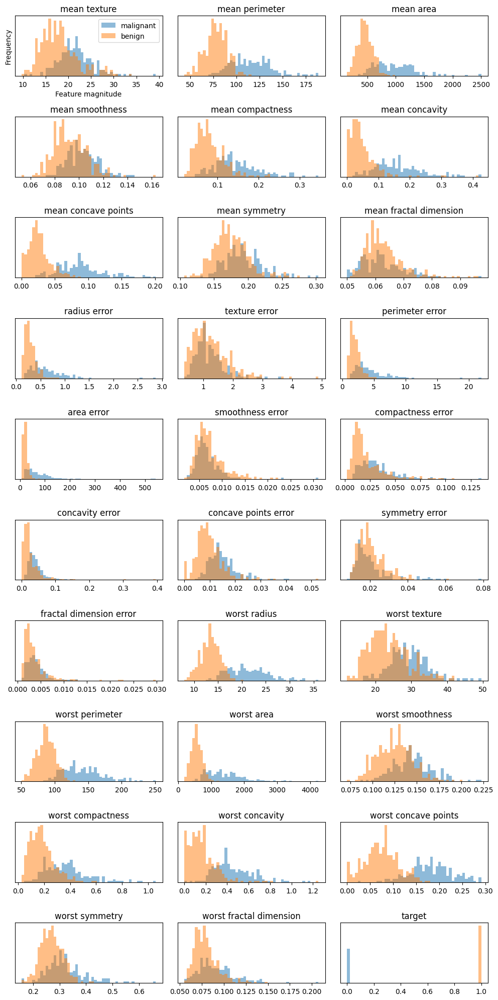

In [63]:
fig, axes = plt.subplots(10, 3, figsize=(10,20))

# targetによるデータフレームのソート
malignant = df[df["target"] == 0]
benign = df[df["target"] == 1]

ax = axes.ravel()
# 説明変数1~30のグラフ作成、dfはtargetと結合しているためインデックスに注意
for i in range(30):
  _, bins = np.histogram(df.iloc[:,i+1], bins=50)
  ax[i].hist(malignant.iloc[:,i+1].values, bins=bins, alpha=0.5)
  ax[i].hist(benign.iloc[:,i+1].values, bins=bins, alpha=0.5)
  ax[i].set_title(df.columns[i+1])
  ax[i].set_yticks(())
ax[0].set_xlabel("Feature magnitude")
ax[0].set_ylabel("Frequency")
ax[0].legend(["malignant", "benign"], loc="best")
fig.tight_layout()

#### 特徴量間の相関
特徴量間の相関係数を視覚化します  
mean radiusとmean perimeter, mean area, worst radius, worst perimeter, worst areaなどに強い相関があることが分かります

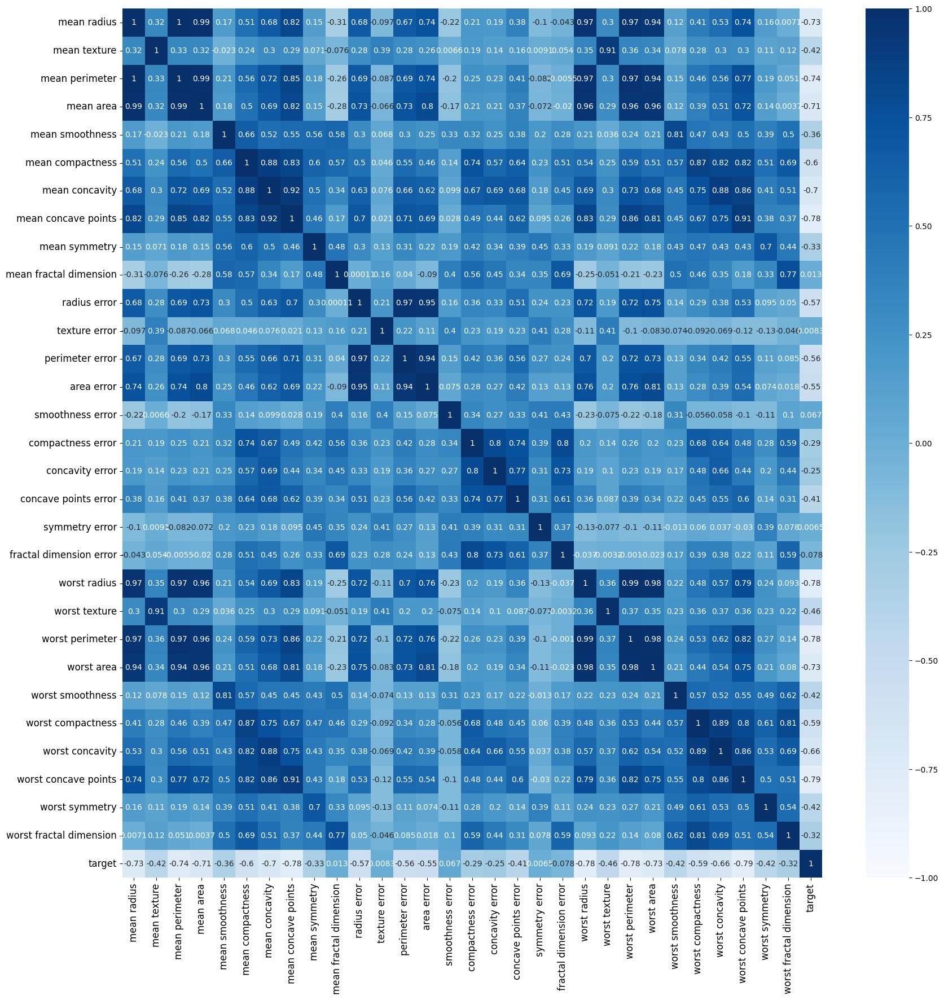

In [64]:
plt.figure(figsize=(20,20))
sns.heatmap(df.corr(), vmax=1, vmin=-1, center=0, annot=True, cmap='Blues')
plt.tick_params(labelsize=12)
plt.show()

参考：乳癌データの変数についての散布図行列

<img src="data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAHUEAABy8CAYAAADi57z0AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjguMCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy81sbWrAAAACXBIWXMAAA9hAAAPYQGoP6dpAAEAAElEQVR4nOzddXic17Uu8HeYZ8QMBsnMFDtxyGFskiZNHG64wTbltL1NT1NOIQ01nDjkMDM5jtkyswySxTTMfP+QLXs8IBoNvr/nObdPvz2S97lHa77v23vttQTBYDAIIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIioiiEyZ4AERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERpTY2QSUiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIqKY2ASViIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIYmITVCIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIoqJTVCJiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIgoJjZBJSIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiopjYBJWIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhiYhNUIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiiolNUIcoGAzCYrEgGAwmeypENAyMZaLMwFgmyhyMZ6LMwFgmygyMZaLMwFgmygyMZaLMwFgmygyMZaLMwFgmyhyMZ6LMwFgmygyMZaLMwFgmygyMZaLMwFgmygyMZaLMwFgmyhyMZ6LMwFgmygyMZaLMwFgmygyMZaLMwFgmygyMZaLMwFgmyhyMZ6LMwFgmygyMZSKi1MQmqENktVqh0+lgtVqTPRUiGgbGMlFmYCwTZQ7GM1FmYCwTZQbGMlFmYCwTZQbGMlFmYCwTZQbGMlFmYCwTZQ7GM1FmYCwTZQbGMlFmYCwTZQbGMlFmYCwTZQbGMlFmYCwTZQ7GM1FmYCwTZQbGMlFmYCwTZQbGMlFmYCwTZQbGMlFmYCwTZQ7GM1FmYCwTZQbGMhFRamITVCIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIoqJTVCJiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIgoJjZBJSIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiopjYBJWIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhiYhNUIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiikmc7AkQEVHqazc5sb3NjNX79ajKV+HU8YUo0cohk4iSPTUiooxicXrRYXbhk+3tsLl9OHNSCUYVqFCokSV7akQ0QA63Dx0WFz7f2YluqxsnjyvE+BINirXyZE+NaNAsrt770qfbO2B1eXH6xGKMKVShUMO/Z6KhMto9aDU58cn2dgQCwDlTSlCep0C+is97RJR8nRYX9nRY8W19F4o0cpwxqRglOjmUUm4lEaWzYDCIVpMTdY0GbGkxY1KpFvPH5KM8RwGhUJDs6RGFMDk8aDe78Mm2drh9AZw9pQRVeUrkq/m8TBRvbSYntrSYsK7BgDEFKpw0rhClOXJIRdz/JSJKdy6vHx1mF77Z04VmgwMn1BRgUpkWpTpFsqdGI8h6aE/nsx0dMDu9OO3Qnk4R93SIiJLO4vSi3ezCp4fzwSaXYHS+CgXMByNKaR6fH+1mF5bt6cZBvR0LxuRjSrkOpTl8rqb4aDM5sbnJiPUHjagpVOPE2kKU6uSQiIXJnhpRWji8/vH17i60GB1YeGj9o4TrH0Qp59h45XolEQG9uYr7u2z4encX8lRSnDW5BMVaGdRySbKnRkRZwuP3o8Pkwrf13TjQY8e80XmYXpGDMq79UAqyOL3osBw533fGpGKMLuD5PiKiSCK+a+jkUMt4LooS7/B+47f13WjssWPe6HxMq9DxmZOIMlabyYmtLSas5RkVooSzH6p19cWOTvTY3Dh5fCHGFbPWFdGxAoEg2kxOrGkwYEebGVPLdZg3Og/lOQoIBDxvTxRvHRYX9nRY8O2ebpTo5Dh9IuvXEFEv56F8sq92daLN5MSJ4woxsUTD/E8iiruje2pU5imxaEIRe2pQSmg1ObC5yYS6g0bUFqmxsLYQZTo5xCKeJyJKdZ0WF+o7rfh2TzcK1DKcMbkYpVo5lMxJICICwCaoRETUjyaDA4ufXINWk7Pv2gNCAZ65bg4WjM2HVMxFGyKieDA7vXhxdSMe/Ly+79pT3zVgwZg8/OeKmUwqI0oDDo8Pn+3owL1vbEEw2HvtmRUNGFesxvM/nMdDKZRWLE4vXlvfjD99vKvv2lPfNWBudS4euWoW70tEQ6C3ufGvL+rx8tqmvmuPf7sfF04vxe/On8QCBESUVG0mJ65/bh3qO2191/766W78+wczcObkYiaSE6Wx3R1WXP7kalicvr5rapkYr94yH1PLdUmcGVEoo92Dx5btw1PfNfRde2L5AZwxqQh/vngqn5eJ4qihx4bLn1iDLqu775pMLMQLN8zDnOpcJkYTEaUxj8+Plft6cMuLG+AP9G5WPbuyEZV5Crxy03xU5imTPEMaCRanF29saMYfPwzd05ldlYPHrp7NPR0ioiQyO714YVUj/vVFaD7YCWML8K/Lp/M7mihFeXx+rDlgwI0vrIfXf+S5ukwnx6u3zEd1virJM6R0d6DbhsufXIPuY9bnXrxxHmZVcX2OqD9urx/f7e3BbS+Frn9U5Snxys3HoSKX6x9EqcLt9WPFvh7cyvVKIjpKh9mFW5asx9ZWS9+1v3+2Bw9cNAUXzShjI1QiGnE+fwAbD5pw3bPr4PYFAADPrWxEkUaG126dj9EF6iTPkOgIs9ODV9Y24W+f7um79tR3DZg/Jg8P8dw5EVGIdrMTtyypw7Zj3jX+dPEUfG863zUosby+ANY3GvHD59bD4+995nx2ZSNKtHIsvWU+RhVwv5GIMktDjx1XPLkanZYje+BSkRDP3zAX80blcQ+caAQ53D58ur0DP3vzSK2rp1c0YEKJBs9eP5e1roiOsrPdgsVProHVfeS8vVYuxtJbFmBSmTaJMyPKPG0mJ659dh32dR2pX/OXT3bjoStm4oyJRVCwfg1R1nJ5/fh2Txduf3kjDqWT4dmVjRhdoMKLN85j/icRxU2TwYErn1qDFuORnhp/+mgXnr5uDo5nTw1Kov1dNlz+5Gr02Dx912RiIV666TjMqsqFSChI4uyIKJY2kxM3PL8euzusfdf+9tluPHjpdJwzpYSNUImIAHBXmIiIorK6vPj9e9tDGqACgC8QxC0vbggpjEtERMPTbHCENEA9bPUBAz7Y0obA4V06IkpZnRZ3SAPUw+o7bXhs2T64ff7kTIxoCNrMzpAGqIetP2jEWxta+ooREdHA7Wq3hjRAPez9Le3YcNCU+AkRER3i8vrxyNf7QhqgAkAwCPzk9c3osnANkChddVld+NFLG0IaoAKAze3DLUvq0Gl2JWlmROH2ddtCGqAe9sXOLiyv70nCjIgyk8nhwS/e3Bq2z+v2BXDzC3UhRSeIiCj9dFrcuP3ljWFr+M0GJx74aBdsbm+SZkYjqd3sDGmAetiGJhNeW98M/6FCekRElHhNBkdIA9TDVu7vwUfb2hE8NsGEiFJCl9WNW16s62uAelib2YXfvbcDFiefq2nojHYPfvrGlpAGqEDv+txNS+rQyfMZRP3qtLpx+8sbwtY/mgwO/PnjXbC7fVF+kogSrcvqxu0vRV6v/NNHu2DneiVR1vH6A3hhVWNIA9TDfvvudnRwv5qIEqDT4sbNL9T1NUA9rMvqxi/e3AqTwxPlJ4kSr9XoDGmAetiaAwa8t7mV586JiA7x+v14YVVjSAPUw37zznbmxlLCdVpduHlJXV8D1MM6LC78+u2tMDv5zElEmcPk8OBXb20Ju996/AHcsmQDOi08v0g0kjqtrpAGqIft7rDiiW/3w+NjHjkRAHRaXLjtpQ0hDVABwOLy4baXNqCL9yuiuHF6fHjoy/qQBqhAb/2aHy/dxHUaoizXZXXhzlc24dgtroYeO/7x2R44mP9JRHFgdXlx/3vbQxqgAr09NW59cQPPbFDSGOwe/OT1zSENUIFD54leqONaKlEK8/gCePzb/SENUIHed92fvbmF9xYiokPYBJWIiKIy2D1YVt8dccztC4Q9bBMR0dAEg0EsXRfeEOuw51c1osfGhQyiVLe8vjssKfSwN+pawjYaiFLZm3UtUcee432JaNAcHh+eWnEg6viTyw/AzGIZRJQkersHb22MfO8PBoHv9kZeHySi1GewedCod0Qcaze70GPncz2lBo8vgOdXNkYdf3rFARj490oUFwa7B+sbjRHHrG4fDhrsCZ4RERHF0/ZWc1ix3sO+2NkBg51NBTLRO5tao469sKqRe5REREkSDAbx6tqDUcefW9kQ1gCPiFJDfacVLm/k5+rv9nbDYOfzFQ2dweHBpiZTxDGL04cWY+R9HSI6YkuzKaxR9WGf7eiEnt/TRClja4sprNHDYZ/v7ICe65VEWUdvc+OlNdHXSz7e1p7A2RBRtjposIcVuj9sfaORaz+UUl5b3xx17LmVPN9HRHSY3ubBS2ui1+r4ZDvfNSixDnTb4fD4I46tPmBgHh8RZRSD3YO1DZHPqNjcvqhnG4koPr7e3RW11tVrdc1cOyA6RG/zhDVAOqzJ4GCuCVEcGewevLOpLeJYIAis2t+T4BkRUSpZ32iE79gOqId8tLWd92QiiguD3YNvYvXUaLckeEZEvQx2D7a2mCOOmZ1etJoiv7cSUfL12Nx4oy5yHlcwCCzb05XgGRERpSY2QaWB2/sFsOF5wG1L9kyIKEE8vkDU5AYAMLJBCxFRXASCQfTE2HAzO7zwx/pCJqKUoI+R+On2BRCIsulOlIpiJTJbnF7+PRMNktcfhMUR/WCi2emFl3FFREniDwSjNkgBwEYZRGksWjHRw9xRirgTJZrXH4i552Rx+uCLUsyaiAanv3uDxRm5yCMREaUHU4w1yEAQ8MZ4/6f01WON8Szt8iLAXAMioqTwB4MxCzCYncwHI0pV5hjP1cFg/+srRLH0915m5focUb9MMfaU/IEgfPyeJkoZ/a5XMl6Jsk4giKiNB4HYZxiIiOKlv9wYD/dUKUUEAsGY90buMxARHeEP9jZZi6bbyncNSiyLM3aTU+bxEVEm6W+t39zPdyIRDY/BFj3GXN4A/KxhQgQAcPv8/YzzGZ0oXnyBYMw8Wz3r1xBlNWOMMza+QDBqg1QiosHw+vvrqcH1KkqO/nKSrC6eJyJKVf5AEK4Y9Rpj1fsgIsombIJKA7P+GeDlS4EP7gGePw/wOpM9IyJKAK1cglKdPOr4tHJdAmdDRJS5REIhzp9WGnX8xHEF0MolCZwREQ3FieMKo45NKddCJRMlcDZEw3Pu1Oj3pYW1BVDLxQmcDVH608jEOHNySdTxMyYWQadgXBFRcqikIkwu00YdP7G2IIGzIaJ4ylNJIRNH3g6WiAQo0MgSPCOiyFQyMc6ZEv15+ZRxhdApuT5KFA9auQR5KmnU8doidQJnQ0RE8Ta9KifqWGWeAhqu7Weks6dGf5Y+YSz3dIiIkkUsFOK8GPvuJ9UWMh+MKEVNKoueH1+ilUPL5ysaBq1CgpwY691jC1UJnA1ReppVlRt1rDpfyfdgohQyI8Z6ZVWeEhoZ45Uo2yilIhw3Oi/q+BmTihM4GyLKVrXF0XNj8lVS6BRct6XUIBQKcN60sqjjJ9YWcq2SiOgQlVSE40ZHXzc8ne8alGATSjVRxwo1Mmh5lpiIMohWIUF+jDMq44ujfycS0fCdND56DYBpFTqouB9HBAAoUMsgEQkijsnEwpj3MiIaHLVMjAkl0Z8BT6hh/RqibDYvRs7I2EI11Hx+JaI40MglKIvRU2N6BXtqUHLkKCVR94gEAmB0Ac8TEaUqlUyMaTHuHyfHWKclIsombIJK/XOZgS//ANSeCZz/H6BrJ7Dsr8meFRElQLFOjvsvnBxx7OzJxSjSRF/MSQa3z49uqwtmhyfZUyEiGrS51bn46Znj8IuzxuOy2RVQSHqbJcrEQvz49HFMKCNKA6PyVZhZlYMijQw3LhzdF89KqQj3XzAZeSo2l6HU4zn0DG065hl6WoUuYlE9iUiAn581HhoWYyUaFKFQgAumlaJAHZ74rJWLceVxVZCIht8s2+ryotvqgsPjG/bvIqLska+W4f4LJ0MQ4dzG7KocVOcrB/R7AoEg9DY39DY3gsFgnGdJRENRqJbh7tNqI47detKYvmcTr9+PHqsbRjvX1il5Fk0oRrE2fO1EJRXhppPGQCYe/vPyQNncvc/VdjefqynzFGvl+O15E0OuySVCfH9WOR67ahaL6hARJZnd7RvWc0iJVobTJhRFHLv/gsko0qZWng8NncnhQbfVBY8vgCllOtREaGQuEQnwi7MncE+HiKgfI7m2PXdUHirzFGHXZWIh7jmtlvlgRCmqSCPDuVEazf/5kilQSETotrrg8voTPDOKt8M5Fk5v4taCi7Vy3HfuxIhjV8ypRL6aOYZE/SnVKXDK+MKIY3+4cHJCzjlFy7skolClOjlOjbZeeeGR9Uqby8e8R6IskaOU4rfnTYJIGJ6sOLFUg3FJbojgOLRPY3V5kzoPokRweLL3771ALcOlsyoijt137kQUc0+VUsjMqhyMyldCKRXhsjkV+MVZ43HjwtEoz1Hgp2eOg0rGvWAiIiD2u8akUk3KN1/jeazMU6CW4cLpkZuZ//a8iSlXr2swPL4A18eJKESxRo7fnj8p4tjFM8si1lZIdYFAED28N1OaGFOgwozKnLDrQgHw+wsmIy/LGzseyblnnle2K1BL8aNTaiKO3bmoBoWa4edsWZyHctG4701ZLl8twx+i1K+ZW52LqryB1a9JBN4niBKvLEeBhVGaId9/4aS43JNHmvnQPd/N7w6ilFWsjd5T46zJxShM4zX6w3z+ALqtbhjs7mRPhQahWCPDfedEPk+0eF7ViK+lct2TaOjyVFL8/oLJiJCSgBmVOUNuYuzy9p5NsjizL4+TiDKTIMinjCGxWCzQ6XQwm83QarXJns7I2rgEeP9u4NLnAFUBsPllYPtbwI+3A5riZM+OaFiyKpaHyOryYnOzCX/6aBd2d1iRq5Tg5hPH4NI5FSmTVOnzB9BkcODZFQ1Ysa8HeSoZbjt5DGZX57IQSJZgLFO6Mzk82NFmwSNf70O72YnJZTpcOrsC6xoMuHBGGWoK1ZCIhcmeZkIwnindtRqd2N5qxvOrGtFudmJKuQ63njQW1fkKaBXZkxjKWE59gUAQzUYHlqxuxNe7u6GVi3HziWNw3Ji8vo3ZVpMTT3y7H6/XNcPlDeCEmnzcd+5E1BapIU1g8xlKHsZy/DX22PHvL+vx0dZ2BIJBnDm5BD8/azzGFKggiJS9OUAmhwe72i149Jt9aDE6Ma0iB7efMhajClSQSxiv2Y6xTAPh8Piws82CP328C5uaTNDIxLhmQTWuXTAKJbr+1wDbTU58sLUNb25oAQBcPrcS504pRWlOeHF3GhrGMg2Vwe7Bt/Vd+Ofn9WgxOlGmk+PHZ4zDaROKkKeSotnoxCtrD+LzHZ1QycS4ceEoHF9TkDLr/5mGsRxbk8GO/361D+9vboMvEMCiCUX41TkTMLpAHbEoTbxZXF7s67Th4a/3oqHHjvElWtx56liMLVRDyaYkdJR0j2Wz04O6RiP+/PFulOhkuO3ksXhrQws2N5tQopPjjlNqMKVch9wsP+hOmS/dY5kyi83lxf5uOx7+ei/2dtlQU6jGXafVoqZQBfUgG1h2WVx4va4ZT69ogMnhxcRSDX573iRMr9AN+neli2yK5x6bG3WNBjzx7QGYnF6cWFuAG04YDblEhMeX7cNrh/Z0FozJw2/Om4RxxdzTofSRTbFMqaPd5MRH29rxel0zAOAHcypx3rRSlOrit7bdYnTgsW/2462NLfD4A1hYU4D7zp2YsflgjGXKFN1WF97c0IKnvmuAwe7B+GIN/n35dHSYXXj82/3otrpx3Og83HLSWFTlKTMunjM9lk0OD3a29+bstpmcmF6Zg9tPqUF1vjIhORZmpxfrGvT46ye7sb/bjkK1DD86dSwunF6GAp59oDjK5FjusriwdH0TnlnRCLPTi8llWvz2vImYWpED9Qju6fgDQTQbHHhuZQOW7+1BjkKCW08egzmj8hi/NGLSPZa7LC68tr4Zz6zsXa+cVNobr9MqdAgEgfpOKx75Zh8ae+yYWKrFHafWYEyhCkop92cps6R7LMeTy+tHfacVD3y4E+sajVBKRVg8rxI3LRyTtHxDp8eHhh4HHv1mH3a0mVGVp8Sdi2oxoUSdVeeAqH+ZEMsurx8NPXY89s0+bGs1oyJXgTtOrcXEUg1ylNnz995tdeO9za3437f70WPzYGyhGvedOwFzRuVCx7jPCukUz21GB5pNTrywqhE72ywozVHgRyePxeQyLetoUNZLp1imkRf5XaMKNy0cndJnm9pMTry/uQ1vbWyBUCDA4uOqcPbkYpTEcc861WVqLHdbXXh7YyueXH4AersHtUVq3HfuRMyuzoVWkX55fD5/AM1GJ55dcQDf7e1BnkqKW08ei9nVuVwfJwCZG8s0MGanBxsajfjzJ7uxr8uGfJUUt508FhfNLE+LBjZHO/befMW8Spw9pSSu+WSpjLGcntrNvesGL61pgs3tw8yqHPzuvEmYWKqBIkv33KLl3FfmKRNyTjXZGMuRGWwefLW7E//5ci9aTU5U5Cpw7xnjcOr4QuSqhn6/Mto92N5qxqPL9qHD7MLs6lzcdvJYVOcreZaDhiWdY9nu9mFXuwV//HAntrSYoZGJce3xvfVrirXJr2HRY3VjfaMBTy7vvU+cPK4Q1x8/KmvuE5RY6RzLI6XT4sLLa5vw/KoGWJw+TCnX4nfnTcKUch1UKVzTQ29zY1OzCY8v2w+9zY3jxxbgxhNHozpPCbEos84SUGSM5/QSqafGTSeOwWUp1FNjqJoNDixd34xPt7dDLhHhhyeMxkm1BShKgeesdJDsWDY5PFjbYMDfPtmNAz12FGpkuP2UsbhghM8THa4R+UZd77rn5XMrcc7U7Fn3pMyTjFh2enzY1W7FHz/aiU1NJqhlYlw9vwrXHT9q0LHk8fvRpHfiyW/3Y12jAUVaOW4/ZSymVeiQN4x1KiKiZGMT1CFK9kNqQr14CWDvAc76U+9/d9uAN38InHA3cOp9yZ0b0TBlVSwPk97mhsvrh0goRKFGNuTNGavLC4fHD5lYGLcDUbvaLbj4sZVweQMh1xfPq8Qvz5qAHBbozXiMZUo3gUAQersHgWAQcokQL64+iAc/rw/5jFgowEs3HYf5Y/KTNMvkYDxTKjA5PHD7AlBKRdAMohi03e3DC6sa8ffP9oRcz8Z4Ziynvv3dNlz86EpYXL6Q6+dMKcEDF03pOwTt8QWgt7sRDAIqmRi6NDxYRUPHWB4ZDrcPJqcXAKCVi4fVeMDj88Ng9+C9zW34yye7Q8ZEQgGW3DAPJ9QUDGu+lP4Yy9ktGAyix9b7/pmjlEDWz0EJo90Dh8cPkRDIV8sgGUCSZbvJiaueXosDPfaQ62ML1XjpxnkpXSwgnTCWabi6LC54/QFIRMK+pMXGHjsuemwlTA5vyGdPGV+IBy+djoIBHDK2OL1wev2Qi4XQZVERtKFiLPfP6fXBaPciCEAnl0Atj31QwecPwGD3AAIgXymFaIgHBDw+P97d3IZfvLk15LpAADx+1SycMamEB5eoT6bEssHmxv5uO658eg28/tDUobsW1eCq46ogEAiglYuz9tA7ZbZMieV4cLh9sLp9EAsFLJCZBF5/AJ9sa8fdSzeHjT10xQycO7V0QO/nR/P7A+i2eeAP9O5HZ/r/XbMlno12D/700U68ubE15LpSKsI7t5+A0QUqdFhcCAaDUElFKEjzg3iUfbIlliPpsbrhDwahU0gS0niNerWbnLj6mbXY333s2rYKL914XFzXtl1eP4x2D4IA1DJxWhY0HahsjWW72web2weJSIg85ixnDH8giG6bG35/AEKhAM+uaMBT3zWEfEYmFuL1WxdgemVOciY5QtIhlg+fSZCKhMgdRNzZ3T4sWd2Iv30amuMnEgrw0o3zsGBs4nIseqxuuH1+iA+dzxByDZriLB1ieSgOx79cIoTT44c/ACikwoQc9K/vtOLiR1fC7vGHXL9kZjl+e/4kPgfQiEi1WNbb3PAFgtDIxFAOsOhcpPVKt9ePtze14tdvbwv5rEAAPHXNHCyaUMR7I2WUVIvlRIv03mxy9OYqCgRAvkqatCLQwWAQ39Z344bn1yNwTMWN//veZFw2pxIKrtnRIekeyz5/AKv26/HD59fDf8wf/G/Pm4grj6vKqkbkgUNrPz5/ADKJiI2bskwqxbPB7oHXH4BaJo5Y2Hn1/h5c/cy6sLj99TkTcM386gE/lxNlolSKZUodyXjX6O+7PJo2kxNXPLkGTQZHyPWJpRo8e/3crCk6nMmxHAgE0W11wxdI/2fO3e0WXPzYKji9oevjl8+txK/OmQCZWAiri3mo2SyTY5kGrm8PXCREoXrk9sBHooYh0HtvXvzUGhzUh96bx5eo8fwP52XFvZmxnL68fn9vPYEAoJSJkJuAs75Drc810gx2Dx74cCfe3hSac6+SivDOHSdgXLEmSTNLHMZybH3n7cXCYTc/srq8eHL5ATz89b6Q6xKRAEtvWYDZ1bkRf84fCPbV88pTSQd9ZoiyQybEssHugXOQ9WtGkj8QRIfFiX98ugfvbm4LGVMdOps1riTz7xOUWJkQyyPB5w+gx+ZOWP6n0e6Bxz/0Z1eTw4N/f1GPF1YfDLkuEwvx9o+Ox+RyXbymSimM8ZyeemxuuOPQUyNVNBkcuPjRldDbPSHXjx+bj799fxoKNTKeT+1HqsRyt9UFjy8AsUiIIo0MAsHI/W22HaoR2XBMjciaIjVevLF33fPwvVIlE0EtS511HqJokhnLRocHDrcfQiFQoJZCIhr89+7mZiN+8L818PhD+yrddtIY3H5qDbQKCWsPEFFaYjYrxeZzA02rgGlXHLkmUwOjTwI2vQSc/EtAyJseUTYYboKhze3D3k4r/vVFPXZ3WFGZq8RPzqjF1HLdsBKJTA4P7n9/e1gDVAB4dV0zrj9+FJugElFK6TC78MHWNry05iA8vgAevXIm/vVFfdjnfIEgfvXWVrx+24JhJ8oQ0cCYHB5saTbjoa/q0Wx0YlKpFveeMQ41hWqo+mm4AfRucD34+Z6w675AEL98ayveYDxTirC5vfjHZ3vCGqACwCfbO3DjwtHQKSQQi4SQioVZkYxPlEjKQRT/iqXJ4MDzKxtwyviisAbcQG/i5S/f2oq3fnQ8irW8/xBlo06LC5/t6MDzKxth9/hwxsRi3HzSGFTmKqMeHsxVSZGrGvi/EQwG8dnOzrAGqEBv0/Vle7qx+Liqof6vQERxVHTM84DT68N/v9ob1gAVAJbt6UZDjz1mE1Sry4s9Hb1r/nu7bBhdoMSPTx+HyWU66DK4iQONPIVEDEXOwJ6XW41OvLa+qe9A6qWzK3DZnEqUD6FJSZfVjd+/tyPsejAI/PrtbZhWkYMyNvamDBMAcN8728IaoALAI9/sw/wx+bj3tc04eVwhbjtlLKrylBDzQC1RRvH4/Diod+CRb/Zh1X498lVS3HbyWJxQU4DCGM+CFF9dVjd+8872iGO/fWc75ozKG/TzjUgkRImOa4KZps3sDGuACgAOjx8PfLgT9545Dr97bzs6LW7MqsrFj0+vxegCFQ81EKWwLosLX+7qwjMrGmBze7FofBFuObn32TvdD9SmumAwiC92dYY1QAWA/d12fLW7C1fPr47bvyeXiOLaVJVSh8fnR0OPHf/9ah/WNRpQqJbh9lPHYsGYfBZ2zQAioQAlh9bW93XZwhqgAoDbF8Bv3t2GJTfMS0jzPQIcHh8OdNvx7y/rsbXFjDKdHHefVouZVbkDaj7Ym+MXnrPbm2OxDW/etiBsT2WkxNqHIaJwI3UmaaAsTi/++OHOsAaoAPD2plbceOJoNkGljNZjdWPFvh7879v90Ns9OH5sPu48tQbVBUpI+yncEWm9stvmxv3vR96f/dXbW/HBXQuZv0yUAdxePxr1dvzny72oO2hEkUaGO06twbzReShQy5CjTPYMgU6LG794c2tYA1QAeODDXTh1fBEq81JgokTD1Gp0oslgx6/f3hbWSBEA/vrJbpw5uQRVedlTfkYoFPCcBSWV3ubG6gN6PPbNfnTb3Jg3Kg93n1aD0QWqvoZ9nRYXfv7m1ohx+/fP9uDsKSWoZhNUIqIQOUppwt419DY31jUY8Mg3+9BldWN2VS7uGWC+TiAQxPub28IaoALArnYrVu/X45JZFSM1dUoQoVCA4gzI4zM5PLj/gx1hDVAB4LX1zbj6uGo8v7oBy+t7kKeU4paTx+Ck2gIUsq4GUdYZ6T3wkdwvDASC+Ghbe1gDVADY02HDyr09uHRO5bD+DaKRJBGJEra3ZnJ4sKXFjIe+7K3PNbFUi3vPqEVtkQaqFFinaDc7wxqgAoDd48efPtqFhxfPhJZnoLNaPHPDemwePPLNvrDrXn9v/chXb5mPgmNySdtMTry9sQVL1zcjGAQumlGGxcdVoSKX+1GUefJUUmAQ9WtGUpvJifc3t6KmSBPWABXovU/8+eNdePjKmSnV3JsoU4lFQpQk4PnVYHdjY5MJD3+1F21mF6ZV6PCT08dhTKEKSunAn127rO6wBqhA71mC372/Hc9eNzcheaxENHjHPo+nM7fPjyeX7w9rgAoAq/brUXfQgN3tVlwxrwrVedFrDFJqSNQeSjAYxKfbO8IaoAK9Z+WW7elGdZ4Cf/5kd199gntOq8WYQtYnIIomVynFcJZx9DY37nt7e1gDVAD43/ID+P7sCny4pQ3PrGxk7QEiSjusTkixtW0GvE6gdHro9ZrTAUsr0Lw2KdMiovTiDwTxXX03Ln5sFb7b24Nuqxsbm4y45pl1eHNDC5ye8OZLA2VxerG2wRh1/Lu9PUP+3URE8dZhduHmJevxp4924aDeAV8giO1tlogHpQGgUe+AOUIjCiKKP4fHh6XrmnDdc+uwscmEbqsb39Z346LHVmLV/h4EogXqUfZ0WKPG80G9I2JjGaJksDh9+GJnZ9Txdze3oc3kTOCMiGiwmgx2XPToSry9qRWtJmfEggYA0GJ08v5DlKW6rC7c9com/L/3duBAjx2dFjdeWtuECx5egYMRDsgPlcnhxZsbmqOOv17XDLMjPGmKiJLPZPfio23tUcff2dQSdcznD+DrXV249H+rsWq/Ht1WN9Y1GHHlU2vx/uZWuCMUNiCKtzaTE5c/uRr//XofWoxOtBid+M+Xe7H4yTVDeqftsrgjFuUAAKPDC0OEJGCidGd2eLG3yxZxLBgEdrVbIBEL8fqGFpz33xURG98TUXrb02nD+Q+vwHub29BtdWN3hxU/fm0z/vTRTt77Ekhvc8Pqjpw3Y3X7oLe6EzwjSlVf7+qKOrZifw/azS5sb7Wg2+rGZzs6cP7DK7Cl2ZS4CRLRoHRb3fjp61tw3zvbsL/bhk6LG6+ub8b5//0u4oFCii+zw4s36qKvf71R1wwT17ZpAHa0WXD+wyvw0bZ2dFvd2NluwZ2vbMKDn+/h31CGqWs0RB3b3mqBxTn0XHganLpGIy58ZAW+2tWFbqsbW1rMuPGFOjy3sgFWV//5EfWd1qg5Fk0GB0xO5lgQpSJ/IIjv9kY+k/RG3fDOJA2UxenFin3RzyfFem8nSndGuwd/+ngXfvzaZuzusKLb6sZ7m9tw3n9XYE975L2m/rSbXXD7wgt3AL2FYrlGTZQZtrWacd5/V+CT7R3otrqxo82C21/eiIe+3Atzijx7Gx0edEXZi/H4A2iOY74lUbIczrMyOb1ojZJX5QsE0dA9tPs6EQ2eyeHBg5/vwZ2vbMLO9t493o+2teP8h1dgR5ul73Nmhxctxshx6w8EsS9K7hcREY08s9OL/369Fz96eSN2tPV+l3+6owMXPLwC21rM/f680eHB2zHObLy2vnlA+x5EiWBx+bDmQPT90k+2t2Nvpw3dVjf2dFrx09e34A8f7ITBztxHIoqfkaxhCAAmpwdvbYhxb65rhiVF1jSJksnh8eG19c247tkj9bmW13fjokdXYcW+gdXnGmlfxdi7X763m7FMcbW1xYRglD/7vV22sPqR7WYnrn56LR78vB4tRidaTU48umw/LvvfarQYuSdFNFLaTU5c88xafLGrC2sa9FE/9+3e7pTZxyai4bO6vHh2RSNueqEOW1rM6La68dWuLlz4yArUNUavYx/Jqv3Rc0c3HjTxu4OIEsJo9+KDLdFrhX29qwstRicueHgFz6dSH6PDg7c2xjpH24Jl9T0h9QkueIT1CYhGktnpxc52S9Tx5Xu78eR3B0JqD1zw8Ao08rudiNIAm6BSbK0bAJEUyB0Ver1wPKAqAHa+l5RpEVF66bS48Jt3t0cc+/une9BjG/rBZIFAAIEg+rhYGGOQiCjBtrSYsK31yAJDMBjs93tKEOtLjojipsfmwYOf14ddDwaB+97dji6rq9/f0W88D3l2RPEX689VJBTgpbVNTNwlSlEeXwDPfNcAg92DQDAIUb/PkwmaGBGllL2dNqyLUIzZ4vLhoa/q4YhTAVCBABDF+KIRCgV8ryVKUQJB7PdYsTD6NnKn1Y3fvR95zf9PH+9Ct42FCmhkBQJBfLytPWJxryaDA1/s7EQw2snBKPq7XXG7iTJRf3/3IqGgryGE0+vHXz/exYJKRBnE6PDg/723PWKR+Xc3t6HD0v++CMVHf48ZfK2mwySi6O9pAiCseIY/EMR972xDNxvpEqWkhh4bvovQQMnu8eOfn++B3c1n75HU39qYiGvbNAB6mxu/eWc7vP7wdahX1zXzHpxh+s/zTNBEslynxYVfv70NkeolPvrNPugHcCaBOX5E6anT4sJv3om8P/mPz4Z3JmnABLG/I/rL4SJKZ+0WF97Z1Bp23eMP4P+9vx3GITQs7S9khHzAIkp7PTY37ntnG3wRHuBfXHMwZd6b+80X4T2e0tzReVaCft56+fdOlDhdVjdeXdccdt3rD+K3726H/lAe7kDyu4iIKDl6rG68sOpg2HXfoXydnn7eeQQCQczvcaFQwPx1ShkCxH4uOTrn/LAPt7aj3cw8VCKKn5GsYXhYrHtzbz7ZsP8JorTXY3Xjwc/3RBz77Tvb0ZkC51Bi5QYJ+v4fovgYbF7ht/XdOBChYUW72YV3N7WGPVcTUXws39uN/d12BIPB2PVxBP3tphFROtHbPHhs2b6w64EgcN872wb17CqJUX+HiCiRYr2DCIUC+INB2Nw+/OuLetjd8akxSOlNIBDEzMkWCRH2LuoPBPHrt7ehewB12Ilo8Po7J+EPAP5jCofY3D7884s9/G4nopTHt2eKrW0jkDcGEIpDrwuEQPlcoP6z5MyLiNKKyeGBIcqBZo8/gNYIRaoHKkcpwcm1hVHHF8YYIyJKJI8vgDfqQg+l9dg8KNbKoy4ijy/WIFcpScT0iLJek94esbgCAHRb3TDY+y8wWlOsgUQUOZ7HFauRq5IOa45E8ZKrkuCCaWVRx08Ym48lqxthYVMLopRktHvw8bYOAIDF6UOuUgpplOL3YwtVyFXy/kOUjd7Z1BJ17LPtnTDHqdl5jlKKq+ZXRx2/Zn41tAq+1xKlolyVFBfPKo86fsns6GMGmxsWZ+RkGJc3gC5LahQppMxldnojFtk97K2NLYO+1xVp5dDIxJHHNDLkqWSD+n1E6SBHKcHUcl3EMZFQgFH5qpDiM9/Ud8PiYjIkUaawOr3Y1GSKOr5ib3hTNhoZBWpZ1D3hXKUEBWo+h1CvRROKoo6dOqEIaxv0Ydf3d9thidM6EBHF10db26OOfbGzE+Yoay8UH7p+1ravnl8NHde2qR8Wlxc72y1Rx9c2GBI4Gxpps0flRS1mOW9ULr8zEsTs9KLVFPncQSAI7Om09vs7xhZFz/GrLWKOH1GqGskzSQOVq5TgjEklUcdPm1g84nMgSpaV+6KvF29qMg0p37hEK4dKKoo4VqqTI4/3ZKK0Z3F6Ud9pizpedzA13ptzlVJU5CoijikkoqhjROni6DyrTosLowtUET8nEwsxOj/yGBHF37oY68c72ix9z9i5SinGFqojfk4qEkYdIyKikbep2Rh1bG+XDeZ+1ktylRIsnlcVdfya+dVQybj/RKkhRynBqeOj1++aWZWL3R3h+3TL9nSP5LSIKMuM9H5hnkqGK4+Lfm++en41NHLem4majU54/VHqc9ncMDqSn7cea+/+zMklyGE9P4qjKeU6ROtBNLVcF/L3ZnV58daG6DVA3t3cBpNj+E29iSiU1eXFWxt798q2t1owd3Re1M+eOakYOazTRZQx9nRaEa2/eIvROah6JPPH5kcdW1hTwBp/RJQQ+WoJvj+7Iur4oglFWHOg95z55zs7WEuYAPTmnVwVY93znCmlEfdzDvTYecaZaITolBLMrMqJOCYU9J5vbDaE73l8vqOTdUOIKOWxCSrF1rGttwlqJOVzAGMDoN+f2DkRUdoRRtudPUQijj0ei0Yuwe/OnxSxeMxdi2pQpGExSCJKDUIBIJeEF2l4va4FPz1zXNh1uUSIf1w2DfksakuUEJIozeMOE/XzPAMAhRoZ/njRlLDrcokQ/7h0OotUU8pQSMT48em1KIzwrPz9WeXY1mqGzx/E0J/SiWhECQCp+Mh9a+n6Jvz87PFhH5OJhXjwsukRY52IMp9cHLlIIND7HRLP+/zJtYWYXhHePGtWVQ4WxEjiJKLkkolFuO2ksSjVycPGLp1VgapcZdSf7W/NfyDv0ETDIRD0Pu9GIxUJIYzWkSCKYo0M//zB9LADh2KhAP++fAaKtXyupsyTp5Lhb9+fBmWEAtN3n1Yb1mxYIozvcyQRJZdAIIh60B6Ifa+l+CrSyvHvy2eEPUeLDj2HFGnDn9kpOxXr5Lj1pPBczjyVFNctGIV3NrZG+ClAyHAmSkmRcogOk4j47J0IJ9YWYEZlTtj1mVU5OKGmIPETorTT3/qTnM/UGaVQLcWvzp4Qdl0jE+OPF01h0aME6S/uBvIuW6iR4YEoOX4PXsYcP6JU1d/+pDhKc+N4Uskk+NU54yM2ZrzlxDEoibDvSpQpYt1jhYL+79GRFGp792eP/VGJ6PD+LGOKKN31/94cfX0skYoP7dNIjzlTJBAAf7t0Gs8nU9o7Os/q+VWN+OXZEyLe2/9yyVQU8O+dKGH6W8c6fB8t0Mjwzx9Mi/j5By6ewvNCRERJJBXFfqcR9fNOJBAIcOakYkwq04aNHTc6D3Oqc4c1P6J40sgl+M15kyI2DLvu+FH4tr4b/ggdJRQxcmOIiAZrJGsYHnbahCJMiXBvnjsqF3NHRW+WRZRNJP3szafC2eISnRy3nBg55/6XZ4+HWsYmqBQ/hWoZfn/B5LDrSqkIf/3+VOSpjqzfCQWCkFpBx5KJhWH750Q0fCKBoO/+5fEHsPaAAVfOC28ClaeS4hdnT4BKJk70FIlohMS67wKDy3kr1Mhw7xnhNaO1CjF+f8EkaCPUxCciijeJSITrFlSjIlcRNnbmpGJ0WtwwOXqb40lFQgh4QpUOOWV8EaaVh697zqrKQY5Sgv3dtog/10+ZdiIaolylFH+5eCrUEd4/f3LGOHywtS3iz0lEQvCrnYhSHVfWKDq/t7fB6ZhTIo+XTAUEIqBhOZA/NqFTI6L0kqeUojJPgWaDM2xMIxOjRBe+cDIYYwpV+PCuhXhvcyuW7elGgVqGm04cjZoiNReCiShliEVCXH1cNT7c2h5y/bMdHchXSfHKzcfh9fXNaDY6MW9UHi6fWxlxYZmIRkZFrhJKqQgOjz9sbEyBCnmq/p8pFBIRzptaiillOjz93QE0G52YOyoXV8ytYjxTyqnKV+G1W+bjnU2tWL1fD61CgvOmlaLL4sLfP9uDC6eXIZcFGolSUoFahsXzKvHg5/UAgK92dSFfJcNT187G+5vb0GZ2YXZVDhYfV4XKGM3LiCizXTanEi+tbYo49oM5FchXx+8+X6yT44lr56CuwYCX1zYBAuDq46owZ1QeCxISpbiKPCXevO14fLmrEx9ubYNKJsaNC0djYqkWeTGKfBeoZCjRytFhcYWN5SglLP5HIy5HKcW1C0ZhY9PmiOPXnzBq0PtDYpEQJ9YW4JN7TsTzKxtR32XD5DItrl0wCpW5Cgh4epAy1PgSDT6550S8XteCNQf0KNPJce60Uqw9YMD7W0KTIi+aUYbcCMVriCg95SqlWDShCF/u6oo4fmItG38likgowPwx+fj0nhPxwqpG7OqwYkKJBtcdPwpVecqUKARCqUGnkOC2k8di0cQiPPNdAwx2D06fWIwzJxfj1hc3wOr2hf3MrOoc5Ci430OUii6cUYYnlh+IOHbp7HLkswHbiCvWyvG/q2ej7qABL6/pXdu+6rgqzOXaNg1QrlKKhTUFWLGvJ2xMKADmsPhhRlHLJbhiXhXmjs7Dsysa0G52YWFNAS6ZVc59+QTKVUowsVSDXe3WsDGZWIixhep+f4dCIsK5U0sxuUyHZ1Y0oMngYI4fURrIU0pRladEk8ERNqaWiVGak5j4HV2gxvt3nIAPt7bjy12dyFNJcePC0RhXrIGOZ5cogy2sib5evGhC0ZDyjaUiEU4aV4hP7jkRz61owL5uO6aV63D1/GpU5vGeTJQJcpQSHDc6D2sbDGFjQgEwsyon8ZOKYnqlDp/++ES8vLYJm5tNGFOgwg0LR6MqTwlpijRrJRqqo/OsGnrseHZlA566dg4+39GBXR1WVOUpcNPCMaguUEHOBkVECTN3VB4EAiAY3isMJ9YWhDxjTynT4dMfn4Sl65pQd9CIqjwlblw4GqPylYxbIqIkml6pg0goiNj4ce6o3IjNIo9VolPg2evmYs0BPZaub4JQIMA1C6oxuyoXRdyzphQzpkCFD+5ciA+2tOHr3V0oUEvxw4Wj0WJw4KdvbI34MyeNK0zwLIkok410DUOg99789HVzsLbBgKXrmiEQAFfPr8bs6lzmkxEdUp6jgEoqgj1Cfa5R+cqUOHemU0jwo1PG4rRJoTn3508rRUUe87wovpQyMS6eWY4ZlTl4ZkUDWk1OzB+Tjx/MqUDFMXmFKpkY1y8YhZX79BF/1zXzq0OaphJRfChlYlx//JHYe+q7A/jJGePwn8tn4MOtbTA5vLxPEGWomkI1ZGIh3L5A2NikUu2gnl21cgmuXVCNE2oK8PR3B9BldePkcYW4eGY588+JKKHKc5V4/dYF+Hp3F97b3AqlVIxzp5bC4fHhTx/t6vvcZXMqB1RDm7JDiU6OJ6+di3WNBrx6VI3IKeU6XPDwiog/M7MqBzmsR000YsYVa/DxPSfizbpmrNyvR6lOjhsXjoZWLsZp/1oe8Wcum1OBfK4dEVGKEwSDkdJiqT8WiwU6nQ5msxlabXj3+ozQvQd4dB5w1p+BkmmRP/Pxz4DiycClzyZ2bkRxkhWxnCI2HjRi8VNrQhZ/RUIBnrxmNk6qLYRELBz2v+EPBOHw+CARCXloI8swlild9Njc+OMHO/HeMYXDJ5Ro8PwP5yJXJYXbG4BSKoJYNPzvxXTEeKZk8fj9WLa7G7e9tAFHnzdSSERYest8TK/MGdTvc/v8WR3PjOX0YHF68fG2dtR3WuHw+PHlrk702Dwo1srwxq0LUJWvSvYUKckYy6mr3ezE9c+tw54OW981pVSEX5w9HudMLkG+WpaV9x+KjLGcnYx2D/75RT1eWnMw5Hp1vhKv3Dwf5SNUANTm9kIAQCVjAlS8MZZpJAWDQdjcPoiFQiik/a+tB4NB1DUacfUza0PW/MVCAZ69fi6OH5vPZ5EoGMvx02lx4Z6lm7DmQGixzBPG5uPfl88YVuEXjy8Al9cPhVQIiYj7TRQuE2PZ7w/A7vEjEAziuZWNeOirvSHjZTo5Xrt1ASp5iI8ySCbG8mA19Nhx2f9WocfmCbn+63Mm4MrjqqCR890u0Tw+P1zeAOQSIYtqD0I2xrPL64PXH4RKKobb58f7W9rwy7e2hXxGqxDjjVuPx/gSTZJmSTQ42RbLJrsHj3yzD0+vaAi5XpGrwNJb5ocVvqGRZXN7AQBqrm0PW7bF8v4uGy793yoYHd6Q63+4cDIunVUBlVycpJnRSHJ7/fD4A1BKRBBl6Fp4KsfyjjYzLn9iDWxuX981gQD4z+UzcNbkkkGdITi8FpytOX6U+VI5lodiU5MRVzwZfibpiWtm4+Q4nUkaqEAgCLvHB4lIALmE93saWakQy1aXF6+sbcJfPtkdcr1ALcUbty3A6IL+G5HHcmR/VgQJ78mUoVIhlpNhX5cV3398NczO0PfmP108BRfPKIdSllr3Ua8/AKfHD7lEBGkCny0ofaRrLB+bZyUSCnDq+EIsrCnA+dNKUaBhEw/KPsmOZ7vLhzc3tuD37+8IuZ6rlODN247H2KLwZ2yfPwAH71NEIZIdy5Td7G4f3t/Shl+/HZqvo1NI8OZtC1BbPLh8HZvLB4GgtylOtmEsp5cjtb1618cP6u249H+r0W11h3zu52eNxzULqqFlHmrWYCxTIiSihuFh2XpWmrFM/fH4/fh2Tw9ufbEupD6XXCLE0pvnY0ZVbvImF8HROfdCoSDZ00kYxnJyuL1+uH0BqKTR8wq7rS78/M2tWLanO+T6rKocPH71bDbdphCM5fjptrrwi7e24ZvdXX3X8lRS3HDCKHx/VgWKtfKsuk9QYjGWk8fl9eOzHR348WubcXQHFrVMjNdunY/JZboh/16vPwClVAwRvzuyCuOZUk23xYVV+3vwl0/2oMPi6rtemafAqzfzfGo02R7LR697Oj0+fLC1Hb94c2vIZ7RyMd64jfUJKLVlSiz7/QE4vH5IRULIJCIYHR48/NVePLuyMeRzrD1AROmCTVCHKFNubDHt+hB47SrgBy8CiigbinXPAs1rgXt3JnZuRHGSFbGcInz+AFpNTry9sRUbm4yoLVLjyuOqUZ6rgIINS2mYGMuUTnpsbuzttGHJ6kY4vX5cNrsCs6tzUaIbmQY06YbxTMnk9PjQYnTilXVN2Ndlw+zqXFw8sxzlOQoWORskxnL6MDk8aNTbsWTVQfTY3Dh7SilOHleI8lzel4ixnOo6zC7UHTTgzboWKKQiXLdgFGqK1ShQy5I9NUoxjOXsZbC5sb/bjiWrG2Fx+XDRzDLMH52P0hFqgEoji7FMqcbj96PN6MKbG5qxpcWMiaVaXD63EhU5Csi45h8VYzm+uiwubGs145V1TRAAuGp+NSaXaofVAJVoIDI9lk0ODw702LFkVSMMdg/OnVaKk2oLUcbnSMowmR7LA9VqdOCr3V34cmcnirVyXLugGlX5SugU0mRPjWjAGM+AzeVFk9GJl1YfRLPRgRNrC3DOlFJU5CogEPAwLaWHbIxlo/3Qs/fqRpgcXlwwrRTH1xTw2ZvSWjbGcovRgc93dGLZni6U5shx7YJRqMpVQqPIriKIlFlSOZb9gSBaTU58uKUNqw/oMbpAhauOq0JFrjIrC4MTxZLKsTwUPJNE2SpVYtns9KBJ78SS1Y3otLhw2sRinDaxiIU0iAYoVWI50YLBIFqMTny2owPL67tRlqPAtQuqUZmnhIZNUCgNpXMsR8yzKtOiiA1QKUulQjxbnV40GR1YsroR7SYXThlfhDMnF/MZm2gQUiGWKbtZXV40G5x4cc1BtBodOHFcIc6eXMJ8nUFiLKe/VqMTX+/uxBc7O1GoleO6+dWoLlBBxz3zrMJYpkTgfuHIYyzTQByuz/XquibsZX2ulMRYTm3dVjd2tVvw0pqD8AWCWDyvCtMqdGyASmEYy/HVZXVhd7uVsUcJx1hOLrvbhxajAy+vbUJDjx0LxuTj/OllqMhRsPkxDRrjmVKRwe5BQ48NL6xqhNnpw4XTy7BgbD7Pp8bAWA5lc3nRbHTipTUH0Wxw4ISaApw7lfUJKPVlciz3frfb8cKqBpidPtYeIKK0wiaoQ5TJN7Y+K/8LLPsLsPg1INqD5sFVwLI/Az/ZCejKEzs/ojjIilhOMYFAEG6/H1KRCCIu+FKcMJYpHXl8AQSDQTaFOAbjmVKBPxCEx++HTCTiBvUQMZbTj88fgC8QgFzCYoB0BGM5Pbi9fggEAkjFPBBAkTGWyesPwB8IQs73z7TGWKZUxTX/wWEsjwyPLwAAfCamhMmWWOZ6EWW6bInlgXJ5fRCLhBALeT+l9MN4PsLvD8ATCEAuFvFwEaWdbI5lruFSJsnWWA4Gg3D7/BALhSzkRhkhHWI5GAzC5fNDKhRCxLgjiigdYnkouD9J2SbVYtkXCMDn5/4R0WClWiwnGt+bKVNkQiwzz4qoVyrF8+EcLRn3eIkGLZVimbIbv8uHh7GcOVxeH9/9sxhjmRKJ+4Ujh7FMg8H6XKmLsZwePL4AgghCJmb+OEXGWB4ZjD1KNMZyauCZS4oHxjOlMp5PHTjGcmS8V1K6yYZY5nc7EaUjnjSj6AwHAG1Z9AaoAFA4vvc/WzewCSoRDYhQKIBCyNsPEREPihKlLhGfVygLiUU8VESUrmTclCKifkhEQvCrgohGCtf8KRVwrZVoZHC9iCi7sGA9UWYQiYRQ8P5NlHa4hkuU/gQCAZ+piRJMIBBAwbgjykrcnyRKLrFQCLGQ609ENDh8byZKHcyzIko9zNEiIkp//C4n6sV3fyJKFO4XEqUG1uciGh6u1xMlB2OPKDvxzCURZTqeT6Xh4r2SKPXwu52I0hGfJig6wwFAXRL7M8p8QFkAtG1KzJyIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiCjh2ASVojM2Apri/j+XP5ZNUImIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIMhiboFJkAT9gaQVURf1/Nm8M0LEVCAZHfl5ERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERJRwbIJKkVk7gIAPUA+gCWruaMChB2ydIz8vIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiJKOHGyJ0Apytzc+5+qwv4/mzem9z87tgOakpGbExElRLfVhR6bB3a3DwVqGfLVUmjkkmRPi4gobehtbvTYPLC6vMhVSpGvliJHKU32tIiyQjAYRKel91nG7fOjUC1DgVoGpYyvvkRDFQgE0WV1odvqgccfQJGm9x1BKWVcEWWiYDCIDosLPVYPPH4/CjVyFDDmibKexelFj80Ng90DjVyM/EPP2URER+t9H3fD6fGjUNP7PaHi+ziloE6LC91Wd9/aUT7/VomGxR8IosviQrfNDZ8/iEKtDEVqGWQSUbKnRkRx5PL60W1zo9vihlgkQKFahiKtHCKhINlTI0pLPTY39DY3rC4f8lRS5Ktl0CmYm0VEsdndPvTY3OixuSETi1CokaFYK0/2tIioHx6/H90WN7qsbggAFGrkKNLKIBEJkz01oqzQaXFBb3PDcWjvIl8lhZrnIojoKEaHB3qbByaHBzqFBPlqKfJUzIcgGoxj91+Zu09Eg+U+tA/VZXVDJBCgUCNDkUYGMd+diVJK75m93jVqt4/nDIhGgsfnR5eV90QionRzdB5QvkqKPOYB0QjyB4J9Z3d8/iAKNTIUamSQM2+biAhA+H05Xy2DlvdlohEROOq5xHvouaRAI4OCzyVEQ8b1QaLMYrC7obd5YHZ6kXOoHm0u69ESpRW9rTeOLa7eOC5gXWkiSgNHn0GVS0QoUMlQrOMZVEounz+ATqsb3VY3AsEgig6970rFXEciGgqDvbf/iYXvm0SUgphVTpGZW3r/U1XU/2fVRYBYDnTvAmpPH9l5EdGI2t9twy1LNmB/tw0AIBAAF88sx6/OmYAiDRcriIj602xw4Ecvb8D2VkvftdMnFuGBi6aihIu+RCPKHwhiR5sZtyzZgA6LCwAgFgpw68ljcMMJo5HPJk1Eg+bzB7ClxYTbXtqIbqsbACAVCXHXaTW4+rhq5Kq4yE2USXz+ALa2mHHrSxtCY35RDa6aX408xjxRVuq0uPCHD3bg420dfdcmlmrwv6tnozpflcSZEVGqCAaD2NVuxS0v1qHF6AQAiIQCXH/8KNx+yli+j1PKCASC2NluwS1L6tBmPrJ2dOPC0bjlpDH8WyUaAo/Pj/WNRtz16iYY7B4AgEwsxK/PnYCLZpTzIA9RhjA5PHhnUyv++sluuH0BAECeSoqHF8/E3FG5PFxANEgH9Xbc9tIG7Gq39l07e0oJ/nDhZDYzJKKo9DY3nlx+AM+saIAvEAQAlOnkePLaOZhUqoWQjcmJUpLN7cPXuzrx67e3we7xAwA0MjH+fuk0nDyukI2hiEZQMBjEng4rbn6xDs2GI3sXVx9XhbtOq0UB14OJCEC7yYmfvbkFK/fp+67NHZWL/1w+A+W5yiTOjCg9cP+ViOLB7PTgo63t+L8Pd8Ll7d2HylFK8N8rZmLe6Dw2cSFKEf5AENtbzbjlxTp0WnrPGUhEAvzo5Bpcf8IonjMgigOL04tPtrfj/vd3wuntXU/WKST4z+UzsGBsPu+JREQpKlIe0LlTSvB75gHRCPD4/Kg7aMSdr4Tmbf/qnAm4eCbztomIDurtuPXFDdjdcdR9eWoJfn8B78tE8ebx+7GpyYTbX9oI/VHPJT89czx+MKeCzyVEQ2BxevHxtnb84QOuDxJlglajA3cv3YwNB4191xbWFOAfl05DaY4iiTMjooFqMTpw16ubsKnJ1Hft5HGF+Ov3p6JUxzgmotSkt7nxv2/349mVjfAfOoNanqPAk9fOxqRSLQQCnkGlxHN4fFi5twc/fWMLLC4fAEApFeGBi6bgjEnF0MglSZ4hUXrh+yYRpTphsidAKcrSCkhVgHQAh3YFQiCnCujaPfLzIqIR02F24pqn1/Y1QAWAYBB4e2Mrnv6uAZ5DxSyJiCiyHqsbNy+pC2mACgBf7urCnz/eBbvbm6SZEWWHNpMTi59c09cAFQB8gSAe/WY/vtrdlcSZEaWvVpMTVz29tq8ZIgB4/AH88/N6rNrfk8SZEdFIaDM5ceXTa8Jj/gvGPFG2cnh8+NcX9SENUAFgV7sV1z+3Hl1HPXsTUfZqNTlxxVOr+xqgAr1Fz55Z0YD3t7QhcCgpkijZ2sy9a0eHC/ACvWtHTyw/gE+2dyAY5N8q0WC1GJ24/rl1fYV0AMDtC+D+93diW6s5iTMjonja2mLGHz7Y2dcAFQAMdg+uf24dWo96BiSi/nVZXbjh+fUhhQ8B4NPtHfjX53vgcPuSNDMiSmXBYBAfb2vHE8sP9DVABYA2s+vQey7vx0SpqqHbhruXbu5rgAoAVrcPt7+yEY16exJnRpT52kxOLH5qTV8DVKB37+KF1Qfx9oYW+P08F0GU7cxOD3799raQBqgAsL7RiB+/tjlk3ZuIIou1//op91+JaIB2tVtx3zvb+xqgAoDJ4cUNz6/nPhRRCjn8nn24ASoAeP1B/PfrvVi2h2f2iOJhT6cVv3xrW1+DAwAwO724aUkdmo2OJM6MiIii6bK48MPnwvOAPt7egX99UQ+Hh3lAFF+tRieuezY8b/sPH+zE1hbmbRNRduu0uHD9c+tDGqACwMfbOvCfL+rh9PK+TBRPbUYXrnl6XV8DVKD3ueTPH+8KKb5PRAO3p8OKX70deX2whXtmRGnFYHeHNaQBgBX7enDfO9tgdjIvjSjV6W1u3P7yxpAGqADwbX037n9/B6wu1pUmotQTCATxwdZ2PPVdQ18DVKC3LtjiJ9eg1cT3CkqOJoMDt760oa8BKgA4PH7c+/oW7O/i+UqiwTDY3bhr6aaI75u/eWcbzE4+pxJR8rEJKkVmaQOU+QP/vK4S6No5cvMhohF3UO8IOXh8tCWrG9nUgIioH11WV1gy5GEfbm1Dj42bzkQjafUBfUjRwKP954t6PssQDcFXu7pCCooc7V9f7A1plEhE6e+r3dFj/t9f1DPmibJQj82Dtze2RBxr6LGzuD4RAQC2NptgcUY+CPzoN/vQaeX7OKWGuoNGWKM0lfrvV3vRZeHzLtFgBINBvLWhBV5/5ALW//q8HiYH90WI0p3R7sG/vqiPOOb1B/H2ptYEz4govXWYXNjfHflAzlsbW9Fj4zMpEYXrsrjx8Nf7Io5Z3T4WjCJKUQ63D48v2x9xLBgEnvruANzeyHlORDR8O9osMDoiH9x97Nv96GL+A1HW09s8WFbfHXFsfaMRer6jE/WrrjH6/utD3H8logGwOL34z5eR96F8gSBeXdcUUpCNiJJnxb4eOKKc2fsXz+wRDZvV5cVDUe6J/kAQL605CJ8/8lkfIiJKnnazCwd6IucBvb2xhXlAFFfBYG++ZtS87S/qYbQzb5uIsle72YmGKPflNze2oNvK70iiePpwaxs8UdYq/vl5PQx8FiYaFKsr+p6ZPxDEi2sauT5IlEb0Nk/UMx7f7OmGnvVoiVJej82NrS3miGOf7+zk2i8RpaQuqwuPRjmDanH5who7EyWCxxfAcysbES0N9OGv98IeJRediML12DzYeNAUcezrPd08B0VEKYFNUCmyQTdBrQD0e3urchBRWjqod0Qdc3kDcPlYbIeIKJZYTaECQcDGRTWiEbWzzRJ1rM3sgpeJXESDtrU1chIGABzU2+ELMK6IMsn2GDHfqHcwKZooC9ndvqiHowGg3cSiRUQE7O6wRh3rsXlifo8QJdLu9uhrR11Wd9SDt0QUmccfwM726PeAgwYHXGzmQpT23D4/GvWRC8IAvU1lvD7eQ4kGqj1GAWhfIBi1eDQRZTePPxCzUduuGO+7RJQ8Tq8f+7ptUcf3dtng5L2faMTs7YwefyaHl+vBRASrK3Zev8UVuZEyER0R632U+69ENBBOrz9qYwIA2NVhgYf7UEQpYUeMcwYtRid8bFhMNCxOjx8NPdHrfOzpsLLOBxFRCmozOaOOef1BONz87qb48fqD2BljPa5Rb4ebzwtElMXajNHzc73+IBwe1vwiipdAIIjtMWp8HdTb4eY+IdGgOD1+NMaoA1zfYeP6IFEaMTtj552xHi1R6jPYo8dxkHWliShFefxBdMdofherPhjRSHF6/djbGf1v70CPnbUViAbBwvdNIkoD4mRPgFKUpXXwTVDdVsDWBWiKR25eRDRiRheqoo6ppCIoJKIEziYyk8MDvc2DHpsbOUoJ8tUyFKhlyZ4WERH0NjfyYnwfiYUCqGV89CYark6LCz1WN2xuH4q1cuSrpdDIJQCA6ZW6qD9XlaeERCxM1DSJUprN5YXe7kGHxQWlVIxCtQzFWhkEAkHYZ2dV5eDdTa0Rf09NkRpSEeOKKJPMrMrFWxujxHyhGpJ+Yl5vc0Nv88Bg9yBfLUW+Woo8Fd/ZidKZWiaGTCyEO0ohsfJcRYJnRESpwO31o9vmRofZBblYhIml2qifLdbK+N5ACdNpcaHb6oY9wroRAEwpj752VKaTQ8q1I6JBkYqEmF6pwzd7uiKO1xSpIB/i/rLJ4YHe7kGP1Q2tQoICtQyFGr5fEiVKp9mFblvvPbVUJ0dNoRp1B40RPzuzMof7L0SDUJ4TfS1FKhJCOYycAt+hJomdFhd8gSBKtHIUaGQpke9FRMMjFQtRppOjzRy5UNvUGO+7RDRyIt17CzWyvndhpUyECSVa1EdpxDi5VAuFjPdpopEysUwTdaxALQ1ZDw4Gg715iTYP7B4fSrRy5KukUB+1vkxEmUerkEAg6C1IFUmOQjrg36W3uaG3e2CwMWeKssvUiujvo4fXweo7rYwNIopKKRWhtkiNTkvk4mvTK3IGlMvh9QfQZXGh0+JGIBhEiU6OQrUMMq6PUxY4vEbVZXXD4/OjVKdAgVoKhTS+51inV+bgpbVNEcdGF6j6PWdARLEppWKMK1ajNUozvanlOijE0e9rh9e3uq1uOLx+lGrlyFfLoOKZdiKimIyO3jW9odYvqohxpkomFvJ7mOJKKhZiRkUOvtoVOW+7tkg95LzteHN4fOixedBhdkIqFqFII0OxVg6RMLyOARFRJEPZw6/I6+e+HOe1EqJUZnV5obd50GlxQSUTo/DQvThehEIBZlXl4NPtHRHHxxapIY+xjkFE4fpbH5xUpkWz3gmF1BN2bpqIUk+OMnremUDQW9ubiFJbgTp6HAsFgEbGezERpR6pWIgSrRwdlshnUCeXanBQb0eH2QXdoRouBazhklEM9t46sHqbB3kq6aHc7eT+31ghEWJyqRYbm0wRxyeUaKDi+UqiAcvt531zMGtGXZbeukI2lw9Fh/ZhtAo+5xLR8HFXliKztAF5NQP/vLai9z/1e9kElShNVeUpUZWnRJPBETZ248LRKNIm94W1w+zEL97ciuV7e/quTS7T4vGrZ6MqT5nEmRFRtmsxOnDHKxtx/rQyTKvQYWuLOewzl8wqRyGbNhMNy54OC258oQ4txt5kLYEA+MHsSvzsrHEo1Mgxd1QetAoxLE5f2M/+9MxxKNLELyGTKF312Nx4fNk+PLeyEYFDxbtKtHI8de1sTC7TQXjMAaJTxhdBJd0Nu8cf9rt+dtb4pG9qEVF8nTSuEGqZGDZ3+L30Z2eNi5ms0GJ04K5XN2HTUZvM80bl4j9XzERZjML+RJTapGIhLp1VgZfXhRcuGl+sQamOz9hE2cbq9OKTHR34f+9th8vb2yD5f1fPRr5KCr3dE/b5H58+DsVJ3lugzBcMBrGr3Yqbl9T1HfITCoDF86rwk9NrUXBoTWhmZS5ylBKYHN6w33HvGePiepiXKBsIBAJcNKMcjy/bD7cvEDb+0zPGxzysF02nxYXfvbsdn+/s7LtWW6TGk9fOwegC1bDmTESx9d5TLbjphbq+JmulOhn+73tTULdkQ9jnZWIhLpheluhpEqW1Yq0cE0o02N1hDRu7Yl4lCmMckI3F5fVjXYMBd726CWZn7/OuTCzEL8+egEtmlQ/pnkxEqaNYK8e9Z4zDz97cGjaWq5RgdIEKDrdvWI2UiWhw3F4/1hzQ466lm/rylGRiIX597gRcNKP33quQiHHbyWPxwda2sOZqQgFww8IxkLHYG9GImVCiRaFahm5beDOluxbVovjQunEgcOhdeEkd2g+9CwsFwDXzq3HXabWDKnZOROklXyXFWZNK8OmO8MKsC2sKkKca2Lt0q9GBu5ZuwsaDpr5rzJmibDGzMifq/us9p9fi4a/34vW6lr5rcw/FRjljg4gO0cgl+MkZ47Bi3+qwMalIiMvmVPTbIMXh8WF5fTd+9sbWvvxnhUSEP3xvMs6ZUsIi0JTRPD4/1jcacccrG/vux1KRED89cxwun1sZ1/2hBWPzoZWLYXGFnzP4+ZnjUciiiETDopaLcc/ptfhmT3fYmEQkwOJ5VRBFaTbs8wewrdWMW17cgG5r71qYSCjAzSeOxs0njuHZPyKiKNoP1S/6bhj1i0p0cowv1mBPZ5Q8ID4jUZxdML0Mj3yzL3Le9plDy9uON6PDg6XrmvDvL/bC4++dZ65SgseumoXZ1bmQco+ciPox1D38WPflK4+r4n2Zska31YV/fl6P1+qa+3LWKnIVePraORhfooFAEJ+m5GdNLsG/v9gLpze8FtHPzxqP3AHutxNRL7VcjHtOi74+eFJtAc5/ZAUCwSAunVWBn589nrX0iFJYvlqKhTUFWLGvJ2zstAlFWL63BwqpmLllRCksXy3FvFG5WNdoDBs7b2oZ8vm8S0QpqFgjw0/OqMUv39oWNpankkKnlOLkfyzruza+WIMnrpmNUazhkhHaTE785LVNWNtw5N41syoHjyyehfLc5D13SsUiXHfCKLy6vhm+QOgBS4EAuOPUGiilPBdNNFB5ailOqMnHyn36sLGzJ5egYIC1SvZ2WnHTkjoc1Pf2oxIIgItnlONX507gmhMRDVvkTNc095e//AVz586FRqNBUVERLrroIuzZsyfkM9dffz0EAkHI/8yfPz9JM04xgQBg7waUeQP/GU0JIBACPXtHbl5ENKKKtXK8eOM8TKvQ9V0TCwW4/vhqXLtgFCSi5CUSWl1e/OGDnSENUAFgR5sFtyypQ481vEAJEVEi6G1u3PHKRmxpNuPhr/bi3jPGYf6YI89QQgFw0cwy/PTM8Sw2SDQMrSYnFj+1tq8BKgAEg8Brdc14ZW0TvP4AynMUeP2WBSGF8OUSIX51zgScWFuYjGkTpZRAIIiPtrbjmRVHGqACQIfFhcVPrUWr2Rn2M+U5Ciy9dQEq845sXCmlItx/4STMqc5NxLSJKIHKcxRYesv8kIO6h2N+7qjo64QGuxv3LN0c0gAVANY1GvGLN7fC5AhviEZEqc/u9uGvn+zC3NF5uHhmeUgxsdnVuXjimtko5EY1UdbZ22XDL97c2tcAFQD+9ulu/PMH01FTpO67JhML8ZPTa3HW5OK4HYwkiqbN5MTip9b0NUAFgEAQeHltE97c0AL/oeIZZTlyvHbLAowtDP1b/dmZ47BoYlHC502UCcpzFHj5puNQpjvyXKiVi/HgZdMxqVQ76N/n8Pjwz8/3hDRABXrvP9c/tw6dFtew50xE0bWanLjiqTV9DVABoN3sxnd7e/DARVOgOWqvs0wnxys3H4eKJB56IEpHhRoZnrp2DuaOOrLHIhIKcPmcCty5qAaKIR7UaTM5ccPz6/saoAKA2xfA/324E9tazcOeNxEl36KJRfjJGeMgEx9J+x9bqMa/L5+Bu5duRuOhg0ZElBgtRidueKGurwEq0Hvvvf/9ndjRZum7NqpAiaeumRPSRK1ALcUz181FVf7AiicT0dCU5Sjw6i3zMb5Y03dNJhbirkU1OH9aKYSH9j7bzb3ry+1HvQsHgsALqw/i3U2tCBxzyJ6IModWIcH9F/Y2Rzt6O3PR+EL849JpAyrKarR7cM9rm0MaoAK9OVM/e2MLc6Yo45XlKA7tvx7J3ZeJexuvCQUIaYAKAOsbjfjp65sZG0QUYlyxBg9dMQNaxZH18RKtHC/eNG9Axbea9A786OWNfQ1QAcDp9eMXb27F3k7biMyZKFW0Gp24/rl1IQ3JPf4A/vLJ7rC8/uEq0ymw9JYFGHXUmpZCIsJvz5uIBTX5cf23iLJVTaEaj1w5EzrFkQbexVoZltwQOzej3ezClU+t7WuACgD+QBD/+/YAvtzVNaJzJiJKV1aXF394f2dIA1Sgt37RrS/WhXynxlKokeOZ6yPnAd1xSg3kEjZ7pPiqyFXglZvnh+Rta2Ri/OPSaUPK2x4JdY1G/O3TPX0NUAHA6PDi2mfXodXEPHAi6t9Q9/CLNHI8c90czDnmvnzF3ErcfspY3pcpK/j8AbyyrhlL1x9pgAr05rotPuacyHCV5yjw6jHnSdQyMf5yyVRMq8iJ279DlE1qitR4eHH4+uC/fjADT69ogD8QRDAIvLGhBUtWHYTXH96EmIhSQ65Sin9cOg2Lxh+peykQAGdMKsZlcyrx109245dvbYWZ+TNEKStHIcXvL5yME47aCxcIgLMml+CC6aUwu7wxfpqIKDkEAgHOmFSCe485g1pTpMbjV8/C797dHvL5PZ1W3PjCenSxhkvaMzk8+OVbW0MaoALApiYT7l66CQZ7cnu3VOQq8dwP56JQI+u7lquU4PGrZofUjyei/uUqpXjw0uk49Zj3zXOmlOD3F0yGRi6J8dO92k1OXPX02r4GqEBvj4e3N7Xime8a4PFxzYmIhicjOzF9++23uOOOOzB37lz4fD785je/wZlnnomdO3dCpTryQHP22Wfjueee6/vvUunAulNnPKcBCPgAxSAamogkgLoYMBwYuXkR0Yirzlfh+R/Ohd7mgcPjR45SgkK1LOmN+/Q2Dz7d0RFxbHeHFd02NwqOeoklIkoUvc2DLc29RUMtLh/uemUTrj9hFG46cQzc3gBqi9Uo0ymglmfkYzdRwuzpsMBgj5yw8cyKBlw2pxJlOQpMKNXitVvnw2DzwO0LIF8lRaFGBhkTkonQbXXjka/3RRyzuX3Y0GhEZW5okU2RUICp5Tq8ddvx0Ns98PoDyFfJUKiRQipmXBFlGpFQgCnlOrx524K+mM9TSVGkkcWMeb3Ngw0HjRHHVuzrgd7mQY6S665E6abH5sb7W9rx/pZ2LJ5biSeumQ23NwCZRIgdbRbYjyoaRkTZwe724uGv94Zdb+ix49dvb8MfvzcZFblKuH29zxCFGhkPCFNCbGs1hzR7Otr/lh/A92aUozRHAYFAgPElGiy9ZT4Mdg9cXn/f8y7XjoiGRiIWYs6oPLxz+wnQ2z3wBwLIU8tQpJFBIhL2/wuO0WNz4+2NrRHHDuodaDM5UayVRxwnouHb1mIOaeJ02JLVB3H25GJ8cNdCWF1eiIRC5KukKNYxHomGojJPiSevnQO9zQO724ccpQT5KinUAzhUEEkgEMRr65vhi1LY6d9f1GNquY5rtERpTiYWQSwEHl48E15/EFKxAC1GJ37zzna0mpx4ZsUB/PmSqZBxD5doxPkDQSxd3wR/tHvvl/WYXKZFjlIKpVSMUycU4aO7FkJ/KO8pXyVFsVbe14CRiEZOTZEaL998HPS2I+vBx+5dbGo2weKKvO/52LL9OG9aKUp1/TdeIqL0VKKT42/fn4ZfnD0BFqcXGrkY+WpZSEHJWPR2N+oaI+dMrdqvZ84UZbwj+68LoLe74fb25goEgkGc/I9lEX9mzQEDehgbRHQUjVyC86aWYu6oPOhtboiEAuQdencWCGK/O3t8ATyzoiGkmPvRHvlmH/67eAbUsqGtvxOlunc2tcLrjxwA//qiHtMrc5Cnis89VygUYFKZFq/fugAGuweeQ+cMCtXMuyKKF7VcgrMnl2BWVS4Mdg+EAiBPJUOxVhbznrhyXw+c3sjF5x76sh6nji9EEfOtiIhC6G0efLYzcv2iXe1W9NjcIUV4Y6nIVeLJa+ZAbz+SB1SglkGV5BpNlJnEIiFmV+f25W37Ar21NIq08iHlbceb3ubGv7+ojzjm9QfxwZY23H1abYJnRUTpZjh7+BV5SjzF+zJlsS6rG898F7kOsNHhxe52C8pz4pMDIxYJMaMqF2/96HgY+moRSVGklUEi4noh0VCo5RKcM6UEs6tzobe54fEHcKDbjseX7cfOdkvIZ59f1YjFx1WiPEcZ5bcRUbKV5ijw/y6YhKvm2+HyBiCXCLHmgAF3v7oJbl8A3+3tgd7ugY75M0Qpqdvqxu0vb8T508rwwxNG99XbWr1fjztf2YS/XzoVFbm8DxNR6slTSXHLSWNw8cxyGOweyCUiyCVCXPX0WrQYnWGf399tR4fFxZyCNKe3e/Dd3p6IYxsOGqG3eZCnSl7vFrlEhBPGFuD9O0+Awe5BMIi+el/iFNjfIko3pTkK/OeKGdDbPLC6fNDKxSjQyAbUABUADvTY0WWN3Bx5yeqDuGZBNZ91iWhYMnJn9tNPPw3578899xyKioqwYcMGnHTSSX3XZTIZSkpKEj291Gc9lKinzBvcz2lKAcP++M+HiBIqTyVL6ktpJHa3L+phRADosbqB0sTNh4joMKMztCmj1e3Dw0c1mPvgzhPYAJUoDg5026OOWVw+uH1HDmoWaeQo0nAThehYHn8A3bbIC80AsKfDGnWsSCvn5iRRFhlszFujHCY6zMZGiURpye729xXwfmltE15a2xQyPqlUi8nlumRMjYiSxOkJoFHviDjWbnbhsWX78fwP50E7wKLARPGyr8sWdczk8MLjD4RcK9TIBlyYhogGplgnj0szRIfHH7WBG9B7v5k57H+FiKKp74y+Rvzpjk78+tyJmFqRk7gJEWWwXKUUuXE6qO71B2Lu8RzUO+DyBqKOE1F6cHr9eHtjG/Z3R34H3tdlg9PjZxNUogTw+v2x7709DriPuveKhAKU5ihQGqcCckQ0OAVqGQrU0deD98Z4F+4t0hjjAAMRZQStQjLk/c1oBZgPY84UZYtj9183NUVuDnyY1eUd6SkRUZoRi4Qoy1GgbJDvzi6vP+p6GQA09tjh9AQQ45WAKG15/QHsirVGZbCHnLWLF54tIhpZQ7kn7jqmAcLR2syumLlYRETZqr/6RfoY57AjyVVJkRun5vNEAxGvvO148/gDaDJEPnMEADvaLPAHAhAJWdCaiKLrdw/fF/sdh/dlymZuXyDmHvb+bhtOm1gc13+zWCtHMdcLieLm6PXB51c24P4Pdkb8nM3tC8lTJaLUpLd7cOMLdVHH+6vXRUTJ4/EHcFDvwKPf7Is4vjvGXj0RUbLJJSJU5ilRmdfbwG5XuyViA9TDOi2uRE2NRkh/z5Wp8NwpFApQqlOgVMfzlUTxoFNIoVMMbS+ksSd6jwen18+6JEQ0bFmREWI2mwEAeXmhTT2XLVuGoqIijBs3DjfffDO6urqSMb3UYzvUBFWRO7if05QC+siLM0REw6GWiyESCqKOMwmCiJIlP0bio1AAaORs+kAUD1PKtVgwJh8zKnNw7CNBnkoKOQt5EvVLJRNhTIEq6vjUCjYxI6Kh0cUoBCgQgI3QiNKUWi6GVBR9C6k8h+txRNlGKRVhYokm6viUch0U0qzYeqYUM6lMG3WsUCODTMy/S6J0oZKKIZcIe9eDx+aHNSyuzGVCM9FImlwefY24SCODQsK9GKJUJBULMaMqJ+r4uGI1lFLGL1G6U0pFOHV8AY4fm4/qfGXY+JRyHZRScRJmRpR9pCIRZlRGP2MxrlgNBe+9RGljSox34RKtPOZ+KRFRTj85Uxo5n9EpO8XKJxzIOBHRQCmkwpjP9BNKNFDxHZ0ylEQkxKyY+0Ma7u8SZYlYe8Wj8pWQcH2LiCjM4fpFEpEAs6tzMX9MHjSyI2t5RRqelyIaCrlYhNoiddTxOdW5bIBKRP2aOyov6liJVg4pz4gRRSWXCJEXoRaeViHG/DF5MeOLiFLPuOLo5/lzlBLIuQdAlPJyYjSkYT0uotQmFQtREaOmwbSKnMRNhohomFSy2HUEy3JYwyXd6RQSCKK3bmHeNhGFqC2Ovp+rlYtZl4SIhi3jT1MGg0Hce++9WLhwIaZMmdJ3/ZxzzsFll12G6upqNDQ04He/+x0WLVqEDRs2QCaThf0et9sNt9vd998tFktC5p8UtkPNYAfbBFVbBuz/CggGEfOJlyiJsiqWU4jF5UWn2YXPd3bC5vLhtIlFGJWvQoEm/Ps2kgK1DN+fVY7X61rCxuZU56JAE32DhzITY5mSocfqxkGDA1/u7IRaJsKZk0uglUtw/Nh8rNqvD/v8BdPKUKAe2PdcNmM8U3+6rC74A72LZGqZGD8+vRbvbmrDu5tbAQB3nlqDIjZETzrGcmoy2j1oMzvx2fYOAMBfvz8Nq/f34KGv9iIQPPK5fJUU09kElcBYzkRGuwetJic+39H7PXDWlBKU6RTIjXCAYagK1FKcMq4Qy+q7w8bOnlyC/Dj+WzQwjOX05Q8E0W52Yu0BA/Z0WDCtMgczK3NRnoRmT4UaKa6YV4klqw+GjU0t1/IZPAEYyzQQkdarirXyETn0oJSJccepNfhkRweCwdAxsVCAaxeMgkTEBJZjMZZH3sQSLYo0MnRZ3WFj95xWG7UQjcHuQZvJic92dEAoEOCsySUoy5EjR8nnVwrHWE4MnUKCV26aj2X1XTDYPLhkZjmEQgEe+HAnSnVylOj4DErDw1iObVKpFoUaGbqPuafmq6R4+to52NVuwdPfHUB5rhKnjCtEsU7OQ/OUNJkQzxanF50WFz7b0QG7248zJhWjKk854FyqwwQCAS6aUY7Hl+2H2xcIG//pmeN5MJ5SVibEciIEAkEYbB6MK9HC5Q3gjEnFKMtR4O+f7sH+bhvEQgGuP34UC7xR0mRbLAuFAlwyqxxPLI987/3dBZPQanLi2ZUN8PqDOGtyMSpyFchTMY+QUlu6xnKbyYntrWbUNRowplCN42sKUKqVQzLA++LkMh0K1TJ028LXl39yRi2KtYxdSi/pGsvxcjjnYl2DAbvbRz7nIk8lxanjC/HNnvCcqbMmlfAcAQ1Zqseyw+NDp8WNr3d3otPixknjClFbpEbxoVyifLUUp08swpe7usJ+9sxJxchnbFCWSPVYTlUdZid2tluwZr8elXlKnDSuEKU6OaTi8D0piUiEaxeMwitrm+ALhCYzCQTAHafWQCnL+DIaNMJSOZbPnVqK/361D06vP2zsZ2eOH3AOVCAQRJvJifUHDdjZZsHUch1mV+eiLEcBAeuFUAZJ5XgeqE6LC/u6bFhe341CjQynTSzC3FF50CkkMDu9YZ//xVkTUDjI/WeiVJcJsUzJV6CW4a+XTEWeSoq1DQa4vH5cM38UOixOfLmzk/WLEoCxnHgdZhf2dFqwcm8PSnMUOHV8EUrinAOaq5Li52eNx5VPrw0bU0pFOGtycdz+LUoNjGWKB58/gHazC2sO6LG304pplTl46to5eOCjnTiod4R8lnv4I4OxnDmKNHLcuagG//fBTgCATCzEr8+diAKVFOsPGrByXw/UMjGKdXJo5cwtzzSM5eTptrrQ0GPH17u7oFNIceakYhRrZVAPM87GFKpRnqNAq8kZNnb7KWNRzHW/jMRYToyQvBezqzfvpVjTl/cSL/lqKU4eV4hvI9TjOmdKCQrUXIPKVIzlxOq0uLC3y4ble7pQrJNj0YTee7FSOvR8kWKtHPeeMQ73vr4lbCxPJcX0ypxhzJjSCeOZksVgd6PV5MJn2zsgEvbWQyrNkSN3CPWQCtWx6wgWR6nJlEkyPZbzVVKcPbkEnxyqOX20U8cXIj8Oz51hz9Dji0Jyx4kSIdNjOZ7C6+oVo/RQDerqfBWq8pRoMjjCfu7Wk8egiGtORDRMgmDw2DK1meWOO+7ARx99hBUrVqCioiLq59rb21FdXY2lS5fikksuCRu///778Yc//CHsutlshlarjeuck27Fv4HlDwKLlw7u55rWAt/8EfjpHkBTMjJzIxqmrIrlFGFxevHquib85ZPdIddPGJuPf10+Y8Avql0WF/726R68s6mlr2HTyeMK8ZdLpqIsJ/GNICi5GMuUaF0WF+59fQtW7OsJuf7Ls8bjwhll+N17O/D17t4iDUJBbwPU+86byMW4AWA8UyztZiduXVKHra2hC4u/PmcC9nVZUapT4LrjR7EYSgpgLKcevc2NBz/fg1fXNYdcv3hmOWZU5uD37+8AAIwv1uCRK2eitliTjGlSimEsZ5Yemxt/+2Q33tjQEnJ98bxK/OzM8XG9f7abnbj//R34fGcngsHe4kHnTS3Fb8+bxCY1ScBYTk/BYBDbWs1Y/OQa2D1HChLlKiV47dYFGJeEe3WXxYV/f1GP1ze0wH9oQe6Esfn4+2XTUc71uBHHWKb+dFlc+NkbW7B8b+h61c/PGo+r51dDNwJNbhweH1bu0+NXb22F3u4BAJRo5fjXD6ZjdnUuZGyCFYaxnBgHum2485VN2Nneu4YkEwtx+yljcc2C6ogNJnpsbvz5o114e1NryPWr51fjJ6fXcq2JwjCWR57L68eyPV24/eWNOLo+7dhCNf58yRSU5yhQkatM3gQpIzCW+7e/y4Y7X92IXe1WAL3vpEtumIe7l25GQ4+973MioQBPXD0bJ9YW8BmQkiLd49ns9OLF1Y148PP6kOsnjSvAg5dOR9Eg8wx8/gC2tphx99JNaDH2FrnQKST4v+9NxqIJRdCwUA2lqHSP5UQIBoPY3mbB4ifXwOb29V3PUUrwn8tn4F+f1+MXZ4/H3FF5vCdT0mRjLHt9AWxtNeGepZv77r05Sgmeu24u3tvShudXNYZ8/nvTy/Db8yex2DyltHSM5YYeG654cg06LUcOMMvEQrx443GYVZUDsWhgjVD3ddlw5ysbsbuj911YLhHirkU1WDyvig2MKe2kYyzHS7JyLiLlTJ07pRS/O585UzR0qRzLTo8PX+7qwj1LN4Xs54wvUeO56+f1ne/rMDvxhw924tMdHX2xcc7kEvy/CyahRMecI8oOqRzLqarZ4MCVT69Bs+FIMWeJSICnr52DBWPzIzZCdXv92HDQiJ+8vrnv3SBfJcVfvz8NJ9TkD6uoJRGQ2rHs8wewvdWMu5Zu6osbrUKM358/GWdOKoZmAPmDwWAQOw6tQVuPWYN+7Zb5GF/C7yvKHKkczwPRZnLixhfW9+VzAL3P2f/+wQxMq9Di5iUbsb/bBqC3ydjPzhyPi2eWI1fFIuqUWdI9lik1mBwePL+yEf/5am/I9RNrC/Dni6eiMo+5qiONsZxYrUYHrnlmHQ4ckwP62FWzcPK4wrg2QrU4vfhsRwf++OFOWFy97xhVeUo8vHgmppTrIBIK4vZvUfIxlmm4AoEgtrSYcOVTa+H0HtnfK1BL8dAVM/GT1zajy+rmHv4IYyxnFr3NjRdWNeKJ5Qfwzx9Mx5LVB7GuwRDymV+fMwGL51VBOwLnjyl5GMvJ0Wlx4Y6XN6LuoDHk+v99bzIunlk+7HMcjT123L10E7a2mAH05sbduHA0blw4mmegMxRjeeQ5PT58tbsLd78aO+8lXjrMTvy/93bgi129uWVCAXAu63FlPMZy4rSZnPjh8+uwp8PWd00oAB66YiZOn1gExTByRgx2D16va8ZDX+7te2cdV6zGo1fOYr3OLMJ4pmTosbrxp4924p3NbSHXr1tQjXtOrx3S+liXxYX/fFmP1+qO1BE8fmw+/nHpdJTnZn5ObzbEcofZhQc+2omPtrX35W2fOakY9184GaXDzNtO9DM0UTTZEMvx0GN146+f7MKbG0Pr6l11XBXuPWMc8tUyHNTbcc/SzdjcbAIASEVC/PCEUbj5pDEo4JoTEQ1TRjdBveuuu/Duu+9i+fLlGD16dL+fr62txU033YRf/vKXYWORuntXVlZm5o3t0/uAXe8DFz0+uJ8zNgLv3wnc8BlQNX9EpkY0XFkVyyliZ7sF5z70XcSx3543ETecMBrCASYp2txe9Fg9sLi8UMvEyFdLoVPw8EU2YixTIgWDQTy3qhH/98HOiOMf3b0QlblK6G1uWN0+aOUSFKhlUMt5UHogGM8Ujdfvxz8/r8f/vj0QcfyzH5+E6nxlXA9W0NAxllPPt3u6cN1z6yOOPXXtbFTmKiAUCpGnknKRmfowljPLV7s6ceMLdRHHXrhhLk4eVxTXf8/i9EJvd8Pq8kEjl6BALWVx/SRhLKenDrMTFz6yEl1Wd9jYuGI1Xrl5flLu2Xa3Dz02N8xOL1QyMQpUUuiUXI9LBMYyxRIMBvHC6kbc/37k9aoP71qIKeW6Efm3/YEguiwu6O0eCAVAnkqKYq0cAgGLEUTCWE4cvc0Nvd0Dt9ePHKUURVoZZBEKYALA5zs6cMuLGyKOvXTTcVhYUzCSU6U0xFgeeU16Oxb981v4AuEpTN+fVY4HLp4ChYT7LjQ8jOWBOfqemqeS4a+f7MIHW9vDPicRCfDVT09BFYu+URKkezxvbzXj/IdXRBz7v+9NxjXzq4f0jtVpccFg98AfCPa+q2lkEA2w8RNRMqR7LCdCh8WFix9diXazK2xsbKEaz/9wLipyFVyXoaTK5lg++t5boJaioceOxU+tjfjZx6+ahXOmliZ4hkQDl26xbHJ4cNOSOtQ1GsPGtHIxPvnxSSgfxEH6o9+Fc5VSFGpkbDBOaSndYjmeOsxOfO/RlSGNkQ8b6ZwLq8uLHhtzpih+UjmWD/bYceo/lyHCdg6umleF310wqS+3vzc2PLC6vIwNykqpHMupyOry4t7XN+OLnV1hYzKxEF/+9GRU5kbekwoGg33v6IFgbxPUYq18wGeWiWJJh1g+nMvnO2p/SDzA/aEOswuXPLYSbRHWoMcUqPDarQtQqOF5I8oM6RDP0bh9fjzw0S68uPpg2JhAAHzz01Oglomht7vh8QWQq5KiSCOL2ECcKN2lcyxT6tjaYsKFj6yMOPani6bgqvnVCZ5R9mEsJ47D48N972zDu5vawsbEQgG+/ln8c0B9/gA6rW4Y7B5IRALkKaUo0rKxSyZiLNNwtZucOP/hFdDbPWFjk8u0eGTxTNjcPu7hjzDGcuZxef0wOTx4d1Mb/vrp7oif+fieEzGplP/3zSSM5cTz+wN4+Jt9+M+XeyOOf/6TkzAuDg3SDPbevDaXp/fcdKFGxnp7GYyxPPIae+xYFCXvZfHcSvz+wslxjzHW48o+jOXEcHn9+L8PduKVdU1hY0IB8M3PTkF1vmpY/4bH50eX1Q2j3QOZWIQ8Net1ZhvGMyXDZzs6cGuUekiv3HQcjh9iPaRsriOYLbEcmrctRr5KBq1i+M+dB/V2nPpg5GfoK+dV4f8dlTtONJKyJZaH68udnbhpSeQa1C/eOA8n1hYCAAx2Dwx2N5yH1pwK1FIopKzrRUTDl5HfJMFgEHfddRfeeecdLFu2bEANUPV6PZqbm1FaGrm4hEwmg0yWJYsM9i5AkTP4n1OX9P6noYFNUCllZVUsJ4Hb54fF6YVIKECeqvf/n1+LsCB82HMrG3Hh9LIBJyuqZRKoZdywIcYyJVa3zY1nVzREHX91XRMeuGhqXBb2shHjmY5ldnrh9vrh9Qfw0prozxFf7erE7afWJHBmFAtjObXY3D489V3kBsIA8MyKBjx17ZyMTYbS29wIBIEcpRgSETfEBoOxnDmsLi+eXB79e+Cp5QcwpzoXqji+Y2sVkgE9EweDQejtHgSDQeQppSzCPwIYy+mp2+qO2AAVAOo7bTDYPElJhFTJxFDJkr+VZLC74Q8EoVVIoja0yzSMZYql2+bGM/2uV00ZkQYYIqEApTkKlA6ieDjQe6DL4PBAIBAgXyXNmuYcjOXEyVfLkD+Ae6XF2c+z8ncHMKsyB8oUuP8NFp+1Rw5jeeStazBEbIAKAO9vacOdi2qRrwpyL4aGhbE8MEffU5sNDnyyvSPi57z+IDY3GUe8Card7YPd7YNcIuJ3APVJ53gOBIJ4eW14cdrDnlnRgHOmlKBQM/jCb8VaOYqzoGCcxemFy+uHUiqCOkP3urJFOsdyovRY3REboALA/m4bHB7/sNZYjHYPvP4AtAoJDxrSkGVzLB9973V6fTHXbJ9cfgALxuYjZwQOiHv9fpgcPggFGND6GFEk6RbLBrsnYgNUALC4fGg2OAbVBHWg68s0cFaXF06PHwqpKGNz1FJRusVyPHVb3REboAIjn3OhkUvS/u/c4fbB5vZBJhFBxzW4pEvlWP5uX0/EIjYA8ObGFty+qKbvHpzM2HB6fbA6fZCKhSPyDE40EKkcy6nIaPfgq13hDVABwO0LYFebBZW5yoj3LIFAgBKdAiW6weUyEQ1EOsRykVY+5IZCers7YgNUADjQY4fe7s6oJqhmhwduXwBqmTgtc8NoeNIhnqPR2zx4o6454lgwCHxb343rjh+FghGKV65BUypJ51imofP6AzA5vHH5HvIHgnhpTey8nTMnl2TUM1AqYizHR6QaX8cy2Dz4cEt7xDFfIIi6RkPcc0DFIiHKcxSD2quj9MRYzm42lw8Oj29Y+8EdFlfEBqgAsKPNAl8wiKkVOcOYJQ0EYzl1HM6zUErFUMuHvnYll4ggFAiwZHVj1M+8vq4J939vypD/DUo9jOXE67Z58MKqxqjj729uxc/OmjDsfydPJYv6vB+Nx+eHyemFWChEnor75emEsTzyVu2Pnvfy9qZW3LmoBuW58X1PHmg9LsocjOXE0Ns9eGtjS8SxQBBYsbdnQE1QjXYPfIEANPLwc1VSsQgVuUpUxPl7gdIH45niKRAIwmD3IIgg8lQyiIThZ0LNDg+e+DZ6PaSnVxzAzKpcKKSDPweaKnUEkyFbYnmk8rZXxsgdf2tjC+44dWzcn6GJIsmWWD6sb71YJhpwXyaL04snlu+POv7UdwcwqyoXKpkYeSop142IaERk5BPnHXfcgVdeeQXvvfceNBoNOjp6i7HpdDooFArYbDbcf//9+P73v4/S0lI0NjbivvvuQ0FBAS6++OIkzz4FWDsBec7gf04iBxS5gCl6oyIiykw+fwDNRieeXn4A3+7tRo5SgltOGouTagvQbYtcSAAATA4P/MEob7BERCkiEAjC4vRGHe+2euAPBCASsqA80XAY7R5sbzXj4W/2os3kwt+/Pw02ty/q52M9YxBlO58/AFOMe5fZ6YXXH0jgjBKj0+LC17u68PyqRji9fpwzpQRXz69G5QgX4SdKRV5/ABZX9O8Bk9MLry8IJHgfr8Pswsfb2vHKuib4/AFcNLMcl82u4OY1EQCH1x9z3O2LPZ6puq0urNqvx5PLD8Ds9OKU8YW4aeEYVOYpIyZyEWWLQKD3uT6abqsb/mAQ4hRpNNpqdOKNDc14d1MrREIhFs+rxPnTSll8kJLC6w/EjB+zwwuPP4B0e0LtMLvw8fZ2vLK291n7ezPK8YM5fNam9BGteAXQ22hxX6cVv1nViLsX1WJimZZF2IkSxBcIRG1QDMSO3eFyeHw40G3Hw1/vxY42CypyFbj7tFpMKtWyaD2ltUAwiB5b9NgxObzwx4i7bGZ2erGrzYKHvt6LZoMDk0q1uOu0WowtULFQNWUs1witG/fY3FjXYMD/vt0Pg92D48fm49aTx6I6TwmxiPlPREPh8wdhdPSzP+uP/z2+2eDAy2sO4uPtHVBIRLj2+GqcPrE4KxqjU3bz9JP3FCvnl0aWxenFnk4r/vtlPRr0DowrUuPu08ehpkgNNZ/baQQx52JonF4/Gnt61+C2tphRliPHXafWYkq5DrksaEAR6GPk77t9AfhH4Jl3MDw+Pw7qHXhs2X6sbzSgUC3DHafWYFZ1Lot0EKU4jz8YtVAWABjsHuzvsuGfX+zhPYsojvpbg/b4MuPckcHuwdYWEx7+eh86LS7MrMzBnYtqUJ2vCitkS5SK/IEgXN7o8dgzQudsg8Egmo1OvLTmID7d3gGlVITrjx+FUycUcQ2aiBKmxejAq2ub8MHWdsjEQly7oBpnTCpBiW5o30OBQD95O07m7VDq8weCaDI48Mx3B7Csvhs6hQS3nDQGx4/NR6EmNDZ8gWDMHFDDCOaAElFmsrm82Ndlw0Nf7UV9pw1ji9S4e1ENxhdroBnkGQ97jHpCQOasSxD1x+ryor7Dioe+3of9XTaMK1bj7tNqUVOkHnLjCn8wGPv8sc2NQCAIIc/pEw1ZMBiExRX9XtZlTXxtvEAgiCajA8+taMDXe7qgkUlw44mjcWJNAYq4nkcEANDHWBdy+2KfoySi1OL3B+GO8d7Y3/5Zj9WN1Qf0eGL5fpgcXpxUW4ibTxqNylyeqyKi+Gs3OfHB1ja8tr4ZgSDw/VnluGRWBcpyQutueQOx3+eN9t56SAow14USp79naIfHz3UmojiyOL3Y02HFQ1/Vo1HvwLhiDe45tF7cXzNrXyAAizP6epXJkZm16IkotWTkCeLHH38cAHDKKaeEXH/uuedw/fXXQyQSYdu2bViyZAlMJhNKS0tx6qmn4rXXXoNGo0nCjFOMvRPIHze0n1UVsQkqURY60GPHRY+uhMPTe+CpxejE3a9uwg0njMLZk0vw8baOiD+3sLYQGnlG3oqIKINo5BIcX1OAT7dH/i47dXwhXF4/VDJuVhENld3tw8trD+LBz+v7rq1p0GNWVS42Nhkj/syiCUWJmh5R2tHIxDhtQjG2t1oiji+aUAztEJOdU1WXxYW7X92EtQ2GvmtPLD+ANza04N3bj0dVviqJsyNKPK1cgkXji7Gr3Rpx/PSJxQl/H+8wu/DD59eFzOk/X+7F6+ub8cZtx6M8l03QKLuVaOUQChCxkJdCIsrKQl16mxv/770d+OSo9/GX1jThnY2tePeOE1BbzP0cyl4auRgLawqirr2fN7UUYmFqrFW1Gh247H+r0WZ29V174KNdeHNDC5774VyUshEqJZhWIcapE4qwt8sWcfyMiUVDPiCcLB1mJ254oQ47246sAzz01V68XteMN29bwEaolBaOG50XdWxsoRrNRidW7ddj1X497r9wMi6fWwkFC1ESjTiVVIzqfCUO6h0Rx+dU547IvxsMBrHmgB43vlCH4KH35BajE2sOrMXvzp+IK+dVQSFlrgmlJ7FIiHOnluCLnZ0Rx0+sLUi759FEcHr9eHtjC/7wwc6+ay1GJ77Y1Ymnrp2DReOLeECKMlKhRgaRUBCxyKpcIkTeEBqDG+0e/O2T3XhjQ0vftdfrWvDe5ja8c/sJmFSmHdacibKVSirGmZOKseFgtDynQugU8X2GbTLYcfGjq6A/qjDtb97Zjnc3teKRK2exCD1lNK1cghylBKYozYfHFqkTPCMCehvPfby9Hb96a1vftRajE1/v6cYjV87E2ZNLWBiIRkyJVh712Tlbcy4GYuNBI655Zm1frkqL0YlrGtbhZ2eOww9PGN1vkQTKPsfXFODfX+6NODaxVAOVLLl7NzvbLLjsidXwHmrG2mJ04qYldbhp4WjcdVoNdAp+FxClKrVcjDKdPCS/6GjjSzQ4/+EVcHqPnF/mPYto+ArVMoiFgogFnWViIXKHsAadaqwuL55Z0YBHv9nXd63F6MQn2zvwys3HYd7o/CTOjmhgVDIRJpdpsaMt8jnBE2sLRuTfbTI4cNGjK2E8ag3uV29vw4IxeXho8UwUabgGTUQjq9ngwCWPrUL3UcXqf/feDry9qRX/u3r2kPbCJGIhzp1Sgq93d0UcP7G2AFrWQKIUd6DbhoseXQn7UTW+7lm6GedMKcEDF01BvlrW91mVTIwxBSoc6LFH/F1zR0XP3yYiOpbPH8DXu7tw99LNfddaTU4sr+/GPy6dhu/NKINUPPB9gopcJQQC9OWKH00tEyNnkE1VidKRx+fHZzs68bM3tvRdazU58c2ebvz3ihk4d2rpkPIs1DIxTqgpwOdR8tXPnVrKvGuiYVLJxFgwJh8r9vVEHD9rckmCZwQ06O246JGVsPY1Gnfip69vwaIJRfj7pdNQcNS7AlG2WjA2H/gi8tiEEg0EvD0SpQ2VTIQJJRrs7ohcX++Emuj7Zwa7B3/8cCfe29LWd+2VdU14Z1NvPavxJaxnRUTx025y4upn1mF/95EaRw9+Xo/X6prx2i0LQhqh6hRiLJpQGPLZo505uQRq5slRgvX3DP3d3h6IhAKMKeQ5LqLhcnv9+HBrO+57J/Rc3jd7uvD4VbNwxqQSiGKs62rkEpw6oRB7OiM/I58xsZh1TIhoxGXk6eFgMBjxf66//noAgEKhwP9n767j27zOBY7/xGDJzJw4zIxlxpQZVly569Z10EGHbce7W5lWZmZu2qZJGiaHwXHMKGa4fyh2okgyxHZieL7/7PZ9LVn5XB+d857zwCeffEJDQwM+n4/du3fz9NNPU1RUdHg/eH/haARD6sG91pQNlt29+nGEEP2bze3nzx9sam+Aur+nvqtgfH4yJRmxxZW1KiV3njQKk04WvEKI/i1Jp+aO40eiU8cunYvSDZj0ahrtvjivFEJ0VZPDyz8/2xp17eVle7jx6OFxN9fG5pkZJQ2PhEhIpVJy/vRCUo2xa+0Ug4aLZhYNuoJym+vsUQ1Q27Q4fTz69U68gdjnFSEGM7VKyUWzikiJk+CTatRw3rRCVIf4e+D7Xc1xm7LWWD28vnIPwWDokH4eIfqbTJOOa+YPi3vvxyeOJNs89JIK2ooMHcjpC3L/x5uxe+IXNRZiKEjSqfnxCaPi7lcVphmY2UEjuUMpGAzxxqrquAUKN9fZWbqz+TB8KjHUaVQqLptdHLdATXqSlgVTCjoM9uqPllW0RjVAbVNr9fDqiipZa4sBoTDNmLAR6q3HjeCF7/fFodz7wSaa7N64PyuE6F3ZyXp+v2B83HtHjMiMSqzpTfU2D794Y33cojb3f7SZJoeczYqBbfawDArTYsePTq3kR8ePlGLtcTTZvdz34eaY6+Ew/PKN9dTb4xfGF2KgyzTpuP7I+PvGPzp+JFkHsW9cZ/NENUBt4w2EuOfdDVhcMs8KcTCUSgWnT8oj0xTbGMKsU3PF3NJuFXrsjDcQ5PFvdkY1QG2zvKKVzbXxi+ELMVjkJOu5+7Sxce+dP62QDGl2eFg02L387t3yuPd+/fYGGmRPT/ShSMxFadx7QzXmojP1Ng8/f2Mdcfpd8c/PttLkkDErYpVmJDGtODXmukIBvztzfFSDhUOt2eHll2+tb2+Aur8nFu2iSXJ+hOjXcpP13JPgTOr4Mdms3WNpb4C6P5mzhOiZyB708Lj3bj9+cKyjmxw+Hlq4PeZ6IBTmF2+sp1GeVcUAkJ6k43cLxsctvj6lKJVhmUm9/js9/iAPL9wR1QC1zZKdLWytj190VQgheosvEOTpxbuiGqC2WV1pYX219aDfe96ITArixL3p1EpuO24kRonbEf2Y3ePnvg83tTdA3d9HG+qoanVHXcsyR9YR8cwdnk5BnBg2IYRIpN7u5ddvb4h77553y7t9Hpxh0nL57OK493568iiyD6LhuRADTYPdy2/fiT+ufv32BuoPcu/KrNdw50mj0MapJ1KSYWRaSdpBva8QYp9kg4ZfnjoGdZxc5LIsE+PzUw7p53F6A/zj0y37NUDd58vNDexudh3SzyNEf1WSYWRqgriXW44dwWfl9QQkJ1+IASHDpOP3Cc7PphWnUpKR+PysxuKOaoDaxu0P8qcPNmJzSz0rIUTv+XprY9ympnta3Ly/robQfoHcGpWKy+eUxK2HlJGk5cxJeQOuHpIY+EoyjAljx289dgRPL67g359vxeWLfR4VQnRPg93L79+LzcsLh+GXb66nwdZxPQ2NSsmls4pJNsTOI2lGDWdPHXh19YQQA8/g6nghei4YAHcr6FMP7vWmHGit6M1PJITo52weP99sa0x4/7ON9bx43WwunVXcXpB97vB03rplHqWZsc1RhRCiP9JrVDx8+XTmDs8AIkkMZ08p4E9nTeD3722kvObgEyWEELCt3hFTRKfB7uXl5Xt46LJp7RveBo2Kq+eX8tRVM8mRgGUhOlSYZuCtm+dx2sRcVEoFSgWcMj6Xt26eR9EgS0oKhcK8tmJPwvvvr6+l1SlBJWLoKdr7PXDK+FyUClApFZw2MfI9EK/Afl9yeQO82sE4fXtNDS1SVFsMcUk6NTcdU8YfzxrfXjSoMM3Avy+awvnTi3q1MPZA8Wl5bAPUNl9ubsDukaAXMbSVZiTx9i3zOWJEJhDZr7poRiEvXT+nz5pRdVery887a6oT3n91eRVOr6zVxaFXlGbkrZvnc9K4nPa18ukT83jzpnkUpQ+ssyu3L8iryztaa1fTEqcQmRD9TaZZx/9dPJVbji3DvLeA1Pj8ZP57yVS+3tLIjkZn+8/6giGqDyjSI4ToOzNK03nxutmMzTMDkKxXc9txI/jHhZP7rKB9q8ufsBCOPximskWS78XAlp9q4KXr53DRjML24jJHjMjk7VvmU9pBgu1QVt3qxpegkECjwyvnQGLQStKpuf7I4dx7zgRykvftG//rwslcNLMInab7+8aLtjclvLe8olWS9YXogcI0I6/fOI8zJ+Wh3hunceK4bN66ZT7Fab2759Tq9PHB+sTnKK+u2EMwJEV4xOClUio4aVwOj10xvb3JQ0aSll+dNpafnzqGVKM0QT0cGuxePP743z0Wl5+WOI2bhegtSTo1Nx4tMRfdYXX7YwritwmFYWu9/RB/IjEQZJl1PHTZNG48ejhJ2si4mliQwqs/nMvEwkNbxPVAVrefTbWJ/25X7m49hJ9GCHEw5pZl8Ow1sxiVYwIgxaDhxyeM5LdnjuPeDzfHfY3MWUL0jFGn5rojh3HfORPJ3ZunV5Bq4J8XTuaSWQe3B93flFdbCcf2SAdgZ5MTq+yJiwFifH4yr90wl0l7191JWhU/PHIYj1w+jSxz7+fZWlw+Plxfm/D+6yv2EE40uIQQohe0uvy8tzbx99Ary/fgCxzcWVh+qoGXfziHC6bvi9s5cmQm79wyn5IBFkcuhh6bO8BXWxPX+IqXize9JI2Xrp/NuLxkAMw6NbceW8a/L55KZh/FgAohBqcWhxdbgpxely9IUzebNZr1Gn50wih+t2A8WXvP94rTjTxw6VTOnlKAJk7zRiEGmyaHF1ec5uYANk+AFsfBNUEFGJaVxFu3zGPu8HQgkn986axiXrxuNnkp/SP/WIiBbkS2ibdunsfM0khjYb1GyRVzS3ju2lnkphza2ng2t59Py+sT3n8/TqM3IYYik07Dz04ezRVzSjDtzWOeUJDMA5dM45PyOp5ZsptWyckXYsCYWLg3bq0gcn5m0qm58ejhPHTZtPbnzHi+3NyQ8N6325qweeR7QAjRO2xuP6+trEp4/81V1bQeUHszXj2kMybl8cZN8yiUcyxxGGSZ9Tx02TSunl8as4b+uLyOyhYXH2+oxyrraCF6rN7mwZsgDqLV5ae5C3l5RemReeTk/WpQnz4xjzdvHnh19YQQA1NsG2YxtLlbgHAPmqBmg60GQkFQDvzEBiFE5xQKBSqFgkCCRIVAKExBmpHfnjmOW48bQSgcxqxXk2KQ4iJCiIEjFA5z12truWhmEZfPKSEUDvPl5gZ++NxKvIEQagmcFKJHNCpF3Otfbm6gvMbKKz+ci1qlQKlQkGnSSjEiIbpAoVAwLNPE386fzK9OjxwIpRjUmHSaw/zJep9CAVp14rk40XeMEIOdQqFgeJaJv184Cat7HACpBg1JukO/JaxQKNAoE49TtVKBQiFjVYgMk47L55Rw4vhcAsEQWrWS7D4oSjJQaDqY39VK+c4QQqNWMjYvmQcvm4bd40epUJCepEXfjwqPKRSg7mgNoFKgVMi+mjj0lEoFZdkm/nnRZKzuAITDpBq1h2Wt3FMKRRh1B8+9aqUSWWqLgSI3Rc8dJ4zi8tklOH0BPi2v5y8fb45bhF0l+z1CHDImnZp5IzJ5/trZuP1BVEoFWSZdn56PKjuZvFTyTCgGgaJ0I79bMJ4fnTCKUDhMsl5DsmHwneH0lg4eLbt0X4iBLMOk45JZxRw/Ngd/MIRWpSQ7+eD3jbUdzOEKBXJeI0QPlWYm8ZfzJvGL08ZCONKwxaTv/T0nBYoOz0q0ahUKZDyLwS3VqOWk8blMLU7DGwiiVirIMuvlmfEwUnWyjpD/14i+JjEX3dPZHpwUlhaJ5KYYuPOkUfxgbinBcBijVkV60uFvltDp37RaJiIh+rtkvYajRmXxYv4cPHvPpLJNOnY1u/AFEzc3kjlLiJ7JMOm4eFYRx43Jxh/q+R50f9PZd4Q8q4qBwqhVM6M0naevnoXLF0ClUJDRh3m2ChQdxoVo1Uo5UxJC9CmFouN5XKtS9GgeL0o38oezxvPjE0cRDocxS9yOGCAUCjqs8RUvFy9Jp2ZuWSbPXTurPQY006ST52khRLcpO5l8D+asPtOk48o5JZw6PndQ7ksI0ZnOzrc6G3cd0apUjM9P4ZErpmP3BPpl/rEQA51Oo2JiYSqPXzkDh7dtz07XYQ2sPrO3qUUgFP9Z4bB8JiH6IYUCnvh2F0qlgj+ePQGtSsmuJif3fbSJqlY3ZVlJEn0txABi1KqZOSydZ66ZicsXRKVQkGnWolF1vObtKK9KpZQsDCFE71EqFB3WwW2rsR31mrZ6SBdOwbq3KfPhqh0qRJvcFAOjckxx19Cwd/6UCVSIHuvsnKUr5zAKhYKyLBP/aKtBPYDr6gkhBib5thHRnI2R/zWkHNzrk7IgHAR7LaQU9t7nEkL0W2lGDadMyOX9dbVx7584LhcAvUZFfqrhUH40IYToNalGDbkpeh5auCPmnlqpYGyu+TB8KiEGj+FZJrQqZdzCBG3FADNNh784ihADUZJOPeg3mxUKBRfPKuaNVdVx7184o4gMk/YQfyoh+g+TTnPYGyAbtCoun1vCwq2Nce9fNruYjCQZp0JAZF7LlSQ9AE4en8u/P98W994Zk/JJNUqBASEg8tyc0k8LbqQnabl0djH3vFse9/6Vc0sxaCVpUhw+/WGt3FN6jZor55SwcIustcXgoFEpyUs1UG/z8OKyyrgNUJO0KvJTZM0sxKGWcQjPadKMGorTjVS2uGLuGTQqCtMk9kQMDgatGoN2cJ/h9JaCVCNGrQqXLxhzryjdQLpR1rxicFMoFOT00r7x/BGZCe8dNyZb9l2F6AVGnRpjH8dppJu0XDCjiAe/2h73/iWzinpUBE+IgSTLLHGF/UWWWUeyQY3NHYi5l5Os6xcN8sTgJzEXXZdq1DAqx8TWekfMPa1KSVmW6TB8KjFQaFQq8vpZjmCqUcOM0jRWVLTG3FMqYGpR2mH4VEKIg3Fg7pDMWUL0PYVCQc4gjcMYm5eMOkHh94kFKbInLgac9CQt6YcgHjDdpOH86YU89s3OuPcvmlnc559BCDG0ZRi1XDijkH8lyCm6fE5Jh82au0LidsRAlGrQcPqkPN5ZUxP3/injcxO+9lDGgAohBqeMJC1ZJh2NDm/MvVSj5qC/Z5TKwbsvIURnskw6Uo0aLC5/3Hu9sQeQYtCSYpA4ayH6UqpRS+phzmdIM2o5d2oBLy3fE/f+mZPzD/EnEqJ/0mtUXD6nhKufXs5nG+tj7l8yq1jq1AkxAKUn6UhP6vrPHzc2m/s/3hz33snjcw77vC6EGDxMejVXzClh6c6WuPevmFNCWoJnf5NejUkv51ii/xifn8KCB76Le++8aQUJ/5aFEF2XbdZh1qmxe2Pz8vJS9N3aLx4MdfWEEANTz6K5xODT1gRVn3pwr0/KjvyvJf7hhxBi8DFq1fz0pNFkxQlCuvHo4eRKgJEQYhBIT9Lx1/MnkRSnKcOfzpkgRZSE6KEss477z5vI1KJUTh6fw7i8ZCBSyPrvF0yWBqhCiE4Nz0zi7CmxAZclGUYum1OCpocJjUKInptcmMLRo7Jiro/LM3PKhFwUCinCK4SIlpei5/ojh8VczzLruOOEkRil2IAQ/Z5CoYg85+cnx9w7amQmk4tSDsOnEmLwmVCYwjGj46+1T50oa20xMOUk6/n3RVPQqaP3dBQK+PuFk8lKlj1jIQaz7I6+Ay6YTLaczQox5GSZtfzjgskcuLTVqZX868IpZEuDGyG6LMes4ycnjoq5nmbU8KvTxmLWS1KTEAOBRqXkstnFlGYYY+6dOTlPGsAIIQ6LbLOOf184hQN7MGtUCv590RRyZE9PiH4l06Tj7xdMxqCJzY+479yJkh8hBpxUo5Y/nz2R5DhFn35zxri4eY9CiIFB5iwhRE9kmrX88ewJMdeTtCr+ct4k0pPkO0SIeDQqFT+YV0pxeuwe9LlTC+LuTQshRG9SqZRcMKOIsqzYyvWnTshlZLb5MHwqIQ4/o07NT04cFfdZ+Pojh0mNLyFEn8o26/n3xVNQH3AgrFJGzoMlvluI7ssy6/j3RVNQHTCu1EoF/754CjlmmduFEF2j16i4+dgR5MV5JrhybgkFqYbD8KmE6J8mFCRz7JjsmOtj88ycPilPcvKFGAJyknXccsyImOuZJi0/O3kMSTqpZyWE6D0zStOZV5Yec31KUQpHj4pdkwjRXxWmGbhsdnHM9fwUPTccXYZOHRvfKYTonmyznuevm82RIzLQqPY9m2pVSjmHEUIMGIpwOBw+3B9iILLZbKSkpGC1WklOji3cO2Ctfx3euBYufQ00B3FQ4XfDixfAuY/DpAt7//MJ0csG7Vg+DKpbXXyysZ5Py+tIT9JyzfxhlGWZSEvSHvR72tx+aixu3lpTTYvDx6kTchlXkEKuFK4TB5CxLA6GPxCixurms431bKq1Mb0kjSNHZlGYZoh7AB0MhaludfHmqmqW7mqmMM3I1fNKKc4wSgHAXiTjeWjyB0NUtbr5tLyOzXU2xuQmM2tYOtlmHTnJetTSvHDAkbHcv1W3uvh+VwvfbW9ieJaJ0ybmkpdiQB+nMMhA0uTwsrnWztOLd+H0BTl3agFHjMgkTwIxD5qM5a5pcnipaHLy1upqFAo4Z2ohpRlGMqRoVowGu4f1VVaeW7IbfyjERTOLmVWaRm6KjNO+JGN54PD6g9RaPXy0oY7tDXbmlmUyd3g6BWlDt0hIq9PH9gYHT323i1aXj1Mm5HHi2BwK0obe94aMZWFx+ai2uHljVRUOT4AzJ+czOsc8IBq91FndrKho5aXllaiVSq6cW8LEwhSyh2ASpozl3lVndbOuysqn5fXkJOs4a2oB+Sl6TENwv7bB7mFDtY1nF1fst9ZOl0ImfWSgj+Vmh5fdLS7eXFVFOAxnTy1gWGYSmf3sOdYXDFLd6uaV5XtYXWlhRJaJK+eVUJRuxKiVBCLRcwN9LB9qNRY3qytb+XJzAwWpRhZMySc/RY+xjxL6/IEQVRY3ry7fw6rKVkZkmbhiXgnFacY++51i4Bqo47nJ7mVnk4O3V1ejVio5Z1oBJelG0vvZnNxfuHwB9rS4eHbxbrY3OphanMpFM4soSDOgVQ3sMy4RMVDHcm9rdnqpbI7EJwVDIc6eWsjwrN5dr1tcPnY2Ofnfd7totHs5bkw2p03IozBOIWshukvGcmJOb4Baq5t31tRQY3FzwrgcphSlkteDs9Iai5vvtjfx5upqjFoVV80rZWxecr97xhcDz2AYy/U2D5vrbHywrpZkvYZzpxdSkGogxTD09o8PJbc/SFWLi+eW7mZLnZ2JhSlcOquYwjQDWilqcMgN1LHcaPeys9HB22uq0apVnDu1gKJ0I+k9yE0S8QWCIaotbl5fWcWyXS2UZiRFmtxkGDHJHly/0d/GsssXoNbi4d21NVS1ujh2TDbTitPI7wexuqFQmCqLm3fXVLNoexN5KQaunl9KaUYSybIGEIdZfxvLh1ooFKba4ubrrY2srmxlfH4Kx4/NpiDV0KV8IZmzRH8xEMdy2/r6nTWR86hzpxdQnJ40pNbXdo+f3c0unl68i6pWN3OGZ3Du1AIK0owxDSbE0NGfxrMvEKTG4uGT8jq21tuZNSyd+SMyKUiNn+t+KNVY3Cza1sRba6pJ0qq4ev4wRueaZQ9a9Bv9aSyLvlFrdbN4RzNvrKxCr4mchY3LSyazl4t7ev1BaqwePl5fy/ZGh+RzHWIylruvutXNZxvr+Li8jjRjpMbXiOye1fhKpC2X6c1VVdg9Ac6YlM+Y3IGRyyQOLRnLQ4PXH6Sq1c2LyyrZUG1lTJ6Zy+eUUJRm7Fatkjqrhw3VVj4pryPTpOXsqYXkpepJHoL5YP2NjOVDz+MPsqfVxfNLd7O51s6Egn1xFrpDVAPI7vFTa/XwzupqGuxeThyXw6TCFKkBMoDJWB5YDtwfnD08g3llGQe1P1htcfPlpno+XF9HikHD1fNLGZljIj1J9vMGoqE+lgPBEDUWD19uaWDdHgtTilM5dnQ2+amGHp/vNNo9rN8vJ//CGUXMHpYhOfmiTwz1sXyodPc50+LysaPRwVOLKmh2ejlxXC4nj8+hUPaERQdkPItEaixulu9q4ZttjZRmJHH6pDzyUg0Y9j7XN9g8rK2y8tySCkJhuHR2MdOK02TtcZgMtbEcDkdiN7/d1sSKihbG5CVz0rgc8lMNaLpZ673F6WVrXaQepN0T4PRJeRw7OntI1oMUh99gG8t1Vjfr965ns0x6jhmdxYrdLVhdfi6WvDwhxAAiTVAP0mCb2NotfQQ++w1c9gYcbED0y5fC/B/BUT/t3c8mRB8YtGP5MAmHwzh9ATQqJboeLobtbj8vLqvkvo82R10fnWvi6atmSSMjEUXGsuiuYCjMyt2tXPHk93gDofbryXo1r9wwl7F5if+OgqEwbn8ArUqFVi2NGXubjOehJzIeW7jiyWXdHo+i/5Kx3H/tbHRw4aNLaHL42q+plAoev3IGR4zIGBSb2h5/kGAoTJIUNOkxGcuda7R7+PXbG/ikvD7q+oLJefz2jPG9nlA7WLj9AcJhpGnNISJjeWDwB0Is3tHMtc8sJxDad2yTnqTl1RvmMiLbdBg/3eHnDQTxB0MkadWHvZjL4SJjeWizuHw8+vVOHv56R9T1qcWpPHL5dHIGSPEAly+AQgEGzdBdA8hY7j3VrS4uf3IZu5qcUdf/fM4EzppSMGSLXMpa+9AYyGO5ye7lj+9v5J21NVHXTxyXzb3nTCSrHzaoDgZDuANBdGpVt4OohejIQB7Lh1pli4tLHltKtcXdfk2hgH9eOIVTxudg6MN5Z993gBKNNDkUCQzE8dxg9/CLN9bz5eaGqOvnTyvkF6eNkaKxHfAHg3gDIQxqFSpZGwwqA3Es97Ymh5d7P9jEm6uro66fMDab+86dRFYvnzv5AiH8wSAGjRqlFHoXvUTGcnwuX4AP19fx09fWRl0vTDPw8vVzetyE2OkNoFIqulVQUoiODPSxXGd1c/2zK1hfbYu6/qPjR3LNEcOkEeoh4A+G8AaC6NWqLjW1En1jII7lBpuHn762lm+2NUVdv3hmEXedPJoMeV7uE5If0b/1p7Hs9gf5tLyOO15Zw/5Z6fkpel6+YS7FPVzX9pbQ3r9pjfxNi36kP43lw2FDtZWLH1uKwxtov6bXKHnxujlMKUrt8t6UzFnicBtoY7nB7uFnr69j4ZbGqOsXzSziZ0Nwfe0LhPDt3ROX5qeiv4znQDDEsl0t/OB/y/AH9y2yUwwaXr1hLqNzzYfts+1P9qBFf9VfxrLoey5vAKUS9H2Qh+ALBFm8o5nrnlkRlc+VsTefq2yI53MdCjKWD05v1vhKxOLy8dg3O3loYXQu05SiSC6TFGgX+5OxPLQEgiE8B5njUWNxc8WTy9jR6Ii6fs+Z4zh/eiFmaYR6WMlYPnwOV5yFwxvg7dXV/PrtDVHXh2Um8fx1symQWp8DkozlgSMQDPH9rhauOmB/MNWo4bUb5jIyp/v7g+FwGJcviFqpOGTNlEXfGMpjORwOs3aPhUse/x63P9h+3ahV8fIP5zCpMLVXfo/HHyAkOfmijw3lsXyo9OQ5s+0MeSjXsxJdJ+NZxLOryclFjy6hwe5tv6ZUwCOXT+foUVlRa3K3L7KuMWhlnX44DbWxvKnWxkWPLsHm2Re7qVMrefaaWcwoTT+oGCqfP4hf6j2Lw2wwjeVqi5vLn/g+po7eH84az9lT8kk2aA/TJxNCiO6T1YGI5mwEQ9rBN0AFSMoEW3XnPyeEGHQUCgUmXcdBRBaXj2aHD4c3QLJBQ0aSluQ4hURqrJ6YBqgAW+ocPPXdLu46eXTcBk2tTh/1Ng9r91goyTRSkp5EuknbZwGbQoiBp87mweHxc+PzK6MaLgLYPAFufXE1fzlvIg5vgJE5ZvKS9VHJ1Cpl5991QoiO+QJBmp0+alrd6NQqbngu/ni87aXVvHT9nF4v5CnE4VZv89Di9OELhMgwack267rdfNQbCKJRKrtVjNbi8vHzN9ZFNUCFSDGQm19Yyec/PjqqsKbd46fJ4WPl7hYIw7SSNLLMun6fOCAJ1aKvHPg8m2XWsqKiNaYBKsC7a2s5a0oBx4/NOajf5QuEUCroUYKCze2n0e5l5e5W1CoF04ojY7g/HBgP5cZnon/yBYI02L20OH1oVErSk7S92lDQFwihUoJKmXhM19s93PTCyqiEeYAWp4+7Xl/Lkz+YSXpS/zmEdnoDNNq9rKpsJRAM710naEnpo4NynVol+3visAkEQ9TbvbQ4vCiVish3hFnfK40hvIEgaqWy02CwyhZXTANUgNWVFt5cVc0NRw3v0ueptbjZ2eSkoslJWbaJ0oykQ1p0QBJARG/x+IP854ttMYFbAL96awNzh2dgytpXcCYcDuMLhrr9HN2RUChMnc3D1no71a1uxuQlU5xuOOwNJGWtLTqzvtoa0wAV4LONDSyY3MKZk/N79P61Fjc7Gh3sbnYxLj+Z4jQjKUZNj55vVSolJmmUIERCNRY3OxocVLa4GJljpiTDSE6yHq8/SKPDS7PDh1atJCNJS/ZBPOs6PH7u/2hTVANUgHAY7nx1DVN/egylGX03/8h3gBiMnF4/325timmACvD6qirOmprPkSOzDvr9Xb7Ivs3qSgueQJDpe/eGU439Z2+pJzQqlTRFFgNCMBSmqtVFRZOTnU1ORmabKctOIi8lcUGo8mprTANUgM83NbBgRxMLphTgC4RQKOh28bh4tGqlNIsQYj9tZx+r97TiDYSYUZJOsl6F3RvE4QmQrNeQYYof89yZBpuXn72+NuZ6Vaubv36ymfvPnYSxB+e4/eEMWIjDoS0Gyx8MkZ4UicFSKRS8vGxPTANUgP/7Yhsnjc8hxZDSpfdvsnuptrjZUG0lO1nH2LxkcpP10tSzCzQqZa+sV8TQ8/XWxpgGqAAvL9/DWVMKmKRR0eTwYnH5MWpVZJi0pBq0+EOhPo0paHF6qbd5WV3ZSqpRy8SCFLLNukFTLFLyI0RnQqEw9TYPDm+An7y6NqoBKkRyAP/8wUb+et4kUnqwBxUIhqizedhcZ6fe6mFCQQoFqQYyu5lLoFQqSJK/aSH6jQabh1teXBXVABXA4w9xw/MreffW+VF7ZhaXj2anD4cnQIpeQ6ZZi0YdaejSm3PW/nFUI7JNlBziOCohDoVvtzbFNEAFeGX5HhZMzmf+iH1zbDgcbn/ODoTCZCRp0WmUNNi8rNljaV8H5yR3P/+pv5A9cdEf1ds83Pj8yqgGBwBWt587XlnNfy+ZSpJOHRW37AsEqbd5Ka+x0uL0MbkolbxkA+mmvjsPlj1oIcSh0OzwUre3VlCaUcuE/dYeXT1Ha9i7nvEGIucGWWZdp/nGDXYvNz2/Kiafq9np46431vLUD2YOmpgbMbh0pcZXRwLBEA12L80OLwqFggxTbK5UZYsrpgEqwJo9Ft5cVcUNR5fh8Qejcgynl6SReUCOYTgcxhcIoVUrpZmEEANQKBSm1uZh2978qdF5ZorTjGQn6+Oe2Xe0b+ALhHjk6x0xjWkAfv/eRo4Ymdnva5kI0RucngCNjkicmi8QmT+7m6O//156R7U8O9Ng88Q0QIVIE5cHvtjGPQvGSw0fMeQ02D20OLr3bHmw6mwebnwudn/Q4vJzxytrePTy6VG1wLpCoVDIfp4Y8CJ756uiGqACuHxBbnp+FW/ePC9hTSCb20+z04fN7cekV5OZpI2KZbG5/Ti8fnY3ufAGQ5RmJJFpBpOMGyH6nbZ9pxanD51aSYZJF1OTtrPnzCNHZnX4nKlWKgjTt2fIEo8uxOBldfv57TsbohqgAoTCcNtLq/n8J0dTtN96/sDmpwfWJM4ydS02PRgKEQwREwNTb/NQ0eRke4ODkgwjw7NM5KcmzmUVg1+T3cttL62OaoAK4A1EYjc/uv1I8rr4N+INBLG7A2xtsLOzMRJzWZphJDdBvnRb7Hmz00c4HCbdpCPHrJP5T4gDePxBHvxye9w6er99p5z5ZZlRTVBt7siecEWzC7vXz+icZHRqJRa3v0c17oUQorfIDpuI5moCXQ+7lRszwSpNUIUQsWosbu56bS3f7WgGIv2WTxmfyz1njo9JEPxgfW3C93nx+0quOWJYTEGwRruHe94tJxSGi2YU8f7aWqosbqYVp7JgcgFF6cZOi8kLIQavQDBEeY2Nv360iZ+dOpaCVANuXzDmgHtHo4MWp48fPreSFIOGF66bzfj8ZAmmFqKXtDi97Ghw8vLySpL1Gs6cko/TG4z7s9sbIuNRmqCKwSIYCrOxxsZNL6ykqjVSMF6vUfLTk0Zz/vTCThPhgqEwjXYvH6yr4dvtTZRlJXHxzGIK0gxdaibU4vKxvKI17j2PP8T2Rkd74KPF5eO5Jbv55+dbo4oV3XbcCK45YhhpkrQnhphqi5ufvrqGJTtbgMjz7P3nTuTVFVUAZCRpKUwz0Oz0tY/vJxbtYvbwjG4FOdZZPazZ08rrK6vQa1RcMaeEEdkmMkzdmwtbnF4e+moHTyza1X5NoYC7TxvLhTMK+6xJoRADkcXl441V1fz9ky3tz4eFaQYevmwa4/JTerSXVGtxs3RXM++trSXVoOGKuSWUZiSRFqeZaUWzC5cv/rp4daWFVpev3zRBtbn9vLZyD3/6YFPUOuHaI4ZxyzEj+rSAihCHmt3j58vNDfzm7Q3twVzj85O579yJjMk1H3SgR1Wri8831bNwSyOFqQYum1NCYZohbvB0OBzmpWWVCd/r2SUVnDetoNOGVtsb7Fzy+Pc07hc4WZhm4PlrZ1OamXRQ/w4hDpdmp4+3Vsc2cWzz5eYGhmeZCARDVLW6eXdtNasqLYzNTeb8GYUUpBp6lHQYCoUpr7Fy2ZPfY3PvC/Qck2vmyatmUiBBwKKfcnoDPLn3ObE43UiaUUNli4tWlx+A/323i2nFqRSkdS8xts22ejuXPvE9Lm+A3581nk21Nh5auAOtSsFls0sYlWPudpFqIUTHttTZuOyJ72ly+NqvlWYY+d/Vs1i4pYH7P9qMNxACIuP+4cunMTY3uVtNwVtdfj4pr497LxSGr7c0oByTTY5ZP2iaPgjRl5ocXr7Z2sjTiysS/syT3+5iRkl6TEJbV9g9ft5bW8uv317P/rUZL51VxJ0nje72XrMQ4uC4fQF2Njm59ukV1Nk87dfzU/Q8d91syrJMMa9x+QI89d2umOttnly0i9KMJP771XY0SgWXzilhjKyxheg1drefN1dX8/v3yqPm0AtnFDIqx8yfPtiEQgEnjcvl9wtiY5470mDzsHBLAwfUTW738YY6fnXa2B41QRViqAnu3aO9+YVV7TEaBo2Ku04ezcnjclixu5VROSa2NThimrS9vrKK8fmdN0Gttbq55YVVrKq0tF8zalU8c/UsphanSuK9EH2gxentcE38v+92ccLYHH751nqCoTALJudz4cwiPi+vo6LFxbyyDE6dkEdBqqFb+1+dabB7uPvN9Xy+qaH9mlal5MHLpnHkyEwp+CoGPY8/yIqKFv7+6RZOm5hPcL+FrUalYFSOGYCvNjewrtpKndXD/BGZ3S6cFAiGWLPHwg+eWoZzvxiqKUWpPHz5tJgcQiHEwNHi9LG72RX3XqPdS5Pd2z7Gayxufv7GOr7d1sT50ws5dUIuj35bT63Vw1EjszhpXA4FaYYe5/htb7Bz6ePfRxWgkzgqMdh0tr5+atEuyrKSyE0x4A+EWFtl4dYXV1Nn86BQwAOXTOW1FVUs3NrYHmNSZ/Vw77kTmT9C1sFC9JZqixu7N8CoHBM6tYrtDY72nIZNtZHCkXe/tZ5/XTSFmaXpKIAlO5u54bmV7fEgAEePzOKvF0xKWPRdCCH6u3qbh5+9to6vt+1r4K5TK3n0iunMHZ7RaVxaOBxmS72dm55f1V4cVKdWcsuxI7h8TjHpSYnP1Xc2Otu/e1VKBaNyTCgVCrbVO1i120K9zSNNUMWg4/AGWLilgbvfWt+eD5Fl0vGviyYzszS9fcy93GEu024WTMnnow113PthdI7hdUcM4+ZjyzDp1FS1unljZRXltTYmF6ZyztQCClINaNRy1ibEQBAOh9lYG4lXt7r97ddH5Zh4+LLp3PTCSrbWRxrNGDQq7jplNOdOLUg4dzY5vLy6Yk/C3/fOmhrOn1ZIpkmLSZqhikHK5vbzxqoq/vj+xqh4smvml3LLcSPI6GDt2qbG4uZnr69j0fYmIFJH5OS9cW053YhrA1i8oynhvTdXV3PTMSMozji4PDMhBppwOExls5PbXlrDumorEHm2vPmYMq6YW9qrtT7qbR7Ka6z4AiHs3kDcnymvsbGl3o7bH2Tk3nN5IYaKZocvKg9jf9UWN80Ob9z98Dqrh9+9W86nm+oYkWVCq1aSm6znD2dNID/VQKPdQ0WTizdWVVFn8zChIIVwGJbtaubkCXmkHERDcSFE32h2ePmkvI7nllSyqc4GQFlWEg9fNp1Rufvmxc6eMz/ZUMuI40bGXPf6g1RZ3Ly+sopNtTamFKVy9pQCCtMMvRojXmt1c+uLq1m5e1/tT6NWxdNXz2RacZrEowsxwLU6fXy7Lf5ztTcQYmOtLaoJaptgKMym2khN4j0t0TWJz5tWGLc+Ydvv29Xs5Pklu7G4/SyYnMfsYRnkpRrY3ezk8ie/b38/iOz7v3D97PY4XzH0tDh9bG+IbRQOYHH5qbN5OmyCGg6HqWp189mmer7Z2khusp4Tx+WwZo+FX7+9IWHMpccfZHlFCz9+ZU17HZRkg5p7z5nIsaOzSZIcSiHa2T1+PtqQuB/Tl5sbKMuO1CSosbgor7Hx1upqfIEQR4/KxuWzUGt102T38tR3FRg0Kn568mjOm5b4rEYIIfqSzPIimrMJ9D1sgpqUBa07e+fzCCH6vSaHlxqLm8U7mkk1aJgzPIPsZF1ME6YWp5cfvbw6qulSOAwfbahDpVRw/7mTMOn3vcbq8pGIyx+MKUgSDof5YH0trS4/Z03J59pnlrcHeCzc0sijX+/klRvmMqGg86IlQojBqcbi5vUVe/jVGeP4flcLR47M5JZjR1DR7OQfn27BH9z3xdL2f1vdfn7w1DLeu+2IbhdhEELEsrn9PL+0kga7lzMm5bNmj4Xvdzbz4GXTWLPHwkMLt8fM8f5gKP6bCTEA1VjcXPzYkqjiPB5/iD99sImidCMnj8+N+zq3L0CD3cuibU1UtbqZWJjCkSMz+evHW/jfdxU8eNk0jh+T3WkDpkAwQUXNvRz7BUVurXfwj8+2xvzMf7/cztyyDOaVZXb4XkIMJi1OL7e/tIqVuy3t18LhSFCkTq3knxdOJhyGrfV28lINFKTq+c8X23F6AwS6MY/VWt1c+/RyNtba26+9v66W86YVcPdpY7tVnH5NpSWqAWrbZ/7zB5uYVZrO5CI5kBKizbJdLfzx/Y1R16pa3Vz82FI+vuOouEFELl+ARruXJTuasbj9zB2eQUGagcz9xml1q4tLHv+eypZ9xbveXF3ND48czs3HlsUcDDsTJCe06c73SV/b1eTkj+9virn+5KJdzCvL4PixOYfhUwnRN7bVO/jRy2uASED0nSeNxuLy8cG6WuptHsbnp3R7z2hHg4PzH1nc3nAO4PnvK7nv3ImcNSU/Zm89HI4EjSXi9AYIHfgwfYAGm4frnlkR1QAVIt93t7+8mqevntlhYQ8heqLZ4aXW6uG77U2Y9WrmlWWSZdb1KCAxFArj62BubN17xrS+2soljy/F44/87MItjTz+7U6eumom88oyDjopoM7m4cqnlkU1QAXYXGfnD++V848LpkSdeQnRXwRCYYrSDDx+5Qz2tLhosHu4av4wAsEQ9364CYc3wNKdLZw4TkNyN5P16m0ert071zxw6VQe/2Yna6us7fc/WF/HqRNy+cNZE8iSJk1C9Io6q4drnl4R1QAVoKLZxc9fX8vcssyogpeVLS4ufnQpH91xJIXdaHYcCIWjitofqNHh45YXVnHXyWM6nF8tLl/7PrdCAUeMyCQ7WUeKQfapxODXYPewu9nF8l0tJOnVTC5MZWS2ifXV1rg/7/AGaLB5KDmIQutVrW7ufmt9zPUXl+1h3ohMzpiU3+33FEJ0X63Vwx0vr4kpvFFj9XDri6t47trZUfvJEDnLtXuCJOLwBlm4tZHPNkaak3+4oY4Tx2Zz77mTurXGtrh8NNi8LNoemZOPHBl5Tpc5WQx1u1tc3PNuecz1V1dU8aezJ1CaYaSi2cUn5XUoFfDX8ydh7kKxxarWyPuOyo6fMH7RzCJOGZ/LhxvqCATDzB+ZSV6yPmHCuhAiotri5pLHlkbFYAVCIXyBEPV2L5MKUzBo05mQn8Jbq6t5d21N+8+1On34g0E0qsRxVh5/kP9+sT2qASqAyxfkyqeW8dlPjurWs7UQomsCoXBUDOOB7N4A66utBENhjhmdxYzSNK548vv2uOOFWxr57xfbefuWeSiVSpbsaMLuCTCvLIP8VEO3Yq/aBENhXl9RFdUAFcAXDHHj8yv54idHS6M0MehVtbq56n/LKcsyRcU3/fCo4cwels6aPRYUCrjzpNGRAuevr6Mg1cArP5xDYZy4q0TqbJ6YBqgAa/ZY+NdnW/n9WeMxaOQMVoiBqKP4jv3vtzp9/PS1tSze0czJ43MYk2vm2mdWtP/cwi2N/N8X23j9xrkdFnpudUYK4i7a3oRWpeSIkZlkm3Xtz/FtcVQNEkclBrlgJ+trhzfA04sruGB6ERqVgsue+L79fPnIEZmsrbLi8AaiYkxG5ybT6vTRYPNQnCHrYCF6g0qh4KkfzGRDjRW3L8gtx45gd7OTf3y6FV8wRCAUpsnh4+r/LefjO45Eo1Jy/bMrovLhAb7e1sgLSyu5/fgRUixZCDHgBIIhXlhaGdUAFSLFoa97ZgVf3Hk0JZ2sPaotkTyw/fMuvIEQ//xsK3kpei6YUZTwtW1rpstmF3PC2BzWVlnwB8PcccIo1lVZqGh2oVYq2wuLCnG4+QJB6mxeVlS0UG/zMKM0nZIMI9nmrjc8297g4NYXV0dda3R4uep/y/n4jqMYkW0iFApjcXecy+TyBfnzB7E5hk8s2sWJY7MJhOGq/y1rX7ss3NLII1/v4PlrZzOjNA2FQtHlzyyEODxqrZG9e+sB3wdb6x388YONHDkyq70Jqtsf5A/vbaQozcCJ4+LXTQmHw+05XvFYnD4+XF/LESMzWb3Hgs8fYv7ITHKT9b3aeE6Iw6mi2cnv39sYc/2p7yqYV5bBCQnGT5sWp48fv7Ka73dF1/L8uHxvLc/zJnYY1xYIhqizeVhdaaGq1cXwLBP/uGAy9364iWZndG6KNxCiyeElLUnTpVg5IQaqtjX2sp3N7Gh0cN2Rw3B4g9z34Sbs3gD/+nwbeakGLphe2Ctr2Hqbh5tfWMX2Bgc/P2VMhz/rDYS49pkVvHbj3LgNH4UYrDo/Y47NdbR7/Pzx/Y3oNEqe+sFM1ldH9t0nF6WyeEcTx43O5putjfz09XVR8WbJejX/vngqe1qcpBSk9sG/RgjRXU12L1vq7expcXPm5Dx+dspoXl5eySfl9Vz8+FLeu20+BamRuLTOnjMPfJ6FyJr4+10tXPP0cgKhfftWDy/cwUvXz2FaSVqv/Ds8/iAPfLk9qgEqROLRf/DUcolHF2IQCIQ6XrPYPfvidlqcXmoskdpLBo2Kkkwj04vT2dNSDeyrSVyYZuCUCXkx72Vx+nho4XYe/3ZfbdEvNzdQkmHkuWtnc+era6MaoEJk3/86eZ4Y0vyd/I2694vZbnG21QdrxqBVccSIDADOfnBx1Hz68vI9/Or0sZw8PpdPyuu49aVVPHvNrKiYy6pWN1f/b988C2BzB7j1xdW8e+t8JhWm9tK/UIiByeUL0GDzsnRnMy1OH/eeO5HqVjd/+2RLVI0goP28ttnh5S8fb+GdNftyJD/f1MDYPDN3nDCKYZlJvLqiCoc3wB/fj5zVnJSgxr0QQvQlyfoS0ZyNoO9hg8CkTKj4tnc+jxCiX2uwefjpa2v5ZltT+zWlAv5+wWROHp8bVcC6yeGLaoC6vw/X1/LTk0ZHFYQ+aXwuzyzZHffnjxiRiemA4tiNdi+Pfr2Te84cz09eXcOBNTidviA/fmUNL10/h0wprCvEkLSl3s7wbBOn/3dRVJPFo0Zm8rfzJ3PHK2sAMOvUhNn3A81OH3taXdIEVYheUG/z4PEH0WuUXP308qh7Z03J57dnjIsK1EzWq6WonxhUvt7aGFOcp83fP9nCtOK0mAK1Ll+AzzbW8+NXote4s4el86+LpnDLi6v48Str+PwnR3cazJCsV5OTrKPe5o17f2xuMhA5jHr0mx0J3+eRhTuYVJgasyYXYrBqsvuiGqC22Vpn52cnj+b2l9dENTk06dT888LJWJw+krsYzB8MhXl7dU1UA9Q2b6yq5sKZRV0uxGd1+XhwYeIx/NSiXfz1gknoOmmcLMRQ0OTw8rdPtsS95/QFWbilgSvmlkZdd/kCfFZez48P2H86YkQm/7hwMjnJenyBEI99szPqu6HNY9/u5Kyp+TFNUEd2kAyfZdJ1uwlVX/EFQvzvu10J7z/41Q6ml6TF/PuEGIjsHj///mIbAIVpBn59+jjufG0tLXsT+R79BrLMOl6+fk6XC1pY3T5+/fb6qAaobX799gbmlWVQkhG9zlYqFZw1pYCPNtTFfc9jRmd1uuZocvioaI79TgJYV2Wl2eGT4n2iTzTYPdz95vqowtAKBdx7zkTOnJSH6SCTX5O0KqYUpbJmjyXu/SmFqdRYXNz20uqYpIVAKMxtL63mox8dedB7vpXNrrjjGOCzjfU0O73SBFX0SwaNklMm5HLD8yujxkZZlol/XzSF73Y08966GqYWp3Z7/dnk8FLZ4mJKUSo7G51RDVDbfLShjktmFZNlzurxv0UIEZlnqy3uuPeWVbRy/VFlMdft3gBLdjRzwYyuJ8aZdWpGZpvY1uCIe39iQQpPfLuT219ezYe3x59fW5xeHvhyO099VxF1/YajhnPD0WVSlEYMarUWN9c/u4INNbb2a1qVkn9fPIU6m4fFO5pjXnPEyEye+m4XPzlpNCndmJODwRDPJYi1Anjoqx3MK8uQ5z8h+pjXH6TO5kk4d26qtdPk8MY0QTXr1Zw2MZdVlfFjLI8YmRnzHPzZpgYuqbJw3NicLn22ZqeX/3y+LSYu8+Zjyrj+yOESnyGGLH8wxDNLKhLef3XFHhZMyec/X2wHIgXjfnby6E4Lu3n8QR76agdLdjRz/vTCmPvXzC/FoFXHxFCdPaWAX50+tlsNjoUYahZuaYiJwfrb+ZN5c1UV93+8uf2aQgE/P2UMOrWS11ZWATBneAZNdh95HewPNzm8vLGqKu49tz/IhmqrFJ0Rog+kGjScODYnZg+pzRFlmXxcHjkzvWx2Cbe+uCoqJwDg1Il5fLG5gfs+2hx174Sx2dx7zkSyu1nApdHu5fFvd8a9FwyF+WJzPdceMbxb7ynEQOIPBnl2SQWBUJiKZifj8yNxxj8/ZTQVza6o5oQAV88v5ScnjuKfn23lP19u4/cLxmPQdu3cdFOtLWGM9dura7jtuJEUpcsZrBADUXqSFqNWhSvOGNeoFGTtbdLS7PS175lfNLOYHz67IubnrW4/d7+1nsevnBE3RrHJ7uX+jzbx+qrqqOs/P3k0l84pIcWgocnhlTgqMSSk7F1fP7Eofszv/BGZfLGpnvIaG1fPK40qnrVgSj5vr67mqvml3PbSqpgYk7F71wRCiJ5xeANsrbdz99sbop5hjxiRyd8umMTv3i1Ho4o0VQiEwnxSXk+yXh3TALXN04t3ccmsog73vYQQoj9qtHt5enH8NUsgFGbRtqZOm6CurrRENUDd378+28pRo7ISFncenWvmhqOGE4aYc7sFk/M5fmw297xbzkOXTes3uV1i6PIFgny/s4Vrn1kR1RBmfH4yj185o0v5EQ6vn//szZU6UCAU5oWlu7n79LFoVEoWTC7gw/Xxc5mOHZPFsl0tCX+P3RfkZ6+vi1m7eAMhbntpNW/fMp/cFCm6LkR/t6fVFdMUsc3XWxu5dFYxTx6w9/D3T7YytTgtJj4OIEmnZvawtKjmjftbMDmfb7Y1seCB76Kunz0ln1+dPk5iacSAF8nRr0h4/8GvdjCjNL3DHP1mhzfhGPpwQy0/7SCuLRAMsXaPhSueWha1Zz8sM4l/XTSFm19YhcO7r0HL1KJUvt3WSKpRmqCKwcsXCLJ0ZwvXxVlj/98lU7nxuZX4giH++elWjh6ZRU4vrGG/3NTQ3gwtL0WPQkFM/AtEzth8gRCVLS6aHF5pWiSGlEyTDp1aGdP8BUCvUZJpinNW7PCRpFMzLNPI1U8vjxpXx4zKYmZpOr98c0PMeLN5Avz7861cd8QwRmab0WmkHpcQh1O9zcMdL69myc59+05KBdxz5njUSiUfrK9lfZW1vQlqZ8+Zx8fJt2qwe7ntpdVRjdkgsm91+8ureeOmeb0y7zY5vLy+MnE8+voqiUcXYqAz6zUUphmoao1f72FSYaTXT6Pdy6/eWs+nG+vb7ykUcOeJo7l4ZhEvL9/Tfv1vn2xlRkl6TP+MKos7qgFqm93NLp5atCvhvpk8TwxtqUYtyXo1tv0a8rZRKRUUpkXOlRrtXn737gY+2O9MKPI3OoozJ+fz/NLofOS/fLSZx66cwSfldWyotkXFXO4fex7Pf7/cxr8unHLQNceEGOic3gCflNfx09fWRtWxnVuWwT8unMytL66O+vljR0dqdG2tt0c1QG2zqdbO2j0WNCoFJ47L4a3Vkfjpv3+6hWkl8c9qhBCiLykP9wcQ/YyzCXS90ATVawNvbNMGIcTgEQyFeX1lVVQDVIBQGO58bS11Vk/U9WZH/EZLba+xe6IDikdmm5hcGPt9pFUp+eWpY2OCg4OhME5vAJcvEDchEmBbg4MWV/ygKiHE4BYOhzHp1Pz+vY0xh8/fbGuiotnJ9JI0AG49bgSv7rcBDNBsl+8OIXrDt9ubGJeXzBNxDk/eWVODRqWkOH3fYezdp40lR4KQxSCyOkHBWoAdjQ4Cwdigq1qrhzsOaIAK8P2uFlZXWjhiRCYef4hdTc5Of39Osp4/nDUh7r0LZxS2H3Z6/UHqbZ64PwdQb/Pi9cdfcwsxGDUmeJ4dnmXir59siWly6PAG+Pkb65g1PB2lUtGl39Hs8PLC94mL0z+/dDeBUOx3RDy+YJhGe+Jn8FqbB1+cIE8hhiJ/IMTODubQeI3Vaq0e7ng1dm5etL2JV5fvIRgM0ez0thfRjefdOIfImSYdl88ujvvz9ywYR465fwQReQNBaq2J1wmNDg/+OGsaIQYily/ItvrIWdeNR5dxz7vl7Q1Q2zTavdz0wkqaOph799fq9EcFW+8vGAqzOlFDx6IURsRptGrQqPjR8aMw6jou9Onwxi/o0cYj63vRB8LhMB+ur41qgBq5Dr98cz01lsTzSWf0GhW3Hz8SVZz19oySNJqdPlqc/oSBwla3v8Pn3s4kekaAyJnXgY1XhegvGuxebn5hVczf6I5GB89/X8mZk/L4emtj3ADmztj3vub4sdm8tzZ2vdvm6cUVePzdf38hRCyru+M1XqL9n7UJ1pyJZJp1/PHsCSjibHMdOTKTnY0OPP4QFpefhgTr4g3VtrjNKx79Zieba22xLxBikHD7AvzfF9uiGqAC+IIh7nh5DdcfGdskJS9Fz4SCFJ5ZshtLN2Oc/KFwwubIEHmGTVQQVwjRe5y+YPv6OBGXN3YvRqFQcOqEPHLjJJSmGTUcNzqLhVsaYu49vbgCl69ra+y1e6wxDVABHlq4gy31EvMthi5/MERNJ3NoqmFfsZxwGOzezsddq9PHG6uqcPmC7GlxM68so/1eklbF7OEZPPjV9pjXvb2mmu+2N8VcF0Lss6rSEvXf00vSqGh2xuQ1hMNw/0ebOWVCLhqVgtE5ZjRqJTs6ibPyBUJxi2e16ei8VAhx8LRqFVfNKyXZEHv2WZBqYGSOifXVVtKTtDQ5vDHjVKtScvL4HO79cHNMvsDnmxr4uLyOcLyqkR0IhsO0JmieALCnJfEaQojBwOMPUb53b8sbCLGtwcE5U/LJNOl45YCcG4D/fVdBYZqBTJOWt1fXdDh+DnRgHuL+fMFQVMFZIcTAkm3W8bNTRse9d9txI9oL1LY4I+dMeSl6djc7ExbBWl7RSmuC/fMlO5tjGqAC/OWTLexqcgBEFXCPxy1xVGKQ0KpVXDkv0vz3QPkpesbmmVlbZeXbbU1o1dElZ4xaNZfPKeXnr6+LG2Pyf59v6zQmUQjRuZpWN798K7bg+qLtTexodPCns8dHzXn1Ng/VCWIiIVKoPdH8KYQQ/VkgFO4wbjVRPPj+1ldbE96rsXrwd7Dnn2XSMWd4Bo99szPm3rtra9hYY6Pa4k74HCLEoVRv83Ldsyti9srKa2z83+dbcXchfsTlC7KtIXGMyIYaa3uO0ZSiFEbmxM9luu24kXyyoTbh+4TD4ZgcrDZ1Nk/7PoAQon9rdiSe/8Jh4sak7mh0JMwxTjVq+c0Z49GoYgPT5w5PJxSGB+LG0tRILI0YFHzBILXWDuLUHN5O64Akml8hMi4dnsT7dvU2L1c/vTymRueuJidPLdrFRTOL2q+plApuOqaMl5bt4dttMv7E4FVn88Y0QIXIGvu9tTWcPilv7895euXMusXp5dmlFe3//eXmBi6cURT3Z287bgQvLqsEwHEQ+Z5CDGRZZh13nDAy7r2fnjSarDhNXBwePyePz+EvH2+J2XdfuLWRzzbWMz4/Oe57rquykmLUSGyKEIdZMBjipWWVMTV5QmH43XvlnD+9EKWC9ng26Pg5c0ZJGsOzkmKuN9i9CfOzq1rdHa65u8MflHh0IQa7jmr7nj0ln2yzjnA4zCcb6qIaoELkGf7vn27hhHE5aFX74nZ2NsXfW3t7dWxMXJvXV1ZxwrjYps9tOst1FYNXjlnHr04fG/feD48cRsbedfWXm+ujGqBC29/oVo4elYleEx1bFgiFqWxxkZcSyYXeP+Zy/9jzeLbWOyRGUwxpdVYPdx7QABVgyY5myqttzN0vB3n2sHRKMpIIBEO8sLQy4Xu+t66G0sykqFjRHY3ODuMkhBCir0gTVBHN1QT6HjZBNUY6gmNLXNhSCDHwNdm9PLkotoEZRB5QP1gf/R2QkZS4gZlCASZ9dCJVdrKeR6+Yzo+OH0l6khaNSsFxo7N499b5jMiJ3UQ2aFVMKU7ttFhfUJI3hBiSFAoFn2+qT3j/tRVVXDa7mAcvnUYwHI4phFSWHfu9I4TovhyznvfWJU5meGNlFQsm5zE2z8z/rprJqRPzUKvksVUMHpMKUxPeG5aZFPfv/ZMNdTFBVW1eW7mHBZPzgcQF7fenUCiYX5bByz+cw+TCFNRKBYVpBv58zgR+dsqY9g3rJL2a+WWZCd9nzvB0zPqOmywJMZi0Fdc50NTiVBbvaI57r9Xlp76LzdAAwtBhwJLbF6SLPVAx6VTMGpae8P4RIzIwamUMCwGgUSkpzUj8vDcxztz90frahHPzU9/tijRFC3c8N8crSJ9s0HDHiaO4/7yJFKYZUCkVTCxI4cXrZ3PUqKwuN1Xua0atmiNGJF4nzCpNxyTrBDFIGLUqhmdGviNykvUxjc/bbK130NzFIOZQJ0V1Pb74AVq5KQaevWYWNx41nGSDGq1KySkTcnnvtvmUZBg7/b1ZZn3cplUQKQacYoy/3hGiJxrtXh7/Jv45EsDrqxI3DO+MTq2kqsXJo1dMZ15ZBmqlgiyTjhuOGs41Rwzjkw11nY63njTtjteUuE2yQS1zoei3ttbbcSaYa77YVE+jw0s4DMkH8TeckxyZazRKZYeJfh5/159vhRAdy081JLyn1yjjNgsHmFDQ/biwSYUpvHXTPGYPS0etVJCTrOPW40Zw/vRC/vnZ1vafC8QZ/3aPn0e+3pHwvR/7dieuLjSQEmIganb4eDNOsXWING5ocfq4el4Jeo2SJK2KC6YXcv+5E/nN2xsACHUzxkmvUXH06KyE96eXpGHSyVpViL5m1KpIM2pItKWrVipIT4q/F1OQZuC1G+dy+exikrQq9Bol500r5KHLpvH79zbGJDVB5HypKzGRNnfHc/IT3+7CneB5QYjBzqBRcdTIxHPo5KJUth7QKNisi20ecaAwtD8j//2TLVwyq5hbjh1BtlnH8WOy+XhDXcLXPvrNDpodUvRViEQmF0Y/2y6YnM+rcRqxtflmayO/OWMcd50ymt+/V44v0PGcZ9Sq25Px4+koBkwI0TNF6UbeueUIzp6aj06txKRT84O5Jbxw3Wz++P5GILKmjheTMbcsg6+2NCZ878e+2UljN+K5AAwaZcLidwDzR2QkvCfEYKDXKBmba27/739/vpVLZpfwZgfFlN5ZU8MpE/Lwh0IJY6zi6WjvOtusI0mr6vqbCSH6Fa1axdlTCnj8yhmMzjGjUiooy0rigUuncvmckvaY5rS98UtqVfy5fn/xjqRbnL4O97+eWbwbXyDUaRxVapyGkUIMVEVpRt6+ZR5nTYmsr5O0Ki6YUch9507kN2+Xt/+cVh09zzbYPNg9/oQxJp9vqu+1wq9CDGVvr0m8rn5tRRVpRh2N9n1jzahVMacs8XPoqBwTBo2sm4UQA49Bo2JUnCaLbeaUJc6TbDMuL/EeXk6yDo06ca0CvUbFmx3Etb+yfA9nTMqT2FfRL6yubE2Yh/zW6pou5TYZNWrKshKPuTG5ye3FrHNTDDxz9SxuPHo4KQZNey7Tu7dGcplmlMYfnwoFqJUd1wiR+l9CDAxlcZrFtEnWq+PmbpVmJqHpoE7QqBwT79xyBEeNykKtVJCRpOX6I4dz18ljeLmDc/9HvpZYGjHwGTVqjuwgTm1GaVqneYlpCeJPYW8tzw5ixXc2ObAlaHzy9bbG9jzNeWUZPHrFdF74vpI6m0diS8WgtqqyNWEu5Ifrazl+bDYQObPW9kIdvFAoug7J89/vZmxeMnefNpbidCMqpYLx+cn888LJ7Gx0smxXCwpFpC6vEEOJXqPi4pnFPHTZNMqyTKiUCkZmm3j0iumcP70QXZy98Cyznq82NyR8z6cXV7BgSn7i36lWYZQ9diEOq0aHj6cXV8S9Fw7D8ooWphSlRcWzwb7nzKP3e878yYmjeODSaWSZY+fQeHnQ++utfSuDRk1+R/HoRT3sASKE6BdmD0vn9RvnMq0kFbVSQX6Knj+cNZ5fnT6OVKOWJoePx77dmfD1X21uYP5+9fxKM5JQx2ns3FHTSG8gmPB5RaGI1IIRQ5N677nO01fPZFxeMiqlgtIMI/+6aArXHzWcJJ2aRruXx75J/Df66cb6uHmXXn8QjUqJRqUg1bgv5lKvUTLmgLl6f2WZSRgkJlwMYe+tq+mwxvxZk/PJNGn56Umj+M8lU8ky6wiHwd1BLqTXHyI9Scu2hn050KUZHZ/VCCFEX5GKRmKfYAA8VtAnDuzrkqS9D0y2asga3fPPJYTol4LhMC2uxMGPNRZP1H9nmLRMLU5ldaUl5mdPGpcTt6lMboqB248bwaWziwmFw5h0asz6+EmEqUYtPzp+FDa3H5VSEXfTONusi3ogFkIMHeFwmHpb4kDGZqeX4nQjvkCIO17ZGnXvyJGZZJsTN3IWQnTdqBwTLc7EY7HF5eOCGUVcPX8YGSYZd2LwOXZ0NvdrNsc9RPzxiaPIijPf1FjcCd/P4vJj1KpRKjpuwLI/k17DnOEZPH31LDz+ICqlIibQUaNScsmsYp5buhvXAcHIeo2Sq+aXxhQ5EGIwyzTpmFSYwroqa9R1X6DjYCWLy9/l35Fm1HLKhFyeW7I77v0LZhSh7SDZdn8GrZobjx7Ou2tqYoKtzTo1Z08tSNgEQ4ihJtOs484TR3Hzi6ti7hk0Ko4bExt4UWv1xFxrY3H7CYUjzc+OH5vDJ+Xxi1efMSl+YHSmScfFM4s5bkw2wWAYnUaVsBj+4aJSKjhragGPf7szJtFJq1Jy49FlGDRy9CQGB7Newx0njGLxziV4OymG7ekgUHB/yQYNI7NNbGtwxL0/vSQt4WvzUw3cefIorpo/jHA4jNmgxtSFQvsQaep+ztSCuM13rppfSlaCpu9C9EQwHKa5g32gGoubcDiMIlFlyQ6oVErmjcji0seXcs7UAi6eWYTTF+S9tTU8+s1OXrtxLpkmHSkGDVZ37Lpcp1aSl5K4cVxncpJ1zB+RwXfbm2Pu/fiEUeTIfrLop5ocic92Q2Fw+0IcOzqLjIOYFzKStJw9JZ9lFS0cMzqbZxIkGZ0/vRCjNF8ToldkmrScPimXD9bFPnteM38Y76+ribmepFVFJcJ0lVGrZkpxGv+8cDJrqyy0Ov28s7aGB77c3v4zOrUybhKMLxCiuYPvnyaHF18ghFGmTzEI+UPhDpuD19s8pBi03H/uJILhMAs3N3DdsyvwB8OMzjEnjJHqyIljc/jvF9toPWB/Wq1U8KMTRpIk87AQfU6vUZFp0nJ2gr2YS2cVdxiHVJRu5DdnjuPW40YQ3rvf/NSiCnY2OeP+/HnTCrv0fdHWfDmRJocXXzCEATkHFkOPQqHgtIl5PLhwOzZ39NmHWqng4plF3PzCvrOk48dkd+nZ2axXc+yoLL7c0ogvGOK2l1Yze1g6d5wwklHZZv7z5baEr212+AhI0VchEjp+TDZ/+XgzHn9kvW3Sqzss6tzs9JHjCfDDZ1cAdFjYGSJ7wL84dQw/enlNzL3x+ckUpx/8/rIQomMKhYJhmUnce85Efn7KGBRAepKOUDjMieNyeOq7Chodkbh/hYKo5H+zXt1xjLLTR7A7HRn3/u7fnDGOix9bGnOvMM3AhHwpQiUGN41KxZXzSnlxWSWhMPiDYb7b3kRLB3u+LU4f4/OTOWpkFuZOijTvrzDNwKSCZNZV22Lu/eLUMVKESYgBLtWo5cRxOUwtTsUfCKFRKck8YI8sw6RlRmkaqystjMrpoAhWVhIphtjvF38n+18Ndg+BUKjzOCqJ+RCDSGR9beInJ47i2NHZBMNhvtrvPApgTK6ZnORI8fa2c61PN9Zz6oTchO8bCtNps2IhROc6yhlscfpQKhUs39UCgFIB504rJFmvoTTDSEWzK+Y1vz59XMz8KoQQA0GmWcevTx/HlU8ti7lXkmFkdE7nddBmlKaRrFfHbej0o+NHdnhG7wsGaeygoVqz00dBqoHkOM8hQhxqHdXM8QVD7ev8jpj0am47bgQLtzTG3FMpFVw5twSNal/sSH6qgTtPGs1V82Jzmc6ZVsAT3+7C7o0eexqlkuJ0I3qNsv08b39mnZp0qSUixICQZdZx1MhMvtnWFHPv6vnDeCNOI/GfnDiKzA7GuFatYlx+Mn87byJrq620OH28v7YWu8ff6VmfxNKIgU6pVLBgcj6Pfr0jZu2qUSm4+ZgRGLUdrzszO6jleeLYnA7rdXW0hx4OQ4pBwz8vnEx5jY27XlvbHo9+5Kju56AIMVA02BLXDvEGQiiI5D//6PiRZCf3fA2batRw+qR8/vNFJH40HIbfvVvO+Pxkrp5fyuSiVDZW2/jnZ1upao3sH549pYCMflZzRIhDIS1Jy2kT85hVmo4/GEKjVna4zjTr1R3Wx25x+khOkHdRlG4gJ1mPShrECHFYhcLhDmv2NTt95KbomVyUGnW97Tnzv5dMxekLoERBpkmbcEznJOvRqZV445x5pxg0vVbrKzdFzy9OHcvtL6+OuTc+P5mSdGOv/B4hxOGVpFMzozSdJ6+c2V7bN8usa6+lFAh1HNPW7PRFxdr+5MRRcRs4nzkpnxe+r4z7HieOy0GZoHbTWZPz5XliiEsxaDlmdDYTC1Pw+UOoVYqov7FgKNRhPlar00eKIXYdPTrXTLXFzdXzomMuNSoVP5hbykt7Y88PdNvxI7tcM0+IwaizeLG5ZRl8cPuRZJp07TWjNWol508r5ItNDXFfd+yYbNIMWhbv2FcL7ycnjpQ4MiHEYSG7a2If196JSd/DBFxjRuR/bbHF9IQQg4dRq2JGBwXZjx+THfXfGSYd/71kakwR92NHZ/G7BeMTFuJSqSKFMvNSDJ0W6xqbayY9ScO184fFvf/nsyeQK0nPQgxJCoWCk8YlTrycXpLGnhYXYWj/rtGplVw+u5i/XzCZtCR5YBeiN2SZdcwZnpHw/tzhGeQk66UBqhi08lP1vHj9bHL2C2rUqpTcddJo5pXFD/o99oB19f6mFaeyrcHOLceO6PbhYlqSlrxUQ0wD1DaFaQZev3EeU4tT269NLEjhtRvnUZQmgRNiaMkw6XjosmlR4wEiwY8dJa+WZSV1+Xdo1UquP2IYacbY595xeeaYwKvOFGcYefXGOYzL25fkO6M0jddumkthqoxhIfY3tyyDu04ejW6/RsM5yTpevH42+XGaox07uqO5OQ2DRoVJp+Guk0dj1MYWi59Xls7wTr4fss168lIN/a4BapvCVAOv3TiPmaX79vnG5SXzyg1zKMmQ7xgxuIzONXP/uRMx6dQJm4hrVcouj9dMk457z50Y970unlnUaRE9jUpFbkrkO6I7wVxmvYZfnjqGm44e3v7dlKxX89OTRvHDI4dj6CQxUoiDkaRVM3tY4n2gk8blHFQD1DaFaQb+fsFkXl2xh9tfXsMv31zPmj0W/nLeREbnmMkx6/jDWePjvvauk0f3KEgrPUnHPy6YwuWzi9vXEBlJWv509gTOmpKPWpKcRD81Pj9xIagssw6tWsG950wkxdD9dWiyQcMvTx3L6BwTJ4zNJivOHm9Zlom5ZYm/F4QQ3ZNi0HLPGeO57shhGDSqvdci677L55QwItuERrVvrs1L0fPS9XPIT+1JI3A9vkCYX729gWV7C222+dkpo+OuZ5MNao7qoOjF0aOyMXWjEL4QA0mSVkVxB8mo4/OTqbG6ueOVNdz56lreW1eLPxhGpVTw53MmHNSatTAtsm8zd3h6+7VROSZe/uEchmV2fc9aCNEzuckGrjtyGNceMYykvXsxZp2aW48bwc3HlmHspCGxTq0iN8VAXqqBJJ2Gc6YVxC3KOiwziSNHdq24VLJezREdNEM/elQWpjh72kIMFYVpBt64cR6zh+2bQ8fkmnnk8uk8uWgXLl8QiIyVP50zgeQ4ybsHMus1/OK0se3rdYDvd7Vw91sbeH9dDceNzUn42rllGZilebkQCeWnGnjp+jnt8+PmWjszShPnNUwvSeONVVWEwnDrsSM6jU9UKBQcPSqLf100pT3OS61UcM7UfB6/ckbcohJCiN5l1KrJSzGQm2JAq1ai16i48egyzp1aAMAXm+q5bFZx1Gs21dpj8pX2N6s0HdNBzK8TClJ46qqZFO1tgKxURM65Xrx+Dnk92GsTYqAoSjfyxJUz2gvYbK6zdTrvbm+wc/dpY7q0bm6TZdbz6JUzOG9aYfvedpZZxz8umMxxY7J7dLYshOg/Mk068lINcfe/05N0/N9FU5hWnMqi7U1cML0w5mci++cT467Jkw1q5nVwHn3cmBwMGlXkef3UMdx8TJnEUYkhI8WgYcnOZu58dS3v7z2Pgsiz7p/OnkBeip5nr51FpikSL7JydyvDs0wJ3y/LrCNJ9q6E6LETxyXeI55WkkaSVsXX2xpJMWh4/MoZFKUbyU3R8/x1szl1Qi5tociFaQYeu2I6Uw7IeRJCiIFkanEqj10xncK0fXtwp07I5flrZ5Ob0vmefH5K5Nyg7fUQWevcfEwZJ4/P7XBfwahRc1wHedzTS9KYWpQqtQ9EvzC9g3254nRje4xKZ0bmmPnHBZOjfj7VqOGJK2dQGCfeTaNSxs1lKkw18vpNsTmGr944h9wUHXefNjbu7//tmeM6bE4shOg/0pN0/O2CyVwxp6Q9fyo9ScvvF4zn9El5bKyxtf+sTq3krpNHd1hTaH85KQZSDRp+9dYGFm1vYnOdneml6Ql/XmJpxGBRkGrg9ZvmMXvYvvlzbJ6ZV2+YS2kXcvTTk+LX8jxmVBZ/OGt8h+dzo3PMHbyvlqpWN7e/vIZHv9nZ3gD19Im55HVhTS7EQDWjJPHcU5JhpMXp5aajyzhlQsfPll2lVim5cEZhzHq4vMbGs0t2owT++slmqlrdGLUqbjx6OL/s5tm7EINNpnnvGXMnezNJOjUndBCbPas0Hb0mNv9fqYA/LJjQYf6XEOLQMGhVMTX+9je9JI0fnzAyYY50skFDXoqBnJSOmxpnmnX87JTRce/9fsF4cnpx3+qoUZn8n8SjCzEk7F/bd/9nB5NOzezhiZ87ppeksanWhlal5M6TRjF/RPy9teHZScyJ8z5JWhU/OXE0c4an87OTR5O8t2aDUavihqOHc/fpY+V5QgCQkRRZVx84/5j0auZ0UB9sekkam+vsUdfOn17Isl0t3HH8SG48pgyDJnrftigjOvYcIn+r/7xwMiOyE8ekCTEUdPTcOrM0jVSDhpxkfUyNyqnFaYzLi93fTTNquGZ+Kb96ewPh8N6zmpNGMzdBjXshhOhrinA4HKcPuuiMzWYjJSUFq9VKcnLiQpEDSn05PDwPTv0bZMcPIOqyV6+A2TfBMT/vnc8mRB8ZlGP5EFqzx8K5D31H6ICZpDjdyCs3zCEvTqOIFqeXZocPuydAilFDRpKWVGPvNnSoaXWxvsbGA19up9riZnx+MneeOIqROWZJrBqkZCyLrqixuLngkSVUW9xR11VKBa/sLfiZatRSb/Pg8gXRqZVkmXXoNVLg71CS8Tz4VTQ5Ofuh77DsDXZso9co+fD2IztMkhYDh4zlxMLhMPU2D00OH75giCyTjkyTNmGxjDqrm4sfW0pFsyvqukIBj185A61KwYSCFNL7qGF3q9OH1e0nDKQY1H32e0T/JGM5Wrzn2XfW1HDPu+UxP3vqxFzuO2dit553w+Ewe1pcPLloFx9uqEOnVnL57BLOnppPbpzn665odnixuf0oFApSjZpef/4WA4OM5c55/EEa7V4aHV60KiWZJh05ybq4iQh1VjcXPbaU3XHm5jdunMe0vUlDwVCYymYnDy3cwVdbGjDp1FxzxDBOHp9LToIm5AONxeXD4vITDodJNmgkob+PyVg+fHyByHfEI9/s4LkllTH3bz6mjNuOG9HlAngef5BdTU7+9dlWVu5uJcus4+Zjypg3IrPT5Iue8gWCNNi9eAMhDBoV2WadNGs8xIbaWC6vtrLgwe8IHnCQlJ+i5/Wb5vWoCRtE5tt6m4dmh5dAKEyWWUe2WYdWHdnTtXv8bKmz8/dPt7C13kFJupEfnziKSYUpvbI2bltD+IIhjBoV2XECyMTgNFDHcrPTy49eWs2i7c0x9/5+wSROGpdD8kE0QN2fLxCk2enD7Qvywve7eW9tLRqVkotmFnH+9MIej3shetNAHcsH8vqDNDr2rfFyzDpUKiUuX4Amh48mhxedSklGB8+63WH3+Nlca+cfn3V9fq1odnL6/32Lc2/jqDZmnZoPbj+C4gxpzCh6pj+P58831nPdsytirk8pSuFv509Go1KyZo+FhxfuoMnhjSTjnjiKYZlJPYpVsLp9tDr9hPbu2/T186YQvaE/j+WDEQiGaN571uoPhDDqVOSlGA56bO9pcfHc0t28s6YalULBhTOLuHBGUbfW2BVNTk77z7ftzRzbJOvVvH/7ERSny5wsem6gj2WLy4fF7ScUCpNi0KBSKmh0eLG7A6QYNGSYuhfzHAiG2N3i4qGvtrNwSyPJBg3XHjGMk8bl4A+GOOvB72hy+KJeo1Up+eD2IxjZQdE5IfraQBjLkRgsL00OL8FwGEUYznl4ccx+dEGqgXvOHMd/v9zO7cePYHpJOulJXRvHbXFeTl8QrUpJRpK202bmQvQnA2Esd5fd46fJ4aPV6SPVqGFLnZ0HvtpOrdXD5MIUfn36OK548ntqrJ6o16mUCt69dT7j81MO+nc32DzYPQE0KgVpSVrMeikIIw6N/jCWA8EQDfbIvBsKhTHrNSx4YFHcPd+nr5lJqlFLSbrxoOIRXL4AzXtjrI1aFbkHFIQSYqDqD2N5oGhx+mh2eiEMm2ptPPz1DuptXqYVp/LjE0cxPMuEIcEe2/YGB6f/51u8gVDU9fQkLe/eOp/CtH2FayWOShyMgTyWmxxevtvexENfRc6kZpSmc8cJI9vPpEKhfblO/lCILJOWX7y5nu/ixJj866LJnD2lQOZoMaD1h/Fca3FzwaNLqGqNzXl//ca5GLVqvIEgmSZdzDzl8PppcUbOoEx69aDJTxCiu/rDWBa9q97mweEJoFErSU/SRDVb7Io6m4cWhxePP0SmSUumSdelff2qFhdnPrCovdFTG51aybu3zqcko2dxPKJjMpa7rtHu4YfPrWR1pSXm3uNXzuiwyfqB2nKlGu1elEpF3DVHVyXKMbS6/WyotvLPz7ayq8nJiOwk7jxxNGPzkqXo+iAkY3lw8/iDNO2dY5O0kfwppYL2M/u2uindrdPl8QfZ2ejkX59vYdVuC/++eAo/fmVN3Fia928/glESS9PnZCwfOm1xauFQmGSjhoxu1vKJqn3Sxbi2FqePO19by1ebG2Lu3X/eROYOz+Bvn2xhyY5m0pK03HjUcI4enU2WNC8fcGQsd12j3cv1z65gzR5LzL1HLp/G5MIUUgy9HzO2p8XFc0sqeHtNDWqlgotmFnHBjCKyzToa7F7c/iD6vTUw2/KlxdAjY7n7aixuzn94ccLYsfwUPUt3tvDAV9ups3qYVJjCHSeMYmSOCWMXa4UI0V0ylrtn5e5Wzn9kMQd2TCnNMPLstbN7rWGxxeVjXZWVf322ld0tLkblmLjzpNGMyTX3emyoxKMPHjKexcHaWGNjwQOLCByQ65KbrOeF62Zj9fg7rUkMkXO0jzfU8b/vduHwBjhuTDY3HVNGcXoSKqWiPdbX7Y/U1M+W54m4ZCzH2lJn44z/LsIfjP4bzTbreOn62dz30WZWVVrISdZx49FlTC5MRaNSkp2sQ5PgXCkq9jwMWSYtWck6tCr5mxS9Y6CO5Vqrm4seXUplS3QdW6UC3rx5PlOKUhO+ts7q5u3VNTz//W68gRCnTsjl6vmlmHQq6m2+gz6rEUKI3iRNUA/SQJ3YOrTrG3jmTDjnMUjO79l7vf9jKJkHC/7TO59NiD4yKMfyIeT2BVhfbeWed8vZVGtHrVRw+qQ87jp5dFRC4OHS6vThDUSSniX4cXCTsSy6qrLFxV8/3sxHG+oIhsKMz0/mdwvGM7EgRR7M+wkZz4NfOBxmZ6OTP36wka+3NhIOw6zSNH63YAKjckxSNGCQkLHcu6paXfzz0628t64GfzDM6Bwzv1swjhHZJrLMkqQs+o6M5c61unx8uamBv32yhTqbB5NOzVXzSrhybinZB1lEwBcI0eryoQAyTTqU0kRJ9JCM5d5X1eriH59u4b21tQRCYcbkmvn9gvFMLEyJCWx2+wLY3IG9ycBaKfgjDpqM5cOvyeHlzZVVPPT1DiwuPxlJWm45bgRnTc4/qCbADq8fhyeIRqWQJsJDyFAbyx5/kPIaG799ZwPlNTZUSgWnjM/l56eO6bUEg66wuv24fUH0GmWvND8VYiCP5Xqbh8e/3cmL31fi8gUpTDPwy1PHMH9EZq+PD18gSKvLjwLISNKikr1f0c8M5LHcH3Rnfg2GwmxvcPD798pZvCNSJPfIkZn89oxxlGWZZP9L9Fh/Hs82t5/lFS388f2NVDS70KmVXDijiFuOLSM3ZV/jwmaHF38wjEmv6nYBRyEGi/48lvsLfzBIizNSdDXzINbYkTnZzj3vlrN0ZwsKBRwxIjInj8g2yf616BUyluNz+wNYXQFUSkVUUbhdTU7u/XAjX2xqIBSGqcWp/GHBeEbnmSWpVxxWA3Esx9uPPnVCLj89aTRGrQqNSklaF5ufCjFYDMSxfDBanD58gRBJOhVmvYbKFhd/+WgzH5fvyxf441kTGJefLPkCYkDqj2M57p7viEx+dfpYitMNGGV/S4gY/XEsDxQtDi++YBiTTo1J33ERSH8gxNZ6O799t5yVu1tRKOD4Mdn86vSxDMs0HaJPLAazwTCWu3MmlSjG5IiRWaRIzr4Y4PrLeN6zN+f9w/1y3n+/YDwTJOddiC7pL2NZDA47Gx386f2NfLW39sGMkjR+t2A8Y3LNUvugj8lY7p46q5sHF+7g1eV78AZClGYY+fUZ45hVmt5va2tZXD48/hAGjZIUyecYtGQsi55oy7PUqRVY3AHu+3ATn2+q3y+WZgKj80wSS3MIyFge/OptHp5atIvnl+7G6QuSn6Ln56eO4ehRWaQatTi9AeyeAGpVpEm6GJhkLHdPndXNg1/t4NUV+9bYvzljHDOHpZPcy03Q9teWewkHFxcuBj8ZywfnwNixCQXJ/GFBdOxYi9OLLxBujzcToi/JWO4ep3dvnft3ytlSb0ejUnDmpHzuPGkUBX1Q575930qrkjNw0SkZz+Jgef1BNtXa+M075ayvtqJSKjh5fA4/P2UMJRlJ3XqvcDhMk8NHKBQm2aDusGmqiE/GcixfIMimWju/fWcDa6usKBVw0rhcfnHqGEozk7B7/Di9QbQqBemyXyT6iYE8lqtaXfztky18sC5Sx3Zs3t46tgUpnX6vB0Nhmh1ewkCaUYtWLftJQoj+RZqgHqSBPLEltOFNeP1quORl0PYwmefLP4E+GS57rXc+mxB9ZFCO5UPI6vbT6vTSYPeiUSkx6zWkJ2lIT5IHUXFoyVgW3dHk8GBx+bG5AwRDYXKSdaQnaTHJIXS/ION5YAoEQ9TZPGyotrKnxc2kwhRKM5PI6aD5m93jp9XlJxwOk2LQSAOKQUbGcu9z+QK0OH0EQ2GSdOpBFyzcaPewu9nF6koLeal6JhemkpusRyMb6oeVjOWuCYfD1Nu8ePxBtGolWWYdGgkuPqj1gegbMpb7xv5zs0mnlgaGfcTh8dNo97JkZwveQJC5wzPITdEPyecHGcv9QzAYosHuxRsIodMoyTHrh0zDJl8gSJ3Ny6rKVprsXqaXpFGUZiTTLN9/3TFUx3KL04vdE0CpUJCepCVJJ0G03eULBKm3eVmzx0Kd1cO0kjSK0w1kmWV9fTgM9LHsCwRpdHjxB8IYtKoB95xWZ/Ows8FBeY2N0kwj4/KSyUsxDJk5WfSegT6W+7t6q4edTQ42VNsoyTAyoSAZo0aNzesHFKQaNP224JYYeAbCeG6we3D5gmiUCjLNOnTqvivEVGf1sKPRwcYaG8MykxibbyY/xSDNDUW/NxDG8mBhcfmwefyEQqBUwvKKVqxuf/v+a9oQ3H8VvUfGcudsbWcfO5pRKmBeWSYACgUkGzQyBkW/MJDHctt+tEqhIEmnwurys1jOGsUQNZDHck85vZGYjlA4jFmvHhI5TgeeJU0tSaUk3ShnSYNAfx7LVrcPq/vQ7PnWWNxsrbeztd7O6Bwzo3LM5KUa+uz3CdHb+vNYHowsrsj3k1KhINWoiVu41uLyUW/zsmRnE1qVijnD08ky66TIrejQUBzLvRlj0mT3UmVxs6KihQyTjunFqeQk69FJo0dxGPSn8ezyBmje+wzbWV5CIBii1uZh3R4LNRYPU4pSKckwkj3A4r+E6C39aSyL/iMcDlNr9bCp1sbORidj8syMyDaRl9L5PoLd48fi8hOS2geHlIzl7vMGgjTZvfhDYYxaFdnd3Ad2eAM02r0s3dmMxx85Q8tJ1pOWJH/z4uDJWBYHyx+I1CNYW2Wh1uJhekka+al6/MEwoXBYYmkOMRnL/V+Tw0t1q5vl7XtsaWQn69qbunWFLxCkyeHDFwgNyLwy0TkZy93X0zV2f3HgvDq1OJXiDOOA/fcMdTKWD95Ajx1rsnupanWxYncrmSYd0+RMbUCTsXxwmhxenN4AKmWkPolRmvxFCYfD1Fg8bKqzsavRydi9++C5XdgHFwdPxrPoqf5Qe6nF6aXW6uH7nS0k6dTMHpZOtlmHcQjVgZKxnFirM5J3HPkb1ZCkO/SxlC1OL7UWD9/vasGkj/yNZpl1shYQMQb6WHZ5A7S4+q6OrcsXOQ/+flcLDk+A2cPTyUvRD7jnYyHEwCMzttjH1QxKNWiSev5exgxo3dXz9xFC9FstTi8PfLmDp76LHuu3HTeCa+YPk8BGIUS/1OTw8pePt/Daiqqo63efNpaLZhaSYpDvLiG6KxgKs77ayuVPfI/TF2y/XpaVxDPXzKIwzRj3dWZ9/EICQoj4jFr1oD14qbG4ue6Z5Wystbdf06mVPHPNLKYXp0kjVNHvKRQKclMk4Hd/B7s+EGIgGcxzc39hc/t5Zfke/vzhpqjrF0wv5Oenjhl0TeHFwKBSKYdkEU2vP8h325u44fmV+IPh9uszS9L476VTJRBadCo9SScBUD3gCwRZXtHKNU8vxxsItV+fkJ/M41fOGJLfS6JntGoVBakD87lsd7OTy5/8nj0t7vZryXo1L14/h/H5ydLcTYh+orLFxRVPfs/uZlf7NbNOzQvXz2ZCfoo0LRZD0qEqGrG72cllT3xPVeu+uTLFoOHF62czLk/mSiFERKpRi0qh4M3V1fzuvXLC+7Z7OHtKPr86fRxZZnmOF6IvWFw+nllcwb8+3xZ1/QdzS7j9+JFStFGIXtC2Hy1njUIMbUk69WEpDHO4+AJBVlS0crWcJYlDLMWgPSQ5ONvq7Vzy+FKaHL72a9lmHS9eP4cR2aY+//1CiIEn1ajtsFlRs8PLXz/ZwivL90Rd/+WpY7h4VpHkFwqxn96KMam3ebjtxdUsq2hpv6ZRKXjosukcOTKzW00ahBhsjDp1lwqKBoIhVldauPKpZbj9+/J0RueaeOqqWRTIs58QQgCwpS6yj9Dq8rdfy0/R88L1cxiW2XFNNal9IAYKnVpFwUHm6Nrcfl5fVcUf398YFS9y7tQC7j5tLJkSLyKEOIT8gRArK1u56n/L8Pj3nXGNzTPz5A9mUjRA816E6Ct1Vg93vLKapTv37bGplQoevmwaR47K6vIem1atIl/2EYSI0pM1dn/R2bwq414MJQM5dqzO6uG2l1axvKK1/ZpGpeCRy6czf4ScqYmhI9Okk1jvDmyqjeyDW9379sELUg28cN1sSjvZBxdCHD6Hu/ZSo93Db98u56PyuvZrSgXce+5EzpiYh0nOyIa8tCTtYe0r02D38Ku31vPZxob2a0oF/PX8yZw6Ppck/cBc4wsRT1fjxQ6G0xvgo/W1/OyNdYT2Ow8+cVw2954zkaxDVPdECDE0SRcJsY+zCfQp0BuFrpIywVbT8/cRQvRb66qsMQ1QAf775Xa2NtjjvCLC4vJRa3FTb/MQ2n/1K4QQfcDm9lNrdVNv9RAMhVm6szmmASrAvR9uiirCK4TouiaHl5W7W7n/vEn8+vSxjMqJFBLZ0ejk9++VY/f4O3kHIcShduD8eDi5fAH+8emWqAaoAN5AiKv/t5x6u+cwfTIhBhab2x951rZ6CAZDnb+gj9VZ3fzgf8uiGqBCZH3wu3dlfSBEd4VCYeptHmotbiwuX+cvGCQqmp0xRYkBXltZxdIdzYfhEwnRvwWDIeqtke+K3p5r620efvhcdANUgOW7W3li0S58gWCCVwpx6Dg8kTVxndWDPzi4/ibrbd6YBqgAG2ps/Pvzrbh9gcP0yYTY51CcAVtdPn7+xrqoBqgANk+Aq/+3nDqb7CMJ0ddanZGx3mDzEA7HH+tWt49fvrEu5uzV7pWxKoYmfzBI3d5nNYe3b/dFW10+fvLq2qgGqABWt59rnl5OvYw/IQaNcDhMQw/3jPe0urnn3egGqABvr6nhm22NvfAphRhaInO+u9M5f3uDI6YBKsAzS3azZo+lDz+hEAOf2xeg1uqmzurG4+98D3i3nDUKMSQ4vYG950PuQXc+1B0NNm9MA1SQsyTRd/aPZbK6+zaWqcEeiVfYvwFq5LqXm19YSZPd26e/XwjR96JyGw5RDPTSnS0xDVAB7vtoMxVNkl8oBqfDMdba+INB/vfdrqgGqJHrYW56fqWcIQsRRygUbo8Jbltz19k8XPW/6AaoAFvqHNz/4SacXnn2E0IMXcG935uVzU4+21gfc7/G6uFHL6+mxSn7CGJo2D9m7cA1wp4WF394b2NMvMibq6tZtL3pEH5KIcRQ4fDsf54XvSdRb/dw9f+WRzVqg0gzl79/sgWXnHEJQbPD257D8eH6mqgGqACBUJgbX1hFnVX22IQ4FFy+yLxWa3XjCxz+2j77k3lViMSc3n3xp/25LoYvEOSp73ZFNUCFyJnaDc+tlLwwITrQFmde28U484GszurhmqeXRzVABai2uPnxq2todQ6d2mRCDEZ9VbclHA7zyYb6qAaoAKEw/OKN9dRYZJ0x1PS359twOMz7a2ujGqBC5G/0p6+tpcbqTvBKIYYOXyAYWfNa3Lg6iBOrsbj56evRDVABPtvYwAfrahPWChJCiN4gLcvFPq5m0CX3znsZM8FjAZ8LtMbeeU8hRL9hc/t55OsdCe8/8e0uJuanYNTtm2bcvgBb6x3c99EmVlS0kp6k5fojh3PWlHyyk/WH4mMLIYYQrz/I9kYH93+0maU7m0kxaLhybimTClMwaFQxSV4QKSR2/7nJaFTKw/CJhRiYLC4fqytbeW1FFdsbHZSkG7lyXikeX5D7P97M55saaHH6MOs1h/ujCiGIPz9eNa+UC2YUkXOY1uTNDh/vrq2Je8/tD7Kh2kphmuwrCJGILxBke4OTv3y8mcU7mjDrNfxgbgkXzyo+bOMaYFezC5s7/sHYF5tlfSBEdzTaPby7tobHvtlJs8PH1OJU7j5tLKNzzRi1g/eIxx8M8cziioT3H/56B/NGZJKepD10H0qIfqzO6uGV5ZU8s2Q3do+f+WWZ/OyUMYzITkKrVvX4/RfvaCaQIDDyxe8ruWb+MPJTDT3+PUIcjEAwREWzi398uoUvNjWg1yq5eGYxV80rHTR/l2urLDFFq9u8tbqG244fSeEgXheI/s3lC7Clzs69H25idaWFDJOWHx41nAWT88ky9+5zabPTF5Os36bR4aXW4iEvZXCMeyH6G6c3QHmNlfs+2sz6KivZZh03HlPGqRPyyDLron62xennuwTNZJqdPqpb3YNmjhaiMzUWN88sruCl5ZV4fCGOG5PNT08eRWlGEuo+iEtocfpYubs17r16m5d6m5dcmSuFGPAa7R4+WF/Lo1/vpNHuZXJRZM94bK45Kl6zI8FQmOeX7k54/5GFOzh6VBaZJl3CnxFC7FNrcfPMkgpeWrYHty/IsWOyuSvOnO/xB3ni210J3+fhhTuYUZpOikHOUYU4UGWzkwe+2s57a2tRKOCsyfncdOwIitPjxxT5gyGeWZJ4rpOzRiEGvmAozK4mJ//8LHI+pFMruWhmEVcP0XPLNXKWJA6hBpuHt1ZX88SiXbQ6fcwoTePuU8cyMteMQdPz+IQDNTt87Gpyxr23td5Bk9NLplmeX4UYiCIx0A7u25vbkKzX8IN5JVw0s29joFucXh7+envC+08vqeAveZPQqiW/UAwOicbahTOKyU05NPkGjXYfzyV4Tg+Ewiza1kRpRtIh+SxCDASJ1tzeYAinL37R5g831HHXKWNI6uJZkRBCDCb1Ng+vrdjD04srsLr9zCxN5+8XTObZJbv5emtj+8+tq7LS4vSRniT7CGJwq7G4eXpxBS+3xayNzeanJ42mNMOIAnh2aUXC1z7y9Q6OHJlJhsSLCCF6QSAYYmejk799upmvtzRh0Kq4fHYxl88tac/72Fhji1sDDOC9dTX8+MRRGNPlOUcMTRZXJC78rx9vYXujg+J0I1fNK+UXp4zh/o83R/1sMBTm622NlGbKHpsQfSUcDrO72cX/fbGND9fXolYqOG96IT88ani/qYvV0bz67lqZV8XQFAyFqWhy8o/9YswunFHENUf0zxizJoePFxLkeQRCYb7b3kSJnKkJEWN3s5MHv9zOe+v2xZnffOwIihLEmQ90DXYPdQmaIq+utNDi9JEmMfJCDDjuvXVb7vtoEyt3R+q2XNfWu6MX6rY02r08+m3ifiKvrdzDr04f1+PfI/q//vp822D38vi3OxPef2dNNT89ecwh/ERC9C/VrW4e/3Ynb6yswhcMccqEXO44YSQl6UkolYqon31rdXXC93nsm52cNjFP+kIJIfqMZGCIfVxNoO+tJqgZkf+11/bO+wkh+hVfMESTw5fwfqPdiy8YnUC/vtrKOQ99x9KdLQRCYRrsXv784SZ+/sY6mh3evv7IQoghZku9nbMe+I5vtzXhD4Zpcvj452db+c8X2/nlafE3rOqtHgLB+M0chBCx/MEg76+r5cbnV7Gl3k4wFGZnk5PfvVtOo8PLudMKCIfB649fVEcIcejFmx///ulWbn9pNY32+AENfc0XDOHvYP5tsMuzghAd2Vrv4KwHF/H11kb8wTAtTh//+nwbNz+/kobDNK6BDp/zw2ESFt0TQkRrcXr51Vsb+OP7m6i3eQmEwiyvaOXchxezptJyuD9enwoEw9TbEn+XNDt8+IPyXSIERAKUb35hJf/6fBstTh/+YJiFWxs568FFbKt39MrvqLW6E95z+YIJG6QKcShUtrhY8MAiPtpQhy8YwuYO8Ng3O7niyWUd/u0OJA0dzImR52qZE8Xhs6bSwrkPL2Z5RSuBUGQN98f3N/GrtzbQ4uzdfR1PJ3vNFnfi82shRM98v7OZCx9dyupKC4FQmBqrh9++U859H27C4ooee15/kNxkPanG+I2bWl0yVsXQUGd184P/LePRb3ZicwfwBUN8XF7Hmf/9jt0trj75nZ4EBW/bWN3+Pvm9QohDp9Xl4w/vbeR3726k1uohEAqzcncr5z+ymBUJmiDHEwyFqbUmPkdqdvokhkqILmqb8x/5eidWtx9fMMQn5XWc8d9FVDRHz/n+QGQfR6GI/17NTh9+OUcVIsaeFhfnPryYV1dU4fYHcfmCvLR8D+c9vJiq1vhr62AwTEsHuQ5y1ijEwLe72clZDyziw/V1eAMhbJ4Aj3+7i8uf+H7QnA91R2dnST5ZY4he0uzw8rM31nHfR5tptEdimZbubOHsh75jQ7W1T35noiKtbSRXQYiBa0udgwX75TY0O33887Nt3PrCqj6NgfZ38rwQyS+U7xYxeETyDWLH2m0vrqLxEOXrBEPhhI0bAWothy/vQYj+ptnh5a7X46+5Pb4gUwpTyIhTtDgYCsuznxBiSGq0e/nRy6v5+6dbaXJEcikW72jmhudWcuXcEgpSowt3umUfQQxydVYPVzy5jMf2j1nbUMeCBxaxu9mFPxSmzrrvOUClVJCbrCfFEIn3bHb4JD9ICNFrdjY5OfOBRXy2sQFfMITV7efBhTu45unl1O+NXatP0LQFIvt4B9YwFGKoaKvpde0zK9preu1qcnLPfjW91EoFeSl6kvWRhoa1lqF3Ti7EobSnxcVZD37HW6ur8QZCOH1Bnl2ym4seXUp1Pxl/9R2crwVCMq+KoamyxcmCA2LMnli0UIx9ywABAABJREFUi8v6aYxZp2dqHeSACDFU7Wlxce5Di3l1ZdfjzAc6Wyc5op5O4u2EEP3T2ior5zy8mO937avb8ucPNnH3m+t7pW5LMBymuYOYuapWNyE5HxgS+uvzbSgUqaObSFVr/1u/C3Go1FjcXPz4Ep5eXIHdG8AbCPHOmhrOeuA7KuOseTtaBzc7fQTl+14I0YekCarYx9kMul5ugmqr6Z33E0IcEr5AiBqLmz0trg43N5L1GuaXZSS8f9TITJRARZOTj9bXsr7aym/fKSfeuvarLY1ymCKE6BGLy8eeFhfVFjduXwCLy8cf3t8YN7h6VWUraUZtexD2/o4dk41eI8tjIbqqwebl/o82x7337JIKrjtiGA9fNo1kg/oQfzIhBiePL0Bls5PyGivlNVaqW104vIEuv77V6eP378WfH7/f1UJlHxXc7kySVk1eij7h/cmFqYfuw4ghpcXpZU+Li1qLG19gYAbtWFw+/vTBxriNhFdWWtjV6DwMnypidI454b00owaTTtYH4vAJBEPU7t3/OlTFezpSZ3WzoqKF99bWsL7KQtN+n6nO6uXTjfUxrwmH4bfvlveLz99X9Bolx47JTnh/9vB0zHr5LhE959/vO6GpB2PK4w+yp8XFl5vq+Wh9LbuanNg9h6a5zM4GJ6viNEb2B8P8+cNNWHuhIdyc4YnPA0ZkmzBqVD3+HUJ0xOb2sbPRwfpqKxtrrNRb3fgDIVy+AP/5chuuOAk9Oxodg6Zp+NTi1IT3CtMMGLUyJw5lDk+AqlYXVa0uHJ6u7xX1hka7l9+8U044zhnwpxvrqenlIpUpBjVJ2sRzTkl6Uq/+PiFERL3Nw2/eKY97783V1VHPpla3H4VCwS3HlvHAJdP48PYjeObqmdx23AiyzDoAhmXKWBVDw9oqK9vqHTHX3f4g//liG64EZzzBYIhaa+d7Vza3jx2NDj5YV8PCLQ1UtbpIS9Jg6OD5rDDN0P1/iBCiX2mweXhvXW3M9XAYfvvOhqjmEL5AkKpWF19vbeCDdTVsb3C0N0PWqpWcMDbx/uus0nRMOtnvEaIr1lVZ2Rpnzvf4Q/z78604vYH2/eNlFS2cMjGXp34wk8tnF8e8Zt7wDMxdjLOKjvfu+R6wEP1VMBjizVVVNMUpttBo9/L+2tqoQgvVFjdb6uxsb3TwkxNHcf+5E8g0xTaFmD08HbPELQhxWFjde+P+W124fAe3p+32B3jwq+1xC77tbHKycndrTz9mO7vHz669eVFfbKpnT4urXxaI6uwsKUm+88RBsrn9VLW6qG514/QGqLa4WbilMebnQmG4551ymh2x+1luf5DKFhefb6rn4w11VDQ5cXQjniIjSYtKqYh7T6NSkBanAZQQov/wB/c9v+4fmxWJgS6Pm9uwfHcr2+odHRZq7olkg7rDWKhjR2dj6OBcWoj+bv846RqLmz++Xx4332D57lZ2Ne3b16qzetrjmddVWWjsxTFo0Ko6zC+YOyLxmBRiMGlfX1si6+t4qi1uvt4af81930eb+cVpY7nzpFE88YMZnDgup/1+tllHkpztCCGGoMoWJ0t3tsRcD4TCPPjVDh65fDp3nDASjUqBTq0kNU6Nkf1ZXD6q9tYt6Y/7gEJ0ZnVlKzsaY8+vXb4gD3y1jUAwxAljs1EpFdx8TBmPXzmDHx41nF+fPpaHL5/GhTMLJfdXCNErHF4///h0K95AbLO1TbV21tdYabR7mN3BPl1eip4kyZcSQ1RnNb2unFvKI1dM57ojh3HPgvE8cOlUThiTE/fne1u9zcOeFhd1VmmOIoaOVqeXpxdXtMdh76/a4mbh5gYgEmOy//n6oTapIDXhvdxkPSaZV8Vhcrhq/Lh9AR76akfcGLNdTU5WVMSPMXN5A+xudvJJeR2flNdR2exMmAPW2wwaFaNyTAnvz+1g/SxEf7dvnnTh8PZOLZ5gMMQbK6tojpNP0WD38sG62oRr1lAoTI3FzZIdTby3tobNtbZeaTJ4KBR0kCNq0KhIMXa8Dy6ESCwcDrOnxcXWOjvrqiyUV1upOwSN05scXn7z9oa4dVs+39TQK707TDo1s0rTE94/cVwOygSxumLgcvkCVO+tR2R1+/AFgjyzZHfC59vPN9bRZPcQjvfH2MeMOjXTS9IS3j9+7KHZ+xKitwRD4faaIQ22nn2PL9rWxJ6W2PnI5gnwxLc7qT0gvuGEDsbLjNI0yS8SQvQp+YYR+7gaIb2sd95LmqAKMeDUWt089s1OXl62B7c/yISCZO45czzj85Njiidr1Uqumj+MV1dU4T4gcNesU3P+jEIe+3YXDy7cTjgMD102jc119vafKcsycdnsYkbmmFAqIhstQgjRXb5AkC11Dn7/fjnr9liZVpzK2dPymTMsg6vnDePKOSV8tKGOzzbWRyVFr9ljYWyeOSqhIc2o4eTxOSgUsuEqREeCoTANdg++QAhfMMTYPDPLK1oZm2cm1ahlV6OTOpsHfzDM9gYHv3hjPadNyuOOE0ZSmGY83B9fiAGr1ellY62dv3y8mXVVVnRqJQsm53Pl3FKK0w2kGDsv4OP0BTos7vXl5kamlyQ+mGzT5PDi9AZQKxVkmHToe9jsKCdZx92njeW2l1bH3JtWnEpBqhTkFr3L5QtQXm3jd++VU15jw6BRccmsIn541HByUwbW35vLF4ybpNvm662NjC9IxuLyEwpDsl5Nahe+L3pDdrKOY0ZlsTBO8YW7Th5DTnLi5sdC9KUGm4cXl1Xy1He7sLkDDM9M4u7TxzKrNJ3kThLZ+8L2BjtXPLksKshofH4yj105g4JUAyt2R8a4XqNkYkEKECmm7Q2E2N7gwOH1tzeROZDd48fiigSapBg0h+Xf1xMKhYKTx+fw4FfbY4p3a1VKbj12hDR8Ez1Wb/Pw7OIKnlmyG4c3wMhsE785YxxTi1Mx67s+ZpzeAJ9vrOeu19fhC0YScxUKuPGo4Vx/1HDSk+KP097y+abYZskQKQQ6pSiVJocPmztAqlHTrX/X/oZnmRida2JLXWwxhN+cMY7MBN9FQvSG6lYXH6yv5alFu8hNMZCfomf2sHRmDUsnxajlq82xa842b6+p5sTxOaiVyl77PIFgiAa7F38whF6jOiRr28I0A5MLU1hbZY2596vTxsr6eogKh8PsbHJy/0eb+GJTJFH2+LHZ/OLUsQzPTDok5x0ObyBuoZw2C7c0kGPWkdXB36jLG6DF5SMUApNeTXoHhaqzk3X86ISR3PthbCL/aRNzyYjT0EKIoSgUClO/9yxHq1aSY9b3KOnE7vFTbUmcoLO+2srIHDNNdi9//3QLX2xu4OHLprFkZzOvLq9iT6uLGSVp3HfuRNZUtpJpkrWjGPxCoTDvrKlOeP/LTQ3YTvVj1KlpcXpxeIOoFKBRK3l9RRWPfLMDmzvAsMwkfnnqGGYPTyfFsG+es7p9PLVoF//3xfb2azq1kgcuncpfzpvI7S+vifmdZ03JJ0PGnxCHRIPNg9sfRKNSkmXWolH1XsHp1ZWW9v9bpVQwsSAFvUbJplo7Fc0uWp0+ss16vP4gS3c2c+Pzq6LiOy+cXsjPThlDplnHMaOzyTLpaDwgdlOtVPDjE0diOsh9JCEGsuDefR9fMIROrSInWdfh83U4HObdtYlzJRZuaaTV5WNlRSt3vb6O9CQtw7KSsLp8TCtJ5xenjOH+jyPPuHqNkmuPHIZO3fl3Ro3FzcNf7+C1FXvw+ENMKkzhnjPHMy7PjEHOTsQgY/X4+aQ8/jkIwAfra7lkdhG+QIhmp486i4dPNtbx0fo6jh+bzbnTCvnvJVO5+YVVtO49O20/a5SEXSEOKV8gyPYGB394fyNLd7agUSk4c1I+Pz5xFEXp3Ysvtrr8fLm3gCRAllnHiCwTNo+f8hob76yp4ZTxuahV+86H9o9/1qmVZHdhz6zF6eWJb3fx8Nc72ovKaFVK/nL+JE4al9OvEv8L0wxMKUphzR45SxK9IxAMsbPRyZ8+2Mi325tQKhT88MjhJBvi/93rNUomFKRgdftx+oKkGNSkGLQ4PH4+3FDHr95a3958TaGA248byVXzS0nrQjxjpknH5bOLeWbJ7ph7V80rjdvwXAjRP9TbPDy3pIJnFu8mGA5z3RHDOHViHnqNCo1Swe7mxOdPH2+ow7rczx0njGR4VuIirwfDoFFz87FlfLyhjjF5ZjQqJZtqbdg8AdKMGk6ZkCv5hWLAanH6eHlZJY98vQObJ8CTP5jB97sS5xF9samBWcMy2NHg4MqnllFtcZNi0HDBjELmlWVSkhEgy6TrcQxypknHb84Yy+VPLou5V5ZlYmR2745zIfqbQDDEjrb19bYmVEoFp07I5a6TR1OSkRT1s0t2NLf/35MKU7h4ZhGZe/P3vtrcQIvTx91vbUCjUvDzU8aQatDw2soqfnHqGHLl2U8IMYg5vP64OZIdxZGvqmylssXN2j1W/nnhFLY3OMhOjh874/UH2VJn53fvl7NqtwWdWsm5Uwu49fiRkuMsBoxAKMTba2LPr4vSDRSmGdnV5GJtlYVjRmfznyQt766t5aGFOzDr1Jw3vZA5w9M5fWIe3kCwX+1/CyEOD38wRGMPcqfs7gALtzQkvP/e2hq+3NTAtJJU/nLeRH7+xvqYn/nlaWPJSTB3CzEYWVw+rG4/aqUCTyCEPxjbRBjAHwxTZ/Vw64ur2mvqJRvU/O+qmQRDYVR91LCk1elj4dYG/v7JVqotbjJNWm46poyzphRIjogY1OptHhZvb+KLzR3Ma+tqOGJEJve8W87X2xpRKhScNC6Hn50yhmGZSQlf18bh9WNx+gnRs7pABakGppekxa0vdvfpYxM+EwvRlxpsHl5aVsmTB9T4mVmaFpUn1Res7kBUjNmB3l5Tzcnjc9Gqlfu9xs/rK/dw74ebCe6dZ1VKBXefNobzpxeR0smZmS8QpNHhIxAMYdCqyDZ3bx2dadbxmzPGcUWcM7WROSbK5ExNDEChUKQewn0fbeLLzQ0oiDRl+sWpkXmyJ/EZVo+fj8vrEt7/cH0tF80siplbg6Ew66ut/OCpZVFN4I4ZlcVfzp/U5Wfg/efwFL26S7VAe0NGko5zpxbw5urY/NWbjykjW+r/CHFQmh1ePt5Qx3++3Ea9zUtOso6r5pWSrNcwszSdUbnmPvvdDk+AyhYXF0wv5OjRWSgVCiqanLy4rJKqVjff72xhfH5Kj36HWa/hrpNH8+32pvZ1TpvcZD1zpNn6oFPZ4uJfn23lvbU1BEJh5g5P549nT0hYqw7gow111Fg9nDkpn/H5yX0aR+n0Bmh1+QiFwaxXk2bU8otTxnD2Q99xYA/z/BR9hw1ShehvGu1eXl+5h8e+2Umry09xupFfnDqGeWUZ3d73cfuCvLcucQ7zl5saGJ5pItOk5YSxORh1amaUppOfoqdmb33bjCQtF80sYmJBCiOyTUiItBCiL0m0idjH2Qx5U3vnvTR60JrALk1QhRgIGmwerntmBeU1tvZrG6ptXPjoEl69YS4zS2ObIRWlGXjjpnn89t0N/D97Zx0nZbn34Wu6Z7u7YJfuDkVFBQMLETux2/Me45RHzzl2d6KACrYCCgYhzS4LC7vAdnfN7HS9fww77DAzS4iK+lz/6D41s3z2fu77/sX3u73Km+ycmBnJo+cNpbzFxIs/lvldLxGLcLk9XDw2hTOHxCMVi8iv7qStx874jEiq200BjRoCAgIC/VHeauL8VzZw1aQMFkzLYkdNJ1VtZqI0SqrbTbyyppyzhyfy8qWjuOPDQp+oX5RGTmqkms0VHYhEMD0nhr+fPUgwaBQQOAxtPTY+31HPy2vK6TDZidEpuP/MXB6aPYi1+1tpNdo4Z3giKpmER1eUIJdKsDhdfJxfx+aKdpYumEii0OgjIHBMlLeauPytLb5kjM3pZll+HTtqu3hp/sgjKnwQi0QopGJszuCFzqmRKuo7zRTWdrGrrpuB8TrGpUeSEK5CIhZhsjnZWdvFP7/aw/7mHhRSMReOSubWU7JJ+BnGkSKRiGkDonn50lE8uryE+i4LCqmYuaOTuXlGtmCmJHDc2V3fzcWvb/YJ01kcLt7eUMW2qg7eunIssf0UIBksDpoMVlbvacLscHFqXhwpkerfrChfhFc8zOoIHNcpkSpOHxzPfct28e2eJtweGJMewb/OGUxOrBb5EYjn/hwiNQoeu3AYr6+rYMmWGiwOF/F6JfedPpAZubG/WPOEgEB/dJjsPPhZEatLDhYpV7SZuG7hdp6/ZCRnD0v4VYWrmg1Wrnpnm58BKsCeBgMPfVbE85eMRKeUceepOeQl6Nla6TVEvX5qJrvqu3llTRmSIIZuHo+H8lYTjy4vZs3+VjwemJoTzd/OGkRWjPZ3Nf6SI9R8fONEHv6qmLWl3t9lWHIY/z53CGlRwh5e4OfR3mPj7qWFbCg7KBZUekDI660rx3BKXtwRP6uu08ydSwt96wsAjwdeWVvBqLQIThsU/7O+q8fjob7LQkF1J7sbDAxJ1DMqLYKkcBUikSiowNjw5DDuPHUAr60r5+U15YhFMCM3lgdm5R2TMGCcXsk7V43j6dX7+aKwHofLQ3qUmr+fPZhRqeE/6/cTEOiPHquDtzdU0WGy85/zh7G9qoMem5NwjZx2kx2NXIpWIfVrLuhLmEqG5DjO7y1GK4s31/DOhkoMVidJ4Sr+cvpApg+MOebGwiMhRqfktctH8/z3ZXxSUIfN6SY5QsVDs/OYmCUUEv9Zqe20cN7LGzBYnL5jq4tb2FLZwde3TSX1KETjG7sslDQa2FrVQUqEmik50SSEKQ+7d5SIRYhFBBQQ9yKXSnh5bTn3zhwYVAynrsPMk6v38fXORpxuD8OSw/jXOYPJS9CjlAV+tkwi4cLRyWgVMp5ZvZ/WHhsauYQrJqVz9aT0X3QcCgj8XmjvsfHlzgZe/KGMdpOdaK2c22bkcNawhGM2PzycmbhO6R3fq4qbqOkw8+7VY1mzr5UWg42bTspCq5DwyPISblqUzxe3TCGiH7NjAYE/CmKxiPB+Gtt758WC6k7+/uVudtcbkElEnDk4gQvHJKOQSAAnlW0mbng/n2cvHsHZwxJoNFgpqO6ksLaLpAgVr18+mqdW7WdfsxGb082Niwr45s6pPHLuYJ79vpS2HjtahZSrJqVzxcS0wzbbCwgI/Dy6LQ42lrXxn5Ul1HZY0CqkXDExjasmpfebfzoaeufdi0Ync+bQBN8+ef64VLosDjpNdrrMdrrMDq5duN0ncNXL0vw6hqWEc+n4VJIiVCy9cQKPLPcKCXg8MCRJzyPnDjkiwR0BgT8arUYrS7fX8fq6CrotDuL1Su6ZOYBT8uKIDLGGFYn6n/PVcgk2h5tHV5bwxEXDMNtdFDcYiNUrGJIYhsPlIjVSTYxOwcPnDj6ivXyzwco1725jb5PRd2xXXTcXvbqRj2+cxCihoVfgD4ZULEYtDx2jmpARSWWriX98uYeddd1IxSJOGxTH85eM5C8f76Kwtov7z8zj2imZPLlq33HJNfrXjrg5NS/2N60dERD4vVDdbua8lzf66hcdLg+f7qhnc0U7H9806ajqi8UiERqFFJFIxIOz87yCVHXdRGvl3DtzIKXNRsR98kPB6p/vOCWHM4fE9xszK6ju5OU15X7H7C43dy8tZOUdU8mN1x/lv8IvR4xOyauXCbkkgeNHbaeFOS9vwGz39uC4PB6+K2nmvJFJAdfGaBU8edEwluXX8dz3+5kzIpnC2i4sDhfTcqJxuT0opBIcLm9Oy+OB574vZVRaONMHxB72u2gUUm6dkUOcXsmr68oxWJyEq2XcPD2L80cno5YLLfICAici7T027lu2k3WlbSSEKXnsgmEs3lLDy2t+wun2MDIlnH/PGcy7G6v86rd60Sgk7Gno5tqF2/nohgnHLb7WS5RGzrKbJrJiVyM9dheXT0gDYFCC/qgN2gUEfmuMVgfNBhuri5toNdoYkRLOPTMH8t+VJZhszn77iMJUMjpMNq5duI36LgsD43Q8MCuXN3+q5K2fKr01yNnR/O3sQWTHaBH/jBrkESnhvHv1WP71VTGVbSZkEhHnDE/k7pkDj9pIRUDg90Ztp5nz+q6v3R6+3tXIlooOPrtlkl9vu17pjTnfcUoOUVo5CqkEk93FhrI2orQKMmM0nDcykc92NPDI8hLeuWosJw2IYXJOtGDiLSAg8IehsdtCcYOBbQdqWsdnRvFlYT0v/lgW0CPZXy2MQirG7fHw474W8hJ0XD81A0WIutiy1h7Of2WjL8duc7r5YFstmyra+fCGicSHCesVgRMfMSLC1QfHRHqUmv87M5cWg43Slh7So9TolDJe/KGU80Yl8e2eJjKiNfzrnMG8s6GK9zZV4fbAhMxI/nn2YLJjtUgl/dePCggI/DFo7LKwp8HA9uoO0qI0jM+IZEtlB/9ZXoLR5iQ5QsX9Z+YyOTv6iHs2RCIRWoUUm9Me9LxWIaW+08KSrTX89Yxc/n3uIB5Zvheb001SuIoHZuUyJSdG2OcI/OFp6rZQ3GhkU3kb4Wo5eQl63t9URbRWwWuXj+aujwrpNAfvm3T1aWg2WJxc8dZWvr1r2i+ioWd3uvikoI5Hlpf4jrX12Pn31yVUtZn4yxm56JRCnbrAHw+708Xr6yrQKaVo+slLaxVS3lhfwZr9rYB3fG4sb2dnbRc1HSY2lbcTp1dy0sBY4vUKVH2eVdVm4n8r97Kq2KsLNDY9gn+eM5gBsTpk0qNbj0frFLw4fyQv/1DG0vw6YV4V+M3pMNl58PPdrC4+aLLk0/iZN4IzBsfTaLDyU2kbtZ1mxqVHkpegJ+E46VSKxd6ak3ZT8DVpmFLGodveshYj//66xO+Yy+3h31+XMCI5nNFBdLl7aeq28sb6gzpbGdEaHpqdx9j0yKB6IKEYKeTUBP5g1HWaOf/lDRisB2rHgFXFzWyt6uCrW6ccUY1Gi8FKeWsP6/a3Ea2TM2NgLLF6JVKxOKh+QS9qhTRofKux28Jlb26hx+b0O75mfyuvr6vg/84YeFiNhao2E/9duZfVB+bw8RkR/OPsIeTEao96Dj9a9CoZ98/KJTlCxTsbqjDanERp5NxxSg5nDU/4xbUFBQT+iFjsTt7ZUOXnp9FssPHYN/u4ZnI6pS1GbpyeRfxRau7anS6auq2s713vZBxY7xzyHJlExOtXjOaT/Hru+qgQh8vDkCQ9D87O45P8Ol9P6c8lK1bLRzdM4G9f7Kak0YhYBKcNiueBWbmCVvgJTovBSkWribX7W4nSypmRG0u8Xok6xDzY0GXh4tc2+elbbqroYEVRU7/7W41CSqfJwWVvbWH57VNJ+oX+Lmo6zDz+zV5W7m7C5fYwMjWch88ZTEa0mg9vmMDfPt/Dvmbv3+jpg+O5f1ae8Dcq8Luh22znPyuK+WzHQY+2mg4zNy8u4IVLRjIqNZxd9d0U1nSRHatlQmYUCWHKkHlZiViEtp95QKOQYra7uOOjQr69YxoD4nUkhqv4cMFE/rOihOZuK7efknPctCgFBAQEDscJ3eHV1dVFeHj4b/01/hx4PGDpAGXY8XumOhoMggmqgMCJgNXhQiwSIQ8RCK1oNfkZoPbi8cC/vtrDe9eMI1Lj39wvlYgZlKjnzSvG0G1xIALC1DI8Hrh32U6/azeUtXFqXiwVrSbOGBxHs8HGA58V4TpQAPz+5moyozW8c/VYwQhVQEDgiDBaHTzx7V5uOTmbVqON69/b3udsBafmxXL/rDwe+KyIfc1G7jt9IA9/XQzAuIxILp+Yxs0nZfvER48mOSwg8GfEZHPy0o9lvLOhyncsK0aDSCTiwlc34nAdLIxMiVTxzMUj6Oix+Qxg6jot5Fd3CkFjAYFjoL3Hxn9X7g1qJlHW0kNJo4HEMBW6PnOZxeFEIhL7rf8jNXIuGJXMkq01Ac9JCFMyNCmcs1/cQEefoi2tQsqS68czNCmMovpu5r+5xXfO5nSzeGsNBbWdLLx63M8SFglTyZk1NIHRaRGY7S5kEhHRWkVQswsBgZ9Dh8nGP78s9jMo66Wo3kBlmynk33KX2c57m6p5evV+37GXfiznpIExPH7hMGJ1RzcGbA4XiAjZOHskRGrknD8qmSVbAsf1P84ezHXvbafVaPMd217Vyfkvb2T57VPIjtUd8+ceKXF6Jf93xkCumZyB3eVGJZMQp1cIhdECvxktBqufAWpfHvm6mHHpkb9IU7rd6cblcaOS+adjmg1W6jotQe9Zs7+Vth47o1LD+aGkmWe/K/Wde+unSs4bmcSzF48kUhO4l63ttHD+K/5mWOtL23zj//cWe8uM0fLC/JF0mh243R70KllIsXEBgaOhsdsaVEAP4J9f7WFoUtgRrXFdLjeLt9QEXV8APP99GWPSIvs1erI73bg9npDr371NRi5+fZPfuNarpHx0w0TyEvScOSTeb40il4i5Z+ZAFryfj8XhFUxye+C7khbyqzv58ggLwQ8lMVzFv+cM5s5Tc3C4PGjkkuMuMCggcCgtRhtGi4MBcVqueXeb7/h7m6oZkRLOc/NGcMXENP67cm/Q+y8dnxZy/el2e7A53cglIiRHIM7RZbbzry+LWV7U6DtW32Xhjo8KeXTOEOaNTTmi5xwr8WEq/n72IG4+OQuHy4NaLhGalf7EOF1uPtpW6zc39GKwOFm2vZY7Tsk5IuGZmg4z89/Y7Lc2lUvEvH3VGMZlRPbb6BKplnNqXhyrDjQhxuuVTM2JBhFsrewgO1bLY9/s5epJ6QFNRA1dFuYd8rm76rq58NVNfHnrZAYnBq9didQomDc2hZNzY7A63MilYmJ1cmQSIY4k8MfCu0Z0o5QdeWmf2ebktXUVvL6uwnesrcfOP77cQ5PByu0zsv0a5Y+UCI2MiZmRbKroCDinkIrJjdfTcqDh+JJxqZz30kbsroMiuskRKp68aDi3Lingme/28czckf0WWQsI/FGYNy6VJVtrg567cXoWrUYbF722yVc75XB5+HJXA4V1Xfz97EHc9sEO3/XvbqgiJ07L/De20G05KGSjV0l5ef4oHvx8N9XtZq9Y7s5G7jglh1MGxWF1uFFIxcToFMgEQToBgWPC5XJjd3lQSMX9iru73R6+L2nm7qUH6yZ7bE5eXlNOcaOBp+cOD6i/PBaGJodz6bgU4sJUAfvk0akRPDA7l7YeGz+UtAQYoPby0o9lzBwUR6xeSUa0lmcvHtEn/io9Lt9TQOBE4nD10+A1NHz8m30sy6/zHWsyWLnv4108OCuPqyanhdx3Xjw2hUVB8rUAV0xMY1N5K09eOJwHPy+ituPgHlgmEfH03BEsuW48WqX0iEUiS5uNfgaovbg98O/lxbx91VgijvBZAgK/B/QqGddNzWB7dafvmFQsYmpODBnRas4akcgFLx8UJXe6Pazc3cSuum5vPHVxAS1GG6cPieOsYQk/O9fYZbazcGMVz/TJ3770YxkzcmP53/lDhbyJgEAIzHYnz35XGtR4qaHbyqbydi4YnXzEz4vWKrjppCxy43Xct2wXFW0m3zmJWMSL80ficLlRiCWYbE5e/KGMdzdW+a5pNdp46PPdtBpt3HRSVtA8bafJzvM/lAUcB2+f1eLNNfzz7EG/aG7oaBFySQLHC5vTxZvrKnwGTb2UtvSQl6BHLIKRqREMiNPSbXFw1tBE/vbFHkakhDMsOYxrFm7z1VC8vq6CwYl6np03ggXv5/tiYQAv/lDGiJSIfs1KeonRKVgwLZM5I5OwOb0xrzid4oQagwICAv40dltZV9oGwN/PHsT/fbLLT1BrR20XNy8u4I0rxrCrthvjIcKS4zKieGN9JS63h9Ye23Fda3db7Hy4rZbHvtnnO7ZwYxVTc6J56qLhx+1zBAR+DQxWB58V1POPL/f4HR+dFsEzF49gZVET5wxP9It7gdcIePrAGM4Znkh7j52qdjMiETwwK5fbPtzhX4NcdnxqkLVKGScNjGVwop4emwuZWESkVi4Ymgv84bE6XLyxrjJgfQ3Q2mNjdXEzV01K99U5TsyKYvqAGKRiEQlhSl74oYxddd2+e575bj//PHswHo+Izwvr+XZPE/+eM0TIBwsICJyQHEme7lBC1bQ+cdEwRqdFsK2q069H8pS8WB5dURL0WbOHJfD9gT6yRZuruWxCGhFBrjNYHPxv5d6gOfaqdjO76rqID4s/4t9BQOB4YXO6wAOKI+y1F4tFzB+XykfbaonTK/jXOYO5Z9lO2noO6gao5RKemzcCu9ONViHl72cN4s6PCv20BTZXdDDn5Q2svH0qGYLwrYDA7xqny43d5UYplYSsfatuN3HJ65tp6BO7U0jFPHnRcHLitBTUdFHXaeGWJTt44sJhnD8qGUk/dXS9RGvlzB+fygsh8m3TB8T46mSf+76Ub++axozcOOxCjkvgd0Lv+FLJJMesnVHbYeayt7ZQ3W72HZOKRTx24TA+zq/j4a+K+dtZg/zqUsE7vsx2Z0BPs8nuoqi++xcxQW0x2vx6mPuyeEsN107JFExQBX73BOs3bjXaWLKlhvRoNXNGJFHcGKjVC3Dh6GQe+ny372eFVMyzF4/gvytL2N/c4zv+76+LeXH+KE7OjUUlk1DfaeGi1zb56QJt8+15p5Ide/Tr8YQwFQ+eNYgbT8oS5lWB35xWo9XPALUvX+9qIEwt57qF23z6la+urSA5QsWS6yeQGkILI5iuXihitAqunJTOvw/ozx7KZRPTkIgPPsdsd/Lqmoqg1wK8srac5xP1QXNbbUYbt3+wg61VB/svK9tMXLtwO69fPpqZg488ttSbUxuUqMdkcyEVi4jWyQM0iwQEfg84XC6WbKnxGaD2pcvs4NOCOm49ObvfGrDGLgvXvbfdTzP/keUlPD13BDMHxXHtlAzy+9SZ9+W6KRlog5jD7WkwBBig9rJkSw3XTE4nqZ91dV2nmQtf3egXd9tS2cl5L29gxe1TyTqGOfxoidEpue2UHOaNS8XmdKOUionTK/vtfRMQEAhNa4/NT5+hL4s21/DyZaNo6LISH6YKqSd4KHaniy2VHVzz7pGtd/7xxR6q+sQIdtcbuGVxAa9dPprceP3P/A29KGUSxqRHsuja8RitTiRiEREaGVqFsKc/kWnstrDgve3sqj84Fz66ooTHLxjGrKEJQQ3Bfypr86vX7GXl7kYuHpPCv74uZkJGFOnRajpMdtbsa8XmdDNraAL/XVFCl9lBeUvPL2KCGsygdUdNF+e/spGvb5vCuIwollzf529ULUMrxJ0Efke09tj9DFB7idEpCFfJmPPSRlp7DsaC1HIJi68bz/Dk8KBrOblUzFUT01lZ1AR49XsmZkUBsKG0jTkjk1i5uxGPB5ZsreHvZw1CLBaRGqnmyQuH0dht5ZwXNxxXLUoBAQGB/jhhKlkfe+wxPvroI9/Pc+fOJSoqiqSkJHbu3NnPnQLHBWs3uJ3H2QQ1UjBBFRD4jWnqtrB8VwM3Lsrntg8K+KmsjbY+ic5e1pe2hnzG7noDJltgY0Uv4Wo5aVEaUqM0hKnk2JzugA3uZzvquXR8GtdNzUQqFvPQ50V+jcsAFW0mnlq1H3OIQLCAgIBAX3psTkoajAxJCmNxEBGx70pasDldZMVoya/uJCFciVou4e7TBrCjphOlTEJ6tIbUSLVggCogcAQ0G6y8t6na79i1UzK4/9NdfgaoALUdFt7ZUBlg6LSiqBF3CJFNAQGB0JjtrpAFFuBtJnIdqE5u6LLw8fZabny/gHuWFrKtssPXeKSUSbhlRjYZ0YGiA8/NG8GdH+3wa1IC73x7/Xvbqe208PBXwYu5ShqNlLf2BD13tMTplWREa0iOUAsGqAK/CCabK2RRMXgTtqGo6TAHLcxfs6+V1XuCF1wGo9ngLdC8aXEBtywu4Me9LbQYA5PER4JYLOK8EUlkHdJIOCw5jMo2k1+hcy82p5sXfij71fbecqmEpAgVGdEa4sOUggGqwG9Kf+O/xWjDaHWEPH8sdJjsbK/q4N5lhdz4fgHLttfS0HVwjdx+yLzbF4/HW8hZ2tLDV7saA85/tqMerUIaUDzkcrn5JL8uqBlWj83Jos3VOFyh43wnKjqljNRINenRGsEAVeC4UVATeo1d22EJWbB8KA63m6o+orqH0tRtxR5EzBe8zQzrS1u59YMCblyUz/JdjTQdEltvNlhZ8H5+wLg2WJwseD+fFoOV+DAlD83O8507fXAcX+1s8BWd9KXT7ODrXce+P1fJpCRHqMmI1ghC3gK/Cp0mO2cOTfATnuylsLaLpdtruWBUEqNSwwPOL5iWSVpUYJGV0+Udt89+V8oN72/nkRUllDYbg46ZvrT12PwMUPvy+Lf7aA6y/j7eKGUS3xgUGg//3BitTtbsawl5/oe9LUEbggKf4+CfX+wOiOXaXW6ufy+fFkP/f9dapZQHZ+eRFqnm0TlDuOu0AXSa7bT32Ln7tAGAt2k32PjaUdMZ8LkALreHx7/Zh8ESen0uFotICPPuNZPCVYIBqsAfig6TjW2VHdyztJAF7xfwSX6d316yP9p6bLz9U2XQc2+ur/ArhD4awlRy/nP+UGK0/oZoYhG8cMlI4vQKXG4P545M4i8f7/IzQAWo67Tw5voKLhqTwsaydoy247v/FhA4UUmNUHPzSVkBx0ekhDNzcByPfbMvoHYKvLHoTrPdr4HtwjHJ3Ly4wM8AFbx7w/s/K+LlS0eRl6ADoLy1x2+uTAxXCYK3AgLHgMXhorTZyCMrSrjh/e08+10pVW0mnK7gcZ5mo5X/rtgb9Nyafa00H2ZtfaTE6hRcNCYlaM4qv6aTVXuaaTHY+s09NRusfu8f//irYIAq8MehqdvKVzsbuPH9fG7/oICNZW20hVgTt/fYAowgenn2u/397o9TItXcfHLwOf+CUcm4PPD2hko/A1TwGqDf9/FOHG7PERuggvedEoodNV1CDbbAH5LRaZGccUAA6qSBMbx55RiSIlSkRal5dvX+oKLk9V0WmrqtZMVo2V7dgUQkOi65xpoOs58Bai8/7G3h+72h43UCAn92DBYHG8tD12Wt3N0YMqcajC6Lg5EpEbz9U6WfASp4Y8y3f7DDl7dp67Hx/ubqYI/h1bXlQeurwBsnDyb80UtVuwm7+8i/86+FkEsSOB4YLA7WlQVfd64vbeWLWyYzMSuKuk4LSeEqHG43dZ1mzh+VxCPLSwIEl/c0GFizt4VT82L9jjd2W7EdJkfbF4lETGL4wZiXYIAqIHBis7O2C4ABcVpqOyxB51WHy8PizTU8ffFw+pYX33VqDt/sbvLFsLrMxze3VNthCVqHsr60jRW7G/Ec+iITEDiBaeyyBBigAuRXd7KztotOs41ZQxPIivH2EYlF8Nczc3norEFY7C4e+nw3O+u6ePGSkZw5OJ61+1tD1iAv3lJzXGqQY3QH+oYi1YIBqsCfAoPFwbp+dDxW7Wn2M0iN1Su4Z+YA9jcbWF/a5meACt4+g398uYeLxyYjFkF1h/mo9tQCAgICvwZN3VZWFDVy06ICbv2ggPWlrSHjcH0xWBz8I0RN618/KeK6qZm+Y709khEaOf8+d3DAszKiNZw7PJGVu7213warE2eIeJ7J5mRLRUfQcwDf7mk67HcXEDietBqtrN3fwm1LdnDjogK+2d1Es+HIepBTo9QsmJbJ1ZMzeOybfX5GDODVLHjg093IpRJmD40nv6YzQFsAwOpw88b6SqxHEb8TEBA4cTDbnOxrMvDw18UseD+fl9eUUd1uCqhZ7TbbeeDTIj8DVPDOs/d/WsT10zL9jv9v5d4jfh9JJWLOH5nEoIRAg4Zrp2SwtaoD24G9jMXhotvsIEnIcQn8DjBaHexp6Oahz3ez4P183lhfQW2H+ajjyj02B48uL/EzQAVwuj088GkR10xOp6LNhNPlIb7PmFBIxTx87hDeXB+8b6TmkOcdL7rMDr/4RV/cHo6450VA4ESkt9/4+e8P9hvvbzZisTuxu9xYHC5KGo1EaxU+g4m+zB2TQofJ7rf2njU0gS93NvgZoIJ3vNz2wQ5aDsynP+xtDqkL9NKPZZjtx1YPqpRJhHlV4ISguCG0xs+Fo1O48f38AP3Kuk4L//xyT4D+T3+6eqEQiUScNSyBsWkRAeeunZJB+iEaBDaHm/p+5rT6LkvIfXJ9l8XPALUv/15efMTr6L7EHsippUSqBQNUgd8tRquTH/vpf/h+bwvGfvof7E43r66r8DNABW++7O6lhbQYbYxNj2DmoLiAe88ZnsDw5PCgzw2mb9CLxeEK6JH2/2wP3xU3B8TdwDuHv7K2HIvj1+npkPWpp0sIVwkGqAICP4OOHnvIsW93ubE53IhFon71BA+l2WDj+ve2B13vPPyV/3qnuNHoZ4Dai9sDb66vRH2cdXmjtArSD6wzBAPUExu708U7P1X6GaCCdy78yye7gq4z7U433+wOnt8saTSSFqnmw+snMCw5jLpOC2EqOS9fOoq/nzWINqPNN8f9UvGeTeXtIetJn15dSo/N4f83KhigCvzOqGwLrs9+9aR0Hvt2b4Duj9nu4rqF22nqZ9+YE6flqklpPHbBMG4+KZsOk50Ok517Zg5kak40pQdiUFVtJhx95jOZVMzCjVUhtSiX/wwtSgEBAYFQnDBRrNdee41FixYBsHr1alavXs3KlStZunQp9913H6tWrfqNv+EfHHO797/KwIKBY0YdJZigCgj8hjR2W7jm3W2UNBp9x77d08ysofE8fM4QonUHBav6/v+hqGQSpEcRyNQqpAxPDqex++BG12x3ce+ynbx3zTg2lLcFBF96WVHUyH2nD0StOGGmJwEBgRMUMSLuO30gn4QQHwP4pKCO2cPief77MirbTLx91Vg+31FPbrxOEPkUEDgKWoxWylp6/AqaY3QKWgw2rI7giZof97Ywd0yK37E4nUJIjgoIHANSsQi9UhrSuCJaK0clF1PfaWbeG5v9hDO/2tXIFRPTuOvUAURo5CSFq1hy/Xh21xv4dncTcXoF545MwuPxBBRO9tJssNHeY6OkqT/jyHYmZkX/vF9UQOBXQCIWoZSJQ85fh+6N3W4PYrEIl9vD4i01IZ/75k+VzBwcT0w/e2vwikrfuqSAbVUHTde+K2lhanY0T80dftRGYjKJmP0tRm6dkY3V4WJLRQdhahnnj0ziqVWB4jy9bCxvx2hzCntvgT8dEf0I2opEIJcev31ip9nOC9+X8s7GKt+xtftbSY5Q8eENE0iOUJMUrgp5v0IqRi2T8ub6ipDXvLOxknEZEWj6FBEZbU5+6Edcd+3+Vm6cnkWUVjCJEhDoT+RaIhYdcexIIZUwMSuadaXBRXuHp4ShVgSOuTajjb99vpuVfQQx1uxrZXCinreuHEt8mHdd0GGyU9MRvPGwpsNMu8lOnl7PxWNSmJoTzec76hmaHM5j3wQ33QBvU9RlE1LRCQVeAr8DItQyv3FyKIs213D5hHRevWw0+1t6+LKwHq1Syvkjk0mOUAU1kCiq72be65t9zfLrS9tYuLGK1y4fw0kDYpCFWBOUtYQ2PO62OOi2OEjsZ34XEDieyCRiwlSh3+PhahnyA3NZbyO9SBQYm+0w2flxf/DmIYvDxb5mI8mRgWbCfUmL0rDwmrH87Ys9rO8zH/6wt4WRKeE8fsEwtEH2n/2JQm2uaMdkc6Lv53cUEPgj0mmy88zqUj9ThrX7W0mNVPPB9RNIiuh/nmk32YMav4C36L+jx05qpOaYvltGtJbPb53MtsoO1pe2khGtYdbQBBLDVcilElQyCUarI6Sp+PqyNi6bkMY3u5uQBHkfCQj8EQnXyLlhWiazhyXwWUE9BquDs4cnMjBOh8vtYXNFe8h7C6q7yI3X+faDcXpFgMhNL73i8fednstfP9nF1BwhXyMg8HNxON1sKGvjhve20zu1ri9t47V15Xx4wwRGpgaKYPRYnf0ajpc0GsgLIuh2tChlEr4tbg55/pOCOuaMTGJUagRQFfSaQYl6FDKhbkrgj01jt4Ur397qVwfxzZ5mzh2eyN/OHkS01j+vW9uPiIXJ7qLL7CApcOgDEK6Wc8PUTGYPPTjnnzUskYHxOmJ1CoYmh/PPr4qD3mt1uCltNpIRfeTr9P7qvbUKqVCbJfCHJEan4JHzhnDrjGxqO8xct3A7TreHJy4cxpbK0KLk26o6yEvQEaGWo5b//Pyoy+UOaaQI8Ob6Ck7Nizts7YiAwJ8RiVhMuFpOZwgDsxid4oh7ljpNdp77bj8TsqL4dk/wtbHD5aGgppPUSDWtRluAoHMvNqebDpOdlCBxcI1CwvDkML4rCV6DMSkzCqVUqL0Q+GMiFXvzULX4r5MjNXKmDYjhsre20m3xjme1XEKzwcaw5HC2VXUGGKD28tmOeh49b6jfuB2REh40hyQgIPD7x+32+Gqz8hL05FeHXrdvqWzn8ompPDN3BDtqu5iaE833Jc0s3V7ruyb+OIozezwePtwauib8rZ8qmTUk4ahrugUEfis+31Ef8twn+fXcdVoOdy8t5O9nD0Yjl+Bye/h2TxP/W3mwvnDN/layYrQ8PXc4D32+O+Tz1u5rZcG0TKEGWUDgKJEeqPMKJaYcqZH71Syr5VIkYhEn58bxjy8CTY572VrZwUWjk0mKUKM6zoKnAgICAj+Hpm4L1y3czu4+ovSr9jQzc1Acj543tN8YeqfZzpp+alo7THaiNHLaDxhcbCxvx+50M2dkEuMzo/ikoI7mbtuBXispdy/d6asXT4lUoZRKfP2ifRGJRYSpZCFz/sL+QODXpNVo5f8+KfLrD/xxXwsjUsJ59bLRvl6jUESo5dx0UhZ1nRa/db/fZ/R44+ZJESo2lIWuYVtf1orB6kD5C601go1HAQGBn4/N4eK7vS3c8eEOX8x+fWkbr6wpZ+mCiQxOCvNd22F2sKE8+Hugx+bEZHMSppL5cgLtJjvGEJonfekd31KpmKsnp+MBtla0o5RLmZYTzZbKjgADR6GeTeD3gNnu5KudDTzw2cEY2vrSNl78sYyPb5zEgDjdET+rw+RgVXHwviqb001jt5WEMCVF9d3857whLC9qZHBiGNMHxvDYyhKKG4Pr/wQzeToec67iMBoMGiHnJ/A7ZneDt9+4V4eot9/41ctGMzw5jDi9gmaDjQc+K+KvZ+Yyb2wK60vbkIhFXDAqmdRIFbcsLvB75il5sdyzdGfQz3O5PWwqbydOr2BVPzXhG8raMFqdqOXC+BL4/RIeQs8jWiunrccesg/xx30tdJjsPi2Muk4zlwTR1btyYhp3HtDVC0WcXslLl42irLmHzwvr0SqknD8qmaQIFRGHaBBoFFJGp4WHnGfHpEWENAkrqOkMehy8fV+mfkweBQT+yEjFYsLVobUCItSyfrV96jrNLN1WG/ScxwNr9rVw9eQM/nPeUG6YlslnO+oRieD8UcmkRaqJ0gaPRw9JDN3fFatT9Jt7szhcrC7pfw43WJyCebGAwO8MxWHi4EkRSj7fUce7G/01IPrqCR7KvmZjSL3T7/f6r3dWh4gRgLcvxtaPObPAH5t2kz2kBq7HA6uLm1kwXet3XCLyrrmDkRimRCwWcc272zDZD67Hl+XX8t/zhvLtnoO52tz4I491HSlOl5tv+tEa2lTRRo/VJZjzCvyuCaXrmBOnZfe3wfeb7SY7Td3WkNp1kRoF10/N5K6PdrK16mBN9vclLYzLiOSROUO47+NdTMqO8pvTDBZHSG1MgB/2tXCpoEUpICBwnDlhdsONjY2kpHhNcr7++mvmzp3LzJkzSU9PZ/z48b/xt/sTYDowASnC+r/uaFBHQVPR8XuegIDAEeN2e/iysMHPALWXFUVNXDo+zU8I56SBsTz8dXHQZuP541OICrFpDYZCKubemQM5Z3giPXYnH+fXsbWygxajjbYeG10hhAsAnG4PTd1WzHYnieGqY1r4ut0eWo023B4PKrkkqMC1gIDA75fGbgv7mgxIxWJGpoazND94Ugq8wvO9BRzhKhl//WQXHWY7t5yc/Wt9XQGB3y0Wh5MuswMxInY3dKOUibnr1Bxy4nSIRFDe0oPBGnpOd3vAeYjp+dyxqb/01xYQ+EMSrVNw2YQ0Xl5T7ndcI5dw/qhkzh2RREOXjbIWI+4g+cn3NlVz0ehkX7FWQpiKhDAVpw2K811TVN/d73ew2F3olVK6LcGLqWL1gnifwO+DaK2Ci8eksHBToCilWATTc2LweDzUd1n4cW8LG8rbyY7Rcsm4FNr6Ea7utjhwBRuAh/BTaZufAWov68vayK/u5MyhCUf3CwHTcmKY/cJ6dAoZgxP1tPXYeOunin4LNCPV8iMWDjzetBisuNweFDIxkRrh3SHw69HUbSFer0Qtl2C2BxZCnzwgpl9DRPDGnJqNVmwON3KpmDidAkmIQsr6ToufAWovdZ0WXl9XwUOzvQLb0wdEs3Z/YHL4msnpyGXifuNonSYHDqcH+gwlmUTcbxwvUiM/rmavAgK/Z4Ynh6OQin2iFn05c0g8etWRpVBFIhGzhyXw8o9lGA9pPlBIRTwwKw+DxUF7jx21QkKszis4UNxoCGrsuKfBwNe7GrhmcgZisQibM3jzRi+953UqGYkiuG5qJk6Xh0i1PKRBTpRGccQmrwICvxQtRitmmwuZRES0ToEihEh0hFZBdz/zocHqoL7LTKRGzrj0CKZk92/41GKwcseHhQFj3+2Buz4q5Ns7p5IUpLgY6LfBAkB5DHNsp9mO1e5CLBYRq1MENakUEAiGVinlhmmZbAwhOHH91EysTic7Sjv5OL8OqVjEvHGpZEZr/Bp27E53SDFqIKQg/aGUNBr9DFB72VHbRbvJFlQAKiEstJljpEZ+XEVtusx2zHYXEpH3nSMRBHMETlBqO81BzVRqOsy8vaGC/zsjF3k/xgqHCk2lRam5dHwaSeEqRCKQSkQs2VLN1JwYkiNURz3vJIWrSBqZxJyRSQHnwjXykGYS4G2icLo9XDMlQzCDEfhTEa6WE66WMzgxDLfbQ7vJhtPlweX2EKGR02oMHneO0MhoMVp9P4sPM141cgm1HRbuPDWHyYdZEwsICByeFqOVOz8s5NCpzeZ0c8eHhXx848SANa5cKkYkwm99PS4jkgtHJ6ORS8mIVuN0uZEeh5hMa5/3w6F0mR2oZBKGp0QQo1UEFWl94Mw8IUcj8IfG5XLz8fY6PwPUXr7Y2cD88akBJqg6pTcenBuvY/74VKI0CjweD6uKm1m5u5Fuq4Nl22uZlBUVNHbUd84/FKVM0u/eu8tyZHvvXmYOiuOxb/YGfeZlE1JDNikLCPzeidYqsDvdXP7WFpwHJukem5NIjRyz3YJcImb2sAROyYtFhIgWo5Vui4PC2i4uHxR3XJpxXR5oM9pDnu8yO/rdGwsI/JmJ0Sm4dkpGSEOluWNSsLvcKMX+8S2TzUmHyY7b40GrkBKlVVDXaWbhpmrGZ0b53gfB6OjxjtfDmSCHEm/XKmTcfkoOP+xtCdgbaBVSZg9PFPI6An9YFDIx107J4K6P/EVZ541NYfWeJv56Zi56pQyHy01pixGzzUVbj41uc+h50mR3+dUpSMQibj05G7UgiCwg8IfB6nDR0GXhi8IG9jUbueWkLBRSMT02Z8A+vC8TMyNRyaXkaBWEq2V8tK3GzzD5tLy4o+ptPhxujyeksRFAt9mBq7+NvIDACUZLiFwTQJfFjloupdPsYPmuBp6dN4K9jUY+L2wIuLa8tYfqdhMR/dRHRWqFGmQBgWMhUiPnhmmZ3PFhIeDV4ThneCInDYwFIDtWEzC2VDIJCqkkoC65L80GK+eNTCZWr6DFaCVaqzgueSgBAQGBn4PH42FFUZOfAWovq4qbuWxCGjG6mJD3H66mtcfqRCWXgMn7c6RajkQsQqeUoVPKWDA1kydW7ePlNeUB5tN/OT2X8tYe/vXVHsJUMuaNSyU1Uk24Wk6MVsFVk9N54tt9QT93zojAejkBgV+KXXXdfgaovRTWdvFdiXccHY5wtZzajuD9RL04XW4auiyH7UOWiUOvLzweD80GK9YDvZaxOu96xO327r3d7uC6X80GK0X13Xy+w2s+c8mB8djfdxEQEDhyWow27lu2M2BONdld3PvxTt6/drwvXmcP0lfpd4/NhUom8ZmgikReAX2rwxWQY+u22KnvtPDRtlpae2zMGprA2PQI9jUZ+WpXA0/PHcFH22q47YMdAT1dufE6ooR3gMDvgFajjb99sSfguMHi5KHPinj9ijFHrHfpcLkD8tB98ermSUgMVzEjL44ZeV59II/Hw+mDE1hVHLheyIzWkBGj8f3c2G1hR00XX+9qIEqjYN7YFJIj1YSpjr6GJlIjZ1CCPqgpXIxOIWgOCfxuaTF4a8YPNSby9RvfNY17Zw7kvo93YXO6+ddXxUSoZYxOiyBWpyA9Sk2sXsl1UzPJX1zAtJxozh2ZRGqkOqh+QS9tPTakYnG//VWRmt9OF0hA4HiRE6sNqvGjlkuxhjBABW9PhtXhprylh8LaTvKrO/0MUAFGpUaQl6inyWDF4nARowutnxGrUxKrUzLpMP1WcqmYqyZnsHR7XcAYlkvEXDUpI2SurL/xLJOIkP8C8Xuny01bjw2Px2vgqj+GOV5A4JdGr5Jx/bRMtlR2BD1/4egU3lxfwRlD4kkKV6HtU+9ttDqo77KENEwG71ze3mMjUiMnWqdgTHrkEX2v9GgNWTEayltNAefuPX0gcUF0EXqxOV391sFEauSCno+AwO+QKI2ctCh1UK2ugfFaHC6PnwFqL3WdFl7+sZxbZ2QTp1f66Zh09lNT6/GA2e7C5nShkEpI7Ed7JUItR3Kca9bbjDbsLjdyidjPo0TgxMPt9viZlR5Ka4+NHquDdpMdsUhEuNqbN71sQhpLt9cFXH/FpHT+983egGd6PPCPL/fw4vxR/LivlUGJ+pD6Wz8HiVhEXD9xJG/+1/v/dqeLDpMdjwf0KikawRhV4HdCyoEYbPchfcMOV/+1yR1mO1/sqGNwUhiJ4Sqfr0ovW6s6/AxQfccrOzhzSDzDkvScOcRfz1omEROpkVMTInccpZH/IvtVEOYaAYE/MyfMjjgiIoLaWq+J1TfffMOpp54KeJNtLlf/Ar8CxwHzAUFK5XE2QTW1gCt0cbWAgMAvQ7vJzpKtNSHPv7epyq8IKU6v4NmLR3BornNIop7rp2b2K6TZl1ajjVfXlnP+qxu4eUkBT3yzj2k5MTw4O4/BiXqSwlWMSY8IeX9GtIbiRgNXvL2Vn0rbMPXTnBGMFoOVtzZUctaLPzH5sR+4duF2Cqo7MR/lcwQEBE5M6rssvL62gi6zk39+Vcw9y3YxLiN0omlCRhR76rtRSMXE6JSEqWQsWzCJ5IjQwV0BAQGobjfx0Ge7OemJNby0ppTN5e0oZVLW7Gvl5sUF3Ly4gMKaLiZkRoV8RmKYEqPtYLDtwVl5wtgTEDhGZBIxl09IY2RquO9YUriKVy4bTbPByunPruPkJ9fw/Pdl/P3sQUzLCSy2+mxHfb+fEaGWoQoh5iURi5BKxMwemhj0fK9xpIDA7wG5VMyN07MYkqj3Oy4WwXPzRhKrV1Da0sPs53/ib1/s4ZvdTbz4YxnXLdzOKbmxIZ87JTsa/WEEM7tMdt7bVBXy/LsbqzD2YzAeiuQIFcsWTCJaK2dVcTM/lbVR0mjk0vGhmxlvmJ7pZ3rza9DWY+PDrTWc/8pGJj32A5e/tZWfSlsxHKWor4DAsdDYbeGad7fx0Oe7+d/5QwOSrckRKv557pB+hW/be2ws2lLN2S/8xElPruHM59bz6roK2kKIB33ez9z7cX4d7SZvAeVjFwznwtHJvgYEtVzC7TOyuXZqJhFqOTP6efdMGxCNC/+EtkYh5YapmSHvWTA967gI/AoI/BGI0yt49fLRAQ1AmdEaLhqTTEF1J/YjzE8mh6tYeuNEhiQdXGPkxGpZfvtU3t1YxYyn1nLSk2u48JVNrC5upsNk4/3NVSGft3hLDe0mbyFjZD9FIvIDBSZ2p4u9jQZu/2AH4/7zPdcu3MblE0OvBa6dkhFSzFdA4JfGYHGwak8TF76yiZOeXMMpT6/l0eUlNHUHN3CJUMuZOTgu5PPGZ0TyfUkLM59Zx9bKTpyu/hvwO8z2kEVZPTYnDSG+B0BqnybfQ+uDJ2ZGEnkUopsmq5NtVR1c8+42Jj/2A+e8+BPvbqwKaYIlIBCMoUlhzB+XEnB8/rgUsmO13P7BDi5/aytfFDbwSUE9F726iYe/KvZbw+qUUuL7acTJi9cd9nv02By8F8S0sZdl+XX0WANztReMSg55z7VTMog5DvtWi91JYW0XC97PZ8pjPzD7hfW8vracFkPosS4g8FvySX5gI0Evy7bX0WEK3ewC3gLj9ChvM8EZQ+K5b+ZAPsmv45YlBdz+wQ5eX1dBUriKy9/eEtQQ6ucyNDk85Lk4vQKZWMTZwxIEcwiBPyWtRhsLN1Vx1gveeqYPt9Vw1aT0kNdPyY5m64Hm3uQIFUnhqn73hia7i3c3VpEZrf3VY78CAn9EGrqt9ISoN6zpMNMRpAE1UiP3yyU9NDuPqTnRPP7NXm5ZUsC8Nzbzypry47LvO31wQshzEzMjCVfLSIpQ8dGCCYxNj/DtYeP0Cl65dBRDk49jnbiAwAlIm8nOh9tqQ55ftKUap9s/hhQfpuSm6VlcNTmdN9dXcsuSAu79eCdKmYR3rhrLztou7vt4F3Ne2khlW6DQRX9EqmUkhIXeew9NOroxGa9X8uSFwwPiUyNSwrlyUjoyiRD7Ffjj0mKw0Wk+WGPw1c5GLhqdjF4p5dXLRyMSwT1Ld3LLkgLe31TNoAQ9l49PIzVKjeY4GKzJpWJmDY0PeX7qgGj0KsHITUAgFDMHxQWtgbhpehYrihrZUNbml5+t7TDzf5/s4qQn1zD9iTVc8fZWtld1UFjbBXj32r2xsGD09i1FaRUh65cHxGmDmqp1Wxz8UNLMp/n1PD13BCmRB+8fnKhn6YKJJIcLNdECf0zMdicri5qw2F3MHOSfp505OJ70GC3PfrefW5YU8NDnuzHbXcwbl0pFaw8j00L3C45MCaes1RuXTotSs+jacaRHa0JeLyAg8PvC4XSzuaKd055Zx3Pfl/LN7ib+s3Iv/zt/KFsq2jk1L3gd5K0zsjkpN47bP9jB7Od/4pbFBcTqVTx/yUg0cgkXjk7iH+cMOmLR+CNBIhYza0jo+NqUnMPXhAsInCi0Gm1M7keseUJmFHsaDKRGqvnH2YNRy6R80I/uwCtrywPqDvvGoBZMyxRqkAUEjpFJWVGcNSyBCLWMVy8bjc3p5s6PdnDLkgJuWbIjQFMjUiOny2xnVGroNfaotAhUcjF/+XgnZzy3nue+L6Wp2xLyegEBAYFfg7YeG4u3hK4nfW9TVb8GFzqllNh+xC/HZUSi6xPvnzsmmQ1lrb48fKRWwU0nZZMZo/Vd4+3dGkpDt4VL3tjC8qImlmyt5ZwXN/Da2gq6zHYkYhEXjk5mYmagbsnD5w4mMTx0rk9A4HhisbtYuLEq5PlFm6tp7zmyupNIjRyNPHjuWCzyiu9OGxDDOcOCaweIRHDDtKyQxqQdJhsfbavl7Bc3cNKTazjj2XW88EMZdZ1m3vqp0lcnd917Xt2v3rVOY7eFq9/ZynULt/P1rkY+3FbLuS9t4MUfy+g8TI2sgIDAkVHR2hPSdK2k0UhXn5y7XiUlup9eqGHJYcwadjBHPiU7mk8K6vjHF7v9erOMFgdLttQw6/mfWLipmhVFTdy6ZAcXv7aZKyelceHoZB5dXszZw5MCjGCiNHJenD9SqH0V+F2ws7YbVwjn0q1VnX7j63BoFdJ+dbgGxumo77IE5OtEIhEzcmN5dM4QwtUH+xxnDIxh4TXjfGZN9V0W5r+xhZsXF7CiqIn3N1cz+4WfeG9j1THpe0RpFTx/yciAd4ZGLuGtK8b025smIHAi02l2UBXE5Ai8BuL1XRZOzYvjkT5jrsviwO2Bm0/OJvbA3/7Y9EgWXj2WIUlhPPxVMVsqOxgYF7ovc1JWNBKxiMv60QVaMO3X1wUSEDjexOmUvHnFGBSHGIeKRV59gFDE65U4XG5Oe2YtIOLLnY1+5++ZOYDTB8fx9Kr9nPncek5/Zh0vfF96XPqGUyJVfHD9BLJjD8aXsmO1fHjDBFKiQs/dw5PDA37PXs4elnhUGgRHQlO3lRd/KOPM59Yz5fEfuXlxAXsaurH1E3sTEPitGJESztwxgZoCF45Opr7TwjPflXL6s+tZXtTopx3fabazq667336LgfF65r626ajiZgBxeiULrxnHKbmxvpx4uFrGI3OGcFpeXNAeaIPVwcayNha8n8/pg0PXk98wLZPIEDE1AQGBE5dYvZLXLhvt0xTqJUwl49m5I1i1pynkvZ/tqGd7VQfFDQa/40MTQ7+/EsKUFNV188hXxTR1Wzh7RPBYPcDVk9OPm3lch8nOil2NzH1tE5Mf+4GLX9/EyqLGfg1bBX5b1Aqpnw71oUzNjub2DwuZ/sQapj3xI7d/sIOK1h4yojXcc9qAgOsHJ+opaTQGfZbN6abdZOPcEQm8NH8UMb+AaaFIJGJ+P3vh66dmEqNT0tBl4bFv9nLq0+uY9sSP3LN0F2UtPYfVFRMQOBGI1yt568oxKGX+e0SJWIQ2RH+jSAQyiYitVZ2Ut5jIr+rw2991me28F8SMu5cVRY08N28kSYf0OYWr5dw4PbQu7bVTMlAcZy3KTpOdr3c19JlrNvPN7kYhFywg8CfihOmwPv/885k/fz45OTm0t7dz5plnAlBYWEh2dvZv/O3+BJjaABEoDi9iecSoo8Dj9hqh6kNvogQEBI4/bo8HR4hiJPBuKN2eg8UUarmU0wbF8cM9J7FmXwutRjvTBkSTEa3xJVgPh9Hq4KlV+/zEg1p7bDy5ah93nprDe1ePI0qnQCoRMy4j0ifW15d7Zg5Ap5BxxykDKKrvRimTkJugIyHs4MK502Sn3WTHYHGgV8mI0siJ0MjpMNl46PPdrCpu9l2bX93JBa9uZNG14/tt5hIQEDjxsTldfLilmtFpEdz6wQ7f8VtOziJGq6D1kKSTRi7h4rEpXPn2Vl69bDSZMRreuXqckBASEDgMtR1mzn95I+0mOxFqGafmxRGhllPbaeH2U3LYWtnB2xsq+W5vCxOyopiRG8MPe1sDnvPArDy6LHYemJXLKblxxOoVQqOzgMDP5KqJadw+I4ctle2cOSSBBe/n09Sn8KqovptbFhfwxhVjKKztwtDHXMJymOKkSI2MO07J4X/f7A04N3dMMl8W1nNybiy7G7rZVdftOycRi3jxkpHE9SPYKSBwopEQruLtq8ZS0WpifWkbsXoF0wfEEKtXYHW4uGfpTroPKdwvaTISq1eQFK6ivstfFEAhFTN3TApdFgfqfkQz3Xiw95M4tTvdFFR3olFISYtSE6M7snElEokYGK/jnavH0Wm243J7CFPJUMok/OX0gTz+7T6/688alsC0nGg8Hg9NBivtPXbsLjcxWgUxOsUvYohmsDp4/vtS3tt0MHG2p8HAZW9t5bl5Izh7WCJisWB+IfDL4HK5+WhrLcUHii7kEjGvXj6avY0Gmo02pmRHMTQpjPiw0MXGVoeL9zZV89z3pb5j3RYHT3y7j4ZOC3+dlRuw1u2vKd/hctPrXRofpuThcwZz+ynZWOwuNApvw75c6h2L88alsmhLNQaLv+B+uFrGuPRI/vH5Hv49ZwgRGjlN3VbKWoyIRN7CpXc2VPndc9mENIb1U9hpsTtp7bHT1mNDIRUTrVEQq1cI5jQCf1jkUglDk/QsvGYcBTWdtPXYGZKoRyIWcddHO7HYXay+exrJEaGFc3sRi0XkJeh575pxdJocuD0eVHIJd3xYSH51p++6mg4z17+3nVcvG0W8PvR7x+FyU9ZipKK1h/RoDTdOz+L5H0oDrrtxehbRGgW1HRaqO8xcNCaFS8alsiy/jm6Lg3OGJwQ0ddxyUrZf04WAwK/NxvJ2blyU7/vZ6nDz3qZq9jQYeO3y0UQHacobmhTOgFgt+1v8zdokYhHXTc3kr5/swuHycPOSfL65YxqJ/YhOuw9Ty9hfsWOcXsmyBROp6zRjcbhRyyX8VNbG9yXNPDBrEOv3tzIsJYI4neKwxV3bqju46p1tvp+bDTb+9VUxBdWdPHzukJBiIQICfYnSKrjv9Fwum5jOd3u8+dHTBseREKZkVXEzG8sDc7Ff7GzggtHJTNPFAN6/67+dNYhblhQEXHvSwBi2VLYTqZETrpHTYrCytbKDbouD8RmRJEaoiNIocLu9e9pQ2A/JS/eSEK7k0fOG8NDnu+l7evqAGM4ZfnCfaLQ6aOux02myo1VIidTKg74rgrG73sDFr2+iV2OgrcfOY9/uY2N5O8/MG3HEzxEQ+LXoL45rc7oJLpdxkFi9khfnj+LupYXMGZHETYvzfePL6fbw5c5GdtZ1c/dpA7hnWSHvXTOOSE3/48DpctNstNFmtOFye9e5+5uNRGsVZMVoie8TG07QKzl9cBzf7mkOeM79Z+YxJj2CiMN8noDAH5FOk51/frmH5UWNjEoN55E5Q6jvsjI0Sc+U7Ch+KmsHvGI210/LZPqAaCx2Fx9cPwE3HtqMXoHIKyel8cb6yoDnXzYhleW7GiluNDD/zc18fstkhvVjSiwgIHB4DtcIF2xvqVPK+PtZgyhr6WFwYhjNBhtvrK/wnTdYnDy1ej8NXRYemJ0Xsn7C6XLTZLCyq7bL+65IDiMjWuMTpgIYmqQnK0ZDeau/EaNULOKvZ+b5TCH0ShkPnzsEo9VJuFqGTiElPkwpxHwF/vh4+t+nWh1uDt2mRmvkDE7U+9UlWh1ulm6vpbTFyF2n5gDemuh/fbmHF+aPRCwS0dZjo73HjlIuIVojJ0anoKHLSkmTgYrWHvIS9OTF6/j72YO4aVHg3vvUvFji9Ee3RlYrpJw5JJ5RaRGs2ddCm9HO9IHeeu8jzTELCPwesTlcGG3+tRwFNZ1cMTGNJy4azpPf7qO48aBoREWbifs+3sWS68ZjtDpp7OokXC0jSisnTHXs8dfJ2dEkhilp6PYXy1JIxdx2cg5q+QnToicgcMIRq1fyyJwh7GkwsLG8DaVUwtiMSH4oaWbRlhoWb6lh1V3e/GxDl4V5r2/2q9Pa02Dg4tc3H4hpyVm8pZrbZuRwz7KdAZ81KSvSly+K0yt544oxzHt9s19NWLRWzlMXDcfl8tBisNJhtmO2uYjUyKnvtHDde9txe2BAhZYbp2URqZUTpVGQFqX2W58LCPzRaDXa+MsnuwC469QBXDA6ma2VHWTFaCio7uDR5SW+a3tsTt7ZUEVDp4XHLxxGk8HGoAS935wMXvHKB8/KI1qjYNaQeMLUMmIPrF27zHY6THa6zA50SilRWrkvbt1qtFHTYaagupM4vYKRqRHEhSmQS45/jaOAgMDPo8Vo5ZbFBX7i75vK25GJRbx2+RhcbjcPzs7ze4dMzIoiTCnj/k+LfMdMB8xe6jrNLL5+Aos3V/PAp7t5+uLhvtxup8lOs8HKxvJ2lDIxEzOjiNEp0B5Fv9LYjEiSI1TUdQbWhN8+I4eGLgtGq5MIjZxorVzohRI4Iekw2bh3WSEXjEomM1pDRVtgvPjWk7NxutxcOyWd+DAVbren35x0Y7eVjCgNd56aQ7RWQZxeid3pRiWX0NFjY2iytwa5udtKRVsPRfXdpEVpGJKoJyFMJfQDCAj0Q4xOybVTMrj5pCxu+6CQ8taDtZBlLT1c9tYWPrphAuMzowCvAN20ATHE6ZUsWJQfYLDSa6BgtDq5YVoW+5qNPPddKS0GCzefnOMzXYnWyonVKwNMhgQEBAR+KTwe+u2ftDkP5umcLjctRhttPTbcHojRyonRyfn7WYP8cna9nDwwlo3l7fz1zFyuencbp+bFoVFKuePDnZw3IpF/nDOYcLWc1Eg1L14ykg6THZvTjVYpYc2+Vv67IrB3+pW15Zw1PIFwtZw4vZLnLxlFTYeZH/e2EKaSMSMvlrij3G8ICPwcXB43DlfoStFQNdnBiNUruGfmQB7+ujjg3PxxqUhEIqbmxGCwOLj15Gxe/LEMgAtGJTFraAJikYhorZzmbmuAhoDd6WLZ9jr+u/LguDJYnTz3fSkVrT0khKt85sTbq7y6X0uuG8+49EiWbjvY59mXt36q5JzhiUIfhYDAcaC/uRjA1af4LU6n5MHZedz1UWC+beagOH7Y20JGlJahSWF0WxzceUoOTQYrUomYkkYDLpebpAgVTQYrj32zL+AZVe1mXltTwf2zc7lkXCoOp4svb53MzrouSpt7GJYcxrDk8H77wAQETiRszv51e4LN051mO+09ffQytXIi1HL0Sin3zBwQdPxNzY7C6fLwf2fkEsxLLUIjZ97YFE7OjaXH6kQuFRPVJ5Ztd7p5bW05lYfEDAGeWr2f0wfHo1cd/Ro3O1bLl7dOoai+m521XeTE6RibFkFCuEqoSxX43XK49bXN4SZCI+eSsSnMCDHmAJRyMauKm1m8pQaAxZuruWfmQG7/cEdAveqo1HBSIlXUdlr4cV8LN03P4pW15X7XnDUsgSk5gm6uwO8fmVTMmIwIVt89nU3lbdS0mxmbEUluvA6FVMJpg+JYXRzYh/jg7Dz++eVu3B6vlkDfuvCTB8bidHl4atXBPanR5uT5H8qobDfx73OGEH4Ee8vmA5pbVqeLaI23Z1mtkCKXSBiVFsEH14+n2+LA4/HG7A9nABWnV/DGFWO4buF2vzX5gDgt95w+8LjWlrYYrdyypMBPx+SnsjbOfXEDn9082ZfTExA4UYjWKrj/zDyumpTO6uJmrA43o9Ii2FHTyWPfHhzL939axPiMKNIPaPh5PLBkSw0Pzs7jliUFAXPq4EQ9FoeL8lYTf/9yD+0mOzedlHXE+nnJEWqenTfCq7/ndKNVSonTKZAEyau1GKzUd1noNDu4aXo2EjHceWoOz37nrwN07vBEJmUJc7iAwO+VgfE6lt8+hcKaLnY3dJMbr2d4chgJ4crD6gkqZRKaDBZaSqyUtfQwMF5HdqyWU/Ni+a6kJeCeW0/O5v3N1RTVd7O70cArl47iiQuH8ZdPdvm97yZnRTF3TAoGq8MvvhCtlft6SI8Uq8PFh1tr/HRJy1tN3LS4gAdm5XLlxPTjboQn8POJUHvzpxe8spFDSkcYlKCj1Wjjh73evzGPB37c18qO2o18desUrpyUzhlD4vmupAWL3ckpeXHIgwWbDqCRSxgQqyMnVkv5AcPRaK0CnVLq1/M8PCWM9Kgj9605lORwFX8/a1BADuu0QbGcNjiOxm4Ll765xS+29c2eJtaVtvL1bVPIjBG08wRObCRiESNSwll913S2VLRT0WZiVFoEw5LCuPf0Afzzy8D87fkjk/hxbyuLt9RQ3W7muqkZfFxQx+SsaGJ1isPWYtid3hjWoTWcDpf7gDbmWMx2N063m/c3VbOlsoNbT84m6ziPJ6vDxZKtNTzhN9f0cOOiAh6ancflE9KEuUZA4E/ACdNh/cwzz5Cenk5tbS2PP/44Wq33pdfY2MjNN9/8G3+7PwHmNlDoQXwcX/yaA0EXQ6Nggiog8CsTqZExe1hCUPE7gLljUgICs2q5lPRoKVdFZxzTZ7b32Ploe23Qc6+uLefCUckApESqeXrucBZvrmHR5mqMNid5CTruOGUAcXoF17y7jU5zr7hAOQlhSpZcP56MaC2NXRbu+3gXP5W1+Z49PiOSZy4egcHi8DNA7cXjgb9/sZsPb5h42OSRgIDAiUtHjx2NUhZQrPHPr/bw4vyRvL+5mm92N+HyeJiaHc01UzLY32zkq9umkByh8hnICAgIhMblcvNJfh3tJjuRGjnPzxvJ49/u9TM8PCUvlucvGcltS3bw+Df7+PjGieQm6Fm02WvMlB2r5W+z8xiZGnFMBY8CAgLBaei2cMdHOwk/YE5cUNPpZ4Dai9Pt4b1N1Zw/Kpl3N1b5jp8xJB6H040sSNLJaHWwurgZDx7+dlYe72yooq7TQoxOwbVTMtDIpfz9y918tqOe+2flcf3UTPY2GUiOUDMpK4pYvRKVEEQW+J0Rq1cSq1cyISvK73hTt5Wi+u6g9xTVdfPsxSN4f3M1K3c34nB5mJgVxfVTM3n2u/3MH5/K+Qf2vcEIV8mZMyKJksbAhlmAGXmxPL16PzvruhmapOf1K8aQ0I8p46FEauREHlKEednENE4fHM/a/a1YHC5OHhhDfJgSvVJGfnUnNy0u8DUTKqRi7j5tABePTTnqwobD0d5j5/3N1UHPPfxVMePSI0kQGpQEfiHaTHZfswDApop2NlW0MyBOS4Rajkom5rRB8f0+o9Vo49VD9qK9fLCthuunZQaIXJ09PJFFfT63L6cNivNbK6sVUlJDmCinRKj4+MZJ/G/lXtbsa0EkEjEjN5bLJ6Txr6+KKW/t4c5TczBYHVz65hafKNf1UzN59+qxlDQaECHi5NwY4nTKkMXaHSY7CzdW8fKaMl+zdEKYktcuH83gxDAkgjCRwB+UbrOTS9/cQl6CjiiNgqK6Lmo6zHSY7ABUtZmPyAS1l0iNwifGWVjb6dc40JdHlpfw8qWjQs6PJw+M5e0NVawubiYrRsu7V48lKULJM6tLaTJYidcrueu0HGbkxlJY18VtS3bQfuA7K2Vibj4pm+ZuK+nRGj67eRKbK9qRSsScPDCGGJ3iZ4l7Cwj8HJoNVh5ZHliEBZBf3Ul9pyWoIWF8mJJ3rxnHK2vKWJZf521sSA3npulZrNrT5CvQMlicNHVb+21+D1fLiNLIfWOmLzKJiKR+xnxth5nbP9zB3iav6IZIBGcNTeSVy0Zz7cJtNHRZkUlEvHzpaKbmRIdskGgxWPnbF7uDnvtqVyO3zcgRxDsEjpgIjZwIjZxBCXrfsQ6TnXc3VIW8552NlYzNiEAlkyISiRibHs6zF4/ghR/KKG/tIUwlY+6YFIYlh3H30kLiw1TIJSIWLPIXrZ0+IIYnLhxGrF7JBaOSQ857c0YkBd1n6pQy5gxPYlJWNOtLWzFYHEzLiSExQuV7FzQbrDy6vJivdjX6ivXzEnS8etlo0qI0/f7btPfY+MeXewIKuQHWl7XREOKdIyDwWzJnRBJLt9cFPXfGkHjCDiOmZrQ6WLSpiscvHMa/vyoJaOoDqG43Y7I56TQ56DQ5+jVBNducrCtt5S8f78JgdQKgU0j5yxm5rNnXyraqDhZfN943HiM0cv49ZwhDEsN486dKui0OsmK0PDg7jzFpQt5I4M9Li9HK8qJGhieHcf20TO74sBCz3YVCKuYvZwzkionpVLT2MG1ADA9/Xcwzq/f77p2YGcX10zL5tKCeO08dwKNzhvDij2U0dnv3hldNSkcqEfH2gbnf7YHHvtnLK5eOFsacgMDPIClCjUwiCiosGaWRE6EOPr5kEhEvzh8JiLjglY1Br/lwey0LpmcFNU5wuT3srOvi8re2YrYfbIzNitHy3jXjSIrw7nfjw1S8f+14XvqhjI8L6rA53YxJj+DvZw0iO9Zbe1/VZmLB+/nsaz64h50zIon7z8w95uZCAYHfCxEaObOGxrNwU/D469zRyQGC7w3dVv73TfA87o6aLhRSCRq5BJPdxdrSVrrMdt7ZUMXCTdW+vXJqpJqXLx3FQ58XUVh7MOecGKbkgxsm8O7VY3lkeQllLT3oVVKumZzB/HGp/a7JQ6FWSMlQSMk4xnpvAYHfI609NiwOF0qZGKvjYNPuf5aX8L8LhwaYrYWrZTx38Qge/Hw3hbVdvuOn5sXyyJyhxIcd23yYGK7iwwUTee67/Xy5swGHy8OU7GgenJ1HWtSR55QEBP6sWOwu7vqokLwEHQ6XhzfWV+B0e4jTK1DKJFS3e/OzBTWdfgaovbjcHl5ZU8aFo5N5fV0FG8vbePbiEby6tpy9TUZ0CilXTEzjiknpfvHf3HgdK26fSmFtJ4W13WREqwlXy/nvyhJunJ7NP7/c4zONEovgvJFJPHaBV0hmf3MPD37uzetIxCJ+uGf6r/OPJSDwG1FQ0+lb4z65ah8qmYRpOdGcNDCGWxYXBL3n2+Jmrp6SwbCkMP53wVCWbq/lk/x6LA4XI1LC+NtZgxmUoEN1iKBjY7eFBz8r4oe9rb5jo9LCeX7eSKQSETcs3M6u+oNzvEIq5q0rxzAuM1IwQhUQOMFoMdqI0MgxOyx++al1pW2sK21j7X0nMSQxjOHJ4Wwoa8PicHHu8EQufWtL0Od9X9LC/HGpfLajHqfbQ22HmWitgrYeG/9bUcLHBfW+a0UieHBWHnPHpBxxXDwxXMUH10/ghe9L+bywAbvLzcTMSO6flcebP1XwcX6979lnD0vgwdmDBBN0gROOZoONtfvbKKo38PTc4Xy1s4GvdzV648VpEfzfmbnE6RSk9qmtEItFXDg6hRVFTUGfeUpuLEvzazltUDz3LttJdbsZ8K6Dr5iQxkm5sdR2mLnsrS2+c+DNIS++fjxDEsMEI1QBgRB0m+288H0ps4Ym+Bmg9uXhr4t5/9pxvphxSqQa8PD+NeN4/Nt9FNZ2oZSJmTMiiZmD47n/k108PGcIC97P55S8WN6+agz1XVbOfvEnDBZvjYdWIeU/5w1lRl4s2hD9CgICAgLHkwiNnLOHJfLymuA9WBeNSUEll2BxuNhY1sbdS3fSbfFqC2nkEh6ZM4RJ2VG8cMlInv2u1FfTevHYFIYk6rln2U5unJ7F0hsmsKWykwc/88btPits4OaTs321qnqVzLc/aOq2+AlsHson+XUMTvQaQ8ToFMToFIxOizhu/yYCAkeDViHjglFJbKpoD3r+nBGJRB5h769MIuG8UUlEaeU88e0+r26AVsFlE1KJ0Sk46ak1LJiWxYJpmdwwLZM5IxNp77HzfUkLNy7K99XMJIWreO3y0QxK0PvW+y1GG899Xxr0c7/a1cg7V43l9XUVvmMeD/ztiz28e9VYvz7PQ/lgaw3DU8KP6PcTEBAITU6sDrGIoH0USeEqv96OLosdpVTMS/NH8dSqfVS0mQhXy5g3NoWB8XruW7aTWJ2Cly8bhcHioKbDzMNfF/u0AdVyCf84exAR/byblhXUcfOMbL8eTUGkXuD3ysjU0OvEnFhtQIy6ocvCPUsL2VTR4Ts2OTuKJy4cjs3pYmtlB0/NHc5ra8vZ3+ytKbtodApj0iLIiNbw1a4Gdtd388h5Q1DJ/Pf1Eok4ZA9lu8nGshB9KQBfFzVyd7zuSH7lABLDVSSGqzh9cP/aDAICvxfC1TJitApae2wB52QSEW6Ph7IWI9mxun77ltt77Hyw9eBat9viICVCxSuXjuKFH8rY02BAI5dw4ZhkrpyYTrhazrur9/PSmnLmj0vlnavGUlDTid3pZnRaBBqFlKhjqC0VEDgRkUskpEaqSY1MDTj36JwhDEnU8/aGKrotDrJjtTw0O48wlYzt1V0AbK3s4OTcWL7d481vXTA6ib9+UhT0s77a2cjNJ2WjV8lC5qzcbg8lTQYWvJ/v0+eRikVcPzWT66ZmEHWg5ixGpyRGd+Q5YrlUwoTMSL67ZzpbK9pp7LYyNj2SjBjNcc81V7aZgvZzO90eHlm+h9cuH3PctcMEBH4uvXoIUVoFtywu4O0Nldic/iZOYSoZxY0G0qO9OW6dUkaUVs6XOxt4af4oXllTTlF9N2q5hHNHJHJKXhx3fljou//VteVcODr5QI7tyNApZUH7u/pS0drD9e/l+3J8YhFcMCqZ80cl+c3hE7OiyI7RCrr3AgK/Y0QiEckRapIj1Jw13N9P56zhiby/OXh8e0ZuLAlhSq55d7vf3iJBr+TDBRMYmhTGWxsqfXrdN07PpLCmy6d3uqOmi8ZuK7OHJjA2PZL1ZW10m+1MyYkmJVyNzeXm9kX5bA4SX+hvn3Iorf3E9p9evZ8zhyQc1TtU4NcjN0HPxzdO4uGv91BY241KJmHeuBTOGpbA1e9sC7i+y+xgRVEj10/NRB+nIyfuYByoudtKcoTKtxbuRS2X8MKBOPGG8oN5qgmZkTw6ZygXv76Jtp6DWl0D4rS8c/U4ko5BP1avkjF3TDInDYxh3f5WTDYX0wbGkBimJEqr4OudDX4GqL2Y7S5e+rEsaKxMQOBEQyoRkxKpDnivzhmRRJRGwePf7qW2w0K0Vs5lE9KI0yt54DPvXvensjaunJTGw18VY3e5efyCYcwaGs+ckUnsaTAE+zjOH5VM2CHxaZPNyZp9Lfz1kyKMNm8tmV4p5V/nDuGx84cSoZUfdy3KVqON50PMNU+u2scZQ+KPStNTQEDg98kJM0vLZDLuvffegON33nnnr/9l/oyY2kEZdnyfqT5gJGFsAEYf32cLCAj0i0wi4YqJ6Xy2o95vcwgwKEHHqH6KKY6Vpm5rUBFNAKvDTafFQa8dTHKEmrtnDuDicSmUt/RQ2tKDw+Xmtg929DFA9dLYbeW2D3bw1hVj+OunRX4GqABbKju4e2khd56aE/K7lbeaMFodPzsY7HS5aTJY2d9spK3HzuBEPfF6pS9ZJSAg8MvhwcPJA2P430p/sbHaDgs2p4twtYxn541AhIgdtZ3c8WEh3RYHT100XCh+FBA4QrqtDr4t9hZ63DYjm0dXFFPSaPS75vuSFpRSCXPHprBoczVPfLuPO0/L4aLRyUjFYlQyCdFC8lVA4LhjOyDeNyM3lmunpPPM6uBBXYD86g5OHxLn+3lcRiR1HRaaoq1BE4tlLT3cvXQnAEOS9CyYlkWkRo7R6iAnVsv8N7fg8YDJ7uKhz3ejV0mZMTCWG6ZmEiYUOwn8wQgmZi0RixieHMbotAhuXJTPybmxPDN3BCKRiN313dy7bCcdJjvROgXnjkhEIg40GwavaMjZwxN5f3N1QOI3PUrNgDgdT63yitsX1Rt47rtS/nnO4JDGSUeCXilDr5SRFeu/Hq5uN3Hpm1v8CsFsTjf/XbmXjGgNM49z00F5a0/IeEG7yU63xSGYoAr8Yrg9HiwOV8Dx/c3ewsJYnQKPx4NIJMLt9tDYbaGstYdmg43ceB2JYSq6zPaAwsmDz4dmo9VXQNlLZoyWKdnRAXEsrULKPacNRHOEIiIikQiZRERKpJoXLhkFeI1cb15cQM+BhHKH2c7jB5qRe3ljfQXvbqxkUlYUT80dTrS2/6LoNftaAgqUGrutXPL6Zr65c5pQnCTwh8Xp9vgEgdKjNZS39BCtU5AWqebLnQ3Ygrw/jpSCmq6Q5+o6LShlEnLjdT4zxV5itApOGxTHVe9sBbzz6CPLS3j6omGcNDAWu9ONXComVqegqt3ElW9v9VvDWB1unl69n6fnDufJb/fRabLz7zlDj/n3EBA4nphszoC1cF921HSGFK1IDFfxt7MGc+WkdMpbvE31RouD9CgN/zx7MGKRiKdX78fq7H/cxuuVPHreUG5clB9w7r7Tc4nRBt/nNhusXPnOVj8BP48HvtrVgEouYXxGFJ/tqMfh8nDjonx+uGd6SINGo9VJbUfof4fC2i4GHGMjsYAAgMvtDroG7sVsc+F0eUDWez28vKaMS8alkBCmwupw8UVhPW/+VIHHA98VN2OyO/0MUAHW7m/lk/w6bpiexckDY8iI1gQUEieGKTl3RBKSEA2DGqWUDKWUjOjA8WKxO3nxhzK+3Nnod7yk0ciVb2/lowUT+23+67E5A8wv+rKhvI1hglCOwAlGTpyOiZmRfiIX4BWNveOUHNSH2Uv22JwsK6jnpNxYCmqDGxMD7KjtYkCcDoc7+F63l6p2EzctLvCL6xhtTv7+5W5ev3w0q/Y0ce+ynbxxxcHGWJ1SxoWjkzg5Nxa3x4NOKSVaqzhsI6CAwB+Zxm4LgxP1LJiexX3LdvmMDW1ON//+ugStQspz80bwyPISvyY08MaBxGK4ZkoGj64o4YFZebw0fyQWh5vqdhPLttexo4+hE8C2yk5Mdid6lQyz3Umr0UZRfTd2p5vhKeHEaBWCQaqAwGGI0cr5y+m5PLqiJODco+cNCbkOdbihpsOCUioOGVP2eKDJEBhTBm/95VVvb/MzQAVvfOjhr4t5au4wtArv+E0MV3HPzAFcPSXdd320VoFYJKK528rlb2/x23t6PPDZjnrC1TL+emYuCqlgFiPwx0UuFXPt1Ay+2tVIh8m/fnpokp5hyeEB95jt/cetCmu7GBCnZUdtNxMzo1hZ1OQzIe+lpsPM5W9t4dHzhnJzH3Oohm4rd3xYyLtXj+XD6ydgcbiQSkTEahVIJMFzywAGi4PWHhs7a7uQS8UMTQojRqdALT9h2n8EBH5VOkx2PtpWy+0zcni8j1h5cqSKjeWBQtC3npzN49/uC2ju/a6kBaWsmP+dPwyt8tjGU2qkmkfOG8LdMwfi8Xi8tRnCGltA4IhwuN302Jxsq/LGrqblRHPFpHQau6yYbE60Cikmm4NVe4KbMgFsq+rkmskZvL6ugk8K6tle3cklY1NJj/bWX6VEqgMMz0UiEVqlhFV7mqntNPP1rgYau608P28E9y7bSYvxoOCM2wOfFNQTqVEwIzeW70tafOdcbg/1nZaQOSABgT8CJtvBPemM3FguHZ9KXacFqViMweoMeV9dp5nNFRa+K2nm+XkjuPmkbNweD2q5lEhNYA7WaHXw8FfFfgaoAAXVXdyypIBbT872M0AFbzzt2oXb+e7u6UItk4DACUKPzUmb0UZ5aw9XTkonO0bLN3ua+Ghbrd91ZruLtCgNKU43Zc1G6rutjEoNp+uQPuK+1HSYidLKaTbY+Km0jZGpEWwoa/MzQAVv3OuR5SWMz4xiaNKRaySkRKr517mDufO0Abg9HsQiETcvzqewttvv2V/ubCRMJefB2Xk/q6ZbQOB4U3KgHqLDZOeG9/I5Y0g8T1w4DIlYzN4mA1aHC7FYRHFDN7sbDKREqEiP1jA4Uc/I1HB2HFLfGK6Wce6IJEw2Jze8t92vz9/l9vDOxioSwpW0Gqx+9VPgzSFf9c42vr5tylGJKwoI/Jlwuj3E6pXsrOsOec2eBgNmu4vIPlvOhDAVpc1GLhqTzC0nZ2O2O1m1p5kF72/nzlMHsHS7d87dUNbGjdOzeOCzIr8ajx6bk9s/3MGXt04OGhsXEBAQON7IJGIuGZfKsvw6Wo3+BjID47WMS48EoLbdzPXvbfczZzPZXdy1dCcf3ziRFUUNfjWtnxfW88Z6b03rxvJ2bE4Xr6+r9Ht+UX23n4BvLx4PWOyha2oN1tD7klB0mGw0GWzsqe8mUiNnYLyOOJ0SmTR07k9A4EiZnBNNVow2wDg9Tq/gwtHJ/eaYDyVCLefcEUnkxOqobDNhtDn4JL/OF6N/dW050wZEMykrGp1SyvaqWl5fX+H3jPouC5e8vpkVd04l5YAgbbfFEVDb0pfWHhs6hdQnpgteLQOzw4W1nxp3o9WB2+0JaVRzItBlttNitLGrrgudUsagBD2xOgUKIWYgcAIRrZVz24ycgH5hsQj+c/5Qv9q3PfUGnlpdypUT07h0QirxehUWh5PPdzTw2jrv3NvQbaXFaEMuEXPvx7v8+krMdhf/90kRb181hmitPEDnELyxfU8okYHDYLE7aTXaKarvxuZ0MTw5nGjd8RflFhA4UmJ0Cq6clMbCjdV+x6ViEf89fyjRfXQoO012/vLxroDekA1l7fzfJ7t4YFYeH2ytZXNFB5eMSyUpXIXV6eKrwgbe3lDJq5eOZuXuJiLUMrrNDlRhR17j4vHQb4+l8RjWwMdCsPq3aK3iiDUWBAR+DeJ0Sh49bwgLFuUHaOJcPzWTTwvq2V3fzUcLJvRrhthssPrtcW+dkc0Dn+3GYHVwybhUbj4pG7vLzYqiRp5ZvY+/nTWYb4ubAViytYaPtteSG69DJhGzcFMVgxLCePfqsUJNmsAfnli9kltPzmbu2BScLg8quYToA6ZHABeNSeaMwfGEq2VsLGvDaHMiFol8WjvB2FnbRYRaRnxY8JxVQ7d3n9u3Bsbp9vDK2nKSI1XMH5eKSHRs+1K5tNfw9ZetafmhTz3boWyp7MRkcwomqAInLBa7i+2HmPgOStBz88lZmO0uWg/EXRLDVETrFDwyZwgXvrKJXbVdXDo+lf+eP5Sylh6+2dPEje/n4+wzAducbjrN9uNaV9bYbeHSN7fQ2G31HXN7YFl+HRqFlGaDldpOMxKRiIWbqjhvRBL/+JmagQICAr8cJpvzwHumG7fHw/CUcKK18iPSQMiM1jI1O5r1QfQEbzk5m/s/3U1rjw29SsrghDDsLjc7a7u49t3tfHTjBM4ZkUhxg5GGbguvrCmnvNVflyW/upORqRGkK6R+faedJjv3fbQzoPe8N77wwiUjj3jebzfZQva8Wh1uOkzH9x0qcPxQySSMSovg7avGYbZ718QyiYgLX90Usrb7x30tXDoh1deP3EtcmJL/nDeU/60sIUIjp7rdTF2nhWumZPDOT5V+BqgAmys6ePDzIi6fkMYz3x2MOe9v7uE/y0t4/MJhxxTr0SplaJWyAM8Ip8vNFwf2A8H4YW/LUcfKBAROJMLVcs4ensjgRD0ljUZ6bE4+Kahja6X/e7681URegp7541NRyiR8WdjAyQNjWLixKqAPOjVSzWmD4gL2spVtJm5ZssPvmMHq5O6lhSy/bQrpv0Cupa2n/7mmrccumKAKCPwJOGFm6ffee6/f81dcccWv9E3+pJjbQKk/vs9U6EEsA0PoBaOAgMAvR0qkms9unsz7m6v5emcDcqmY+eNTOWd4IvFhwROpLQYrpS09rN3XQrROwckDY9EppcQcRmwHvCK1fj/LJZySF8ukrGiSI1TIxCJajFZidUrMNifdFgdikVcc6M2fKnh+3siQIkK76w10Whys3d8a9Pzmig5UstBTmlgE0sN8f7fbQ7PRisHiQCoRE6mWE9Gn0drhdJNf08k17/oLjU3LieaJi4b3K7IrICBw7LjcHpoNFlqNdiwOFzqllImZUVw5KZ1wlRSZREyn2cGU7Bgauy0s3FhFVZ9GytfWlTN9YIxfkZiAgEAgHo8Hs93F/WfmoZZLCFPJeH1dRdBrv9nTxKuXjWLR5moiNHLW7W9l7pgUkoQgkoDAUdFjddBjcyGTiIgKMU+1GW3YXW4Sw1U8eu4QBiToaDXaielnXovUyHE6PWTFaDlvZBKpkSru+3gXz88bQWK4CqfL7WumMdkcvPBDme/e3fUGdtfv9v18wagkTs2LY3nRQbMJp8vDkKQw2k12Grqt6JRS4vQKZBKh6ELgxKfLbMfmcKOSS4IW+4apvH/PzQZvk+1FY5KZNSSBbVUduNygUUj5OL+Oj/PrAu5NCFP6DFCtDhedJjseIEwl8yVnE8NVfHTDRD7aVsOnO+oRieCMwQlMyIzkkeXFXDslgzHpEXg8XqPSTrOdeL0Su9ONTCI+bs173+5pCpkcemrVfkanRYR8Lx0tZpuTpHAVL80fhUQs4pvdTXy5s96vgPtQ4UEBgWPF6nAdiDeJiNbKEYlEhCllnJIXyxeFwWPU541M8hmg7q7v5rK3t2CwHCzqGJ0WziOHMQ/UBBGbjtEpePri4XxX3MLbGyrpsTo5JTeW66dlkhqpxuPx+Ma2xeGiw2TH6T5oDtMXiUjEe5uqWLixKujnK6QStlcFmts4XB7W7m+jrsPSrwlqi8HK06v3Bz1nsrvYUNbGvHGpAedcLjfNRhvdFgdKqZgIjVwohBY4YXC53LQfmIsjNbKQa1W9SspL80fx+roKtlZ1cNuMbMJVMr7Z04ROKSVKJ6fDZEcq9jZDiEXe9bb8MCYRHo+HMWkRvDR/FB6Ph2/3NLFyd5OvgFomEaGSSXj36rF8ubOBJVtqsDvdzMiLY+agOP69fA8zB8ejU0rZ32RkdXETbaZcPzFdj8fDpwX1ASbuJw2M4YJRyajlEl64ZCStPf7iIQICvyUyiRiZRBTwd9tLtK7/NahcKkajkKKWS3jgsyK/ot5YnYInLhxGRpSaZoMVs92FTCwiUiv3M4YQi0VMzYnm81sm8czqUkoaDaRGqbnjlByGJoWhCmEiUd9lCRDw6+WLwnqemzeSz3Z4hTZdbg/rS9tCCmBLJSJEIhiZEsGlE1JRySRIxSL2Nhl5f1M1umMU3hf4cxJs/xmulnPmkHheXlMe9J5bTs6i2WDlvY1VGKxOzh+VRJfZwSPLAw2eAOLDlBQeYq7Wy1sbKjl/VDIJ4SoWXzeeLwrr6TI7mJQVRUKYEr0qdLPg4WjrsQeI4wIMTQrj8olpNHVbMVqdRGpkRGoC3x8SsQipWOTXwNSXcEH4QuAEJEan4Ll5I1lV3Mw7G6ow2ZycNiiWa6dk9tv82rsfFgEf3zgRhVTCC/NG8umOen7c14LHA8OTw7h8QhpJESo8HnB7PAHC83anm3aTDY8H1HIJrx8QrzkUzwEjiFnDEli2vY4Ok51wtRyTzcmq4mbuW7bTb+zNH5fCPTMHHrd4k4DA74XGbgvFDQZ+Km3j9MHxpEaqGZkazvpS/ya33ub7YMZN4G1Gu25KJtdOySAlUoVaLqXLYuXlNeVB66wiNDLsTjctBivlrT302JyIECGXiHnk6xKyYjTcdHIWUUHmTwEBAS8quZSLxiSTG6/j2e9Lqe0wk5eg567TcsiJ1fnyNXani06zA5EIojQKtHIJObFa3B4Pr1w2CvAK0W+v7CQpUoXZ5mLt/la0fZr6emsWuy0OHC4P10/L5P1N1QExndXFTbQYBmKQOVHKJDhcbv7v412s6VNPqZJJeOfqsUjEIj8D1L4s2VLDNZMzhIZUgT88qZEaPr9lMgs3VrGyqBGFTMJlE9KYPTSBuCD101qFlP+dPxSdUoZaLsHl9iCTipCIxXSZ7cglYrrM3jn7mskZ3PfxzqCf22l20GGykxCm9BO6KKztoq3HTnasNuh9h9JusvHyj2W89VOV75hELOKROUM4a1jCETXYCwj80ZBJxHxf0sKMgbG8fdUY3v6pioQwBaPSIghXyXmTg2LnYhGkRWnY02AgIUzJlRPTyYjR4HJ76LE5WbSpmrYem58JqsXhpMvkFXkMU8lQH6YJXyWTkhQuxHIFBI6WcJWMWJ2CFqON0wfHcdLAWG5eVIDddbCOadE14/qNK0dq5GTHaXnzitG09thIj9TgwRvLTolQBa1D8u6TbX6CGFEaOTan288AtS8fbq3hkfOG+JmgAqjkR14n2Wyw0mW2IxGLCVfLhH4Ggd8FY9IiADhrWALjM6K4cVE+gxL0PHpeYP2UVCzigtFJXDQqmUitAo1cypp9rRitLjJjdLQYrFgdLlqNVj9BWJPNSbPBylnDEjlnRCIri5r4aleDLx69s7YbSYhaSZvTzY7aLmFfKyBwAtBl9uZz//fNXt/4FYnguimZ3DojmxcP9CickhuDQirmg601lLf0MGtYAjE6BVaHG61CwuyhCUzNiSFcI8NodbK30ciSrTVkRmv42+xBiEQiksKVNHdbWLS5OuT3eX9TFf85b+hhe4j7opJLfXUiO2o6/QxQ+/LRtlqunpyOWi4lRis/KsMZAYFfiijtwVyvWOxdp0olYjweiNYqiNMpeHVNOXFhSoYkhvHc96VUtJpYcv14Xrl0NCuKGlm0uRqLw8X0ATHMGprAy2vKOXdEop8Bal++3dPE32YPYlR6JCJENHZbeHdjFdXtZjpMduo7LUdsgto3N61TSoV4l8AfHq1SyjWTM/hub3PAucQwJROyolBIxEgPrIMtdicdJm9PfWaMjqQINU9+u4+ddd2kR2t48qLh7Krr9u1ZTx8cz6JN1d66qglpaBRSpGIRZS09LNxUxUs/lvHMxSP8aikFBAQEfilSItV8etMkFm+p5qudjUglIi4Zl8LsoYl48NBjdfDOxkpClHbyyppyxqRH8tx3pcwfn8qY9AjmjU1l7pgUPsmvQykTB12vhKq/1imlzMiNZeXupqDnzxmedFS/X7PBGjRX//ZVYxidFnHYXhMBgcOREKZi0XXj+Lygng+21eJye5gzIpHLJqThdHtYtr2WfU1GhiWHMTI1ImSczOZ0IRGLsNrd/HdlSUDNWi+vr6sgO0aLB3j2u9Kg1xhtTrZVdiAVibA63ahlEgbG6djXbAx6vVYhDTBeE4tAIRVzSl6cr+/iUM4blXxEPdQmm5O2HhtmuwutQkqcXon8VzAhbjXaeOTrYr9cg1wi5oX5I5k2IAaVYG4hcIKgVcq4alI6w5PDeP6HMhq6LAxLDuPOUweQEa2mocuCx+NBLhFjsjt5YFYuEWo5xQ0GXl5Txp4Gg9/zpGIREWo5nxbU+Rmg9p47b1QScomYZ+eNpMfqZHVxE58XNviunZIdjfYY9v09Vgcrdzdx/6dFfnXpV05K4/YZOUJdusBvQphKxu0zcpiQGcVLP5bRarQxOi2C22fkkByhorHLggdv33Jbj40N5W2cPSyBWcMScLu9fcXr9reyLL8O94HAemWbif+sCOznClN7x41WKT1qjRGtQsq0nJiQep1nDI4/ul/8GOgw2Xn5xzLe/OlgPY9ELOKRc4dw1nCh/k3gxEEsFjE+M5KPF0zkue9L2dtkJDlCzfzxKVS3m/nywNqvvcdOpEbhp9nVl76GL2KRt4a1uNE7pz7x7T7/zxTBnacN5KHZeZhsLlqMVhZvqfGbg3VKCU6Xm/KWHlYVN9NptnNKbiyZMZoAM9YOk40OkwOX2+3t5dQrj9nAUUDg18LicGKweLU7YnRKEg6pFctL1HPT9Cw8eLjy3a3kxut46dJRfLmzwW/vFa2VMyU7BqlExNbKDmo6zGgVUlp7bIhFIkz2Xm0/uU+rOr+6M6RR1PPfl3JKXhzxJ7iudFg/BslKmRjxEb4D2ow2Os0H+9MFPW2B40mHyY7D6UajlPiZr+mUUnLjdext8saV8hJ03HXaAO5ZVuin9zUiJYxXLh1NcriKL2+dzPKiRoYkhWGyObnzo0IA0qPUjEmPxOFys760jQ6TPcB81Ob0Gqs6XB7UMgmxesVRzZNVbSa/vpC+LN1ey+MXDOPWDw4aS326o55bZmT/osZOdqeLFqMNo9WJWi7x9rMJ+iQCAoel2+Jg2fZa/rOixJejEong9hk5XDU5nYggunlGqwOzzYVCJkYuEfGf84eydl8r726qosfqZHJ2FOeOSMJkc1LaYuTxC4eRE6vF5nCjU0lRySTsqOmi3WhDrZBy10eFfjXzfYkNMQ+3m+xsKAvee7630UjXgT42u8vtnc91ypBxBPlhat5kEmEfcaITqZH79EG6zHbCVTJCVVQmhilxuz3Udphxuj1oFVJidN59bVqUmvnj09jfbOTMIQkkR6iI0sh9NZ+Hsrmig7tOHcC5I0y+ORe82vT/d+bAYzJBDYX4gG7ouIxILhmXivyAVtmeBgPvb65Go5AcNz1eAYHjhd3p8updHkEtZIfJRn2nBZvTzW0fFPjmpCiNnCk50cgkYrZWdhClkfN/Zwzk/k+LfF4rsToFT80dztbKDj7bUY9cKuLu0wYyKEGPxe6i2WD17evMdievrg2uO+bxeHPE/7tgWMD6+Vhp77HRaXYgEYt4/MJhvLepit31hoDr5FJh/AoI/Bk4YXaod9xxh9/PDocDs9mMXC5HrVYLJqi/ND2tx98EVSQCTbRggiog8BuSEqnm3pkDuHZKBmKRiCiNPOQmrbHLwjULt1HSeLDI8L8r9/KPswcRrpIxLiOq3wakGK2cxDAlDd1W/jY7j0GJej7Or+ObPU2Mz4gkK0bL37/YzYLpWcilYu5dupNOs4OzhiXwxhVj6DQFb4zqxWgJnizqxeZ0hRSyPW1QPHqlhNoOM+09NmQSMVFaBXEHAtBGq4P1pW3848s9tB4QMRieHMaTFw0nJ04HQJPBypVvbw0willX2sY7Gyq5+7QBQkGygMBxpsVopc1g46eyNjZXdjB3TDKf3zyZHpuTHdWdJESoeHR5CTUd3o14VoyGv56Zx9sbKtla2QFAdbsZRwiDJwEBAS8mm5PNFe08+NlumgzeROvgRK9YyRPf7vVbG4DXyMHu9M63Zw6N596lOzFYnfz1jNygRVoCAgL+dJnttPfYaey28OO+FvKrO7luaiYTM6N8xfZdZjv51R00ddsYkxaBWCxick4Uf/2kiB21Xbx06SgWb60J+vxLx6ehV0u5cHQSK3c3sauum0vGpRCpVfD3L3ZT32XhpAExnJIXh93ppry1J+R3rWo3MyIl3PezXiXluYtHsmhLNY+uKMHjAY1cwi0nZ3Px2BShWUDghKXLbKeovptnVu/H5nRz5cR0RqSGo5ZL/Ex84/RKHpkzlOvf2868sSkkR6i5+t1tAAxPbuOiMck8tSq4UeDFY1MAqGk3UdlmYmtlB8sK6hidGsG9pw8kI0qDWCwiKULF7afkcNmENMpbe3jxxzK+K2niX+cM4c31Fby9oRKPB84dkYDREsenBeVsq+wgM0bDJeNSSYpQ/WzhgV11wUV6AKraTdiP0/q52WDlyW/38dmOepxuDwqpmAtGJfPU3BHcu2wnLreHYclhRGgE4xmBn4fb7aGmw8w7P1UiEsPkrGhi9EoSw5TE6pX83xm5rNnbQvchhciDE/UMTgwDvKYUhxqgApw3MpnKNhO3z8ghPswrvLVydyPbDpiOJkeoaDfZqeswk3xI03CsTsn88anMHBSHy+MhTCVDKhZR22nmi8J6Cqq7yInTcuqgON5cX8Hq4hYGxGl5+NwhDEsO8431CI2ckwbE8OO+wGajIykcOvT3PhSn2xPUMKOXPQ2B74wus50VRY089s0+ui3emN6krCj+e/7QkIZvAgLHE6fLTWuPDbfbg1Im8VuHNnZZWJZfx9LttThdHs4dkcjlE9OCFgnLJGLWl7axpbKDB2blUdxg4PnvDxZjvbq2gvNHJjEjL5bbPtiBWiZh/vhUrpuaiUwswu7yoJKJCetTyNhltrN2Xyv/+2Yvjd1WlDIx545I4uVLR3H7hzuwOtycMzyJaJ23WeK6KZmcNzKZ2g4Tr66t4PuSZv5yei7f7G6i1WjjlLw4bjslB88h7lMOlyegyOMvpw/E6nTxwKdFGG1ORCKYPiCGIUlhv2iRtIDAobT32Og0OXDjQSoWIZOIidEpiNLKOWd4Ep8U1AXco5B6r2k12ojpxwxVKRXz4o9lfgaoAC1GbxzZ7nLz6PISqtrNyCQizhmeyN0zB5LUJ7+lUUgZkRLBi/NHYra7UEjF/Rp5ezweqttMIc/bnG5f43EvjV3BmxkAItRyHpqVh1wq4X8r9vqMbUakhPPk3GEMiNWFvFdAoC+1HWZe/rGMTw/suWYOiuP/zsglXCXjojHJDE4MY0VRI9/uOWjE/c+zByEVi9la2Um7yc4nBfUU1nZxybhUnvs+uHDNjNxY9jUGF6lpN9lxHfj7TwxXcc7wRApru7xNAPl1mO0uzhqWwLiMyKOei8x2Z0AR/5wRSUzKjuLpVfv9YtlPzR3OgD5mVACRajmzhyXwRWFgvYpYBBOzoo7q+wgI/FrE6pVcNiGN0wfH4fZAuFqGIkQdgtHqoNlgpbbDQqxewcbydl5ZU06HyY5OIWXeuFTOH5WEUiohLkzJC9+X8l1JM+4DJqcLpmdx2fhUorQK6jrNVLSa2NPQzbLttSyYnkVpSz+x4zYTMwfHAV4TVvCaht+9tDDAOHXJ1lrGZkRx3sijE4wTEPg9U9NhZv4bm/1iLi/8UMpjFwzD4XKzuaLDdzw9Sh1ynPeiVUipbDP54seDE/U8NHsQS7ZUs+4Qgbq5Y1L474oS7p45kFfXVrCutNXbNKGQcs2UDBLDldR3WnA4PeiU0uPaXCQg8EciXC1n6oAYhiaHYXO6Ucslfo1HNR1mFm6sZEVRI+eNTObsYYnexlaHi1fWlLOlsoN4vZInLhpGnF7Jd8Ut6FVSnp83Ap1SSlWbCZVczLaqTv71ZbHf3vCJi4bxr6+KqeyzF3V7oLSlhwXv53PdlHQkYrGfqCqAxeHiwc+KuGl6Vsjfy+Z0Y3G4Qp4XEPgjkRqp5v/OGMgN0zIRi0REa+UBghUej4faTjPbKjt57vtSsmK0XDUpnUeWF/uaAzOjNfz3gqH869xBgFdsJ5QRBHjrFeP0ygCxC+tRjL3tVZ1+Bqjgrde6/9MihieHMyhREIET+PMRqZGTFqUiKULFT6Vt3DYjm88L6/l2TzOTs6NZftsU1uxr4fX1lThdbrrMdvISdPzl9FyeXLXPJxIXr1dy12kDsDoO5lDrO81Ut5vpsjjYWduFwepgwbQs0qLUgiCcgMBxJk6v5N9zhnDTonwuGZfKNe9u8zM7uGfmAFbsbuLUQXG8vq4i6DMenJ2H0+WhoKaL4gYDmTEapg+I4b8ripk9PJERyRGAB41CSrRWQUO3ldfXljMh0z8mHKNT+HoQgmG0OZGK/cVeItRHJvZmsTvZXt3J/Z8W+WIDA+K0PDV3BHnxuqMyZxMQ+LWJC1Ny3ohEzhmRxDULtzEgVsctJ2ezuriJCZmRvriWSibmoxsm0mK08c7GKqxON2cOieeROUMIV8v4JL+OZ77bT12nhcxoDfedPpAJmVHYnC4e/3YfXxwQQFdIxcwdk8LjFwzj/z7Z5XsndJkdKKTigB4+gOYQwnICAgK/LmUtPfx35V6/Yx4PvLG+gneuGsvbV45FJhUhEYk487n1fuM5Vqdg6YIJXqHawgY+KahnXEYEWTFaShoNvH3lGPKrO3nmu1JffeLkrCj+ckYutywuCGpi3tRtxel2H/M8W9tPDaXd5WZvk5EHPivi2skZzB2bIgjACvzmZMdo0SqkyKVinpk7nKXb67j9gx043R4yojXE6BSYHS6eWrUfhVTM8/NGsr26g79+WsRL80cxf1wKieFKGrqsbK/u4NYlBTx78QgKa7uCft7JA2M5f1QSt39Y2KeXV8sDs/J4c30F26o66TTb/e7pMNmxO90oZf61WfVdFl5fW87S7XXYnC5OGhjDX8/MIzNaI6yVBf6QuNweiuq6ufztLbw8fzRikTfvo5SJ+ec5g5GJxXy7pwmTCEoajdgcbuq6zPxnxV72NBgQiWDGwFgemJVHbYeZzZXtPLq8xG8+TAhTIpOImZgdxZOr9tFs8J4bkqTnf+cPY9Hmasx2l2CCKiAg8KuREqnmnpkDuHpyBha7iz0NXawrbSUrRoNcImZfU+i6tPLWHm4+KYtB80fy5k+VvHYgTqhXSrl2SganDYpj/ptb/O5RSMXkxgfXTNMqZdwzcyBr9rUG5MpHpIQzMP7I67YdLhfvbqwKmqu/6p1trL57OqkhDCkFBI6GhDAVN0zP4oLRyXiASLWMPY1G5r+xGbP94N9xpEbO+9eMIyNag/pADVhjl4Utle18UdhImErK/PFpXDQ6GZVMgsHqYHhyOOnRGtp77HxaUEer0caXOxuYnB3tq80Oxs7abj7fUc+60jbSotTccUoOWys7+HBbrd91MToFFocLh8u/kPT0wfFEaeXcNiObVXuaMNn9x+OgBB1DksJwuz00G62099hxutxEaRXE6hQ+DZPGbgv/WbGXFUWNuNwelDIx10zO4OrJGf32ofxcPB4PK4oa/QxQwRszuGlRPt/dPZ3MGO0v9vkCAkdLhEbOjLw4chP0OFxutAopHreHTwrqidLI6TA7WLOvBaVUzMzB8ZQ297B4SzULpmVR1trDOxuqfM86c2g81W0mqtr882oyiYhnLh7Bj3tbuPrdbThcXmPVOSOTeGbucO5euhOxSMQDs/L6NWkKRV2nhfs+3hVwfOHGasanRzJrWOJRP1NA4HgQpVVw5pAExmdE+caXwWLnu5Jmb32m3cW4jEiauq08dsEw9jQYuOujQqwONxKxiDMGx/Pi/JEYLA5SI9VBc9YD4rQ4DvRTXTUpg5ij1PHRq2Tcf2YumyvaA3Jt49IjyYj55XUAtld1+BmgwoH6t8+KGJYS5tN3EBD4NbA5XXSa7IhEIqI1ciR94tANXRbe+qmSiVmRZMdqOTk3llajjadW7ffVgF46PhWz3cVDnxXRaLAyIzeWGbmxfr2S0VoFyREq6jotqOVSnyFMMNweqOs0c93C7TjdHjKjNdw6I5ufytr4tKAegLtOG8Dyokb+9sUe332vr6tgZGo4r1w6mvgwJR6Ph/3NPdy9tNBXGxenV/DInKFMzIpCK/SJCJyAOF1uqg/0Ra/b34ZeJeW6qZn/z955h0dV5m34nl4y6b33RiAh9A4ixYoVlaKAvRcsa1tX129dde29d1FERLFLEVRqqIGQhPTe22R6/f6YZMgwk9iwcu7r2utazjlzppj3vO/7K8/DiVkRRAQoXcYxOgsBSilnjYpl8+E2HjhrBLUdBm5fXciYpBDiglVMSAlh9rBIgtVy1h1qQWd2cPm0FAJVMsL9FdR3Grnm3b3UdhqQS8ScMTKGm2ZnEBOk4lCjtwlLPy1a819Cs3ZuThQPH2Ww3M/5Y35cA9Bqc1DU2MPNqwrd2oMJIWoePjeXkfFBx8wER+D4pENnZkdVJ89+W06L1kR+QhA3z84kOdwPhdSlDfSfM4eztrCRk3KiCNMoePSbUnqP0sbaV9fDQ1+VkBTqx+bDbSyfncHlb+/mntOHkR3lzxXTU9GarGw+3IZCKuae04ZhttkJHaBj19xj4vnN5awsqMNkdRAdqOT2k7KYnhk+pLbIQCrbBtcYMVjsXvr+ZpvDKy52LOnQmXlvZy3Pbapwvb8IZg+L5F+n5wzpFyAg8HenS2/BYLG5esf85cgkEqx2B629Ztp7zSikYkQiUMulLJ+dyZq99VS06XE64ckNZYxNDmFKWpj7fgazjfI2HY99c5ggtYwzRsby/OZyCqq7GJ8cwh0nZxGuUfDW9moufXMXT1wwkpcvGoPD6eTpjeUsGBfP3roudlZ1EeInIylMTYhGzln5Mazc5VtvKX+A3u9Aek2++9eSw/y49/Rh3LRyH3v7an3CNQruOX0Y0zPCCfARjwv1UxAd6N3vBi4dRUFH+K9FkFrOldNTuerdPV7nQv3kXH1CGnd/XMQXB5qwOZykhvtx77wcQvzknP3cVo+YUbi/gmcW5A/5fjqzDavdwT2nDcPpdNJjtCL7Deq8xGIRl01LZkt5B//32SE6+vbXoxODeeL8kTT1mH52rExA4LeksdvIy99X9q057UxLD+eOU7JICdPQY7RiczjxU7j0Cdp7zfzn80Os2dfIkklJnJAVwabSNu44OYtQjYJviprRmW1cPi2FkfFB3Lu2yN3jDC59vYte28n8UXG8e+k47A54flMFN3+wH7PNQVywijtPyWZyWig2u5OylsHrMspadRgt9l+9/3M4nJS29HLLqv0evZs3z8ng+7J21g7IrboMl4XxKyBwPPCniUx3dXV5HSsrK+Oqq67i1ltv/QM+0XGGvhWCEo79fdUh0Nt07O8rICDwk5FLJUQGDL2QtNgcPLe5wsvkzOmE+z49xGtLxrLo5e28e9mEQQObUYEqXl0y1mUoWt7OgpePFA5vKm0jKkDJQ+eM4Mp39vDYeXk8el4ele16/vN5Md+XtfP2JeMQifASxARXMObHiplC/OQ8ccFIrntvr8c9kkP9uOvUbN4vqHcb3oBrIfz84lGMiA2kqFHL1Udt2PfX93Dei9v49LopxAWrKaju9Nk8DfD2thoumpgkBH0FBI4hDd0GdlZ2khquIT3Sn4YeE6t21XHKiBjuWXuQZxeOchdx9FPRpueG9/fy8kVjuLimwFXgEe6HXCo0PwoIDMXhll4ufWuXx/xZ1Kjlxvf38uQF+W7zt36kYhFyqYirZ6Syq7oLvcXOeztruXRKCrHBwlwoIDAYDoeTqnY9D35ZwoaSFsQiEbOGRbJ8diZ3f3yQKWkuYQ4/hZQvDzSRGxeIWCTm9o8OUNGuIznUj4smJpEXH8TG4lZunpPBY+sOe4zdE7MiCPGTc9uHhVhsDhxOOD03mvhgNfNf2Oa+blNpG09uKOOti8eRGq6hpsO3mFd6hIaG7iOCHrfMyeR/X5dyqOlIMZfe4hIkkkpEXDw5WRAdEPjTYbTa+XB3Pf/3eTGnjIjitNwYXthcwW2rC9EopFw4MZElE5OIClQiEomYmBrK6isnYnc6Oe/F7e777K/v4aKJSZyQGcG3pa3u4yIR3Hd6DiFqOV8caOKZjeXUdxvIjgrgvnk5rD/UwpnPbOHT66aQFOZqCJBKxEQEKKnvNrKlvINXl4zhppX73InWuGAVp+fFctZzW9zNfJsOt/HG1mqeWzSKmVkRyH9EFH8oRiUE81mh73hdarjmmKyfuw0W/vnxQb451OI+ZrY5WLGzFovdwXlj4vi6qIXHzssjRDBBFfiV1HQauPytXfzztGF8uLueez4p4o5TsjjcrGVndSdRASreu3wiBdUdPPL1YVRyCYsnJDJ/TByRgS4hqvI2nZcBanKYHwFKKYEqGTWdet7aXo1GIeWs/FiWTkrm/s8P8b9zc7n9owNYbQ5WXTXJw2Ctn7ABDbT7aru44OXtmKyuGNOmw228tqWah84ZQZfeyq6aLha8vJ01V092G5H7K2XcOy+Hkpe2uwuIRCJXo9EdJ2cTEaBALZd4NDEPJO5H1ugyiZjEUPWg64HcuCCvY98dbufONQc9jm2t6GDRKztYdeVEogOFfYHAb0er1sSKnbW8tqUKrdHGsOgA7j41m9y4QHpNNha/usPDHPHF7ypZu6+RlVdOpENnZs2eBhw4OS03Bj+FhNV76ogKUBKslvHxvgav9/tobwNjk0KIDXI1HwWp5Xxb0spb22qo7zYwLDqAW+ZkkhUdgFomYX1xK7es2u9+vcnqYGVBHVXtepbPzuTjvfXcPCcDlcyVohWLRYT7K2jXmdEopYT4ybnsrd3u128qbSNMI+f9yyd4fC65VExefKB7XTIhJQSHEw8TV6fT9fqlrxew4tLxRAjiewK/A7Udep7aWMYpI2J4+ftKtlV0oJC6mtivm5nGzXMyKG7q4dCAfJRCKubhc3N5fN1hzhkVR6/JxvSMcKIDlW4xjn7adBZ2VHUe/bYkh/kxLCbQY/xY7a4G/cKGHt65ZLyXAKW/UuZhYDMYZS26IQu2FFIxccEqJGIR9r549cS0wc0VA1Qy0iP9uei1nR7H99V1s3zlfj6+ZvKPfiYBgYYuI+e/uI3GAQXmerONijYdL26uYGd1FyqZhLNHxfLKkjH8+9Mi/u/MEdR3G7lnbRFtvWby4gJ59Lw8VhbUkRahYVpGON8NEGYSi+COU7JZvaeeU/Ki2TBgL9zPqIRgVH3jo0VrYn1xK/vqulmz98icurGkldRwDW9fMu5n5VLVcqmHuHWYRs5Jw6O48p3dHtcVNWo574VtfH79VOIHiEepFVJunZvJ3tpuD1EAkQj+d24eEQFCYaTAn5tw/6HXbu29Zp7eWMY7O2o5Oz+WcH8Fz22qcJ/vNdt4a1s1K4aP53Czjqc2llFY3+M+b7DYeXzdYcTArGGR/GttESXNWuKC1Fw6NYUApYzUcI270PhoUsM1NHabUMslBKhkOJ1O3i+o9VnvAfDct+VMTQ8jTGgqEDgO6DVZufeTgx4GqOBan9655gBPXZDP9spOogOV3H3qMPwUElTyoWOyeouNjSVH5uKiRi3XrtjDyxeNYW9tN71mV1xrSloY6REa8uODuPrdPZQPMDPuNdt4ckMZd5/qEqP+rqydyalh3DgrnaRQP2RCXYWAgE98NbbXdho469ktdBosPHROLgXVndR2GVDLJFy7Yi86s82917199QGPfOsn+xq5ZHIyYf4KksLUXLtir8e999V1s/yD/Tx49gguf/vI2jfUT46ub6wPjw3i7o8947P9NPWYiBoiPquUiVHLBVEKgeOHoeqnrTYH5W29HGjQctuHhSikYh47L5WLXtvpITxR2a7nwld2suaaSdy7toirpqcSppHTrvMtUpUcpubTo4RPlbIfr4Hup0tv4dlvywc9/9a2au4/c/hv0igsIPBnJjJAyetLx7G7ppMwjYLzXzpSz7GptI1gtYznFo3i6bhA3t5WQ7CfnNvmZnHD+3vRDhDGadaauP2jQt67bAKN3QbMNgdPri/jiwPNWB0OJqeGcenUZP758QEeODvXI94kICDw6xGJROTFBbLyiglsLG71MEAN9ZMTH6zm0W8OY7E7uOPkLB78qsQj3rR0YiJBKhlzn/jOPV9vOtzGuztqeXWJa4/8n89LwAmzcyJZPD6BynY9b26rYWxSCP4KqXsP3aI1kRQ6uLhrgEqKxX6kf0ghFfPihWN+kuFZZbueJa/t9Ph+h1t0nP/iNr68YSqJQ7yvgMAfTbBazh2nZPPy91U4nXDvvGFc/94+LHYHTy/Ip6H7AHWdRl5ZMpbXtlTx8b4ja98Nxa1kRfrz9MJ8Djdr3fGxynY9V727h3cvHc/L31V6GIWYbQ7e3l7DwnEJnD0qjg93uwSeQv3kg/bw5ScG/XY/gICAwE/CYLYNalgO8NqWKlLCNYxNCubONQe8xvNJw6N4f2cdLwy4x7elrUQHKnl24Sj21HZx76eHPF6zpaKD2q59vL5sLOc+v83LvGhmVgRK2S+XzEgIGTym1i+E122w8ui6w2yv7ODJBflC3kvgDyUyQMnry8bS0GXk358d8qiZrGrXc/W7e3jygpHsqu6ittPAzav28/JFo0kO09BrshIZoGREbBAPfbWDqnY9zyzI550dtczKjvR6L5VMwpJJiT56eXVc/56rl3fZGwUk9/VKdBss7Knp5rH1pdR2GsiI9OfWOZkMiwlAZ7ax+BXXe/azsaSNrRUdfHbdVNIiBNMggb8fLVoTl761C6PFwXs7a7n/jOHcs7aIh8/N5Z1tNeysPqKz9HVRC9Mzwpg/Ot5dr+F0woaSVgobenh96Vhe2Ow9B/carZw4LIqLj+oDPtig5caV+3jlojGoBdFyAQGB3xmZRILDaaGh28i2yi6+LmoGJ9wwK53saH/21HrrzAGkR/qjVki49cNCKgesGbQmG4+vLyNUIyc9QkNB3/NTIhbxzMJRRA5RE5oUqubT66bw5PrDfFvahp9CwkUTEjlndPxPivf109Zr4e1tNT7PmW0OCqo6BRNUgWOGRCxy9wA19Ri57M1dXr2DnXoLyz/Yz//m5zI8JpAmrYmFL2/36BH8eF8jF05I4KJJieCEZ74t572CWmKDVCybnEx0oJL3CmpRyiTEBqk8alwGkhCq4rsyV1yvpsPA8g/28/h5eRRUd7kNUwKUUp5fNIrbPzrg8dq4YBV3nJKNRiFDFSrl0+um8PTGctYfanH1eY5PZP7YOEL8ZOyu6eLqd/fQpnOZuitlYv5xUhZn5cficDpZvnIf2yqP9JOYrA6e21SB0+nkxtkZKH5F3/VQtPWaeWFzhc9zDid8caCJa2em/ybvLSDwS2jXmdlU0srzmyto11kYnRjMpVOSSY/w575PiyhpPtLT9fmBZk4dEc3C8Ync9fFB/u/M4QyPDeBgg5aMSA23zc3i88JGUsP92FbZ4X7dkklJfLq/yTXH92GxO/hgl0vo+955OYxNCiE57OfPjXaHk3e2+55zAZ75toIJqaGECGLZAn8g/foYTd1Gipt1fLi7gQMNPUT0aQpMywhjY0kr7+yodb/G7nDy+YEmugwW7jo1m3+fkcPyD/Z7mCWG+yt44KwRrNpdx7ikEE7LjUYk8jRW+imkhmv49LopPL7uMN+XteOvlLJschJnjIwl4kd6VX4tXXoLzwxR//bm1moeOGuEoE0k8JvjdDqp6zTw0neVfHmwGZlEzPlj47lgbDzRQSqae4xc+OpOKtp0TEwN5a1tNR4xcIAzRsYQFajk7Oe3uo9tKm3jyfVlfHDFRMQi+GR/IyaLnWcWuHT6eoxWQjWDa+hIxCIsNof7vSrb9Sz/YD9PXTCSgupOJqWEoJRJPAxQ+9lb282KHTVcf2I6TT0m5r+41UMjpUVr5rK3drH6qkmMTgz+tT+hgMAxp6JNz5nPbnHnett0Zu746ACnjIjijpOzKazrRi5zzQ89Ritr9jS4NbzuPm0YRY09bK3o4J7Tcnhi/WEPTav1xa2MiA3goXPzPOpLLXYHq3bXc6Chh3cvGc/w2MGNuKMDlX8JzdrIAAX/npfDPWs9nxPpkRqumJ76o9+hvtvA+S9t98jj13YaWPzKDj6/fiqZUf6/yecW+PujNVp59ttyXttSDYBMImJ8ciiHW3p5a1sNUrGI88fGEewnx2x1cM2KvcglYk7Njebli8Zwy6r9dBuOmP19VtjEs4tGMSwmgOvf34vRaueFzRW8ctEYrntvr8fe9osDzZyVH+POd3fozNy0cq9HHKmpx8QNK/fxyPw8zs6P9TIw9UXqEPlrjUKKze5ZDxMXrPrNerasdpd20SPfHHYfczhd+cXmHhOvLh0r1LEIHHcYrXaKG7Xc//kh9tZ249enK3jRpCQO1Hdz66pCTsyO5Kz8GF7YXElRUw8xgSqWTErCaLHz3y9LSAnzQwR8uKuO7ZWdfborYTzydSmHW3Tcd0YOl761y60ltL2yk+2VneQnBLFkYhJfHGgmPkiJxQEXv17A0wvzue3DQpq1R3RgVu9p4ObZGVx3YjoHG7Ue2g1yiZhXlowZNM/ly8wU4I6Ts1j+wX63bim41lbXvbeXdy4Zx5T0cK/XRAQoeH7xaBa+vN0j3+Anl/D8olE/K2cm8OcgJyaAM/Nj+HivZx/jCxeO5rK3dnvUZ1W06bnw1Z08szCfcH+FhwZCW68Zq913zfZAvjjQzBcHmpmXF83oxGAe+aaUwvpurpqRRkKI+ifNrT+Fuk5XPdxAdtd0ccuq/ay6cuIvipUJCPwWuGJLnnqX35W1Macmkv31Pbz0XSVtvWbyE4K4fmY6WpOFNX29Fx/uquO5RaOYMyySjSWtfF10ZH+7obiVnJgArp2ZxpaKDo/3dDrhg931XD4thZtX7Wf/AA2h+i4jV7+7h2cXjmJmdjiZUf6Utnh6TvWTHR2A6hisWxu6jZz3wjZ3nxa4ejdvW13Ii4tHs6W8nQ69RZhrBASOM/40Jqi+SE9P58EHH2Tx4sWUlJT80R/n742+DaJGHPv7qkJA2/jj1wkICBwzWntN9BitSEQigtVygn+CmUi7zsyqXXU+zzmdLnEttULKt6WtLBqfOOh9wgMUdBstPL3RuwChWWti5a465o2M4fH1h5k/Jp71h1p4+Nxcbnh/H/XdRuaPjuODXfVer71iWgqhGjmzsiNYX+wtsNsvljkzS8WG5dP5vLCJQJWMMUkhdBss1HcaiAtSkRMTwJ7abvfnWfDydr65cRr//aLY5/fpMljZVtHB/DFqGrp8F2qCy/jpp2zUBQQEfhoOh5Mt5R3EBqmw2B3c+2kRNR0GnlmYz50fHeCknCg+2tPgVTACrgaBrw42MzMrgm8OtXDLnExChWSMgMCgaI1W/vd1qU9Raq3Jxr66bvLjg9hb1+0+fsbIGCIDlHTqLbxf4Fo/mKwOYS4UEPgR6roMnPnsFndw1uF08tXBZnZVd/LwuXlc/EYBF09JRm+2EaSWsbum26PQaH99Dzev2s/y2RlUtusxWu28vnQshfU9iIAZmeHIpWKauk3856wR+CukdOgtxAWrWHKUsQq41rpPbijjkinJHsLZ/UjEIpZNdiVpIwOUSEUwLDrAwwB1IM98W86pI2IEM2SBPx3tvWYe/qqU+BAVp4yI5poVe9zzns5s4/lNFRRUdfL84lGE+yvRKKSMTgrh4a+8Y5H/WF3I8tkZLBqfQHGzFpVMwsj4ICL8Fby1rcajGH9HVSc7qjp54KwRVLTpeW1LFXefOsyjUDA+WMX80bEcbNR6FBIsnZTEw1+VuA1Q+3E44aaV+/nyhql06C18sKsOm93BuaPjSIvQ/Kg5Rj+zhkXwv69LvQSAAG6de2zWzx16i0ex6EA+3tvAx9dM5poT0ogLFhp7BX4dBouNpzeUcevcTP6xupBOvYWXLhzNPWuLPBp2n/m2nAfPHsHXN01FIhITppEjGdAc06I1e937jJExhPkruOSNXe7x0m2w8vTGcsYkBvPG0rGIcFLfZcTucPJdaRsLxif4/JwtWhN6s43r39/nNkDtx+5w8u9PD/HA2SPYVdOF0wn//eIQL144xi2wnxjqx+qrJrGntovGbiPjkkL4rqyNV36oZEJKKO9dNoHbPiz0SjbPy4v50QLFcH8Ft8zJ5Lr39nqd81dImZjiaeLWojXx8Ne+8zX1XUYOt/QKJqgCvxmdOgu3rS5kU+kRQcxDTVoWvrKD15aOxWp3eBSE9HP59BT+91UJnw4wAX9ney2zsiO44+RhlLb08sm+wXNZa/Y18MzCUeyp6aS+y8j/vi51n9te2cm5L2zj2YWjGJMUxENf+h4fO6s6uePkLM4cGePTjDQyQMF5Y+JZ8PJ2r3PtOgv//bKEJ84f6WHYeObIWJ7fVIHZ5mD+6HgeGCTOXd6qo7bTIJigCvzmtGhNXPXOHm47KZPL397tbn4x21wF9dsqOlh1xQRumpWBwWqnuElLmEZBUpgfr35fxfbKTiw2J+OSg5n1+GYeO28kc3MiUcuPlDT0mqw+33vBuASe3+S7ObasRUd5q+4XFUF16S38Y3Uh88fEkRru5/MZc+7oOLZXdnDdzDSeWF9GWoSG9CEaGjr15kHn0g69hZ1VnYMK6xvMNhp7jKzZ20BNh4GZWRGMTw4V9uLHId+WtnoYoIb4ybloUhJXvL3bnTsxWu28u6OWgqpO3lg2jqc3lrNq95E87Hdl7fxQ3s5TF+Tz1IYyFk9I5OoZqRRUdSKTisiKCmDVrno+P9DEzKwIr88gEsGdp2S7c9FV7XpCNXIPA9R+Ktp0rNhRw42zMnw2qXfrLdR1GfhgVz29Zhtn5MWQExvAwvEJvN7X7HTu6Dje2Frl8/fQmmysL25h2eRkj+NxwWpWXj6BAw09rC9uISZQxel5rubjgc8WAYE/M229Ztp0Zrr1FiICFIRqFPgrpKzcVceb22oQi+DSqcnMe2aL12tPGRHNezvqmJ0T6WGAOpAXv6skOdyPnX0m44eMWu5cc5ArpqWwcHwCnxU2cnRKViSCs0fFct17e7l+ZhoR/gpsDid1nYPXVLT0mrDZfSSjBAT+hnTqLXw7wMhhICarg3admcRQNfefMZy71hzg32cMZ1NpG1PSwvihvN3rNTMzI9xjdCA2h8t8+IXFo9lX301quIaaDj33rj3E/+bnehigDuT5TRXceUo2a/c38fmBJtYXt7Dm6skMiwn4dV9cQOBvis5kpUNvobHbiEouJcJfwZeFjXToLZyQGUFFq46Nxa2cnhvNuuIWt1HpabnRrN5T71Mc8tUtVay9djJ3rjngdQ5cz5HqDgPpERrK+sbyZdNSWNlXnyGXit3vczQGix2pRERymJ9Hk2I/SyYm/eYCVgICf1YMFhvtvWYae0wopGKC/WQopRL+95Ur3js3J4qP9zZ4GKD2Y7E7eHNrNdeckMbzmyq4cGISj6877HVdmEZOoEru0awOcNWMNLfA3Y9hsTtoOer1A6nrMmCzOxH06gWOR5JC/ejUW7j9I+9cSn8d1OiEYBaMT3AJmu9v9jBA7cfphCfXl3HVjFTe2V7jUdvwQ3k7u2o6eenCMXy0p55rTkj7WaKLdoeTFq3JbYoe6qdAoxTiUAICA6nuMPDRnnqvmuMTsyP5vLCvoX93PfPyYnh96VgONmjRm22MTQ4mKdSP+S9s85qvzTYHN6/azy1zMmnrddV/rNhRy4biFp5fPJr5Y1zGipdOTebx9WWA67khEYuIDlTS1OM9914+NYVgtYz5Y+LIjgrgxOwIYgJVSH5EnENvtvH0hnKvmBq41usf7Wng+hPTf/Q+AgJ/FFa7g60V7dR3Gbh6RipWu9NtOHDLqv3ccUo2MjGIwMMAtZ+Sll4+LWxk8cREPtzT4FEXabU7PAxQB/Lh7nqeWZjPh7vrGZMY7BaOPpoRsQEkhghGwgICfyTdBgtdeguNPUPkhbQmxieHYLM7PYSXAaRiETMyI7xM2sAlONmpN/PSd77zwnWdRspadNx/Zg63rCp0Hw/1kzNrmLdx488hJkhFarjGbdwykHNGxfHVwSNmDlsqOmjoMgrikQJ/KFKJmPz4IHRmm896JoAXNlewcFwCD35Vgs5so7HHxINfFhPhr+StS8YRG6zizWVjqe82crChh40lrZw9KpYwjZx23ZE5/LTcaFbtqh+0l/ebQy3ceGIaYRo5bVoTq3bX8/CAGstd1V2c/9J2Hj8vj4gAhc/Ytcnq4KkNh3nw7FzUCmEfLfD3oqHb6BZs/uZQC3ank/cuG09lu97DALWfzYfbOXd0PBkRGg4PyPm29ZrZW9vFlLRQfij3FLgL81fwwiD1kz1GK0WNPYxNDjmG30pAQEBgaDr1ZgxmG91GG7d9WOiRN39mYxkvXjiG9wvq3ILRA7l0SjI1HQYPA9SBPLm+nFeXjuHt7TUkh/px8ogoogNVyIcwPpRKxKRFaHjonFx6TFbEIhFhGsXPjtHZHI5Bc/UAdZ2GQc8J/L3p1JvpNlhxOCFQJf3Jfb4/lVat2R2jO5rSlt6+OlMTr/1Q6dFP2c/b22s5PS+GJa8VuHsktcZe/vnJQS6bmkykv4KVBXUsm5zE/33u3ZcUqJIRH6z2Wss/8205j503kg0lLWRG+jMiLogwPxkvXjiazwubqO8ycEJmBCPjg4gOcvU7SMQiUsI1/Oes4dx2UiZiRO4+z+p2PYtf3eFhwmKyOrjv00OkhPkRFaj0MK4YyGtbqlk4PnHQPoxfi93hpLXX938DwOc+R0Dgj6LbYOGBz4v5aEBfx8aSViw2O2OTQjxMYvr5/EATc3IiCVbLeH5TBQ+dO4L2Xgt2h4OWXhMzsyNxOJ2s3FXnztNNSg3jkh+8Y3wAnxU2cuOsdFLCB++tGgqb3eEhwn80rb0mLDahLl3gj6dbb+FQk5bL3trlzg/3GK08tbGcSalhHj1cA9la0YHF5uD/PjvE/WcMp8dooabDQH5CEA4nKGQSzhwZS2qE5hfXe8qkYjIi/fnfubn0mm1I+tbAx8qMYigsdgetPnQb+mnoNmKxOwQTVIHfnLouI2c8u4WuAWZqT24o47PCJt65dBwH63vceaGvi5pZMC6BtweYcItEcFZ+LMt85LQ69Bbu+6yIzMgAXv6+EoD1Ja08Mj8Pq92BTCwiLy7Qw4iin1NHRLO51Dtv/sLmSt5aNg6L3cGn+5u8zvfz5rYazhgZy/dlbV55uH4e/qqEFy8c7dYqERD4M6A1WvnvF8XufalMImJeXgyzh0URF6ziy4NNNHSbMFhs+CukbhNFOKLh9fh5eeyt7SRAJfWpaXWgQcu6omZGJwazu8Yz/l7S3Et5m45RCUEEqmT0GL31Cq45IY23tlUjFYuZlxdDTLAK1Z+wYFujlHHWqFgmpobyyb4GWnvNnJQTxbCYQKICh147WO0O3ttR67H37sfmcPLC5nIeOHsEKpmQrxP4+bT1mj3G7v1nDuerA83uejGpWMSsYZFc/+pOD7PTV3+oYvPhNv49L4fr39/nPm5zOInQKDDZHO75PDZIxZq9DT73tmv2NnLBuARCNQqataZB40gPfVnC6MRgEn+CWVtSqJq4YJXPPeoF4+I9NIwA7j41+zczdmrVmnl+U4XPc/vre2jqMQl1LALHHYcatcx/Yat7T6632Hnxu0q2VbRzwbhEksL8mJgaypLXj6zptcZe7vmkiMUTErlsSjJT0sO47r29dA6odX10nYiHz83DbLPz3LflPvNZe2u7uf0kJRtvmY7D4eQ/nxdz0ogo3i+o9eopc93zMCcNj+L1ZWOp6TCwq7qTqEAVoxODiQpQDJrnCvOTMz0jnM0Dam/TIjTUdBo86nMH8t8vS3g5zI+Yo/Q9RSIRw2MC+PrGaWwqbaWwoYeRcUFMywgnJkjQLPqrUd9lYP6L25g/Jp5Xloxhb203MomIcckuP5bB8hbPb6pgwbgED/08cMWrZmZF+NSlnpIWxv76bve/1+5vYlZ2JE5g5a56vjzYzNprp5AUNnR9t93hpEtvwYlLI8lXrra918yDPjSAAVp7zRQ1akkM/XPVkRssNpq6TazZ20B1h54ZmRFMTAkhVtDY/duzr67Hq3bzyumpbK/sZO3+I30Wm0rb+O5wG88uGuXu/ddb7Pzf58X846QsDwPUfooatRxq1DImMZhdR+1v/eQS2nRmn3EngAe+KGZsYjBXTk/h08JGL88JschVF/3yd5WckhtNTNAv3/t+XdTsYYDaj9MJb22r5q5TszFa7MJcIyBwnPGnz/5IJBIaGwUTzd8UpxMMnaAMOvb3VocJJqgCAr8TRqudreXtzH9hG7Mf+46Zj25myes7KWnW4vDVQT8Au8PpZcAwkB6jFT+FlI/2NKAdkLAxWe3UdRooa+mlvtNAh87M92Xegnz9fFPUwrT0cA636IgNUrGjqpO6TiO5cYE8u7GM88bEc+X0FAL6xD5C/eTcfWo288fG46+Ucv+Zw5k9zFNk94TMcB4+J5cgtRy1XEpKuIaF4xPIjQ+kusO1mC9s6OGRdaUsmpDIjMxw94Z8bFIIXQbroEZOAFv6BAZHJwYPek1CiBqV/M+XoBIQ+KvS2GPEaLGSGKqmtddlFCMVixAhQmuykRjqR1Hj4OP2UJOWtAgN/zp92JBjV0BAAHRmKwcbfQetAIoae9yBZLHIZaJ02dQUrnh7l9sAFVxJYWEuFBDwxul00tZrpqnHyM6qDkw2b8PBdp2F3TVdjEsOoaC6i26DlfTIAB4aJPny3KZy5o+OY83eBpa9UcDnhU2kR2qIC1ZhtNjRW+wEqmSsK27hk70NNHWbfApqAawvbkUuFXP/GcMJUB0pPArTyHl96RhC/eQE+cm5dEoy185Mo3iIdbPWaENvGbyBbyCdegs1HXpqOw2DGtgICBwrmnpcRfCLxiXy3LcVOJ2glIk5d3Qc/zp9GLfOzcRgsVM7wKTB7nDS3mtmbFIwU9PDCNO4CnttDicPf13KjSv3khcXxKpd9ejMNqx2J88NIhjw+PrDXDghkY0lrfSarLT1mqhq11PfZUCjlHLL3Cz2HJVYSghRc7jFt0C90WqnqLGHJa/tZGVBHav3NLDg5R3c/MF+WocQwx1ITKCK9y4fT+yARJBaLuG+eTnkJwT9pHv8GO2DNFWC63d0Op2/mwFqp95MdYeeuk7DkI3GAn9NeoxWajsNlLfqaOoxMS8vhtV7Gnw27N6x5gBmm5NgPxntegttvWZ3zCwryt/r+pFxQWwt7yAvPhCF1DOVsqumi/JWHQ7g5YtGMyI2kM8ONGI8yrzYYLaxubSVc57fSlmfCaEv+sV3pX1FGbtqur3uFROk4qScKLKiAjj3hW08ts7VZHH3xwe58LUdPHD2CHJiXN9Do5By3cw07j41m0CVjB9jcloYt5+UiVJ25HsmhKh5/4oJXkljk9U+ZAPhvtpu9//Xm23UdRqo7tDTMcRzQUDgp9LUY/QwQB3IfZ8WYbN7x7hjApWo5BKv4mFwrYftTgfRgUqfjQr9aI1WNpe2MiEllIo2HcNjvY1h7l1bRJfeOqiwAEB5m87LiNRosVHVrqNLb6WspderYKSfjSWtdBk8iw9jg1S8c+l4ogJc33Gw4kRwxcuMVhv1XQaq2/Vu8V8BgWNJU4+R/IQg3h2k+aW200B9l5HnN1dwzydFbK3o4J3tNVz65i62VbpEuXqMVtRyKU4n3PzBPo+/VW1frurFxaN58OwRnJ4X7TaPiA1SDbqGBtha3t4nPGGiRWvyEtb2RYvWRHWHnr113Ty27jD3nDaMvLhA93mJWMS5o+KYlBrKg1+WMDwmkPPHxPHmxeOGbE4wWx0cGiK+vb2yw+dxo9XOuuIWZj/+Hc9+W8FnhU0s/2A/Zz23herfSDSjtddEdd/+xWgV1tJ/FvRmG18c8JzXrp6eSkevmbtOzWbBuHj8BsRqK9v1dButPpvnA1Uyvitr58ZZGTz8dQktWhPfl7UxLDqQpa8X8PmBJlLDNaSEaZibE+UuIj5zZAzf3DiNQJWU0uZeGroMNHYb+dZHQXM/KwvqPUQy++k2WHh+cwWnP7OFt7fX8HFfzOvSNwq4ZEoy54+JQyyCxFC/IcfO1ooOn2uB6CAVc3KiePjcPG6cnUFqhAa/YyiY2d5rprrdtec0/MTYmIDAT6WmQ8/Cl7dz6lPf89L3lRxo0FJY101dl5HCelc86bJpKbT2mn3OvTOzIiio6aS+a3BxNZ3Zhljk3SDwyg9VyMViHjon10NsPlgt46kL8tlV3cVdp2Rz3th45FIJMomYaelhg77PqPhg/BRCHkng+MBicwy6twOXGPR5Y+J4fUs1IX5yCqo7eeX7KpZOTmJ6RrjHtTMyw7nj1Cxe2+Jb8H1nVSepEX4khaq5aeU+/vtlCaEaOcVN3o28/XToLSgHNCKYbQ4e+LyYmg49u2s6KW7SCnEcAYE+OnRmnlhfxgmPbGLByzu47M1dfLy3gcnp4byxbCzXnpDKVwebSIvQIJdI2FN7JN8zIzOCLw80+7xvap+421Dr20ONWpLD/IgOVHLPacNQSsWcPyaeFxaPJlgt46ULRzMhxbdYtVgEbywbS+5Re9iF4xK4ZGoycumfvnVAQOCY06m38P7OWj7d30in3kKz1oTJ6qDLYHHHdJPC1IM2/oGrcTDCX8Humi4ClFIunpyEfIAQW1qEhncvnUCL1oS/4kgN9H3zclg8PgHFT2wE1CikQ9Y8Tk0L98jnCAgcT4jFIira9D5FJAC2V3aSGx/EkxvK0JvtHGjoHvReRU09GC02D7GX03KjeenC0Tw6fyQSkWtf3dBtpKpdT0uPCeeAhb7D4aSpx3WusduIze56pqzaVcdpT//AnMe/44RHNrH8g31D7ssFBI5HPtvfyO6abkbEBnJCZgR3n5rNXadmMzw2gJ4BxsVr9zey7I0C1u5v4Ifydh76qoR2nZmkMD+mpYcRfpTBeIvWTMBR9REtWjNfH2zmgrEJbDrchkgk4vaTs9yvfWZjGc8tGkV29JGaEZlExCVTkjk9L4ZgtZwrp6Vy9qhYEkP9kP2EtbTObKNwgMjH0eys7sTUJ+bXoTsSX9YLNU0CfxK6DRY+3tfIxJRQRsYHedQBtvaauWnlPooatazc5eojCFLLmJIWxvjkEPf6ePXuBsw2B88tymf1VRP54vopfHjlxCFztBa7A6vdyaTUUJ5akE9iqB8vXTia+BBX3ZJCKmbhuAReunAM4f4KWrSuOsyGLgMWH/FxAQGB34aWHhO3fljIf78sIS8uaNDr8uKCqO8y+qzZzY0LZGeV77oIAIvd6WGQdDQHG3uIDFBywdh4nlmQz5vLxrLisvG/KgdsMNuwWO28sHgUI+OD3MclYhFnjoxlbHIIn+731EnYWjF4D7WAwO+FVCJmxyB1RgDFTb0khB6p19carShlEsrbdDy/uYJ9dV0seHkHxU1aVu9uIEgt49uSVl65aIzHGjk5zG/IHvxDjT2cPSqO7w+30aoz8/j6wz6vu/fTQziGmLY3HW5z11MPRGu0UtmmY19dN5VtuiFrPQV+Oa3aI30uRqH+5ZiiO+rvekNxK7uqu1ixo5ZAlWs9PSElxKNfYcXOWq6Ynup1r+/K2nnonFyunpFKvxbksOgA5uREDdlzv62y80e1RgQEBAR+Lf39Q6XNWtYXt7KlvIP1xS1e6/tTcqOpbtfx8oWj3T2b4Kpnvf+M4eyr6xrUABWgTWdGo5Dyv3PzuPqENJLDNB51MEOhVkiJDlQRGaD82QaoAEqphMTQwfshBcPp4w+7w8mhRi0XvbaTmY9uZtZjmznvxe3sqOxwx4GPBUf3GB6N2eZAZ7KzssC30RrAJ/saGefjb/TVH6qYPSyKAw09WGwObpqV7rEuSQ7z4/HzR/LIN6Ver61o09OiNbGptI0HvihhW0U7ICI1XMMlU5K55oQ0YoJU6Cw2OvWe9Whqed94DFQi6YsrflbY6LMWNi5YxaGmHp/9ogN/g14f+4ljhVIu8ajDOZqj6/4EBH5v7HYHjd1H8tcDDVABogOVXDghiUNNWnyUjQOw7lALU9PDXeaEVgf/WlvELR8W0txj4qQnvqNLb+HNZePceTajxT5orazDya8akwqZhClD1KXnJwShUQp16QK/PzqzlbpOA1XtOoqbeihp6eX+zw556fmckBlOu853j0c/TT0mWrRmrlmxh6c2lLOtsgM/hZTkMD+GRQcwMTXsFxugDkSjlBEdqCIiQPm7GKAC+CuljEoMGvT8lLRwlIOYuwgIHAu0RpeuzxtbqjwMUPupaNOxs6qTgr5a0MlpodR3GTl/TDy3zs0gSO2qPcmNDaS6XT/ofPd9WbtHrWd5q45L3tzF5tJWug1mbpmbyfgBa3CRCE4ZHs1Jw6Pc+faBHGrSUtrSy0NfldIyhHZQr8lKl8EyqLEbuOpdjcdwTyIg8Gvo7+3vNFiQSESIRa4akFeWjCEzyp+VBbUcbuklIcSPN7dWc/LwaN7YWu3zXg98UcKC8YmD9mmAa/87OzvS57mdVZ3EBKn44IoJJA8waFJIxVw+LQWd2caz31bw5IYyZj++me8Ot2HxoRf4S2kdoDn2a3v2/ZUy0iP9uWVuFg+fm8fM7MgfNUAF1zr+aAOdgeyv60FnEp4fAr+MAw1HejFSwzWYrHa3ASrAnJxIPj/Q5GGAmhnpz/SMcJxOV89jWoQfC8cl8MqSMTy/aBQSMXQNiCvNyo70MJQ6mne312JzDK3l0aYzU9bS69NI9WiiAlW8c8l4cmKOaAxJxSKWTEpkeno435e5vl98iIoXLxzNpFTPvazWaKW2Q09Nh55uw+B6QD8Fvdnm02Cqn/LWwbVWBAT+jnTqLTz0VTHnjYnnX6cPY/nsDNIjXD2bhQ1a1HIJF09O4rF1R2LbOTEBTM8IJzFUzbs7ajg1N5rH1h32MEAFsNqd3L3mALmxgUP2mX1f1k5UgAqr3cnumm6mpYfzjQ8ju37WF7cS4a9kbFIIV81I46z8WBJC1IMaoAIEquXcf2YOJ2QeiUEnhaopGaKOp7hJS3mb3qcmqVQiJj5EzYUTk/jfuXksmpBIfIj6F+XNBP44nE4n3xS10KI188zGcq5+Zw+bSlv5uqiZ578t9+kP469w7X8DlDJSw71NRF/bUsU/TspkRqZnvmNaehhLJyfx8neeOgfrDrUwNc0172lNNp7fVD5kbqyx28iLmyuY/+I2zntxG89vKqfRR52o2eYYck4rqB58L/x706EzU9dpYP2hFmY9vplnvi3ns8Imblm1nzOf3UplmzA3/51xOp18Vuhal8olYs4YGcO984ZxYlaE13o1TCNncloYXxe1cNHERPfx3LhAVu32jhH181lhE3efls1zi0Zx29xMt3Z0QqiawiHmp4ZuIzqLjaQwP166cAzB6iN9ViF+ch48J5c3t1Xz6LrDzH7sl+99LTaHWzPQFwcatExKDRXmGgGB45Bjp+z3K1m7dq3Hv51OJ01NTTzzzDNMnjz5D/pUxwmmHnBYQTl4oc0vRh0KvY0uo9XBqh8EBASOCZVtOha/usOjIKKwvof5z2/j8xumkhAyeDGtn0LC8NgADjb4DmDkJwTx8b4GsqMDEPfVKjb1GHl6Qzmr99Rjtjk4dUQ0k1JDhyy8sDmciETgJ5e4m4w/3tfAOaNi2VLewaf7G6ntNPLoeSOJD1ZhtjnoNFjYVtGB1mjl9LwYHp0/knadmV6TDX+llFCNnEDVkeLm9l4TT20sZ8WOWmx9P0ZOTAD/njecOz86wDML87lwQiJbKzowWGyIRBAdqBrUhCI90tWslRqhITnMjyofBdN3npJ1TApGBAQEXNjtTvITQli1q572XjN3nJLd12DlGtOdegsxQUoqBgnmxAWrODE7ks2lrXTqLQSp5T6vExA43unUW2jqNhETqEJr9J2ITQxVc1puDLOHRRLhr0Atl9CqdRVSDuQfJ2cNae4gIHA80txj4suDTby1rQajxc6MzHBeXTKWf392yCuxsq2ig/yEIFQyCTKJiE69Bf0gTUkmq0voB1yGbctnZ9KhM/PQV6UkhfqRFqnhqfWHGR4bxOIJidQMss7tp11n5tPCRv5z5ghkEjEiEahkYhJC1Cx5vYCiRi1iEZwxMoZ5ebGD3kcmEf1os6DFbqe0ScfdHx9gf30PIhHMyAjnn6cNI6VP7FdA4Fgj7WuASwhVc6hJy6iEIG6clcGqXXU8v6mCILWMs0fF4RigqNFjtLBoQiKfFTahM1s5Mz8Wq93B/31WjM5sIy8+iB/K2ylt6aW4SYvD4RzUbLit14xKLuHMkTHsr+/h/s8OUdWudyerbjspk6hAT1E++1AK+UCP0YZU4hln+66sne/L2zlnVNxP+k1Gxgfz0dWT6NCbsdqchGrkRPgrhiyG+DkEKoc2XVQfQ8OZwTBb7Rxq0vLPTw5ysMH1LJuVHcmdp2S7Td4F/vqIEJEbF+g2C5uRGcFNK/f5vNbphE2lrdjsDl79oRqFTMziCYmcnhtDbKCKkfGB7KvrQSEVc/vJWcikYroMFrKjA7hkSgo7qzp5+ftK9/2+L2vnYGMPH+6u565Th9HQZfBKsB5u6WXpGwU4nQwqxtuPze5EIhZhczgJ9ZNjtjkwmG0e46VFa+bqd/e4Y179aI027lpzgJcvGoPN4UQhFRPur0Am+Wki2CF+cpZNTubU3Bg69RbkUjGhfnIvs0YAmURMgFLqU2gIcI+vuk4DD31VwpcHm7E7nGRF+fPvM3IYERuISv6nSU0J/MUYaCRxNDUdLoPxo5k1LNJLhG4ga/Y0Mn9MHONTQjyKqgcyd3gU45JDKGnuJSpQRX5CMDfPzuTl7yvZWuF6/rTpzH0GUgy6LgjXeM75jd1GXvuhivd21pIY6sfsHN8NFeB6hh0tACaTihmTGMzKKyagN9tQSMWDxuejA5U8+EUJK3bWYrU7SQ3XuA3Qj6URnMDxTUOXkeFxgTzwefGg12wqbWNWdiR7akt9FlNNTAnhYN9YdDhhR1Un8cFqKtt13Lv2EOH+CublxVDXaSBYJefOU7L75lgnfnLJoHtptULK/rouXv6+ksJ6LWeOjGHB+ATign3nzlq1Jq5bsZdlU5IAaNdZuHHlPi6ZksJ1J6ZjsTmQS8VIRPCvT1zNyjWdBv5xchZdeivFTVoCVTIi/RVuUY5+JGIRMUGqQU3F0yJ874/btCZu/mC/V9Nka6+Z+z4t4qkF+fj/yDr8p6IzWdld08V9nx6icsD+5abZGV4G6QK/PzKJ2G10LxbBvfNyUMulvPZDFW06M6MSgnlu0She/r6KH8rbSQhRU1DlWcirlIm565Rh+Cul7KzqpKiphxcvHEN7r5md1V1ukSid2catczO44f295MYF8czCfELUcvRmG43dRp7dVMHOqk6yo/258cT0IfPEZpsdJ96TZG2ngRe/q/Q6XtigZc3eBu4+NZurTkjDYnMQHahCa/Idy04N93PHAHzhdDpp0ZrpNliQiEUEqeVeIvk/B4PFRmF9D/d8cpDDLTqkYhGnjIjm1rmZxA+RlxcQ+Km09pq4+I1dVLXreOicXCpadfxr7UG0RhuhfnIunZrChJQwxiaF+GxCARCLRHTozB6GLkcjEYtIClUzPSOczQMaCu0OJ2VtOjQKMS9dOJpOvQWHE0xWO18caOSqGWkkhfq5DKR6zASopMzOjuSxdYe9RALEIrh5TuYxm6cEBP7sBChlRAUoaR5kbI6MD0IuEfHoN4fJTwjGbHNgtNpd68/JSVw0MRGzzYFCKmZXdRddOgsmq+85NlSjQCoWY3c43SIV3QYroZrBaySUMrHXnPxDRTuHGrVc9e4eAIbHBvDUBfm/KHfjdLoE6ndVd7K3tpus6ACmpIURHagccq4WEPiz4XQ6+eZQC6/84GrOGxkfxPUnpvPct+U8/LWr+XVyaij3nTEcjUKCRiEl1O/InCsWibAeFczJiNRw69xMqjsMtOvMQ+4NMyI1nJkfS1uvmY/21DMqMZj/+6zYbdYYoJJy29wslk5KQiQSYXc4MVntbChuITpQxfdlbczLi+H6E9Ox2R1EBiiJDVIJNY4Cxy2lzVriQ9Q8vbGcwvrDiERwQmYEt87NRCJ2jaEuvYXYINWgYhaxQSqq2/W8dNEY1h1qxmhx8Nl1kylv06OQikkMUSOTipmQEsLa6yYjl4gRi0VE+v88ATk/hZTrZ6bzTVGLVz4oQCnl1NxoREJPhsBxzFBmDTKJiOhAJZdNTaGwvmfIGE1MoEtsQiKGO0/JZmJKCOuKW7nuvb0APH7+SL4qamb1ngYMFjvRgUpum5vJjKwIHA4nnxU28dSGMjr0FgKUUi6ZmsKJWRHcueaAO0/kcMI3h1qoaNOz4rLxQn2lgEAfSrkEvdnG5LQw6rqMvL6lGpEI/nlqNlPTw9g5IJ7tdMLhFlet5X/OzEGjkDImMZievt4ikQj+/dkhtEZX/YKvuozNh9uYMywSqVjEY+sOMzoxmFvmZBLiJyc9QkNMkJK3LxlPp96C0WJHo5SypayNEx7d5M7PTkgJ4ZH5eYPmlQaikIqJDlLR2OM7LpAUqkYE7Kru5J5PijjUpEUiFjFnWCR3nJI9ZN+XgMDvgUgkok1rZmZWBE9uKOOUEdFedRBakxW7w8F983IIVsvYXtmJSi7hsmkpbC1vZ+3+Rmx2J7d+eIDaTgMKqZh5eTGcPzZ+yPdOjfDjuUWj3P0/c3KiGBkfhN5iRyYREaZRYLY5+Lywkf9+WUJ9lxGlTMwFY+O5cnraTxJzFBAQ+OUYrTaeWH+YdYdakIpFvLZ0LKv31HvFrxVSMafnxXDZW7uYmxPldR+pRDykebHZ5sBfIR1UuDE2SMWOyk6GxwZwy4f7MVkdxAWruHl2BpPTQokI+Hk1DW29Zp7aWMaKHbWutf2UFJbPzkDdt2ZZV9zKLav2e9WDBQu9igJ/EqIDB/+b91dIPeo4kkL93Abnq3bVMS4phIZuIza7k8umJSOXiNle2cmnhY3cf8ZwJGIRTT0mEkPVbKlo99lbDxATpOK7w23kJwZT1qJz9zsdTY/RCkOEtQKUMrd+QT9NPUbu+eQg6w61uo+dkBnOA2ePGPK7C/x0ek1WCqq7+PenRVR3GJBLxJw9KpbrT0wX6sSOEb7M8mKClCydlIRULGJ7ZSdKmZhLp6awraKDV3+owmx1EBfsvb6N8FdQ2tJLWoSGj6+ZjNXmoKC6i7ZeM9FBqkGFINMjNL+b0YmAgMDxia/+oYfOyeWdHbXua+KCVdx5Sja9Jivb+wwn3lg2Dp3ZSrfBhtXu4O3tNejNNi6fljLoe6lkEg+Dxt+TiAAld56SzRVv7/Y6lxzmR+ogNeACf18auo3Mf2GrRw9DVbueRa/s4PPrp5AZFTDEq3860UHKQXuV/OQSlDIxYhE/ut8+uicZXPds7DYS4ifn4a9L2Xr7CZye5+ovVMokmG12bnh/n8/6FpVMgtnmcPeF3P7RAcYnh+JnsfP4usOs3FXnjtvnxQXy9MJRg8bAbQ6HV39JVICSu0/Lpttgpay1l+GxQYN+P5EIVPLfzkwtWO3qXZn/wjavcxH+CkYnBft4lYDA70O7zsyHu+t5YXMF4RoFp+fFuM+F+sn552nDMFrtfFfWRnqEhgXjEni/oI6vDnoaR5ltDvyVUuQSMSabgx6jlfHJIRxq1OJwwtLXC9h0ywzWXjvZXVc+FOpfOSbn5kTx1MYydx6wH4lYxE2zMtAohLp0gd+Xmg49//m8mPXFLTicLk3L/549guoBJt0iEVw3M41xSSFu7Z7BZENC/OTu2u9mrYkug4VwjYKMSP+//B5eLf/x+re/+ncU+HOiM1k53KLjsXWlnDQ82muuG8gn+xq5bmaaS6ekogOpRIzV4SA3Loh/njYMlUyCXCJy16z4wumEyADvfq2Vu+pZMimZ+S9s4+IpyVw+LQWzzUGAUorBYueaFXt8xtH9Fa7zhxq13DQ7g1W7632+7/jkUCpadcQEDZ4fjw5UYhskVi8g8HvS2G3koz31vF9Qh8PhZHZOFO9dNgGlTMKBhh4q2vSMSw4hPcKf7w63EqCU0tZrHlzDS+c6N3Qfs+/9L0BUoBKRSERmVAArr5hAl96CwWJHb7bxfkEdLw3oc3Y44fr39rJ++fRf3S/cO6Bnv19z7Mz8GG6c9fv37CtkLuOzPbXdPs/HBilRyoTeL4FfxsC47UUTE1iz11PnZ2xSCC9udo2zvLhArj8xndLmXmo6DUxOCyMryp9Hzs3lnR11XPH2bndcacWl491ra6lENOQzwGi1ozfZhqzpkIhFxAWreXxdKf89O5ewH9EaSArz462Lx9HRV2MarJYRplEgFotYv3w6VrtL52SgRpfD4aSiTcd9nx7ih/L2vu8fzH3zhpMRqflFPZZKmRhpny6ZL2KE2jmB4wyjxcY1M9J4r6CO5zZVEKaRs2BcAgqpmH9+cpA9tV2ckBlBi9bMhJQQrpiWSmFDD43dRmZkhhMdqKJDbxm0t1NvsdPUYyLET050oJIlk5LQKKRIxCIau13178F+rviUUiYhVCNHJGLQMQqgN1ux2u3IJD8tbqY1Wtle2cEj35QyKzuSCycmIhGLSA7zG9IUPjpQRVW7Hq3RymkDYoUCfx/0ZjtfFx35G7DYHRT1GYDnxgV6zIMyiYhb52YRE6Rke0UHMomYUD8FV89I5fnNFe7YlVImobxFR1aUPxdOSMRfKcNgsbGzqpPrVux1x7H6MdscHlp/Xx9q4coZqSSHeedLm7qNLHplh0ft2SPfHOaDXfW8f/kEjzWxVCwiTCOnXefbPDzlT6Afa7TaOdjg0hq6eU4mN6/y1gJr05m555Minl00yq0PJfD3QiQSEaKWkxMTwD9OyuLjfQ18XtiEyXJkreonl3D3acNQSMUUVHeiUcgYnRDMBWPjeb+gDqlEjHkQDRFwaSnvqenm358dYnhsAPecPox3tteQEKIecr0rl4hxOJ3UdRoZGRfIqisn0q5zrWW7jVbe2lrN3rpu4NftfWUSESlhGjbQ6vN8bJAKuaAtIiBwXPKnUbU988wzPf4tEokIDw9n5syZPProoz/rXv/973/56KOPKCkpQaVSMWnSJB566CEyMzPd1zidTu677z5eeuklurq6GD9+PM8++yw5OTnH4uv8tdD3idj9FiaofmFgNYKpG1RCsY6AwG+FzmzlyfVlPhM2vWYbXxQ2ccX0lEGFb0L8FNx7eg7zX9zmtWEaERuI3myj22Bl2aQkNAoZbb0mrnpnN/vqjhQQ1ncZaOvVMCYpmFf7xL+OZkKfePVZo+L44kCT67ObbChlEk7Pi+HxdYdJDFVjdzi56t097o1pXLCKW+dm8t7OGpZMSh5UZM9qt/PO9lre2lbjcbyoUcudaw7wv/m5fFvaxpMbytznDjT0sGRSIvd/5i3K3S9WCxAZoOTtS8bxf58V882hZhxOVyHiXadmMzE11OfnERAQ+Pk0dhv4/ECTWzAQ4N2dteTEBPDE+SNRSEV8VtjIPacN4/uydp/3OD0vhiWv7URntvH29ho+vW7KTxIdERA43tha0UZkgJKrZqRyw/v7vM6LRXBidiTzX9iGzeHk3UvHY7E7PAR7wzUKbj85i2npYb/jJxcQ+PPTojVx9bu7PYp93i+o48uDzTy9IJ/L3trlUUgRqJJhtNjJTwhCBIgHMRXrRyoRkRiq5pY5mdy0cp+HCZlGIeXx80fy3y+KCVbLmJQ2+PjMjPSnrtPIzqpOD/GwVVdM5Ixnt7pEBnAFptfsbWTOsChC/eR06L2TQmflxxLuP7SYR22HgXOe34rF7vruTid8W9rG/vptrL12sjBfC/wmRAYoCVBKcTicRAUouG5mOpe/vcstutPaa+bBL0s4MTuClHANcqmYtfsauffTQ+57vLezjhGxgTx+/kiueXc3F09O5pZV+wFXoaH8RxpnlVIxefFBXPxGgfuYxe5g1e56Slu03H/GCFYWHClA1plsRAYovEzHwTU/Rwcq6T7KTALg9S1VzMyMINjvpwnrRAYofzORzVCNgoxIjc+i7gkpIYT+xM/4a6hs17vXMXBEYHRfXTdrrp5ErPDM+VsQqpEzIi6Q1l7XeBGLcc8zvmjsNrK7ptu9pv3P58Ws3dfAy0vG8vyi0Tz8dQkzMiNYWVDHfQOeA69vqeaiiYlcOzONZzaWA+CvknKwQUu7zsItq/az9trJHs+DHqOVh78udcfarHYHwWqZlxkMuBLG/sojYkPnjY3njo8KiQ9Rc/OcTPdYre8yoBtE3KukuReT1U56pP9P/fk8UMgkxIeofzQJHeGvYNnkZI/4Wj8qmYRRCcE0dRtZ8PJ2jyKvkuZeLnhpO2uunkxefNAv+owCAkE/Umh8tMkouMSDfBkt9qMzW0kIVhMXrGL17nqvMZoYouaknCiWvLbT/awB17j93/xczDYHu2tc5qxWu4NZ2ZF8c6jF6300CinpA0QtuvQW/rX2iDhXeauOm2ZnDPo5R8QGEqjyTuuKRCI69Bbe2FLNmfmxrCyo87omUCVDLBLx5oC4eUWbjsWv7mDl5RMYnyLEtwWODXHBavbUdhGgkg1qlt1psHDl2FRe/aHKa28ZoJQyJyeKZQPWzT0GK/XdRs5+bisnZEWQFeXvcf6t7TVkRvrz2Hl5LByfwMvfe+enpGIRw6IDWPjKDl5cPJqvigp4dlMFH+1t4MMrJxEb7N0gVNysZWd1J6flRZMYqqamw0CXwcoj35R6XPfGsrHUd7ualdVyCfd8UsRnha78V5Baxh0nZzE3J8rj+RURoOTqGancueag1/vKJCKfIqAA++p6Bi143nS4jU695ZiZy+2r62bJ6977l8KGbt66WBDr/6ORS8UsnZzElwebuXJ6Krtruvhk35FGoK+LmtlY0sIzC0dR3aHHYnegPsqE/rHzRvLqD1XuOQzg2W8ruHJaCpdMScZosRMfrOLCiYmEauQcbNRysFHL2v2NPHH+SORSMVe9s9st2lPc1EuASsbU9HD3GDga11jw/ht938fc1c/b22o4b3Q8SaGuQuTrT0zjmhV7va4Ti2D+6MGFsw0WGwVVndz+0QGa+oTnU8M1PHZeHjkxAb+oWaikqZcFL293r/dtDidr9zeyr66blVdMEMQ2BX41rVozFW06lkxKYltFB2v2NrjPdegtPPRVCZdMSWZqmpiyVh3DYwM42KD1uMee2i5GJQRjdziJ8Fd4rGf7OSknihU7apmXF4PF5mBbZYf7nJ9CgtXm5Fwfok0/lHXw0kVjWPiKaxyoZBKunJHKmqsn84/Vhezoizcnh/nxnzOHkxbxxzcUCAj8XkQEKLh33jCufGeP17kZmeGuxje1HIcTipu0XHNCGq/+UIXRaue5TRUe149PDuGMkYM3mV0+LYUwfwUjE4LdTaxtOjOBKhmBKpk7zzOQM0fG8k2R575VLhF7GMUcbNCy9PWCXzSnHW7Rcf5L2zxi2CqZhBWXjScvLkgQrRH4y9Daa+apvhioTCJi+ewMrnh7t0ez3paKDg409PDhVZOobtdz/th4t6n4vrpuJqeGuZvV44JV3HFyNjeu3EeP0UpuXCCLxifw0FelXu/dX7MYE6TC5nByQlYEl765y2NPqDXauPvjg7y6ZAw3r9rvMkD2k/PP04dxqEnrc8+5cFwCd5ySJRiTCxx3dPQJ3lzz7l6PWoWNJa2kRfhxck4Unx1o4tPCJp5dOIoNJb6b7s7Mj+X2jwrRGm3ccGI6XXoLRquD17ZUcf3MdO77tIjvy13raT+5hGtOSOOCcfG/aO5LCvNjxWXjueOjg1S0ufKtoxKD+O9ZucT5iGUJCBxP5CcGDXruifNH8sT6MjaWtCIVi3j5ojG8ubXaZ3/FwvEJxASpmDUsitW7XPGp/rn/ljmZrNhR657HAZp6TNz0wX4eOHs4UpGIf60tcp/Tmmw8vu4wVX37+Ne3VHu8V0Wbjup2vRBXFRDo48yRsUxMCeXiN3bR0H2kpuCD3fVcOT2VcI2CNp1nHOu8MXGAiFOe+sF97P2COjIj/Xni/Hwuf2sXSplvQRilTIJkgPDT7poudtd0cdep2ZyYFYFYLCJMIyFMo0BvtvHPTw7y0Z4Gj3tsr3SJdzy3aBTRPyI8F6SWc/3MNI88y0AumphEVbue81/a7t6L2x1OvjzYzL66blZfNUkwGhL4Qwn1k3PznAy2V3agN9vYUNzC/DHxHrUImw+38/JFY/jX2iKP2uNXf6jikinJ3HlKNjaHk9pOVx7VbHPlGqemh5Mc5ufTQG1qehgFVZ1Mz4zwyq3243Q6+fpgMzes3Oc+ZrI6eGNrDcVNvTy7aBRhPupGBAQEjg1tvRY+3OOqdbY5nDyx/jBPLxjFE+sPuwW0hkUHcOOsdJ75thyzzcGOqg7OHhXrMbcWNfSwdFISrx21bu7ncEsvSyYl8sy3FV7n1HIJE1JC+aCgjq8Odrtrweu7jNz0wX4ePjeXU0dE4fcTDRAsNjtvbq3m7b6aqoF1IYmhau6bl8M722u8XicWIfQTC/xpmJ4RjkQs8sjz9HP26Dg+K3TVk5w8PIqC6k73HtlkdSDpi1sNiwng2W/L2V45cF6v5pIpyUjFItp7zSwcl8CW8g6v9wA4Y2QMN76/jxGxgVw7M23IzzuUqNvSSUmE+R2Zy3uMVv758UHWF3vG674tbeP21Qd48oKRQ9aUCvw0dtd0efW5vF9QR2F9N28sG+exHhP4ZdgdTuaPiWPVriM9Q/HBah75ppRtA8bda1uqWTopiaump6JRSHz2DM3IjGB7ZSfNPSbUcilSCWwobmVOTiTLJidxl4/8kEQs4qxRsb/NlxMQEBCAQfuHPt3f6DZMCFbLeOCsEdyyar9HDdtTG8p4ZH4eb2+rYVdfPesFY+MJ91cQoJT6rEdfND6B8B8Rpf8tmZASwlMXjOQ/XxTTojUjFsHsYVH887RsooR587jC7nDy0Z56DwPUfmwOJ09vLOfhc3JRK369vKNEBOePiec9HzXX152YjkYuZdXuemZkhvvsZwKYnBbG/312yOc5pUyC1ebgxlnp7K3t5t61h9xx+ncuHU/LAG2RgZyZH+PWDgNXHr6mQ8/Wig5W7Kz1uHZ/fQ/LXt/Jissm+MyZScWuHuz+zx+glPLwubncvrqQxr7a7+zoAOKCVT5F6WdlRRKm+W33B8OiA3h96Vj++clB92eYmh7G/WcMJzZI6FUW+GPQm208s7GMN7a6YlhBKpm7x1kpE/PYeXnc22e01I9YVMG/zxiOze7w2HNPzwjnpe8qOXlEFBtLWpGIRVw6NYU7PioEXLH+g409zB4W5TKJ0JnJiQlwxwYHkh8fROivjNfHBatYfeUk7lxzgIJq1zohJcyPB84eMaj2oIDAb0VDl5HzXtzmof1R1KilucdzjvzH3CwOt/by1IadXDEthWnp4e6a0oEkhqrRm20eNaFLJyW5jM3/JnXWSWF+vHfZBO5Yc4Dy1qPq34R8uMBvgM3uYNPhNq7t6zuckhY+aB0JwIUTE3nm23I2DJgL39hazYUTEgjzV/L4usPIJCKeXzx60HvkxATQY7RyQmYE35YeuY/DCT0mK29ePI7r39/r1uSYlh7GPacPG9Tc8dwxcXxW2ESz1oRUIiI9QkNZq6dej1Qs4pKpydy5+gAPnZs7ZG3c0xvL+MfJWYT6CTl0gT+Gph4jF766g4q2I2vRLwqbmDMskkveLPAwNXpCWsazC0eRGeXvYaLoiy69hekZvudYgNnDIimo7vQ6LpOIGJ98JMcb4a8kwl9JVbuOs57b6vNeZpuD0pbeX22Cure2m6VH9ex/sKuewvoe3rx43O9aW6qQSrh0SopHT/pArpmZLvSbCPxicmICkIpFBKlljIwP5u3tnvEhi82BUiYmPULDtTPTuO69vRgGxNYCVTJeXzqW7ZUdHvnvbw61cPaoWFbvbqCgqpMZmeEeebeBnDUylts/OsC8kTFoFFKfGl0nZkWwencdF05MolNv+VETVHBp6fna5w6mmVnfbeSc57d6xLgLqrs45/mtfHHDVJJ/gYFbmEbBvJExXvWtAOH+ChJChfiUwPFFa6+Zy97a7e4Ta+s18+/PDnHqiGium5mOw+lELIKR8UEsHp/Ile/s9tD+DdcoeOPisfgrpT51dQE69RZunZOBTCrmka8PuzUL0yI0/PO0bLKiXDp/kQFKLpuawsGGHiakhHjU3wxkeGwgtZ0GUsN/mj7gtsoOrnh7N4CHlmd+fBCPzM/jkW9Ksdq9NwSLxifw0Z56xCIRU9PDCBRqa/52SCUin9o94PJa+cdJWYhFrv3pf84awReFTWwasH5+fWs188fEsXx2Bo9+cxiA5bMy+LSwka+KWqjrNDA3J4rvy9pZtdv3nDs9I5wXvjtS46mSSdhV04VMIvaYH51OJ+uKW3zWjtd2Gvi6qJmlk5Lcvjnh/gqumpHq0ytGIRUzLSP8J/xCvy3lLb2c/+I2IgOUNHQZfY5DgB/K2+kyWAQT1L8xC8bFM2tYJFe/uwed2UZcsAqpxPW3LBbBExeM5KkN5RxoOKJ/+fL3ldw0K50F4+LZWdXJ4gmJHuNzICdkRbh1ew42aLnm3T2suGw87b1m5FIJSpnYXUc9kFNGRPHC5ko+3F1PUqiaf5ychUYh9dDsG4jZ5uDwL9j7ikQizh8bz6s/VPqMT113YhohQm+HgMBxyZ/G/tjhcHj8z26309zczIoVK4iOjv5Z99q8eTPXXHMN27dvZ926ddhsNubMmYNef2SR8/DDD/PYY4/xzDPPUFBQQFRUFLNnz6a3t/dYf7U/P/0mqKqgY39vdV+QV+s7wCkgIHBs0Jvt7KvrHvT81op2TDbvwsmB5MQE8OGVk8iLcxki+8klLJ6QyPUnpvOfz4uZkRnOyIQgwLVBHGiACmC02pmRGU5Nh4EZPjaDCqmYG05Mp7i5l2npYW6hoCnpYdgdTnRmK+06M9eckMYN7+/12JjWdxlZ/sF+8uKCafchzNlPq9bMK4MYsLb1mpFJxF4GDQcbtMgkYhaOS2CgR6xaLuHVJWOICTySFIoLVvPIeblsumUG626axifXTmZeXgyBKiGYIyBwrGjXWTwMUPspatTy3s5aHjgrl3adhaJGLdfNTEM6oHBLJhFx+0lZfHe4zZ1w6jJY+epgM86jHZ4FBI5z2rQmVDIpGoUMm93J4gmJHvOgUibmP2eNQIRL+GdqWihRgUqSQ9WcMiKaTbfOYP3yaay9bjJn5ccKTcMCAkdR3KT1MEDtp8doZc3eBk7N9YxznJYXzdjEYML9FVR36AlRywdteAvXKNCZbVw1PZX7Pj3k1cinM9v41ycHuWxaCm9vr8FfIe0TAfNEKhZx20mZXsIct8zJoLRZ61MY+5FvSnnhwtFeTYITUkK4bmY6KtngzVgGi42nN5b7NKbr1Fv45lCLMF8L/CZE+it4akE+G0paue2kLF7+vtJnsmZDcSuNXUaaekweBqj9HGjoYXtlBysum8AbW6vdBmnTMyMI91eglvsugM6M9CdEI/cpYg1QWK9FKhZx16nZ7rn4rW013Dwn02Nu7ueSKcl8cdC3oYzBbPcpYPJHEO6v4KULx5B0VHHUsGh/Hpmf95uvHXQmG49+U+rTJKq11zyoCIvAXw+ZRMyElFBO65tbK1r1jIgNHPT6kfHBlLV45gAONGgprOsmOkjFf88agdZoZWuF99/IW9tqyI4KwL+v+XhSapi7+NnucPLejlosA+JvBovNw3jxne2use2Ly6enuA1tTsgMJyNCw7bKTj7YVc+/Pz2Etm9eHiiw74vBjNGOJVKJmEUTEjh1hOd6JlAl491LxxMdqGRvXbfPhmKHEx74ophug+/CLwGBHyMvPgj5ICZlc3MiCdMomJ0d4XE8LULDlLTBRedmZUeysaQFncnGO5eO55QRUUjEIsQiuOHENF6/eCz/WnvQyzDKYndw50cHuHRqMgAZkRpKmntZOD6BzEjPRlq1XMIby8Z6NCC09JrcBqj99zvY0MPJw73ND2USEfefmUPwII1GZqudLw40MT0jnKnpYR7nQv3kvL5sLP/zEW8D+Pdnh+jUDx5zFxD4OUQHKdlX183ZQwhmLRiXQHyImtVXTeL03GikfePtxOwInlk4iv98Xuyxpp2ZFcFHe+rRmW2clR/Lg1+VeN2ztKWX9wvqODs/jjeWjWVK2pFxIJOIeODsEby5rRqT1WXsNjYpBHCJ1q/ZW++1hnY4nHzY1/jw9rYals/OwFf/8AVj49lU2obD6So8iwtWeZg/dhus/GP1AQ/h337m5ESxeHyCxzE/uYTXlowlJsh3PEBn9t6n9+N0Hrt1QHuv2cMMfiClzToq23Q+zwn8vqRHaLh4chKjE4N9NptZ7U6e2lDGovEJ1HcZGZMU7BavnJASwsGGHg8D1H5e+K6S8ckh5CcE8eSCfN4vqPNoJjwtN5qSJi3fFDV7ifas3lPPqIQgRsZ7r8cDlFKuOSHNK3bkcDjda11fGCx2HBz5256QGsoV01K8YtkvLB496NgBqGrTs+yNArcBKrjMJ85/aZuHyP5Ppdtg4T9fFOMrlFXbaeDgEAbsAgI/lba+9eeMjHA+3ufdlDYrO4KxSSFoTTZGxAby8Dm5jIzzHH8bilu4dW4mL26u4OFzc71izmMSgzlrVCyrdtdz18cHWDY5yX1Oo5CSFOrHUxs96yv66TXb2FfXRUaEq9HGaLXz+LrDfHmwiZcuHM2mW1x5pJVXTGBSWhgq+a8X8hIQ+KsgEonIiw/iiQtGktG3PwxSy7hyegpn58dyw/t7CdHIePjcXJ68YCQxQUpmHbWXBVed1RXTU7HaHdx7+jCvePFpudGckOmqz4rwV/DI/Dz3uvWpDWU8dl6el7Db1PQwpmeGe4jPAS7RqlJPAenaTgM1HYaf9d3be81cu2KPlyCv0Wrn8rd209LrWxBPQODPiM3hdK8f5wyL4tPCRp/x2dy4ILRGK0qZhIQQNW9dPJaEEDWrdtdx6dRkt6jrJVOSuf+zQ+4cbGF9D/5KGecctYf2k0t4bemRvWG4Rs63Ja2D7vne2lbDGSNd9+jQW7jx/X2YrHaPmsd+3i+opUMnxGYFjj8sdgdvbatx1ypkRGr479kjePHC0YxODOGG2emclRdDt8FKTYee20/O8qpJvGVOJjuqOtEaXfUZT24o46QRUXx9sIk7Tsrivk8PuQ1QAfQWOw9/XcrH+xp/Uf5WKZMwLjmU9y+fwIbl0/n2lum8tmQsmVH+7qZeAYHjFX1frPhosqMD6DXZ2NjXn2BzOFm5q47/O3OEez4GEIlg8YREMiI1BKtlXPvuHsanhPL6Flf/gUwiIjPK38MAdSD/+6oUhdR3fcgn+xuZlu67ob5QiBcJCLiJD1FRWN/tFZs92NBDa6+JR8/L45QRUe4c0sysCJZNTuauj72NXEpbevm6qJk5OZHcMCud944SVQc4Iy/GLTrTz9ikYOblxXgJyLbrzIMKvO2t6/a6z2DkxgexfHa6R35JIRXzxPkjifBX8OBXJT7XCE09Jp8ifAICvycikYjMqAA2FLcyOS2Md3fWMjwmkJvnZDApJYSHz83l8fPy+KGs3Wce9NUfqkgIUVPhI6f4wBfFPL0gn4SjBDKGxwZwyZRkHvqqlMWv7KC5x3fupkVr4j9feIvaAOyo6qTpF+R8BAQEfjomi91DrGlPbTf/+uQgp46I5oXFo/n4msk8vzif//u82P18iAxQcNnUFN69dDyvLR3D7SdlkR0dQIS/ghOzfMfFxyWHcNaoOGYPi/Q4F6SW8fj5I9la0c4puVE+58xHvi6lvuunx6Fbe828tsV3L3JNhwGpWMSwaE/ROZEIHjtv5B9quiQgMJCoAAWfXjuFFxeP5sULR/PQOblkRvozNimYiSmh7K/r5tqZaczKjuTF7yrdrxubFExxk5bRicHsqu7yKcD46g9VjE0KITJQycEGLdfOTHPXngDIJWLuODmLjSWt6C12tld1EuInH1S4LSFETaifnOt9GKWOSwrh9KPW6B06s5cBaj+bD7cJ8e5jQFuvmX8PUid2qKmX6g5vAUKBn0en3sJtH+5n2aQkbpyVTphGTn58ENsqOzwMUPt5Y2s1oxKCmJweRohGwcPn5pId7Y9YBLfOzWRjSQtvbq3mtNxo3ttZi8Fs5+7TsrllVSEmq91LK0Mlk/DswlHECOYiAgICvyGD9Q9tKGl115QvmuAylzm6J8Nqd3LnRwe4pK8nI8RPzmXTUthb08lj540kxM+z7uXE7Agum5aCfJA4/e9BoErO6XkxfHLNZNbdNI1Nt8zgkfm5g4rdC/x9MVltbK8cvEd1X123T5OFn4vZZufFzZVkxwRwy5xMIvr2o/EhKu6bl8OklBAae0y8ubWaS6emoPFhujouOQSxCJ9C7iqZBI1SSlywinHJIVyzYq/bABXgxc0VPHROrlcvV358EDOzIll3lOmqv1LGm9uqfX6XijY9jUPE8E7LjXab3Zw3Np5Xvq90G6ACPLOxnP+cOZy4YM+1TV5cIHeemvWbm7T4KaSckBXB6qsmsX65a/w/u3AUSb/AtEJA4FjRrjN7mMpUdxjIjHTtIc4cGcvKXXVe4vIOJ/xrbRGLxie6jw2LDkAtl+CvlHLGyFjquwy8sHgU726v8egnGfhcC9UoeH7RKFKPMiTNiNTw1IJ8r3n85yISiUiP9Ofli8bw7S3T2bB8OiuvmMiElNAhTe0EBH4LtlW0exig9nOgoYcxicGASwcoPEDhNiR6Z3sNyyYnkXtUj0dcsIoXF4/m+W/LAYgNUnH3qdmE+MkR/43qwpQyCWOTQ3jvsiP1b6/21b/9XYxeBf5ctPaauXtAXck3h1o4PS/G57VZUf609Jg8DFD7eXt7LcmhaoLUMqx2J4catZyV730fqVjEdTPTeejLEs486nxahIaiBi3flbXx73k5rLl6Ep9fN4XlczKQiMV8eOVEVDLP9fX45BDGJ4eyqa+n49+fHuLOU7JZMC7eXfs2JjGY5xeP4u1tNbTqzLxfUMtTC/JRDZgXRSJYOC4Bu8PJB7vqvcyaBQR+T74/3O5hgAqwZFISD31V4rHGBJfhyvJV+1gyMQmFTIzfIBpe/XoeYRq5u19rIGEaOYsnJDIpJdRjfyyXiHnsvJGEarzXqLZBDIv60f/KvX17nyGbL0qae6lq+/1zMUlhah46Z4THXl8iFnHnKUfM3AQEfgnh/goePCeX88bE88WBJianeWrfrOubny+flsJdaw56GKCCS5/zllX7uWRKssfxN7dVMzohhOcX5XPmyFgunpxMsA/jt5yYABxOJ18ebOaFTRU8vSDfSxMwI1LDwvEJrNhZx6bSVrdJ1bHEbnfw0e56L21QcPVYvr6lCovNW//wx1ArpNw6N5OJKSEexyMDFLxzyTiiA4V8oMDxQ6fewr1ri3xq2n5+oIkRcYGMSQymuKmXG05M5841BzwMUAHadGbuXnOQBeMSvO7RT2SAgvQof279sNCjhry8Vcf17+1j4C0npYVisNi5fFqqT1P3GRkuz45nNlZgsPz4+qJFa+L+QdYQe+u6MdvtvLpkrNe66exRsQSqZOyv70FvsWEXtH3/lihlEpZNTvZ5zumEXpOV/549guxof3Qmm0+DxVW76okPVpMXH8Rj5+UxKjGIc0bH8dyiUVxzQhp3fXyA0/NifJqt5sQEoJRLqOs8kvM5PS+Gj/c2UN2u9+iT6DFafRp497N6T72HJoFYLGJeXizzR3vqZ/srpLyxbBzRQ+gK/R70GK3898sSHE5XveuPjecf228I/LWJCFCyYketO3dS32UkNVyDRCxiWkY4Wys6PAxQ+3l8fRmzsiNp6DaSHqEhK9J7HxbqJ2duThTri4/kYm0OJy9/V8WO6k4+K2zghcWjUcrEnJUfy8sXjea5RaN46+JxXDI1he/7xn11h4Eb3tuHv3JovZ9fmteOCVLy3KLRHr2bYhFcNT2F8cmD634KCAj8vflbKox99dVXHv9+/fXXiYiIYPfu3UybNg2n08kTTzzBXXfdxdlnnw3Am2++SWRkJCtWrOCKK674Iz72H4euLwGjDD7293aboDZBZM6xv7+AgADgSqxEBii9in77iQ9RIxcP7XutkksZnRjM68vGoTVaMVjsbChuZvWeOp5fPJqsaH8i/F2bvKNFcccnh7B0chJfF7UgEbtMnManhLB6TwPdBgvjk0O45oQ0ugwWpqWHccP7+7A7nGgUUi6enMy3Ja08uq6UE7Mj+bqo2SswBC4ziVW767hhZjq1HXq6jVZUMgmhGjkhfeLvRqtj0MXyxNRQPtnvW5DgX2uLuGZGKutumkZFmx4/hZSkUDUR/gqvAmiNQoZG8dsWPgoIHK9YbHbWH1XkPJBVu+qZuzSKR+bn8u72WrKi/Xn7kvF0GyzYHE5UcgmrdtXxdZHnPb4tbWXh+ATUgriugAAANrsDvdXO29trWDgugZtX7WfR+AReXzqWuk4jSpmYQJWrweD8MfHcdWoWc4dFoZKLCfd3JTg1v3ETgIDAXxmHw8mHu+sHPb+hpIU7T8l2J2POHxvPyPggIvwVqOVSnE74obyVB88ZwRVv7/ZYG8slYh4/P4/4EDVao5XaTt/i0409JsI0ckYnhtCuNzMmMZjs6ABWFtTRrjMzKiGYpZOSqOkw8K/Th1FY34NUImJEbCAqmYRlbxT4vG9Fm57PCxt5dH4uPUYbnXoLMUEqdCarzwTVQHpNQzd0bSxuZcHYBFSDFKEJCPxSpBIxE1NCiQ9W43A6Wf7B/kGvLW7WUuej6bafVbvryI0N5Psyl9jlqIQgksP8aNOaefS8PK55dw8D9ek0CikPn5uLv1JKeevgRkFfFzUzNjmE15eOpahRi9lmJyXMj7cvGc8LmyoobtISG6ziogmJRAQouei1nT7vc/LwKAJ/ZCz+niSF+bHyiok09Rhp6jYRH6ImMkD5uwj/9Jqt7BxCFHB9cQtnj4pFOoiRnsBfi+hAFXaHk8umJrNiRw3/PH0Y167Y6yUYOS45hBatiV4fsaNVu+tJDFWjlEl4Y2v1oO/1dVEz0zPDCVbL2VHZ4TFPH2rSYrI63LEkWV+8Ttcn6ldQ3cX0jHDeWDaWFzdXcrill4QQNVfNOFK49NKFo4kMUHLuC1vd9/3iYBM3z8lAJZeQFOqHWAS+9LJD/eQEDSIcdKyJ8Ffyn7OGc9PsdMpb9QSpZcSHqIkKUCIRi9hQPPjefndNF0arnaDf5ZMK/N2I9Ffw3KJRXPHObo8xnhCi5o6Ts4kIUPLA2bksae7l7e3V2BxO/ORSRiWGEOFf7xU/D1bLOC03mnNe2Mob22pYPCGB20/KYumkJCRiEXtru6ls1bOzytskDlxC9nqzjZhAJbedlMW9a4voNdlYfeVEugxW9tV1Ex2k7GseFtGptxDRZzxV4WNt8PTGMv7vzOGMTgxm1a56OvRmxiWHcMOJGSSHDS6KEdsnTnTTyn1cc0IaSyYl0dBlJFgtQyQSIRW5miB8UdSoxWCxEyL03AscAyL8ldw8J5Pyll7GJ4ew4yjR21vmZBDfJ2ibFObHvfNyWD4nA5PVwcqCOq55d4/HPD0jMxw/hYTNpW2MiA2koLrLp+EguNbqY5KC+efHB/nHSVksGp9AQ7eR5DA/3txazXd9a/iKNj0xAwr4P9nXyAXjEgjTHFmjikQgl4qZnBbKhROS0CgkfHDFRJ7fVMH++m4iA5ScPzYei83B/33uEtm957RhrNrlOxbw4Jcl5CcEEe5/pJAyTKPgtpOyuGRqModbdH1Gc2oi/JXIfBQ0A4xOHDyXnxruR8AxitcZrHbKhti/bKvoYGJq2KDnBX4fQvwU3DArg4/2DB6DKmrUcs0Jadw3L4dQjZwHzhrOP1Yf4OTh0bywuWLQ120qbeXE7Aj21fVQWN+DZEATfWywCqVMwu5az7kxM9KfU0fEsPyD/Vw1I5XiJi1r9zdisNiZnR3B5dNSvQStwVWAfMbIWA8D4YGcmB1B4IC/7VA/BdfOTGPBuAQOt/SikktIDvUjIsA7p9uPzmTlqY1lPtfQJquDD3fXc+OsDA+hzh/DYLGzp9b3+gBgY2kbs3O8jc0FBH4OUYFKZBIRWpPVa/67aVY6Dics/2Cfu9EvM9Kfh8/NpbnHRGmLlrQIf5LD/NAoJDx8bh4f723gtaVjqGzT0663EBukpKJNz/Xv7XXvbdt1FsI1CjoNFv53bi4yiYjK9sEbaSva9MQEqShtObLWfH5TBfNGxgqiTgLHPXqznSfXl7FgXAKxQSqMVhsf723kxe8qSY/QoDfbeem7SspbdcgkIh4+J4+p6WG8vb2WboOFcckhXDA2gac2lHF6XjRT08N46+JxFNb3YLbamZoeTnyIyr3GVMokhPjJeG3pWHZWddKmM6M323hj2TiqO/R06CyMSQqmqcfENe/u8TBTjAtWcXZ+LJe/vdvre1S26ZiQ8tMbDDr0lkHXkm06M61as9BQK/CXQS4RkxzmR1W7nswof59GSJdMSSbCX8HFbxS4m9NTwvx46oKRVLXr6dSbWX3VJF76rpL4ELXXvPrPTw6ybFISbywbi85kQyYVkxiqJsRPRofOQpPWhFwiHjSuA1DRpmNSquc4fe2HKs4fG8/j6z3NzB1OaO01CfO0wHGHze5kT1/N88TUUBaPT+SBL4rdxmshfnL+PS+HhRMT2VnVwYyMcKZnTKGqXU+vyUqYRsHqPfV8caDZ476bD7dR0tTLmflxPg2eAJ7eUMZJOVG/WGA+3F8hmKoICAzAbLXz7MYKpmWGMyYpmHe219DWayY3LogbZ6Vzx0cHPK7/6mAzvSYrT12Qj8lmByckhvkRoJCilkv47EATvWYbQWq52/w8XKOgZgiDjy6DddAYrtPpamhXSMVevRBHizELCBzP2B1Or1p/gBatGYPZzivfVZER5c8T549EJBIRpJIOWYPwyb4GPr56MtsrO9w1Xf2MTw5hSnoYbb0mlk5Kwmi1MzEllIxIDZEB3gIYvSbbkAbmle16YoNU7pzvYASr5VwyJYUzRsZyuKUXuURMSriGcH8FXXrLkEan6w61MC8vRjA+F/hDCfeXE+ovJ9xfQUqYxr1/vXRaKnd+dIDLp6UMamQArr4ftdx7vmzWmvihvJ3bTsok1E9OaYuOmEAlDd1Grn9/LzqzDZ3ZRmWbnigfMSSd2T5o3yTAwUYtI+KCfslXFhAQ+AmoFRJUMglG6xERysYeEw9/XQrAJ9dMJlAl5755Odyyaj+XT0uh22DjrOe2YLK61sc5MQE8ePYIHv3mMBdPSWZSWigrdtTRY7QwKTWUZZOTUcklfFBQR1aUPwvGJVDXaSBQJUMiFvHUhjKae0w8tSDfZ/9xa6+ZxtZjLzgAAQAASURBVG4jkQEKgtQ/brJgtNi9RDUHcqBBy/LZGdgd8H1ZGzFBKk4aHkVUgFLoURT4U2Aw29hS0cHtqwvdZkYxgUoePCeXYD8ZTifcf+Zw3tpawzMby92vk4pF/OOkLDr1FlLCNTy2rnTQ9/jmUDM2u5OP9jZwxsgYPr12MvvquhGLRYRpFHxQUMc3A/qBD9Zruf/MHJav3O+Rj1LJJDx+fh6xwWounprMKbnRfLq/EZ3Jxikjot3r5YFoTVaGoudHzgv8OAaLbciagIKqLsYJYmS/il6Tlb11PTy27jBzhkVyy9xMsiL9uWHlvkFf8/WhZpZNSubs535w1+wHqWW8ubWGtX06GVa7k4o2Hf5KKU6c7KntYk9tFxdOSHT3CKvkYgKUMuKCVW4jBJvDgQiQ/IjmiICAgMDPYbDYXVW7HolIzLT0MHJjAz3WIwPRW+wYLXaWTkpiZlYEepOV8jY9WdEBvHXxOFq0Jhp7jOTFBREZoPSI69nsDpq1Jg4399LSa2Z4TADRQSqPuvDfApFIRFSgiqjAH79W4O+LTCLpM7/1He+NDFAiHySn9HPo0lv4/GAznTtqGZUQzI2zMghUyWjXmVlZUIfRYqekWcuSSUlUtOp4YfEoPtzdwJbydjRKKYvGJzA9I5yGbiP+CqlHv4ZYBP85y2Uq+uyiUdy6qtDr/b8va8fhdPLhVRMpb9XR2G0kI9Kfxh4TN7y/12PdDyCViNxxAF9UdxjIT/DdFxEbpOLdS8dz7Yq9jE0K4dUfqjzO13cZuevjg1x/YjoxgUoq2/VEBShp7DZ6mbT+lhz9LBIQ+CPp0Fu8clur99Rz29wsEkLVXP/eXp+vszucHG7pZVJaKPnxQZw8PBoRTp5ZOIrqdh3jkkO4a81Br5h8Tozn5JcQ6sd7l4+nqdtEXZeBCH8lUrEIvcVGp85CiA+TqZ9LkFr+k2J9AgK/FTaHg3WDrHlX7Kjl1SVjWfrGTmYPi+TTAfqWeoud69/by42zMrj2hDTadGaSQ/2IDFDy2g+VnDkqjmVTUujUW/hgVx0RAQpOy4vGYrMP2h81EKvNQUuviZKmXtp0ZnJjA4kKUhLq9+eqNRPq3wR+Lzr1Fg/TlD21XVwyJZkRsYFeZhNXn5DK85sG76388mAzM7Mi+GhPA58XNnLfGcMZHhvIBwWuvv/8hGAWjkvg9S1VFDf3IhuwFhWJ4PqZaTyxvgyj1c5Jw6N48IsSt+GMRCzizJGxfH3TdPZUd9Kud/WO6M02lr5e4O5/7DFaufztXZyRF8PqqyZR3W6gpFnLnWsO0tY3P39d1MKlU5J54oKR9JqsGC0O4oJVbChpdfc9FzdqyYj09/iMAgK/B70mKx/66H3OiNTwyDfeBjAAWqMNsUjEih21/GteDnd8dMBjratRSD30PB6Zn8vumi4+K2zCYnNwYnYEJw+P5pI3C0gIUbP6qol8XdSCRiFhSloYJpuD8lZXXD3E78ga018lIzZI5a4rP5rhMb8uAGS1O8iNCyQlzI/vytq89szbKzuYkPr75mL8lTLmjYxlUmoYFW06bA4nGREawjQK1AohDy7wy1HJpZw0PIrmHiNzHv+ON5aNY+2+Brr65uhdNV1cMjUZpVQyaA1YZbveq+ba6YRug4UOnZnnNlUQE6TkyQvy+eJAExtLWlHIxCwal8iMrHDmP78NgP31PTRrTTy3aBQ1HQZatCayovwxWO3c8P4+jFY7e2q7uXBiIhWtOkI1x27vqbPY2ezDbK6fLeUdaPv6VAbicDixOZxDxhSjA1U8s3AUbb1mqjsMhPvLiQlSCf2aAscdvSYr++t9rykAylp6GZMYzNdFTeTEBPg0JQaXmeg9pw/zeW7BuHjigtX85/NinzpHRqudT/Y2cP2J6YjFIiL8lVwxLYUeo5X3L5/Aaz9Usa2yg0CVnHNHxxLhr+T2jwoJ0yjoNdk8as+cTidNPSbKW3U0dBvJjPLHXyGlvk8PNS8ukLQIDV0GKz+UtWOxO9hW0cni8Qm8e+l4Ktr16M024oPV/FDezt2fHATg1BHRHlotAn8vMiL9WTYpideP0sucPSySiAAla/c18uj8PG790Dv308+XB5t4bmE+tZ0G2nUW0iP8adOZ6THa6DXZue/TIp66IJ/PCpv4trQVpUzMOaPiyI4O4JYBer5ZUf6MTQrm5e8rmZkVSXqEP5GBrjyKWCRCOoSWj0ws5ui2iXB/BXefNowrZ6RS1qIjQCUlMcSPyADFH64bazDb3N489V2unNlgJIaqCVAJ6+u/Mxabgw0lnrHjlbvquP3kLIJUMnd8xhe7qjv5/Pqp9Bqt3HJSJruqO93729nDIpmbE8U/PznolQMqqOnk/pHDSQ3344eydr68firv7Kjlmnf3us3BRyUE87/5edz8wX7adGYsdgfdButvsvdVy6XMzApn/fLpVLbpMVntZET6E6qR4983B1ntDiQiEeKfoeslICDw1+YPnf2WL1/O/fffj5+fH8uXLx/y2scee+wXv09Pj2tDEhISAkBVVRXNzc3MmTPHfY1CoWD69Ols3brVpwmq2WzGbD4SINFqtb/48/zp0LeBWAry30DYRh0CiEDbcOzvLSDwC/i7juVgPznXzkzjCh+CdACLJyQi+YkbtBA/OSF+ruBrWoQGwCsIGjFAqFksgqtnpHJ5n0HTsslJBChl1HcZuW5mGnFBKpQyMTKJiI0lbawsqMPucHLKiCiun5nO61uqWNknDJ0YqnaLDfmiuKmX6k6DhyDfiNhAnl6QT1KYHyqZGLVc4rP5UCWT0G2w+Lyv0wmv/lDNogmJzBUEaf8S/F3H8vGO1mgdUpRAZ7FhsztQyiT8a14Okr5964iYMC57ZxfbKnwXiEcEKJEKTVl/WoTx/PuiN9uo6dBz79oidlZ3MX90PADv7qhlxc5aQtRyrHaHO1GzYGwCp+XGYLfb3QaoAgK+EMbyEUQi3M3BvlBIJMQFqbh+Zhpzh0cRHaAkZEAxQkq4hsvf3s2j8/P48MqJfHGgmbLWXlLDNZwxMoY9tV0sfnUnLywePeTnsNqdLJ2UyCVv7sLmcJIeoWHeyBgCVTLKWnRYHU7+/dkhbA4HqeEa7A4nj687zD9PG0aoRo6h03dw2uaA136oZkdVJxqFFIPFxuqrJrkDzIMhk4gJ0yho0fqe6yMCFEglQlD6j+bvOpYVMgmpERoaugxIxSKvxrp+1Aop7boh1qMmG2KxiBA/ORdOSGTBuAQi/JUYzHbWH2rh1SVj2XS4jYYuA1nRAYxOCKamQ8/I+KBB96oAKrkErdHGte/tITVcg0wi4oVNlfgpJJw9Ko5Tc6MYlRDMZW/t5p+nZftMIIX4yblgXMKfrvi4v6FvZPzv+75SsZhQPwVao+/ik+hA5c8yuPmr8Xcdy0MRF6zm2pnpnD0qjkMNPbx9yTie3lDGzuougtUylk5KIisqgGtW7PH5erlEzNvbazh3dNygfzfgEtS5bmYaG4pbeW5TBSIR7iKlzEh/lDIJdruDll4zPUYrj52Xx4aSFt7eVkOXwcrnB5pQyiSMiAvk5BFRtPaaue/TQyikYpQyCe/tqOGe03Ow2o88p5xOqOkw8MAXxVwyJZmLJyfzylFNvAD3nD7sd22g7W8eTIvwLsKIDRrcrDHET45YEOv8SRyPY/nHUMgkTEkPY8Py6Xxb2kpDt5FJqaEMiw5wC2D2N8WNSw5BBFS067hx5T4emZ/Hx/sa+PJAMw6nk7k5UZw7Og6zzcFrF43FaLOz/lArJz62mXcvHU95q57/+7yYZxeOGvIzOZzwv/l5/PfLYnRmG1dNT8EB+CkkTMsI49Xvq7h2hathOCFEzbML8xkWE0iIj2ZChxPuXHOQzEh/nlowktpOA3lxQT8qohumUXD1CWk8taGMx9YdRiIWEaKWo7fYuG9ezpAm7wFKqYe5ncCx53gbywkhajQKCQ+ePYJmrYmNJa34K6WcNDyaqAAlAX2G3e06M4+vO8y7O2qZmxPF2aNiOdSkZXdNFyF+ci6dksxZ+bH4q6SE+yvQmqxojYML15msDqRiMVqTjbs+PsiTF4xkXXELOyo9Y8ZJoX4cHNC0KJeKOXpZ6HTC5dNS0BptdBksaE022nVmxieHcMX0FEL9FBQ3a/lkXyMLxyVw8ogoGruNboGxo6ls12PxIb4ZoJIRoJKRHKb5Sb9tRICS0/Oi+XS/p1mkSAT3nzH8mDUES8WiIfcvUYHHp2DHn3EsB6pk+A3RUCYSQXqEhmnpYXQZrFS26Xl1yRhkEvGQ46nHaCUzKgCr3clrS8cQ2SdEYXM4ae4xkRnl39cUf8SI6Za5mdywci9ao42r393DmMRgFo1PRC4VkxcbOKTJ0ojYQLKi/L2MndRyCdeekObVNOevlOGvlP1k4yaDxc6BIZoYdlV3YbLah/wtj0Yics21/SKiRxNznI6TvwJ/xrE8GBH+CnJjA1HLPWPN2dH+BKrl3Lu2yON4aUsvS1/fyf/m57GlvAMRIjIj/anpMCCTiJieEYbV7uCWD/fjr5DRZbB4xcgsNjuXTk1mcloYr2+pYmlwEgkhamo7DT4/Y1KoH4caPX9DrcmGwTz4vlpA4FjxZx/PErFLzPGBL7ybE26dm8WS13e6Y1BWu5ObPthHTkwAD5w1nNpOIwXVnVzx9m6MVjtXzUgFnBgtdobHBiITi2jRGokJ8pxvEkL8OPGxTeTFBROgkvLw16XUdxlRyyVMzwgnO9qfbRUdPLUgn3WHWugxWpmVHUGgSsatHxb6FIxPDB16vtUarXToLZisdgKUUsy2wcXiwSUoLyAwkD/zWA73V3Db3EyuencPvSYboRo5FX096CKRy8hsWEwANw9o1gPXHnDxqzt56cLRPPBFMWkRflwzI51OH3WLTie8tqWa17dW88Li0dz2YSEpYX5cNSOV2z86QKfewtycKBJD/dhR5bsmKinUjxatyeNYcVMvyyYn+7z+56x7BQR+Kn/msQyu/WWoRk6nwcJV01O59M1d7oY+cIlfXff+Xl6+aAy7qrswWhycMTKGmCAll715kDad771fW6+ZmCDlkPnlLoPVwxxGQODPzJ99LINLVFwhE3Pv2iLy4gJ5ZkE+RquD0uZe6jsN9PiIeW0p72BLeQcnZkWwfE46Xx9s4elvy1kyIZGmvjlUa7IS4a+gtdeMzmIjeAgRG5GIIRvw1XKJxzMGwE/uyg8LCPwe/CXGMqJBRZr+/ekhXrxoNN+WtHL3JwcJ1yi45/Rhg9YcgitH1NZrRi4V8+h5eXxb0ord4eScUbEkh2noMVrwU8hQyMRUtev57xclrLpyArWdejp1FhQy11ohwl+JRiFFLILBfFADVTIOt/RS1KglJyZgyDyun0KKn0LqtbeW9JlF1Q+Sw40NVgkGqAJ/+FiWSyUsnZTMHR8V8sT5I/lwTz0nZEVw8RsF2BxOlDIJvYOIQgF0Gy2YbL7rqOUSMa98X8Wi8Qk8u7GcbqPFo04K4GBjD5PSwnx8LjESsWhQs2JBQFngz8YfPZaPNRH+CpZNTuI5H6LQGZEaQvzk/GttEdXteh47L881735Z4nFdUaOWS9/axT9PHcZFr+3k4XNy+b8zh9PYbaC6Q89rP1Rx3th4WnvNrNnbgEQsIlgtw2ixo++LL8skokH34hKxCKvdQbvOjNFqJypAOeS8qpJLUMrEg5qzxAQpuWnlfj67fgpzhws9x8crf+axXNmu5/K3d3mILTb2mLjkzQJeXTKWa97dw//m55ETG0BpSy89RisTU0JYPjuTgppOnv+2gleWjBmybrrbYHULL36yr5GTh0fz+PoyrH3CWEcjk4lZV9TCK0vG8N3hNmo7DaRH+HNqbjQZka4aqSCVnCCVnKyogCG/X8CP9Cj92HmBH0cqEQ/5HIwI+Hutr/6I8SwSiRCJYH1xK1nRAcQEqqhq1w+9njZYeW9nLQ4nNGtNXPH2bl5dMoavDja7r5FLxSSF+hGmUVDdcaSm4+3tNbyzo8ajR3jVFRNp1ZoobtLyfkEdYhEsHJ9IRqS/sIYW+EvyZ56bj1eG6h96csNh3rx43JDPPXCt5S02Bxe/UcCbF49jzd5G1ux11WWr5RImJIcgQcR7DbUsn5NJuL8Cm93B3rpulr62071fABibFMzTC/Ld/SUCf07+DmNZLhWzbFISH+72NnUBuHZm2jExThCJRG6Dz37j84GcmhtFblwgSpmUO9YcQCEVc8qIaK6dmYbJamdTaSsTU0N5+KtSXrhwNAcaethV3UlqhIb5o+PRKCT885MiTsqJorjZ93+HLeUdPL+pgiumJbOvrpv0SH/u/+yQV5xuZmYEGoUUhVTssxYNXDXWLT0mIgIUXnt2qUTM6MRgPr5mMh16s09h+fouI7d9WMhdp2TxxcFmDjb0cPWM1L/d2vWvwt9hLP/V8aVp8llhE2q5lMlpoYPqKQBY7A7OHRXHyoI6nv22gjeWjaWwb+/y1AZv8/JzRsX6zKUHqWWUt+p46MsSWrRmd758aloYj5yXJ5gG/wUQxvLQSMViYoJUHnoC/WRHB7CvrotH5+fhcDp5YXOlx3mtyca/PzuETCIiLy6I/52bywNflPSZqta5r1NIxdwyN4Mzn93C3acMY9awyCFrPS02O7trurj4jV0etWlT0sJ4VBh3xy3H+1j2pR1z24f7+de8HOwOJ5tK21DJxCwcn0h0oHLIfWqP0cptczOZPzoOmURMr8nGyoI65uXFEqCScri5l+ve24vObEOjkCISud4/Pz6IS6emsHZ/A5Xtem6Zk8m/PinyqAG3O5ys3lMPOLl1bibBfXG8mg6Dh/6GSOTqM/lwTwOXTUthxY5atlS0e3xOmUSEWi7l/Je2o1FIkUnEdBosHs8qmVTMbR/uZ0paOBNTQ4kJEvbKf3b+LmNZMmAvO5Cj60OORioRMTw2kB/K2nh1QK5pXHIIk9PC+MfqQnfN1WVv7eb2kzK557RhNHQb2VnV6a5rqekwcNuHhSyakMg3Rc0khflxyZu7ANd8PjU9jAfPyUUiAp3Zxr9OH8blPnS8LxgbT9iviKM3dBv57nAbPUYrIWo5T12Qzw/l7by1rcZ9zR/Vs6+SSYgPURMfMnhsT+CX83cZy78EjUKKSiZBLBJx79oinrwgn1W76vjmUAsSsYgtZW2clhs75D2OflbkxQUilYh5+GtXn+b/s3eWAVKWexv/TffWbHfDFrFLh4KCYAtSioTtsft4Qo/62n1MTMRAVBQLxaZ7iSUXtrtjdnY63g+zOzDMLBh4RHh+X9SZZ5+ZWfc/933/47pKm7u5ctEWzsqO5raJmQxLDkWnklLebOKxiwcgl4rYVtlBTbuJz3fUUt1mJkQt471NlT61cb1Wzne7G3l0xX6GpYTyzPRBxB+HmJBJREetwem1cp/vSIPZTnWbifc3VdHYZWFSdjSjM8KJ62Pd1msV6LUK+sccvd4ucHw4leP5RKa3Dn/kOb33Ma1Cxpc76/j3udlUtwfWSOil2+rguZmDeGNtGXvrDMSGqLhseBJapZRVB5rZU9f3//MtlW1YHE5vX02QSsbXu+roMNtJDFMzJDkMk83BV0X13vuEaeQYrQ7s7SYidUpkEhH76g3MfmOT1zQa4K15Q8iK1nHnpH7squ1kV20n0UFKXrksny931hOpU6CQSYgIUnLn0p10mDyz3r2/k3CtnIsL4n+xH8nJzskYy2EaObecmcGMoQl8s6sek81JQXIolS0mnvnuALOGJXi0hSx9awsZzA62VXbwRVEdo9L0mKxOooIUhGs9eeDeNXdSTjQ3jE/H7nQRqpKhVUg5IysSi93J2IwI1HIJd3y0E7cbonQKum2H1lu5RMTs4YlsrWwPGLdzRib51dMsdiedZjs2h4ucWB1hGsUJMxfdq0Nc32nB4XKzraqDc/Ki+XpXg891IhE8dFGuj4+PwO/nhItlkWc2wu48lKNdsbsBrULKlWNSMB5Fd6fdZGdHVTsp4Vpu/2gHObHBzB+VTGyIiqYui/d8eyR6jZyMKC2LN1VyXl4sn++s480jNGm3VbXzny/2cOekfvz9E48R8mfba7nn7P7c9MF2v3v+3rOvXCohPlRNfKjvXrquw8zGsla+3lVPmEbOZSOSSAxTH5cauoCAwInNn7pqb9++Hbvd7v33vvg9w5tut5vbb7+dMWPGkJubC0BDg2czEBUV5XNtVFQUlZWVfvcAePTRR3nggQd+8/s4oeluBlUIfnb3xwOx1GOEaggs+iog8L/mZI7loUlhXHtaKq+tKfMe5mQSEY9NHfDbiwsiN80GK81dVkQiTyI1UqdgcGKIt+lwTHo4Kw80exsQF66rYMnmak7LDKey1YRSJubqsam8vb6CDpONBy7MQSYW0WVxIJWIOHdADF/vakApk5AdE8SoVD3FjV18uq2Wg01Gn7czLjOCELWMFy4djNsNYpGI9zdVMuetTXx87SgidArmjwo8TNlosHDlmBQ/cehexmTo0cj7Nqv6pdidLmwOj0njyWyo8mdzMsfyqUpdh5lOk52CpFCWbKkOeM2IlDAaDVaeWFHMv8/LIkwjp1+UFq1KxuzhSX2aoM4fmdynWIrAn48Qz/9b6jpMuIHNFZ4BB6vDSZhGTltPweJI0faYEE/TVqQw0ChwDIRYPoRIJGLWsEQ+7mNwadawBEak6hmaHIYbUB4xXBChU/DYxQO48YPt5MYGcc/Z/Zk1LAGT1cGBRiPrSlqRikWIRfQ5CCSXiEkJ17BofYU3cX2wycjT3x3wXtPWbePcATEsLazxMZlYub+JK0encP+XewO+/wsHxXLrEk8OJz8plNsnZpL6C0wnwjRyrjs9LWDSG2D+qOQTzrzxVORkj+VQtZxzB8Tw+Y7AeaoB8SEopWI+2Bx4PzoyVU+SXs3S60aSFKb2FvcPNHbxybZaPttRx+g0PeE6BetLWnnxpxIidAqWXjuSS4Yl+hWIwCOO2S86CLPNSahaTslh52CbycWba8u5Z3I/DGY7VW0m/v3Zbp64eAAr9jTw9a4GXC43E7KjuPGMdL+zv83hoq3bc54P08hPqRiL0Cm49rRU7vl0V8DnZw1LPKkFA0/2WO6LYJWMYJWMrJ4mvZzYYEzWQ+bFr60q7XOAdmJ2FJVtJlYfaGFkmr5PE7PJudE8+/0BRqaF88a8IVjsniakHVXtnDcghuYuC1vK26jttBCuVdDQaaa0ych/Zw3mnk+K2FffRXqklke/2R9QkO+y4YksL/LPXTndbn7Y18QP+5p4dGoez8wYyEs/l1DTbiYrJogrx6SQnxiC+ATJRV0wKIYXfj4YcNj4qrEpRGiF88Uv4VSN5WOhlElIDtdwebi/kYPF7sTt9gjU9eaCwtQe492rFm3l7LxoHpmahwhYW9LCbR/u4MNrRzD1lfXev9exGeFoFFLeXFvmvWe4Vk5LH0L3WdFBvLG2lFFp4ZyTG81jK/bz2IpiAIJUUm45I4MPrxnBmpIWlm6tYdZrG/nm1tNI0qsJVct8GhB70Wvl2BwuPthczag0/TF/J2qFlMtHJdEvSsuzPxykus1EdLCSuyf3Y2B8CG3dtj7FeueOTP5dDSgCx+ZUjGWFVEJsqJSUCC0j0/zFaQHWl7Tw/qYqAL7d08C2ynZmDE1gzogkBsQHoZRKaTFaqWk3c/tZmSzZXM3AhBDe3Ri4lj84IYSSpkNn29fXlDExO9rHBFUuETMmXc8bPfGtkkn45zlZWB0u6jvMIPLkqVUyCQ6Xm/u+2M2+es89o4IU3D6xH4s3VTN9SDxn9IugucvKupIWnvx2P2dlx/T5+wjXypGKf/9ePFQt577zchieomfBqlJajFYGJ4Rwz9lZZET9MiPVX0K4Vs6lwxN5Y03g88voAILDpwInaiwPSw4L2OgLnuH1qCBlz16ygfzEUGRSERFaBWPSw/l2b2PAe56eGcH8hZspaepGJhFxcX487145jO/2NJATF0x2TBDBKhlrSzyDs5lRWkqbjD6DP1sr29la6clBZ0Rq+eCaEYQH2AM6nC60SglvzB3Cog0VLNtei8nmaXSePTyRDzZX8bdxaUT8jsZehUxCXKiKuk5LwOdTwzW/uoYUrlNw5ZgUnvi22O85kQjOGdD3d4LAn8uJGsuB0GsVvHBpPrtqO4kPVVHTbiZYJeO+87K5u6fR+EjaTXa6LQ4euCCH6nYTPxc3sWJ3PUOT9VwxJgWL3UGISk6DIXA8DE/VExWkxGx3oFNI+aqonstHJ/NAgFyxWi4hOzaIp77zjQO5ROyX8xYQ+CM40eM5RCWnICmUwkpf0bnMKC2lzcaAYtJ76gz8c9luZgxJ4MOenolglYykMDXLi+rJjNZhtTvZ0dDF0sJqHpuSi1QsotvmpMNkRyWX8MHVI7hx8Xaaqg4NcEglIm6fmInL7ebNteUs3lTFaZnhaBVSDjYasThcNHX5C8bHBitJOkq/WU27iX8t282qAx5XSK1CyrtXDkMjl/iIS/YiEYuICTn6mt5h8hiqyqUSwjTCAMOpwIkeyyPT9Pzn/Gze31TFLWemc8HAWKKCFFgdLpLC1H3WIIxWB3vrDTwzYxCI3NgcTvRaOSqZJKAZokQkQioW0Wm2c+MZ6dy4eLv3up/3N/HqnAI+2VYTMKd8ybBE7v18t89jcaEqWrv94zo+VEW4RsgDCRx/TvRY1msVXHNaKl/urOfHfY1+5oTgOVd/sKmKf5+XhVQkZuor65g5JJH+0TqaS1oD3ndYShgKiZiuowwjKmViFELfosBfhBM9lgGMVjuXDEtkc3kb952XzXd7G3n2+4OMyQhnbEY4o9L0fLQ1cL/W6PRwCsvbeWNtOW43lDR3e/OqSwtrmDcqmSe/LcZgdqCQiQlSSQPu28f3i6Ssxej3OHjmHKKClDw6NQ+r3UV0kBI3ngFjALvDhUz4ThD4g/krxHKoRs7cEUncudQ/x9VldVDTZubs3BguHBSHWCTivs93MXtE8lFrRNuq2nn2h4Mkh6l5eXY+aoWEJ74t9opJBCmlXDU2hfykUM4fGMPGslYe/nof5+TFMCA+BIlYxPCUMMK1Cibn+otQAOTEBlHXYUYjl3LHxzsZmhzKi5fm/2oB2QidgqvGpnD/F4H7M6cOjv9V9xM4OTkRYjkxTMXtEzPpMNuI1ClYsafB24+8q7aDEal6vt3jHysAZ2VHE6GTMzE7ikXrK9jSM7egkIpJCFNz/sAYlhfVMTJNz4jUMJwu+Lm4iZXFTbjckKwP3JOs18g5JzeaLwP0VqnlEvpH647TpxcQOD6cCLF8PJFLJVw+OgWrw8U7Gyq8opMjU8N4fNoAXl9dxuc76hCJwOJw8VKA+V6ARoMViVjEhKxI7v18N2PTw7n9rExy44Jp67ahU8qYmB3Fsu21OF1uv56tUWl69tUHFi6akBXFnrpOYkNUzH1rPc/MGER+UghySeDaVaROyZwRyby+pszvubgQFQ6Xm/4xOoJVx99osdNsw2xzIpOI0Qv9lCc0J2osd1sdvPBTScB+EbvTzYrdDYxI0/O39wu5dFgi7181jKo2M/vqDRTVdjAkKZQFlxUQppYxNiOcrwKsrwAjUvXeHi+ANQebKUgK9TFj7EUtl5CiVzO+fyTVbSZO7xeB2+VGJZditDqQS39dHVmvkTM2I5w1B1v8nhuREhbQ6EXg1xGhVTBjSIKP2HYvMonnnHQy8WfEc6haxhn9I/lxXxM7qzvITwwhUqdkbHo4n/cxrzAiVe+tFwM4XG6+2lXPmVmRfLO7gZzYIEqbjFx3eipdFpvf3O/wlDAm5USjlEkoqu4gVC3j1g+3s/6w+fvluxqYkBXJo1PzfldfloDAn8GJujafSjR3eQRdlVIJXVY7YzL05MYF0WG289rqMp/ZyIsGx/PPZbu5Z3I/IrQKmo3+dWyAhFA1b9eXMzYjnKggBWf2j2RdaQtBShlT8+OYMjiObVXtVLebWbathgsHxVLdbqat28ajU/N4e30F26o6EIs88ybrS1uZnBON+gQRwxXw52SJ5US9mscuzuPfy3Z7c2ciEdwwLp2B8SHH5TXCNXJmDUvguR8OBnx+eIqeMI2cq9/xmLVYHS6Wba9l2fZa7zW7ajp5fW4BDpebgfHBXDkmBZlEjMXu5KGv9vL93kYKkkKJDVH5xDB49oWTcqK5YnQycpmUCwfF0Wm28dVNY/h8Ry1vr69Ar1EwZ2QSE7IiKWs2MmVwXEDNoMQwNVVtJm79cAePTs1jWEoYarmUTrMdk82BTCImXKvwGMCIPP1rffV/p0RoOdDQxfxRyVw2IhlZH2f/34rb7cbUc24XtIr65mSJ5b8a7SYbrUYbnWYbGoWU+y/I5qlvD/iIaX+0tZqhyaGkR2r94rqX9Egtd3y0E1NPv+d/fzjIszMHsWBlCa9cls9ba8vZVdtJVJCSS4YmcmZWJJ0mGw6Xp+9GhIhQtZSWbjvz39ri14+zpqSFt9dVcPtZGcc9RgWOL0Is+3N4/lajkDJ7eCIFSaHIJGKMFgevryljf0MXU/PjePCrvXSY7MwcGs9pGeF+vePgydflxAbx/I8HmT4knowoLR8X1mC0OBibEc4VY1Jwu91Myonhx/1NZEZryYoJBjx5wBajlVajDaVMgl4rx+lyM3/hFh/NBKVMTLBKxpbyViZmR6MQcmenHKd6LIdp5N7Zq166bU7uXlpEv2gt7185nDCNArFYhNXhZFxmBO8dlvs+nDHp4dzy4Q6KajrJjNLy0ux8/jYujdp2CwvXVVDe0u29du7IJJRSMc/NHERxYxf3fr6b5p7ZjJwAM1e9fLajjjkjkvh2TwPDUsL4alc9H1w9nL31hp65Lqcn5jVyYkNVPDtzIJ/tqOWttRV0mG2MTNUzd2QyG8tbOTMriu8DzIlqFVLkUjHLttexbHsdcSEqllwzQjA8PME5WWJZrZAyb1Sydwa5F7fbTYhaRkcAfQ2RCDQKCVeNTsHmdGF1uMg7I5ggpQyZREx1m4mDjb5725QILTcs3hbQXHVnTSc3quXMHJKARCzitTlDsPaYlJU0drG3toOoIBX//fEAOqWcV2b37IHrPHvg68elc2ZW5FFrxV0WO0arA6lY5Jdrr2ztZsarG2g0HMqHfVxYw81npjN9SDwfb61BKhYx8hdoiQj89ThZYvm3EqqRMzk3mq+K6rnm3a2cPyCWxy8egMvtMSYP18mRikUBTZ16DVQB8hNDmDMikdy4EOa8udnnOrvTzfJd9SzfVc9zMwfR1m3j2e8PeGc7RqXpueXMDJL1Gu5aWkRth9nvtWYOSfCaQm0ub+ea9wp59/Jh6FQy7E4XarnET5/O7nTRZLB4e1nCezT6D9f1U8ulXDk2he/60HG47vQ0gnq+W7osdj7aWs1Dy/d5n/9xXxNRQQo+unYkSX300Qn87zjV4/lEJVQtY3xmBD8Ve2abJ+VEM60gDpvDjVQiIjNSS3asjuYuK8GqvueUQ9UyWrttLFxXzkMX5uJwuSlu7KLDZEMqEZEYpmVcZgRLtgbWJE0J1/iYGmsUUoal6KnpMPO397YF/JnpQ+K5etFW6jrNXDkmhUuGJjLvrS1++mMrDzTzwIU5XPNuoc/e6YMtVdx3XjaDE0IAT4/b25cP4/XVZSzbUYvbBRcMjOXacWl+ZnSnMidrLIdo5IT0nIebu6yUt3STFqlFJZfw2uoybp+YyYhUPdVtgeesxveP4M115UjEItxusLtcyKViFDIxA+OD2VnTid3p5quiem9vWUywkqenD8ThdKOSSXl1dSnVbZ51NjFMjdnupFcGs9VoZdH6csZkRLD4quG0mTz5reo2E6+sLCUhTO2nYdXcZeHllaUs3lSF1eFCKhZxwaBY7p7U31M/+pOJ0Cq4emwqD37lmQV5ZWUJj0zNIzc2mCVbqmk0WBiUEMI9Z/enn9DXftw50WJZr1EwrSCeRRsq0WvkXDcujZRwDRa7E4fTxahUPWtK/HsfwaNnO65fJAaznTnDk1ixpwGrw4XJ6qRflC7gXhlgekECd3y0kzvP6kdjlyWgPhxAeUs3arkErcLTu2l3ukgJV7P46uE8890BdvecfW8Yn84Z/Y9+9v0t1LSbmPXaRp9c3Udba7htQgbzRycfdX0WEBD46yNyuwO1t5883HDDDSxfvpy1a9cSH+8ZBF2/fj2jR4+mrq6OmJhD4oNXX3011dXVrFixwu8+gdy9ExIS6OzsJCgo6I//IH8kX94KFWvhvGf/mPsvvx0SR8AFL/wx9xcQ+BWc1LEMdJnttBit7K4zIJeKyYoJIkKn+E3DPEaLnR/3N/GvZbvRKaWEquXcNiEDnVJGt83hOXC9s5UJ2VFUtpr8iky9RAUpeOiiPK5+Z6vfc6dlhjN7eCJRWiUGq4OXfi5hb52BmBAllw5PwuF0eZOxk3OjOX9ADP9YtssrKqKRS7hzUj+KG7qYkh/H8BQ9TV0Wnvq2mKWFNV5R97QILa9clo9OKeWyNzZR2tzt8z7kEjFvzBvCntpOpuTHER2s+k2/r6o2M4vWV1DVbmJ4ShhTBscRH6oWzFD/AE72WD7VKGs2ctfSncwdmYzN4eKtdeVecflepGIRS64ZwbXvFjIhO4pZQxNwu93kJ3kG6VqMVh7/Zr+f4dw/zu7PrGGJf8jAscDxQYjn/x2dJhsdZhsHG7u5qmddHpocytm5Md4E6uFMGRzLlWNSSdGr0SiFGBI4OkIs+9LabeXxr/fz0RHrUlqEhoXzh7Ktqp2lhbUoZGLmjUz27tt76bY6qGozsWx7LRfnx/HOhkqvSMDE7CjOyYthR3UHLrc74ODSdaenMTQphOd+LGFXbWfA95gRqeXcATEsXFfBhYNiiQ1R0dBpIUmvIilMw7sbq/i5uMl7vVgE/zgni9zYIGKCVSikYnQqKVrFL/9+aDFaeezr/Szd5vt7+ec5WcwcGi8kok8AToVYrmozMWPBBj+zhxcvGYTV4UYshgUryyhu9N2PyiQiPr52JNXtJkqajJyTF4NaLkWnlPDG2gpe/Kmkz9d8e/5Q+sfoWH2gmdoOC1/vqudgkxGZRMSjU/PYWtHGeQNi0Sll3LxkO5WtJsAjCj9zaAI3jU/H4XJz7vNrMFg8zY8Ts6MY1y8SidhjaDYsOYzkwwyJq9pMvL6mjK921iEVi5k+JJ7LRiQRG/Lrz7t/VZq7rDzw5R4fURaRCB68IIeLBsehO4n3N6dCLP8W6jrMXL5wM8VHNDafkxfDoIQQtAopz/1wgKemD+S69wq9w3u9xIeqeO/K4ZhsDv792R62VR0aRDo9M5x/npNFq9FKg8HKovUVlDZ3kxKuYd6oJBo6LYxJD2dvvYH+UUHUdJi44+OdPs3UY9L13DGxH5sr2mjqsvL5jlpajDYGxAdzTm4Mj63Y7732+nFp5MUFo5RJCNXIueWD7fzfRbmclhnxB/32fh3dVgff7mngzo93+pguntE/ksem5hH5K0VAT1WEWP7ltHRZ2VtvYNGGCqx2F9MK4hmeGkZMT553e1U7l7y+EYv90FCfWASvzimgrLmbb/c0cMGgODIiNVS2mghRy7lx8TZcbihICuWCgbH854s9fq97bl4M/WN02J0uzh8Qy02Lt7P/iD0EwP0XZLO7tpNJ2dFYHC4idHIGxIVwoKmLy97Y7DNknKRXs+CyAp5YsZ9rT09jROqvG1xoMVqxO1woZIcMY8x2J6uKm7lx8Taf5paRqWE8N2vwrxbmFfh1nEqxXNthZmVxE8uL6glWyZg/KpmMKC1hRxistBqtXPr6Jr89N3hMoR68MJc7P97pbWKSikVcNiKJCwbGcP+Xeymq8T3nSsQiXp6dz38+3+Pd5yukYh6bmsdtH+0EPMae95+fw+LNVawvbfU2DC7eVMXKA03oFDIuGhxHTmwQUUEK5r+1xc/AQiSCBZcV8Nm2Gv5xbhanP7nSKyT41vyh/O29woCG6/edn838kcnHzazc7XbTbLTidLlRyyQEq4//Wbqh08KNi7d5TSzBcyZ65bICxqSHn5LmdidqLHdbHXxcWMP9R6xTYRo5H187kiCVlKKaToJUMh79ej/bqtrRKqS8dOlgrnnX/282JVzD7RMzuemD7d7HRvYM+ixcV86G0laC1TIemzqAH/Y1snBdBROyIglRy1haWEtfrLl7vM+ArMXupKbdzHsbKylu6KJ/jI4LB8bQYLDSbXVSWNnOZzs8hqivzSngrJzo3/V7WnOgmTlvbfZ7XCSCb24ZS//oX///sNFg4e6lRV7jN/B8Hz0zYyATs6NQywXxrBOREzWWj0aXxU5lq4kb3i/kwQtzcbnh8re39Hn9FWOSyYoO4qGv9hKqkTNjSAIROgUVrd3MHpbAutI27gpgMDEpO4rBSaEsWFXKpOworhqbyo2LtzFlcDwt3Z5zbu8ZNjpIyUMX5fLizyXsqO7wuc+0gnhuGJdGZJASjSAiJ/AH8leI5+IGA9Nf3eBjnHRG/0gitHI+7MOYCeDFSwdz4+LtaOQS3r5iGE6ni0UbKuk02xmVpmdgQggul5uYYBUv/nyQb3Y3MCErigHxwSikEsb3j+CdjZXsr+tibEY45w2MJSFURWu3jTlvbvLpxRCL4JkZg/hpfyNfFtV797fpkVpenp1PZlTgAZsmg4VLXt9EabNvnu2M/pEMTw3j0a/3+/3MNaelcsuZGQG/GwxmO7vrOnnq22IONhpJ1Ku5fWIm+YmhhApmqCc1f4VY/mpnLTqljDCtghsXb/PWcJ6bOYi/f1IU8BwIcN6AGP42Lo1bl+wgQqfgP+dn883uhoC13SvHpDB1cBz3fr6bs7KjfXLBAJNzorhocDx//6SITrNnaFUtl3DrhEyq2ky8d4QZ1JPTBvDFjjqf4ahQtYwPrhnxm/a+AgLH4q8Qy81dVvbWdfLKqlI2lrUFvCYuRMW952URoVOw9mALsSEqYkJUXL5ws584TkaklocuyiVcp8BqdzL7jU1+A+cA80Yl889z+qP4lQYPAgJ/Bid6LFe3mbhx8TYuGBRLsl7DmoPNtHXb+aLHLEImEfHmvKFc//42n7oLeGYZ3rliGN/vbWRAfAjP/XCQnTUdvDlvCFcu2orT5eY/52dT1tzNB5ur6B+j48bxGdzx0Q66D6sZp4ZrWHTFMJxuF5e8ton6TgsyiYj4UBW3TsjEYnfy6qoyRqSEMSAhhIeX7/PmmYOUUp6YNoDTMiIE0XWBP5QTPZZ7aTRYuPH9bWw5QgB2Uk4Uf5/cnzs+2sn26g5evGQwNy/ZzkMX5fLB5mq/XkiJWMTblw/lYJMRm93JsJQwgpQyrli0lao2k9/rPjoll4woLQ8v389tEzN76kYt6BQypgyOY+bQBADu/Ww3Kw/L/Q6MD+b2iZnsbzCw5mCrd3bq8YvzmDk08Vd//uYuC/9ctovv9/r2Zz46NY9zB8SiFb4nTnlOpFiu7zBT3NjFf384yPaefLBaLmHBZQVc/c5Wv3Nxkl7N3ZP6ccPi7QSppPzznCzWHGjhh32NPH7xAJq7LGTFBKFVSnl/YxU/7GtEKhFzTl4M4zIjeODLPbx31fA+xZdq281csWgzxQ2H8lJKmZhFVwyjIDEUqUQwJBA4cTiRYvl4YrY5aO6yYbDYUcklhGvkdFrsjH9qFf2jddw9qR9KmYSZr23s8x7XnJbK6DQ9wWoZoWo5z3x/gC921nlz1AsuK+Dp74o5GMB4ZeH8YXTb7NyyZIdPL1hmlJZ/nJ1FXYeZ6nYT9Z0WvtnVwLe3nUZKeN+ikE0GC4+v2M+n22t9cuT3nZfNf388yDMzBh5XUUmj1cH+egNPflvM3joDsSEqbjkznRFp4d5eL4ETixM1lpu7rFz8yvqA+16AIUmhPHRRLma7E5fbza6aTr7YWcetEzJ5fMV+9tQZGJocyplZkYxKC2fGqxt8Ygo8wnRPTRvAjMPiWSkT8+a8oTz45R6ffmylTMwrswto6rLidrtZtKGCmjYzmdE6rh6bQk5s8G8SVq9pM3HX0iI2lLV6HxuWEsb149L4bk8D/zwnG61S2D//Huo7zVz//ja2V3V4H5NLxLw2t4BRafpfbV57IvNnxXN5i5F3N1SSEKbmqW+LcbrdvDZnCNe8u9Uv7hLCVNwzOYsbFvsKog5KCGFochhf7qzjyWkDqGk3Y3U4CVbLSNZruOmD7bR123h6xkB21XTy2fZajDYHY9PDuWF8Bv/4tIidNf7zha/PHcLE7Kg/7LMLCPwRnKhr86lAc5eF7/c28urqMi4bnkRrt4231pZ7Dc+ig5T830U5vPhTCTtrOhmTHs6MIfHcvGQHb80fQk2bmfsCzGSckxfN+H4RNHRamJQbw72f7WJgfCjDUkK9+4c31pRT024mOzaIcf0isDpcXLXIo5MQopZx77nZ7G8wMDYjgpXFTeyr7yJJr2beqGQSw9RCH9sJyMkUy55zspV9DV3YHS5y44LRa+XHdXa1vsPM3IWb/cxeLs6P45/nZGGyORn7xM99/vz0gnjiQlWkR2hx46YgKYzYEBXVbSYmPLMKq8NFbmwQM4Yk+MRpYpiah3vOFWEaORvKWvl0W61XNPees/szKCEEkQgqmrsZkBDC1JfXc/8FOXyzu55vdjd4z9r9onT869ws7l5aRIPBgkgEn98wGoBHv97H7loD0cFKbjozndFp4ei1Cr7b08A17xb6fZ5JOVHcNak/cqmYCK0c1XHu2a5uM7FiTwM/7W8iUqvg8tHJJIdrCPkD5jb+6pxMsfxXoa7DzN1Li3x0/kakhnH9uHSfWnmETsFLlwymqcvKTUu2c6TK7IjUMCZkRfmYrGgVUl6ePZjHVxTz73Oy6LQ4kEpEOJ0ugnuMqoKUMhasKmV7VQeRQQrmjEhiSHIYu2o6uP/LvX41A61Cyne3nXZKaRv8FRFi+RBH5m9vPyuTbquDF34q8f59R+gUPHBBDgvXlXPTGRnMPWxW6a35Q/n7J0VeA8ReglRSPv3baNpNNtRyCVWtJoxWBxqFFL1Gjl4rZ8XuBtaVthKukXNxQTwD4oNxuT1GCm+vr8TZMxecGKbmv7MGcdfSIq/J8fQh8ZyVHc3Xu+ppMFgYlhzK1Px4QfvyFEOIZSisbOfS1zf6rEcSsYg35g5hbEa4Ty25oqWb815Y69dn1nu2vfqdQmYNTWBMRjgL11VwoKGL+DAVlw1Pot1k55nvi5maH89N49O5+JX1tHTbfO6jlIl5dsYg/vZ+YOMjgLfmDSE+TEWHyc5HW6o5b0AsRquD2p4a/fKieqKClLw6p4D+0Trcbmg2WnG53EjEIj7YXMWrq8t4eXY+Dy/f51NXU8kkPD1jIK+tLvOZ+5pWEM//XZSDSiack09UTqZYbu6ycPcnu/h5v6c/SqeQ8vblQ9lZ08GDX+3zu/6SoQncdGYGbd02nvq2mMLKdiJ0Cq4bl8b4fpEEq6VsLmvjykWHelVeujTfL59+OM/PGkSQUopeq+Dn/c0s217DU9MHYrQ5WbK5ik6znXH9IhiVFs4DX+xheJqe8wfEEKZR+GgBHonF7qSs2chT3x1gS3kbeq2ca09PY0JWFBE6Bd1WB3d+vJNvevQCj2Th/KFc995WXp7tmdkXzMtPPk6mWP6tVLZ2M33BBpqO2BvfPjGD2cOTeGttOS+tLPX7ubsn90MqEhEZpMTudKFRSJGIRVwbIEfUy3Wnp1JY2c6WCt9+1GS9mmdmDGTJlho+OsLA8PLRyeiUUp7/sQSRCMamhzN3VDJxISq+KapjS1UHZ/SPZHJOtDdP3W11sLK4mXs+KfL2h+sUUh67eADj+kX45KE7TJ78+fNHaBLOG5XEzWdmoO/RXyltNnLm06sCfq5z8qJ5ctpAIb/9JyPE84lLeYuRaa9sYObQBORSMa+sLPXuEcK1cl66NB+1XMJnO+poMVr5fEed3z0enZJHRpSGylYzCaFKnvnhIH87PY13N1ayubyNYLWMOSOSiApSctfHRd6aGHh0St67cjh2h4u8+GBEInC63KikEvY0GFhzoIUXf/b9DrhgYCxDk8O49/Pd3seuH5dGZauJ5bvqfa69bUIGaw62+Gj+9CKTiPjh9tN9etpsDhet3Z6/1VC1/JTUBDoaJ3MsN3dZeOa7A3y4tfowLxYNr88dwlc76xiUGNrnnNWiy4dxoLGLspZulhbWYDDbuTg/jjkjkrE4nFy1aCt1nYf0eoNVMp6fNYi0CC3P/XgArUJGdLCSug4ze2sN3Dwhgy3lrUwriCdRr2HJ5io0CilbKtpZdaCJmnYzLrenZvTMzIFE6hRE6A7p3pmsDh7+eh/vb6ry+5wTsiJ5avrAE6JW02TwzIL8sO/QLMighGDuOy+HyCAFWoX0hHifJyMnYizXtpu5fnEhd0zs5+3LBM9M/0uX5jMvwGxy/2gdiy4fRlSwkpKmLnDD9uoO3lxb7rnfuDTkMgkPLd/rU985u8c49e+fFHHZ8EQm5UYz501/La1e7prUj6WFNZS3dPP+VcN5c005qREaLhocB3hmHROPY390Lxa7k/s+381HfeipfHfraWQKJsECAic1J7UJ6k033cRnn33G6tWrSUlJ8T5eVlZGWloa27ZtY/Dgwd7HL7zwQkJCQli0aNEx720wGAgODj4pNqksmQ1d9TDhD3Iv/+khkGtgzqd/zP0FBH4HJ1UsH2d2Vnfwwk8HuWRYIjXtZkam6alqNfHuxkrKWoykhmu5YXwaKpmEjwtreGdDZcD7DE0KZVhKWMAEM8BXN45mb0MXdwcQ2pw9PBGRSMSy7TW8c8Uwpi/Y4GOc0MuCywrotji4eIjH7LrLYqfVaKOt24ZKLkGvlRPZc6Ct6zDz2upSPtxSg8XhZFSanivHpPLqqlI2lbfRP1rH25cP/VVGqGa7k6921vmJhWrkEj66biQ5scG/+F4Cvw0hlv+6VLZ2c9/nu7lyTCoSsYi/vVfIszMH8fP+JpZtr6Xb5mR4ShhXn5ZKXLASq8NFUU0HVqeb6QXxPkmdDpONRoOFdSWtyKViRqfpCdcpTmpzo5MRIZ7/GDpMNlqNVopqOgnVyJm/8JBA9uWjk8mOCeK11WUcbDISoVNw9dgUxmVGYnU4yYsP+fPeuMBfFiGWPaYuJc1G3tlQSbfFwZT8OAYnhHDrhzvYdthwOHiSyf93oUcg83Bq203MeHUjtR1mn8ejghS8NW8oWyrbcLvhrXXlVLeZiQ9VceWYFKwOF/mJISxaX+lX1OxlYnYUk3Ki0CllfLCpitIWI6l6DdecnsY3u+qJCVExMD6Y7dUdiEUicmKD+HRbLV/srCNYJWPpdSPJ6EP8+mi0d9to6rKwtqQVpVTMqHQ94VphvT5ROVljubbdzKoDzazYXY9eq+CKMcnYHW6mvrKeIJWU52YO5sd9jSzb7jFcGZkaxrWnp/HGmnIKkkKJClLyzoYKylu6GZmqZ0p+HLcs2RHwtULUMj66diTvb6piZXETWoWUy0YkkRMbhFwipqTZSFyIike+3kd9p4XrTk8jKkiJ1eEkTC1HLBJhsjnIjQtiV62Bv39SRIvxUAP0hKxILhwUx746A3ef3R/wDNlNeXmdz3XgGWpYcs2IU2pYqK3bRkOnhfWlLWjkUkam6YnQKtCcYmInJ2ss/1q2VbZT22GmtdvGyuImFFIJk3OjSQxT8cSK/UzNT+C9jZWIRXD7xEwWrq9g9YFmZBIx5w6IYe7IJIwWB09/d8Ar6nc4Z2VHcemwROYHMKO5bUIGgxNDECGittOMUiomJzaYwqp2qlpNnJ4Zjlwq4aWfSzjQaCQ+VMUlwxKpausmLy6EW5Zs9xHPVkjFPDV9IDd9sJ0LBsaiU0pJ1mu4+rTUP/JX+Ksw9QxxbyxrxWB2MDJNT0ywEr2272ZvgaMjxHJgWrqs/PuzXazY0+jzeGaUlkWXDyMmRIXD6aK2w8yn22rZVtVORqSWS4YlEqlTUFjZzq7aTr7Z3cCtEzK47r1t3HdeNos2VHhNLeaOTGJgfAivri7lQKORCK2COSMTiQlWcc+nu3C63GRF67jm9DRu+3CH33uMC1Hx7MyBlLeY+GhrNc1dVoYkhXLt6WkopSKKag1UtHaTExtMuFbOEyv2MTQlnBCVlPMHxvoZSP4WLHYnTV0WNpe30dZtY3iKnrhQFeFCTP7POVljubrNxMxXN/g0LwLMG5nErRMyfYyLGjrNnPP8WtqOGOwDT73n7k92+hhF9fLghdkMTdbzSWENH26ppsvq6ImlVJZsqebHw5oDMyK1vDa3gIZOC2KRiBC1jFajlYXrK5FLxFx3eiozXt2I2e5rej64xxy1LzHOkWl6RqXpOSs7iknPrfE+PjQ5lPmjUvjHsiKf9z5rSAJ3Tu73l4y1li4r1e0mtlS0Ea5VMCQ5jCidQhim6uFEimWD2U51m4l3NlZQ32FhXP9IzsqOQiWTcMuSHYzJCGfF7gafgdWhyaFcPy6dt9aWs7a0BYVUzPQh8ZzZP4o7PtpJa098RugUPDIlj+vfL/RrqnzwwhxGpIYhFon5YV8jj33jb3YGHnG+Jy4ewMCEENRyKQ6ni3UlLVzRYzDRi0wi4unpA1mwqoy99Qbv4yNT9bw+d8jvEq3sMNn4YHMVT393wGsIrpSJeeLiAZyZFfWbB4BajVbqOsxsLPMMMQxPCSNSpzjuYjoCfxwnUiwfDbfbTXW7mRveL+SSYUk898MBv+G/Xv51Tn8sDhcD4oK574s9VLaamJAVyeDEEM7sH8WiDRUMS9Hz2upS9tV3odfIuXR4IinhGu5eWuSNkSCVlBcvyeeqRVs5Oy+a8wfGYrE7UUjFWOwu0iM0XP72Vq8BOcDodD1zRyZz0wfbeGraQCblRAvrhsD/jBMpnh1OFxWtJj7YVMlp/SLYUt7OzpoO4kJUTM2PY1tVR5/rZnyoqscMwkpuXBDf7mngyW8P+FwTE6zk1csK+HR7LRvLWvnnOVl8vaueDWWt6JRSLs6PZ0JWFGEaOSqZBPFh4jWVrd1cuWirV/QGYEBcEM9fMhibw0VjlxWdUopeoziqEPWWijamL9gQ8Lm7JvUjSa/m6e8OUN7STUywklvOzGBidlTAvJDD6eKzHXXc+fFOv+fumdyPeaOShbX1FOJEimUAl8vN9Yu3cf6AWO79fLfPOfYfZ/fn48Ian3g6nLsm9aPLbGfB6jLvurqjuoOEMBXP/XCQylYTcSEq5o1KRiKGj7ZUc885Wfy4t5H3jhjSu+OsTE7PjKC+04LbDS63myClDKfbxQ3vb/cOIIpEcMXoZK4fl47N6eJAYxf767tIj9SSFRNETLASkUgQtBL44znRYrmXsmYjr6wq5eM+hudGpur5++R+LN5cxeWjU3hzTRl1nRauHJPCG2vL2VDailouYcaQBGYPT+StdeX8uK+JBXPykYrFXLloq4+A3bjMCK4am0JmlI7IIGXA1xQQOJE5kWK5pcvK3Lc2s7feQKhaxn9nDea5Hw4yMk3PS4cJQ2THBHHP2f1ZtKGCn/c3IRWLmZwbzbSCeP712S5uOTODj7dW87dx6dyyZAdDk0OZMjiOu5YWYbI5mV4Qz+TcaMQiEXqNHJFIxI7qdpq6rIxM05MWoSWqJ57re+rOVrsTm9PFx4U1fLqtFq1CyrMzB3H1O1v9PodIBF/fPJasmBPnu1Hg5OdEiuUjaTRY2FXbyeJNVUjEcOmwJJL0am79cAdFPcYsvXXbli4rz80azNqSFj4trPHWiO44KxOL3cHDXxfjdsMFg2KYmB3NvDc302z0z59F6hTcd34WOoWMa98r9DObGZIUykuz82kzWmnssmK0OlDJJBxo7KK8uZsLB8fxw95GFq6vADzfO+9dNfw3GZa1dVup77CwoawVrULKiFQ9kTqFYJQsEJA/M5bNdie1bSZeWVXKJ9tqvY/nJ4Zy85meWtOakhbkEjEXDIrl0mGJWOxO/vPFHg40GhGLYOl1o1DJxZhtThCJMFoc3PbhDm89qpdkvZo35w0lJVzjk9M6kiaDhYrWbnZUdxATrGJQQggxwUrBAFXghOdEXpd/L7trO7lq0VYenpLLLUt28MCFOTz45V46zfaA1/931iBS9RpKmo3sqO5g0RFzySFqGS9eMpgf9zfx4ZZqTy93mp6rx6by+poy7A4X156eRk27ibZuG4MSQmgxWilt6iZcp+Dp74q9/ZU3nZHO7RMzj5oX67LYaTHaaO6yIJOIsdqdSMRiEsLURAcfvzO92+3mu72NAcU5rx+Xxt/GpQkzFX8BTpRY7rLYueH9baw+2BLw+ekF8cwcmsB9n++htNlISriGR6bkcfcnRbQYrTxx8QCKajtZsbuBrGgd80Yl8+LPJaw60OxZ1wfGcvnoZDpMdo9w48ZKjFYn5+RFkxahparNhEQsor7DQlyoZz1WSEW8tbaCBavL/N7P85cM4ty82F9tulDR2s1n22vJiwvGbHeikknYU2fg9dVldNsc/HTHOJKPYnQs8Mto7rJQ3W5ma0UbETolBUmhRAcpTioD1ED8L+N5a0Ub0w6rrw5OCOGWCRksXFfB6oOH4u68ATHcudTfLOWiQbHMG5WMQiqhucvKwnXlrDzQDMC0/HguG5lEeYuRd9ZX+s05qGQSXp1TwA3vb/MKMvcyMk3P63ML0CqE9Ufgr8uJsjaf7LR1W/nXst18s7uB7Jggpg+J54Ev9/pdp5ZL+ODqETQYLJS3dPPMdwewOV3cM7k/VoeT+FA1r60uo7ixiwitgkuHJ5IQpqKh08KYjHAufX0TJpunt9tj1q7n/44wxVDLJbxzxTBu/XAHNe2euetkvZonpw9k7pubfXrDRSJ4buYgJgt9bCc8Qiwfm/pOM1sr2vmksAa1QsrckUmkR2qxO12UNRv5+ye7vDFxJLdNzOS7PQ3sqTMwvl8kUwbHMiYjglajlQteXMcdZ2WSEKYmSCnl+32NvL2uAoCPrhmB1enmq6J61pW0EKKWcXF+PGKRiP98sRuXG969cliPSLWCDpOdM55ehVQsYt6oZM7MisTmcOFwuals7WbBqjKffc74fhEk6TW83ZNz7+WK0cncNiETRLCrppOHlu9jb70BvUbO1WNTuLgg3kcU+3hS1mxk2oINfrMud03qx5yRSQQJ5/ajIsTyH0unycZNS3awuucscDgjUsO4fWImm8vb6B8TRIRWwbe76zlvUCxNBivPfn+AnTWdBKtkTB8ST35iKLd9uMPHJC4rRsezMwbR0m3juncL/UTx/+/CHDaUtvL1EUZOHvOGUKQSMf/4dJffe1t993gSj9KPKnDicarGstvt5vu9jV4D7tRwDVeNTeGfy3b7XauQivns+tF02xzMe2sz3T172IQwFQ9flMfHW6tZsacBl9ujBXLrhEwitDJ2VBu49r1C7yxVqFrGczMHcfOSHX759H+e059kvSagIXiIWtYz67WNidlRDEsJ4+HlvvtmQftS4FSMZbvjkJbA9up2+kXrmDU0kYRQld+Z0OlyU97SzZPfFvP93gakYk+9+4KBsdzzSRGxISouGBTLfZ/v8XudG8Z7jA6Xba8lQiNnRHo4Ny7eRqPhsP7RjHDumNSf819cG/C9ikTw5Y1j2F3byT2f7uLZmQMRI/L0yBg9ta9pBfE92iNdLL95rJ9OUKfZRkuXjS0VbWRG6zDbnOyq6USvlROilvHKyjK2VfkaJskkIlbeNZ64U0hz6K/OXz2Wm7os7K/v4r2NlUzKiebDrVUMiA8hI1LHa6vLKG02EqlTcMXoZC4cFEdVm4lLXt/opzd9cX4c956XjVohobbdQmFlG00GK+P6RXDeC2sD6lMDLL1uJG+uKWd3fSfxIWquH59Gp9nOjYu3+1wXqVOw8PKhXPzKegoSQ3nlsgKCVH2f/wor25nx6gaf+WiA8wbE8OCFuZisDk5/aqXf873865wszhsYQ5haLuSsThH+6rH8W6ltN7GyuJlv9zQQrlMwb2QySXo1IWo5rUYrP+5v4r8/HKS2w0ySXs0tZ2YQoVUQGaTksW/2MX9UMle/U8jDU3J59Jv9AbVJAO6/IJuF6w7pAx3OszMHIcJNkl7Dz8VN6JQy0iO0/FzcxDsbKokJVvLIlDw2lbfx3Z4GpBIR5+bFkBGl4+9Li5BJxSy9biSpEVr21HZy3otrOdLJRSSCr24a47f3NpjtNHdZWVfagtPlZnR6OJE6hY9+9tvryrk/QK4dPGbuq+4aR3yocKY+kThV4/lEpb7TzI6qDv72vr8pulwiZvnNYzj3+TU8cGEuTV1W3t9YSVOXlfRILdeclkpubBCz39hEu8nO63OHIBbB397b5mN2CjA2I5xx/SK8NSulTMy/zslmR3U7YzMiaDFa+WRbDWabk3PyYpg1LBG5WES72c6m8lZsDjdZMTo2l7fx0s8lPnsXpUzMczMHcd17vp/h1TkFRzWAXnBZPpNzY37Hb+/U5mSJZbvTyfM/lvDCEabb4OlLuWJMCq+sLOWes/vzzoYKfjpszmrGkHjiQ1T847NdbChtAzz6Qk9cPICbP9iOVinlv7MG0Wm2s6u2k4RQNRmRWkw2J3vrOxkQH8JLP5dQ1tJNRoSOq8amcLCpi5hgFbvrOpkxJIE1B5vJjNJRVNOJzeEiM0rH6oPNLFxXQUKYio+vG0X0YTOXla3dnPn0Kq/eyZH8ePvppEVq/5hf5q+k1Wjt0bdtJUglZXiKnsggBWpBD+F/yokSy1Wt3Vz+9hZKm7t9Hh+drueG8em8+FMJ63tmky8ZlshVY1KI6cnNVLQaeW9DFW+sLff52SmD47hidDLrSlvosjh75iUUXPjSepwuN1eOSWbW0ETOf3Gt31xUL8/MGMhj3+znqrGplLcY+WBzNQBiETw6dQClzUauPS31uOvC1nWYGffkSr/1tJfbJ2Zy85kZx/U1BQQETiz+1NVw6tSpv/jaTz/95Qaabrebm266iWXLlrFy5UofA1SAlJQUoqOj+f77770mqDabjVWrVvH444//4tc5aeiqB1XoH3d/TTi0Hvzj7i8gIHDcMdkcbCxrZUxGBNe9V8hlI5JQSMXcc1ijUXWbxzTmkSm5zBrqMYkIdD782/i0gA1KvbiBZ747EPC5xZur+OrGMVw/LpXnfyzps8C0ZEsVd0/qh9PlpslgodNiRyERkxqh8UnwAsSGqLjzrH6clR1Nm8nGrppO7vhoh9dIYn9DFzuqO5n8K0xQm7us/HOZ/2fstjm5e2kR71wxTDB4EBAIQF2Hmdp2M1eOSeWG97dx56R+RAcruebdQiZkRfLQlDxkEhF76wx8u7uhJ6FlJD5MQ5hG5hffIWo5IWo5/aL/uglEAYE/giaDhco2E+9vrOSzHXX85/xs+kXpKG7sAmDhugpSwzXMHJpATmwQCWFqxGIY/9Qqvr/1tD/53QsI/HXRaxXotQoGJ4TicruRScS8srLEzwAV4JvdDcwdmeRjgup2u/lmd4OfASpAo8FKt83B/V/sJTsmiCvHpBIXoiRMLec/X+6hsdNKxNn9uWhwXJ8mqNednkpdu9mnwFndZmbVwRbuPS+LVcXN5MUFsWJ3A1aHi6e+K/Y2X3Sa7dz3+W4WzCkgWPXrBLxCNXJCNcJ6LfDnEheq4tLhiUzNj0UqFmN1uLhliadB0WB2cPU7W5mQFcXDPftRh9PNit0NBKmkON1un/PfygPN3HFWJkEqaUCjpivHpPDUiv18d5gh0z8+3cXErEhO7xfBovWVzByawJYKT/Pwvz/zDEKIROB2w73nZbG1op20yP48sWI//zo3G5lYRKfZTkyIim1V7dz+0Q5mDU0APILxS7ZU+xmgAlS1mVhV3MwlwxOP3y/zBCdMIydMIyc7VvjOOdVp7LRww+Jt1HdaSA3XMCQ5DLvTxcPL92JzuHh6xkBUMgmXjUji758UcdOS7UzLj2daQTwul5ufi5votjoIUsoCGqACfL+vkVnDEgI+98qqUt6/ajjP/+gRCALPIP0Hm6pICddQ1Wbm7k+KvGttVZuJ9aWt/PvcLD7fXutjgApgc7oQ94hyLd9Vz4LLPALbJxJquZQkvZQkvSAuJPDHUtzY5WeACnCg0ciy7bVce3oaDpcbsUjE1PxYZg5NIEQtQy2X0mK0snhzFT/sa2LOiCSWbPE0aSwtrGHuyCRv8+E7GypJCW9h5tAEksLUJOrV3P/FHu/6DbCvoYtuq4PEMDVVbb7N0WdmRfLd3kbeWHOo0aSqzcSXRXW8e8Uw9tYbOD0zgkaDheYuK5ePTuWTbTV8vauBUenhx8UEVSmTkBimITFMiEmB44/F7mTBylI/A1SARRsqmT4kwccEVauQMTgxxMe0FDyDvg0GS8B9NcALP5bynwsUnDcghmkF8QB8u6eBfy3b7WcEN2dkEm+tLSclXMODPbEcFaRg9vBEzs2L4bFviv0MUAG2V3fQ0m0lXCsPuKfeW2fgilHJqOW+Q0VbKtqxOlw8clEeTrcbhVRCv2gteo3iqINOJzLhOgXhOgWDE//APgKB40KQSkZOXDAPX5SHw+VCIZUgEolYsbuBtSUtXD46mceO2MNuqWjnto92MGNIAveel01LtxWZWMylb2z0MTu9dFgir6ws9TNABbj/iz18e+tpXPbGJh6dmodCKvYRwehl3shkHluxnxcuyScxTEpTl5VbPtzhN8Bnd7p5aPk+7p7cjzs/LvI+brE7cR45EfQrCVHLmTcymXPzYihr6UYqEZOsVxOh/X3Gvr35v7z4kN/1/gQEjoVIJMJkc7Cr1oCssIY5I5N4OkCPhVouISVCy1WLtqLXyHl25iCuXLSFH/Y1MXNoAt02Bx9srmZdSSuXDEvgjok6QjVynvq22G+4wWB28MXOOibnRvP5jjo+31HnzVcBfH/baXx03Qj21XfR0mUlOljJnjoDN3+wHZvDzV1LixicGHpUE0UBgZOVilYT57+wFrPdyZvrKhiSFEp6pBatQkpNu5l+UTqUMnHAgYL5o5L5aGsVu2o6+fd52X4GqAD1nRaMVgdfFtXx7IxBfmK1u2v3sq6khccvHuBn9J2k1/DB1cOpbTd7jJC1cmo7zFz40no0cgnvXTWc1IhjDwDtO8yw/Eie/LaYNXeP56NrR2JzupCKRV6jqEA0dll58Et/cRCAZ74/yLkDYkkIE4Z+BP4cxGIRI1LCMNsdfsPya0tauGFcGrd95G/gK5eIGZ2m956TY4NV7G8wUNpsxOpwMn9UMpE6JW3dNj4urPYaPNW1m8lPCvUxQVVIxYxI1fPZ9lre6hGZ7F2ThySF8sQ0T6w7nC7SIrTotXKvUUJMsIrTMyP/iF+NgMBfDoPZxks/l3DegFg+KawJ2It8ybAErn63kFvPzODLnbX0jwli6bZaFFIxV41JYfbwRE/deE8DZ/93jXegdltlB+FaOfec3R+FVEynyU50sJJdtZ1c8fZWnps1iHPyhMFyAYHfQ7PRyt6ePWheXDAHGrvYVtXOzWem++Sk9tYbuOH9bUwtiGfZ9aNRySW8t7GSq9/ZitXh4sGv9vLwRXksXFfBtIJ43lxbzi0TMvjmlrEU1XTSZXEgFon4fm8Di3sGe+NDVRQkhnLF6BSfPLdUIua11WV8vaueV+cU8GmPKdw5eTEsLQxstux2w2urS3ls6gBBuEpAAIgKUhIVpGRsRjgiRDR1WTjYaPTuj8G3bnvtu1sZ3z+S+y/MQSmVUNLUhUQk4vK3D/U/Pvv9QT4prOWRqXkBzYibuqzEBqt5/qeDAc/lWyvbKWkysmRzJROzoxGJRDR0WugfHUSHyc7ctzbz5rwhvL2hAre7J3/tCjyYfyzCNArCNApy4gTRWYETm/ZuGxWtJqYPSeDT7bXeHPG2qnZuWbKD6UPi+fvZ/Slv6ea7PY3MfHUjSrmYFy/J57r3CjHZnLyzoQKXG77YWcfjF+exr77LzwAVPHm1wqr2YwrURAYpiQxSMixF/0d8ZAEBgd+ASiZhzogknvvhIEarg3UlzVwxJplnv/fXFQhSSYkPUXH+S+tYdv0on3nlXjpMduYv3MLH141kYlYUTreb9SWt3PnxTm+ebus7W0kIUxEbomJCVhRikYid1Z28tqYMkQiv0eKuHgGto+3BdUoZOqWMlD/YSLHBYPH2iR/JglWlzBiSIJigCvxidEoZN52ZEdAEVSSCmUMTmP3GJu+Zuay5G5PNQUmTkZdn5/PEt8WUNBkBKGkysvpgC1eNTeHuSf052NTFj/uamPXaRp6cPhClVIxSKkGrlLFwXQWj08PRKqS8vb6Cz64fRUpPbamytZvXjxDj6uX+L/YyNCnMK971S2nvtvHcDwe9n+vI9pEOsw0QeiJ/LxE6JRE6JflCn9gfgtFq55WVpT6Pba/u4JYlO5hWEM/fTk8jMkhBR7eNWa9v8hOAE4lg/uhkNpa08vhhs329LN1Ww9l50ej6mHMw250s2lDBlPw43jnCeNxqd9KH3pyAgICAD/WdFr7pMTybPiTez7CwF5PNSWFVO1/uqPP5Tvq4sIbLRyfzwk8HmTUskYRQNQaLnWXba3llZQdvzBuCwezw6SudNTSRGwKIVptsTv792W7mjkzmka89PeJzRybzj093+fWGu91w99Ii8pNCSRCE4gX+4sQEqzh/oIqJ2Z4zsFwqpsFg4fKFW5BKRD4xcThKmZi8uGCe/d7Th/ZzcRPnDYih02xHJZfw4qWDeXllKYWVnvmoS4clsnD+ULQKKW7g6ne2eM2Jq9qgqKaTs3OjuWVCJs9+f4BXV5Xy8myPOYzF7iJIKcVgcfDm2nJMNge17eaA5xaA3XUGTu/n39eycH0Fc0YmkxKuYVR6OO9eOQyLw4VUJCJcp/Ce+Y83XRY7D321N6ChxpPfFjM5N1owQRX4U2kx2gIaoAJsLGvDZHNS0mQkXKsgI0LLpNwYLn19E2qZhJnDErn2tDSSwzU89e1+3lxb7ne2mDMiicLKdpZsqfYzQAV44Mu9vDZ3iJ8J6hc767hocByNBjPxoSofQ+ZkvRql7MSaexYQ6Isj87fTh8SzaH1lwGutDhdf7arH4XQxY2gCC3t6O6vbzFzz7lbOHxDL87MGkxim5oMt1cx6bSMvXDKYpduqffa8M4cmsGB1mZ8BKsCj3+zn7cuHBs6Jmey0Gm3EhaiYOTSBv73nb4oiaF8KnIrIpGKSwzXcOiEDq9OJXCLpc+8oEYtIj9Ty9IyBGMzZiID1pa3ePrO7J/fngT5mHBasKqMgKYx3NlQiEsFn/SO4e1J/FLJD/aNBShl76jrJjgny9r0dzrjMSEQiuO/zPVw1NoXCynbe23iof7yqzcS3exp44ZLB3P/FHvbUdfqZoAar5ASr5D719dHp4by2uoy7lhYRCLvTjft3zmkKCPwaInVKInVKRqTqqWzt5o6P29lc3k5ahJZZwxKIDVbRabaztLCGM7Oi+NdnuwP2eH+yrZZrTksjSCXljo92MDgxlNhgFcu213JWTjQrjtijAqRFaNnf0MU3ezzPVbeZ2VDWys1npnPegBi+KjqkydfUZeW11WXMGZHEFzvrMNudfWoDtBqt3PvZ7oAGp18V1XPD+HQ0CkmfBqgAdqeLmB6ta7fbTaPBSqfZjkQsIlQtE9ZugZOGuFA1s0ckcXFBHFKxGKnk0PlQr1UwY0gC4zIj6LY52VLexmury6hpN/PEtAFYHC7WlLRgc7r4dFsts4cnBjR40ymkxAarAhqggkeDN0wjY+arG0iL1HLvudlc/vYWrA4XIhE8MiWPfy7bRf1hOikHGg+SExvEgxflctuHO3jk6308OW0AC1aX+e3Noac/fFUZj03LQyU7NAMZpJIRpJIdtReuN+8WCKfLjUtYtwUEjopCKuHlI2rxvdicLvbWGzg7L4Z/fLqLgqRQbp2QSbBKRm2HmS931hGmkXN2bgyLN1cRFaTgoeX7Ahq2rTnYwo3j03l5dj5mmxOdUsp7GyuZnBvNexsr2Vp5SH/s5ZWlfLilmmU3jCYrJohkvZq1JS1c+fbWgPe22F0BTROPtpeAo39/CJw6NBlsvNVHr9b26g4yo7TUtJu44f1tTMmP4/lLBuN2w8riJrZUtFOu60Zz2N+fZ709SJfVQZfVwYxXN5IUpubcvGgONhlJCdewYFUpp/eLYMarG70/V91m5qfiJp6YNoBF6ytYV9qKVCwiVK1gxqsbff6eLxmWwD/O7s+j3+ynps3kY4JqsNj7NEAFjwfMiWKC2qs1JMyCCIAnX3ukASrAupJWSpqMfHLdKERiEWJAr5Ujlx7qZzbbnLy1zj+Ol22vZd3BFh6amst/fzjIG2vKeGSqRxtbo5BwcX48e+oMTB0cz+LNVX4/H6lT0C9axxPTBvDexkp+OEznz+WGh77ay2MXD6C23RzwDGqyOWgxWjFZnWgUUsK1clS/0OTX7aZPA1SA7gA1KAEBgZOLP1UdKDj40OLsdrtZtmwZwcHBDBkyBIDCwkI6Ojp+lVkqwA033MDixYv5/PPP0el0NDQ0eF9PpVIhEom49dZbeeSRR8jIyCAjI4NHHnkEtVrNpZdeevw+4F8FYyOEpf5x99eEQ/nqP+7+AgICvxi3202DwUJtu5kWo42UcDUROoWfiLrJ5iQrJoh5CzfjdsMFA2OZ8+bmgPd89Ov9vHvlMJ6dOYh7P9uNweLZQCqkYq4fl05iqJpGgzXgz4Jnw9tg8BfG9rxf2FbdTv9oHQd6jNoCUdlqQiOX8sXOOsqbjeTFB2NzuFHIxGRF64g7oiHZaHVy0wfbAw5NA3yyrYYzsyKRSX5ZE1VxgyGg+C/AnjoDnWa7UEwSEDgCt9tNcYMBqVjM2+sr6LI6eOGngzwzYxCPfL2Pb/c08m2PgcWYdD3/Pjebe5ftZn9TFwazgxkF8QxKEIbqBASOhdPp4sOt1YxKC+ezHXUAvPhTCc/OHMSj3+xjX71nfS1r6WZlcTPj+kVQVN1JsFrGuXkxwvolIHAckEs9e8omg8VrqhSIdzdUEqKWo1NKiQxSYLI6+XJnXZ/XtxpthKhl7K03cP8Xe7hgYCw2p4vdtQZyYoMoa+mmvtPMAxfk8PiK/d5ipVIm5o6z+qFXy7l84ZaA937muwO8cMlg9tZ1sacusJD1hrI2Okz2X22CKiBwIqHsaRpqN9m8Ih7gKf5/u6eBb3saGfMTQxicGMqZWZHcuHi73306TDaemTGIfy/b7T3fikRwcX4cObFBAU0pvt/XxNxRyZyTG83Xu/ybKXv7j5YXNTAyLYwOk52EMDW3fbgDhVSMWi6h02z3Nm+eNyC2573Y+aYP82OAz3bUct7AmF8lkmNzOGkyWDFYHKhkYsK0CoL/okZOAqcubSabt+GwrKWbshbfYnG41tOENCpNz/Xj0nh9TRlvravgrXUVBKmkPDN9EHaHi3Kjf5G5F7cbzLbARVeL3YXZ5qTVeChHppJL2FnTydxRyTz29f6AjY5PflvMi5fm88n2Wp/HR6eFs7OmA/B8ZzldbnJidb/kVyEgcFJhd7p4b2PgQUKAD7ZUcf7AGN5YW84Hm6q95isX58dx+8R+tHRbvc0ZMcFK1hz0DALvrTdwkSuO+aOSeXdjJU6Xm/KWbl5bXcbDF+X6GaD2suZgM4MTQ3xMUMUiOKN/JPMD7L3tTjf/+WIvFxfEM+u1jegUUkQivDl2AKNFaNgQOPFpN9n4ZHtgUXeAz3fUkXtY055WKeX2iZmsLG72aVSMDlJS2dr3WttstKKUSShuNGJ3uli+q54rRqf4ND1JxSLmj06my+Lg3Y1VvHRpPjqFlC6rg0aDlWe+P8jQ5DB+Lm7q83VWFbcwID6En/b7XxMXoiIlQkOQSs4Z/SL4qfiQgEBRTSc3frCdkWlhvHxpPqHHMDB2utw0Gix0mu3IJCJC1XIhFyfwu5BKxHTbnNR2dGMw23lnQwUKqdhnXTmcDpOd11aXMSEritlvbOL1uUP86p39onX890d/YVqAcf0i+WhrNQ0GCy/9XOKtFffWXyViEVeMTkGnlLKzupPadhOJYWpajFY6TP4D+uAZFjxSHGZKfhxByt/f2qRWSElUSEnUH1v8sq3bSlu3HZvDRYhaRpROgeQX1o0FBP4omnp6LrZVtXPR4FguGZbAh1uqvbmhCJ2Chy/K5fmemG3ttvFlUR2Tc6L5sqienTWdnJcXQ2aUlgONRh5fUczF+XF0mO1sKGsN+Jqripu58Yx0vujJU/eeWwfEByOTiDHbnNz8wXbUcgkGi68IndXhorLVJJigCpxytHfbeOrbYh9Rxa2V7d4htscuzuODzZU8O9OTTz583bx0WCIiEXy+o55RaXpWFgcWqwLoNNs5JzeGdzdW+hig9vLDviYq20wB95cSsYgHvtxLRWs3XRaHdyCo02zn6ncK+eCa4UTq+jYtBY4a20qZGJHI8730S2jrtvW5X7E5XTQYLMf1u6TJYKHdZMMNhKrlRzVoFRAAOCsnmo8L/Wu8Y9LDMdmdXDkmhUXrK7yxFKqW8eCFuShlYiJ1ChbOH0p1u4kwtRylTMLzPx6kxRi4Z/Hn4iZuGJ9OuFbuvSY9UovV7mT5YbWf3jW59/tlWkEcT1w8EPEfIPLodLpo7PLs4eVSEWEauV+vqYDAX4Fmo5X9DV2YbNU8PCWPR5bv866hCqmYG89IZ2dNJ81dVp78rpgHL8whNdwzFJsWqeWln0vYVtXR5/3fXFvBrtrOgHXcResrGJsRLpiYCAj8SjrNdtqMVqwOF/Udh0RSJ2RHoZZ7hn3fWFPGG/OGcPMH22nvyTeZ7U6kYhHrS1v4ubiZYSlhXsMXg9mBTCKmrNnIbRMyGJWmRyWTEKSUYbI6eHzFfj9hyZp2M5eNSKKqrZutlW2kR+qI1MlZvquOL3bWkRquYX/DoRmHmGAlO6r9a0i9HGg0YrI5BRNUAYHDUEgl2BxO3t9YSXqkb9/DkXXbH/c18eO+JsI0cp6bOYgnvyv2u19Vm4mdNR0MSwljc3mbz3MauYRglZQ1fQiuAyzfVU+X1cnNS3aglIlRyjxre+8+vLylm0idgkaDlfMGxBCq/nP7Jxt7zrkiRIRqZMc80wsI/FpajFZeXV3K3ZP68eAFuTz2zT66e/qRrQ4nEVoFH2yu9undsJldLN5cxUWD4li8uYrylm6Gp3oMSy1211Frtcu213J6RjgdZruQvxEQ+Avgdrs50Gjkx/2NDEoM8a7N/aODiQtRMmVwHJ/tOGSgHBOs5KGLctEppTw2NQ+ny+3drx+Jw+Vma0U7+xsMaBRSP9M28IhnaRVSNpW38sjX+72Pj04LZ3vPOT43Lsg7z/FbaTVaaeqyUtlqIkKnIC5ESXTwrzNyBM85p7kr8Jy1yw1lzUaSf4MRq7Wnz7vL4kAll6DXyPsU5RU4uegXpePhKbk8+OVebyxpFVIemZLL4k2VWB0uInUKZg9PZFBiCB0mOzmxQVS0dPvMToDn7/Pp7w5gc7jYWNbq7Y809xioFNV2crDnZ/Y3dPHszEFo5BKfXorqNlOfIoxt3TbaTXZiQlS0m2w0d1kpa+4mTCMjPlRNdJAyYI5bozjULxKoz1rzC4W1mgwW2kyevLuwvxD4X2O2OSlpNvo93mm28+bacpxOFyFqOS1GK3eclcmzPxzAYvfEtEYu4cELc9EppCzeUh0wDgD21hmobgss7gyw+kAzT08f6LeeThl8fPqyjoXd6VmrOs0OFDIxeo2ckD/5PC0gIPDrWF9yqL8sUqfsU1AeoLje4Bfjpc1GzHYn5w+M5alvi7319RC1jKemD2DBqlIidAouGBjLx4U1hKpltHZb+xTG3N/QRbL+UC9JXKjKb3/Ti9Xhory5WzBBFfif0t5to9no2fPqNXLiQ1VEBysRiX5/X4fysBpTUXWHt0510aA45oxIYvHmKu++XK+R89CUXF762dcg4ru9DQxICEIjl/PdngavASrA4s1VLN5cxbtXDOOVVaUBhdS/2d3AlMFxKGViypq7qes009RlIUQt52/j0nl8heeM3mq0ERPS9/k5LkTFoPgQXp6dT32nmXc3VFLRasLthv31BlJ6zsj/qxmLDpOdn/swmARYe7CFtIgTQ1xb4NSkyxp4BqOXbquTz3bUccmwRH7Y38j2qg46THY6sHuNkMekhzN9SDzbqju8Mx0yiYirx6bSbLTRP1rHrtrOgPd3uNxUt5mIClL4aQnurzdQ2mxkXL9In3rBv87NFmpXAn8ZOs12mg7L30YHq6g4ypxjZWs3btyc2T+Kc/Ni+Hp3PW63pxa2oayVc/JiuHnJdq/4/T+X7eL6cWms2N3ovcfgxFAWrCoLeH+3G/bUGkgN11IaIK9Q024iM0pLk8FyVO3LDkH7UuAU4chZ3TCNHJXGN+/V1m2luctKeYuJcK2cuFAV0UFKtD15aKvD6c21y6Vibz9aoNdq67ailksw2ZxUtph4/Nv9dJrs3v7RVy4r4Ilvi3lu5iAe+2a/jxHqiNQw5o1KorrVhMvtZlRaOFe87a9BYHW4eOGnEmaPSOJAg5GJ2Ydev67DzLqSFnbVdjIwIYSRqXriQlSIxSKGJvetyzkqTY9OKcPhdNHUZcVsd6KQenreDzfgEBA43silYgyWQzFV2mzk4eX7fK7pNNv7zO8AbK1oo67DzLaqDm4Yn8617xYiEYt48dLBmGxOVh92nsuM0vKf83O49cMdfvd5ZWUpCy4r8DFBBfh6Vz3vXTmcPXUGVEfp7+yyOAKaG/ey5mAz5+bGMDghhO3VHQGvOS0zAgCT1cGGslb+dZheWVaMjmdmDKJflO4PmQ8REPgjaTRYqOsw02iwkhCmIipISbhW4dX4C4RMIubOj7d581MFSaEUVrYTE6ykvEcbbENZK+cPjGV6QTyfbKvxzmlEBSl48dJ8Hlm+t8/7p0ZoCFbJsDnd7Kvv4suiOiblRPPFzjquGpPCloo2HwPUXnp15FPDNfy0v4kOs4OSpr418Q82GTHbnD4mqL+E0zIjeOJb/z5YgMGJIcIMioDAMbA6nFS09H12/3Z3A/NGJdNhsrPqQLP3uyYtQst/zs/mH5/u4rU5BUzOjUYtl/j1nR/OygPNtHfb+KqoHqPVQVSQgvMHxvoYoPbS2m3j1VWl/H1yf2wOF1qFtM+al1jkyeUfSYvRSrJeTUUfNbmB8SF9vleBUwez3ent6Q7E3joDC+YUcPuHO3lnQyXvbKhELIKLBscRE6LklZWlXDI00au/lxUTxHM/+OoLVbaZeLknfxUdpGTeqGRu+sBfixfgoeV7eeSiPLZVdZAVE8TV7xT6XfPB5moeviiXxDA15S3dDEkO8z53rD6wYLWwLgqcmNQeNvd4JI0GKwaLnexYf8Ncq91JRYuJvrx/m4xWnC63VxM+SCnD6nAxb2QyBouDuz8p4qlpA2jttnp9XAASw9S8clk+FrszoO4l4J2t/vlAEwMSQo54zxae+/4AS7fVYHe6kUvEzBqWwI3j04n8BX2XOqWUsRnhfc5tnZUTfcx7CAgI/LX5U01QFy5c6P33v//978yYMYMFCxYgkXgSfk6nk+uvv56goKBfdd9XXnkFgHHjxvm93vz58wG4++67MZvNXH/99bS3tzN8+HC+++47dLpTTCjc7QZjE6jCjn3tb0UdDlYDWLtAcYr9fgUETiDcbk/Sdd7CzT7DcmMzwnly2kCigw9tHrVyKT/tb/IOQ5jtTowBRPPAs1ltN9mpbTPz6NQ8QtVyuqwOMiK1vLKqlJ01HYxN17OmxF84My1Ci8MVOAnTi1Iq4bs9jWTFBPUpIpQRqcXldtM/Wsfeuk5uXbKDbpuTIJWUOcOTuGR4IvGHNSWLRR6jCfrIU2kVEiS/onm0ryaQXvoa3BIQOFUx25x0mm0Eq2QoZBJW9ogYtBht3P7RDo+Bsl6NwewxepJJREjFsPmw5K72fzBYJSDwV8dsc9BosLCxtBUOW4pau23c9uEOrh+fRpJeg8FsJz1CS5vJxquryhieqicUKf86N0sYfBcQOI648Zg09YXN6aLb6mDGgg3895LB5MUFefasfbCpvJUrRqfwTM/Qgd3p8jZQNXRaSNareennEpoMVp6eMdCzJ3WDTCrmix21DEoI6VNUutvmxOkG+zH26q7DpqebDBbKW7rZWtFObKiKIUmhRAUrkEuEJkeBEx+1XEq/aF2fxf60CC31nWZsjsBiO2a7i8e+2c9tEzMJUcsw2ZyEqGRoFVJmv7Gxz9f9YW8jOXHBOFx9D8bZnS70GjlSsYjrx6WzrqQVs93p8z5GpIaREuEZ6BOLRUf97lDKJZhtDqrbzIhEEKaWExXcdzGp1Wjlg81VvPRzqVe4f0y6nscuHuBzzhYQONGx9SGU1YtMIqawsp3CynbOHxDDK5cV0G31iOA6XW6qO0ykR2i9QwyBEItAIetbLEsll3DXpH7cubSI5i6rN1+klktoNgYWtrI6PPsDhVTsjXuFVMyVY1K47aMdgMfsLS1CS+xRhoIFBE5W3G76bPIDsDvctBhtLFp/aHjW4XLz4dYadCoZMYc1VNR2mEmL1Hr3A498vY/pBfG8PncIBrOdUI2MCK2Cx7/ZH9AAFTxiAkfu+eND1T6mqEdS3NhFYo+ZSyDjmmMZjzd1WahsNbG5rI2oYAXDUvREBwnDRgL/W9zuo9dBrHb/hsm0CC2LrxrOP5ftorS5G5EIZg1NRCEVs3BdRcD7ROoUSESwpaKVnNhgNpS2ct3YVB64IAe5VIzV7kKnlPJVUT1vrCkHYH1pCwMTQlhbcqgpqsFgQSWTBIw5gCCVlAZD4Oay605PJS5EhUou5eEpedy1tMjn3vlJITw1fZDXANXt9gxPtvUMPIZp5ETpFHRZHPy4v5EHv9zrHYbMiQ3i2ZmDyIjUHheBE4FTj+YuK49/s5+l22q4YnQyjh7B2KMJ1YlFHqMyj1hMl99gndvt2W86AsT4yDQ9i9ZXAB7zJZPNyb/Py0Ylk2CxO4kOVtJksOB0w/kDYhCLRNS1m49ZN3Uelm9KCFMxISvqF8WEzeGk0WClsKqd2jYzBUmhpEZoflED5eGUNBm57cMdXvGOYJWMf57Tn8m5McdclwUE/igaDRZCDmvK/88Xe7hkaCJLrhlJq9GKWCzCaHHw1HfFHGg8NOz7w95G7prUny+L6glWyqjrMHPLmZncvGQ7Tpcbu9N91KFcpVxMfKgKuUTs3XeflhHOFWNSuODFtbx8WT5Wh6tPcWq7s++hCQGBk5Vmo5VVRxFCW1/Silgs5vkfD3prsQqJGLvLzTe76/m/rzxD/BKxCMdRepFcbjcj0/R9DgoBLC+qIz/RI2Bh7xGpaO+2IRLR5yB9abORVqPtmKJTmVE6QtSygMbmlwxL/FWiVbJjDOWL8AiO/F7TRZvTya4aA7d/tMMrxhkbrOTxaQMYkhx21O9DgVObCJ08oIBhkl7Dde8VMmVwHK/OKaDL4hFtttpdvLq6lAsHxvH+Jo8449h0Pfeel83G8jYfMcojUcslqGQSFl4+jHs+KWJPnQGbw4VELD7qd4LR6sSNG0/EHMLpcnuNfyViEaEa+a+Kz06zne/2NPDw1/u88Z4XF8yzMwf6mVMJCJzIuFxutlZ0kBah5YuddbR321hy7YieAUE3SpmYj7fW8N1ez6Bfh8mOUiqh9yhqd7qPGrtyidjbBx1of2x3uvscRBQQEAhMTbuJf3y6izUHWxCL4PW5Q7zPhWsVuN2enE2n2UFJk5H7zs9B2bMOB6lkLC+q4821nhzx5aOTfe4tFsN95+fwr892e4eAhyaFcv+FOQyMD2b1EQO2scFK+kfruPCl9QCIRLDo8mEsWOkZ4rcd1q8FUNdhJi1C63M+P5ysmCDUCmHvKSBwJJ1mO1/tquf+8/1nGw+v20pEIsx2T1/Wx4XVfdZtf9jbyKScaD8xmllDE6luN6OUivsU/NAppN6ar8Xu8hrP9OKpCbuJ0CmYMTQBqcS/T6TRYKG8uZvCynbiwlQUJIYSHaRE9jsN2A7HbHeytaKNu5cWeUW4kvVqnp4xiLz4oN/ct2myOWjpsmKwONDIJei1CqGX/BTG2CNAGROs4t2NVbQYrTw5fSAut0fMIlQt55VVpfy039/U9Md9jTwzYxCLN1eRFqn1mprbHM6j5mFUUglvb6jklZWliEVw1ZgUpuTH43C60Sol6DXC36SAwIlETbuZ6a+ux2p38eG1I7yPJ4SpuOH9bcwdmcxb84bSYbajkUtoN9l5aPk+Zg5J4Mf9jTw8JQ+lTOy33vYSG6LkhZ8O8t9Zg3lvY2XA8/Wlw5JYuK7c+9+H91fKJWIuLoj/VT0Yh+fTFVIxKpmE2z/e6bOviAlWsuiKYWRG/bocmfQY+XDlUfq/+6LFaOXtdRW8sbYMi92FSATjMyP4v4tyiRP6vE96glQypuXHc3pmBPUdFsRij7B7XYeJT7fXMTA+mFsmZPLCjwdpMlg5KyeKkWl6r3BdIH7Y18jE7CjvXtvhcqGW+/dFLi2s5u7J/YnQHRJiVByj1iISuTnY2MUjX+/j5+JD9bQwjZxFlw8lJzbYT8xZr5GTFxcc0IBlcGLIMQ0cbA4nO6s7uf3jHVS3efYj8aEqnpw2gMGJoUfN+wWiN+fucLm9ZqoSQYBa4Bio5VIyI3V9GgYOS9Xz1LfFlLV0c0b/SP47azA2h+c7XSwSsa2yjYHxwTiO0i9tdbhQHSXnpJRK/LQwEsJUnJYZgdPlRir5ZX/HLV1WqttNbChtJUwjZ2SankidAtVRhCjbum18uq2G53446NUqGZYSypPTBpKk//Xm3wICAv97mgwWZId9TzQYzKSEa7wC9EeSGxfMsu21fo9vLm/jtIxwXp1TgNHqQC4VY3O4eH1NObtqO1HJJDw8JZePC2uO2TcDvr2mx+pLPdp3qIDA8abRYOEfn+7yyZnpNXIWXTGM7Jig42Zg4nK5fWLtoeX7mD7Ek0vH7cbpdtNlcfD8jwfZV+9r0GBzuJGLJeyo7uCzHXUB76+SS1hf6q8T1svmijayY4LRKCR8tKWat9ZVMCw5lEenDqDRYOadDZWsLG5mwZwCPtoa2Mx97sgkbvxgGzXtZjIitdw5qR/Lttfy474m1L/hjPx7cbndfZrOw9Hn1wQE/hcEHcP4RCkTIxGL0CqlhKnl/LCv0e+atSUtdFnsvHRJPjanC4PFTlZ0EG3dVua8tZn/zhp81NdwuFwBNflUcglWh9NrzhIdpOTf52UxPOUP1DUVEDjOHJm/rW339H/0ZXKWGqFh9YEW7lpaxPxRySy+ajgWuwuHy0Vzl43/fLHHZ664pt1M6BGmJq6jLTx49rkBytEA5CeFIhK5j6l96RIa1wROATrNNgor2nlnYyXbKtsxWBzkxAbx3MxBZPTUcho6Ldy1dKeP+UKETsGiy4eRFaNDJBIxJiPCq+lxrJqOQirxnkXdwD/PzuLhr/d59X09MxA2bv1wB9ePS+P28EysdicROgWbytu477M93DEpk+RwDXvqAhuQA+yq7eSG8ek++bu9dZ3Mem2jt+/l/U1V6BRSllwzgpy4YBLC1IzrF8HKYt+5FoVUzL3nZeNwunhjbRUvryzBYHaglkuYOzKJK8akCOblAn8owSp/c6/DUco8vdt9LY9KmYQVexqQSUQYrQ4cLjcOl5ubPtjO/12Yy01npFPdZiJIJSNSp+DKt7cG1PGxO920ddvQKaQ+OgMOlxuRCG6dkHnUvhSJWIRYRJ+94Q6nmzuWFnHzmRlc8+5Wv7X67JxoYkI8sXagqYur3tnq85n31XcxY8EGvr5lLAlhgeu9rUYrrd02bA4XoWoZkUFKZH1tGgQE/keUNRuZ+9ZmatoPaXQMjA/myWkD0SqkxIQoA/ZutHZbvaaE4OnZUMok1HWYGRAfwo89te1/fbaLy4Yn8WZPD0qwSopaLuWrnXXkxIWwvdp/PQ1SSsmOCSJIJeP1uUO4/4s9LC2s4YVL8hnfP4IIrYJ/Ltvd52f6aV8jI1L1lLV0IwL6R+v88my99I/WYbY52d3RiU4pJVyrQHMUjbJeYkOUnJ0TzTd7Gnwel0lEPHBBDqHqo393Cgic6iilElIjNOysCbynTtJreP6nEvITQ3rMUG2eeRTc3PnxTpq6rFS2mbj+/W0snD/ER0/hSNQyCWUmm7fmPTQ57Kiz5Mt31TOtIJ7UcA0yiZi4EFVAk7yJ2VEEq2XMHp7I0sIarA6XV1PivvOzuWrRVr99x5wRSYTrft+8tcDJgUom8dvX+jwvl/DDngZuPyuTEJWM7h593J+Lm/jHp7vIjNT5/M0fK1dld7qQiEWY+pjDMJgdSCQizugfyde7GgJeA/DR1mouHBRLqEZOl8XuzSvrNXJGpekD1qcyIrWEH6NPLBCNBgvt3TZcbgjVyIjSKY9brU5AoJe40L71Xz2zx266zHZ0R5w1XbhRH2PP2FuTSYvQUtdhJlmvYcrgOHbUdGBzuLj9o51cOSaFhfOH0m6yoVNKaTJYEeHRyD4aTpdnJrKhw0xUsGe/bjDbefDLvSzfVe+9zuZ08c6GSsw2J/+5IBut4uj1qiCVjH+dk8WFL63zm7U+LSOcpD7OugICAicPJ4x71FtvvcXatWu9BqgAEomE22+/nVGjRvHkk0/+4nu5j7FRAhCJRNx///3cf//9v+XtnjxYOsBpA1XoH/camnDPPw11ENHvj3sdAQGBo1LfaeGyNzfR1m3zeXzNwRae//FAjwCI5ztYJhVR33koMWI/hlGEUibh4201NHdZee/KYaRHaYnUKbn2tDQeWb6Pf5yTRecnuyg6bNAoWa/mP+dnU1TTQW5cELtr/Zs9lDIxwSoZH22tZvHVI1iypdqvAVkkguvHp7G+tJWNZa18WXRoc2wwO3hpZSlWp4s7JmZ6hyjCtQpmD0/i8RX7A36e2cOTftVhNDsmqM+iWZJeTbBaGLAWEACPKcOBRiN2h4v4EBXSHjMZiViEq6dI22K08eBXexGJPIf0y0YkMXdkEtuPMEGemh//J3wCAYG/Bs1dVnbXdrJofQV3T+6HweLgyCWqtdvmFdFVycQ8O3MQMcEqPttZy/zRyfSL0h1z+FhAQOCX095tw2RzMjknhkUbKgJeM75fJN/tbWRybjRXv7OVL24czZTBcWwsawt4fXZsMGEaOecOiGF5UT3rSlp4ZGoey7bX0tptQy4VEx2kZG1JC2tLWryDhnanmxvGpwc0oTkcl9tNTmxwn8/nxAZ5jR9qO8xcvnCzj4CfQirmrflDGZYcdlzFuwQEfismm4Mmg5XVB5tpNdoYnR5OcriaSJ0SjULKjePT+W5vo9+5TiIWMSU/jvlvbeGiQXEB772nzkCIWs7fPylCLPKYKVodLv47a1BP81XgXKVUIuZAg4Ez+kdS1EcTxYSsSPpF67j2vUL0Gjmv9gz9rStpQaeUMX90MufmxXibicM0cuaNTObuT4oC3m/2sESueHsru3vEPONCVDw9YyD5iSF+ZmlOp4tl22t56rsDPo+vLWll3ltb+ODq4b/aTEZA4I+m1WiltsPMyuJmVDIJ4/tHolVIaDFaCVXLvCZjh6OQilHKxN4mpC+L6vmyqB65RIzT7cbpcnPnpEzsDhfFDV0MSQpla6W/kOY5eTEU9WEgEaFV0Npz3r3vvGxu+mA7IhFo5BJEHD0HFaqWkRCmotVoY0SqnkuGJfLcDwe9ovPTCuKJEwxQBU5yzDYHjQYra0paaOmyMipdT0q4hkidkhlDEryNy0cyISsSg9lOkl7tFQ8qSApl9rBEBiSEsO4w48Ivd9bx9IyB/LS/ybsf+Liwho8La1DJJSyYnc9j3+wnKyaIVUcIYPcyc0gCfz9iDR6ToUdxDENSTR/CQxOyIo8q0lXfYebqdw6t6+BpZn597hBGpekFI1SB/xnBKhkTs6P6bEC8YFCs32NKmYThqXo+uHoERqsDiVjE66vLGJ0RTphG7lfLArhxfDodJht2h5tkvQaRCDotdu76uAin241EJPJrKJaIRT4iNwArdjcyfUg8b/VhtjopO5rMSB1bytsx95ydxSK49vQ0RqeHe2tNMSEqXrx0MC1GGx0mG0EqGeFaudecyWJ3UljZzh0f7aTB4BGfjglW8uS0gWjkEm77cKfP6+6pMzDj1Q18ddMY4gUhSoFfSKPBQkmTkZo2E20mG0u31QCwsayNCwbGsrm8jf1H2cNOzI72DrS/sbaM52cN5uHl+yhu9AzhrD7YzKScKJYHiG9XT32nl731Bm77cAcSsQipWMSYjHDC1HKWbqvhldkFdJo9g7sLLx+KSibxxtfhBKmkiICoIAXT8uO5dEQSsb9gr2t3uNhW1cG8tzb7NECmR2pZdMWwX7xfrm03M/PVDbQe9h3Uabbz9092odcomJAd9YvuIyBwPDHbHTz/w0FmDE3wGhW73bB4cxWdZjsKqZjPdtQGHJyVisW43J4B3NHpeqraTPy0v5HX5w7hnQ0VFNV0cPfk/nx1WI/F4UwvSKDVaGX5zWMoaTIilYjZWtHGDe9vo9vmpKbdTEyw0muycDgSsYjUAIZxAgInMx0mG/UdZtTywOsceIxUjDYHHSY7pc1Gzh8QS32nmSve3upz3c6aDmYOSWDx5qqA96loNTE0ORSpWNSnkGPvAHu7ycaXO+p44ttijFYHL12af9TP0d3HsNPhxAYref/K4cxfuMVHFODMrEiuOz0N+a+oC4Vp5CSEqbzC04cTopZR22HmzbXlPHhhDhG/Q1Sjps3MJa9t9Dkz1HVamL9wC1/dNIasmKDffG+BkxuZRIJeIydCp/AK0wBec8Rl22tZtr0WhdQziNQbkxcOivOeR9eUtHLv57t54MJcGjstvLSyNOBrTcyOZuZrG5nRI0rZbXPQ0W1Hr5VzRlYkH2+tCfhzMwrikYh9485odbD6QDP//my394ydrFfz3KxB5MYGBzRqOpKtFW3ctdQ317WrtpMZr27kyxtHCyYKAn8ZHC43P+9vYsbQBL4qqmNTRRtVbSZuWbIdcYB8EoBGIUUtk3DpsER2VLVzybDEPgVew7Qyzs2L6VPQYvqQeG9vhYCAwLFpMnj2aCVNnh4kl9sjCjUwPpidNZ2IRPDCjwd5ZsZA3lpXTlu3jQe+3OvNSR2eGzpSK0cpE5MYpuaCF9b5xP6WynZmvbqRZTeM4pPCWj7ZVoMbuGhQHGMy9NzzyS7vtW43GMx2mro8Z+GadjPJ4RpPLtrl5utd9Tx/yWBW7Gnw6z8Ri+DqsanHrBsJCJyKiEUiNHIpBxuN5CeGsq3KN5/9cWEN3TYHscEqFq6vYN7IJB+xrCORiEU+xgwAk3KiOCsnikXrKzh/YCxLtlQH/NkLBsVSWBm4Z1PR05M5ZXAs80elBKzn1LabmfvWZkqbfXspF10xjCFJob9oL/5LqGjpZt5bm33yghWtJi59fSPf3DL2N+XmmgwWXviphCVbqrA7PXnF8f0ieeii3F+Uqxc4uTCY7Xy0tZqxGRHoNXL2NRjYWNbG+tJWbx0oPkQV0AAVPHHocntqSRcMjOXadwsBj1jztIJ4Hlq+L+DPnZ0XzZPfFiMWwVPTB3pqXi+u9YpCntEvgoem5Al/kwICJwg/FzdhMHtyyrtqOkkN1/SIP4pwueHt9RW8vb4ChVSM3enyrlsSiYj6TgsdJjszhiTwzoZKv3unhmvQKqQYLA6WbKnmkal5PPDFXp8+jqvGppIaocHpdhOqlvn0V8rEYhZdUfCreis7TDa+3lXPo1/vp8vq4LLhibSbbH7G6vWdFua+uZnPbhhFdPAvv3+oWk7/aB37G/xzCGq5hMRfKexjczh5b2MlL/5c4n3M7YafiptpfLeQty8fRoQgeHfSo5BJiA9Ve/em3VYH1W0mJGIRd5zVj+veK8RkczIiVU+byYZeIz+q2aHnfOv5d5lERJhGgV6joOII88Ymg5WCpFBUskNSNbEhqj6F9TwiXBZ+3t/kY4AKHiH42W9s4ptbxvrlnfVaBS/NzufKt7dwsOnQHrtflI7nZw0mTHN00dfqNjOXvrHRR2C6pt3MnDc38/UtY3+xmbHD6WJvvYFbluzwGr6FaeQ8cEEO4/pFeMX4BAQCoVFIueGMNH7Y7z+vJBWLSAhVeXuwftrfxE/7m5BJRLjdnvz2aRnhmO0OJmRHBVwzwRN/UUEhLFof+PmZQxNwuFxE6BSIRXB2bgynZ0Zw+dubufa0NCbnxhwzj93QaeGWJdvZdNi6KBGL+O+sQZzRPxJ1ACNUt9vN93sb/Pb/m8vbmf3GJj6+biQxv2ItFRAQ+N9T3NDFpa9v5OkZA716Oh9uqeaK0Snc+7m/OLxOISU1QssN49O58+OdPjNcgxKC2Vvfxb2f7/GZ1+pF2pNLAI/eSFyIqk9DiYQwFe2H9Xl2WezEBiup66OPLT1S6GMT+N9gc7hYsKrUL2fW2m3j0jc28s3N/nve34pIhJ8py8dba/h4aw3n5Eaj18p5d2Pg3rPJuVHsrOlAIhb7Cc/2YjDbj2rq0huzlw5P5J+femppmyvauWtpEX8bl8pZ2dG48QhW/3fmIO7+pAhLj9CuRCziitHJ1LSbvbn+g01Gblmyg9fmFLCrppO0PyFug1UyCpJCfYw3DmdsRvj/+B0JCPii1yqYkBXJDwHmKEen69lZ08EZ/SOx2Jy43J4+cvCP8Z01nXy+sw6T1c7k3Gju/3IPWoWUq8em0tRl9eb4jkQk8pzv6w2+661ULCJJryFIKWNUehiXjUhCq5ASFaQIaHAjIHCiopZLyYo5ZGr0cWE1N4xP5+6l/podarmEwQmhPP+jJze7sriJM/tH0tZt486lO/s0b9MccXYua+4mLy6YXbWBdUZGpev5748H/R4P18rJiwtmTHo4dZ1mQftS4JTGZHVQ225mZ00naRFaLs6Pp63bxmPf7GfGqxv48qYx6DVynv/xgI8BKng0+i57cxNf3TSG2BAVQUoJb18+lGvfLaS2w2OEfHjvRy86hRSxyNOnppCKUcslvPBTCX+f3A+dQkZcqOc8G6yS0dZt8+bGZgyJp91k5/u9HqNyz1nVHdBg/HCkYhHZPbMOjZ0Wrn230GuA2kuX1cF17xfyyXWjiAxS8sTFA/hubyNvrCmj02xndHo4t5yZQUywigWrSnjx50O97CabkwWrymg0WHjggtyjmj8KCPwewrVyxqSHs7bEX6fjjP6RVLebGJWmZ12Jf7+2RCwiK0ZHaXM3YhE+M0sWu4u7PyniuZmD+Gl/I8t3NfDK7IKABqiH3+9I7YHTMyOQScSkHaPnKlQt54z+gfflIhFkxQTxRE/fy1vzh7J4UxUby1oJVcu55rRUzsyKRK9RYDDbefq7AwHX8C6rgxW7G7j6tFS/5w40dnHLku3ePYtOIeXvZ/fnvAExhAhmiQJ/Ek0GC5e/vcWvp3NnTSePfL2P3PhgJmVHER2sIkwjRyIWYXe4qDdYaDH6aorsqTNw24RMXl5Zwt9OT2PR+gqsDhduN7y7sZJ3N1aikIp5/OIB/GvZbpq6rPx31iBq2838XHwoLvUaOW9fPpSYYBVisYiJ2VEMiA+my+JAIxfzze5GGjotRzU+l4g9eeyCpFBC1DKuOS2Nz3fU+eXLxCLPzMhZz66m2+ZEIhZx0aA47p7cj6hjaPOFaRQ8eFEOp/eL4LXVZbSbPNpit07IICVc8wv/DwgInFw0d1mpbjOx+kAzwWoZp2dGEBWkDGgsHKqRc9ekflz25ma/55QyMcNTw1iwutSrL6aQikkIVXHh4DiauqyMStNTVNMBwPJdDUzOi+aLHXUB39eQ5DBauw/tL1xud0/+LTBSsYi9dQaig5VsLm/jkSm5/HPZbh8j1IKkUGYMSQA33HteNleOTaG23UyL0UZduwl3iIrX5w7h7fUV7KrtJFKn4NrT0zgtI1yYUxMAIDJIwdWnpfDM9/75o7gQFQ6nm6zYYO5a6quP28vsEYl8tPXQTEVtu5mMSK1Pj9bhjMkIx9yHAWovMomYULWM8lb/HHMvjQYr8aEeTc0Wow2dUkZ9p5nNZW3cOiGDTrOdPYfp6aWEa3h97pBf1QtpczjZWd3JbR/t8O5RInQKHp+ax4g0fcAeFwGB30pMsJJ+UTqvVtfhXDQ4jkXrK7g4P56oIAWRQUpvr6FKJiU6SIlGLvHL9YCnR7KyzUSyXs0rs/OxOp0MThyESARSkWcNcrjcvLq6jFdXl6GQenR03W54/6rhtHRZ+9TxU0jFqORSMiJ1XPTyOh6ZOoCRqWG0GK0+BqiH88m2Gm4Yn35ME1Tw1JOW3zyWF346yOoDzQSpZFw1JoWzcqIFI28BgVOAE8aFwuFwsG+f//Davn37cLmObr4n8Dsw9iRoVCF/3Guoexp4OgML8AgICPxvKGs2BtxsAiwtrPUR6ZKIxZyWGeH973aTvc9hoDCNHK3CI/b10EU55MQGec1XooIUXDk2hf/7ai9T8uN4c94QFs4fymfXj+LRqXksWlfOglVl3DO5P0Eq34OfWAT/OT+HRRsqyIoJYldNB09OG0C49tD7CFbJeH7WYBo6LMSEqPiqj83xO+srfZLbYrGIKYPjyIvzF7C7dFgCqb8y2avXyrlpfLrf4xKxiMem5nl/HwICpzLNXRZeXVlKqErGyp4CUafZTofJxrl5MX7Xu91gdbiYnBNNh8nGM98fMl66Zmwq8aHCYJOAQCBajFbu+3w3l7+9hcLKdsQiGN8vglFp+j5/ZkRqOAmhah5avperx6Si1ygEA1QBgeNIi9HKYyv2M+GZVZyZFUlEABOjvLhglDIJb6+rYHJuNOfkRnOwsYvYYCWnH7Yv72VUmh4RcO27heTGBrHs+lHcNak/McFKZg9PBODNNeW8NDuf/tGeofzeof3LRiQRG6xEhMhnb304IWoZVruTjWWtTC/wNx6XS8Q8PCWXMI0Ck9XBEyv2+xiggmcdv3LRFhq7/AcHBQT+CBxOF7Y+Bu5MNgc/7G3kjKdXct/ne/jvjweZ8eoGrnmnkPpOT2EyNULLy7PzfQr74Vo5z8wYiE4hRSSCLosjYAH0/U2V3DYxg1C1DFfPPhbgQEMX5w/0N3zq5Zy8aAxmJ9kxQSTp/YcXk/RqzugfycriFmp6Gq+veXcrKrmEO8/qxwuXDObyUcl+zU6n94tgZGqY/+vlRlPfafExSqvtMDPnzU1UBRCYb+yy8sJPJX6PA5Q2G6lqMwV8TkDgf43b7cZqd9LebeUfy4q44MV1PPP9AR7+eh8TnllFTbuZV1aWcudZ/QL+/N/P7s/K4mYm50b7PG5zurwD9TkxwYhEIpZsruJf52Yx+rD9tUgEZ2VHceuEDHLiglEcYfKgkIr5v4tyeO6Hg9S0m+my2IkLUbFkczW3TcykrdvW5xlXLZeQFqnlg6tH8On1o8mLC+LadwvZVuXZ608ZHMvtEzNRB2jSEhA4WTDbHPy0v5kznl7JvZ/t5pNtNXy0pZp31lfQaDAzKCEkYJ43QqfgrByPOOb0ggSkYhFPzxjI+H4RRAUrmf3GRhLD1PT2JDtcbuo6zDw1baDffuDhi3J5Z2Mlqw+2MCQ5lJxY/9e7OD+OsmYjd03yrNEvz85n4fyhhKjkRAUp6Kv3eXBiCCnhGsb38933T8yO5P8uyu2z6dBid/LCTyU+6zp49v1Xv7OVBkPfgxkCAscbjULKHWf1QxdgPRrXL4JkvX/NxeF0Udtu4r1NlVy1aCsby9p4b1MVT64o5pkZA32GhBRSMTedkQ4iSA3XMm1IPN/tbWD+qGRWH2xhcm40Tpc7oGHFmPRwth8mlB0TrKR/lJbLRiQxvSDOTwT/qjEpFDd2sb60hS9uHM3blw/l1TkF/HTHOK4fl+ZnTByilpMeqWVIchiZUTqvASpAVauJuW9t9hqggkcIc97CzZjsTr89A0CHyc6GPgw1BASOpK7dzIJVpSzbXkuwWs6ba8u9z+2tN5AQpiY9UssrK0u5YXy6T464dw87NT+Oxi4LarmEDpOdWz/cwewRibw6p4AHL8zhwoEx3HJmZkBh2FC1jKn5cX6PO11urA4Xk3KiWXOwBbcbXltdSqPBSn2nhSdX7Oe+87ICfqb/uzCXgsRQvrhxDLdODPy6gWjssnD5wi1+QjwlTUYe/XrfLzJzAyisbPMxQD2cx1bsp6VLWF8F/je4XG6sDk+TcnOXjY8Kq6luM3HrxAxGph6K5Q1lLZyVE9WnyNQ5A2L4aX8T956bzcJ15by6qoz4UDW3LtlOsl7DNaelEqKW8e9z+nP9uDTmjkwisif3NSAuiP7ROtIjtXy5s46/vb+Nq9/Zyqury7wN1O9uqOTvk/sF3OveMTGT8AC5cAGBkxmz3Ynd6eaiwX3nhC8cHMvVp6Xwn/OySQhR0WG2BRRIN5gdNHZZAgqnaRVS8uKCidAqOCdAr0Uv5w3wvI8Npa3c98UejD3roVwq7nNANytGR4ROQYcp8HrYi0gkIjs2iC9uHM3S60by2pwCvrvtNJ6aNvCYw7lHEhmk5MVL8lEdUZ+WSUQ8cEEOb64t55vdDfwYQCDgl2J3unh/U1XAM4PT5ebln0sw2X7ZfkHg1MPhdNFtdfLUtAFkRh06qxY3dJGfGOL9b6vjUD5ZLIL0CC1uN1wxOpnrx6UhFovZVtnOBYMC9yxOGRxHVZuJTrOd19eUs7u2kzC1nH9/tpsXfiph7ohk9AH6NwsSQ8iJC/Z7/EBDF9e/v82nX7Si1cSs1zb6DMv2RYvRymPf7A/4XFu3ja19CD4KCJxoOF0uRMDQlDA+3FLN4xcPIFQtx+lyo5ZLAq4NUUEKInQKajvMzByawLxRyWREaZmWH8ecEUlcPy6NM/pHIhbByFQ9breIs3KiSQjzX9PTIjSMC9DzISAg0DdV7SavASp4zPdajFZum5jJ8JQw1pW0Eh+m5tFv9jO9IIGJWVHAoZzU4ZyeEcGWw0wZ7jyrHz/vb/KLfbEICpJDOdhkZN6oJJbfPIavbhxDVoyOK97eSv0RouklzUYGxId4//vDLVX885z+AP/P3nmHR1Wmb/ieXjPpk94L6ZVepKMUESmCgmCXVUB3dV3Xtrvqrr2sXaxYQEEFVFRUQHpPKAkJIb33nplM//0xMDAkwbK6+lvPfV17rcyZmmvOnO973+d9HnrMNtbn1vDo7DS8zzGS9NXIeX3JYML7+a0QEPg9YrbasZ53Ll45NIwXtxWzYmIsI86rZ1+cHMDM9BDe2VuBze7gu5NNzB8SNuDzz0wPJjnYk+cWZPDQZSlsvHUUi4ZF8NzWU3x9ooFLUgKJ9dcwMVHPLeNiuHp4BH5aOcsnxBLipeJfs9P69GnFInj6inQSg3T85ZIEwvoJKes2WfjnFyf6mGCarHaue/ugW8/oP8FgtvLituJ+64Imq53VByqx9LPOuRBGs5UXvyvm3X0VLq2pw+EM4Fm+JoeWCxgDCvxvUtlq4OFNBYhw4KWWkRbi5TpmtTs4UNbK6LiB17rTUoM4WN7K8wsy+exoLSarHX+tgulpwVycEsiQSO8+j5maEkhXr5XGLhOzMkM4UNbK2kNVbqFlW082sWy18J0UEPgtYLc73Axo395Tzp8mxyMRizhZ30lmmJfrmMl6NgD1TO2sus1IbbuR7Ahv5maHusLfANJCPfnHZcmE+qjxVsvYnF/Pp0dqeXZBBm8sHswHNw5n8+0XoZFLeGLzSe6fkcTny0dz/4xEvNRSHrwsmU+Xj2JYlA9y6Q+fjTpY3sY96/NcAY5j4v35Kr+h3/vWd/ZeMJS9P3y1Cp6Zn4FO6a6vkYhFPH9lJnrdj+utNXWZeG1Hab/H8ms7XRp5gd8XGoWUUG8Vc7NC+Dq/HsPp3m5xUzcFtZ0MjvBh5gXmG6anBrlmf28eG4PZamPd4Sq3+wTqlNwyLgaVTILtnHVngIeCF67K6tOH0iqkLp3Ixzk1/b5uZ6+VE3Wd/R4L91Hz/o3D+HTZKF69OpvPl4/mvRuG9rsmPxez1c7bu8vc1hJnsNodvLajlF7LhY35zlDTbmT+q/tcAajgrJUvX5PLyX6CjQUEzifAQ8mjs1P76JOfmJfOp0dr+2iwLDYH1tMXz0tSAnl4UyFXDQ3nhjFR3Do+lktSApGdDjRODtahlIk5VN7Kzf0Yosf4a7hudBRj4/z546Q4bhkXS2WrgetXHaS0ycBfPj5Ozvf0fSw2O+/tq3ALQAVnTW7FmlwaBtAsN3SaeOrron6PVbcZ3eqAAgICvz0aO3t5c3cpExL05Fa0uWayihq6aekxsXxCLErZWS10uI+aZxdk8K8vCjha1c7b1w7hs2WjeO+GoXy+fBRDIn0YHeus+507r3WG2VkhbDsnOPKLvDquHx3V532JRXD3JQmu4Gd/DwWDAjx4dE5qvzq2P02K76P/FhD4pWjq6mXNgf6DRzuNVgp/xrWjSCTiqqHh+GsVzMoIYXZWCMGeTt3W5hMNzBsc1u8sdHKwjmFRvnxb0Ei3yerSjJ7PtpNNTE4KGPD1h0X5smh4ON+dbHILPM6pbEMiFnPV6/vZUtDA41+dJDFIx7d/Gsu71w/ljSWD2XDLKNqNFjcPIXCuLVbtKefVRdkDvq9fEi+1nAdnJvc75zEvO5QAwTtM4L+IxWrHep7vqqdKxoOXJTMxQe92+9h4f24dH4tKKuG2iXF0m6zsLWlmaqr7vPS5XJ4ZwqXpIby5u5w9JS18faKBIZE+vLu3nHumJ/arMb1xTDR7ilvcQppEIrh3eiLbTzYyMtaXIE/nDEugp1IIQBX4f0en0czfLk121W8rWgyUNnVzx5R41PKzdeZQbxVvLBmMXqfgiblpvH/DMB66LIWD5a0E6BTIBghAidVrnSb351zj3t9XwfIJscglfR8zOysEg9nG4hERbsdjT3sOBHup0CicJvmC96XA75WeXiufH69j+vO7+PeWU7yxq4zla3LZeKSWZ+Zn0G60sK+0leZuMx8d7r823dpjpqSpm6NV7dzwzmGe2FzIE3PTSQry4LE5qWjPm5mWikX8/bJk3txd5vLJfWdvBceqO7hz3TFufu8wR6vbeWNnKU/NS+OWcTEsOq1JKajrIi30rOa7rt3I+EEBJAbp+sw5n2FYlA/R/mqCT89YNveYqO3oX3tS1Wp0zUXqdUoWDY9g3dKRfHnbGB6bk0ZcgAdtBjOv7Szr9/EbjtS6hToJCPxUTFYb9n5ETV5qOY/PTXPz1BCJnAGoVw4N428b87n5oph+vfnunZZIU7cZP60cu8PZAzpXn+lwwB1rjxLhq2X9H0YS7a/p18cLnIFoWoXU1UMDp6/PXy5JIDlY971BwFqllPumJ/W7b73r4kGsz3X+3uwpaeEP7+Vw++R4vrxtDB/ePIIFQ8PxP31tNpitAwahA+wtbcFynia2ps3A/Ff3ugJQwRmYet+GPPadV78XEPhv0tBpoqLFQHKwjnnZoVySEuiaE9x+qon0UC9uevcwO0818fJ3xTR29ZJT1cbkp7fT1WtxW+/a7A4259ezbHwsL2wr5rkFmQR5nl3TahVS/jQ5nqPV7dR19GKzO/jTh0fJDPfiy9vGsPLqbNYtHcFny0eTHOyJ+Jz9bYBOSaxeix0Rz24pYtvJJqZeYDbz4pQA9pe28MdJcajlUiJ81by2eLCbN7+PRs5TV6Tzzt4K19y1ze7g45xqHvmygO7e759X9PdQsmBoOB/ePIIvbxvDk/PSGRSo+1F6FwGB/xUaOntZsSaH2S/v4dktp/jHZyeY+PR2vjvZSFevBVs/OUWpoZ48MjsVzTl792BPJc/Oz+SFrcVutSyT1U5qqBenGrrRKaXcdfEgNHIpC4aEsf1kI3OzQvv1AbxlXAyfHa1h/CC9aw2wt6SFiYn6Pvc9w7TUILaebOS7k40kBum4d0Met02K48WrsnjwsmReWzyYKUkBPP1NEUqZBKVMQrSflowwL7LCvRga7cv1qw5xx7qjxAd4cNfFg7gsI4Q3dpbRY/phWheB/31kEjGzMkK4cmiYW003OVjHI7NT+ecXBXT1Wrn4tB/JuTNX2RHepIZ4MjHhbC/o3X0V/HFyvOu5Rsb4csu4GK4bFcmfJsex6Vgdcql4QD88f60CH7XMOXN1ju78fNLDPEkK0vHk1ydpN5ipazdy9RsHuO3DI9z4zmHmZoey8upsHpuTyvpbRvLBTcOJ/JF5MdVtRha+vt9N49nUZeL6dw656b8EBH4OPFVyVi7OJiv87HyEWOScaxod68uGI7Ws2lvBKztK+eBAFc3neLQrZWIempXipqEG8FBIeXhWCrF6LXdMiaexq5ev8hp4a3c5z28tJtJP3aenabI6A1Bj/DUUNXTx7r6KAb13l02IpavXwlf59dR3mrhh1UHKWwx0Gi393h/A7oD2Cxw/F5lUTKxeyyOXp/LlbWP4aOkIFg2P+NE+JAICAv8/+c04Y1977bVcd911FBcXM3z4cAD27dvHo48+yrXXXvsrv7v/YbpOBwaq+gYj/GyofQERdPbf/BEQEPjvcCHzKrPN7jLRPMO4eD0+GjmtPWbe2l3GAzOSuGPdUTcxsUQs4rE5qVhtdkbE+LLxSB3HajpYMCScEC8lO4qaefSrAm6+KIYgTyWBnkpONXTx4rZiLDY74xP0zB8azgtbi1l78wi+zq8nr6aTYC8V4wb588HBKvaUtPDqomzuWX+cIE8Vf52WiEYuxYGDMG81JouVZWuO8NepCW6FpfM/X7vB7DbUFOip5PXFQ8ir7WDd4Wq0cilXDQsn0k/tZlL9Q/BQyrh2VBSZ4d48v7WY+g4jGeFeLJ8QR9SP3CALCPyv0tpjJjFYxxfH61g4LIK9pS2sz61BIZNw/4xEdpe0uIUxAywaFo6vVkZtey+JQTqGRHozKSmAaD8tXur+Q9sEBH7vnGro4su8etJCPXn6inTaDBZONXajlEm4cUxUHxGSt1rGXZfE886eSm4YE01ykI4QIWRYQOBn5UhVOx8edA79P/NNEW9dO4S1h6rYdrIRhVTCpWlBxOo9uPuTY9w6IRaFVIxIJOJUYzfRyYEsmxDLreNjMVls7C1tZnCkDzVtvdy3IQ+b3cGOU820dJv5JLcGk9XGe9cPY152KHUdvazaU8Z1o6OI8FGDCEwWO58ereWhTSf4aOkI7puexJ3rjroGo8G5xn9ybjrhPmqi/bV4qWRMTAzg5e+Kae42MyTKm1vHxbqEXs09Zj4/VtfvZ++12Mmv7STU+8LmAgIC/wnN3SZONXTx3mkDtnmDw0gL9XRrcDR0mrj9wyN9jN+OVLXz1q4y7rx4EBqFlMmJASTc6kFRfTcOoMds5fWdZcilYlZdN5QdRY08fFkKKz7IdWvknhEEfHjzCHYUNXG8poOrhoVT0dLDRfH+7DzV1Geof152KJ1GC5F+au5Zf5xH56RxsKyVzfn1AMzKDGF6ahDbi5p4bedZg5pei511h6pZd6iatFBPVl07FO/zTK8DdEr+vSCTwvouPjxYiUwiZsHQcNoNFpatzunzN7TYHLyzt5z7pie6iZ8MZhsdF2g0FTV0MTjyF6wpCgh8D2arjZp2I5/k1HC8poPEIB1XDY2gq9fmCg/zUEpxOBzcMj4WkQg+XTaKUw1dvLq9FF+tgiuHhhHspWLh6/t59epsjlS19wn4vX1SHF/k1TElKYC/Tk/k1e0lTE4K4LZJcTgcTlOPTqOFxq5e8mva+XTZKDbk1lLS1E2Un4aRMb68sr3UZc5zrLqDWL2W7UVNhPmomZURzAMzkli2OtfNcFckgifnpaPXKZBLJPh7wJXDIpiSHES3yYqXSoafVoFW+Ztp8wgI/CI0dJpYviYHtVzKP2Ym02ux0WawkB3hRXmzAZVcwhNz0zlQ1sKqvZWYbTbGD9IzMUHPvRuO09xlJshTyfKJcXxxvA4vlYyihm4aOk18dLiav05L5Hh1B5emB7MhtwaNXMKLV2WikkvpMVlp6jbx1u5y1xDBn9cdY81NwzlS1c72oia0cgmXZYRQ0tzNazvLmJCoZ8IgPV+fqGdSYgAmq52T9V3cdfEgHv3qpNtn0yqk/OvyVEK9nYYfLd1mOnut6JRS/LSKCw5JNHeb+Dinut9jFpuDw+WthH+PyZeAwM9JlK+Gz1aM5q1dZWwpbESrkHL96CjGxvvjd84gj8FspbrNyJoDlZQ3G0gK1vHUFems3u80oilt7uHe9XncMCaKUG8VZqsDfw9nMMWtq3P50+R4WnrMWG0OfLzkJAd5EuajYl9pC41dfdfcx2o66LXYEYvgnmmJ+GjkfHS4mi0nG5mYEMCm5WP44GAlBrONyUkBxOu19FrtTEkKQK9TEhfg8ZP+Hiarjdd3lfYx6AHn4MLaQ1VckhLIxiO1fY4fKGtl3uCBjbsFBMBpklPY0Elrj5muXivtBjMPXpbC3z7Nd/Va7t1wnMfnpHGkqp2nvj7JzIxg7pgSj8MB3SYru4tbWLEml/QwLx68LJm/fHyc1h4zD2zMRyYREeql5vmrMlHKxdw/I4madgMHylrxUsuZlKhnb0kLC4dH8NnRuj6GdOMG+aNTylyG7keq2rl2lNOMakthE1NTglh78wie21JEaVMPcQEe3D4pjji9Fq3ywkOC/VFQ14lxAGPKL/PqueuSBDT9BDWfz4WCnIobu/sNxxEQ+Dkxmq3UtBv58GA1xY3dDI1y9kYTAnV8cLCKUbF+DIny5voxUZgsdpQyMWKRiClJAXx9wt2AOdxHzWUZwZyROjsFyA38bWYyXxyv49uCBvQecnw1PjT3mNlV3Iy3Ws79M5KI8lOjlkt5+PMCLk4JHHBAPr+2k6/yG9hw6yhe3FbC8ep2Qn1ULB8fR2qo5w867wQE/peQScQ4gBHRfuwpaXEbKge4engEHUYLnio5x2o6KKjrIsRLyZKRkYyN92d7UZPb/R/78iSrrhvC1JRA3t1XQVevldGxflw5NBytQsLm/HquGRnJ7uLmPmvhRcPCUUjF5Fa2IZeIGRXr6zKj/7aggdlZoaw9dNaw2rk/TaHVYOGPHx7F4XAwf0gY4wb59xvSCk4jvSAvFUE/MLT8QiQH6/jq9jGsz63hRG0n4b5qxsT68fquMo5VO/fjr+4oZWJiQL/mfN+H0Wwjt7J9wON5tZ30mKyo5cLvlsBZWrpNFDd2897+ChYMCefRLwuYPySMcB81ZqsDrVLKkCgfblx1yBUyfIbbJsYRqFNwz7QE3t1bSbfJyrhB/sTqPWgzmHj6igxyq9rZWtiIUiphSnIAwZ5KZr+8x/Ucr2wv4d8LMqnrMHKyoYtgLyWrbxzGBweq+KagAZVMwlXDwrkkJbDP0E+n0cJTX7vXoc7Qa7Hz6ZFalk2IvaDRnNlq59QFjKcPlrVyWUbIgMcFBH5t2g1mypp7eG9fJW0GM3dMjuf5rado7Ozl/hlJ+KjlPDInleWrc916yDKJ0/zteHUbsXod9Z29RPlp8FLJmJkRzBu7ymjuNjM82pc7p4zGYLZhMFu5c+1R/jEzhb0lLXx9oh6xSMQVg8O4LCP4Z7lWCgj8njhV7379uWpYOMtW5yCXiHltcTZWmwNfDwXXvX2Q2z88wnWjIrludCRv7ip3e5y3WsYfxsXwwMY8Rsb4cv3oKGdIy2nNxPTUIGZlBiOXignwULLhSA0vbC3GVyPnpotiSAzy4OsTDf3WeD84UMX9MxK5dXUuAJvzG1DLpbx5zRC2FjTQ1G3CSyVj/S2j6Oq1IhI5TW4CdMo+Q8kCAr836jt7OVrVzkeHq1HKxCwcGkGoj4rbP8jloVmpJAR5sGx1LteOimT5hFisNgcWm509Jc569pkabaCnknAfNYMjvPvUdVNDdMQHeHDfhjyyIryZPziUlTuKuWJwOEerOlg2IRatXMLLi7L58FAV24ua8NMqePqKDOIDnDMKnioZm1aMZmthI7tONRPlr2FedijBXqoL7h1bu818lVff7zGD2cbJ+q6fRUvZY7KSdwETvNzKdoxmGzJV/wa7/dHUbWLN/qp+jx2uaKep2ySERfyOsNkdvLfvdP+2ycC01CCsdgerD1S69sBGiw2rzc78waF8eMhduxCoU7J0bAwVLT3sPNXE6Fg/ZqQFE6vXuub6Xrwqy6VvlEslLBgSRmWrgbs/OQ7AxcmBLD99rT2fnMp2GruE76SAwK+NWCwiTq9hc77z3yVNPXyUU83riwfzRV4dt0+O49b3c/vUzlZMjHNpJT7OqWZIpA8KqZhXr87GZLGjkIk5Wd/FW7vKmJURzBtLhvBFXh1HK9sJ8lRyrLqDjw9XIxKJmJURzPWjo7j742NsvHU0wV4qgr1+2rW2ucvEY18Vut1mtTn63ROc4acEnA8K8GDTijF8U9DAvpIW4gK0zM4KJcRLhVzy4wwsu002l4lmf5Q195AW6vWj36PA/38ifTVcMyqKO9cddd22tbCRt64ZwvI1uTx/VSZDI304UO5uhpwa4km0nwaNQsrLi7KI13tQ3WZgbnYYM9Kce2iNXEpNu5GPc6p5Y3cZkxIDmHPaBFIqETM82oev/3gRG3JrKKzvYmiUD+MH6bntw1z+MDZ2QG0HOA3aB0LvoUTvoSQt9If/HQwmK7nV7QMeP1rdTo/JilL2/efeF8fqBnzvT2w+ycqrs/EU5p0FBqDdYCanopWkIB0Pz0pBKhEhQkSP2cqbu8qo6zCy+sbhbDxS2ycYbUS0LyKRiEtSAmk3WqhoMVDbbiQr3JvVNwynqs1AoE5JblU7VwwJR6eUMj0tiNX7K2kzWJiVEUxGuBdBnio+PFjJPevz+n2Pj28uJC3Uc8A1dnO3iVV7yvs9ZnfAtycauLGfANZei61PL/tc8mo6GBPnP+BxAQGBXw+D2TlHIRWLqe3sRa9TMi7Gl1XXDeWrvDoK6jpZMDScT1JHUdViQCSCxi4TD35+Ao1cwvS0ID48WMWB8la8VHIWj3CaWTZ09jIjLajPPHKIl4qFwyOwWO1MSwviy2P1RPtpGR3nR2KQjvf3V1LXbiQ5WMct42Mxmm3cPjkOvYeCYC8VAR5KTFYbny0fzXNbijle3U6It4rlE+JIDRF0bAL/PUxWO72WgbXGVW2GAY/9FPy1Ch68LJmNR2txOBysmBQHwNqDVbQbLDw5N42dp5rZfKIeuUTCVcPCyAzzYsHKvdw3PYlNx2u5eWw0D31e0Oe5T9R18MjsNA6Vt7mClM5ww5goQrxVaJQS7t+Q3+ex3b0WpGIRHx2u5vmrMmnqNqGWSfDVyPHRyHltRynrDvU/D3Wkut05S/krhTzEn963v7K9hL0lLfho5CwdG8OwKJ8+c9wCAr8EdR1GDpa3sfFIDTqllEXDI4n207i+fw4HJAR6cPNY5/pbLBKhkUvYW9rKV/n1bClsZFZmCAuGhmMw29hT3NLHc/DyzBAMZisyqZgbxkQjl4opbuyms9eCQirGWyXj9SWDWXOgiryaDgJ0Cm4cE02UnwaJWESYj4pdxc3odUomJwbQbbJySUogQQNoTQUEfutYbXaq24x8fqyedoOZt68dyqGKVg6Vt2G3w+gYP7LDvWkzWJBJRDR3m3lzdxlTkwNID/NmW2Gjyx8k2k/LP2Ym89f1x91eQykT889ZKRjNNp67MhO5RExNu4Fj1R14qWW8f+MwVu0pJ7eyHV+tnHnZYVhsdha/eYDL0kN4cWEmZquDCF81ATqlm5baQynjGsH7UuB3Sn1nL3d9dKzP7TmVbRwsb+WiOH8OlLWQEeZ5wZnAimYDb+4po7TJGYJy83uHWXPjMER2O6tvHMa2k43k13QSF6BlWkoQ3xY0kBLiybLxsaw9VMXOU81uz9fabWL+0Ai+zKvjQFkr/loFD8xIosdsIyvcm7d2l9PaY+Zvn57glUXZiERwx5R4ntxc5PY8OqWUv05NcAuXMVsvPNtoOu/4+bMX7UZLn/ucweGAhg4TUX7aC76GgEB/2O0OqtsNfHm8nn2lrUT7q51+1N7uWqtgLxX/ujyVosYuunttKGViDpS1smy108frvg15PLsgg8L6Tg6UteKnVXDV0HDe3F3GV/n13DA6mke/KuS1naU8eFkKd6w96jq/Q7xVDIvyZtvJJk7Wd/HAjCRueT+nz3f+wctSkIpFJAXp6DBaGB3n57bePZc2g5mWbjNdvRY8VTJ8NHK81HIi/TSsv2Uke0pa+LagAV+NggmJer450cCnR8/6BnSbrJys62RmP3MXcqmYYE8V7Yb+fb1i/LVIJe7v51B5G20D3P+JrwoZHO7t5ukgIPDfosdk4bXF2RQ3dnOgrA0fjYxnF2Swr7SFt3aXY7HZqevoRauQ8vQ3RaSGeHLr6fP+q7x6rhgcynv7K13P98HBKpaMjOQfM5Np7Tbx4GXJSMQiZBIxATol7+4r5929zvvrVFJuHBPNiGhfei024gM88NHIL+jV02Ew02m0cqCsletHRxGn1/aZnxoV63u69pZCUUM3o2L9kEuljBuk5/Plo2npNiMSOUOU71x3lJx+5hY/PVLL7RPjf7Av2E+ZmRQQ+F/CZrOz9mAVe0vPaln8tHL+PjOZ+s5ebv/wCJ5KGYtGRBDle7Ze5qmSMycrhIvi/GjpMSMVi1DLpaxYk8ux87TWcomYOVkhHK/u4OaLonlnbzl5tc4cjAdnOWfCXlucTW6l01PMU+X0VdlT0sLqA1XsONXM43PT2F/ayufHazFZ7UxLDeSL4+7a8XAfNeMH6bl+1UESA3WMH6RHJIK7PjqGQuoMZO8wWrDaHbx5zRC367fHaa+VBzY6a+/tBgtv7HL3EP8kp4bbJ8W5BT0L/H7ZfKIBmx1eXpSNVCxCLhWTV9PBHWuP0tRt4rUdpbxydTYLhoSzIbcGi93O7MwQQrzV/HndUSYlBfD+DcPYdKyOlh4T4OCzZaPpMlvZWtDAzlPNaBVSFo+IwGKzc7C8hfumJ3L3J8fdtJVSsYh7pifSbbKxr7SVv1ySwPv7K+g8PVM1f3AYk5MCMFvtBHupOFHXhUwswkcjZ31ujcuzqMNo4R+fnUAmEaFTyvj3lRk/OjTRarOz+kBlv7UAhwNe2FrMk/PShR6ywH9MXYeRnIp21udW4++h4IEZidgcDuo7TChlYrYXNfHHtc5Mp7oOI1F+vvzziwIGR3rj5+H8Xvt7KDCYray/ZSQbcmuobjOSEORBVrg3T39zkkCdkoXDI3h7TzllzT1E+2m4PDMEtVzCX6cm8vfP3Hu1CqmYf16eyl8+PkZFi4Hxg/z5YsUYGjp7sdrtSMQiPJUyxGIR63NrXF75dge8tK2YOwYITT2D9keeN2qFFLVwrgkI/O74zZz1Tz75JIGBgTzzzDPU1TnFakFBQdx1113ccccdv/K7+x+m6/QGSf0LBhZIZKDyhg4hBFVA4Nck/gJGzZ4qGQqphIqWHrp7rSjlEtQyMWtuHMbfPs1nX2krnx2rZdW1Q/gqv56T9V0MCvRgblYoYpGIq17f7xpI3HYS3t5dzvNXZpJT3so/Zqbw90/zWTo2hld3lHKg7Gwx6Wh1B+E+av52aRJL3z3M01ekA3CwvI1391UQ6q3imSsy2HikluZuM83dZu5Ye3bwakZaENePjqKpy4Tqe4zo+jse4KkkwFPpKgZdyNjr+/DWyBmfoCcz3Auz1Y5GIRU2sgICp6ltN7JizRECPZXcPTWBP7yfQ0nT2UbPze8e5tn5GeTVdLClsBFPlZRrRkahkIroMFo4UN7K6FhfdhU3c+fao6y/ddSv+GkEBH67WO123ttXwbh4P/4yNZEtBY088qVzCP/LvHqWTYjl+Ssz+eJ4HS09ZsYN8mdqShAKiYgVk2LRaxVIJD/c8EZAQOD76TRaeHV7ievfJ+o6qWpzDhwvGhaB1e7g2xMNPPPtKW6bGEd1q4FnviniqqHh+GjkXLlyn8uYwkcj5/E5afhq5Fz39iHXc14xOIx/fVFA6zlDRB8drnaJOj496qyxaBVSnr8yk+o2I+9eN4zuXiut3SbevnYI3xY0kl/bwaAAD64aFkGApwJfzdmGaKiPmuHRPphtdrQKqZu4zGK1X9Dc4/yQcwGBn5PmLhMPfJrnJgD4+kQDGWFevLIom0BPZ3NnW2FjnwDUM7y/v5JrR0UR5KXC7nCwen+lW2i4p0rGkpER9JptzEgLpqihmw9vGs6WwkZKm3qI0WvIDPPmle3FzMsOJylIR1Kwjoc+O0FebSchXir+eXkq+TUd7ClpQaeSMi87DD8PBY9/WUB6mDfN3Wae/rqIZxdksGRkJPUdRiw2B529Fr4taOj/jQOtPWY6ey3Y7I4+IkS9Tolep2R0rB/gFFZe8eo+t9DjczlW3YHBbHMbDlTKxCik4gFFzGFCwLHAr4jd7iCnsp3FbxxwCQ2+O9nEGzvLePqKdDoMFkqaunlibjord5TxzTnnUnaEN0/Pz2Bzfj0PbyrgX7NTMVntPLelmOevzKS4sZttJxvx1SiYlRmMxeZAIhbxTX49r+xwhhJ/le98PrVcwlvXDMFgtvPe/mJeWphNr8VGUUMXWqWUo9XtrNxZiuOcU8/PQ0FhfRf+WgWRvmp2FzfjpZazbukIPjtay9HqdmL8tVw9IgI/jRyp6Owa3Vstx1swyRH4nbH9VBN2BzwxL40XtxUzfpAegGveOui6RgXqlPzz8hSWXhRNq8HMgfJWrn37IHaHM0ilvtNIUpCOZ74p4rkFGfz59FDTpuN1JAZ5MClRz03vHnKdq2sPVyMWwSuLsjlQ2uIKQI3Va7l9UhyPfVlIcVM3ryzKpq7dwKGKVhYMCWdkjB+PfFHIkj0HsDuc64xh0b40dytICtbxyR9G8s7ecmrajYyK9ePyzBA0cgl1HUY8lFKi/X/4YJDV5hjwGg1c0DRIQOCXQCwWEemr4d7pSdw6PhaJWNTHEMtksbGtsJFla3Jd59u2k428s6ecFxZmsqu4hbqOXmrajfzjsxOuxw2L9OGe6Yl09VrQeyi4f2MeyyfEEqvXklvZhlYp4f0bhrG9qIlvTjTgoZQyf0gYYd5qnv22CIlYxIoJseTVdLDhnNDRvJpO3tlbzuobh1NU30WYt4pw375DSgNhsdlo6TYDIrw1zj7bGQwmG3k1nQM+9lRDNxMS9f0eiwsQhgQFLky7wcwbu8p4ZXup67athY2E+ah4cm4aN7xzCIvNQbvBwk3vHmZYlA8Pz0rBVyvn8a8KGROv5/GvCmnudtaSDpS1opFLeX3xYPaUtFDXbiQpWEd8oAffnKhn+YQ4OgwWNh6pQSGV0NJt4qVtJdw/I5HSpi6empfOgfJWthY0IpeKuSQlEIfDgclqIzlYR35tJ35aBZ3Gs8N1b+0p5/3rh/HyomyMZhsqucQlyP8pNHeZBzxmszu+d8D3DLH6gc+/AJ1CCKkQ+EUx22zsPNXM0vcOu+pY20428sLWYv69IJO/f5bPiBhfZBIxf1531GWiMT01iBUT47g4OZDPj9VitDhrWCnBOt7eU86XefWYrHaGRvnw4lVZ1LUbuSwjBJ1KSnaEN/Ne2UNn71nz6Z2nmlkyMoLrR0eh1ynIrWgjMWhgrUlFSw+hXiqeviKdHpMVhUziNmAvIPB7wk+rwE8r59EvC7hhdDRmm509xc2oFVLGD9JT1tyNp0rO7Jd2u5mSjxvkz/whYeh1Cj494hx8c5pXRVBY30WEr5pL04KJ0WvxVsuw2uxMe24vl6QEolPJWbl4MDuKmthd3IyHUsrCYRGUNHUz5dkdOBzO/tADlyZxzchI/rYxn7WHqnh0dhoeSikfHKikx2zjkdmprNxRwvFz1rC5Ve0kBHrw1rVDfnFzKqlETLCXil6Lc12QX9vJm7vK3Or6rT1mbPafFkiulEmI8lOTU9l/4Hmol/IHGVwL/H5o6Tbxry8K+DjHqXnOqWjnX5ensHJnKXtKWnA4INRbxQMzkli3dASfH6vlYHkbgToFl2c6zd6f/Pokm/PP1qWP13TwwYEqXluczYznd+HvoSAr3Jteq427Pz7GA5cm4aGU0XF63dzaY0Yqcda29pa28uK2Et7aXc7Si6K5Z1oCLd1mvNSyfs9Pg9nWxyT7XA5XtGGy2i/4vZeIRQTqlAMGOcQFDrw+EBD4tWk3mHl1eykvn6PVqGw18PyVmTy/9RR//PAIAIuHR7D+llGs3l9JaXM3gwI9mJoShMPh4JuCJu786DgOB1w3KhKL3cG7eytcz5df28mHB53n9J/WHqW528z1qw4yKsaPRy5PJS5Ai69GIQyUCwj8BEJ9zl7bdEopHUYzJqsdk9VOl8nKje8cJshTyf0zkqjv6CWnso0ZaUFMTAjgvf0VtHSbGRzhzfBoH/JqOvj7zGQCPZW8uauMEC81floFc7JC6bXYuG99Ho/PTeOKV/e67Y13nGrmulGRLBoW3m+YYX1nL6caunhzyWAe+DSf6jYjG47U0GYw89jsNHw95EjFgg5TQOB86juM3PjOIbe952dH67g0PYipqUEUN3ZxWUYIC4ZK2FHURF1HL9eNimTnqWbWHa7CbLMjl4i5ND2IKcmBXL/qIPdOT2JWZghf5dVjdziYnhZEVrg3+0tbuGZUJKVN3bz0XQk3jInmua2neP7KTNYcqCQ91Islb7nvz7cXNXHLuBiWjo1Bp5IR6q1m8YhIrhoW/oPPabPNPqBGDZyhMT8HSpmEMG8V5S39G+ZH+qp/9D63u9d6QdPP2nYjCYG6H/WcAv9/sdrtrv1goJeC9/ZVcLC8jeeuzOT5LafIrWrnoctS2FfaQpSfhqevSGfT8Tq6e51G5xE+aq558wC1Hc7neGdvJUtGRJAZ7uV6jfP1jRabnff3V7r0yFab43u/k4lBwndSQODX5vKsUF7eXuo6d7872cTBslbmZocS5q1i7c3OQLfcqnb8tQpmpAexv7SVDUecdbedp5oZFetLtL/Grf91aVowN4yJZm9pMymhXiy9KIouk42l7+ZwsuFs3Sunso2UEB1/uzQZ60+sH5/BbLO7jLTO4MCBWi7BMEDQ6E8xkBeLRYT5qLluVBSLR0T8R3sHlVyCVCwaUBseLARP/G6xORwopWICdAryT0ulbHYHz3xTxEOzUnj0ywIWDAnn0vRgNuc719JXDA4l0FNFYX0nmWFePPhZPndPTeS7k01sOFKDwwG3TYyjsrWH9bnu+qu395Sz/paRRPlpUcgkRPtr+dOUQVjtdqRip7FeXk0nBrMVf62CpgHWxcnBP++1XSEXE+mjGVDDFe7zw9bNFqudQwP0mABONnRhtNjw/MnvVOB/nZYeM4cq2/kir4GJiXqe/PoUFaf3cyNjfPn7zGy2FjbwxNw0DpS38m1BI1KxiKkpgYhEIux2B0aLjQUr97meM7+2k7WHqvjgpuGkhnoy8vS6GsBXqyA1xBO7w4HknOvMofILfI/ruy6or7LbHXSdF2x+Lg0D9JPkUjEeCumAjxXCWAQEfpuYLDa2FjayvB+99/NXZWI+3Wv2VknpMJh5busp8mud19uhkd48cGky817dS6fx7Lm/q7iZudkhLBkRiY9WwfhBejYdr6PHZGXcIH/nDNUb+2noNDE23p9l42PwUMqoajVwsq6Lq4aFEeGjoddi44Z3DrkM5rfdMc7VM1fJpSQHe57VsUnFQki5wH8dlVyCn1bu0mifT1LQ968am7tNdBotiEUivNQyvAb4Hjd19XL/xjy2FDa6btuc38DgCG/+cVkKV67ch8FsZXyC3uVnYLM5eObbU9R3mnh+azFzB4fS0m3mnmmJrNxRQnO3Gcnpdcit42P51+cFvH/jML4rbGLryUa81TKmpwZR0tTDlGd2kBXuxUOzkrlznXvwlFYpw2p3cHlWKFWtBv71RaFrb+2nlfOvy1M51djNjvPCogD8tUoUv6KOSyYVE6vX8tBlyXSZrMjEYiH8VOC/Rk27katf309pc4/rtvW5tVw7MpIVE+Pw1sgx2xy8+F0JL35XglImZtPyMVy/6qBbz+hQRRtDo3z46yUJPHhZMifqOtl1qhmNQsrCYeH4aeWs3FnKF8frXdf6lBAdT8/L4PaJcdz07mF6LTZmZgTz6JxUypt7+OcXBdwyLoaXvivBSy1jWkogEX5aTtR2EOKtEgJQBf5fc6Kuk/mv7sNocV6r3ttfSVa4F3dePAij2cbB8lZW7ix1XScnJwVw5dAIei1Wbv/gCCfqztaecipzWTY+ho23juKtPWXUtBlJCvbkisGhbM6r4/ltJa7zLjlYxxNz01izv5JIfw1/nZpAr8XGhiO1vLGr1HVebzhSw4YjNUT6qlm7dES/wUg+gvelwO+UL47XDXjso8PV3D8jkQ6jBbVciqfqrEb7fPw9FNR3nK1vhXmr0Klk3LDqEHUdvWSFexPmo+JIVTs4YHJyAKv2VHDjO4f69Gj8tQpGxPqx5I0DbpqU74qauGF0FBqZhA9vGs59G/I4UN5KVZvhdKCMhJcWZvH5Maff7ohoX8bG++OnVeCrPRv24qdVIJeI++2lK6RivNUyypt7sDkceKpk+J034636nrW2xw8MaRMQOJ/C+k6ueHWfmx/1W7vLefGqLCYm6t28rDxVMtYdqubzY33P4cpWA1+faMDhcKCUSahpN2Ky2FxzHSOiffnLJYN4fWcZqw9UsnJxNocr2qhuNXDNqCiue/sgLac9+FoNZl5bPJhthY3k1XYQ4qVmdlYIWqWUlTtKmJ4WyOTEQDzVUuwOMJptbkGFNW1G7lh3hH3nBLGNH+TP32cmY7U50CgkzM0OZWy8P/dtyOOW93L6PTfDfPr35vLRKFgxMZal7+X0OSYWwRWDQ/t4Yx++QL+qpKnngjobAYFfEj8PBSs+OOLmcfNxTg23jo9l4bAw12x+j9mG3+l+8Znfi09ya/jnrFRuHBPNmgOVdJusKGViUkN0bDxSy6s7St1eSyOX8OY1Q9hyopEes43nr8zk31tO8dTXZ8PEpyQF8OBlKS7vwfORScSIRM4QtLs+OsbDs1Jo6OxlS2EjMrGIq4aFE6BTsuZAJZ8ereWzZaNd56NELCLYS0Wwl3MffLCs1RWAmhysY+GwCDxVMiRiEfvLWujq7X/9ISAg0JfmbjNv7yl3/VsqFvHkvHT+9mm+q78Ozt+NG8dEceu4WLxO127lUgkh3mpCvNX0WmxYbQ4emZPK3R8fd3mGJQZ58PCsVII8FZhtDi5/aY/r2plf28k3Jxq4c8ogZ9/cAQqphNYeEys+yKXX4rxfdZuR29bksnHZKKYk61HJpKhkElffq9diY0JCABfF+3HTO4ewO2BsvD+BnipW3zCcBz/PZ0tBIy09ZgJ1zpmYwRHeADR29dLVa3WGWErE1HUYB/xb5VQ6Z0NVcmEmWgDq2o2sPVTF2kNVZIZ5cVG8P//ecgpwBv8+OieVW1fn0G2yMjLGF4lIxH0b8pmeFsRLC7PYXdzM6gOVKGViVkyIY+2hKnRKGbd/eMSt37W3tIVLUgJZNCycd/ZW8PriwXyRV0d5cw8x/louSQnkw4NVLB4RwatXZ3OovJV/L3DOcs7NDuVYdQc3vXvYpTWN8dfw6tXZgIM1Byv7fC6LzUFLj5l39lQwNNIXufSH6yyNFhtH+gkoP0N+rVPHJtTPBP4T6jqMLHnzAEUNZ3XHaw5UcVlGMLF6rdv6FCAxSOeq+a47VEWUnwYvtRy1XMqU5EDW59QwKzOEvaUtbM6r57ktxVycpGdcgp55r+511ZXzazvZdLyO56/M5OIkPamhOt7fV0lVm4HMMG8uSQnEbLNR0WJgXnYoWqWM+a/udWm3vNQyHp+TxsYjNWw6L8T7RF0nUonI5RV2PlkRXvgIfVMBAYEfwG/mCisWi7nrrru466676Ox0/rDpdMIg2i9OVx3ItSD9cUn2PxqNP3RW/7KvISAgcEFCvVUkBnlQUNfX4GrZ+Fg259fx6JcnsdodBHoqmJsVxthBftx9SQKIoKXbTFlzDxKRiJQQT5q6eqluM/DidyWuAvIZ7A64Y91R1t8yigUr96GRSxCJcAtAPUNlq4G9pS2E+ahZviaXD24awcz0EGx2BzKpiDvWHuXgAIMVVruDHpOVIZHeNHb2EuGrditMnSEt1BMfzcBGmz+n0dBAAlIBgd8rNpudjw5XUdzUzSOzUzhY3oq/h5yuXoWrUVXdZmTh6/t565rBjI71o6SpmwAPBW0GM/dvzOfyzBDWHKjiRF0nqSGe+AqbXQGB/nE4hf+3TYqnqauXXaeaifHXukKHX9hajKdKxvwhYdwyLob9pS0YTFY0Hgr0ul94PyAg8DvFbLPTZjgrQjBZ7TR3maloMfBtwdnBIo1cQkKQB//ecgofjZxRsX7cutpdoNTaY+bm9w7z6a2jkElE2B1w+6Q4xJwNGpWKRdgcDt7bX0msXou/VkFlq4GadiPdJiuv7yzlHzOTuH7VIeo7epmeFsTIWD+WjIzgi+N1HK/pZNaLu0kO0fGvy1OJD/BwCUgGWudqFVKCPJXUdfQ/sJwWKozyC/xynKjrdAtAPcORqna+PlHP1cMjEIlENHb1//0EpzjKdrqr02G08M2Js4bU/loFT12RzgvbinluSzEPz0rh/f0VFNR1kRXuTZCnkp1FzTy3pZgVE2NZn1vDsgkxtHSb6T1tAFDTbuSGVYfIDPMiPcyLUbG++GrkzH15D68tHkysXsv8IWHoVDJ8NXKKG7t55ItCDla0MSTSm+HRvm6CyHMZEunNS9uKOVzZzooJsYyK9esTNHVmv6uQiYnwVbvWBecT7a/pI2jw91CwYGgYq/ZU9Lm/r0ZOzAXCYQQEfmkaunpZvjq3jwjXbLPz4OcnuOuSQeTVdLI+t8YtABWcBu/3rD/O9NQgMsO92VPsHJidmx3Cnz86yrLxsdw0Jppdxc1c9dp+dCopryzK7new1mC28dhXhcxIC+aR2Wl4qeXY7A7Sw7x4+puiPvc/Mwg8NTmQkw1dvL+/ksMVzrqXViHh2z9dhNFiZ3NeA4vfOIBSJuG60VHMSAsiQFizC/xOaew0kR3hTUFdJwaTjSBPJfesz3O7T31nL7euzuHlhdn8+WP34fk/TY5na0EDZ7x5xCJ347fBkT7cuOqQW1gxgFouZe2hKu6emsDExABsDgd17b08ufkk5S0GvNQybHYHL28v5S+XJOCrcQqRK1p6XMa2dgfsLWkBwGC2ctXQcB6fm47JasNstbPhSC1v7iqjw2hhVKwfd0yJJ9JX7TbIMRBquYRIX/WAxrbZkd7f+xwCAr8Ecql4wDpTY5eJP6092ud86zJZefyrkyweEcFjX53s87ghUd50GMwkBOqo7eglIdCD57YUo5FLGBHjS1WrkZzKNhYPj+DxOal8U9DI+/sqmZ0dgp9WwauLsvFUy3jm21N9nrvNYOHfW05xx+R4/LTyHxxwWNNmYNXeCj46XI3d4eDStCBuvCiG8NPDSEq5mEhftdsg87mE+6hde/lzkUvETEkK/EHvQeD3S11Hr1sA6hmqWo18dqyOqSlBfHr0rOFkWXMPep2SbpOVz47V09hlZvGISLf16raTjWwvamRSYgBLx8Zw/8Y8Ht98krnZoXSbrKSGenHv9ESK6ruw2B1IxSKMFjt2h4gFK/cR7qNmWLQPNruDF7YWU9NuJECn4I4pg7jro2MsGh7hMrIFiPLVoJCLUcmk/1H46RlSL1B/CtQp0Sp+mIB/XLw/Cqm436DxZePj0PdjFiAg8HPR2Gnitg+O9AlJ6Dm977xmZCQPbypgZIwv989IchrJqWX4ahSUNnfjq5UzIy2YzHBP3tlbyX0b3NfMB8paec5+iiuGhPHk1ye5fnQU2042EumnQSWTcLKhi/bTtexVeyqYlx3G9LRANuc1nA6J6d+Y6y+XJOBzuh4lCP0FBCDKT83SsbFc+/ZBQrxUpId50tRl4o8fHuGeaQnct+G4m5kFwN7SViqaDWiUEp6Zn4EI0Cgk7C5u4e095dwxOZ7HN5/kqXnpPPT5Cf46NRGT1c7GI7VsPOK85meFe5EZ5sVlmSHcsOqQ29Bwt8nKXR8d47XFg3lsThoPfn6Cuz85xpSkAFbfOByVXExuZbtbCM0ZCuu72FLQyKLhEb/o3w2cA8TRftp+1zkAw6N93QwFfgxyqZjrRke5jA/OZ9mEuJ9lTSLwv0NxY7fb96Wm3cjyD3KZPzicP06Kp9tkpabNyDPfFnHHlEGcrOtiaKQ32eHeBOjknGrsdgtABfBQSIny1/BdURMz0oL4OKeG6razw6hOkx2Jy2BnVIwfPhoFf744gdkv7wGc9einT+9tdUopm1aM6ff9K2ViwnzULgOP84kP9EAuufDQn95DwbIJsX3WFOA0yRkX73/BxwsI/JrUdfS6BaCC87y+/YMjPHBpEn+cFI9IJMJTJeOPHx4hyk9DSognNW1GPj9WS6/F7go9lIpFjBuk58VtxWSEeXG8psM1bNttsvLc1mLmZofyyvZSHA44Vt1OmI8afw+hpyMg8FOJ8dfiq5HT0mNGdF5Px2x1/nddRy+3vJ9DjL+WhEAP6jp62XmqGS+ljCmJAQR7qWjpMeOplvFJTjWDAnW8u6+SUG8V/5yVQkWrgQc2FnHjmGhe31VGt8lKeqgnSpmEwvouOowW3txdztzsMHw0Mlp7+hrQjI7zJyPMi3evH0ZDZy8Wm52WbhPtRjNapRSpQghBFRA4F7vdwadHa/vde352tI4JCXrEIhH3bchzGkLG+LBoeAQrd5TS1mPmzSVD6DBaMNvsfHOigWWrc7DYHNz10TFGxfhyz7REPjhYxZu7ynjNXsqt42MJ91WTFuKJr1bOdW8dYt6QUF76rphh0b68vL2kz/4c4KXvSpiTFYpOdXaP+GOCyTQKKXoPhdu+/FxSgn8eLaWHUsayCXHsLG7p9/h1o6N+lNEHOPvjYhEDhrgK65vfFwqphIkJevaWtGA021i116kfvPvjYywcFs490xI4VNHOe/udpjN+WjmXpAQydVQQhXWdLO3H2HHV3grmDwnro0V26RvFEm66KNrV45JLRd/znRR6NgICvwWCvVS8uiib5WtyXQbxBosND6WUyhYjiKCgrpN7pyXy3r5y/rzuWJ855NImA6FeSlf/SyYRU9nSTaCnktJmAyvW5PLclZlszq93C0A9Q15NJx1GC1KJCJvd8YN1H+cjFYsI8VJR0362ZvfZ0VrXmuR8MsO9/mNN538SgArO399ZmSF8dLivd0OgTkmojxA+8Xulw2jhy7x65g8JZ2thk+v23Kp2HtiYxzUjI8mK8MZqtTM+wZ/mLhNPfVPEznN00jPTg9lX2sL6XGetXCkTkxysc5nknUu7wcLjm0/yyKxUl8EknP2Oe6llqOUS1h6q4vrRUTz6VWGf54j20xD5M4chqmRSbhobzecDGOHfMi72B/W4ZVIx8QEebDlnBuxcQr1VP0jzKfD7pcNg4a3d5QAUNXRx/ego/D0UiEUiekxWjlW309JtQiWX8ElODdkR3tjtDl76roTOXgsf3DicS1/Y3ed5TVY7T39zkheuzOoT8icSiZCcZ44+KNBjwPcY5qNGeoHekUouJTXE02UQez5j4v36vd3fQ8G1oyJ5bmtxn2MeCikpIcLMoYDAb5HGLhN3DKD3fmLzSaanBvHMt0XcMDqKdYcqeWJeGrVtvVjtDuQSEU9+fdIVgJocrMNDKaW4sZuPDtcwNSWIgrpORkT7cs+0BLYVNvLZsTqOVZ/9fdle1IRUIuLmi6K5b0Mea24azuObT3K4os1Ne71kRCS+2r4zz0Lgk8CvSYCHktsnxfertYjx1xDh23/wCYDZaiOvppO/fnLctf/NivDikcvTiNNr+/hiHanqcAtAPcOhijZ2FzcT5qOioM6p/Tqzlp2ZHoxa7jw/TjZ0Eeyp4p+bChgS6c1fpyaikkvw1cjx08o5XtPJ/vJWHvwsn1kZISQF6egxWXng03yX1jSnsp1ZmSFus01DIr3Jr+1A76FgeJQPf3jf3SuhudvMratzeH3xYHaXtLj672f4w7joPkFNvwYquRSVXPgtEfjvYbbaeHt3mVsA6hne2lPO5VkheGvkqGUSl79edoQ3n+RUu84/L7WMQQEe9FpsHCpvpaS5m4xQL1QyCdNSgmgzmjhe3cFXefVsOubuzZBX08kf3j/MdaOiXJqzT3JqWDQ8gsVvHiDGX4tKLqW6zUh1m5G8c3p+bywZ/Av+ZQQEflmaunq5/YMjrvr2GXIq27npncM8NieNbwoaeGlhNlIxNHWb2X6yiee2FHFJchAn6jrRKqQkBeuw2uwcq+7ghW0leKvlBOqUzv/3VLJqTzlrD7nXcfNrO1m2Ope3rx1CuK+zLtbaY6KgrrPfmeF/zExG/z09W8H7UuD3RkPnwD5Cnb0WVDIpQyJ9CPBQsHxCLA9vKuhzv8RAD5q7TRjO0ZBMSQ7kle0lLh+tnMo2ck4HD+4ubmFEjC+jY31d9fNzWTwigse+LHTTpKjlEpKDdeRUtjMzPZi4AA9evTqbHpONNQcrWXPA2Xf3UFQxOTmA5GAdJU1dzMoIRu/pvjb208pZNiG2Xx+TFRNj+fBgFS9959TPxum1PDI7ldQQTxSnw099NHIyw7zIrWrv8/hQbxV+Qh9e4CfQ3O30DujPj/qPa4/w7R/HEnpOEKhaIWXZ+Fi+zKvvsydUysRMTNBzzVsHXHqRmy+KRiYRYbE5+PeWUwyL8uGZ+emACJEIYvVaonzVvL6z1G1+4kBZK9dWHGRsvD8PXpaMyWpn16lmVu2toKnLRLCnitLmbh7eVEC7wcLwaB/umDKIGH8N3SYbf/wwlwPneWBvO9kEn54gPkDLxiO13Ds9kdFxvoT5qPoNII320xDiNXDPdmiUL7eMi+GV7SWuz6uUiXnmigxCvfs+blDAwHX+IE/lT+6VCwj8J/SYrDz1dVG/mskXtxWzbukIVu+vRCQCL5UMqVjkFkzucMA9648zKVHPI7NT8VBKifPX0mWycue6Y32es8ds4+lvTvLhzSOw2e2sWHOEY+f1r74+0YBCJuGR2alo+6kVyyVixsXr2XaykQ6jheVrcokP0DI82hmwFuat5vpVh2g3mnl8Tnq/degzeJ7Wml45NIy0UC+Xx4JYBOMG6YVatYDAj8DucNB+zu/D5KQAvsqr7zdn4rWdZczKCHHTqDR3O/fUb+8px2C2ceWQMF5emIXZZseB83yVS8XUtBn54EAFWRFeFDV003rO+uHfW4oYGz+SIC8VX+bVYbH1FbBenhXKQ5sKyI7wZvepZnaXtBCgUzAhwRn8vvFIDduLGrksI4Tdxc0uLUyYj5qnr8igtceMxWZHq5ARoFNgtNjYU9zMfRvyXLXBUTG+PHhZCn/5+Fi/nz8uQItcIlz3BZyMHeTPm6c1KblV7SyfGIdOKaWz18rU1EA+PVqL3kNBsJeKHUXNrnX7G7vKmJUZwvNbi6k9vf/dnNfA3y9NYn1uTb++Il/l1XPtyEgOlrfy3ckmJiTqSQnxpLbdyI3vHOK6UVGIRJBf08FzW4vx1yr4yyWDqOvo5YODVW7PVdLUw3VvH2Ll4mxs/ZxrZ7DYHDgY+Hh/KKQSYvRaDlX0n2kT4aNCKRO0XgI/HZvNzgcHqtwCUM+w8UgtL1yZ6ToPwTmTPz01iOtXHQSg1WDBYLaiVUipaTey7pDTv85gsjEpQc/EBD0OB0glIi57cXcf7YbdAfdtyGPtzSMI8VIyOUlPU5eZXcVNzH1lD4/PTePKoeFcmh7Ewtf3uz2+3WBh6XuHeWPJEL4taHTz1wr3UeOtlvHSwiyue/sgJU1ne1aDAjx4bn6mEIIqICDwg/hNTlbrdDohAPW/RWcdqPsXFf+saHyho38TKQEBgf8O/h5KXl88mIkJes7MLWgVUu66ZBCRvmoe3lSIt0bOs/MzuH1SPJ29Fg5XtCMSifBQSNl5qpn7N+azam8Fb+0u5/Nj9cikkn5DVZ2vp+BErXOIcFScH9+eFzhxLpvz65maEsgri7IJ9lIR6achRq8lUKciKWjg68GEBD02u4PlE+J4ZXsJD85M7jPIHOqt4rkFmfhohMaqgMCvQUuPmTUHqlh6UQxKmYTuXivxAR7cMWUQz8zPwO+cps7KnWWsz61BIhZxpLqdbwoaaew0EeGr4URdJ4MCPHhpYVafYCcBAQEnUomYG0ZH02ux0dRlJtJPwxWDQ3l9yWDST5vAdxgtrNzhFGuMjvfHUy0VAlAFBH5BdEopY88b5H322yLun5FERpiX67YRMb58d9JpLjArI5jVB/oGDgLY7A7WHa7ms2Wj+WzZaLRyKa09ZpaPj+WlhVm8fe0QqlsNvLFkMHOzQ4nVa/nDuBhevCqLUG8Vu0taXMMFVruDjUdqeWV7Ce/sqeCJzUV8lVeP2WYnt7Kdea/spaat/0ClcwnwVHLf9KR+jw2N9CH4AkIsAYH/hF6LjVV7ywc8/s7eCpc48aK4gY2YU0M8UZ8O/7TZHfxjZjIvLczipYVZvHfDUB7YmMeBMmcI6RObT/KXSxIYP0hPblUbm47XUdTQxS3jYgj2VLF4RASNnSb2lbYyN8t5Dc4KdwaQ5Va18/aecp7fWgyIuGlMNJnhXkT4aoj21+KnVVDdZmTOK3s4eLpperC8jcxwb7zVfc3XFVIxl2eGsuFILcWN3az44Agvf1dCV29f800ArULGreNjB/w7XD86CsV55hsKqYRbxsUyOSnA7fZAnZL3bxhGkKewhhD49WjpNtPU3b9pZGOXCQ+ljFGxfnxzom9QMsCx6g5SQjyZnRXCpmN1PDLbGf5955RBxAd68MK2Yl7fVcbDl6dw18UJbDpWx8Upgbx1zZA+5u45le1cFO9PxOkhI4lYxJzs0D5rAJlExD8vT6G8uYf391XQYbS4AlABrhgchsFs5+JndvLoV4W09JipaTfy0OcnuGPtUZoHMMkUEPhfZ0ysH5MTA/jsaB1XDA7j7T3l/d6v12LnSHW7a52tkkn4+8wksiO8ufGiaNd1a19ZKxMS9IDzmgZOQ44zyCQi7pmWyGNz0gjzUfPl8XqUMgl7ilt48PMTlLcY0CmlvHb1YB76/AQ5le3csOoQdZ0m9Dolb14zhKjzzLiGRHrzj5kpeCidgshei50Va3J56PMT1LQb6TZZ2Zxfz4zndnGqsf/A8vPR65Q8cGlyv8cywryI8Pl5DcEEBH4OSpq6+w0WBOfgbqxe63abWAQLhoQyLS2YXqudJ+elc6Syjb9OTSQr3Jses41vCxrZnF/P5ZnBTE8L5mhNJ01dJi5NDyYl2JMwHxVv7C5zBVf0xzcnGmjqMrmEY/1htzuo6zCSV9PBkao2jtd0klPRRmuPmXaDhXf3VTL7pd1UtTr30SqZlKXjYgZ8vpvHRuOjlnGuz5hOKeXta4cQ7CWsswUuzOfHagc89tnRWi5OPhukOzjSmw9uGk6wlwrp6QG2/WWteCilXDMyEtk54vYoPw1XDQvn5e0lLBoewUsLs1g0LJxthY00dhoJ9VaTEKRjX2kLZc09vLK9BLPVjtFi42RDF+/sreD9/ZUuU9iGThM6pYwJCXouSQkkt7Ld9Vo3j41GJXMf3GntMZNX08Gz3xbx3LenKKjrpH2A0KbzCfJUMirGt99j90xL+MHms0GeKt69fphr6AhAJIJFw8KZmhqISCQMAwj8clS1GvqYZ5zhVGM3iUE6xCLYU9LCn9Ye5bUdpXip5Vz52j6WvpfDNW8d5K09ZRjN9gFrZocq2vA9LSqelhrE4uGRXBTvT0KQjn/MTOafs1JcdbKthY04bDAnO5QnNhfy9BUZZJ5T0/bTynlyXpqr9iUgIODES60gOVjHY3NSMVltfHG8nq2FjQwK9CA91KvfYYYPDlRy9YhwCus62XayEYVMwr7SVsxWO/+alYrd4eDBy5KJ8tNwz7REov3VLBkRgVJ2VvqbU9lOTUcv7+6tGDBo5f19FewsbuYvUxNwOGBHUTNmm521h6pZd6ivQbrr/R2spO0HXpP/U0bF+hKg66sHkUlE/GlyHFrFTw8qjfDV8MwV6SjOCYGRSUT87dIkEi6gTRP4/WG12Xlvf99ebafRyms7S7n9wyOUNHVz74Y8Cuq6eOabIq4fE8XGo7X87bMTtPZY2F501lReLhFz/4xEHp2TRnKwjl6LjcUjIlk4LNzt+SN9NS7DVqVMzPVjnH2bQYEevLZ4sNu5kRysY+3NI/o1tgCnkdXtk+L6PSYRi7hicGgfc8zzEYlEXJISyNXDw933riop71w3lGBPoQcs8NtloH1zS4+Zuz46RmOXiQUr97E+t4YpyQF8lV/PW7vL+fpEA+MG6fnsdOiSQirm8Tlp2OwOEoN0jIzx5bXFg7licJjrOfeWtJB+ep2cFKTjg5uGX9CsRkBA4PsJ9lLx/g3DCNQp6TBa0HsoXXUthUzs+m9w1pw3Ha/jX18UMCbOjy6TlT+tO8r8lfu45f0cPjxQxdKxsYyJ82P1DcP426VJhPuqXaETmeFe+GkVvLFkCKPjnPvjBy9L5qHLUlDJJOw41cj6P4wiJeTselHvoeDVq7NJCPQgv7aTqf/ewYKV+7j6jQPc/uFRLn52J1+faKB3gD2+gMDvlZYeM++fDkvsj835DaSHenFFdihtBjNRflqe3HySDUdq2X6qmaXvHUYmEfPPTQV8klPjMpXx91Bw00XRnKzvQimT4KGUcs+0RDp7LXx5vJ66jl5sdgf/XpBBaognB8vbSA7WubRg/bG3tP9g0R9CoE7JvdMT+z02KtaXwJ9Ra5UQpOOBS5Pc6vwKqZhn5me49Cs/Bj8PBVNTgvo9Fu2nIUAwuvzdMTrOjwkJer7KPzsL2Nhl4plvT1HZamTlDqdxqkQsYsnISMbE+bOnpJn6ThMvLcri5oui+zznpmN1tPQMrH+K8FXz5Dxn/WZXcQuTkwL7vV+0n8al9xAQEPh1kYhgUKCWj5aO4MvbRrP+lpFsu2McVw0LRyIR8e7ecmZnhfL81lNcFK/HanfXjGSFezE5Sc/z24q566NjVLT0YLXbqWnvZeORWi7PDGFYtC/dJiubBggxBFifW8MXx+oorO8buP5D0euUrJjoXlPbnN9AmLeaG8dEu3poYhFMTQnkxauyfvVQFrVcyp1TBnFRnLtWNcRLxbvXDyVIqOH9bpGIRXxb0IC/VsHSsWevyXKJmOtGR5EYpOOTnGq+LWzEYLahPu0fcC6XpATySc5ZX5D0UK8LrpW/zm+gcQBdt95DwYqJcRwsb8Nqd/DHSU6zvTNcFOfPquuG/sfBwv0R5afh8blpbv0huUTMw7NS+mjVLsTc7NABjaP/OCleMPcSuCBbzwknO9XYzQMb8/nDeznc/O5h/vrJcQZH+pBb2UFxYzd/vngQaw9V8d7+SqrbjFw1NJxj1R19jODDfdS8eFUWU5KCePG7Ej46XE1VqwFrPybrZ5icFOB2LpzLbRPj+vhznIuPRs4DM5LoTzoV468Z0HhdJhGzaHgEM9OD3W7308p5/8ZhQr9JQOA3yvfpvWP0WhYNj+CtPeV8klvD8tW5BHoqefm7YowWOzuKmpicFMBb1wxhclIA8QEe/HVqIk/OSyO/toODZW1c89ZBKloM/POLQrcA1DNsLWxELZfS3GNGLBIxNzvUpesM8lTyr8tTWDYhFg/lT9eRCAj8EojFIqalBnLf9EQ8TgcciEQwNt6ft6+98Jq3vMXA/JV7XQGoADkV7cx9eQ+17UbKm3tYtaecx74sZOepJkQ43PTO5/LZ0VomJQb0uX1wpDeF9Z3MSAti5dXZBOgUvH3tEKalBvH2njIaOnuJ8dfiq1WglouZlKhnZIw/K3eW8faectYdrnYFoJ7h6/wGRp+e3x4R48sfxsXy6vZSLs8MGXD+y2JzsOtUc5/97NysUMYN0g/4NxIQ+F+mtcfMh4eqBjz+8WGnxrPNYOKWcU6vgHHx/nx+vA61XMLDs1J4cGYyCUE6Rsf588aSITR2mfi2oIF/fHaCLYWNXP/2YYZH+7HxSP+6mpKmHny0chRSMYE6Jc8uyKCr18J1IyN5al46//gsv89jvNQyQX8p8P+ath5Lv+HDAN0mKza7nZLGbnotzhnGpk4TX+TVMTzaly0FDdw73TmHnBysY2iUDysXD2bR8Ag+PVqLWCTird3lRPpq2JDb/3lX2tzjpvv20Sj41+xU/nLJINfcR2qIJx/ePJzBkT4//x9AQOD/ORMSB147Zod7E+WnJshLiUQi5vLMEP5yySBXEJpIBBMT9Ly8KJsnvj7p9tjMcC++PD7wPPK+0lYuivfnzinxbvW2cB81ExL1HDwdmigRi/jzxYN46op0UkM8GRzpjcVup91gRiIWYbRYefu0jg2cXgef5NS4PH7LWwzIJe4eQCq5lEXDw3l2fgbhp0MlI33V/HtBBlKx2BWACs5a5IKV+yhrOfs756OR8+yCDMJ83Otyflo5by4Z8ovU6QX+92nvMVNY378fda/F7vYdPEOEn4Z3rhvqNg8Rp9ey6tqhiEUiXlmUzXWjIvFUSvHVKLh6eITrfvvLWnlvXwXeGjn5tZ0cKm9DKhEzNTWoz3yFze5ga2Ej7++r5Kmvi3jy6yKaukwMi/JmUmIAt67OpbrN6fXxbUEjM1/YRWF9Fy3dpj4BqGf4rqiRoVE+1Hf2snxNLgfK2lg6Nob5g0M5t5WUFurJ29cOuaC/p49Gzi3jYth2xzheW5zNO9cN5ds/jmVioh6VvG9w4ph4f7dZsnNZPiEWvaDvEvgVaDOY+frEwF7zhyvaKGro4rL0ELYXNdHYZepX31jVakQhFVPW3MOqfeUcq+ng1auzieunp7u/rA27w0Gv1d4nAPUMm47VDujTpVFIuGFMFPEBZ5+7qKGbDUdqGBbli1QCd0yJ57kFmaw7XMWuU819enVn8NXKuTg5gCGRPvz1k+MujwW7w1nnvuatg9R3DBzcLiAgcBa1XMKQyLOeBZOSAvj82MB6sU9ya6hq7aG23Uhbj4mHPz/B1W8cYEtBI3tLWljxwREWvrEfhUxCzGmPz6L6Tux2BwlBOuIDPLhveiKPzkl11fMtNgcFdV18frSG5xZk9umvD4/2YVi0D9sKG0kI1LG7xKmjaeg0seZAFav2lJNf28nu4hbGxfvz0sJstz68h1JGhK+GWL0HgZ5KRCIRxY3dLHpjv1t9YndJC8tW5/Tr7ysWwVVDw5FIfpPRUgK/AgmBOmL8z15bn9hcyLMLMkkO1nHV0HBmpAUzNMrntPdBGvdOT3TNH3ydX8+CoWfnnLtNVqQS8QXPvc+O1fLCVVmIRM5Q1Ld2l7M5v4EhkT5kRXiz8PUDyKRi/j4zGbVCglgs4vVdZf0+V1O3ifKWHi7LCBnw9a4cGtbHH/f7kEvFXDsqsl+NC8CKifFCn1ngP6K528yaAwPPR20pbGRkrLMPGu2n4dkFGbz8XYlrDmpopA8OB5yo6+SSZ3fy8vYS6jt7aTdaKKzvxmi2EeippKvXSqexfz+8NoOFsuYejGY70f4ebC1sZH9ZG4/NSUMqFqNTSsmpaOeta4Yw5TwvabvDOYN9fj952YRYNArntWrNTcP59NZRvLIom0+XjeK9G4YSeroWJSAgIPB99K1q/Yp89NFHrF27lsrKSsxmd+OknJycX+ld/Y/TVQfq/4IhncYfGvqKGAQEBP67hHireXZBBi3dZnotNjyUUkQiGPP4d3gopDw1L517NxynqtXoeoxcIubFhZnMzQpBKRMjl4rJq+nku5ON/RZixSIYG69nUqIepUxM8A8Y1Hc4YHSsH+HnFaPlUjE3jInmi+P1fYItssK9ifLV8EVeHVWtBp6cl87rO0u5f3oiZpudxi4T6aFexPhrCBSGIAQEfjXsDgepIZ4kBet4+psikoJ1yCRinttyCqlExFPz0rnl/Rx6zDZwwKLh4dR19vL6jjKkYhGrbxxGQ2cvm5aPRq9T4O8hiCQEBC5Er9XGhtwaPJQyei02/r3lFADPzs/g6W+KXGIRP60CkcNBqLcQiiIg8Esil0q4ekQkHx6spvt0sFJLj5kVH+Ry6/hYHpmditHiLDA//pVTFBnkpWJz/sCijsL6TlYfqOTDg1XMyw5lZkYwpxq6+fO6o4wf5M8VQ8K5+d3Dbob5eg8FT85L509rj2C22dEqpExLDSLIU0ltu5GL4v1567xhom6TlY8OV3PbxLjvbXSOifNj5dXZPLypgMpWAyqZhCuHhnHTRTG/urmHwP8udofjgqaRJqsNh8O5Z43Ra0kM8qCgznkd9NcqmJYWhKdKyrSUIHw0Csqau7nro2MuQbG/VsHdUxMYHetHeYuzydRhtHDr+zksGBrOouGD0alktBnMtHabSA7W8f7+Cj4+x2hPKXMay724zUZejdNYx+EAm8PBreNj8ThnyNDhcPBlXl2fRtPDn5/g2fkZvLWnnO1FTTgcMDjCmz+Mi+HfW065DRW/sbuMRcMjBmysxuu1PHJ5Kn//LN/1OJVMwqNzUokcwPwuQKfk8TlptFxiorLViLdaRpCnUthnC/zqDCQOPPe4DQcXupvZZkcpFbHmpuHIJGKWvHmA0uYe3rxmMLuKm3l5YRb/+OyESyCkU0q5NC2IW8bFMCTKm+e3FtNrcZ5L0vOMbUK8VDw8K5WqVgOHKtrwUEqJ8ddiMFvJrWxn9cEqXlmUjVLmDEOclhrIDWOiuXOd81p9PruKm6loNeAniI4FfodE+2uoajNgstgI8lJSNsBQIUB5cw8Pzkymut2IWCQiv7aDdoOFO9cd49bxsUjFIjbk1vDSwiz2l7Ywb3AoPSb3a++jc9LYkFvjMvVKD/XEaLExNt6fWRnBNHSZ8PdQ8OgXBRw+HebWZbKyIbeGZRPiiPTT8OFNw6nv7KWpy0SIlwp/DwW+56yLK1p6XELGczHb7PxzUwEvL8rCU/X9plhDIr1565ohPPj5Ccqae1BIxVwxJIxbxsVc0IxIQODXYiBDnDMEeCh5eFYyte297DjVxB1TBrH9ZBOXv7gbk9WOp1LG/TMS8dMqeGROCnY7mCw2/LQKOnstXPbibjqMFqRiERMT9dR1GJmYoGfcIL2bKV9/9Fpt5Fa2E6BTopS5ix97LTYOlrfypw+PunpVXmoZd12cQIi3ymUA0NxtZt2hKlZMjEMqERPlp+HJeenct+G4a82glIl5eFYqsXotsfpY5g8Jp6ylB41cQoi3mgAPBVJBbCzwPRjMA++FLTY70f4aNq0YjUomwUcjx0vtvKb4aOSMivEl2EtFu8FCnF7Lq1dno5FL6TJZqWo1sK2wkYuTA3j66yJqTw/VpIZ4Eumnwd9DSbCXimXjY2npNtHY2dtnHXw+flo5meFevLOnnAkJenacauKfs1L7BIY3d5l49MtCPso5G8D29LdFLBkRwYqJcW7X0f7w1Sp4en4Gr+0oZfWBSgxmG2E+Ku6dlsiIGN8fHF4qk4rJCvfiy9vGUN1moMdkI9JPg59WLoiYBX5RekyWAQNQz+CllrH1jnG0Gy1o5BLUcgnVbQaSToepLRwWQYBOSZvBguMCe+Eek5XZWSGcrO/knvV5rttX7XGufZ+dn8HS9w7Ta7FhF4GPWs7dUxN4YEMel2eFcMv4GKw2B/4eCuIDtOgGMNESEPi90W2yYLLY8VBKUcokpAR78sCMJKQSZ0hTYX0X9Z39D6ymhHhyrKaDlVdnc6C8jevePug69taecoZH+/C3S5OZ+/Ieesw2JGIRU5ICePGqLFasyXVqLYBgT2W/xpBnKG3uYXi0L6cauhgW5cOfJsfzyBcFZEV4c6FK24V+U35uQrzVrL15BI99Vcjm/AZsdgfpoZ48eFlKn/XDj+VMb2xwlA+VLQZsdofrOq/uxxxA4PdLt8mK8QJrbpPVjlImYXZWCGHealKCddR3GFk2PpYYfw2lTe61qyfmpfHhwSr2nFMLemV7KX8YG8N1oyJ5c3c5kxL1HK/pwGp3MCzKh/tmJLmMaTQKKZMS9aSGjKLdaEEqFuOtln3vGjkjzIu7LxnEU98UufpWHgopzy7IINT7hw0a+WkV3HVxAteNjqb89N411FuNXti7CvzG+b59c3yABy8tzDptru5gSlIArd1mukxW9FoF1tPNpaeuSOedvRXnhaSVcPukOBYNC+e900Fu0X4avrxtDH5auaBtFBD4mYjTa1m3dDhGiw2z1cEdU+J57KuTbM6r58qh4by7zz2w3GJzcLiijXumJXLHlEG0dJswWe0UNXTxSW41armUaD8Nhyra0HsoKT9tquWnlRMfoOXac9bgq/Y4g5ieXZBBYX0X4b5q3rluKG09Fix2O14qOQE6BS3dZv609qir9nsud398jMER3oQJw70CAi7sDgemfs6XM/RabLy4rRiJRMyz8zMI9lJhdziDyL8+UU9Fi4G7PjrGny8ZhFQkoqXHjE4lRS4R88Cn+VS0GFg8IoIHZiRzzVsH6Ow92wP2Ust44crMPv2fC73Xn4pIJGLcID0vL8ziX18WUNVqRC2XsHBYONePjv7edfyPwVMlY8GQMCYlBlDe3INELCLCV42/VoHiB37Wc9EqpNw3I5EOo5ldxWf3LzH+Wt5YMviChnwC/5to5FL+OjWBlTtKXbfplFKmpwUR5adh3CA9X+bVcd/0JHaeauapr4tc93ttZylXDg3jT5Pjefqbs7fbHA6qW434avo/FzyUMi5NC2JYlA/VbQb8tAp6TFZ2FZ8NZRO+kwICvw4dBjN2h/P6Iz7dI27uNvHevgpW7ijFcLp2fVl6MHdPHURtey/VrQayI314Y1cZ14yKxFcjZ+Otoyhq6KKy1cjgSG9O1HayYs0RLDYHj85J5ZsTDTz2lbvR9DUjI5GJL1yLcjigscvMXR8d493rh+IzwO/M9zEpUc+NY6J4Y1eZS3v6zLdFvH/DUBaPiKDHZEUpk+D7G+ofB3oq+feCTJq6TVS3GfDRyAnUqX7W8HWB/x90Gi1Y7XZ0ShneajlLRkYyf+Ve/j0/g69uH8Oh8jbSQz357mQThyva6Oq18sGBKp7YfJLbJ8Vxw5goXt/pbjj3fVqv86lpM+LvocBb7a59lEslXDE4FC+VzDlfHKTj0Tmp+KgV+HnI0Xsof7G+s4dSxsz0YEZE+1LRasDhcBDpq8HPQ4HqR6ybQ7xUvLFkMCvW5Lr2GzKJiNsnxpMV8V/waRH4f4vN7sBkHbhmbbbZae+xsGJiHD0mK50GC58vH01hXRdN3SZGx/qx361G7Zx1euiyZO5cd8zNe0Mtl/D+DcNID/VyXa/PJdhLxTvXD+Xmdw+7wsskYhE3jolibLz/936W5GAda24czgMb8yhq6EYuEXNZRjC3T46/4HyRXqfkoVnJ3DYpjooWA14q50xSgE7Z7/sUEBD49fm+NYCXSkakr4bV+yv5w9gYJGIRMrGIp65IB+DWCbEE6VTc8M6hc2a/KojTa3n6inSmpgSxu6T5gr8BDgc0dZm4ODkAfw8FkX4aMkK9MNvsSMQi9B6KH6wLFRD4b+OjUbBkZCRTUwLpMllRSCX4auQXXPMazFZe+q7Ype84l6HRPhysaOXOdcdc59TL20uI02tdes/zz1uT1Y5MIkYsghlpQUxJDkSrkOKplHH1sAgau00sX5PrelysXsvzV2aSEOjhOrdGx/mfNsxtuKB+zIGDq4eHMysjmN3FzSxfnUOot5pLUgIvOMNxsqGLR+ekcqCsjR6TlSGRPuh1CpfuXUDg94YDLthLM5htdBjN/OH9XC7PDOaDm4ajkUloN1qYnBjA1sJGHt5U6ta/vm96IiqZhFvHx/D0N0V0GC3UtBv7nV8+g9Fs49Wrs2nsMrFmfyUPX57CX6Ym0GG0MH6QP+vPCXIM8lTy5jVDfpC3oIDAbxXr9/SGRSIRL1yZxcHKNmQSMZnhnrx//TAkYhGXJAeycmcp/zxe4Lr/K9tLufmiaKanBpEY7AygCPZUXvC8qzsvEEnvoeSmi2KYnRWKze5AeXo2TEBAoC9JQZ7E+GsoOU+7LRbBPdMSiQ/wcOmdfbUKbhgTxcz0YLp6z/Z7ADJCvfiuqOmcx4tcOtL+ceDvoWR2VggJgTpMVjtyqYiGTpNbyNlDl6Ww7WQjT2w+2/tauaOUmy6KZlCAFqVMSrfJyqAADyYk6BGLRewrbeFwhdPzKL+2g4wwL7zP+w3w0SiYlRnCyFhfrDYHUomI7SebeOTLwj7v1Gp38PyWYh6fm4bmdLBThK+Gj24eSVlLD0UNXUT6aojVawn2EjyEBH4a/Wxl3ehvnauSSYj11/DClZnYHA4kYjHdvRb+/lk+BXVdxPhrWDo2mg3LRmEwWVk6NpowHzXPby0mUKdkbnYYV7yy1zWP+e6+Cjd/veZu9zwDuVTMsvGxjE/QkxriiZdKxqUv7OrjW2SxOXjw83z+fHHCgJ/H4XCvn/1zUwEfLR3B/Zcm8YfxsXQYLKjlzt+YH9K31iplaJUyIn7AzFSwp5L3rx/Gje8eprXH+RnFIrh2VCQXJwcK9TKBXwWH48IeYO0GM/MHh6GSS/jLx8ewO8BbJWNykp5vTjQCEOGr5i9TE7j9w1yX956PRs6crBCempfOupwqPjxQ7bauPlNDHgi7A5fn5/n4eSipaDVw/ago1AopJU3dBOiUeKpklDZ1s7ekmY9yql3vJb+2kyGRPgT1c6301Sq4d1oiN7xzqN/Xqmw1UFDXKWg4BAR+AJ5qOfdOS2TWS3uw2R1IxaIL9to7jRb+9ukJDle0cfskp98XQJiPiouTA1HJJBQ3dpFb0YZM7Lx+F9Z388DGPJcu7J29FSQF6Xh2gbPWbrE50KmkLB4ZxdbCBl64KovadiMmq43sCG9yK9u5/YMj2B1c0P8UQCwWfe+532m08MTmk/16JDZ3m6ltM5IWquNYtdO/VKuQ8sz8DCGETsCNAJ2SVxZl8/zWYr7Kq6egros3d5bx9BXpfJlXz7PfnnLd963d5YyJ8+OxOWn8ae1RjGYbC0aF8eK2Ytca9/wlpUgEF8X5k3bag091Om/ms+WjKarvotVgJiPMi1ON3axYk4vN7uCpr4tICPTgmpGRxPhr6TBaBnz/Va1GJiXq+SS3moZO92t7Rpgn6aFeP+nvEu6t5oUrs/jzR0dds6YKqZj7picyKLBvyLqAwI/BwYV1FWarjbsvGcTlGSHUdhh5/KuTlDX3IBLBrIxghkZ6IxKJeGLzSSw2O8/Oz2DnqWZWrMnFbLOTFe7F9WOiiPXXkhriyfGa/v1D7A5Yn1vDFYNDuSQlgHumJ7J8dQ4nG7pd9xGLnDUqu8PBtwWNrtvLmg1khnsBznPjb5cmE6f3cB3XeyjReyhJC/vP/lYCAgK/T34z7j3PPfcc9957L0uWLGHjxo1ce+21lJSUcPDgQW699dZf++3979JZAyrfX/51NHro/NpZJRIKowICvyoeSpnbkN3xmg5sdgdXDAnjzV1lbgGo4BygWLHmCOuWjqCovpvMcE+uHRXJHZPjMdtsBOqULqO++AAt901PYkthI+/tr8BLJWfFpDhsNgcikYgt5yxyz2V2ZsiAzc8wHzWf3DKSNQcq+eJ4HSq5hAVDwhkW5cOL3xXz2dE6AK4eHsmjc9LoNlmRSUR4q+WoBJM6AYFflXaDma5eK3ddHE9th4kQbzXfnGjAUyVj2YRYjGYb7+2vYHZWKO/uq2De4FAcDvBUyrhneiJ+Gjmeajmx52yABQQE+sdud1DbbqSmvZfajl7KiluI9tfw3JWZbMyt4a+fHOe+GUn88cMjhHqrEIvAVzDeExD4rxDmrWb9LSN5eFMBO041IQKGRvowJTGA2g4jL28vwWpzsHBYOBtya6hrNxLlp6Gm3djv80X5aajr6MVktbPmYBVxAVrCfTTcOz2RMB81y9fk9jHMb+wy8fQ3Rfx5yiB6zTaemZ/BxznVHK1qJ0avQaeSMSMtiM+P1bk9bndJCzdeFI0SBy3dFsCBj0aOXOo+7K9TyZiSHEhGmBdGiw2pRIy/tu/9BAR+TtRyKXOyQtld3DdADODStGDXwFuATskbS4bw8nfF+HsoCfVW8UlODc3dJrp6rSwcFs7DmwpcAagATd0m7lh3lKeuSGfnqWbCfdVMTgpAJhFzqLyVW97P4aOlI+i12Pgyr56391SQFurFG0uG8Oy3p8ipbKPXYufuj4/z8KwUlq/JBWBKcgBahQTLecMKRovNFbZ2LqXNPSz/IJfFwyP524xkLHY7nx+r5e5PjvcRYjkcOEXGAwgbPVQyZmeFMDrOj5p2I2KR08hA76G44PnqrZHjrRHW5QK/LXy1ctRySb9G1hq5BJlEhAgRYhEDBqEqpM7gU0+VjEdnp7nCTo1mO7MyQlhzsMp121VDw7ko3p+PDlfxwKf5JAbreHlhNu/tr6C1x4ynSka7wUyvxYZcIsZHq6DXYuP9/RXMyQoFRFS2GvjgYKUrFLnNYOa964firVHgq5HTY7Kyp6S1/zcLfHuigWzBKEfgd4hep2RsvB/5tZ3UthuJ9tNysqGr3/tG+mq4f2MeR88Jffn0aC0rJsbx/v4K7p+RxLrDVdR1GPngphE4HHZq23vRKpyDQmmhntR39LLzVDNeahmPzE7lVEM335xoYHdxM3OzQwnQKbnurYN0nRY8yyVipqYGEh/gQX2HkQCdEv3p/w3EQHVygD0lLXT3Wn9QCKqHUsb4BD3JITqMZhtSsQg/DwUKYR0u8BtlUIAHIlH/IUohXiqMFhsfHKxCKhZz9fAIFBIx6w5VuURfHb0W7vzoGBcnBzIu3o852WFYbXaauk384f0cOowW0kM9uWPKIL7Mq+PzY3XsK21lycgILssI5tVzDHrPZVKintr2XmraDIyJ83Mzwe612Chv6eGatw66DWC0Gyzcu+E4K6/OZmtBo+s3YdPxehaPjMRPq3CZ9A6P9qGmzbnHD/FWuZlPeyhlA67fBQQGYlpKEG/tLu/32LhB/k6juH76rnKpmL9MTeCV7SV8lVdPlL+GOVmhfFvQwJzsUI5VtjMrM4SCui5uGR/LloJGthc1crymgyVvHWDT8tF0m2y8/F2Ja8B1SnIg8weH8uGh6j6vp/dQUNli4Kmvi8gK9+aJuak8cGlSvwbsuVXtbgGoZ1i1t4IpyYGMiv3+Yb8AnZK7LhnEtaMjsdocqGSSn2SALZWICfZSCYO7Av8V2g1mCuu6eHl7MTeOiUYiFvUZ+NPIJSwaHoFWIUUiFuGnldNptAAS0sO8eeiyFL7Mq+O1naXIJWIWDA3nqSvSuXf98X6DWLw1cq4ZGcnMF3b3OXa0uoM9JS2MjdeTFeFNr8XGvrJWZmeGkHSTJ3XtRiw2OyHeaiE0UEDgNG09ZgrrnedxW4+Zq4dHkB3hQ31nL+E+KjYcqeO7k42o5BLGxPmh91DQeLquG+Sp5OFZKRyuaOOrvHq2FTZxaXoQT85L4971ea518L7SVj47WktqqCf7Slux2R18mVdPQ2cvd09N4P6N+fh7KMiO8KbXYudQRVu/7zXaT0Nth5Eek5WXF2bx/v4KcirbMVpszMoIcZllnM/yFXXeAAEAAElEQVT8IWF4qf97Zu4RvhqemJvOX6easTscTrPun8m8RyGTEOatJuwHBkAK/L6o6zCypaCRHUVNTEjQu4Z5Qr1VzMsOJchLRW27kRAvJZF+WvaVtLA5v57Cuk4uzwpl/8lGXtxWwtKxMYyJ9ePDg1VkhnlR3mJwC0A9w8vbS3htcTY6lZSRMX609pjZcMtICuu7sFjtbiGjIpGIQE/VBQ2kz8dLLWfxyEimpQVT02ZAJhET5OnsCcmkPzzA1EMlw0Ml+4+DiAUE/lvUthu4KM6/z75ZJZMwMyOYSYkByCQi2ntMyKViDCYrn+TUUN/ZS1qoJ0tGRjIyxge7A07Udp4XgOrk2W9P8fqSwaw7XE1muBe9FhvpYUL/RkDg56Kq1cDHh6v5+kQDWqWUG0ZHcVlGCOmhXjy/tZjLs0L4yyWDeHNXOVa7ncUjIhkZ64ufRoHeQ0FTl4nbPzjCjRdFI5eIOVjeRlevhRHRvszJDqXDYCbKV0NlqwGxSNQnYAkgp7KdA2WtXJYRjNlmx0ej6GNG1WYwU9LU3eex4BxkLmvuEUJQBQROY7baMFtsTErUu0LEz2fcID37SloYn+BPXIAHX+bVsaWgEbVcwvWjo5CKRTywMZ871h7FUyXjrWuH0G4w8+9vT1HRYkAuETN+kJ4VH+S6BaCCs6fzwMZ8nr8qE3Be4wdHeA+4fx4Z4/cffV5PlYypqUFkR3j/4lpKtVxKuI+U8J/p9ybIU8VzV2bR3G2iobMXX40cfw+FEPT+O6Ouw8h3J5tYc6ASD6WUG0ZHc6ymgxUT49DIJby1u5x71h8nPsCD1xYPxmCysjm/vs/zrDlQxbPzM/DRyF3Gi4MjfdhZ1ER6mNeAr6+QSQjzUbuuo89dmUlLt4n6zl58Tn8n9cJ3UkDgv0ZjZy/7Slt4e085JqudmenBzEgPxl8r59295fx7S7HrvlnhXszKDOGpb05xtKrdqbEaFcnkpACOV3WwcmcJKqmUu6cl0NpjpsNg4ZlvijBabAwK8KC719qvpurtPeVckhzAjLRgl/byfOZmh/DuvgoK6rpoN1h+cgiqr1bBbRPjWDQ8guo2Iyq5hKDTOjDJbzik7YzOOz5A0Hn/HmnuNpFb2c7rO0vp7LUwKTGABUPCGBblw8sLs/HVyvnHp/lkhXuTEqKjstXA8ZoOAnRKHrg0iZP1XTz77SlWXp3N6v2VbrpshVTs6lcdq+7gutFRA+pVJifpOVrdTqxei8liQymTuIUX+WgUzB8SxrhB/vRa7cglYvQeCrda+C+F8rz1xU99jtGxfnx52xjqOnoxW+2E+gh9c4ELU91mYHNePdkR3rx2XsgwQIBOwcsLs6lpN/LO3nJ6TDYuivcnMVjH4co22nrMJATqiNNr3WYirhkVyZNfF7kFoIIzFOmGVYf4fPnofrVjMomYwRE+fLliDHWdvRjNNkK9VfhpFa4AhAuhVkgZHu3L6huG02O2IhGL8NXKUcm+/7GeKjmeKjkx/oKRpIDA/we+T+/tpXb2j+cODuWr43UsGhHBqcZu3t1XQWevhQmD9IR4K4n0VbsF0Zxq7OadvRVMTtbjq5YTqBt43S4SOc04756a6PqN8vP4aet8AYFfA5lETMiP0Cd191o5VN5/zXrhsAhudAsVdnKqsZsNR2qYnhbEJzk1KKRiLk0PJjvCm3AfFU1dJj7+w0g2Ha/jxW3FeKnlLBgSxthB/jz0+Qk3Y97ixm4Wvr6fz5aPIsTL+b7Vcikx/hq0imAMZpubSfa5TE4K5J5P8nh2QQazs0KZlhqE1WbHZLMTo9f0WbOcITnEk0CdilmZQj9NQACc/aXJSQF9vD7OMDMjmA6DhWfnZ7C/rIWi+k4GBeo41dDNloJG4gM8eHlhNu/vr3Dp3h7eVMAXK0az8UgNErGIpWOjCfVWIZeIBwxkVMkl3PzuYaRiER/cNIJwH6dmzN9Dwt9nprB8Qhy17UZ0Khl6D8WP0rMJCPwW8VbJ8NXIaekx9zkmFYtICPSgqs3Isep2PBRSzDYHG3Kr2V/Wit7DGUIYq9fy3Dm18ld3lPLhTcPJKW/j3f0VvHHNkAued/31eiViEQE/YR5KQOD3RqCnkneuH8YLW07xSW4NJqud1BBP/j4zmcRgXZ/6s0wi6Xed/veZycxfudcVtlLZ2sPwaB/2lfbv+zEhMYDWHjP1Hb19As9umxhHVrg3nb0WTFYb35xo6PP4lTtKeX3JYLA7eO7KDBo6TXxxrA6L3c6EBD1Lx0Zzzyd5BHup6L1A6NOZvrnRbGPjkdoB73e4oo1uk9WtBhjgqSTAU8nw6P+CD7nA/zyeKqmbH/W5iEUQF9B/Xbi+08Tsl/fwwlVZ1HUYeejzAuQSMY/NScPfQ47DAY98UUhlq4GkYB03jI5m0q16rDYHs1/eM6C/3uIRkTz9TZHbsZnpwWSEezPs9Hf++S2n+p27BDhU3o5OOfAMlUjk7KGdobLVgNFiQ69TolXI4Bc8raQSMRnh3mxaPpr6zl4Mp+v8vho52gu8ZwGBXxIPpZSsCC9yKtr7PT4xIYBXd5SwpbARhwOGRvnQYjBz3ehown00rDtUxU1jovnbp3mu0NGlY6NJCtLxSU4Nd318jIwwL15fMpgXtxWzv6yV7AhvRCKnj8FAiEXO9zYQKcGeaBUy3txdSl17L0qZhCnJAfRa7bx5Xk+8tcdMm9HSb/8NnEGHRQ39a8oB9pW2MD5BP+BxAQGBs8QFePDR0hH87dN8DpW3MW6Qvt81NcDIWD8e/vwEHUYL//jsBPdOS+S5BZl09VrYeLSW7l4rExL0BOiU3PNJHkvHxbgFoJ7hRF0nX59oYEpSIJvz6wnxVvNdYQMhXmq0CgnpoZ58lFPN/pJWrr8oimkpgRyqbMNTdeFr7/cdB+gxW8mtbB/w+N6yFl5fMoSSxm6nB4qnM5Dux8yGCvzvY7XZeXHbKeRSCU/PT0eEiKbuXipbDf32dnaeamZ4tC+pIZ5ckhKI3kPJ58tHU9TQRYfRSrvBzCXJgWw8Wku0n4a/XZrE9qImvi1owEMpY8mICCpbDTz2VSFxei2LR0bhrZZxx9qjbq9TWN/FPz47wdNXpOOpkg0YhBoXoOX1XWU8NieNnaea2VrYiFwi5uoREUxK1BPwE4PE1Qopk5P0fP3Hi6htN2K3O2fFfT0UqGSCN5/Af4anSsrFyQGs7cdrC2BOVij+WgVNGjOv7iilrLmHOL2WR2an8l1RE3d9fBytUsrM9GBuHBPN2kOVfH6sHp1SytPz06loMfDqdqdP3sXJAfxhXAx//eS423nkpZZhsto4Wt3BmDg/UkI8eX1nqVsAKjj1Zg98ms/riwe7haAmBHowNzuEyUkBhHqp8PNQuHnuCQgICPwn/GZU1S+99BIrV67kyiuvZNWqVdx1111ER0fzwAMP0No6sPG3wH9IRw34xv3yr6PxB4sRjG2g9vnlX09AQOAHo5E7F5bDonx4c3ffIQpwhrGcrO/ihjFRvLm7jNd2luGplnHNyEhWXTeEmS/sRiEVc9/0JJatyXEVjwH2lrYwMz2YhcPC+zULCPVWMSMt+ILDSmE+ahYOC0erkGKzO9h4pIa/fZrvfieRA1+tAl+tIF4WEPgt0GOycry6HaPZTqCXss9vw77SVi5NCyI52JPEIB1Hq9sJ0Cl4e285fxgbIwgdBQR+BFabncrWHo7XdHL7h0dcg0UnG7r4Kr+ef85KpbajF7lEjEom5rHZqUT6qVHLBdGCgMB/A4lYRFyABy9clUmHwQIip8HmO3sr+PeWs42hmRnBZIR5seFILQ/PSmFXcd8wRKlYxMXJgdyw6hABOgWPzUnjmxMNPL+1GJlEzEOzUmg39N/gOVLVzhNz0zhQ3sqf1h11+634Mq+ef12eSl1Hr5vJdWKgjg6Dhef3VfBJTjV2h1PUdf3oqH4NAH5KsISAwH/CiBhfYvy1fYwl/bRyrhoajuycfWawl4o/TYnn9R1l/GntUSRiESnBOo5Xd7Dg6D4enZNGQV2nS5h8hg8OVPL8VZl8erSWF7cV02uxMzben4+WjuDbggY3A5/C+i42HqnhhasyeWBjPnUdvXQYLdgdzvCVMB8VycE6jld3cseeY9w+KY7BkT7OcGGJmJABhE6dRivfFTVy3ego2nrMboMQ56OSX7h5dL5JmIDA/1f0HgrumZbIfRvy+hy7bVIcSUE6RIiYnhrEZ/0M/qWHetLda+WNJUO4Z/1xylp6iNVrKW7sRikTc1G8P8tW5wAwIUFPpJ+Gpe8ddj2+sL6LT4/U8tS8dJKDdZQ19/DPLwooqu8i1EfF7ZPiSQzSsTm/gU3H+xr9AQR7KRkceVbBbDDb3AyDzudC4koBgf919DoVVw+P4M51R1kyMpJ71h/vcx+VTEJGmJfbGhugosUADjhW1cFVwyJYMCScV7aX0txlIjvSm+XjY7l3eiJ//eQ401KDWHeoCoBHZ6fx5NcnKW48u844Wt1BcrCOf16ewooPjhDjr+FvlyazPreGv64/jkwiZsGQMK4cGn7B4DTtBc5nhVSMSPTjTPMEg0+B/y/4auUsvSial7e7h5GKRHDHlHge/PwE+bVOw8ojVe2khXry4KyUPkLHr0/Uc83ISLp6zeRWtuOjUVDRYsDfQ8GKiXHc/O7hc4aXuthV3Mz1o6N4dHYqd3/i/vvhpZaxcFgEdoeDfaUtLjGWw+GgosXAjqJGjtd09jENcd4H1h6q5tL0YFYfcJp2q+USJOecwwqZhFBvNaFCyJLAz0iUn4ZRMX7sLnGvHalkEu6emtjvEI3VZievpoN/fVHg+k6fbOhic349zy3IJMBDwdS0IN7cVcY3BQ3IJGKmpwbx+pIh3LnuKJG+ao5UdbDig1xXTamw3ll/fnJeGpVtRvaeE+wkEYu4e2qCq/cc5qPiaHUHw6J8+gSgdhotrNxRMuDnfW1nKZnhXj/INFIulbjMdwQEfut09Vp4Z2+Fa6hW76HkmpGRvLHrrGZjcIQ3yyfEsuZAFZc+vwudSsbsrBDi9R78/dN8Vl03lJvfO0z16bBtcIYKD4nw5u8zk7n7Y/fr3tAobzxVMr4cYJ8K8ElONS8tzMJqt2O3i7DY7MikzrrVQLUrAYHfK129FlbtKefZLaeI9tPw95nJbDhSw7++LEQmETMjLYhpqYGE+6jo6rXyzYl6/j4zmVtX5yAWiXh0dip//eQ4tR1nB/1zKtsYEe3L/TOS3OpeH+dUs3xCnMtIQyQCs83OiBhfvrtzLHXtvfx7yymWjovhw0NV/a5fFwwN5y8fH2P5hFh8tAqqTv92FNR1ccs4FUlBOk7UuRvIx+m1TE4K+NH71P8UjUL6g4x2BQR+Luo6jCx+4wCnTteBpqYGkRjkwdh4f2L8tbyzt4Ky5h4mJfqTEuLJgpX7XOdZYX0Xm080cN/0RFcgS12HkUmJekbE+LJqT8WAr7u1sInrR0fwwcFqRsb48eqOUr7Mq+ejpSN+ls/1cwciCQj81qlqNTDn5T3cMj6WYVE+7D8dYJoW6smdUwbxwcFK7lh3BI1cyn0zkiio7eSpc0xunL3eWlYuzqa128JjXxUO+FrfnWxiXLw/C4aG0ztAX0dAQODHU97cw+yX97iC0gAOlLUyPTWIFRNjmZSox+FwMDkpgHHx/hgsNp79pog3d5Wh1yn4w9gYUkI8WTEpjq2FjXyVd3b/W1DXxfrcGt67fhh/nBzP+/sr3I6fz8c51VyeGYJ8gPkGe3/u7+dgtQu/DQICZzhW3cHVb+zn1asH80Vevds5DpAY5MHgCG9MFhth3moWvb7fzRT9UEUb4wb585epCfxzUwEdRgutPWbu35DHlUPDuXd6EiqZmB6zza1Odi6lzT30mKwMi/LhgwNVPDY3jWWrc9wCngBuGB2Fv4e83+f4sfx/1VL6aOT4CCFqv1vqO4xc//ZBTtR1AU7N8p+nDOLGMVGUN/fw8KYC130L67vYdLyOZ+dnkBysc/V5z+XzY7VMSgxg7aEq5mWHUtNmIPRH7lHPfCfjhO+kgMB/ncauXv649gi7i8/2gfNrO1m1p5zVNw7n9XPC3EK9Vdw4Jpob3znk0j8W1nexvaiJpRdFIxKJmJIUSJCnile/K2ZKShAA90xL5O5PjjPtdGDLQLy7r4KlY2OI02tdNbwzJAXpiPHXUnD6t6uf8viPQquUoVXKiPDV/GdPJCDwX6C1x8Q/NxWwPvfs+ZMc7Mnxmg7e2l3OidpOgr1U3HRRNGE+aua/uq/vOTo2mnnZoXxb0MBF8f6uvfJXefXMyQp1aaKMFhuFdf/H3nmHR1Wmb/ie3pJJ770QUoBA6L0IKFUsgIDYe9u1rmVddffnrq69VxRFQWkKiIKg9F4ChBACpPeeTCbTy++PIUOGzATburqe+7r22uWcOedMsjnnfN/7Pe/z6JjeL6pbIEuASsYto1PQm63csuQglc1Gekf589DFvcmI0uJ/1nRZJBL9rnuGpWeDrH5MmJXAH5fKZgOXv7Wb+nYzT8zIZHhKiIe26tL+0dw4MonXt5zh2y6mrSdqdKw4WMHi64ewMb+GJ9Yc5+W5/bl9XCpvbHH1EaVF+PPcxkKv123qsFCjM/k0YZaIRUQFqnzu/yGE+isIRfDyEBD4X+ZCeu/qVhOvbTnN4bJWHpuazpaT9aw9em58UFDTzqf7y3n1qgHc9skhjxrcmiPVXJQRDiIRUrGYIYlB7PcS/Dg5I4JeEf499mQICPwvIZeKCfdXdKtxp4b7UVjrvZcB4Ju8Wl6cm82Jah2PTs1g5aFKnvnmJOH+cp69IptrFu2n3dzF/6uoiStyYvjTRb2oajV59GU3d1jIq9R56LA7x/CzB8ay5kg1JY0dHtfPjg3AXynlUHkLueUtzOwfA8CR8hbuWprLw1PSvQZHySQiZg+MRSz+dTVpAgK/ZdRyKfdNSmNrYQP6LvctuPTkJqudY5VtvLWtiNvHpdDSYWXuu3vdn+ms2T8/O5uaNpO7Zr/heC1pkf5oVXJ2nm6kod3M7EGxfLqvvNt3SAnzQy4R89dpGYztHd5NNx6gkhGgkpEc5j3ESkDg90iEVsn/zerD7Z8e7rbv1rHJFDXoue2Tw0QHKnlpbn/mvbfXHZh2srad7acbuWFkIvOHxLvraABf5FbRO8KP6jYTJqudq4bE8fGe7lrSlDANUYG/z3VlAYHfCjGBKp6YmcVdF/XC4XCiUUgI1vy42lViqIYv7hjJwdJmdp5pZEyvMNIjteSWt3bz/ZiQHsaR8lb+tuY4d0/oxR3jUnhz67m+yKX7y3l34UB2nmlk1WHvQRgAKw9W8vCUdO5fcYRDXULjjlfpiA9W88KcfujNdiQ/YMwsk4iI7uFZEuav8KmBExD4JYjQKnn6sj7c9PFBzpdV3jEulRBNdy2WyWpn8e4SsqIDSAhRuzXbj03LoKRRT7tJ0U2jsuasv0+on5yWHvz17hyf4rFtZnYU8SGeazs9eX1IxSL8FFKGJgWxr6R73Wp873C3Rh1cvgKyX/Ee+yXq/AICvySBajlPzezDFW/uxmL3fG9ekhVBsEbO7EFx+CulBKvlzBsSz1NfnWBgQhBFDXqenJlFUqiGimZXXeyKnBjEIhH3fHbEfZ6TtS4N+KvzBtBisHDHuBS+zK1i/tB4+scFcKSirdv3mtEvmhA/31pQhUxC70h/npiRRYfZTlOHmes/PEBNW/dAZ3A9G3whEYt6DHeLDRLuVwGBH4pSJmFAfBCLrx+CwWyjw2Jn95lGOs7Tew9KCMJgttHURZMulYjYcLyGr7v0iJyo0bF0fzlvzB/A3uImn7qyNUeq+PcV/egd6c9Hu0swmB2MS4/gYGkzT6074f6cU+Rkat9o0qO0aOQSRvcKZcfp7n7BY9PCvI6BzkcqFhPmr+hWD+wkPlhNuL9S8BUT6BGHEzosDjadqGHloUpUMgk3jEwkr7L7+7GT1YcruWt8KkmhGurbzaw8VMnqw1XYHA5mZkdz54RUDpY18+TMLP70Wa7H+Ht/STMXZ0UyrV80z20sZM3RGm4encSNoxJZtLO027UOlDRz46hEXtzUPZA1zF+BVCwmJyGI6xcfYHJGOIuvH4yfQvqLZMzIpYLnl8B/BpVcyh3jUtmQX+uRtwLQL0ZLVkwAGqWMPjFaXpyTjdlmRymVMO+9vR6+IvtLmpnaN5K+MQF8dczlCf/692c4Wdvu/syxyjbSIlwBqnecrWOLRPDQxeks2VNGeqQ/G/NruaRPFGuOVHv9vnaHkxM1OrcGWyIWcc3wBNKjtP+B346AgIDAbygEtby8nBEjRgCgUqlob3c9YBcuXMiwYcN4/fXX/5tf738TuxX0daAJ/c9fSxPm+u/WciEEVUDgPBwOJ06cSMS/3uJFq8FCU4eFDrONYJWMv03PJMxf0W3hqCtmm53H1+S7RYw6k41/fFXA2F6hrLlzJHuKmvhwV2m3QTfA2qPVzMiOYsGweKb0jWT9sRrMNgfT+0WRGaXl2xMuwVRPqOQSNuTXcszLBFopE5MiCKQEBH5TtBrMmKwOUsI1/OubQq/PhnXHanh34UBC/eU8OjWDdpOVQJVcCDMWEPgRWGwOatqMOJzw+JfHu73LnU7498aTPDUzC4fTyZo7RxLsJxcCUAUEfib17SZKGjvYcaqRUD85Y3uHE+6v6NGQ2V8pczfvFzfou4Uz/X3dCZ6fnU2H2UaQWsaq20dQ3tTB8kOV7ClqIkQj56/TM1m8uxSbw8n/zerLY18cp6rVJd4IUMlobDd3u25XHE4nz3x90uuz4tkNrmdF1xDU60cmMvfdve5rACzeXcrXeTWsvmME0QEqHE4nUkHsKPBfIipAxSc3DmHFoUo+P1CB1e5gRnYU141I8mqW1ay38sbWIuYOjuOSrEgOlDZjstq5fmQSOqOVhcMTef48M4D5QxP4y8pjFHRZDFp3rJorB8bw6vfdw0jNNgevfHeaBUMTeP5b17lMVjv3T06jV7gfMomY5zYW0qA3c8uSQ9w/KY0bRyehlku5ZngCnx2o8Pqz3jk+lWCNHHDSJ0bL8arupmEqmYSkUO+mO1a7g3qdieYOCxKJmBCNnIhf0WzPZncgEYt+dbN8gf9d5FIJqWF+vDy3P0v2ugzok0I1LByWwLHKVr47Wc/CYQk8Ni0Tq8NJTauRuYPjCVDJ0KqkRGoVFNbpMVjsvDk/h8W7S0kK1XCmXs+JGh19ogOwnVUtXTU4jruX5Xb7DnaHk2e+OcmSG4fQYrDQPy6Q41VtFNS0c+uSQ9w7sRePT8vgiS5Cpk60Kimp4Z61sGCNnFn9o/n8oPeGhslZEb/Ab+4cwn0p8HuipcPCysPlPHNFX87U6/nzxF4s2VvG1D5RDE8JQSYREeGv5LUt3cVOAGfq9dwzMZXC2nZkEhFXDoxlw/FathY2sON0I0tvGsoH1w7C5nDSarAyIC6QwlqdRwBqJ/nVOurazWRGaXl4Sjr3fJaL2erguhGJDEoMwmR1UHT2OF+mG5MzI3waEF0+IObsO//HYXM4ECMSTAAEftP4K2XcPCaZ/vFBvPrdaWraTPSJCeC2scks21fezRj3WGUbOqOV5FANErGI+UPjCfdXIhG7wsRP1uipaTNhsbve2fOHxPPGlqIuAajnWLSzhK/uHsWb8wfw8d4y2oxWhieHMDEzArlExLGqNm4bm+ye15c3G5j5xk7mDIqjvLmDWf1j6BurpcNs5+u8GrdY7Ey9nkGJQe7rXD8ykaCfcA+Da8z+azY6Cfx+CfVX8NLcbDbk1/LhrlLaTVbGpoVx5/hUr+FGjXozZY0dbMivZURKKH+6KI1vT9SybH8FTif8bc1xVt0+gvnv7fUQH5+s1TEoIYgPrxuMSATXfrDf61ryU2tPsPrOEeRVtLEhvxaNQsrsQbEs3lXqnrtO7xfN3csOE+qnYPmtwz3ekVa7g1YfTYfgGgdYbA7Uv4zv/E9CuD8F/hM06i28tPlc4FJeVRtPzMhker8omjss7DzdyOTMCK5bfMDdNK8z2dhW2IBMIuathQNZnVvlNdjhQFkL84bGExukcu8fnhLCrWOSeWtLEYFq32tEOpMNjULK2qPVjEwNYWhSME6nkzqdieYOK3angxCNgnB/hUdd2Gp3IBXmmAJ/MBr1Zl75/jRSscjdyNNusjE5K4JLsiKRiMVUthhJDffjmg8OADCrfwyf3zKcHafr+e5kvUejQid7ipu4YmAM4f4K6s+u+7QarKjlriDxKwfGcM3wRFqNFoobOgjXKtBb7ORVtfHJ3jJenJPNU+tOuENl/BVS7r+4N9+drMNosTOml0vHefmAWJafrUM99kUe/7y8LxXNBjYcr8XhhLmD4rgoM5yo37EZtYDAD8HpdLLpRB2n6/Ukh2qYPzQelUzMy3P7U9Zk4O5lue538aheYTy6Os+rueTz3xby6lUDePW70/z90j4EqFxBCa8au68lddKkN9NhdtDQbuamjw7gcMKNoxIJ1sjJq2pFIhYTopYTEfDT1nMcDicOnEh/RV2qgMB/C4vNwfs7iqlvN/Ovrwt4bV5/bh+XgsMJUQFKVh+u5GhFG6NTw5BKRAQopR7j8U7MNgf/XH+SF+dm02q0eLmSizaDhUenZXDf50d4Zd4A9/Z2k5VGvRmd0YZWKSPET45W5Rp/C/ekgEDPGCw2Xv3udLdwRID1eTVM6RvJl7lVzMqJobTRQGSAkqX7ytlf2oLZ5qC9wcYDK48xb0gcl2bHeA04bTFYeXtbEbMHxfLgxb353Ic+A0BndI3Bfc1zA9VyYgJVHpqqTiRikdDXICBwlvp2Ew+tPIbR6uCJtfm8PLc/6/Nq+P5kPQqpmNmD4rgoPYxDZc3kJASx4mCFRwBqJ1sLG7h8QAwBKhn9YgKoajFgczgJ85Mjl4g4WdveY80LoElv4W8zMnl6fQEvbz7F21cPZGN+LYfLWwjVKLh8YAyDE4MJUHUvRjudTuwOl06ysd1MebOBLYX1aJUyJmSEE+GvwE8po77dpc2y2BwEa+SE+yuQSyW/2O9TQOA/zfbTje4AVIB7J6XxyndnmDckzqvGwe5w8vT6Au6bnMZDK491299mtDIiJZR3Fw5EKROztbCBqX0DaNSbCRV6hgQEfvMUVOs8AlA7qW4zsWx/OcNSQviuoB6A+yel8dLmU92MoAHe2VHMh9cN5vrFB5jVP4arhyaw5kgVn+4v560FOXx8wxDajFZaDb7n4S0GKwEqGY9Pz+RYZRvfnqhFBMzIjmZkaihXv7+PCK2CP0/shdXu4FhlK0FqOWH+CpQy4V0s8L9LZYvRIwC1f1wgOfFBPLw6jzmD4rh2RCIiEYRo5PxtzXGv9+i724tZdO1gPtlXxkMX96bNaKWwtp2K5g6evqwfVruDVYcrcTjhle9O89yV2UzrG8VHe0ppM1oZlhzC+N7hLNlbyoKhCdw3qTeFte0s2lnMnHf28vENQ8iI0uJwOglSyxGJEPQXAv/zmK123jtbrwZ45puTPHtFP0akhPDF4SqiApRMzoqgtt3kEYDaSVOHhUU7i8mM0mKy2Wk2WJjWN4rxvcP4YFcJF1Jl6E02D02xxWanvt1Mc4cFuVR8dr4qmKQKCAj4RioWMW9IPL0jtby3oxiZRMwNIxNJCvXDYLFhtNoxW+1cNTiOAfFBPP31yW7naDVYWbq/nJnZ0R69kha7A7vDFfjor5Dy8lUDeGDFUXZ3CYqelBnOU5dmEaFVYrM7hN5lgd8l3nr26nUmmjos2Oxn68daBTKJa84aqJZz5/hUbvzooPvzSaEa7h6fSlmzwed1LHYHEf5K/jY9k1uXHHIHnv55Yi9e3nzKIwC1k1WHq5iRHc0NIxN57MvjHvvyKlu5pE9kt2NigtQsvn4wX+ZWsamgDqlYzNS+UURoFTy6Og+A3UVN7hDUcK2SdrON/aXNPDYtg5c3nXKb1If5KXh5bn8h/EFAwAsJIRrW3DmSd7YX8f3JegJUMv5ySTqJIRoqWwyE+SuYkR1FQrCa+5fv6Xa83eHk2W9OetTs6/VmjlW1sbWwAXCtZa+/exRtRitf59W4gx/6xQbwr8v7kh6p/UFha96w2BzIpcJ7W+D3hVgsYlhKCMtvHc7Lm09hsNi5elgCaRF+qOUS9hQ1cfmAGOYNiePvXxW4A1C78sGuUj68bjDLDpS7e64a9WZGpYaikIoJ9VNw1/hUOsw2vsitct93fWMCeGNBDuH+SpxOJzaHU6ibCfyh0Rmt1OlMbDpRh9nm4KIMVyD3D/GiVMok3cK7fyzRgSpm9o9hclYkf193gtP17bx3zSCW7S+nutXIVUPi6RXuR4BKxtJ9ZbR2WDlU1sLoXqHEBql4bmMhLQYrDe1m9CYb43uH9ahNU0hFHCxr9ghA7aS82cChslaGJAX3WMfr+uy4dkSiuzfkfO4cn/KTe54FBH4IIpGI4ckhfHHHSF74tpD8ah3RgUrumdCLwYlB+Cm7a7p0RgtXDoxjb3ETXx2r5oHJvTFYbASoZPSJCWDB+3u7HWN3OPnXNwW8u3BQj99HI5eSGaXFTynl5lFJDIgPQquU4XQ63fP0sWlhPo+f1i+KEI2cl+YO4MGVRz3WzMelhTFvSDx3LzsXoH710HhCzwYt1p2d+9sdDoI1CiLO67+8EIJfiMDvld6Rfnx1zyhe/e40e4qaCNLIuWlUEkOSgilt7EAhFXPjqGR2nGqgtNnAjtON3DAyibe2FrG1sIHPbhnmPtf0ftHc+NGBbtcw2xy8+O0p3lyQw5k6PdlxgbSbbbw+P4d/fJXPxnyXfkUkgkuyInlkagZ+igt77arlUtRyKRa7A73Jewhhr3C/Hj2AwvwU3DAykZc2d/c7kklEjOnhmSMg8L9Iq8FCnc7E5oJ6bHYHEzMiiApU/SgvrWCNnGCNHLvDydq7R/HmljNsO9WAn0LKrAExpIb78cCKo+7P+yukhPsrPQJQO2nusLBsfwVj0nxn8JisDpLC/DhS0crKQy4dzveFdbx99UC0Sim6s8+HiRmRvLTpFBFaBcUNep6ckcnT60/yfWG9+1xj0sJ4ckYmOqMVmVSMWu7bmzjMX8Ed41J40Iv+ViSCKwfGXviXdRbBD+WPi1wqZs6gOL4/Wc99k9JIDXet6Xb1zT2fVoOVnIQgzDYHV723B5PVwbyhcaRHahGJYGthPUtvHsa/NxR6eBB1sjG/lrmDYnl8egZ2B+wuauT2sSks3l3Wrfe6Xm/m4j6RzB8Sz/KDFW5fz9Rwv7P+nPk8NjUDpxMSQv2IClD+Yv0Xdoerlvdr5v4I/HFICFGz9q5RvL+9mI35dSjlYhYOS2Bmdozb49lsc2C22fn2RB0Gs40nZ2ZRUKPjle9Ou+vEX+fVMq1vNKN7hVLfbvYIQO3kVJ2ehnYTn908lNzyFoanhHKgrJnD5S3cOT6V+z4/wvTsaK/60E5aDVY0CinBGjlPz+pDQoj3cGCHw+me2wKE+MmJ8Fd2m6f+N3K1BAQEfj/8ZkJQIyMjaWpqIiEhgYSEBPbu3Ut2djYlJSU4e0rlE/jptNcCTlD/iiGobRUQ3f8/fz0Bgd8BjXozRfV6lu4vx2JzMGdQHFnRWsL/wyEk1a1GHl6dx/ZTDUQHKHn2yn7sL23CTyElQqugTuc9OCk2SE2FF3HkttON3GmyMqpXKP9Y3z3UoZO8yjZGpIQQqVUSpJZT3NjBkfJWsqIDLrh4bLLaMVjs/PvKfhyraOOjPaVuM2yxCF67agDh/kIDtIDAf5s2o5V2owW707VYrFZIaTPa+P5k90asTvaVNHH9yCS+P1mPzmRl7uA4oXAqIPADqWoxcKisBSfgpzi3OHI+rQYrCqmEhBA1armUUD+hSVFA4OdQ02bk9k8Oc6Si1b1N9NUJXpzTn4uzInpcbAToMFs5UNrSbbsI0MglVDQb+Nc3J2nusBCskXPb2GT+cWkfjlW28sHOEvKq2siJD+J4VZuHkV50gJK+sQE+r6tVSV3vai9NS3DuWQGuMfZLc7PZdqreq1lffbuZVYcqUcslHChtYVrfKAYnBbsDLExWO21GK2IRhPopBON7gf8oUYEq7hyXwtzBcYArELi5w0JRfTtns5DQyCVEapUcLGth4bAEgjVyrl98Tuz0wa5ShqeE8MT0TI8Q1PhgNUYvC7nxwWrKmw1ew18AjlfpuGt8L/e/s2MD0ZttHCxt4d0dxR6mna98d5pLB8QQHywlLljNvy7ry1/XHPdYxL12RAJDEoMBCNYoeGF2f+a8s4c247mFYYlYxKvzvM+N241Wvj1Rx1Pr8t3jhdggFa9eNYB+sQE/qxm4UW/GZneiVUpRewmCrmo1sudMIxtP1BHur2D+kHjigtVus18BgQthttlpbDdjsTtQyVy1K/vZBdLnvy2kssXIFQNjuWxADNWtRp755iS1OhNZ0Vqm94siMkDJ49My2F3UxIubTnHZWRHTK5tPU9liJD3Sn1vGJHPb2GSW7C0H4L0dxXx28zDig9XU6UwYLHafC7u1OhNFDR3c/ukhJmdG8Oq8Adxz1hT/te/P8O29Y8iODeBoZZv7GK1SypIbhhJ5Xg1QKZNw90W92FPcTPl5NbhHpqT/YmYjVS0Gdp1pYlNBHRFaBfOHJhAXqML/7H3ZrDdjsTvxU0p+kKBTQOCXxGKz0+C+5yVEaJWIRCI6zDayY4O58q09jE4LZd7geKb2jeKFjYXctfQwDidkxwZw14RUDBZ7NwO+gfGBxIao+WBnKbvONKKSS5jVP4abRifxl1XHeHJtPk/OzEKrkjEiJYTEUI1XY6FONh6v5ZrhCazPq8Fic/D6/AEs2VPGW9uKgHPC6CdnZnULHdebbKjkEpbcMIQn1uZT3Njh3hcfrObOCak/ynyvts3E0cpWVh+uRCOXMn9oPMlhGoI1Qr1c4LeJv1JKdmwgb8wfAIhQyyXc9skhDpe3ev38phN13DEuBSfw5tYiSs42OlzaP5obRyVx/4oz/GNWX+QSMelR/rzynfcwZIDvT9aTEKzm75f2ocNkw18ppaLFyNJ9ldgdThJD/KjTmQhUy3hvRzE6ow2ZWMRfLsngswPlLNpRglYl49oRiWRGablv+RHig9WMSA4hUC0jK1rLqNQft+5uszuoajXy9bEaDpW3kB6p5fKcGGKDVIIptkCPhGuVXD00nvFpYZhsDkSAUirGwXmC4LMG852mFS6KuG9SGi/P7Y9CJiZEI+eTvWUe4uMnZmTSbrLx5Lp8GvUW3rl6oFdxMkC72UZxQwfv7yzhptFJJIdqWLBoHx1mOyqZhL9MSeeb4zWYrA4qW4xsLqhj4bAEd71Iq5IytncYp72EjwNMyozA30ujYydWu53mDisiXMadkl9ojclotVPVYmTVoQpO1+sZmhTCxX0iiQ1UCU2EAr8IRypa3LWlhcMSyIrR8vDqPMqaDChlYuYOigORaw45KTOSIUlBJIX6seN0A0cr28iM0rIxv3szTidfHavhzfkDqGw1oZCKqWlz1XnnDY2n3WRlmY9m+sGJQXx3sp6PdpdyaXY0oX5y9pc086fPjlCrc4U1BqhkPH1ZH8b1DqfVYGFrYQPbTjUQF6Ri7uA4YoLU+HmpEwkI/K9xuMx1H0/MiuCb4zUYrXbeWJDDtsIG/rIqD6PVTlywivsmpfHA5DTe21HMrAHR6E1WZvSL5upF+32ee3NBPcNTQlhzpBqAYckh5FfreGRKOjkJQbzy3Wnyq1zGAHMHx6NRSPj81mGUNxnxU0r45MahNHWY0Ztt2B1OPt1XzolqHS/OyWbp/jL+PDGNlHANo1ND2XGmEZ3Jxl1Lc8mK1jIpM4LLBsSQEKL5tX6VAgL/VVoNVpYfrGBmdjQT0sN5fcsZztTrkUvETOkbyTsLB/Knz47QZrQS1iWc+HxMVgcmq517Jvbi3e1FjEgNRSkVMTwlmA3HvdeZhiWHuD6bEkpWdACN7SZSI/yZ9cYu93pOTKCKV+cNIPtHrOc06c0UNehZuq8ck83BlQNj6RsT0K1OJSDwv0Rzh4U1R13vzQHxgYhEYl7ZfJrcilbEIpiQHs771w5ixcEKDBY7tW0mvOQZA1BY144IEcOSQ86bT59jZK9Qyho7uOuiXu712do2E0+ty2dDfq17rD8pM5y/Tc+iVmfk072ue3L2wFj6CPekgEA32gxW1ufV9LDfwr2Te/PPrwvc7+qpfaN4++qB/PnzI279REWzkU0Fvtd4NuTXcvu4VD47UMbw5BCf5m9DkoIJ6EHXEKFV8swVfbn2g/3dnicPTE4Tgt0EBM7SZrC610NLGju4YfEB7hyfyjtXD0QsFhGgkGBxwK4zTfgpZaw/5vs5sP10I/OGxHHN8ESMFhtRASo+2FnCK9+doVe4H49Ny0AqFrmNMbqikIrxU0rRKKQ8PasPHRYbtW0mrsiJYVxaGEcrW8mK0nbra9IZrVQ0G1i6v5z6djN/ntiLp9cXeIQyPP11AU/OzGJ0agg3f3zI/fOqZBIeuLg3lw+IEcwkBX4XtBmtfLbfVTeODlBy3YhEBiQEsfpwJUqZuEftlNbHOs6E9HAyo7W8uOkUI1NDSQr146tjNdS3m3hyRtZ/vH9SQEDgp2OzO3yuJQGcrNVx94ReXD4glsRQNQaLnYIa76ZZTiecqdcTE6jii9wqbh+XQla0lr/PzOKL3CpGpoaQGaVlWEoIqw9XeT3H6F5h6Ew26tpMTOkTyfjeYdgcTg6UNnPp67uICFDw9Ky+/OubAh5Z7QpwUUjF3DY2hWuGJ/wgg2wBgd8jX583j144LIHlByt4ZW5/3ttRwns7inE64aPrB3s1xwJwOKG4Uc+VObHEBqp4aHJvrA4HRoudr/OqUcklvHfNIMxng0yMVjs2h4Os6ADUcgl5VW18tHs/VwyM5b0dJWzMr2VAXCCvzhuAzmjlRLWO/1t/Ar3JxpjeYVyRE0txvZ5hKSHEBKp+k6FmjXozTXoLJqudILWMUD+F1z4JAQFftBisrD1brwaXod2fPz9CdmwAcwfHMSo1lPp2kztM3BvfHK/l5jHJJIVpeGnzaapajGRFa7lzfCoBKhl+Cil6L/2BIpHLKPXOT3NRyVzvwl1nGnn+21MYra7gsaRQDW/MzyEjyl/o9xMQEOiG0WJjc0E9f/osl4QQDfdOSkMjl/DMNyc5fbY2f2n/aJ6/sj96s63beKQrm0/U8fLc/h4hqL3C/WjUmxmSFEzo2RCINxfk0KS30G62olXK8FdKadCZee37MzS0m5mcFcmIlBB377KAwG+Z6lYju7300pY1Gbhz6WF3v6BGLuGRqRlM7xdFoNpVPx4QF8TNo5N5b0cxM/pFMTEzgg92lnDzmGSf1+sV7keov5zXvj9Du9lGTnwg91zUCz+FlL9/5dv/a29xE3MGxrL2rpE4na7wpDVHqukV4efzGKVMwrHKNsamheNwOPkit9KjFpAcdk5rFu6v4M0FOVz34X6GJ4fwwpxsVHIJarmUILWcILVM6JUQEPBCc4eFlzedQiYTc/+k3vSJDeCTPWV8eaQKs81BYoiaR6em06i3/OCa/fje4R6+CXaHk3aTlVA/Be9dMwiT1YFCJqZeZyLET/6jA1AtdjtVLSbWHKnieFUb2bGBzMiOJiZQhUwIRBX4HWC02tlb3MQTa/J58OLeBGvkHmPf2YNiuWN8Cq0GK3lVbT7PU1jbTmKIhpKza8WTMiMorGvn5bn9CfdXoJBJeGpmH+6e0IsWgwU/hZQQPzlKqYRTde0sP1BBWbOBkSkhXJQRQWyQSpizC/yhaDVY+HBXqUdv8CvfnWZKViR/n9WHsJ/gL9vc4arzGix2AtQyQv3kP8g3o8VgYd3RatrNNm5dcoiHp6QTH6zmmW9OUljXjkwi4ulZfRiXHs6bW4pYe6SatAg/Xp03gG2FDby/swSL3cH7O0oYnhzCikPetWmX9InqMST1yyNVzPYReKQzWalqMbJsXzk1OhMXZYQzKiWEpy/rw9/W5Ht4FV0/IpHBZ72KfgpGq402gw2JWPST/n8Q+OOgVkjpHxfIv6/sh95kw4krjEzlxYevTmekptVEu8mG2ebg8wMVtBmLeXJGJhFaJfU6k9fgcdex5h7zCbRKKQkhaj65aQhSsRiDxcb3hfVsOnHWW2dIPHFBasL9FTw5M5Mn13rOnWMCVTwwuTdqhctD6435rrqVzmRFLhXzzfFa7l522P39RqaGcOPoZESIOFzWwt3Lct1efVqllJfn9ic9SotYJCJA5f33AS4N+uHyFtYcqcJfIWPBsHgSQzSC5kzgd4PJ4vIHevDi3tgdTmQSEQ16C5/sLWNTQR1ikYgpfSKZ0icK89k12Le3FfHeNa5QY6VUjEwiIkSjoLSpo8c+D4PFzorDlWw5WY/DCTkJgTw5I4tHpmTSYrAQoHKt7/5Yb7sIfwVvLMjhhsUHPDSofgopL1/V36cuvE5nIq+qjUGJwYxNC2XbqUb3PoVUzLsLBxIV8PM0ck6nk0a9BYfTSYBK9qP8iAQEfm2aOyy8tfUM7+0ocW97afNpLh8Qw6NTMwj1Mqa02x3UtZsxWe2IRSIcDgd6i50QjZwwrQK5RIxYBA9dkk5iiIZnving5fNCh0emhrC/pNnn99pwvJbbx6X43N8nRsu+4iY+2FXq3mayOvhodxlXDIzlw12lTEgPx08h5YU52RwqayG3vIVP9pbz0JTe/G1GJo1618+wp7iZaa/txGp3cPWwBO4Yl9rjWHpc73BmD4z1mDtIxSJemJ19wbwOo8VGVauRFQcrKWrQMzwllEmZEYIfyh+QfrEBvDqvP2tyq3luYyHpkf7MGhDD9ye961JG9QolzE/BF0eqCPdXcvu4FN7aWsSr351BJIKxvcIY3zucb0/49jLZfrqRdpOV/aXNXJIViZ9SyvS+Ue7+zk5m9IuivNmA1eHg7YUDsdhcgb2VLQYeXp2HXComUqtkwdA4bhyV9IusH9W3mzhVp+ez/eU4nU6uGhJP70h/Dw/PTn2YsYs+TCPowwR+BCKRiMQQDX+dnsldE3ohFoNaJqFRb+FoRStalZQle8o83i0A0/tF8bcZWTy5Nt+9rU5n4i+XpPO3Ncd9Xm/loSouygjHZHXQYbHjdMK6u0ax4lAFMcEq9CYbaRF+nKrz7t01rncYQ5NcNaJ+sQFe56dGi409RU08uPKYOwQ1zE/Bc7P7MTQ5BJVMQmO7mTP1eo5VtREXrCIuSE1UgFLQaQsICHjwm3mjTpgwgXXr1pGTk8ONN97Ivffey8qVKzl48CCXX375f/vr/W+iO9sQpPkVQlCVASCRQ5v3JiQBgT8aje1mnlqXz7ouTfrfHK9lUEIQbyzIubC5jcMO7TXQ0ej6335h4BcJ0p4XKpo7zPzps1x36NITM7N4cMUxanUmalpN3DW+F497GehOSHc19lvs3heENhfUMz4trMdri0QiVDIJf/r8CKVN54IcGjssvDy3v8/jatuMvLL5NKsOV2GxO4gNchkEGi12atqMXJYTS3SgYAYtIPDfpqbNSFFNC701BvztLdTLY3l5UwnXjUxyiap8LBorpBI+219BbLCKWf1jhAYEAYEfSHWrgeUHK/BTSHj660Levnpgj5/XKCRYbQ7Cw4SikIDAz8Fis/PBzhKPAFRwvebuW36ELfePI1GtA0MjGFtBGeiac6tdxd76dhMf7S7tFtwQoXU1Cqw6VMlHe8rc25s7LPzz65PUt5uRS8RuYfTAhCC2nzpntqk+2/D0dV4NM7OjPZqlO7l1TAp6s73Hny9YI+fluf0ZEB+IWi7hlo8P+fzs13m1TOkbybcn6vj2RB1xwSqW3zocs9XBu9uL2VRQh1ou4boRiUztGyUYeAr8R5FIxETILTg6GrA0NRAgVdNiUnP3mgqKGw0EqGTcPjaF4SkhBGvk3PzxwW7n2FPUxLZTDQxMCOJQmWvOPCA+kG2nuhvbjkoN9RmA2klnX8EVOTHIJGKufHuP18/ZHE6qWgzEB6vxV8q4dEA0I1JDOFrRhtlmZ0B8EGH+Cg9zzbQIP9bfM4otJ+vZeaaJXuF+XJYT43NunF+j4/4VRz22VbYYmffeXjb+eQyJoT/ezL6h3cS2Uw28s62YFoOFYckh3HNRLxJD1cglru9Q3mxg7jt7qGkzuY/7dF85j03N4KohcT2G2Aj8QbFboL0OOupBJMaiCOHj42ae33QGs81BpFbJQ5f0Jj5Y7RZX1OpMvLHljNfTiRBhszvYXFDPE2vzmZkdjUgk4r7l5+6HWp2JbacbePaKfkzKCOdQWQsnanQ8viafv1zSm/uWH+WH9AmJgI35dTidcPWwBBbtLMHmcFLbZuL9awdT3WrkRLWOqEAlvcL9iAxQeW0IjA1S8/ktwzhU1sJXeTVE+CvOBsiofpHw4LKmDua8s4c63Tmj/k/2lvPkzCym9Ilkf0kzb251GQXkxAdx76Q0kkI1ggBS4D+D3Qrtta57HhEWVSjLCiz8a8NpTFYH4f4KHri4N+N7h2Gy2nlk9THazTa+zqtlVv8YFi7a5/G3fLSyjTs+Pcy7CwdxtKLNbe4TrJERF6Jm9jt70BnPGf48/20hgxOD+Ou0TPQmV9jF13m1vLNwIIfLW3r86iKRa5zwynenuXVMMu/vKGFP8TmjW6fTVe8Xi0Q8c0Vf/JUyjFY7xQ16Xtx0iqMVrURolfx5Yhp+CgnLD1UyvV8UA+ODiPoRtbGaNiM3Lj7AiS7GAatzq1gwNJ77J6cJQagCPx5Ds2vdydTabT77S9DQbuLjPWV8uKsUvdlGsEbO3RNSuWpInM8Q1Lhg1xj3ns9yEYlAIhZhtjlYfrCSwtp27hzfi6+OVbNweMIFr++nlNIr0o8gtQylVMy/vjnJN8fPCS6/OV7L4MQgXpzTn435dWhVUiZkRHD1on0YLK75dHWbiUdW5zEhPZxXrhpAi8HMP74qYNnNwwj1kxP2I0PL86t1XPXuXrfB2OaCet7eVsSH1w9meHLIb9LoT+C3gcVu50h5K3ctzXWHMGnkEp6YmcUlWZFopXac+jo0zTU8PRRKsuN4ekcLBTUuc9n+cYEs2VPGdyfreGRqhkf496X9o6loNngIKc8PVz0fh9PJiRod9y0/yozsKD67eRhFDR2o5BI+3VvG9tPnmna+zK1mVv8Y9/i2XmdmfO9wlh+ocAc9dRKklnFp/xifZhqVLQY+2l3GuqPVSMQi5g6OY/bA2B/1PvWGxW5n1+lGblly0N0stbmgnle+O83yW4eTGa39WecXEADXnBUgK1pLRpQ/D6/Kc+8zWR18tKfMZRh7wxA+3FVCiJ+Caz/cj0ws5tFxoaRoe671ikSwZF85K7qEuay6fTgPrTzGHeNS6RXu1y18WCIWcfPoZB774jgOJ7R0WNCqZFy9aB9W+7nnQJvRyl1Lc1l5m+t8ncEOAB/sKuX52dlM6xvpszFXQOB/B9d9PDAhiMW7Srl/cm8W7SzxaJaraDZy7+dHeWlONitvG8FLm06R/gPMZLvulUlEXDsikbe2nOGO8anMfWeP+/1UqzNxuLyV28amcLSilfd2lKCQipmZHc3cwXE4HE7MNgfXDEvA5nDy7o5ijlW2ceOoZOKC1bwwJ5ttpxr4YFcJerONESkhXD4ghrhg9S/9yxIQ+M0iErlCzCZlRnD3slz3dovdwZoj1Zyo1vH49AzWHa1BdYE6qVIm4UBJMxvy69iQX4efQsob8wew5WRDN+O52CAVkQFK1ufVsj6vlmuGJzBnUCzTX9vl8bmqViPzf8R6TpPezNPrC1ide06rveF4Lf3jAnn76oFE/szmeQGB3zIiXNqJ28emcPPHh9x6Z4cT9pc2U1BcwgM5UnR6I/sNgT2eq77dxDXDE9l1ptFjLAyQEKJGI5dyoKyFuyakIpdK0BmtPLE2n435ns29m07UY7I4yI4P5Muz4eYbjtcyID6QtxbkEBkgaCUFBH4I8cFqwrRKblh8gLQIPz6eHUuyyojY2Y5J0sC787KY+8ER9+cdFxB0FDfo+XhPOdP6RZMa7scZL/Pjhy5Jv2AD7qDEYNbfM5rXvj/Nsco2YgJV3H1RL/pEa4XmdwGBszgcTh4eF8klSRLkVh1+2mDKTFLuWn6EsiYDH98whIdWuvqZLs6K7HG+LJOIuGN8KgqJmOUF9R59T7U6E4t2lnDdiETe31nS7djbxqaglIq5a+lhalpN9I0N4O4JvWgzWlHIJMwfmkBUgNLj+u1n15D/b30BAMOSg1l/rMYjALWTJ9fm88F1g6hsMbq3Ga12/vHVCaIClEztG/WTfn8CAr8mImBYvB8vTA4iUtKO0d5EBw6ev7Ivde2Wno/1cuuG+skZnx7O9lONzOgXzWcHyqnTmegTHcDVwxM4UtHKpMwIwcBZQOB3QqRWyWPjQugfZCVAasWpDuTT42VUG6RsO+VkQnp4j8d3vdXzq9sYnx7ON8drGZIUzLZTjfzjqwLeu2YQ3+TVuvUTnYT7K+gV4ceVb+9m1e0jSAhRozPZOFbZyobjtYRrFTxzeT/u/fyIe+0cXIFzr3x3mhA/OVcPTRCM3QT+JxHh+XetVki4c3wqL20q5N5hWp4dGYrIYaFN07P+SCISkRMfhEYpIzncj6Z2M1VWI69vKQLg4y49TgD/uLQPmwvqKDvrEyAWwbS+Ue7+o9yKVuraTHxxpIpdZ86Nnz/bX8H6ozW8sSCHK97azQfXDaZfbODP/TX8ohQ36Lnj08Pu0FipWMTCYQncOT7VqxmngMCFyIzy47HRQSQqDYicVlpEBvykdo7pzB4Gyt7oMNu4uUtfX63OxPeF9Sy5YQj3TurFP74q6HbM7IGxHC5rZmN+Lb3C/ThY1sI/1nt+rqSxg6ve3cPX94wmVlgXFhAQOI86nZkHVx7lvtGRXNpLRqiknAaLnBtztDyz3UyrwcqKQ5UkhmpQy8Td1tG6IhLBecMV7p6QSnOHhUit3K2RDlTL3SGQ7SYry/ZX8M+vzz27vj1RR1SAks9vHU688NwS+A3jrZd2f0kTq69OJqS9hs+mSWkTx/Pe4Q5W5zXx1y+PExOoYvzZOXWwn6u34uph8ZQ1Gbj2w/04ndCkt5ATH+i13+KBi3tT2Wzk+5P1JIdquG1sCrd/cphltwzt8btq5FKOVel4efMpOix2RqWGcvWweMJ7GPOG+ysY1zuMx9fkd9snFYuYnBl57t8SMYMTg9h071g2naglzF/BBztL2ZBfi93hJDlUw1OXZrnmIcKamoCAG1NLNQ/l2JHY9WiCVHxxSseKQxVuvWhpk4G7lx3hnYU9ewt11uJSw/2QSUQ8dElvvsytZn1eDePSwmgzWpmRHcWKg5W0m6xclhPLhIwIIn+kF4jD4SS3rJWFi/a7NTqbC+p5fcsZPr1pKAMTgoQ1AIHfPA06ExVVNayeE06IpIoGi5zrBmh5drsJndHGiJRQbvvkMA9M7t3ziUS4A9liAlUMTghmeAqE+ilRnNWd+iml+CmlJOLSgZqsdjadqOOez3LdviWbTtTx0ubTrLhtOGkR/v+xn1tA4LdGSWOHRwBqJ9/k1zIxK4Ircs4LAzXpoKPB1Q8t17j6oP3OrVWVNxu4e+lhjla6PLrEIrgiJ5YHL+ntEXjija5190C1jDB/BTd8dMB9n45NC6NBb+GhLj1gtToT20838sLsbP51WR8SQzW0Ga3cMCqJ9Xk17t7kTsL8FPSO8rvA98D9/OhKh8nGmtwqj3H5phN1hPsrWHnbcL6/f6zbqygnPogwfzla1Y8PUbTZHZQ3G3hzaxHbChvwV0q5YVQSkzMjCBf8wwTOp70WZ0cjNlMHZqsfnx7t4KNDDcglYu6ekMqCofEEaRRYbHZO1rTz6Jd5HK/SIRLBiJQQXps3gC0n62nqsPD01wW8MDu7x8t1WOxcOTCWlV5Chh+6JJ0IrRKpROzhrSMSgVgk4pO95TwxI5PZg+K4YkAsw5JC+OxABbU6E1OyIhmcFOzhg9u1bmW1OQgYLKN/bCCNejN9YwKIPBv0UtrYwbz39rp7RhRSMf83qw951Tr+sb4AvcnG+N5h3D4+hfhgjUe/dHWrkWs+2O+hY115uJKbRiVx5/hUIQhV4NfFbgN9LejrASdowsE/EiS+/a6KG/T8fd0Jtp1uwOl0BQm+OKc/dy89FwoM8Pa2YjadqOOtBTlcPzKR1YersDuc3Ln0MJf0ieTqYQl8k+c7aK2TOp2J7wrOBbodLmtl9tt7WH/PKAbEB/3kH10qETM0KZhN947hyyPVnKxtZ2hyMJMyInyGENa2mbh1yUGOVrYhl4j508ReXD0skdKmDmIDVfSJCSBCq/hZXvl1OhPfHK9l8a4SOix2LkoP59axKSQEqwUdjMBvhy7jc7VYRbq/jVA/OY36c7rT1blVTM6K5JI+kR6HNurNrDxYwVvbimkzWtGqpCwYkkBCqJqn1xfwxIwssqL8WXGoihWHqnhn4UBOewl3u2Z4Iuvzarpt70Qkcv0nK1pLfrWu277bx6byr2+6r79vP93AzaOH0D8uEJvDQXywioWL9tNutiGTiLDanXy0p5Q3F+Sw4Xitu2+skw93laJVSrlrQioyifdnQZi/gsemZXDLmGRyy1vRKCT0jQ0kzF/RYy+rxWZn++lGbv/kkKcfyuZTLL91OOlRgh/K7w5jq8vD2tACCn/XXPcHZkdFaJVYbA63b9DJ2nb6RAcQHaCkusu6FbjGqndPSMXudPJ1Xi1/uqgXN3980D2WdTph66kG5g6O6/GaNoeTOp2ZimYj7+0oYf2xGpbdMoyLMsL5+ngtkVqlyzszUEWr0cq/vj7p4XvSyRMzMnliTT4vzM3+Rfyq63UmHlp1jK2F5/yD1+fVMrZXGM/N7ke4VklJo0sfVnDWs08iFrFgaDz3TOgl6MMEfjRKmYRIUT229nra2/WYnQGsLTDRJzGqWwAqwFfHahieHEJ8sJryZgMpYX7EBav56lh3D/muiERgsTl4e1sRZ+rbyYjSMu/9vbwydwATMyNIDffnkSkZHnWsTgbEBWKw2JBLxKRHaX3WdsqaDNz08TmfLYAGvZkbPzrI1/eMJlgj49XvTjMpM5Kypg4W7SxGJhEzvV8084fGC3oOAQEBN78Z18x3332Xxx57DIDbbruNxYsXk5GRwVNPPcVbb731X/52/6O0nR3waXpuMPpFEIlc12mr+M9fS0Dgd0BBjc4jALWTg2UtbO5iMusVqwmKt8E7o+HdsfD+BHhzGOStAFNbj4c2tlvcAai9I/wpazJQq3NNRI9WtnGqrp3nruxHSphrcVSrknLPhFQevDidt7Z6D5QAlyBRIhG5xZXeGJ8exvIDFfz90j4eCy+Hylqw2LyHqza0m7jtk8MsO1DhFjtVthi5b/lRAtVyHrg4nZQwvwsajHVisdmpajGQW95CbnkLVS0GLPaezUEFBAQujM5opbCsmoEd2wn7ZBzKVQsprWngQFkLe4ubGN/bd0jyyNRQ3ttRzMOr8nj2m5M0d/RskCAgIOASPtbqzMzqF87z37oEXDa7A63Ku8g/SC0jwl9JZIBSCA0XEPiZNOktfLqv3Os+lUyCv6UOVt4Arw+GRZPgjcGw/Bpoq8Ric7BoRwlvbi0iPdLfw8zjb9OzaOmw+jz34l2lXNo/2l3UtdodKOXn7udL+0ezdH85b20tYlSvUO6akErIWQFTfLCaF+dkY3c4MZhtaJW+nxVRAUpmDYghIUSDn1JGUphvI12VXOIxjm9st1DTamLGaztZur+chnYzZU0Gnlp3grs+PUy9zuTzXAICP5v2Wvj6IcSvD0T50cVoFo0ma/M1fHhpKJFaJW1GK89sOMlXx2po0pt9nmbJ3jKm9ztnOtc3RovaS1jDqF6hxAerfQYj9osNoKzJwD0X9eKu8amIRD2bEyi6vJ/VcikJIRpm9o9m9qA4UsP9PAJQAUQiEbFBahYOT+StBTk8cHFvn3PjVoOFF74t9Hpds83BOi+hyReiucPCU+tO8MCKY5yu19Oot/DVsRqmv7qTwlqXQMRgsfHchpMeTZudPP11gYfRkIAA4BIz5a1y1bjemwDvjkO+aCyXaU8xsVcA4GoAuG/5UQ6Xt1LTZuwmaurKvCHxBGnk1OpMvLDJdQ9c2j+ad7YVdfus0wnPbyykxWjlxtFJABytaMVqd/DuwoEEqmQoZd6XUqIDlMQEKnl9fg5vzM9BZ7IyPCWEgQlBTOsbRbDG1dyQHRfIvKHxjOsdTkyQ2meIE0BUoIrp2dG8OT+Hpy7tQ2Z0AAE/obngfDrMLiFI19DITqpbjbzy3WnuXpZLQU07jXoL356oY/prO8mr7LneKCDwkzC3w4m18NZw1z3/3njk741huvI4U3q77vn6djMPrTzG13m16Ew2WgxWADKjtBQ3dHj9W7banXy6r4xZA2IAV337vWsG8cb3RR4BqJ0cKG0hOkDJwMQgJqRH0D/OFWw6MiWEaf18G9EuGJpAmL8SlcwlHLQ5HEzvF0V2bIDH574+XuMWZeaWtzDjtZ18V1BPo95CfrWOez7LZVdRE89e3pfp/aJ/VGCb3e5g5cFKjwDUTj7dV05po+EHn0tAAHCtGy+/1jWP7ZzPrrge2qoufOwPQHdWkPja92fcIcWd48ryZgNT+3p/r88eGMeXuZW8OCebt68eyMtz+7Po2kHM6h/D0co2gtQyvi+oJzJAiZ9cyqAE380JY9PCyIwKIMxfSUlTh0cAaicHSlvYfrqB7NgA/nxRGm9sOdOtyRDg+5P1NOrN+Mll7C9txu5w/ugA1HqdibuX5XYz8LQ5nB7BlgIC3qhqMXH1+/s9/k46LHYeWnkMfWsDHFyE6I0haJZcTMzyixn1/ZUsvsjJyKQAHp+eyUMrj7GpoA6H09V81zX0fnq/KD7Z61mjMlsd7lrT+WiVUuxdFIzrjtZgtTt5Yu1xbl1yyCMAFUAlF3uMh49UtPKPr07w2rwBjOsdhvhs4PGkzAhen5+DWu69pl3ZYuDyN3fz3o5ianUmqlqNvLjpFAve30dNm9HrMT+Uep2Zez7L5XyvQb3Zxn3Lj/RYWxAQ+KH0jwtEJIL5Q+J5c2v3uSrgDguekR2D2erg+SuzWbcgmsvy7iTuu7uZ3cd3A8qkzAh2dbn/sqK1HChppqihg79/dYJHp2Ywe2Cse747IC6QRdcO4rMDFTSc/RuPCFDy+YEKn2Z1r353mrFe1oH/suoYDcJ7TOAPQE5CECKR612qVcmID1Z7BKB25dkNheSWt/J9YT3pkVo+3VfWY21rYmYEu4uaGJIQyKob+hKnsnHtiEQeX3O82/sJ4N3tRYxIcTUzmW0OVhyq5J9fn0QsFnGyVsefPjvC3ctyOVbZhkwiovNVHK5VMntQHJ/eNJTVt4/kwYt7Ex+iEYynBP5QBKrl3Dommbd8vI9P1+sRIeLeib0IVEl9mr2pZBKiA1Us79KIpzfbeHNrEW8uyGFoUjAAcokrqPjpWX14cu05A5qP95ShM9nwVjo22xysOVLlNsnqiVN17R4BqJ0cqWhlw/GaH3QOAYHfI8EaGbMGxDAzO5rPuuiNI7VK/nV5X/bclsZlJx9E/d4IIpdNJlvd4vV+A8iI8qewtp1FO4t5c8FAd71JIRVz5cAYnrsym6fW5aNVydzrvE16C9+e8G66seNMIznnGWrklreyMb9OuCcFBLoQqJExIzva6775Q+N5adMpBsf7s+RiMWO2ziV2+cVEr5hO8ufjyaldzo67s5mUGUFueQuTMiN8XmdyZiTbTzciFYswW+08NjWDKwfGopC65sc5Z0OKvzhUSX17z1onlUxCRpSW567MZvXtI3j3mkGMSg11m14JCPzRcTicxEhbuanp3yQuG0v0yhloPxhJ1rZbef/SCAbGB3K6vt3dz7TtVAMXZ/m+fy8bEItWKaO+3czTX5/otn/FoUqSQjU8OSPTbdQeFaDk2Sv6khMfyOx39nK8SkdTh4WthQ1c+fZuxCIRY9LCiA5UdZsL17eb3QGoMYEqbhyVxKrD3Y03Otla2MCw5OBu25/bWEjDBZ4nAgK/BbR08OfQ/SR9PgHVR5MI/mQScSsuIVmfS0Kwyqd2KipASVyQijG9QhGdXeO5OCuCRdcOpqShg5JGPY+vOU5+tY5GvYWtpxq45axZTotB6B0SEPitIpWImT8kHoDYIBUrZocxI/cW4j6fiPbTKQS8P4zr9Yu4d0Qgqw5XUNrYQVa093UrscjVO9jZd6CWS5FJRWw5WY9GIWXTiTrMNgcvfFvIW1fnMDo1BJHI1a88pU8kz8/O5sm1+ZisDv719Uk6LHaCNXLG9Q7ng+sG8eUdIzBZ7T41Fq9+d5o64V0s8D/K+XqrUI0ch93GZ9PkjNk2l5jPJxO9YjrhZevJ9GFu2HmPRgS4at8BKhnRQUo+3lvm9fMAX+RWMq2vS1+pVUl55op+LNtf7q7JBallyKRijwDUTtrNNj7dV87kzEj+9NmRC869f01q2owseH+fOwAVXDquD3eXsmx/OTa7dx8EAYHzCdbIuGxADKOTA1h8kZ2R319BzNlaVtYXk4gt/hyzvqlHT44Z2dGsONjdl8fphAdWHKNvTABPzswiLtilOw7RyLl/chp3jEvhuwKXkeNVQ+L4cFeJ1/PrTDb2FHe/RwUEBAR2nGlg6dwEbm19ibhPR6P6+GLiPxvPVafuY/W8GII1ciRikas2/u0pRqSG+DzXxVmR7Dv7rMmM0vLeNYNoNVhJCFGjkHnvca7XmT0CUDupaTPxwreFGMzde0IEBH4LeOulHRSv5bNpMvyXTCb67Ng8Y9VFPBmxnb9Pco2nn9tYSHMXTbJWJcNfIeXfG0+6zWmf3XCS28elcPWwBDRnNdWZUVpemzeAYLWMosYOVDIJN45K4u9fnUApE2O1ORnTy7fHz7CUEB5aeYzSJgMN7Wa+yK3iug8O0Ki3YLZ59+ASiURM6RPFnIGeAVRquYRF1w4mOtBTTyOXSkgM1TAjO5r7lx9lfV6NW29e3NjBwkX7OV79w3oWDRYb5c0GDpY2c6yylZpWI44LBMoLCPzesNcXErd2DnGfTyR65QwC3h/G3JZ3ef+KBA8vA7PNgcNJjzV7ndHKvCHxPDY1g/uWH+WWJYeYkBHO/MFx3DAqice+OE50gIpnrujHa/NymPgTAlDBFcRy19Jcdz2g63e8a2kudYK3iMDvAI2lgevrnyG2y9h3XtFfWDUvnsGJQVS2GDhTr+dUXXu33uFORCKXl2d1m5EZ/aL4+IYhfJ1XgwiRV5+SThrazdy//Gg3Q/o2o5W/rDomrKMJ/GGw2h18vNt3Pfq97cWefXztdfDNw/D6IFg00eVT8PGl0OTyyK3Xmbj+wwPuAFQAh9OlKXlraxEma8+es0EaGZcOcGnY5g2J551tRR736exBcbz2fffAVoC/f3WCIUkhpIT58fRlfalsNvD5LcMYmxbmsfb18lX9KW0w9KhxmzMojmAvvZwNejN/66I/76RT4xKiUbi9ilLC/X5SACq4gmmnvbqTlYcqadCbKW7s4K9fHue+5UeFfjGBczidUJcPH05B9PZIZIsnk7hsDA8qVvHGpXGYbQ6e//YUW0+5atalTQaufHsPx6t07sN3nWniT5/lMmdwHG9vK8Jqd6KQSXx6S0dqlVS1GhndK5QHL+7t4a/3+vwBTOsXhVQiRm+28sw3J4nQKnnlqv68tWAgr8ztz3vXDOJAaTMN7Sb8VTLSo7Q8OTOLN+fncOmAGI8A1PORScXEBqmZmBnBVUPiyYoJIMRPgdPpZM2RKndoFMBj0zL4ZF85L206RUljBw16M8sPVTLt1Z2UNJ4LbrPaHSzZU+YRgNrJ+ztLqGz9eX3SAgI/CosBTm+Et0bCe+NdPkBvjYCCdWDu/jcKrj7/K9/ew9ZTDe73pb9CxurDlR4BqJ0UNXSw80wTEzMjeGpmFk+ty8dgsbP6cBWxQSquHZFASpifzz6P9Eh/Srz46JhtDl7fcgaD5efVjxUyCUlhftw7KY23FuRw1aA4nE4nh8pbyKtqo7bN6O7/cDqdrM+rcY85LHYHz20s5K6lh1m6r5xwfyVxweqf5ftb327i7qW5PLk2313H++xABTNe20lpU8fP+lkFBH4x2mvhq/vg9YGwaCLK90ZyxYm7WTk3irDzggTf3V5Ea5e5rsFs462tRTyzoZA2o8tTTGe08da2InLLW5neL4oHVhylxWglzM91rte+P80Lc7IJVJ/z5EwK1VDVamRkqu+wyCl9Ilm6t4yX5vZn/pA4t39JnxgtH1w7mPV51VS2dH9uKaViogKVPLk2n5QwP57bWMi9k9J4/9pBvDA7mw+vG8xtY1P4y6o8pvT17lP2/o4S6r14pHUlUC2nV4Q/cwbHMa2fy2/4Qlkb9e1m/uTFD0VnsnH/iqM0dwjj9t8VuhpYeze85rqXeHMofDobWnzPl7vS3GHh/R3n9CEqmQSZRMQzV/Rjer8oZBLXy3V4cgjvLByIWiZBKhYzKjWElYcqPcay4JqTRgeqmNLHt//eyNQQDpe3uP9d3WZizZFqpvVzeWc+OTOLjCgtWpWM6AAln9w0xN3jASCTiLhxVBJmq4PDFa1sP9Xo7TI/mkNlLR4BqJ1sO93A/tJmatuMXP3+fncAKoDd4eTjPWUs2VuGVdCHCfwYHHaozoVFE5G+O4agZVPpvWI8D/ptIETU3Reyk9W5VW7t5zXDE3h6/Qm2nWpgcpZv75FLsiLZdnZ+vbmgngHxQehNNjbm1xAbqKa2zUSEVsEnNw5167k1cgm3jE7iratzuCg9grG9w32GDRutNt7ZXuTVx8TucLJoZzHVrUYmZkRw/4qjfLqvnDqdmcoWI29vK+L6Dw/8bK8vAQGB/x1+EyGoNpuNf/zjH9TUnAsEnDNnDq+++ir33HMPcrnQBP4foaUUFFqQ/0rJ2JpQaPUe6CIg8EfCZLWxeE+pz/0f7Snt2Ti1tQyWXgmGLsZ5lg5YcwfUn+zx2g1dzpse5c+hMk/zvSV7y3h7WzHzhsTxztUDWXfXKG4YmciRilYuSve9WDooMRiLzcG1wxO7hbMAXDYgBp3Rypj0cDbm1zIxw/NcXcVMzR0W6ttNmKx2qlqMHKlo9XrNf35dQJ2XMBVf6M02vsmrZfJL27nszd1c9uZuJr+0nW+P19EhiJ0FBH4WLR0WhmqbUK27FcztOGOHsqLQVUT+IreKa4YnehSJO7lsQAz7Sprcxa51x2qo/RH3tYDAH5Vmg4UERQcNDfXu++fjvWU8fElGtzA2sQievaIfkQEKwn+C8FhAQMATu9PpNfwE4N5R4QRtfgCKt3juKN0BX9yOub2Rj/aU4nTChuO13DQqGYCEEDWNejMdFhs2H003IX5ynE54YU42K28bTv/YALexCMCw5BC2nKzH4YSHVh7jUGkLf5mSzpsLcrhhVBIljR0crWxlyd4yHp6S7vVZ8ejUDBRSMYW1Op5eX8CDK44yIiWEN+bnEKFVcD4zsqP49kSd+98z+0fz/s5i2r2MrQ+UtVBY57sILyDws7CZYNcrcGwZHurhunwSvr6aZyafa9ZbvLuExBDf4b4tHRaGJQfz5oIcNt83lvG9w7nyvKY8AIcDvj5ey61jkrvtU8kk/G16JtEBSg6UNmO0OtDIpSSFer+uViUl8qxpSHOHhdzyFh5dfYx7Pz/C9lMNFwwQFntRbTXpzdTrTFhsdkxWB6e9iB07OVLZ6hFo/EOoaTPy1bGabtstdgdPrD1Oq8FCc4fFa6hUJ9tPdV8gFviD03ASvrwNLF3+Xg3NhK5byCPDVcgl55Yy3t1exKjUMML9FfSJ6W7Kkx7pz8QMlymIzmhFZ7ShkUtoMVh8vmvr283IpWKSQzWsun04398/lsmZkYztHU5WtJZ/XNqn2zFSsYiHp6Tz0Kpj3PHpYR5edYzLB8SSGKJ2G9pvP91IeVOHT+ObVoOFep3JayO+t/v759DSYfVqwC0RixiWHMJSL2HsdoeTR7/Io1FoRhD4pWk8DatucIWhdmJsIeSr63lgsMJtNA3w0uZTSLvcD+lR/hws8x4qA3CwrIU5A2P5+IbB/HNWXxrazWw+Wefz82uP1vD+jhL+suoY0/tFEROo4rZPDjMsKYTeEX7dPp8dG8CgxCCsdgfPXdmPqAAFgxKCcTphfHo4H1w32C0CcTqh3WSlvt3EI6vzvAo8Fu0soanjxzckNnZY+NTLfdvJp/vKhKZ+gR+OoRm+vANKt3tuL9kKa+4EQ4vXw34MjXqz1xAWcIl2Z3sZdw9MCCLUT85t41JoN1k5VdfO29uKuO2TQ4T6y3no4t4U1LaTEKrm6fUFfLCrhEenZrjNPbpy1/hUt7C53WRl8a5Sn991yZ4yrh2RyJCkYLf4yxu7zjRR0WIgLcLPayPGhWgxWChv9h5Y3Ga0Cg3/Aj5xOp2sPlzZzSwCXM16qrpDsPFR13y5E30dEV/O4dmJQVS1Gtym8gDfnqjzCJiw2Jzdzq2UiXlyZla3xiGRCP5ySTqfnGd+ufNMAx9cO5iBXoKJbxiZhEZxrpE/r6qNk7Xt3L0sl6RQDa/Pz+HVqwYQoVVy65JDXmtxNruDzw9UeDWyLW7s8DDStNjs1OtMPyq4tLzZ4LMGeLK2XTATEPhFCPWT8+Dk3gSq5V4bY64eGs+IlFCueGsP13ywn5s+PojCVE/kugVQdxxJyXfMTnXd9+czNMk1Pq3usu46NCmY707WA673zC1LDmK02vn3Ff14Y34Ol/aPRi2XuJoSApRo5BLC/OSkhvvxyJR0JqSHd3sGnKnXE+OludfucHoYBggI/K8S6ifnvolpbDpRx7zBsZzqYR2kVmfCTyllSKJrjPn9yXompIcTG9T9HhqXGsSQCPhilop30w7Q74uLiGrYTlKYxuvzAlzGHJUtBhYMjefRqRncOymNDrMNh8PJm1uLPN7tM/pFE+znqccN1igI81f8rMZaAYHfM2H+Ck7U6HzuF4mc5Ffr0JjreX5qFBIvtdt/XtobP7kEncnqsX1fSTN/WXWMgQlBbPjTaF6cm41cKuaWJYe6jWfLmwzMHRzbbS0X4EhFm9c5QFcsNgcf7S71uf/jPWU06oWxrMD/JnKpy9S1f1wgB8tctayYQBXPXtGXYHSovrwBUcU+9+dDjy/i4fHdG3EVUjEPXZLOkr1l7DrTxKNf5DE8JYQ3F+Tw/OxsgtQus5orcmI9dNA6k7WbIV1XjBZ7t3v74z1lNAn3pICAG5VMyj0TUgn169471jcmgIKadp65KJiIL2ZDexe9gs2M7PsnUVXvZVxaGPOHxqNVyLoFwQAEa+TcOjaZALWUfrEBHK1s49Ylh7DYHDw/O5s3F+QwJi2Mx9ccZ8m+chrbzW79xo7TvvUbGoWUcK3Saw+FgMAfGX17C4rv/or09AaP7eKq/aRsuYO/jAllf8m5dd8Nx2u5tH+Mh7lFJxdlhFPdaqSmzUhDuxmT1fvY+LEvj5MW6ceiawfzzsKBfHbLMEb3CuO6xQe6fdbphEe/yPO5HrOtsAGtSsoLc7K5c3wqCqmEVoPV62cBWg1W1IruJrYljR1Y7T2v2zqdThrbzdS3m4RgJYH/HrXHkG+4H6xd1i87GglYfRUxMh0PXty72yGd2qm/rcmnV4Q/b8zP4YNrB/HAxWkU1esJ1shZtv9ccFNmlJb7JqXx8JQMDpQ2oxd6+QQEftNkRGkZ2yuM5yaHEbduLjQUntvpdKDKW0LAsQ+5JCOUJXvL+PPEXh6ar05uG5vCl7nVvDA7m7hgFZlRWmx2lwbs67xzY/ujlW18uKuUeUMTeGN+Dq9cNYAAlYxblxxy18Z3nmmkXmfiqbX53L30MHuKm7E5nJQ2+jZ3dAW4uN6vRquNep2Jlp+g1RIQ+C0SE6TmypxzmiuNQkaWRofi00tBV+3eHnLgeZ6dFOL1Hr1vUhqHy1vYeLyGVYcqqWoxYrU7ae7hPmk1WJnZP5pVtw/n6Vl9+fxABRvzz2k0+8cFsfOMb2O6LSfrGZYcTEljx2/qfixp6PAIrerKezuKfYYtCwicj1wq4YZRSfxzQiDhX8wFff25nVYjko0PMzOkhtggFZd4Ma8L9ZNzw8hE1h7t3rMDrrXnRr2F5QcquGlUMm8uyOGhS9LZebqRDrOdA6WuuXZUgIqiBt/vyNzy1p/1c3bFbnfQ0G6mod0kaJcFBH7nxGmc9Cl4CdmpdZ47qg+TvPlm/n5ROPHBak7VtWOw2Dldp3eHo3clWCPnjrOhjZvvG8MLs/uREKzidL2eQLXcZxjU1sJ6r9sB1h+rEbSbAr9ZvPXSPnNRECErr+i2rqXd+TRT/YtIDfejqEHfzVjaYLW7A2EADBY7t31ymHqdiacv68uKW4fz7jUDeWlTIQ16C5tO1DIjO5pQfwWVLUb6xwWx7lg1N45KQqvsfq/NHhSLyNldKy4SQX61jto2o9tw/nxC/RU8Nj2T7+4fy5sLcvj4hiF8e+8YRqSE+NSdnajWUdrkvWfi/74quKARu8u4u5iLXtjKlW/vYebru5jx+k4Olbdg/ZF90QICv1naqpAsuRQaT53b5nSgOvYRQ5q+YHK6Z4DDyoMVPDkjq9tppGIR/7ysL2F+cq4ZHs/G/FpaDS49y4vfnmL+sAQW7y5h/tB4dwjFz+lhbuqweHgZdqVWZ/pJ/ZICAr8qJh2B2x5HVrTRY7O4ch8pW+/kvrGxfH+2/+LTfWXcc1EvrwEkd4xLISFExbq7RvHniWm88t0pnt90igst+56s1fnUhOaWtwpjX4E/DDaHk8YexoStBus5fxCbGfa8Bkc/BWeX+6f+BCy5DHTVVLcZKWrw7q+zdF/5BQM85RIxN49K5qmZWQxNCiav6lxvlFgENrvTp2alzWilssWAwWxDKRNT0+YKZE07u5b+5oIcbhqdRH51Kx/vLUMqETPIS+9lYoia6dnRXvXqe4qbfGpVNxfU/SLPDr3JxrMbTmL0Ehi780yjELomcI62SvhoOjQXn9vmsKE59DYjDVsYkeL6+37h21PU60y8seWM13efyeqgvNng1lct3VfOQ5d016hIzmpUPtpdyp8+O8KAuEBW3j6cHQ+NZ+Vtw5neLxq5RMzpunYKatrpMNu4cVQST67N57ZPDnHXslzuWnqYlDC/butBvsbFnb3JjT30JlvtTo5UnHtWBKllBKhkHrq4TgwWO89vPEWH2TXvbtJbWHbAt1/IyoMVPvcJCPziNBfD5wvA1Hpum1kHK6+HJu8B4JtP1HVbVx6WHOweR3vj67waZGIx4VqlR83oH18VsOlEHQ6nkwe86NQUUjEPT0nnYx9e/nuLmmk3edeidfXi+6G0GCy89v0ZJrywjdlv72HGazuZ+foujla2YXc4adRbWOLlu5htDkoaO1i0q+RHe/qdz+k6PftLuz9L9GYbL28+9bNDXwUEfjYWI2z7Nxxf4en9WXuMxA3X8q9JYR4fbzFYPfTUjXqzzz7IlYcqmZTpWkt//fszXDUkDoDjVTpe2nyKv8/M4qW5/fn7zCw+vG4Q64/VUNLYwZQ+3tffbxydzPJDlRTV61kwNIG1d43k+/vH8uF1g4kNVvF1nnevzKuGxOGnkJIVrUUkglvHpvD5gQru/PQw352s50yDnqRQDW/Mz8Fmd3ityXdY7D59S34OxQ0dPucm+dU6Wjp8a94FfmNYOmDzk1Cw1nN79WH4bJ6n5sQHNoeDjCh/HpmSzkMX9+bO8Sl8vKeMW5YcRCWT8NLc/ry5IIf+cYHcv/wo6/NqUcrEjOoVyqEyT0+xJ2ZkIpeKWfD+Pq4cGEuIpnuP19S+kZyp13f7215zpJoWg6Xb+FoqERMXpOKhS9J5d+FAXp8/gLeuHkiT3sIzG1x5Oufn5PwU2k1WPthV4nP/ioOVFDd2+PQIW7TzwqHFAgIetFXC4umu/+7EbkG56zmyTQfcPpTn02qwuDUTyWEaSpsMFNS0ExOo8npMeqQ/CSEa8qvPrSFXthi4fEAMA+KDmfn6Tma9sYupr+7kb2uO88SMLLY9OI5N943lgYt7ExmguuB6kMFs9wgHPp/8ah2NejPfFzZ41NeC1DKuH5nIvCFxVPjw0RMQEPjj4V0V9isjlUp57rnnuPbaa//bX+WPRWs5+IX/etfzCxdCUAUEALvDZWjjC5PVgd3XCqPdBgc/BIeP47f+E+YsAaVroFrTZuREtY59xU3Eh2joHxfo/qjebPNqEFDUoOf/1heQEKJm5W3DCdQoGN0rlP5xgeRWtHYz1Htwcm/8lRJAxCOr83j1qv5sP93IvpImAlVyLu0fTYvBSlFDB/FBaracrOfG0UlszHcVeAJUroWahnYze4qaeGd7Ea0GK6NSQ1gwLIEBZ697PlWtRgzWH150LWnQ86fPj3hs67DYuWtZLuvvHkVWTMAPPpeAgIAnMocRxe6Xzm1w2lGe1WzpzTaeWneCV+aeezYEqGQsHJZARYuRf35d4HGuHacbyPQxQRcQEHBhszvwszQjdZ5rPt5f0kykVsn71wzii9wqSho76B3pzw0jk0gOVaNWCAZbAgK/BGq5ywTvmBcD94nxYsS7v/N+YOl2FOZm92LhZwcquHN8Kq9e1Z/SJgNHyluZ2q97sx/AbWOT6R2p5Ym1+VQ0G0iL9OeaYQmIRSLG9Q5ja2EDQWo5UrGIzlLwnuIm9hSfC3u4dngCdruTfSXNRGiVvHfNINbkVlHc2EFKmB+zBsTQYbby7Yk6/vrlcfdxXx1zNVX/+4p+3PbJYbdAcXhyCAEqGWe6BCsOSQzm8TXnjj2fLw5XMbpXmM/9AgI/mfZ6OPiB930tpaQpmtDIJXRY7Bc0lBuZGkpckIaMKNf8sElvprTJwOU5Maw+fC6wSS4V8fmBCh6flskH1w1iyZ5yGvQmsmMDuTgrkqfXF5Bb0YpYBM0dZkL95Lx61QCuencPHV3qAVKxiDfm5xDur0BntLAmt5LXthS5xV1f5FYxOCGI1+fnEBFw4TDzOp2J70/W8+GuEgwWO5MyI7hmeCIjk0NY7yOQNDNKi0zy45qUdpz2bUpyuKz1rMG3yGfYJLiEzwICbkw62Pqs930OOyEFS5iUfhXr810hZI16Cyq5hIdWHuOfl/WhVmdmw/FanE4ncwfHMa53GEqphPzqNjj7Z+hwglTc3bynK2KRCBEwMCHYY3uov5IpfSJJj9TyzvYiSho76BOtZUrfKBbvLnUv2rabbfxl9TEWXTuID3aVYLI6WJ9Xw8ubT7Ps5mFkd6nLNXeYyS1v5fXvz1CnM5GTEMTdE1JJDNGg8NIE9Utgdzq9BjDGB6sprPVt8H+6Xo/OZCXUSx1RQOAnYemAHS943+d0EHJ8EdOyrmf1UZcAq9VgxdalXq432QjyIo7qJFgtJypQRXK4H5vya9Gq5MgkYsB7TV0uFdNudqI32/jrmuO8d80gvj1Ry/WLD/DPy/pS0WJg4/FaRCIR84bEkR0byKOr8zhTrycrJoCrh8ajlIkpbepgfV4NfgopL1/Vn7+vO0F5swE/hRSd0UqZj6Z9cIW/JYd1D1ztCafTiakHkbXebMeJE/hlA5UF/kcxNELJNu/7ireAoQHU3Zvpfig2u8NnWBO41sWCNQqevqwPKw5WIhGLWDgsgVGpIbQabaw6XMWuM42o5RIuGxBDVEAyf1l1jEenZpAcpuG7Ey4TvS2FDTTqLby9cCDbTzWwp7iJMD8Ft45NoXekP1qVDKvNQVmjbzGv6/vYSQhW02GxIxWLfM4j5FIRNW0mogNURGkvPF7v9nu5gNnXz21sEPjfxWxzeK1NAdw6KICgfU94P9BmJrh0PW32Sz02H6lo5aZRSe41WbnU890xPCWEEzU6TtXpef/awXyZW0XRWUH+rAExrDtazd5iT0GxXCrhn98UcPPoFNpNhRgsdlLC/MiI8qdfrOeabHqka01IZ7Lx4a5SPuwSUhzmr0Au6T6ObzFY+OqYd6M/gFWHKpmSFUFjh4UPd5WyuaAOjVzKDaMSGd87nPAL3LNmL026XbnQ/Ssg8EPwU8qYPzSeOp0JmcTzfROkljE8JZQ7lx52b1PLJSTLms81BjudRK+bx2czPmZTdQCrCwzIpWLmDIpDJILHvvCs1dqdrgaBTqx2J18dq3HfS1nRWi4yhLP8QCUvzMkmzF/BumO1fLqvHIvdzoT0CD68bjCPfXnc/V5PCNW45rTxQfgrpZyqa3c3AXcIDXQCfwD8lTIWDk9gcFIwYujRzEEiFiEWiZBJxZhtDhxO+MuqYzx9WV/yKtvYUliPUibh+n4qBsrLCf9wlsuk4yx+u59FdPnkHr9PmL+C03XtfLS7FK1KypWDYlHLpSQEqymsc63nxAapuHdSGirZb0I2LCDwm0EhlbjXks4nSC0jRKPg9f1nmK7fxaC6I2y47jEW5erJqzOTHCznlhw/kmpX0Wyaw+DEIPaXeDb+NeotvLm1iMmZEdy1NNfn9zBZHSSE+PHBtYN5ZHUetV3CmLKi/b2OjbvicDowXmC+6+gppVFA4HdObJCaESkhLN4tp6HdzL2TevHoF8f5bJYWcc1hj89q8j5i7ogocubP4N0jRqrbTPSNCWD2oDjWHal2j3kb2s289v0Z93EZUf6E+8vJrWhlVK9QgtQyAtVywvwVDEoIIreiFbuXOaNSJu5mPCXckwIC3YkP0fDlnSNZe6Sab47X4qeUcvOoJII1coYlBxNc9R1YvdeaQ/c/h7zP2wxPjmbJ3lIGJwYzJi2MtUeqaTfZuCgjnOHJIfzfVydQyCT8eWIaxY16LHYHa49Ws/ZodbdzVrQYWXo2uM2t31iQQ8RPqAcLCPwRUZqbkBWu9bpPXJNLksrgYYphsTt49Is8Fl03mI3Ha9l2qgE/hZQZ2VHYHfDAiqNMSA/j9nGpPV633WSnzWAgQC0jLkjNpoI6nwaQVa0uM3dv97XRYuPFOf15fmMhJ2vbuXFUEkOSgn3qpgYnBvPejuJu22ODVEh7MAyobTOxPq+GpfvKsNgdzMyOYd6QOGKD1D3+nAICvyjGFtjyT+/77FZUuYtwKq/h3YUDWXOkmtImV5/CzOxoPtpdxsGyFg6WtbBoZwkjUkKYkB7O9tMNTO8bDbiMYv91RV8a2s18mVuF3mxjeEoIFqsDh8P5s0zWBQQE/nOE+St4fk4//Gv2eIQpdkV64B1umD6LK/IbeWtrMZ/eNJQ1R6o4XN5KhFbJZQNiyK9u4+1txXx1rJq3FgzETyGm1Whler8ojlZ4rnvrjFbyKtt4a1uR1+tJxCJO1en58KwB3rpjNaSEaXhrwUCk4pNe13ED1TKUEjFn6vW8tfUMe4qaCPFTcPu4FIYkBRPqJ+giBX6/BGvkPDI1nenZUWw+UUdxQzuRzZs9Q80BWsvJ2H0/G254hY/yLBwsbyFSq+SKnFiKGvScqGln3pA4bvroIGabg09uHMK4tLBuJnedjEkLIzlUQ53OzPz39nULbXI4nch60GzLJOf6DH5L+ovT9d6N8cGlafFm+C4g4IvYIDWOo1+D3XvoQPC+f7Mh7SWGp4QwtncYa49WozfZGJkawox+0dS0GbvdW12RiEWcqNHxxNp8j+0Hy1qICFDSXq+nvt1MXLCKimbv9bSsmF+mj7+qxciKQxV8kVuFWCTiqsFxzMyOJipQ9YucX0BA4NdlSJgN+RervO+sy6d/kGsNO0Dl8ix4efMpHp+eyZi0MNYcqaLd5Jrzzx4YS6vByjPfFHC4opWRySHcPCaZYckhpPbQN+Ftzb4Tm8N7T5SAwG8Bh9NzbJsdG0BI9ZYe1rX+ze2D3uXtg67auMVuRy5x9RNKRCL8FVLazec0mHaHk29P1PHtiToen55Bv7gE/jwxjXaTjaJ6PdeNSKSzd8jhdGJ3OHl6fQGvz89ha2E9+0ubCVLLmdU/hqYOMxWtnmEv0/pGcVlODEv3lfPmljPEBqu4Z0Iv+sQEEKj27N/q9AhL+YE9UDvO+O5Fzqtqw2hxgMb38XuKGnlxk2fQRqPewtXv7+Pbe8eQENLDwQICvxcaT3kGJnfB7/C73DT1UjZ2sebaW9zMjaOTeHfhQFbnVlHRbPCo2W8prOedhQOZkB7OV8dq0JttVLUaMdtcvgMXZUR4aMp/KtYLJDx6088ICPym6GhAUrjO6y5x9SES/B1n+5KhTufSkL2zcCDf5tdypLKVMD8l149MJEgj4+5lRyht0pMeGYCfQkqvcD/k0p7vs556GwHsF/BFERD4X0ElkzA5M8KnFmNUr9BzQULtdXDgfe8nai2HllJqdEk+r2W2OXrsdaptM7Ehv4Yle1x9VJdkRfLRDUN47IvjlDcbcILXYNKuWO1OOsw2dpxp5NWz2tOuWhKlTMynNw1jy8lGnlh7nKdn9WVavyjWH6vB5nAyIT2cfrEBqOXenyE9hSc5nL/M+1dnsl4wvG5wYrDP/QJ/IGqOgsF7UFHAoVe5fcJqdhe1UNlixGCxs7eLF15XHE6nh7Zr26kGwrUK3l04kC9yqyhvNpAVrWVq3yg+3lNGfrUOqViERiEh3F+JRuF6RpgsNk7X66nXmYgKUHLjqCRu+vigR8+m2ebgte/PkBHVc33c6XRS0WJkyZ5Svjlei0om4doRiUzKjOimM5NJRGRG+bOl0HXfZMcFsrvI+88KrsBindGGRiFz+YX0sP6kNwv9mQK/EjYT7H0Tn0LLHS/CZW+D/FwdxmS1saWwodtH7U6nexztDZlUTKBKRr2XYPLD5a1c9+EBbh6dzNKbh7JoZwl1OhN9ogO4cmAsO043+PQsCdLIunno1etMfF9Yzwc7XV58EzMiuH5kIvHBakSint/pmwvqu2lX6tvNzH9vLxv/PAb52R5RXxjMtp/dK7LmSJXPfRvz63hkqtUdniUg8F+how5yl3jf13SGDE07SpnYPf8dmxZGgOrc32yzweJTM2J3nHtHnqnX89i0DN7eVoTV7qSgpp17PjtCuL+CxdcPJtxfiVwq5sVNp/jrtAxXD0mX9ffRvcI4XtmKyeogNkhFrwg/5NJz/n5yqYS7xqfy+pYzHt8hOVTDjaOSCfNX8swV/dAZrTyxNh+tUsp7Zz2/F+8qJVAtY96QeIYmBdM3JpATNW20GM4FkCplYlTyX95PsKcxBPy29DgCF0Bf7woT9kZdPrTXXjBHymx1EKCS88m+MuQSMVcOjOXynBi2n2pgxaFKVhyq9Pj8lsJ6rhocR4BSRrBG7g4FHRAXiNFi55O9ZQD8bc1xXpiTze6iJvYUNeGvlHLlwFjajFb+8dWJbt9DIRX7dLoTi8W8va2IM/V6xCK6rfv2jQ3s8Wf8Idjtzh5rbiq5hKIe9GF6s6APE/iRlO4Ai/e/qYC9/+bOoUu4Y013f9dhSSFY7Q4+uHYQkV3mmI+uzuOfl/elutXIxvw6wMms/jFEBCh5cOVRj3MEqWVMz47mhsUHPO6nooYO5ryzhxW3Df9R9RuVXEJKmB8na70HofYK90MmkbC18FzNaPagWC5Kj+DTfWVsPF5LQqiGeye6fMS0KiEHQ0Dgj8xvZqY6ceJEtm7dynXXXfff/ip/HFrLQfMrhqBqwqDq0K93PQGB3ygahZTLB8T4XJyY2jeSILUPE3ebCeryfJ+86YyrQUmppbzZwPz39noUaZ+YnkFWtJb8ah07Tzfy+vwclp015zifW0a7Ci3garZobDey+PrB5Ja3srmgnkCVjImZ4ew608R1HxzgvWsGoVVKuW7xAcb0CmNMrzA6LHae/7aQRr2FpTcNZUN+LQqZxGMx6C+XpKOQiHlyXT7rupjVfn6wkrVHa3hzQQ73rzjqDoHpRC4RI0JEaaPLRDDwrJmQNwwWG29v624o0Mk724t59sq+/1Mmf2arnTqdidyKVpo7LAxMCCI6UCU0Zgr8R9CKzYibCt3/FpXu4Kqpf2HFWd++ogY91y0+wOjUUMb0CiMj0h+FVMzT6wu6nes/UZwVEPhfoU5noqhej1YlRWtoJEIk82hiWHu0mk0n6pjSN5Lp/aKY0ieSII1CCEAVEPgFCdbI+dv0TGa/s6ebXkPj9G1uDSA261B0ES68seUMwRo5d45LISpQSXWrkeRQDcWN584zrW8USpmEez8/4t5W3WZi26kG3lyQw78u70tRvZ4gjYxp/aJZftD72H5qvyju+tRl6rn2aDWbC+r46Poh1Leb2FxQz51LD7H69pFMfXVHt2MrW4ysPFTFX6dlsLe4ictzYqlsMXYz0bc6HMilYp+CSbXwjhf4T2E1uObKPpC2lROkiaPD4poba1Uyr438MomI+yen4ac8Ny8M8VMwNCmY1HA/rhocx+cHKjBY7IT7K+gfF8jTX5/g4xuGEB2oJCPKnzP1eq5ffMAtDB6bFs53J+uJCVSRGa3lmz+PYePxWg6WNZMeqWVW/2gC1TKKGzpYe7SKpg4Lj0/PxGC28fTXBRgsdg6UtbAhv5Zrhif0KJ5qaDdx3+dH2NWl1vDhrlJWH67is1uGsflkfTfhlEwi4rIBMRcUZZ2PUuZbaCYWgQgR/kopOQmBHC5r9fq5cb2FUGSBLlgN0HTK525VcwGJIef+7sQiV4OA3mzjns+OkB7pz5i0MPrGBHBJn0h0Riv/3niS9CgtwRo5w1NC2FPUhFImQSWTeBUZJIVqaGg3kRWtpcNko15vZn9JM2abnaFJwURolfSNDeC52f1o1lv48kg1ty451O2+cjph7ZEaJmdGuo1yDRY7dy49zKrbRxChVdJutPLutmLe3n6uVlV9rIYNx2v55KahDEsO+bm/Ua/4K72HuVvtjgs2U4l/5HNCQKBHLB3QWOhzt7L5JEnR5/7mRCKXwGhmdjRrj1az/XQDr80bwIqDlV6Pv2l0Mn4KCSq5lJGpoWw9Vc+0vlEs3V/u9fPjeofx0MpjQOc9XM3FWZGsOVLNnUsP89DFaSy6djB2p4PvC+qZ/PJ297HVbSa+K6jjtXkDCPNXEhmg5J1tRfxzfQE3jEpie2E9IX4KmvTdBdgeP/NPCD8OVMuZnBnBch+/hysHxiK5QPizgIAbk/cwxXP7dVhsDurbTVhsDlQyCeFa5QUb9gDaTVa2nKy/4N+5RiFlwdAEpvWNQiQSEaCSUdLYweVv7UJnPNek8+yGQoYlB/PYtAw+2l3Ka/NyeG5ONtsK68mraqNXuB+RWiV/vqgXd4xPRSERo1acG+PXt5t4Yt0JJmVEsMdHw9S0vlFEBaqoaDZwSVakx9pVVyZmRHCgtAmpWERkwI83vQ9SywlQyWgzWrvtk0lERAsmYAI+kEvE9InWsu1U9+aghACJa73YB+rGPJJTr+q2/aFVx/jbjEyuHpaAze6kd4Q/hXUuYeLlA2L41zcnae6wsLWwnkuyorh9XArVrUbuWZbrtRY0IiWE5zYW8vr3p3n1qgEcr2rjaGUbwRoFerMdf6Xd/VwYlBjUzaynk3smpBKu7b62KRaJegyA8ldKqWs3M+tNz2fIX1blMTo1lBfnZrvXwb2RHObnVTgNLrPfQEFsKfALEaiWI5eKmZkdzarD5xrSZvaP4fMDnuPXILUcma7M8wT6eqI/v4RrYgZzae+LsfWbRwsB/PXLvG7z1e2nGrhvUhp7fOhUpvWNYn1eDbU6EzaHg/uXHyGv6pyg+qPdpXydV8PzV/bj+rNC6D9dlIrF5kQqFtNssHBJn0iUMgn/+OoEA+N/eoC6gMDviUC1nGHJIZyq1ZGtDvJZe5qYEcGO0w0cq2jj4anprDxUSZ3OzE0fHWRQQhDzBsczRXGEwO1PnAs77kpzMTKspEf6e20ekEvEyCRiPt7renZUtcLT6wuYmBHOI1Mz2HKygctyolHLpDgBvcnmUQsXEPijE+YvZ+HwBK/6wln9Y/hgVwlRAQoCmo7B6a/oVbKZp3rPwpDZG2V7Oao1K8HpwJE1m39c2odFO0tYc6Ta432cEuYytcqJD+JweXfjeIlYREKImusXHyA6QMk/L+/LjR8dwOkEqVjE5TmxiEQiqluNHKloZV9xEwkhGi7KCCcqQIlcKkEpc+lSvc0VAKb0jSRILYxlBf63iQ/RcOuYZB5fk49cIqapw4zU5H0MHLD7GQap3iH9um18fMLCsSod935+hFvHJPs8/7S+0aw7VsOxyjYWLtrPo1PTGZIUzBe51QxOCuaO8al8daya1V3G94MSgjhR071ZcWrfSII0wj0pIHA+sUFqbh2bwvwh8UglYvyUUvYVNzIzOxpteQ89FM1FxAdKeXF7Mf3jAnlq3QmiA5TcPzmNCK2St7YV8cp3p916rx2nG1l710hEIu+ePcOSgzla0eqx7UBZCxuOX1i/IfD7o77dhN5kQyoRE6yR4Sdobn8RxBa9b1MswKar46KMAe6wYXBpFet1Jg6VtTC6Vygmq503txa5e6I2FdTz4CXpaFVSj9pvJ5FaJVabg6QwDW9tOUNckKrHWjL41kNc3CeST/eVu+fhKw9V8tLc/uwpaupmDJMQoiZYI6O82dDtPPdOTCPcR3hybZuRGz46yInqc2OFN7acYeWhClbdPuJHB6G2dFhoNVoR0XN/lYBAN6xGaDrtc7esPg9tqoP7lh9l8fWD0ZtsrM6t8qqdmjMoFqPFzs2jk9GdXQd9ZGo6qw5VevRRrjhYyYa8WtbcNZLkHxiY8EtgszuobzdjtNpRysSE+yuQSQR9s4CAL8L8lXDSd08uFj1BMldN/HB5C016C80dFsamhdFmtPK3Ncfdpm6VLUZMVjubTtSjN9vpHenPxX08tRt5VW3cNSEVtnm/3MSMCHadF55S1NDB0v3lzBoQzcpD3Q0g75+URoPezJVv73E/s6rbTNzx6WGuGhzHw1PSf1fvTIfDSZ3OhNFqRy4Vu438BP64hPgpGNc7nORQDW9sOcMlHPX6OWnlbpI+Hcmfbs9jdYiGono9j3yRR+vZe/SbvBqen53NdR/u5//WF3DfpDQ+3F1KmJ+Cq4clEOInRywScaCkiWuGJyKXSgjXKlgwNJ4PdpV6XOtAaTNXX9Xfp2Zzar8ovj9ZT5Ba5ttL4b9AarjvMYm/QvqTdJ4Cf2DsNsQ1ub73NxcTrRFx3ap8YoNUTM6MQCmTcKSilS9yq3j/mkEehrBdSQnTUN3q3eDZ6XS6g4hWHKzg2uGJ/J+3Pn6ZhDG9fn5PT1WLkbnv7vHwMvnXNydZcaiSJTcOISpARbvJSovBgs3uRKuSCT4XAgL/ZRwOJ3XtJgwWOwqpmDB/BYquRs92Azh8G7tK9LXYHf5kxwa4NZad9fjJWZGo5RLMVhsKqZj9pU1cnBXJP2b1pbrNwKaCOvrFBNJqtKJRSBF70aGP6x3Gi5u895cNSgzCX9C6CPxG0Z7XSxsZoMK/6ZjvA5qLiQuQcu2IRG5bcojHZ2QyJDEYqURMqL+Ca0Yk8MaWom6HiUUwIT0ChVTCxIwIGvUmxJN7c//yo3x601C0Sin7S5qZN6Q/n+4r57oP9zMmzeX/pTfbeHbDSS7KCPfoLewTo2V8ehg3f3zQXdKvbjNx9aL9PDIlnYXDE3oMU+iqY0kM1TAh/ZyOBSCmh56IAJWMnkr4De3mbgGonZhtDjadqOOm0b7X938sNW1Giur1nKrTkxymIS3CX+jpEPiP0dxhps1oQyEVEdlwCp+3glmHv8RzTWxMWhhikYiHV+dxUUY4Y9PCqGwxumv2qeF+2B1O1hypYmrfKLf/iM3upKzJQL3OjEwsJkjz8+bkoX4Kn/MWjVxCyM88v4DAL4nO6Jqb2h1d5qbm9h7Xs6W6CuYPTWXn2Zr0kYpWrl98gAnp4YzpFcaQpGBSQtVcu/ggmVFaHpjcm73FTbQarcwZFMuF2i6zon2Hr8UGqQgQ+pYE/kBMSA/nte/PdAtDU8rE3D42BVXneNRmcK1t+6K5hPiILJ+7FVIxGh9j27o2E7cuOcjRLmPl93aU8GVuNS/MyeaGxQewOVy1t540K2abncYOC69+530ca7I6XDX0YfHsKW7i/hVHSQnzY0J6OBIxfH+yHpPVzsjUUK/HD0/2HV7RJ0aLVvXz580iEcgkvoPd1EKtXKCT+u6hR246GglSuN6zaRF+yCUiQv0U1Om6e26YbQ4CVFLUcom7V3nFwUq+yatlSp9IZmRH0TtC66FRmdo3ipKGDvyUMlLC/HA4nBTW6blnWS7lzQZempvNiWqdh+d1V97eVsTw5BCfY+LyZgOz3tjlEWD21y+Ps+ZIFW/Mz/HQgolEIq4YGMu7O4qx2p3Y7M4e9Wpd13YD1DImZkTwlQ8fg1kDYnyeR0DgF8VigPru60luGgtd3mBdQlClYjGRAd3XfL4rcPn75Fd3758AuHpoPCKRiCCNnEC1zL1e3ZXFu0uYlBnOI5dkUNbcQWFtOztONzAyNZRXvvPuoXDb2BSCNQpqWo0cr2pDLnUFre0pbu5y3lJW51ay5s5RJIVqvJ4HXOGpr2z2Xqc2WOzsLmrk8gExXJwVyeLdpV4/d8XA2J+9vqzqoSankLn8+AUE/qtYOsBu8blbqqskQBWKyWpGI5dw3YhEj/BRpbTne6TznZkcpiE6QMm3945hzZFqCmp05MQHMaVPFOFaOUcr2picFcG3J+p4at0JYgJVTM6KQHV2/V0iFnOwtJmkUA0R2nO1a6PFRk2biU0n6kiP9Gf5rcP5IreS5g4rM7OjyUkIJCrAVR/WKKRUtRppNVh4YkYmty455O4jr2o18tcvjzO1byQ3j0miqcOCCPj3hkJqdSauHpZAeA++Jj+VtAh/n70wkVql4IfyG8dgttHUYcFqdxBv0SHtYX2W9hqI6uexqbbNxMlaHVtP1nPFwFhu/Oigx5z62Q2FZEVr+fusPh4+1p1EBCipajVy//KjXDcqkQdXuNa0Zg+K5ZUu89nSJgPXLz7AiJQQRvcKZWRqKE16M0+t8z4XuGxANME+xtihfgrum5TGHZ8e7ubjo5CKmZwZ4ft38APRqmTM7B9NXpV3H7VhScGk9KAP08glQi6GwI+j+ojvfa3lxAXIUEjFBGvk9IrwY2Z2NBq5lLQIf0L95ASo5TR3mOkbE0BeVRvtZht3L8slI8qfMb3CEIugd6Q/c9/d63HqILWrxr36cJVXXyyAVzaf4t9XZv/gtU61XMptY5NZn9d9fioSwc1jkjGY7e757rDkYPrGBHDbJ+dy56rbTOwpauKZy/tyeU6Mx3tfQEDgj8VvprNhypQpPPLIIzzwwAMsW7aMtWvXevxH4D9ASyn4/YohqH7hYGhyFbcEBP7gjEwN9Vr0DNHIWTA0AZmvhQupCiKzfZ84tDfI1OiMVp5Yc9yjaQDg1e/P8PAl6fSNCcBsc7DlZD33T07j/L79yZkRTMrynPiF+qtIDfdnZGoIfgoJTR1m7l6Wy+LdpXRY7Pzp8yP8/dI++CukrlCmrUV8tLuUOp2ZByanIZOIWHWokhnZUdS2Gvnb9AxW3z6CGdlRVLUZvZpIG6123t1RzNxBcd32XZ4Tw+GyZp7dcJJrP9zPDR8doKBG5w6b6YrJaqeoQe/z11bUoMdk8b7Y+nvEZLWz/XQjF724jT99doSn1p1g5uu7+NOyXOp0vsOBBAR+LAaLjfKmDio6xDjCMs/tMLWS1LqXK/udE0w4nbD9dCPfHK/FTymjw2JH66XRYJQP8YWAwB+dimYDf/4sF4PFhloupU0cRPj+Z3h5hqfw0Wi1s/5YDYPiA9CqZIKoUUDgP0BmtJbltw6nT4xLVKyUibl2eALBIT03/4rVgVw9LJ70SH+m9IlkaFIwASopwRo5U/pE8t6OYv42I9ND0H9ZTgxvemlUcjrhb2vyMVsdbDtVT7PeyrS+kcQGdS8wX5ETg8XqQNFFEJEUqqG82UCdzozT6eSlOf3ZX9LsU6P9zfEaxvYO45WrBtAvNoCN+bXdxIrbCuuZPTDW588/28uYXkDgF0GuBpnvxRVbQCLNHS6hRO8If8L9FSy9aRizB8Yik7heokMSg/jijpHd5unNHRbazTb8FVKiA5RcOTCWnPhAnlibz/2T04jUKtmYX0uYv4I3txbx7Yk695w0RCPn+pGJrDpUid5iQyIWER+s5uYxybyxIId7J6UR7Cfns/0VTH55O69vKWLZ/gru/fwIKw9V8uKc/u7vsXh3KY1632IPgNN1eo8A1E7ajFbe31HCmwtyUHQRQgapZSy+fojX58aFGN2D2cHkTJdZb6BazlMz+rh/x12ZmBEuNP8JUKczkVvewtqj1VQbxTjD0n1+1hCSRXHrOZGGKzTinJHVydp2Fu0sIT3KH5lETH61jhaDlUitkto2Ew9O7k18sJqP95Ty+PSMbnUwpUzMw1PSUcsk+CukrDxcyYQXtvKXVcf425p8Ln55B0+vL6BRb0Ylk6KQSlh1qNKncL+8uaNbUFNli5Gms8+iBr3ZIwC1E5vDyWNfHKfCiynmL0GwRsHfL+2D9LzOqcoWI31jAnwG2Q1LDiZQMMYX+BHUt5s4VtHKV0erOVzW0r0eKdNAWIbP400hmRS1nbu/JvQOZ2N+LaN7hXLvxDQuzoqkptXEA17q2hdlhCOXiLh/xVEqmg1sOlHHY18c57IBMcQHdzeIvbR/NKfr9ei7hK6VNxuIONt4EKCSMaVPFMF+cgwWO49+ebzbORxOV7CMWAy3f3KIhcMT8FdKSQpV8/RlfQlQuYy6BsQHev15ZRIRGVG+GxZ9oZRJuGNcqtf6Wla0lr6xAT/6nAJ/YJSBPe62ybU8u+EkE1/cxoQXtjH9tZ0s3VdGc0fPAb8ADTozXx6ppt1kI9pHUOiAuEDUctdYNfBsMKjBYuPV7057bQbcW9yMv1JGu8mGVCLir1/mYbTaWTgskQHxQby55TTHq3X4yaUeAagAFc1GDpW1kBCqJjGk+3Mh1E/OVUPikUnEaBRS5g2NJ9KLMfXCYQk4nE4yowJ4fEamT/PqnojwV/DkTO9NlfdNSiPET2j4F/COWOxqivM23ypptUFoms9jbVEDGZwcyqTMCI93iMFi5+FVedidDsamhfHGggGE+bvGtBqF1D2vNlkdfHmkiodX5ZEeqUXtRcB71/hUDpY2o5JJeOiSdG76+CAPrDzGkr1l/PPrAia+uI0dpxsxnxX2RweoWHbLMKK6PCMkYhE3j05i6tlg5PMJ8VOwcHiCz5/zrvGpvOLjGbLjTCPFDR0+jwXXnP72cale9/3frD7usYKAwC+BWi7l/sm9yYjyd2+L1CooO29u2NxhwRqQ6PUcoqoDBO5/geqGZq5ffIC/X9qX60cmumtBA+ICeWlONoMSgxjTq/tabHZsAP3jA5nWN4oHL+5NebPBIwC1k4Z2M5sL6rkkK4L3rx1IdauJaz/cz1vbivj8QAWPrM7j1e9Os+jaQe5niIDAH4XIABXFjXqen9PPow4L0Cvcj5tHJ7H6cBUNejNmq4OcLnPEg2UtfLSnFFFHg/cAVICQFEpqGnj6sj5e37+PT8/g033djaQ3F9SjVcqYOyiG/Ko2DpY189bWM/zr6wKvwSwCAn9UZBIJ141IYnCCZ4i3RCxiZv9oSpsMVLWaaQvt79phM6HI/4ygnU+hOvqhywwrpBfrC5qZ/tpOHA4nH14/GH+FFIVUzBU5MTwxI5OVhyp4fHqG13rO/ZPSWHW4EnA1+hwua2ba2dDSD68fTGyQitLGDi57cxd3fHqYj/aU8fevTjDxxW3sLW7GYnONr4ckBXs1ag9Sy7h2RJLQNCTwh2BUrzBmD4ylps2EyerApuxBj2hqQ2/s4OKsKBQSMZUtRkQiEaNSQ7p9tG9MAImhag9D2Oc2FtKkt/DR7lLe2lrEDYsPkBbuz+U5LtOZgfFB3DspjffOWxcK1shZODxRCFsSEPCBRCwiUCPH7+w7MzZITWq4H4bw/r4P+n/2zjs6yjJ9w9f0mkky6b0HkpDQQq8KFgQRRVRURMW+lnWta/vZdtVd26prbyhYQEUQKVIE6b0lEAIhvffJ9Pr7Y5KBYSbY0LV81zk5R7468eSb733f537uOyKLinYHla3H6zx1nVYyo0O4/oNdbDraGqCL+mh7JX+fFFinDlXJuGlcBp/sqA7YN3dzBa3fo98Q+P1gsjm9mrfXt3Dmc+sZ/+9vuWfh/l+sZv9nQ6LSgaj3tlWnKoq1h/z7mRRSMQarky3HWnl1XRnvbqrw64nyeLzGk89cVBCgcZBLxDw0JYeEMCUPfVnE0gMNvL2hnPgwZcBcvYe8eB3hveghFFIJi/fW+f7daXHw3qZyXrtyEIOSw333vKQwkfnXDSMlQk10iAKxCM7oE809Z2fz9lWDmZjTe9/mzsp2vwDUHhoNNj7eXu0Lrvk+nC43RbWdzH5vO2c8u47xz65jztydlDQYcPfmaiAgcCIytbcfsReMEQVkx0eQpFfRaLDRZXNS2WoK0E6NyIggQqMgSa9mzaEmUiM1RGnlRGjkfgGoPXTZnDy/qhSTLbCe80vQYrTx5nfHOPc/3zHhufWc88IGXl5zlOYuoc9OQOCURPX+/YAihIiwUN/71OXx8PWBBl5dV8b8bVV+prDg1WUVJHq1ird9vIcYndJPu+10e9hwpIVrR6UGfowQBdePSWNLkO+TT3dUc/P4TJ8mWi4RM7V/PG9cOYgz+0bz8OKioHrPT3ZU0xTEaPe3SpvJxvxtlUx5eSNnPreeic+v56nlh4R+YQEaOi1UtpkpqjNg6FnHDoY+jdYuC08sPchH26v8DGWbumysPtTIhJwYNh5tocvq5N2rC/nLGRm8teEYt8zfzV8+2k1dp9UXWKaQSrhpXAbTBsT7aTnPzo0mO1rLrOGBuo7EcBVT8uNYWdzAY1PzflP6i/RIDTG64HXua0enES3UwAV+DBIpJBT2vj8ik/JOb22npt3Cu5sqeHVdGZvLWmk02DBYnTw8JTdo38PDU3KDGiqLRTA8I4JpAxLIjdNRXGfA7YE5o9P8+geiQhR8dP0wP63WT6EnVOlkLxOAo01GNh1pobbdwm0f7WHcv9dx5nPrmfnmVraXt2J1nMLAU0BA4BejzWTn4x1VTHlpIxOeW8+E59bz1DL/8aRUpQNx78bqLm0cGoUUEV6tcw91nVbe31zBvG2VjMmOxuJw8++VpfxzeQmTX97AwbouQMS9n+/nvP9s4FBDcAP8hDAVE/oGrqfJJWIePT+PsN9QgLqAwImc3Etb12E59dg8MgulUkW72c6hhi6un7vT9yzKJGKuGpHKkNRADcvLMwcR2z1mVSukJEdoOScvlmemF/D+5gruOacvFoeLg/WdXDw4EbcH1h32+n99sKUSuVTMnNHprCxu8F33qhGp/Hvl4aD+Av9eeTigr9nudFHTbmbd4Sa+2lfH0SYjOyra+GBrJY995dWxbCtvw9E9D5+QExMQAicRixiREcE/L+xH1CkC0p0uN1VtvWu+i3oxsf4plLcYmf7qZq58ZzuPLz3I1e/tYOorGylt7Dpt9xAQAO8ztK+6g1nveGs6k1/aSLsmrfcTlKEYnMffzblxOqYOiKfL4uTOs7L5bFcNr64rY8m+OmxONyqZhPvO7UOoSkZlq9kXSJMXr2N3VTuvrz/GlJc38uw3h2k1/rx1segQBX+fFLxH9KEpuQE91gIC/yvKW4zc9vEexj/rnZte/tZWdlS04VaEnLKebROr6Rvr9dvsweX2sOpgIxuOtGBxuDDZ3YxMj6AgMZRr5+7gje+O8emOav7y0R5mvbuduo7ewxojtQquHpkasF0kgn9cmP+TehUFBH6vJISrWXjTCC4YEO9bxxqdGcmXt4wi5cQeYJna+9MbEelEaRWk9xJqdumQJKJCFFgdLpq7rHRajq+R76vp8AtA7aHZaGPVwUYmdoexvLepgv+bkterZsXpclPbbgnoCTuRo01GMqO1vv7msmYjb204xuvrj1HTbmZmd39zMGJDVZxfEBewXSoW8cQF/dBrfv77N1wt5+JBvfuHTe4f/7PvIfAHIaZf7/s0Udg8Ml6eOZD7J/XlcKOR68b0Pu6VScT8++ICv/mj0eZkyb460iK0PLH0oK/e2ydGyw1j01ld0sTfPt1Lm8lGbYeFK97e5uuTKq7tpLyl9/lkRauJrl60KlaHizfWHwuodQPsqGinpCFwnpgYruK9q4cQrpaxs7KNMUH6N3uYMTiRiO65sFou5c6zstEE6RMbmBxGdkxIwHYBgV8EuQZOESTuicrFKvIfn0olYmYNTw04trjOQJJezYCkQL+bEekRGG0uLnx1E3ani3vODq5HuXl8BvO2VjHxhfW4XB6cbjcDk8KJDFFw37mB51w4MIGRGZFUtZmZ8cYW7v/iAG1mh18Aag8Gi5OX1xzBbO9dr+Zwe6jr7F2Hcai+C5lUwrWjUoPqT7NitBSetLb3U5g+qPcg5EsLk9BrBC8wgf8xcg1IT7G+q0uk0+LgjD5RfPmXUSSd4PvVarTRaXGQ1UsYYUaUxleHvnNiNuEaBWmRWv46MZv/XjGIG8dlkByhpsVoZ/Z72zHZXL4AxdoOC+9119/bTHb6J4ZytMnIK5cP9M21rQ4Xa0uamfj8ep77ppQFO6v5aFslERo5T0zLY3JBHHGhKlqNNuo7LdS0mmjstHJJYRJvbTjmC0A9kWUHvN68D39ZxPOrSvnXxQVcOSyZG8ak+4Wgny4itHJuHJsesF0kgicv7Ceszf2Gqe2w8PdFBzije62q0ig+ZX0Wnf8crGfse/V7O6jpsLBgZ41fAGoPxXUGDBYHI9L1nNsvlvHZUb6eiquGpzD73e0U1xvQyCRcONB7jzC1nMaT9JQeD2w66u3tWHagHoVMHHS8W5AYyhl9Y4L6A/UwIj3Cl1PTQ6RWzrw5w4gP/fm+tGKxiPPy40gI4nEbF6rkrNxY0iI1veplrhmVRnSIUI8W+BHED+x9X3gayVGhvDlrMH+dmMW1I9OQS8Q8vaKE817awPOrS2k0WNFrFDx9UT7aEzzyDtV38cZ3x0jSa/hyb63fZTVyCc9ML2BPVccp158qWs2sLWmkpv2H98elRWn5z2UD/OaoWoWUl2cOJDVCQ2qEmqkDvN8XVw5L4dlvDge9zmNfHQz6vSQgIPDn4RQjm1+Xm2++GYDnn38+YJ9IJMLlEoSspxWXAzqrIXvSr3dPTbfQsLMGono33hQQ+DMQF6Zi/nXD+GR7FZ/urMbp8jClII45Y9L9FmUCkEig8GrY/ga4gyyajr8flDraWk2sK20O2N1udnD7J3v4cM5Q5BIJHRY7USFKJvWLZX1pM21GOwOSw+i0OKjvsKJVSFHL/V8VS/bW8/nu2oBrN3fZeHfjMT6/eSRfH6hne3kbMTolFw1KIFQp45ElxSTr1UwflEhJQxdtJju7q9oxWB3sqero9VfeUtbK7JNMbP86IZMz+sbw+e4aZBIx145KI0Ij58YPd/HhnKGkRPgXoNVyKTlxIUGLRuAVeKkVfxwzoUaDlZvm7QoIhN1U1sqHWyq5Y2JW70G7AgI/kE6LnUV76vh6Xx0PTM7BPOwOtCVf+fbrv72Xv094notzC3n/gA2T3cXY7CjiQ1XcvXAf5/aLpSAxjI1HjwfXPHhejmCIKyAQBIPFwX+/PcoT0/rRZrJjsjnZWSdiusvGyCP/ZuXV9zC/yEJpm5MBMVIuLoggJlKO5jSIkgQEBAJRy6UMSdXzwbVDMdlcSMQiIrUKpA4DZJ8DpSsDT0o/E7EmilnD5cSHqdhb1cHApDDOHxDPOxuPsbakiTmj03hi6SEev6AfnRYHNe1mRIC9FyOr5i4bLUYbLUYHGqWUv36yl4cm51LRYmLj0RY0Cinn5cdS027B6fbgcnuID1UydUA8g5LDuWvBPox2J9/8dSxJ4Sre2VTR6+/sdHtwezyIxSIitAqeu6Q/y4saeH9TOQ6Xh8LUMG47MwuVTMKaQ00cO0kENmt4Ckl6IfBQ4BdCG4N7yPWIN78UuE+fzmFbOGa7kRidglevHERk93jz8Wl5/PWsbMSA2+NBJZf6jJ87LQ72Vrfz7MpSOi0OHp2aS4fZwbclTYRr5Nx2ZhbflTZz/6S+KGUSkvVqsmNCWH6gnjazncIUPQWJoTyyuAijzUmI0l8wJBV752O17VaeWRlYvNlT3cHe6nZGZkSwuawVs92Ju7uL0Gx3YugWU0do5T5j3EV7AufpPSwvqudvZ2Wx+m/jaDRYkUnERIUoiNEpew09PBXexqS+PLW8xG97VIiC+yf1Ravw/r59YrUsvW0ML6wuZUtZK+FqGdePSeesvBifIFPgz0llq4nZ726notVbGA1Ty1h1yV+JOvJN4MFiKa19r2T1XK+xZHa0ljvPymbW29t8h4SrZbxw6QCSwtVY7A7kEhG3jM/gm4ONLDvQQFmTkTdnDeZIkxGrw8UXN4/ki901lDWb6BcfyqT8WDRyCcV1Bj7aXkWyXoNCKsbqOP4OXrirhtFZkVwwwCsQzIzRBrzvesiKCaE2iJmHs/udfuAUDbZlzUbqOy3Eh6l+0vP5feTGhbD0ttE8v6qUbeVt6DVybhibTopezZPT+vH3Lw74HR+mlvHktHzBKEDgB1PdZmbO3B2UNhp925L0Kj64dihpkd3CQ4UGxtwFJV8R0CUvltCSdy3LP2wEvKLE/5uay+H6Lo40GcmL19FgsLCnuoNZI1I4Jy+WjUdbaOmyMTorErfHw8KdNaw+2ERxnYH/Oz+Xt68qZH1pM49OzaO82ci3h5vRKqSc0y+Whk4L/zrpXZwRpaHDbGf6oAQuGJBAu9lOGlDeYgpYb+2hrtNKqEqGzenmgUUH+Oe0fMLVcuK6BVHhGjlPX1TAjDc2B4SxPTO94CevhyXr1Sy5dTSvry9jZXEDKpmEK4Ylc9HgxKChjQICvaKJhMyJcHR1wC5P1lmsqnTzzsZy37ZWk52HFxdjcbi4ZlTwsIZGg5WD9QYW76klOkSBTiXl9SsHc9V72/0M9BLCVNx5Vja3frSXFy8b4Ass7jQ7WFHUEHDdHjYeaea8fnFUt5n528RsVhQ3cPsne3B7PJydG4tEJKLRYEUuFaNTyVDKJFjsTow2770fWlTEv2f0Z8ORZr7eX4/L7WFibgzXn1Cni+kOVH9yWj8ONRjYeqzVF44cF6ZELZeSGqH5yWNbiUTMhJxoPr1hOP/+5jCljV0k69XcOTGbQcnhAfU5AYETSQxXMffaodz+8R6fuYxKJiEkIhZ38oOI518ceJJMhTVrMi+sKkWvlvPPC/OpajPz7DeHcXvgrNxoEsPU3DJ/N/ed25dFt4zkUH0XGrmE6BCFn8DQaHPy8OIinpleQFmzkfWlzejVci4flky72c4t8/dwzahU3jvJoB68Tf9/mb+blX8dQ6hahl6jIC9ex6JbRtFqtGF2uIgOURCpVaBR9P4cnJXrrRWfXGc+KzeaULXslN8hi/bUMiw9MNCmB61SxpzRqfRL0PHymqPUdJjJjdNx7zl9yY4NOaXwWkDgpxAfpuKtWYUcbTay7VgbfWNDyI4JobL1uKDY4nBRYg4jISITWo8GXMM56FrqXKHUdlTz9y/289yM/ozMiMDu9NDUZSVJryJCq+TZS/pTXGvgw62VuN0ezs2PZUBiGO9sLGdnZTuXFCay5lBTr591bUkT868bCog487l1AUP68hYT87ZW8uSFp2hkFhD4A6JTyTizTzRtJhtf3Taa/TWdNHRaGJyiJz1Kg93pIkQpxeJw8cTSgzx3SX8O1hv4ck8tRpuTPrEhKLLPhO9CvGGKJ9Ey9D7e3d3FnDF2vrh5JF/urWV/TSfxYSquGpHC3M0VrC0J/uwuL6pnSIqehHA13x5u9mo3sqI4VNeJXCIi9jQ0BgkI/BGIDVXy6pWDqW4zs7msBZVcwoj0CEw2F1nRWlYfaqLlzLMJlf0bHIHrv/ZxD/L21504XB4+213L4cYuPrp+OBWtJlYfauS6uTuxu9yEKuW8NbuQzUdb2FnZTvQJ2s2l++t911te1MgLl/bn/kk5xIWqMNoc/P2L/QFNhA6Xhxs/3MWqv40lMVxNXJh3LW7Bzmo+2V6N3eVmcn6sd74bLjzvAn8OPHiYXBBLj9Ric6OYixOGIqndHnCsM+dCTFI9H2+v5JYzMrhjYhZyqZghqeEcbTKyYGcNLreHCTnRaBRS7v/cv47icHnoMDvQyCWY7N5el6dXlLDs9tHcPC6DCK0cm9PNtaPS+GSH/zOZfCqtuICAgB/xYSq6bE48WefApn+CPbBO2zz0Xl5fZyAjWkNtt4nkWTnRmGzOoCYTAJ9sr2HJraNYdMtI5m2tpMFgZWiqnnPyYtlZ2UaHOTDs1Gx34QrmAi3wu+RAbSez39vh+7fbA8uLGiiq62TBjSOIE+ZLPwuRNhpPv+mIDiwM2OeKL2RLo4T526u4Ylgyy24fw5qSJqx2Z6+GNuANdLE63cilYhbdMpLPd9VwpMlIVrSW8/LjEIngy311nJ0bw56qDoamRfDCqlIeOC+HR78q9lvLClFI+df0AhQyCaWNXXy5p5aadjNn5cYyOCUcuVQUEMy44UgLhxu6mDk0mbvPziYlUkOERo7Z7kIuEfHlLSMxO9x8vquGL/bUoZKLuWZkGmOyIgNMas12Jwt31vT6uy7ZV8vsESk/yNy2qs3M9Nc2+4W77apsZ/qrm1l2x5iA/ioBgQBUYXjOeBDR++cF7pPIkQyYyTvrKpgzKo3EcBX3fb6f68ekY7a7WHOoEbFYxNl5MbjdHhoMFqraLHRa7NS2W/jkxuG8+V154HW7WVncwIPn5ZyyJnQ6sDicvLm+jDc3HP8sRpuTl9YepanLxoOTcwJ0ngICAt3o0yE0yetHcBLGQTfywjYDz0wvwOX2EBmiQCnz116eSIhSyhVvb6NPrI5npuezsriRh6fk+mk3LA4XVw5LZmianqX762k325mQE0P/xFC+3l/PTeMzEIvg8a8O+oxprU4XKpmEz28eicFix+mGD7dU8PSKwzx6fi57q3vXbG4qayE79rdvHutwufhsVw3/XHZcu211uHlvUwXVbWb+PaM/4YLO80+J0+Xmo+3VjEjXY7A6aI0bi16uBbsx4Fjb2Ad5Z0/vAT5rDjVxzahUVh1sxOX2UNVq4fZP9vr2u9welhc1UFxnYMGNw4kNVRGtU/L4Bf24Y2I27SYbYWo5qw42csOHu5g1IoX3rh7Cwp01GKwOxmZHkhap4aPtlcy/bjg5cSG/iFb6p+L1fRjOjR/uoqzZ+/9PLIKZQ5K5cniK0JMv8OPpdyF89y9wBpokm8c8wFuLOoKelhiuQikTkxah5uPrh/Plnlqq2swMSg5jQt8Y5FKxr6foRB44L4cFO2rYVt7KZUOSKEwNp91k54IBccwekUJTlw2FTEKkVk6sTvmz9U/tZvsp+5gW7KqhvMXf7+RIk5GZb21jyV9GkZcQaH4tICDwy+F0uflyTy2PLz3o22Zzunl/cyUVLWZeuHQA4Ro5aKJx95+JeM+HAdfwxA3Apori5csi6bA4aDDYeHPWYJYdaKDZaKV/YhhD0/T8c9khHpycg1wixu5y4/HA86tKeeuqwXy+q4Yum5Ob5u3i85tGBqx9RWgVPHVRPt8cbOTtDd6wiZEZEfx1YjZpUUJtTeC3jbeXdjQvrD7ClrJWDIlnoJdrgta1bGMfZMkRO29392iY7C6ONhtJCD/ex/Bat4ZlS1krEVo5w9MjiNYpUcn8ezd0Khng4aoRKTQb7bxy+UDe31TBWbkxvHrFIJbuq8NgdTI6K5LxfaJoMVi5cGACC7rXp0OU0gAtSg9Ot4fyFqOvtm1xuNhQ2sxtH+/xW4+eMTiRR6bk8thXB306lm/uHItWIUUpFfPK5YO4/eM9ON0eJvWL5ZLCJDaXtbCyuAGrw83w9AgSgmha5FIxmdFaDtUHn8cMSvn5YRLgNdy/9aM9AeEWLUY7183dycKbRhAj9GgJnCYqW81c/PpmHC5v0ard7KDUmcQIXQIYAsfXruG30iWL4LYzFQxPjyBcLeNvn+7jzrOz2VnRxttXFbKiuIHadgs5cTrGZUfx/KpSrh6ZSk6ct885RCHlb2dl89CXRb7rzt9WxeT8OEZm/vRef4VMwgUD4kmL1PDcN4cpbzWREanl7nP60C9BF7TXTEDg16am3cyM17f4hXqXNhq57M2tbL5zCFG5FyIu/jzgPHfiMCxyPQaTnfP6xTG1fwIrixv8dGT3LNzPh3OGctXIVM56YX1AX8WRRiP/XXuUh8/PRSkLfB50Khm3nZnJoJQw/ru2jAaDlYLEUO45pw+Zp6iZCwj8UUmJ0PDUhfnce04fPB4IUckIVZ1Uv9XGwLCbYGOgXznhaRCWSrROyXvXDOHmebs5WG8AvCFAU/vHc+sZmdS2W3jzuzK2V7QTFaLglvEZ9E8MZcHOwDpYD98cbOCNWYWkR2iID1MyMDmMRbeM5JPt1VS0msiM1jKhbzT7qjsJVctoMNjIjNJypClwnR6gT0wIh+q7eOfqIXxb0sSb3x3D5fYwpX8cc0b7+xDbnC4MFgcSsRixCGwOF/dN6suk/FieXVlKq8nOsDQ9d56V3Wv4649FKZNw8xkZrD/SHNAXetO4dOJ7CYsR+BMSV+D1JzC1BOzqGnYnHm0MD3+42+cp8NjUPKYNiOfLvXW+40Qi+OuELGJ1SnLjdSy7Ywzzt1ZR1mykT2wIFw5MQKeUctP4dOo7rOQnhmFzuHhw0QHy4kO56+w+WOwuNh1twXiCzkurlJEXH8rqXnoks6JCOFRn4NmVJZzZN4ahaXriu31B2s12lhXVBz0PYMHOakZnRiI+ocYll0oYkRHJ17ePobnLhkImZs7oND9vBvD6rlw/1j8ILTVCw9LbRvPKt0dZU9KEViFl1vAULhiQ0OtctMVow9GtoRP8uwROC1IFDL8F9s4Hz0l6D5GIhoKbWbCpgatGKrzryN0k69U8cn4uTyw96DceXn+4iSem5XOs2cii3bV+2rJHFhcxNE3PR9urMVqdvDO7kNfXlXG4qYukcDXXjEwlM1rLt3jrSysPNjB9cCJxoUqS9RquHJ7C2XmxbDzSgtXh9beO1SmRScQ8uOgANe0Wrhudxuajgd9NPSwrqueec/r06uUhk4hIiVD79XefSEGit8aVpFfz5V9G8daGYyw70IBcIuayoUlcWph0WvTHSeFqrh6ZwvubK/22p0aouXpUms8rUUDgf4VVEYl04NVId7wRuDMyG31cOqv/FkaoSuanzbQ5XXywpZJPdlTxr+kF3PPZfj8fkyitgkem5PL40oM8dVE+OXE6v0v3+HcCHG7owupw868VJXx0/XDOzothZZE3jPT8/vGkRKhp6rIx/7phvvBHgCaDlTs+2cOlQ5KYkBPD+sPNdFocROuUHGkwIgZ2VXXw4upSqlrN5MTpeOC8HCRiMW98d6zX/yfby9vIjdOxs7Kd51eV8saVg3+QDvynEKKUccPYDAoSw3h57RFqOyz0i/euK2THCH4ov1UaDVaufm87R07w5ptfbOXevEtRHpgfeELcAO9cuBurw8VLq0t9uqbh6RG8v7mi1/t9W9LEX87IZMHOGiLC5bw8cyAikTdEsbH7uVPJpaREqHl7diEKqZjEcFXAXLCHvrEhxOtU3Dg2nckFcXxT3Ijb7WFCTgzpURrCT57Hn0S4Rs6c0WlcMCCBRoMVhVRMZIiCmBCl3/j655AQpuLTG4fz4ZZKvthTCx64cFACV41I8dWi5l03jBs/3MXRpuP6sEsLk5g9MkVY1xb4caSOBoUObIaAXfaxD/DImmYWnzAHjtEpeGZ6Af+3pJi5myupajXzjwvzaTHZ+ODaIawvbWZnZTsJYSpmDE6ivMXI+f3jmZATw8E6A4nhKiI0cl5bf5TBKXpy43RsL28L+tEyo7WUNnr9i565uOAH+dhpFVIm5Xv7qZq6bIjw+k5H6RTIJRI0CikX9I9ndXf/yMlemj1YHC6aumwkhgdqPCx2J50WByBCr5H/IkHhAgIC/3t+M86ZbnfwphaBX4jOam+Aoi7u17tnz2C5o0oIQRUQwGvIcfuELK4YnoLHww8fcIWlwJVfwBfXgbG7sKIMhfOehagcABxOd4Aoood2s4PSRiNn58Ugk4oxWp18sKWCA7WdyCRi3tlUjtXhRiSCD68dyuisKN+5LrebPdUdyCViUiLUOFxuX2AFwDcHmxibHU270cbDk3ORSUVsLWtl07FWLh6cyOjMSKrazHy+q4aD9QbiQpWkR2YgPcUkUyIWkazX8H/n59JqsjM+O4oDtZ1c8N9NvmOW7KsjSa/iyQv6sXBnNXdMzPY1FJntTuwON3dMyObr/fXYXZ6A6183Jh3FH2gBd93h5l4N+T/YUsEVw5MFUw6Bn01Zk4n91R08fH4uX+2tozBez4jz30G36i6wdoDHTcSWJ/Gc+zrDU1M43Gzls501HG70Cox1KhmzR6QglYiI0SmYNTyVZL1aMA4QEAhCm8nOtaNSWbSnlo+3V/P2VYU8+W0jAy5/mYyNd5O1YBwPZ5yNLS4ZqSYCo+ISpEpB0Cgg8Euj1yjQn6j/k4bBlBdg6d+gdMXx7ZkT4fyXOGqUMuP1TbSfEPby1sZynr4on89317D1WCvPzihgb3UHdqebcX2isNiDm/D5bikR4/HAF7tqmDYwni3HWkmNUDEuO5JDDV08uqQYvUbBoGlhfHjtUDYcbeGbg428vv54AXV5UT0hCikjTgh+0Gvk5MbpsDld7KvuYEJODLoT3tExOiVT8mMZkhJOo8FKbKiKMLWcSK2C+dcPY0dFO4t216JTeUVV6VEa9EIws8AvhVRB14AbkRs7UBXNB3f3cxM3gK6pb1NdIeODa4eSFa31BZEBKCQSHC4b72+qYE1JIyEKGXNGpzE6M4K1JU38fVERarmYd68eyj0L95EcoSY/IRSLw82Di4q4akQKx5pNZMdo2V3VzsriRkJVMlL0GjYcaeY/a44AcH7/OCK1wU1lPttVjVYhJSFMhcHqoP6EJrkvdtdyx4QsNpe1cnZuDKFKKceajfxnzRG+KW5ELhVzSWEiV49KIyFMdcr1BJlEjEQsIiFU5Sd4BrA7vUWimnYLbreHJL2aSK0c1SkKVSFKGZcNTWJkZiTztlbQaLBxVm4M47OjfI2W4BVp9okN4dmLCzB2h0b/1JA3gT8OLUYbN83b5bee1GF28GqRlDsnv4Fuzb1g7Tac0kbjmvYmzaIY7p8USkFiKCl6NWEaGYtvHUWL0Y5Y5G1yj9EpaTHaWFvSxNzNFZjsTsZlRfH8JQVsPdbGvK2VTMiJYXNZK8l6FUabk7RIDYcaDLy98RgikYinL8pnfWkzDlcTD5yXwyOLiwGvcLp/YhjbjrUxLiuSToudGYOTWHWwMWD9TSoWccWwZC5+bQvgDQeO0MjpNNvRdws5v88Ep8vqpLbdTPIvYEIpl0roG6fj+Uv7Y7T6P5dTCuIYkBTG/K2V1HRYGJsdxdm5MSSECWtIAj+MdpOduxbu9QtABahus3Dd3F18csMwokK6hXkRmTBjLnx1B1javds0kbimvkarPI57zgkjPzGU1AgNMTolarmEtSVNfoGli/bUMixVz1MX9aPZaKOkoYvyFhMKmZi3Zxfy4qpSYnRKZr+73dekmBMXwrC0CGYMTuCq93bQavQ3r5aIRVwzKo3qdhMrirzhFMMz9Lx2xSCk3/PsirvFfzqlDK1SStRJDQPZMVq+vm0MK4sb2Hi0hRS9msuHJZMYrg4wIeiNpi4rzQYbLSY7sTolUSFyUiM1PDo1j79OzEIsEhGhVfymjMEEfieowuH8l2DpHXBk1fHtWWdjO/d5/vZicdDTXlpzlMn5cX5jQICGTis3zdvF3uoO37ZPdlRzxbBkFtwwnH01nVS0mkmP1CASwb2f7afBYOX2j/fw7tWF6DUKRCJvg0AQry7AOx+e0j8Ol9vDyuIGwtVyRmVEsLqkiYLEUIrrDTy29CDtZjtjMiO5ZnQaKw7UU5AUhljkDXK9bu4OxmZH8ZczMpGKRRyo7UAjP/48NnfZWLKvlrFZUajlEs7sE02IUkaERk6UVnFaDKN1ShnD0iN4+6pCrA5vw5Fe8/sypfR4PDR0WmkwWDFYnSSFq4jUKroNVQR+KeRSCcPTIvjqttG0Gu043W4itQqiQxSIHWqY/ByseuS4cY4ugfbJb3Hjlw1sr/SKJz/dWc0F/eOZf90wbE43x1pMfLy9imtGpfL41we5ZXwG4SoZC3ZWcd2YND8zVfAacNz3+X7mXzeMoal6wtQyrv9gJ0eavPc8s08060XN9E/M4liLifWlzd1CRLC73Hx3pIW1JU1cPTKVgclhxIYqif0RTbAxOiWvXzmY/TWdfLqjCplEzJXDU8iOCcHpdiOTiP0Mdk5E+QNq8nqNgkn94hiWqsfu8qCSSwKbpwUEThPtJjvPfnOYbw83kxqhZsPRFv4+qS+rD/nPO+//pomFl35A6re3Qt1u70axBGveTHbEXsGa0g7+OjGbF1aV0mz0rvfYnG7eWF/GpH6xAESHKInuqyQtUs2CnTXEhSq59ePdxId6TTTLmk2nnLdKJSKUMglrDjXRiySBJfvquPOsbBLDfzOyRAGBXwWFTEJcmJo4IDvmuGG6weKgodPKi5cOYF9NB9vK2/i2pIkrhiczOCWc+g4Le6o7mFvsYM6spUg/nw3tFd6TZSpMI+6hMmQwfzkjlMxoDU8tO0yLyUZapIZWk536TgtL9tUF/Uzgna8abE7unrfPt23J3jpSItS8MWuwEIIqIHACUSEKDBY760qbyYsLpbylmiV7a3nzqkLWlDRx/5p2XrlwITErb4LO7rAiuYbOUQ+xrj2BW8aHctdC77N2oNZAZZuJv39xwM9QY3lxA0q5BK1CxhnZ0eyp7uCOT/YGhLPJJCK+PdyM2+3hujFptJkcbDkWvBnJ4nBxtMnoawiKD1Nx2xmZzByajMfjIVwj/0NpIwUETkWr0cYDXxxg9aEmFv9lFOmRGp5c28TAK14iY9M9SCo3eA8UiXD2OZ8DeXdz2et7eGhyLs1dNr4taeLaUWmsLWlie3kbw9L0DE+L4I5P9/jVtk4kRCklRCn1haACfHekhZvGZfj+fduZmcwc5n0m9RqF0JwnIPAjEYlE9I3V0dolxTlrCdLPrj4ewCRT0znyARa1JlPe0sDjF+RxoLaTt64q9BnZfR8vrTmCRiElNULDxqMtvLWhnHvP6cO7Vw/h8101fHOw0bfOdFZejBAs9AehzWjjiRMM/0+kus3CwTqD0G/xc1GEIDrrCTwuB6JDi+lZ6PKkjsY86RWai5386+IC0iM1KKViNhxpxmxzEa6RMywtnG3l7b5LDUvTMzA5jBS9mv01HeQnhDL9tc1cMSyZOaPSEIm9Zlef7arBYHHy1lWFaOQS7C43K4obkUslvH1VIasPNVLfYSU3XsfQND0hSinLDtRz72f7ffdasq+ehDAV868bxqR+sX7GewBNXTb+s+YI718zhFCFlF2V7TyzooSyJhNvzx7MrR/todV0vA5918J9jM6M5IVL+x+vlwMSkQiZpPe6rkws/kEGNHanm/c2lQddDzfZXSzYWc2dE7O/t94tIGAI7YPn7P8Qtv4hsHWHCoTEYj7/Tcqdeqbk60iJ0CARi3hkSg43zd9NuFrOiPQI3B54afURTHYXz84o4J7PDgCwaE8dV49MQXuKgNNfK0ysucvGe70Y/SzYWc1N4zKEXiYBgd7QxWO7fBGKL66Gxu6gBLEU56BraMi+gkGdCjKjtRyo7kArl3DFsJQAM1fwGuo0d9loNTnYXNbK1mOtvHDpAF5ec4TJBbE8f0l/9Go5Xx2o48JXN6OWS3j8gjxcbg8fbq3i8a+Oj93y4nU8d0l/bpy3C48HxmZFoVVI0alktBhtTH9tsy+I1dLdJ91br7VULKLT4vjN14KbDDZeWnM06L7Vh5po7rIJc5U/KS1GO1uONjNtQDy3jM/k7m8qeOOiz4hdcYPXzwNApsI1/iEMMUNo2dN7TamnFpwRpUGvlVPa2MX1Y9LZdLTFb45d1WZmX01ntwZZiU4lQ6eSoZCKufytrb51tIe+LCZcLeOyIUlcPSoHpUyKxe5iSKqesN/o32tmtJZPbhhOq9GGxeFCr5EToZGjFcYJAj+F0GTcVy1G/Nk1YOh+9uRausY9ilmfj9mxL+hpd07M5vPdNXy0rRqFVMz4PtGkRWrIiNSgU8n4priBl2cOZFdlO3uqO4gLVTIxJ4bVhxr5eLt3zeyRJcUMSg7n6lGpdFV1MixdT4xOSbPRRmWLmfIWE0nhaqJCFEGDWH4IYtGpx/NSscgXWH4iLreHf688zMuXDxTG4AICvyKNBhsvri4Num9daTNNXTbCNXKcUhUNA/9GlNWMouQL30DanTSC2jP/w11f17G3+iCL/zKKeVsr+WJ3DWf2jSY1QsPOynZeXVcGgMPpwe3xoJZLOLdfLLE6JfWdFibmRvPVvnqq2yw0d9mCGj9H65RcOTyFc/JicLm9tTjNKdYWBAR+K3h7aXW+XlqFBJi9FBbO9hubd478Owvr4n0BqD10WpwBuvxkvYqrRqSiVZ76Gegbq+OBL4vYUtZKjE7BxYOT0Klk1LabuPXMLBbtrWFAUhg3friLqjYzf52YzcszB/JNccMp1+4A8IDJ5kSjkFLXbuGmebsCtKMLd9XwcFwOfWJCqO2wUJAYSqPBypPfHWNtSTMzChNZ+dcxmOzeAKdr5+7A7vReZMm+eqK0ChbcNJy0SH9/lAitgnvO6cO17+8M+FhahZQz+kSf+rP/QNpMdorrgtcVq9rMtBptQgiqwGnBbHfyyrdHfQGoPdy9soXVsxeh+vIaaOzu3xJLsQ6cw3fqSTy9/AghSikfbKlk6oA4Xp81CIPFyeK9dawoavDNGUoaDLy7qRyPxzsev2xIMm0mG7NHpvLVvjpajP6Bx+9uKmdgShgq2U9/z4ap5YzNjiI/IRSb041SJv7NzvkF/px8V9riF4Dag8vt4fWtTdw6+v/QOR3ISr/yjX1dKWOoGfcc9yyr5b5zQ3jwyyLiQpWMzopEIhLxzsZyXxiSTCJmU3e40ujMSPITQjHZnawsbqDRYOOz3TXccmYGCWGBZu/gfddN7Z/AqIxIHC7v+FnoxxP4M6NWSFGfanwqVcDwm7xeJLvfP8FbqD/MeN/nq50SoeGDOUNpNdox2Z2Eq+VEaeWUNZu45I0tPn1FeYuJ7eVtvHjpAOSnWOeSScTsq+5gY1kLmVFa+sSFsLuynVvOyKCy1YTJ5kStkGJ1unjhq1LSIzXMGZ3OA4sOBFwrRCElLUrDdXN3Eq6WseDGEVwwIB6X29+HuKXLRpvZzvubKvjuSDOhKhkzBicSo1NQ0WpmWFoEn9w4HLcbtEqvLv10khiuZsGNI9hS1srS/fWEq2XMGpFCWqRGeNcLHCc0EWZ/DQtmQUv3upNEjmv4rZB3Ede8tMtvjfixr4q5aVwGn1w/nF1VbYCoOySsDaPNSWyokkN1BhoNVsZnRzEhJ5qD9V0sO1CHxeFmakEcDqeLuxbuw2x3sa+mk6/21fHZzSMoafCf02VEaQlVyVDKxL668YnMHpnC/y0ppsFgZcm+emJ0ChbcOIKUCA0iRMjEvX8nKKRigkm6JGIR8WEqX5jqrWdkMrkgjg+3VNBhdjJ1QBzD0iJ8+088Ly1Ky5MX9uMeswOxWESkRhE0BKrdZGdreSvPf1NKZauZ9CgNd5/Th8KUcOHZFPj56NNg5qfw5U1gbvVuU4XTeuaz/GePm0/2lZKXoGNi7vEgNp1KxiWFSZzRJ5otZS00ddnolxDK3uoOLnhlI4nham4cm86ApDDWlzax4UgrNqebCwbE8+TXhyhICKW23cKQND0XDU6kqcvGS2uPUtVm5t5z+7DgxuF8W9LM+5sqCFPLyE8IZUJODBlRWjKi/NeRqtrMrD7USGqEmskFcXyyo/eAc7kk+HPcQ3SIknvO6cOtH+0J2BeqkpESoaauw0J8mIqUCA0PT8nl1jMyEYlERGrkSE6THi5cI+f2Cdmc3z+BD7dU0GlxcsGAeIal6f18FAUE/lcc63DTnjCbwRYDyuJPj4coJwzCPPVt1Pp4EoOc12Sw8fr6MmxONw8tLuKhyTlYnW4qW80k69UUpoRjd7mZe+1QokMUpwz87QlbN9ldtBhtiBExICmcmg4zi/fUUZAYilohYUd5G1ePSvWdt7OynQsHJhAbquK6ucfXn5fs8/ZdvzJzIB9vryREKcPucrOzsp2i2k4S9WqkYhHOXgwWpGIR7u71hb3VHXTZnMQEPfLHY7Y7aTPaaDbacXs8xOpUROnknJcfx7A0vbCu8DvhWLPRLwAV4IOdzUyaeSv9XVbkh47XZ0keARe9CdrjtZBWo41FJ2i/XG7PKXNdZFIxi/fW+TwI5m+r4q6zskkMU5EeqUEsFnG4oYsXVx9FIRVzTl4MN4xJ55El3nXqgUlhDE3T43R72FHRRl5CKAabA5VMglQsYmRGBEqpmL5xWg7Wd7HxSDOzRqQGjHlPRCWXkqSXBvjhnojT5aapy0ZdhwWLw0WyXv2j9FuJ4WruPieba0el4QEitDK/cNOMKC0fX39cHxaukROplZ/2ubXAn4DQJLjma/j0Kmjvrv1KlbjG3MsWUX8W7/XX/DYabPz9iwP87axs7vlsPwOSw3lpTSljsqLZW9WBCPi/Kbl8uqOaWe9u881nI7Vybp+QhcFiJ1KrYM7odHZWtHNm32jmb6ukX3yo71ldW9JEeYuJy4cmc/dn+zDZXNx7bl/U+sA1N4ez+1nrtGDreda0ChLD1UEDTAGSIzS8ceVgajqChyX3IAky4K5sNfHftUdZeqAeqVjEhQMTuH5seq/3EhAQ+P0iqLz+rLR1vwxDfsUQVHUEiCTQWfXr3VNA4DeOVCL+8UI3qQJSx8D168Hc4i3CaiK9z7PE+7UeopQSo1PQaLAFvUTfWB1Pf13Cp7uqeWNWIQt31QQc4/HAQ18WseCmEUR3N9tLxGIuH5rEjMJEims7UcokZMeEsHBXNVvKWvnLGZnkxIWgkIppNdlwujzIpRIm9o0hM1pLp8XB1e9tx9W9LlXTbmFP1S4+vn54r7/uWTkxfLStknWlzYSrZUzoG81jXwUaTlS3WfhsVw1pkRpMVicisYiyJiNvrC+jttPC0FQ9i28dzbMrS1hT0gxAlFbBszMKSIn4Yw1ya08xATBYnb0GpAoI/FDMdidf7KrhL2dksL/GQEljF1vL22gcPJALrl4HpmYUMinVNg33rGxib82RgGtMKYgjLz6UsdlRSMWi01asERD4I2J3urA63YhEIh49P5eyFiMZUVqmz6/ir6OfYMJIETKXCaskhK+PORlh1ZLjcgsmlgIC/wt0CXDhG2BqBpsBFDrQRNHmVnP3vO1+AajgLRw9sriYFy4dwB2f7OHiwYl8uKUSpUzCC6tLefHSgajlEsxBwlCT9WoO1nWyZF8tfz8vh6RwFR9urWR3ZTvD0yO4oH88NoebS4ckcetHe3jqonze3VhOdbv/WLHT4mTd4RbkUgln58YwLjsKtULKjvI2QlUyHpmSS5vJzvKiBoam6r3mv1YHN8/bRbvZwTWjUrG7PNR3WsiM0pIcoWZq/3jOyYtBIhIJ5lkCvzgmm5O/La8nQ3cVMy65HrXLgFOiZkuDiHc/rmNsdiQT+0bjdHt8zXYAFa0mLnhl0wmCSQt3LdzHGX2jGZcVybQBCVw7KpXF+2p5clo/Nh5tZdPRVnQqKX87OxuDxcHY7CiueHsrTpeHly8fxPubyn2FXrEIJufHcePYDL+iZovRRrvJjkYuYWRmJINSwilt7CJSqyAuVMlr68rYXdVBl9WJUi5Bp5IyZ3Q6DQab3+e1OFy8taGcbw428un1w7l4cCLztwVfc7t4cGLQICWTzcm3h5u4Z+F+n7m2XCLmwck5TBuYcEpDn1CVnPwEOf+clo/T7UFxCuMDrVImGH8I+Gg12jlU3xWw/b2dLRxpS+Kt6zagsrd7k0c1kUi0cQwSixl03CeaRoMVm9PtNZbRylHLpTR32fjbp3vZVOYVUvZL0HF2Xixf7K5lV1U7kVoFJruTq4ancP8X+9lX0+n/ATzH38k3zdvFVSNSCFfLGJqmZ+bQZHZUtNNmtLGjsoOEcBVrSxr554X5/HvlYdq6zSujQxQ8cF4OJpuT1Eg1f52YTafFQX2nhYFJ4b5Qwn7xOiRiUdD1mQFJYRxqMGB1uHG6PaRHaWk32Wkz2bG73ISqZMSEKH72HFqrkAUILkKUMnLiZDx2QT+cLvcpn2sBgWC0mexsP8GI9kTKmo00G+3HTV0VWugzGRIGg8nb5IcmCklIHP3FYvqnHT/X7nRxpMnIx0FExlE6Ba1mB/O2VXGs2URGlJZpAxP4fFcN907qy8Kd1X5NiofquzhU30WL0cZjU/N4ZHGx7xmO6n6G3/yujIk5MSzuNrNt6bJjd3pIjVCjkAYPU8uI0mJzuHh7diHVbWaONBrRq+XIpGIiu8NQRSIRSXo10wcncE5uLIhALhX/YEOOylYTc+bu5GjTcSHb0DQ9L146gPgwlRBaI/DzCU2Ai94OmM9uKrcFBLH0YLQ56bL6m1S53B6+2F3jF4Daw/xtVUztH89/vz2KRiHl4+1W3zMIXhFvq8mOXqNAr5EzfXAi722qCHrvqf3jiQ5RUNdppb7TSnW7mazoEObNGcbGI828sPr4mvTHO6r5cm8dr14xiE1HW7h8aDLztlXh9sC6w82sO9xMXryOpy7Kx+JwUd1mJjJETlmTkXc2VvDupgpGpEeQGK6myWBlw9EWLh6UwN/PywloCmo12mg3O3C63ISqZcSEKIM2Gp3M77W5yO32UFxv4Nr3d9DcdbwmefGgBO6b1NfPzFvg9CMWi4gLVQUa8UvDac++jKaQEWhdHUikcuwKPXO+qOFIk78gevG+Os7oG81z3xz2rRmtKG7g5ZmDeGXtUW4en8GCXbX8a3oBt56RwVsbjhup94kJ4dlL+rOvpoPdlR3kxOm4f1IOb353jBmFiTQbbeyr6cDp8nBefiw3jcvgWIuRx786SFOXDYPVQU27mWve38E/L+zHjMJEP+HwDyFGp+SsXCXjs6PgBGM9u9PN9EEJzN1SGfS8CTkxtBptRJwUWh4M/Q84RkDg59LUZfWFKfTMVxVSEU9dmM8zK0p868piMZQ5I3Gf8z4SSytSlxmzRMdnJTbeXliJy+3h5ZkD0amkSMQiPttVw/D0CP46IQvdSWszOpWMYal6PB64YlgKhxu6GJoWwYDkMFq7bKw62Bj0s84cmsTe6g6q2oIHQAE4XB5BkyAgwPGw+DWHmnhosdcYvl+Cjpw4HSabk0N1XSzaW8v2cm+ooUgEZ+WNQ3fJEpxdzXicdjT6GDbUS3hzbQ1KWTNXjUhhZGYEjywuZnP3OliIQsq5ebF8tb8+6Oc4t18sl725NWB7ZauZN9cf458X5X+vsW2L0UZlq5kVRfUoZRLOy48jLlT5ux3HCgj0htHq5JkVh9lZ0d69lnyAvrE6rHYX/5iWz79XlnDFCgUPjPmYviFWwhQiGl1ant7YwcqSCh6c7DV0PNzoXQOv77Ayvk8US094PksaukiN1PDupnKmFsTz9YHgz+4lhUmMyozg0je3MG1gAnZn8Ll5DwaL//xc8lN0qQICfwDqOiysPtQEQJfNwWtXDubvX+zv1lg9zoSRYkLFViTqMN7fZ+K/H1dic7p5fGkxn900Eo1SSpPRRnZMCB1mB+UtJoakhtPb6FYtl6BRSHloci4Hajt547tjAH5rXiA8kwICp4uIEDW1zlxazllIltZGp9FMKzpe3WlkU3krz83oz5ayVr493MSxZhORWgWT82MJVcnotDgCrhejU+Bye/j2cLNv24zBidwwNp0vdteyYFc1fWJCeHPWYN7bXMHuqnbmjE4Tgoz/IFgc7l4NrQE2Hm1hQs7psh35E6OLQzT1ZZxnPERLcxO6UD3Ljjl4aW4FIUqv1qOpy0Z6pIZHL8jlaKOJ2FAl90/K4YXVpRxrNvH4Bf3YWdHGxqMt7KvuZOqAeGJ0SjweeH9zJe9vDlwH1imlPDg5xzeOXrLPawI9NjuSaJ2SHRVtvLqujOV3jOH+z/cHnF/bYeFfK0u479y+rCxuDKiV9YvX0TdWx5rDTdzxyV7AW7v6bFeNXwBqDxuPtnCk0ehXN1HIJMwanuIbu5zM5cOSiQii9zoZg9XBlmNtve7fdLSV68c4hTm8wPeyvd7JR4eyuGPKcmIkXYRpVZR0KXhtq4kuaxk3j8/g3U0VHKzvJDFMzauXD2Ld4WZfWENGlIZ/XJjPU8sP+V330x01vD27MGggIsD0QQnotb/832eH2RFgLN+D2+Nd/0qN1Pzin0NA4PeI3enmH1usFOS9wpDxLiRuK2ZJKItK7WxdVs//Tc3lotc202F2IBbBfy8fhNnuZOHOGp/h2+CUcO6YkMWdn+71XdftgYoWE3ef04f3N1fw5d46+ieGMbV/PLsrOzhQ24lSJuWmebsCPlNxnYGdFe2MyohkR0Ub90/qi04lo91s5+HFRX5Gtrsqvcdt7DaiP5nEcDV3frqXf16YT2zob3fubrA6MQYJkuuhosVEdkzIr/iJBH4zeDzcNiGbC17ZxHVj0xnbJ4ZrVjZx14h59NHZkONEHR5DgzuU6+ce4NYzM3utBV84MIGoEDlvXVXI9oo2vjnYiMfjYWr/eG45I4MHFh3wrUVvPtrKoXoD5xfEkxGtxePxsKKowReA2kO72cFr64+RFqnlkiFJv/nAYfBqSaNCBK2IwGlAIqUltD9cugyboQmx20mrR8fLO7oo31bCW7MKuf+LA5Q1e/VcKpmEW8ZnEB+u4q6FXs20zemmpMHAY1Pz2FLWyntbKtEqpOi1CpIj1ISqZEjEIm6ZvztA37y7qp1LhyTx1OpDzB6ZSn68jjkf7PS9JxVSMY+cn8v5BfE/yQhVr1FwxfBkHlxUFHT/tIEJvLI2eID3rsp2TDanEIIqIPAr0mVzYLD2Pp481mykT2wIdZ0Wps09ypUDbmHOdffiNnfQ6VKwvtbDcx9U+MYCZc1GEsJU1HZY/Orh4NWxaBQSphTEM6V/HIt21/LdkWayokOYNTwFq8PNqoONtJvtWB2uXjUrggZZ4PeKXy+tdhDM+QZMLTgdNo6aVLy0vYtlBxsCzusbG0JR3U/T5beZHWzp1pI1Gmz899vj7+DBKU3MKExgw5EWX2DbC6tK0amkjM+OxuZ0kxapobzFFHBdlUyC1elm49EWJubEsGhPTUAAag+f7qjm0fPz6LB4P8uKogYuLkzi/P7xSMRi/rXyMLUdFnLidLx91RBeX1/m0781G208sriY/14+KGBcMig5nCen9eOpZYcwdXstpESo+e/lg0g4TWEPvfXL9GAK4vEgIPBTMFqd7CgPrOlEauXMLZUQnfdfBo93oRY7EKn1vLytkw8WVfk87wE+3FLF6MwoOs0OEsNV1LRbWFns/52ikUvIjtHSYXGyaG8ddR0WcuNCeWf2EF5bV8aWY95nr8PswOnywGkYlof/gJqWgMCvjcPl5tvDwWux4A1xuOLTMs7L+ivX3fAQne0t2MRq1lR7eHFuBV02J20mO6EqGfWdVhbu9PfojA5REKqS4Xa7ef/qIWw42sLGoy2EqmTcfXYf2kx2nl5RguUHvEd+SG+TgIBAN9oYOOtxGHkrWNpBpvF68Goi/Q6L1Cp8/f0ATQYrDyw6ENQj4B9fH+K5S/qzrChwnA5e36CVxQ3sr+lkf00nlw1NIipEQVyoyhfScNeCvXy+uxaAsmYTdR1mHp6Sw3PflPo8w1Ij1Dw8JZfnV3nDItvNDu79bD9vzi4kNvT4Z61uN1PVauaGD3b6xqJtJjs6lYwWk4M1h5r4priRKf3jmJgTQ2e7A5XMQWSI13cFoL7TwrFmE6WNXWREacmK1v7osLT4MBXTBycypX8cErEI6SlCIQX+xET3hauXgqkVnBZQRyDRxLCtzOAXgAre+vCr68r4cGsFr1w+iI+3VdEnNoQQhYx52yoZkBRGhFbO1P7xuD0eHlhUhNXhYlyfKPITwnjoywPEhap4dGoe937m1Xt12Zw8v6qUWcNT/DRkErGI/6w5wn8uG8gTSw9S0907rVNKuX1CFjsr22kwWH3HNxpsPL70IC9eOoAIrZxLChP577qyoL/yzKHJiE6VnthNuEZOuEZOQWIoLrfne/1AVTIpqtDefUesDhef7KjimRWHfdtKGrq4bu5OHpuax8yhSacMiRMQ+F5kKlzpZ1I1fQUyWxt4PNQ7tTy7pZNtFd657MtrjzA4Jdw3BzTZnLSb7MjEIho7rXxzqJFXvy3D7nIjEYu4dnQaYrGIJ5cdwmRzMiojkhvGpgPeOemlQ5K57/P9QbUQmVFaPtpWxQUDElDJJdR1WHB5oKTegEQsCujNcLjcuD1w3Zh07v9iP3dMyObTXoJQpw9OxOPxcLDOgFYhIVKrCAhiH5UZyUOTve/ynrWjjCgND03O5e9feMcUH18/nPgwFQqp5Bfz+9Fr5Og1cvon/bDvEgGBXwuHy817m8v5Ynct1w+dw8WX3oLKZcAhUbOpXsTqZa28eGkSoUG0y50Wh29cXt1m4fZP9hKplROjU9JksPHiZQMYlRkZcF4w8uJ1vv/+rrSZ4ekR/Pubw5zRJ5rrx6axeF8dpUe7SApXU99hJVwtJ0wtp8Ps4Lz8OK55f0fANStbzczdUsm5eXEcaTJyw9h0Nhxp4fnVpSy6ZSQTc2NY0cvcYVi6nnc3HdfKft/a8w+l02LnaJORqlYz5a0mEsLUNBps6JRSBqeEC+sKvyO2BdH8O90eLv+kgpuH38JtN/8dmcMAci1ookCt9zvW5Qa76/i8dm1JE+flx/FqL2PXs3Nj+PfKw37bnltVypBUPbNGJJMZHcKBmg7Aq09Zsq+ezOgQ7j23D9kxIRTXdvLt4WbkUjHXjkpDI5fw9y8OcLihi4woDYOSw7E53SzYWc0j5+fxz2WHWF3SxIfXDkUll9JmtGF1utEppUTrFD/IT8judLGrsp0b5+3y1abFIrhhTDrXj03/wX/vMomEmNDe7yfowwROC2IxxBbAtSu8PpouG6gjaSOMa/61Megp9Z1WVHIJYWopObEhJIap2Hi0mbNzYzFYvV6aH5zkldVitPPI4mLeuqqQWz/azb8u7s8b3x2jtsPCkltHs+pgI2tLmpBLxVwzKpUBiWHM317pe4aChXfbHC62HGvlto/2+ObvUrGI2ydkcuXw1KDe1T14x74iokMUNHUFZmCFqWUBz1d1m5lp/93k58k/d0slqw42svCmkSSEC/6ZAgJ/JIQQ1D8rrUdBLPMOZH8txBJvgagj+CKQgIDAj0AshtB4708QYnRKHpmSx18+2h2w75y8GNpMNuZtryJZr6a0MTB4ooeKVjNdFifR3f1vzV1WPt9d6wt1Ae8k8IHzcrhhTDrPfnOYJ78+xOMX5LFkXx3LT1qUmTYwnvvOzeGfy443NTvdHpYV1XPL+IyACXOUVsHfzsrmwlc3YbK7CFXJfCLGYKwobuDdq4fgwcPnu2p4Yunx+xTVGpi/rYpPbhjOfZP64nB50GvkP9iA+vfEqMwI3uw2UzqZnLiQ7zUvFBD4PjrMDs4fGM87Gyv4aPvxoKUDtZ08r5bx0mUD+WBjBfdPSqDBEBiyfO2oVBK6CzVCqIqAwKlp7rKhU8ooPtaK1eHi9k/2EhWi4JnpBdzx8R6eWFPPE76jO7n33D50Wh1o5MJUT0Dgf4YqzPtzAu1NRvZWdwY93OJw0WV1MDQtnJ0V7Rw7oVFo7pYKHpqcy4NfHvBrUFBIxTwyJZenlh/i9glZFNV28o+vj499D9R28vnuGt67egg3zdtFq8nOiuIGcuJ1ASGoA5PCWLizmseXHmTFX8dw98J97Krs8O1/bX0Zt56ZSafZwd+/OMDN4zJIiVAjFol4dGoezywv8QVoxOqU/OPCfozIiPAJIwUEfmmsDhe17RbWHOrizW09W48/bzKpGLlUwhvfHeOcvBj+PikHvUbOs98cDhBMAnxb0sQNY9JwuDzUdVoZnx3NHZ/u9TOq3XS0lQsGxNM3NoT4MBWH6ru49aPdzB6RylUjU7E73cilYvQaOc7uYrHT5eZQfRd3LthLdZuZt2cX8uKqUopOMFRUyyX8++L+eDYcI1wjx+12s/gvo4kNVfDEV4eCft7KVjNbylsZlx3FpUOSAsRXSXoV145KDSpUrG4zc9vHe/y+X+wuN/+3pJicuBCGpkV87/9/iUTMj8yoEfiTY7L33jS/8VgHpZY8+ielBN1vsDjYVt7GY18VU9NuQSoWMbV/PPee24djzSZfAGqUVsFdZ/Xh5nm7/JpM1x1u5rYzMshPCA0MQcX7TjbaHOhUUrYda2Pm0GQSw1Vc+/4OX4PuxzuqSY1Q89jUPF5bV8bDU3JRysSIENFldfDWhmM8P6OAByfncMcne+k4odiaFqnhg2uHEhmi4JEpufzfkmK/+4copNx2ZiZL99XT0mVn7uZy/nFhPvd9sZ/d3e/mMLWMB87L4ezcmF/MoFIiFiERCw+2wI/HfIrnG7zPsB8SKYQmen96odFgZdPRZlYdDGw2LEwJZ1RmJJe8scX3LiuuM7B0fx1PTy9gxYE6QlTBn5Ol++tJi9TwwqX9MdtdiBBhtDl4e8MxiusMnNsvznfsqMwItEoJFoeLh6fk8vDiIr93p0om4fEL8uiyOvjLSSZCI9L1vHjZQGJ0ShxONwdqO7lr4T6fOUBiuIp/TS9gUEr4Kddsm7qsAQGoANvL2/i/JUU8f8kAwQhI4PQQZD4bqu7dNBlAIfNvXGsx2vhwa/DQQYDPdtXQJzaElcXBzfTMNu+7Wy6VcN3odFYdbPQ1F/UwozARq8PFusPNPHLC+7So1sBX++p4dkZ/cuN0HKw/Pta2OFy8ueEYAxLDSI1U8n/n5zJvayW1HRb+OiGLhHA1t8zfTU27BZlExAPn5VBc5x0veDx016aO16e+PtDAxYOTyIrREqaW4/F4KG3s4s5P9/nuG6VV8MS0PEZnRh43MvmDUddp4fI3twbMVT7bXUtKpIZbxmX87PB2gR9PbbuZsmYL18+rwuZ0c8eELFYfqgsIQO1h8d46RmdF8vF273zS4fLw0pojTO0f71tnfnzpQd6ePZj8xDCcLg9quYRonYK/fbqXw43Hr6uSSfjs5hE8/lUx204IR99T3UFaZDWPTc3j2Rn9ueOTPfSN1VHT7jXZ+eeyEsZlR/9kUaLspOAJuVTM9WPTWVPSFPAdcuHABHZVtVPTYWHm0OSfdD8BgdPNtiCGNo0GOx7g3xf3x+F2++ad7SY7jy895jOjOnEdDOCb4gYm5kQjQsQVw5I53NjFqKyogCY8vUZBdKiSK9/e5hfMoJSJ+fq2MZzZN4q1Jc1+52THaDknL5apr2zi6YsKev19+saGoFEI68MCf248Hg8H6w3Ud1j5xzJ/7VJRrXe8uLmslScu6OcLQfV4vA3oL66u4OJBiYzrE8WMuTv93mXbytsYkxXJg5NzfGtLX+2v481ZXjPqRoN/o8CVw5NpMtiCmnWAd3581zl9TmkI12Swcu/n+1l3QjDUy2uPctPYdG4clyGYVwn8oeiyOlhb4l2HkkrEmO0urhqRwp0L9pIepeW/lw/C5nRjc7rZZHTw3soKDtYfX7davLeWc/rF+EJQ1XIJ0wYmoFPK/PRVFruT52f0p7LVzMiMiAA9ZF68jmidgocWFfHhtcM4UNPJwOSwXhuCwKsJFBAQgA1HjgeaqGQSXvn2COP6RHPz+ExClVKOWJ2sOtDIwl1lfuu8DpeHo01d9IkOoaLFxF0L9/lqQ9vK23h4ci5/+ch//VfUrZ1+dd1RNh1t5S9nZDJ9UAKf767lzD7Rv9avLCDwp8Jid/KfNUdYsLOGPjEhXDM6lXC1nPMHRTCpvwetQsrTy2toNtqQS8Q8f0l//rP6CI9MyeXez/fjOqFpVyYR8c8L83njhN6FcdlR5MbruP6D4yFLRbUGFu+t479XDOLJC/oRf5rMlAX+90jEIsLUMr+a/omcLuNsAUCpo8kq4/b1zYzIEPPy2sCewmMtJkIUMtYcamRTWStquYRrR6Xx4Hk5zHpnu984eMuxVib1i+Wec/rw1PKSgGsppGI6LQ7e3VjBSzMH+rbbXW6/wNHBKeFsL2/r1bB9ZXEj90/qy1e3jeaFVaV8e7gJjVzKlcOTuWRIEh6Ph8e+Oug7flRmJP9YdjD4xYAFu2oYkRHhZ4KXG69jYk50QBBqTlwIUwriflCfk0IqJipEEVBL7iE6RCGENwv8IKrbLXx7pINvj3Rw65mZbDvWyo6KOlIj1Nw/KYfrP9jpGw8X1RpYUdzAo+fnsuz20dicblq6bDy8uCigLmNxuCiu7eTK4cnM21rlty8hTMWN4zJ+FXM21ff0LZ28hi4gIHAcm9PFwfouPtjafsJWb31q+qAE3ttY4RtTuT3wl492M6MwideuHEyIUopcKmZDaTO3fbyHzhP0Yz3vuive9om/Kao18NmuGl6aOZD1h5tYdwqD+i/31vLktH48cn4uqRFeg2mDxeHTWvawYGc1L102gKK6zoCx3y3jM1he1MDakiZeWHWYRy/IQyX7bX4ffF8/8KkMhwT+2MilYuZtraTL5uSFVaWcnRvDHROysLk9lHi8RlOPfl7MrBEKKlrNGG0uxveJ8qv7APSNCSE3Ttfdu7jHV88C2F3VQd/YEJ66sMDnWRCmkZEepWF5UT0XD05ELhXz+e7APuIePtlRzTn9Yn8XIagCAqcTo93FnI8rTwgV6/Dtu3PBXt67egg17RYsDhdikQin282TS4/PLZUyMU9c0I+/LdhLi/G4tmNzWSuT8+OYNSKF2z/e02s9eG1JE8PTI3hhVSmvXD7QLyjc5nTz4KIi+saEMDhVH/T872NC32gWJAb2ZozJjCQhTEVVmznoeZEhCiRCaIKAwK+KUipBJMKvPnYieq0cu8uF1eGmzeTgpU2NnDUoi4vnlgf9jnltXRn/vLAfN3y4y2+/WAQPTskhRCmlMDWc6z/Y6btnUa2BJfvq+NfFBbQabVgdbpq7bCTp1b/Erywg8NshJA5C4hC7PRzeV8eygxUBh0wpiEMlkzD91c0/SZd/qvnzrsp2Hpycw/ub/Hs8DBYnS/bVsb+mg0fOz+WW+bv9xgo99fB5WysprjOQf1soZc2BQak9XDs6jblbKvz6RKrazAxJ1fPk1/76ucV76njxsgE0dFp9ngobjrTQZrYHhKCGqeVcOiSRM/pE0WayI5OI0WvlRJ/GoORwtRy5ROxnHN6DWOTtCxEQOB3IJGIiQxTUdVr9todr5JQ1m3h6p9fP7+EpOby3qSJgvb2HZQfqGZMZwVMX5XPd3J0B7+J/z+hPcZ2BOxfs82331r1rvc+ewUp5i4lz+8WiFdbGBf7ASMWiXjUeUrGInDgdNe0WXtjYRWHfYVz+wVFOnLcDvLupnEfOz+XezwI1J/93fi4tXVZGZERy2Vtb/dafNx5t4cKBCfzf+bmUt5hI1quFUDIBgdOJQuv9+YE0dFqoaDVTfIK3z4k0G21oFRLOy49l2QF/39ysaC2FqXreOMHT1eHyMDIjEskJmo5x2VG+EFSAL/fWcf+5fXnx0gHoVDIMFgf1nVYe++qg35rZnuoO6jsshCikKGUSWow2lu6rY+uxNj+flCcu6Me8rZXsrurwO/ejbdXcd24fbpm/m+mDE7n77Gy6rE6ufHub35gjKkTBx9cPIzP6x+vNhbA1ge9FG+P9OYGatuDBYABdVhceD0wfnMQdH+/x/a3P21rFPy7sx+qDjXx7Qh1rX00nieEqnplewLXv7+DSIUkkhKmo7fCOl1cdbOT+STmo5RJf6HBzl40Wo41/rTjMLeMziNAqEOF9Fp795jCbjgb6Wa8taaLd7CBZL+OK4Sl8faCeilb/Ne6LBiaQFqn5Uf97pGIxp0O61dxl44VVR4Lue2ZFCRNyon3BzAICPxWbGx5Z186GIz3PiH/fc32n1bd+UtNu5unlJSwvauCpi/J5b3MFBuvxda27z85mS1mL31rR/ppOPttdw7uzhzAwKQyRiKABqAOSwmg12pmYE8NN8/zXoKNCFLwzu5DoEIWfFjNEISVZryYxXMXhBiNHmoxMG5DAl3tr/a6dGK5iav94znxuPRaHG6lYxIUDE7j7nD5+warhajkzhyZRkBhKc5cduVRETbvFTx+3vbyVaQN790s6nZyu7xIBgdOF3emius2My+3h9a1NvL61Z4+3bpwYruq1hh1My9litPvq4TrlD1+vitEpOScvhpXFjbQY7SwvaiA3Tse0gfHMmbvTF/pWVGtgeVEDz1/SnykFcYzNimTR3rper7tkbx3js6N4Z2M572ws5/ox6cwekUJRbSc3j8tgV2U7zSf1eM4ZnUZzlx2Hy3tPhVRM2GnSyNR3WLnjk71+64WRWjnPzuhPg8FKWuQPnx8J/G+J78VPx+Hy8PaOFi4bk0d8dO99LBqFhLx4nW9+u628jTmj0+gTE+Lrae5hfJ8oTHZX0H7klQcbKKnv4j9rjvL+NUOJ31rlm0O+sLqUT28Yzt0L9/vNX7eXtzE6I5Krhqfw4JdFlDWb/OpG28rbmH/dMObM3cnOyna+LWnk893e50yrkHLHhCymD05Arzl1zaWuw8rsd3f41WzcHnj9u2Nkx4Zw0aBf590rIPCjCIn1/nTTWm/otU8JoM1kZ3ByOKWNXaRHahmRHsGNH+7iqen5fLG7ttfzNh1tIS8hFLfHg0gEFw1K5MYPdwU8q6MyI7hxbAaf7qghI0obtBZU02FhztydfuveTreH51cdoW+sjrPzYgPOOZEYnYKXZg5k1jvbfO8+8PbqvXjpAKJPCEF1uNzM31bpF4DaQ12nlTUljcwanuI3vhcQEPh9I1Sg/6y0lEJogjeY9NdEGw0dVd9/nICAwM9CJBIxJiuS968Zwj++PsSRJiNhahnXj07ngoHxXPTqZsA7+Pu+Rt4Ti6xrDjX5BaCCdxL45NeHeO/qIWwvbydZ7w1EOjkAFeDLPXWMzowMMOR6b1MFC24YztA0PQt2VtNudjAsTc9ZuTHsr+1gdFYkK4sbUcokdJjtAdftweHyEKVVYLA6/UKgerA53fz9iwPMv24YEX9gkWGfGB1pkZoTmmKO8/DkXCL/wL+7wC+P3WZjf1UbseFqP4O+HjrMDj7cWklsqIrKVhNPTutHRauJtSVNhKplXDsyjYxoLWFCc62AwA/i28ONDEuNICFc7RMZN3fZ+PfKEl65fCCby1rZX9NJQriKy4cm801xAzmxocLCjYDAr4GlA4xN0LAf5FqIzvEuPEsDx1pOd/BCbA9muwupWIz4pGd3S1krERo578wewvKiemraLAxKCePCgQk8sKiIug4rOXE6XlwdKFBqM9l5bX0Z4/tE8fH2arQKKW1G/7H0oORw2sx2DFYnozIjWLizxi8AtYdX1h7lrasKWbCzmtfWl/HcJf25/9y+zPlgp0/8BdBgsHLdBztZ8pfR5CeGnvJ3FhA4XWiVUgYlh1PS0BV0f158KMdaTLjcHpYdaKCo1sCHc4byTS+hS2KRt5Hon8sP8dmNI3hzQ7lfAGoPi/fWcdmQJEK7w4zMdhevrS+D9cePeWd2IQXdz0Jth4VL3tiCxeFiRmEiC3fW+AWg9lzjns/28eKlA0gMV5MWpUYlk9JksLK6JPjnBVi8p45J/eK495w+XDgggfc2l9NldTJtQAKjsyKDNmjYnW7e3VTea/Pyy2uO8OqVOiFQTeC0E66W99o4LxZx3NymsxY6KqGjGiKzIDyFnVUurv9gp+94p9vDF3tqCVVLMViOixpnDkvilW+P+gn7e3j52zLeu3oIH22vClogNtlcKCQSVHIJY7IimfXO9oDjKlrNfLKjmtRIDXd+utdv38iMCDyIuHvh/gDDrPIWE/d9vp/XrhzEWbkxJOvVLN5bR2OXlfyEUEZlRPD8qsPceVYfbv94D09PL+Dyt7f5CZ46zA7u/Ww/YbMGf2+BWEDg10ankiEVi3wCwJM5UZTwQ2g323noyyL0GrnfmLOH2SNTefDLAwHfJ24PPLXsEI9OzTul+Vt1m4XSRiMriwPXsaXda+JquYQrhqXgdHl4YVWpVzB2VSHLixqobbeQExfC+D7RxIYqufq97X5iDIAtx9p4b1M5d52d7Q1ae2urn0izpt3CrHe3s+z2MfSJ7b1xqLnL1qtp7epDTbQY7cI7W+AXIyFMRaRW7meg1cOYrEgiThIXejynDj3vsjl7bXqTiEWEqo//LSeEq1hw4wjWHW5i6f56tAopk/LjaOy04nR7ghpbO90enl5ewp1nZXPf5/v99m0pa2X2iFRumreLPjEhXDokmfwEHZ0WBzfN2+07zuHysLms9ZSme2IxlLeakEhEDEqWU9NuYcbrW/yaM5qNNm6at5vPbhpB4U80Cfuts6+6I8BopYe3Nhxj+qBEIRTgV6bRYOWqd7dzXn4cefGh7K5qRyEVB32X9mCyO1HK/JvbDtYbuG1CJqFqGeLuJqIjjSY+3VlFUa2BByfn8PTyEr8AVIAIrZz9NZ1+Aag9lLeY2FzWgtnu4oHzcjjc0OV7LxptTtpMtp8cghqMxHA1r10xiI1HW9hwpAWtQsp5+XHUd1r418rDxOmUTOgbTbTu9JngCAj8FDrMNj9hcA9isXcOfd0J82CAx6bmnfKZNtpcTO+XwGe7qvloezVPXZRPu9kG+DewtBpt3L1wn18AKkCYSs6e6nbGZUczqV8cy4sasDvdnNk3mkitnM931zAoOZymLitDUsPZUeH/vItE3s8oaBIE/uw0GKxc+94OHjk/D4sj+DPbYXYgO8mYTikTU9dhZXtFG9XtlqAmVhuOtDBtQAJRWgXN3aaQf//iAE9Oy6e6zcSqQ02EqmTMHpFCRauJreWBzfk92F1u3KfqojC1sPagIcAIG7wNQ2flxTJY0H4I/IFwuj2oZBK6bE46LQ5idUoUMjHtZge7KttZdaiR4jqDL7z4ZEw2F8ruOa9SJiZap+C6uTt5eeZAtpW34fZ4uH9SX4al6QlTy4nWKfhXRAF7qzr4bHcNLreHiTkx6FQy7v/8AEabk7JmE4lhSorrOrl9QhYPfVkUcN9J/WKFAHIBAcDpciM94d2qlkv5en89bk89AK9eMYhb5u/u7XTMdhdJ4Wpmvr3NrzZU3mLije/KmH/dMFYdamR/tddMZ1J+HIt21/iMcF5bd5R3Zg+hrNlEevSPM7gREBDoBbuxW5tVBB43HTFjWd5tNHe4sYv7Pz/gd/gFA+IZnBrOiqIGzsuPY+HOGr7aX4/V6ead2YWsKGqgstVMRpSGmcOSKW82UlR/XLdxxbBkbv9kT8DHcLo9PLqkmC//MuoHBRIK/D6I0sqZMyqN51aVBuyTiEVMzIkJcpbAT0UpFTO5II7PdgUPRSpIDGXrsVY2lXnfq2a7i6o2M29tKA9qvLG8qIHpgxLRqfz1IgAzhyaz7EADR5uNLN5by6WFiXy6M/C+s4Yn+8zVg+Fye3C7ITNay78uLsBgdSBCRJRWjkQi5lC9wU9T5vZ4kJxCux3MgCoqRMlTF+Uzq87AB1srsTvdXFKYxJBUPbGhP2ztOkQp45ZxGWwpCz7/v35sOmq5MF8Q+H76xR/X/ObF63hl7VHAq83414qSoIZUT359iOV3jOGN745hdbh7NWR/dV0ZS24dzfn943l/UwWdFgfnF8Qzrk/Ur1ZL1GvkfsY/J5IaoSZSK6xxCQj0hkomYUiqnp2VgTXg4ekRfqHg4NVufbqjmk93VHPBgHim9o/nhSC9DhcNSuSGk+pg4O3//ffKw9x9djZL99f3+rlMNie58To/I9dgb+JOi4PHlx7khUsGUFzXyaayViI1cs4riGNXZTsLdnoD2r/YU8tfzswiWf/bfG9GaOSMzY7iu9LA9fpIrZwEQZvxp8XmdLO25Hjg0TcHG/nm4PG+g5lDk4gPU2HprjH/4+uDPDQ5l8n5x2vBE3KiGZam55Evizm7X6xfAGoPJQ1dVLSayE8I5WC9gQGJYVzz/g4emZJLu9lOrE7FqVoZJWKvTlxA4M+GzekO6vUAXg3x/ppOXl57xGek/uKl/TGdoMc7v388C3ZWB9Vvfn2gniuGJ6NVSIPOncH77LncHmxON3Zn8Lrwf9eV8dLMELSKH69Djg1V8casQvZUtfPx9irEYhGzhqeQnxB6Sj+Qm8alE/UjdeUCAgI/jwitnDOyo1gbRP+h18hJClfT2GnDaneRrFd3m2R6ejWoPtLkNZH/4NqhfH2gniONRlIj1JydF8uCndXkxul4enlJQK+Hy+3h6WVef4QPtlQyZ3SaEIIq8KdBLBZxRt9o3pldyD+XlVDWbCRcLeOGselcPDiRHeVtp9TlXzwokbggc79WY/BxQA8yiXcgfrJ/QQ8VrWbWlzaz6JZRLNhZTUl9FwnhKib1i2Xx3jo2HGkBvD1eozIjg3qJZURpcLk8fqEWADMKk7h53q6A4+0uN/9aUcK1o9N4ZHGxb7vTFXy8IpNISAhXk/ALhblEauXMGZ3m7Q8/iUsKk4gQ1g4FThPhGjm3jM/w618CqGgxMS47yvdvhVRy6v4Pm5M+sTqe/PoQb11VyJqSJkobukjUq5jUL46YEAXTXt0UcJ7N6ebfKw5z1YgUXltXxrn9YgVfIoE/NCKRiJlDk5i7uSJg36R+sXRaHOTG69hd2Y69l3Hv7qoO9Bo5X94ykvnbqqhsNdM3LoTx2VG8vbGcOydm8581pQF+AgCL9tRyxbBknl1ZSv+kMKJDhBBBAYFTYmyCzhpoOQKhiRCe6vXK/pm0GG3c8clerh2ddsrjyltMPHp+HjOHJjN3cwVWh5sz+kYRE6Lkns+OB4vLJCKiQxTEhvqPzQtT9cSFKqnvDo1xuNy0me28svYot5yRyaNLiumN2nYLYSoZyREaWow2kvUa/rXysG9/WqQGo83pF4DaQ1mzkQO1nQxICuPTHdWMy47i5bVHAkLXm7tsXP/BLj69YbjQSynwq9A3TtfrviitgjC1jJvn7fbzBIrSKlBKJX4BqD3UtFtYW9LEGX2jWXe4iaFpehbt8QbDiEUi5BIRH10/nJs+3EWDwcpH26q4ZXwm932+nwcWefsvsmO0TM6PCxqACl5/BGd30FJ8mIqPrx/OprIWFu2pRSOXMntkKn1iQ/5nHtbNRptfENSJmO0u2kx2IQRV4GejkkkYkR7hWw86mf5JoWgUEho6LVz59jZffcsbwnR8fqlTSknSq3lmxeGAazR32XhvUzl/n9SXDkvgOBpgRHoEsaFK7vhkT8AadXOXjUeXHOTVKwb6vY+jdUoem5qHWu4dd7+4upT7zunLC5cOYPmBeow2J2OyIpnQN4aHvizy9Ys43R4W7qqhy+bkX9ML0J3gL2K0ubjt4z00GoKvv33Z7fmn+B5PfwGBPyJKmZShaRFsPRa8x7J/YmjQwDXwhjgOSg5nd1WgFi0hTEXkj6gjh2vkPDGtH/0SQumyOmjusnH1qFSeWlYS1P/swUVFDE3TExWiwNZL3zd417BP/F57a8MxPrh2KF/uqWVH5WGeviifotpOtpa3EaaSMbkgjooWE+4TCmM3jUsnWvfzxw0NnRbu+3x/gD63xej1ZXvqonySw9VIJEJS8u+B4WkRyCSiAI86gCuHJX+vljlCq+DRqXlc+sYW37vs7s/28eQF/ei0OFhZ3IhCKuaSIUk0Gaw8vvRg0OuYbC4UMnG3n+U+7piYxX3d/Vljs6JYWdzoF6rYw8ayFs4fEE+sTkmDwX/eubyoHrlEzEOTc/hqX52f75/R5uQfyw6hlkuYOTT5lH1ZK4sbeh33vrTmCGOyogS9icBvD6cdjA3QVALWDhRxk1DJJL16jMSFqjBYnCSFq9Gppdz04W7sLjcKqbjXc6DbH0wqQSoWMTYrik1HW4I+q5uOtnLV8FTSo9Q8NjUv6DPz+a6aoD5HAP9Zc4TCVD36U3iIiEQiBiWHsfKvY/lkexUHag30jQ3hiuEpJIar/Pq8Oy2OXr2/Ab7aV8eFAxMED00BgT8Qwsj0z0pzKeh+fmHnR6OJ9prXCwgI/OLoVDLG94nm4+uHs/G+M1h+xxhuGpeOx4OvmaG+00piuMonWjyZEel6wjXegV9du4XXgwj2ethS1sL/Tc3luRn9idDIGZMVGbRpacneuqAhDa1mO6+sPYJCKiEjUsPeqnbEIhH3f36As/NiufXMTFq6rAxICu/1MwxICkOvkVFcZwgaZAHeZqtgopE/ErGhSj6cM5Sp/eN8hv2pEWrev2YIBUlh/9sPJ/D7xmGhyWBGrZRhsbsYkR4R9LC1JU2MyoggVCXjug92Mi47ilvPzOSuidkMSTv1BFZAQOA4bYYupGIxDrcbl9tN/AmGNofqu5j93g7213SSEa3ltjMysDqdXD485bQaxQsICPSCsRm+eRg+mkFbexv1DhVNR7ZD9XZwBJr4hKrkpwx9Star2VTWwuDUwLHu0v313DxvF2kRGl69YiB/O6sPMomYHRVt9E8KZXMv5lUAqw82MiozEoALByb4BB06lZRrR6Vy47h0nlrmDY2Z3G3+1xvrS5sZluYNbflidw1tZnvQBgqPB15YdRijtffQGwGB04lCKuHa0anITyrAaxVSrhmZyrWjUjk7N4Zz8mKRiEVUtZkx211IeimA5id4nyuPBxCJWHOo94LJd6UtvRZCw9Qy0iI1uN3gdntYtKfWV1Q6s280y4uCG/OY7S5cbg+Z0RpUMq+IQyQSoTmFGV2IUopELCJCq2B4RgQvzRzI27MLuWRIUq8mYTani2PNvRv5VbZZsJ6iCCYg8FOJ1Mo5vyDO92+JWMRZuTE8O6OAeXOGoVNKvWvXb0+A9ybBohvgrTNoPryNJ3sRVFS3WfwCI3LidOwKYrjVw6F6A2mR2qD7kvVqWkw2JuXHcqCms9cwx1UHGzmzb7TftvRIDTePS6fZaPMLLj2RzWWttBntxIep6BsbwvAMPTmxIRyo7eStDce4Y2IfXltXRqhaRssprvP08hKau6xB9wkI/C9o6rIiFXl49YqBJAcxoTgnL+ZHN303d9lYdbCRPVXtjM6KDNgvk4gDDG17aDc7UEglhKt7v+eEnGi2BQmCyYjSUNthYUhqOJ/fPJIkvZo2k53Fe+v4cm8tt8zfjcnmJCNay9EmI1e/t531h5tIiwxuav/hlkqaDDbmb6sKagLicnt4bf1RLI7ex89tQcyLevB4wNyL0YGAwOkgNlTJ+9cMDQgETY/U8M8L8/2E/OCdb07o27sx+JSCOMLVwce2MwYnEnnS2nF8mAq9Wk56pAadSsaTSw/y3KrDOJzuoKKtJL2KK4enUJAYyqNT88hPOG7WKxGLSI1QU5gSzuHGLv657BAdZgf/XBYYprqtvJXxJ5gInMykfnF8W9LEOxuOYXO4+PZwk18A6ok8vaLklIZev2dONacwWJw4ehGWCvxyHG0yUtZsYsHOauZ0N+e2mmw8MiWXVy4fyD3n9CFJ7z9PHJMVGXT8rFVI0avlvHrFIKRiEc+sKOHOidlMG5BAaoSaw41dAeeMzoxkZRBzmx5WFDUQH6oiOyaE/6zxDxeQBXOA/5l8sqOapfvrfd8hjy89yDMrDuPxQF13oLKAwP+aDouTEekRPH1RPiMyjtdev95fj14jD9Bc7K5qZ3Rm4Pi4h3PyYkgMVfHRdq9h82vrylDLpbSfFHbaZrYHNXsfmRnBN8WN/N+SYp795jCRWgUpEWo+2l7F7Z/sZdHuOsZlR/H0cq8B1ZzRab5xwsCkMD67aST9Tnj/Cgj8GWk12jDZnNwwLj1gHH0yJy5Tq+US4kNVGG1OxmZHsaK493fqmpJGv++M2g4L//32KJFaBTMGJXDHhEySwlV8vquGwSm966wGp4QTouxl7bmtnJai1byzubrX8z/YUiGM+QT+UHg8Ht6aXciT0/qxt6qd68em+ZlA7q489Xt4TFYku6raUckkPHtxf15ffwyAF1aV8u7VhSy4cQTn5MUS1r1mJZNIkEvEfLi1khidkqRwNe9vruDOT/di7F7v+XJPLfFhKtYcauJQvYHnL+lP39gQwGv0cfuETCbkRAcNeBAQ+LPRZrIzNiuS/1w2gMuHJmO0OZCKj881W4w2UiJ6N3fJig5hd1V70Oa9HRXtXPH2VmYMTiQjWkuXzcnN83bx1QlhLG4PNHRaeXPWYKJDBJMoAYGfSqfZTn2nhcb2LtxH1sArhbBgFiycjahyE9Jeeh4AFFIx7u5neGJONF/trwO8td3rP9hJq8lORrSWuk4ra0qacLjcTOyu+colYqwOF1ZH8PFtfafVL+xQ4PePRCLm0iFJjO/jXwuQSUS8dsWgHxxAKfDD0GsVDE3T+3pbeghTy7h+TDqPTs0jKVzN+Owo33rY2OxIVpxivXnVwUYeOz+PkG6TnDC1jLvPziItUsOXe70md29tOMaFgxJ5aHKOT7+ZFa3l3xcXUFxvIC++93Ws3Didb86sUUiJC1URG6r0mcSc/LusO9zMpH5xAdfp4dIhyUGNpKNClIzrE81/Lx/Em7MKOb9//I/++8tLCOXGsekB2/92VjZZ0cH1MQICJ5MaoSYjSotMIiJKq+CFS/rzn8sGUJAY5jNqPRmn28OhBgPlLSZGZQbvLQLvfBkRDEuL4D+XebWNM4cl/2oBqOA1/nnl8oF+/RgAUSEK3rqqUBjDCwicQEfPmNxgxe32IO0eNyllgfVct8dzyjG6TCImKkQR8N6M0Mip67D0Wq892mQkRCk9ZTD9mOyogOuGquWMzAj8PiprNnHN+zs4Ny+WzCgtYrGIexbu5+0N5b5jHC4P1lOES/yv0alk/GNaPzKi/DVqoSoZ718zVBi//pkR0WtfBIBULKbD4iA+zBtS6nB5AmrByw80cKihiwEpYTR0WnhmegEvzxzIjWPTCVcfr3WtKGpgfJ8o/nFhPz7c6vUKeX19GU6Xh3CNnCuGpvT6OWYNTxFMqgT+lJzY5zQoOZwnLujHKzMHcufELOJDlUjEIj+T95QINWNP0C2OyYw8pQnciqIGrhmV2uv+CTkxbC7zGlX35iVS2WrudU3shxAbqmRSfhxvzCrk9SsHMSEnhmidkvhwNf+6uCDgO2ragHgmnNSHISAg8MsTopTx+LR+ZET5rxXpVFLmXpJKrMRAXYcFu8vNy5cP5PyCOMqajAwJ0u/cQ4xOyU3zdlHVZqZPrJZpAxO48cNdrChuwGh1+mreJ9NstOH2ePj6QD3yX0A3KiDwW0ankjEhJ4ZPb+jxARvLDWMziApRUvY9uvzeDJ9r2i0MTO79WT2/IJ4EnYLHL8jjoFDMwQABAABJREFU5ZkDuX6M/zgfID1KS1WrmbImIxnRWow2J7fM382SfXW+Y8QiEeP7RBGmDhzXn9svjgU7/TVmOpWUVqM9qJE3eMNXY04IX0qJUHv7Sv8HqORS5oxJ44Hz+vp+vxCFlDsmZHHX2dnCXEbgtDIkUcOsIf71pMo2M4OSwhierufhKTlkRGl44oLAdaAexveJZkdlG9vK27j6ve1UtpjIiNZisDi57/N97K/t7PXZO9ZiIismhM9uGiEEJAn8KUgMU/H0hXk+vXaSXsXdZ/fhtjMzqe2w8MB5fXG6PSik4l7nzVuPtVHdbvFpTibnxzFn7k42HGlBKZPwzcGmXu//zcFG4sOVSITAYQGBU9NRDfOmw1tneL1F3j8P3j4Tmg5976kWh5P6Tgv1ncH9cRo6rWwrb+NQvYFByWFBryESeee4724qJyNSy7MzCjgrN5pPtldz68d7/DxrLxuSTGyQENH4MBWf3jCcs3NjEIug0WAjLVJDh8VOShDfhR5idAq6bE52V3cA0Gl24MHj970xKjOSbw6eul9zXLf+SS4Vc6g+sOcTvEGvrYL+TeBXIkIjJ7MXzdKc0Wl0mh0BWpQRGRGsKTn1eviZfaMZkR7BRYMSeOHSAUwbkMAFA+IJV8vpnxjKm1cN5s1Zg7ltQiZZMVqev6Q/id1+nLUdllP2V2VEadGdMP+LC1Nx8eAk3rqqkJcvH8iozEgi/0cBqECAr9rJyITgM4HTgEgkYkpBfNDgQrEI/johG61CxqG6Dl8AKni1k+flH/eYH5Kqp6XLznMz+vPSZQOYNTzF75rLixoQiSAxXOV7Rk9EIhZhtjt79e7YXdVOV5B9Q9P0qOVSNHIJHo/X4+PJpQfRqWSkR2pYWdyISATj+0Tx8syB3H9uXxTda9QrihpoNfp7fIlFItSn8PzTqaSnDHETEPgjIxGLmD4owRc8DF4t5q1nZvLK5QP525npKF3GoOea7S7+OjErwPMkQiPnHxf2+9E9ktEhSmYOSWJomp6zcmPRKWUB4Yw9WBwu6juthKrlnNsvMBujh0HJ4ZSe5KXy9f56cuJ0VLdZmDN3J+sON5MRqUEpk/DAogPM3VyJ2+0hXC3j4Sm5XDUiFYX054ckd1oc7KvpDLqvpt2C2wP2XtYCBX57xIYqeGf2EN/7p4fh6XquHZ2O/Af8zfSL1/HZTSMZlBLm23a0ycik/DjeuqqQf11cQIfJzjcHG3tdJx6Wrqeo1vt3VdpoJDdOx/kFccgkou/t4Vh9qDGoZlwmFtNqsiESiYjRKYPqUF5YXUpjL89nD4cbgs9pwfs37/yRngYut4fGTiv1nRY6uwPY20w2DtUbWLCjmtUHG6luM2N3/na1owK/cZw2qNgI/x0GH82ADc9S19TM5cOSgx4+JDWcsiYjx1qN9E8KpcPswGhzkhiuQiEV897VhTw2NY/+iYG9TsPTImg0WOmwODg7N4aVp/Ai+Wx3DXOvGcrAIOthDpc74D13ItXtZuxBvDJPRi6VkB6l5b5z+/L27EIenJxDZrTWLwQZQCISoVb0/v2mUUj9+sAFBAR+//xvlB8C/3uaSyDjzF//vtpoaDjw699XQOBPTORJgSxyqZjEcBU17d5wpo+2V/HQ5Fwe/arYG/LSTYRGzpPT8glVyTHZnNR0mGntxWx9XHYUY7OjeHVdGY+UFxOmknHRoEQuH5bM3z7d52dE3Wlx+C1SgbeokhSuZmdlBzsrOxicEs7tZ2ZytMlIjE7JXQv2MSxNz81neE36RmVEsOmksCepWMT/nZ9LtE4Fno6gn1MhFTN1QDwe4FizEa1CSnSQYvIfgcRwNU9fVMA95/TF6Xajkf9xf1eBXweLw0VpnYmX15XTJyaEAcnh3HlWNvdKRNz+8R6q248Hvnk8HiJDFBTXGZgzOg2708UVb29j7V3j/oe/gYDA74tGg4UDNUY0cgmlDUZEInjm4gKW7K1j4a7jIYVbjrWy5VgrVw5LZlByOEqZMMUTEPhVOLwMgzScvWPm88zGdg7VG4gPi+C24SFM1JmJiPAvrMZ0NwjdNG83YhGclRvL5PxYJGIxIUoJZU1G7E4PuyrauHpkKu9vrvA7Xy2XMCk/lnCNgi6Lg6pWM+OyorA53Xg8vRcee/bcPC6DtEgNr14xiOp2M0cajXy1v473N1fQ4x2ilEkwWB29XstgcaDqFmS0dNnpOkXQ0oE6Aya7E+3/qOFI4M9Hsl7NR9cP477P91PWbCI/IZT7J/Xlg80VnP/KRpRSCVP6x/H2VYXcvXAfB2o7uGhgAh/vCDRvV8klaBUSnrooH6lYxH8uG8DK4kaWF9UHFHM9eLhudDrLihr8zHDFInhsah73f76fuk4rc68ZypETCj0eD70WhgFaTXa/QnSkVs7Vo1J5ZHFx0ONnjUj1EyP+EOGDSiZhQHIYO3sJiuyXoEMTRJAmIPBzCVHKeHByLmFqOSuKGnjqony+PdzM40sPYrG7OKNPFHePCCVdl4K067hxtFkWxrGW4H+v28vbeGnmQD7ZUU16pIaEMBX/vXwQYjFsOtrKot01fuYgarkkIEQGvMFr3x1p5oYx6RitTk6Vh+R0e4jVKXl6ej71HVbSozTYnG7+b8lB7pvU95T/D6zdhd24MBXjsqJQyyQMTtGzr6aDuxbspd3sYHRmJCW9NBiAt9nwhxSIBQR+aVqMNr4taeLltUepaTfTN1bH/ef2YU91B29tKEcmEXFx/0j+Oj6ZUNWPC0EtbzGRF6/j8qHJ9EsI5e2rClleVM/S/fVBw0RPRiUTkxCm8lsL7+Hs3BgSw1WYThrTauQSnrukP+FqOcPS9KwsbmDd4WYm5ET7DANsTjfLTxJqtZsdvYqXTXYXDpeH3acIZ95f3YnR6vIFoJ9MzClM6mQSUe+BNQICpwGRSERevI5ld4yhtMFAVZuFnDgdKRFqP9OJHtRyKbedmck3xQ1+71+A7BgthSnhDEgKw+WGBTtrGJauZ/qgRGJ0CuLDVAEiJvCaUc7bVuX7t1wiJthr+sphyQxO1fP2hmM8v+ow8WEqrhiWzCWFSTyypIgz+0bzyY4qbhyXQfWXB2g02EjSq6lqMwdcy2BxUtNuYWr/OJbsq/fbFx+q5Lx+scyZu5P+SWHYnC42lwWGKvdwqM6AxeEirNcjfr/0CyKY6yFWpzwtomyBH8eW7r/FRoONb0saWXTLSHZUtPHw4iLqOrzP750Ts9lb3cEHWypJCFPRJyaEF1aVcnZuDFMK4pCIvc378WEq6jstjM2OYu3d49lX3UGDwcIdEzJ94t6TEYkI+nz24AEQecXFJ86LUyLU6DU/bqzwQxicEs78bVVBgx6zorWCgZbA/xSLw0VpQxdPLT/Ejop2wtUyZgxO4ophydy1YB9L99dz5fAUxmZFsr7Ua0iZEaVhYHIYg1P0nNsvlg2lzXyxpxZz9zs3PVJDTpyOC/67yXefqjYzUrEooJnf0cuYWsTx57jRYAswpvJ4PIhE3nHxLfN3MzYrioen5KCSSYnQyk/ZDCwg8Eenw2xnR0Ub/155mKNNRlIiNNwyPoOHp+TwxNJAA44YncL3TpWIRTw6NY/6TgvhahmpERr+Ma0fDpeHpi4r87ZWUdZ8vOnP4wFl93tMIhZxdm4Md0zMoqzJyPrSViK1CiRhIh6d2o/dle0MS9OzrbzN7/49OqueMEY/TC2w8GpcBTedsnbUbrLjdLuFZnmB3z0mq5NDDQb+8fUh9tV0EB2i5LKhSRQkhAEe4kKV1Hda2VfTya1nZpIQpqLL6mBGYRJDUvW4PR4aDVaGp0ewq6KdSwuTeH39MXZXedeDjrWYEIm8zbwATpebuk4rW8payIjS0miwBjyjPXgAsVjEkFQ9936+n41HW7hsSBK36TUYrA4W7all9cEmzugjmEUL/LmpbTfzxnfH+HxXDQ6XhzP6RiNCxJwxqby27hg5cSGEKKS8eOkA6jqsrDvcxJJ9db615vP6xXK40UCnpXcdhM3pwe50M6874CEYKoVE0OkKCPxEzHYnpQ1d/GPZIXZXdaDXyLm+MJFp0z4levHl4LKjL13Ixfm38da24AaSUwriqWo102V1khKh5vlLBuDBw+qDTXx9oI5VB48bZKVHahgyMIG+caEs2luH1eE65boWwCkkWgK/U6J1Sp6b0Z8Gg5Vdle1eM7SkMGJCFCiC1CsEfh6pEWouKUzyGbGMzIjgujHpvLuxnPc2lROilPp6kO78dC8iRKfURjrdbmo6LPz38gHEK2yoO0qQao1M+vh4zcbtgRdXl/LMRfmkRqqJCVFic7ppMdooazIRoVYwLjuK9aXNftcWi+DxC/KIOIVxnV4jJycuxGceufpQI+/OLuS7I80B9ekpBXGkRQY3qu4hWI3sh6LXyPnLGZlcMiSJ7eVtiEUihqaGExmiEMzZBX4w0Tol8+YMpabDwme7avhqXx1Ot4ezc2N4Y9Zgnvz6IKWNgaZULjfUtlvQa+TcdmYmOXE6PB5o6rIyf1sV9R0WZhQmUdduJlmvRi4VI+d/s5aUFqnli1tGcazZyJEmI+mRGjKjtcT9imGsAgK/ZSx2J4e7a1c7KzvQq+VcNyaNCwcmkBiuYuGNI7h74X4Od+uhUyPU9EsIZfqgRN7ZWB70muP7RPHOhnIenJzD40sP+sbUIhEBhnViEUzMiWFyQRxSsZioECUhChl9YkJ89+xBJZNw+dDkAI1nqErGY1PzmP7a5gAzzDsnZuH2eHzBjSejlktOabLzWyBJr+aj64dT1WrmYL2BZL2K7Fgd8aHKoGHrAn8OwtVypg6IZ+HOGr/tY7MimTYwgaxoLRWtJqpazVxamMQn3f0TJ9aCn7igH5/trOaec/qysriBZ1aU0GlxMCxNz7Mz+jN3cwXfHWnBg4eJOTE8981hvjvirWE3ddl8xq5n9I0iP0HHgVp/jcbApDDSozSYbE6hP0HgT0e41E5+go5ZI1Kp77Ty6rqjNBqs5CeE8sB5OSSEq2ju8hoq90vQEaKUcU5eLEv21aFXy0mO0PCfywaAKHhfhFQs4uy8WN7eWE5lq78Ocnx2FAaLgxajnegQRa913/xEHZrT8A5UneQdolVImVIQx7A0Pbur2jHZXAxJDSc6REn4L6ATExAQ+H4SZSY+PttJpTuJg812knRS+miMxB59m6qw+7C7XJjMTrYda0WvkROjU/LwlFymv7Y5oA+yMCWcNpOddrODdYe9a2tDUiOwu9yoZOJThrQDdFqcRIcoiNT+8O8Dh9NNvcHKxiPNlDWbGNytSY8X5vUCv0NO9gGD79flK3vR5XeY7awoauD2CZm8tOao376sGC23T8hi7tYqPt5eRZfVybB0Pc9dMoB3Nh5j09FWhqSEUxCrRiOXsLuqwzfWP5H4UCV6tZxonYKFN47g3s/2s6c7pCkuVMmZfaNYdsC/50KECLVczH3n9iElQoNIBLsq21mwsxpDd13+xHWCJy7o9z+ttUdqFcwZlcaUgnhsThcKqYSoEIWgixM47UQcW8zdITXMvmYK22vtyCVQGCtFaz/G3Wf3odPioMPioKHTwq1nZHKkycir68p852dEaUkIU/HdEe/71+2Bdf/P3nlHR1XtbfiZ3ie99wYEQiCQ0JugSLMAIkUQFCv2dr22e+1e9eq1dwQrgjQpCghI7yShJQFCeu9tevv+GAgMmWD5LKjnWculOfuUCbJn7/Mr73tOnstPLbtgfu3MOdEBF85bnY/V4aCqycz2k3UU1BnIiPUjNVJYhwUufrTOVq5s+5qBcy6j0ulHq1PG+9uKqGkxM6xrEE4XfH/fMNYdqeT2EQkd1lKAOy5JYPH+0vac8oA4d81opJ8Kh/PCej92h5NxPcMumHe+EE1GK5XNZtYdrcJqdzK6RwjR/upffD8BgYsSczOsvR+qDnseb61yG6PetBH04V4vLaoz8Mamk6w9UolYJOLq3uHcfkki0eeYjuZUuuPVX+wt4cXJqTy87DCX9whlcGIATidUt5hxulyszK5g6cEylhwoY8W8QYxJCSO3spWiegM2hwulTMysATHcNDQencp7HUZ0gIZXp/aioc2Kxe5ELZfw3ym92ZFfx/R+USza11Hf6J5RXfh8TzET0yIA9750eVY5l/cIYe0Rt5aBiAvXrblw77+BH9UfMZ3X813XaqG4wcj6Y1Vo5BLGpIQR6qP42ZoQAgLnc6CogSfGJ7NgVxFbT9TicrlzuXdckkC/OH9aO6nXvtDf9Sh/Nb0ifZm/o5AXvstjeJcgZg2IIUinoMlkQyEVs3h/KV/sLXH3Obtg7pBY5s9O51StAXDrYI9KDmZTrmcNqkgEz17dw+v7+oUMEH9PArRygnSK9pzCuUT6qX6T/myBvyeRfiqW3DqAh5Yebu/Nj/JX8cLEnsQHacDSxs4Tnno7G3OqmT87nW0n6jDZHNw6PIHVhytYmVmO2e5geJcg3p6Rxn83nOBIeTMuXIT4KIn217jNSJcd4Zr0SMJ9VIjF7lq0H8N+TsGIwWKnqsXMgaJGVHIx8y5J5OX1xwG3jt/S07q9tw6Lp8Fg5aXTYwMTAvjf1N7c+WUmThc0GK3EnfOMQK2cOYNi+feqn6b5JyDwdyPST82Sm9N5aHkOsQEaruodwUfbC3h3yyl3L8igSK5OVxKs84z7nqo18NiKIzw8phtisYiiOgMRfirUMgnPrMnhrRl9CPX5aTEni91BVbOZ8iYTta1WlDLxj66JZ97jYwM0nfpb3D4insdWHPU43mSyeRg/ZpU2tcfJAW4fHs3AhADem9mXonoDVS1mxCLR/zs37s1I8lysdmcHQ02Bixe5VMKAeH823j+cI+XN1LVZ2vOdgT8x3qOSS+kT48f86zOwOZwYrQ6cLhc2uxO5WoxKrmB4tyBiAjTsK2zooNOXGumDxeak7hyfmdJGE0q5hNenpRHuq2L+du/1oHBGa6RjLnhcahhLD5RhtTsZmxLKzZ8e7HBOXZuVZrMNH4sMdSc1ZBlx/izPKvc61jVU97P+vle3mFl6sIwFOwtpNNroF+vHw2O7sTG3hrc2n40DKmViPrw+nf5x/j/JiFZAwIOWclh0LTjcdVmuoO4sym6gX3wgtwyL54s9xRisDiRiEeN7hjJ3SDx1rRaevaonB4oakUrETMuIYmBCAG9sykejkHBd/xgeH98dmVTMu1vy+T6nmpQIHxxOJ09MSMZqdxKiV144XuRynd4LlzM2JZRQH2W7pohMIiYj1p+Nud77M5ND9ajkP32uSSRiNBfYF/tp5Nw4OI77lxzyOn7j4LgOdWcCAgJ/bi6OaNppnE4n+fn51NTU4HR6boyGDRv2B32qvyCGejDUgF/M7/9sbYj72TYzyASRDwGBP4IQvZKHRnflnsXZAGzKrUEjlzJ/dgbbTtRS1WJmRNcghiYGEuGnBpcLcWslsa4mVs2K4tNDBr7Mqmt/gQ3RK7iufzRzFuxvDwTXG6x8uL2APsV+PDKum4dRy6CEQLLPCdIAPD8xhUCtnA33DgMRfHekkvuXHMJXLePfV3Tn3sXZ7C1sYG9hAwqpmFev7cWQpEAW7iqiyWhjQHwA/xjTlcQgLQA9IvSIRXg0MvqoZLw+rTfLM8sZ+/o2bA4X0f5q/n1Fd/rF+f8lm/vVCmmnL/QCAj+Xo+XNPLEih0fGdeO9rQW8fbpIsneUL69c24uX1h1vN1Aa2S0EnUJCtL+aAfEBPLQ0mzE9QgnQCAVUAgI/hSajlaI6I1tO1LPsYBkmm4MgrYK5Q+OYkh5JblULR89pCE6L8iVQpxAMUAUEfi9aq3EUbGNT+D3ct+SsCEZZo4mHvytnToOLB8bqPfaXIpGIIYmBfH3rANosDjbn1fDP5UcwWt3z+45LEvjmjkGUNpqw2py8Pq03qw9V0Gi0MTQxkIlpEcScFsEqqjdwx5eZvDezL7nFFaTFh/Dpbu9iHJclh9AtVMeQxMD2gLPV4eSFb3PZXeAppCsCBicGsjnPeyB6QLx/e5NERpwflvNE888lwlclJEQFflfkUgnpsf58dctAmo1WHC4XE9/Z1W4AYXPYWbSvlD0FDTx9VQ/8pDauGqZjbnIY5UYJr+9rJbPELbA3s38MJpuDVzacoKrFjEIq5sre4bw9ow/3fJWN6Zy/++N7htElRMe6e4aycFcRuZWtxAWqmZAazuIDpewrcu+P71yUyX2XdmkvMm412wnRK6hu6VhYCNAzwrNhUSQScXmPUNYcqmRfkefcnTkghsSgn9dsBCCViJnRL5rPdhd3SFCLRXDnJUkXTSGmwF+PEL2SR8clM3dIHDd/coATNWcF8jbk1LD1RB1rrn+NpKWXgiYQMm4i3FfN+us1bC118P6+euoNZwsoWsx2pGIxj43rRoheyf1LDpFf04ZELGJUt2DendmXh5Yeap9zgxMDSQ7X85/v8sipaCHUR8kNg2KJCdBgczjZW9jAvC8yeeXaXp3+DglBWnKrWnhlwwn81XIqW0w4HC7enpFGmK+60+s0cgn6c8wK/bVycipbeG9rgcd59QaLR9HT+QRq5UjFwlor8MfSZrbx3pZTfHSOiF1OZQvzvszipUnd2XJzImJzI0EnvkS1vhSmLASl7sdvbGoEUyN9g5TcMjSWlzecpKzRhFwi5opeYbw/qy//WHoYvVKKXintIFgH7lhwiF4JLhdLbh3IptxqVh2qQC2XMj41DKPVwRsbT/Lh9ensOlVPSYORjFh/RncPQS0Ts2h/KfuLGtl+shany702dgvVkVfl3Zx4cGIgC3cWeR1LCNKikrnjZJklTV7PifRToZR1PqcDtXIGxPuzp6CjGcbU9CivDRUCAr8mIpGICF8VET+xOT0mQMOqO4fwv40n2JRbg0ouYXp6BDP7hRMqNYAmkMcndOfW4QmsOVzJk6uP0WS0oVdKuXloPNP6RbcbwwAMSgyADWfvb3W4i3CVMnF7wW56jB9JITruO537Avd7+ovrjjOlbyS3D0tgQEIA877I5FBpMzP6x1BQ24bt9L28mSu/vOE43949hNHdQ1l6sIw2i52hXYLoHqbn4WVHsDtdDE0KRKOQ0SVYy7pO/jzCfFXI/qLrdrdQXbsZ0PncP7oLIXrh++n3Jtz3bA2GWiFlyf5SFu0/2yB7rKKF+5cc4skru/PouG4MjA/ktY3H+e7O/qw8XMMjy49gsDoI0Mi5cUgcGrkEf42caH+1RwNwWaMRjVzSwex4Z349twyL7yAYf4bR3UPZW1BPbMbZ91itQsrbM/p0aGD4Negf54+fWkajsaOI38Nju/3kQnABgd+CY+XNXPv+7vaahro2K+9uPcXAeH+W35JOKHUopLW8fmUM0z43kxSs49LuIbyxKZ8nV+UgEYu4LDmY92f25ak1xxicEMSIbkHcsHC/x3OUMjGtZjtBWs85plF430/vPlXPXaOSPIxhzuWq3hFsO23K6nLB1hO1bD1Ri14pZe3dQ3+lPx0BgT8fVruDVYcqPOqjCusMPLT0MHdcksDkPhEsyzzbdCOTiHhuYk92n6pj7pA4hiYF8vmeYuYOieP1aWks2lfChpxqHE4XCUEa7hqZxOY8t1kbwPR+UUT5qRmXGobV7uRYRTMnCwpI0juJT5FQ0FJPfHA08YEqdAopPSL0bD1ey+IDpTQZbQyMD+AfY7qRGNxJbNlQB5XZ+ATuYHj89SzJ9h7LHpcahkrIUQv8Bdhf3MCcBWfX0KoWM69tPMmJ6lb+dWkEG+dEsTTHwFt76nl85VHemNYbqUTCm5tO8vHOQlwu6B6mJ8ZfzYHiBlZmV3jcXy2XcKYk3ul0cbi8mes+3IvJ5mBK30gm9Ar3aJo7lwmpYfgoZQxKDMBHJaO43siL6457nLPwhgxB1Ergb01Fk4mpH+zxMBtbf6yKXfl1rJrXj7FJWk40wqsbT1DaYEImETG+pzvW/OJ3eYxPDSdYr+C5tbk8P7Fnp8/pEuKuTz7X7OxcRCLoHen7q/9+AgJ/Fw6XNTP9wz3tDbi1rRae/6GKPUm+vDziPwRsuh/5yTXMmXYv606qKG3wFLi5qlc4vioZNXIx1/SN5NbPDlLR7K75uKJXOO9c15d7vspCLBIxu28A89LlKG2lKERaPro+nc/2FKNRSDuNF4foFYJI1F+UAK2CAK2CHuGdi4sL/DpoFDJGJQezLNOX4nojc4fEcetnB9oNFBqNNubvKORAUQOrb01DbDMyvmcoSw56F7EY1iWIf69y55hWzYwm8dsbcEQN5NrUf/Lu7rOxrZgADTKphKPlLTy46zBNRhs6hZRp/aKJD9JwSbcghncJ5KPthdQbrGTE+vPwmG4knV77OyNAq+C1qWlc+/5umk02HE4X/1h2mGevTqGs0cS3RypRK6TcOCiWHuE+v3k8Wq+SoVfJSAi68OcWELgQLuDer7Ipbzq7zq4+XMnWk7W8Nb0PNy7c7yEgJxWL2vfJPioZRXUG3t1yCrvTRXyghvtHd6FriI5n1+Tw8Ljk3/vX8Uqoj5JQHyWDEgP/6I8iIHDRcWZPfmaa17ZZeOG7PHYX1PPKtb3oGenLFzf3p8low+Vy4aOSEaxX4quSsSGnirpWKzP7BHJ1FzkSpw2bVENum4NvDlWACObPzmDHyVoqm830ivSlT4wfErEIh9OFVCziv1N6caisiUfPyVnfPiKBV67txbLMMr7JrsBotTMsKYiZA2L47mgFD4/p+N2SGKxlzd1DWZlVxtYTdQTrFNw0NI6EIC02h5PuYTpyvLzX3zw0juA/QQ1WiF5JiF5JRpz/H/1RBC4SlDIJtw9PYPuJOqpazG6R5qtSqGg289TqHJpN7pqsG4fEcfvwBNKj9by1pZDKZjPdQnU8dFkiATIrYfpYnlmT4yHQuOtUPfsKG3h3Zl9yK1sZ0yOUf31zlENlze3nSMUi1KdzRaE+Kl6YlMq+wgY25FS190DolFKmfrCHFfMG0yXkJ9SQCgj8hfBvOsL/Jnbh1a0VfHvkrCD0obJm7lyUxfsz0/jH5V3x18qRikUcKW8mr6KFBbMzqGmz8ODXnn0R71zXh4eWHqbmtMj5lb3DCdErWXTzALaeqGV5ZhlKmYRxPcNwOF08tfoYSpmYt2b04clVRzt8PolYxG3DE36znK9aLiUmQErMzzRYEhAQ+I0wNaKv3EVadAYZcXKwmzFYnOxIuI+nPz/MqVoDErGIS5NDmNEviue/zeO1qb1ZfvsgXvn+BLtP1eOjkjG5TyQ9I324f0l2+61TIvQU1bvNJP4xphs2p9vsxWjt2IMcoJFjsTt4d2Yfd8/HT8DucJJV2sSs+XvbY/jzdxQSpFOw+JYBxAsxMYG/AN1CLlyXH9xJXX6kn5olB0qZNSCGD69PJ7+6lWFhdsJUdkyqMO5YnEV26dk9/M589z5//uwMbuytI0VeRciBf9IWOZhXrx7ObUuOe2h1ySViXpvWmxAf93x1uVw8dVUPqpvN2F0umk02vj1SycD4AArrDO3XpUb6EKxT8t7WAo5VtCASwdDEQN6a3ocnvjmKywUNBgv9Yv3459hkuoX+8e8KEolYMHQU+G1pqwZNID4KHT6moyQ2bYGqw7TpHybXdyj/+S6Pg6d1uzJi/Zg3IpGYADVje4Syu7Cea9OjmJoexXvb8hmSGOT1EY1GGzEBGqRikUc8/wyxAWp8fqbGnt3hJLO4idkf7/NYh0P0Cr66ZQBxgcI6LHARY6xDYWshXO0iq8bFf9bn8tI1qXy6u4hbPj2A0wVJwVr+fUUPwnwVJAXreH3TSUobjCQGa7lhcCzHq9rae6SkYhEquQSZRMyj45KpajFzaXIIGzrpvRjWJYjkMP0v+uiNBivvbMnnw3NMJ97deorR3UN4bmJPj95LAYE/NYY6yP/e+1hLufsfLyaopQ1GJr6z06NncNH+Ujbl1bBi3iC3fi60535qWy18vKOAz+f253/fn+DOL7NO92poeXhM13Zd3AaDlQ+3FfDEFd3595XdmXdJIiarHbVcSoheidyblpbd4l7n7Wa0MjVa3zCQuI0b/DRyuofpsJ9+1md7iqlqNtM9TM/cIXFsPVHL4bLm9trVAK2chjYrD1zehX1FjdS2Wth1qo6ZA2LYdZ450xlGdw9h+2mDdJlEjEwiaq/FORexyK1tcoaaFjMPfn2IbSfr2o/9b+NJ7h2VxJzBse06ZQICvwRftZx5X2QyNSOK6/pHI0JEjMaKwtqMubWIhOBgEoI07eakAHsK6vnHmK58d7Sqw/1EInh8fDLXf7yPRqOVFyb1pKjOrcHXYrbjo5Jx+4gEJvWJ4Mt9JbhO64MMSQwiv6aNh5cdoc1iRyoW8eLkVFIjfVmyv5S6Ngtp0b48Mja5vf7lDFa7E4fTddEYsYTqlbw3sw/XfbTXwwxNLZfwznU/Pc4mIPBjiMUiuof78OmN/Wgy2nC4XPierg8BoKGWealiJiZGsr7AxoID9bRa7O21k/4aBQ99fYiCc+JEG3Nr2Jlfz/uz+nLLZwe4MjWcoNP1lF1CtDx5ZXeeXJXD8epWxCK4rHsID47uSriPkgovsTJ/jRyf06bkBoud1Ycr+OeyI2gVUv4zuSfNJhsvX5PKgp1FnKptI9pfzexBsVjtDo/vnd2n6kkK1jI1IwqXi/bPdAaRSMSYlFDWHvau+ZfwCzT/BAT+SkhEkFKwgC8Hx3FMN4RZCw969oKsP8Xe4hZentQDf/3Z+eKvkVHTauGBrw/ho5IRqldSb7C0GzIqf6J+bVWzmXe25LN4fykWu5NQvZJbhsXTPUxPsE7RnlM/F6XsbAw4UKfg1am9WZlVzsc7C2ky2ugf58+cwXEs2FnY4frLe4RQVG9kTEoo687br8QEuHVHp7y3i3rD2XeU6/pHc/9lXf5ffZ/+GnmnPS4ikfvZYnFHQ0qBixe5VEKUv5oo/851Kn8KdqeTL/aW8PGOQlotdvzUMu64JJGJvcMJdTXi52Nh1e39eWXjKbaerEOvlHF1WgQZsX4e2lya0/vdrw+U8fWBMi7pGszoHqEs3FXk9bljUsJ4dYNnf3NalC9BWgXHq1uZmhHJ8epW2iwdNQHVcgknq9vIqWhhTEqoV53boUmB6FVSWkwdr394TDf8f+J8qmu1cP/ibA+j490FDUx+dzdvz+hDhK+qvV7ebHMyd+EBNt4/nOiA/9//F4G/ISe/bzdABRBZmonyEfHfDcd5fmwMd9wWj8hpxyDSsOyElTc2nWByn0jmfZmFWATf3zeMNoude77K5pGx3bA5XDy56hj1BisauYQZ/WNYcutAZBIxdqeTF77N40BxI/8an8yYlFDm7/BuWnxV7whyKlo4XNbMWz/kc/PQOG4dltBuzj02JZQ3Np3soBsG8NDlXfFR/bpxoSGJgQzvEtRBj2xSWgTdw39ZDF1AQODiReRyXcin+fdjz549zJgxg+LiYs7/SCKRCIejc3ONP4KWlhZ8fHxobm5Gr/+TfTkWboNProCr3gXfqN/32VWHYf2jcOcBCEz6fZ8tIOCFP/Vc/n/QaLSyMqucVzacaH8hTIv25Z0Z7gRGe/DC1AT5m+D7x6GlAsRSrN0mcqrXA0xdVEKL2c69lyax7URtpwLub05P4/GVR2k22QjQyFl08wAWHyjlWEUzkX4q5gyKIzZQg/a0WafV7mDZwTJe+f4EdW1Wekf5cs+oJA6VNVFQayAlQs+YHqGE+ShpMNpwOl1ugU7V2QIrg8XOp7uLPAS/XpycyvwdBZyobuvwGRfekMGIrsG/zh+uwB/C33Uu/17Ut1m4fv4+/jGmK3d9ldUhEKSQipk/O525nxxAIRPz4ax0JCIRH24vYFxqGFuO1/DwmGRCfYQEqcCP83efzy6ng6J6A0+tyWPL8Y5C8fdflkTPCB9uWHgAAJVMwte3DSQlQhBgEri4+EvP5eZyKorzGL/S4dVAQSSCHx4YQWxgxwKFJqOVfy47wrpjHYut7h6VyNHyFjbn1eCvkTO6ewiT+0Tw/rYCHhvXnbggDVa7k4eXHWZ/UQOLrwkhbPe/aYq7gmeLk1l+2PM7w0clY8W8QV4b+GpazOTXtLE8qwylVMKU9Cii/dWUNZmY/M4urA7PRGdCkJa7RiZy7+JsVDIJq+8aQn2bhWnniA+ey4I5GVzSTdhf/xX4M85lk83O48sPsyyr0uv4a9f25Mr6jxHvecudMNKF0jrkCXaK+6LUB1DWaOLxlR2b+9Nj/BiTEsqza3MBd8Lk8QnJ+GvcydDiegOf7i6musXM9znVHQoGVt4xiInv7EItk3DjkFj6xwXw0NLDHZoS06J9+XBWulczs5pWMyer21iRVYZKJuWavpFE+at/sdCm1eHgcGkz9y3JbhcIDdEr+M/kVPrH+QsmqH8hLta5/P2xKm7+7KDXsXHdA3g58Rgav2DY8gJUuw0kHNGDqRzyPDesaeJkjbuwUC4R8/ENGeByMevjfR3Wpkg/Ff8c0407F2Vx+/B4bh+RiF4lo9FgxWxzYHM4+Wp/Ccer29iZX9de8PvY+GQ259awu6BjQ8Dr03rTO8qXnIoW1udUc2lyMGE+KlZll3NpcjCHy1p4f9upDmYyD4/pyk1D45BJzhY617ZaeH/bKT7dVdy+Bo/oGsS/JnRn7OvbvRYgPTEhmRsGxQkFSH8zLra5XFRnYOQrW/DSD4uvWsZ3V0sJWz7RfSCwC8z5FrTeG2wBt4NS3QlYcz9Ymlnf5z1uXV7c4bSUcD0vXZNKfZuVeoOF+5Yc8pj3IhG8MS2NdUcruap3BKN7hALQarbhcLhoMFr5+kAplS0WRncPOW2OJsfqcFDZZGbXqTpKGk3Y7S6GdQnkrR/yqW6x8NDlXbn7q6wO3zH94/x55dpezP54P6dqO8aeP7khg+Fdgzla3syEN3d4/dUX3zqA/nGdGx8DVDaZeHL1MTbkVONyuQ1zpqZHcfelSb+JaZzAb8fFNpd/S4wWG80tLYhrcvDPfhtZ/noI6QET/ocpMJXXNhfw/raCDtfN7B/NP8d2Q3u6sb6u1cIdX2ayt/Bsc8AlXYMZlBjAc6f3569e24vn1uZ6GKWfQSSCNXcN4Y4vMimqNwLw7d1D2XqihryqVuRSMV8fKOtwnUIqZuP9w3G4XCzYUYhUIiazuJGs0ibEIvd6/eLkVIJ0Sgpq27jsf9twePlSfHN6Glf06tho+VehqM7AfUuyyTqdJ9TIJdxzaRLX9I36S5sCXKxzubjewKhXtmJ3ulgwJ4MbP9nvNXbjr5GzYE4GUmsLYdJmntxuZNXRug7n3TY8nsu7h5IW4+dx3OZw8MXeEp5cldPhmsW3DOCldcc5WNLocTzKX8VTV6aQVdJIfKCGH47Xkh7rxyVdgwn3VSH5jfa2J6tbueerbHIqWwDQq6Q8MjaZsSmhQjOuwB82lxsMFmbN38exihav4ytnJ9F7xSVgbYPwNOxXvMmetlCv77xR/io+uyGDF9cfZ0NOTYe16Nr0KPRKKbeNSPAwWjhc2sSO/DpeWu/ZZADw6Y39eGdLPnsKPBvzInxVLLplAAeLG3hqdQ5Np+PjXUK0vD4tjW6hOkQi4T1V4I/hj16byxqNXP6/bV4L/WUSEavvHMLHO4soaTDQNUTHuJ5hrD1SQZPRTl2bhT0F9YT7qlgwJ4O5nxygpMHocQ+RCN6a3ofn1uYQH6ThlmEJvLv1FAlBWqanBRFhzMV38z+g1j2nHbEjcI17GWlwF8AtQmW2OWg9HavSKqXoLiRkVX4QPhwJUgWFU7cw/rOSDsKU4T5Kvr5tEBF+gvCbwK/HHzGXq1vMTHlvd4d5d4YNc2Lo8vUIXOF9aBn1Mh+fUHBZj1BuWHCA2jbPZlapWMQH16dz71dZHrHh6/pHc9PQeOICNVQ0mbjizR3t768iEXx3z1Bu+fRgh8+QFuXLq1N7ExeoweVycaK6jbsXZXG82m3S4KOS8fj4ZEb3CPnVG4oEBP4//N5zefH+Eh5edsTr2IMjY+gWrOKmr/I6jHUP0/HM1Sk8vTqn3bjhXxO6893RSvYXeb7TuuPOvQnUKrA5XNz86YEO+ZsHLuvCDYNj22NaAgJ/dn7PuVzXZmH6B3s4WdMxzwKw9voYeqy4FGwm0AZTceVXbGsK5JtDlajlEq5NjyJAI+e5tblcnRbBv1cd63CPtChfrk2PpL9/G9H7n0V6ch24nOAXh+myF1nTEk+wnw+lXmpGJGIRC+ZkMDQpUHjvFfjT8Ue/L3ujusVMRaOJF9fndYg/neGrqVEM+GEaJRO/YdIXRe3CNmcY0SWIoV0CeWaNO090x6AQHmr4NxgbWNjlTZ7ceFZkdvMDw/n6YBnvbjnV4TnXpkeSHKanwWBhQmo4arkUn9Nmoj8Fl8tFeaOJ7Sfr2FNYT9cQHWN7hhHhq8BidyERi4T6K4Ffhd9rLn++p9hr7STA9H5RNBptHuJN94xKIi3KF7vTyXPf5nmYHJzhw+vTEeEiLdrv/yXkJCDwV+BiXJfPUNdm4boP97bHnc5nzV1DLtizVNVsQmWqRL31aWTHV4HTAT5R1A95ko/Ko3l3Ty0yiYglN/VFpVTx71VHCfVREROg5o1N+dw6LJ6SBqNXQdu7RiYS4avEhQi5VExWcSOrDlXw/qy+RPmrCfdRea2jdDhdGCx2ZFKRh7FbeaOJfy4/zPbTgs4KqZgbBsdy09D439y0XOCvwcU4l00WO7lVLezIr0ciElHTauaT3R1rL2elh/Bw4E4MXSfhsJhQlWzB78BrIBKz9/LVTP20Yw0IuPsoxvYMJdxXxe2fZ3qMTUwL57mJPVHLpdS1Wpj6wR5EIrdolQvYfqK2XeB27pA4npjQ3eN6l8slvGsL/GH8LvP5wMec8BnC6PknvQ5H+KpYPDuZV38oZcPxRt6d2QedQkpNq4VbPz94wb6ICT3DeGxCMmE+Z/O1zUYrbVYHu/Lr2JFfR88IH0Z3DyFIp+BIeTP3LzlEWaO7dyhUr+Sla1LpF+ePUnZxiLgLCPwSLsa1+WKkusVMWU098a4y/DY/BJWHwCeSfeO+Y+rCIx2+b6L91Tw4ugtVLWaajDYu7xGCWi4lr6qVL/eWePRZiUXw/qx0DhTVMzQpiJXZFVQ1mxmVHMxTqz33F2IRvDm9D2nRbnNEqeSnCVmXN5kY+/o2r2K3fWJ8mT87Az+hHvRPjTCX3RTVGbhvcTZZpw2YfkpdfrPRyqMrjrL2SCUPDw9hZuBJdNueAqeN3ZeuYPriUq/XDYz3573UfIzaaHY3+rDihIUBcX4MTQxgycEK8mvbSAzWcXmPELqG6AjWK6lpMfPCd3mkRflQ02rhrR/ccfczubQ7T5vP6BRS3pyRxk2fHOhgwhiolfPi5FTUcgmJQVpkUrFQz/0XQpjLF6ClAra+BIe+dBulaYJwDbmfpujLqJGEMPGdXR1qNLUKKe/N7IO/Rs7h8ma+z6mmqtnEC5NSkYhEPLriSHu9yxnEp/undhfUt+fRziCTiPhsbn8GxF+4h/F8yhuNjHltO61eROv7x/nx/qx0YR7/xfirzGWrw4GpsRp5/joaNfFMWGnjmatSeP7b3HaDgzOIRbDghn4cKGpgcEIgUqmIPacaWHKg1KOuc+6QWLqE6Aj1UXKyuo2reofTYrYz8Z2dHfaqk9IieODyLkT4/jLjhP2FDUx5f7fXsVev7cWkPpG/6L4Cfx/+NHO56gi8N6Tz8elfQdexHodsDievbTzJ2z/ke73k8fHJ3DjYrcNx7jr25vQ0XlyX1x4fO4NIBO9c14cnVx2jusWCj0rG+nuH/TS9zNYq2Pk6HFzgrm1T+cGwf0DqtaAJpMlopbDWQJPJSpiPkuzSZhQyCYV1bSzZX0ZVi5lhSYH8b2rv9nx6TYuZPQX1qBVSjpY3s7eggdtGxPPq9yc4VOq59scGqHlsfHdu/tStRXjPqCQMFjsfeTHAmNEvmkfHd0OrkOFyufh8TzFPfNOxzg5g1Z2DSY30/fHfX+A3508zl8+jtNHIZa9uxWxzkhisYeEEX8J2PIak5LTWRkgP2i57mXu3uth48uzf62evTuHbI5UdTH+v7h1OhK+Kt7ec4rr+0VgdTq+6AHOHxGEw2/nqQCn94vzpFelLQV0byWF63tp89jsjLcqXq9IiiA1QkxyqI+ScOHt9m4VTNW0cLGnEancSH6Shb4x/u2HaH4nd4aSiycyGnCqOlDeTFuXLyG4hRPj9dv3ZAr8Of9a57IGlDUr3wLcPQUMBiMTYEkZT1v9fTP+6iqoWM/GBGm6/JIGHvj7s9RYTUsMI1Mq5YXAcMQFufc4jZU1c9fbODrpFYT5KXpvam6kf7Olwn1em9OLqtAgkYhGnatoY9erW9rFnrkph8YESWkx2rk2PIsJPRXWLma8PlDF7UAxLD5Zx+PS7tEom4bmJKUjEIlZkloMIrusXTWqUr4ex8Pmaf1P6RhLpr2rXHQQh7/134i8xn38tHDZYcj11MeOZtieK/M56QeYm0yNIDr7u99jKJhNXvLWjQ204wJDEAN6+rm+70XFn1LdZuGtRJrtOdaxDf2JCMknBWm5YeKCD5sLL16RyZa9wFOfkx51OF7VtForrDahkEuZ+cqCDAWpMgJrnJ/Zkb2E9E9MiKGsw8cnuIgxWB+NTwogJVPNNdgVDkwIpbTDxyvfH23Nvn8/tz5CkwAv+PhfCbHPw1uZ83vLy/jOxdzj/vrKHEJv7BfzZ53Kr2caza3JZfKBjDujO4THcaf8M5cH3QB1A66j/0Bo5gqIWF+9sLWLnqTqP3PB9l3XhUGkTm/NqAHec7OM5GTy24miHGFq/WD+eviqFw2VNrDlciQsY3T0UlVzMv745hs3hZN09w5j4bsdYGbhNxOvaLKw/VsXmB0YQ50Wv291H3crdi7I9+qifmNCd0d1DfnKfR1ZJIxPf2eV1rGeED7cMi+fLvSXsLaxv34f8Z1JPpvWL/kn3F7g4uCjm8rcPw773zv4sllI4cxdih5WI3U8iLdzk1tYMTKJm2PMcl3TllS1lZJ/OB391c3/u/iqb3lG+JAZrecdL39P4nmHcMTKBK9/c2Z571SokLJ83mBsX7u8Q60qP8eOFST1ZtL+ULsFakoK1vLrxBA9c1pU+p/XDHE4XuZUt3PNVdrtuZoBGzlNX9WB4l6AL65D8QmpbLRTUtrHsYBlSiYhr0qOI8VcLPSYCAn9BLppOyttuu4309HTWrl1LWFiY8OL+W1J9DCRy0P8BYqvaEPe/m4oFE1QBgT8CQz2YGvBzOpjd04dxKcOpM1hQSMX4a+QeQVQACn6AZTee/dlpR57zNV3r83jjine5e7U7wPLaRu/NFwAHixvpEa7HVy1jekY0n+4uomuojm6hOnIqmgnSKdAqpNS3WSisM7Bkfyl2l4unruxBvcHKc2tzuWHhfkZ0DeLZq1OI8FW1rxEheu9NFRqFlOn9oukT48e7W05htDjwUcm8GqACPLMmhx7hPgR5MZkREBAAubmed64MZUV+g9cgksXuZGVWOU9f1YPEYB1Op5Pvc6t5dFwyIhFcmhyCRnHRbDsFBC5qHK01mK0KrwaoAB9tL2TxLQPoGqKjX5w/1w+M8Rq4FRAQ+A2RqWiWh9No7GjUAu74ckFdm1cT1Lo2i1cDVICPdxTxn8k92ZxXQ4PBilYpZcuJOjbm1vD4eHejv9Nq4J6+ckIH+aM0FNGcfhfHTX6M6x3MkG5hfLW/jGajjcGJAVw34Oz3g93h9GgIDNYrCdYrGZTomRT9+mAp783qy4fbC9h9qh6VTMLVaeGM7h7K/UuyGRDvz3+npCJGhDZAzZc39+fGhfsxWd3inhKxiHtGJdI7yvdn/7EKCPxatJntXBoj5bYUt+HZ0UYJr+5qaDf5XHu0hvHaGsSO0ybGrVXovruDoePfZbdjFK938n57oLiReSMSGJwYyJxBsaRF+3q8QxutdqRiESO6BjGiaxAlDUZWZVe0myw1GGx8Mbc/LWYbW0/UsuRAGY+PT8budPHYiqNY7U6u6BXGvZd28WqAChCsUxKsUzL4nLnrcDpxOl2/yAhRLpGQHuvP0tsG0Wi04nKBn1pOiF4hxGYFfnNcLherDlV0Or4lvwnzuCvQlG+G4Q+DWALFu5Fkfkrkiqt55+q1XLbAgEIq5oVJPSltMLD0YLlXg6eyRhNtFjtLbxtIfJC2vYjB73Tzb35NG+9s6biu/3f9cd6d2Zf0WD8+3V1Ms8lGzwgfbh0ez4Zj1ezMr+OFSakM7RLEkgOltJrt9IvzZ1lmOQqpmNem9eZEdRsLdhSSFu3HFb3CGJgQ6GGAChCkU/Dg6K7cMDgOh8OJXCpGLZeikkn4bG5/bvp0v8e7+NT0KK7qFSEYoAr84RTXG7waoAI0GW00ioMIO3Mgqj8odBe+YWMR1OfDgNuoViXwzGLv++ajFS00Gm38c/lh/jc1jQ9mpbP0YBmFdW0kBmmZ1i+apQfLWHukisnnNPKdKarw1ci577IuGK0OVHIJCqmEZpOF2lYrewsa2HWqgUCtnPGpYdS3WXh0bDLPrM3hu6OVfHJDP179/gTZpU3olVJmD4pl5oAYQvRKPp3bj5fW5bH2cCV2p4sofxX/ntCj3TQuJkDNy9ek8vjKo+3i+FKxiEfGdaNb6I8X0IT5qvjvlF7Ut1kxWOzolFICdQpBNFfgokZtLEc9fziYm84erDoCC8ZSe+sJPt7ZsZEO4Mt9Jdw8LL7dMCJQp2DhtXEYm7U0mWwcbRDzXaGdgfEBLLwhg8/3FKNXyrwaoIL7Pf1QaVO7oMZVaRHIJCJaTHYySxr514Qe5Fe3tYuFgFvkcv7sDEJ8FIhcIq7pG8XjK90CAbcMi2dyWgRHKpp5alUOAxICGJYUyJdz+3HDJwfahQfEIrh5aDyDE3+eQMCfjdhADfNnZ9BgsGCxO/FRyQjWKZBLBWG0P4JQvZIPZ6Xxj2XHqGw2e90fAzQYrNS0Wkgz7KNR39WrASrAJ7uKGZcS1uG4TCLh6t4RBOuUvLQuj6J6I2F6Jf+b1guFVMyDl3fhRHUryzPLsTtdjO4RQmqkLyerWxmTEsqBwgaem5iC0wUKqQgXLuC32d8mhej4bG4/GgxWrA4nfmo5wTrFTxbPEhD4TbAaeflSH+ROJS1OBe9nGVmfe7Y5d2epmd5pM2H/R1CRRWNtJa9sb/E6p0sbTBwvr2NaRjR6pQxftZyiegObcmvoGeHDZd1DeGPTCeZdktB+jcnq4LVNJ+gaouf5iSl8tL2QgjoDIXoFswbE0ma288qUXuwvauSTXUVY7E6uTgtnfKq7YTjCR8mAuAAajFZkEnetiSAKLfC3xthAoKWWldcGUGqS88ruFg+TY5vD3XDjcjqZd0kiSUEapn24l+LTseNgnYLR3UN58PIu5Ne0eTVidLng/W2neHN6GiKxiG0nailrNJJT0cKdyUZ8v57kFpU/jaRoC3wyFm7+AXyjkUrEaCXin27KpvIDkRjsFqI238E3M9/hxZ1NbDrRgFwi5ure4dw5MkkwQBX4c9NaDaZG/Jwibsvw5Y3dTqpazB1Oy66y0MU3GlFLBQaTidSIIPYXNXYwQAWwO118uruIiX0i+WRXEQB9Y/wY3iUIi809R6tazB7vry4X3Lsom4+uT2dDThXfHa1CKhZxdVoEI7oEEXV6nolEIrqG6vjy5v4ee9sQnQKJsLcV+BtjsjpYd7SKGzKCmZKsQO600OJU8EGWkXW59QT56nn2+46NfwA5la00GmxUNp+d+29uPslXtwxgzeFKPtldRIvJTmqkD7cOS+C7o5WsP1bFg6O7snzeIL7YU8KB4gZCfZTMG55ItzCdYIAqIPALaTXbOzVABdhbZqZHQBJUHYa2GsLzPmXauJcY3T2UzJImXl5/nPGpYTx7dQo3frLf6z2ySpt4bGwX4r+bAk47jHkB9BEAqBqOMyZUz9ilpQzvEsR7M/vy9cFSShuMDEoI4KYh8QTqvNdRWO0Oj5yTgIDAjxOiV6KzN/DMYDkMCSOrVsTruxs9RDLWF1oZENSN6FVTWDn1E5YXKfj2WA0ahZQre4Ujl4r51zdnjRplYhE4HZhCMzhc487FKqRiXprsFoGev917TmrpwTLW3DWE+TsKufy17dw2LJ7bRiR4PdcbIpGIMF8lUzOimN7fU/BCSOMK/Nlos9hYe7iyw3GRCK5MCeT6ZDFRWjkPZMSwo1JCfFgAMomYSB8pJ2pNXg1QAV7beIIXJvbk2bW5SMUipmZEEReo8SpWcX6ts4CAwO9Hm9neqQEqwO5T9Rc0QQ0VNcHSqVB34uzB5lIC1s7llqs/JzQohcRAJZE6CbM+y+aRcd1YlV3OpV38uCmlG1UuX0a/0VG4Etw9VF/c5K6/fmNTPhIxvHJtL97fWkBmSSNf3zaIrqEd69IkYlF7rajd6UQiEiESiYjwU/HWjD40tFkwWh3oVTKCdArB/E3gT41KISU6QENoTRsJwVqmeRGCBfgys4Yb7p5FTPZ/kex5++xA7FB+OFHv9Rpw91H8Z3JPZs3f53E8JVzPQ5d3a69htDud1LaaaTHb8VPLiPRTE+KjpOh0rWlJgxG7w4lYJKK8ycQPx2vYW9BAtzAdE1LDifBV/qJ6I4PFjt3pQqeQCrXVAhcf4X04mu99jdXIJUzqoSfI1cDLw+U8fWk3DtTbUeuUfLAt94J9Ea9P7U2L2c6ifSXMHRKHj8rdF+GjlqNXuRiTEsr4nqGo5NL2mFa/uACW3X5u75CMEL1S6B0SEPirY2nD3lqDvK2VXj4apJvfchugAg1pd/Ds9yVev29KGoy0WRwcKWtmRv9oNuRUMzA+AI1CQvdwPUfLm2m12OkT7csj45JJDNIwomsQZpuDSD81BosdvUpGn2g/3t96ivxat9nEbcMTiAlQ/+weiNIGo1eNE4DM4iYaDVbBBFXg4sJmhrZqsBlBpgZdCEh/3EApNlDD/DkXrst3nm7kOrP39VHLeXx8MmnRvkxW7EW39jb3ifGX8H2h9/4KgN0FDTReMYa5Xx7jVG05ANtP1vH6plM8NDqJkd2C+XxvCbd9fpBN9w+nqtlEk9FGgEbO3sJGBib488VN/Xl85VEK6ww8/20u78zsy+d7igjWKfl8T3EHA1SAujYrpY1GrusXjUzIrQn8VbEawVDjNkKTa3FIVYiX34KoaPvZcwy1iDY9iXRmfxYdtHQwQAVos9hZf6ya6f2ieGpVDgqZmFuHxZNZ0kRikIa3ZvThy30lfL672L0ux/jyxPjuxAVqiPBT0yvSl3e3nKK00UhalB9zh8YRG/DzzRiL6o1eDVAB9hY20mCwCkYLAhcfNhPOxkq0lgbEwfG4xBH4qsqobbN0MG8AcLrg7R9Ocv+lXbA4HOhVCnzUZ/es4T5K7hqZyNCkIGwOJxKxmH5x/qhkUgK1LtbcNZTF+0rYmFuDr1rGLcPi6R3l+4vF2612JwtP16B646PthYzoGtypSbqAwJ8Khd69Z7Z17KEAwC+mw6Fmk40NnWh3AXx7pJIp6VH4qNzxr09u7Mc/lx2m2WTrYAoB7lruD7cVMC0jmtc3nUQqFgGdNGWei7EB1j4IeavBJwr63Qz+8e6xxiKMEi3Hylsx2Z1syauhyWRjZLdgfFRSFu0rxWp3cv9lSUzLiPb4vgjWK6lqNvP8d3mkRfmSEuHDhmPVPDYumRPVbSw5UIrjdL9m9zA9/1zmNprrEqJlct9I1DIJAVo57249RYvJ3VM9d2gc1/WPQatw587q2ixejVLP8PmeYl6Y5COYKgr8YsLUIg7c0YXq+gYi/HUo978DZeeYe1cfQ/vllbw25wcmNjs4WdNGlL8KqUjE/Zd14bLuzaw+VIHJ5uCK1HDGp4a1m/2O7BbMLZ8d9PrcT3cXsXLeYNYeqcRPLaO21cKm3BrSY/x46PKufLyjkHqDlbyqVrpXt3Jpt2APA9QWk43COgNmu4PCOiNmm4MIPxWZxY24XC4i/H6ZufmvhVQiJjpAzU1D4//QzyHwN6XqMHw++ezPYikyXRBxrjJ+mBVCbqOYKpcv3xyu7vQWO/LrWDFvULsBaovJxovrjnvVLapsNlPeZOK/U1J5cd1xalstJAZreWRsN9Jj/drXqPXn7QleXJfH69N6s/pQJeuOVuKjlmG2Opg9KIbiemO7ASrA85N68tnuYrJLGxmYEECwTsl72wqQikW8MT2t3QjVm+YfuGvdyptMbDhWTVZpI70ifRmTEkqEr0qogRP4eyCRQfwltGoSya/pvOZkb1EDPQ6+BuP/C7pQgnUKFt0ygCX7S1l9qLK9nzMuUMMLk1J/1AAVYwNVjS6vBqgA7245xcvX9OKj69NZnlnG8epW4gI03DYigYQgjYcBKrhj7UFaBYv2leBwOJk/O4OPdxayMrscuUTMFb3Cmdwnggg/FX2jE1HKJcQFakkK0fLZ7mK+3FdCTqW7n3zpwTKm9I3kzksSefO0AfuHOwroE+OLyeqgoM7A1/tLcbhcTOkbRUKw9ke9MJQyCTcMjsVHJePtLfk0GW1o5BJmD4rlhsGxQlzub0p9m5UlBzsaoAJ8uLOUqbfcTtSJlW6N3dU3o4voS8DolxifqCC/RklVi5nYADXzRiQSoJWjlkvABVtO1OB0wcPLDjN/dgab82pYd7QKuVTMtelRJIfpWH+sCovdyWPjk1mZVc7SzFKi/NRc3j3EbUDuq+LLmwYwZ8E+D7PjS7oGMyDen3u+ysblgm0nar1q6bv7qPV8cbqP2vYL+6i3n/SuoQRwpLwZP7WcHhF6bh0ez2d7itmUW0OpF30HAYEfJW6Ipwmq0060uB7J8jnufPEZ6k4SvOJa/G/c6O5XjPfj7gwtKfJKPpsYRJsqglkLDnh9xNojldw1MpFr0yP5JrsCg9VBm8XBG5tOMH92OmuPVFJUZyQ2UE2vCF9iAtXUtlqQikVsP1lHTauFx8Z1Z3d+DSkRPsilYiRiESkRPnx1ywBazTYkIlDJpQRoFb9ZPChIpyBIp6B//F9bi09AQOAiMkE9efIkS5cuJTEx8Y/+KH99Kg+BX6xbOP73Rh0IIgk0lfz+zxYQ+DvjdEBNDnxzJ1RmAyD2jydkwv8IiUgHhbbjNS2VsOEJr7cT1xylR5iej2aHY7E5UUjF7cLt5xOiV3D9wBiqmk1oFFJEYhHLMssJ81EyLSMKqVhEXauFp9YcY/Whsw3TyzPLGZoUyIp5gzHbHIT5Kgn9Gc0Uvmo5/eMCSAnXY3e4WHCBoo5TtQZMXorBBAT+9jidUJuL7ps7IWoE24su6/TUA8WN3DUqCavdiUQs4s6Rie3mEgICAj8Nc3M1soosipsjOj2nxWzH5nTx9ow0KltMNJtsQqJTQOD3Ru2PTOcAvJugAmg6acIrqus8sdFmsROgcZug9QjXszG3mo+2F9I/zg9ftQxaKlH88Byxh78Chw3kWhQZt9Osv4o7vs5kenoYD18SgVohQ6lUsvZIJZenhLIqu4LjVa2kx/oxpkco/hoF1S1mvs+tpsFgZWS3YOKDNARo5BwsbuK9rQVMTY9iZv8YRCKwORxYHU4+mp2OQirh1Q0nKagzkBCkYXq/aDbcM5zKFjNtFhsJQVoCtQrB/Fzgj8Nhxb/xMGMP3gW1eQAkBSczcMIr3LdNxu6iFnwVIsQ2A4T0AF0YNJdC7XE0254m6JrRXkWrz1DTauH9mX06iNdWNZs5VtFCVmkTWaVNjE0JpWeED2F6FUabncX7S0n1t1Pd0MrW/BbWHGqg1WJn1aEKUsL1LL19IKdqDGzKq6ao3kCUf8eix4omE4fKmsgsbqRbqI6+sf7k17Sx7GAZarmE6f2iiQ/U4P8LmiFC9Mr2oisBgd8LkUh0wQKafwwPwa/oW/jhGTDUuRX14kfCzOVQl0e8uIbltw9ELBbz4ro8rusfTVZJY6f3yyxp5Mpe4ai9rFEahYRArdyjYEIiFvHvK3pQWNdGo8HKc1en4K+Vo1fKeH3TSb7PqWZUcjAOp8tdKBmk5e0t+ewtOFsctfhAGZP7RPDxDRmszKqgstlMs8mGUibu0LDfZLRxpKyZldnl6BRSZvSPJiZATZ9oX9bdM8zdsG+2kxDkFgH80WItAYHfAW/z6VzkZ1JQEjkMugtknaw1dgtUZMGqO6HObUZunLbVayPRGfYVNuCrlnOorIlvD1eSFKJjbEoYFc0mbv/8IAarA7lETFKIp8CdxeagpNHIpzuLOFLRQkKQhtmDYgG45dODVLWYUUjFPDGhOyUNRrbk1SIWw92jkiisM5BV0sDHczIw2RyIRRCkPWugFuGr4oWJPXlwdFdsDicahdRjfdUpZVzRK5wB8QEU1hlwulzEB2kJ1Mp/soiHTikT4m0Cfx6cTji6wtMA9QwOG42Njdgc3hsBnS53wWVMgAbsNqg+jOqbO1DV5BIAJAR1Y8IVb/LMvgKWH65hfM+wH10bI/1UvDolFbsLvtpXwuyP9xHpr+blickESVp5/YpwKu1d2XmqHn+NgqFJgUT5qZCfNi/vGenDghsyaDTYWHukkle+P0F0gJpr0iP5cHsBL63LY/GtA9l8/wgK6tswWR0kBmkJ0Mr/FuYX/hq50Dh9kaCQSRicEMCKG7qR33Lh9SVYIyFwyyvk9Huv03NMNgeOcxSu2sw2XLjXJF+1nHE9w8iI9cdqdwIuPthWwCe7iwHoFqpjZLdggnUKBicGYnM6WbSvmO0n63jqyh7sL2pALZPw7ZFKqlosjEoOJjXSl0251QTrlQyIDyDcR/mrxL8DtIpfLB4gIPCr01SK7w/P4H90mdt0RaHjv+l3MT5pLHevcjcbSBRqPnLOZsTUWQRXbKbWvy9Zpd6FagG2FzQxe3AgRquD49UN9IzwYeUdgymuN3DPV1k8Oi4Zf83ZOWBzOGky2nl36ymSgrVcNyCaUL2KZpOVpQfLWGGysfiWgW7zta5BOF0ufFXydtEsiURMmK+KMF/B/FBAgNoTsOpOlKV7SQKSfCJJHf4Cr54I4svss3GiKH8191/elWCdEolYxDsz+lDaYCRAK6feYMVXLcNkdbD1eG2njzpc1ozD5eLeL7II1iu5fXgCST4uAvc95GGA2o6hDtfJjYgybvz5v5cmGNKuh8yFSCszSVo+hv/1upGWjEsQq/zxC4tFqf5jm/cFBH4xNhOU7YfV90BDAXJgRlhvRkz6L7dskHG0wlOIWq+QgEhK8YRPePWgjZuHqll0oLzT22eVNHHHJYn4qKQkh+mpajbz8oY8vpg7AACjF0G4vOpWJry5g3kj4nlrehoyqRhflczr+6SwtxUQ8EQiFvHkCD/CDryEfOny9j32y+l3MD5pPGqdgqL6zus0ssua+OKm/hwqa8JodRCqVzJ/ewGPjO/OjP7RWGxONuRU8dzaHCpOm6W+8F0e8g1iRvcI4eah8YzuHoKP0DQuIPD/QioWIRGLcHhTsQH0CjHYTaDyg8gMzMMfp7nVgqGphlCJk5cmpaBQSGkx2qhu6bzmI6+ykfSoAZAwEn54tj0vRUgKuuBk1t/Si91VLnyUMp69KgWHy0VhrYH/rMtDIhYxLSOKpGAdgTqF15zT3CHxxAaofzSHJiDwt8ZmhopM1KvuIqneLe6SFNqToVe/wryNUrLK3PtxP60Sul4PR5cSuWgkcy97kb7jr8BHpeDdLadYe9RTuGpMghwOH0E24XWubPRjYkYcCcFaXE4X5Y0mrA7vvU5Ol7uXqFuonvE9nby3rYCJfSJ+kiBMVYuZI2VNLMssRyuXMr1/NHGBGiFfIvCnRSoWo1WeJ+4kgo8mx9C/ZjGa5R+BzUiSRE5875nkhd3Gg2uquWdUInuKOq/ZOlbRQmmjiRVZ7nfprw+WcWWvMP41oQeBOgV2h5OKJjPfHa3kYHEj3UL1TEwLJ8JP9YtM0AQEBH4Zkh/Zk/uoO697cDpd0FiC+FwD1HPwO/Ypo4c+R0mTkbImH96Y3pvyJhMPDwtAl/0mqqOLODRyWaf3N9kcVLWYeWDJIRbMySC3qoVHVxylttW99390xRHmz073un5XNJnYU1DP+mNVBOuUTO8XRaSfGh+VTKjBFPjLEahVMKlPJIfLmjutyXI4XTSanMSf2uQ5YDfho+i8b18pE1Ncb+SpK3tgsjloNFjpGelLtL+KIN3ZGkmNQso1fSMZ1iWIfYUN5Ne00SNcz63D4vloeyHDuwQhlYjJqWhh6vu72w1U1h6p5I1NJ/l4TgYD4wN+cp1IXauFIxXNzN9eiNFqZ1zPMMamhBHhJ+SxBS4i9BHoVDUdDvupZSyZFknsvqeQfbgeXC60an/SBz9Krf8UMi/QF3GwuJEJqWHcszgbgCtSw9tNUKuaTVS1mMmpaGHriTp8VFKmZUQTF6Rxi0IKvUMCAn8vGotxbXwSae43+DkdoPTFPvRBnOm3IP9sAqbAnh6C7+dzqKyJxGAtET4qEoN1/GPpYapazCy/fRDX9I1EKhahlks8zB9kErFHv0OUv5r/TumFyeZArZCgkv2y+Hmb2bvx2hmsnWgdCQj8IbRWwY7X4OACsJvd5qcZN8Ggu0ETBIZaEAEqf7dI/Hl0Vpdf02omr7KVJQdKkYhFTM+IJjHE3dMf5qvi+hQF8oXPnr3AbsL3AuUlKpmEOpOLU7UGj+NWh5PnvjvO69N6g8vFR9ensyKrHD+1nEdXHGk3pVh7pJIAjZzPb+pPaYMRq8NJqF7Bf6f0oq7VyqR3d3X67K3H65jRr6OZlYDAX4KWStj8LBxZ3K4HIh54B6KRT0DeWqjNhdo8WuMup7zrHAqbfdl9qnPNkqzSRq5Nj2TNXYMpbzKRU9HC82tzWXfvUHdd6mVdmD0wBocLNHJJe4xMBaTH+vPGdD1mmwOtUoriF8bcW0y2C453locTEPhDsJuhrQbnzjdQZn3q7l2WqQhNv5k3rr6JDw94N0gByCxuQi6VIBGLuGtRFnKpmFuHxzMgLgCpRNSpkZFIJCLaX829l3XhxiFxyKXi/3cPsN3hpNHYuZl5s8mG3SnMPYG/CLpQtwbB1hc7jsWPBE1Ih8NSsQjtBeqzdErpaSNTt2FgaqQPX97Sn5fXHe/0mqzSJm4cEodGLuHBy7sQqFW413JjPSACTWBH7W5DrdsANaIvDHsQNj8H1UfdYwGJWC97lRZzDAqlmv1FjRyvbmXN4Uqi/FUsvmUACqmYUL3Sq4lL72i/9s9VVG/gpWtS2XK8lhPVbYxNCaVLiJbuYXqaTXZemNSTcF8VIXpFe8z+5qHxXNU7ArPNgVImIUinQHbOcxxO1wXX+HqDFYfTJZigCvwyWquR7nwN7YGP0Z55L+41Da5+z71XDkwEcwuUH0C1+798MutVCpuhttVCaYORcD8VZQ1G3p6RhkLsxEdsps3paJ/3Zpuz07y2zeGistnMfyanopCKqTdYWJldzovrjjMg3p9HxnVDJZPicrnIqWxGq3Tfs9lko6TByJd7i2kwWBkQH8CwLoE8tSqHVYcq6BGu5+VrUgnSOYRaFoG/J8Z62PDY2Z9lKpj8ERxbAV/NQOW000euxTnoLiL6TWb9Me9GqFqFFI1CitXuwGBxYLDa2V/U+R59c14N/76iO4MTA3E6QSEVE3ieWWC9wXPf3Gax89H2Au4f3ZXcyhaK642kRfmiUUj5YNvZ9++uITrq2izoVVI+npPBthO1lDWaGBAfQHqMH7mVLT+aUztS3sz0D/dgtrn35t8eqeLV70/w5c0D6BPt+5O18wUE/tR0HYO0surCdWcKMdTmQN1JKh161hyp4rsjlWgVUp66qgf+ahkahZQwHxV+58fGzc1gM4JUiUPuA/UnEf/wHLmh93T6kerarJhsDp5Zk8P82enUtlrYV9TA4yuPcln3EKb0jWzPbdW1WihuMNJosJIW7cvq7Are3pLPZd1DuGlIHCUNBr47Ws37Wwr437TeKE+LqVnsDt7anM/nezt67Hx9sIz3Z/VFJZNgsjloMdpoMtp4dm0O3x45W/++LLOcEV2DeOmaVIJ1F/6+CdAquHFwLONTwzDbHCikYoL1CmQSYV/yd6W61YzL+5TDYnfSZDATdeWb8P2/oCYXyg+iMFQwreA9Rl52E/aArtj1MewqaODDbQWkRftx24h4HhrThQ+3FbL2SCUWu4Od+XVcPzCGlAgfVmSVsfV4NdO6q+gaokGpgsl9IkmP9eeb7HJsThd2p4tWi43kUB3Lbh/k3uM3GtErZRwua+a+xdnt3xV1F9D7BXctXOD/o4/6QvWhcomYJpOVj7YXsmBnES9O7onBYqdfvP8vfp7A35jwNNCHQ0uF++fgZCQVBz0NUM/gciHZ9CTLr3+DgPIf0H7/HBjr6SoScWzaXowX8EgqrDNgsTl5c0YfPttdzA/Ha1h3tJouQSom9opgR34j2/PraDXZCdCG8/WBMpaf7t9Ye6SSj7YX8OmN/XA4nYD49MdxYbU7OFrezJHyZrqH60mP9SfCR9WuLSQgICDwS7houqv79+9Pfn6+YIL6e1CRBf4Jf8yzxRJ3Eqex+I95voDA34nmMijPhMLtkHYdLBwP1raz4w0F8PkkmL0GfKLBN9Ljcpu5DVlzqddbNw57hjf3NPDpvqNc1Tuc8alhLM/0Lu7VLVTP3E/289zEnlz7/p52s9TsUvjuaBWvT+2NXiXzMEA9w/aTdUzq08LEtMgOYz8VjcL9whnm03lARy2XIJUIm2oBgQ40l8DHY8DSgjyoJyHazreOAVoF5Y0mwnyUxAV5MVYWEBDoHJsZR1stktoTSFbchP/49Rc83e5wUWuxcP/iQyy7ffDv9CEFBATOxV+npke4nmMVLR3GdAopkV4MDAH8NBcuVrY6nKzIKufV74/jdIFeKeWpK1OQW5twrbkLUf7355zchnLny1w22Mbeu+aiPPg+2jUrQCzFPOQfdA8dxdjXtmM/nejZkFPN6xtP8vENGTz49SFKG9ymUh9sK6B3lC/vzezDhNQw1h+r4t2tpzw+V/84f2YNiOGur7LaE17ZpU2szK7g1Sm96B/vT6iPkLQRuAhoKELyyXhwnFOcVJNL6PKJvDh1IyMXtDKjpxaJfCZUHoaGQogbDgEJsPlZ1FIuWEwRqFNQ2mDE4nASpFUQpFfQ0Gblpk8OcPSc74N9hQ30ivTh7lFJhMvsXDeyDuXyxwlsq6JLWAazZ9zH07usrDvexNGKFlZmlXOorJndp+ppNdvoF+uPQna2uOBUbRvT3t/TbtD63sy+3PFFpsd30LLMcqZmRHHfpUkYLA72FNQDMCA+gCCdAr0g1iNwETI1I4rP9nSME/cI13Otfz7ib84pNnK54NQmaCyEkY8j2fg4fYbchylqCLUtFlpMdgK0inZhq/Px18h5/ttc0qL9GJIYSMg5caIQnZIHL+/KP5cdaT92/2Vd2JxXzcZct+jImYIjlUzCO9f14UBRAxNSw7DYHFQ0GSmobfMwQD2Du9gomBVZZdS1WXnu21xen5bGZcnBqE6bHlY2m5izYB/Hq87G7b4+WMacQTHcM6oL4b4qwgVjGYGLkHBfFXqVlBZTR0GJ5DAdfvVZENQVrngT/OI6v1FDIXwywd0MdBqZvRWFVNweSz6fuAA1z1yVgtnuIDXChzkL9mOyeRZwvD69N0H6s4VMDQYLR8qbmbvwQPseObu0Ca1SRnmjW/QH4LmJKSw7WM7u02spwKpDlVzSNYh/jOmGv0aOy+WiosnM1hO1FNcbSQ7TEReoIdRHdUFha6VMQpS/2qvhuYDAXw6b0b12d4KKCxcjqs44KTcVw4Kx7qbjM9TmIflkPI/P3UyMLpiVeS10CWkmNdLHqxiPViHFYHGgV8l4dtVR8msMxAVqeHGknpDcV1DnrwWJgtDec0juNYkXdjQxvmdYh0ak4nqjRyMCwKe7innl2l40m05x/5JsPp/bn0EJgT/hD0hA4LdDLpcT6atEhBGdQtouGnkuKRF6fKQ2qD+Jj+bCe02dXIStrhBH/g/Ia45gDOpNS+wQnPoIfDVKgk43DGUWN7YboALkVbWSV+UWrJ83IoHqFhNXpUagVUpZtLeESD8F/16d137+hpxqgnUK/je1N7d+dhCH08UXN/Wnd5TvLyqOPLNe51W1dFivBQT+EMwt0FIOa+5HXHKOuJOlFd3O57lkkIPxPUbybU49XUP03PjJfp4H3pg6EWWLHX+NnAaDdyGLIL2Gh5cdaRfBzC5tYsmBUl6b1puhiYFcmhxMVbOZujYLNocTf42cZ6/uwaa8GlZklvPMmlyP+908NA69yr2v/SmGDwICf1uaSmDBmNPCFqdpLiNw1SzumbKK70+5Y1VBWgVBchvWVgN1okACtQqaTVZiAzXM+yKTa9OjOFHdSlG9gQHxAZ0+zlcto7jeSEWzmYpmM9mlTay7MRFp+b5OrxHlf48jbSYS6c+cywotXPIoKHWw/yMwN6E7+A46kRkG3wNqoSZE4E9MfT58drWneXBlNuErJvL65HWM+visCapcIqaHn522hLF8nudieJdg3th08oLNc4FaOXmVLaw/Ws1H2wtxOF0svKEfZruDJqOVSF8Vz09M4Uh5M99kV7Q3JVkdTubvKGJKRjQRQjxYQOCnYTMjby4nasu9iIt3nD1uaUW38z9cMshFccw8lDKxRzznXHyUMm7/IpO7RyayNreCfUWNLLplADa7g2CtAovdybGKlnYD1DNYHU7WHK5kVHKwYIAqIPAr4K+Rc3mPEA9RhzNIxCIywiSguhU0gbiKdyPf/y5BCSMJKdoGh76ipft0RL1nUGJSIBWL2vNA5xOsEkHKNfDFJI+8FNVHYcn1aG7ZyqXJXQCoaTHz0JLD7Mivaz/tm+wKLusezHNX9yS/po3rP97nkXNanlXOm9PTGN0jBLkgKCEg4J3GQvjkCrdx+RmqjhC27Gr+N2UDIxe04nTB2FgJfPsEJIyCGUvQ7PuAnJbevLKjlrdn9GFPYUO7eNXcjCBCG/ZhnLaMQrM/3UJ1hPooKW8y8uDSQ8wdEn/Bj6SUSXjhu1zmz85g7ZFK1h2tomuo/oLXVDWbuHHhfnIqz74/LM0s47r+0Twwugv+ml8uuCEg8EehlEm4cXAc3+ecNWia2TeYgeULUGV9dPZEhxXJwY9Jaq1jYvf7WJ9TTcIF+of0Kilmu2c9x6pDlUzqE8mIrsHkVLYw7YM97e/HG3KqeXdr/s82QRMQEPj/4a+RMzYllDWHO/b3ikXuXgIP7BZczeU4j6/D1XAKcXgaXPspbHjcHTsHEIlh/CtgMxG2dg5hhlqskYNo6XcfOr8ItHted3+/iKXoFRfeP8skYkw2B/cvyebuS5M86kQPFjfSaLR2yGmVNBiZ9v5uj3f6z/YU8/j4ZKZmRP2/RegFBC5GpBLxBYXfATRSF2TcDNpgt9BdYyFUZDF6pC8vbu34Xg5wRa9wVmaVU9Fs5r2ZfTyMT89Fp5QxtmcYs+bv9YjHfbKriFeu7U1GjB91bRbu+SqrQy2LzeHiji8y+e7eYT8pRl7fZuGZNTl8c6ii/VhmSRMfbS/k69sGCjWaAhcP2iC6xclRSEs8aqJfHRdK0obZcK6JuLEB7fcP0hJ1yQX7Ivw0ctQKCX5qGY1GG5vyakgK0VHeaKSgzsCTq3I4VXu2L2HJgTJuGRbPvBEJQg2IgMDfBUMdNJfjWnMvoorMs8fNTUi/fxzLZc9jvP0gkvpqfNUymozeTU8CNHJ6R/nxw4lalmWWUdFsZlS3YPw0cjKLGzFYHfSL9afJy378XNQK6QV7LH4K8UGaTsd81TKhb1Lg4sHc4t5nH1589pjdDLvfco8lXwHGWrcBTNFOUPlCymTQR7j/uxOqW8zctziLXafO9i5+k13B2B6hPH11D9QyCWKLwa0zdoayA4wdrOTV7d7vOTUjkqVZHeMAZzhQ1MgNQ+KYs2A/b83ow51fZnJ+Cq7eYOVf3xzlrpGJOJwulDIJWoUMi81JoLbzmtcwH6VgpiTw18TYAN/c4dlLZW1DtPVFd09UeG+wtmLMuJM1deE8svAENwwWEaSTc9y7PwyBGgVNRhv7ihoYnBjAzZ+eZNbAGMQiaDRY8dPIL9gfoTltMPP/oUuIrtOxAI0cHyHOJnAx4HRCUxGUZ+LKW4v42PKzYzYTkt1v0EUbSpjPyE5vEaCVk1PZQpiPkuJ6Iy4gWKdArRATpFX+aM5KJhET8P8wZjgXlVzCmJRQdp2q9zp+SdegCxo5CAj8qZAqoN/NIJHDztfA0goSGfScCiMfA03H/gpftZy5Q+K4c1GW11veODjOY/2TSsQEapVEB3T+bhmgkROuk7Bpup7gkg8Rb3S5a1Zq82DfB5A2E3pNB58IAGwOJ6KGIqQisbvvYvEsd0/1Gerz8V0yidRp3zPx65O8OLkX/1x+mOoWC6UNJl7beJI7L0mgwWgjSKfAbHPXmYtFIgK0CmID1HQN1XK8qo3nJvbkP98db4/5bcx1bxwi/VQsvnUgo3uEdvxjlYgvqE+iUUgZmhTEqnNi7OcyITUMuVTI1Qv8AiytsOlpyP787DG7GQ4uBJsZrnwTjnwNob1g+D+Q5HxD1slS7lh19u+iQipmze19CTXlI9ryApQfwCeyH3MHPkdmSdOP/t0UieCOLzNRyyW8Pq03wToFNa0W9hQ0sOccTaAltw6gvs3K4bIm9hU18tbm/Pax9ceqifZX8/KUVG759CDHKlr47mgV1w+IJkj/43msqmYzBbVt5FW1EhuopluonjAfpWCIKPDnxWZya9ufYeiDsPd9KNx29pi1DfGWF0gZ6uDqnpey8khdh9vMHBBDXauFknojW47XMrpHCEE6BWWNJq+PDdAqeOjrw9x7WRd6R/l6PWdkt2Dm7yhs/7lnhA8zB8Ry/+Js/DVyqlsszN9RSJBOwStTenHf4mzqDVZGdgsmv7qVK3uFc9MnBzx0OjVyCW9f14dWs63T2pLqZjPzvsjs0KdisTuZ98VBvrljsKBnIPD3wCcKP4eU0d1cfJfTcd5LxCIyQsRQfwpHyR4e26Jg8/Ha9vHeQSJmp8jxy1uL2NIKyROw+yXS7JCha8lHtu0FRDXHwDcGJryO5NMJgIighAc6/UgSsQipWMSTV/bgrkVZnKo1tI8dq2hh6cEyFt8yEKlExANLDpEe60d5o4mvD56Nr687WkW3UB0PjO7C2iMVfHnzAAwWG0q5BJVMQoPBSk5lC93D9Jyobu3Qv7L9ZB0ZsX5sO1nHpD6R5Fa2eO2V2XK8lj0FDVzZK/xH/6glP7LHF/h78WP1YUossOxmmPwhfDHFfbDuBCJzAyGVWyiKGcWU93Zze39//jsE/Io+RXTMiTnpCv4xNJoBCf5szquhusVMmI+KZ9fm8I9BPsSpd+G3ayHYTFRf8Rkv7YEN59SdrzlcyeDEAO67tAtPrj6GViHlqt4RtJpMvPVDvoe+b/84fyqbTYT9jPXSbHNQ02Ihs6SRBqOVjBg/wn1VXmNyw7oEIRLh1Sx2TEooW05/FzmcLv71zTHempFG15AL95AICHjFJxLmrIXV90HhFgjqBuUHvZ8b1A3RiEeIrt+BaMP9Z4+7XKicRu/XnEYuFdMnxo+bPz3Aa1N7Y3c6eeYSH2xiNZPf3+eRl124u4h/TehOq8XO9znuOFKL2c7Dy47w5c392/Vv86pamfbBHppNZ2tGdAopi24ZQEqEDw6ni6pmE8cqWihrNJESoScmQEOI/mz96PnaXt3D9MQGaQjVX9jgW0BA4K/NRRNZvuuuu3jggQdYuHAhBw8e5PDhwx7/CPxKWNrcxdABf6DZrDYEOjFWFBAQ+JVoKID5l8GSWVCXB0eXehqgnsHpgF1vugXrms7Oy5J6A2anxF04eT4KPUWBI/h0nztZ9N2RKq7sFU6Cl8Lhhy7vyprDFVw/MJYnVh71Klp/sKSBhTsLOxw/w8c7imjspLDx5zAgPgBZJ0an0/tFE6gVGjcEBM7FaLHhOrIMLG5jJcXxb5jbu/Pmv2v6RvLwssMdCpcFBAR+HFfdCSx2O7LN/wargUhRLQEa7+vSsKRAdEop/151jMl9I4X1S0DgD8Jfr+G1qb3xU3sWKMgkIt6b1ZcQnWcipNlk41RNGwqppNN5OyghgHAfJSnhejJi/Xngsi4snzeIr/YV01BT5mmAeg6Sve8RKGpFm7fELaLfVEy9MoZ7Fh/ukBQ1WB08uvwINw72NKHKLm3is93F9I/zJ9pLs/+tw+N5ZPmRDkkch9PFs2tzKWkw4nB4Fw0VEPjdsFtg77ueBqjnjAXmfMrLE7sQqweWzHYXTWZ9Bt8/ASvnwWVPo5U4GJvSscAX3Alfl8vF2Dd2cPXbuxj9v21sO1HHprwaDwNUgCtSw7jvsi74S0wk5L6NcsWNUHUY2mqQnVxL+OLLeSrDSlyg+z36m+wKLj9dWGy1u3BydrI1GKzctzi73QC1f5w/h8uavJowL95fSk5lC5Pf28VjK4/y2MqjjHp1K+9uye+0YVBA4I8kWKfgzks6xqmfGO6Peusz3i9qKHBXFbRVw7K5qLY9z8q5yYT7KpnRL9rrJSIRjE8N55vsch74+hCPrDhMSb2Rnfl1vPNDPt8eraR/nD+vTe1FgEaOWi4hIUjbboB6Liabgw+3FzB3SBx9ov34z7o8/DUKFu3rPN69+lAFl3QNBtwf/d6vsqhucc9pu8PJor0lHgaoZ1i4q5iShgsnpQUE/khCdAren9kX+XnNe75qGa9NSSEgeQSu69dQ7duLPcWtrD5UQW5lCw2Gc0R5bCZ3U5LDUzgj8PgiJqd6N35RSMX0DpHw0rpjzPhwL5/tLmbVnYO5dVg8/eL8+cflXVh3z1CaTTYW7Cgks6SRskYjWSVN/GNpxz3ygHh/Nue5CzWSgrU0m2weBqhn+OG42/DU5XKRW9nC+De3M/eTAzy9JofpH+5lyvu7Ka43dLhOQOBvi0TuLtLqBH9jAclh3hvhYwPU7tiY3Qr7P/Q0QD2Dw4p079vMCjzOo5eEolVIefbqFPzPi6nJJCKevTqFj3YU8tiKI1w/MBapWMTHVwURt+IK1JkfQksFNBYi/+HfaJZfx2ND/dpNHc9Q1WLmzi+zOjQiWB1Onlx1jLlD4smtbBX23QIXD5pAQoLDeO+63h3yo35qGY+PSyZEaQexlBCttNPiwfQYHwJcDcg+HY9y3X3IMz/Gd/3d6D+5BHFtLptyqylrNGJzOPlib7HXewCsOlRBj3BfpBIRG45VMSktlCfX5HU4r6bVwic7C5nSNxKTzcFNnx5oNyr/OVxovS4R1muBPwKHHU6sdwvInmuAeg66A29xc281j45LZllmGS4XOF3wwNKj+KikXJvufV0Vi6BXlC/ZpY0exy12Jy+tO85jE5KpajZz1ds7mPDmDia+445rrTtWhVYh5cYhcfxzbLf26/RKKTMHxHQwAxcQEPDCqR88DVDPIWjPC9yc7odSJua9qyMIXz6JiKxXqaos46t9JYT4qPjheA1NJhthvkqWZ5WTVdpEvzh/OtN3m5oexTfZniITRyoNbpHqTjBrI2gy/8L8jS4ERj4B8/bCvD1wxz649N+g8x5DFxD4U2Bpg60vehqgto+1ElS0hoHxfoB7jX3z2h4EZ79FQ/RYescE8uSqY2w9Uceo5JBOH3HTkDhqWi34qGVM6RvJB7P68samkwx7aQt3f5VFSaOJNzbn02Cw8d7MvvSN8Wu/9sHLuxKsE8ySBAR+MhXZUH/C0wD1HLQH3iJMZuSq3hFex+USMSkRevJr2nhmTS43D0/g3Zl9eWzFUZ5Zk8uhsmaazTbuGZWEwotgTqSfiv5xnRuYCwgI/HQ0CimPjE0m0s+zeV0kgleu6UlwYDCunJXw9RxE+95HvOMVxJ+Md9c395iIftd/0C25hhiNjTGd1HyoZBK6hWohc2GHvBTgFqHL+tz9Dg/sPFXnYYB6hu9zasgqbeSl9Xkdck4uFzy89DDlnYjxCAj8nWkwWKmua8Cx7RVPA9Qz2IwE5i9lRFIAT1waTkjeJ24DtYMLYMWtuAbfS50ZzDYnH+0o5N5Lk7i8Rwhf3tiXW4ZGk6cfzJilJia+f4Dvc6rIKmlk0b5SBiUEEuWnoke4d0GKaH81NS1mnC7Iq2ohIUjjtefpXBxOF0sPlnkYoJ7hi70lFNYJdR4Cf15iAjRMzzgbi57RQ4Hq0EKv58pPrOK6FDVhPiqGJAZ1alowpW8Uq7M7Cqcu2FlIRZOJuxZltRugnsHmcHHHl5lUd2L6JCAg8OujUUh5eEw373vya3sRpFPQZLRyqqaNXScrsRVsR/ROPyQbHkF64CPEq+6A7/4BV7wO6tOGqcMedAtern8Uqo9BWw3yvJUEfnEpwa5a1Ge+X5x2Qqwlneas+0T7cayiGYCKZjP+XsyVnOct30aLnVc2HPcwQD3Ds2tzqRG+XwT+wvhrZHTtxJwkPlCDf2suVB+Fbx9wGxVrgsA/gRBRA0+N7hhHSwjScuOgGManhvHOdZ0boMIZY6bsDvVVNoeLf39zFBfud4OTNV60DnALbVU0/bR36uJ6o4cB6hmqWsx8sO0UFruXPICAwB9EiNzOW5MS2vfMPioZXWW1ngao5xC6+2luGug9ri0SwcD4ABbuLOLyHu58ldXmxOZwsCu/nvVHqzwMUM/wwbaCTgWkBQQE/mKYm2HXmziN9Z4GqOeg2PEyIqeDILWYuRnea07EIhjRNZjcyhY+21PMnEGxvD0jjUfHdWNvYT3rc6p5fOVRRr+2jRfX5VHf9tvusQO0CqamR3kde2RsNw+RTQGBPxRDLRxZ4n0s+3N3PVbmZ7D0RjgwH7a/Au8Ogj3vgNGzBrSq2czO/DoW7ythY061hwHqGb47VsWhsmZqWi1UtDrcBlJncNoJPf4p/7q0o3h6UrCWqelR/JBX22HsDH1ifHl1wwn0Shk1LeZOY+f7ixox2Zy89UM+4tNmLgFaBbcOS+j03jMHRAsmqAJ/TdpqPA1Qz2Xve25DtwMfU+Py5bHV7veBtYcruaav9zUOYM7gWP77/XEW7SvFbndrfgxMCOCSV7by3Nocan+HOFegVs6kNO/vKI+NTxbWYYGLg8ZC+GAELk0gonMNUM9BvvkprkoNoTPvsakZUXyTXc6BokYeGN2FVXcOJlAjZ87HB8gsacL+O+rpiEQiRnULJkTfsZ5UI5cwd2g8CqHfQ+CvhCYIBt8Dt+929y3ceQDGvQz6zo2A+sf7c1n3ju+0k9Ii6BHh4/WaMSmhnX4HzBkYQ0rx54QuHot495uw+y34fCKU7oUBt8HmZ+Czq6G5HIPFzvc5VdTa1ZA4yt0vZvNSK+K0E5j9LqO7+PDq9yeYNSC2fWjd0SqsDhf7CuvJr2nj6dU5jHtjB1e/vZP3tuTjcLlYcEM/bhseT3G9wWvMr6zRxKrsCpw/U/TTandwqLSRa/pGCrWxAr8+bTVw6EvvY0eWgN3k1vra8Sp8ORUiM9AoPfO/Uf5qAhoPI/pgOBz/1n3PvDX0c2RyeXIAFU0m4gO9mxp3DdEhPf2+abQ6eGp1Dv+d0ovBiQHn3F/Fx7PTyatsZezr27E6XB4GqGcoaTCy+lBFe03q4v2ltFp+PP9UVGfgmvd2MeOjvTy9JocbFx5g/BvbOV7VsdZMQODPgN3hxGTHvV4DiMQQmuJpgHoOkj1v8vCgjvWaaVG+RPurGffGDqZ/uAcR7tqOKZ3EfQFGdw9hR34dj6044qlTdA6JwVqP+tD7Lk1CIoZ5lyQyID6Au0cl8s51fdArpby28QTXD4wBQKeUcnmPUJ5cdcyrTufTq3NoMXmpNz9NncFCpZeaFIDqFgt1bYLmiMDfBJEIbUA4j4zr7rXu7NUJUQRlvg6AURlKUf3ZffP9Q4K5SbGRgE+HI972kls/dOF4xEvnoLdUIl84GlHBD+69gMOK5MR3YGwAYz2JqlZ0nZhAjkoORiWTUNNi9jBAPUNZo4nVhyo4WNzAodImkoJ1HgaoZ8iramV/USML5/Rj4c4ihv93KxtzqqlttdBksDEoMZBLuwfzwfXp3DA41uNam8OJWCwiQCNnVLcgPr6g70YhTUbhO0Pg5xGoVXSYc2dIidATULcPzE1QdgAi090DwcnYpi4mr8+/eWXTKR4cGsi0lgVEfj0Gzf63UR94F/9F4wja9ijj4qRE+6t4Y3oaOZXNPHtpEL333IPftn+5NUAlcg43yj0MUM+wM7+eQ2VNWGxO9hQ08MjyI+w8VceDo7u0n5Ma6UNxvZEr39pJfs1P2yebbA62HK9h5CtbuHdxNk+vzuGKt3Zy3+JsarxoEgXrFPxnUs8Ox2MC1FzTN5LV59SdGa0OJGIRoT5CrFvgF+IfD9d+AndlwqVP4/KL7XiOTxSMfgYaixBteaHjLSq30S/W1+vtg3UKmow25FIxARo5r208yVtjA/At3czj60s76N25XPDc2lymZXjutY9Xn9XGq2k1M++LTA8DVIBWi51bPztIVbOZI+XNjHltO7d8dpCn1+Rw7ft7mPHhXsoajaef01Hba9qHe7j2vd2UNAjaXgICf2cuGhPUyZMnk5uby4033khGRga9e/cmLS2t/d8CvxKV2eByQlDXP+4zaIKhsXMBTAEBgf8npiZY84BbtBkgsAtUXsBMuuowaIPg6DJwOmkwWNlb2MCCQwZMPaZ3ON0VN5xFuWc3tVaHk/uXHOKukUk8P7Enk/pEcOvweObPTqe43siyzHLCfFReAz8AMomENmvnCR2j1YHtVygACfNR8tH16R1E+TNi/bh5aJwg4ikgcA4NBiutjXWIineePWhuIqFyLQ8O6ygQNCU9kjaLndJGE9mlTb/fBxUQ+CtgqEXUWIjIYYeqIwCEbn+cBddEold6JlbiAjX864ru3P55JjcMjuPmofGoO0m+CAgI/PYkhehYfdcQ/julF1P6RvLouG58f99wMmL9kJ6z56xrtfDcmhxGvbqVexdn8+LkVPQqz7kbE6DmP5NTSQrR8fKUXsyfncGo5GDGvL6d5dkVSFrKO/8gdjM0l0LGTe6fJXIqnL60WryIhQGnag2E+3ZMWn22pxiny8WXN/fnun7R7YWKw5IC0Stlnd6vts1Ci9lOvWD0IvBHY2l1FxB3grpqP2MTlPgtvhKs572fmptg3T8JUTl5ZFwy3UI9hT/UcgkvXZPK2z+caj9msDrILG7kq/OMDyf3iSAlwoebPj2Av6sJ+cGPOn4Yp4OQrQ9z70BfwP3ee2bOXdU7HJXs7HdEg8HK4bLm9p8v6x7C6sMdBTvOsDyznGFJQR7H3t1aQI4X01QBgT+SBoOFT3YVY7Y7+PD6vswcEMPkPhF8eH1f+oYroekC8ePa43AmwZv5CVprAyO6BnNteiSXdPX8+y8Ri3jyih5szKli7tB49EopcwbFMevjvVz30V5eWn+cO7/MYsIbO/BRyfnPpJ58dH06R8ubOz73NLtO1TOuZxhb8mpYvN/9HWCwel8nz4yd2wDgdNEumFvXZr2ggepX+0s6/3MQEPiDkUrE9I3xY8N9w3hsfDJT+kby0jWprLlrCF3C/HD6xXG0RcHY17cz7cM93LUoi7Gvb+fuRVlUnSnmNTZA2f4O91bmfM3dvaB3pOearJCK+XhKDOFbH+T+Ae4mpDVHKpk1fy/DugRyRWoYoT4qJry5g38uO8KL644z6Z1d3PNVFlH+aq+FwmfMpeD0OnuostPf+ZPdRVS3mLlh4X6ajJ7FG6UNJh78+pBQWCggcAapHPrf2vm4SMS/JnTvIGIZpFXw4fXpBOuVYG2Dkj2d36PyENLGAiKp4qnVOTy2/AiLbxnAExOSmZgWwbwRCXwwK53lmWUcLG6kqN5IsE7J+B4BhOTM92pYJak6jKV4P/XnCQE0GqyUdyKyV2+wopa7c0znNzkICPyRSGUyMuID2XDvMB4Y3YWJaRE8MrYbL12TymMrj/Ho+grsvWcRYirg40nh+KplHtdH+ql49TJf/PJXgPq8xlVzM/rVc7E0VTLmte2UNhhpNXe+Jz7z3usEmkw2MovqcXUyXTbm1bQ3ITcYrGf3DT+DC63XDwjrtcAfQWul23CtuWMTTDtWA0m+LnIqWlhz+Oye1GJ3cqrOQO8oX4+GWwCpWMT/pvZm8f5SvC1BhXUGWs12pn24h+qWs2ubxe7kjU35KGUS5u9wC83P6BfN5T1CWTFvMFF+6v/3rywg8JfH5YKCHzodFlcdYkJXDRtmhtFr7/2Ia44gPTifYHMhr35/gtH/24ZaLuXOSxL47mhV+y0X7SvlmatS2pvuzzA0KZCekT7sPOVpwrQg24Bt0L2dfo7apOlUNP38tbQdqQL8YiA42f1vqdDAI/Anx9oG5Qc7HdZX7WF6b38eHBbKxjnRDGtchsInGAciXLgF2C12J5tyq/nH5V07mBaPTQklOkBD1xAdl3UPobTRxI2fHGB3gfv9c9uJOj7eWcjE3hGsP1bFzZ8e4M5LEkmN9OHtGWlc1TscmeSiKesXELi4aauBzU91akgOgNVAc205lyYH0zvK12NIIRXz2rTebD3uXltr2yxY7U5mL9jHkfJmVh+uZOnBMhbsLEQlk/DNnYMZ1iUIkch97fSMKBbdPMBr7YWAgMAvI8pfzde3DuTd6/owJT2Sey9N4vv7hjO6RxjK4ysQFXkxPN7zrrshX66BuhMEVm5lRr9ouod5iueoZBI+mp2Or8QKlYc6/xClu8FqoMloZeHOok5PW7irmN5Rfl7HDFYHeVWtghGqgMA51LSYeWjpIbYfK0RS0fl+XFu1lxfHRTHF9DX6zHfPDhhqceWuodHs3oDvPlVP7yhfHh3Xjao2OzM+y2PaF6coaTDy0jWpfJ9TzcR3dvHW5nxe2XCCmfP38fzEnoSdJ0oRoJHz9FU9eHerux7MaHUgl4q5vId3M+Uz1LdZ+GJv57UcX+4t/tkCkwICFwNVzWYeXnqI0d2DWTW3Bzf0CyFYavJuXHyalrpyPtpeyFs/nOTZqzvGtAbE+9M3xo+tJzuaKRgsDppNNorrvRsHt5jsXkVpBAQEfjva9+Qz+3BteiT3jEpi433DGd09FIPFLfA46tWt6Kx1yL6eBY7zxB5bq9zmLX1vcMeWw9Pg2IqOD3LYkDQXe3y/hO58vNOc9b2XJvHJrqL2Y+fXZSQFa/FRSWkx2TCe7ndoNFpZe7jzGrAtxzuKbwkI/FUIlDt45+qIDgYJQVoF718ZQvCupyEw0R1f2/KCuw+p381oV9/CpLYv2TAnhjsHh3JtnxDmT47ki0stdJXXMyYl7EdNTRoM1k5NFhuNNmpa3DG4C2G+gNbAuSzN7Dz3viKrooOwl4DAH4n8+EqG5j3D97OjeGh4KDcMjCSg+Win54tzv2Fidx0jk3w9jkvEIv53TU9WZpXTZnHQ/bSg88jkYBoMbqG7VRfqNcq6QM2KgIDAX4e2GshdhetCml6mRsxmI5KtzzO1dyDDE/09hqViEa9e25vyJiMvrs/DZHWgU0p5Zk0uB0uaeH9rAVPTo9rz5Yv2lbKnoKM546+Jj0rGQ2O68sSEZAK1bmOM+EANH8zqy5iUMMFMUeDiwdhApwXSLqc7v12yu+PY1hc9eilLG4xM/WA31320l7ImE1/u6zwm/cmuImxOJx9ktmLqPs1jTJf5PteYlrDhhljmDY9ncp8I/jO5J7ePSGDhriKGdQnq5K6QFKwjq7QJhUyM4Uf26Q6ni2MVLew63S/ZYLAS7qtiXE/PeLtIBE9d2YMof6FGVeAvSvMFeoHtZvf3QGAS+yrt7XXfNa0WyhpNzD5twnIutw2Pp6TByKHSZkxWB1KJiJyKFiQiESJgaWY5O/PrOlz3a+OjlvPIuGQeG5dMgMa9DicEaZk/O51RycGIhXVY4I/GanSvpdY2nI7O81o4LISLG3hxUs8O+8fhXYJICNKyv6gRs82B2ebk3R/y2X6yjhuHxDFnwT6qfue8VYSfmq9vG8TkPhHIJCJEIrg0OZiVdwwmWlhLBf6KSGTgG3W6byEW5Bf+ex6kU/LCxFSW3T6QmQOimT0olhXzBvHYhGQCtR0NhMGtQ/vGtLQO3wHDugQxubsG+ZanO16UsxKkKrdRRd0JKNxGRZOReV9kccqsh/A+F6xHU1QfJDVIwpHyZpJCtO3HrQ4nNa1muofpmfrBLr7cV0KDwUpFs5mXN5xg7sL9iBFx89B4Nud1ntdakVVG48/sk6xqsXDDwgO8tvEk783sy5DEwPba2Gv6Rgi1sQL/P0yN7n2vN1xOsFs8f177AHHneSU+MNAH/80PdbhP0He38FzicVLDNbx4TSpB5831EL2CV6f2oleUDy9M6kmoXklZo4n/rMvlvku7sOmB4Wy8fzjLbhuEWAT/WnWM3tG+7L1AXGvN4Uou6x7i/tWsjg7mMOfTaLBy35LsDvmyRqONGxfup1qogxH4k2F1ONhf1Mi8VeU097ndfVDle1br3hs2E8HOWtZeH8NN/UOZ1jeUz65PZdbAGB5Y4l4zbQ4XZU0mFuwqJtJPxchunsbmYhH8a0J3jFY79tNxp2aT971+iF7Ju9f14br+0SSH6gjUKXjim2M8svwI728r4NEVR3l85VGemNCdmlYLl3QL5u0ZfegZqUcqEdPSiTZCQZ2Btk40NwHsjgvXiNp/BQ19AYE/E9GBOpbc0p93rkliSloI9w5192ZeVv4OquPLQaqgyjeNgjq39qdKJmFSvAP97hc73EtcuhtZzgqIGXz2YECix747ZMcTLJwS3a7zc4auIVrmDU+gsM7AN9mdf1etyCqnosnMoMQANudVd3reyqxyatssfHe0CofTRWWzmTc2nWDsG9t5a3M+b2zK58aF+3G64N5Lk9qvG5wQQKBGzuJbB6BRyjBewEjdaLXjEOrOBX4mIXol82dntMdrzxDuo+TNMf74733JfaDyEAQkgUKHLTiF29fUkF9v4UBRA8P01aiPfNbh3pK8VcjLdqNXyrj67Z18sqsYbWMu4rJ97ecYulzFgsOd90ytyq5o30cDrD9WTbS/hlC9klkDYtw+Nt/mUttq4dbPDlLb+uP75Kpmt2Hj+fWj207W8dX+Ehznrb0ahZTxqeF8f98w7h6ZxJS+kTx3dQoPXNaF+5dkYzmvhu3HatoEBH4UlS8EJNCkCKUxcbI7MXouA+fBhsdBofW6n/bd/z/+O0rfIfbro5LxwqSevLMln4251QxJCqRbsALtoY9pCspgb2GT149jd7ooaTASfl4f1Zk51NBmpbDOu2dUeZOJmlYzsz/e10GH/lRtG0+uOkar2UZ1i5k5Czpqe5U0GHno68OCtpeAwN+Yi8Yxp7Cw8I/+CH8PSveB7HQi5Y9CG+w2XRQQEPhtMDVAweazPxvrQXeBRnxdmLuQ8sR3kDaTBoMCf42cR1eUcsnMW0muz0VadlZk2iXXYTjvHbPBYOXexdlE+qnoE+1L/zh/bvn0YPuG1kXnwZTM4kbGpYZxsLjR6/iIrkGsOVTB4KRAov3VqOS/bOmSSyUMTAhg0wPDySptoq7VQt8YPyJ8VQTqvCesBQT+ruwtqGdEuB30YR7HfXc9z+w+DYy7YSZ7Kp20iTQkhujZfaqe57/NBcBk+2mNhgICAqextIE2GCci0IZAWzXi2mOkbLmV7679Dzmtaoqb7PSIDgK5Bo1cwhc39ydYp0B0fkBLQEDgdyfST801fdVc0zfS67jL5eLbI5UsOehuFPZRydCrZHw4K53iegOVzWb6xPgRH6gh4rSwvFwqpsVs456vsrE7XJisDlxqf6/3P4sTQlLc/ymWYrV33H/7qGT0jPDB5nDi8tJE1WJ2N0xE+ql54oru3DkyEacLdEop+TVtF368y3vixu5w0mp2G78Jps0CvzVOqRJ0EYirj3kdd/lEIrEZ3SI73qjPB1M9LoWef1/RnSajjRPVrcQHaQnzUfLc2lyyS5vaTw/WKegRrmfribMCXZF+SmYNjOXp1ceI9lOhrsnq/APXHqebj3veDEsKJLO4keQwHTqllEaDFb/TiWXzeftrmUSM2dp5otRkc+CrknU4/t7WfHpH+6L9iXOxzWLDbnehU0qRCILbAr8BWSVNvL0lH4DPdhfTL84fuVTMoyuOsueWGFDo3ObG3vCJ9GwILtkNwd0w2530jwtger9ojpQ3o1VI6RKiY9G+EjbkVDN/djozB0TzwbZTVDSZ6Bfnj0Iq5lhFS3ts69mrU3h363H6xXW+9krEIsQiEa9vzsfudGF3uBiWFNRpQ/HYlDC+PE8As77NgsVux2Szd5jn59JqtuN0un6VRkCbw0Gb2YFCJkb9C+NrAgLnI5dKiA3UcPPQ+A5jlc0mZn60t0Mx/478et7afJLHJ3RH6XKAPty9Dp+Lw0ro8kl8ePViysTdySquJ1groZefnZDdDyMv2UZI6p0EaRV0D9eRFKJDIhaTEuHDNe/t7lDcd7C4icX7SxjVLZgNOZ7Fh2WNJrqG6Dhe3YpMIsZ0geZ8s9WBweLwMJA6l/1FjdQbrPiq5V7HvdFisuF0uX7WNQICfxr84mHMi7D+EY9mI0PaTWxri+TV9Yd5YkIyGoX7vTMpWEtSiO5sg5xU6V73K7O9318fBg4rIQ2Z3DDoMt7eUsCMD/fy/KQU9hQ0sKegnne3nvLYNrhwMTZejnrX2k4/dsDJJVTGjQIUGK12GtqsWH4k7m1zOAnSyr3uxTuj1WzD4XTho5IJcT6B3wy5VIIT2H6iDh+1jGWZZZyodsd5iusNzL1+Lj1EJSRvvZ1vJz9LrkFHYaON7kFy4sWVhH5zDQx9wJ1/Pp/6U/TwsdFmsXPf4mzmDo3zWGd7hOsJ0MgpqjeSFu3LwZJGLu8RSmq4BrO584Jmpwu0srNz4kJNQp1R1WIhWKfknlFJ+KrlOJzuGN2GnGr2FzXScM56fWYtFuaiwG+KsR5aykET3Pk5IjHlbSJWeBGdNNucPLMph1kDY7l+YCxHy5vRKWV0C9UR4afieFUrV/eOYN2xSsw2z7hRm8Xe4dgZPtlVxJS+kfx3w3G+v284IT4KtIqfvpYJCPytEYnAP6HzcX0Y4U2ZsPJ2j8PBR+czofuDfLK/midXH2PVHYPZdvKsCNX6Y1XYnU4+uD6d/Jo2DBY7gxICkIhFXPfRXo+9bXqMH+mxfpiiE3CkTEd5dNHZQbGExlGv8NERG5MH/lq/tIDAXwCJ3F0r2VnDvT6cKy3fQtUG2L/XfezaT9E15+NUns0Hf7W/lCt7hfPxnAxyK1sw2RyM7BZMfk0bR8ubSAzW8dzaXK+P2HK8llkDYmCr25j84x2FvD+rL2E+gliMgMDPwtwMFVkw/J+dnyMSYRXLuWdRNg+P6catw+IpqjegkEqI8lcjFcOyc8wSzDanx1q7LLOM/03tzcGSRiakhvPW9DRaLXZEgL9GjlIm6fhMAQGB/xdhvirCfFWM7XlO7XJrNex9r/OL8tZCwkjIXU3A8a/Y19CDmQOi0StlnKxpI0SvIDFYS6PBRrHTQYouHNH5eakz+ESDVIHF5Oz0XRrAYnNc0Ljc4XCxIaeKOYNihXiTwN8eq93B/B2FbMqtIS0oFJcuDFFDgfeT9REE2Sog632IHujufaw8BMZ6xHmrGJw+mSVZ7poNo9WBRCLmoaWH23PD6TF+FNYZPN6zAWpbLcz7IpPP5/bnSHkzJ2vaiPJXoVVIeXp1TrvoXGqkD4V1bUT6XXhv7nS5Lljn0WZx4MSFGO/z32p355yF2g2BiwmzzcFbm0+yPb+e+wboSP12MqkhPUB69wWvk6n98FU3sDG3BrvTxfuz+lLXZqHZaCM5TI/N6eT2zzO9+j5c0Sv8R4WbzhWYsdqdGKx2lDIxKpkwdwQEfiva9+QpZ/fkTqeLr/aXsDyrHF+1jGBrCdi8GxhTtAMG3A7drwZTk7vmo/knGK7VnyJ50w2snfQyecYQThlVBOjViICHlh6i8bRAjkom8RCmlopFPDy2G8X1Bl747jgquYQbB8cRG6DuIHZ1LoYLCMsJCPzpkcqJz/+UlROGc9IWyYk6G0kBMpIUjYSvmwGaQLeeAEDZfhhyLzid0FCAruF9dIc+5sHoQW6B+R1HobkUJn8EgRfIi53mx9b26lYzcokIX7Wsg/AVuPf60QE/zcDBeYFnOTsznfqNEPYpAhekrQb2vIOyPp/4k6u5I6q/W2DSv2/n18hUBNcf4OUu9VQN7M/ecjM+CjEZIWJUxiO8V/1/7J13eJRV2ofv6S2Z9N57KKGG3qsUERBEFLD3XtZVV9fVtfeuiA1UQAELoKJSpHdCJySk957MZHr9/nghYUyC7n5rQd/7uriUt54JOXPOec7z/H7+XDYwnjqjnQt7RREdoMbh9iCXSbCfI6ZlsrqwO91YHG50KhlKuRjjFhH5M+KtOoTE2oxXH931RTIFTqkanBbCWw7y7PgUSsems6OwgWCdksxIPUt2FLPuuJAPOq5bOF/kVFJjtPHB9mIu6R/L3uIm+sQFkVMmaAS9vaWAISnBBOt+Pd2eUD8VVw9N4sKsaFweD0q5lDD/c5u0i4j85qh05z7vOcd6dP+HMO0VjDYXD311jNJGYe2tkEnPuW9lc7qRSyS4pSqKut9CRmMu8sp2IWr90SXIM6cwuUc3Xv2xmNc2nKLKYEMhk/D+lQPYeLKOJrOvAG2/+EC0ShkSCVQbbKSG+/30tW3EBmnaBGyX7S1nQo9IDpU1c91H+7ltbCrvXZnN0QoDKrmU7tF6YoM0+KvFPFWRPynakK7PSSSCuZtMidnpu2594Yc8rh6W2JaLplPJSAv35/vjNTyyWtBMGJEmmJNtyK0jLdyfvvFBHCht5u3NhYxICyWkC7O3/xVh/iquHZ7EtN7COKyWy0S9PpE/DtYWIXfE4wZN0LkvtViYmKwn7aYh5JQ202J1khUTQEGdib+tFMxU+sYH8sia4xisThYMSaTF6sTmdJNbbSQ26Lc1H40P1vLEzJ7cOzEDL6BXy8VxVETkLEL9VYT6q+if8HOaXAJuj5f0CD+WXz+Yo5UGbE43Q5JD8LgcRK2/oesbj66EbhfC7rfh0FKO2fsB8M8fm/ly7iwCG/K7vNXjF0O12dv2/jP0iw/icLmB9SfqGJYSxprDvrntRQ1mjFYnoX5KZvaNxmB1ttWEno1CJu3gqfFz7C1qxOn2klPWzN0rDjEnO47LBsbj8XrZml+PXCahxeLAaHWCRELgaa00EZFfhPJn1sWyn+hpeFxoa/aRFJrYZr6S4u+GzvLL3E5C19+Bd7KG5a19eHt+PyqaLZyqM5MYoqVHdAAf7ijm8Rk9mTsgjrGZ4bjcHhQyKeH69hhSk8nOs9/nAaCQSc5pVOhwe9r2p0ekh+Jye6hvtaFTyTvN+6prtXOwrKXTZ1UZbNQZbUToxXiWyPlDjcHOVR/uxe7ycKzvJLJT96Mq2Qiac4y9EgkyZys9vpxDj/ihwlr4iJyX/e7x0amWSAR9zvtXHeGu8elcNjCOIxUGdEo5GZHCmvjsMU4mgbpWGzqlDN1PaqCLGsw0mBw8O6sX9644TH2rrx5Qk9nBv9Yc56ZRKZQ3Wbl1WQ5qhZRFC7LP+fnPlXcSrFOiUcg61d5WyaXoNQpabU5x/i7ylyI6SEd0RiBTDJ8JeoAHdgtrdYUG2yXLeGqboe3aoakhhJ1a1vXDDi8X8llKdwh/tzRBWHrbaXl1Dr133s4Pc5/gmEFNpdlLVnIsSrmcPcWNBOtU56z3kMsk2E7XhJxLQ9/mdOM4PVeICdQQoFHw1O6OGoNLdpbw6tw+BOuU9IjWkxHpj8frpbzJSnKojgt7R3PwLP3Ss5nSM+o/0ikSETlDRqQ/a28ZRF5pOYX1VjJDFaTI64n6eo6QqwKCrp+lCeZ/QZUnCKe7Fj+1nCndggg//kyXz1bufZPy+EQ8XshOCCC8aKnPeZdMfc56CqvTjVLu2wd3FzXw0qW9+WB7MTd+vJ8zw2xhvZn6VofPvu8ZvcKAs/rGhtxa1AoZk3tGEqFXU9Fs5fvjNUKN9o4S5mTHE/kTs0c/lZy0CH/umehPk9nO1R/u43CFgZ8ikUBquH+Xn0dE5D+hzmjn/V0m7r/gTYJ/uAM8pzWzAhOgPk/4u0LbMQ/b2kz8mtksu3w9R5oVHK8yEhOoJkir5JsjVUQHatAq5UiAyclKZHtX446fec622J0eFGf1xWCdsq1f2V0eIvVqLugZiU4p42ilge0FDW11H2a7C6OtY44nwMaTdTSaHDRbHNSdnnsrZBIm94xiYo8IpBIJjSYHJptL1NUUEfmL8ofJpE5ISPi9m/DXoHw3hGaA9HdMSvaLAHMdOG2gEAOwIiI+tNYIE9G8dUIxUbdpwmJR9TOLIGszmOuhsVDoY2eT/x3M/gCOfNb5vf2ugK3PgzYUJFLsLg8tFidOt5dLl5fy0tTnGTnOjqV0P25tOI7wXkxr9eObox2NYyqarfSNC2Td0RqfgG2jyUF8sJaypo4FjkcrDTw3uxeLd5RQ2eIreBuiUzIyLZSrF+8DYNEV2YxOD0P+XxqwKE+LF8UF/7bJJCIi5xMtFjsReiVKjwX6XwUHP/E575+zEP+Diwi4+DPu3RfIc9/n+/T3AYnnTgYTERFpx9NaC8ZKpLlfowlNxz3kdmTrHwZAWnuYmBWTidFHgy4cc58PKHUriAoUxzARkfOJulY7b28pBIRCnptGJbPg/T3YnB4i9CpCdCo+3FnCfRMzmNkvpi25yWh1cuq08ajT7aXcGUh0YDy0dGKuljIWynZDzOkCaKeFOJ0buVSCy+NFJZfy4pRo+vk1EVj6BR6FDknADO4cFs6rO+raHjMoKRidUkaT2YHD5UankqPXKPB6vQRqFWiVMiydGEIFaRUEahU+G00ej5fyZgsr9pWz5VQ9oX4qbhiZTLdIfZuxo4jI/5pGuxxP75uJKPih0/P2gbdhbWngXLNVib0VedWPhGgT+SbXQk61nXHdvCzdU9qWQCCRwN8vyCDMX8Xe4iYm94ykssXKGxdG0V1Wgd/hp/gwPYzWxAtQOc8toOGVStEpZVw2MJ59JU2M6xbBC9/n8/F1AwGobLZgtDrRq+UYbcIG1oHSZkamh/J5TmWnzxyZFsbinSUdjjeYhL7Nz5igNprsHKs08O62IgxWFxO6RTCzX8zvuo622F0YbS5kUglhYlHUn4Jms4PXN7ULy9pdHradFqEM1CowO0Hf53LY807HmxUaiOwpxMHOIBM2VFutTp757iRqhZSkUB02p6ct0RkEo/GpvaJxW1t5angkgaXfonAYacmewBFbLHd9XY3b46W4wcytY1JZuKVz4c3JPSNRK6RtBb6ljWYmZ0Xy7bHqDqI88cFa+sUH8fBXx3yOD04J4cmvT+J0exiZHsY3R6s7fdesfrH/bwNUl9tDRbOVpXtK2VXUSKRew42jkkkL9+uwOWxzummxOJFKBIGA/4X5qshfl5IGM84ukv5XHqjgxlEpxOGCPvOgeGvHi+ythCkdhG27nb62FrAZoaVUOKcOIDwkiG+nGQiu/AKHKgSzZDLHDLouhbQ+3VvOc7N7dTBB/WR3KfdPyuD25QfZX9rEyPQw8mo7N2Ee3z0Cg8XBlKxIvu0kPg78rFHiGWqNNvYUN/HxrhJcbi8X94thXLeIdvPHn2C0OrE4XKjkMnFOLXL+oAmAvvNxpkygJW87Eo8DS8QAvipw8f7GWpRyKbctP8inNwxm3qB4Gk0O6lptGK1OQvyUhPlrYdidcPLrzp8/6BawNiEv3cktft8y66rxvLHfjNPtZUtefVsy8RligzQ0m534uQFZ1/NKt1SN0wMVzRZe+iGftUeqePeKbPxU8k7NGFVyKSq5lIcv7P6Lio/qjDb2lTSzZFcJDpeHGX2imdgjstP+32JxYHO6UStkYlKXyH9FWZOF3Goje0t8TUyDtArC/FXsqVeS1LM32vhBRK+cSrR/JOjC4HClkMys9BMMh7sQppV6hDnx4QoDaeH+pIb7EeUn49FRgQRVb0FjLMLUcxCqxERmflLKvIHxtGpVdA/u+ve5R7Qet0t4rkQizKn/U2QSmNU/ljc2FVBlsKFRyJjZN4Y3Lu/LXZ8ewu50U2u0sa+kiY92leJweZjZN4YJ3bseizuj1ebEbHehlEkJ/pWFQ0TOc6RymPBvCEoUjNdaO64BXWmTWX3K0eG4RALdo/RUGWw8s+4kGoWMxFAtNqebByd348ucCrbk15MS5sebl/fji5zKtjVmXLCGVmvnicUAxQ1mIgPUeLxQ1GAi5RxCVf8rXG4PTWYHXoTvIlFUU+S8xG4S+nHGJNj+Eng7Wfv2uwp2v9XhsMxhwO90CpjXC3uKmxiXGc7mvPZY18bcOjbm1pEYomV6nxhUcgkf7SprM32I1Kt5YmZPDpe3sDW/nkPlLTwy7kHiB92KrWgnHoWO1pA+vLnPyPpTBm4Y//vMI+tb7bg9XvRqOdqfiUuLiPxmaINh5H2wfG7n57tdCCuvBpet7ZBLG47U7CA9wr9t/xVgzeEq1hyuIiVMR7BOyaCkYJJCdQRqFT5GDJ1xtjjltoKGc4q1/1aIc1uR8w6JDOIGC2tWfXSn5sbO1El8XeDE4nDzrzXHuTQ7jlB/JUv3lBGiU/LUxVkMTQ1h9aEqgrSKDsW3Z8beVQcqmNAtAv1/IOTU1qfk0l9V7FlE5C+B1w12Y9fn7cZ24Sy5CqPdzZ6DZTwxLoQRQcdRNechUWdSoOhGqyySluw7CCrpZF8KYMitVJo8rD5Udc79oilZUWw/Vd/pOY1ChlIu5cuDlczsG9MW1zVYHFidbnGfR+QvR73Jwce7hT3eL3ON3Dz1dmRnBGl+So8ZQp+fu1QwULOboNel4LTC/vc5M1SPywwnt9pIcpgfd41P48UfBDHJi/pE8/bmwk4fXdliZe2RKvrEBbI5r466VruP0NW4zHACNQr+Mbn7z4pEB2qVTOgewYr9ncfNZ/WLAa+wHwwQrFOgkMlwuNxUNFtZsquEA6XNxAZpuGFkCqlhfqJYpMjvToPJzsoDwu+0UiYBU40Q/4rNhvjBQo7yTwlNI9DTyJpJDk5J4rltbTWb8+q5bUwKVw1NZOX+CrpH6/FTybG7fGPfMYEaxneLAAnoNXKM1o57sAqZhOhADQ6Xm7ImCx9sL+FIZQuJITpuGJlMUqhOFIkTEfmNqDfZWbhZyKXUKGTI7Y1dX5wxGW9gEoRlQuUBJCPvE+br3/+jXVgLoPoQ3vghSMp2tR2S1OcSs+pCYhKGkDp+ETM+PNFmfnqGeyamsa+4iagANb1iA7lsYBwf7ihhTnYc+0sF86Vtpxp4+dLe9IsPJKcLgdlBycHUt9r+Z4ZJZruLVpsTuVQqmj+I/H543EJuR8kOSB1H1JJpROlCGekfBUdr2/vg8Htgy7Ptt6mD8Cp0tO3aup1QvMXn0XaUuO2utv2ervaAgrQK/FVyWjvJr1LKpEglEt7eUsSd49J4bO2JDtfcNDLlF5u2XNwvhk/3lXd67sJev41ApDBPsbJkRzEHK1pIDNZx/chkksPEeYrIWXjcYDstoOj1CnNreysMuknIy3J0NC6g16Vw/EtCTnxFiEJDj+AUcFmhsZCGsS8Q7t+LPnGB1JvsXDk0gWA/FQarA7tLqEtY/5M86TNMzorin6uPcaLaSHZCEFcMSSQuSOsjdiciInL+45QqUWqDkQYlCvvjlqYO19gzZ+FEAXW5uGRqPsgx0T89mGOVBorqzZQ0tmsCBWgUXDkkkSaznYv7xfL9sWpGpIexbE8Zek37PKDR5MDp/vX3vaVSCREBok6ZyG+EpQkM5XD8K2FM736RkAOqC+36Hm0YRPSE2mMdz0X3FfTEunxfA3jdNJodbM1v34fKKW1mVHoohfWdzBuA8d0ieG1TAR6vlzqCsQ59gygaUNUfwa2LoEGXjlwXTU5JCxty29fmTreXf605ziuX9mH9iRp+zKtHrZBxxZAEJnaPRKeSMSotjM359ewpamR6n2hWH/Ldl5dI4KGp3diUW8vVwxKZ0C2CgrpWFDIpf78gk0XbijDZikgO0+F0e3j+BzOXDYjnsek9zilALyJy3uIfDefSA/GLAk0Ig2M7rn0/3FHCR7tKmdg9gtEZ4Vzxwd62GskAjYJpvaORSYV+02C2oz+97nR5PDhcHmoM1l8970sqlXQQkRcR+UMgAcIzYdhdSL0uIT5df7LDZZ6YgVhQEegxY7Tq+GxfOTKZhHe3FbXldA5MDCYzSs8Ls3vRYnWiU8ow2Jwo5VLqjPYOz/wt0CjkaALFPGwRkf8vVoeLNYereOhLYa6eGKJFo5SxaGshq6/uBpZz7H/ZjYI5BYBcRZVB2P8ubjBzxVd1rJp2C8rjX3Z6a13fW1n6TQtRAWpaT2sGyaUSbh6dzENfHsNgdfLinN6cqmvlot7R6NUK0vyd9AkwweEX8bgcTEiZSvZFceQaVfzjy6OYz9L+WjA44T/OUa02tOfJt1icLNrarqnSJy6QRpODx9YeZ1+JsPc2Ii2URy7sTmq4H5L/1HFV5K+HLgyiekP14Y7nIntBw6kOh6X2FjSKs+oLpedYLyp1+EencWlzGfqj75HhF8OgjIlsKjWyJd9OvcmOx+Oh2uCg0WTHC4T4qXC5PW361U63lwaT0I9zq1u5aVQKH3ai0wUwLCWUg2UtaJUybhuTyqoDFewtaSI6QMMNI5OJD9ES7q/GZHOyv7S5g67BTznzPSAicr6ws6ChrabiqpWlPDflQSaNvA+VxI00ILZz7YGUcVC6U8j7LNwoHIvMIjhMwm1jU+kXH4TN6SZAo6DR5OCHE7W88EMeKrmgFeZweShqMLNgcALbCxroE6vn9SmhhBWsRFJ3DHdUP+yJQ1EGxyM5/X1RZ7Tz/fEaZvePbdPt/CmljRYiA9RYTu9ln9EAPbtO7GyCtAr8VHKcbjcKmW8NdHmThQOlTdw6JoUXfuhohn7jqGSe/S4Pl8fDw1O7kRT669dti4j8YfAPF/bCu02DyhwsqmBKFKlsq5Ch01iBFgA0CikKW8c9rDbOnoMDlGyFIbfA3nfb6rnlVfuIXXEBsQGxeCc/h6fpCO7aXGISL6BeEYt2UDy7ijqf5y8YnEBRg4mDZS3cOia1Sw2xUelhHDg9L56SFcXnOZ3njgOsPlTFK3N6ExusZdupBr4+UiVoCDdbGN8tnPe2FfnMxQFC/ZTMzo5F1kW8vKHVjsvjwU8lx0/MQxHphOgQPdENpYzZ+xQcqQZzQ/tJiQT6LgD/SHA7CTv1FQtDDuFu6UO/gYOR7Q7p+sF2I/6ny56cHnDLNJz9W6ov+5GL0id3mZ85qUckI1JDkQDvbSum1e7C4fayaGuRj57CGaparEjwEqhVsqOggWV7hZywuQPjGJkWSmSABr1Kzqtz+/LVwUq2nqonNcyfhfP7s2xvGetP1OLxnnuvOlCj5ObRKdz0SU6Hc1cPTSRUrPMS+R9gsbvYXdTIZ4ebMDsTufPSLQQ0HkbqNBGoCRNMAU+sht5zYf8HHR9gb0XmtvLQlyeJCtAwKU3H8AAYFvgdCm0Lnowp5JhD8XglIFPi31pIUmikj9bu2aRH+lPZ3O759K9p3Qn3U1FntBGgUXDvxHRWH6rCYHUyMCmY64Yn8e+vT1DWZDmtRd/55/R6Bd2gltNaRlqljFfn9uGHE7Xcu+IwdpeHuGANwTrFf1STLSIi8ufhD7erdeLECcrKynA4fIvbLrroot+pRX8iPB4o2wMZk3/fdviFCf81VEBo6u/bFhGRPxLGKkFg6+xNm02Pw9QXIetSUHdhhGqqhe8fhqMrhL9f9DroY8B42hDFaYWT38LEJ2DjY0IREggL0QHXCaYRLWUw5iHQBuNvMxOkEyaFFoebm74s59lZvdhcMZBGk52rh/thdbrpEa3neJWvqIi/Ss6No1K4ZOFOn+Mr9pXz+IweXLt4f4cA7y2jUzhU0cL7V2Xz8a5SvjlajcfjZUpWFJcPiuf25Qc5c8vfVh7m2ztG/EfisyIiIr+cVpuTulYH4TIzkm3Pg8QLFzwFG/7l893hHnQrm5rD2Zzva7w0o0+0aEokIvJLaa2BL29GWrQJQAjoTn8Tb4+LkRz/ov06awuWSa9gkIeQFvIzpugiIiJ/COpbbVQbbJQ3WYjQq7lzfBovr8/nyqGJPP99XlsCdK3RTu3pROd/rTnOiLRQ4kOEMM1PhXFf3mNk2aXLkS6/xFe8M6InDL4FvrlH+P/ThBxfzO3DFvDytlqWXBJPvwMPoCw7S8Bv94tcN+geVKOm8tyWWmRSCQ9OyeRgeQvPf59HVYuVXrEB3D0+nRA/Fc+sy+Vf07pz/+dHfdolkcA/pnQD8Ck4Kqg3MeutnT7iBZvz6rlpVDI3j04hQCNu8oj8bzBYHDSYHOTVtqJTyogNSMdv5L/QbXu8XXheKsMw/F9UEEOwyiKYTng6SQpUaLEogwk5/BSR5Tu5b8SjLNYO5mi1keRQP3YXCQkTN49KobDezLPfCQWH717Rny/nxZO0bgE0CElJSiBgx5O4LnoLus+AE191eJ07biiVNg3Lrh9Mfq2RbacaWL63nBtGJhOgUVBjsLHg/b3EBGm4aVQKz30vvO+7YzW8d2U263NrO4h/pUf4EahVdLoRNSw1BL+fEZpvNjt4/vs8H0GQo5UGPtxZzBe3DP3NE6qcLg8ljWZe23iKHYWNBGoUXDsiiQndIgj/BeZSIn9cHG4P1Qarz7GRaaEsGJJIk9mBye1EnzgSGgugYGP7RSq9EPdy2drjXhKpUEBsqESvCQCERMPcal9B2sQQLXKpBLmjlVv02wj49N9t5zQH3iEseiDL5r7GYYMTuUzKjoIGrhyayJKzkpUVMglBWiX3XZCBSi6jb3wgB8taWLKrhCuHJPDa3L58nlPBptw65DIJU7OiuGxQPK9v8k3E7hsXSFWzlY92l6JWSFm0IJst+fUdTNWyYvR0j9b/lz/ldvJqWpm9cBfW04qgxyqNbMit5b4LMrhySAJ+agUej5eyJguLthbxw4ka1AoZ8wclMKNvjFiYKPIf02iyU2O0UdVi5dlZvXC4Pby+8ZSPGIbd5RGSnTU6IXlq6B2w642zxm85jH4AVH5Qsc/HeAKpHGZ/iPqra9GcFgbQAJptTzLwgpeZ17c7Sw92TEI0O9zEBWuRSPBJrihrsuAFllwzkHe2FDIsNYTVhyqpa/UtSowJ1JAe4c+sd3bx1rx+5JS2UGP0TS7UKmW/KOGi1mjjjuUH2VPcnpB5sLyFD3aUsPS6QT7xb5PNycmaVl74IY+8mlZig7TcNT6N/glBoiGiyPmByo8Sj5frdsUjk0iIDrRxxZBEHoqIwOJwkxCsJUij4IUf8lmys6RtDyklTMfC+f1JC00XYtTr/ymIh4Aw/o95COqOw/pHAOF7IFHyOP+44E3KtImolVIc1vZiIZlUwuMzevLy+nz8VVJG9ZhHwI6nOm1yXeZ8kMq54v292JxuJnaP4EBpMw9MzuDhr453uP6W0SkEaBRkRup/1kC8rtXG31YeZuup9sTRQ+UtvL+jmE9vGELM6f5vtDo5XmXkxfV5FNSZSA7Vcc+EDLJiAwgQE7tEfiFWh4s3N55iVGZ427Hx3cKZOzCeRpMdrVJOsE7J45uquDTzKnrW5aMo3iTErgHUgYLY/Pp/df4ChRaDVM+ZYoOT1UbevCyLGMMh/FaMAbeQ86PhPfCLYPnsLylye+gWG0yAu5Gp3YL4JrfZ55FyqYR/T07kgz2CgeO8gfGE+P1n453H4+VEtZFH17T3V6vTzbK9ZRQ3mPnbxAy0Kjn3rjjM9oKf9MXtxSy/YXBbX+wKi8NFQZ2Jl37I53BFC5EBam4bk8bg5OBfLMgp8hdD5Q/HVgmGiBe9BqtvE/I8zhDVB9vYf7P47YIOt16aHYfd6ebhqd34eFcptUY7/moF/5zanc/2lbP6sBAvPl5lZO2RKp6+OIsao43D5S08cmF3Wixdm6Amh+naCmbUil/fjLSqxcqne8tYeaACl8fLRb2juGpoEnH/hdmxiMjvhsMEuWtg9S2QeSFc+DKs+zu4zlpD9pkHSi3UHO1we3PiFHbltl9bUGdiclYUKWF+HYTqWqxOpmRF8umeUqb1jmZDbi02l4dnZ2Xx4BdHqTqr4G1KURNjMsKY1nsqL2/Ip7xJMJh57bK+v3kstc5oY31uLe9vK6bF6mRYSgh3jk8jIVgnCuiK/DGIyBKKafe+0x4kkinggqfBYfGNQwUlsatRx8M/BjNvUD23jknl1Y2+8d7CejMLhiTy2sYC9pY08eSMLHrHnjuuq1a09wWVXPq7CsKIc1uR8xZNAPS7Aj6dB9NehTW3t69nAXdUHwqz/8X7S4UxUa+WM613FA98fpQpvaLonxDEpe/s4oHJ3agz2rmoTzQf7Sr1ecWZvqpVyn825nMGi8PFqVoTL67P52hFC1EBGm4fm8qg5BCCxWJYEZFfRIPJTq3BRkmjmcgADWlBWnTJY5Ed/7zzGxJHwP73AXBm30D31hBuySgh9LPRPvP0HrowLPPW8lV5OBcOfQD9rud89qW8k5/FpEvg6g/3c6qulSVXD+x0vyg2SEPf+EB6xQay5VRDh4Leuyeks3xvOWqFDJlUgtHm5GR1Ky/+kEd+bSvxwVrunpBOn7hAcZ9H5C+B0+VBrZDx4ORuhPorcYVYkQ25FXa/7bs3POYhcJiFPJENj7Y/4MCHEN0P14Wv89laC6F+SuYPTuDxb06QHOrHhG7hXJIdy8r9Ffip5DSZHZ22A6CwzoRcKuGu8eks3lmM3elGr1Fw9bAkescGkFdjpMniIFyvahO96wy1QsYto1P57lgNxp8I03WL8icj0p+XN5zi8wMVeLxeZvSN4ephiVS32Ljs3d1tomDHKo18d6yWxy7qwSXZsWiVf7gSX5G/EHankMOh18jR6PzxJo5AUrwV9rwDs94TzAvPNmgIjIdJzyBfczuRxirCQzP5bO5ipn9cQlGDhfW5tYxMD+Opb3N5+dI+fHWokg0napFKJUztGcXVw5MI9VMil0p47KIe3P1ZR/HLO8amEaxVkFPWwvz39rTtIx+rNPL1kWqen92Lab2jf5PYtojIXwWv10uNwUZZs4WGVjvJYX5E6FV4PF7qTcK8uK7VjjquV+cPSB0P6ZORvDO8fZwHIb9zxkJYsUAY7wFPfT6OC99AvfLyDt8v5cOfY12Rk2cu7sUrG/MpbjCTEubHlUMTaWy1o1bKuG5EEqdqTdyyNAe3x8vs/rE+TXn625O8Pb8fcxft7mDENDItlENlLSzeXsLjM3sS+v+IgTlcboobzLyy4RS7ixoJ1qm4cVQyYzLCxfpKkd8Ei8NFg8lBZZOFvvJi1Mumg8OMpN8VMOFx2PTvdnE7iQQGXC/sUxtO1wroQrFoY1l3soVZ0dlIq/b7vkCuAq+HUkUKTZUGksN0bDhRx3vbimixOhmaEsKd49JIDBH2gML1ah6Z1p37Vh3p0NYbRiXz1cFK9hY3kR7ux6tz+/DhjhJO1hiJDdJy57g0hqWG/my9wxmSQ/0YlxnOxpN1PseDdUpuHZOK5jeYXx8qb2Hee3vavmeOVRr5+mg1z8zKYkafGHGeIgKAVx2AN3UC0sPLhANBSTDuEfjuAZi5UMgfsbW0Xe9OHou0x8VIPrlYOOC0tpuoSSRIEodzQ1QocpmE/vFBBJ2OOx8ubyErJoAIvZodBQ1YzjJCAOgTF0CN0caK/YIo67FKI8v3lrP8+sH0Swj6VX8GIiIivx31rXbsum7ETn4O6dd3woy34atbfIxc3HGDqcm+F7+KHeC0Uk4ki/aWEXrCwPOze7PpZB1GWzUOl4exmeHcNCqZT3YVkxjmj79aTpBOic3p5uJ+Mdz56aG25w5MCsZfLca3RP5EmBvgxyd9xWd3virUCk95HvzCO7/PLwwu/Rg+mQVN7UZChKTA5OfgwOKu39lzFkjl2F0Wn8NbTtVz1bBE1h6ublufnyEuWENiqI6n1wlGb2uPVPPUzCxeOSKjxtidVpuTMRkexmTYCfXrmENW1WLl6sX7uH9SBg9N7Ua3SD0JIVokEglmu4u7JqRzuKKFRduKeGJ6T7pF6fl0bxm1Rju9YgO4Y1waLreb+YMTkUhg7qLdbfOQrJgAXrm0D/euOMzJmvY6z9ImM063RzRBFflzoo+Cy1fCJzN99UAis2DQzbB0Nkx9kRjTcS7qEc+a480dHrFgcAK7ixoJ0CjaxuNLsmORS0EpE3JX+sQG8vaWQib1jGTeoHge/OJoW97XrWNSGZIcIuZ9ify10IXhnfgkkk8vQyJTwvS3BP2d5pL2a0LTqRr3Glq3hc+PWVh7qoYHp3Tjo12llDRYiNSrmT84nvQIfxZuLmBG31jWHColelQKKaeNmLJiA363jygiIvLfcXYeWpi/CrVCRlywhvImq4/mwbv7mnkkdQqqTuo/AEgaCVUHAfAMvIGqY+17T0cqjLyUE8Y9k15E+cP97VpGEinGwffybUM49SZhf3v5nnJGpYdx5dBEPthe3JaXFhOoYWbfWFbsL+fmAQH0K/4E+f53296h3vcm/qlTMfT+J4/P6Mk9K4T99T5xAYzO6GJtcg4GJgV3elwhk3D/pAwuOUuXBIR8mzd/LOAfU7sR7i/qjoj8DLpQuGQJfHKx77o4OBnGPwpf3tjhFmvkQIo3t2ta762BtJj+SCoP+F4okcDFi1B9dx8RlfvaDvtveYQ545/kXdMQbh2dws6iJv628nBbTaVeI+eZi3sxKj0MnUqOn1rO0OQQVh+uwuoQjBgHJgWz9yzdDxDqPK4bkcS6ozWsuHEID315lIPlBkCIsf9wopa/TUxnTEY4Lo+XW5fm8NG1g5jaK5K9Rc0d1vASCUQFin1I5PzibA27CL2aAWEeNKuvh4A4Qf/rq1ugtbr9hsheQr3Wyqt8ntOaeAG9U+N5fn0Bb2xqr6F+Z0F/BiYGs7ekCbvL0xZDitSrGd8tnKfX5fLRJAXhn45ryzcBQBOE64qvkUcJmptntLmcP2NErJRJ+fC0rp5EAjqljDvGpfLS+o4GzXdPSOfJb06QEOLHFUMS2mqgixvMXPzWDpotTm4elcJzs3uxZGcJhfUmkkJ1XDk0kYpmK98fF2pbDpW1sPq2YcQGiTXUIn9uDFYnDSY7+TWt+KnlJIemE963F+9uKeDl9afaNPZ2FDTQbHFytNJIw8iphOd+1fkDE9vn4ICgNXTwk07rub0pY5EYK5F9ex8yIGzf2wTGDiVs6kKGpoSws9BXg6xPXCBjMsLplxDEkp2lqOTSLj02LsmO44aPhVwaP7WcRlPXeepNZgdalZwHvjjK3uImZFIJEoTckuzEIJZfP5glu0r4IqcSr9fLRb2juWFUSqffD/WtNrbk1bNwaxGNJjuDkkK4a3wayWE6lHIxF0XkJ8QOFOqqdr/VfkymFHI2w9KhoQCWTENrP+t3XKXHc9lnSCv2+M7bT2NLnsj2CmF9u7+kibqZlxJz5JO285LKfUwc4eS9IA0Vzb5aouH+KvolBHH3ikNM6x3NJ9cN4prFexmZFsqDX3Rcd8ukEiQSKGwws3DzEY6d1RdzyprpHuXPh1cNQKmQcsPH+9tquI5VCtoqz83uhU4p86nZ7gypVMKw1FBW3DiYZ747yYkqIzGBGm4bm8bItFD8RS0vkf8BTRYH7tO/pF+faOHrEy3EBkWhU8r4KCmICKUfnPwaZn8o9L2ize03qwOovWgp1Z5g1IoKRsYruVK9lYBPz9L8OvAOQ6Kzsc38EEOPBYTvf5EnJyxm/qdmfmL7xOz+seTXtiKXSciKCeDvkzNJCNLwwc5ivEB+TSuf51S2jVdHKw18nlPBa3P7sre4Cf9z5HEGahVoVXLSwvyY1DOSC3tF8daPhRwsb2m7przJyq3LDvLWvH5MyYr6f/9sRUREzi8kXu/P2JP/RhQVFTFz5kyOHj2KRCLhTLPOiLu43e5z3f6bYzQaCQgIwGAwoNf//4XIfxPqcuGtwTDhCYju8/u1w1QLn18L87+A1HG/XztERPgD9WW3EzY9ATte6fS06+bduILTOxa9uN3CPZvajRuI7gv9r4K1d/pem3kh3sFCkFhiaRA2g05+KwgDJAyF2R+AfxTVLVZyq428vqmgbdLop5Lzytw+yCQS/v31CRpa7bw4pzcHSptZc7gKi8PN+G7h3DAyGZvTjVQi4Zuj1fSIDiDMT4XT7UFzejH44Y4SDpUbiA5Uc8PIZArrTMikUh5be5zx3SMYnRGGTCLhZHUrI9NDkUokHKsysGJ/BcUNZtbcNoxesYH/ox/8r0+z2UF5s4XPD1RgtruZ3jeajAh/0bDlf8wfpi+fxzSbHYK50YEKPp9gJmLtApBIcY56iMb0S/G6HQRYy9H6B+A0NpKvzOSFHys4UGYg1E/FNcOS0Cil9E8IJjFU93t/HJHzmL9Kf/bsX4KlNp/WmJFInFbCcj9GVrIZht2JO3M6zeXHkagDUESk49CE45EoCQ8QTcBFzh/+Kn35p5Q3WbhuyX7yatsLchJCtDw+vSduj5erF+/r8t53r+jPhO6RgGB2cuuyHLadNkVJDNay6upuBBlykVkbhcSPwARhff3jk3hHPYAkdw2U7mh7XsP0pZzUDaBX9Ur0Pz7U6Tsr56zj79ul/G1SBvm1rdz/+VFGp4dx2aB4nC4PSCApVMeyPWVkRPoxKCmEyhYbUkCtlBKsO10A4fWSHin8OxssDm5emtNh0/cM6+8eSVqEaOp8vvBH7sv1rXaeXXeSVTkVbcd0ShnLruxJqMSIvP4YIKE1MJP3ckxM7JtMcoCEsENvotvzSofnGUY+yiPVQ7l7gIbE5SPB66V61pdctNrN85f05rol+5FJJbxxeT+u/6hd4OOaQZE8JPkQ2aGPOzZSIsF97SZk743xPa4JwnrlD1RIInF5BFGgQK0CpVTCygMVeL0wtVcUG3JrWbiliFtGpxATqGHRtiJKGy2MSg/hkQt7UG2wUWWwsTW/jvRwPdP7RnPZot0+4vcgGLJ9e8eIn52nH6s0cOHr2zs9NzUrStjo/YXCIv8LTlQZmfnWjjbxvzOMzQzn+dm9xCKs/4A/Wl822Z3c89lhfjghGL5MzYpiaEoI//76BHaXh6wYPYuH1BNiLhAK/JoKQRMECp1ghqjQwNbnhWeNfxapXzjaU19jmPQ6d686zqa8+g7vfP2yPryxqZAvZgege39kp+0yDH2AwvTruWTRXtweL/dMSCMrNpCKJgup4f5YnW6CtAqiAtRE6NUcKG3m2iX7eGRaD0J0ShQyCbnVRiIDNETpNQRq5bRYXZhsLnKrjWzIreHGkSmkRvjR0Grn033lfJ5TSfcoPQ9MzmTVgQq25NejVcpYMDiBi/vF/r8NSJvMdq78YB9HKw0dzkkk8OO9o0kM1VHSYOaiN7d3MFfuFaPn3SsHECHGsf4Q/NH6cmdUt1i5fflB9pe2F+FG6FU8O6sXj6453lYUFKJT8vXtw4kK1EDBJsEQqscMaCoGqQwC4nBVHcGVPB714nHtxocAPWfh0YYi3ftOp20ouWwLYxdXdkjK6BblL4hbKWSsOlBBfq2JnjF6bhuTitfrxeH2opJL0WvkmGxuPt5dwtrD1UglEmb0jWZUehj3rjxMrdFO37hARmWE8coG32Tmh6Zmckn/OKwON1KphFA/FbJOxPF/OF7DDR8f6HAc4P5JmdwwMhmZVILb4+W7YzXcuiynw3V/vyCDq4YlimK45yHnQ1/+X1PVYmXyq9sYmBTMhO4RPLL6GDZn+xzv8kFCkfDZhoUAYX4qVt82jGitGwyVULJNEMqMzILqw7DufuHCoESa+tyMPTAFRWsF/plj2N/ixztbCqlssdEtyp/rRiThp5JjsrlotbuI8ZcRt+ufKA5/4vNOa+YsCvr9A4s8CJVChsvtocFkJ9RPRZBOSUmDmTc2FVBYbyI+RHv6e0VKkFZFUqjuZ42Qt+TVceWHnccG7hibyh3j0vDg5cucSu7/vGPy5uPTezAnOw6VKJL3u3M+9OXqFiujX9jMC5f05uGvjjGhewTdo/Q8s+4kjtOFPFIJXD0siSCtgmCJiRGRLgJNBfhp1UgAao+DvRX2LOzwfOPIf/FgxRC+OSEU93141QD6B5rQfzhSuOcneOMG81HiM3RPiSdeZUHSWsumKhnv7DfQaLYzIE7PvSPD0eoCKDZ6UMmlxARqkEkkNJgd2F1uovRqQv1UaE+vTRtNdkw2FxKphEi9CqVcRnWLlWlvbKehiyKCL28eSrPVwTWL93d6/u7xadw2JhXZOcR1tp2q54oP9nYwubh+RBJ3jE0TE5zPI36TvuzxwO434YeHhb+HpMDIvwum3qZaiOkPtcexVOeRn3otCw9ayIjwo1uUnmCdkhqDjTs+PcRLc3qTEKKl2ewkKkDNHZ8epLDe3OF1gVoFr1/WF3+VHH+1AqNNKBwqb7Ly/vZiKlvaCwmendWLtzYXUGe0s/6ekb9qIV11i5XL39vjU/ioVcq4e0IaI1LDaLE4CdIpCPFT/b/EpkX+uvxmY3NDAbyZ3W6cmDIWBlwL5kZhrhqaIRigfjTdR6wWAP8oTk79nEmLS9oOvT2vH2sOVzGrfyy7Chv5+kgVDpeHiT0imD8oAZfbw01LcxibEc6VQxNpMNlxuD1IkOB0e/ACbo8Xt8fL0j2lXDEkgfe3lRDqLwg8p4T5/ccxXYfLTZPZgRfhO0Wj+OX3N5rs/H3VkQ6C0yq5lK9uHUa3qD/mvEnkj8Nv0pf3vS+IRWdMhsZCQcTdPwoOfgxZc2DNbW3zWeucT5nxva5t7/f52VmkhPnRYHJQWG/icIWBqVlR7C5qZOmeMkAQyfjwqgG88H0e+0ubuXRAPKPSw3C4PKgUUuoMNqqNVl7fVAjApdmxPDa9528mhl7faqPe5MBocRKmV2F1upn19k7sTt+9mOuGJ3HnOHFuK/Lf8Zv05ZYyeHMQOC3tc2ypDFpr8IZ1ozGgJ3tqPNhcHoxWJ33jAqlttVPfaufbo9XsLGwkUq/mplHJZCcG02CyY3W6WXWggo25wjg2f1A8RpuLywfGMzgl5Bc1a0teHVct3tdhvXjTyGRuHZuKv9q3Tzlcbupa7dQYbEgkEKnXEOavFIvSRf4Q/B7xr6oWK7csPcCh8va9zZRQHevmR6J8f7Rg+nA2wcmCacTKq/CkT6Zl3PM0GEykfzGp43wcILof2wYtJDY0gCh5K5Lao0ikcqSRPbGqQilscVPcYCFQo0All6CQyfjiYAXb8huYnBXJqIxwgrUK3t1WxOUDE0AC728v5lStifhgLXMGxLLjVAOf7Cnj7Xn9mNg9grVHqrnrs0MdmvLw1G7MH5wgGqKI/Or83rHsWqONgjoTj609Tn6tiauyw3ggpRi1X5BQtC+VQ0AsHP4MBt0IH1zQ6XPcI+9nTeA8gnQanG4PdUY7e4qb0GsUXD4onjqDDbVShsXhwmJ3s3RvGbt+kr/40pzemGwuArUKogI0WJ1uQv1U7C9p5MlvT6KSS3lmVha94wKJCfSNkxmsDix2NzKphDB/FV4vlDVZeGtzAT+cqEUtlzF/cDwX9Ynmxo8PkFvtGyN/emYW720vprDe1OGzyaUSNt07ivgQsf5CpGt+7b5c3WJlzju7eHxGT97bVsSbY2QELJ0kCLTqQgWjYk0wOExC3pbTCpufBkN77qar71Wc7PMPmh1SwvxUeBEMFUsbzCCREBesRS6V4PJ4uP6jA6y8cQixwVpqWqwcqmhh0dZiCupaiQvWMn9wAo0mO5Ozorji/b0+ce0zqORSNtw7ijhRIE7kPOL3HpfPhdfrJbfayBUf7PXZZx2WEsKzs3tx08cHOFZlJDXcj5enJZCa8zia3FW+D7n8M/hsvlAn/VMyp4JfJOx/H3ShuK5cR4k3ksKSYnrqjCgMJbj0sRQ4Qnjgh3rig7U8O6sXRpvwLD+VnMfWHmdzfkOHR1/cLwa3x0tBnYmL+8UQ7q8mWKckUCvH44HXNxWwu7iRQI2S2f1jiQvW8vdVh3G6vay6aQjZiZ0LPf8SjpS3MGvhzg5Gq9N6RfHY9J4EnzamE/lz8Ufpy0arky9yKnnimxN8OCuWEZsvgdaa9gsyL4R+C6C1Fq9chUQb3K4ncBrnRW9zb246VreXhyYkYm6qRimXoFVraLW7cXql6ALDMDvB6nSzbE8ZXx2q8mmHSi7ly1uGtQnLGq1OjlUaeP6HPArrhPyqBYMTqWyx8NrGdkHb6AA1t49LY0RqKGql7L/aI65vtbO7qJH3txdjtruY1DOSOdlxbQK0vya1RhuXLNxFWZOlwzmVXMqGe0b9Ju0Q+f/xa/dnr9dLbpWRQFsZ0Z9OFOLZU1+Cna9DczFE9YZhd4HLBtYmCEmnWp2E22Ej9ssZbSbGjozp1PW6iWZ1LF6lH2qlguoWC1kxQQT7Kakz2qhqseJwewnQyJFJJZQ2WvhsXznHKw3MH5JAUqiOe1Yc7mCOmhrux/LrB4vm3SLnNX+UsfmPwKnaVupryhm6+yaoOYKr3zU09L0dr0SK3lSMTmLHGpiKqaaQsNWXY+59Da+5Z/POHqEGSyaVMCYjjHHdIugXH4jd6eHNzQV8f1yo/RqTEcag5BAUUgmjMsIoa7JgdQi5nmkRfiR0Ed8yWp00muzUGu34a+SE+atE0xSRDvzh+nLRFvjoos7PXbIYeszs9FST2YHT5SbI04zSVCGYrwUlCeaoO18T5umfXt75nteVX0NADFUtVqa8tq3NrAUEs9MnZ2TxzdFq1p+oRSaRMCUrkjGZ4dy36gj1re2C73qNnBcv6cOirYVcPSwJ8JIYokOrkDHz7Z2Y7W6uG5HEgMRgWqxO/FVyYoLU3PhxDndPSGNqVhR1p/fWW6xOwv1UbCtoYGt+Pb1jA5jeNwaX28u6o9Ws2F9BvcmOQibhgcmZpIX7ccUH7bUSKWE6rhmWxENfHWs7du+EdG4dk4r0rFors92F0eZEgoRQPyXy89wg1eX2UNViZUNuHYcrWugbF8jYbhFCXnwnNWZ/Jv5wffl3wlhdgL7pGBjKT+uB1MCPTwHQ2v9WTN3m4nK7OWlU8NR3p2g02emXEMT1I5J5f3sRUomEeYPi0anklDdZCPdXEaBRUlhvYvXhKmb1i+XDHcU8NLUbTWYnDpcHpVzCd8dq+OJgJVcPTeSu8ekd6psaWu3Um+wYLE7C/FWE+CkJ1IrxK5GOnHd92Vwv5G3Xnq5LDO+BcfLrmJXhSJ2tBCrdVJgV6CQ2FB4bF31hobLFil4t5+J+sYzrFk6on5Jn151si0GH+ilZfPVA6lvt6NVyvEBcsPYX19q32pw0mBzUGmz4qeWE+amI+H/qBYiI/Kecd335f0xneWjRAWqevjiLh7465mPSIpHA0bsy8VsyASw/0crShsDFiwQz87RJcNGrHDWoueiN7T55olf0D+P+EcHI6o/jcbtp8k9n6TErB2td3DMhnVabkxaLi+NVBlblVLRpeiSF6rh/UgZ3fnqIO8encW1sFapPpnX6meoveIvdujHsONXAqPQw+iUEdfheajLbaTQ5sLk8BGoUhOtVqOQyGlrtON3CGt7jhXnv7yavxjeHZWpWFEFaBZ+clRP/6LQe2F0edhc1EqRVMic7lpggDQEacQ7xW3He9uXWamwNpRirTkFQIgEBgag+vcTXLBFwJ42lfsJr/H1dFZUtNnpE65k7II4MaTkhK6aD7SydnNRxeKP6INn2YqevrJu/mUZtMlNf395BZyTUT8lnNwxBJpVgdbppNNmRSiTk1bYyJDmEgjoTp+pMfJ5TgdHmZGhyCDeNTqXJbCchWMtz3+XRJz6QyAANVS1WVu4vp6TRgkwq4d0rstEopFgdbtbn1mJ3eRiWEord5eHxr0+0mQpf3DeGRy/q8bM6BCJ/Ts7XvrzhRC3XndbZWzw7jtHbLhfWunDa3PgxUOoEv4uYflCfBxse9c3h1gbTPH89d3zbyLYC35wPjULGm/P6Ume0s3RPGXaXmwt7RTEsNZTFO0r4+1A9caumCHXYPyU0HfNlq5HpIzDbXdyyNIfrRiRz69KcNg2Fs5FJJay8cQh///wI1w1PIj3SH6/Xi1Ypo6zJQnWLnWCdApfHS6hOyXfHa1m2VxgTI/Qqvrh5KIFaJfd/foSvj7R/lyWEaLmkfxxRgWpSw/z4+6rD5NX6jrGPTuvOlUMT2zxWRM5vztf+/GvSYLLzwnd5fLq/vO2YVilj4fz+qORSLl20G4DkUB3/mtadH/Pq2VHQwKtTwum+fj40Fvg+UK7CffV6ZMtmCWv+M0hluOevQeZ1QkupEGePHwpHPoU9b/PTQi7DiEc4ED0Pm8vLyv0VeLxe5mTHkp0YTIRejdPl4VSdiZfW5zEnO87HY2NC93CuGppEWZOZlfsr2ZJfxwU9IgnQKPh0Xzmd8Y/JmcQFa2i1u+gZE4jF7kKrlCGXSjlRbcTqcDGzXywtFqF2O1inRNVJ7Viz2cGja46z+rBvfo5CJnyP9YkP+g/+dUS64k/Xl60Gob/UHBHyvMO7g18EWJvhg4lCHeZPCUyAUffD6lt8j6sDab1yI28cdDKlZyRIJajlUgKd9UT8eC91GZfR5J8BEjma4CiW7a/li4NVeLxeLugRyfzB8VS2WKk12tlb3ESwTsmMPtF4vTDz7Z0dmnFJdixxQVqUcinPrDvZ6cdbc9swLn93Dya7q8O5MD8Vn1w3kIzIX/7v2GJxYHW4kcukYr7Mec4frS+vOVSFn1rODR/tx3V6YSqVwGtz+1Jc18IVio0EbH5Y0DUYdT+EdxPqqgLicAencft6MwcrjDw7K4veqmoCPuxcL9c89O/UpF1G8vdXYgtMo6D3fTy3o5nDFa2E+au5bngCWpWc3rFBqORS1AoZLo+Hf351nOFpIfSIDsBsdxOkU1BjsKJXC6amlc1WCmpN9IjREx+i5bE1J9ic35mmb196xwbwY149B0qbyYzyp3uUnrc2F7K3uMnn2phADZ/fPIRI0VNDROQvxR9GGffOO+8kKSmJDRs2kJyczN69e2lsbOTee+/lhRde+L2b9+egdIcg8BGW+fu2QxsiiPl1NvEVEfmrYq6H/R90edp66AuWq+cyKSuK+LMLX0w1sOt134urDkJkL7j4XSEJsuYo6MIwhGdztCUQlyeQ7ppqQvcvRooLLl8hFEr4C4ZLNqcbL/DUxT15dM0J9hQ3YbK7uOmTAyy9dlCbKOUNHx9gRGoIC+f3p8Fk57tjNVz0xg4cbg/Te0dz8+gUbl9+kPyzArCj08O4e0I6Vwz2Eq5X8/BXx5jWO5rH1h7HdVrQ/btjNdwyOoX0SH+e+e4kRfVmEkN0XD8imRqjtYM40B+ZJrOdNzYV8MGOkrZjq3IqyE4I4s15/UQDCZE/FIcrWnhtYwF3DI8k4tgroA2havoKPsr18tl7udhdHiZkBHHX0ADiAjUENxRz3ZAELsiKJiZQw4r95aw9XM2c7Fj+/RuK84mInI84TY0UBw7lxeMZbNndjJ9Kx4K+D3LpgHuJ/GoOGKop6ftv8motDJEF4XFIiAkSE39ERP7oNJsd3LvykI8BKkBpo4XHvz7Bi3N6n/N+z1l5E3qNgscu6sEV7+9lVEYY1/QPQlqxj0PKdJJbThGU+yXUHYegRBonvo4iqiduZSRBKn+8UjmWXlexxxCO2l2L/tB7Xb4zKn85cwfez8kaIzmlLVw6II6MCH/u+vRQWwKVTinjiZk9kSJhxps78VPLeX52L74+XM3aI9W43B4mZUVx+5hUEkK0GGzOLg1QATaerCNEpyRYFLIX+X/g8XhZc7jSxwAVwOxwc8kHR1m4oD8PbgzG64W61jIi9WrumKxHJZfS1PM63IHJ6Pe8IMSmgpNpHPwAa41prD5aTXJgJHcmDIeSbUQcfpuPF7xGsdHNogXZfLy7hH0lvhsrF6YokK3+rPOGer3YSvZiumI7gYffRWWugOSxeLrPpNYVwHPf5LI+t10MPiVMxwuX9ObWpTl8uLOEK4YkcPOoFN7aXEhGhD9XDU0kLVwQrX963Um2FzTgr1KwYEgCc7JjCfNX8+HVA3hk9TH2FAvmc9mJQTw+vSexQRqsThd2pwedSoZC1nG+/t2xmg7H2s4dr+Ghqd1+MxNUg9XBv78+3sEAFWDTyToqmq2iCep5jJ9KwZ3j09iQW4tMKmFW/1iuXdIuCH200sjCshhuSNERtuVpIW4mV+PuewWezBkotj+LvdcV1Hebz8cnJVwaqiI59ysCxj3Ckxdn8Y8vjvLjWUaoI9JCSQjRERmgRn7k0y7bFXDkA8Iy5uD2eMlOCGJgUggmu5NTdSYeXXsC9+kN5XB/FYuuyKZbpJ7Pbx7KbcsOcrKmFX+VnAt7R5ERqWdnUQNv/VjYNp7ePiaFeydm8Pz3eRyvMhIZoOba4UlcMSSR2Qt3cv1H+7modzT3T8pkaEowccG6/0lRq8Hi7NQAFYS8rYPlzUQFqHlrc0EHA1SAI5VGjlUaxBiWyC/CZHfy5Le5PgaoALVGO/d/foS/X5DJvSsPA3D3hPT236u4gaBQw/f/EJKPVf6YMmZxPHway7YYuHfuJkLzP0PbkkdraF80/eYif29Ul+0IqdhA79ghHCxv8Tn+4ORuSACnx8PsfjFEB2mQSiRUG2ws2lrEvpImgrRKLhsYx9ReURgsTu6ZkA4SwVCmotlK3WlhgIPlLTw8tRvvbi3C7HATolPy+PQeJIb68beVh4UxWq3g6qGJzOof69OHrE5XmylGZ6zYX87s/jGE+aupNdr45+pjnV730vp8LuwVRXzIH2arV0SkSyL8Vdw5Lo3kMB3XLtnfNqaeYdmeMh6a2o1uUf4+otD1Jjt5ta1EZ4TjDkrBixTZ9peQ6MLgh38CYBh8H4fCZ/Dc9mYK6kzEBSdzj9aDU2Jjdv9YYoO0hPsrKW60cMfyQ23Cc4FaBY9MvZ+hPa4mct+zeBUaGrpdQYMmiYSYOCpbbNyyNMfHqG1i9whuH5vKEzN7Ut5kob7VTn5NK2Myw4kOVP9s4ZHD5WHp3q77/6oDFcwbLBhd/XvtiU6vefLbXMZkhv+qJnUify48Xi/vby/miek90ShlbcVG7ecFo4bnZvfilfVl/MtkJy4oko+mqIldMUm4aOITcMGTsOed9nX0oPtZa0rnmxNCoc4FPSII1ilQGks7NUAFkJTvZugQ+KGomYMyyArUMT3RzLhQL26ZHqlKi10fyiNr8/gxr57BycHMH5zAI6uP02QWhHblUgm3jU1l3qB4Gk0O3tlayPoTdUilMKNPDNcOT8Lt8XZpgApgcwnCnF2x8kAFlw2MJ7yLOXCt0caDXxztdM/6ve3FXD4oXjSKEvHFXCf0nzM0FsKXN4LKH9SBkDoBTNWoLc2kDFJy1dAwXtlwioVbigjzVzEnO45X5/bBXyXH6faARIiBdWaACghmololW/LreXtzYVsyf1q4H0/M6MnT63Ipb7Jy06hkShvNlDdZeHt+f8J/5QT9rafqfcZVjULGa5f15b1tRTz5TXtBQo9oPQvn9xcFYUX+uBSs9y2GK9wk/NGFgkoPF74CEinea77Hu/kppCe/BokMW7dZVPe+neu+aC+6TQrVgQTmDogDiYRR6WFkJwTRYnGyu7iRWW/vIi5Yy5Mzs6hotnLx2zvbRGk1ChkPTM7geFUrK/aXE6BRcNf4NJrMDt6/KhulXIpW+Z+vFyubLXywo5hVBypxuT1MzorittP7P7+k0La82dLBABXA7vLw77XHWbigvyh4IfL7YqqD3W8JxbEHPhTMTz0u4TiAQgup46GpGPu4xylXptJsEdZnD0zOxOzwcN+qo1Q0W0iL8OP2MWkcqWjxifUYrS5abS6ev6Q3JQ1mVuyv4KZPDuD2eJFIYGxGOPMGx6NVygjWKbl9XNpvlmNV3GDi+o8OUFDXns85JiOcVy/ty+3Lc3zMGt7fUcy8weLcVuQPTH2eIBgPPnNsb1Q/SsPH8cbmatYdq0UukzKzbwwpYX48/NWxNvHX5FAdj0zrzjPrTvLo6TiMTinj+pHJ9IwOoLTRQv/EYHYU1JMW4feLmlRrtPGPL491ul58Z1sRcwfG+5igttqc/HC8loe/OuaTn/HMrF6MzQz/zfZlRUT+KLTanPxrzTEf4TmAwgYzd/1g4MWrNqD68TGkhRtArsLb6zIkvebgPfgJrsu/ZKcpguJCF9MCazs3QAWoyiE73MMlq05xrNJIpD6AcH8lT8wM5v6lh3zi08NTQ7hqaBKBGgVvze/Hwi2FXL9kPxqljGm9o9EqZehUUoanhNA9Sk9dq50HPj+KwepkdEYY/RODqG2188iazvd5nvsujwt6RIrrX5E/PQqZhJfX57fVFC3eX0+fqExGmQ8QlLtSEMRS+cHEJ+HE2i6fI9v/HglTpmNEwzPrTrbFxnrFBjAqPYwnvzlBSaMwN9Br5Nw5Lo3UMD8+3l0KCIXzA5OCsdjd3LIsx2dOPDYznFfm9uGO5QcBCa229twJi8NFfk0rz3x3koNlLYT5q7hpVAoX9IgkzF/Fg5MzuXt8OlKphFCdkk/2lHUwQAUI0ik7NUAFcHm85NW2iiaoIr8rEXo1z87qxTtbi9he0Mg9kgBenv8d/lsfQ1KyDX74J94xD4HKH8maOwQz1J8gP7oce9J1LFhWhkwq4fKB8QxLCSHIT8Wbm06xt6SZYJ2SS7JjeXByJgark1igosXKv9Yc55LsOOYMiKXOaGfhlkJKGy30jAno1AAVhHhTRZNVNEEVEfkfUW2wMe+9PTRbfA1MdxQ28samAp6+OItpb+xgZFooT/5YzU3976ZPWC8Cc94QYmupE/GYG5F2ZoAKkP8dzPscd2gGrfHjuXJFNeO7ScitcXHnSRMhuhhaLHbMjnKmZkUxpVcUsxfuot4krOOjAoTvqRtGptBscbI5v441h6oI16uY3jua8mYrPaID+GhXKTUGQRz3muFJ7CpsJDJAzfOzexMVoOaxNcc5UNbS1qyV+yv+axPUJrODh1cf62CACrD2SDU3j04VTVBFflXyalt5dK1g7JCsMfsaoAKc/Fr44xeB7bIvsJ/aQmD+OuFceDdahv2TIk0PNGoj2dF6Zrx7EKlEwiuX9uGFtXlcNTSR8iYLK77MocFkp39CENcMS8LicPPDifb9LrvLw7+/Ps6rl/YlIkDInxqaGsqH0XqMNieb8+p548dTlDf5julVBhtf5FRwYa8on5hZZ7jcHkx2Fyq5DI2yPZ4e5q9iWu9oRqSF4vZ4CdAofjOzpBaLs1MDVBB+JiWNZnHNL0K1wcbl7+8hKVjNG5d8S/jep1H4RwgGqADVh2HV1ULuiMofTDW4Z33Dgm+tvD1tDRHVP+INSmBFQxKvflqB1XkUgO5Rep6ZlYXNJcSVHadNCLpF6Vm4pZCdhUKd0bzB8fxtYgZ1RhvzP9jbaRsL6kwYrE5R1FFE5E+CUi6lV4gXmkuovvQ7lp+Ss/TDAiwON2PSgrhnSCSJpirCfvw7jgueoyJkNIvey2273+3xsiG3jmCdEpfbw2NrT7QJcwL8mFfPZYPi0SpkPP3tSTbl1eH1CuLxF/eN4W8XZHSoPaoz2njimxOsOdwuCp8YouW9K7NJDff/9X8oIiL/DQ6LkFvSFTtfh6RRoG1fTxqtTo5UtPDsd3nk17YSG6Tl3onpDE3tIxgMNuQLxhBuJ8xbBdtfhsKNIFdDz1kw/G4IiAGE2ov7Jmb4GIeWN1m5ZvE+7p2Qzupbh2F1unn2u5Ncs3hfB2MXo9VFkFbBTaNS+HhXKRf2juLdbUXo1QpW3TSUulYb728v5q3NhW33pITpeGJGTwLUCj7eXcaLP+S15allRvrzyLTu2JxuEkO0lDSYuemTHJ93Ot1eHv86lxU3DiY+SEtZszBXLqw3E6RTopJLsbs86JQypveNbjNAdXu8lDSYeXlDPhtz69AoZVw2MJ75g+KJCjw/hXC9Xi9HKgxc/t5ubE6hNnr1oSqe+z6P5dcPpndc4O/bQJFfFa/XS63RRoDXCWtuE+b65npw2XAkjadg0BM8v6OZXVuOEaBRMG9QPK9c2of82lZKGsxUNVvZdLIelVzKnePTsTicdIvSM+2NHQxKCubCXlH8fWIGd604xKtz+/KvNcfbxKSVMimXZMfy9MVZPPjFUeYPTvCpcSppMHPDx/t9dADHZobx1MxeRIrGjCLnO+bGNgNUW+pUCrMf4ZmNTewtOUawTsl1Q+O4MMGDwmllY1MIlS2CFo7R5uLTfWVc0COC6W/sbDNK0qvlPD+7N8+uO9lm0iSXSpiTHcvdE9IJ8z93n6lvtfP8dydZmVPRlkcWG6ThvSuzyYjwF42PRER+A1ptTh5dc7xDHlqVQcjxvGNcGvd/fqTtuNcLBw16Biz4FvW2p4XYukQCmRfBoOvh6CqY/haesG4YJIEkh8p46/J+3P/FkTZ9jrW5LYzJSmBA2hSqDTYkErgw24M6t5ayRguLd5VwrNLYoa0PTs7k1Y35vDq3L3XNLcj3vt3l5wo7sghZnz7cNT6tU+OI4gYTd356iCMVwudWK6S8Mz8bk93FKxvyKWuykBrux98uyGDxVQNZdaCCNzcXYHN6iAvWcP3IJO5dIfxcZFIJL8/pw3Pf5fnoqC3eWcLfJqazYEiCWBcicm78ozB4grh5nYfcaiNX9Ndw1/T30Pz4T6jMAU0Qxr43khc1nTsW5/PRNdlsK2jkWJWRa5bso1ukHx8s2Ii24GtU5dvwBiYiGXwTkg8mdfnK0KKv+Ep1RYd1clSAmudn96LaYGXhliK2n2XC2C3Kn+GpoewqauRkTSvXDEtCo5RxtMLA5e/u5saRySQEaxmVEc6SnSWUNJpJDtNx8+hUShvNvLW5kBaLg+0VBj7YWdL23C9yKukXH8Tzl/Tigc+PcuXQBBb8ZI4uInI+0CNGT1SAmiazg3R1S7sBKghmTSsWQNpEXOMfx5G/CW18X7yp45DkrgGvF3vGdFoH34dNHcW2grwOz7c63VyzeD+b7xvNBT0i8Xi9BGqVOFxuHpiciX/Tsc4NUAEa8mmsq2JTnoOZfWN4dW5ftuTVcdmgeJac1R/PcGl2HHuLm/jbxAye+OZEmyH6lUMTGJcZzupDlZyoNhIVoGb+4AQyIv2RSIR5Qq3Rzuc5lczqF9NBn6+00cILPwif7ephiQR1kiey6WQdlw6MQ6MQ60NE/nx4vV7WHa3xMUAFsDjcXLtkH+vuHEGkXk2N0UZRg5mrF+9jVHo4z83uxaaCBjRTlhFxbBHaY8vAZcWTPI7WEf/k1b1urpj+JSHFq/Gvz8ETmom91zyUhRtg4yNCPXfaBYIJc86STtsWcOQDbJqxKAOjiQ5Q40WIZZ/Zy1LIpXSP1vPinD40WxwEa5UMTwslRKdkd1Ej89/bg1QqYVrvaN69Ipvvj9dw3YjkNqPUs9Fr5IxMD8Pt8XK00sDqg5WkR/rzwfbi0zpIWm4cmUyTyU70OXJenW43VS3WDgaonG77w6uP8dE1AwnWifv7Ij9BEyD8CU31Pd7Y0LUPVEsp7rBu0PtyZMdWgdeNO2MazYP/jl0dzcQeNj7aXcoPx2uRSGBij0humvQxb20u5IucSgCCtFU8PTOLoalhVDRb2F3UiFQi4alvT/roiizeWcKj07rz9rx+PPCFUHelV8u5bGA8SWE6iuvNbM5r6rSZEokwFndmgAqCNllnOZxnY7A6kUpoy1EL1CoJFNO6RH4FPF4vn+0r48EpmTz+tZCLMa5bBPtLm1m8swTN2KHMmPo+obufho3/hqAk3GP+gczcgGzz01w9cgnFTVZySlsY7v28y/foDr1PZcg0XOPeI8Z0nKzjz/NGn8k0XzCYJoecf35TQO/YQMZmRrT93u8pbGB2dixPfpNL79hAshODeO67Mv52QSZLdpWy6WQdSrmUGX1iGBegpqLJynOX9GLh5kKW7S3D5vQQ7q/i0Yt6EBukYcpr29v65ZrDoJJLefnSPphsLk5Ut8fAKlusHcZNERGRPz9/mNXvrl272LRpE2FhYUilUqRSKcOHD+fpp5/mjjvu4ODBg793E89/SnZASJogJv17IpULC0XRBFVEpB2vBxydC8ICKGyN7Khs5IPtJXxz20BCvC3gtgMSCE2H8j2+N+QsgeIteKa8AGGZWF2waF8rb31WjNcLE7pH8OiUN4nQq5Arhe8Eu9NNjdHGj3n1FNSZ6JcQyBMzeuJwezBYnUiQ4PmJOk9CiI73txez5ifBkYFJwdz8SQ5FDb7Cm5vz6wnWKXl8Rk8cbjfXjkhCIZP6FEiO7xaOSiHz2SDOq23lH18e5faxqUToVdS12qg12qkz2ogK0BCuVxH6BzQ/KWmw+BignmF/aTNfH6nmmmGJYlKKyB+CFouD1zYWIJHAgDg/qDRQPfl95q814fJ46RsfRIvFwZpjDWzKb2HVjQOZ/1U59a1C0dTtY1MpOi0m8t3xGu6ZkEFkgGiCKiLSGQ1GG41mGVetLCMjwp++8UEcKGnm5W21bCzy592JC4k4uZgv9pey7EAtYf4qvrxlKBrRWFhE5A9Pk9nB3uLmDsclEjhVZ0KGh41XxVJnhbcPWNha0L7RIpVAZpRv0Z5erWDRFf1pMDmweLyk5C7DPPolVtSPJa3vYII1UqpNHuyEcCLHyLdH9dw0/HGi9BrqzV4eWH2U9y+O8RX2C0mFkBQw1UNVDlJrA1vzall5sIaPrhmIxeHmpk8O+LTD7HBzz4rDLFqQjUQCj0/vySOrj/sU7H9+oIINJ2pZe9uwn/05WRwuXt5wijvHp3WYwzeZ7VQ0W/nuWA1SCUzqGUV0oFrcbBXpQH2rnYWbizo953B7KKk3smBAJK9tLmdIcjBPX9yL6NNFb2Z7MNcfTeeqQR8T5S+nzODizR1G8mqFYtqjDR4c+niUwck0dr8Cs0eOUu4hOlDFC5f05pPT4nhnUEi94O7aXMVlauDlHC/XDX+chEAFCpWGymYLb/5Y4GOACkJR3+3LD/LQ1O7cuiyHj3aVsnB+fzQKGXm1rby68RQvz+nD3EW728xBbU47L63P58e8Ot6Z35+MSD3vLMjGYHXi9QrmTnKZhNJGM29vLiS/zsSAxGDmD45vEwCrMtgoqG3F4ep6g8jr9XLuLd7/La02F7uLOt+QBtiQWysW/J3nJIf58fG1g/jyYAWbcjsmHL67t4HvCjQ8NPoNxiT7IfW4aLRLOFDj4kTAPylucbBpWQM2p4fJqXHgcYPTTFSwhn9M6ca9EzNoNjuQyyQ4XB5kEglqhQy5taGT1pzGZiBCr2LLfaMx2V08tuY4ozPC+WiXb7+va7Vz+bu7+faOEaw6UMHJGiGm12p3kVfTSkKIjhd/yG+7PismgOggLZe92x6/K2208Mjq41zSP5Y3L+/HDR8fYOWBCr49Ws36e0b5GKDanG5qDLbTBsAWhqeF0SPanwj9zxfz/ly/9XqFQq3vj3eR9Al8nlPBmIzwtgJjEZGuaDQ5+PaoMJ6eSeY9Q63RTmygimdnZQFCfLrtd0rlBwlDYd7n4LJic8OtX1awZYMg8vNNroRRaTOI1csorHDyVLqbeEfnhk8AWmcz47uHc7zKiMPtITXcjzvGpvJFTiWRehVNZgetdheXD4zH4fZww8cH2gwZa4w2Xt5win0lTVw7PJmrF+8j3F9F92g94zLDmdQjknXHagjUKgjWKdl470gsDsFgvNHkYMabO9qKHW1OO899n8ePJ+t4a36/ny1uPIPX6wWEn02Lxdlm+vZTXKeNWUUxXJHfDZddELJ020GhAb8okHYuIieTSZndP5aFWwo7GKCeYfmeMi4bFM+T3+T6HM+vaaVPXCCrD1ZidUmYkP1PElWtyN0OnMkT+FYzjQdXtI/VBXUmblmRy93jUpiUqsGGG4vDww0fHWgzkwChf92z8ihvz+9HzPA3+fZIDZdHp5AWqKG+1c61i/dRZbD5tOV4lZH9pc2MSA2hR7Qel9uLTiknyE+J4pcK6J1jcBaSpj00mR2Yu0jesjk9VLfYCNIqRSMMkZ8lQKNgUo9I1h6pprTR3CYo0xkr9pVz38RU7vv8OEUNFiyes+JUPzwMUX1wTX0VW0AyTTYvD35fy47CavxUci4bGEefuEBu/PgAa8e3cK4RT+pxAF7mD0mixmCjBvj0aBEmu4PMmABWf3+8zVD9plEp3Pjxgbb1Lwjj32sbTzGxeyTz39/TNk6q5FIK6028tvEUd45LQyqhQ7HiGfx/Qd851zzaaHW2FTd1uM8rfFckhf4ygxyRvwheD9gMHY/bW4U/lgaqRr9EUbMTWnUs+GBP21y6otnKS+vzmdIzkuzEIKIDtWzIrWVqVlSXr0sJ86Ok0czz3/sWBZ6qM3HXZ4f4/OYhmOxutubX4fJ4+eHukcQEalDKf719KJPd1VbMcIb5gxNYurusQ/zneJWRmz45wJJrBv4hc0BERDB3EVsyN4C5AYd/HAZVNFUGK9+qbmfizL8TqFFglgXwj7WnqGi2opBJmJYVyYx+cdz12SGem92L65bs6/SxNQarIMCzZD8xgRoGJfnTanOSU9bMv9acYNGC/qw7Wo3B6uSxtSd494r+6NWK/yqOU9Vi5dJFu33GuVUHKtiQW8ua24YT/wuEmjfmdjRAPcOuoiZabS5R7ELk98Xjbh+XvV4w/qQg1GagbPizbCsy0FTmR3FDLe9dmU1Ni5VDFQaeWddu3H2s0siNnxzgnxd2Y0hKCLsKG9vOSSUSjpYbWH+y1iev0uuFjSfrMDtcfHztQKICNG37V782tUYbV36wr4Mo+495dQRoFMzsG8uKswqOxbmtyB+ezubYUhn1E17l2R+b2Jpffzq+4mbxzhI25Nby+PSebfkQf5+UyT0rDvvEX80ON69sOMXLc3qTGelHqJ+aByd3I+QXzksNVmeXBk1eL+RWG0kMbY/nFtabuXflYZ/rzA43d3x6kK9vH06P6IBf9F4RkT8LDSYHG7qYT357ooHrR6dj7fscvSdKsLk8vL3fiP6kgjH9/s2nB6pYtreEcH8Vc6d3nb8BUN/c2iYoV2O0cdPoFO5becRHrA1ge0EjgRolVw9P4rJFu9titlanmyU7S9hZ0MAzs7KIPm2s+O72IoanhnDZoAQyIvwI81dzrNLQJnT3UxxuD9UGq2iIIvKnp8nsbIv5nuGutRVkxaRz64AXGZUSgAI3BnQEn1hDl6tZuxG9Ws7yQ9VtBqgAd49P57ZlOT77Kkari8e/zuXVuX34Ma+OHtEBPDA5A4VMynUf7ekwJ950sn1OHKCRo5RJWXu4ivImMxmRep757iRxQVpSw/04XmXk4a+OsaeokeFpoSzbU8aE7hFM7xODyeFm9SHfGNgvpTMTdRGR3xKpVEK4XsXWU/UAbDxlYEyVkpsH/5txI7SABJk+iqADr+LfiQEqAC47Sqnwy+z2eNl0so4LekQw7709bXvE1QYbr20sYFhqCP+e3hOb001BvYkAjYI3NhV0eOTZ+7ud8dtmNIqI/LkprDd1MEA9wxc5ldw4MpmNt/ZDiof7q4xctbKUgYnZ3DRqFTF6BXKNPyFFqwns6gUeNy6/KO7cHcA3XwkxtuNVRl6c05uoAA0r9pVjdrhJDtVy9bBErvpwL/3ig+iGPzllLVQbbFy7ZB/vXZHNfasOMb5bBKtvHYbF4eLHvHqqWqx8ftZeVE5ZCznLDvL0xVks21PGR7tKubBXFJlReh8TVO//YxButTnbRKQ7Y3tBPd2j9f/180VEzkWjyc67W4VaCplUgsRt6/piUy0eh5V/VAzi4uErCPOT4ZIoUQWEc+cnOTw4pRu3LBUMjB65sDtPr8tlalY0aw5XsTmvHn+VnEFJwXiBuz87yNOzenGyptVnXr27qIkT1UZqW21kRvmjlMkI1CrRqxXYXZ4OBqhnmDsg/pwGqG6Pl4pmCyv2l7PtVAPh/mquH5lERoS/YCR1mrP//7fi5+Yh4hxfBOBUXSstFicHLU4mL7NyZf+/c5vKRYeIs62lrfZP5rVT3GBmwecunr34EmqNNp7ZcMzn8hPVRq5dvJ9VNw/B4/HyY34dmVF6bjidZ5UUqiMxRMePJ+vYnFfHv6b1OGc7vV4vjSY75c0Wvj9Wi1wmYXJWFNEB6t+lf4mIiPx31BisLNpaxPVpZkwXvMO139s5Ud2+h13S7ODF3WYenNiD4uGf4NGGUVJj4d4JGSzeWUyDyUGARsE1wxJJCfPjjk8PdpqDKZVIeG1TQZvhGghj9soDFQA8elGPtvxmh8vDoq1FPgaoACWNFua9t4evbhl23pocivzJ8TjB2lEroA2bATwu4RprC16vlzqTnHtW5FPXageEdfYtS3O4dUwqt4xOQWc3wfcPgS4MMi+ErNmQfS04zXDyW6HmP0QQppbJpEzJikKrlPHc93lUG2z4qeRcPjCe7KRgTlQbifBXnzNPy4vQN2f2i2HxjhIOlrcAoJBLsNjdHfbkCuvN/OPLo7w1rx+Pf33C59zJmlZuW3aQp2ZmEaJT8OL6fLpi6Z4y5g2O5+mz8mtqjTYCtQpC/VQ8P7s3MWepSpc0mJn2xvY24Vur082bPxaw4UQN7185gNjzcB+t1mjn5qUH2gxQz2BxuLl1WQ6f3zy0g2G0yJ+DJrOd74/X8tL6fFZM9yfpTJ44gH8kJwc8wcUfFbcZjAvaAKfYUdDIpJ6RfLqvnHsnptM/IYi/TUzn68NV7Ctp4okZPXF7vBTVmwn3V2Nzu3lxTh/uWH6QU3Xt8XqH28PSPWVcq0hiYvdIcspaqD2ty6eUS7lm8b4OOoCbTtbzzLpcnpyZJdYniZzXuF12ZAABcRzv8zBzPipCp5QxODkEj9fLCxuK2JoUxCXZCVjc9rba5wGJQTw0tTuPrTneVhMMcPu4NF7ZkM/hs+K/Lo+XZXvLUcikPDA5E42y8z7jdHv4ZHcpK07Pj89Q0Wzl8nf3sPb24cSIc2ARkV+dRpOD9Z3ol4BgvOCnkqOSS9tqFpNCdRQ3mglxOuiuDoDLlgtzd69XmPuHpsGmxzH2vIpHm+DGkcn0iNGz7LrByKUS5FIJOpWccL0amVRCbXkLwTolr/9YwHfHavBTyfngqmyOVhr4IqfydH62joemdEMigayYQNYdqyZW60Zmb+n6g9kMaOXetv0tt0cwYK9otuCvlnPt4v0+NdETu0eyq6iBhVvatZmOVxm5+sN9PDy1G3HBGr66dRhqhRStQo5aISPET0lhPYzNDGdzXn2HnDqAF37IZ3z3CLEuRORniQhQ8/KlvXn4q2NIVX7cuROGJ79I1mAFrQ4v7x00s+1HQRv7/W2FPDomGJIV/HNEJvkWf+75oRiTfRDdw0YwvUcifRU2JJ3lj59GYq5jULcQFs7vz7pj1aw9XIXHC/ddkMGe4ibya00+BqgAudWt3LI0h+dn92ZTXi2vbMzHaHUR5q/i/kkZdIvUs/5ELc98l+dzz/2fH+Hu8WlM6B6BTCph7dHqnzaHnLJmphoi+fSGQZyoMlLSaOFYlRGlTEpSqI4wfxVqUVdU5A9OVICGT28YzDPrTiI1d671R+lOcmocvJHfj/RGJYkRf6Nb+j148fLNKRsrPyhj5U0xgKAFcGmfUGZnqlDgotQk5dU9RprNDhJP6+a43B4qmq2YbE60jq51EQBwO3h0zXFiAtWkhPkxsUckQ1NDiQvS8PbmQhrNDgK1Cm4elcLUrCgsTjfTXt/eNgfoExdIRoQ/V3zQXtdZ0mjhiW9yuSQ7liuHJLL4tKHqmsNVXNQ7+py7xF4vSDrJgg3Xq1F0ocMiInK+U9dq563NBR10xkAw7fwxr54vbx3KvSsOc6i8hfl9Q7g4U0OCsp4mfzs3rmmie/gcLrvwKhRS2F7uwJqr4ooR8Vidbur73olD6SHQT4fS0Yosb43wcHMDuGzCfL0rbAb8lFJaHC5W5VRgd3lweTzM6Bvjc1mARoEE+OdXx7h+RDKXLNzlk5e+ZGcJuwoa+OCqAUQGqPn85qE8uuY4e4qbkEhgWEoo149IwmhzYHF4+PpINSPTw7h3RXu9WEGdiftWHeG2MamkhutIDvMjNlBD8Ol6NZfbQ4PJwb6SRp88+Z9yrNKI0eYSdXlFOsftAlO1oAcmVws6YC77OW+pbbHwlutqpk+/BYVUQlxEKE6PhLpWOzd9kkN9a/v9qw5UsDW/niXXDGzTDWm2OLlpaQ4vX9qHt7cUkp0QzHvbi30MUM/w6NoTbLhnJK/N7YPJ7sbp9rD6UBWLthVxw4jkTnOtQv2U9IoNIEirQCmT+sTwfgnVBitb8utZub8CqQQWDE5gUHKIuE8j8qvROzaAu1ccwk8l5/0rs9mYW8fEHhHctkzw2HtiUw2fhYdx28D3SAhUUGNyofNqGWH+Esb+k+xgL19emU6FQ4dnex1dziDtRlRyCRe8X8Bzs7IJ6zaQbacaWPPdSZxuLzeMTGJOtpCbWd1ixen2IJFKuHO5kAfy0NQobll6gPeuGMBty3Paah8tDqEWe3NeHQsX9CfcX80Dk7tx7fAk7C4PWqUMjxcue3d3B2Niu8vDI6uP8eCUbj5joEIm+eW6fCIiIn8a/jA7z263Gz8/QSwlNDSUqqoqMjIySEhIIC8v72fuFvlZvF4o2Q5JI3/vlgjowsFQ/vPXiYj8VVDqIH4YlG7v9HRL3AQKck28flEU+h1PQXMh9J0HEhmMfRhkKlj/T18z1OYS6gxmClAzJCWUm8a4mDsoEY/XS4BG4VN44HC52VXUyHVL9rclSy3bW0ZMoIanL87i1qU5tNpdPDerF/HB2rYCpVEZ4R1MkpQyKUE6ZYfEpzOsPlzFrWNSeWl9PuuOVbNwfn+f87P7x3H3Z4c6vXfR1iJm9o3h+o8OUFjfnojVKzaAt+f3/58meLjcHhwuD2qFjBqjjZyyZnYWNJIcpmN8twiiA9XnFAJ1ezwdzHHOZsnOEqb1jiL8F4rfi4j8argcKB0tvHlRNDKHFmlwFHbz5Ry1hXPvxGAaTHaOVRrIjPTn9rFpfLy7lPd3ljEsJYyvTgt19IkLZOGWQgDUchmit6+ISOfUGW1YHS5Km2z87YIM9hQ1oVPJuGZYEjsKGli8s4R84lGkzyFnhzDW1rfaKW20EBt0/iXpi4j81bA42oOwUQFqHh4VQq8gJzK3FasiCIWrifgvppCQcSHpQy6lYGg3Lv/kJG6Pl3snZrQJup8p1H/2u5N8e7Sm7XlPT/k3PeuP0GiJIyowBKtHSjMOlm8r4niVIM5XYXRzsLKB60emALC93MnwhDGo6g5ROf4t9jep2VPtJjVJwrhRcrSOeg6uF+bVRquzSxEurxe+OljJtcOTKGkwdxACA0HQc8muEm4fm8qgpGD2FHduXtg7VjDFuKR/rI+IfYPJzpPf5PLlwfY2vPFjIXMHxHHfBRm/WFhU5M+PzekCCaiVXW9meF12bu1m5dbMULwSCVJ5E7gVIFPir1Zgd3q4eXXH3/e0cD+m9whC6uzFoYzbuPe7Ogrr9wIQG6ThqZk9Gd89gpc3nGq750Sjh6zILKg52mlbtJnjuT8sg6DTSQM2p4sms5PVh6o6vb6iWUia1illmB1uNp2sY1hqCBty65iTHccHO4p9DGDOcLCshcJ6M+F6QWggUKukxeKgotnKlwcrMdtdjEgPo2dsIE9/m8snu0v56pZhWJwu5r23BwkSXr60D2wr7rRdE3tEEqjpWmTkf40EYdPK6e489UvXRXGIyPmDRiFjWGoo2SEOWhuruCXNH5M8iKXHrByscZAVE4DV6eapzXX01jYRtWoakcCU2IH0Hf4kt2+0E6BRMCItkIhAP9AEg1IwalLLZby0Pp9qg43kMB1quYw52bEYrA4aMicTcWxF541KHoNSoycYJY+tPc6MvjG8uvFUp5daHG52FDSwp7jR5/gl2XG8ssG3mHfBkARe+qHzAt+VByq4cmgiGoUUq9PDvEHxhPq1x+zsTjdb8+u5eWkObo8XtUJKYqgOs93F3uJC/NRypvWKIjpQ06nISKBWQY9ofdtc4WwkEugbH4THKzzX0LnGEFqFXFzni/wiPB43H10SR3qgBI9MjV2qYuGuWpbnCMXxDfU1jA93Y/JPIqgzURxdCAAmk50qQ2HbYZfHy8a89oIC04hgiB0AFZ0bxNRHjqa21M7q24bhcHnYX9rEKxtOUdJo5v0rB3D14n28cmkfArUK/vHlsU4NGbcXNHLX+HRevKQ3XrzsLW6mpNHCjaNSCNQq8Fcr+PfXJ7hnQjpZsYEYrE6e+vZIp4lS+0qbKWowt5mgahRyLh0Qx5b8+k7bf3G/WIJ1ws/n53I3lHIxuUPkd6K1Bna9Afs/AIcZ/MJh9IPQfTpoQzq9xV8tp6Sx62TbKoOV5FCdT/EgQFqEH5/uLWNcih61oxG5oQBbUBh+ET2p63cnT62s6fR5b2wuYkZGD5xOM98XNHcpkPvhjhIemtKNhTvK0Wo13Do6hZJGs0+xX6ifkn9e2B2z3cXBshaMVicX9oomKlCN9j+YlyrlUi4bGM8PJzovoJzYI5JdhY1kRvp3ev4MTRYHG3NrmdQz8lc1rBM5/9Gq5NwzMQOZVEJ0kAaT3eVjDpoSpuPhUcGk6awovA6Cgy30uzGDixYXoOUnyczVh2hoMTJzVSF3jE3lhUt6Y7Q5abE6WbKzhPe3C2tJS0Ba1w3ShVLn1DA6M5wDpc088PkR/jWtB+/sKEcigfd6xLWJ4feLD2JfSXOn69+xmeGs2F/eZlRz06hk+sUHsb2gAYfLQ2G9mSVXD+S6j/Z3uN9PJSfUX8WlA+K6NNWY2TeGEF3XRbiynzGVEwsPRTqg0kPyGMhd3eGUO7o/5cOf49s8M2WNFpJDXbx7RTYv/ZDPier2ddy3x2qY1T8Wu8tNSpiOQK2Ca0ckUlxvYUt+vc+cdv7geF5e3/la1mAVTCfmDoine5QehUyC5DdY8Mkkkg59Y1ByMO9t77zw8XiVkUaTXTRBFfljkjIGtr3Q+bnofqw42sKi/aU8MDmTk41e3tkl5A0lhmiZNziBm0enkhGqJLxqA88edtNkduDoZLw7w5SsKFbsK+eVS/tgcQjz0fQIP24dk8oXORV8nlPB1F5RfLpPyMNctKWIAYnBHeJEZ3KgVApZl2PZ1vz6To2+WyxOPt5Vwn0XZPzs/PNc8+Pf6jtHROScaAIgZRwc+bTT05a0ady8WhCXeX52L/rEBrLqtBhV/4QgHr2oB09/m+szz3xtYwFPzOjZZoKqV8sx2pyo5DK+Otj53uvuoib0asVvZoAKgtFxZ3u8AN8creKNy/v5mKCCOLcV+YMT0bP9/6UyGsc8R1nYaL7cbyZYp+T5S3pTWG/i5fX5eLzCHmxVi5Xbx6byY14d1QarjwHq2by0IZ9VN/3nwqOynxnnNMr2PmVxuHh7c0eTJxDyM97dWsSzs3qhEvuhyF8Iq8N9ToOQkzWt9ItQomo4SIsug4EpkZQ1WVi2v5LUMC0bbh+Exl6HR+mlUxUNAE0QHlUAs/ur2HSyDoPVSUygulOxNgCdSs5HO0t8RCzOcKrORG51K4u2FqGQSfjomoFEBqiRnSVS83NxJLGIV+SvgNneubjM0UoDN1UaWHOVhh7yatQBSXgzpyI5vKzT692Jo3DJdaw93B5P6hcfSE5Zc6d9FGDxjhKWXD0Qm9NNQrCOwxUtXc6Jvz5SxSfXDkIllzJ74S6azA5entMbmVTC7H6xFNSZ6B0XyL0TM3jzxwLWHqlmRt8YTlQbOVxh4IMdJay+dRiqLtbNNUYbyaG6TmusZFIJGT+zNyQi8ltgd3nweoUYzu1Dw7kwVYHaacDl9LKvTkaU105A0ijY3UVsLKoPR+vb++Plg+J55ruTneZkmE+L13y6t4zc6lYu7htLSrgfL/6Qx8ma9nG51eoiKkBNtaGjsZtKLiVOrK8QEfmfUdXSRfIggoGCzW4jY+udSA3lzM16i73FkFNm4Hi8hv4JwdjsdvxSBsPmLh4SkkK9TcI3Z4m/ujxe7v7sEKMzwnlrXj+kUgl6tZziBjPPze7NjtMCtJcOiKe00cyL6/P59lgNI9LCWXO4mmOVRj68egADEoO44oPO19ivbjjFPRPT+fuqI6w7VsPb8/qxdE9Z2/nZ2bH/8c/qDFKJxGf//af8J/kkIiL/Ka1WB1Wnk37dHi9mRShI5Z2LOyq0eDUhDE6R4tapaVXK0GMiiWo+vSyBv31XAghL6bhgLUX1ZtIj/HhlQz4PTM4kNkjDzoJGpBK4bGA8Da12FgxO4Mlvc9tfIZNgdri48e0DfH3HcNIjhPmtVCphalYUS3eXUtLYPheXSmDugDiGpYbgdHu6XB8X1JmY9fbOswSzDGzIreXOcWlcNzwJ/9+wtuGnBGmVxAZpOt1bOyNeLSJS1dw+j221uzA7PEi0IYLYpKsT82KZEm1QNG9ersNkd2F1unltU+djXP3pun+5VEKd0c7647VE6NX8Y0o3qg1WTlQZ6Rmjp198EG6Plwi9ilpjR3HLlDAdGoWMh788xrrj7bmYr28q4Oqhidw+Lq0tp1lEROSPS0urGVNdGXdkthIYEsb2Mh0nqoV5b6/YAO4cl0ZudSsljWbWn2qhd2w0Drebx9aeYGBSMK9f1heLw43B6uR4pYGjlYYu57kBGoWPAerZfHGwktvGpraZqNW12vhkT+d6O7VGQTtBNEEV+UOi9IfMab76XWeTPgmcVqg5AnYTEoWa5OojfDVrDLdvtHGgvD33c+GWQuZkx6JUBqCQysBcDwc+FP6cITILghJ8XhGkUzKzXyyDU0JoMjsorDez9nAVl76zC48XFs7vR4BGgcHq7NA8vVqO2+Plho8PdDjXPyGYO5cf6vRjVTRbqWi2olXK2kxJz9BkdlBtsBIdqKKqpZN5zGkqm630iw/0OZYVE8Dy6wYToFX46ARY7C5e23Sqw7sA8mpN7CluQimXEv4/EqJusTiobLGy9nAVVqeHqVlRbaYz/0saTPZO510g/IybzA5RXPvPhteLx1iFoqmGMX5WBlwSBVIpqAPB1gJAS99beGxzY5um39nsKW5iwZAELukXQ89oPd2i9Bwqa6HJ7GBEWhgeL0zNiqTJ4iTUX8VVH+zlyZlZPgaoZ7N8bxnPze5Fi8XJHcsP0Wpz8t6V2V3qAK49Us3dE9JFE1SR8xaPx4tJ4k+ASk9T/zv59+YmHpicSZRezY7CBmRSKfMGJZBbbSREp6TaYOXNy4VxtMZgpbTBTI2xfWyTSSUkhuh8DFDPZvnecq4bkUxccOd9pr7VzgfbO9fqaDI7yK9tFU1QRUR+Ayxd5KFd1COYm7L9SVCWsvWqCBqloWwstjIqPYJQfxV6pxRaUqHuJOy6DUy1oNBCrzkw6RlsdjUD9cGsOVzFx7tKMTvcSCQwJiOcx6f3bMsVC9Ypefrbk/SOC6B/QhC3jklld0m9d+0AAQAASURBVFETFc1W5g2Kp298EOVNZgYmBfPt0WrGZoZzy9IcesUG0Jw5maDSnZ1/rqTxyHVBBOtUuNweDpa1cN1H+1HIJNw/KdOnJhrgoj7R3PJJTqfPemXDKZ6b3YtJr2zj0Yt6MKtfDP5qBTeNSmZvcROTekTy2NrjXf6MVx+qInOS/hf+i4j8FbA73Xi8vrnSAAkhOt68vB8NJjuLfjxJ30gFIRgI18i4bYAfRpuLQxVGSpsduPYtwW/PS6j9wkkfdB/jEwfw0Pd17CuBb0+2sOm2vvgnj4aCDZ22oSFhMkv3lNJsdhAbpOX52b15el0uXi/0ig3kzR87j7efqjPh9nowWh08Oq0HKrkMk93FqgPl9I4L9NEYO5uFW4p4ZW4fgrQKH3Oos/l4dymJoTqqjXYe+upYm4aWSi7lyZlZTOoRgZ/6f7ff1WS2U95kZe2RKjweL9N6RxMfrBV1+0T+e9xOEuTNvDkaJN5EnFevx1l5CHXeWqSlW4Vr1HpqW91sPdXI1s67C063B71Gzoq58SQdeQXVl5+D20m3oESyhz+GVCfEh1ptTlYfrOS57/PQKuV8f2UcSGXg6SRHVKmjBX+gmUVbi8hOCCZIp2TugDiuHpbE1F5R2J0eVGfFl15an+dTDzZ/cDzPfde558mqAxV8eNUAluwqwesFtUKK2eFkYvcI1h3rXN9kcHIIn+3r6LVxxZAE5Od5zniDyU5Jg5lvjlSjlEu5sHcUcUHaTrXORP58OE/XJmsUMqQ/qY9QeW0smRmOn6sZj0xNXquKf29povR0jkhhnYmoAA0L5/dDba5EvulRpCvXgsfNuNB0eo19guePK7h0ubCvFRWg5p0FKdz/+WH2FDeTHuFH9yg9U3tFMSA+kMCYAVCxX3h51UEYdBOc6KjfAOBMGMOeahe9kmVtfb9XbGCn1+o1Cu6bmME7W4s6zUvPrzNxvNpIbLAWvVrOgMQgrhqWCAjanw9+eZTX5vbl8wNlzB0Qxz++7FyPdOGWQhZdkc1Fb+xgeu9oHpnWHYfbw6GyFjadrCPMX8WE7hHk1bR2+l0jlfx87ZrIXxRTHRxYLGiB2QygCYJRD+JNHYdEpgR3JzWUchUGWQCfHCjjjL3MtgVGvOHd+f5Ydadz3LpWO+tP1DK5RwQOj5eoAA01Bisf7Srhkv6xJIf58beVhzvcd4ZNJ+sYmR7Gla9s8zm+vaCBqVlRHCxvAUCrlPHw1O6oFFL2FDWx8WQdb8/vx7ZTDW0G5WcI0Sk71QeqNli58oO95Ne2x9L3lTSTnRDEm/P6iXs1Ir8Kof4q7puYQXGDmc15dcikErRKGUmhGh4aHkicyozE66ZJIufNfUbW5TZz3/hkRria4bP5SLwe1OHdCRz/EqbkKQQeWd7pe1wJo9lVLvTrv39+lIFJwTw+vSdXDE9DKZcS4a/C7fWyp6iR1zcVMKNvNDUGG2aHmxl9Ylh9sJILukey9khVmwHq2ZQ0WjhWaSQzUo9SLiXmdM2GxeEit9rYNs7/lAaTAz+V3Kes86Le0YT4/fycsaHVTnGDmW+OVqOSS7modzQxgRoCxbw1EZHzkj/MznPPnj05cuQIycnJDBo0iOeeew6lUsmiRYtITk7+vZt3/tNUBOY6X9GP3xNdGLSU/fx1IiJ/FTRBcMGT8N64DoVG7vAs8ryx3DjQRe+Dj6AIiBRE9b66BRym9vsnPQN+EZC7Rjimj6Fcmcrtyw/yzR0jiA7U4H/2Joe5kVazhVq7ErVSSlNtBbcMCWfpoWYaT4v7VLZYeX97MXMGxPHZvnJ6xQbw/OxerDtWTc+YACL0KgYnB7OzsLFtUumvltPQ2rk4EAhFVSWNZjaerEUqkVBjtJEYom0rYvJ4vV2KUdtdHgrqTRTWm1DIJPSJC+SygfFolDJO1bbi9Xr/3yZxJpuTsiYrS3aW0GxxcMvoFK7/+IDPwvuZdSf54KoBDE4O7lLgz+0Bo61jwugZzHYXnq51DEVEfhOMVielDUYOV5iICtQR4+9HrNeOvfvFBDXLuX35wZ8kahXx1MwstubVMSglhK8OVTInO449xU1tG6uXD4onVFwcioh0xG7C7XQhkch5e3NhW3AVBLOF60ckc+3wJNYWWokdPJiTZxmplTSYGZYa+js0WkRE5D9Br1Egl0qIClSzfEYwsT9cBw2nszIkUiwXvMipBQdYureCvJ0uekWa+PLmIafFAgSjl9JGM+tP1HK00kBmpJ5Z/WJZc7iSrJhAGt1KWiL6MF7WwpxPDnV4/4jUYK7spUOr1CPzV3PfxHT0GgWepAcpbHUz59MKGs3tBYbPyKS8u6AverVgMCWXSSjtQuQLoKzJwpSsSJbt7Xot//3xWm4cmcK/p/fk4rd2dNjInTsgjt1FTbg8XradaqBXXGDbuYOlzT4GqGf4dF85k7MiGZUe3uV7Rf4a1BptHClvaROfuXV0KjKphEdWH/dZQ17UI4j54cVIlt4G1mYkAEo/3FNehIwpBOn03HdBOl8erGJgUjBuj5fjlQbGZIQhlUrRqmTscc8iSKvk6qE6nvj2BDanB5fbyyOrj/P+VQOY1S+Gz3OE39fXdzczZuoThH8+o323RSqD9Ml40yehCIxtM0AFsDj+j72zDo/qzNvwPe7JxN1DCJrg7sWKFoeiLXWlulvbdrt1d6EUaKFYKRSHUtwdQgjECQlxnSTjM98fByZMk9D2224Lu3Nf117bHJszIe953/OT53FgMNmaNEm7SlGNEb1aTp3FSJ3ZhlIm4el+QQxLDmDQ3qbNIQA2ny2kR5xgOlVZZ+GTnZl8dU2jxPKjl+gR68cb49vz6IpTXKqs5+nVZzBZhXu5UGxgRLsQN5EhEBqUnxra8k9tYvLRyBnZPrTJ5wLALa09z4SbHqcTilNRLJ+GoupKU7s+irm3reGnPNh+vhQvlYxnbm2FWNLwdy+qziN0xyN8M2EpF0x65GInBrEd2R2HkMm98AaCvBU8MqgFxy5W8sOJAqZ0Cef9nzO4o1cMuTYdQf4JUPYLU1KJHPvA55EovaitNrI7vYwJnSKabToFoZjZS+n+/uutkjU6R6uQur1b/5K0who6RPhgsTu4o3esW6yp2GDmge9OuAQB35qQxOIDuS5zKIDPdmVxf/847u4b26g40Fej4PVx7Znw+YFGBlCPDGqBv1aOWiZhatdI3m+m+Hpqt0iPQYWHX8dmJdKciVwLW3JgS3YdvioxMzsHMaJdCNMXnybGW4TfytGYJm6kUBqPyWpj1fF8vFUyercIQKeQ4q+T469V8PjQltzbRMO9SibBW2KB3o/C9peg1WhQaKHwDJxfjzOwDZKgBFpbREhEcM+3x13jL9hL6TJgVMokOJyCuG5TiEWCENWCfTlu5lML9uXw2OAEusf4Mn9vNsU1Zr69sysmm4N9mWVNXgtgW2ox3WIajCFbBGrpEKF3iw0ARPqqGdw6yNXo5KOWu8XOr0WnkHpEPzz8NdRXwMbH4fyGhm21JbBhniDm0fVukDRuuBGJRPSJD2BTilBo2zXGlxHtQtAqpKReriazpBaT1c6iOZ1xOkXUmm1E6ESEq2108VMgPvsdmn3/ArsVfKLhlpeocHphMDc2+gaw2p2k1Siw2Oy0j1BdMaER8m8SsQi5RIzRaie92EDxlefEppRCZnTy49I14nRKmZi3Jybxj3WpbgVY7/+cwfuTkhncJuh3CVe2CfOiZ5wvB7LcBYDC9CoGtAzgjkVH2fpo32ZFx/y1curMNp5be5aOUT7/dk7Mw383RosNq92BTill1fF8WofoWDi7C5/tzqLebOXLW2QEb54CNVfeuyQyIrvdy465c9AdeN39Yl6hFKoTmNhZQvsIPVVGKz+fKya/ysjI9qG0CNTx4Y4M1mdZmdt2KsqzjQspK3u/SJnIF3+JGC+JlQXT2iCWqwjQKag329zMZ4K8FFy6EqcK91Fxe3tv/FVwosROZKAPK48JRlQPD4qnzGBxE+pZfvQSveL9+GhqB7ftKpmEhXO64K+R46tR0DnKx21dffWzxnYIu24zkV4tp324N2eaEDWQS8S0DPKI1Xv4BQotDHgGMraAreHZ7vRvSUrfz5n2xWk3ESedQsp7U5L55/pz1JisjO8YTusQL3QKKSaLjd4tAlh+JI/ssjri/DUsmNWZBfty2JtRhkgkGLS9tP5cs7dzLLeSoW2C8fkTm8tUcgmze0azO73Utc1yRVC/OZozpPLg4S+lvgKnsRpRWEco+IUYhEiMY9ALqIsVXKqs5+FlJ/lqVmcOZZdjtjnILa/nlY2CGPQrg4O4veon/tbrKbqESAnRSZFJRK6ai2sJ1avoHuvL339IcXs3/HJvNi+MbE1eRb3beE4vqaXGaKXEYMZic+CrkWEw2VhyKI/M0lo6RuqZ2CmCcB+V23xXb7bx4+nLzX71LalF3N03lgDd9Y3YbmkVyBtbzje5b1T7UHw1f50YtQcPgCBE0/cJob7S+ot4iz4SZUAMz/f342BxIKmXa3jy+zOu3d8cvEiPOD8WzunCnYuOuXJT1UYrcqkwnkQieHdSEnKpBIVU3KwwLAgN4C3+xLVjU4YxV7HanY1MaTxrWw83PNpAaDsBzn5P6bDPeel8OBs2NghQLD2cx63tglk4pwtlBgs1Jis5ZbUkBHnx4IAWOJzN52ovVRixXieX2xw+Ghltw7w4W9A4XqWQiokP0Lp+NlrsZJc2LTAJkFVah9Fq95igevifQqeUopCKG+U0rxLqrcKv7CDSgh3UdezK06tPUVnfUKf/plTMoultCaw5hKPDTMQnFje6hmnASyw7b6XGaOX5ka2pqDVTUdd8rX+HKD2vXmPq8kv2ZZbx0dQOLlFonVKKl6phfe6rad4QxVsl8zTNe/ifQK+WIRGLmjRBHJscgk4fwLtH60gpLeKVoR2Qjv8REU58HRXIa/Ig/whk7cA24AWKamXc1y+O1qHeWGwOwvRKPt8j1JOoZBIsdofb56QXGzhXWEOHSD1isei65m5WuxOtDB5fnUJFnYVQbyUx/hpmLjzi1tSvkIp5b3IyRoudc4U1RPqqySqto6LOwoJ92czqGcXB7PJG1//mQC7/HNuWOQuPNHr///vwRAI8QnMebgC8lDI0cgmLJ0bS/uzryJf9KBiI93gY3xYjOVVhIFcaRtSwTzAq/JGaKghI+VIQkhKJKe71Ep9ubMi7xPhrmlwbJwRpua9/HLd9csCt7tNLKeW9ycm8uD6VSxXCeC2qMfH2xCRmfn2k0XPkxdFt/nCDAg8e/pe5XhxIr5bhXZmKOGMrAD29K0gK0/HKrdFIsfP1iSoiAvR0CI3FZ9ZufMtOQMExSF3jisE5hrzK12cb9ws7nIKw1cm8Sl4e05YIHxWbzxa5ibgtPZzHkNZB/GNUa9aeLOCl0W2Y2jWCOrMds9XepADPVYpqTGiv1D7bHU43o4mBiQHE+mubO/VX8dHIuKVVENvOFTfaJxJBr3i/Js7y4OGPQeyw0ibUm7MFNYhEcLhESvTk73BYzFSK9GCqxjdrDfILP2Ls8zcu270I9bZRa7LTRldLyO4nkWTvwHDrAtKLvQFhTV1ttBAXoCWloJqXRrdhx4USXt9c4vrcJYfzGNk+hLv7uuu+DG0dzJ70Mix2Bx/+nMGb49ujvjL2QvUqvrurOxtTCvn+WD6tQ3Xc0SuGranFzFt5mlg/DTN6RBHpq3adA4JB0Qs/plxjgNrABz9nMDop9C81QQ3yUvL2xCSmf3W4kYnNC6Na4+9Zp3gAEkMa5tdvpyUQ46cmzSjF7/Y9qC9ux/fU5256O4YuD7PkrAmdpBq5GAL9IiiqMSESCWPUaHU3b0i9XEOrYC0tg3SsOHqJtya054lVZyitbahNkUlEfDilA+9NSmLaV0fc7k8mEfHG+PacLza4GaBeZeGBXIa1DaZbrGdO8+DhhsZswCtrI/pNjwvaQ/2fYV3hYADiArQ8OEDQG/plfdoXMzrx7qQkNAopErEYo9XCiqOXMJhs3Nk7usmPUskkGK6jn2N3OF212gAmq93Vs9gUuRV1dI/zPGM83ICIxdBmDBz8UOiTuBalN3ScCd+Mhcor/Y5iKeKOswhVn+G9IV0YuNDgWiPaHU7yy2oIkpUgaT8V8aklIJGDdzgOXQQFPV7geLUOXWYt4V6Z+Pv746XzQnalrsvhcDLp84ONevUX7MvhuRGteGr1Gbf1gUgEr9zWjqWHcpv8ag4Hbn3NHSL0jE4OxUsp40KxgfI6M3qVrEljUkGsXkm7MG/yKuqbXKP0TQjAR61g/sxOWGxOVHIxUf5qArSNc2I1Jis7z5c02n6V7WnFtAvzQqOQ/tt9zU31Wi8+kEufeH/emZT0hxmtAr9aa2BpJhfq4SbFboPLJxCvnIHOUIQOcIR2ovy25Vgnfous8ATUFmFoMYZpeinD21n44USBW68iCGv7qd2juFhez7wVp1y6fyD0Dr83OYkgnYJNKYVolVLyK5vXA6m32BGLRAR7KymtNeOrkTfZl+j6Cg5nk2Peg4ebArMBR20FWkcN9H4Ug287pnULY1NKoVvfwpJDF5ncOQK1XEJSmJ7SWgtquYSzl6uJ9deivKY+y0sppdTQfK2lxS7ohDR7SzY7hibiWVfJKqllQEuPRoYHD/9pvJRSlDIxpivGZw6nkyf6BjFFvhfvH9+nZsxCnGo9BaW1XKq0klVaS4CXAq1vKIgksO0Z4UJiCdbYwZSHDMIpCkAeHkvJ6Wo+392gfeK8kusqqj7Koju6opCIWXkkl3eG+WGR+9I2zJv7lx53vR+vPHYJb5WMb+7oipdKRpdoXy4UC+8QJ/KqKB44CB/dJ2D4RbxO4UV1uzsI03mjkEnIK69j+oLDmG0ObmkdSGG1e02MRCzCZLE3q2t0bez9xXWp9Ij1o2WwjKQIPbN6RCGXips0f7pKVX3z8QEP/1uUGcycK6zhm4O5mKwOJnQKo1usHyHeDRoYXioZSnstz0ecQbP2WVcOOUzty1dDPmVJURS9EgKpkc2AxBFYRHIKax101Pjx6bRAXt18gfxKI4VGObpBL0DObkFr4BqcAYk4g9pBdg3B3kq6xvpiszu4p28sueV1tArxum5vx+UqEz+cuMyiA3mNtjdX02q02tHIJRy/WNXsdessdvw0Ct77yV3fyGxz8MSq07QM7k27MO/mb+x3UFZr5vVN5/n+RL5r29f7cxnRLpgXR7f11Nh4+P2YawXT4XUPUdt2Onlxt7P4jIl8Q3t6RXZnXH8ZwUW7EDssdIgORC4panLe0SqkOBxOvpkYRUz2EipjRuKMHY1P7kaU59fiv+VeLOMW8t6JGESISYrQM717FJ/uyiKjTkWbzvejOvJRo+tW93iKz44LevyCNmYIL60/R98W/iSGeLk9h0oMJmx2J6d+oe+jlkspacbE2OkUruuvUVBaa2ZU+1Be+DGVV29rx4GscqqN7s+h2zqEYrM7GmnpP3NrK6L8bm49kJIaE0+vPsPOCw3vWV/syWZWjygeuaUFvhrP8+W/FYPRSm5FPYsP5FJQZaRPvD8jk0KJ8FEJWnR1pXgd/hj9oY9dXhrh+khaj17AnM1izhfVuvQwvSylsP4BiOgGA5+HknNw7kcCfnqQJ6ZuZXByLCaLnfbheqbMP4RKJmH+zE5kl9ZxrrCGExerCPFWoeoxD8XxhWAzgbkGvMPBN1bw3rkWqQJbv7/R3xKCwWSlXZg3WaW19E0IaPb7+mjk7M0sbXb/mpMF3NIqEKvdycc7s9z2RfupqTFZr8TORW75smuxOZzUGK0opGJ+SivmvgFx3PXNMVfNLMBnu7N4aXQbrHYH29PcY+gDEwP/VH0IDzcB9RWC1lf+cUrlYdiGzUdVloL+wkrwj0N0ail0uwcONJ5Lrb2ewK4KYFxHO2tOFhDjp0EqlVJhEbH3ejp654p4e0IS3x66SFZJLTH+GmZ0jwKE9W9z62eA6nobYXoVjw9O4J1r1sipl2t4cVQbWgXrOF9s4N1JyXy2K5PTv9D0ubuvoNu/4Eq+RyyCtya0b9Sb5XQ62Xy2yM0A9SrHLlZyLLeCEe1Dm71PDx7+v5htDtqGeXPqUhWF1XYGtAwgUCtn8SAHvhtvA1MNplYTEMWN5pm+cQxvHYi/1ATbV8HVfueSc/gvH4H57gM4AhIRl16j2yGWQMsRWHr/nYB0My2DdFwoNlBUbUKvFvoUTVY7l6tNlNWaUckl3Nc/jstV9aReFnJTQV4KDmWXMyY5jC/3NK9rve5UASPbB6OUNeRpi2vM19XlBSEXKhaJsDudtArR8fiQlr+qzVdSY+KJ70+zJ73h2fPFnmzu6BXDQwPj8fF43XjwcNNxw5igPvfcc9TVCWIO//rXvxg5ciR9+vTBz8+PFStW/K5r7dmzh7feeovjx49TWFjImjVrGDt2rGv/7NmzWbzYvam9W7duHDp06N/+HjcsF/eDSAyBrf/qOxHQBELunr/6Ljx4uLEISIS5P+Pc+iyii/tArqWu3QxyW8zi0ZWX+HGSH/Kjx6DLR7Biuvu5xkpYex9MWwEZ23CEdOBS37d5cVMlveP9UDjNUFkKBcfBboaQZMyV+aSYwolTXsZ/3weMKzmHXR/DtNseYUm2no8PCIGOPRmlPDm0JXN6RROgFQqbimpMrDyWj1Yh5bYOYczsEc1jK05RZ7FTY7IS5NV8EFIuEROll7JzvBinVEWN0kq7Se2ZvuAodRY7UvH1TRXkEjGf3t4RH7WM8joLL65LpaxWKN4K91Hx/uRk2kd4I5f8fvEfo9XO5rNFLgGzBwfG88qmNDcDVBCCRvd8e5yfHuvbrMC0XCpmbHJYo4DRVQa1CsRbdcNMwx7+B6k2Wvj5XBHB3mqO51Xz05YMZBIRk5P8mNEjmo92ZDQyabE7nLzw41m+mNGJynorb01oT3mthdeviFi2DNYyuUsEkuuIQ3vw8D9JfSWO1LX4thzFl0dLG5mcAMzfm82XMzpx4mIF7+13D/jGB/3/G+s9ePDw5xGgVTC1SwQjYyF8/YSGgkKpEnvX+8gJGMQTq9NJKzIAcDCrnIWHClgyOxlvSy2FNXKGf3oCp1PE1A5+9As0ovPyplesH5/uzqaoxkTbUG+eHhLHgqmtefD7Cxitdnw1cr6bHE580Vaka78DwJk8nTvaj+X2lZeQicNYfqzAreEBhALrB5ed5vXx7Tnx3QnCfNS0CNQ1mawBiA/UUl5rvm4AWS2XIBGLiA/Usu7B3izYl8OJvEp8NHLGdQijrNbMG1sE4VHdNWvhGqOVL69j7PjV3hw6R/mgUXjEsf9XKa4x8fCykxzOaTAK2pVeSsdIH14d1455K04BgtDc37urUHw3oyGRA2CpRbL2Hhx3bMOhDiDEyx+H08k/159DJhExvlM4kX4avtiTxQ8nC7iveyATWioZqSti0lx/bAo99cWZOAzFiOv8eX5gMENaBbDwYB5V9Vb2GIIZNWsL8u3PITLXwPA3cZ7fhGjfu3B0PnS/H2IHgC4Ip9OJWi5xNfg1RYSPmvI64T301nYhJPnZCTr8L8qKx6GSSZotFvZSNoyRnLI6t6a8qxzMLqdXvD+dIn1wOJ34axVIxWJKa818sD2d50e2ple8P2tPFVBjtDIoMYjJXSOI8PlzTdbUcinzBidwOLucy78Q5n5iSAKBOo8Y6E1JfSX2+nKciJFgR7R4pBDTApAqyRuxhElLc93eRTOKa3mkXziDHjyHxl4NIqi1STlfq+H1bec5e7maEG8VD/UKomesE5ndhBojCSoHIa28aB2iRSGVsvRQLsnqMmodCopGf4dfypfITi0Baz326H6U9HieLw7amN2nDrVcjFomocRgJsJX5VYkdC3tw70xWd0LjowWOz5qmZvg7q/FurRKKff1jyPST02wt/vf9qm8SpcAZsdIHzJLahsZNQF8uiuLoW2CG5mgArQK0bHl0T4s3J/L4ewKgrwV3NcvnlYhOnRXnhuTu0Sw+WwhF4rc1wFTu0YQ439zF1N6+A9hM4OhGKy1gnmEw0GBSc7E74vcihQ2ppbyz1GJrLirM2HGU9B5LqFaCc66czhry5jVuROrTpdzx6Kj1Jpt9Gnhz+ODW9A/1M7RB1qwPKWW+UdLqTHaCPFW8tm0ZIKK14EuAPo+CYc/A2MVRPbAMXsL2RYfJnx5gaFtguge60fZNUI+ZpsdlVyIGZ+6VEmUXxhSsaiRABXAoFZB/Hj6cqOmYoB3f0rn69mdkYhEnCusodpoRSWTuBqimsL7mjnaYnPw6a5MZvWMZrjBzKaUQqx2B4NaBdIuTM+/Npzjo2kd8dXICfRS8uHUDkz+4pDbukEiFvHh1A4EesRwPfwV1JW6G6Bey67XBXNifUTjfXYrfeK8CdQpeH5ka9KLDXy+O4uqeitdY3yZNziBg1nlWOwq9p8v4LFOMvwPfYK88BhOr1BEXefCLf+ErX+HylxI/QFZ9zeB/MafdQ2PrDhFYrCONyck8caW87w0wJc4VS1iUzVmbQSHi8WkFQljXS2XIj6znNYxk4n0VZNXUc+Y5DBWHrvkZoAKQuPCvJWn2PlEf6L8fnuuJ1Cn5I3xSWxPK2bdqcuYbQ76twygU5QPf1udgsMJa07k89HUjsy40oR4FblEzD9GteHz3VnUW+wUVZs8JqgemsVqc7Avo4x7lhx3NecdzCpnyaE83pucTKKmluDl/QXRq6vYrYhOLsE3fjCivo+BRg9Hv8LR6jZqBryM1KTk5MEMvtyTjb9WwdxeUQxMDOT+pScYkxzK44Nb8tGOdG6982kiQtohO/i+IP4TkEhV7xeoC+zIxbRanv7hrEsoo22YF+9MTOK5tSlua9lLlfUMaR3Mm8PD6K+9SOCp16G2hDHhPShOeI4NZyR4KaUkBOn48OeTjb7//sxyhrYOZsNDvdifWU6Yj4qkCD0hXkoq6iw89f1p7h8Qz7C2wWw8U4jF7qB/y0A6ROr5/tglnhqWKDRfNIGvRs5bE5KY+MUBN0FdkQjentje0wzooWl8Y2DWBtj5KuTsAqmSoqGfc8+qvEbCMQazjX+uP8ffhieilElYtD+HpYcv4quWCwJzIjGrjuVjsTs4mFXOimOX+GBKBxKDtAxtG4JaLmnWYAWgRaCWyjrzn9LkUlFnpsxgocRgIspPzZDWDULQcqkYsYhmG4j9PWtdDzcgztpiRGvuhrt+hqML4PRyoVEuvAv0exrxySWMaT2WrnfFs/SMgR9OFDC8bQhrTxW4rqGRSxjWUg85rdH9OJuxNjM28zjOPDyZvCoL9RYbq9JMrD4jmKe2CfVi+dFLjUSonE54ecM5lt/dnShHPqPnhLMu08r2HCM700v5x4+p9IzzY2T7EJ5de9YlNHcwq5yv9uaw7K7udIzycV1PIhahVTRfZ6WRSxGLRJitdkoMZgqqjIhFgnB1oE6BXCqcG+Sl5IkhCby9zb1BP9RbyaODE1DJPHVSHm4AfGJw3PkT4u0vQNYOQVyyzW3QbiLizU/RsftDiGKHMHn+4UanHswqp1+CP0vnduO5tWddsaNQbyVTOkcwrXskezPK+HRnJh9M7XD92/gDm24cDifFNSaKawSRjVC9kNORScQEaOVIJOLr5nkUUjHXLn89a1sPNwVqX5yD/wnhXTjhbMWGc3mNDtmUUsQtrYL4aEcGVruTad0iifXXMGvhEWZ0j+LuvrFNNuoF6hRuZuFXKTWYqDPbhVit04mXSk6gToHsihGyr0bB2xOTmPT5QbeGdZEI3pmU5Dam1AoJrUO8yChpuj6jXZj3rzb3efDw30agl4I7e8fw6a4GQQgftYxecb60DNISrgV/XSTlmvHM++GCWz4WhEbhe1acY9XcgYRqI1EHtEJy4H2hfsu/BRU9n2dpYRjLjhYQ5KXkXxvO0TchgKldI5u9J4vNgUYubdZUSSOX8OmuLLamFqGQipnbJ4Y5vWJc77RBXko+mtqBqfMPueWQpGIRH0/rQKBnrvXwP4C/VsGkTmEsO+qez4n11zC9WwTDPj5MmF7Fi6Pb8O7eAranmZFIRExoH82cdi0JtRhw3vIidXYVMb5KPt6ZxXvbMwDol+DPXV39+VtXGYraApxKb7KMOl7cVU5WaT2RfmqSfW142yvJr3BeV8RcIRWjkDg5f6W2884+MTz5/ZlG499sc/D82rM8N7I1lXUWtzzOt4fyuLN3LAMSA92E272UUjpF6UkI0rD5kb4s2JvNibwqwnxU3NcvjoRgnZvZkwcPfxUBcjPv3daCdhnvIb/wIyRPg1ajER1biPbkYpKT7iAjair3nYnj5KUqAnUh3N/1PQb1qsYukvDacTH5lVVu12yqJuPuvrE8v/Zso9rJGpONf21MY27vWP6xLpVwHxXjOoYRoFWw+ZE+fLknm5T8aqL81NzXP474AHdRag8ePPx7hPmoaR3qxbnLjWulHuoXRdDJv7t+Dt44m0Uzd5FZJ6HEJCHY15sv92STV1FPi0AdT/XpSftwHd5tx8GFzThajUak8uOZhAIe6xDLkrMmXt9V6GZurFFI6RTtQ2pBlZsB6lW2nSumX0IASRF6Fh/IJdhbiUYh5b3t6Tw2OOG6300qFhGgU+CvUaBTSOkU5cMdXfyJD/FDr/ntvQm1JhsGkxWRCPy0CrQKGc/c2oqTl6oa9R4/P7K1x+Tcwx/O1TiwwlyOvCyLUUltOJJTzpejgwgp3E6hbDBfnDGwPrUCkUjBbe3u5467XkMvqie2dDeBFlBFdUZ+6FNEBUcBUBryifANobzOQtcILYmBasw2O6HeKix2Bz830Ru/4Uwho5NCCfJSUFxjJsRbyWODYrhr6WkADmdXYDDb3Na4oXoVd/aKYULHMHLL65n4xUHXe/LBrHK+O5rHh1OSGRojR44F1H5UG+0czmlcL32VwzkVxAX+Of2WFXVmzFYHEonIrYehQ4TetU45k19NhK+K+/vHEx+kReVZp3gAwnxUtArR0SJAQ3CAP7tya1h8MPPKnJnEU/1X0b5wBd7nV2Ef8Byq8K7cnfkzspMLwWbGYh/HmYcmYTAaEVUXYFcHcbRMyks7Sqiqt+KvVXAm34BUKmJmjyg+3JHpZoAKYLU7eXzVabY82odV9/bgs11ZFFQa6Rip584+MfioZcxaeLTZ77Bwfw7JAaBQakDm6eHx4OGvxGK3U1pj5nK1CbvdSZiPCn+tHFVJGuK19wgHKbwgYShelULy9+6+sbzwY2qT9WlP/3CGJ4a05J5vjwOgV8t49JYEArRyEoO9CPZSNtIZmd0zGu/rmJCLRIKg/VVUMilahbRJU3OA+ACPdoKHGxh9JNzxE+x6DVJXC73KLUfCgL/DuocaDFBBEHc/tgAGPEugaTe3tu7KurOCVohMIiJQbkZ5egm0GwctBoNUAWXp2PUx6Ly86We6gM+Jj8BQjCm0G47ej1KljcDkkJBVWtdkL/HR3EpCvFWsvb8Xn+/OIru0jmh/DbN6RhHqrcRoqOLvvRPQy0XgtOGwO8ivdVIhlaKSSbDaHbw3OZlLFfUs2JdDWa2ZjpE+DG4dRHKEd6N+XoBofw1ZJbU8NCieodFiOvpakRjLsKmDOVAs4buUWga3DuKJVaddIrpquYR5tyQwvlM4vr+okxGJRKjl0mbF4DUKKV/ty+aefvHE/ZvPi+xmeq33ZpbxU1oxt3eL+reufy3+WgUKqbhJkW+VTIKf1iPSezNittopNZjJ/2XdZE0efDNaEJkH0AZRM/JLnJeOIDv1EXWhPTkffQ+vb7hMypU+6GndIpkijeAf61JddZ1ikYiMYgMf7shsUg/kb6tTWP9QL8YkhxKqVxLtp2n2XhVSMaHeSj7amQkIGh7Xy0vLJeJ/22jYg4c/mzKDGZGpEu+zi5HG9oWl42HoqyiCWlJ7vtLNAPUqK45don9iAOF6Fa9uSqOy3sKcXjH0iPMjt6yeBWXCPFFrtl3XwEcsAs116q0VUkkjjYFraRXi9Tu/rQcPHurMNspqzRRUGlHKJYR4KQn0UiIRiwR9AUudoLGtDRTW7YYiAnGy8Pa2RGvtKCwV2Ey16L1lyI+cxz7zRxTHvsErdwfBSj3J7e/mpLUNsxdms2hGMiF73xI+WBtIwegVLE61s2pTJTZ7DcPbFjKmQzhxARrqzHYe6O5Dh0AJDkRsyDBTVG0iSCPl78lmFEtGUzB2Fc+uqW6kPVBttPLEqtMsnNOFn9KK6RLt41pDzv2xmG/H/UDIqQ9Rnl8NDjuOlrdS3+dZbKpITCbh/WB/VkO/yawe0RT8oofM4XS6alub41oNlPWnC2gZnIifRsG8wQlU1Vvo08KfXReaNoEa0S7kd/5LeriZcTqdFNeYKTGYqDFaCfNR46eRY7E7eHF9KhvOFLqO3ZdZRnyglm/v7OpmQCgvO4d86zz3C9ss2BTeSKQy7l92hjqzjX7xeh7rG4iPl4X71+VgMDv5eEoSaXlFKER2yNoDt6+GPW8LevYyNY4OM6hOvpeiKiOPtqwEuwWnWoJWrUStzGS3qSVOiahZXREQ3l+bimH9mlaQTCJGLm3+mP4JARzIat5AasHebN4Y3x7FH5BXOltQ7WaAepWNKUWMSgplWFvPuP1fxmCyUl5roaDKiFouIdhLSZCXErGpCurLBDNBqQJkGlD7CBpCFdnw/WzqW01ig24Kz3xzERDWxLe3VSMvPYv47CowVhJWkcveuXO5d2M5J/MNbp99b98YLMZaQvz8efP8GFZvqsRudzKy3V3cN/dlIq05yJV67vdxUJ2xH2e1jlat2pHg14rbvznL/ofvR+wfj2Lfm1BTAL6xlHd7mh8NCWxOE54/8YFaVz/16hP5PDtC8N6oNlo4nF3Bq5vSaBGkI8JHDZS77u3XxrhaLsFss9M5yocgLyXHL1ax6tgl1j3Yi5XH8vk5rRgvlYy7+8SSHKFHIhax5dE+7M8oQyGT0CveD3+twqXtdbOyJ73UzQD1KosPXuTWdiF0i/XUx9xImK12SmrNXK4yIqJx/++vUlsKxgrqxRrWXLDywrpzrl0Hs8r5fHcW39/bk4QgLZxbh/jA++7nV+URsmYib4/eyOwfLHSO8hW215VC+0lwaqnwGRFdqJ+1nfQ6Na9vKOJUfjWBOiV3943luRGt0CqkzFt5moo6Cxq5hGcHBOFdm4mztgrnnC2IxBIoPQ9VeTDlO5xHvkR0ehnYTDhiBlLa41keXV/BwdxcAnQKnhmeSGKIjrArPZelV8yR5VIxfldqvORSMWpZ870j3ioZYpEIrVLqMp27SkW9BaVUQosgHVLJ9Z8tCpkYm8PJhE7hvPdTeiNtQ6cTXlp/jvkzO7PjfAnRfhocTif1ZjvPjmiNVumJ5d3M2OwOSgxmCquNWGwOwvRq/LXy399LUFsCFw/CgQ8o6/IEO+tb8Mn+IopqTCSF9eDpoVNomfMNmv3vwi0vwdBX4fDnwpjRR1Hf62mOSDux+chlWgR68fq49vjI7Si9RXjJxKjl19cb2HjmMksPC72cB7PLWXnsEp/e3hEvhZTOUT5NamQCDGwViE4pY1avaG5tH8KBzDKsdie94/0J0Ml5fmRrSmpMnL5U1cgAFeDLPdl8e2dXjmRXEBuo4d5+cUT7qRH/Yk6vqLOw4silZr/DksN59G8Z4NG29vD/pqLOTFmthZIaE75aBQFaBWIRvLLhHGtOXXYdty+zjKWH81gyWgcKb/JuW8sXJ4ys/7ESkSiXccnBzO4WKugcXIvDjnTXq1SMWYL6xBeoU5aCPgLnyPchbT3q1bdzu0LH8G5zyfHqgl9wJEEKG7ayLKwluUidcqw2Pc/vrkAll/HciNZcqjSy+SzkVxppEaTDbLNfN9atVcoQi9xjS6fzKtGpZGjkTethyyQiYgM0PDW0JR2jfIjyU/8mzeifz5e4GaBe5ev9OQxvF0wXje+vXsODBw83FjfMinXo0KGu/46NjeXcuXNUVFTg4+PTrLhgc9TV1ZGUlMScOXMYP358k8cMGzaMhQsXun6Wy//LC0QuHgDfWJDfIEKo2gCoLQa7FSSehZ4HD4BQ/B+ajGjKEqqrq0grquXblDq2fJODn0aOvCoT2o6HE980fb7TgePcekpm7mNzei3RBjHfjlSjz/sJ0c+fQvxAsJpg6zNgMyEb8ioddfUol8/kalWUpDKH4Jwd3Dfkbao6JXOy0ER+pRGJWES41MCFQiejvzzpKrart9j5Yk82SeHevDWhPd62MoLlJvy8Kvh4bBQvbi90GZReZVqXEMIP/xMbUkpbzeLs5TpsMjHf39eDi+X1iEQiQr2VTRZFBuoU+KjlPPvDcV4c04aHlp10FXSBsIC+/avDbHm0DzH+v7+Iscxg5pk1Ka6f24d58/GOzCaPNVrtZJXWXldgulO0D7H+GrLL6ty2axVS7usfj8ojUuThL8JoNGKpr6djpJ4xnx6i2thQOPX5wSK6tgxnb2bTSVOzzUFlvYX+CQFcqqzn63253NIqkHEdw+kYqSfY+881R/Lg4aagLB1R/EAK6uDbQxebPWznhRImdY5gypeHXNsifdVEXacI2YMHDzcOaoWURwYnIM/b02CA2mUuxA1ElLGdNkf/zredh1Dg05n71hUjkYiIC9Dyxf58otoV4pu7mYWTHiHeR4aPOR+DVMWbh/JZerSh0OvYxUomzj/GVzM7cuqxdjjrypArtYiXTYTyBhFA0U/Pozr5De+N+I50o5JTTZgvg9CwaLE76B3vR3G1kbv6xrD5bGEj4XmJWMSY5FCe+SGFJ4a25KcrQvW/ZE6vGFcyN8RbSbS/mgCdAoPJytvbLrgMsUQi6NMiwHWe1e5oNukLQgHnVQM4D/+bHMoudzNA1SmkJEfqcTid1BitJARpSS+u5cG+EQSlzReKk4PbQac5oPEX3nkvbEJ84EPy+r7LbfPd18Bf7c3hp3PFPD0skaFREnoXfIVq+WLXu7JcG4R61PtweBFsfwRHh5kMjexOz1Y11IT1I6NWyklHCxzdPqVTgB3F4uGIjNckYNfcAy2GwpiP8VEHUFFnYXKXCBYdyG30XVsEaimvs2CyOkgI0iKXivDKWo/szDL8LCamJD/AgiONBUUARrQP4WJ5HQqpuMlru27nZAGvj2uLyeZgZFIogToF3ioZH+/I5KX15wj3UTGsbTCTO0cQ7a9B1oTI759BpK+aVff15GBmGZtTi/DTyJnRPZpIPzVe12ma9nCDUpaBc8NjSLrcAZdPgVeYsL3HQ5AwBIfKl4pqNQlBQlGO3enki9HBRNSeJiDzSxyX/aDDDJx2OwcNYdy19Jjr0jlldTz2YzazOgcwr6sa9Z6XEOfuxjthOB0HPEuJLJxXB/kSuHwYgXYLpj7PciDyfpThM5GL4VC+hfkrK6ios7A9vYJV9/RgardIVhwVBCpfXJfa6Ov4qGW0DNKREKRjzcnLrljZDyfzmdYtik92NsST0ooMdIjQc7KJ+VgpExPjr2HCZwfZ9EjvRvsr6hviare2C+abg82/Tyw5fJFQvTDvF9eYaRfmTaheRYBOQYy/ludGtMJgsqGQidH+ovgixFvF4jldOZlXxQ8nC9DIJUzvHkWsv+a6DVse/kepLYHDX8ChT8FaD9F9MfZ+kpXpeqL9NPRp4U//CBlt/MWEakQ401ajPHISAltD23GIzixHtP8DSkYs5P6fz3HiUkNR39bUYnZdKOXHu5NJNGbzYIKM+7vEcUkUjEomJchbCX4jYNuzcGZlwz1VZCM+txbVhA2IRLDiWD4gYnKXCFfBVGW9FV+1HKVMzMpj+UzsFMHQNkFsTGksnDesbTAv/th47F/l+MVKnh6WyCub0nAiCNtN7hzB4mbG6LB2wa7/ttodFNWYefSKMePAxEDEYhEHMsv58OdMwvQqbPaGhqbWIV5sebQPG84UcvxiJQlBWiZ2iiDcR/WrDUgePPxHKG86ZwIIBlCmauAaE1RzHRguQ20xYVYTP9zVgSfXZnAwu6FBYHd6Kfszy1h+d3fe2nqBj3qZCVwzB0KTQR+JKP8IrJoDvR+DWetgxUw49yO+8ROJ9tM2MoQCwaTQZLXjdILBZKO81sz3k4Lx+36c0OBwhfB2UzjZ8lE+EMOzgyMpwY/TlyqZ3TOaGH8NcqmYWV8fafLrOpxwIKv8d8fu5BIxW1KK6B7rh1Qi4khOhZuw/7lCAw8ObMH6h3qz8tglQZTET03fhAC+2pvjEgXxvCV7uB4l1bXMW3naFeORS8R0ivJBJhHxyc5MPh8V5G6AKpbAwBfAOxzRyaUQmoSzw3RIvh1kajINUiZ/ddglRJtfaeTFDecZ0jqQl8e25e8/pPDxtA4snN2V/UW1GMyDad2/D5F6OUanlLRqBdWZxkaGaGcLanh81Wn+Mao1+ZX1roL/swU1fDg2lqCTX6HZ+bnreHllDhFl57ijx2J2Z1aytQkB3KssPpjL8HY9uKdfnNt2u9NJqcHM4ytPkxCkZVBiEFKJiMM5FXyyM5OhbYJwOJ1IrlOnlBCkZeNDfdh2rpj9mWVE+6mZ0iWScB+VR3DbQ9PUl8OPD0DCMOg0Gxw2yqVBFNcUNnl4XkU9wd5KJn1+0NVce7naxMsbz9OvhR9PDG3Jq5vSAEGw8sV1qSy/uzuxV4SeHhoYz9OrUxpdVykT0yveH6O1sbjSH83lKiOPLj/JkVwhRqaRS1hxTw8mdg5nzckCCquMjE4KZe01RdxX6R7r64oze/BwI+EozUAS2gFOLhXG9az1Qiy67AJkbINWo5DUFhFecpb7ZXVcSLyLAG8ND3fVYKyv40iRg9YBCny33Af5DWtM6d43kZ76lripq5AuHkWrFiOYNeMhvjlnI8pPzaaUpp8VDiekF9XQ9czDUHiKu1tPZPK455m4RFhbzuwRzWMrT9E71oeHumrxkxhxSBTsuGjnhXVn+Xp2F1fjgMJczpzOAfx0runY85xe0SikYn44WcCL61JdsTCVTMIbE9ozKDEQjUKKl0rGjB7R9EsI5NtDuZTXWRjeJpge8f6uBkEPHv5yJFIsZhPKgEToMFNIXCq8QRcMExYilmlYvrX5BreVR/ORicX8bXgid31zjAhfNbVmG7e2D8Fmd7Bofy51FjtHcyronxDAriYEtdqEev1hht82u4OUgmru+uYYLYJ03N0nlmfXpHAwuxydUsbM7lFM6RpJsLeS1iE6zhUaGl1jevcoZGIxAxMDPWtbDzcVTksdtSIN8080/ru+yvfH8+nfMpBFB3J5a+sFBrYM4LHBCbyx5QJfz+rM4gO5jcRHHxoYT9A1ApD1ZhvnCmt4bfN5Tl+qIkCnYHKXCGL8NXgppPSI93eNl4RAHRsf7sOW1CIOZpUT7d8wpq4VqFHJpNzbP471Zy43WZ8xp1c0ck/818P/GAqphDt6xSAVi/h6fy4vDQqkp76CoPTPEdWIQfwgLBpF5dh1pF5u/C4JUGO0kV5mJodQBieGYk+4FavDTmalg3/tLOWe/pF8kRhNSn41eo0ctUyCTiGhY6SeE3lVja5nNBqZ3imQt3Y0NloGGNQqiKe+PwMItdWf7MxCp5Axt0+My0y5XZg3Wx/ty7pTlzl5qYrEYB0TOoUTplc1abjswcN/G5q6PB5rZ0ItDmbJ8RLMNgcyiYi3xrXhXFEdq2a2ROulZ8L841RcI+r81aEitlxQsXLULYR+PRSvmRuYvDSHjGIhri0SwZwkDT0y30VyeqmrxitUF8LSkd9wxxYxj3TXE7F2LA6piuJBX5FfqyMxWOcyOr2WmZ0DEVsatkf6qps1Ky+vs6CUiWkf7k35Nb1STqcTsVjEG+PbkV5Uy4YzBQxpE4xMLCa7rI60QgMtAnW8NKYNBpMNpUziEZX2cGPgcEDxWZTrHmbAyPeRbflRELwJagOHP0dUlg4yFaf0g5nx5VFXD19eRT1/21LPuA4htA7V82Nqmttl96SXMrxtMOvPuMe2vJQySn5hFniVnLI6kiL0LLmzK7EBWkKvxJMSgnT8a2xb6sw2VHIJak8vngcPfzgBOgXzZ3bmpXWpbE8rxuEUarXv6hvDbb4XkRw8BsHtwVgBrcfiLaqlteEYh0oTeWdXg5BqSkE1M5ZX8+aoNozLWYWkzXjEtnqozAKRGFX2Vubai+g8fTbjvs1yPVNmdI9EY7zMgv1NCykD/Hj6Ms/e2orJXwrmif8c3YaXRrXBWy1DKRM3EpAGwaAw0EvJvFtaYDDZUMvgo8FaQn+eS3X3pyD41l/93VhtDnLK63hr63l2XyhDJZcwvVsk03tEEe2vYe39PdmTUcb2tGKCdEpu7x5JhI8a7U0uYunhxuLaOPDCsYG0PfAiOb0WsH5GFNolI8gf9R3jv8t3Mz9cdKSYrReq+f42L7S5+6nr/AR5BhFB7e7Gu9tDSHCgPzqfed292OQr5qn4fMSF+TzZpx2J0Xoe+/5ss/ez5NBF7u8fj9paSc8QkJef5r2JbcmrsnAmv6pJsVixWITNAU+sOt1ovDqd8OT3Z+gwzZ/wNWOh/SRCuz/crM4ACALu/2lqjFbO5Ffx+pbzpBUaCNUreXhgCwYmBuKnVaCQCQKWL19Zp3jW+B5+SaBOyVczOmG3mVl6rIgv9jSYpbnmzHEzGXfbEKQKNay5CwoaeiTk+95EfvpbdGM+hvXTwOkgNDiZ9lM/Y+bqIsJ9VHyyM5NHBrWgS7Rvo7qsq9Rb7Fwsr6dPiwBaT/XCZLWjVUpRSCWUGszX7eerrLdi3f8pClsF9HoUfP44gzAPHjz8dowWG/syy5m34pTLjEEuEXPm8SQoToUp32FX+SNW+8BPLzAp6Vm+PQx+WnkjI9OrXKowutVxVNVbeXFdKt/e2ZUPtl9gydxuHMgqY3d6Kf5aBRM6haOQiimqNtEqREdaE3nnwa2C8L/G3C/QS85dfWN576fGz6cYfw0RvjeI/pkHD83hGw0j34NBzws/K/WQtQMuHW76+KPzUQ57g84WKYfzFNzdI5RRcVL80+aDqRJK0iAkGTY+BqUXkHW9G33OLsFA9QrKyhw4/wPOGRu5Y5OVcR3DXfu0CimRvmpqTFbyK42sO32Ze3tHEuKtJCFIR2G1iW/2ZfDGAB0TI2oQ5R0Reqv3vQvlWSTKVBgHv83Tw3rRIdKHT3dlsjW1QSvgQFY5h7IPsnh2Z2pMdvZdozeklku4pVWQEK+ryiUx5UEoaqhRnRDRnbFT5zNkwXEuVjT0dtRb7LyyKQ0/rdztu4BgFjq9e2Sza5hBrQJ5YuVpLDYnr41vh0r2/1trW+0OFh9obIB6la/35TK0dTD+1zGJ/D0E6BTMu6UFr2+50Gjfk8NaXteM0sONSY3RysaUQre6ST+NnF33t0FWnIrojm0g10BdKQ6VD5oT36I/+D6EJHHIfwJ3Lmowisgpq+OVjWlM6BTOHb1iWHDFnHdAywAUUjFnmhB1B0EPpKjGTPdYP9qEelNUbWz2nXl8p3BO51fzc5pQC2pzOMmvNNI2zIuzBTWNjp/aNYIAjzmvh5uIvIp6nvnhDO90rkbqEyU01917AKelFnHxadacbL7mcdWxfGIDNLw8ti13LDrKJzszCfZSEBugZsGszmw4U0iNyUqwl5K4AA1ZpXWNrjGyfeh1Da2DvJQ8OLAFL28412hfqLdwXQ8ePPx2ymvNfLU3hy/3Zrt6Gn3UMlbc2YEWogJEP/0DLu4DlQ9MWAj5x+DcWuQj3qV7xUFEpw6ANggShsKZTdDtXiSLRyCxGiGiK8hUBOx7gb6h3SlPfozVpwq5L3E0klYjuKzvxNRFKeRds75debyAbWklzJ/RiUjTBYL2Pg57ToBYQpuWIzFJX0Am0iBfNg6s9ZQ6fSivazr3lVFSS4nBzOubz/PabW2Z1jWShQdyya80MmxxHpOS5jJmzINo5BJ8/ALJrYG3153mzQlJAGReqWl5fEhL7ltygjcntEevllF1xYTZ6RQMZP218kY6wCDUxVzVAAPccvh6tRy9Ws7fhydy8IrZ6rW0D/MSTK88/E/gdDpJK6zhjkXHXHEmkQhm9YhmcOsglwFqqxAdQV5K8iuNZJbUsvtCCZNaygSDRZyg1MG0lVCZA8e+hvJMikd9yz3b7ZwuaNAt2HyunJ0ZlayfGcNnQ3WMWF7GzIXH2H9PPNr6FCg6IxieDXwWZP+C8izE1QV4V57FZ90Dgs4BCBr3PR8GsYRWAWq+yvJlTHIoq08U8Es6ROrJLKltVM8NguZdkJfCbbxcJdRb6McalBjEkkN55PxCb1qnkDK9exRPrz7d7O/3Ynk9JpujWRPUeouNUoOZE3mVmKwOOkX5EKhToFe7r0fqzDbX+0VTzN+bQ484f7w9Wl3/k5TVmvlkZyaLD+S6/s6TI7xZMT4A+aZHEOUdFDZ6hUG/p4VJpOUIQUNz5jqkCl90OTZi/TWU1Zr5dlIk7c5/gPjMMtdniCqyCTqznEW3b2bQEsEQSiOXcF/PYKZqj2NWdGTSogyXUSnAsmOX2ZpWxo8zY4k49CmKtuMIDAiE5dNAImf42Pnk9o5jY6aFNSfj+WrqZi5XGMirtvHxwRrOFzXUpM3oHs3ffxDquUsMZipqzWgVUnZdKOWR5acAKKgy8uWMzqw8dsn1e7hQbKB9uHeT7+MqmYQwvYpnR7TG4XTytyvXP5xTyYMDW/DoLS24o1c0MonYTQfPRyMnMdjr3/53u0qN0UpprZnjFysRA52iffHXyv80Y9XyWjNfXef5suhALsmRehS/1WDTw38Ug8nK5rNFPL/2rFv/72vj2nFL6yC016tnsFmh6DSsexBK0iiduocX1zc2164x2Xh2bQrzp7RCf34jjP8avELBaYfMn+H0d2AoIqz2LKvvHUGYjwqMlXB8IRxf1HAhqYLj5VJmrrjgVpP63NqzjE8O4e6eIZitdlQyCaumRZFw4Amku/c1nB/YGoa+Inhs/PQ8oltewnnPPsx2WHCihvnLylxr41KDmcdXneaH+3tRWW9hf0YZ7/+cQV5FPaOTQpjbJxaFVIxSJuH5ka14ePkp1/vHtUzrGolIJMJfq+Dp4S2Zu/iY63lSY7RRWmtmdHIouaV1xPhrGq0NQHifsdgc2B1Oerfw58HvTjb5z2F3OCkxmFh7fy+O5FagkIrpHuvnlofzcPNhtto5mlvB/d+dcNVpSMUiHhnUgundo/DR/MZ/3/py2PY8nFlOdc+/8fZ5X5afaqhHOZxbxfgFVXw9fQYDbouBjO3QbgJM+gYQgdmATBNM16ML6e/IpdLZA3vwUGxKX3LKqsgzVnJ7t0iO5jZtZHp7t0je2uaeA7E5nPzthxTmz+zE08MTmfrlIZdGCgi61H1b+BPiLeRIvJQyvJQy4gIa3i2r6iy8ujmNu/vE8f2Jxs+fq/x8voSld3VDJhVdN3fkvI4ql9PpxMnv8z3z4OEql6uMzFt5isPZDdrY/RMCuL9/NGtOXUavltE+zBurw0lKfjX9YzXI5CouTd7GuPkn3eI0Cw9eYuu5UlZNXEHYyuFuOmCS7J+50OJxYjs+iKrrHEQiEC0aIcyrV/AtfAif+CGIRryNc+cXSA9/hs7pQAeEqP34esRCHtpj57EVp3h/SjKf78rmp3PFfDmzEx/+nMGY5DDebaKeA2B2zyhXf3OpQfCpKqm1YHM6WTq3G8//mEpKgfs6+sEB8cT4a2gT6v2bf59ltebrvs9+cyCXpHC9p9fag4ebjBuukjozM5OsrCz69u2Lr68vzv9HEfrw4cMZPnz4dY9RKBQEBwdf95j/Ki4egJCkv/ouGtAECiJgNQXgE/1X340HDzcWKh8sNhXfpKayKVUQga632HGq/ITATtaOZk8V1xaxJcvI6EQtvlUpiFJ3gUIH7SfC+Y1QkQMj34W19yPW+KHcMg+aeM5qdjzHP+/cTvW5/VgC2qKRVmE4f5A3U2MaJSMBTudXo5Pa6bXvbqHwEhgR3oVut7/HxO/LyC2vRyoWMblTKPfHFGMuDmGZYzBvLLrk9vGzekQzMDGQ18a1494lJzBa7a59SpmYj6Z14OnVpxnUOogDWeW8e2so3goRhwqsfHeqglqzDbPNwcqj+TwxJAHJ7xQHSSuscTNXsjWVjboGg6n5xg4QDCSWzO3G4gO5LD96CZPVzpDWQcwbnECkpyjbw1+IwliMRCSlpLyUd4YFsi3HwtqUcixXDBZMVkdTjwYXZpsDH40CH42CdyZ5Y3fgeRH04KE5zLWYvGKxG4qpR+NqMGoKg8lGdmmta67tEKHngynJBHsp/6y79eDBw7+Jv1aBw3AlCdRhutAgtHwaYgCZCn+VL/56L/bMbY+h5CKqzGWYtFGoQoeiyF1PV18jor2vQPpmyibtdDNAvZZ/rEvjhyEmgo6/DS2GuBmguijLILBwF4XB469/004ns3vG8OCyEwxoGcj7k5N5eUOaSwAhUKfgrdtakVNaS1GNiRKDmdFJoaw77S4o2DPOl4GJga6f1Qopw9uGMHX+IbfiE4B/jW1L4DXCvl4qGbe0CuRCcdPipINbBf1pRRcebjxqjFaX6Z9MIuK1oSH08DXgm/MDDrGUOr/RjJkWQ0V5KSGiAsQHzkHXu4UihdS1ENtXiEPF9scS2Zuv9xS5GaBe5WJ5PbUmC8Ml51CdXuS+s7YYfrgbbvtCGNMnv4HARHQpS9D9/DcCb3mFf1zojkzkpNO5z92SQy4ytmIvy+SSVk2N0cqULhFYbHZWHc93vYd2ifbhxVFteGjZCeb0jGZMhzB8HJV4bfkIAHn6eu6c/CB7ctVklLgbPT0+OIH9mWX8a2MakzpHUNPEd7yKwWTlYnk9T1wR4wTwUkl5Z2Iy72y7wPkiAyuPXmJOr5i/zAD1KmF6FRM6RzA6OQyJWISkCVEUDzcBVZdg4XBESVPh7GqoK4P4QUKRst0C2bsQmw0ktxrD4pF6rFYFTpUviiWjoDIXALHGH1qPptiq4fn1TSdMFx8rZXZSDPqud0HmNji3FjK343/3LpTWbDAL80ylV0vmrc10E9C8Sn6lkeyyOu7oFc2uCyVE+qj4x6jWvPdTOjVX4kAJQVpeHN0Gu9PJkkMX+XJGJxYfvMj+zDLSCg08NLAFlXUWlh3Nw+mEJQcv8u7kJB5edpLK+oaxKRGLeGtCEhtOX6ZdmFeTBcOdIn1c/62SSa77PlFVb+WdbRdYfrShgCM5Qs9n0zsS4q1CLpXgp22+aDDYW8XwdioGtQpCIgaJ2POe76EJLEbY9z4c+kT4ueNMSJqKwlTDvHZqROo9iOpKEKm7gz4Z8g6BzhdKJbD/PTjwIdz2OcQOIEsaz4lLjQ0lzDYHb/yUy4dhR9EdehuJfwuiR38MYR2FAwyF7gaornurI/jgP7mj8/O8s6eI70/ks+TOri4TVBAKaF8a3ZZn1qTw5tbzPD0skdP51Y3Wq/EBGmotzY+3UoOFML2af4xsjV4lQy4Vc0+/OPZlljVqbvz78ES393q1XMLwtsEczCrnfJGhkcjugJYBeKsbngdSiZgoPw0PDIjHckUUWHQdUzYPHv7jqP2uv192TRyrphB+fglSVoHDhkjtT+nYn90MUK9iczh5bdN5Xh8VS2DJVhjxDuTuBbEUut4Fl0/Cvvcgtj+M/RRW3E7gvhf4aNxapixOo84i5JN6xfkwva2KDhHeHMyvZcvsaHyrUlDUp6C1JkGfx2D7i651gTRlOa00YXx35318f7KAZccaGpjEIlh5T4/r5oryK+o5d7ma+EAt8t9YnO+llhLuq+Kz3U28ywMj2oegVkjRKaUUVBrx1chJL65l0TXNJUqZmBBPzNBDc1hNFJVVuNaO83oHMi4OfHI3ILHWUdVlOBqVDGQqsF6ZA295SWj0PbUERn8CFgOic+vg5DdU9HiW54/FNlmsv+1cCQ/2j0EpE7M5pZBAnYITeVX0TQhg9vcN8/yrt7Vl/t6miw5LDWZEwNGcCp4d0YrXNqeRXlyLylyG5sTnjU8oPEUfzSXKQkObfJ5cpcZka1L00kspo3cLfzalFJFeXEt6sbuQ/aj2ob+6FhaJRET4qrmzdwwzukchFYsQe95XPVwPmxnK0oX/iUQwcz1m5/Xnjbpm/oZ3Z5QzvUcMGrnENf+VGMwYTFbsdgcSiZj4QC0zukfx3ZE819j108j5121t+WpvNvMGJ/zx3/Eaqo1WnlmT4jJABXh4UAte33ye80U19Izz53R+Nbe2C8HucLIxpdA1xw1MDOSVsW3x/a2NGh48/IlYlb5IvEKhIgs6zIA19wjN81c58qXwntzlHnQiEZ0uboWMc4hCkiGsA62Kt4C0DaJrDFBdGAqxnlpB7dQf0S8eQELxcWYNXYLF7nCrY/ol1UYrxPSBjjNQApKi/bQJjqXWZEMkgsf7BDJeeQz9llddcevYqL4MGfY6BqONQB1QWwKr59Iy7jYmtE/k+zMVbp/RK86PAS0DSS+u5e8/uBssG612Hll+ko0P9ab1lYYEb5WMduHevDauPXaH01NL4uGGRFKZBQc/gYhjMOZTKDwjGDjk7sUe0ZcqY3iz5xrMNqQSMd8fz2d8xzAGtQriye/PkF9pJMZfwzuTknho2Um+OXiRT27viNFq53BOBWq5BL1KRqBOyUfTOvxhJqiF1SamzT+MSi7hrj6x3PPtcVf9V0Wdhfd/zmBXeinzZ3biy5mdeXLVaQ5eaa6SikVM7RrJvf3iCNAp6JsQ4FnberipEJmqsdZVXTd3Umu2obpGGGbHhVKmdotEJZNwPK+SfgkBbDsnCLuKRTC1SyS3tA5yi8Eez6tk5tdHXPWUhdUm3t+ewS2tAmkf7k2En5r4QJ1wDbHwvnhXn1hm9Yi+7piK9lOzYFYXnvr+jKs+I8hLwTsTkzyizx7+Z/HXKXhwYDyzk7R473kByY7vhR1d5sKuV8Fcg8V+/WvUWWx8sSub5FvFBIurEeUfJ7zN7SwaqcN+9nPE5mqio4aRYgrkpe3lvDspiTfGt+fljefYky6IOUvEIsZ1COW2oBIcIilbw3ScKXDP59zeLZILRTWNnkGf7s5kdHKoy7Ttap7noUEtPHkeD/97VBfAopEEGAp5ss0UZt8+B4sugiilCYm1kI4BZTikSr46b2u2fmNXsQ/TfKIRH/qULmGzXSao/Vv40qliA5JTS9xPMhQSvGYii6ZtQ5b9syB0B0Qf/gc/B/2dvw9P5LPdWRy6Zk08rWMAd0cVYamtd8XcrvcuDiCTiDlbUM3n0zvyxCphLh/SJhhvpRStUlj3R/qpmPX1UTcRGz+NnKV3dftDRa48ePi3qcqFRbcKojbmarh9NcjVkPoDhHWGPo9jVgVy/kwdOoXUVT91lR9OFnJnryg3k2GNXEK0v4Ze8X6cvFTlqskQi8DSRE/itRRUGqkxWUmK0LttV8okKJsRffTgwcMfQ5hexSu3tWV69ygMV/JUlyrq8FZJYcS7UJoG4d2gKg/xl30pn7KDD39oLBIL8K+fLtFr1mTCzDmg8IKlE0AbDD0fQZQ8lWRjCdM6h7H0aAEdIvWMiZdiT/meWlP3Zu+v9kq/1VXzxI93ZvLYkAQWHijmzfHtmbfytFtO21cj559j2/Lgdye4WN5Qc90uVMcXQ98h9MAL0KInqH2v+3vJKa9j1Ef7XH1eFqODT3ZlseNCCYtmdyXMR83UrpFM6BiO2FPn7OE/RGG1idu/Oky9xY7RLkJUdoGkmh0o8i9iD2jN9+kONwPUa8/bWhxG307PUlBYRHdlHgoJcG4n2Cw4W95Kb28ZHf1V6A6ugb5PM7QyndJaO7Xm6/Ui2BgTY0NyOZ3d5a15dZedy9WHUUjFzO4Zjd3R9HxfVW9p0jwChH7mXKOCcJEIjn2NLH0L301aQ//5TddXdY/9lRq2fxO7w8nOCyUuUVwQzOKe/P4Mc3pF89jgBFePk2ed4uF6BMlN5FplzYq1fbo7l2HTI/CylkPL4WCuhrKMhgMMhXBhMyQMgwubEBedImbXQ6ycsYi7V2dwqbKeAC8lNvv119m1V9bxGoXUzazXWyWjf8sAV8/WLxkep0CTsxsKjgr3cec20Ef+zt+CBw8e/l3yK43c822DkHKUn5oFY4NR5O8TBKl1IUjCOkNNPXiHkaiqYuOsGCp+pSfQancSqFO4GZ18sD2DRwa14L2f0imtNfH8iNZ8e+giMxccwWi146uR8/7kZF7ffJ5zhQ1Gaj3j/HhpdBu3HmCZRMLt3SKpM9tYtD/XlcfuFOXDe5OTCfLUQXu4GZCrhf9dpfBM88fWluBU+9EvRsvogCK8875CdEELsf0gpQS2PiuYM42bDz8+AC0Gw9KJja9jt6Dc8hhzkj9Fo1ehVUh5a3gwSdpqlMXHsWmCKfduywdHDPhUpzI00ofJyzLw18pZP8ELb0MWHP8a2o4XPucqViOyM9/Suv8tlBrMbgaoV3E44V+bLrBgYhTPbbGyK7OaAJ2C+TM7CznsulIkq+e4GaCij0IS1x9xyRk+GBnPvWsLGhkwv731Ar3i/d3GvUQsYkKnCLalFnHmF8aMt3eLJPVyDXUWOxtTCnlqWCIq/f9PJtPucFB9HdP3WrMV+/9D37I5lDIJk7tGEu2v5Z1tF8gtryPWX8uTQ1vSOdrnN/eceLhxyCgxNKqb/Hu/QLT2GkRKHZz4BkRiiO2LWK5FLJfDqA+p823DhxubFon//ng+C2d3YeH+HJ4elkh6saGRidEvqbsmLx3sreLbO7tx5+Kj5F4T9xraJog+8f48tMzdPOH9n9P5ckZnPt6Rwb5Mof9CKhYxqXM4DwyIRyW/4WRoPXhokrJaM/d+e5wh8WoCCn7G2eN+KEtHdHA1Il0Qopa3U2tqbEJ9lVqzDZvdybHcCrrH+nIou4KPd2by1NBElDIJGrmYO3q14PNdWfxjVBte3nCOjJKGfqP+CQE8c2siWkXzujcSsYixyaHUGC18vjvbFVduH+7NB1M6EOyt+uN+IR48/A+wO720UQ+uUibBu/oCou9Hg+NKIVlYR8jeJRgrTfga9ryFKLYfxA+G/COwajZMXoJz56uI2oyDxFshZ6/QY9x2AkqHnX4qM19liBAnT4EDH7M3JMDNAPUqVfVWtp4t5Kn6+cI7uVcYWOuRpP2IpuAo9uk/CtdVB2CQ6K77/a5qAj279izvTExiSpcIvj+ej9nm4NvjJWRU+nJfvzje25LD0NYhzOoZw8Yzl7mrbxydonw4mltBWqFQv/beT+m8OymZ59akuIzSv9qbw5vj23Pf0hNu2sEauWDu9MrGNNe24W1DGt2fTill8R1d+XJPNvszy9AqpEzuEsG0bpEEet7p/2e4XGVi6vzDbjpdTidU1lv47vBFOkV48dogH/yL96OuOk9tQjKW0K5oLHmIj+0U4smmGig8Be0nQ/ZuuPUdkCm5UOXP6YLGxuEmq4O3D1TxVotzzO2chJdChPLIh4hOLmo46NQSCG4H/f8OQa0Qfzep4ZkAYLfC3ndg3BeEpi1icvsnyLUG43DCutOXXXnlvi38eWJoy2ZNX+bvzea9ycncseioK08NgvbPJ7d3pMMVPaClc7uxaH8OK47lY7bZGdo6mGndI9l+roi4AB3ni2qbvH5ypB61vOkYnsFkZcPpQp5dm+Jm0Dq1awRPDGmJ3zX9KFa747q62AaTtdn8nYf/bpxOJ1vOFrFwf67b9pcH6FF8OwKuNeuuKRBqtW9fDZcOCGaGGn/kkd0ZVbmNHreOROqXiLejGlFkNxABqWvAdiUOZK3Ha/cLHLnvfersEmorivA/+Q6yvHyWJLzfSNMHhJ6nZacqmVd7GdniETDqQ+h2Lxz+HMUPcxh/zwWmfXOWSxVGHlgnYVbPaF7bk0ZBlXAtH7WMJ4a25Oe0YpeeV+94fzJLa8korsV6zd+91e5k+dE8Xh/fnpfXn8NgtvHNwYu8NaE9j6445TJLBGFd//bE9hzNrWTZkTwKqxtiXckR3qjlEmQSsds4/E9QUWfhq73ZfLqrYT0kEsETQ1pye7fIX40l/BHYHc7r9utUG63Y7c4b0OHmf5PMklqe+t49hm202nl0xSk2PNSbtmHXMSSruijUkdrM4BPNqVJHkwbhAEdzKxE7rDDoecg/Dhf3gW8cJI6A+CFgKMC7Ihuf4p/BZwQYit0NUIGSzo/z1QkDrw8NIVAj5nSxnUUnyqmqt7L6VCH3dNby48xYlFIIO/A8orx97jdRcg62PQd9HoctfwO/OKz7PuRV2wy+OVbS6J4dTvhqbzbDWgfxyIpTADw+JAG5RMzshUcpNZhRyyVM7x7FVzM7cc+3J1x5LYC7+sS4+Uh4KWWsuLsH7/x0gRMXq/DTyimvtdA6xAurzcELI1vz0LKTbuNHLhHz8pi2fLFH0Cl2OGhSv+UqpQYzfzuQ4srHiUTw1NCWTO3654x/D388l6tNzF541E3DyuZw8s5P6bQM1jGkzW/0y6ougDPLQSyhNGoky3fkNTrE6YTnN2SwenISQZ3CYe+7kL0DWo6EViOQfTMamV8ctJ+Cj0YHGSspjRnDvT8UU2Iw8+ptbenfMoBdF0rdrjukdRAWu5NLFU3P69X1VqqNVr6c2ZmF+3OoN1l4ZZAv4eZM5IZzVOeXY7AmoPINRfqLXLZaIaVDuB6r3eGqcWmKilqzmwF5U/io5UzoFM6rm843uX9a18jrG0N78NAMNUYrz68962aACvBwrwCWH8vn49HhdNSW43NxNQ6JEumwsUhKz8P+dXzo9QSV9VZube3H2AQlTqeTNelmtp0v56cCKbMmf4eoLA22vwTWetAEEBugJvjIq4gkMrDUNalxLcrchrMsA9GZZSDXCDXb9WVQX07gmkn8a+LPDF54kSqjlXcmJfH8j2dZdCCXWT2jUUrFdIry4fhF9+tO7RJBfKBgUny5SqhXSbkmn6tVSPlyZieWH85jc2oRUX4a7uwVQ/+WAah/Z87J7nBed8xXG63YnQ7Ao1fiwcPNxA0zy5aXlzNp0iR27tyJSCQiIyOD2NhY5s6di16v55133vlDP2/Xrl0EBgai1+vp168fr7zyCoGBgc0ebzabMZsbCvdqamqaPfaGw1AkvEgmTf2r76QBbYDw/9UeE1QPfy43y1gO0Cn555i23NErhlXH83E6nGiDvaFoB/gnQEW2+wltxkPyVBx15cwIlSP+4U5ERacb9h/8WEjSIBLEbLveBXKtYDrRFDYT4vJ0fA78S0ji+MVROGkLu9Yca/aeN6cW08c7wmWCKso/SsD3Y9k652fSjHq85BCc8jnqrV9wYvh6Xl8qNERIxSKCvZWYrQ4WH8wlOVJPakEVn03vyJn8atKLDSQEaekR549GLiG/0shX47Voc7eiP/UF1FfQJ6IPs2+fx9921bEnu4aTlyox2uxof6dZyy/FCurMtkaF29fyW8QHQvUqnhiawJxe0TgRGkJ+70LcQ2NulrF8I+KovoSothhp5s+0ObWENjYzvdvdzsN33c7sHwrJLKmjqt5CuI+qyWQRCCYqV5GIxfzFvkgebnL+68ez3YoCEw67gaiys/SJi2ZrWtPC7MPbBtMuzIv1D/ZGJRfjq1F4RJ493DT814/l34E4IFFoVmg1Gr6bJGwM6wgDnoOT38Kmx5EqvPBJngaJQ1FunAf7X4ZJ3yLKOwwZ20ATwDlD86KWBVVGquVBBMX2h/QtwkaRGCTyhqIQQJW6jJD4yfhq5E0KhQEkBOu4UGRgWJsQpBIRQV4Kvr+vBwaTDbGlBt/Ks6hq95Jm78yCWV2orLfQo3cMU7pEsOZkAVa7k7EdQmkT6kWAzr1IMcJXzcp7enAyr5KtqUWE6FWM7xBOiF6JRtmwJpZJxEzuGsmSw3mNzCl9NXLGdgjzCIL8SdyIY9nhdLoa8j8bG0GfC6+i2LHJtV9z9GMcHWeh940RjJFaDBbEt+RaYUwc/Fho/A9uj8Q3Dvl1wqHrzxQxanh7kCrdxhIgFBpX5oBfnGA8fGIxJE2D7f9AtvtfTLttO7UWJ4oN60ETADI1GC4L79RXsJ9eQWn7RGYvPMLbE5OY0yuGGT2iqTFa8VLJEIkgo9jA3f3i2Hq2mHGf7mfffYnC/QOEdyFUVMa3kxNJKXOwMa0aX7WE2zpGsiGlkHeuFFWmFFQxJjmMXenuyeOr9G7hz/4s9/VIjdHGk9+f5uUxbXlo2UmeGpZIoO4/W2j1e/AI5f8+brixfHE/+LeAdhNg3UNCEjVxFBQcg/UPQ2RP6PUIHPwIUd5B5Gpf6HQHjP1ciGsbCkEfDZufonrAfIpqKpr9qPOlZmJCrpmPLLWID36KtvVY4blgqcUo01NR17xZUkpBNZ3CtWyYGY2oIpWO8lImz21DsdObTIOM/EojYmDCZwex2B1sTiliXKdwXh/fHrvDQbCXkkcGxXN331gKq41oFVKCvVX8cF9P9mSUcTS3gggfNSPbh7Ano5Sv9+ey5v5eeKsar/1DfVT0TfBnT3oZp/Or6RHrx8aUpk3Se8b5seSQe0HKqUtVvP9TOi+ObvObmxE94+3G4YYbywB1xXB0vlDoMPifQiHz0a8Qh3aAZZOFY3TBkDBUMH9JWwdOB7QcIRgfr39UKLIYP58dx5svPNidWYGhW190vC2I+XwzGtvd+zB7x6JJ39bseZLcXQzq8i/e2SMUN6hkEhICtaRfaTY8kFWOt0rK+gd7sTW1kBqjhS9ndia9yMDP54sJ9lIxpHUQYrGIHrF+HMhq+lnRNcaHN7Zc4N1JSa7C5FC9iqVzu3Emv5qNKYX4aeVM7BRBmF7lVjglEokYlBjIJzszKa5xjztr5BLu7BOLopmmds/4vDm5Icfyv4N3hLDerfvFWjMkGXo8CGIZGKvBaYcdL0PWDnBcGe9+cexKbyYvhWAooVDIBSPzrB0NO458CR2mw4BnhGJkcy3EDYbMbYTVnGH9g305mH6ZXmEygnLWojq0CPbWMyZhGOKAiXDiA+E8gNAOMP4rWDFDMGMHtJd2UxQ4280AFYRC5hN5VbQM0nGh2F3g/iptwry5ff5hVt3X01W89WuoZFIeGBDPppQijFZ3xf4wvYpe8f4ABOmUTO4SwR2LjjYqEH95TFsCbqD1+v8CN9VYri3GZhLmvqf6BTGdDXiteM+1W3ViPs7oPoKIzorpwpjWBEBQG0FMb/OTUJUHga1g+FugiSNtfePC56scySmnfZg3tWYbkX5qimpMdIz0QSYRuXKv3ip5I0Gbazl1qYpbWgdRa7bxj5FtEIvBp2Rds8cH/jCesfem4aWUNiqcvsqAlgF4q2TCM6OuFIpTQSRCE9SGF4ZG83NaiVsDL0Ckr5pOUT7Nfm5TeObnm4u/bCxLFMI62VAEk76F1NUExM9wGyfXopJJiJLXsGl2DNNXFVBW6x7bPX2pkoQgHScvVTE12Y87O2gIr9qLqFYMQW3IKjBjtjmYP7Mz1UYrSpkYk9XBRz9nklZUw5NDW/5Hv255rdltbKpkEqL8NLy2WWgUWHf6MgA/nipgatdIFs3pipdKhrdSip9W8auNBx48wF8znutUoSjNBiGulb3T3QD1KvlHhRrNJeMRWesF0/HjC0GpRzxzLRxd0Oz1VedXU9tuJo4p3yGuvoS/vYzLBLgZSPySXrE+kGaH3W8CIGs1io9v7UpZqR1vUQqygHIka590O0dycQ8x1VOom74R0Arxt5zd+OXu5Zn+r3N7u56sOm/BbIcJrTXERYSiVkj4eGdmk/fgdMJX+3J4bVw7t/dZiUfs3cNv4C+Zm60mxPpIoW551AdQkgonvxHGNaAARrZ5iJ0XGje8ghCHPZ1fxd6MUr69sxtPXTFABcgpq+OTnZnM7BHFRzsyeei7Ezw5NJFPR4eiNl5GaihA7BeDRG4A/hiDw4PZ5Ritdmb1jOKrvdluDbZXOXWpisySWnrE+fPZ9E6U11moN9vwUskI0CpQX2nY86xtPfx/+avW2SKZEu/w1gy2+DU7Vw5J9EctcY+/ZBVVsu3OOE6WOOkWE8W4juHUW2z4qOXsPF8C1yzRS2pMPL/2LE1pnm5PK2FK10hWHc/nqaGJjea9XxtTKrmUfgkBrHuoFxV1FkSAr0ZBkJfCY5Do4S/hRol/yaUSvGrOI0m9YoCqjxTErxYOE350VOKtkjWqLwJB2KFFgIac8jqqnCEEr56AeM4W9OeWwr5r42NfERDalYBRH3Lf8lN8MaMTbUK8mdUjGofTiVIm4cTFShzWEoI3TWP+0C84q+zI+pRitAoJEzsE4m8rwWGtIWhYKC9tL3LFmWqMNuqbcWr1zLUe/gxulLEMQHGaUDfpsKHM2EBE1ma468r79MGPoTgViXcEEzvPQzc0hme2Xm50iXUZJkaF90F3agEjht3LdyeE7Xd30KDb9nnTn2uqwr/sKOJTn7k2SbO3MaDzs0xYdpJZPaP5x8jW2Cpy8ZJYCEhfgXrdAqxxQ3iy39958acCnE6hMb8p8SaJWESMXka7qkPYxYksn5HAxG/O89TQlmivmDxU1Vt4ctUZNwNUgPI6C3MWHmXN/T09ArcersufNpadTji7WhCuihskzLsX98P6R2DEO4IQ5fpHUNSVMiusKyOmPsmLByxsvVDldpnUrDy+G2zjoqYbdsQkaIzI6wsRVZxj2cyuHCs0s+N8GX5aOS2DdUjFIjcRn6uoZBIkYhF//yGF5Ag9rUI8sWIPNzc31Lz8GwnQKUkpqOGB707QKcqHRWMDEVdUQ9EZOLUUIrrB5idAIqPQLG/WOLzGZKOyzkzY91MgeTpMWSaI8hz5Eva8gcgnmn/2fZrZnduh0+gIXtgZe2Bbhra4hZSC6iav2buFP2tONtR1lBjM6BQytqcJcbyV93Rn94VSssvq6BTlQ58W/jy24rSbASpAymUDbx1X8EpoL9T2pvsrrlJrtvLOtvRGeWWAtEID5wprCPIW6lVlnvX+fy03wlg+mF3uetf85oyRNu1noRFZIHU15R0eYNOppoWTATaklhMboKWXLB1Zzj449rXQYyFTIcrehdgvHu2w14S1wA93Iqorw6fr/dySOIL04qavOyxOideelzH2fpqXFl2m1GDm9o7+3JGkRluVijTjPLboJKS6YDfDqF8zFrLZnSC6kmuquUx4yU56xCZz8BeiYXf3iSVA95/ttyyuMfHP9Y2FtwFBBKxHtJvJm4ebg79iPIssBkoN6ibXv5OTfJmXZEe37fEGw4Su9wi9TNueazjwwmbo+RBkbgevUMRVuYjry8kpq2Px9Ha8timNyV0iCNAqmjREBqF3sCnkUjF39IrhhxMFjd6BA3QKBofbEe07KmwwFELaBkF8WuyZ9zz8ddwIc/Ofic3uYMmhi646Yn+tnCVjfIn4cSxI5UIttKFImMsHPgs1l5GtmkEbtR9549Yhl4ibzCErZWLEImgX7s3PaQ258fRiA4FeCnrG+dEzzo9HV5zkdH7D77iizsK8FadYOlcQua+otRCgU+CvVeDThB6Cv1bBvFtaML17FNX1FlRyKX4aeZPHevjf4qYdyyHtm9+njwCvMCJXTEdUmdPQn7z/AxjyL8GM5exq2PMm9J7XdO3ZVYpSuGWUhJ9Krey8uwW+6+cgKTrl2h0oVfL+xGXIMzYiCu5HkJeaOzr5EJjyKcT1h96PQX05DH0FzqyEQkF/rKjnS7yyJZMR7UMI91FxucrYqE/hQrEBa3URn4/wI93WlkAvBQqpmFOXKol1FuJT2HAf9HkcfGPh6AJEh78gyT+BH0c+yeLsAD491FBDernahMnaOH8W7K3ks+mdOJlXxbZzxajkEga0DORMfhUf7xBq1WwOZ5P5+t+KUiZlRPsQdjfTaz2wZaBQb/4H4qOWM6xtMJ2jfbDaHMil/3lTjL+Km3Ys/0ZqzVbX3+JVpGIRY1trEW163FVvJuxQAGIoPgfHFqPxieDLPk/xXV4gH+xvXIdWXGPi2zu74XA6mbHgCO9PTsZHLXOZtlyLSASxAe79SnGBWlbe04PSWjM1RiuBXkrkEjFjP9nX6P2jxmhDJhbx8bSOVNRZqGuibszD/zY3y1guqzVzrrCG2UlqxO3uwbn2AUQ1l6DTLNAG4X3qSwbFjWDBL2LCV+kZ58ee9FIsdgd9WwRwKLuC4hozrUJ0nCusYWCrYJ78/gzniwwcya3k/gFxRPqqkUvFhHir8NfKf5PJiJ9WwX3945nQKYKqeitKuRg/jRxfzX/nXODhxuFmGcu/lVKDmQ9+zmi0/f5uPgTtf7zB7FCmgp6PCHmsgS8CEqFH8tCnYKmF2AEw5TtwOhF5hQi9Xd9NbrjgicUQkkTQre/yt156RJ8Opq7DXNZmNJ9D2ppWwt1j7yew41SozAOll7AWOPARjktHkMT0xRCQjLdaiUQsatLYSKuQEnTFSNThhMdXnWZi5wg+m94Ri82Jl1KKUiam2mhlRvdonE4nn+/O5mJ5PZO7RJIcoeeOntH8dOWdPqOkln+uT+WRWxLwUcuoNdvw1chJDNKxbV5ftqYWcSa/mvhALe3D9bz3U7rLTL1FkJZWIe7xw5IaEzMWHKXUYGJcx3BGjW+PyWpnc0ohuy+UMrVrJGJPr8h/hBttLKderm5Uq6lVSOkY6UNuqYEXOtQTtHqwkAsGlACJI6HPY1B8VshLqf0EjQBjBfR9UhivNQVskDzV7OfuTK+krkMU/fVy9PZyZHsWNT6oKAUKjgvj2jtS0DEyVQn7gtsL9+B0IIrtS6I4n0idkYSewdzdNwaDyY5IBLvOl3Ags5w7esWwN6Os0XgVi0TUm218OaMzaYU1pBRU0zHSh1taBRKqb6j9EvSmW3JH7xhBb1op41JlPd8ducTbE5PYklrU6NpyiZgZ3aOQSZrWFblUaeTva1IabV925BI94/wZlRTq2uallDG0TTCnLlU1ea3BrYPx8uS1/lRulLFcYjDz0Q73+bRFoJYwYwZE9RT673P3CnFmuRbGfArLpwm9hlcRiWHUh/j7B0PqUji9rGGOnboMfvqHUFMCiHJ2IypOQWcyoAvrCEkTqZX6sm5n02t0gM0ZtczpOoiAjE2w8TGY+zMc/hy0gYhtRi5XCTG2wzkVVNRZeGBAPH5aOXaHEx+1jK2pRaw6ng9ArL8GmUTMg9+d5OWxbblQZKBXvB/7MwXdoK2pglnq6+Pbo1fLkIhFhHgrWX1vT/ZmlHLsYiXxgVqGtw3h7a3nXfPsVWQSETN7RiNvRg/ojyb1crWbASoI5X5vbb1AtxhfOkf7/sfvQa+WM6BlAN/+Qs/sKiPah/zXxxZulPH8a9SZbXy6M6vZ/fP3ZPPGhPYoZU38/dosQk2XzQxiKUR0xyJq/v13UKI/OmM+fDfR3ddCqhD0AlO+R9z/aeH5ENENcve4X0AkQhWexDuOY/if+hQQ0cevJVMm3cUbxxysOVvJ6XwD4zWnEQe2gYytTd9IcSr4xkB4F7h8CqM6hJTrrOPTCmtodSVv3i8hAIcTl+4BQL3Fzpd7sskpq+P7+3rw9b4c1HIJYzuEE6pXuuW2gr2UvLAulQ4RPkzpEkmNycq6U5dZsC+HD6cmo1fJ+OH+nuzLKONEXiUx/ho6RfnwxZ5sV21cRZ2ZuAAtWaVN1+a0CNTxaVnDv6nTCW9suUDXGF86Rf3nx/9/GzfCWF57sqDJ2hGA97an0znKB9/fkktIvzImdKGklgh/8wqpmCAvJdVGq2v9nl9ppMYuJ+jSPsG0uCIbOkyD7+fAkFdAIhMMimsKILgdAeGd+WBkJFOX5fCPdan8bXgi4zqGsze9FJEIxrfzwV+rZOgnzfvTqBVSXliXSq3ZxgP9Y5keUYFq+VBBwxcIAPBPwDh5JTtL1bQN9SLkyrpaLhUzq1cMSw9fpEecHzvON93fPap9aJPbr0UsFjGyfSjLjlxq1M/RLsyLrjGeMXSz8leP5fJaMzuu0R4QiYS4c5yvjDs76ojZ+zjyi7sbTjjyAXSZS3mnhzm6x8bW2dGEXPgGzb4fAOiVOJHLc27nzYP1jDPuxSt/p6CLt3Im9v7PEGQvQnTpCAx8Hn68v9n7Ep1bAxMXQ20x1JYIPSFVebDrNfwK99AmtB2nL1WTWlDFP0e3wU8r5H/9NHJeGduW/CojG88UIpeI6JsQSLHBRG5ZPfVmO29tu+BmgApQa7ZxzzfHWXxnVwa2CqKkxkS78Ibx/HvwVskY0DKAZUcvNbl/ZFIoKtl/93rTg4f/Rm6YUTtv3jxkMhl5eXm0atXKtX3y5MnMmzfvDzVBHT58OBMnTiQqKoqcnByef/55Bg4cyPHjx1Eoml7kvfbaa7z00kt/2D38qVw6LPx/YKvrH/dnorlqgtr0pOLBw3+Km2ks+2uFYl9XYNHhgHaTBROVjK1C9EEfKYhxiWVQV4o4sBWUpUNpE801u16DaStg77vQ+Q7Q+F//BiRyQaAeoDwLUWUOapkEQxON/ABechEYfxHsqStDVnCYPWUd6RVgJnb/GxiTZjP/VD0SsYin+wUxLFqEsjQFp0JHhTaBdVlldIoKxGp34K+VM6F1CMGnP6GkvAd5ijiWTosneM/TSDO2uD5Glr6O0KwtvDFxPaNLFcQHaBsJxZcaTNjsThQySbOGcq1DvRCJcBVAfnc4j4cHteC5tWcbHTuhYzj+2t9WXC2TSDwiBX8wN9NYvqGoLUFkMiDa8CiiknPQaTYkjkRZlk548S42T+vHi7urWHIojyeGJPDoitONLjG8XbCreMKDhz+C//bxbHPYkRgKkViq0dmqeHxgNLsyKhs1wccFaIn21xCqVxPp52kC9HDz8d8+lq+LpU5I3pxZKSR3ej4E8YMEYzcApTcMeFYwlbDWC8Uefe8RjGMqsgQzCYcV9rwFQ14WCjtSf0TzK3VDUjHCel0fBV3vEoyoLLVC4VfmdjgyH8RSSioqeH5wJPPWNhanntQpnJT8Kt7Zls7sHpGMaiEnyMuGVC3GbrqIzJSHaN3t5E/czOs/XACEJJfV7kAjl9It1heJWMSZ/Co6RzdtEBGqVxGqVzHiVxJGET4q1tzfk7e3XWBrajEiBHPox4a0JML3jxEB9vDr3DBjuaZQKG5KWYV3cDLjkodRa7aTZDuDInNTo8PFJxbDhK8h/ziOVmMR5x0UChVPLG44KGc3ktw93Dt2KXsv6kgrbCyEq5VLkNSXCkaNJ5c0vq+qPNAGCSaohiJQX3lftxrRO6sRqfwbEkCmavBPgMJTsOdtcNhwiGRYHQ5EIhH3LT1BsJeS7rG+3N49kvGfHWhSCHNfroFJIUmg8hGEPVfNIdhaT7A+isEhSTj9upBjG8UXu7Nd56QVGnhkkIZwH5VLePsqGrmEsclh3PVN4yRyVb0Vp9PJ/Jmd6BLti0ziWZPcrNwwYxmE4iZ9lFAstO99wSQ8qpcwf26YB2p/6HG/UAR5VVDKWAnbnoX4WyB2oCDc0ecJKM/i13Si1N7+OLQarMPeQXH0c+j7OEjkiKtyYfRHYKlDJbY1K1YJEO+nQFp4HOnyKWCuQX9le1j8rRS3f560y1aOX6x0CQEYzDYWH8jl6hPnqaEtmdE9kiBvFdH+Gtd1A3QK/DQKBrYMYFd6KU+tPk33WD82Pdyn2bnOT6PgrQlJLDuSx7LDebw1MYkd50saGaZF+akJ0CmaLGpac/IyDw5sQYTvDZMO8vAbuaHG8lVM1dDvKQhoLRQybZwH01YJhYlXGfEubHxcmDevcnwh5B8T1rplGVBynocSo+gfGclT20opqHKfr1QyCaJrReZsZjj6FWVdnkUlltD8o0BEvL8CvVoQv/Y25bNkqIhsWQdOFNQR5qOmbZg3b2xJY0wrL6SWGm79NJWlc7vhdML5ohoWHchBp5Tx1oT2HM2taCTW1zrEC4dTaKBasC+HjpE+aK4U5QZ7qwj2VjGkTfB1f41hPmpW3duTD7ans+70ZewOJwMTA/nb8EQiPWvf/zpuyLH87+AVCrd/D9+MEZqBxBIY+b4wf+96VTAaHPQSRHaDgEQI6yScc/QrqC/HS9F8Y5tcIkZiqXU3QL3KySVCjksTIBRbBbeF7vdglUfxxY4LvNZLhGjT44gKG2La4lNLIW09TFwkrDVsJrh8ElLXQpuxwns8UJ4wic/35DZ5T0sPX+T5Ea2469vjjcQzusf6crnKSKXRyqL9Obwwqg01JiulBjOVdYKoj59WjtMBFrsDhUzsaliO9FXz4wO9eG1zGrvSSwWxgeRQHhzYwtX4JBaL6Bbjy6aH+/D5nixSC2qIDdBwX/944gI0KJoqMPfwH+OmGsumakL1GvQqGWMizXiteq/RIaLcvdhbDKNm0lp8MtcKMSabCdbc03DQxQNw8QD6cV/RJSqEoxebFpvVykTc292f3kF2nJdPcs9QOXWKcpbNTmL2krPUmm0YrbZmRTlAiB+9vz2DvAqhkSnGX8OaniKazUbZzFSX5tMpOpYIXxWXKtzXEmq5hPv6x6G01giF1zv+2ZD3FksJGvY6ex8Zw+PrctiXWYZcImZCx3DuGxD3/yqq9HDz8JeNZZUeuj8ABz4CmQYythPQahIP9I3i/Z25jQ5/rE8gQQf/iaL0DF+N/ZaxSy667fdRy5BJRTzZN5Dpyn14r3i5oYFfLGHMwJcpUHTljkVHXfHcqz0Rkb7q/7gIc90v3rfjAjWcya9qdJzV7uSbgxf55uBFdj3Zn2g/TaNjPHhojr9iPNcrAhH1fAZflQy2P9/0QT0fFkwiBjwDfvHCmlnlAyVpsP5RoYn+5LdNnyuW4ledinjdgxDWCZ8BSWgtabw4PJapi043Wo/2iPUlvGwvHP60YePRr5CkbyHo1reh5jLsf7/pz6rKQ1mRDv6RkHll/e104LvzKXwVXnSI7iWITG89DHO3U2YN4WK5e6OPQipGKhZRZ7GTXVqHyepoVKvlwcOv8ZfMzRaDkAu65UWhea7yYoMgnU80xPanh8rY7DpzfMdw7vrmGP5aBUdzKzhX6N68czingrl9YgHQKqUMDKzBb8V0dxGAwFYwdQX4RP3bXye9WMh3tQvT88We7GaP25paTI84f/Tq3ybE5cHD7+EvW2ebqpH4RjJJKWXJkcbvnP5aOWMj6lHVZLM+IoiTl4Tx6iUyEbH5QYLaTWVBdg/e2l2ETCLGbHMQF6Dh4UEtXNeoNdtcQk9NkVZYQ3W9FavdjkT8+/MwYrGIEG8VIZ76Yg83ADdM/MtqQnJ0vvDfPR6A4HZC/FkkAX0YQSp4blg8T65Ja3TqzE7+hNsu0jHS+0peWSTUUu1rHB+TXj5CXMGPxAf0o7Da5KrlOHmxEpvDSecoH8o0bQlWehG05S7KJ+7lxd4q9IfehO+2CPluYEL0ABKnvMqk73KxOZwoZWKUMk+thYe/jhtmLBuKwVYHUqXQlzT6I/CNh0tHYM3dDccZK/HdMIdR3eaR3nk4i46VuV1GLZMi9Y8HsdSVkwXQSR3Cs6EZxGXnhZzS1Zy104nUbqLGZOOjHZm0CNQwMuWfiLO2u86RZW5hbEh32s64lWAvC08NjuWFDemNrn1Xt0CCj7yG5uSXANhbjeHAg2+g0DfEtsrrLBzOqWh0LkBhtYkSg9nTX+ThuvxpY9lqBLEcJn8LeYeFeXPDo0IMK2sHnPvRdagscysh2dv55/g1nCt1f2fWyMT47niS9D6L8VOL0W66C3GJ0IcXAURE9Wbo6M+pNtShqc/g3j6RfLz7Ir/k7r6xrD4hiNItPXyRl0a3ReIRTvVwE3PDzMu/kw4Renbck0hk+R6kqx4QaqJDO8LoTwQBTKcTInug0PkDTYscAkjFV4La1XlCncf6hxt2GiuRLJ9CcN9/oGo9DOrKkCh0jEkKZuHRUsrr3HuUfTVyesX5MX9vQ/zLWyXDZBPyY9vTStiTXsrq+3vhq5ax5kQBxy9WcqYZQ9X1Z8uZd+c4IuXaJvdfxWC0setC02JaAOtPX2ZAYuB1r+Hh5udGGMtX48AAm9PKmTt9Ju0tpxGLpUhsRjTy5uNSKrmETkESZPXh4OgMLUcIPRCGQqjKQxSQCCXn4KcXhLUAINvzGlOmDee7ozKqfhFzC9AqGBErQfzdWjSV2TzZ+0MqjA6mSnfgvfxVt9oMhr0O7SaByhsAvUpOsJeSohpTo/uUikXEejkaxKkB6bk1fDphIh/sK+JAVjn+WgX39YujTZgX3qr/bJy7xmht9Cy6itMJWaW1bjXiHm4O/tTxXF0AVRcRm2pQSRubpbUJ9eLJlqX4r5rZIGphrIRNTwgaIJ3vhGMLhO0ylWDcMGmxUIOt8sFPJ2f97BaIHDUcyCrHZLXz0KB4XvgxtdFnTeoUjv91hDIjfdWsfaAnb265wPa0YiRiEaPa+PFoFzVhG6e5H5z6AyRPE+pgPHj4i7gR5uY/E4vdQUZJQ5/QQz38CCvfD2M+gtILwjPCJ1qIw309FOxX5m5jJQEHX+H+3vfw/u78Rted2yeW9GIDll9oHUT4qrHZneiUMnw0ct6YkMS8FadcfZj+WjkvjmpDmI/qNxuCq+RSIn2l4OmT8HANN+1YDu0g9PDXlzfeN36BYH466Hkw1wjHXToCBz6En56HaSuFufTSERj8srAOvw5KkZWRtp8RHT2I6BoDVABsJpSrpsKEr9FmHyHKbxjdwuRIFAngHSboFVw+IfRCd5wFnebA3repEHnz4TAn/rWnGdu7jnr/9qy+YOGjAw3vvmIRSHCgPPIx7Xs/jkHkx7Prstl8tpA9k6+p7G49Rugl+fEB1ybRpcMEXZrAXYM/IDU+gd2ZQhzfTyNv0vgJhP6q8jozZpuDWrONeStOufVNDkgIwEv17/VE9o73b7bX+u5+cU0L//8BXG8N9t/CTTuWfyMmq4OLv6gZ6R3vjyRnp7sBavf7hb7p0vNCH3XyNCjPJGj9TGb3e5lzLdvy0wX3vJZOKeF0XhXbrwi5LzuSx4MD43l5Q+M8+LSukfg1oXEX6KUk8Br9L4fDyZK53Xlspfvc/dLoNiQE69ApZZ66MQ9NcrOM5corsRoDSpwVOYh6PyTUf6p8QK5BXnyKmT0nsCpFSo3RvZ8hyEtB2zBv3t+eQdcYX5fml14to9hgJresjghfNeW1wmeU1ppZfuQS701OJjFY97uN/pQyCRG+aiI8fgoe/kRulrH8W7HZHVyqaFy7mRQohT0nhB96PAjRvYR68HYToDofDAUQ0h6yfhZqRs6uFgxi5mwSjBmXTmj8YYWnEZ9bgzi8GzhsSCM6oa1ofo2olkkRG8tgzZSGjYGtcYz+GJmxAnO/F6gz1GC1O5naNZIlhxrnxu/tF0d1vQW9WojDO5yw4uglVlwxfHh8cAJeSilnL9eQU1bH8bxKnE4hriiViAn0ktMiWMf5a/IHueX1PL36DGIRyCRiIn3VLLu7O8F6FXf3jcNqt3Ox3Mhza1NIKahGJZMwuUsEd/eNbVTDcrGi3qVbsuhArts+wTg60FP3+h/iRhvL1+rXiETwj0EhDA4xEnh5MTWdpuG3/A6XASoA3uGQNAUWDAHHlfnYWAnbX4SWt0KXu6D4HCRPxfty82tTlVyCyGZGo5ESeGpZMwf5gF+cYIDaabZghiqWwLn10H4i/PigW95JHTeQ2E6zqQvoQJsvGsxFF87uwtf7clg8pwvvb8/g2MVK1HIJY5JDuaVVEPNWnKLGZOOL6R25p19cs/csl7rrTccH6lh9X0/2ZZbywZRkXtt03qWpEuWn5p2JSYT7CseX1JioMloprjHhq5ET6q1kaRPPjqt8uiuTXnF+LpMssVjEqKQQvt6XQ2mt2e1YvVrGlC4RSD0aYn8qN8pYttkdFNc0/E0EaBV8NjoYn+qLQj7XN0bQrkzfKoyfo1+59z6BkP8ViYQYUME1enVnV0PGNkFr76q2pkgMKl+QqqA8A8QyJHIVGnljTb2rqOUSJLYrMRu7VXhmzPgRKrIIKd1Pyv3tOFcl5eH1l8koqeWZa8yBnx/Zin2Z5ShlYkYlhXJr2xAeW3mKynorOWV17M0QjLuvmqACHMmp4EhOBfNndCLYS4lULCJMryIuMIbZvWIAqDVZmdkzmrQigyueFOmr5q0J7Yn6RZy7xmilzmxDLBYRoFX8YSbhBpOVz3Zd39CydagX6uvUCvwRyKVi7uwdy9qTlxt5EYR4K+nf8r+/ZuZGGc+/hslqJ/cX/b/Xkl1Wh8lqbzoWajHApUPQdrwwj2ftpENI82u9twYHINp4h7sBKgjaYBvmwcSFwr5eDwvPgrAu0GqUoP0D0P1+NCe+QCdXwS3/gNILSGUqgsVVvNhdz9kSLRq5GPHZVTC4PY0aq6+9daeEqv5vEnj0LZRyH2J9ZZxsxu4m0ldN0ZVn4oRO4TzbhNk4wE/nirm9WyRmm4Mak43ZC48Q7KXk27ndCLuiQ2Iw29hxvqRJk8bpXx3hnUlCfi0hSEfHSD3D2gQzf082R3MqkIhFDGkdRP+WAcQFaLl9weFGX7FXvB8Xy+saaQwCzN+TQ5spXih/YQhXb7FRZjBzudrkMsQM1Ck8a4Ar/NVj2e5wcL6oebPGSxVGzHZHs/vdkFzJ0drN6FQyPhwdTkfvOuQVF7BrQ7gsieSZnyu4UFyL1FwJga3h/EYY8wmofWD2Jkj5Hg5/1nDNnD2Qu5cuE5fSJtSL1Ms1vLwhDb1axndzOtLafh5WjKFgxLcoZZImtTs1cgl2h9M1d3bUG1GtnOQyQHVRlo5829+oifkHkzak8t3c7i79zUhfFSPbhWC0OtifWdZIt79FoJYWQTr+j72zjm7j2Nvws2LJki0zs8PMzEnDaZgbLDPjLd22t8yMgTYMDadhZmaH49gxM0kWfn9MDLLllL62aavnnJ7Y0u4K6tmZ+cH77r8s5vYwo5ZAvdqt/laYUcuc29vx06l0lhxKQSZJTGgfRfe6QYT4eHw1/q781WO5xGKvuGd3ifPhv919CEhehz5RgU6hRVnVALWcA98gbzKdN3rJiV4+TGjXX0d/8BPqnl/O87cuQWHtCHq96MWa+CNynwhIPyH2u/pA6P8WbHzRfR+VQgOHv4cTCysfC28JI77FK3E9QYY2hBo1fL0jl7WnMlj9QGd8vZQM+2w3GYVlBBrUtIzypdDh4Kklxykus/He6GbklpSx+nia2++iqMzG+Yxi1p5M44GedYgPrKzHzi+1kF1sIbPQjNFLRaBeRaBBjDub3UF2sQWn04m3VoGXWsmd3eJZcSyVkmpa3OFGLZ0TfsZHy4MHDzclN43q9fr161m3bh0REREuj9epU4ekpNqDb7+FMWPGVPzcuHFjWrduTXR0NKtXr2b48OFuz3nmmWd49NFHK34vLCwkMjLy//V9/WEk7wd9kCiOullQaIQRjMcE1cOfzE07lovSIOucaBI2hECdW8S/qipNMDKZEPLQ+cHwr2H3J9DrBRHgybtSeVz9QTDsK1h6e6XQZTmXt0NAHWHOZLeAd7jLorcCtUEEpGXKimv4H/mUsa2f4Otd7psTb62rgiV7aj5xZQfN6vcgWG+GwPpYtAFkpFr5engUHS6+j3be4opDgxVqQgZ+zT67D3fMOcWQZmE0CQ4l7ORCQoo/xrfz06jq9UKqYoBagd1C8M4Xuaft63RuElNh1lJosrD/ci6vrj7DtXwT9UO8ebp/fZqG+2DQuhZWB+hV3Ns9gU+3CIOoI8n5NAj15v0xzfl6+yVOpxUSZFBzb494BjUJ8xR2/YXctGP5ZqYwDXthBrK886IguvvTYC4UJhXXd89KmZznerzC59q21PG2M39CAq9uzeTktUIC9WrGto1kdOtIfD1/+x7+H/knj2ezqRi1pQhp98dwZgUAsZHLWXHb+7yxq4Bt57PRKuUMaR7G7Z3jUMolT5LAw9+Wf/JYviFWM5zfAIunVjbrJ++HUbMrxj3NxsG+L0SRhkINI76BHe9CyoHK62h9YcS34t+8K9ByIh3lNppGeHM8pWbCqlWUD37pu4QRY/t7YMl0IWYNomCk6RgY/BHZZlh8sogn468ya3Qsr2/PITG9iBBvDZM7RhNu1NIs0sjuu50oTsxFWrYIZHKczcYjr9MHrCacQQ2QOSyoFUL0szwZVFRmY+MZkXxtHO5DQakVvfqXNS66Q5Ik4gL1vD2yGf8ZKJotjVolOvVNE7r6V3BTjOXCVJgzGjJEgYB0YhF9xrRC19aXwBMv1n7e8UXY+r+F4qtuMPxLWDmr5jFOJ35bnuaxjj9w+9KaJqiTmxtQGbTQ/n5huli9GTGwoSi0imyH0ylRFt4e+Z07kZnzCTUEEZhzGZZMFeJg5dTtB0M/h6V3kBM/lLn7rjKsRTjf700ivdDM8ZQCEi7luRigto72pU6AioxiO5/uzWP4iP+icJTB/HGVzcj5SZCfhHRmBYE9ZLSKbsGhpPyKa7yw/CRvj2zK6hNprDiWitXupHeDIB7uXZcnFh+rkdit8hXRp+GNjds83PzcFGMZwG4TxklzRlYWKJ9aCt2eEmZodgu0mixEZ+1uhGIubBSNtk4npOwDwC9zHy0im3IkuaY4lUYpI16WiuzgUpR1+uEcPRtp7mjXGLR/PCFDv+TuLv68s7GmILyvTkmHwDIU34xwHcuA6sIaGgc0oLD+NF5adbbWj73zQjZTOsa4fc5bp8Rbp2RoCxUDmoRi0ChQ/Yw5RLC3hgd6JDCmTSTgZNl9wjR8c6IwTBvdOoLRbSKZ/N1+t+db7I4Kw1YPfy9umrFcFZVBrFdlCrBZILIdpOyvLBiMaCOMzPOrxZB1ftDnZVg0BXJE7NUb6OQTyfrbFjB2aR4nqojOjW0Vhn/iBy6XUFzbzzbtJcbVvwXZploKUer2Q5l1ms3TG/Lq9gL8Ly/He8/bBGl9aTT4a676tOb5ZSfZfTGHY8kFfDexCQAFJiurqhRb5JZY+G7XZX6Y3o4PNp1n76Uc9CoFw1qG07VuII/MPwpAZmEZFpsDr9/Qlx7lp+PVYY157JZ6OAFvjeIXC4F4+HtxU47l34MkQUhTuHsnZJwUOd+jcyuLoAa9D0m7YE3lZ0augv5vwqWtdI9S8Uotlx7SNAi/s7U0I0W0FiL3c8cIo1UASYZ3q7u4tdE0nPknkVUxQK2grFAUX474RphRleaI9ciwLytMUK36MLKKymqeCyTllHIqtZAlUxrx2qYUDicXYNQqGdU6kuaRRh5ZcBSAw1fzSSswce+cw5xKrdzHt4/z4/6eCdw35zDhRh1P9qtHiyhffLRK6oYY+GhcCwrNNiSEaGf1onGtSkH9UG9eH96E0jJRVO7l2Sf/JfytxrJaT0DWcd4b2oSQ8zUNHsqRH/iKy30WoGz7AHrMsOJ+98ete5pXh6yi74yaa3CZBAPr6fHa9z6yZULwXQ0YZQp8bnmPlXf0wVtmRmfJ4JbbAjiWq+CNXfmcSq3ck+vVCsKN2goDVIArOSWYQ9qIe46bxgR7ZAe2Jdvo4Q8fjmnBvP1XWXm8cu/7RN/6RPl5wdVdsOkl15MdNqQ1jxN0ews+Hd+SIrMNmQS+bsagh38ef9lYlqvAv46IEZ1cCoM/RLviTia1eYTowa15f1cuV3NLiQ3w4okuAXQo3YL67DIAInP30Di8PievVc4vPcPtdA/xxcuShc+il1xfy2FHvfFZxo5cyYzDNQU8Hu5dhyDDzxTmOxzgsIp49m/AW6tEJlFhvGq2Om44f8llEnLJI2Tv4dfxV4xnb52akmI15F0S+aHqSJKIH/d7HTa/CqlHKp+LbAs9/yPyQLXRcCiywzPFervbk0jzx6IqzaVp/ZEsnfgYr27L43ByPj5aJePaRHJbYxUBs4bWvE5Bimgqju1Wc39eBVnqQYjrCkH1XJ8oKxTxcRD3L0mOTiWnYag3F7NK6BDvz+QOMZTZ7FjtDnx1KjKLytB6jJ48/Ab+krlZoYVTy6DHcyLXcnx+5XOtp0NmImHaNOYPa88XRy0sOp6D1e6kVz1/nrylLqbCHBqHGWgfF8C6U+luX6JcKPalHgFErZteUwQg8wwsu1eYzOh+n8pV80ijeE27A51SXqPJpxwfrSfu5OGP4y9bZztAspQQmXmEH8e35f19xaw5nYOExOAmgTzYJZSIJYPAUsxjPZcwMbkQSYKOYXLYfgrVxucYOnIFX2orzRwe6lWHAG3l2lQhl2rbmgLgpVJQN1jvMQL38I/gpol/Oe1I1lJI6CWEmX+8G5pPgJaToF5/5Csf4JYG4wgYOZTXd+RwLqOYMB8ND3QM4BbtWfx/fI4XByzDL3cfxHSGUz9WXluhFiJasV3AasZb5cWrCf6cN4NWIWPazMparq+AQU1CebHv5wQuHUm0wYHXzD5ivVwF1ZUtNPD7jsGNR/Hj8Wwmto8m8F8gaOzh5uWmGMtF6bB4msgXlXN0Dty3Hzb8x+0phv0fctvYEcw86Pr41GYatOYiGPg+dWSpzBkTzbQlyWSZJdFvVeR+TU5oMzhbpedI5UWhs1KQx4lEdquHCapiggpgzD5Ea78gmPUIQ9o9Tsjw/ry5I5eLWcVE+Gp5qIM/PZUn8Fr3VcU58jPLkYc2hU6PgFysCcy1rMvLqW4k9bfid8YOPfwy/rSxbLeChMjBNhkNKQcBSZgdbnur5vEOO8Hbn+Wh9p/y2tZMnugSSKdQJ+E6C0R+TqzMi4CNj1QYoFZgCEZ3aT26n54Cu5Vpvd8nblAr3t+dQ3KuibgAL6Z1jiWzyMyG0xkAXMszY3M4kMuqrLVtZaLPUeaJQ3n4e3BTzMu/AV9ZCcYjbyMdr1K/cWUHJO2EMXOg3d0Q1JCgkrP46pTkuZnXYvx1BJSliFqR6E4wc6Db1zLseh1H4wEQ2hx7t6eJTF7J0il9+WhHGitP5eLEyaCG/jzUPYqDV3Nd9ufj2kay/EhlX7TF7uRqTik6pZ7pXWL58Yibnunr2BxOLNogUN/YBFWSJPRqBUHecjrE+GCxO9l+IY/c62L7Rp0n5vZv4GYYy+VxYAC7w8m4eUl8O7ol7ZuNw3h6IVOb9+ZIcr7bc6c102JIXAzBDeHIXOhwD3w/1FUMK6KNqK1aNFnMt04HkT9NY9ltc3l/byFrTmYgITGkSQAPtvclwpYkDF2OzqVDDyfKsjx8lr7q+sIOmzBzDGsJEa0AYTbxxogmTJ15oEa87bEuwQSc/Nb1QbUBX72WZwc0oMhsQ6WQ1V5j+f+8Tv25/s4bGc96uHn508ZzfjL89DTUuQVp5YME3XOuxpz5eAdvArbe5T74fGiGMEk79B0gwdAvYNubcGFDxSEqlZ644V+TpIgBRP1i80gjX01swfubLnAmrYhgbzX3dItjUNPwG+aJZDKJhCAD741uTkGpCSnrLMYzc9AtnFejnwK1QdSQe6gdW5n4jmSevMEfxc0wN/+ZqBVyWkQZ2X1R9DiOaGhAtucorHum8iC5Cga8DfUHixrp62hPzmFyrxZEjezDB5svV9SnTe0UQ16plRAfDfsv57q83sT20eSWWtiUmIHD6WRg0xB+mN6O3BILNocTo1ZJsLfm/03I3cO/l7/tWDZGwpTVsPA2YU4OoPGF234EhUrUglzvmQKgTh+hHbB4qtAUCGkGaUdFjCu8tTCGcLrp+Ytog1SQghTSENY+5v692MxQkIwloBF5iRbkCjUE1oUfhleuMXIvCTHcxiOg/1vULTqAZu0j4LBRrmZ2d8u7iBk4nsdWi31077p++CWthdSjcGEDxeF9GdkynD4Ng9H5Xt9H+MZC50eE+bIbfLc/z8OD1lSYoE5oH8X2c1lE+encrrXDjTpwOmsIxutUch7vW/93mzmEGbXMv7M9X2y7yOJDKdfrzYN5om9dojwGzb+Lv+1Y/oXoVHIahnlzKbvSQGJEfTXS/so8ERGthY7AD8Ndc8kxXWDEN/guv49Ppqwnq40Ds8KbxYkWZh/OpkGghmt5ZrKKRS3qvsu5NAzz5p1RTfl6+2XOZhQR6qNheudYbmkYjPcv6DmUySQahHrz/fR25Hnmbg+/gr/LWA40iLjPkAQ10q7ZcGZ55ZMKDQx8l6izM1g+fjrv7i3ipzM5yGUS/RuHMrxlOM8sFdolg5uG8fUOoS8wvm0U3+64TFqBiWh/Lxbd3QGT1Y5CJuHnpcLfU//h4W/E32Us/1JUChl1gw0kprvqAtmdktgHt7kdJIVYT+/5xLVGReMjzF12vgfXDoOlGHa8D/Xd56sApCM/QHQHGPIx6uTdTGlclw2n3R87tW0QAXvvFL/I5DBmLuiDkRWlgVyJqvgqgf4JpJjKiAvw4tkBDZi95wopeSbiA/VM7xxLSl4pSbmlRBi1NWpIQrw1NA73YeOZDHrUD6IHcEteCD/sTeKurnH4eakoNFl5Y80ZpneJ49udl7HaK+OMDieU2Rzc3S0eaxVdIaVcTkKQni8mtqKkzI5MAn+9yq3WyenUwhqPlZNdbHHRR/Lw/8vNNpYbhflU/PxKn1CGF8xGt3MGSBLGOn2guJrxV+tpsP2dSn2hqpxdI8Zun5dh35cMa9SSr3e6f93xzf0wFm6jNKIJCmtxzQNUeqHHvfEloXVQjj4Ixs2HFQ+5GKACQufbLw5FREe+mdSKOIONAKkIlS2JqI5qyhRmejYIYlrnWKx2B2tOpHPX94ewXW+QXHAwhZ71g1EqflnNilwmERPgRZhRQ6nFzsK72lNcZkNCwuilJMigwWSxcSm3mDfWJrL+er0MwN3d4riWZ6r12llFZS7jHiDCV8eSezrw0eYLrDiaihMnA5qE8kjvukT4ekyL/2xulrGsUsiJ9teRlFOKWiFj3ugwEtaMFTGjcg58I/qrojrA7CE1L2IIBZyuBqjllBXB4dnQZBQcniV09BVqEbda/x/Iv4rWEMrU7gvZUotM19TmevxOXa9PaTwCCq7BqofAbkUG6IBWLSay445HKC3IIc/sJMms4729hbSK8iXUR4vN7mD96Qzu/P4gVruTJuE+xAd60SS8Lj5aJQObhLLuVHrFePZSybE7YfCnu/DWKPhwbAs6xvtXGKjpNUq61Alk0V0dyCu1IJPE/iDIu7Iv22y1cyFTjN99l3Pw81Jxe+c4bm0e5nLcb8Vic5BZi/4JQHqhGYvNwZ8hCx7lp2PZ/Z14d/1Z1p/KQC6TGNEygnu6x1cYQv6TuVnG88+hU8tpFO7N+Uw38ybQNNyn9jirQiO8LHT+Ym3thCD5Qqa16cl3B7JcDtUqZfjKS117p6sS1w1M+bDywUrjQ4UaujwOxmjY+xnEdkOWnyTW6nNGVZ4rV+LT702WjO+O1poPvvcJnbM6feH8Orcvl+705/61JXw16l1CNj7A9NZ6lh7PcpuGv69bLI7iLAqKA1DIJArNbtYriDZxq93BwKahSEj0bxzC4kMpfLr5Ai8MbohGKXfRRamOySoM8spsDk5cK+DEtQK61g3kf8Ob8GT/+oDQGNNrlPjr1Sy+uyOvrj7Nkav5+HmpmNYphvqh3tz7w2G3188oNFNmc1I1XJhbYmHO3iQ+3HS+4l7no1Xy2YSWtInx/Vl9w38Df/VYlstktI7xY92pDLfP1wsxoP2lWjd1+4rcj7mQzlFa5MvuQp56qOLpUJ0fs26dz9tHDPimbYf8kxBYX4zF1U9Al4dh/xc1r+t0ovjpCR7rMp9pS8SeML/UytnkNBqG2MGUR9D5BWyY9iDWkjwkh408vPnkQBHrz+bx6C11+XKbMPA2qBWEOdLcmzUC8gvr6NTpRR7LNfHO+rO8PqwJOrXQ4mwV40dWkZkl9widze3nstAq5YxpE8moVpGM+3ovaQUirq5Rynh5SCMGNA6t4TMDIj80tWMMQ5uHIZckSi12TFY7qfkmgg1q5B79/78df/VYNmgUyGUSjUL1vNuhjKAFPYV+bp9XUB78stbzjBl70ZXkuveCKkgmNHUDKpVGxLAiWot414x+UFzlnhHcSOyDF0+taS4c1x2W3eP62LXDcOR7rC3uoGSLDbkkYbba+WxEPHWVmVBYwPKxway8YOWDnZk19BLOZxTTOsa3Yl5xh8Ph5MMxzfGpsihNLzDxzNITbDlbuYaoE6Tn60mt0apkfL/nKnP2JVFqsdO9XhCP31KXaD8dK+7vzNvrz7LhdAZKeeV6M+xfsN704OGfyE1TYVpSUoJOV7MoJDs7G7X6j00ChoaGEh0dzfnz52s9Rq1W/+Hv4w8j5SAE1Pv54/5svAJFEbcHD38iN+VYLkgRDcNVEyjrnhWFjHX7garKvVEmE0WRhlAIbwUz+tds3E9cJRIwDW51KVIGhOFhTBchSB3bDYZ8DPPGVJqogIi23PIqnF4pgsBH5wCgPL+KqXe/z9bzOZzPLHG57MNdQglLWiYK86vh8K/LggPJnE4rZFGvZ/A79T0jmwynRfEmtGcWux5sK8N35VRaTd6JJMGKY6n0bRBIE50/RHdCHdmi0kzKDbKUvYwY4I3KTwN5STiu7EKbcojmxgZ8Obg9T2zI5fi1AiZ8s48PxzRnULMw5FWKtAwaJdM7x9Iq2pdPNp8nvcBMvslCk3BvZk5tg83hRC6TCDKokTwinH8pN+VYvplxOODKDmSx3ZF2vCHuIb4xQhzI5Tg7uk3PMn38WhyZ2wnTBzGpXX28NCoKzVb2X8r55UExDx5+If/k8ay2FCIlrnKZu5TJu6m3rB8fNb+DogHTsVptHMt2oJRLhBh/f9LSg4e/in/sWLaViUDxuXWQe1mI44W3BJ8I8XxxBiy93bXJqCAZlkwTBZG73hfC1ge+Fs81GQ0nF7saoIJI0CyZLtbnCyYCoDGEsvDWr7h7qw9bL1SaTPh5qXiztx/G5R8Lc5l5Y8FcxYTC6YRj83H6RJEROZb4onz8Dn9Mt5JMGrV+AIsxAbmthERsfL7/Kj1Dy1DOHeJiECdtehmOL4CRM3EO+ghj8hGGN2nBvCOuyehyOsT5k11sIdz39zf7eKkVHkOXv5C/fCzbbXDguwoD1HLCVt3GgPHL4UhNw5UKygpwXt0nkqxVC62qk3+V+saaBbWjm/lTp2AXHF8rirIGfSCaEcvRBwmBvA2Lxfq63/9Qr38GqVwMb8Ii5IvGu+6vAc79BEENcfR+mS0ZWtaeTOeLiS05npLPsZQC8k1Wgr3Fd94oTM+Hff0JTFmHT/peTAFx5HQaiyUwGsWJ72te+zqGgx9zb5eFTK9igppZVMbtsw9yf48ENj7SDZlMwkcrjC9uVEBRN8RQ+3fn4W/DXz6WyylKg4WTahYom4tAfb1gKrixe9G8cpL3gVcAeIcD4HvwA94atpbRc0pdhEDkMomPh0QRtO8/cGUzshaThBhPQbX4c85FpHVPM6TfTM5khLL6RKXpYZiPhlmTW6C7+qOrYEeVhmL90W9oUH8c/no1qQVuzC6AIIP6Z8Vvfq3RoVwuI9RHJGJDfeD90S0oNFuRJPD3UnMqtYDsYjdGsgjRIC+VZy//d+SmGctVsZaIwuOkPYATer4g5rpyojoIA+PqtL8Xtv7PtZkfoCAZrx8ns2DkHPr/YCUpp1Q08LQ0oNrlGmu2ekdzPtfGgrMyJnR4AGnPx+KJ8jHqFQBtbkdaNBk/fTBvjFuE6stPxTGmPAyr7yZ04sYKAZCMwjIyi+3EBXihlNeM9e66kEOIt4ZxbSKZ0C6KMpuDtSfSuHP2wQozpw7xfnipf/v40ioVaI2ete8/nZtyLP9eynNVxkhh3FJugBraXOShTlTL/dgtsPoxGL+A4FOzeKnPBF7akOpySKSfloe6R6NduMj9a3Z9UqwrrFXWsk4H2oOf0zyhD7Ljy92fB6Ixqm5fUci17B6xl5cq52qdwY8WUSo2nsl0e7oPxbQ8+Abf1O+MqWtzzH71eWHNZb7ecami+DncV8uyI9dcDFAB9l7KRaO8zJg2UXy1/RJTZhzgjeFNGNEqAqVcCPP9knWBVqlAq/TcL/5K/lZj2WZBu3Qy7YfNRm7Orf24skKaBioocwKpx8BRS/NpSTZxuhJCfTQVxcAgDFA/HtMEr5QdyKoKeQA4bOh/ehDt1PXI598GxRlogS6GEOrf8ilP7Tey+Xw+QQY1X0xsybvrz7mc7nTCnFMmHujxEqrNL7peW+1NeufX2LLdStsGdm6ffYAnesVwX+dWKE05+GQfRH/1OKj6wI73av/8uz7Ce/iXeHsa+P5V/GVjWa6AgDrCyDuhhxC7LEjGb+OjDAtpQqeu92HTh6O0FRNoOwjbKs0g/C8upUfMKxUmqK/0DSfw6Kd45Z/F2WJSrS8ZfOJLJrZ8nM92iTlXLpO4o0ss3eoG1v4+y4qEYeLBGVBwFeJ7Q71+YIz6VR/XX69iWIsIlhxOAeBCZjGNwrxdjFGrMqBxCP76P6HbzsM/ir9iPPtolXipLHBsjTBkOl1tDSrJxd70p6dqNvEl74fdH0Hf1yGhd829c0AdiO4IJxbBxCUwaxCUinlcl7iYFtd28k2Leynt24sr9kAKCwsIWzNdNAW74/xGMYY1Pq45pCo4faKQ1jyGwxiDbMIi2PoGXDvkelCT0eAVgE6p4N4eCTicTjrXCeTRhUcrhCsUMolH+9Sl1GL3NMN5+NX8JXOzWg+dHhLjR6kV+9hy/OMBJ8yfQLhcyX/qD+fekaNxyhR4J69Cn98Oji/ku44jKQ2ry6dbL9a4vEYpq/BiaWK0QPa5GscAwjSiNOd3m6C2iPLFz0vFulPp3No8nLn73ZsfD2wa+rtex4OHG/GXrbMD6whz8lUPE6PU8XrjCTw9VohUGS/8gDarrYhLFWcSrhZ5n/8Niicoa0uF6Gvgsc8Z2eRxZhzI5J6uMXRWX4KFj0C9gRDfEz+vEHrUDWTz2Zq1Ekq5EKeJD/Ty1BN7+Edw08S/VF7QbKz4d/l94rGTS+D2TbBoEhSk4LP3bXr4L6VJm/uxGBNQOK0EWY4KsQyggbcFVXoKKHWVc71CLXozjs2DvZ9W3Aei43oSMuADHl2YVOOtrDqRRr+EGAZFtEGTc7qGAWo52hM/MGnIJKyEcmeXuAoRHA8e/gpuirGcuNpVXLIcS3FN4btynA68iq7grVVRaBI1JsMa+9HAfBTWPwcTl+K18iHa+sbxwcBX+ORgMc3bPo7v5idqGsZ4hwkhnl4vwOVtcOAbito8wNdHRY5Jr1agkMmYc9mLB8bMQ/HTE6KnS5IJU7dZg8HpwLjrNW4JWETL9vdj8YlFYQgi6PD7cGx+zfe/5xNoNh58wgDw0SnRKGWYrW7E6+HvKfxkKRY9oIdmQ95F0ZfWYAj4RHoMKf8A/rSxXJIFG14QPzusIkbsHy+MGGoj4yRNu8HSceHEbr0ftl0XWpLJCWoxCan5GLiyrbKuWq4Uc/vc0RXj1W/jIwwPaUrnrvdhDu/I3gyJr7dfchHg6l4vELVCLmo186+KWFzSTvCvI8zRjZFiveDBw03MTTEv/xaK0l0NUMtxOmHzKzD4I/iuL8Ehzfh86GdMWpCExV4553mp5Hw1PIoArsLab0QPYy1xauwWcS/q8RzOCxtAH0D07La82nAsj4+9FQCfSwvQzZxL8PgVvKiSU2q1M6RZGAlBer7c7lov7q1V4OelRqtS0Djcx90rAhCgV+Gl/fn5OECvYultcWizjhF04Wvscg2ZQyawuyCcJ39KZUSriJ+9hoe/PzfDWG4R5Yu/l4qc6wa8JqudCXPPs2bKUBqcWkp7bQrdE4wufUcAAxr40tSRCJGt4YeRosdp2b01BeZSDog+pyaj4cj3AEg554iZ25XXb1vL0421oDFi1MjQzu0DplwY+C7kXsYgs2A4+mntb37XhzD8S1BqkSSJtrF+rLq/Mx9uOs/JawWEGzU82M6bJnmb0O373vXc9veCygsV4K+vZa9dVgz5SXBwJhQkQXxPqNtf5Lh/R8zOz0tJozDvGrVgIPYUkR6jpL8lf8p4tpqEwHu9frBZmAMHW9P4fGiEy5wZqS1zL2wHYs7NSxJaPPUHQeJKFwNUACzFSIunEn77VrRKOQqZxJh6MhJOvESrFm0o61UPuSmbgMJ5yJkG/HyeSK9RoNcY4FoSHP3O/UHt7/1ZE/F/LfnJog7g3Fqx/mk9DYwxoK19TeLht3EzzM1/JnKZxKhWkXyz4zLNI43oUveKvt+q2C2w6mEYt0DoGVTp4fLd9Dh9+32E1LsXKoWc9EITP+xNoneDYI4m51N23QxFKZe4s0s8MmDPxRzCfLQsOZRCmxhfwn11HvMnD//v/K3Hsm8sDPtK9CQ47EK3J/cSbHge8q64Hnt+A2h9oekYkbNSasXxZYVCS6zrk7DtDddz1N7Q9QnIuShqv+zu+wUBKMmmKLY35zPP4nDYYdN/3ZusJ66G9vehmT++xlNeh7+k64C2xPj7Y7Y6eK6zHv3iGTijO3HKtxd3/XCJa/kmtEo5M8bG067lNKT6fcXc50ZjDICyQgJkRUgSDG8RTphRy4qjqYxsHYHeTc+lv17N84Mb0i7On8WHUigwWWkX58fQ5uG8uPwEb41sRmzg71uDRPjqeH5QQ+7rkYDTCT5aBV7qX9ff6aEmf+ux/AvQqRTc1yOBn06mER9oQCGX0ClwrTfr/KjQ+rBW69u/sgP8EyCuB+rcs0QsngSSjIcbjeXOe55CdWU1dkdHmkcYSc4VNS0zdl0hxl/H2LZRRPrq8NYq2HQm41cbmAbo1QR45m4Pv4K/y1j291IzvWMU/lfXuRqggqgHXfkg0rj5xC7qw5tNbuO5cf0o82/AhzvSuGP2QcpsDrrXC0Qug+S8Uka3jqBphA+fbb1IlzoBnEotxNdLRe8GwX/NB/Tg4XfydxnLvxR/vZqn+tVn6kxXfa5FZ0w0bDENdcNb4cgcuLCpZo2KuUBoaw77okLDi/ProNWU2l+wrBAMYZB8AA5+S/0+zRjZtC6Lj7v2ZnaI86WHTzqkHRN1JpNWirj6iYUVvZlSRBvk3Z+hqdLKy0dMOIE7usQRoFeTWmDi252XuZhVzKK7O/D0gPosPJDC+tPpyCWJ/k1CmdwhGpkkkV1s4YF5R7A7nNQPMfDCoIY0iRCxJpPVzoWsEr7ecYl3RzXj+eWnKDAJ7RWFTGJqpxgMGgVDP9vF0ns6uuiBGXUqjD8T4r6RYaJGKUP9C00gPfx6braxXCdYT5iPhlKrnVuCi9BtnyGekCmQF6XWPME/4cY1J6lHhdHaycWEG+J4oNMtfLzLtZ6sXrAXkxrKQD8A49b/iNxP4irxZLmuSOupsO9zV/1uELVpCyZCz/+InFh1js0jt8k9RCpsRG9+BvnlzQDESxL2eoORWv6HobOPVsTMqhLmo3HRrf6lqBRyVAo5RjdOhVeyS5i5J8nFABVg36VcutULZOs591p/raLda5xE+XvxytBGPNanLiD64HQeHb+/hJtlLAca1DzZtx73zT3CiKb+RBz/2L0u35bX4M6trjqa5US0gUtba3+RCxtgwDtinHZ/BgpTRT13yfW/36I0GlqOM7RxPMtOus6rneN86OqdARmnQKYQMbR5Y2rEt6QjPyAPaojh6BwMGaeIMoTSbtg3fHEmlfe2XHE59q6ucYQZtby4/BSpBWa0SjlDW4Tx6YSWPDhP9Hu+MaIpX12vNyk027h99kHWPdyVhCDX+FOoUUtoLbWep1ILGf3lHuzXG6YzCst4bc0Zdl7I5t3RzX73vtygUdI+1o8LtRhadowPQP8njW+ZTCI+UM/bI5vx/ECx3vD1UqH5l9TL3yzj+efQKhXc0y2eFUdTXfr4YwO88NEqmdY5BlVtaziVFzQaJrSDAuqC04l3eEOejLPSPiKCTw8UkVVURqtIPc90C4KSK+6vI1dBi4nCY6Pq/cRWJu4zI74RmkSlOSKXdaxafZrdCmsew/uOLTCzr/hdpRf3loA6ola7CrboruxIkzh+rZAvd6fxTJPxRHtZ+fDWGJ5ek1zR/6xWyHipfyz1Ej/BcPQbGjceR7Lfs24/gkyCt0Y25XhKAbN2X6HQbCNAr2JShxj0agW5JRbCjFoCbzDGZRKoFJVrhtGtI2gWaUSnVtSYl3UqBa2iffluShtMFjsyScKoU/Lfladd6vGq0jEhoIaW4IEruby7wbWHtcBkZcqM/ax/pBuxAZ5a25thLPdtFMIHG85RYqmp6/NE33pu14tuMYRC50fAXIBy66tIqdV0AUpzCVk+llcnrUP7/cfCwyayHWx9HXLPi3oUd7kkgMJrRGlddQvqGiWxjm85BWXdWwj9cYSo6wYiVXre7/oCebcMItfhxf7LeagVMkJ81HjZ3Bu+AuB04rSK11l9PI0n+tZzGR+BBg2BBg0fj2tBkdlGoclKqdXO4E93YrNXvnez1cFTS05QN9hAiyhfty8lSRIOJyw+lMxnWy+SX2rFqFNyd7d4RraMIMBw89/jPVTyV4/lAL2aES3DGZEgEbT21so8bnWtgurIFagSl9X6tOr0Ehj8IVzeLvLNW/7naoAKYs2893NoNVVolpTTbLyYw6sbowIkrkbZ9Tnu7e7PV9svsuOe+vjvfBH5mhXgdBICTI/rSZcJ/2Pk3KsUl1XWmoQaNZgsdgL0qlr1bRuFe7sYoJaU2Xh9TaKLASrA+cxips08wMO96/DJlkoN0nWn0tl2LpOV93emTrCBd0Y1pdBkQ5KE7r7ao1viwcPflpsmGtW1a1dmz57NK6+8AlxfGDgcvP322/To0eMPfe2cnBySk5MJDf0HirzYbSII3LxmEdJfji6g9uJsDx7+LVjNQny1egLF6RAmSPcfAv+4mufJFWLDWN0AtZxj82Do5zVNUKM7QWADsJeJDejVPdeLmVdC1hlRLNlouGjMv7QFer9cYYKKSk+YlMP3E+pz4koGKy7a8FPD6MYGIsjAZ947bt6nEktCP9asEibT89PCmBjbj6EJcnRzP3P/3h121OdW0SqqMweT8vh291U61x+DT0R9IbiX0Kv271OmwKBVIctNhJkDkZkLkAEBQIBKz4yRS9me7UexqYxVx6/RNtavRlDZz0tFz/pBtIwyUmZzoPeYMHn4u2Mrg6IMUOmRrCacCi1S4xFw5IdaT/E59jX5HZ7hv1uz+fFk5f1p1rS2nuCMBw+/EKu5BLmtDKlasgQQ5it73sKgsGOtOxDvqCi8fXW/qcDBgwcPvxNLKRSniyJEfaBoEHbYhAiW1h+S9wrhnfLGv/1fChO2KavAL04UJbozJcy7LIQA6vYT5yo0YLluGLVkmvv3YsoDc7547dIcKEpDM28EX9+xnU8OarlY4KRztJbOkRoiVowWQn2FqbWKgkgHvqY0YAiD6+pID3qEHHUEFjsEys34nluIKvZOHuoZj/bMzJoGcQBZiZC0A1lJHoUJo7gj3pe9yaVczi5xOeyFwQ1ZeSyVyR1jfvHX7sFDDUpyoDBFjMlD37p5Pguvna/jTOiNVN1Y5TrOuv1Rnv5RiHEpbmwsHuKt5YfRkSw+a0WjgNH1VcTk7sZv09OAUzSbZ56GsBZCrD60GQz6EHPqCbK6vIVapSRww2NIl7eJC4Y2F+LwtZiUcngmzslr+GJGKnaHk4fnH+XZAQ2Y3jmWI8n5JATpqR+i5+u+OsKW9q8QztQCEYe/wjllbc0GyKoUpeOnrVlgYrU7aR5pJKKKyIZaIefRPnV5acXpGsd3ivcnqNp6v7TMRqnFjkYlQ+9p6vPwayjJEc227oRgj8+H8dfN0pxOUYhY3Si1HKVWzHdegaKJtziDhDVjWTllITuSLey8UkSCj8StddWEHXoL1ZXNwrC8rLB2cfmUg2gteYQZtcyY0obcEgsRRjVRzlRCdz0qijwkGcWt7iW7zihyLAq0Cgn/okSCd7+MyWRidOsITlxzPwdP6lCz6MvucJJXakEmgZ+XGGelZTZySiyU2Rx4qeUEGzS/uCFRiIxUxqsifLU0Dffm+LWa3/fT/esT7F3lvmi3QXEalOYJsV+dvzDo8ODBbhM5m2sHRTN6RBshbmkIgeIsYYC6/V04/WPlOccXCGGs8qIIuwUUbop4gxtXiPnUIPs8uqIrzBwew/ksE0112YQsGQK9XqxsSACymt7JsgW5lFrtjH14EtmN7yCn1I7ZaiNQryZAVohu6SRRjFFWhOrsaujzX1jzuLiASo+3zMKWScFITjvpFi0/HE7lpSGNuJRVTP0QA4nproUcy4+mMrxlBLfPOojJ6lpAplXKua19jMfgxcO/l5IcIRSXvL/ysaaj4cA37o93OuDiZvQF5xgeeIj2d93CoqNZZJQ66ReroJVPMaHWKxDZFnLOu54b3Ejk0aqLAlxHd3aZ2CPXhlILpdmw+RUKxq/maoGdAL2a4Ij2lEZ142CxLw/1CmPL2ayKRoNyfHVKekc4Yec6fM+vwxe4MvIndl5wbbK4o0ssd31/iEZh3qjkMhLTiyruG9vOZTGxfXRFM8T/1pyhS50AgrzVFJTaUMilX16M6sHDL+H8egB0x2ZA4xFCuMYdsV1ROMqQXdoq5vsboCzNZsmIQA4U+ZNrctA0wgeb3UG83oJsWS05X0B+ZJYoiD6zQjxQlE7gsrF8Nn0bZzv4Y/AN4OW15xnTJpJd143Ky/l4VwZjHhqNMrA1fse/QVmSTmF4F7LjhnL/mmzu6pbA3P1XebpXNH3Yje+XD7m+eJ//ilhDbRQmU1pSgtKgQimvMp+X5IjYnM0shIcMIUKg24OH34opT9R1XNqKM7w1eEcgVd2vpp8g6Ke7K38f52qi4FTqiA00cEd7iZH11YSdm43++EwApG5P1vqyssJk7ukXTp9mMZgsdkJ8NChkEgUmK04nNXO+lhIhIl9uMANwbh1sex2mroPAur/4I+vVSp7qVw+ZBEuPXMPucLLwYDIvDWnEC8tPuRwb4avlyX710ak8NRke/h4oVDohAj36eyGYYanSSOqwiThXykH3J1/eLo6pN0DUZp1aIuo5Go8UJojL74N+b4gmhNJqRuZF6fhufwFf2X/RTNmFwkcLx26whlRqRR1Yi4mwx43wtFKHNbQV6p3vkhXWh2xbBOaecwh05hBw8jt0R78VebDuT4lrAUEGNQ/1qssHG89hqdLQL5MkLqblYMpTYZR8PCKuHm5uitJE3DrzNE6NL5JPBMR2gaNzQaHB7hePfPtb4li7FfWpBYSeqiIgm94e6vbDZ/lk9NM34aNRUmB2zQ3d3SWGpv4y5o6JJEjhusatjtVURFpOCb5eKgya37bmDDdqWXhXex5ZcIzRrSM5cCXXxTQG4NkBDQjxuXHuzIOHvx1OJ8iVOA9+hwRgLUV35Gt0R76uPCbvDDQZBTvfx1unYf2UaMLOz0YX26riEEVRClO7BzOpTSj+B9/Fa8H1XPW5dWAIQT91LS8NacTpL/eSXljZxCtJ8PKQRoT6qP+eJmYePNzsxHYTNVnlDbg2s8gZ51QxIM+5SMDGRyp/r7KfVpqzMdcZRFaknCxZAMqGjxKjs6Df9x5StViZdGkz6hX38HS313huXU1Rri/359Fu3Gx8zy2q/f1aTTQM0vDa0BiX5l0PHv51WE1QmCZqLN0h3Tiv6utjoH9Db5xOB2Pqq4kp2If/xuvxrx3vQOMRKHd9QI8eVuKjG3DVWo/L4/oSaM8g6MjHqM8th7CWQsRu5cPCILHdPZji+7IpJ5jVp1JoEGrgpcGNUCslGoXX444VNj4bswht3jnQB8HFTa7CO9nnCNjw4PU3GAu9X3RvgmrKEzVr1wnUq7m7WzwfbDxf49D+TULw17veKyw2B5mFZsw2BzqVnCCDGkVJRmV8QOcH3n9hz6vVDOfWi9rXctGTc+tg+9swda3I5f3JFJqslNkceGsVHnGD38P1nBIA536CDvfD4Znu6z7KkSQifTVoF0+AnEoRChx2pEMzsKsMXJtyCGXeeYL3vIrMECT+XqoL5qQfJ+inuyCwHvsaf+Gyl/XVKenVIEj8knkKZvSvXBecXy+ELEfNgrp9QaHGbneQZ7IilyR8vX5mLjYXCJE9SylovMErGFSeNb2HfykFKSIenXkaghqK+7nWz7UOpDr+dUQszelAnnaEloefZf3kV1h70cKJXGgTqqR3gjcRZRfgxzvEXCbdWARZwklZUQ5qfaAQibaa0B6bgfbYDJfjNEe+Yemdr5Flgi1ns3hy8XGXW0tCkJ4Yf6+K+0CYj5ZW0b4cSqpm9gg82bcuwb+gP1JRkk7UumlI14V65UDo6aUMqD+chtP+Q5jvzyhEe/Dw/0S4UcuCu9rz4LyjnE4TdcJeKgVH8nXUmbCUwCvbeLudhovt6rDodAkyCUbXUxBbfJiAxMVkBb1O/qiNRNuSUFU3QC3n9HIY8V2FCSoANjO64qvoltwmfo/vJfosdrwj6kEHvotT44O86AZaIYXJYj15Pd+kUyloFO7De2OaUVJmR+M047P5GTg21/W8pmMhpOmNvxhL6fUcdxUR63PrhA7BtHUQWO/G598APy81H49twcJDyRg0SpJySll1PBWr3cEXE1sS7O3psfZQC6U5cHye0MK4rgEiv7iOliWFrJ88ljXJCk6mlxJguHFeyKnzI23sBryVDvTfdXV/kM2MImk7z/XpjNJpIWHbg8iv7cefauaIBUkw8L1fbl4a01mYCZ9b6/p407Gid+pnKDJbKbM60GsUruLHlhIhQF9WJN6LVyCoDb/sPd3s5F6C7/q5ChAemgl9/wctJ/1zPqeHv4xwo5b9DzZCYytCtuQD9wc5ncKIN7YrXNzs8pTWUUKI2szcYwX4auW8PyQWVFou51n5ZHwLLDYHRp0Sfy81xWYb76w/y1sjm/HF9ouY3Rg+ePDwr6coFb7tLQyOfCJETFqhqb3/99SPMHKG6Lc6vkDUh13cDFojBNQTdWgnl4h5JLylWHdvellcN+cCGKMqxKSr44ztSohextIp9YnRmd2bWADU6QOHZ9X6kQKPfMy3w75Ca8kmbNU4KCvE2fEBJs6+RH6piH2brHbmHC+mZa97UX3bC4a6qUmrgp9Bx+xpdSi12FHKZdzeJZa0fDP+eid+bmJ4R5PzWXAgmZGtI0gI1GOy2Fl25BrHrxXy2daL/HdoI7TKG9SZOhxgygUk8PJ3e4haISfUxxML9PDriPd2cPyBeMrObQGbGX3CCJwp3ZCOzwdjFM7iTKRaep1E3+UnlfExpwPNybmo1Wok/zr0bxRIp4QA1p3KqDA1uJJTyhtrE/HWKPh4XAsAggyeui8PHkCY7DzTyRvZzI/cH+Cww9W9ENQAr0Of43Xoc8zTtiADBjcNYUTLCLx1Ks6mF/Hd5DbsvpiNTqVAIZMY1SqCl1eeJthb7TFB9eDhz8YlX9WoMq5rLqBroIHFt7fgwMV0+kTJUdhNOFReKMMegx3vQrs74Zve7q9rKRZrbO9woZ2g1IDOvSEKADFdhPnToZkA+G98mGd7vMX4Jh1YcKYMi93JiGZB1Ak2EPxFA3FOk1FwellN86aUA7DuWUqGzuG1W+M4eq2QL7ZeJLWgsga1TYwv6flmZDJhkLT0no6cSS9i29ksMgrNvLTyNCl5JnQqOfWCDVjsDu7+4SBL7ulEsLcGnUpOQqAXOy7kUGy28cqtjZDLZJTZ7Bh1KrIKzcw/kExGYRlrT6YzrVPsrzJWrx9iwFuroNBUUwNmbJsoz/rkX0Soj5bld7ZAYSnEuOu/lU/YrSLOK5NXGAALpEqjUndovCu0rX32vMX0jnL6ThrEgjNl5JfBkMb+NPGxEKw0YzPlIju9DJqMJGPYInJU4ZRaHQSq7URozMjdaXuCqDXV+kFwE8g44fqcpQS1ZCdh12PIk3ZWPu50Ik9cQV2ZnLva389HO2saNo1vF/WrxlFtZBeXUWiy4nCCzeFk1/nsGsccSc7n/p4J+OqU5JW69qsoZBIP966Dvpb+E61Sgdb4/9unWWvc38Pfgk4JAbw0pCGtjSVoliyu/UBTvtAXqlqrDSKmpblBr6BSK+JXY+YIrS9TTqUB6nUCNjzI8z3eZlKz9sxLtGGzOxhVT0GCNZGgVfeLg+K6iZhZbaZsh2dB8wmw4QUoSkM1Zxh33bmLYlscM3Zfxmp30iralyBvNS+uqOxhNlntzNufzJXsEn6Y3g67w8n7G89x+Gpl3tzucLLoYDJP9av/8+PcZsZWkE6cLZtj98WRaddzJl/GwoMpbDuXxbZzWaTmmX6TCWqByYrV7sBbo0ClkDOtcyyLDqXUMGb2UskZ2zYShfzPNSX38mjz3/RE+Xsxc2pbnlh8jIZBGp7p7IN/7hG8bTnIzQoojhW10tUpzoJtb8OJKnnmA9+gaTiUWxJ607ZBNpZ6Q9Af+hxden3wChIaHNXrT+r2FTUcta0DDs2C9veCTzisetj9MU6niKnFdhN5L0sxrH8ORs0U/c62MrJ7f0C2d0MK7CrCbXBPNy1z9iVxR4IvYYvG0W/k97Qc60OaTY9DriXMqCVo29Oozwm9E93hrwnxrUvnhKbsvFDZ+6lWyHiibz2uZJfy5faLWK8bLWYXW3hvwznu6BJH+R0izKglzEfjssYv55ZGwUhIPNanLr0aBhPqrfnZulZfnYqqZWi3d4llyWH343906wiX8Z9TXMb7G9zrLFrtTlYeS+XBXnVu+Poe/hzCjVrm39mBh+Yf4dJ1PWejTslLgxvRKNS75gm2MlHzLFeJnFI5WiN0fBCK0pC+7OL+xUpz0WYeE3qCsV3FORc3ibH7Mxq9Tlnlvb59nC8hxadh+1swfb3Yg1eNh1uK8dr4JOpxsbxxyJ8AvYo3RzTF5nBgMbr5TBWfwZeUUvE6NoezhtZXOQaNEpPFzsKDyWQVlbkYoFblk80X+GhcC7fzVGmZjS+3XeTHI9eID9STV2LhUnYJb6xNJLPQzOO31KthUFzx8WwOCs1WlHIZPlqP5pAHsR56/JZ6qDKOumqBpB4RY+3kEvcnGsJuPPaUWrEOTzkEjW6t3bvt0mbMvf9HXtQggi8tRRbRSsS+Zg1yf7zTgeS0UydYz+sDY/Hd8RTyM8tdDpFd2kxd++M80/3Vir5KvVpBgxA9ey/n8lCvOjxfTSMIoFW0L2HV+qqzi8tYdSLN/VvPLkGlkKOUSxVzLAgz4/c2nOPtUU3Rq5Uuetcmq40Ssx2NUu6iuevBg4ebn5tmxL799tt0796dgwcPYrFYePLJJzl16hS5ubns2rXrV12ruLiYCxcqm+guX77M0aNH8fPzw8/Pj5deeokRI0YQGhrKlStXePbZZwkICGDYsGH/3x/rryfrjGj69//lYnR/Gl6BkFOLEL0HD/8WSrMqTUar43QII1J3JqileZB9tvbrWk1AteBpcBOIaA1L74SO9wvDCZyi4ajOLaLxoDgDFk4S9w3vcGGWWk77e+DkEkIcNkJOLqZ3SHOkMhMs3g59X4emY0SgqByVHsewL7FLCoY3D2Hp0XTe3ZHBwYQGfFFXIUTFakFbdAVfr54AFJgsWJuMwbnlaaT049D9mdo/d8NhyBRq+H5STTMoSzH+q6YyrO9rcPRNBtcZicYWDES7vZRHcNrDPwJbGVzdJ0Qvdr5H2ZCvoMVU1GkHajdRBqTCFPalWllxOh8Q4rMvDGpIyyjjn/O+PXj4m1NmtVNWWoLG4UBVXLOYoYKiNBSGIAqtKnw9BqgePPz5WErg7FpY/x9h3LT9bUjaLZ5T6mDyClgwoaYpW+E1WPWoSIiWFdW4bAVbXoU7toqCy8Yj4PBsscavzSQRRDOv1iiangHsFpQn5vGItwFn6SmkkxfB/0mcgQ2QSjIgP6n2a5nyaBSi50y2jbvXKMgqEseq5DIe6noHPQNC0TpKkZ+6QWHKqWXQ6wW8jnzB3sDJPNKnLkUmKweu5GHUKRnQJJS0AhO7L2T/pqILDx4AKMoQY+rsKhj+lRCjcMfZNUjTNoh9Z/X9niEEKaYzHP0BSrJFoYVCLdbD1QlvicJSSOctk+gU3hbJbodVO1yNGm1l4v5w66fXxa58yC8oYHFRS95ensT620IqDVBBCM0V3WDOL83FYbdWNP6WWOw8t+wkPlolzw6oz5bEDL4bFUfYynE1DSOdDqRVD0OXx+Dgd+6vH9IEp7xmYmtcm0h0Kjl5JZaKIgiFXMaQJsEocfDepkvklFhQK2SMbBbIA92i8FeLpFCpxcbl7BI+23KRM2mFxAR4cX/PBBKC9Hj/RiFuD/8iijNhw0sQ3b7yMblKmIMbI4XopUIl4lGXtgjjh3JTpOpEthVNCNvegmFfwIoHkHLOEbH9McZFtGes8jRSdjYc2lVZANVikquAhBsCyOOBVlHcvuwCF7NKWD7ci9BF/UEfDL2eJ3vQTD64FMrcmdcor4+I9vfj62FL0GnUdArwY3iLcJYecU0UP9G3HvGBXi6PXcsrZenha6w4lopKIWNyhxjax/vzyebzLD18DZvDSaBBzVN969G7YfBvikkFGjR8eVtr3ll/jhXHrmG1OwkyqHm6f3161AtCkq7vN0rzRDPFxhcr76UhTWH41xBU/1e/rod/EHYbpOyHH4Zfjy1fp94AEY/d9PL1ZpwfXc8rN3SKaCvOP7cOOj4AV3ZUu77lxq9fVkSM4yixJ78R1wFhHAMgV5LX7VV+OKekqMxGozBvTpv9uGvOMdKuFwMqZBJ3tAvi9jaP4r/uepHz6R+h/1uiwCOwPnR7CsWiicReN5yK0flTt/vrHLf40z7OnxZRvtz5/UEyCivXDz5aJX5eSr6b0po31yZyNEWMm+aRPrw2rAkRvp7mdw//QgpTxVg/+B14h0GDIZXP6fxvmPuhKB1Cm+NdtwveJSk8b/oQp0KDdOgE6ENwhrdGajJSrAuq7rf1IZB3g/3vmeVC4L66GF455SaQORcozk1jzMJStEo5H4+dzdGruby18BKL7w7h0/EteG/DOc5lCIHdTnFGXu5uJGL95MprKdSUyrwAUYimkEk8P6ghvjoV741uzpHkPMxWB3d2iyMpu5R3N5zFandSZq0sLg7y1lBqsfPOunNsPJOJQaPg9i6xtIv1I9DT/Ofh/4PydV72OQhuKAr6q4vaKLXQcjLYypBlnBDrdJXe1citnIC6UJJFmLeSzuFBfHeogDFrErE5nHw2JIwBxbXnmyhKF9euit2K5vC3NCtMxewdg0E5DEmSiPLTcTW3MibQPs6PM3kytMp6XAx9muyCYo4mW0k6lsH9Peuw83w2R5LzebJtKL4zHqv52hkncYY2R8pyn1M3hbbl7a3XUKqymNguikg/HVLOBZFLTz0sDlIboMd/hMmzzq/2z+nBQ22UZMO2N2H/VwDY2z+Ao25/brjrqxbPkhoPZ9jVLxhenASLdrisrZ0Oe/WqkEoi22MwGGluVHIhs5inlhznwBXRUFQ3WM//hjWhSbgP6vLG0+JMWPlgzeuU5sLqR2HMD64NEj9DkLeGl4Y04v6eCRSZbXipFfhoFHSMD2DF0VRS8030ahBE80gjoR7TKA9/J7wChMDFxpdg9GxR83VxsxC8aDLatXnHHcUZYkwN/wZCmom51yccFk4W+2C1QczhteGw4acsQ/rpCWg8HJL3uT+u+XjY9SF0ewrq9Rfx7nK0vmQMmo2lTE5B7x+4c1kqqQWXgcsoZBLTOk5j6vT7CDSoURgjyC4u43BSHl9uv0R+qYXWMX58N6UNb61LRCt38l4fIwEnv0W7dKeoB+38CIS3Et+VBw83E/lXRewr+zzo/JD6vw1rn4Shn8O59aQPnk1eoZIGP7evvS7KIdv3GW/e+hwPL03EbBWisPd3CGJYIzX+X9YlXKkV94nakCu5WKyg/2db6V43kJeGNCLa36v2429AQpCBmVPbkFdq4YuJrbiUXcz60xn4e6kY2jyccKP2N5usevBwU+J0QvoJSDmAVHADg4WidCFiE9QQ/+Lz+C+7W9RrxFWKu9rC2qKhDP9vWrk/f8NLRA39jKX3duRgUh7bzmYS6aujX+MQfHVKgj0CqR48/DHIFGAIqfxdoQZz/o3PKd8vB9bHItMy84KO9zZdxmJPAWDLtCgMiSvdnipd3UWXTu4vm1dqYVuSme4+Dal1hasPJs+iYMHuK7SJ8SM+SE+wtyfW6+FfhqUULmwQtZWWEvfH5F+FoAaQeabmcyov1AoZbzreB6cd1uxyHfd5V6DBYCzxfTlY5McDSw9WCLxplDKe7fs8t3Z5Bp/Lq+HEIhj4DlzaBqeWoo7rSaeoONY+2IWjKfnsvZRD+zh/bHYHh67mkZPvJGLRZCGQZaspRlNBUZowQnWHf7yLKIFaKee29tHo1Qo+3nyBApMVrVLOhHZR3NE1zqUuJLPQzJfbLzFnXxJmq4OhTfx5rVUpirUPiNpTEEL6Qz+DiHZCmPPPpjgDlt1dU2DMXADL74MJS2oVlf//JrekjGPJBXy+7SLZRWV0iPNnepdYovx0f7qo1z+C8nGm1EH9gaD0Enml4Ia1i1LG9UTjKHU1QK2C/ODX5IWN4vZVcj679Uta5KxGkX609vdQlE6Mb+WY6JTgz8tDGhPhqxOCeD/eVbNW2+mAH++E+/aT4ghg8eEUVh1PQ6OUMaVjLF3qBLifiwuSRa3qhQ3i71mugja3i3iWO3EvDx7+yWSdFaI3xZnid5kCRn4H1w6LOqvaMIQIEerrqK5sISapC/dEtsepD0HKtIBPX9GTXC7wU5INxmj3fQ9aX/AKRCbTYLFbUd2o17EgmVCNjfQSOSuOplJV9yrQoOazCS2J9KtUgwswqCvqQJYdScVidxBoUPNk10D6lK5FlhgECX1AU4spmcMBJ5dWGKC6vO3EpdRrOxWZNr7278qDh/9nEoIMfD+9LTklFiw2B746JUHeahR2EwQ2JFDrQ2DqEdrrdoo59KddoPLi8tAV3PFjCnaHk4VtUwis7QXs1ppzf50+rrWgFzdBu7vEz6Y8nFo/zDIvzMGt0dRSm0FkB7fGi5WCVRro87IwCTy+QNyPmo0F35ifzzWVZMLKB2o+bsqDVY/A2Dmg9cVit5NeUMaBy7mk5JX+or17gclCTqmFxLQiruaWUj/EwKxpbQnxVhPsrfGsPT3UjtMh6j5kVf5G9n+NauR3xHzfg3tv+xFnzrdIOT0gtBmkHat5DYWGYv+m9PvqLHOGB9PkBr2LUn4Sg8OikXmHIN9Si5H5iUXQ/elfboJqCIYhHwlxveMLhIh907HgF3vDcZlXYuFUWiGfbrlARoGZVtG+3NUtjig/HarSTNj8itA2cdjFfqPRcLjlVaF/8HemrEj0prrrX1n3LNTp6zFB9fC7URYl4zN/KJaxi27cK1WU7rbOURaYQIf142k/dh7StUNk5qsZsclAcq4JpVxCJkmU2RwMbBJCQpCep/s3YNbuKxg0CrQeUwMPHmpyeUelwUtUe0jaI2LftWG3glwpzrn1EzixWIjg+sWJffHG/4I+QKwNMk7Dvq9g4Ltw4FsRl+70sKg3q05Yc6TiTNSzBtMyoi0M+bj296D1q4w3u6Mojfiig7D8XrEm7/4MJqsTjUIOVGoiRPlqKbu4C1VZgYin6/xcBX7LMUZxKEuOzcvJdzsvs+9y5TFtY3x5cUgjdCo5gQYNerUCm93B8qOpDGkehlGr5IttF8kqKqNZpJGvJ7Vm5q7LFJRa0frUIpVZkCJEhY/NE++/1VRRM+cdVvtn9uDhl2DKR3V0NqoNz6MDiO4ISgc0GwOJKzE1mYi8JL/2unBrqcgfmVzHiXRsLs4pa3j6x9OoFTJmTG3D/9ac4VSq0BdoHe3LfT0S2Hgmg/t71EGl8OxBPXgAoDgTRWnmz6yJ00R/I4AxCk1REu+GJ2FuNokO7x+k0GxDKZcwX+/zKzTbeHtUU06lFpJTYqGBO8MJDx48/HFknhH5qpIqBoD6IFHbveJB5DYzrcYvolXuO0h7117P8Sqh3xvgGyfWojes80gXa+7Ca9BsvMiHBzcSpqtVkSuhw70itleeQ3c68Nv8OH4aH1rGdBYxsoIOmPz7iRqO7PMivrVokvvXzkqkND+DUfPOE27U8ubIpjz340nSC8zc2jyMWxoF8+C8o3w0rgWton05ca2QZ5Ye5+1RzSgw2cgoNPN0v/rEBHhx+GoeGqWMx2+px84LWUT76zDqVNzfsw47LuRwLKWAB+cfRSGTkMsk7A4n30xuzbZzwoBu1fE0RrWO/FWGLaE+WuZMb8+UGfvJKansY+tRL4h7usV71if/JsqKCLyyApL316zdOLNS7L8OfFP52JUdIr90bl3Na0mS2EevfaLiIePu1zEqP6RxbBecci2SpTsc2gvhrVBmngb/BM4q6nLHylSu5l4BQCbB/ukhBNRmlAhiDd56quhxWvesqBcB8A7DR2F1NUCtgvzMMsZNeoKPqjwtSfDS4EYuuejfgsVm51RqIc8sPUFiuvguW0YZ+e/Qxryz7iyn01z1xv635gwzp7XlzbWJ7L4otAjrBRt4bVhj4gJ+W9/Jr6V63L91tC93lsf9FZ644d8Fo07FhHZRyHMvVdZaKzRCS8g7FPKT4dxPkJUIfd+AuaNcL3Blp6gnOfK9+xdoNl70VX7dEyYtE9erjsOO/6ZH8dcYCR6/Gb1Wg0/+GdgzR9SI+0ZD27uERmdtlPeGlGO3YD30Pd6aibw/pjkPzz/KuLaRvLnWfd56z6VcSiw2Dl/Np3+TUJd4FcDZ9CIsdgca2Q3+touzYN8XKPZ8gu/1NYg2uitSlzdpF+tHt7qB/HfVaXZcyKZppLH261Sjeu9mlzqBTOkYQ7ivlsV3d+DZH09y4prQjmgZbeS1oU1EbZ0HD9XQKuV0qRPA2vvb4Z22B8XCoa6at+GtYcz3NeOmqYddDVDLOb0M4ntiPPEdhMTC2SXQdhns+UzoYa7/j+vx+mBRk1YbeZfFmNcab6iHT/7VmvmuXR9iHb+UVLsP98w/xekqefbeDYJ4c2RT7NJlKLyG6sQ8IsJbEuEdLmrjvr2rmmk7+Ox6lVcnHWDKHBNJuaXc2z2B5pFGzqYX4nA6+WJiK/ZcyuGbHZcrzvl+7xUmtIsCIMRHw6xpbZn83X4XI9RW0b68MKgRYUYtvRsG1/4Zf4ZIXx2L7u7Asz+e4OS1woprvzq0cY3xb7E7SM6tva/9dFohDofz/8XM3cPvQy6TaBLhw4K72pNbYsXmcOCrUxFkULvWITnsotZy75dwaZOY/zo9JPT99Ncrv+RKQKrxt+1CUZrYA0d1rIynmQuwhrZAqdC430+HNudAhoRaIWNEU38e7B6Df+JukQc7taxWDQXF1ld56JbZHMuVs/18Fj4aJT0iQ3DE90J2cVON40s7P8tHB4S2UcNQb/Q3MNkuMttQyGUk55lqPeZKTgkmq92tCWpuSRkNQr2pF2LgTFoRwd4a4gK9+GLrRWbvSWJKxxiiqp1nsztIzjMxc9dldpzPxs9Lxd3d42kRacTfo7n9ryfIW4Mjt9rYO7kExs0Teh7Vx4kxWmwsW02GlAPuL9p4uOhv8AkT/VS14XSSllPAqGWFfDb6QVoc+Q/KZiNrNyBX6TmV48BLZkdemIkycbnbw2RJO+nSUfzsq1MyY2QUDVPmoI8cyE9Xynh2QAO+3n6JrOIyVHIZw1qE8XCfujU06EvK7LWaGoMw7tarFRW9YOVsOZtJkdlWYYBqttpJyinhs60XOZFSQISvlvt6JlA/xNtjSOzBw9+Em8YEtWHDhhw/fpzPP/8cuVxOSUkJw4cP57777iM09NcVrh48eJAePXpU/P7oo6KQZ/LkyXz++eecOHGC2bNnk5+fT2hoKD169GDBggUYDP/A4tHUo4AkGmpvNrwChMi9Bw//Zhz2GydQi7Ncfy/JgcxTcHAGNLqBcbPaW4jXSpIQrG0xUTTlZySKJqOgRuAVJBK6x+bD2TU1r9FkJJxZJYJI7e8Fh1UklKI7Qd4VpLwrlceufkQIwN61XSykVV6g1CHb8zGGtOO8OWEp05rXYW9yEV/vzyPHqiIirLlojHRDUVhnLu0SG9HWMX6cSsmjW/ZZ8X0lroauj8P2d1xP8g6HXv+B0mwh5KvUis8c30OI+DsdotlCroTMMxgzX4HTP8CUVSKh7MHDP5GidFH8XJQqTB9wYlUaUMV2R1JqRWLWXRI3sj3dOcjmh4ZQ5lTgo1N6BHk8ePgVWEoLsJeVIHOWwLgFQuRj/9ci8VKVmK44lHo0Mk8Q04OHv4TCVFh6Owz5BNY87moGodKJZiFrLcmOS1tEMWS4GyHMcmK7izVoYD0IqCOKOWwmUTRdbnJaHf8EYQxXlfQT0OtFpJ0fQEwXnLogynq9jMaUJT5DOXX6QLNxIMlBroCUw+TYdYyfe5gyW2VQ2mJ38PaWFMIC/VHZSoiR3SCIK1eCJMNw+Ev61ssku8UDXNWGE+EXhrdGyQ97r5JvsvDq0MZ4e4LBHn4LTiecXi4MUEEUPcb3cBVkL8dhF/u8MT/Avi/E/lQmhwaDRTHU9rdwNhuPtPFF0eDX939ibFdd72qM4nGlDorSkRLdmC7K5MKcUa4Uzf51boEVD5Da9TPaBpWweqw/YQal2G+eWCiKPHIuiPdRG0ENQaXHR5tHdrEoBlPKJYY0C6PM5uCjzRcZGR0mxrs7ss6IRLI+2G1jRmb75yhT+zLn9nYcTMrD6XTSJNyH3RdzGPXlXl4d2phxbaOQXy9C8DNdZdy5J+k56F5KlYGoJSsBid+h+WoJ3LkVe0B9dl/I4Y7vD1Z8fZeyS9icmMlbI5sytHmYpxjRw405uxaOzYHGQ4VARUIvUWx47ifQBUC9gYAkDBVzLooC/2uHRJFS2ztFjAdA4w2Xt4v5NP047PwAbvtRGEFcNxaXtr5W8/W1vmIulyT3e16ZAkmmwHv+EL4bv4KXtxUScPF6sWVxBjbvaOafN/DDoVSX05JyShk37wofjm3O7V/u4LMJLZnUMYZ9l3JQKWS0i/Uj3KjBp4pYZUpeKSM/30N6YWX878klx2kZZWRs2ygWHhQNxFlFZTy++DjvjW7GsBbhlaalv4JQo5ZXhzXi4d51sNgdeKnkBHtrXK+VtAtWPex6YvpxmDkA7txW06DKw7+HolSYM6rm+rflJJg1GFreBodnuT93w/PCfPDiFmGKKJOLcX+hSgGSXCkayR0213MD6opx7xeLZDVB6ylQnA6WYiw+MeQO+p5CfRyfHSxk2UkRK3+kd13Gf3uI4rLKa9kcTj7fk0FUvyaMDW+NdO0gyJU48pORRXUQ8e1FU1yN3Upz8FtzJ+0mrqbrdxdpHObNnNvbk5RTwpm0QuID9UT761hxNJWxbaP4bmpbCk2ieMJbq8TP69cbFnvw8LenMA3mj4fUI0IEt9UUkY8qH9/Z5yC0OVzd4/78uO5i3OdeArkKZ59XsBWmI3NYsRrjUJ5cgHzDCzBqpmh6Or9eXDu0KQTUq/0+pPMHn0hh6Fj9mKCGENMJ9n4KgDL/Mn5ekaTkmZgy8zCzprVBki6x6UwG1/LNzJzQiLLSYmS2UoyXV+Gz7HMXYQ5nm9sJNqj5bng4eAWSEGLES61g8aEUXl+b6PLS3esG8sbwpjy55HhFU59OJeeFQQ0Z8cVuCk2V97H75x6hf6MQXhnWuEaBlwcPv5q6t8COd0SDrrlA5IdOL4OTS0VeOr4ntLsbEleBf10hYrvvCxjwFqx4wLXQWaUXwup5SbD3MzbXeZtPd1SK4BzPtNMnpBXKotVi/9xsbGVs6tI2UVB9eVvN95h9DgLroUnexYO33Mn3x3P4eFwL9l7KwWS10ykhAJ1SzrGUfCJ8dYT5G2kZH0KDXBO5JRZm7LrMmbQiJrSLRJlxrOYaA+D0CqSxc+DUUtcGDQCFhqx6E5g9Qwh9zj9wlWV3tydu/mjIqxIjLCuCn54S95mm1Rq3PHj4JVw7LAxQ/ROgw/1cCx+IsyidmBvsV1GoxJq68QgRf5KrkFQGMWarFyx7hwmR9irGqMD1/fUdoFCRkltaY945l1HM2K/2svrBLtQLuV4rd+1Q7Y0OV3aI5t9fYYIK4KVW1GgW8NOrefSWur/qOh483FRovGHA2zBntFgbNx4OvV8SsaroTiIeVRuSBFwf+yot7HxP/FySLQxUk3YIMQy/uNqvofXFrtChKEgRtVmx3Vzn2tiu0OF+0eTX52W4uh/CWuLo9AiWvGsovHyx64KxlslwaPwY990Biqrtr7/amUSIsSGDmgagLLHw1k+JFTEsgItZJaw8lsrXk1oTb79EyMJbKuMJORdg7h6x1uj+zK++b3jw8IdhLoK1T4kxBmKd7B0u1qVb36B46mZeW5eBzZnLJ9GdkSftrnkNn0gx3nV+MHo2ks1MuyA5n4xvSZTWir4gkeCsFcgPC9NxrCa4uhfq9hOx8WqYmk5m3qkynE7YcjaLxK/2suSejoT9RnNwf726ooEuPkhPn4YhP3OGBw9/Y4rSYO5oHN2ewRHdGUXSrsrn9MHCxCi4ISi0gATDvoQFE8TeUOtbWbMtV0Hb6UiJ62t/rbOrwPQqYcYohhi1DGnmEUn14OEPx1QAa54QtSPlRkm2shuvLcvzUCo99HmFfUUBvLH+osshCkuR2Ivr/KD1NAhrIfoLrCVwcAYhsnxWTwwnMdfJR/vyScoRTcdtY/1E03q8Hz0D67kV5shv/xT3r0rjYFI+APGBXsye1o5wX49Rsod/EUVpIh/b8FaI61FT8Eqlh9SjOG/9FGn2ra6ieDI5DPsKss7BGTe1XACBDaAghZR2LzBlZiIGjYJne4TSPVKG5LCQYTGRVKqjadZZIUA9d0xFI7/s5BIC9UGYb13CWz+lX2+YP0/9YAMfjmnB5dIMIgyhwigpoZcQIHBHWPPaBQX6vCJMYqrgr1cztWMMA5qEYrLa0ShkBBrULjVXBSYLL608xZoTQsxHrZDxeBs1XvMHusa9C1Lg++Fw9y4IuoEx3R9FVqK4F7sj9YiIHf4JJqgFJgufbrnItzsr6/EvZZew+HAKS+7pSONwnz/8PfzjiO0mhB4bDBZ5pLJi6PY0ZF+AXi+K2s42067nhOUi9hPRFinlYO3XtJrQSWVkFZcxcUESW++4lVAZIsbtBntoC/x9/dj4aAxKuYRRp6oUpyjNrSlAW+V1bNkXuG3ZJS5nV5ovP77oGO3j/PhobAuCqvZAFWfBwilwrcp7t1tg72fis/X4z19jMuzBw19BUYbYJ5cboIKoEUtcBccXwp3b3dd5gZjTQ5qIvohynE64ugcJhMGIPggubq58fu+n0Pc1WHqHa22aXEl2/y9xFJURuPt/2AZ+JGpO8pOg4VDxH4gxem4ddu9wVp4vRZIpeHFwQ0osdjIKTUT66ojy0xHjX1PgMcRHy8u9Q3mgoQmLQ4bOkk3I4SeQUvaJA6b+BNEd3H9PpVlw8Ntav0bZga+FSK/CU0Pm4c+jahy4gozz8G1P0PgK8dlDMyqeSu/zGbctTCIlz4RWKcfifwNjJp2/q9ZBvYHQ41lR5xXXDVIOwqGZLsdIChVBlmRsHe6BMwvd1mbQZtp14b0boA8S/9U2Hmsj9UjtOe6kXVCai1Xpw8GkPKbOOODSVxUX4MXs6W3disOarHaWH03lheWV65BL2SX8dCqdmVPdn+PBQwUqA0R1EDGksBbi77QkS/RBTFwMVhPShQ2Qsg8GfSDmR3NB5fmSDNutn/Pw2kwKTTaSi6GJb2zNvmQQ82ajEfgUpeFUOMSYPfCN6xwP4HTgMBXwq2wJfuW4LDJbmbn7Ch9uOl/x2KXsEpYdvcb8O9rR6szHcHSOy3vi5GIh/Df08793Xrk0130PXDmXtkJAwp/2djz8AzEVwKpHcbaazoUiBfUajUIe2bJyr55+Uoz9kiwIbyn291Xp/bIQpFVokc6vx5x5kR2+E0nOvQaA1e6kvJZl/+U87uoWzyurTnPgSh5P9q1HkMFT0+zBQw1KquiABTYQtSc30qxSasE3RuhdHZsPdfuLefziJojpKuLSPuGQc0lcp9MDkJcs6kdBxKUHfSBqzfKvivrQJqNETG/J7eKY7HNCvyCms+uevZzci5DQR7ymO8Jbi9ce/CEYQuDYfIp1CdidRtrH+nJ7cy+MWjlOrQGvM9fF5fd8JmrUl91TuRcwRkP7e3BEdaCpFc4W5JBd7Bpb3n8lj1dWnaZDnD9GnYrhLcPRqRT0aRDM8ZR83l5XmYu7lF3CmhNpfDahJYraBNoLUmDmINf10upHxf5l/AKPEaqH30fuZdE3KUnQcgp0uA++Hyb+7qatR2azi95dc5YwaqluCuUTIf4GN7/q+ritDKdMQYG5lDNpRfh6qfh4XHOKzHYkCax2B3JJ4uHedT2C6h48VOX8BqxhrVG2uE3UbCs013V1rsetTHnCVHzfl2L+HfS+WB8H1CW90FohrF5VhP1wUh4d4/35cvslgr3V1Av+B+oQe/Bws1Ker6pqgAoitrXuWeh4v9ASWfe00CEqx26F7W/D+IViT2wIFTUr7gisL3q6AuqKPou0I9Dnv5C4RmgFWYohpovQIDi2ELo/JWJixZli/q+er9L5Y0k/SVmn5zEunyTW6rXVUgCKwmSMugAuZZfw2MJjzJ7Wlis5Jaw/ncF9c45gsTtYeSyVXvUDifDT8VCvOmQXmTmTVswbw5uy8lgqb/zk2rP8QM8ESspslFrsHE3O55VbG/HWT2cpKrNhczjx1al4c2RTFhxIrrjfeanl/FrPUplMonG4Nysf6ExKXim5JVbiArwIMKg9+gr/NgqSYeVDYhy1nir6/ss58oPIA9/yGuz/UuxZr+6DoZ9C2rGa5mY9XxDxVLVPpeEwiDjx+Q1IjYeLuLrOX/Ri2spIjR3JuPlXya1ixutwwjWzigCVF1hKcIvWD1ZMEHrbQz8TdW3mAizdn6coN4taq5ycTvxkJlbc34n9l3PRqxW0j/MnUK/GS/P77BuSckoZ/eWe6/E4weGr+Tw07wifjG/BlJkHXNpNL2aV4HTC5xNbkV9qweFwYtAq/zQNgtrj/qnMv7M9LaN9/5T34eH/B6WtVNRMRbYFQxg0Hy9qRLT+Yi7s8R+QEHr3k5bDxpfFvNnitus9zkqYshqOzq3U2wMx17aaAounXtcGOykeqw1JIq/YxKxDuTyt2YAsuJHozSzNhWPzRI1mLTVmhDYXMbAq6LNPkKMvIrXAwhe3tcSoVZFVXPvcnJhWxPKj1+jdIJhBTUNZdbxyDdEiyoj6RhOm3QpHZgv9hirIk7YTWzqFum2+YV+Wkv6NQ36VFmdeLb2biw4ms/TeTjSJMDJrWpuK/nCjTolR55mLPdSOJEn42XNg4fiaNRzXDsKO96HvqyLODKLncvfHtV/wxEIY+D7kXoCez8PBmaJfqzBV6Pfu+UTUGHuHQWQHsR+/ssP9tYIaiVg5Mhjxrag/yToLB752XTeEtax5L8g+h8NmYdqcE1zMKnZ5auOZTPQaBW2aXZ9ITy0RGkP5ybD+Ofd1JeYCYva/zGcTXgdgxq4r3DG7srZUJZdxb/d4Xh7SiBdXiNoRs9XhonVWJ9jA0ns7kZpvIqPQTHSAF8EGN3U9vwGlQkbTCCOzp7WtGP8+WiW+btbiGoWcOsEGjibnu71WmxhfjwHqTUagQUOg4Qb1ytnn4Jverjp588dDmzug04NC0yv1qNAl0IdAvX6Q0Lvyb/3kEtGTEdJEaADteFfMt5IMS71bWX5JomffT/Bfc0c1jV4fbIM/pmOhnU1jvfEvOY320BIxP9cfJOpfbvCeM/MK+XhTDq/c2phWMUbyS62kdH2b8IBvkB+eIWpHDSEUdXqGJcVN2XEhDZkELw9pdMNxo5BLJOeWUidIX+vfecNQb3Qq97q4ZpuDDzedr+gRA9Gz8e6oZny78zI5JRai/L1czrmQWcywz3Zjsorv9FJ2CbfPOsj4tpE82bc+Rs+++F+PzCfctc7aZobNr8Do2ZWaeQq10Ndtf4/IK4W1ErnhK9tdLxbXQ/Q5e4dBZLuatZZVY1SSRIjRm4H1ZUybc4LVEx4hOnubWOdXjZ9dp6jN/Xx9xMTYDmZibEXuNY6uEyIvZOG4KCKkLEK23o4s8wTRra6RXjKSC3k2nuxXDy+1glAfDXWD9Xipa6559RoFKrkMi929KWuQt5oic83adC+VAonKuepQUh6TvttfEdu6lF3C9vPZvDCoIWPbRqJT3TT2ih48eKiFm2qUhoSE8PLLL//u63Tv3h3nDW6k69at+92v8bch7agQ31HehA30XgFiIW0uAI2n0dTDvxSVHoIbQ8ZJ98/Hd6/82ZQH298SIrRBDUXh4Lj5oun2wkZhzlLeCNhmukii3rFFBIO1fuL8y1vg/DpxT2g8UhQptp5esyEvpCk0HSsWtgUpotnw6l6xAO7yGOxCGD4FNwJzIVzYIBK388aDwyKSsnarEP9zWFEunUbj7s/SMOkHhk94m8UXzNza/nmCl7gxcjWEYA1vy8Wss3ip5AxsEsrWk0l09K2DMvOMELBudxeMnSMSyaY8IZxdrz8Yo4Q4p9obRnwjCsQW3Ca+A7W3q5EGiCLGE4uh44Mg+5UZWg8e/g44HWAtA30wzh3voj42F7XdKu4BrW+HWz+D5fdViHwAQiiz6Rg0halEKwvAL+Yve/sePPwdySsswifvLLJVD1QKaAbWF8me3Z9UmkAYQnGGNqNE5kWwJ4DpwcNfw5mVoihKrnI1QAVhkAiiAMPpEKan1Qur7BaxBm42ThRQVOWWV0Wzzr4vhIimTySMXwSZp6DTI7DhPzXfT1gLYW5oLXV93C9OGEpNXAonFyHNHYGmwWCxn25xG/jGCnE+SxGsfBjKCoXhXL2BeDmLUStkLs365Xy69SIfjm2O2TYZzfon3H9HjUeIwhJAe/ZHguK6URwShkKrpaTMxn094vHXqysFh6pjt4rvzVYmxIEMoaKw04OHcoozRRFDOccXwKhZosm7uglbaDPRjLDmCSFWN/I7sS+2lAqxnHM/IbW5XRRCXNgoYk3jFgiz1KJUkdQJagirHhFNftEdoaqItSQTRk5tbhc/93kF8q7Cnk+w9HmV2JMz0B75RrwvuVKMjxHfikbB/KvCYNUnQuyhq+Ho+QIl6iDm3xlObkkZZqsDo07J3os5PLVUGJ9arNYa57l+V+k4p6zBufIhZEnXGxH1weR2fYVZSQE0r2Pj7h8OkxCoR5Lgk80XsF1P3Ly7/iw96wcJ4WxbGez9HNmVbYRecWNEs/sTMrq9xVNLjrvNU724/BQd4/094h0eaqc4A3Z/KH5OXCMKHY2RcHCGiFedWCyKmJqNF8USUR1EgnXSCjFWVz9WWXQYUBd6vSAKJpP3QqeHhMHiicVi7zrofTHPmvJc34O5ADLPQINbhdlTNZwtJ3PWFoK2/w94Jx9lfNuuyA9WFjdnljr5al9mjfMAckosJOeZ8NYomTbzIFqljBZRvhSX2WgWYcRHV1lMYbXb+WFvkosBajmHr+YzqnUkEb5aUvIq73dvrE2kY7w/IT6/LZ6vVSqI9Ksl7VOcARtfdP9caQ4k7/OYoP6byTzjWvgkSVB/sGjOt5lETFWhEevai5tEU5EkifHpGwtnfxImK3X7ib+1jg9C0zFC1MXpAK9A0diw/+vK16jTR9wLNr9SuR4PbgT938RhKmB5qjf/+0lDXmlSxSnxgXrSCkwuRYFV+XB3Dj0nf0fw6W/BNwZnxikRO07e6/r5qqDe/hrTW73KG1vT2XpuG9M6xjKwaSiFZitmm4Px7aKJ9BPznqcxx8O/nuR9oigxorUoUJw3Voz7W16Fdc8IQesB74oxV30x6Rsr1uRbXoPE1eB0IKkNKDo9DJHt0Oz9EGejYXDwG7G3rdtXGHRnnRV5rYi2Qpy+iiFpBb1eEHNYl0fFWv/wLLG3ju8JagP8eE/F+7H6RJNXIuZmi93B3otZbL6zPtkWJZsugtF0Fd0P/WHkt1B4rlKEQKmDVpORmozEf2ZPevZ8HuLHg8aLU9cKahigAmw9l0WbWD/u7hbHtnNC7GRo83Dm7rvqYkRXztpT6dzRLc5jgurh9+MbW2mItu8LqNNX7J2HfAQypRjLa58SpqebXoH+bwihvTMrxT76/HrRnBjUUOSKd34Ap5aQOWQOH6y/4vJSc47kMHn8I4TGdhAxqaqxqbr9RMxq3+c13qIzqD7Wtg9wLMbC6TTo3zgUPy8V3eoEoFHJScwo5umfEnE4nfSqH0znOgFM+nY/+SZrxe1FJsGgpuGUpR1y/z3YzLD7E2wTfkSx5pHKeH1QA9J7vMeTmwoqCh4LTTbe23iBN+NuwevQFzWvtfm/ENtFxCE8ePilmAtg1/uirqLLo3B8ERsKWlNitnBPwxGoTi2ueU6ryVBwTcSCz6yCuaNFLEehFvUbw76CH+8Chw173YE485JRjPlBrKe9w8UaPT9ZvKYxBqfTyerjaW7nHZvDycebz/PWiKbo1Iqacenq1CYe68HDvxFjFExaBnlXIP2EyH0ENRTjsKwAZ51bkKo29pdTb6AwCQfXMZV6FCYsFM3BhhARYw5vJeqfquHs+gSnS31o0HwyytWPQd//CRPycz+JubesGJbdLdbNkgRxPXH0/A8lSj90iZ8jv7QRRVkREf4JLG/zg4sBalW+2HaRXg2CyC6xuDTRllNqsVOcl0nwsedqxvJBrEFaTa0pVmu3Q3GamKflavF5f0742oOH/w9Ks+DcdfFhmRyGfiEE0Ae+CyseILv5Y6w+lYUTSOs4jAjVZ66xpLCW0O0p2PKqGPcAvrH4DHiXWE0c8StHQM5FaDRMNAzG9xQxsYIUaHOniGOfXCxyp0otpc2nsz9kHN8vrox7pRWYOXI17zeboHrw8K+iKA0iWpMZ2h0psJTgvZ+KMRtYTwjpbP2fiEGBmJ/7vS7EWsuKhJjNpa0Q1AC6P0tpQQ4K2w3Wwg67Zy3swcOfTUkWnFkuaqz6vQFLpos965WdIi7tTtymxWSwmmHUDPKLinltW2WuV5LA30uFTeUtRDMGvieE8LZfF6HRB0O3J1Fp9TSa041GQQ3p0u9V3jjmy9qzhQxtHs7tsw6y/ZychWNnEXvxexTB9a/3P0mUOhSszAzlYFJqxWtezCrhf2vO8NbIpnipb6qWPQ8e/jjO/STWwImrhNDkmZWVYnXxPaHDA3B4NlJpLkxYLGq2UvaDX7yo1zr8PTQZIeJg7gQi296OI/EnFp81E+ytYe6IQCJ2PI18j6ihqqMPorDbfzF1fhrtorFCtNIYJWLVSbvg6FzCdj7LXW1f5o2tog40MUMIWoX6aKjb7yuCf7oLuj8jcttVRezLaX+/WNvHdofLW8VjXoEiTxbdye3XIpfLbrjGzy62VBigAgxu5E/Aia/dm845bLDnUxj4tsjd/5lYa9a9uODu/f4BZBVZXAxQyymzOXh++Um+ndzGk9P/NVhLxVo3rBX89CyMmiH2vBojRLQRNcm+0fDTM5WisZHtRNzKN7r26yrUmBD5zjKbg+VnirizcU9kez+rmeuVJLLaPsWY2adZdHcHoquJyPzcWry0pJgCU80xtvdSLmfSC6uZoKa7GqBWZf/XQhzoRp/Lg4d/EqXZlbnTcur0gaV3ifywKU/EzVY97Fr74RUozFTkKjjwreilAFHLqTaIGsSWk3GGNEUqrVLTmX0edn8Eo78X6/rss9gCGnIteiiv7CxiaH0YlHsFWfJu7J0fQ16nD6QfFyYq1lIRQ240DFuj0XinaZDLZDy5+DhapZzXhjfmvfXnSMopZf0jXStqvKqiPb2AyPVuejcANv0Xxs0Vc3x1nE7XdUl5DrzxCCFepNB4YgYe/nrKimDrmyLmNeAd0AWIHvr9X4HawFV5BCl5yYAw9jxVYiAkrCXy1MM1r9XtKZwlOUj1Bgih2qJ0+P7WSgH62K6id6K8D987DHIuIc+5gNxug5EzRY1yzgXxfFADIXhpjPnjPr+7HFVVnHYyisxMn3mwRk/VpewSXlt9hrdHNUVfTZAru6iMV1edqXE5hxOeXHycZfd1/M113h7+Beh8RUxrwUQY9B4svVPMrRc3Qfox0afU4T7Y9iZselloYaQcEGtx7wicLSay7LKCTeeS8NYq+P6EmXYd/4P/6umur9NsrBDGWzgRClOFDFxEa2Eo+tPTrnO9JGFTGvgjd0vZxRY+2ny+xuNWu5Onl55kXvsGBLg78ewasQf/O5ugOh2uGg3VsdYiwu/Bwy/FnAc9nydTGca2I6nUj+sG658RfVkgxCyHfQFbXhfaQUiiv1HnJ/LXpgLY+CL28Yux+ddnh7KUxxZdcPtSfl4qdpzP5mhyPnd2jWN0m0gUco8GjwcPNag/EALqAJLYHwbWE/Gz2rTDWk8T6/b8KzD8a2EWsWCCiMNpfcWY3fiS6JPc+7nQJTm5SKzJo9qLuvC47mI9DmL8G0Jg1uDKvXmTkaI3e8A7MH+CMD0tR5Kg5SRR+7LzPVcDdhB1NB0fECLYqYfF/l6upKjp43wwUKJxznq8T20gre0zpNh0WIObiOhf6mHxWcbOE/3dMrkQ0177FLKfnsYItPOPZ17fd3h2v5GN5/IrXnLvpVzu6BLH9FkHaRfrR/1QbxqH+/DkkuM1vr4ym4P3N55j1tS2Nb9bh0NorbkzjE8/LuIQTUe7///owcPPYbcJIye1t6jrLjdYuvVT0Vc1axBqU54YY/G9YNRMsf4vzam8RvdnhTFj5mnXa8uVJJUoubtbPA/NP4rDCWfSi/hi6yUCDSoe6FkHu8PpMUD14KEqxZmAhEnhgzy8DbL1z9WMW216WcyjDQaLvueSHDE3t56Kwu6+t9jPS8WJawU0CDXwyfiWhHrqNz14+PMoyRK111pfoc9lyhW6PSB6io3RYp5N3i/W2mEtRN7owkaxVnY64dB3Yi277tma1w9qKObvPv8FlUH0WBhCRXyuNEesnRUaMa+veVzE9HZ/Ap0fg3VPw5CPIe24OK9cY6jpGHwaDuOaKhZH30/xkyTxeHVzqevYDOEUmMT9J7OojMT0Ql5eebrClFmSwOl0sv18Nvd3j6dPw2Ayi8poHG6s1bxlc2ImQ5qHcTatiFKLnWh/L+be2Z6MQhN2BxSX2diSmEGIT2WufHrnOLfGFD+HJEmEGbWe2vZ/O0d+EP9mnxNjyD+hMhcEQqOkzR3gEy56hMqKRT55xHdiHXxxs9jDNhoOp36Eq7tFLmv7W5XX0Bhh0AfCMO27vtf7jVTQfALa2AEUmc/WeFtfHynljdb3o9/9Zs33HNtNrAEcdihKw7nnc0rHLEaTm8iiggZ0CXXUboIqSSi0ehr4e9M0wvjbvjM3mKw2Pt960cUAtZyiMhs7L+TQIc6f3Rcr9xPxgXrCfDT4aJW1a/v9gdQW97fYHTy99Dhz72jv0UP4O1GSLXR9hn8lepH3fSlMwA/NFOaD+mBoeVtlvKr1dIjuIDS+vh9aORc2Gw+3LRf75br9hbma1SyMEb0Cxfys8hL12nlXar6PdnejVKlJKSzE3noMnJiPbM0TYtwr1Djb3YPkTk9EkqDdnbDiQdeP5deAq1l2dlxI4Z7u8TicTmSSyOu6w+ilpNhsY86+JD4Y06LCBFWjlDG0RTiSdAOTwKJ0obfgjqyzNNDm8dRhC68Oa0z9EO/ar1ONtAKz297NEoudV1ef5tPxLfHzUuPn5RlvHn4FV3bVukbl6PfCRLFcY85hEdog1ZHJRf13WCtQ68FcCtFNxHlORJ34+fXQcrKouyzNEXHp5hNEzUr1WnCND/R+ScTJ1zwptExAxK2HfAIbnhfrCp0fhDQW96yq+MVRbJNqGKCWs+pYGo82DxO/OJ3CK8NmEjVtVc3Xy5EkHJKC7eeyiPDVseiQGIdymcR9PeJpGmHkVGohKoWM2dPaMm//VdaeTEejdM2bhfhoXNbe/9/8kvHv66Xiyb71GP/NvhrPeank9Gno0Uf5W2EqEDXd7nTyYrvAsvugw70it2TKg/ELRG3moiminl/lJXr7R80U8+uXncX9QGuEhreSWX8aLyxMZl/9CB4cu4WA8wvRFV0mP7gDWeG9KTUZabaqp8iFNR4O6x4FJNGXGdzYrZ4nAH5x1I8IYO4dCQQa1KgUchYdTOHV1WcZ2GgodwydQJRRQXaZjNe25bP1fDrtYv14dkAD6oYYbviV+OpUmK12xraJ5Mcj1yq0dcuRSXBvjwS3pohFZiuvr0l0MUAFkXt6aslx3hndDI3Sdf+dX2rhpZWnKgxQqzJ3fzKTO8Z4TFA9iLVv1ydg6+uVj107LHogJ/4o/JPsVhF7+qYP4BQ55cEfiX7Jc+sASejk+USI/G9UB7GGluQi73Rxk1gHD/lY1JVdr6nWypU822g0Q0c/wNrLJu7O3Cw8o47Og8SVYi+sNlDU+n62eA1gzelkJndOQK71Lg9Guf1IVo0foTYLgbvfRZYpdBR0x2YyadhEBn6fzKEkURfurVGw9qEubmNNgXoV49pFMmt3Uo3nmkX4kJRTWmMMA0xsH02gXoyrjEIzTy4+XqEHVpXX156hd4Mgovw9vZoePNzs3FSj1Gw2c/z4cTIzM3E4XAs9hwwZ8he9q785qUfBL/avfhfu8QoU/xakeExQPfx78QqA/m/BrIE1F3/hrUUxYjkF14RIXMvJENlGFD7lXRZFkQ0Gi0bAFfdDgyFCjP7wbLH4zL0McV3hh+Fic2oIFcHlMyuum52OEmLSZ1YIAdwGg8Um9bu+YvM6epYwQAWxcM44BdM3iKRSyn7RGDXsS9CHQGGKCDj3fgkUWijJFIvovCugD0SWshfjwY84bL6HlAwdDw6eRcD2/1QEn+wx3Ujt/Bon8nV0SvDnji5xvLUuEaVMRtmAB1GeXSHex74vxeeL7yUCSvE9hUgBiPfT83nY+oYomiynrBB2vAMqnWjMPL9BPH5srgiS6QP/n//nevDwF2MqEGNWroB1zyElrqx8zmqCPR+LgukujwlBH4DQ5kKIQ+UFa58QxZceE1QPHn4VRlMy0veDXRM/WYmweDqMmwdzRgmxm86PgEqPt9YTvPTg4S+jIAW8Q12beQBUeiFmpVALkQ+ZQhiqWEpE4aPdKhr2Nd4iWdrnv6KRaOf7olChx/VjFCqxRk3ZL4ov/ePBJ1oEhfu8IgTwS3NForfhrULEfsntru9FphBiGfMnwIivhdCO2luYvwTWE2vzkTPhynbYVqW4y+mAxJUY86/yRt+PuXd5zSKHpJwSzmcUI/l3pUFoc6S0oy7PO+N6QHhrpIPfYm9/HyUNxrAl04tISUOwUk60nxcqxQ2aGIsyRCJ63xcikabzF4H6JqPEPsgNhSYrFrsDb40ClcJjlvqvwGET46ycsiIhSjtmDhz8VhgAq7xEYVSryYAcojqKfacxShRL5l6GsOZw9y7IvQJ9XgZzHs7ji3CcXoWj3d0orMVI6/8jmgEBdrwHY74Xf6PnfhJjbdhXwghmzROiSEPtDXYzdHsG5eFZqA5UMW2zW+HYfLHHLm/wW/8cDPkE555PkC5tEXt87zAKur2CPKQNRoMeEM0QGYVmcorLiA/S892U1szek0SKWU2CdxiY8ihtNI7CiB5INhMBiXOQJ+3A7hNNoTYC7YhZlORnkl9UQqpZxXt7iwgySESVWLA7nJzNKKrxNeeVWikpF7O3lAgx/dpIPUxuSRk5JRa3T5usdtILzB4TVA+147CLxiCAQzPE2JQrRTHzlZ2Q0FOYPZTlQ70BkHZM7EWtpfDDiMrmWxCF0IunwZTVIq5zYpE41lIs/tv4kmj+LS9iAhEnkuRijm44RBRXHpsnYl0qL2g5mZIWt9P/g0RkksTrA+rQWeMgJ+5WQk4txFJ3MCU+dSg01T5OcorL6FE/iAUHkjFZHey+mMO0TjHEBrgK8eWWWFl+NLWWq8CmMxm0j/Nn8aHKeTqzqIxSyx8kjGWzuhaUVyd5n2h69vDvpLiK8W+zcaIIKfMMIIc7t4smnoubRVHFLa8BEnj5C7F4r2AhnpGyTzQn+CeIJqKcC9BioogTr3gQej0vfj54vfG+7d0wb4yrIGrGKVg8Hdntm2gr+TG1Uyyz91whu9hCsLeaJ/rWZf9lNwaI10kvNGPNT8GZdgxnk9GU+BTj0Box7ni51nNkmaeo10SsPZ1O+HbXZWbsvkzXuoFMaBdFXLWx7cHDvxZLicjLALS7G9Y+Keb9xNXCIHTCYrF+z78i8lXrnoP86wVJ0Z2g35uw/F5RsFVOWRHS5leEkUz9AUg6f2HiZLeIAsqci2J/kHNR5LyHfQUbXqgUAFAboPtzQoT3/Hphuh7bTTQqJ+0UQtDlJssAvjFcsPhRYkmueOh0egkPlHxMtLWUVr1fwmGTi3XDoqlC8GLUbPE6Gh8oK8Yp12C/Zw8KjTdovHE4nMzdf7XG19U80sjgZqEE6tU0CDUw6guRZ+uU4M9D84/W+jWvOpZKyyg34poePPwa9EGiEen4Qtj7GWh8xd71+AIhshPWAvq+JvLCHe4DSSmKm1c+KObm2O4i1xxQVxg1nVoCciXW0JZcy3ddJxeV2ViSpOFeL5BVj02dXQOF10Teds3jlc/J5Eh1+qL6tgcNmk+lJGAY02ad5ZNbY+gR4UCeeYEonT89p8RRqAzAS63icnYJH49vQaHJhlIuUWi24a1RMHvPFZ5u07zy2hofippOpjioLQpLAYEpG9iRH4ClzXe0DZFQymWcK1TyzE9pnM1wLfz+6VQGz47r794ENf+quDd48PBrsFlEc2Df10TBcJdHObHVyuoTmbQb+xhtvQKQHZ5ZuV9tc4eIEyvUsOsjOD6/yrXKhMm3pRja3I6zOANrz1coKswlgAKkk0tFHBogqgPO6I5IMhlmq51dF90YNlznUFIeRWU2YYIa2a72zxJYT9SYePDgoRJDiPgvqr3r45ZSkVOSKeHcGrHRlGSilqvJSBHrApEzURlEPFulFwZMvV4UNV0FKaIhYcd7oiHIYRMxrs4PY6k3mOxMyIoZTMjJhchWPybeR4uJ4n6y9onK9+J0wsVNyPIu49X/LWRhTaHZSLGO1/py5kTtc1tmURlOJ2xJrIwXeGsVGNRKsorKsNgdROqsSOX3Hndc2Q5B9St/L8mCYwtE7ZYpT8Tg298j4v+G4F/x5Xvw8BuwlVXWZjYZJQQyLmzCOX4RTN9IidmIwyliuasuWZh+20qUax8TtYeSBL1fhvljxd64nLzLyOaNIm7qOpEXNUaJBsE9n8KFDWJNHNQQuj0JwY2g/kCcSh2ZynDe3lPIkp1JNcpFd5zPZmDTsD/pS/Hg4W9MWRG0uA2ruYT712SzZNJKFGseg+5PwdI7xDxTTuE1WDhJ5J/XPC7GcaspcOtn8ONdmDq8gD28C7XKTES08fQ4ePDwZ1MuMlGnj9gvT1kNl7cJoeJOD4lar8PfX99P68V+OrYzbHsbrh3ENH4zV3LEvH5P+0BGN9Cgyz+Hl8WOc9x8pO+HivqucoozYPVj4j7hFweZpwlaOoLnx67izl4dOXAll/ggL9ILzOTZVMSENIUtL4sGY4UGeZPxNK1zJ1ql3KXJ/adT6TzVv77HBNXDv4eCa+Jfu1UYJo6aIeq65GpoPh5+GCZqHhVqUatls0CnR8TecP+XQmgGGYxfBCseqMwxRXWCfv+DghSkyDZM9VEwtVk4gYturTRlBCjOxHv13dgiq8dhAAEAAElEQVTHLRDClBueF7nncuHpkTOQr3qEQV3VHM0OoUuCqF/cfTGbZhFGHtyezeuDFxLlsKMY/rXorUjaJa5tjBbrDGupiJ2PniXEemxlYp1gCK00gvqVpOW7mjY1DJChuVhT5L3yhCNQVvLnm6CGNKpd8MAY5d447g9g/+WcWp87cjWfQpPVY4L6a7BZAIfI945fKEQvAupBxmlRn2nOE6I4VUneJx6bslbUWW97o8bfhanpJH44WRl3Op4DP2UF0GzYj4TteBrp6h7xhG8sWd3f4O3DkFVURl6JhZjqJqhao6jXLnRTfyXJyPOKI7ekpkgGwPz9yXRKCEBRPj7zauZ0K78Ls9hnePDwb8GdaaDWD4Z+JgTq9nwk6rru2gFH50NhMkS2F0Ly538CtQ/OiUuRtr0FLSeKek1TnuhTliuRji8Qvb4an0pjleT9MHcURHWkpN3DvHMhjFkzknA4oV6AmkHeocj3fYF59AJk6SeR9n1Z+d7sVji+EHlpPo26vsf3R/NoHmnkUlYxJoudxHQxfovMbsT77DYov++4I/OUiOu7m8u0vqIGde/not9j6Oeihm7Vw+KeofOr0hvh6Uv28BdhKYH6A6DZGFET4rBC+/uEkPSFDVwtFnWRHWK8eaazkSB7Bo7BnyDteg/Z6R9FzkjnJ85R6ZEi24lejexEUUNSlcvbRd/GiG9EXfiQj8kuKMFaZyz6q1sw7HgH2t4B3uGiN6MoQ6yf5X/gvji8Ve3PBdQBtZHE5CK3onQA606l80z/+jVMUK/mlmKxuzc0TC80k1dq9ZigergxQQ1g3Hw4vggmrxT74PQTYnx4h4v6DEuJ6GeaM0rEoev0hbp9KTqzidOFPVg1KZoAczKSNQVZaGNKB32ObutLIpZlCMPZcCjSvLGur5tyUMTIb/0U5o2reNhabzBFciOWAhMahRzfP2DfdPJaQW0aeZzPLCbfp757E1QQBhd/ZzQ+QpzXncE0iHWRBw+/FbsNSvNEjqvXe0yLL0D2w2TXY5L3C92hyatg4W0ibhTcSKzRy4ph6+vYB37AZ+d9aWxXEhAYBLjvK3qyXz1iA3QMahpKkF6N1hPf9uDBFUsJXDskxmTWWVETVrc/9HhG9Ez2eVkYIVzZIY6XK0VuuulYEUP3DoEZA0SsGUTMa/Vjwjh02OfC0LPzw0JnoPdLou/6wiYh1m6MgvCW8EVXnBGtkTo/AiO/E7UpVpNYY2h8RPzulldFLfm5daIfs9k4sZbf86kwLN34UmW9qX889HhOGNGEtxT1LoDzlv9hk2toffJ5VLnnOHPLD0xYmExe6Rk2TWtHfLkZ5MXNoq8srjt0exq+v9U17pBzkaClo/jv2I3suuy6NjdbxZp74cFkXhjciOMp+bV+9SevFVJostU0hCzNEX2jtXF4Nua4vhSj8egWePj12C1i3zxxMex8V4ypiNbQdAxsfLHyOKdT9FHmJwn9kOX3glcgth4voCjJFoYy1XA2HcfmFAjyk9AoZQxoEsrKY9e4tXkYrWN8Sc4ppWW0LyarDa3SMx978ABc7zX0wSttL7KVD7g+Vx63mrAIjnwvehAPzoBRM3D0f5sCZSgl+TUNXUK8NTw7oAEGjYJ7usV7jIc9ePizsVuF2ZFCLbT59MHCRHHHe2LdDWJfO+YH0V98ZYdY8w7+UNSDXNggclSluWIO3v2h6OGSyaHeQOj+tLg/mPLEHB7VERJXCZ2DFhMhabfQG/NPgEHvC82gq3uFvu6wr8Tzh2a4vt8jP0BJNqE9XyA5vDMl2AlvNkH0hlXHP57EUh/M1sr7T36xicGNA8gvkxjcLAyLzUGQQU2pxUZ6URkPzT9KZpEwi/JSyXmgVx1iAryYufsKAPVDDDzcuw4jPttNoblSm6FOkJ7/DGzAQ/MOU2KxY9QpebKv6OMY3CyUpuG118CWlNkoMluRSRKBBvWNzd9uAspsdorMNtQKGQbNn28K+a/j/9g76/CmzjYO3/EmtdRdcHd3lzHcGWxszN3d3ffNDTYm6BiwMYa7u7tLS93bpI1+fzwtaWjK3M99XVyD5JyTk67ved/3kd/P5ZL+pgp+vB+GfSz9/AfmQnQz6ef/tJu8H1Zb6jy6PiQ6ACeWS67Imi97xzbXwzcTcXd9ELfLgfrMeulv9o+Uvd3urz2f5bTBzqkEWgu5s+PtvLW+Us0nsPBgNn1rDWRATyPaTf+TvLRGD42GSY732+svHqs6uZyMtk+jShzO2sVHaJccjju+DaqU7VW/cp3+FKqCUdscBF9GG9TtdpNbYkOlElOmnxo7RaUOtp+tPha+LyWfxrFBF01Q2yaH8PqoZkQG/ck1YpXYn1J93P9YRjEFFrtigvpPwlEmfRWOMigr7338aqjUh4HUYv64R7Sp9QEyf17YKSaoFTjt0uNsyYZGI6E4HXDLeD26RMzJw2rB4A9h7AzJN6fskHO1fpJLNoYQ68rgmTYu0kp1fKe5mu5DJxCodeI0RWHXGKl7zY9oFt0vpskgmvw9HoX930osqAK1lpy6Y1i76QIOl5t8q41Sm4t5t3Vk44kc3l91wisWFWDQEmzUXdTUqzBVSgg18u7YFsT9lOm3vcS3UWQ5+rwTBPjVJMykJzLw54+N1Uczq31vw4lsCqx2gv4CI2SFfzgV9dUqFUQ28qy5bSWineO0yVr5wh7xvqjbXzQAK6jTV0zLjy0RfaDoJlCvD2QfL9fXNUDHuyQGvv9b0SdrMFD8IKx50pfx432izwEQ00zqrgpTYdZV3jWnF3ZJjnvYJ6Lj2+UBWPpo1e/U+V4OZVVj7Ao4XG5KKjT7moyixKWlKKAR6kFfErH6YVSpMu9bmk0iu8HVZNv16IKj6KbV89FajybRi8Mas/ZoFu+u9OTSNGoVD/evT+3IgCo1yqV2J8Vlf/36tHFcMG+OasazCw9SaJW9Qo1w/5/3fFP4e1GaD6dXy3wcUU/qmzMPiUZQ1lFoe4PMryHJou238QcZzxXYSmDz+9D5Polld3lQaiT9zNB6EqWFaqz2E3y7P5fvDqroXHsokQEajh8uY/eyM7w8sAbNrpoj2mEgMXKABXfguHEt2vVv+NTdcfV4grBIT1+0zeFi7bFsHC43u1JLOFAnGltAIDq9mocHRPOgC4L8dMSG/PTvZ5BRx9ODGvHWsqO8NboZLy8+QlqB3ENEoIFXRzQhOcxETrHsp0P9PevznBIbq6qZa0tsTixlDsIDvcd1YamDLaeqX7uvPZZNvV9geK7wL0XvL+vbiPpihJp3Rv7e/hZPH9LyJ2VOHfM1nFot++u8M6IvEtdK9tOrXhCzUxDNvB6Pwb5vZf0bHCf78tRdVdblhn3TaW7NJqzzK7iKwlF/M1H6tiYto8Sp4XSJjil7rHy3UjT2zCYdxWUhOOpcgfbYoipfxxXbmh9POnlqRSZTxn9Ko8brCdn6GuScxOT2rjkP8ddT5nCRXmDFT6fBbPKMIaNeyx09auN0upm1/fxFw9OudSN4YWhjFuxJrfLZjWODGNc2EY1Gej7yLDZS833UuQN2p5vT2SUkXtpzoqCg8Lfjb5PhXrJkCddccw3Z2dlV3lOpVDidf5Dw978Zl1MWmE3H/fSxfwWm8lLlwgtSRKmg8F8ltrk0AC95BNL2yCaz1XXQ4TZvkbcjCyW5k9QB5t/ied3lkILCzMMwYT4cWyxieaO+AFsRZByAjW+LQMCVb0pSN+c4NB4pInrWHCjOgoi6krw5uUo2tg0GibFTYbo0Kl7YCU3GQO3eUny1f47HOGHfbEkCd7xTihN/uNs7aRXXSpomdCbUBWdpkajh5ZXp7EwP475O04k32nFrtKw+62T96hKeGpjIi/3i0RSf5YORddl41srUI3lMGPAJISsfkEZBu1WS0oPfl6bmCgKiRESvumaBje/AlW95TFBVGgnMKSj8mygrgcwjYAqRQG9lA9TK7PoKJi2TRmOVCrfbhUpn8mye/yRBCgWFfwuOokw0m9/zNkC9+GYpHF0solxnNuA2hWM1xqDYhyko/IXU6Q2HF0BQvPfrQ96HTe96G7Mc+VHWwf1fkYKsPs95RN8DIqURKamTFFKG1ZEE0vybRdC5gn2zxfShbn9pZBjyEeiMUojldsH5Ld4GUKZQ+bxtn4KzTNbztXpAhztg9Uueos3hk2HDWz6/ojp9L027FFUR2gOoFRHAhXwrT3x3lrkTJhNbuJfAQzNApSaj/jWk+NUlThdPaqPHOJRWRDONmUNZabywdCdOt5tBTWO4oUsNtGo1qflWUvKsJISaiA8xEqUrg2VPwv7Zng+05Miep7RABMx0nkKNnOIydp/P55O1J8mz2OlWN5yr2yeTEGpCo1bW6v9qDAGQ2EH2mBWk7IA5EyV5eu0iEXD3j5T97a6vxaA0dSdM7iljByR5s+UjuPo7KaZI7ICq3hWo1TrUGg0qbQh0ugfOrhdhurDaYE6GK/8nwvIupwhyXdgNg96Fhfd6xPTGzkBVuTi5MseWQpty8+LCCzi3fUZOjzfIa1WMxm3HHBLOQ0szeblOAAFIwcK207ncPWs3eRZZLxh1Gh4bUJ8yPwPFgz4lSxXGe9uKWPljASa9P9c0f5qhPYNZut/CnP3bGNsmgV4NamAIdGO22Hl9lJowfz37U6svktKoVRh05Q16OqMId1YuOqmEO7QmKtXlhfnUyrhUuByGQEjqKIZHY6aB2wlHlkF0Y2kiOL5UmloX3iPHdn0A9n8j51Y2QK3AaYM9M2TcnlwjQjttb4LMQ7jD66LS6qHXM7j8I1C5HOAoQ5W6A3edvqh2fSlFGcPKBbE0OgiM5nSeA7cbnG43Dy08y493xBEe1YiUqzczdXcBzXLdhJh0F8fppcSajfgbtHx7SwdWH82if6Mo4kNMPgVB1JeJOWnUKlyXVP3qNWp0ml8njvmTaDQivllZCLQykQ3+mM9V+GcQ01T+2/ZGiS3v+gpaXgOmCPj2Oo/hIEi8ecCbYlrS/CpI2wcrnvQUGWr9YMDrYpy24X9SnJHcGVY+L4YRdfuBSgvbP/Ve/1Zgt+DaN5v3cgaTUmjjof718ddrKSy188PeNDrXrlYGh/gQI/qSNFSn1qD6ahB+k1aRoYrEL7QeflQtvgDAnERqkUewKjnMxLODG7HmWBavLTmKv0HLpM416FAzjIhfUGysoPCvQ6Xy5FK0fjKvVxBSQwQxoxpLnikoTnJUao3MO6m7oOC89z67Mls/huRp8Elnz7NEZ4SBb+Me9B6qLwbImiLjoDQpav2k6ckvSJ5Z398hxV4ga41hn+J2OlDlnfZ8RmQDzvWdzCNzvIsTm0eo0KaflqbEtN2or/levkfGAWnEajRc4uXlBWYqnQl3x/uwt56IDnC4XGQUego0dRoVr45oSmq+lS83nSXfYqNdjTA+uboVeRYb9aOD0KhVF4u0LkX7R60DFP57BEZLDKnJSGn0PbFCGvi2fSrNBF3uh+1T5L/fjJex2/5WEclxOmTdaCuW/Xf726HpaHS2QhJDTZzLtXh9VJtIN+qlb/q+j7S90mygM4lojzFEzI53fAbWHAI2v0G7plmsvOEuItY+imbhMgDUgN4URviEuRRTA2dxJluOFTJtdy75FjtxZiMfTWjJhPaJHC3IJabFJCg4z6l2z/PmpgK2bisgxD+OGzo+Sf3QULKLy7hv1XnO5VqpGxXAQ/3rM2dnCksOeJof1SoVKrfL9/cwhcnPSEHhl+AXBC0ninhV7Z6w8F5a1HyD711uxs86w8M9JzDpholobUUyXx6YC1N6ihBmxT75Ug7Ox3XLJpanqHnm02N8OzoK1awxHlEsgHObUX05ENsNa1mXYeL2HnVoGh/Cx2tPXmzMqyAi0IC+Yu7xj4SW18KlzfdqDQx8GwIU8WYFhWopuCANPf4R8MPdqFJ3StPv2BliJhEQKXPhyudE4LTVddL0OnaG7K3PrJNGhayjsu6de73ExJqOkXW1zgQB0QBk5BZw8mwWcTUDiR4zHU4skzhcTAtY8rDv+8s9hVulhbT9sPJZeS26KY1bVxP3BmKD/bDanXSuHc7qI5lM7JiMzekit8RGUqiJ09klqFUl1Z4PyN6/ArsVtnws37eCskJY+6rUjvZ7SZ6bCgp/FIZA8A8XcZv6A+G722DUF6hmjAKVioARi9CoVTzeM5qRrsXo5kyD1tdBl/vALwxOr/I2QK3A5ZSmwCajZb6ff7N3/DXzkJgfj50Oix6ibOwclp420K9pIjWjQnln5XHKHJ41aGKoUkGioPCzCKkJe2eiq1WbjCI7M08amDD4A1Rn1noboFZmy4fQfILUVmz+AHJPQePh+MU2ZNnxIgbVHYzfsQXe52h0cMXrUruhoKDw56EPkByVzgR7pklNlkoLxggRugqIElFn/wgZ85YcqanqdDfgxlCWQ+3IACa1CKRf/iwCZn0scefQmtDuFm8D1MqseVk+d8Uz4HZjXv8sW5q+wzc7crmzR22Sw4wknF+AbkklExhHKYbdn9Mo+wgv9H2Z+3/0NOM6XW5sjmpiTZeQWVRKap6Vs7kW4s1G4kNMRAf/deJVCgq/ito9YcsH8vesIyJS0/0xqNEFNr4LfV8SE9SNb0ktpsshxxuCZL18ai2sfhH6vih1JMYQ0AXg1htRTRsGllxUQIQ5CXfXB6ute9CsfAaaj5ecEniEpzMOwKD3cAbGERGQylvLj6FSQb9G0dSNDmR4qyTe3ZXDkOZxdA0LQFOvv8TMXU551uSdlz2CRidifUZztT8Ku9NFVlEZDpcbo05z2Rxz8CXiVOcLwR6cjC59v+8TQmtKDu3Pxj9Scg6b3vN+XaUSMdDA6D/lNi5Xg1NxOwq/AH0gqHVw5RvSO1RWJOaHza+ScVNdD1JJNhxbghsVqqEfy14YQKWirP4I9iZPYu6sMxcPbxFr4miWhYiQRPY0fova7W2oXA5OF+t4c1U+xzJkDW/S+zAgCIyRGs9ZY6uYrbo63cO8o2XVfj2NWoXXr0Tl/sxLUWtEjERB4b+CKUwMCivqtpqPF6PQFc9ITjSpA/iHwTcTISRJ5uU900VgrvN9YjDuVkk/xczRUFypDqNGV2h3MxyYD+PnwtxJHkE7lYbiiOaszo9m6iaPgXHjGH84fQHUWuwlefjt+MznbWtPLCOieyF6rYZaEf7c1LUmD8/1mIf7GzScyS7hUFohahU0iAkiItCAKaKBrD98YU4UYT6fH2iQPcS+b8Qw5uhi6eGuwJIr5u/WAuhy759vUq6gADKODy+UuqboxpJfmjZM9ACueJ3kwmB61THzautCwheMlToQnRGajsV19QIwBKLOPgK7p8PptRJLv3ENrHvN9+cVnMddkEreLftZcTSHj7Zkk1N8jlYJLXmg33BqaLLR4iTD7scFv1rE24xEOV1/XD1UQJTk5CqLfIGYUQ18GwIjyS6u3gjd5Qabs2oN10+tO5VWCoWfRGuQMWkIlPWy3Sr9D+YkWePmnpHxOmqq1Glp9ZIrtlsx6bXcVyuFgPk3empBVCqs3Z8lc/QP2EstmIOCMP14m+/PtuSKtkB0E0jfj7N2X4q6Pc+Ns49yPKOYWpEBPNivHk3iggky6sguKsNid6JVqwgP0P9qY7Cf3K9d7k1D9SYM/whMoaLf8nnfqn3ljYZDYKzv8xQUfg55p+GLK8AUTkSAH+oFz/k+zpIjvZUavcTBck/Jej0oFkZ9QYZFxZtzz6DblMm3t3Tk7l51eHfV8Ytb7UCDlk+vacWprBLeWn4Mp8vN8JZxDGwaS6wijKyg4CHzEHw12BOncrvg6I+Qvg/GzYSijHJB6Qck3mQKFbPv7GNizLZ9snetZwV5Z2QOObFK1ggDXpM6s8zDnmMOL4DGI2DwezjC6qLbOVn2oU4HJLSVuN72T717MYZ+BFFNxLhp11dSq3V0kayh+70o8cCcE7DmFdlbdHkQd/OrKGtxAyes/tT1K0Z/YhFpg2dx3bzUi32W9y/LYfZV8zHMu1bqvtwu0PrhPvQdqsoGqBW4HITt+ZARTW9k2k6P5oKxPB6YUViKy+VG+xMLbZ/LDRWiGVYdag3f7kpl6vYsutQJ49qONRTdAoWfj84ouaJZV3nyUr2fg2+v9X189nHsgXGcHb2GjFINR4uNXNvAjfrAHKic96k/EEv7u0nKCSCzqIzbutdi+5lcwgIMdKwVSlGpk/m7L/D2yhM0ig3i1u61SA73x6j7dWt1BYV/BS6XGKf5h6NZ9YTvYwrOi0bJwfkSGxr/LWgNFNlV/HjCSu3wQK/DH+xXj+QwEy8vPkxWkY0ONUOZ1LkGiaEmpbdPQeHPwi8INr8ncbEK9P4w9GPR/FJrpc93xmgZ4xUcmCsaP/6R0PsZ+HKgxMT7viBxpuA42DMTPuvjqf1WqeW6jUeI3sYXIyGxvfRBn9kgBqggOmJlRaKP8H018bdjS1C3uYGkghSKjbHY2t6OoawA1aHvPOvxqMac7f0Jj37jXadWL8DK+Fp6VmYEcM+sPZTYHKhV8OWktkz8fDs2p6fWrMTm5JXFR3hnbHMWHzCQUVjG7T1q8+C3+7wMUAGOZxbz5eazjG6TwNSNZ4gIMBDmr2PerR1JCjNh0FXNoYX660krKOV/y4+x8WQ2wUYd13eqwYAmMX+p6WJ1OJwuzuVa+HzDaTafyiUyyMCt3WrROC64ihGVwu+IWi2mwoe+l39bcmDmWDFx6f2s6Et/caXoiHS4Q/aYpjAxFL5UCy+slsSuRn+Fu6wEdZNRoqM3+2oxVt07w+ctaA/PY+DYu3lrfdX3nlmZQYtbJ+GKv4JETS6qkmzR4Z5znbd2kduNw+mkyGIjIdTETfPOMGXIeySvvRv1+a0XD3PU6MWRFk9z82eHeGNUc1olmX3GzNMKrCzen86cnedRq1SMaZNA34ZRRAdXH0fTa9REBvpxPte3kUt0sB8jW8fTo34kYQEGwvz1v2gs2hwusoulXs1fr/ldzN3VP7EkUuq0/mEYAkUrIChW4scHv4NB/4PiDKkVqYjp7Pgcxs+RusnZE3xf68iPEv+ae53oEzUcKvtnR6n0RRenwax7ocfjoutns5Rr5s+DTe8RMHIq1lK4fp2b45nFpLVNoFOtKKauPsOx9CIaxQXxcr+PSDBY0VqzQK3DnXcG1bGlnnswhZLd70Ne3GjB4XJj0Ko5n2vltumiZdK1TjgzbmzHuMlbKLW7MOo0vDayKZ9UMjqsGeHPkru7EPpzx5vWKDlAh+96NXtQAnkWG2EBBvwNP9/uRXOZwaRCGWsKv5KkjqIx0nSMaGraSkR/s8IDZvpIeRaA/JKNnyfxbEsuxLeWc2eOlV7n4ZNlnq5ce+VnltcDY2TdXlYI390q+rLmJBj8LkyYJ/Fwp136Qo78AKfXV6kDBaROO+ckdLgT9CbR8K1Aa8Dd9WEITiTEXn3/sV6jxl/jwNZgKGeaPcRbK06w6UwhwUY7N7R5iyvaZaCxZDMlow6Tv0ov1/s5S3yIkReHNeZ4ZhFqlYr8EjuLD3iv450uNy8tOsyPd3Ym1F/mWJvTyfkcK5PXn2L7mTyiggzc3qM2jWKDvMzgKiiw2iiyOlCpwGzS/6LnxM8hyKhjSPNYOtQKI7fEhk6jIsRfT2Tg329tr/ATqFTQ5wUwJ4jWj95f9r7WAlnrBkRCWE1YcCeMm+1tgFqZrR9BXEs4s1bm5JxTsHs6fs3uIsCgpbjMgcPlZs0xbz+wWhGBoC8Dv2DRFKx3hdRNhtVhW7aB2sNmE7n4Rk/NqNZAYYeHsYe2JMztvjhxadUqEkKM1I4M4IWhjXG53Xyx6Szrjmdh0KoZ3iKece0SfvaPJTncn0cGNOBwWgEvD2+CQavBpNcQEahHhYpvdqQwe7vEDka3SaBfoyhigo3YHC6fj50KXG6ICPAeJxXzb3Xn/VQ+S+E/hCkMGg2Vebe0UDTv1rwiud8x06Q++fgy6ctI7ix9kFs/hkHvyTie3NN7bXl6reSdR0yBxY9A/Stx178S1cedfX686vhSEjrdhar5OJk/Y5rj8gthf6GZ/TkFdGsQQvcGsRxOK8Bfr6XYHcTRlk9Tz2FDe8qj/e2Ka8vJbu/ywsxzlNpdXD9tH3Nu6c/m1vVpoz2JTeMZI/f2rkNkkB93ztzNuRwLdaIDeKhffRrFBBFY3hsVEejHYwMacGPXmhSWOmSP6q8n2KRnQvsketSPZO6uFAosdgY3i6V+TBBRldbjqstXmSk62AoK/xD+Niaod9xxB6NGjeKpp54iKuoyTWUKP5/cUxJICqv5V9+Jb0yhkhQqrOq8raDwn0LvL82BE+ZKgEalkQWp9pKghdMhjfPrfRsckXVEAkrNxklwuSgdVr0Ine+FvbNh4Fvw/e3yeqvrwGWXYsbCFIhsJOYzy56EpqMlUXRqNeSelGDRFa9KYnb/tyJ6bzRLw4VaC4sflCD1iqfg5g0wc4y3ASrIpnnV8yIOkn2c/nUCeXudhoMXCrl+nhi1RAQYuKFNCB8OjCLQshvN+jcpiG7H6/v7MG2XbIi310rgvkGLiVQVEOqvx2COQRUQDdpKzf86PxESrY7SAhEfqKDVtbJhUFD4N1FaIM+B/LOSEKoOlwOHw0GmM4jQiBh0Dguak8vFpC2qsTyLFBQUfhZFpXYCClNQVWfmAJCynaIm16JqMBqXLpAgP131xyooKPzxRDeX4gy9v6wHLTmSrMk54duY5cQKaDwSRn8FJ1eLoHR4bc/7+gBpJGp9owh0VTZArWD1C1CnD6TuFoG+oBiYc62I80U2gOGfytparZH9/NaPRcDz5vVSXNXzaTi2BC5Uuj+toXohT8Av9yhRQTU5k+PdHHVdpxp8tOYExWUOrpx6gqnXdmdNQA2cLlixspCUvFN8NSmcp74/wGsjm3L7jF1ehVRfbj7Lov3pvDO2OeM/23oxUZMQamTVtfHoKhugVmbj27JnCUkCIN9i4/WlR5m13VN0eiKzmFnbzjP/9k7UjQr0fR2Ffwd+wVKsdGq1/O5XUFYkSc/O98o4AYlzLX9CjNN+uMtjgFqB3SKFxCM+l7HWZBSq0BpQnA6nN8g+t+lY2P4ZnFiOu9FISOqA216KWquXRr9B78CiBzwGqCBFVL4M2spxoMV57VLSy/xYdd7F658ex2KT7/LoFSE0iA0iyE9CsKl5ViZ9sd3L8Mhqd/Lk9wf55ub2XDA2ZdiHmykpP7/AaufVteksPmFhQodkDl44x5PfH2TGtnN8fm0bmsR5mv1rRfgTZNRSaK16r1c2iSE8oDzGoDNCx7u8hXgqkd7kFvIsdiIDDWQWVS26CjBoiVIKGxQuhyEQejwhRVApO6SoMa6NzH9B0eBsKqYQ/V4S8Zm80zIvLH2s+mumbBez8dFfwomV0OEOctwBbDieRdvSPCL3TkGTewJ3bEtcne8lXTeUuB+uh4gG0GSEFERqDSLCt/xJIts/SZw5mNR8mdfm7LrAVe0SuWbmMdILS+mU6+TqDkm8u/JElVuJCjKgVat49odDJIaamHVT+2qb+sP99YxqHc/bK477fL9PwyheW3LU67XhLeM84/X3JiAauj4IP95X9T2tH9Ts+cd8rsI/g6A4aTio2R32zRHzlc0fQEwzbwNUgCvKBa7q9hdBzG2fyFq2+XiJRxWkSIPR0I9krX3oe5lL298CwfHSiB9Wu3ozREB9fgtP9RrOyUI9r208w+YzHrPvYS3iCDbqKLBWNSq+r1MYkbvLDV0suZTu+w5D61vwazUetr7nc04v7vAAU5YVAGDQqnluSGPumb2H3BJPc8NdM3fTs34kr41oSrhihKrwX0VngjY3yt64cqVezycl7zS5h/fxLSZA3QFwapUUZBkus7crLZB9beXrRjcV4b2ACLh9mxRHbv0Qdn0JiR2h5dVSAGazeAxQQfYV829G1e5m3DeuRmUroVQbxNKzLl6cneG1xjVo1QyspYVtm+WFvDOQeQTHiC/QftFP9iqLHvAUcAPYLejWvoDTL4C8xtey7mQu7WuGseKwFGg+0Lce3++5wNpjnpjA8sMZrDmWydxbOxIVbGBQs1i+3XlJHq2cQU1jqv85KSj8UtRqmZsdpbDxHcg+LjnifbNkHR5eV4RtKowfljzqff7N60UUMv885JwkMv8sj/QZzm2zD3odZtbYLhubclvz4NpFqApTpABz68eyxi/H6Cwk5tBk1KeWeZ9oyYGvhuA/+iuaLLmbBqF1mTDiLqYcCWbK9mzGT97K4nu6EF87Auo/wd4MGyOm7L645y4sdfDkD0fpWT+SNskhrD4q4/JkVjFLD6bz+shmpOZZ2Z8q64BBzaIxn/XdLEnne2X/oqDwS9AapEE++xjMHg9lRfTsquI1vQaLzckrK88xsEYSsdOv8I6L2Uurxr0qcLvIyMnh5jkFDGocTsjBL3yLYpUV4dg+lZhG9zDk4y30axTNqyOa8MCcfV6H3d6jNiEVzd6mEOj5ONToLDUpxRliTNHzMQir8/v8TBQU/m047VKflH1M6h+P/Cim4+1vlQbgLR96jr1qtsy9tmIZ86fW4E7uhKo4A66aA2fWixDu9JGehoVdX8ofkHV3g0HEWQ9w47kP4Ehu+Zq7P8S2kPqtS2u1KlFyehtlbe4n4tA8eSF9Hy1MWZhNOvItVffXt/WozXe7U1l7NIu3xzZn7OQtXse1rRHKwLrJuJO7oDrjQ00AxOimguIMESnxxZ5pMtcqJqgKfySBMdDrGVhwh+w9GwySMdvnOVBrCS/Yz3Xtk7gyLIWgJR9CszGSyywtkPXyuS3VXlqVuhPb8C/Qp272bcTkduHe+glFY+Yz4ds09qUWAdChVhjvjG3BHTN24XC5UavgisZ/jnGQgsI/Ho0O4lsRteIu7uv2Gu0j7Kg2vl+toAQAaXvFzKmCo4txdn2YVzfk06luDJtMD9OmRk8Cd34o+9HkLtD9EQit9cd/HwUFBQ+WXBmDTcdCSSYEJ8Dql6B2b2g+VkQtSzKlhirzsKyDv78Nrvle1tob3ybUZuHlgQuoq0nHL6QthMbA7q8hJFmagasj44DkUstRpWwjqp0Lq92JzekmL+M8Ddc/7/NU7flNtOtQikGrvmhwHhPsR8DPEKc4n2vhui+2cyKz+OJr8SFGvprUlpoRAT/rx6ag8LcgspHkgHPK6yx0/lCzh8SpkzuJwLvRDK2vFzHKDf+Dk6tE+Oaba8QsZP0bkmcOioFjS3GMnoZ2ycMyNgOiJY+TcwJV6o7q7yPzsIgFXEpROs7CCzy+9hgbTnrEOqZvPcfqI5nMubUjY9pWnBcJfmOk/tNWIsYxAZGXz3WVk1FYylebz/DVprMUlTmoGe7P41c2oE1yKEHGqjXjkYF+xIcYScmT+pW5+3O4afStxBytxnyy090iUPBn4xckAkjxbWDd6xIHiW0p9UERdf+022hbo3pz+nY1QquYyir8BBqN/G7nnxcj2/g2sm4+uVJquVa/WP256XtR2UspM0VRNGkLAY48LtgDWHDczvuzzuAsz9UYdRr6xTsIDQ7klE3Ne5uyOZJeVOVy9aICfQswqlQi+nH9Clj1AqTvlfVB14dwJ7THsSG76jnljG+XiKayImNwHITUkBzZpTQcpvROKfy3CIgUc8/N70t/f6OhMH2U1BYndZCarsM/QJ9nZZ289jVP7mrDW1CzGyprHvx4vxh0d31ItAKyjsra++hiicH9cCdc8RpuQxAWh5sLjmCmHbDy5QJPz0CISUfTCA0MeANb2gE0Dou3IO0l6EvS6duoBVtO5njVd708rDHf7b7AOyuPU1GirVWreHpQQ4Y2v5HAjW/7rgXv9gj4h1f/swpJhhtWimjX1H6+j9n0jsQcynsjFBT+VDIOy1zZYrzEsXVGWaMZAuHEchJCW/FM9xDCZwzxGPPZrbBzKuqdU3H3eR4OfSf9/yA9HMWZ3rVSl+BO38f0jMa8ucLTb7H6eA7rTuYya1wybVZfTYLWgLrXB9w6M4MnrmxEy0TzH2MeYTRD98ekxnzDWxKjj28r4n3hkuNuEl+9uWJ0kB8Bhqri1QmhRvx0akrtVfP2CaFGQnwIVioo+EStgeyjYoRpTpA98tFFkjut1VPm111fSY+UORFyT6Gt2YWAKT2960jcboyrn8KiDSYzaQhGRxb+6Xur/9z0fbgHvosFA4eLjUz48PDF3+c95/MZP2Urr4xoQoPoQB78dh/HMoox6TVc1S6RGzrXJDr4l/cLNY4LQqNWXdwLVKZRbBAhZT5yaCB7y8vNxf8UohrDzetg9StwdoP0qXa6W2rz/RUNE4VfiaNU6k7sVuj6IOrsY1JLXQ3utL24Rn2JJT+LDHcIYeoiQj7rA60nUVBPjFvsTjebTmbjcLn4fGKbi4LOPetHcs+s3exL9fRsvLToCNO2nLtsz5SCwn8Kax4se8q34nHBeUg/ILoD7W8WXa7TayGjvN46KFaEqLd/6n1eQlvofJ/Udx9dLPG5CrOYygaoFRyYi7vNDeQ5jUTEtER1YI7Udjrt0tdVGbsVvp0kOmZ5p0W7YN9s6Sle87LE48dMg8UPyfFtbwKHFZUpHI3BRKKfHxpLDkQ3I8NUh4xCT//jnpQiRi9UMW3cAvytF1Bb83BGNUbz/a3V/vgM6Tto0uSWi//uWiecXeek9rx3wyhcbjetkkOrFZVulRSC2eQj/msKh5YTYcnDPj83s/7VTF6bwdkcCyezivlmRwrzbutI/WilTk3hZ6BSQdZhTz1YeF2pV6novfBB8Zld3H2oDYfTCpl8TWu2ZhbToe3Nsua1W6XPMucEPxwuxqrT0LFWGJ9vOMPsHedZdX83tp7K5dH5HsPUk1nFLNx3ganXtqVr3XBUivOJwn+VojTJUY7++rJxK1fOCVwTFrA30068rZSoL/vgd+MGPt5wnheGNubza9uwLyWfZvFmNp7M5vWlnvntZFYxc3amMPfWjjSOqz6epKCg8DtRVgTLn/I2QAWp0fj+dhg3S9bEhxd6G6BWsH0KXP299BZPXAgrn4P5t8Cgd0Wz5NKcsNslfcLXLxNz8oCoqrXhne8VTYU9M6HlBE9M3RclWbD0MQImzIXTK6Dbo7i7PQzWfAoxseq8mxdnp5Fd7Ml5xZmN1FClo1vzGT3rD2HJNU24e2keJoOB1UcyvQxQK/P15rOMaBnPtC1nsTtdPns/ANYczeTjCa2YuvEMN3etSefa4fj76ci32Phy0xneXHb0Yg4tMsjAB1e1ZMKUrRdr3QqtDp754RCrjmby1ujmhP8OBoq/J4fTixj50aaL93syq5jNJ3O4pVtNbute22dNjsLvRHIn0SGp0Ix3OWUPm3VUzM8i6ouW85yJUsc9dobo7lVQs7v06rudMvYtOaj9gqXec8ZoWSc7bd4x8cq43fjb833uF2/rVpMwCtHrLKAywDdX+75GWG2cgfHcP3PvRf29odPP8UjXV+naBcK1pWTYjaw45+KNGWex2p1M/Hwby+7tSnK4v9el0gqsjJ+8lVPZJRdfe+r7g8zYeo6p17UhphojVLNJz+3dazHpS991b5M61aBBzK9bg6QXWPl47Ulmb0/BandSPzqQpwc1pGm8+TcZrDWJC0atAh9hfxrHBfnepyv8ffELFu2Ojzp69y4ntJOx/M3VMsg0ehmXAdGX1dujOFP0PnZMhXoDpR+yZg+49keZz11O39pWag0qYwjpqnCOZ56jTXII9aODuGPm7ouHbDmVS4+Pcrm3Z01uaBrHWYuOzbmBDLt2PY6CdOyoSbUH8vKGfHafl/jSyFbxLKlkWrjueDY6jZqvrmvLwbRC4kOMfLTmFHvO5wNSaxgT7OfTqLBaAiKhxTWwfbKP96I4TzRNYi2EB/6yXHKP+pG8suSIz/d6N4jCbFRy0wq/AnMSRDeTubbyBFqzp9R6V95bu93iKzFmOmybDPUHwqL75RlQu7fUlFYYoEbUl57moFjpqfYLEt0SEH3Pwe+LgenJ1VKrGZIk9eManfR2Xq6X48x6aBCCO6kD9kmr0VoywVmGyj8Cd0kW6mWPEd3iLhrGBHMorWoN6pjWcYSHBXC845sM+3D7xfV1odXB00vPs6pOGHf2aMZH3233Oi8lz8qdM3bzxqhmnM21MGPruWpvcd7uVBqVxwwOpRYy+pMtFz/nZFYxm07mcHevOtzQpQaB5TrjDqeL45nFPPfDQTafykWjVtG/UTQP9a9HUph/tZ/1a9Bq1MSajUpe75+OSiMaXafXVnpNBf1fgwZDwVkK616Tud1WdSxcpCIeHdkILHmiy1WYSlTUGt4a3poAVwkq4IfjVubuy6HM4SI+xEiioQjy0yUeV7O7rAlq9yZXFcILq7MAFY/3nEuy0YLKaaNAE8qnu4ow5KXxQqccGbsqNW5zErd2jmNIi1isdhe3TdtJYalnbfHR2pOsOpLJl5PaEF3NGvpSfP1+pxVYmfj5No5lePqxnllwkGlbzvL19W0J9NMSEWAgq9h3z2kTH3FAs0lHtzoRrKmkG1aZrnX/BTUuCr8vAZGiy2c0S88TiBfTVXOkTnv/N3Bmg2iCDHgT7CWSex70DhxfLvXaFXXTtXqCIUiOLc6QWu3L1FSr8s9KL0hIMmz4H6p931Cj+R0cLosiy+JmQE0tV9bOQVNqI8tt5s39ZdSLeZyxvV6gMC8DuzaIjekqXp557qKGdZnDxeG0Qubts/KDMY4xrcOBFAY3i8Vqd/LoPE8ea9fZfMZ+uoX/jW7G4GaxaMprRE0GLUk+9qNmkx6zSU+j2Or3vwadmuQwUxX9fBCtwOTfef5UUFD4Y/gDKsZ/HZmZmdx3332KAervSXr5RBBS46+9j+pQa8EYKqaNCgoK0szgcsqi0lZS9f0GV0qzbvax6q9xZj2gkSBPUTo0Hi4i9W2uhxXPymuxLUTI68tBsPxJ2PqJGMgsexJGfSHBoa+GyOL33BbY8bkIiswcA7u+kL/nnZVixlOroXu5IK7GIInZ6kT1ji4WIfywWsQd+4oZExsTHyIbx8ENzSwcYeLGC09hntwKzfybIKEt+pbj+GZv7sVLrDuZz9Bp5+j4dQF9vynhQHEgaSU+guPB8Zf5OWulQdMUCgnt5WehFHkp/JuwFuC2ZMOSh2DasOpFcstJtRnYbKvFmdIASk5uFLGCyAZStBwQ+SfdtILCP5+A0nRUGp0UbFSDMyiBdMLBEIRDpwRNFBT+coJjRQQvdTcM+1jGb93+cGBe9eccmCMJ2Z1T4chCMVwpLZR19pqXoN2tIhZ/cpXv891uWWPnHJPjljwiCd2N74hwwPYp8O21Yhg370YR1mx3E6x8Bqb2h+nDoaxAksUXRbVUsoavhqCoGgT4eQLAJr2G+/rU5VxOCYF+Wtokh6BRqygsdfDZ1gy+2J5xUVSr0GrHbNKx9XSulwFqBVnFZaw4nEG3Oh7xn+wiG/npZ6r/GdqtkqQuvAA5J0nLK/YyQK2gxObk+YWHKPRhbqXwLyO8Lly3WAqCQfbGDYbIazp/yD4hQpZbPpRkaMF533tmEINDvUmKHxY9AFN6ioFbUnvY+Tl8cSXU6w+FF1B9fyuqpY+j1ujFWFitkSbBS5sfNJcvBLL7hTH1TDjdpqby7Iq0iwaoAKeySxjfLgmjXovT6WLmtnNeBqiV2XU2n7dXnrxogFqZiibi6CAREzicVsSmEzlex8QEG/l6UruLhqsVNIkL4pEr6mPSV3o9rI4Y02kriRNoDeT1eoOvjht4efERnhzYEK3ae6+sUsEbo5oSGfT3KlhW+BsSVkviLhvfFpGrXk/AFwNh8cMylg/Mk/jMimdg7g1wbPFl19EExcK5TTBtONTpjUOlpSgrhUZh4DaFUtbhHhzDP8PW+SEsbj+i9TYR4tozHWaMgbmTYNZVEv/KOUnwhXXUifQIxgYaNPy4L430wlIANp7IIczfwMSOyegrie7Ujw7k9ZHNeK28selcroUFey7gqmZcazRqRrdOoEZ41bV/97oR2BwuLyO25glmbu1eC6P+1xcSXxaVChoMlsbkyrEwU6isiS4XT1P49+MfDsM+haNLRBBrycMiqnPp2rjjnWJaNm2YFFNs/Qh6PiFitbu+lDXsnhnQ4Q4pjji+FNL2SNNvUBx8PVTG5IE5MrarIyiOoB3v0WLhAD7qZGXudQ34bEQCt7SP4r2Vx/nyujbUrDS2/HRqHuwWQ3fXFvm8isukrOHguQwcQQnS9GSo1Kiu1lDU4UGyQ1sSHyJCsQOaxDB3V4qXAWoFq45kciq7uMrrCgr/KWJbSJGi2yXjKSBKxrKvYv3d02Tv13AwuLm8eWBF3qbi70M/glo9YP2bqD5sDwvuFCO5kBpyzaM/yrrAWSpjvtM94Gf2XM/lgM0foPrxfji7CZtbQ6lb57VWjw32Y8bYJOLWP+JVuO06sYJXt9tJGbMUl39Utc3RmvWvUZidwt2z9pAQaiI6yA+TXkNimMnLALUCu9PNMz8cpMzu4q5edYjwYag8pnU8cSF/gXC1wr8fc5IYmjYbB3tnyprwwDwZz0cX+z7HECSNhbu+lLn7u5vh7Eb6hWfz3sh6+Ok862SVzu+ysSlVYDQqp03iXXOv9zJABaDBYNS7vvJ9cmkBqtzT4ChDe3IZ0XMGclvsMbrXNlNU5mDnGWlQyiWQpxaf9LnnXnUkk5oRARh1HuFKlxteXXKEiR1FiDYi0MDo1okU1hnuLaynUok4TtMxEjdQUPil+EdI/UeZNBHEnVvArOuaER9ipHVyKAEnF1Zt0g28vCG2XS01Fq2jtZhSNlR7nCllAyXF+XSsFcaSA+mcy7XQJjnk4vvXdUymdVKI90kBkdBkFEz8AW7ZCCMmS3OjTml4UVCogjVfxCXzTsleeOE90oiw6AGJQV35puSc/MqL8I8ukdzQ7q9Bb8LV8Q5U+2ZDvxclPnZ8ucyR1Zm3bfkQCs6jmTtJmv16Pg4OK0wfAVOvkHotffUGSaWBSay9AO64Nhdfi115F7OvqkGtCM/+2qBVc3/3BPqHZzGutoNQk5q1x7KIvaSJaNvpXD7fkYt7wBue71iZ7o957wGsedV/N7dbhH4VFP5I1BpoMBBGfA6hNaDuFbJfXfkszJmI/3fXck8LNxHnl8CoqRLX+u42WPq45InMlzEwCIrFEhAPKdUbMalStnMgw3rRABVg88kc1h3Lom+jKPQaNR9NaEW00mSqoPDzMJrBVoLKYaV/vRCiT82VPPFlY86xYq5YicLM8yw6nENaYSlzjpRhbTxOhDdu2QhDPpAaSq0iGqGg8KfhckrMavWL0my/5mVZZ4fWElG5yT1k7t7yEcy5VoSa49tIzCt1lxzfZDSMmEIT63b8Ft4O826QvFX722X+v9xzIiBK4s8VGEMotrm4un0Sb684RoTeJuvuajDkHCKmkkHEkwMb/qRhRF6xlftm7/EyQAUR07jxqx1kFpVe9nwFhb8VQTFw9XfQ/jYYP1fqvgpT4NPuYpC2+X3P/tlpE/G7qEZyrqNUasJimsOxxdhb38yabt/gdLpk3b5tsoznA3NlXR9as/r78I8QY1UfaE6uIDygaj3GhYJSFu9P8679CIyC6MaQ2E5qYH6GAWpuSRkPzdnHB6tPUlQmPU6nsku4/ssdbDjh26gxKtiPz69tQ0S5eGRhqYOpR3QU9P3fJXVdfiIOFFbnJ+/jD8M/HBoOESHRWzbCyKkQ10Ke2X8SEYEGHuhb1XQ10KDluSGNf5komQK4XDL3mROlxnLWVbD2ValnPr32J2q54sCSg2Hz2+zJsJPr8GPTBReTt2VdzNXEhxiZNS6J2NX3kpOTww1f7uDl4U2Iu2TvG2c28vHVLasXUTUEQHxrGP2l/O5NmA8NBqIJCGd8+yQSQqvupfs2jKJO5CXjNjAGxs+p+gyp2R36Pi+fo6DwX0HvD53uhatmw5VvSe9xj8dlDp05TsTkN/xP8rtZR6H/K55z/YJFdNrpEJPUOn2lTnTejXBiBfR7SZ4vra+T42aORfXFAMrSj7HonIZZezy1z7UiApg9Jp64hVfB97ejbjBQ6sYvhymU7adzeX3ZsYv1XW2TQ4gLMfG/Fce9BFgdLjdPfn+QUxaDjP9L6sbo9ggkdvjpn1doDVmv+HJhAU9vhILCn43dArilx/+baySXtP5Nqak6uhiK04na/S6xF5ZXK9au2vaJ7KsrU5oLxhCfxwO4QmqyYF9Vwxeny80TK7LJbnUPZB4m7rsRvNQzhGs+30pawR+4vw2IgCYj4ZoF5TnuKRDjyXHHBBnpWse3+NwTVzYgKqjq3j0iwMCrw5tWeV2vUfPWqOZE+jhHQcE3Ktn/xraQvsOvhsDyJ2Dze7L+thVDvSs8e+Ztn8pxza7yebWwXe9S35BDqCv3J+PhqvWvgz6A8dOO+jT0fXHhYVLySi8KQVpsTqasP80dM3aRXVRNXvcyRAQYeOLKBlVeN+o0vDqiKaG1WovhaWWiGouuyb/BBFWrh8iGMPRDeRZdu0j6RRWNBoXfQnGmaAdpdNLzU5hy+b16cAKahfegOvQ9W1PL2JbtJ3XXB+ZRWubpjcgutrH1VC7vrDjG0OZx3NClJgcvFHoZoFZwLtfC93su+DQ4VlD4V1FaKIK0uaegJMf3MTYLpGyr/hqnVkGbSbKv3vKhxwAVoLQANr0r+9AKYppL39W314nu1+b3xTBm/s2Q0Oaya/LI78eiWni3iOWG1pBr+8LtEqFsWwnMGieC9RXzsdMOBamSHzOGSJ2bNQ/Miei+vZqgT1qiWXQfdLmXUGNVecq9KYU0f+84t28wUBjZmv2F/tgDE6u9Z1dgPGnlLeHd60VwdYdkPlt/mvrRgYT663lr+TF0GhUP9atX5dwAg5YXh1UT/1WpJI8Q2ajKW46EjhzS1ONsJYFci83JMwsOkm+pXixYQeEiLpfUdVbQ62lQ60TIujpCk8ENr4xoyrc7U3hw4VkyXIEwc2x5j/M4MoKa8N6WXAqtdjadzOHbXSm8MbIpGrWKZ344WOWSLjc8NHcvGYW/fJ2uoPCvwVYsuaKSzMvOkarQmmjXvECYwcW6NA1ENaIs4yhOlxt/g5Z7Zu2md4MoEkKNTFl/usr5ZQ4Xj8/f77O3WEFB4XemJBuOLvL9Xlmh9GrEt4b9s6u/xum1EJIIGqOYNI76EiLrVzVArXzd3FNy7e6PeL/XepL0JC9/GpqPkx7ny+EXLL0ch76XOpWCc6gKUlAFRmMPqcvBHBcFlbSyGsUGMW1EJNGr7oGU7ehdpSTM7st7vU3UjgrwMlO8lFPZJcSajfgbtORdso41aNVEBBjQa9S43JIbG9JcDGZ2nsunzO7kcFoRry896pVDG9kynjeWHr1oKFqZdceyOZdb1WTiryS3pIzH5u33eb8frz1VrZmNwu9EcLzUVjcYInUXHe+EG1bC4Pdk39nxTtEAqOgX0vt7/t56kuhUL38KPu8P826SnHJJFmQdkzwr/KSuV2hIMPWiPDUgeo2aW7vVYGg9P0zfX4925khUZ9aJadulqFTk9n2P9acKvAxUCq0OHlt6gc6fX+ClfYE8v8XO8yvTsNqlz9PmdDF/d6rXpdxuN0sOpPscs0fSi9hw3Hd9WAXNE83c2MXbG0CtgqcHNaRGxK+rv8oqKuXGr3bwxaazF+/9SHoR4yZvZW9K/q+6ZgURAQaeHNiwyutGnYZXhzcl1F/RHvtHUZAC399SVZf6/FY4u0nMloLLNXlOrPzpGgi1WnK0Loccm3datP2+GiJ5nyvf8D5eZ4SASNztb8dhTiK1UOorx7eTGm1fvLfmNDklNtYfy+T5ZWfp8/lpjmjrcecaN6NnnmP3+UI0ahVjWsfTKimEhfu8vS1WHc0k2KTnXI6FV5ccZdc50SOoGe7PG6Oa/fJaQ50RutwP9QZ4vx6cQOrgWXyw08rdvevidP6yeHp0sB83dalaE2s26Xjkivpe2qEKCpfFViJ+EY4yWfsuf7JqrdOpVXB+S9V6qZwT4jMRFAeB0RIrBtEb2PW1/L3nE9DmBo+22O6vRQu0zwtyXv9XpUZ8wZ1SS7bwbol5h9WEjP0/3fMVVgtrrSv4eFsefT87TvcZBewoicK99WPUU/vD+W2EL7+TT68Iok2S+eJpahWMahnLnfWLsB1fzXOLjl80Jq3M2uM5ZFucBPowZCssdZCabyUq0HDZXHlKnhWHy0V2cRmPzNvv83PeXXWc7GLPuv1sroVhH25k8ynpZ3O63BxJL+Kt5cfILFR6RRQuweWSfonKBqjgMSs2J4hObvZx0fEyRfi8DCD5E/8ImZdnj5frFqahCwij95k36bi4Hx0W9eUp9VSWTkykT8NIpg2PJHrucNEVzDsNe2dBSAJs/QR7cDJZxWUcSitm/Dfn6fRlDqMXOrh/WR4rjxeSVmjHsWu6aAt+NRjNB20IPDidMIOLRfvSvAxQKziaUcTuc/m/6Ue26nCmlwFqBScyi1l5OJOoQD8eHVDf57k96kf6rAEL9NPx5MCGBBuraijd3r22T70wBQUMAVC7j/TYDHwXBr4ja+8WV8PEH2Wd3fleWTtvel9ytz8+IPvhcTNlLm0ySmrMPu8Lq1+ArR975uTq8DPLccGxkHca1dkNRH0/lms0y5kUspf46V3RzRiG+tNuRH07hOc765i2t5AdJWF0nF5C1y/SeHTJhYsGqBWcz7UwpHksiw/lYHGqCTBoGdw8ls82+I67PfPDITJ+Rb3ZpVzIt/LQnH08fEV9DNqqOeoXhzUhUhmDCgr/CP42O9mRI0eyZs0aatWq9Vffyr+HjIOyKPUlNPV3wT9ciqIUFP7LuJxibPrjA3C2XKQysQMMeAMi6oOm/FEdECXJU71/9YYvQbFwfIkseqOaiJlERH1JEKXvk2M63Q3fTvIkfiooTJXjLw1GtZgAm96DuFZiklBWCPZS2fgeXSLX15nEaKY4s/rv6XZJAnjbp2iBFsd+ZG6fZ8iP7kCy9QiGaVd6guLFGbD+DfRpe3ip35M8sKjqc+JcrgW7082LCw/xxMBG3kIhoTVlo+1LbKThUDAnw4A35WfptMv30SmNRwr/AvJToSwf1ed9PWM87wxE1JPG40twJ3bE6RdG/YAgQjUlmKLr4bp5PerAaKW5RkHhl2CzgLMMFj0oyZmTK30epup4BzWDwaLzJ9RHQFNBQeEvwJwIPR4Ba4EIuzvKRCSvOhw2j0hW3hkxdQqIlvVrnX6S8NEaqhe5ACmyVutEGKskS4SyNr0LZzeK0Ut8a9g9HXCLaNTn/UT4C0SUc8tHcHYz9HsZFtwBx5bIGnf/nKqfZQpFGxLPE1cEY9TrSC0ok1t0WOkU5eK+ui4oSMF9RS2KDaX0qB9Jk7ggXG5YezQLo15Di8QQ1vkwcKlg7bEshraIY035MTanC5s2qNrjARE+mdILAqNZHf9GtYetP55NgdVOkPLM/Hej84OEdjBhnhhCqNQi3JZ9VIoZijNFkLI4U451XCZxf8Ur8M1EyKzU6HN8GZxeB2OnixDmwnugz3Mw/xYxT2oySvaIOpPsuS/lwi5I6igFW5cSXgebLpA6Qb6FQZrFB19MlJQ6XOi1Ku7pXQerzcmSg+leDXSxZj/eXXW82q+24Xg2zRPNLDkgoiGztp+jb6MoAv1kfKjVKprEBbP47q4czywiraCUBjGBxJmNRARest/1C4RGw3EmdqQg7SRldif5hhje317Ej4dkLM/dlcK82zoyZ2cKB1MLqBURwPWda5AYZkKnqZoUUlC4iCVXmuu3fCz/7nQ3LLjLU+AYEAVtb4QZo6WYEUR4duD/xAzVF83GwY/3ga0E97Kn0DYaRnLeaRGi2vA/6HA7RDZEu+MzDF0eAGuuNPlXiFlfMi+XmuIoTPWM2461I3h+4SGvY55ecJBbu9dk5k3tKbM7MejU7DybzwNz9noZl87ZmcLI1vHVCvHFmo3MuKEda45lMXdnCgadmjGtE1CrVOi0Kl4e3oScYhu1Iv1JLyjl8/WnefTKBvhVMmj6XQmIgF5PQbtbpPjM4F9egBajmDr91ylIEeE5Q4CsNd1uWbM6KxUW6ANkzp49Qf5tCpfG+7JiWPWC57isI/DD3fK71usZKXzW+sn5ie2lqefAXHn/7Ebf99N4OKx7E4a8j9l6gVYFhyAolh6NQshpGsl5exmvjGiCRuVGZ80mxF1A5P73MWyd63UZmymaLacLaZwUQ0BCV9JHLcfPmobKXoo9tA578/ScPGplWItY7uldB61axfgpW6v9Mc3dlUrbGmG/7mesoPBvIDAKrvwf5J+FAa9D6g5ZJ9e/Uubd81u9mx/2zYKaPeGqmVCcVX3epsEgaVwC6PoAHFkIR370vH9+q4iGjJ0J9QfJvto/HM5uAbdDXotuLDHx5U95CricNnDaCJrWj+FXzaXz6ACyA+qhs2QQVnKCqLXXVomb2wPi2Xkwj/iQWIY5jhEEoFJjr3MFhTGd0doLCD48C/LOYEKeke+tPM6Uia1ZuC+NXWfzq/3x7TqbT2Gpg8RQE9/d1pFF+y+w+EAmQX4arm/mR0PXMULPnYXkbmD8G+f3Ff5ZuJyQfw52TpVxk30U0vfLHK9Se9bkl9L/ZVhwN6Tv9bx2YgWaM+sZOHEhLW9vSY7Fgb4sl5hwMzQcBvu/qXodU5gYRlUjOg/IOtR+mebYwlS5TlEaAKFrHuWeQYtZcyKfg2mFDGkRR1Gpnb3nC7xOCzJqGdQ0lsggP0rtTprFB7PltMfwJrOojFCTgTt71qZFYggPfLuXAL2ap3vPJ0lfAGWFhMfXRRcU+feuuVH4e2MrAVTyO9znWTTRzWg6dwhzezyMPaYmgdtOeB/fcqI0GcU0F6PvS4lpzpYMictkW8FlikTNYZ8f7TRFsiu1hM61w9l4IoeZW8/z2bWtOZJeRKvEECICDdXHXf8NApMKCn80F3bJ2P7h7qqNvZZcyRsP/VjyR3qTHF+UJntjQwCq4kyo0RU2vgv+YRS3vQtT5h6qjbxacjy1Yj0ehz0zvXPSu74UwY1tk6ueq/cnO7gx01cV0LtOb8ypYkiuyjlGvR+G8fXVa8gvdeEozCBE5yAyYy2GjcsJT93J/wZP5+X9hXSqHc6hNO/5fNrWc9zUpRtRN6+TZqYTKyRn1vEOqVHxq5Qr+ikz5csYuCoo/G4YQ6BuXzj4neR9Fj0ga2UAp52A1E3QeJgIUlasT502WPIwjP4a9kzzedmslnexPdVFr4B4qm2d8Y8gx+Ks8vL83al8e0sHHr2iAZGBBgx/VFxYQeHfhtslIlN9niNo48tgzYEz60RUYtunVcU5QAzZCr3rkK06M1ZbCUsOpPP+VS2IDPQDlDpiBYW/jKI0WPOiiGUdXSyxW40e6g+AGWOqHn92o+ScOtwJLjscW4q7tAj38RWo177sOS7riNSJdHsYavaQ/LIv85fWk2DvzIv/LGx+I5/tKWFsuwjO5FhwqMMkjuWqOqcDuPwjKSp1kBxm4vErG9KuRujlv2/hBXJyyth+1ndD8smsEnKKbeXPJgWFfwg6o4hhbX4Puj8m4u3OSwRic0/J3jWqsczP/hFSR5J1REQmgxMocGg5lmOla9a3YsxYQcYBWa/fuFqeD5deG8rH8iyft1fqH0d+lu8x/P2eC4xsGY/Z/9ebaKYVlLL2uO86y+cXHqJVYghRPsyR60YF8v0dnTidXcK5HAt1ogJwhdaHBr08exZzovyc/g49T/5/Xb480E/HhPZJdKgVxuR1p8ksKqVz7XBGtIonIeQyouMKviktAIdDzA/3TPd+78Jeqcda/FDV89QaEY7c9C6otdSLMKLNP8no1C/oPuZO8txBaNVuQktOErXyQcg9hdZgJLMonbtm7mb6De1ILyzldFYJNcL9SQ43ER38E7EjkFzNJfmaWLOR2Td1YNWRTL7bnYqfTsN1nZJpGm8m3JfARXgdMWkuSgdLttRMBURJnZmCwn8Jaz7knoSdX8r8HdsKQmJg9YtVjz04H5K7QNOx0HCQnOtnlvG4fQoc+s5zbOpOqdMe8gFojRKPK6/fCF37ODdPXMrwRk3Iy8vFoFERlr+f8EW3Sd0aoN75BSn1bqJWcjc0Z9ZeeicQWhO7MYLBzcNoFBdMSq6VutGBxJn9uPebvVWPL+ezDWd4fXhnDLduks9ylEJIsqxDfq4B8k/li7U/4zmmoPB74wayDsHJVVXf2/CWGB03GIJmz9fVX6OiHqMyafug3c2w5pWqx2v9ILEDxzN99zwczSiiyFyfcABrHtF5u4gzJ7HjbB4JoX/weq2aHHdogJ7XRzVj6sbTfL35LCU2J8lhJh4b0ID2NcNQqVRVzjHoNPRuGMWPd3Xmsw2nOZNdQrMEM1e3TyLehwG7goJPSrLEzKz5VZB/XgyPKu9jO9wh+dV9leqtLuyCmWNg0DvSE5W6y/uaBalorVli1NbuVsl1XYpaAzW7w/FllJaV+TQGACgqc6D2kZzecTaP83kW3+vpy2AyaBnRKp6WiSFMXn+KC/lW2tUIY0ybBOJDjKAJhvHfQFEGFKfLOjwg6t+nY2AI+PnrCwWF6rCXihi00yFr1uIsqRnZO0ueHYvur3qOWoOq0TDY9ikBZzcyeEx/ZmQm4ohvj/bIdxcNEAA61w5nbNsEcEsvYkmZg5nbzlV7O9/uPM+oy/RMKSj848k5AUsekXnZ7ZbazSvfhOgmohVQgVojY7K8lrkKQQmyxy7O8LymM0rfVFCc6H1pDbJO3/qp6HgtuMu37teaV6DN9bDukt77Gt1QHV8u4tYVmMKq5MG9KEiFkJpwag2sfA56Pw3f3SbvOcugwWDJxR1fLnH3Vc97zs06AnOuJb7vy1zdph1fb0/3urTT5WbtiXys9limbMngsRY3EHvoW5+34ex8H131NWhdL4kNJ7JYvvcMK69PJsx6loKiLcTWqMkXaw5xbbeGtKsRxpQNp0gvKKVT7XBGtYon/nLx36BYmPAtnFoLu78ClQZL8+vY7qzL53ss9GkYxbGMoou93FtO5VJYav/lRhcK/y0sOWKK7F++Xk1oJ/0QG96CZmNhx+dVzzEE4h/flPdHBfHg98fZUd5bZDHXo7DT49hC6+KOaMCzq7JJzS+iXc0wSkrtrL6/GxGBBvamFFS7fs8oLCPXYvPW1lNQ+K9QVm5i4B8hZkwtJ4r+yKVo/VCF1YbCVBI3PsKF1m9TlNADq9VC84Q4Av20fHtrRyIC9Cw5mFH1/HL2phRQYLUT+hvyxgoKCj8DR5nvOs8KLNmigeGrxqsCu1VMSxsMEmOm4gwYM73640H0jMzxop078nOJ32UcknXx10Nh/Bz4/jZZryd3gTPrq14jrJbkm91uqYFpfg3kn4GDc6GsmPB+L3Jf3FGumVCHfKceoxZCs7YT9v0ropkUUV9y9XYLMZufoXWD11Dhz5qjvutNksP8ySux0b9xNO1qhDK8ZRxbT+XwVI9wGgcUoylKxRkUz+GSABIi/IkJ9uOpBQdoGBPEJxNa8dGaE1Wu2Sg2mA/XnKz2x7TycAYtE6s3nf6zKbA62J9aUO3728/kUitCicn9oYTWgAGvyXjZ8oHsMWt0Fx2g4gOeva1K7cmrBsVBo+HwxQBPzWVJlszjKduh832e62ccEL29lB1VPzuqEbq0XUxroyE3tAWlTjCHRhDhSMd4fI5oEhSkyJ6220M4m4xCs+wJKM7AGduarA6Psy4vkq2nc7iqbSJRwX6k5ln5cd8FSmxyX2uPZzGuTSIrDnvraB+4UIDN4UJfbrySZ7Hx7c6Uan9Ms7afp1+j6Gr7NUP9DdzZqw5j2yay+2weWo2aFolmwgMM+PswZPs5nM4uYX+q797t5344xLQb2v3quJ7JoGVEy3haJIYwpTzu375mGKNbl8f9Ff4Z2Epk3jowt3pNzPPbodeTop05/2YovCAmiIkd4NzmqseH14Xc054cj7bS2tluwb30MVQD3oJhn0qdd8MhEiezW1CZk9DknaZBzebABQw6NXkW3/O9w+XmXKGD1nGyF84psXHXrN1M6lSD23rUxuZw4a/XoFKpuO6L7V6G3yBft7jUTotEM/0aRxMZaMBqcxAe6EeUD8Ozn0VQDCVXvEtx20cJsqXh9gslkxBOlQYyoGkZt07byZeT2hL6C8ZdsFHHLd1r0atBJJPXnya3xEav+hEMbh73x+fYFf4dWPOk72LD/yRW3HKip/bYF3umS+/VpeNbb5J5Pr6V5zWtn/RONx7hW1ts7g3Q80nR/Vz2hMTUKlNaAN/fLubpSx6F1tfB4oer3pNKjbvhMLamlpEUZuKRKxqw6WQ2MZp81Nsr9Utb84ifN4RP2z1ATp++lGhDCTZqCHdlE5C6C0dEIo93CuAll4MtZ6vOj1tO5dIgNohtlfRGKkgrKCUy0EDzRDPrqzE271k/Aq1aTYHFzpH0Is+PTqOmf+NoakUGkG+xcSS9kBrh/lhtDj5ac5JSu+x96kQG8FD/epzOtnA8s4gf9qXRp2EUscF+aBVNTwWAkgwZh9VxeIFo8ulMknPS6MXEvOB81WNr9waV1rv+68o34PvbUBd58j1+B2aQfHo5H42fh3b6MCgpXxOvex3GzhAtg5hmBBz5hjYJw1h0qIw2iYE82yOU8MJDaItSsUY2xxkYjGFdJQ3PRsMIiK2LX95WHqyl4t42ddiUoeGTjRe8tAq+25NKn4ZRv2oM5FtsfLPDx3cv55sd5xnYNIZeDaL4aEJLXlp0mPO5VgIMWiZ2SGJix+RqY4A1I/xZeGdn5u9OZc3RLMIC9NzQpQZ1IwMJNipxQ4VqCIiEuNaQfUT2vt0elhiXWivz5Igpor1b2dh070zRyb7yLVCrYfoo72umbBc9ktPrqn5eaE1Z61vzPPmscjTrXpG+q1FfSm149jHIO4NhxnC+vWoJRywq4kOMnM+1Vr0u0Do5FJNew9296pBRWMpLwxujVauwO33vKQqsdvIsNmLNv22vuP54FtvO5KJWw+RrWrPkQDpH0guJNRsZ0zqBRnFBig6DgsI/hL+NCer777/PqFGjWL9+PU2aNEGn8w7c3XXXXX/Rnf2DyTgggpJ/Z0yhF5uUFBT+s+Sfg8/6SHK0gnOb4fO+cPN6SXiWFsHuGVIo2fIaMT66FLVWGvBmjJZ/mxOl0WHeTaAqX5gZAiWpe6kAXwVnN0qjcmXiWkuite4Vcq0KkS+VClpdBxoDxDSFlB24wutWL8inM0JQDPR4TApKzm8lasF4oga9B9s+9pmQ1pxYQYeWD2DUabyKqyvIs9joWi+SbWdyGdws1vNGUCxc/R1MG+ZtzJrYUcT2pvbziANqDTDoXWnCrq6xwJovG/q9s6GsQEymohpJcF5B4e9CSQ5uZymqta95FztveAuGfCiGMXlnPK9HNiC799sMnXqI98e15Ot92Tw7tCdarbKRU1D4RZQW4bYVoUrfL/N3QjspjNjwP0/xhVoLfZ6n1BSDyeBPoEEx81NQ+Fuh95c/IM2BjUbAutd8H1u3n0fwLrmzGEXNu9FT4KEzwvUrILalNB/7omZPaVJy2kXUueJZ4bTB3Oul+KPrA3KNVc/7FutK2yNNUwFRYn46+ktJPlc2afQPhyEfoC7JpKHBic3l4vn1edzYJoReUSWo590pSeRyzBH1+d/QadyyMJuiMgeDmsUQ6q9HDRgvE+j102mwOz1reafLzXFLAHHB8b73+/Ft4OQKKXYJiEajqt4wVqWCqpICCv9a/MPlT2kBbHpPEqAV7J0pInkrnpZYl1pb1aglOEHGcGUD1AocpSK202ysCOnp/D3XODRfRPV0/r4b6Ld+KgXM1idE8KuCkGQY8iGBtkw6RFcVtwkwaGmdHIpWo8btdpNTXIbN4WbF4TQC/XTc0LkmKpUYLTpdbvRaNUadBovNt9ien05Dic3zndU+BDfUahVxIUbifk6xoM6PTE0UV849jtXuwmr3LlxZczQLs1HHayOaYnW4MOo0FwszFRSqxVoAm94HZ6mnmCEgUozSKmh5DWx8x3sMW/Mk0dr9ERn7F9fRGujxhIhjlSdtVadX4+73IqrAGJgxUuI5en8ppAytKeJcx5ZBi2t8NzKp1OQn9WX3KileiAgwkBDih5/O8/tt0mt4eXgT0gpKefaHg9idLvo1iqZJXDCXDj31z5irYsxGxrVNZGDTGBxON0//cJAFey5c/Pwgo5YL+aVY7U7iQ4zc3rP2H2eCChIfNARKzFFBASTu+cUgMIWIKM6ZDfL62U1Qpy/sLjd4qN1biqEqyD0phYrThvu+7vo3IbYF/FCe39PooPuj8lzYNllizh3vkiahitiwRicFjqk75Zkw/2avog21OYmIgf9D5y7hnrUaJrRPol3pfgIX3ODzFrIaXsvOtcXcrIaCMhfDZ5xDrVLxwtDmnDxVwuIDZ3G7oXfDSOJCjMSH+PucYyvQKItThf86thIouiCNSPnnoc2N0qyUuhPCakOX+2DHVDi6SI635EJSB3C5IeMgXPWNiHRVztsktIPW18P0kVJgGdPct4ie2w1LH5O1+6IH5NjeT4sYZ+p22Pyh5HiGT4ZvrpFcVp1+8iwrK0J3YTtxOz7H1OcdtCkbCdz4ctXPUKnJS+zD7iVnaBofjCspGXdEA873ncyMg6Ws2mMhyE/HTe0H0FJ1nBKXlFqkF5ZyILWAAIMG3WUKK7VqFery50icrpjr895lTM0IdPZijKvne0RPRn8lDR0KCr8H2Ufhs76Sh67VS8ZcxRyftkfMnyrHkwACY+S/lQ1QK3CUoVr7KnF9nidu6/OSj4qsJ2ZRBee9Gx78I2DoRzL+C1MguqmI+FyKyyHrg+LMqu+BNERVNnQrKyJCJYXNTeJkP65RqdCoVTjLu5TGtkmge71I5uw8z9bTudSNCuTW7rUJDTjHov2eouxQfx1bTuXw3ipPQ+/Y2SXoNWr0Wi2fXRtKu0jFAFXhN2DJkpjx8E+lxsNmgeyjRC2aJPUGTUZLfLeC+ldKQ8+wT0RcPqdSs3lYbRzDJhOeY8ZsyuKb/XmM738L0b5EoIHMpjezYn0xfRpK7DuruIywAAOjW5v/wC+soPAfwZIDK5+X5rzqGgKzj4l466yr5Dkw+H3wPyUNezYrqoNzofkEsrQxbLPXYMEhOy81NBDGx76vVy7Mg84of1/xjPf7RxdLHDv3tIjyVeBnJmPwNJ5YlYufXo/WeUkzgstBlKaI2B/Gynq+yAI5ByCyPnS4jajTy7m26Xh+OF01l1PmcFFkcxEVmQxdHpSYglbv2/DUFC4xggu7q74XkvzvE7dV+PtiyRFBjZyTVYXhDYGw/TNPbWQFdquYOQz8n8zPFYI6KjWW9vdRHNaMoFId7mbjYNv7Pj+2sOVtTNldUuV1q92JyaBRGtMVFH4pxZkQUkPyT5kHZI975EfAXT5WH5b8cAUtJohBYnwbz2sBkZyxmylzFKFWq361eIyCgsLviK1EYsphtWHHZ/JacmcRXa6OHZ9JP9LeGdiHfUaxpZSQL7v6PnbTuyJON+RDMUW1VZqbGw2H4Hg4t0VuJbErx+KGsW7Naca3rwHAd8fKqFN3ELoj31W9tiGQkKQmzLstHKNe89PGpcWZMOc6rO2qqU8rp7D0MkJ+Cgp/Nyx5Uu+x9WPpsck+WlW8vYLjy2R+Dq8Hq1+S2q0K/MyEjZzKmAYxqD+vZo+89nURrvz2OrAVe15vOFRy2mtf9XlaYf2xbNqc7vM9o16D5jcmgy8nuJhWUEpRmYOoat6PNRuJNRvpVLvyq0EQ8jfvCf0LMJv0tEoKpdHYIGwON/56DRpF/OfXUVoAARGw9qWq79XoDKig6RjYN9vzus4kIji45f3oJhzItNEmrg76lM3En1hM/CWXctQdyJFCEXY7n2clt8RG+5phtK/5+xjqxpqNTGifxOBmsWh+zto+MFrpBVT4b2Mrhr0zRFgOpK+2/W3V904A7JsFPZ+CGaNkfvcLhqvnexugVmbtqyKAVaOrCFqqVND/ZfxOrSDhwg4Sjvzo8zT1wW/R1pvEqY6vUMtyE+rM/Z43zYmkXPElJY4g6oUbvYRysovKSC8o9XFFISXPSplLhcGcAOaE6r/n5QiIql4wLK71X2oSrvAfxlYEu76q/v0ji6QmNLJh9cdENZE6zsrU6Cr1nPUGeGrAAAxBMPhdnNknqBcVyNGMIi5FpfKusQzM2klCaH3O5VSNj/+ZRAX5cX/fulzTIRmHy4WfVkPkTwjb+hu0NIoN5uXhTSi1uzDp1eg0St+1wi8g87DMg4kdpXak8h5ZpYYaXaoK11Ww5hXo+XhVE9ToJpB+ALsxAl10U2g9ydt8SWeEK16DnV9A8wnk2i7/O6uppl562+lcWvwKk4MgPx3NEsy8MaoZZeXC015Clf4R8ofGv/jaCgr/KXJPwtQr4caVEkP7/g7Zx5YViqZPs7FiiFqBzggDXofjK0T0dtdXmHZ9TO3Gr5KW/CCRfmaWnyoDoFZEAE6Xiz5viUBmvahA3h3X/LL9EyqVSunvVfj3kn8OPu8HJZUEzdP2wNT+cPM677W0f6QYES97vOp1VCqo3RPSD1R6TS19DZvfv5h/AqRnavB70jNZne7Xuc3Q8c6qr9ft611PDbKej27i/RmViWkma/wjP0ivgj7Qc8+JHeWeZ46DUVPhm4k+L6Fe/Tz3XrueOrFhPPvDoYu12gC3dYjCfPpHNLThyyMabu31OuY1j3nV1hR3fITT1OC26bu5ql0iQxoEUid7K9qvHwSnjUggUq3lzs5PcTgthNb1a/Dm6GbYf0n8NygWmo+TGlyVikPn8qnhyuGD+OX4FaeS16UbKf6Nue2HDDKKSlGebAqXxemAfXMgsT00HQ3bPhGDhmVPgjUXRk4V7a7KtWfGEBj1BfqNbxBvisKguwK1Cp4c2JDDVj+mnuxMwQE77WrYGduxLm7tOfItNupGBZIYJnXel5mOAarX81NQ+LeTthv8o8AUIXXZTUeLIfjRSnHm8rgVq56Hzveg3vAWdbqXkdvoWjTOUkabQ5gwZSvZxTb6NYqia92Iy36kMksoKPwJGAJFW6jyWrwy/uFSM1arp3dvRGWSOogOUUEK9H8F5t8kdaKmsKrmSyBrcaMZ7KWw60u5bud7pN/y+HKpUzu7Wcwjtk0u1xjKlb7ICsxJcMXrsKB8vR7XSmpY41rB4R/knC8GYBr5BYlf9CLR1323mHBRt0x9Zj3Nu0KgOYLpW85hq6TdVcGzgxtisTn5ZO0p7pm9l7bJISy/LgnTt1eJ2VU5cZENSIv4klnbz+N2w8ELhZQ5nFzwkUNzu93oNWqfnwfgr/9n1dNWF+dU+B2xFsDWT0TPtoKMg9JT7CjzvBZRX2pAY1vK/mzFUx7toMqc3QjdHpI5vKwQNn8AIz6DpY96/V4TWhP6vgDzbya8OJPwitcbDoXuj4mp6owxHp0SrR+qgW9zcvA8sorK2JthY8q8PO7to+Pq9klM23KWbeWmue+Ma8H3u1P5YV8aflqNz/HQPN6MviwXstMANSq/2Muu29Wqn17XB/npCPLT/W7GvZtO+HjelXMkvahaDbOfS5BRR/PLxf0V/t44HbJ33fmFxE4uJbQm9H1eehHPbQWNRjQhQcb8yM9kL3yp3l7/V2Dze5DcFSIbeOtbA6rT68BeIjpFPZ+AOROhKM3zflInEod+RIeaoT/5DPfTqEiwnaRhjJlDacXkW+y8tfzYxfffH9eCD9ec9IpXVXBtx2TsTjfzdqWSkm+lfnQgt3Srhbkao+KfS7rdSO8p5wnQa/HT5RNkLCGjsIziMtFR23M+n8Zxv0yXINRfT7uaYTRNCJaYmEGLRq3Mbwo/g7Ji2PU1LH/S89qZ9aKtWR2WXNG+vRRHmbyu0Yv5qaNUjNvMSdBklGj4+GL9m3D9Mi89Wy8KUkQbMOuIrAtaToTdX3l0e7V+MOA1VLunQewkbptzDo1axTXtk4jK9WGQXppPyNonCOEJ8ezYMlmuhxgtNTUE8v6Az3hIb2bV8XyvU016DXaH7zVwnNlIiEnHA33rsfFEdhVj5YgAA51ry2qk8qOrXY1Qbu9Rm+/2pLJw7wUigwx0qR1OXokNm9PFhnJD1dhgPx4b0IB7Zu+hwOrpEXl96RFm3NCe5glm1Mq4V3C5qt8ng8zT/pHQ/CqpGbMXw6C3YcFdoj9QQUxzaHsLOKyetXLlPe+llGSh3T9b8k0nV3peP7ZU6k1r9sB/ySPcPXISOSV23uvqJHJeH68+bHdUY1S9n4aULdD+dnA7YeZYtC4nIQBaAz16v0lYr87kOPQ8Om8/FpsTf732srnqn+Jy56rL89zBRh1XNI6hVVIIVpsTnUZNRKDhsvpgKpWKhFATt/eozbUdk9FpVRh1/6y9ssJfgM0i9ZZLyg2/Gw6B0Boy57W7FXZP9zZAraAwFTL2g8Fc9b1tk0WHzpInx1RgToQBb0iMypwoca82N4jeNsjYT90B2z6Ffi9Kv3XuKShKI7DkNPXDmnFfn7rcO9tbV8yo0/D22OakFZQyc9s5bA4X/RpF0TQu+Cd7HLW/cR6zOVwsOSDae1tO5bLjzHZ61o+kZVIIOcU2Hp23n29v7fibPkNBQeHP428za86YMYOlS5diNBpZs2YNqkqLB5VKpZig/hoyD4nw698ZUzhkHf6r70JB4a/DaYedX3oboFZgKxFhrd7PQEkGrHlBCh3HzYYLe7xFZDV6MTzd+onntfxzIgrQ9kYozZMCZp1RGpUvx6VGMqig1bUwc6x3IsntluaI2BYQFEdZ94FcsJtJSOiI9vwlYrmAu+3NqA5+J4LYDQZK0eWCO8EY7J3kvQTThU3UimzLgdRCr9dbJYYQZ3JSKwDeWp9B7waRmCoSpyqViIbeuEaEjorSIby2fJe1r0H/V6VJ8/xWaciefzPcskE225dizZOf65pKgti7vpLvPXaG74C+gsJfgNteIsW2lxZtFKXLWOvxqBR0FaZCYAz2sPoM/PQUfloNmUWluHCjVZL5Cgq/jKJ0mcMzj3iMYDa+LUWT42aVi96qwJyIO6w2ee5gTNUZbisoKPw90Gih5dWS0Lw0SRNeV8QrMg5KAUd4XVj/hjT6qFTS7FOaL+vmEVPgy4GeRp0KmoyWdejYaaA1QreHJVnc7yUIqyOGLWWFcGajfMapNdXf69mN0oB0fBl8ez1c+ZYYRl3YXd4UDCx/Cvq+iCl/H0E6HR/1r4lZY0G95KGqCeOsI5gX3cSQum/x6NILHLxQSKPYIO7sWZs60YGsO+47KTa4WSzf7Un1eu3ZNTl0vmoW2mmDJeFdgTkRejwuZq8AGfvp0dUPH9YzAPSqH0mwSTGO/s9RnOltgArSpBvfRgqOz2+DzveJ4E5wAuj8IO+s7NFOr6v+uqfWwMC3gcki+qHRy/7X5RRxrrHTZVzV7O499krzYd4NMGyydC1kHRVDGHsJzLkWdZf7Mca15odravDmpnzWnMgjzmzkxWGN0aihqNROWn4poz/dTL7F80zYeTaPvg2jeKBvXV5dcpQks56hLWL5bMMZn7ffs34k932z5+K/r26fRKDfbxsfGpUKg05NrsWH2TIQFmBAr9Og/yPNGBX+XZRkwIY3oUY3EZBN3QGOS36/optUHeMghcmNR8B1S2ScafUy1hx2+PEez3EqNaqcE7h1Jmkkan6VCFuCNPbnnYXTa8RstWYPOLXac65aS9HAT3h7q4hgdq8TwlNdg4k/MZNrO/Rn17l8AJ4d3IgvN525+G+Aw2lFxIcYeWV4UyZ9uf1iHdW4domE+ut/1o8n0E+HzeHCXanKKau4jKxiT2G32aRDq7gsKvyZOJ2waxrknZY/ARGQ0FYaeI78IIaFRxdJ0WBoTe9CiL2zoe4AcPqeR7CVQGkRNB9fLozllEagRiNg3zcSp20+Hq6aLWtvjV4aiHZPg7r9RYD60qKN/LOw9hXMjUYwpG57Ys1GClztMDafiHbPl57jVCoKujzD7JNaxjQ2EFqaQoExAbNJz7296/DeqhMcSvPEmw+lFbJwbxpfX9+WoS1i+XqLbxObEa1+pRCegsK/hbIiQA3HFkHtXvDVYO+98+b3Zc3tKBUBrubjZRwHxso6W62H0dPESNVmlfxQYbmpqqNUxO0vky8i95Rnv+u0wdLHYdJSQCVCIJmHYedUWR8cWwoJbWTfDrJGCIjCnnuWvFojCUjfiqqy6IBai3vYx2zM1ON2wzc7Uri3XUNO9/uCodPPUmj15M52nM1jWNMkepfH+bKLbUQG+fHU9wf45OrW1d7+lU1jCDXpL96PeveXBPk6cNkTYlSpiO8q/Fas+bDoQU8e+tQq6HC7FEa2v1XM03qVm49XbjaMaSb74+o4tUbiVy67xLJKsiU21f1Ryf/mnZGxqlLJZ3QqNz0f+rHkqyoXUPtHyN6+w53eDRYVhNcBZ1lVoR+VimCjjhaJZgBC/PX0axTFov3pdK0TTt2oQG6ZtvPi4Scyi1l8II1XhjclLb+U3efziQ32Q6dRs/1M1SJRm9OFzen6xzXtKvwNKSuW+evwAokVV67VyD5WHu8KLW8a8peGoJIs+O5WiaMazdLgExQHpfmk5Rbx0uI0Xh7ehFun7WJlQSxDWt9OwI4PvD62qN19LM4w07F2AGuPZQHQICYQP63SZKqg8LtgL5Mx7KgqCOFFRY7IboV5N4o4XspOqTOq259sYxKP77ex7GgKADe1qEtYUKynYbgy3R6WhsCw2iK2dyluF8y7Cbo+gK37U+SdP4TLGEqBMYFMCzzc2UlMkJ6AVZu9z+v6IBqXTZqWlz4mwkAVbP0Eej5B/VAVDy6talYe5q/H31AeO9ZoZH1fHf7hIkrw1WB5rlV+fdxMZe2r8OfhKJMYdpsbPa/p/SWHG9UQljzi+7zd0yCkFlyzAGdxNlnFZVjM9Zl2wMLnH+7jsQH1iYz3J7LvO5iX3+tpDgScDYawx78ze1POVLlsVJBBaX5TUPg1OEqlcc+aLzGonk+Cn1n+ffA7EZKy5EgzbWgtqadc/BAM+0Ri3Vo/rKNm8tRcqWUY1ybhN+ddFRQUfge0hnLBDbenl0Ef4LvBtwJrLgREQ/2BaPJOEaAxese5KmO3yvF7v4FJy2RdXVYESZ3kc1J34u7+CEXxPViV7sfDs87idsPelALaJIfw9c4cRlz9CHVyjqPOqhTH1vvD+LnozXEkaX7mvF6QCue3ENTRhlatwuFDfAdELENB4R9DUZoYoIKMi5Ks6o91u2ROPrJQYszDPpFc8rGlcORHVPNuIGjYp75F8EDyVF0fkGZ+p03y3KG1pDco+5iI6FU2V1OpKezzJqfsIdicPvbcwHUdk3/zeiDsMrUjahXoteW1II4yEZu35MqzzxQueXqFX4SfTouyhPsN2EtFnLL9bb7nWmMYzBorQjTj50DOSZkvjWaJGTUYBP4RZLZ/gucWphPur2PaiJkEzxnlZU7sCm9AQddniLNpUamkDdFPVylO7bRLvtmaK+sAU9ivjhMF/UaBOgWF/wxFGVKTUEHFvHS5dbclV+bZCvM2Ywik7a3++PxzuEsLUUU1FsPUVtfBpvdwhdVGpdJWLyCv1hLur6PLRyd5ue8HNAsuQZt/BmdgLCdsoSw9oOKqtlXXzv4GDS0TzZzO9m2y2K5GKCb9b6yDDoqRGrcvB1btjRgxWZ5fCgp/Ni7n5cduSabUW8S1ltoMX2v0LvfJBD18MqRsl7W80ybieM3Hia5A7kmJven9YeM7GIwhtE981KcJarfaIYScW+a5BXN9ss6V0fJXmCn+3ug0Gi8D5Z+LQavBoFV6KRR+IQ6biMip1IALdP4iPGc0Sx/y8WWyxq6OojSPQVllOtwO+74hpd3zJNlTUMe3kRrN1B3yGaYQEb/TB4ApDP/iU4T668ktqVrnHR9ixOF0MXtsAjE6C6hUnLIYeWVDHhGBvy0m5afT4Kf0ICko/DrKikUfaOIPoNZBXBsYM1326c3Hw6b3wJxQda++7VNI3w+9n4VdX6Gx5nAoJYeHFuTxzY0Ps2DyDgY1jWF0mwTumrn74scdzSji1mm7uK9vXTac8N07PK7tz++ZUlD4x3FsqW8xaacd1rwGQz+QdTCAWi1C72c2wLHFnmPVGhj8vmhvNRvHxSBY3f5wem1Vc1KnHVY8K2Kzl6NS3clFjKFV9cB2TxMjZF8mqMYQiG4MC+8Vc6elj3vU2dveAnumyx+VSuID1fWG2S2U5GWw5aQfD/arxyuLjxBi0nFXp0gG++3BsOFVJvT/gVEzz5HRuDG3j15DYMFxVG4nxeZ6nCk1YSyz8+6VkRzJKSbUVoB24d3en+FyELzuKWqNbEpxWRxmRx5Gtwvwl+fcz8UvCGwWWli3oJl/40Uh/cj9M4gMTmDmqNm8stlKsBJLVLgclmwISZRYtRu4dpGM9Yp99bwboetD0PYmyVEZQ6XnwWGHvTPRNh1LgtlI29512Xk2j4X7PEYvxzKK+X5PKt/e3J47Zu4h12Lju9s7ER9iIs5sxKjTYLVXzY/FmY2EKPOxwn+RkmzY/jn0fREaDZU+pvwUiG4ErSZWiVuRuhMy+oA5kYLiEkbPv8DsG9syb8tJsotlnlt2KINxbRMvTtmX0iY5BLOib6Og8McTGA29noEFd1R9L7mL9DTsnibma2c3eRmrAFCzp/QnluZDer5obk9cKHHuK14TTauY5tBsrPQr5JwArUnqVOr2h7Ba8hAwJ0r/Vs1uEkuv0BkqLYC5N4hxm38kFJyH4ESJv82/RT7bEFSup7JT7iMgSnLfbres53s+Catf8H7YNBwiBrAVPdQqNWFGNQ+vOsX/xjTjmQWHLuqOmPQa3htZl50n03lmsSeWeEvrYEzfXe9tFAmQeZiYFbfxYJc3eHzpBUzlRoWtEs2cyCz2OnT10Uz6N45mwV7fNTR9GkZd7v/en06ISUerpBB2nq2aE1GpoHVy6F9wV/8xitO9DVBBfs/PbIDopvI/omaP8rzSKRk7bpcYlFfH6fWiO3B4geS75t8MPR6TvGtZsexpLdnw3W2iQ1aZwGjIOyk9y5VxlKL+/laSrl/N53vVzNmZSdsaoThcbq6duv3iYScyi1l2KJ2XhzchNb+UXg0iWXwgzetSBq2aQQ3N8FEn+f5ASN3+jGv1Io9fooldwfWdaxDoLICsbMmtG0Pl2aDzu8wP97cRfpl4vp9O/buZKCpx/38oxenw/R2gN8kctOsrz3v+ERJTmn+zrLu73A8n13veL82X/W+PJ+TYojTpaSy6IDoBvZ4Srfy+L1adz1VqiTO1nADfXC01KZU5uxHVquf56so7OeFSUyvCn5NZVes9Ag1aYtS5RC6/kynD5vHmTiMLDmZjd7qJDfbj8Ssb0iw+yNPbWIl+jaKJCfZj7GRPzEx0BtL54ro2dKnzC+s1K9V8Jqp0vD0wjlfX5XChoJSsYu+Y2uXqSH8Ko06LErZS+EWUZMKKp71fS98P7W6BA3N9n5PcRerHguO9+3zzzkDrSRIz7vYwrHxW/DI63vmT8WNsFuj/Muyd5bumzJIjz4tlT4hB21VzZE9vDIGIerDiOTi5kqDkSQA4XW42nMimxAzVjqi4lhIX3/2V9+tlRYQvGM8To1dVMUHt0zCKT9adqnIps0lHVJAfpYU5tKwVxqyb2vPEdwc4llGMSgXd6kTw9OCGxIWYLh7fOC6IfIud6zvX4MavdlBWbq56PLOYjSdyuKd3Hca1TcRs0pFeWMr1XWrw4qLDXgaoAKV2Fzd9vYMf7uxMTPAvr2lR+Jeh94ekjtVr6Sa0gWlDYfhnsq/MPAxnt8j6W2uQPak5UfasKdtF67PJSKjVC0KSYOkTvq8LotNZ/0pvE1RrnoxTtxNsxUTn7WDysPYEfd61yj5dlXFA9vFtb5J4+fybva/vKCNoyR3UGLOc9zY6eW5IIx6Ys48RreJJybcQG2xEexlTUl+YTXrGt0tk9/l8n++Pb5dIsMnzFIkM/OXrco1apdSnK/x8ijNheaVxtnua9D0FxUF8a9j6YfXnnlgBrSZVfb2sUDR2J8yV+TvvdLkOtgV+uFvG+xWvSR646wOi61lWvmdVa2Wtv/A+6PaQrOMBfcZewhbfR8thC3hhaGM+XH2CCwWl6DQqPhzfko/WnGTbGU+d9JH0Ir7dmcpnE1tjNmnJt1zqXwVJYSZCTHrRSLFkS37NPwwCYiTP/jPQqCAi0DNmHS43yw559hK1IgJ+s9GqgoLCn8ffRj3liSee4LnnnuORRx5B/TMfSAqXoaxYTJcajfir7+TymMKhMO2nj1NQ+LdSVuRtxnApp9dIA3DKjvLEplMCub2egg53lAs+h8uGcOvHVU2SUrZLI9LeWbIJ3PSebEarwxhSNbBUlCbPk+pEBLZ8CAPfIUuXyIgp+/lq5FvU2/squmMLLprJlLS6BU2jkfh92lHOyTwEEfXLDWiQBXEV81XBFBByMZhTgdmk45U+YdSZ2wt3UDzPdX4CrcMC+kpy0SoVBMfJHwBrAaTvlabDFU+JCH/NHjDqCzE43fopXPmmmGxUJv+8twFqBRd2w66vocsDIuanoPBXUpIl4604XcRAbN5FBxSmShKq9fUQVgtXeD16TDlNvtXOB+Nb8sbSo7w2simaXxjwUVD4T2MrgQ3vQOvrUJkTvOegfd/In4BImb/VGuzXLMHfqBQWKyj8IzAnwvXLpCB6/xxZqzYeLmZQC+6W9V+TUbK2bHWdrGsdVik+Ks4U49HUnXD1dyL2c36rrNnb3SrX/7iTFGoFxcHYmWLktHsa5BwXY6lO90BkIxHp0/t7jCouRR8AjnPSOFGnj4hLzxwnRSdlRfInMBqnMRRtxkHIPUlE8EmIayVrWV+k7qJjF08B5cELhaTmW0kK86dfo2iWHvQ2hm1XI5TIID8Op3nfY7N4M2Wh9dDetE7W/jknpVkqMLZc/CNHDnTaiTr7PTe168OnW71FFYKNOh69ooFPcbFSu5M8iw3cIlzkb/jbhLcUfg/ObvL+tzEEkjvDwrth+KfSXNjuFmg4WAxRSwsgtrmI2W3+wOclARkzTpvsFf0jPQnUuv1g1jgptkhoD7X7iJj8ofnle1ojNB0re+PFD8r9WPM95++cispopsnxFUxp3p6U/r3ZkeHC7nARZNCx82weM7ed9zJArWDZoQyGt4zjvaFJxO/5H9e0uZ91x7I5fkkR8dg2CRy4UIDFJvvyVkkhtKnx2wtxwwMMXN+5Bi/8eNjn+6Naxf/mz1D4j3Gm3CjpzDro+4KYkOn8vOM+TruIWfoyiTgwV+bhqCZQmCLGDfGtoeloWFduYFanH5xeiyq+tay3nTaPkG3+OZmj3W4x++50N7S9UYqjAqMhoR0BLievx2p5unsImsPzCZr3KVjzaDexPV3rhHMmx4LN4fIyQK0gJc/KhhPZdK0TwdpjWdSNCuCKxtGoVD8/KarXqrmjZx16NYhCo1ax5VQO3+1OpaR8fN/UtRah/oqYrcKfiCUb9s70/HvhfTB2hhQTZR+HPTOk8SdtD7hcYtRyfLkca80Ft++Y7kWCYmW8L7xXngUNh4iAa8trJFZd0TR/zQLYN1v+rtaK8YQv0xcoN0S/l+5GHUUaJ08uTeflKx5F23QSqrMbcWsMFEW1Zeo+C8dzyhifmAtTbsZ99Uo+uboVG09kexmgVnAqu4QlBzO4o0dtlh/KJL3Q+zk1qFkMkYEGikrtiiC+wn8XrUGa7PyCYePb3gaoIOvnZU+I+E7OSdl7lmRJ8dSBeZB1CPq9Is2CCR1kLt8zXeb/kVOl4ajcWNQnqnKz08psnyLiu0sflX8fWyLPrbr9LxZfAbJ3P7qYkOTm6I8sRFW7txRhp++ThsPwOjjKrLSqFUOY/xkKrHbWpun4cV+2lwFqBfP3ZTK0dRImvQaLzcm3O89zV6+6LDqQxt296vDOyuNex8cG+3F/33qYKvavKduq/5755yT2qKDwW7HkSCNhBW63GI2OmCxz/IDXIW2fmJ7v/EL246ZQiXddzgRVHyAiMe1vlzm+w+2w/1u5tkYnDU0VsamaPaRZojhTCih7PyNxscILYE7EHZyA6rtbRPin+6OSdy4t8DQ+drhd9gWVMYWS4w5m5qS6xAXKnOxv0PLIFQ3YdTafq9olcd83e6rcttsNry05whMDG3Lg2708ckV9zudZqB8dyIUCK6NaJdAiwUyZ08WygxkcTC0gPECJ6Sv8RvyCpfn2xHJod5s0C4A0Bw16V4qRh0+G1S9C+gHQSQMMxRnww10SlzKGSJOA3Ypj9EpOZBZzIrOYpvHBPL70AhmdhnLNtVdhurAZi91FSXR7Zh0uY9mhYh65Io4PVp8A4LEBDQhTzFMUFH4ftHoISZY5sbp6J62fzIsVuF0y/7a9GbKPAm7OFLhZdjT/4iF3/ZjJjBHfEL/uITTny+PkpjCp+wqtJfGusNq+BW9B4mRrXyU1diBXrYnkmV5RtCneTP2d70msLbqJzN8R9WD319D6BmgwWNYMB+d7G6BWsOoF9HX6c8qHePx9feoS9UuafsJqwfXLxZAm45DEHiIbyDNRQeHPwF1uqHZmg4wF/wiJXfV6WsQoU3fLnrSsatwIgLxTkH2EvfXu4eYVF8gqOnfxrdeWHKX/9TWwJ3Tg7FXrMWVsR20rRpXcCZ05jhe+POrzkg/1q09UkDI/Kyj8YvyCRfwmsr7sG20WGDVVYlOnVssfUyho9LK2LheRcpkisQ2bijq8NncvyedEZgktEs20TlIEkBQU/hb4R0DjkXB2MzQaJgKVGQfEnK06EY7+r4K9BPZ9g3rVC6jHzrj8Z+iM0O5GEeYpSsOd2AHq9kOVtg+KLqCKa4M2OIYPFpy+2Lswc9s53hrdjPu+2cvomed584qPaWDMxZi5B2NEMob4FqiD4+DnGqACXNgFQMTRGUxodRVfbM+scsiAxtHKPl7hn8WJ5Z6/F6RARIPqjw2KkzpCtVbyNAvvlT10w6Ewbhb8cE/VfNClOMuw7Z5FWYtJBG58V4R8XE4RsbziFRHlOrsJtyGIrLC2vL4pn/YGLV3rhLPuuLeofY/6kbRO/u2mTPWjg/DTqSm1VxWn79swWswiLLnSg7T2FU/tWWRDyZNF1v/N96Cg8LOx5Mr8Gl4HavWWXA5IfmbAGyLe6nZL/nbLhyLK6Cj1GK01H09+r9f55FgAaQXZpBWUMnFpIDNvWI9f1l5c+SnYIpuy3xpBTKmNGufmM7xZb7aezffMb9Z8OPwDLH3MsxcPrQkjPxeRzJ96DigoKPwynA7pWTi3pWqP8K6voXZfqcnyRY1uMmdXYLdC9VamAKgMAaJxoNFLLL0onaxOz0LoYaIOf+/7FptfjdPh5Lbutbjt+yMYtGpCTFEUWEsJMWXx6simPs0ejHott3SrxYK9F7A7vVXrjToNY9ok/GKBLJ9ENoTKvRFRjeQ5GhT726+toPBr8AuG5G7S8+CLpE5SG3p+Gwz7WHrkU3bIewGROPu+hMrtRr3oAelFrtUTOt4lmgU6P1j7mszH/pEy7kvzAXA3GsaAJtF8ud1brDYiwMDTXYIInDdFXtAZyY7uTNnOXOpG/nHizgoKf0vczvIew3SIaiw1jVs+lHh1XCvo+TiUVtMrWEHlOsrAaOj2CJxYQVbSAB5elsk7A+KI+W6IaAm1mijilqX50P5WqdtceDdRkU34YPBHTPzmLDanZ6/qp1Pz+ogmNCjdjXnJLRd7/BKD4mjU5z3c8UEoKCj8RZQVQYe7pD6zOBNsRTKH55+Da34QQejNH8CWj6ru1YMTpMcZKEjszbZzdnJKbHy64RxTr2vDhXwrN321s4qx2qnsEkx6Le1qhLL1dK7Xe3WjAhjwC3umFBT+MdhLZY6ujnMbobTQY4IKEBgFQz4Q7Z6zG6UGJbaF1GIfmAvtbpZc1/45kuv68T7f1y7O+Gndr/B60PJaOL5U8luNh0NoTdyNhqPa9K73tY4ulnz5ksekBxrkvro/KnoHFTVn5iQxa7/yLTFiKSuUPXuridLvcRncah2LDqRzQ8d4Vl0TidEcTeSy29GcWQtAzYLNjG3elFl7cvjuQB5h/gGo1SqiAvP5eFgQ8XMHQlEarWNbooq7T/o/98/x/hCNnjCDE3Z/KmsnSzYkdoDez0FkPU997U9RnIHmu5urOtsVnCd+x0u8eOW7imC1QvUUpUvc2l4mOh/55ySn0/NJzzGOMjFzUmulJ6qsWAza1r4GgCq5Ey0sGkJDA/nf8mNVPqKw1MEby47w6Zg6DJ6yn/XHsxnXNpHIQAOvjGjC3bP2eB2v06h4c3QzooKUvbXCfxC7Vcafwyo9SIe+h5ZXw5yrxVjpkrgVIHOb1o8chx+5JVm8t/oUBq0n5+R2w5ID6dzevTbvl/dZVBBg0PL80MaYTUofkYLCH45aI+YqWgOseEbW2DqT9BfW6iEGpI5SWPUijJ0ufRhn1ksfcLOxohH0aQ/P9XJOQnG21I50uB1u2Sh6vFs/lmtHN4Xuj4k21+l10OJqSO4qtS4XdpUbv630jslZ8+DH+6UvxBQKYXVE16jgvFyv5+Oyd0/qKN+j6RipWRk7A9a9JjH8q+bI8UXpska/sEtqZCqo3Rt7mZXMolJqhhmYdl1LMi1OAtzFRDjScRkd3DLb26SpbaQTVu3x/XNN2UGnzrIOHto8DoNWzY1dazJvd6pXDm3hvjQmX9OaXefySMmzel3i4X71Lq478kpsWO1ONGoVEQEG1H+R0YTZpOfFoY0Z8dGmi5osFTzQt57S//lncKZSr7HOKOPVmgdrXoFJS2HCfBlDix+BQW9L/rn7w5Irrs4wTaMTTSJrnozvkixY+ZwYJAdESs/Hlmo0xJqOEf0vX7jdaHd+xjM9HuHxVi5y/BLo/8EOX4fx2pKjvDGyKeGBBj5a4zEbjgn2470xTYhbct1FA1QAji2hV7PbmR4TVEWrpG+jKHpHFsO06z3mb1o/0RFse6NoD/4BdKkTjkatwumq6u4+qnUCEUoN6n+b4ixZK5fmy3gMqy3G4CAmhGteBq0Rhn0i8eULe7zPt+RKfEvrBzW7giUPdn4mOgGhtaDdTfL+pbpAdfuXx2VUVQ1Qy1EdnI+u4RDqX1jA28MnMXbqfq9nvFat4v0h8URteQBKC4idcyXPdX2K8R3HoNfpCA80EB3kB/ZSpo2IoTBXhdWl5WC+jpfX53Jdp2Su+axqDYzT5eaRufuZd1vHn73PtuZnoj84G82al8BuQQcMiahP6+Efcs3CIi8DV4NWTeO44J91XQWF34W0fdK3XJncUzKXmhMltlWBRic551o9xaui0z3S17vrK+n7rdFNasuSO4PLDiM+g+2Tpc4z8jI14SCx3K2fin5Piwmw+CFPfFatkThaxgG4dTOc2yS57YS25Tn1LOnXjqhHzchA1t9UE7U1D5dKiyG4E6yq5jM73Cnxb1847YSeX07LxPYXNQTv71sXg1bNbd1r8em6Uxd7RWqG+/PkwIZMWX+KN9pZ8Jt1M20nzGfGje0ptNrRqlWE+Ou9dMZC/Q28MrwpW0/n8NbyY1U8MwDeWXmcK5vG8HD/elz3xQ4SQ02cuERXtILsYhuZhWWKCaoCGM3Q5zmY0qtqjWdIsuR2Mg7Buteh830yVpM6i2buydXgFyj5r5bXSK1KWC1Q62DRg6IhdDk9L32AnFuZpA5gs8LxZbgaj0Sd3AljzoGqnhcVHPkRJi2B5U/7fh+IODSVuKBJlNpd3N69FuFGMBaewZ2VSrE2kBx1OLnqUGJD/D1ztd0i6xCQ+vZK+aLOdSJoGhfEvlTv9XmTuKBfbnquoPBbyT4mGrsgsaMu98s8e3SxaNhXpw8C8l54bd/vWfNwr3sDej+Hav8cyXHbLZJT7vW0rLnT9oh+Z8PBom2v0UlNiSUHyJHYlkol83NIEhRnErfsZlp2e58H+tXDoNVg0mvIt9q8DFArSM23MmdnCpOvbs1VU7Z6xZlMeg3vjm1OZN5umDPRswcIiIQhH0odq/6n87wajZobu9SkW91IMgpLmbPzvJfO/Y1daxAeqOxxFRT+KfxtXCJsNhtjxoxRDFB/L7LKRXNCkv7a+/gp/MNk0VpaKIWYCgr/NbQGWYxVh39EuShepcSC3QpLHpWCw6I0Geczx1Z/DaddCjj6PCdFHen7ocEgKbq6lB6PeQepQI6vXOhxKQUpUFpAekEuuSV2Rkw/w8RWtzN85H3oXKUUY+SzPRZutofTyBTmMTzKOgJ5Z8qT0YN8N1up1OhiGvDhoFC+OeLgXJ6VzkkmeiT7EV+4G9rdgmr/t5hnDRbBg3pXVH+fpXmw+GFpNKzg2BI4vRbGTIPNH4GzrKoJ6p7p1V9zxxTZ2AddvqBTQeEPpTgbrHmoVjwtG9CmY0T8xxdNx+D0j+JQcQCjWyfQpW4Ery45wuBmsSSF+fs+R0FBwTfFmZDQHretCNXXw2HI+7Dri6rHAO7uj+A0hmEOUBILCgp/K4qzpOhRrZUAbeV4hDkJej4hRosZB+QYfQBMXCCFHJO7lwt4lJPUSY49vEAEAvbNln25KVQMJUJrwdzrZQ1cQUxzMYlb9oTntayj8N2tUjxZmg8tJ4qIkC+ajQU0sn4tK4SvhshaoGLtrtbi7vcKTv8Y0Aeg0ejB4C/if5dB67R4/XvpwQzeHVYbdatYBjSJZuXhTJwuN70aRNI8wcz0rWcvincZtGrGtk3k9u618PfTg18CmBMuXsudcwrVJYUpwZtf45buIfQc05nJe8vILbHRo34kw1rEER9S9bl5PtfCx2tOMnd3Ck6Xmz4No7i/bz1qhPn/ZQWTCr8Sl0uK/VxOEcrwvyRZ2OpaKVwuSJVi5OzjInI3doYUMiy815PoAWgwBDrcBts+8f15zcZJArfpGI/wXnwbQCWFy4sfxn31d6hCkqDpKOj6AOSeFpOnlO3ww52SuLF7F/FSkCJJXq0B7cK7SBj3DVFBRtTmePJtBopLHaw87LsgC2D7mVwe081Bs+M9VAZ/Hh9wPSn5VtYfzybAoGFc20RK7U7eWXmcdjVCGdYyjo61wrwKqUrKHBSV2tGo1UT8guSMWq1icLNY1h3LqiLw98zgRsT6GIMKCpelonCi6RgpdBwxBfLOyRxZMZ+dWiPjcedU39doPEKaFU6skH8XpHieD/7hUkg5ZyLuyIaoWlwjxZIVFKTIOE/uLHP710Plv6O+hB2fwcJ7UQE6lYqQ+gOlYXarFFREzb6SZ6/dTZFDzVs+mgsrWHownXt712Fg0xg61wmvtnio0GrHYnOg16gJrVQYnJJr4ctNZ5hXPo/1qBfJRxNa8dKiw9SNCqBDzbDL/4wVFH5v7N5rP3JPifHJyC/g2DIwx8Hknh7j4rEzRLitohC5KE3EdS41QgQIqQFZh72FqXd/Lc+BkVPFBBXE3Fijl6ajPdNlXFdnNlGB047LDbrCMzzb2cgjP56ha70okqJHsuVUDunnSxnZNII7SvcSufA2MYw6tZ7Vzi6sPFJVSLqCOTvOM6xFLHNv7cjSg+ks3HcBf4OWUa3iybfa6fXWWjrXDuPh/g2oFeH/+wjkKSj8kzCGQFEGxDSFNS/5PmbQO5LDqmyguOEt6P6I7LW/vU6aIebfLDmipqMlV1aSJUWTsc0lL1Z5rV9BzZ5wbrP3awXnZa9QUQTtcsqzbcZoT8F2QCT4h+Oq2Qvd0e8xrxNxAXRGEdK1W8FRhnP0bOKtR1g72EK+PoZ8fz+WH67+mbHpRA7XdkzmwzUnWbQ/nTB/A/0aRZNRUMoX17Vh2cF0ckps9G0UTYeaYcSajbhcbnJLbIQERFOtbK9G722YVYHTIQXgbreYYV2az1JQuBSXj3GUcVBEsLo/AbZCaQZUa2QN32CwxLSDE6D+QKgsklOZ5uNhxXPSiNRkpMS/QmvKOsJp96wT1FpofwvMv0X+XXBeDCb8w2HYZNg/W6Rxc07Cqhegdi8R1tHopEBT5wezxklzRAVqDbbBHxNlDiXq+5Ew5uuLsafEUBPzbuvI6ewSLJc0tFaQU2IjPEDPlGta8/Xms9zfrx4fT2jJ2RwLn288wxebzmDUaRjcLJavrm+riIUo/HYCIiHvtDy7K0zV4lpB1wdhwR0yXvZMhzbXSxFzcJLH9BRkjqqIRUU2YHeOlPktO5jBNR2S2HIqh/rJUZxy6ykKGczi/emcO1xCn4bR3F/LyEPf7iMqyMDTgxrRLMH81/wMFBT+jfiHS83WydViauqrsb7tjVWNmnJOwM7PpZ6jbj/m66O93k7NtzJ0Zhq3tX+RHh3VJAe60eYeE7Py/PIY29aPIaqhzN+XNjEB1OlHuKqAWWMSiN73IYY9lWJwqbskVzViCnR5UBqi/IJERPPAvGq/rurEcm7uOoCP157E5QazScd9vf/P3lmHx1VuXfw3nmTibk3qTd3d3d2FUqzF7eJ+cXctUFpa6u5eSt1dUkkl7u4j3x8705lJJoXv3gsUOOt58tAcmzOHvOfd795rr1WfgU3D7HWZ4lwoSpd3lpuPCIC5ile9w+Wndo9qP0+Bgt8NeUn2ZreEw9DzeWnoXTxVOMyledB0HOz52PX59fuTUabl9Z8zSc8vddplsli5kFlKn6MPcbLbTL5MbU3fhsHU8jRSx9+LWdO8+PeaM2w7l4bFCn4eOp7sH0PvhsGKYKwCBf8JNAbxWinJBe9IWDRZRFlHzYTA+tIwWFSp2c7Dn7NlIXgFBHMpIY3cEjMfjG1Gixp+1Aj4jWKpChQo+H2hN0Kfl7Aum46q2Xg4tVTyTR4B9tyTIxoMljl87aP2bYVp8j6wCTw7wjdKmt2X3S37Dd6ouj4OPw6DnPgbh3nU6c3ayW+zMraIrVdNIuSGmcUzOrD/chaLz6dTLySUsW3uwd3TgNrwH7TkVQhJe5yYzQNDe+GhC+eHQ+kUl5sxaNWMbR3BQ73r46MIMCv4K8I3Gro/KVyNur3h0raqx3R7QvLAS6bZuY7lwNE5Ukse+DYqrcE5T+aIoBhIO0tSi0cxlZXiZRvzdXqJeM6SaXKefx1UWgN+bd24u3NX1Do3OkdEczkzmIUnslGpYEKrEOoFeRDk/t/XfUO93fhualvunH3IyVymZoAHLwxpiKdBByc2w9ZKojtpZ2H2IJi+04lrqUDB7wprRV6prEhqPUd+kPHY/j5ZMxdmCLcy4ZDUXB3nVp0H5eGtmbYkjePxds7h8YR8fjiSzf3ZC9HkJuCuW0XbwR9AaQGq5CM82X0shb3q2WsvScckT+6IrDiYPRju2yuCPQoUKPjfIe0MLJwMXR6tui/9nOS8D3xZdT2t9xRO9ewh9m0FqSK2ozWI6UNl1OwmvO/6fUHjLr3JnR8hIyePuKJQ+tUdjOHSOudzAupS0mgsPtYiBjaKoF5wGzadTSWnqIw2Nf2p4eeBt0FHsJdB+Of5SRLHF2dBQF1qeQax8J4OPLXs5A2ByUZh3rwzuqnLfoT/CCqVzNXKfK3gVoHeCN3+BbHrqgpIe0fIXJp6Rn5fca/UpLs8DhYTpqDGqHa9j/rkAvs5sRuk9jV1lXBItr8utahKa2xVy6k0ds9n06NdWXTwOom5JfSsbaSrfx4Re56WGMJqJb/Xm/hbtWwaXYAmbqXwzdz9pY6k6Iko+LtD546l2QTUkW1FtP3sSvu+6/tFE2T6TslVVeZxg/Qsa91RTfhJxmFZARz6DhNaLkTdx8Gr18gs9CUM4MwyOLMMa7/XUdXqARmx0uPYLhfNga9pfeFD1j3wLitOpnEprYC6wZ70igmmqVsahp/GOZuD5SUStHI8lnv3Aso4VaDgD0VpgfCorWaJs3OuS0/jxqftx8wbAaO+FeOXymt1ED722dXg7kd6zWHs3nEVgDUnkxnSLJxFhxKqGKDa8OKKUyyc0ZGTCbnM3X8Vk9nK+LY16FI3kDBfpbdQwd8Uap3EzdXBGCQ86CrbA+QnpAmcXCycbI8AiYPjfhHDJu8ImedLqzE9t1qkB7LRSNc6Wz2ehSNzJF/X5VHhZp9fB7s+RHX/fjEPdXwHnFggJk69ngeDj2glpJ2HNQ/be73KikRkNv2cGIxmxUHNrjBtneTmsy7fpDesJufzhAe26WQ8z1q/l3gj8aB8bnhLAsqLeapuEmMb1WP+eTNFZWZGtwynsS6JsHmdbzwLdfwBWDAeRnwpuXHbmgWg14uo930OcTvs2678At/1gjs2QFSH6v9/OSJ+v2teHaC7sJ6AAW8CSv+mgkrITxPu2KZnoXZPCKoLFzeLIQyIMUN4KzEus8FiEj6a3lN6fRIOSV3bzZcugR4sOJdb7cdtPZ/BSx20vNo7hPXn0xjbOhK9VkOfhiGse7gL3+26wpWMQppF+jC1Y02i/JX5WME/FFo3eafnJQq3w2oRU/LavcRorXJMrNGDbxQ5ze7m44OiHbDpTArvjG7G0iMJNw5beCieZwbEsHhGB2btvkJqXimd6wYytk0kNfwUHpkCBb87ygrtXJCGQyUuLS+SMXx2lXA+LCbZn3QUFkyEdtOh/1vCudr3uegSGDxlPd31XxDRRq6p1kg95+BMiXNtSDwCP42W3udTi6SvAqSfuefz8nlqAzQZIzGoI0wlMuf3fgU8AsWsKeMi/PyOfHbKKekTs5qF+9HpIenPvLhF+G+9XpD32eKpzrl8D39oPwN3axE/dS8geONEyE8hesw83DY/BWln+aXPGidTCQCt6Vc0w0xFNInw5s7ONdFr1XihZf49HXhm2Skup8u7sVagEb1GzRsjm3I5rYADVzLxcdczokU4tYM80ahVHLqSxevrznIyMZdAo4G7u9ZiVKsIgrz+nF7LeiFerH+kK4sPx7P3UiYh3gbu7lqbusGeToZUCn4HlOTJGAlqIH/zap3UaH0ihfeRfLJiXXlJdIQM3tD2Ttj7OTQaLmtYV6jTS/Jh7e4VQ0VTiax/vcNFQ2/Yp3BhQ1XeaMxg4Z3lJlZ/z7nx6A59jW7f58SO3l3FPNeGrMIyjAYtXhSy8e4GZOUXocWMvyWLEOs5VH5RcM35nNA1U5g1YRN7s2qx4OB11CoVk9pHMaCGGe2c/s5mkKYS2Pm25A3a3u2sbfg/QrC3G59PbMkD84/i6IPaONyb+7vXQa9VtFD+0bBWzKf1+kk+a+wc2PeZmJ3W6yv1ZP86sHSaxN0D35U4uzJMJdB4lMzDTUfD/q9kbJbkiVaIIzwCJLdVmC4/1cFiAqsF1fk1NAqKYcPkemy6ZuFQioUG/mpG1tcTcfB1tAl7b9xDSVAzcksshLupxAC1KBOO/Ihh59sEVeghRfnXptfkH9lfYHLicDoiMaeYjIJS/I06dJpq1T7IKizjdGIOzXK24b7lBeed6eeJWDWGj4esYeiPMjfrNCq+ndqGEG/FmEnB74iceImdTSWg9bDzQCtj4zMw/As4vkBq1RYTjPtRjMq3v2Y/TqMX7Z+w5sIRCawHGZdkzqrTS0xTi7Olh+sm+WPyU0RLYcuLwuNue4/E5CA55PPrIKKVxBHn18l8ueN14Z2p1DDkIwhpgu/lNfj+/LbdYLHTw1h7Po9qxxvOn+nmK1zyvASqg3dBHL0bDqNhmBcjWkSy4XQygz7dzTujm7Lsvo4kZJegUatIzClm9fF43uphJGz1NMk15CUQGNaMwGrMxFNySzgRn0O7mv68tvacy2OsVtgZm07raD9mdKtVJa6vjOJq4hUF/0AExcAdG2H9E5B8QmLfRiMk1l55H9RoL7Wj2UPEa+b6AQhsAM3Hy3yuUssY8QqBOUPt4/bsStE3qbzmtaHZOKl52eAbBX61Jecd3hJ1QSpeRfGQX/24k7V8haZvNdDnXSU8QMWWs6m8PKgeUXueQ3tqPgA6wNMYhGHIj7y+W8eLQ5sSbEqGne8KNwakttbjabkvINTHjS8nt+bg1SwWHYrHCkxqF0WH2v6E+ihaQQr+QJTk2+dlrRv0f0NyWrY57fQS0ZZ3rDM5oukYmeeDGtj95WxQqVG1mCS9VuEt5ViLSebRY/PEXwlknexfR/7d6yXR+rShtEDmc98o4XB2vB9t/CEabppMQK/3yfSsj5vKxLwDLvoxK7DhVDJ9Ggbz7dQ27LqYQXxWEfVCvOjZIIhGbtnw1WDnGm1Bmuj/3bsbQhrf9PFlF5axLy6T9zfFEpdRSHSAB9M61aSk3Mw7G2Pp2yiY3jE38fFSoEDBLYdbxgT19ttvZ9GiRTz33HN/9q38PZB2FlBJcvhWhkeg/DcvSWlaUPDPhN4InR4W4pMrdH5EDFci20ph1bGZILSJkKViBld/fZ27mE4AbHlJCBw9n4fGIyG0mZATi7NFkL7zo5BzVcT6hnwMJ+ZL47J/LSFYnl/r+jNCm0H8flQ1bgeg1GRh5oE0Zh5wPuzeLjWgz7+dm5Rj10PvlyR4TjoKOQ6VHpUK69BPwMMfY5kbGQVZvNUvFP/SRNjzqjR6GAMlodV+uohqh7e4IQxSBWlnnQ1QbTCVyLW6PwUqF4XMys2bjijNt4toK1DwZyA7Xsx7S3LAJ0KKQVEdJamUdMz52E4PY7Wa+eVaIcEhPtQO8uTQ1SzeGNGUYG+DUshXoOD/C1Mp1ugOsP5JIVRZTJIE3uIsTmMNb4Wl2STK1G4o1GIFCm4RFOdII8HmF8SU1BgInR+T4ounQ2JTo5MG+4TDULeXmLHV7Q1L76wqEnBtDwQ3lONTT0P9gZL0TTgkRd7kU1CrqyRfYzdIEbnTAzBvjOt73PU+3LkJQhuLkEDaGef9PV8Qkd7yIvlMjyC4azMcmAmZFyV53fI2VG6+6K/tlPjAOwwubJT4vfLawgaVihKNN2BvrFCrwDNuHZ2SjpLR4l7OeOtJySvj7Q3n8fXQ8e9hjelePxgvNy0BngbCPKzoVKYql07KKSYuGTrUG4D2wnqnff4/P0sH/9o0v30LZXofPA1aNC4MTRNzipkwcz+JOXYTyvWnUth1IYM1D3ehpmLq/tdBfqo0+e39WNadwQ2h3+sQ0RaiO8naMS8R5o+XNdf4eTKWYgbL3+/qh53XYpFtwStYiL7dn5KCpSPCmkN0RyFBNBgEO98TY5XoTpAZJ0Zvag1kX8PqGQyHf0DlEShC9emxEnO7GjMAoU3l3Ir1pmbn27jX7w8LPyBgwLvUCB7KzfSrtVYzGq3E4p5JeykNGo+nupxn+kSjd/NgyGd7CPYy0KVeIFarlW9/iWP2nqvMuaMdfp46rmYU8fHWC+y7nImfh557utWmT8Pg30weDvZ248PxLUjILuLn2HS83LT0aBBMiJcBT2WNoOD/g/IiMWDo9qTExhc3SoNsvX4yv7r7wsFvhSARMwiu7RaCvyN6PifGXqmn7dtCmgpZuc+rULsbnF8vOe+A2hC7Eer1cRa+3PoyjJsrBmsAHR+Ezc9Lc4INViucWyPvlVa3w6HvoCQHS8YlLpeFo77JoFWrVHSsE0C4r+tGpqJSExfTCnh/cyynEnMJ83Hj4V71aF87gOIyM+O+2UdSbsmN4zefTWV/XCbL7utEgKcBf6NiZqbgD4TFLA3jDYfYSUiB9cSIJG6nzJ0/DnOOfTc8DcM+F/LDudXSgDDkEzEhD6gjovOxGwErDPtEDMwrIzce4g9A+xlQqzsE1BNBn+iOMj/veMM5Lo/uLO+XkjyJZ83loPfEWJxEvi6Kmlvu4tPag8mqNQ1zXjItYiz4XNuEdvNsJwKld9ohPMJ74CLMvAG1SoXVChF+7oxoEU6XeoGsP5XMWxvOk1wxdrefT2fPpUzWPtSFeiFe/+nTV6DgrwtjsAjJu0J0Z2naczRAteHnt2HKcondF4yXd0HtnkKg1HnA5hel8aleX2mSWPcv55jfOxw6PiBrckdEtIYzSx3uL0iaFnyjZP3rGQzNJ2PVuRFnaExgwhZ8bceWF8t70DscRs/CbflUyIrDE/AEVJO2ixlNNWuBcrOFie2iOZWYi8lspXW0L03DfehSN5CScjOd6wagUqnQVjQmpeSWsOp4InP3X+OHETHU07rZTaYd0WyC3QTehtwEMb86/pPEWk3GiAmWX7Tr/xcK/tkoyobre6WJKLqzfUxqdDD0UyEKlmZLU3BZIZxf43z+1JVQkC5r5cPfiVGqDSFNoNVU+KqjNBHevU1yZ0M/hWM/wpmVEjtEthPy9MGZVUXqPUMh5YQQqjveDycWyvZL25wE8a0dH8R622pUh79HlXEBS1AjLK1ux3p1HyFLJktM4CgEaLEQbkklXaVjYusQfPVwILGUo9dznD/eoCUpt4gXhzYiwteduIxCps89QqlJ3jkFpSbmH7zOoWtZzL2zHaE+SmZfwX8BvbGCCOwn5od5ydD3NRmjAXUl11WcA3s+FQJzeCsY+TUsus05DnfzJbH358zfXsRd7UMI93GjVaSRM4m5fLrtInHphax8oBN3dK7J6aRcjHot4b5u/HR3e/yNBkK8DYrBmgIF/2tEdxKDtbZ3STy59xOZY73DJU5TqWHvZ87nhDWHq7vk31YrKqrGmdlF5byxPZmP9Bq2T/AidPl0yWHV6SM5tTq9RSRgwLuw4QkxlanXT47Jvgpt78ZryTi8xs4BRwNUR2x+QYThbFxNtcZ1XFoBVUkeD/Wqy/i2NSg1WfA0aAnxMqDRVDTD51yHNY/B5a3yu94oItqtp0kNToGCWwHlxXBpuxgU6D0lfz3sMzjwjcSUdXtLc0+DQRKnxu9zPr/DA5gD6vPvjVkcjc/Cx13HwIZ++BlUHEwq5ci1HMkr5yVQR51M75hGNAj1JqyiUS7Sz4MPx7Ugq7DMPo683VzWQxUoUPAbYDCKQIa7H6y8X/5bu4dwJod9KjXmEgcxSa2BtEHf89y2DD4cG4FfYCiP9A6mdpAH/kZFZEKBglsK3hEw9gespQWoJi+BMyukBjX0U8mNnl5WkXtqCz2fhe/7OZ+/93MY9B4sn+6cN9J7ikDH2bUitNFkFLSYLO8QBwNUVBLjGjLPM75+bcZ6ngG/KNT5uyjTd6Nux2gmtKuB1hYL/6cIaXLD5CJozW08GjOKSePvpAg33D08CQqLws1dabhX8BdCUSZEdRID1CEfwtrHpAfn7q0Q1EiE7krzJB/W/WlZHx/61m6A6oica5JH8wiSsb/8bqmZ1O0DKg0kn8TS73USCeS2Rdf5YWxtWYeaSqSOtGCC5I7hBpdLt2o69adtQFUG5FwltDCdjp3bg6kM9frpwlEb/Z3UrfT/oahtcS46cykdojzZ+ng39sVlkphdTNta/tQL9hIRjfwUEQmq7hkmHVVM1RT8cVCpRZwyvKXUHm9bIZzLOj3hp7Ey7kZ+DStmCL/TBrWW0pGzmL4qjePxuahU0KWOP02DdaQWWtFrVVJLruB+qX4aCwPfg8bDKSwt51R6LrUCPVGXZIkZlCuUFQo/rOP9f8CDUKDgH4Lsa9L3lBsvdSu1xlloxjtCxHcmL4Vf3hd+FlaZG7s8Bikn7WLTIY2lL8HNX8Tylk935nZ4hsg5plKpI0e0kb6Gb3vgMWkv5zPyqdnmZUIaTSL47CwwlZJZdzTXfNujySyjqXcJQYZi9OG+BHoZuJ5ZhF6rpmGY5Nq0pblizDJ/nMyfFdA2HE7rQe+xcHpHcovLUKHCx0NXrRidAgV/GxTlwOQlsPMduLZXeCExQ4XL/ZNDr1JhunC3AMKaY+76LIbTi6F+f4njC1Jl7JtKYNeH0OdlEc1y5IuAiFV6heC54w0a9HuNl0yfYPJQozX2hKDWMn9nXcEaWB9PnRWvDY/ZRbZA3h+9XhQB7MA6sjZWoODvisg20j9hM01yhNUqZg2jvxPzA6tF5t2A2mAqg5ZTKPUIpTQjEZ8z80ClIq3ZvcTqGjFjhQhKqiwVa1+NHtrchcojAGZ2tXMdW90Ow78k3VCH2+ccIzrASIi3G8fjc2jib0V36VXXvEhzOeojPwi3RXPLSFEpUPD3Rl4SbHlZ5uOB74q2kIe/zKEtp0gvclGm5Nuu7YU2d8Hh752vEdEawltiToslcdRqZqzOuDHE1SoV5RYLwV7Vx8aebjo8DBoGNwujW/1ArFbwdld6ChX8zaHRCO/L0RjJEZ0fBc8g1/tA6lDRnUTTS60WntSK6cLdrt1LuKHBDcU40RVM5dBomPQCHJ1ToftVU/TA1FrY8JQc52im3mQ0oIbb10hfwcVNIlbbbLzEHXMerl7/KqCu/Pf8Won7fSIhP0n6LQ/Pguv7YND7sPwe4djYYPAipf83vLlGuOBqNZS3moHu5HyYMB+O/ig9YAZv/JuPxz9YR8uBHbAaA9BkxcHnvVzfz853JX9waatohBWkiWD1lherHmu1iNj3bSt/GxetuHrjSawWVLYchwIFIOalKSel/7jHcxJHu3lLv0PcL6LPF7tBeiJGfCljxFGHTqODwR+Ifl+zcdBsPNZTSzlXqxFWF/xQG1QqFaryIlr76zmd43mDQ2Y0aGkc7sPbo5tSXGbGQ69Br63ekEWBgr818pKgvILbvPUlMXswBgqHuuMDUgt2NEFVqWHQ+5Rr3FmQ14x9calARb+wi8tvO5/K5PZRfDShBWUmK0a95r/ngihQoODmsFolXt7+OpxbBaig4TAxCQ2oMGgIbWqvSYH0Gre9R7TB8pIkn933VYlZx84FrR5+ec+eg1Oppd5VXZz/89vyeTYT1CM/CJ9c7wneoRLDNxwqOiSeIZJD1+hBrRcDi59GSbweM0Sus+ZhuafyEtj9kVwz9Yxw25JPyO/bX5ec/civ4fRy6aGu2VVq89cPoGs4lOCcK8Jn86+N24U10OYOWPcEKnXVOKBE53sTzTA1fgHBfD4xgrS8Ep5ZcYpLaQV0rB3AZxNboFFLr3NBqYkH5h8lIbuYusGeNA73JruojDvnHGLR9I7EppZz+6yDNy6bXlDKWxvOc+RaNm+Pbvan6KFo1CqiA4w81qc+07uZ0WtVuOuU/OXvClOp6G1tfkH4Xn1fhdUVJr82NB4lOmHe4dD1MdET0nuLllDCQVk3Jh6Rse/uBw0GCs8rqrP0IW18Roxhvuttv+ao7yCqg3A7h3wkPLJLW2UMNh4BPlGypg5tVtUQ3YaQJhIzAL/WrWG1mAnb/QJu55dTRbl/2OeimZBy0r6tJJfQ7Y8yavJSesa0JqeonOVHE8m1XCTY0QDVEb+8K/1gv4M3gLtOQ4+YYHY80YNdFzNIyyuhc91AagUZCf6TTIsV3CIozhUd+tZ3CGdj4WRABaNmQt2+ogPU+naZy3ITJNb2Dpe42zEfBdLLaPAGNz/Rt2xzh+ST/OuIvtepxRUc0o5imqg3QvZ1qX21my77LmwUTpgNBi+Z8zMuoPEMJmpuD+6JbMsdtfugrdMdVt0j4x/AI4Cy/u8Ra43k8LUs7upaS7Zf2g7bXnG+16w4DAvHoR285aaPJzmnhFXHk5jaMZpIv6o165JyM4sPXSfKUIDvwbddX6QoiwZl53lpSCuMBi0dawcS6mNwvY4vLxLjKa2b4r2h4D9DcY7ohWx9RXqaPYOlXtRgoMTAlfPC+SlwdD50e1zyW24+omsQ66z9irlMeNp3bZVYPKKNzMMnF0uuVusOHe6T/PKE+bDsLsi6Yj9f7wkD3oJNz9u3Hf8JJi2Bs6tEvzMoRrYXpsPPb8q8boPOHeoPENO2kCai4+34XfZ+iqrrv2DaeukpKUiTWLtWN/k+IU2d52kHqEObcKfxPHnNu7Hz1GUi3CzEhHrx9LJT7LonmoCyePL1QdTzg1EFW/Be9rWd155zDcKaubxuen4JD80/yqFr2Xw9pXW1/8tAwvZnlp9k5m1tKDNZMOo1Ls3ZNWoVYb7KvK2gAjp3qNFO9LlK82W+zEuG3R9C75elHpR1VXjeVrNoG1RGkzEy9hsMkppz5mXhjppLZT1b2WMmZrD4RGXFSc674XDo9BAUpmPd9wWqWl2Fs7n+SRj5VfX37hUqc11Ik6pG6RXID2nDuVQTKpUa//SDNwxQb6AwndCV47hvxEZZMywa6MxjP7lQtAzu3k62PpRDV7P5ZNtF3HRqhjYLp1PdQCL93PHQK+tFBX8QLGaJW7e8DG2myRgaM0vmQ5sBKsj62s1b4uXL2+3bw1pIXO7uJ/PpgDell/L0cqnphrcUzY7j88HgKfOkq3oqyDrZIxAm/AQXNovxOMiE5OEv8/yAt8QQPS8R6vRC1flhQtRmQmY3pKzxeDSq26v9qmq1ijNJeWw7n8JdrQPpGu3Phth8Fu67REv3H5156TZYLaKlNPRjeb+5QGm5mWVHE3h9nb2ufi2ziH+vOcsDPeuw5fFu+HvoCVD44AoU/KVwy8zEZrOZd999l02bNtGsWTN0OmdC3Icffvgn3dlfFOnnxeBEe4svYGzkorxECI75c+9FgYI/CyGNocu/YPcHzts7PQShzeXfxhAhS+14Q373qyUFUoAru1wni6FCALkm3LNDEj7GYKnGZF4S0duwFmAqlmKmX0345R1ZMHZ8EPq9IYs8rUGaidx8XQsNdHsKVtxDaKPpeOg1FLlIqIR4G/DXm+QzJi+GoxUi+WoN+W5hFKdfIWjgu6hy46VY5VMDmo5B5R2ByuCJb6mJR/oG4Jt3HOaNsAsTFGdLkqrBIGg5WYSLqjNBPb3cxbNvAn1eEZHB7a9K02b7e8GvNnj4yjFNRkti3RXq9pFkngIFfwby06SgoVZLU2HaOUlCmculWJwbL8JeOiO0mAjxB0kvKOf9XVl8P602jSP8/uxvoEDBXxpWjQ5VcbY0GJxeKgXZegPgvr1wainkJ2GtP4Dy0FZg8MXHQzEzUqDgloDFImYKyxxMUwozpDkh5SQMfEcSwLZjC1KEQLjqASnQeoVUNUC14cRCSa5ueRkmLRSCR6MR0rx0bB6knhUy0sQFkHIaUDsL7jnCXCaky5J8GPMDZF4QUR8PfzGpurQditJh67+lqSnzAmx9DdpPl9jYXAqFmVKwyksWoU/PMIkL9J5CBD27qsrHljUcw6qL8v3cdGrCfdy5q20wnsWHofEAIq+t5LYGQ+k7J4WScgtp+aX4euipGWDEvSwTUo7Chm8kYd58gpha+USQlFPMpG/3k55fysopL1Iv+7Ik4m3Qe8LImbh7+eHugoRpw8+xaU4GqDbkl5r4YfcVnh/cCL1WIZff8ijKkiLL6SX2bWnnYN5oGDtbxNw9Q8TI0IbYDdD/LajXX9aSNqKCb7SM2+TjcHWPCGO1mCxrYFvxp2ZXwArLZ0Cr24REOfxzMUS1mKQgtOYRyE9G1effsj68sFGEMZfcLiSsIR/Cvi9FkM8RKpWsIfVGMXMDycm1uxvMZWjXPUq9GZ0Y0jSUFcddkyeH1NGAqmWFgeuz9MvZj+rcQqwXDeQ0vZPX+4bz3OYUtGoVbWsF0DraH71WTWp+CTnFZQz9bA9lZnke2UXlPLv8FDsahfDWqKa/uVgT6Gkg0NNAixrKGkHBf4GCdBG7CWkiY6fxaKjfD/IS5PfItiJcE91ZDCD6vSnNstf2CrGidk8Z61mLJF+Vv7FCcO8JGR/JJyQvZiqD1neiMgZDo6Fi8DRxoQiAFKQK+SEnXnJfKpUYOjoaoDri7Epp/D30Hai1uBl96OSehU9zb7afd23uNr5NJCHeUkg1mS2k5peSXViGTqPCz6gnLr2Qid/uv9E3kFNUzn0/HeWVoY3QqNVOBqg25JWY+OnANZ4b1PC//t+gQMH/CznXYM8n0P1JISxkX4Xuz8h4GjML4vc7x74GLxGkPblYCIp3bxPCsTFQxnbcDsk/j/tRGgi2vCjkJleIXS+NwaZSrEUZqMbMggNfw8lF0jjvFQ4dHoA6PeD6fplnPQJF6FalATcf3OaPwzjgG1L6fkXosuF4+/hTnnCctAYTSQ4ehG7gIPzzzhF04C3IvkqhXwx7L2XSv3Eo++OyXN7WhHY18Dfqycgv5a0N52gZ5cfHWy9WOa7UZOHDLRd4b0wzxTRcwT8L5jIxLDcGiTBmznXn/U1Gwa4PXJ8Lkq+u2QVqdpPY/PxaSDomYjzDP4OLW0SQQ+sOkxbJ8QWp0hyhc5e43bFOpXOHpuPgOwdxjG5PCLG614twYZM0FRalo7q4maDgdpz370Gjri/ideAjWS9Ed5L3zuLbqryz/GIXMbDRGNaeTgcg0s8drVpFfHYxZouVDrUDOHo9h5m3tcZitWI02N8HbjrntW1qXgkz5h7mRIKIarzycxYfD5tH0OopzoZTYS2gxzPOxK3cRJgz1Pn+9n8pgv93b5X/FwoU2GA2ybp5zcMyR4/4SmLpsgLo+YKQHROPQJ9/OzcMgdQ8+74mgjix66W2XKs79H5FxmtAXalJpZ6RBl5Tiay9NW5Qli9Cmm2ny3VUalkHVIhcO6HTQ9I0nH3F/j4pzJAGqZJc+VyVClP9IWRl5xJSnAVhzVHnJaGe1QetLT7Rusn7woasS3BuDY3DWvOaeRba7CyyY/qS0qsP01enEp9VTJCXgcyCUkwmiPB1p8Rk5sPNF24YoDriYmoBpxLzFBNUBf89tO7Cqdj2ijT5JB2HGh2gJE+MDTxDYdwcGavbXhUz4Xt2YLq4DdLPkRfUhtywzuSU6/iy9XGCY+dDgRVz0BSebVOfvKB4ygPq4+tegodfCLWDjZjMVrxuFqdaLDKeFShQ8J/Dw18E5MoKJf80ZYXkra0WWP8vEXd3hMEbarQXkQ2A+AOMGqxnXqXDbLWZPg0C8DWWS/NQ27tFSGPdvyRebDZORDzu3QMZF+HEAqk3NR4pQgM+NaShqDrkp8icm5tQ0ZSkl/dS/H7Xx9fvh7teS3SAC6pxfoqIzTsK9pUVSgOE1g3a3yeigQoU/NkoyhKOpFeImLxs+7fkmAozRCD+0napNZXkQd9X5NgTi2TsxgyGglRyky5xPsOTl3qHMiA0j+Azn0nMWb8Pab364qW1QFEW7jkX6N22h90ouAJebjr7/Gyx/LqihgIFCqqHWoc1rDmqwgxoPwOCG8GZ5SLMqnWDOzbC9X1YEw6i8quFpXZPsPrQs04ZlrJC5h9MZ2DjYIK93FErZsQKFNxaKM5FFbtBxK1MxVJDbjBY+B0Nh0HnxyAvXuLt7GtVeVfp52HPxzB2NtaMi5hTTmMJbYk+pD7seAv6vQqYoaxIamOZlySeL8oUYeUez0qe+sDX4FcTddNxkt+6vB19hIhU/E9EL73DRXDvp9FQXoz+3DIizy0TIY5JC8FdMYFR8BdCeYnUdkryhDu5+iFZbwbUgdiNkv+duABQidDGtT0Sn1/aau/FSTt3w7AUkL6Imt3g8Cws9+6F5BOoT8wHiwlr27tQq9V4JOxj5vA2+Pj4UHb3L+hNBXBqib3PqBJUu94TPsveTwFQg8QQA96SGtGiKfDgEREdyLgoJo4hjaRufTNR9cIMEcfc/SEUpqON7kJUpweJalkTtJXyc6ZS6e+oDolHodHwX33kChT8T5B9VQRbD34nvK3D38Pt6yCjgtfrFSZc6/E/SV0p+Th4R2BtOo5vj5vZefk6TcK9+HSAP4FXVuKdvI8yYwSq+ndDWWu7aGxBquSic+IJDGjOG+vO0b5WAGGqUpm3q0P8fuEge/j/zg9CgYJ/AHLiZZ61cZxPLhJO5s537Md0ekjqVH61JFYd84NwL+MPCo9s1EzwrQl9/y08kUtbJb/WdCxM3ym1ZYO3xNRqDax9VAxSt74i4tThbWD8PKKSN/Bk1hZMx/3JaD6Dgy3f5ufLefx8pJhrmfFsHu+FKTeLZF19/L00NIv0pVmkr9xjfgqcWiUifkumVeVzn1sFAXUJ6vksQV5ev/tjVaDgloFGA8umQ4tJ0tNgreiXSj0jugAuYO39MtqkkzBpsfQopZ6Rvv9xc6WHoiRPtARaTIGWt4kYnsYAdXvLu+Lg99DzOemPOrkYbcwQCGsC654QIS8PP1Tp56VPo9/rYpacXlFHur5P1tyeIVLXqtm56g0qtWwFfwfkJaPe8ZYYoVZGVEfwiZA51d0Ppq2TtejpFcIh8asJplLcTi/GojGS1/9TNl0u4stdaVzJEL5msJeBAD9/4WsHNRCxuFX3OxsfHJ2DNaQJJ00+JOVmkJRbQvc63rzXw4cw92LU+85WvTcbko9L3k2jiDArUPC7oygLVj8svYwzfpG8ms5D+pyTT0qcPeAt2b79NeFod34U7twoPR3lxSJw7RtNudrAN35P8M28ZPJL7YYxg5qG4u2mY3KHKBYddp2bur9nHQKMEjvclHOmQMHfDX41pTd54zPO82izCVKjcoWSPBGZ/+U9yLwIQY1EsyrxsHCmrFa4vE040j2ekXi4MgLrQ3hzEa8ObSrxvKkMsIK7v8TNwz4XEefUc1CcKYYR5cUwe5DwWtLOQfOJENhA+iXiD0pfxcmFVT+vwWCppwfUlR7tq7skXx/VEdY+JseknYO9n2K5bTXFVw9hSD9JXkALMsK68uTmLK5mSk1uUPMoMtw0hDafiGr2YHutrihTuOHRXVBHtga1GmvCoeqpMSFNRIg34bCsSUIaSU6isvCvDSmnJBfwW0xQoztWvy+ogbxbFSiwIfe6jKvuT0tdOPEodH1ceiSSj4NvDdE9OL1M3hXDPhfB+LSzolHXYKDUntvcKcbEC6fA7avpaMrC27sWX+xwzePsH+OP79VV5Ae3Y0LbPqhUzqPFoNVgUMxPFfyTUZQlegJdHpd8V9cnRQ8g9Yz0N6u1MOIbSD8DSSfEVLzBIMrR8sQvZaxy0PQY0CSUn2Or6gXc36MuXu4S+7orIbACBX8Mcq7B932cDcXPLIcrP8M9P8tYDm4IdfvBpc1ihhQzGM6tFU2RzMuQeAiCG0s/YmE6XN8DFzfbr+cZLHF6dchPFn0rRxybJ7nsTc+JmdvAdyU2yLxU0adRLAYyPhEwcZFw2i5vF56JR4CsB4oyJVcHYkoRM1g0yGxmF7+8J7nARiOk77k4RwxYc+JlXVC3N+x8G+J2SpzfcBgM/oCagf7oNfE39IQA1l4q594GI9CfX1Hl61mbjUfnHcLBc1k8tdRuBrXhdAobTqfwyrBGDG0WzqfbL/JQr3r4uOuwYqW4zMyP+65RUm4hObeYtze4ruVvPpvKY31L/hQTVBu0GjU+7koN4Q9BxkXp3TeXy/p2xb2i++yIkhxIPiYGn0vvEkOyur3g9GLhSa24Fwa8LT0cJfkypnLiwSsCQhrKeNS6y/yeFSfjYcsL0n95fq2Ms7Dm0otlLof9X8Po72UN3elBuLSlqumb3igmw/u/AKuVILLxMmid8mU2BHkaCPUAt/MuNKpBaurdnhBtA0cE1AONgcycUs6m5NOxTgC+Ceuqf5aF6cJ3NZdLLkL1v+Wuu+s0RAcYiQ4w/k+vq+AvjqIMqRs3nwCz+su2VlNF4+vA1/K7d7idtxnWHC5uhaZjpD/j1BIZx3V6Cf9ryTSYsUvmQVSiZWAuk3dFYD0oC4frB6Q2plKDf7Ro86adFX37Ud/KnH1ktnxe27slx221yva+r8O1PWhDGsq8OuJL0BiwqlTEFbqx/JKZeiF66oboRMMjPxV2vO76u+cnEeVpwaBVu9QOqOHvTkpeCTN/iWPNiSSW3tuRiEpGqJkFpVis0LmmF2y6Wu1j1qcc4c4BY6r//1BeInnCXR9B0mHp+ez6BIQ2seucKlDwa7CYZV5c9YB9W0Ea/PyWcD97vSDaBI7QGqDbYzBniMzfwz6HgzOrv/7lbRAzTLRD5g6Xczz8JU7OSxBTdK2b5JcN3nB8nvDMwprLfTjq4FitMqdPXSNrgPj94pET1lLi50bDJPdmi4/PrBBueVmB9HjufNfOcwOpjWkMopNy9EfJ2e39VObUns+5zsEbAyGgDhqf2vgd/Zxx51eCzoMRbaZxztiWojIrDdZOJsyVWRtU72sBXM0sws+o5+sprQnzMdAkwpvTiXlVjlOroHagJ7EpBSTnltA62penBsTw8uozVY69p0stAhVjNwU25CXLWNTo5W8x7ayMofYzRHP36i7hZHV8EE5UMhDVuYt2rlon+vhYodMjYpy4+mHJcfd6Sdadl7eCxSpzfWGacLsmLhBPlsSjsOEpcPdD1eYOqV3pjbJeDqgr8bnjOLWh21Oyhu72JFzYUNUQUedOVr3x7Nh1jZlTWuC77znXz6A0nzBLKrrYg84GqDYUZmA5uYhtxnE8sdQ+po5cywHg26lt6NMwuEreXYGC3wXZV+HbXjKPaQ0wZraMX5vpt0Yva2U3HzgwUzxi2twlYyhmkPAxz6yQMdbtCemvMJVJPGzjZJ9aJjUotQ7GzxM9IkulNa7WAG3vArMZ1jwguXQbmo4H7xqyNpgz1K7dl3pGYvKxcwDQX93OpG7T2VwNpWxoszB6R6kZW7oHn/3LQKWhWcPJlNXug2aDa1NyQPgvZYXVmqCmF5Ty/uZYl/u+/eUKE9pGKQaoChT8BXHLmKCeOnWKli1bAnD6tLMQohIs/AdIOyfmKrc63CuaEfNdG0EoUPCPgIc/dH4EWkwQQ1OrRQJTzxBJKAGYikTELmYQnFgC9foIMdI3SoosI76SJPKxuZLsMQZC58dFLGv53UKoKs6C1Q4BqN4oxdOwFmJAFPczjJ4lZMWkE1IYSjsrhOiQxjD6W9j+ugTGIAvhHs+CVg8FaQQVX+adgRE8vPq6E79Tq1bxwaBwQvLPiLnFzvehw33g7kdmcAfG/RRPQSl8ODiKNkmbMKg1st/Dn9zictQl5Xi56ahpKoVlL7oWJohdLyao6psURisneY1B8v2X3SXifjacXCRF4tBmYs4c0VqK3mmVEkVaN0mCGSoVtBUo+MNgAUsZ/DDUuTB8ZoWQuEyldrHooiwydWF8edbAs4PqEOJ9i5ukK1BwqyPjIqqCNCEdHZ9n337lF5mbR86EfZ9jyU4gP6o/fu6KSLoCBbcM8lNg0zOu951cJKK3trgx8xJ819sukuHuJw2D1aGsQJLMxdli/jD9FzEj/a6Ps+iezdhJ7ylNh3s+dn29klxYOFH+Hd1ZisHH5sKcYRKf1+oGQz+Rgu/8sXKcoyCJWiOmcDvelli/VjdMbe5GVVaAusdzqPSecGqxxNcaPaVNJ3O89nR+WBbPR0MiaOtfjGfWabz0ueBWE355H4IaEB4Ux/jm4cw5LGRvk9mCe1kWbHhaCKY2XNkphaqpq9h5wXKjyWncwgQ+HPQdDfQZuKUdRx9YC2N0K1TeEXLP1aCw1MS6k9XnDradT+OBXnUJ9lLinFseBWnOBqiO2PgM3LkZ9n1u39b2biHtXt4OV3+B2j2kWLL1FRj8gTTr56fYjz+3RsyHQ5tJAWj76/a8k7u/ECAOz5LfNToR6Bg/FxbdBhuehElLhCzhGSKFJYBTy2HqSiEmppySbd7hYgTjGQwr77N/vn8tKCmQcZqbiMeed3i0y6vsupRJRoGzifLYZgFEpO2E4AgY/hWsfQRVxgVAlvN+FzfTp+5g2tzzDk9tTOabX4TsoVGrGNo8nNs6RGFxXIBXYPPZVB7qVVcp2Cj4Y2Exy4+N7Nigv4zpwR/Jdq9wGS+HZwlZMvUUhDaX/FR6rGw3l0O7e2TM+kQKyaooA3a9Zy/ogswxQTEyD/44TJoZpiyFlLNCiNa5CfGvOFvIjTe9ZytEd6Y8oj0+xdfwXDIe1eAf6Fw7kD1xuU6H1wo0MrJVJBq1irzicjadSeG1tWfJK5FicM0AD14a2oimET6cTHA+91J6IZfTC6q9la3n0nigZ12CvJTmRAV/EMqLIf4waLSw6kERpE2raEopTIejc8TI1IbuT0mT+YWNcq53uJAiUMGPwyvlppZL3jWkMcRWQ9g3eAoJUaNFlX0drBasPZ/F6h6AKvsKqi0vQu+XYd5I54amsyuFhJhyEooyCTjyCT/VfJPGA1cR5uPOz+ZevLkkjvzSfABqB4by+ZCFxOx6kMzwHmzYdJ2+jUJoGeXLses5TrcUE+pF30YhqFQqrmUVUVJuYX9c9e+QnRfSyS81KSaoCv5ZSDkFPwyEml2h3xsiCu0IvVEa8KqDV6j8tJgE80bbm/hAmvr6vioNeudWCxE7qqPUyfxrieiXyqE5LagBDHxP3hEWs7yXuv5LRLHnjpI1vQ0HvobuT+OTvIeQmIY8k9SFe4b2I8jNQqgmH03WFWmCrASPU/N4Ytzt+BtgajN3vLNOoTKVUhTcgouFHhjdtMRlFOKu/3XKxdmkvBsGqAB7ruTxKN68MHobEYVn8CzLQF2jrTRreoY4n3xpi2tT6YJUabLs9rRiLKXAjoJk2PKS/LswA7a/IWvei1skht76suSwHQ2FVWro+bwYCF/5RQxUbbi6W0x3x/8E65+Q2vG4H8FSUa8tSBUDx+0VzUIRreUdEdoURn4tArc2EzhjkBCWEw9L0w7AttdhyjJp4ks+IWsGz1BKdT68dMDKqIZ+hCQdkzFtKnU2aG91O3gFy79L8uVecxPROjRq+F3dhZ/n58wduYIh8xL5YEgN0nMyeXVLIm1r+aNSwS8X06t9nGtOJCoEZwX/PbKvyfjq/TKcXQNt7hBysKM48+mlMg/euRkOfAVnlpNXaygZNUbhW55KROZearp7o/JQi1FCxgU0l7ejiWhNUIf7YEEfaTIY8RXuXqFQXYiaEw+Xd8jc4ldL5mTfyKpN/AoUKPh15CeLCG1ZkcRqS26HFpOh/kBoc7eYlOYlybGhTaVxf+Oz9vNLconOOcDwxo1YdSYbD72GN/uH0sa3CI/MM3gHFaHVhEDbe8QYydbsc20PHJop5m4735V1sg1XfpGGhiGfSHPhzaDWwswekgPwDIEhH8Hiw1WbHqI6iHFNdci57myA6ohd70PjEX8NDquCvz9UaslVXT8A9fvJ3JebIAYPCydKvsuGkwullluvv5xnLoOiDPwtKWyY2AtzxiUMy6fdEMCUmPMLLGPngt6IOqAuVGeOlp8sYrUnFsg9tLpdxq0x4Pd/BgoU/J1gKoXiXDFjKMmDpXfY913dLbmgyUtQRXeEomzU218j+Po+HpqwEO2Bj3iv/X2oTrwDpk4Q3UmZqxQouJWQdsY5N3V5u/yoNSIiN6sf3LZSalqhTV1fI+EwzB+HatoGcuuMgNx4AuYOEN5Xyml5RzQYBA2HwvAKkdrAumAMgXmj7Byva3uEXzLofehwv9ybV6jkwf9baLQQ2Q7uPyDritwkiGwta3WvkF8/X4GCWwkFqcJZVGmEz2jjV5aXgN4D/GuKiI4jv2nsHBlbseuFR9Z8otSCNj0vgjd6LyjMhEbDUG14CtXlbTdOVcX9DCGNCejxLAGbJmGduAjr1V1Sf065SeN8eqyYrjoi7azUWZqNl3Ozr0hc4dhbVKuH5Lq9XQjaFOeI+em+L+zbMi/JmuLOTRDewvl4jU5y4AVVRXYBWbMoUPBHweAJZ1dBzECYP176GHOug0egiNiknYOk4yLs3mCgrI1jN6BqMpYhLSJZeSaTmf09CF82QHoYAT3AmUXQ+yVoPMrOJ044BDoPPMoyqBPsSW5JOWFeOhGhcjRAdkRAHZnvA2rL/KtAgYL/HJe2CidapZL5+NRSEcAaO1v6odRayE2U/uFJi+DQd/LjiG2vwaSFIjLryMW4uAlihorwzoGvZbzX6SU1YZVKBGv860LtbrDkdjQVc6AWCD2/CmObBzioGcm5lDw+HRZF0OGXKe3yNAM+3U2LKB8+GNuCGv4eIl65/B7IuiI92JUNUG04NFPqcL41fpdHqUDBrQirwRNVXpL0+jji4iYY8TXs+UQ41yC5tG5PonL3Qx3aGBZMtHMwru2RvPWobyH9gpgXNZ8gYlvF2cLvXjFDxKjqDxBBSa8weZ+0niackfbTRXTTkUsa1UF0Cb7tZf+s2HXCO1n7qJg/egbLdXPi5b2UfQXq9hWBamU8K/irIvW0iLlGtLJvi+oo/MZre8WIIaqTxN8l2TB7SNWc1NBP8fAKhQtLGRXVmaCeQTywqoQSk4UPRjcm5OTnkHVJxtnxn1zehmrPxzQYIQZuNfzdebeLmhBLEly/KPG4rV+qMgJjqhWeU6BAwf8YhenC47prG6SckVz1ggmQl2g/JnadGJN3fUJMU/Z8LL3GOdcl3/TL+1i6PMby7Hq8/3OS0+VDvA1M71abpJxi9lzK5ukBDXhvUywWh1TduDaRdK77G0wFFSj4O8LNR/hedftKnbm8WPLcXqGiA1YZJsmRsaJCVF2llhpS/H7hbXV5XHofVBqZ06/tF4HaX94XfplGB41GCm/zhwHSB+ETKdoBBm/53Ow4qUUF1Re+d8YFieWD6sPaf8k1SnJFlN4YKLXzne9ILW3kN6L/dWKhxN8aHTQeCTFDYNndFfWu87DvM7n/AW9Jjt+G+IOo5w4n77bdvJ/SmfMn8zmz8dqN3aNbRXAqpZgeNd3lMx11E2y4thtz5hUOpOpobHHDx9Vzr9Feco7f9bab1VzbIyYYExbKMzn6o/M5aq08198C7wjh8F3Y4LxdpRLxb8+g33YdBX9/WMxwrEIkvsEQWPOQcL1n9hCReYBriC7IwHdlzC6cJOZsI7+Rtezqh+x5bp8aMPRjVOYyjHMGU+e27UxpV4N5B51NyP08dDzZ0Qvjkh9h0ig8fZXYW4GCKihMh1Z3iKFScTasvNe+79oeMQ4cOwdiN0GbaXB1NyVXDrCguA2rjts1R4K8DNzZuSZjvt7ndPl7utaieQ2Xs5QCBQp+L5jNkv911AuwoShLYtiuT0i+ePjncH2f1Leu7AQPP5g/zs47UWtE+zVmiPBOHGEq/XVul6ZSL3BBmn1b1mXhiB2dIz3ONtj6NEZ/b49jg2Kg32uw+kHhpIBww7s8ChmXYOwPsPsjyQcC1qAYrK2noU44KPy4kKZSYyvJk2O6PSX8lW2vSex+dA5Bgcd4rf9Enl5vjyc+25tK54lP0cLDG82J+Tc0w6wtp6Lq/iTpZXpeXeO6Dv/2hvP0iQmmf+NQXlt7luRciXkCPfU82T+GSD93DFrNDX0wVzh6LZuGYd43f8YK/vooyZU+ZHO5jMvchKoGqCDr6Ii2cH2v1IMuVOiFtZsh5214SviR5nJn47Wru2T/5GXSd9VohOSsS/Nh27+FdzZmtuTCko8Lr6t2T1nT5SbAoklSrxrxldS5bXy14EYyLne8ceOdEXzoXd4b9Bb3rbzmRF/TqFU8P7ghnqkuzJtsyI2XNbkjVCpofy/pxRYOX8vm7Y3ncdNqWNW3JtUyP9185VoLJ8Ld28QwUoGC3xOlBTIuDJ5201GQsfaTg2GnqaJ+6xsFHR+q4D4uFi2ARsMh+ZToChRnyxxXkgO1u8tc3PI22P2BGJhaLTL+uj9VoQs/FWYNcNYRObUU+vwbmowFn3DJg+3+SPap1GKkaCmX2L+sUObdoIbQ6SEyTD6k5OVwPSuN1tG+lJRb8DCXVV/nAoLiN/HGoC48sdpZn0OnUfHGiKa8ulbmyuTcElafSGZGt9qo1XYdgcIyM5vPplLf6Ekfr7DqPTNCmtz8/0XiIfhxhL1fM/OyaIH2fU1Mqv4XnHQFf3/kJ8OWF13v2/A0PHBQ+FnH58mxYc2Fl516WsZvza4Q1sy1kaANecmAFQ59K+eoVMI52fy8rM1tuLhJ9ID6vCJ86x1vuL6euVxy4BN+kjr5lhftPch6T+GQm8ukJmaDbb0/+jvY/KKzvk7KCeGoxAyEhIOyLfsq5KVInm7zC5JLAIhojXng+5jcAjAsmehkAheQ/Cjto7oS1+V9ymJGoj+7tOq9+9UEn4hqH1VBiYn6oV48tug4fh46Xh3RhIfmH6O43Nns8f6edVlzUup2ecXl6DQahrcIJ8THjfc2nudyeiERvu480qcevWOCMRpuGZsoBX8WirJEE2j7qzKPu/tBxweEj512TrhaycdlLLSbIVyRA186X2PwB1Jfub7fvu3ydtEAun0tzB4ocX7d3hIXXN0tda1V98n8C5JzW3UfdH9a5uhVD0CXx8SAtTBV3glDPoILm0Qz1M1bYu/W06QPZN3jErdPWADrn5RtAEExpPT6iCe3ZtOhpg9NtfHCNU045PJxeKhKMMRtrPZxqc+tIa9OL5f7nl9xiqYRXQj1UTSpFfzOKC+BvZ/Z496iLJlHrvws8129fhJXX9wi+adm46SWlHQMmowW3b6c6/brxW6ApmNEU2/pnTIOY9dL/+SIr2DFfaJdNHmpjDXbXBlQV+pbm54TE9VR31ZoAqqE01mnt9SyVj/ofP/uflJvPrNC5vfTy2hkvUS3OiH8ctlZQzc6wIPxrcOouaCHXS8M8E99Fos5G2tAXVQ236rKCKwHOo9qH2NmQRkl5RaX+8rMFtILSoVLrkCBgr8UbpnodseOHX/2Lfy9kH5eFnm3OjQ6ScrmKSaoCv7hcPeRn8D6ztuLsiRJueMNKY4G1JNCZeoZMUDq8QysvB9W3Av1+8siUK2TZGbOdQlGwd5k5Jh08q8j5L2fxjg36oe3kiSOxWw3XUo9I2Yvbe+RRkSNTpLVKx+AVlMhoA76smx6pS5j7dS7+O5YAZezymkSrOeOFp5EHXwNVfs7wCMIijNhy4tYpywntiCEy+myGL190VU2TLuHetvuoaiklKPXEwlV5+BhLcbq5Y1Rp0aTdLT6Z5h0QsStq0PLyc4FsDZ3SHGrJLfqsTvekMbNmd1FOHDKMjn3yA+yqKjbVxqzA+pW/3kKFPyeKMzBmp8qhhCuCsO7P4TJS2D+V1jr9CbVvR7L48uZ1DkQf2+jItasQMF/g5J8rHmpqDRqZwNUG3KuSxFXrcVapxd+erVTYVOBAgV/MkpzqxeRAol7gxoIKWrry84iGVlxQpqsDgF1pABcu1tFw1ORNBK7auTZ9Jw07ptKRFx372fO+71CpZHZhmt7xFxq7A8i8tVioojh64zViwBZzJLI7vQwnFyANTOOjAaTWHBBxX3t9Lh1eUyIjyU5YPCiRBdMQmwmK6bWpubPD6ON32u/lt4Thn8BB2aisVoY0sCTOYfTcNdpCPDUQ8ZpZwNUGzIvYTn6I9eKht3YlF1Uzh1L4/Fx1xHp1xYvg5bP64YSWJkoWglajQof9+oNpjwNWjRKjPPXQOpp19vVGilkWkx2gmHL24ScvGCi/bizq2Q9Ou5HEeZwNEC14chsEeO6vE2IyjZEtIaf37T/bi6XdZ5WL8XbuSNkbHV4QEgNPjWgZmcxg1gyDdrcJQUhq0XGhUcgzHUwfgtuJGMl9YyQpgPrgUZPdMJ6Vt4xiDWnM9h0qRBvNw13NXencdkJ/Lc8D3dskHutMEB1hOHSOrTN7+Bskv3v22yxsvJYIiqsjG9bg58OXK9y3s4L6TSN9HX9rBUo+D1gIxUe/0nGs84oeS1TCTQZI6SJBePtDQbnVsv4HjUTlk+X8QhCzs9PkZxxRqzMZ44GqDakn4cru0TsNj9JDJAj2op5U+wGaD9DzJ9cNR073nN5EZYuj1NkjMJn4QiwWgjeOIMPB37P0aaRzDlVTJnJwuiW4fRsGEp4RVPhqcRcnlzqLKB5NbOIh+Yf4/NJrbhjtjO5orTcjLdb9XOdl5sWjbJuUPBHoiQXjv4g5IONz8hc22ikzG+eIZBwRHKgIGTj/BQxV7HhzAoxQLy4yXVuatu/hYS/6z1nQVsbGo2QeLvTw9L8k3ER1dVfUN25GeIPQuvbpVHHVUPTjjcl76VSo86LZ3h9PbNPlRFZ7sazq52JEHEZhYxfcJ019y7kpdXSRPTSqtOsfagrJxNymXfgGmaLlQlta9ClXiBhPjLGN51JocRkJugmhuJeblrUKONWwT8IhRlSJzKVytxsDBTS8e6PhFzlGSpNDbW6ClmxMgLrC5H/8g4xenNsXLBh26swYb7ECVaLrIW9I0Rcb/8X0gDoESik6dwEiRM8AmD6TtC6AVappdniCkfsfAcmL8Hv+hZySztzz6o0Ph0cTMQvD4m4mCuUFVLz6mJerlULzaLH7cZTQHiru7jg9QC9Gvy6CIbFYmXZ0aomVHuu5DHwSh4xIWHMu3s4gV4uCJQleSKaUB3OLIe2d0vDlwIFIKLrJTlCNlRrhMj80xjJAdkIwHlJzjXO3i+LyXFYMxkrVa6ZDb+8KwLxBSnSVGAbD5FtpeZ8+Hv5PaCOiMwYA2RdXa+fxOhqrXzukR/spGmNXgR0Vt7vTE42eFMwcgGXMi0kFnhgGjsX7eVtoHOTd8nRH0Gtl3dCbkKF8Y2PELbXPlb1/gvSiDj2IdvvexWfU7P5omQAucXlZBWWEeRlwNOgpajMXPU8wN9Dr9TUFPx3KMoEqxlmDxJyce9/SwOvK3Hmra8I4bjjA7D9Lfyju+C/YYa9GR5k/h3xlcTwmZch8YjE6iGNpQlhz6fQ52XQuohjMy7BD/2dOSP7PoVR30HMYEXAUoGC/y/SzgEqyUvtfFu2HfpOxKC7PinGTGWFYC4FiwXcvKT242DIErDjKV7s9zkjGzUn2k9P1PYH0CQ4NNAbvGTMh7WQ8e64PT/F2QDVhqw4yTXHDJGGAFc1qog2ELfD3thXkAqHvofx82D/V3Btt+Tm2s0QTpjnTUyY0s5Xv6842974pEDBnw1jkOSUd38I4+eKcEaPZ6Th1tEA1YbNz8taM24nbH7uRvyr5UW0zSdA/7dkPrahIA31vs+gzZ0QHOP6HvKSRQjPkf94bK6c0/MFxQhVgYL/D4qzUV3aDHX6wMFvqu4vTBch2Z7PiaHh0I9Bo0O76j7o9xqqVfdBh/vEQMWnhpgt+EX/4V9DgQIFlVCSKyYrLqGSuXTcj5CXAN2flNySb7S9Kd4RXqGQcwW/U0tQNx8nXLDMy2KeYvCCdtOFu2XjXPV7XT67Wo7XHBHiC2kqRo3/1ffMk/dUcQ4YjCKm7aHEAQr+wijKkNqRZ4izKVpxtohAp513rhc3GiG54k3P2redWy3jdvgX0qzfeLiI44W3cDJAvYHUM5B8AjyDUR3/CVXtHrImD6wvtWdXsHE7K+P8WhjzA9TrC4unVq1fXflZamH9XquacytIdTZAtcFUAuseg0lLneN8z1DJGWx4suo5Bi/h1ShQ8EfB3U/Gb0Ga3WhArZEc9I/DJLdtw6FvYeB70mt49Reia3Zh5dS6eC6/7YYBqhN2vCHiNTZOsV8t+OVdtJ7BDG/RGy83HRi9JV5fNKXq+Rq9GEJlXgSrSTFBVaDgv0FZkcyzQQ1ExMbGw9z3ubwHGo+UsV2YLvNXcbaMQZtRoQ2eQZLHcpzrbTi/BhoNFeOmwgwZ+xGtpTd51LcS6x74xmX/htfhL5g4dSy9GjYl+th76POuofUJQKXK4uCVbO6YfYiF09sTmHJS5vjwVs5mUJVRml/13h2RnyL3aC4V7olnsFIfU/CXh0rvKXFw5R6EgjSJrScvheIHZI4vLxHh+NQzqHa+U3W8WC1iTDr8C/jlHTj2o+SvQxo7m6xGtILYjWKaOm29rHObjIaV91Xt1U87L+L1jUfByYWyzWKWn4wLcrzBC86vEyMpR465MUh6+wOVHn4Ff0GcXyfxdq2uwpkKrC/crUVT7GZKIHPRkdmuc1Lrn5Cc1PbX0ADdI9qy5a6vKCozUePEK6h8w6HHs1UNwhyRl0i0l/CeHuvoT0jyOuFXXtkpMX7cz1XPUamh/T2iI6JAgYLfHwVp0GyixOdeYcI/cRXzHpsLU5YLD0TvAd7hIiRrtYDFhBoVvY1X+Hpya+YeiKew1EyXeoG0rOFLTkEJX/0cR7f6gbSo4csP09pyNbMIrVpF21r+BHsZ8PXQ/+FfXYGCWwYGL/kJqPPrxxak2DW8AAa8LZzpC5ulB+r8WuH9m8uFP93mTuFNd3tC+o41euFmLZxo56rkJkhf5YxfJN98drUYx6x+SPLgNrj5wqTFEjdYK0wTmo4RMyiQGHvFDGg6FsbMEt0xdz/RQll2l9xTaBPY/rr9mumxsobPczBQLi8ibOUYHuv/Pav9/NCqVfi4a7mtfRRXskp4fuVpVk6pSfjFzdU+JtOpFXyTMY7nOtXDx1Weof0MWPu4PS9pg7lcxHcnLpDv7vj9Gw2XtfxvgTEQhn4CpzpLDqQwHSLbQ99X5f+DAgU2lBeLifHwL6TmPOxzmD/WOWYHWatueUlyXZe3yVpWpYH1T4mWnW+0/D17hsiYr9UdgIAFg3j4vrMMqOvOt4czySky0be2O8PraqixcSp4h2Hwi0SrGBwoUFAV+anC6XLzhm+6VN1fXiwGKu3vlX4mVGiCm1IzyUqXuiYKSk10rhtI62g/PPRqlt7bkcPXsnHTaWhbU2Jg75vo1ihQoOB3QGlOVcNSR5xfC+3ulrqSVwg0HgFH50pebfk9zsdazKJhENEGYgZJ76QtR16cDT5R1fdRRLaVHkpH1GgLBVnC2UiPlX7mcy9VPTcrDk4tkZhh1f2iQbt8urPGQlmBxNxDPoZdH0HNTtDvTSwqDYUab7QqC+4bnpI+6x5PS0+lY149rIVo35YVQMOhuBVnMyjaSsN7mvPtviSu5ZTRsoYPPsE1KKzxGm6dHkVbXojazQuVZwjo3MlKyKGg1OTyMZstVgrKzDyy8BjlZjuXJ6OgjGeWn2TmbW0I8TagVoHFhTQEoLw//ykoLbDnjyNaCUfK3U/y3UUZ9npOza4yZs3lsHCy/fyzq4QrMuIrMJtEZ6gyCtKkZ9kjUOJokLq2TY8v/bz0WGoNgEp6tTIvwa4PhKt2dpWMy25PiXGTWitc8BMLINHer6G79gvdojex/r4pfLcvkYvpRTQK9WRCuxosOJRAxygXegSOcNTD0xvlHeBfi6uJRTyz3PY+KSfZvR4h7n6udVda3y7vj5JceUcM/0LMKRUo+L1gKpF8TGhTOL0MDN5Qo71wKhzzMTo3yTkN+VhqvY78ysPfSy6ldk/hgTQdK7mrc6tF02PYZ1C7B7SYIuMk+5rohLSeJjUuVzoi21+D6Tvg53dEMxBEE6zFFIjbLv3VjUeJtmbaeTAVoyrNp01gCE26ulNcVEhGeTFz91xiSjNPAnxqiMGwC7iZC+lfuo4GUwfy7bEirmaXEhPqzehWEZxLyeVSmv3+Vp9IZHzbSPyNwg9NyS3hztmHSMgu5kuVldZtH8dvuwvOp94TarpYr9iQnwKrHrIboDpi2yvQcOh/z0lX8M9ASY5obxkDhYPt4S/6O7HrJOeckwBZl2QdHdZMtAQ2PiO6AV0el3kybqfEmsnHXX9Gra7S93xhg/xeu6dofzgaoNpwbjW0vqP6/ge9J4S3sM/Py++pGjO7eUtPZ2WUF8u7oN10575N/9pweoloANfpBR0fFL6r1k1ihXE/YkWFxeDNxXw9W8+Xc2fhJ04GqDboru/Ct/AKl1s+Q4OSbNRxDjz1gDqYxi9E6xXm+rsh5smfbxcOXXGumS+2X+Kb21qz5WwqJxJyCPNxY2jzcE7E57L8qNT86gTLvO/roWdA41DaRPlRZragVasI9lZMGhUg8fTJxbDxafu24mzpgUo5BUtut2/PvipmwFEdoXYv+zgNrCdzvaMBqg2JR0S/a+yPkgNvMEj6I7LiZO3cdJzE5B4BEkeENBbe1sZnhLey9zPn6+qNovsZ2QZSTkvPiFeoxLw6dzE/vednGPk1JrWBQrOGE9l6lh4vYVoLNa31CYQsmy68M1f6RkCZWzAGg1f1z8zgRV6pax2gtPxScorKFBNUBb8/SnIg+ZjUmtveI5yP6/tFD7fHs7Lune+wHrb1Td2+TuJhRwNUG04thXFz5ZrBDWH/l/IeUOtEG+H8Ojg0U9bLxmDR4HPzFd2Qq7vkGodnyWdkXpTPLMySGNsrVGJU73DRGQN5D/hGQ0gjSDpG8Kb7eH/gtxxtGs3sk6K/O6pVJL0aBBFwZraTAaoN6gNfYpm8FNXpZS4fk6XzY6j11ZuY6rXqmz5mg+bm+xUoUHBrQqmA/x1Rmi/ERt+oP/tOfhuMgTdvPlKg4J+K8mI4/ANsf9W+LeMCbHxKyJCNR8K1fTD+J0kIx/0sBdRWt4vQ6/oKgya/mpB80lnMMrC+JI5/HFa1sSjpqBCk29zpJOhMXpIUfm2YskyOzU+C4V9C3M8Y3d1pvKIvbzcYSXH9KDxyLqBftFoMWlPPSqKpwoDGeno5y0vvvHE5k8XKD8cLeKnP68Sm5tPi6nw8j34tz0GlxjplhTRPVCYy2mAMkutXB59oSVjtqmi4Cm3mLNzvCKtFnqWbL6x6UIrCPZ+DdvdI4c3NWxYCChT8GbBYsJZkospLkGaj6pB8AqI7Q/en8CxJ5O4WNSgz5VFgqn7Rp0CBgt+AklxUatXNzQdOL4WJi9AYPFAZlMSnAgW3FH6tCdfNV/5bnAMXNjrvK8yQxG1gPdeF2c6PwsFvRfBq8VQhHFVnUGouk6T0qcUw7As5z9YUoXOXWD3phDQQ2YStS/MkRjWXCbEh9Qy0miZkzuqQcUEKtRc2ogJCj8zi7t7voVf3gsW3VYh0C3wM3oyetg7r4S9QORqgghSNV94Hd22ChCO0CCrgq+GRpFq8CPbUwdYfqr0F9bG59Oozgq8rbc8tLie3uJxGYd6of4OZhEGrYVqnmmw47cLwErirSy0CbmJSpeAWgm2c2aDRQZfHhGScfQVy4mHM97D9DWnE+3F41WvkXJe17M3+/q/skjF0reLvuf+b0hQY3VmKNI4Ce0d/hBaThdCQeVkMWixmITsGNYBZ/eS4rS87f8aAt6XgVJwtDXCD3oO5I51JFwF1YfgXRO54hBn1BzCpXgY6SzkesaeFSOVfS9azJxZW+1V8z8yle71HWHrM+e9/9Ylkvp7S2qUJqodeSfsq+INhtUg+usczUhi1mRBlXJRi6ax+VY0QizKFZNz6DsnXdHpYCrAHKmaNu7bCno+q/8zjPwnhyZYDA2ksGPapvEva3gVZV8Sc1bHx1YaYwXB5G+bGY8jOycXHlqM2lRCyZjID/WvTpd5wLGo9PpF9wVfIg7lFZby70bXBQ2GZmWPx2bSs4cux+Jwb27efT+PD8S3YdCbV5Xl3dal9gxCpQMEfApVG5ivvCJkbEw5JQ3tkG2m8MQYJOSG0mTTTuMqj+kVXLyJrtYqRavOJIgrtiGYTZPyXlwjR0BZbm8tFSHrEV1IzciQKVkbiUSFp+NXC++jXTKgzimlbcl0eml9qYkdcAbml8g4a1SqSAE89w1qE0zMmCKu1atONUa9hz6UMPp3QkoWHXBOfb+9Yk0AvZdwq+JvBbIaiNBnD7n7OYo/FOc4NficWSszd6jbo8IDM+2X5EkNf3l7ViLTbk7DyXomhXc3LIGvd3Hhp/i9IlWbDQe9JbSo9tqq5YYsp0PI2WHanvdYc3BAGvg2/vOfUqARA5hW8G3Tnm4hcCnOz8Q8JEUGM6gxEdR5QsyuaeaOr7jr6PSEh7SgNHOb6XAeo1SqMNxEmyCwsw2ytZqdaA9qbiG5q3eWdrkCBDToPmLhQBFvM5WLscGaljNd6FQbnFpM0KdQfIDGAd7g09yVXY9YEUo9qew+Et4S9n8o2Y6A0Mai10PpOOLsCmoyRtfWxeUKWPLlYjh3yseS44g/ar9n2LjFvczRABSjNI2DFBGbfvg3dz2+g3bLKvk+tgaGfSzPF+ifteYE7NtjX/64ey/lV+Hd7kkzfxizfLuaTWrWKQE8DUztG8/7mCy7PG9u2RvXPRIGC3wKrRUSfy4slF2stl6bb6o5NOyvjpMMMGWuOBqggOerVD0PvF6XZHeDMChHMSj0jDQYd7pOx74jiHBGsdeSMgMz5K++FBw8Lr0SBAgW/DaZS4UD517bnsWxIOQWWMjFzueSwrlVrJbb1jZa52GqBy9sJ3HgfPaauxnp6GaqESu+H0nxYcS+M/NrZEKJmN2nYrw4nFkCDwTD4AxHEc2yW9QiAIR+KSbojLm+T+KDlFBjykcQUxmDQ/EqsWfl94witQRoJFSi4FaDRSnNdeSHkJkrjTudHqs61NphKpRb181vO/EmQ9XB4y6rC8hc2wP37wSey6vUsFqkLp5yUpmGVGtLOyOccniX5MsUEVYGC346yAmkIrC6fAjIme1SYq61+SHjW88dJQ33mJVkLg+Sitr8uIqg3aaZToEDBH4DyYjFhqAyNDkZ9J7mlpGNgNUsdqyQPBn8IS6ZCWaH9eJ07DHofdryJOvuq5JH6vgY7XhfBrK5PSBO+I6fLr6YTh8oJ5jIoSJf1fNpZSD0t8bx3hOTFPYN/uylEfgpsflFEOGy184jWIkatrMsV/FWhqaiXFmdBUIysKcNaSB6qrFhqPo5oc4dwqyojP0XE3/u9ITF7caZwQqrD2ZXQfJKsyyPbCP8joK7kxyrH8CDiWo6CODZYTLJ2zbnmWngLxPyp00NV18A3yUmTeFREDRzjfLVaesCy48QMztYX5RUmou7eLtYSChT8XrBYpMbjWIc0eEvtxdEAFWTO2vQcTP8Z5o5AdW4tngPfkX5Cl9c2Cw/UO0J40R7+kJeE6sA3jOtfE9WRudB0tPC5ujwmRgS22rKHv8zjez+T+LxmdxHqUQyYFCj4z6DWCmf7+Hwx/U46Zh/jek+oP1B6ZLVuMHaO8ETa3i2iOY6o1w/2fFr958RuEHMHm4BN4hHpw0i/AB3uvSnX2//6JgLSzkFGrBhJxG7k9nadmbk3iUtpBeQXlRF4YoEcnHNNON3VwStU8m0F6WLcaoPFAmmnYdFtIgIGIgLY9QmpWRt/o4mKAgW3IlLPiqHS8ulV9wU1gMTDEgcP+kBEbg9UGBRXIwZ7Q/hWrZVY+fAsEdXSe0q87BEgc/iON+X4S1tECK84y1mnoHYP6cUvzpHrtJgknK5trzjHHyqNvJcOfQ/u/vZ3lEYvvJf1T1S8n3z+Bw9LgYI/EMYgyU9f3ApDPwUVsOHJqmZKPpEi5O4K5jJZW1eIpqsSDxF29ANUah1cWAPRnSSObjlFhKhdIaQxanMpbaN9aexnAU0z2P2hjMvr+6DPKyIoaTNhM3gLh9s3+n/1JBQoUPBrcPeDXi8K19JULDXl6nBpmwiqt5gsnOk1j9jnzkmLcfOPZubKqzSN9MWgVXMgLpMf917lvbHN2ReXyb64TOoFe/LR+BY0ifBR+nAVKPhPUJBmzyP71ZK4Oe2srH1PLpJeRotJ5vHza6Xf6rbloNJC6nk4t7KqbgHI8YdnSQzc9V+yjq/cb1GSI6YxI74Szlq76cJ5cezVtJiF02LrUx4/z26Y7u4HxhD7uhikh3PsbFnXO/LLsuKIXDGSGbevZXhtX9KtPjy07Dzx2RIzlJgswguzxRCVUK71oMxs4b29ubwz4CsC1t9jz4erVJKHKMlx/YzzkyEvWQzkV8yQbb5RIsRrMLo+xxW8QqTHpelYeS46D/Dw++3nK/hnQGuQ/LNPlOSSCtJE7NkVyosl7+QRCAPflRx2g/6w6Xn7MTXaS877wDfyu6kEY+YZWkbU5vPC85jzU/FK2oPm4E7RI5gwH61P9YYKChT8oxFQRwzTsq/e0KqsgvRYCGsJuddhye3o7thIxwAPEhsFcT2nlENXs1h5LJGHe9dl7Ylk3hvbjFCfm/TnKVCg4PeFWifaIy73aaVOrNE7b3fzFg1eEN51VAfJUWdckHfAwZmi/9X2btjwlBync5d4c/D7FX0UDvwRY6DooKy4175No5ce5czLMPp7Mam4uLn673FqiXBVer4gOXFXZocA+78Qnsov70N0F9RzR+AR1RFr1yclruj6BKx8oKr+b/JxqckZvOHILAC8fn6bZj2e472BEynJTcdDXYRemwHuQeBTu8pHa9TV63f1iglhwcHrTgaoNlitsORwPM8MbED3+sHsiE2rcoxOo6J5Dd9qr6/gbwSVWsZsUSY0nwL+NaUWa7VKD0V+suSY/WrJXL37w6rXyL4idWNTWfWfE7te6tg2E9T0WNEG6P2K6J5seFpqTiDmbVEdnNe1KadgzcP230fPglo9YN+X9nVoza54BNag4YIOvFlnAMX1a+KRewn19hTu7vIBedZGhGjdqubvQUylQprB7Wulr9knEjxDyTep+HTbaadDn9ycyZwRSwlfP81eh1OpZV0aWN/ek31+DfR/QzFBVfD7Qu8pa161TrSDsuKE01mUCXX7iAlaeTFc2Cx/jwe+djZAtWHrK6LDnnZGjMcXTJTtphIxBL9zk+iB5FwHnwipiemNsMWFmThI/inllMzlBi+IGSLzeHG2cEdb3iYc0PnjnTTn1U3HYazbB+OK6QS6+RDW/kl2X+9Lz85P4bH+IZffv7zeQEqzswhw0zGgYQCnUku5nlVEcZmZD7c4a4e6aTVoHPQvr2YUklCRBzt6PZfdLTrQq/V9GI/NtMcWXqEwYYHr/jEbinNcmkTJszBLjVAxQVXwW6AxSN44uKH0DV/fJxoh03dKb1RROtTpLfyQTc9DjXZSqw5tJjnqVfeLQWrff8PSO6te36eGcD2Tjtr5HM3Gif5ndTg6R7RDvu0hBq02qLUSi+clw/j5cH1P1ZjZzUe4KdWt9zMuOo8tjV54afs+l7m11VSZV3s8KzHI1d2AlOQ1Gj1RI+fQq0ZdPFatrPb2gy4uIr7t+2xo8CpN27+IrjAZs5s/Z/Lcmbs6i/fGFhPmIoeQmlfCFzsuOW07Fp/DHbMP0bNBEM8NbEhSbjHPrzhNbrFwYke1jCCwUk1O0SpTUAX5KbDDxZhrNdVeK7HBw19izFl9YfJSeS+U5gnH8+zq6j/j9FJZy7abIXwtWy48dr3E0Ud+kH6JY/PE22b/l6LHdWFTVWPVskLp0bxrCxSkwObnpR9qxFeiY7h4Khz6FqK7oF11Hz7hLWke3Y+WvuV4HV4la3DAqtHhcgXrHU5cqRcN292P3mbqWAml7e5n6dpcvAxa2tbyR62CI9eyyS6SsXeztbECBf8TFGVJfN3yNqllFqTDlhegz79lzAx8T/TbKyM/Rebvsyurv3bcz3D3Nsi+JnMmiC5XzS72Hqt1/3I+Z+ICyYmZSsQovcloWHaXff/lrdKjsfYx0bpf86gzh9QzWDym1j1O8JqpDPCvTZd6wyhvMwO/oHCpoR2vRnO+rAD1tT0UDf0Gj03/stfT9Uaye72L1T0K/5s8ygCjnih/D65nFVXZF+JtIECZNxUo+EtCUcP/O8ImrOPzFxFkdPcXE0UFChQ4oyBNzEhBiHx+taHr45JQvrwd1HpJIufGw4A3pXBTnAUnFkkh04bGo5wJjkExIjKddqZqAdSGs6vEoOJmsDUZ56dIQN3lMQmE3f0x7P0UQ0mOEAFb3iYLYa3BaeGszo3Hz9u5EHo6rYxsv2Y0OPIFHgccTC6sFlSx67DW64/qwoaq96JSQd3eN79fDz/o9KAsoE8slCLvr30/lRoSDsqiwsPfLnykQMGfBasVcq6hykt2LdDhCI0BejyD6vRyjF0epSTjKmfNUTQP0N/8PAUKFNwUVlMxKo2++sIJgKUcq1coKkWYSoGCWw8eARKzVhQtnaA3QmBd++8qtRMZAoCiDEkoH/4BYtfKfOwdIY2/Bq8KEb3XJc6ufG5lWMqlCHR1twhqXtoCoS2gTg84vRwyL0Kz8dD9aREWyrkmMX/DoRKD1+ggSeYRX8LPb7v+TgH1xPTR3U8aHGv3wMsnUggmlcX7SvMg+yoqm1BIZZQXSUJ9z6focuMZGNKY4tHzWH4kgXHmm7wTzeXUCqxeLHRqx2j8jb8tPqkX4snUjtH8uO+a0/YeDYLoXj+omrMU3HIIqi/jraxQxtmIr6U46miu5u4Ht62CKz9Xf53iXOfmuspQa6BOHxGMbDwSkk9KM2F4SxG23vqK3cSpvBjKiireA/Xkv9/3E6LHvs+q/4wjs4XMXFghmFPZABWk0LTjTWg4FHVeEj6+YSJqoC4TwkjMYIndK5tEOUBjLUPrQmvebLFSbnb9rune4L8bE8m5xRy/nsPms6lE+LoxvEUEYb7ueN7EvEnBPxxe4ZCfKGIdl7fC1FXQ52URdsy8XP3f+LW9Yjwc0UoMih2NI5KO3nRsYCmXH0fkJQohsvlEGdvBjYQcsfohu7E4SE6t+QRYeielMWMx6FwMsqw4vA58JEIeLUZgjt2INekE7gH1eatXPZ7YYuZsclURzIupBUT6uTuZoBaUmqgVaGRKh2jm7a86j3WrH0hucTmJ2UUsPZpAXpGJIc3DaBjmTYi3Yhah4HeAZxB0eVwI8i2nQv+3xNRh+2v2Y5pPElLy9tddX+PX4t3ibBHNrN2zIp+thSajhDR9YROMmlmVgBXWXMwgoKpxsiMs5SJy2WoqLL0Tc/QwLqa5aC6owIn4HLrUDWRsmxoMbhpKblE5O86nkZhdTI+YYE4m5LD6RBJuWg2jW0cyrHk4H2+7yMGrWdzVpRbf73YmF7eK8mV060iF8KTg74XcRDg2V4iJplKIGQpdH5MmJJVKfiojL1HWoyCGTvGHZO05bq4Qh6/tldpQoxEitpGb8OvvDo0BGg2T9XuDQTKvF2XJ+XlJzo1E5jI4NNNugAqy1l12t9zDT6Pt75KaXcG3Bqq5IzCW5nNDAqPxKPmcml0lFrGh5RRocxfWIz+4Jk0Cgcc+J6dOd+DXDTImtK3BompMlSe1jyKgunWx3gjtZ4gplSu0m64Y5Siwo7RAzBjWPCLjA2Td3fFBiBkIEW3sx+76QOLkJqOlQVetuXnsbbWKAfrGZ0Uct8lY6P6UkJovbxPOx9jZ8nmHfxCTKUfziXWPiVHqpEWSN9Mbpfb9Tddqvks+xszTqJMqEaItZlh9P0xbL0JAEa2lFu3uh1WtrXa8YjWj1mg5q4khITuOKH8P/Ix6knOL6dMohK3nUjke71w3f6xPPSL9frsBTnp+KXHpBSw/lohOo2JM60ii/D3wNyqEyn80VFppRuv+tIjbWG7m0oTkulJPS845bofrY/KTQWeUOdZUKufYDLHLi+zj3xHFWc7znCPM5ZB0XDFbUaDg/40KQbb8FPsm3yiIbCcx6aVK8ZvOXea/Gu2Es6RSiSi1Xy3wCkV1cqHrjykrEP6Yd7jEwyCCHiV51d+apRy0emlcnL5TzB6z4rBGdUAV3Vnur6CqKAVFmbDnE4kPAupUf/2CNPkpyZWm3V4viNBA5fp5i9uqmt0oUPBnwt1X8mA516Fu318/3lQicbIrHJ1b0dDrkDezWqo3/i1Ml3z1hPlieG61SDydcBh2fwCHvhPjpuo+T4ECBc6wmIWf4Spf5XhMSa4IwV/eLhzqkCb2XFFpgTTDm8vgzHIR+FBMUBUo+HOh84DAGMkjO6LjQxVcjvrCWyrOFmNTlVqEraYslwbfzIuSR45sKwJyaWdlnFstsPZRmLRE+jJ6Pi+mK464WU0K7ByvQ9/JZxz6TvoQxsySJn+NTvoTvCNAV008UFYk+fTKIvaJR0QYaOoqaRpWoOCvBmOgrG3b3Cn8Q79asHCS5LA8Q+C2lZLH8o2CwR/JWK2uVnR5m+TRZvUX8Yyb8cLMJomfLeViClOUAaVFIoy35hE7f0vnIUJd2dddr4W9wyvMjlOr/6zyYnDFj1T/CofKVaziGWQXEMlLkvebZzB4hVFUbiY5t4jVx5Pw1JqZEKPFI/kAmvwkEQQJqCPrcAUK/hfQuUnfsdYgc1vvl8HNC65XY+5rLpP1rEoN13a7zkM7HV8uOeeez4l5GUB+CprceNj1nvz0e13m/vHzJD7XGmQtvvczqUXFDBFlquri/rxk6aGOPyDcrqgOwl/TKoapChTcgFYP7e+Vde+Gp2D8TyJmWZQNrafCkmkSN9sw6lsIaybCy4e+lbW33gsi2lblaTrCXF51TX3kBxHHyooDa/X9jypzGXS8X3im59aizrxIh9rdmFmxPy2vmFq290BRJqCS94ujuK0NHR8UkVsPfxj6mRiegKwxZg9x7qM2l8HPb4rJeYtJ1Xwvk/BREg5C1hVZawQ1UPqLFdw6MJfDifnCx5y4ULiYOdeF21Grh9Sklt8jx55fBzU7Q//Xbz6eQfJqjvPvxU1Qq5sIanV5VASnbSjJFbPlfId4uuFQ0RNYdrfdFEmlgjZ3w717ZB18ejm0v0/m+otbJD/e5k4RsjSXSU7d4CXfpyRXMUFV8NdDk9GyRp7VD+7cDKic68o2/FpOylzuVDtSnV4K09ZB/X4ydgrTZLyM/hZWPyK1sNbTREfEapH+5qu7+GL4AIyUginYvtY+OBMaDJR+KFOpfI5vFAQ3scfUFgvkJUDiMSzpsZhCmpLsVpdFsSZ6NgihVpCximCrAgUK/h+wWETo2VwiMbqb56/kw0qlR2v9U8JBaTxSctVAoT6Iw3n+HL1+maPXcwDQa9R8MK4ZX/98+cYlLqYVcPhqFrd3qvk7fjEFCv7GcIyTGw2H8+vFADU/Rbib/rWg3d1weYfMtaV5cOwnMAZLD/HOt+RcvVHy58XZ9lx25mXJj+uNsP3frj+/OFvMQw98I/1g59fe/H5tsYZvtOgQVBbDLSsQg4mxc2Q9YcsRRHXEMvA9Zp1RMedIGgnZzn2Qi88U0arJRHTHZrn82OxaQzm6N4NSk4VXdeE8NuFnAq6uwVhwDVWdPqjcbyZzi7wLvcKg2QSJVyLbipHGTWC2WEnKKWZHbBpHr+fQLMKH3g2DifANRqtR3/zzFPxzYTFJf3FBmhiTVGdiZoPOQ2Lvn9+SfPnESnoclnJZIzvwv00WK/NOlGAwN6VvdAuKQ1rj1es1PP3DlNqwAgXVwWyWOVTvDeWFNz/WapHaFWBRaZh72cj608kci8/BqNfw8YQWvLX+PHEZhcSm5ismqAoU/Jlw8xYOmKMuVuORoqlVXiTxcUmumC5pKrgYvtGiTx0zGFrfIQZO+UnSR+hfC44vkBqUI4+i0XA4+I3EuhMXyuflJYppcp1e0vNQmC7HhjQR46SCNOnPPTZPtIgSDlX/PSwmycnZuGQTF8KqBypqWA7IqOCxTVl2w/BCYyrGaimVOlZZvsT2rnB2pfRoVpig0u4e0Ghx+7IVbrbeT7UW+r4qvdzuvk6nBxgNhHq7kZJXVXOhXrAn++Iyq2y34UJqPnsvZXJH55rEpuSRlGu/hloFH09oSbBiPPHPgDFYetfTzoKlDL7vKzWfNnfKeL7yi/T91+ggPb7V4epu6bGqDjYOmUYvNaLyIuGC9rbKurDzI/a1b6cHwSPw5vdtKZN+rWGfweYXJMbv+AAsuR1MpRhOz8fxL7hu4NcUNhxH+Z1b0S2eJHUpG7zDxcTNL0p+HFBUVML51HynbRfTCpm42srHg5bQ3D0ddWGq5P4ubRWtI9saXfXPXKOWmcwk5ZSw8XQKsan5tK/tT5e6gUT4uqO6WT+Agv8MOjfwryN9ymsehgHvCG8zdqPwxUZ9KzXbPZ9Aq9vkb9QVrBYxXur9Miyf7py/NpfL2jhup/QtlxWInt7kJTe/N1OZaA0avKSnOXaDGLkVpMicv2BClVNUpxZDZGuZu1NP47PzBTr1NbLfvQPduz6JZu/Hdn2EgHowYT7qwkyMiTtR6QJoENKB81YLI1tFMnNXHHnFznn4OzrXxMfDrvNxIc15fD+0Op47245i8vgpeJSmEujnh84nVN5TN/v7/bW/7VvsfZCUU8zR69lsO5dGDT8PhrUIJ9zHDQ9Fa/DPh8Fb5pFld8vvQTHCB/lxuD22BWgwBO7bK73D59bIPFy7B3S4X8wML26RPPHOd4V3pVJBvf6Slz6/BhKOiCbYnk+kJ+KmXLEy4UAP/wLSL0DqKfCOFF7KwZmSa+vxvPDOHKFSSy+yroJn5hsl23KuOdfObf82BsHAd4VTarVKXdsjSOL4uJ+r6u6ay/BYfhsx9+27+RhTaym3WHlgxTVUKvDQaSgxZWGu0IDYdCaV2ztGV5mjykwWEnOKqz4Oi5Wt59KoE+RJRkEJucXl+Bv1TOtUk4lta2AyWzh6LZtlRxOwWK2MahlJrUCjYoaqwI7ibMmHOaLva1IzcoxRQXQ1D34rc9+m52Hcj8K9rNvr5utZc7no4TYYCPPH2rdbLdIP1f9N0ULxry39IBueggFvCcfUBrVWYglzmay1r+2WdcLQT2H1g7DtVdHw6vGM9H4F1ZPzko7hk3TM+X6iO2GyqFD3exPNzrduGD1aItqS2ucTiiyB5HgYCWwyBvXppc7nNhmNOaw1k9sXEuVvZOeFdMwWCy8PbUxOcTlLD8f/Zm1rBQr+I+SnSN3Vtl4d8hHs+lDWycZACG4s/czV9U2V5N58ni0vlus1HSO5p6V3QuMRMh9Wh3NroV5fiQEsZsmdjZ0j93FqibxLMi9Brxdh22vOBqgg+bENT0HnR2Hd45CbgCayLW6acpnz1XpZu1eHq7tZVesNGg/bSBDZgJUMlT8f78/jX1Ham5qgBnu78eXkVkyYuZ+CUnus7qHX8M1tbQj5h82XOUVlJGQXs/xoAvklJoY2Dycm1ItgRYtYwV8Mykry74h0mwlq5J97H78VHv5VxQoUKFAggZ+5TBrpGo+U4LasUEhMah0cnS0/jUZIsTY9FnZ/aD+/wSAp3FotktS1ofvTImYfM6T6z74ZQRok6aV1IHUUpMLGZ+Tf7e6FO9ZXGDSqwFQsCeo9HzslyPLCOpGRraZL3UBS80q4mFZAzQAPNOZSPA5/VfUzTyxANXYOJB+r2uzR/20n4bycojLS8ks5mZCDp0FL43Afgr0MGNz9xEwnrBkUpN9IZLtEaBPIrhC3/7XGLgUK/ihkXJSGfmOQCOZGtJJkkyvUaA+bn4cez5FWYOJ8UQR1w/0wuHJPUqBAwW9Dfhoqiwn07lCnJ1RnFNhgiBSMlOK6AgW3Htz9pFAye7AIbdmg0YvorGeY/O7hDw2HieiHI86tg5aTITgGmo21C2fu/1Ka9Wt2h/BWErMXZ1cvsqFSS/G1MF3Or9VV5vXL22H1w9DlMUkcF2ZIbD7hJyFotJ4GK2aIcI8NWgMM/1Lu5fo+h++kg4ZD4MBMGPm1EEASj8hxsetcPx+rxdlQpjIKUuUZ5sZD6hkMax7AWv9dUuuMJeTcGtfnNB6NwTuQfo1C2HzWWSysVZQfzSJ9KC4z4a7/9RSVv9HAY33qM65NDVYdT6K03MywFuHUDFCKuX8peIaJkM78sUIUTjoqhCRHqNQiGFO5KOuI+H0ikHFhk+v9MUNkrZx0HGYNsAtvXd1VYV76nRC18lPkHWAwynhsPQ1y4mUtHrvO+V1RGQWpMsaz4mQMuxLLA7iyE/r+W0xhVsxwHqs73hDD18ajYP8XLk9PrTue3dtzq2xXqcDdhXHjc4Ma/lfk4YTsIiZ+u5/4LDvh4vMdl3lndFOGNAvHqJCTFLiCRivx8ZWdMHkprH0cko/LOPSpcfNzde4y/iqTKK7tlZzYxc2uz2swCK64MHFJPQPBDYWYfGwehLUQo3JTsTQRGLxl/pw3GgxexJcaqRXiI+QLWy7IBs9gGPIxzBuFxuF90MjNh1kjlzB5rYXL6UVOp0T7ezgZoKpU8NH4FoR4GfhX3/pMaCvzWJnJzNDm4UQHGNFpVMzafYVPtl28cd7Sowk0Cffm29vbEKY0Vyn4PVCzq4xbY5AYj8Ztt++LbCvkpu1vSMOARnqU4QABAABJREFUK2RclNg3qZrcVP1+0ihwaonkqaxmMYFJPiE56s0v2A3JQUhW9frJ3Fivr9xDdeSqGh0gqCEcnQNlBejyE4jyj+JyuuvGxuhAI7d3jMbboONkYi5Tvj9AUZmZTye04KVVpzl01d6o/OP+a0xpH8XsaW25/YdD3Nm5Jt9ObcPuSxkUlwkpoEGIQgpQ8DdDXhL8NMZZ3PLYj2KWNH2HkBTd/aoflyoVRLYXgbpLW+HkQhGnbn9vhZnbWftasyBVRJozL7u+jl+0zP2JR0Tgp9sTkBknc3hgPYm/d7whhK1mY2HVg1WvU1YopOWaXaWZCqDzw7BwclVB3jPLRaSy53Nixn5+rTRiuQfA4VmofmU9oFdVL9bpiOgA12bo9UM8mdC2xs3FNcJbiint+Urr7qiO8r5UoMCG7Cs3GmNvwGoRU+IRX4nwc9/XYMuLQlJefg/0+bfM9RkX5G+tOkS0AawiSK3Ri6DWj8Oc18xnV0KHByCgLpxeCh3uEyFNkMaCw9/Lj0YPDYdD54duKpKtzkuUd09l8XmrFXPsJkwz9mG4vAl+eRdKclGN+rb6+6/dC/XpJdSLHEy0vwefTGxJVmEpY77ahxV4YXAjbuuo5kBcJv5GPSNaRBDm64aP+28Tyk7LK+HJJSfZedFeC5+3/zrjWkfy9MAYAhTBv38mzCbJbfV8XpqGUk5C7Z4Q0ljWra4Q0ljmuspGgpVRnC1NPqZSqD9A5j0Qnpit+ccRv8b/KCv4tW+jQIECR2gNwjvSechcVX+ANPhlXJDGPJ9IiV+PzLafM+wz2P2x5MtsuLRVRKP7v3nzcV+QKuJYNhPU5BPQ5V8y97pC/YEy3/rVgmV3YR3xFSafaFSl+Wi/7ii5cZB4ObylxALn10quXO9ZvYkjSC58wUThq9jQYBCM/REWT7E3DdfrL7F8dQZQtwosFWJJGr00hCn4+6K8WMRmmo2XXFbjUcK/9I2q2ggIIvTsX7eqKI0NtpqpI2p1txuTV4a5VOq+88c5b282Hvq9IbUri1kxQVWg4LdCb4RuT8q88/Nbro+p1U3E2W3NdQWpYmxiM15x97WvSS2mmxqyKFCg4A+Cmzf0fAYub3Xe3mKy5L1USG45oK4I2l3cInNpboIIaflESh1q57v2c+sPqBCzS5L1dtcnhddR2WCiKOO3cbzKCu3vldI8WDQZxs2VOX7HGzBxkeTT4/fLeiGshRgv6dzlc4/Pc/3d087Kd1KEbhX8FeEVCpMXC0fRK0Sa+W053ZZT4NhcGPGN8C3zk28IVLiE1SrHWC0iitH2HuFTukKDARJH1x8o/004LAZqxmAxXi3Jg9IKrtX5dbL+7fkc7HjT+TrdnxbuWeORN/mOYa5zblEdpbblyrQmunPVNYMNBk/58a91Y1NJuZnt59N4aMExutX24YO2eXh9N9W+zgbpfZq06K/TK6rg1kZ5CWx5SeLqCQtg0W0w8subn1OaDxqHekdgfWcusw0qlayR9Z4yR/d9FZbdA+EtRFDPhs0vYL1jI6ofh8rvFrOz2EfMIPCr7dpwOOc6zB0pYhw2aN1ERLZGB7swrgIF/1SUF8s4N3gKz6LTw1IzLs2Fa/ug32vCn3bkiICI7+z5VOLou7YKb8NcJvNggyF2seXKqNdPRKMdUVYkYzTpmNTHqpvTw1vKeC4rlDz69b246ez8Cb1GJfdzqkLIastLUvve/ZHEACDisR3ul+9t47Rc3gEtKsQxr+9zNkB1xI43hcte2WjcbILEw3Jvjtw5/9oSa/hFu76eAgV/JNRa8AwVHoabL4z6TuLpzIsSw5bkyXa9EQa8Cfu+kPh81EwZ74UZVa+pdRNTY8c4tKwIuj4ucfXye0Ssy4YGgySPXqOdrN89g6FuX5gzxHlet1rFXDmwrsS1XZrLeV92cK6RBTWQutmaR2TsBTcUUU4FCv5q8AqTedRqlTHjVo2Rb1Gm9FrkXKu6T6WWnLbjWDWXAypYNMW+7eQirFEdUE1ZDsWZIoK3403JYTUdA50eIWj/B6hOL4Nhn8ta1WbuFLtBftRawCrzv80A1WoVsdo5Q6EkFzWgB6K9wpg4bDGjfjpKixo+vDmqKUFet3hNWIGCWxGmcsi8IHHq9tckD6apDfX72zmXldFgoPRpxR+A0GayzgbwDud4to4akR7MntaWjWdSCPd1p2mEDzN3xTn1NgEsPBTPsBbh+BsVTqMCBf9veAZLjF2SI0YNnR8Sna20c/ZjDn0HXf8Fbe+Wf1/cLAKziYdEw6rzI+ARAFmXZS2qdZc1dfcnJQYuSK3Q6qoGhRnSu9n6dtElqA6hzaSuNnmpxNxXdznzvWy4vA1rSGOpcZXmolJrQaWhyKxh4Yl4ErKrCrqvPpPJSw/cj8/VHZBzVfrKDF6QdpaCRhNZGQelJlkPrDqTzZqz2bSr1Zs+MSGMrheBX3mq5Bpc9aq5+4m+l84NRn0j2ywWEc1Xa8HgSVGZiYz8Uk4m5lJabqFFlC9Wi5XhX+yhsEye3cpjiby76Tzz7+5AyyhfxVBFQVUUZUu8e2KBcLp7vyy5Je9wO0/TERqdjNlve9q3Oa6dAZqOhy0v2H/XGykzhrP+dDJnkvJ4HTEprxeSx9y7Ym4q+KxAwT8ahenCxT74jdRw1RrXc6NvlOwzlYLBi5N57oT4evBgr7pcSM2nfogXH2+9SFyG9BvPP3CdjrUD0WtvLaMhBQr+UYhoLToCJxZInwEqWDzVzuN094MxsyG6o/Rr6IzQbILks+ePs+ecTy2V2HzcPDj0PTQIlXi0NF80hrb9W/QPLm6W2rExEI7/BHs/EY5Iu3skrg5qILm7nW/be7K8wkST5PQy19+h/gDIuCS1sSu/iOHi1NViDhF/wH6cTw0xn9v2mmgD93wejIGo3P2lb9lVft4Gi8n+Xd18pPbumA+0HbPpOYnFozs67Qr2NvD5pJZM/u7AjbgcQKdRMahpKOn5pRy55tr8PTrAg0vphXy+4zIvDGlIVmEZJxNyCfI00K6WPwGeetxc6Bsp+BtCoxGNgIwLMHeE/E22vUfi5fnj7cflJUotpzokHIaeL8Cu913vr9VDxvu4OTJW3HxET1qlhQ1Pw/W99mMvbROtMs+Qqv3GIDlxN1/pa/aLgtvXSi48K67afi3Vifl41uwMq17APHk5xO1Ek34OanenPLwNV8p9OX4ongBPPQ1CvQj1dkOrUVNSbibK34P0fOfrXsssYuLCq+ybFojfyvtd9043Hi3aY/8gmMwWDl3NZtoPByk3C89uxbFEfNx1LJ7RkQahXr9yBQX/EcoKhQ82ebEYkiUese878oPkrro8Jhys6syZQOLzI7PttSUQ3kSPZ6W2HN0Jmo2TeXj7q6LzdzMdkdAmwrH2iYKodtLXnHoKGo2E2PXV38fhWdB80g3teL/971J71Friw2bg13A8+pIMdAYPNB4+qJbehSbxMO6AOxCg1vDI6NnMTtGx97Jzj1inOgG0rx3gtK1mQNX+wlmH0pl1CHzdtax9OIZIbxd80spw96ueX6fRi6b/LYLrWUVM+GafkwH6Zzsu8tG4FvRvHPKbtEEV/A4wV/S9mkqF62FDj2dET8SRu6FSQ6spsPh2GVM27P8SOj5oN0JNOSk8MmOg8E08gyH5JATGSJ25/QzhdJTkCj/7yA+u763hUMmLr3tMdBFs/RN7P5E6s28UpJ2G0KYyv9t4W71fEj3BDg9I7jrjgryDghpI3frwLOFI+0bBlOUyZ+54XXLikW3keywYJ1qAjr3bjrCYsMT9Al3+hXrTMy4Psbaexve/XJV/W7mRV7Zh8aF4ejUIIqrS+0CnURHoqSejwLU+SpivO/VDPOndMBSr1Uq7Wv6oUPHqmrOsOmHPOS44GE/fhsG8MaopwUqtXQFU7env8rjwE13lqv3r2HXwU0/D8flQuzusfRSajBUPGFdoMEDWraZi59x27V4yZ+37XNaZag0M/lBq0Z4hFX3Zanl3RHeSsa9zl/srTJdregSItuC1PWKgaDXJuaZS+X3Px1W/b+dHUbl5oWk/HRoNw1qchUllINXsyeYr5Xy/+yQpeSW82f9Bht0+A7fzy1FhFfN0v5oUWDy5mJrCOxtjb1x22dFEOtcN4NOJLRV9HwW/H8zldn06GzwC7KaiB7+TvJeruqwNV3dJDuvUEtf7Gw2X2DnzssTPQz6S7Y4eU5VRkCIm5iB91WdWiGlqzBAYPw9WPwRxO6V3xFHrxBFZcViDYijq8Sr6hgMwHPwK9br7AZVo/I34EhZOcuknlxYzha9+TuN6VhEatdRlzZYC1Cp48TfEko3CvNnwSFf2XMrgREIOTcJ96FY/iDAft39UnTe7qIxvdl7m651xN7YtOZJAyyhfvprcmlAfJW5Q8NeBsor8OyL9vCwidX8RYXSPwOqFrBUo+CdDqxcCo1pbUYCtaI5XqSSJ1O1JITOeXSkix2HN4d7dkF8hspV2FhZOlGLlxAXSQKzRSYIn7awsAquDMRBKC+zESkeotdDrBWdzpFrdoc0dIuTlGSSJpJICCG0EPwyoSiQJa46+2SievXoUz/RjFDWoT2ZQe/L1wRjL01yTFUvzYe1jWCYtRZ10TMxovMPF6NWvpjRmAun5pbyx7iwrj9sX6nqNmk8ntqB7/SB7AtUzCIZ+DD8MrEosazVVmistZkl+FWVJgt43qvpnpkDB743s69LMdG41tLoNjs6FgW/D0juqFlhbTgWsYAymzCuSPKsP9SK0hPv+RWIDBQpuUVjLi1Bd3S2FFN8oEYa1Nc7b4O6HtevjqDwD/5ybVKBAwa8joA7cvVWMxK/ugcA60mjvHWFv1tUbofeLcPUXZ/JgcZYYOR2cWfW6Scdg2nq5pn9NEd3r+xosnVY1Hu74AJxZKf9uOATmTxCRrZOLRCBg5f3O5o81OkgT0e4Pq5IaTKWw+kEY84PdWNErVARzjy+UuCF2o6wDjs6BcT86E0+0bmJME91JcgneEUIyc4WghnDQbiihjt9Lu84mzhXUIiCiHdrESoUvYxB0vA83N3emtI9iYNMwtpxNwWyx0ismBCtWxn69j3UPd6Vm4G9LUfkZ9fgZ9TSJqKYJXMGtD61OhN4eOCRCknNHOe/v/rSMH89gUDWt/jrpF4TUcHVPVaOG+v3h+n44u0rWjZWJgaV5YpLS+g4Rxm0yRoxPB74r1y3NlQLOL+9Lk3Blk1YbItqIMHx4S8itZtxUwIoa1bF5zgaoIONx3ki4/4CQKSuRLS0RbUhwb0BCZWNGoG/DEOqHePHemGZsPJNCsJeBKR2iqeHngZfbbzNqqYyiMhPvb451MkC14Znlp2hfK0AxQVXgGnkVRcmxc0TAzlbkzEsQolF18Kslc+iWl2H4F0KYspH8vcOkuBvWomrR1CtUjMnX/ksEeWyCk+ZyyWXpvaTwarUKmXLto0LasAlQTvgJLOXk9v+MBefLebZ2MIz8RoR3HN8Z7e+TZofKBmgluYSum8bLPRYydYk9j6XTqBjTJpJALwNGg5bagUbGt61BhJ87Bp0Gg07jch47m5TrZIBqw+mkPBYdjOehXnXR3MwcTYGC/y/KCqEwDdLOCHk/oJ6MmcM/CDm444NCXHD3FWLUmRVVr3F4Fgz/HBZMqJqbaj5RzjGXC4lp68uyfdgQaf45+I0QLGxjW62VpsTUM3Yi9JCPYck05zw0QIspEsPufuUGSTnwxFc80vFrHl5d1QTVoFXTsXYA7noNqQWl3DH7EEVlZppH+nAtq8jJANWGeQeuM6R5OOse7sKcvVdZeiSe2zpE0zDMWyE5Kfh7Iv5AVXFLEIGOvZ+LEJ6Hv4zLWf2rxt+9X5a4NqSx1F4K06UpKaqDkPMbDpN8mt4o6+meL4goXmVDtnYz5B1xbrWI44U2kfWy4+dFdxLTpn1fg8HHdbMSiMmyf21pJgxtBimnqzdbPPSdNCD61JAmKHc/+Z412kn969JWl6eZI9qh9/hta1N/o57H+9ZnVMsI5u2/Rn6piVEtI2gZ5Uvor5mdewbDkA+h/XR591pM0kAW2rSqEKeCfy7M5SIyXx2O/ggTBkgNtGYX+VsqTBfyf+OR8ncef0CMI04ucj5Xa4Bu/5IGRXc/iZsPfFM1RgbY/4U0Hez5GIwh0OFBKM0RPkh6BYFYo4fuT8kc7xksBhCuEN4Sdr4jf+sd7gODd0W93Ioq7TyWtHNiqm5DeqzrNbzeKOcvv4fI82tZd9cyCnQGBn6860ZTwnMrThHkaaBxhDfeblpCfdzwcdff7Ik7YdfFDCcDVBsWH0lgeMsIOtdV4od/JPISpYa07nF7vOw3Gwa9J+TeyhyF1tOkIdcnUhoEqhN5Alkvl+TKXBfZVsYKQO9XZF9lGHzk2Ky4qvtArqFAgYL/H4Lqi4DFsM8ltzV/vL32olJJQ133p2V8hrcSsffMi9K4ENlO5kGtmzTtmctFMMPV3ArS1LrfwYQi5aSYx9RoV7UhySMAmk+Q5uSKeVK1cCK629dI7tsYCAVpWKetQ3Vxi7yn3Hyh14tQnI2prBirVYXL7HJ+MswbXfVdErteYoQZuyDrirxvPINlDXErI/u65OTPr5Vn0PEB4d4ZlTr/3xK5CWJstPVl+1r0jg3yt79iRtWm/Y4P3byRP6KVcxOSzkPyacU54BNR9fic6yLwXhknF8k6t/WdwhVVoEDBb4NKLTmm+gOh4XA4t8p5v84DOj0EJfkyT4O846M7yXo4ZrDUmG2IbCtrTgUKFPz5CIqBMbPERLE4W0RtClJg2d2Sr7YhvJUIeOQmSBO/uz+cW+N8LTcfmZ9LcqBOzwohaYPkm/WeznnngzOlN2LFjJtzvOr2lpjCBlOpxOchTaRmteR2MWRaeZ/sV2ulybfBYCjLr5oLcERuotTFFSj4K0KlgZOLIaq9c93Gv7bMuaFNYclUWRuPqUYQByC4kcTOIIKUfrUqajwnnY/zDoc6vUXYctRM6bVSa2Usag3Cbzw+z9mg9MQC4ZnFDIXza8Rkpsujwv0ym6AoXd5BrsQGer8s6/bK8AyRNcW2V523G7xFFLM6E1QXSMsv5dGFx7Fa4bmuPgQuGVn1nZF6Gna8JflF/W8Q0VKg4GZIjxXesLlc+JN9X5Z5tTpTcBD+V16C5LSKc0SoddldVWu+bacLV9nWi3hpG/R/Q8bE6gedDrVc3IKm8Uh5hziiTi+sem9U/nWq3kdpPmx81tkAFSTfNn8c3L9f6f1T8M9FSa70Gez5DPLiIaoTtLlTuF/NJwlPzL+mzHvX99vPq9Fe+hcyL4lZWlkRfNXBHhurtXDnRplDCyvVRCNag1ptF/CxocEgEeA5/hOM+lZq0WWVeF0NBsqcX1Yoc7POHWr3ILJCpCXcx40wbwNk5Amn48JGiTWW3SXzYbcnZd1gtcjnOHI79n8h/dbGgOoFe0Du21Wcnp8s75TKtbqsOFj/Lxj9ffWGdgoU/FFQqaTGHLteeid+GuM8Fv1qwm0rZEybyyV3bfCWeLnXS7D2EXu8bEO3J+HYT87bGo+U9XJlodqINmKQbiqWOLw0X+LU2PXV59cP/yC8lbp9YdGkqrzT9Fg4Mke4K0d+EOG8hROlT0vhSCn4K6E0T/LUPjXsJko6dxGHdMTBmRW1qukualUPVuVuewZXvQagur4fa+JhVOfW2UWszWWojs+Ha/tQ9X5RuGNHZksde8cbzhewmCTf5hNp35afLDXwykbi+cnU2P4Qj3f5mGc3JjHiShaDm4X/9mejQIECQe414Vi6+YomiF+0zO3t74Mru5z7igHq9BJdLlvdK6KVzJsqFRk93+NSkSffrT3LmNaRPDswhnc2xvLhFhfC6sj0XzkEUKBAwW+EZ5j0Pi6+DVDBuXXOBqg27PoAJi2SHJnBS3Lc+76CifNlTZviIELvESB585SzYCmVse5oWl4Z/rUk7reawaqGNnfB4e+dj9HooM/LkJcs6wSVWrjdlTmpKjXU6YWq9TRZcwfUlT6OlBMYfaJYM+p+vjxl5PO9zjxvnUZNQUEhPsM+kzXAxS1QlIm1w/2UGuvw3XfO3DKLFfbHZTGiZQTF5Rb8PEOg/1uyJqmMXi/ImmDYZ/J7Trzc05nloPfE0v5eMtwb0nfmOSdDpwlta/Bo3/q8sc7+/6Ok3MKMeUdY/WBnwn6tX0PBPw+pp6SH4fh8GPA2mMrEGLXXi7Dqfhfr5aedexS0bjKGbAioI/N5wmH5XaUiq/cHJJp8OJNkn5PLzBZlHlag4NdgKYPiXOlJ1LlLb/Luj5yPUamlhpt9FXQelPd7h2+OFjG8VRALDl5nfNsa3DXnsNMpythToOAWgGeQ6GB1eljWtEunOe8vzob5Y6Tea/CGdY+K8co3XavmzgrSxGit6Vjhbty9XepZScdFMyvjogz8yto+cTslf3Z8Pgz8AExFdgNUkJyYzl00vuL3O5/rESAmb4WZsiawmdHojdJruV8rhi8gufbCdKnJd3mswryqRGL9ZuOE71YdPALsOcCGw0TjrDrs+hBCf7ihvwugUqloHunLpke7sep4IicScmkS7s3IVpFE+LpxR+eaLD4S7/K9eE/X2qw5mURKXgkPzj9GlL8HdYM9uZJRyNe/XGbeXe2rvxcFfz94h0nN1WoRPeoWk+HbHs7HpJwS/WlXOnwgtaSSHDtfyxE6D1kD7vvcOReudRNT1B7PQnmB7LNxSnZ9AAPegWV3VJ3cezwjMXv9ARDZHr7pIv3JNbtW/x3Li4X3lpeEatWDFIz+Ce+O95JRUMqjC4+x+5J9/e6h1/DDHW2pF+zJy6tPM7l9lEtD4XKzVWoDLSZXNY7zDJb7/IfxvlLzS7l37pEbBqg25BaX89ii48y9q52i3/J7IOEQTFsnPApHA1QbDn0Hk5eAWif6IKlnXF8nsg3s+cT+u19N0edb9YAzVzSwPoycCdvfkP3zx1fllHV+DMqKxWBt2OfCFTUGSD6s0XA4uUA08qM7Sh1Z6wYJB2H/VzL3O3I08pNRm4rp9onoFqhUMLKphvf8vkGT6LwWwGJGs2waY+7ah693c7aeS8UK9I4JRqUCS6X3Sd1gz2pNDie2jybY6zf+vXoGC6d89uCqmkmDP5D9twAKSst5Y905JwNUkNfsv5acoFVUd6ICFK3BPxRWK2RfgxPz4dIW8AgS/mXWFZlzywqdDVBBOFJxO5wNUG3Y9zlMmC+9VKlnRPMARDto5b3ChRo7R+raK++TXg5jCLScIr4PlXVAIlpBYD079yz1TNV3SHhF3+X1A6Ltefh7qYn5Rsv14n6Gn9907sduN104qb5RoneWclLW/u3vE9NUnwj4tpfM3zr3qrU0B5RmXCWvxXTCfL8SDX9HNBqOxb8eucUuzJpt/wuwcuhqNn5GvZOOZ7CXG/f3rMura6pqM3katDQK8+bbXXGMahlBq2g/grzc2BGb5mSAasOWc2kMv5LFEKXWrgCkpz2yncx7Gp0YDX/fp2Je7GxfawIUZcq61/YeaDZWtP8sZuj5oozPjEo6ln61hOdZnGPX9gRZz/Z6QTQI29wpc3f8QTFe7v2qvB98IoV/en2v8Clt0OhgyCcQ2lzeLz2fk2vr3IRj5lcTtv0ba9OxqO7ZAVtelO3RneT9UpSJ1itYruNbg3LPcN7ffIGZv5xwuvWnNyTxhpuWLY+9QoiD+d+FixksP1Z1bO25lMnx+BxqB3lW2adAwf8E+SlOeuwAaN2lJlyaD5e3SW6n3XS7BlBlpJ2RnNelrVVrwjW7Qu51WP+k6IhEtZc8md5T1tix611fM7yVaOzZ+qpX3Ctj+uxKSDwMA98R01X1zfWprVYLlpgh6OYOdI73D34L59fB8K9g7nCnc8zRXbjq1pDrWVfld4s9vu7XOBR33a9r56rVKmr4ezChXRQT2v1z+0DiM4ucDFBtOHY9hxXHEpnRrTZq9T/HFFbBXxvKKvLviIxY8K7xZ9/Fb4dHgATPplJpdFCgQIHAMwTCW0vDvyOsVtj7mTQA1mgnDYlYRTxuVn8RcR7/E6x5yF6g+fkdafDf/bEYN5UXi+hmRCsxf6qMjg+KIUyd3kIOPDa3wtillSwUEw5Dra4i2FdeIoWq1Q/bk0CeIULycvOFMbPFLMLWYFyvH5ZeL+L24wDcijIB8AACdR6UTV6JSR8iop6VRUQAcq6Rm5eLoekkPJpPkKKz2h7EWq1WNpxOdjJABSGB3f/TUbY83p06jovQ0OYwY7cQXa7vk0Rwi8myYNjyoiTCejwDG5+W4vRdW0SMQYGCPxr5qVK8SDgii9qyImks3vc5TFggCer4Q5K4aj9DzF5Uasz93yShzIe6IZ6oVMoCRYGC/woF6agKM4R4ERwjxn4tb5Oiz8nFIopVuyfW5hPAPeDPvlsFChT8Gv6PvasOb+rsoyfeNk3dldKW0gKluLu7O0MGTJiP6Td3dxfGNtxluLs7pXhbKtRdIo18f5yGJE3C2MYGG/c8T5/R3NzkJut735+c3zmeYfxJGOz8OT71gRk72PgpOA/UaDlw/2MP5+dc3ABIJCzwJi8HJiwHpm1lHJ5zgk2j5vewwXzyCzaEKvNJTrq6j02elQ/YG8pkHmTh11nRuEbNxvSEZcwL5O7ArvdJ6NBWAa2mAd934XPNxEh1CYkeI3/iIPOlzTRRGfo1SV9pu23fIyCB11VngFmqV2PmmnLMGfkpYkv2wOfsL7yeRsMoquAdicJSNR6cfxyucgnaR/tBLhHh060XkVNLfNh1sQD1/JTOv1cB/z1I5Ry4A2zJBK3vI4Fxy8sUg69R03QobZft+RIZib9bX6VhW8pq4Mp2GrUljmHMvPYJNl8GfcYGbF0T0ayjHDzq9DSQNI61qSs7gZZTuEZdvYFrx4Guz1pqV9YQiRl7u/kAWjXgdgPhOoUKWrErXA5/5/i4UQ+k74H+3s3QHJwD98trAKkCxQmTcNW/G9QyP8QHF+JcTsX1UzpE++K1IY0Q7OmKUS3DMSQpFFKx6C83JoqrdFh7yrHYvskE7LlcKKxXAY5hMvKn+DKJ/2YYDdzjmozi/mgNc93l0LcUnC66zCHWBaNYK27Qj6KVw75l4/X0Eta9YnszDtdWAa2nk+BoNi138SKxws0X+Km3g+tkrcwoVqBownacqPRC6/pyuMqlQGgz4MH9FNnJOswBgpierGs5Qvk1xLhWQSziQK6Xmwxfj2+OCB83TO9UH5Pa1YNMIrqpfHzZsSynx+YevIqxrSMQZEXCECDgL8GgB67sAJZMtNSPs4/T+GPwl4wTjTXco7Xl7NuYxZutoSkDFF7AuMXA6UXA1QOsTTWfTPJg1lGu65BmJCKKxCQSVuRQyNl6SCeyAwmVmjIKzicvp7DH2AUUpM08TAJzq/t4Pb8Osh1OyE9BR5zEQ11b47vdadDXEiG83WR4Y2hjmEwmuMqkyCwqQ5mawnV9Gwdh2THnJubzDl7Fx6OT8M7wRBiMJsilghGxgP8o9DoOwkkVXItSBYf9zAZM539j7O0RDATEAw/spdhd+i5AFcJ+kl8DwNWTa7+qEEheCXT/H0nJOScBiZTmx52e4r56agEwbiFwfC6Qc4qv3f4xGrFuf4M9ol5v0pCp5b0UrjCL7V7dz/x02Dfs4zhDWGsOPvtEU6TeUS/MjKoCEq/CWgGpu2CqUUME8N7T5VnHQiJiCcRdnoHIVXXTX7WPUg4fpRxJ4V4wmEyQ/RGDc/cA/kS2B0zgdypAgDX0WqDEibkhQOFqg451oUXjganrgd0fMhbvNItk5n2fAn3epsjtyflcz5Ed2I/a8yGHc8uvAdveoPGbM1w9AAz6FICRJhXacqDFVA4/XN4GJI1n37niGgeXj8wmEVuu5D3j4iaK4rt6sXbWYgqw6XmeAwAKFUS93oBrcR2Rrh1vcfCn4SAOcahLgHodmItsfY2/q0vgbihFSrkcJdW2YrYFlVrsvFCAnRcKML5NJLzcbs6EqrhKh5/2pTk9PmdfGlpEesFFJqzbuw7VhcBvj9ryHkrSgQNfkXew7wsSht0DyMHQlNGYbchXwJklJBc7IjbH9OSwUudngPCWgMSF66vbCzzmCKpAYOAnwNyh9kO+SRPvmIE5AQL+VXAPBEwioPgS90lVMPsiLp7sKR3+njm2eyDQoDdwcTP7MQe/4R5sRmxvIGEoDcLXPmH/PkGJ7FeFtuDAkF8Dxue5Zym4lXWE9bMaNQ2Z4vqRF2YtIlCRS0Eg73rAqF9gksghmjvEUk8DgCvbYEqagKuNH4MU/oh09JnLrjk3Uz69mPelhv3/+Hd5O1CcxiGwOt8Bmk8Ger565xu4Cvhj0Km5Dja/YPv4yQWsW41bROHJ3DPsHze7hwOz1j1Va4gl7Oluf5M1r/pdgUZDGSf3f9/+/Wuquf87w6mFNE0QIEDAzUFbwfrQiXkUlZ26lrnfqYUc4I1sx37x6SVARDvWfLzrcb2bjDC2mgGxyQCsmMHXE0sptCHc+wUIuDOgUAEN+jOOri6m2drs3rYGqAC5HKcWMV42AWgyghywIz/yPhHVhbXly1uBXe9aTI38GlBQpu1MCkT7RJG3dXYFe1MTV1Jk45oDjpdXBPtlO962vZbya+yPAeRV1VRbhpeNehrFPHiAvG6x1F7UxwwPB0bqAgT8W1B4CXBR2Q65AzQobj6ZnA6zwE3uafJDzq+zfa5IzHx3+xu1v4sAmCisc3YlcGYx13Jcf/JFMo9wnmrdk3w8oh3zca8I4FStaVPdOtjeTyjs1ekJoCgN2P8ZeSyR7YEdb/L1js5mjdpk5Nru/jINpRzxPlxUQIt7gXodgf1fAZU5QP1urIF7/rHB+9NZpdAbTYjwcYN38SnW8x3hzBLWEOQOM3cBAm4eqgBg1UyKRkpkwIWNFLzr+hyFrOqun6bjuD8aDUDr+2k0HJRIU8T9X3JvVgVxzfvFcR7RjPwUrqfz6+3Et/SVRchs9RJCw9pClryUnOYmo6D1bwyTMgAuKge166pC5wIeuioaTwgmqALuRuiqmBtveNbyWPZxxshTN3CGuCyDveBqq3pXcBI5FUsmc78b+RPFKq1h1APLZwATV7CPfHETxapa3At4hQHLp9s+39Wb8XjRRd4rdrxFrveZpTRId/UG2j7I+tu6WZxfbjeT19pkNFxyj6Bt/Si8NTgOQZ6ufA1VEHvKycsZc0vdgN0fkFfiCNpywFQbewclOv/ePMN4H6yLoiv2pm9mXN5KgWvBBFXAnQCvSNaX1z1pb0Zcks6ctPEIzmZEdgBGzuaaTd/DmeTjPwN5KZy1aD6Z/evzay2vEZRIEa1+H5BfkrabOW/iGObhBj3jAPO9p8lIe2NTa5RnAy4eFLR15jxxYR3zALMwdNEVnieYoAr4N0GvoUFw9xeBJZPIu+z4hH1dKT+FfaepG4D9n7NX5RFG0fiiOjMZAPmXUgVz6DrGD6KjP3H/zaxj7FCSxjjcpz7nsup3ofjkwW/YAxNL2K/u9botd6Qyz8IhrYuck2jbme8/e28aOsb4wfMmeVYCBAgA98Czq9lnFsu4vyp9gT2fAt2fp8nD2ZW2+65fHGd/DTrOYzQajppDs1E4ZhP2FLojLsgNr64twK6LBdj6ZBe0jvLGgsMZDt9+VMsw+CiFNStAwJ+CREojk3GLAJk7Y9du/yMPKWWVrVl56k7m4AlDyUnp9CTnKKwNUAHOLC+fRt5o2m7m3I5MywEgvB3fy80XkHsC6iLWxoMT2T+vzKcxRftHyT1t/yjzcZORNbVRv7AGn3ua+UGXZxkfbHiG8YpPfdYOso9DlH0cbimr8FCv95CX2BRLT7Ou5++uwA/DQxGUvhDwDAE2Pnc9thcd/h4+AQlYMm4OJi7NRIinK8o1eqQVVqFRiAf8lHK4K6SAVMZ8wiucMZCZE9diCut+MT0Zl5RmAD/1ZT5QC3HqTgQ2GIK3ez+JWestjy86kok3hzZGPV83pBdZjF4LKrQoqtQJJqgCbFFdAqTvpfmaWML1oK3gGj+3pjZf/oW9Lc9wzkEEJADftre8Ruv7WefyiwXiB8PUcCC0mcfgEtYKOq9oFDWZjiJFCF5ff8nu7Ue3DIO3ED8LEOAc2irAoOV80elF5GkM+xY4/ivnogIbAy0mc4YifQ9MCUOwTx2DBzsr8damVBxKK0GDQBXaRfviwBWLNsi41hHCfLAAAXcClL7sR9XtRZnh5su+dXQP1rTyzjqvOafvBfq+T20Cg5YmD9vfAAZ9wT5R4WV7Y6TE0eyHA4B3uOP5jRX3AZN/o36YzZxGf85AxvW1GKAC7NEtn858PvMgjU8B9sX8G7ImaK3NO3oue1OhLRyb0vV6g72wzk/TfMrMgXGE8kzWIq1MUAFAJhWjnp8Sj/VsAJ3eaHP/i/B1wyejm+KFlcmo0nHeTSEV4/Gesdh0Ng8DmoRg+bFs6I0mZBRXI6O4+vpz3BUS59ci4L8HQw3r1A0HML9NWWX/HE0p5/Mj25PbbQ2JnLORax6mlnVMD+rbqUtYF2sxmfwvawNUoHb+eQJz7yWTWS/v+w6w8Xn2pHJPcS5zz8fUPvGux1km3xgeU3jyPU0m5tBtHnT+GX3q0/AJgPjaUbjpy6DT++O7XVew97Ktxli1zoDJPx3Gukc6YeeFQjQM8sDjPWPxzc4r0OpZL/dwkeLD0U3h6unP/kCjYZwj0ZQADQcDjYbclXyWrJJqVGgd82ZTcspRXKUTTFD/DvjGcB89Mdf5c1LWAF2ep8ngonH2+u/xg6nhZW3g2f0l7l8t7yVH68I63i8KL1KzMqYb7wsTljKGzzZzyu7hutRVAP0/JB9j8UQLL2Pyb0DHWeRx7vvU8n71u5LHcmIeUHDO8rhChbxqS7/ZZALGNnKBZN0vjj+r0QDDpW1Ycbk5fJUKiETAh5svIK9ci5Uz29vUjkK8XDF/eltM++UIskpY7xOJgKFJIZjaoR7k0j+wHwYnWXTMMg/yntXuYeqfyO6MelVxVQ22pOQ6PGYwmnDkagkifAWtwX8UhReB2b1seUuXNtGUvM0DFr0Na8QPAjbfQHvnynbWwK5s4+8yN+oOmGeFN78AjPgJMBkYZ3uGU+tj2Hc0Gb+8lX3qRsOBoMbUKIrqwhr0qYVc92ZIZED7h4FfBrPu2/ExahaFtwHSd5NnvcSBz8ah74DxS8hZqcght1XhDswfQS63rsKizVuawZp2/jk4QkVQO0xdlo4vBixBdMleiJOX8jO3eRAISYLMPQDjWtfgSLq9oTkA9E4IwoJDGWhZz9vGBFUsFmFw0xBkFFXj1wPpMHu8BagU+HFyS8QHeeDrCc2v6whVafWYvce5BsnsPey136ymiYD/MNx8WP/6ZSD3jlMLuS8fm0OT8cKLlnV2ejG5l+tmAb7RQP55yx6+cgYweS1j7JRV7A81HMh4fcvL5JitebR2JroLOWXrZjEHbTQc6PEq7wG73gGUPsC2V8glKb/G/NgahhpgzUPUHTy1gDGDXEluqG8MsGI6UJELUeZhXufIOdQhqipgzzu6h40XVVGlDvMP1jEtrkW5Ro/1yTmY2oG6xeoa/Q31fWbvTUPXOH/4KIUYU8DfAGONvVa8mzdniA7V6kyfWUJNroYDbbmYAPtS7R8Dtr7OOPfiRvaH5e6sW7kHUqMIoO5d6i7q4WnLmWNf2mQft7t6c58vy6K56o63bXWzy7LIJW0+GVAoma87mlcSiSBy9Ybqylr72TCA94Lc0zCOXwrxvk8AsRT5De/BZUUjGF0D0CCwEBfzLN9NhxhfDG8WiuLqGgQKvdrfhclkcsrzAYBfD6RjRPNQBHgIWsQC/h0QVPb+iyi4AAQ2ud1XcfNwqzWJqshhQUaAAAGEXEUihiNIZCygNJtE4tSlTUBMLzY3U1bVDt5bDQHlnCQhstMsy0D99jeBET+yUXpuDZNHpR+JitVFTDrT97JZMvxHIPsIE9vl0yg+v/J+oOsLJBb+MtD2+irzgJX3AdO2Uby63/ssXovEgNIf4lUP2hvI1FRDvnQCpPduRk38cMjO1jHGAID4IZCoAiCvyATkLhQRtEJBhRbf7rzi8CszmoBdF/IRrShjQf7aSSbBIc0ZnKuLKNi38x3g2jEG7m0f5PdpJpLueIcGOnI3x/9fBAj4u1CSzvUZ3pJm57ve5dBTYCOu5aAmNGfybcChJN8YQFuBaxVGSNxlggGqAAG3AroqNj+qC9lMbDSMQjrZR1m8dfEE3IMBz3CIPAJv99UKECDgVsCgZ/NGWwGU5wFhLdgsqal2fo62EpDWFlhNRpKn0vcB9dpzSCn3DLD3MxauOz5BE4b5oyhAn5vMIaO6RW0zTi9kI8pZjlCezabsifnAudXA8O8Z42cdBQLj2WDOPEgzmvaPANtep+HkqUW8j1UVsLFl0NIsosPjwJpHaFYRN4BEkuUzbN9TLIVa4o5qXQnGLEhHYlhj/DRqGfyUUoqY1YqCGIwmVOkMqNIZsObUNbtLzy/X2D0m4C6B1IU5Z2kGmzKxvbgmvKO4nna8RWPeyHbAyYUUb49oB7Sewb/V1B2Amx/Xp099oKaKBKiC85b3OP4rBS+theUBvq9PFMW5Fk+kIE+rGYC6lMTlIV+RLLTpBWDUzzQWNovl+MUCXZ5jgzh9HzBlLXBuN6//0ha7j2ns8ARyNRLUcyaIAwAFF1DcYBxeyO+HPk2HQGcwYXGyGqeyUuGjzMLMrtFIDPOCwWiEv0oBX6UC3lZDx7dq8MJoMl03jnOE8jomMQIEXIehBtj7MTDka/u9bP/nQP+PgOCmJCZX5FJsuu0DtYYNL5J4cWYJkHGAJGbvKIrTG7Q08g5szH1TImO9as8nQO/XOeRg3ZDVlALrn6IJuXug40aqVIFcWRi6/piO2ZNDkRhYa14mkXN993oN0FXzvuCE7GSGj1SL2ZNbwlupQIBKgUAPF0hqzYj/yLqsa8BkjUqtHiY4X5cCBPxhVOQAq2fai0gZDTQU7Ps+91QzNj5HQeiMA7UDO9VAg75A0gRg7WMc5A1twXUa1IQib7s/5BBCZHvu0b1fZ717Ve3wTlhLEjekrkBAQ5676z0SF8fMB879BmQcpElbwhDu/TUavt5PvR0KYHnV5CHUywXf3dMCFRo9FDIxtDVG7Dyfj2f6NgQAlFRbyBcKqQTVOidC0wDK1TUwmoyQi6XX17UAAf9JiMXM+VpMpjmhrpJ7M8ChIJkbnwMwZveJImG45hFAJGGMnn2UcXRQY5qwDfwImDvMQqxuPplxsl8c7yeHfwBWPQS0mkaRDldvDlHUVPOe0u899maubKcJYofHGGtsfI659sn5HJxoO9N+wCmuHwcnyrKZ5w7+gp8puKnz78A/jqRPiQL6dg9Dun6W5VhlAfOBne/yPmh+ftfnIUrfA/jFkIj5h75yEcT4k/cVsUDvEOAEMlcgoj1jZUcIbQHIlMCxXxgLlGZSuD1lFePnoV/TJH3vJ6xzd3iUsXHycu7H1kNKlzfznrH/C8fvZTIClYXA1pctj13azJhgwjKaH3tFMA4IakIBoKOzeR+p15GC2UYD/97bP8L3tyZQaisgWvs4ic7uAaynARTfXTeLfewGfUjyzDkJLBhje75eg9LfyW3Ng4c3A4PRiConQ3gAUKHR3zDPFvAfhV5PzkZdAjFAcaulU4Hxi7mPZh0lodnVm2YrEhmw413uPzBx31SXsDbdZAyHd7OOAoEJwLyR5IxM384cWCTi+s45CRRcpLhVQAKNysNa8XlbX+PerQqigVtsb763AAEC/jhc3IED3zB+9ghlfasyj+tt/BIO+DUaxri5yUgaQtQVZL+0GYAI6PwU0Pdd1tcq87kPNhzI3HnZFKBBPwq8eUUCySvIxarOJzekxRT2tKoLWNM6v45iddZQlwCLJwB93oZI6U+eVFUBReVr61+ik/OhaDAJ+9JdEBng4L5gJShnB6MeqHHS37JGZQFFuNN28d4T1ZniHIp/cBhWVwVsf8vWANWM478wTxGM8P5bMGjYA62LE3O5hioLyLeO7MS91M0PKL1KDta9m4C1j1tEOfwaMCc+tYh1qtjeNErY9T5FNJSBFMtI201uZFRnQBVyXRzDIaqLAIkwUCdAwE2jqpCGZQBFYfZ8SrEnhSf3u+IrQNZxDvf/Mpi1oh6vku/c6UmIPMOZf0Z2ZK+6+0us7wgQIODOgUELbH2FohoDP7U3QDXj3Bqg2UQgdSvrVG0fArr+j8Jb2nLg8hbyq61ReJEGDx0eZXyevJwiHQM+Zm/aK4J8KYUKppzTEO35gHFzq+nsja152P46Ahuxtm6Grop9ZzNMJuD4XKDHy0DT8cCJX+1fIyDebiZCgIB/FWSuXCtedYw5PUNZj7682fKYoYbzSuHtgGM/8bzw1kCHJ4CDX3Ht+0aTl1VdxBw3P4VmD0p/1pVzTvG8wot8vkhMIYD1sxgXODNT0lZQnHLH28xLzWjzAOOIpZNp7tTtBQpgmwysyelvwG108wbc2gDDE2tNKNwByR8XfaxQs8ascpFCWn2D/MGgc26mLEDAzcJkopBMfgp/bzgAWPkA/9YvbuJc4qHvWGdWBVHg3TOM4rLjF5PreWoh616/DqHwTev7KEK76z0KXIxbVCs2W9uPSdvNOac6KInog9G/XkSARwOMa/ohwj1lSM7TYu3uUvw0pQEcWp0ZdHaGTzaoO6soQMDdgsp8Go/XhV7DOHbSanIdru6n4JRYwj5W+0eA3x7j8xKGUOTSEUrSgM0vAn3fYy+2OJ116PDWvAecnE+BuwZ9GW+vfZJzFGMXAAtGs2cbP4ixtUQGhLXmLO+kNUBpOvfi2D7A6ofg0/MNfN2+Cj4VxwCjH6/NxYumcDJXvrd7AK/XmQlqg748B2AdT+FhL3QNMIdwZKx4o3uJycSaowABdwJcPWkqaj07YY2cU6xpA8DVfVxPnWZR2O7SFsa+HZ/ivL17AGvZLp7kiyWOZq9KqgAgZqydNJ58sLOrKMA1biHw6wuW9ytKpQD8ud8cX09QE5qayt2dx9pGg32fvTwHCP2jX44AAbcRYglw9CcKs5ek8cc/jjNKh39g/co3hkbkZZkUm+38NFB4icJz4a2Bi5vZMzbqmQ+3f5Rr9NQioPFwe4FJbYVzseTMg6xhFadylrB+N/KulP7kProH2HMgNQ72TeuPaKD5RKVWD4OzPFyAAAGOoS7muu/2PyBlNeeNGw0Dmk8ALm0jh1IVSnM1EbhvuvtTWyQ4CaZ+78KgDMa1ti8Beg36iQ/ih3OJMJkAE4C1p69hQptINAn1wJls27Vc30+JAU2CBd0RAQL+LNQlNAwNa8ncuPAC9/LAxqypHfmB9TWAs9GhLTnDUFXIOUpHfSaA9W5dFePlA19S66rHyzRKqS5i3ylhKOOBOX2APm9z7n/vxxSf94okN83VmzywHW8BIUmczVg8ke/h35Cxyaif2S/XVQILRlkMpS5vZQ9t6Nf8nNnHAQCu217A2w8dw3OdfOAqE0Fi0kN+5HuI4vsx168TB4jyU9DgwrfYMXEKDBc2Qq8KhSmsDTJqvODp7goP11rBeDcffj89XwfyzvC6D37DzxjemnX//V845KspLq5GuyZT4ekqQ5nawgdffCQTQ5uF4tOttqaTuj/ACRdwl0CvYZ1IV8n+09kV7BN7hAItp1HLwCeacbPSn7Wjsiye6+LJ+lZsb85INxoGbH8d+upy5LR5CdqgvoDUBWKZAl9tuYTjGaU2bx3tr0SfRkHCXixAgDPotezR7nwbiB/KPdGoJ8cztje5XnodADFrvvEDAWUAGuqPQlomRlohuRqLjmTiuX4Nr5ugtqvvg0YhHrfvcwkQIMAWeo1971ihYrwKEecbc04DAz4Bii/f+LV0lTSfqMznPWTIV6xTR/esracVAFteYY+5x6uc59JW8Fylv+N+UHUhNRgGfcFYuzKfHPGsI+SqrZhhf45eA1TkUd+kKp/6JwM+tjd3qswDfhkA3LOG/JTD3wNnl7Ov7lO/1hRmH3nvJiOQMAzo8w6weDz78XUR2op1gxugrt5JlVaPnRcK8MGopjCaTDCZaHC6+Ggmtp3Lh6tcgvYxfth9scDmvCd6NcCF3Eo0DRfmz+4aSGTci31j+LfqU9/x87a8Qt2A2L7MizWlQFRXoMsznF+szKNxYWhrxtJGA/NVsQzIPOT4NY16miwGxJO/0v1Fao1lHKDugIs3tfIGfsL8UVPGa6zIob5AUe29Q13C9RmQYOHIWKPD48Dh7ywf2ahFXqUW8w85Nh3R1BhxMrMUkb5u+HZXKvo1DsKX45tDrdNDKhHDaDQhwF0BF5kEkPnRWCqsFe9TcpVFq+Eug1rnYL7WCsLs9d8ATQUNSeMHOteyBLh2sg6SkzltK3mVmQe5RyZNYK5clAoM/4Fa9q1msBeVvpf7XVhrzk9uf5Nr9uo+Gh/qtcCK+6kblHWI++3Od8kpe+gw/7v5BdtrubyVfNC6un2pO3nf6P0m8Ovg6w9XJ92Ln07Z6oC6SsAamxPI1PnQ6Y12+peVGns+ZlyQCssfaI+CSi0qNXoEerrAVym31LZuFhIp+bA9X7HomFkZvt0JMBhNuNEyrLCqvwn4B6ApAzY8Z2uAasaRH6nT4ejvXOpyw79/9pJrDbNcPGluuucjy3FDDXvTC8bx9/4fAsvvpZeEZxjXv8kIQAT4xrLnnbaT9bT+HwE5J6hREpBAjkpeCk1PvesB104BPV/jeTkn6YHhDPu/ZPzbdALvX7pKGpdGtGNcYcbRn4CuzwEr7rN/Dd9oXBFH4HxOBnrNrsCup8chMnE0e/hWPfH20X5oFOKBs9dse2nR/ko0CvHAZ9suOawt+7kr8FTvBpjaoR5ySjVQKiTwr9UcrFvz0xtNN9QgqdTqYRD2QQFm+EZzP67M5zwVwDxw/dOMe0vS6aWiCmYfpe1Mcid1FZbXqC4G5g4FxsyjmWppBvftynzm2CIR0P8D7ud7PgIWTQT6v8e+UfJyag/FDwLu3Qzoa6jPK1dRM9QRTCZqJDSbxHns1vdxvyu9amvYXHSF/bNmk7g3Kv3sXsqsVe0M+eVay3MNXD/OUCWsLQF/J6Qu1NYrr40pg5oAV3YC4W3JyzLHszvfAYZ8A9TvChz8mjWqsDZA6+lcU6nbaQ4+bhHrP+m7uUeafZA8w7j20/dSE0zmAjQdB8zYybqTWUckoh01cwsuMpdeNJb77oV1ttd9dT/gXR8mkRii5pMYV9RF4xEQacpZm3OGlJWoGrkEP/i/gRojsGF3BdKL0uHvnoOZ3aIR7uMGMaitdyKjFI8uOoEFM9r+6a/7boLJBJved11UafUwChw9Af8iCCqZ/zXotQxI4/rf7iu5eSj9oDHJsHR/GtZm5SAlpxxqnQG+7nI0CvFE1zh/9GscDH/VXyvUZBRVY+u5PBxMLcL53AqUVOmgkIkRG6BC38ZBGNUyDG5yYUkIuE2oLmEh99pxJndBTZgQll9z/Pyer9LI5dImy2P55zgwOG4RBQDqouACCzRT1pFEmZfMQf0mo2iIBBNFvC6sJzHSjMp8DhVuegEISqTxkmckidXaCmD3B46v0VDDRmqTkQzMZUoO+GnK+d6OUFUAUdFliHq8CGNFNsQZtQJiIhEw5BsYq4vhMb8/g3aPUKD7CxxKrDVTNphMyK/QOnxpX6Ucw+vpgNmDLOQygAW4CcuAoCQW2tvXGj0VXQbWPsH3MuPsChaQBRNUAf8kqopIctZWAAtHW4b4Vj7AIlX/D7neatSAKoDDD7pK6E6vwCrxaIzpEHJ7r1+AgP8CKkvYmF15v+WxXe+RwDDqF67RqgKYAuMhEv/BBqUAAQLuLOi1JDCJJIwDf+xhMT09vZACXPU6ORfMiGxPkT0zAuKB7W+wyLz3E8beHR6hgVPKaiCgETDkS4otd38JMMe/zq5NcoN7TGR7CtxnHqi9ZjHjhsxDHFqCCYjuwaZV0WWg1xu8Pt8YGjlmHLS8Vt5ZwCMUpkmrUaUzQpm5E6IlkxhvWEGbOAGLzlni78ziakgVboC+gjG3iyfg5gM3uQQJwR5IyXE8BN0hxr4ZJeAugUcw0OMVYPk0DtLVDsehLJOGaAYdsHw6SX1tHwQU7iQsb32NQuQAxTsurKdQliNU5tkbOYilNGr8ZRBJjGZkP0hB6inrSHBsMZWNo9JMILobDRuNRqDiGoeHC2sH4nJOcU13fZ4CmacWcr0o/YA2D0AT0x97zpchMrQFRNnHHF9nTE9IJSJcLdHiqfO2ZOniKh3eXHcOi+5ri3bRf+96cVdI0TjUA8nZjtdrp1hhvQpwgpyT7KBlHWXT9bxVA9RkAtY9yXrXmLlc64UXOYza5gEOvZpFGgsukJzY81UgfgjFafVaEh6t18/U9RSLdWQoA3DfHfQ5sHCM3aGKNk/iowNl0BmM8HCVIcjTxfYJEhnvLQCHamVujk3QRSLkmHzhJpciKdzrJr8oxxiUGIyVJxwbSXSLC4DKRahbC7iFqMp3THgEOFwvlfNvXyTi+tWU0SglqitNWVw8Ocz7c3/udxFtgHOrOchw/FeSmswoOE+hncm/8TUq80nKbToOqC4FwppzuKFGTULzmSVcv6Pm0Dwi5xRrzGVZrIF5RfC1Fk3gfQQg0bDFvRC3mIKuehXWncnB2lPXIBYBk9vXw6t9IuFuyANKTGgb7Ao/dzkKK3U4mVmKDjF+WHYsy8EXAQxJCoWLTFh7Au4CaCuA8izgt0csj51aRMGNYd+STOjmb3uORALoTDSVOP8b419z32XkHO7xNvcZEwcRD3zJdZw0gWSrihwSrbo8w77W4C8pljdvhO35GQcp3NH1OQ5Q1KiZu5vFvQ5+xZig4QAgphewcKxtjBDehrm3KsiWKGlG+0dJJAtvC4lBC2ODfhBf3Mi8wUXFfKX5FIqOmUz8vra/AZRc5Xv6RP3F/wlWKM3kkMfFjTSFTxzD70px42FEAQIglnD9HPjSPnYVS2qF3w0WsfmyDMAnlsNHmlL+PbeaTnO16iLu97N7WcRtrGEy3bhG1aA3hWzrojiVQ4flWbxWpR9z75RVlueYY4d7VjBmSN9ja2BqjaOzGVPs+8zymDmv2P2BYwFsqQvg6oP6UudrysNVykEkXTXjpho1B4JVQQ4/t5ebDL0SAvHDHnvxbgAY1DQE7gqhb3DXQSqlEKszlKRxgHXvp4yj2z3Emu2KGRw+GPEj9xqRmENCciUN1A5+ybXZcIBFuDl5KdDtOQ7C5p6m0ZO6xPJeqmAKW/vGAqHNgdG/ADVVHBZ2D/g7vwUBAv77qNECYS0YC1ubKxVcYG48ei5ryJc2sXa84RnHr3NpE4fyvSJrBwMjWIO+tIW8rho169QKD2DkbPaoxy6gUfjk39hrqqmioPT6WRaDcDOkCt5Hhn7D+056bS3dpz5j7AsbyYcC4J2+Dkbf6Y6v0yvC+XchVdDE0VDjPE6oyCXPJdVq+EEkZq0+ftA/F/OqS4CUlc6Pn13FfEjAfwciCdeUI2ytFd3wj2McXZIG7PuU+aqrN3mYUV3ZX5W5Mcbc+CxzZTMCG1McoOU0IOsw93PrWLTtw8xVs47CIep3p0i9AAECbh7m/q6rN9B0DAUt4vpSbNa/AQ1bilOB6VuAI7OBimzmi8VpEOWncI/t+Rr50OZ+kAABAu4cyFyYw1YXc+jeGYx6i5gOwDqxZyj3dL9YxwZQAQk0R/6hm6WGbO5P936Lw/t7PgIubYKow5MwjZwDjUkOaXU+ZHMH2PemVcEWA3WAvTWvCPK4rVGSxhpd9xcYu59dYRGFDmnOvpgqkL9X5DIHkMgA98Ab1+EECLhT4BPFuLssk3/T12r5X7rqWqHa2r/3puP47+86U/C91TTWuArOM4ZudR/NgitzgT0fAkO/BdY8wvWedcT+fcfOBwITgM7P0BCi8Sjytm6E6iJbA1SpwlJXThjCOGP1TNtz/GKB8Uu53qvyaXxcXUgumU80a2wyV3uzGTMXVexYrMMazSK8AADphVVQB7Vy/kTvKHtjGgEC/iiqizh7CHAP84u1GJCdXQkUpwEDPiIno7qIvWCzoEb7R9hfbjKKAhy6KuDEXPv3OPcbzQzPr+XvygAKUin92P/0CIFJX4NUST3kV6Qhv0KLF6z4iiNbhMHTzckeqFBxj6zMc3w8qMkf/04ECPgvIC/ZOZcy7yz3JI8wwNWHc4pNRrEWKhJZ+kquPpbY1hFa3wesmG47F3z8F6DZPcDkdYzF85KBnwdxFhkg/7N+N5o8JS/nz6if+dxfh9LgSSIDMg9zXfvUhzSsBXzkSvaxNzzDWQiZK6+55b2MN6QK3gs8PrE3RHHxJC/VLBzpGU5e+OKJls8nkQMdn+RcsiMExDv/Htx8AYVQTxBwB6HOjI8drHkf2cfI0xKJatfY05zRiOrCODOyE2viBi338/2fU+9g5E/AubUU4drwPGtwiWP42u6BlnV47TjQ9VnG+ZpS+2tp8yDF+RqPcM5h9QyzP+YVdlNfhQABdwyKrzLHVJdaHtv7CUVeu79EDtLVfewxm/emU4vIFUnbQx6JzIVcTJgYSx+fS4F3qQsw/Ht7E9To7txPHcHV27a3lboD8I6kiUzrGayZB8QzN1AFAeoy/tfMI68LmRvKRSoAJejXOBieLkL9SoCAm4auGsg/z3Xp4gmcmMfZqYubLIYLx38mz9o7snY2+U3W0kb9AnhFQOTqBenh2Yg8/C2g16Ko56fYkmqJB9IKq+HrrsAPk1ph54V8zD+UAaPJhFEtw9GnUSCCPZ0YJgsQIOD3UaMm38rVi3PJZhRcIBd62PfkkeWdBRoOpEbB6SVAbE/W3xzxms2oLqbhsXc96gHU6wT0eYtcFYiY4+54k4YPAQmMmS9v5bmlV20F6wHW8ay1DgrOA/NHAhNWMJ5Y9aA9R9yoBzY+B/R9z2Ls1Po+yK4dhe+Ot9iDd/GizkLhJaefR3RqIdyjOgP73+EDUgW8xy6GyLu97RNdPQHXpoBXOOvtEoWlll5+jd+dE/hfWoo2Ufdic4qlRphXroFnHSMKuUT8l/UKBfwHIRID2irOKLl6cRah1+v8+887S452dA8AJvaiY3sx9x39K+caTi8GItpyzmrROKC6CEWN78e4H4+ipFqHNvV90DLSB//rH4/ODfyxoHYvHt0yHL2FvViAgBtDXatL6V0fUPrWzgfqgcBGQOJY9oh8/LjHNRkJ6DUQydwRtPYepI7djfwKckyKq3Twd1cgKdwLk9tHokO0HwI8XH7nzQUIEPCPQeYK+MVRyw9gDWrYt8DuD2mwYkbhBfZynMEznPeK3R/QUFRT6niu+N5NjJ8LL1kMHgIbU/croj31wOri2gn2rdTFnGFuPplxwC8DnV9PSTr1Fg4uB8Yvs5jW1IWhhsan5TmMRcz6v35xnGO27sPlnmHNbvCXnB2xhkRGXQbZH7u/6Y0mbDqbh1Unr0EqFkEkAmoMlhpgVkk1nu7dAB4uUlzMq0CYtxtGtQzDvkuFaBkpGKDedYgbQC28ayc4D+zIJEWvoflp49H8m5Qr2U9NXsb8tcerNDH/uZ/teWIJ8+iC844NSityLVphh78Hur/MGnmDPsDF9eSkGI3AuZWM5c2v2XwyNfWMNdQ82vIyZ6hPLmAMYdTz/tHpSSDvDHMAAJC7Q+TqhRqDCdU3MF+6VqpGoMoFV4uqsSE5FxuScyGXiGEwmWA0mbBjVlfbEwTNatTzVTptN/go5Xa5vIBbAHUJtQRUQdT/Slnt+Hn1uwLb3iDH2c0PGLeQa1hbAWx83sIDDU6i0fiFDbb7m3l+ctQcYM2jFi6XupR8zpIrwOYXLc9387XXr3fzZd85fhDwY0/H15m+B9CWX+8hGxoOxunQsdi023am/3yRAU0CG1nWdR1UBLfHlaO2JpEiERDm7ThPD/R0QWBdPbI/C2sdszsMKoUUMQHuuJzv2DC3dZTvP3xFdznUJUDaDYzHMg8xljV7SpiRdZTm23WNhM1IGEIuaPxg8p73fGzLyx4xG9jyEt+/6TjWuwsvMb5OGMJ6tUTOuedvO1hqywUXaFDe7UVg6kYalW55mbF53/foRaHXUCOoIpf98NOLnX++ims0SNzzIXBlKwARuV0i2HK5ilPZVx/yJfOIknRALIGuwSBkNH8Wjy62cMmKq3SI9LWPY4M8XfDFuGbYWLufG00m9E4IRMNgDzy34gz8VQq4O9H7c3eRwd1FhkjfG/O5VQop+icG40RmqcPj/RoHCfugAFt4hnL/DkmyzDuUpJH3GBDPNRzUhLzLiSsYG0sU1OgzozIf+KkvENub9bP2jwBHf6Q5as9XgOie1M89u5Jc8ZMLbXW181PICR2/hLrAVfnO+doAj7V5EMg/y/uEXEmt/ro4uQBoPBLwqO/wZdwUEofGxGZ0tNK+VSokGJgYjMNpxQ6f26dRELyccdAFCPirUAUzP131AH939eb80+73gE6zqNtVnMbHpXIgpDODTqkL5wZ3vk8dAoD56dHZQGRH7pVmiCXAoM84S2XtT5V9nJrzw3+gNhFM1P5dNJ66oWboqjnjZK034hEMBCZAVFNNDY1Oszh3rSll3b3ZRD7u4mGZK3EEmRJaowif77W9LxRUavHabykQiYCXBiZg9p40ZJeqIRWL4KeU/5lv+q6DWCzCkKRQbEh2oI0IoFvDAHgIHD0B/yII6r3/NRRdJkno9wZ37yAcKPPBLO2HyN1bhabhcgxoEgxXmQQl1Tpcyq/Ea7+l4LU1KegeH4DxrSPQuYE/JGLRTb12QYUWa05dw6oT2TiTXQaZRIQGgSo0CfWEp6sMWr0BqQVVeH1tCr7ccRkfjExE1zhB5E/AP4zKfGDb67aDvxI5cM8qDirknLR9vqs3BS6tDVDNqC4CDv8ANBoBZBziUL+2ksUlM4Hw1GIWmLa+DFzaTHJ0yhqgw2OANIPiuL7RQFhrNl3D23Awb/RcFno2PA2MXQisfpjie0WXnH+2vGSaKvnUA5JXMIHu++4Nvw5RdSFE2VU43u5LxHavgLj0KuBTH65n5kJ65DvLE8uzgVUzaZjT9iFApoCrTILEcE8cv1pq97qPd/CF58aHbQ1QgVoR/4nAlPWAXwyNc/Z/Znc+ITjdC/iHoS4jacEjiGKUTcdRiPrqXnbziq6wMDzqZ4ppVOYzcVw0HoWDF6G5KAQBKoGEJUDAX4K2AtCWAHs/ZqMU4H5WkctG65LJwMBP+FhML5oRCxAg4N8Hk4l77OHvSGCSu5EIbS7+mguxR2dTXCvzIPdoa4S2oKBPtZV5oVHPYYjQFizoXtpM4R8zWkylGED2UTZ9gpOcX6MqiORIR4hsT1OYg9/A2GkWjCHNIdFXQ7TsXlvxgMtbmRuMnAMc+IqELoncsYBAeTZwfC5cOzwGkbQLG19nV/BzSxUUHGs1Ezvnsdkb4umCDZPD4bHliVrSlwEIbQn0/wC+gY3w8qAEjPvhoB0hqWGQCjEBgpnLXY3o7sDAz0hOMOetZvG6hKEkRGQdsSVNDP0aOPA1/11wgWvMmQlqSAug4KLtYw0H8e/U2gAVYCzt6sO13Po+PiaWcv3WFbizRm4yh5aW38vXHvI1G0i6KuDCRhxV9saSs1UYP/gdSH7uY8/M84sFAhvBR6nAq4Ma4YvtlzGmVTjkUjFkEhFOZJTiaHox6vv9/SJ2PkoFXhvcGKO/OwCD0fY6O8f6IcQJcUuAgOvr9/RiDvRd2W4vrGM0sDm66z0K1g74mDUxs6CkNba/yQHWKRuBM4uBoz+RKOUby/jbhNomrBMUnAP8YmAYtxSSzc8xf/apj6LWT2OjOh7LT1+DQiqG0WTCBxvPo0dCICJ83ODnXmew1T2QhlHbXrN7C33SJBjc/ODvokCVVg+l4s+3WxqFeiIhWIWUnAqbx11kYszq3UAwTRJwa+GIIV4XWUeAVjM4FGA+J3UHf4Z9B6TutKzxgotAWBsgONExCUlbziH8+MGMR3u8TDGe2J6WoRtVEBDQmHXelJXAhmdpHNHpKUAkgs47FrnSMPjqDFD6NQAmr2UtrEZNYrPSH1C4IwTAtA5RGNE8FFKxCB5VGTCte4q1dJMRXpEdsX3im5i2vgIbknMwe3IrbD6bi3KN7X0owscN7aIFMq6AuwRlWY7Xbs4p4Op+9o7EYsvjNWruwTvfA3JOAB6hNHQqywJ2vkMSvnmowYyjcxgjH/8ZKErl88wY+Alfr9FwxtAn5jvOUVNWkWApc6NRs7qERK2YniRO5yUDwc2AH7raC2pkHqLo17jFHGbKOMDHlX4Uxg5IoGD1/s8hMtRANHGlhVBdmU+i154PHX9/OseEfgDQ1BiQW6bBrosFyC5Vo0OML+ICPewN2M0oTgXm9LfNU/Z9wvtuw0E3PexkMpmQV65BmboGUrEY3koZfJSCeMddAc9wYOoGCtOYB/+86wGDPmfv12SiyDQAlGaRdLzyAdaufOpzfa15mGtxzHzHBqhArSFoCAnIOtuBH8QNAKpLWFd3hDNLOHgLMdePtQGqRA7E9ODefm4tSZImIx93ZIRaeInxRV1kHABa3Esydh0YOz4BsSoQfjoxBiUG47fT9iaVn49Ngq+hCPq1b0N6dglrYXJ3oMOjrOXVMY2USSS4p10klh7LQmm1bb0w1MsV3RsKPYO7FvW7Aid+dXys2STg4maaXl/caHusqgDIP0eyc/45ikIP+ozDfQYdRe5aTgPmj+DzTSbU6I2QlV8DFoy1NUAFuK+suI8DQ34x3P9cvW71pxUg4O6Ewp3CFz/1tj9WowZ2vg2M/JmDdlUFN36t4jRg6ST+u+W9jHOvbLPk3kGJNEza9gZ/N+rJx/II5d5XeBmQu9oboAJAu0dY9/51kO11FKcCK+8nHyx9D6DXQhIYjw7h7qylyZXM12uhUwZBFpQIUe5p+/dImgDs+5z7ZOsZNufxeg0017A2QAW4169+kGayigY3/o5uKW5QG7mR4KCAfydcPCjgfnmb/TG5O4f1F4yyP6YuAfZ/wRrx3o8YIy+fzt6rewD3epEYqMgDIjrA5O4P0Tft7Gtvh74Cpm8HDn1rv0/LlUCb+y2GDAIECPh9uPoAYa0oBp00Hjj4DWPnYz9buBgSGesouiqasp1dBXR8gr2nxFGMqxeOBe7bdceKSQgQcFdD6gK0e4iiO16Rzp/n5kuhZWvxu03/474f28t2gFck5t7d4XHg+K+OY75trwHTNgMtptCwbfd7EO3/FK6TfgNyjsE06AuItr5sed3I9uxjrX3c8hpJE8kNqxsPRPfgvUkVBAz8FOj2AuMCuTvzdKUfuaipuzjfUZLOY62m04ymbnwtQMCdBlUQTZFWPQBM2QBsf4M1L4OO60Huznpw4+HAgloe9rUTtuv34ibmwxufY77b5y1ALKOxcHGq4/c16NjT3v4G89iJK8lJUfo7zsNDmrPeBtBYyT8OpsiOgNQNIu967FXNH2l/XuElCsgnDAMWjLCs8V3vAeFtOcfhEWx5vtEIlKYzTrm4kXy0tjOZ6ztZz4EeLhiYGIy1p3NwotwDgaGtIc12YF7T9x3hniDgFqH27/jIbPK8PEIsIhmNh3N/KzhP48LgplzHGQc4bzh+CVCWzXULcI8LawVIXYHcU9wriy5ZzEhFIorpiKUU6Dk6h/u8bwPEtW6J6a388OMRy76tlEvwUNdouMqc8LBUwTR7MBsxWCO6B48LEHA3wvg7dU2TiblyRDsKU/nHsi5mzXkovMDjVxyIPQc1AUozbQX0AMbWx3/hfeTyForqWaPwMvddgHt0p1lAfgqMgY0hbjSMXLKKHN4r+rzN555exP3XxYNmjfs+I0f8+K+MH4Z+A1TkwlSaAdGw74CT85j7G/XsH3d7wTaXEIvJa5u2ifcovZbXovR3zsNQBbH3fWGd/bGerwn7sYA7Cy5ezHsd5bpiiX39ubqY+3ZNNc9NHAOU55Izkn2EwutpOy1C8dpyxrYBDRl3D/kCOPQdDZg8w4DuL1Jwzyyot/U1xhdbX7HE/B4hQNf/Md9u2J+xREQ7C4fLGh2fBI7Nsfwe1JQclTscVVo9Ciu1UNcY4K6QIkClgFwqud2XJeB2oEYDHPyS80XugbbHStK5v/06pLbfG03NAIOO+++214Ex86grcmKure6IGY6E5hQqGNs8APEcJ+beCUPZ8/JvyDgfYI66YgaF9Xq/QQOHnq8yd979Addo4hias9ZBeZsn8N3xavgq5RjZIgwSidjuOQIECHCC8mxyQ+5ZQ46HfzxrYRue4fHI9uRyFl5kfzkkCWgyhveIjEPsc3mEAZ4hjGv945Du2RrnctKvv0XXBv7ILVPjYFoxqrR6vDIoAQEeCoR5uUIsFtarAAF/CRIF0HQMMN8Bx8RoYK+p01PsW+uqKCDdchpNI0b9Aig8GF87QnAisOxeYPDn1BVK20U+l6s3Y+6I9sx3s48BPw+gWPwNIbbfx6O7AwYtY4/yWhF4j1CgXkcAJvapKvMYv0tknNn2iqARkxmaUuDcas6QOYNew1zk+u9aSBaNBR46TIPnunDzsX+s5samsSIYIaojPdg03MvOrOGxHrHwcxeEdQXUga6KfBOlP+viYa3Yi8o5xeMXN3J+wNWb8bObDw3Jl9TyO+MGkLuy6QVqivjGIFUShdxymi82CfVCh2hfhPu4YVzrCPRtHASYAC83GUQiEcrVNcgt12DL2VxUag3omRCISB83+AmGvQIEALpyIC+FvI+NzzN3Dm3OuDnzIDmgJgMwYRm1gURiwMULNR1mYX6yRc8gIdgDfu5yPNo9BlH+SihkQhwsQMAdBVdv6gz83J+/1+9GvSxrDgnA3lbZNaDxCBqs1UWXZ/mcqgL2bZZNtY8htRWsf7kHcoZR4QEkjgZiesFYXQR0fxHi9F22xqkA42CFimZvV7bTXEmiALyjWA93BP8GQPJKoP1j5IwUXXH+HRRdZv5/9CfOWAQlkjNTtw8HsGdWcpWclZSVfMw3Ghj8FUoVIbiQWoQdF/Lh5SZHr/hABHq6wP0GmiducimahnviYGox9HX0hACgQ4wfXl1zFvX8lOjfJBgFFVo8u/w04oM8ftfkScB/EJ7hXLPqEkBTztjZWvsLqDXkfRT47VHbeaYx84D1zwCTVgLfdrR/7bBWXPe9XgcWjbPX8QtJYv8Z4Ou6eFBrKLoHc+OQZkBBisUA1ac+0P9DrvWLG9kfazwC8GvAuam4/tQn0Wu5jo/NseQAANDlOUAVDNcqA8K8XZFVUkcrqRYt63lDqZDgcLrFcEln4L1nXKtw+LrLUa6pQV6ZBltS8lCh0aNHfAAifZXwv0tjfl93OaZ3jMIPe+zvny8NTECgYFb/N6D2/n5mKTB2PnkZdbUA/OO4rsz7WnUhMKcf8NDR2n3ZSiukMh9QeLEu5BkOlGVajtVU00yxxWTOFXpGAKsfAnq+Tl18M5T+3P/FUos+Z4sprFcd/Qmo6PA7n0kE09gFMHpHQ6PwxVtzz6PuNvbFoVJ06fs6AlaMsP9GAhvjgj4IxVWZNo+PbB4G37o6YzeJggot0ouqsP1cPlQuUvRuFIhADxeo/mXGRH4qBd4c2hjjfzho9532TghEkOfdee+6rbiRJphYClzZwfrwlpe5V5pM1OUYNYfGoHX7yUGJ1O/Z8TbXbMOBnIs2w78hIHOx8DfkSkv9WK8FTi/hT7/3qLnjSH9k59vA+MW2xsf+DYDiK9zjE0czxnYPBFpO57+vbLefswxvQ21ccwwAE3BhPa9t6gb2uC9v5aETc3mvav8I9IGJyNC4YcFZNebPzYC6hvG92b7mg03n0SshEGHettqCXm4y5JVr0LmBP8QiYOeFAnyylR4bn45JQqBKgdwy9Z/W7RGLRejfOAiz96Qht9z2/4uvUo7RLcMhFXrtAupCLAGaT2Kv2Hq95Z8D8s/B9MBeiCYsJS8rbRdwz2rqSVv71JiMnGtKHA1sfJb96CYjgYzDQGw/8sXiBwEypa0BqhkVtXOag78Czv/G2NuZxm+9TrxvnPuNRo5HfqS2aF2YjIDBubGij1KBlwcmYKwDreq4IHcbrWqRSIQe8YH4blcqsktt43YvNxkmtI2ETGLP2cor1+BSXgV2XypEoIcC3RsGItBDATf532vTZjAYkVehRbm6BgqZBL5KOTwEA+R/L0QiGhAP+Lh2jukyDX4NNcDOd7lXK/255wY2Yq65423GwD71ge4vAcuPWmpY6XvZT7ZG0j3kcNbrSJ1P61z76n7urxuetjVItUZJGucpzOeFNANazmDv2mhgj+vaSaD/+5zhNNSw9lZ8lTMfbe53zOsEgHYzoZe5w8NVinK1vXawyQSEebmioIL3rykd6tnr+jpAlVaPvHINtp3LR1GVFl0a+CPa3x0Bd1m+mBTuidhAd1zKs+15u8kleLR7LNz+gs6xAAH/NIS/1v8aCi7wv/8SE9RF53T43x4j4sXVeKppPoJbtrN7ToWmBgeuFGH7hXxM/fkIAj0UGJQYgu4NA5AU4WUTJNYYjLiUV4n9Vwqx9Vw+DqcVQSwSISncC492j0WzCC+4yOwD0IIKDX7al4apc47g9aGNcU/bGwgmCBBwq3Fxo/0ggkHHIYYH9wLHfrI1jQhrRaE7Zzi3huYM3V8EMg+zedRpFkVlk1cw6TQZgd5vA91e5LCitpLBpioQmLiC4npXtgIydw79ZRzgUJI5CzTqaaTqHgj4RLNw1HgESYw1ag4kZx5iozS0GT+LWbTaLBTrSBhaJAaUfpDsfAexIxbj3R2VOJXljQWjXCGt3xmI6sgg+shsoPQqz9n9PgN97wh4ucnxv37xGPmtfZDcp54Uot1H7B4HQCJmSRoJmo2GODdBbTiY36cAAf8QjDXVEOvUHCJs/zATRaOezdUdb1E4QK/lGq4diDJtfQ0Vw+ehUhGOZr6CSJcAAX8ZOg0AEzC8dhhAV8HB+Mo8YNPzbMqKpTB1nIVqhR8Eqo4AAf9SlKQBP3S3bYhufYVDu33eBtY9yceqCoH9nwPTtrCYnLqDjZym44Dw1iQ9WcPFiyTq9L0keiQM5T6+8XlLIXrVA3zulpeAezcBgU2AvDP219j+EQ4rjppDkeviVDZ9EsfSJG75dECvgXjdkzCNnAuRrow5AUwkdF/azDxAUwZoy1hc3v8pryNpAuP+DU+z8VQLUfJSiJtNZHzv6kXzVKOBcXvaLih+exDPdvoYH+0XY+m4CHguGMDmdUgzkkxcvSlQ4OKJJqGRWDC9DV5ZcxYX8yqhkIoxonkYHu4ec9cVlwXUgZsP0OweIKw1YFBbDJj2fkKDh6AmbIZW5DDn7PgEGyVmAm/6HqDj4yQ01R0CFEuBTk9w4CH/LP++Q5rzsXnDrZ4nAQZ/wSGIihwgdTvgEU7ClqacAh0eoRZyRl0ENqKR6YX1JESaTVwUHigZtQyvrS7BQ91ioPFVwTh2DVTbn+c6ankvjN71oXcPRo1ICSWA2EAVBiQG49Xfzl43T2lb3wfvjEj8x9ZKoxAPrHqoA97bcB6H0org7SbHtI5RGNos9KYaSQLuUoQ05391lSQmjZlHQsKV7cxpm4wi+XDLKyQxr3+KjVqzWKVIROJwy2ncP0RiwKAHjn/P/XnEbK7DyjyuNYkM6PQkBUL2fGhP4PKNBo79DFHzqTjeczFkMCCtWI2vD1bgfC4bt2NbR2DOvnSsOXUNX+28gq5x/nh/ZCICVFZrTaoAmk+Cyc0Xop3v8B7h6g1N64dx0KMf7v36BEQiEQY2CcZz/Rsi2PPPGQUHerhg9pRWmH8wA/MPXUWV1oBuDQMwq3cDRP0DBsgC7jK4Bzqvz7p6kywolpJg7B1ZW4vNAAIbA+1mcg8OasrnhzQjSTC2F5B71vnrXt5CcRzveiRStr6P/5UqgD7vkDShKaYxauJoQF0MLJ0KeNdDXsc38OrGImy5lIrPxjRD1zh/KFWBrGU7gFgsgo9SAVPJVeCn3hCZSdAARFf3wmN+P/wydSc6/6TF2+vP4duJLbDwSAY2n82DQirGqJZhuLdDFEK8BONvAXcJTi50fuzUQqDdw7aPZRxkLG0mU5VlsR/U/hHmlnX35KguvHcUXAC86tHMUxVEYlTDAQDEvDfkn6MoZXQ3CmWvf4qie9ZI38v7TqOhFM4tOE/xgV+HAQmDObAolgCJ9wDNxnOwsCqPolwHv2Z/rfPTgF5NAVCjAXDzpmCI9fDhb4/SpPHkPIsQmUcoBwn94/h7zkkatsrd4QiaGgP2XCzAA/OPw1DL+P9+dyrq+ykxd1obhHrXucdoyjlsZW2ACvD7XPUg8HBrmnb8Dqq0ehy4UoQXVyVfJ0I3CfXEh6OaokGgO0R11T4E/LcgkXK4b9Ia7qUmI/d2awHWdg+T3B/ajKKUDftT5CayHcVkAa6NvLNAVGfHZOQ2D/Bvc8IyCs2m72XdqO1M7ulnltqf4x5IsnVYCw5DmEQU0TWL6yWOZq/5wgYSLVXB7Je7BwKjf6GwzqFvbV7S5BMNUd3hBoUH0GgYoAqG0TsC4n2fMh9p+xD0oS2hlqigKy2Dt08AXh6UgOgAd/y0Nw3lGj1CPF3w0eim8BZVQrL2CUjTrMR9dZWsBRpqeB+pIxIa7u2GVTM74Ivtl7DuTA6kYjFGtgjF9E71hZjiboZ/nK1wvDXaPkiC8cBPSTI+uYDrN3EMicJSF6D1A8CJeTQ9lLtR1D3nFAcSDn1DYnTWYaA8FyJNCUz6aoic1a5yTkItcYMm6zy867cAZMLfpQABtwQSGevOzpB9nDXllFWse/V7n70g8+BRWEv2jeTugFcY96yaapo5eYRQmMPFk3WyoivA2if5egoP9p/6vce4duc7ND3PPc3/HvqWgpi+0UDr+7lvX95sawAjd+drVxVQuHrQ54BBB8WFDYgoTAHiB7KfpClFuSIUu9IrsPxoFt7o8yNCd82C2DzYJJby3hXehnGrycjYfujXvM6KPKA6n7H5wa8df08mEwU/uj57C/6n3ARcvIC4gRTkc4SEIf/MdQj4ZxE/mIP1mlLbx6M68m994Ccc6k9ZRaOG+t2ApmO5Z/pEMwYuvwb0eo1r1ahn7GoyMs4VS4CUNY4HjU0mYN3THLa1HjCO6koDI+96f/vHFyDgPwWZC9DhCeDSFu4/x34Gmk3iIL6bN/M2hYrx9s53yPlofR9wZjnrP6EteD8w6mHIOweJ3B3wEIxLBAi44+AdRb5IZT4FLbOP2z+ny7PsHQPsNUd35/C+WMJ6q3sgj0d3Z93qyjYat/nFAuOXAvs+ZV3LDIOOQ8LaCovYctJEikFHtofIzR+4ZxVF5ZT+fM/tbzFG8I4il8WgtYjVm+HmAzTobfld6gJI5IzHZa6s3xmNFB1YcZ/lebpK1uhLMyjOpfS9Fd+sAAF/DyRyGg1P20ouYuJYoPUMwN2fc1KtZ/DvuSTduWh54UXu24+eJP+rLJvzTO0eptjO+mfs43mxnGvOLIK3823WmQd9Bqx9gvcDZQDQ/B7WnL0iKbAx8me+1rXjEAGAQkneWKaTWSOAde/obvYxf+ZBcmO6Ps8aPUAezI/dLfNTAIW9onsCw74B3APsXt5bKccrgxLQqp4PPtmfjsgBnyP28k9wOT2PtQLfGPbVI9o6v0YBAm4Wrj6s52x5mTFy1jHOFq6eyePeUeQ293mbZsQyV9anJDJgw3PcL/0a8O8ypgeFPNJ2M69uOoYzhTmnaUoslnF9pe1mb2XplOuXISrLgm/qdjw58BtkVdbHjksl6JUQiCd6NUDEjcRTzaaqY+YCm1+yNw9X+v2tX58AAXcsgps4N0H0j7PMw7p68icvhfXhxNFcVyYTc+nOT7OG7RvDPfnMMtae63e1CCs7wvl1vB/UNUENiGf9LGkCzUirigC5O0TbXoMJIqDX6xDpKgGIYfKPgyj7KPe+eh2BwARg53tAx8fIJW3Yn/u5yQhI5BAVXea9p/kU1uCNekAVytq4I26EKvjmjZLdfICBH/P6D3/P78Irkvy3+l1tzVwECLidMBrYb248nOu1LhLHUr8gsDF53D7RFJocNYf7p9wdOPQ9kDSW+gOV+YBfDPfUQ99axCNTt7OenXWU4rUeQexX7/+cRsUt7wWaT6Ypcn4K56oGf8GeV2U+UF0AnN8AxPXlul02BRj+AxCQQK6KrorxR49XqGVgFruP6gwM+cphDH0nIadMjXfWn8e6MzkwGE1wlUkwo1MUJrWrJ5jY3I0QiVj/2f4mjQoThnAmD+D+UpbNGnb/D5lDp+8FIjsAbR9iPUhXxZjcGaQKwM2fPU+9BmjQD2j7IPTKIEiGfAuJRFI787cbyE0G+rxJrRGlP80V/WKB/PMUqq9R80fuzhq7UQ/8Opjvc3UfTdhUIRSDV5eQj9VpFo5KOsCttAYrZjZGuI8TQ3EBAgTYo7qYHOxh33N2OOsI5yHl7uRieoYzFi+8BJRlsKZ2/Fdyn/OTgbh+wPqnaTZu0KOqyytIDeyLacuyrr9FgEqBxqGe6P3JbpRrLIKTHq5SLL6vHeKDPW7DBxcg4D8EpS/3ToPO8fHSDPL9B31GbrRXOHDtGOtsEHGmf/cH9ufV60hOWM9X2OOu15l9MKmC/KvSDOoJzRtOnROA8caN4OIBBDQCck/xml29WT9bNI41cpkr0Pc9xi4XNzF+GPgxDS0UKmDMQhrRbXDA58o/D7SawX+7+VJLIKQZawtFl2vFd1Ntz9FryH91ZILqCGWZFo67A+gaj8WxJRYOuUQswkNdo/HabymQikWI9FViVu8GaFffF65/s3i1gH8ZSq5yLtInGjDpgZJU6nqcXsQZhLYzuT5MYH7rXY97sa6KWgdNx7LPW34NKLwAfdMJSG30CB5ezP3Yw1WKwU2DbeYHvN0sRrxlah3mH8zA+5suXH/sm11X0CnGDx+NbirobQi4u6HXsWeVOIr7Uv8PLDN96mLyQNrcTw6YroqzxStnwnTvBpwJHonZWy1mg/d1ro+ZC44js5ianQ91i8H0TlE261GAAAG3GUGNmR9veIbGKzvfsX9O1lGg5VT2ZQIbWTSHgpPIJanMZc8ovC31TKx7ZCHNGFMXnGccGtaasxfVxTAWXUG1WyhmJxuhMQCPTlwP163P00BJLGWdrPk91LaNbM/X3vAsMHouuSEr77O/1sYjAf8EzmNuf4399GHfAvs+od5XXfjUt2gXiURAn7dYT7SGWML+V/2ugFzFGn3X5wCYAFcfFMAL9809ihMZpddPeXfDebw1rDGGNA2BuxMDNk9XGT4ZUh8lRUpIYURqhQQf7C3ClYIq+LnL0THGD83CvfDuxgtYc+oavFzleKBzNEa0CLtrDRzvakhlrCmLpTQ1G/49a1onF5B7Va8TDV12vm1rygKQo9X7TWoLWBucBiUCPV6ihl7uadalx8wnt+xsbT/abERcVlv3Uvoznxz+PfXGApswLpfI2L/NPg50eYbxfr2OzEFPL+Y8cGgLzoCseQSI6gpDZHsYM49AZjZm8ghBebtnYYztC0+xFIEeMvyvfzxmzrfnrEb7u6O+vzviglRwU0jxyZaLyCvXwstNhvs61ceoluEwmYCFhzPwzobz18/7ZtcVtI/2xSdjku5Kw0+ViwwPdIlGfLAHPtt2CdklajQMVuG5vg2RGOYFidhBb1/AX4OrF1C/O3nT297gHnZ0Nnu/Mjeg2UT2YVfU2dOMepjSd0Nk1tKQyIDeb7GnqykBmoxhTUhdRC0gs7GqWWek9X3U4xw9jxr62ce4lnu/xdqUQcN+0/Rt7Jdpy4Elk1hfkv7OHuPuD1FUJ0gAKAE82w+Y+ONhm6dkFFdjTlogZk1cDenm5zjfKFUASRNg6PAkStNFCPIoQG65Bp6uMszoFIUxrcL/lAlZXrkGjy86gQOpFi2U9zddwIsD4jG65Z97zduJxDBPrJjZAe+sP4fjGSXwVSpwX+f6GNQ0+A8ZPgq4BXDx4l5mPeNgjfharZ7STPKjWkwmp8pkJKd67HzynK7sIPc6cQyQMIz9XrOOjcKTuXfKSu7RjYdbzIkB6ujE9LTXGPEIZQ+rLrwiWTNTeNDY7cgPQI0GKMkAlk0jn6zpOM5LXzsOnFsFSF2Z95dm0kCulguG5pMs/WprqEuAa6eAfh/wc1Tl12qQnoXRzR/7S73xzNoMFFRqr2v7AMDgpqFYcTwbcw9exVc7rqBXQgDeHtYE/rXagj5KBR7qFoOf9qXh5wNXUaUzIMLHDc/3a4hW9Xyw/UIBXlxp0e1pHOqBj0Yl/SHdnlBvNyx9oB2+330FK45nw2gCBjUNxkPdYhAm9NoFmFFdTJ1qTRnvA26+NDddMd0SE7v5wND3A1yt8UWUKQOi1J18fM0jwD0rGfce/5mc0LBWQLuH2Fvq8Dhwfi3fI34wYNRxvYa1ou4AwL2+1bTaOSkx7yGXNnMuo8koIKoTtX7NcxQKD/LFg5OYk6+fRe3BsDbAT73hEPGDqDNwAzQJ9cSC6W3w6poUXMirsNGqrhtHh3q5YvH9bfHD7lQsP54NvdGIgYkheLhbDMLr6nkBuFaqxtSfD+NCrkUX8a115/D52GboER/wt/WSSqt1WHc6B+9vuoAyNfOiTrF+eGtYE0QI94B/L9x8yFtu0IfrVqLgflh6lTmuec9tPJJ+UA0HkPtRnAqcXcEZiANfUytIoWJfKiiRfdZ+71NjPnkZc/Fer/M9Nr9oya1PLQZienPNy1ztfaF86vM6AM6NDPkKqLhGLrmLJ9dwZFtgzWNA9hFAoUJN82lAwhDIdNVARHugQV/yTq2RMAQIbQk/Vzke69EAb6xNsftqWkR6I72oGioXKWZ2i8GQpJDfNe6s0uqxITkXTy87df028+2uVDQO8cCPk1si6E/q+v4bEeTpil+mtsbcA1ex8EgG1DoDesQH4MlecYj0Fe4ZAv5dEJlMjlRXBPweysvL4enpibKyMnh43EFEv53vUphqzLzbfSW/iyXndXhmlwY9I6WYWvY1xJHtSMR0ApPJhCsFVdh9qQBH04tRUl0DEQB/lQJKhRSaGgMKKrTQG02QSURICPZAqygftKnnC3eX3w8ijSYT5h68io3JufhkTFMMaxZ2Cz+tgDsVt30tV+YBP/W1J/CZMeBjNlPXPsFCEMB1YjSykOwIMiUwfglw5Hs2Y3JO1jY536Ghi1hC45edb/N9PUJg6jQLIp9oDj1tfoGNW2skjgZ8Y2m66BdLI7i8ZDZ5fKJZMDoxj4KbChWfH5DAItOBb2yHHGN7U8hvx9v2197sHhaK03YDU9ZDq/CBpOQKJBuegihtF58T2JjN5WNz2BwGgPt28nsCg9Yj6cV4aXXydSJKp1g//NxHBsmP3Zz/vxi7gI1ekwE49ov9YKaLFwvmfjHOX0PAbcNtX8t/A4zlORABFHA26llkPbWAjd7wtiQu7PkYuLAOmLAMpszDMCWNh1rkBr3CG54C8UrAvxR31HquUcOUdQyiQ1+zWVKZz6Zsj5cpuKPXAmseBu7dBJNHCEReEbf3egUIuINwR63l30NNNbD2KeDUfMfHh31LsR9rstV9u1jcrS6mgF3JVWDhGFtSZMOBLDivnmkrfuUbzeLy6WUcVPy6jeWYixeNUHe+C5xfw/hc6Q90eIzF50PfUSC3RkPxrYKLQPJSmsEZDZb37f0mRXrN5hANB7KQvOYRNpxNJnuxaa9IDiktHGcZwvIMI/nzwnr+d+8nNKdo2J/CQRI5TBHtUOUaAvfLa2no2uYBCp/s+5SNM4mMIt49Xga8IlBYqUWVVg+pWARfdwVcZIIIyJ2Mf3Qtl2SQwFRVSAE8M0JbUPwmsgOH773DgXkjLc0VgHlir9e5drJqCUr+ccyDFSqaBDcZRZJW4UWaNZpJlJ5hwKhfSGBMWc0GbPxA5q57Pgb6vgtsfBaIG8AcVKFiPmzO4xUeNGSBCFCoYCq8COSfgyGgMXI9EvHs1hIMaR6OPgmBMJTnQFeeBx93N8hKLkG05WUOIYqlMDYaDnHPl7EpS4r759qTIUO9XLH8wXb/aCOmXF2DKq0eYrEI/u4KiAXi4L8W/8haLssE9n9FIxaAayNxNNeeupTr+9IW7pXtH2HNyKseh2ddvYGRs0mS2v2BxbjbN5rDABc2MCduMor1HzNRK+MA9zf/OGDrq7bXM2YeydPtHoFRV4nKinKUqGKx8qIO806WYmSLMIR6ueGl1ck2p701tDEmtHUwUGsyARU50OvUyKow4OVtRdh92daYrV19H3w1oflfIvDpDUYUVupgggkqFyncFf8uYqOAvxe3bC0bdMDZWqKTNUQiYPBXFKLKPMSBgUsbWVN2DwCK01gDLr0K3LebBoSlV7nW1MVARAcaHabuovjN1X2W+FgkBib/xth75f00e1oyiSaDNdUkXOz9+Hr8aIofAnR7AdvStXh9Ww6mNPNEz3ARFCUX4esfCKlfDEXpJE56P0YjDPu/hGTrS44PN5uMim5vorRGAheZBCqFFGXqGohEIvgoZZBLhRhVwN+HOy5fXvEAcNqJEapUATx6goRkgDH7LwO59u2e6wqM+ZVE4/1fUDA3vA17Wqtm2op9uAdyr84+xiHCU3Xe3y+Wee3CcbZ5druHgNCWFONsNITDETIlxX6qi7hfR7YniXnHW3xtj1Dm1CYjhwdrqjn4rKtgjBLclPer3R/w3LgBzGOvHWdfLLoHc+GEwcDuD/k4QCHu7i/RsE5uL8KbWVyN7h/tRI3BnooxJCkE7wxrYkvSKk4Dvmjm2DAHoPBf4mjHx6xw7GoxRnxzwO5xD1cp1j3SSRAdu4W449byzaK6mGI1mQe5h49bxL251XQOCZp7xFIXYMSPFKtNXs417OIFdHiUQwR7P6HJTEwPQCTh2lIFcn3K3YDFEy3vGdsLaDGV8UVEW+Dwj1xLqmAOI3iEksS58VnbNRDeFuj/HrDrAwqIiES8v9RCM2ENJH4xkOWdBK6dpABtRFvWyErSoDeYYPAIg1RTBMmGp6/32g0RHWDq/yGkgfHQG03Ir9CixmCEi1SCMnUNXMsuIXyhk56yzBWYecipCI+6Ro/SahJHfZUKyKXiP/W/ScA/h791Laes4R6x/wsgbSf/vr0iyLUozQD2f8b4NzgJ6PUGh4CzjliMvlvfT0L/ihkctl/ziGVQwYz2j3AtbnmZJuEr73d6ORkjN2JpmhT3dYiEyufOFokVIODP4Lbtzcfnsl/sDGPmWfbFep0o+rZ6JvPhkjQKtWlKgXpdOHRYchXQlrHWplMDJx1wQPu+x/348hYOFm17g68x6HPWr8uvAXo1DSlOzqOgncnIvpFvDIf7RRLm1J7hHHRMWUnOaeenuOcf+JLcMqkCusbjcK7BAxi78CpkEhEe6+CP3pFiBCu0kGqKGFsc/5XvEd2DIkOV+eTE+cZw+MrNn4LWzsxumk+miO4/hcLLwI897A10Go/kPVcwy7ht+NvWssnEAfa1jzMuBYBGw2lWtvdjch7D29VyHuM5SHT4R/79yt055B/agrHm2eWsdVsjvA1M3V+E6JdBzi/hibMQKTyYs8LEtebqdes+owABdxD+1n1ZV8V9xz+OA4J6Ddd46k4K5chdmfuGtWT8ve5J8oJH/ACk7bHJLUt7fwZDdC/4Bobe2msUIOA/gtte/9LrGBcbaoC9H3Hw16jnQH+Hx4Hw1jR6OT6Ppkipu8j5MNZQAK7FVGDX++RJrXrAVkhLqqCQ3q73KF5rxqifacqUtotidge+4r8lCsaK7WbyeMZ+zk8EJ/KadJVA5lGaNK2fBRTVimtGdiQXyywIVFVIs5ijP/J+5uYDdHqK+f+PPSzctOaT+FjJVdarI9rxnia7ewZ3Bdw6/ONruaqQw+77PifnSlvKPNVoYGy97knH57l6c1bn+FyaLxl0FAVoPIKcyeaTgEXjLc8PiAeGfsu5o+1v8PliKWeCDDWsUwNcn5trjR7FEpjiB0PUYgqwfBqv1dWb/aHW9wHFV4G1jzr/bKN+AZZOtn/cxROYeZA8GF0VsPph5hSOMHUjENnO6VuYTCYUVFCEx0NmhLKmmPcZmRtr8ALuWtzytVxwEVg0lnuWSAzcv4tGwLveBUbM5syizAXY+JzFhCyyA9d1WTaw620KSl3aAuz50Pa1Q5uzt5l5mL1dXRXX6IIxFMSrC4UHdPftQ5HEHx6uMih/R+jCBhV5QE0Va2Xugdw3BQi4g/G37svaSorYbXvN9nGJDJi8DohoY/t4zingu840dqguBE4vAep3I7/iyA80LFH6AUkTGYv61Gc/N+Og4/cPTgJie5JXYf3eUzYAS+5hP3jULzQPzzrCfL4WxvrdIer3HkQbnqFJS1kmhWrlSgrZ5qXw3rL5JcbvIhEFO7u/yHtM5kHywpdPY8w8fRv35VsBQw1r3QZd7X4cdGteV8C/Grc9X7a5mGvAt504Z5x9FDgxn/wNuTvz2sAmnHfSVdWKRiqAg1+xXy2RM97u8CgwZwDjTb8G5GBlHgaGfMlYPPsY44Ux88n5NkOqIOek7Brz89hefK5ZoHL4D8DRn4A2D5J/mnuavDKxmPcKsYQ8rYTBNE73rc/elsnAmoBUwTVYrxPg5n37vuPfQXGVFjPnH8dBK4FbMx7uFo1HezQQuCN3MP629XxlJzB3CPfCiSuAc2uBE7+Sj9Xrdc4Jbn2Fa6vP2+wZX9nGvab5ZBodrnyA66Yumk/iuoGEtSWTCaipgknmBtHJecDZVYC6BKa4fkD3lyFaNJ5r1AyFBzBuITko5pmoEbP53sumcF7aGvW7Ac0msBaWewa4uBGaPh8AqmBhHlDAHYM7am++EQovs1e86x3u1Q36sKe1/3PWhqUuQJPRnGksuMBauNEAhLcClk1lv3vAx4BPNIze9XCiXIXHl5yy0dN5ZVAC/rfyDA6n2effET5uWPZgOwSo7j6jBQH/Dvxr1vKV7cDcYc6PT98ObHiasbE1ujwLxPQCrmxlnK2rBKK6cC4yujvj9NSdQPvHyE/Z9wn7XiYj55zbPsQ8OS8ZKLwEU8MBEO18D0jdbn8N9ToBPV8jD1WuJD+qPIe5ttKHGgBFV5j/Zxxknt33XcYVx39lDh/aEuj8NO9R59fav8eAj4H0fUDSWGDvp5zHADib0edt4MhP5NdYo/+HN9QVtMHKB8nhWTGDgt3WiO4JY+dZyNQoMf+sFtvS1HhneGMkhnmhSquHTm+EVCIWDJpuE+7otWw0Avs+AyAGGvTiv4svU+w9rj/nJo7/yrxa6Qe0f5Trc+0T/JtP3cHZJ1dvYOBnMIjE+PxINb7dlw2t3ogWEd54c1hjNAxSOTVBSM4uw8AvHJtYvDIoAVPa17tpAwUBAv5O3Ja1XFVQ+1MCZOwDcpPZC1YFcB/NOEzdR7841pUWjgU6PoGa+OFo+dUFlKn1CPVyxcPdY3AysxSLj2TavPyKme3RPOLOrTEJEPB34I7elwHOMFTmsn79fVfuwXUxfRvNSKsKgMSxrIcVXqK5Yp9aQ7WrB1j/OvIjz/FrQFPEFfcx7jbDxRPGe9bg4zMKfLs7Dfpac6QQTxd8PSwSTT2rICpOY53uzDJez9gFwPqnWIsHWNtz9aZ+bmUuZ6qTxtNMffE95K1K5MwHqgqAoV9b6uxmiKXAjO3szSk8qN+lLgN2vEntFIC9uYGfsK54YT3riEnjgZb3Ap5h0BuM+GzbJXyx/bLN1yUVi/B2n2AMq6eDzByPNxkF+ERZ5iOKLsO04VmIrmxjDhAQD32f93DBEAo37yBE+bsDsNIaEongp1IIJoW3Ebd9LZdfYw1722vMH6O6coZRpuTf6uYXLTpf1jBrzeWesfCtPMOAAR9RA0xbYXmuSMzZq7wU9mbj+nHuqiKXxyYspVn6zrfZ22o0DDj8A2vore+36A2VXq01Mx5ATeuV97H+NmI2dYpUgTiRW4PPt57HjCQ3eMhMyFOL8OWRClwprML6RzohzMcNZeoa7Difj7fXn0N+hRZiEdCnURBeGBCPMG9y0kwmE/LKtdDqDZBLxAhQKSCRiJFyrRz9P9/j8Kt8YUA8pnWIuqu1uwoqNNAbTFDIxHedseI/vpZzk4E5fbnWFCoaIYa3Btz8uM5WP+R4xq/Ls4BXeK1Z00DuIefWMh+uqWbduu1MmnRveIbrujybGn8SOfc/VQhg0jOej2jPPS+mG9dt9jFyvNo8YNEDyEum3sD+LzgraYZUQa5GRHsaRbn5Xj9UoanB7osFeGvdOVwr00AkAjrF+GFaxyjMO5SBzwaGwg0a3hOU/oDMxem6/aMwGk34fncq3t143uHxDY91QnzwHRh73QRKq3VQ6wyQiEXwVymEGoUT/O3rOS8FmN3TYjRsRqsZQLcXyJ8oywK+68R9DmAduP+H5Hs2Hcv6rl4DnFtDDtjIOcD2N6knIpFT56N+N/I7mk9ij+rg19TmBMgFWfs492Izxi6kD4Q53q3I4RyETxRwZDZ52v4NWQMWiakhmroTGPwF/Sl+e9ziq2FGk5E8lryc9bdTi/geddH33VoN3m/Za5O787O0mgZI5DDknUN1eSFKldHYlGHC5/sKMax5GBLDPPH00lOw8kXFhyMTMbJluM3L1xgMKKjQocZghKtMggAPFxy/WoLh3+y3u5Q/q9uj1RtQXEXNJW83udBrvwNw2+NsM8qygFUP2hoPx/QEhnwNvcEAbXk+NFodCowqvLazCImBLni+UQmwYBTXo18DcjxTVlKvROoKFJxj/Sx1F3UEreEbwz7O6cX8XaogP3z3h9fnLdCgH9eYRwjnp0RimqBvfhHwjgLaPsB1n3mI+2y7h7i/q4KA9U+TH2oNrwjeV9x8b4p/+Ue0qnV6I4qqyHPxcpPBVWbPQdfUGPD6bylYcDjD7phYBOx4qisife11w24FVp3IxuOLT9o9Hu7jiqX3t0eQp9C7/6u4I9ZydSlQdpVad5c2s97iEco89+cB/K85xwXIpUyayFlB73rkfYa15IzGjrfs11CLyTQx3v8F9XcbDmTOvf9z5t3H51LPyGxQ3GQUkH0C8KkHuHiz5xzQkNp65rmQiHbcXyUK5GlEeHlnGYY1dENfryzm5JX5NGU9MY+1gKSJ1AR2p05RcZUWa05dw6dbL6G0ugYyiQjDmoXi4e4xgAmQScUIULncVD0ptaASPT7e5VByb3rHKDzTN+6u0wOtMRhRVKnln9Ifna8RIOAOgWCC+idxR2xsjrB0Kpszfd+53VdyQxy4psfEtdXoGi7FtEQZREdnM6jt8txNnW80mZBZXI3UwioUVmqhqTFCLhHBWylHhLcb6vu7/6mhAJPJhO92p+LAlSKsfKg9GoV4/uHXEPDvwm1fy+XZwBctgBq14+ONhrFYVJrBQovJwIEedQnw62D750d1Abr9j8TJosssAAUnstiUlwzcv5eBcN2BRgDo+z5QnsXg1RFG/cwi1JBvmDwe/AbIO0MRvZ/72xfIItqzCPZDV1txa4BkR/dAFrmKU5mAtpoOuPpQ/KPbSxyKqMhlEczVC8g6SgKZvraYPG4RsHQKm8wzD1LIwAr55RqUa/SQSUTwdpPDQ5MNfNPe/jrNuGcVMHcok+2+7zHBPr2Yha64/gz2vSIZdAu443Db1/KtRvk1mLRVLPwbdDQZE4sB9yAO866YwXUwZR2NlCcuh9EjFGInossCBPybcEet57yU2j3axD3b1Zs/pxZxj67KB3Z/ANPwHyHyDAekgvmwAAFm3FFr+fdQlg181dqWvGiNxNG8F5z7jb/LXIGHDgMmAFf3sqDcZBTvCyfmU6TeNxbo+j/gu46OyR6Jo4GW0ziQuPt9W/H62D5srBp0PFfqyhhVUwYo3Nks3v8FB5AGfkrBDnUJB5M6PAbknAbyz5KgFZxkMX4xN4BqqoEfezr+rE3HkhhyZil/b/sQUHgBuLyVTarJa9nUPvClxZRCIqdYd1U+z2s+2bFYWVAiMGGZIMb1L8M/upb1OuDiBsvf1pEfKDYX3pqNltOLgI5P0WRNJAK2vc7hOJkrxSabjOQgnl8sX6MsEwhqwr9fdaltIzauP+tQR34Exi8F1j5mIR7L3GhQHNaKInJSF/6IJEDyMhK5wtuwCbPvc6DHSzy+cBzgGQoM/RbawnQUuUSgWquD0icYgUFhQHEqxPNHUBys7UyKBtSBKSABB9v/iHGL0h1+RT9PbYWucYJJhYA/jn9kLatLuUfIlcCxX7hWQpsDjUdRaPbaSeDwtyRPBcRzmNYjhMP4XZ/n2lv/NNeuNUQiYOTPNHRpcz9rXeZ9KrYX1657ELDpOd4zFCoStkxGNmQ3PM19XBUMdJoFk38cjAYDiiR+WHNZhw925UOrt+zV9f2UWHx/O6eDrpnF1ej1yS5oahwbNmx6vBPigu7w2EfAvxa3dC1rK1l33fMJUHSBw3/NJ3FoaNFY7nXNJlFY7tpxilFpyjiQ3uFxrtljP3PvBkhQ6vMmTfyuneCaq9+FBIlzaziY7xVOgmLnp2HyjICoJI3EhuoS1r2s678ATIFNcLjD9zCYTGiR/DYUl6wG5xUewPgl3K8dGaFqKyigaR6krwvvetBN2gi5d/Bf+x4FCPgTuOPy5YubgAVOzDUbDgCGfcf9FaDw7WyrfFIsZWwb1ZkCeJ7hFMeUyClEPeoXki0d5dvR3YF2jwDznIiAtL6PdfFLmy2PTdvMe0VUF/aomozkNZiM7CNd2kyRn8BGJDtvfdVi6Nh2JtBwEGOLxeMthG6A19/vfRKpzyzjfSimJ01uRBLWA2f3tBf4UngAD+whoawOnBERAQ4T7niqqy2xufAS8GVLx98FwMGuVtOdHwdQVq3DfXOP4VCavageALw+pBEmtbO/VgF/DnfcWv4jUJcBK2dw/XtHAf0/4KBB9gng2E+W50lkHAqM6891oNeyv1t4kSLYhZdqSckPc6//dTDzgIGfAqcWUBTTPZBDt9vfBDo9yQFic60sqjMHLqS1sbdRT+GQ4iscCi64wCFH7ygOM8lcgfmjAACmnq/CmDAcEldPS13eaGAcMn8ka2VSF2DsfObrdXvVLp7A/bvt1u9n2y5itEcKgtc5ELI344G9rDcI+E/gb13L+eeBn/pQXDaiLbkGmnKShA9/x6GCDo9x/zQaGHvnnma9OqItDdk8wzhIdGmLc+OEaVs5kDhuIfd0RzRAmSuSh27BwLkZ2P5YW9QP9rV/jgAB/3L8Y3uztpJ949NLaEjU/mHg+y6Onxvehrnxrvctj/V4hYMLJ+fZDiUB3LvGL6G4rKaC5hPn17NWXplHkfl2D7EOF5TI2FZdyp5QVGcanEf3BLa8aCv+Vr8re0aXt5FTmrKaNffUHeRlRXUBlL4cUA5uyjpcHejD2mN13DuYtS77+mOzOgdhZsEbkKTt4AMxPWgqufZxW4OpkOaMZzf9zyLMURdjFgDxA/jvGjWHI8qzGe+rgvnjKP//szCZmG8c+4W1DRdPipaFt74+gCHg9uBvXcvqMgqsa0tZxzbUAL8MYl+p+0vsp8qUNITQlDOGrKmm0GTWUSBhCNByOvCrY6NT08BPIDoymxzNOjCGtkT1yIVw9xb+vgTcHfjb9+XTSwD/eIpjXN7GoTuxhHUpVx/uj2Ip4+viVODkfO5xvV4Hfh1y/WUyR29GusEPnZpE3/prFCDgP4A7pv5lqGEfuKaK9SmxFNj+FmPtC+u5tpdM4tyENZT+wOTfuN/XFUcG2Kvu+j9gzcMcpu/yDAU/1CU898pWYM/HtnMH3lEcEF42lb/LXIGh37CGVXSFJkwKD/bUxFLGmeoS5vQFF9g/94mieZP19XZ5lsdTVnEORF1CkY7r3CwZMOgLGqMq3G/p1yvgv4/bspYLLzFn3vEW/+abjmPtNq4fc2ijwf6c8UuZzxZcsH3czRcY8SNz6OzjNCYOacYYfuV9QGBjitZd3U/+pqGGfR6DFhDL2ROqC99ozi5WFTAHvLyNjyeNZ16w9VXWq60R3pp1ul3vOf7MT5xlLa8sG/i8qW1ebI1W05kjCxDwB3HL13JxGmtKxWmcm/OKArq/wNlFr3qAQeO8PzpjG7DqYaDHi9xnHaH7yzRrMNdz1KWARzBrUasf4l5njRk7gdBmf/1zCRBwh+Nv35fVJUDeWcax5dlAWGvWsL2j7GedStKBL2t50oM+I2dMFQQsnWS/jyUMZZyatodzv47Q912armXWmqQq/YABn5BfdmUbY+1er5E/oi4lxyMvhf2wgARyNi6sZxzhF0tBn53vsk435EvOLteNIZR+FMo7vYSCnRkHyD176Ajg3+CvfpsCBDjFHZMvA6x5f9qYs/Dxgyk6LZKQC3FhA2DUMV+VK4EWU3lv0GvZm05ezvUTP5h8jrQ9FJw0cz/PLKPZ0vJptfzPCJotW8PFkxwRc54c1YXaAWIxsOsD9qIArumer7HPpvRlrr3vc+oZBCVyjinrKPPeH7rZxiB3eJxwPqccfT9zLGbtIhNjyxNd/rD4pYB/Dn/beq7MBzY8R+MvsQSYeYj7WHk2uSNHfyQv26yToSmzPT8okTWnVQ+w7gSwN9xoBHmVUjnrZSYD4OLFGtKJX8nJiu7BmGDzi9zbe75mWaNmeEcB7R/h7J9ERpNjXSWw7F7nn2n0XBqbA8Ajx5lbCxBwh+CO2ptvhOyTgK68tgYdQFNCF0/Gx9tfJ/8Z4H5avwtFYyM7AOFtOb/c/SXWnX1j+CORXtfTkUpE8HGTI6dMjT6fOt6XgH+3+LqA/z5u+1ouzQTS97Be7BdL/rRnGHtB1ii5CnzVyr5uBnCPHfwF8MtAx+8xbSvnK+t3Yd/r7EpqC4S3Ya275Crj5dUP2fe2XDzJEV3/DFC/C3QtH4RMXw7RxudZNzejXmeg8yxg0QTLDIdvDOc6NKXM0119gYA4GjsC5IFXF9HMwhoiMTD8e3LfzOL3ZsiVjNVn9+LrWkMi57UunmirpTZjB3tlN4LJRE574SXGO/5xFOve8zEgd+McudydcYxBB0O3F6FJmgqlp9+NX1fAP4bbvpZvBE05+7RtH6QgfFUxkDCYvM3KPM40pO3irJK5T9T5ac5SbH0ViGzPecW4/jC5+kAUGI/CCi3K1DWQiEXwcpPBy8253pDJZMKLq5Ix/5C90DoAhHm7YsWD7RHgIYieC7j9uD095svs89ZUcw1WFVKXxqAHVt4P9HsP+O1R1rLaPghkHYUpoi00Lv7IV4uhqTHgQm4FvtudirPXyu1efkhSCD4Y2fRP6dIKEPBvxR29L1tDW8kZ5HNr7I+NnkdeqLGG+iLaCubNsb2ADc+SqyV1Zey7fBrPGfIlTUrN+kHW8KmP8pFLMH55DpKCXNA8UIJCNXAsz4SvO2kh2fUO8wIzPMMsvajk5byOLs9xZkJTyh9VCPvgeg3nm2uqGfMD7HX1et1Sd3PzZU8sIIG9+l3vkkOy+QWgyRj24UQicmjWPGxrOgUw55iyFrnwQ59Pd6NMbdvT+2ZoOLqlfgiXi6ttz2s8knMkei3wY3fWL60hlsA0fhlEAfHs6wu4o3BHrOX8c8ybD39HPaDgJGrSXdpEfpgjTNsMrHkU6PkK6+B6LdfDmaWWujfAmnbbB2nkUpbFvNE3lhp+8QNpfiwSc7Yj6wjgHUm9LpOJs5kdHwdWzbR/f+tj8YOAUT+jXGvC/XOP4kCq4xn8VwclYEqHKACM33PLNajS6iGXiuGjlMNdIfvdr+qV1cn45cBVh8dCPF2w8qEOCBRi/rsS//harshnTSVlFbmVbj40FPeNBtbNsuhv1MXEFdyXB33GuYy9HwMXN9o+J7QF0K+2F5xXq3MZ15/vE9aKfamyDKDVfdxXvCKBFdPtOR9JEzhjuft96heN/IkzlL6xnFGsLube6RtDHqoVCiu1eGlVMjrF+sPLTQaJWITDacVYejQT5Ro9vp7QHP2b/D17Wl65BoO/3Iu8cgf1QQDTOkbhpYEJf8t7C7gz8LevZ6OBxt6HvqNGl5svdb5Cm1uM7Y0Gcjzmj7DUsSYsva7DYQdlAHDvRmDj89y/AcaWfd9lT/lMrX7X8ml8ba8IckFOzAPO/0ZdoNhe5JrqqhjvKgOBnBOMvetiyJfsY+cmk38tcyU31dWLtd89H1k4pJNWAfkXqX3mGQFsfcX2tRoN5zUe/Nr+fRqP4OfY86Hl64sfgvJub+F/m/Ox8WyujQEqAMQFqrBgRhv4ujs34/493Z7XBjfC5Pb1nJ4v4N+BOyLOri4mDyN9r+3jYgkQPwhXu36Jbh/vtvk7HpYUjI+6KiAuz+I68oli72nfZ+SZVOZzZl4VDER1As6vo4aPNVpNB7TlQPwQ5rArZthfm0996kaXZnD2Ku8s43I3X/q31J21aDSCerzl2ZyvPrWY8xwN+vI+sG4W71MB//wemV1Sje4f7bLRGbXGW0MbY0LbW+/nkVumxvCv9+Namcbh8XnTWqNjrP8tf9+7DXfEWi7LYnydfZz6uiYjuWDaSsbSJWms/6TtoS62zJV7WHgb9oULznMWKrIDsP4py+t6hgF93iHHMusoZ5/qd6OxqULF2eq8FM4ZVuQydi/LYj+rx6vkobR/lDyTReMcz4VMWoM9hUrcs/ASIn3dsHSgHAHxHW7qYxsMRuRVaFGt00MhlcBPJXdoRPx7+H73Fby93nF+4iaXYNuTXRDs5erwuAABAu5cCNa9/zUUnGeieAejoNqIh7eoEe8rxtQmMhq8uXgClYU3/RpikQiRvkpE+ipv6bWJRCLc2yEKV4uq8OjCE1j/WCco7jKHbwH/MIwmDuFf3e/4eHRPNiRVwcCVHWxQGvUUxUsYQmE6M0KbAy2ncojYWshV4QGM+IFkxrSd9kVkM6QyFpSc4eImYNo2FqwMOho3XfYBdr7j2Fg0Yz8DZFUQE1Zr7P6AItR93uGwRWkGhYYyDwMBDdl0mjvUQtYGKIg9cjabuXotcGwOryHjIBPgOgjwcEGAdd4hCwE6PeXYALbxSA5UAiy4rX+Khawmo1gc9wzlIIcAAf8UNGUQSV1YLNr+xnXzByhUNOkdvxj4ZTCJEaPnwagMwrpLagxsZeK+KkCAgL8OTQVMYglE+z9nE9cM73rAiJ9Y4FEFAv0+BKRuggGqAAH/ZohEN471xDLAaGXY0u1FPpZ1hILNJhMJixc2sFkanAiIpBTScGSACnA4KW4Ah5Y7zbIMCwGMt73CKUqdf47N4y0vWQaOZK40d/MMZ+O11XSK4LeaBiyeYFtcVqiA4T+w8VySBlzYaDGvcXZdQ74mYcw7io3mQ7WNX72WDS5VkK2QvkEHrLqfBqkKFZvLjpB7mtdwi01QK9Q1KKjU4kRGCcRiEZqFe8NPpYC7Qih5/esglQMxvUh4nD+SJEIXTzY+F4xmLixTcg0kLwM6PEkjFU0ZCQrzR9oK78QN4FDSoe+A6VspBHBsDoeRRADaPMgGbsYBKwNUVxKiDn5tS64IbGwhU1YVMA73igTGzKOwgMyV5MfjvwJZh6FYNwsh5nOnbQGqFRTVK0kjKXnvJw6/AlF+CuqJrsHbTYaSansxvONXS/7VJqhFlVrklGlwJqsMfio54oM9EKhygUwYGPlvwNWLBINlU0msP7ea4pQLx3Cv6PIcTRzKr5HMIJEB+78E+n/Eda8usTdABbjn7P+cBIt9n3DvNePUQpIcmk3ke2orOCxw9CcKcywYzTqPRwgNuzc+B1HhRUgABACYHNMXLca9gjELrkJn4J5dqq6BoS57yQoVGr1TA1QAyChW31IT1GqdHoUVWpzKKoNaZ0DzSC/4uStuOBApQMBNQeHOevLwbwFdNXPcOX25twY1oUjO+qdoPNzxSQrSSl1ItDj0PUWvzAaobj7AgA+BlQ/YDtof/BoY8DEAEQX15g3nOhVJeM7ax23J0dE9bOq/orwzaO5eBE3aIVsDVIBEqnnDKAzkbU8iMorlMLkFwGl3x9UHOpEEf3Ul6Q1G5JZrcCG3AvnlWjQO9UCwlyv8bkB2FCDgjkJ5DmtdgY3tTVqkLhTMMeeQlfmA2oqkKxLTIPXcGsbiZnhHAaN+Bu7fCxRecGyAan5965pbXZxdwfc3m6A2n0LBiphewLZXeZ869jNQkQe0mMx7jJkkmbycho3Dvwd+e4zxx6FvKIJ96Dv2m1J3We5ZabspVKCrZL5gfo3LW4Hp24DdHzoWKtGWAycXAp2fASS2d5ziKp3982uhN5qgrxtvuHhwqKquQIgZEe3sHsotU+NqUTWuFFQiys8dIV4uDge1zdh3uQgT2kRAIhbi77serp4kNl7cxDx1wSgguhfQ7TkOKZjXraEGOLWINa+Rc/g8k4lxQb/3AY8wCs2oS4AlEy3r59C3wKDPufaqChjPt7yXeba5VtZkJAmY1kbJ5ppXl2c5dGFtViyWssZ17yagNAMir3qQLB7HWKXtg7z3VBeyv6yt4DmNhtIMrq4BKgBoymA6vRSiTk+SBF6LnFINjEE3EMIRiThM9R9DbpkGV4uqkFpQhXp+bqjnp0Swp0AC/ctQBQIN+gD7v2DNaNJq/r0f+Z51qm7/Y124IofPF4lptBDWiuJPw75jrbXdwxTscIYL64GQJO5bTUaxVl0HFa0exQ8nyOk4fLVMMEEVIODPQlcNXFhHMR1zn0ShpKHxvs9snyt3Z+685hHbx1NWAX3etjdABcgL2fsJ0Pst7q8n5gPZR7k/unrxfnFkNpCfAvR6k6ZJracDgQnAzwN4Tlgr+55X+l6ap4a25N5er2OtaXLtvpy8nIMPE5Y5FbaVZu1Hm/YaKKTi64M+S5PLMbbDMPibTVBb3w8sGm8/vHTtOGv6nZ/iIGXd3pl3FBCaxH9XlwCnFwJbXrHs4S6ewPAfOXBVV1jwz0Ik4nBX9xeA9g+x7+fqdWteW8Cdi5oqchl9ojlAt/VVwD2QAjjLpwNtHwDURayRmftNrt4Uz3LxIk+zlYOBvlqIjv1MofbNL9Y5IEJB+1dQrFEg/u/6bAIE3G2o14miGRkHaN6wZJKlxyQScQgwti9rXmEtyU3OOWXJFwHo6nXD/gI5dmSUoG2CETKJUC8RIOCOhURGEZyyLMabhhoKNZdlUVzj0iZ7A1SAdamTCyi242h2ovwaY0ClHzDsewpmbHjWcrxeZ2DcEsbONbVzEiVprIH5xVKAo0bNgeMJy4Cc08ztVYH80et4r1o0ziLck7yMMw/DvqNovVlQbv/nvIbsY+xt1xUDMdSQmxLUBAhq/Fe/UQEC/n74RFNM49px/lzcBDQeTo5X7zfJZbRGYBMKrNc1QAX4eEqt0GXPV5ibK9yBRRMpfJu6kzNCJgPw62BLzqkKohBlcBKNnKxRdIXXeGYJeZdmnFpIvlm/9yi0YYZYyvkts2BmXYS1ttSNRSLmmM5MUCU310dW1xhQUKHF6axSVGsNSIrwQoBK4IoIuIVw9QHOrADazmQfVK8Grh5g/cVkBA586bw/emYZZxT3f+74tWWuFKwx6oHtbzJuNyOkGfljC0bbGqEK/UsBAm4NXL1Z/w1uCtRoyPeQORFQVQay1nXwK9axJ6+jIbmjPSxlFdBiCvfX0BaMW60R2ITr3jMMMD3E/qtvLLljqkCK0nd8gvvrteOW88Lb1JquVbEmZ22MIleS85F/jsI8jkzUqwop4FOcxv0+tjfvX8Jsl4C7CTIXCmfl1wrYmrlYUhf2meMHsRbedBz5Xeb9VyJjHNDrDfaZ5o+y534O/JT3ClcfoPUMYGkdE0WpgrwPVRB5TRkHaBYT1Zk6AWYDVIAiXJoy9qFaTaPZm280ENGGOf2iCeyT5Z4GJq5k7p17hqaOpxbc0SaomSVqp8c0NUZUaPTIK9eQ45VfiUhfN0T5KQVhrv863AOYW7acSrHm7GPkOPnFkd+UvILidScX2BugAlwL2cc5L6gKYp6p9CP/evsbtrUu3xjyuNL2sE5+ahF5YQM/Yd1KXczZp1Ir0fWSNL4uQB7m2ZWcybgRzLoFMjcamwkQIOCPw1TDfS/nFLlk5jqWeyDnnXa+w3g5bRd71zvfIe9ZrwF6vgFTUCOoDWJsz5ZAVVqM2AAVgj1dbIzSrhQ44WzXQlvjIK4WIEAA+ftz+jHPNGPXezQBj+3F2NcM90BgwCfs81hDImcM7cz8BaCeV4fHgXOrgE0vWB5PXk69gLELuc/XNUAFGDOkrOF8Zl4yRDWVEC0YxZnKdg8xp/YI5T1m8UTbGY6iy4wLEsdwPrrTUxbBa7GEMfyC0fbvaTLyXtT6fmDDM7bHItozhqhrgAqQ83VygSXeAZgzeIY7/270GkBdxv7f4vEWsyeRGGg+mTPfpxcDR2ezR1cLyY43oYzuBggmqAJuBhI55wt+6Mb+c9/3aC5Wkm55TsJQYNi3wIr7uAYOfcs1ovRjjUtdAlTmoVJVH2sPZSDEywUxgSoEe7hALL6x1pfRZEJhpfM5o3J1DYzW+h0CBNxtEIuZw+7/3LaH69cAGDMX2PsZkDQR2P8Z0HwSTOoyVItVULqpEOlGI6K3159HbrljU4HiKh30RiPkEHpSAgTccVC4k8t9eYttrwhgz2ft4zRfiR/MXnT2UWD+99yrRRJg6WTgnlWsvxWcZ7/MkQEqABSnwqPiMlYND4HhxHwojm8AlP7IT3oIWkUjuLWYQq2v04sYg4e3YUzaeARnIU0mQOlP/ZTiVMvrNhwENBlBrqpRz7g7pBlNpdx8mFuIxeS8HPyKM5mJY/jZJS78PaozENKcfLbUnfYGqADrehc3QdJwAso1tj29CB83tJBcthigunpzjlosZc2+8BL5MnUNUAHAaIDowJecSWs05B+ZnSys0CK7VI2Ua+UI8lSgQaAHgjxdIPmdmErAbYJvLPM2nyj2hYuuUOdj+PeMs+vO7wYn8W+t4Dxw7BdqBWx+kWvZ2gA1vDXnLxaNs/Spk5cBMb2pTbJsKrljAP+W2z/M+4Q5bm4xxal+F2f1RYzlJQoAYlTptDeewb9ShIltIyGViCESif7wfK3RaEJhpWNTRAAou8Ni/uIqLXLLtTidWQpvpRwJwR4I9FBALujv/zegCqCxd2U+MOJHcjj3fMg12+UZ5r11EZRI3fvKPMbkjYba86/9GpD/8ctAmqaZse9TagAUnKN2SelVckZzz9D02xHn4+R8zlzvlfK1lk+nOdrJBbVzj7XrxTMMGLeIsyG1/SptjREbknOxIdnBfgngcFrx32aCajSZ7IzIrVFQ4TgnESDgpiGWcM/s9Tr5mhI552vrPieyHTW3TsylVpDRCDToZ9ECs0biGKDkqsUAFWBsWZrO2u/Aj6nXN3Yha7DZx4Gdb7Me3f0l6iLM6Wc51xzvdn7a8WfY9CLXc+MG1Pux4ZA2531p+XTLDLVBB5xfS63Oumg8nM91hOTlfB/rr+bcash941Gt7WpngAoApWqdvdZPHVTXGG4YM+y/UoiJbW+Pbo9Ob0B+uRZnc8pRUqVDYpgXgjwV8FEKOmf/SlQV2BqgqoI5h68KAmq0OJtdYvN3XM/XDU+1EEG8eLx9XXvicvKviq9YHj/wJWcgEsfYes4kL+c9xsWTfSBHKE6l/u+eD6mXMOgzxuwr77fXEACAs8uBdg9S+8s3lhwU9wDqcs/px31972fAoE9vnU7ATcJgMjk1QAWAohvog/0VaPVGpwaoAHAqs+yWmaCaNRAv5lYgr1yLRqEeCBE0EP85iMScR+z2AnudV7aTA91kFHUs5vRjfBvTm9rzIhF5Xh4hFv1N/zjq6JmhUFG3a80jNBc248iPwPTt3KfPrbE87lOf63Ttk/S6Ksvi+s84wDjByVyI6cI6lHlNAABcLaqG1u3mDYElEjFCbgEH8ka9s2qdAYZ/KI8uqdIhv0KDk5mlULnI0DjUEwEqBVxkQo4sQMCfgeAI8V+C0UDiUeTNuWTfDphMJjyzSw29yYSHm1s1GhSe9iaJtwlyqRgzu8bgfyvP4KsdV/Bkrwa3+5IE/FdhMHCoqO3MWoOkOsGU0p+mQ2ZIFSzsZh4GItoCCYM5fHToO0BXQYG7RePsG0HacmDzSxSArSqwDBrUhVjqOBg1Q6+hsWnaLiCoKQeg4gfZFqLq4txvNJbZ9Lz9sbyzbM6eWQacnMd7WNNxLIrPH2UvSHJlO5PjpIksimUdBbo9T8KkuwMTGHUZUJXPoFskIikycTSbvns+YoPXxYvn+0aRtGmGSMSC3O73OfzpU8/5ZxQg4FajooDmTsVXgM0v2B7TVpBEOXUDh/zS98LUagaySrW4XCYWDFAFCLiFMGrLIT76E/dqkciyT5ekA4vGAvesBmqqYVL6olrhA+XtvFgBAgT8Nbj5AU3HkyjoCHH9gNUPszDc/SXm3FlHeW9Ql1juEdoK4PgvPCekOdCwv/P3NNSQMNhkJAd3Jq2muFd+CsmARgMHjjxCgR+72+YKNWoSu0bPpSlMu4dJDln3pH08r61gPNH2QTaaz68locvpdelovNLtBYoZrHnY9r1TdwL93rU/z2RiQyt+0I1z+6yjzGVuEYqrdPhxTyq+3mlpuIlFwPP94jG6VTg8XW9gbivgzoTcjY3P0gzgQO2aNK+xqC5ch9E9uA4VHvz7Dk4ieTjrCBsuChWQNIFN2QNfUTxy43Mczms6loLqSj/+zXZ4nEKRZrSYwgG+ugL0eclcd52fsohell6lsE5IcxJBOj9NcrXCk+tTJCJx2iuSubi5yaQKsiU014Fb3lHU8+2MkupSu2NR/v/eiCO3TINZS05i35Wi64+5yiT4aUortIj0EkiQ/xUENKQhQfJyIOMg0LCfRdhm70dAwhASJPd/TuGq5pO4Jq7u5fp1Bk0pm7CXHBCVLm7k/pN3loSHJZNYy7myw0KC7Po/CmiVpNmcKru8EQkuPhjf/F78fISE/U6xfvBwcdA20VYBVflooC/E7smBOFEsxdu7CpFXbrv3+qtunahHpaYGG5Jz8dyKMzbGrONbh+PJ3nECwUDArYFcSdNwuRKYsByoyqOIhkhCEnCzicDqB7mehnzJGvGgj1nTNaPFVA4I1B20NxkZg963C7iy0yIwr1BBtGi8g/rvNsaiSRNIjgQgzT4KVcYOOESNmvcXByaoYpkCFc1nQHVupcNTi5MeBKReN/EFOYfeYMTxjFJMnXMYVToL6bp1PR98Pi4JQYJxmIA7Hfnn2IvRVnBI/8p2ko21FRSG7PEy4BNjeb6hBii6RNPz/BQODWYcoAmMNUrSSLwa4ESE0gyJzHa4oS70WorBx/QAGo9kr2t2HwqJJI0Htr5GsZ/Rv7K/U5ckqS4Btr1Bka6trzKnyEumCLZBD/R+g4J6W17iZzu9mN9D8nLLa2jKeE7WYefXmbqDwiESWxP0lvW8nZ4S5aeEUlEn/nUP5HdmLdBtRqMRJKtaIb2wCv9beQYDouUIVIpxIKUAwYH+CPZ0waV8xyJG0f5KwQBVgAVx/SnQoynl+ri8mX3VUXNo2Ji2m3ltVFfWkra8ZKkRXdjAnxb3ss9t0HIQVuEB9H+fA7n7P6OoZrNJQOsHSL4058IyV5I1F451XPMau8D+eo16rvXxS3h/SFnBoeWsI+wzj19GgW4rQxsEJFyPKRxBlLqdYmFyd5rKVRXilRYa6OX+7EefnGd3jim6F0TK/5ZQTnphFe756RAyiy2D4sGeLpg3rQ2iA9xv45X9B+DqzdqTXyx5CWIZY2+TCej6HAcFtVZDMCYjcGIea8JhrYD1T3G/qi6+8Z5qMrDGfPgHYPAXMPjEQnLoa+6F7oEoaT0LW9EGq5NJbjYJwh0CBPx5VObRwNt6/zr2MwcOxs7nwF1lHuvVsb0Ys9YVifCKYK/GGdJ28t6RdZSDRfEDgcvbOEhkNk0GaMba5x3uY3s/tYhWX9rE2vjBry3PNeqB5JUcPm4yivWzujFnZT65ZQ0HcvDYAeRF5xDkWQ9XixjHm2CCCbUcFf841uccDS8B3JNj+9BYfc+HHGKWyICE4UCPF3nvAyhUX9cMR1PG/vyDB/g+txISGfl5Au4OyFzZI8o9wz5o2i6Ky2x+ifmnZwR7o2aYe8GrZnJg/sp2xswyN8f5rF6D0sg+cGmUDJfzy5lrBjZCfsfX8f5JKSZ3uXMEKwQI+Nejppq1kpiewPwRjJnNMHMXVMHcQ1rca3tMrkR14hScj7oHLy9MR9c4fzvqtgABAu4w1Ki5zvd9RoPEkOasC0W2rzV5WeP83HO/0WzCkQkqwNmJAZ8AW14B8s7YHkvfzZmDKetoLnFlGx+/uo+mUmaBZV0VzSvC2nD/L81k/UoEiuzVzemriyjo03KaRTCgRm2pmZlFpx3h8PfAgI9Y0zPUkB+jUDl/vgABtwt6NZC8lJyQ4CSuE5OB/WT/eIrknJwPVFzj8RZTgG2vOX+9S5uBTk/SWHXdk+SNtZ7O/k9EO/JTrAf+Ac4KLZ1Ko8aF42yP+UZTbMsRB+XCOgo6hiQxd4jsCLSbyXXq4mkvMikSA33e5lwUALh4A4ljgWNOatOJtULymgpAWwZAxHzEyqCuWqvHlnN5mLXklI3QzojmoXiuXzz8VXW4IupSxkdSF8t1CBDwe3D1BPq+TU7jwa/Jq1S4s46tV7P/4gxpuzn7Z92TsUaTUeSBnV5sK14FANdOkH/Z4XEakAOcB3TzY/1cV8n92WjgepO5cn2IJBTzUgXeko8vQMB/Hr8XJ2oqKCbffBLj69SdvAdcO+H8nPQ9FEpu/yj38HO/sc7ccCDru2XZnB8uyyLnpPuLvIbCa0DzKeSQWRugAkDmIfKwo7rYi1rrqoANz7GmbOaTO0L2URpAHp3Daxk5B4CI9xD3QOdz1HcKDHqgugAwoVaAV5h9EPAHofQHer8JzBth+7iLB9di+m7ymqzFowH+e99nnLM4tcg593P6NmDKWmDpFNvedvNJnLM6v56vE9MT6PAojZwOfcu5K2vxzAZ9yDfTayjkXpcvYsb5deSjLp9GU6XBX9oYHN2J8HN3zhsXiQCZRITR3x243l8DgACVAvOnt0FsoJDT/6fh7s98zyOEBmFnVwA+0eRI63XMZ7e+6vz8y1to8nBmGefwmk9mfF23zlV0mUYQXZ+z6GSk7mC/2j+OArX+cbYmqGb0e5978IGvKECp8LBd62Z4hluE5lve61jTwxnUpYzzRWLG/YJZuYC7FeU5wL4vOPNUt45VmUdDhxE/co8EqGOg9Cd3pH5XVKmrsCzFiFd+S75+mpebDPOntUFCiMd1fRFfdznkEjF0BnsRV7lEDF9hBkmAAHtUlwC/PW5rgAowJl4+DXjosO3MkswFaDgA8NsKHPqGsxPBzdmPkirsc19raMtZF978kv2xskzqW4U0c3yuixdQrwNMeh1EeWcgLbpEgerSq7XxtZHclvWzHJzrSWOZyPacEZErGZsD3OcLLji/5qIr5LtZQ+rCWe0dbzg/L+so0HoGOTZJEzjTUZevBlCYvySNQtxx/Xk/tK47mozAsTmAZ6jFuKkuDn0LBH0txBkCfh/VRRSLrqmmjsbqmfb8zpRVjOUbDmD9S1vB2nVke9bT5o9E6aA5WJ6ixhvrzgEAPF1lmDetNRqFeN7QCFUiFqN/4yBsOuvYoKVDjB9ULkJtSMBdjPJr1Ou4tMVW46vwIvu+PV6iFo7JBOSfh65eF1SK3a9rfXm4SNE51g9LjjnWKujbOAhuckFyWYCAOxY+0cCMHeRoXdpM/c0WUwDfGNbXStLsZxxcPDm7oNewBj78B+D0UttauBkiEXWKYnsBnqGQXtoCqVcodY1UwQgoT4He2xcmmRtEl7YAze5hr/raCZpLxA8GVszg/PFvj9maTwDA+d8AN2+g0TDOaAM8N/sYED8EWDbIlkOWc4oz0r3fAjQl7A/tfAcY8AFrh2ufcP5dnV4M7wYDsGFKfVTr9NiapsXcY0UY0UiFgOT3WYfr/hLj+AvrWZtr/zC1nKzr9nWRfZQGU5X5NK/7G5FTqsaD84/hZGbZ9cdUCil+ndYaiWFeghHqnQiJlPHx4R9q+68i9obUpcC0zeRtm3u6sb2p73OodqapKp89n0lr7OeN2s4E1jxqv27b3AcsGGWro2fUc3aq33tAYCPOL3mE3riPlHua95GWUwGxGHKJGMGerijXOOa71PdXQiqpM3epq2YfraqQeb/SjxpJDiAWi9CvSTDWnblRzH9nxCP55Ro8t+IMtp+35EQKqRjf39MCbev7QiGYvPw3UL8L15G2nCZJcf3Zq5WrgIkrqcdXeIF/24ljqYWZfZQGSnJ38kDqov0jPK/uTFWNGlj/NNDzVSBpHF8TIG/jRrWnnNM0WC68xH7YxY3MC6xRlgX8Mgi4fw/gFQ4AkIpF8HdXoMCJ8fDfqdEnAtAmyhe7LhY4PD6pVSi55FUFNEF38+dsi6DxIeCPQqoApHXmXkszWSfNPAwENQaiu7H2ajQwRu35GuvZYim50poy8rdDWwKnl9i/R1UhoPSlR0P7R8gl9Y0BYnrxPuAdVcsx/cb+3GsneB1Rne31OjWlPH/Dsw44pMeBHW8DHR5jv1yvZW3XWKsD1GSkraaZyWipZztCVaHdrKfbse8wo9cA7LxUbPf0Lg38HWsLWkEmFv+Obo/7bTNAPZhajBm/HrUxdOwa54/3RyQiwMPlBmcLuCOhKbX8WxUMDP2a+2nRZcAjBKa2tro77/f2Q+jqEewvWyNlFWPUoMa2JqgAZzQmLGOuau7T6LVco9XF1NRyhvS9jNndfHgfaDiQMfaNnj9xBfWK9n7M92s7k7zTy9u4/rWV/7gJqptcioZBKpzPdZwHdIj5e/SDZBIx3BVSVGod6y5E+rndkvfRG4w4mVmKKXOO2LxXy0hvfDG+GYIFDcS/H8pAxtPLpgJ+cUBYS8C/AXljENG/IvMQuc7n17FfFduL+5dXBOtTYpntftd0HHD4O/saVKNhnC20NkAFqOe15lHW0Vc+AKRu5/7v5su+rROI0vegZa+x+HZoKH49o4HUzeuWfS0AmCdU5tfm1HLyYOrk1F0b+OP73Y61uZtFeEH5D9T1Cyo0eH1tCn47ZdFykUlE+HxsM3SN84er0FsQIOAPQ1g1/yWUXmWT1jP8dl+JU6y+rMeODANmtZLDU2HVYHDxpGCQycjmyW1GuI8bBiYG49udVzC6ZRjCvG9NQChAgA2q8ikAW68TMPQbYOe7JCQDHMzv8TKgrB0E0FWSeJc4mkWm9U8zSQxKBLr9j4RFbblF1K4uCi+yYBuYAByZ7fg5V/ezMH3KgbAswIRx13ssAl/cxOuZvpUERZ3jwgxkrhzE8Awn6dIazaewwNTrNaDL02y8unmzSF1XAN+Mc2toJnN0Nock6nVmYa0uqostCa81Oj8LtHmAn0VTO4ihcAe+ag2EtQba3M/BaDMJ5tjPlsGMvwKTid9bzmmg+DL/v/nHsbkuQIA1SrIAbTEbuzBR9Hzfp7ZmYiYjRW7aPgScXgyDWIFePyZjw2OdbtNFCxDw30NhhRa+NWruNeOXsKkhc2OzZf8XLKCUpAG+MTBJlVC6CIM/AgT8qyGV0yT0wjpLPG5G45EU4Bj4MYcNlf4kceiqWFietIYNJJGYBdaDX/NeUXgRiHjTyfspKLCRm8zhG00Zc4IhX/G13IOAUwuBQ9+RgOVMcfPEXKDbixbT1Gr7ZisADhl51opHy1wsQtKOEN2TTamLG4Edb9kfd/UiOcsRitOYv0hdnDeMb3H8m5xdZmOACgBGE/DW+nNoWc8bzSKcm84IuIMhElEkvs0DJOtK5MxnMw+TLLH3E6BBP5IMddXA7g8owtPpKZpLGHQUCNj1LtD/I2DNQ8zrCs5RPKD9IzRgNDdjpVaN+6jOwKHxjq8rP4W5rUhsOff8Who+npgLSBSATAQsv5frGuD1DPueg4FmGGqcC2QDkHqFoUxtT6x2kYnRMvLfKVSn0xvw495UGwNUAFDXGDBlzmFsebIzInz+vQavAqygrSZhIa4fh2NFYhITFJ4cPMg+BoS0oGCG1JVisFf3cb8z18AAEqkiO1CEJ+8s0HgUa0HOcGoRhTfM5GY3Xw48AVzjCpWdAaoZipQlGD3yQfx8hKTcR7rHwk1Rp21Smc/7z5EfIDUaEAEgwr8hmo/6AeNXFl43CwrzdkWwx61r+GeVqvH0MnvSx4LDmWhT3xdDkm6wpwsQcDOoKiKpqbqIMarCnaTFC79xjTYewQF6vY6xb+5ZxpO7PrCtyYa35lqN60/yoXWN2qDjsWvH+LtEzv39hvXfXy2GZZ4h9kQMaxQ5NxY3+MSiou0sqA5+ZPN4dcIYVIe0QdgNxKduBjnlGkz+6TDUNbbi1YfTi/HVzit4cUA8FILJt4DbCb0OqMzlPiYSs87lHsRho7Js4NchFmLjovEkR/V+A/CqRxNktzr5lETOQeIeLwHLptHcfPVMx+9dmceeleoGe1XRFQpvmYf66iK2D0W1erwCXNoGVF4DwlrUCjj7kdxoFuBwJrCbexro+qzVd6JhDK8uIYkztjeNo9Y/xWMSOWMKkRjIPMg8O/8cv7tiJ/cbVTDPq4MQL1e0j/bB/iv2ufqrgxohQOWAQBzaguKBW1+hsLAygOTt+IE2otWFlVqkXr2KzxLT4X/iS6D8GroGNUdJ3NMI6xuFe349Y/fSYhEwonmY488g4O6EeyAHDIuuMB6vUdPU2KAHmowGWs2gkHT6PmD5dMc96NyTQP5Zi3HY0K/ZS86t/Rv0CCGxMvMQ+9tmxPXn8IGzmtfR2YxDDv9g+3hNNVBTRcMJNx9g1C80kdRraKYW19/2+epSXlvdep8ZqhBAJOV6WzoZKL8GVwCQucHY/WWIu70I7LDU90xBiRAN/Jjclv8Iiiq1eHjhcRsDVADIKdPgvrnHsPC+No7vVwJuDroq3tNbTQdKrrJG1fp+DgGWpNsLR0rkFKANb02OhUHLtarXMkdO3+P4fSLaAQGNOPS/5mFUD5mD9EHrIDLoUKQV48ujVTiSbompW9f/bxn5ChDwjyLzoGNT4j0fMUaduIwDez4xFJt2JNwWkMBc2RkkcvatwlsBm19gHOrXgALWmQct+6OrF39qqimAa0b+OfaOdFXAmSUW4fj03UD9rrz3OHv/tF0cenQC4//Zu+rwps4+euJJkzR1L1UKFHd3d3dngzHm7vbN3QdjY9hwd3d3dylWSt0t+v1xmsUL22ADds/z8HxrcnNzky/vfX9yfud4BSG/xDYA069WCPxTywYKFd7l86sMxeyBbXwHaPESewBSBb83eRkvszib3Dm3b24CDk1nziL+B3PtwkwOHZfm0shGHSAYyjzIUPkyz9ME0qhBIgd0EezrtnqNcahYQkOy+HZlJkIKDgjfOEAzBnWQxz6opWofvL0tFzrZo+jb6wlIYca5bAu+W5uDnKICvNBV4JUIEHBXoC/k/dk3ivuulSdRoRHjbYmM+aZYzDq3pWzv0kUi36cSznZdi+nHi7FmdxJMZgsG14+EXPrvzy0IECDAA/RFrEsrdYxlB88BUk9TMGvLh0DLVx05H86QKSnc4Q7RLQCfKJ635UusCx+eQSE9K86vobFLzUEUnEs+zGtx5mjlJgP+sazJzx/Bc3X40NXIyYobB4FmTmJ13uG8t51wIzBiRXYScP0ABawLUhlXt34d8K/oYKAoQMC/DosZaPIMh+u3fsTaVevXyAUxlABKLXs0WZcZj+enAtJyZvZkStZ6rYP6V3dRoFEspSjkZg9C6/oC1sD94x3705W6lm84fHgm0G86kHKU/ailE/iZBv7O2vax2azZhdayCesBfOzGfpqoXtzgOj9V7xHAOwJIO0vhngvrmJfUGAS0eOEPIfnknGI8O++oSwl90eFkNIjxw8D6ZYLzJXnsxW/5gPUA32jmNuF1hdxVwJ3BqGevc8AM7rnGEmD7p+RhqgM890c1wdzragxi7lySZ+N/ARSPlSlpvOQONw9TdBXgOu49mfvxyme413qHUdA2oCJwYx+wdxL3QJ8K/I1X7EjhLQECBLiHVSxGn08epTqIPEwr8lPLhKK/5f7W/AVApiDf0p4f7Qy5mrOxSx4DAitzNlck4sxD6ikgvA5j5wsbgJYvs397eRv51PXGeDZXvryVcxzukHud9Wx1oOeZaXUQZ7QLUnntm/5XJgIWzuuo3NXWz77fkHsdODiN36HFzD59g0ddzWUECLgdIhpw5n7tq+RaikRA3ynMm+uMYA3Nneg7wJmKav0cH6vWl6KSRj3vJTKVI0+iWl/2vOcMtj12fi3jh94/A4vG8p7Q9SvGCIGVgdCawNE5nPkw6imY6RtFw+Lz6xx7V/pCromrO4Hre4CRK//c91GYCeQnA0k7eO+Kbs74RaH5c+e5Q4TpVAj3USE5x7UG0L5KMLacS3MwQAWAtPxSPDL9IBaMb4xgQYTy4UbqSWBaFxu/sdZQ/nefnznf0OkTcq3cxd4ypU3gXanj/rDiGffvk3ONM0pyNdcQwPy1cnfWxpw521IlRfcyLvL9AeDcGqDH9xTks48HJHL2aLd+AnNcG4ibPGUTri4PxlLqhax/g3wXmRd1RRo/YZtxFCDgv4LcZO6pzZ5lDDhkHpB+nvohVp6FvoB1ssBKXDte/mUCsEqYdRWQpUzApz87coNzigwYOXU/lj/ZDGE+nGMK1CgwvmUcvtvsav7weKu4cs27BQj4z6I4k3GrOxhLymqvUY6Pl+Qyz23xMvfxzAvA1M6ch45txRjXHar1ZXzuKfc+t4o5tDNEIqD3RGDzBxClnuJDAE1mqvcH2rzJfNgdJ6xiB3JYD/wK/N6HsXGrV4DKPfjZTAbGEBU7sNd+46CreLYukjPUaacpeq8NJs/MfhbUGZpAILIx0PMHGuVMbExDi2GLHfPerEvAL204r+Ef534upEoPanRF1Of9sjSfvUIrX70glZ/d2QS1OIfPXd7GLyymJUV1HyIeuIA/gdybrC91eJ+zzkpvz7MMR2czNj6zgn9LFfwnEiO92zTcUCXi11W2vTa32IDhv+3HqqebI9yn/Nni+jF+iPRTuXD3FVIxnmufALXzXLMAAf8VFGYBEHNmIrEX7+syLwrCH5nBmrZS98dskEXpjVP5OtQMsuWnKrkU41vFYcXxFJd532BvBVollLNvCRAg4N+HREojiN4/A8W57D1nXgAubAQGz2PcKFPRIG3XN+RudfyQZhAA9/nF44Cmz3FeQyKz1cWDqgA9J3IOcvePNFGs2ouxd0h11qHPr4c0aSvQ7AWgy+ecSzaWMBZNOQYsfZzzEiKJZ82D4/NoxGo/L31iAfvq/hVpHmWF2cQ5imNzyK2x4tRioMcPt+HDqSC9vBGVVz0PmAyoHt8JQ4a9ioPpEuB6PnvxqSdpdGPF2VWcFdWVM19s7ceVZzB1F1CkN+LLDecdDFABIL/UiBFT9mPts80RLuh+358ISgQGz2VOqw4kN3LbZ1yfVXsDT+zn2jSWAMVZNP3zjeH80Izu7EX3n8Y+rpcfa9RKHetm9oiox3lkewNUe+yfzPW77g3AbKBOnicdbHUQEN6A7wXAX6PA023j8cTsIy6HikVA/7pOa6QwEzjwC2fGrDm3bww5ZMFVywxhHVE3yhcV/LxwLcuxNySXiPFChwRoFDL31/oPwmgyY87+aw4GqABQajTjkekHsemFlojyFzTAHngYDaw/h9bg/X30WtZUtn4M5Kdwfxr0OzU1ld7kgM3oRS5Z1y+BPd8Dca1cz+sbzZ6vNtSVB5Kfwp6syUje9YUNQHTT8q/Tfs+u3p+Gie5QnE0t9zIT1ECtAuNbxeL9lWdcDpVLxGiVcG94IgaTCXP3X8eoJtHYfSkDBpNjbeHV1mGonb8JWPCyrc6lDgT6/so58DvpsQkQALBHVJjGuVaZF39H+iLgt/bkhVXvRw7lutcZIwdWIkfZUMB9eccXjDW9w8jn1oTw91drGBDflrFofgrnKxuMB5aMY6277iju+QBfU5IDpJ5gXJx7nfq69jixgP0vZxNUgBoJnjikyYfI6wJ4PTu+JF805Sj5KMOXAFf3ABDdnkel0LrGsMXZ8Fe57tMqmQTjW8bd1sgsQKvAU23j8fScoy7P/Zu6PbdyS/DI9AMu956t59Ixa981PNUm3tXQXcD9B4uF668gjbnh4DnA8QXUv139ImcfACDvJqr6iyAWUVvZ10uGSNMN1x6OFYdnUMv69DLX524coI6Y1cA0oSP7RRYTPW3szVjtoYtgvD17AK87thVj4MAq7OkUZlD3wFprF8uAc+u4bgf+Diwey/tEmzdpguoT9a/MPQVoFHi3R1UM/mWvS1ugdgUfVPC7NyahgVo5RjWJwg9bLrk85yWXoFakz115n1tlGoiFesea6MGr2fh+00W83T0RSpmggXhPIZEAtQZzxq84E1D5sW+5/Clg4Cz2KcUS6vtZcX4t+5Y9f+IcosKbWn47yrQyo5sDC37lLFRQFfY9r+2mGfHise6vIy+ZsxkKb9aW0s9wrkMdWM5cSAhCDn2JTkk70LLpy1AoY+7e91KYyR71ji/scupoYOBMILj6Hzl1fJAGVcO8ceqmo/6SWAS81TURvup7y3OxWCxYfeKWgwEqABhMFjwx+zA2PNcScUH3hnsqQMDDDKHr/TAh/Rz/9z4dcsktteB/u0vQKEyCeiFOPz2lN4Pukhxu0PcBetYKx7bz6fhi3Tl8M6j2v305Ah5KWDhMcHIRyYFNnuagj0jMws6RWWx0yILZfI1tyyLQ7AG2U9w6DswZxEGjWkPLfzuRBNCEAt6h7pPL7CSg+3ckRpY4NgcRWovXlXvD8XFjCYmWh6e7f8+agym6128qh44ubWEQ3ORJJrlXdwGHpzERrtKNQXL+Lc+fwWyyDUbXGem5UXvruKsBKsCB7NgWQHQz22O5NzgkGNMCWPWCbShSrqHYQkgNz9dzJ7BYeD3Tezh+7z4VaJrldxcDewEPNnJvADs/Z+HISlz2i2UjaO2rtkIUQFKWTA1Lw8fx3sYb+GFw7duSIQUIEHDn0En0LBJd3ETSvxVRTYF+vwELxwDZV2AJqYVSuQ+E1SdAwEMAn0hg1Grg0mY2S+QaILE7G0Qze9v25toj2Mg1lpBkse0Tm2Cdlz/Q7WsO+JbkMbav0ITFYnu0e5ci1fbN2VNLWIgeNJsx44X1bBBd2en5mrOvMNbOugxLhUYQBSVyiMgdrKLc1frSrDS6uatovkwFNBpP8kTyIffnqT2cRjFWaIKB2sMowK0NQ5E2CqqagyE6NNX1tVIlxQvuEvKKDfhpqwfzLABTdibhi/7eQtPlQURgZf7WVj5ny6HkGgo3xrUBDk1jHnl2ORs707tTGOvmYcfz1B1NsvPNIxSrTjlB48Xc6xS6tpiBoEokS83sRUKUyeB5cAkg0VKutpGMTAYbKVEdCExp72huWpwNzBkIjLcbhDyzAqgxgJ/DGRI5FLFNUeVCDi5nFP7xsLdSit9G1Ueo7u81bwtKjMgsLIXeaIZGKUWwVgmx2JWscbeRXqDH7H3X3D5XajTj8NUcwQT1YYDZBBSmMlbOOM/HRCKgah8Ows7oSVJzUTr3jRMLSI7UBAG9JnJN7v6O66NqH+7JRRkUuIpqSrKDJ+gLuN5iW1K0SukDhFQj0V/lQ7FZj9dthMJcjOYVA/B6lyqI8nMixZuMzNP3TXJ8PP0swo5+i1+GfIrL2QYopGJUDNIg+G+u0z8uy2zBnP3XPT7/05ZLaBofgACNQHAU8BeRc50DPfaxakwLoNEE4PgcxsE7v6LJ2OC5NBwrzmZMt+k9PiaW0FhFqmLsazFzuKcwA9jwto14YCoFkg/yvxVaz8QnoKz+Wxa7SpUQhdYCUM7eHFEXWYWlyC4yQARAp5LBv2xdKL39cT3xEeTEdofm+jaIzAYURLZCstEH8T4hf/GLs+HE9RyXgUgr5h+4jvEtYoVBGwH/HkryGHeueckmaqXy5RBgTAuKWtkTGy1mim2cX8d1/sQBVxNUTSAFMLZ/QTKRROFZwB1gvbsog0MQx+e6Pl9nOGPv8Hq2e4QVCm+g9lDG0gAwdBHj51pDgYiGNHACmH+Xdw2Awz0FXv6OwpgX1rM/5J8A1BvNWN96P+v8Ge9nZ1YCDR8HrrmPRUyNnsD1XCNM5gLoVDIEaHkPCtAo8PXA2pi55wqm776K/FIjEkO98WbXKqjhiYgo96II4ICZvO+KpIyVnAehinPRMHkq1IdtA47SyxsQmLQJ6oEL8UqnSvhs3bk/UhulTIzvBtVGmK9QxRRQhuIcCt1teNOxrtVrIvf35U/ysfqPAjlXPQvK+kSxntXkaZpGJB+2CcoArJOtfI55uFJLwub1fRxuur7P8/VlX2EO4A451ygeX5DGfm+bN4H1b3IQuKXTcNOpxTST8CSo2+hx5jDTuzsONxiKIF73KvQD5iJ70BrIcy5DE1UbOcpISE0lUGZch0Qqhdwn1PNneECQWajHyeQ8t89dSi9AZoFeMEH9OyjO4SDR3p8o4AyQG+UTxbVlD4mMQrRHZwE7v7Y9HlqLA+zNX+Bv2XkQJ74d9/X1bwItXgQSe0G76VVIui5B3zmpLvHqhFZxCNQKeaQAAX8ZJW5E1qwoyqDh8Ya3Wbf2qeBqxC3zKjM51gP42t1ZgKp9uc8tGW977Noe/uvwAWvklzZzGLEwg3m2TFUmkvsxj983iTWxoQtprHJxA+vl2hDb/cgTZB5iRoU3UhVRyCrk/SvST4V+MXpIiloAsU2BgnQO8e/5wf3rAxKYI2RfoWhBQEXXYwwl5K55QvpZ1hjE/1CunXMdWPSIY9wS15bifN5h/8w1CLj7yEtmT6haPw4Emct6wNpQxpo9fyRPZM4gW384oCLQ7VvmaEpvDtk4D/xoQ4FqfTHE34LBsy9gpl2rVSQCJg2riyBhDxYg4O7AZABUOuD0clt8nNiTsbFzf7nTJ8x3RSKYu3yOgQvScDrFlgM1jfNHYrggcCpAwH2NglRArgKubOO+nXeTe7OxhPHwji8p3HbBg5h07ZHujQATOgK1htOEwlr7knmxvuQbbROXs1gYv699hTXjRY8CCZ3YY7OHLoLP1RrKe9KF9Z6Ftaww2+XskY0Yr1fsSPE+53kNK8LrchbCyg87t5qffdRqmkELEHC/IOcaxdSNJRTWafIk81xrniyWUEgnrBYNRWsM4CzR2RXuz1e9P3PJrKvMfVV+gEzNcyt1zKM9Xst1ri97wxeZytY/cwd9AXIsKmT6t4TWvx6CKjRmHqgNY3zR/AWKfsg17Cv98V5X+bnVgUDXLzjjeXkbc/b6j1I8szgH+LWN7f2NJeTBXdoEjFkL6CKw6PANj/S1iVsvoU3lIAR6ydjXW/yo7cmiTGBWP9YP6j3CvpMAAZ6QlwIkbQXWvmbbs5Q+QPv/MeetPw64vt/9axtNIH+yOIt86uBEoPEEzkYen8/ZQ09ilFaYSoHGTwF1RwDFecDEJrY8vCiTolgFaTZDJoD3lqWP01yi2XPCb1yAAHfIvATMG2aLF0Ui1sE6fMD90FDCWHV5mZn40AWsgxVlcn+u2N69UYtIxHjz8Ez+nX7WUagZAG6dArp8CYTVBQ5OJe+j2zdcu7fjdZR3zzAb2Y+29rCdUakTsGAU69OXttj2/LxkGsWlnyf//B6ZH/5l5N4ApnVz7CPs/hY4uRAYs+4P4U4BAu4ISm+gSncgrDb3cZUPDUCTtnFvdyduZ0X2FRoYWdHmLWoLzB9p439qQ8k52/w/GiLVHATMHuh6rsIMYPcPFKo8t4Zcr5avAhF1yWMTi8nxDkgAopqwFu8bDQyaxfvLmeU8j73YndkErH8LGDqfdb7boSAVWP0KcHqJ7TGRCOjyFXv39qbQdwnBOiWmja6Pkb/tx81cWz+/VqQOr3epjM7fup8Ju5ZVhIyCUsEE9WFGYTqwdLxt9qjTJ9ynpnez6WToIsm73vw+TcXtUamLzfS0ah/mk+6MzazIv0mOqDXf1NM8EaE1aX5uj5avsJ7VaDxQvS/nJQpucRbqkQ2cnci6DARWgqXuaORmpCC/zQ84U+CFBhI/+NzJ5884z/zXKlytLwT2/shZymGLqXUiQMDDjtJC9q1K87mPnl1ley60Fo1RlozjHgpwX9aE8P4hlgKlebDEtUNSsRd+2Z+OIifRUgDIKNDjenbRHyaoKrkUI5tGIdxXiW82XkBKbgnCdEo82z4B7aoE31bUWYCA/yRMxvKfd+73FGUDB6YANQdSZ+vWCRp89/mZMW79R5mfOu/bAQmspZVXmzabODvQ4QOaMFrz+5hWFHx3jhcAzmf2n8banlTB+NdaYPaLZe9q7mBbX6ook3n06LXA0ZnUBAtKpCaWoRho9w7373Wv81orNAbOriRnrVJXmtP81JDxTM+fyNV297U2egqGM2uh3Pet7bvIuACseJb6Yyodz7/lI6A0j4Yczlw7AGj+Ij/T/OG2+oE6kDHUgV+pwRDfgXMgDv8/ZbKPuOdHx8ebPcc6g7v+oYCHE0WZNI3Y+A71MazrI7gac91lE1x17vSF3IsBmucaS2Hxr4gsTUWsSs5DTnoJUuzyP4Dm5FcyCm+r+xXmo8KcsY3w/aYLWHr0JkqNZjSN98cbXRIR7S/UvAX8h2EoBGQKzlHY95RrD2fdedXzjJutc48BlRAo9oXEydijgp8Xlj7RFB+vPoNtF9IhFYvQvUYYnmlXEeHCTJ0AAfc/DCU0gjk4DUg7xRrWtV3A2pdtx4TUAAbNZYy59yfO/IpE5HGE1qIOWJIX0PhJYN/PQMePWIfa/zNnkdu+zdh3xxfAqaXAgBnA9s9tMcLcwUBEA6Dp04A0iOYU1vqWlz+5a57grt9VWqaBEpDg2Fvzi2fP3N4A1Yr9P1PbLOWo+/ep1o999LL3k11YjYhrO6AetR3GkI8hVWoZz2iCHWfID08HRi531UyxovZwzolW7eX5M94FZBboseyoeyPZ/FIjzqXm/6HNUKw3IqNAjxKDCV5yCYK8lZAJpk7/DgozyYPa9bVtTXiHAV2+oObA3p/Yj+o7BVgwElDogN6TAJ8I9nmsufDhmTR5uriROe+NQ8CQ+ewvJW3jMZoQ9/mhFdYaGsB1XHMQ80NnSGTkiaoDqY9Qhkax/hjbPAa/7kxymMH/dpAbHd9zq6mJ5PD+ScC0rsD4HW51/0N1Kswe2xA/br6IxUeSUWo0o3GsH97smoiYwPtDVyu9oBRTdrmf3TKaLdh+Ph3DGztea06RHtlFepjNgFYlFWaOHwTkpwAHf6ORr7Uu5BPFmsrGd8r2wsVAn18ZY1/czP015yqw+3ug86eMybUhzJuDq3GeP+00DZ1iWrIvvOs7Rx1Ls5ncSrEUOPQbeaHutC4Bnt8/zrbmpcrytYgyzwPoypeKRehZMxxnbuZj4WEb51qjkGLyiLoI9bk3v9H0fD1+2XEZNSJ9MHFYXUzefhn7k7KgkIoxqH4kHknIh2T6444vKkwHfu8LTNjrfp4SQG6xHtmFBhjNZmiVMqGH/F9HQTpj1IO/2tavbwx1O1R+ZZyLZoxVrZtZ2mnWX1u/Dswbanu8KJM84waPAY2eAPKuAyeX8LzxbciL1gQBPScCy58Atn7C10kVwLhtZZxOMdd9pc5Aq9e4N1rNUPUF1Bxzhm90+bPYAE1dw2ozTs+5BvSZzLgi4zy5K0pvxhdSOWP0G274rLpIxttW7qkVfrGIDPJHn9omrDh+E0azBS0rBuK1LlVQwVlb0AOaxgXg0WYxmLLLNWb4N3R7DCYTsosM+LbMI2fdqVtYeTwFJjMvburuJAyqH4lQwZfg/obJSI3n+cNt+ZpEzhw2tIaj7wSAwFPT8HLL4fhk6y34axSQ5XnQmQbI9xB70FzWF9r4WAotUGcEZw56/AjUHenKKQFsfNLJrWz3lMwL9FK5eYS5dWRDoPnzzG0vbiTHdO2r1ES5cZD9rnWv2/xjmr/A9/+TsFgsSM0rQUGpETKJGH5qObRK2Z86R40IHeaNa4T/rTyNk8l50CikGNqwAkY3jUbgPYptZRIJRjSOxoW0Aqw7ZcvPdSoZpo6qj1Dd3Vmvp2/muRigWrHo8A1MaB2HCEED8d7Cyle+uNH2WER91p2WPwN0+B+w8V3X1+XfYj7b+g3WiSo0tsXfUiXQfzqQd4P3jZDqQJOnaDZcHuc67yb7oHFtqAdcuTvXvCeNr6q9gRVPAyW5UK1+Csh/gWvVufdqhaHYNofp5c+YwRPOrwW2fuT4WPYVcqfH7/wjpw7yVuLXkfWwPykTKpkURrMFMrEIkX5eiAq493l0en4pJm1zNSsGaEK96sRNPN024Z5fhwABDxsEhtrDhPRzHL6/EyL/v4BvDpai2GjB8KpuAkRFmYhIYcZ9Y4KqlEnQu3Y4pu66gidax6Ni8J8PkAUIKBdKHRDXDjizjAWjVc87Pt/9OwpVa8tMUOsM5XCDO5xcyOBQLHEUxfjjvXxYnDGWAu3fJyG6KMv2fJOnOTi0+SMGt6kn2cCUqRjYWiyOA/IASZnbPgPqjmJR2Vncq/GTgNKXifWtE2wQR9Rj0qsvoJnrH2ar8zikMXwp4B3h+TuTyDkQXb0/i1ruiIWlBY7CoM7Y9R0LXdZAWhMKNBgLTOngWLjSFwDr3gDC6wOI93y+2yEvBZjV37WgnnMNWPIYDQMEgqQAox44OsfVCCnrMgf1u3xBMrEVwVUBqQJGbQSaV1KhUqgWCsHgS4CAu4LCUiO8SjIhWvkczbrtcXUX99rGE4CgqrDIlFAp/lzxU4AAAfcxdOE0YYlvyzh3/Zu2IUKADdigSmz8tnuXZA57FGVSDHnwfGD1ixw47vUTcGgqB4CLs0neCK5G4SBnGIpJyuryBRvJ6iAOKXsyJA2sTLHqIzMhUvqwgbvqeVchPIU349zYVoynVz5DAd/YlsCxOYzJY1pymGnLh0BkQ1havAzR9s8cz1OhEYX6rKJC1foCib1IRNvzI6ANhajRM0DDx9iYsr9umYrvmZtM4sldQKnRjNQ8zwX4mzkl0BvNggnqg4iSPDZDXPKz12kGdHoZ11NRFnByMVC5m6M5L0Cicq3BQEEmB/6zkyjMtfs7RyGPo7O5tvv+xtxVriWJyioq4AyvAMdBw7A6JH9ENYUl7SxE1foCR2Y6vsZi5oBhlZ7M/8+uBAZMB9LOODaEpEpg8FxIfSLwYe8IPNuuIi6mFcDHS4YK/mqEeCsh+RuGpTeyi/C/Faex8UwqzBYgUKPAa10qo22VYOhU9zaeMZrMboetrUjOvo3AkYAHAzlXKWqTZ0c6t1gocOflT4OiQ9Mo4Jh5Geg9kaTI4mzWoC6sZ40k/RxrRlacWMhG5YAZwNQujkbDVsS1pcjOhU2sgTUsM4nw8ue9wjvc83VLlYgMCcKPQyLg7W4tFNzivcMJWW0+w3JDQ3zz22HkFBkgFYvQrWYoXulU+a6QC4xmC65nufmsZUjLL4HRZPb4vAAB5aIw09UAFaCIpFjGNbTzKz6WcozGZVs/piCWoZjr7MxKmhIe/I2mqFYcnU0CRNevbOJzgVVsNesmz8DiEwWPO5q1/itTcdBBJAaaPAOses71WJ8KMPvGYviU/Th1k8L1iaHe+KRvdSSGekMpkyAqLARp+b5IUkRDbzQjxFuBRI0C2ruw9910Gli2R6nRDL2pHPNWAQLuNdLOcBjfHsXZFK98fA/XtScYSwCjh/gsqimNneYNZy9JqbPr8zjBLwZY9SLJzUGVgb0TScIMqkJS1c0jwM5vgRFLGSOfXs6Boqim3MMPTuG1WCzs+bR4Edj1DXBiPof4rJ/JO8xRrMMe6kDet0QiDiwenOJ6zLE5FNPb9gmwzi5Xt97P2rzJ4YK6oxzr9yIRTK3fwuJrKry0ksNV8UEafNKnOmpE6CCXShDsrcQz7RIwtFEUTGYLVDLJH0bN5ULlw38eoDVlQ2FngPoHLGZ4rX8RwwavQKdqrXD+Vj5UcgliA9QI8lZALhXyYwFlSDkKrH7B8bGiTA41PLqJue7Nw4zlu33DAWB3qN4fWPUCRSsbP0EzCCuimgLXD9juN0dmAQN/Z9/LJ4pr05M5aWAV3mvcwTeaaxKgcE2Dx9jzlci55v3jbcK22VcoIFZ7uGOuLhIB7f7HY605ihvId3wCTf95KI6og0tZufDPPQ7vXR9CknIY0IbA1OQZSKp043DHA4ricnJ1AOXm8gLuAIZi1pIub2Vcm9ARgJiEfXvDYIC/09NLSeS1R8pRYMlYoPlLwKDZwJHfaQau8gUajANCawPTOvPYXd+xdnZuDRLS12P1U6Mxc98N7LmciUCNAo+1jENiqLf73FeAAAF3hqjGnp8LrGyri616noP4B6YwfjXpGVs2epzcqIj63DudRdZ8ooCmTwG/dXb/Hts+A3p8zzpYbjIH92UqPqbUAUsnOIpd7PuZwm0dPuQenHeTIree4BvDOl1wNfLGrFBoYek/DcdSZKga5o0+VdToHGFA2LIBjPHVgcCoVbyG4OpA6gnXczd/njlBt6/J2XIHuZqievZiG/aIqAdI/qEh3sIMYOFo13jl0ibGP70mUYxPwIOFgjRg9UusU51dBYxcQf6H0of17TojmaueWOD4uowL5E0OX0oOV+fPaEx8fB7PVbkrUO8RiJY+jgatXsO6cVXx/Z5MXEgrREKwBuNbxiE6QA2pILoiQMDdgcXCntK+n4Hu37LHWmuoo3kxwP7y8ieB0WuAMRtgVgehd5VMiESAQirBqKbRaBTjJ4iwCBBwP8NQzPrPiqds9d8T81kT7vEDOdX5KRRbrtQVOLfK8fUR9TmD4RsN9J5MIZDMS6w9tXoN+LWt48yFoYhcsH6/MUcvSGOsIJbyXuMby3uKsYTDw1a+R1QTICvJZmQ4aA7zd78Yz59NG0pBZ4BxeJs3eC3eoUCrV/hZnMU45Gr23Hd94/i42QSsfJZiAg9wnUrAQ4TiXGDdm7a6a+s32Zu2DroD/N0ens412nACTROjmwJVetiMj6wIqw1U68++dZWuwL7JXPthtYGWrwESCTklOdfcX09EPQ7+WyGRA9EtKSJin/vaoSC+B1acykRNPyNMEsDiUwO6gBAbD9GdKZnJBByaQc5Zfgowd6htfspQxL5692/Z83Incp97Hbi8FeaaQ3E10zNXJD2/FEazBShIAda85P6gTf/jdymP8ngeAQKQcw1Y/pTjYyU53FMGz+Xvt85IrlUrRCL2ThUacsTse857JwJdvwTqj+UcYV6y5x4uQC5XkzJOyaz+rvte9f40GHeHXV8DtYcC8ug7/7wCBPwXkJdCM257QViLhbUulT/Q/j0K41j3j0pdyKcuyuTfR+fQNOXmUdcabbv3gIyLFNfxhB7fk192Yb3tsSO/k+Md3czz60Qim8iVM2RevOeYjRTaOWVvaigG2r5Do0VjKWej7Y2Trdg3EWjw6P1lgmqxAGdXuxfvzUvmnHiTZ2gYKUDAnUIkYpxt0rPOfXIR82F9IWNS5zjbisBKNp2BoEQKzW1+3/GY/BTW3sasY6yZdsZ177YiaSvvN7P6k/vk5Qv82s6O+72IRkR9JpObdWUHcHQWuSlFGbx+Z2On5IOcq7oT7ZRzaxwNUAGuuVXPAZENgJBqtz/HX0DFYC0WT2iK5JxipOaWICrAC8HeSqTmFqPY4Jl3kV9yG8MtAQ82irJsv+fIhlyPzkLsudepM9HrJ+aRVtQbwz5w169sHE2RmHuju1kKAPCLs+3rABDXmvoYpbnUF8m5yjpUq1eBih1sApcmA/vQZ1fyPap0B2oPI1/s1nEYt36K6boX8MPOmwj2VmJxpTuYCSzJBda/bRPDt0faaebjggmqgIcducnAhY1AbAtg55eOBqgAuR3r36Chy+qyGD2wEsVge/zAGd9278GiCQGMGsw9cNjjW2UWOBot+qsVGFi/AlpVCoLBZIZMIhYE0wUIKA9KHc3BnefyrQit4fi3voD7rEOcC+DYXM4rXNkFDF3Imaykbdy/aw4BEjoAS8YD/ad6vpaQ6sClzazJ1RvDGH/9m5x/didAbcXZldQPuLQZSOxtMyat/whzdbGU9ba4Nnz80hbyzEasoD7A1E62cx2fxxyi50+sFbZ+nX2wm0cZU8sUQNNn2VO7thto8RLnQ+3qgIU1x2BDTgx2ZYXhhX5tEbK4j+27urwZKMqAXqYFCrIgt/b3cq5Tr8AevjGAb5RrHbMwnTHUwFnMTxJ7MCeyx81jrtw8gDX6uLZATHPP36eAhwNmM5B+hmv26BzHuhLAmHT1i0Cr16lnYA+lD+tN/vH8jWtDUKA3YcL8c3iuQyW8v9K90Hx6QTmi03aI8PXCez2r4Zl2CbBYLNAoZfd8xl+AgPsaRbnkh/ze17WnfGga89jo5uRYJ22HpeePOJilQICfaw9KKhGjUogW3w2ujfwSA0QiEXzVMqhkgtSyAAH3Pcxm4Ppe3gvMRpozHJrqqA0EUMtq2QSg7y82Y4mWr3BOYt4w23EdPuB8w9pXHTV9Dk9n7avVa8CWj4CLmxjf2mvW3tjPmrR3KCCSACircRWmMT71BLnGVf83vh1rgMVZgF8sP5dPBdbyLmx0f55bJ2jYWKGJqw5EQifAbHDkyIjEQPv34XN1HUT7fi7j1NSidtmZ5TZevEkPnF5BbeOVzzrW+av0oA5upS6AJszzZwSQV2xAcZkp6Z81nQGov2AoR38hNZcx1a3cEny36TwWHkqG3mSGViHF+FaxGFS/wp3NaAu4u7i4AXDWocu7CSweS76lVWfownrOI13ZwfyyxgDbrK8uAqg1BJjew1GTWSIHek1k7J58iL/vxJ6eryWwCnvjAHB+TZlu9inOd1ghVTBn9I93MWTx1yjwbLuKeKaRD8wl+YBEBqMqABq12nEGP/+WqwGqFSU5vLe4MUEFGPO/06MqnmpbsSzml0Knknv+TP8wTGYL8oo996hu2GmAWSwWXEgrwKuLj+Pw1RwAQEyAGh/1roZaFXyhEnT97k+YzcDZFa7G1zlXWVPp8T33zazLnFU+u5L7aWhNzkBXaMw558jGwMDZNHRq+yawaKyN+wxwffWaxPV78wi5HwEVydVW6rif7viSNbOZvRz7WADn/I/Msv2tz+eMolVDwPljBVdDZn4JpGIxfNVyBGgVeKt7Isa3isOF1HzoVDJUCZRDZ86BODcPkKnJUb2LMJotKNSbsOdSJi6mFmBA/UiMahINk9kCiSEfku2fuH+h2Qgcmk7+jcRx3SRlFOD1xSew5zL79hG+KrzfsxoaRPtBrRRymf8czCbq3+z/2fHx7CRg0RhyK8xGYOXzrtzM+o9S29YdZ/PAZKBqT2Bmb9vzR39n37hSF/IxnjhQFjtbmIMXppP7Ya/DIdeQ77H+Td5DKnZgb8seMhXjcYvx9hzS5i8AeyeRs3Z2JQ1QZSrGs7P68bVSJdDlM86O2HOt1AHkZa9+0fXc7f8HtX8YPuodiI/a+UNsKoVYpoDUWwXc4Xynv0aBZ9pVxNBGUf+6bk96fil+33sVv+64jEK9CQqpGL1qh+PbgbXw3PyjMJi4txvNgs7ZfY/c68CMHo7ryqRnTymoCvfRjAt/PKU+PhWDmoSizuAumH6yFJaASp7PrdTxXO4Q1YT96hoDgJqDgQ1vs2+z4mlg/A72VJK22o6XyIE+v5BHar1WTRC55QtGOnra7PmBsUVib+aZ1pn8m4ep21+lB5B8mAbrQYl/6usCgPxiA7ZfSMf/Vp5Gal4pRCKgVUIg3utZFRX87twc0UsuRYMYf8wY3QBFBhMkYhECNHLIJPd2PQd5K/FJnxp4oUMpLqUVwNdLjgr+5JX9HU1he9zM9azhW2o0Q28UdErvKUpygVUvORqgAlwLy55gLejyFs+vv7COdappXcm37PkTz6UJAuYOZu5txb6JwCObOF/obiYJYJ5aqQv3dGMJsPs7WDp/Sg0Ee909kQho9gLzcHvtwF3f8prdmaBmJQE7vgZOL2b/ueYgoNEE97lx/i1XA1QrSnKBa3sdXmexABtOp2HNyVswmS3wU8vxQocEBOuU9zzvNJktSM/33OMrb75LgAABniFksw8TMs6zuOtMzLkPcDnHhBmn9OhXSQY/pZtkzyoK5VyU+pfRulIQVhy7iR82X8S3gz0IcAkQ8FchVwMtX2Zjx3noILgqBwikZQ2L3Bss4toHnc7IvsKBPXcGoK1eY2Eopjmg8AFGrmIyeOMAENWMheM5g2iQVGsQg8QdX1IYNrYN0HAci9L2ZnCRjVjEvr4X6Pw5E9OkbRx0qtyNhbHCVDZUg6vRgEYbysLyymddhbFNeorrjttGUYKbR1w/R+1hPEd0c55T5sZUwljisXANoCyBLrULpM3AkdmeB6+2fwH0/42f668g/6Zngb7r+3jfE0xQBeTeYOHGHQozygyRQ7g2JXKg7miUGMx4csUtnEwpwtInmv6z1ytAwEMMcXEmiUNJ290fkLSd5CXfaIjVdzBAK0CAgAcPxlKSIZ1RZyQwfwTNWpwHj60wGYALaymkd3UnxfhunQQ6fkjhaJGUwz6ecHkz4/oFI2lANWwRh/qdDRlFYor4LHyEf5fkABvfpWHV+jcdj231GhvHlbtRmNmkpzhQeB2gziibMN+8oXwuKBGiSl1oBntpE+P2Sl0AlR+J44PnAvsnAxXbAwtG2BrM2UlQrXmWA1lt3uLr0k6zUewdRoNXbShzkrtQt9AqpWgQ7YukDPcF+CZx/lDLBaLUAwejnoK1nvKzI78D3b6lWUthOokLvSZSANI6IC9XAz0nAtf20XSl+QvA8mf4m3QmOQMUu0jsBYzfyZy7Wj/g+FzX4yIbAOlnbdcmlgAtXwJOLgWaPgPR8qdokOxsggoAB36hkZuXH8kfi8by2JavApkXeH8Iq00itEQOHyng4yVHxeC/mIc6ITWvBCOm7Mdlu/WSXlCK5+cfw8ShddC5+r0VEFDJJIj0U+F6lvtGaZ0on3v6/gL+IWRfdTRAtcfRWSQwnVxCY+IFI7hG+0zhc3k3ue95hwNzBrq+PucasPt7DvA6587aEKBKNw45Te1MElTSNgrT9plMYnF+Cvc7Z5MZAKg/FnKfUMilHkj2hmKXGpYppg2WGxri3Q22z2s0W7D0yE1czyrGz8PrIuBvkuflUjFaJgRi89k0t8/XifKFWiG0dwT8RRSmuw6+WHFpE2vBmiAgpAZrredWcx+8tAVo/CSJBwencEjenTjWpc0kKgYk8BxyL6DdOxTVOr0Momt7SWqyN2axos4I1qjHrAOKclgXy7nCtb3za1sPKaYl0PQZZF05hpwiW231dEoe+k/ag7XPNkdMgAZyqQQRvl6I8PX6W1+ZO9SM9PH4XJhOCZUQiwr4t1CSR1Eqd7CYmc/WH+P59Uod1607ePlRuDaxB/fIxk8BWz5wPc4vlrl178kcVgqrw+E4Uylz3u1fsC/WaxJFpuXeHKrb+hF7U+oAoM3b3PuzLrM3VZjB2B1g3qnyZY56fh3zdXuDUivavAkUZQNDFzNOv7jJ8XltCAcx0s9S/M8ZlzYDNQbyGuuOptnc9f2AWApDRCN8uTsbk/baBgYvphVg0OS9WP10cySEMJaXScR3xSDdHpLU456fzLoMhSkfMSERiAm4c8KmgP8QirM5pOsOJgNFJtu9x2GmIzO5D3f5goJbxlLWduqNYd2otADo+DGHmUJr8r5gRYXGNoHb+HZA27eZk++dyPtBle7AkRmuYnciEc3aZvZyvb66Y5h32A87pJ3m4K8uEjixkIZUe3/k+rVYeE/pPYkGk6knAYmCBnaaIA4wJR90fR8rMi9CLbPgWn4pArIOI3DZYLs62BVIVj0H8439EHf6mPekBxC+XjJIxSK3Qw1iEeCvvn+GKx9I6Av5W1T6AH1+Jtl46eOAoRAYspC/w4KynC++LWvP7pB2BlD7A0YDhwjj2wL+cTxffgr3WaUOyLkGo1QF0ZOHINUEIEaqxKudNSgoNUIuFUOjEARyBAj429CGuTdkEYk57JtylKbfZhNFLpo8xXXrH8fHVjzNYYDkQ0DTZ4AhC3iuogzmud7hQPY1x4F+e5Tm8d7hHQpATJ6ovoDimefXus+zd34NhNejMWulLszrq/axid398RlEzL1zb1CEoDCTNTZtMKAOhGj7FxjS7Tt0Kz0I36trIdq11/Zas5F1eW0IMGQeheaPzy0TAoujCatPFEUENME2LpwzlN4UznM3zCFVAjUG/XOi74Xpng3bz6/h/2eCCeqDh6Is5n/aUKDnDzQhKkgDWrzIuvPQRcBvHdy/Nu8mY+S6owGJjLFw4yfZgw1I4L6s1EG87TNEdv8JH3WNhV6sgpdSKghoCRBwt1Gaz8HbLp8BunByik8u8txf3v090PFjSFOP45HUaejX91OIfCvAx0vIdwQIuO+RfwtY+Yyr8EXeTQrz1BpMfsm6N2iwUm80e88mAzlSukhgzgAgogHQYCwQ1457eUAlCt06i85ZcWga68K7v2fsXJgGdPqU9emgSpxdaPoMYCglNyyuNcW8AJ6zJJfDvJe2UCDg2BzX9+jwAWv5facAgZVpVjV8KQXs/OP53yuetgl1hFTnNax/070QSNoZnk8wQRVwP6A0jxxIgOuwMM1RrNYeB6ZQZP3qLopptH2XPaizq2lUVmMQ883cZOD8ataArbi2h3NMI1YALV6m+bkz1AFlM1uvkpelDQcC4pmvJnYHjs601ees0IZCXq07Bm56H/KtK7muQ2vB0OkzIKymzSTGGaYS4NYxx8dSjtpyde9w3h8ueRCxBIBTSyCu1g+tKwVhzclbbg+pXcEXarkUyMn0/L2a9OTvlCe+KeC/jdICYNdX7p+zmBlf+8Vy3rHhY8x5xTKaGOqL2WeyN0C1YvVLwJD5wIpnyems3N09pyS2Nc8pVdDAwZ0JoMXsKPJjD5OBa9c3+g4/sAAB/xHkXHO/ngDg8FQKSuXdsPV0oxqT229FaR6w8jmg29dA+jkKPAclls0Im1ibDa8D7P7ONZYOqMj9x94A1YqzK8k1i2vDvpkzKneDxWyC28mCNm9SMMcak9cbYzOT849jXH91F7knNw6QX+IMi5lGKn6x7r+bfwMlucCJeZ6fP7EQqD2C/UEBAv4MijIZF3f5gubkhWnAute4luQa9pSc0ep1wLoCaw9zFdK0wlDENV7vESAnyfa4QsvZKYCcKn0Ba/EFqZwpWvOKq3aCoYiPt3+fIp0WM/Pdvr8wn3Y2QpcqANyBUGNBGu9RnnB4JtD5k3umwRKiUyJE55gvFOtNkEvE0Jvc1y6DtYJQ+0MN+znAWkPLF3Yryae5kr6QXEiLmev3yk72UGsO4eN1hrMe5oygKuzDWvd5L3/OC256j7ySJk/y+fwUQF9k07TIvgpMae+oyXFkJvu1Xb4AdnwBWUBFBAQZYTBZUC/aF5o7EVsuLQCubPP8/JnlnEkUIOBhRUEasO51oO07zG3d8ZMB1nW1oew/K7zJGwlMZN2r+3cwq4Mg9o2EMqcYWoUU+aXujQliPXCFBeNTAQLuEN6hQJcv3c8z1h4BqMt6L3kpQNYl/ve6190bk296j2Lta19lL6jRBMAnkpoCcwYzPsi9QeOi82sdXysSA81fpLlo9hWK1TccT6HboCqA0bOAMQwl5DGLZUDr12h+emwO+VrGUmoCHJtDwwoAqNwV6P4N6wT2YrdW3DjIzzp4Lg1IW71qq9WJJTStybnG+1hcW1hGr0NJyhkUlpSgKKQhll004atVN2CxADdydfihxQfw3/Q8X2+xwFBahI9Wn0HXaAvqS+S8xpyrjFfsjS5qDwX2/+L+MxtLKY47bhu/Y3uU5AG7vvH8fe36ljUOd+K9Ah4e5F4Ddn4DNHqcPWR3yLpM/rVM5TgH0XgC+zr9fqMuSOZlyLKT8ULTRhj/+yF8PbAWRk074NK2rRikuePLU8okCPO5u3NGAgQ8kDAUA2Y9Z/899pR/Bbp8xb137GZApsXTP5/Hkgmetfa8VTJ4C+bCAgQ8WMhPIf/KWlOr2IEmR+6QcZ68suFLgMwkILR62b7uw9pWcTbrT4ZiRwNUK478DvSbyuNPL2HMfXy+TSdFG8J5ypgWfG7xo6zX6QtZywtI4DU4o+5IxxqAXM3YWaHhPEetBGDPT5yF9I0GGj9BLbJ1b7iea+ULwMgV1CI6uYj5Qq2hNIdb8pjjsU2eBq7uhMiBU7OXn73nj4zbU0/y8RPzgHHbgSf2kdtWkkMdiNST1DiuNcTFmM2K3GIDTt/Mw7ebzuNKRhESQrR4rl1FVAzWQvMnNE/UCgkCNQqPBvKJYd7ILtLj9cUnsPmcjdOTX2rE5+vOQ2+0YEKrOCgE48V/DvmpnueR9YWsM1fpDpxZwV5S5S7UFTg01dHMtNHj1MZznpcy6amH1+0rYOEYmh23eYOxurNWNcCZI/+K1Cu4cQC4uo+mS6V5NFdSB3DWUhvqOrtUkA4UpkNtKKKZ3K5vaTJVayi1yXThtmONpZ71kwAaRVXv7/Hp+znmV8okSAjW4Hyqm94hgIaxNu2WG9nF6Ddpt4NpalJGIYZN2Y8VTzZFYpgwV3VfouCWe016gPtkfgrrRjlXgdTTQK1hwJ4fOf93dhV7t02eAqZ1Ise57xTuy/YGqADXyarngS6fs8fb9Flgy8fAzUOsaw2eS437/BTOG14/UDarGMretAU065Z5UWcoIIH1sbWvuF63dxiSRBUw9PtdCNDK8XjLeDSK9YO/RgGdSob4IA355ds/prafsYR87I4fAxUasd92F6CUiRHt74UrmUVILyjFj1su/vHc991CIc50EyNYcesYeaYSW00qObsIAybtddgXb2QXY/S0A1g4vjHqRQs69f855N8CdnlYv0VZ5IXoIt3PH3v5cV3bQ+XLWqjJyPWuCeGatOLCes4/7/2ROh6b3iU/s+NH3LedOZz6AtbHmzwNbHiLXC6Fltzq7CtAYCX6RWz/HAivS97ZmRWu1xrXlnMPYglQsR3vO7k3+Nk6f0a9JGvxzS+WHLeWr/D4zEs8TuXD+4cuwsYZUwdA3/pdGMObwKswA8ozK6g9WJDK+L/JU7zf3OHMhVYpg1Yp+1d1e4r1Rvy8/RJ+3WHj6pQazZh34DpyivR4pFkMJm27jIpBGsGc/EHA2VWeudE7v+KevPEdh4d9dn+EBtqpqDpgAWQmNdeEO55k46eA4wscHwtI4JyFXyw1dy5t5t5sLNt39Pnkisa3ARo8ytxQqQP84hkbX9vD40Qicsy2fOhogAowj1/9IvDoZuDYbMfnbhwgF10sY//Hk5ZZOTh0LRtPzLZ51FgswJZz6bjwyz4sGN/4T+t5+WkU+Kd3V1+1HL5qORLukqawM6qH+3h8LthbAS9BA/HeojCds07ukHyI3E2zicbdSh/mooem838BPleaz1i7NA9Y8xLQ/kPuX85eVBYL89iG46ml5YyABMA3lvr3O77gY9X7Q7T7Jxir9oek/iPAtb0QicTcS08vtelmqwNoqB5SnRp/YhlrZOKy30/2VeDXto4ecnsnAmdWAmPWcj+2h0nPvd0Tbh6lMTOAtPwSjJ1xEKdu2vKNrEI93lhyEhKxCAPqRkJ8l0yD3UEll6BmpA8OXXXfo2iZEHjP3luAgIcZ/5AqkIB/BGlnAJ0bx+v7AJ/vL4WvUoQusR6aFDIvkjMLM/7ZC7sNpBIxutYIw4rjN3FNcNsWcDdQkMYA6/Ry4MYhFk2GLiRJUKbiYEHD8RzwybrCQC/1NDC5JVCQUv65C9PZTOw1icODEjnF5Hv/zKAxqDLwc0vgt3bApCYsAtcZwWuwJridPmKjac8PLFCbjcDF9cDcIUCzZx0FXM1GiswVZgALR1MYTKmjac2yJzi0lLSDn6XOcGDvJAp3lpYluO5QnE0hvQEzab5qhVhKgmijCbyGKt3LRP3cQOHNopcnxLR0NDQ1FAHppz0fn3mBQx1/FZ7ECf94/3LIpgL+G8i5xqHC8n4r2VdYMNZFwDJsEYxyHTrMTsfGc1l4pXNlBHsLA28CBNwN5BbpoTQXQeTJvNoKuZoDwAIECHg4IfOiMIY9vPzZxDTpaejprvljReYlHlOpC3ByIY9VeJPEeHIBzzF0AYV8nCGRAyXZLDCb9Cwy9/6Z57NCE0Ty1dE5jkIEaacp3BdYqSwXqEniZWxL4MBvbBCZ9Lbjkw+ziSwSk7zV+2eKc9cZCSybwCHqSl2BDh9RYP/n5jSX2/gum8FbPnYvrHdsNt9nxdNsPu/6Fpg7lI0sdeBdEw1QyiQY1zIOCqlraUstl2BAvQhIJELZ64GDvoA5mCdkXmDTtMd3NFGRKpkjjt0CDJoDjFnPRmhOEoWsbx1ns7Xjh8BBD+bFAPPZtNPMfRM6sCkitmvaxbejgM7RWRTSiG1Nswr/BAprLhzNHFkiI/lC6eN4fv+KXLudPgKePAg8uonDitFNKBRWtReF5yT3Rmz3UlqBgwGqPT5cfQZpeR6a4ncJQd5KvNGlitvn4oM0iA0U4qqHAuXtjfpCDv3KvFgXGzSHa85iphmSSAKcmM8BXnd7C0DDpFpDgLqjWNdReJMINWIFifhTOwNVe7P2tvZVPrb0cSC+PcmXfX7lsIEVEhlN3Jo+xXuJJ8iUrHfZIbXWk/h6p3tz0kNXs5GSc3dqPW2rBMHXy3XQSiIW4fn2CdAqhSEsAX8R7gj/9pB50fxMG0pSQv1HgbqPcC/7pTUHxJs9797424oT80lqjG0J/NIG8I0BZvWnYPS2zxjPxrayHS+Wco3HtqYQl74AmDuY+/Gubyks3fEjoP90YNBsitQuHAOjSI5ig6OwXqnRjBl7rkJv9CBefZcQ5eeFKqHuyUWvdqmCEEE4RMC/BUMRkHXR8/NppxivBiS4f77ps4DGQ/8FAGQKwKcCc886I3i81K4+HVGfAlilhUDGOa7p33tTeNLaB+v8KQce1rwEwAwExAHTOpMwqQ7kcN2V7cCv7TgUkZVEgmRYbb7H9s8pnOvlx2HmwMq8R/jHMaYOrwMMngN4BfD7uLzV0eRJqeN7tHmLJCp3BqpW7PuZxLGTi/g+9UbDVGsYfjxmwaS96S6HG80W/Lj1Ior07sWG7gbE8vJJmBKJYLAjoBwYim0iPO6QeZEDrb5RjK8LM0heHDyPw8F9JlOY+pc2wIKRjOv947mOKtoZRpkNXDOD57APvm8yY4z+U2kYtuf7spqX3WCgOpAxglQJ9PiB9xOJnKTqDh8AoTU4fNX+f7bXaEJoKFl3NCBX8ZoCK7PGNWAGh6f2TiQZu0p3oM4w3isUWgr1htX1/F34xyHXrEZ+ejICt73mNlcRH5vDQc4HFAEaBYY3ci+E369OBPw1ginQ34KXP3PKzp8AG9+jGFNJDgeAVj0H9PoZCK7GY01Gz+YrAAcCROA6CqlOYZ7L2xijV+rM9VNrCMTaYEh04X/kuXKpBH5qhWCAKkDA3YLan7Fu58+5P0oV5CeNWF7WR0pjrXjBSNaad33DwfqZvYFruzmUP2Yd89qqfYDMy8y5o5qyrzJ/OPfQ8lCSD0S3IMfk5xbkk0lkwLG5nl9zYR1j6UNTKdjX+g0OA/qU1aQrNAbGbKSYRuYF5uFXd1IE/8JGYN4w4NpuSGGE3853IbpuZ4AqEnHwQhPCv3XhjPefPAg8dQQYtYb3qeBE1hM8GaBaEVSFYoBedmNEPlHAyOXMQ/4peBJTAhgTOA9uC3hAUBbPdf2Chg5HZnJ95N7gujbpWcv2hKwr7HfeOAjENGf/NqQ6z1uczb/rjoRMZIZW5wt/rVIwQBUg4F5AqqSZ4e7vOHxfe1j5PaqM80ApDQnFMiV8DbcEA1QBAh4UXN/vOVe+uNE2K2A2Mu826smB8o9n7DlvCPf2y1s43BsQz1qUSEQ+iSdYeV81hwANxgEKXw7b5ydT6HnecMbW3sGcbVgwynEWQKbiNe2bCETUAzp+wvqWRM6/+02lodSBX8jlOrWE12wVr5apGKN3+YLzFAN/p6hIxnng5mHP1y0WOFIC7hOIRDb+kzaEPR5PKMpkvazdu4BMTS7j1o+B2sOZ+x6bQ66I2o/r2xkWC+eWIurRLMZesDy4KmvQG95i3fvMCmDbx8DNMhGMBaP4fK1hf3BQDHXHoGTYcshXTID83DLbPSjlKGTTO8OcXo5AlUTJWS5P8I/n96IoR0zLyw8QS9E0PgABbmqzYhHwcsdKFOwV3SbXkAj1QAHlwFAEZJTTT866xJ7Mts84E1ihMfe66d2BwlvA+TXuX2cxU6TabAC2fQxL6zdgqdrHtn5FIvKqG45nv3fd6+Rt1hriei577qY72PenBQgQQDiL2NnDWMq177CfilzXUs5V1rav7aX4lX9F4PB0xt9FmcCppezjOvMtm70AHJ7m+f13fQO0eo21YuscgUhM0dvqAyC6dQLo/j3rwxI59/EeP5BvBhHNVqZ1Bn7vw/jZYmYtr2pvYNgiwCeC3BFPuN9MTUSS8jmrUoUQ3wv48yjJBfZNoiD75W0UkZs9EEg5xrmfvr84mgErfYBOH3O9+8VQgDYg4TZzUheAY7O4NsUSGrv1/JH9Jd8YoNdPQNevKKIFAF6+nsWh85KpD9DiJf5dmsf1v2S8a48msVf5a8YKs7F8jZK8G4Dl3nJKnRGgkWN002i3z/WsFQZ/jRDTPNRQ+TIvBqjjkX/L87EpRzhfFN+ONaXTS2iCEN2cfJE9P1CHIKQ6Zynsc76opuRVFaYz56w9nP3W+cM4m5FyDFj9EvU91rxCnhVAnsqR3x0NUK3IvQGkHAUiG8DgVwmXcwCZRIQJreLhJb+D3pdIdJv8VxCHE/CQoyAdaPoM+SL6wvI5YYUZ5DAOnAWcX886Vc1BKDEY8fmeAuSXGBCkVeDpthXdvrx5xQAECRojAgT8NZiMQM51xs9KHTBqNRDZkDmZbwzz1LZvcx/PSuLc4rSujFfTPOhTGUu5rr1DaWY+ewCwdAIfMxtZG4OI5iotX2HfSqrgvOOgWcDxudQVsmL/ZMC3Amto8eUYiNcZwZ5W9jXgp0bMny0Wznv0+I4mScfns8ZnKAZOLKQQ9tE5ns95eAaQfJD9qSu7HA3MxVJqiIVUB3KvA6ZSiMJrwRjeBCeyxPj1YNYflOs9SblIC2hgi18U3jiTLcK03Vfw+4lCFCXamc9ufIci3FZe7e20HDLOO/LQrTDp3cc4VhSm2wS+BTycMJvJe2z0ODXu7LU1nFGYbtPSkyooFF99AOATTUPdqzuB9a9DufY51Dr6Lp5tGoBdlzLRKNbf4TQNY/yEOUIBAv4KinOYQ9464fmYwgwgqBLX5d5fUGw04tXOlRGiE9acAAEPFYoyOIthhcVsM0R1B30RoNABqceBqZ2AhaOoLdT7Z9bLqvQg58QTzq4E4tuy9px8mDU3+5njgnTWzgIqAo9sYJ5fpQfz/P7T2UO3QiKnNm7FjuSZy1ScYRzwO4/Puso5iKUTaChjMTPOXfUCc406I1yvL6YZcHkzcGAK59JCqrNmcGoJZ9KsEEuAqCaM8Z1hsQBbP+W8ihVVenDuJSABqD2UvXqfaKDGIMZO6iWPNe0AAQAASURBVAC3X1epwYTlR5Mx+Je92Hs5C7fySrD9fDp6/7QbW8+lwWgye/6unRCsVeKlTpXcPlcrUocwHxXS80sdDFDt8fP2S0jPF+L5fxRmQ/m96FsnmOe2epUxtf1vtCCVv6uoJlw3nvLpkhxqZcu11MBTeJf1ruxqYgpvzhX7xrBnFdkAaPYcoFQDEFHrq8FY9pB9oxxnl0xG1spndAcmNqZxy8Z3WYdP6AgcnMI+uf2csFTuPue0IqxmOV/a/Y0AjQJvdk10+1yknwqJobb6/rpTtxwMUK0wmS34asN55JfcZgZOwL8DY2n5tZGsJHIuB/7OtZR8mEahXn5A6img3iPA1k+4l6SdYb3KnQE4wFqZzAvo/h0AC3BmGftM69+kqVKHDzmD9Ws7ahDpIqm1V5LH/b/ly8DYzUDuNeC3jrznNHma+6kVobVwvfs8jFyUjFt5JTiZnIcnZh/GF+vPIaeoLOfPT+U6PvirzVwu8yIwuz974ncJQVol3vCwfrL0Ulj83dfyAZBfKnHMY/YlZXk0Bv94zVnb5xPw34Gx1NVg0B5ZSZ75E/a8MKmC88NdvgC8I4DABNZd64x0fd2JBdT0kCkZkxdnM/b0pMedfYU8kwEzyQG9sptxr8qXZm+z+wPX95HLVXcMULWvE4e0M80Wd3zJ2QjfGGoFDfydfHJTKV9vhaGIXI+lj7PffWYFsOk9zjzPGQTEt0PumF242G8D9rRbguGHYrH2bC7Mh6YBK5+1fY6SHGDz+8Cm92+vu3YfIb1Ajxm73cdi606lomEM65Rvdk1EgFboGd73SDnq+bnMS+zruENCR6gP/gD5ohHUJ4iob3tOqgAaP8nX1h9D7T6pgjoCLV8Gtn/G3tGiR7i/tn/f8dxmA7DhbWDxWM5t7J3Edbz7eyAokTyWIQuo4ZN8yP316QuZF0Q1dXxcF8mc0zfqLxmgZuSX4oNVZ9w+dyO7GGfsDBP/y6jgp0K1MPccnVc7VUaw0Lu4tyjN96ybC5AvYiim59OCkdx3W73KmBsAwutxzeoiWXNqOB5Qaql94A5nl9NkvN4jjrrVFZqQd71ghM0Atf5YvvfBXyCd3gn6zZ8jI7oHEN0MmN3Pph/qG82a2qXN1I3/tS2154/PZw3fZKCmmL0BqhW514FzbrSDJXJXY1R7hNpy6uTsYgcDVHt8se4cUvPvrU62j5ccr3ep4lYmP9hbgXrR/7R1sgABDwcEhZWHBRYLhWSrD/i3r8QFJ9JNWJNkxGM15ZBLPJidiERs/pRXKPuX0KpSIBYdvoGpu5PwTveq//blCHiQkXMNmDOYTUgr/OMoGhvfnk1Lo55DBVd204ShKIuJX2EGTUtjWgJJ21zPLVNRbG/uUOCx7UDvyXy8JJdF4ZIcYHo3W2PIYuFw4c1DFPEqyS0bphCxkesMk55JaK0hwJ4f+di5NbDUHASRdUgw47xjcTqxJyxpZyHKvc5CjxXG2wSNhgLApw7Q8wc2mYpzSGg8vw74qSHQ9Dk2fPNvMYhX6gCFnWGKVM4m1OEZLFbZQ64G6o1yHPCQeQEhNT0Xp4Oq/L1hRx/3wrF/XI/K56+fW8CDj7wUYP1bQKVObPx4KjiH1wEqdwdUPjCKZPhuby6KDSZ82b8mWlcKhOgumYkJEPBfh1Rk4d5xu+FYhTegcU/aESBAwEMAbTCNP+fYDc+IJbZY2mgAAip5HpAPrsYmU0gNDvN0/YLNU3vCpURGwxZDkWOzNbEn8wErLm5kA7Xnj7z3mPQkhu2fTPKIM4ozgeYvMba/vpeNWkNxWVF5o+ugRnw7CnttfMf2WJOnmaNI5WxeS6Qkhss1NKNKO00x0fIIauln2ZB2Jp/VGeb5NX8BkX4qzH+sMV5bfAKnU1i4rl3BBx/1ro5w3z/f7BJwH0ChBYKqOq4LewQk8Ld/eBpJELnJJDOcWQ6E1gZavAjM7GXLBY/OYs44fKmjabAz9AVsAJuNwOJxJAoP/J05utyLRMnN77MxJNcwh768lTH89QOAvhCW+o9CJJayCdtoAptSG97muRtPsIkF+Ubfta/rTnH4mmfB9hvZxS7mcfcCjeP88d3g2vho1RncyiuBRCxCp6oheL1rFaFB+rAgoBwinkLL5uWRGbbH2v+Pg7glOcDxOVx3eTc9n8Ns5Dqt3g9o8BgAC9f/pCa2PbpaX2CRHRG/II0CmQAFe0YsA/JvwaD0Q4HEBz5B4RDdruajCeXw4pYP/nioUKJDbrFno6PzqQWoHuFT/nnvABG+XlgwvgneWnoCey6zXhAXqMFHvasJ5sEC/h6cjH0dYBWlXfq47bG9Ezm0U5RJsamlE2gqVu7eWkhBgFXP8e/tnwHV+zOOLckheSG8LvdWYyljz3NrSaIwm1ir9Q7hvm+tiV/d5fgeMi9keMUiq9A1Lt2flIXCUhPk0tsIY/4NBHkrMWVkfXyy5ixWn0iB0WxBkFaB17pUQYuKQs1AwL8IuZrkRHsBDHuE1KRR2tCFFIa+soOPS5UkNtYZzjzwdjAUU9iiMJ3nEss4gJd5iaSmOiM4kABwXe/+jv8UWr520GweK5FzT7fu510+pxlNzjXbe11Yz3vAwN9JRE47DWz6H0nXCi2Qdpbkpp4TmW9fWE/hrtwbvK8NXUhRkIJU5vd9JpOcnHqSsfvtcgWZCqg56A+x3WK9CXsuuyFmleHwtWwUlBjvTPDrL0AcUo2f034YrAyWiPqQqP3dvEqAgDLIvMqvawUkcI0dnslh1vVvkJjY51egJJvC8JaywdTibO7xFRrRyC2gIoeAi7OBlOMkXs4e4DgIINfQGPXiJg4VtXqNvVJLWW1+/2SgqTd/39X6sudbmAEcn8dBQ4CE65iWFBWJqMe6V0Al5hdbPmIv29rPtqLpszaBEntU7Qls+8R9/7r1myiCDL6SYpohe4Al+SBEQZU9Pn8/w0shxYTW8dB5yfDrjiQUlBrhJZdgVJNojGoSDa1SEMr/W1BoKMiafNi1Tpp1GVg2ARgyn7GxLsLjvR0AoAkGZvRgbhxUBWjyFOvFM3s5GK2Id3wFjF5NcWgBAgTcG2iDgRoDuWcWpnKYV6njQMDpZbbjTAbWpw1F7P2sLhNxFku4H9cfS7E7tR/ryON3cijIUERhCXeDAN5hsPjHQjR/JJB2yva4obB848bSAtvwb+ZF5thBiaxbe/kDfvE0h5vdz1FYWqpk7Jx3g/cfpQ8Hi7d/Tn5YUCLQ/MUyIxe72Fem+uuGpQotxTUi6vM7EEnJh7MKBP9T8Conpr6daK+A+xdiGUVq0s465pz7JvGxNm/yN1ia7/71AfEUuDg6i383GAsojjGnteLwDEjC6gKDfqcYowABAu4+vPwApS/NEfWFNGAJrEJjB3cIqAQcnMpaWZOn/1lTbQECBPw9lOR4fs5ittWoANaRxCLG2elngPnDHWtSyYeAhWMonHxkMwfw3c1jAKyvRzZk/Tr5EEW1Fo915Eld2ABc3U2RO6UPhXgAQBNUNsBcdm2rXmBdrfkLzPszL7LeZt8Xv7QZiG0FqOxi0NI8Gjem2Q3sD5lPARD7z21FTCtAJQzVCrhPoPKnmNzxeTQ28o/3fKwmiHWyA78C3b4Blo4HOn0KrH3FcS5p51c0dDGbgJOLHM+Rc5WCWGmngV6TuEYkMp53+VNcb4ZC/l2az5r2sMWsyZ1YBLR9C2jzBkwWC5acKULrywegvL7f9VrNJog2vwf0+tk9f1wiAeqOZH7hToiz9euALpx9qZXPuv8+6o8DJFKE+0ox/7HGeGf5Key4wPtLTIAaH/SqhvjgMq6I2p8cNHf9QKUPoA11/x4CBABl/eRE7kvuEFSNvaFTS/i3yhfo84ttrq488xZ9IWtD59ZAdPMISocuh7zlKxAVpnF9XtxIAVprXXvfJIrjHJ3teJ78VBq1uTM58A4H1EF/6iMLEPCfQHnzqzIV69JyNf/XUMT1VXMwsOVDx2O9/Cg4OXewo1mbREaBnJSjQL/fuN/lXOPchE8UsPtbz+9fnEVeWNNnmZsXpJErdnkrxbVMeiCgIoxdv4PUVMy+8M6vgIodgLZvAju/sd03ru9z5Jg3e559seCqFON0hjrg/tsXlVpyYK/sdP98w8fc97YFCCgPpflAQgfGmq3fYO5pxc3DwLo3GIt6hwJeAYyTD00j36o4F4CIdTP/ip4FbP0rUqg2+SDnOI7O5rySFQenkCMa04J/lxczAOSciaU0fjy/lgLUzrUA/3ig7ug768sotBTz8mTYntCZ7/cPQiWXYmzzWGiVUkzefhl5JUaoZBIMaxSFsc1j4K0SOBkPNbShQLevKbhclMU41pMxsF8c98Rmz3EfvHnEde7QUMQ8t+YQit6ZDNxPbx4BFj7C/XnwXM5jrX2FtS13iG/HPbMgjULUnnBxExDZABkVuuHo1lLMG9cY0f53OKenDmKdbvtn7p+v0f/OziNAwIMKYzFjZXUA9x6x1LNxS3AihZ3nD//jHmGp9yhyajyOeYeSMLJpDLRKGfrWiYBMKsK3Gy8gu8gAhVSMfnUi8FTbivBTC4LGAgT8aRj17PPMH2bjiGhDuR7D6jCP1gbz8aIszhtbecTu+jT2MBmAho8D+8t0uFKOAp0+YUxbdxTzbbOJ3Otmz7EndXIhsOxJV76YxQwUZfOYsNrU3HKOmcNqkZ8ytQv7SwDPf3QWcHkLY3d7bQMrzAbyxTxBXwBIy/hmCq2tj1WYwVlNq84YANH+yVDGtUVItT7ofPRnJAyejL6zryGvhPe+pGwjqngFAPkpKGryItZesWBiz3B4K8QoDnoMXlc2staddZnfQ6MJQNgnnHkJqMh4xx3C6wFisevjCm+KfHsy14lrw88k4OGFoQjwiWSvNaQ6Z/s9Gd/6xzNulyi45o7NAX6sD/T8iXmunRad/NI6tKr/Cl7fmYfq4TrsuZQJuUSM3nXC8Wy7ivDXCHuyAAF/GiIRecuBCZ6P0QSz/3RhA8z1xyBDEoSWCXLPxwsQIODBhHM9WSTm3LEnM3NdBLBknKOe7+WtjPMHzaIOUbnzFfnkrFTrCxyeDrR4uWzm+H+O/abtnwHt3wOq9Wcv7Ph8xskNHiMfTKYiR+3sKtYChi9lXUBfDGgCgfXfA7WHOdbS7XFoKmt6h+00WBRaoOUrwIHfAF0Y63lFmcD2L4CmT9P0yQrvcM81fYCcGq8yTpnKt8xUrkzbR67hv3IkJ6xIK8d45s2lJ1Gngi/CfFRun3eGWCxC+yrB+KxfDXy29iwyCvSQSUToUTMcL3ZIQKBWgRPJnnOVEoMZuSUGlGOjIeBuQyzzzN8AmLdtfJc62s2eBTbb9Z8PTqExosnAdVkeRCKgx7fUnU49Bez5gea8ugj2kACulcyL5IqdXsrHoppSr6Q85F4HpnZ2vC/k3qBmyqDZvH+kHOVntNYDNCGcj17+lOv5lDrm6g8walfwweThdfHeitNIzimGWAS0qxKMt7olIkTH9VxqMGHnBQ9z6ACOXs9BYalJmEG+HyFVcA7PnvNhj7DarCctGOmoNbDjK/KsVX6OvMTyjMkB7tv7fnacdQTYT35sBzBqJZBxiXxHdQDfN/0cj+n0CecUrfWf9W+Sf9rnF0ChhUkdjI1XTXhz3i0Xs9A5+69jdNMY+HjJWbvzVENa9yr74tb1/TfRMMYPPw6pgw9WnUZKLjX0OlYNRvs68RDFv+6eny6Wkl8qcdQ/2l7OGjtxIxfFehN8BBnN/xZkCq4TTzogYbVZB1b5Os4BA1xXYXXIEen5Izkh9tyk/b/QMK3ly8A2uz6uvpBzxGVaOhCJb7/uZWr64NQZSUNUnwj2uuzjepMegJnmh4NmsS4vVfCaFo4hFyxxATB7oGPdfewWx/e6sIH1u1NL+JntP3dJDjLNaoxYmu1gnvZmM2+IN3zh/tqPzmTMUp722n2E3CID9CbPfYn8EgN+GVEXtaN8/rmLEvDXEVGPBojuEJDAmf2ETjQ/tFjIG6k5mLHnsie4VswmoM4ooPnznBmQa9izmT+c+V+todQhyTjvqMWZe4Nxe91RQL0xwMHfGC9Ye0uGYsf5pUub2ceqPZw6X/2mlv/ZSnJ4H7HOZ4tE5GrdiX6Zp1MaTLiY5lkPbF9SFtpUuTv7+4OMQK0Sk0fUw2frzmLlMWogBmoVeKVTZbSuHCR4ltxrKLz5e/dkhCpTOnI5U08BSx4Dun4JRDZirSf3Or2Ylj5OXueAmZ7PZ7EAFzdwrQ1bwvtESQ5rR/oC6oQWpFEP4eImYMXTtks9twSG+s+h1D8ICr842yxJ+/eZH9sboBdlcr5ryDzGF2eWe/4OTi4EagwAlHYcT20I0Op1aio5Q6kDKjT+48/T5RgaZxToUaS/9zrZlUO0mDa6Ad5edhJXM4sgEgEtKwbi3R5V77jmJUCAAEcIJqgPC3JvMGnURf7bV+KCrw6WIEwjQvOI24hNK+5PE1SFVIK2lYMx78B1PNc+Ad5CkVXAX0FRFrBkvGPDFOAQwfwRFGA2FnMdx7Yk+UKmApKPcH0DbJT2nUJjUHvxC7GUQ/97J/Lv4hwKYHr5czix3bsUjHYnmHnrBBu9AAuzzkLy9kjaCjQcx2JySHWgen+I1IFMSp0bU40mAJpQiBTeLPraw2pcWuKmySiWALoKDKZPLwPWveZ6zI4vOAi18nmgIIXkwzZvUpRPWrY+faKBMeuAVc/bxI0iGwJdv3Id6pTIgPqPslHmrtDW4iVHk9U/C3UgG9gn3RQZWrzMJpeA/y6KMthILcmhqYo7soI2hIRKhRrmklzcEEegV11fDGkSgxBvpVBMECDgLsLLkAXR4RlAdDMgri1waZPrQfHtKKYnQICAhxtRjYGBsxiP5lxjPB9cjc1ZdSBFbd3FzlIFzdn2/sT9u9lzwLZPXYeETAZgxbNAr59sQhw+FSicPXeI47G3TlAce+AsoDCNBWJ3g1IqX0BfBCx7nIPOm21mbdjxBTB6LbDra163qqxJpQ1xKEwD4Gf0j7MZNgKANgwYtgj4vQ9zFpGbwSA7WJQ+EDmZR5havwmJ7u4KisolEtSM9MHMRxogt9gAkUgEH5UMvmqBuP7AQiIDGjxKo0R3+Vmd4VwDZhMF4Tt9DKwpE49vOBZY/YLNANWKklyuyYTO7s2DAaBSF1vuaDayOXvwN9vzA2Yw9720mX8ndAZCa/Bv/3ggoCJEUc1onmxdn6E1KSRgMQO+MXf+HeSnUExEIuVatZKK/wYi/DyzmdRyCWSS8tf03YBOJUf3GqFoEO2HglIj5FIx/NVyqBVCefqhgTaUNRd3Jtl1RgIip9rwhreBx/fwN39iIYVm49sBO792f/6QGqw/XbxM4SqRiPuYfb3LbHJvXgQw7844j0yDFK/v1iKlMA0zRkfD53ZbhqSMSFiYVlY7MkEhNkEqFsFodt8kDtb9DWNffRHfy1AMyDWI9w/BxGF1kVNkgMligU4pQ4BWGIgU8DchU7K+mrTd9bmKHdwLPW1+3zZIY9IDu76lILM7AViAz9mLSV3eBvT4jsZmAPdHe4MIZ8jVjKd3fAHLyBUQ/d7HsSYukSG351R8vMO90XeoTgWF7N7vb2E+KnzSpzpe7FgJeqMZaoVEqNcJ+PdhHXI7v871ObGUZESJjGThgTOBwkyKPyt9SN6X3uE+lnMdmDeM6/noLPaaRq4CUo8zbyzMsJEd7WEVCslLJskaIht5Orga93t7Mxor9IUUFEjsReHstNMU/hq/m4MRWz4E2r0DHJjiKNhrsbCfNPB34Ng89uIubLT165IPss9kL5Jpj7jWrBPaGWTIpeJyCUrBWiUU0tvcg/JSmKv8lbhfE0xRhSXjHElrSh+Ienx/V3IIAQ8xVD7sq07t7PqcVAHEt+V+Xb0ff/ePbmZdS+4FrH/dfU3q2l4K9mx6j73sk4tItlz6uGs/WF/AmF0i5zpc/qTj83J1mfCXEVjr1GO2Yt9EoOPHNJSTSIGQ+nxcJKI58uoXHY8PqUGhWIkbnoeuAjBiGc1d81P4mEwFtH0XiKgPqUkEsbR8fojoTsQ29YVAQTrvQXINcxl31/MvIFCrwBOt49C/bgSKDWaoZGIEahX31Ez+PwOVD+tMngSM81O4Dja9B8S3B6r1417njJAa3N+lCkBv5ABBcHXWau0MUAEw910wChi1igP5AgQIuDe4vpdG31bEtfFM3j+9jAbg+ybxb7OJMbHcC9Dnkz8lEnEwoPfPNFnq8jkHGOzrXlIF0H86RJkXXYeCbxxkHn52pftriG3JQWQrLqxjDHpmBet5EgXF6ZwHH40lFMvu9CnvKd6h/NfnV9bh5Wqb+UV5KM1nfmAs4f1MG2obinQHsYRCBbp/UZpCHQBENaPpujOq9GSvUMCDB7kXUHcMsOFN1+eu7eb/1h3F/pMzfCpw3VTtzfUiVXDtzxnscqjo5iHW0Jq/5DKgLkCAgLsAkdgmDGExA+fWAL0nAsdmuRHCEgFNnuRQfGkeUKUbENP8n79mAQIE/DWEVPf8XECCrW+kiyTfavXLFJ3bN4k8L2eIxJytOLUIGDwPOPSb+9mKuqOAWf05sBuUSJModz1wfSGw+ztytEylrNX6RnPOwjrArA0FIupyhsRTDVquJr/EPo+XKsnVshcRODYHaPsOsPEdx9d7+QNdP2cdQoCA+wFiCQ3Oru7mML7KlzmUu1nB+mOBY7MpIqfSAX1/ZX3ZnUDjhrdoBnxqsetAv5c/3+/sKtfXicTsq1j7U4UZjCGeOkzzJ+uckNkCkeQa/C+76a9ZT3VtD8WypHLHAX0rdBU4F7b4UZsAkVwDdP6M9xMAqNQZOLMSuLTR8bVNnyVnswyxgRr8OKQOcor0UItKoDPnQGpOB4pLAGkoa8x9fwWmd3esEYqlQL8pwoySgPIhkQMNHwXOrXBdT2IJUGuwoyhlcTb3n+bPc4/yZDQI0HRh70/87/xbsOybBGOjxyCb3t398SYD+yVKH0cDhz3fc4+dPdCx1yTXUBDL+y4aGppMnE0szefnUwcIJggCHkx4+ZPP7M7guNZQ1rNUvkD3b2jecvMw0PET1pVTjtmOrTeGcwfOYpgmA+eT+0zmrEO9MVwzG98Fxm1jr8s+frVHXDsgsgG5kcufdG8Al3EB0p1fACHVyEsDgKgmjAustTt3uL6X+32798ihsM8FZCpg4Ox7Y4JqKGFd31AIyDRlfJs/weuMbMjv7OIGx8ejm9sMJAUI+DMQS8m3zLnG376zIGbWZRuXotvXnDXSBAPV+rDnIxIDt05SzHnhGNfzK7Rcn5vfZz4cWNl9X+rEAv6GdRGMK6RK97xumYrP7/4O6DWJ4tLaUM5MJW1nrhxeh7G7V4BnUS/na2zzJteV8xyKNgSIa3n7c9wDBGgVeKxlHHrXiUCx3gSlTIwgrRLy23HLBDz4KEjjfjHgd84dNXqcws3OUPlSaDr7CsVmW73G/fKPucOJrCtZzIBcS67m0VmO5xBLyRlc+RwwbDHQ+jXgynZH3jVAobvkQxTHbP5C+b1euQbmyj0g1VTE5OGaP2foJJEC9UZTTO/mIcfnOn5EcwYBAh5WGEtZq/UKAM6tBvJvUpj2yEzXY0NqkD+WtMMhRhYd/BWW6B6IC1T/Me/np5FjeKNodEgMQZHeBIWUHD+lTOhHCxDwl5CXDMzu59gnyk8BFo6mJlU9u5i4KAO4YTc3VZTleX5SJGZ/6+ouILIeUHcE614WMzBgOuccrD3ta3v5b9AsWx7sDiIRr23jUvKdD/4GnFvF/lWdkUDVXuS5uJvbyLvJWa7wuowB7JF8kCYx59a4vg4gF806b129P2v4AJB+1sEA9Q9c2gTEt4HYYkTsrpfxVJP38OFm8rID1FJAIoe567coDG2GcedWwGfvr0BxNgwJ3aAfNB8ll/fC++Iy1t4j6rMXqPZn/PJ7H9f3k6mAxB7ur10q54z64WmuxlcKLVBnxH3D4RZwj2A1e/EOZ55acwgNxpwRWIl9n5XPcd5o8TibPsHK5xiL25mgAoAi+xwqh9bC2GYxGFAvEgqpGAEaOVRyYU5egIC/BGMp95bAyp5NXho/ASTtJG+zYkcoZVKaHAkQIODhgjqQphHWuPbsKponHPnd9djgqqyHOev5AtQ/2P8LY8XYljQtdYe41tQe0obSvMkvhvGCuz74hneAsS3JzTDpAVMJsHAUe1Mn5ttec3QW697e4Ty2+fOs2Yul7vV2gTJtFD0QVIX1xLg2NJi5dRJo8zpr4/kp1Gmp0pOxbsPxttkUY8nt5zkkCuY4TZ4mt+0vIDWvBKVG98ZLOUUGZBXq/5QhhK9ajn51ItC8YgAKS1nn8NfI4VUWU/mpy4/XvYTY65+FNhho/SawyE3/SKmjCWr6Wf7eR6/hf1txfT8NVKd25tyvO8M2gPm0VEHNgnqPsOedfQVY84rrsT4VgAbjqN2rDQF6fM/zukNhBtfj8bnujZEtZubZNQbw3nF1NzUHAebjlboALa4Du76xmTL7RlOb4T7U/f8z0Cpl6FA1BDUjfZBfYoRMIoK/WgGN0ra+pBIxIv3K0VLwVkIuFTRV7ktIVdSD3/C263Ne/txL17ziGn+b9MyHRzn1gcvVj5dy/3OedbQi5Rg1TbIvs2ZW/1HWqtLPcd3rIlzNS08t4T+FFoaxO/HYYg/nBrD3ciYSgrXAtT0ej0HmJXI77gRFWfxnNrIe5oZv4q2SoUv1ENSL8kV+mYaen1oGjUIGKBOpAbLmZeopAMx1+vxKfqkTov09awIGeSsgEQtr7D8HmYqaHZvfd31OE8S4cdd3jEVXPlNmkijnXhZakzohG97mPupO2+DgFKD/NMc1HduKv/v0Mu62xcz1KZHb9j97yNW8zr0TyQ0vTKdp46DZrB0nHyIfpfZwmqXu/Mr1HFZkJTEXsJquicS8tnbvAVs/Yt2gJIe+HI2eAPb+6PByfUxbnFI3wqmbV1E93BsvNPZGuFKPKE2xq/6CFRYLewR2nO37GV6K8nuBMQFqVI/w+WcuRsDfR0InYNP/3Membd/mntl7MvW0ClLJvTi7ymaAGlyVvKrASsCqF8iTksjpWQNwLe/+noaFWz5yfw2HZ9DU8MjvQNevqdXlDnI16+VLx3Nf1OdzbdubJNrDN4rPWTWqu34NZFwo0xT4a0alEokIOpUMucVu5r4AVChnH/2vIcxHhY96VccL7SuhVNBA/GehDgISe3POyRkVmgDXPMwSbv8cGLoIWPc6tXcPTbPxvPJvMtfOuOD+tSHVqSl0aCowag3nl6xafUPmk9edl+xWH0ycdQlpvvGI7D8dmNaV+XTBLc9re8PbwNDFnOHwBLmG/HDnGauEjkDLVxkLWGMKnyj25Ow0REJ9PGsdyiViyP8BnWy1QoqWCYFY8Fhj5JXlyL5ecnirhJ6yAAF/FUIF92GBtdjr41rU+DdxPN2ELddMeLK2/PbFE6X3fWmCCgDtE4Ox4vhNLD50A6Oa/gnjCgECrCjM8GwwmnaaRZXgqq7Pldg1aoqzaVDU8SMKa6QcZzAa15aFVWuBqSSHxVKRiM1KnyjPDVCAAaB/HIcpbhdMKnQkbfrFUCwkOwnFw1dDnnIIkjNLmVhW7sqm7JJHgfYfsGhkj8PTaSzqblij4QQWoU2ltiarOxybAwRXAbIucljq4gZg7BbbdyiR0pBmyPyyQWgRC1mehJ99KjDoXzLWZlCl8qW5bECC5+u4E6h8gI4f8jvbN4lNdk0QB1Gq9GBTWcB/E3k3bWThy1tJlm38JLD/ZxthOigR6PABkLQDlsDKWHFThwYJGoTq7rzhL0CAgDuEoRgifQHXYEJHDhaKRMBFO6GZiu1h6fw5RLp7MAQvQICA+wtKHQUwI+qRTCCWMR5u8TIglbEB1PFDYOunNhKldxgNGNLPsklzbQ+g/dyzMZS+ALCAYrlRTRl3LhnnGj8DJI8U3AJ849iI3eNGfLfFSyxEyzWM7e1xZSeFQFu9zgJzUSaw5wdXAghAkZHcZIpg5yYD8W3Y+A6vB0zYS2KJXEuRjSs7XF8vkaMgpCEK2v8En6vrIPPyQUp4RygDIhF4jwT3/DWKPzdQLeD+hsqPJmvLJjjmZ23eoii7Nb+9tsdRyFapcxXdseLEAuDx3SRhOB+jDqCR0o4vPF+TsyB7zUEczFP7w1KtL0TRzYCljzk2e1KOAWdX814hv4NGaWkB6warXqAIIECRmx4/AIF/Ly+tW8EXCqnYLbF4WKMoBGr/mbxUJBIh5O+YQwq4v3HzKIVxNr1nE8USS4FaQ4CgyjT7cca51SRChdakoE63r0mmurjJ8TiRGGjxIrD+rTLBnUIO2dYcyubvyYWsb93GGMHgE4P3thqw7lw26kb5QnSnZD9NEE2QGk0AijIRoApB1+oyLDuW4nKoj5cMsQF3YP7gDnk3+T0cn0fih1wDNH0WPnVHwSdAMFYQcBdRkMYalFjG/Qxg/luxI+tT+a6/bQAU4YlqwjrW9X1As+cYAzuL5Hj500x1Vn/bYwqnGPXGAa7/y1td30ciAyIaAO3eBSLq45bFB+pBy6BOPwrJjX2w6CIgCq2JFHMEdiW5J2o81jL2Hxti8VJIUUEw9RZwvyGgEtBvKgcNrGKxmmCKUfpG2Y5T+Xoe7rkdjs52IjtZgNyrHPTRhtJYpjwovEnAzr1O8qO+kOJ17gyarUjaznvP8Xn8O6YlSWBVezNG0EW5F/TMuQrMHw70n85738yetueu76fBune4q9Cmlx/Q4DHANwYQ2whRcqkYY5pUwJIjboQ5ATzRKgY6TySm0gLmMquetxHIIhoAPX9gXeBOCIQyFYenHt8NHJpO4YWYVuzP3WdcAQH3KYKrUZRjzSuOda2eP3EfH7qA4jj25gyD5gC3Tng+583DjP/nDGT/M7AiRTTd4dhcoPmLHD5wRtNnWJPXliPQXpTF/tnJRYCii+1xhZb5ekwL4PRy1r8qdSaJ29P5JFLm3mM3s59vNlBwqDAD2PElAiPqI0NVC6bolpBc2ebm9TL2pMtDXjIHnk8tZh1D4c3PX3soaxL3AWQSCcJ9BZL3XYe+kGRdq/iTOxyfz5ry4rFAn1+Y255aYttjKzRmPpy0HfCvSEMIkbjMUNADvyrjPH/DggmqAAH3BkVZwLZPHB8rzvYsvmwxu/Z9RCLWw7Z8SPPUBuMolpW0nXF7UBVgzHqb8UtAAiy1h0MkVbgX4zo+Hxgwgzm+83BeUBUKTNsL78k1wOXNFLNQ6iickXba8+f1DuP1WqHQ2Exiboeca8CaV4Hza8qEqv3Yq4ptTa7o/Xqv8vIH+vwMLHuK3xXA/98q9wA6feLe7EbA/Q91MHuf7oxMTGXrILo5UJJHIRqrSHpIDaDnj8D612nSBNAk17mObY8Dv1Bs8m6asggQIIAw6ZmzAoydW71CsdieP5GTbI2TVb5Ahw+5R1tz3wO/AomCmbUAAQ8MirPJ4zzvZEgoEnHA/+JG8qt9ooClj7O/dW030PJlYOEjruerN4acE7MJ2PMjxQHWvWbjkCh1QOvX2Q8ryuRjYbXdm7pYcWkzUH0AMG80ed9yNdDwMcbzpfmsO1/ezrjAkwlq3VGMQex5JQoNhfAu2cUbp5Ywlh88F7iwnjWn2NacI1Ho+LmcuS0CBPwbMJYAOddpsJZ2hjnVgBnsWVnnHiVyoP4jjM2vlpmanVlBXuTise7Pa7EANw4CITVZI7Miuhmg9AVav2EzdbJHvTHuzVHzU9k31wQD3mGQSGRoFBeA0tRQeJzS8PKneYvcC1C6mf2SKdm7GredMYnFzLhDG8zPDLBW3XsihXtOL2PPp2pvQBfu0rPzVsngXXoLWPsq+TUWs41DV7U3EFobeHwPeXE3DnCWqtZQiuxJhP61gHJQnAOc30CBmU3v2QQm1YFAh/dp1Btag6ZJVqSeAoKrA0d/Z5z9ex9XYQzrbKNVJB6AXO0L0e32J0Mx0PcX/o5TjgE+MUCdYRTke2QDTSZuHgNCawExzW/LD/tTKMoETixiz6o4m/X3yl2BTh8/8IKVAv6DSDtN4+0tH1C0GWB8WH0AzUOKs7kPVerKtbVvEtdfw/Hcvy9soIBdpa7Adg98akMROSgqX+7hVXuzViqR0djp2GxXkUxtKFCpE+tyGefLrS1bFN4QWePzih24X8a25B6cfcX9i9RBjKlvHASGLWH8kXyI+2Jca8A7woHvcVeQfwvY8TVweCrr/zIVhTobP3Xngl3aYNYc004DB6fynlp3JMWJyuuVCxDgCSo/m+jV7fZeL3+g/f/Y+1n1gi1fDaxE8dW2b/M+YN3TfaPZG9nyMf+u3JX1OE84sZDHHJsHNHmKgl3OaPwkuSP6QgAW9sSv7wXC6pIDdnkbcGkLOaZpJ4HDB4GmzwKa29T1/OMpsL36RcYVIjE5Vh3e/1f3dplEjPA/IQAv4CFAUTaw9hXWc9QBNF2Ka0Nht11f2/rH/vGMPde9wb/znPpY+gL+U+ooRNnqNdaznNFgHDnaXgHcz72iWZ+6vIW1La9AoMZAQKYApnTga86u5B5qjRuc0fAxiCPqIfCv5JdmM/OOJk+ypn9tD+tX1fpwLQq9VgEPK/JTGd+tew1o9z/m1RfKNHD0hTRmcOCEvUTOpZUTbYfA0zPwRqdPHOZlJWLRnzIUESBAQDk4t9rRANUeO75kPGvNzZy5WPsnU1R6yWOu9bEWLwG3jlNYFuAe3uN7YP4I4NFN7nnYWUnMYd2ZLSm8Ab84xvDRzTmnUXcE6+JFmax9e/kxfvaEy5s5o+FsgppxgT02/3jX+Qu5hrXmOYOAVq/yc5hN3Nf3/uT5vY7PBxJ7QLL1E7RtLMaHAAI1CkSGhQOj18BgkcBn6WOQXdn6x0tkJ+cBZxYjd9hmrPdqiQ5Vwxw1uMLrct50/Vs24whdJIX6y4vxfaJY/1j9MnC1TIstpgVrJz5Rnl8n4MGHoYQmv8ufAtq+A+z+Duj9M9fyyQU2TYKIeuQxLhnHWD3rskNt2yEWt9PsMyv90Kd2OAK9lQgUwloBAv4eSvLYQz2/lvWbvr8Ba16iGRLA/LbeGD43uSUAQHRsNmQtP/gXL1qAAAH3DNoQoOuXNs7IifnkdhlLgJOLbbF3ZEPG2OXFpUnbaQJVcwj1SErzHZ/3i6UJhVwDrHgGqNydsa4nw1SA+lsdP+b/7v+Zj/lGu8bxZpNtZvjWSerO3q5mr/IF6o5mv+36PmD2AH7uqKacMwup7nh8y1eA2sOAk0uo1VuhsWeDqqhmnCONa8WZkr8I6W00Wf6KQZtYLPKooxqiUyFMp8TN3BKX51okBMJfLej2/uOIa03dj22f2vJkv1jWtzeX7c2GItvv34p6Y9gnLs6moUuLl2jw4ox6Y8hVAahL5G7ewwq5BpbARBge2QoxzJCW5JGrpg3hOgK4FlNP0Swqop7nOWeAuXpca/63c59WHUBNg9rDyAWTKsq4YA9PPzfYW4lgD7mNRCzC0EZRmLn3mtvnn2gdDz+1oPd3X6I0l7Xnxk9wfsLalwpI4LpN2s49xB1Kcss0J+20vw7P4Ez8hrdcj2/8JHBqqedrUeo4m9fhf8CBCTQy7PEde1QWS/nrszQfktuYlyqkZXwQTTnrUqqgvkh5sFiYiyx7gnUFgDWkbl8DFRq5mI6LRCIE65RwYYgovYEa/VmHKkxnHKAOADShbrkr3WuG4btNF2B2M5Y6vmUcgrwFnb7/HIpzyK1q+Bj5RNYYL6gK5yau7gE6fgDoi4Fx24B9vwDVejN+njuY67znRPfm5VacWUGztZOLuK/FtuF7zh9hO+bEQurs7frG9fVNn+WMlv088vm1nI+uOZDcs/C6wPn1QHFm+Z9Xrnacva7UmfPGDR8jL826/3oFMJ6tNZj3HEMxDJV7YPUNJV5edB1j6vljQnQyAraPowbaoNnlv295scZ9Bj+1HPWifXHwiquRfLS/F4KF+8SDBV0kMHIlsGCkLXaWq6ltGdmAf6t03D+ndnJ9vVLHuak9P3BPl3m539PFEtsspTMsZsb0Qxbwv1NPuj+uzkhyMa3x/8HfmI+uet712FpDyPNK7Mn8NqYF575m9uY9ocf3gNq/3K/GHYI0CjzaLAZfbjjv8pxMIkKz+PtDq+d+gZdCCi9BA/Gfh1JLvyiLGTizzKY3EtuKj//W0f3r8m9xD8xOAvxjHWPtA79S937JOFf9koROzGONpdwfYQaq92ePG6AuglXH2g1EXr4wWSzsT4/fwXj89DLPny/9HHOLhuNpiuwOVXsyDmn1GvVJrTxxdQA1xGoNKTenrhSshVYhRX6p0eXUfeqEI0Dzz9WBgryVCBL6fwIE3BUIO9LDgrQzTMbuM2Go7w6VIkwtQuPwOxioV+qAVM+b478JP7Uc9aN9MWPvVYxsEi042Av487hN8dSjSakz6S73BrBgFJufQYkcOpjYmINyI1cy2DzwGzBgJqDPZ6PHpwKbMs4kTLGEQ8YyFY+f0YuGb/snu7+WGgNYgDq/lkTInj/BvOtblFhkUIXVBK5uZ2K6/GlbomsV17bH5a289l4Tgb0TgfQzvMZmz7HgtnAUzUc9JcsAn7MvBBtLgQ1vU9TbfvjBy8+z8ak9ZEomyOO2lQkOWMqKxSF3RwBAG0xRlbojKB4oVTHYvttDlAIeHJTkAUfncDjQO4xmZAvH8Lf/6Gab2Hp+KhPHWkOQmleEyhEBggGqAAH3CgWp/F9tGLD1EwpaVetHowNjCQcE1IH3jSi5AAEC/iE4k44aPsaYfP4ICsn1+J6D8WIxCVfbPmVMbSgi0dDkSqhzgL4AqPcIha7rP+poziiR8b5TWkBhkOVP05il1mA2pHd+yQZWUCLfM/kwzU4bPc4CuDMCKtpMJYfMo9iQMyp1psAIQPEsgIargZWBYYsYt1sNVXThwNTOjmL7IjEyO/6I19Zl4PgtCz7p+yIOXMnCxjWp+P3RcsT+BQiwh1hKgsTIFfy9luSSjHHgV5vwHcCcUCJng/PCWuZa5SH/FtB3CgU1Ti0GYAGq9gGq9eVzco0rgRkAwuoAaWdtf1ftw/fOvAQ0fwGinOs0QHWHY7OBpk+TnHw7pJ0iIdke1/exET1u698yMwrxVmLGmAYYM+0ACvU249iWFQMxplkMZBJBCFPAXYBYwgHexk+yEWnSc42eW809bOBM19cUpJI41P59EjPWvMI9KrIRSQ9FmRxGaDyBgwNmI1C5GzC5FcnGsa04pFCYznvH9f0UpL913PW9dBHYlabA8tM0Vx7ZOMqzOZk7KNSAIgbwi4EXgFc6++NqVhGOXrfV9Hy8ZPj9kYYI/Stmv0WZwNIJFBuxQl9AUTKzkSK3UoEALOAuQSwBFo4msaDhONZWpQrgyi7Wp/r95v51pXmsJVux+kWadZ9Zzr3bbAIqdwFqDWNcrPC21YdrDnGMUQ/P4L6cdsaWjwMkMPX6mfFueB0AgCSvBN1+T0abSpXxaoI3lDs+ATa+i5Cmb+Gllq3x5fZbf5B6xSLg5Y6VkBB0h2YsAgQ8rFBoaEIY2YACkyJRGQko9M5MNm8HsxHIdCIJmgzs9YpEJE3K1Ry0u7rL9fVe/kBgWV7r5Q/UHmG7RyjKYQIpvG0ESbmacceScTRmspq8qgMcRTWjmrIOX5RF8qZJbxPAsGL1i8zvTy0mMct6P6v3CPs7zr2coixEJ6/A+x1r4t0NN2EquwmJRMDjTcNRE+eBW+kcMHT+vtPOALP7O5LMbuwvi/u33Xncr9CwHtDxY5o2CnGCgD8DpTdJjNEtgKKyWFqmYhzQ4iXWuhaPdVxL1vje3UAsQEOHuHZAUQ5g0AMmV3LhHzi5CHh0I9fr/p9JivSvyJpW9hXGFm3f9fx6qRLIuwlLtb4QOZtKKbRc8y1fusMvA1yn3mH8l5UETO/uQOoM6jkLOa0/hv+CXqxT2L3O0vsXiMobjipIBxaMoVinFaV5wMa3+d+NJ9iGKwU8fMi4wLi3SneKT9lDJOIarDeGddthizj0G14PGLqQMbtcQ0OXhY8A7d9jrwrgb9zZUNEZntaqAAEC/j6MpRzmtcftYjGJE7m+4yfAhY0UkdOG8j6RncRa94n5rIslbSePyTsMiGkB0dpXGQO7qzXrC9hnGjgbODgFuLiBw0vV+3PoeInTUEGV7hTsqD+WhhVdvyz/+vVFf22wL/8WMKu/zeQGYFy++kUOXd48ytgjqPKfP/c/AV0E0P83xkSl+cx31AH8XwEPJiQSrrl6j9pMkKz8ycBKzGUDK3PdJPagEK3CG1D6cF3eOMghPIBcw/K4jSV5ns2RBQgQ8PdgLAZiW9Ck6NJm1rkV3lyjHT/mnqVQAxIFOcVNnrK9tiTPJmgpQICA+x8iKcUrwmoDh2cChWlARAPWhTPOM/c9NsdRTE4bCmReBnpP4oxC2mnWXOs/yoHidW/wnqH2BzIuAsMWM9YrSAMsJlssboWhuPz4T+HNoX/rjIa+ENjxFWtj3mGMt0ViivIl9nQdDK7Sg6LV7gb6gxKB1m8CWz+0xRVHZwEJnYEag5k7nJhPfpc6gIIlMc0de3kCBPwbkHlRBCq0BgARINNy8H3AdCDrCns1EhlFKvdOtL1O4c2+cXl1L+d+tTqQIlMqb5o+9f6ZHBKHtW9xFM8Lq00RIKtpjFwDdPwQSOwFX7UG5ppDgYMT4Ra1hlLYJ+sK0PkT98eIxeRV6sI9fw5NEP9VaOj5GIB59ewBjkJBxdkUD5EqeD1+McytrTV8YdZRwJ3i+h6u1S5f2Gpb+kJg38+cwXNnBJCfQl7W9f3AwN+53q7v5z5Uayhz66WPs4/j5Q8UZ0McWR+4ugPwj3PPWQ5IALIukTMW2YD9ombPcB+1IrASUHv43f8OzGbg9HIKalthMVPkK+sK6/Z3amYoQMD9AIkMWPwoTcVbvGzbGy6s59qcUNavVGi4/2mCua8WZrCuXKExuQfO9W9nlObzdbpwoCiDxshbPgKav0Ah5mPzgLMrGAdX6c6ZrHnDaYJWnE1T1s3vuz939b7A3kkU/lF487pkKt5j0k5zvy/OcjSgafgY4BPJfwAQVouzFvcKJXmsN9gbVRmKgd3fc+ajwwflGr06QBvMf9HNAViEvrGAvwepnJxLgPF3WG3g5hHX4xRawCeav7edXzuaMGVeAuYN4x4Y3ZzxuVjKuGDNy0DK0bL3UrqfubCiNI/m6SV5zHuDEoHtn9FYyT+e9by8ZO65AOc4r+8DUs9wBmvxWJug/b5JrNt3+ABI2gZU71f+9yBTMqYYtpjXIZIwtnmABCwFPCQoSKUBKsC9dvd3wPG5wIiVnIXIvsx1mHONZsT2wvDOmhb6AsbslzbRcK3nj1wbGRcoHlu9P/einKucXbJqb2iCAL94GqCW5gFJWx3nsdLPcb+Nbe04vwAAVfvy3H9VXyPnGvBbB94r1AFASE3AcA7YP4kGcH9B3FKAgPseJXnkfcwZyP0n/SwFJ81GYGYvYMh8xq6F6YzTizIZ3655ye2+KtVnIz5QqPUKEHDPYJ2hd4e8ZK5dK5Q+jIGt/M200zQ1HjyXBi63TjBHrj8WyLzAvd36ul4/cbZKqgAg4nE5Vx3fb98koOtXwOJxjvpcYilnrs6vpaZBdEuarkzvYbsWoExItpx4V6lzNXK1oiCNMxTnVrMXZyyhcG6j8RSr7juFwvW/tAJ6TWJ8UHIbrozMCwAgNRbBXy3H9DENEBKgBUR+kF/fD9GVrawdSmSMmSwWwGSA/6aXUKv7dEcDVABQ+bA2GN+edQixjLGENtTl7R0gllC8d9Dv1DETifj/icqn/NcJePCRdQmY0YPcEKmCMw5LH6dg+4jlAETs7d48xN5xvUfJ4176uOu5SvPLzMLK5oeVOsgCKyLSz+uf/EQCBDy8yL0GnF7BuHnDO0D374D2HwAws2esKqvpZFxgDwsAijKhEYT8BQh4OCGRkRP1yAZg66dAxjng6Gyg1SuMtQtSuS9rQ4BtnwBKX8/nUnqzFybXAKPXMia/sJ6vr96fxmTLngRST7D+XXsY8wDnmWN75Kcwn49vy5567WGMtSPqAzcOuH+NLoI6KgXprJPbcz+sUPnyHrfmZdfnru4CUo4xN7DvW1t1da3mqIYSxu4LRtpq6wA5Nd2/BnwiPH+uO0SgtxLeSinySlznRcN0Svh53V0zihBvJaaOboBhU/YhPd/GI6oUrMVHvavB+89oxAi4O/DyK5tPas+YWyzluljzKmtiVmhD2RuSa2iCVpjJ+WUAuLIDCE5kT/n4fM7VqwOAps/RsHHdGzwu5xr19c6udH8tdUbCotBCPn+QTadPqSP/JaET7wE51zizry8EfKOYF3iCLoLXKZEB0U1dn5d7AfIonuc/iAhfL3zRvyZeXXQcRjuXxlFNotEw5g40vgX8O7BYgI3vci6q/zTmwRIZkH2V84SNnvBcLwJYM2ryDJBynDXty1u4fh3046OABmPJ9dr+OdezWGqr9wDke4jFNBq+dZzaltHNgCntyR9RaIHu33q+DrEUYrkXmlcMwI4LGS5Pi0RAg5iynlOFxu419wFyTtSB5X9n1vtGsZ3JYM5VYFZf9rbC65b/entI5I48lnIQplPip6F18czcIyg12vbxfnUi0KmqwFv7T8JiAda/SY3LAdNt6zcrCVj+FA2JvfwBLzDOa/cOsOxx4MIG9n4DK3OPvh2nQxdJHbCGjzGGVPmTy5mfwmNOLmJvuscP7HVnJ3G9N32WPbDibNc1V5LDWBkAhi7i2k875b4fDbCWrNTZ6uLeYeShWevdvm72Xy/fP+LgoiI9Zqw5gECtAuMTChCw2M74tTzejHcYeXMPCHy95PhqQC2Mnrofl9Jt3iahOiWmjKwvmCU/aBBLqKf3yAZySUx6m/+JfX/EpwLnIpY/6bjOQmuRF7X7O2DbZ9QIvLQFCK5GXmVpAde4+Db1M4mcugNdPmNNbv9kRzPUiHrkodn3024cBIKqMv/c+yP7Y94RQL3R5KkUZgCXtwHJh/gZt33G151bBeS98pd4IhKJGAPrR+J4ci42nLbpE6pkEkweUfev6XwKEHAv4B3Knmuz5xhDShVAygnON5a3Jxemc++TOv2WMy5QA2HATGDPj1xX6kCgwTjAN4ZccYDeVLdOUCPh0hbg5mFq0kc3oy69M7z84BsYDqVX2dyRVVs+46Lna9QEAbBwX49rw3lue1Tpwc948zAwZwDvbxH1bc/fQU4dolNh5qMNMOK3/cgrttWe6kf74pl2FaGSCz0BAQIeRAgr92FB+lluFqL7x1DvbKYJG68aMb6WHOI7GaRV+lDoymxiQH6foX2VYLy/6gz2Xs5C4ziBXC3gT0Lpw9+1JwEdT0VRdSDQ9HnAP4bFGbGECd3R2YBfLE1gAODaPjZrB8yg4ZK+CJg/jM2Zc2soAnJ8vu288W2Bho8DqafZfFV402DGZKTp25aPHK8juBoQ3w6YUzYEWJQFpJ6EpevX8M1LAnZ/7Sj6YUX+LRaonYmYe39iobjzp2UkUBNQnMtiG8BCUUwLV7EPK2Ja2D67FZc2MdG2N0G1ojibxfS00/we/SuyUWY/gCEW2wRu7wUkMldTWwH/XRRlARXbs1HT5BkKUFzfD6x+gb/N2sPZ7IhsACQfgtmkh9w3ApX8yhGAFyBAwN+DxQJARCHpokwWe81GoDiTz51ZBkvjp2GRaSBIxAgQ8B+Glx/z7pgWbKo6N1ZlKsAvjoXgho+xIaMOdDQKtYdPJKDPB67t4Tm7f0uSoi6CMXLqSRK3vUNp9OZbgeIgpbkU8PQO5zFbPmLMHVITiGlpawRbofLlvxoD2ZgtSAdGrwEOT6eQvnUQKKAShzv6TnF8ffpZYMvHJHzJywYoAyoCY7cwD7i4EWa/WBiq9sexdAVaJorRv5ECv+5IwsGrWZg3rjECtYIhi4A7hCYQSOwFTGwCjN1K8xF3qDEQuLgJqDcKiKzPJodY6jhkCDC+bvMmGzyZF4FaQzjcL5Jwvy/NY67ddwowb6hjw9fLnwLwR2fxdRU7kBACCxss6WcdzYudYSwpn+xsRXE2BzTcoSgTuLwVqDPi9ufxAJlUjLpRvlj3XAtcTCtAZoEeiWHeCPZWwE8trE0Bdwl+sWVmPm5+y/Ftaa7ojMgGJE52eJ9kx5Jcxt6JvUgwLs4mkVFfRMGP2NZcV+3f4760+kWK4SwpMyJOO83zLHvCRqoCAJUvUrpMw7vLMwEADWP80Cj279V3w3xU+HVEfdzMLcb51HwEeysRF6hBiLcSor8iKpmf6p6wBZB0Umso4wABAu4GrETAHW5MTvxiOVTjDlHNgK0f2/7OvQEsfozillW6MzYVSRjf1hhAMoZcy4H42sOA3+0EqIqzKQg3cgVJThc38r1rDGAsbCdeG+StxDcDa6Ek6zqUK5/4w5DNZ9f7GFnzJrqOGonj6SaIvPxRvUIAArQKYZhRgACA/Q9dBP/dbYilzGGtpjFWXNoCJPam2IaxmEbnC0c79ogUWmDQHApqVelB4qNJz3uAQkuxiZwrJFU5o/ZwCmnUG8Ocu7SQj4XV4eeUq4FGE4BN/+N52r3H97l5hKQqqYo5fVQzDkxZkXuDwkOVuwMjlnGI48J64PJ2GrI7ozAd2rVPo2/iILQc+ThOZFpgMFlQM0iKgIsLoUV9YMZI4LEdjgMKxTnApnfdG+EUZZXlN6P/xP8RYG9LLMT0Av4CJDION1gHWbMuczDWUMSeqr0BKgBcWMeBpxMLXc8VUpOGw4VpFLHWhQNybw4Ul2S7Hi+RMddNPwsM+J2Exis7gF3fcrii8+eAbzQJmScWUCTXft1U7w+cXADR5a3AmPXsvzqL3pQWlA0bWdind9c/dkZxLsWH7AxQAcB/+XDktfscJaM2AFd2QJG0GRa/WKD6AIh9Iimi6Qn5Nx0NUO2x4wugWp87GmQS8ACiJA/Y8gGF0huMZS22MIN74rW9rE0BNP69foDDAO3/R+5Exnng2FybiKxYwr5xcFUOCnf4gLG2J/6JXMM6tgABAu4NFBqKqJ9fZ3usvKG48Lrs81Try7VZuTuHkvzjaHZiKOX+qw0Hjs0GNMGwtHwForbv2AyNd33LupFEDgycSTF1ZyQfovhzTEug1Wushx+eQZ6XvZhF3VHcg9WB3H8L03kvUXi7N3QUid2bPhVl2XhYKj9+HmceVlaSowGqPXZ/D7R5C5jeDRi39d7kLXcD1v6agIcHpbmsVw1bDMDCWNJYyt+yycC89Noe5pcqHw76HJlJfletYbY8OOUY0PIVRz6mPeLa3LnZgQABAv4ccm8AYjnr0rpIrrXiHBqtaYIYK2/5iPtiRD1HI4eEjswRBQgQ8GAgtDowtQs5JM2e494slgKZ5933pGVeNEnb8xM5Vv2nsUZ0ZQdwZBb5VU2fZex+ZjlwbTfrOtHNOddwbY/rOS9uBAbNZo3KHeqPZb7e6lXg4FTGDACw/2dyUJo8TWPSzMs0f2r+AnB+A5CTxNjCP65sINgNvPwoMl2tD3MNkYi18NI8YHJLx3pZYQZr3ON3UWiotJBC0MYSxj7aENaSBQj4JyCRAjUHARObAoNmARUakaOYl0Khmv0/u39ddDMaH4XV4QC8OyR0Yq9HG8r+TUInGhifXc31LA8Aun5dVjuT8nz2/W0vP5oLL3/C9pi+gMJePhWg8U+AXusPU5evIFnzguM6i2/PXtaNA3x/s/ner6vsJPcimAB7YXFtOPskEtlMLAUIuBOIJBSwWvW8+/2v10/AxvccH1PqgMAqXEfF2fxXsSP7tiE1gO1f0ky806esfeXeoCiWWMr5x06fAkvHO/af1IFAp4+5BgHOU13fT8PzezXXZ4/8FNbx3SH1BMXtBBNUAQ8SvMMpcuzOYDS6maOwlSaInIy9PwH1HuF8wKVNrPn6RTN+9MSN9o9n3NvlC3KsD/xK85daQ4Alj1OAr1In3i8kCp6zxUvA4WlAlZ7MzS9vcRHYsdQdBZHSB+j2JQAROaOdPuHMdIVGQP/p5IB7h/MetPUj9o3LE6y9FyhMB054qAkemQE0febP1wX/qsGcAAHOiGrC2vb+yTRJXDyO3AwrgqsBvSexzn1tL+8FfX+hXoEmiM9bY1BNCLUGdJHkMzV8jOtcriafw2J2FL+zR1xbik4GJAAQUcSu7ijeM3KT2SPKLBPOCqjI8+z5ERi3Hfi1tWNfCyjjklp4TRkXeI+6nampOoD/BAj4t5B+zvUxXQRF3cPrcvbBnbh0TEtySOzhG804usOHwJHfOcPX6RMKvKadIQ8rKJHHBCSwR2sycH/Z/infr3Jn9nT94rjGopsBoTV5/objOadwcQP37tpDeZzmNmLQnmCxAKcW20T8CjMYZ1ix9ROKdQp9NAEPG0pyySMZNKfMBOIW56VCa7BvNaU956qq9CCfwyuQ4pAejFLMiX2gUQvrRICAe4boZjQwdYfgao5Cs5pg1qt2fGF7LO0M5w2aPce6mVzLte8fT30tTQj38DUvkV/iHwckH+R8sL0pOcA62qb3gDHrOEN8fR+voVJn3iP8Ytnb8vIHTKWMj+1NUM8s57zWrePuP0/d0cDp5a6PJ3QCYGHc3PYdzmDAAhj1NK4ozmbsbiji8bMHAE8eAhJ7Os5h2COmBesNYin8AwKx4qnaCNXZ5ixFGReAwXNYKzCWUmPp/DrgwK8Q39gLP2mJ+/NKZHdsHOECgfv130JpIYXVY1uzHlWUCbR4GfAO4W9tWlf+5msPZ493wHTONm/7xP35/GJs+iByNYyDF0AdEAmVUjDdEiDgb6MwA8i9yf9tMJYC6GmnmN8aSwFjLuvOMi8aIZbBUqUnZNL7T5tWgAABdwlKLXPp/lMZh5oMwIyenKMCyEUxGVjj7jcVODjF/XnqPcI5yUWPsDbW/n32tcVSQKEGTiwCAhOAOsNZG182gTyuqCau8boVFRqRaxZeh/yv00to+lL/Uc4Dr37JZtgMAJW6AlV7se9tMgJ9JrNvvvcnPu8XCzR4jPMkRZnkpB/8zVWb7NImfpZ6Y6in5A4yJfWBn9gHHF/A+nt8O3LWfO6ONkmwVoFvBtXG2BkHYbIzQZRLxPh2UG0E3wPjmUohWix/oimuZBYiOacYcYEahPuqEKQVTG7+NWRfZR9p8weOWj5W+MWSvxTdjKaiqWdYDzMUk9uk8qOuncyLNbImT/K/vQKBvT9wHdYdxV6UsQQYtoScjuRDtveIaQHEtIB4cgsn07VcYPFYmq2E1+V6s67JC+s5p3xstvvZ/rojqbkycDbzeQEO0Cik6Fo9BA2ifXHqZh5KjCbUiPBBgEYOneruGiALuIuQyLgPHZ/vqgkgEpFjvf1z968ViTg3ueMr6ndlXSJvA2Btpskz3E+1oeSDimTUzLx5mL0h32ju1UdmAj1+5Lyilx+wbzJ71fOG2tZiaT51Aj1xVKr1g0QThHe7B6LfpN3ILnI0OH2zaxWbpqV3KOvzcwe7msU1f7F8HQAAOL/G0QDVCosF2PQBOekqN/OVfxMquRStKwVi4/MtcSYlDwWlRlQP1yFQq4DPXTYZF/CAQCLn/PHxefxnD5GY69MeRZk0QG3yNOenTi8j5yO2NXB8rvv3SOzF+YniHManx+dSE2TkcnLCTizge0XUB3Ku0wjVqtNxbR+w8yvW1xJ72WYs4tsxXpfIAbGM94LsJMbgjSYw99/xhU1DSCxl3J97g4avlTozHv8TM8Y6Lzk+7l0DR89dQtDeZx2f3PuTzUDSXkNN6QMMnsd72AOECn5emD22EW5kFyMpowCRvl6o4O+FUJ3q9i8WcH9CG8J/nqDQsB9ToRFNyQ3F7DufmM/ZB/948kZ2fA3UHQFEfEv9PpUP12FxDmvgqadcz+3lx9i872TyR+ReQI/vOKt5eCpnJopzGF/3mez42sPTmafWHs7ZLO9wxt4JHTnjkXWJ/MmdXznyypJ22DgqfxJB3kp82rcGXuxQgpPJefDxkqFSsBZB3grIhTqhgPsJMhX7TefW2B4bNIc5rn3NyIqoJuwFx7YiR8s7nFpDVpxeylpU7RFAzx8YO2ecp4bVwN+BzEvMv5c/Re3P7t+wJnS5jFd2eWsZz9NCDa1jc4BWr0K++lnI+0wGYLfnxrdjPm8sdb3OZs+zXy4Wc29NP0f+mkhEXe6cazZPKYuFfbeBs3g/ukNIxCJUD/fBmqeb41J6IdLyS1E5RIsQnRIBGmFOSoCABxXCdMTDgtRTd63RcLcw8WgpAlUiNA2/w2BQ5cPAtzjLsyHkv4gqod4I0ykxd/81wQRVwJ+HJgioNZwDe86o3K2c37wICK3GQC7vJgtBCR0pDp9ynE3QuHZA968BdZkIhljKxNNayD2xgMWdvJscEAyrDdQYBFzdxfdd+RwLTWIJhwlbvwHEtWeTtTCNwaxIwqEn+wGilOOQ6CowiWwwjkIeZ1cCJxfZTGd2f8ei9PzhtoEFgMKbTZ9mkJx5keat9oIkJxYwmL6w3nWQwy+WgW/GBcfHZV4Mfp1RkAasfQ04aVeAl2tIjqzQiMm5AAH/JKwiHvk32SSRqymwoYvggOGS8RSjjG7G33RUE5jECvj5CoN3AgTcM+SnklhRmMF9QRPCoorCGwipCqx5heLTSh+IxYIFqgAB/3mofIBu33DYwZ6UJZayWavyZSE55xobMy1e5H3EGTUGMi4oSGVc6hfL3L5CI4pUXd5q956+LOaufwu4WUbOOjSN79nvNzZ/fSow1r91giLYZjMJjicXAi1fBc6uYSP45ELgwC+859UaCnT9inH+mpeBjh/y3O5EsU7MB1q9Asjtag8+kRxwrj0UYgAmvRExkhIcOHgDq06koF60Hz7sXQ3hPkKjVMCfRIWGQPfv+Nvs+BGw7nXH54MSmRvPHcr8s3p/wDeGJOF9k2zHaYKZb+YlU+BR7U/zlGt7gDZvA+nnKQA5bxhQtSeHBc+uYrMmshHfZ93rHGwym5hbdvqU503sASwaC7R2ujZ7+MdTRCAgoXyxOUMRBxo94dJmNn3/irFiGaQSMSJ8vRDh64HcLEDA30VpIdDlS2DlMzR2qP8IiRAQc79Y8azj8eF1aAqTdYnrOPMiABGw7jWaKEjkFNWo3p+CrfaEorDaQL8pwIJRgH9F/su8wD115XO8b+gLgJxrMIXWRKFvVfywuwAxAcCb3RJRI1yHIO+/T3AP0CoQoFWgRoTP3z4Xsq94fs5QRHF+AQLuGkQUols81pEgodQBvSdzYAfgkHy90VxzYimgDSORyUqWUAcAfabw93luDRDdFDi1lDViKxRaitCZTMCwhcCtk1z3unCSIBc9QqGsVq8D/rGsk7lB9XAdLIpUF0M2zbEp0BybgmhdJM1TAgbexe9JgAAB5SKhM4V5Suz2qP0/c6AhoSOwdyLj6QEzuU/fOsG8N6IekHGRuWRpPgf8ziyznUPhDfT9Fdj5taPobkxL9tPCarMPNakZULUf0PQp5uZ5yewnRTQE6o8DEjrwHmN/fcfnAZ0/o6DBtT22XhbAWn3mBSD1NMnMMi/g8V3snTkj9wYAwOv0XFQ4PRcVvMN5XO51ErJiZnDQIfWko9iGoQi4edTzd3ppM1Bn5L0RzTab+T0VZTKv8PInOftv5BgCHjKo/DiwcGmroziOFScXs3d78wjJkFaE1WbtfHo3xwGfuDbc+7d9RpNziYx97gvrmS+ogyjmc3YlhyAi6pGkeWYF+8f6AsYFtYfzvrJ0AmsEsa15j1kwims4aRt/17VH2ISoMy9RnPvcSr4mvj1NI/0rlr++ijIdRfessJjhveEFIGgRUG84UG847njlZFz0/FxpHs3jBTyc0BeUiTN/xN+0VbAuKBHo+RPFOFY+x2Hean25B3kFAOpg9oqte5RIBPT4nmYtdUdzEGnzBxxsqDcG2P+L63u3ffuBG8ARIOCBgkLLHPbCetvQ7a5vOYiw4ilHQdvAyiT0B1RkD2fXt8CsvhS+6z+NAnMKLQ1b1rzMgaCzqyDa+jENUFW+HPKr0Ih7pkkPnF/PmvSWjxwuyxJWC6Lq/RkTr32VA4GPbOBg06VNFOeLb8vHrcKypxZTPCCgEoUz1r/h+nnrjuF+mnON9zWZiuda/QpwZontOKUOGDIfCK9nE2y3FxtwRkEqhx8L08l/u19NUAU8XDCZOMhr1NMMokIjxsDrXuNvt84I7smRDVgzWzDSVjsLrEShjdRTrGX5x/P1gVWA9DOO7yORk39pHfAVIEDA3UXmJQ7gXdsHxKuB1S+wrxvVmJxMs4m14hUZNAZfMp6vk2soTns7AQsBAgTcP/AOA0YsI1dqzcuMS31jgcGzWGc9ZRePqnwZk+vCKfS8cDTruP2n00glL5l8ErORe7wVl7cwV+/2NXlg9jVjgDVtbQjQ5CkKPdsjujk5KNO7sb7V43vyvVJPcvDXJ4pDx7P6214j8wKGLgZqlMXuhiLG2Z5E6hRa/vOP49/6Ir6HOzEui5lGrE2fBja9D5wqm+fQBFG8ulIX9vkECPgnoKsAPLqRNbGVz/IxsYSmwld3ugpqtHmTQu2XtwIdP+Y6tZ9bCkpkb0eqpJhdUBWKU+2byN6UdU1IFeR1XdnBXlJ4PXIrL25mXySiLnvh7gSztnwIxLaGfM9PwKiVwCObgKSt7GWF12N921DEz1G52z9jLJziQbQeYF6tL7r31yDg4YRYTP5j5a7kSkY2KBOS1HCtGIpd5/javAUcnQXs/pZ/+8XSBFwdDGz9DGj2DNDkCWDRo0D6WdvrfGOAbl8B2z4lr0wsoUmEJoiCUqtf+qP3CoB7+j+VTxsKXTgoDrh1Aois/89ciwABdwOGYq63ZU86xrXaEIrQ2HMf1AHcI9e8DBz6jfUus5kzwrdO0hxi1fO245U61s4qdgAgAkat5n4/b5htruHwdPJA9IXkfez5kSJ7FjPrv81fpCFL0jYKYDV4jCKSEgVQawhENw6wBr7pA+D8ar4usTdr1/OGOPao/eOB4UvJsfDANbtnKMp0H48DrEkUZwGI+UcvSYCAP6ANA4YuorDr2leZp2ZeYvwdWpOC59O6sYZmxcmF7Cdt/pB9aCtUvkCvSYw7N7zJHLjxEzwm7RQwdCFwaCr53gpvisVHNQEsYA677k3g0kbGDJ0+ZS19ziCbgRLAWKDDh8DqF9lTSz7IdWSPeo8AIdXIQc9LZlxeqTPzBt8o1++gtJCaCCW5vD+oAwTDIwH/DtwJuSX2BnZ9zT2010TgyGyg5gD2lURi4Pp+8q0Wjra9psYg5n4jV1ITJK41udqHprpytQfMBPb8wH8WC2tTHT/iPWDuUB5nFcK8thuYP4J8rsrdyUep2occK8nfFIk0FNOo1ROSD5EvJZigCnjYYCjlnG7WJfLGxGJyJwtSyYleMJrx8YUNQFQzoNF4oFJHCsDqCxzP5VMB4rhW/8rHECDgP4PIRtTacjYYAmiQpLbT9ZEpOd+o9AF2fsl5yDqjWFO21sEiG1JXK7QmRegLMoCSbMa7+kKKvUtkjM9bv0EBXGvsK1VQq0sk4pyzyQBE1GH9O7o5DVKzLpdx1t4ERq2i8UxJDjWJru1h3h7fDri40fGz1B7O+YbKXZizn1hAnlrl7mV8VX8bZ8s7jHHHsifIKXOGxcx7VouXAe+vHOc8AeYFVXuxL1ZnFNR+Yfg/e1cd5sT1dk9k3d1ggcXdXYsVKe5WHEpL3d3dfm1pgRZ3d3d3d7eFNdZdk++Pk/liM8FW4Z7n2adsJpnMprlzXznvOS72JroC2amACuR/SwK6KhW5aR2+BnZ8De2TxiECAtkpNDwq05w5pFoNxF5iXlujD+cJtnwC7P8f8MIfrEVV7Ahc3mB1Kn3twchz8oeqzcfQ+IQBIfWhdQ+BVuJGCggIPBnycsiTqNCWeauzD3PjM4sNOpx69prbfMA8FwB8K0It+jYCAs8GHN35o9eTZ7LhbWrn+laihlduFvtNLd7kDLIpQhoAtQcBk5szFr+5B5jegdpA/tU5E50ex17akanG/tPJOdQ3Cj9izR8Lqs1+ll9lPt/BlbH6kf+AlePJG+v2J2eZAc44hjYBprZmvAEw9m36Kntsd49Rz3Dzx8AmgxZZ6casGW79jFx3CXbOjFWqvAB4l1X+zOyd+fm0lZkHyQdoNWo0K++DzW+0wvzDt3E5KgV1SnuiX4NSCPEqOD2xIE8nBAm9suKD6LM06+36CzWpLTVKOn3P2fz2X7Dvk5nIOSToaZpYriW/95ackv5zqNGt0QC7fgQur2cO6hZE3mOjcTQoDmvDnveJ2eYGh6bY+T3nsm7vNz6Wm8V+WOefmA/8f06q5n3EpyJ7z66BgmOuACd7LUJ9tAj1KeTevMDjQ6+ntmXESSAnk5qT3mE85uJHnmart7kmLVFrIHBlM1CpE+N077JAaHPg2lbOEnqX4/zy3t+4JgNrAPM+t97zJhykLsHaV3m/qD+Cur6WfItdP1Czc82r5lqeZVsA7T8HHFwQ5qfH2oktsPF8FHZdjkGguyNGNCuLMj4ucHUw5OlaB3JLJx4Dbh/kuco0431G0h5QQl4OcGO38vHIk+SZFYAJKgA42GlQ2tsZpb2FJqAAAKg4CxF5inXh/39YxT5vuoVZb1I490r/qvy9Wg/+N+w59pOtelBlWMv9oxbXR5v3AX0uDZO3fU6eiVdZ8rUvrWds2vgl8siizwFDlvL1ZxZzPjolksZrqfeB9e9Qf6z3dJ7LrJ/tDvSdSV6ISsOZZq8y3HsbjnnsT6uivyvK2vkAuyy0O9PuA2tfZ+0ZYE3drxK55x6lSqTGToC7IwLcHVG/jODAPDOwc+J69CrL3/PyqNGz+WOuv6wUoGpX9qSzU7nX2jmRg+JTkbNU0zuYawBpHYHe/3ENXFjNHDsnnT2o+qPI6by1F8hKJffq7lGu14trjOdIuksPjX6zeW3tvzDqGiTfBfb+Kv+33L9EnrproFGD4CHh7WIPbxd7VA4U89oCxRgqDecqTHHgT3K1Fw9l3abhGPZoNfaAexBwdBr3+62fkCu99jXz16fGMOaOu84eqyn3svYgzoM0GMm4f2YX9oabTeQ94eJaIPwwn+tflRzOi2uZL1vqenhIvNPB1MGSUHcY+2vS7JSrP6//3gkg/BD1kky5qADnPXPSHskEFaARaoiXM0KETraAwFMDlV6vNHEhYAvJycnw8PBAUlIS3N2LOPjR6YDvg4Hag4HqvYr2WgwIT9GhzcJUDK1mh05hdg/3opRokkS6/Mwh5WKItacjsPR4OI5+3B6ezsI48WlAoa7llGg2TI/PYANEYwfUHMChfXcFEcrLGzncYwmf8sCgxQahYj/zgmjMReD0Iq4nCXZOHPz3r8qEdec3bMZufM/63P7V2Qy1cwIOT+XgoCUBUaUChq7iINKxGSwsax2AGn1J8Fox1liI7vwLUKEt9Lf2A5EnofIqR4G/XT8AqVHAc58w+D290Pw9SjWgKc2hycDVzUyU6wyhsO2qCdaE0sYvUWTX1FhGlwccmARs+8z679TYA68cYSFdoMSjWO3LtpCVwoLNhndZ2AEA9xCg9XskJ7iHAIE1SYx2DwbuneR9Y8gSJnoCAs8AimQ9x92gKMfpRRR4t3MmmT+4LpCbw/86uos9Q0DgEVBi9uYnQdJd7t8397AJU7EDEH8b2Pg2mzcvrqFoVmgTDk0cnEQStlsQi8Wlm5DkmJFAU6m9vzKGtncl4coSDu5Az39YxDaFkxeHIff+TnLV7h+Movpe5YDOPwJQAxdXkTR28G/rczd/HUgM55DRzT3MV07OtX7e+D0soNvZJgnm5umQnaeDo1YjzKNLOIp0LeflkeSQeIs5552DJGFIAwqbPzI3NOo329CsUVN8MuEWMHwtc+S9v/CYSgWUbwc0mcB8t1RDnjv+Otefsy8Qe4WErYSbJB9X7EBipb0rEFiLa/n0Qq775z7iej8+i8QRS/ScTEJ1559sD+mnRgMzOpkTT0zR6r0CIxwLPBsolLWccIfrst3nQEYc/y0ZHXiH8fGzS4Bb+4374PJRJAMOXw/c2EFygyl6/kNDB1OxOwmVOjE+969Oc7E5PcyP+1TgXuwRAgDIzOFwsKNdMR2IvXsUmNZe/phKBUw8bhS3FXhmkW9rOSUSWPsm0GAEEHPJSNbzKgNc3ABU68ah9Zr9GKPePsDXeZSmII7WkbVtR3cSgG/vJ0EiuK71wBDAeu3gJawx52TwPa9uMgwumGDQIgpUKSHhDvB3A+NwgSUGL2HtWECgmOOpyZf1epKWV00AIg2kYPdgCuCG1Cex6s4hxtb1XiQhOuYCBbjcgoHR24Bj04Fd31mfW+sIjNluGEbK5tBBagwJlI3GcRDKNYAC+Nu+MBhQ6VhXb/Y6hb42fgDcPWJ9brUGGL6BwiIH/6bYtr0bUHsgRcJWjGOdvudkxv9y5MmIU8C/rZU/m0ELgYWDgI7fUexXQmoMMKsLEHtV/nUt3uJARn4jOw24uZefm9Rbcw+m8VWpRmIw6zHx1KxlU8Re4ZryKmcUCjCFsw/wwv8oQnNlC3+v1R+Y8Tz7X5YYvIQDDfv/YP6u1lIw77mPuLa3fMLBJ0dPoOP3QPhB+ZpY3WHkweRlU3B67y/GeKDpK4ylvcLIM8lMBP5tw4FkUzi4sa4lDWrJIeYS8E9j5eO9/+Pf+yi4tZ/rXg5qDeN80XcoUhTYWk6LZU3KkuirUgODlwILB9BgJeYChagkvkXtwRwqPPwvjUmqdGVNee1rwNhdFJUNaw1s/RR4/lvux0f+AxJvk4PR6j0K5XkE59/fIiBQQlCoe3N2GvPhda+zbuUWxIHbxNvkdaRE8rHUaODodK57z1Ksb6fHck88PIU//edQPK75GxTjkBOEbfkO99Qrm/h7q/cp/HNxLcXnqnZlLWzjBxSNl+BpENC9upV76J2D7O90+IrcrvQ4xsTZabx/RBznQMX9y6wBNHuV9fFTC4BD//B5GnsORpRva84NA3julw+zvpAUQa6XZHZjCTsnXtvSERT3ay3DXxN4JlGgazkng0ZIq19hbWvgAmBBf6DF26xz7f+D60ISUW/1PnB6AYfytU5cbwk3aYSUdI+DsJ6hrHufXcrBoHJtuJ6DajJeFhB4RlGgazn6PA0RSzfkwF3D0dzPbuxkfOwaQK50WBtgyTDmuhU7Aq0/4D7tLmJlAYGHRbGpf2WlMo7Oy2GNxy2QcXj8TQ7CO3qwzpIcxTrRta3scflV5n0hsAaw+2cO8i5QqO20fp9iuHt+Zs3YwZ05eoV2NJ5o/QEQ2pgxeE4mzeLS45ifS3UqB3eg30xgfl8guB5Qs79RqE5C559ovnh0GusF/z9L8rHx/pSZAqTfJ+fFzoX9bmnQP+0+DWtMhcBM0Wc6+TJK/JXag0qkaIfAk6HI1nLCLeCv+ubikI4e7DdrHNhjtndhD+jiGgpcAYzFm78BbPuSNeNag4DKnSj0mHCLzyndmKZHq17iXm8KlYpzVouHGMRzXWnQdHULcP8i57Pk4OjBGD/8MNfmidk0atI6ME/OSWd927ci+16mQ/8FhUsbaGAlB60jMPEocxKBZwL5vpbDj3Kez8WP/ZFd35rwK9tz31wxjgIUbT7iOrDs66pUFLzQOnDvubDGKJZhCr8q5IptfJ/r0ycM2P8XhWQt0fU3mkgUhuFBwm3g74Y2OChLgUodC/46BJ4pFOi+nBjOOeEGIxkXJ0dyPtEtkPtf5x8BqBhTJtxibO1eijXevCzWxqr3YsxcbzjnHw5OYs+r1xQel3Jvt0DWlMu24B57bAb5z11+Bsq2Yh9M2rdN0XMy92apblyqAWOFFm8DWnu+d3q88fkdvqYgrcRJMUVwXdblA2vk7+f4IERfACY3VT7+ymHe9wSeahSbfFkOeblAwg3W0NJigYDqnI+IOsNc9M5B8+dX68m+9LEZ1udycAN6TwOWDmc9feFAY1/IpwJz3AurKR5/6B8aE+v1rMG1eIv80EP/8Pn95tDQ6eZurqNSDWgOtWwU++oh9YGKz5vHG74VOR+16mXra/MqB4zcYF7rS4kmD/3kXGMeEtaG9wrP0o/5gQo87Siw9ZwYDkxuZs4X6fobzdLS44AJB4Br28nRzkw0cKp6UZRywQCuv2avkud0aSPgU46crgajWCeS5Vw6sPe8YID5431nsoYlzWOo1MDA+VxbktilRynOXeTHrEJeLs2Nj8+UPx5Sj3mEs/eTv5eAgAHFYm+Ov8l1emkd9yFHT6DxeGoV3NhJY+9r24AavVmH0jgCEScYWx/5l3VtjT0F5lu+JWo+As8kCn0tx17hfijN4rv4UUS+Qgd5Q4O8PNbT0mOB/9paGyM5egDj95KbsmwkuaFOXtTBKt+Wx0/OZ9/Hqyznq9Ra7oknZnO+ovxz1BdKv89a+eKhjLFdfMn7PzyV9wu9ntfb/HXm+Yf+AXpOIffl0gb2zSp0YK1bZzBxaP4m4OwFZCZTS0WjZW/dFGn3gT2/8B6Ul0PjmXCTeYzgesCwlYxf9vwGnF3Mz6HS87zPbf+K5hLN37A2l4i5yHxaTuay629A4l3yx0yNUwVKJIp0X06JYpy9/QuTendboMnLnHtq+xn5X+Vacu27+BoNkXd+R46mWxD0jV+CvkYfqDxKQSV6qwLPKAp8LadEMyc9t4zxsDRvVLU7UKsf42W9jrUjfS41J5tOJD9ZQEDgoVEs8uX8QNp98rbzchhz3jLMWzQcA1Roz/mL7FT+O6Qh4OrH5x340/pc4/cC+36jzlBeDvN4KSco347my9u/Mpk5HsA6elYqsP1Lo0FpQHWgzYfkrt45yPkwzzK8n3mGAtPby8e+faZxBnJGR5mcwpPH5/c1PjZ4CefSxu1i368YIC9Ph6w8HRy0GmiEnlihoNisZUkTO6Qe0OUXaujGXqUOnW9Fzk41mUCtkVv7+Br3EOba/tU4wxF+yPq8flWAHpOAlS8Bcdesj/f4h7W30IbA5c1A3FX5uSvp/UZvA3Z8Za1rXaE9a+zZaeSs+VdjPmBLC0xAIB9RqGs5NxPY8R05HQ5u7NtEn+MxvyrUv0+6x+//wUms27iHMOa2c6TZoV7P/bLH34a1X5+8SUcvzjrHXKABm5xWPgAMmE8zp/ib/L3tJzRNlNPY8A7jrKOLL5AWx5l71wD+bgK9Xo/MHB20GhXsNOr8+7z0emDLx/K6nADvF8PX8J4hIIBCmH3c/jX5FDkZjFWdfaifc3MfUP9FcquyUlhnzkg0eEdM4RqTdLTrvUj+146vOeOrsScHukZv1sVTo/l+KhV1Oze+z/r34GU0Vo06w55304nAgn5GrkhgTa7nHd9yT+45xaj9AXD2wr8a5xksoXUEhi4nX/XCaqDHX0ZzxydBShRr9sn35I93/hloPO7J30fgqUOxibMfBWmx7DVd2wI0eYWaA3aOgHd58k9So7muw55jHJ6dAtw5zP3XM5T9HLU9fWkurLI+f8NxvH+kx9IU/eRcoMtP5Fsfn8XzB9Yin6V0I+MazkrlveXiautzqlTMbef3Y9+sy6+c83R0K8APSuBZQrFay5GngKkWenTD13MPTLnHmejE23y8dGPyL1dNYGxddxh1hA78Rc60qz/QeAJ7xlNaWNeRAO7JVzZzvnr3T9y3Q5sCMzuZa3QDrL8PWkQuaNNXgec+ND+el0t9lISb7Cf7VWb8K2dmuu1L1tfk4FsRGLFB+OgICAjg0SzPSwj27NmDn3/+GcePH0dkZCRWrlyJnj17/v9xvV6PL7/8Ev/++y8SEhLQuHFj/P3336hevXrRXfSTIPEWE9NiRGScfiYbznZAm9BH+IpJJDBLY8NihJYVfbH4WDhWn4rA8GZli/pyBEoa3AIoXtxkAhumdi4MxuwV3OVTolkMlUPcdQ4clH/O/PGMRJqLWj6ek8HGqlrLgaNqPRmYyiHmPIPNQ//weZYGqAAJ1Fc2AYcnGx/LzQJOzecARrNXmfw2e43DFatfgUpjB4S1A6p0A3RZQK/JgIMHBUEsG0UADaWizgC9p7LAplKzmHZ0uvV9wrci39PUABVgcnzgD/m/My8buL5TCMsKFB7S4kjonduThVIJyfeAta8bxGf+pPhOdiqbrKtfYWFXJG4CAgWHtDg2aM6vMD6Wk07R6DqDAbcQNnI1DsrnEBAQeDbhUYo/1XsaH3P0YNMnI5FN4cYv0WTk+g42dVq9R0L26QVA1W4cVHT0YHPozGKg7wwWouWQlcw42C2IBWIJGQmM95u/BqwYYxxCBhjXLxwIjNoM1OgPzO8tf+7DU4G+0zkMXaohsHK89XP8qpBkprajAIENaDVqaPOTKCLwjCIPyEnjkMKql0mKOrOI+7ZpPC3h+g6g/kjg/EoOJZVtSfG6jSbi6Xo9h4bjb1DE0tEDWD6awjp7fub3/9R84/NjLgJH/yMRxC2YsYF0PP4Gc9X4WzRqPPg3xbNzMw2iG2/RNC6oDgmQtiCJ8cqtf5WaAxsCAsUdboFcVyo9xahMG6DxNzjAO3ITBToSww2i8GkUj3V0Bw5NNj+f1pG1MzkDVIAEqwGG9RhxiuteEsuRSBhuQf//9Ic2P9Xri0b41T2EcYXc31vxeUGGFMhfuAVRTHnVKxS4K9uCROPo8zx+ZT2FJxcNNq/DJoVTNP7F1RymmdeLg/RbPuZeuFmhlp2bxXj34lqaF65/S/55mz6gQJ1boPxxVz+g9hDguIzglqMHiZACAgKFB5WKw3pDlgNpMcyDs1LYU7Jz5sDgnUO8j+z91fy1QXVYf5P2bkvkZgLXt7NOnhINrH/bmOvaOZLY2H0SsORFc3HrtFgKdnWfxCFnOejygMiTNHKq0A7o8CWJ3nod4/Ix2wEnb95zlOAWQDKmnGhnudYUDQaAoFrmx1z9aWAll3Or1DRiLQjE3wAWDTQfnEyOAOb2AiYcpBG2gADAgcNOPxgFcfQ68+PpcUBGPJCVxh5wXhbFKeUMUCt1otC16frX5dIgKukOTSD8qpBMufoVwMULODVP/rpOzQeq9aBovS7P/JhXOcYYd48yr7601toAFeA1HvkPaP+FdT9ZgqM74xC5mgPweMPCXmW59lNjrI9V7Sni/KcZTl4c5jUVtARoqHJjJw11750wF33MzeLv6bEchk+JpDjerb383uakA2o1BeLtnBh/B9WhoLS9C0nRe3/h2i2oPUVAQICwdwEqtgfGbGOcqnFgbTf8MAcCnTwZH0vDfXcOAJ79KSTn7MXH7Fz4XF0eezwB1Vj7lsORqUC3P40mqDHnGcNVaM9699bPWcNuOJpx7AmDgUTiHcbM3f4gj6z+cMbxoc0BFx/G3eeWAzX6APt/ByJOspflV5V71L3jwIFJwLHpxmvJy6bwXmq0kRsmISeDOYBXGZpEuvhyWFouVqg1iHs4APhXfcz/EQICj4jMJIo1AhQ+v7KZAo0uPsAmk4EdvQ64tJ71rP7zyM/OiAdOzTUXd7RzotBMWBsKeWgduG4c3YQBqoBAQUIP1o0aj+OQ7rq3jMN/APeoDe8A/ecyB/QKMwpQ5WQAA+ZZCWIICAgUczi4WgtNXdtO4yRnH+bL2WnAkKUUfu43izHr/o2s+TqMZh1YSfgKYD4dXI+izE0nApkJ5J4smMrYwM4RWPMahQKk+4wpPwtgDeDmHnJVGowCtnxifrxqd/baTEU98nJYE0uOoIgddMDe3zmfIdXmnLyAAXM54GznzBqenAmqvSvjbzkDVIA1hrA2wgxaoHCQlcral+WgfWYS68FugcCABRS5OjzF/HmZSeyZvPA7+0T6PGDG8+Y9jvDDwPw+NGSzNHfR65k/l2/LmD87lSIdGgfGDkrwLg+kRABVujKX1uuN4pUSLqwEJhwqHANUgKZuSnl13WEPN19SVBwYgeIP34rkiOhygXWvGx/X67mfxl2lgXDESa4jOZMlvd4wN/g615CcASrAfcvTIEqtAvBvW2DCfn6Hj/zLPdSjFNDuc9a7ntQA9WG/967+5K3JmTM5eoqalUDJg1sQ0PQVYF5vg+mhD3B4P2vQw9cAudnA7u9pdKhSAy/8jz3WU/PJmajanbGuXsd1cWMX68UVOgCLB7PeLCElivyv/nOAqHPAcx+z3rv3N8DFX55LAQD7/0e+ttTPvbKZhiwNxrCubmqACvBeJWeACvD+pM5nUcuHuXe4+JKjZhknABT8dRY1B4EihkbLvNHJh3PMuVkA9NQfsTRABWhgunqi/LmyUoDkuzRlPL3Q2PcCKEK9eCiFsda+zrklCakx5IJ2+8O4Xta/SU5WwzHG56XHAeXacF4j9ipreaaoP4IGzHJIuMnzugVx7WZnMLe33Ndv7OJ1Dlkq5rMFChduQRRxnNuTPVmANZuyLch3vrKJmh8SdLmcrUi8DQxfx+cG1wX+NQjjDV7CPlSpBra52tEXrPepg39xT99piOn1OuPctCTmnHSX4vP5YYKq0XKtK5mgtny38A1QRW4sUNBIvQ+sGGs0TQG4D+/+keYpKg3gXZZr7fYB5s/hR4C6QwGX9syHO31PDomLL2epBAQECh6+lbjHpscx1nX05B6ulGtqNHzO5o/lRWYzk8jDCj9i3IszEoBd3/Nn8DLOCE9tyb3J2Yf7stRv0tjxvuDgRtPSQ1OMdfEOX3FGOu668f3S7rMX1eVnwyyVns/xCuP1nZoPVHkBKNuKvS99HrD1M4pU56QDHqWB9l+ylu7sxffKSmFMcfBvcmJq9GFvbPXL7MX5VTHMcpQFuvwItHmf5wV4vP8c9ubsLO5jOh3fV84ECuCxAXOFAarAk+PuMX5fJej17CvHXQc6fsM+bdOJrI1teIdr39mXOoDd/zIYB+ugcvSEyrN00f0dAgLPAuycWave87PxMV0udb+S7wINx7KeNWYrkJNJDRz3AOXzCQgIPN3ISgGmteV8Q/svjSaoR6eRI1a6MWtnXuUADwMvqskE5uD3jhnP41eZObejhzHmrdmX8cHql4HYy5wrLtWAcxm5mex/5WYBS1801NsNiD4PLB9DPd8F/YHjs4FaA/h+ds7Kse/Bv6lDJptTJLKOX6YZr73l2+ylQc9zFhNoNGo4Cz2xZxMBNQAHd3LCUiKBM0vIRbx7jLyQ/nPJC7PU110yjIZnSsZk9y9xzcgZoAKMF5q+DERfNOiA2itzQX3KAw4uvAdYaltf28afF1eTRykg8DRD6wg0Hs+60/T2nKGQcP8SsGwU+7xbPgZqD+IcfFosORqzuxmfe/coTUw7fsu6dsJtwAtAxAlyTC6uUb6G/b8DAxYCq15i3ys5kvwyORPU+Bvc87r+yj1doa+jUqngZP+EvDI5qFRA3RcNugoye3jLd4QWgEDhwc6J+978/kBWEmuysVdYd27zATC9g5FfpVJRK2b3T9Y62oenkPdZrTvQ7jPWbw/9Qz3avBzjc/V6xqh1h5KfkZXMurWTN1ChI3VBTLkiUWc5w9VoLONwB3eucwk1+wEbP5D/23IzOXfpGUp+6ol5/Js0T2iP5BoAtHiT9T5LqLVAhbZPdn4BgeIEF1/eI2r2YV8q8jT5GWtMuF96PfV45/dj3TuoNuP2mAucKWrxlrxZKQCcmMl8ePPHXJ9lmvLxcq245rNTGbcfm2nQ4Q5lX83BlTNb945Zx/3tvgBOL+K/MxKA5aOAUVuA0Mb5/ekICBQ9PMuydrXtc+Njp+bRy2npcOuZqHm9qK+9cBBNh2/uIcerxVtc4+WfA04vlq8jAVyLLd8G9v/J80Sd5eyUpQEqwHOcmA3U6Au4B7HXbBrjarSAZ2n+PAi1B5IPbqlJBjB2FjxNAQEBAE9lBTktLQ21a9fGpEmTZI//9NNP+O233zBp0iQcPXoUgYGB6NChA1JSZAZDSwKiDeQnr7JFehkSEjP1WHwpGx3KaOGofQRCsNaRZpCp0QV3cU8IT2d71Av1xOKj4UV9KQIlFXZOFHsLqE6yspIBKgDkZpiTEC0hN3SUk8aBY0dPa6Eet0CKvzq4UxBDqRkEANFnWaxWa4A6Q8yPaR0oVm8qcmeKK5uA0CZA9d4MZOf14bXe3ANs/xz4qw4Hk3wrAx4hQKXneb2WcPZmcdvRg4mtezAHGhuOBsbv5TVU70VRohfXyIsJ6HLlhW4lKDW8BATyG7nZFKi9d1xZPPnAX/zO63JYZD42g0I4FdoX7rUKCDxrSI+jMI0cziwGSjcAoGORRkBAQOBBcA+muWloUxo6+FTg8H38DTZ+lg7nIFHdFwFXw33FzonNWb0OgMqcNGKJ5Aj5YV8Hd5JDLAX2AJ531w+MvZUK2LmZgNqewiMqjbwwb6t3mAMc+Mv2NQoI5BeizwNTWlB4usdfJEhc3aocT+ek8zt+4A8KAqjUwHYF0fj4Gxyw04MEDZWGjZvAmtaGpXo9iVp1BgMnLQxZ7hwCWr4J2LmyETxsFTBsNdD5Jzai0uOAyp0ebmC+QgfG/6bQOnD4z72QxPMEBJ4EWnsOqZ5dLt8A1euAvT8z3713nITJQYuBhqO4f2Ummj/fwZXGL0rQ6wGoKBR7ZRPJSK+f5k+/WYB/lYcXucpIohjXpg9p1np+JZBko25WEHAPpnigpfljUB0K6Du6F+71CDz9CKgB9J/F73xWstEAFSDBTzIulMPO70mCavSS8Tn2rvKxqIT7l1i/jbdR7064JS/gKsHOCWj9LsWjTeHkxT3YPUT5tQICAgUHZx/2btwCaNxUdygJTQ1GyBsNqtTML6Gz3v9NkXyPgxHXt5vfX6IvMG7X55kboJpi13dAveHK587L5r3vyH9AWhxNaxb0Zy3Qr7JtA1TAKFJmed8JqA40f40DlF7lWBOwRIV25oJ+AD+nfrMKRjQ7Ow3Y86v80IUul59Bbrb1MYFnF56hFMPpP9daTKveCKByVw743j3KoUQ5wwWAg7tH/pU/ducQ497Dk4HNH1FgNyfT2uBUgl7He0e/2ewLt3qXpEcnL8YtiXf4HU+NNgz3KuDqFvlcRYJbEPD89/LHqvXge5kiNYZDxSsn8OfWPmuzU/dgYOhK6wGnkAZAx6+tDTwEnh7kpAO391s/7uLLGm+VF5SNfy+u5T44rw/7ywCNg2/u4j4VdZ5r1d6VAlRpscDsFzhQcP8ysOMb5fqZgIBA/sItiPum1pH1LoCxZmqM+XDftR3Wr63Ri/ubLod9n6S7yu+TlUKBraavcC9s/R73wrWvAwcnAdHngJu7adISWJOD/RLS4zj0f3MPj6vtaPgIcG977mOgYgcOOsZeoRGrWg3M6Ai4+XNoQg4SN8wS8de5L1/dShOMnpOtOWFlW5L7dWE19/OgOsp/u4BAfiInwyjE7uzL/bbecHMjMlPEXqGg1q4fgJUvmRug+pRnzhdcB7i0Dlg5nr3ggBrWcaOAgED+IkkyXVGR52BqgGqK7V8CuTk87ujG+vOdg8p1bwEBgZKD1BjgwJ+sGaXdZw1UY886Z4NRFOe4uJa5ceRpmpde22o0nJCDLo/1UhcfYOkI4PJG1rf6zQKGreQsQ8wF1sBPzFLuid07wXg3sBbzf1PU7AscVZi9uLHDUNvaChz623wQOCOBNYKku+SztHxL/hyepcmFUUJqND8rAYGCRl4ucHsfxe6UkBJFLlViuDmf0a8Kh96Pz2bvyacCe9NyPY6MBCDyDA2MLZF8z5z/GHGCvebyz/F+IYdGY4BTCyjuo8Sx1OtpklxYcA9hH9zJy/zxcm0oVmDLECMlGri+i7nK6lcpkpBmg4Mj8OxB60DxVFPjJVMk3AKiTrPmdW278nnuHWedylTwVQ7ZaUDYc3x+dgr36DYfAC8fBF47CYzeBtTq//hmSBmJQORZYMP75MFcWGN7ZhIwcFDeU+CgrBQcFIGSB40WKNUYeOUITUUDa5PLPGoTjYjPr2Q8qtezLnx5I3u10ee5b1/fZp4zJ9wk9yHiuLkBqil2fMP9dcUYGqOUbmzsbcnh/mXr/ahGX9bX5DhjeQ/gMmSn2z7+IGSlAjGXgK1fMA84tZDxiS24+rNO71XO/HGfCkDfmdbz3AICRQUXH9axXf2ArZ8r949VGva2lZB6n3XviBPWxxzcWKszNUA1xf4/OEsFsF9l+T7OPkDr9ynK2eIN9pNKNTIe9yjN+4YSru1gD+zKZiA1koZTcog8BaSK/rlAIUOjBUo15L7c8x/mulV7AK0/oC6GksFv+BH2pja9zzXz4hqgz3TmeP3mAPZutrnalvkwQONw38rmj907wRzcFBfW5B+P0Kss+8QaO+NjKhXnPUo3UnxZvkKvZwxzfBb3+R3fUlhbzEMKFASS75kboJri0BSgziDGnte3kzedl8M1fuRfYPlo1n29w8ghFgaoAgKFC2dvmjsEVOf8/YPmELNTgLtHlI/f3E3esBw2vgtkJhvr3elx5vt6Xg57Oc6+vKaIk4Zr9CHHTEl77MBfNEmNvmCcvbi5m+dr9hpQuz9rgasmUOReisuTwik0fWUjTUoTbgH/taWRefI9anHt/pGz2p1+5F7e9BXjfcrOiZ+ZZ6iBe16VWmqWBqgA+XG2ZsmS7ynX7gUEHhYp0cDWT+WPJdxinSkvm2sgLwuoN5LH0mPJmfzvOeoZLB8F2MnMQQkICOQv0mK4L8kh/Ag5GjlZ3NOubjbyngUEBJ5NXN9JbldKFOPKZq8xRgYY9945BFTqbK7D7R5Mg9KRmziH2OUXzkrO6Mh6kRTz7vqBPLSuvwG9p1ET2MUf2PAuueNqO5pHyPXDczN5rHIXxhdZSZzzSomwfq6E5Hu2a3D3TgB1hvLas1Op8VWtJ2OYO4fZx8rNUX69gEBBwj0YGLqCnAqdjn3mq1s5X+xTgbVtpX7Ujm9o5KKE9HialMkh4SbnM27tBQJqAvWHKz+3zYeMI7zKAd3+MH+eSsW+VGCth/t7BQRKOhzdORMo1xfJy6axYUB1YOtnnDdc/xb3sf5z2OOR+FT3LwLbvwCqdOUcYIxBU0Cak1ZCcgQ5oEOXA68cpcZYizfln6tS07w4I4FmxSvGkvt995htLfn8hGdpoM8M6xpV4/FAWOvCuQYBAQkepYBhK7gWg+typqH7H8DCAUYDVIC1Zls62qcXcV/U5XLNn1tuboAqIcLQO67WnTMXG98j18Q7jPt8s9fIleo/l4aqKhVnKLd9Tr6X6X3GzvkBGkIRrIGnRAJXN9nW/XhYqFTUAak92PxxOydg4EKh3Snw9EFjx/uESg3UHkAjQjkk3mYOuv0r9nGqdAPafsL9Vm42A+A9IiMeiDnP91n1MuOEWV2Beb357+1fAVW7Art+NOdjeZcDRm8Bev9HXkzjl2i6HnfVmtO18xvyvgUEnjY4eXKu8ZUjQIevmYM2fx3Y+4v8ukuPp0+TlKcm3mbPaulwYO1rnJ+01WNNMWjTx1ww6GlrWSdTwr0TfC8nL/atHwXZ6eRd7fiG/PNeU611BRuMBsq3e7TzCggIPLVQqN6VbHTu3BmdO3eWPabX6/G///0PH3/8MXr37g0AmD17NgICArBgwQKMHz++MC81fxBzAXDwAJwec9AvnzH/YjZydUDHcnYPfrIlnLyKtQkqALSu5I9ftlzGhYhkVAsW4vMCBQi1HQeBlITf5YyP1Vo2anZ8DfScwuJR/A0OBbR4m2YT/tX4XK2jsqCHawCT0k3vA40nsHicEsPilVsAg1pbg4Q6HQeSp7aUP77+LQ5weJTi3zFmG4tYlzewgFSlO9DuU5IcLeHkyZ+gnxm82zKT0ToCvpWUhbBLN2aw/7iD0gICD4u0WA7h7VIQTwY4UNfmA/47pD4bHq4B/L4LCAgUHNLjlIuwOoM5mtr+4czLBAQEnk7kZLBIq7F7+LgxL5vDyelxJBQ2GE0ydnIECRynlwLlWgHOBoEqyXQxO4XiGJaGCRL8KlsbSNg5U2g74pTy9USc4DXZuxgF7cq1AmoPJPkkO5Vx+dIX2YAavIRCQIl3gKDaQPM3gMvrOSildWIR2s7p4T4LAYGHQXo8v3uO7vxupccB69/h9zb6HBse3f6kQcSZRWy++pQHoGJzRpdH04erm4Fuf1HwIiddWVQDIKGySjf+26MU18TuH9lA3fCOkWilsSchKTeT12IK92AKbsReA+Z0MydkaB0phuVR+sF/f3YGoMumWGXjCTRktXfh8J9boLx5lIBAcUN6AokF944pPyfyNFDxeRr+7PqBA4TVelDwVaW2FnNVGvwFuP95hgJrJgKlm7CG5ur/6NedmULjmc0fGR87v5LE5uFr+B6FBf+qwJgd/FyS7wE+FTkQ/Dh/V0lGejzvp2ot65ACBQOVijFntR6AWzBQprnRpMm3EutUSog8yeF1vypArmHvS77HAYW4a/KvCajBwQVbJhBqjbngjRzcgyk4nRJJgrSrP4mT7g8hOCAhLY77ukYrTCkEBB4XKdGMtXOzObyw52eKYdq7UEyz6cvcQ19cC6x6ySi87h4MdP+L6zYrhf9VEmUPqEFhLUu4+vN9Is8oX19yBOAaqHzcvypziMGLgb2/m79OpzPeTzJTgAzDcISjh7nItF9l9rbib5Kk5ezNvH/5GJo4df8TcA+yfm8XP6DtpyRsRp4xxv2uAfKiH6ZIj2PMBfB1boEPrllmpwHRZ5WPR55g7qQVwiECJrBzohnaK0c4nJCVCgTV5BCvoweQcJvr4bmPzWN4U6g1ts3NE+9wSCHuOvu4D2N+tngo/xvahH1w1wBySzr/CBybyRqXpcmaKZy82H9XgkpFQuXgpcDWT1hbcPICmr4K1B1iXhdMjQHWvQVcWmt87PQCDk13+8MYx6pUHAQbt5v3zeQIxlruIQ82XH5ciHi6eEDjID8YE3uVObAuV35YSEJWKvNefR5QqRPrXudXsnYWVAfo8A1ruskRwN3j5n2upHD5AfuUKN7z1XbcT03rTblZhoFAPb/3ds6P+5cLCDybUGsYmykZmXqXs37MvRTQaBzg4M642hbvU6WiSP2xmRT90etpdtrxaxq0xF7hPp0aw5pbl59pzi3ByYt79rBVjNOjzrJ+rXUAqr5gbkZerSdweiHz5rxc29yw9DjGDaZ18eC6hr85jMaqu38CXvid50uP4+PJETQS9ygNDJjL+rzAg5GXywEyqNhrFPyFR4fGztgrjbvK2M/J0/bgffgRoP2XwPEZNFPT5XL99Z4GLBsO1B3GHC8ng+ff/DHrbMkR5Jo4exmH/wDr3FJAQODRIQm4O3pS5EIJcdcAn3LAzf2sx/SeBmQlM1dKiQYcXI08DQEBgaJDZhLj0UdZk7pc4976/4/lsK+6eqK1eaHGjrFy7YHWHG7PMnxf10DWr88uA8btpNjd6onMo139gSavACM2GGrP/somUO7BnE0AOBhs2m/T620by8RdYy2n1xTgzBLg+g7jsdwsmro0mcAect+ZwNrXeV8DeE/s8JXtWoPGXghICxQOUqOAlROA3lOZt8jxs30r8ns9ZImhjqwiZ+T+ZQpYNRzN+0NujLzZkoTIU4BvBevnBNYCbuwy/u4aBNQZAuSksTe0YpzR5E3rSHGt2Ktc20r9EhdfGkTZuz7Ch/GEUGuYZ4/fS35c6n3Avwq5orYM1lKi2K8yNaE7OQeoPYi1BBeT2rRZXdBbcEKfJaTFkXdhy0A76hxrxQ6u/D56lwegZ29H6g+5BXJtae0ZayuZCLv6cx9bNsrw/jFGIZ4nRWYS62bbvzA+dn4l+aXDVlOkTgn/z0GJAGIuPx4HRaDgkXqfdUqtvfk9TMAaWjvAvTRNh8s2533dNQBIjqSIDsB17VvJ2gQ5OYp9TVP4lGc9WQmxV1hf0+tputJoHGvBao2x5mwKR09jLK9SkRNeqRP3/7pDeU9JjTbGD1oH5XhCpX6yeeDsdODSemDVeOP5L6ziNYzYYOCoK8CnPDByo8H88Ta5pp6l+VoBI/R6/v/U5fG7KOa3iwYJt2lqVLY5+UkxF82PZyXzu6skSl26EZBwh3lzdhpjxuR73H+9wziPoYT4G+brQmPoT0ti9XlZfMzFl9zyrBSg97/A4ankdedksKauJHrpHkyh3Z3fcuap+5/klcjdMxLvClFrgcKHRkuNDFOdjNwc1rFsibkm3AI8y3KWYtFgzkg0HAuUb8N426e8sglaQA3gyibzx1z8rYVmXf2tzVRd/LiH5wccXClqWaYZ7xO52UBQLb6HYyFp88ReAWZ2MhcC3vcrBXrLt392+ZKpMawhah2FiVB+IT2ec1JKyEw0aAYZakplW5LnATAn7j/n4eYOBQQEig4p0YZc1455qmsAY2I5uAVZ97A0hnqGNGthCyoV9zCtA/freMPcv2Ucb4rEO+yhn1vO12vsuf+3/5JcUt+KQNI94MZO+ddv+5x1hH3/kzdbv3eC+giDl8lz4B4GWgegbCua48ghpJ6x9p6RYJz5cvJkLqJ5KuUxBfIT6fHMb23Vu6PPMw6Mv0E9r3pDGP8emWzMIwNr0sxB1HgEBAoeOelGvoMcku4yx1XbkYOREf/szdkLCJRE5GYCGUmPps31MEgx0aXe/RN7SoMXc19XaajT6R5iHW+7BfCnTFPWmy9vBHr8zdqILhc4MYdmy/eOc6bDrwp53zX6MC7ISQU8QskxUULkaaBCB9bsbh/gbHKZZsC17fLPD6pj28zNPZh9/PVv8fOs3JnzHTu/Y75xZjHQdwa1kQS/Q6AwkJtFDSGNlrlnTjpNg92D2SOVNL0CawORtubYT9H4RQmufsp8E3tX8gVc/DizH3Oea3nzh8b6r70L0PEbwN/Q73Z0B2r2A8LaAFHnyf/wq8J5Zke3R/wQBARKKNLiOA+lhIhT7OVICKoD3NpPbklgdaByV6DS86zPpCcA+38HOn4FxN/i8+Ou8TWmPE1TBNcjPyX2isG4MY57eOefqO+ndWROoNIAPf8BHL2AxcOAuybXfGI261LPfWSbL5kfsHehsfnEY/T4yElnf9nVoKtQUMhMMXwOatb0NPnUqxMo+XALJB/TI5Q13/CD1qbGag17f4o62rkA1Fzb5dsBR6dRF0yv4/xGo7FAaDP2TXW5QKv3uLfaOZNL6RYMdPgS2PMLcPAvvk9wXep6HJ5K/oizRb8xJcq2hlDZFuR4AAZjdRl+2ePA1R94/jugxRvkujm4k2/tGsi/LyWaf6Odo/U1CwgUZ2SlsL+UHEnelmco+1TOXtyfPEKVtf4A7mltPwXWvMoaeUANzis5uNuuzbkF0uS0z3/UAk6+xx6UnQtQfwTXVt2hvL7kSKP2lUcpoFZ/6hnu/glYMkx+xknaa4XfhsDTCEd3/vhV5u/JEUDESeXnR55mPzfKQkfPoxT5t8F1qfshh8Ba5JC5Bhh1TmxpTLkFAKXqA6teoUnxwyInE7i+nUbI0gxJ+XbsqeXlsHYg8cKcPPl8KV939n6wnp6AgMBTiWeO5XHz5k1ERUWhY8eO//+Yg4MDWrdujQMHDiiaoGZlZSEryygSl5z8iC7VBYnocyRAFwNho+w8PWadzUbLUhp4ODzG9Th60WixGKN2aQ94ONlh2fG7+Cy4WlFfjsAjolivZUtoHJjYHfjL/HFHD4rK+lYGzq1gI8gzlP91DaBB0drX2MRs/jqbs+4hwIyOLFqdmAXUH01xzZPzrN/XztnQCI2gCHP551gkDq5tELBzfrAIhrM3k2Q5cU2AQWh6HINplYqBdq8pbHQBLEZJZG5beNB9z9Uf6PA1C9+WcA8GoANmdwN6TaU5rBhSLjEoMWtZp2NBJieN+7WtAXq3QH5nHdy5vsX3UeAZQZGu5/jbD15r0toUEBCwiRKzNz8KcnOAxJvAvj+A2/tIhGj+FhDa+MGkCAdX4OxS4PBkxuAqNVBnKNB4HIvDjcdyaPnIf4y1Qxszjj85D2g6Edj6mfU5/SqzoGs57Nz6PT7mVVb5etyCgPRYoFRj4MYOoOuvbF5v+ZRxuYsv0PxNin1teAfY8C7QZzqL5vHXgW1fAIm3eS6fCo9GhkyO5LBU0l1eo3uIMGAoxij0tZx6n4Sp/b8BabEc5m3+GqDSmhspqu04oFBvKPPN8m3ZrNHrKFoRc5lDDEG1eR6/yiRxOLgpm654leXwXthzFK5p/gaFL7Z/CbT/gkPEGYmMAw5Psc7NATZbUyKBpcOtSSK5mRTtGrvDtpFj/E0SPS6s5L2i9iCg2RuAZ8ijfJKPBqmpHXeNsY5nGQqCCjw1KJJ9Wa+jwZabjNmXBLcgDqamxrARWqMXiQ3xNyloddHE6EyXR4HLMs1I+rdE4/E0fUiPoxmjnROJGirVg81acjLY3I25yLXqW5F74Kn5xuck3AR2/wJ0+bFwhwA8Qp7d9ZiZTAL71s/5XfIoDbR6l8MfBWUQVcxRoGs5JZprIfYKBdmav85BHcmUpFRD5de6BXGvPb8SqNKV+8jxWUCz11iXtoR7CImIJ+ZQzE7rIF83rtr94cQKXXz5E1hT/nheLmvbcdcYJ/tXM+T1agrgbvuCAw4epYHWHwAV2hU86VngmcZTly8n3aW4llsg4+/dPxmPZacBB/4gKbn7X8x1R240EJN0JDK7BRl6O3qSJZeNtH4Pz1Du5ymR5o/bOZH0fOgfkqGUYOfMNS4ntNtoHODkA/T+j/fB2yYC0NW68/6UGgXEXmbM7BECXN/JAawuP7J2LwlpuAfzp1RD5iHZqcCwlfwcdHnMJ+RIl06e/PGtqPw3mCI3m3vjhnd5r1ZrgIodgdYf8vps3cPsnA3CZwrEVd8qYuDxIfHUreUHQetgLcSXlQJcWgesf5vxNEARLjkjdLWGOa6SSap/NcZ669+igUNgTZKmo8/JP/f+JePvdw6RHDloEbCgHwcmW73L92v1HgU85dD8dRK6bcHJA6jUEQiuYxAt0gIuAdaDQ+FHzA1QJVzZCNwZBFTvYXxMpSqcOD8zBYg6zbpi1BnGYC3f4aCZ1OPQ5RnipBuM+fyq8H7+DAnOFtpa1tpT0P2MBfk3+hyH7tQPoOt5lALG7QKgohhe2n1+z88u5V46qwufV6ohv9vHpxtf6+pP0QAJGYnAzT3A1k8plmnvAtQfCTSbyHMl3gEO/A2cWUiScbUefC/vsGLBQxMQUEKx2pvzcoGGY5hvWkKlBmr0tn7c2YsmK8kRQLNXaXrsajAytUTFjhRxvm4ihhF1Fjg+G+j0HRB5hq8LrktOWW6GuTB84wncT/f/Dzg5lwIAai2vq2oPvr7/XGDZCIrcH5vB1z1I+NXBnfulBM8yjKdTIoFaAygiG3WGMb+jJ+v1qdHA8wYx6uavA1s+Aeq9CJRrI0RWbSHxDnBiLnB+OTl7DUaznupuoxZbQlCoa9nFH6g/ioO3d48xdszNtDbzNYV3OQA69m0ajuMeq7YDLq4GYi6xxrbvN8a0fWfy+733V+7ZPhWBzj8Ae37m+tXrgTItgC4/meeWAgJPAQp1LXuUYhx7fQfzQSU4egIqOyCsJbDvT95D87Jp9tDyHdZ/Kj7PuDe/hN0FBEo4CnUtpyew5rn7Z/apgmobctHygP0Der2OHhRKvrDK+Jhez1qwZW1JYw/0mUZzo5t7KFBzeQPry43HsZadkcRekS6PcxhbPzUXYU6NoQB0209YU6k7jLGEHOoN53VkpwHtPgXm9TG5FjtlAyeA8fLCgYxN6o8Eqvdm302qr0nGMg6uQNVuhrq0IX9w9afJY0qEMk+m9iDGQ/mBjATWKqIv8P18K/L9tXYPfq1AgaPI8+X0OHK8rmxm/H1suvnxBqM5I3X3KNdd6Qact0i4xf5QaBOgSjfyReJvcN9XModxC+LrTOHowfWx52fjY/WGcr/3qch1Pmoza2b6PAB6YP+frH0DjPOD6xmNVSt3Yd6aGs31qHHgGnMoJEE8tYbzJ7ZmUCxxZbO5AaqE0wt5Lwhrzd8TbjM/Or2If1u1XkCrtxljibpgkaPA13JuJvcRW8ZibkE0T+jzH4UhI0+z1hVYk3vr8VmcOTwxl+IUtfobjVxMUa0H+WGLhrCfCgAhDfLvb0mOMDdAlRB3nb3rjt+y76WE/+egCGO0Yof0eOD2fmDHN+xF+lYixyC0SYnpbRX6vpx4F4g4DhyazDqtVId19jP2dwOqA+GH+W8Hd9apA6oZ+A0+QINRxhpxepxtPqiTF+PXLj8DATXZ09XlAoMWk5998G/z5zcYBXiF0XzYzhm4tY8166Er2A9r8RbrcVe3Akf+JVejWk9y1CxRa9CTmeKmRgOrJ1jH5ylRwKYPmUfYMmlzD+JP6caPfw1PM1JjgItr2ZdIiWR81eFrfv8eZma8mKHIY+wnwaX1/O/R6UCn7zkrYcqlOjmXa2/je9av9a1I3oGdE8Vo7x5l3ulbiXNNJ+ZQ9FIJjh6c1wisxfXk4sNc8uwyiuemxVJcsuFY5rUb3qaQdf95vF+oNDwmmTibQmPHvphvBc5gXVwL3DkMlGstL7T7FPRTBPIHRbqe0+6T8+TooWwYDnB/azjamE/7VwVKNQBu7Oa6aPspsHSE9es8SvHcSXfNH6/3IvM+q8csBPIajn6yWnlWKnMMyaRN4m5X6fr453xcpMcBq142N0AF+JkvGwW8coQ1iGcJabGMz3b9wPlQ/2pAuy8421MChUWLxd6cmcT6VW6W7ZxTreFaiDzHuRj/asDAhaxLJd6h8YLQExF4RlEs1rItZCQCdw6S2xR3jTnwc58wj14yTP419V409obsXYHnPmRMnHiHgtAObpyLvr7D+rXB9biPHpwEDF7OOvrWz7if2TJktHelRsGQpZzLy0xiPVmvA6LOUdg+pAEwbDW5YZZGp6kxrHlfXK38Hle3Ar2nPVkfqFoP1u0tRbVVKuqnObpzvnTNRNYLAPb8235KjlsJqQU9iyjStZwaw+/LwX+Abv+zLdzuFkRzlotrqNV3YjZrUrUHkEvi4Moa2jM6wyogUOhrWa21PW/kHcY42j0EmN8XGLq8YK9HQOApQZHty3m5QOIt9oWu7+ScRLPXqRGSH5p9Ya2BPT8afz85jz/uwZxprNbT2gDVEknh7D3dOcjfnbyoLxRSD9j3O3nfFdqRRxF5ij3o4LqA1pn3Irl5R4Cxui4PqN2ffTk7Z5778GRr/pZKzZq31LOTQ/2R7Jn1msJz3T4ALB/N+2JQbfbbFw0CXj788LPJhQ2djr2E+JusifpW4uckdBweGsUiX9bryck68i9wZRPz2ee/B45MZe+pVCPmaxveoT6XZ6ixBy0HtyDmr3Ko2p3rRkl/pN5w4OY+ro+IU8Cigfxedf6J+bBex/V1fSd5lQD7WHo9r9u7LOt4SXfZX7J3EfU4gUJBka9ljZZ7mMSDtIRbEHmeANfGcx9xn+nyMxB3lWvWz2Ag2PlH8rH1MGpl39pLfaFjM4x8MAkqtVETc24PcqoBcj/KtQYGLqCml2sQ4BUKuJUCjk0zN0CVcGw6OWly+4hOR41vjb3tOv3Dws7RWlehoJCbzZrj9i/Zv3Fw48xavWG2dQoFigSFvp4zk1lTPjiJ8auzD7nXnX8kp0nKpXV5D9aJcQsA1r4KDF9PXY7I04DG0cAj1vM7eH0H9017V+r5lW3JunZmEvU8THuuESeBpSOBQQtZv3X1A8q14pwGwJpbs1eBdW9aX4tHab7PnYPUFOnwFePs24mG+03Ak80XO3vxRzKdA6hvem0ra9NJ4eS3dfiSdUJbvDCBpxJFvjc/KpIjmBMensLcKqQ+NTKvbgVqD+Qe7RbEtZiZKH8Or7LApg84/zBgHmvqN3YDPSaxX7TtC/O+UUg9QG1v5HHePUYOtk8Y569z0mm8mpPOfSzuKpCdzvOXa2E0GVbbse4uZ4AKcFZBK3SuBB4PJW4t52WTuxh7Vf64R2kaA5vCLRAYuAhIi2afV0l/pO0n5Dz3+BvY/hV7Zn3+A84skX+vpq8ypw+q/Wh1mtRo1qdM6/nXt/OnYieg91Qj9yjhFrD3d+DcMv5eoy/Q8k15rfzkCINO/T0e9ygl/D8EBJ4iPHPVt6ioKABAQIC54UZAQMD/H5PD999/Dw8Pj///KV36EQZICxpRZwunSPIQWHs9B/cz9OgS9pjEJSdPCosUY2jVajSv4IuVJ+8iO1ehiS5QbFGs17IpMpOBXd8zyCzXyvi4vQvNiE4vAqa1pVDcjOeBae04cA8AlTsDtQayaLX+bXPzJQC4th24uRto8jJQuon5+9q7AgPmsqnTcyqT3MQ7PMfUljQM3fUdk80yzeSv3TuMhaSsVPnjElQWwxAObsYB/fwcZivTlGLWpoONZVsA3SeRcBp9DpjZmQGvQIlBiVnLKVHAzV3A5CbA8lEkNiiJ2jaeQCFltVY0SAWeKRTZek6LA3JSWSDxryr/nJB6JEg8SFhLQECg5OzNj4KY88CUFsCpebxX3D0GLB4M7PyWYnxKyM0iYXLfb8YY3LMMzQ8WD+O5TsxmfL3hHQ7l/N2IzdyyLfmatp/w/gNwiKdSJwpQu/iSyOEWBJRpztwgJYpDU3WGKItPNRhNI4TW75EUGX0e2P0jB3sBDrNu+ZjiI3UGk7ySEU9jx+1fGQ1QAaDFGw9/X4y9xnxlegfmLv89B8zrxRxDoFiiUNdyegLX0+LBXF8JtyikMaUlkJdl/n1u+wmHzSNOM2+d35ffzR3fAPP7sTkSdw34tzUwpzswoyNF2hqOkX9vrSOFZy6upeHD0elctzX7cl14lQPWvcFry4in+ZElOv8MuJeiwXDyPfn3SYlkXq2EhNvM50/NI2ErK4Uk0JkdCy5HTboHLBrGe9CykcyH/2vDoUaBpwZFsi/rdUD8LdtCFc1fB7Z8RvHW3T8BqydSOMfOkSIKgbXNn3/kX6Drb0D1XkZRDXtXkp08StG0tNW7/PfpRcDCQcCS4cCVLfINW4D74dllwKQGvI6lI4AFA7jvtrYQ8Tm7yLhXChQsdDrWLGd3YxySl0NB01UTKGCUWcyJBgWEAlvLmUk07Zrbk2TE3Cwg+iIwYgNQow8Hfip1IrlYDvVHACtf4l6engh0/ZUD/vcvUijLrA7biiSJqDPAgT9pXPjC/6zrYz7lSVB80KDRg5CbTQHEf5oCc3txjf/dCNj4Poeo5vbkAJL0HVs5Dtj/x4Nr2QICT4CnKl/OSQd2fEtyc+1BFM6Uw6W1RvF1t0AKZgbUIOlepeI+nRzJOL7jN+bEqLA2wOAl1kIa9i7s9Th5UZTXPUj5nlFnCHPrQQsZm7gFURjkhd85TLXpPRKs468bh6LqDKbo3qV1wOSmjA/WvcF8IyOBOf209ub5sQStPYckFg8G/m0DzOoKTKoPrHuLOfuTIs6QW987zt91ecDljcDC/hy+shTrMoWDK4095KBS0aAvPwY7ngE8VWv5cRF9noKYpsO2697kUFOFjsY83smLfeDKXeTP4+pPTkjSPYqHaOwp8tfhK2uBOY/SvE8c+NP88exUDjxVfJ5rZOV4IPYSzTNGb2NsYYpaAx9NgNbVn9fiHmxtgJqZzJhGCYf/oXlGYUKvZz9yVlfeK/JyWGdZM5HidZlJHCq/dxyY3IK1k2Ujeb9b9XL+3KtKCAp1LXuHsX5kGVdHneWx0KbKr4s6C8x+gYPfy0fTgPzf1qwfmQ4TBFSn6I4pWr7DwQWA341r21g/lgwhstM4/LRiPGtTs7oCR6bwe5KTTqHLae2sDSQEBIoZis3enHgH+LcVc2FpYF6Cxo5i7u4WRtgZiRxWiDrD/Lh6b67lXlOtBdv8q1NA7/AU88crtKfA25SWwIqx7PHM6gJsep/7QNf/8Xn1R9Dce9cPHPzNy+bjulwOMZxeAORlcu03f4P7nDRoFHGSvSg5eIcxDpUE4sPaMN7e9D5r4h6lgD4zjKbMmYmseVftxvr8jI6Mt2/sYu3/yFTjULOAORLvANM7Ant+onlHzEX2FxcNlu9dlDAU6lrW2gNNX2G9CuCQnnsIDRPkYO/CnGp+P8aaCTeA6e2BFaPJ6QyowdxYMkm7uBY4txI4PpM5YrtPWIO+ts24Vm7vU84tBQRKMAp1LbsHc/j++AzygJXqGo3GsYZ0fjVwZqFxD4y5yBjbLZg5bvzNgrtWAYEShkJby9lp7PPO7gbc2sP888JqYGor4M4BZZNQCfYuQJsPWFMyRZpMX7fxeMa9ZxaTn1KpE2P0mn15D9j0IbD7B/KadnwNVOnCvVsO+/8EKrZn/txorPkxlZoCzedXsO4ypzvg4EFelyRMffsARe7lINXOq/dk3r/vN8YNDUcbn2M6t6Gx47xFSH3+eJSmYJFbMOttluaMpRrzM7PPB6GA1Bhg00fApIbklc3rDfzThIJGciJkAoWOos+XDXXio9NYY33hf+RiuwdTMMPZh5yl9W8BG98F/n2OOWlGInkn7b/mfr37B67d+sMV3kYF1BnKPElCcF32krZ/aXiOmkJ7GYnAijGcHUqLZR5Qqj5QuhHXT3KE8RwHJ5Gn5lWO/aayzVlbW/s66+H/NAL2/2W7N1OUSIu1riGY4vBUCv0lhpMzduQ/8tWy08hfm9ZO5CvFBIWyli9t5PdcDloHGi31mAQcm8nceMc35GzO70cxux7/ABU7Ajd20AStXCuaomodeQ6NPXuw1XvzntDxGz5etpV1vexJcGGN8rGT87guBEoecjJosLt4qNFYM+YCRX3PLAZySkbcUaj7cko0+z1LXqRYnBRnT+/Iulb5tnyeLpeiUw5uQN/pwJWN5EesHA9Mb0fB2n6zuK9mJDAOtYy9JTSeAKQnca+d1Zk13w3vkOOdlULTSwkVO1B8a+FA9ikX9Oc1VuvB5y8cRC7p/H7M5zt9z3tHg1HM8aX8X+sANHoJaP/Zk5mS3z2ibD53bUvx3etLAjISgC2fMt5LvMOeRfhh9gUkcfEShqKPsZ8A0r6cGgU4ebOuVuUFxufBdSmk6lsJaPeZ+fxShXZAl1/IrcrLZQ9q3Rvkfi8fQw5Hm/c5/6RUn6szlOus7SdAz8m8lxyYRHE9aX9Oj2PsH3WWz89K4RzJnG7A3w3YDw97zvpv6j6JIpULB5EbFliTGgiWvTqAIvi2DJ0FnikU2XpOjwe2f83YJjEcqNJd/nkuvpxzjr1CXn3pRkCTV7ju1kykgXf4YXJRTLna5VpRMHrbF+bnq9qNa8D0/ltrAMVwo88bH2v7KfPgx0VGAvOGSQ3Yw1w0mP8+OZ+1tMJGejxw75j8sZwMfr7PErJSaUKyfAx5dnk55ADP6wVc3gDkKcRExRhFvjfnZjEXPTwFODmHxqYSz8ISVXsYRKADWP9NiWYtd+FAYNvnypojAgLPAIp8LduCTgdc3cy1GneNj2UkABveZh278Uvmz1drgK6/s+alUjNm7TONPOdFQ9iPkuZ4230OhFpodXmVY9x86B/uY5veJT+6Rj8aQniVVRazrz2Q+9vyMeS0nJjNfPvfNsa6+MxO7JON2GB9HpWaOYBS7g/QfEnzhPcrj9LAqE0Ul5fgGQoMWc6cJDmC/TXJABUg32zD28q9O4FigaLTCooFNn7AteXkQS58o3Hyz9U6AOXbcT1X70UNvowEmjnZuzDu9q8mDFAFnmkU6lpOuscZ4KpKubEf94jEcPK97JyoQSAgIPBAFNm+HHuFMw3HZjB+vXeCnKItn+aPTodPBc79WiI5gjojD9rDk+4Bc3qa18gyEpiXe5Rmfdm/Outu/zRmr23TB5zn3fCWdfxvigajqctwaoGx/7XlU+DF1TSUkOBZhnXyk3MY59YdZn4etYa5QuwV5hP2LjSSOvgX74UB1Y0zXro8vl9xhE4HRJ0mD3D2C/xMpjRnvvIUzD0UFopFvhx3nXOMh/6hHkfkac4jSbnj3SPUERi5gTWyeb0Mhkka+fPVH8F8uuEYc05JveHUwYu7RQ6KnYWeXdkW7HNX7UZNlJQI9pLuHef3avFQrtnFQ4ETszgPdX0HZ5TuHgWWjQYmN+N3cfYL5KxFnuJ3VUCggFHkazkrDWg4Svl4/eHA7YPcxwYvpZbXzm85o7j7J2Dta8DCATRe2vU9sHgIa1up0dTvcHAnl6zPNPN92qssMGQp6z239xtnBbUOfO7RadxjV75Eg9QZzwOxF41zWXI48h+5LqZIuM19csEAniv8iG1N0OKG2Ku8z17ZxJ5DWix1/hcPe6bm/UsKCn09x15hrff0QsaA944Dq1/m97zlW+bPTbxtbvppipD6AFTkbR6bYeSAbv2Ee+L5lVy/0uxGdiqw91dy9NITGB/L8afyshmPuvgD2ZnUHPOtxGPR5xk7PP+duYZQuVZAt/+RGxZUm5oic3sxhpD0LlaOy9/vf2YysPdnatfF32CPNOIEZ1iubRPxwDOIIt+bHwUZicC+3zn/ePco7wXnlrNv5VOOPCu1mnP+DcfKn0PrQINhtZb3jlUTyOfb8jFj6CP/cu5CisG9w4D2X1HHauN7zG/TYqnbs3go9+z4G9x//2vDtbtoCHkqWnvg6haj6alaTWNvpV54mw9pWiwg8BgoUWs56R6w5XPmvnJQqcihrtEHKNWQHMfqfYBhq4GlLwLz+vA+0HOyuV6WWyC1eS+tp4a2qz/XYE46+WZtP7XOzxuM4h6eGgM0naisWy+HmIvK84JXN1GLGzDqYZyYxbgiO5X/nt7BWn8+9qpBp76jUad+rtCpFxB4mqDS6x80JV6yoVKpsHLlSvTs2RMAcODAATRv3hwREREICjKS1seOHYvw8HBs2rRJ9jxy7t6lS5dGUlIS3N3dC/RvsInsNOC7EAq/V+xYdNcBQK/Xo/OyNDhpgfcaP2bT+PYBFmGGLrc2SCxGuB2Xhg9WnMW/w+qjY/XAor4cgUdAsV3Lloi7ToFkjT0TM9+KFDIOaQAc+hu4stn6NR6lgdFbOICUFEGB6Rs7OXy47nUGdqbwKsNg1c6ZhSKtI+DoAez/H4mDzl7Arf1s/uz81vi6IUtZ6O39L7D5I16XBPcQDkItG0kxj3VvyA8oeIYCo7cahT0KGjodxfRSo/mZZqeRdHp8lvH6On7De6lAiUCJWMuZyVyHN/eSTHXvOJB6H6jUkeLnuZnG59box2FBjT3gLvYVgWcLRbaew48A51dRtLJqdxJoTs5jPAqw2DpoMWDvJtalgMBDoETszY+C9Dg2bCWDEUu8fBjwryJ/LPEO8HdjFoEBxuf9ZrEInZVMAseykfKvHbmJpol5OYBfJRZ7M5MN5hJ6CnTVGkjx6JRIGr5JxhMvHwYiTgFrJxqbQAALzkG12Vxy9uVQ0pTm1sQOgCJ5/edQDODFNRw8zjYYQtk5U5SsSpeHEw1JiQZmd7XOQwCKHfSfKxpQxRCFupZjLlIIUQ4dv6FA4pXNNIQIbcomRuefKZBTZwjJxFkpbMzeOcgGzfYvjUQGlRroO5PimVe3GM9t78rvHwAk3eFr0uMNa3UOiR03d/P8G97luhm7nd/pq1s4fFy5E/NZBzfeJ/5rq/x3jtlOQTBL5OUAO7+jeKUcOv9M4cxHaRI9CNlpFOU7u9T6mKs/MHYX4JGPAmMCRYYi2ZejL1AsK/IsUK4lzYFjLlEkMTWGBP+gWjTYsYRXWaDfbJIrfCpSdMLJg/9OukuT3lINKLDj5EmSdMxFoPxzgHd5YEE/8/oUAFTuyn3Lzd/88UgDcV4OPSdTrC/FhET/xllrIyaB/EfSPRI05YyjVSpg4nFrI6tnAAW2liVCrFsQUHco6795uRTHqdgBCK7P/bViRwrPmhIQag+m0OvqV0h4LN+Wz23zIaDPA3R6mh3mZpJQ5exDMmXDMSQ4ARwcbvIS12NqDGPV0CYcRHpSxN+k6akkaG+K1u8x5zcdigcYM7x6AvB+AgEfAQEbeCry5dwsQKXl/j6pHmPZ/nNIbFTCoEVA5c7G39PjOaCny6Xx8o2dNIYp04xkLTsnEhjvHqPYXtId/h57hfcSZx/2r5x9WUvPTuNrVowjkVpCWBug808kVs/vA9TsR+J2RjyN0ONvUAjPvyqFNLNTgWavUUzEzokienJClx2+Zhwd2hjo+K25gF9yBElVSeHWr2v0EtDhy8cfuM5KBVa9RDMdObT/EqjWnTm/EjKTKW668V2KnADMi3r8zfv+kxpQPyN4KtbykyAjAVgwEAg/ZHxMpQLKtaEBW1Ad9rhSI9kLO7eM+//O72igJsHFD+j5D3vMsVeBnlPY47ZzYl4KcC3FXuH3OiMJ2PwB8wJLBNZivLL3F/7uUx5oNB7Y/SMwYj2HnrLTWMvyKKUsNPaoSI+nuYPp32V5XcNWAS759H4Pg+QIkjqVhjsmHuP/n8lN5Q3mmr9BASXJqO4pRqGv5exUronwI+wb+1Xmd7Nca37Hl40wz2c9SgHd/gDWvMZ91zuMJOL1JoNJbT9lnfnaNq4htZb39+wU/rd0I+P3PTmCdSvTPNcUIzbw+2zat5bQdCKH6LU2xK0EBIoQxWJv1uUB+/9gjVmtAVq8xRpW9AX2oANrUxzL0aSnkhJF8a0LK7nGO37N4XsnLwrYhjbhvpcazXzZswyHis4tN3/vIUvZy5Hr9TR+iealXuUAR3de56T6FA2Qw+AlHEgat4uDjJU7A+vfZi287wxg84fW3LDe/xqGGPW8D4UfBo7PZsw/ZhuHLXIy+HdEnGItP7guByp2/2B9LWot8Opx1gkBIDMFyE1nvUKtoSBoftbKSwrycoAd3wL7f5c/PmCevKB3CUKRrOW460DsZdaYPUK5bte9yTxVgqMHc6Z9v7MPpNYCY3dyyBfgOnhxFZCeCGQlsRaldeT3fuc3/M4G1qIQvBwajbXOLQUESjAKfS3H3+TeosthvL18lDHXsXMC2nzEIXk7J5p8zekBZFqIWgTVBqr1BGKvAS/8Yi2cIyDwDKLQ1nL8LcancrGsewjjSfdg2+fIy+ZevvF98kXUWqD7XxTUuLXX+LzBSyjCYzoyN3YHB2jl6sAt3iaPVElMWaqLNx5vuIdcNcSr/uRwSXF7aBPWpss0Z9ycm8m/Sa0lZyzqrPGcrgGMO7Z8TLPGhQaDdpWGPLLL6/hZNXmZdYMHIS+XYl8xl2hyE1gTcC+VP6K9ej3FDqSenyk0dsArR2zXqgUKBUWeL8fdoFC51DPxKgfU6keTXrdAGopWeYGmSlABN3axh9HtD3K4O37DWuaU5nx9558oPmcq4KixB7r8DJRpAeSksX6dl8P+d142xbM09lyLhyZTCEiCWktR9XKtKLABkBMWd41r39Wfhskae9bUprWT/zuHLGOPpbghJZoGY5L4pSXKtaYxzqn58msZYH3juY+eiXpxcUaBruXcbK67e8dZV8hKpvjE1W3ApXXMb/vOoFicvQs5H3IYvJSiVz0nc53mZAGlGwIxBjMllZqGOmeWcC9r/yXPXb1H/hqRbfqIc5ZKePP8w+2hAsULCbeBvxvKi6bYOQOvHC4RnL5C52RPbsqaVK0BFJKLvcL91d4V6D2N4lNqDTBwIe8Bt/Zx37REjT7kcajUFH9zD6HApWmfsdLzXNfJEew1yaHvTO7Nju6Ak4Hz0fJtzvIm3QNC6pLLKVe77vYn93IXX/4/T43h+9u7MIZ+UtH7o9PN+2+WePV4/nDZnkXEXKJIuBy8ygKjNhfeTHk+ochj7CdB9HmKO9cexPV4ZTNQsy9F7lQq5sabPyLfqs4Q1qzVWt4fTs5lP3luT3mh+godgUajAagoJi3NHQGM9+sOo1FpveHkdqjtgfPLAbcAzlydnGeMW9Va9jwO/MW1v/dXPq6xB9p8wPmjW3vZT3P1Bw7+Y7x/uYfwOVs+Yf980SDjdfhXZfwrclUBA4psPUdf4D4NcB/WaCkYfe+E8TnOPuwB7/sDCKjK761vJWoRRJwwP19oE6DVe4CzN9dW5CnWbVy8DbOLKfz+ax3Jy4o+y320VEP2sZOjaIRu78resGsgZzceF7cP0lxNDlLvuDBh+nnLof8cigg+K4i/QVNauXqokxfw0r4SlzMV+d4szQ43GMVYtXovciUiz3BWNuE29zlXf3KP5/UCek/nrEbLt4DSTcixcPbhHq1kDiEg8JSjyNeyLSTdYw6dGiN/fOIxxr+3DzCGLt2Ya9o1gHNSF1YD8dfl+f+uAcDgxczZE8PZx/EMpSHQzV2sdZdpxlq7WyDgW4HH7JwpdpuVYjxXWBvei6LOUNA24iQwbjdrxHI1lfojgYAaNBaVUGcw0O4r4OhUxu9yGLWZ8YcpUqJZV8xMYl/exd92Lyo1mj0sgLlJbiZnRKU64bXtyvUFj1KMKfKzpiiQbyiytRxxkma/ANDlF3Kn9eAatHNgHnt6Mfs/fWfSoKnBaGBWV2P+GtaGeaS7+G4JCBTaWs7LAW4d4FxFSF32gL3DAOjZpwo/RAO0m3s4d+HoyT2wfJv8uwYBgacYRbIvZyQCS4YzlpXD+L3UF3lSJN8jp/vkPHK1A6oDnb6nHoKDq/LrUu9zfuPqZkNN+qb5ca9yQNOXgbKtqLsgN1vV+1/G53t+Mva0VGryVJ29Wc/u8jNr1ZGnqUV2YBJnJ8JaM79Ij6WBmzQH3WQC9RkSbvOc3uV4T7ywmny3UwuACu2ZKywcBPSbQc6aNBtcuTO1kYrbvFdiODClBesklmgwmmZYwtj6gSjyfDkrDVj7qvUMk7M30OkHzvSXaw00f53aIle3AmcWM2+s2p2zSKZrqVpPcqzWvMo6mlSb9S4HJEcDsZfIC48+Rx3otFjqAfhV5tzHzu9otjq3F2tta1+Tv+4OX7NWfm45+912zux1WcLRA3hpP+BZjI1yBJ4KFOlaTooAVo4Hnv+GM4pZqZw9PrccuHMIaP4mOc6391Pn/vZ+gw7PXutzuQZQJ2OlwRRcrQGGb6CW1/0rvOcH1OB+psulFp9nWUBrB2z70qirV38E9S7Or7B+Dxc/5vZLFcyhKj1PrUBp/ir2KutfluaMbT6ijpHjE/S8CgOZScDSkcD17fLHh68lv1Wg2KBQ13PSPc5HxV4hhyOgBuuwZ5extzRoEeNCSVPLLZA8zsVDqZspwacCY9StXwBt3qeWrBz6zeJMZYbJvJWTF2PSnd+Zz1qawj2Y3K6UaGD7F9Q9cHBjX9I9hHGBSsNZBoD/vrKR8WztgTRVNq11S2jyMtDuC9b3nhSSr4ec9ZKLH2vpQmvzmUKRx9mPAlv8u6DaND6t+gLXa3IUsP5N8rUl2LsAfWcBx6YDzV9j7gk9+WDnVhjj9ao9gAYjub8nhlMrQdK1ltD1d3K0Xfyo97nzO+trcnBn7hxQwxhn52QCt/cBy0Ybc0SNPWem6gzmtQsIPAZK1Fo+tQhYNZ6G4eFHmDur1MyRq7wA+FVlHnv4X2rHSets7euclZTg7MOecKmGjHXjrtHg/N5x8lLafMj9XEL13kCdQXxeXg5z+NMLgcNTeFytod9G+bYPx1c5u4xmrEp4+TDzCklzRQ5tPwNavMH3S4kGZnXmXm2Jcq2B/rPFPUJA4CmAghX604vAQA5HREVFmZmgxsTEICAgQPF1Dg4OcHAohoIzMRcB6IsFAf/AvTxcitfh46ZP8Dk5e3NTTIszilwWQ5TxcUGYrwuWHb8rTFBLGIrtWrZEYjgLJblZwLYvWHD1KMVkztS8xRSeoSww63SARzBg78znq9QMYC3NhxJuA/P6sDnkUwE4OcdIwmz8EptIz38L7Pja+JqAGmyypsexCdX2UxILE8NJ6tLr2RSNu8agtvskCndKxHi3QAbMlTqzeS09VtCQBAour6fISGYSB5/6TGdj+/Z+Ft0bjS9+TV0BWZSItZyZxIH947NYYA1rQ8HnKxuBvtO5BnS5HCJy9KDRR34QNgQEShiKZD2nRAN6FQ3M9v1B4Uknb67RDt9QfMctiESGYhyTCggUJ5SIvflRkJmkbIAKMHZUMkHNSjEaoNYZwoH9LZ8yjnYPZuOoy88UkbJsjh6bDmgcSNBOu8/r8KtC8bzgeiRrXFoHHJlqbnSqUrP5G1gTGLcHiDzJ1/pUYNwf2oyNoF3f09xFTkgQ4DlzDc1t92Dg5YMckIKev7sGPny8nBojb4AqfX7p9x/NBFWXy7xCiAEXKAp1Ld/co3xsz8/AqC1chz7lOXRftQdw/yLQawpweCpwdBqbMg1Hs7mTEkUzpLVvkKSh1wErxgID5zPHTYnkEL+dE3BiNoXrTMU2XPz4PlITp8ffzFc9Qtlg9SpLwyNLuJcC6o8C7h01F6oE+H4uCsN7GYkcnFLCuWUkbDjmY0Mt9b48GQzgmk24KYgZTwmKZF8OP8x9x8GN5ogpUTRI7P0f42oHd2ViReId3t+dPElcr9COufTqiSRddP2V+1FSOHBwktFAzacCBxYtDVAB1oAav2RugpqbTYFLJZycS6KmJExfpvnDGX8LPDkyE+UNUAHGS7FXnkkT1AJby2n3OQTgGkih4l0/kETQ7FXAwYPEozuHGNP2nWlYc3lAQE0AeuC6gaSYlcyaVvwN7rlOXtybU6MZE9s5cegw7qq5wej17fwJqMF1H36YhIj8wLXt8gaoAIkb7b6wNkHV6ygwIExQBQoIJTpfTgxn3Hx5PeAaBNQfzh7P4akUn7MFJ2/+NzcHuH8BWP8OcPcIBfQGLyUxC+BQxO0D5q/1KkOxusTbHHqq1JFr9fnvOei3bCRzXb8qHEyyd2Hu4FuRx6e2Yv+n4RiKaJqizlDG9rf2klit1/H+lpUMXFwtL/QE0LC14RjeSzKTzGuGGUk0gQ8/wv6YKU7M4iCkVxnbn5cSspKt71umCD/EgUhbXAFHd8Y45VpT/F6lMoiNB5AkKvBQKNFrOT+Qk8GcWYK9K/Pz8MM0S8tK4X7eYCTz9fDDFLhr+zEF0xNuAX6VeJ7NH7NmpHUA7l+i6VTCLa4fe2eu0ZiLjCVOL5I3QAWYb5sOxcZd50BVehz7272mPno8L9XFbNW/HD3ZX1cyQa3eizFOYSIzUdkAFeDnm50mb4AK8P9ZwzHPxPBmoa9lnY7rw7scTf8SbnHv8SgNHPgDaDzBmNt6lGINNiuZw/g3dnG/9KlALpXGcN2H/uFgUa0BQMRpQJfNuD7uGgUw235KMR8nL763kgEqwP3TI0SeIHxpPQcbXJW5dAICRYlisTdnpRoHg3R5rGtr7MjfysnkvjZiIwDDfpSbRQL/hZX8vfF4csJyMviz5WM+7uzN+Lvb/7iXWQ7fBtbkfUOp13NqAQcFk+8CTjWBzDhlA1SAA0t1h3KYsNMP/G/zN2m8uWIsjbKdvMjn9Ajh37d0JE0kLaF1pKgdwL3cq6zR2DTyNLBLZsAJ4N+SHMl7XfRFQKUD9v/JmMLFjzWL6j2fvXtSejx7BUo4MQeo0KFEi4EUyVrOTuN32COE67jjN+zptv2Eg0FO3oyL8nIozpESxVzw1l6aSESdoWBHSgxFe3wrse4cc4Hro+Fo5mi7f1K+hus7rXNLAYESjEJfy5mJ7Bs4eHBv7T+Xa1uvNwzM/Q7s/pH7cs3+wJAlHNo37UNEnqbxyoE/gYxPhAmqgAAKcS3HX1eOZZPvUUTjQSaoGnv2kQcuYO6rUgGO3nxsVlejEEdOhjk3K7guZwaU6sDHpgOdf1A2QVVrGa9f2gAcm8k44voOGj/VH8G6kFdZ4PJGzids/hgIbcrY/8g0xrT1hjMGSLjNGi0AbHqfubnEBfOtyHr49a2sDzv70LTZ3pVxtkoLaBQGjTVaxiQFYQqWGmUUJLJEXg7/7qav5P/7CjwSijxfzkkHekwCFvRnHpxwk7Fxg9HA3aMU4Dm/Ctj8CXPVyp352JklhjkKFc/TbzbXdlos4FuZgjpxVwGtExBch3l3XjZwfRdw9xBng7JTgQtrgRq9yS+Y1cVa6EqXC6wcC4zdZeRIuQXwp2xz4/PycthHV8Ken1jbLm7D9U5eQOWuyoaQNfvzv0r8MYB8tiYTRL5SxCjQtZwaDZxbSv7EgT9ZC1apKQI5bhfz4D0/AaUaUVhDCcdnskeakw44+wIuPqyBb3xPvmdx5F9gdAGYFVSx8Z0Pew6wF9yvEom0+/JmHQC/c2n3S4QJaqHuy5GnOWeQncbeX3IE4+NOP7KOrdECXX+jwMzVLUCNvsyd5XBuOetlqdHA1s9Yb+41lXG2NJ8QeZq15BNzlK/p8BSg5bvA4clGXpmdE41NvcOAiFPklVoKITt5sZ9c5QW+Bnh8zoUSLM1bTOFXmTUHgceDUh8d4D6RmVTiTFCLPMZ+EriHkLNh78yYOzuV/GyAPetmr/LfN3bxxxRO3rzfyhmgAsxZG4wgL6nnZP6/zUxkLB51jvoDedm8XyeF81ynF1DI2q8y0Po9mrQe/Jtxem4WhbpMRTTzsln/cw3kOSt3Yk5f70XeT65vZz3fryoNIUs1AiYe5dyokxdNmJ613pKATRTZer652/hvXQ6wchzwnIFTlR5vMCDWcG+t1p28kOjz/H43GAXU7MM6k4sva0vBdYHsdEMNTc38tfE4YM0rfMzOifMZZVsCA+bTPM0U7iFAqfr587dlpQJ7FepFALDvT6DP1MKtwTt58nNIjpA/HlC98K6lOCDxjnI9NCOB38ESZoJa5HtzajRrLHUGk2+h1/NzPj7DyG3u/CPryQv6sU59djFQuQv3tDWvct13/gnIywLUokcl8GyiyNeyLWQlKxugAuR8HPiT/WhdLnnOVXsCXX7kPu3gxhlK/6rUBcjNZO8pM4n3kLhrwPavyLOKu0ru8qW1fK1Kw5hd0iiwd6U5y5ZPOO+clcy5ZO8wcrBXjAXafc5zl2rI432m894Uc57nkmp1ZxZxZhvgfaj7X6ydbXybXNYLq6w1AeoMYR1AQlosjdwPT2H8X7Yla+s7vyPv1bJek3qff/venyngH1iLxhmBNc053rb0HJLusicgUCxRZGv50kb+N6gODcbtHPh9O72AtQn3YJomlG4MbHiHPETfSqxJSDM/boGcCxAQECi8tZweD+iyyI8IrMl1e+Q/Y59q6HJg0weczxu+jj0lTTGNFwQEiiGKZF/OTFI2QAXYk8oPTU33EKDjt0Cz11nnsHdh/VcJ6fGcWd75LTUQfCsyDnULInft9GLWohNuMp6IPitvgAoAa14Dhq5gPS3uusHcrQx1SW5GUD9s7y/se3mVZZx9cQ1/fOfR0M1yluPQZPbP+8zgayWdokqdyE3T2gPHpgHeFYAXV1GbSTJABaghVtBauToda/RaB/J3Hgb3L8kboALAqXnk5ed3z+8pRJHny5mJwEUZLaz0eP4MX8c8b/XLvAeEtQGGrQRu7qWRb9/pzB2h4jzx1a00LtXr2IeWzFVD6lH3OSWS34tj04HFh9nXcXBlDpmbaTR4yUyi1rVKbb2mnLxY49z6KX+v1oN9Ktm/L8lYfxcQKEAU6VrOSWPdKjMZODoDuLOfvd8Go8kbib8FrBjD+3bfmcydNfZAI8O6ubmbs/3ZqaxlaR25H+RmcR8+s4hGSz4VDHveWq7p6r1ZG5KMlEIaGK+pQntg6Qj56027z9c4enCNWqLWQKPmZGYysPkja14owJnFGr2KvwlqVgpwY4fy8QtrhAlqMUOhrufsVHKpevzDGuyR/9gjrjOEOhARpwD/auR1OnoArd/n3tjxG/Ke0+PIx3D0BCKOc00cnKT8fmeXkp9lahyekcBzu9rg9rj4kRuy8X2u4bWvMU6WdD7snIHRW1lvvr6dHNXgOuSZ3j0qb4AKkJPa5OX82adjr8gboAIGfd9EobX5jKHI4+xHwZ1DysciT/O+IOnruQeyT1TvRcbNjh7G+Ya2n1Bv4PRC9rMqdgQGLeTajb0CXF5H/tap+eSpyOHYdPbFvcpRx1oOWcnMvU11r+wcgXJtgAn7GfPn5TC3dw1gjqnLfbBumYCADErMWs5KBU4Z9tcN7wBNXgGGrmTd59xy6ovkZjJO7v4nYwCVivG2pS5Uehw1TADOUa97wzh/mJ1mzXc+v4I/nqFcZz4VjAaoAN9jxVjgpX0PxxcKtFHb8wwFnAxx/IXVfMzRk3FBarTxXnVhFbmmkj6pnL4RwFwkLbb4zWkJCAg8Mp65Xb5cuXIIDAzE1q1bUbduXQBAdnY2du/ejR9/VBjaKc6IPM1ijWfRF/T/O5OFMu4qVPdRP/5JJEHc1MhiPzDbsqIf5h++jbjULPi4loCgR6BkwcHV/PfcLGNgZllECa7LYYdb+4DNH5J0VW84izb3r9Ckpe6L1iLSEqp1p+GpJPgBsMiblczilyk509HD+Ht6HANeO2cWoDLiWUiSSI8xF/n8Yaso9gFwuHjH1yQwqlQUYuv4LZtUBYmUaDajwk2S+KtbOJg1YB6NdHwqsVgvIJAfSI4AlrwIRJwwPnZ5A8VuBi1iE8bRnd//c8s5uFR/pPgOCggUFvQ6ADpgbi+joFbOPQ70l2vN/SrmIsWn1E8Q2woICJRgPICAZ6tponVinh5UmwSPpcONx+JvMGavM4RELNNiMMDGqHd54wBFveEUrN/3G/MBrSNFuvrPZeFYauRW7MiCbaXOwOLBHGzS2FMcsOdkYNVLxiGgphNt/20aOzalXfw4+Pu4IjFKxEQJSqYLlkiP5yDXkWk8Z82+QJkWRd88zslgAT36PPO1wFqsY+SnYeXTDrWN2Dczieusx99AZgpzOfcQIKAaBWqlAezkexz4u7GbhN6Y88zxVozlOfKyKdhRqRP/H6VEUmRPDo1eAk6aiPFcWk8DlzpD2TCyREYC1/TR6UBaDIlYbT5gc1cyaGn3mbJwhlrNtaoEBzcjqSu/kJuhPLwOkAQqIPC48KvMfU1qQgIUkJ3bE+g5hSR7OWjsaZR6cj6JSNmpbIq2+Qjo8BVFtDISgCXDzF+ndQB6TAbm97U+p1sga2U5aRxC8C7L/czOhWZqSkiOACr5Gq7LDnj+O9EILSzY2hMADqMI5B8c3EliWPeG8bGoszQe7vgN68t3DrF2WqM3kBzFtX3/AkkEzV7n87Z8wsEfjT333IwE8xpznaEkLev1NCetM4SkJwnR5/jfgQvkRS51Opr1xV1n3OVfhaZ9Lr7Kf5ul+aAp0mKVjdDsxHdMQMAK8TeAGZ24/iScnEPBuLrDmGOWbUkTGEu4+BlJTgk3gekdjAKlej3zQUmYQw7JEYCjGwcLMxI5wFyhA/vIpgK2kaeA+X14T4o4zdqeRH66uAYo1RgYspR1vtwsDkiHHwHmdDP22uoN5+DTkf9sx8rJ93gPdPYxGoemxZLYeeQ/xh0NxzAvNO255WaaDxgC1vc3v8rMd+Tub2ot39P0/moK0+uxBTtHwCuUPwICjwO1luv6vsHsrNP3wN5fzQVMLxkGGAfMBZaPZR1n4/usZ7kG0ADh4N+MyZ28gN7/0uBxcjOuXb8qNKA5u4xCPJsNOcF1hWGe2gMYj0jQOgAwrO3LG1lTelgT1JQocm+Oz6KAUIORQGAN+ZxebRBYODzF2lzSLZC1q/zO5x+EB8XT7qWAKxuUj2enslcpkL/ISgXOLuG+0Gsq+RXSkO25ZRTDW/eGga9wieThje8ZeWCVOrMOrMsDek/jWoq5wMFetZbmgH6Vuf9JiDrL2lfnn2i+ojEIZSrtcS5+vE45OLjSVEVAQEAZGq1RgF1CXo6R31W6EZ8jISWa9S8J7iHWwnEAY+C6w9lvCD/MAfxjM4zHHT3MTdwskZUMQMX8X2tvu67i7MM6wIXVwLS2vH7/akD7LykkfW0beWKeZYDIs8D2LzhE2WgMsOFd6/O1/VSZ8/mg/crZh/fMWv2AZaOM98ykcN4fb+wBuv9huy7wNMJWT1Jt9/CiIgJGaB34/ZLWqtaBPK7xeznU1+FrDuyfW86czqc8RajVWqDXZCA9gVzD3HQO5q0Yazx37BXGwE1epgna3aPy1/CwuZyAgIA1MpO5X51bQe5D5U6sEZ1bwb7OzM7mXIUjU4FrW2kEY8rdcHDjGndw49C/gIBA4eGBg+qPEN84exv5HHcOAevfYs0p/Ahr2JZcD0cP27yIzETG0XIIa8NaUYevjMZPDu6sE1fsAOz/H9BwLDkkpoYtN3YCt/YAfWfx/Te8YzB+8uf7mQr2aOx4X+r0IwWGJJEej1JATipjlRs7+FrJeL0w+9m6PHlTOwmxNvp0As8Q9ABUwMCFnNe5f5nrpe4Qft9Xvcyei4Qziylw03cmc2AHVwo9npzHXpJnGaD5a+SGXVwD6PM4/H95I+vTHqWBeiO4PqLPAp1+ABYOpImqnNAVwDw3PVaef5idSrHdtPtA4i3lPzM5QtmcryihtafxzZmF1n+/VzmgfBvmkbY4a/auhV/jFihcqDRA01fZM02LNT5+bDpwZRPQ9RfupRU62DZ70NixbrX9K+DaFvZfSzcCXvgfzcruHDR/fkoEAJ3cmZ4MvhWBMs2sZyY19uwjOxVzYTsBeTxotk7UVazhVZbr+MwS42Phh/nTYxLnf+u9yJmDjATbnA2AMwp2zoxh7xzij7MP680pkUD59qybpdqID9PuA1mJNEkOrE2R63VvkROuUgHl21EEd9MHrJWrVMBzn/BvubQeWD2B/bTQpo83N5CZTH535BnWAAOqM6a3cyJXrUYfo8iuBJUa6PKrbeFsAdt4UI/+Qb0CgfyFkyeNTlOjuVfGXjEeSwqnBoGdkzW3CaDpojQTIQe9nrV2nY4cb9N7RJ4J/8DBDbi2A9j3q/GxyNPMDdp/yXvB9e2MZXMzrGNVvY77fWo0sOVT/tfRk7yODl9zHe/+gfFuWgz54r4FrFcgIPCoMK2HaeyYe276gDwQaT7QvwpQdyi53BJirwKbPqQR6nMfUxh23//I2VKpKBjZ5kOg7wwjP9vU+LNiR67x/EROJtdhzAUasQbVBpJt3CuS7vA1hWmC6hbEnsCiwdbHGo0jV+ZZwoO+A0LX4tHh4AlU6UxeQ3Bd1mhNRWEjT7E+1fEbIKQ+ZzJSY/jv4Hqck9XrgVldgbE7eA4BAYHihQfVHRxcuJ9nJFCLpEJ7zjLd2se1rtex5p14h2ZFDm5Atz+4f+7+ifmyXsfXeIYCPhUZQ4cfsX4vRw8aJrv4Ur/I2Zsxc0qU0ZBIEpXu8BVjhWtbef5SDYEXfgcO/MV8ICeDMUSLN4Gq3an9JXG0b+1lPpweT76xnStrzb6VjVyt9Hhg25fmM9j3jtPMqNe/jGP6zmQdAGBPYM9PrPlLuHuEPf0B86hjIPGevMsrf96OHqIWJGANjR1ngcq1AnZ9y+/T6leMx+NvsC9bsy+1PsIPcz82NUKp8gKQZDAwFxAQKByoAHiFAS4BwOyuCn2qX2miprFnnSkrBXBrV2SXLCAg8ACoVPKGhBI0+TiTpHV4ODOknAzgxBxg2+fGx6LOMp5u+yk1okLqkee9/UvysmwZzORmMoZfOpzzH5U7s253aR3Qfw6wcJBxpjn+BmfHJNw06CBdlpnps3fl5ycZoAbXBar35Cy2NAN27wRwbinQ9XegTHNqt9i7Uje4oJCTyf7ByXnUgQhpANQawL57SjQ1nZy8DQbzQeb/jxPDlc+bm8XcRqBkQK0B5EYRtY7A9q+Bu4eNj13eyNxy8DJ+j1eOp6Znh6+BUwuBE7Pl3yP+Jr9vrgGsdUvzj6nR5roGDUYDVzbz35c2sF5+dJr5ucq1YhzhFsRaunspZWNjwLbmkIDA0wCNFmg4inpfphq7O77i3tT1VyDhFo9pHfhzaT0Q8TXXYsXnucetfY394uw09nkkvmTCTSDhNjDzecYA/tWoSxR+mHyxgBqAezD7Wm6BrGPp8ozXIoesZO7JliaovpWA0CbG3zMSWPtSwvUdJaBXrKK+UbbCXLfQOXu2obGnls/iIcaYMOkusPtHamG2eAuoPYhrxsmLe9/9y4x9u/7C+uvO74DMBNa82n/BGE7JjyI1hlwLU2gdGKfWGUgushwajAQOTQZavcNr2fIJ83dJEzcjgR4VpRtTy+fqFvK3uv5mvs9bIicj/2LGB2nVCf6SQHHGg3r49q7mc08qkLvlFsR9O7AmZywXDeG+LeHccu6VfaZTj0SXy7g5XsGMEODcR/l2zF2bv86e1/7/MV81RcIta/0+jUGjSNIfSwyn9srFNcaZKK8wwFnsfQJPIVQqI19Mr6cpeXAdYPMHRt0ugPoe17ZTp2vhIObIzV+j/oGcOXFmEvXu83JYk2v5Nrnczj7mNSmAverybY21J1NkJLDe9TAmqK7+9M0x1UiR/sYuv/Dek5nMPKDFG9zP0+PYw469SgNlexfj56GkoSfhYXXqBQQEijWeStWG1NRUnDp1CqdOnQIA3Lx5E6dOncKdO3egUqnwxhtv4LvvvsPKlStx7tw5jBgxAs7Ozhg8WIbIWtwRdYZDvUVMLr2WkIdd4XnoHGYH1ZMIKzl5A1BRVLuYo1kFkq5Wn4p4wDMFBB4D7kHWJPpKnRjwmZLNPUOB1u9TiGv//yg+d+gfYHJTBq8VOwBrJlIIs95wWKH5G2zIWgZ+2WkGUeV480A07iqDZVPkpLOZk5XCIpdk+tj0ZeDAnxTG1NizuTq/D4vTAIPvq1uAmZ0YEBck4q6aG6BKyMvm51V3GFBvmBCGE8g/RJ83N0CVkJsJHJ4M1BnEodykcBIKLqxmAUZAQKDgkZvNtbj5Q/mG6M3d3PvKtvx/vXQBAYFnEE7eJEgpoWxL68fSYjmkmJcNVO5KEtWu7+Vff3oBB5ss48+QBhxkAhhbl27EoQtJhDc3k4Jdu37gQJL0vEZj2ZC+vJGxfGo04wyfCozpJQNUgAPNPgoDQb4V+d8uv1Dw4EngFqh8TGNH4YEHIT0e2PMzML0jm1ZXtwArxgGzX7BNfixoZKUCF9cCkxpwKHrZSGBSfcMAWuyDXy9AlJNZRxLC2rLJsmAAcGwaczb3YGDXj/KmDdL+fX4VRbU6fmM8FlSbhMarmyhm2fo967VXsy/NTUyFt3Q5FJoPrGn9fhlJNDr6ry3FAq5uJcF5w7tAtz85IDhoMVB7MM2G5ODsQxFsJTR5Of9N/ywb11bX5AUkRyofFxCwBXtXcwNUCXo9iVRae/mB09bvcZDg4F9Ggl7SXWD1yyQ1NH+TNTJTg0TvMGD4OsDe2dqox8WXRgz7fqdwwMpx3EdmdiFpKrSZ8t8QWItkikqdgXG7SbQUKBw4eyuLN9i7soYikH/Q2JMUIYdd31M8DmCMeXMPsPMbCsbq8khg3PIxCQzVelDMuO9Mg+mYCULqA00mcIgfYOzU5BWaIvtUYI27dBNg1GagXGvrvVmnA6JOA1NaAHO6U+BnSksOCSXb6MmUba58zK8KY2RLOHo8HBlDQOBZQlYqjcjlCMR7fmJN+9gMCmBIohkSHD2BIcsYv+dkcE+2FIFOjbZ+nSlKNQSC6nCIadf3zLOq96RphRz2/AJU6WIcFgSYA7h4M6c4t4L59YVVwIE/GJ+oNRS0bDKBIpsxFym4qYSg2hQaafEm8+W0OAp/zOwMnF/B99v0AfP1XlOM9zV7F8Ysej3z2Jt7mHdMbWm8v01txSFKufubqz/Q7DXl66rclZ+1gEBBw9WfJsgASZNqrbkBqoTcTODwVPbBTB9LvM39VjINff47DjScXWZcu/cvcU0E1eZ9yMWPPeSGY6zfp9E4xu6m4tvVexmHgpWGp+WQEsnazoL+fP2ltcC83sCqV5RNHTxLM45pNJ41OUdPmlyM2sL+fWHD2Yf3Tjk0f51DzrbuFe4hJLoK5C9SY4wGgeeWsb4lIfI086DqvWlUWrU7sGQoHwcYe19ax0FBtwB+J49OY968cCA5Fw1GUcxVDtu+4H7r4gtU6Sb/HDtnrjelgaEmLxvFqAQEBORh70KTbyU0e9188DQ3w1xEWq/QjO72B9fnrh+5/s+vAtp9ZowxY6/yuBL8q/F+4eTFHxc/DgzKvtefwOKhHF6SBKljLgAL+/M+du8kB4rm96U4tcaesXqNfsDgJayn2TlxMGHAfA5RKomoOvuwJiCHMs0phBDahH0hub388jrbNYGnES6+NCZQQsPR1jUZgQcjN5uxo4SUKNYfY68y59v5DXs/kvBF3HX2a+2cgJ3fM37d8S37WJs/kn+PI1Pl+8kSpNxSQEDg0ZESCZxfyQFdz1Byn7d/RbGKs0vMDVAlxN9gbdi071N7IM/TcKzgbQoIFDa8yinHjNLg7aMiOZKC89Hngfn9WIf1DOXQbFAd4/Nir9juJQXUoMiyqfitdF2dfgAWD6OA8+aPWXu+soUzGuvf5nt5lTU3QJWgy6M5hZ0za+M5GayXmYr1+FWmKFDtgRSDlswL7ZwZt294l5zXq1sZq/zXlryVjCTr9ysoaB35GSmhXIvCuxaB4gsXP67BY9PZV2n3GffhcyuBu8fMDVAlpMUCV7exf7z+La4ByZgt8TbXmFco65idfgB2fsvc8do2DtIvHEijYo/SwOVNnLt6UI04N4u17KMzmAtkJgMZiRRxnFSfIkBynDEJwfUfbPBVVPAsA4zZAdR9kTwxZ2/2moavZZ3e3uXBnLXHuRcLlBy4+nP9yHFdk++xTl2qIfunpRopn6fpq8CcHsDVzcY6V/gR8jpavWu93wfWLphehKs/0GcG0P4r9kLsnIEqXYHxu0uAqJ2AIiz5gqbwKG003xAwwsHN3ADVFLt+pAGyxo59zqBaD/4M7ZyBfb8BPf42GhKmx7F/6x0GNBoDnFnG2q4SQupzJislCghrzX6sNN+r1/NetGIs8Lxh3qLNh4zZl4828jCWj6Ywpy0jRjmkxQF7fyHXf9lI8v0nNWC9PSuV+2OnH2gG41WWf2+5NsCY7bxugcdHYE1lc5pybfjZCxQunL0B/6pAy3esj+3/k+vcct8OqgNU6Eh+iBIcPZjj63XkYUn3iDwLXrejJ3DwT/lz7P2VfRDvMM55XNpAPpcpwp4Dru/krIbU285MJCdt329AThrvJ0f/A6Y0Y5/93Crg9EKDgLaMwauAQGEjrI3x37f2c54QYC8q1yDk2mAUsPVz2Zfj+Cygchdqidzez8f0etahFvQDHN2NIvASnH1oyJCfuhnZaRSSn9SAufjyUcDu783rb5Yo3dja3LigoVKRmz5qM2sNdk7sU/eaytkVy9rf0w73EGXBbL8qgLOIrR8ZKfdYH75/ycBt/lf+eXt+Mer7lGrAmpVabcyh9Tpg6xesSQkICBQvOPsyDpWDvStg78Y+9fPf0bBlfj8aly8bCfzTlIKzWz8nT/rqFvKylo5gPa7Fm+xhSbW5W3uBCm2Vr6XRWBoyNR5PI+X0eEPcbTBA7T8HOPg3c9wlwwy1OkN9/O5Rvm/Ld7gfeofxHhR7lRxwyQAV4HmXjWRc3eIdoM80oGwLwNVE9yzxjrkBqoS0WODkXENvzqTmmHpf+R654V0jpxzgfVJplrrJy7ZzE4FnE9V7c0Zo+WjusbsU+NRnl1HLQK1hzSL+BuPFVu9x5nHn96wVCQgIFA7sXNl/OrNQuU8VcRKo/AL32thrnNWzZZAiICBQtHDyZt1KCRU75f976vI4p3txHXDgLxonm2rkpMYAu76Tf+2+38kh3/srDaK6T2KsWVphJg8gB0MykUi+x7i3Wk+g5bvA8dnmM80A+VUSTi1g3c+/qvlz7F1Zm9/3u/GxxuOBLZ9a6ynp9Zz1bjSO/e8hy9gvLQjk5QJ3DgD/NDFqGu/+gZrGd48By0YAy8dwxmVyU8625Zr0BAJt8MpcfNmPEyj+cPYBag2Uf9ze2dwAVUJuFueNwg8zP027Ty6HLf6RX2XAIwSIOMU6c9ffjYYoEso0B+oMBnwMenjHZ7K32/lHrgc7J/Jb2nxIPkrPf9g7un/RWsfbFLa0BAQEngZoHIC9vylr7CaFU9/J0YPrbk4Po262Lo9z9msmcj0DQEB1c63IoDrcJ/Q6Hmv3GbDhHZogr5pADY0lLzL/Hr6e5uO6XNv9Gf9qQP95nEt0cOO+0fJtYNhK89l4vU55HhOw7lUXR7j4AfVHKB83nXcTePagsSffSU5j8/oOxpreZbmXeZamwaCTB9DxW2DjB8DhKTRABdjHWjSInC0l7YtSDbhvmqJGH9bUtI7KWp15Oaz9rppA74vnZeJvvY7v6+gFDFwIDF1OrQVbeheuAcpzJo8Kr3LKferguoK/JFC8EdpEmetRphnjaNO14uwHBNU18rZaf8C5I1MDVAkZCdQMqNyF+23mAzQ5g+pwXnPNRM5Yr55IPxtLzQL/6gD0PJ8cEm4BM54H1rxqPhN1eErhzkQJCBQW7F04tyzBO4zrz9QAVUJ2KueYavQ2mZ8qw33aEm4BQLbBdPy5j1hvXzUB6DFJfhay5dvKOhRy8YYcnDyB5z4Gek7mOe2cma+P2mLkkNu7MH9f9yavZ8sn5G1f28q+c9OJxutzV5gPABgLPYxOvYCAQLHHU2mCeuzYMdStWxd161I0+6233kLdunXx2WefAQDee+89vPHGG3j55ZfRoEED3Lt3D1u2bIGbWzEdQLWFiFPFQgB8+plseDmo0CxY82Qn0mi5oaUUf8Eqd0c71Av1wpJjRWi8IvD0wjUIGLTISNJTqSjwuv9PczPTxuMpYJltQajS61gE1tgB1ftSBK5UA2DwYjZq2n4CDFtF4uXeX63f//RCoMVbJBo2mWB8PDWGhEslUboWb1EYqOO3LGhf2wbYOwHpBnKipdA1wObuxbW2i8lPiovrlI/d3A3U7FdwTV2BZw85mRyKVcK1bVx7bT6ksMTyMUCVF8wJwAICAgWHtFgad5saAlri3gnDILuCaZmAgMDTDycPoMtPHPJ0cOdgfZsP+d+O31oPzKREAateBmZ1owBQncFs7JgO4ZhCr+eghKmYppMXUL6t0YSxwUgSq+QQeQrwCGXhd/ASNn7qDgNu7jJ/XoV21rHw/j9IMLEUL3HxpYFVuTa2C8MPCxdfmrHIof7ohxs6SroDHPrH+vH4G3xcLr8oDCTeoeiKJenl4F/mJpoCtuEaALT91PrxCu2Brj8bDPHqcEjvzGLAt7KRMCWHu0cA/ypA9DkSKJy8SGqq2JGiVgE1SYrKzeG6afcZ0OYDmpU2HAdsfM/8fHWGkqzsKGMamhJJQT1LJEcApxeTdFG5E01FM1PYfI27Zm7OAgDlWlEgxBK1BlI8/lGQk0lBzMjTHOqQG4J2C2QzSg4h9XiN+/8ourUlULIReUr5WPwN1n8ajDR/XGNHkdTr2+Vft+s7oO4QEvbbfgz0nwsMmMchQ49SJPZVtxC7afY6hW7ib1hfw6IhFI2VI8irNSRetXwX6P0viZZaBSGmR0VOlsn6vGoUrC1OyE7jNcZeVTZ6Kki4+NIc05IgptZyINs1H2ITASMyE5Xv9dlpXA9aB+7JZ5fKP+/Iv6yphjblv/vNAjp9TyHLfrOBWgOAzZ9QQGbCfgrEBVanIdrIDcDE48CghSRdaR0pVBd7lYTp7DSSqOb0JHHDFLf20XheSZgquK6yCGL7L2iEaAqNHb9jSq8REHhWkR4HXFqvfPz+FYo+rnqJ+/KA+UDHbxgHv7SXsaxKRQH3W3usX398JtDyLflz+1el+Gb13jRaBXifyEySH7YAeF9z9uY9xfSxmEuMDSJP0bTJzplrfsgyYMJBCuGq1Mwhos9xaEppqKrJKxxIDKhOo+b46xQXs0TsFeDGLqB8O/7eeAJzn/jrfA9HT2DxEOt44PZ+CmrL3d8qd6Y5niVav8+8R4h6CBQWwtoAzV7lfisZncvhxk5rUewyzZlz5mUbvrN6eXImwOEntYqxyM5vuU5HbgLafc79fOxOPrbTZCAisDYHe6T+XNmWDy9Yd30XcPuA9ePXtnJAVw6pMYAuB2j+GjB+L/DyQeD5b0kkfVxkpTBviTxNIc6stId/rbM30OMf63uYsw8/xw1vsx6pZEDd7vP8qQcKmOPOQaOY1LVtNCys8oLx+JqJ5Ht4hpKgL0cSTrpL0XjfihR79gxlvXrbF1xPSnF9Tjr7YQ6uQMevrYXetY6sj7n6swZmibDnWKsWEBB4MAKqA41fsn681kCKbJnCztl8f8pMZI3LFCH1OeSjz+O6Bxg/x1w01LU/J4+rVCMb3K03KLbh4su819kb6D2N12qKMgaDorhr1ufQ67knV+lCIynoeV8YuJDGM9mpwOF/gWrdga6/cbBi1/eG/V4hbncLYB/KwaLmrnUAOv9EERCvMob3U8CtvcrHnkaoNayx+FW2Plapk21DHgF56PWsZVXrTvFjADgxm3Huvt+4N0aclH/tti/Y1zn0N+vWGnvr2pUEXR57Q81etT5WfyQQIjN8JCAg8HC4uoU1mfqjWC86PIWPl25IMwQlXN9p3JtLNWCOm57AOrf6qRynERAovnD1p4Cc5VC+1hHoOZVx46MiPdbcWDH8MO8V698mN0SKp5IjKKShVCNp/R7FLnpOBrr9AbT9jPXkQUtYY7accfKtQCNmgO9hi5MaeYo17gHzrWs4Ln7kox34i3H61S3GYzX7Aifm8NotsfNbILUQe7suvqwzyME1wFrIQODZhFsgBXBavQ9Uep453pVNAHSG/yrg6mauv5syfSWAwo/d/qBYzsU15sf0OmDzR5y3OrccqNrDtniNowfvGRvfA9a/SfOW47PY49n4PuP5m7uYB8uJrkv8EiVBdlvQ67meowy9KSV+6eNCl8e/Ta8DnvuQteuX9vNe6GkyLxVYS16wsEJH5j0CTzcyEoArG5WPX99BgZqa/VjDNhVplVCuDXmdktirKXKzKE5jKcjW/gvA5QkMdnU6ICkCiDoLRF8w5ze5BzEHH7sDmHiM5kb+1fKP+/W0Iz2Bvan4G8WH1+YWRK6gpaiZvYvg+Sgh5oLysaRwmqyZwtnPvG9ligodOOOfcIvCmL2mAF1/pYjNMMPc8IqxwLXN3Dfk+rJaB85TOHsDzV+n+bgcHyI9nj218u3JEz+z2Po5sVeAYzOVa89yCD9EPrTpvHJeDnkuibf5u6s/hadHbQVeOQp0+Zn7fNr9gjFNTIsF4q5zvT3Nwl2uAUCf6ezpWz7e9Vd+twSKBgHVKTxpKiB97zjX1rjdQO//yP/sO5NzU8tHA9Fnlc2fWrwJXFjNn5r95Z9TtQfjUyWx2axkrrs+04ADfzJOCapD7YP+c8gZb/4GsP93+defW2be19brgbWvAb7lmQ8cm0lOiDBCFShquAZwHwXY+200ztgrOr8KqDuUcbdcfA0wx4u5IG8ynZlEM4X2X3E9qVRcF73/5VxRdrr8ObNSTXhKN5SNnzISuXfF3eAs3bIR5sYOF9cCNfuwL20JrQP/1qKIyx1cyScdtJCc9ZEbOEdiS/j+aYVrIO+plt8fRw/u2ULb4tGQFkuxRuDhuM1qDT/r2oMAqIA9FrPC4Qc5OyEgIFC84OQBvPC7tQaV1oFc3QN/kpOp1pJzYopKz7PfIycsfWwG+dRJd7mfqlTsC+n0wIurrflB5dsCYW35/PgbrJH3m824vdMPnONSaWg8de+4vJlcbhZFc6v3pkaC2o56Y+eWy//t9y8B2z6VvzedX6n4keHSOuoZZJmIW1uK55siJdJ8/tk9hJ+BpXF3jT6cR9VYGOEICGjtjXp5Tl6sfynh/mXyxLzKMC4fuwtIvku+ye195PALCAgUDlKjgfhrD+B47QCavMTazs5vWR9Wym0FBASKHg6uQIevrPWrAOrRugXm7/vpdKxn/fscZy2y08ghWTyUOhkA7zWKGgqpxjmvUws4q6XWAF5hyvo+Ld40zhHbu3JOb+kwzoiFH7J+/p2D1DgCeH0rxnLGuM90oM1HjOPH7QKOzTLnrDu4sUclh6xkfsYNRnLGTP2Eet9KSI0Clo2yrnXkZpKH1+QVk2tKoRmqKZ/Os4zB+EYGbT4SPd6SAjtHfu/dQ8wfL9sCCD+q/Lqbu7mmUqPYN4o+B5Rtrmxk1nQijVvOrwAub+RaHmjQKmj1LvDiGnI/fCoA9YdzzQGszR2fRZ29IcvJK/CvCjQaQ12i+BvMg5u+Iv++flXIK7NESgznoRJuK9fLBQRKCvKybfOZr+2g/lztgcDhyfI17uQIckYajgFuHwQaGQycNPas10jcs1bv0eRISTfDIwQYvAwIaQQ0f1P+ekLq857jEwa88BvwyhHO7bf50Hru0tGTGkdKKNsSSLr38IZORQGtPdDkZcCvqvWxdl9Y339LInIy2FeMvcrvUkF6DTxtyMtivKsE09na9DggLc74nYm9Yv18vR7Y9QP5UZZwcOd86vUdxsfKt6Ux4r7fOO+QkciZ5g5f8WfQIsZ8plqdV7dwvzc1N3X2AZx9+X0Pqct6+qn51FrIy2LMIIc2H1GnLz+41a6BQP/Z1ibrTl6cFbHMYVKjDbHALRELCBQ9XAOADjJzO44e7A+5W/SvXHzIvfKvBtTqD0SdpuaPEq7v4Ixls9dovFy5kzwHVKViDHB6ofGxrGR63rR4w+T9fTnX+W8rg6mpxcx1TjrvRaYzXxJ2//Boaz49jvyV+JvKs90CAsUFpRoYdQxKNQBu7FZ+7vUd5jpd+34H6o8wf06VbozN9XquWZ8K1AeNuQDs/J6zmi/8DrR6Bxi4gFzvpcPl9UjsXXmvyc1m3BZ5mnqCSnMErn7khI/cSD3RHn9z75d6uMkRwMKB8nqhV7eazxs6+wGVOsu/T8MxgJu//DEBAYEShaeS4dGmTRvobSS4KpUKX3zxBb744ovCu6iCQG42NxfLjaiQEZuhw/IrOehVyQ52GtWDX/AgOPuwaFQC0LqSH37echnn7iWhRshDimgKCDwM1GoKyE44wCJNTiZFVs+vYCDZdCIHHTzLkEQoh5x0NoBq9DYWlrNSaPySHkthVo0DmzqWRa64a0DX3zkUrMtjkfrQPywmbv6YTdTjszigpMtlM+f5b5nslm0OnFsF7PiG59LrOSB1aLLy33tlM+9ljyME8DCwJXKrdWIRyl7GAENA4FGRdI8DC7a+T/augGdZNmc2vc9Gauv3Hl6MWUBA4MmQmURCksZOeYjWyQuwcxF7g4DAsw7fSsD4PSzKHppCgTzfKox3TYX4dDrgzBIKcTl7A7kZwPI3gaErlM8NUMBBIk6WawW0/oDxfeWuwJUNbKDGXVd+fdRpxhFO3ryehNtsAplxGlVGAqaEpHBg04dAl1+ZHyTfZRwfWFNZ5O9x4OQFvPArr+n0At5z7ZyARuNJFHuYe+zpJcrHTs6laJFp47swoMujGIIS9vwChDZ7MrGmZwWO7kDD0UBYa+DgZBJfW73LoaGlI0geqDWQTdK1r9PIVK1VHg62dzGuqchTbPrUHsDHpAZMSH2Kc+nzAAcPil+ptcD2L8wNbIPrslmiRP69bEME7MIKoJ3B3DX+Jtfb1U3Mjf2qUBA+pB6HnR3cgB5/kUR5aiEbOXUGM8eWI3orIfU+cHASiWXSZxDWBuj+F80xJGjsKJCQl81hy6wU/o2Vu/B+snw0P9+mr5gL3wkIPAwszQsskZ0G+FRkc/TodDYqvcNsG26mx5HQdmuvtcFB5a5A76kkI59dbDyPb0VlMlfkKe6ZIzcCq182Gip4hwHd/uT12ckI9z0J0mKBY9PZUJZEdEKbkgzlLUOOLgok3QW2f00xIF0u4FUWeP57EtHljKALCn6VKaR0Yw8FRf2rAdV6kGynlRFGEXh8yIngmCI7nYPxWSnKZNKcDNayos5wKOHmbn537F1ZB85O5Xrr9C3Njk1hataXep9D/wf+ZL7e/U+KVnqEUPhDDqcXcHhCzmTMoxQwYj2FrCRzNld/oON3XHv9Z3NI8tZeXlfV7nyNGIgXEDCHXmedS5oiL5vDQ5lJjDFd/OX3UI09yclJd80fj7kIRJyiAfau75h3q7XsZ7V4C0iO5O+SWJYuV15c1+yacjiY0Px1YM1rHPhLuMWBp9r9gUsb2Fv3rcz7kLTH3Tchc2/9jOJfu743Gh+6B1MA0D2YMcZ/7fi3n1cQ/gBouNzmA+YgjceT8Lz3dxoqtvtUmUh5ZjFzIsv7m6s/8ML/eO+7to2feZkW7Km7BeR//CIgoAQXXwrXZ6cCB/9Wfp6di/EeonVkntvkZWDJi3zMrzJw15YhxGkOtcYbBICO/Ms1rlIDdw5wj280lnFieiwQXI/rZMEA3jfsnBjPPox4ano8cGSq8vEjU5lfOxjE8rPTgHsngPVvcRhEpaZRccdvKW70uEiOYP3g4hp+dmothc/afmI+8J2dRgEiOXFAv0ocgr65l6R0vyo0Tdv0AY9v/Yz3r4OTeFyvZy2z7adAxQ6Pf+0CyjAVk9brOczX/HUKxiaFs/6TGsO4Wm7wXcLNPRwCj71Kk/Iww7C+qaikHCSBSc9QYPgailvePcr4t3RjwC2YuVaHrzgIf2oBz1l7IGvjroIcLCDwUHD2YX+n7jDg8gbGrlW6Au6lrPsEboEUat7+JX8/8i9NSFa+ZNw7aw8CYi4BESfMX3t2KX98K1Jgr1wboO8MYN//gIur2bvwKkfuiXtpPs9UrNQrlILRKZGMk138WZ8+bqPfce84Bx76z2WOf+cQh4yy02guc30bf0wxvy+5bkr15YAawEv7GNfeOUixkKrdWFvU6wCouL8q5SMOzyCvxiOE/+9u7uGwp8aevbbg2uJe/TjQ6ymWsWw0868mE/i9DqjO4fvbB5RfG3+D+eT1HUC9EQ82TXTyBBqMBuoMAW7s4v2hfDveC5y98/GPEhB4xpCTQW708tEUr5F6L7lZtvnHDq5cg1Ve4Hq0c2a9OL9FtgQEBB4MO0cKZozfRyOk+Gsc1K33InlTjwMlsZr0OA7YD1nGXDwliveNwYvZH728nq/1DgOe+4hGK3N7cI7CPZjxfko04FfRus4NsC+WGs1/52bZ5kKptazpeIcB4/YA0WeA6IuMQ3wr8frqDzdwt0z6c+Xb8Z6nhMsbrUWx8/KAvExA4whoDLyX7DTWzVOiWLNz9WcNztKM9kEIacA5ko3vG//2Ms3Z47MUGxJ4NpGTye/V4ckUlZYELnIzlU1JAe7j2TZEplOieA5LQfn/f9901q7VWopyuAUDXX6h0ZklnvuYYvOmiL3C2pkEvR7Y8S1FKHd+S9NFgLl39z8An/LK16qEnAzm1qtfNhobe5Qmv8u3MvN4OdOYh0VaLHB2GbDnJ97/7F1oNtP4JevzOnnTkLLhGAO3MxeoM4i9LZFrPv1Qa9jLUYK9K00aXPyBDW8D/WaSFyuJ44U2Bdp/Dmz7Qvkc4YeZcwOMuTt8xX32UZCRxL0r7T7rbLFXgXVvsK4OcD32/hcIqstat1otRFMfFbo83qvXv80eHACUasi5Vb+qRculUanI4335EOOde8d5bZWeZ+1VwBoP4m9a/v/MSSevQaWmUYlex8+9UmfyjLd+Tk5lXhbjvtJN2WM8s4QzyZLQzeaPgEGLOUd828DVCq7Hc9t7cH9Tq5WNzgHuj9V72zZMPzGb+5ajB+9jtnqz6fG8bynhyDT27Oydue/lZZGnfn274bOy5x7a/PX82Rdzs2kkue5NI7e1XBug68/krD5qTF7cYedIAfBXjtBUJ+4afy/TXHDTixpOnpzhr9KV8a8uj9+/E3OYA4cfoWDt5g/I6wKAg/8AQ5YyTjw1jzGtix9nDcq1Bqa14zl6/MN626n5jNs19ux5VXnhwTPTrgEUqx20ELB358z15g+N/KqBC5RNTPV6xr5aR2N/PjeL+8aOb9iXCmvN+EGObyogUFhwdAcajiXf49R8xuNdfiZPO/YKzTpNTcDkoNYqmzfc2gPUH0kRaScP5ofr3yYv85WjgK+FmF1yJLD1U96n9TrurTX6MU90N8TUej2vbf3b5FxXaAd4l7fmledm0eit32xg2+eM2wHWq3r88/j1vvxCQfbk8nIZR2gdC854Ij+g0fI79sph4MJaxiVlmvP/qaW5n8CDkZlkrBM9DLfZ3pXi0NHnWY85Pd/8uLNv8f7+CAg8y/AuB4zazDV/5yBrwmVbMm6+exTo9KN8vbpyJ+Z/Srixk+LMnmWArr8yX975NbnPLd5m3Hp9B7nLrgE0OW0wivW6XT8wZ/evxt/T4qhD0PEr5rVKCD8E9J3F8zm48r5jym+1RG6WPHfLllmB9HxTE1NbNUjAvG6t0bKe8NI+xjAZCcZ6taUxqoAAwNpW/A3++0F7qbMvuf7QsybzTyPjd1bsxQIChYusJObCtjhekvh6ehx1cOycrA1LBAQEihd8ygNjd1KP9vJG1pCbTCAf6mFm+x4FKRHAnp+pMXJ2CXB+Jevbrd+jPpez94M1FKSemV7Hew0qMtaV+uLnlnGO0aM00PIt4P5Fail4h1EryNGTmgWZCYwlpP61hEOTOeehcQAur2Nsu+51oOYA9tkljaxuvzPfiD4HuAQATg/QqEqPY1+u/9zH+eQeDinRyrPPSeHWtbbcTHLvpfq7WwB5eRvfpzmeXsfPq80HQPWeIu4qSfAqw5z4ymbgwkqgWk/OIp5dqvwarRPnEsOPUCdsZifOC/WZzrnZRINRsaMn0OZ99nRvmhjAXNvGH+8w9pzOrwJeXM0c1T2YPemY88CZZcwTw9qw92iaM0af43/vHKSJ23Mfcw46M5H9rArtgaavkofm7Mv7QXYq9QTWv82+pkrN/lbHr6mdIiBQEqHS2NbYdfXnHl29NzC/n/J5wg9zzczuCvSdSY5wzylcU3odOdbZKQ+nm+HiA9QbxjW29xcaqKnUQNUe1LGXuBl2zvxRgrMXe2zT2lvXt2r0If/l2AxyRyt0ABzdlM9VlPAIAYatYCxwbiX1G2oP5H2tpGuSJ0cAu3408FKzqQXR4Sv2pUSd78FQaWxrbDp6Mv68vJHfdb0O6PyD+Z5qichTQI9J1LC4Z5hZDm3GtadSs8ecmUTDsTuHgOVjGB9npZCrt+UzoOEoanXt+Fr+3nJhNVCxI30qVCpq45jOauVm8p4AkJPW+z96XFzfzvdy8gKav0Yz9b/qMhbvNYV8wcfV79AaNHleOcLri7lArd+wNuY90uw0xgIb3mavW6Umr6bjNyIWECh4ZKWQI50aDdi5kmvpFsheTt1hQJlmzDGTI/jdrdGH8bIc39AjhNo07sHAyfm291N7F+rxRp8nTyv+tnFmIuIkn+MZSmPis8usTRFzMqgF5B3GNdpjMrDhHT5v57fklIWaGB6mxzHXVsKl9YB/FdufVV4u84F1bxr57GVaAF1/4RzGg2a9BQSKAm6B3PPuHQeiznF+Ugn2rubxbUoU4GiInexdyAtrOIZxllrDdWaqhx11BlgyzDgLeWEN54jSYuV7vF1+5n3i0D+cP8pO4+OlGnIP9ixrzTtPjweu7aButzSbWGco63LR5xjjy+HMYmoPS3D24qzCTl/gzCITnfqXgKYv275/CQgIlBiIzl5Jxv1LTOjlXLQLEXPPZ0OlAtqXyaevk4uMGG4xRe3SnvBytsOSY+HCBFUg/6HWsOBRuTNwZimQYCBfrXuTAnA9/uFQsS2kx1NgbsgSNhfPGkyEKnZkwfP4LDY0ww/RyCcvm8Ii5dsCWz5hIVSjZcBbvTeFZHMyKVDd6l2K1mancxjIx8QwqXJHYMcXDCB1eYDa3mBwrLC2XQMo2FpQqN4D2P2D/LG6L7JpLiDwpEi6B+z8joOuFTtSsFIOtQYBcVeBwBrA6G0ka9g7Fe61Cgg8y8hNZxG0ancO6smhfFvAoYCMuQUEBEoOdHlsxCwdbizc3r8MXFrD4dzKXRkrp0bTPABg/O0ezObMzT1s8EiNElPYOXMg58U1QPp9kii9ypDo0WsyG1J5uWzsKA0pa+xp7tD6fRa417wKNB5nNHsC2JiuPcjc3BEg6WrpcKDTDyRC7v6JxI38NEEFKCjU+QcSO7PT2VRzDXj4pnJOuvKx3CzbQ1MFhbwcY24mh5QIDjELPBycvAzNjlpcS3N6GAePAK7B4Lo07T2zmLnw+ZXW51GpuN52/8jfvcK4xo78y4HC/nM56BBxkmuzfFsgMRwIqsWGSVBtNlM09kC94STQSsP7clAS0gAMeXAOkHgXmNmZovIS7l/iWh20CLixg0ZMrgEUAun0vdFU5VGQmw0cnQbs/5/54zd2AQsHkfBkajbn4ksjlG5/su6g1pBgsnS48e8S32GBx0FQHWUSZNhzBvKPns+r0o2EqtwMZdIVwLXtEcIa1N5fzO/7VzayuepdDhi1hYPD51faNmwDKBBSqgEJz+kJfL6TF0n1+Q1dHoncO78zf/zOQWBeb2DEBtv3msJAShQwry8HMCQk3AIWDaIYcGGaIalUJL/UG8ofgYKDix9JwJaDNQD/H7j4cn2ZGmnLwcHdfM0n3DI/rtdz+DwlimQhS/OXrDSu7cNT+HvlLjRmuroZqNFX+X1zs2zvVT7lgQHzGJvnZZHk6xpEspKTJwWk6w+3/bcJCDzrcPRgnG4q9mwKv8rAybmMnW2JRDl707hzqcyaOzqN8X2r9xgneJZiDmnvAvhXBaIvGJ+ry+X9xslLfhDCpwLz3D0/M6/t/heN5lq/D+jzgPhbzLndghkzZCRwKCKwJu8LflUYq8de5esajOZ16/Io7rrnFw5qSWZzJx8wKJibRbJYrYH8fed3FAL0qSB/75WQl60sKOLiw5+QerbfW0CgoOHoxp/aA4GDf8k/p/4ICv1MPMYakL0H11e3P3lcY09xPCU4uPPn+k7jY1VfAFaM5f4ec5EDjb4V+TzfSsCxdbznVO7Mazs1H3B5zTgYrAS9Trn2BnBNmppoxFwE5nQz5iZ6HUnVEaeA0Vsez+ghPZ61gmsmJnK6XN5rdHkkj2YmAte2M+dx9GQNUC6+8gwF6g7hj3RuqT+fdh9YOoJxUMMxfA+VhuR3YcJVMAhtav67LhfY+ysHYMo0B2r2B2LOcV919uVAuBycvY2mwKaGKtmprAunRFm/xqMU43oJbkH8KdfS+rnSHlOqwaP/jQICAoSzF38Ca9h+nsaOg0dZKcChv8nburAGGLqcnK3I0+SJ3T2mbHQce5XxbGYi13W7T2jCqsvmHuvkxbxfbojJ1Z8/QbWNj3nYyP0dPflex2dSXM/JC2g8njHtpXXyr8lKBmIvKwuZq9WMzRuO5o8p6r3Ivlal580HLySo1EDZZsrX+zTDPZgxTpUX+DnYMtcSsA21mkbx51dy8Fat4Xc7O42fb7lWyq/VOgDQG2PBhFvGfNISjh4U8tjzExBQC6jWnb2aojQPERB4WlCxAwdis1IA0+3u4hqgZj8ek0OtgUD55zgQJyAgUPRwcGX83PVX1l/sXIxmnY8DZx/WieQGZrNSWMNZNoqGE5lJfL/OP7IPLe3tsVfYV4ozDBUnRzAe7vYH5zjkoNYwPtPrKIzR/gvG4nJ8pmo9KFgHsB7uWYq9MQk+YTRmyUwGKnRkvwzg+Wz11LNNuFU5mUDSHeYX0efZm683jLHJ0WnAvt+MvT23QPbTguo+Wozi6G4UNctMYp7j5MOcSEAAAO4eAeb2Mn5vdbmMuS9vZE/oxk7519UfYS2QYQq15sGmErmGWSi9jkbAVboCo7dy0D/uKmuqDUfTANnSiM3Zh+vGFBEngA3vAo3GAm0/AzyCWcd7XBP1+JvA/D7mNeekcGBBP2DQEiDyJAVKbIn+KiE3i7NhO742PpadBuz7nT37rr+xJ/b/94lZND0p3Rho+e6TG7AKlCw4e1N0dsVY+eMNRgEObqwBhR+h0GP9EUDzN3g86gx7GLaMAZ19WAcfsoxrJuocOVSVOz+cAV5KFLDxA/ZoHT2Bnv8Ai4eY77EJN4HZ3YAJBx7PmFiA94cZHRkvSbh7FJjeAXhpf9F/rhot66WSoa6AbfhVMTcBNEXpJjRckpASCSwbQU51g1EUjJUMyW/sZuycm0lzXHsXrt3Yq+R4ufgBz39HcSuA++eSoRSQff4bxscqDeeEPUM5L5kez16UJGxrCRc/oEoX63kHU+Rm8bpXv2wQuxlP0xdXmZng3Czy+ZWQeBvY/zvvcQPnA0tHUvBPQl42Z0M09hRlflwxPQnxN4AZz5vz7G7uAqZ3BMbtAbwewNEribB3Zj+/zQdFfSUClrB34Y9XWc4rJdxkTndrH3sRK8dxrqHVuzyu1jCmrNWf/RuVhrzufX/QkFyvA/Qg36p6L4p2Qc97gZMPvwvZqYwN0uOsr8c7DEi4TU6Vc3ng+i5g1UuP+De5WvfVcjMpDHpjJ+PeIcuECapA0cPZC3BuyJmF2d04P9VnBrUvstOA3tOo1SGJtJvCwY21L6UZOxd/4Ng0mpECnK3q+isFai+vB3xNTNEyEik+adrv1eUZROWyWQtzdGesOL0j+9IA13Gywv56YxfPO2SZkYfl5JU/ZuLFEdlpnEc7Np1zpqUaUm/FI5RiusURGnvec1vYMMgTeDDuX+a8oIMb8yhdLteNLW6zgyvnGDQOwH9trJ/TdOKD9YIEBASKDh4h/KncyfiYxo77tleovIaVLeNywNjnfuF35rim/M+7x4Dy7ShIL/GfU+8DS18kf3nYKs5T3j7Ae09Ade63Z5ebzw9bwtmXOYA0O6nXM8aX0z4AaI4uZ0hQvQdw4A/511TqTJ6ys0me7luBWgpyMUxIPWvuslpD7uvjcLEFni2kxlDfS9LgiDhJzrZcbUnrwO//xbWAd1lg/x/m88fNX39641YBgeIIjQPXY4ORyvtQvRdZU5b2nHrDbe9zAgICxQOeoUCTV9hXVtsBdg/gdzwuUqJZh1k4kDm5X2VyOmIu8ifqDGeWFTUUyjDGlmDnzJmOhYMYz77wOzW6cjP53Jx05u0VOpB/5RnK/rdHCHVKMhKB9W+Zv0duJntt4/cCHb5kDuDgxvOYGrHpdcC2L6mV0uxV1uGcveW5M/auAFTsqQXXzYcPUgE6BbM8CXI6LpbaEp6laVKbFkstGQc3Q21EcOhLHDxLk2dVsw8NSae1pXbXgT/ln1+zL+dsPUqTx9n7P94PNPY0VMpKYvzuFgRs+5xrSS5/ljTHXHwZL5ycQ7OXkPo0Ma3QXv79cyz65Du/pbZY11+Zy3uVBU4vBBYNpu7AhAOsmUadB+b2NJ8XvriG/eORm7jeBQRKGpx9qNdzeqH88XKtyGN8/nuuNSWzIhc/civycri3dv+L/aUK7YyzWCnRytdhqZvh4ktToxq9uT/aOfE9HlVvz68q8NI+YP+fwK095MPUGQxATyNuvQ5YNpJmzqFNHu3chQn3YP5Uer6oryT/kBoDLBlOHrGE5HvA8tGsqdbsKz/zKmCEiy9nDuQ0slUqoGxzYH5/8o0l7PxeeX8E2GeOvcYabvM3+VjUaWD5OKDHn8Cu79gbzog38pur92YMumQ4NS2C69JYXMlcOTeLteFKnWmE5luJ94n/P55pfG16HPWH6r1I3poul3HBsVk0zwXIrZ7bE3jpAOBX6WE+OXnYOZID2fIt5edEnwPm9rCIBdZy1lvEAgIFidQYalGdmG3MtbzDgIELqLnl5MkYuMff3FPtnM3XlYTcbK7hC6vZX7m1j9/fhqOByxvk37vRONbUPUOBq1uora2253x1q3cAnY7H1kxkziyHzCSg11S+d/RZ9q4kHPyb+r7SDKder3z/AGzrTUtIuEkOi2lscXsfHxu/l/V/AYHiCLcA8qPDWnOeQjIFt0RmjL+3AAEAAElEQVTNftx/JKg15JyM30Mu5tVtwN+NuH8OmMf+76F/rM+THMEfR09DLlyOXN4KHan/4VOBenx+VTinse1z89ffPQrM6cnZDWcf1sccXHlfuLgOWPuq8bm5meSr5WWzb62E3Ezr/N89COj8E+852emMO9weQadeQECg2EPYk5dkRJzg5uOVzyYlj4DMXD3mnM9B69JauNrnUyHBxQ9IjWJxuJhDo1ahZUU/rDx5D5k5xf96BUoo3ENIIDQVyby4lkWbuKvKQ/RqDYO5Fm9w+HdWFw62H5/FBkzMJZo3RZ4BKnUBuv2PheVyrZkEX9nIJPDEHL52SnMa0iwayMGjQ5OBeX2AJcNY4DYdxvcsQwKlR2kK4IbUBerYMC9oPB7Q2j/xR6UItxCg3RfWj/tWBJq/KoJbgfxB3HUWcjLiOTjcdKL1c/yqAA1GcMBl/VssJAsDVAGBwkNWGoufLn5sWHqVtX5Oh68NgpQFuC8JCAiUDKRG0oDAUphOrwfWvGY0NtTrSGaUcGENY4Kj04A2H8oP4nT5CVj3Jou+3uVp1igN5jh6sDjsVRaoPUT+2jR2bPJGnAC2fMSCctQZIC2OAtoSos8zNg+oaX0OnwoknG18l03YLR/JCwsAHNBNuMVhzaR7LEI/LOyc+bcEVGND61Fi7xp9lI9V7soGXWFD68CcSQnB9QwEUoFHglpL4oWpAaqEiJOsfzWZCDz3Cb/Tlmj7GQV19HqeyyuUAhgt3ga0zozP3UNogp4SyVw2pA5z3vXvUsSy3nASZbzDHmySUtkGeahsS66Ze8fNDVABEnS7/Mwce+P7FHQ/uwT4tzUbSZlJD/yorJAaZTRitkT0OaPZiSlcfEnWWvIisOj/2Dvr8LiqrouvkdjE3dM2dXd3p0qFKqVAobi+uPsLL+7uUi8UWupOjbq7W9Kkcdf5/liZb+zeSdJGJsn+Pc88NPeO3IQ595yz99pr38z7lakBqnc4x60glBfvUGDMl/ZiM69QJhkTDjOG9N0gYMkjnLfmTachjruv8ns2HMiEbUYc0O9Z63PGYrMgISOegv7Rn1E4qVFJe2i05iJcz2CKnEKaVU4DVIDXvfFt5XPJp4HkU5XzueXh6gnrBqiWrHiGBitC7cM7nEUGtiaxrp5syr3wDoqWC/M4fyoR3o4mN1Gd1T8nrDVFUT8MY3G/7VozKwHY8Y3559Y3sbFK2iWuVdXwDKI5tSM8/ClEDGnB30Er6VBBKBeGAK5bdQrxsabDOa+vftneIFqJej2s96kmBrzA+1H9XkB0Z457k6lzTirvUSHNzc/f+llJsZHNNbn5AENeNzdUTj7NZoT3bKEgcsHtbCyYcJTr8C2fAHt+BeZOZb4sLwsY8YH5fTMTgPVvcp2ceBTY/CFwYK61Wd6Ff1mgoUbzUWy46mrgXGpqmpoRxxiAGoYA2U8KNQffKPs1OsDioa73cI0d1JixIIMvc8U+4Yyr6F1KzDFV5ud2Uxl7MhnNxnSnaWaXu633G2mXuJcPa8P7zPjvgMhOLDz+9wtg+dNsGuEID38WTKnRZjLgUbJfyUkBVr2k3MQi/RJNcq+F7KvWDVAt2T+H7/3DMGDxQzToPPyH+vrKFjdv6yKtvHTeB+dM5X7s1BppolaZeIcB7RTiuxotC2aKCxlzXfakYwPvxoNZjAewEOn8v/x3/CEaYtqu610MLBT2usZmDIIgXD85aVyXJh6zjxG7+7KQeOo8YNJvNPrQGzi3dr6Tuez8dMbF1Gg8lPfwhMPAX48wtvNVb2q9XAzlKwZtPkL9+e2msjlF/2dpWDvtd/P8rWRgYcLSGKQ8NB7CtXznmcrxiNGfipGRm5fM3ddLUYkprckApriIJisFOcCJVWwApLQXBljAe2wp42JJJ4FtX9Kcxja+rXPh/nXFM8DeWcCKp4FPOgCXdpYvxyoIgjK+0eamgUmnzeP50m7GhKO72r+m3c2MM0kDVEFwPvSuzDddTwNUgLHmYSp52UEvc33ZeCjn/aICmsYtuocxmZ3fAl/3AX6/kwX6Ny9kI6Tu9wNtpwKH/mScW4kzG9lwEWDMaP88YOBL9s/zi+FxtzI0NnT3AYa8xtg3wDVy/V7qz28ymP8tLgLObQY+7079yZkNNAX9fSaNCTb8z9o4ICMe+Gk0kK6gKSkNjYa6mpDmJY1qpAGqUEJ6HLDoPuvGvZs+oGF7bho1HpbNf000Gsjvk1an3gC02UjO5Q5rpyJpvPdVb+aCACC6CzDhB+COlayV2vAW66NsSTqhbBSZdgFY9SJN+gIaXXsD1PwcGmtb1lyZKCoADi7gHjz5zLW9f+YV4J/3lM8dXEh9a3ERDcA/7w5s+4z3sI3vAB+34XHZr9QtGvRVNr5qMZbfl1/GMIei0dAIY91/qfuadwu/N+f/Vc4Bm+h6D83qTq5ig6dF91Cr/O1AZY2oJQXZwPq3mA8BgDYTqCVRys8U5gJ7f1MeW4JjigqZx7ZsgGqiIIf5d0cNOwTnwzsMuOl7+xysZxBw4yfW9QyXdgPnt/H/8bYv2JA74RANIrd9bm0UZTTS7HlviclcQTbzs40Gm5+TdZV1EbMmMramdaGRcXbJ+tsQYDbRU6LzncCK59gMXI3GQ6h1PrWW8/LPoxl/y1KIR7t5AREd1d8rvA11k0knGce3bIBqyb9fODbsLAv5WZyjlUy8clKAI38q398EoSrQ6Tleej8GtJsMtBwDQMMahzk3079g7jSOkZCWrNEozuexkKasuTCt343FXHfOu4VahLnTaG7+7UBgxbM0xbKtI3L1YlPlsFa8T2Ql2ZtqARynER2UfwefCO41LPNWGg31WZklzaSyrgJnNl3nH0sQKoiiImDvbGpFCnKY8+1yF+feZU8Cg16iCZ0lWj31jbbNfi3pcpe1kfWlXcDaN6irDGvD2sIrh5i7zk23boBqyeE/SvaPJWPa1AAV4NwZ3kb9Gtx9AXd/Np4Iblp7G0kV5bPp6xfdge1fMwb3z7vAFz2szYaF2kfaJe6NL++jZtHE1s+B4e8qaJu9OQZTzgJXjzJ2Y7tWbzKU2kWpcxCEmoVWD+z+kWbS4e3sz5/f6thwvtkooM9T1J9YNkA1cWoN510TGZdoHO0fy7VuZEeg39Oc/1POAbMnsRlFewd+Xj0fsq6d1GgYc1fyWfGNUr83+dVTrvl392PTpmajzZproCRW8YO9KbchALjxCxrnCsK1cPU4sH82tVwAsPMH1i97Blk/T6NlDnnjO0B4a9Yipl4wn291k+PxKghCxZKXyXyvVxjXy7H97Z/TYgxjToW5wPEVQGRnNisW/y9BqBlotRzfldUAFeD8vvZ1xmh8Irj3XnQfY8v75/C/C2awxlDNQ8HkzeNfnzHyJY/SbySwEdeqv4xhzuur3sybJZ9iPfGie61zqwZ/riVs18gaTUntdCg1rRHt+F/LBqhF+cxBDXiezSviDzKnNOI95dqOAc+zpvC2v83eZGWluIhxjcRjjFPkZ6k/1ztc3RPM3U85Lx/dxf6Ymzebu4a0oOZXGqDWXDQaxpSXP8V858nVQO/H7Z8X1IR19Uf/ZnPFX8cxVzR7Emti3bx4b1j+DGstshKpO3FUp99sJOPM0d2ApY9zbKfHqT/fEGA/fk6tpW/K/Nuofdn2BT20C3KAfXNZ+7XyOeV8bep5+p0JQk3E1cBaQKXYz8AXGZca+BK1QUr1zyYaD+Y48g5jrWBBNv2BDi2iNiwjzrEvkCGAc3fSaXqHALwH+EXTizKgQfkboAKcV4Ia08Nz5EdAowGcs5c+YZ03Xv0KdRlC1ZF2wboBqiWrXrCvsxXscfXk+PSNtj838kPOhbY5yXObOP+q+XZ0mkH/vnVvWGhA3wU6z+D8fuWQWWMMAKGtgHZT2GB86Bu8V6x/i/cENdpOAbrdA4z/BojsYD+2XT2ttWt5GfQPMvldpMdRQ2VJUQHw71eVq2HMTgZWvqC+Fri0q/I+W6jbFBVQF73rB+u5K/k08NNIa99YvRv3WEoNUI1GNiz8ojuw9lXquuIOAM1G0DtLKadTvxfrOTQa7i/HfQv0+g97w2z7jJqxebfw++/IE9e/PjBnCtfbhgDO8SYy4631km6+QIN+6u+lVF9iSWEu7xmWulYTeenUyxSJjlxwclw9uXbuquArFNGB8+e5zeZjTUewR9vB39mLas3LjCft+JaeWgvvNOfJlGg8mDnmEe+zVmvC96ypmvATY/BZJY2YlUi7wHnwlzHA8eVcE2TEAWtfUX7+4UWOm6B6hSj7hbpa+NT7l9OnXhAEp0ciwjWZS7t5g67MZE8pzD9WgLQ8I4bHVuBXyTOEi9SMeHWDbSeiX9Ng/LXvMpYdjMPY9uVMDAmCI4qKuGkrzGUyteEgLtgyE7hRjOoMJByhEfW86fZBk673AGe3MBF6cpX9+x+YB7QcC3gFA7+OYQNHgEHmAc8Dpxqw6VP/Z4HeT3DB6eIBhLdlAOvAfPN7XdzO6zQVLenduKmdsYIFi67eQMMBFIAdXGB9HQNfZIK2MvHwZYCt8WAWOGcl8nePaF96cxtBKAupF4C088CuNUB+BkVVwU2BybNokpeXzsBwUFP+7F+Pmy/v8Oq+ckGoW+Sls2FecTHn00EvlwgittGoo+kIIDBWRPOCIJDMRPXkS24q17l+0TSUjuoCXNjGc3t+oSCx/7PA7l+AMV+xoOLSLq4B6vUAdn4PnP2Hzz+7CeigYAZUXAj0fJCNTi3NNXQuwKiPzQ1efKOBCzv579UvAT0eAqbOBS7uZNIqqAmFmFmJDGzH7eX9rtFAikxueItFUQfmmZsgWpJ2kUZehxcxSe0ZzDV8s5H2DV5tyc+imE3nYl88UhaCmgD1ejHJbomrFzDgWXXTs8pEowFajGaRsu33Q6Pl/3d3n6q/rppOdpLZIEeJPb8wSXp6PTDpF35njy3jnN1oAIWQ++eyiHD0p8CVI8BdGwA3P2DJw8DptRynXmFMxIz6EPj9bmDKbBpU7/zObJpx9z+lX69vDIuNj6+wPq53Z8He2tf5PbGl7WQWuiuZ7qx7g/sItWaQauRnUWSpxtWTLG60JCCW+5XEY/bPH/ii7FOEa8PFg9+16X9R8JiZwLhLVBeK+0+uBmaspJjg6jGK+tMvMb40+lPgj7speDQR2BDodh8FxXnpNOjy8DcLDA2BnOcy4mjc2mE6sPxJNvhpNY6NkW1pM6VqDTUKcih2UuPKIceGtVXB2c3q566eAPKz1c8LNRetlrml6Ys4NpNOs2Fp48Fs3pCbyjVrfjYbsvw61lrc6xMBjPmCplOFORQ8HVxo8xl6ihnXvcWft3/NonrL/XZ2knXBi1ZvLgDKSaEw8spB++vv96zMVYJQFYS2BO7eCKx7Ezi/hfu/dtM4Hy95mM9Z/1/eLxzNr14hwOBXOa+fXkejn9h+bF6ktHe6eoKFg8mnaEa96D6a/1zeTVPqqXOZI79yiMWF4e24lk45a36PQwvZTOrMRgo2ez4MzJpkPq9zBcZ/Cxz5C/isE1CvJzBlDtcPl3exgWnvx7i++VahiKq4kCYekZ3YxMYSdz+g16OAa0lTjbwMs9l3fhb3AmFt2BDeln7PXLt5tiBUNR5+FDI3HQ7s/ZXzeqvxHJM+CvO0TkcRtKnQNj+bxjYLZ1ivB6K7AZ3voDg6IBZoM4nFSHNvZm536nwWD7oYGNta+zrw93+4D/AIYCxp1Ie8dxxZDAx6FYCRew29B6/bRFEhm8dFdaEuJf2S9TUHxHLvbyI/G7j4r/rf5PgKxw1V1ci6qn7OWMzYXOp5+3Pbvwba3+w4n6FzYSO5XT/ai7p1rhTI2hZ1CxWHIQAY9Arnvb2zAe8QwCeK39etnwIn15ifO+xtxr1OrDQf02hYrHRkCTVU4W2pw0g9x/9vrcYCx1cBk35lbDrpNA1iY/uzoGhUfdFCCEJ1kHwaWPIYY9IA143jvuYYLi7iunXfbMa7YroDhgYsmjetK32juH4uzONr4vZZv7+HPw3hjUbmqQa9BPw4nD8fXcy9eHkKgL3DgRs/B/6837pYKqYb0LA/AA3X5/EHzJ8/5A3G6ze9r/yeYQ4KFdTISWOOZcIPjFeN+oh/q/NbmQdrO4V/m+rICwm1i+wkrh/7Pw/kJNOkNuEQ49GtJ3B+nvQLTTcsC+3C2tAAfsEMYOxXNOBIuwCseY3Nx1POUncS1ITjZ8sn3I+aKMzlmvaujYCv82uiBcGpMQRynxPdFbiwHRjzJWPY6ZeBPx9g44ROd9Ac1sWDmmXPIDYx7HZPtdZcCIJQiej0LNS/fRnjRVePAf4NOOdHtGNMaNSHNL89uoT76vC2NL87sIBNSkNbcf2dlwns+p7aqoEvAVcOsNDYN5rzvyV7f2MOPOkktWEH5nPvPnUe49MZ8UDTYcyjW5pLl0ZgY8bnd3zHNXHfp6gDs43vNBpE3Ye7P9fKC++wbj4JUKey8V3lzynI5vqn8x3q12I0Mq5tLOZ+QIqKBUfkpNiPk/gD/A6O/ZIx1q53s87pwHzuk9tPA/yiACM4Nsd9w3W35fc9qAn3wumXqftedK997VT3BxiPW/ww8zErnmVczq0F81HuPiy+D2urbFB3fAXH897flGOp3e+/vnVEQRYQv0/9fMJhXu+2z4GR75c/bpuTaq25sSX1POPqSveJogKaIMxcD/hKPLHO4O7DuFK7qfz+a3Vs7O3fgFrELndT89zvGTbkzk3lvtdYzBhOz4doptXzEWDzh9bv3WIMNShfKmiiMq9wL33jp+pxnswE5p5M+NenVlSNC9up0boWU7y6TF4GcGqd+vkzG/kcmftrDno3xrCm/8Ua4Iw4/lyvB+BhoeEvyGXu0JaVLwA3fsb6332zqP9vNIh6i7wMaiiCGrOe2SOQzz37D+eugmyg+Wig9UTg0B/Apvc4Ll29qBXpMpPx8Pa3UA9uSb9n+fpDv/OzIzvaG8i5+zIvOnuK9fED82nU5xlsfdzNG+j/NHB8mXXcGwDcfKgR2fQB4+OWWhNbCnJYI3o95GVYGxPZcnI1fweJfQtVTX4295OrX6KHwZA3mMMe8S73iUcWAzACrSex1knnSp3U8eXc/64qqSfqdAew5WP796/Xi3uB4kLutbd8yj37ybVc+4Y0Z1N271Dm0AFqURMO27/Xts8Zl//rAe4JTLj7ASM/YBNlSzrO4HVa7hnO/QN0vcu55rWcVO49XAxSf1SXyLlq3ax0x7fMg5r0UMlnaTh3ZiON6PyiOVbObeG4aTfNeq0MsIbw8h57/ZFnIOe6xQ+ZdUd+MSVm0IM4B9liNPK76ZVlf/7yHsaoLOs5TGg0rEOybHpWW8m4Avx+l/0aozCXx2csFw1obSUvjU0HT68HOt7OeO2FbWZt8+RZ1DYnHjVrm/fOZp2pTwTHyYO7gDP/sB61QR9qIK6l3lYQhOrl7CY+Eg6zHvLMeuu15765wMSf+RxTza9Wx31xdDfucbVa7oPV2P0LUL83nxd3gPvpxoNZD2FqFBAQS41ZylnuO4+vAAa8SJNrS9pM5nrChCnvo3MFbl3Me9jeWQCMfG6n27kGUcIziH4ELcdSF5ObRp11+1u47rCNz5nqRu7bzpqzxKP8uWF/rksE4VrITuGaNagpENWJYzFuHxudjPqYedu4fawNaNCb48nVAKRepBfBoFcYi4rtx5oH8RUShKojL4M1PMPepG9A5zuZpzq5mrmntpNLGqUauLaesYI5oqr0BBAEwfnR6bmuBKg9WfOqfawqbi+w+WPgnk30IYrbR2+dyA6stUo6SX3J5Fm8LzUfxbh3THd65ZriPkX5zEVZeu3a+ob41wOGvcO8+ekN1JU06AMYgtR9g3JSeV0rnzNfe1gbxtdOrgEmz+Ya/eoxatZ6PMy1eOsJynGEoiLWpmg0zM1ZNhzNSmLubv0bvHatnpragS8q69m9QrheWv60/bn+z9Arzer3r8+4pVC7ST1nbj6241uOvTtW0uMrJ5V+OW7ewB/30BNbo6UWsygfaDwUiOnKvNKAF9hsZdMH/PeF7Yw3W9ZNuRiAet2ph2x9ExtAhbZmPmj9/+g/13qC8nV6BjOvtX+O/bnWN9nHvC/8C3S81d4jwJKTq4HmI8v9JxMEp8DVGxj/PWPY57dyvDUbSc3E/FvZxPqGt7hObzwUOGHhoafRAP2fA46v5Fge9g7vA389QM3n3t/YiHziL8y/Rncze29a0v1B1m+d2chY18gPqDupKLQuwPav6HGmRMIh6j48/CvuMwXHOGoenRHn2CNRMOPmwznz0k7OV4YA1jX412NzX1uMRmDzR8DYr4FFd1v7dsR0B1qPZ02D3g1IPMJ65y4z6WdwdAkw4UfWRGcl0mMorA0wfwYw+Vd6eYT/bdYRHlpEDaglQU0Yg3aU8/IOpxZ16RP258La8LPzs+zPXd7N45Wl9SjIVm/cC3AtoOQjKgjXS2Y8tVRKZF1lvxmTL48jMuJYG1CUz5+XPc2xq/fgfSGyIzBhNMd7cQHQYiwQ3AzY8hl99xv2p27LpPWYuZ55o6NLWBs94PkSb18XajpN3rkBsVz3m3Qq6Zep4zKdbzTIWg/p4Qvc8F/6d9l6XTe5ofScUW662bdbidNrge73Abo6oFkRajaegUDfJ4G2k4A9v/K73XIM40N/3GN+XlATeupmJXL9HNKC2s3tX7FeK6wNffXc/dhA9fJu689x92OdoN5gXn+7eTN3G7cX+Oshalkyr7D+OqYHvaku72YdB0D/P58o+o9Ed+HYVfPGykvnmA9poaz/7P+CaKkEoQ4iTVBrMpd2MjlRTRQWG/H1vjx0Cdch1FNbcW/sVVLgn3q+RjRBDff1QKsIH/y27bw0QRUqjswELkS3fMxFqCEAGPgyMH0Ji/1i+wDntgLpFynQumcLN68nV9Jko+NtQFYCF4cH5il/hkZLU49fx1lvADPi2fx08iw2RVrzKnD/Li5KL+0E1r1ubxoQ1BTQWQSFjEaKJbd9zo2riwfQ4xGaDvR4sCRZ68HNrprRdUXj7guE+bIBlCBUJOlx3BS6eHDD5eZFMYAhkGLIej25kfMK4dwW3AQ48jcw/hs2IRYEoeooymOh2YXtJcL5PmyI2nQ4g7BufgzSiOGdIAgAxRiOn8D/GPyBoa8D3w02r5PXvkYzoM53MvBbmMvk78UdTApZFrv++wUN7ywTuPlZNA5Y/hTX0O4PAXH7Ac8QoGE/YPXLXKsDXKc3Gmx+7ZaPuQ4PaQ70fZqNVYoLWSTp5l1i0HeI4pCU88CJ5RSE3fQD9wiWZFyhYYhlc5asRO4XtHoWWyv9nYryabq/8W0Wa3kGUbQZ2698QnPv0JLGNIuB7V9SuN74BqDXQ/z7Vhe+MTRh+PMBc9DfvwGFNoEVKLSpU2gcjzmNlgbuO74FNn/AxOqYL5gMMRaxuenw94D6PQGNrkR8ZARmTWTSY8ocfhcz4rleD2xCMWLKGY7JkR9Q8BHVqWxFS25eNO2I6UGzn5wU/rvDdGDD/7gf7nKX/evq92ZhhhonV3O/UB5cPLiuMSWhbVEqOvQOA25eCCx7ymzyYwhgoWOTG8pw/xMEBdIvc8wln6J5jYc/hYsrn2exf24qn9N4KI3wTqygoVbjweZCgdTznNcCYvmd/uNuJjcBzgWNBpkLBQa+RIFT4lEKp33CgeQzTICO+ZKCrr2zOAfr3Wn60fcJzoVVhd6dcQIlkRXA37O6cWS47+rJeIZQ+8hJYQOTY0spMPCOYAx353csGmg1lmvHpY8BIz6gYDEnhY21A2NZfJNwmOLFTe9TtBjVifHszAT+u9MMipoj2rF5IgDsn891pwkXg82Facxz2ppXGTvb+UOJIVWJsXK/Z2mYqa3AnJQgCMroXLmvbNifxf/5mRQnWjYnTj5t3RRGDUMAH6EtHD8v9QLwwzDuOxv0oRh54s9cIySdpDFQUQHXs8Zi3sfW/df+fTRavmbHNyycOL3e+nyXu7imOLKYP5/ZwOKK5qOBXo+X5K6CaR5mS7f7WPC46QOafMbv598lP4vFHz0esN6vunpyfW0ZLxj/LbDrJ67Fi4t4f+v7NNByPE1OBKGm4OHHR/j/yv9aVwOFlVPmAAnHeI+J7sK895ZPOU7DWrO4eH1JbnffbBYhhrZms7Ylj1BPMnkWx3HWVcaSfKNpzl2YywaiSx6meWdAQxbchrVm3jj1HPD9UI7BUR9xj3J0aYmBwhTGDSzF4VodiyEtTTUtuVZDHnc/x+eLHdxn9y+gYZoj/OoBty1lgZlJMBrcjI2mA+qX40KFa8IrmMW8Lh40aS/M5Zxgq4VKPMZ5qPfjFOG7eQPhbbiGPrsJ6PMkf150H8W/I95j84iDC/j6qM58z2NLOUcWlDTeliaoglC1pF4AfhhuNptr0JfrwxOruP6L7MBxeXIVx/3un3kf7/c0MGcK7w9pF2leUa8X98AXd9AErjCHxYqdbgcO/s4cUdIJxsn/v3nJNcR1XT0ZL586F4g/SHO6iPb8HYzFLJqwNAbJSQH+vI/zr38DxtgtadCXcYaykpPGPcb6N7nmD2pCo23PICCyM/NsEq8WKhQNGye6eACXz3Fstb+FJixLHqHJjVc4cM9mNnfJiONeNC+LJjC3LWUzMlNjp+ICFvMnHGFRkIsB+HaAvbYS4Ho184o0QRWEiiB+P+erwjzOp5Nmcbxe3AnACAQ0AOq/zALbOVO5zxv3FRuIl6UIWBCEmom7Dxs8TZ5FQwq9BzVdJjyDuMZNOMKc9rrXqQ8Z/y2NOc5v49q61Xju35sOoxHIpd3ALb8zfrTlY3O82SuUOetDC9kYSqtn7MUrtEQXZmRTxo3vMGfedDj3B371S89zabW8lw16iXl2jZ5NUTe8DZzdyHhW26nUYC1+iL/H9MX2pn4A9TS263ZL4varn0uPYw5x+9f8mzYdyYbS/vVlnS6Uj8t7gDk3M+ez4W1qKQa+wNxKZgKw4hnGsjrOoFHd7cv4mswrjHsV5NB4q6gAmPY7MOlXYPu33E/6RrM+CQB+uMFsugfQbD6iHU18fMKpDe/xAOPMto1OXb04pm5fxljqlUM8HtwUGPUJv/fXg4sH99EJR5TP+9Xj3yLxKH/f8jZBdfFwfN7Dj3/j7CTl85lXgOxEaYJal0g6AXzdjzmKej04d/31EO/3U+fSVKPzneZGTEFNGb++uJ35VxiZp23YH7h5Pg0pNXqOueRTwME/1D/7yJ9s0KDW8C8/2zoHnZnAHEzaReXnBzV1roZmNQW9m7mGWwnPEGoGhJpDRjw1/wmHmJvyCGBN8eqXqEfo8zi1gBqNfb0AwLlx4R1c802Zx/c5vpz3inq9gGH/Y63y+je59m0ziXUBUZ05b+amAevesG7ikp/JWoLcNK5tB78CdLuX8W2dC5ue6g3AdwP5/OVPA2M+5xx/YAHXCo2HUJu9+GH7+RsAdnzP+5LtGjuwMTB9EbD4EWpbAJr99HsKWFNiCJib5thYR6sHXK6zOanWpSTHfEn5vHeEjDWhainIAdIucawmnWTDogZ9mfuJ28cao0YDqfMGgODm1IYnnaRmynKdenQJ7w29/sMaj7x0jpuW43iPmHeL+bln/wG+GcC9cdf7gLCWXAuY5vDUCzSZ94vhZ1mSlch7wISfuEaJ388arbA2/H0CYjmefSLoq5CXCax6wfo9fCJ5bc5ATgr34uvf4n49pAW1LMHNpal7XcAI+5iKSQ8V3Kyk2ZlLiY9If67JEw5zDj6dyJ+73gWcWs/3aTgQ2PsLNYmW6N2onZo10SKXDGoqZ00oqa/6x3oPbcJkeqekN1n9EjDua+7tL+7gMb96wIj3mU+rC6RdVDdoTjnDZhJi3Fe7KMwDkk4xzpt2gWvry7uAXo+UmEDuZe2STwTjzBmXOadqXbgGDrDQEwfEOkcNkSAI1052MnMmpn/vn8saxvVvsp4YYG2wzpXz7e6fGHtucSN1zumXOZcENmT+xraBkgmt1rxmCG3FOPX3Q619CZJPcx8/eTbrIP79EnhwNw3ZT6/jHjp2AO9PhgC+xpT3+fdL7rmbjgB6P8o6aQ1YK1ZaHaFXCJtE1e9NzYy7n+PXuLgDQY24HxeE66GwAEg+CfzzPhsfGQI5Pm78jPvGc1s5vpqNABoNAf55h00h2k5mDYHejb54nWdU928iCHWXonzONxo9mzElneL82WE68xVXDnGPWWyUsSoIgjqWcd7ARkD8AeXnnVwFZP2H+/fCPDYDjd/HtULvx1lbWJANfDeI8WUTU+crv58JJa9cz0AARiCiLT0RNn/IxhR9n+Q6xNbH8OIOxuQtid8P/HEXMPpTYOGd9Oe64U1qxNTy6gDjfemX2IwqN5VeLJGdGI8oLmIuYOnj5ucXFzIWmXSS3hG2XkQuHkCbydyDrH+T3i3BzdgYo6iQdWyAOTY54j2pW6sTKMS0Y/uxBsMI6hnzs1hncW4L/91wIBvynt1ELxKAMbNpC/h9P7iQHgK+UcCoj5mX1ruznujUWo7b9Hhg2NvAimeBBTPYbHHj2/TY8/Czv0x3H+ajPfyBXT9wX+ziQZ1ldBf7cRfcjDE8Q5C5WZMt11ovLAjOwPFlwKJ7GYcKbcV7+qyJ1FIPeQNYcDvHR70ejFt3v4/evK5e9BE6/CfzHlPmUmOy5hXOnToXNsz2CmWNlc6FYy/tIj3Cigs5DrvdC8DI/DPAvNQPw4CZ65S98K4FnZ65VrUmqH71rD3yhcrHO1z9nM5F/n+UBaMROPIX6wMCG3E8Jp1ijtcrDBj5PnB4kf3rDi+iPum+fzn/ZibQo9PDH/jjXsaTW45lnUT93lxzmrRM5zbzPuDuC+z6kX5hg1/h+7l6Wq9H71gFbP+G3gY6F6D9dKDdVOZHU86yLvriTupIGw+hxlunp0dHq/Ela8q3qZvQ6hij7nYPNW9KBMSWro++HjQl3iGmhm+2yFpAqCwK88y+mkokHqcvZ2lkJ5n9DABqGZJO04+n233MN53bRi1YQCP65RblAXlprKV29QSm/8X7hUZDvYhHAPVgeZm8LwQ05PsOeY06rROrWEdt2bDRK5S5coB5ozYT7b2zgpqyJmrje2xa6u7HeqsmQ0vvzaFz5Vi11ZT9/+eHiQZTqDmYPPgi2gOZicDf/wHaTTE3JQ1pwRzsH3cBfZ7iemDDO5wPW9zIfXPKWe55fxxO36j4A9xn52cBTW8Aut0PuPsD3ja+78lngB9HsE6jMM/sYXRqHdf6g15hHH/Fs5wDsxL4OUkneQ/R6qybrVuSlwFMnUcduMnzyMOffqbNR4pfqCDUQZxEsS2Um7wMFr/GDqi2S1h6uhAXMoy4p10FG6G7edH0MuUci41rAAObh+KjNSdwLD4DTcOq0EhfqJ3kZVIIbRI/AhQvLn6IiZrYvsDsyebCg/3zGEye/idQvweTkpve52K0/3N8PyVi+wFH/7ZugGrCaAR2fk8TAb07cHAem8ns+cX+uRotTfZ0FlNKylngm/7WZhqLH2RydPKvQK+Hy/lHEQQnpSCPIoYN/2MS1cTunyneje1PobJRw0BOcTGQmwJ0mSkBTUGoajITGZiZf5t18V50V+DGL4CjfwFRXVkEKwiCADDZ4eGvbBDn4W/dtDSkBXDrYmDpE9yra3U0rm4+is/b+Z190xUTeRn2wdyMeODPe7kuX/IoEzWBsSVF+3tLGjyWkHCEBiIuBgaPAd7n0i7SfGvxQzT3NLH9KxY+e4UC0Z2BXd+zeOrESiaiLAWGqeesG6BasuYV7imUBIlXDgHfDTE3Zcy8Avw+k2LHG940F02VBZ9wrp1ajilpDuNXuUnpsqDVUhxw8wIgJ9nctMbbgSGQ4BhDIAWOK59XPt98JJugmLi0i0V6oz+lyZ1HAJCfwWZtAOf0Yf/j2Gk6omQPXTLO9s/l9//mBRRgaPVslHjDW7yObV+wUaK7r/r16two3Dq5io1RXD1pRjF3Gsdhgz7q5neWxYa2KBn0lIZXCEVlu3+0P+cToX4dftE0+826ys9186GYRJouCddKylka0AAszLVk25fAjZ9yjF09AXw7yDwW9s3id2/aHyw2PLWmxADCxngxL50mND4RNJNtPMQ6IZp6nsnZy7spjGw5liYbJjT6qjeU8AoFOs9ksYIthgAKo6ub+r0oKlNqYNfxdhraCbWPjHizkPfCdutzi+5lnHnzhxQUHZhLkU9oS+D4UhpgZV7hc4OasEDl13EULLWewPkz8SiLCQIaUgRlotAmDu0ZxEKYxGP8+djfQOubOC/npgLzbqXYcdIvADQcM371AZ3MVYJQpRQXWhe6WVLRhrJnNrJYKLIDTel+Gcd9pXc494ZHFtMQd8+vvF9c3qP8Ps1Hc19aVMA9pG2erEFvYPZn1scK89gY9eAC4IGdFEn6xXD9YlqXNB3Ge9fCO/nzqTVATDcKuWO6MzbgatPg2TMYaDKc9ziA+QTT/W3KXO4jPQLYZEfub0JdozAX+G0C1wMunsC2z63F2sPeBhJtDOGNRhrW5qZyfEV1BmZPMjeZ2j+XY3fqPBZp/DTC/NqMOAoyR30EtJ7IQoyCbD5mTeQeo8eDKHEctI79AVwb93gQWP6M/e+i0fC+dC14BjMvoRSDix0AXNih/lrb9ZUSehcgqiPjfrmp/Ft5+DGeIFQ+aReBX8ZwL2xi66fAgOc5F+ydxYIAYzGLBe5cze9uThJwvjEQ05XF9T4RfIz7mjHb7CRzA1SgxFyy5LuScpbzpZJZpSAIlYupYSLAop8O09nkxZQr2TeLuYRxX9OsOf0yELeX6+CGA4GTq/m8vb9xPdv5Du61m43gOvLgQmqxLOM4hbksvC8uAlqMZVFCefEJA+ZM4trXxZM5Ld9oGlQr5cgAGjOP+5q59/RLzNt0uJWGG7ZzqBqFeSywXPyQ+VhGHPBVL2Ds10CrcdJYSagEjGzaMGuiRYx6NmPHY77gntTVjfkeYzEQ3rbEiN2dc3LyGerAJv3K16aep+Fz8mnGpkd8oNwA1YSSTlMQhPKRm8595K/jzPqvbZ8BIc2BSb9xfsmMYw75okX8+8oh0YQJQl3Bw0/Z5AqgYVVUZxo8692AsV8By56kOYiJrZ8Bg1+jnuvSbh47sZrmFmFtqGEqLmIhv0+02RzLEEB9Rk6quclSYCMaT2cncZ19cAENfAIblu130ZU0TAK4r/CJAPo8wcLkQ7/TGAxg7i/hME3BbBvEpV1gcxjL2IQlUZ2Uj2fE0+To/Fbzse1fMnc4c62Y9QvKGALY6FOp8a7ejd/pc5v5c9vJHFsH5vLn4KZAaHPgyx78jgfEcizvnQUMf5u5lKSTwIkVwOV9QGgLasMOLqSO0WQwb0leGnNKWz9jDZN3OK/vjlXA34+Z1wqx/flevlHUU03/k2PZVHhfEbFUV0+g16PqhlttJtAMpNVN19ZszRDIXJXlmDXhHc5H+mXH71HsQNMm1C7ys4FNH3I+y05iDtaSU+uAjrcCP4+2/t5s+YiG8rt/Bq4eo2GsIYhzlCGQjQyPLuFeOdzB2ru4CMzFqGDah5u0lPvn0VTr3Bb752o0jKGV1pxBsMfVwAZ3x5cpn+/1qLKJr+C8pJ4HrpQYPZtMJE1s/ZRa54D6nJM7zbCugbQkog3n1iN/mY+1HAMsf5JGdSa2f833jOpME56b5wOHVRog7/yOploB9UsaVLQ0n0u/ZNZ05GcC86azxqvTDGrWiguBfXO43lWiMAdAMQAbgxwXDzZ2vH05Y36pZ1lzsfgRcxy/IJvrDr8Y/v1saT2hdIOt0vAM5Hiaf6vy+a53yT1MqDoK81jTNPdm+7qKMV8Av99JH4MTq/gAGBdvdzPvC0f/NjdHNbHsKaDJDcwZefhzvLm4Mw9mqm2y5NhSjutJv5o1Z2kXacjl6sU6p+VP278uM573j+guQONB1ufGf8f7R8p51mCZ9uSWdJrhHDUSBTm8p1n+jhlx1KBN/IU5QWe4TqHy8Axi3ZSpIbcJo5HzVN+ngJUvMJ7T8TbWV1ma2O75id+TNpPYcKB+T+Dfr+w/p/koNhS3rKE2UVzIvXSzkfyvJTE9eI16N6DrPdRTWpJ4DPjzfuoe3XxKjKz96lbTz2KFmgur8wp/c6FmE7cf+HEY56nx3zEenBHPc24+zB33fhzITmH8pd3NnIsCG7KmURCE2kV2srVu6/CfzL9MmUNdp9aFMa0Ft1PrNeAFxld+HWvWkuybxX3oTT8w/pafZf85HaYz7lWYR93v9q+Va5IL87jGbjSImjFDEODmybyQLRlXgIUzrGNsO78FDs5n3iewUfn+Fmq5OEGoLBKPsEmZSRudfplr162fAceWmT04lj0J1O8DjHyPTRVgBA7/xTFZr0e1/gqCUKfJzwL2zwdajKI/yJWD1EL4RbNJWYdbAb0rz923rbqvVhAEZ8YQxEZuVw6qN10wYYpR690A3wg+mg7jsYwrXI9bNkAFgEs76L1xdpP9+0V0MOu4LMlJZSMnyzhd2kXmzm/7m/XHJrISqTtXIjuZGjbfKObSfKMc/36pFxjjX/u6+di+OfR+mDqP+af1/1V+7aWd9IVx87Zf2xv8gYYD6JlWmEsvMw8/akru2sDaT50b12KST64b+NWz1nCMeI/fuysHqe8IaspzhiDuZVe/pKzjyrzCPXS9HvzvmY3mvPbID5kPthwfe37m+BnzBeuWTqwAQts49uzyDgMGv8zmiwXZvE9sep/+KZav02ipizEEsDnMmpft30ujZaxdEGoiaReBdW/w30mnrDXS6ZcBGLkWD2pE/VBRHr35gpvx/p6bytoMF3dg0T1Aj4fNfo8jPqA2xFI/svN76kce2Mmxl3YR+PdLNjW2JCuR4779zRX3u7adTG8kpfxM36dKmpULVUZYa84NSjHPVjcpr6UEa9IumddwSSetG/6lXeCazCtEuWlnUGP6yO7+iTrkrZ+yPtcvhvP23t/4vAk/mRugmrDUWeSms77Azcv+M/zrAQNfBHrcD3pxBFPjcHkv8NNIcxPEfbOA1S/T2yKqE9cIrl787/B3qAnTaFmPnZ1ivy430ePByvWb9QoFuj8IrHrB/pxGw2ZzglAZ6N3VPa4B1lSUBaV9sXcocPFf6k1cPDi/F+VzvW00cr/b+zHeK/KzqCObuY61SlmJwMpngZnrgUOLGLczsXcWNSWDXqJHkMkXyL8B1+GFuUCDfqzJ8Ktnf106PferIz/gmNfqyl6j4eFHDeYshToJgM1Uq9ubWhCuhbx0arWP/GWun9rzC2NEAMfomlfMXlSHSnRek39jnVRuGjXXJu87nStw4V96/gY2BNpPM8d98rOBf94357oLcujdPXea+Xr2zea8Pe4b7qFN9YmFedw/Nxul3IzdzYfX7xcNjP3Swtvamzoa0UMKQp1EWh/XVC7t4iRQTUbpRqMRn+3JQ9tgLWL9KvhrpNFwE6hU+OykdKrnD3+DC37eera6L0WoDWQlsLhPCUMAi95sg6xZV4HFjzJZuOF/5uTPpZ1sTKSEfwM2g1PjyiGayLaZyPdMPA70edy6sM7ViwEsy81lQS4LopU20pd2AnEOPlMQahqZ8dwIKhX/HlnMhkrHVwI7v+Hzfh1DQzzf6Cq/VEGo8+SmsQGf7Rx64V/gr/uYOPXwA9wVEi6CINRNvErMbjU2e16Nlse9LIp0XT2B+r2ZcH1wN/DgHjZ786/Hcy3HqX9Ok2HWTU0BFrFbGuTmptJYL+kkC6NMwkqAwWYYaRxgsBBdNB3BJiuWDVBN7PiW8QQ3C0FhcRHNBkxNrQAmltXIiFcWG2QnAX8/bjb1tmT/HLNxSHnQaJio8gl3riSTZyAT/yHNpAHq9aLVcpwEN7U/F92FCVvbOFFgIxpqpZylsbSlYWPaOSDpOM1hlj5mn6jNvAKseI6NJNIusHmSmzeFj1s/URZ52F5vu6ls8rb6ZTZA3vOLWQjd/7mSe8iX1veQ+AM0nFOj0WDHn6uEiwHo9zQNRCzxrw/cski5UbEJN28goAGFZ76RkiQSro+EI+rnclMptDca2UTNVlicEQ+seIbFhpd22jdABYCW42noeucaGneYGmobAimi3PMbxzzA9z+4kMnZedNpFBnaokJ+zXKhd6VA2nYd4BMJTF9SevFBVeATwWJr2wZ2Md0p7tC7Vs91CZWLSeSghLGYc5dXKIXGR5ZQlLf8Ga5HLdeKV48DBxZSnJB4FFj7Gsf4jm8pTGw8BLi40/z8VjaNwbxCaGblHc6fDy7k2rhRiUlVQTbfa/mznPcDG0qDQEGoDhoPZi5IiYEvlr3BUWkYjcDJEgO97g8CS/5j3ldmxPEelHCY6++mw7k3jO5q/z7BTYGI9tx/NhlCE3hbs4LCPPWmNEajOb/lEwlMW8gGzwDFXRvfsX7++W0Uf/46HshRuL+6+1CIXa+n+VhBNnD2HzaLDmvDNYHc34S6iIcf1xyJx7ivt2yACgBhrez3557BQP9naWDZYTqw4ln78Zx6Hlj/prKxJcB1TeYV64JkYzFzfcuf5vldP5oLLUxotUCr8UDTkTbHdWzU5htZ1t/cGq9gNn23NPsFgKguwKgP7RtXWGK7virtc4Ia03hNGqBWDYW5FAIrNRlZ+zrQciy/P4NeoT6k2Qh+906vo4HeoYU041nyCBu1pV9mEcCJVWyaqEbWVcDVm+NLEISqozDPuji3x4M0frfNleSkAGteBbrcbT62bzbvCZbE7eW8pNUDP9/Ihsp7frE20tPqaJpZmMt1+YBnaWRXXnyjgOmLmfO5vJtzYEADx/G+hEOMK925GnhwF3D/DjZg9gkv++dmXlE2sgYYX7CMQQhCRZGVCPz1gHKMevNH1FMmHmfcK+kk41Urn+d38txWrhlXPs/CnrnTuB41rTuvHKSu0s1b+bO1+mtfMwqCYCYrkYZ3tvqvhCPAH3ez6O+XcdYNUAHqodXGpyAIdQetlo2MghpzDb5/rrW5j4lVL3BfbdJ77PqBDQov7QTm3Mwc9KL7mAc3xcizkxnHNq0NNBqutS3jxrlpwIa3WTxcXgpzgS0fU5+y+mVzA1QTcXtpKGbLnl9o1KWEuy8Q21f53JVDys0Uc1IY75Dm7oIS3iV6S6VGXgNeoM4LoN7R3dfcABVgbmjpE2Y9YvJpjqm0C8DSJ7nPBvjdNATQ1PrqCX5PlYzzAOaH4vdZ1zDp9GzOOHUu8NBePib8xPySRsPneJpiqU0rNpYa3BQY9ZG1PsPFAxj6X+D4CuaPut5zbToNQwD/9v4NrI97+LMpnU8EfxdXlbiBm0/F5fwE5ycnxX4escQrFNj4nn3jXGMxsPghoO0kjsUljwLzbuHcuORRmqH2eITf82YjFd8aAJsSWmqXlT6/0wzzzxlxwJXDNKazqmf05Pj1VzDLEcpGcHOg3zP2x3s8CES0rfrrEa4PS9M7W/Iz2RzcRHhbGk7ZEhBL7dZRi+bIwU1pdGNpYGli32yaXvpEMq6spsMoLlQ37HL3s9dOXygx4Vr2JGuWDQ7mqA7TGXdTwzuUurOzm5mfs61jOLAQmDqfv7sljQZRE6M2d5aHej3ZyM4SjYZrANvPFYTKJCOetRJKdRWb3gc63m7/miuHWJMAsKmTZ4h1zRLAuPmm9wFoqKs6sMBxvUTrCeY1cXExcPB36jwSDvN+0WWmdU2Dux9w80L1emx3H653A2OB6G7W5zRamnErmetVB5kJwKoXlc8tecTcVE+ovWh1rINQajJWvxcbp6VdoBGtRqtsHHf0b+pCNBrOkbZ5ZoB7wysH1a/jykHqkiyJaF9Sl1hSoxHYCBj0qnmvbKL5jby+oEYltXR1qAEqwN9dp7Jv9wy2v0cKNZvMRN6fiwq4ntv0gfW9Oi+dtRLzb+V6+4cbgO8GM1+Vcpb7ZEEQag95WWwo1GSo9fGEw7w3zJrE5qdF+VxjF+ZSr7v4YWWd8+aPgS532X9Os5E0gQb4PlcO8TPUuHIIiB1A02lHurHEo9YNUE3kpgEb3rm23JUgVBXZKcwhmRqgAly35qYxPmXpwQEAZzeyHjJuH9fOVw4BPR92Ln8KQahrZCZQ07Dze/N+NSuRYzf1HLD2VeZnNRpl/xpBEAQTXsH08nLxYMM2W68uExot4O8gB5N9VbnucNuXQM9HgMiO1sfDWgM3/aCsq8hKsG6AaqK4kHEFy9rIwnzH6/uEQ0DXu+mx5Aijkd6nlg1QTVw9To1ZUaFjP4n4/WzgqoYhgLF3U7MMrZY6+JDmjMdLA9S6g1cIm5QCjBtnJ5nnc1MNUsJh4PwW5j7VdFwAcHEX0OUe67izuy+/Z9u/tn/++W2sPY7qzHVDUwWPPlv07tSRhDTndzi8nXXeydULmPgLc0daHdBuiv1eX6sHbvresV+XIDgz+dmO69KvHAJueJe5X4AxcL8Y+u+dWEXv+aWPU6OZnUx/voKc0vUjyWdK/PJvs2+AauLESnVtybXgGw1MmWutRdPqgX7POs5ZC5WDdwRw8wL6IVoS3pYaYleD8usEMwWZjnUD8fuApgpNukNaUOu04llr346DvwMdbrGee+MP2PvvWNLkBvMaUAm9K33CvMM4l2bEl+TKbHw5CrKBedPMWq28DHooLLyTtRhzp7FR6+l19Fmw1VaP/Yo+Y5WJVsueG7benVodMF7WAkIl4hUO9HpM+ZxPhHJdkBKeQdRVWZJRklsCOH9f3sOfTfNvwiHr8ZYRb963pp7n+jwr0boBqonzWzhmQ0p6YgU2pC6rqJAelq3GsYbKVmdiiauBPgTlrdGI7Ah0u8/++IAXzHk1QahpuHlz7wqY66csYzkhzZS14VdPWOvCTN53y56kJ0L8PsaNshLNz8nLYINkgPtiD39g2xf2731xJ/PKx5bxZ62uxLfeCxjyOtcclrh60ZvPNGdaeVtHibe1INRhHFR3CE7N+X95c/erniZqa84V4lhyMV7o7lb6k68F7whlQwEnRa/TYkCzECzcfRFP3tAMvh4KRduCUFayrtoXEgHcBOalqws1Lm4HfF9n8fqBBSwODGoGtJsMHFxgn4wsyudm8cwG5ffzqwc0G8YiP4CFSK3GM3GTm8piCp0rk7OWwcScZC5KJ//GTahGw8Xv4T95fu+vDI5ppQ+3UAvIz2IzBjUOLqQZhbErRcN3/1NSyCKFC4JQ5Vw9pm68dH4bBUh69yq9JEEQnBydnmY792wCtn7OpE1IS6D7fSwI1imEVLxClJMqjQZS6JF63vq4uy8LlbISubb2CuZxR0LCwjx+/uhPgEOL2IRl/ZvcR9zwJqBz4xo8tCWNsdU4vgxof4v1saSTFCmaDPIdNWfTu9k3TANYNHJpp/1xE6fW2Td1EASAgtdpfwAnV9OEUasvMX0xsgGSLfV7UTSlRG4aC/pTz1sXNllydiNFwkUF/M7H7TOb5V7axWIJR/hFA7f8SZPd9EsUY3a/Hwhryz1yfgabxsV0Ay5sY/Knfh+g+SjguyEsZLSk9UTA9xpFDz7hjAVkJVKEZgjk71Qew3lBuF4cNVfRuzMxeWmXcpNsADi9HhjyGoWFts2P/BvQfFVpXvIOo2h67jQ2iRn8Kk10TMIov3osKlAzvzFRVARkxvH+oXcDDMGAh6/j15QF7zBg5Ads1JR6niIv73DnETnp3Xhvun8H//9kJrAwwjfavC4Rah+2glFb3LxZBLT4Ea7blArdTRyYS+Hgod+tj3uFsDnhxrf5c8OByuLCoCZsbnz1GIWU7j4cMwU5JXNaAMeRt8xpglBt+EYDt/3NgoOUMzzm6kUhsa0R1vWg0bApqGmfmZuq/LwrB4HAZ4CFM4GR77Nh8/65XMs3Hc4iqr8e4L661yPA/vnMuYW3MzeMUzOhMuHqbb6msLbAPZv5uXp39fhibioF2HnpgLu/9VrcN5K5tawEmgV7BgFeYTTbFIS6Sn4O9/3D/sf7iy1tJnK8jf6YxrN5aUDjoUC7qYyxFRfQFN62eZWJo0uAm34Etn1uf64gm/tnn0gWcSjhHa6cL/AK5TVlPM01krsv1zxeoSWxgBwg6wqNhF29eLwshin+9YFbFlFUnpXAz/cK4f2iz+PAsaX2+6SGAyq/eEO4PrKuAnt/Uz9/cRfn2J3fA2c2AsPeplmeGju/57w04gMKj9Vw9Sz5/sieThCqlPwss8GriwfnqNw05efGH7BuLpCXzv2xm7c5puVfnzEtv2hg8GvAkoft36fLXSxoGPAi0Pqm62v4ENoCuGMVC5ayk7g2N+m8lPCNoW7seta0mQmcl5XIS+d5R3kqQbgW4vY7jlH3fQo4sUL5fFaCfYGOJX71OC4GvsSCf1t6PirzsyBUBClnHGiodzAepERwc2mCKggC8Y1kHCYzAfh+qPrzLvxL05XLexinWjAD6P0YDXLzStb/WVeBvs8ASxUMCNpOpf7FaOQaostdzHtp9YxNuZZz/a5zoRYkO0n5fFBTxg1O2ZgLJR5j8fANb9L4znQPDYgFJv4E+CisuY1GYO9s9Ws5/CfQ/xnARRq8CwpEdgTu3UqDx0s7mWdqM5HGV6ZC+KAm1CdYYvC3b7hoIu2C2UjSL4ZF+wD3jkPeAL4dQP2XJREdgIJcjlOgpIZpoLmI3hBgbuxyreSkcEwW5jFW7B3uuEjf3ZfNbhr0pU7TpE/Z/RP3KlMXmBtMXQsBDYDbl9IAIf4Ax3lIC/Pe2isMuOEt4K8H7V87/J2617imTmPkWFJrmBjeBlj1vPK5ogIaVvpGc2yaaNCXOVmfMM5ZOleg5Th7LYmp8a+lSVZ2MsdSUYFZV9XzEc6/e37m+27+kPPwvVt5r9C58LvtFXZtjYMFYvCnKVCr8cx7FRdRl+sV4tjITHBOTOaUSuhcWF9gwjsMGPcV66i2f02T6LZTgcZD2JzP0nCy2SjqLtQ4+DtNYV08gNBWbF7o4U9z6eQzfP+0C4CrSs7U1ZNryxPL7fUYwc2ByA5AWCtg57f2a+HITrxnlYaLu/19BaDh5agPGVu/fZk5Pu4bVVL7eZ1rBRNewcDAl4Gu9wLnNgE6d6Bed+aS3bwq5jMEoSwkHLGvXzBxdhPQ7V77434xjI2bOL0OuHUxkHIOgJF57v3zgHY3szFjj4e4345oy+aotiaXAbFsDGwiJwU4MM/888rn2dx4yhzund18gNDWHJdK9VuWeIUAQ99gM+9zm6mTjenO484y1tIuqucospNovO8re+1aj28kMP0v5qP2zuLaufUEILCxuWlBsxH0CVHj4AJg6JuM6wx5g8cO/W6ew939ub9Ua4TqFwM0vYFrv8wrnJO8Qq1rBzz8gM4zgOYjgHNb+d2t15P5YUcm80WFZh2l3gPwDOR+uLbgGQIMepkGwpZoNKxpEb177SIvzTyOIjuq67oK88xjKfMKj/nGVM01CoJQdeSlc0858gOuay0bJpn0vblpXA/HdOfa7sphdZ3zsSXAXRu4Fji5mvvjNpOA2P5mj4LMBM6rvtHqTWQCG/J1pfkX7Zujfu7IX8CgF+2bEGQmlHgdGDn/SwxZqC7y0lijb0njoWyaoMaBecDoz/jdHf1xxcV5BEG4NpJPc3+59En155xezznUWeI4giA4L6GtWe97ag1rMpYp3Fu63utYs63mQZSXzqZMt/7FBnLJJ+k5EtwMCKhvfl5xMesHoQEubFf/nIQj3CeY1vhaHdf3tt5jlr9bqwmAeyla1/wMswZHiX2z6X2k1Zs9lGzxDAbSzlv/XoKghIs70HwkELKezVCOq3z3DiwAutxNjZdJr2WLdxhrLUd9DKx+mbmRhgOBI4vVP3//XKDTDI61kOaOGyrZYggAOt8JtBjN3JZJa+IdZvYZ8A4Dhr/HhokFOTzuHcbXlqUuWBCcEY2G++GcFOXzfjFAgz6MBRmNwL65rKVaeId9g9LGQ4HE46x9TjzO3LAa2z4HbvyMY0ip2ThAH5DyjOPScHEHYvsB925hLrYwjxoQz2DlvUV6HJCbAmj0HOdKDc6Fa0enp//M/f8Cl/dS5xfZgf9PHPnSCWY0WuZW1eqSfaOBTncC9XvQB99YBLSfDjQaAJxXWJfmpdMTf+RHwJqXGe/d/RNw4+esv7LVXkd2LN1305LsZMaw1eLXGSUN2HwiqJf2iWBjNUt2fEufoJsXAjDyb+AXw7ysSxV4g3uH8e+Rfgk4v5V58qguzIuX5s8mCNeKTsd+MTnJbAZs0hKFtSnxyiyjdsgrDBjxPrBwhvnYoT/Y90UN3xj7ZukmPZkhgB42B+aqv37/PPrdZl9lHumvB6k7bTuF95SsROa8KnK+Bzhn932KvsRnN3N/Xa8n99vuPqW+XBCcEq8Q7kd/GmmfU248hLUeSj4c6ZfpZ2Cqq7LFrx7HZ9oF87yud+N6LOUs0LA/PazU2PkD0OMB7t/7Pm2OsflFA7f8wfe4vJfrkvDW9O6qimanhXlcW+Rnco72CuH9RhAEp0SaoNZUzm8tCcJWfRNBo9GIj3bloXmAFi2CKmli8YlgkUF+Vo2ZRAY1D8Vf+y5jzvbzuLuvmE0K14FawkPvpm7eYyIjHljzCtBsJODaisXw85YC47+nKPHwIi4IW93EJG1uKrDrB/tgM8CNnW+0dWOjgwv5cDFwYVyYCzxoYw5bVMAF7rwvWBToYgA63U4x55JHAb2h4jeiglDVFBeZkyv5merPy8tgsqW4gGPDM4RFO4IgVD256Y7Pu/lcnzGsIAi1E1cDGz+NfI8CRVfDtTVM9o2iof2WT1ikXFxAU5Bej9As5ORKFiwPeB6I6cHA8Po3ld8rvC1wai2w8zuKQ7zCAI2OiaxdPwKd7gAy45nIyitlnXJ5j/1xywByWCtr021L2k5VFn1qtFzvK+0xABF4CY7xjQQ63srmoRotxRgftVEv9lNrXmQSFqoZqJswFRe3nwas+6/5eFnGuc6VJjR3ruEYyU4CFj8EXD3O8wGxwOhPKexoO8X8usICNlf+5wPgzHqaVPZ8mOIww3XsFUzmfMFNr/09BOF6MBk/ZSXan2szEYDW8bwEMLE68ScmQI8vZ0yq7VQa0qg1PNDqWOA7c21JU/BENjty8wRcShq/lFZkm51M8cba18wiztgBwKgPrs9g0oSHHx/lEXlVJXpX7oVkP1R3cHG3bgZoSb0enON+m8Cf/esprwVNFOQw9tV6ApuNAYw9d7yNhlQhzYFu9wONB5uLdGzxjeSj4QDr4zKnCYJzoNUBEe2AGSs4zxblc873Cq14Q9k2E2mAWVBKLqyokGv9P+4BbvqeBnrnt9B43fLetvgRFkvEHwAGvMC99P7ZwJVDbPqtVGAY1dm6YEGrpQjLL5oNphyREc/G7L5RNLSq18Oc5/YM5COkeRn+EIJQy0k+A2x8Fzj8B9BuGjB5FrDxHSBuH8dPx9tZYPXbTTSGazYCaDEGuHqSRQsA70OO9vzFRQBUYlMACxZ7PAgcVSmQ7PWoenMc03gOa219PCOev9fun3iv1LkC7W8B+j5ZNuMfrxDl9VJAQ+DuDcCWz2j+6+Zd+vpKcA5Mego18tL4nTm5mj8XFzpu1K13A3KS+P0Nb6deiNjxdiCwib0hlSAIlU/D/sCWjziW80uJTVuaSdTvw1z1lDmMU7l5c87zb8D1aMsxgE849WAJRxiv6vcMY8o6NxboVERxgFcY49wb32HDp5sX8HdRMmPu8eD1NUAFaKpxPecF4Voodb9ZoD4fX9wB9H+ejVeUxkXvx4HQ5mz44hdjHrMBDdgcreGAGqOFFgSnpjQNdZGCYZPOBWg5tnKuRxCEmolvFONHao1HAK7pLbUj+VnAmlepiRr9GbDoPiD1LHVa474Btn4GxO9n7UW3+2jksvRxc2xr7etA6jm+V0gLFv6Htiq9iYsJr1A2blr1gv05V0/Go9392Lxp/Zssdg5qxoZSwc2AiPasL8m6yhiDIUh9Ta/RODYN0bsCqPo6NqGGoHelNmLof4Gk48DWz4FF91rnnIsL7Y1hTM3I1Cgu4t630WAa3uhcaILrEwnMXA+sfonGuO4+1GnV6wn8fpfFdRkAVGANU/IZmnac/Yc/GwKAQa9QE+rIbN7Fg3sEvxgg4wqQnQgMeJG5Ka8wxgGuB58IPur3sj+ndwWa30id6vo3gaQTbEjb71nmr3Qu1/fZQs1B5w50nMHcqRJu3ur6XwCAlvPOwQWcT9pP45zmG23+HnkGAcP+BzQdBmz5mDGvhgOok/RvYH6rxGPAonvMeVjvMGDYO9SCDX0D6PkQkJPKuc7UkNBZ9Vc1FXcfPuTvWvPxCuYcoNRUvOVY6/pggOOt5RiayhqLqG8sKrTPL7m400hZjbwMrpuNRtZFrH7F3CQ5tBUbbR9cRINoNQIacj5f+xobwrl4UnvW5S7+TgD1odu/ZW20izvQ+S6g+aiyNxrzDrW5r3jxXmVqgOEdVrnNXAz+fIQ0q7zPEITSyCulrlIprtb5TtY/AcANb7H24rshrKfWaGlEeedq4NQ61h4tvIN73uJCYNrvwOaPOa717lwzdLvP2qhPo7WPye/+mQ9XL9ZhTPq17HtnUz1FaIuyPb+qKe33kNxY3cE3kqbt9XtT23hsGZuYxnQBLmxl89DSfAsCGtAY0yecprX9n2P9lZs3fQwiO5h13ba0mcz3D2sFoJX657h58xHYqGy/V3YSDS/Xv8lr0Wi4jx/xnlnzVdNxNbC+JbQVsP4txgdDWzF/H9Tk+vf1gnOhsdBhqNU1msjLNNfM+pZojgVBqF3oXBifWvwwcOOnwLktbNJiNJY0VfDhmnv1S8DYr7g/z05Wfz+TX9Hp9YxnF+UD/rHm9XJOCjUsB+ZzP2uKRVui0dA3rLQGqIDjun69G6zi50WFQPw+xvYTj/FYQCww+hMgslPVGM8LgiUaLR+W87GLB7X7auRlsmFEYGzlX58gCKWjc6XeubS9br0ejpsWCoIgAIyzBjZkvCkrif9e/QqQcIjNXPo+yZo7R41EPQO5nijIsT9XkMVasEX3AK0mstbD0oMjI57N4v79gs3Vutzj+HotvcK9w4A+TwJ/PaDwe7kCzYaX3gAVYOM2pWv//98hh3GNlmO5p7DFw5+6HdG1C2XFzZu1jNCwAbESBdms8e/+IPfGtrgYgKBG1D9Gd2HeSe/OfO8/76h/tikf3f1+xsPLi6sBcK2v7BtUlA9c3gf8ea+5eUxALH0JpDGiUJNx8aDmYtMH9udcvdh0283AeTTpBONQh/8EJv5CLfTF7VyXt7+F+VrfaHrQN+wP7HKkH0nnZ/d6lNpKWzSaEv+xCkanN3uBqJGfxXjekkfMjd/CWlPLHdJS8jsViU7PdVptyQ1WNXoPjr2tn9qfc/NhTYBnIND6JjZHMxZT8wVA1VfjwAIg9QIwYyVj0kX5gN6F/kFrXmPs2d0X6HAbvT/L6j939QTw5/2cox1RmFdy/d68PyjpVo8tZZ1ETNeyfXZFY/IOCW9TPZ8v1E08g7k/7Hgr80kuHjxWnnWoTs97wR2rqF9IPMLjTYYC695QrpfqMtOsBQOoVfIq0U16h/Oh1swc4HyfeBT4+z/m+g+tnjqR0+v4+uHvskm5UkPy68Hk4ymehEJtIqgxcOsSYN3r9PYwBAEdpnOu/7K38msOLgQm/GT2KbKl9U3A7zOBrnebj3n40QNh1gTusR3F6vMzeV+YthCI6GA9lk1a65hu5f5Vr4vMBNambf+ScS+tnj6ng14y68wFQXAqRA1dEykq4GTUuhKCN2Vg7flCHLhajGe7uZX+5GvFZGqfdKIk4O38+Blc0aNhEL7ffAYzejWAi06CWMI14hnMpGrSKevjWYk0q1TDK5SvzYhnYb8l8QeBwa8CrcdzY3tyFfB1H6DlOGDs1xRamoxitXrrwuLwdjQMsDQWMD03qguTmf9/jVdpOn1+i/Vzt34GdLuXCdFOt0kTVKHmk1Ji0Nz9AQZWrhxSfl6zEQzo6lzLJh4WBKFySD7NJoZqeIcziFIR5rCCINRO9O7X1vzUEr8YYMjrTMIWF3H98N0Q89o64TAwZyoNwFqOo0nX+a3W76HRAr0fY0OptIvA3JuBybPZGLXRQJoKrHweGPgimyA0GgwcVBAkAkDz0cDGt62PRXawXt97R9B84Nfx1qYHMd0p/FQqfPIIBBoPZfM6JRr0dfx3EgTALKzQaLnm3vKx/XPcvIFWE4DNCoIrgKLcBn3UP8MvhiKsLjOBjDgg/RKPa/Vs8lRWfMKBpGzglzHWjS2STwM/jwbu2WxtWqN3YcJpxHtsdqF1oQBCEGo6Hv7AmM/ZbMw0ngAWCbQYA1za69jAya8eC3xXPg+0mcT3CmxMg6vSxPpuJUY347/nvKp3txBolYLRCJxYSVGFJafXAr+MBW5bem1iaEFwZly9gUEvAyue5RrURHg7iqNyUs3H4g9QFGEbbzYR0x04/Bf306M+4jE3H+7BJ/zI+dhLCg8FoVbgHXr9TY5KwzcKGP0xCyhsTQpMePibG0YFxPI+YywCtnxi/9zMK8CxFcDQ14DcdK7zu98PQEMh07zpNOgwEdYaGP+duijUK0S94ZxPhPn+mXaRoq+Z62gsLwiCmZRzwLcDzMY+278Cji8DejzMnPWZ9cDe2cDlErPr9MssLIpob1044BlEQfaG/yl/Tkhz5taVMAQwp+7qBQx+jUWVpvuNRgP0fdq+wWlp5KYDq18G9s02HyvKB3Z+x0LLEe/RQPpa0Gp5v7vhDaDvE7K+qkm4egHRXanvUiKyE7Bvjvnnk6uBDrewKYoSTYcDaZf4/dXqgOl/cb6xNPFpMZaNCT0DKu73EAShbBgCuIYd+SEbHXmHqa9pDQHm4iGdC/MtsydTh2LC3Re4awPNaz38WHQU2QEozGdhklclrM3TzgM/DDM3ptnyCYt5//4PTWoB/k4dprMRxfVialyhZPjnHSamAULlEO2gsMavHpAex3j26fX2541G5pPGfQMsfsh6XHS7F2gyhD97+HPMRnTgWK+sMSsIdZUQBw0MvEI5b1rOwe6+wISfxWxaEAR73LyZY760S/l8k6HWsR4TQU25L089y593fsc9/YSfGEPW6rnG/aIbP6PDrVzvW+4NEg5z7X3vZsZ9yoJWB7SdTMOQPT+bjxsCgSlz2QhSp6cp6MRfgcIcGodZxqTKYyrTYTqw5xflc+2ny3pdKB29K5uuJJ+yboAK8HvcsD+w5mVzo0WtnkbrJrMbS1w8WIsx6mOOOZ0rNZM+kfycsFbAuG9pqJF0gs3Rtn1u3cSx020VZ1SVfgn4aZS5wRvAcf/Xgxz3ZWm+rtUBvhF8VCUevkC97sCkX1j8b3ufEOoGXkHUWvV/Dtj4jjlOpXen9ljnxvlJzcQmtCVzMGO/5vg+uJDj0dYw0iuExnUNBzC/6+YLuFpojlPPAz/cYB0byogH5t1CvVb9nmWfJwVBANz9gFGfAH8/yvFlIrY/0GYK5yjF11kc1+mBzjOBPb+aj13aRe2/yfTVlth+wIUdnNvn3mW97r1yEFh4J3DXOsc6aZ2e2tKxXzLvqtEwfmzZoNu/Pu9RPR7gvt8zuPz1ya6ecl8R6jbhbdXP+UaZ65oAcz5I5wLE7aM+I+uqtVGusZgNFtMuAgOeNxtgx+2lgbWrV4ke/AtqMPwbcP1uicGfDY//uBt25GeySWRtWq96R5ibY9niV497fKHukJPKpmIH5nMeXfoE0OMhmk1e2sn59/Ie5dc2Hw14WuSe3L3t6y18o+grsu4N815b7wb0exa4uBOI6lSxv09xMfXky582HzPVafw6Hrh1ceU2HK9KDP5AbF/eVwtzucZQW2sJNRsPf6B+L+DsJuqG/WKs19qWBDfhnOhfH5g6T0wWBaE24hlEH67fZzLv06Av0PF2nju+nHvWpY8z7jr/Vtb293zEvobfREhz3lMu/MvGEr0eM9ddFhUAh/7g/FJcAMTtB/o+BWx6n+cAxs1HfaLcxEWJ9jczvq547hbrhnOp54AfhivUSt8I3LOJ1y4IVYmHP9B0GHD0b/OxizuBVuNoqq5E4yGyxxIEZ8Ivhk1OGvRR1mYCjGXX60GtlyAIQlnQuQA+YXyEt2MMTKsvWw20ZxjQ/3lg5XP253o+CvjVZ5MoQ4B1viozgfFs070sA4B/jHrdSEx3wMOmvqvJDUC3+4B/v7TQufoBk341+2+XRvZV1paoUa8ntbQDXqCXsalOEzB7wmz7krk5QSgrphxuizHAsWXKz9G5AkFNgLZTgP1zzNotQwB1X/+8x58vbOcDYC1ky/HA8RXK7xnbjw0Ygx14FV0rKeeBn0ZY69UsvcKkuZJQU3H341yQep66LhOeQfQEcvdlU9Ad37LR4uhPGM86v431zZ3vZD7zwHzGxjPiOJ5jugJNhqnrR1qOZTyryTCg3TRgr4X2ROdCrZlvNdV0XD3OWmxLTWn8AWq579lU9hibIFQ2Hn6c+9IusDmxCa+QkvHrZz5mqaXITOAY1+rNXjyWGI2MlaWeA2ZN4zFDINeL/Z9jHNoQXPYGqKkXgB+H83N7PEgtsqXmxITO1bqmMrQV89Ub3jSPR40WGPSKzLtC3cTVA3Ctf33zkLs3EN2FPn8F2Wym7OpB/+i504DcVD5Po2U+SOdKbZeJno+YvWt8IoBOd7A+Ss1HOrYf1wyWfWoa9jPP+xlx9MeesaLqmyQKQk2jIId+Q1s/YU1idjLn4hXP875gCOSYssVYzOcNe4exLdtakGNLqVH0tvHOjerIMX/kL3oiHFmsfF2NBlMr4yx1g/k5wOaPrJvEFxcy7pCVQK9Ag/grCYKzIU1QayKXdnNBWV7jxQqg2GjE+zvy0DxAi1ZBldjk0zMIcHGneLuGNEEFgBGtw7HheCIW7bmECZ3EMEW4RrzDgEm/sTDe0pzVK5TJzo4zgF3f279u2P+A4BY02lr3X5rjBcQyoNRwQEkytSPNuooL2SzGO4wGHeO+5qK3uICL2/3zWPg/5DUGu0a8z0aplrj7AqM/sl7gZV6xboBqya4fganzgcBG1/0nEoRqJT8H+OcDoNlw4O/HgFEfAPvnspDPEq9QiiYr2xheEITSObeFQdK2U4F9s+zP3/Cmufm3IAhCZaJ3Y4In5RyFH5ZFQCbWvgY0GwXc9AOw6wfg36+YQIruymTvvjnmgkmjEdj+NYVaK57lsdYTgEaDWETb7yng2N/2yeGgxjTSshSUuPkAoz+1LurQ6Wn4d+8WmoRlXmES2SdSvdmCuzcw9A0WXduuj4a8ISa/Qvlw82JxYFATNjZJu8Dvb9+naQoZ0wU43pTxI0uaj+J3tslQmmfsn2v/3oNfpZFE3H7r5hIjP7Au2iuNogJgx3fK47m4kEmTke/bNw129bA29RKEmo5nEAtv+z/DOSU3jff8+AMUKnm7Mq7dfJRy4nPQy1yTD3ubMaewNny9SzmakLv7lN/sJiMOWPOK8rnk08DVY9IEVah9eIfRbLbjbSyIybrKtV3KWQoaNVpzk7+cFJrLRXVigbAlWj3Q8yHGjTMTzA2cPPyBuzcBfmUsthEEQTDh6snChswEoMvdwL9f2D+nz+NskNj+FqDFjcCie/nvjrcxD2WJXz2g10Nci9uuxwFg2gLuczPiAK9wxvK9QtSvzyuMObjZk6wFmTpXYOh/gQ0WJiVGIw3Exn9fu8z4BOF6KCoAdv5g3+gs9Tyw9DFgwi9AVGfuFzQaGmK2nshmUqc38v5giX997vttCxw1GqDfM4CrDwujTIY/ANcv476jWFOro2Fm85HcqxiLGQfzDLE3BiyNrETl2AMAHJwP9Hv6+u8FevfaYwZYVzAEADe8BXw32L5oKLobi42KC/mdrd+HxUJeIcDB3xn3sqTpcKAoD2g7iTFbgJqxmevYLDgnhfOeVzDX44IgVA/BzWhEe9MPbFrd+U7mcGzp8wTXrrH9OUese8O6ASrA2Nq2z4EhrzO3BJQvbl1ejEbg0CLrxjRnNtBgeuSHXPMW5TNmX5hXMQZh3mFcL/92k/V9UufC5jW2xRWCUBG4+wKtxlsX8pvo+yTzm13vZpHOyVXW5yM7cCwcXQrctR7IuAIUZFGfaQi2X0NK43pBqBzcPNlQcPdP9uf6PsX93dS5nK88Amii5x1uXkcLgiCYMAQwN/39EOt4LwDE9OD5m74DNn0InFkPuHgC7aYA7W4GfrFpcNhoIJstmwp8dXrGnQCu/ZVM7gqymVvr+xTjVGXBKwQY+jp1NClnGG/yiSqJdVnUdnn4ArhOY9CAWMbebRuhBjYEOt9hbfAnCGp4hQA3/WitgYzpRg3kmY1A78fZgBGgYVa3+2nibkvfp4Dg5kDiEaDDbRy7XmHWDZQM/pz3Fz9MnYcl7W6u2Bqm+EPWDVAtWf0yTSydPZbr7isGwnWd4GY0Zp34E5svabSM+1zYxXhz/2fZ0MHS+A1grDonGYjuDCQc5Tgc+CJzNmq5FTUDjNPr7XNGJla/xKYxYkghCGXHK4QGxn2eMOu+vEKAK0cYWy6rGY0hiBrtjf/jPeD4CmDaQsbTclKsn+sTQePMnGTGwpXWvfmZbIjW+7HSm5a6eTtuIKZ3df45VhCcGa8Q9brKIW9QL3H7Mu5X/erxnvL7XTzfZhKw5FHl943bS2+CP+4BbvwEOLWO+938DK7NO0zn+9k2QDUR25f3knObbY73r31meCbt2Zwp1vdMvRuPyz2ubpGZwOblY77kurh+b2DZk8DYr9iQvH4vjtfMBOvXeQZxTOpKiSd5hzPGNeEns6mlmw+1l93urfhcbEYc895KXD3Ouoza9h338KvuKxAqG6OR2uCfb2TdYN8ngT8fsH9e6wnUHN6xmo1XROsgCLWX2P5s5LJvNmNbp9dzrzv4ddZL+kQyrnX1ODWgGq26zvmGt4CCPHp9/b92uURnnBEHrHqRddQ3vAUsuo/vP+lXIDuJWujQ1szllLXu0r8+jattG6EGxFInY8r7mLTearXSmz6kv5KLoex/N0G4Xty8qbG+sN3swxe/n3OzXz02b7DE3Rfofh9zR4IgOAka5qbqdaf/l8mU3UR4O9Yv+0RUy9UJglALKG9TBhc3oN1UwDeSHl9Jp7iu6P8s/brU3i/lnH0z572zuVax9Stx96N3ke2axCuYjZ8630n9l4snvR7KqnM1Gll35u7DvcSlXdbntXpg8GvMF3r4U/+WcISeTF4hrOHe9BEw/B2JYQjlxzeS/ndNhgHHbRqhhrYG2kwAfr8biGxPzUdGPNfzgY2p+7L1KnHzAfo+wfESEMs4siWuXsx/+0RS01KRFOYDO76xboBqoqgA2PIJMPzd8vkdCYKz4ObFMRXYELh5vnksFuXTi75ebyAzEfjnHX7frx4D2kykB/3Gd83vE9gQ6PUoMGtSSXPt56kf3vOLvX7EOxxoNpJxL69g1kP2fIjzlKsXEN6GudLqGFO56cCa1+11cADrKA/9CfR62P6cIFQHbt6M5QY3B26eVjJ+fRivzUgA6vVSfl3SSWq3Br0MrHze+py7LzDqQ2oxw9sD3e5j3XJ2ErDkET6n12NAD4UcmBoX/jXnsffOYm3D+jftn9f3SeuaaEMAP7/1Taz90mhYr+kZUvFzvSDUNWy9N2O6s9F32kXWQPvVA7KSgL/u43m/evTkaTyY+0QTQY04Nrd/pbw+b3czMHuK+Vj7W4BLe6gds2TVS8DUOeJ7IgiOyEyg1qowF1j2FNDrkZL/Pkofg6H/Bf642zqertWz6adPJNDhFjYhvryHa103L9YwXtgB3LrYPu5jCKSWu/0tQH4Wc9GWfvQAc8B9n3SeBqgAkHVF2a8FAE6t5d9Rak4EwenQGI1Ku3ChNNLT0+Hr64u0tDT4+FSxcemGd1jYO3l22QveK4ilpwtw36ocvNDdDS2CKvmzd/7AzffgVyv3cyqY91Yew9WsPKx+tC/0ukpsFCtUCNU6lksj7SJw5RAbt4S04MM3kgHjY38D/7zH54S1YbPS8HYWosYrbGiqdVFvwJifDcyZCpxex59dDLynmAztfKOAO9ewqCA3nSb4O76l+Cu2P9ByLOAbbW2acfRvvqcad20AItpd29/DaGSiSOdS5fc+wfmp0rGcmcAAa8OBwNybgXbTgO73s7nRkT8BaIBWN1EUGdK8cq9FEGohFT6eC3KApU8CyWeAYW/SDHr5MxQBhbdjUjWoMc1vBEGoMKp0bi4uophC71a6OYazcGkX8M0A9fMz11JsWFQIZMaz6On8VmD3z0xKW2IIBCbP4ns26EtxtykIW1TIBldrX6d4zMVAQ9AuM4G8TODfL9lookFfoNVYwDfGen1/PaSeB44tB04spwCly0w2t5Mi3xqFU+2ZsxI53nUugN4DyEoAzvzDeTzpNHBwAYVOzUfRBGDVC8C9W5kAPfwnsPlDFgCGt2esKbwNn3f4TwqN/WIotPKv79hEx5acVODXcfbiYBNBjYHblonZtVCtVNlYNsWPTOJjF0/AN4KGHLmpwKBXOCbObKTBZWY8ENGeSVHvSMa9qjrxmXQa+KS9+vmBLwG9/1N11yMIDqjQsVyQy/Xa+W2AsQiAFgioz/Vm6wlcU55YyaJC/wZA93uBAwsoBshNZZOmbvdwLJ9aa//+928Hgpte3zUKQi3FqdbYzkJREXNaloULWVdp+LHxHealQlsCA16kSfWlncCxpcDRJebmhv2eBoKaMk+Vm8IYfYM+zHVVJKb7564fgYRDzAE0GgRs/phNoizxDAbu3ihF2LWUOjuWC/MAjb50Iz0lMhOAH4axkEKJmG7A1IUcw9nJbFKccJiFkUFNAE+FZmsZ8Sys2vYZ4wZRXXk/8Arl83MzuL6J28NCyo7TGf+q6EKpizuBbweqn79zNRu8Ck5HpY/lglzgykFgzavAuU0sym03ld/rg7/T4ErvBlzeC0R2AlqMYh7r3BaaWerdgc53cT5z95X4kiA4wGnm5pwUzk8XdgChrYCEg8A/7wNp54GQlsCgl7hu1Wg4xv9+DDi8SPm9fCKZLyqrGaxJV3Ut+bKCXOpfTq5WPu8bxWaohgDAP7biDMIKcvm32fUzcOUA8/ftb2G8Xs0MW6jVVPpYvryHY+TIYmDXT+YYdf/nAK0rcHQx1231e9Msb8d3AIqBrvexmWJBNuAfI/s8QSiFSh3LqedZRHtpNxuqmTTUg15ijCn7KjXKXmFiaCkI14nTrLEri8I8oLiYsaqVzwPn/uF832Um40gLZwAuHtSIR3Zg0fCRxUD7W5lTO72eGpbYvsr3nKyr3BvMnmzdLNHFwPVIbiqNSKbMcV7TjqyrrGP592s2r2ozkesk38jqvjKhHFTbWDZpOl3cqWHMSqBButEIxB8EUk4DDQfRVGP714wfd7+POqyNb9NgMqgx1+KmRsNlIe0SdZb751Cz0uUu5q0rUouy9g1eoxoP76P+TBAqkEoZy+lxrFlMPQfACAQ0AvzrAZ93pSldq/Gskbq0k3mXrvdQm3n+X+DQQj6/zSS+5lqMIxbcQc2nEjpX4KG9MucItY5Kn5fzMkv0mzv4s96dZlZ+5agPSDhCQ9eWY4C4fVw31+9FXfWWT6nV0Oo4/ns+ws9Iv8SGfrY1DiZi+7PWwVUapAi1gxq9X85MYGPizR+U1FW0ZcOm8Db29RM5qRzXZzYw/vbDDervO/g1GkWnx9GEK7Yv1/6+0dxDl0ZGPHPmu35go6hOM/iZat4INZmCHBrl7/qRht+RnUrM9mMAvUt1X12do1rH88HfgQW3c54e9DIQ0oq55rP/MH7UeCCg0VGXeHABACPQcjzQ53EgoEHZPsOkddw7G0i/SBPLtpMrJxd79QTwaSf188PeZoM1QagEKm0sp5xjTS+MNHN2KTFqP7YMKMpj7Cu8LdB0OPfGgiBcFzVmnZ2dzLX06Q3MI9XvzXWraT2dmcCcklZPzZetzjm6G2ubQ5pbm0pbcnkv8HVf/rvxYKDL3bz3JJ8CwlrRYDqgUfnn86yrnLO3fw3kpQOtJ3LPbxmDy0kDfhtvji2YiOrE5nU6N5pii5ZVUKHSxvL5f/m9vbQTuLyP38lmI5mH2vwxsH8ua5KajeR3NKBhxfllCEIdpMLHcuJRYP3/mLs1FgFnNnFezErkWrr5KCC6y/V/jiAIVtSYNbYahXmMj5WlMej1kHmFe3xHfr0mNn0IrH7J/ninGdS2HFtG3Upsf6DljYzHVbQPmqnu4/xWYOxX9InYNxvITeP6vvv91L75WDS6SI+jLiBuH+tCwtrwvzXFo62O45RjOfMqkHER2P0bm5G0nkCfPJ8I4MphNlSMP0CtSUADYNsX/HeLG+lfknKO9f8tx5i97lIvsCHbnl/ZAKbpcGDAcyVr+0rwnc5OBn4dD1zerXw+uBlw2xLrxm2CcB1Uy1hOPc/6xtw0AEbWTvk3oN75/Fbg+5L8r0bDht5+MdRJ52fRpyO8LWuifaOBsNascwRYy7HxHeDQH9b6EWeNk6dfBr7qzdiYEo0GAZN+k6bHQpmpkvGceh44v53xMBhZy+DIv3Xli8CWj4D204BmI4AjSxibjmhH/46Q1oBvyfrQUgui0QAN+nGe9vAt+/UtfpiaBxN9Hue9YtsXzK0FNgT6PUtvWyV/EEFwApxynV0VlGUPXJjHRsn/fskeUYW5jN/1foLr54MLADdfoM0E6tDX/9e+2biLAXhgF/1HBaESqdFjOfE4sOEtenvkpjGe1P1+asd8Y+h1oHcF9s0B4vbSp6TjbVy3W65d0+OYA47bQ1++ssZ90i4C274E9vxM74Qmw9ijI6Bh5cfjykPcPuCrPurnpy3kml4QBKfCie4iQpk5tZbBoCpuAlhQZMQ72/PQNlhb+Q1QAQasz2xgobO25nxVx7aPxHOLDmLR3su4qWMFG+sKdQvfKD6aDLU+7hXMxWaTYRwfenf7oE5Zinu0OuvCpIJs6/OuXkwAA2yuGt4GGPEeBZcuBuVFrFeI+udptOYmreWhuJgBuMOLuAAPbMTf3xBEE9yCXBY4GwIcf74gXC8pZ4ETq4ATK2hY4x3GwptlTwKH/wD6PA20v5nBmgMLmMARBMEJ0AI9HmTzvzWvMJBz0/dcX17eTTOaCT9U90UKgnAt5GeZG48knWSxkKW4yRkoLgYyLlNolZMCBDWiuElrUZwe1ZmJY3c/Jnz2/MImjwCDv94RwJbPgH8/V/4M32gafsV0sz+n09PEa8wXDGxrNPx80/uPeJ9Fl2rr++vBLwboehfQ4RZ+Xg3a1wtOiMmg7sA8wNUb6DAdcPOhQOrCdhYohbZkkdKqF1ksCPB75xUCdL6TCdTiIhYXmky33Ly5TuhyJ82ty5NwycvkuDYW83qunigRjdhQGc1VBMFZ0WgAGGkOn36RQqSQpowJpV8Gfp9JY8lGQ4H+zzLRGRDLZsUVaaSRnQLkZ/BzPYMYO1ND58J7QV6G8vmA2Iq7LkFwJjQaAMVA8kmKicLbAhFtaGA8exLXjI2GACEt+HxXHxbKt55AY+acVODnksbjtuhcHY87QRAEEzlpQOpZNpXJuAw0vgFoMoT7Sc8gxtsbDSrJhbnxWMJhrilsWf8W99V3rGRxYF461x+mwjzv8LLlkDKucJ+s1TMPYBtfcHEHgpvQvK8whybasyZyr2GLb5TcD4XaQ+oF6lSOLgY8Q9gMwlGxhBJaPfPParh6A1oNzez9opkDbtjfHMdSwjsM6P4ABdLFxTTOdfOhwdDVE4yHtb8Z6HE/m1iURWOTlUjTSa0O8AwtW6zA0e9VlvNC7cXFnY+IdsDQN9h47eDvwPZvWLircwGg4ffN1OTQJwJofRONeNIvUbS87VPOS53vYPPB8hQTCYJQtXj48xHSnD9HdQAaD7Ve05oozLcv7LHEzUK35YjC/BLz2t8Ylwtrw7nR1YcmdWXJ/+hcqMdSa4LqGcxi54psGgPwHhnUBBj8Cguh9O5VrokV6hhaF+DqSeDUOqD3fwBDIE218jKZ73H3YWG+dyjgPRiI6sK15f45NOIIawO0m8JxJ416BaH6SDhCg41+z1IP4ebNY/tmMefrFcz5WBAEQYm0SzTlObCAMeUudwJjv+RaQKMFYAQ+aMU1QkEOsOVj69c3HQ40GUytliM8gxgP841kE9SIDkDPh7g3yMtg/Dg7hfuEspKdzFyeRss1enleey14BgGevbgmMhZSXyYIpZGXQaO6nd8DaeeBhgOBpiOYp8mKZ6xZqwWa3MBYs4cvELef+9mN7wC56UCHW7kuT78EHJwPNHXQbMkW30hzbE2jrZx1uyMdiYe/tTbUkuJiIDOe9wGdW+1s6CTULIzFzIueXM0YlF8Mx43OFTi4EDi3hfrfHg+yRmr/PAAazmctxzKG4yiHUxrBTdXP+UYxblRa7lYQBAWMwJWDNDKu15Pr2vLUCGj1jDXvm0VjV60L18QaLZsj37mGGmxDgFkPoXPh3K3WBDWwEec+q8s08vlF+VzXmvJkgiBULl4hzDk3H2lfV2GLhx+bMrl503tg8Ks0tks5Y/9c71AgvD3rk06sADZ9wLm+w63cHyQe5Wf51we8wu2bfXqHcd3fsD9/ruz9bnXi4gGENAOGvAEU5QJ6D1nj1FVMWiL/+tQ67f6RhrDBzYAGvQAXT+qnhr8N9H+Gz3X3B1w9yv4ZLu4c9+2nUkfl7sscdE6KxTo7tGLys3o3fr8LcpTP+zmp8bUgOEKjZawnMx5ofiP3y0UFnDsv7WKMuEFfjiNBEOoOpj1xaEvl87b1Cko659Jy2ZYxtxOrqHFpNJCx6cRj1FdfS+zbM4iPqE4l+wGFOgcXd65PTE1Qg5oAQ17nfe/ybsAnivUf6RdLclXu3C9otPQAkzpqobLQuwFFbkCLcUDLccDp9cCqF6j9an0T0Ok2wCOQ+V83lQbDgiBUIxrGrI0o0WwWcj4Jac7mLBlx1X2BgiA4E7beQl3uBAKbVF7zpNL29YV5bBKTdJrN3W6ez7qwfbPNz9n5PY/dv50xdRePymswmpcG9PoP76M7vwegBQa9wr3G5b30J7P1UvQJ50PJl0wQykN2MpB0Atj+LZCbSu1IeFv+u7iQ46UgC/jrQe5h8zLYLNHEoZJx4hXC/IjlOPGL5ne5x4MAjFzbu5ayts/LAnJKvE7cfcvnc+3iQZ2MWhNU3xheoyDUZIzFHJ/HlzOOE94WXJTDWsNhNAJrXmXMqvFg5q2iOtMrM7SF/fsGNgRGvs/GqRqNtX7kesi6WhJn0vE+cT26NEv0boxpqTVBDWzC+L8gOBPFxUBuMpuHe4WxrtdBGTLcSzwH9vzKGonGg6nBPLcF2PoZ8OAu83M9/PgIacaf87M4x+elc/5190apBDWx/nnju8ybtZ/ONUB4G86zgiA4H0p74OKiEo+dbODcZuDwX5zfO90JdLqDNUzpl4ELW5lD6ngbkHSGvikb31H+HN9I52qiKAjORNpF4Owm1mu4eQOjPqKf3oa3gbMbgdh+9Pds2J9r74EvOvbgMMV9Yh00Cs1OYl1GylnWXvtEcq0w6CWgxwPUwhQXcg1uLIJTtS8sLTZgqGDvE0EQKgQnuosIZSI3Dbi4Heh8V5V/9JyjBTibVoz/9qkiwVFgI+D4ChY3hLaqms+sAGKDvdC5vj8+WHUcI9uEw91FjLmESuJ6i971bkDXu4Ejfymf73oPF6SW6FwcB4N9otiEKe2C/bmmIxj8Li8Jh4AfhpmbUZxcDWz/Chj9KXB8JXDkTxZE9XwUiO7ChbkgVDRXTwA/Djc3UwLYoGzQK8DYr4A/7gZWv2A+5xvNTZwgCNVLcRFw9Rjw0ygmYk3s/I7zyJl/gFZjJUkiCDWRglzuFxfOMBtEn1wN/PMecPtSNkasboqLmJyZNcG6OVSrCcCgFxn47fEgA8rr36I42zca6H4fC5NNaLVAx1uB7V8om2H3eYJib0e4efFhi05f+QkiFxF0CddJ2kXglzFck5s4uABoO4XJ0Mu7mTxZeId146H6vc1jQ6NRN8jRaMpn1Gg0Akmn2Fz96BIeazocmPAjsOJZxrEs6f0YE0yCUNvJywIOLASWPGw+dmIVRY63/AHMmszi/6yrwL7f+Lh9ecWaOhbk0uR6+dPAhW1M2LabBvR+lMlWJbzDgM4zgU3v259z9QIiO1Tc9QmCs1BcBJzdDMyeSPEBwLX01k+BqfO4dr24nePUNwqYPJuFwYcWUqjQcCAw6GUgrB1weq39+7edQsNaQRAER+Rl0jRz+dPmYydWARuCgRkrzLke27WCIYii6KvH7d9To+HaOzMemD2Z6wIToa2AKbPV44A5KcDpjcCal1lU5RkM9HqUzZ+VmqfqdIDOq8Q0tFj5Pfs8qW4UKAg1ieQzzNVaGgvs/Y1Cyc4zy14caAgAut0H/KGidel2r7X4sKxGOFotDfQBoKgQuLAdmDOF49pE++nAwBccN0POTadJz4pnKRB192O+vNPtpZvuegZx73BJoegxov215ciF2oNHALBvDvUO2cnUP0z+Ddg/F1h0Lwt86/cCmo82N1QrLgJSTgM/32ifnx7yBuPFEm8ShJqDWvxL71qi2/pT+bySbsuW4mLgwr/Ar+NoFg+Y9/jjv+P8HdJcOUdkiVbHwqPtX6nkop6s+Aaotp9fWhGCIFQEnkGcg/2igXVvUPN1+E8WCxXkANFd2bi4IJdGWxd3cG1pO76mLQTq9RJjckGoDtx8gZAWfOhdWWS79DHr/diRP6lXHv4u4BtRfdcqCILzkXoB+Hm0tbHWgXmMWfV5gvGrvAyg6TCzHsQSra58ZnAefnzff94DutwFLH7EWsfafjqLkh3FrICSPPhhYPkzzIO7eDAP3usR9Tx4RaJ3BSAGP0IZyM8CDv1BIzsTJ1YBG/4HTP8LmHcrY14mOkynEVZEO+DvR83HVz5v/veAF68tvlqZRuv1eqg3dul2Hw2HbMlMoOHlpvf4b/8GjLHH9pNcklA9pF4AFt7JecXE0cVAo8HALYuAbwcyrrThbevXDXmd/62IMdZqPO8PxYX25278DDizEVj9ChuteYXQyLXVTaXHywShrlKQwxrhP+8zx3hPrGIjwtv+LntthSGQMbIL/1prLgDG0Po8CfjY7LUNAUDfp4BZE+3fT6MBOs2gxsJEViJwZAnvAab6iQHP04CvtJoIQRCuH0d1FZZkxNHEevvXNLsMa82xenIV898mvEKoFW8+gnot09x+cjWw4ztg3NfAuv+yxsLVC7jpB6BBH+X1RG1ufmqLTgfoJDdWpwluCkR04Dw5Z6p1Lmr7V8DNC1h36OJx7XV5mQlcU+/9lT93vRsIawts/pD6Sw9/oMdDQLubr7+mwysU6HAb8O8X9ufc/dQbxQmCM2MsYjORA/OpPR76X2D+reaY0MnVnCcnzwEaDhATV0EQ1LHUOZcFQyCN4k35rOJC+ikA1L1cb/NlR75hejc2bT0wn9dxw5uMI1pqsnf9QB1rZGdg7cs00te7A+2mMobnF3191ycIlpjq+f95Fzi1Hpj4E/Dn/dZ1DftmM9/U5S5pgCoIzoq7L3VcmfHAr2PorwNwTb3tC2DKHNZPKBm4C4JQt1DzFup0B+PTVa2vyM9kvm3RveZ4gFbHNXPfp5jrMtF0BJvGuVaSx1ZOKmsmVz5nju11uBUIawX8cY85Nj95tuhQhMohOxnY+DbnbhMnVnL/Ouxt4IuewI2fApEdAa0eiNtn/x5+MSUxbxWPL72rfS5ajeQzwNo3gMN/MI7XaDAw+DU2YCvLmsLFA+j5EHB4kfL53v8pvQ5LEJyZqyeBn0ba+wL0f54Nxr1CGWeybAyakwLsn8dxPeAF+/e0xMUA+JbDr88ReZlA3F5qpOP3s26680zu833KEVNTwxAI9H2S+ThbNBrWakttmOBMXD0O/DgSyLxiPmbyvu90u7nhqSXNRwJrX+W/C3OBI4vN5zrdqV4XnHwaWPMaa7CMRtZUDn6VPWEcjYumw4DVL5k9ywCu4Ve9wP1/sxFl/30FQaheMhOA/fOp6Vj8IJB63nxu3xz6bulcrfe/DQfSj8DFwLW3pfevid5PlF4nJQh1kdQL7JGRcsZ87OBCoOPtHG+bPgBOrmGtYL9neP56PTjSLwOL7gNOrzMf842iNs2/Ac8vf5q68aquVywLhiDu+U+usj8XEFs2LawgCFWO7LJrGqfWMckQ1alKPzYtz4j3d+ahd5QO9X2r6GvjE8Hg08XtVfN5FcikzjGIS8vBj1vOVvelCIJjgptx02hL/T4MKpUXn3CafNkuUKM6A8PeKr8RZ9ZVJn9NDVBNGI3A348BbSfx58RjwKJ7gNPrrU1ABaEiyE0HVr2k/N1a/RLN0y0DK75RHAdlTaQKglB5pJ4D/v6PtXGUib8fpQihxRgmIQVBqFlkXuH6z9aIOS+dxQuW4orqIv0SjfMsG6ACwMH5TOrcuhhIPgWsftksFkm7QDHGgXk0sDPhFw3c9CMLgUxotCwIiule2b+JIFQfRQU0v7AUKZvYN5vm7ee2AGc3URRswisEGPkhDSUrmtRzwHeDaBZkLObj6BI2YR36X45NgAmjwa8BoS0q/hoEwRnJuAws/Y/98ZwUYMVzwJDXrI93uoMNzCqSq8c5Pk0GfYW5wM5vgV/GMsmqhM6Fhh7NRlkf9/AHpv9J8xBBqG2kXgB+v9NaTAiw+dKie4FBL5mP3fg5MHsSsH8On280srjwuyHA0Dfsi9Mb9AP6PV15RTqCINQeMuOBFc/YH89K5NohN8P+HMC1/k3fsyDQEp0rMPFnQOtCE21bM84rB4GFM4HsJPv3LCqkKff86WazkKxENkJc+zqQm6b+e/jFAOO/V9ivPwbEdFV/nSDUFPKzgLWvWRc6mVjzqvJxR8T2o7jQljaTgbA213SJVqRfYrGzpdkOAOz5mYY8xSpNiwHg3Ga+NuEwf85NBTa8Bfz5QOmxRs8gGnUGN7U+HtQEmPBj5TaNE5wf73Bg4i+ca9pO5hr778dZEFiYx+ec3QR8NxhIPsmf0y8zbqyUn171PJBxxf64IAg1k+CmLEywpX5voOnw0l+fGQcsnGE2xTVRlA8sfRxIOsEmjmVB1rZCXcA7jE1WWo4DxnzB/eeeX83GNBf+Bb4fylhzejzw573K42vhnUBGfNVfvyAIgIcvC+pbjAa2fkaTHMsGqCaO/U0TDEEQBBOFecC2z6wboJrY9jmQVlKs7+bNBm+2tRAaDff05TWWjugADH4d+ONuex3rnp+BQ787jlkBwNVjjBuY8uAFOcCOb4Bfx6vnwQWhOshMAJY8Yn88J4VF8a3GWR/f/TML9gNigZ4P278uogPQborzmd36RLJJpLuf9fGW42gwqbO53tx0YP1bwPKnzPG+lDPAgttp1mmbtxeEquDkausGqP9/fBVzLUq5nGFvV4yxnAmfSBqwWppbajTADW8D8QeA+beZDT4yE3gfWf8mx5QgCPakXwIWP2xfW5GbBix+qOy5JUMAzWlt85taHWsZ1Jq2RHai2bPGwntA7waM+5axZxN5mcCWT7lmsKyf+ONuYNdP1vUTgiBUH5mJwMK72GQmr2TujT/AeonYfmZthHcYMGkW17TLnrJvbl6Yyzh8t/v4c34mMGcyjewFoa7jHQ6M/ojrXLtcVEFJLqqcuixLiouAfXPNDVCjuwABDdkw/epxHstJAda8wv2qbe1jedG7Ab0eBhoPsT5uCJSaDKFmknYR+Gk0TeGL8jmXLXvKnFc2UVzEuozrGa+CIAi2eIdRk2zrz6V3Byb+Wr6GqtdCQCww6hPWfv7zvr0mGwBWvwjkp7O2Gyip4fwe+OVGxigEoaL4/3r+xUDrm9iEV2neXfsaa5QEQXBOUs6yrm/pk+YGqCaKC4HfZ8qaWhAEx95CO7+zbg5RVaSep7bDMh5QXARs/oj5L98SjwX/BkD/SvRWMBqBU2uBWROsY3ubPwQOLAB6P2au+4iWug+hkkg9b90A1UTyaeDo38wfzb+VntGTfmXNvyVuPqxXKq/+Uu1avh9CD7/iQo6REyuBbwdy3VFWAhsDIz6g55AJrZ7eYSHNr/86BaG6yM1Q9wVY9zqQHldS8/wr8zuWuHkzLuVdAWO1rFzaCfw4wlz7kZcBbHqf9ZIV5S0f3Y3zpJWmxZ2/q61nkiBUJzlpJd73Cjqv1S9x/CrhHc75y5bARmxiZlkvbCLlPOsTDv3ONa6xGDi+jPNp6lnH1+kTCUydD7jaNAzvcKt4ewtCTSInlfec+H3AvlnWDVBNbPoAiGhvvb4/tYbrbw9/YNJv9jrwbvcBjQZW+uULQo2jMA/Y8rFyjGvXD+w75+LBMTXh54qp28jPpneeZQNUgJqYBTPor/XdYHorADb1ik4Ss/fwA0Z+AIS3sz7uVw+YOk+aoAqCk6Kv7gsQysmxpYB//SrvYv/hzjzkFBgxqblL6U+uKDRaNmg8u7nE7KvmbGAj/TwwuEUYPl5zAje2i0C4rxh+C06KZxAw4EWgw3Rg7ywuMttOZhHStSaJgpsCd6xiAWJ6PAWO3mGAV3D53ysnmcVRShTmsqjCw98smtz4NlCvR5XfI4VaTlYig7FqnFgJ3L4SuLwT8IkC/OtJA1RBcAYKcoG0y+qmrkUFQNJJoOXYqr0uQRAqhqvHzQbxtsTt4zqyupsLXNjBRhFKbP0MaDkG2PmD8vkNbwOtbuK6AgBcPYEmNwD3b6dhdUEeENIM8AwB3L2V30MQagNZicDun9TPH19BM/h9s4Fpv1Ns0WggUK9n5QiMioq4d1Yq3MtJYcOUGSvYWCm4Gfemrp4Vfx2C4Ixc3ElBkxLnNgPD3wXaTuWYaDeVyUPPwIr7/Jw0YOUL9gY6ANcNcfvV9+reYcDoj4EBz/O5hgDG4L3Dnc9MUxAqgqwE5SaAAI2S9W4cr11mAnF7lc2TC7K5pp2xisUAmQlAUCPAK6xix7YgCLWXM//Ym2+aOLEcyElS3++GtATu2URh5LktQGhroPkowC8KSDrNe5cSF7axkaHB5j6VEcdGc0rs+Rno8RDg7qt83tWTzanu384Cy8I8Fjd5Bst+XagdZCcDh/9UP39ipX3jT0d4hwJjPud42TebjYvbTQUCGlRMLO/MBntTBBOb3mc+QGlfkBFPkzIlTq7ieqi06/OvD0xfTPOe1AuMS/hEVm2xl+CcaDRAZEdg5jrgwnbAWKQsTC7KB9a+AYz9iuv1E6uU389UvB7UqHKvWxCEqsEzCBj4AtDhFsae87PZ4CWoadnmkKxE9YLezCssPl7+NHDr4tK1VLK2FeoKYa0BQzBweZfZCMaS4kJg1YtAv6ccj6/MK4Cv6MMEoVrQuQArnwfaTGTjNDV2fgfU7wW4eak/RxCEukN2Epufq7FvnrkgNqABtR8XtgPHltG0rs1ExnrKqwExBACH/lDXuf3zPtD8RvXi5JxUNoxRyoMnHgXiD4pmXXAeLu1yrBvpdq/98X/eo+FNz0fZJHXvbDZra30TENrKOQvSdXo2ert3E5B8lpqx4KbcPxsC7J+flQjs+l75vda8BjQZJkZaQtWSEQfs+lH9/M7vgTFfckwf/pNzVJvJbBBu23jhenBxBxr2A+7/F0g6xaZoIS2o1fqyt/Jrdn0PdL8fcPepuOsQhNpC/EH7BmomLu3merisecugJsDM9cDZf4BT64Cgxsyz+kYBelfl13gGAj0eZF3ylSPUnwU1Zn2yi4WRXlYisPVT5ffY+DbQary5fkIQhOoj7QJwdqPyuY3vAOO/Y92mXwxNpuKLlesrTO9luU4uLgIOzAf6P1Phly0INQq9K/UfGSqNmrIS+fC9xuahmVeAzR+Yf+54m7pG8tAfQN+nlfe05cE7HBj7JT/76knmwv1iAO8IQKst/fWC4Eyc28Kmaya8QtSbreSmARmXJb4jCELFEtYauGczddoX/gXC2wLNRgA+0ZU/r7r7AG0m8D648W3l5xQXUXPjV8/6fpl0inEIaYAuVARFhczvmvabsf2AhXeoP//4Csa1BEFwLrKSWKvT9wnGiZTISSnRY0ZV7bUJguBclOYttPtX1mZVFUWFwPbv1Gugd/8EDHiBzSkiO157HK8sZMSxJkSJ48uBPk8ypy91H0Jlsm+O+rmDC4Fh/wOO/AXs+hkY/DK1IEeWsKlhTHeg0SBz4+DrwWgEjixWrvPIz2Sj1qFv2Dd2VMLdh/ntRgOoxTQaS7zCgu2buglCTSIrATi6WP388eVAaAtqIO/bxkbGcfvYSLvxkIoZq2UlMwFY+oTyuXNb2IytIrzlPQOBXo8CHaY51rQIQnWTlcgxqsapNfSetcXdB2g/DYjtT/+OzCtAixvZuFCpzqC4GDj8O713bMlLB7Z/Awx6WX0+1bsB9XrxHpJ0CsjP4BzqGUwNiSAINYOsBDY/vel7YJFCnYeJMxuBqM6sBzFxYD7Q+zHms+7/lxqRgmwLTwLReQuCHdlJwN7f1M+f+QcY9y3rqCoqVp6VAOyfq3yuyVB6KajWKx6omEasFYFfNHDzfMbIks9yfeMbKfWUguDESBPUmkRhPovom42o0o89nFSEnw7lY1IzFwS4V7HAOLwNG1clHgWCm1ftZ18nEztFYfuZJLyw6CC+md4JGk3NaeIq1DE8A/moyOSuT0TFLADVTBBMFObS0MhERjyQl3H9nysIlhiL+VAjPxNwMwCtJ1TdNQmCUDq5aUyiOKJAxQxdEATnR80YzkRp68iqIOmk+rm8dCZ/lQK+ANe52UnWJh4u7vxZjD2EuoaaKQ9g3hPmZwGGIGD8N5V7LXlpjkUix1cA3e4HortU7nUIgjNSkO34vLEYGPtF5X1+fiZw7h/180eXAE1vUD9vCOBDSeglCLWNogLH54tLxmtBDrD2dfXnnVoDDHweqNe9Yq9PEIS6QUGO+jmjUb04EKBxh389oNMMPiwpLUeUn2l/LDeVsUS1a0k57bjRnOzXhdqMsVg9fgU4HstqeIXwUb/ntV+XGokKTaxMOIrF5aVbm/DYcnEntSul4R3KR2SH0p8r1C10ejZQ8asHLLhN/XlnNvD7WJjrOD99LWNPEATnxRDIx7XotkrLhxmN1F3mZwIoQ9GvrG2FuoBWB/hFAhveVH/O2Y2A8UnH7+NonSwIQuWSn0lDVa2LY+1IYR5QlAdAjGgEQQAAo+N7Rn6W9c++UXy0Gnf9H331hPq5zCuO1xX5WdZmAbYc/RtoMuTar00QKpLCUjTZSrmfrESguAAwhAMGf3MzYmdHp6fZV1kMv1LPqee98tJp6itNMoSqpKjQ8XgtzAU0WqD5SD4qE50rmyL5xZiPxR9QrwExGoGUs0Bgw8q9LkGoiZSm3yxvLMsvGmg3lY+y4ubNR0Cs+nMyE9SvpSDHvn5CEITq4fw29XNJpzjWI9qbj5Vmn2G7Hk48Qp2qNEUU6jrFDnQhwPXloooKOa+acPVSNoU3ceVgxdRRmHLfIS2u/70EobooLgIO/2l9zJGOCyi9PkMQBKG8aHXcH3eZyUdV4+IBaHSOn1OYZ+33ZeLwn0DzUZVzXULdIi+NNfsmNNqKr2sQBKHyyc8E4vaWvgcuEj2mIAhw7C2Un8lYc1X5ORflAckOfMNSLwCxfQHvsMq/ltx0aszUSD4FtJlY+dch1G0c5aMt/aCTjjGWFhAL9Hyo4q8jP5OaSTVOrgb6PMEa37LgagBc6wP+9Svi6gTBOTAWOa43NOml9S4cqz0erJrrUryWkroQNc5uAqI6VcxnuXvz4UjTIgjVjbHIcU4qL0v9nLsvH0NeK/1z8jOBo0vVz59YycbBjpoQ612oLxP9syDUXBJL6pw0ulK8fvOo97Y6lsscuV5BBy4IgjLGUuoaiworvnajIEc9txbeFtj8kfprna1e0eRVFt62uq9EEIQyIOrwmsSpNSziq1cJZpAqFBUb8cyGHER4aTA8thp65vrHAh4BbP5awzC46nF7jwZYfSQB83ddrO7LEYSaibsfDUSU0GiYMMpKtD7mKoZFQgXj6unYbDKqs3M0WhMEwRqtngkWR8nGiHZVdjmCIFQwIc3VhYm+0YCHX5VejiKOmh34RLAIyBF6t4q9HkGoibj7AU1HqJ9vOAC4sB3wDAZcSxlTFYHOldekhoefcuGeINQFojqrnwtuCrhVcrxGo3U8Pr3KKFIWhLqAV4j6WtTNB/AM5L+1evO/lfDw43MEQRCuhQa91c9FdADcfa7tfQ3+6ufU1gu6Uvbfbtd4LYJQG3DzcaxPaTy46q6lLMR0VT8X2FB9vOtceY9QwxBwfdclCCa0WsDTQdGPux+/iy4ejuPLsX0r/NIEQaiheAZT06KEST+lc5X9uyAo4Shm7O7LeVl1fHkCXsGVclmCIJQBrZ452fNbgEaD1J/X4kbAza/KLksQBCfHzRdoOlz9fOubKu+zY7qpnwtq4lgjptFwbaKGI3MRQahqStONpCvU1QU2qv06SVdvx+dr++8vOB+GAMdzYvPRbFpUXdga5djiVsqYEoS6iiNTF/8GzjN2XNwdn5d5URCcA0e6Ua0e0NrUS3iFAXqV8e3uZ2+kVb+PNEAVBADwDFL3xHAxXF/cR+9mXVetLaWJmYcD3aUg1DU0WvvxV5SvriHUubKeWRAEobbh7svYvhqhLYGUM/bHpYZTqCi0rtZ+IfH7gJju6s9v7ERGzIIgmNHquMc1Fql7AOjdq6aJoCAIzk1p3kJtJ1ddA1QA0Hs4XnuEt1PXmVc0peXQJbYnVAWtxqufazwEOLeV/67XUz1nVBFoXehPr4b4fgkCoDc41i07qr+oakx1IWp4St2WUMdwMTj2vm/Yv2I+R6eX+VQQBLOv18XtQOwA9efV7wVc3mN9zMMfcDVU3rUJQm3E3QdocoP6+VbjKv4zXb3UtWn5WVKvKAhCpSEK8ZrE/rls+Odfv8o+8seD+diXWIyZbVyh11Zh4seEVsvg2ekN1o0OawidGwSgb5NgvPjnQRyLz6juyxGEmodPODDyQ+XEc6c7gKN/A0aj+ViDfpKMFSoenwjghjeVg7DNRrCYwZFZrSAI1YNnII1j+j+nbF7e+U4xLheEmoxnMNDzEfvjGg3Xj97hVX1F9oS0AHyjlM8NfJGF/mrnAxsBhqDKuzZBqCm4GoC+TygnSCI7AsZiICMO6P8s4FUF497NC+jxkPr5Hg9de7MmQajpGAKAtlPsj2t1wJA3AJ9KLur3DAG63K1+vvWEyv18QahJeAQCfZ9WPjfgBXOcS+cCdLlL/X26PyCiYUEQrh2fSKD1RPvjOhdg+LvXbqxrCAKa36h8rvVEZYGVIVC90ZyHv/reXRDqAgZ/4Ia3lM1mm410PvOuiPbq5jmDXgG8Vc4Zgvj7KKF34/sKQkXRYbr6uW738jvsGQr0fUo5P91yLODnZGNPEITqwyuMsTcl+j4J7P6JcTGD7N8FwQ5HMeMu93A/2OdJ5fODXwO8IyrnugRBKB3PIKDVRODEKqDJUOV4T1BjILYfoCvF2F0QhLqDmxcw4Dnl4t16vdiMtLKI6qRe/Dv4VceFwZ4hjvN1jszFBKGq8QoBOt5uf1yrA/o9C+z41v7c4FdrvyG6T4R63iu8nehEharH1RNoN5XfTVsCYmmuodNX/XWZMARxbCieC2SeWRAEezz8gY4z7I9rtMCQ151H9+AZoj6OgxpLLFsQnIXorjScVaLlOMbnLPEKoSZDiX5PAbt+MP/s7gc0HlwhlykINR7vUOqylBjyxvXtl71DrcflhR1Ag77Kz3X1rNzYmCDUNDQaoONt1sd2fEevAiUGvCA1FYIg1E68QujXoNRMvd004OwmoLhI4dzUSr80oY7g7g30eND88+6fgZ4PO6hrcJL4lyAI1ngGA+1vAXZ+D/RTqWke+KIYqguCQG+hPk8Abgp+PVFdgNCWVXs9Wi3QZiIbUdmi0fCe5uZdNddiCAQaDlQ+52IAgptWzXUIdZvgZkC9HvbHXb2ATjPole/qyTxSZTYsdnEHut+nfr77A+IrKgh+UcwRKe2fGw9V1oxVF6a6ECW0OuX7jiDUZnyjWLOoc7U/12ykuk9GeXExlDKfPii9HQShLuBfn/6+e2fR48TFw/459fsAmfFAbqr18T5PVI3vryDUJty8gYEvce9sS/3e9KCvaLzDlH37AeDyPqDzTPXXSr2iIAjXgTRBrSlkJ7PZX8MBVfaRJ1OK8Pb2PNzQQI8mAdVoAhLdmcGzfbOr7xqug9t61EeItzvu+GkHrmbmVfflCLWNvAwg5SyQfBrIulrdV1M51OsBzFwHNBrEIHV4O+CmHwC/GOviJ99oYPg7bJwqCBVBfhaQcg5IOgX4RAG3LWPg1zOYydghr9M0PaxN9Rb5C4KgTngbIPksMHkWC2Q9gzlmb/wM6PlQ7TfOEYTajLsPk6STfuP60DOI43zmOqBe9+q+OuIbCdy6BIixEFK4+wLD3gEaDea6dfIsewGmhz8w8eeKSzZXNHkWa6TMhOq+GqEu4B8L3LWeokevUBpt9X2SDUfXvs7i/uY3UkSsRk4akHyGj+zk67ueiLZAh9vsj7e/Rb1xkiDUBXyjgH7PACM/AEJbce3dZCjnwvC2lW8yrdOxkUx0N/tzw98VAzxBsMQzAGh1E9ec0V25lq7XA5gyB2g2wrqhd0BDio5saTKca1pBEIRrxRAADH0DGPMVENKca4cWY4C7NwJhra/9fT38gGH/o7GGyYxP50Kzz0Evcj9gu5/1DATGfm0fK3TxAKbMBbwl7yTUcYKbA3f/A7SaUJIjawqM/hQY8b69sWV14xsF3LaUxc0mPPyBUR8D9Xupv87Ni/GFgFjr41o9MOEnKdQQKha/GGDQq/bHG/SjEFijAXzCgOAWwLTfrfPTIz9gjvpam4ULglD70LuyOfL0v4CY7pybY7oB478F0i8BaReB/s8CrgrFR4JQ1/GJZOzYluhujDV7BrPxy00/clyZxtfNC4EWN3L8CYJQPbgYgP7PAIGNgb8fA8Z8wVyydzjX273+A0yeDfjVq+4rFQTB2QhoCNy9AWh/Kw00AxtSx3XTd+XTaRUVca2ddBJIu6Rs8GzJ/8esOpuPefhTxxpTis5Np2dTSaU8+Ij3JQ8uOBce/mwGcdP3Zt1IsxHAXRuo3fYItH7uqI+Vv9u1De9w5ptsjTG9QoBx3zBPJQhVjW80MO0PNtr2ieDP3R/kd9UvunqvzTMQGP+Nvdm1i0Fyt4LgCJ8IoNcjwOhPqNf0DAYaDWTsOKoTdRPOgKP6iQk/A95idC8IToFXGPWlts2OAhuxKYWtEZeLB9B2EtcX0V0YT6/fC7hlEffNZzbyeWGtgduXMoYnCALNa5uPBm77m7WHnkHcJ9+6GGg1zmxOnZNirofKSS37+9fvzb23hz+w60c2jLJtDKVzBabM5rgXBIF+Pcmn2bR7wAvm4+e3Apf3sN6ifh+O18iOwM0LgPbT2KhFEAShPGTEs6Yh9TxQkFPdV6NORAfgro2M9XsGM/Y/7H9Al5nAxR32zx/6X2lEKVQcGfHUhbS7hT9nJgCbP2JsqcVYi7qGT5yzrkEQBKJ3Y0PjnFTg6nH6RtbryTEb1Zl6zHZTlZssCIJQ9whQ8BYa+maJB1c1xK98YxjTtmwy6hMBTJkHBDWuuuvw8AVGvMu8viX/H9uTHLpQBXiHAuO/B4a9zbHpFQK0mQRM+gVY/TK1Jrct5Tq9sn3pgpuy2aktLccBDfpUzmcKQk0jsDHHZIsbzfvnof9lXMffiWosTHUhQTYNvTVa1nJVx/wvCNWJRkMvgduWWnsL3PA/+mBUpNYipCXQ9R77460nSANiQagreIcz/12QA6x/k77ercbz3hPYiLXXoz8GTq03v8bVi9qxNpMq31NUEGojgQ3prdf+FnNd4/B36QtSUf7zuenmnlW56UDH24C+T5vrmTQaeif0fIgxuOiu9u8x4n366QuCIFwjGqPRaKzui6iJpKenw9fXF2lpafDx8Sn9BdfLlk+B1S8xCOPhV+kfl19kxJg/spCaZ8R/e7vDTa+p9M90yNnNwLGlNPSrjG7klUxiRh5e+usgwnzdMXtmN/gZxADJWajysVyRJJ8GVjwPHF8GGItZoDj8PRYCubhX99VVPLnpbEqpdwVcvYH0i8DJtUDKGRqAhLUB/KX4qa5S4WM59TyTqocX0ZwmuBmFEDoXFt7lZ3Gj6BPpvA3KBKGGUmHjOfk0sOIFIKYr58icFBbseYcBhiAxjRGESqZK19nZSUBhPgvp3Z1wTZ+dAmRfBQpzWQDpHW5uoF5czHXtua1A/AEgsj2bNPhGMTjsbKSeB1a/UrJGKqS4Zfi7LNq0NTIQagVOtWcuyOV8XlwEwAjkppaMqTB1cx6jEbh6Alj2JHB6HY9FdQFGvsdGEqaxWF6yk7kvOLqYn9F8FMetIeDa3k8QKpkqG8vp8cCVA1xvw8h4VVEBG5tVQUwbAJB5hYLo4ysAgz/QdDjnXjfvqvl8QahEKnQsZyZy/Wk5NnPSgPASM1pLclKBjDjgyBKgIJtCSf8Y++cJglAmnGqN7SxkJQJFhdzTV9TeMj+LBVL5mcwp6fTczx5aaI75D3/Hej+bdpEmRef/BUKa0QTMJ/La9w1CraZOjuX8LCA3jY1BbY2nnY3s5JJ4XB7zAl7hZRNRp18G4g8CZzZwnRTeFtjxLc35Bzwnxjy1kGoby2kX+Ti2DCjI4pzjHU6RsmWD0+wUjruiPBqA+ETJvCQIKtTJudmWjCu8Z6RdoMlcSHMAWkDvDsR0Adx9q/sKBaFUqnws56QxV3voD+agYroBWhfuGYOaAFotjW5z05gbdfFk4Y4z5nEFwYmokrGceh5IPAZkJQCX99EcL7Rk7vPwF12YIFQAtXqNXZDD/JdWx3xXeeb2zERg72/A5g/NmtRe/wHaTSk9d5adVKJzK2fMCuB6P1ny4EL5qbaxnHWVehE3L/P3NO0SkH6J3+eiPGD/PCCiHdD5DppX1maKCvm7n90EJBwBojszRyUxZ6GMVPhYLipkLV7mFbOhRV4W97wBDZxj35t2Ebi0G7iwnXGu+r0kdyvUeCp9Xs64AsTvN+eajEbWL4S04BrSWVCsn+hM42ZnuP8IQinU6v2yJQU51I2eWMW1fGxf3k98VMzUk04B/7zHvapPOPe+jQZxrZGXxti7IVCa0ghOhVON55xUarRdPBg3AqhzvHoM+PsJ4NwmHqvXk3V8wU3tGxUrUVQEZFxm/ZWrJ6DRAQmHgXNbgICGQGw/wDeCDRMEoYZSIWO5IBeI3wf8/RjXqBotzeBjejAmm5cONBnKhsFaPfPILgapIxSECsSp5uXKJDeNceIVz9J8Vu8GtJkC9HuSsS9nJS+T98LiQvo5FBcBrh7UXR9bxvVL0+Gs9XZGnwehyqiQsZybDpzbDCx/Bkg9C/R9hp5BZ0vWxM1GAu7+AIoAFy/A28nrGgShBlKh83LaRWDTh8wLu3oyVxrVhY3SXL3ESF0QKpEavcY2eQtptKxhrO78UWYCaxWNRYBHANe9VXlNmVeAfXMAv3qM88UfYGyvyRA2atVLbK8243Rj2Wikdru4iGM0O5n/NQRwz7jqJeDQ7/x3UBPW8Ud14rxfkWSnMPZ9ZDE1as1HMt8seSjBSanysZybAVw9Tt8vrRaAhuM1tAUbejsb6XFA4lHg1DpeX5MhzDu7eFT3lQmCHZU+nnPTWSsFDaDV8L85KY71GtdKdjJjvEeXUFPafCR1zTKfCnUAp1tnVxeFBVxXn9kAJJ0Bmg5jnufiDmDn99SODX8XCGoMFOXTp8ArTPahgtNQY8dyfg5jPNdS1+iIpFPAiueAE8u5fw9vB4x4DwhuznrGvDRqXTyDzTldu3rFESX1ihW8jxcEoU4hTVCvkSqd2IqLgI/a0uyu9+OV+1klvLw5F78eyscrvdwR66etks90SHERsPUzTo4j36cwtIZxITkbr/99GKE+7vhxRhdE+kkwzRmosYvU1AvAd4OAjHjr41o9cNcGIKxV9VyXIFQTFSueugT8OIJF/ZZoNMCMlUB0l+t7f0EQHFIh4zn1AvDtQAp4AAogwtvy38PfZRJWEIRKpcauswV10i4DPw5XXiPdvoIFJEKto8aP5ZRzwFd9mOSxRO8O3LOJSVVBqANUyVjOugrMm84CQ1vGfQO0nlD9BQaCUMOpsLGcl8kCgp3f2p/r+QjQ92kWowuCUCnU+DV2TST9EvCDxPyFikXGci3m3BZg/Zs0F4zfbz4e3AyY/icLlYVaQ7WM5exk4K8HgePLgcgONJKMP8j41Q1vAZ1niom7IFwDMjeDRQazJgEwsvAg8Zg5Xz55NtBseLVeniCUhSofy8mnga/6AsFNAL0HcOUgC4PdvIG7/2HjF0EQyk2lj+W0i8D3Q/lfr1Caveem09hp5hogon3Ff6Yg1EFkja1AXhaw5lVg+5f257o/APR/DnA1VP11CYIDnGYsF+QBWz4G1r1uf67tVGDYWzTFEARBkQofy0mngC97srmZJe6+wN0bAf/61/8ZgiDYUanzcnYS8PtdwMnV9udGfQS0v6VsjdIEQSgVp1ljOxOpF4BvB9AI3hKdC3DXRqnjFJwWpx/PyWeAL3sB+ZnWx129gHv+AQJiq+e6BMHJqJCxHLcf+KYffa0s8Y0GZq5lwxVBECoVp5+XK4qjfwNzptofD28H3DyP+W9BqMFUyFg+tgyYPdn6mIsH65MHvSJNyAWhCqiweTkjHvhlHJBwiD97BtFsPT8LGPA80GhgxVywIAiK1Jk1dm0nJxX4+3Hg4Hz+7BvFuGB2MtdH3e6T5jO1nBozltMvAz+NpB7FltuXAfV6VP01CYITUeVj+eQa4Ndx9sdDWgC3/CF18oJwHVT6eD6+vKRG2IawNsDNCwBviSELQkVQY9bZVUlRIbBvFn1QbGk+Ghj1MRskCoITIWPZAjUNp1bP+pDQltVzXYIg1EmcoLulUCqH/gDSLgAtxlTJx/15ogA/HszHtJYuztEAFWCBVatxNKfdP7+6r+aaiA4w4MVRLZGaU4DRn2zCphNXq/uShJrM6fX2DVABoLgQWPs6kJdR5ZckCLWGuL32ZugAYDQCK55j8l8QBOfm1FqzoSvAQr9zm/lYJ/OkIAjCNeFojbRS1kiCE1JcBByYb98AFQAKc4EtnwIFuVV+WYJQa0m/qNwAFQBWvQBkxFXt9QiCoE5mArDre+Vz2z4HshKUzwmCINRU4vY5iPk/K/tZQRDMZCYCf/8HOLPRugEqACQeZTM5QbheshKBo0uo7biwHTi7yRy/Wv+m7J8FQbh2Us4AcXuYzzmz0TpfvuJZNkkVBMFMUQGw4zsgLx24uBM4+w8boALUlOz6kc8RBMH5OL+NDVABzndnNnL+MxYBq16m6ZMgCEJlkJUA7PxG+dy/X1qvwQVBsCYrHtj0nvK5/bMZMxMEoWoozAO2fm7fABUActOAvbOBoiL7c4IgODcZ8coNUAFgzavKdciCIAgVxYmV9uZZAGPs698C8jLtzwmC4JiiAuaqbBugAjy243vJYwlCRZGbDqx91b4BKkCfr5Nrqv6aBEGonWTE069Iibi9QMrZqrwaQXBOMq5Q62hLQQ6w+2fgqmj5BaFGkXTS3AAVALKuUqd5eTew/GnleJIgCIJgTVaiuQEqQO3smY3AlYPAxreBTMkBCk5C/EHlBqgAsPwZICupaq9HEOoymQnAimeUzyUc5jpdEATnJOMK500l4vcDyaer9noEQahbZMSp57GO/CWehILg7JxcrRxzLy4E1v1XNJyCIFQpTtLhUlCluAjY8DYQ0REIbFTpH7cvoQhPbchB7ygdhtTXV/rnlQvfKCC2H7BvVo01l4z088BrN7ZChJ8Hpn33L55fdABp2SIwF8pJUSFwbKn6+QvbpLmbIFwPJ1apn7u0AyjIrrprEQSh/BTmA8eXqZ8/t0XmSUEQhGtBzRgFAC7KGklwQvKzgJMO1vZnN9LYWhCEiuHyPvVzGfGS/BQEZyI7ETAWK58rygeypYhAEIRaxnFHMf+dsp8VBMFMQTaQcET9/JmNVXctQu3l6gn1c7lpEq8SBOHaufCv+rmUM8oGuYJQl8lNB06vUz9/er1oSwTBWTnmQBd2YZvEegRBqDyyryob4QMsCs5JrtrrEYSaRHaKcsNFADAagbRLVXs9glCXyU0Dzm5QP39qDZAv+2FBqHFcOaR+LjtJ8k+CIFQehXnA8eXq589vlli7IFwLeenAqbXq58+sZ65LEITrJy8TOLdV/fyxpUCxSu2FIAhCecjPooZLjQvbq+5aBMFZKchy3MzhvAONpCAIzseZTernrh7n3CgIgiA4JuWs+rn8LCAntaquRBAc4yieHbdXtN2CUJXkZzvu2eBonS4IQvVSamzMQT5LEATheinN50QaMQuC81JaL47zW0VHLghClSJNUJ2dvbOAq8eA9jdX+kedSyvGjOXZiPHR4s42rtBoNJX+meWm4QDAJxLY+HaNDWT7erjg6WHNcGv3+li46xL6vrsO3/5zGjn5KoYIgmCLVsemwGoYAgGtkzUxFoSahKPx5REAaGT5JAhOjVYPeEeqn/cMknlSEAThWnC4B5E1kuCE6FwBrzD1855BgM6l6q5HEGo7XqHq57Q6QO9addciCIJjXAylnPeomusQBEGoKvyi1c95BAAaXdVdiyAIzo1WB7h6qZ/3iai6axFqL4YAx+f1blVzHYIg1D68w9XP6d0kHi4ItuhdAc9g9fOewcw1CYLgfPg6iPV4Bol2QRCEykNfSg6ttPOCUJcpLQft5l011yEIAve6hiD1854hovMShJqIoziXRiP5J0EQKg+t3rGWwiB1nIJwTejcAK8Q9fOGIFm3C0JFodU5Xk/7RgNayT0JglAB6Fwc78+9HdRCC0JdQesC6N3VzzvSSAqC4Hz4OogZuRgAncSMBEEQSsXD3/F5R2snQahKfB14frr7MQYnCELVoNM79hTykb21IDgtEhsTBKE6KW1/Wdr+VBCE6kOrB3wc+MVLLw5BEKoYUdo5MzmpwJpXgAZ9gKAmlfpRlzOLcfPfWXDTAo91doOrzgkboAIMXreZBOSkAFs/A2Cs7iu6JrQaDW5oFYZ3J7RF+2h//HfpEfR4aw0+WHUcCem51X15grOj0QAdblU/3+Nhx4UNgiA4psWNHGdKdLvPcWMXQRCqH60W6HSb+nmZJwVBEK6N5qPU10hdZY0kOCEu7ly/q9HzUUmoCkJFEtoCcPVUPtf8RsemAIIgVC2ewUBArPK5kBaAIbBqr0cQBKGycbSf7XafxAoFQTDjGQJ0mqF8TqsDGvav2usRaid+Mepr7gZ9HZvPC4IgOCK6i7pRXpspnOcEQTDj5g30fFj9fM+HADevqrseQRDKTtvJ6ue6PyDaBUEQKg/PYCCwofK54KYsChYEQRlDEBDZUfmcT6SYuwtCVeLhB/R6VP18jwccG+EJguCcBDYC3H2VzzW+ATCIflMQhEpCq1PXWQBAz0cAL7kHCUK5cfMCejykfr7nw8x1CYJw/XiFOB5v7adV3bUIglC78QymhksJvRsQ1blqr0cQnBHPYKDdzcrndK5AdNeqvR5BEK6P+r3VjdU73Cq6ZkEQhLLgE66uqYnuJno1wXloOgzQqLQ36Hq3zPuCUJV4BgMdb1M+p9Wzx4UgCM6JVzDQ/hblczpXoF73qr0eQRDqFp6BjOcpngsCfKOr9noEQSg7Wq36HgCQXhyCIFQ50gTVmVnxHJCfBXR0IP6vAC5kFGPSX1nIKwSe6eYGHzcnbYBqwjMQaDEWOL3+/9i77yg5qjvt40+H6Z6c84xyRgEEkpDIYDLG5JyxwXkX77Lgd22vvTbOYR1wwGADBhswNmCTwWQQAiEhJJRzmhy7Z6Zz9/tHK42me2LH6u/nHB3sqlHPrRo9U1W37v1daePzyW7NmJTm2XTrSZP1s8uP0sKJpfrdG1u15Aev6nMPfaBX1jfLFwgmu4lIVcXjpXN/MrBo8+yLpRlnJ6dNgFEU1koX/yE8Ae9QUz4Rnqhw+HYAqad4QvTr5PSzktMmAEh30e6RJp8qHX0d90hITeXTpVO/NnD7gpvDBeEBxE5BrXTN36SsnP7bK4+Qzvh29AVSASReQbV05V8GTmwpqJYuf5DBCgCMp7BWuvg++vwBDM1qCy+OPP6wSSCWLOnyh8PPPcBYFdRK1zwu2Qv7by+dLH3ql+EC9AAwGgW10lWPDlwItXa+dPIdUlZ2ctoFpLLqI6UlXx64/fjbpKo5CW8OgGEqqpcu+PXAYjnTzw2PDTt8vBgAxEpBlXTFX8IFgg6VXxXuO+IdGxBdXpl08b3h6/ihckqkqx8Lv8sBkDh1x0iLbh24/aQ7pYqZiW8PgLEr3Pf+6fBxmuXTpHN/JGWzSBqAOCqZKJ3zw4H9cnMvk6Z+IilNAgyhek54sdPDHfdlqXpe4tsDGJXJJM06T5r1qYHbz/8FxVwBxE5WjnTKHVLNUf23W+3SVY8xRhmQwmMcT/pPqfaY/tsttvDYSN4nAemloCY8j9mS1X97/SLp+H8bON4ZADBQQa109V+l7OL+24vHSxf9TsotTUqzgAEKaqVL7x84X3/SyeEaX5YoC6MDiD2rPfwuadzi/tstWeH784Ka5LQLwNCs2dKJX5HqFvTfbrFJVz1CfgHEV06J9KlfSSWT+m+3F4Zri/I7CEhtJROlc340cAznnEulaWckpUkAMpcpFAqFkt2IdORwOFRUVKTu7m4VFhYO/RdGat0/pb9eJy35kjQ9fgsarmsP6Mbn+mSS9LUldlXkptG6uOv+Ie1ZLp15l2EGavd6/Hprc6te39Sqne19KsnN0jlza3TunBodO7lUWZY0+vmkibhnOZ48PVJPs7TjbcnbI006KTxYK7cs2S0DEi7mWfb2ST1N0s53JVenNPGEcNGNwxeHABBzMcsz10kgqdL6PhvR+VySs0natVTq65QmHr/vHqli6L+LtGSILLsd4XuC7W9KAZ80+WQpv1rKLUl2y4CESViWA37JsVdqWCl17wkXzCudHF5YEcCYxTzL3Xuk5rVS6wapcrZUOUsqqhv75wIYlCHusdORzyU5G+nzR8yQZYPraZG6dkm73pXyKqVxx4afa1g8znCSluVgUHLskRpXSx3bpNqjpLKpFOcBxoBr8z5+b/i+d8/74fc5446VSiaEF2UC0kBSsuzqCo8R2/6mJFN4bElBtZRdlJjvDxhQQrLs7d03Luwdyd0tTTpRKqwPL7AGICa4xx5E9x6peZ3Uun7fO7aZAxd2BFJEymXZ0SC1bpSa1oQXZauaE84Pi5gDg4pLll2dkrNZ2v6GZLJIk08K9yHxPAzETdyvywF/+Frb+GH4XWft0VLZFMZvAjGWcvfYqeLAPM63wnOzD8zjpAA7Ulda5NnVdXA+lELhgvH5VVJOcZIbBqSOmGW5t11y7pW2vyXZC6QJJ0gFlZItP3aNBRBVWlyXY6WnWercKe1+L/zMXr8wvFiM1ZbslgFjFrMs97RInTvICZAkMb0u+z3hcc273wtne/xiqXiClF8Zm8YCiCqj7rGNLhgM13BpWiO1b5ZqjpTKpzMHLUOkVZYP1KV7V+prlyYcLxWNk/KpSwckJcuHzpPP3zdPPp958sBYJSTPh/aN5VdL4xaFFx+kbwyImbS6z040R2P42bPhQ6l0qlQzNzxn08zaSEg9ZPkw/cZw9obHmTGGE0ASWJPdAETQsl566vPhTttpZ8Xt2zy71afbX3epOs+kOxZlqzg7zSYNz/xkuHP71e9IZ9wlVcxIdovGLM9u1dlzanTW7Grt7OjTO1va9K91zfrLe7tUYLfqpOkVOml6uY6bUq76khyZmOid2ez54T9lU5LdEsB4bLnhhVpKJye7JQBGi+skAMReVo5UOin8B0gX2YXhP+XTkt0SwPgs1vCiCiUTkt0SAMNRVB/+Mz1+76EAIGVk5dDnD2D48ivDf+oXJLslMCqzWSoeH/4DALFktdE/B4xUTnH4T8XMZLcEwEjY8ujrAZA8B96xnZnslgDpp7A2/GfKqcluCYCckvCfSp6HAcOwWKWS8eE/AJBozOME4uPAe6z0r6MDpLy8svCf6nnJbgkAo8uvCv8ZtyjZLQFS1/6x/OQESH9Wu1QyMfwHADA6ZrNUPC78B0hl1KUDUgvz5IH0Rd8YgGQqrAn/mXRSslsCYKQYwwkgRbAIaqrp3Ck9dLGUVyEd/+9SHBa57PGG9N1lbj2y3qcltRbdeqRN2dY0XEzTbJGOulpa8aD04n9Lx/9beFVxAzCZTJpYlqeJZXm6etF47Wjv04qdnfpoT5ee/7hRwZBUVWjX/PElmltXpJnVBZpcka+64hzZrOZkNx8AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABgMi6CmkuZ10sOXSApJn/imlJUb048PhkJ6dqtf31vmVoc7pE/PzdInJlhlisNCqwljzZYW3CR9/IT0xo+kTS9Ksy+SaudLZmP88zaZTJpUnqdJ5Xm69Jh69Xj82tDk0MYmp7a19urNTa3q8wbCXyupJM+msjybinOzlGezKsdmkd1qls1qlt1qUY7NojybVUU5VpXm21VdmK26khzVFGbLbE7jfwsAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACBujLFKZLoLhaRVf5ae+y+poDq8AGpuWcw+3hMI6fltfv1ulUcbOoI6psqiry7OUmWuOWbfI6ksNmneFVL1PGnbq9K/viXZcqWao6S6Y6T6hTE9n8mWb7dqwYRSLZhQKkkKhULq6PWqsdut1h6POnu96nb51OcNqMfjV0evV75gUP5ASL5AUF5/UC5feJ8vEDrwuXarWZMr8jSrplCza4s0r75Is2sLlWvj1wQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJmO1Q2TKRiQtr4qvfljafd70tTTpUWflbJyxvzR7a6gljcG9Npuv57f5pPDK82rMOt/jrNrVpklBo1PMSaTVHWEVDlLcjZJLeuk9i3SrmVSKChVzJImnSCNXyzlVye7tTFlMplUlm9XWb59RH8vFArJ5Quos9enFqdbjd1u7el0afXuLj3zUaO8gaDMJmlKRb7m1hdpTm2RZtYUaHpVgcrybDKZTHE6IgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkGpYBHWUQqGQJMnhcAz5tZaGlTJ3bZd8vTK5OmV27JGlda0szWvCn2XNkXf+zQpUzpXa90T8jC6vSUtbbPKHTPIHJW/QJE/QpD6/SQ6fSR0es1rcZu3ps2pvX/9FTo8p9eq4So9qcgKSS9oe+VsYS/YsqW6WTFUembt2yNyxVab3npDee0KSFCyaoFBBjYLZJZItT7LYFLIXKlg2Q8rAtT0Ls6TCcptmlNskFSkQlBq63dre4dLOdpeeW92oJ1bu7fd3srPMqim0qyLfprI8m4pyrMq3W5Vns8huNctuNSvLYpLFvO+PySSz2aTjJ5co1zb0QrwFBQUJWWh1JFkGMHJkGTAO8gwYA1kGjIEsA8ZAlgFjIMuAMZBlwBjIMmAMZBkwDvIMGANZBoyBLAPGQJYBYyDLgDGQZcAYyDJgDGQZMA7yDBgDWQaMgSwDxkCWAWMgy4AxkGXAGMgyYAxkGTAO8gwYA1kGjIEsA8aQqCzDeFgEdZScTqckady4cYN+3axys9Z9MX/QrzH5XbJ/+MdBv+Zz3jv1ZvDIkTVynxUdNq3osI3q7xpDlaRj+29q3/dngM3xb45BuH1BbW93aXu7a0R/r3ft62p75idDfl13d7cKCwtH27xhG26WAYwOWQaMgzwDxkCWAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIM8A8ZAlgFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyDPAPGQJYBYyDLgDGQZcAYyDJgDGQZMAayDBgDWQaMgzwDxkCWAWMgy4AxJCrLMB5TaP8y1RiRYDCohoaGtFqB2OFwaNy4cdq9eze/MIbAuRq+eJ2rRGUrmVk24r8zox2T0Y5HSvwxGTnLRvz3sR/Hlp7ifWyplmcj/yxHg/PRH+fjoMPPRaplebT4GQ+O8zM4I5yfdMhyup/ndG4/bU+ekbY/HbI8Gun+c4wnzk1k6X5e0jnL6X7uk4XzNjqpft7SOcv7pfo5TmWcu9FJxfOWjCw7nc6UOw+JkIo//0TguHnHHE2m/NvgOI0lEceZLnnOlJ/5SHBOIsvU85IuWT5Upv6sRovzNXzpfK7SMcuRpPPPYDQ4XmMbzfGmS5aN/LM08rFJHF+ipEuWhyNVzmm8ZcpxSplzrLE4TiNkOVN+3onGeY29eJ5TI2T5UJn674/j5rjTIctG/XkZ8bg4puRKhzxHkk7neLSMfoxGPz4psceYrlkeKf7dGAPHGF2mZDmZMuHfX7xxDodGluODf3tjw/kbuVTPMj/T0ePcjU66nrdUyHK6nrtIOJbUlAnHkgpZjgcj/ezigfMzuHQ8P0bN8qHS8ecSKxx7Zh27EfNstJ+j0Y5H4pjiwYhZjpVk/2wSiWNNf0bMshF+VkY4BonjSKR0uk4itViT3YB0ZTabVV9fn+xmjEphYWHK/jJLNZyr4UvXc5UKWU7XczcYox2T0Y5HMt4xJTPLRjuXh+LY0lO6H9tI85zuxxtrnI/+OB8HJfpcJOrazM94cJyfwXF+hhaLLKf7eU7n9tP25Em19ifrmTnVzkMq4dxExnkZXDyzzLkfHc7b6GT6eUvEdTnTz/FYcO5GJxPP26FZ3j9YKxPPg8RxZxqjHXc8rstGO0fRcJzGYoTjjFWejXAuYo1zEhnnJT64Nicf52v4OFfRMV4kPjheY0vF4+Uee2hGPjaJ4zOKRI4XyZRzminHKWXOsabDcfKOOX1xXmMvnc9posdxpvO5GguOO7Mk47iZXxGdEY+LYzK2eF2bM+EcG/0YjX58krGOMRXqBUnGOqfRcIzGkKrHmCpZTqZU/dmkE85h8mVqlvm3Nzacv9Qz1izzMx09zt3ocN4iG06WjXTuOJbUxLGMHbWCUhPnZ3Ccn4FS4Xk5k38uHHtmHnu8JCPPRvs5Gu14JI4pHaXCtXm0jP6zORTHiqFwXR4dIxyDxHEAqcyc7AYAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASG0sggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABgUCyCmkHsdru++c1vym63J7spKY9zNXycq9Ez4rkz2jEZ7XgkYx5Tshj5XHJs6cnIxxZJph3vUDgf/XE+DjLquTDqccUK52dwnJ/ESPfznM7tp+3Jk+7tjxXOQ3Scm8g4L8nDuR8dztvocN7ij3M8epy70eG8hWXqeeC4OW70lynniOM0lkw5zuHgXAzEOYmM85I++FmNDOdr+DhXyZdpPwOO19iMfLwcW/ri+DBSmXJOM+U4pcw51kw5zqFwHuKD8xp7nNPhy9RzxXFz3OkgXds9FCMeF8eE0ciEc2z0YzT68UmZcYyJlgnnlGM0hkw4xnTFz2bsOIdIFv7tjQ3nz3j4mY4e5250OG+jZ6Rzx7GkJo4lfWXa8Y4U52dwnJ/UlMk/F449M4/dSIz2czTa8UgcExIrk342HCtSkRF+VkY4BonjANKBKRQKhZLdCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACpy5zsBgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABIbSyCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGBQLIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYFAsggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABgUCyCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGBQLIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYFAsggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABgUCyCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGBQLIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYFAsgjpKoVBIDodDoVAo2U0BMAZkGTAGsgwYB3kGjIEsA8ZAlgFjIMuAMZBlwBjIMmAMZBkwBrIMGAd5BoyBLAPGQJYBYyDLgDGQZcAYyDJgDGQZMAayDBgHeQaMgSwDxkCWAWMgy4AxkGXAGMgyYAxkGTAGsgwYB3kGjIEsA8ZAlgEgNRl+EdTvf//7MplMuu222w5sC4VC+ta3vqXa2lrl5OTolFNO0dq1a0f0uU6nU0VFRXI6nTFuMYBEIsuAMZBlwDjIM2AMZBkwBrIMGANZBoyBLAPGQJYBYyDLgDGQZcA4yDNgDGQZMAayDBgDWQaMgSwDxkCWAWMgy4AxkGXAOMgzYAxkGTAGsgwYA1kGjIEsA8ZAlgFjIMuAMZBlwDjIM2AMZBkwBrIMAKnJ0IugLl++XL///e81b968ftt/9KMf6Wc/+5nuvvtuLV++XNXV1TrjjDO4SAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAARGHYR1J6eHl1zzTW69957VVJScmB7KBTSz3/+c33ta1/TxRdfrDlz5ujBBx9UX1+f/vKXvySxxQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBqMuwiqF/84hd13nnn6fTTT++3ffv27WpqatKZZ555YJvdbtfJJ5+spUuXJrqZAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQMqzJrsB8fDoo49q5cqVWr58+YB9TU1NkqSqqqp+26uqqrRz586on+nxeOTxeA78f4fDEaPWAkgksgwYA1kGjIM8A8ZAlgFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyDPAPGQJYBYyDLgDGQZcAYyDJgDGQZMAayDBgDWQaMgzwDxkCWAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIM8A8ZAlgFjIMsAkB7MyW5ArO3evVv//u//rocffljZ2dlRv85kMvX7/6FQaMC2Q33/+99XUVHRgT/jxo2LWZsxdm5fQI3dLjV1u+ULBJLdHKQwsgwYA1lOTd0urxq7XWp1upPdFKQR8jwyXX37c+YZ+ouBBCLLyeXxH3wm9vp5JsbokeWxcbh8aux2qcXB/TCSiyyPnS8QVFO3S43dLrl8/mQ3BxmKLCee1x/OflO3S15/MNnNgUGQ5cQ49F48FAoluzkwILJ8UCgUUovTrcZulxwuX7KbA4yIUbPc1uNRY7dLnb3eZDcFSBgj5LmzN/zet433vshg6Zhll9fPWGXgMOmS5T5POL/NDrcCAfp/gcOlS5YP5/Ltvza75CfbQNpmeSza9/WNddA3BgNJxSz7GUsFjFgqZjmV9Hh8B57Tg0HGeSB1pWOW97+Dau/hHRRwqFTOc5sz/Gzb1cezLTCUVM4yDjq0795H3z0iIMtIVR08T40IWU4uag8hVsjy0Fr3zaHqZg4VUhhZTg2BQFDNjvDvjF4P79UxcmQ59pxu6g8g8cjy8DF2BKmOPGO42qn1kNLI8tBCoZBa9j3POt30gSE1ZXqWD80p9b4ApDJTyGC9cE899ZQuuugiWSyWA9sCgYBMJpPMZrM2btyoqVOnauXKlZo/f/6Br7ngggtUXFysBx98MOLnRlrde9y4ceru7lZhYWH8DgiDCoVC2tXRp9+8tkXPf9wkq8Wsy46p1/XHTVRdcU6ym4cURJYBYyDLqaXX49fGJqd++MIGrdnbrcoCu7546lSdOrNS5fn2ZDcPKY48D0+P26cNTU794IUNWrvXodribH35tGk6YVo5OUNKIMvJs6ujT79/Y6v+ubpBZpNJlxxdp5uOn6T6ktxkNw1piCyPjssX0JbmHv3oxQ1asbNTZfk2ffakKTprdpUqCrKT3TxkILI8Ng1dLv152U49uny3vP6gzppTrS+eOlUTSnNlNpuS3TxkELKcWLs7+nTfW9v01KoGSdKFR9XqMydO1rhS7qsxNmQ5vrgXR6KQ5bBWp1svrm3WPW9uVXuPV8dMKNGdZ8/UlMp85WRZhv4AIMmMluXOXo/e3dahn/9rk/Z0ujStMl93nj1Tc+qKVJiTlezmAXGVznl2uHxa29CtH72wURuanKovydFtp0/TkinlKs2zJbt5QEKlU5ZDoZB2tvfpN69v0Qv7xipfvqBe1y+ZqFrGKiPDpXqWA8GQdrb36hevbNYr61uUk2XR1ceO15WLxqmmiPwC+6V6lg8XDIa0s6NPv3pls15e1yx7lllXLByva48drxquzchg6Zblsejs9er9HR36v5c3aWd7n6ZW5uuOs2doXn2RinJ4vkZ6S7UsN3S59Of3dumx5bvk8QV15uwqfem0aYylAoaQallOFd5AQNtbe/XTlzbpnS1tKszJ0k3HT9QFR9WpqpBxHkg96ZRlh8unNXu79cMXNmhzc4/Gl+bqtjOm6dhJZbyDApSaeW7v8eiNTa26+9UtanK4Nbu2UHeePVOzagqVZ7cmpU1AqkvFLOOg/X33v35ti178uEk2q1lXLhynaxZP4L06+iHLSDXdLp8+2t2lH7+4UVtaejShLFf/ccZ0LZxUqpJcnqeiIcvJ0ev2a0OzUz98Yb0+3utQVWG2vnTqVJ08o4LaQxgVshxdW49Hr6xv1m9e36pWp0dH1hfpznNmaXpVvnJtPLcjtZDl5GvqdunxD/booWU71ecN6JQZFbrt9OmaWJYrq8Wc7OYhTZDl2HH7Atra2qOfvLhR723vUGmeTZ85cZLOnVujSuoPIM7I8tB8/qC2t4fHjry9uVUF2Vm68biJuuhoxo4gtZBnDKWj16v3trfr5y9v1q6OPk2rCtd6mEuth5RClgfX4nTr2dWNuu+t7ers82rxpFLdftYMTanIl506QkghmZzlSPW+7jhrpqZWUe8LQOox3CKoTqdTO3fu7Lftpptu0syZM3XnnXdq9uzZqq2t1Ve+8hXdcccdkiSv16vKykr98Ic/1Gc/+9lhfR+Hw6GioqKMuLClsl0dffrU3W+rq6//iuMTynL1yC2LGQSJIZFlwBjIcnK9vrFFNz2wXIffVV61aJy+es4sFdHxihEgzwOFQiG9vK5Ztz60YsC+m4+fqK+cPl0F5Awphiwnxp7OPl3066Vq7fH0215blK3HP3+c6ngmxhiR5eF5f3u7rvz9MgUPux8+f16N/veCORQNQdKR5eFr7Hbp2vve09bW3n7bC3Os+ueXTtDEsrwktQwgy/G0p7NPl/x2qZod/e+rqwrteuLzx6uuhPtqxA5Zjq1o9+Lnza3Rdy7kXhzxk4lZ7uj16utPrdFza5r6bTebpMduXaKFk0qT1DJg9NI5y30ev3735jb98pXNA/b97PIjdcGRtbIwSR4ZJF3yHAiG9OzqBv3bo6sG7PvSqVP1uVOmKJ9itshgqZzlne29uuDX7wwYqzyxLFd/Yawy0E+qZXlba4/O/9Xb6vUG+m2fVVOg+29cpOoiimQAkaRalg+3o61X5//qbTk9/n7bp1Xl66GbF6maRY4BSamf5dHq8/p1/zs79OMXNw7Y98NL5urio+uVRd8YDCSZWW7sdum6P7yvLS09/bYXZu8bS1XOWCpguIx6XR6pdQ3duvDXS+UNBPttXzK5VL+8ar4qKDiLFJeqWfYHgnpqVYNuf/yjAfu+cvo03XLSZBZmAA6T7Dw7XD795KWN+tO7Owfsu++GBTp9VlXC2wSko2RnGf3tbO/V+Xe/LYerf9/9lIo8PfyZY1VD3z2iIMtIJm8goL+v2Kv/98SaAfu+evYM3XDcROXwPDUsZDkxXl3frJsf/GDA9msXj9cdZ81kcQWMGVkO6+rz6rvPrtfjK/b0224ySX+6eZFOnFaRpJYBw0OWE6vZ4dYtDy7X6r2Ofttzsix6+ssnaGplfpJahnRHlkdv5c5OXXbPuwocVoDgEzMr9aNL56ks356kliETkeWBNjQ6dMGv35HH33/syMKJJfrNNceoooCMIjWRZxyqz+PXvW9t0//9a2Cth59cdqQuPKpWVsazpySyfFB7j0e3/221XtvQ0m+71WzS3z9/nI4cV5ychgHDkClZHqze16O3LtaiSWVJahkARGa4O+CCggLNmTOn35+8vDyVlZVpzpw5MplMuu222/S9731PTz75pD7++GPdeOONys3N1dVXX53s5mMEvP6A/rR0x4CiQpK0s71P72xpS0KrAADILM0Ot77+1McDFkCVpEfe3602p2fgDgAj0rQvZ5Hcv3SH2nq9CW4RgFTgDwT1+Ad7BiyAKkkN3W69vLZJoUgXaAAx1dbj0def+njAokuS9PTqRrU43YlvFIBRW769c8ACqJLkcPl131vb5PEHIvwtAOksGAzpmY8aByyAKknNDo+e/qhBwUgXegBJ1+aMfi/+7JpGNTu4FwdiqcnhHjAgUpKCIekb//hY7RH6qADET1uPR79+bUvEfd9+Zp2aeUcLpKRmh1vf/OfaiPt++8ZWrqdAivL6A3owyljlHe19endrexJaBWA4+rx+/fLVzQMWQJWk9Y1OfdzQnYRWARgrty+g372xdcACqJK0ublHK3d1Jb5RABKqrcerX0QoGCNJdz2zXi30jQExs2Jn54AFUCXJ4fbr929uk9vHWCoAw9fd59Vdz64fsACqJL27rUM72/uS0CrAGJqdHn37mcjvoH716hbm+AIpqK3HE3EBVEn6xlMfq7mb8Y8A0ovHH9C9b24bsACqJG1t7dUHOzqT0CoAGFqrw6PvPrs+4r6fvbxZbT3UckHqaO526xv/iPz8//CyXWpjDCoQMy1Oz4AFUCUpFAo/t1NDBMCh1jc6BiyAKkkuX0A/e3mjeiOMcwMQPx29Hv3PPz8esACqJL2yoUUNXa4ktArAfg6XT999bv2ABVAlafmOTm1rGzhWDQBSUVuPR796NVqth7WMZ0da2NvpGrAAqiT5gyF96+m16qDePZB0zYPV+3pqLWNDAaQcwy2COhx33HGHbrvtNn3hC1/QggULtHfvXr300ksqKChIdtMwAl19Pr24buBFd7+nVu3lhQ8AAHHmcPm0pzP6y9w1FAoDxszh8kV9gREKSZuanQluEYBU0O3y6fmPG6Pu/+dHjXK4eSYG4s3p9mlTc/SBU+9v70hgawCMhccf0JMf7o26/6W1zRGL3ANIb90un55Z0xB1/9OrG9TtIvtAKnJ6/IPei7+3nUVogFh6f5BMbWhy0g8FJNieTlfEibhSeDxVZx8TCoBU1NXnVWeU/qVAMKRdFHgHUlKXy6eX1jVH3f/kh3vlirDAIoDk63b59Or6gRNx93ty5R4Fo9xXA0hdXX0+vTzEtdkXYVElAMbR7HBHXDxNCr8/6uhlEj8QC15/UE8NNpZqXRNjqQCMSI8noKVbo793HqwPDsDgOnu9ERcck8JF6RpYTBFIORuaos8Jbux2q9vNvTaA9NLVN/h79SdW7pXHz3t1AKmno9ernig1Cr2BoJodPE8hdXS7fdo7yIJN6xoGLr4GYHRW7+mKum9He1/UvjgAmenpj6LXKXhlfYsc1CkAEsrp9uvjCAsT7/fOIO+sAcRfj8evt7e0Rd3/4sfR15oAgFTS0O2WP8qcNIfLz+KRSAtvbY5+Tf5wV1fU9ycAEmf5juj1rDc2O+X00O8EILVYk92ARHj99df7/X+TyaRvfetb+ta3vpWU9iA2LGaTcrIsUffn2ayymk0JbBGQ5kIhafVj0ooHJbNFWvJFacY5yW4VgBRntQx+rc2zRb9WAxgeq9k86P5ccgZkpKGeiXNtFp6JgQSwmEwymcKP1JHk2TOi+xUwBIvJpILswa+tZhPXVsBorJah76st3FcDKcliHvxePJ97cSCm8mzRM2U2ieslkGD2rMHfHWUN8W4JQHJYLYNnM5v3vkBKMptMyh5srLLdIi69QGran1+HO/KE24LsLJl5ngXSjtkk5dgsUm/k/QV2qyy81wUMzTbE8/VQ464BDI/FPPj4xxwbz8MARsZskuxWszz+yIuZF2YzzgMYrawh5vjarVy0gVQz1Jxg5gQCSDdmkyncdx9FQbaFvnsAKWmoMX02nqeQQoZ6Tsi1MwYViJXcQeZQSTy3A+ivMDsr6r5cm0UmnoeBhLKYTLKYTQpEWZSM+gNAcpkkZVstcvkCEfcXDHJdBYBUMtRYnKHq9QOpIG+QmptWs0l0gQHJN9j6LuF6X7zLBJBa+K2EtFWWb9cNx02Muv/G4ybKPkjhIQCHCIWkl74uPflZKeCVXF3SI1dKHz6c7JYBSHEluTYtnFgScZ/datbM6sIEtwgwnpK8LM2tK4q4LyfLoknleQluEYBUUJxr083HT4q6/+bjJ7L4IpAAJXk2nTazMuI+i9mkBRMi3ysDSD1Wi1nXLp4Qdf/1SyaqPN+WwBYBSISC7Cx9+oTo99WfPmGSCnMYJA2kopLcrKj34maTtHBiaYJbBBjbokmlUQconz6rSqW53CsDiVRTlKPCnMj9v1Mq8lWSRyaBVFSaZ9O0yvyI+wqzraotzklwiwAMR3m+XTcsid53fONxk2S3MlYZSEXlebZB3/1ctWh8AlsDIFbK8+26bpBsX7N4AgscAwZXUWBXaZT+r/GluSqjbwyICYvZrOsHeR6+fslElefZE9giAOmuJM+mS4+uj7r/rNnVCWwNYCwlubao8wuLc7NUVZid4BYBGMqUivyoRVHnjy9WCWOxAKSZ8nybrl8yMer+65ZMHHKhQQBIhtI8m+pLIo/bK8uzqSKfPlCkjpI8m46eUBxxn91q1vTKgsQ2CDCwOXVFyoqyWMlxU8qYrwGgn0uOif7+6+pjJ6iMGiVAQpXk2XR2lHfPJpN0/NTyBLcIwKHK8u26bEH0a+d5c2sS2BoAGL2qwmwV50auSTa5PC/qWHcglZw8rSLqvvPm1VBHCEgBCyZGr/d12sxKlUS5FgFAsjA6DGnt9FlVWjx5YAHbS46u04xqBmQAw7bqz9K7d0uLPiud/i3prO9J086SnvmK1LEt2a0DkMKKc236wcXzBnSumk3Sz684SpUFDOgFxqo0z66fXn6kig5bdMViNulXV88nZ0AGWzKlTCdPH/ji6Ny51ZpbX5z4BgEZqCA7S98474iI1+MfXjJPFVyngbQypTJfVy8aN2D70eOLde7cGplMFMsFjOiYCSU6Y9bAhRRPn1WpY1jQHEhZBdlZ+p9PHqGqwsj34uUUmwBiqqLArh9cMm/A9qpCu7523izlZ0dejBFAfFQW2PXba44ZUFgj327VL688ij4pIEWV59v1y6vmq8De/7ppNZv062uOVhXZBVLWmbOrtXDiwH6iy46p1/SqyIsbA0g+i8WsyxbUa05t4YB9nzlhksaX5iahVQDGymw26YKj6nTUuOIB+65dPCHqoi8AjKOqMFu/ueZo2Q5bNCHXZtHdV89XJQs8ATEzqTxP10ZYfPyoccU6f14NC48DGJHsLIu+cNpUTSwb+Dz+1bNnqJprODBqlYXZ+tVV85Vns/TbnmUx6TdXH83cQyAFVRXadffVRw8oUlecm6UfXTKPxVQApB2TyaRPzq3R0eOLB+y7etE4Tamg7x5AaqoqzNZvrj5auYc9T9mtZv3m2qNVRX8FUkhJri38vHBYQWuzSfrlVfNVGWF+FYDRqSyw62eXH6XDywqU59t014VzBtQAA5DZ6kty9IVTpgzYPrO6QNceO15ZFsq+A4mUZ7fqznNmqrZo4PPcXRfMUSX1B4CkslnN+tzJUyKO9779zOmqjpBdAEhFlQV2/eaaowfUesizWcJ9dQX8PkPqqyjM1rcvmD1ge11xjm4/c4Zy7dQRApKtosCuH0Wp9/X1845QQTZ91QBSiykUCoWS3Yh05HA4VFRUpO7ubhUWDiyMgcRpcbq1scmpv6/YI5vFrCsWjdek8lyV5tGxjKGRZUnOZunuY6Rxx0rH33Zwu98tPflZafIp0qV/TFbrgGEhy8m3p7NP72xp0xubWjW5PE8Xza9XTXG2cm10VmFkyHNkoVBIe7tcen1jq97Z0qZplQW6YH6t6opzlJ1lGfoDgAQjy4nT6nRrS0uP/vrBHplN0hULx2tyRR6LvSAmyPLw7e10adm2dr26oVl1Jbm69Jh61RXnKI+Xt0gBZHlkOno92tnep8eW71af169LjqnXzOpCJqwi6chyfLU6PdrW2qO/frBboZB0xcJxmlyRz+JRiDmyHHt7u1xatrX/vXhtcY7yuRdHHGVqlns8fjV0ufS3FXu0t7NPn5hVpcWTy1RbnJPspgGjku5Z9voD2tvl1jMfNWhdo0PHTirVabOqVF+cQ+F5ZJx0ynMwGH7v++qGFi3b1q5ZNQU6f16t6kpyZLPy3heZLdWz3OJwa2NzeKyyPcuiKxaM04TyXJUxVhnoJxWz3Oxwa+3ebj354V4VZFt1xcLxGl+aSxF5YBCpmOXDNTvcWt/o0N9X7FGe3aorF47T+LI8lZJt4IB0yPJoeQMBNXS69eyaRn28t1vHTCjRmbOrVFecKwt9YzCYZGe5o9erXe29enT/WKqj6zWzhrFUwEglO8uppLHLpVW7u/TM6gZVFGTr8gXjVF+So0KKxiMNpHKWA8GQGrpcenl9s5Zv79Ds2kKdN69WdcXZvIMCIkiFPLt8ATV0uvTUqr3a0tKjE6aV6+TpFaovGbhgOIDIUiHL6K/Z4daGpnDffY4t3Hc/gb57DIEsI9n8gaAaulx6aV2zVuzs1Ly6Ip0zt0a1JdmyWXieGi6ynDh7Ovv01qY2vbWlVVMq8nXhUXWqLc5WDjW+EANk+aA+b3gO1RMr92p7W69OnVmp46eUqY7ndqQBspx4XX1e7e4I1yjpcvl0wVF1mltXxEJuGBOyPDYNXS4t396hl9Y1qaYoR5ctCNcfYIEYJBpZjqyxOzx25NnVjSrLs+nyheGxI0U59CUjdZFnHM7rD6ihy61nVjdobYNDCyeV6oxZVaotzmE8ewojy/053T41dLn01w/2qKnbpbPm1GjBhBLqCCHlZVKWez1+7T2k3tdpM8P1vupKyCmA1MMiqKOUSRe2dBEKhWQy8WCHkSHLkp75D2nNX6WL7pXs+f33bXhOev930r+vlorHJad9wDCQ5dQRDIYoqosxIc9DI2dIB2Q58XgmRjyQ5ZEji0hFZHn0yDRSCVlOjP2vTck+4oUsxw/XbSQSWSZzMAYjZZl3R8h06Zpnsgv0ly5Z5l4YGFwqZ5n8AsOXylk+HNkGokunLI8Fz9cwulTKMtddYPRSKcupgt8pSEfpkmXukYGhpVqeyS0wOqmWZRzE/T5GgiwjlXBfNnpkOfH494p4IMuRkTekG7KcXDwTI1bIcmxwHUeykeXBcd1EOiHPGAz3HOmDLEfHdRnpJFOzTE4BpDpzshsAxAoXXGAUHA3SygelOZcMXABVkqacIlnt0ocPJbxpANITHa5A/JEzAJHwTAykBrIIGAuZBjKPyWQi+0CaIrtAYpE5ILXw7ghIT2QXSE/cCwPpi/wCxkS2AfB8DSQO110AscTvFCB+uEcG0g+5BWA03O8DSFfclyGd8O8VSBzyBmAkeCYGUgvXcSC1cd0EYBTcc8AIuC4DqY+cAkh1LIIKAJnsvXvCi5xOPzfy/qxcaeKJ0kePSKFQYtsGAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEgZLIIKAJnK75FWPihNPV2y5Ub/ugnHS127pOaPE9c2AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBKYRFUAMhUG5+XXJ3StLMG/7rqeZItX1r/TGLaBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABIOSyCCgCZ6qNHpPIZUvH4wb/OkiXVHCltfTUx7QIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAApBwWQQWATOTuDi9qOumk4X19zZFSw0rJ44xvuwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKYlFUAEgE216UQp4pQnHD+/rq4+Ugn5p59L4tgsAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkJJYBBUAMtHG56Ty6VJe+fC+vrBWyi2Tdr0b33YBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAFISi6ACQKYJ+KQt/5LqFw7/75hMUsUMaff78WsXAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACBlsQgqAGSa3e9JHufIFkGVpPKZUsNKKeCPT7sAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACmLRVABINNsfU3KLpJKJ4/s71XMkHwuqWVtfNoFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEhZLIIKAJlm22tS9ZGSaYSXgLIp4b/TsCouzQIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAApC4WQQWATOLulho+lGrmjfzvWrOlonqpaXXs2wUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASGksggoAmWTXe1IoKFXPHd3fL50sNX4U2zYBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAFIei6ACQCbZtVTKKZEKakf390snS80fS8FAbNsFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEhpLIIKAJlk57tS5RGSyTS6v186WfK5pI5tsW0XAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACClsQgqAGQKv0dqWBleBHW0iieE/9uyPjZtAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACkBRZBBYBM0bRGCnilipmj/4ycEim7WGpZF7NmAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABSH4ugAkCm2POBZLFJpZPH9jnFE1gEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAyDIugAkCm2LNcKp0iWbLG9jnF46XmtbFpEwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgLRhyEdTf/va3mjdvngoLC1VYWKglS5bo+eefP7D/xhtvlMlk6vdn8eLFSWwxACTA3g+k8mlj/5zicVLHdsnvHftnAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADSgiEXQa2vr9cPfvADffDBB/rggw902mmn6YILLtDatWsPfM3ZZ5+txsbGA3+ee+65JLYYAOLM1Sl17pDKYrAIatE4KRSQOreP/bMAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGnBmuwGxMP555/f7/9/97vf1W9/+1stW7ZMs2fPliTZ7XZVV1cno3kAkHiNH4X/WzZ17J9VVB/+b9smqWLG2D8PAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJDyzMluQLwFAgE9+uij6u3t1ZIlSw5sf/3111VZWanp06frlltuUUtLSxJbCQBx1rBKysqRCmvH/lnZxZItX2rdOPbPAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACkBWuyGxAva9as0ZIlS+R2u5Wfn68nn3xSRxxxhCTpnHPO0WWXXaYJEyZo+/bt+sY3vqHTTjtNK1askN1uj/h5Ho9HHo/nwP93OBwJOQ4AsZWxWW78SCqdLJktY/8sk0kqGie1bR77ZwGjlLFZBgyIPAPGQJYBYyDLgDGQZcAYyDJgDGQZMAayDBgDWQaMgzwDxkCWAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIM8A8ZAlgFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyDPAPGQJYBYyDLAJAezMluQLzMmDFDq1at0rJly/T5z39eN9xwg9atWydJuuKKK3Teeedpzpw5Ov/88/X8889r06ZNevbZZ6N+3ve//30VFRUd+DNu3LhEHQqAGMrYLDetlkomx+7zCuukto2x+zxghDI2y4ABkWfAGMgyYAxkGTAGsgwYA1kGjIEsA8ZAlgFjIMuAcZBnwBjIMmAMZBkwBrIMGANZBoyBLAPGQJYBYyDLgHGQZ8AYyDJgDGQZMAayDBgDWQaMgSwDxkCWAWMgy4BxkGfAGMgyYAxkGQDSgykUCoWS3YhEOP300zVlyhTdc889EfdPmzZNn/nMZ3TnnXdG3B9pde9x48apu7tbhYWFcWkzgNjLyCx7e6Xv1UnHfVmadmZsPnPNX6W1T0lf3SWZTLH5TGAEMjLLgEGRZ8AYyDJgDGQZMAayDBgDWQaMgSwDxkCWAWMgy4BxkGfAGMgyYAxkGTAGsgwYA1kGjIEsA8ZAlgFjIMuAcZBnwBjIMmAMZBkwBrIMGANZBoyBLAPGQJYBYyDLgHGQZ8AYyDJgDGQZANKDNdkNSJRQKNTvwnSo9vZ27d69WzU1NVH/vt1ul91uj1fzACRIRma5eZ2kkFQ6OXafWVAreRxSX4eUVxa7zwWGKSOzDBgUeQaMgSwDxkCWAWMgy4AxkGXAGMgyYAxkGTAGsgwYB3kGjIEsA8ZAlgFjIMuAMZBlwBjIMmAMZBkwBrIMGAd5BoyBLAPGQJYBYyDLgDGQZcAYyDJgDGQZMAayDBgHeQaMgSwDxkCWASA9mJPdgHj47//+b7311lvasWOH1qxZo6997Wt6/fXXdc0116inp0e333673n33Xe3YsUOvv/66zj//fJWXl+uiiy5KdtOTz9cneXqS3QoAsdS8RjJZpOLxsfvMwtrwf9u3xO4zARzk6ZF8rmS3AoAkBfySxykFfMluCYB0EQyEf2/4PcluCZD+fC76qYB05qWvGUhLAZ/kdvAcDCB98XsMiD1vb/gPgNjye/e9gwokuyUAMgH97UB0PEcC6Y/xlkDmYd4TkD64TgOpb39fdZC+aiDjeHrC4zwBYD+/Z999QTDZLQEyB/1cQOYh9wCQOIyBRyQ+d/jZNxRKdksARMJ4TgAjwf0ekHihUPh+2udOdksAjAR1MYHMEvDzbA1g9HjWBhKH/nAABmRNdgPiobm5Wdddd50aGxtVVFSkefPm6YUXXtAZZ5whl8ulNWvW6E9/+pO6urpUU1OjU089VY899pgKCgqS3fTk6WmRmlZL790j+d3SvCukyadKRXXJbhmAsWpeKxXVSxZb7D6zYN8iqB1bpfHHxu5zgUzXvUfa/LL08d8lW7507OekqtlSfkWyWwZkHr9X6toprXhAalgplc+UFt0ilUyUbLnJbh2AVBQMSl27pDV/lba9LhXWSYs/L5VNkbKLkt06IL0c3k819wppyinhZ1sAqc/ZLDWukt7/ffil6lFXS5NOkgprk90yAIPxuaTOndLy+6SWtVL1PGnBp6Xi8VJWdrJbBwBD83vCv8c++KPU9JFUOVta+BmpZIKUlZPs1gHpydkk7VkezlUoJB1zgzRusVRYk+yWAenN45Q6tkvv/U7q3C6NP0466prwvbfFkEP5ACRTT4vUtCbc3+7rk+ZdLk35BONCASlceKNr/3PkaqlyjrToM/v6w3iOBNLCoeMt7QX7xlseIeUx3hIwrJ4WqfGj8Ltov1uad6U0+RTub4FUxLwIIPW5u8N91ct+K3XvliaeKB15Zfi52GxJdusAxJNjr7T9LWnVXyRLlrToVqn2KCm/KtktA5AsfR1S2+bwfUFvizT9LOmIi6SS8cluGWBcPS3hORfv3SMFvNKR++Zc0M8FGFek3E8+KTwPGQAQW45Gafd74VoxJpO04GapfqFUUJ3sliGZ+jqk1g3Sst9JrnZpxrnSrPPDfeIAks/nCtfref/eQ+Y33ywVT2B+M4CBnI3SrkPu9465KXy/x5xHIL66dkubnpfW/UOyF4Vr61XOkvLKk90yANEEg1L3LmnN36Str4Zrfy3+vFQ6RcopTnbrAMSa3xOeK7mcmjsARsHRKO16V1r5J96tAPE2oN7nkeHMlUyQrPZktw4AxsSQldP+8Ic/RN2Xk5OjF198MYGtSQM9LdJzt4c7kvfb/qZUNlW6/h8JXWCixeGWPxhSlsWkigJeOgMx0bwu9oOtsrLDL5vat8T2c4FM1rVbeuC8cIfxfpueD09gOPM7SXvB2+fxq8vlk0lSUW6Wcm2GvH0EBtr7gfSnC8ITiSRp51Jp5QPS5X8KT+SN0eLiXX1e9XkDMpuk8ny7rBZzTD4XQBK0bpD+eJbkcRzctuav0tk/lOZfK9nzk9e2w3T3edXrDci073dPFr97kEp6WqXn75DWPnlw2/Y3wwsKX/9PQy+E6nD51OPxy2SSyvJsslkpJIY01NMs/fPL0uZD+uC3vyFVHiFd8zfDFuUgv0h7AX+4sN2jV0rBQHjbzqXhARLX/D1cVMdszHvGbpdXvZ6AzCaTyvKzlGUhv0BaCoWkXcukhy+Wgv7wtp1LpQ/+IF31aHiRp1EsKrf/Gm82SaVc45FpnI3S324OZ2m/ba9JdQulKx6K+aTgVqdHvkBQVrNJlYWMFYGB+VzS+qelpz6vUO0xajnqiwrkVcq2aanKp7jDz88AMIhAIKjWHq+CoZBybRYV5w7y3rqnVXr+q9Lavx/ctuMtqXSydMPThu5vB4YUDIYn5P350oPPkY5GtRfNlGfqebLkSBUF2TKbTcltJ4DounbtG2+5S7LY5J51iTp7/AqpVYXlNuUXFiW7hQBiradFevY/pfX/PLht/7ynG59Vm0rkDQRlMZtUWWCXycR1HEiaqPMirpLOvGvM8yIOHXtdxvhHYHS8vdKax8PX1v12viO9e7d08wtS9dwBfyUYDKnV6VEgFFK21azSfApsAGmpe6/08CVS6/qD27b8S5p+tnT+L6WC0S+E2uPxyeHyyySpJM+m7CzGWADx1t7jkccffhauyLePrk/b1SW99zvpjR8e3LbzHemdX0g3vyiVT4tZewHs09MiPf0VaeMzB7dtf1Mat1hdFz+iPlMOz7yA0ThbpGci5L58unTdk0kZv9Hn9au7zydJKsrJUq6dGiIADMLRKP31emnP+we3bX1VGr9EuvT+hC2M1eJ0yx8IKctiVkUBfalJ5+qS3v4/aekvD27b8bb0zs/Dz76lk5PVsgM6ej1y+8LP+OX5dlkYt4ZMEgyEM/nIFRHmN/9NmnTymOc3kzHAQKLd741bLF32AAuhxtihc6zL8m3UYchknTul+8+WHA0Ht218Vlrwaem0r0u5pclrWwpw+wLq7PUqJKkwO0v52fS1IUW0bQzXxXR3H9y25nHpzO9Jx9yQUnUxE+3QPvLivCzlZJFbpLlQSNr9nvTQRTGtuYPoOnu9cvnCNcsq8m2y8G4f6czRID16jdSw8uC2ra9KE46XLv3jiBdCpd41MIio9T7vla59IlzvMw3mRLY63fIFQrJaTKpkTTkAh+CpA1Lrxv4LoO7XvkVa+ZB00h1SnF82tPd49MqGFv3iX5u1t8ulyeV5uuPsGVo8uWzwQl0ABhcKSS1rpVmfiv1nF9RKHdtj/7lAJvJ7pGW/6V/oY7+P/iItvDkpi6DuaOvV//1rk55b0yhJ+uS8Wt12+jRNKMtLeFuAhHI0Sk/cenAB1P1CQempz0uff1cqHjemb+Hy+rWhyam7nl2vFTs7VZSTpRuPm6irFo1XdREdN0Da6euQnrmt/wKo+734/6TpZ6bEYA+3L6CNTU7d9ew6Ld/RqcJsq65fMlHXLp7A7x6kjraN/RdA3a99q7TiQenkOw03kMLnD2pbW4++/9wGvbm5VXarRVcsHKdbT5qs2uKcZDcPGJnGNf0XQN2vZZ308d+lJV8y1EKKXn9AW1p69L3nNuidrW3KzbLo6mPH6+bjJ6mG/CKd9DRJT956cEDEfkG/9OQt0i1vSEW1yWlbnHh8AW1u6dFdz67Te9s7lG+z6prF43XjcRNVXUR+gbTjbJSeuOXgYOz9QkHpyc9Kn3t7RAWCIl3jrzl2vG46YZJq+B2BTLHjnf4LoO63d3l4sPL8a2LybTp7vXp7S5t++tJG7WjvU31Jjv7jjOk6ZUalSvMYKwID6mmWnr5Nbefeq5f6putXr7SrsduhqZXjdKfNpIW2LhUXFye7lQBSVLPDrUfe36UHlu5QV59P88cX6xvnHaGZNQXKtUXoN2/b1H8B1P06tkkf3C+d8lXJkhX/hgOp6LDnSMcxX9Tq+mv03Tfbtf6ZFaoosOtzJ0/Wp46soxAhkIp8Hmnp3eEFUAuqtef8x/TbVV79/fF2ef3bddqMHt15zixNKs+TlUmygHG0bui/AOo+3dMv1gfb+vT9VzZqS0uPqguz9eXTpuqsOdUqZ3E2IPH83kHmRTwSLnw3ynkRbl9Am5vDY6/f3xF+x3v9kgm6bslExj8CI9XTIj1/x8Dt3h7pn/8WLiidV3Zgc6vTrSdW7tW9b21TW49Xs2sL9fXzZmluXZHys+lfAtJGMCit+Wv/BVD32/SC1PzxqBZBDQRD2t7Wqx+9sEGvbGiR1WzSJUfX6wunTlF9SW4MGg7gcA6XT6t2d+l7z63XhianKgvs+vwpU3T+vFqVj7RPu6e5/wKo+/W1Sy99Q7rkXsleEJuGAwhrXtt/IURJninnaNOCb+quv27Q+zs6lW+z6trFE3T9cRMYswgYQcvA3EsKj+v46FHphK9I5sQtIrKzvVc//9dmPbM6vGjFuXNr9JXTp2tCWa5MaVBMEwAGte21/gti7bfrXWnnO9LcS+P67Tt6PXpjU6t+9vIm7e5waUJZrm4/c4ZOmFquEsbGJ4+jof8CqPv1tEivfEf61N2SPTm1tHrcPn3c4NBdz67Tx3sdKsuz6daTJuui+XWqLOT9FzLEgfGckeY33yrd8rpUVDeqjyZjgAFtez3y/d7uZdKOt6R5lye8SUbk9YfrMHx/3xzrPJtVVy8ap5uoo5KZfC7pzZ/2XwB1vw/+IB1zfUYvgrqns0+/fW2r/v7hHnn9QZ02s1J3nj2TcexIvr5O6Zn/6L8A6n4vf02acU5K1MVMtFAopB3tffrZSxv1/MdNMptM+uS8Gv07dbaR7mJccwfR9Xn8Wtfo0F3Prteq3V0qzs3Sp4+fpCsWjqOvAelr88v9F0Ddb+c74fcrsy8a1sdQ7xoYhsHqfT5xi3Tr61Jh6tb77Oz16t1t7frxixu1va1X9SU5uu30aTp1RqXKmMcJQBK9YZku6Jc++GP0/R8+JPW1xLUJvR6/7n1rm+7422rt7XJJkra19epzD6/UU6v2yhcIDPEJAKJyNoU7nIsnxP6zC6qljq2x/1wgE/W1h4t6RPPhnxPXln12d/Tpot+8o3+sapAvEJIvENKTH+7Vxb9Zqj0dfQlvD5BQfe1S9+7I+zzOyAMxRmhtg0OX/HapVuzslCR1u3z6xSub9W+PfKg2p2fMnw8gwVyd0u73Iu8LBaU9yxPbnijWNzp08W+XavmO8O8eh9uvu1/boi/8eYVane4ktw5QuLjOBw9E3//hQ1Jva8Kakyjb23v1qbvf0eubWhUMSS5fQA8s3aFr73tPjd2uZDcPGD6fW1p+X/T9Kx8wXIa3tvbqwl8v1dtb2hQKSb3egO59a7tuemC5mhxcW5FGelrC97TR9vUZK7uStKm5Rxf++h0t29ahUEhyevz63Rvb9JkHP1AL+QXST29buCBfJK7O8O+yEdjS0qsLfv1Ov2v879/arpvuX67mbn5HIAO4uwe/t//gPqmvY8zfxuML6PEPduvLj3yoHe3hd097Ol36j79+pAeX7pDL6x/iE4A01LpRzqNv1d27Juq/X9irxn3XlS0tPbrl8W16YWOn/IFgkhsJIBW1OT36ymMf6uf/2qyuPp8k6cNdXbrkd0u1Zk+EycjBoLTigegf+OFD4ftoIFP1tR3orw7VHqO3Kq7StY/t0PpGpySp1enRd55Zr+89t05dfd5kthRAJK52afWjkqSGs/+gK5/s0J9XtsrtCyoYkv61oVUX/Pod7WacI2AcgcjzngITT9GLOefr04+s15aWHklSk8Otrz31sX71ymY5Xb5EtxRAX9sQ8yIeGvVHb2py6sLfLNV72w++4/3161v1uYdXqIXxj8DINK4aWDhjv4aV/caQdPZ69T//WKvvP79BbT3hZ+S1DQ5dde97WrZ97O+LACRQX6u08k/R9y+/T/KPfD7Tro4+XXD323ppXbMCwZA8/qD+8v4uXXHPMjV0MQ4aiLVgMKQ3NrXq+j++rw1N4T7tFqdH//v0Ov3whQ0j79Pe8kr0fZtfjMn4EACH8Hul5X/ovy2/ShsXfFMXPrRd723vPPDM+9s3turWPzGuGUh7fu/gdb1W/imhc612d/Tp4t8s1ZMf7j1QQ+Qfqxp00W/e0Z5O7t8BpLm+zsHHwC+/V3JFGGsXIy6vXw+9u1Nfeewj7e4I/07d2d6nLz/yoR5bvkseH3UUk2bjc9H3rf+H5Eres+972zt05e+X6eO9DklSe69X339+g/7nHx+ro5dxa8gQva1DzG8e/Xjn98kYYCyuzvC8xmiW3yu5uhLWHCPb0hKuw7B/jnWPx6/fv7VdNz+4XM30V2aevg5pzWPR96/5e+LakmIauly68vfL9Of3dx0cx76+hXHsSA3uTmnX0sj7QqHwAuIZaHenSxf95h09vbpR/mBI3kBQT3y4V5f8dqn2dJJbpLHetvA6FJGMouYOolu1u0uX3fOuVu3ukiR19fn005c36fbHP1J7D7XEkYb62gd/n738PsntGNZHUe8aGIaewfrDm1O6Vq/XH9ATH+7VF/68UtvbeiWF64Td/vhq/fGd7erzUCcMAIugIiQpMMhL2KAv/DVx1Nbj0b1vbY+478cvbFSLgwc3YNRa1ob/WzIx9p9dUCN1bA93XgMYu8AghXZGMYF4LPyBoP62Yo86+wa2qb3Xq6dW7VUgSPZhYKEhikuHxja4vL3Ho2/+c60ixej9HR3axcAFIP0M9XtjsOt8gnT2evXtZ9ZFvIav3NV1oAMZSK7Q0P1UBtPj8elnL2+Sxz/w98i2tl59tDt+E+qA2AtJwUEyHPAr7p3NCeR0+/TD5zfIG2Fxmg1NTq1vHN6gDSAlDPkcbKxFmLr6vPruc+vkj3Bv/HGDQ5v3FckGkEaG+j0VrYBvBA6XTz94YYN8gYG/IzY0ObW+iWs8MkAoNPgzeMAfk3fErU6PfvavTRH3/eb1LWrtoaAADCgYUPvUy/TgisgDj7/3wiY1OxknBWCgPV19Wrp1YKGtUEj65j/Xqi3S5Lgh+9uN01cHjNghz4nNC27X/77SHPHLnvywIXK+ACRZKDwOo/IIvdueF7Egc583oN++sVUuLxPnAGOIPJ6k+ejb9N3XIhfr+NOynWqnYCWQHMFBrr+jnBfR1efVt5+NPP5x1e4ubWth/CMwIoPlVOr3/rXF6dbzH0e+3n7rn2spcAqkk5AGz3/AO+L3wG5fQL9/Y6t6vQPHZeztcuntzaMvTg8gsmanW99+el3EfY+v2KP2kY61GOx9Uigo3icBsTZwXFbX/C/oO693RHzmXbPXoa2tjGsG0lvqzJcMBEP6x6q9EfvOO/t8+tuKPfJHmCMFAOkjOETfhy/8NXHS2uPRr1/bGnHf//1rs1oZg5Q8/tR89m12uPXNf66NuO+Ftc1qoSg8MkUwPvObmx1u/Q8ZA4wlFBp8rnCM5jxmOofLp+8/H3mO9fpGpzZQRyUzDfWeOUO9u7U9+jj21xnHjiQb6pqYAnUxE80XCOqx93epK0Kd7bYer575qFFB6mwjXQ1VI3sENXcQXasz3NcQ6Vfsm5vb1NBNXwPSUCg09LuVYTxrU+8aGKahrtkp3LfV4vToJy9ujLjvnje2qY06YQDEIqiwWKWjr4++f86lUm5pXJvQ2O2OupBarzegjggdQwCGqXWjZLVL+ZWx/+yCGsnjkFydsf9sINPklEhHXBh9/1FXJawpkuRw+/TyusjF/STpxbXNcrq4PsPAcsukvPLI+6zZUmHdmD6+1xvQ2oboA3ne2cIkfyDt5BRLVbOj7x93bMKaEk2Px68Pd3VF3f/GRn73IAWYLdLR10bfP/uS8HXaQJxuv97aFHnRC0l6ZnUDA6OQPrJypPmD9DXPvVzKjXKfnYZ63H69Pci9+/NrGhPYGmCM8islW17kfdnFUl5FQpsTb73egJZtG7hwzH6D9YsBSFF55eHfV5HY8qSCqmF/VK/HP2j/3AtRCvwChpJTLB01yPP5kVfFZBxJR59Xbl/kYgS+QEhtLAQJI6qcpV3O6OOOHS6/uvsY2AtgoHe3tkfdt6HJqV7PYROMzGZp/iDX8znG628HRiSvQsoukiQ5sirVMsi95/pGZ6JaBWC4ckqkIy6Qp3aRntkafZLtaxtb5XBTPAYwBEtWxHfRXaYidUcZzxwKSTvamSQPJFx2iTTrguj7518zqo/t9fj1wY7oc5de3cA7XmBEauZLJlPkfRUzwu+K9vloT3fUj9nT6ZKTe24gfeSWhmsGRHP0DVJW9og+stvl02sbBx8H7fbxewKIJYfLN+jCORubR9inPfUT0fdNOOFAXzqAGLHapfnX9dvUW71Ay3d2Rf0rr2xoiXOjAMSV1T6Mul6JGb/hdPn04tro/WgvrWuSw00NEQBpLKc0PM49mvnXhscbxEl7j1feKItJe/xBtVP4N3lmnht935RPRJ+PFGdOtz/igkn7fbS7K3GNAZIpv1Ky5Ufel1006toEZAwwoJySwe/3jrqm37tujE6Px6+lg8xfeWGQvgUYVHaRNPOT0ffPuThxbUkhHl9Az6yOXleIcexIuuwiqXpe9P3jlySuLSnC4fLp5fXRr2MvrG2S8/A5mkC6yKuI3vc5wpo7iK7HE9CWlp6o+9/fHr2eGZCyckqleVdE3z//Wiln6PFj1LsGhmnIep+pW6u3s9crly/yIq7+YEjNThYDB8AiqJCkmnlSfYQFWfIrpWM/Fx5QGUc5WZZB99ss/DMFRq1lvVQ0TjLFIUcFNeH/dmyP/WcDmSYrRzrpPyN3GE8+RaqYmdDmWM1m5Wdbo+4vyLbKyvUZRlZQI53/y8iFPc767pgXF7eYBr/HLc6zjenzASRBXoX0yV+EC+4dbsmXx/x7IxYsZpPs1ui/e0ryIrQdSIbqedL4xQO351VIS74gWY11nTSbTCrIjp6/sjybzOYoxcaAVDTuWKnmqIHbC2ulY26QLNGfNdONyaRBn53L8uPbrw7EVH61dM6PI+8772fh/QZiNkl5tujvpkp5LgfST361dP7PI+8750dS/vAHZJtMUr59kGs8vyOQKaadKZVPG7i9dLJ0xKeiF8YegaHGgtgG6csC0lZehXILigf9Ev7tA4ikJDf6fWiWxSRLpH7k6rmRJyTnlUtLvhT3caFASiuols79qSRpiCHMKhykHxhAkmTlSif9lywmqTg7+vNpYbZV5hg8vwJIEbVHSfWL+m2yWQbPeN4gfb0A4sQ2yLyISaeMel6E2WQadP5hSR7PuMCI5FdKx39l4HazNTyP4pBxz0U50cc3mkzhvikAacKSJS246eC84EPVzpfqF478I82mQcdRFudmyWLm3RcQS1lDjLUoGGmfdmFduDD8gG+UI53zg7guEARkrPpjpLoFB/6v2e9W7mDjmgd5VwwgTdQe3S/3BxRUSws/E3lechxYrUPVEMka8l4DAFKaySTNOj883v1wZVOlaWfF9dsPNf6X8cFJVFQvzb5k4HZbnnTmXVJ2YeLbpHD/+mDDWgbrnwcMpaBKOvcnkfed97PIfdrDQMYAAzKZwgsxRrzfmyLNOCcmcx4zndlkUp49en9lGTXKMo89Xzrt65I9wn3z9LOlkgiZzAAWi0nFudHzUMA4diRbXrn0yf+TLBHeMx37+ZSoi5loVot50Fp/hTlWZVHrD+kqvzqc+UhGWHMH0VnNJlkH+T1RTF8D0pHZLM25WCqZOHBf+XRpyieG9THUuwaGabB6n5/8Pyl/dP3hiZA1xLvObN6FAhCLoEIKv9y9/EHpkz+XKo8Iv9Q54T+lT/9LKpkQ929fWWBXeX7kgddTK/NVFmUfgGFo3RBeBDUeDiyCui0+nw9kmpJJ0q2vS8f9W/h/V82RPvVr6aJ7Ev6CqDAnS7ecGP2F8i0nTh50ggOQ9sxmafLJ0i2vSTPOk4onhBckvvE5ac6l4Um8Y1CaZ9OF82sj7jOZpBOnlo/p8wEkSc2R0mffluZdGX6BM26RdNVj0gm3SdlFyW6dyvJtunxBfcR9JpN02szMG5CCFFVQLV36gHT+L6Sq2fv6qf5D+swrkV+OprnyfLtuOG5i1P2XL4zTMz0QL4U10lWPhF+uVs4KZ/jkO6WbX5SKjfXvuTzfrusXR+8/v/CoyPf8QEqy2sKTvG9+SZpyevg5ePpZ4evv9DMNtYCxJJXn23TNseOj7j93buoOAgEQhcUqTT1DuuXV8O+v4gnhQZQ3vxT+/TaCxZ3K8+26bpBr/KeOqotFi4HUV1QnXfcP6YzvhAcml0+TTv+WdMPT4SIgMVCaZ9OEstyI+6oLs1WeT9F6GJA9X7UVpVELZsyuLRx0oUMAmWvx5DJFmxt3/rzayGMsC6qly+6P0N/+qiH724ERsWRJM86WPvOKSlw7tXhS5CLuOVkWTanMT3DjAAxL6WRZT/qKrju6LOqX3HT8JFUU8GwJGEZBtXT5n8ITevfNeyrN8mpOXeSCtEU5WaorHttYTwCjFG1exMWjnxdRlm/TlYuijzs58wiK8wAjkl0oLfmSdPXj0vjF4b6iuZdLn3s7vBDiIY6oKYxalOaU6RUqzaNPG0grxeOlNZruggABAABJREFUT78UHtdZOjk8zvPcn0hX/iU8/nOEyvPt+vQJk6Luv+G4SSyiBMRYaZ5NCydG7tPOs1k0qTxvZB+YWxoeD3L5n6S6o8P3BUffGJ4fVTFrrM0FEElBjXTFw9K5P5UqZ6lsz0u66pjqqF9+5uzo+wCkicJ9uT/vZwfrep30X9KnX05IXa/98u3WIWuIDFYAHgDSQlF9eLz76d8Kj38vnx4eD3/9P8Lj4+OoPM+u2qLsiPvGleaojL7U5Mkrl875gXTp/eE+8JKJ0oLPSJ99K/xvJElK82w6dXpFxH12q1mza5NfowRICItNmnle+P54//zmaWfum9981qjnN5MxwKCK6vbd7/3vwfu9078tXf/PuN/vZYqyfJuuWzwx6v5PHcl5zkilU6TPvikd+7nweLDqeeEauef/UsqPfL01OqvZrOuWRO/bu/kExrEjBdTMC48HO/Lq8LNw/ULpqkelk26XcoqT3bqEK8rJ0i0nRh/j8ukTJinXbqz6Ssgg/WrunH1IzZ0XR1xzB9GV5tl0zpzI7+8tZpMWRBnPA6S8onrpxmelT3xTKpsaftY+8y7puqeG/axNvWtgmAar9zntTMliSXYLoyrLs2lylPGpFQV2lfMMDECSKRQKhZLdiHTkcDhUVFSk7u5uFRZGnjSflnrbpFBQyilNWFHrYDCkVbu7dPV9y+T2BQ9sL8rJ0l8/u1gzqg10fpFyDJtlSQqFpB+Ml2ZfJM29LD7f47Frw5OeT/6v+Hw+MEyGynLAJ7k6JJNVyoteoCve2pwefeeZdfrHRw39tl88v07/fd4sCk8jblIuz54eydsbXvg0O3bt2dvl0vV/eE9bW3sPbDOZpJ9edqTOnlOtXBsvQJHeUi7LieTrkzzO8EDrnNR6EdnQ5dKN97+vTc09/bb/8JK5+uTcWuWxyDkOk/Qs97ZJwUC4sIbFuBNomx1ufenPK7V8Z2e/7f9xxnTdcNzEqItiAMOVlCyHQuEMKyTllKX0C9WxaOp26XMPr9Sq3V39tn/t3Fm6cuE4FZBfxFDCsux2SD6XZMuV7AXx+z5J1tjt0qcfWK51jc5+2799wWxdNL+O4h2Im6TfY2cCj1Py9klZuVL26H6PNXW7dOufPtDqvY5+279+3ixdsYBrPDIsy8Gg1NcuKSTllknm2N7br23o1pX3LJPT4z+wLddm0aO3LNbc+iKZTFFWewNiIFlZDgRDWrGzU9f94T15/AfHSZXm2fTYrYs1rcq49+FAvGTCtbnP69fL65p122OrdOiI30nleXr404tUVxJ5YfEDMqS/HektaVn29Gh7d1BX3Pu+WpyeA5uzLCb94YaFWjy5VDarMfu4gXhIdJY7e1z63Zvbdc+b2/ttP3FquX56+ZGqLIxcYBTA4FL+HvuQeU9b2l26/J5l6uj1Hthtt5r1p08v0jHjS2RlwSVksKRnOcbzIhq7XLrpgeXa0NT/He93L5qjC46qUz7Fp2BQcc+yq0vye8JjRGwD+5i8/oDe2tymWx9aoUDwYMdUbVG2Hrl1sSaUjXChNSBDJf26fLiAf9912hx+DzyG97ItDrf+62+r9cam1n7bbzlxkr5wylSVsMAHDCRVsry9rUeX37NMrYf1ad9/40IdO6lMWVEWMB9SX4cU9En2IimLfjUYW6rkeX8/V6M/Xzc/+IHWHzau+a4L5+jCo2qVz7hmIKKUyfJIJKGu16Haejz6/nPr9feVe/ttv+DIWn3jk0dQlBJJkZZZRuoLBvaNgTftGwOfmHeGq/d06arfL1OvN3BgW4Hdqkc/u9jwi+2lTZb3P/tmF0nW5D/77mzv1VW/X6aGbveBbRazSfdcd4xOmlbOuDUkXNKzvH9eYIzmN+9q79WVZAwZKOlZToRgUOprU6Lv9zJFU7dbt/xpudYcNsf6G5+cpcsWjFMh/ZUJkZJZ9nskd5dkzgrPT8pwnb1e/e6NrbrnzW39tjOOHYdKiSz7XJLHkZJ1MROt1enR/z69Vs+sbuy3/fJj6nXHOTOps41BpUSehyMGNXcQ3e6OPl1z33va1dF3YJvJJP3qqvn6xKwq5WTR15Dq0ibLyTDGdyvUu0YiGSLLaVjvc32jQ1f8/l05XAfrhOVkWfTIrcfqyPpi6oQBYBHU0TLEhS2F+ANBNXS79damVq1vdOjoCSVaNKlUdcU5cb9YtTrdanZ41OL0qKYoO7xSOB1OGcPQWXY0Sj+bKZ36dWn84vh8j+dul+qOkS78TXw+HxgmQ2c5idp7PdrT4dLTqxtkNpn0yXk1qi/JUWle7K+TXX1etfV4taujTyW5WaouylZNUU7Mvw9SXybluanbrfVNDr22oUVVBXadPbdGNYXZyk1QER6PL6DWHo92tfcpEAxpQnmeKvJtymEBVsRAJmV5pHo9frX1eLSzvU82i1n1pTmqLLTLlqDF4Zq73drQ7NAr61tUWWDX2XNqVFOUrTwKgCECsnxQt8t3ILtFOVmqKcpWdWG2zObY9Fu1Ot3a2tKrF9Y2qSDbqk/Oq1FNUY4KWVwJMUCWD2rr8ajV6VFjt1uVBXZVFtpVWTC2QcPNDre2tvToxbVNKs616bx5NaouzCa/iDmyHJ3XH1CLM9yP5Q0ENaEsV+X59iHvcZsdbm1qdupf65pVmhfOb1VhNgugIq6MnGWn26f2Hq92tPcq12ZRXUmuqgrsaVtgvsXh1uaWHr20tkkluTadO69G1UXZTM6DpPTJsscXUMu+PuBgKKQJZanXBxwMhtTQ5dK729r10e4uzakr0vFTy1VbnCNLjJ65gWiSmWWfP6hGh0tvbGzVxianFkws1YKJJaofahHDMX7PFqdbuztd8vgCmlieN6z7ZiAdpMu1eaz6vH41dbv1/MdNaux26bgp5ZpWma/CbKvKC7K5diLtJTvLDV0ufbirU8u2tWtSeb5Om1mp2uLsMRW5ivhuuMBO4SwYWjKy3NXnVUO3W89+1KA+X0Dnzq3RpLK8mBdp3t8XvbujT75AaN89tU25KfScDcRKsq/LI7W3s0/v7+jUBzs6NLkiXydOLVdxbhYFpJDx0i3Lw9HscGtDo0Mvrw+/4z3riGoV52apqjA7bd9JAUNJhSw3d7vV5fLq1Q2t2tPZp+Onlmv+uGLVFDPnBxiuVMhyPLU6PdrZ3qtnVjcqO8usM46oVkG2RUXZNlUVcV8O40ilLDd0ubRyV6eWbW3XlMp8nTqzUrVF4T7tw8dx1ZfkqjKNx3EB8ZDMPLc5w7VtGrtdqi7KVmVBuMbN/nHNL69rVnm+XefOrVF1oZ0FUIFBpNK1OZ109Hq0p9OlZ1Y3KhgK6fx5taovzVFZHGqIJFJHr0etTq/2drlUnhd+FqniPUFaIMtIJd19XrX1erWzvU/F++eSF2UPuwZiYN/Y+He2tOnjvd2aN65YSyaXqa44J2bz0VMVWR69xi6XPtrTraVb21RfkqMzjqhWTVG2slNwwYQ+r19tPV7tbOuVxWzSuNJwn4M9BduK0TFilhu6XFqdJhkbrWaHW03dbrX3elVfkqOKfLtK8mzJbhaSyIhZTkdtPeF+wKZ9tU2qCu2qGGNtk0Rqdri1hTnWSUWWY+/w+9nxZbljnt+RqHHsSF9keWyaHG41dbvU0evTuJIclRfYVZI7tnvd9h6Pdnf26ZmPGmU276+znatS7qExBPKcnoLBkJocbjV2u+Rw+zWhNFyXbCz1ARu7XVq716E3N7eqtihHZ86uUnVRNvPL0kSmZ/nQWn0ef+xrjlDvGolilCwPmLO8r35motanGKlQKKS9XS4t29ahVbs6dURtoU6YVqHaIuZ0AQhLzd9eyDhWi1njS3N1zeIJCf2+uzr69OkHlmtzS8+BbfPqi/Tba45WXRwLCwIJ0bYx/N/icfH7HvlVUsf2+H0+gKQqy7OrLM+uI8cVx/X7tDjc+vpTH+uldc0HtlUV2vXATYs0s7og7guiA8lSvW/A+6kzKhP+vXs9fr28rll3/n21PP6gJCnLYtL/O3eWLjm6XkUs2ATERWefVw+9u1O/eGWzAsGQJCnXZtHPrzhKJ04rT8gCFFVF2aoqytbJ0xP/uwdIVy1Ot7737Ho9tarhwLayPJvuv3GhZtcVxaSwfEVBtioKsrV4StmYPwtAZHu7XPrCn1foo93dB7ZNrczXH25YoAlleaP+3KrC8KT446aWx6KZAEbI5fXrzc1tuu3RVXL5ApIki9mk2z4xTdcumTDo4OX9+T1xWkWimgsYVnuPR796dYsefHeHQuHHXRXmWPX76xbo6AnFslnSb1JwZWG2KguzdTzXeKSpHo9fL69t0lefWNOvD/hr5x2hi+fXjWlQfiyZzSbVl+bqstJcXbYgju+1gRSTZTVrfGmerlsy+ufRkXD7Anp3a7u+9JeV6vWG75vNJunzJ0/Vp0+cqNI0L2AHZIpcm1UF2VkySdrd4dJd69epodut4tws/fGGhZpXX8TkAGAMaotzVFuco/Pm1cbk8zr7vHr43Z36eRLfDQOZojjXpuJcm46oid9kxT6vX69taNV/Pr5Kbl/4OdtqNun2M6frykXjVTzGQhoAxsZqNmv59g41dLm0aneXvvPMOtUUZeuBmxZpRnVBspsHIIasZpM+2NGp3Z0ubWxy6tevbVWe3ZLW76SAVLelxakb71+uvV0uHVlfrOKcLP1rfbOOHl+c7KYBSCEVBXYFQyHl261asatT97+zQx5/ULVF2Xrg5kWaXsV9ORBr+/u0P3lYn7YRx3EBRrKns0+ffWiF1jY4DmybWV2ge69foHGluYxrBpAQpXl2lebZNa++ONlNiZmmbpe+8tgqvbut48C28aW5uv+mhZpSkZ/ElgFIJ61Ot77zzHr986ODc8nL8/fNJa8tGtYipvsXhbxy0fh4NhUGU1Oco5riHJ09pzrZTRlUt8unv6/co+8/t16+QLjTwW4160eXzNPpR1RRxB4pa38/WqpnbLT2v8vb0+k6sO3EaeX68aVHqroofRZbBIxmb2efPv/nlVq952Btk2mV+frDjQs1vjQ96lzvr8PAHGsYRVefV39bsUc/eH6D/MFD7mcvnafTZ43+fjYR49iBTLWxyakb739fjd3uA9tOnVGpH1wyV1WFo7/XLcu3qyzfrqPGlcSimQBSmD8Q1Jq93br5geXq7PMd2H7ZMfW64+yZqhjlouU1RTmqKcrR6UdUxaqpQEK4fQG9s6VNX37kQ/V5D9bq+9KpU3XDcRNjsiA49a6B4ds/Z/n2xz86UD8z1ecsm0wm1Zfk6tJjcnXpMfXJbg6AFETFI2Ssth6PPvfQin4LoErS6j3duuNvq9XV501Sy4AYadssma1SfhwHXuRXS50sggpg9Lz+oH73xtZ+C6BKUrPDo2vue6/fCycAsbOzvVe3PbbqQPF7SfIFQvr20+u0ockxyN8EMBYf7urSz17edKDIrST1eQP63MMrtKfLNcjfBJAs/kBQj7y3q98CqJLU3uvV1fe9p8Zusgukg64+r77699X9FkCVpC0tPfrsQyvU6vQkqWUAxmpPp0uff3jFgQEckhQIhvTTlzdp1a6u5DUMyDAvrWvWA0sPFs6TJIfLrxv++L4au+jjBZJhZ3uvvvLXjwb0AX/rn2u1ocmZxJYBSIaGLpc+86cPDiyAKknBkPTr17do2SGF3wCktmAwpKc+3KsfvbhRb2xqVcO+8RRdfT7GVwApaNWuLv002rvhTt4vAelmd0efvvTIygMLoEqSPxjSD17YqI8bGGsFJJPbF9CvXt2sv7y/S69vaj2wgERjt1vX3veeGhiTBRjKS+ua9avXtuiNja1avqNTgWCId1JAHDV1u3TdH97Xnk6XQiFp1e4uvb6pVU+s3KufvLRRfR5/spsIIEW4fH797OVNuvu1LXp3a/uB99QN++7LGW8NJA7juIDU1dnr1VceW9VvAVRJ2tDk1Jf+slLtPcxpAIDR6PX4dNez6/stgCpJuzr6dOP976vZwT0QgKH5AkE9vGxXvwVQJamtx6tr7ntPDfRtANrQ6NC3n153YAFUSfL4g/r3x1ZpZ3tfElsGZK7GQ97lHeqtzW28ywOSqKvPq9sf/6jfAqiStLmlR59/eIXaqG0CJMWGRqfuenb9gQVQpfD97G2PrdKuDu5ngVTT2OXStX8YOF/ytY0t+uUrm+U+pMYQAETT2O3WNfe9128BVEl6fMUePbFyT795n0Am2Nvp0q0PrTiwAKoUrtX3i1c2a8VOao4Aiba7w6UvPbKyX/3M/XOW1+ztHuRvAkDqYhFUZKz2Ho/WNUYuOvLO1na197IIKtJc22apsE4yW+L3PQqqJGeT5GPQL4DRaXG69Zf3d0Xc19Hr1eYWCnEDseb1B/XHd6IvYn73K5vldPui7gcwOp29Xv38X5si7guGpEff36UgL0KBlNPi9OgPb0e+bvZ4/Fq1uyuxDQIwKh29Xr21uS3ivg1NTrX3MlEASEeBYEiPvL9L0W6jf/HKZnXyrgeIuxaHW3e/uiXiPo8/qFc3tCS4RQA8/oDueyt6H/CvX9uiHjcT2YFM8tSHDVEn4vziX5sppAmkiRanW797Y2vEfS5fQMu2tSe4RQCiGfLd8HLeDQPpxB8I6k/v7uy3cMShfvnKJnW7GGsFJEur06PHV+yJvK/Hox1tvQluEYB44Z0UkHh7Ol0DCsnt99SHDWpjzBWAfdqcXj2xMvJ9eYvTo10sggAkBPfMQGpr7/Vq+Y7OiPs+2tNNfRsAGKVWp1fPrWmMuG93h0uNLFwIYBhanR79Mcpccofbr48pNIwM53T79KtXN0fd/8d3tsvrDyawRQCkod7l7eVdHpAk7b1evbst8uIxaxsc1DYBksDp9umXUe5nQyHpfu5ngZSzo71XrVEWDn/8gz1R9wHAoZbv6Oi32OOhfvfGVrU4WVMDmSMUCunxFbuj1hz5+b82q4NxK0DC+ANBPbxssDnLm9XdRyYBpB8WQUXGGqrYSK+Hop9Ic22bpKK6+H6PgmpJIal7d3y/DwDD8viDcvuiv/Td1cEkZyDW3L6AtrdFz9buTpfcvsgvagCMnscf1N7O6JPltrb0yhtgIBSQanyBoByDLAyzvZVimUA66PUO3tfb1UdhaiAd+QJBbR3kWry30yUPkw2AuPMHQ9rbFf15d1OzM4GtASBJbl9QO9ujXyN3d/TJRR8wkDGCwZA2DnI93tvlom8aSBO+QGjQwrdbW3sS2BoAg/H6g4M+K2/h3TCQVrz+oLYNsoji7g7GWgHJ5PEHBn0ftGeQ8VoA0kuAd1JAwkUrmiyF3xO7ohSHApB5XL6AfIEolXikQa/hAGKHcVxAausZon7NUPsBAJG5fAFFqdUrSWp2UAwfwNC8/qCcg9yPbWMuOTKc2xfQ7kHevW9v65XHzzsDINF4lwekpqHqWA9WwwhAfLh9Qe3ujF53k/tZIPXsGeS9tzcQZP4GgGHZ2hK9X7ezzyf/IOPdAKPxBULa3BK9DsGeTpe83BMDCeMNBAetDbKn0yU39TMBpCEWQUXGKsuzR91nMZtUlJOVwNYAcdC2USqsj+/3yK8O/7dzR3y/DwDDysmyqDg3+jV3ZlVhAlsDZIYcm0XzxxdH3T+nrkh5NmviGgRkiFybRUfURr+uLZxUKruVbhog1ditFlUXZkfdP6++KIGtATBahdlZsphNUfdX5EfvKwaQuuxWsxZMKIm6f1ZtofLslgS2CMhMNqtZM6oKou5fOLE0ga0BIIX7oY4aVxx1/9z6Iq6RQAYxm006dnL06/HMmgLlZPE7AUgHdqtZ40tzo+6fPz76MzKAxMq1W3REbfR3SAsnlvBuGEgj9izLoH3Rc+roiwaSKSfLqsLs6OMdp1blJ7A1AOIpi3dSQMJNLIveF5VrsyjPzpwDAGG5NovyB/mdMKWC+3IgERjHBaS24pwsmaJPaVAx9W0AYFTy7dZB37+PG2SsDQDsl51lVmVB9Dmmc5lLjgyXZ7Nqbl30HBwzvpjx6EASTOJdHpCSCnOyNEhpE5Xm2RLXGACSpDy7ZfD72Qkl3M8CKWbqIONMCuxW5TJ/A8AwHDVI3e36khzmdyKj2KxmLRpk7NgRNQXKoRY9kDB26+BzlmdTPxNAmuIOGxmrPN+m02ZWRNx30fw6lfFyCOnM2ys5GqTCuvh+n9wyyWxlEVQAo1ZVYNeXT5sWcd/k8jyNH2SgFYDRybKYdfWi8RFfuJhN0hdPnapcBjECMVeYk6X/PHN6xH25Nos+Oa9GpsFmMgNIiqpCu26Pkt3aomxNH6RICIDUUZ5v16VHR+4nO3VGhcry6QsG0pHJZNKnjqqNOKHAZJL+84zpKsimIBAQb+X5dn31nJkR95XkZunYSRTPAxIty2LWtYsnyGYZ2AdsMZv0+VOmKJfBx0BGOWNWlQqivPu586yZKs7luRhIB5WF2brj7BkR91UU2AedkA8gsQqys/SfZ0yPWMg612bR+UfW8m4YSCMWs0mXHF2v7KyBz9kmk/Tvn5iufDt90UCyVBXa9flTpkTcN60yX/XFOQluEYB4Geqd1CLeSQExV1OUozl1hRH33XLipEEXBQCQWaoK7frsSZMj7ptVU6Da4uwEtwjITNwzA6mtLN+mTx1ZG3Hf2XOqVZ7P/TUAjEZloV03Hj8x4r6jxxfTfwFgWKoKs6PWgagvydG0yugLbwCZINdu1RdPnRpxQTe71ayrjh0va4T5KwDiq6YoR7NreZcHpJryfJsuml8fcd/psyqpcw0kQa7Nqi+dOi3q/ewVC8dxPwukmLqSHM2IUtvvc6dMVmUB41AADG12baGqCiM/G99x1kxVFvK7BJnlnLk1yrNFXlTx9rNmqiiH+ZFAoljMJl3MnGUABkQPGzJWUa5N37toni48qlaWfT3RWRaTrlk0XnecNUP5FMZGOmvfGv5vUZwXQTVbpPwqFkEFMGoWi1kXHlWr28+crtxDOsGOm1KmB29epCo6hIG4qC/N0V9uWawJhyw0XFOUrQduWqSJ5XlJbBlgbNMqC3Tv9QtUcchA4SkV+Xrs1sWqL2HhbyAVmUwmnTarSt/45BHKP2ShiAUTS/SXWxarhmKZQFrIs1v1n2fO0LXHjleWJdwXbDZJ5x9Zq+9fPJfFXoA0Vleco8c+u1hTKg5OJq8osOv31y3QVCaYAwlz9IRi/fjSeSrOPfh+dXZtof762SWq43kXSIpwH/CxGl96MIO1Rdl64KaFmlhGHzCQacL3zUs0vergPXJ5vk13Xz1fM2siTwQEkJpOmFquuy6co8Lsg/3VR40r1mO3LlYt/dVASplaka/fXzfw3fCjty5WHXkF0k59SY4evXWJJh8yrqqq0K4/XL9Akyt4zgaSyWox6/IF43Tb6dOUk3VwHPKJ08p1/00LKUwBGMzRE4r1k8uOjPhOijGYQOyVF9h1z3ULdNrMSpn2FYK0W836wilTdN3iibJZIxfCAZB5siwWXXXseH35tKn9CvKcPL1C912/UBUUnwQShntmIHUVZGfpv8+dFS6mvq++jcVs0iVH1+lb589WIcUkAWBU7FaLPnPCZH32pMmyW8PPIyaTdOYRVbr76qNZZBrAsJhMJp1xRJW+ft6sfnPJF04s0Z8/c6yqixjrA0wsy9UDNy1STVF2v21/uWWx6krICJAM5QV2/f76BTptRgXv8oAUkm/P0p1nz9DVi8YdqG1iMZt04VG1uutCapsAyTKpPFf337hI1YUD72fri3mHBqSayoJs/eHGBTppesWBbdlZZv37J6bqioXjlcXCxQCGobY4R4/euljzxxcf2FaYbdW3L5itk6aXJ69hQJLUFefor59dommH1OWryLfrd9cerRnV1BwBEq2+JEePRZmzPKWSOcsA0pMpFAqFkt2IdORwOFRUVKTu7m4VFhYmuzkYg16PX209HvV6/Mq3Z6m8wKZcm3XovwhDMGyWP35C+ttN0pWPSPY4Pzy+/A2pqF664uH4fh9gEIbNcgbx+gNqcXjkcPuVnWVWWb5NRTkM1MhE5DmxWpxudfZ6FQpJJbk2VRVRWACxQZajCwZDana61dXnk8VsUkmurV/hWyCVkOWDfIGgWhxudbv8smeZVZprU0ke96tID2T5oD5vuC+4x+1Xnt2qsnyb8u0UC0F6IMuDa3V61NnnVSAYUnFulqoLs2XaP2sPSCFGznIgEFSz06Nul09ZFpNK82wqzeN5F8aUTllucbjV2UcfMBBJOmU5Vtr23Tf7gyEV52SpqjBbZjP3zUh/mZZnfyCoZkf43ttmNe+796a/GunPiFkOhUJqcvBuGJnFiFk+VKvTrc5enwKhUPg5u9BOXzQMKR2z7PEF1OL0yOn2KcdmVWmeTUUsHIEMl45ZHg7eSSHTpEKWHS6f2nu9cnn9KsjOUmWhXXaKJgMjkgpZTgSvP6hmh/vAfXlZno0F3WAo6ZJl7pmBoSUzz30ev1r31bfJs1tVnm9Xnp36NsBopMu1GYnh9gXUuu89Qa4tPGesIJvnkXRAlpFKfIFw7aP9c8nL8mwsUjVMZDkzhEIhtTg96uz1ymSSSvJsqixgjoqRkOX0xLs8HI4sp4Y+r19tTq96PD76ATEqZDn2QqGQmh0edfXtu5/NtamykPtZxBdZHptD73ULs7NUUWCXPYt7XSQHeU5fnb1edfR65fEHVZSbpaoCu6wsppyxyHK45kjHIbX6qgqoOYL0Y6Qstzjd6mLOMgCDoAccGS/Pbh3Wy6C2Ho98gaBsVrPKmOiBVNe+Rcouiv8CqJKUXyV17oj/9wFgaDarRfWluYN+jS8QVEePV8FQSIU5WQzmAGKgsiB7xAOK9w9KDgZDyrNbKUgAjJDZbFJNUY5qinJG9fe9/qDaez2SwoOoshmMASRElsWsupJcZVndCgRD4p0QkJ5ybVaNLx38WbLF4VYgFFJulkVFTFAF0kZFgX1MC0g4XD71evwym02qLGAACDAaFotZtcU5qi0e3fPuSHX0euTxB5VlNqucBWSAqCoLs4c9CS8QDKmtJ9z3m59tpfgTYEDlBfa4Xzd9gaDae7wKhUIqys1Sro13ukCsWS1m1ZXkqK5k6Htvrz+gjl6vQpKKcsgkkGgm09jeDQ/l0D6tinw7Ew2BBKgoyFZFgoo39nn96nb5ZJJUmmeTjcJ0wAGBQFCt+549C3KsyrdnyZ5l0bghxiEDSD3+QFBtPV6FFFJBdjjPQ0n0Oykgkx3IaCikygK78ux5yW4SgBTj2dcHLR2c28B9OZB8+++Zs7PM8viDCgaT3SIAh8q1W1USDMlmMctsNimHuYEAEBOJfB7hXT1gXFkWi+pKclVXEnl/j8cnp8svk8mkinybLBTKR4YxmUyqKsxWVYIWivIFAuFx6ZKKsrOUS60xIKLCnKyUrP/F+DdkumAopCyLSaX5dlXkce8IjIbbF1BnX/h9dGmebcyLfJtMJlUXZau6iIVPgVQTrd5Xqt7rAkgvJXk2leTZDtTxbe3xUMcXGS1SzZFul099Hr8sZpMqqL8HJNRg60N09HjkCQSVZTGrPJ8aewBSH29zgSF09Hr13vZ2/fSlTdrV3qeplfn6r7NmaP74YhVTBB+pqn2LVFiXmO+VXyXtXJqY7wUgYzV2u/Twsl165P1d6vP6ddrMSv3HGTM0sSxXVgZ2AAnT6nTr6Y8ade9b29TR69WCiSW68+yZmlZVwGRLIAH2dPbp929u05Mr9yoYCun8I2v1hVOmaHwZRYWAeGvr8ejldc369Wtb1Or0aE5dkf7fOTM1q6ZQeUyYAQyhzenWS+ua9ZvXt6rV6dG8+iL9v3NmaWZ1ARPjAANz+wLa3NyjH76wQct3dKg0z6bPnDhZnzqyJmGF7AGMjMPl00d7uvSD5zdoS0uP6kty9O+nT9MJUytUmse7W2C0WhxuPbFyr/74znZ1u3xaMrlMd5w9U1Mr85hkDmDYGrpceujdnXpk+S55fEF9Ylal/uOM6ZpQlicLhd6AhNvb5dL9b2/X4yv2yBcI6qzZ1fq3T0zTxLJcJh8Bac7tC2hra49+8PwGvb+9Q8W5WfrMCZN1wVG1qkxQgTkA8RMKhbSjvU+/fGWzXlzbpCyLWZcdU6+bTpikOhZ7A9TU7dKj7+/WQ8t2qsfj18nTK3T7WTM0uTyP8cRAmjk8z6fMqNTtZ07XJPIMpATm8AAYyu6OPt3z5lb948MGhSSdP69Gnz91qsazCCqQdN0urz7a3a0fvrBBm5t7NK40R7edPl3HTy1nfBWQZF5/QJtbevSjFzZq2bZ2FeVk6dMnTNJF8+t4xwMAaYB39UDm8geC2tbWq5+8uFFvbGpVvt2q65ZM0JULx6m6iPf4QDw0dLn04NIdenT5bnn9QZ05u0q3nT5NE0rzWIAcSHGhUEg7941/e4Hxb8hAPn9Q29t69ZOXwveOBdlWXbd4gq5YOJ6FF4ER2NXRp3te36p/fNQgSbrgyFp97pQpGsf7aMBQ2pwevbSu6UC9r7mH1Puirh+AWKKOLxCZy+vXpuYe/eD59Vq5q0tleTbdetJknTevVhUFLLgIJEu3y6eVuzr14xc2aktLj8aX5eo/zpiuxZPLGAMKIKWZQqFQKNmNSEcOh0NFRUXq7u5WYWFhspuDOHF5/frj2zv045c2Dth314VzdMXCemVZKPiZzgyb5d+fKuWUSifcFv/vteMt6Y0fSnfukHJK4v/9gAgMm2VIkpq63brh/ve0samn3/acLIue+fIJmlKZn6SWIR7Ic+rq6PXojr+t1r/Wt/TbbjZJj926RAsnlSapZUhFZDn29na6dMlvl6rJ4e63vSzPpqe+eDyDsxAXZDmsq8+r7z67Xo+v2DNg3x9vXKjTZlYmoVXA8JHloXX1efXtp9fpiQ/39ttuMkkP3LRIJ0+vSFLLgIPIcnx8sKNDl9/zroKHvS39xMxK/fiyeSrNYyAWYossj40/ENSTH+7Vf/1t9YB9Xzx1qr54yhQWL0dCGC3LbU6P/u3RlVq6taPfdqvZpCe/cLzm1hclqWVAfBkty8nW2O3SdX94X1ta+r/TzbNZ9My/naBJ5bzTRfyQ54Eau1y68t5l2tne1297YY5VT3/pBE1gYh5SEFkevlW7OnXJ795V4LBOrROnlev/rjhK5fn0aSF5yPLY7Wzv1fl3vy2Hy99v+4SyXD1yy2LVUggOCZCqWW52uPWZB5drzV5Hv+12q1lPf/kETa8qSFLLgNSUqlmWpBaHW58mz8CwJCPLTd1u3Xj/+9rQ5Oy3nTk8wOil8nV5NPZ29uni3y5Vs8PTb3tFvl1PfvE41ZcwtwHGlA5ZHmx81ZdOnaovML4KkJS8PH+0u0uX/Hap/Ie94zl+Srl+ceVRKqeAJDAi6XBthrFEe1d/0vRy/exy3tWPFllGOtjU7NT5v3pbHn+w3/a5dYW674aFqmIhZLKMmGrsdunqe9/T9rbeftsL7FY9/eUTNLGcMbDxQpYRC9HGv40vzdVjty5WDePf4o4sJ9fGJqc+dffAe8cj64t07/ULVMm9I4Ypk7O8p7NPF/1mqVqdh72PLrDrqS8cpzreRyONZHKWh9LV59V3nlmnv6+MUO/rxoU6eQZ1/ZBayHP62tvp0qW/W6rGbur4giwf7r1t7brq3mUD6u+dPbta37t4DvX3kLKMnGVfIKDHP9ir/35yzYB9/3nGdH36xEnKtTEGFEBqMie7ATAQj1Pq2C61rJe690iBQLJbNGZtPV794pXNEfd9/7n1ajlsghaQMjq2SoW1ifle+VXh/3buTMz3AzA0Z7PUskFq2yz1tie7NWO2Zk/XgAVQJcnlC+iXr25Wn8cf4W8BSdDbFs5d68ZwDg2mocs9YAFUSQqGpP/558dq7+HeGIiLUEghR4NyuzfrTxeV66unVKs4N+vA7vZer/62Yo8CgeAgHwJkMG+v1LEj3F/VtVsK+Eb8EW09nogLoErS//zjYzUftjgxgGFwdUnt2/b1JTdIweRex1qcngELoEpSKCR946mP1ULOgdFzNIb7qdq3SH0dQ399ArX3ePSNf3w8YACWJL2y4f+zd9bhcVZpH77HJxOZuCd1dxdqQKG0UIpDaYEKLh/OsuzCwu4iu8iyiztFCwVKcShQweruLnFPZjIu3x+nbTKZd9I0jUzSc19XLppzXpvSM+85z3me36+IvAo59iWSevF6oPKweJ+X7QdncAy3qSm0OPnH19sU+15etpdiGZ+SSBrFwTJbkAEqgMfn55GvtlJhcwWfdPQdXxJ+73iJpM1jKxNjq2iHGGtthPWHKoIMUAGqXV5eWLIXu1vu6UokLclve0uDDFABquwe3vx1P646ghr4fFCVJ+b3pfvAXtlCTyqRhCkeJ5QfEjkglbngtrf2Ex2jrNrFQ19sDRJVBfhldwm55eHzrBJJq2ApCtuYdENweXy88ev+IAE4gIOlNv7Y2/bzQSWSk2FngeWYYWKkXkPnxEhiTTqcHh9Pfb8Tq8MjYtUBdU1yPSqRhB0uOxG2HP5zupHPZ2QxrV8iKpXoOjaeZX2ARNKy1MmzzC+3Bhmggqjh+e9Pu7C55BiVSE5lfD4/X23KZ2SHaBbNyOLHmcl8dVUWVw5Ootzm4rN1ubK2QSJpRYpC5FcN7WBmdLITXdlOKJN7QRJJa1Buc/HIV1uDDFBP7xbHHcMjiKza3WK5mBKJpA3iskH5gZOqkZScHPXt1S/fJffqJZKwwlEVuF/oOzkdRKvDw5Pf7wgysQLYnFvFToVYqqQdYimo0fKyydyN5mbVvrIgA1QAi9PDq8v34XC3fX1TSSPxeUVOZ9F2EeNyVLX2E0nq4PL4eDNE/tuhMhu/yfw3STjhcUHFIfGdUn6wSfLFLQ43/64zdzRH6OicGMne4mp2Fsq5o+QUwVXd6FiW1+fniw15QQaoAMUWJ4s25CnGZyQSyQnidYvxWbRdjFdX8BqsuSmyOIMMUEHoff11kdT7kkjCloB59AGxhxXG+P1+vt9aEGSACkLHd8Gaw3hkrpukreH319IE2Av28kZdpsTq5K+fK+vvfbe1gIJKqeMlkbQYtjJRE120A09FPp+uU9a//t/Puym1KuiASSQSSZggLZolTUPFYfj+z7Dja/D7ICIOTn8A+l4MpoSQp9ndXoqrHGzOrcTm8jIwK5akaAOxJn0LPnxoiiwOXCEWoNUuL6XVLjLiTC38VBLJcbCVgaOy5U1QKw5C+sCWuadEIlHGbYec1fDl7SJJCyBtIEx7HpL7gFp9QpcrsTjJq7CzraCK1Bgj3ZKjSTUb0ahVTf/sIfD5/CzamBey/6ftRVRN9mAyyGmtpBXxeaFoGyy6BfI3irb4znD+85AxBHTGgMMrbC6KLE42Hq4g0qClb4aZ5GgDRp2mFR6+4azYFzqJcHu+BYvDQ0KUoQWfSCI5BXBUwt6fUX13P3GWAuKALh3GMXn6Y1z5aTG5FSJ58pvN+Vw9qkO9Y7DI4iCn3M6uAgsZcRF0SYoizWxEpWq597pE0uJU5sKPf4OtC8HnAUMMjL0bBs2EyMQGX2ZzbmiBj5xyO1V2NykxxpDHtBY2l4dii5NNOZU4PV4GZsWRFG3AHKE7/skSSXNSth++ugv2/Sx+j0qGsx+DbmdBRGyrPNKmnNDj/FCZjSqHm+QwGecVNhclVicbDlVg1Gvon2EmKdpAhF6uiyVhhtMKB3+Hr+8SJokAmcNFnCqpR+s+2xEsTg/b85WLhbRqFRU2Fzvyq9iUU0lMhJY+6WZSYgzoteG9fpdIWoTqUtg0H5b9GxwVoNZAr2lw9j/AnNlst62wuRQLYEEUNeWW2+mQENnk9y21OsmvdLAlr5KkKAM9UqNJjTGi1ZxYzF0iCVeW7CgK2bfmQDkWh6cmh8NphQO/wjd3C1EYgKyRMO05SOzeAk8biFz7Sto6+ZV2DpbY2F9aTZekSLKjIfWHm2HXd+KA2Gw49xnoMAr0Ua37sPXg8flYtCG42PAoP24v5J6zuxNhlmtXiaQxlFqdFFQ62JxXSWKUgZ7HmY/a3Z56x+QP2wq5+fSuNXFtRyXsXizyP61H5gWdT4fz/gPxnZr640gk4Y+1ENuuZRRH9WBTsQ+nx8LADh6S4mIwm+Na++mwOj31xrSX7ypmQFZsyz2QRBIGWBxuSqocbDhYjMplYWAiJG57lajSzSImndgd2khuRLnNxeJthSH7P9+Qy5T+qUTo5Nxacmry1aY84iP13HN2D2KMWg6U2kgzG9FpVLz1+34Mtnz48UHY8YXI6zTGwoT7od9lEBm6rkkikbQglgJY9m+i179LtNcFOhOPDbqOaRdfxtxPD+L3w5KdRVjsbqJauT6gsMrBoTIbe4usZMeb6JQYSVpsRKs+k0TSLFTmwuKHYNvCI+9PMz1G3snT557O3V8Hx5h+2l5Epd2N6SRylfIr7RwoqeZgqY3OSVFkJ5hIDZPcLIlEcnyqHG6GJHqYWf01kV+8Bm4baPQ82HcGF06/nr8vLWDmyGziI0+8vsjqcFNsdbHxcAV+/AzMiiMxSk+0Ue7/SiQNpVwhv+rOMclclbCT+J8eEXtBKhV0PgPOfTrkXpDF4abE4mRDTgUqVAzMiiUx2tDq83SJpC1T7fCw7mBFQNsT56Qz2f8L5m+frsnF7Hk+TPrnCediFh+pHdxZYCE9NoKuybJ2UCJpN1Tlw8//hM0fCWF6fRSMvg2GzoWopHpPLai0c+BIflrnpEg6xEeSapZr8MYg9+olkjZCxWH49k+w61uhg2iKxzbtTYrjh7Apz1or31yPOaJhGocWp5ulO4tD9n+1KY9x3ev/Ppa0YVzVcGglfHWH0NcDoSM07QVI6tmk+ShFVUf0QAotZMZF0PkU1QNxeXx8viG01tji7YXcPrFb2Gs0SZoBWxls/wp+eliYEatU0O0cmPJvUXcBVNndogb/cAUatYoBmULXNlLGtFqMiuPkvy3akMu5/dKI0MsxLGllrEWw4kVY+cqxvS4GXQXj74Po1MZf1uFh2ZG5Y4cEE3dO7I7X7ye/wkF2fAR+6dsoORU4pvf12bE8FMbcDYNmNEjvq8rh5uvN+SH7v96cz/Th2cRFhodufbhgdXrE3t7RvfZMsbcn99olilSXwLp34ddnwFkFai30vQQm/q3ltOyBzfXEWw+X2cNK7+tUpsruptjqZMOhcnQaDQOyzCRFGaQG+KmKtRhWvw5/PA8uK2h00P8KOP0vEJPW2k+niMXh4atNoecW32wp4JrRHVtFS7vkSO34lrxKkqMMdJdaRpKG4KiCfUvh2/vAcuTfdscxMPV/kNDlhC5lcXjYXWQN2b9yfym902NO4mEbR1vV7ZdIGk3xTlh0K+SsAiDCnMUrE57gqdgE5m8sCzjU7fVTUOUgK779+KNV2l0UW1xsPFyOXquhf6bQ1j2ZehWJRNJ6hN3I3bNnD3v37mXcuHFERETg9/tPuQ34NoelED68Agq31LTZy+Gbe0UQa/AsRdO1aqeHH7YVcu+CjXh8Nbsxlw/L4t5JPUgMAwMl/XEWe8frl0hahaPGhy0VODbEgC4Cyg+2zP0kEkloSvfCuxeIDd+j5G+AtybDDb+ckDhlXoWdm99fy4bDNRtDMUYt784dQd8Mc4sZoarVKmKMoaeskQZNW9Enk7RnKg7Bm+eITZijlO2Dd6aKsZfS51hzscXBE9/u4NN1NYIgOo2KZy4byJm9ksM6uFJfkbJGrWpRg2SJ5JQhZy0smBXQpDm4nA5ll/LcuZ9w0ftiDh5l0NY7BnPLbcydt4YdBTUGT/GRet6bO4JeadEy7iJpn1QXwydz4fAfNW3OKpEk6ffD6FtF8kQDOJ5Qhy4M40OWIwmdf1m4BW+tuNs1ozvwf2d0k8blktajMhfmTa0xRARRIPDZtTB9PvSY3CqPFWWoP7FBqxDfbg1KrU6e/mEnH6yq+fvTqlU8cXF/JvdNlUVYkvCiaDt8eBkB1Tg5q+Ctc+D6ZceKClsTjUqsZWu/K4/y5KUDeHfFQb7fWlNsZ9CqeeHKwYzpligToiSnNl4vbP4Yvn+gps3nFcVI5fvhyo+FyXkzcLx3cnOMzcIqB3d9tIHf9pYeazPpNbw1axiDs+PQacNjniCRnAwxEaHnkQatGnXtuFPhFvjw8sCDDq8QMfLrl7boO97icPPN5nweqLP2vXpUB24/U659JeHP3mIrM19fSX6l41hbVnwE7174IB1z14r4VsUh+OBSmPsjZA5txaetHzUqog2hY21RBm3gd4lEImkwBZUO7l6wgd/2BM5H35w1jCEh5qMalZqoevMs6uwrHfwDPp0beNC+JTDvPJjzA5gzTvpzSCRtBmc11l2/8LW1Bw98kltrnpnPVUNTueOsHiSYW9eYXK0SeSZur7IKTkyEFKmQnFqUV7t4548DPPvT7mPhaJUK7hs3g+nZPxIbRjHphqBRqerNH4s26tCoZDxKcuqSHG3k2csH8vevtrGnVqF9YpSeN64ejPb722Dn1zUnOCrgu/tBpYFhc4WJhEQiaT3sFfDNfbB9UU2b20bkqv8ycrCNq4Zczjtriog0aFu9PuBQmY1r3lzF/pLqY23J0Qbev3YE3VKiW/HJJJImxloMC2ZDzsqaNkclpqUPc9Y4PxN7jObHnaUBp0QatKhp/CDdW2Rl5huBsfHseBPvzh1Oh4TIRl9XIpG0HEZc9N33Osa1r9Y0el1EbHyLAfZS5gy9H00jci4rbC7eX3mIp37YGbDGv3NiN64e1ZFYkxSxlUgaQt38qu4pUcxMPUz8V7fUNPr9sPcneGcazP4OzIF6BOU2F2/9up/nluwJGI/3n9OTK4ZnY5ZxaImkUahUQp/G5fUBMLZrHJP5FfOyB2sO8nlh20KRizljQYNzMXMr7Fw3bzXb8mtqB+NMOt67dgS902Jk7aBE0paxlcKiW8S7+yguKyx9XBiijr8XtMoi8PuO5Kfl1VqDZ8ZF8N7cEXRMlGvwE0Xu1UskbQBLAbx/sRAKPtrU81K+Kojnr/N+bXSttQqxj19pdyv2y5hFO6dkF7x/UWCNZO5aUT9xw3KI69Akt8kptzHn7dXsKqzZB0+I1PPetSPoldbyIvOtiVoF0fXlwOo1qOUa59TD74c9P8KXtwW27foWSnfDrK8oU8fz2vJ9vLRs37FD1Cp48LzeXDw4U87XWgi1WlWvGVKUsX59JImkRXDZYPlTsOqVmjavC9a8IdbhU/8LEbGNurRKJeo9YiJ0/P38Ptz7ySaKLM5j/Z0SI5k3ZzjZ7cioQiIJwFoMn8wRNcdHcVTCjw+BChh583H1vrRqVb3aOZEGLVqNfJfUpsLm4qPVh3niux0Be3v/d0Y3Zp3WkTi5bpXUxuuGtW/Dz/+oafN5YNN8Uc98+bsNMixuCiLbiN7XqUyZ1cVLy/bw2i/7j7WpVfDI+X24YGAG0XKddWrhccCKF4WB8lG8blj/rojNXvQqmOJb7/lCoFGrMOlDf98cT8e3uSiotHP7/A2s3F9jbhep1/D2nOEMyoqVRqiS0OStg4+vCmw78Cu8PQWu/QnMmQ2+lFatQq0CBfk9oP44bXNRYnHwuIJu/38uH8gZPcNbt18iaRQVh4Qup62W2WnlYRK/mMkdl37JT3sNFFudAacY2pHeXanVyfM/7+Gt3w8ca9OoVfxzWl/OG5BGtFHONyWStkbYfEOVlpYyceJEunfvzpQpU8jPF+7x1157LXfffXcrP52kXioOBhqg1mbJo2DJV+zKrbBz18cbAgxQAT5afZhlO4ub+ikbRWK0gcQo5WBtdryJ+EgZyJWEIaV7xX+jU1vmfioVRKWK7wKJRNJ6OK2w7IlAA9RjfRbY8in4fA26lM3p4cnvdwQYoAJUOTxc9cZKCqocIc5sHq4YHlqA7KqRHcLCOF1yCuPzwsb5gQaotfuWPwXOGgGcn7YXBQRSAdxeP/83fz15FS07tk6UkZ0TCLU3M6lPipwbSyRNjbUYFv9Vuc+ST6Zt+7GExjljOoUskKmyu3nw8y0BBqgAZdUuZr21qsXf6xJJi1GVH2iAWptfnxYJEw2kZ2pMyI2ekZ3jiTWF38ZITrmd+z/dHGTqNu/3gwEJDxJJi1O4JdAAtTY//FUYorYCfdLN6EMk/ZzWNSFs5rq/7C4JMEAF8Pj83LNgIznltlZ6KolEAXsF/PRwYHHvUWxlsOen4PZWID5Sz6Q+KUHtIzvHs7fYGmCACuD0+LjhvbUBQpwSySmJJR+W/Uu5L2+9MD1vJhIi9XRJUjabMUfoSDUri/g0FpfHyyvL9gYYoALYXF6ukWtqSTvizJ7B78OjXDgog4Sj82FbOSz+m/KBtlLYt7wZni40OeV2/qSw9n3nj4Os2CfXvpLwptji4Pp3gueWh8vs3PpdOaUj769p9Pvhx4fFPDtMUatVzBh5nD3dSLmnK5GcKC6Pl9d/2RdggApH5qNvhp6P6rVqZo3qGPK6s0Z3rMmzsBaF3o+qzIGCTY15dImk7VJdzGFTL/70TU7QPPPdNQWs2F/eSg9WQ3yknqn900P2j+vWMmIDEkm4sKOgiv/8uDsgHO33w7+WFbA7dcoRAbzwiEk3hMRoA7NP6xiy/5pRHdC3oyJFieREuWhwBi8v2xtggApQYnVx4/sbKOwxQ/nEZY+HrGuSSCQtSHVxoAFqLUwb3+bKPmKfZ8bwDg0SHW8uym0u7vp4Q4ABKkCRxcmceasplPtDkvaEJS/QALUWMaue5cbBwcKrM0d2IDG6cWO0yOLgunfWBMXGD5XZuO3D9ZRVO0OcKZFIwgmjoxjjhrcU+/S7vuDsDppGGSTuLrTy5Pc7g9b4zyzezY58S+gTJRJJAPF18qv+b4SZhN//oXxwxUEo2hrUvC2viv/9vCdoPD7+7Q72FMnxKJE0lvhIPRcMrNnjuXVIFOaVTysfnL8hdN1FHSwON498sTXAABWg3OYW+8oy71kiadtYiwMNUGvzx/NgLVTsKrY4uf7dtQEGqCDyLm/5YB2lVrkGP1HkXr1E0gYo2xdggIougsPdruHP3wbnAc37/SCrGlhrnRClZ8aI0DmyFw7KaNTjStoAjir46R/KNZKOCtjxdZPcpsru5i8LtwQYoAKUVru45s1V5Ffam+Q+bQWtRs3Vo0Kby14zumNIXVBJO8aSDz+GqGcq3QMVOWzKqQwwQAVh4PDIl9uC9n4lzUdilIFZozuG7L9mVEeZ/yZpfayFwvBUiW2fQ3VJoy+dEKXnyuHZ3DyhKw8u2hpggAqwv6Sauz7eQIXN1eh7SCRhjSU/0AC1NsufapDeV7RRx5zTOoXsnzumkzRBqcPeYiuPf7sjaG/vvz/tZnteVes9mCQ8sRTAr/9R7jv0e4vmWx9P7ysuTPS+TmXWHSoPMEAFsc56cNFWDpZJrbNTDkuhMEFVYs/iVtMOPB6RBi1zx4SeW8w5rWNIHd/mwunx8sLSvUF6oNUuL1e/sUpqm0lCU10CPzyo3GcpgMOrTuhycZE6JvZS1htSq2BYx5Y3Nv5hW6Gibv9tH64nP8x1+yWSRrHnp0AD1KP4/SSteII5Q+ICmhMi9SS1Iz+W1QfKAgxQAbw+P39euJnDcr4pkbRJwmYH6M4770Sr1XLo0CFMppriuMsvv5zvvvuuFZ9MclwKNofuqy4Bt/IL4uPVhxVzOwBeXLqXkjBImEyJNvLSzCFBRheReg3PXzmI5JimFdKVSJqEsr0QEQ+64ELjZiMqGcqlCapE0qq4rJC7LnT/gV/A07CkxpJqF19uVN58qnJ4WrxQMTvexA3jOge198uI4ZIhmWhCuTJKJC2B2w4Hfw3dn7sGXGLMFFucvLh0r+Jhfj98vj6nOZ6wyUiOMfDExf2D2tPNRu6f3JNIg7YVnkoiacd4nFAYLCZwlJjCFXRKjOSMnsmM6BR6c6i02sWSXcWKfUUWZ9gbMEskjaZ0T+g+p0X8NJDkaAP/vWJgkBl4YpSexy7s1+LJC8fD6/Xx7h+h1+gvLNlDWbVMiJa0Egd/D91XukfMr1uBpGgDzyqM86QoA/+Y1peYRghyNTUlVicvLg393fbR6sP4QwXcJZKWxm2DvA2h+/ctAZ+vxR4nFJEGLfdP7kV6HdPECwZlMH/VIcVzvD4/i7c13ExdImmXuKvBXo/pS/H2Zrt1YrSB56YPJLpOHEqvUfPyzMGkNPHebbHFxYerlIXEHG4f6w9XNOn9JJLWIiXGwMPn9wlq75Bg4rYzumHUaUSDxy4E9kIRSmirGfB6fby3IvTa98Wlcu0rCW9KrC72FlsV+7bkVlGWNDywMX8juMI7QbdjQqRiEdDArFimDcxALfd0JZITptjq5P2VyutTp8fH+kOh5+XdUqKYPjwrqH1k53jO6l2rIMnjgJLdoR+ivnieRNIO8fp8vL8ldJz6xeUHWt2QxaTXcudZ3cmKjwjqe/SCviRHy7xmyamD1enhpRC5WACvra/G3vsy2PtzWMSkG8pZvVMY2Tk4D2T68Cy6pUQpnCGRnDr4/H5+31uq2Jdf6aBA3wE0CjkctjJwSUFLiaTVCWHIAIDXjclbRa+0aGaOykYXQtiqJSirdrHmgPKa+3CZnWJL69c7SiRNRvGu0H2OSsyawBzjfhkxXDa08TU8pVYX+0KITG/KqaTUKvd2JJI2gaMCvO6Q3Uancu1CfdhcHl5eHnqN//LyvVQ7Q99TIpHUkBRt4Lnpg47lV2VHq4QRUCgOBQpRWxzuevOVX1u+H7vb0yTPKpGcakTotfzfxG5kxwsNkDidq/5czKKG5WKWWl0s3q685i6xujhcHt75JhKJ5DhUKueNACLnw6FsYlBa7WRPkXJ+2ta8Kplf2QjkXr1E0gbI3xjwq6frObyzOfRc6IUG5pvrNGquGtWBnqnRQX13TOxGeqwc/+0WlxXy14fu378MPCf/Ti2tdrKsHj2QU1HYvXNSlKIR6rAOcUzpm4ZKJfPSTzncdqjKC9ld6XDz/M+hY1pv/rYfl6ft5I+1dULlv10xLItuyTL/TRIGOCrAV0+cu778luOg02i4enRHUs0GDoUwalhzoFzujUvaLyX15KE4qxqs9zWkQxyT+gSbMU3qk8Lg7DiFM05d7G4Pry4LvRf40tI9WB1yb09SC6dFrHdDURo6d6OpSQqh63dU78scBnpfpzIVNhfPLwm9znr79wO4vXKddUrhqBR7U6GoVNbmCQf6ZZiZOiAtqP30nsmM7JLQ4s9TbHHy8Wrlvy+728uW3MoWfiJJm8HjgIJNofv3Lz+hy0UZdPzl3F6k1dHfU6ngqUsHkBTdskaLRRYHLy2rR7d/Q65in0TSZvH5RO1zCDQFG+ibXKOzZ9CqeakZNPZai/Lq+ueb7/xxEI+cb0okbY6wcan54Ycf+P7778nMzAxo79atGwcPnpix3ksvvcRLL73EgQMHAOjTpw8PPfQQkydPBsDv9/PII4/w6quvUl5ezogRI3jhhRfo0ydY1FFSC48TbKWACkwJoD0iDmDODH2O1iB+6l7K5wu5KQNQbHGERRBDrVYxMDOWH+4cxw/bCtmcU8GQDvGc3jOZjNjgpESJJCwo2wcxwUGVZiUqpcGFFBKJ5CTwecFaDPggIg50td5FGgNEp0JViGBMbEdlYR8FXB4vHl9o45SCypZNjow16blpQhemDkjnk7U5VNndTBuYTs+0mHaz4Ja0Mdw2sFeASg3GOIjtAIQwQo1OA634d+rx+SiyhB4/+0uq8fv9YZtsa9JrObdfGgOzYvl8fS55FXbO7JXCkA5xpMu5sUQisJUJMwhtBJhCG5M2CLUGIpOgWrlgwRvXmXsHdyfVHEFiPZtDTreX+vzQSqxSkEsSplgKRdKwIRqMMSd+fnRq6D61JnAufRwMOg3jeySz+K7xfLkxjwMl1YzplsTIzvFkxplO/NmaGbfPR049IgVFVU7cskhD0pxYi4TAlSEKjObAvvjOoc+LiANN6yQfGnUaTu+RxOI7x/PFxjwOlFYzvnsSIzolkBEXHnNdj9dHUT1CmgfLbLi9fvTa8FxPSMIUW6lIbGqK+Wtt1FoRow5lopLQFdStJ1pbm+x4E5/cNJp1h8r5cVsh6bERDO8YT0k9xUMHS6UYkOQUR2sQ4zxUkV9MetPez+8X8wu/Fwwx9EyN4Zvbx7JsVzGr9pfSO83MOX1TSY8zNlpsNxRurw+72xuyP1eKg0naCVFGHRcNzmBU53g+W5dLYZWDc/qmMSDLTJq51nxYrYE+F0HGYDF3P/QHbF0ockkAEru32DO7fX5yy0ObUxVWOaRAgSSssbnqLxy11e2OSQOdASwF4PeJ9bY+svkesBHEReq59fSuXDBQ7OlanR6mDcygR2q03NOVSBqJx+uvdz56uCz0uzA+0sC9k3pyxbBsFqw5jN3t5eLBmXRNiQoUXVRrRVwulLhufJfGPn7446oWhZcqDUQli6osySmPW2Mkpyr0PLKwyoHLYQMDirnRLUVWvImPrx/F+sMV/LC1gFSzkYsGZZIWayTSGDalARJJs+N0eymsCr13klflxjn6IiLKNoVNTLohpMQY+d/0QewpsvLp2hwidBouHZpFVryJ+MiG5YBKJO2V48V7ymwesV6219nn0eiO5XECYh7oqhbz4ajkZnhSiUQSwNG8yqgUkXNdoVwnmhgfz1uzO5HayrEkuyv0Whygyi4N2CTtBI8TUnrDuc/Anh9h13ci/nwUtYbMpARmjY6kyu7m/IHp9DrJGh6r8zix8eOMP4lE0gCsxeBzg84EEbHNc4/j7FFpGnFfp9tXb71iQaUDh9tHZOuF5CSSNkXP1Gi+uX0sS3cWYTQ6wBgrRN2VqJPb7fT46o255Vfacbp9nJTerLUYvC7xfdJc31USSZiSGWfio+tHsiGnApOpQsStvG6h2TNwBpizhE7Ahg8gJqNB13R66q8dLK6nBkEikYQR1kLwKtRSRtQjvKxSibm/AjZn/WtsuQZvHHKvXiJpYVw2sZZRqYXmglpT//HmrIBf3REJ5BXXlwfU8FrrNHMEb88ZzrbcSr7clE+cScfFQzLJjDNJQ472gK1M1Fhq9BCZWNOu0QvNIFuZ8nnxXZqkJtrhrv/fYekpaF4eH6nnjonduGRIJgvW5GBzebhwcCbdk6NIlnnppw61dW91kaCPCmnW5DIkUmwNbYKQW27H6fGi17adHLK2TEqMkeemD2J3oZVP14n8t0uGZpIdHynz3yQnjs8H1UVNW0ulO8416mqknCDpsRHsLa7HXA6w1VMnIpGEJdXFIpZ9vH3o6Hp0sE9A7ysp2sCjF/Tj2rGd+WRtDgCXDMmkU0JkvVp7pyJOt4/8qtB77flVTpweL1HhY0EhaSmcFnBU1eRKH62b0xlFrMUfYi0aFWxA3FwYdRomKOl9dU6Qvg9hgMvjq3efMbfcjsvjQ6eR66wm5+j41WhbdEweF/1x9DZNifX3tyKJ0Qb+NrUPs0Z34pO1h/H6/Fw8JJMuiVGtMrdwe/0464lN51aErh2XnOKoNUJj11Kg3J/QFbxesBUJvS5jHOjrf6d2SIjk05tGs/ZgOT9tLyQzLoILBmWQZo7ApG/ZOaTX66eonry1/SXVLfg0EkkT4rYf0fJQQ1StPU+1WozbUMSkkR4fzfkD0uibYWZSn1TSzRGom1hjr7Vweeufb+aU23F7/WiPs0UskUjCi7CJQFVXV2MyBS9iSkpKMBhObBGQmZnJE088Qdeu4kt73rx5TJs2jfXr19OnTx/+/e9/88wzz/D222/TvXt3/vnPf3LWWWexc+dOoqOjm+TztDvKD8HKl2Dzx4AK+l8OI26A2GxI7i02ahyVwecNmAGRwaIAWrWa8T2S+GFboeLtBmTFEtnCk9tQ6LRqOiREct3YegT6JZJwomwfRLWCCeru78XCVgrCSSTNQ1UerH8P1r4lFq3dp8C4uyGuk1ismuJg3H3w4eXK5w+/NmTipNXpwen2Em3UotdqiNRriY/UUxYiCbJXWiNMqE6SWJOeWJOevhknlxwikZwUPh+U74PlT8Oub0UyxdC5MPZu2P4lOKuCzxl377GEDZNOw8CsWFbsU05wntAjOWwNUI8SadDSPSWa+87p2dqPIpGEF/YKyF0HP/8DSvdAQhc446+QPkS8o2thc3qwu71EGrQYdfVEUqNS4LQ74Ie/BPdpdET2mUzf+NjjPlq0UUukXkN1iKLEjgnhJZQvkWAtgp3fwG//FUUJ2aPEeEroBjojFTYXfiDOdJzk9tgOIvnKWhTc12uaKHg7ASJ0GrokRXHHxJYzdGksBq2Gsd2TWL67RLF/cIc4omRRraQ5sBYLQbxfnxZjL30ITHwIEnvUJDB1Hi+E4T0KG46jboHIFDxeH1UONzqNmmhjyxWARui1dEmO4s6zwnOcRxq0DM6K5eedygbp47snyeIrScOxl0POGvj5nyKenNgNzngI0geetKCUx+ujWhNL9Jh7UH9+Q/ABKjX0v+Kk7tHUpMdGkB4bwXn9hXFjWbWTvhkxbMlVWOcDY7qFb9KlRNIiRCZDv8tg4wfBfab4+hOrThRLAWz7HP54UexFdxqP+vQ/kxXfhZkjOzBzZAfF0ypsLnx+iDPpTireFqHXkBkXQU4Io8VB2XGK7RJJONHQWFSMUUdMqo4/T6lnD8jnAXM6/PK0EPnoOhGmz4fvH4DindDv4mb4BMoYdRrGdEtk6S7l+fHg7DiijDKLURK+JEQaUKlQFKHUqlXEaWsZKegj4eI3Yd17sPpVcFrxdz0L//h7Ucd3EUVMYUJcpJ64SD39MmNb+1EkknZBhK7++eiQDvXPR+Mj9cRH6umWEoXd5SXKoMVQdz4QlQKjb4Of/h58AY1exPPaGx632Pdf+jjsXSLEQ0fcBH0vEsVfklMaY0QkYzsYWLpLuX9wZjRRa1/E565ANeoWVPEdW/T5apMWG0FabART+rVwrqhEEkZEG3UM7xTHzkKLYv+ozAgid3yIP7U37op8nMbEFt17OhmSo40kRxsZ3UXGoyWS2sRE6IjQabCHEIHLjtUrm7r0uxyfKRGbpRJT5V7UP/8d8taJ+fDYu6HLmaKIWCKRNC32CsjbAD//HUp2C3OlCX+G0t0izlwLf/ZoTLEpmEytL1psjtBh0KpDisukmlv/GSWSk6b8IPzxPGz5VORx9J4GV34MX9xaI4zT+0Ii4lJ5+PxInB4vVoen/rznBpAUFTo2rtOoiDO1jfm6RBKWVBeLeOcvT4lxnDYAzvwbJPdqGjHo2pgSIXs0HPo9uC+xm6KmwPGIMmoY2TmBrXnK+VojOsUTLXOfJZIGo1aryIo3cdWojsJMbeTNsPSx4AO1Buh4WkBTtFHL8I7x7ClSFmgf1SWBSEMjx2N1CexbBr88CZW5+NP6ozrzYfFdZYhq3DUlkjaEy+PD4nATE6Fjct80cJlFLqbRLN7dq16ttX6+X9QnNoAog45ogxaL06PY3yVJji+JJKyxFsGu7+C3Z8W7Mms4nPEgJHYXOgYx6ULbq+JQ8LldJoYUlI6P1KNWgS9EflqsXIM3GrlXL5E0HxaHG7fXR4xejbbyICx/UuiZ6Uww7DoYcLn4XgxFWn9hJu0UOQTG4i2MybyS5buVDx+SfWK11qkxRlJjjJzRK4yMByQnh6MKCjaL/MmibRDXAcbfDx1GgSlBGKKOuxcWzAo+V6WCwVcpau0dnfsbdWoiDcd/50YbtZj0mpAm5R0SjmMw0U6JjzQQH2mgv8xLPzUpPwC/PQfbFgpB+IEz4OovYP4Vwfoh+kiizHEM7WDjYKlN8XKndU1scdOGU52kaCNJ0UZGd5X5b5KToCofNi8QcTOnBbqeBePvE/Gzk6mlikzEnz0K1aE/gvsSu52wHpES9Rm3GbRqYiPkulzSRqguhQPLYdm/oTIHUvsLHaHkPsf2diqP1PSbI3So4zrWo/d1wQmNr8RoA4nRBoZ1jG+az9JOiTRoGdU5gU05Cp4AwIiO8W0mf17SRHhcQgdzyT/hwG8QEQejboVeUyE6RYzDnufB9i+Cz41OFfFoBaqdbhxuH9FGXZPqW4W73tepTJRBy+Ds2JBmjGO6JhBxkvmEkjp4nGK/+Od/irwsUwKM/j/oOaXVzFCtTjdOt0/o1ZuSxN7U3h+DD4ztEPa1uYlRBhKjDMety24JIvQa0sxG8iuVjcwHyHiYJBRRqTDmLvj2vuA+UwL0PFfkkK59S2gC9TwPxtxZ418RgqP6e1MH1LMHUwu724PN6cVk0BCha7qYm8kgdPtX7g+t2y+RhDuVdjdenw9zhB4Nfijff8TL4huRAzJkDgyaUbPnOWC6yBfxK9Qvjb2HLp06879OLfoRWgwx34zj2y3Kxs5juyVi1EltXYmkrRE2o3bcuHG88847x35XqVT4fD6efPJJTj/99BO61tSpU5kyZQrdu3ene/fuPProo0RFRbFixQr8fj/PPvssf/nLX7jooovo27cv8+bNw2az8cEHCkKtEqg4DG9NghUvioTJ6mJR5PjWZKg8DDEZcNXnIqhVm07jYfy9oFMu7h3bLZH4yGDDCrUK7pvUkxi5MSORNI6yfRDT0iaoqSJQZlU2NpZIJCdJVT68fxkseVSYodrLYeP78OoEsYg9StYwEYiqnSCp0cG0FyCuY9Bly6td/LanhJveW8uM11fy2Dc72F9STUKUnnvO7qH4KIOyY0k3h06ukEjaNeX7xLjb+IEYh1V5wvDwk9lw9eeBRsMqlUhmzhhyrMls0nP/5F6KfuFJUQYpWieRtFU8TiEC9N6FQhzPWQV56+G9i0UipVuYvFkdbjblVHDPgo1c+dpK7v9sEzvyq7C7lAuMUauh/6XQ79LAdp0Jpn8s1uINIDnGwC2nKxvQTOieRHK0ocEfVSJpdqpL4Zv74MvbxdrWUSmKeF+dgDd/I4vW53L1m6u4+o1VvLfiIPmVyskxAJgzYObC4OTHjKFw9j/btUiGSqXinD6pmBViaxq1ijsmdmu88IhEEgpbuSj0+/xGkUjlqIR9P8NrZ0DumprjYtJhxiegrzMGe0/DP+gqDlU6+c+Pu5nx+krmzlvD4m2FlFgVDFNPQaKNOu46uwdqhfVEnEnHGT1lcoakgbjtsOEDeP8SyN8g5q+5a+HdacJo0Otq1GX9fj+Hymz8Z/Furnh1BSvUA/EMmRt4kNYAl74N5syT/RTNSnykgb+e21uxL81sZKBMFJSc6uhNcOaDkDUqsN2UIPaMG7hePS7WIvj8Jvj2T1BxUAjXb18Er46Hkp2KpxRWOfhsXQ6z3lrNVW+s5I1f95MXIqm+IaTEGPnz5J6Kfd1SouiU2MRCoRJJE2JxuNl4uIK7FmzgytdW8sBnm9lRUIUjhEHEcanKg/cuheVPgSVfxMg3L4AFs2HS43D5+2DOatoPcRwm1bP2vfOs7kQ1QDBEImktEqL0XDxYeV48c0gSiTs/rGm4/D34+m748SFRLOyoQLVlAepXJ+Au3o0tVIxZIpG0eZJjjPxlSi/Fvi5JUXROqn8+anG4WX+onDvmH5kPLNzCzgJL4HxArYGBM6H3BYEn6yNh5qci1t7eKN0Fr4yDrQvFOqPiEHz/Z/j0OmWhBcmphdHMpAEdQ++xjDQTtfZl1KtfRfXmWbhLDuBXcm6RSCQtgl6rZvZpnTAoiGhE6DTM6GtEt/4tVF/fhf+b+1ixeRc/bi+kVO49SSRtluRoAzeM76zYN7FXMgmx5uC6pg6n4Rp3Px9tKMV9cCXqN86EfUvEnnbJLlh4g8jPtpe3wCeQSE4hvG7YtkjsQ+euFfvS+RtEXolGD73Orzk2qSeFZz7LplI1Foe71R752ONEG5hzmrJKwHn900iIkjmXkjZOxSF44ywhFGsrFbXCq18XcehzjxgUZw6Hs/6OS21kT5GFR77YxozXV3Lbh+tZfaCMSnvjxmpClJ4LBynHm64a2YFEmdMskTQOR6UQnf3sOijeKX7fvxzemAgHFcSbTxZTPN4LXoKkOvkUsdn4rvhQiGaeIDqNhqtGdlAUqzFo1cw6rSN6rRROlEgahUYLQ66BnucHtuujYOZnEB34bjZoNcwdoxxzM+k1XDEsG52mERI1jir8vz4Dn86Bou3grEJ14Fd48yx8B3498etJJG0Il9fL3iIrD3+xlRmvr+TWD9axan8pFR6tMC2PSRcxqoD1802w4ytwK4ue1iY5xsBtZyrXDp7WNYHkGDnPlkjCFlsZfP8AfHEblO4Vc/ndi+G10yF/ozgmJg2uXBBs+pfaH857BiLMipc2aFVcEGINfuWIbJJkjEsikYQRJVYnP24v5Np5a5g7bzXVBbtF3cim+Ud0XXLhp4dh/pUijz0UMRlw1UIwxgKgOryCyR3VxEQE11Nr1Cpul7XWpzY+r3jvvj0FDq8Qc/GCzfDRDFj9BriqxXEdx8LImwPP1ejhotchNrB+wu3xsa/Yyj++FjH1m99fx4q9pVTY6q/XTI42cPOELop9p/dIlu9tyalH+UF4fSKseV3sZVmL4Nf/wGfXirFXG6MZrlpIRFQcN47vgl4hbhVl0HLhoAw0SgX6EokkfLEUwiezYPGDQvPaUQFbFoh5YumeRl+2qMrBN3sc5J3+LCTV0dmMzYZG7nXVJSHKwHn9lfWA55zWkSS5Ny5pCziq4Lf/woJZULRNzJkP/gpvnA37llJqdbBoQy6z317NzDdW8tov+ygkXlnvK3M4nP2Pdq331VroNGqmD8/GpA/eTzdo1cwd26lJDSslbYCirfDqONjxtXh/lu+Hb+6GL28TeWKGaDjn8QCNXEAYGM/8LKiWsMLmYsXeUm5+fx0zXl/JP77ayr5iK26PgkmTpF1hMmi59YxuaBXWUjFGLecPzEAt11lNS8EWMd/d9a3YMyrbB1/dIXI7q0ta9FHKq138UWvsP/r1dvZXa/BP/Q+k9As8OCYdZixoeT+MNkxqjJH7Q2gZ9UyNpkOCqYWfSNJmUKmgz4XQ/4rAdl0EXPMlzJ8BSx+r0QRa/67Ye6440CS3t7k8bMur5E+fbObK11Zy74JNbMmtpNrZNHon5gg990/uqazbH21gVOf4JrmPRNIcFFU5+GJjHrPfWs3M11fx+i/78JTuPeJl8X6Nl8WSf8IHlwvPGRB6nJfOE/qctRl2LXQ9s8U/R0sSadBy+5kh5psRWqb0S0Ol9IUgkUjCGpU/TNRXtm3bxoQJExgyZAg///wz559/Plu3bqWsrIzffvuNLl2UN+iPh9frZcGCBVxzzTWsX78eo9FIly5dWLduHYMGDTp23LRp04iNjWXevHkNum5VVRVms5nKykpiYmIa9WxtAp9XBJ1/ekS5f9JjIkHD7wdLnlgYW4vEhk50GkQqGzm5PF6W7izGoFXz4tK9rNxfBkDnxEgemtqb4R3jMElBSkkL0O7Gsr0C/tVBmK51Gt9y9y0/AF/cCnN+gOwRLXdfieQI7W4s12XH1yIZV4mBM2HKU6A/YkzqqBKbS/mbxMI1pTdEpYhgVC0sdjev/rKP534OTOYw6tR8euNo0mMj+HZLAU//sJPSahc6jYrzB6Rzz9k9SIuVJqiS5iNsx7PLJjaANn2k3D99PqT2FWPP64bUfhCZDMbogMPyK+ysOVjOUz/s5GCpDYBRXRK49fSudEuJIjna2MwfRCJpGcJ2LDcHFYfghRHgtgX36SLgllW4ojL4enMBd360IaBbrYI3rhnG+O5JoTfy7eVinV2wWSRgJ/WAqDTQNnzNXGp1snB9Ls/9vIdKuxuDVs0lQzK57YxupJrl944kNC0+lvM3wytjlPvSBvBhj//y5+/yjjX1TI3mrdnDSDPXMz+tzBWJWFV5kNhdFLFFJYU+vp3g9/vZU2TlgYWbWX1ACHV2TY7isQv70j8zFqNOCgGdSrTIWC7aAS+GiAkldIXZ34i1KYDXIxIkSnaJ91xKH4hKYb9Nz4Uv/k6FLVAk76JBGfz1vN7ER+qb59nbEHa3lw2HyvnLwi3sKxFFlCM7x/PPC/rRNVkme7d3mmwslx+EF4aBR0Hk3RANN/0RVIDbEPYVW7nwxd+PCV2qVHD7acnM7BtBvGUnan0kJPc6EqcK/zmo1eFm5f4y/vbFVnLK7ahUMKF7Eg+f34cOCdL0UNJ42tV6ubpYJFMV74DoVIjvLObbTZU4dHiVEN9VouNYYQgXEXusqbDKwa3vr2P1wUCh+qz4COZfP4qMRsa1K+1ulu4o4tFvtlNkcaJRqzinTyoPTOlJRpxMHD5VCfex7HR7+XJTPvcs2BjQrlGreGvWMMZ2SzzxJL9tX8DHVyn3DZ4Fk/4p5hItyNG1718/38zK/WLsd0mK4rGL+jJArn0lDaC1x3KxxcEbv+5n3u8Hsbu9ROo1XDumEzOHJpNUvBLc1ZA2SJiBv3uB4jXc3c7lwLhn6JyRIkU5JKc0rT2emxOl+eikPik8MKUXmfXMRx1uL4s25PKnTzcHtGvUKubNHs6YbnXyOm1lYj+qcIuYZyd2P+H9qDaBoxI+ngX7flbun/0ddBjVoo8kqSFcxrLf72dPYSV/XbQtcJ55VhIDNj+KcfdXx461jLwHy/A7SY+X8VmJ5CgtPZbdHh/bC6r482eb2ZpXBUC/DDOPT4yn56+3o81ddezYnMt/4Mz3y5jaP40HzpV7TxJJfYTLe1mJUquTT9bm8MLSPVTZPRi0ai4flsUtp3clJdogRJDL9oGlAJJ6YjUkc85rW/nLuAQmr54t+pS4ZTUkdW/ZDyORNDOtOpYrDsOLI8FlDe7TGvFdt5SSPWtwmzuypTqGP/9QRFm1iycu7seFAzMwtHJ8t8TqZP6qQ7yybB8WpwejTs2Vw7O5cXwXkmPCf79b0r5o0rHs9cLyf8Gyfyn3T3oMup4lTMWjklh7sIzpr67E5Q0UrXvwvF5MH5aNqREGAUVVIjb+zh8iNh5l0DJ3TCeuGplNoqylkLRjmvW9XLIbnh+q3BfbAeb+IPI6mgiH28s3m/KJ9JTSN8qCrmI/nphM9roSMCVmMqRD44SmPF4fOwos3P/ZJrbkijV+n/QYnrioH73SYtA2xnRRImliwnm9fFxsZWAthMKt4l2f2F1ogWiC3+duj49t+SLmti1fjMf+mWYev6gfPVNjGrc3XbpHfFcpSdvEZOCd+yMac3pwn0TSTLTkeF53sJwrXl0RNK9+YEov5vbVoHl5dMj1M7esgrgOx71HmdXF5xtz+d9Pu6mwudFr1Fw8OIPbJ3aXtYOSdk2bfjeDeC+/NFq5L6UPXLWopg6yMk+I01bmiDotc6YQpVcgv9LOtfNWM3dMZzYcrmDBmpxj+WmzT+vINaM7SbMVSVjR5sey5KQoq3bx2Nfb+WRdDgBzhifzJ9eLGHZ8pnzCzE+h68TQF/R5hQ5i6T6oLsaf2p893hQe+HyrrLVuZtrcWK7MgVfGivVyXdRauG0txHUUv9srRQ1VwSahH5LcW7FGclNOBZe+/AfOOkYwd5/VndmndSTKGDofs9Tq5NN1OTy/pGYf/NIhmdx2ZjdS5N6UpAVp9bHsdcOSx+HXp5X7p/5X1BXmrQdTgpgbx6SDWoPL42X9oQr+9sVWdhRYABiUFcttZ3bD6nRzVq8UIvTS/FpyatDqY7kp2LcM3jlfua/nuXDhKydcy1hU5eCOj9bz+94y4iP1PH52Mn0jqzBYDhKb1gVtfMcmNW4qqnLw8rK9fLDqEA63j2iDlhvGd+aK4dkkSpNzSQNo9bFcuheeH6K8txOdyuYpnzN1XmA+ZrrZyGc3jSJVVS70viz5kNgNok8Nva/WwuP1sbPQwv2fbmZzbiUAvdNiePyifvROi0EnTVBblRYdy7YyYaiUs0q5/7olkDFY/NlaJDT5SnYJjZC4jkEGqBaHm3m/H+CpH3YFtBu0ahbcOIr+mbFN/xkkYYXL42VTTiUPLNzMrkKxnzmkQxyPXtiX7snRp5wJarOO5+pSeP9isd5V4oblkDagae8ZAovDzRu/7ufZH3cHtBu0ahbefBq9Yxwitla6R+xXxXUUa3PJCVFhc/HzjiIe/3YHxUdqxyf3TeXPU3o1Wh9J0jBafZ7dFBzTqN4Cxhixt5yzpn5NoMn/OindP4/Xx087irjxvbUBSwSVCl68cjBn9U5pkhxPm8vDmgPlPLhoyzHd/rHdEnnk/D50TpJ13JIawmksF1sc3PvJJpbuLD7WNmNIEg+p3sSw5UPlk6Z/CD2miD+7HSK3s3iHyCFL7Q+RSQHaeu0Vp9vLptxK/vzZZvYUifnm0I5xPHZBP7qlREkTVImkDRI2O3G9e/dm06ZNvPTSS2g0Gqqrq7nooou45ZZbSEs78Y2AzZs3M2rUKBwOB1FRUSxcuJDevXvz+++/A5CSkhJwfEpKCgcPHgx5PafTidNZIwhdVVV1ws/UJnBVixmj7ohAlr0CtiokBGWNgCGzwBQvFptRKWLBac5s0G2KLE5un78Bo07N9OHZzBnTCa/PT5HFyYtL9tBj+iBpgippFtr9WC7fL/4b3XQbqA3iqIlFxUFpgippEdr1WPb5hImaRg9avUiw3Tg/+Di1FvpeDD2nQNkeYYoWlSoCT8YYSKjfQL7I6gwyQAVwuH38ddEW3rhmGJcPy+L0HklUuzwYtBoSovSYZCKXpIkJ+/Hs9YDHLsbl7h8D+7JHwuBrQB8pfgwxIkGqHlbsL+XFJXuZO6YTiVEGNGoV6w+Vc8sH67jjzG5cM7qjDK5I2iRhP5abE7cd+l0Ce34UCR11+6xFFPkTeW/FQd68OJOsCDc+tZalh7y8vKqU+z7ZxBe3nRbaxDEiTvwk9Wj0IyZEGZg9uiNT+qVhO/JeT4o2yMIcSRCtPpYPLK/5c2w2dDkDtBGiIDepOxdFqsi6NJP/rLSw9lAlOwosLNlRzJUjskNf05wRlFx1KqBSqeiWEs1rVw+lwubG6/djNupIlAXKpwStMpZz14j/6qOgxzlgjBVJjgd+EfFjR5XosxaDxwGGKOg0ATTiXVTt9PDk9xuDDFABPlufy+zTOkohaiBCp2FUl0Q+umEUlXY3WrWKWJOOWJP8u2mPNNtYthYJA1SNDrpNEsU4lTmwezE4LWArUTZBtZWDvQx8HhGHqiWMZ3W6+fd3O48ZoIKoZXj21yL+9xt8e/tZ9EhtWwlfUUYdZ/ZKoW+GGYvDg06jIj5ST3Q9xcYSiRKtPseuu/fblEQmiZ+0/g0/x+MUCVcuG+hNYq6vDZEgufPb0Nc58As4qwIStTYcrggyQAU4XGbn07U53DKhC5pGJEuaI3ScPzCdEZ3jsTq96LVqEiL1RDZC0FfSdmn1sXyCFFuc/PXzzUHtXp+fexZs5ItbTyPVHHHkO0IthDhspeJ97/eK+Xx0rZwarxs2hkiqBNj5FUz4U4uboB5d+75ylVz7ShpGuI3lJL2Xu0bHc9WQFOxeMBqMpETr0fkcYD5TzNkBfvtvyGvo9v2ApX8JhdFm0mVBi+QUItzGc3NS73zUVS2EtdwOMEQK09IjQtXFFicPLdp6ZC2rpaDSgdPjw+vzc+8nG/n85tNIqS12a4oXP8k9W+mTthBOC+xfErp/+5eBJqhet1jHaCOOxTIlTUdYjOUj+7m47SLvIzoVlUpDtzgdr8wYRIXdjbf8EObSTSQuu1MIedQieu+XrEu5iBhTD6KMcp0oOTVp7bGs06rpb3bxzoxeVLo1qDwOzAW/E//t9cIIsRaRub/RNXkYn6zLZdZpneTek0RSi9YeyydCQpSBuWM6MXVAunIeVK26Jofbyz+/2IrHCz3iNaLW4SgxGUIgWa2Bg79B7toaE1RrkailUqlE3lZkYst+SImkkYTVWK4uqTFwMZqh+zkihlyyB5K64fV5qY7vTZFTx7yNVsqqXQD8bdFWTuuSSFZ8M+xtnQCJUQZuGN+FCwdlYHd7MWo1JMcY0UtBOEkL0Kxj2V4G2z4Xf07oAp3Gg98He5eI92TFYVHLZCvF7bCwaqcFpdKGx77ZwcReKXRoxJ5pcoyRu88Wgu9Ha5VSYgzoZOxF0s5o0fdywSbxX50JekwWsd6SPbB/qRjb9oomNUEttji5/7PNxJp03HFaAiNT++H3erG6fLz8wy6euXxgo4wZtBo1fTPMvDNnOJVHcknjInXEmuT+r6T1CKs59slybC+ol3K/JR8claCLQqc1MCAthnfnDqfS7kYFmE36k4qneQu2oVESyQaoysVnK5cmqJJmpbXGs3hvbuK8PgncNCKeWJ0Hh1/Py6vLePL7HczplKJsgAqi7sJa1CAT1PgoPdeM7MA5fVJxebzoNRriInXS3EXS7miz72afV+xJaw01OWEAB38PPK7jWBg0U+R0qjVC2+Ao5nTx0wCW7ixma56FexZsZFKfVJ68pD9qtQqvz0+0QSsNUCWtTpsdy5Km5Uhticlm4ZrealTeJD7bXMIZHfQYvv++5rjUfpA5HLwu2P2D0F+qzwRVrQFzlvgBVEA3kLXWzUCbGstK72J7eaABalxHGHZtjfGps9Y8PcIsfhK7hrxFqdXJ/Z9uDjJABXjmx11MHZBerwlqQpSBuad14rz+IfbBJZJmIqzGsscpxuZRHU2tEQZcIb73/T7xLsjbIDT3+l0SdHq5zc3Ti3dy0eBMsuIjUKFiZ0EV93+6iXKbi5/unkB2vFwnS9onYTWWm4qtn0OXMyGhs8hB2fWdeJ8D7PpexLNPsJZxW34Vv+8V7/+yahc3LMzBqFOTEJnOpUMSuOWMFI69ravywVkJap2IrUfEnfBHSI4xcv/kXswZ0wmH20uEXkNytBFdE5jCSNonYTeWS3bVGKBmDIb0wSJetes7sBQQ6bMQE6HlumGJnN1Ri9rnIt9pYPG2Qq4Y0QHdKaj31VpoNWr6pJuZN2cYlTY3fkQ9WoI0XG4VWnUsO6tqDFCzRoi4issKO78DR4XQyTxqghqVLH5S+4GlQNTcle0XOdNH3rGlVhdPL94VfBuPj/s/3cy7c4fLf2ftHL1Ww9CO8Xxw7UiqHG7UKhXmCB1xp0gtTouOZ2dVjQFq9ihhaOi0iPeuo1LkeLaQCWqJxclXm/J5cVoGXaO9oNawqsDHcyvKuO/TjbwzezjxGck13yeSRhFr0nPhoAxGdUmgWmoZNSthN892O4Sujz6y8deoq1Ht9cCm+cKQeNi1kNhdzOWrcmH1a7DjS6EJpGt8blaRxcl9n2yibvqX3w9/+nQT/bPGNYmBr0mvZVz3JBbcOAqby4tWpSImQkdMhNT9O9UJu7Fci+IqO73i1UT2SWLxjlK0GhVzBsdi8EyD3pNFTGv9u3Dg15qTNnwoNEDVGmFQHNehQTli7Q2DTsOwjvHMv24klQ43GpXU1pVI2jphMZt1u92cffbZvPLKKzzyyCNNcs0ePXqwYcMGKioq+PTTT7nmmmtYtmzZsf66xkJ+v79es6HHH3+8yZ4tLKnKh8MrYN07olB/6FxI6iVmj7o6k8ZRt4qJ7I9/E0nTKhV0OxsmP9ngl2NBpQO724vd7eXFpXuD+suqXaENYFqYwkoHB8uqOVBio1NiJNkJpkYVYEnCg3Y/lsuOmqC2cKGPLkIIE5SHNpOWSJqSdjmW/X6oOCQSL/b8IMyMR9wI5g7CKKY2Gj1c9JpI0F0wSyRo6aNg1C0i0BSVfNzbrTkQLAZ/lPWHKqi0u4mP1JMWxmK5FoebEquLTTkVqFUq+meaSYwyyIBtGyNsx7PbIcbkmjeFIEBqP7jkDVjxgjCGGf1/QgR+8UNCWFalgm7nwOR/hZwTWxxuPlx1mN1FVh5atDWo/6M1h5k6IL1VNnMr7W5KLE425lQQodPQJ8NMUrSBCJkQLWkgYTuWm5PKXGG6svFD8W4+/S9CbPr7B4Qx1FE0OnyOKl4ZXkTi8r8Igymga/YYJl/xODM+L2nYGthVfUSA1yYSRKJSRKFFA9Fo1E0igu/z+cmvcrCv2EpBpYMeqdGkmyNksU87odXHsj5K/Lue/CTgF2LjPq8QmXRVY1g4lTG6CHqf9hDvZvfgP78WMX/1Iab0TSX2RJJi/H4h0mGvEOP3qKBHOyTWpG/VDZyCSjsHS20cKrPROSmKzLgIGVdrAVplLOsjxXq08wTYuhCKd4gE5tNuh6X/FhusX/wfbFsoxnVEHIz/E/S7DCITqLS7+X5rYcjLf7OlgH6ZseIXt/2IeVq1+N6IShGbt6cQSdGGVhcdKKt2UljlZEtuJQlRerqnRJMaY0Qriy6ajGYbyxod9JgCQ+fA9i+gaLtIWrryI/jjRVGMU5finWIMH14hfo/tAFOegoSu4HWi1URTUGVXvJ3PD19uzG9zJqhHSYkxktKGHr3E6qSg0sH2/CqSYwx0TYoi1RyBRh16D1TSvLTaHLsqDw79AeveFe/h4ddD2sBAU8OWxloovmdWvSrWtlojDJkNY+5QFtusrwBRoxfGjQCWfHy2cvoZ3Pxrcjr//b2MvEpHwOGfrsth+vDsRr8/VSqVMIxsQipsLoosTjbnVBBt1NErLYaUGAN6rYzHhSOtvl4+QfKrHDjcweIZAG6vjxh3MWz8/UhcywDD5oCjCj6/ScS14jvD1P9C5jCxD6xSB+9V1eao0XL5gVrz9OTgXJMmoHYs26TX0DvdTHK0gY6JMnlRcnzCaixX5sKPj6Df+ikZPg90PhMmPgjrvhBFhvFdYPh1ENep/neiNgKb20ep1VVv/Nfv95Nf6WBfSTX5FXa6p0STHhvR6mtLiaSxhNV4bgEU56NVufDj32HLJ+L9bYyFsffAwOkQmUip1cl/Lh+I1emh1Oqkc1IUh8tsPLN4F/mVDsptrkAT1KbCXgm2EiHIa4wVc311OM1xVWL+43EodxuPBAHcdpEHt/p1KN4OaYNgyDUiJqKV846motXHclU+LH0CNn4gcq8yh4ucjz0/wf6lxMakEzv8BihbBd//Wfka2gj2ljjoYnc1ygRVrg0l7YFWHctOCxz4DRyVJLhtJOz4UuwFD7gCznkcFt0ijjmCVxeF2yvWy99uyadvhjnoktZjOYmVAAzINJMQbSBK5iRK2jmt/l4+QbQNzIOqsLmY1CeVXmkxrKkE/+XLSTz4Nea4RLFntv0LYXw/ZJbIEfW4IH89fHGb2B8DSO0P5z8HyT3BWiwERnQREJl0wkJ6EklzE1ZjWXPk3TnmLiG6s3WhWMt2nQhZI9B9MotOpbvpZErgxVH382mnIfzjpwKcHh855XZlE1RbGdhKj6yDzaLeop5a0JNFp1GTEdc4M9Yqu5sSq5NNOZXoNCr6ZZhJjDZgkuYzkgbQrGNZrQZTIlx4lxDG2vWdGEdj7oSknnB4Jbw2Aezl6NQa5vaYxviZ93LZh4exOmtyo70+PzsLLHRIiKwTDzoyNuuJB+VX2jlYYuNwuY0uSVFkxumkAaqkXdKi72VdJAy+WpiOb10o8sHSBsDoW+Hnf4K6ad8/h8psdEmK4J2pZhJ/vhvV0rUAdInvzLDTn8TptAGNjz/HR4r9q4IqJ2u2Fcn8REmrElZz7ObCZYWDf8Cyf4s8rqLtsH8ZGMwkjLyRhKSeEJmIxeFmf0l1TS1vejSJaguRngqIiD3u/NynNVLfG9/lVyOl6iTNSWuN50q7m0fPTmNIdCXqvQvg4G8QEcc/B83kbxN64XdU1n8BTcNHhtXpwebysCmnslZelUqaJknaFW3u3ez1QOUhWP+eWHPHd4UR1wtzNX1kTe4lwLh7Rdv3D4gYmEoNPc+DSY9BbFaDb1lhc/Hx6sOAqOX4dksB324pONY/INPMwKzYE6vFbAU8Xh+FVQ52F1kptjjpnRZDqtkoBfXbCW1uLEuaHkshrHwJVr6C0W2jn9bI3/tfxcVXzMHmdIu9OJ0Jzn0GyvbB3p9F27lPkx87hP17isitcNI1OYqMuAiSo48fh2jtWuv2SJsYy14PVB4WdRMHfxN52SNuEO/i2nHsDqfByJtgyaNiXQzCaOL85yB1QM2+Vz1U2t1sy1cW3Pb7YWNOBR0T6xe1byo9kJakoNLBoSP6nJ2TIsmKl/qcbY2wGMu2MijdAyteguoi6DgGZnwidEdWvyH09Y7mSo+6RdQtKeRrVNjcrNpfzqr9yrp6+0usZCvtQzcjRRYHOeV29hZZyYyLoGNCZFjr+UnaLmExlpsSrwcGzYDNC6BwC8RkwCVvwbZF4r1+tN7xBHB7fXy46lBQu8PtI7fCzvzVh5k+IpsUg0fMG765R+gPgpgrTH1W6DGcCA4LelsxmW47GGJEHL0J97ocbi9FFifb8iqxubz0z4wlMUrOe9syYTeWtRFgzoQpT0LBFqG1Z4iGc/4FFYdQ6yJYdKWJ7N8fRLN6Cfj9dItOo3zcIzgsMehiE+q/fgvngp0KxEcaju2310e103Mst83n9x/7/og2yt26pqBVx7JKAwndYNKjkLMaDq0QunpTnxXjuK5WgK0Mtn8FPz1cE5fuMUXUYsRmszGnIsjo7Cjb8quosLsbHrP1+YTmn6NS1OaZEsU+s+SEKLE4yauws7PQQpo5gs5JkaSZjfX6qjQFidGGU1JntEXHs0otzAzP/iccWik0vkyJMPV/why1BesWCsor+OAsD8lL50Cp8I7pnj6Yy69+ho/36qlyuImX+zVNgkqlarQPj8vjpbDKyfb8KiwON/0yY0mONsj1gAJhM8+uLoGibbDiZXBZoO8l0PVMMec+WVRqSOot8kiXPA75G0R7Yjc440HY+a2YJ9SHrUz8+NyK8/NSq5NKu1vx1CqH0DJoChNUgPJqF+XVLjbnVhIboadHWjRGnVrWXZ/ihM1Yro3Hhb/iIF02vs2fyjdgj+1O+ayrURmiSfntYdj1Nfh9YEoQXhbZI2H5U+JcQ5TQHfJ7j9Qo1qPrFcbY3V6KqxxszavC7vYyIDOWxGgD5hM0Lj5V55sSSXtE5feHCiW0LElJSfz+++9069atWa4/ceJEunTpwp/+9Ce6dOnCunXrGDRo0LH+adOmERsby7x58xTPV3L3zsrKorKykpiYNqR+rERVHsy/Uixma9NxLAydDdWl8O29oi2lrxDG/vqu4OvEd4ZZ30BM2nFvueZAGZe8/EfI/m/+bwy904OFRVqa/SVWrnpjFTnlNeLdWfERvDtnxHETSiThSbseywC/PA2//geu+LDl7/313ZA1DKa90PL3lpxytMuxXLIb3jgL7HWSqMbdC11Oh7em1LSNvQcKN8Ou74OvM+o2YcKmrz/o8/Gaw9z3yaaQ/UvvmRDW77oKm4u3fjvA/37efWxjTK2CP0/pxeVDs4g5wUWupPUIy/Hs84pi3fcvDTQyVGvhghdh12LoMFK8++pSz5zY4nAzd94aVu0vU7xt77QY3rt2eIMSCJqSUquTZxbv4v2VNUlaOo2Kpy4ZwMTeKdJYWNIgwnIsNyeVufDehTVid0fpfg50Hg/fHRHBjU6F65fjKtqJ/t2pwdeJSmHT5M/QxmXVvwauyoMfH6kRstZHwsibhYlNA8zPmwqfz8/WvEpmvrEqYANqYJaZl2YOafQmqiR8aPWxXLpXJANv+lgkPtYmbYAQxVtwDQAl573FjF8SMerUzJszvOGb7o4qUfD27X3ChAkgayRMe15s1EqajL1FVma+sZL8WgZUnRIjmTdneIsXiJxqtMpYLj8Em+aLIr/aGGLgqoVCSH7P4uDzJv8bhl5LnsXFuH8vweNT3q64ZUIX7j2nJ1gKhMjO+neFKL3WKOLVp93RuqZupxhFVQ7u+2QTS3cVH2sz6TW8OWsYQ7Lj0Gml0FhT0GxjuSpfrHkX3SzWv0fR6ODCV8TeUO05ZsUheHW8SFCqjUoFl70LX90Jai1l4x/l+QMZvLmmNOiW/3dGV+46u0fjn1nSIAoq7dz24XpWH6iJL8YYtcybM5z+mbHSCLWVaJX3clUefHA5FNSJ/3aZKGJbrfHOdFXDD3+FNW8G9/W/XBgrG+v8fRTvhBeGK19v0FVw9mOQtw6+/D+oOCjaU/uTf/oz3PCDnU25NQYXHRNMLLhxdNgYvRVbnDz69TY+35B3rM2gVfP89EGM6Z5EhBQdCztafb18gqw+UMalCvkYKhV8dXUn+vw8K0RcawJ8d7/4Xa2B65cJ8wcQhU5vTlK+4ZkPi7n5T38Dj1MIDQy+BsberWxy3EhKrU6e/mEnH6w6fKztaCz7rN4pmGQsW3IcwmYsW4vho5miAAnE3tLZ/4BPrxWme0dRqeDCV4V4zovK78TqITdxX8WF3HRGT0UDJxAGqNvyq5j5+krKbTVx3X4ZMbxy1dA2J5YjkUAYjefWoroY5l8FhxXyL8/6O94RN7P2UBXXvrOGKkfNfvfg7DhumtCFW95fxxe3nUbP1Cb+uyo/AF/eCft+Fr+b4mHiI9BrKkTENe29GovHIfbxlNYmADf/AQndYc+PMH+6KCw5ikYHVy2CDqOlsEIT0apj2VYGC2+A3T+I36OSYdqL8OlcUVBfm7P/CfkbhZBOHUrP+h8zV3fi9WuGnrA5Uqi14XPTBzFWrg0lbYhWHcsHfoWy/WKP6sCvgX3pA2H07fDJbPG7SsX+K5ZzxtuH8fvh1tO7cs+kwLh1hc3FeysO8vTiXQE5ifdN6sn04VmYZSG4pB3THufY1U4P328t4E+fbsLtrdmHvnJoOnf3KidhwYWBJyT3gcvfhRdHCGPU2uhMMPsbeOcCcFTUEvl54oTE5yWS5iasxnJVPqx+TcSM/3g+sC8yUcS9Ppl9bP5dftZ/mbuxG+sOVTD/upGM7FJHBK94lzA4z1klfo9OEzknnU8HY3gZEpdVO3l56T5e/WXfsTaNWsU/pvVh6oB0KRYnOS7NPpbzN8KXtyvUEo+B/lfAF7cGNHvTBvNNv2e57YucgPZ5c4YxPsku8kb2/iQaI+LEvlHv80VsqA67Cy3MeH0lRZaaz9clKYp5s4eRKXMKJe2MFn0vlx+CbZ/D4gcD2/VRYo6bPrhJhSN/21NCD30xiR9MCo6lqdR4rl2KNmNAo69fWOXgvgWbWLZb5idKWp+wmmM3F4dXw7xz4YoP4Ms7hDlMbYbOoXzsI7y5Mp/nl+wJiJv99cx0LnF/Scy294XgdZczgnPAjuAo3o/xlZFir6Yu6YPJO+9d0tObQNRPIglBa43n0tJS4qr3oP54JliLAjtH3IR/0FWoPrwMKnOCT45MEvlb5ozj3qfE6uSp73cyf3VgXtXTlw1kYq9kTHqZVyVpH7S5d3POGnj73MD3n0oFF70hcg8qDggNkcyh0Ot8kWtdl+Teoi6rgbmYFTYXs99azfrDFYr9A7NieXv2sLAWQPZ4fWzMqWDWm6uxOGvyXkZ0iue/Vwwi1SyN1do6bW4sS5oWZzUsfgjWvB7c1etifuhwD6eXfUxUt9Hw7Z+ECSpAfGd2TvqAmQtyKbbW/PvpkRrFm9cMO+G8HcnJ0ybGcv5GeGuyqGmqzQUviT2meeeJ2snp80W+oMcZeJzWCDf9Bgldj3urfcVWznh6Wcj+/10xiPMHpjfmU4QtUp+zfdDqY9leCStegGX/CmyPTIRL3hb6uM46BsOTHhdaO3UMincWWJj07PKQt3pnznDGdU9qogc/PjnlNma/tZrdRdZjbUnRBt6/dgTdU8Jrj1vS9mn1sdzU5K6Ht6eA2xbYfs4TQi8ooRtMfFgYqDUQt9fHrR+s4/uthYr9aWYjX956GonlG5RrKCOT4LolDc8Vqzgs5rO7vhGO6EYzjP+TqKeOTGzwc4fC5vLw4/Yi7v54Q0Bu3BXDsrhnUg8SpSlVmyTsxnLFIWFUvuhWqMoN7Bt0NbaRd2D6YFrw3hLgnb4ATY+zQ19bKRdsypPQaULY5YK1NyrtLj5Zm8OjX2/nqMSTSiVy6+eM6URcGMcN2wqtOpZd1VCwWdQvVxcH9o28CYZdDwmdxe9+P2ycD5/fGHydpB5w9Rcs2uvl9vkbQt7u57vH0zmpAWZN9gphvrb4r8IADoS20fn/E/XVkgaRV2HnxnfXsCm3Zo0UZ9Lx7twR9EmPaXYj1FORFh3PTuuR8TtDmBLXZvT/CY29+E5Ne88Q2A5vxPTW6YG6ZACGGPzTP8IdnY4+oWOLPItEGYfbyy+7S7j1g3U4PTU10NMGpPPX83qHjbZSuBAW8+zqUvjxb0I7szaxHWDWVxCbffL3KNoOr08ElzWwXa0V9VAZw0AdIveyZLeYnx9eKX6PTg3KBducW8HU534Lefsvbj2N/pmxJ/0xii0OHvx8C9/VWr8btGpevWoIIzsnYJB116csYTGWa+P3w8Hf4d0LhCbuUVRq/NNeQLXuHThURwtk0mOw9TORS3LZO2K97a6G3hfAWf9oUI5YOFHt9PDDtkLuXbAxQEN45sgO3DmxGwkyPiWRnJKETaXH1VdfzRtvvNFs1/f7/TidTjp16kRqaiqLF9cIrrtcLpYtW8bo0aNDnm8wGIiJiQn4aTfs/Da4aBGE2YS9AqKSoNN40TZkFvz+v5pjErpC1zOF8GXZPije0aBbppqNmPTKE8WUGEOLGz8pUWJ1ctN76wISLAAOl9m5+f11lFqdIc6UhDPteiyDEJOLPr4RcbMQlQzlB1vn3pJTjnY3lh2VIlmhrgEqwPInQa2HgTNq2rJHBBqgxmRAlzNFgcOqV6FaOcmiNsM6hBaYHNwhFrMpvMU1tuZV8d+fagxQAXx+ePTr7ewptoY+URJ2hOV4thQIoenaBqggfv/+AbGJ+9t/RZtaKwqNupwhkovK9kHJzuBrAtFGHTOGhw4sXzE8q1U2/3/ZXRJggArg9vq54+MN5FbYQ5wlkQQSlmO5ufB6YcMHwUYRALu+EwI+UcnC7OGSt0GjRb/6FfGuThsYeLy1kAzLRhLr2yi0lcLnNwnRzqPfS65qMUdY+bKyAEAzUVDlCDJABdhwuJJ/fbcDm9MT4kxJW6HVx3JUqigIqmuACqLQqHS3EOIBEn//B7eNiGb6iOwTK7rNWyeMVK215syHV4gE6IrgpEpJ4yiyOLj2nTUBBqgA+0uqueOj9ZRVu0KcKWkKWmUs+9yw9PHgdmeVmENnDFY+b+njYM3HHKHjnL6hC/Kn9EsTiVrr3oUtn9Zs9nocsOJFWPKY6Jc0O26vl7d+OxBggApgc3m55s1VFFS13NykvdNsY9nnEeZmdRMNvW4xXuuuhff8FGyACiIBY+XLMGgmqDXEb3+fWwdqyFAQlJhUz/iWNA0Ot5f//bQnwAAVoMrh4ao3VlFQKcdma9Hi72W/H7Z/EWyACrD3R8jf0Lz3D4W1CNbNC2yL6yj2mUt2BRdRgEiIPPPh4PbYDjD+XmF8+t6FNQaoAAWbSPvsQp6dFCiMfemQTOIjw6Poxu/3883m/ACTGwCnx8eN768jX8bjwpJWXy+fIGlmo6Jh0tgu8XQ4vOg4ca0Usd/UaQKseqVmnp3QVeSLBN1soNi3+v7+GtEPj1PsVy3+Gziqgs9pJMt3lwQYoEJNLDtHjh1JAwibsWzJEz9dzhTr5RE3ivHirvPv2O8XZt8aLb7T7gq+TmI3Dne/htUHLSTU857Lr3Rw9RurAgxQATbnVvHPr7ZR7XSHOFMiCV/CZjy3FlX5wgBVo4cOpwkxrqMmo8ufoqCimjnzAg1QAdYdKue7LfnMGJnd9PvSVXnwzrQaA1QQ8YQvbhNCI+GC1ghj7oI4hYLPCQ+I/BtrASy8PtAAFUTs5LNrwZLfMs96CtCqY9laVGOAGt8ZznhQ7L/WNW0AWPwQ/iGzg5rd2WPYbhpCdkLkCedZ1bs2fG+tXBtK2hStNpZtpbDyJfA6gw1QAfI2CPGd9EEAVEx4nFfX247lG05WiFvvLLDw1A+7gnISn/huB7uK5D6UpH3THufYuRV27l6wMUDkDeCDNXn8UhEPyb0CTyjaCls+EwI/aXUMm9w22PC+iIOBmCvu+EqIbVqPn7MtkbQUYTWWY9JEIX5dA1QQIlYrX4YBVxxrilvxOLcPj8KgVZMRFxF4vLUIlvwjMD/bkg8fXwUFG5rl8U+GdQcrAgxQAbw+Pw8s3MKhMluIsySSGpp9LOeuDVFL/KuYX9cRltPkr2OQuRqjrqYUXatWMSLBJfKbVRzL68ReDl/dLnJN6lBY5WD226sDDFAB9hZbufeTjVTaZE6hpH3Rou9lvxd+eiS43WWFHx8Ozgc7SfqmxxB/8HvlWJrfh2b5E+C0NOrabq+XN3/dH2CACjI/UdJ6hNUcuzlwWkVOV8/zRH62gkg1u75jS76V537eExQ3+/uPeezLughcNlGjkbcu5K3shkTKJ78EqjryNsZY8iY8DREJyidKJE1Ea43nWJUF9R/PBRugAqx8CZXXCVOfh+7nBMakNHq49O0G64Ys3VkUYIAKIq/q9vnryS2X+06S9kObejdbC2HhDcH1v34/fHGLiHWtfEWYtgy6Gn5/TvRHJgnNguxRQsOgaJvQEWogsSY90+vRMpg+PCusDVBB1DFf/caqAANUgJX7y3hhyR6cHm+IMyVthTY1liVNT3URrHtLmDx3PRMSux/rMuz4jL5xbsr6zsK/e3GNASpQMOYxrvk0L8AAFWBngZUHFm6hyi5zYVuasB/L1cUihl3XABXgy9tFjfJFr0Gfi2HLJzW1EPGdj2hq9hfv8VWvgef48WtzhI4+6cp/B2oV9M80n8ynCTtKLE5ueHetoj7nLR9Ifc62RKuPZWtBsAEqiD3lP56HAZeL9XLXM2v2sJb9SzGXN86kIzte2RRbr1HTqQXNeSvtLv70yaYAA1SAYouT2W+tplDGuiVNTKuP5abEWgSf3xBsgArCMGb4DTDq5hMyQAXQadRcOSL0evniwZnEqW2ivkupTqO6GPaHNloOwFIIH14BO7/mWGDdUSl0HLZ8Fqzx0Ahyy+3cPn99UG7c/NWHWbZToV5b0iYIu7EcEQ+bPwk2QAVY/w4GRzHYShRP1fz4V+W4OIj87rfOqTFABfFu/2gmFGxsggeX1Mf+4mr+8VWNASqIr6rnft7DllyFHADJCdOqY9nvF/NoJe2OFUdqL45iyVfONQGhQ1C2j0FZsahD+Gr2SY8htqG1VAd/E2ar1bW+Mw78AvOmQqXCd4wkiGqnh8e+2R5ggApQbnNz9ZurgnT+JE1Dy+Z/+eC3/wQboILwg/G2UH6l00rEb0+JOWtEnJgTdxwjdHWdVah2f49++RNCs1vSauRX2rnxvbUBBqgAizbm8fXmPPx+f4gzT03CYp5dvj/YABWEZtaKl2ri043F5xXrTb8POo0TnlL6I0blPs+ROHeId0XFYXhrco0BKogxvuCaAJ2yhEhDyHd/TIS2ScwOvT4/n6zJCTBABVF3PXfeGpk/eooTFmO5NpZ8+Oy64He034fqu/thxA3B5/z+HAy+BgZeKfycModC1gjYtkh4YVQrr7HDldwKO3d+tCHAABXgvRUH+W1P2/osEomk6QgbE1SXy8VLL73EkCFDuOGGG7jrrrsCfk6EBx54gF9++YUDBw6wefNm/vKXv7B06VJmzJiBSqXijjvu4LHHHmPhwoVs2bKFWbNmYTKZuPLKK5vp04UxtlJY+1bo/m2L4NBK6DUVLn5DJA2VHxACl5e/B0PnCOGn3hfAlR832CwiOdrA4xf1C2rXqFU8dekAUmJa3wS11OpkR4FyodW2/CpKrbKwUhKGlB0QwrStQVTKCSVPSySSWtjLA4Ug67JvCWQMEQVLg64SRYEgihgueg3G3wfmTCFIfcX74D5+4Coh2sAdE7sFtZv0Gv45rV+rGDE2FIvDzYtL94Tsf/2Xfdjd0oRNchJUFytv/oAIBvm9IoliyGwx5tIHC/OFsx+F856FvNBJFCO6JDAwKzg5uUdqFGf1TkGlCrHT20yUWJ28sER5PPn9MH/1IbmBIZHUxVYC698J3b/jG5jyDNy0QgSUHZViI8icAT0mw4wFYlPoCHH5v5JU34aNtRD2LVXu++MFkfjYQuwrtgYZoB7lq435lEhTQ8lJ4xcmw6HY+jl0nyT+XLaPXkkGLuiigb1L4Nv7YflTwkAplHBOdQn88KByn7VImKFKmoQSq4v9JQqFYQihP2mC2g7JWx9sCnCUwyshNTgWDIj1sNNKpEHLPWf3IE4hweGNy7vSU30IfnlamMSc9x8453FRPHCUDe+KAlhJs1NscfHuioOKfU6Pj9UHFMwyJeFFdbEYe0pYCgKTIHy++o1KKnOh9zQYdy+YM4k/vJhvZ6YxtXfcsUOuGJZFujki9DUkTUKxxcmn63IU+6xOD9vzm86AThLmVJfA2rdD9696pSa+3JLYy2sK88xZcOk8GHUrxGRCt7NFwUTdhEyjGYbOhhuWiz3pnufBxa/D7G+E6N3Sx5TnH04LiQe+ZGTneAA6Jpi4cHAmmlAVFi1MscXJy8v2KvZ5fcIERyI5WULlY1zay0jUtnrW3Tu+FnkfnSaIfafM4TVFiJGJcMZDMHexSKbsNQ2mfwSXvAkfTle+3uaPlAulGkGJpf5Y9serG5arIpGEBX5gzJ1inHU5U+wDl4bY+3TbofwA/tG3YZ/1I+4BV0GvqRRPfo1VY99ixseHeeLifiTHGEPe7lCZjdIQsZjvthZQIvOfJJK2R8luYaB82Twh7BPXEaY8KX4i4theUI3VqZwz8dWmfC4fmkVKPd8bjaJoR+i8sR8fDq+ixtgsmPU1XPKWWGcMmQ3XLxPFJEazeFYl8X4QZq+hcgkkbYvKQ8IM97J3xHiK7xxYpFcbvw9VyW68s7/H2+dSfL0vpOD8+fzc5zHu+qaAP53TgyjDiZmg1rc29PmRa0OJpCG4HdD1bNj2RehjtnyK97S7OHz5jzxfMpgPN4jv8MuHZZEWG/gurHZ6eCnEuAR4edlebC6ZkyiRtBX8fv+R3Efl/hdWVlLS79rgjk3zocNI6DHlSJysJseLvA2QUCfvumBTg2uoJJJTEiWj8qPs+RE6jKn53VJAstHLoxf0JTn6SD6lvVyMsz+eB1MSTP0vnP1P0NSaf//wUFit0ypsrpCxbIC3fz+A2xsiv0YiaQmqS2HNcWqJu50V1Gwo20lydM0c+pnLB2DwVEHfi47s+U4U+dFdzxQH/PRwkPh0UZUzSAz9KH/sK5M5yBLJyVC0LbTRaf7G0LliJ4K1CA7+Ad89QMwf/0KdPgBG3qx4qCp3rTBWbATFFhfv1ZOfuOZgE3wWieRUx+8XdZGbPhZ7OPGdxP71tkWKh1f1mcELy5XHJcDrG2w4e14gfln8kJhvKBAXE01p6hgOT19C9fDboOe5lI9/lF0XfsMGRyrxUeFbzyyRnAwajwN2fhv6gD0/grta5FX2vQRmfwvTXoSbV0DWcFAfXxKqxOLkxSXK8W2/Hz4JkV8skUiaGVtZ/TlhlnzYvVjUQqb0FeYu5z8HZ/8DYrNFbfIVHwhtkbwNJ3Trcd2TFE3YeqdFM757UiM+TMuyNa+KapeyIczHaw5TbJGmahJJm8Zth8vfh/6XCd3CwVeL77vkXuD3Y3SVc6C4CtXWhTXnaA3k6zJDilsv310cMk9WcgpjK4fCrcp9XhcUbwdthMgbzN8o8scufw+GXy/+bfaaKvaMndXgOn6sKyHKwBMX98eoC57D3zupB4nRra+p2ZSUVjvZVaj897I1r0qOSUnD2fNj6L7dPwhB+J7ninE54ga47F1hwqIwLpNjjDx96QB0muAawkfO79Oi47DU6uK3vcpxstwKuzRBlUjqw14ujNeU8DhFTbE5s1GX7p0Ww7huiUHtmXERTB+ejcZrFzVel71Tp07jKdBF1K+5UJuKQ1C4Rblv2eOKRs4nyidrc0Lmxr24dI9cO0uaBkclbPkkZLd6+yJRg6xE8U5hsuS0ihqoX54R2mB7fhJ7SaH0iRb/TcTVJM2C0+3l9V/3h+x/YckeLA5lfUFJG8FeJrQCQrFncc2fj8apQ5G7jsRoA/dO6hHUZdSpeeKifsRHKsyxK3NEjcc398GKl8V3wI6vlO9RmSNyRCXHpdTq5NstyvWZZdUuDpYqa/1J2hD2crEODkUoLdqmxmVFVbgJJv9LzIPjOwntwEvfFhpB+RvE3LhsX8s8j0SR7zYX4PUpLwheXrqPIrkeCD/q09fd8MHJ10O4bULv+qJXIakHJHaDC16EMx8CtQZyVofW5z30e2hdoB8ePJYLlhJj5KlLBgQZpKtU8OQlA0hpgthbsdXJayHmqx6fn593SJ1RSRhhK4OqXOU+RyWo1OKnNpZ8SO0PA2ZAVLLws0gfLPwtkno0ScyopfD7/cxfdShk//NL9lBqle8jieRURNvaD3CULVu2MHjwYAB27doV0HeiRkCFhYVcddVV5OfnYzab6d+/P9999x1nnSUK8O677z7sdjs333wz5eXljBgxgh9++IHo6Oim+TBtCb8fvPUEGH1uwA/f3CNehnN+EEaokx6DhTcETox1ETB9vhDFPk4ytV6r4cxeKXx12xheWb6PfcVW+qbHMHdsZzrEm1rU/Cm/0s7OAgvrD1XQMdHE0A7xpJmN2EIkRB5FCplIwpLy/ZA1onXuHZ0qJtxed6CogEQiOT5+PyGzCUC8j9e+BeUHoesZYIwBnQkufBm+uTcw+KtSC+PyuGzxbg5BjFHHrNEdGdUlgVeX7aPQ4mB0l0SuHJFNVpypCT/cyVFidXK4zMYvu0swR+gY2y0Rk15DQWXoBWxehQOn20eE/CqSNJZQyRFH8bph5E2gj4IPLq9pX/uWSGI6/7mQp6bGGHll5lB+21vCeyuEwejlw7IY3yOJtBY0hSmvdpFf5cBid1NoCZ0YeajUhsfnV0zwlEhOXXzHX0d3nwRavShSfPvcQGFnjR4ueAk8dji8ClVi13rXwN7yQ2hCdXoc4Gw5M6OCqtDvX4/Pj9Nd/zpaIjk+/iOxqBD43GIjFcCUQKcEE+qPLofCzTXH/PwPIXjX9xIwRAWe73HUn/S0/xfod2njHz+MKK92kVdpZ+nOYnQaFRN6JJMSY8Ac0TLiIMdLaLTLuFr7w9vIgjS1FnRCIK9jYiRf3DqGhetz+WFbAbEROp6YnEX61pdRL/pfzTlr3oTOE8S8e+ENos3nbRqhrkZSYXORX+lgyY4i1GoVp/dIIiXGSKyp/QnyuL2+kCYaAIfLWsFYT3JiHG/NW7tfrYaErsrH6SPh/P/BgtkiLn2EmOVP8s+pb9A1qSsDu6TSN91MXGT7GwvHw+fzk1dpZ8PhCnYXWumXYaZ3egzpsc2z9nd5fTg9of/f5lUqC4lK2iPH2fv1eo7/PdAc6I/EnCPixHz9i1uFedBRfn1GiAN0GCPW00eJiBU/5z4jnvvoesCSD3nrQt4upmAFE7tOZXLfVIZ0iOeLDXkMyDLTOSmq6c2eThCvz19vofLBUvkulZw8eq2Gib0D8zH6ZZiZ0D0OVhxn3b3yFdh4JIF63Twh5nH1IiGqFZkgfjKHiX0ttRpy1oCjQvl6fj+e6jLUcZ1Rn6QRscfno6i+sVNmw+P1odUcX/hPImlVyg/AxzNFQftRUvvXf47HgSYyHr82hoLo3izfVcDSHWWYTT7ev24kHeJN9Zp911eo4vODzeVlb5GVJTuLcLi9jO+eREZchHIBokQiaRXyKuxsya1ka14VfdJjODOhO5q8dYFG5GvfguxRcN4z5BWGHvdOjw9tc+z95qwO3VdxSBRGhxPmDDBfBL2nHSkiqfV34j/OfldrrKkkTU9UCpz7NHx+E1gLhTBWfTjKwRjDztOeYumOIlZsKGdwVgSf3jSazLgTj/d4ff5639EHSgLXhk63l4IqB3/sLSW/0sGozgl0Toqs1whdImn3qFRCyOp4+8vpg/hivZMVefmM6ZrAdWM70zfDHDTfdbi9FFSGXncWVDooqHTww7ZCfD4/p/dMJs3cPveCJJL2gMfn53BZ6DloocWBJyI5uMPnEbnaSx8PyvEiOk2IA9WlaJsQo5dIJMHUl0tSd22lNZKdHEdmTCoGnUbUKy5/Cla8WHPMmjeEweJ5z8KiW0RbwSZhjt7EFFTa2VloYd3BCjokmBjWUdQaHi8G7fT46t0Hyim34/L40MlYtqTVOE6OptcNquCsZX18BumxRnqlRXPzhK70M5WheudSIUR3FLVW5HN5XHDgl6B4UIW9/vwy+3FqeSUSST3UlycCJx/TtBSIXM0jYnoqgF+eghE3CuPEX/8TeHx0Gmgbvs/kcHsprHLw254SuiVHhzQ7AsiR+YkSyclTvAPemhyYdx3XKeR3iSsihcJ6aonyqtw4E1MwgJife0Kvx7NTEjhUZmKBeS5lajsep5qzTamM7RCJUReyckoiaduo1PXvPzoq4I/n4dAf4neNHmZ+KkTuNKHloPIq7GzLq2JzbiUTeyXXuxY9UGLD5/OfdP6WRCI5QY6rVeARedHr34OuZ8FFr4vYdP6GmmN+fw5O/wukDzqhW6eajbxxzTB+3V3MB6sOA36mD89mTLdEUltQy+BE8Hh95Fc62FVoYU9RaKM5p8eHq566CYlEEub4/cK07tO54KplzGCMFcLc39yL2hhNdmSE2Lc7ij6SMnvoOZXfL+OLEgUa8i4u3AI5K4UJ74DpIgZWXVJzjNYoDB40DcsN6ZUazbe3j+W9FYdYsa+UdHME14/vTLfkKKIMYSP32mgKKx3sLrayen8ZwzvF13usHJOSBnO8PeXyA7DksZq2qGS44GXQRSqeMiDLzLe3j2Peb/tZd7iCjgmRXD+uM52TIolowfiT/TjaO4fKbOwpsjDkiOatXitjYxLJMZoxlz8p2shTlw5gzcFy3v79AE63lwsHZXBW71Qy4iKg0i/2vT+8ouaktW9B9ki44GU8BdtYuOYwWo3qmGa1Yh5JUQgjdhAGGa6TMynz+nwcqKcOubDKiccn186SpsAfuDari89TU/dfF1O8yD/Zvgg+v7mmfeVLkNQTLnwFPpoRvD9VsDH86o8UKKxysK/Yyop9ZaSZjYzqkkBqjFHkvYUxTo+PvIrQf79FVU4cbh/Rskyl7eL31/+u9NQacxq90KsONeZiszHptUwfns3QjvG8smwf+ZV2RnZOYObIEJrVZfuE5mZtHRGNDqa9IOb2B38PPufQCugxuUEfL7/CzvaCKjYerqRLUiSDOsSRbo6ot766veBw+0IaHkL9+qCSNoLfV78ufWP1/U4UjR7O+ZfYwz7wS037ipdg+PUw8ErY8Q3kb4IOo1vmmcKAUquT3HI7y3YVE2nQMr5HEinRBqKMrSN8v78e4+MiiwNfPd8XklbCW8/39FEfqJPBZYODf8Cm+TVtq1+HnufB5H/D5gWKOZ1Otxf9vuWEfJPWygXTqFWM7prAN7eP5bXl+9lRUEX3lCiuG9uFjommJtH68Xr9lFWH/r47JPNHJeHE8WJYPq+oga49vHUm8a798SHIXVvT/sfzMO5ecDaPsX2RxcGBkmp+31tKcrSB07omkhxjPKmYudvr52A9Y7KwyonbK+NTEsmpSNjsii9ZsqTJrvXGG2/U269SqXj44Yd5+OGHm+yebZaIOOh/Ofz0iHJ/98mw6SPxZ7VWbPpOehx+/FugASqIoNUnc+CGX4RI1HGIMmjpm2HmyUv6Y3d7idRr0Wtbtoj3YGk1M15fSU55TcAtQqfh3bnDSYwyoFYJwb+6aNSqU1K0WxLmeN3ChDQ6tXXuH5UqAmaVh4UYrkQiaThGM2QMhdw1yv3pg0VBsNcNWz+HzmcIA8a18wINUEGMw8+ug9vWQlzHem8ba9IzolMC/TLMuDw+Ig3asBLUKKxycPfHG/l1T02CqEoF82YPY2jHOPYWKxcwjOqcQGQ7SP6UtCKRSWCIBqcluM8QLRIvep4nNlnrkrsWtn8JiT1BoxzISTEbuWhwJhN7peAHzC3s2FtidfLv73bw8Zoc5o7pRP+M2IBxVpvx3ZPC6ntBIgkLIhKgz0Ww4gXl/kFXCcMWWzksujXQABXEJvKXt8MFL0LubFS9poW8VVm1E40mFnOoA1QqEcRuIXqkRIXsizXp5PtXcvIYomHgTDjwq3J/98k1fZOeQL3qlUAD1KN8ebtIjjB0D2xXayEmQ6ydlUjs1vhnDyNKrE6e+GY7n6yr+ZyPfbODm8Z34fpxnVskppUcFVq8SKdRYTa1TuKGpBnJHBa6L7m3MCpTou8lEFkjLpsVb+KWCV24emQHtFo1UUXr4Pf/BZ+3byl0Gg9pAyB/o2jTh35PNSelVifPLN7F+ytrDGye+HYHc07rxK1ndGl3pjEROg0dEkwhDdqGdKy/eFESBkQlizmkW+H/oTEWIhMD2wZcAb/9JzhRsv8VsOr1AANUAPw+zF9dx623rkETryAefQrg9/vZll/F9FdXYKllGpwUbWD+dSPpktz031cmvYakaAPFIcwz+qaHXFVI2hsRCdDvMlj6mHL/oJlgaIV3pilJxLk7TxCx7tqFCyBi3/NnwC0rhdFiXVSqQLFdjQFi0oPX3Efwx3dmYt8s7v5kM3/7Ytux9h6pUbw1a3izGRI3BKNew4CsWNYfqlDsH9stUbFdIjlRjuZj/PuSfjjcPpGPgaf+uFa3ScECtWX74MdHYOr/wHBEJEClqjEKO848PN+uoSK/ir7pMahUjS8iMum1DMiK5ZfdoWPZ0gBVEvY4LPDt/YEGqACOSvFeq/t+BBHPiu8CgMmgxWTQcsnQjkwZkIVJr8HQALGLrkmhx2mMUYvN5WHyS38ca3vqh12c0yeVf1zQhyRZsSqRtDq7Cy1c8eoKSo8U7UToNGy4Nh7NH88HH3zoDyjYQt+swSGvlxRtaJ79nIR6csUMMaJgORxRElyITgtdxB0RB6aE5n8uSfNjioev7xYGqAAVByGlDxSGEJ1J6YNGpaZ3eiwdEiK5ckRHoo1aNI2cgxr1GvpnmkOuDcd1r1kbOt1eft1Twg3vrsVzJKH5vz/tpmdqNG/OGtaqa1yJpFVx20Q9Q79LlcUwAHqci8YQyY3jM5gxIhudVh3yPRht1DKsUzw7ChTyxYDB2XH867sdfL9VfG/8+/udXDEsi3sn9SChnr1RiUTSOni9PkZ0imfxtkLF/sGZ0USWrAru6H5OjVhH7Ryvw1eL75ujpou1iclswieXSNoZXc8U72slOowWonVH8A+6isj4NNAeWT8W7ww0QD3Knp+g8+kiF6Vom8gFCyWm10gOldmY8fqKADNlo07Nu3NGMCg7tt5YdLRBy+AOceRtUs6TGdM1sUXFdSWSICLiRb5HqLHZY7IQuqmNKZ7ojF68NDMFg1aNyVeNf8E9gQaoIGosvroTLnlDGLbUEYVPr8dkxaBVt3hNhUTSrkjtd0QoR6EYPqGLyAlrLH4/bPvimAFqACtfhsveFXvGrlo1fiNvFvG3BuBwe1m2q5ib31+H1+fn79P6kBUfEfAers2QDnGN+BASieQY1iL4ZHagASrA/mViTbz9i6BTooo3MDR7KPtLlAW2RmUaMJVsEr/EZIg97hDotRq6JkeRHW+i2uXBqFMToZN1SJJ2jiEaOk2AfSH0lLJHwdq3a373umD+lXDTHxCbpXjK3mIrV7y64ljOsMPtpX9mLH/sK1U8fkKPJGmAKpG0BhFx9eeERSWLvDEQ4u/WokAD1KMseRR6TDnh26eajVwyNIuz+6S2ipbBieDx+lh3qJyr31yFXqPm0Qv7hTw2NcaISS/jaxJJm8WSDx9fHWz65KiA7x+ACfdjjE0lIToOek2DdW+LfnsFWTGhx36ETkO0Ua4tJHWIiIW4TsG1jwAqNaT0Fu/grQvhivnw7b2BBqgAHgd8fhPc+GuDarG0GjWdEqO4f3IPrE4vRq2GiHby3sopt3H1G6vYdyQ+8OasYfXqc8ZKHQFJQ+lyJvz4sHJfh9Mgb0Ngm7UIlj4OV7yveMrR+NODU/u0avwpxqjDoFXj9CiLvJv0Wm77cD1atYrXrh7K6C4J0ghVIjmKMQ7MWULPti5qDST1OKnLJ8cYmdIvjbHdEvH6/JgjdDU1j7YS+P2/wScdWgEdx1DS9XL+9PImfP4jeSRzRzAoSyGPxKwc1wOE6Yz25Gq1NGo147sn8f1W5frqQdmxmPRyfixpAoyxIi61/UvFblWfC+Hjq5TPHXWryPVWyrks3gHbFkGv82HLp4F9MZn17jWFA3kVdma/vYqdBTV75Fq1ilevHsqYruH9TjfpNYzqnMC6EHUsQzvGyfV1W8doho5jA40La9PtrJo/RyXD4GtE7kdd9FGQNhAQmtXDOsbTN92Mw+MlyqBBp6Sxa68QeddKOiJf3gEXvapc95HQtSGfjAMl1Ux/bQX5lY5jbZF6De9fO4L+mbHtfi8syqglJkJLlV3ZnLp7PfqgkjaC0QxZI+HwCuX+zqe3zHNExAl9EaXvkVWvQu9pcPA3oUd2ilBkcXD/p5v5eUdRTeNX8NDU3lw6OJPoVtiDG9stiY/X5Cj29c+MxShz1cOP/pfD+veU+3pdIMbeyVC4JdAA9Sg7voIuZ8AZD4mYeS1sLg9rD5TTP6pjaL3rOrlgJr2WnqkxPHZhX2xuLyadBkMT/nsz6tT0TI0OWd85qrOs75eEEaYEkSttKwvu0xpFDMhXxyh14sPC9622AepRlj8JPRS8Lk6S/Eo717+zhs25VcfaNGoVL1w5iPE9khtd36TXqhnXLYmfthcp9g/OjpUa9RLJKYpUADzVUWtEMb6SmGxST5EYXbhF/D7mLohKEgaLR9vqYitVTsCsB6NOQ5xJ3+IGqJV2F3/+bHOAASqA3e1lzrzV6LVqLhmiLEhw+dAsEqVgiSTcqDwszA9bzQQ1Rfy3/GDr3F8iacuY4uG8Z8TCtC79LoWc1WLz5ijl+0Xwauc3ytfzeUTSRENvr9cSa9KHldGh1+fns3W5QcaMfj9c985aZo/uiF7heSN0Gi4flhVWn0XSBolOgSlPKfed/gDs/Sn0+ANY/RpUK4tn1SYmQtcqRUPrDpYf27D4bF0O14zuiNK+bZxJx+k9T03DGomkXrR6GHGDSOCoS8ZQYeoCYn186I/gY0CIfLhsMP1jMGeEvNX2fAvrKkwQ20H5gG6ThHFzC5EWG8Gg7FjFvrsmdiclRgriS5qAzuOESF1dzFlC/G7fUmGGmjUM1s0LfZ0dCu/qqBQR31JCrW1UQXA4suZAWYAB6lFeWraXPUVWhTOanoQoA+cPSFfsu3pUR5KiZVyt3RGVLJKQ66LRwdRnocOYYFGrzBEw8W+gDzT01mjUxEbqidL6YeWroe+5aT70vuDItYaDqXUMwzbmVAYYoB7lzd/2sz1fOZGiLZMcY+TPk3sq9nVKjKRbM5g7SpqYqBSY8qRy37nPQFSd+LI5Cy55O0ickj4XwM6vlK/j86DJURCOPkUorHIwd97qAANUgGKLk/+bv55Sq7JR6cmQEm3k3knKhVu906LJipdmGKcMGg0MvBLMCnucyX2g45iWfyaAyAS45E3IHhm6aMJtE4LWDcEUD+P+pNynUuEdModzX/idtXWKcHYWWHlm8S7sbuXk/pYgzqQP+S5NjjYwVBqKS5qYCJ22Jh+j3rjWENFfobDXu+1zUcSrRGQipA9S7ksbyB8FKq6dt5rCKofyMQ0kJkLHvZN6hIxlT+jRcjEyiaTR2Epg93fB7atehTMfEoI6dRlzFxhjApoMR/KsGmKACpASY2BEJ+X3yy2nd+W5n/YEtX+3tYAlO4obdH2JRNJ8FFuc3PjeumMGqABjuyWgDlXoBLDmDbJiNPROj1HsvndSD1KbYz8nczjoTMp9I26syStrC0SmwDlPKPed96wwSZW0fdwOkY91lNWvw4Q/Kxv2Dr4GiraLuS8QadARG6lvtAEqiLXhA5N7KfbVXRsWVjm48b0aA9Sj7Ciw8OziXdhdrbfGlUhalT0/Q8FmkU+hJGoVmw19LgRT/LG9p/qK5vRaDbNHd8SgUM9g1Kk5q3dKUEHe/NWH2XC44mQ/iUQiaQZyKx10TIwkTkFYVa2Cu8cmE73xjcCO6DQh7rN7cU2byypEmCc9Dgd/BWdV4DmmeEjq1gyfQCJpJ0Snw4Dpwe26CDjtdlh7JPer03hUY++uEXn0OGHlK6Gvu3G+ENEBGHt3k9ZQVdnd/PXzLUHGaw63jzlvr6awqv69XpNBy21ndEWrEMyONmiZOiC93YttScIctRr6XaKcl5zUQ+wpF2yuaTPFw8yFqM2ZxJn0mPRa3JZiVPt+Vr6+xwHWYjjtzqB4UGKUnkl9lGNEc8d0kjmFEsnJEJkMY+8JbldrYOpzokaqsViLYOVLofuPimQdZchsyBrR4MsXVjmOGaACzF91mBvHdVE8tnNiJF1kfqJEcnLYSkW8uy6bF8CQWUJUsw4GVzk3jOusWMtr0mu4rJcB7d4ja+kxwXMAJfRaNXEmvTRAlZwaxKTB2f8AfWRwX48pULIr2ATMaRHCsgqUWp3834frjxmgAnyyNofZp3VEpbDcTIjUM7Zb69RZSCSnPNFpMPV/yjlhZzwo9rqOEpUMG+rJBVEwKm8oraVlcCIUVjmZ+/YaHG4fVQ4PFoeHHinRisfed04PWccskbRlqouFEaoSpXtwJ/bi4nd2U2gHxtxRU4/q95FUsJwJXWMVT71xfGdSYmR8UVKH6FQ4/38iRlaXcfcJjY7E7kKvz+eGvPXK17GXQ4WCCVs96DQi17u9GKBWO908+vX2YwaoAMt3FXNef2UdgenDpD6n5AQwZ0J/BeOUo3vKSnoiOavBURXcXovWjj8lxxi4bmxnxb4JPZLYcLgcvx/cXj/Xv7OWguPsQ0skpxQxaXD+c8rr6Ql/aTKdrWijjliTvsYA1e+Hte+EPmHjR+Rb3McMwB1uH3PfDlEzmdg9tIHNgCuVaztPkHHdE4mP1Ae1q1Rwz9k9wj4WIGkjGKJEzaNBoT6p+zkQ3xkueiO4lqj3NBg8S+Ri+v3B5wJs/Qx6Kpi7jL3r5Pa3mxm728Mzi3cFGKACeHx+bnh3Tdi/07UaNZcNy8KksFbRa9RcP66zNE1r60TEwuR/ifl0XfpdJozMjqI1wGl3BBsrGs1w1UKICVzzRejFWlfRABXEXvT+5cp9bpswSa2rPaY1NEj/pNzm4u4FGwMMUAGqXV7mzFtDwUlqGLQFkqMN3H5md8W+YR3jmqdeVNKymOLh3CdrcqlrM3Bm0JhsNqqLYc3rofvXvQNdJ0JKn5Z5nlbG7/fz3ZaCQAPUI/z9y20crrArnNX8DOkQR3KInNs/T+lJnMJaQdLKJPaAzhOC2yPiYNzdoevzG4LTCn88H7p/88cQH5yTWVjl5Jq3V1GWfU6A0WkAY+9SzAU7pnfSxHPHhCgDfzlXue463WykX0ZIu1aJpOWJToPz/qvcd/Y/YfOngW2dJoi6xfpyQ7Z+GrqvEbg8Pl5ZtjfAABWE98stH6yn6CTn0Wf2SiY2VO3m2T2INsr4lERyKhI2meGnn356zQaAAj//HKIwTnLyxGbB7G9gw4ew8UORtNH7AiFUuegWccygmSJArFKB31vv5XC1jJnCyVJW7eL3vaVB7Rq1itFdEqm0u/m/M7sRH6ln3u8Hsbu9mPQaZo3uyOzTOkr3cEn4UX5A/LeuSH1LEZUkNoyPPodEIjkxknrDDb/Cr8/CwV+Eecvo28BRCV/fWXNc59Nh2HVCHMBXj4idLfgd15aoqHYRZdTw6AV92ZhTyRcbc3G4fQA4PT7WHSznoxtG8ufPNrOjQJjK9M2I4YmL+pMZJ00dJCeJRi8KCOcuhqX/gpKdkNhNFOPv/UlsmNorQ5/vqAydeNHKVNpcvLyspgCy3Obmk7U5PHv5QJ5ZvIsDpTYARnSK49EL+5MZdxKBcImkPRPXAeb+CGvfhq0LxffCsOvEujnmiPCx9zgJSVr9EXMJ5cSBaqeHV5fvZW9xNfMvfIfMr2dAZc6xfl/6IPyTn0RjjKHC5sLh9mHQqpt10zExysCLMwbz7+928OXGfDw+P3EmHXdO7M55A9LRSHEuSVMQkwEzPhHJiuvmgc8L/S8XCY7Fu+GmP0SyossWXOhfm2oFcxaVCnqfD/kbYX2t5GN9JFz2boBRlN/vp9jqxOfzExOhw6RvG3GgCpuLV5Ypix0AvP7rPvplmps94TAmQsdfz+1FYpSeD1YdwuH2EanXcO3Yzlw1soMULGmPGM3CmKXjGPjlabAWQtZIkcAQ31nMsW/4BUr3gKUAknqK8R5Vq8jA4wJ3NWgjQGcUa15HWeh7OipF0mVST7j4dWGu1oQ4PV7Kq92oVSIxQuk9Z3G4eXX53pDXeHX5XgZlxWJqZ7HkUV0S+O/lA3n0m+0UWZyoVTCxVwoPTe0txQTaAloD9DofErrC0ifEuEzqCRPuF4KWmjr/XvUmUYRw6xoo3Aoui0iqclnFezoUtnrGbxulyu7G5vKg06hJqKcQt8jiDCl+uzWvirJqV73nNwa1WsXZvVPwXdyPJ7/bSWm1C41axZS+qfx5Si+SouXYPKWIzYLZ38L690UioloDQ+ZAn2ktl9isRHyn4+8j28vA4wZt6AQmv99PidWJN2k0MZfOx7ToOvHdBOI77vzn2WKLpdqpYOQILNqQyx0Tu5EZ13rv5z7pZt6cNYyHFm0hp1wkNY/tlsg/pvUlPVbGtyXNTFwHmPsTrH8Hh8tDRepo1LGZJEZqUL92hvI5Pk/oPanIRGFy/MFlULK7pj2xG/vPeIEn5udTVu2i2OIk1Xxy/767Jkfx7twR/GXh5lqx7HgevbCfjGVL2gZet/L+UcEm2PktzPoGfvsvFG4R7/Ohc0QM+STf3wlRBp69YiBP/7CLRRtycXv9xJp03Hp6V4Z3jOeTtTmK572yfB9n9EwmUQrPSyStRlm1E7vLw6Q+KTjcPlbsK8WkU6Nz1h8zS1JX8/rVQ3n8m+18s6UAr89PQqSeeyf14KweCaicFjBEo6iC21hiMuCqz8WcQGekYsB1OMzdMOi0xHUdrmwsGa7oDMI0L7EHLHsCSvdCci8RO0nsoSyKJml7eF2Bv5cfgNVvwPT5sO5dyFsnBGYGXSXe350nHDNBPVmO7u12TDAprg3/XmdtuPZQBW6vcg7K5xvy+L+J3chsI/tYEkmTYjuyH/zVHTDtechdD9sXibh1z3PF+D3BcZsVZ+LjG0bx5882sy1fFPb1SY/hwfN6U17t4s9TevLdlgJWHyg/ds7Ly/YyrGM8MVIwSiIJG1weH0VVDiwODy/NGMLTi3ceG7cdE0zcfXYPOiVpYfyfYO1bYr3efZIQ4/jyDiFyWxutUcwPF94Q2B6ZCDMXQkwmEokkBJEJcNbfxX7zb8+K+oZOE2DULcJU+Ox/QkpvYZZa+73t84g9ozr404dQ0mcW3shkYiKMmIZfDz0mN+kjl1W7WL6rWLHP4vSwv8RKxnFqFTomRPLhdSO5/7PN7C0We2ODsmN5/MJ+ZMp9IEk4YM6EWV+LOuKjtcSDroa+F4PGADcsg6IdQiA+oauI+xyNI3lcqDxOsVbWGnD0uoSKrImovE4Sd36I5sAy/G47qsFXB8WDzCY9f5/Wl5QYIx+tPozT4yPaoOX6cZ2ZPiJbiihKJCeDMRpG3izMR5c/KcxEMobCuHsUxatOCL8XHBWh+x2VMPx6yB4pBJ1NiTX1FA3gj72lxwxQAbblV7GvpJq/Te3NS0v3HstPPKt3Cg+eJ/MTJZKTxhOizsnrxrHvdyrmrEFVvp/Eza+jKd5Gab9r8XU5k+zEKD66YST3f7qZnYUiT6tfhpknJsaT+fMtYi09+GroNa1p958kkvZCUi+4bgn88QLsWyJELEfejCMynYryUtTnvELCjg/QHFhWc46jTv2y0wo+Dzanjq15gcJ0pdUuPt+QyzOXDeTZH3dx8Ehe1cjO8Tx6gcyrkkhaDZUKOoyG65fBsn+JesbYbBh/H6QNECLSO7+GysMiDu2sx8TJqhyvaoso1WTsL6nG4qzJUf3Xdzt49vKBzF99iB+3F+H1+UmM0nPfOT05o0dyvfp0EokkzHHXLwhfUe0kMdpAXoWdjI4d4bolWHJ3Uu1VoXVb+deULP77RySfrMvH5fURY9Ry84QuXDI0C71WxhclCmQOg+t/ETGz3DVgzhAGqOmDRA6lPgquWgQVh+q/ztGapTaK1enG6vCgUatJakReeKnVxfdbCwLa3l1xkKcuHYA5Qscna3OkPqek8Zji4ex/QI9zRC2FrRQ6nAYjboBv7hXzZiVCxbnCALfXR4XNzRXDszDq1LyybB8WpweDVs35A9M5vUcyd8zfcOx4l9fHhkMVZMfL9btEcozskXDDclj2b2FUbv5/9s46TOpq/+Ov6Z2Z7e5gYZfu7hDptEhBxS7Mq96fXruvXgO7QJEQFaREQhCku5vdZbtzOn5/nK3ZmVlAQUC/r+fhgf3moJw553zi/Y6Dfo9BVHthyniRsNgcFFdZkMkgVKdE4UmnqAZTGeUmq8uhcpON9CIDMQ3jbwGxcPMS+Ga8q/ZRkwEiLuDJmO4CiQ3S8d2dPXjqxwNsOyNqbBJCdLw4tjXNIi7efyMJCYKbijqSrR/C8VXg4w897hP/nv0iQBsC924TdSbGEohqI/SwdcHetXD1YZS3m4EhqDPq/q8SvP8TKD4teilTLm4t2MWmqMLCkr1ZHs9Z7U72ZJRc8XN6bJCO7+7qwRPfH+BAlshFpEb48ep1bYgPubI/u8R5EpoqdK03vwen14E2GHo9KDTBGmpz+UcJza6KHKEnpA8Xmrv+0Y33z9ltYq+s1NSZttmt3q8HsYZX6YDq2tDwlpSMm4dZHo6PwUKgzrt2ZnGVhV3pJV7P5ZQZ//YaHUqFnHEdolHI4X9rTlBqsKJSyBjTPoZHrk256BpGEpeJsJZw1yaxPz6zQdRh9Zop8k0NTYQvFQ6be666PsYSGPLKVdlDUVxpxmJ3olUrCDjPHrCCCjOfbvSu6blgewbPjWl9sT7ieRMdqGXhnT14eslBNp4Qe47YIC3Pjm5Fq2jJJPKKxC8Cxn0MJ1bDtg9FDUjzkaL2Mijhzz3bYW28xtNSiUWhpbjMhEwGIXo1SoWc0wWVtI8N5OVN5bwy+mtCV8xw0fZ1dJyGvPnIv7wWrH1cIB9P7cRzPx0iu/oz908J47nRrYj6m8/3ElcZcgUkDxQ1YRtehbzDQnO3/xOiVix1GHS6GYNMS7k+CblKQ5jSjKyxebbSQ2zKYhD69mo/d33Qc1BQaWb+jrMez9kdTjaeKCQhRH9Bz6xPTKCW7+7qwf/9eIBtZ8R6PSlUz0tjW5Mc9sefKyEhcXVzxWSJ27dv7/Kz1Wpl7969HDx4kGnTpl2eD3W1YyoTgvLHVooFbepQCExwFZavISAOej8CHacBTvEr/wiMerdazLoCcg8K8XqfAND4ey6glMlFQGn5o9B+IgQlXdQNst3uwGRz4KOUo1DI/9SzzDaH27HYIC0vj2vDyoM53Pz5dhRy+NeQVJY/0Bu7Q2xQw/00UtGTxJVJSRrIFKD3MMb/CuRK8W7JBFVCwp3KfJFcPbFaJG9ThomEj8av7hqlCsJSYMR/wVwmDGK0QVCeBTcvFddog8WcXJoOflEiQVRfULo+4S1hzzeQ2Ec0RFzkgJHJaseJ85KYF+WVm1i6L5s5W9KpMFnpkRzCJ1M78/bq4+w5WwrArowSJnVP4JsZ3SgzWpEBgToVwXop+SJxgRhLoSIbjq4U5sKpw8SY0YdCXFe44Sshmmc1irVwlxlCLK80HfbP9/zMpH5QfEZcFxT/pz6e1e7AanOgUSkuirmgxe6k1OAq5umjkhPsq+bRIamoFHJ8lHL8tSpCLqGRooTE34KgBCEW0mqsmOdLM8X3hFIj9sEqrVgfeyqqVmqwhjTHuns+mqBYFIndARmYysW+Wh+K1aamuMpKZomRiYuLeXnQPJqoi1FW5mANSOKE0Y8W8jBOnyzkzV+OcaqgiqRQPY9cm0KbmIBGCzr+DFEBWl4a24aHBqdittrRa5RE+PtIBqgSF5eAGOh+rzA/dTpFIYalUoyPw0vEWGl7I8R2hcztnp8R11UUVvnHgrZeQt43XDRC9HpAJIo0fhDaFHyjao2W8spN7Ewr5khOOfkVZmQyGXf0bUJCsA7ln4xHXWqsdgclDeb6+hRXWbDaHX+JYFi4vw//GtacW3olYbLa0aoVRPhrUCmkuNrfFn2IWE/HdxeFhxp/MV4Lj4v1ccZWiO8lhLasJrAZxTpbphDxpO2fQPYuUQTd834hotdiLJxc6/l9yYNE8rfVeFHgUQ+jxY5CLkOtvPAx63Q6ySg28Olvp1l5MBe1Us7ErvHc0DmWqAamTVa7A5PFgValwGh1N4MsMVix2B383cp8A7RqRrePpmuTYKrMQnwgWK/Gz0cS+L5q8PEXY/XGOWA1CEPw+nEqEOMyZx9kbBNr34TeovFXGwBl2SJ2FZIsjEA8Ed/jonxUp9OJwWJHpZD/oTF9MTCYbZzIr+TNX46xP7OM6EAf7h/QlG5NQjwWAleZvZjEVWPykJ+6GATq1NzYKY5+zcKosthQK+WE6DVS0/A/lcB40Zjf+VYRG9aHXdqiQnMllGXC/oVQngmpIyC2s1jb10cXIsRyK6qb3+UK7MnXYgpogk95GoqgJsK4NaajiM81yHnll5tYdSiXzzedocxopVfTCB685QCJhkOo7FWiAEzjS3xRPqsmR5BrVvPW1nL2ZdYVf1ntTq/mMX8Veo2Sgc3DaRXdkwqTFaVczKWSWYbEX4UjII70tjP5cP0p1izNR6vKZXqPOMZNWY3u8HdoCvajOL2uzvAhNEUIVVfmizXC8V/Ax1fku+QqkY/q/xROjS+OqhIq9HHsLPHlyQW5FFeJPWqVuRHz9PNEp1bSq2koC+/qQbnRhlIuI1CnumRxMAmJi4qpTBQxByaIHFNDDi+Bvo8JUwhTmRDV0QW77XcBDBYbSrmX9bHVJOLUVqNY5/tFgkJFVICWF8a24v6BTakw2SioMLNgRwYLd55lUjeRy3p+2WEXj9ZSgwWb4/LOmRIS/2QsNgfhaitLxygJOPIpFk0wRT3GsSZHTYF2OGFHlnq+MXkgaAOIVmt59bq2PDa0ORarHb3CRkTJHuSbZom4W0wnUXdyAWL0jaJQQkwnyu/cydEiG2+sPs3x/Crig3U8pHHSId5CkF4N5Tmi7lShEmIH2iu0oc4nABJ6wI1fe4+dSFzdqLRij1pfWOP0r3B2G7QeD5MXiTlZqRU1136RHh9jttlxOECrrs59mMrEM+0W0AS4jLFyo5XDOeW8+csxTuRVkhCi4+mRLVlwR3eMVrvXvWFhhXexLovdcdn3uBISl42kvkIw2lgC8yeLpv52E0XeqTRDfG/rQkT9VkUOTrsNg1yHyscXtY/nzI1KKaddXCBzbutKmVGIcMhlMr7cdIal+7PRa5SM6xDD9J5JPPrdPoxWOyUGK1b7pYn5SkhInAOrEcqyIP33avGsDmT4t+fzzWfJLjXSNMwXpQzevK4NVlMlDqsRvcJBmN6C8uxmiGwH4z4Ra731r8Dc63HZGNcQ2VrM6dd/IWLbhcfBNwKCEoXIjyS2LiHROL7hosYyqa9YJ8sUYs1sKBRjShsk9oeFJ4XJmjZQjLEWY+DMb+IZCjX5o+eyqiiUzzaXUW600ivZjwf7Pkzi6Y2o4ruI3Ng5sNsdmG0O1Eq51xowT72G9SkxnEOoC9CoFHRJCmb+Hd0pN1qRyyFQqxb7YgmJK4XAer3EDqvoo9j6oailjO8F0R2FMJ3FCIYSUOtEbHvbJyiT+uBI7E9Gr5f5eHclv6wqR6MM4LYuzzN6kA6tToevp/5lIMLfh6eGt+D2Pk0wVQuih/v7oLrC6zIlJK4KdMHQbLCo77KZhNiN5gIEZKxGUfdx6Edxb0J3SNsk1rxNBsLBRZ7vazFa5LUi2wgxTN8I0U9RQ0WeENiSK0RfZAO9gfx6sS+1Qs6A5mE4HE46JwTx7sQOVJisyJBRXGXGandgdzilvgUJifPEbndgMlbhYy5EsfNLiGkP4S3EmLVU1l7nDGtB+rWf8/HuKn75eB8apZxJXR9lbL9wHBV52Mx2wpQKOsQHMXdGN8pMVmQ4CVRYCC47Cr1nQkRLUeelDbxcf10JiSsbu1nknFKGQudbcWqDSbf68cn6k6w65otG6c+kdv/hum4WopbcJPJN4S2gsgCD2YwSO+q09XDwe6KaDWHl9AHc9mMO2WWm2lesOJDLyfxKPprSCZVCLtVVSUj8lTgcYi19dqvoVYxuL2oyAuNE/DmqrRC0tVQKs9Oa+dIJTFooajJ9/IUmSE08rCHJA2DF4+LZiX3Esy8yjdakXYzn1+vJOJBVRqS/D/cPbEr3JiFuvZBlRiv3zN3NdR1j+GByR2KDtATr1ET4+yCX9gMSElc2DruI/ZsrxHeebzhGNMhlInaOb4TQJ3N46LtS6QjSKfmy5Q7Uah+MRQZOlTr57/YA9mSWE+4Xwr39HDzcL5q7+yZicsjRqVVE+Guu+L5vib+IynwRxz62SpijpQ4TNZKRrWDMrDpzFm1Q3T02s9gnBzcBn0DPQvEymdDRzDsM+xeIeFeLURDTQcTOLiImqxgbPhdJy8tstXOmsIq315xg25kiQvRq7uyXzIDU8AsyQ7XYnTQsKbc7nDyycC/DWkcx/47u6NQKSZ9T4sKoyIGC43DqVwiIhmZDxfrYYas2XCmHzB2e79WFiL1z/lFhNPgHDBEtNketruzFJLvUyNxtGSzadRaHA2Ze05Sf7uuF0WonrcjAL4fyeGDeHrc+jcLKK9fUVULisqDSitzTuI/q1pbnij+bykUtit0idE78osQ8XlkAVflw/GeoKoKUoVjCW1Fg1bF0XxafbTqDUi7nps4x3NTvNaLTN4Kh2O3x1sT+/H7WvWbEo76PTAaRbeGODVCSLt4f0kzUo+tD/+B/FHeSw335eGonSg1WbA4n/lol4X4+F+35EhIAyOVivXzti9Dn0WrN6XomisZioTEQECvW22m/V9eJmSGpD2x80+VxlW1v4XjKHbyxuZTDW44RG9SaB/r9SNdYPUE69QX1GF1MffrzxepoXKOgoJHejysFhVxGq+gAZt/ahVKDFScQoFURKhko/n1QKEUN2LDXxD5XoXat1XA6xXq8Zr4rPgVFZ6BJP9GDoQ3yboDqsItejT1fix4sv2ihERaaKuLc9XVEGpLQQ3wv5B+mNKgte8t0vPX9KdKLjnNNy3Bm9G5CdIAPAR5yW2Zr43WdZcbGNX7+LgTrNUztlsC1LSOpMtvwUSkI8VWjU0uaQn8bFEqhMz/8DbHvbTh+LxY2M5Rnw+n1Yr3abLCIc5krALmoFTuw0PO9zUeJ/bhSc0nyVRdKjV63j0rhNYdUXGVm25li3lt7kqxSI62i/XlsSCopEX7n1OSyO52UVrnuA5RyGTqNgkqTjdxyMw6H87LkrxJD9bw/qSMlVRZsDgd+Pioi/KX9wBWNXyR0nCpi1w67mHOVf66mw2Z3YJHp0XS7F8XiO8Rz6xPchIwR8/hi7VmW7c9BKZdzY6cYJrTxY8DJN+mUEktR3LV8ckzH6LG/EGrKAEsF5qDmBEVE4++lHvxS4uejYkirSNrFBlJptkr6lhJXNhpfoZN33efCRFilE+tiwGYPIMMSyPvrTvDrsb34+iiZ3iOBkRPXELFgqKjbbkirsdgdTsxWO2qHAWX+Idj8LlTmQpNB0GGy0CySn98e2O5wYmpkLV1QYfJ67nyQyWQ0C/fj46mdpfiUhIRELVfMDvXtt9/2ePzZZ5+lsrLS4zmJRjCWws6vYO1/6o5tfAOaDoYx73sW5FEoGojnyYWRy5pn4MQvQuDSNwJGvAWDnoEVj7o/o+N0wCkEbT+/FjreDAP+/aeTLSarncwSI3O3pXM0t4I2MQFM6BJHbJC2tuDBanOQX2Eis8SI2eYgIURHqK93cWd/HxWBOhWl1Q3IMhm8OLY1j363z6Vx6qHv9hMXrGXBHT2IDtR6fJaExBVBSbpoEvIWLP4r8I2UTFAlJBpSkQvf3w5p9ZoOVj8Dw14XolvVm9Ja1FrxqwZdqEgQ7flaiEhbDWIz23smDHkV5l7n/s6kvqKIQ+kD31wnTBwjW1+Uv05+hYmDWeV8vSUdu8PBhK7xdIwPIjLAdWNpsNgorDCTUWxEqZARG6Q9r0LFggoTDy3Yw+ZTdUUgKw7k8uvRAj6a0pH75++h3GhjcEuxlgn11UhJU4k/jqEYtsyC39+uC9T+9rpowh/xXyG841MtZHpmg0jk/nQ/lJ2F8Z9AWCoUHHN9pkIF/Z+CvXPh8I8wfSWEN7/gj1ZltnG2xMDszWmkFRnolhjMuI4xxARqa4vwy4xWiirNZBQb8NeqiPL3ITLAB1kjoloBWiV9moVyurAKgNYx/vRqGsrUz7e76Xfd3a8J9wxoKgV6JSS8UZ4DC292N2Ds+7gwblzzH+j7KKz8lzhe3ZRjaD2FjA6P8vXmUk4Xd6BzXADXB9mJOTUfpVwmijl2biGg6wyGtorgQFYZZ4uNTP3uLFqVAn9tGCVVJTw3OprcY/k8+cPB2lfvPVvK1M+388zIlvRpFoK/j5qIgIsf/NVplMRLRkoSlxq5XMzFIOJc2z6E9a/WnT/0A4x6B+bd5J5wjWovGoq2fypiWa3HCTPUmgYGbaD4FdrM7bVFlSbOFFZxIKuMfZllhPtpGNEmijmb05jSPYFmEd5FzgsqTOSVmymsNBMZ4EOYr8ajMdqlJECrpk+zUNKKMjyeH9Q8Av1fWLSkUSqIC/672T9KnJOaJsCyTCg6CaueEqbEg/4DBQdh1eOiuFmtg7M7hIB8TCdRxJy1W/w6sFAIzib3F8XOZZmu71DrofdDbuM4u9TIhuMFLNufjb9WxfSeiTQL9yVYf/5j8WyxgTGzfq+NGwO8tfo4yw9kM/uWrkRWG6EarXYqzTbu6t8Eo9WBXq3g220ZrD9eZ4A+IDUcv7/pnCmTydxMYSWuQnz83WNTIJoH54xyLS5WaeGG2UKs7sshQth5wNOwaLr7/U0GiuLGqkIRtz7ykzBIazUG/GPOu8Ays9jAykO5rDuaT6S/D9N7JpIYqifgIpgEGq326tiVAbmsLnal8WAUvj2tmFu+2lG7by4zWrnn2z3c3qcJDwxy3zdHBWiRyTzrZGtVCoJ0l26fLZfLiJJyWRI1uOV+LxHmSjj4Ayy9v+7Y/gXie2LaUlfRab8oGPoqfDcdS9I1ZPZ4nvmHjRzIsdE8TMNkeSxxpn1oTq4RxukyBTZNIHkVZipNVl5ecYQNxwtrH7dsfw6rD+ex+N5etIjyFzmqH+8k+ORqgp1OUv2iaN3nOT6LTeLDrWKOTgzRob/IDcp/lAh/H6mIWOKykF5sYPR7v1NRbdw9ok0UyREBvLE9h4ySIXSMGMENk54j9rfHUZ79Ha55FqfDDhteR7bj07oHra6Of1kqYNEtyJQ+KLRBOHo/w8LDCRRUN+HLZbjlkf4M4X4+hEseZBJXE6ZyKM2EDa9Dv8dgyX3u16QME8LP9QzEjRYbBcUGMooNaJWiGe33k4WsOJhDQPWet2m4H8E15gkVubDxLdg9u1rc2hd63AddbgPfcLQqJZklpUz9fJuLEM1zSw9zfadYbu2VxOebztQe75kcgr/P33NPKyFxJVNcZeZ4XiVztqRTarAwtGUsA7o8QdwPo9Ht/IDrej1FRdRYISJQfNr1ZqUP9HtCxM7sFvRV2ehPrRX7/LBmoq7s2ArRbOwTANd9BjgvmhCXHTnr0izMXLC39tiBrDJunb2DJ4elcnNSJdrvp4h8O0CTASIvH5J8Ud5/SfAWO5G4uilJg7UviDj1qiddz1kNIu/kEyhqQqoxWmwUVFrIKDagkMmICfQho9jA7C1pGC0OxneMoUeCL1FrZ8KRxSIw5B8jRAOS+mFV+bL6cB6PfLev9pn7M8u44aMt/N+IFkzpnoCPh7gUQOfEII/HAZJC9eg1V8YeV0LiL6XwBJScEfmlrF3iWPpm8Usmh+krqmPURThOrCFbl8qqdAdr0nKJ0CuZ3iuRxDB/r+LvNTWJJ/MrGfHeRgwWkY8uMVh5b91JOsYH8fTIFjz140H6pYThJ62bJST+ciwmI8XlFfjZHahQoizLIivpRh79/hD3DGjK9jPF7DlbSlaZCZ1GSXNtJTFzOoubr31JNA+tfFSYp8b3hDY3wMHv3V/UbpLIjYHoidKHXrR6bAmJfxy64Doj4Z+fEDWWoc2EscOZDZDYGzK2iX3rqHexNR2M0j8ayrMpHPQWj23XseFUTu3jlh3IZfWRfBZPbUmLb2+CifMhKMHjqy020ZO4YMdZ9meVkRrhx5TuCcQGad3W4X4+SkL0aoqqPIhUAqmR5x+cDvPTXJCAtITEX45CIYSodnwN616A7veKHG1VvjAZL88SwqwxHUX8+sNewjA1dz8Zw79m9Kf7KK8WkHtwUDPCw3x5ekMO5cZihrW2MbB5ODFB7rWDPiqpplBC4pLyRwwIbWY4uRYWToXW40Ud9qcDRIxLpYObvoFjy90Fd4ISRb/UrtliXg9pCtm7qUoeTrnZQUjJPtQrH66LZcd1h9HvQmiKWJMDPZoIgdwRbaK4vlMsKw/mcjSvgh/3ZNE/NZxPfjvNjrQSAPRqBT/d15vk8AsXtJeQ+KdQYbRSarBQbrbxw+4sDmeX0yJczaROdxF75jt89s2DXg/Ary+LG5Qa0q/9nNHfZtbO6wBvrj7JyoO5fN7PRPzvT8OodyG6A6F+GkLrr3GDe/3Ff0MJiasMq0n0QRxdKvJT0Z0gKJGMUhNj5hylzFjXr/Dmb7ksP67ny6GfEpn3G9mOIDbsymLZCSP+GgXTO/Sg2eA+BH87jBbyWXx9/SKGfJnmYppyIr8SrUpBYugFGKFLSEj8efIOwFcjq3PN1fOpLljkq8JbiJ81vq7GTMZSYQCx5X0IayFqJ3o/JHJdDY0Bw1uKHsumA2HDa7D6abhlpVhXXwSySoysP5bP8gM5BOnUTOuZ4FqT1gi5ZSZyy02UGizEBekI8VV7zb817MkoNVi599s93N4niYld492uN1rtfLMtg5UHc1l6f2+pR0JC4mrAUAxHlsK658FhJ2f4V2yrMvL9oXI0SjnTeibSIjSI0O53w+b33O/v9SBKGSjNhXB8JXuibmbK7MO19a6lBisPLjzEpG7xPHZtCnEX0C8q8Q+gIhcW3wtn1tfNpWv+A9c8D52miZiZxsM6OXMHfDcdJs6Dfv9yryUDaD9FrOttRji1DnL3w/55ou5x6pKLYvaQV25i79lS5m0T2gCTu8XTLi6Q8PPoNzJb7eRXmDlbYsDphPhgHWF+GnxUCo7klHP9R1tq9w2lBiuPL9rPqLZRPDem9XnN9wC+GiWR/j7klruKYTucsPxADvcMSG5Uf0FCwo2yTJh7AxQcBZwiFi37l+hfDoyDb2+EiQuh7QTYP9/9/mueFeapG9+AUe+JuPZ5GqHW1GnP3pxGucnKqHbR9G0W1qi+bEGFmYIKE/kVZiL8fQjz86x3l11qZMInW8koNtQe+/fiQ4T7afjuzh68tvIo6fXO1adTgvc6UQmJfzRqvfh1LkrSYMVjcHI1JPaBXjPh0I/i+yaqvciL7/yK4o73cqIiiK+qvwN6Jofy8rg2PLPkEO+sO8WyA3q+GT2PqPlDXJ+v1JDf6WHmfpPn9mpvc2Cl2UahNYhMqwZf/5aE+fgQ4aO56ALwgTrve3EJiYuKUuOqWWA1QOYuWPYgFJ0Sx2K7CP35vEPCtE2lheiOkL0bAEd0Z36PncGd39T1L5YZrdw57xAPDGzKHf2SOZ8ZvUaf/ttt6RzJqaB1jD8Tu8a76NNDnUZ9VqkRk1Vo1If5atD9CQ0gvVpBQoiO9CLPc3rnq2hOD9ZrLkiLSeIqROUDqgb+E8ZSOLEaVv+f2EvL5ML8sOsdsO/bunpqU6kwaAtNcfWwKDgq/CYsNV4hu+HoMhj4DHS9q1ZHxI3W1wnDVF0QxsCmLNqazovLdxPmq+G169qSVlTFi8sPo1cruaVXIikRfi66fQFaJX4aZa0uQkMSQy5+LVqFyUpRpYX0oir0GiXRgVoi/H1QXAajw/ooFHLJH+OfgEorfl0KbBZRH/rtjWC3QrNrIaqtmNMLT4j3Tl4kxra1wXwXmCDibKv/DUNeEbG1s9vFd0XyQNFLqfxrtKsrTFYyig18tTmNzBIjvZJDGN0+hthArYshaaXJyucb05i1/mTtsc2nihj3wWY+vbkz17QIb1S/21ejpHtyMKsP5xMV4MP9A5sSrNdQarQQ5qshSKe6LAaoNQRoVRdFh03iL+ZP+jWByKVmFhuYuy2DY3kVtItuzo2Tfid201Oo09aJi2RyMod/zfjZxyisrOuNePfXUyw9oOfboeOIWjSKQOVrzBg7nxlrlWSUKJnarT3dQ0M4nevAr7T4ss2BQqNI0uSSuErQ+IlfNVQWkFYuZ/RHO1x6k19YfpRViUHMGvIBYctucXmErc0EMoN6sGj1MXZllJIcrGFqa3/ilAHoslYIfd7tH8Ntq0QdCaJXKr/CTGaxEZvTKXJEvmq01XrTOrWC5pF+HM2t8Pixeyb/+e8jkOJTEhISrsicTk8SvFcOJ0+epGvXrhQXF5/74r+Q8vJyAgICKCsrw9//ChM5MpaKJsOCo6LBqDRdiNxVVidNhv9XCNw1srnC6YTMnbD4LiFU35BbfgZDIax5Vpz3j4YuM4Q41opHIWUoNBsCy2aK4smgJDBXiMC1b/gFbaJtdge/nyzi1tk7sNcrwlYpZHx9Wze6JQVjtjn4/WQhD8zbQ1X1ZK6Qy3hwUFOmdk8kyEOxhd3u4LtdmTzxwwEA+jQLJTXSj882nnG7FuCFMa2Z2sNzQ7TE1csVPZYvlO+mQ9FpGPLS5fsMm98V3zV3/nbuayUkLiJX5Fh2OqE8WzTqVhUIc5eDPwjx9xru3gIRLRt/TmkGrHvR9b4ahr4GEa2EqWr2bmE0036ySAL/eIcQlB/xFvz6EkxcIIxlynOEGLVCLQxWz7OAC4QB6mML97PhRIHL8XaxAXw8tVOtEUypwcLCnZm8/vPR2kJIrUrBf29sR//UMHSNmC5tO1PETR9v9Xiuf2oYTUL1rDmSz4I7u0tmK39T/tLxnHdYCKxaKoUgrKEINr0txu24T6DdTeK6kjQhmLfo1rp7tUHCCPXEamF4aqkSBsQ97oXN70PTQcIgteAoXP+FMD/0jRDr4XNgstpZdSiXmQv2uhim6NQKFtzRgzaxARRUmHllxRF+2JNVez7UV80X07vQOjqg0URIWmEVw98VAn2vX9+Wt3457lZsDEKYfvVD/YgM0KDXSIkNiQvjipybLyYOh2gwXP20+7m+j0LGVkjbBN3vhhajwGYFYxEW/0RWFYXywMKDLuPbRyVnwcQE2q2eJPba4z+F3V9jGPIm3d874CImAOCnUbLkvl6Mem9T7R64Pj4qOe9M6MALyw7z5fQuUtOAxB/mihnLmTvhs0EiltXpFhF3slQKoUldMPz2pjBF1fhBx2liHl54s4hF1TBmFrQce87174HMUiZ/to1yk+u4e2xIKnIZTO2RgK+HeTG9qIoZs3dyIr+y9liH+EBmTer4lxcNnSmsYvg7GzFaXb8fgnQqlt7Xm1hJQOwfx186livyxB7YXCFiwPmH4af7IKmfEMnb8KoQxNr4X5FMrc+Ap8Q+etdX4meVFu7bJZoON74lGgPtVhF3vuZZIZilqNtfZpYYmPDJVjJLXIW2pnZP4OHBKQTJqsBUIuZxbYAwfWiAxebgpeWHmb0l3eNf7/1JHejdNBSZDBbvyeal5Uew2B2AmH//NbQ5h7LLWbQrE3+tkmX39yFeGnMSF4mLPparisR4NZaI+VQfJn43FItCxcwd7vdog2D0e7BgithHT18GpWdFXDh7jzjfYYqITUW1EzGrw0tcn9H1TtEUrA+p95fLEXO7QlUbrzpdUMl1H26mpJ4hMcCTw5ozqVu8m/HohVButLJkbxYvLKsbwxqlnFfHt2Fwq0h86zUu5JWZGPfB72SXue+bZTJY90h/khqIBVWYrLy68ihzt7mbkj8xNJVbeye5NFBI/LO4YtbYfwZDieucaiqH9zt5dP51tp2AbOTbIj5eg6kMZ94RtlUEM3XeSaz2uvsUchlfXJ9Ar10zURYexTn1B/Y7m3L33N08PaIld8/d7fYOgN5NQ5l1fQoBX/UTufEGFIz+hgm/+nGqoIovpndhYPPwP//fQeIfzdU8lo1WG//340G+3y1iyz2SQxjVNop/L3aNV2mUcuZNbkZH5RnYNw+OrRQx8fWviCbE8JbQ835hCqb2FcK4B78X+SyVlkPjVjNijpgLp3SL51/Dmv+p+VtC4lLwl43l4jTY9F/YPUfkcluMEqKyufvFGrzjNIhoDcd/gSEvgtNJmcXJD0eqeHnlMeQyGZ/e3Jknvt/vti69pWcC9/cIJbDqJHInkLFZrM/rx8V63g/9/02+WcYNH23x2mT75fQu3DZ7Bw6n+A5Ydn9vKbYscdVwNc/N9SmpsvDO2hN8tTnN5XhUgA/zprcl8fPWYDORNXkDaq0voXs/RLZvrjA+Th4Eg5+HkGrx+IzNMPd6MUfX4BclYuU/zBD7/4A4sc9P6HleeWyPOJ1QIfb12YQxbNYOF7HeGtQKOWunhhE3f5DrCb9ImLEWAmLrjpkroLIAqvLEOkMf5towLfG35S8Zy6ZyMQaOrxK1zaVnYdNborbDNwI63yrGhF+UuF7jT5kymB92Z/LyiiNY7U6eGt6CXeklrDqU6/Lo5DA9X09IJnpuf5HzreHmJWQFdWXYOxvd8k8g5t01D/fzagBTWGHmzq93siuj1O3cV7d0oX+qtMeVuLK45GPZUATf3iT6JSZ8Azu/FPtWUxn0uA/aTRBjXaHGIVeRZtZzw9w0NyOzRwc34+ZeSfj7qCipsmB3OAnQqVAp5ABUmq08+t1+fj6Y6+FDwFs3tuN/q48zZ0Y3EkMkQXmJvx9X8hrbYLGx43QhqfKzRP5wPZhKsaaM4MPAx2ibHMMD8/e41Vr9e3gqk0wL0OfthPjudWYvNXS9A2I611sXhEOvh6DN9eLPF0J5jsjBWavE+kIffkG12hISF5Mrbixn7hJjA4Qwjs0iakROrRXHOt0i9n+/vUHhtA1UWuVEHvyUw8m3MX6u5zqO3slBzErcRIApW9SdNBizTqeT7WeKmfr59trcMIic1Gc3d6ZPs1CU1fM/gN3h5IfdmTy2aL/bu4a0iuDV69oSJDXnS/zFXJKxbLNAZa4Qfa0qFDGeyLaQuw9+uB3s9dbPflEwaaHomdj2EaY2U/iP/VYW7BZr5Tv6NsFgtvFNgxqJSH8fFt7VQ6qdkpCo5i+Zlyvzq+s3y6trwcJEXce5KEmHWV1EfeakBaJ2rH7yOLYz9HsCtn0Mp9aAQiMMzVuNhR/vqtMu0PjD+E8o9E3FWpFP1IJh4HS4vksbJHqPA4XJUUGFibdXH6d1TCD/t/gAjgY56/9NaM+bq45xqkCsIUa0ieL169ui/xPCtBISf4Yrbo1dj8IKE/N3ZBAfrOeR7/a51GQp5TI+vz6B3jsfQNHzPpFb2vgGpugePGefzrzd+R6f+em4WAZvvVnolty5sc7I7UKpKhS/TCWgDRFifrrgP/YsCYmLxCUfzzazMGRZMAkcdb09pq7384LxeubuyPJ42yeT29IyQs+EL/e690V0CuPhbnqCvuiJocMMnqq8kcUH6nJSk7rF86RUoyXxD+Oyz80VOXBkmTBqslSJ3sbMncLcLzAOpi3zHGPOPwIfdBd/njAXlj0k6se63i40CtJ/F/USbW6A1KHww53gsIoaznUvgk8Q3DQHrEYxr6t0Yv8uv7AehbPFBm78eAs5DWrSbu2VyAMDmxHoxRjN6XRyLLeCW77a4XLvkFYRvDCmtZthW165ifEfbCar1NjwUchksPqhvrzx8zFWHXY3k3nj+rZc1zH2sgpIS1x6LvtYlvjzOBwib7/kHpDJyLlpFVNXmDhZr98aYETrCJ7rpSE0+1fY/onQegluAj0fgJBmMGcUOB3kD/uEmzZGcKawyuPrlt/fm2YRvnW9WVWFooZAJhOxB2m/cVm4bGPZ6YTT68Vcaa6o1tzMENpBFTliPxvV1sMHzhHaBf0eF3GvpoPEv8Mt70PhcZGz6nyb2MMufxjUfnDdp7DqqTqTp063Qu+Z4t/eeeoJNSSv3MS9c3ezM73E5Xj3JsG8M6EDEY0YoVaYrKw8mMvTiw9ittX1SD47uhUDU8O4bc5ODmaVe7x35YN9SAn3pcRoRS6jUfMjp9PJigM53PvtHrdzfZuF8vZN7V3MaSSubi75WLYaYftnEJQAOAGZiCPv+BQytsCk70QsauuHQsPLWFqnaxmWKnoj8g6L+eP0r3BsBdy9Vejq6UIafXVxlYX//nLMre83NkjLgju6ExPkntPKKDZwx5ydLiLxbWMD+HByR7fr525N59+LD3p898xrmtG7aSjXf7TF7VyXxCA+nNyJUD9pHElcPP5Ra+yyLPhyqJj/47pC9/ug5IyIZ1sqxf668DgliSP43+ZCZu901c+MCdTy8rjW3D5nFxa7g7eua8H4im/FmsBmwpnUH8ug55n2Uxlb013n1WGtI3l5XBs3revCSjMfrj/Jl7+n1ea+/LVKPpnamY4JgagVksaAxPlxxY3lmv6hGk0hS6XQEtn7rTgvV8DE+SJ+lbNPmBiP/1Ss1/fNJ2fop4xeoaSgwuz2aIVcxrpH+pEQohe6ReZyodupDQZtACarnQqTFY1Swd6zpdz61Y5ajVsQ+vSzb+1K96QQ5HIZJqudLaeKuH/eHiqrTRMVchn3D2jKzT0TCfYS9zof1h3N59av3LVYOicE8dHUTh7N0iX+2VyWsWyuhKp8sY5W6UUNiX8UHFkq9IIa0vN+YV748xOux6Paw8R5wnfCUAzzJsDZbe73y2RCI0wfKmLkq58WWgT6MOj5oND0rY6Vny2q4pq3f8PmcPLZzZ15dukht57nGzvF8sSw5gRXjyer3cHcbek8+9Nht1eP6xDNs6NbX1QTwMJKM++sOc432zJqy2cCdSo+vbkzHeICXWpOJf5Z/DW9jxVgKKgbv75hdX2OF4OSdPigm9ifa/zgus9h/kSXnDYxnYSx+daP4NRqUSvWaqzIW/3yNFz7Aiy+p65mDERcbPIiiO/pogl4KTBYbCzZm82T1b4yNfhplHx3dw+aR4r/Nw6HkzNFVQx+a4NLTVoNEf4altzbu9po0TtHc8q54+udvDi2DU8vOejyndUzOYT/3thO0se/yrji1tmeaMQ/wmZ38NvxAmbM2enyb1utkPPNlFS6/jYNlDqsQ1/n7X1KPvgtzeMr3hwezfWH7oO8g6ALZtuQnzhl8mdXegk/7MmqnQODdCo+u7kz7aQ5UOIK44odyxW5VB5aySPHWrDqSJHHS+bf2oHu6jTY/pHwtuh+D3ub3MGEL3ZjstbVXctk8MHYBAYdfQb1meq+q8TecNM3GOR+rDuaz2OL9tfqTqsUMv41tDnXd4qtNSXdcqqQiZ+6r+FbRfvz5S1dCPeTzIYlJCQuLlf8amHLli34+EhffudNRS4snQkf9hQmTfMmCHGPsR+IgBEI0cmqwkYfg6FYmD15MkAFYY4a1w1umA03zoG+j4tE8PJHRGD62ErR7BjSFLZ9BL+9IZqgZnWBVf8WC+jzJL/CzIML9rgYoAJY7U4emLeHvHITWSVG7vh6l4v5i93h5K3VJ9iVUdLwkQAoFHKGto7k/YkdiA3S0jkxmA3HCjxeC7B4bxY7zhR5DJhLSFwRlKRduMjGxcYvUnwOCYl/OnabMIr4dADMHgmLbhHJHn0oXPNc3XVHlp77WaZyOPCd53OrnhTj7vov4cavhQly/mFYNF00SJWkicLfmE4iCXV4CXx+DbzfBd7rCEvuE4Ub58m+s2VuBqgA+zLLWHukrtHxYHY5L6844pIcNlrt3Pvtbs4Wuzcn1GflAc+iYQC/HS9gUIsIPpvWGY3yil/GSlzpVOSJAsj5E8W6ef4k2PAaDHsdmgyErR/UrZnLc0TDUX2MJbD7a1HsNPJ/Yl0c3VEkY9I2wppnofV4IWCdfxhmdYU1z4n1+jkoqDDz+KL9br4RBoudR77bS0GFiXnbM1wMUAEKKy1M/nQb2WWNj7O4YB2L7+lFn2ah+GqUHg1QARxO2H6mmKd+OMDu9BIqTO5itRIS/1iqCsR3iCeiOwgDVLkS4rrD5lnw9RhYdCt5lTYe++Gw2/g2WR08vLKAgq6PiwKv5Y9A8+GoDHnMvqUr/VPCkMlEALp/Shg/3NOTCpPNowFqzfPsDieZJUamfL6N3HN8L0hIXNHY7SK2BTDibSGwM2+CmL9njxR/7no7TPlBzMcBcULYvb7RA8DPT4qx2wglBgv/+emQRwHqt1Yfp0WUP4UVFrdzQnx6l4sBKsCejFL+9f1+yozu91xK4oK0LL63F72bhgLC2HxIq0h+uKenZIAqcWkpOA5fDYePeolGgU/7w4lfYOxH0G6SiBMnD4K0390NUEEIzaYOEyaIIAqlSs6IRqZhr8ID+2HmQVHkHN7cpdjJYnPw8YZTbkIfAF9vTSezqEzszd/tIEza5oyFszuEoF89SgwWVnoRswb4flcW327LYN/ZMv7z0yEXgUyT1cFzSw8zpFUkw9pE8uPdvYgLkoqTJK5QSs+KOfSDbmK8zuoqDMTLMkV+yJMBKoi9sN0iTIpbjhHjevUz0HyEyBUNeQkKjom5O2ObuwEqwPaPoeCI+LOpXMTHPh8M73eujlfdS3lpIc8vPexmgArw6s9HKaz8c3ma43kVPL3EdQybbQ4eWriPM4Wu83mZ0erRABVEOuxojnsjsJ+PiocGp/DU8BYE6cR3WqS/D69f35abusRJBqgSVy9OpxDdmT+xbk5d/qiY7z0YoALIDn2PsSwPk7Xe/tUngLzAdjywJMNFbA9EfnfmsiwKuj0J5nJki27Dx5hHiyh/9p31nPMF2HSykAqj2aMBKkDY5ud5sl8os2/tSpfEoAv/u0tI/I0oNVj55VBdQ8G0Hom8uPyI2zA22xw8tOws+RXV5qZWgxDa6vmAMDwf8JSIg8+fDHPGwILJohlp8PNgNRJsySE60Ienhrdg5jUpkriexD+byjxRqwVwco1YU7caCxMXwIi3IHsvfH8bHFgAZ36DFY9yNLOQ55YdxWp3Mqx1FIv3Znlcl365OZ2cgkLkc6+H2SOEkMd1n4sm/Rq2fQxVeZQbrV4NUAFO5FcSHailW1IQP9zdk4QQKY4kIfFXk1licDNABcgpMzFrUxZVff8DQNjpxahD4pENfUk0CM88CNd/ARGtQKkSogLzJ7kaoII4/tsbQpgLhIiczSTM5P4IpnI4/BN8OhDe70JxboZHA1QAi91BtllTF/ur/Uy5rs3PlfmiEfL9TvDFUPioN3wxRAgWSUhcDAyFYh8b21nUdvz2ujA9m/wdDPg/MZfOHgXl2bD4blg4RczLSw9jtTsJ0qmI8Ne4GaACnCqoYuG+QuyTFokasRpW/ZviSpPH/BOItXeel7oNgFA/DbMmd+TWXoloVSKu1DTclzm3dqVTgrTHlfgHUlUkYtidp8Oi28R4HfM+zFgjGvs/u0bkqz6/hqrDq3j5txI3A1SAN1efILfMxPe7Mpn6xTZu/HgL/1t9grPFYs1cYbSx9oi70HINW04VMe+O7sR5EL+TkJC4tGQWGzGW5hH58x1gKgWgNP5afPT+fLD+lJsBKsArK4+R33wKtJsohDIbsv0T+O01ke+aeRDu+A263XVhvRlOJ+QehC+uhY/7iPXse51g7bNinSsh8U+nIl/UgMyfLNbc394kehObDoKO08Q1u74UfYgaPwI2v863Bw18HXAHv5z13jew6VQJFbH94cBCSN8sDGYsdTnfvHITD87f65Ibhuqc1IK9IgZeD4VcxuCWEXwwuSNxwaLmw99HyQMDm/HC2NaSAarE3wNThcj9fNAdvhwGC6fCT/dB7l44vsrVABVETOnnf9WO1dL4wfxyVMSTNEo5XZOC3QxQAXLLTby79gRGq+f9sISExEWm8KSoq/6wZ91adNnM8+phIv+wiCfHdhbzacPkceZOYZAc2Rru3w13/y7MJL69yVXMzlwOKx4jUGEifMcb7gaoIOrPjv1c+2OYnw+3903mpeWH3cTmzDYHr6w4yi29kmqPrTkicl4SEhKuOI1lrNibTlSAjheWH3GrybJV12Tldf83qHxg8zvQZQal3R7j56Pea7IWHbdii+kmejg2vgUW7/lmr5RmCHPlD7qJ76dZXUQvSJlnA0gJib8NFblire1w7f0rDenAqiPee5tOF1v4eGOa576IXQVk2gMhtDm67G1MaScE/IJ0Kp4c1pyHB0s1WhISfznmCtg7V6yNF90Kc28QNRA3fCnmQG/aXidWid/DW0DxGRFDPrUOfnoA+j4m6spGvi16IedPErFwSxUse1iI0WdshoITQjPk/S6itmL7J+fWEquHyWrn/XUn3AxQAb74Pc1rDwWIOpbJn21zu3fVoTw+3HAKi811L1BmtHo0QAWx/dh2upjJ3RO4q18T/H1Er1h8sI4PJndkcMsIyQBVQuJqoCIX1gotJXviABadUbkZoAIsP5jHSUuw0GHoPRMmLYRR7whTu69H18YSKnybeDVABdh4spD8crOIZWbtgq/HiXqz9zqK7+S8Q8KYVeKfQdlZ2PmFmIdrNDd3fAbjPoKAeNg123PPk6Gozhgt/7DQFNryPox6V8zF/Z+Ek6tFD4XTWRv7oucDdc/Y9y1k7YRZ3WDdC+cXi2vAppOFbgaoAFtPF7PjTHGj954prOLxRftrDVBBxNSe/OEAxQarVwNUgI0nCpi/8yw3fbyVKZ9tZ/72DK81bDKZjD7Nwvj05s4kheoB8NUoubt/Mm/c0E4yQJW4MKoKhEHa4rtET/PCqfDT/dD6emg5FgqOChOW/MMiXm0qE8YrN86BDlPh93eEJtjKx6HTdDE+jywR4zN7r9D980JmscHNABUgs8TIZ5vOYLG57uGLKs3cM3eXiwEqwP7MMh75bh8l9WrSKkxWFu/1Hu9aui8Hi83B2ze1IzlM9Hro1Apm9EnivYkdJQNUCYk/Q+6BOh3NXg8JY5ijy0RcetGt4vfTv5Jl1bsZoAJklRpZuj+Hoa0jAfh+Xz4Gv0QY/T5c/xWyqLbIdCFM7ZXsUkfy4KBmPDemlZsBKsCvR/NZui+HqAAtNVvacqONmz/fTk6p9/22hMQVjcMudII+HQAf94WvRog6MI0fXPuiuCZlmMgF5+wTP1uqhP5uaToMf4PSsM5e9dztDien8yvF/P/V8GrtkQ44v5uONf8E76w5zg0fbWF7WjEPzt/jonELQp/+wfl7yasQYyyr1MiMOTtrDVBr3vG/tSfYmdb4OvtcdEkMYvYtXVzm9Nt6J/H+pI6SAarElUFlgdijvt9Z5Gc/7iM0fbL3ws6v3K+XKyGpr7sBKkDOXtj2icgXG0s8G6D6RYF/LGRsAZ8AURM6dYmox75zI/S4t64eu6qAvKIizDYH17QIZ82RPI89zwt3ZZJeXHe83GilQ1wQz49pRUygmI8DdSoevTaFp4a3vKgGqE6nk5UHcvl6a4ZLOKHUYGXKZ9vI9hLrlpC4KFTmC/2O9zrVG79DRI+CF02fCybvoND1A2hzo6jdbpDTJmuXWEt3mga3rYExs8Bhg3kToeVoodtd2aDfymYW837xaffnXWQKKsz83+KDbscrzDYRF6uykF1q5OstaexMK/FogAqQV26m9Dz0QZuE6fliehf+vfiA23fW5lNFvLziKFVmqU5W4iJhKhN9+y7+Efe6+EfkV5iZuWCv279ti93BzMVnyBv/I/S4l9L0gyw/5L2X6ftjZirj+4sfDMUk+TkoqrLw/e4sl6+cEoOVyZ9vazR/LCEhUY3TCUeWUaFPZO0x73vPn/Zlw9ZZQr9+6o/kR/Vn5qLDLgaoNY97eFkm+d2ehMB4sXZP24StqoT0YgP3z99Ta4AKYm/84vIjHKmni9k2NpB5t3cjNcIPAB+VnKk9EvhsWmfJAFVCQuKSoDz3JX8N48ePd/nZ6XSSk5PDzp07efrppy/Tp7rKsBhh/Wtw+EfX4wVHhQDtiP8CMlEocWqtMGnyDQdtoPuz5ArIO+D9XSVpQgBr3YtwfKXna/bPFwnl7N2grRbasZlh5+c4i89gH/cJSr+wc/61CivNlHoQugax2C6qsvDTvmw3k9Qa/rfmOB3jgwj2kCAK1KkZ2S6arknBGK12Vh/2XkTio5KzdH8O2aVGXr2urRRclrjyKEmH8FaX9zP4RoqNsrGkbtxLSPwTKc+EOaPrArsgEjdbZsHQV6H9JEgdLs7vWwBRbcT40QW7P8tU6rnpF8RxU7koyPxumudrTvwiirjMFaLwqwaHXawZ8g9inryEYnkwWpWCQC/CHAazjdkexDZr+GZbOsPaRKKQy3lv7QnPH9cJ32xN55lRLVEpPIuR6NXeTSDU1cano97bxIQucTw0OMXr55WQaBSHAw4uEoXM9SnLhO9nwNQfwFhaJwqr0ookbEOaj4AVj7qbrNWQtgliOovxZjXC1lk4y7Owj3gbpd7DeK/mdGGlS5FxfY7nVVJYaeGzTac9nq8w29h7tpTYRgT2FHIZKZF+zJrU0WvTUA1KhYxfjxewZF8Ob97QjtHtoiSzFgkJAKfdRSjLhZqi6HYTxH752HLxs8aPDJPWLahcw6mCSkoDWhKm0kK3OyG0GYqcPcSr83hpYBPS+iRQbnYQoFURH6zjZIGX91ejrK6CzCs3k1FsIDLgj5mwlRutVJltyOUywnw1UsOgxF+P0waGAkjqB+VZsOdr1/OlGaKZd/R7Yu5e+5xrAURArDBmUWhEM3BVGwiME8VTDSg1WNidUerxY9gdTs4UVuGvkaNUyFzm2sIqs1vzQg0bTxRSVGkhQOt93VphslJpEuMs1FeD4k+OM6VCTmqkH7Mmd6TcaEUGBOrV+GqumFCwxN+R8ixh+l2eXXfM6YRDP4IuRDQfGUuEycsvjcT7T/0K8T2E6QuIsVuWJYqbyjMhNKXaKMHP5bbiKjPf7/beHPTjrgzayOvtQ/MOwlfDRLFkeIvawzIZ+Ki8r3d9VHLC/DR8ttHzehxg5cEcXh3fptFxLyFxWakqEgZLmdtdj6dtFKIZw15v/H5zBSh9RIP53m9FXGrdi2Js9nkUOt8iBDCddrjpG9H8m7HV9RlbP4SYTqLAecGUuuMOOxxeTGm7B9lwwrPAj9MpxOWTQn09nm9Iw/WswWrjg19Peb3+s9/O8Pr1bdFUfxeca17WeollhfpquK13EqPaRWG1O1ArFET4a5DJpPW0xFVMabowHzKV1R0rOwvl8d7vsVs5lVdGZUUp3ZuE1B4uqrK4iUrXUGKwUqCIIar6nZHKSm5uH8DBHO8iemqFHLnZe3M+hcfpl+SLKuTcuemLTUGFGZvDgUYpJ1gv5ZclLj8yZPioFFSYbWiUciw2OwaL50aC9CIDJT6x1Fo9VBUIMdu+j4m8lFse7H0Y8wGMmUWYr5of7upGmL/Pn97neuNi76clJC4ZDltdzqn5SMjeA3FdoSJbNPN2vxui2grxnO0fY+4+k/e31MWaBjQP4/FF+70+fukJM63iusHp9aLRV64Sz/ztDXGB3QLGUhTqUK/PAIgN9GHhHT3QabznjCUkJC4tS/fneD33074c7rt7HPp1TyIzlWKyOAjQ+kBAjPvFxae957AztkDP++p+bmiUej5UFUFlrjCgkylELGHzu3gpA6lFrZB5rn85vR5aXydybLu+Eo2T9SlJE+L9d2wQ8X0JiT+D3SICTC3HQuFxIbhRniX+HJoi6qrPbhMG5rFdqcCH9zek1d7eu2koaw57N0Wcv7eYidFWIvo+Biv/JQ7mHURxjqWqtzqqGiIDtDwxrDkz+jTB5nCiUykk0SuJfy726rkrNAW63g4af9Hor/CBX/7tcmlpdB/WrfMuJr/mcB7LD+RwKFvElWatP8n8HRn8eE9PVEo5PkoFVi/CeP5aFTGSAaqExF+O3e5g7rZ0bmtmFuveauR2M80i/Xh55VGP9zmcsCfLQFJokMhbe6LolNizt5vwxz5cWaZYt9Z/vtMB2z8VNeLtJ4vcuVLac0v8Q6nMhR9muIrwWKpg1VMir3x4ieibOLwEUoagSttE6y5yvtpfQpdE771JaoUcuV84XP+l6IX8ZhzcuhriugAi75TrRbC5zGiloMKMWinHanOgVsoJ8dUQqFMzvE0UnROCMNnsKOVywv00KM+18ZWQuFooPCqEpetjLodFt8DE+aLPyNqgxyB9c21cR+awoFH6AVbaxQWy5VSR11ct2ZvFw4NT0AZKtYsSEpeU8hz4Zryo66jPoR/EGvTaF0RflDdq4slqX+/rZWMJbHobOt8GhkLY9qHn68rOorAZkGXv8v6+0+uEOH312rigwkSVl5x1RrGB8HpxMI1KLtVfSUg0xOkkv6iQ9347y0tjW3sVjy4xWCnSNCH61EeQfwR+fhLZ8HB8VEGAZx0PvVLsuQFRc2quAPUFxMSqCmHhNKE1Up/Tv8LyR2Dcx6ANOP/nSUhcTWTvFnmpBoj1tPd+hVZRfrzrpUcfYPGBYtqM/xjSNtJJlcaxR1tRoghGqdIQJNV6SEj8tVQWCE2CGlOHGk6vF2vriQtE3ZgnavSxQlNEXLqGqgKwGkSvpMd35oncmEwm+i1t1XEvY4kQqLeahKB8vTi0ze6gsNKC0+nEX6tCX91fWFJlYfHebE9vAWD5/mxaRvt7PHcyv5KiKs+i0PO2Z3Bb7ySX3stz1XYqFDJmLthDu9ggXr2uLSkRfvj7KAn3lwQ3JSSuGqxVtaL3RSk3MH9DqddLv96ZS+chr6Hc8RHsmw8tRonYY72+8HPV2fioFPx6LJ+pzeXCDKD+uitzu+h7uXMjBCf9mb+VxNWA1STqr4/85Hq88LgwVZw4D85uF//GZA3X4U4hGF1w1PU+Y7H3ubg0A/T1+pJsJiE4bTWIz1GeCyPe9Kzp6elxBgtfb0n3en72ljT6poTh78HMxWi18ckG733OxVVm5DK8mjxY7U6++j2NU9WaJU/8cIDOCUHMmtyRCA9zsL9WxeCWEbSLC8BkdaCUywjzU6NSSPpDEhdIeQ6setL1mLkclj8ENy8VYzL/iDje7FqRY7Z7iF05HcIEJqy5yDuXpInv/7t+h9CmWGx2iqssOBHmSFqVku/3eNchWLQzkzv6NiGqni5PUZXFq5nw1tPFFFVZas0PFTJZo/t9H5WcLaeLWHEgh8ndEogM8CEqwIeUcF/0PhfPsElC4h9J+u/id59AoeG5+mnR51Afp5Ml+xrbA+fwyvg2/LQvG61KjiJrB+z9SpyUK8lJnkLfZkl0SQzGZLOjkgvNEU91JGXl5XQOKGfpNaXI7CYMIW1YdMzC+5vzsdgdrD6cx4w+TS7O370BJqudEoNYG4foNbWanRISF4WyszBnlJh3a3DYYNvHoicjuoMwRVv2sOt9TocwT00dgdLZuDmYj8IBc28ES3X+2ulEdnodqjnDGTH8Rz7cYMDucFLiRZ++oMJMcZWFqAAt3+/K9KpR/87aE3RODPrDPf9+Pir6pYYzP9ofY/XaONRX/Ye1OcuMVgxmGwq5jDA/SY9E4k/icMCBhbDtI9fjZWdhzhgY8z6cWuN6LrZLnc6XJ3Z+Dt3ucD/eYhR0mAKlZ0VsJqKl0Mb28QdfD5oeVhNs+RBV1HUADGgezqte6r4BFu48S4f4IEqqLLy+6hgLdpylTUwA9/RPJkivxmJz0CE+kLCL3FuVX2Hm/V895+rMNgcbTxQyOUQPSPqcEhcZu13oeO38zPV4abroUbhz48XprTXUM2QLS4FjKzxfZyqFHZ+Jvt+f6vUjR7aF9a96vsdqFPflHRR7e12I0CfziwbFxashPZRd7nWe35NRSlGlmdvn7KSo0sKzo8/h1eGE3HITYXo1Ci914mqlgkqzjbPFnrW7VxzI4dFrU2pzcBISf4qMrbBwat3P1Xp85B2EacvAP4r8chPlJs9r6+wyE0VGOxGLpiPv9wo+jaxRtUoZCntdn4VdG8aczYc9XmuyOth8spD4ro1ojF1iSg0WjBa7tG6WuLKpzBfmpn1fRaOUY/NSG+2rAoxVwvx8zCxKtO1JK/KcLzJa7WQSQWz3e0Tu8+wODGYrs7emefVIf2/dSVpFB9TWiPRIDmXu7d0wWOzVe9jLEzeqrV/Bib+PSpo7JST+plwxI9vf399lwSCXy0lNTeX555/n2muvvYyf7CqiKg/2fuP5XMkZUGrhu+liI1hD51uFEYS+QXBI4w9BjRTxqH0BOZi8NDSBEMBV66DJACEIVA/Z6XWUF2RSadURH6xv7G/ldUNZ//yJPO/mL1klRiw2z5N8DTWFj9N7JvHod/s8XjOiTTSzfj1JVqmR9CKDZIIqcWVhrhAFVH4Rl/dz1JjIlKRJJqgS/2xO/OLe9F/D9k9g/Kcwe5QoYqyh5RgY9ob7OPY5RxOfxs97gzGI5K8T0TDoicITlGUcYvwKBbFBWp4c1oLmkX7oGmwA7U4nVrsXM1bAYnPicIDVbudssXcx+pMFlVhsDq/ifSPbRTNrvWcjilHtopm3PQOzzcHsLelM7p4gCfBK/DEqc2HTW57PmUohcyds/QCSB0L/p0DjC74RUJHreq3Sx7t4LAgjVf8Yl7EuO7yY8u6PY7RqiQn0LCJgtZ17/Vtu9F7Mcaagyuu5+vhrVVjtDlpG+XM4x73o0kclJ0Crqn3XM0sO0r1JcKMGqxIS/xi0gdD0Wtg/3/2c3SyKIlOGCkGgGmQKrPZzjG+nE677DLZ8AKufQQ6EAPgEoBz9LXeud3Akt4o1j/QjRK8hwl9DXrm7QEGYr4aKeomprFLPIl6NYbLaOZFXyeurjrL9TDHBejUz+jRhVLsowv2k5kGJvxClBlJHiAIGb8aJxhIxTwcluK6x/aJg1LuwbKZoLKohJBkmf+/WwObwvtwFRONciMLEgh1FPDioWW1BcmmV5+LIGqosnudti83OqYIqXv/5KJtPFRGgVXFLryTGd4zx2CB0oQRoVQR4aGySkLgkFJ1yNUCtz95voeM0ITap0olmJG+YSsU1IBqPVD7w6YDaJlhAFEJN+NalKMsJ2BqZZ812p3uTot0KG9+CUe/UCvKE6jVM6R7Pyys8F0kOaRVJUZWZzBIve34grbAKkIojJK5gqgqEkYMnTq0Fh1U0+tTPJdUnMEGcMxSLubbopBDRGPuRKIZe/0rdtWq9GGMKDZzZUHfcWCz2zKue8vgKh9XitbgCRGHwuTBb7ZwsqOS1n4+x7XQRQTo1t/ZOZFjrKNIbiV2lFxsoqbIQWb1nD9KraBMTwIGsMrdrNUo5yWHezVgVcplL06OExFWNwwEHf3A1QAUoOAa9HvR+X3QH9hc4+Xjnfr67q0ftfvKc+V+5Wny3OJ1YLGaSNRVEJ2l4Y73n68e0jyLI5t2EBm0QKtVfuzYuqTLz+6ki/urc+cAAAQAASURBVLfmBGeLDTQN9+Xxoam0jwuUzNIlLiuhvmomdo3j3XUnkctkWM9Zj9HggFIN2Xu958E2vgkDnkLpH0mkrAjksRflc9en4X46UKfilp5JjLtI+2kJiYuOTyCEt4T8wxDVDmRyUb9V33iwzfUw4i3Y+gEOjT8ZJXUxXYVMhq2Rseq25z2zAXrc43qRWkeQTk2nhCB2pbvnllUKGa1jA4kOktavEhKXC4vdjsnqvcbRanfgqB7rhfFD+XjDSf41rDlalYcS4Ibr9obUmLnJleAXKfJa50tFLix9EI7/XHdM7Quj3yPYUUx8sI4MD/vuAK2KCGehi1hdLcHJ4vfKXGGq7glDkfgelUxQJf4sGn8R0wpNFTmohVNdBbLaT4ahrwphWqcTU2hXl3lZLpdhsnqPTVntDpwWAwTEiZi4ww76UEK0cmKDtB5jy0E61Xk13auVCqK91JlISPyj8AkUcWr/GBFjLjwBvWbCwe/dLnUi8yrmCGCw2JA3aHgtqrLw8YbTPDWiOTd2ieXzTWke7x3fwYMRuYSExCXHYndysqASebJrHUbIsfkEJIxv/F5ztQBtzRztiZpeiD9Czl7v9dxbZ0FArPgOa9Jf5MElJP5J2MxCVMtbEnjP10IkZ+fnYk+rDwO/SHKrnOzPLOXeAcl8/JtnEecxrUMI2v4WHPpW9GK0uUEIWk6YB7qgc+akKs02pn62jVMFVSSH63nk2lQ6JwQRqFNLJgsSf0/MlfDbm57POZ1iXZ063OP6usZYJfToPCa1+zdvbTShkMmwNFLDYXM4aXwUSkhIXBRKM9wNUGvYMwd63i9qrL0R1U78nndI5Kx2feX5urhuoh6sYW9VA5x2KzK/KO/r46AkUNTVcDSWB4PqHotqJrQPJcRZAvyJtbuExN+N8hxsFYUUVJhdxosn7MiE8CyAXEloeAyTOmj573rPBhCTW2mQr1gvfvCLFHH1C6GqwN0AtYYTPwtTZckEVeLvirHU4+HQY/OY3O4ZXt/gufYqQi9vvC/CaoNfX4YTvyADNGo9ypFf8fz+AFrEhl60fiQJCYnzoCrf3QC1hmPLhZ6X2oueVrNrYO2zoicjqq3rOW/GqTXYTBCQUDen12fjm9DmOmHoBuSUGZm7NYN52zMwWOwMaB7Gw4NTSQzR4YRGtUNMjeh0NaYlYrI63Po9gnSN92SE6DUUV1n59Vg+vx7L56FrmnHfgKZe3yEhIXEFotSIXzYzToUaS2PaRHYnDlOp6AVvexMEN4G0jS7XBOZsomtCV7anl7q/Si4jPljHT3uzmKrY6dF4HnOFMFjt97jIDUr8fanMg92zPZ8rzRBmisUnRS9jQ41NXYio6faLdD1+rrm4fq1ZfHfIPVD388HvoP+/zssE1eFwUmqwNDofW+1OHF72+iaLgzNF3rWF9mSUMrB5OGuO5Ludk8mgVbQ/b/5yzOX4zvQSDmaVNbqnkHRGJP4U5kr4/X+ezzmdsOcb6PNIXS+yTObZALUGU6nQB4jpBDs+F2vl7R9T1OsZPtiYwaJdWdjsDoa1ieKxIamN1mlb7NUaffWoMJ1DQ8Rc932h0yi5pVcim0561vgb1S6aJXuzOFVQxfPLhJmEWiFnzSP9JBNUCYk/S1Ci+F3lI+b2s9vdr5HJMTfyHWBzOFBUm5ZNa61B8+vK2nOWlJHM2VvOjTojqZH+jX8WcyW+p5YRsOwBl++vuzreReLwiTy6IovjeY3oFf4JMoqr+PDXUyzdn4NcBmPaR3Nn32RigyWtQImLxOn1rgao9dn+CfR8QGiKWBpow+uCYdzHsPJxgjrJSIlI4LgH/XidWkGcvLDOALU+lflEFe8gNSLZ6/q4BrtD6OU2NtbOlhiwnEPn83wI+5NrY6PFxon8Sl5deZRd6SWE+mq4vW8SI9pEX3RTR4l/EOfS2K3IEXNnSVrdcbWu8V5ES4XQtPYJhOiOIv/bYaowNpw/2XUf3fMBoT2iD/Xw2fJg6/uEje5NkE6FQibD2kjdmbm6dyu33MSCHWcBOJBV5hJn7t00lFmTO15UjT2bw+lR17OGE/mVWGx2judV8trPQp8zSKdmRp8kRreLlupOJf44lbne98zGEsjdf3F6a6Pb1/25RjusIsfztX6RQgOwPt5iZzKZmPM3vgnHV9UdV+th4gKI7waKi6Oz01jNKgiD8bQikcvy9VGiVSkwetgPtIjyY9PJQj7acIqp3RO4qUs8kQGex3Bj3wt2hxOjF5M7CYkLojLPqx4fRSeFxpd/1DnrLR3mKnDYCTk2n6nt/sv//eJ5bTy9rRbt+mXiB7kSh0pHQaX3f+sn8737QF1KDGYbR3MrePXnI+w7W0aYn4a7+iUzpFWktG6WuPJw2sFURsix+dzY7h6+3OGeowEYk+IDP2wRP+z4HMc1Xzb6WGtVCax7ESyVOFuOxa7QcLqw2Ov1GcUGTFY7/vXWyZfbVy2nzMi8bRnM3ZZBlcXGgNRwHrk2hcQQfa2ut4SExN+DK2ZEf/XVV3z55Ze1vz7//HNeffVVyQD1QrAaPBfl1JB/2L1AcucXcHKt+7VyOST1EcZOnuh8qzCCaj7K+/sS+0BZlghu5R10/7h5x7hjzq5GixsBwvw0aFWei4n8tUpCfTV0SfButtg80g+d+vz8fvs2C6VHE3dRr/4pYTicTrJKRTH5kj2emzkkJC4bNWYuvpfbBLW6qKt+QFtC4p9Izn7v50rOQFmmqzkTwOElwsy8obCOPgwi23h+VkRrYTgc29n7+4ISxdjc9pHXS3xythMdqGVHWgnXfbSZHR6Eb/18VNzQybtQ9bgO0QTp1eg1ClpGey/U6BQfiI+XeR0gOlDrsSkhIUTHyDZRrDpU1yi9+ZQXY1cJiXNhs3g3BgYxTv0ixVr51FrwjYSud7pfl3dAFCV7I747NL1GFErWw1yYzm1f7SC71HOjYrMIX+RePJNig7T4+6iI8PceOGoTe/7NvyG+Gv57Yzv8Ghgfy2XwzMhWzNlSJ4RgsNjJr/AekJaQ+Eeh0kHfR4Woc0NOroNrnhdzev2CalMpSf51RY8NiQrwIVBlg2M/Q/rvridNZUQsmcCLA4Mx2xxklxqJ8Ncwa1JHNErX0I5aIec/o1ryxe9nao81CfXSLNkIB7PKGPvB72w8UYjZ5iCnzMQLyw7zxPcHKGokOSUhcUlIHiiKoAxF3q8pOSOStzGd6o71nimSufUNUEGYNX5/G1S5Pi9Ap6JZuHcjs+6J/jjKMvlxTxbFhroYXGMJUIVchr+XxoNjeZWMfn8Tvx4rwGxzkF9h5rWfj/Lg/D0USHOuxNVG8Rnv56wGUUjVfKQwS0ro7f3ahF51TX9jZsG3N7oaoIIoyFrxqEvDfoBWxbWtvMfFxjRTQ9ZO9xMZW0RTazVyuYzR7WJoE+O+rx3ZNorcchPHcitJifTz+q72cYHo1FdM6kVCwh3zOYxQrAYY5MV4vM0NotFAphCCl+0nieNNBoqxWb8IEUQjw+J7oMe9rsdbjAacUHjc42v8C3fTrpG9bc9kDwXPDTiSU86Y93/nt+Nins0tN/HyiqNsOJ5Py2jvYzglwg9bveaHYL2GN29oh7+P675ZJoO3b2pPuFQIJfFPwWqAU+vcj1sqoewsJPV1PydXkNfreWZtKyG9yECZoW6PHKJXu42rGrQqBWFBfqJ5WaGmmAAUxgIiTi7g0b6RbtfHBml5sH8C2uA470XP3e4Gvfu9lwqD2cbszenc9+0eTuZXYrY5OJRdzrQvdvDzwVxsjYgUSEhcapQKORO7xpMa4YvRaidAq0Kl8ByvCvPVEFzfYFgmF/noEs9i84DYn8tVsO3jOoO1i8yxXNf9dF65mVer99OF0n5a4krENwIG/p8wWglOgqUPuBqgAhxYJBoF201CXnic1pF1BmfbzhQzILWB8E49RjbVuAvH1n9+fA/QhRKoU/Pq+DYE6lxjVTIZvHF9O2ltKyFxmTmRW8nglt7jWwOah6M15WGL7MARWzTzd5yl1OBFXCe8uefjIJqIqw0r6HyLMJDzViPaELsVtn/qaoAKYl+w+G4idAreHRnpVuuplMt4/4bmhG99yf2ZcgW0GCn+bDM33jTtJY4gIXFB+EXBsFdFLfXKx90FsvbOFfvRNjdC9m70JYdpFVE3L+84U0z/RublES0CCU5fKZqAVdU52p4PEhHkz7sTOrjldlUKGe9P6iiJUUtIXAh+UTDmQ1j2kDBABfCP8pir8s/bTucE77HmdnFBHkVulu7Pptxk47beTTzWW9zRpwkxQZIpsYTE5UCjlNMpPogyeYDrOjZ7N+GKKlpEec8BdY5SwtFlIm/tCV0whCT/8Q9XcMz7OUOx+LwLJkF55h9/h4TE1YrVKESmvVF8pq4XKbE35Owhv/39zNlbhs3hZP2xAu7o28TtttggLQ921qA9vECs7Zc/JMxUc/fX9moE69VeBa58VHKqzDaO5FZgsTs4klPBjNk7+XFPFpZGTB4kJK5qrAYhhOON4tPgH+1+XB9WG7dRpP3KDck2WkTqOZhVRvcmIV4fN7BZCP5yKXcjIXHJ8WaACiLu2rCHsSG+4dB+cl2tZnhL92tkchjyslg3+4Z7N0JUqCmVB1PY4T7P52Uy6Hiz+L2auCBdozlrQ7VIXJNQPdObO1EtnCSMFSUkJATWStSlJ0kK1eNw4NYjWINOrSCUEkjoKQ60GI1i/3yuTzTRMsq9h2Ji52iSSjYLMVyA3o+cl4mLCwbvQls4nWD2YN4mIfF3IbaTx8OKtA2MT4ZWHuJYN7YLJqj8KNc2d9e7qWF0UwVk7qg7YKkidMlkHuiiq9ePZPrTH19CQuI8aEynwOkUtRRLHxT9VA3xj4GO0yBjMzQZINbbtci8m6fKFaDxhz4Pw47P3M9bKmv377llJm75cgfv/3qSoioLRqudFQdyGfXeJtKLDPhrlVzTwnudyvA2HuID1TTWUxWgVbnVjTTWk/H0yJZ8s9V1T/PDniyKvdXESEhIXJnow6Cd6DELyv2dka28933dmKpCbSyE3XPEAVM5xHV1uSZw9/u8PCiQIJ17fP+p4S2Yvz2DbolBcHKN9890Zr13gx6Jvw9Wo3tNdn3Ks+HIMjiz0f2cXxQMfFr8Xl8zRK5sNPaFUl13Xa8H3U1YvZlGNCCj2MDTiw8ysHm412uu6xhDoM5zn5Reo6RdbKDXe/PLTfx7RAuPGgiPDk5hyd5sPPlHzd9x9pxGEhISfxirsfE8VdEJ8d0dnCTWxKUZEN7C+/XRHcUcVJpRZ7iWton1+0/z+aY0yoxWqix2Fu3KZMInWxjVzvsad2jrSLe8cpCX8QdCl6vh9W1jA7nWQy1454QgIvx9OJLjWqdmsTvIKDpH/F5CQuLcJA8EhUrs062e9fzI2sWopt57pgY2D2fbmWJGtQqmheVgXc5MG0Rup0eYt7eQjSfOQ++yNB3Fkrvd6tN9d39EP5+TJIbo6JLoPfb3RzlbbGD8B5uZt+MslWYb5SYbX2/N4PqPttTqZ0tI/Gly3TXlaynNEHNy3kGI6+Z6rtvdsP4VKDpJ6PY3eHtYOL4e9C7fvakt4Vte8PqKoKz1NIsQMTOd2rOOrZ9GSYhejUohb3SstYj0R6u6/JpA+zPLGDvrdzafKsJsc5BVauTZnw7z9OKDFFdJtTYSf5BzaeyWZdbVataQe1D0IHsjoZdYn+tDYOTb4BMEzYfDL//nboa4+V3I9GBIDiLvbDMTseUF3h8Ty460YgY1EqO+rlr7ev0xz8ZRAJtOFlJuvLixZI1C3qhmZ6eEIE7kVTJmVp0+Z265iReXH+Hx7/dL+pwSfxy72XNOqYb8RuqwLwS/aGg2RPz5wHfQcar3a1uMBl0IpNbrv7CZRf1YQ5oOFvp+nrTH5l4n4nQXibaNaJIlh/mSXm+vPXtzGs+Maumm7+2nUfLotal8sekMhZUW3l5zgru+2UV+uedce2wjPWQapRy9l1odCYkL4lyxs4zNAET4a9z6lGsI1KkIcVZ/l2TvZnBYKZ3j3HO7w1sE0dJyECqqfR56P4xaqSQxROf19R3iA8/rr3Gx2Zku/DK2nynBbHOQWWLk/xYf5KXlRyg1NOLJJSFxOfAJgORBqI/9xIw2Co9j6q7u4cRkLq/T+yg+TZDK4VXvRymXkaC31cbAZYcXoz6xguGtva+lW0cHXFFzU165idu+2sG760T9isnqYOXBXEa+t4m0IimfKyHxd+PyR92qadKkCUVF7kYGpaWlNGni3qgq4QGVvnFBqoBYMHpoFtj4JlTWC+iYK8ViNyABJn/nbuqSPFAIVitV0HK0aFhqiMYfOk4XRZcqLdw4B276BtpcX3uJQxdKZomR73dlYm9E6DXcT8N/RntomgKeHdUKo8XOsDZRdE/yHGR+bEhzF6fxxgj39+GdCR34cnpnhraOZESbKGZN6sDQ1pE8t/RQ7XVKLw1VEhKXjSvFBFXjJ74z6okJncir4JklB3n2p0OczHcXC5KQ+FsS28X7udAUIQrviS3v1xU/mCtFk7FfJFz/pTAzrU9QItwwG3zDRBA5ZYjnZw5+QawBojvCxHliTp44DzrdIgoqAYtvTK04ptMJTy8+6DHw2qtZqEdTqOgAH4a3iSK3zIRGKefBQc3q9yLXolHKub5TnFfzNxDFXTP6JPHTvb24sVMsg1tG8MKYVrwwpjXPLj2E1V5XQamUXzFLWYmrDaVaFCJ7I6QZlFWb3m98U5gitbkBWo13vW7/ArjmWdE0VJ/ItnDDVxCWCgExokE/olXtaYdPICfzK/n9pOckcaivhoeuSXE7LpfBS2NbI5PBuxM68NGUTgxv45pIjgrwIbWR5iFPpEb4seLBPvzfiBYMahHOtB4JzJ3RjWO5FWxq8Bnlnga3hMTfGYdDfAd4an4IbgJ3/Aotx4m9uDYIes0UhlEtRorzDfboYQe/4JE+7qYrMhm8MiSSCHmFSAh7wlxBWOUxIv19UMhkyGQy2sUGsmpmXx66phmDWoTz4MBkfr6vG30jrdzXIxR/rZIWUX5EB16YaG5RpZlnlhzC7nDvXFh3NJ+cMqkZWuIvxGYW4yuseeN73pBmsOML6P1QXeNvYIJ3Ab2sXWBwnedCfTW8MqY5Sg/r1Vt7JRKqthIToGHZ5Gj01BX6BuvV9E/xLHh9XccYQn3dE0qlBgsvLnNd39aw9XQx6VIyRuJqI7SZ93MaP7CahFlizn4RW1Z4iNemjhRr6dHvwu3rRAGkzotI3olVLiJWOrWShweneBTu6d00lPDQcEq6POJeQOUb7vZZIgN8+OzmLnx6c2eGtIpgVNso3p/UgUEtwllzOJflB7K5sXOcW2ETCDPyKd0TUCk8F01LSFwR+AR5PyeTCePxVuPh+i8gKEkc14dC/ydhwFNizr3rdyG2YSqDnveL3E9N83lD7BZhbhzRWvzsGwHNR4ggVHwvGPuByB/d9A2M/B+EpRK8+z1eHJHssdjqpi5xhPvXza2VZivpRVUcyiojvaiKKrON4ioLzy49hM3DevarzWnc0ivJY3xKpZAxok0k1gaNuikRvix/oA9Pj2zJoBbh3N4niV9m9qV/ahgalTTeJf4hKNRCcMcTa5+HnvdjH/SciGcr1NgT+5F74wqe3aGobZJTyGVgLIWik0RYzvLiqFSPj/vPNVGEF2yDsFQcvR/h20MmbNow/He8y1TFzyy9OYGJnSK4pkU4b42IYeFIDaGUkicLwjFpIagaFH+lDodO0+EvnJ8LK828/6vnwtKXlh8hTzJplLjMRAVq+XhqZ54f04oTeRU8MNB9PV8Trwrf/nrtMUeXO3DkHYZQD+O3zfXVc/q3Ii7uF47RLuNwdjk5ZUYcHublP0KpwcLzje2niyUBAIkrEG0ARLWD21bDiV/A6aVGatdX0HQQmo2v8syAcH6ZFseGKcFMawH39E92a/AF6N80gISq/e6NTTXiO6HNYNzHtfvhpuG+LLu/N8+NbsU1LcK5tXciqx7sy+CWEfg0WNvmV5g4llshxnHpxRvHEhISDTBXUlVVwWs/H8VPo6RPM3cBOF+NkkcGp4BCw8lBn/HAshwUnvK2NjOUZIjGwGnLYMC/xZ6+Pn0ehcNLhFh9j/shMO78P2tlPmz/xPM5mwly9tL60Jv8PDWKx65pwqAW4dw3IJlfHupL1zg9yqAE13uUGrhpbt1eQ+njuQGyBk/C+xISF4pMBk2ugSNL8ajiBkKYrjrHpDs0j/u6BdE0XM8nY2OYO8afHrFqOnpo2AvRq5nR3gf10R/F2LNUQsux0O4mkMtpGxvALzP78ui1KQxqEc4DA5vyy8y+dEkMQgbklBk5nF3Osdxy8rw0zEpISAAKpRDQOLut7lhphqjLDEqEYa/BhLlw49cERjXhuWuiPMaax7SP5mBWGWYPwo1yuQwZMqIDtcy9vRvvT+rA4JYR3NA5lsX39OSOvklUmGwcyi7jdEElZVLDrITEpcdqAnMFchmM7xjLV/sNlHd/xOWS2J9u4oWRzTyaJ03rHEZY2k9CZGvA/8GU70U99fVfiv4obRBM+RH8Y6gwWTlTWMWh7DIyiqowmG1uz/NITS7ME77hYKkAh12sQyQk/mmodKIexBuhKUJcyz8aIlphjO7Br1WJZJYY6ZEcQpfEIIa0imDRXT2Y0CVW5IjGpbBwWgtinbkw7iNoOkis8Y/9LNbh1bXd4X4aXhzreXw+MLAZC3a693W8/vMx8qVcjsTfFZXepa/BjbCWUFo9LpL6itqRG7/GOWEexuDmHLt5H2cm/Y7OmMvHN7XgudEtcDqdDGruXj+pUyt4oncAOsPFE6+SkJDwQnAjGgwqnWcDJUtVnRGINkj0Ro18G7Z8AIOfr9MGAIjpBLf+Uvf94RsBfR/3+Dp7zwd44/dSNjtbY2h3i+tJhUrkrQLq4tJlRitOp5PHhrjnoGUyeGp4c47mlPP+mFjmDnESveRGyN4NVe56FBIS/1gUGsL2fcC/+oQwd1s6D1/r3pMI8J/hKYSfXS3yMWGp0GIUHFhA1OIb+aKfiU/GxnBtywjGt4vg+5tTeKxvOMERsTBxHs7JiyC284V/toZ5qvrI5EKPRELi70p98dgGRNjz+HyoD5+OE+NubPtovpsYz79iDhD24wQe7u7nsS+ib3IAScZDokYksTdc97mIcd3wJXHqSvqlhFX3I0n1UxISfwmetLZqkMnF+jdtY53gvN0qjP7sVlEbMfBpUW+ZvhlGvSNqtQH2fQs97vP83MEvinxYYBz0ewyGvgKB8a7XVK/jD2SVcTTXXd/HaLXzztrjyJHx+NDmHmvSBjYPJ6ERgdv4YJ1XEfj7BjQlolqcs9JkI61IxNt9NQqW3t+7tifj5h4JfD6tCzllJmQyoVdSg6iJkWrVJCSuKlRa0XN24xzUza7h1p7xhPq6G8e1i/GjrSanzpxq92yQK3GGtcCZ0KvuwqpCmv4yjaU3hfD8CKGhML1HPLNv7cLB7DK2nikSdXbVxs8e8Y/xbmQp8fdBrXPvIapPYJzQEtj4pqsJjM0iarvie4heyRu+rNujHlgE3e7y/Lyud0BxGkxdDNOXi3d3vs217tHHuwlDDSarnU9+O83Gk0W0jQ0kPtj975AUqm/UDEatlHNLr0SPmgiBWhW39k5CIZMx//ZuvDyuDde0CGdK93iW3teLSrOdH/dkkRymZ0BqOK1j6vbnSrnMo2aYhMRFQa2D8MbyVKlw/GcIbgrXfwX7F0Lfx3D5R5kyRGjuTVog1sZ9H4ftH9eedvhGcrrE3QTpTKEBp8NJr6buugX+PkpmXpOCrsHaOFivZrCXcTi6fXSthojVbierxEBBhYknhzfnmxndGNk2imGtI/lsWmfGd4xl9uYzDEgNJyXCVbuvMR0+CQkJXPNZ3vCPhknfVZuVe9HXMpaQZDxA/xT37wA/jZIZfZowuk0ET/QJIfTIHAhvhWnsZ1im/YzCZuSnSdF0ijxHf7LdDjs+93o6bM973Nk1iB7JXvRTzoO8chNHc8s5kiP6NZ1OJ3a7g0W7MimsdK9jzS03sfJADk5vNfMSEhdCTCfv54KbQEUO7P1WxLzqa3JGtoHMHeLPpRm0WH8XKyZH8NSASAa1COfOvon8MrM3vWLVqLvfARO+xTZjPQW37eDIDb+RPe577HE9MfrFUWa0sWD7WR7xkgt7fmxrwv3F98CwNlHovZilPjYklYBGzM7/Cgorzfzf4oN4atf8+VAuuWVS7ZrEH+RcGrsxnSGwQY2JpVL07NWvKZMrhV71hHkw6FkwFIOpQtRK37UJjiz3/o7f3hDXI/6tH8+r4HB2GVnKOGyJA1Dk7KbLvv9wTzsFt/VKIMCDZ0SPJsE0q147xwRpPWp8AV6P/xlC/TQ8May5x3MhejVtYwP41w/7Pepzrj9WIBmQS/xxlD7CVNwbkV56FRrTyvWEPkTo+/V7QoxVcyV0vtX1GrkShrwi9umB8TDyLaGvHdsFTq4V/RgNaX0d7PnG8zttZkjbJHopyjKFDln+kTr9/QskzFfDnX3d6+WUchkvj2vNmiO5TOgSx6c3d2JK9wSahvmy4M4eTO2ewKAW4Tw2JIX3JnVg7ZE8ksN9a3Pze8+Wcjy/0uM7I/x9aB/nOe43vWeiixaahMQfRq4Uep3eqK67DJdX8n+Doj1e8tLIpoQX76r9OWLpFGZ1L+PL62IZ0iqS0W0jmX9bR55vU0TouochpKmoPel2F2F6Jf+qruPsGB/EWze248MpHfl4aideu64NnRMb0S28ROSXm3h6yUGPreCL92ZJPR8SVx5qvYhpK1TELLmBeUNlvD8uUfQmd4hg8eR47vTdSODml+vuCUshQlbMK6M9e7o8NjCeUK28zlemx73o93zK+BQVXRNdx+oLY1qTHKbn/oFNrygT1MPZ5RzOca9fMVkd/PeX41Sdb++mhITEVcEV8+2TlpaG3W53O242m8nKyroMn+gqxC8CuswQBmoNCUsVRRhWD4GQilyw28QG8ORaYbii0kH3uyCiDdyzBfIOg6EIotqKYFZN00FgvGheWv8qHPpebCRTh8Og/4iCzJ/uExtMEEVBXe+EOzfCqXXkKqOpNJ9hxcEcpvZIIMSDIQSAWqlgeOsokkN9+d+a45wurKJZuC9Tuiew7mg+Dy/cR6ivmudGt6JNbACfbhTmi6G+al4Y05qUCzSBCvf3QatSEBuk43B2OTvTS2gS6svbN7bnheWHySs3M7aDF5Hf88Bic1BcZcbpBH+t6opaBEhcxZRmgFwlGg4vN35RUCLG4ZZTRUz/crsofJbB/B0ZfDGtCz2bNtK4JCHxdyB5gChuNJe7n+v9iCiO9IShWBif7psPe+eKooqud0JMR7jlZzG2ik+LZG9QEvhXJ5j0ITDqXRHw3fK+aGCKbCMMUGM7i8Ld4lOw5V0h7iFXQJubYNJCWDCF4tDOnCrIqP0YGcUGyk02whv0EEYFaJlzW1eW7stm3vaz2BwOhraKpFfTUCZ9uo1Ks42Hr01hVNsoPru5M0/+cKA2GJQYouPtm9oTG6Q953++QJ2aQJ2aJ4O1ZJUaWXe0gCM5uTw8OJW8chOv/XwUq935p4o5QAhlGy125HIZYb4a5FJR2D8Hvyjo/wQsfdD9nD5UGC3VmBVX5ELOXtj6AfT/N/R5BHL3CVOYiNagDYbb1sCqpyBjC7QaJ8xiVj4uijJAGBGPfAcUGig8yllbEDZHCYv3ZjGybTTaBoUSeo2SKT0SaBsXyLtrT5BdaqRtbCD3Dkhm5cEcpn0pCjp8VHKmdk/gmZEteX7ZYTomBPLWDe2JCjj3OKuPXC4jLljH9J6JDG8TxY60IhbvzaJpuB+fTO3Eaz8f41RBJf4+SsL9Lk5yxW53UFhpwYETnVrpMQEtIXHZKcmAIz+BtQriuom1tk+gSP7I5WI+DU2BsbOEiYtMJpLHNUZqSq0o4tj2Ye0jdQfmMKlPMm0mDOHdLSVklhppE+3Hg90DSdr7BrJ2Y4VItBdUlVm0i00gwl9DTqkRhVxGYqie27sE4ww9hP7gN/DJWnA6GZLQm553vEOlTzRhfhdmglpptnE4x8M6pprfTxbSOubcDRgSEn8KQzEUHoetHwqjw84zRBPCikfcr/UNh4SeIvbkHy3Wzmv+4zkOVh8Pxc5twuQsv6Up720tYVdmJRH+PtzVN4lO8hMEf9AXHDbUMhmO1JEw/HXwjyZIr+aV69rw0vIjrDiQg8MpTNRu6BTLzGtSPMZ+Ks02tp0pcTvuq1EytkMMTifklhkJ1qtRKyVzNYmrgKAk0SxUkuZ+rse9ENFCNOsPfQUcNrh5Kfz6oogdq3RwzfMQkgzzJ0F5dT7AP0YIax34TpjE1MfpFPvneiSG6Fn6QG++3HSGNUfy8dUoGdchhnB/DUM+3EPr6Pa8Ne4nEn66XqzzQezRPRgrRAT4MDjAh34pYWQUG9iVXsLO9GK6JoVw74BmHMgs5c0b2vH6z8fIrRajjwvW8tYN7YkNdl2PV5isVJpsyGQyQn3VKBXuQtsSEn8p+lAh5nxqnfu5lGFirGr8RHFhfC+wVoJMIda6Gl8xRytU0PcRseZVakQsqqHpUn0qcsR8HTFB7McD40WBc9cZ8PMTdUWJgQlCRG/XV6QGOln+QB8++PUkW08XEeKr4a5+yXRrEkxQdVNBbpmJl1ccYdn+bBxO0fA3ql0UDw9O4XC2e8EDwMn8KnQqRfUYPkpOWd0Y/tfQ5qw+ksfDg1MpqbKQVWpk2f5sLDYHI9pGc13HGKZ2T0ClkCG7CN28JVUWTFYpNiVxlaBUi9zx/vnu52xmsNsoaX8n+zT98VXL2Zlj5fPviimuEo1znRICiVcUwcL74cwGlMCATvfw46138fbGHE7kV9EkVMuD3QJonrkQtdEM176MLLo9txq1aIzZOON6ELDlddrsmsVLTQZh9/NDdWA3ltA2vHXiTj7bfoRHr0li+h2bURUeQVF+ttqoXU6hWYHVbkCpUBB2keJbjZFTZvJoxAxQbhJmzTGBFxbDk5C4aFTkgrmCWJmKDpEanMpAqiw2Pp7SkS9+TyOj2EDLKD9m9osj+ehHyLN3gl8Upp6PsEXdk5MFZqa07Yx209t1ebAR/xV7+O9vq2uQSOiFvMV4pny+DbkMXh7Xht5NQ91EAS6USrONHWne1x3rjuTRKeEKyJlLSICIPZWkC8PAwuOiibeskRq4ihwoy4CRbxG+5XkiDi8RhqkyOeZuD/DDXQ8xe+tZ1h8rwM9Hya2dQ+jvm0Ho0pkuj3GmDkem8Remq4HxwqS8GplMRmyQjmk9E5nYNd7j2tZmd3Aou5wH5+8hrVoYM0Sv5sWxremTElYrfFdYacZqc6BUyC44Bi0hIYGo1cw/DE4nOpWeT0dFUapS8NzoVvx6rIDvdp6lwmSjR3IIo9tF89ii/Rgsdp4a3pzkMD1tYwMI1tdruq8qgt1z4LfX6+JmMZ1g/GeihlOth2ueg7Dmor7TLwaUFzgv262e62BqqMhBWX6WhO+Gcu8De7BoU1HXms75iph630chZw9oAkRztF9kndicXyT0fhR+ecr92f7R4rNLSPxZDMUi71Sa5v2ailwxL/sEkHfth6h9tCwbq8Fn6TQRA1fr+WDsd/xS3Iw523MwWe0MT/FjSmsN8Sun4Yxsi0kVhPKOTagCompj0EqFnIRQPfcNbIbF5qgdHwazjQ3H83nqhwMUVIr1dFywlrdvbE+72EBU9cwbDRYbZQYryCBIp3YzMZeQ+MdgaRD/3b8Axn8q9qSrn4bCE+K4NoiU4f9j+X39+HDDGbacLiFIr2ZGnyTaxgQyd1u6x8df1zGWYL2o/YgK0DKyrZahrSKRy2SUGCx8tukMX2w6U2ug2r1JMG9c3444D6KUNZQbrVSZbchkEOqrkfJFEhLnS1WhELjY+iGYy6DlWGKbj2ZSzxQ2ZOnoNSSa4G2vQ2k6WCppaz3Asvt68sH60+xIKyHUT8O93UPoHA4Blu7Qaggsmg55h8TzNf5ivz7yHQiIJafMxH9+OsTqI3k4nUII44ZOsTw0OKVWHMsrka2FGZQnMY6udwiBL4CiUxf1P5GExFWBUi3EovfMEX2H9ZHJoMNUnMdWwsSFOJU+KMNaUbrfxC09E4kJ0vL0kkOUGa3o1AqW3d6aOGUZqt+eh5U/iWdo/KHXgxDVXozvLneI8YhYhw9IDePHe3ryvzUnOJ5XQVKonnv6N2Xd0TzWHsl3+7hGq52iSguxQY2IZktIXK1o9KIf4shPuCnCyBUiJ3xqvehZ0gXDsofBVIoM0IY1x++aWdyyoooI/yju6Cvns9/T+GpsBF17ytiYHMtnu8soM1gZkOzHjA6+xK+7G+e1L12Ov6mExD+LgFhRH1GzH65P1zvAty5XREUunN0OO78QP3eaBnHdRY9i51shdYSo8YzpLOK5FkN1n0QoqLRklxrZk1FCeOgY2oyKxmfjq2I9HhAH3e/GGt2dwConj6/M5p7uUxgzcToBJQfR+/ohj2qLwj+i1pgiq8TAEz8cYOOJQu7q14T/3dSeedszyCg20CJCx8weQTQpXsGoQCvKiDYwf3Jd7bfFs+CchMQ/En0YRLaje/lKipoN5URRFR9O6cjcrRmcKqikSaieBwcm0SzAiZIbsdptKCbMR1aehcxqBKuRyMU3EhmUxMDY7shThyIv3giL36wda7Ko9jjGf4rcQ831OT9bQm9I3+R+rtW4xs3jJCSudvShQjy2Qd+/c/ALWP1iCZXJaeOrIibMSa5RRtszs9Ds/AiAxNW3s2zqJ3yx18CakxX4apTc2jOOAZpjhC17UGgKhSTDikdr67c1Yam8NeQDplb4svZIPp0TL3C8SkhIXDj6cGGclrHF/VzLsUK/C8R8WnAcdnwGufshsi10uU30TqQOFc+wmyGpr4htmSuEiHRYKqx9QeiL+EfDmA9Ev9UXQ+p6N8KaC42RX/4t7k0eBLownE4nS/Z6r1NbeySfMpOVpFA9y+7vzeebTrPuqKhJm9E7ib6pYbWGTp6I8Pdh9q1deXzRPracFmL2WpWCu/onM75jDAqFnJwyIy8sPczPh3Jrez3GdYjhqeHNmdo9gfSiSrJKTNgdDsL8NFzbMhKdWsELyw4zoWscIfrLJxbtcDgpqDTjcDjxUSkI0l9eUwwJiSsWc4XQI7RbRZy++BT88n9QmkFccBN+nPgNc486WHawAI1Swc3t/RgSWUlExq/iPoCKHBzR7Xnm1xL+NfIjtPtmo9z5qdBIUvsSpjAwLCUK5ErWnyji9tm7aBKm59OpnTlVWIV8+FdEz7umThumPt3vkUxQ/wn4RkC3O2HT2+7nQpqKPklLlagFs1vEz8WnRP657Cwk9YO2EyCuJ9y5AYpOQ1W+0OoKawHrX6mLfQ14Uuxx9y8QfdA1dZqxXeC6L2Dx3UIn7Dz2umVGK6uPiLzyUz8e4LXr2rL1dBGrDuUiA0a2jWZi1ziiz9F3lBCi45sZ3Xj0u31klghNheYRfrw3qQPP/HSY344XANAuNpCbeyYwqHk4fholuzNK+GRqJzKKDRzLq6B9fCAPD07low2nmNw9AdVlqGmR+iz/Iaj10HsmHFnsOU/VajysfgZCUyGqtTBYMRTDlB/E2jhliLh2yb11MeKo9mIMLnsY8g5Q2vEeFi4u9fj6Z5cdYvYtXdl0spAvNp2hymxncMtwbumVRJyH3HCgTs0LY1uLPPWBHOwOJ0q5jOs6xvDItan4+igpqbKwZF8Wb646TmW1UHuv5BDeuKEd4f4ayg0WDmZXMLhlJGlFVXRLCiY53Je3Vx/ndGElccFXXn9hrSafTEaon0YyapW4PJRnQ/pm0R8hV4p4WEwnobfdEGOJ0Dm5c6NYozYZAKd/dbssNGM1r495i/Wny/l8UzqVZhsDW4RzW68kYgO1GK12XlyeTWL0y4xr6U/wrndR/3QXMQ4byGQ4U0dA+OsQ4EWH2mE5R316DiNbhuBbb343mG2UGUVduFohJ7/CzLL92VSZ7QxrHUmTMD1hfj5Y7Hb2nS3joQV7a+f8MD8Nr45vQ9vYAFYezPH62mX7c7ihc5yk7yfx50noJbT3TKXu5/r9S8TKbl4icsG3rhbxqowtYs9YD3nuXuK/7ccdcd2YHtQMVad7kekMsPpZOPgdOOwoZXICU0eT3fYJrlsh46n+r9Mhxg91fgFTuidgsNj5fFpnPt90hjOFVTQN92XmNc1IifCrXcvGBGpZeGcPHlywl5PVZmYhejXPj2lNaoQfeeUmHA4nGpXCtTfrL6LCZOOEF5M1gG1nimgZ7e/1vISEV86lsRvTUej09bxXmBDqgkXOSa6GCd/Cto+FDvbIt+H4Klg4RdR8ymSQOgqGvAC6UCjP9P4ZKnJx2swcyynngfl7OJ4n/q37a5X8e9BLDI38gYCtb5J4Zg3OdpP56ZbHmLO7iJ+PlqJTK7ilVxJ9moVyKKuMd4+cICLAh8+ndWHRrkyWH3Cd8wY2D6/VH/qjFFSYsNmdqJTy2rh416RgXhnfhldWHqHcKNb5raL9eWdCe1QKGQezvPdXbjxRSNvYwD/1mST+ofhGCo3NlY95OBfhalQMYl9dmg4HFsGpteAXLWKiIcmgDWz8XX6RwqCt482iTkxRXeedtVvUfEe2BW0o6Ks1O/wiRI1HUn9w2gG5qAdZ94LQT/ANF2tyU5n3d6p0cGgxrHy01ii51nwxso2rifo58NOquLNfE7omBfP+upPklZvoEB/EA4OakhCi557+zfhy8xnu/mY3NocTmQwGt4jgrn5NcAK55SZMVgdyuZz4YB03dYkjs8TIm6uOsXx/Dr09+GaE+mr4YHInnl58kHXH8nE6QaOUM7VHAjP6NEHzF+qEWu0OiiotOJ1OfH2U+PlIa/2/Db7VHlOe4t0KNST1AUBjr2CMbRXNbp3CO+vTSCsykhquY2aPQJpWbUXedIDIj9jMYKkiYukUIgJi6RPfG1m/x1GERkFVD0jeJXQE5cpq3f2P6NFsPF/e3JecCisvLT9CUbVuWGKIjuQwX1YeyCW92MCINlEkhugJvcQaXuUmG+lFBq/n92aUkhJxYR5UEhKXnOAmMGMtrH6GqB/GMjK8FUOv/wr5hteQL/tZxK/q0/8pZAHx9Nj5Cj/dfAfvbivjYE4VcUFaHugXR2vLfnSzq+dsmQyaDYEhL6ORw809EvnPT4dqx2pCiI7Xr2tLQuiV1Qv1075sr+d+PZZPuckq+bVJSPyNkDmdnvzL/zp++kk0nI4dO5bZs2cTEFBnomG321m7di2rV6/m2LFjl+sjeqS8vJyAgADKysrw97+CAoMVebDhNdj9VV1jcFx3GP4GfDNOiAA0JKkvjP4A5oyqNS6spc2NMORl8A3DaLFRUGGh0mxDrxECsTp19YRgMYCxWGx+tYGi8GPOaCjw8P+t14M4HQ4KksczY2UlSoWCL6Z3IfA8gkblRiuFlWbmbc/g+91ZtcK5Nfx4T0/8fJRY7U4CdSoi/HwuuJjBbLWzK6OEE3mVhPpqyK8wsXDnWcqNNl4Z34bVh3N5aHDqHwpUZ5UY+OS30yzalYnV7uTaVhE8PDiFxBC9VHRxmbhix/KFsurfcOhHGPfx5f4k4jsIKLjuewa9tZ6EYD2PXpuKw+nkv6uPkVNqYuXMPoRLIpgSF5Erbiw7HJB3EL6bJkxLQRRhDXwG4rrCpwM83xeWCt3vhaUPuB5PHQ6j3nErdCyuslBisGCxOfDXqoj0VaIwFIg1gEorEk2GYvh+hghKN6TNTVj7PMaMJblsOOWaSFn/WH8SQ/Re/npOzpYY+PVYPr8eLeC3EwUudWXvTujAqHZR5JWbKDFYkctkBOlVFzTui6vMvLPmBN/vzmJchxi6JQXjcDrJLDEQGeDD2WIjt/RKwv8PFFYYzDaO5Fbw8ooj7D1bSohezR19mzCm/YWbxElcfP6y8VxVKJr2N/63znAwvAVc+6IwMK0RmkrsIwqgfv+f+Dk4Gcf0peQ6gig12NCqFYTo1fg7K8Ua2FgCn/ZzF+mRK2HSAlj7IgX9XuTRjaDTanlnQod6wq/ulBosQjDP6eSWr3ZwOMfdxOXfw1swrE0keo3yDyViSw0Wqsw2qsx23lp9jF8O51Hj0RCoU/G/m9rz1A8HeG5Mawakhv1pEb68chMLd5zlq81plBqtdG8SzJPDWtA03FcS6PwbccXNzRdK0UmYMwaGvQ5HlsKhH0QSRx8mhO9ajPJomOZGRZ5obqgv3hXfHQY+TZnRhimiA3q9Dl9LiWhUdNjgy6F1xmwNKJ2wlH2y5ry+6hhHcsqJDtQy99ZOhOz9EN/fX3G/ITSF4uu/x6AJpcJkQ6tSEOqrwden8eDu2WID/d9cj92LYcsr49owsVv8uf/+Elc9l20sG0th83uw8U3X4yP+C5X5Yl6uMVUJbynGqn8MBCeJxAyIdXBlPnzY3b0JAsTcfN9OcU9D8g5j2LuIgrZ3YnIoSdz/Nppt77ld5kweiOy6z2u/DyrNVooqLZSbrPgoFSgVclQKGRH+GlQK1zkuu9TIgDfX1wrjArSO9uelcW0oqjRjsjlIK6zCbLNzY5d4ySBJ4k/xl43l4jOw6FbI3i1+Vqigy+1iTb1gUt1YVGkhdSRc8x8x55Vngz5ExJPd1tEKmLgAFkxxNQpX6+GercLMpQEmi509Z0vZmV7MzwdzOZRdt9+NC9by3bUWIhffJAqv+j4m9s5eyCg2MPGTrWSV1pkq+/so+WByRwJ1KtRKBfnlJgwWOwq5jP6pYSjkYr1ssds5nV/Faz8fZeOJQnx9lEzplsDk7vFEBUhjWuLCuahjuTwbls0URcdQXXA8HNpNFOZlyYPcY1F2mzBnWfpg3TiP7SKKl/XhMHukKEz0xIRvIboj+ASAuro4Imc/fNLXfZ5WqHHevg5ZaAooNRitNiqMNlQKuYt4RJnRymPf7eOXw+5C0iPaRBEb5MPHv51xOwfw6c2dqLLYMVntBGrFM4sqzSzYkcGr17Uj0l/D/9aeYM4WVwH8Qc3DeeW6Nn86tm0w2zicU87LK4+QVljFzT0S6Z8aRrBOTWSAj2SA/jfnqt4vG8tg/zz4+UlhyFZD9ZxqVAWyZF82T3x/wOU2H5Wcrfe3IXDRjZB/yPWZuhAqhs/CgA/arN/xPzBbrOMnfQcp14pY24k1sOFVYaa+ZRacXi/ulckxNx/PgVaPMHFeGla7+D4Z1yGG7okBDIyxY7RBlSKQ7/fl8/XWNKICtDwwqBnt4wLxUSmI8NOguATN+XvPljJ21u9ez6+a2YfUyKvs/7+EC1flWDaVQ9pGYUBemgFyBbbUUaR1+Bc3LshCpZAxtn0MLaP9aR3lS1TFIXShceJehRKbNpy8CjNlRit+PgqiTadRLJoGoSlCSKsmhl6fsFTWdvmM2344i0wGP9zdkw7xf8ygtNJspbDCQoXJSk6ZiZUHc1myN4uG4asnhzXnzn7Jf+gdEv88LulYtluqm/ym1q15w1tC25tgzX883xPfA8c1zyH//W04ttL9kS3HsaX180SFBqGQy7BX5hO/6QlUJ+vW9faUkTiHvYYy0EtT/XmQXlTFkP/9hsnqcDu36K4eNAv3ZUdaCa+vOsrJ/EoSQvTMHNSMPimhBF9G8TmJfzZX3dxcehYyt4umwN2zRbOCxp+qTnexK3Qs+U5/WkT6s/l0EQcyy/j5YC4WuxiTOrWCT6Z2IjFET2yN0ZrTKZ7jqUHZPwamLxfxtHr7fJvdQV6FiXKjDZ1agVohxwkoZDLC/LwISFXkwhdD3WtMaxgzCza8DmM/hLhuoPgDzQaVBUJgbMt74rsURBPj9V9BaNMLf57EVcUlH8vGMtg6C06uFk0+6z3kV0GI3/R8gEqfSG76Pp8PhgWTsPCautxUNc6YzhSN+BxHxlaCzqxAdWIZ9vjepPV+ne1FWka2iz6vJtL9maWMmfW7W5hMo5Tz88y+JIXqcTqdZJUYSS82UGqwsDu9BKcTbumd1KjpooTE5eCSj+WSNBGLnjdR1FjUcOsqmHu9exMgYJ+2nJM+bTHbHZwuqOS9dac4VVDJXX2bYHfCpxtP114bG6RlwR3diWkgbGe12yk1WJm3PYO3VrubyjQN9+XbGd3cTBItNjsn86t4ZeURtpwqws9Hyc09EpnYNZ7IAKlWUeLK5YpYY1cVwa8v1pkz1eAfA7etIc3qT1GVlebaUrTWEuR5h8S1JWlUXfMqlTG9UR9dTND+z0Qt94R58NO9daIZ9Zkwj9L4a7j7m91sOV3kfrpLHE8Oa07AueozC4/Dd9PrTFaVGiFC4B8Dq54Sx677DNrccOH/PSQk/gBXxFiuwWoSwnY/3llnFqwLwTHyHUwhrZAXHcVn0+uQsw9UOuzd7qKk1XS6vrPfJQ687e5kIhYMrxNIr8/It3Eix958FErfELfT5UYrJVUW7E4nVruDDccL+er3M2SXmVyuSw7z5ZOpHdGqlSjlsnObIEtIXGIu+li2VImc60/31c2LvhGiJzGsOez4DGdcN2TfepivfAI5OnYFQ79Ko3W0P++Mb0asogTNp71FzXLLqdhUfvjn/I7Pke/BYcV69w4K1LHo1Irz6h+WkPi7cun3y+mifzBzu/hZroROt0C/x+tiw+U5sOgWd5OmmC5w09fCCBVEHWfBUVg6s+550R2wDX+b+9aa+fmImIdbRftzf1d/eib6oi89juK31yFnD+aWN5HfZgYlPgmUmCG7zEjTMD9So/yw2hyUGCzIZTLun7fHpb7zgT4xTI/JxGooRVd6DL8DX9eZOyX0guSBQjxPJof7dwmhoItEcZUZk9XReIxcQoIrbI1dn7IsWHQLeYPfZ3+FPzKZjFZhSijLRJ++Bv/dH4KlCmvHW9kfN4WpC9JYPr0JSYvHCCOYGqLaQ7sJorakIb7hcPuvwnj5Qj/b0gfg5Brxs0wGLccJ/ZKa751zkF9hwmp3olLIJG0CiYvGXzae7XaclXn8P3vnHR5Vlf/hd3pP75WEBELvvQuKBRQUQcDee/+tusW6umvvqNgVCyAqoICKSO+9txTSezK9z/z+uCHJMDOhCArufZ8nz5J77txM3Jw553zL5+N12/HXHEKx7AlhndVE4xx4P/YukymwamivsaBb8xzynV8L9ZkyBa6hj1Db5Xp+OWQhU+tk5JqrhfP16Mfh21uCf5YqgsZrf2NRqZJpYt+fyP8If/rabCyF+fdAwTLhe4kUOl0KXS8X+jIkUrh5mdA30bpfSioTaqWzR7Yt6mypAo8L5GpBkH7WxOB71JFwzXz47la4+hvBXBX4x3e7+GJDccjHJhhULLx7KIlNuSqnx4vR7kYmkRDbhvnpsTTaXNQ3GZZFaBQkGFQo5TIabS4emL2d3w7UBL1mYq8UHh/XmW3FjZQ02InTq6gyOZi9qQSnx8t/Lu9Guzjdn9Z3VWN2sGBHOTNXFlBjdtIzI4q/X9SJzskRaEXRzTPGnz6XRU6ehiNC7uvAIuGz7upvhXy9t5UWoFSGO/cSGoY/jbRwBbEHvkIS00443393u7Dn6TAW3+Uf8H8LCumUbMDucNI71o1WIWFPjZt3NjbSKyOShy/Io87ipM7qorDWyqdriyg3OkiMUDH76g60+2p4SwxBIoExz0Dva44v9i9yWvnT5rKlGla8CFs+aqkjSesLI/8O398ujOeeDxPeFfT5Fj0c+HqVAW5YAkldg59trhL+rmUKoX9y0wehjSiiMuHC/wqaBQmdjvuWa8wOrnx3HUVN4u0SCQxpH8fQXKHX2e31cseInBPW9qkyOWi0ufD7Qa+Wc8esLewKYchy24hsHjy/A+UNdg5UmbE4PSzcUcHKQzUoZVLemtaLXhlRxOn/uLO31elhX4WJZxftY0dJI/EGFbcNb8/4HinEn2EBfZHQnPG57DDDwSWw5JGWnK8+Ec5/WpijKj1IZILh8NAHYMgDoIkU9EcOLhHyzceiT4Brvsd/+DeWaUZz05yC4HuATskGvrh5ADE6FXUWJ16/nyiNsk3dL2jRELE6PehUcuL1qua94cId5dzz1bag18Tplcy/awi1FhdT31+PzdVyHjCo5Lx2VU98Pj/DO8SjOku0tuxuL4cqzTy3eB+bihqI1iq4aUgWV/RJE3Pm5yDn9B7bVA5fXSXUj7QmayRc/p5g2ARCreiRtYJWYEORsC/tfT0MvU+4FqChcAn0v0Xog4xICfsZkF9t4bsNB7nH9SGqXbOC3po/eyTW8e/jUkYFa1H7/bDmDVj6eMhfy9/xYiSXzwSVAb/fz5E6G68uPciS3ZXcMjwbp9vL+6sC+zQGZsfw+lW9sDo9XPjaquaekqNIJLDg7qH858d9rA1R8wYwJCeWmdf0QadqqWn3+fzC/sHuRiGTEK1VnlQ8QOSP46yay36/oDUy51pBmw8EM7NR/4Ce01q0+Px+qNwpaJPYagXTtPdHB9Z8t+beHUIOePc3QUPu9mP5OOFRnvutgk9v6IvR4eGB2Tvw+vzE6ZVM6JVKu1gdIzvEkRajw+XxUWd14veDockQrMbspMHmwuPzE61RoFJIWbSzkhnLD1NpctA1NZLHLu5E15SI5t4Pt9dHtcmB0e5BrZASo1Oe9nqX4norI19cHtQffZSXr+zBFX1OMicnctbyh89lax1s/jBYY/fKTwW961D4/cK6unEm9L9N8LXYOTv4vuyRgqZ2wW/C3A1Fp0tpHPs6w1/f1Gwg2ppPpmQzcuXUlv7EiBRc1/1MoyIemVSCHz+LdlYSq1dhcrj5flsZG4vqeWJ8F9bl1/HTHkGfM1qr4OtbB6GUSYjUKk/aJ6Le6mTVwVpe+/UQR+oEQ+W/XZhH38xoorTKpt5LJ0abC6Vc+CyI0akobbAx8sXleMJM4GcmdOWagZkn9V5Ezh3O+Hy21gpmxGtfb+ljTOwizN+43MB7q/fDRxcEG49e8Cz0uV44X58IXg/U7IMfHhTyUj63YKg87jVBFyFcj7C9Ecq2CPtyp0nQFPztuRYN/tYYkmDCe/D5ZcFjSj3csUYwUT0FGm0ubC4vfr8fs8ODXi3nzV8PM3tzSdC9g7JjeX5SN1766WCQGdvoTgmMzkugpMHOIxfmhf15ZoebWosLu8uDXi3kxkJpaFudHox2NxIgSqdAozg9OaYKo51Z64uZtf4IVqeHYblxPHJhHtnxOlGv7CQ4q/bZx2KugG9vh8LlLdfkapj6FWQOFYyKTWWwfxEc+hlTXC/shgy0xsMYdn4i5Er63yr0LM29TjhjA2ii8V78MrIOYwM/H6y1go7YrjnC99pYtl36CxM/2R/01tQKKe9d3YfrP9lEerSWB8bk0isjGo1SRrz+zNRcFtUJ++ZwvDO9Nxd1O7H6M5G/Hmf1XK47DId/A328UCvicUJMppAjbWyq41BFCDXe1hroezMNLgk2qwmXPo1DNXZ6RdmI3/kebHg3+PmZQzBf8g7dXtkdNKRWSPnp/uFkhvGWOR24PMK52ez0oFY0eXO04RPz5II9fLK2KORYrE7Jj/cOE3utRUT+QvzpJqjSJkFwiUTCsW9FoVDQrl07Xn75ZcaNG/dnvL2wnNULm9MK1mrhIKjUCiYtbhu8Nyy4YV8igZuWwuFfYflzoZ93409UR/Xk1V8OMndLKR6fH7lUwoReqfzf2I4khkpMlmyCD8eEfp7KIIhnL7iXoit/Yrc9hnHdU07oV/P5/Ly69CBvLjsccnxkh3jenNbrhISDwlFcb2Pp3io+XltISb2djBgtNwxph9XpZUdJI89O7HpKydjyRjuT31tHaYM94LpBJWfhPUNpF3fmNgMi4Tmr5/LJMPtqoUD6/DBB4D+SrZ/CkTU8kPoVS/dV8dKVPYhompONNhd/m7eT8T1SeG5itz/5jYr8lThr57K5SkjAel2gjQV9knCo/GgsGIMDolz5GSx7uiW525prvhOKeZsoqLHw0NwdbCtuBCBSo+DRi/K4qGtSYKK05gC83T/0+5NI8d34E/cu9/PDnhaj9KE5ccyY3rvNg+Pi3RXcMWtryLH0GA3zbh/8u4qXNhTW8cT8Pfz94k58tq6I3w7UIJdKGNslidtHZJMeoz3l9X71oVqu+WhDkHjgBZ0T+e8V3VDKpVidXlRyqSiy8Cfwh85nj0OYp5ZqoTCy/jCsmyEEdEHYK0+ZJYjFWlvmiLv/nTxqupx526sBGJYbx3MTu5GulwgmMju/Dv3zek4Dtx32/0DZlF8ok2fQPztYZCcU6wvquGrm+pBjUVoFi+4dRspJmqM53F4OVVn494972VBYj0ElZ2LvVIblxvPA7O1YnELiOC/JwIzpvUmKVKNV/r7kSY3Zyd1fbmVDYeC5RCaVMO/2QfQ8RQF8kbOPs3ZtPhGcZvj2VsgcDPt/DBb5AMHoqfd1bTcYHsVlFZJJtnrhfo9LCERr44KbZ/x+2P4lzL8z6DH+hM5UXvoVg95qMYxpF6tl9lVpJM46T0gAh8B6zWI2e3O47qNNSCUwtksSj4/v3GYToNXp4ZF5O/lxVwVD2scxLDcOiUTCmsO1rDpcw7IHR4pn2P8R/rS5XL0fZgwIvq7Qwo0/g7EYvG6haaihUDBCctngtpUQ3aoAyGGEHx+CXXODn9XvFhjzFKhC/C37/djNdawp9ZAjr6Hd1yEMzo9y18aA4q6SehuPzNvJ2nyhQFinlHHP6Fwm900LMIFwuL08vXAvX24UklARajnz7hjM3M2lzNlSQqPNTc/0KG4dns26/FruHJlD8ikYobq9gliQBAmxOqUoyvM/yh86l211wrnXbQd1tPD9h6ODTQ67TxHMR9e9Dd0mCU0FO+eEfuZRAdjWc3nU32HI/YJo7DGUN9q55I1VNNjcIR8369qudDHYUETEo48Mb4Bqdrh5YPZ2lu6rbr7WIVHPPy/pzBcbjvDrvmqkEgljuyRyZd90YnRKuqZGNt+7r8LEhLfXoFbIcHq8zeYxXVMi+PD6fqHj6ucYPp+fOqsLP36itUoUZ8BETqSF0z6XbQ1Qd0jYq8qUginapg9aiiCv+R7aj2q5vy4f3h0izO/WKHVw5wbB2PDLKcE/JzIdbvpJEHc+issqFGPsWxDyrTn73UFp30fJiI1AEaaBsKDGwnkvrwg5JpHA7FsHMvm90OfoZQ+NIFavpLDWxoerCik32hmUHcuVfdNIi9ayqag+6AwulQjxtyfGd2ZCr9/XMLDyYA3XfbyRPhnR3DUqhw9XF7ImvxaNQsbkvmncOrz9SZ/xTwaj3Y3D7UWrlP2ufJrIqXFOn5cBnBYhD12ySYh7pw8QGoWbzrdmh5uiOhsfriqgpMFOv3bRTO2XQYZjP5IPzgv9TKVOMEuae73wfXQ7uGGxUBi9+1uYd2PTfXoYcBuk9cPv92M1tOOdLTZmbqhuNkAFIc608O4hvPDTAVYerEEplzK+ewrje6Tw4Jzt1Fpc3DikHS6vj26pkYztkvS74sCNNhdOjw+dSoa+qRGwrf1IdpyO2bcNJF4U5DunOSfn8qGl8MUVwddjc1g95BOuntMidvXCpTlM3nGjMDdTegbc7vf7Kaqz8smaIu7qpSRe6UTy8cVhY1NlVyzggrl2rC4vIzvE89zl3U56nas02nnmh30s3l2Bzy+YQV3RO43emVH87ZtAAfylD44gJ+EEmzJE/uc5o3O5sQRmDASXJfD6tDlC/LdV3qmZKbPwx+YiCRUXA5BIKJiynHt+NvPZjf2wuXxUVleRIreg9lnRRsTg08Shi4w55bft9/t5c9mhkKZOAIPbxzKtfwYapYwHZm/H5GhpQrx3dC63j8j+3bkkEZFT4Zxamz0u2DtfEMDc/mXQsL3XzaxrdxfvrKtkU1FDyEf8bWxH7hzVyhDUVA4zR7aYyByD/+p5SHJaajkbbS4W7argv0v2c2GXZEHYYmUBe8pNxOmV3DIsm4m9U0OLSO9dIBg8H0tMNkz+DNQRYEg9NQPUo7jtwu9ibxCas3RxQg2syF+eMz6XW9dQTZstxKfsx8wziVSoE1lwN7bR/+Hlsi48IJuNftObIR/p73gx3gv+g7WxGqtfzV6Tkri4RNrF6ZrPmia7G7vbi0YhC6rFsjjd3PfVdn7dXx3q8dw5sj0PXdCRI3VWXlt6iJ/2VOLx+RnVMZ5rB7Vj5op8np/UPcisUUTkz+SMzmWXDX54QMgTSySw9TPhemofyBktmHGHwJ/Wn48yn+eZXyuCxr65YxCfrivCZHMzplMi5+UloFbI8Pr8ROsUKGQyKox2Pl5TRPe0SB6dt6u5pupYvr1zML2PqX3aU25kwttrAuJXAD3To5h5TR9RIE7krOWs2GOXbxP2uaE473G+UF7Bol3lvN1xJ1HLHgm6xZ85FOvYV3AcXoVEH08kFuQLgmuyAIjrQMPk7+n1yvaQw3KphPl3DSE5Uk3M8QTfLDVCjXhjsbAv3v0t7J4njOkTBcH7KFGcSuSP4ayYy63x+4X8tLUW8ONQRvPlThNXWT5Du+W9oNud3a/mDfkNvL1WOO+2i9XyzbAK4pbcEfr5se1xTpnDb1U6xnZNQiJpqZMyO9ysOlTL4/N3U2sRRNjzkgz87cI8XvxpP/sqBCP1O0a0JzNOy/srC8ivsZIcqeae83IY2yUJnUqO0e5GLj05MwgRkd/LGZnLPm/LfJRIhfiLPkkwFI9tD788LohShsB8/ktM2ZzH3goTC2/vS3vnHtSHfkS6+YOgez2dr+DDqLv5z7IK+raL5l+XdKZDkgHNccSc661O3F4/BpVcNBgR+cvwh6zLtjphXrtsQh2HLiGwTnrXXMEoNRQT3hF6ngDqC+HdocF5Lrmakqt+YfTHZQEiyxqFjF/uG0SccTdU78Ub1Y5SWRrvbXPQOSWSxAg1sToFMXoVj3yzkwqjg6cv68rts7YEPH7JdenkzR0VXgB32mz46iq8Pa5GdtF/T1ysrw1qzA4OVFr4z+J9JxYjF/mf56zbY7fCYW7kiZ+KmL25jMu7x/F0zBL0618Jus+ZdzkfRt7NzwV2PupVQMzP97QMXvIKrH41dO8z4J/yBZJOp6D5Ym8U6sudFiGXpEsAteG4L6u3ulh1qIZXfjnIkTob6TEaHhjTgZEd4wN6M0REToU/cj6bG2tR/vQ3VPvmBY3ZBj3I9sybufazHdzcP4EbemiIkVqQyhQ4lVFMnVPOjlIj7eP1zB5lJM60Bw7+DOWh+/uNo56jLPdqchMMYWuwRUT+SpwVa7OpEuoOCv3DcpUg/r75I6H3cfA9ggbYlo+CX6eNhdtWQWRq8NixWOsEA9RjDWCa8F/wLM6uU1AZ4ppjYjtLG7n0rTUh73/w/A7cNSoH2RnqMzxcbWHMK6F7PaQS+On+4aw4WMMna4sobbDTLlbLjUOzqLe6KK638eiFecj+hBhcvdXFP77dxeImEf2jSCTw2Y39GZYr1q6cKc6KuSxy4pjK4eOLBKMpgLxLhNquLZ+EvN3feQKSgXeBvU4wotr2mRCflEjh1uWQ3INtxQ1c+e46/jmuMxqFjEW7KrC7vQzPjWdYbhwxOiXnv7qiuT+zNUPaxzLj8iwii38RdBzS+gs5udMQNxA5Of7UueyygrEMag+AVA5Vu2H9DGF9lkjhlt9AEw1v9gqtF5DaF6bPEdbncBjLBGPzUDXgCHWa3qzzTsi41O/388naIp5auDfk+De3D6Jvu1OrB99dZmTcm6tDjqkVUubfNYTHvt3F1uJGIjUKJvVJo2+7aO7/ejtqhYzF94XXLgrVP/V7WXFA6LM8lku6JfPvCV2JPkkTG5Hfzx8ylxtLoGSD0NcskQgaPxveE3qUp34NX09vMWu6c71g2GSuhA/PbxGIP5Zxr2HPHE2+KzLsHHhhUncm900/bb9GtcnBFe+upaTeHnL8ram9+GxtERuPBNeDZ8Ro+frWgShk0rOmR39zUT2T31sXZMY2NCeO167qSZyYIz+nOGf32H6/oHVwrGn5UaZ8AUdj1IUr4NNLg++J7wRXzxXi0bZ6UKhBaRD2Avq2z3V+vx93bQHKd/qF1Rgqnvobd/5s5V+XdKZLaiT61vnshiJ4b3iwEZVECretgKTuwjPqbYx/czVGuxutUsbLk3uE1fN87+o+bCqq54PVhSHHL+qaxE1Dspj0Xgh9NOCj6/pyXqfE5u/NDjcrDtbwzMK9uLw+LE4POQl6Xp3Sk46JhoBaG5E/n7NyLluqhFiVx9FUa5IYqPtjqhCM1L6cLMTHejX1H237PPhZXa6AUY/B2/2CNYmaKJq6gpEflzEgK4Z+7aJ567f8oHvGd0/mbxfm8f6qAuZuLsXp8TKiQzyPXpRH+3h98x7daHPx7I/7mLOlNOgZ717dm7FdkmiwCYaLr/5yEHNTvfiArBhemNT9tBrIWJxuHpy9g5/3BveBSSXw28Mjz6hhjcgfy58yl49q7NrqBGNCbVzb66CpHD4YLfzv1K+EPbk/OA4DCD3S+gRhHT5WW0Aqg1tX8k1pJA9/E7r2rFOygVlTsogt+QVisgRjx0ihrrrO6mRTYT1v/HqYvRVCDcdV/TPIitPx6LydfHHzAF5YcoChuXH0zojmqYV7ya+x0CMtklcm96T9CeoL2Jwe3l2Rz9vL8zGo5dic3uY6mKcv68LU/ukoZKHr22xOD499t4v528uDxiQSWPbQSLJC6HPanB7MTg8KmfSkDVtFzh7+kPnsdoClsmkvqwndW2tvgK+vhiMhzr8SCdy9RagDPRHq8oU6Mbct8LpCC7evbvs5DqOg5V2yQdhv+7yhe4/HPAUHl4TW9AXBT2PIvSf2fo+hyuTglV8OMq/JN+eDa/ty26wteMMYFS+8ewjjw+TPnrq0C0Nz4k74syQUR7VYXvrpID/tqUQqkTCuRzL3j84l43eu7VUmBzd+sok95YGfvUqZlAV3DyEvWfibNDvc2Fxe1AoZkW34Cvwvc1bus1tjrRHW5LKtwvxP6gYRyUIsDYS9c8lGwQg5FDIlXPUFWKrwxnbE5Zch08ejjEoJ7v0vXi/4ZDRhHvgwd5aMZlV+aH2Dm4dlkRyhJlqn5P1VBeyrMBNvUHHb8Gwu65lKvOH0xo9Mdjd3fbmVVYeC4/IKmYRlD40kPUbsrf5f5aydy43FMHNEsCdcQme4fKYw7vMIc3nLJ9jUSezt+jDPLKtkR6mRKK2CyX3TeaSvFNm7g8PWVNddt5K+M0tDHqfvH5PLfaNzz0icp9bi5NO1Rby/qgCH24dEAqM6JvDMZV1JjQ6dX2ord3XveTncOzr3hPJrIiIi5wZ/egeYzycc8LOysti0aRNxceFFx0VOEJUOVFnHXIyBG5bAgnuhpEm4Obqd0IxgSIaNwc3CR/Fv/ZQf4hL4alNLw4LH5+ebLaVYnR6ev6J7sEla7cHw789pFgpFXBYSD88letijJ/yrOT2+ZrO3UOyrNGFzeY8r2txgdVFndVJUZyNGqyQ5Sk1ShBqH28s3W0p449cW87niehtPLdzLnSPbo5RLsLo8FNRYcHv9RGjkJEWoT2gRX324NsgAFcDs9PDBqgL+Nb4zKvkJGOiIiISi4QhEnJiZ8BnHkExBo5/vq8u4YUi7ZgNUgCitkvHdU5i9qYTbh7cnI1Y8IIr8xTEkCl+tiUyF6xYKRRb5vwqHTUMyXPBvQSQglAEqwKYPIXMoyJWUN9qZMnM9NWZn87DR7uaxb3cRrVVwYdfklteFKZ4EwO9Daq7kll5Z/NDkpxZvUPH0ZV3aNEAF2FHSGHaspN6O0xMmaXUMjTYXtRYXRXVWorVKUiLVxOgUfLqmiL9f3Im7vtjanAT2+vws2FHOxsJ65tw+KGC99/v9VJocmOweFDIJ0Tol0SGE66vNDh6fvzvk4fznvVXcNSqH91bks6W4geRIDfecl0OvjGgxUfRXRa4WjNKiMwWxy9WvthigRreDkY/CrnlB80ix80suHXMV87YL3686VMsNn2xiwQ0d0VZsD//zqvdB1gjwuknY8RaRF756wm/1QKU57FijTRDMDIff76fS6KDC6KDe5qJdrI54vZIj9TYmzljbnKAxOz18tu4IW4sb+MclnXjs210A7K804/X5T4to9ZE6a5ABKgjz+6mFe/ngur6iMJDIn4+tHvJ/g17TwydLlz0DuRc0F060iVIHsTlwIp7HEgl0vAjGvS4Yo9vqQCLFnzcOz/n/ZtqHBQG3p8dokbhsYU0mAJQN+UQk5PHq5B78d8l+Fu+upN7m4p3pvcM2/etUch67KI/pAzJZk1/LrA1HABjfPYW/X5xH4mlOLomIBHHop9DXu14Oq1+GPd+FHt89TzBFlDYlMNSRwj5bGwdbPhaKsxRawThp4B2hDVABJBLqvVpcXiNSnzm8ASoIieImE9Qqk4NrPtxAUV1LMYfV5WVDQT1D2seyp9yEz+cnK15PnF7JXaPasza/lqI6Gy9d2YPH5+9mXUHLOrm9pJG7vtzK61N6sqfceNImqGUNNr7cUML8HWXIpBKu6pfBhJ4pp2SmejqwOj3UWpzY3V70KjkJBhVKMRb210Mb29Lo57bD4odDFxt3vizQ6OxgmHkPwj467xLh36oIGPqAUOgcwgAVBJPhcAaoAJvLnTy3t5a+mV4evSgq7D63weYKEJ6XSSX885LO3P3VVkz2owlhPwt3VrC+sJ55tw9qvtdkd7OxsI53r+5DhdGOTiVHJpUwc2UBO0uNHKwyn7QJqtvro9rkxOx0o5bLiNUr/1Tzwgqjnfnbyvl6UzEen5/LeqQwdUAGaaLY/rmD1wXf3tLSdH4smz6AzCEgVwrGqBveCzZABaFJeOP7MPR+uOIj+PnvQkOhRALtR8PFLwUaoILQOFS5K+xbU1Vt44fN+Vw6oCNZcaELA4328PPc7xfmbHqMprmBMFKjIDFCxS3DskmMUKNTyemZruSlK7sLzbdKGTKZFKfby8drWhqB1Aopd4/KpVOygUqjA61STmm9jbRTLH6qNjv41/zd6JRy7jkvh1s/39IcR7O5vHyy9girDtUy6+YBJEee+Jrt8/mpMjsw2d0oZNKQsTGj3c3echOvLT1IUZ2VDokGHhjTgQ6JevSiGarIiaLSC18x2SGHDWoF3VIjeX5Sd5xuH1qlTCgw2hncVNSMyyo08UkkkHM+XPyikPMyVcAv/2p1nwVWvQyABDBNWsinW+xBBhJen58j9TaWH6gBwOH2MXdLKZuK6pl10wBeXXqQz9YdYea1fbnxk01Ea5Vc0CXppP9T1FudbCtu5M1lh6kw2umRFsV9Y3LJjteTGKHmnav7cN1HGwNi5XqVnDen9iLeoBbWdrMTi8ONWiEjRvfnru0if3Es1fDTY6HH6g7TnhLi9SpqLELe6aONVYzueTWxu74JMkEtabAz4e21GO1uFuxQsP7GRFRtxqYOE2fIxlpn42CVmdIG20mZoNZbnTw4Zwdr8+uarzk9Pr7cWIwfPxN7pTJvqxDXf3x8ZxIjAs8JXq+PKrMTs8ONUi4jVqc8bg5MROS0YCoNFoYGqC+ASR/Db8+1xJ+jMmDEI7B3PpLe14V/pt+P2mthT7mJGrOLvOQIIjWplNTb+e1ANfO3l5Ea1cijF3VErZBT1mjH6vTQPkFPgl6F4QT+9p0eH1uONIYdP1hlpt7m4qvlxfxrXGf+r1Uj4ozfDjOpdyoZsX96OaKIyFmJ2eGm3uoi1leHXhMFO74OeZ9mx8cMHngHD1SF+AxpYmtxAy6PD+VR0VqPI6wBKoCjeBum+KEkRgrxqDWHa/n7d7vpkhJB78wo7vt6e/O9tRYX/1m8nx2ljTw7sVtw3UXWcJg4E375p7DHkEggdyxc9IKQdz8dKDRCzDC63el5nojIUQ7/2vLvXx6Hy9+HlS8KjbYA0VlCncjO2WCrR7viKaZetgD9qu1hHymp3IVcqUaf1Q+py8NQmRSP10etxcXmogbkMgkyqYRZ649gcXh44PwOdEgyNNdU2pxe9lWE309vK26kymRn2vsbqDQ5mq8v3VfNhoJ63p7em6X7q7h2YDtRdEbkfwN7PeyZJzTuXfY2aGJg0/uC+EX1/rAvk1TvpUOv4LzkeXkJ4IfJvdPx+v1kxmjZUdrIC0sO4Pb6Gdc9mWkDMrhj1hb2VpiZMb13WANUgPxqS4AJqtHu4t8/7A2KX4GQC86vsYomqCIibbFzbtihGlk8H60p4tnzYoj65fmQ90iOrKbR2MhNWzrQIz2Sp+Ufh2+gqz2Iz+MIN4rH56fcaGd3uZGRHeNJjGgjvqWPF8TzzJWw+P/A2CSY1W4YjHtNNEAV+d9GIhFyQE29Tyv3VDIkyY927ochb1ft+pLLr7qNt9cK32fEaNFVbwv//Lp8CutdPL6giB4ZUQH51v0VZu78IlAwcn+lmfu/3sZrV/Xixk82MTw3DoNazqPzWnLZFUYHf/9uN4eqLXROMvDyL4eI0Mi5eWg2IzvGi2u5yLmLVCbUQLeug7bWwtZP8F/+AZLq0MLrAPrKjaTH9GJvhYmCRg+lsk707NWeeFUE8k3vCflfuRpnj2vYlnkjL35dBMDmogYmzljDN7cPpndmdMhn11mcbCisZ8byw9SYnfRrF8M95+WSFacVaw1FRE6E1vWbx2I3CvVg4dj0PnS4UKjR3DYrdJ7L4yBu5weM7zKdeTtb+qzsbi/5dU70af14e380G7bU0yPNS4RGyZzNJWTEaHlifBe2lzRyy7BsXF4fVlfw+VrjtYY3QAWw1WPrfz+706aQ6ZST+DtaGox2N0dqrRysNvPw3JZ819EY+c5SI/+e2DVkb6KIyNlKnUfJd9sqALixhwb9dzNC3qfa/y0XT72fF1YY+SanM1dd8CoRa54V9gK6uLAGqADe0i2YM88nWnuSE1ATJXydBE63lzmbivnvkgPN10rq7Tw4ZwcPjMnl1uHZaE5Dr6OIyB+B0lEX0gAVQLtpBl27T8fj87Os0EpeZjJyaTQWp4f+WTHsKN0HQH6NhY9Lkri/dxqKNa+H/VmR1Zt4omIQ943pGFJgWURE5AwQkQT4Yc+LsH2W0Huh1MPQh6DbJMHEIRS2OqEv8URMUD1OobcqDJLyrVSnX4rUa2/u6cmI1nL7iGzeXRHYk9wtNYLJfdPOmAEqCHWf4fD5odLk4N8/tvw+RXU2Hp+/h3tH52Bzethe0sgrvxzklmHZDO8QHyCW6/Z6m3qrPGgUMmJ1KvTq07MnqDI5ggxQQehPeXz+HmbfNpAEgxgPFBGhYkdgL1p0OyjdFPZ2SeVOrDIDmpV/R1rWdF9MNu6LXqHIm0Tp/moyY7U8P6k7D83ZQXKkmtF5CSjkUo7UW5kSlcbOUmNIA1SANfl1VLg7E9nr6tP3O4qceyh1gmmK3ytobJY2mWrGZAsam3Ed4ODi8HoBZZvB1tC2CarL2qaGl79sO/WJQ09orZBIJFzcLZlFOyvYdIw54rWDMsmOP3WjhZJ6W9gxh9vH4WorW5s0PI12Nx+uLmRXmZFHL8rjqYV7KW+0B/V71FtdbC1u4O1lhyk32umWGskD53cgO073u87m1SahzzIUP+6q4N7ROaIJ6l8VQ7IwZ+ffLejtgaDXccWHsOaNFgNUgAOLBRNUjzO8ASpA9V6cyiRM2n7cObI9M5YH9jIOzYljZIfTa2rv8vrCGqACbDpSz78v78YDs7cHGZQU19sobbDxt2924vH5ubRHClP6pYMfnF4fkWpFc933H0GdxckTC/YEGaCCoJ9b1mAXTVBF/hhsdbD5o/Djm96H9qMEvYOf/hH6npp9ULkHOl540j9eIpGgdLetMaSwVXO42s+Umev55IZ+jOyY0DIYlQk3LBb2I2WbhWsx2TD+NYjNBcDl8TJrXVGzTsKw3HiWhjBBPMq+ShPb29D73FNuIrFpD91aGwUEY8juaVEB1w5Umqk0Ovj3xK5Um5zE6lXUWZzc9cVWPrmhv2geI3J89InCVzhcFtjyqWCACrD9C7j0DWHPvu3z5poSel8Hwx4UzJ3CGKACKF2NSCRCnddlPUPH0cZ2SeLajzZSWGttvvbbgRrW5tfx4z1D0anklDbaqbe4uKhbMrF6FTNXFQSYoz25YC8906NYdaiWp38IrJnZUFjP9A828M3tg0g6Cf2PttCrFPzzkk7sKjNSa3GSEaPD4/NRXC9okJ2IeZTR5qLe5sLl8RGhVpAYoUZ6BmN+IucYrTV2TwRbnTAfQZi/4QxQQTA9XP0GXP8jLLwPypvqMmNzmta89qxfGd6X4mCVBZc6DvrdGHDd7/ezoaA+oM6z1uLirWWHGdslkdtHtKegxsozl3Xh6R/28drSQ8337Sg1MmXmOubfPYTUqOOvZXUWJ2qFjPeu6UOV0UG0TonF6eGNXw/x/OL9jM5LIDWEfpbL46XB5uKWYYLR22/7q5m7paQ5bvXchG4kHDN/XR4vRXU23v7tMOsL6ojTq7hjZHsGZceKmrsioVGoj99ba28IbYAKwrpavO7ETFC9bkHr/lgDVBCubfpAMDCVh4nPqCOFr7jcpvfVCJd/AD//Q+h3lkggZwx0Gg+rXwn/PorXwcA7g80Zj4PZ4ebZH/exYEeLKbHL6wtrgApCTkqtkIaMN8/fXsbF3QTtIa/PT5XJQVmjHZPdTVacjli96rimoq21WAT8fLu1jFUHa/n+rsEhP1tOlP2VpqD4Agi/8wtL9vPilT0orrfx6tJDHKg0kRmr5f4xHeiSEhnwvu0uDzUWFzaXB51STrxBhVoh1ueeVejiha/kHqHHJRKwteE34XWBywbz70aW2AXNtQuEmrBQbP0s4FtbdB77N4ePMR+qsjCyQzxXf7ix+VqN2cm/f9zHnnIjT4zvQtRpqrmstzppsLp55MI8JvYy8+HqwuY5IJHAa1N6nnbTVRGR08KBRcEGqADVe2HZv4X+jaP13LE5bO/xHNM/P9B8NG60uZm5soBbc+OJa6Om2mOsQKOQYXMFx7G2Hmmg1uKk0uSkyuQgJVJNgkFN3O+cM26vly82FPPmshYPHb8flu2vpsq0mU9u6E+8QYXd7aHW7MLatNakRKm5+7wc3mr1OoDOyQamDsgQDVBFRP5inDWV3QUFBWEFWGw2G1qtGAz/3cR3hKlfCYdUn0c4IBqShCBTW2YOHjdbixtCDi3eXcnfLswLFolsK8glVyFI04KmdBUa2QPAiQVylTIJOQl6Vh8OvcFOj9Gikre9UFWbHPzz+9383CrZE29Q8dH1/YjUyHl3eUHI1324upC3pvWisNbKjZ9sbn7dU5d2YVhuXJuitHaXl4WtDsPHsmx/NXeMbP+7DqEi/+M0FkNyzz/7XQgYkpnpvYQotZQRHRKChi/oksjCneV8tq6If47r/Ce8QRGRs4CYLJj0kZDs8bqEBmGZEpY+Ef41PjcgnER3lhoDDFBb89/F++mTGdMShNGEFgdoRq4kQ+bi0h7JjOyYwICsWFKjj78u5yQYwo7F61UoZMdPglabHDyxYA+Ld7c0A8TrVbx/bR8GZMfw466KZgPU1lSaHCzbX811gzKRSCSYHW5WHqzlyYV7mv+79MqI4sVJPchJCCzstDg8FLRKUh/L8gPVHKq2UGVyUmVyctOnm7nnvBxuG54tmkH81Tl2r9xQBL8+BVV7gu/1eTj2T/xwtYU6lwxtTDbUhBHVi8psFp9VlG5AgQ2IOKG3164N43CtUoY6zB7Y5/Ozt8LEDR9vahawB3jpyu7M3lgSMkGzu8yESi4lVqekzuoCwOzw4PJ6Ucp+X3JixcGasGPbShoF4V8xISvyp+MHfQLUhT4bAkJA2RlefPp3oY2B3tdA7vngNINchUQXz+F6L4V1gQkho82NVBUjnLM9ofcG/qh0rvt4E7E6FS9O6sH/fbODDQX11JidYU1QAZDAY9/uDDBznLE8nwU7ypl960BSVWdNSEnkr4g3TLIlPk8wYAtH/jLof6tgynQUQxKc/6Rgeuq2g1IrFFOGMU9sfgt+IQHkjz5O03+r/XZRrTVgzgBM6pNG5+QIJr27rtn8SC6V8NjFeUzqk85Xtw5kT7kJg0oeYIB6FL8f3vrtMPecl4vT7UV1goUCZQ02rnhnXYAg9vNL9jNvaymf39T/pEzVTgcVRjv/WbSfH3dVNJmry7hlWBbXDGonNjz8lfH7w8edfR7hPAyCWUJUZnhDxNj20Pta6HK5UNhsSAJZ+POZSi5Dp5RhDZGUBUiKVFNjdvLVxmJuHpZNRkzoNc3t9QfUSo/OS+DnPZWtDFBbqDE7+XlvFTcOyUIqlWByuNlRauTJhXubnxGhkfPcxG58vu4IS3ZXMiz3xJul6q1O5m0p441fD2F2epBIhPfz1KVd/pSYcoXRznUfbeRgKzOOt5fn883WUubdMVg0Qj1n8LctGtcqFoXTDEWrwt9btFIwQe16OWQOAqdJiHVpY4Vc1LEcNTNpKAweA5yRORQavXy1oZj/uzAPRYgCBf1x9qORGiVzbh3E/koTMqkUh8dLeYOdxAg1RrsbXdPrVQpZwPrq9vma57lSJuXNqb34aE0RL/3cIqSVGqXhkxv6kZsYPj4WDrPDw5E6G9cMzOSz9UcCzBGPkl9jZUeJ8YTXa5PDzcqDNTy1YG/z2b93ZhQvXtGD9k2xMafby4LtZfxrfkuco8rkZNWhWt6c2ouLuiaJhSAipxWVXIaqtQhtZHr4m2VKYa9/z1bQxoG6KV7mtoKpLOzL1NXbSY/pyb4Kc8B1iYSQnxtFdTbWF9QxsmM88QY1ZocbhUzC80v20zsj+qSKtCwONx+uKuLt5S2FVT/vrWLpvio+v2kAQ3Li6J0Zxc8PDGfJ7kp2lxvp1y6GUR0TSI3SUG9x8c2WEt5cdrh5bR/TKYEnL+1K6kmYQ4qInDBuG9SGbxjSV24gK/7C5nXE7PDgVejhGNNxt9fHlxuONBfdN9jcHDJK6dpGbMoTmUGDTdj7p8Vo2V9hpktKZPNafDxqza4AA9TWzNtSxmc39SdGp2RSnzSSozQBdRuNNhc/7qzghZ8OtGoMjuPZid3IEBtyRc40vjBNfvpE+OZGoVF38N3CudneABveFc7FfW5o87FumQ4wYrS7sbs8zNlcGiAIF29Qc7DKwj+/343JIexrJRK4ZmAm947OPW4cRiGTkpuoD5vPSY/WUmN2Nq+/CQYV1U35WY/PT5XZSUasKKIp8r9No81FlcnJliMNaFUy+mZE4UfC0z/sYem+aj6blMYwjS18M7DPi8tcR1q0plWjWyAdEg0tBqgg7KnVUeBoDHm/WZ/FTZ9t4p3pfVDJpTzfJBY9fUAmb7Rq+G3Nol2V3De6Q7DAuyYKul0JWcPAYRJi7drYln28iMjZjK/VnKo5AKtfg2EPCdd9PkFgds1rLeKxpnJUMj+OyPaoCR0b80e3Y2+1i4PGMnpnRqNRyPhkbRHvrshvFoPSKmU8eWkXlu6tYtK763hlcg/G90hBIZOiVsjIiNVSbgxtupaToGdvuTkg33MUs9PDj7sqiNcLzfZt1TCLiPyl8HmFHNSKF+H8pyDlbdAlQMEyCKf9HJ1JmTkwb3Rl3zTykgxM/2BDc5xWIZNw16gczu+cxPurCvhuWxm5iXr2Nu1/JRJQyaUh47oAacfUXVqc3pA54KP8vLeSQe3bENAUEflfxxt6Pwzgk2swOzzEKpyhG4ObUNYfwOpKY0+5CVv3joSVh4xMw+sPH6+SSASRu0fm7WJK33Qeuziv7cZ8lQHyLoaUXuA0glQp1ISdpOGLiMhfHZPdjU5tDJ+39vvQuOqRSITlv9rsxJabG74D0ZBMmclNtdlJjdnJ0r1VJEao6ZQcwfM/ha7tNjk8HKoyc/eo9ozpnMg1H2wMed+na4v48Lp+VJocVJrgb/N2MrJjPC9d2UOsfRL56+D3C/UcTovQG1yXH/I2X3wnanYLcWG5VMIDc7bj9Pi4rNtFPDJ9KkqfHalKx39W1jPv66KAfgWfH55cuIdPbhDyO61ptLl4dekhZq0/0nzth50V/LSnktm3DgprnCoiInKi+I5TK+YF/IIobcFvYW/TlK+jd+frmLcz8Hq12cnygzVM7JXKFb3T+HRdES4P/HtCVzokGjhQaeaphXuotbjQKGS8OKl70LPdci3NC38InDF5/HNfe75fWcDPD6SReIpm5EfrqGRSKW8tCx0jF0wWckUTVJFzCq9fEDYEMPgtgWYRxxDtqUarlPHcb1Usy8rjrWm/4LWbiNRrUeviwpq6OKJyeXHJQR68oMMZ3wdXm528GiaP9fZv+VzeO430MDXgIiJnHW3UQeJxIHMa6ZISwf1jOvDYtzuptbjomR5FRqyW1CgNZY2Cocrb62rok5rJeVEZQq4rBOaoPMoLnMzZVMLDF3RAJtYGi4j8MUQkw9hnYch9Tf2LTb1PlbvaNHFoU0i+NTI5RGVA3eHQ41GZyN1mVudLmNxXqI2M0im5fUR7xnVP4ZvNJZgcHi7rmUJecsQp76VPlChN2/toV5hc2/srC3ntqp54fH72V5p5aO4OxnZJ5LmJ3ZpNWeZsLuHt3/KxOD1IJXB+50QeH9/ltNRfbznGhK41hbVWLA4PbUisiIj8pam3uqgyOShvtDOicHmgaKWlSugNLQkdX/dGZfHpbifarBcYPESCxOcj3yInUprK1Lc2ACCVwB0j2rP0weF8uvYIVqeHCV2SyEsyEG9QY3K0IeYNVBkdpEVpT5spssg5ikQiGCVOmw32eiHepY4CQ5NBUzjtgmaOsy5LZUIe2GkOPRyVyt7SBuLzksJqqbYmMULN29N7c7DKwnfbStEq5VzZJ420GE1Q/PxkSGrDNFEulYTUA9tYWM+NQ9qhV8mD+rKNNhcfrS7grd9acgZVpmqW7a/m0xv6M+x3mEqanR6K2zBt3VbcSMcksTb1L4lMLpg4XPOdoDFQny9oaC59EuqP0fk5WjsiUwhmDeHMiKMziShdzjJvJjcMbcf5nROZu6UUl8fLFb3TyUnQEX+aDe0VMinxelWAnldrkiM11Fmc3Dc6l3dX5DcbEB+l1uJq1iaZsTyfeVtLeeGK7tzwySaSItT8e2I3BmbFoP0DtH0sTk9II5WjrD5cS4/0qDP+PkREBH2StvJZHuEetz28NglA4YpTMkEFBL2iNvJVXk0sTo9gNvrEgj3MvS2ChKPnbIkEErvA9Lmh9yMIJuS/7GsxK9UoZFhC6GwepaLRTna8js1hzqyZMRqitAqev6I7BbUWvtlcikQq4co+ac1GTUdptLlwe30s2FHOzlJj8/X28TqeGN+FDQV1ogmqyO/H520xAQYh/rXgHsgbD5e9LcTNYnMFU3SFWtAlaQOPIgK/30p6jCbkmpsVp6PW6gowQD2K0+PjtaWHSIxU8+HqFl2Ti7om8eKk7jw0d0fzVK80Oaizunj559B92KUNdg5VW06bCSpARqyOubcPotbiYmNhHTqlnP7ZMcTpVGiVba//RbVWHpm3gw2FwmdDrE7J3y/uxJjOCUQeJzYnIhKS1rHq4+jyoY6A4tWCKeLV34CtAfxeoUa6ySQ5Lzl8IDUtWhNS26bK5OTphXtDvAJ+2lPF5L7pHK628Mayw6wrCNYdqLW42F7ceEImqC6vn5WHanjhp0AdoecmduWf83dT2mDH4/MTb2iZj3UWJ7M2FPPeinxsLi9SCVzYNYlZNw1g5cEaxvVIISVSHaSfsK/CzKR31+L2+pt/z7u/3MaUfuk8dtFx6tFFRMLRVu4JTiAO1oTTdBw9sVXgMoP8BPueNFHQbRK0G9LUe6wUNIS87iZ9wZ2hX5fQ+aQNUAHqLC4W7gz0fFHKpW1t54nUKML2hJkcHg5XW8ivtiKTSbjls8002lp6Wq7sk8bfLswLa7p4rBZLa2osTn7YWcEtw7JP2bR88a7KsGMrD9VSaXIwccba5mtVJifT3t/Ak5d24ap+6agVMqpMDt789RBzNpfi8vpQyqRc1T+du0fltJxrRM4NIlLCj0mkLRqdVXtCGx2DMFGO6oA2obKUkhadEjbelR2nY96W0pBj320r565ROSHXtgqjncIaK4drLLSP15Mdrwurrefz+TlYbeahOTua41XJkWoeH9eZcqMdo83NpT1TSYlSiwa+Imcfbgcc+iX8eNkWwSC8ido+D/CvpTUh161Gr4q4NhY1iS4Oh7sq5FhOgp7Xlh7iiw3Fzde6pkbw3tV9Tki3tqLRTkGtlfwaC7kJerLidCRFaqgyOZm5InSPyZ5yE5VGOz6/P2CtUcmlXNUvndtGtOeirkl8s6WUBpuby3qk0DnlzNeviIiI/PGcNRWro0aNorQ0eOOyYcMGevbs+ce/ob8q2hhBND6+o1AwCaCJgc4Twr7E3X1ac2AzFA1WV/DF6CwhqByKblfC/oXCvw0pwmH0BJHJpEwfkEG4c9p9o3PbDN64PD5mriwIMEAFQaT+mg83UGVyNjd4HIvT48Png7IGR8Dr7vxiK7vKjCFf0/y+pZI2BYZ0KnnYw+/ppsrooLDWSlmDDaenDfNbkXMHp1kQsdMHG47+GZhUyXzvHcL56b5Awb0mVHIZIzrEM3dLKQ63+Dco8j+MOhJisgVx94gU4fuuk8Lf3+va5oTQ1iPhBXuK6o75fNfFQ1JwYzAA2aOgeAPRUZG8MbU3l/dOOyEDVIABWTFolaEDPXeMak/CcYq+XB4vH60pDDBABSEwe+3HGxmYHcfa/PCFyEt2V2BzCYH1XWVG7vpya4Ax7LbiRia/t46yhsBAm1wmDbuPANCr5TiOWR/f/u0wdZYQ+53TjMvjpazBRmGtlUqjA//xEgsip5/We2WFJrQBKuDocBmL8oMDshtKHTDswfDP7z4Z9jXtg/XxghjtCZKbaAhbqHztoMywiZAKo53pH2wICiBrFHI2tdGMs+VIQ3MCOUItp8LooLTefsLvNxyRmrbMqqSUNdpptJ35+XamEefzOY46EhI7CwXQ4ZDKQH4GA6VSGUSmQkIexGRh9KmwOoP3zna3F5syBke36aGfo0/Erm+Hye6hsNbKUwv3cNeoHIDmBugas5PCWisl9TZsTUWRfr+fn/dUBZk5glCQ9cPOCnzHmCg73V5K6m3sKTOSX2P5S8xlkT+R3PNDXz/e2TciNfT6KlcLolwJeULD7/EKrQC9SsbWI/XU+CLwZo8OfVNiV2G/3cSeisDCSo1CxtguiTz9w96AuI/H5+eZH/axr8JEcqSGMZ0S2XZM00JrDlZZiNEpKTfa2VthosJoD7m2uDxeyhptFNRYKG2wh9zbH662hDWPOVPUW53c9/V2FuwobxY0s7m8vP7rYT5ZU4RTjA38dVFqodc1ocdaz9U930OPq8I/Z8h9EJnWNIfT2zRABYg3KLl2cLuQY9FaBQaVghqzE7fXjymMkQSAQSUPMEbqlhbZ5vxZvLsSq8uD3+9n6b4qvt1aFpA3Ntk9PDRnB7eNaE+09sTF6L0+Pwt2lPPson2Ym9dqWLqvmps+3UyNObxI0ZliXX5dgAEqQJxeyZV906k0OjhSZxX3AucC2ti2Y1G9r2tZM+Wq5mLjkBw1GJdIhDhXfJ4Q9wplgApCUfOIv4Uek0io7XIDS/bVsaW4EXsYQ+NYvZJeGVEhx/pnRROrV5IcpSErTs/fv9vFrZ9t4cmFe7n2o41MeHsNh6tDNxzrlHIu6ibkzyb2TmXhjgrWHTP3yxrtXP3hBiqMJ39OlkslSCTQPS0y6Lmt+WFn+QmdJV0eL9uLG7n7y20BZ/+tRwJjY9UWZ4A5VmtmrsynwuigqOlcYG2jWUpE5JSJzhT266HoMQ2i0vFHZ1HpVLCvwsT+ChNu5G3u3f2GFIy24LV8RG48GwtDx9DXFdSxvqCeITmx6JRyPD4/+TXWgJi6x+ujvNFOYa2VikZ7gCjvUWotLmasCBYS8vnhsW93UW1yoJTJyIzVcduI9rw5tTfXDmpHeowWP/D9jjKeW7w/YG3/ZW81N3+66U9Z20X+B5AqBMGNMHgj0rluUDventabt6b24q7h6URWrIUulwfcZ7S7WdqqyRbg81127OFiU4YkjviTmg3Gp/bPYFeZEflJFOaXt7Heurw+DGo5/7ikMx2TIvD5/BTUWNhTZqTK6OC3A9X84/vdAY0Cqw7VcvUHG6gMYzIlInLaiEwLvY45jEL8d9VL8PV0mHMtLLyvpfne44T0ASEf6UsbyMpyP5EaBS6vj2qzk+eXBJo33Do8m4fn7mw2QAVhnfls3RF+3hO+ueUoMqmEq/qFr8uaNiCDb7cK4pwbi+rpnBIoLKMOUSMicuJ4W+1DyhvteMPUsImcvdRahGbbsa+t5O/f7eL+r7ez8lAtt362mV/2VuP3w+J8Jz5124YNFp+CqwdmhhzTKmVc1T+D0qZcZLXZAfokGHhn6IepI6nSdWR3mYlP1xbh9fubRaOitIqwxosAu8oaQw9IpcL5vymPdboNUGvMTg5Umtlbbgy7JxcROSXanxf4fUOhIJz19XSYcw38+GCLASqATEmD1UVt52uFuFcIqnvdxw1fH+SBOTu48ZNNrC+oY8byFgNUEHIij327i6n9M5BJJTwxf0+ziXiERtGcvz0WiQSmD8zg03WFIccB1ubXkpNoQHaKza8iAkabiyN1VjG2fS6gjoQOFwn/dhqF+um518On4yB9IEhDN72bBjzEzM0tuVytUsYFnRN55od9AXlct9fPa0sP0S01glidks4pEWxoZWL60+4qLu0Zukk4waCiXawu4JpUQtgaS0A0UjlHcbaqC6sKYVItchrpdkXYIZ3XxLCcODxSldCgHwavNgGzQxBqNKUOD1vv5Rz8MAdtWjok6kOOj+qQ0Px5MHtzSfNaflwikoW8WWy2aIAqIhKCbmlReGVt9y545brm2ov9lWbqEwcLNd4haOh7H29vFvLAlUYH/5q/h1s/38LGonr2tSHYurW4kQfP74hCJm3O3RyLzy+IvGuVMnIT9Dx5aReu7JNOncWF3R34GqenqZay3EhBjQWjuMcUOVfQxgiikx479Ls59D0yJd4OF7G1uJG0aA1WlxeH24ffD9/vrGHQO4fY50nhjS1O5myvCRnX2VlqDKhLcDfFRSuNDnqmRzIoO1Awy+3188/vd1MXRlBHRETkBNFEQ88weV2AntMErQG5Uuj7D4NPl0hNCE2sOL2Kh+bu4OI3VvPeygIeOr8Dz0/qTv+sWCxOD7d8tpnapt48u9uLw+Ml7Zg650X5HjztLwj9gxM68UuplG931OLzC3WVpQ02XKfQI19tFuqoIjWBMfIBWTG8OKk7b0/rzetX9aRKrN8QOcfQq2R0TRVyNv4we+ajqA0xPDuhK29P6820AZkUuqI4f1YVu+3RGPvcHfpFSj3lET34cmMxJW0YlITD5vJQXGdlT7mRolorZkf4Gm4Q9t/htDdcXh+14t5A5BxCpm07P+xXaLh3dC4PzdnevF52S41k0c4KrmnKG/fJjOb5K7ojMyTiHBKmBlumwN3xMjYV1bOluAHbae7VcXt9lDXY2Ftu5FC1Wdyji4gci0LTqn+xqfdJFw+qMDUVqoiAvsQ20SfAsIdCj8mUkDkIm8sT1J8QpVXSNTWSJy/ryitTejKiY8JJC0hanG6KaoU1/Eid9YR6DWL1yuZ9ybEMzYkNMn86it3tRSqRBOw1ftpTRVmDHY/Xx3fbynh+yYFmcxifXxi/9bPT01sV0YYumFRCSGH+00WDtSVn3Vavm4jIn0G12cE/vt3FRa+vYv62cjyGtMAb9i8ShO3D1NbU9L6XDzfW8OTSCi74rJzzZ1WyIN/Djzsrmu/x+eHt5fkcqrbwzAThM2t4h/hm0fXOyeHr05Ij1dTbXFhdYi+USBPaGIjNadLYbNUPmdo7/GsSOsFx6jpRRYTvl9ZE44tqx6ZiY5BmVVskRKgZmhvHy5N78syErnRPjyJGd3wNBJfHS2lTLiq/xkJDq1xUSpSG9JjQcYGLuiax/EBNyLH9lWZyEnRkHmN8Vm12MmN5sKC1zw+Pfbfrd9VNHO2zDEdEG/pEZ5rGVvVkoYwrRE4TujihHnnTR/DT34MNUKHFxFCfCIPvC/0cpR5isrH75RysNgMSemVE89zEbrx0ZU8GtY89YQPUKqOD/U29jcfTi4rXq7htRHbIMa1SRk6Cns1HGnht6SHuGBlYJ6pWSIN6q6pMTpYfrGFEhwTKjQ5u+nQTh6oDe/nPFLIwJslHifoT5+Pvwe72NNfciz2b5wjaGOg+Jfx4r2sFk1KpTMh9hSMqdC/Gib2HeMgNk69K7MK2ekVzHcuROltznYnL42vRm3NrqFWmsdedxAGrlupW66VMKkGnaqkr3VXWyMDs8KZSDo+Xy3unhV0z7x6di0GtIM6gon9WLC9c2YPnr+hO33YxAQaoAFaXh7d+OxxggAqQX2PlmR/2olfLg/TEREROGqU2WBvM74d9C4Sa793fCnoDiqa1WRsH7YaFflZKb9ZVCX/8d4/KCWm21C21bc2OlYdqyD2mLnTx7koOV1t49MKOzJjem7en9ebJS7sgk0iI1oVf83aWtK07f7LUWpy88eshJry9hucW7ecf3+9m7KsrWbKnEksbebSKRjtXzVwf4BNQZ3Xx0NwdbCoKrysqItIm2lhhHQYo3iDoVIciqRvUHRbiQFKF8Lq4pjN4kyaRzelhZMcElGHiqfeNzg2pm2t2uKls44yZX2NlSE4cKw+GPtcCJzQHbE4Pby47xPqCQD2SskY7j367i/tG52JyuBn10nLmby/H7HDj8niZtaGYt5cd5oLOSbw1rRdvTu3NoOw4vt5YzHWD29Eh0YD+mBhzvdXJP77f1WyA2prZm0qoMom5NpFTRB0JyT3Dj2cOOrHnyE5AT0x2/FhVAEe1xxKOao9FgC4WRj4a+n6pHHpMPbmf0USjzRXkC7epsJ4RuaHzb3lJBpRyaViD1MHtY/lgdSFSqYRrP9wYYIAKMHdLKfO2lITtdw6lxdKaJbsrw9apnwitNQvTojU8elEeM6b35p2re3PT0CwKa4JN4QH+s2gfNWYnZoeb5xbtY9aG4mYPHpfXx2frjvD8kv3HreMROcswJAv6+aHIuwQKfhP+rY4K6LcMiHs63NDn+oCXRu38kPsGhs7JSCUwqW8aC1vld45lb0Wwpl9BjYXLZ6xl2gcbeHz+HqZ/sIGJb6+loCZ03Kus0c7kd9c1G6ACVBgd3PnlVvpmxvDgBR3JSdA3G5WLiJxVyBQQmRF+XJ8gaGo34UzowU1DW/S+Lu2R0hynXZTvwZsTvqbaqYoj1JIklcB5eYnM2VwScH13mYmH5u44bg99frWFCTPWML1pzk59fwNXvLOOwloLNpcXaxhNUBD27O8sPxyw1jg9Pj5dd4RXfjlIZqyWJ8Z34bUpPRmVd/L1KyIiIucGZ43yWEREBN27d+frr78GwOfz8eSTTzJ8+HAuvfTSP/nd/cVRqGHo/ULg6FjaDcMV0zHAVOxY9OoQG73IVLh2fnACKPcC4Wv3t8L3g+8GxfEdv1uTFq3h3av7oGslCqKQSfjHxZ3olhpGULuJarODWRuOhBxrtLnhODmXWL2SWeuDX/+fRfupD2UG24RSLuXqAeE3HRN6pXKoKrTg9umi0eZi4Y5yJs5Yw6iXljP6lRU8t2ifKO75V6CxaSN5lpig/lBhwIWCEZHhgy7n5SVgtLuDDIlFRP6nkSmg340tJuWtSekNqX2av22fEFpkBwTTkYACJ308XPkxJHYJvDGtHwy6UzB51LZh8haG5Eg1X94ygNhWpowSCVw9IINLe6QgPY64Xo3ZyWfrQq/JJrsHq9PdZqNApEaBXCql3uriP4v2h7yn3uoKSi7FaJWM7hT681IuldAuVkfJMUaPPr9QrHkmqTI5ePGnA4x5ZSWjXlrOZW+vZt7WstBm8yJ/DPEdIXtk8HVtDFU972TezuCihwSDGuI6wPg3A8WyFBq48L9wYBG4moKsQx9qSfaeAMmRar68eQDJkYHBmfE9krlxSBZKeWjBvH2V5pAFtW6vr02RPYNajt0lBItuH9GerzcV8+naolMSCGjNeXnh9ysXd0vm+23lmB3ndoNBlcnBSz8f5PxXj5nPoojRuYMmGs77Fyh1QtImFHnj2zZJPc0U1FhYX1BP97TAM6/d7WV7mQP7gAdwdbgk8EVRmViu+pYdphaRzfwaK0kRaqQSSI3SsOZwLVfNXM+ol5Yz6qXlPPbdLkobbDTaXMzfXh72/czfXk6dtSVOUGdx8s6KfM5/dQWXvLma0S+v4LbPtzSLaIuInDSRqdA9hCHivh9h8L3hXzfgdkF85zQQo1NxVf8MDptkVI98AW/aMeYTiV3wT/ki4Cx+bGPPBV0SWbgjfKL2rWWHmpP+bRVByqUSorQKLntrDRe/vopL31rDsv3V2Fo15VWbHLy69BAXvLKS815ewd1fbeP8zok8dEGHoOd9s7kUi/OPKzaoNjnDmlB9sLrgxMVBRc5NMgZCUvfg6w1FwlkXwGmCw0th7LOBQpVyNVw2A2JzT+pHKuUybhjSjkt7BApxJUeqeWVyT15derD5WusGgWNJiFDz1KUtZ2m7y9tm05xBLcfh9gpNfb8FN/WBkIjdXWZkUp/0E/11qDI5eH3poZBj+yvNlDScvAnj78Hq9PDNMcXh3dMieXFSDzYU1DHp3XWMeHE5t8/awoFKs9jocDbTZiyqT8scBcE0begD4Z81+F5h/3wyJHTBf9GLgabISh31F73Hm9s9ONw+2sVqUStCz9MYnYo3p/YKEsfokR7Jq5N7Ea1VUmdxcvdXWyk9Zp5Um53c8tkWwSjmGCQSCaPzEkmKUDOqYwKLdoVey6tMzlMS8orRKRnVMR6724shVH6tiVidEklbXbwIBc8bC+uDjK+OUmd1sbFIWIOrTY6QgmBjuyRx24j23PzpZka+tJyRLy3nb9/sPKXfTUSkTSJS4JrvIDor8HqHi2Dko9hRsepQLRPeXstFr6/iwtdX8cq6RnzdwhilK7QYsvoE5an7tovmpmFZIfO5AAa1Aofby3dbyzCo5fj9EG9QIZcKZRM1ZifvLM/nwteEuM4lb67mk7VFQWJd+ypMYQubi+ttbTa4V5kcvPFr6LV9X4U56DNLROS0oE+AfreEHpMpIGs4//5xL3d9uZWHv9nBgRoHjX3uEkzNWiGXSog4Zt7N21nL7uxbcOcGx6bKxn/NI7/UopRJeeTCjhyoNHFF7zRUYdb3UBzbbNsaiYTmwuSSehu3z9rCeS8L8anfDlTzwpIDIV9XXG8La4guInLa0CfABc8FX981BwbcEfo1EqkghHfFB/hTegUM+ZJ7UTD8VV5cVcOdI9tTbXRwoNIc0PzWMz2KLUcamouBj2XG8vyAxvlwpEZreP/avuhVLfNdIZNw58j2FNfbKGsU1qqIpnX1KHF6JXEhmg9FToxas5P3Vxdy8RurGPXSci56fRXvry6kVoydnVMs21/Nt9vKmr/XKWVEaBTsa1VvMG9nHXZNkxFSKBI6s6FaSrXZya3DswPqP1KjNMy/awhv/HqoObcz5b31LD9cj6f3dfh7Tgt8liGJiglzeWSpcDb8YWcFLo+PmKY6j+MJSEX+wYI1Xp+f3WVGrpq5jrGvreTiN1ZzyZurWby7QmygEzk9RKQGGj2YyoTzapi4lq/7Vczea+e1LS7qLv5AEMo6ikyJa8xzfFMW3ZznmNgrjXdWhI4Ne31+VhysYXD7WMxOD7VmJy6vl81F9ewoaeT+MbkBDf46pYx3pvcmJVLdZjNehFpBbrzYsHeqeH1+DlSauPXzLYx4cTkjXlzObZ8LsW3RgPksRWWAMU8K/2urF+alOgr8PtjwDkyYITTzH0UqwzzwYSzJA5v3sQAXdE5iQRs1EXM2l3JpzxQcx8Rxf9hZzsgOCUH1T2nRGr64eQDJUYEikrE6JVP7h88JXdQ1RHxe5Kym0ujg3z/s47yXVzDqpeVc8c5aFu2qwGgX68LOCDHZ0GFs8HV1FA0J/ZnYO5VFBR7cHcaFfr0mmgp5anO8dkWVioZJcwPrNiVSrL1vY6W0P/srzbwyuWeQEWr/rGhuHh4Yd15fEF40S0RE5MRJiFBR7tGFrisBiM3BpohG1ups/OwqE46p3wX2QEqk2HrdzDrVULYWG+mTGc3u8hbRuWqTg9To8CZQHRP1SKWSsKJbR1ErZIzvnsztI9rz6doi7vpyK+PeXMW/vt9DedNeo87i5O1lhxnzygoueWM15728gttnbRHzryLnBlIZdJ2IxFYHUiX0v0W4dhRNNP4rPmJJkVDP8dzEbrz2y8GgxyzeXUlcG/kdlVzaPK9rzE5m/HaYsa+u5MLXV/GfRfsZ2D6Wf43rFPCavRUm0QBEROR0kDsW4kLUY8ZkQ944IQGr0Ap9/2Go7nEnX+9sDLh2cbckNhXVN8dTvttWxq/7W3qL95SbMB3TJ/TqL4d4bmI3MmNbaq/fWV9D2ZB/48scEvhD4/MoOv9DnlpWC8CQnFi+3VrG2FdX8snaojZ7+0P+Dmahjkoua4mRP3ZRHsM7xPP8kv3c9eVW/vHdbtbn14mi6CLnFDE6FU+O74JUAmVOHb70gaFvjEyn2h/Fc4uFv/fHvt3FT3sqeXZiN+ZtraQxZyL27tcFGhjp4jFNnsfffhHOw0t2V57Ue6s2OXjux32Mbtonj3p5OQ/P3UFFY/g6KaW87f256jjjIiJnFfoEiAwdK/anD2BbrZxqkzNgvTzal6BuyhmN7ZLEyz8f4LqPN7LQnItz8EOB+3V1FDWXfUm+Kxq/H9rFalGF6Tk+FRqtLmZvKuHC11Zx8RurOf+VlVz70UaxBktE5HgYkuCSl0OPXfJS6F6OcLQbBgNuCzqrM+EdvPkr+KXIQ8dEw+97v8dQaXTwj293c97Ly5tjXY/P331cs7NYvYp3pvehU3Lg++mdEcW/xnXh07VF4V+rU/LFhuKAaz/vraLR5uaNZaHrr/eUmyhv/P17957pkUFGVEc5Ly+BGO3p6VttjcfrY2+5iZs/29ycs77zi60crja3abglIvJH4fP5+WFHBYv3VDK1fzpDO8RRkzwq8LPIbRO0BC96MVBHUK7CfeFLLKmKpq7V2X1oTiwTe6UyN4R5zRu/HgpptJ5gUHFxt9Cfmfecl8OaQ7XiGUHk+OgTQ/dHyhQw7nVBn6vN18fj734VdJ4QeD0iBSa+R7XXgMPlQyk9s3+L9VYnH6wq5PxXV3LJG4Kux82fbuZInWBykBih5tMb+pMVF1gTN6JDPJf2SGHe1uC5B4KJwgWdE4nVt6x3DreXHSWNIUW0AUob7McVy26LGJ2SkR1C/3dXyCTH1RM9E3i8PvZVHLs2b+FQldgrfcbQRAn6AqHqOLtdCRFN5ttSGfS4SjBAPCZuxeXvwYoXqcu5gkPVFuRtmHmGw+n2sr6gjsvfWcuFTb2NE2esYc3hOpzu0FpbUqmEsV0SmdQn0JwwVqfk1Sk9eWvZYQxqBY02FwU1FtrHt9Sj3Dwsm3lby4Ke+eu+agZkCXUtfj+89POBPyRHFqNTMq57SsgxiQSG5Pxx+kqni/JGO//8bk9zzf3k99az/EB1m6ZyImcBUhn0mAJRIXSbE7pAu6HCv3WJMPDO8M8IZ2J6Imgi4ZJXIGPwMT+/E4Vj3uepZS3Ga1IJKGVSKo0O/rNIiIGPemk5E2es5cddlfyws4Kxr61kysz17ChpxOP1EaNTcdOQlp7N/Bor8QZVQM7sKGqFlCt6p/PNllJem9IzQC9QKZPy1KVd6JQU2pwmFDanlzWHQ9e9Haq2EKNTHlc7VETkuBhSYOBd4cf73xqoDaaNgQnvQGrfwPuSupM/6m1eXFnLA+d3IMGgCqrtBEF/L0YXPmZjUCuwH2PQEqVVMDA7lv0VFu77eht3fbmVT9cWcaTexi1DQxucA2TFn6SeynFYdbCGOZsD9+c+Pzz27S5K28ih7SozhjWK/M+ifWIvosipYUiG8W8Im7+NM2HgHZAerLfHmKdg1SuQMyakBme1ycEzP+zlifm7eWVyj4DeRJlUwu3DsxkR9hzY9nk6RqckRqdApwrfP5Xbhk73UWotTn4IY95WYXSgVcqpMjlb5mODnWqzk1nri3jn6t5IpfDQnB3c9eVWZq7Kp0+7mLB1Kya7h91lppBjINaji/wOdHEw7pVAza6jDLi9bWPT1qj0gi9NOIbcL9xzOsgYBKP+EWDGiDoSps2GyLRTemSoz4PP1x/h2sHt6JsZHXC9Q6Kemdf0ITNGE9KIOVKjYEynRK7sk8a+ChP2MLGA91YWhK0nU4TQYmlNhEaO4nfstyf0SgVgVMcE/n5xJxZsL+fOL7Zy1xdbya+xkBihJjUquF7e6fFRaXRQa3GxYEfoXrrvtpVRaxH7os4pDEkwbW5wPWi7YdBzGmz9XPh+4B2gS2yOe97SKu552+dbOKjqiq/XtS2vN5bQs3Epj45qMWIE0KvkvDCpOzKJBE8bcVLDMZqetRYnd8zaSsUxPkiVJge3fb4l5N71pz2VQfWm8MfGykREThmpTND1DEe/W2DXXAAaBz3KFlMkb/+Wz11fbuWhuTtQK2TMmN4bjULGO+traBz1X7wZx9RUJ3Si8PwPWFjg4a5ROUFz9a1pvfl8/ZEALaKjrC+op66Nz/tqs4NbP99MlSlwbpY12rnri20oZJKwNRUg9Igdq1F7lG+3loprjYjI/whnjerJggULePfdd7n55ptZsGABRUVFFBcX8+OPPzJmzJg/++399YnJgluWweaPYd8CoaBowO2QOwa3NJa+7aLZXNQQ9LJuqZEB5mcBxHeEG38Cc7lg0qjQQOlGmHcz+L0w+nGI63jSb1WjlDMyL56fHxhOudGB2+sjLVpLnF55XCEfq1MQzg6H1+8nJVJNeQhj0PQYDUa7mwMhzEr3VpjCJqmPkhqtYVKftKDFd2B2DKlRGuxtvK/fi9/v57cDNTwwe3vzNYfbx6drj7C/wszb03u32VwqcpbT2FTAqzs7TFC/Oeimu6KMGGdN2HuSIzXkJOj5YUd5kCGFiMj/NFGZcNMvsG2WcBiVq6DvzZB3MUQkN982uH0caoU05Jp2+4j2ghFja2Law5WfQt1hsNUJoh81B2DZszD5M6EY7CSRy6R0T43ih3uGUmlyYHV6SIvWEqtXYmjDvPQoTo8Pmyv82rmzzMj1g9vxf9/sDDl+w5AsVAoZ9VYXeyvCJ3bW5tdyRZ+WgLZeLedfl3RmT5kpYL2XSOCJ8V34cmNxqMegVJy5ItN6q4tHv93Fb60avKtMTh6eu4NnJ3Tlqn7pyI6TlBM5A+gTYeJ7ghnT+nfAZcXfaTz1na7hxjllQcYhMTolOQl6UGug+2TIHgGNR8BtB68btnwsPAuEIoyMMI3EYZBIJOQlR/DdnYOpNjsx2t2kRGmI0ymJbKNppqDGEvL6kj2VTOiZGvZvfkBWLL/uq+Y/l3fjSJ2VVYdqabC5sDq9YQ1XT4TECDWPj+/M0wv3BlzPitNxWc8U7vhiKw+PDTZrO1dosLr4+3e7+HVf8Hx++rIuTO+fIc7nc4W4joJY5pUfw5zrBHO2oyR2g7H/Pn1J2ePgdHv5cHUhGwrreXFSdx6cs6O54KG0wY5OLefGeYW8cMnzpIz8FxJjKVJtDEdcBj7eYEcprwp4ntHuZmhOHI02N1d/uKHZtMXj8zN/ezk7Shr57MYBAYHsY1HKpc0iJV6vj++2lfHaMeZsGwrrufbDDcy+bRCJEepQjxERCY82Fi54BjpeBGteB3s9tD8PBt0FqghhLd04s+V+iRTGPgex4QsJT4UuKRHIpRIWFzdw4UUfEulrRG6rQmZIQGZIQmIIPIfnJUUQqVE0C2jG6VVsL2kM+/zSBnuTcK5QHCmTSkIKKl/YNYkjtdbmhGyN2cnNn21m4d1D6ZoaSaPNxb/m7+anPS3zvcbs5L+L93P/mFxGdohn+cGWM7pSLkUm+ePWo7YMkR1uHxbnuW2ALnIcIlKEQqN9P8DmD8Hnhm5ToNOlgmDtZxOEffOWT4Rmgis/EcxPpXJB6EOfCIqTX0cSDGqemdCVe87LYXeZEY1Sjsnh5qmFeyiqE/4mR3WMJ1bXdky0f1YMs28dyL9/3MeS3ZVcP6Rd2Hk9vkcKDTY3epW8TXPfKpODWP2JG0jYXF4abOGLLvZXmOidER12/HQjlQQKf8qkEh6+oCO3z9oScM5fX1DPFe+s5cd7h5IZe3qLuUVOI0djUVs/h93fhI1FAZDUDYY9DKtearkmkcCIxyAhUHzyhNBEIul9DdZ2ozFVFoBERq0snpfXGVne1EBz49CsNoWs0qK1fHJDf2rMTmrNTuIjVMTrVc1mafVWV9iC4MJaK3UWV3AcDSGfM/f2QRTVWdssujq2uOpEMKgVPDG+C88v3s/lbRhjTO7Xtlmyz+dnye4qIjTyNmNj6/LrmNgrrdngsTXxehVX9E7l9llbmpuRvT4/P+6qYEdpI3NvGxQk2i8i8ruI7wg3LgZzlbDHj0gVGo21MRypMHH9xxsDGuM/XFfBuGvuoHPNPiSlG1sGlDqYNhdldDpf3JxChdFOSb0NjVJGncXFnjJj2NjzmE6JPDhnO1lxumbx6ztHtifeoMLscPPqLwcD4mX1VhfP/LCXBquTu8/LbTZmVhxHIEPahpOUzeWhsa21vdJMrz9wbRf5H0GmgAG3QtlWKFzecl2uwn755zy4pKZ5XXO4fXy6rpjD1bG8MS2XVjLyRGmV3Dwsmzu/2Np8zePzM/3rIzw8/CGmjfgntpojSHUx+PSJ7DNquG90PJEaBVqljPnby8kN0WjYFokRKrLidBTWWoPGzuuYQJxeSbXJwfUfbyS/puUeg1rR5lq9o8TI0NzjCJWIiPweFBroNgkSO8OK56G+EBK7woi/CeKWpVtg/4KW+6VyuOJDoeFAqUMybS4uYyUuYwVmeSzrqmTMWtrAPy7uTH61me5pkUEFvnF6ZYCx07GUNdrb3N8eRaOQMTw3niX3D+NglYUGm4sojYL528sDmlsGt49tFqRTyaW8e3UfEkPsr0WOj83p4Z0V+Xy4urD5mtHu5r+L91NtcvDwBR3RttGcKXJ2UGN28u7ywDNeYoQ6aA1zenzcuKCaWZd/hOKrSWBq1TQWkUrJ+e/xnznVVJvLmNAzlfl3DaHR7kYll5JgUHHL55s5UNmSAy6stXL9x5v4/Kb+DL7gP9T1vBtvfTF+lYECh4EnfmxoXiMVcgkahYzbR7TnuUX72FTUwNCcOFYdqg36fVRyKXknIYhxOihrtDPlvXVYW+3n660u7v5yG9/cPoi+7WLaeLWIyAmgjRHMEztcCGteFQwUq/fD1Nnw1RRwtZqvqf3wDPsbo6uVzFxZwIPbk/i/CT+RLqtHJfVh06Qya7eNV1a21APHGY6/Fh+t05XLJJTW25n2/gZcXh8Xd0tixtW9MdndKGRSOiVHkBGrQSmTccPgrIAcUGuu6p/eppmTSNuUNNi4fMbagM+dDYX1XD5jDYvuGybGts9WYnPgtpVCPdf2L+HymUJvwuFfwWGCca/hlyrwyDUUk8TH263s+/4IH17Xjw9WF7DyYA3JkSo2FAb3RRylrNHOoPaxbDnSwM3DsvloTREgnIEfmL2dW4Znc/XATBxuL2nRGhIj1CHrIpRyGTcNzWbVoVoOVgXWcP1rXCeSIsX987lErdnJ3V9uZfORlr+d0gY7d36xlTen9mK8WA9/+tEnwPg3oeA3WPc2OM1Ysy6gptN13LawBqXcyN/GdqBK+S9SGgqRVu9qea0qAvfUuby4uCWHYvdI+Nt6FU9O/hm1oxqXzYRdl8bXe+3MnFcEwMMXdODBMR2QySQ02tzE6JQkRqiZOnNdgJDF0VixiIjI7yNaqyQ3KwtT9PtEzJ0ExpKWQUMyXPUlaRHtWHxvIrvKjKgUUvx+eGxDBVPO/54MRSMSlxVDUnve3mTk3fnFxOmV3HteDg/O2dH8qHlby7hmYCZPLNgT9B5kUgmXNYnCxOiU5CUZ2F8Z3DcYrVWglEsZ2D4uoDfP7fXzzZZSdpY28tmN/fluWxlvLDsc8Np1BfVc//EmvrplAAliLaXI2U5kOiDDbyxGUnsArvpK6EFSaECmwBHXjayISB66IJpH5u0MmYtZl1/Hq1N68tLPBwjl1TGpdxoxOiVmh5sXl+xnTqte2zqri1d/OcjNw7IY1z05QHBOFFsVETkNRKbCNfNh9zzY9jngh57TBSH51mJycR1h9BOw7GlaT2Tf4PvxJ3cnRldIpclBvEHF9AEZpEVreGTeroAf9c7yfM7LSyTeoKIoRK63rNHOo/N2cteoHDolGzhSZyNSq2RhoZH47GcZNVyC3lVDAxFsb1Dx5OwKaixOEgwqbhvennu+2obV5eW5RfuJ0iq5sk8akjZqNVoja6qj2twUI9cq5Rjtbma0ivFbnB5mLM+nvNHOU5d1DRDmFBE5m+mSGsm3dwxmf5WZrPNeI2XhNKgvaLlBF4f58i+YPruYmqZaZ6vLywerCxnTKYG85Aie/LWa/477J96BdyEzlSBRGSh0RXD/wioOVAnz+WTOxTaXhzd+PcSsVmZmfj/8tKdKmHvTexMTop47RqckPUZDSX1w3D0lUn3cGnARkbMJeVQq3qmzkX1+GVhb6W9EZ+G9dAb79kGDNfBv/df91Tw+rjPfbStjYHYMzy850Dz28I+l7OozltuuuRKDvQyLT0G5L4bn1zRy7RCh7/n6wW3XYJ8s6wrr+Of3uwOu7Sk3MeW99Sy4ewip0cEmDSIiIgi1mx0ugpuXwvIXoPaAsN8e+TeIyxPGT5TINKHXI/cCsFQLZ3W/D/Z8T1Hvx3j/61K+vSPvtL11o93N4/N38/Pelly11+dn3lZBY+E/l3drU1MkPUbLZzcOoNbipMrkwOPzc7jawt4KIzqVLGQ/YVacjhqLM6gXUaOQYnd7MNnD9yAerDbTIz3q5H/RViREqHn9ql7c89XWgJr25Eg1/xrXGX0bwtWnSkm9jcvfWROgG7P6cC2Xz1jLD/cOIyNG/HwV+XOpsTh5b2U+uQl6emdE83/f7OTiTtE8c8lHxC66BbxNdaw7Z+PWpeC/ZSXm2jJcbjeNymS+2GOnY2oUM69JxGR3k5ccwcEqM/d8tS1IrwWEeIHLG3w9WqfikbF55CTo+WpDCTUWJ11SIrhlWDbrC+oY1yOFqDNgVCzyF0MdAYPvEQzNVr0E5kpIHwjDHhT0N08ASUQyvtwLkfaaLqzH6khwmDBaLLx92MI1w7ucUT0Zn8/Pol2VvPDTgYDrW440MP2DDXxz+yCSIjVkx+uZfetAqs1OGqwukiLVKGRS3lx2KOTck0qgb7sYzHZPwPpuO4H+fwmnHrs3qBU8eWkX9r23PsDESSqBN6f2CmlIcaYpabBz+Yy1AfUBaw7XcfmMtfx4n7g2nzHiOsBtq4TakPxfQRMDQ+6FzCGga9XVpE+AUY/h7zkVSUOhoAnktsGy56jvdQfvbnM1ae+d/N9Ocb2Nqz/YENBvUWF0cN3HG1l87zA6JBlCvi5Kq6R7WgSXdOtHndWJVinH6fHx6i8HKaixcteoHMqNDiqMDuL0Srw+LbeNaE+12clPeyqDnqeUSwPew85SIzaXh4gzHKPWKuU8dEEHthxpCNqPv3BFdxIizq1YXFVTn1nrmr2jNfezbuov9pOd7USmw/WLYMfXsPNrwTyizw3Q+VKhJxlAJoPe10LJJjj8c8trZUpBUzPid9byRabBlM/BWo3HWEGV18C2eiVPzi4P6OUa0ykRpUzCg3O3B5iLVhgdPLFgD/+4pBP92kWzqaiBq2auZ8n9Qm1y/6wYhufGsbKpj+PJBXt46coe/LSnku+3leP0eBmeG8/1Q9rx6i8H2VbSyE1DswT97UY7Xh+kRWuIM6jQnES83hFiH9CaUPsEEZGTRiYX1vB+t8Cm91uuH9UGi2kf/JqodJj2NVhq8Jsr8WrjMcqiqbVq+OaOTH7ZV8Xk99bzwqTu5CVH8PXGYmotLrqkRHDTkHZoVXK+CqOlObF3Kot2BZod/uPiTjzzw14OVQeuE7d9voUPr+tLu1htsy7RUfQqOd3TIk/9v8sx1FqcAfnpY/lqQzFPjO8SslZmY1F92Nfl11hxeNrWxhcRCYlUBtmj4JbfYMULsPQpGPkoXPQ8VO8Tzr+NxfDdrYL54iWvCNdaYXV6ePnnA8xuMvc1Oz08c5nwd+z3C1p+iRHqsCamMTolw3JD9zmqFVL6ZEaRHKnhrlE5IWtBVXIpw3KDjVmPxe72ttlnbXd5+XZrSz3blxuOMH1AJveN7sBrSw+xq8zYPFZSb+exb3fx1tRe5CYGnxmkUkGWKVQN3dH3LCJyyiR1g9tXw+rXoXiNoN0z7CFI63dyGvMJnWHEI4IWQmuG/00wPz5daGMEDdHuk6HhiKBxFpEq1IvLTi3/EqtX0jsziq1HGpuv2Vxe7v1qG/8c14l/T+hKjdlJrF5JvEHdHGuad/sg3lh2mAXby/H5/YzpnMi0/hmsOlhDUpSmTc3MBps7pKkcQGQILZbW3DQ0+3dpBSRHanj8kk5kxum49fMtzXqlPj8s3VfNrjIjT13aldtnbQl6rVwmodHmCvt55POD0eYCxF7Kc4rY9tinLcBRX0aEuwaZTAYVO+Cbm8DjwNt+DLI+14NMRmmtlSveWRukEXn5uxtYdPezZKQPgA3vgNtGlK+RawekcHG/jhTVWrG6PGTF6thVZqSg1sKArBg2FAbvSTUKWVA/bp3FGdLTCeBQtYU6q5O4VrE8l8fHujZMwv+oWJmIyO8iKhPGvQo/PiTUdByl93WQcz7oE/AfWMyKiEu5b05L7bXT42PO5hLyayw8PLYDzy3az26LAVvXFxk11o/cVoVZFsXaShlPzq6kxuLk0h4pfHpDfxweLx6vn0iNAqfHGzL2fJS2tJ/rLK4A7a7W7K0wIZFImNArNaTRaWKEiji9Cosz9JnU50fQ3IsNOSwiIvIX4qxSx7r99ts5cuQIzz//PHK5nOXLlzN48OA/+2397xDdDs77Jwy8Uwg+6YTATTTw2pSe3Pr5FvaWt4gAdEjU8/b03s1i0iGJSBa+YnLAWgWWKhj3GmQMAF0iqEMndY+HUiYjNVp70sXQHq+fGJ2y2TDmWCTAW9N6c+1HGwMWYYNKziuTe/J/c3eEfF1ypBrZcRopozQKemdEMaZTIqsO1eDy+BiaKxjPPPbtTpbcP/ykfpeTodLk4D+L9oUc21BYT4XRLpqgnssYSwRBTO2fL/RWafWxtcrHndGVYAotvHWUgVmxzNlcgtnhPiHDRBGR/xmiMoRgb7+bhYStLjiRkhypZtZNA7jp083NBksAU/qmM6FnanDCUiIRxL8Uaqg5DA35kN4fekwRAr6niFQqITlKc0pmCBqljDi9Mkic9ygRagVSiYRRHeP57UCgqfJ1gzLp0CSSLZNKSI5UU9oQWkQwNyF4r5ERq+ObOwazrbiBFQdrSI/WcmHXJL7eVBxgXHgUpUxKTvyZM7qrMTsCDFBb8+LPBxiVl0CKaDjx52BIgl5XCw1GPg8SbQweq5d2cUbya1oSEwkGFZ/e2J/ko8J0CjVEZwpfTotQvNxtkmD0lDFQMHI6BfNhgKRIDUmRJ/b3YLK7SQvzt7N0bxUfXt+XbcUN7DtGrOfx8Z3RKmVM7pfOB6sKmoNP6dFaVL/TEFinkjOqYzztYvux5rBgrNo3MwatUsaDc3YwskM80edwg0G12RnycwTg5Z8PMqZTojifzxVkcmEO6xLg1uVCc6GpHJK6CwFlQ+If9lZcXh+VRgc1ZidPL9zLfy/vRlGdjX0VJlKiNMToFNw6vD1j39uKTCohUqOgwVZFcqSR5yZ244HZ24lQy5vNExMMKp6+rCv3fr0tZCKyqM7GoWoz0wdksKkotOjnhF6pzYmfKrOTN48R7Wr9rCN1VtEEVeTU0CdAlwmQNVwwFNdECsaIAKP+IeyXi9eDXAlp/YX19TSbE2uUcnpmRNMuTofN5cUiiScuJXwDUkqUmi9vGcD1H22ixuLkSJ2VTkkGthwJPZe6pkaiUwrh2YQINa9O6cl9x8zNzFgttwzLZsrMdQGv9fvhzWWHePnKHtRanGHFrz9cVchzl3cLMEG9dlAmGuUfJ8jZVpORVMJJFVWLnKNEpED/W6DLRMAPmlihsQDgxiWCuE7NfojJFhqVWotp/Q4iNQoiNYII5U2fbuZwqwLknumRPDux23ELGXQqOQOyY/n0xn443D5cHi9jOiWw9Jg934SeqdSanZgdbmK0SnIS9AE/rzXdUiOxOr2cqC+MSi5FJZeGbRr4owXuNUoZ1w7KbP5cGdMpgSW7K0OazVmcHmZvKuGB8zugOIPNmyK/k6gMoRix/y1hY1GAEH8eci/0uEpYgyUSodFXnyA0AZ8KCg2eiAyWHJby4k8HsLmE5gKVXMp/L+92QiYDcXqh8IEQIa5wJohHsbZRjJHe1JCqU8oCTBBakxV3aoV7mbE6/jmuMya7mw1FdQHFlAAPnd+BtOPM7Sqzg1d/Ocg9o3NIidSENdho3xTTijeoiNDIA4Q/ruybxgerCwlVn13aYGdbSaNogipy+jEkB8Wk7W4P7yzPD/hb1DcV7k7+8ghfT59BV50RScV24bWJ3YT9hUxOvEFOvEFFh0Q9m4oa0Chl9MmMoX+7aDYec6a9cUg7tpc0YHN56ZxsYFtxI1P7pzO+RwpSqYQ6i4uvN4Vucnp/VSFT+mU0fzZ0TDSgkElCFid3SYkgWhd+j6GWy1DKpCHFOQBSxXkncqYwJMOkD8BUJpgv6uJwJ3Tnb4urWHYouAh4TX4dlUZHkGhkv3YxXNwtiUW7WgoeXV4fB00yvixQ8/pSCQ5PHV5fLSq5FIkEsuP0vDy5OzcPy2q7viQECQY1H13fl+s/3sSRVo2DvTOieGZCVwxqBQcqzUFFlB6fD71KHrb4MjNOFJ8Q+QPQREHmYJj8ObjtgpH30fjV+Ndg5CNQuglUEZDWR4hvKZrWAX08FkkEi0sM+JEQHalkbBcbn60t4oELOjBzZSGT+6UF7FeP1Nm4sm86UNb8FtQKKUq5FJPdQ16SAfUJ5nkUcilp0VrkUgl3fbGVLcWNAeP/GtcJhUzCxF6pdEmJ4LymfKYoQn9q1FqczYayx/LZuiNcP7gdGaIJ6lmPx+drFos+SqPdHTJHsqGwkTGzXHww4TuyJJWYSvfijGpPkT+Fh+fVUN30nO+3l3HzsCyG5Ahn9XX5tQEGqK15euFevrplIIc9idzzYxl+bNRbjQH3TOufSZxexcReqRyqMjN7czFvTe3N4WpLgGGFTCrhnem9SfyDBWsW76oIewZ/8acDzLy2D5GaczeXLHKWoE8QRHDaDRXyT+pIofbyzvVQuQvMFZDcC6LSkajjiDIbGZgdS06CngMOH2/ucZBkUNE9XcMryw8GPPpIrY3OyRFsKKwnQq3A4fYGxHXzkgysOVxLvEFFtFbJh6sLm8+Gi3ZVsmhXJeomU6cxnRJ5cVJ3lDLokKTn2kGZfLbuSMDPG90pgfPyEkURx1PE7fXy5fojIT93rC4vX24o5uGxHcXY9tmIVCrklC74N9gbBdGqO9ZA1V4wleIxpLLJGMH935dRZRLmTYdEPVlxWt6c2guzw4PL48Xq8rKvwoRCLgkSTM5LMlBUZ8Xt9fPrvioevTCP/y7ZDwhn4Ld/O0y31Ag+uLYvicep40qJ0vDZTQPYV25i8e4K4vQqLuuZSnKUWqydPscoa7QHGKC25rlF++jfLoZE0dj29GNIhB5X0ZA6gl/3lLOixMPij480i8/c+cU2pg/M4K7JXyMzluAt34FNk4w/oRNJae15abKT9QX1rC+oIzdRz+7yRvbZI7hj1iEUMmlzbuooM1cV8O/LunL/l9vRKGTcOzqXBTvKMbdqwJVIoH+7P79vQ0Tkr0KcXoVP2xHndUuQN+QjqT2ANC63qX4kFR2gUkh5YsFunB4fUokEtULG/J1uZFIJCpmUL26Op9Zl58VJPTCo5TyxYA91rfoGD1dbcLi93DI0iw/XtORHdUoZb03r3VxrHatX8crknkz/YD0NtpYeDZVcyrMTu9Fgc/H+ygJCcbDKwqFqC7M3lYQcz6+xUNJgF01QRc4J/BHJ/FYKPbrdhN5ShMTpwKvPpNgfz92fFfLO9D5sOdIQ0gAVhBxOokHF81d052/f7AwYy03Uc9d5OagVMiqMDuZuDRbAAPh83RHemNqr2QR1UHYMUVpx/ywiclqITIVBdws1YADaOOGs3RpttCBK2/kyoU7M74WMQUh1CSRrIvn8pngcbh/7Koy8u6Ig5Fmp1uLC4xNiX11TQ4vBlhsdvP7rIebcNog7v9hKldnZXEMtkcC4bslc3juNQ7ZGRufF0y09ihidkr9/tyugn/KVnw8yPDeepBM8kyU01VEdjZG7PD7u+WpbyHu/317OvaNzRRNUkXMGjULW3P/w7vJ8Bg/5lBx5Nar6g7giMlEld+Lab8pCCjYu3VfNtAGZzPjtMF9ui6TS7GTpXh9gwuSoC6iTuqhr0gm/pxqzk6/D7JPXF9RTa3GFNEFNjFDz7vQ+XDVzPeZWtR86pYz3rukjxmFEzjlkSV3g1uV4qw8I/RPxechis5BHpnGl1sWO0kbeWdEieF5vdVHaYOe24dkhRUo/3VLLp1tq+fj6vtz51Tbs7mIu7pbEuvxaXp/Sk8zY01cbVWN28vzi/SHH6qwutpU0iiaoIiJtoTYIgtNXfgQuGyi1oDoFrS2JBOJyccvU2J0+3DUFOGM6cKD9//HEd1W8cVUvUqJO3/pYZ3EGGKC25sddFTx0Qcfj5rriDSriDSoS9CqmzFzP4RoLOQl6nrmsK/fP3h7Q7xGhlvPE+M78a/7uoOec3zkJP5KwtdsAqSeovdAWaoWMUXnxLH1wBD/urKCkwcaIDvH0yog+I9oATo+XD1cXBhigHsXk8PD91jLuOi/nuHpmIiJnEp/PT43Zye0j2vNOkznLon0NuDxx/N+Vy4hu3IPU0YA2ayCLi6X89/0iXpnck3/8sIvi+qY6l83VqOQS3pjaC5PDTa3FGfLvHqBTUgTaMP3G8REqBmbHkhqlQa9SUFRn5dWlB5nUO40eaVFn4tcX+SuijYUOFwiaWx6nsE4rTmIvq0/A1X4MroYK3NZSvA4TppjuzNxqYWTXTNJizmw/UJXZwetLD4UcK22wc7jG2qxHlBChDshLldTbuLRnCluLGymsbem9kEjgX+M64/b4mLW+iAHZMUgkwtqjUkhJjdaE7W/ulGz43bH7zFgd3945mK3FDaw8WENGjJaLuyWTHKlG/QfrD7g8Pj5eUxhggHoUs9PDN1tKue+8nDNqdPs/i0wOse3hwufAbgSZIryeZkQKPqkKtyIS6+E1eOVaTKPf482NJrQ6LZd0T27+Gz5RhP/vi0IaIXl9fqGWZELXkH+TBrWCkR0TmTpzPQ02F26vD7fXj0wq4dmJXfl8XREAvTKiGJYbR5XJQbRWyWPf7gp6FsC47sks29+yD0+JUqP8g/7m0qK1zL5tILtKjSzdV0VypIbxPVJIjlSjVZ5bvQz51ZYAA9TWPP3DXr68ZaCou3u2E5UOQx+EPtcBEkH74Ni5bUiCie8IemClm4TPjZReoE8S9P9+L7o40MXhje7InoM13PfD1maTIRBMSP85rjO1VleAAWpr3luRz2MXdWJTUQN2t5cF28u5+7wcIjVKruybzqQ+aaw6XItcKkEll3JexwQGZMUil0nYVtzIvV9vw2T3EKGWE6FRkBqlIe13xOEi1HLkUklY47cTzbWJiByXiGRB277fTU3aYKoWXZJw2mC6eNDFI0nsjBzBEyUWKKix8OyPgpb6g3N2MCArhofHdsSgUlBYayU1WotBLef+0bm89mvgXrl/uxg6J0fwVittvDi9EqlEEmCA2prnl+znkQvzuKOVeVmsTsnHN/Qj+TTEn47i8fqotTjDjpc22vH6/CF7NbPb0DiJ1SmRi7EkkVNFpRfW0svfB5dV6HVW6kEbD9V7hX36lFkQnSWsw8dQa3HyzdaW3uadpUbu/Xo7CplQ57ng7iFhDVABIjQKnrmsK1fNXE+lqaUuTS6V8M7VfUiN0iCRSLikezL7K018vamkucYkQiPng2v7ntA81ankaJWysHpE0VoFe1r5b5Q1OtAoZURpFAEGqK3575L99M+KCaoPjdIoGZoT2thVIoEB2aIDlMjvQKaE+I5wycvgMgnfa6JP/jnaGKGWrNuVULJBELc8qpl9qnpi4VDqhK/odqflcTE6FW9M6cUtn29mX0WLpnZqlIah7eNIi9GSF0KPLCNWxzMTuvDQ+R2wu728v6qA22dt4eXJPXh+8X5uHZ4d9memx2jaNDAOpcUCMKVfOl1Sft9/zwiNgkt7pvLwNzsCziZHqTI5Ka630SFRH3AmjlDLSYhQY3WE11kD2vyMFjl7+bUU7v2qmrF5MdzXX0+MqhHpkMdxJPRmp0lLP6KJ9Hj5dF1ReI3IrRU8MGYa8o4Xgs8L2hi0MgUZQEaMlvJGO5uL6gE/KrmUO0e2p7DW2qyFAKCQSfjvFd2a9cKOEirW2ppj35NCJiE7Ts+vhNZ1/yNjZSIip4w6QjD9zh4JJRvB7WhZW7XREJVGVeJwnp2xIeTLtxxp4JZh2bx5VU9yE3SoUnJQ61X4/V3Ym1+HItLD2C4ynB4fg3PiKKi18vLPB3j0ojyeXLCHf0/sRqRGgd3lDdK3k0poM69jP45mp8nm5uELOlBlcgTscVMi1XxyY//jnkd1f6AGtoiIyJ/HWbOrbGho4Oabb+bXX3/lvffeY8WKFVxwwQW88MIL3HnnnX/22/vfQaYIaeaSFq3lsxv6U2V2UGF0kBShJjFCRfyJKrVrIoWvuA7Nl1weL9UNNorrbbi9PrJidcTpVWjP4GFnZ6mR6we345VfDgaNZcfp0KnkRGoULL5vGGvza9ldZqRbWhSDsmNBQliDtbtH5Ry3ETlSq6Rfuxiu+XAjHZMMyKQSnlq4l3qri6cv60L8GUyGWp3egAPBsewpM9EtNeqM/XyRM0zjESGhI/nzD19LCj3IJdA7xgn15W3eOyA7hlkbjrBsfzWX9Uz9g96hiMg5gkwuzOswyGVSemVEs/i+YZQ22DA7PGTFCetoWAMXiQQi04UvRgUMGW0uaq0ujtRZidQoSI7UkBShPqMitYkGNQ+M6cA/vg9uRMiM1eL3w//N28HfLsxj+oBM1ubXopRLGd89hZQoDdE6QcAvIULNXaNyQhZ2yaUSxoZpqEyJ0pASpeGS7inN1y7vncbXG0uCxO2en9S9TeOm38uhMAVTAI02N2aHGxCF7/9UdC0JwsQIBS9f2YMasxDgj9YpSY5Uh096qvTCV2xLIsPscFNXa6WozopGKSMtWkuiQYX8NAdSbS4vbp+fdrFaiuoCm5M9Pj/51VaentCFOoubdfm1xOpVjM5L4JO1RTy9cG/Q824dnn1aihJjdSp+3FHB3goTOqWMGcsPU9pgJ16v4pEL887p5MfhanPYMaPdjcnhJkWcz+cWSo1QLB3b/k97C1qlnKE5cWw+0kBBrZVbP99CboKednE61uXXUmN28M9LOvPrQyP5ZW8lpQ12eqZHEa1V4vL4eHx8ZxxuHwkGFQerzeQk6EEiYWdp6GIKgFWHarl1eDYDsmLYUFgfMNY7I5ohObHNnwd2tzdARORYDlSa6Z8lFlqI/A5CNShoooSv+I6n9UfVmB1UmZxUmxwkRQrNPXF6FVFaJVEnUAcskUjonBzBgruHUGF00GhzkRajZe6W0qDmHplUwl2jcprjYBqFjDGdEvjp/uHM31ZGvc3F4PZx6FVybvp0U8imvj3lJuxuLwXHGL20xuz0BDS6jspLoHtaaDGhM0VylIaUSDXlIUTPzu+cKDYI/K8gkYA+Pvh6RIrw1W7oGfvRmbE6vrxlAJVGB9VmJ6lRGhIMKmRSCfnVFo7UW4nSKkmOUJMUqQ7Z3HRUXKe4zkr/rBgm9kpjbX4tUomEoblx7C038cJP+/n1wZHEGVQ8MCaXu74MFsWK0yuJ0ioxOTwkneBUjDeomNQnjS82BJuyRWkV5CScgvjB76RbWhSj8xL4dX81HZMM/BzGiBlg5aEabh2eLQrxn+0cJxbVjDpS+IrLPW0/OlKjYEq/dEZ3SqSw1oJMKiUzVkuCXoXqBBtVq03CGl5jcZAcKczxWL2KaJ0irNCFRMJx16CkSBW3jmjPqyFySl1TI35Xo8LR2NS7V/ehoMbKkt2VGNRyxnVPJjlSc1yTZqfbR43Fybdby5g2IIMXfzoQdI9cKmFsFyE2lmBQ8cZVvbjp083NhYx5SQZmhhHpBVi2r5qLu4Wo5hQROc1YnV52NzUCjO2SyKQ+6ZiazpkRGgXzD9WRfl53otL6hn2GWiGn2uTkobk7UCuk/POSztx9Xi6Ld1egVsgY3D6O9QV1vLuiAIVMwnWDs9ApZcS2iqnXWJwhTYEBnB4fDTZXswlqfJNo74NzdgTcp1fJeXFSj5DCfEeJa1rbv9wYvLZHaxXCuV1E5EzR1AhIck8AiqrMLNwTHAs+yr4KM11SAjeu8QYVz1zWlVuHZ/PDzgpkEgnjuicTqVEyccbqgBzL0bPww2M78PZvh3nkwk4U1Fg4UmfFoBYabxNPIB+VFadnzm2DqDIF7umPGqqGyrP8sLOCSX3S+CSEqaBWKaNnelSbP1NE5LSijghu9NHFCl9JXcO+LEYnmCPVWlwU1lrpkR7FuO7JlBvt/HagGrvbw7/Gd+bv3+7C54dD1Ray4rTE6JRkxGi5eWgWPr8fm9tLokFNjE7Z5hoViqRIDTOu7sOhagu/7KkkWqdsFpYxqBUM73AC5wiR41JndYUVEfD4/NRZXWTEhm9QFjk70Kvk9M6MZsXBmuZr9VYXWqWMKK2CRltgLuVInY1Pdrv5+8VD+KE6k1cWHKLRFrhH7JEWSVKrmsS1+aHFMUD4DLC5vKRGa/jvFd2ptbhIilCz6lANH68tomOigQm9UpBKJcQbVPxzXGfuGNme8kY7n93Yn0PVFtbl15IZq2NMp0SSItUo5X9cI4Hb62NTUX3Y8X2VJuwuH6dRM0Dkf51j809RGcJXKxRA97RIEiPVlDXVZz16YR4GjZx/fBtc7/Tt1lI+uK4vtRYXlSYHBpUcn9/PeysLKK6z0TsjmndX5PPZjQMwqORsL2kMesbRfNDuciNWlwetSk6MTsUDYzowpW86C3eW4/L4GNc9hYxYrZhj+R2YHR5WHQ4WEjjK6sO13D6ifXONmshZiFzV0vOgjW6ew3Igx+zko+tTQvY8GNQK5m4uZlr/DPpmRjfvl5fuq+KLDcXIpBIm903nri8F8ZrtJY3cOTKH0Z0S+HFXBQ1WFxd0SSInQR/S7DwUSRFqkiLUjMoT98/nMjtLG8OOVRgdWF1tCwKI/D78mli+2FPAtuLGgOtmp4cVB2uI1at4famJ5MhONNrdvDYlhiSpjNRoLVf00XJFnzRAELRYX1iP2+vH7Q1uzDXZPcTqVTx4fgdGd0pk1voi5m8P7In417jOxEeoqDTaqTA6aLC5yIjREqtTieuGiMgpIpVKUMWkQUwatB8RNB6rU3LNwExyEgyoFTKMdjdJkWq2lzRwqNJCVpyOF5tquy99a3VIY8b/LN7PkvuGcfWgTApqrGgUMtJjNCQY1ChaidGkx6h5a1pv9lWYOFhlIT1aw/mdE3n1lwNc1istrAAewIaCOuINqqCa7aMcqjLTJ/MUBIZERP5gXF4fn20sZfmBGuL0SqK17akyWTA5GgFYuq+Ky3qk8NXG4oC6yLFdEpncNx2pVMLhGiuDsmNZ+uBwluyupMbsZFReAnnJEc3xrkqjvVmI7licHh+eplqPSI2Cpyd0JVIjrrMiIqcNqfT4tWJqg/AVoo/iaJ52zeHakAaoIAi665r6DdrH60mP0VBSH9yf/+D5HUiLUjOlXwavtxKl9fth4c4KjtRbeXNqb0ob7JQ12FDLZYzrnsz7qwqba6AqTQ6cnraFd1rTuo7qkXk7ef2qnm2KbZU22MmOF2s5RM4torRKJvVN56LXV6JRykg0dGnSs9A012mFwuLw8NH1fcmJ0+OTSLiwaxIVjQ6idQqMdjdv/nqY8d2TT0oI3eL0hM2FAlQaHXRIDF0L3Sk5gkX3DWN9QR07SxvpkhLJkJy4M2JCJiLyhxCZhiwyDRgdcDlapyQvKSJovXz5lwN8cdMATG2IkdZb3cToFHh8cu4elYtGISUlSnPCNdgngsvjDXvWBdh6pIFxrXr1RUREwqAynJr5aWskEhQxGTi1yThShpJfY0Wjl/LVrbknpVPg9vioMjsobbDjdHtpF6cjVq8KEKVtbKNn2O+nudb7RIg1qHj0ojxu/mwzh6stvP3bYd6c2ov9lWaK62z0SI+kT2Y0Ty3cE3RuuHtUDomRKpRyKRN7pTJnc2nw83VK2rVh/nAyaJVysuP13DP69PXMhMNk97RZC7T8YA3XD2l33N4SEZEziUYpo1dGNIkRagpamSYuPWRk6SEjqVEJaJTJXODQUGEU9A5cbh8zpvehoMbCuqa4+ei8RHITdWiVCtKjtbzx62Es/8/eWYdJWe5/+J7O7U522QWW7k4TMFGxFQHFbj12nGP87O5EUEFEEFFEUrq72V2W7Y7pjt8f79YwM0sICDr3dXkdmDfmXc4+7/M83/h87P5rnP+M7kREkB5EtVxKv3ZRpEerKa6zoFGEM33yAGK1irNanyTE34Qq8oQvVYbH4VZEYYrIprjeisfj5f4xauLDFMdcc1lnslNjslOuE3R2EiKUxB+DlqetsZ8wGHvL9AzLjg14LDZMzg+b6rn/vA7YXW62F+uIUssYmBnD9uIG1uTXMSonwae/WqOQEaaU8eRFnfnfr3t9YvoauYRXruh+VN3NY6Gpz/Lv3lcYbM6gJnYAq3NruHVYJhGqv1/n8R+LVAnHMBYk2hi8qijc2iwq9FZqTQ4eHJPp0yfYGo/HS6XBRoXeit7qpF2j3m1E47lmh4tdZbqg37e7VI/Z7gpqzJsereanOwezubCeNfnC3Nc/I4rvNhSxKq+WhHAFEpGIW6dtAeCtq3twQed4luz3NXPomhxOp8Qw3m1ldnzfuR2IPo11okkRKpIiVFzYNbBm39lCW+vs3CrTUcX8Q5whSCRHz2c1GpWS1OOUPYZCJmF4xziWPjyyWddrWHYs3VMiSIpU8dNW/31qE7UmB6pW5g5bihqwu9xolVLitAru+G4rfdtF4fF4eeX3A9w5KovH5+zyycNLxCLeva4XCUE0MF1uD1UGO6UNFqxONxkxGmK1crRK//dhnFbBNf3SAvY2n9Mpjtjj7DkLEaJNmrTB4jsf8yUmm5Nak0PQ5pQJ2pz2I/K4Gw/X++jhDcuOIS1azaShGYztnshvuyow2VyM6ZZIcqSKCV/5msq0j9MGNTEEYZ7onBTO0odHUlRnJlJ9anR5NQopfdtFsXR/YHOnUR3jfGraWjOsQxwKqdhPywzgjpFZx7S3CBGiTZq0c5uITBX+OwoGmyugKV9TzXaN0X5UjayMWA1z7x7CzhId6xr7HM/NiUcqFrE2vw6tUkpKpIonx3bm9uHtKag1o1VKSYsS9uXHEiOPD1MwZXgm7y3L9zvWPSWConqLz/ga1SmOuDA5+TXBa0dLG6x+GtYgaKX899KujP90HQ1H9JY+c3HnU6pxHeJfhFwl/PdXaNJBOIl6YqeL1Gg1304e2Oyb0y5ajVQipqjewuE6M+1iNMRp5aiO0NFWyaSoIqWU66ws3luFxeHG44HCOgvhKhkJ4QqqDP5xuMfH5LQZDwumxZISJeg//FWcHg+bDwfvw95W3EBOYnizCapELOLda4X9hF4qpmtyuI/RcxM9UyOI0YZqdM9GthU14PHCwv31LNxfT0pkHCp5IiX19dhdtaztlIXRJtR6BmN1Xg1ThmcSqQkcW06OVHFR9yQOVBqpMdp5d1ke/72sK9VGO/vKDSRGKOidFoVELPIbH1FqORKxKOAaQSIW+Y0LkUjENf1T+WpNQUANsNMdKwsR4oSRayFaC9GBjbVNTlGbvmG1JjtX9Unxmb9EIhFZcVrum7EVlVyKTCrmpd/2UWd2MKJDLB6Pl6v7pRGulPLcJV1QySVYHC4+XJ7fXPd1VZ/UNt/30Vo5YhEBx59ULCJCLSMxQsV71/WmxijEo2K0cqF/OkJFnckedK7plRYZmmtChPiXcMZUb3Tr1o3MzEy2b99OZmYmU6ZMYdasWdx9990sWLCABQsW/N2P+K8nNkxBbJjCT+TyRLA4XPx5oIZHZ+9sbg6SikU8cmFHrh+QflyC6G6PlyqDDYvDjUIqJjbAprIJpVyMQirmnnOy+Wbt4eYA0ZCsGO4elY3J5iQjVo1WIePa6HSu7d9yrd3p5qtb+nHX99uwtAos3TAgjfO7+BvHBiI7XsvsOwezcE8Fq3JrOb9zPBMGZ9AuWn1KzV/lUnHQhT4QCnqd7ehKBLHaM4CFBU66xYrRhEVBSQ24HSAJPJ5jtQoyY9Us3x8yQQ0R4kSQiEXNRXx/hRqjjZcX7GdeK5GeGI2cqRP70y0l4rgTrtUGG0a7C6lYRJRaHrSoXiwWMbZ7ImaHy6dAeXD7GO4alcUjP+7E6fby8oL9PHBeNs9e0iWgEQ0Ixkm7S3XM2FTS/JlaLuGTG/uSfBwNlTmJQlPk/B3lbDhcR0aMhpsHtyMtSh20CO1kEN3G5lskAsVpFBYNcWwIRmhyOgRpsG2LOpOdj1fk8/XawuYC3zCFlE9v7kv/jKhjKmp2uASDe5vTg0omJj5ciSxA0lUhFTNnWykvXN6NT1YcYn2BUKCnVUiZODSDtGgVU9cW8vRFXRjTaBistzrJSQrzWTtKxSKev7QLWSfJgCFcJeOmwe0Y1jGWaWuLyIjRcPuI9pyXk0BK1NndhBzTRiGXSATK0HgOcQJIxCKu7JvCV2sOY2ycL/OqTeRVm5BLxLw+vifhKhnhKhm3j8jC5fZQa7KzrVjHYz/tap5jxSKYMrw9KrkUh8tNhEoW1Lw0OVJJhFLG42NyyK0ysnhfFV4vXNAlnk6JYT6FTgqpGJVMElT4Iz3mGJwjQ4Q4Ayiut3DbtM3NiXsQzM0+vakvqVHC77HDJRRTWZ1ulDIJCeEKZBLfd7tIJCIpUkVS4zrd6fIwY8ogHp29k8ONTX7JEUpeG9+DzCOaa9VyKVlxWnqmRTJjYzEbCmqxu7zUmhwBnzk1SoVCKjmqiGaESsb5neO5eXA7OieFNwv8ni4Sw5VMmzyACV9v8hEZ7JUWwX8v7YpWecaEqEP8g4kP820CrDbYePaXPfy+u7L5s7gwBVMn9qdrcnjQ/WdsmIJqg52P/zzE7SPb0yc9Cr3FSWashifG5DQnVzNjNTx9cWc++jO/2eCiR2oEj1zQkRd/28/USf0D3j8QSpmE+87tQHG9hdV5LYUkMRo50ycPOK5978kiLkzBq1d1Z3+FkeJ6c5sFVnFaBfJjFFII8e9FLZeSHi0lPfr4146FtWZunbaZQ61MwXunR/LRDX2IC1MwcUgGX6w+7Hfd1UcpxgCQSSTcODAdt9vD56sLsDk9iERwbqd4XhjX7aTkVpreT4PaxxzXdXKpuNks45p+qYzrlcK8HWXNx9VyCZ/e1JfkSOEdIZWIGdQ+hkUPjmDmpiIOVBqJ0SqI1siDFsOc7Xv0ECcXm1NYC9tdHtRyCQlhCiQn6f2ukgnmx0OzY0gMV3LP99twuIXGAIVUzONjcoKK37ZmUFYM8WEKqo12npm3h3tGZTF5aCa/7ChrvmdatIo3x/ekY4LWLw6nlrcdt1G1ihErZRIu7JrIHw+G8+26IgrrBRHfy3olkxLZ9rtMKZNw/3kdKK43s6ZVc3ysVs60yQNI+hvm9hD/XhRScdDiQ4C4xrnSaHNSb3bgdHsJV0qJD1cSo1XQK81XrH3GlEE8Mnsne8qEYsRojZwnxuZwqNrEhMEZvLM0l7nbWuaraI2cr2/pR/fUSCRHyUclhCuDmsukHRF/UkjFOFxuLumRhMXu5setLfmjCJWMbyb1/0tm5iFCnE60ShlapcxHpK2+cZ9ZUGNGKZXwy71DMdpcVOlt1Joc/Hj7IHKrTTwxZ1ezEKZIBBMHZ5AapWoWpj5WmsZfMFGcEH8d1VFy0Uc7HuLMIEwp49HRnVidV+Mzt76/LI93runFf37a6RPrHZYdw/3ndkCjkHFR92SqjQ6+XNOy9zwvJ54XLu9GbKu9Z1trRbVcgsfj5f0/86jQ29h0uB6P18uVvVNY+MBw1DIpFoebojozUWo5ESoZESpZs3B7h4QwLuqedPL/YY4RmURMx4SwoA38aVFq5EEa+EOEOJVIJWJSIlWkHFGf9eAFHVl6oBq3x0uf9CiuH5BGl+RwvllbyOxWYjaRahlvjO9JrEbGlqIGFj04gtQoFSCifayGrUFMItKjVD61SlEaOVEaOV1T/nr9dggBuVTcaCJrDHg8VitHLj15QiUhTi9xYQrigvQ82J1u4sKUXP3p+uYaDLEIrh+QzitXdicuTMGuMh39M6I5v3M8wzvEkdYYu37wBGrFQvxzaEuoQCYRBazfC3HyiNbIef+63kz+ZrOPAWH7WA1Pju3Mwz/uwGR3kVdtIitOQ3aQWscotYyMNmqZRCLBKHVodixer5e7RmaTGatlxcEaEiOU3DI4g4wYFcV1FiZN3UyloaUG4oIuCbw8rttJEXkNcXqpMtgw2lzIJSKiNHLCAogAhvh70SikXNIjmcnTNvsIypybE8cLl3dr7kGMC1Pw5NjO3P/Ddr97dEsOJ0YrrBHaxQQ3RAhTCoYJ09cXYnd62FuuZ8amYv7vyu5EqWWo5RKfnsLWJEaosDv9xeWaOJF8+PFQZ7KjtzoRiSBSJQ8ZM4c4YWRiIU6z4mANtSaHX/3iqtwazsmJ56Mb+vDy7/s5XGvm5kHtSI1Scdd3LbleuUTMC5d3ZfLQzIB9s0d730aopDx1UQ5juyU17qX/Ok63m2pDSw3o8YjShwgRwp+h2bHEaRV+xgtiETw2Oqe5pzAxQsn3tw7ksTm72FAgiLCFKaQ8cH4HLuyaiFQq4cZB6eRWGVm4p6Wmc0BmFI+NzuHKj9dRZ255F43tlsibV/fk4R934PUKOeDjqVE8so7KEUActjURZ5DhkNvtocpob9ZTiAtTnNKexxBnN+nRKmbcJtRxNO2lj1YfJZOIiFDJkEjEPDZ7p49ZQGqUiq9u6UdShDKoKVEgYrUKzsmJY8Oh+oB9R7Ft1HGKxSLSotWkRau5ul/aMX9niBBnI4HmS61cikLW9hynUQj1wvUWB3anm+x4zUlf40okwpxTE6TeOJiRMQj9yg0WB26PlzClNCS+HiLESaKppiwl6vjiTYI+l5W95QYe/GFHs+aWRCzi7lFZTB6aQVRjn7z2KBpYx2s42D8zmjfG9+Dl3/ezs1TPrdO2cFnPJKYMb8+biw/y0Z+H+HpiPzYXNvDHnkpitHJuGZJB+1gNESphvfDwBR0pbbD6rFHitAqm33p21l8rpGKiNXIfY8nWCHGLUM46xKnD4nBRZ3Jgd3nQyCUkBDB0iVTLeeqizlTorKRFqeiSHI7T7WVjQR1mh5synWBcfOvQDEZ2jOOu77dR37iHbxej5rp+afTLjCIxQolaLuyvUyJV/HjHYB6atYODVULNRpMwfE5SeJvPLJcKJjipx/n+CxHiZKNRSNEopCQfpX8oEOU6K/fN3MbWIl3zZ5mxGr6e2N9Pd+BIFI39hMYAJsIA7eOCX6+SCTpDH604xJ8HqsmI0VBQY6KwzsL4vqn879e9/HD7YL/r0qLVlOusfDmhH3/sqaRcb6VrcgSX9Uym3SnOfZ1u5BJBv/RQTeDjcWEKZJLQ3HymIJUIeltHq9Fwe7zsKtVx27QtPnHmK3on89RFXRpjrGIyYjTNvVBHkhGr9jExDERSpIpRneLQKqV8veYwH6/Ix+uFPulRPHh+B576eXfzuREqOf93ZXcmVBiZvqEQp8vLuN4piIDHZu8ChPqV24e3P+6+4xACbe0PNHLJUXvYQoRoolJvw+xwEa6Ukhih4PYRWX7nxIW1EeMW4fP7lh2vadYoykkK4+5RWby+6GCzzt/3Gwr58c7B/LajnH2VBjolhHHDQCEXH8jUze50s+FwPfd8v81HX+z24e25fWR7oo/QwlMrpDx4QQdkEhEzN5XgcHuQiEVc0j2JJy/KCdWZhDjleL2CdrzJ7kYuFROjkTfHmOrNdj5bWcAXq1vMjsIUUt6/vjcjO8axMjfwIq3J8DdCLSdCLadTou++cuqkAfznp51sLhT6Njweb5s1KBq5BLlUTEakKmgd6skgTCnj4Qs68efBGj+d+GiNnHNygptAJ0YomDZ5ALdN29I89kFY31zRO/mkmrWGCHE8aIKsmdVyiWC2pFGQX20iTCElPlwRVNurSWN7bPckdGYHry06wMxWOtORahlfTuhHr7RIMuOOf5zKpRJuHpyB24NPL+eojvFMGNyOB1rVn0Zr5JybE49aLiOjjbpThVQcdL+YFa/l13uH8cfeSp969HYx6qPG4UOE+Cfjcnuoaq7lFBMfpjzh/uEm35x20WoW76viybm7m82MZRIRz1zchSt6JxOu8l/vJoYreXR0J56cuxuZRIRELOKV3w/wxvievLs0l23FOgDCVVIevaDTMWktxGgVAbVYTgZSsZgYrQJzvSXg8eRIJV2Twqkz2/32EzFaBZ/c2IdJ3/jqtGXHa/nghj5++4cQpw6TXdDvcbi8aBVSEtqYF4/GkfUaTXkboNkgXC4V/v+nKrChd5xWcVTvA6lETMd4LWEKwVzxpQX7qTXZyYzRUNJgJlar4NIeyX7XxWoV3DAwnW/XF/kdu35AWmN/ry8pkSo+uqEPD87a0TyWQ7GyEGc7R3qpySQipGIRriCCX4kRyoBea4kRSj64oQ87SnT8sKmE3umRjO6aiN3lIUoj54+9Vby3LK/l/HAlr1zZnR82FTOqUxxjuiWhVQSviY7RyLm2XxozN5f4Hbt5cDviGsdstEZOtEZOp0Tfd1CMVsHHN/Zh0tTNPnUQ2fFa3r++d2iuCRHiX4LI6z0WydBTz4svvsjTTz+NWOy70SgtLWXSpEksWbLkb3qywBgMBiIiItDr9YSHt10889e+qAIsdWCsAJlKMDrUxIE6+tR956nGZcdaX05pdS1WFEzbbWXe7rrmwOu3kwcwvOOxGTrWm+0U11up0ttwebws3luJWi7hgfM7kBhAtLKk3sLod1cxNDuWcY2mi3KpiO3FOqLUMq7qm9rmBOh0eagy2jhca8Zsd9MxQUusVhHU4C0YXq8Xm9MjLDJOg+CF2e7iiTm7+HVXhd8xjVzCoodG/GuLu07bWD6VfH6O8E4Y+uDf+hgGu5c+04xM6CbjgvAS2PQFXPEpRARvLJq9pYSl+6vY9uwFp2UshPjnclrGsqkKjJVgqQevByJSQR0PmpMfVDwtWOrxWuqpN1nZVOHm7fV6H2EgrULKHw8OP6b5weFyU2mw0WB2UmOy8+vOchbsqmBwVgwvXN6VzNjgySGn2025zka1wY7O6mB7sY7vNxY3m7JJxCIWPzjiqOaLBquTWpOd3CoTGoWEzFgNCWFKZCcQxPZ4vNhdp2+eLtNZuei91QGN6M7tFMd71/f+VwnqnPTx7LSBvhSM5eB2gUILYckQlgiS05j4czvBWInBoKPY6OWHfTZm7ajF6RbWwDKJiCUPjfQRsQ5Euc5KWYOVOrODerODn7eVMqxjHDcOTA8YvF1+oJoHZ23npoHt6J0eicPlxYuXX3aUMXloJrFaBdnxWp+At8Xhotbo4GCVAZFIRMd4LbFhCtQBgl9/Fafbg9PtOSX3/jso11m56P3VzUZXrTmnUxzvXdf7uPcOZyv/iHX2ycBuFN5BO2eBWIK38yV4RVJcEiVWWSQyTRRqlxEsNWAzgjJc2POrIn1u4/F4yas28ey83WxqLKjqlhLOy+O60zkprLk5udZkZ9amYrqnRjD5my0BA9ofXN+bi7ol8sGf+by7NM/vuFgEyx4ZRWasBovDRYPFSa3RhhchQRWlkfuMWYfLw+uLDvBlAGOpGI2cX+8b9pdN20P8fZxxY9luAkMZ7PoRdEXQcQykDxLW5oFwmMFcI6wH5BoISwo4/9eZ7Ez4ehN7y/0bEwZkRvHlhH7oLE7KdTaMdieldSZ6R9nIVFvRyqVIwuJA2/baotoorJe9eIlSy4MatwA0mB0s3lfJ+0vzeWFcV26bviWg6dPMKQMZnBVLhc7KJR+s8Wm8aGJoVgzvX98brVJ61ATzqaZSb6NMJ8Tx2sWqSQhXBly/hDj5nLax7DALY3T3T1BfANkXQMbQ4GO0NR4PmCrBZgCpHNSxwrx4vDhtYK4Wxr5EDppYYey3fkyXm7nbylDLJUglYsQiEcsPVDNvexkquYTf7x/WphBArdFOmc7KdxuLmL+jHLvLQ4RKxr3nZHNlnxRitAoq9VZe+HUfo7slIhULyeaDVUamryvi/M7xPHdpl4DJ5baoN9upNtgpqDUTo5WTFqUmKUJ5wsUrJwu7y83GgnomfL0p4PGZUwYxOCtUOHIyOKlj2e0CfQkcWAAVOyC1nzCvRqSB+Ij5oml8mmuEP2tiISxBGGNtYa4FqyDCgzIKtMeW92mLBrODBosDj1coDpSKRVzz2Qbyq/0LrEZ1iuP963rjcHmYtaWYz1YWYLC50MglTBqawS1DMo/ZxNTh8lBtsGGwuVDJJcRq/37xY6fbw4fL83lvWR5iEUwelsnQrFiK6i2EKaT0aRdJaqQ6YGzM7fbgcHuRiUVMXVfIy7/v9ztHJIKlD408akwuxPFzxq2xj4Eqg40Pl+fz45YS7C4PkWoZ953bgXG9kts0UWsSDZeIRUSpZc0C1IHYXtxAhd7G3d9vC3j8l3uG0jMt8qjPqq+vxmGoIULmBrsRaf4ivGFJuLIupFIUj0ohC9rcbNLXU19dhsShxylRs6ZcxOurqzFYXXRJCufbWwcE/Hldbg9Ot1cwkzyOxqAzdW4PcWycjWMZoMZox9AkgK6WoZCKeXT2LhbuqUQmEXF1z1hu6KJEgR2zV0laeiYml4j/zd/Ln7k1eL2CqOULl3djQGZ0wOaa0gYLNUY7JrsLl9vLt+sLuaJ3CkX1Ft5cnOt3vrqxXiHtL9QrVOisXPbhWmpMdu4cGMuNnSXEHJqLwlqDq9OluJN6s75aaIhMjxH2owEb1u1mYT9hqQe5CtRxJ2UNE+LM5W8by15vY965VsgfaWKF2JJNB1adsBhTaIXfye3fgaEUci6B1P4QkUK1wcYnK/IZ3y+NaoMdh9vDgQoDmw7Xc/c52cSHKbj4/TXNQvOtee2qHlzbPyQOe6ZRY7Rz3ecbOFTjv7fJitPyw+2Djnn/8m/lTJmbrU43O0t0PDNvD/nVJkQiGNEhjhcv74pMIqa4wUKdyUH7WA0J4Ypm4UgQYizVBjvGNvaeRXVmzntrZXP+JzVKxUODo+kT7yU1Qo5YLEZs1+N1WHBpk/j1kJtHfi3iv5d1QSmVEK2R4/J4kUvFdE0KI+kEBLhOJYdqTFz4ziq/Bn6ALyb05YIuiX/DU4U4nfwtY9lQ0TInq2NAmwASmVCzbdMDIqjcBUUboNsVEJcDYQnUGG1UG+1YHW7cHi+/7SonUi3ng+X5fl+hkglx5/QYjc86dH+FgYveXx0wBzTrjkEMzAzFVU81a/NrufHLjQGPzbhtIENCJvAnxOnLS1mEPZypGsRS4X8dJkjoKtR3KsIb68Na5lO91Umt0c7uMj1yqRiJWMSq3BrmbCvF5vTw+vge9EmLRG91Ea6SEqmWh9ZhIZopbbBwwdurApp1XNk7hZeu6PaPqYGDM2eNfSTVRhuVOqH2oGu8nDiRnpoGHTV2KV/usCKRynhibE7Q2mev18u+CgM3fbmRhgA1fiM6xPLG1T1ICFf5XNO696e8sUajPkCNxsQhGTx5UY5/fYZVL+Tmds4U3lddx0Fybwj3b/IPiE8eXNGYrwutj/8qJpuTDYfr+e/8vZQ2WBGJ4LyceJ67tOspN6s8XZwxY9mmF+ood8wATTxknQMiMSjChBisrO1/77bG3aShGTw5tnOz8I3e6mTFgWpeWXiASoMNmUTEZT2TeeTCTkHrGI22JiERT6OQiJJ6s4MKvZWSeiuJkUpSIlVEqWW8vuhgwFpJqVjE0odH8s26Qr5ZV+hzLFwp5dlzE7mikwKp0yzUh2riTqwuJgBOl4f9lQaenLu7uf6tR2oEr17Zg06JYSEB138Ap2Qsm6qhLh92zBTqRHpdD9FZwhwDFFSb+GnDAS7NliP12Kl1Knh/s4n1BQ18fnNffttVzjmd4smO1+LyeHG6Pdz9/TZuGJhOt+QI3F4vdSYH09cX8sb4ngFzvVUGG1d+vM5HcAcEkfH/jU7j6s4KJA4DIrn2pPRT1xrtfLexiC9XH8Zkd6GSSbhlSDtuHZZJXMiIKcRp4JTPy04r6Mtgzxyoy4OscyFjOESe2rzQ4VoT/52/j1V5Qj45O17LS+O60TMtElVrc06XA5ehAo/djFgqB7EUibUWkTJSePeoItFZHFQb7RyqNhGplpEYoWLCVxu5vHcKPVIicHm8NJgdfLuhiGEdYsmvNrHiYA2PXtiRu0ZmITmBHkC320O9xcmd321la1GD3/GEcAW/3DM0oF7B6abebOfn7eV8sDwPncWJQirm6r6p3HtuBxLPQsOns5UzZo19HFQbbNSa7DRYHESqZLy4YH+zwSIIdRuT+sUyrqOCdhESxMpwpu+2EyMx0jvahcRjwyyJ4Ls9Vpbnm/jutoFH7X8EhDh75R68e+bglIZRnXUVvxVLeXVFVfMp2fFaZkwZGDJFDPG3cEaMZ7dLGCsOM8iUoIlH75KiszqwO71YnW6kEhGv/L6fNfl1fpdHa+Q8f2kXVuUK82FcmNK3J95QDmXbYN8vQhyq9wQQeYV9ukwjzMGao+dCvF4v364v4rn5e/2OKWViFj80MmAspaDGxDPz9jSbFbaP1fDyFd3olRZ53L0UIUIE45SNZa9XGJ/mGnDZhFjW4TVCTjlrlNB3cabV+3o8wjPbjSBVCM/aKv5Ub3bw684yMmO1TPpmc8DajM9u7svoromN59u5dZrQ03jDwHS0CqF/Y1NhPfnVRt65tjdRx2GMDsL6u8pop9Yk1MdsL25g2roiFDIxz17ShcFZMYQrZVgcLqRicUCx63qznSqDncM1ZmLDhPrrxLO4/nrZ/ipunbYl4LGf7hxMv4yzWF/uODgj5uV/GZV6K28uzuWXHWU43V5iNHIeHd2JMd0S/ca2xe7CaaiE6v1oDszBLVVh6jkJxHJEXidauQQJbvL1Yj7cYuK3vbU+tTCPjenEHSOymmPVZruLOrMds92NXCJGLAalTEJCmL8Ja4izi1Mylt0uoa/RVA0eF7gdULgGUvpCYvczK2fqsoGxSojTydVCbbjUdzw1WOw8+uMulh2o9ru8fayGH+4Y5LNHbupnbOrL0iikfLAsj/cD1KiFq6QsvH/4UU3SjVYHZTobxfUWRCJYnVdLpd7Kkxd1CWrCarG7qDPZqTE7EIsE0ewIlewfua7/80A1k77ZHPDYj3cMYsC/oKbvlIxlh0XQHzBVCWPZi7CmDksQ+ib+Kk6bcO8A4+9QjYnLPliD2eFf7/PIhR25uzG2vKtUx1drDjevhz1eL7/urGDxvkrm3jWE3unHpjHocnuoNtrRWZxIxCIOVBp4ecF+qo12UiJVPHNxZ4ZmxzZrTzlcHjxeL2IRzfFxm9NDp8QwYs6APuazlSNr7ltz+4j2/Gd0x2Yjyn8q/+o1trVB6A30uIQ60vCko19zBEarkzWHajE3VDM42khs/k9I3Xa8Pa5FmtBZeH81UtZgYfS7q32MCJu4oEsCSRFKZm0uYVyvFG4bngmAWi6Y3Dhcwj55b7kei91FjFbBnG2ldEoI4+p+aSSEKVryX3aTUD9mbWiO7RXZVEF/19+7rheXN+pt+/0TOV3UGB2YbC40CgmxWkWzEWWIM4szdiwbq6B6P+yaJeh59boBojJa6jqOjFNpYtF7FKzMreXlBfuoMtiRiEWM6ZrIUxd3JiVSxbztZTw4a4ffV0nFIqbfOoAbv9zYvNfskRLGk8MiyVJbidHIkGjjgmqKAegsgl6nzSloJNidbi54Z1XAsXPHiPY8eprmCZvTze4yPU//vJvcRkOq4R1i+e+lXY+q8dFkHFdYZ8ZgddIhIYxYrbxNLYcQfx9/y1jWl0HZVtj/q5Aj6nkdhKeCMuzo1waj9RyrDPfT8zJYndz/w3ZWHGwxLY7RyHn7mp58t6GIZQeq8XgFw/pnLu7C8A6N6+KmvhBLHUhVjf3W8Xg8XqauO8yLv/nr4bSVnwJBW6yp50spkxAf7m/u5nB5mvVQlDIxDreHx3/axc5SPdA4Hi/rSlaj0WpJvYXz317ZbMbWmuv7p/H8ZV1RyoK/O063F0WIU8NpGc/6MijdJGiCRaRBj2sF/b6TsX9ujcctaB2YawCvUKN5FB3Nk0Wtyc6BogrixEbEbhs6t4Jci4bzu6a0qc15NPaU6bnkgzUBj82+czD9A+RcjDYnNUahpsbu8rAmr5aPVxwiRiPn5sHt6JocjsPlRSoR0Tctkti/8Hwni+82FPHMvD0Bjy16cDjZ8WE4XB7kElHAerpqo40KnY2yBispUSqSIpRBdZj+qfyd6+zSBgv/t2A/f+ytbJ4Xn764MyM6xJ2QVnlxvYUL31mJzek/P314fW/6ZURhdbg5XGtmcmNOUiEVc12vWK7vqiRJ5UarViPCg1giA2280OMBQTVF3dpk6i0ODFaXoL+plpHQaLgaiFqTne83CPXbRruLMIWUycMyuWlQu6B9mw6XmyqDnYKaUKwsRHDO2D3zEdSbHczfWcaPW0q5tZeWHrFe4sOUHNBJeOT3MkobfHsp1HIJv98/HKfbg0wiJkojJyLA+8HmdGOwOpk0dTPZCVrkUjGzt5T6nJMRo+bTSxPItmxDcngFopgO0O1KYW0hUwXsV6wXRfHNukK+XluIye4iXCllyvD2XDcg/Zh7rVvPNalRKpIilaF+jRAh/kWcMSaorbHZbCiVZ/aL6LRMbLoSWP4i7J4tiHGA0Og+9g2IaS8UHP4VvF4hKCyWCknbv4LLLgSLvF5QRwVvQDZW4d34KaKNn4LTAlIl1p63sCN9IjfPKsTl8dIvI4qvJvQj4ijB02qDjc9WFjBjUzFWpxulTMz4Pqn0zYjmpy3FvH99Hz8hWrfHy+4yPbd+s7nZGEIkgmv6pvLIhZ3+0ZutsgYrt07bzIFKY/NnKpmEaZMH0Cc98l8bADtbFqlt8ka2sAHsdcPf+hgLC5zctcTK++cpiRObYcX/wbnPCoY0QcivNvHsL3v48Y7BDMj8dxTfhjg1nPKxbKyAyt2w4BHQFQufSZUw/BHoM+GvF0U2zckS6VFFPNrEVC2I8jUmfIN+V81BmH8vlDYW3UW3p2bkq7y0S8sve3XNp35wfW96pkYgEYuJD5cHTMjWGG18u76IL9ccxuJwo5CKubxXCiM6xvLQrB1EquTMu2fIUYsk6012vt1YzAfL8pqTwlqFlPev782QrJg2EzpnO26Pl12lOm7+apNPIUv7WA3Tbx3wrzMqP6nj2WaA/b/BH4+DvdHUTBMHo1+BhC4Q3yV4k5HNIAh6yI+hKRcEkSqHSWhk0sb7msaYamDbNFj7nvAcEjm2LtewP+derptZ2JzMfGJMDneOygr6FfnVJp6Zt7u50TglUsUD53dgQ0Ed0Ro5j1zYEZXMN2nUYHEwY0Mx7yzN9Rlbb1/Tk34ZUURrQkJ9JxOPx8uuMj03fbnRZzxnxmqYPnkAaf8QYaxj4R+xzv6r2E2w5yf49QHofbMgUL/yNSGRA7gzR+Id8zqSNW8h2v1jy3Udx8BFbwYUHNFbhGIqD4JAdYxKBg4jSORYvTLeW5bHzhI9XVPCAwptgSAS8MPtg3B7vDz84w7WtmqClohFfHB9b87pFHdcTQfVBhvP/7qXhbsrmz9LilAydWJ/cpL+pf///0M4o8aywwL758O8O/HpgAtPgYkLIDrT93xDOSz9nzAOPS5QRsKI/wgFWUeslQ9WGhn97qqAX3vb8ExyEsJ47Y+D1JjsXNU9mue71hC+6H6hMAtAFQWXfSgI9B3r2qENPB4vdWahmRdgb7mBx37a1SymKpOIeGJsDlf1SSVSLcfj8bKnXJh/DLaW+addjJpvbx34jxFmDHHinJax7LRB7kL4aZLvGNUmwKSFENNqnesRTMlwmACRYKRYsBwWPys0GYlE0GE0jH0dotod+zNY6mHH97D8JaFhECAyHa6eDkk9mtfoJfUWftxSwrR1hRhsLmQSEWO7JXFpzyTun7mDD27ozfmdE4J+TYPZwcM/7uDPVkWXTfxndEemDG+PXCohv9rIxKmbfZLL5+XE8/IV3f9xglP1Zjufrijg89UFPp/fPSqLKcPbE6UJFUqfDE7aWPZ6oWQTTL+sZayAMIfd8huk9Gn5zOWAko0wZ7IQdwKhSGnMa9D5EiEO5bILMS1t47hxu6BqN8y/T4inAcR3hss+gKSeRzdPDYDH4yWv2sTjc3ayo0QoGM6M1fDi5V2Zuq6QZfv9G38Bljw0gg4JYc2Ng1anG6VUEjDO1SSoYXO6UcgkxIcFjoWdSVQbbLyycD8/by8HQCyCjolhvHN1Tzolhh9T83+1wcaTc3f7NE+LRfDWNT25sEtiqGnpFHBGrbGPgXqzg4dn7WBFrv+899joTtw2PBP5EQX/ZruLrUUNPD1vNyX1wjzYLyOKV67sTof4wI0RDWYHq3YfIlHpxOz0Mm2XhVX59c3Liou7J/HmNT38Yl8+1ByE+fdDyQbh71EZMOoJyF0EeYvxTPiVCk1n3F6IUst8CxuNlbDoadg7p3kt40kdSMGId7l7QQ2f3tSX9nEhU+AQLZxtY9nhcrOrVM8Tc3c3m4d3SwnnjfE9CFPKuGP6Fl48L5YuuZ+g3PuDIA6iCMMz5H5Wai9m0uxCv3v+cPsgBrUPXLPS1Bxkd3mIUoiwuTyM/WA9equ/sQTAu9f2YlzvwE21x8rBSiN/bM3lFtUaIlc953swJgtu/qVtgV9TNax8A7Z+JexZQDDOuXo6xGb/pWcLcebyt4xltwvKt8HsW4T4FQh74EF3CfmsmoPCZ0k9hXls5RvC+QCR7XDcNJ9aSQL5NSae+2UPhXUWAHqnRXL/eR2Yv7OMnKRwXvn9QMCvT41SMfeuIf/o+qizlfxqI9d/sZEao735szitgpm3DyQ7yBoqRAtn2txca7RjsDmRikVEquXH3Hikszia58sIlcyv+dzudLMmv5Y7v9tKv7Qw3hkpIXHFo1DVKDab0BVGPQnrP4SyrXj6386edrdglMXwxeoCVjaamseHKbj33GzOy4k/ai3H6cTudLO+oI77ZmzH2JhrlYhFPHBeNjcNyiA6FGP6x3Nax7LHDRW7YPYE31qw62dCQzEsf0GoiRaJhfxtv8kwdwrehG5YLvmUa2ceZk+ZUIeSHa/l+Uu7MGNjEQv3VAX8ujfG9+Dqfr7rUbPdxbID1TzeKgckl4h56uLOXNk75YSaFkMcH/VmB5+vPMSnq3xj23eNbM+UEVmh984JclrGsrkG1r4PGz9prJdUwrXfCkLuu2YJnynCYdiDuHreTIVLi1gkmKKtza/loxWHmoXmLuiSwDX90nhg5nZitHK+vXXgv6q+J8Sx43R52FrcwMSpm3yaw7skhfHlLf2DGuudrZxpa2w/DBWw4lXYOaM5luUe/AD2njeBTIvabRDyzuoYoaa69aUWOweqjEz+Zqtfjd//LuvKJyvyee7SrnRKCAuYa1mVW8OErzcFfCyFVMyyh0eS2vo9YjPA1mmw5Bnfk2M7wM3zhMbhtrDUw/bv4M+XffPg10yHxB6+taohjot1+bXcEMAQPTVKxew7BpP0DxjXZ8RYtulh23RY/Axc9IYgzrPl6+Z6anpeL+xl2xCdXJlbzS1fBxYbVsrELH14JCmRKqoMNiwONxq5BLcXrE5BQD1GKw9qVF3aYOHF3/azZJ8gJBKrlfP4mBwu6JIQUBSuUm/jvpnb2FzYYpImk4j45Ka+DMuORW918uwve1i8V9gbRKhk/HJTOu1WPoioeL1wgUgEXcbBmFdPijj3oRoTF7232k9cq0n84JgMqkKc0Zz0sWysEvqJ8hb7ft79arjwZZBr8JprYPFziA7+JvQ1q2PQDXmSwrjzaJeWitPtQWd2IhaBVinlkxWHOCcnnveX5bOtWBgf6dFqHjy/A1UGG7cMyQg4DvdXGLjhiw3N5uQyiYg5N7Wn2+5XEe+f11KHlj4YrvzihM0cLQ4Xby46yNdrC/2OXdUnhf9e1jUkjBPilHNK52WXHfKXwawbW7QIQKiXnrQQYjue4H1dYKoQ/qwIE4y8A2CwOtFZHLg8XsKVMmEPbnMiFYuJ1sjROOth42fCPt5hFvbxPa6B9ufAz7dD1vlwyduC8GYr/jxQhVgk4oPl+WxpNChNjVLx0Pkd2VhQx6CsGNbl1/L42Jy/LI5TVGfmxi83+tR7RqhkzJgykC5J4X+7oZLT7ebL1Yd57Y+DfsdGdYzj7Wt7hWJZp4kzYo19rLidQhzN6wVlBBVWCZ+uPMR5nRN4Zt4eiustRKll/HhdKhlbXkKWt1B4h2jicJ/zLBK7HpY8K9xLLMXS+1ZWx9+MRxNLr7RIktoyBzaUw8zroWKHz8fG/vfxvWQcr66oIitOy1e39AutV0P8bfwt47m1Jo9YArtmw+o3hL2zRIan29W4Rj3NboOax37azaEaE+FKKZ9P6McTc3Y114gAhCmkvH1tT95anMuhGhPLHhnl2zukK4FvL4e6Q0K+64pPIW+JYJjeWrto/FT/fqwA1JrsvLc0l+82Fjcv06PUMr6c0I+eaf5aNaUNFi7/cG2zpk8TYhH8cs9QuqdGntA/YYgQR3JKxrLLCeVbYfZEQWMEhF6L4Y8KY3jH98I6O77zCdzbIcR5ZSqQHMM+1FQl1Ju1pR0CQo/jwT9g6XNCLWRTnnvsaxCZjtPtYeraw6zOqyUrTss36woD3qZzUhjf3zqQ6EatrpI6C6vyanh/eR5VBjsiEQzLjuV/l3X9y3XVggmiA6fbg1Yh/Uui1mczdWY77y/LY9q6Ip/PHzy/AxOHZPxrjCvOqnX2P4Bao53bv93CtmKd37H/u6I71/VP882RGSvgp8lQtE74+/BHhL19bAc49KeQo3fZQK7B2nsK6+Ou5tY5RXi90Cstgnv7hzM8OwqFUkOlU8XLC/bz+55K3B4vkWoZD5/fkYu6J2J3ebC7PKjkIUPUs5WTPpYdFij4E365x7ef/4IXhN+9+kNw/Q9+MaWjcqxaQubaxr7JRuH3tjBWwroPYMtXggmjTA0DbodBd/uYpB2sNDDmvdUEU3397b5hdEuJwOpwsa1Yx1M/76aocR/Qp10kr13Zg2iNjBd/28+8HeXN18WHKZg6qT9dksIx2V00WJy4PV7ClFJitYE1hWqMdoyNda5RmpB4fBP1ZjsfLMtn6hHrpfvPzWbysMx/xdx80seyuVaID699V6jvAIhuL+RKXXbIPhfkrdaWdqOwnj1yjNpNwv5ZJBK0w5rW08ZKWPMObP2meT5iwJ0w6E4q3GEs2lvJf+fvC/ho4Sopix4YQVKkinKdlY9X5DN7Syl2lwe1XMJ1/dO4vFcK7eM0JzxGLHYXtY3rXo1cQmJbMbUQJw1bY839Xd9txelueen2z4jig+v7/ON0HgLxr11j1+bBbw8Kpukg1Fhd9Ca0G3pcplHLD1RTVVnG5XVfo9493eeYt90wROM+Ft43mlhcbg87SnRM+HoTllaGy9nxWp69uDMP/7iT18f34LfdFfy6o1zIp6mk3HtONlf1SRX0sj0ezEYdFo8YO3Ii1TK0itb9z1VC7dj2b1tie0m90F38ORdOK6G6VR9SE1lxGn64ffAxm1OEODM5I8eysVKImzXVQTXR/1YY8qAQx8pfCkufF/JUIjF0ugjTqBcZ/nl+c31IE9nxWqZO7M/EqZs4VGMO+JUPnd+RMp2FH7eUMrpTFC/1MRC3+B5hnQGgjICL3oJOY1oMm4JQprMyZ2sJiREqnv5592mbJxrMQr+YSASRKpmP3n5t49pcLBYRdRw9aCHOHk77WNYVw7TLoOEIDcqL3xFqNY5lTrQLWgTINcJYs9TCgkehqGmObQcXvyXUdLW6X7nOyn0zt7G1SAcIujUfLs/ncK3/+P7yln6cny727QsBocbl2u+oUbZj7HurqTU5/K4FeO2q7lzbP93v8xqjnW/WHmbqusJmfewbBqRz16iso/ZVtx6PSpkEh8uNxyvUj6gVEjYfbmDyN5t9ajV7pITz2c39/hE1xyGOzikfzw1FMO2Sll7HJi77QDAsk58kzRunFYrWwtzbhdwXCBqdl74reFw4TMIeXqLwiW2dDGxON4aqIiLXvoT84C+CPqgqCv3AR9gTfQHdstsf1ZcmEHanm8fn7PKJmbVmVKc4Pryht886u7jewn9/2cOfrfqun7wohwazgxdaGTBnxKj5emJ/v9yYpTHX5fJ40Milp027ocZo47lf9rJwT4vur1gEL1/RnUt7JKENxfmOyt+1zq7S27j+iw0UBJoXJ/Tj/C7HP95cbg87S3XcNm1L81pbIoZpt/ShU5iNknoLi/MtxETHUFhnZu62MmZd346c/e8h3/eTMP8qI4R4tipS6Lm+4AXhnXDwd0F3sHVAOywRJv7uqynahMctvD8kciEf3gqn20O1wY7NJXhJxYcpkQXxRDqa1kKIEE2ckXvmI3C6PXyztpDSOj1P9rSh/ONhqG6MVyd0o/bct7h7uZNNRYJegVIm5osJ/Zi2rpCljbqaw7JieHFcVzLjAu93D1YaKa4zc+/M7T7r1BiNnHnXxpP2y5Ut+2cQcmTXfAtpA2D7DMFLyqdf8Vuc8V2pNjqxuTyoZBLi2zA6DhEiRIgjOWNMUD0eDy+//DKffvopVVVV5Obm0r59e5599lkyMjK49dZb/+5H9OGUT2xOKyx5HjZ95n8sJluYHBK6nPj9dSVwcCHsnStsXgffDQndQRt3fPdx2UFfIjQhW+thz1yQh8HIRyEq09dUym6GJc/Bli/9bmPvPJ6PNXfx3poqkiKUzLx9EBkxwYtETDYnLy7Yz6zNJX7HLuuZTJRGzrX90uiS3PL/jc7iwOJwIxOLcHq8VBpsmGwu0qLVxGrlqGUSqo12HG4PSqmEhACBZ5fbg87iRCzmrDSMqjbYKKyzsLNER1Kkkp6pkSRFKP/VC4ezYZHaJk4bvJwAQx+E7PP/1kd5bIWVdeUu3hilEjamy/4HvW6EblcFvcbj8XLn91uZNCSDhy/sdBqfNsQ/jVPeCFy+A76/SiiSOpKrvoLu40/8/roSwcxp/3xQRglzcnyXthsR/O5RLDQkWOqE4ouSzTD8IWEjqYryPbehGD4f0VLg2YRITOW1fzB6lr450HP7iPZsOlxPXpWRCUMymDQkwyeoanW6eHNRLl+t8TdZu6BLAllxGj5dWcCb43swvp+/2IDT7abO5MDrFYQPJCIRtWYHeosDuVSMRCwmTCENOCcHo95sby52PtONKlrj9nip0FvZU6anuN5Cj5RIMuM0/8qGjZM6novWw9Qx/p+LpXDjbIjL8S9o1pcKgh67ZwuFxQPvFISmgxUlOyygLxbGssMMBSsgMgN6XScEZ112WP2WYHx45KWZ5/FD6jM8t0RogrqidwrvXNsr4NeUNVgZ99Faakz+BUcf3tCb1xYe4PvbBpLeag1ttrswNI5nh9tDaYMVmUREWpQKpVSKyeFCBESq5WiVwQ0kjDYnNqdQTKkOmZ8cldB4Fjjr19kng9p8+KgfRKTDec/CnNv8zwlLEhoJf5zg+3nHMXDhi8K1MuF3p9pgI7faxMLdFWTGqLm5sxjZgZ8R5/4BmnhcA+/iu0MqtlaDy+P1SUy2RiWTsOThEXg9gshXhcHKxoJ6chLDyEkMRy0XkxKlPm6hDp3FQZ3JQZnOSoRKRkK4IlSA/Q/gjBrL9QXwYb8WI5JWeDtdBBe9iSii0TDFXAM/3Awl6/3O5YIXYNA9gllbI1uL6rnqE/9zuySFc+PAdJ6etwcQxs/Sm2JJ+eECX5EgEGJgd6yGxO7H9WN5PF6qjDYcLg8KqRilTMyCXZW8szSXWpMDlUzCE2M7MbJjPFVGG263tzmWZXW6sTs9iMUiYjVyKgw29pYbKKoz0z0lgsw4LYlHmX/O1vVziOPjtIzlhkJhjLqd/sfanwuXvAViKW6kiM1ViLZ9A3t/hugsvANuRzTvTv/rojJh0u/H3oS4fz7Mutn/c7kW7loHUe1wut18trKANxfn+p02IDOaczvFI5WIuG14+6Bfk1tl5MJ3Ahsna+QSFj00gtRG84hKg41qgw2dxUlypIoYjfyYDEH1VgcWuxuRSESsVu4Xv60xCsKdUomYOK3cz3zuRHG43OitgvjY8RqX6q0Oaox21ubXIRLB0KxY4sIUoQLrk8hJG8v6cvhilCCIcSSR7eDWxS1Cq7X58MmgwGN7wq9g0wniOw6zIEzb/hzcVh2Sz4YJea7WSORw51qIO35RvZJ6Cxe/v9rH7BsEI5QvJvTjgZkt5iitmX3HYPpnRh/1/rUmO3O2lvLxikPorU60CimTh2Zw8+B2f1kgr97swGR3IRFBtFbuY+DocnuoNTnwer2oFVIiTmC86K1OjDYnDRYncomIaI2cWK3iuNbzdSY7FXobGwrqCFfJGJgZTVyYIqgQcIi/xhm1xj4Gjmfea2JniY5xH6/1a8qPUsv49b5hpESqKNNZWX+ojq1FDZzbIZJzY/WIlr+A5PAKUEZgOedFPCl9Ka8zYvHKWFYCk0fmBJ+fdMXw+UhBDL41IpGQV//tQZCqsF07m9fXGyjQi3j+si5kxmqFHPYfjwsNgEfgTeyJ9dpZqKNahLcNVif2xvW7w+nG7BSaF5qKLCUhsY1/BWfjWL74/dXIJGIm9Inl0g4yJB4XkeFaYh0VOJTRKFe9iPhIsWvANPBBnmu4iLm7an0+754SwbTJA4jWyGkwOzDaXYhFgmmTx+NFJXETYa+AzV9RnHU9I74uDfp8tw3LZHzfVDJjNShk/mtbi8OF2S40GrW1vnRVHUD6ycDAB/vdCmP+TxDdORK3E1a/LRRmHklEmrA+Ol5xlBBnBX/LWK7Nh9brZZlKmKt+uN5/3S3XCMe+H98ci3J0vZqSof/HBR9sxnPEXBuukvLlhH7M2lzCnG1lAb9eJIJ1j5/r11BXbbDh9niRScV+Yjcej5cGiwMvEK2WH5PBvLe0AAEAAElEQVSwlNfrpUxnZd2hOrYVNdA5KZxzOsWRHKn6V9coHY1ynZXcKiO5VUY6JoTRMSHsH2ekdKo42+bmI3F7vORWGXl14QHaxahJjlDhFXk5p2M82fFaxCIRDWYbansNHq+XeiKIdlai+XqEkI9ujVQB182EmdeC24n3wpd5qGgw83b6540+uqE3F/c49jmu1mSnqM7C/J3lSERwea8U0qJVJ7WO0unyUG2yU66zYne6SY/WEKOVownlqf8VnNaxXJcPn40UmuqaSO0PXa+ARU/5nx/fGQbeBb/eT8O5r3PLrq7sKtU3H5ZJRHw5oR93fLfVxxiviTtHtueJsb4iuB6PlxqTHYvdRYXBBl6EHFCYAlWAdXEwjDYnlXobv+6qoMZo58KuCXRODCMxQtW8h9UqJT5xqRAtCLFtB2vzhT3P0OxY4sLkRKhCzZEnyikfyx43bPzUd6ye87TQgF+wwu9025BHeaJ2NBf3SqeozsJLC/b7ndM1OZxr+6fx0m/7WfmfUQEFKGqMNvKrzSzYXY5KJmFcrxSSI1S4vB5kEnGoofZfgtPlodJgY2epjgqdjV7pkbSLURP/F3MJZyJn9BrbUg8/3+Fv3AZ4hj2CRx2LtGQDdLsCryYRY3h7jKhxekSobdVoDy9EUXeAih53sdMUwd5yI9nxWrxeeGXhfmpNDrQKKQvuH0a7AD1NMzYW8dTPe4I+3tKHR5Id30rgovoAfBwkZjXgdrjgJZC1sabeOw9m3+L/uSJMyL1FtQt+bYig1Jns3PzVJvZVGAIe/2JCXy7o8tfNKf9u/vaxbKoGXRF8eb5g+hmRAus/8j8v+3zB3FAdOLf7/Yai5vqtQCx+aAQ7S3R89Gc+IzrGMSQrhvhwpVBPIREjk4oD7l2rDTau/2IjdpebS3skE66ScrDSxMI9Fbw+vgeX90oJ+H21RjulOgubDzcQG6agb7soEsIUzfFtvcVBjclBuc5K90gHkfNuRFS+3f9GPa4ThMCOQ2jzSOwuNy/M38f3m4oDHr9rZBYPX9gxqEhIiLODkz6Wd/0Ic6cEPnb9D0JuZO6UFoGNVnjHfUJt+yt59Y8DzN9ZjtPt5amLcuiSFM69M7ejO0KsUiSCr27pR++0qIC5Xq9X6PGtMdqpM9nJjBSRvv45xDtn+j9bUi+48afj739GEKs6980VuI4MrDc+4/JHRpEZMmALcYo5pfNyQxF8NKBFhKY16UPguhmgjvI/Fgy3C0yVQgzNYRbyVOY6wSgtrqOfQFUTFpuLwnoL5TorBpuTsgYLoztFkL37HcQbP/G/IOcSQQxr7XvCny//GFQRzYd3lDQw+Zst1B9hniYSwSc39iUrTsOecj1Gq4tROXEkR/y1PFSl3kpJvRWzw0WUWk58mJzECNXfboAKgpHc6HdWYXb419EDLH5wBB0T2xb0DXFy+LvW2G3FgX1wWMBcLYxdS50wvgrX4O0wmroB/+G2BQ2U6R08OTYHL9A70kb736+H2iPqqqMy0V3yOU5dOeEFC1EcmAtuB4bhz7I16QYkMhkjOgSZk91uWPM2/PlSwMO2ScsokHUgLkzxl+szQ4T4K5zW8Ww34zWUgbESkbEMqg/ilcgQrXrd71Rvu2H8lPUy//m9pe4jTqvgqYtziFLL2XS4nqQIFfHhCt5flsfeciG20TQXeL1e6oxWKNlE9KY3ERetFrQ+lJGCIdORxGQJApVhR4+DGG1O6kwOiustaJVSEsOVJIYHNiibuamYJ+fuDnif4R1i+eiGPqE+gxAnhVMylusL4OPBgdfXV3wGy18CdQzcNOfY9UAcZqHWecOnULNf2OP2v00QkJQFmA/NtUJs2WESnkMswaVJZK0ukqUFNi7tmUxmrLbFyGTvz4L5xJHEZMHEBZS6Ihj77mrO75KAye5iyb4AvSRAuFLKoodGNJudL91XxW3Tt/idlxqlYvadg9s0Ra8y2LA53cglYhQyMXanB4lE5JNT8Xq91JuFurQotfxfW4OtszT2Yx2qRSoWMzgrhnitgrB/0Xvyb49l/0Mo11nZWapj5cEa0qJUjO2eRFKEEtURvUG7SnVc9uHagPdICFMw/96hiMUiIQ+uksGmL2Dhf4QTotvDsIeEPURDkdDPeQTW3rfyuut6hqar6GtZTdT2j8FYgTe5Dw1DnuGNnXJm7qjzuebpi3JYk1fLyrxaYjRyHji/A5f0SDor9f3+zZz0sVy5R6i5PrI5SSQSYtmzJ8HQB2D4f+BY+uOPVUvIqhPWA+aa5npvlzyCXa40fsu3N9ZNqoluinnbDLDwCdj5vf939pkIo18GhRaL3cXmwnpumbo56CNOm9SfkZ3i2V2q5/KP1vjVikeoZPx23zAiVDJqTXZKG6yEN+l6hCsp11nZVarH4xWEtbcV13Nxj2R6pEb61KM5XG5hDm7U+zoec8em+dvjhWi1DMk/MAeltzqpNthYe6gWiUjEkH9Zr/RJHcteL2ybDr/e739MFSWYuMR3Edat+jLBMG3XDyBVwcA7hJi0KhoMpVCTCy4riKW4HFaqo/pgcMvpuOV5xHt+8r9//9vZ1+0R5uyuD6iN18TK/4wiTCnl2Xl7WbC7wu/4pCEZ/GdMp4C9tm6Pl+pmnRAJKpkIi0PQ/ogPa+nxNdmdWB0eVHKxr6lhiFOK3emmymhna1EDtUY7/TOiSI0SanT/DfxT1thVBhu5VUYW7q4kSi3jsl7JJEWoAr+TdSXwxTnCHH4kkxdDepD6rSMwGeqprq4kzVuF7PtxgU869xnhvdTzekjpg0seTqXBxq4SHWU6Gz1SI0iMUFJrshOtkbO1sIGtxQ38urMCUys9hCfGdGJyby2SPbORHPwNryoa0aC7hbr1ppiDyy7EIta97/8c0e1ZPngak+f4a3IrZWL+fCRwPWyIs4czYSxb7C4q9DYW7K5AKoLblMuQL3488Mm3LRV6JwPpB8V2YM3Qqdw0y7/GadGDI7jswzU+Zi2tuaRHEv93RXfKdFYyvWUovxwmGKb5ff8ySO3n97HX66XKYMfucnPH9K0cqDJybb80bhyYjtHuolJvJTlCRXaC9qTnrlxuDwcrjTw9bzc7SoT+k4GZUbxweXc6xGuPqU8zxNnPaR3LTgv89jAEqr0CzFM2IJErkXkdSBQa0Cb57qkNFYLJ8bZp0H+KsBaPzhLGtbnW/4a3LhE0r1tRZ7JTa7JTZ3Zgd3mYFGQffHXvJF5LW494cYAeLm089knL6PRG4FwTwJThmTx9sa83h8Xu4tU/DjB9fZHf+Zf1TOalcd2a1xFNMWyZROxj6lSlt2FyuNha1MAnKw5xuNbMmG4JPDY6B7VcgscL24obqNDZ6NMuivRoVSjv/S/ilI5nuxl+vQ/2zPE/JhLBvVsDmw62oq5V/69YJPzep8eo/eOs1Qfg0yEB9TyZvEiId7ntwjshoStEZQg14CcBc30Fip9uQlrun3/Sj3wJc69JJEcdf1213upk4teb2F6iC3g8K07DrNsHN+8JK/VWrv5sPSX1Vr9zP7+5Lx0StByutRCtkZEQpvRbV5c2WHht4QEW7qnE5fGSHq3m+Uu7MCAz+rhibcdD6/iC0+WhQm9nfUEdWoWEQZkxglZYqA/7mPi71tmr82q4+atNAY9lxmqYdcegE+pP83i8WPS1SOwNeDxulEoV3n3zka57BxxmnJnnU93/P/xRGcZF2QoSFt2JuMnYvDXDH4GGQkzZl2FNG4Fq03tod03z97DIPh/Gfw3KCKoNNlxuD3GeKqR75yDKW4xXm4Bn4N2I4joh1hxd+68Jt8dLXpWRp+ftYWuR8J290yN5aVw3OiWEhTRKQvjxd4zlI3V0cpLCOfdIHR2nVeilctmwi1XkNbjorGxA8s3YALogSuxTVvNtrpTECCUd4rU89XPLGGgiPkzBz7d2J1LuoZ4IItUyn/nmQIWBMe+t9rnmmfMSmVz8NIgk1GddhgiIyp+HuGSdULMy9AH4aZL/DxnqVwwRIsRf5IxZkb700ktMmzaN119/nSlTWprounfvzjvvvHNcJqivvPIKc+fO5cCBA6hUKoYMGcJrr71Gp04tBnsTJ05k2rRpPtcNHDiQDRs2/PUf5mRgKBMCPoGoyxeMR2OyQXoCghkNxfDNWKEoo4n8JUIS5cKXjr3I0lglNB9v/kIIcinCoe9EYTP85fk4Jy/DrE5pEfUwV8G2qQFvpTgwh8uve4D31kCnxDB+21nONf3SfIzWWlNrdjB7i3+yBeC3XeV8eUt/8quNdEkOx2x3caDSyP/9vp9txQ1Eq+XcNiyTK/umkhCuxOv1UlJvZa9ej9HmokxnY8Gucm4YkM6oTvHNDZalDRZ+3FzCb7sqUMjETBiUwbmd488qM6P4cCXx4UoGHIPod4izBENjA4Pm+Bt4TyZer5dVpS76JDQGr0Ui4V1iKGvzOrFYRNfkcFbl1YZMUEOcuVh1ULQmsAEqwIpXIHM4aBOO/971hfD1hb6mE7kLhaaFc54SGiDawm6C4g1CwXB9gTD22p8LI/8Dvz6AZ+hD1HS8BqdHQrRGLgQjD/zmHzwC8HqI2/ImE/o8zgdrhefJjtfy87YyzA43n6w4RLnOyouXtyRuaowOpq8vDPhoS/ZVccPE/ny6soAVuTVc1TfVp+m3Qmflm3WFzNhYjFgEj4/NoW+7KOwuDw6Xh6lrDzN3ezmZsRqeubgz/TOi2ywGrDbYWJ1Xy9drD2NxuBndNYEbBrYjLerMaDY+GhKxiNQotZ9hQIi/gM0Aq94IfMzjgv2/QsQRwRRdCXxzsSC400T+Uuh6lWBSeKRghrlGKLZc+75g/CJTCWvqqHS8P9+J9ZJPUOBAEqiACJAfXsaogc8gFoHHC50SwqgyWEkI9y8c2lxYF9AAFeCr1Ye5sk8qOquTdIQA9OFaM28uPsiSfVXIJGKu6pPCXaOySAhXUtpgYW9FA063B4lIhMvjpXtKOGnRvsIdequTAxUGPlyeR3GDlW7JEdxzTjaZsWq/ZocQLYTGc4hmDi0XirL7TIB1HwQ+x1gBxkqh6UcsEYo+wpKEOd1hhpqDkNyTSr2NO7/byt5yPVf2TuWGbCeKr8f4zOnSA79y1YAHkKZeR51TxsI9lUSoZNwypB190qNwuDy4PF52ljSwvVjHnK2l2F0eeqZGML5fKj9vK+O9ZflIxSKuG5DG2G5JJB6HEXmkWk6kWk5W/IkLcoUI0SbFGwIXTACi3D/wDn0ARGIITxIKJwIZoAKsfgtv1yupFMVid3qQS8VEquSkRqloF63m8t4phCtliEQQo5Hz7tIWQY/LusUQt+szQcxHLBHE+bpcLhz0eqBgpRCvCyLucyR1Jjvzd5bz4fJ86swO4rQK7hjZHolYRK1JEOyxOt08P38f53eu5Y2rexKllmO0Otlc2MCrCw+wr8JAUoSSe0ZlM7pbIqO7HpsAY7XBxqq8Wqa2Wj/fOLAdadGh+SvECVK+I7BJIsDhP6FqL8ydgqT3BGg/EnZ8L5zf87qA4h0ANByGmgPHZDbkNVUjWvai74cpfaHfJCFubakFVRTVVimfrDgU8B6bDtczZXh7whRtNzwW15m5ZUgGw7Jjcbo9yCQiluyrZs62UswONwarExr1wpqEPY4Vm9NNXpWJl3/fx6bD9YQpZdwyuB03DGxHYoQSo83JtqIGXvhtH4dqzKhkEq4fkMbtI9r/JfNxj8dLSYOF6esLWba/mjCljCnDMxmcFXPMhZYRKkEUPjs+JKR1xmOuDmyACsJ+2FwrCNl4PLDju+Bje9VrQhxq4F1Q8CfMuQ3P5Z/gqdyD5EgDVAC3Q8gpjXkVrPVCrE2qAE0sTqmaWqNQwKyUSUgIb2nw83q9LNhV4WeACkLh0vcbi7i8dwrfbfAtQpaKRRxLSMjqcPHV6sN8slJ4N3RNDueWIRmEK2XkVplwur0nZDpkc7rZX2Hg+fl72VWqRyYRcVnPZB66oCOpUWoq9TZmbCxi2voijDYnAzOjeeqiLnRM0AY0f2vre9bk1TJ9fRE2p5tLeiRxTb80Uo9jTo/RKojRKuiWEnH0k0P86yisNQc9Zna4MR4xNg1WJ28sOuinMQDQYHGy4mANw7JjuPyjdeitTqI1ch7qbkf61UXCewJg5OOo9Xmw9HE62vQgU9G19yQk7vuBJP8bA+Qt8TdABWFfvukLGP0qzL8HpeEQ9yXV8rSpI9d8uoF59wwhxVsdtJFDVLkTta0WSEJncbC7TM9Hf+ZToRcaEScOyWDaukLm76wgRiPnrlFZjOud4mceFyLE34nV6eKL1Ye4bXh77umtQLXieSRzfhP22OEpMPwRpPHygKYRANqtnzL5ivHM3eX7+e4yPVaHi531Fv776162F+uQikWM7prApKGZZFl3w/LHoN8kkpVOlk9MZV25hw821FFl8I11Z8VruXXaZr68pT+dk1oKS+1ON4V1Fj5ekc+OEh1JEUruPSebbikRAc1lpLm/B/+H2PE9DH8YIlL9jxkrYf2Hga/Tl0DdoZAJaoiTg8suNB81rZc1sTD2DUFwPtC622EWxmbWuUK+CpDv/5n4EU/x4Q19kElELN5XxdxtZbg9XgxWF2vz6xjZMS6oCWpOYhhyaUuBf53JzuJ9VXy4PJ8ynZVOCWE8MTaH/hlRaJUyKvRWfttVwY+bhRqt8X1Tuaxn8lGb4A9UGrn28/UYrC1rhVdkYr6/bRC90yJDDbpBSI5UkRypYlSn+KOfHOIfRUmDhRkbi7h+QDo/bCpmxcEaOsRrGJAWjklnQ291Elm8GNXal8Fcg6brlULM68hGBxA+2zcPOl0E+35BtPYdbhw9ink7/U99c3EuAxqb245GjdHGM/P2sGhvS0zh67WFXN03lcfH5py0NbBMKiYlUkVKSGwjxKnEXCvUjLQ2QAXoc0tQUXaq9wsCtGNfJ+rgQj68fAz/W65g2f5qAJxuLz9tLeWSHsn8tLXU7/I+6b4mE9VGG/N3lPPZqgJqTXb6pkfx+JhORGnkx2WAarI5mbe9jGd/2dv82cxNxfz3si5kxGj4dOUhKvQ2+qRHcdeoLDJi1Milx37/fwMtse1QnvuswVgJq99q+btILAje/flywNOVmz/mf5NvoFqs4bNVBfzfFd2aG/gbLA6mrStkb7mBWK2CnmkRAeOz5Torj8zeyfpDghBr77RIhneIY/r6QjYcridaLefOUVn0axdFTCgu9I9GJhWTFq0O5dX/bkzVQWNZ4o0fI564EEzl6MsOcjCxAx8sLaC4wUbnpDDuGxyHNrU/kphUksQNbLZIWJ1Xw4xNxegsThLCFaRGqSjXWfllRzn3npPtt4ftkBA8HxqplqGWC++RKr0Nm8tN6t55BJ19t38HQx8MLgpiqoblLwY+ZjcK9Wn9AjQchzgqNqcnqAEqwLpDdf8IE9S/FUu9UGPdFPfqdhX8fHvgc/OX4jRU0uBSEx+uxGR3UWeyY7a70Cpk9M+MRiIW4Q5gXhiplmGxu/jwz3xevLwb09cXcvf32/B4YUBmNHeOzOL3XeVc2TeV7ikRPo3+BbVmrumXSrhKxk9bS6k12emdFsXMKQOI9uhwVe5DqgoXajrFLSM5NkxBbJiCXmmBzeQi1HIi1I1rzMo9EMgAFWDPbBj1xF8yQTXaXGwsDJAja2R9QR1muytk2B6iBUs9bAhgRNjE9u+h/60BDVABRMv+hzt2ELlVRm7qE8f4HAWJajN2sYdLusXTLS2aSJUckUiIP3+9tpCv1xzmvWsj/R/F4aKgxsyHy/PZX2kgI0bDvaMyiFYmEVCGpGKHUO9yAiaoOosjoAEqCCnlOpM9ZIIa4uym5kBggyaA4nVgrTs+E1RdCdQehGX/a3kfpA8S1q1eD6T09rukUm9lRW4N7y7Jo9JgIzVKxRuXZJIl1yHe8mXg7znwG9w4WzBpPLgAu6GKcrOUGI2ccJWMvWUGNAoJIuTUtTJC9Xph6trDPHh+Rx6aJQS/I5dKmXX7YDrEh51wHkopk2B3uZtjar3SIrl7VDYZMerjquc6FRhtrqAGqACFdeaQCeo/mGBx4I4JWr6ZNKClvlFfBstegD0/Cb2T2ngYcj8k9US0+i1i85fw0bWL+C5fRrhKhlQMKZ5DvgaoIhG1F37ENnE3Pl1kos4cwbD2d3HbhCdJW3IH4Vs+pP/Eq/j+gCW4Caq5GoKNe0C5+3u6XPLOyfinCRHi7EBfinfJc4j2/SKMzbBEuPZ7RN+OC3i6qGgNgwY5CFdKiVTLBWM8k52HZu3knnOyMDa+E8r1LXO/Ri5Bo5RQ0WDm9z0VzNpShscrYnz3/+OywTaSRfUw+5bAz1d3SJj7j8EENUwpCOhlHGXt7PZ4WHGwOujxHcU6LA7Xv8ZAKMRZyJ65wdfXmz6DXjfAyteEPfax6HO5XVCwAmbdJKynAUo2CsbEN/8MGcPxaXywm4R+qh3fCbVmbgeoY5AOupuBqUP5vNrDNZ8VM7JDHG9c3YN4kQ6WPBf4u+sO4a7Oxartg9HuoqjOwtDsmKAmqJ2TwlE3rn2L6828+seBgOeVNlgpa7Di9Qp7brlUTJRaToxWQYPFwYoD1byx6CDlehsRKhk3DEgnO0HLB8vyuO/cDpzTKQ6H28sfeyqYuakEl8fLVX1SGNc75YR6N852mnqz28o/hAhxNIrrLVz/+QbKdC39XG8tyeXDG/pwbk48ylb72gMVgbWTuiSF88TYHD5ecYiVuTVEqGRMGZ7BQGU6cWKJUHve+2ahJvuCFwWtpACodk7jvom3oVr/Dqr9PzZ/LirZSPSsS3n48u/ZXhnOgcqW5/hkZQFPX9yZlXm11JkdPPfLXiwON7cOy0B2LOaWIf55OK2Cjk+g5iSvF3bOEvr7t3wl1HyFB+k1akJXAtMugYbCls8CaQm5nUL/wKbPhDVBq3m4W4KTn20RXP7RWq7pm8pjTXWT5hrYNSPw9+74FgbfDV4vUomKSJUGmUSE0x04Xt3UQ/zW4oN+BqggxNUP1RjJjNVic7ppF6MmVqtAo5BSUm9hbX4tH684RHG9Ba1CylV9U6k3OThUZaJbqtA3WK6z8uXqAmZtLsHm8jCqUxyPj86hfZzmqCLylXobS/ZV8v3GYpxuL5f3SuaqPqmkRP2z5u8IlYwIlSw0N58MjJWw8tXAx6wNgj6lywFyDUy/VNijNlG1G7pcCQOmQN4iWPuuUEMhliLtcjlJfWKJUsYHNkAF2Po1UV0n0yEheC42OUKJUiqh2mgPaIAKcKDSQJXehtUp6AlEa4R1b43Rzs/by/hkRT4NjfUmtw1vj9vtZeq6w9w1KosxXZOo1Nt4f3ke+dUmOsRrue+8DmTHadCeIkOUEC0oZBLSo9Wkh+q8zloq9FZun76F3WUt9T0frTjEE2M6ccPAdv6xpcLVgQ1QQdg3X//D0fNlDUVo/niS9spw/zrz1uyeDT2ug++ugBvnII3rRKrTTGqaEnISQa7GYHVQZbDx3Lw9FDcI/VrvXteLudtK+X13pfDz/HmIS+PDSFnyDACuDhdRbQZ9hQFFmIyYMBWR9kpB7zsQ9QV0UjaglkuwHJFHykkM99kHhAhxIlgcLhbvq+KhH3fg9cJbFyUh3/p58AvMtcH7MWrzGKCtZcrw9gzJisHp9iAWiVh2oIoqvZWcxDB2luoDXjqofQzhKhnhcmDR1MAGqCDE7MZ/LRi2NFJvFnonP191iIfP70RejYmXx3VDKhbx3Py96CwORnSIpX2cBpPNhVbpPq5+jqNRXG/hyk/W0S5GzYgOsZTpbGw83MBVn6zj9/uHkR4TqlUJcZIx1wn54iCoCn5HfPB3KN0CqigY8Rj0uKZRP75CiGOXbYFhD8HeuUIvVc/rAhugAix5Hq6fIdyrkSb9GoC3Fx8M+izjOkgRL30z8EFTNdLafYztlsD5nRMZmuhG4zXhRcyaMg//XVpBn3b+83qNyc6Mjf5mywC/7irnoQs64vZ4WZVbw+uLDlKmsxKuknLbsPZc1SeVNYdq+GBZPqUNVjomaLlzZBZJEUrqzHYen7OLaqOd/hnR3DmyPRd2TUAeiluFOJlYamHfL4GPeb1weFWbJqg1RjvPz9/TvNYEof/3yt4pPHVx55b+X5cDNn4WVM+TNW9DeKoQd8sYBjHthVpoiUyoQ/mLyEzlAQ1QASI2vYWi28U4qysRe11I1JHHlMf2eLyY7S4eHd0Js91FSYOFqWsLKW1oiZd3T41Ao2wZs/srjQENUAFeWXiAJ8fm8MSc3dhcbi7pnsS953Vo3l9WGmxM+GoTBa30mIrrLdw6bQvf3jqA4cHqaU4Qk81JfrXZP74Qr6VL8ukz8Azx1zDanKw7FGQ+BQ7XmrE5PMd/Y48HUc0BNL89hKik0V8roSuMfAISe0LBn8jyFpBSuJwx1yxCZNIFNkAFTBYrh/q8zPsrC8lbvJPs2DHcd/E1ZBdMI2zbZ4JPRr9JkNQLr66YancYL6yo48n+EmQ/j2vWxhYBkv3zsQ97HEe/OwiLPIq/RiOlDRau+mSdT53k9mId4z9Zz+8PDA/VeYc4IzhYaeSaI3V0pGJmThlIVlwYClsV8rVvId75PbjsKNTRdL3kPUR7lwTRBbEh2/Y1Vw55Fjtipkzfwp4y3143iViEXCpmX0k1w2p+ZJXqCpYWunj64s60j9UiFosIU8kIV0l9nuucdDlVaf9jfpGUn7YKca5re77GxRfHkeQsEWpeuo+HvT/7rgvsRkFTtO/Ek/pvFyJEiH8PZ4xzzfTp0/n8888577zzuPPOO5s/79GjBwcOBC6KC8bKlSu555576N+/Py6Xi6effpoLL7yQffv2odG0LFLGjBnD1Kktppxy+RnU0Om0Bi+KBNAVtxQ3Hg8uO6x739cAtYmdMwXTtdZFlladkMwp2wZyNSR2Fzabbics/S/sbFV8YTcI9+43GTqOxr7xK74QX8fFPdPJCbMiri8Mvrn1elE66pGI4c4RWdz+3RYGZEYHNUHVWRwBizRAMJCyOd3N4ly7y/Rc/8WG5nqWeouDDYfrSYlS0Ts9gv0VJp6et4caozD5t4/V8MTYHD5deYgGq5ObB7WjSm/jyk/WUW1sWSA8+fNu+m6L4uMb+5wWI1SDzUmV3sbCPZUYrE7O75JAVpzmmEXoQ/xD0TUGVzV/rwDiYb2HSrOXbrGtArCqo5ugAnRPieSrNQXorU4iQs0KIc5ExBKozQt+vC4/uBlEWzgsgoFqINOJzV8KRZatTVA9HjCWC89irBACSXY9zBjfUrTp9cKhZVCzH8a8iviXe6hUD+CqGSVc0jOJ58dmE1XwZ9BHkpRv5eohGj5YCymRKhRSsY/p4i87ynngvA7NxR96izNoYSWAzupEIRWTHq32MSKtNNiY+M0mDlaaiFTLeO/aXnyx+jBP/bwHAKVMzA0D0nnx8m48+8sebp22hU9u7MPY7oGLTmuMNh6dvZNVeS3BvE9XCgWX8+4ZSrtTnOB1e7yU66ysO1TL/gojvdIi6Z8RRXLk2WHA+o/FaRGa7oNRm+dbyOB2wqbPfQ1Qm9g7R2j6dVmFZKy1HlIHwI4ZsLpV8tRphS1fg6kKUXJvdOV5RGi1aAKZvzQiNxYTrlLj9QpC74v2VjFhcIbfeatygwerd5fpmTQ0o7lworjewuUfrcXscDGyQxzDOwrr+/eW5XHXyCzWHarjnaW5zeZq2fFanrqoM1KRmKTG4mKrw8XcbaX879cWAZOiOgsL91QwdWJ/RnSMO+2/31anm0q9jaX7qijXWxneIZYuSeF/yewpRIhTir0xcByTBRUBlKWbqNgJPa6F2A7w5/8JawuAlH54z30Wm76OPWUuak12Pr6xLx6bHtmyZwKamodteo8R119BvjeGrDgNb47vzqt/5PL+MuGearmEu0dlkR6tJjlSRYRKxrjeKUycutknUfu/X/fx45YSpk4ccFxGqCFCnFLsgRvrAPB6EImluGtykYQnCWI+wbDpcZnrufjrAzRYHDx9bhI3dlUx/zIJu72pPPHLQSoaxQDSo9U8MTYHtxfWH6qjQ6QI+eH9IJbCFZ9B4RqYe7sQw5NrhDW8pS6wocoRWOwuPlt5iM9XH27+rMZk56UF+5k0NINxvVKYt6NlT710fzU1RjsRShl/Hqzm/h92NB+r0Nt45pc97K3Q8+TYzkcVAqgy2Hjkxx2sya9r/uxo62eHy4PR5kQuFfuIATbh8Xgp01nZUFDH3nIDPVIjGJAZTUpoTfzvoc0x6hVi2U6r0PynL4HB9wkFT2GJUF8Q/NqidUJMWRkJkWkBi5IazA48BjMxTXMoCE1NsZ1g+cvCHlokguwLiL3wNTQKaVAxqEq9lZ7d2i58yozV8NO2Mu74dgseL8gkIi7vlcI71/Tkkdk7j9ro53Z7MNhc2FxuxIjQKqVoFEKq5mClkSs/Wdcs3Km3Onl/eT5r82v54pZ+7CjRM/mbzc33sjrdfL22kF2lej69qS+xx2BYEYjCOjPjPlrrYzJ5/w87uLBLAs9e0oVdpTo2FzaQHa9lRIc4kiKUyKRt/5whzmCOFsdqOu6yCQbHwajLh86Xwry74OpvoHAt4ro8xMGMyAFKNgiilLMnCA2HIjHejmOQjHoKSU0FBnESL242M7Z7Cud1TiBKI8fmcrO2jQKu3aV6hmX7i4eM652CyR6kgaEVtSYHX60R5uPRXRMY3TWRNxb5rgfevqYnPdIikEskON1u6s3ORsN0BZIgonl5VSbGf7q+eTw73V7mbCtjc2ED3906gAdm7WB7sa75/PUF9Yz7eC0/3z2EHqmRR31uEOb0e7/fxuailr3B+8vzmbm5hLl3DTllIux1JjulDVZ+312BVCzioh5JJEeoiNKcQXnWECeNtkwbRCL8muAsDhc7S3RBr1mdV0NxnRm9VXjXPD4qkfj1T7cYoHa7CuoP+QrvOq3INn2M11wJl7wDqkjfm3rcQuFUMMq3w+B74epp4PUQtfwx7rtqOWP3N7A6r5br0k3BG54AjOWYojszfX0Rby9pEf0rqrOwcHcl717bi73lBg7VmHlpwX7KdFYevbBT8/zucnuaxThjNHKftYLL7UFvdSIVi4gIiU+HOEWYbG4u6Z5MnKgB7eyrfXNehjJBuPayD4LfwGVD6/U3RI7VyrE6PVz1ybpm0WiXx8uC3ZXc2EVBVOFMGPUk/PkS0trHaQ+0T+7DuVe9wZRFZvaWCwWSieFKtAopZTob7y7N4+1reqC3ujhUYwKvh4nfbG2eT4vqLGwo2MQjF3Rk8rDM5nHWjC1wk2PTzxFQBAWEvYo9uOEBtQchc3jw4yFCHCtWnSDGARCTLYjmGCuFpsBgVOyA5D7NJqh4XBRWG7j7+/3IJCLG9U7hrauF/ajb42VnqY7RXROIUstosPiv/Z8Yk9M8vxttTj5Yns836wqbjzeZf01dW8jgrBgen7OLQzUt74BXFh7gh80lzLhtYFAj1BqjnXtnbPMpkAbBXOSOb7fw633DSArldkKEaMbpdrMmr5b2cVru/G5r8+fF9RaWHajh/XHtGKvJQ+aqaxHliMmC3D+C37R8B3RsFJkz1xIlD1xnerjWjM0ZXDS9NRsP1/sYoDYxe2spl/ZMZkTHk9uYdyppMDvw4iVKLQ/Fr/+tGCoCm7kowoS5ORhFawUx+IF3UN5goUtSOH3To3h9kVCbsrtMz7X90/wuiwtT0C0lovnvDWYH/52/16epeEtRA1d/toGvJ/bn3JzgtaD1Zjsl9Vb+2FOJSAQXdEmg1uRAJGpZ7l7XP42Seiv/ne9b7/HrznJmThlE/8zo4D9jAJxuDwarE6lEHKrvDHFm4LIJOdkmUvoKdWLBcFqor6vFFRPLxMEZvPrHgeb6iJRIFY+N6cS87eUU1Jj5z+gcoo+Ic7rdHv7YU8mBCgO3DsukY4KWzFgNE77ehM0pzLFFdRbu+HYr1/RL46mLckImYyFCnCSMNicOl4cwpQx569ykPrA4DSDEeWwN2OpKmZ/wIM/OaKkHLaqzsGhvFV+Oz+DcLe8iqdnH2B43kzxyMjN26binXzgR+n2IXDassT3ZXOvA4hQMGFuTHq0mK07js19u4t5zsolUSVl/qJZHZ+8iM1bD5wkNBM3YOC3BY1YgxM5b58GPpHwbEDJBPREkYlHQ+AlAWlRIBPMvY6qCqAwobhTTwCuM0SDUleRx79YG/u+KHry3NI+FeyqaazKu7ZvCkvsGctv3u30EYwDuGZXNpysP8dwlXXj4xx3NtdEAmw7Xs7NExxcT+jFp6mbev743o7u21IRYHS4Kas3M2lzS/FlTrfRPN2Yg/Xm8sPY49xnoMg7U/mvpo9ZMmdrYY3jcbcemjwG5RERCmIL86sDim4nhChSy46vvMNqcWBxuFFJxaF3zT8TjBqf/HNaMQiP0EQfDWInEaWLa+FTC1/4f0jlzhVyrKornhj3GH87h3DlHmKvTolU8MaYz83aUUtJgwepykxyhQiwW4fF4WZtfx+3fbmmeCovqLKzMreHlMZczvmM+itz5/t9vqgS6HfePfTSBSr+cU4gQZxv2NkSYQTBdOlbMtWBrgFk3+tZSFG+AObfBNdOFcxp1CNweLyX1FubtKOPdpUIuOi5MwfQrE0jf8BiSvje1Xa9m0wsieW4n1TXVnPNdHiM6xvHKuM6MSdRzwZBiPMpoatXteXlVA+sLhblzd5keg02o4br3nGy6pUTww6YSZFIxF3dPIjVK1WbNy5GY7C6+XV/EW0fUhSzYVcF3tw1kUPtjE+I6VShlEp8Y4JFEa+TUmewoZBK0oXfaP44qg93HALWJ3CoTmw7XkZMYjthSQ/ay2xCXt5rHTdWw+BkY/TKkDYCSTSTueI/UhP8wZfoWuiVH8G3nzbQeKQ1Dn+ONwixm7WzRISmqszBnRwU/T5lG59kjUToaGJMR2cYTe8HRxnrD2iD0SotPbx3yycgPeTxe6sx2PF6IUsuQS0OitiGOgrES74xrEVXt8fkMQ1mb/Rdx9iIWXZeOpGYf7vBUirzpPL6klk2H6+mWEuFjgApwx4gscDu5Zdp2cqtbxt+ry0zMjFEz8+aeJLelXdRQCGn9T/Sn9EMiFrdpMBIXpkBymt8BIUIcM24XlG0NfrzuEPRtjMl6jlFfxFgh9Fy01ghTRggxJ5tBMBOMSBNqQcJThNqQpf8V+habsNTB8hdRnvMUz597FRcW6FiZV8OO4noujNO16A4FwHxoPd6evRGJYFtxA/edm41WIQ3Ya/Gf0Z2a65n1FmfQmNOtwzLZW27g1mlbmmvCuyaH8861vdhbruehH1v6qfVWJ5+sPMTF3ZMY3TWRR2bv5Kc7B/PsvD3sb2WA+Pqig8zYVMysOwaTcpqMUMsaLGwtamB7iY6OCWEMzY4lOUJ51L6wECHONEw2Fy/9ts/HABUEDb77Z25n+aOjfObmhHD//XK4UspjYzpx9/fbfN4P987cySVdovnfqFeJWf4fiO0ISb2E/UawTarHRbjHgLSVAWpr4lY9zcODp3P7zy3vgHqzwy+G98GyPC7pkURqKGfz78RhgWr/vXAzdXnQcXRjXOwoOpxNWkKtDVCb8DgEg4ni9UJOKLUfLHxcqBNronEelp/zFHcOHM+3W2v5cWspl/ZKFgwNLPVtjAe3oFE0+xbkyghyBj/ErJsu4cppuX6nDsyMJkarwGx3saNU53dcLhHz7nW9+GVHOb/urMDl8SIRi7i8VzKPj85hc2EdT8zd3Xy+ye5i2rpC8quNXNUnlfQYNWaHi5u+3OiTb1u2v5q1+bX8dt/w5jryQFTqbUyZvtnHiO7tJbn8sKmY2XcOJuUkjlWLw0Wl3sbivVVUG22M7BRHTkI4CSHdk7MPtwMM5cGP1+WDOhYO/N5igNp+FAy4Xcg3x3YWegYXPdVyjccFe+YgajiM8vz/Bb+3x4XCaUAtCyc5Qum3lwZ4+MKOaJVStpf4a/cA3DQwnax4LVd9up76xt7AnMQw3r6mJ0v3V/H2kpb+rCqDnZcX7OeB8zowvm8qi/dWIZeIm/X0oKk2vJr3ruvFRd2TkJ2idWel3sq+CgOr82pJilByQZdEEsMVqOSh2HGIsweX28P3G4p95p0mXv3jIOfkxPvp6njzlxE08luxvbHOtA0TVH05TL8MUUOhYPJgqg5+rt0EMqUQfy/ZCHNuBZtOyHl1vwbrOS/w814Tz89vWc8U1VlYur+K18f3oKTeyu4yPUa7C5NHWJ/Xn/Macx0DeefHKsyO/QD0bRfFzHERyNvSLzQUEa1JxeLwPefxMZ1Cff8h/jI1RjsPNxqgAqikorZzQBJ5YK37psOVO1BKx3Lb9C24PV6kjevZ2DAFj43uxI1fbfK7JlwlZWRTv5LTCpW7gn9/ba6wl2g0QbU73czcVMwbi3LJSQwjr9rEwxd0YP2hWn5r1ctRWFfMnG1lzLlzEAcqDPROP4ph8jHicHn4fXcFH97Qh0PVJgrrzAzvGEdGjJo3F+Xy09ZSHjivA5ITWBPUGu24vV4iVLKQ4XEIX7zuNms0xJY6EDX+zlkbYNGTglfFkHuFtXfZFkF/O30wrHkHul7Rtu5QxXZh3KkCj5vUNvJFMQqPsKcOgqh6P09fOAF1zU6i5/6nuZ56bEo/ht74NvboSL9r9FZns+bBkXi9wthZm1fLM7+0rNMNVhdvL8nlYKWRdjHq5l6TSoONtGgVy/ZXN2sSgTCnz99Rzo93DKJXq/eFzuLA7vKgkkmOqv8XIkRAvJ62dW9sujYv31JU79Or2MTc7WVc2iuZczo19is6rS1aB4Goy4e0gcKfC9cIsa0rv4CGopNigipuSyPc2oBCl4/o+6uFv0dl4L34LUTpgwWNzwAYbU5W5dby3C97mnV9OsRr+d9lXXl7SS57yw1IxCLuGpmFStayL95UUBfwfiD0XTvdXuotwv1+3FrKn7k1/Hz3EFKj1ORVGf3q2Zt48bd9zJgyqMV09i9idbhYsq/KJ/fWOr5wcfekY85rleusbC9uYHNhA1lxGkZ2jCMpQhXSETxNlOusRKiC79G0CilSyfHXM7kaipBOHeOrtVO1F+ZMhut/EPasTgs4rSTv/wpvu2GB79NuJH/G3sB9n7fUnhXXW1ieW887l97ExT3NyLtfKWjwr3oTEZAQ2Y43LngNZfnugNrYijWv0dD+UmwSbbNfVDCcbg8zNxUH1Aa1Ot1MX1/Ik2NzjrtWy91Y6+X1QrRGhixkYB7iL1BrtHPvzO1+OjoKqRiT3c2Og4cYsuMxxEUrWw5a6oW6sTY0hcTF65kt2k/79FT2lrfEwkQieGR4ApdlSVHW7kIh1aPqMpoxHhGvrGjgyo/X8dv9w0mPVpMQpuCeUdm8srBFh1sckcQN3+3hcKs566UlJmbuqOe7MRKSfr5F0MK/8kv4+XbffUTZ1pAJaogQIU6YM2Z1WVZWRnZ2tt/nHo8Hp/P4jMX++OMPJk6cSNeuXenZsydTp06luLiYrVt9Cw0VCgWJiYnN/0VHH5+wyylFrgVpG4uy2A5C4uN4sdTBrh+CH98xs+XP5hr482X4sJ8w+cy6Sfjz/l+FpMyumYHvsf1byLkEbcFCLsyUs2J3ASx/EdwBHMZbowjj1St7IBELAaCtRYGTwgDqoyRSlTIJ7WI01JrsPDtvT3PQPE6r4Ktb+pMdr+WbdYfJrTJzx3dbmw1QAQpqzTzwww4ePL8j7y7Jpc5kZ9r6Qh8D1Ca2FjWwp6wNIc2ThMHq5IdNJVzwzireXpLLl2sOc93nG7jru21UBkish/gXoS8FRL7mxX8Da8vcSETQOabVtKKJAf2xmKBG4PHChjaCPyFC/K1IFBDfOfjx6PZC4cHxYq0XjBWDsW9ey589HqjcCZ8Og2/HCY0O++fBkucCF0IayoX/tAl00Np56YpulNZbeXNpAZ6ozODfGZZEgqeWWwal8cqV3Xnld3/zqPJWhc9qeduBG61CgtPj4Yo+KT6fHyg3UFgrCI89emEn/u/3A6zJbzGzsDk9fL22kDKdhfM6C0HulxbsJ6/KGLCh4lC12ccAtYkGi5OP/szH6jiOZu3jxOv1srtMz+h3V/H4nN18s66QB2ft4KL315BbdZQm8hCnFpkaYjoEPx6TBcrwlr+ba2HnjMDnZo4QjJo+GggzroGf7xQEMdd/GPj8Awug3WBi9XtRHkU4xq2KoV20mm8m9eeTFXksP1CN3eUfdM2MDW7mmxCuxOOFSLUMu8vNl6sLUMklfH1LfzokaPl6TSFfrylkWFYMh+ssPD1vj4/IT361iftmbKPWbMfTmLitMTn4v9/3+32XxwuPz9lNleH0rkFtTjcrD1Zz3lsrePn3/UxdW8jkb7Zw3ecbKG1oQ8gwRIi/k/ajhP+16UGbEPy8sCTh3LlTfEXryrYgmj0Bsa2Ocr2FqRP7I5eI6B7tRVawOPjtSlcwd1spX93ciwdm7WLj4ZYiD4vDzZuLc9leXI9aLmZHiY6ft5f6GKA2sb/CyPqC4GZTIUKcdtIHBz8W3xmq9yO264S/q9vYI4vEiKUy0qPVfHhZGjcYpqL65nyqxPFM+nZns+EZCMnXB3/YwV0js5CKRRTovTiiO8HAO+DAb7B1qtDUBEKR5oaPYc27YG+jYLORWpOdr9cWIhGLuLBLAm9d05MPr+/N5KEZ/LqjnIt7JPldc7jWTJXBxgu/BRDmBmZuKqHW1Hb8rVxnYWeJzscAtYkGi5NPVhzyEb13ujwU1Jh44de9XPv5Bu74ditr8mtpMDt8rt1bbmDse6v5z0+7+GZdIQ//uJOL3lvNgcrgwgwh/mGk9g1+LLp9i0EDwMHfIX2Q8GeXDRThga8D4diiJ+Gr82H6ZUIxVCvcbqHod+UhnbDGh8Zm2p7w+6OCWAAIe+e8xSi+H8cHlwSfl7MTwogPCx5311kcvPDbfv7YU0lTzaPT7eWnraX8ebCGx8fkIGlDGKek3sLGw/X8vruC26dv4fVFB9hcWM+hahNVehtvLT7YbPDUmq3FOmqMdv73a+DGzS1FDZSc4LrYbHfxxqKDPgaoTSzeV8WeMj1PNO53n5m3hwveWcm2kgZc7qM0h4Y4c9HGCw0EgZBrhLguCDmqxB7B7xOd1dKAuO4D6HMzWGrxhicHvcQblgT7fm5p/PF6EB38HfFPE4n31NDj14t4ZYCNWZsO8+vOclxuDzKxuE2R4YRwJeFKGU1epHKJmGv6pTE0O6bNvXQTOosDt9eLRi7h2v7pPDrbfz1wwxcbKa23Utpg4c1FuYz7aC1XfryOGRuLKKm3UKGzUt24TzZYnRysNPLqwv0Bx3NxvYWdpTrqTA6/Y26Plxd+24fO4n8sEHvL9D4GqE3UGO18s64QR4D4wl+lxmjn+fl7ufyjtXy2qoCPVhzi4vfX8NaSXOrNR8kDhjgrSYlUBi0kHNkxjpgjmuCkEjHx4cHn0vRoNf0yovnohj48OTaHizuFITrcqnCr6xWw5euA14r2zm1eU+itDkrqLZTpLLjNtcLeOhhhiVBzAFa/BeHJ4LITZS0iRiNn+YFqvHKt0IwR9Pokao123l3qLzLg8nh5a0kuEwZnNH82fX1R87q8TGfl/WV5XPnxOq78eB3vL8trFhcpqbfw3rI8rv9iA5O+2cyCXRXUGEN53xAnH4/Xy4+bS4gyH/Y1QG3CYQZx2/UXLon/uJ48NJOfthQHbAZKUdqg25VCA2/r7yzfRvLccXwwJhaRCPqkR/H6+B680hiLzqs2UqG3cdXH60hQwTO/7As4n76zNDfw/rfj6OA/RLthzc2LfshUwY8BrqhsvG2ZUYQIcaxYG4R1NMCFLwox4ZqDwlwVjLAkIa/cRHJvdtcKv49Ot5fZW0pZk1/L+L6pgLA+lopFzLpjMF2TW/bbUWoZb1/T06cJt87kYNr6wua/j+mWSP/MaCZP28yS/VWsL6gLaOhyuNbMwr2VeL1e3B4vlXob5Tpr8zq23mwPeB1ArclBtSG0bgwRojUmm5vkSCVvLfZfbwI880cZ1TTWtWaOEP7X2nCU3FMiWBr3i+oYqoNoXoSrpEjFR2+K0lkcfLX6cNDjX60pwHIK6zJOFpV6KzM2FnPTVxu56ctNTF1b6FMDE+JfRP4SwZDcDy9I26jLDkuE0i0w+xY6RLj5dOUhxGIRfRrn14RwJZ0SwghXtqyve6dHMuv2QSS3EmmtNtoCNhUDPD9/T3Oc6UhqTXbeX5bHqrwauqVEkByp4sXf9lNYZ+aJMTmA0NQ0umsiX6/1H7Muj5cn5u7yqZduC6/XS3G9hXeX5Ap716mb+WNPxTFfHyLEKUOq9DUgG/Gfts8XiXBLlXg88NCPO3zqI8p0Vh75cSe3DGlHhwQN+dUGjDbfvpUynZUKvZVXr+rBwUojtUYHby3ObTZAbc2PW0ooC1B/ESJEiOOjweJgbX4td363lWs/38D/5u/lUI0Jp8tDlcGGS3mUvi+XnZped/PS8gq/Q14vPPFHBZX9HwOXDeW2L+iz/3VeHeSh4+xRJCycQvyS+2g3cwSX1k9F5dD53SMhXMk3kwYwLLvFBEktl/DIBR25oncKpTobN3+1iTKdlb3lenTp5wd/1syRoAguJItE1pIHD0RSr+DHQrRJXJiCKcPbBzwmEYvaNKYPcYyUbRfMHNIbhXCO0m/hUccwqmMC/52/lwW7K3xqMr7bVMqXawr44cb2pEYJa2u1XMKjF3bkgi7xVBvt7CrV+9RGN2F3edh0uI6PbuyDWIRPzXG0RuFjgNr6mqeX1VHf936hD/O3h2D/b0JPxxHsqwhcM7W/orFmSttG7E8kbjM2fTQqdFYW7K7kmv5pQc+ZMqK9j2hPW5jtLnaW6Lh3xnYueX8NE6du5s8D1TQcY/46xFmCKhJyLg1+PKEbaOOCH5cqiVFJiFxwO9I9P7aIblkbkC95klH25YzqIMzVJfVWHpq1g0lDMtl0uJ6x765mf6UgzFFlsPHEnF0B26FeWFpBda97A369VRHnV7t4LMRo5XRPiQh4LCtOQ4w2JP4a4iwnsXvwYxGpwpx8rDhtsPbdwKJ6Nh0UrBAEMBspabBwsNLI56sKmj97/+IE2v9+A9JDi4PXqTUh1zQL5zilwry4KreGKd9uw1N9kPilD5D42810+/kCPhhiZWSWkP9KCFdSUm/h8dE5lOus3PHtVqauK+TzVQVc/tFanp+/97jiWLUmO+8EqQt5Ys6uoDG700WMRs45HQO/n+PCFNicbq79fAN3f7eVDQV1x1x/FuLsYPG+qoCfTxnent1lBq76ZB1htgpfA9TWrH0f+kwAQJK/hFSVIOzWYHHg0Ka2nCeRU5VyAbN2+vcZ2Jwe/ruwAN1FnyLVFZAsa6NmWREB2RcEP97jmtNqgFqpt/Lt+sLm/NC09UVU6I8/hlept/HV2sOM/3Q9l324hv/7/QDFdeZQPUmItmk47GuA2oRY0iIwHQClXEbS3CuIX/YgST+PZ9Cy8cy4PJJuKRHEhyloaldQysTcPSqLCX2jWb2/1McAtYmiOgu/HzTiyRgZ9Pu8Ue2O+0c7Glf3SyNYW8WUEe2Rh4RUQ5ypSKSQ3Dv48egswchYGy/ssY8FU7Wv6KxMDVd9Cdu/h1k3wi/3CP1Sn48UhKQttb4GqK1Z/zHpmpZcVme1XqiRlgePM4ui2rF8fzXnNopbv7n4IO9e14uOCS3XxGkVfHJjH3IShTW51+ulzuwgIoBQe2ashk6JYTw/f2+zASoIvYXXfraeMIXvNZ0Swnj2ks5c1D2JS3smc/PANA7VmHwMUJsobbAyf0d5wLrRk01elZFLP1zL/T/sYOraQp6cu5sL31nJrlJ9s9ZCiBBnC/UWB0v3B943uDxedhTrfD7LjvetbQG4qm8q36wtDKjn89u+esqiG0XmwxJh/j1t91+A8D4NRkMhGRrfvLxMIvJbO5gdbowB+h1D/EuQq4+i9dXY19jhQmEf2hbBtIR63ywYOnw6DH68WZiTzbW+BqitWf8xcVILisa17JdrDmN1uIMaMDQjbYyP2fQo/vwv3avm8dKlnZA3mhOIRXBhlwReubI7sVoFMomYhAA9zjcPbsf8neX8vL28uYfD7fEyd1sZz8/fS0l94L3utiId7WM11Jsd1Jsd9EiNbP4ZmrA5Pby7NBdzgHcAgMPlZuPhuoBGdOV6Gz9uKT1p/cYWh4tFe6s47+2VvPrHAb5eW8gtX2/mpq83huo9z0Yk8rZ7/qKzIDYH1n8k/L3jGOg2Hn6aLORopTLBWCEQNj1IVYGPNaJUh/HKwgO8elUP+rZr6aMIU0h56qIczstJwGBzBjQjTY5Q0i8jmv/9uq/ZABXgQKWR6z7fQNfklnePSATDO8Ty+vgedEoM47KeyTx7SZeA2n0Az84LXif6VylrsHD9FxuZ/M0Wpq4t5P9+P8B5b61gxcEaHw2RECHOdGpNdr7bWBT0+M/bffVtqw02HBGB64AA4V10lP5JKne1mKaXbm7RDQtE1jlCTs3SAKtebzGkcjthx/fU1Fbz8oLA2n2v/3GQCYOFeJxYBEqxB29Kf5aKBvPSsnIfw5etRQ0c0rVd3x6WlE1cK4OlGI2cd6/tRdcg+fEQIY6HDQV1tA6TrCh2Ys28MPgFinAh9hUEkyqZn1vFflweL3O2lfH5qkM0WJy8e20vH92CnMQwfrxjcHO9mFuqwpPQLfj3x3QQ9hKNVBvtfLryEBd3T+KB8zvQKTGM3qkRPgaoTZgdbl5fdIAGo+WkaWaY7S66Jkfw4A/befWPA/ywuYSXF+znkdk7eXxsDrlVRkwBTJ7aotpgY8bGYq79fAOXfLCG5+bt4XCNKaT/E6IFRRik9Al+PHWAEIduzeo3BW37LV8Jfw9PEUyFQaifPFr/cxtz7KD2Mc373yORK9VBzVMB3PHdkOsPEz1nvI82p6hsCxE/XEq829+w/Gh+FSq5hNcXB16nL9hdQf+MaMQiIVb17rW98XjwMUBtwuH28NTPe6gz2dFbnazLr2XK9C1c8v4a7vh2C1sK6/36UkKEOCqKsLZ1vtpYnxqsTr5sq/93dQFme+PvpEwl1IkGo7WeGAjvgbKtQi1ZG8bFx4o4oo04gViKqFVdGg2FiL4fLxg6IvRkFtebKddZcbqFOfRAhZF7ZmxrNkAFyKs28cAPO3j0wk4kRyiZNqk/7WJaYnhmu5OYNkxKw1VSjmy7rjHa+X13BR6Pl62F9X7Hm8itMgkxw5NASb2F3WUGnv0lsObgs/P2UHWM9XEFNSYu/3At98zYzjfrCnn2l71c8M6qkI7gacLr9TJtXSEdE8L8YrNN3DgwnbiwY69l1lkcNJhsuHfO9s1FN+F2wrZvodtVzR+JDixArInxPxeo6vcITy8qD3js2cUV1Ax6RvCpKlrX6iGKUP90PeKEzkFNktWla46pjtNsc7EmvxaFVBxQ92Bdft1x54zKdVY+WZHPlR+vY9xHa3lrcW5Ivz7EX6Le4iC/2t9v5IHzO/Du0lzaK43IWhugNmGtbzNO7tImU2nxUmO0+8R4Pro8jVut00ifOZL4JfcR8ctE+PYKonV7eGhkKgabix83l+Bye5BKxFzVJ5UHz++ASiahT3okSw/qfAxQmzhUY2Z5tUbIw22bBnvnwqC7fU9KaqNuJkSIECGOwhlTGdq1a1dWr17t9/ns2bPp3fuvvej0emEBdqTJ6YoVK4iPj6djx45MmTKF6mr/4MXfRlgi9LlFaPLteqVQwHj1NBj6ACT3gcgTLCT2esHTxibI06qxpWAVbPrc97jbCfPuFsTjgxXlu53CpjS5Ny6Jksm9NIh3fC8YRSUHCYTF5eBSRjeajQrPkBgRPLkco5H7iPW1JicxjHYxahLDldicbvJaLQj+78pu5FUZGZYdy+NjOvPt+qKAP4bV6WZVXg3dUyMw2lz8siPw4hvgh80lOFyndqNWprMGNKHaUtTAT1tLcIc2iv9e9CWCmM+JGDCeRNaWuciOEqOUttogamIF0T1H2+YvcWEKEsIVIRPUEGcuyjChQCqmA5zzFFwzHcZ9AtnnCxVIo55qW1yyLdqak92tkhaGMpg+ThhTTcTlQLDGRIDy7RDXiRqLl7cW5zKqUzzZCWE4e04gaOdQ31tQrHyRBwaG8cAP26kMUCwV3qpZIVorp19G4MRRZqwGi8PNfy/tSnGdhVqjHZfbQ1mDBbfXy2tX9eDrif1IiVRxsCqwMdJ3G4oZ10swUC3TWcmtMrF8fxXOI+a9OdtKg/4zLNhVgc566hJAlQYbt0/fguWIILPe6uSeGdtCwn9/J8pwGPm48Ofo9nD+/4Txe9mHgjhs75uPSHy2sU4efC/MmQzOVsFKj7vF9CwQbifijCFICpZD1rmBzwlPQRWTxthuSRysNFKus5McoUIaoJH34h5JQRMdNw1Kp2tSGAt3V1Khs+FwuZk2qT82l5uuyRG8cHlX+raLIlwt59OVhwLew+xws/RAdXPBYnG9Bac78Hq/0mD7f/bOOjyqc+viv/GMJJm4OxAsQIDgVlrcXQp16i731vXW3d0ohRZaChRKCxR3d4e4ezKT8ZnvjxeSDJkJtF8p9N5Zz8NTOOfMmZk0+7z73Xvttais+3sbqyU1Zu6cu4dz54ayyut49bdj1HkhU/vwPwCnE2oKoSoPDKXnv/5ifo5zoU+AlCth33fQ5TrPr5PKoeUgYZro6RlkrkZxfBm55XUMfms91321QxgZNTMkL3M5sDtc5FUYyanw3GR5b80pBrWN5F9DU1l1xHst5PsduRg8NHt8Q/o+XBLownHNXCRqZO3GN+yDJVIhbLvxjQbz04Bo0HoR4kodjsEKM3okMFC+H82B2dS1m8IHO2qarDMgCEe/HixiYOtwFh0sp6zDrYIMcniR5/vv+hKM568xlhmtaFVyPpnZhXB/FU8vPsQ93+/lVKmR96anE6P346o24WiUDcOAwRolFoeDWX2TeWhIKp3j9U3ue8JDY+ws8ivrePf3k16FtQGW7i90E647UiSE+uZsy+FkiYHNp8qZ8dk2vtiUWU+0Kq42c8s3O5sMONaY7dw6ZxclPiOn/w3oIiFtkhBpHfOeyL2vfAqCEqH/v2DHZ+7XG0vFkP3BhdBpuud7ylUQ2rLBNKn0GCy+vcHAASiutfDqimN8uKOGsowzItddroNNb3u+Z1U2qeQQEdCUhBTmryI5VIPL5cLlclFntZNTUcfW0+Xszq6koMpEmcHCuuOec44l+wrolRLqNW/Pqahjwc48Fu7J55XfjnHvVa1QK2TcNXcPg99az8ML9zOrXzJdEzzvs6vqbGSXeydQ7PJghHghqDbZvAokAWw8WUanRs8bi93JrNk7L5gA5cNlCG0YDHhEiHOMeF3E67BXhBjelU81iLBKZcLY1FvtOeNGkeuCqFGFtYbDS3B0u9XrW0vSZ4i4PxflJ8WaLlMQvmgarw0JY96OHIprLchlUmb29N4Tu/2KFCQS+HhmFz69pgvf39KDtGh/wnV+RHoxYqwwWiiuNpFZZqSqzsZ709P5/LoMFuzM9ZoPzNmWzZsrj/Px+tMUVpu5qk0EGqWcm7/ZSa+XVzPug83MO7NeHi2qYXuWd+Lm6qMltInyLGa7M6vSo2jAubA7nHy/s6kg71ks2VdApfGv37tvz6xg6f6mouFztmY3CPn68F+FiAA/vr6+G8HnmJ22DNfxn7Ht3erFAKE6FXdc4VmQXSKBEWlRfLc9h+935rD1dDkOiRzGfSyeRVc8Joab7d7XGEdVHkeLarjlm130fWUNy7cfQfLjrIZ6vSd0vgb2fycGD83V0GEKwUEhPD+uPbP6JeNQh0LaFC8/gHYQEM3RIs/7BRBGcBGNnjcOp4syg4Vyg4WP155k2YFC8qtMwhB19UmmfLyFrDIjY97fxLurT3K82MDunCrumLubxxcdpMy3xvrwF6PWbKewxoK2eIfnC84OHAR6Fkl3Jg9kS7GMd8cmsnZWCj9fm8wDVyYzIDWM2VtzPL5Gp9XA7tmehXEttSQULGXFvX24pV8yTy05SMEZA/IZ3RN45McDdI3X4bLUes1/nS4xkNAEIS0gvmfT4zIFDH3Bu+iYf2RTQuZZBESzty6UrPLme94++HBBcFggsQ/EZkDxYRF7B3+A9Bmerw+MhZ53QeuRoj/dcjDFfZ5jweE6hqdFMrhtBDqVnEV78rmqjRgMGN85Bq1KTlSAH7Nv6Maq+/ux/J6+LLu7L2M6xbit3VnlRrdS85SucTz78yFcLuiVEsLvzdSOF+7OI6eijg/XnmTEOxvo8/JqZs3eyd6cSiQ0b6hotvvEM3z430Cd1U5OuZGtpxpqS56GwVRyKUq51OtesMZsp1wSDFvfh05Xi4OHfoKO0xouiuoIw18VefXwV6HbLXD4JwCcve7h0z2e19TreyUR5u99WO8s7E4Xtc3sVWvNduxeesuXC4qqTcyavZNHfzrAoYIaDhfW8OzSw1z9mU8Y638SVoMwDDtXgO7Iz6LO3Rhn42vKHIjpKjiRdgu6vV8wqn0oX2zMZMoZw6GJXWJZtLeAF8en8dPtvVh1fz8+vzaD5DB3wdl9uR6GCs8gt8JEjZdhvMwyI+nxQfx2qIg75+3mvdUn6Z8aRq+UUEJ0SsL9VUQG+DVZ4xvjVKnxgkU5ssrrGP3eRt5fe+rM3rWSW+fs5pmfD1Fu8O1dfbiE8I+E3veJv0enCxEOdTBM/RYmfin6To0En5wpV2GQ6fl+R65HLpTd6eKnPfnEB2l4bunRJmuyC2gRruOWb3ax8WQZLSN0bMv0Xv/11kfywQcfLgy1Zhtfbszk6s+2selkOSdLDKw8UkxxjZkl+wqY8OFmNhYrxJ7ZE1IGQt4O8i1qLB5mfEK0Sm7sEoQ+KhnGfwptx6A49jNqV507bxtQ7foUaba70PxZ4fO4YA3vT+/Mmgf688vdfVlxbz9u6Z+MViXn0/Wn60VnK+ts7DeFY4/p3vSzyhQw5D/NC+XrImDAY57PKbXQ4krvr/WhWcikEiZ2jWVQW3exBZVcyiczuxAZ6F080IfzwOkQ4jdRHcWa7HKJelj2lmb51CfNAbSNDmDzKc9zRfP3lGKqrWLFja1E3N3Xj5v7JSORSGgbFcAOD/1ZiQSeH9serUrOk4sOcvM3u3hwwX4O5VdTZ7WxP6/K69fYn1dNdWijedY1z4lZykYQnKld3jlTNWYh6BHV0fObtJ8A2j9nuFtQZWLap1t5ZOEBssqMXNcr0e28RAIPD21Nyjn7EW9wuVxsOVXO2A82se54KaUGC3tzq7j+qx18uzXbx9P+b4JMIfqn+gTIuAkmfSXy6PSZQrwqJEXMWHgz6E2bhNRaizRvu8fTAdve4I6uDfttq8PJ8oOFFNaYqLWI2CiuMVNZZ3UTnWoMi91JoU3TlK8S2YHfclzM2ZrtVYjdG4K1Kt6dlk5csPu8cmSAH5/M7Eq4B0F5H3z4R0EXDunXiD7U6DP8zUHPilmq4a9BQDPicefCYYa8nd7PF+zGcab4ZHc4WH2kGLvTVT9XFxGgIsmR1SASXbQf4rp5vldIClQLkWp7iyEszxSxrZJLCQ9QY4js1mDwaqsjdPHVPNFPD8DUjDjWHC0lLEDFj7vzm9x66f5Ctjezfz8XxwprvfJCssrr3ETuLwUC1AqeHdueluHua3uQRsHLEzrw1JJDnCwxsP5EGVM/2cq87Tl/+Fnpw+ULT6b0GqWMLglBfL4xkyHtIgmpbapBUQ9DsRCdBlBqqbOJ/XJepYmywPYNYtThbdmQ4732uy2zkpqg9nBiBbIzZOkmBmG1RWIGeuBjoqZ+LsLbivr8WXiaxfoLUVRt4vqvdvDE4kP1/aGnlxxi5ufbKfwD/aHiajOzZu/g+WVHyC6vo7jGwlebsxjz/iZyvcxt+eADgCtvl+cTmeuFWRMIIdthr5zp9b4m9s42s7s+R20RMctmcnsXLQF+cpbe2YcvrsvgzSmdKKk1Y7FYWHDAe//px71FVHa92/PJ4GTq1NF/8ht6R4xezRuTOjYRpxzVIQqXy8UbK4/5TLt9uHzRfoKYZzoX4W1g2MtiLZv2PWibEX5vDNc5612/f8Gur6Fwr/txY5kwXys7iVeYq5DaxRrWIzkY/emf4eCP0HGq5+sVaqpD00mL0XN970RaR/hzqECsh5O6xvHZNV1ZfEdvltzZmyHtItH5ib24RCKhoNpU3wtvjCkZcXy24bTHt6uss5FZbqyvST0wuBXTusczZ2sOd87bzd3z9jA6PaaJWU1j/Lg7z2P+81eizGDh7u/2NMnzzTYxL+VJY8UHHy5n2B1Or3tagGqz++96ZKAfs2/s7maEmpEYzLoTTXvdccFqXhwaTZhOKbQPDcWiVl6dC6GtPL9hbNfzGky5pO61vzEdoznuwRzZz2ec/r8LhRp63d10TiggGgY8DP0eFDoeg54F1fl6IR60hBRqaDcOVjzeMPOgDWswefEEcxUSh7W+F1xrsgv9K22omD3yhKiOUOp+T8Xmt+gbZefd6el8cHVnPpnZlRk9EuqFrUN0Ku4c2KLJrXqlhPDbIc/6AL8eKiItVt/keItwHR/P7MLnGzMZ/OZ6Jny4GYkEPr1G6H01xrpjpV4NWnIqTPy4y7u210978v+y9bukxsID8/c24b+dKDbw3uqTPhPHfxr8Ixu0v0DEyrCXxR541DvCiNgvAKy1It4zboSl9zToeTkdot7kCV2uR1J+stn1qMSp48Y+STy4YB99WoTy6TVdRNxd04WJXWIJ0iqRS6VU1dlIDnXnk07OiOPLTZ4NZGrMdg4X1tAuOgA/hZQPru5MaqQ/L/5yhDvn7ubJxYeoNdu8cq9rzHavfbL/D+osdl757VgTYXunC+6ct4diX57rwz8FpiqC7aV8MiaKcR1CUcgkSCRiHzyqQyQdYwPd9nNZZUaGvb2eoviRQqvAE/rcD/7n0QnNXN/w9+JDEJQAQUlNr/MLFJpHQUmw/eOm5xVq8mvsWL3oQ5fUWtCdycWHtAkhJHMxxel38/pGz9zTz/YasXe5wfNnDkpiT20AQ9tH8snMLnw4ozNPjW5LnxYhBPhdmDZxkzq/Dz40QlUjnUm5VILdCZJed8HkOSKutKENFwcnCz37Dl7m9RUa8rXtyKts2p9Zsq+QQI0CtVLG0rv6sPyevqy8rx/f3tSd1pEBSCQSymotfLUll6JWVwsdFA+w930Ik6QhzzWYbbw7rTNalZwH5u8jwl/FlmY0r9ccLyc+2A+D5a/JOY1WO4/+dMDN3BigxmTn2Z8PMTY9BqW8+TnMxiirtfDs0sOcKjUwrVscIztEsfJIMSPe3ejR2MaH/1FoQmDYq0IzYMDDop4z7iNoNUTo79bkg+WcGozVII7Jz8SP3dwwb5W9SZh/e1tje9ze7BobGaDii+u64qdwf33P5BDKJEHUdL3L8wu1odTpWxK0402v2pzOgwvdtDiNFjsOp5NOcXqPt0wJ06FWSKkxeedSFFabCVQrGNw2kp3ZFRzM995/O1xYQ5XJxuI9+Uz/bBs7siopNVjYcrqCiR9t4fcjJT5jQR/+GLShol+sj3fXvm85CFoO8T4/AdgcTo96sWdRa7Y3zFPJldD9Zu9x3fkaOPCD+7GC3aKe9hfoz0pDWwovDU9oMwpOrHQ/5nLh+v1ZsvLymfzRFvq9spbBb67njRUnKKgy8cpvTY2Nk0K1DEgNw2J3sPTuPvRpGYafoiF/qDHb6ZUS4tWMcnq3+Pq1VaOUMSUjjidHtqFddACnygy0j9Hz0YwuvDAurd6s/Sx0Kjly2YWv796QW1HHuA82UW60ND97fgEznhVGKw8s2EfpOdda7E5mfe3TEfw74HJBRZ2NT9ef5pWJHTyuizN7JKCQec5zG8Nkc7A/t4pbvtlFfkk5qpz13i8u2A1hqQ3/lkrBT+/RsLRaEc5dvcL46ep45k2JZ0S70Hp+mMFip9RoE/1sT19u6wfQybNeigIHtjNreXMa1hIJPD68LS9P6MBbUzvx/vTOZDTyvAjzV6KSn//ncxaFVSZmfr6N11YcJ6/SRGG1mY/WnWbCh5t9Rqg+/Gl48iJTyCTEBWnIrzKhrPLs+cChn6DTGV0QbRj0fUDk6eM/hTajKe14Gz8drGTx3nxu6CNqUW2jAuju2I36wGz3ezmsSH6+i9FJDuRSCWuPl1BrtlNcY2b+zlzyK+t4fXJHnhrVlsUedCLPYsFhE1WJw8Q/jvws+OdnodRCCy+zX2fwZ+tJDoeT0loLpbVmX03KBx/+i9E8W+RvxFNPPcXMmTPJz8/H6XSycOFCjh07xuzZs1m6dOmfvq/L5eL++++nT58+tG/fvv74sGHDmDRpEgkJCWRmZvLEE08wcOBAdu3ahUrVlIxosViwWBqS8Zqamj/9mS4ICjX0fRDaT4Q938CSu0QRKLEfjHwDAmL+3H01QdB2LOyb6/l8x2lQWwyWGrEZnDxbiM2WnxTC8cbSM6QN7xspV2gq+cE9WBvRhk3bSnmpuxU/lxO2vC8W1OUPQXmjhVgfT87gT5k05xR2hwurw4lKLqWLF7F3EESNd6amc8PXO9yEL+OC1bw7LZ2tp8r5Zks2HWID+WRmF1757Rh6tYIwnYp523N5cflRnhrVlsOF3v8/Hi2sJT5Yg0wqaUKubgyFVOJV2P6vwkIPQ1hn8fXmbCZ2iW3WNNaHBvztsXyxUZ3n3djlb4LL5WJbgYMB8edsAs8O49fkQWhq0xc2QutI72IFPvjgCX97LPtHiPV31VOw5gVRsOk0XRigBif+uXv66SF1OBz1kuekTYGqHMjaKMwnRr3VQPR1WEEiF+I2NV6MunURUOvkcLWC0loLa46V8Njw1uytlZMx8h2kv9zvLtiTPlOs8bnbsJtqPRocRgf6Ed5IADNIo+TNyZ247ssdnCptMFuKCvTjtUkdOFliIDXSn7dWnSAxRMPUjHhmfLatnqCVEqrlut6JXn9EBou9vuAlk0qQSSU8/ONBuiQGu5EpFc0UeGUXeZEuq7VS4qVge7LEQIXRekGiof/LuKjxHNEOZi4CQwlsfluQi7Sh0P02EVeKRmIVmmBBUt75hfs9rnhcrLUTPhPEB3ONyGvl7sYP9QhKIn/QR2yuDqObwkrCxjeEMIihWLz/WegicE74nGfWVbJ4bwFfXpdBqcHCjB7xHn9vo/VqPpzRhbvn7XET5xqXHsOVrcOZvS0HpUxKZrmRm/unMP6DzfXCmAqZhFl9kwnTqTha5P3neyi/up4Dfr6+ycXOf8/FzuzKejL4uVi2v5CHBqeiUV0229v/SVySPNtQIpqkm94Ufw9rDYP/A7HdQB148d/fXCOGdPZ8K4gdbUYKk4WzTWJdGIz9AA4sEAMVbUaJ4u5ZyP1gwudgM0HhHq9vI83agF3bt77v+9tJEzcl9EF2jsjeWchaDeKhtlGsPeLd5LDMYAWXk6OFxmb3u1KJpP65UGawkFlmZP6OXGxOF5O6xNIyQudZ+MdiFCaQdWWC2KINOz8Z1IfLApflntluFUNDKx5HkrlWxE77iTDtO9jxOaRfDXvnCdMITTDUFOJUh+CcOh/5vIlQ17DXdEWnI+l6PccrnUiMpaj3vwVAXVAbDp7wLmJxtKiG9Pgg6qwO3tlr5/muCmTeGqlOuxDuwAOZuRGi1A42zErEXHWC1NYq+kRF8NbWakZ3iuZ0mZEtp8oJ0ip5Y3In9udVseFEKWH+Kr7fnsOyA0Uo5VJGdojipr7J/OuH/fUkBZ2X9dDhdLF4bwHlRmsTo6rGkEobqn4VRguPLDzgURj0vTUnGd85Bn8/BWVGS71hzbnILq+jwmD1iYT9zbgksawJFuaJe7+FlU+KmIxME4IclVlCgLox/ALBboITK2DiF8Lo9NTvDeeVOlGbztnm/rqsjWJ90YjacY3ZRlWd+LPc2JIxfR4jIDC2wTjVAwJKtjOw9QTmbW8wD4wKVDHnxh5kltbx8vJjSCQwPC2KnHIjLyw/is3hIlSn5PXJXoQpEXFmsNiICmwqAmixO/hs/SkGtI7gna9O8Mbkjry0/KibcfGaY6VsPlXOxzO7cNfcPU2Gm5RyKUqZ1OvAw5/de0oAmUSCA8/PNalEguOcXLzGZCevsq7JoKMPfy0uWiwrNWJ4QB0EG14XOW1QohgmTBrgvt/Vx8O0+fDTrAYSklIrrs3dJva6IOpQpiqQSKhVx6C64jk0a59qEOyQSHH0+zey0iOiz+QJldlCXNNqIFpRxz1XtsJyZig1LljDqxM78MjCA257w1l9k+ieFAK4qDTayKus49ut2didkBTmT7XZRngjEmKZwcKWU+XYHE725FTy7bac+kH/J0a04aiHgfmz2JtTTfoZQ+DuScHEB2t4YMG++vP5VSYe+ekAk7rGMqZjNEEapdeaUZjOj0OFnsnOfgopMm9Gjo0hodlcXiaRNNfK+1OoqrPyqRfBEoAvNmaSHq9Ho/Ttzxvjssyx/wAkEgltovxZelcfTpUYyKs00SrSn7ggNeFejIb7twpjRo8E5mzNrj+mlEl5YXx7HC4XXRODKaw2cWeGP7oDs8Wgn7kKojsL4cv2E4Qgjwc4VYGM/2ATdVbxfBkYL0O6eR3oQsVAxm+Pivr5WXSYIvYQZ+tyFadBqUOW+TttYkfx2noj+WlxjBr4BDKrEY4sbnhtTGeY+BVoQ5FJve+xxc+p4e/Tu8WjlEl55/cTlBmtzOiRQLi/H88uPURxjYW8ShNL9xeQFKptIp7z26Fibu6XQqivpnzZ4Z8cy2W1FqpNNqzaZjgmWz8Q+fd3091F3MPbUjv4da62FCNZ+QSSvB2gCqBd1xuold1AdKCak436Q2fhRAoFe72+nSx7IxVR05i7vYiHh7VhxaEiftydT5eEIJ5depgfpsUhs3ofDAKxfz0XhXZ/VMM/xu/QfDR7PgVzFa6k/kiueEz02Ar2ih6Bf5T7oKNMARk34qwtQbrn64YcJiyVvMGfcu/CEjrFWXllYgffOvcPxyWPZW0YrHsVhrwo+lYger3VedDjNtj2UcMAULvxwhx1+YOQvxv89DgzbkIdGs/07lLWHy9Fo5bz8oQOnCipxe5w8fKENHDBJxtOkx6nJyLAj7bRgQR6qQVplA1x0DrSnwP51fX5sdPVfJ9VLhWf4bUVDcI8O7IqGf/hZube1J3UCB3Hips+H+RSCVEBvr2kD/9/XPJ4Pg8qjVa+3ZbNW6tO1O9jA9RyPpjemW5JwSgbDdpoVPLzDt5IJIh6m+JM/NSVQ/FBMeSg8hf8zs3vQVW2MLDocy/0uhtHbQnVyaP5d3IQu3K2uRkrDmoTxtUpZuRL7oTOMyCkpehtWWrBUAqmclBoQRtKoDqUwW0jOFnSNK4BhqVFea1NXy7YerqCA/lNf08yy4wsO1DIjb2TkP7dTXAfLl0st58IS+6E6fNh4c2i1wtw/Fe4ZglUZUHmBlHzlqvc46v7LdBuHKoDP3DvyHuRyVX4+8m5bUAKkYF+XNE6jNaRAcQG+aFSeI6LALX3eJFIPPOgas02MkuN/OvH/fXHimrMvLnyOCPSoujdIoTB7SJZebgItaL5Z4qnvs+5qLPaeWPFMTfhkrNYur+Qm/omEaLz7V19EPjbY1kqE/MONfminxSbIfLrEyvF3q/NKJg6F36+B/wCsA5+iYWba+jTMoxgnZK3fz/RZO7+aGEt2zIrCNIomgwjulzw2m8Nea/OT45E4n123+pwUlxtIsLH6/fhH4bLJccuq7Xw7poGgfeIABUfzejC1tPlvPzrMQCeXF3BL9O+Qzd/opvYpSu8HZIhz8NXo5EOGdfk3v1TAnmpn5LwzU8h27pB9LzaTxTPDFudyKsd7jVbyYbXILk/+RY/Np0sZ+3xEhJDtIzvHEO0Xk3SOeaC5QYL+/Pc61r3LSvk2ylv0bJwCf77vhD18OQBcMVjEOBdjKQeyQPgyidh3ctgP/P/KCAGpnwjRIp8+NMI9/fj5QkduX+QmX25Veg1CtpFBxIRoHLbt/2TcMljubYI9s6FLe828EZ63ysEqE+tFWLVHvjUhknfcypHR4DEu9Cr3emixuIkoeoYbS0G0HYFeQwhOiWJoVqPsw/vTkila6gJp7GU0eMCcKgTOWrQ8smG00QF+hEbpGn260ga8ygMJWBzF4srM1jI92KclFNRR7nRSnhUuBD++/EGyNvRcEHrkTDouQsQ5m4Kp9PFz/sKyDozT/nmqhNc3T2eL6/L4FhxLYFqBT2TQwj1V13wfr2oxswjPx3wmOO8ueoEoztFE3+Z7/3/m3DRY1kfD9O/h9XPwY83CjGrNqPF2rL0frEeTvgcFs4Cc6N1LaEPtBuPo+wkXp+S5ir0MneuxP68aronhwCQW2Gi3GBBch5ehEzpLpjljMkgc8A7PDMvjxqzndGdotH+wd/JxFAtP9zai+xyI6dKjCSGakgM1RLly919uEj4W9dltR76/wv2z4ffnxH8rPC2oicV0/mP3UuuPjOv6Hmm3aWLxIqSjYeK2Hy6HL1aQY9kIRy39lgpSaFatMXrGl6w9UPxTPn13+68zsBYwfNYchf25Ks42uUZ3p2bxfRu8QxsE86aoyW8tqGMIR0+pM9gO8G2YnBYSFJWs/aWVhyu8SMhRMPP+7zMVQKfbThN7xYh6DVe5r8awVP/uTG8zTP9nYgN0vDtrO7kVZg4VlRLlN4Pm8PFC78c4VSpe57y6m/HGJ4W9YeflT40xSXPsYErW4fzyXp33l7flqGsOlJMgFrOhC6xVFZm4XViR3YmBjJuwtFhGt2MRtZfG8HeCjlvbjXw/NjvCF8yA1xOmvMXEpREF8ZW48h3xfDjL0fIraxjYOsIhiUr0GaugHUvif53cDIMeARcNwvjCoUGulwPXW8Q2gMVmWK+Kn+n4Iy1HQ2B8SD7a39n1x8v40hhU17oyRIDq44UM6NHwnnzEoD9+dUe+0yVdTY+3XCax0e2/UNCez5cGlyKeHb4R3sWdNr9jeBqpQ4TdamtH4iZC3286AHbPAguVueirCsmKjCRsR9sqhepVStk/Lub33nnA6WBMbjSJiM5uKAh145MI/vKj/hkQyWPDo/8S9cNrUpOv1ZhfHNjN44W1WKyOkiN9GdXdiWPLzqI0wVXd0+4oHXaBx8a42+JZX2c0CZYcF3DvET/fwtzk0W3Cr2sgGhhZtp6pOBaNAf/CLEWhqWK9VGth7UvCL5Y8hVivliuErpeOz4TRlHeIJFiQvC3O0ep8C/YBFkbhI5B+Uk4vbbhWpU/5olzuf/XUrIr83hxfBrvX51OjdnO0cJaYoLUpITriA7087gedk0IRqeUc0VqOGuOldQfTwjWcNwDL+wsjhUJra42Uf4YLXZeb8QvO11m5Od9hUibWX/lUgkGs53Qi9iPrjRaPeYIAOVGK8U1ZqJ981IXFZdDnv3fBJ2fnKRQrVfDky4J7oLyMqmEtJhAlt/TlxMlBgqrzLQM1yGTSLA3qsld1yWE21NrCN98N6zdL+ZHu94I4z+D35+FkW+Kvnx1w4wmISmUDP6AY4ZAWo2ZS8Tym4WRRiM4kvqzKruBx9Y1PpBre8ZTY3GgkkvreS29UkII1vlyhcsZFz2WQ5Jh0myhvWmuEutux6lCB3PtS2JGOWMWZNwEAVHe73OullB4GxjzPuz4ouF8r3tEPU2hFpyyrA2C191Yl0sixSpV18/aDk+LRKeSY7IHI5vwNcp5E0VefxbByYJ/9tPN7p/HaiDKz8aOChsKuZR20QGE6VRuejm9UkK4tlcCX29umMuy2p3N+kyYzjFWkkklPDmyLXfN20O16cz3cAjD0s2nynh+XBo3fb2z/np/P7nHnKDCaGHp/gJkzRTQ/kptr/UnSr0aO/+4O487BrbwzTX/xbiosSyRCC5XVY7Q+FIHiZpxxWlRI+73L0gdKmYJq/OgKleYo6r1wuhIqRWauYcXNb23PkHUnUe/53E9cg59mdMGFaW1Rl6a0IFKo5VKo43OCXpCdar6/WiYvwq5VMJTo9ryyMID9ZoZCSHaZueNjxXVkhCiYVLXOD7bkMmu7Mr6c9syK6gwejYVrv/RXOjP8A+g3GhlmRdhe4fTxc6sShJCtB7P+/DPx39Fjm23QtkxWPEEysy1dJP70b7dNB6YdRtOhw39qcUEVB2lsl0GyjbDwemkzu7knd9PUG608cZ2I0+O+IyQX29r4FiB0NZMHX7+9w9KcP/3Lw+KnOHYcmFWYbdAq6HQeaaYYx7wSFMTOQCX67xzCRIktI8O4PF+Qei+/ZzyMSMorqnweO1P+8u465ZZRBsrUR76vmHuMaI9OYM+5r75xRQ1Mjm+98qWDG/vJTdyOgW3p64Uh82KQRHMD8es5NU6mdQljtggdbN6RD5cfFxusdwzRXA9AtUKvpsaR8Kxz/H7/Fuw1eFK7ItkzAew62tRz2o1BBZcL8zbKk65Gwur/LFN+Z4nf630+D5OFygkLr7fkcsVqeFEnZPvGcw23ll9gtlbstndJohnRs8hdMUdgp925v6OIS9ikPpTmZ9NSGQcAWolfgoZTy4+RH6ViQcHt8LudKJophcmlUiQuRzn1d+8UFSbbBR60ePKKq8jKlCN2svMiSeU1poZ2j6Sudty+PVgEclhWl4Yn8aao6W88ttR3pycXm+y7MOlxSWP5ZCWMO5jXKueRHJm/+zqfC2SjlPhqxFNr5dIxJrW937BWV7zvIhr/0jodguoAoSfxKLb3HnW7SeAOoiq0ny+3GvEZHMwtF0k8SGa+vquUi6jW1Iwq+7vz5HCGkprLYT5qzhVYmTmFzv5avJwMrqVIt/5SYPZaUgKtWO+JqfSTFrhLq9fU5q1Xsx4KQUPdGd2Jfd+t4e3p6bz1JJDbrWyGL2aT6/pct79a3ywmhCdkiHtInh39UkmdW2ep+10unj+lyMezz255CDdkoJ9teZ/OP72eA5LhTEfwKonG7Tvu1wPGTc06z8RqFYwuF0Ex4o972OHtY8iwK9RnqcJhcnfiPlK05n1WRUAAx+D47+JWlxj6KIAiXfz0j+CgBjRh/tmbMNaDhDTVdT+5l/b5CWSgj1EKwzMHSbDJo9iY6GEl9dnkx6v52ijfk+YTsVTo9tSWmthZ1YlG0+WER+sQS6VuuW5TqeLhbvzeXViBx5eeIC6RnW1K9uEM7htJB+sPUm/lqHc0CeJ+TtziQvW8PXmbFYcLq6/Nj5Yw/Nj2/PE4kPkVIge/zU9E/7fPS6r3cE3W7IoM1ib7akB5z0PUFlnZU9OlcdzNWY7eRX//TqCl3ptlkoljO4Yze3f7sbudPLO1HRKay1U1tloFaHD5nASrL2wfsih/Gomf7wFpwvs0hZYtdF4faUu3D2e0yaLOvno92Dx7Q16gi0H0VJtIDX3CWSbt4BSR1qHa7ht5jVM+y6HWosdqbOZWlfBXhjwGGx8o8mpssjeGMwOVh8pZtHefDRKOVMz4ogP0RCsFbFSVWflh115vPLrsXp9TX+VnCdHtSVIo2TF4WJuHdDiD+W6G0+WNeFUAhTXWPhhVx53XdECmew8pFEfLjtc6lgO0ijQqeRu5tR6jZLCajNGiwOnJtTzC41lQod3zAdiLd38rtD+VGpxdZyOPDAKp+s0PZJDaR3pz+gOUQyIlRCy+13P93O50B6ZT8+UUSKVtzt4+McDrD0utD0X7Mrn9gEpzepYyqQSJK5GfSVztdDe0oZjnzQbuYd5RavdQX6VmWX7CzhUUENGYjBXtY0gRq++oD5RfqWJBbty+WlPPnKphCkZcYzqGO2b5fDBh/9CXDbVqVGjRvH999/zwgsvIJFIePLJJ+ncuTM///wzgwYN+tP3vfPOO9m/fz8bN7qbg0yZMqX+7+3bt6dr164kJCSwbNkyxo8f3+Q+L774Is8888yf/hx/Ck6HSATLG4b4yVwHXwyBWWshou0fv6dCA/0fghO/njGHCIEWV4JUIQYWA2OhaD8cmC+MWs6yHiLaw7iPYfEdQvTSXAUhKe5mpgC6CE4Om8ukT/bVi9880jWSQBDiW4tug4GPC9GR6lwIjMUU0p6pX+VRXGPhqVFtWbAjh8+v7UpkoPfNWkGVia+3ZPLiuDQqjFbyq0wkhWqJDdJw8zc7ySxrIHbrNQrenNwJq93Bt9tyWH1UkCvLDFZig9ReRahjg9QE+MkJ1imZ3DWOt373LJx/dY8E5H8iWTXZ7JTVWrE6nGiUMiL8/bw2rMoMnj8jCKH/5sgpPrjjksTyxURV7iU3QT1Z5aTS4qJNyLkmqKJpRXX+eU1Q20UHsO54KRVG6wVvuH3438bfHstFB2D26IZ10VwlhoqKDoihgD8DlQ6ueloQH83VENkBojoKAq8mVEzPftxPEChcLvj1YWFSDoLQNeRFuOoZISxwLiRSSOpPoUPHSz9X0jJcx6y+yUz/bBs6lZxVk5LRT5kjyF92M4S2glOrBbFCpiTQX0dcsJrcigZRjmCtki+uy2hiuh0XrGHurO6cKjGQW2lCo5RhdTi557u95FWaUMqkvDapA19tzqbCaMVgbdikl9Ra0Pl5JzwoZdJ68fhBbSNYf7yUWoudslqLW4F0Ypc45jYyr2mMCV1iCWnmuWK1OyiptWCxO1ErZIT7q/7Qum6y2Zs9b7U7mj3vw0WOZ5U/WGvdScHGMiHYUXwQRrzR0EiR+0Hve+DIEnFNaCshHCVVuAu/68KFkZOhVJgd5mxpuLc6iMzh3zL5+0JKDeV8OzmOBIlMxOnAJ4S4emWWEFjHRXVJDkcLoxjVIYptmeU8PaotscGeBXUMFjsH8qp4b3pnakxW6qwOOsXp2ZdXxdC3N9STeD/fmMmsvkncN6gVz/x8GACbw8UHa08xuG0EsXoNh02ei3QtwnWozwi4xwVr8FNIMduail/GB2sIugjDhc3FoydxorOwO13YLgNBgf91/O1rs6kSVj4F++Y2HCs9Ct9OFMMz7SecX4ni/wNLLez/XhAWz+LwIiEsd92yBmKjfyT0uEMMO8b1FM2ZipPi82tCBIkr4ybxXKj1bKji0MdTWt0Qi5/sqGDU5GeJLhjZZKjZnHY1R406TpcXkxDofYBeq5QRqpVjd6qZ3DWOZ5ce9njdNT0T0arklNVaeGbpIX7e10B4XrQnn74tQnl9ckd34xtDCax/HXZ+2ohU0gKmfAvhrb1+Jh8uD1yWe+aKU/DZwAaSsc0Ee74Ra/Do92D+TCHW0+c+JLnbYOdX2KZ+z1cn/BgwfhUBhpPIDAXYQ1LR6sNwlmfxyqYq7urmXx93fsY84vTtvQ75JYVqmdkjgXbRAeg1CuzqYu8iXoBDrmn2PIZSIna9hXT7RwQ4RT4ZG5xM/4mzuev3QlYdaRgMXrAzjxnd43lnajqTPt5CaaM61lurTtAuOoBnxrTjgfn70CplJIZ4ziWq6qws3ltAYbWJF8al8cOuPI/XTeoSW78vr66zcajAc97gcsGu7EqSQnXnFcs2X4CYtg9/LS5JLBvLYfnDcGxpw7GiAzB3sojVduPFsJHVIBqxpsqGdWLhzbgmfolk4BOQvUkMH6r1sP41iMsQufTq5+pvazMbObuT9JPL6oWmn1hRyJ60fjzXLhitn74pmeoMpMFJPNSrNdO6xXOi2EC03o+YIDVPLTnMmqMN8ffj7nyuSA3n6VHteGzRQcoMVuyO5vNOpwuPVqKVRit7cquI0quJDVJjtjncDFDPwuF0cbSohs+u7Uq50YrJ5uCHXXlsOVVOiE7FmE7RLPAQv0qZlPT4oGY/mzfoNQpGd4r2+lzo0zKUBbua7rlrzc3vh334/+OixbLVCLu+gvWvNByrzBL9m6uege63gUIl1t66ctj1JQx5QQwFGopF3Wn310JQ/iw6XwMHf8QxaTanLQH8VNyN66eux7/yELicGEPSkMqVJHw30PvnUvmLYcOK0yhCWtB5+Bfc8cNpXp3UkcRQLSM7RNE9OYTDBdVY7E46xAQSolMRoFZQVmvhrd+Pu+ere/Pp0yKUN87kqxVGK88vO8KpUgPD20fxzdYct7fPqzIRo1d7zQfigtT1vZpp3eJ55udDHq/7YVceEzrHMrFLLB+sPeXxmrHp0XyxKdPjuSld45o1kKg22aiqs4ILpnaLZ9kBz/uIKRlxzdbE/gzsDhc1Ju/788o623mfk/+LuCxz7D8IiURCtF59wQT7EJ2Kh4akcn2vRA7kV6NRymgRrqOk1syMz7Zjsjl4c2QMQb/dhSyn0RBTwW5BVJ74FRTuc++RA+gTqJGHUGdtiHU1Z/Ljgz+Kvfqs1ZC7XeyXw1LFkNTyhxruoVDDwR+RmatIiFzOC0Pe4asT1RwLj6Xt6HfhqiehrlI8k7Sh4o+lllS9ENXxJGrZJsqfrDPPjgmdY4jW+zHqvU315385UERskJpXJ3bk5m92YrY5+e1QMX1bhroNOJ/FT3vy6JLw59Z1Hy4e/smxrNcoOFVqoDK8G6FylfsQ71kk9BJ77UHPCPNyi4kKXQvkIYkE1J5C+s3ohgFZSw3STW8RkL2F2ZM/odf7TdfETXk2xvqfEcZN6i9EwWoK4PQacDqw+8ehUWvYcqqcdcdL+c/Y9iSGaOvNntQyJ0EV+0iNSPY4bKGQSUiNDHA7llNRx9SPt1BQbaZ3Sm+u6zuIlqEqYqXlyL+7GmrO5LuaYBj3CST2aTCSA9BFsDbhLuJb3YDGXo1dpmZvhZwXFpRRVGOmqNrMo8Pb+ExQ/+G45LHsH4Wz191IDyyAoMSG42tegC7XwfQFUH4CNGFiDZozzq0/Ld3wGpqcbSha/Yef9xcik0ooN5gZ1S6UDrEBHCqo4d8/7iervI64ERo+3ZDJpK5xTMmI82iGFhukIUAtp8ZkR62Que3z1hwtYUpGnMe1CmBqRhxF1eYmvSSnC55deoRnx7Znysdbm7zulv7JhPpEqXz4C3DJ4/k82JFV4WYSDFBjsnP9Vzv47d5+JDcySiqoMqFVyQjSKDz2REO0SkJshWJwQNKo97XxTRjxJhiKYNXTDcersmHpfTj6P8oS/Uzuf/cwQ9pGMHdWD44V1WB3OOgYbCc8bwXB3z4pRLr2fQvtJsLQF8SQ4tGlcOp3cNohvC2KKd9wdY8E5m7PaWKIGO6vYnj7yMvaQNRgsfPdjhyv5xfszGV8eozP0PES4JLFckAMtB4l+r1jPxS8EoddCMu6HND5Ohj0HxELvzf6fFXZglvV626cbcczZ1cxbaND6RrnT4ifi483ZnIgvwaj1c6iO3rTKsLf49u3iw5EKZPWD+Q1xoBWYYRolVTWWamus+HCRaBagdnm5PWVxzzeb9mBQqZ1jye7oo7iGgttowOQSSX1gnvu7x3A6VIjrSMDUDajZl9dZ2P5Qc91J4Cl+wrpFOfbu/ogcEliWRcmDNWstfDpwAYhKYdV1ImyN8M1i8FYzoZcG7O35jB7aw4TOsdw71WteHOl+zodG6zmRImBiV1jee23Yzw6vE29gI7BYqe0EY+/qMpM/1bC2MUTOsTqOV1W59UEtc5ip9wo5gd0SjnhAaoLMlrwwYeLjcslx96TW+U2G3PPlS0pqbXw4bqGnktORR2PbLTxrwnLkFdn4W8uxBHSErtfCPriA8gCo4mW16JRyuoFKfQaBS/1UxE1f1iDUK3VKHpeudtgwmcQ2hKi08FaBydXCc623czpWhmTPtlEubFBuOfDdad4d2o6V7WNwK/RnlutlBEfrHGraZlsDm5YmMey6yaji2qFxGmDgj3w9WhI7A3DX29elFcbAj1uF3w4Y5kwr9GGCr6Z7/nx/0awVkmwVkmbqIDzX/wPwCWNZWM5LL0Pjv3ScKzogDBYHPOe6DXXFAgOiakSV9kJDIGpHLGGYjFH0iZKiuFMfapddADp0RqqLS5WHyvDeCaWdQoEn/vXh8Uc1TVL0OnjGN4hivhgDcsONPSQ3hwZw9DKuciXv9MQ9/oEFMM+440iE0v2FfDFtRlezc17JAWhL2w0iypTgqxh3+hyuc7Lm6jnVAXFw7TvRAxbagUnRhsm/vsnUHlG6KMxvt2Ww9ztOcQHa+gUq2dUx6gLNkAFqKqzufHSGsPhdJFZZiQ+2CeI+3fhosdyVTZ8MbQRt8oh8uisDTD6fcHZ9NPD1HlQlSXiO7QlaEKpQotd4cCLRAdIZdik7jXg+BCN22ys1e4kKlBNVKCfR7FHnUqOPjiMzMm/o7LXYJPr2FQo4eW5efVC7Vllxj8l0hwR4EdEgB/dkkL+8Gt98OGP4m9dl+sqRJ344A8Nx0oOw7wpMOkrIRJ/obljYAz0vhu2fSxi31gm8uMzQpaSjBuQrn4GS+TNfLlJrEfvrj7Jq5M6YnM4Ka21YNU1Eok2VcJPtwgeqF8gVOXgjE4XfTOzgbwRc1mR5eDNudmMSIsiMtDPzXyhtT6CAY4dsP5ZsNUhAxJ14WiGfERlZEKzIvQ15gvnMqWE6VDIJPWGco3ROtKf4hoz7WMCL+heFxPh/n6E+/vROSGI06UGBr6+zuN1ThccLqjxCdr/Bbgc9stJYVrS4/VugoRqhZwak41JXeL4eN0pHuqRQoTK37PgetuxoArAZTUi+2IQIS4nIUB8WGs6DfqEJzZLuH3UL6TKi+mrjYHfi5veA7iiZTCB1PKruQ0PvL2JqEA/+qXokdlqkWydB9vebri44rSYpxz8H7hrD+ASObBMAXk74OtRYi4E4PBiWPuiqOfFdf/L9rrVJluz/aHvduQyskM0QefhWdodTn7wwKM+i+UHi7jjipZENjPD5cPlgb87nu0OJ5X69oQpNE1NTW11UJ2Hy1iKZM3zDcercgSXuucdkDZJ6P00gtRUwbe7pW7r1RMDIwiR1jKjvZptnqnJzOgWw/FqGzkR99I17S4iFXVU2ZVsLpTw4veF1Jjs3HlFi7/cPNtotTPt023E6NUo5VJyK+rcOJgbT5R57af54IM3/C2xLFNCXA+YtQbqyoTOQOZ6YYB6FjUFsPReKDsBVzwqdEO8QRcBYz8CuRJ+uEEIW477SBiC//qw0Cpw2qCmSOge+EeJ2eO68ia3cqUOY94RkZsP7RCHdXccSqdDrLv9HxaC72UnQRME/lGsLA9he3YWIEyaUsJ0pMcHXdD8UYxezcH8atLjA5nRI56SWgtKuZTYYA3RgX715lDnIiFEw7GiWqZ3b8Ed3+5pcn7d8VJu6pPE5lNNvx/AsLQoXvntKE+Pbke4v5/Ha/6/8NSrV8gkDE+LYnDbSORSCQVVJiIC/P5SUzcfGnA55Nn/TQj39+PZMe245ovtTerdg9qGExnQlBMlk0qICdIQEyTmkessdoanRbLkzFxWmyh/7kwpJnThNQ0vqquA9a9Ci6vE/NnJ32HIfwTnpiYfghJxhqby3c463lh/kk5xAXw05jsiF4xsuIcuAvOgV0kqD+DV8cG00dURqA9h8td76J4UwvC0KH7ak09iiIaXJnQgUO3jm17OuOixrNQJw7Lb0sFULepMsxvNNZirYcNrkLURpnwjtIA8oV5L6GexLx30HOxfIH5vtaEw9Xs4tQp2fSF+r502SB0hNEt+vFHwKAFX6nB+PCF6VuH+Koa1j8TudLL+RBnP/pzDC4O+oaWyHEV1NkHRycirst2F5M9CIkGm1DCxGSOVEJ2KBwa14uruCWw8UYZCJiUmqPmZriCNu37Xla3DWXGoqMEAtRGKaywcyKumc3wQu3MEV/zaXomEeeBQ1pjszN+Ry11XtnQzRm+Mad3iCNH+cf5lcY0Zg8WOQiohWKdEp1JQYbB6vd5id3rkxPnw/8NFj2VtKPS5T8w0/9Joxq86D36+GyruE5o8NhNUZcKSu8VcX2yGiPeYrhDaQmgONII1MAmlzST20VcIzTxq8kEfD+YaqnMO8vlhO2M6xXDDVzv46bZepHuZ1+vdIoT315zi45ldya+qI6u8jqRQDbFBao9mCSA0ao8V1RKqVXqcuTDbHM1zwy8CZ9nhdHmcfTyLCqP3+AJhMFdRZ8N2htcWEXhx8nEfLg7+K3LsipPw2ZVu2kKavV+gyV0v4nzzywAEsRi2vgzX/YJB26qeK7L4UCVGawQPTFhNsOEEEmst8tjOBIfHCM3O86HlINjTAaI6iGfSiZUwbyq0GoZ98re41CEotn8otAhtJpDKxHyH65w9pt1MjNyAWiHDZGuqPxkbpCZG78e0bvHgqAGpHIXDSICfnBoPPBSnC9YVSrEE3sqVU29HbavCLtOgDY7krbWlbgao/VqGMq17vGcNTYcV8nbBgmvBIDSTAhVqJvZ+jLnyngx/ZwOPDW/DlG5x7gZZPvytuNxiOVqvpl/LUG7trCF15fVIyxqM/iRZGyB3K1y/HLZ9At9NExpCC2fBgIcF59FQLGJFn0iltgVtIvJQyOVszaxosn/VqWREeqjF2BxCl7JncghdE4JYsq+AWzb786/Bi0kLNOHnMCK1GpDt+hL9qTvRByVhnjAbYtLYnVNFTkUdj49ow+6cSt5ceYKFt3Tljd9Pe/y+w9qEoJVY8Nf+BQZvgMWDfmdjuP6AkLzV7mBbViVPL2mY586vMrHhRBlPj27HbweLqDHbfCaolwkueSyXHoGvRyJptH+WbH5H6PVd8ViDbmZiHwhOBl2kWPc2vSn6U1c+CXvniXnnpfeIuaoWV8Lkr4UOh0Qi6t6Z6+GXB9k7cBFv/54PwCfrTzMgNYxXJnSo16VUymXEBmmIDdJQYbAy/bOtHC2qJTZITZ0imFdtk5gw+Wp09iocMj8OVStQGsMJk9cJDc/aQk/fEpc+HolM1I5KaszM3pLFg4NTsTqcvDctnZJaC8eLa4kK9KNdTCDJYTqq6qx0TwpmW2ZT8/EgjQKDxcGt/VOQy6ScKDHQMlyHVAKe0uzO8XpcLpdX7b0ak51yg8VngvoPx98ez8UHYPYod+37TW9C/k6Y+IXX+pdcJmVy1zjmbM2u34cmhGjolRiASiFndKeohvlfYymsfFLwRIe/JuYpJTIRb6ueFv4356LzDLG//yv4HBKJ0N+/ZQO2khNUl+SgjW2H2loJC64TGvnnwj8S5akVRK94HIC42O50n/YWa4vriAlSc7SoFpVcaN83NiQFmLM1h8dHtGFKRhz+Z/Lcyjobn23MpEtCEG9M7lSv5ZUSriO/0oRSLiGnoo57rmzFTV/vZHhaFL8fKXEzQAUx1/KvH/fz76Gtmbc9h5v7JRMfrKGo2kyoTlmv7f1HUVlnq9cTM1mbry9ciI+H7TwaoP8LOoKXfG0G0uP1pIRp2ZFVyY6sXYT7q9Cp5JQbLfx4W280F8DXqDBaeGrJofp1qdBgJ7zd9UQf+t7Lm84UWgQg4i6hJ3w/A/K2w9CXQKnDZa5BEpSI4qshDZqgVgO6nR/QJncj74x6n/t/KRL6IHHdxfzVufCPFNqive6Gze/UHzZ2uJZKv3heXHyYg/kNerbf7cjl2p4J3HNVK4K1Sg7kV/OfZe6m4rUWOw8vPMBn13SlZbiWdn9g3sdgsfHjbs96mgBL9hYwo3sCof4+TYF/Gi51LIcH+PHwsNY8vuhg/bFas41QnQqDxU4u0URpQ5v2hUDMb7QcDF+NqO87YTUi2fEpIVmb+WDUxwRFRKBXOnlgUAuCXZWw0fuMv6Y2m2CNnCkZCRTXWOoNUM9i7bFSRneKZl9etcfXz0zTELhvUf2/7fokiiYs44TRj2RNCxKk7lxIu8PJzuxKrv1iez1vbfnBIl5fcYzvbulJ2nn41fmVJiZ/vIX8qga/mxd+OcoPu/L4+oZuPiNUH3z4L8NlZTM+ZMgQ1q1bh8FgoK6ujo0bNzJ48OA/fb+77rqLJUuWsGbNGmJjY5u9NioqioSEBE6c8Gx0+cgjj1BdXV3/JzfXO1n9L0PBrqbiriAaM2v+43kQ4UIQlCTIllf/IDaadqsgXqZcKRLFU6th/3z3Kd7ig6JIdcVj4t/mapj63RkDpwZU9H6SB5cXuYld7SqTQWSa+IehGJbcJf7s/AK2fcIvJ00EahR8PLMLadEBvDyxI92Sg1HKPJP9nU4Xyw4UolMpeHH5Uf79437mbMvGZHVw3Zfb3QxQQQziPv/LERJDtSzeW1B/fNGefKZ3j/f4HlIJDEuLZGq3BPRqJZMz4kgKbTrsM7htxJ8iVhdWm3hq8SEGvr6WK19fx+j3NvHj7jwhXO0Bw9Mivd6rd4sQX6H5D+CSxPLFRHXOJTdB3VrgQCaBlkHnLClyP1AHCrLJedD2zCZyu4dCsA8+eMLfGsuGEkGg8tQozNogNpB/FsEpcOtGuGEFpE0Q4pRyNXSYIgQlXU4xuLD49gYDVBDEzMW3izW97Rj3e8oUOMd8SKEynptXWskur+Omvsk8veQQZpuTMoOVbJseFt4sCMbbPoa5U2Drh+By4eowFZU+igW39GTerO48NaotX16fwc939SE10vOaZ3e62JdXycYTpTy68AAPzN9HXqXYUFodTh5ZeIBZ/ZLIraxzM1+otYgNd7iXos+ojlGsOlxMSpiOaRlx/LRHNLfOrXsnhmoYnx7T5PUxejU39klCKfecU5TUmnltxXEGvbGeK19fx9C31/PZhtPNmo+fi+aGFzRK2XmHIH24yPFcWwjL/+353KGfRG7aGEGJMGutiMlut8Du2UL0cvB/YODj4pfPUCIG8PVx0O8hCEmpf3lN+i08ua66Xvju871GatNniZhddj/8dKvIgX95EBbfSZW+PRO7xjKrXzJTM+IZ3znWKwEop6KO99acYtbsnRgtDg4XVrPxZBmPLzrUpDH66YZMkkO1+J9TxP5w3SluvyIFT5BJJUzo3LBnCvdX8fKEDk3iTSWX1hvI/JUoqfEQjxszKT/zs8xI9E4kSwnT/SGhHh8uDv72PNtQ6m6A2hi/PQIGz6SFvwy1xe4GqGdRnQur/yNE8hrDYRHPk5WPi+GHgGghGHTiNzi9Glfv+7y/VftrMDXqDZYbrdy5ykjx9FXYOt8gSCSxGdSM+YoVUbdQYFVTaJKSGiInUO35mXJNtyg2nyrn6s+3E633o01U0zW+V0owneP1ABwsqHYzlDqLDSfL2HCyUYHd4YA9c2D7Rw1NLBC1jdmjLmhv4MOlxWW3Z7bUCuNDTwYt5Seh5JAYYmoxCFoNEwNIAx9DseVtbil4guiTc7Bpo3ghpy0D51YxZk4ue6Rt2ZFdzf5iO47IdAB0B+dwZzfv9Z0b+iSRGKplfOdY/FVyVmY7haGSJ8R04fccB4cLarB7GIjF6YAD85Fufa+hAQVQcRr13NHc2aXpGjtnWw4F1eZ6ob/GOFRQQ53FQUqYlo9mdvE63CuVSFDKpdSY7eRW1jGsfdNaU2yQmht6N8qfz0M4kZ45H6pT1RvVnAuVXPqXG7D5cH5ckliuLXQ3QG2M9a9At5vEnlemgJFvQUQadL4GV6fpuK7+AUl4G2Husv0TWPWUIErkbIZNb4thpYh24l5yFYUWFbVmUX8O1irp37KhNrbwQDl3LS+nNv1mz59FpoSkAQRrlXSI1TOhSyw9U0LZn1ftZoB6FmeH8mLPDAjmVNTR2sveuE+LUNYfL6WgUYO1MRxOUMqltI8JZOvppjUwlVzKe9M7c6rUyDVfbOf2b3fz/LIj9EwOYcEtPQjWKrlvUKsm76+QSfh4ZhePA8kXArVSzt1XtvS4N5/QOYZDBdVuhjZnkeyhXu7DX4uLFsuGUkFw9IR1L0FNrshdv58BKx6HduOEINXmd8X+9ocb3A1QU0cIcsXod5Al9MDmlDBndzlXfpnDmDVhjF0bwcAvc3h1UxXGDtd6fl+FGoKTxPsAlJ8kfOEEHukTwCML91NtsqJWyokP1jC0fRRjOsWQFKYj4Ey+e8hLvrrxZBkbToh8tbDaxE978pnUJY7ZW7KaXLtkbwGTu3rvJY5Nj2HFIVFHUMikHsmBIEqIp0uNdIwLpGeyu2imRAIvjksjIsCPp0e3a/LaVhE6bumf4tWA4nSpgTvn7qb/q2vp/9paiqrNDG4b0eS6xBANUzLiPA8p/T8QoJYzsLWXgXBgaPsI3/7cAy67HPtvQqBaQUq4jrHpMQxuF4nV4eTOuXsw2RxolDIygowoGxugnoXLBWtfEAIDjaELp3bCt7y/o6E/fnX3ePz8gwWpGuDECtj5pTBQ3f6JGDDc/G5DbV8TInIBhR9M/gbSJuO/+QXuqH2bSMNBbA4bhLQQJuzhrQUJG6DsOGHrH+O5wdFNPq5aIeP+Qa34Zms2UgmM7hjdxOwKIK/SxPc7chndUdSxlXKp16FimU+0/rLEPzmWQ3QqWkf68+y6KspGz3E3/gRcyQNwdLwap7UOs7GWPP+OzDqQSr9va1BLbMhWPtZ0GBeQ5G0j0pHvcS2qRod94LNw9QIIbyMEv4KTYNr30OIqiltfw8bTVcQFi8/y+opjjEmPJkijJESrpMAIIUfn8tqQUPwUTdezZ0e1JqxR/lpntfPKr0frRbU2narkX7+VoDKXIv96RIMBKggBnnlToLJpf29bvpWrvsql15wa+n1dzN0/59cPAksk4IvOfz4ueSxLJJTr25GTeh2uNmPcay+7voK5k2DLBxAYKwTuPPSn5dkbyNAbGNs+hDXXxfB++GLGH/8XEXveoWdQLRE6kY/N3pLNxC6xvPjLEcq8mBeE+6v4ZGZXVHIpp0oNdIxtIBafKDEQolPRKU7f5HUdYgPRKGWcKDHw4dVdCFC754CHC2sI06n4ZGYXWoQLgb/4YA1vTO7IjX2SLmgIwwcfzodLHs/NoMJg4a1VnjmoNoernr9otTvYl1vFrNk7eWzhQR4f0bYJ90AmlfDGiGgit78kBKqP/9ZwUhWAK75HwwDSOZBtep3WegcuF/x6qJj9edWsPlrCINkeWs/rQfDaRxpMYGIzoPtNgj9yZLF4Dk2bJwTESg7DN+OIllay6PbejE2PRimTopJLmdI1lh9u61Uvhne5QoKrWXM5qS8Hv2S4ZLGsDoSMGyDjZlxyFa4dXwhBl9NrxT7yxxsFN2TT255fv/1jHK2G0iJYwZCAbEJ/v4/u2+/hldRjfDQmErVCxgvLjlDjQUAOxBr8/vT0JjEfFejHc2Pbk1dp4savdzDgtbVc8do6rvliO0XV5mYNC3Ir6qgwWJFKhLnDg4NbNblGo5Rx71Wt2JldwYXotDYXG5ez8bEPfz8uVSw75SpcWz/yPE9RWwhHl8HRpXR2HWbO5Hj8VXJ+3J1PSqiWgHN49+PTYykzWGgRpuPn/YWsbiTaqDinzvrdjlz+PbQ1ek1TPsb1vRNZd7zUq+hjfpWJhxce4IrXxPzA2A82sWx/IdWm5gXmfPDh78DlkmM3Xn6UMilBWiUOp4sakztf4ud9heypUvPcwSD2BA2lx9dV9ProJHtk7XCNeZ/wo7N5dXhM/f1u6BJC+NbnG3Lgxig9Kgwmut50RnRLCqPfhb4PUNXzYR5bfNjNABXElv2++XspOWfPrVHKuc0DR/OpgeFE/XI9kh+uF/ztrR8KUZKjy0Q/zmJo/gejUAt+a2xXIbQXEO0zQPXBIy5pLNcWuhugNsa6VyG6o5h/+PQKnGteICviKq76ycHkeTnc9/1elDIpBouNlTck802no/zH8iKv+33Oiin+PNA3ggEtgwnO/U0I+FgNore88Q2wmYkOVNM+JoC7B7YAID0ukCvYgXzT6+5xX5VN1E8TeX1wCC6XGLq/rX/TmA3wk/PsAD36PR82HOw4HbQNvdLiGjNmu+PCOVPaUNF/issQhnJ/0gD1LDzl6y4XZJfXUWqw/OF69vnMHLzNePpwcXBRY9lhgx2fNzJAbQRDiTAvRiL4XseXi9nhvO1i3/zlECROG9muSNF79QBr6hgWHnNfNyd3jeO3g0KEQyWXEqJTERHox5tTOjWJIYkEHhnWmhKDjSu+yqfXnFr6f1XIo78VuAm1K7zwKnzw4XLC3z772NgAtTF+fdirIKRHOJ0QmYYr+QrR59WGChOJDlNgyItwdBmq/XPIUGYTdUYA3e508fCP+7mpbzLHiw1URPQQ/IyzMJYKMfvFt2N0SLlro4q0d07yS1kYHx6Q8sKaIix2ByM7RPPGygbORXSgH1NiSgn4/WF38zhDCeGLpjI4xkqPZO8CtANbhzfpY3mDWinjgUFNueFqhYwHBrfiePF5cvZLgPP5Pfhq338NLof9cri/Hx9e3YW7r2xJoFqBVAIKOQxpH0nH2EA2nyrniTWVFI+ZKzjXjeCK6Yqr9704M9ch2TfPnf9RepT4pdO4tqOGj/dZefN0DDanhLv7NuVI6TUKHusfilQq5cmfj/LZ+FgWDTLysvN1xkaWo9nxvucPv+YFYR4TEC045DWFMP/aBgPUs7CbRb7xR55X54EEzt8fuoAwkUjAT+E9H1bKpBdUc/fh0uPvjmeD2c5rWwyUjZ0HSvcejyuuB86E3kg2vOb5xds/hS7XNzksDY53qz+3ifJniPow0pJDdAusIiO+6ZxDWrQ/baMCmDLnJA8tzeKKL3IZNL+O1eUhPPBLAWUGK0q59CKVmsRN86tMZJYZm3AmfbHjw5/B3xbLUikExkBUR7G+rvmP5+u2fSjy3eYgV0FsF/jtUVHX0oZCzlZoNVSYHteVg80M6VeL+VuZHGYsbGLQ4opII7fbU3y4pZh7rmzBlqwaStucmc+wW4QQ/fxrYcdnsPIpyqpreXVdwzNje2Yl/n9Am0qrkjO0fSRjOsUgl0owWe28sOwIj/90gJk9Ezy+RiWXMqx9FGUGCzaHy6PZaHZ5HSqFzGMu3ybKn5bhOn45UERJzYXrffxR6DVKt7kHlVzKu9M6o5RJuX/+Xka9t4mR725k7rZsKo0X73P8L+NyyLP/29A5PogFt/QkPV6PRAJhOhWPDGvN8+PSCL4AY0KNSs4Dg1OFiDVwf48AQtc/4fnik6tEjbs6V/CynQ7Y9x2UHUe67D4mx9cQrFWyN7eGn8siMQx7F0f7yZQNfo8DwxYydE4+jyw8QGmNiZBAf+748TiF1WZ2ZlcwuWsc393cg+9v6Ul88OXNSfPhb4plmRwC40SteoXnuQZytzbMJHpDUCLc9DuMelfoFhTtF2vx1QtFLTxvhzBwmTIH2o2Ho0vh2DLoNB0Q63B+j6d4c30hUzPi6nmTxTUW7p63h/wqM9cuyGXwD1bGb45nZ22wyB9qmwpU21oMpU5xfiM2hUzK5xtO88WmTN5dfYK1x0rp4sXAsWNsILHBGjeNzI5xeq+m4wCbTpbRKU5wxzMSghibHuOREyaVSiisMeN0uuiV0rQ30Cpcx6iO0X+IT1ZrtvH7kWImfLiZK19fx4DX1vLA/P3kVtRxRWvvWortogPQqXw9q78af0ssm6tg7Yuez215V+jxmCvh53thyAvQ9Qahi2u3QECU0BIJbtTXje3GtpogajrfKtajRbfB0nuFptfiO+GXB6gO68qmk+VolXL0GkWzhp6h/n7cd1VLtp4u56EF+/l2WzZPLT7EjB6e816FTMLY9BhcLhd7cqs8XvP15izv3PDJnYj4i3W7QOTwKWE6r+e7N1NPz6sUxi1neW0TPtrMb4eEmZoP/wz843NsSy38/h/v2kKmKqG32fj6hTfhb3c3IV51opphX2czcoU/4zfG8t5+yYUZoAJI5dD1RsEfk0gEf6z3fTgcdnKI5KafyzBl3Ao974S0icIoKnWYx1uFH/qMF8a2bVJzU8qkPDmyLQ8vPMBjiw4ya2kF2ZN+QxHeiqu96GL7q+REBvjxwu/5XPllLr3m1HLN0lqWZzq4c2BL3pmaztOj27L0rj68OaWZ50tVHnwzxl1z0WYicO3jTIgoJjZIzfO/HLmo+3Efzo/LLZZDdSremNyRjvJsNwPUejhssPYloTd/VmvOboaNb4n62pGlkLkRnA5Cd7/Fc6YX+DhxLb9fH0+XuAYTo+5JQdTUmbm6R7zb2llaa+bd308y6t2N3Pbtbh776SBJoTomZyTyxrZarDm7kM4ZB/NnCh19gMpM/L4djb0yh6X7CwnzVxGkUfLLgSKsDidWi4WbujediQ7VKXmwTwgaP78/bVjW5J7+KuRe8mQ/hfQPmS6V1Fp4eflRj+feWHmMGT3ifZTSywiXNJaNZWe0sz3sn/N2iPp0Yj/hSRHTVfBCLNWQ2FvoWh9YAOFtoc1okWfn7xavPfk7zJsm6tAFewVXdNNbOCI6sr/EneO99lgpqz1oeAEE65Rc3zsRgBt6J/Hi8qN8vKWIwV/l0GtODX2/LuHWRfnc+/1e1IGhlKbf5fWrSjJuEnUDwGi1M6RdJB+uO8VNX+9k1Hsb+WFXLp3iAnlj5XG2nRb7Y71GyfPj0og5x5hUo5Tx0oQOvPP7CZQyKVnlRjrGBvLz/gLuPMNLbQydSs6To9oiOU/DWSb1cdz+6fh7+V+l59G+z2n25XHBGn66vTfTu8Xz3dQEfuhfyou2V3jK+ibRlbvE/QGKD8O+eZC7XcxQfj9DmJkX7BZ1uMaQymDUO8IsObCp5vufhkRCsSSUscvljNsUx7PbXTiVOrAZPV/f5TqhhXb2Y+VtI3nN7cSp6ri1fzIAIzpEsXBPvpsB6ln8Z5l7nnvW/2JXdiW3ztnFK78e5Zut2dw2ZxdPLTmExe5kakY8b646jt3pYki7yHo9/HNRXGOhRbiOcekxPLrwIEPe2sCVr6/j6SWHKKz2rEN4PpzVCwVRX3hsRBuv9YXIC6gvBKgVHmfgziI57L9fR/ByyLOjAtV8c2N3buyThFYpo9xoJSVcy4Jbe5EYcmH9EIPZwaGCBn+KZfsLOWAKoWrACyBxX3Oc3W7F6R+FM64njP0Iut8sNPFdLig7Dls/gMocJIZiWPWku3b0GciK99NaVsC7E1MJ3/chJPYVGkJn9UDPosv1sPYFnClXijwirhvFI75iZ4u7+fVwqZsB6ll8vSWbrHIjVXVW3lzpWZPB4XSx4UQptw1o8Yf8HWQSKcpmdPeUcim+JfqfiUsdywqZlJEdos6Y84o6bJi/itggNbFBah77vZyiUXM9cD3aw4BHz3Apm+pJS0sP0VOTT8u8H4j57SYiNj8FdRU4m9GpL4/qS9soPe1iAth8qqnp6uHCGuKDNfV9oMboEhdAT10xlB4TB0JasDJPTp/ZZTyxutwjV7Kk1sLt3+6uN0A9C6PVwd3z9lBS68HE/AwcThc/7clzM0A9i+PFBjaf9N7L8sEHH/6ZuGxUxZKTk9mxYwchIe5N7qqqKjp37szp0+chGTSCy+Xirrvu4qeffmLt2rUkJSWd9zXl5eXk5uYSFRXl8bxKpUKl+htd2V0uYczkDafWgLmmyTDCBUEiEQYRB38UG86zOP4bhLeDQc8IIWu/ALEpzdogzlecFgTrgBgsMT2woUBz3S9Iq3NxVZzG4J9MsTaNfYu3uL3dC2vL6DzlQxJ+mQGVWeLgGWKmc/S79FfHMyBdQoBaToXRJsjKTig2mpFKJITqlG5DBlUmKz/tzqd7cjA6PzlGq4O6ShN+SlkTEYGzOFliwGp3uhEk86tMZJfXcfuAFD5Zf7qeNC0KT2kkh2qRS6WU1VqI1quZO6s7G46XsXBPHiq5jOt6JdI+JsBNXPNCUFZr4Y5vd7M7p6r+WGmthYd+2M8rEzswsXNsE0JHWkwgKWFaTpW6b8QVMgn/GtIafy9mWT40xd8eyxcTTqcoGLccckk/xvZCO8l6KX5yD8VXTdgFGR2F6FSE+6vYnlnBUA9GLD74cC7+1li2GqDEQ+P1LLI2CFGZPwOpVBR5frhOxPNZ7JsLve4Ww8GnVkPGTaKRdPL3BtNVlxN2fAJ9H8LV7yHI24lNGYgrqhOvbq7ms+8aCjhBGkW9SDPAY6vL+XzMd0QsnuZGmHTF9YQrHgGFmshAiAxU0zUhiOIaMw6nE6vNgcpDY7bCYCElzJ+Xf20q7g5iM2q02NFrFFjOMU55a9VxXpvUkUcWHnDbiPZvFcb07glUGi1c2Sace7/fi8nmIEAtJ1Tn/v8+WKvi0RFtGNc5hi83ZmGw2hmZFsXANuHEehHbrDHZ+M/SIyzZV9DomJ2Xfj2GwWLnzoEtmx1OPItQnYpZfZL4aH3TXPX+Qa28Grz60ICLGs/mGvfYOheF+4QAe2NIJEJkp/xkw79NFYJ4NPFLWHK3MCU+tQYqT+Oa+BVYarAWHaUsbhQb1+ysv9WaExUc7DKOLikHUJ76VQzdV2aBQoNz+nz04QmMDpchlUoI8/ejwmjBYLHjr5I3EYBefqAhVitNNjrEBvHZBu97pJ/25NM/NYyl+xuGf7dlVnBjnyTuvCKFD9edxnEm/9Wp5Lw5pSMalYyiGjMR/iqUchlXtYngl7v78uWmTE6XGukcr2da93higtTe3vZPodpk4z/LPMTj8qMYzHbuHNiCGL2aPi1C2XiyaWHt6dFt/3BO7sNfj789zy5tZm02loKpGgL+wmbpuTi92vu5Qwth4BNgrhZ7e2MpfD3SXXhz91e4xnyIs/+jyLTBHMyvJLnzrWh3f9RwjVRO5cBX+eyAk3GdY0kKlCKTwKpTBnbn1vLIOjXD29yJf8T1tI4J4cb5JzlZkodKXsCPt/UiXFXB3CnxXPdjHqWN9soj2wYzPSOWq97dBsC/ftjPc2PbU11nY/mhImQSCdf0TKBTnJ7wAD9MVgdfbs5q8jV7JAczsHUELqeLnAojFpuTREUlis3veP65GEpEThUYS43JRq3ZhkQiQa9RoPmLiF8+/P9x2e2ZzWfWXG/I2ijMi06vhpVPiIGGeVORnmnu+J9chf/O93h03AIOFWk4UWLAT6lAJZfy5a4KJk58mMicDWAsI7XgJ54eNJIXVhfhcLm4MjWYdqEKerWOdROVPl1m5I21ZXSc9BlxS6eLwYizCE4mc8A7PPxdAWZbLr/c05fEcwSprVWFKDe87vn71FUQVXec6EB9vXHLWfy8r4CeKSGsPlpSPxDcMS4Qk9XBqVID39zQjVB/lVdxryCtkmt6JvDQD/t5bcVxHh3emoGtw1l2oJA6q4Nh7SMZ0i6S6DMErdJaMzaHk46xgezLq25yP4lEDEaCIHLe2j+Fd1efbHKdN2PFvxPVZ545UomEII3iLyObXs64JLFcsNv7uaocQZI8a5q4f74g90e0R5K5AfRxYu9rqhR/zsW2j6DbLPj1EYzpN/HBzlpu01vx91MQoFbw3Nj2zPx8G1nlgoC05kQFRzPG0aXVAaTHlzfcRxMCM38Cv0Bh3H1GoLHSaOXLTVleP/7P+wsY3DaCLzZl8f6ak3w4owuPLjzAiZIGUatOcXpu7JPEXfP24KeQ0T7GvekbrFXSr2UoGQnBRAb44QL25FaSW9GwD75rYEtmb8lyGyysMFp5Y+VxHhnWmmi9GqVcyuwbunG61Mi2zHIiA/3omRxCRIBfg4Hxn0D8GRLbb4eL+PVgEQF+8jOmyFImfbylyfXTusU12Zt7gsXuoNxgxelyoVPJ0Wt8psh/BBctlo0lngWeQQhLlR4T4stncfBH6HwNhLUWhuOTZzcQIxN6gToYlJp64kVjYYzCRuvZ8iPlXDd9Bp0rjyI99bsQa04dLvL2VkNg9TnCIMZSoi2nOVWqobTWgtnmJFCtaFKv8ZavnsUXmzK5onUY644JMmaITum2zvoppIzqGE3bqADUChkvT0jj8UUH68kWfgopL47vALgw2QRZy5uQ7VloVTL+/cMB7rqyBTN7JrA7p5IAPwXD0yLRaxQYLHZ6pYSw5sEBrDxcTFaZkcHtImgd6U9koOc9d35lHZM/3kKZoUEs9NGfDvDkyLZM6hrLnK05mG0OJnSOpW/LUKL0Te9jtTsoOxOTWqX8D5G7AJRyGTN7JjB/Zy4155izh+lUDE+L8hlgeMBll2NfDDgdYDUKkR655+9aa7bX//4mhWrRFm7zfr/SYxjDu1A9fhHKimPYAhMxBySh8Y9he/YeAFLCtKTH63lpQyFPdr8Xh8OBSZ+KypiHPqGjEOdtTOLWBMOY9wUZbMz7sPS++vNSIPjA9zh73cP+pBvYXeqiV0oo4f4q9DIrrHsF9fFfGakNo/3MGXyxr47cajvdY5RM6hRGLXLGpcfQLTGI443yg3Ox4nARb01JZ/7OXCZ0juHzjVkerxubfhHrGX8QFUYLdVYHMomEEJ3y/5Vv/NPxT47lMH8VH83owqzZO7l7i5rHx68ipPYYKksFqoSu/JYr5btldYT638JNMUkcKqhh9TFRh5U76kQd3Qskp1bz0pDrubd/LEuPVKGQSUmP17MjswJJFPDddPfh451f4pw0m5WFWvxUMoI0Cm7qHoFMAmarA/8AOY+OaMPbmzLp0u0G2my6h1+veZMFR8xsy7cSFyjnxs6BJEbpUStk2BxOKoxWzDYHVXXugtrTOwUTvsuLSILTIYS+hr4oRDbPYGSHKD720O8R56LRa5vyMqrqrBgsdlwuF04nrD1egkwqpWdKCGH+KgJ8XI7LCpdDLDtcMtZnm5kRVQzjPxdma0o1FO6HnC2Q0FMMzpd6HkoFCCjcwtMZvdB/d0X9QIH85Cr8N7/FO+N/YPpyHafLDITpVFjsTvKrTMR5EIOSy6R0TtCz4r5+rD5aglYlo0uCnl3ZVQA89tMBnhvTnkldYvnlYCEuFwxqG0GgWsEjCw9gPFOXenhoGx796UD9fRUyMVwzuF0kneODsDqcyGUSwv3/eqEOH/53cTnEszdYHE5yPQzKncXRohrsTic5FSYmf7wFi11wKEL9VXx9fQa/HizkaJGBtmEKZnbQEr/jBcGn7HW34IsEJYA2HGtMd8y1VQQ4vJim2S0EOKrq/7l0fwE394wiePOD7nWB4GTocy98M85dcHr3VzDqbVGvy9mCpDKLxIRevDA2jX8PbQ1AkEZ5QbyKPwWLQQxdKf//YnZalYKru8ezxYug19SMOIL/4B7Zh78GlzSW/QIhKo2KGgP6Ue8gLT+ORKmDXx4U9WipFJqJL4m1lhGVC9Cu/qz+cOiJFYQGJzN38lxGzM6kxmwjQN00H1QpZPRpFcaq+/vz28Eisivq6NMihPT4IGwOJxM+3IzR2jA0eDC/hmmfbuXTa7pyU85Oj0Kx4f4qHhySyn2DWqFTyZEi4btZPZi7PYfCahMdYvX0bxXG6yuO8ciwNsibGeID0GsVjDwz/OsJIzt45tr78L+JSxXL0roKOPW79wtO/Q7hbQhZegM9Izry9aSPGD8nkxWHi+nXSnCqVHIp/xqaSkSAitsHtGDSR6In8sPOPEZ2iCZQrSBYqyApVEtmmeDwb8+qQC6Dt6d0YuvpCnZmVxCsVTKyQzTHimt5b/XJ+rWyMUpqzNzw1XaOFTXUjwqrzdw5bw8fzujMsPa+uPLh0uJyybHT44KQSATlyt9PTrnB6lWY7cEF+3l3ejq/Hiqq7+HklRvpevQj7H0foVtdHUtv7sTsXaUMaqFCtmuD9zc+8rPohQWniLz7xxuh6w24EnqzY+FehqdF0jUhGKvDyYpDxezOqcTmcHEgrwq1XIhRnZ15ahmm48VxaTz9sxDAkEogI9SGtGiv5/c+tBAGPgYq70KUPvhwobiksZzfHG8kG1dkR6oGvkJdcBsOGgP51+zT9YaGZQYrdqeTjMBaYn4aV298pARiDszlht4Pc83gMQRsOQoyW4PAz9650PcBCIwlOlDNzd3DmNY5HHtdFfoFN3n+LOZqwqv2khQay/yduczqm8yn13Rl8d58imvM9E0JZmySndgVswTXBXDF98Te9yFqbTKCz2wfK+tsLNpTwDU9E/l8Y2aTt7l9QMp5uc1n68tSiYRAPwUVdVb25lZRWG0iPS6IhFCNx5pasFbJlIw4nl162ON9Z/RIQKv6Y7XpII2SlDAdp0qb9ro0ShnxwX8td9yH5nFRY9lUBcd/9X7++HKI6y6MDE6uEv2UCZ9ByWEoP4Vqz5f8Kr2B6NHziFoyVZgcnIEzugvF3R9lzueCR6hTyfhoekci/Wy8Py2Nw8UmAvwU9bHRNsqfpXf1Ze62HA4VVJMcpmVIu0gW7cnH6nB6/Z1sE+lPrF5NXmUdMqmEMJ3qvPtcH3y4FPhb1+Xig97P1RaJuYaApqaGHlF6BL4YisTSSHhqzzcw5gOxRm96G4CII18yus1jfLxV8LAsdic1JhtvTunE9jITsZO/R/3D1Q3mpTIltl73UxE/FLIrsDqcPLBgH9/e1J2SWjMltRb2niMWf1NXPeE7HvL8OR1WQk4v4pqe97FgZx5+Sinj0mMI0ijJLDPy+5FiZvRIuGCeQ7BWSYtwLfNv6cHcbTnkVZpIiw3kitRw3lx5nOfHpV3Yz+9vhF6jIDXCn2PFtU3OyaUS2kT9Cf0JH5rgctkvRwb6cffAFkzvFi/4fyo5dRY7O7Ir0PnJ2ZtXyy2r/Xl29K+E150iyFlOhX9r1GEJVNbUknT4ZyEKKVNA7g4o3CtuXJNPqqKYOwZkMP7DzSzck8evN6fRP8GPz/bUUma0MzBBxchWfsQqq1heEMlHY2LpsfffKHI2glSGpP0Ej+JcgHgGGMuw+8dSbrQSaihFVuO57kxtkZi/utDn1XkQoBb9oV3ZHrjpwNXd4wm6AF6zTCrl6u7xLN7reUZ1Wrd4Qi6AU325ozFPLNRfiUL238cT+7vjWSGXUmSwcds6Ke9cvQb/6uNYqgpxRXbkpCWQpLIyIjyZOoDoUTls0OJKoSsAuFoNxaQIYUgbIy30UgqNLgYmKAnZfg84bESMfof3+tjZbYxhziEzThdMb6+lQ3I0U7/Y43b7vEqT2551ctfYZvulNSYbJbUWNp8qw+kS/MqIAD8CPfTBGkOvVnidCQbo09K7uZEPPnjDJVmb68rdZ4Mbw+UUs4XB59E1M9c0mLPJ/aDDFKHxtfNzcX+AI0ug9UiI6waRHWDWGiFAW50HkR2w6mKxWHV8eX04WoWMG2fvpKSFljuvep2g1f8W67HDClXZmDPuoMC/A9O7gUohZVd2Jf4qOYHqP8aN0CjlJITI8VPIeOiH/ZQbrZQbrUzoEsvkrnEs2JVbX6oLUMv5ZGZX4kPULLytl9ssybl4cvFBfr6zD9syK/j1oJjlvKpNOKE6FQ//uB+AUsPFM10J91fxryGpPLnkECDmH7/ekuXGK6kwWnli8SGsDhfX9kzw1R7+YlwuefZ/E7QqOV0Tg/niugxMVgdSqYRwncrrjI/RYsdgsaOQSevzgAS1hUW3dGX5oRJSg0wN2kaekL9T1BCOLIHozoKTXVsI2ZsJk77FjE6P8c6mYmZvyyV00EB+NbXj5BYDp0ob7vn++hxiQtOIC9YxNj0OrUpGuygdAQoXOG3gUnGhDi6FVSaOl9RytLCWlhE6UiMDmphZ+PDX4+/V/qptdq6BU2sgvkfz9whKEIZMhfvEPGNcd7EWK/zEOrr7a/Fn2KuinnZwIdy4EtJn4giIx+Xw5/ubI8mqMHIwv4oAmZUTRXX1HFAAw5nYenRlGXNGzSF6yTQ3w3RnZAeMA1/A6PDjfJWbCqOVn/YU1HPFPtt4mnenpvPKb8fchO7bRPnz3vTOxAVr+ObGbhwuqGFHVgVp0QH8dsj7PL2/n5x2UQHMm9WdlHCdW0/KYLFRXWcDiQStUsbQtpE8u/QwT41qx8gO0Sw/WIjd4WJgm3AGtYkgyss8pDfsz6vmxq8btJmcLvjtUBGHC6v59qbudE0IYuc5+3mJBJ4e3e6CjJ19+GP4W2K5rryhVnwunHZRFzq9Fka+KUyIFWqhr3tsueBUdJwG07+HrA24/CMpD+3GK3OP8Ei/UXRpsR/VyWUiZ7fUgkJN3cR5VMnDeXCwiiCtgq+uzzivKYjZ7uTrLVnUWuzUWuzkVpgY0SGaGT0SmLstmzMSXfir5HwwozN6tYJb+qd41OEA2JNbRWSgikW39+L7nbkcLaylTVQA1/RMID5Y08S85K9AmL+KZ0a3Y8bnTec2e6eE1uuInIuiajMzP99ez48DUTu45ZtdfH19Bv1Tw//yz+rDX49/fI5troHT59EWiuoIlY34GaXHUNmqGNMpmvk73bVuz+psje50ZlbXXC04IJVZOJX+2HRROLQRaFRn9slV2fDVSPeZ5AM/4Op9D3VXvsSyQ3au6dOSXQYJXcLTUav1UHYCet8nzEWLGuUp2lDKO97KoRO1fHZNV5buLyS3oo6OcYFM6xbP5xsz69fyw4UGfsqKYn9uESM6RjOsfSTLDzboDIbqlLw5uRMv/eo+Y3ZWlyQjMYi0WGEkqVPJvdaqDWYbmgM/IPVSjwzf+Sqzur7BUytNrDhUhNMZzrrjZYTolHRNCCY8QHXx5kZ8cMPlGMuh/n64Tv3i/YLTa2HEa0J3pHCfyK8VWvj9OTGzkdgH5oxDesaQMeDkKgJ2vMP7439kylINAX4yXh2bSr7BRVwjzVij2caWY/nYzbW0CNexL6+aWoudTzecZnLXOJ69IhT9kjc9fyZTJbKCXQxp04kwfxW/HGzQ4bx9wTEWXNeWQSkavthroKLOzuBkP4YlK4gMVCEP8ly3rjbZMFsd+Cll562N1//szuhxvbfGsx5X2B/oL5XWWup5sueixmTH309xQX2vSwGn00VhtZlDBdVklRtpFx1ISpiOyGZM6v/puKSxbDVA0X6vp10lR2DoS0i+GCT0QUBwxLZ/CiPeENyyfd9B77s9c1EMxbDzM6H5t/NzSrv/m69+aNqP/WxjJle0DvfIAR/YOoIRaWXEBqk56UGbo0dyEF0jlVgtJsxR3TB2uRXtLndtTueIN5EGJdYfyq0w8a8fGr630wXLDhSxP7+aBwenuuXfUlz8e2gqJpuT48W1JIZoSIsJ5HSZkSvbnMl9XS4eHdGGaZ9s5bpeiXw4ozM/7yugtNZCelwQoztFs2BnLndc0QK9RkFVXVMNpxZhWkK0SvIr6wAJgWoFOr/LU/eutNZMdnkdu3MqiQxUkx6nJyJA9T+tLXIWf3v9qznt+8z159W+TwzV8tyVwUjnTkFSLOb+JQCHf4K0yTDoOdj+secX//IQDHoWbtsi6r8Ktaj96iKE/nbeTjBXgT5RGCqr9Rf2vRw2MbesULvpelQYrfV58cIaCw/1SCJ4+Gvw6yPuM51pk0ChERpCjSAt3EPb/maq/XXcPbAFrSL9uf977/XDlYeLCdUpkcukTdbycqMVzjwSZVIJcqmUbknBbjztxjXAxuiRHMyenEqeWtJwrdXhZOWRElpF+HNV2whcLtiZXXFGb+z8vfYQrZLp3eN5ftkRyo1WVHIpC28T9YXjRbWkRvpzXa9E4oM1F6TzFRHgx6PD27g9J89iatcL0xH8p+NyybOj9Wr+PTSVWX2TcbpcBPj9sbVBJoVgjZKrUvWEqyUcKLViU+hY5OpP36nr8S/bi8RpwxLZBYcmjA+3ltEt8XGGKvajWTDN/WbpM2H9azDkBcjZ6vU9IwrXEKI+gHzb++KAX6DglS+5S9T00iaKOl7hPjj+K3uumsfWU+V8u7qaG/vIWLLPu4Hzt1uzeWxEG3IrvWsynCgxIPOg9VdjtlFaa2HLqXJsDie9U0IJD1Ch1yhRK2Vc2yuR9Sc8c1Wu6Zn4l9SZq+us1J6ZBQnWXkS9BR/qcTnEsl6j5Kq2EXSK12O1N+jofH19N67/agfXLTfxwvCfibbmoK7LRxvbDnnFSSg+1OD35gGyo4uR1ZXDyVX4AX57vsAx6l1oPQKOLnO/WBOKf9pIrpGrkUsdTXStVHIp4zuE0DGwjo8GqdhZFsPcQ2YkEri6vY4uqlwifrlRXBwYS9mor6kpCeCRYf50TtB7zOGLa8wec16AzDIjlUarVz2hyjori7xwLwHm78xlSLvIyzZX/jthtNgprbWw9XQ5RquDHsnBRAWqfTooPvzjcNlEc1ZWFg5H04KaxWIhP98Lmd0L7rjjDubOncvixYvx9/enqEgU8gMDA1Gr1RgMBp5++mkmTJhAVFQUWVlZPProo4SGhjJu3Li/5Pv8vyGRgLaZpp9foBB5+rMoO+5ugHoWLQeJ/1rrRDMmthv0vgdWPA6lR3EZSnBOm49qxb9RnVwFmhAcfR9C1mESx8ukFFc2bWyUGixMWVDCy0O+oVtgDeqSPeAfBXYT0sV3oh31AcWyKD5Zf5qf9xWgkEsZmx5Dx1g9b686zvjOsQxtH1m/6J1d1FccKuaOK1qw5VQ5MokEi5eC7FnYnS7UCplb4fbd1ScZ0ymaT67pisvlQq2UEROoxmSzc6igBrlMSn6liRbhWjrE6JmcEcfwtChkUglq5Z9LKAuqTW4GqI3x6q/HhDj1OaSOyEA139zYnY/XnWL+zjxMNge9W4Tw6PA2JIdpPd7Lh/8BGEtFUaa5Z8XfgB1FDrpGeokHbShUe99oNkZqpD/bMj2LzfngwyWFVC4Kpd7MITQhno9fCKxGWP28Z5PG3bPhxhWCXHVsGUgV0Oc+sf4vf0iIRpefBEMxku+mQXxPXF1mUWFX8dsx0QiSSqBrYnATUv3BAgPXr9DxnxFLibblEeIsQxaawglbKJsPWBjSzkS0Xk1OuZHF+wr4cVceVruTQW0juLZXIslhDUI7docTh8tVbwzhDbVmOwkhGmot7gON2eV1LNqTzzvTOlFSa6HaZCPc34+sMiNL9uTTLTmY99ac5JHhbQhUKwg5s+FyOl1uxVa9WkF0oJpeLULIrzKxaG8+u3MquX9wKvEeRH3LDBY3w8XG+HRDJpMz4j2+7lxoVXJm9UsmMVTL27+foLDaTEKIhgcHp9KnRaivcXOpIT/PBt1P7/5vhw22f9ZggBrRHgY9I0gWe+eKHHbsB5C9CcpP4up5O5KDP8Lur1F0nIY1Tl4/rANCY+ea+dk8eeW/GZDxEKG1R1DLJbj8IylSp/LeytOsPlqKViXn6h7xxAdpeObnQ3SK03PnwJYkhWpQymUU15hx0XDjXw8W8uTIttSYvAwIA1V1NsIC3AtzrSL8OVpYS+8WoYzpFENBtQmlTEawVkGNyca+3GrUShnZZTJahusI1qloExXAf8amYbE7UCtkF2VIp7zZeDzNlIw44oI1vD65I/O25fDl5iyqTTbSYgJ5fGQb2kcHenytD//lUJ3n//v54v//C29DiyBI1sYSYfLQ8w44sKDp9S4XkqX3kjN1LdUmCd/uNRChmsjEadPRlO3HJVdRHdiGT3cbGZmqojs7GFn7Jbic3NH/aowR3SiXBmG2OTlerGDUZwfrTYi6JOgJ91eh0sbR1nGMJWP9KHJFUm2yExukRuOn5N9LjmKxi+dKjdnOPd/tpWW4jnempROjV6OQSig1WjlVakCjkFHXaP0OVCt4dWIH9uZW8e22bOwOF0PbR9KvZSh+smriPJnXnf3apUfJDurFU0sOsf5EKXKphJEdorlvUKsLWnd9+B+EVCZqYN6GGvwCYe0LcOwXmPC5EKY+V0DDbiF8xe080nceN/xoQOOoZek1iUyfn8+8TA13TV2A/NeHCNz6GlPaZDPs1ocJkNtR7PsGecEunPaWuLS3QHAiKHWkhOkorrEw5YdSPh//I1GuIqylp7HrkzlmCeJf84uoMAoCxbxtOTw4JBWFTEqF0cqenEqS5VUk1Xnf+/pVHiMioH8TE9Q6q4M2kf4MaRdBWoyerzZn8vG60+j85EzJiEMqlZ439+zXKoyMxCB2ZFXy3NIjhPuruLJNOK0jAxjVMaq+IVtYbeL2b3dTUGXihXFp3DVvD3VW97rbv4akEqoTz1qNUs71vZOID9bw1qoTZ4w11DwwKJV+rcJQXaKmrM3u5GSpgeeWHmbzqXKUMiljO0Vz15UtPRp/+PD/xBnzQ4+QSJrWsre8B9Pnw2+PQq+7BMnJGypOQ0Ashp4PsUk/hu835nDTFQ2koLhgDd/f3JNTpQb25VWREKwhNCqQ/KBXUWT8C3nJAbRRrfFTKWDrR0gqM3HG9YT0GZTKIzlYaMBk9V5brrM6UMqlSCQQ4Kcgp9zIPVe1RCmTCkEenYrMMiN3z9uDwWJH6cGM2OF0MbxDFG+vOsGB/GqiAv24rX8LKuusvPrbsXrBqddWHPP4Gd5bfZJovZo3Vx7n6dHt6JIQRI+U/0c9wgNigtRc3yuRSV1ikcskqBVyqk02PpnZlZeWH+VUqYEwfxW3D0hhZIdoj+L9jVFQZeKDNSdZsCsPi91JRmIQT45sR6sI3SV7LvhwBl4MCpvF7tkw9VvY+oEgMAfGQv+H4Zd/Qc5maDkYBj4JISmEqpzE6NXkV5ncbuFwunhqdRk/XPMRalsVmCpg19eQt0PUufs9KIhROQ3Gu6rKY4QH9CCzzMgTiw5xRWoYN/dPcRvyszudTdapxjBZHTicgpgB4nczOVTL6TIjGYlB3HlFC+bvzOPDtacI1iq5oXcSv97Tj0MF1SjkUpJDtYToVNgdLjrF6dmbW8XJEgPtYwI4mF/T5P0C/OTIpBKqTDaeW3oEnUpOmyh//jO2PS4X3Dl3D1tPCxHQ9Hg9/xnTnut7JVButFJxRhQkWKskwt/Prfa14WSZmwEqgM3h4onFhxjTKZq3pnRCIZN6JXIUVpv4ZP1pvtuei8nmID1ezxMj2tImWpi/XijigoRp8qsrjrHycDFSiTCFu/eqlsQG+dbX/zk4naIHtO97yFwrRAB63AYhLUSufhZ1FVhNDUOwZpsDh18zuYNUjsJPQ4m2FVZJFOF+TkJO/kDAqhXc3PNL7v6hhmnd4vlw7Wk6J+jZl3gTH647zbFdBhKCY3ggLJj04W+hcNlwlB5Dog1Dbq2B358R9b4DP7gPI559281vExw3ihd/KcNid3JNzwQe7ReCX9lxAPx3fUjagW94OXU0lsRINGUHka2qgenzSYtPpdJoYZeXHjCImJVIoHdKCH1ahPLWqhNNrhnXKfqy2B/XWe0cLqjhmZ8PcyC/Gq1SxvTu8dzQJ+kPixP4cGnhcLrIqahj3rYcbuqTRGKolpM1Zsr0/SisNvPq10cpMzasL34KGePODvcCEiQid/Ay4CpR6wledhNabTQzuz3I4+tqeXf1CT6fEIds0c1NX+e0I/35ToZMW4VaJWe4ooiIY3PA6cBaOIMjFWlYrGruuqIlv5YHMqzdDBKXTOC+8I6YktqjCghHGTkCAoPJqxTfa9HeAmRSCcPaR3JtryT+9cM+KutspOilyE43jbN6lBwSAxONhiVigjRMyYjj+x25bpeG6pTce1VL1IqGddZsc3CsqJZnlh5id3ZVvbH68PZR3Dd/L1V1Nh4Y1IqZPRPQX6bDgz5cGoTolKRF+4u1KLQ1mCuh4qQQrhzxBpz4DWrym+1P+wWEoFj/ZL0Baj3sZiJW3MEjfb/hlU1CeAJoViBDKZOREKLl+t5CiK9tdCDfbMlm9pYsasx2vtmazcsT0iioNlNrtvHNlmxONxK3OFpUS1ywmi+v68qyA0X8uFuYRZ0l0Yaex+jBBx/+G6FWyGgZqWP3GUPhc9ElIRi7w8Wn60+5Db6tPFzMumOlzOwRx9tjkwiz5qEsXIerz+2itvb9DKgrg8A4HLHdqYvuh1bdfO7olDasQSarA5VMAjaj+0U9bocVT7gboIJ4xvz6KIx+V+zVKzIhoRcalRyN6iLSjqvzIXOd6M/LldDtFohOB93/jx+XkRjsURgrNVLHkHaR9YZVPvyPoTqPoA1vIlX4QduxoNRCu3FCTLrV8GZfKpHK0e75rOmJitPEnfiaYW3GUWawolbIPArKqBUykkK13Dogpf6Y3eHkrVUn3AxQz8Jid7J4bz5D20fW8yvigzXc2CeJaL1fff0qPEBFrdlOYbWZj9afon10ID2SQ2gRpiOrzEhiiJYWEec3WFMr5NxzVUs2nChrIi47qUusrw7kw+UBiQRUAd7P+wWKeQhAVryPlNKVdEnoisnm4KY+SQxtF0lMkJpfDhTy9qodvD65U71wpEIu5WwaHebvx9tTOzHl462YbA5SwrTY7C5WHSnmRImB9jGBOJ0uiqrNdIzV88HVnWkVocNktaNWNqyZmWVGNwPUxnjhlyN0jg/yavTogw//Swj1V/Hw0Na8uPzoGT6xiv15VfVcBwCtUkZGUrCY6cEiRCfOwE8uoSqkE7f8VMCRIgMx+nLaRweikMvBL8DNqM0NunDAJQbvw9sI8cxN76CzV/Dl9Rks3V/IpxtOo1bIGNUxmhv7JPHQD/vIrTSx4tBhpnWLJ1qvJlirwl+tYFznGPq0DCWnog65REKkY4/n9wUhkm/x/HzwwYd/FDTN80YsikAm7kilqLoOo7Up/zJYYSdq62v1BqiNod30Es5WAyjq8RgRax6inpVhN2NzSpBWZOM6vATdieWo1UG4Mm4WBk9rX/T4cdSVR4gMaEFmmZFPN5zmQF4VH87ojFwmRaOQIqstwDHoWeyGYpyhbdhTpeGhT4/j75fJ7QNa0CNZPIMW7c3nkWGteWxEG77alEV+lYnYIDU39E6iZ0qIVyELq93BiWIDzy49zLbMClRyKWM7xTA8LZKnlxyqf661jvTni+symojRSiSiJv7djhyOF7s/PzISg+iS0Mz/Cy8I81fx5pSO9TnPWUgl8OaUTuc1dPXhHwTZmTXRG87la9pMonbU43b45UH8Ko6gDrNy7XIzzw9ZTKyzAJmxCGtQK4olIYQFRPP8WDVROimdA6pR7nkLadE+YoNTadP+OnJc4dSa7VgdTnZmV+JwuBiRFsm49Gi0Kjmv/naUFYdL2JtXxZMj23HPd+7cxWkZcQxsE85Ns3dyvNhAgFrODb2SmN49nnBfPu3D/zL8zjNbIbvAfmVdOSy+QwjXNYbLBUvvhUlfNxyzGtHI3WcJq+tstIrU4R+ho0gWgmHsCsJMmYT4a5DowpDs+oq41Xfyamh7Hr52Bs9urOOaL7az6PbeOJwufj1U5Ha/xEBZg1GUB0gL92G3Wfl2VndOlRj4aN0pCqvNtI8J5IOru9TznC8EtSY7mWV1zN6SReeEIPq2CqVtZCDbTpeTkRhMtP7ye8aE6lS8OqkDkz7a0kRo74mRbX19uv9CyGVSNzHgQLWC7pJgJnWJ5dMNmezNq2X0N7WE6bR8eV1fvt2Wh2l/Cc/0UUPf++DwYrHOtx0t+JrLHgBDMQHGbI6rO2GxOymttXIgv4aecVpeDpJiMlYjk0kptcvI1LRAp7HRpmyPMEAF0U86DyfVLlXx5qoTLN6bzw+j/Yhs7mJvM9x/Er1SQugUF4jR4mBsegyBagUnSwwcLqyhf+qFmy+mhOkYnx7Dwj3umjepkTomdo29KKYVfxfqLHYOFFTz7M+HOVRQg04lZ0aPeK7rlfRfLT79d0CrknNzvxSu/mwbPT+s5YFBrRnfpjPZxRWAlRD9eZ7TtjroeiNkbsDZ8WrKMx4gWGrk3ajfkOduxhEQhzNmFpT1h11fwtL7iBjwMMOCrPTrqwF1EGqngYfW5VJY3ZT75TgzCB0frOHGvsle55EqjVY+25jJ++eItF/fK5G7rmzRrDBkgFrBU6PaMuHDzfVzj2dx+4AUwvx9nCof/iE43/yF4gI0n5w2CEqEYS8L45YTv4k8fuhLUJkFa54X1x1dCp2vFdojyx4QgtfBKTgcDnZr/PlwZw4quYzBbSOoszr4fEcZFe3bcvuUdQRUHUZit2AK64hLE8aOLDMLdmVjtDjo2yqU63onUlhlIjLQ7w9rBThdLmrMDev0U0sOcXX3BL64NoOSWgvBWiXtogMI91chl0mJ0quRSiVEBfrVm6HKpRKmdounf6swXC4XTpcLk9VOqwgdDhfM257rJngfdRH3+QqZlNGdognzV/H6yuO0ivDn1d88z3O9veo4Q9tHEKP39ch9+GcgSKOkOUqHxeYgs8zIO6tPsDOrkjB/FXdf2ZIro23IF95EhFzL6N5PoPfXip68y4uOUKN+PAW7oeggHF4EgKzyJElJIkc2WR3Umu38ds6eH4SeXqtwfzadLOfTDad5qF84svxsXLs+RmKqgNThYv+ij2/2O58qNTDtk62U1DbkPMFaJfNm9SA18nw2kz78YyCRNTvXgPYCZ22dZ9azkW+CoUgYopWfgJguYs555VNCa3PSl2KG0lAEe+fBgEd5eWUOm05X0TkhiBmdgpHvW0SdrKfHtzldZmTmUhcLZqzEVnICf0sx8ojWHK4L5MF5Ocgkeczqm0T/1HCvPRi701XPYwFhbHTP93u5a2AL7r2qJWabk5QwLeH+fvV1IJ1KzpHCGgLVCr7anMXYTjHsb2TQOKRdBOPSY3G6XMTo1cQEqd1MDlwuF5llRl759RgrDou4HdQ2kgcGtaLUYObRnw4QG6RmQGo4MqmEMJ3yD9egyg0W/rPssMdzuRUmThYb+ODqzny9JYvZm7OptdhJj9fz+Ii2tInyxfQ/FrLz5dR+Il9WBwlTlML9EBgD4z+F47+K+ebO18Cur5G4nFiHfEKd1cG187N5fOCDXNH1AfzKDiDXhqKMassX+03M2bGfEJ2SyEA/MhKDsbucKPE+R+t04ZbzguB0Tc2I4/NrM6g22YjW+xGjVxMR4EdlnY1HFx7g2bHt6z27x6fHMLR9JDaHC6VcitnmYPXhEu67qhVKuRQ/hRSF7OLO16fH65l/Sw+eW3qEA/nV9b20ad3jvZqaHC+udTNAbYznlh2hXXSgr97sw8WHRHp+baGavCaHpS47dw5syZpjpfXGp2cxPj2G+CA1GEpg1bOw9xvxGkClDaNy7BwK/dsQp5ejXP+Gx5ljyaa30SVfwaxWwSwrktE52g8UYbiOLkRSWyAMX8a8i8tixFVxCqsuFrs+ma93Gvl8UyZztuUwqE0Ek7rGMiItCp2fgl4poczbLmYXpRLoEKvnrVUnWHeijJv6JPHldRkU15rxVymwO51E6/2YkhHH8gNF1Jht3No/hf15VTwwOJU3Vx1n5eESXC4XV6SGc+9VLYkM9CPsjOlEtcnGoYJq9mSVckfpXu8///JTJHYWz6cKo5WiWgvRejUul4tXfj3CmE4x9G0V5jN0+R+G5Hza+DKVMGVT+MHssUInG4RJ4qLbBEeyMWx1RK66iyUzvsdgk7L6aDFD0pMbNGyMpagKDzLi2EeMthmoaD+CgoH9uWlREUU1Zn7cncfjvVqK+PYCV+F+JkY46dS1J8+sbJgXLqoxM+2bI7w+LIJn++nAaiDEX4VcFyw0Rs9BjcnG4cIa3lp1nFOlRlqEabl/UCqtI/3xP4/mjkYp54Y+icQFq3nn95P1elw3nNHoqqyzEnmBM/vy8/SiAtWKyzJGXS4XhwpquPqzrW59gtggNd/e1J2EEJ+e/l+O8+yfJZoQWPdigwHqWbicQgNs/CdCM7MZrsbZuebqCfN5dTf1WnuNUW2ycbigGpPNQXxQg0lfUbWZ9cdL6JUS0sTIJyVMy8f/x95Zh7dZ7n/4jkvTpE3d3da5u7sxxgbbgMEGDHc5B7fDwQ7uMmZsMGzCgDnMvdNu3bq6u6bx5PfH27XNmnbADw4cyH1dvVhfy5uSN8/zfOXzmRZAQN536Ap/xLEvEPpch6X/jZj6zEdUchyJQo0opDsS72CQC0GwqkYzz//g3jiyoNqI3eGkb7QeEDSoa402/vH1SbyVUmb2DifMV83r2zI5XVxPqI+K1FAtc/tHYbHb+fDaPrz7UzZfHi5kavcQxncJJsxHyZwP9zE03h+dUspbc3uxYMkhbI7WOFpikIa35vbimQ2n2ZheitPpZHRyIP+clEKsv9fPMi38b1Fca2TR8sOcKm6tFVJIxXxyfT/6Rft69LT/m/wW2vcOB5KTX0HZyfb7Tn4hrK3FHfQGOx1w6GPBdLT3/JbrUXYKVs4STJAv0O1KGP8v8A7q+F5sZqjJg8OLm3s0ukD/m4T1v0yFqU2tstnm4K4fKnlrXB98560WepmtTRA9DE59Dd/f7/YlZKZKfIO6cPOIOErrTS6xtIupMph5ZsNpKhrMPDolBYlYhL35uZWIRYxJDmRwvD9B3gpUMrGLBqhWKeXtub2QSERIRCKqDBY+2Z1DSZ2J6wZH89gaV9PoWX3CGZsSxIr9uXywM5tIvZp5AyIprTMx/rWdLBgczR2j4932nAKIxSKmdQ+l1mAhMdibd3/KIqvcwORuwVw3OJr+0b4E/QLdH4lYxITUYPRqOc9fpCM47WfoCHr4bZFLJQTrft13a4DczLa53miOvoesqoT68CFUqS5np0JNnlODPHASTpyo5RJe2pDBgZwaRiYFsiQvkLkT3kG/5xnhWRaJcfjEIK4vArsZ5MK82B1imQJ59pbWDaY62PESXP6B8Jzn7YHv7gPAaarj3f2VbDktfF/IJeJOdQEbzTbkEjHJwd7t1vQX6BXpi+KieFptk4Xl+/J4dYugByYWQYy/F1O7hzJ/UBR+GgXdw30YmxLI1jPl+KhlzOwVRlyABrFYxNiUTr67fgYWm52zZY38a0M6B3JqUEjFzOodzm2j4gjz9F3/bbg41hoXqOHLWwZRUmukpM6E3S+UwHAnuq+mQEWG4Geh0AqG4u5Q6qDWVetK8v192G78CWnZaajJAcDR63ocA2+Fw4tRFe7F7h3O7AG3UjgogPf2VTAi0Z8nJ8XT1FiHl8iCz8ZFTBWJGRU7CWRqvDTJwsWHPwT6GEyBPVhyxMSatExkUjHgJMJX3W6t2pEZ+AXazoUvRiwSIXNjZnwBmaS1l/vvTIPJyvrjxTy29pRLin5S12CeuSy1Jd7nwcP/An+4Cer69etb/r1p0yZ0utZmG7vdzrZt24iOjv5F13zvvfcAGDlypMv2JUuWcP311yORSDh58iTLly+ntraWkJAQRo0axerVq/H2/hMluXtdDQfec79vwM2/XtjJYYdDi9tv77MAcAqLygvk7YW0ZXDFx/D1jTiDuyL5Yp6wgARoqkKy6Z/Yi9LoMu55LDYZwVolpfWuRg2l9Sau/6qALxYNxCsgmKj09/A69jGIxFQ2mpn92T4XoZw3tmaSFOTNbaPiuPvzY2w4Xsw7V/fGz0tOWl4Nk7uF8MIPGZhtdiakBrMpvRSNUuayeGyLWi7BX6PghqExvH1RgfW6Y8WcLq5n2YJ+iEQi3t+RxWcHC1oWrb0ifLh3XCKHcqsZlRz4/3YCT3cjin2BikYzBrP7SXmoj4pHJqdwy4g4nAiF7zrPAvHvTV1zMlbz8xttfmuKGhyUGpwk6TsocvYKEEwsHHbBvKYTUoK1fLw7m3qTFa3S89n28CdC7Q9dZ7k3DxdLhKDor6WpGk6vcb/vsrfhqwVQlt66LWsbxAyHSS/Bt3eDfxIcXyUYReTsQJGzA93of7F8/tV88NN5bu2txDf3O+oU+nZG4KdLGpm5spFgrYI1c3sT8uloNFes56WNNXyyJ4cVCwdw+6o00tskI5bty+PbEyV8dcugFiPUwhoj2RUGZBIR/hp5OzOGC/SL1vP89+6LEK8ZGEWEn4pGk41Np0oxWGzM6RfJyKQAdpwr587RCTz9bTpl9cJcwc9LzgtXdGdIvB/qZqGwgpompr612+U9puXXsi+7im9uHdwuCFR6kalUW8w2B3XGn98w6adRMKd/JKOSA7HZncikIgI9i8I/Byo/iB0N2dvb75OpIKiL6zZDBRxtbsrXBMLYp+DLBa4N/Ke+hhEPQbdZiFR62PsGOJ2I97+L3q8fsf56F/Fnq93J45tLkElE/HDbROK/nkT2pOXM+OCkiynwM9+epn+MnpuGx/LEunQ2ppfy5S2DCPRWcvXHB3hkcjIf7xICTmdKGnAAg+L0rD/eXuwHYGCcH+uOuTbW3jkqHrVcQqBWKKqM1Ks5VVTLin15fHG40GX+++T0LihlEtQKKXKp2K2R029Fyc94HiOAIK2SO0fHM6d/BA4nKGXiTpskPfzF8YvtOFkSOVh4/n9PYkfBtmfc7wvrDVnbQR8D0cNhyxPuj7OZUNVlc8vOcm4fFc9dnx/j3X0Q6hOGze6ktD6fZbMjGXL8H0jz97Scps3ZgVdIL8qHvsuuYgkTUkPoHemL0Wpn/qBo+kX7tgj5iIJSCdFU4t9YTXGdA7FCxZUrz7eI37cls1wwjvNRyXj+hwy+P1mCzeFkTHIAk7oGtwgJPntZKv/ZfNZFPGvx7hzWHy9m88I4obC8AyNUu38y1y4+QEHz61vtTtYcLcJstfPghCTOlNRTabDQM8KHUB9Vh0XUHv5GeAUIMbCtT7nfnzAevlooNNNJFR1+9qgrJN7LiEIqxs9eQcSWm1k8cxUapRzp4deFxiQvfxQBXfCuK0G1dKYwxwbE+fvg2AocVyxBnDyFCL26xThtY76IHeckVBuiqWo0YrjoO2lvVhWG5vH+zW2ZLN2by/JZ4cR4BbQWbF6ESZ/cLq4GQvIhxl9NtcHK7Pf3tgpg18Nz351hV2YFr87u2WkDQZBWydvzenOqqI5VB/ORiERM6hpCSoi2ZUy12By8vyOLo83mTW9sy+T9a/qw5XQZJwprCdIqWTQ8lvhADZo2a3e9l5zZfSMYkRiA1e5EJhH94aJiuVUGZryzpyVpZrE7+OJIIXuzq/ji5kHtBAI9/D8J7t5xEWTcGKFQ4WLy9kL3OVBxBvwTOr62XxxV2mQeLwvi+x/zCdEp8Va4xo6CdEqCdEoGx/tTYzDzj69Psvl0GTKJiHm9U3lEcQbRhjtajhfn74OD76Oeu55vT0gZmuDP6RL3cdvhiQGoZWKWXN+PMyX1GC0OwnzVbDtTxurDBRjMdpeY9Jjk9nH7I3k1zP/kIBcOK28wc7zwJNcNjmZu/wh2nqug4SJhj7Y0mG2IRSKyKw3M/+Qgny8ayMDY336+IxKJ8G7zbOtUMsZ1CaJXpA9mqwOpRESgt+KSphCldUauXXyArIrWtdGh3Bouf3cP6+4YQmroJUTXPPy+eAUIRoX1Re336WMFwQx3nN8GUYOE/9YVgpe/0DA0e5lQ3LTvTdBFEJQwni/nRTJxSRb1xtbPtb9GzhtX9UDlpYAzP8I3i1qvnb8PjiwVclGNZS0F0WbfZGx2J/VGG6X1Jj47VMD648Wsu2MI8YHeWGx2qg1mRicHcDDHvWj1xK7B+KikjEgK4NnvzvD5oQJuGBrD69syuXlEHItWHGkZK8obzDz09QkmdQ3mtpFx7MqsoLDGSJ8oX6L91HxwbR+OF9Sy8VQpj03pwm0r01wKsuUSMe9d04dAbwWX9Qwlp9JAjwgfrh8UjVQiYuqbu11iAUfza3lj2zmuHhjNg18eb2m499fIefGK7gyKE2JfdoeDHzPczx0Atp0p55+TkvH1ci8GVFZv4sZlh13ifEfza5n1/l6+umUwvX+BCK5YLCIuUMN/Zndv+f/ro5a1xOg8/M2ozIDFE1xjZye/hAnPC0XNCo1QYH3ic8J9hyAWCQ3BWRUG6gL64S+WtDdvA0ididxupOdnA0CqFK7fXJkz2JnGlX3jGRStZfNpOd3CdMxbfKjl1PIGM3Pyanl0cjJKmZieEZPxc9YQun4cGCph2AOCYGcH+ORuoHfkJPZlV7F8Xx7X9vYjISC5tVHD0oj85Cpanra+N4JMTVGNgbJ6c6djXK8IHyJ91bw2pyeB3kq+uW0w358s4fuTpXgrpdwwNIauoboOC5X/m5wqquOqD/e3FEQZLHY+2pXDodwaPprfx1MU9T9ETqWBy97ejcFiJ8pPzZJ5KbxxKJ8DOTVu6yqOFdQyNkWYz3orpIjkasEE6vjn7S8uEkHsSNjyOAqnk5CC3Tw4dQ3bMiBJY2rNZV9MUzV6qRXpd3fjk7erZbM8Zwddg3pgG/oeD27M5dkZXbEExGNOHo3cZsBbqhDmHwpvCmuamPXePpf18wc7s9l6ppx/zejG7avSOF/rwOaXhLQ2z+1tmPy6UFBjIyrQjry56FnvJeehCUlM6RYi5K2NNiakBjOtewjhFxkUny9v5Ir39rYUYpqsDr48XMjR/FqemNqF+744zitbzjEk3p/eUR7BPg+tyCRikkN1OHMLEG18uHVH3l448D5c/iGc/R6Sp0H6N+0vIJZA5AD4/l73L1Cbx+AQeHp6Ko+uOYVGIcXnF9QWBWmVLBgSRfdwHTaHk8zyRvKqmtqJWbZlf3Y1uzMrSA3V8fqVPekT7euZH3r4W+OjlvPghGTmfri/3T61XMLE1CAaTFYOuFnHWuwOFu/J41hhPUsHVyF32BFZm4Taq6tW4Gwsp0oexvJTJvauLWHJrAhkPpFuBTfwiSKjoXVuOT41iBB/Hcb4qagq2gg3egd33JhsrheaFyVyITf3e1NXBCtmQOW51m3nt0HiJJj+5v/LCDVIq+Sdq3tzMKeaFfvzsDuczOkXwbAE/58tGuDhL0Z9May4HHHlOSG+3f1KWH116/PQbRb4RIG7+aRPlNCs1wHqU5/x7IJbWZ1RyY8WB7eNikPxM5q+DRY7e7MqO9x/rKCWuf0jWX+8mNRQLfeMTeS5706TWyUI/ngrpDw8OZlgnYr7vzwOQGabnO4NQ2N4dErKz87BRvl5seb2wWw4XsLG9FK0Kik3Do2lS6i2ndiABw9/CHIN9F0omLC4I3Um/PBgy6+6U8uZ230oBpkfT3+bzvyB0ezKrOCjXTlM7xHKjnOtMdhrB0a55Eu6hGjZeM8w1h0rYmCsP9d9cpCXZ/dgX3Y1350o4eVZ3XltaybHCmqFW5OIWTAkmpuGx7Y8c2n5HeSyEcQ12jbwe/Dwd0ajkHJVvwj6Rvvy0c5sGkw2juTVcOfoBB7++gSL+vswJtiIf9ZqJA4LUvVV1CcHs/GUIMC6Pc9Kt75DObalCLPNQb2xgTMlDVQ16Hmj+wK897/i/oUjB8EX1wox7fx9cPRTmPkR4vw9LM3ozbYzrWJZb2zLpEe4jienpZIYpEEhFfPE+nQqGsz0jvTl/vGJxAZoiNCribgQUyrtxOJFLAHFn6iPzYOHX0tndSMJEzErfCmtO99a89QGsQgilEbEzQLp7jBl7+PdunH80z8VrxyhLtwZPx6puRrRistbarEkIJhF9L0BBt8Fe99sdy2jPpXi0601lKOSA9Gp5C3CUuctPrx+yJdZfbpx+0dpbe7ZyO2r0rhmYBS3jYwj1t+L53/IoFuYjltGxOGnkVPRYGbdsSLGp3YsjpFdYWDGu3uw2oX4stnmYPXhAg7kVPHU9FTu/EwwTs4obeDFjRk8f3k31ArXeFuIj4plC/uzK7OS1YcKkIhFzB8YRb8Y/a82Vr8w51l/rJhDudXEBWqY1z+ScF+VR8jqr4TKFwbdCV9e535/1yva12tWZwsxJMDs35XsWjvnyhqZ/VkjOpUMnSqK8oY6npoeTl15I6sO5PLhcBPKj64Ch1BXoMzfh/L4ciRTl7AyN5HLekWx53wVn+7Pa6nZ6Bqm5YWZ3ZneM4xle3PZcrqUL28exNaMco7kVjMkwZ9IXzU3LT/Scmv1Rhuvb8vkeFEdr8zu7ukt8PD3JSAJZGr3wtAxI36eCB4IfY7FR93vs5mFui4vfzBUUhM7nZ9Ou477/UKlJB17ilrfbhA/mjdPWKg3BvLuoBoUH49sEbdV5+9DfWwJ/75sFdc3epFZ3oi3UkqPCB+X62XX2hntFyfEyN1g8O/OD6crKaw1sWxvbsv27Rnl/HS2nGUL+zMs4dK91w0mK69sOdsiOF3Qptfi6empXNYjFB/1nzMeJozfw1l5II9DOdWE+apYNCyW2ACNJ1/3NyFIp2LBkBj2ZVW1iJIOi/XG11xMcoiWAHE9mn0vQfrXrSfl7hZEJS97Gz6bA/6JNJpshOqUXNEnjKiQAB7emsvm0+XoveRUGyw0mm3IJNnsvLMX/juXut6EsVYQhW5w0+PoF08N3mw4kUVhjZEKRwDBHX1fSZXQmYj2ryBYp+Lteb3Zl1XFx7tyKG8w0SvCl8empPyi59pPo+CRKSlc2S+C5fvyaLLYmNUnnL5R+v95o9DjhbXM+/hAS51Yo9nG+zuyOZxbw3vX9PbUif0/6RLizcIh0XyyJ5f3d2RxebCGwRvnCGPiuGfBN6ZFpM4FXQQYKrCqA7DdtAeZUo2usQLJJ5Nbnh8JIDm5WrhOynQ4sx7W3AJKHV4qPRjKqRvxLMMSJvB1mmvNuEYhRaOQ8uqVPRgY69dpb83Zsga3NSNL9uYyIimAkUmdP7dxARo23DWMr44UsuNsOf7eCm4aFktSkDc61Z9zfPXgoR1qf0GYudyNToZXAGg7tfhuvoYfTHtD6KFoKxJ99nvB9HTovbD7NWHb0RWCwOWF7wdDJZKQ7gwISqFPyEZETdXU+CziUHIAXxwpYs2pGtacqiFY64dUIuL2kT58vS2Hw3mtuakvDxeyKb2Ud+f1ptFsIzlE63J7jSYrFY0WDuVWY7c76RejJ8Bb0aJp5SWXMCTOn20ZQqzc6YRP9+fx6f48tEopL8/u3u67JEir5N2re3P1xwew2By8flVPNp8u45ZPj7TUrw6L92fB0Bju/uyoS59FnygfArS/7xrfRy1nUrcQ+sfo2XO+qsPj6k22Tvu9PHj4U2MxCPUxp74WtALjx2IN6sNNy7Nb1r7lDWbO5RUx9uiL1IUOZqPXDP61opTr+/pxT/wEJJkb219XIhfmK2370o6thK4zofAQdn0iWbXCcz4mJZC0vNp2l1BIxfz78q7M+Wg/dUYr9w8LYnzNZ3hteaf1oLw9sOd1uGGz0O/mhsoGM7d9muZigAoQH6ihtM7I+fIGKhst9LqgW+AxcPvfxSsAus+FtKXt94lEQg/zz0Gph/6LoPwMbH2ydXveXjiyDGYthrW3Cf1HmkCh5+nMeqS5e3jxuk3Ul9Xjn7McSYEMcewIUjQBgPteTJPVyfE6L8TKnnjppNyw9BB1xta88wNfnWBiajDPXd4VP40Cp9NJSZ2JzLIGcquaGBCjJznYm4zShpZzapusPLvhDBKxiCXX9yNCr3apb/FRy4nwVaHXKHh9ayYTuoYwIjGAHecquH98Iiarg3tXH2vR5koM0vDOvN4kBAn56sIaIzPf20ttU6vm1qb0UvZnV7HmtsHszqxkW0Y5VrudOf2iidSr0Sh+WQzKaLVzpqShw/17s6sYnRLEPWMTuXZgNA6nE5Vcgu+fND7n4Wei9hd0BCoz2+/zDhaecX8bLL/MNW508ivBVCV5imBIHNgFEsYSYMlnYlIQ7+w28OSWEv4lEZEamsC9YxNZ9PZhl37hB748wYRUwcw3sdkc22Z3UFpvIr24ntI6E93DdYT6qBgWH8B3J11jXJ8fKuDzQwX8+/JUYvz8CGjOxQZ4K7hnXCJfHi7kHxOT0SplnC6u47aVaS154N6RPjxzWVd81fL/msmRl0JK/xg/li3sj8lqRyyCAI0CiaRj3bAD2e57s0HonTJ66to8/DfQBEL/m2HbU+73J4wTtIXaovIFlS+ROjVrbxvMd216dW8cGkNqmA69Sgp7V7YYoLZgqMD3q1mUzNiIUaRBfsKNvmgzosxNKMvPMG70C0hyt6Da8lDrzmat7qarv+XGw/GcLmnAaDnNlX3D+ddlXXl07SmOF9bx0MTkFn2eQXF+zOgZxtpjRWhVMkrrhLm53eHkg53ZfLgrG2+FFLPNgdnm4INr+/DhzmyubNbzeeir4zwyOYW7Pz9KTZsxe1tGOYfyqvno2r44nOCjkrHuWBFPrEunf4yea2O6o+U792/SP57sWmHtOzTBn0e+OUlhjRGVTMIVfcIx2RyU1pmI9v/jzAorGkwU1hg5UVhHsE5JaqiWYK0SaSffbx5+Q7pfCXtec7+v/yLwaq6TUmhbjRWlSsFQqQMzJarOI7U2csM39czqE8am9FJm9ArD214PW59GerT1udXn7kavi2Dl7C+ZuDQHq92JySlFqwlyjbW1ocanK/WaHiTkfMrELrPZl9Ua/ymsMXLVqly8FVJuGRnLnL6R+LlZL1psdr4/WcI/v2k1kqtoMDP7g308N6MrwTolMf5eBHgrXOblbdF7KegaquXWkXHoveSUN5j54lABp0vq6RXpw4fX9iXgZ6xV/TQKfNQyl7n6BQK9FQT+zrG0X0tpnYmFSw+5GKCC8P/goa+O88G1ff+0ufj/Wbz8O18/xwyHjf9wf661SXiGo4YKz3NHiKXgn8i+Ug1fn0xze8igWD82nChhy+ky1t0xlBh/L0rrTdy84jDHC4V+rDfn9mr5XOtUMpZO8yVizZQWDUExwOm1KAfdIdSg5ewCUw31E97AJAslsPmjU2+ydbrOPF5Yy5iUQIwWGx/tzCavuok5/SPYn11FQpCGG5YdasmVljeYueXTNO4aHc+Nw2IprDEyLMGfG4fFYLY52HCimB/PVmB3OLlmUDQKuZT+0Xo23zuc1YcKOFNST48IHy7vFcas9/e56BFtPVPOgexqNtw19E9jAGy02nh96zkXA1QQaloXLj3E1vtGtNbCe/j98bqE9n3Mz9C+N1TAkU863n9osVBffXqd+/3JU0EkFnR0T30j9DjEDIPuV7nWY5/8QtDZHf6gYNx6MU4nFByAFZe31JAK2mJLYO7nEDcGpUyCQipuWcPvzq5j+pcW7hnoS6+gAMJ1UuT2Jtj3Ni5OYG3wCQhD4q1EJhXj5yVnQIwvB3Lc9271iPDhkW9OUm+yodx8jn9f3pV/fnOSEK2S52d2Y8vpMt798TxikYhJXYO5vHcYI5MC8NcoKKo18sLGjJZxOFSn5IUruiMCZFIxVW2e9b5RvvSM8OGWT1vrXMsbzBzOq+GesQlM6hr8s3LtwTolfaP1LFjaqqe09lgxa48VMzhOz5tze/8inV6dSsbYLkH0/IU6gh7+RJgbkZ/4DPmmVn0Sbd5etGkfIJ+5liNGBWNTgmg023A4ncQFeHEgpwaH08nLO8vYHhnNvaO+JFBuxS6RIXUqSNCFw+n1wnz/cAffHVFDhOewLYWHwGaCz+e56IY1Jcxgmi2kxQQ1Lb+GofH+rD/uPoZ+ea9wNEoZ941LZFdm+75qhVTMzF5h7eJqWRWNLQao1wyIZExKUIt+aEmdCblETIC3gudnduOOGiONZmEOsOZoEUFaJVqllIGxfr9a3yurwsDMi3pBVh7MZ292FatuGkCIR7Pgb4tKJmFXZgUjQ2wElxxHL27EGdYHUUUGpK+FHlfBgQ/cnxw7UjAjb4vdSl1hBtXTvkFpq8Nbo0FmbcBr8eiWtbcEkJz6gnsmvEzIpKEE6X24cnEalY0Wbh4YyEN+CUgyN+FV9VbrdeUa8ArAnjSZp9Mj+OxIa0z8+R/Osu5YMe9d3YcgnRKlTOgjCtUpkYpFbs1OtSpppzkcvZecef0jeXxdutv98wdFteuX+jtSVGvk0YuM1QF+OFXK0Hh/rh4Y9QfclQcPv44/PGI7Y8YMZsyYgUgk4rrrrmv5fcaMGcyZM4ctW7bwyisdNJp3gNPpdPtz/fXXA6BSqdi0aRPl5eVYLBby8vJYunQpERERv8M7/H+gi4AxT7XfHjlQEIe/hKFghzgdYLvI8EQkhuTJsOeN9scba2DvWzD4LsS1Ba0GqG2QnPoCibGCPkFinp0c7fZlrx0QyXcnS5nyyVn2hy/EGdILa/xEVp5scjFAvcDZsgaqDRbiAjQcyqvhbFkDZQ1mHll7ilCdkp4RPvzruzP0CNfx7tW9qWwwMb+DL+D7xiUSpFVw/eAobhwag7w5WSGXiLlzdBxLru+HXqNg9eEClu3LazGAAjhaUMvj605htjkoqjGSVd7I+fJGyhs6NmvqjCBdxxNbmUSEohODKYVMQoiPilAflccA1QPUCU11eP1xJqiHS5sLmnw7+D7SBArBpobSS14rOdgbhxPS8twHizx4+MOQq2HUo+AX77pdJIKZH4OmY4GKS+J0tgZk2xIxAEpPuBqgXiBnp/BfnyihCDjDtahAvfsFFOYq/tWtjKjPRqDd+wJB+/7FP0a6b6CY2z8Sh8wLHDYCTi1maqoeESKO5Ne4GCNcoNpgYemeXMxWOxabnWX7cvl4Vw4+ajm3j4p38wowo2coIVol949PJkLfGojxVct4Z15vEoM0BGiUjEgK5OVZPXhldg8Gx/sRG6BhWEIAd312tMUAFaDKYGHRisOcL2/kfHkDuZUGjuTW4KT9Iris3sz2jPJ227WXGEfVsl8+zwrSKgnzVXkMUP9MqHQw9RXB3KUtYilc9WmLGIcLtuYEQp/rYdd/XE0cLrDzPxCQAoeXuiREAisP8q+pcbirO5zcLZhzlSYqRz3Pa/sbXJpxLnAwpxqtUobeS47V7uSdH8+Tll9DTqWBtLxa5vRrXa/cuuIINw6LReXmsxrmoyIpyLslIeujlvH6VT1JDvEmNUyLr1qOw+mkpsnCxvRyPj2Q327+e8/nx1qK/S02O4U1TZwra6Cgugmj9bdt1rnUvLbte5RIxATrhPmwR6Tkb453KMxdJTTKuGwPhsveAvXPN/H5VfhEQOKE9tvFUhh6H+Ttg4G3dWz2cAG7iSqDBbsTEgI1OJxCgU5pvYlYfy+6WNNdDFAvICk5SkTVHrZllHPHqjT+dXlXPr6uL1O6h+CnUVBca+RcWQN5VQbqxVrMuli8QhKpl+gorm1vgHoBuUTMjnMVnC9vbAkub8uoIEKvJtxXRXyghopGs4sB6gUqGsxsyHHQ1P9O9xfXBFEgjXIRBQEYEu/HuNRgJr6xi9tWHeWJdelMf3sPd65K69S03MPfBLEEeswRxCYvZvTjUH5WSIIicj+vboPI6eCuoSEEnvwQanJItZwgdtd9cHotfHcffDEfZ3UW6g23txigtuB0Il5/OzSWEqRVsnRhf/pF+1JntOKlkJJf3eRWoC/AW0GTxU55vZmlzeI676YZqO17t/ub9PKnVJXYziA8NVRLuF7NtydKWLwnx+1r7TxXSW6Vod32iwnSKhmTEsR7V/fh7Xm9GZ4Y4FIMWdFgZvWhgpbfTxTWsWDpIYpqjQyM9WPBkGj6Rus7LCAMvDAn/oMNUA1mG69tPddS4NKWwhpjh0Z5Hv4feAfDlSuEsbAtughhTDy6sv05NhP0uhp2vgyBqR0Ku1b1f4i5X5bw/WmhSOGJKckEdSIYk19tZHNzEYTV7mRRHw2KH+5rf6C1Ce+Nd3JlsopBsX4EuikMDtYqGZMciMHiYMHSQ7y48SyPrTvFnA/302iycdvIeBfzqDtGxbcTkyyrN/HPb07iJm/L8n25zO4bwT8npbid219AJAK5tHWh8eyG01QZXGPqbeft+b/xvN1foyDMV0WQVvmzCpdOFtW7GKBewOZw8sIPGdQb2xdWe/gv4h0Cc1YKhQhtUfrAxBfbFx1dwGYCcfP6LXmqELea+jpsfgx+eAhOfAG7XoElEwkp2c6P84N597Iw7h4axIczwlh/uZJ4WY3QSLDezZzRZoJtTwsG6ACaIArl0czpH8nKA61mLgaLnZc3naPJbOVsaSPjXt1FrL+GcN/2xT9+XnIGxflRWm8m0FvJ3WMSOF/eSFGtkZdndee9n7LcjhU/nCql1mjlg53ZPPfdGa58fx87zlbgrZAyPjWY56/oRu9IX769YwivXtmDq/pF8MTULmy5bzj9YnxJCPLmpSu6s3xhfx6fkkK0n5o1aUXtYgEKqZh5A6JYuPSQS8N9ZaOFm5YfJqvCgM3uQCIWE6nvuLgpwFuBVNxxbimrvNFtnM/hhGe/O02NweLmrM7RKGSENuerPIJ5f1OaquHbe9zHzjY/CobmmGxDCWx/Dr9zn3N939Z81mv766ia+L6Qo26LPhZGPwY//lsQ0DTVucTf/H9YxHNDFfg2ZjF/YFRLUeLF/GfzOfpF+3HHZ8fINWuoG/mcsEMsaT/fb4PEZkQmaR3rntuSj2PYg+4PFktw9r+JvFoL9SY7C5cdJrfKwNB4/3aHSsUinpqeStdwXUv8ONxXzY1DY1m2sD/vX9OHkUmBfwpRjapGM0+tP+22DvxYQS05lW5ECD38KWk0W/nPprMYLHb0XnI+neFHyMn30Cikbg1QQWh2O15QS1yAF2vvGIyo9DgMvF0QzW2LSIRzymtYGiuxx4wSJqyNZURV/MSaWwYRqOlkbNDHIq04haSNAeoFJGXHianehUYp5drFBzBanSj0EYgCk4VGCIU3druDr48UuhigXiCropHCmiZSQrxZdayaij4drL/FUiqSr2XGewcpuihW5adRMDwxgPev7sPSBf1YNDy2nQFqXZOF57477bY483x5Ixa7g5DmNcsne3Iw2zwN/x5cUTSVIdr/bvsdhko4vFiYd/e62k1+WkzNxHdpbOz8u7iirolvj5cwb0Akj0xOYfWhAup+wTosq6KJRSuOcNvKNF7bcg6L3dFpLZO/Rk6VwcKqg/mcr2gk6E/aNOvBw3+TriFaXruyh0seNNpPzeqbB+LrJcdkdXTapB7iLUWevVmYW382VxD+KTuNaMvj1BktvLmrhMN5NfxzcznGmcvaNxYrtJRO+pjndgo1WKE6JcMSAnh07RmKYq5wrTVztl8Xu2C3gD4Wh0/0L/0z/DIcdsF4vdLNHP/cD+7rZ34hQVol03qEsvi6viy5vh+z+0Z4DFD/zpScaP28eQdB+hpXQ+A9b8CkF90+XzXTPsGRvbPja9tMVDWaCdYpSS+uo7y+fX20O+RSUadmRQHeCiZ1C+atub14enoq964+1mKACtBgtvHImlNUG8xEumkyX7o39xeLUYX7qlk0vHntenUfhicG/KIGWQ8efldMtSCRCuJWF9P7OiEG3tQmJ2gzE+GrahHKiAnwIjZAw5Lr+zG+SxCfHxTi0H2jfOkRrnO5nFQiJsrPi9tGxrEvq5KKRgt3f36MW0fG8dH8vjy27lSLASoIxuYf7Mxm9cECTM35ms5E5JUycacxXg8e/m74qOX0idLz2pyejE0J5KVZ3fk6rZBV1yRwdcNSwr+cgjLtY2THliNaNoU+Po1E+Qlj39qTVVjVQe3m2z9mVpMdORtbSJ/2Lzjin5C5WTBAvYDdAlseB/8ktybFxwvrUMrENJps5FQa6Bnhi0QsYltGOdPe3sOJwlrXEzRBENrL/RvuOvsP7Qfx4OE3wzsYZi9v3+voEwmTXkDt7cMDE5LcnrpgSDRSa0On9V82cxMBXhJkxmaBC4kc0aiHEe14scUA1YXDiyFqcPsaU5UvZbru5DXPpYO1SqZ2D2kRxyiuNTLnw/30iPDh39+fcVun9en+PJosdl69sgdKmZiTRXU8vu4Ut61M46lv01k4JMZtDQoIJmsvbz7bInrRltyqJmqaLC3faQDfnShxEcdpS4hOxZV9I1hyfT8WX9eXqT1Cf7UBKrTOee4YHc+H8/vw2JQuJAR5o/Lkg/96RA2G1Jntt3e/Unie3AlEOh0gliDqdyO7smtbNtcZreRXNxEXoEEuFhOkVfLShED8Nt3e/pl2OvDfcjdDg+yU1ptcDFABThXVc9Pyw3grpLw9tzePT+mCr5ecSV2DefqyVKZ3D+0wP/xjRjmlP3P97cHDXxJNcz3YxaJy2lCY9jqofH7edRyXiB1dqB/TRVAcPJqjBXUtu8Ym+hCU/x3iYyvQ//gQ+uWjeX6ohMdG+KJYf2v7WLTDRsCWO3l4qA9eCil3fXaUYJ2CEYmtNReLj9RS1u8h3CJVUB49nfhAb5bvy23/Vpzw8DcnKXOTV76YykYLn7epnW7LK5vPup0P/FmQSsTE+Hvxj4lJLFvYn1ev7EHPSN9L9k16+GsR6qNi8fX9WHFDf+b1j+SfQ30I234XvUMV9NfWIGlrgHqBmlw4twl6zKNQFMwT69P5cH5fxIg4X2Xhm6PFNJpt5Fc30dhc92i1OzmQXdnae3mBvW/BlFdAfpFQq8qX4vEfcMNX+TzYvBZ453AjdUMfd/9GRj8haBL8htQZrbz3UxYPfnWCs2UN1DRZ2X62nMvf3cuJNvG8n4O/RsHAWD/emNOTD67pw9Tuof/zBqiVjWaeXJ/utk7scF4N+dUd9595+Hn4eim4a0wCm+8Zzp2jEzAoQ3FEDBKE6Pa9DTM/FIwO26Lwhskvwd43qWowUmZW4GgoQ77hTvcGwtufgV7XtP5uqhOME0ViSv0GIBKJ8FG7jguPTE6mT6QvM3uHdxq7NlrsfLQru8P97+/IosHUeT2KWCwiUq/m7tHxLFvYn7fn9mZgrB++Xh5Rcw//Q2gCYNYnoNa7bpepYc5nwnz8Uih0kLbc/Zo7bZmgLSJtjiddrAfW70ZQaBEvm4r8wNvITq4i8POJ3NbXC+82QpCl9SYsNgdKmdjFAPUC9UYbXxwuZOuZMmqbWsfzOqOVVQcLGP3KTzz01QkeXnOSsa/u4I2t51r6lhrNduYPjmrR6mqLv0ZBUpCWJkv72F6MnxcfX9eXd67uzfaz5aw/XuxSv7rrfCXvbD/PHaNb6+RGJgXw1tzeqKQS8qsNnCtroKjGiNV+ifqWX4mfpnOTCJEIlNJfqe/mwcMfidUo5L/e6Qc/PQ/5+6hsaKK0uo4Pr+7BU9NSW7R/JsVIkFSe4WTwFfzj+0IazDaWHK6iYsjTQoy/LWIJTH21vUBvm56zij738OmxarRKKfMHRZNT1V6TYHK3EL5KK6TOaEUuETMjToTm8DvtjsNQAduebTXRuYgqg4WzZa4mFwNj9Vw9IJJFK45w+6qjPLk+nenv7OHWlUdaDKY8/A8iU8KIByEg2XW7SAQz3nevHeQO72Doda17gzVzPex6VdAaspmhy+VwrtkIeMK/UG96gJA1VyA7thzx4cXwxXwCKg9yTb9Qty/15LQuSMUi9mVX8crmc9QZ24+VG9NLKWrW/jhb2sC0t3Zz3ZJDPLk+nZs/PcJdYxJw187bI9yHnEoDVY3CmG63O2g02bDYHAxJCGDnuQpevbIHb2/PZFiCPysW9sdHLeedH8+71I+dK2vkqg/3k1dl4HxZAyV1Rm4fFe+iDQbCfGHN0SLmDYjkg2v78NyMbnQN0/2qGJRELOpUYyjCV8iTySRignVKQn1UHgPUvwLegTB7mWBY2Ba5F1y1CmRe8O3d7te9256B3vPBaoCBt8K2Z5B9Poc5SYLBCQhxqxGJAbyxzb22xKbmZ62y0YzN7iAtv5bxr+3k5hVHeHJ9Ope/u5e7PzvKnWPi3fZNROrVxAdqXbRyagwW6o1W4gM1KKViSuqMfHog3yUPnJZfy52fHXWrsXuBykZzi65tZSfH/VL0XnJCfVQE61SdGqAChPl2HOPyVkiR/JcMXD38zRFLoOccQWf7Ykb8Q9DdtF2U85n0YsuaPOyiXt0RSYFCvXNjKex1o68NYG4goPYEZXXGTnuOsZkBEd62Gry2Pdx+v6URr033MTVBSZ3RisXu4NMD+ZTUGfnq5oGsvnmgi3mYv0bBk9O78NMDI3h1dvd2Nd9Op2DmduH7TCwSUVhj5NUt53hkzUkempjMrvOVLgaoF6g32vjuZAn5VQbKG8w8990ZAA7lVlMVPUUwpXRDeb+H+PhwHQNj9eRUGihs/r4zWu18uj+Pb48XU1T7x/UVl9QauXHZYS5/d68wT1pxhPGv7eRoQS223yle4OEidGEw4d/tt4f1FWq2Jc2xE00QjHlS+LdY2vmzhWAIVme0MjLelyfXpwtmgTW50MYAtYW6AkJOf8TUVD8AGqR+OIZ3YOSo1lOoSuaKlbmUBg5lTILObX+FVCKiW5gP+7KrMLvR5ylvMPPMhtNuX+L5HzIwWR2MfmUHS/bkusTb2lLVaOaBr07w2Nrm2rL16S0GTUfza8n7GVphIPR+v35Vz3bjskwi4o05PQn+g3W+OqKkztThXOhATo2LQaSH3wiZqpP18wcgknRoJgiA0y4880odBHd3f0z3OeAdSvdwH0Ld5EtVMgmz+oSz4UQJ9SYbb23LxGixcSinusUAFWDl/jzuHpMAwIK+foTsf6bFANWFfW9D/BiozID6YrQ/PsrpzPNU1JsoqG7idHFdp+tMX7Wc4wV11DZZ+WRPDpvSS0kK9uafE5N5dfM5t3+Ot388T02ThQldg/nhVAm3rUzj3tXH2HqmHLvDyfQeISQEaMirMpBX3YRSJuHBCUl8OL8Pd49JYOOpUref7wazjU/352H5k+gOVDZYWHvUvTGd2ebg+MX18B5+X2Sdad9/BJqfE/9yNM9fO8DWJHw/6GPb71Proe9C+GyeYF56dAXsf1fob7aZYMg9rsfvf69DM3IaSuDrG93WkLLmZix1xaw8kMf1g6NddhdUG7n/+2LWZVqw73lb6DdOneH2JZxhfZHpgpA1r+N91HIen5rqohd0gUGxeowWe4sp9+bTZew8V8mGO4fy7jV9+MfXJ/n0QD7lDWZK600s2ZvL7avSeGxyCuO6BPHPb066GJEX15m4aflhHE4ntU1Wl/H5moFRvLL5rNt7fu+nLGb2Dm/5d2cafOUNpg7nIXuzqjvVE+6MX6oj6OFPRGO5oDlwMeZ6Qnc/wsQ4JWqFlECtkmCdipuGROIllyBrjgsdya/jmi8LGb+yjEnLC7l/UyXV/R8U+vcTJ0Bwt/bXHvOk0Hftrq7UZnbZbg/pxRFTCAU1RlbdNICbh8cyIjGAW0bEueS0L5AYpKFnhFAvkxDkzTvzeqNvU0cSoVex6qaB7TQFzVY7i3fnAHD3mATkUjELlh7i5U1neXnTWaa+tZsPdmZRY7AQ4K3EYLEz/5OD7MgU1tEZpQ3cvuoob20//6t0MBtMVl7amOG2FySn0sCJNnMdD38/qgxmpkVa6LbxCgI23YJky6OIus0W5tbnt0LMCPe9hSMfhozvXfsam7FbjOwtFfPUXht1dgVeG+91mzdVbPknV6YouGXVUSqbc0efHa+mvJcb3S1LI9TlU588h6+PtR/LT5c0sONcBQdzqlpySv4aBXeNce898/iULh32T11gXJcguoVp220fFu9PzwifTs/9u/BFB3XsAB/uyqbiV/riefDwR/CHdyE6HELQOCYmhkOHDuHv314U9G+LykdY+CVNhNPrhILj5KnCQtT7/2G4JpFBj3mupmkByVB8tONzcnbgnPgiouXTOzzEWHoOjW8dg7I/46urb+bF3TWcKm4g1EfJ7QN8GBQq4rYfanA64dHNpayd8ABiUw0bdjd0eM0fM8oZEKMnq6KRr48UcuvIOGqbrDz8zUmeuawrTRY7W8+UcaKwlrn9IxieGMCgOD+e3XCaghojkXo1D05IYmiCP3KpBH9vCfePT2T+4GjMVjs2h5PPDuZz7xfHuH98Eot35bi9j7yqJryVUu5Zfayl2DPW34sXruhGj3AfFL/AKC0pSIu3QurW+Gp6j1D8NJ6CCw8/k7pCkKrai9X/FzlcaiNUI0Kr6CBo4dXccFRXIASyOyFYp8RHJeNQbjUjk37bRiUPHv7f+ETAdd9C6SnI2g7aEEiaIvxX3j6p+bNRaiF6KOTudt2eMB5OftHxeWfWw2XvwMEP2hdmWBrxV9iQLl/Y0iAsP7eeGQHdiJo1if/srSW7wkBsgBfzB0WTV2XgowMVPJJ8OfK6bCJCxDhj9PxwsqTDl9+YXsqi4bGo5BL2nq/ibFkDH+7M5oHxSbw1txdvbssks7wRf42cRcNjmdkrDD9vBX7eCr66ZTA1Bgt2pxNftZwgrbIl2R45HwABAABJREFUYFtSa2T3+Uq+SStCKRdzz5gEvkkrcisi7XTCW9vPE9BsYj42JYh3r+7D3Z8dbTfGbkwv5Yo+4S6GDAHeCsJ9VS3FFm3pE+XrEvjy8D+OPhZu2CzMdXN2CULpiRMEA8WLhW2UPpA8BU6sFhKvO15yf02nAwoOQNZW1+3xo+mV9jRrr72fl/bUkFZQT4C3glv6+TAmxMwHp0tJHtiLzRmHOrzd3ecr6RXpw7Yz5YCIn84KhhHv7cji3nGJvDmnJ9+dLKXeZOV0UT3rbh/CN2mFbD9bTm5lE5f3CuXO0Qko5WI23TMMm0N41rRKKUW1Rl7fkklmRSPdw3XM6RfBZwfz3d5HblUTRbVGvJVSlu/L5aNdOTRZ7MgkIq7oHc49YxN/s0bdAE3Hz2PfaF/0nvmxB3dIpBAxCG4/IARzK89D1BAI7wO68N//9b0CYNqbgnnivnegqQqihgqFkz8+Bz2uhO/uhzFPCPfjzgxVJKZJl0hlYz5Pf5vO+lsHsGRXJp8frcRotXPzwAACMl7u8Bb0Z1YwM/lVntlWxoHsaq7oE06NwcJ3J0v4z+az1DZZEYtgdHIgNw2LZVN6KdcOjGJclyA2pbcPNPuqZUjFIl776Tw3Do3lyfWtYtKPrjnFihv6c6qonjVHizq8pw935zHkyisIMVSgSvuoNfkckIxt9nIe+Kqy3Tk3DI3llhVHXMyYAfZlV/PJnhweGJ+I3NMk+PfGO0Roaqg6DxkbBLHp1BnCWG41gMMChz8Rim2lyvbzYwClDrXOj7kqA4rlXwEgOfc9eLnGISUiMdTmub8Pi0F4ln0iidSref+a3uRXN1HbFMCe81VuT7m8VxirDxWQEtJq7Lg/u4a93UcwbvC9yA683Zps8k+gfPJirOJQpna38GNGOWqFlMt6hjI4zo+s8gZSgrW8v6NjAYENJ0roG63vcH9b5B0YV9gcDkxW1+fR7nCyPaOc7RnleCulDIr788dvG0y2Dv+/AHx/soSp3UOQXqJpw8MvQKoQkqu3HxREcWryIGaY0Fy47nb3Bmkp02H/O8Kzlf0jzFkF6+5ofQ6lSsxDH2KrOYVzZYUkBXnz2Eg/egR3bu659UzrOOerlhFgzOm4OLr8DN39bExceYr/zO7BtyeK2ZxehkgkPMPXDYqmtsnKOz+eb3fqZ4cKeHteL6b1CAWcXD84hrgAr3aNe3VGq9u5Lghr27J6E/EBXpwta8TPS+5WvHJUYiD7s1uFutOL6zFZ7NCsF1TZYGbF/jw+2pXdMm+f2SuMe8cl/SECO5vTSzvcty+rCoPZ5hHZ+iMRiYQ17617IXeXYPgQ2ktoDDr4kdAY4I7YUUIB4sQXQKERzju8WIj9tsXpRLTpn/jN/ZzJBx9ksiYIMouEZ33RDqHouKOCycpM0IZBQBJlEz+mwuhPTmU1afmuhcpbz5RR3WTlifWnsNgdPLb2FC/N6s6W02V8f7IEu9PJ5K4hTO0ewmNrTzGnXySLhseyYEg0I5ICWLonh1FJgRxxI+5xgYM51Xw8vy8rDxSw9lgR9315nC3hPsQHalA0z0/DfNXM9FW3FBi2RSGTtOSO6oxWdma2F94dmxLEhhMlbo3oHE5498fzzOoTTq9IX2b3ieCjDnJYt46M69Q850JswR1H82sxWGweMSEPvxxjjRAfc4fTAQWHhLicsQYsjWjS3uP2iT2J0yfx5r5KNpypJVgbx7037UOVsxlxfTHEjRKKIiVyqGxT1KvUQWCK8N0h1yA7/Q0Bpen49nvdpVC4LWabg/IGM0U1Rm5ecZTvbh6JfN56FJUnEMePgcwtbs+rjZ7E8bTWgsKCGiNN2kQ0s5cKpq+mWmGHlz+OGR9wuE7Li1uOM6V7CLVNVl7eeJaXZ3enT5QvXx0ppKbJQr9oPQ+MTyQxqL3hu/gSzft/BE0We0sDlTt2Z1bQP+bnrTs8/LHUG20tc+PbBuoJ2/kPxJVnWDT5Kja7r3cXDD99VSwcGiuMLfu3gzYUxxVLEJedhPx9oPbDnjyNarEfX2RYsOgf5YpBzxC2/U5UWd/Tq/98MAYIz67JTYFu4kQkR5d1eN/60yu4IvlNThTWkV5cR7S/q0hmjdHK+uPuG2oAtmeUMzTenx9OlZInCsf/8o+R/XB/6714BVAx/m2e29uEwWJn9aECHhyf1K6pX62Q0lEG0GCxcyCnuoO9cDi3huRgLSV1JsobzFhtTtzUZXv4O3NuUyf7NsIVn2A/tBTT7NU0Fp1BW7QTkS6U+qjx1Ej88bbV4CuRu1/rqnwpd2hYdTCft+f14lBONasPF3DDsJifPebsOS/MXaViEamhWrIrDMztF8HSfe3jZkqZ2CXH88nuHOb0iyDM9/+RQ/fg4S+At0rG9B6hDIj1o6bJglQsQu8lx2p38vA3JzlWUMtdYxI4lOt+XXpDTzWKDeuEX+wW2HCfIKgZ0gOZrbUx4buTpSQGxrPg+p+w5+xCXXkKcVhPKv37cfcPFdQarczpF8GkrsHUGa3syarihlojS2esI/jUh6jOrhVyOWo/Idd1MRIZaIIpmvgJSrEev9/hb9WCoRKOLu94/6GPhVyg9P+/fvVW/rnm4B7+IDI2tP47YbwgYNeW6mz48d8w8wOctfk4K7Oo8UmlXN+X57Y38HLfQYTwuttLWxMmk1buRKUWc9eYBOqMViJ+xi2pZFJuGBrND6fcx1dvGxlPmI+aMB81K/bltgjPX8ySPblc2TeC/1zUMGt3OCmrNxHl5+X2vI74M65dPXgABFGrTQ8L5gg9rxbqwiRSiBkORWngcI0bmRKnExQcyg/78lmyoB9L9uaSXWFgeII/A2P9mNU7jO4RPkjEYuo6EG03WASzphh/L3IqDTz9bTrPzehGQQdmAB/syqJfjJ5YfzW9I31RSMVuhfbm9ovsNMbrwcPfFZVMikoGOrWcZ6enoi7Zh/TYRXNG72DsYgUvz+rOF4cL+fZ4Ma/tKOTGoVE89W1Gy2FOJzy0uYLnxr5DN2U5zozvQeWLPHki4rQlcGRp+xuozccp03CyyH3tweb0UqZ2D+VcWQNeCimPTE6hvMHMSxszeGTNKT6/aSD+F55tTQBcuQK+WQT5e4VtIhGkzIBxTwm5Nw8e/teRKiB2JNx+SIhx1eRD7HAI6Qm6MGQIdRiB3gpe2nSWvKomgrQK7hqdwMSuwUjOfyMYM+btdXv5hsjRjBaJkR/fJtSB97sJjNVw9vsOb8lReBhxRP/WXg19LHXTl/Dk93X4qGVMSA3mqr4RLvVDJ4vqqGy0EO6r4lxZe2H2CxzOq2ZW73A23j2cr44UcCSvllh/L64dHEWkr7rDmsdGs429F9U0ScUiuobpEItEHMuvJTVU22LSanM429VWXsxvXX8hEolQyjxB7b80mkCY/DIMvkMQpxFJIGmSUL+19cn2x3v5C0I1V62k0S7lrbm9WXUwn13nKlpqHAfE6NmdWUmvSB2hjiZo6KB2yFRLiKSOT8/JSA72dhG2gwvihxYSnQ42nCzn5U1nqTZYEIlgTHIgj01J4d4vjrsViTteUEuXkPbiGB48/C2QyoT46e0HhXqIqiyhXzGs9y/rrVD5gE+U+1pqkQj8EnCkXIap9408v0EYz3zUMm7s58+V4TXo17YR2TLXo1x7AxHT33MvUgnQWEac2kSZWkb/GD0OO9wyIp4+UXpWHyqgpsnC3qZIpkx+DfnWxwXhHQDvEMonvM9/DjTRP66pQ33OwhojdUbrJU3C86oMHV6j3mSjzmgh7CIxrT8bMokEH7Wn5+LvTJBWSZBWybCEACg6AkVHiK/dgyJ7a8cnpa/BtmATj62rwmxzkFNpYPOZMty6qzTz+ckGpqbOQlp6onVjRQbs+g9csRhHbQHW8nPU67tT7tube7+v4lxZI3VNVkJ0SjaeqaZ7YH9mT19JwKGXhJpRvzgY9RhE9Bfqzn9DKhrMrDzQvnfS7nDyyJqTfL5o0C+Oy8kkYviLPG4Gs63Tdc/+rCr6RPl2uN/Dz8NHLcdHLScxuLl+MPAtYR6+/11BpPKKxVB+RuiZ0sdCQCL89AJUZ+MMSOFAuYghPlLCS0+6fwG7FYexFrEuorWm2yeK0okf8cCWarqHC0LMXx4uIj5Qw4MTkugR4YP6ZxQzmW12Khs6FsmtarRgcRPzdodEIsbHY1zk4X+ZgGShF6LggFAjHdRFiIVpw0H8M3rTzLWCblhH5OyE0N5CjWbCBDjwvrBdIoeEcbDqKtfjbSYif1jA+hs+4609pWzOqEYlk/DQhCR2nGvfw3uB7RnlDE/0p85obXkmcyoN/Pv7M+2O/WRPLkPi/RmTEkSDSTAWf//aPny0K5t9WVUoZWJm9g5nweAovk4rpLjWyJiUIPpE+bbMwZusduZ9dIDlC/uz7pj7us8j+TU8MyOVDfFD8ZJL8NMoMFhsPLr2JN8eL8HmcKJRSLl1ZCxX9YsUTGx+YyL1avRecrfxhrEpgR4dMA//mzSUCSLzTieWqBGk93+BhzZVkFleCBSSGKThsSldWLw7B5m9ieoeN7PkeBP9Y/RUNpjJrjQwa3URG677FnNBGrqSvch9wxAHpwq9Z9k/ur5ewngoSqN20rusyFIxKsmb6wZFcaa4nsendGHt0SLWHC3CYLHTJ8qXG4bGcPXHQj9K1zAd2vzNHb+XM+tg3DOCUd5FmN0YRtw4LJbbV6a1y80fyq3hgx3ZPDw5pcP+ag9/cnThcO0aKD8NmVsFQ9PkC9pfP7MeSiyGspMdG77k74NBt4PaX6ir/OYmCOoKhkpEOT+1O1z77ULuveEwvYIieGd/NaX1JrqFenP76AT0agULlx3iqempnWoDbDtTTpiPioVLD7n0FudVNfHdiRI+vLYvb2/P5HhhHVqllCv6hDMw1o97Pj9G70gdBdUidmdWsC+7GoVUzIIhMdw0PJbsCgOPT+2CQiYhSKfkn9+4X1NUGyzszqzk/Z1ZFFQbSQry5vEpXfhoV7ZLjeu2M+UsGBKN3uv/NxYHahQsHBLNa1sz2+2TikWMTAr4f13fw5+YwC5w807I2yfEr4K7CroEunBhTVzefk4KCHXUDaWQOlPQFGnuf4744TrWzF3BB2lNfHumhi6hWt7Y1v5zdYFDudUkBGootdq5fslBmiyuY8j+nGq2pJexbGF/3t5+nj1ZlcglYi7vFcbc/pGsPlRAgLccpUxCmK+SJqudx9elMzIpgAfGJzHnw/1uXzen0kBBdVO7OLXV5iC9pJ6HvjreEp9JCNTw0qzupIZpkUv+ewGoofH+yCQit+YN1w2O8tS1efjv4R0Cs5cL3wlnvhV6GaKHCLnq+mKhx7gmT/jv6MeFPFibZ8VtvbPd0nGeClDUnifN1oOE+HGIMt3PSe0pM5BsfhRR2Un3xi8AxUfpN9R107K9ecwdEEmIzjXHVNlg5nRJPUv35mK02PnnpGQCvRWUu4nDDY7zI62NFkJ6cT1Gi528yo5NEw9kV9M1VItIJGqZEzud8MiPdbx++ZcEbbpZ+HsCyL2oG/oE31cFM3+Qlgi9mntXH2t3zc2ny7h5hBujrP8CRquNV7aca1db0GSxc90nB9l873DCPT1svz9KHfS6FuLGCBq4xhpImgz+ia7a+FKFoAmm1sPet0AdIJihXmyABqAJxC7X8cUsFdb6AhxOqGy0EHXqsw5vQ52+mismXs+Zcm8azHYy9KNIGHI/sv1vtfZZ+sVTPOEj7vu2imqDheN1/oyx72bZwrEs3p3D9ydLsNkdjEkJ4vJeYTy1Ph2DxUbXMB3R/q5x88pGc7s5wwUazbaWsOCrW84xMFZP/5j2XVcGi50zJR1r7u/OrPxZWmFSiZhBsX5sumc4Kw/kkVHSQNcwLXP7RxLuq/rTmpjVGjs3Ob1Y48zDb4QuHK5dC+Xp7dfPpnrhd3e1XWIJBPeA7++HbrNh7JOCFu8FTRGRCJKnweA7QeFFqAJW3zyIt7dnsuZoMVaHg+EJASwcEs0rm8+2jEM/nCrloYlJrLpI8/ZAjjBHf+/q3iQqqpEe3tbxeyo6AgEpUHYKKs8RILdS3WThmW9PI5WImdMvgg92tl97yyUihsX788meXO4bl9Ay5334m5OsWNifog5MBB1OOFvawPjUYJYt7M+B7Gq+OlKIQibmxqExhPqoeGzdSbaeKcfpFPTNHpyQzORuwYhEThfts4vZnlHBzSPi8Nf88Ulnq93RaX2qu/mJh98Zd9r3yVOEufLP0b5X6SHlMjj4vvv9Pa8Rxu7r1sOBj+DYp8I4nTIDht0D53+EIjda2Qc/hKs+FYxarUJ9M+b6jjX9DBUdG6QaaxA1lvHp/nIempDESzO78uaPWRTWGAnzUXHvED9Gi46g2vqpkCebvx4cDiFOfCGmFzUU0eXvI9G4+lckBmn49o6hvLLlLHvOV+GjknFlvwh6R/qQW9nEa1f15PG1p2g02/juZAmTugVzpqSe0vr2uqUF1UbyqptYecC9JqlKLuF8hQE/LxkTugTxfXM/qFwqpqYTHaQmiw25REyVwYK1k+fPYLaT08m8/1BuDd3DfTrc7+EvSOGBFp+JixEV7EdurYM2KgCR1lzWXhPFiXozfaJ82+nsnSisY2+fPkwecj/idXcIhqdiCRQcxOEdgiNpCtID78BxN/NzfSx2kRSJXAMKDXXdric3fAZ3rM5HLIZXZvegZ6QPWeUG9mZV8s7VvfnicAE/na1AJZMwt38Ec/tHEty8XtYopEzsGkyvSB9qmixIRCJ8veRu6z4tdgfl9Wb8NXJi/L24x80a9u0fsxgc7098gIaHvzmJG2k/lu7NZf6gqF/ch9FosrE3q2N92x9OljAh9eeYVnv4K2JqqCVh/9OtcRebWTAvnr0Ujn4K3z0gaNQrNEKNiFQBXS6DMxsgzb0OlzGgO6lyLfGBGmyNBVByzP2LO+yYC44S5O3bMq7VG228ny7h7kkfoP/xoTa6W/4Yp7zLK4fMHc4Ft2eUE6xTEqH3IsbfC7VCyrUDo0kI8ub1LZnkVzeRGKThoYnJdAvTXVLTOVin4uPr+nE4t4bVh/IRi0VcOzCKbmE6Ai9R4/13wO5wUFTbsclpdaPFrU6pBw9/Vv40HYk5Oe6Fe//2qHTCT2DKb3vdsD4Q0gNKjgu/i8TuA8MXcDqxOZzIOlo8AvhEIj70NprqLPoGb+fTMakYRHrsZWcIOPkInBLx8LjPabDLMdsc1Pkp0diqkUs6dpaWScX0jvRhdEogMrEIhxPuHZfI4t3Z3P/lcaL81AyN82dQvB67Az4/WIBMKuL9a/qgVUlRyCQEersOXiq5lDAfCbszK1i47DAOp5OBsX7IxCIGx/vz09lytwIjxwvqXAoWsysNzPvoAN/fPcytaG1HBOuULFvYn/mfHHQRIeoepuX+8UkuBm0ePHRKXaEgiPEHJhyOlNlJ8O1kcqnwFpqO6gqAgZ1eSyQSkRjkzaGcjpPFHjz8oWhDhZ/E8b/dNVU+gnHEx2NdzZouNS477FB4WCjUuBjvYMQVZ4WGhvD+YDdDxnf47HmOUb6r6NH3HmrjL6fR4qS6yYLeS86e8zZqwsbjXX6IrFoH3SK925lLtEUuFWN1OKisMfP0ZanUG618tCubK97by5X9IvjHxGSUMjFWu5OUEG9yqppYti8PPy85I5ICidSr2zVIFdcauebjA/hp5CQEelNrtPD9yVJOFnUstp5Z1kDPCB/sDieb0ksprjVy/4Qknmpj2gag95IjvaiBJEir5JPr+3H1RweoaGxNrkTq1bx6ZQ+P8cNfDV248JMyrfPj5GoY8ZAgvtNR0fIFjNXCs3qBgCQoPYmq9hzdazbzyfCuNIr12CsyCTj/BlXS6czsexkWZMil4g6DPEqZGH8vBc9clkq0nxdiEYzrEsw3aYW8tuUcPmoZY5IDifZXE6RTUlRrRCIRsWBIDANi9AR6K9A0i7b6a4R5sNXuYHtGObd8egSnE3pF+NBktlPXQXLkAnlVBk4V1fHGtlbDJ6vdyeeHCqhsNPOf2T1+k8bDIJ2ST67rx9Ufuz6PUX5qXp3dA19Pc6OHjpDKhebe/ov+mNf3Dob+N0OXGeC0g9wbqnMgezv0XSAkYA9+BKMehXW3tfteaeh3J5+lNzG7bzjjuwRTYbAxp3cQC/v5I20sxddZcIn5gI0QrZI35vREq5RxqqgOu8PB6kMFSEQirugdhkwi5nBeDU+sS+e6wdFMfXs3624fSl5VExmlrcVRWpWUl2Z15z+bzlFQbSQhUENqqJb0YmEcLm8wk1NpoN5kQdFJY49cIuGHHBvI5nHz7TcjNVWDVAVe/jSIdDSaXWMK8YEazpU2dPiduHJ/HtcPjibU588tGuLhv4B3kPATPcR1u0oHwx6E3tcJv499EjY+3O50x/jn8Et7BxLHtW5U+kCjazGWQyKn0/SJyzMp4uFvTnHXmHhuHBrDx7uF2OaAGD3xgRp6RfqQWdbA12lFvDK7ByB85m8YGkNgoIbzobcS0/NajHUVNNiknKiR8u/VldQaS7isZygrbxpAbZOFj3flciC7imEJASQGeSOTiDpMQChlYoprjHx/qoQGk1WYe/uqW0U1fwZquZRYfy+yOyh+6Pc/YnYkFgvfbXVG9/Mdf40cifjPWcD5P41MKQjRDLqtdVtZuvvGgPhxwvbwARCYKjQrbXkSht4rCO05bCCWIi0+zghtIXtujkNZn4Pfjrth7uculzJb7VQ0mKlusiCXiBkS58faY0UUVBsRi0Q4OxtPAZxOCmuM3LDsEBNSg3l4cjKhOhUDY/U4gVcuEopvy5I9ubx/dW+8FFLkUjFlDWYKqmvRKKWoZBICNArEl4jdWW1OyhrMqOQSXruqJ3d9ftTF0C0hUMNDE5OY9f6+lm1albTlM2yy2vlkTw7v/pTVek27k9WHC6losPDKVf/9OXVn3zs6leySfxMP/wXEEvCNEn56tdned4FgOGK+qJA+aihEDBCaCstPw4oZglDzV9cL+9V+0P1KwcC0Nh9Ofgllp4WmhJaCZjF2hQ6Job0ZaFucunCMc9eSW6sgv6qW4Qn+DIjRo5CK2ZddxYp9eYhEYLY6OJpfCwjz1RuWHWZsSiAPTkhGIhYhl4h4bcs5cqua2JlZwfxBUfio5fSOlNM1VEdxrRGxCLdFSiCMiW9tP8+YlCCqDWZ2ZlZyIKsShVTModxqsisM9IzUkRKiI+wS81WFVNQuVwUQoVexr5OipszyRk4V15NTaeCqvuG8emUPHvzqhMtcYGavMEYnB3Z4Dej8mfSSS5B4nkkPv4ZLxc4umExIFS3H+/2wiHlh/Rg77nZsKn/kDWfxEveAIXcBUNtkoarRQqPZit9lXxHYkI5D7UcZfqw/XYdaCqO6hBJ48gM0mT+gG/Ja57eIE4fTSYPZxmfHa6kz6pmeNIn+Y0Yhzt3TWlzdjC16FFZdDHXG1vjyoDg/5Gqd0JAR3lcwZhKJsCr9ybN4U1nexAMTEimpMyEVi7DYHdz9+TH6RPly47AYNAopZ0rq0SilLcbIf3YkYlGHhhwAfp7G5f8ZRCKQSkTYHE6Gh0kQnyqgfMTzqL00rLyhHwaLg3XHivnuZAkAt42Mo0e4D14KKdUGM5WNZvwSJ2DwCudAoYMA38Fo+4ym3mTliTU5HCss5o05PXn5YD4fH7Tw5bx36VKyljKjGJNVS9iEF5Guu6XdfRmjxqDqqKgSwGEjoFkwyl3jnVhEp8IzcqmYG4YKwh1mq50zjSPRz9mKt70WhUxKgdmLBzaVcbxQWKccL6jDZHPgdYmCStd7EOGtlBHqoyTWX0N1k4UD2VUt8wqdSkZhjfAdMzIxALX8f+P59/BfpNP6LAdmvxTSezxGUVYDufURpNddxaz4cIKkSuQSESovf+xjnkSy+dF2pzeNfZESu455/SM5U1KPr5ccf43iF835/DQKrhsczYjEAA7nVmOy2pnaI5SUUC2PrjmFrfnDrpJJeHl2dxdhHoPF3mFzrwcPfzckEjGhPqqWHEdlg5lbPz3cIr5Q2WDmmgGRfNosvKz3knPD0BgGRvsgshnIm7EG/3Or8Tr6EZhqwW4Fuw2TxBuoJVKv5poeWvwVBj45LmVmv9kURs7gUG4VQXUq/j0zlILqJuqMVuwOJwqZiMXX9WX3+UqmrihgYso8po9diEasJHXCf1CuWdDuPdiH/5M0UzAv7qrm/Wt+77+Y8xJ5MatwjAcPvxWaNmIbIon7z1/pCfhsLqIBt7JUezOrDhSRWS40rp7sHk5A+GCkhRcZNCm8Ke19L0+uyKHJYufWEbHMGxDl9hZMVhtNFjsVDRa2nSnDancwMNaPxdf1ZdGKw7RNod4wJJrU0FYjl8N5Hdd1ZZY1ctMw9/EqT32yh78UDpswPm55HBRaQdDKYYcjy4RazKs+bT3Wy5/artfhRMzMXuHcseoomeWCeNy5sgZK6owsHBrD69sy+f5kKZvvHd7u5YprjaQX16GWS5g3IJJoPy/WphV2mFcFoVGwqtHM5tOl3DMmgaUL+rFg6SEXwZYBMXpuHhHnEVn14OESaGV2OPRBu+0l495lzpcllNfncs3ASL64eSAiROhlFqbc3Y09eU2sPFbNTcNiKao1siXfRGFIHEm9H+VATiUTq3IIdmeA2ozZIaLe6H6eKpNIWH+8mP3Z1QDsPV/FgxMSeffq3izenUOdyeqao/GJgDkrhZoyc6NQQ+4VAEqPWZuHvxAtdSO3t9vVaLJhtNoZFOfHl7cMwmpzIJWICfRWCLFgqQL7mKeQLJ8mNPu3wZ44GbkumEiHGaa/A+e3wFcL4bK3OxTzALDYnJSNfBMvczleXl7km1ScqFTw9GUxOJ1OxCIRZfUmjhfUMKNXGL5eCk42r9tFdB5PU0olSCViov29uHdcEkarDYVUjOwSYrRikSC6abQKMbTrB0czLMGfw7k1WOwORiYGUNFoZnN6GTaHk2CtEi/PPN7D74GXv/AT1geaqmHnKyBTuM0DOye9hMg/GQxlaLc8QPDYD7l1RBy3j4xDJBJxrKCWj3fmcOPwWL5JK+amRDudZhSdDnxUMu4YFc+OzArMVgc7Mysoqxee/eJaI6dLGni4jSC70wlbz5STU2ng4UnJPPjViXaX1Xt6gDz83ZEqhN6KATf/+mt4B8O0N+DTme3H2IF34PBLRBRShvrLubzR8xasw3qg0QehLt6POHsniGXCWv0C1VmInZ3njXxVEoxKKZO6hfDE+lPMHxRN/2hfxqYECmtlJ2TbAvG5Zhh66miwQKldw/0/lFHeUM+QxJBOr38hR1ZWbyKrvJG9WVWE6JQMTfAnSKtEKZOguYQJ3O+xZnc4nJhtDmQS0SXFfzx4+MVIhVpF1blvcYo7+Xw77BQbRNw9JhGdUkpaQQ0SkQiZRIxYBKMS9UyKVWCxO/nijJFjBXUcyK3BfPl0pIc/ajVbBChKg43/JGvq1zx/uhfhDhX2cieB3krOlzeSXWkg1EdFSZ2J13aXYx6ZwPgpa7HZnWiUUvy8Vb+LOeLRgo5j6VkVBupN1r+1iYNULEIu6bjP1WP49jvhHQwDboHUy3GYGxBVZSE6tlKowS482GL6YhhwD3alH1qlAx9V52NVg01M2dSvUFsqcYrlZNQr+PeGGnIqDQyM9efO0fHcOjIehVTyi+bNGoWU4YkB7QwGLjA03h8nkF5cx/Yz5YjFIsamBBKkVXoMTz389RCJwCdS+Ok2+5ef70ToQe4Ih03o8QhMFWLHVc19/REDIOsio8GQnpAyFXtAVzQiE7eOiOH2kXGIJRI2nalAKuk4rnXB2OhCbabZZueT5p7IlBBvFg6JQauS4XA6kYpElNWbMZisKKQSDuRUU1Rj5P5xSTwwLhF/jYzKRisHcmpoMNnoEqpFJhHx0g9neHBiCsE6JSIRaJVSGky2TgUZqxotDE8MaP63mftWH2Nfc+wdBFOJlzedw+GAm0fEIpf+tjWZITolyxb055rFB1x6EZOCNTw1LRVv5S8Tv/Xg4U9B0RHhu0Uip2DoC8xZlufSH3CurJG7PjvKqpsGIBbV0qC/gslaG75SCxHegEzNM5vyeeqnWsZ1GUhtUB+mxcvQfjYDKi/qtdQE4ey7kLwGsCgDiJIYKM+p5tUt51g0PJYblx1mQKyef13eDblEzNmyek6X1CNvXg+LRSC6RF1tR3Vjvmq5y5w22k9NTqWhw16Izw7lc+Pw2Ev2gXn4E3NB+yt+7K+/RkfmZRdQ6aE2D9bd3mwCMQ1OfiHo6HWdJeTCLI3UqGOo8O6C0QCDY30Yom/AaTYiVYt4N6Oc8anBlDeYcTqF9Zetg7FQIRVT2WimuM7Ubjy2252sO1rIszO6UlBtxGSzs+F4Ccv25jI8MQAvhYzDedXkVDbRN9qXUJ2Kh74+zsIhMUzuFiKE/EVOKhssHRq7AGSUNhDuo6ag2sjZsgbu/OwoH83vy8Klh1ruW6eSIfsN4lgSiZi5/SM5WlDLT2db+0zlEjHvX9PbrbC9h78IbefUPa5y3ddJzrf5ZPCNhqMrhF9laqz9b8VPJeKB4YHcNDwOu0jWab+wTCJGLBZxsqiOJoudSV2DubxXmKCtKxFhtTk5mFONw+lkUtdg7h+fiF4tZ93RQsrrTSQEacirauJwXjVWuw/BOgUahZSfzlYwu0+Ei57sxWRVNLYzNyuoaeKqD/a5jFmZ5Y3M+XA/3981jLhAzSX+Jr8dwTolH8/vx6IVh13uZ1i8P9cOiv5Nnn0PHn42F7SF9NHw9Y1w4D0h9+SfCD3nCTokNXnCGlqpu/T1pEpBd7Cu0O3uJv/uLN5Vyax5TyPN3d2u59geO5ocwggY8QxaQ26nlSSyix6VBrMNq81BRYOZKoMZi82Bt1LG9jOlPPtdRstx964+xn9m9+Duz4+6mCXFBXhx8/BY7vzsqMt1vz1RTM9IX7acKXd7Hzq1DIvd0U5PZ19OHdc2aXh0+GrivEwEeomReAdil/gyCRl1RivjX9vZ4furvYRW4e9FZYOFdceK3O5rstg5U1LvMUH9b6HUCj+ByZ0fZzXCT/+GHvNAKsc54h+Ifnyu3WH2CS8QXvgdysPvc3j814BgVuiSb74Yhw21TMKzl3Vl1/lKXtl8jm9vWYQs/HK8HXXYxUpO1sp4fk0VhTXC/PdEuZ0xgXqyKxooqzfxwPgkJGIR+7OruGl569hXZ2p93dJ6EwZz5/EswEWH76NdOXQN1bXT15WIOu/Z/yWaYAqZhPhADY9OTsFks7fUr/2ZidJ7dbhPo5Ciu0T+w8P/A22I8HPx+lnmBVNfh8/ntq8TG3gHZHwPQ++HhhI49Ilw/rD7hJpOqRKyf4KtT8GsxSD3IkKv5unLunJ573CqGi2k5ddw1+fHqDNakYhFzOkXwdiUIErqTNw+Ko7BcX4s3p3TMq4cyq1hZHIA3gpJ5/olToTxH0Aiw4YEi8XOnqwqRCK4YWgMZ0rq2ZlZ2XLK7D7hXDsoih8zygnSKqg0WHhyWhde+CEDs82B4RJ90IrmwT1Ep2JGrzDGpwYhFomoM1qZ99EBimqbWDQslv4xesw2BwqpmMyyBrqF6fBRdxxT1qlkyP4kundeCinhvqqW78yL6RXh89+9IQ8C/x/te6kCBt0Kp76Epov0rIK6CZo5ALoIGPM4DGzWAlH5CsZou17u+Nq5e2D8v4Q5c20+ZO9oqU9px6X0iJxORCJ4adNZvpqfwDdj6rEq/ZA1lRF47Bkobp4D2y2Q/SNMf1MwjTPWYpdrqBfrKDKo0DmaCPBWoGzW8pFLJSSHaHn2sq6cKKyjuM7EdyeKeX1rJgBdw7S8MLMbdzTPsX1UMraebj+v7hamo1uYDi+FhKKLng+NQsojk1PwUkg4WViH1W7n7rEJhOiULN6Te0ldvQCNgrfm9kKrkqFRdJzvkolFgk6JQsLZ0gayKlx71zz1sn9D7J3raJosVj7Yeg6FVMKYlECC1GFoyw+TrO/Go5OTMVjsnCmux+l0EKZowu5w0iPUC3F6HUx/E4fSlwbU1AeM4PNTDYgPN3CL2Jt2szmRGPPEV1mS50/qhO9psjr59JSR3T9mtzz6DgeU15vZmVlBaqiWRSsOM61HKE9O60K/aD3hvqp281iJWOSiydARarmUkUkBlNVrWXPU/VoR4IMdWTw6uQv51a3rfIlYxNz+kYxMCsBic9BgslFjsPwiDwqxWIRWJaOiA6PwADcagx7+PoQqmpBmb3HdWJYOn8/DPOZflA97GatTjJ+oHoVvAsrTX+Hc/RbWPguQ732zXZzc0OsmLEp/juTUkBCowd6JeTaAzWpBIhahVUpZMCSG7uE6zDYHuZo4LPO2E2grwSRWkm/xpgJfduee7vBacqkYq93B5vRSbh4RB4Cvl5xJXUPoH63HYneglEqw2BzszarkZFE9ycHe9Ir0IcxH5VYvLEirZEr3EEEvU+REJfOsBy8gEYsZlxLIpvRSt/v7xfjidYladw8e/kx4Pq1/V1Q+gkB1+lo48omwyIwZCTtecnu4M7w/dU4V+qihiPN2tz9AocUk80XXc56wSDy2EoXNhCJ+DCROhJNQPOZt3t5VzM5zQkBIJIKbh8VwVb8Inv8ho/01gWsGRLI9o5yVB/JbEst9onx5a04v7ll9jLyqJhYO8Wb7mQq+aTPhfHnTOa4bHMXdYxLcXres3sQ9q4/RJUTL/eMT2ZtVxWtbMwnxUfLu1b359ngJay9KdoT4KKlqY4IKYHM4ef+nLJ6b2fVnD5YSsYju4To23jOMs6UNlNaZSA3VEuar/ls3Snj4FdQVgDrgD3t5g9VJRrWDwWGdLNJEIvAKdG1m6oSkYG9WHyrAbLOj+I0Ljz14+NOiC4dFP8KuVyFnhxD8DeoqNED89IL7c3peDYc/cb8vYSJi/1jQBEPaMpCphCLKQXfATy9SG9CXOz4/wekSwdRMJhGSQ7bQPlSF9Wd6o4pdmZVM6RbC9yfdL3qu6B3OU+vT2dE8pkf5qXntqp7UNVm487NjrDqQj1gEm+8dwW0r00hrNqQAEG04zcuzejCpa3DLwslmd7DldCmPT+3CodxqThTWEahVMCzBn0i9ukND1ig/L8rbBH1OFtVx26g4lDKxi1DY9YNj3DYcJwZ5s/6OIWRVGMitMpAQpCHaz8tTEPl3RxcFN26FynMQ3F0QtXRHcDeoyWn9XaGDyMGCMeqJL5Bbl6KPHQVdplMY8iK3bCjn1Ib9TO4WzJTuIaw+5H5snNItBLVcwt2fHyO3SgiWKmVibhoWS5cQLW9sy6TaYGHegEju++I4eVWtAVW5RMySBf3oH61H1uYzX15v4v4vjhOpV/PE1C6cKqrjUG4NK/bn8fKs7hzJr+HjXTnt7iVCr+a+1cfc3ufWM+VUNlp+s2bExGDheTxf0UheVROJQRqiPM+jh/8FRCKh+fgCmgDQhAhJUxC+QzI3w1Ur4dBi4XddOPbB9/BdVTSx/npOFNZy66dHWhoAUkO1vD3RF+WBl3CmzECUv9/tS9u6XoWXjz8Prz7RUtAR5K3g/Wv7UFJnZN2xYkxWBzcNjSJAq8JidSBGxONrT/H8zG4U1RrJrjAQqFXgrZDx6pZznC1rIFirbC7aDuHecYm8tDGDc2WN2B1OVh3I56bhcWzLcF8IObV7CNvOlLFgSAxSv1AgpmWfL3DT8Bge+LL1e1WrlLmYH1+MwWLHZvcIWnu4BBKJUHAFGBKmo9AnItn1EqLqbPBPxDHkbpz6eEhbAfGjW89LnCCI4bVcR45VE4pCEwSNZbRDIgefVpFqhUwQ4fsxo4LUMC2rFw1EJZewPaOcw7k1WO0OxnUJxmp3EKhV0DvSl0XDY3nm23SK60yAYDp25+gEyhtMfLInt+Xanx0sYHtGOY9OTmH3+UoCvRWE+6rZnlHOlG4hfJ3mPuk6OjmQUa/81FL4+Ma28wyJ8+fVq3r87DE1wFvBE9O6cP2SQwyO8+OKPuGoZEKCKS2vmhi/josLfw9K6owcza9l46kSAr2VzOobTqiPCu0lmocDNApuHBrLk+vT3e6fNyDKbXLMw++AfxLcvAt2/UcoKFL6CGKXUUNg//uQtVXY5hMJfa6H7+5zEZuXAMEAPeaAqV4QsVb7t+yvMVj44nABr20917IOjPZT89S0VF7edJaM0gbsfsnCPN1dE5RvDAaJICprtTvZcKKEDSdKWHPbYORSCQ0mKyXNz6w7KhvN7D5fSXVzIcPGUyVcPSCKL48UklXRSHKwlmsGRrmYi7dFLhGjkku4fskhIvVqXryiOy/M7Ead0UZpvYlYfy8aTDbKGkwuDVALBsfgrxFiyRUNZhbvbj+fB9h+tpyqRvPPMkEtqzdxpqSetUeL0CikXNkvgki9+lfN+S/vGcZ7bUxZ23Ld4OhfVIjt4b+MPhYW/QS734TMjaDQQP9boMs08G4WjLOZhHySNhTGPi0YnXoHC8LyGd+DfzzMeB+HwhtxdRZUZ4PTgSXlCtafNTE1PhalWOreWEIXgUgTjFobQoC9kd3nK1vyRyIRjEkO5M25vdibWYlMKkIibjUHtzucbEovY1O6MI7fOzYBY/P3QohO6VL4JJeK8feWM65LUMvxF9MtTEtqqJanv03noYnJVBkshOnVjH9tZ4sgLUCwVsnSBf0I9Fag17j/bCtlUm4YFsPGiwoMSuvMROrVHYoDRfmpASdxgRq+PlqM0WLj61sGk1PZiMlqp3eUniCt4pLP6diUIJ7/IcNtjei8AZEeoSoPvw6VTohjl51yvz9igPBftZ/LcaKiQwQVXS881MlTMKVOQAkU1TRx/5fH2Z9dzYuTwhjllYv82NvQWE5w6ABm9ryNR3YYeHZ7Gs9OuJwZPRvxrzxAmI/GbSO+ViVFo5C15Jd3ZlYwtXsIz/9Yyrz+YQybs5mgE+8hydoCCi2NvRZhjJtIiUlDlF5NXnUTSplgpCjElsVCIbcugsKaJu5bfYyDuULcWiyC6T1Cef2qntyz+hg2h5MjeTUcaTakCdYquXpge8ObygYzDWYbUrEIvZfcpdDIZndQXGtk8+kyjhXU0j1cx4TUYMJ82hdy/tb4aeRc2TecFfvz2+0Ti2BEwh+Xm/Twy9B7yZnTN4LCWiN6Xz1nL/uW29bkkVUhCEYrpGJuGR7D1zf2wlclIUCvp9ZkZdm+XNYdLeTf44LQOyrQ/PgvxpgbscRPpCb1OlaednDT8DhOFtXy0a5s5vSL5D+bz7L0lJXZfRZx13v7KakzcfOAOG6YtQ7/Qy8jrjyLwzeWir738WNlMOMSrsQvb6/b+25MuRKL3IcPrg1wMXlqfV8KrhkQxaNr3X//XD84mmCdSmhI/OoEB9oIYQE8NCGJxGAdxwsF0/fEII1Ls+HPwV8jZ+mCfuzPriK9uJ4uIVoWDYvl80P5bEovY0i8P8v25qJTyZjWIxTxn6QZycOfiIQJ8NPzbnc5YkZiNZvoceAxetflYQ3oQmW/e6hVwaS39yASwbiUIJ4adwW+c5JQ7X4RanKx+ydTM+AhajTxlOQaya9uwmCRc1W/CPpE+v6ieqQRiQFCPdbSQy3b3v0piwmpQay/YygHcqqQS8T4eyv4YEe2Sy5XIRWj6sD4u6rRTG5VE18cLsBmd3BF73ASgjSeYn4PfxuK64wu67+XNp3l+sHRLLm+HwXVBvpE63nkm5O8vEkQiZOIRcztNZu7r72GgPI94BWASRfHlxkWXp8WzghlFr5pz4KhEnvUMKrqb+Efm2rZlyvEoEQieHFmd4pqm3hjmyCOKRbBxK7BvDirO/euPsbXx4UJ851Dorj9uk3IdvwbScVp8ImkvM99rK8K4V8rsnhyWhfsdgc5lQa8FBICO3lu601WimuNfHW4kPIGExO7htAr0ocQXceNRxa7nRq7F77JM5EfeNP9Qb3mC02YHjz8VnSbLcStAXJ2QtIkSFvu9lBH7Ei+2lTcYpgIcPeGEpZf+QqJCT+iO/4xWAwYY8ZT0eNmbv2uusUU/L0d2VzeO9zleiV1Rg7l1mC22jlVVMeyfXlt9mYytXsI394xlF2ZlTicTpKDtezNrnQRvugSomXdsWK39xvpp6asvn1cO1irxN9NHKiwpok95yvZlVlJrL+Gy3qFEuqj6nBM9+DhT0NMG6NSc70gqNGMM7wfotoC8A7BkTKduu4LSa/X8ejKQ8ilYp6Y1oXXt5xjQtdgovRqfjhVyr++O8PolEBm941o96xkVwgCc21rFdVyCW/M6dlpb75aLiHKz4t1x4qoabLSN0rPlntHcKaknooGM93DdYT4qFpyPh48eOiYRqMJjbnBdaN3CBlmfwprCkkJ8WZIvD97TucyM6yegLQ3kFRnMt0/mckTH+C14wW8t6+13knvJefDa/vQaAkW5pk2N/VLmkAqnFqgg1rqXiEcPl/MHqWUaT1CGZEYwA+nStmeUcGAGD9ENMd660xsP1PG4bwaUkO0TOoWTmiIEvkljBI9ePirYLbaya408MrmsxzIrqZbuI7bRsbRLVyLTqUAixEsjZz3G837O85z71Wb8U97C0XBTlD54uw1H4k2FP+djyMasAhKjsHBD4WLFxyE2FGQtd3ta1eGj2Xi4kyMVjvr70jhZGUdZ8vqeX1rJo9PTSW30sDerEq0ShnJIVqSgkUkBglisieL6ugfo+dgTnW764pFkBzi3SJ6IRGL0CiEWqaqRjPZlQa+PFyAw+lkVu8I4gM1LXUSARoFC4ZE8/wPGdw2Mg6j1c4Nyw63XHvx7hzGdQni2RldefibkzwyOYUgrWeu0BaT1U5loxmr3YlaLvHUmv8WqPU4w3ohqsiAy96Fw4sFkarALjDoDkQ5O3Ae/BjRoNsxjX+Bf2/K4adzgkCWSATjU4J4bFoX5i8+QE2TlZt6dhH6ooxu+oBkaqrFehKCvHl/x3nuGpPI0j053D8+CZPVzr82nCE+0AsRwnhdfVEvb1aFAZlEjE4liLCG+6q4ekAkMf4a4gM0NJisHmMSDx7+v0T0F+rHfnxOMDXUhuIc/iANgX15bVcVjw4djPj8VvykFjBkwO5HoaEUQnvClcth/3uQtU24ltOJXemLWO4FFkP711L5kmlQolTCrnPlXDswmue+O9PSx++rlvHQxGT2nq/EaLVz47BY3t1xnqRgJxmlQqwuwFvRoYFfaqgWH7WMolojC5Yc5FxZa3xPKhbxwbV9GBrvT5iPCl+1zEVY+gLdw3XovToei4trjRzJq2FTeilhPiqu6B1OqK+qQ2NVm91BUa2RtUeLOJRbQ2yAF1cPiCTCV91OENeDh1+N2l8wZMnfh2jsk3DqK7eHGRMv4+391Xxx7CxjUgKZ2y+Se8YlopFL2LQghuCsL/A+vg6kCiamXkv28JF8dNTI7gol3Wd+g9/Zz5CfWg0iEZZuc8iPmsXHxwxcMyiKzemlFNYYSQr25qZhMdSbrGw+XYpULOK1q3ryw8lS3tp+vqW2a2Csnldm9yDMVw2GSkHgWqUD2f9PuPxScW5JJ/0EVrud8gYLFpsDpUxMkLfyL1f/4adRcHmvUFYfbm8AIBGLGBTn9wfc1V8bu8OBxGEDY7VgvFSTi6jwEIx7BueBDxAZKiG0F+bB92MK7MPWzCZe3XKOFyYEMVkfK9RkX4xIjMW/K+Pfc1+7P6V7CFqVHO2v8PmSSsTM7hvB0j25NFxk5qKSSbh+SDQvfJ/BV2mtn6GXN53lhqExLBwSTWgHonYePPylsVuhqRpECFpA4ubaRKVOqBk7t9H9ebEjwTcKkqfDuttat8uUYGmex8rUgshzTR6c+hqZbRWquCnUJ87jhrVl+KrlPDAhiSi9F18dcW/uMr1nGAXVBnQqoTfEYnNQUmdkSLwfc/tF8ux3pymrF+LlWqWUR6ekcLSgFn+NgiXX9cNkc/D9yRIcTic3DI3hlk/TXPqDNQopr8/pyfGCGoJ1IfhrFFw7KAq5VIxI1LHmddtcWXmD2cUAtS3v78hiZu8wYc7wGyISiUgN1fL9XUPJLG+ksMZISoiWCL2q0xoZDx7+FFgMQs+lRA5ebeZvJqFOzZJ0GUuPuTcFNdscbDxVwuW9wtl+/DyzIhoIOPIGkposbH5JfDT2QXIIIL3SztbT5RzMkfL0FavxPvslkmMrwG7FkHQ55cnzOVGkQSETs2zrOfZlt4rrT+wajEwidun3AhiZFMCU7iEs3ZtLenE9DSPGot3/H/fvMW5MhwZX/ho5NwyLaelj1KlkVHYgPA1gsjqwXUIg2MNfBFO9YMggVQpam2250O/kjpAe4LDCmptbt8lUENYHRj8m1JdlbcepC8fRpzc/5Vv5949nkUlEzB8Qzvy+cZjEcmqNeajlQqxnV2YFY7sEsfGU+7xz/xg9p4rqGRLvx5x+kfzrovH43nGJmKx2bl+V1nLO3WMSmNA1mKs+3O8itq5RSHn36t688MMZ+kXridALY6ZMYiNAo+hQ1yPKT82e861GMebmMX9MSlCL4PKi4bG/Wfw9UKvk1St7UFpn5mh+DXovOV3DdARpFb+52bmH/wEMlcJz5hvjquN1AZEYwnpDTa7Qkxw7EvuoxxEd+ACv/W/j5R2EpccdVOi6MTo5kK0dmAL2j9GjlksorRPMz5osNu787GjLGBnr78Wbc3shk4jYl1XFD6dK6R6uZWyXYK5fcpB6Y+u6WO8lZ+WNA7htZCwvbToH0E7vri0Xm39ZbHaW78vtcHxesieHJ6alutXL+z2QSyUMitOz9b4RpBfXUdVooWeED8E6JX6eujYPfxSmBmjbe1h5TjBcu0DAJUwYL6ANgVGPwdpbWrcpfaD7lRDYBWdgKmG+NRRLw/C5bhuaQ28iztomzD97zsMZOZQQlYyHNut4ZugA/Dpa3AYkodL6kxBY31JvnhKixWh1cMOy/WRVCNsUUjHzB0Xz8KTkFv2EnpE+yCVC3qq0zkRFo4WkIG8qG03c+8Vx6k2ucTm1XEr/i4yV2zKjZxiRehVBWmVLXv0C58oaue6rRkJ0StbeNoQgnZILV+rMzBn4w7QILHYH1k60x0rd1Mx7+C/SVAU2i2COKm8e7xxWqM6Bcz9gT5gIfolIZrwHhz6G2nycQV2xD/8H0tNrkBz8gIYhj/Dh0SYUUjEB3nJsXWchTVvq9uXsKTMQe/lSbbK2rAPTKyy8srmseV7cXrMjyU9KrTIMkU3EltNlbDntXltEJhZhszs4XlhLeb2ZTw/kMatPBH5e8nY69CDkqb0UUhZf15dXt5yjvN6Exe7g4qiVn0bO7D7hfHrAfc/+sHj/dtsvhVQiRvNfMj+12BxUNJiw2J2oZRICtYpfFPf308iZ2j2EDSdK2u27a0w8gZ66uP8+TgcE94CFW4Qe59ITgoZG34UQlApnv4PNj4LTgTNlOkQPQ7TxH1ByvPUakQOx2axIm4cGpUyCUiZ2WbeKRfDyrO7sPl/JjcsPt+gC9Yrw4Y2renLfF8epMlhYODSGx9emc2NfXxaED0Rc6F5vszF2InUhYwnbeAOW8IF8ddbMZX2Fazqd8OLGMzwyKYVrB0VxpqSBrmFa8qqamP72npZrfLInl/4xel69sie3r0ojt9JAcrA3GaUN7V5P6JOWsi+rkvhAbwK8FS3r/OMFtRTVNvHW3F6sOlDABztb83cjEwN4dkZXbhoWy/aMCrfv5eYRsegu0ggyWm1UNViwOpyX7N38LQnSKnlsSgq3fJrWbl+vSB+P0fj/Kr7RcNN2oYbr9FohPtZngdBLqQ1tPU4ic/3dWNOak7qYvjdA7Ag48IGQs/aPhyn/AYU3AE6nE6eT1poKL/+Oa0jlXti9AkkKMpFR2sDb+6p4M/wUgfs6MGBNnSnMz5U6zpY2cNuKNLIqhH5phVTMbSPjuHZQtIspaFp+LbetbP+5PlVUT151E13DtEhEIkJ0KpSy1jE13FfFk9NSySit52BONZ8dKOAfk5I5ll/Luz9lIRWLeH1OT17feo5TRa1agi9tPMtLs3rw2Y0DEYno0FxYq5RS3WThjlVH8VXLePGK7gxN8G/5frlAo9mGwWIjJsCLigYz8wZEEqJT8eyG05TUmZBJRPSJ9HH/9/Lw1yWyk7h2cDfWn23ita1Cv/ELGzO4c3Q8CmkCb3x9ksendkGnkjEh0o5/zga8jqwSzjNOg7hR8N19ZF6xlQnvHSM+sJa5/SN49sdyoqfMY/jkfgQcfQvqi7EG98Yy/J9k2kN4YVv7ZwwEbV2dWsbqwwX4a+TUGa2YrA6+PFyIBJjWPeT/pZslEYu4rGcYa44WdehXAVDRYKFtmZdELOLVK3uwPaOcRcsPt9Ss9Y325bUre7bE0ttSXm/CYLEjk4jw08hRyaT4axQsHBzNi81aEBczq0/Yr35vHv73UUmc7eNGYb2pHvgw39dG0a+unOCcNejOfQ0iMbYe1+Ac9QgbcsVMveFHJDueR1J8BLxDsA65j6aAfjzxbQH7sqq4f3wiXgFq8E8U4mQXIxJhDeqBwVzEm3N78e5PWbyxTTABF4sErfiHxnYls8rCxvQyQrR1zOoTzn82u7kWMKFrMC98n4Fa3j5ncyFmfK6sgTkf7nfp99CqpHx+00C6hLrP7QKo3FzzYhwOJ+UNZoxWO3KpmEBvObK/eB/moDh/grSKlhzhBSRiEfePT/L0yHj4n8LTEfF3w24TErl73hAE5mNGwOUfCEZpci9hQXpkies5UiWiKf9Bog3BPPl1VCunQ30b8RypgvKpS1HJxDg3voio4EDrvoPZkL4G+7yv+ecPRnaeby00dDrh/Z05rLppgFsR+DHJgTictBNYPZJXw/M/ZHD32ETASYC3wsUA9QLL9uYxrkswQ+PbBzUrG82o5VLuHpvAbSvTWgSHAL46UsgTU7tQa7Tw01khYBSkVSAWiVySOBdIy6+hvsmGSvfzHyepREy4r9oTzPHw/6OuQHh2/yCOl9txOCHR9xKLRq8AoZD6Z5AU7I3F7uBUUR19ojpOsHrw8JfAVA/lZ+Cnf0NNPvSeD0PuEQK1ujAITIGjK9ubCAd1g6ihoI+D5dNcm4C1oVgH3Ips2SShQeICZekQOQjTFUu5enmZi4GL1e5kxf58gnWJxAd4cfOngohGmK+KCantjSCSgjR0DdO2LGIB8qqauG7xQVbfPJDPFw3kivf28tzlXfkmrdDFABWE8f/Br47TK8KHuEBBJKSmyUJsgIbbV6W5FHx9k1bEU9O6dJi8vKpfBI+uOemyLa+yiUBvJfnVgjHkrSNiifXv2KgpxEdFiI+KoQm/PAns4S9IXaHw3J36ErrOhkkvwvLLWs0Mm3EMuBVbbQlyR+sckp5X4/zxX4hyd7duq86G02sQzfqOzOZm+c3pZSy+ri97syopqHZNTMzuE45aLuWajw+4NAWarA7e2n6e52d2ZfWigZTWm3nnxywXA1QQCnZuXHaYLfcOJ7xNALW03oQIePayrtz3xTEqG1vfz9pjxdwyIpa5/SP47GDr902QVkGITklFY/viiwvkVRnwUUnx/40SpReex2EJv8nlPHj4Y/AOgTmfCoXWEpnQtJi+RhDb7DFHEM811XFOnsLmnHpSgptcnj2A9OJ6rl1jZdW17xIuNyBKWwIVFyU5fKMxxk/hxJnGFgNUgAVDYvhoV7aLkfmOcxXEBXjxyfxexPp7sS9bEKh/+tt0dCo5dU1Wl4aFawdF8e5P50nLr0WnkvHGnJ784+sTVBvMPD+zOxUNZkYmBbSsly+QGqolKdibklpjh43uIxIDGN8liM3NxWC5VQauHhjZ4Z8z1t/rZwWoPXgAqGgwUVFlJP7YKqTRw4SCi7pCxOvvALsV+3U/IKlqfpZGPyEI89ia58U+UXD5+9TKg5CPfQXfdde2SyA5xz2LSBPY8rtGIeOWEXHcvfoYI5MCMFjs3LjssMsY/sXhQp69LBUftYzHp6Yw96P9Ls0LBoudFzZm8NpVPQnVKVvMUQHK6s0tDbzlDWZ0Khn7syv5z+yeHMipblfgsGBIND+drWjX7LAnq5K1R4u4aVjszxbd6BPly/d3DWXLmXKe++4M1QYLWqWUhUNi+G/qDxTVNDHv4wMuc56Pd+fwxLQuzO4T3mkiRiQSMalrMNsyyth5rtJl3wPjE90mmz38TkikEJAIU18XmmftFpwWA6IPR7oWPa27HWfyVESjHoVtT7e/TvRQwTR11hKXhty2BokXyK1q4t7Vx3jlyh7ctPwIOUY1kYP/gfeeiwxmxBKqRr/MsWrX+PH0HiFE6tVUGyzUGy0MivPjcJ77YoeeET4cyathaEIAb27L5NaRcdy4/HBLIf2e81VsTi/ljbm9mL/4YLvi/4cnJ/PZQSH+nV/dxAc7s4jx9+Lb48X4qOWU1plIDvZmRFKr2djQeH/mDYhsKeSoN1ndNjpdoKjGSHygd4f7AUrrTCxafogTbYqrPj2Qz41DY7h9VDy+Xr+sKSHER8nT01PbGRH3i/blqn4RSP5iIkB/KcQS8IuHyS+C8WHhd68AXAYAsQRihsE3Nwmid2F94cvrW/fX5sH5bRimfcwm/9voM3cRgSU/ke47modX53Ckmy/Pjnoc6bYnXV9bJIZpb4I2hBqDhcfWnGJvm8Z3pxO2nilHJBLx1LQu6NQyxnXSADy2SxDfnxTiSdcPjmnX8KdRyPjnpGTS8mrbNfDeMiKW70+Wsj2jnIcnJ2Mw27h1ZBz3rD7mYoAKwpr70bWnmD8oiqHx/h029SUEarhvXAKvbmmNqW1KL+WT6/ux4WSJ256nOf0ikEvE3LHqaJs5xlli/NW8MrsncQFeP6uoK0ir5OVZPXjwq+Mur9MtTMsNQ2M9zcEefh1eATDtdVgyuV3sjEF3wIW5s1cAzPoElk4W1sqAJWokxUOfY12uhNPrcrhukJMXN2ZwvLCOu4YEMqX+MzQ/vt9yOUVtHmFn1/DiFWuYXaPi8U2F9L/+epJ+XMQbUz/m6s/zXMZCiVjEE1O7YHc4kIpF2BxO0ovruXVEHFf0DmfF/gJCJyaxUnYT3YbcRKPFyfJjTZzYcIqr+kbw0MQkluzN5YXLuyMRiTiQXYXN4SBUp0Ipk3DziiMueW2HU4ixScQiZvYO54vDruv8G4bG4N1GqLLJYuNYfi1PrE/nfHkj/8feWYdHeeVt+H7HJckkE/eEBBISggd3d0qhRYrUaKnrtlv3rWzdlWLFC5QCpcWKu0uQEHf3jM/3xxuSDDNJaffbrc19XVy7eXVIOXPO+cnzyCTi2vXx0fGNueMzeVVM//xA43fOhlP5vPXTRZbO7UnXCJ//qjCYUiblrkGxHM4od2jaEAR4Z2pnd0PRnwiDycqs3lGcyKngUp2au7456hBHMlpsvLf9MuGaSLp18CSj1sTJ7ArkUgmLp8cQvONhJJe3Nl6vOPwJgaeXMXvKBkYsPMmMnhF0Cfch2k+LIMCYpGBmfnW4cTx+drCYNWeV3NLtRSYP17M1tYoPNpVQUJVJz7m90QckIBSdc/zQ3pFkhYzmwQWnCNGpWHZHL5d/t2HtA1l1NIcT2RUOxwfHB9AxTIfVZmfVkWwnA1QQDee+mtOdtcdysdntDEsI5HB6GZ3Cva9ZVDajtI7bFh5xKMT8em86/7o+iVGJQfxwJp8+sX48Oy6BMJ/foCDo5q+Pd4SYhzqzyvG4Qot90BN4LL+uMdcrr8gkOHUzHpOW0DFMx6mcKn46V4hEIjC5SxJC1w+xGuvJrLbTQRHOvQtPOPzb/O5EHk+MjkchEziSUUHvGF98tAouFlZTVW8mKVRHoE6FT7OmubJaE1/tcRYQ+fFsId0j9SSGevHapvOcynVuDJ7RIwJ/F3NFSY2RVzamsLZZfde3x3LpH+vHWzd2IsBtVODmb8DFQueG2AX7Mli0P4N3p3bm3qXHSS9pqv+w2uwsOVqEpyqEh+yXkJ9dh7z/o1yPF23Pf4Ls2PzGa6UVmQScXcXbU9YzaY2KgioDdjs8vuYU8+ckIxHEdavNDptOFyCTSLixezjfNDTRnyiycIpY8uNfRxVnILvGxoItleSUF9AhxItukT70e2MHZqudKF8Nz45PJDnKxylGW20w8+3RHF74vmmOX38yn0hfDUtv79miCOWp7EpmfXWQ72dNJ/bcSlEwvzkh3SCs26/+nbtx0ypeoTDmTdj0KJzfADNWwYUfoPaqJvOwZASbmc8nRdD/47ONzW31ZiuzVmay4o4ZxHS4jj0Xi9iRaWbdghyneO22lEJqDBYCdSokwJyvD1FcbeT5CYlXGaCKbDiVT49oPTsvFlNQaSCjtBabHW7sFt54zagOQby95aLL2PD9Q2JZuC/D4ZiHUsYXs7s5mQOlFtVw42f7HdYPH+64xKczuzEozt8dN3Lzx8YzBLrdDEcXOB6XqRAGPQGVWdDvISQZe5Bn7qJt7BQsNhsFZQYeXH6CpXN7smh/Jm81a9TbdamEcL2aJbf25FJhDZeLa+kYpuOptacdDFAB6kxW/vntaRbckoy/p9JBVPIKU7qF8eH2SwxpH0i92YpcJiFcr3HnKt24+ZWU1Rr5dHc+86LGoU/f1XTCN4Yj+eIc9vDwONYczuDl2BR8Vj/QeImkIgtF6k/MHfUJp9tEsietouGZJh7/9jTPjowicujLyH/8h+NLBYHSwf9G8Awixj+Xy8WOhk1TOvmRWL6VXuXrmXrry3yfLnDH4qON5/eklrDoQAbL5vZi3uKjZDfUeGw4lc+72y6x8NYeJEfp3XlTN38LUvKrmPLpfrzUcl6Z1IHKejNLDmbRKduDWxJAsf9dCuLnMO3bakpqTGw8K+Xl0Q8zPvkWFHmHEU6tgIJTCAAXN8Lkr0SR29xjcOIbuP4L0Qz1KuEdQ9x17CxSUW8W6z2sVjsFVQaWH8rmi9ndeGrdGYf6qw2n87mlTxS3NuR1lh/K4q0bO3GhoNqpl/CREXF8vOMyfh5K7h8Si3dDTUVxtZHn159hY7P6zdVHcxkSH8Br1ycR4CWaJl3XJZRD6aUkhHhx79LjTr+zLecK6RPjy6Jbe9Ap3NttGNOMgsp63t+WyrfHxL1XmI+ap8a0p0+sLzr17yO4+VehwK83MkFPlToc4+DexGtrkJxeBd/dBbUl4hjM2oek7+NEeg5pvM9uhx/PFWK125nSLZwvdqexK0/KwOFv4rn+Nqf3lA98mYu1Go5kF3IwvZyfLxRTb7bx2OpTDGjrx4sTEwGBlzem8PaNnZjbrA7rCpeLagjzUdM53JvpPSL4YPslzuZVIRFgSHwAT49NIKqVHiI3btz8AgqtaPZw/Zfi/CpTkl6rZEdKEZ3CfXj0pyIGR/2DsVXLkf34RNN9FZlwvmGuLk8X+6mUXhSalISMel2s576K8sGvseSsiSnJZiZ2DnMQvgQorzPz5NrTfDG7Ow8sO47VBokhOnq20bNwXwYmq41lh7J4Yky8Q1waxHjYv6d0QquU8q9NKQ4GqAAWm515S46y7eGBhPpo+HJOd2Z+ecihNszfU8k7Uzs7iOQ1J6usjumfHyC3omlN8dmuNF6bnMSEjiEu888p+VXc+FlTPcie1BIWH8jkg+ldGJEQ6I7HuflN5FXUcy6vipT8KuKDvUgK0xF042LMW1/CFJSMKrIf0sw9jjdpfClMuoN1C8Q6p20pRfRq40t6cQ1P9NHi+c0kh3yNvuhJvEK68uqEBQz+7DTVBjND241kRv9JJIbqWHKqhqhqLZ3Dtdy+8HBjLH1PagnfHMxkwS09GvNTW84VsvG0Y6/wgbQy7v7mGPMnBuC78Vaxzix6IPR/GHzagOy3CTh1DNU11o9dTc9oPd4a188tqjawaF8GC/ZlUmO04Oeh4MFh7RiTFNzid8KfEZVcygPD2nE8u8Lhe1IiwPvTurjz+P+P5JTXcSyznJ76GnzOLEAhlYAgQbLvffECtQ9Cp2kQP4a6oGTmbTHw4FA1b/x4ijqTlbf2VdB9xJsErL1RNHxphqnvo9TIfFwKqU5NDmf/5VL8PJS/WdcmzFvNmrv78Pz3Z9mbKtZ194jy4V/XJ5GSX+VggHqFr/ak0zncm5M5lfSJ8cVb89cZN27ctEpFtpi3Or0SJDJROyTpRlE3ROUFw1+EjD3OAtIJ10FQR2g3SuzVGPeOWHddUwT5p2DYc3B8CYx6DQ59LsbCGvAo+wCPc8v4+rrvGbEgg2e/O8u/JnXgus6hrDvhqMMV7adlSJw/QTrRBAVE45T+bf3pFKZz6IUCqDJYePzb03x9czL1Zgtn8iobBTD/OTqeJ9eedurDqDFaeGrtaV6c0IGKOhPeGgWzekWy/mQew9s39RU3Jz7IEwQ7uRX1BHupnLQTmlNrsjqZMl8rpTVGcsvr2Xu5BE+VnL6xfgR6KhvX7RKJQKiP5v/dYNWNm/8aVhOUpsHutyBjt9i30e9BiBoAHv5ivxdQ49eRI6edxdavEK7X8t2RdOb5nsJn9YONx2UVmcgu/0TMpK948Wgw+9MrAFh/Mo87+41h2nVTOJtXyabLRjbPTxdr3W7rgdXmWMfy07lCJnYO4curalJ3XSxm1uxIdl8q5nJxLT8Xqrg+bhLqC2sdP6BCi234y0haMEFVK2Tc3i8aX62Cj3akklFax639olv8+0boNW7dgr86xmooOg87/gXFKaBvA4OegKCkJjNUj0DodTcc+NjxXqkCxrwFaTscj1cXYo8dhrBsumgWAwgVmfhm7mVq36fI7DKAb46X8tW+bBRyBZeLq/FSK9AopLQL9OC7E3l8NqsbxzLLnWpPbusXjd1uJ8hLxSPD45j6+X6n+fiF78+xbG5P9FoFZbUmpiaH0yXCm3+sOulUq1JjtPDIypO8OjmJtJKaJhNUmcBdg2J4ccNV/RuIcbRIXy1pJY458TN5lQxoK/Y139g9jI5hLQtWg1hPV1RlYP/lUkprxb7sCB8Nfp6ue5D0WiV6rZKEEK9Wn+vmL0xNIaRuh/0fgMYXRrwMq2aDzbF/l4H/FHVxdeHQdiR0vwXpglGilg9ARSaB2bPRdrubp4fdx4nsCgddLYC7B8Xg76nAW6MgOdqH/ZdLefOnyw7XmKw2CqsM3Lv0eGP8dkxSMPctPe6ghwdizcm9S4+z8NZkNp8pYPOZfCZ3DWusy25OkJeKIG8VJou1Mf5ba7RyOKNlk4YjmeVUG8z/sQFpSbWR7PI69l0uxVeroHeMLwGeStQK59i1QiZ117W5+WOh8hINmZprXjcnsMO1P6vdSOwjX0X4+V8QO0w0QD38FaR8T7D3Uj7v/0/O1loor4FOHgEw4B9gqoNz3yHb+gIyn2geGrOcz49VcW/yA3geetfx+RIZhQNf5441mTw6Mo47G2rIXpyYyE1fHnSo0TZabHyxO41/jo6na4Q3wTo17YO9mPaFqN/tq1U06HrYeXZcIiYXdeI39YwgwFPJ1ORwVhx27GUe1zEYD6WUdoGe6LUK3p/ehVsXHHbIvymkEt6b1plAnWP8V69RkBzlw+GMcrzUMrpF6LHb7RzJLEenlhOs+316JLUKqUsDiCsktWKq4ea/SE2xuBfd+64Yw4rsCwMeFbVxlV4Q0hXbyNeRfj0SzHViL2WnaaANwCJRs7nAi+SQYXj01LDLYzRbLmTz8YyuVBusnCjWMSRqCIqM7Y7vVPuQ3/k+pn19krdv7NyoIb/6SA6zekXy9hZn4xYPpYzuscEcyKslKVKLWi510goBMT7lo1GQVVbHG5vP0zvGj72ppVTVW3hmXAKPrjrpkGuSSwWeGdueF78/R2ZpHe9O60xaUQ0eLvLDKrmUuwfHciTTsWdfIsB707r8oXv2C6sMfPrzZZYdzsJgthGsU/H4qHgGxflfc9zfW6PgufGJRPlqGvNu/p5KHh7ejlGJgX95E5s/HJU5cGKp+EfpBYMeh4B4kMjFc+vuguImDS9hz9tw5luqp35LXd55An+cB6YayqPHUVErI7rZ0jFCr+WmnhGNa+JxHUM4llnOmmOOcerj2RW8uCGFh4e346l1Z/DWyMmvNPDpoTJGT36JkNXjmzQBG6jrcBPLztv4/Eglq6evwluroF+xCr1WgVYhpdZk5WxeNfUWsQYtwFNFxzCdUx0JwKH0MrpH+tC7jS+L9mfywsREHlh2nNpmvhSCAE+Mac/HP6fy84ViBsX588bkjo2509O5ldzSJ5pvDmY56XD+fLGYp9ed4d83dOT2flF8uSfD4fx1nUPpFuHjcCyvop63t1zkuxO5v9i7+d+gT4wfn83qxksbzpFTXo9SJuGGbmHcOyQW/xb29G7+4FQXiLq3AIOeEmPHwR1FjdzWUOnE9fLZq2K0scNAHw3LpjUda9AWs02ez0X9ED7fk4nJauOGbmG0D/YiwCNI1BtcNcfpNeUDX+bNn0t4bXJHbvriADtTy7jcazJJobuQ5R50vHjMm2IPKJBbUce0z/dTfpVeyjtbLxGoUzG1eziCIFBjsLDYRb/mFTadzmdi5xCSQnU8vPIE4zqFcDKnErVcyr8mJfHoqpMOMbzvTuZxS98obu4TRWGVgW0phQ4GqCD2bT+2+iTzb05m8f5MnhmXwP3LjjvpID0zLoEFezPE30OdmTuXHGXDff1IbLamrTNZ2HQ6n8dWn2o8tuFUPiE6Fa9P7si9S4/x1g1uXYa/JR6Bop7X/g8dj0sVFAx4jfe/d4w1fbA9lY9mdOWliR3YdDqfh3t5ELlxDpQ0ad+x520xhj7xY7aliv+uU4tq8NYo6B7pwyMbc4n28+fWLu8QoJFQZlGgKdfRLlCLv4fSKVcMMKNnBCqZhJ8vFPHhjK483vBv+YEhMYzvHMqP5wqx26FTuDf+Hgo8fsNcF+ajZlKXUIqrjU6+Vle4oqnSJcKb41kVXNc5hL2ppXx3wjHOcCSjnLmLjrD4th74N2jrVxnMHEov48Xvz5FVVodCKuG6LiE8NKwdwd5qru8Wxs5LxRy4Ss/omXHtCfmd9s5u/hhIVF7imCpLwx6QSM7QDzlRocFi0tLNv5q4TVOhoimGLNv2LPZTy+h33VK6f1nIrC7/oGM/KUV1NpZur+OhYTJyG2rBzuRWMSQulrpR76BZOtGpfszc5yEqpd7cO0TNmz9dcJirbHZR70MhlSCTShrjSZ/N6kb7YE9S8h01UIa1D6CqXtSp79/WH1cUVxu5a8kxh7gXQFW9hbmLjvLt3X0I+o1zVXmtkc1nC3l7y0WKq41oFVJm94nilj5Rf+n5L9RHzco7e/OvTefZcq4Am13U+X9pYgdi/D1+74/nxs2vQrDbXcnquvklqqqq0Ol0VFZW4uX1J0qiF52HL4c4GqYBtBsNEz8AO5BzCPa8IzYIRA2AvveBdxTI5FTWmzCUZEPBSTwKj1DvFU1ZQC9OVmqZ7H0JybIbXb7W1n0uD1fewLrTJU7nvFQy1t7dl32XS9h+vhiFTGBEQhDtAj2Y9vkBh0BQc9be3YeM0lqWH8rmYLqzeCXAwDh/PpnR1alZ6ER2OQfTylh7PNchEHwFpUzChzO6MHfRUSJ9Nfx7SkceWXXSyagKoFcbPc+MTaBtkAcKdwD1T8efdiwDvNFGHLudpv3ytf8FPjpm5KPjRr4YpUbSWlN9+m64vB1uWiUK2beC1Wbn9kWHeXBYO+YNjPl//sRu/sr86cay1Qxn1sDaO5zPjX8POk0HmVJsdji5DE6tEI3Uut0C7ceLxRk2K5byLAypuxGKz1Pr1wljUDcCjr2L8tRil681TltNv28Fl4JbXmoZL07owIMrTgBigPSJ0fHotQp+PFuI0WJlYqcQtEoZ/1h9yqUx+GMj48gpr+POgTFIJQJj3ttNlcF1I8FjI+O4e3AsAHnl9dy3/DhHXZjKSARYf28/pn1+oNEsRiWX8NCwdmSX17PkgGNw+eubkzmTV4HdLjAyMZAgnbqxEcPNn4PfbTxX5sCCcWKz/RWi+ouFFSeXQ9YB0byh38OYgruSXVaPqi4PXeaP2JVeqEM7IFt2g8tH1yfN4gXLbJYfFxOV/p5KXpyYSE5ZPXtSS/BQyhjVIYiKOpNohnaViVPjx/HVMKdPFCHeau5achQX/bcAfDmnO8PaBzb+fCi9lI2nC8gqrWPHhSKX98y/ObmxyTjKV8OLExMJ8FIx6t3dLf7KPpvVjY93XOLTmd0J9nYHWt048qebm/8/sVnFIsqjX4vNQ1dhHvkG38uGE+qrczJMbM6meV2IO/4y0vjRkH8SUtaLjRFxYyGiFwU2HSlCDLcsEA3MdWo5L01M5P7lJ1w+74H+oQxuq+O6+ef4cnZ37Nh5au2ZxkSrVCIwLTmctoGePN/MsCwxxIsXJiQiCGJzkt0mNkHnVRpYdSQbs9XOpC4hhPtq8FTI8PVUOgjmX01pjZGc8np+OleASiZlXMdg7lh8lEtFNU7Xzr85mSHxAS6e4uZ/xZ9lLBdVGUgrqSGq6hhB61zPx7ZONyHpMRcUGvAMEmNjdWXiPlWjB88g7HY7xWXlUJqKz5H3kBefweYdRWm3B7D4JRAQEOggQFleZ2L+nnQGtPXjpY0pnMpxNn6QSQS2PzKQDafyeePHC07nQTRRHNDOj/e3pTYeU8klbLyvP2Pe343RYiPGX8vTYxN4b9tF5g2MJaO0lv2XS/FSyZjZO5KyGhN3fXPM5fMDvZSsv7efk7B1SxjMVj7ekcr721Odzk1LDuepse3/6wVS9SYLz68/y4ojzoIIAFsfHkhswC8nY0qqjWSV1bE1pRCtQsrwxCCCvFR4/c32CH+YsVyVj/3USoSMnZC6zfU105fDt7c7NvUHJsF1H4lNTLqwxsNF1QZu+HR/iw3ur01OIqOkliHxAQQr6lEUn8H/2AdIqnMwBXamtOv9VGrCOZlXz9JD2WiVYtNrx3BvbHY7T689w5aUQhbe0oN7lx5z2t8qZRK+mN2dXReLuVhYzYTOIby++YLLPXefGD1PjU1gw8k8zuRVEaRTMTIxiI2n8h0MYAQBPpvZrVEgt0uEN+/c2JmzeZUUVhlJjvIh2FvdaJIMkF5cw+C3drb4a19/b186hnm3eN5qs/PZzsstfkd9d09fOoW3fH9LVBvMFFUZ2XKukMp6M0PiA4jy0zQWerj59fwhxnJlLnwzBa4Ylk1dAmvvdM45Aah9ODL6e6avyOajGV34+OfLnMgW58rXxoRzQ2g50t1vikL0wV1gwCOiAatczaWiaoa/vcv5mYjjZPsjA4n28yCztJYbPt3v1AB835BYKurNDIsPIK2klildw/Bs4bs/vbiGDafzOZxeho9WwagOQRzLrOCL3WkAvHlDR9RyKQICdy91PdcCfDG7G95qBcnR+havqTKYKak2ciCtDIvNRu82vui1Cg6klfLY6lON+TC1XMojI9rRxk/LK5vOc7nYea3spZax+YEBhFzjfrzWaKGo2sDWc0WU1hoZ1C6AaH/tNa8P3Pz/8YcYy/9fWExiLG3Pu5C1X4yd9X8EQruB1q/xstIaI0U5l/GtPIPWUMipoEnMWXQak9WGRIDPZnVn7qIjSATYcXMokcsGun5fYAdWJ37Eo5tyubt/BI+VPo3ZYiW336t8e8HEiSILcYEejOsYwvbzRXgoZUT7e3Dv0mMYLTY8lTIW3JrMxtP5VBssrGphrbnunr6EeatILaqhzmxl18USqgxmekTriQv0ZNLH+1zeJ5cKfDqzG7ctFPfpUonAnN6RjE0KpnO4N9IG0+IjGWXc8Nl+J/PjCL2GFXf2QoLApI/3kldpuPoVBHgqWX9vX4L+B0WPhVUGUotq2H2pGH9PJUPiAwn0UqJx0ej8d+SPPpZLa4xklNbyxJrTGMw2bukb5bJZByBEp2LF3O7c8PkRCqoMeGvk/HCdjOA1k1xeb2w/hddk8/j6cBELbkkmr6Ke9Sfz6Bjmzee70lze0y3Ch+EJAby2+QKJIV4sGmzAV2aAglNwbj3YrRA3Bmv7ibx1XODjvaLY5fTkcJ6bkIhK7lyHUVhl4GR2BcsPZyOTCMzsFUn7YE/8PUXjt3Hv73YSLrjCLX2jyCmrY2zHYH44U8BP5wpZdWdvuke1PI9fobzWxNzFRzjiQnBAKZPwwwP9kUkEvDWKv93e88/I7zqWa4qwp+9GOPAh1JVDZG/sve5B2PCQWLd1NR6B7BmympkrxYJiiSDmg+pMVu5depzb+kVzqbCaXZec67JAzKEuOZDJyA5BPLPujEPjzJikIF6Y0AF/TyVmq43HVp1i7VUieFeID/LkxuRwYvy0PP/9OQfDxvGdgnlmbILLwuFdF4uZPd/F3wt464ZOTO4W5vKcGzfXyh99bgbYc6mYmV85jwONQsobUzq6ND0BcY+4ZaoHYavHglSOfc4GhPkjXV5rC+nOkph/8+yWJuHouwfFsP9yKcebmYdLJQKfzuzK3EVH6RGtZ97AGB5acZyHhscR5q1mZUP+Z2j7AJKjfLjx0/1UXhUbW3hLMgPjHHM4l4tqGPq26zjV1O5hvDCxg9O8XlhpaFz/hnqr+XpSIMHp3+J5aR1IlVi73440fgx4/UKTpZu/BP/zsWyshup8uLAJ9LHYPQIQzqyGS1tAroEOk0XBjfX3UT5hIefUXdl4Kp/s8jraBXoyoK0fi/Zn8vDwdsyaf8ipWecKdw2MYe/lEoJ1KtoHefHutkvc2D2cslojW1Nc13B0Cfemd4wvH/8sCm3JJALbHx1ERIPAlNli43h2OfOaNQnJpQL3DI5ldu9I6k3i+VM5lcQHeZIcpSfEW+2Y5/qFte3Whwe6Ba3c/Cb+p2O5Kg97+i6Ew1+KfQ/hPaDjVNj1hljrdQWZkqwZO1mUYufL3eloFFK+nN2dGV8edPnYacnhVBnMbDpdwBezuzF30VGX1wEsvq0HvloF85YcI6tMzFkJAozpEMzwhEAeXnkChUzM/cZcQ37TjZs/Cn+kNfbZ3ErGfrCH72dHkfTjVKhsEG8LaM+KhI/56ng1k7uG0du3jo7rRzkLyAOodBwbu5Hrv3EUnFx/b1+Ki4tIlOXgf/RdpJWZmP0SKen2AG8fs1FnVzK7dyTn8qvYeaEYjULC7EQFbWuP4LvtEbDbyJy+i8ELclzWc/aI1pMcpeejHY71F3qtgg339bvmPI8bN7+V33ssl9UamfXVIS4UVPP57O68vOEcaSW14hi40YeQ1eNArWdL36XMXdsUj9o8J4L41UNEEfer8QiA0W/AqpvFn4M7w7DnsJ37HknaDlD7UNzxDo4Jidz9XU6jkOMPD/Rn+hcHGNDWH4VMwuqjrvNEG+7rhyDAbQuO4KmS8eSY9hzLKudkdgVBOhXDEwL5+UJxo1jXxvubxGe2pRQ25omu5oPpXRjfKaTx59IaIy98f5b1J/NdXp8Y4sXi23qg17pFpK5QXG3kjsVHOJ5V4XTu45u6Mibprxs7+G+P5eJqIx/tSCVCr+bljSmcur8dHiunQHmG88WChMvTdjH0a8c5VRDgy9nduW3hER4Y2pbOgVK6akrwPPwukqJzWPUxVPd4iEJVNKvOVPHlbrFnQ69V8PioeB7/VhS5+WxmN77el8GBtFJu7B5OrdHiZJL24YwuBHgosQM3fXnQydTM30PJunv6Eurjnmfd/LH4vefl30q1wczui8WsOZ7L1pQiBAF23BxG1PKBOBU+APjHQbebYfMTWMa8jSFyMB6nFkJIFzi2CMoug19b6H47mYo2nK/1IsJXzee70h1qKZszqkMQXio5K49k89Wc7szfm87U7uE8t/4s5XVmJnUJZXynYLacKySnvJ6e0XomdA4lzFtNXmU9g9/82clQ+QrvTO3MpC6hWKw28ioNHEgrJbWohq4R3nQM825xzV5rtPD4t6fYcMp5LhcE2PHIICdD5pJqI9O+OECqi74JlVzClofc8bg/A3+0sXypsJppnx+gtFl8Wq9VsP7uPuRX1nH74mN8PCGU+JqD+J79Gky11MSMpajddG5dV0RGsxrs+CBP7h8cxYiCz5Ht/8Dl+0rHfc2k7T6NcTCAiZ1DkEoE7hnUhvEf7msUnW5OlK+Gx0fF462RM/OrQw6C6835YU4k7Vf2bzSVQaaE27aI5sy/gXqThY2nC3h01UmH4z4aOavm9SY2wNPpnso6E898d5b1J53F9R8fFcdt/aL/cobFhVUGLhXVsOdSMQGeKobEBxDo5doQ46/E/2o8pxbVMP3z/aycGkL0ugliLPumVbB0atO/9ebo27C5xwK+v2xBo5CxqmH/OrydNy/0VeF74iOUBceweYVQ3OleDhgjSGgTgdUOOy8Us+9yaWO/clpxDe9svcSc3pE8NTYBhax1nY/WqKw3U1lvxm63o1PLEYBbFhzmmIs9GsDQ9gH4eyjpGunDlK5hSCStaJG4cfMf8IeZmyuyYP5IZ3MW/ziYuVY0QrVZRVHoA5+IOWm1N/S+D6L7izEvh+flQN4xyDkMiZPg51chYQJ8d6/L19d1vpWn66az5lQxn87sRmZpLUE6FZvPFFBvsjIyMYikMB2eKhnhPprGMWmz2UkvqWHR/kwWtiAI3a+tLw8ObceUT/c3Hvul/Nn8Od3pEunT2GdcVG2gut7C8+vPsLvBUBkgIdiLf46O56EVJ7DY7Hxze08MZqvDu5ojEWDHo4OI9NW6PN8SRVUG/rH6FDsvNgnSCwK8dn0SYzuGuDSocPO/5Q8zlv9M5B6H+SOc4+idZ8KIlwA7fP8gddpw7iuewLYLpS4f883tPfAyFpD03UjXvWEqb46N3eCUY/vXpA58/PNlBxP2bhE+vHlDRzadLmDb+UJkUgljOgTRJ8aPe5Yec9IRmN0rguu6hHEiu4I9l4q5r5eO9sbTqA59BPXl1EcMojjpNtKt/gxoF4jQiraZ1WanqMqAwWJDKoE7Fh11qSn4+axujEgMavE5bv4zfvexbLVAynew+lbnc2Pegi4zQd5Q41xbAjlHYM9booFTRB/o94Bo6GCsheo8SNkg6oN1vAGWTG7KUzdHIiV16k6GNcTMvVQyXpwoaneNSAhk3qAYZn15EB+tgufGJ3ChoIZD6aXotQrRECarnNVHc1h5Zy8W7c9kfoMJwtX0j/Xjn6PjOJBWRq8YX/IqDMxd5DonBbDijl7UGi0MaR9Ibnk9ty08zE09IzmbV8nKI9mNue1ALyUvX9eBd7dechKLH54QwPWdQ4nw0xKsU7Was6o3Wdh2vogHlp9w2PMnR/nw4Yyu7v7FPxn/k7FcWwIbHoSU75uOtRsJyXNFQ6a8Y+AVJmp+BXcS60AKzogaA2vvbOpvvorcmbspU0Ww73Ipe1NL0GsVTO4WRriPhjAfNTKphMvF1cyZf9hhDgN4emx7VhzOdpivfmndu/nB/ug1CtJKapFJBL7em+GQ14ry1fDChERe3HCOZ8Yl0CfGF4VMSr3JygPLj/PTuUKXzx0SH8AH07ug/Q/WqYVVBh5YftzBjEEiiDHx4QmB7v7AvwG/+7z8n2K3w/mNsOIm53NdZonGyVcMzq8FqxlrdTGSghMIK2Y45Lis7Sfxof6fzFLsRL/jMZe3G4a+wk1nujApTsMI71wCTnwI1QWYgrtT3Pluntldz/ZLFTw3PoGF+zMYHBdA53BvHmhBAyzIS8X9Q9sSrFNxW4Pm39UMbx9AkE7N4mYamzd2D+Px0fH4apXkltdRUmNi89kCzBYb/dr64aWWE+atbuzrMpqt5JTXs/xwNucLqugUpmNyt3BCfVQudbOzyurYc6kYT5Wc3ZdKkAgwsJ0/cUGetPmdzBbsdjvrTuTxUIM2anM6h3vzxezuf2mDtj/kWK4vhy3PwbGFjselcrj1RwjthqnoIvIf/oGQ/rPLR+Tc+BM5iiiyiquotckYFOePp1LOvcuOcSyzgi8nh5NYfxTf01+CqYbaNqOQ9bidsUuySS2q5YvZ3bhzcZMG54sTEzmXV+W01v10Rmc2nsymbYgfoxMD2XO5lHuXHnMYcx5KGUvn9iQx2IuPf76Mh0rGV3vSG9cKg9r5c0vfKLamFJFRWku7QE9GJAbywbZU9qSKfZxt/LTMvznZKT/cnD9bz35pjZH7lx9nb6pzPOGNKR1/ddzfbLVSXG3CaLGhkksI8lK1us//q/GHGMuVObBwPJRdpQPgHSnmYy/9BOtdx58r+z3Nm1XDubddBYE/3cW50at5aXcVn87qhk7dpDVZVmvkclEtC/dnMDU5nNsXHnHoY27Ol3O68+XuNB4Y2pbpDWbgyRGevDPcm+BzXyDN2A1aX4o63sV+c1se3JCD3Q5jk4II0qnIrzQwOM6f9JK6xr6rjmE67h0cy3cn8vDzVLJwX4bLd/t7Kll0azJ7U0vpFKbD10PJptP5HEwvI1inZmRiIN+fzGddsx7r96Z1ZmJn0Yhx85l8FDIpty443OKve9W83iikEjxUMr4/mYfFamdUhyBCvNXotU2/s8IqA7PnH+RCgXMdycJbezCwnWvTqf8GRVUG6kxW5FIBXw+lS20HN3+Q8dwa1YWwZi6kX9Xjq/SCuTvAL7b1+4svwucDwNxsz9yatpjKmyNjNjBlaVP8uDEepLRgKjyPsOsN5KUXsPrEUNz1ARZcUvPpwWJm9ozg9v5t2HAqjxPZFTzcx5u2siJkqVsQNN7QrqGnWCnWdfxwJp+7lrjW/QryUrHu3r4EeamoNpi55evDHHGhbw8QF+jJJzO7Mm/JUS4W1vD2jZ1YdiiLGH8PKuvN/HCmwOV982/uTo3BwuPfnnZpqg7w4LC2bDlXiFYp497Bsexs0CWM9tMyOC6AZYeynGIBY5OC+feUjo3+ORkltQx562eXe4RRiYE8NTYBf0/3GP1P+cOP5ZaoLYHco6LGdU0R9vBkijrdyz+2VbErzdkMdHzHYKYmh/PGjxdYkHQG/Y7HXT7WPux5Viuu4x9rxJibSi7h+QmJCMBP5woRgGEJgdjtsDe1hDZ+WrpG+vDsd2cdeinHJgXz0PB23PL1QW7qGUW3SB9O5VTSN9aXrSmFvPnTxcbtuCDAw8PaMat3JN6taFe3RlpxDeM+2ONUq6aWS9n0QH+i/bRcLKzmhk/38/rkjty/7Dgmq+u1yYb7+tEhtPWekIRgTxbc0oMALxXF1QYyS+vYllKEl1rO8ARxff+/MDB308QfcSzbUrchWX8f58eu5sZl2Syc3YnFh3J5zncrur3/cnlP6fD3uelwtFNuM8Zfy8xekbzw/Tnm9IliUpdQPtp6juf7qvA/8TGK/CPgGURhp3s5Zm1DQkwkxdXGFustZBKBj2/q2qhxeyWnZbba2Hg6H6VMwojEIKrqzbyyMYUgnYpVd/Z26TlxoaCake+61ggFWD2vNyHe6l/dN2m2Wlm4L5OXN6Y4nRudFMSrk5J+83fGn4Uao5nyWjNWmx1PlQxfj79u3MvNX5c/ZrTLzX8HQxVsedr1hvHiD1CeCWHdIX4sRPYRi5yUOlHop/QSmOvQafSo9P4UaUdxTNefGpOFtnpPxkYpkHz3fIuvlqSsZeyAmRTU+HBnVy0+KoHMSisfHqriUlENxTVGvtqTTo9oX2x2O69tPs8LExJbNEAFyCmvp7DKSEWdswnbFcprTZisNq5u+/H3UBLtp3VZrARgtNiw2mDBLcnkVxioN1tdGqAC3NAtnHlLjrJ0bi93g5Gb/x3meqgrBY//XUDyao4WWoj1lrRugApiwbXFALXF4BHY6qVSiUDbAE+OZJSB2wTVzV+Z6gLY9Kjrc5ufgJghooiedzj0e0Rs/kUQheON1VB6GerLkSk9ULQfRUncFI5mVtBDZkB5cX2Lr5WfXUFy1F1sOi0GVT2VMmZ182V4tBKbHVQ6CRqFlDqTFavNzssbU/DzUDCgnT/zBrahol4M5rZEWkktZbUmTmZX0D1K36IBKuBgTmGwWF0aoALY7JCSX8UnM7tSbbCgUUhRyaV8tjPNyczRRyMnLsiTwW6zNDe/FrtdFFpvboAKkLFbbBC6cTEMfwEQwGJEUZVFtFpDnVcUZ1X3oZJJ6HjEdTAXQJ27n3vH38+0BDVGGyw7U899S48TG+DBK5OSWLw/k2e+O0PncO9WC2oySusI9FJhtdlbNEAFcQ3cnGCdmt5t9Czen9HiPZeLavhqTjIWm53CKgNPrDnDpC4h9Iv1ZY+LIoRwvZrSGhMnc6r4aEcqz4xPQPkXa+B14wYQxefrSsBQCSqdOBerfVq/RyIV5/De92ALSESy81Wx8MMvjuKej/NtcTjnKyp5NlLJ4inBVJvgyxO17Eotc9AB8ZXVIz29Ak5+AxG9IOlGMVtzeQfsfRdd19vRJj3VeL2Y3HEtkguw/GQJ1yf5EKJTIQjw+g8XeGFCIjq1HJPVhs0OP50tcDBABTibV4XJamPGF03in4sOZDKlayj/mtQBD5X8VyVCfT2U+HooHczUFtySzBs/XmDjqXwsNjthPmqeHZdA98hf+F27cdOAWECkwvfy2havkaSsg4H/EBuQQBzTXiEO11QZLDyy7hI+GgX3D3gLibkWH5UEraUKDDlYy01IvUNAKoZUfTQK7ujfhrzKek7lVCKTCIxO8GVmBzVKqcCxQjOfHSrjbF4VGaUu4nENXC6qYXqPCIdj03tEUFxj4MMZXflw+yVO5lTy3Pqz/HN0HEFeSkK9VUzoGIxaIWPpoUyXhUxXqKgzY2tt8XAVxdVGPmvBuGbFkWzmDYz5rydZy+rMrD3uLBxyhe3ni67JBNXPU4mfpyic4OYPQO4RBJ9I2La9xUts2YewJ9+B9MAHoPCA7rdB8m1O4xXAYrW3aIAKkJJXxTNj48nLzcRSb8I7vCOntR9TU1tLvaAm0tsPD5mUG7r7M7JDMDKpBA+lDKvVxic7LzcWDL36QwrvTxcNHA+li80+SaE67h8ay0c7UhmeEMgPZwrwUMpdGqAC7LtcRk55PTnl9czpE8WqIznc880xp2JNux1CfdQsv6MXeq0CPw8Feq2y1WJnvYeSAe382dWsGf8KYT5qAn/BdLS0xujQ/HA1Sw9l0TFM96sLiD1VcjxVcreg91+NjD1NDYKCIApxuMo5AdSX01lXy7ZZgRwrLeLOgTF8uD2Ve5I9CfEAo09bNFOXgNUAcg9QNv07by3vY7dDVb0YcwryUvHRjK4cySzjcEY5eq2CEQmB7L1cyuL9mQR6KrmxexhHssrZn1pCmF7DwHb+BHmpUMqlVNWbqDZa2HqukPbBXtQaLTy68qRDbiq9pI4xSUGtft8AmCx2vjmYSbdInxYL9r1UcrxUcqdGn+GJgWwI6cf5/GqsdjsyiYTlh7KI0GtcGqCC+DvIr6y/5iIPrVJGtNKDuQPcY9JNC1TlQ12x2PSv9QNtIMh/oQBGphDFeca+DaYqkCqbGgfrK8RYtiBgsXoycXEmgTo/nh8/kMdWnmosCvRQyiitFefPCL0GTVHLZsMUnqFDf/G+ghoLlpgRyLc/T9TaCdw36FkKuo5EqxPNheOCPZFLJNjsdrY+PJAzuZWU1Zrw0SgY0yG4RRM2gA0n87i9XzQH08t4Z+ulxuM7zhfxz9HtW7zPbLXjqZLz2axuaBUyfLRyKutMRPt7NBqglteaeGVTiksd0KyyOs7kVhHqrXJpgApiXL2kxvQ/MUEN9FIR6KWib6zfL1/s5g9HWkktG0/lc7Gwht5tfEkrbnlPmldp4GKxgYIq8d9dl3Af9GlLWrxeeXE9oyY8yNeH4VROJTnl9cQGeNDBF9beJArqrb1Qz+qTpY3r3dTiGt7q0IkALxWx6mp8f5gMVbkQ3hOSpoC+DXgEI63K4aHO4XQNCOPlXWWsOZ4rNvS6mO8CvVSMSAxiYDt/BEFwEOmrN1laXU9U15t5Ykx7Hv/2FIcbDJ9e2ZTC/DnJ+GhbL3YsrzO5NIkCsc4ks7SWwfGt58Td/M2oLRYbCky1oNGDNgCUHqD1xxDWF8XERKS1JZC2HaHonGsDVICaQsKVTXVLNjsYzLbGeo3kKD3z96a7vhc4k1fJvIFtmPbFQSdB2U2nC+gc7sPt/aKx2GyU1Lre24I4BgTgiTWnuWtQLFG+GmRSCYFeSvw8lC7Nf+tMFr7e1/Jnm783ncHx/m5DBzd/edr4e+CjkVN+1Rzl66FwiikJAvSL0TO3iwYvhYCntwJ8Y0CmQrjccmxNkneE7n0chWsr681olI55HKvNjk6tYP7NyZzNq+S+pceoNVl5Y/N5Vs/rjV4rJ0yvoVukD4+sOulkgArw4oYUVoTo8GuW39523rUYD8C6E3k8MKyd0z62rM7UuP7Nrahn5IIMBrcdzqiksZhskBzZjjgvZwFqN27+X1B6in/82kFFNsLnAyG0G3S7FbzDGuqnq6DrbHSp61hp8KXWZCPMR82Fgmrm703Hboe7B8cwND6gUYT6arpG+jB/bzrXdQ7ly91i/sVDKSWtuJXa5zqTg9Dq+E7B+DVbq8plErpH6tlwXz+Kq40YLVaCdGr8PBSiEIZWjDWP6+gcW298R33ra9vUomp3TbSbPy42m2hiXJ2PoA2E8e9jl8gQ6krhwkYoOu94vcWIsjafcB8xV5wcpXcyUmrOhlP5vDAhkU2nC1o0SWn8KHZICNGx4JZkLhfXUGey4qWSsye1hEdWnWxcu2eX17lzJm7c/EauCEXdvi6fb29aT4gpHYm5FmqLGRYZRM9wDTpbCZ5ym2sDVABDJQES596haoOFLw6XklpkZUbnZ4mMFjhfZmf5slKqjRbCfNTkVQQwqJ0/UxPUyH5+GcWWTWIfB4BPFMeLrC3Wcx5KL+O2ftFOx8tqTRRXG90mqG7+8lQbLJzNq2JUhyC2nCsgrUSMVc/tridw3/NiX1RQKOearY2VMgk6U4FrA1SAmiIsuihIvhPZqWVQnILtxHKsQ1/gTNu7OJxdzdK91VwudhSittrsVNSZGRwfwJNrTrf4mTeczOXxvl7suz0UJDIq7Rb0mgAi9Rq2XyjivmXHMZhtza7PJzFER43RzFd7WomB7UlnQFs/dA0N92qF1MGo6mrKa02/uA75u5FTXufSABXglY0pdIvwIVDnFtH+LVQbzAxs589tCw8zpJ0vGkOBawNUALsNbeVF/D10FNc0xbTsdvBRwvZbwrFrPNmWXsfbO83M7v4sHbrLya2xU1EhoY2mgrERdnwGBvHVkTIq6kxoFU2xq2WHsoj203AgrZT1J3N5fXJHh7W7RiGlc7g3OrWch1eecDJABSiuMbL7UjHTrqrJdOPGzW+j1mih2mht7FMI9VajKTnl2gAVoPgC6GMpmbCEM5J4+p5dCXvfBY0vJN0AbQaKhhHr5hE49CW+LeuBv6eysUbKSyVjTjdfhkSJvY7fXzJwNLeOu8bFcDSzDKPFxt7UUqoNFp4bn4hKLsVstRGiU3PvoFh8PBSo5dLGekeL1d7qnFra8F0mk0qI0GuIuMZ4WFmtqUXRO7sd9l0udar7LK8zuTRABTF2kFlW547HuflVFFcbuHPxUad1ZVmtiRO5lbz4/Tkq6y3ctCKTxJB2PD34K8xmCydK7HSpsvLuKF9Sy3348GA5GaV1lNeZiPc0I9veck+G78Xl9G/zGKfUUp7o502Esg6JvQ6NPpiUilqXBqgg9kS28ddittpbNEAFKKq10l7hIcbmASxG2PQYTF8Oml/fD6BWiEaQHUK9WHYom+yyOga282do+wBCW9iTl9SaXBqgAnywPZXxnUII8/lrjdUrdWL93HVi/+9U1pl4au0p+kZ7EXjuK7F+xCNQXG+7MkAFKEsj1tNMalEdozqIBl0hOhUDotSUWBQYkp/AaLFRVC/h8Y1ZDI63kWcsIr/SwJGMcjqG6ag3W3lq3enGeuvVR3O4a0AkQbZCsbZT6SXWiWr01/x30anl6JrVhJTU/JLOj5koXy2v/3Ce/rF+Luu/3Lj5y2C1ikZNVxuggrg+Tt8FnaeLfcf6NjDgH5B8u/g9oPAEhYt+Ie8w8U/CBPHn6z6FjQ+L/1/jC11nQ3BnsFvhwg9oLm9iTP85rDkl7vPVcinbUooY0Naf5GgfNAopHkq5U21XRb2Z/WmlpLbQswDixzyW5ZhX/qW4lR3wbvauAE8VAZ7w/vSuFNcYSSuuQS6VkF5Sy4MrTlDWsJ6Z+dVB1t3dl0AvJYVVzjVswxMC8f2VNWY2m511J3IdDFBBXLc//u1pukb40DbQXZfi5k9Gban4neAqjn5iCbbe95AljUTe5yV8crcyL9KLbRdKUcokTOnky6Q4NVIBdmaZUCtk+BorWu4NM1QQKHX+jth0uoBBcQEsadaTeLmkBplUoGcbPZ3CddSbbahkEg6kl/LA0LZUGszsOF+ERiFjREIg6aW1TP50H4nBXrwwMZHFB7NILwlmbNs38VbA3lwLG77OxldbxLp7vAlqJf4rlQgO6435Nyfz7x/P8/1JUbcg1FvN02Pb06uN7zX/mt38CakpgI2PuD7301PQdjj4RIo/a/0gbpSo4WE1gsILzLVQmibmnNU+0OtuUHmKvZSuDFABbFY8qtK4rmMIN8Qr0cpB720lzEfNT+cKuXdwDKvm9WbHhSKWHswmOdqHR0fGcTCtjIdWnKDaaEEpk2Cy2rlQ6FoLE+BSUQ1eagW39W/Dov0Z+P2C4HGVwUz7IE+q6s08s+405wuqeXb9GaYnR/DlnGSqDWY8VTJCdGruWXrcZf/ivIExdIu8tj1DQZWR+5cdd8qbH84oZ9H+DB4c1g65VOL6Zjd/TyqyHA1QAS7+KNaDjXlL3LciiGtluUbcv3pHiOvronPi3rrrbAjsADazaJR4fgOK/KNsN6oZkRjA2I7ByCQCHioZHsqmtWlZjdnJABUgXK9xMECVCLRo2HQFo9lGgJeq0WwwNsCD2/tHk1lah1Ypa9DvOk1epYHbFx5h2yMDifTVolZIuXNgmxZNUOcNbPMfGaBarDaWHsxyMEAFsc7twRUn2PbwwN/NzNCNmxYxG6GmUOxxlsjFubrNILh5I2x5BvJPiXoj/R6C+PHOBqi1JWCuA4lM7NuSXjWGpHKkEmDTI045LotSRxsvG/rTK1v8eKqzKxgb24unf8rjY52ahTO+4ExWMccKrKxeXNRogpRTVseSW3tSVG1g/cmWa1QLqgwEeCo5X1DVYt3ZtvNFrL27L/mV9ajlUmb2iqRtoEdj71Woj4ZQHw2dwr2pNohxuqt1gJRyKTEBHvxzdDxGixWVTNqqaaFaLmHHhWK2NPt+Wn44m+u7hPLk2Pa/uAb5byAIAoPj/Hlvamde/eE8BVUGFFIJk7qE8ODwdn9pA9Q/LNUFzgaoAFYzbHgYZq7BLshbNEAF8MzeRnnILUQE+rA9pYg9l0ro1ca3ce6avTKTuMBoZiS9i1YusCPLTJ80GeE+GlKLatl3uZQh8QGYrTZeG+qNXlGPEC3j2UGduFApxSJRUlJt5B9rzjbkZ/PoGNafwXH+bHqgPysPZ5NeUkf3KB/GJAURqddSWW/mbH4VQ+IDqGwW+/75YjG7U0vo39aPMB81OrWMZQezGutaQeznNlpa1s6HP1/PfkGVwaUBKsAbm3993F8ulbrrZX9P7Ha48IOzASpARSYUnIIT37R4u+7it8TFDWFjsR8jpmzktm/Sya80UG2wOJig6rVK9NGitmRacU2r6+m6eiNvjAknrcaGXqugrNbE4axq/rFDxhNDHyek671Y7RK2pBt5e1d+4/S9+Wwh70/rQlmtiTd+vMjt/aJ5eHg7FuzL4FROJR9su8QbUzryxe6Wazkr68x4qxXc3r9N47Hb+kajlEk4klnO3S70wL7ak87Adv54axR0CNVxOreyxeeDqN939zfHmNMnkgeGtnMwPm1OWnFNi7qBL204R+LcXg69m/9Nruxr3PzJKb3kbIAKYg3Gz6/C+Pcd9L2c0LeBuT/D9pdEc2SFh7gvbyV+HHRV/PhwRjlbUwq5qWckH1/0xODxGG3DBdKrYOnaMspqa4j20zIiUiDcnss9HWzQSY9d44dE3Rai+7p81ZlcZ4PHKxRUGag1WFh+Posao5nru4a2aII6IjEQiQQuFoqf+8m1p3l2XCJJoV5M+nhfi+84l1fFyMSgFg1QAcrrzGiVMg6ll3FzxiH6xvpxS58o9qaWMHfREZf1rucLqqkzWxtNUA+ml7a4R9iSUsRTYxPcBqh/Z7R+0G4kBHWE4gtUe8Xy8Lpcro/34OHeOqpMdr44XsfuVHFdXVFv5nxBNSPaqNBfWtXiY4Uza+g5bkrjzwazjX9+e5pQbzXvTe/M9yfyeH/rJfIqDbx9Yyee/e4sa47nctfAGAK8lA69lKuPZrPyzj54qOR4KGV0j9JzOKOMf/940eGddju8teUiydH635y7idBrWD2vD09/d5pjmRUAdI305uWJSYT7iGvPtgEebLyvHzkV9S0aoILod9UhVEdRtYGXNpxzec25/GoySmsJ8FLh7yn+6R517XU3bv4eSCJ6UnrTTzy8XFyP+qgkdAsAXcqaFu/xvbiC4TEvOnim9Yz2Zl5XD7qG2fAbH0JwaDAnssvZcqGcPWlSpnS6k86d76KwDhb/VEF+ZTpHHg/BV1XO3lk6bBIFKZUKXtld3qidabHZHeaiKoOFB1ecoFukD2/e0JFlh7J5bdN5SmuNjEgI4smx7Vvc9xlamQ8BCioNPLj8OEvv6H3NddkARVVG3m2m99ecH04X8MjwuL+8CaqHUu6Q03Dj5s/IH8oE1WazkZqaSlFRETab42JgwIABv9On+gthqITUrS2fT/leNEGFJlOX0suwcjYUnhF/lilRdrqJ8MH/JLxdg3Cj1Qz1lSBt5UtfqmRAG28Gmnej+Pk9qC2ms28sI0c8T6q6I0qtgozSOjKaiUhLJQIyieBycwZiM9PGrHKSo3xaLOAYEh+Ap4tErr+XEt+q1iep4moj7227SEmNiZm9InlsZBxvb7nY+HkkAtzaL5rs8jqyy+s5lVPhbjBy87+jMlf8X+3vY4Jqt9s5UWRjUPg1BD2uGJ9WZv+iCSpAu0APtqUUYbPZW02UunHzp6aupKkR72rMdVBTJBZeAUilopkwiIVam5+ElPVix4DdhiKsByGTvySkU6TYHCFpZXknFRt57xoYQ79YPV20pSh/fgnpmh9AkGBNuI4fZj/E7LXFhDUI4WkVUs7kVVFaayS7rJ5IX02Lpg8Reg0p+VUs2JdJzza+dI30bgwCXc3g+Gv//jKYrTz73VmyyupQySSsvacvlfWOzVF6rYLFt/Yg2C1c4ea3UF8OLRUh2cyw83W4cSHsfgeOfQ02KxKJFI+ABHresAB0ESBtITgQMxR63kHojvsJy9oPcg3dOs/kufvu5p9bS8ivqGfdCXFeL6wykNxKADPMR01RtRG1XNpiAw9Ah1Cdw88BnkpKdepWjVPLak18uD2Vo80akRbuy2TpHb0oXX2SlPym9XawTsXLEzvw5Fpxj7DqaA53DYoh9C/WwOvGDZU58N19kNZMTLrtcBj3HuhCf/l+jS9lUWPZXx1DkIeU9HILX+ysYmCkhacTKtCvvht90TlQ+9CpyzzOJU9g1oqMxgZAhUwqzus2C2QdEP80R6JwKKzUKGQkheoYEh+A1WZn2/lCfjpbiFou5YbuYfSO8cUolfLJzK58dyKPS0U1vLv1Etd3DcFLJeeJhjHtCldNyauP5TIoLoBxnVoWzr1WQn00vDopiUdHxGG22tAqZQS6CyLcXCOV9Wa+3pvBM+PaY5e0EqyXyMV5vRXKak3IpRJ6tdHzwY40nulQhs+W+6CuocA/qCMl476mWhGAVCbFR6PAUy3HXFaHl0rGsmmRRF36Gu2mxWCqpWNoD8Zc9xyZMhvtg71afG+kn6bRbAZgYFt/bu4TxdC3duLnoWRGzwjmDYoBICW/inN51dw/NBaFTCoWUeZW0bONb4tiG73a+OKhct4nlNeaMJitWG12DGYrW88X4aGUkRji1WIRmd0OhdWGVg0Z/z+w2+ytJour6lv/b+nmD4jFCMcXQ6cZIEjB7mycAGCVKDgcPJNe99+ORJCIsa+rmwwA7HZk5mrCfNQum40AbuniieTEEiJ2vS7ul70jadvvCXJ9+7D8bA3zVu7itUkdGdspxCGhWVxj5Ms96SSF6pjRMwKdWo7ZamN2r0hu7xdNqI+awxllPPfdWfIqDXQI1RHpq8HWkqhXAwqZhB/PFjKhcyg/nnUtfhXgqcRbLScxROfyvCt0ajmvTurA3EVH0ChkXNclFC+VjNyKekZ1CPpFgUeb3U6tyfV/DxC/Z212O9JfaYLq5i+IqRZOLm362W4XhTgABEmTKWozZHXFRKyYSURwJ8yTF9C7Zxbe+18XC6G9QmDg4xA/1qlAUufCOKk5XioZtUYLRVUGKupNhOjUtA+2kFtRz+YzBSBAtJ+WXZdKMFvtvLetqahBJhH4bFY3agxmEkK8KKsxkV5Sy8kc10XGCcGeKKQS/Dxazil5qWXY7HbqzTZs2JHw68aLQiolyldLncnKrV8fprDB/ObG5PBW72suruvGzW/GaoH8k7BqtrgPBpCrYfAzouDOtYhcKdTiHxCFNIrPi3HsjN0gU+HfaQYb5tzB9BU5WG12SmtNyCRCwxxkxbehaN9qt7e+pgfx+wYY3taTg5qJBM8YjtFqJ7NezT0fneC7e/riK61HbagSv5fUesL1WsL1GkpqjFTXW/DWKJjdK5Jlh7Md4sxahZRJXUIZ0j6AWrOVlIJqpBKhUXivxmjBW9Py55NKBKrqTXgqZUToNUilAu2DvBxyXfVma4vizAA7LxRxQ/fWx765lXWyGzcAFXUmiqoMfN+wRyyoMjAsIaDF6wM8ldjsdlRyCQazDZvdjq3V2g85EXoNn9zUlQAvJZlF1Qz0q8B77zNIL28FiZwO8ddz25z7uWl1AfmVBqJ8NejUcq7vGoa98KxogAqQfRDixoiNyAfvAosROTDMO5LE8V9wx08S7IDVaqO4xoTdbkerlDkIcSmvKtKvrDdxIK2U5Cg9+9NcN9n1aOPL7PmHHPYSx7MqyCit5VBGGR1CvAjxVjcK4zanpfqVK9QYWy/UdPM3oywNVs4RmwBBnMe6z8XU5wGkl39CveuNxv2qdeDjSHzbtbqStAtN4i+CACqZBENDDMeOvUWtaRDF3M7lV7coKPv5rstM7BRCoE7FiIRAdl8qcXldjyg9Z/OqyKs0sOxQJp/P7v6LAq82G9S2MjbqTNZWhW7duPmrEKxTsejWHsz5+jDldSb6xvgxtmMwwToVAZ7KRoNUmURg4Y2RJBVvwGvbp2J8OqC9KIJZluE6VtYMuyAgCE0ppC4R3k4iORJBjLHet+w4k7uG8taNnbHZ7QTpVOi1CuYNjMVbI2fl4ewWmwMvF9dQd1WDwhURXVcYLTaXY/3qY3Y7bL9YxvaGfqbVbZwNo9y4+X/Fbhf3wyUXxQm2+AL0uguOLRJrqu02iB2K0O8RAk4r+GJPVuOtCcFezOgZgbdazu39ozmeXU5qkWNT7/iOwZzJrcRosSGTCo254LN5VfSI1rfYUJscLc65AN0jfXhsVHxjM+sVJBKBEG/1bxaDsPyCMK17bevmD4vZINZPrLldbKa/7mPse95GOLdOrK+IHQZTvoKtLzStxQGZTEZBg/G2OB5bjrGYrTakDTEdm92Oh1JGjdF5nhMEGpvwzFY7cxcdRSGVuMxztmQA4caNm19Gq5Qhlwo8PSgA75ytSA68LdZT+0Shl6nwrSkQhTZuXNLqcyQSR1FVpUyCRIBIXy0H0sp4f4+zuGSUrwalTMLGU/nM8T2L5uTiqx4qw/iLZsmuzxt+QfTKjZu/AhJBQCKI5gTPfXe28XjfcDnSw3vFeFl1AXEJV+VfhNb7lKrNcD7uH3h1fAw/jYRADxUSuQq9RcvC9TlklTnWkSSGiHVbXioZUqHlXIteq+CWDjKEn19HOL0SLAa8I/uhHPIibx+vY+dl5z3yFTEbqw3qr5rvw/VqpiVHEKHXiNc1C/6p5VKGJwS1KBbXr63fL+bN/26cyK5o8VxuRX2rtS9uWkcpk3ChsBqbHca0kSMxty7ShkSOxWZD3myfG+2nRa+0Y6urR2auYnQ7H07lVPLOz3k8OjKOjh5VhKZ9jDplJViMdIwayKQbn+GLFDl24N2pnbHYbGSW1jXWBhrMNmTN5m8vlYwFt/QgyEtFSY2JQ+mu99QAW1MKmdwtzC2q7sbN/xObmpkRW232lvunACRSKlQhTPmumDu7VyE/t1o87hlMoW8PajVhyL17oLdK0aaswaprz/7LUtr4abHZrHw6SkfgoX8hX7MFBAkd4idROfFRPLPW8M2YLpR6KhEEOJVTyYMrTqCUCfxzdDw/Xyhidu8oQq/q8dcopET5ahy0C5rTPfLXmyqCuM5vLb91RWy6OdZfqDE1u/cIbn4lpTUm0kpcC03KpRKKqo3IpQJjk0K4rksIGo2caFUt3cqWoN36KdSX0zkggYHDn+WLND8KjAoq6s2t9ifbBAVt/TQ82K4M/x+vh9oGMzGPQGxjW9YwUUglWO3gqZIhEWixx9FfKxVNZ5qTfQAMFb/JBBXAQykjPsiL58YlYLXZkctaXx9kl7n+vgAxxldZbybst30UN39DyuvMHEwv57OJIWj2Npi72K1if1MrSKVS5g6IJsxHw9AYD2Js6Wi3PwK7joHSE2OX21C2m0mVwYxSJkUAekX7khylp6TGyOqjOQ65W7PVjr0kFb4Z1HjMHtWf+rEf8k2KKC6dHOVDkE4l9jNeA14qGQPa+bf4PdQzWs+J7ApKa00u4+tu3PylqC+FM6tbPn9iCbQfB0pPKL4IK2eKeWkQ593kudD/EfBoQXujugAbAoJUgRDZB/o+CPs/hD3vgEwJiZPgus+IxIP3pnWmjZ+WdSdyub1fNMHe6lbNQKQSgezSOqJ8tS3GqcL1GoxX9S0IghjfciX0LBEgylfrsv7SQynDbLXyxJrTlLvoWa6oM1NWa2TRrT2Y+dUhiqubdBQ6hel4bnyiyx7J1iiuMfLVnpYF7787kcujI+N/1TPduPndMVZC3rEWT1tSf+aeo0mczauiW2R7nhnuxYsT2tPPv56Qkx+g+u5bsJnp1GYoVvmLVKo8m/QMXGBzUdlqsorxQUEQ+7TMVjuReg1KmZQXvj9HkJcKuVTAZrcxOikEiUQgKVSHBNh3uZQnmxm2Gyw29lwqYc0xsb78eJbjuwqqDL86/hvireaV65J4eHiDboFC9os9lm7+AtSVitpBrrAYRLOmKyaoV7hioFaeCatvgdyj4s+CAB1ugBEvAa3sI2Uq/CPieLNyFbKfvhA1PoM7sWbMc7x7Vs+RrApm9YhoMP+u41B6GW//dNGhJ6FXG1+KqwzcMyiW67uG8fP5IjafLXAwHY/y0zQKSl/p/9copC5rUQRBNFjSa5UUVhvZ0WAEbrfD0kNZLD2UhVwq6npuvr8/N3QL5Y0fLzTu1aUSgSfHxNM24NpNwrelFLa411+0L5OZvSIJ1rkNj9w048Jm52MhXWHAo7DmDihvWL/JVDDoSeg6C2Qq7HY7QsxQ6HE77H0Pdv1brB9LmgLTluJZV8NAHz9OZFXQOdyH2AAPp1iQ2WojWKciv9LgcPzq2g6bXVzzNu8tbI5SJnEyMjKYrSzYm45aIeNCQTXHm+U3LTY7P18oZk4fsZc6NsCTp8e259Ufzjc+XyLA46PiiQu89vHnipIaI1/vc70Gttvhx7OF3DXIbYLq5g9EfTmcXA7bXgBzQ72HVyjcsBDCe8FN34rHJVLwDHK811gNeSfgxyfFelGVN/ScB91vcb62vlzs4boKZcExouMlrcfspDKsNnFdnFdp4FSJwDNbipzm4vggLX7SWtKMdsZ1DKZnGz2H0svQaxVE+WoprzOx9lguOeX1GC1WalupK7XZoajagJdajtliI8xH3WiAegWD2UphlYEDaaWU1ZroEe1LhF6Nv6fj2lcqEdAofnk/fTCtzMEA9QprjucysUsIA9u13KP638Rbo2BC5xB6tvGlzmRBIZXg66FAfQ1/Jzf/BTL2tHwu/wQYKqg121EKErEXwwV2mRqNUsq8Jccade0+ndnV4ZoLhdU8V1iNUiZhYudQ2od40TFMx6gOQaw6ksN7E6MILj+MZP3dUJoKWn8U3W+lU5vBbM734O51jpvLbw5k8sLEDsQHefHMuATMVjuKK+sEqwWtpYLEIA/O5FbSPUrPjgtFjfdaG+ZxgGfHJXDaRZ/VlfW7uaFvxFVs7LdgslgpqzVhB7xUciej9CvfA4fSyyiqNtIzWk+Er4YAz/9sD9xcc/RqSmrccf8/HYYKOLW85fP5p36hDkSOxW5nydESbLJw8itFQ2pJC//OFTIJWqWsxb4KgDB5JRE/PkrI+A944/pE5i45jp9WyRvDfQk68TrysyvAYmR61ECG3vgsD++o53BWNWOSgony1RCsU/HUmPYsPZSFVCLw1Jj2qORS7HY7Sw9n0auNL2uO57p8d882eqexZLbZ+eFMIceyXMcVao3Wxr18kJfKSQv7aq4YFC7cl8m4jiHota41Ww60oIMAkFpUQ73ZSr3Z0vhd6aNRuM0P3bTOqZZNDjn/PQx/sXUTVKkMAuJh0mdinEsQoNp5fdgcu4vvgkX7MhmVGESYj4avzxXx2cGqxn7nDiGeLBivw89aCJveE01bZUqEDlPEuIC+jdPzAOKDPJFKBEZ3CGJUhyAkgkC92crqIzmkFtVwNLOcf645DcDmB/vTNsCDS0WOBq3hejWdwr2prhfX4d0ifWjjp2XLuUICvJSt6oiYLDZ8PRQkhng19nxeTbdIn0aNF5tdrD9pF+TJxtP5LT47NkCLRtE0rqsN4hyrlEkY3ymEvrF+2Ox2dl4oZvOZArcegxsRixFOLUcV2Z9Pe+nx3PW8qPWl0dO5612c7j6WOSsz6RfrR2ZpLb4yfnHPW2ey8s6NnZBJJZTVmlh7PJcT2RW8+P1ZnhufyPen8lFIJSikEsxWKznlFp5adwZBALmkac6/qWcEQQ2xYIPZSmmNkU9/vtziqz/deZmkUC+0LRn+Gaub4v4qH1A1xc1kUgkJIV58NSeZyjozdsBbI8enmZ6oIAiE6TXYsLfqdxXSkEOqN1lbrDUFOJxeTo/o32ba6uZvgsKDcgHO5VfRN9YXZU22uH5r1TNGzhXpZ4kAn18fQXLNDnQ7P4CaIsb7xmDSPUdodA+CZ3XjUHoZq45ks9jQtC97Y3Qo+pOfItn9Fh5WEwDhPtEkTfiCW36QcL6gBqlEQC51nrfP51ehktj4R08VD/doS63MB5Va7TAur+hWSyUC/p5K9FoFSpnEpWa1VCKgVkjJqTDw8oZzvD210zWbelbUmVvdb2aU1hIb4I5tu3HzR+cPE7U9cOAAM2bMIDMzE/tViUBBELBa3c0b/zGCIE5y1qsCJRpf6P+wmADO2CsKy2v9xIXs4kmiGHXHqdDhejDWgEyJvfQyOfUK1LZ6vDN/QHZsAfS5D8643uiaRryOsOt1FKebCWSXpqJaPZPwEe+ys2ooH0zvwiMrTzYuVrefL2Jsx2C+O+GcLIrx12K02NiSUsTXNyfz3Yk8qq+alHRqOZO7hiF10axYWmPCQylrUSRfIogmUyU14kS95EAmY5KCWHxbD3Iq6qkxWIj2E4s4BeCjGV0J0imx2uyNoidu3PxXqcwW/1fz+5igZlfbKTPYifW5huCnSicWT5dnQmj3X7y8XaAn3x7LJa2khthfUQzlxs2fipaEOWRK6H2fWICVsVccPx4B4h9jLZxeDUmTof34JnOJQ1/A8hmkjV6CRudLYKcZCPs/cPl4W+dZTLGG8eH2VKbFWtAsHN1kxmq3IT2zmsj0nWyY9RMfHjPy1k8XqKw3kxylZ3hCIDuKiri1bxTPrT/n9Gy1XEpiiBdvb7lIQrAXCpnAs2MTuP6TfU6Fim0DPYgPajKBUsolLgPEVwjXa8gqq8NqE0Xx04prGZ0UxLyBbcgsq8PfQ0G7QE98NAoKKsWijasTS27ctIogcU6+xg6FbreIxfoKD7GAqSwV2o6ELjPFtbJECsUXsVmMSNqOgONXiWhp/aDHXFh+E8KVon9zHbLDn6PL2M3T474h16psFABJya/m0RGeLRYb39I3ilVHspFJBO4ZHMuzzQSBrjAozp9AL8diJaVcip+HnG4RPg4mp83pGunN/L2OBYzVRgvrjuew8NYeXCyoIaWgigBPJRarnafWnSG3QlxHdw73xmy1kVdRj0oucSqWcuPmT0ldGay7B9J/djx+aQtseBCu/6KpqaEVvNRyTlcoyK82MDJKyuBxKvSmfKSr5zRdVF+O175X6RpznOeGPs7TP+UT6KXEqPDGljQVyfGFjg/V+kG/h1FG9CG28hS7bgnlWKmUwMBglhzIYmtKIQqphDEdg1lyWw8sdvhydxpf78vAbocYfw/uHxrL6A5BRPtp+flCCfcOiUUQxHNTk8MJ9VZTXG1k5ZFsiqqMLpsRAb7ck06/tn4OxnG/FY1S5iTc68ZNi5hqoaYYe3UeWomS5wd5cyCthOjEqShOLnR5i63jVCQyDVRki2KY2MEzGDwCxXU4YLRYmdkrknuXHmPbrED8ls5qLKg0tB3P6U5P8uMJIx1Cq5FJBEprTAyK90MhlfD5pDDid8xFWtgkpCvJPUTQ6gn43vwjvjFtWyzMundwLBqFjLdv7ET7YC8CvZSsOJyNxWanoMrA21tEtfcYfw8CvZQUVxu5qWcEwd5qdGo5fWJF0btIXw2ZVyVOZRKBx0fF4alqWutUG8yczavi1U0pnM2rIkinYkaPCLw1Cp5ed5rPZrW+d/f4H4xVD5WM7lE+HMlwvXYZEv/7FEe7+Q+oK4Oed4vr7oSJcOZbl5fZEiaRINioLStEbq1D4lVLlVSHVe7paJBdmU3Ahrt4qM8rPLLRuehwbs9AIi7MR7L33aaDFZloNswjdOCzJAVO4svZyXy4PZXkaD2Rvk3FWVabneu7hBLt58EH2y6RV2lALhUY3SGY67qEci6vkuIqI3mVBrzUMnLK65jTOxKLDTyVMqc4NYgNhXqNgucnJFBaY2RgWz92ujCUuXdwrEvxvTqjpbEA0lsrRy13HIehPhq+mN2dH84U8OH2VEpqjHQJ96ZntC+BnpZW51gvtZyh8YGsbaF48/ouoUglbkHAvzXV+VBTJMaQBvwD/OPEeJTdBgotTP1G3DvbbSBTwNEF4rrZM6gp7qQLR356Gd4732h6blUefP8AlKWLz1U2FRb4yc10jdBxLMtZWPO6TsFIJAKPrT7F5rNicV6kr4bHRsbRP9aPdSfy8PNQMnREIDq1zMl02GKzc/c3x/hwRleqDRa2Xyjk5r5RvL8t1eldfh4KIvQaLDY72WX1jEkKYtNpZxPjeQNiWHE4m1v6RjkIcP4aBEEgIdiLtff0JbO0lsJqI20DPdCp5VTWm4kP8uTG7uEE6VQUVBpYfSyHMB9386+b/wcqs2HhODA3W0ea6+GnJ0EfJRoV/xpKLsEXQ0UzVACLAcnR+bTL2MknExYiV9v5YU4kOksxSGTkW70pMJmID/LkfEE1NX6dCXDV2CRIMPZ6kDpNCF/MDiJBL7Dlch1fXaqkU5iOXm20TOsaTFuyYOVTYqGzRAYJ12EY+jKnK5U8tfY0FwtrEAToF+PH+9M688x3Z8kqq2NmcjCP9fXGUpmPsa6USrMf/aI8mZYczqOrTlJSY6JtgCdmq63FWPaEjiEkhOgI8FQia0FMVyLQaG7lilAfjdh814IwkFImwc/DHXtz0zpmq2iEeOXfUHpJLRF6TYtr1dv6RZNbXsfKO3tjMNvIKK2lWj8L9dHPXT7fkjSNBcer+WzfeTQKKbtvC8d3yaim7xGrCdXZ5bTJ3s3nE1YyfnEmDwxt21hQL0ikYkNx/4chKKmpfkXpCXvfFYuQKzIJXjuZT6dvA+DDHaks2p9JlcFMnxg/Hh8VT2yA1qXoXk29haEhFpL8Qpn4ZZlTIf8V44qr60R8NHIuFdXw2OpTeGvkLJvbi/bBXlyNTiUnRKci7yrBgyskhDjf4+ZvSnU+LL6+SYADwCuEsk5zUR/4FMXB95uOV2Qi/e5u7EOegVt/Eht+97wtiu1cwSeKi1VN8Z3BcQHUma2UVBsJ16sprzXRKUzHyRzX4vTdIn3Y0Eyg+mpKakyNwstD4gP4YHsqRc1E5ECch+4aFENqcQ2ze0US7K1yaowH0XC1qMaIzWZHJZOg91AyvmMwh9LLXL57VGLQ/0uM2Y2b35OyWhOV9Sawg04jd5kvFQQBu93OixMSiQnw4IfT+Y01Gb2i9bwztTPz96QzJFJO97P/QnlpQ9PNRSmwdh5MW0axdyfMvr2QVWUTcOJDKGzIGSdNwd71ZiJMFeydqSPHomPRaXG+Kr5qPI9JCibGX8ui23rw5e507ll6DKvNToRew3PjE+gRrcdTJXcwHr8ajUKK7Ko6ycHxAXy4w3l/DZAc5YOnCyFKvVaBt0be2IzbHKVM4hgTdOPm/xlTVTHSsotIgSpdHKoed6FoNxy+uQFqmjXoXtqCkHWAOTduZsF+sb7jmXHtsdvhi91pPLf+LHGBnjwxuj1ltSbe334JvUbBjd3DsdjsvPC9OE4PppUxOD6AlUeyOZhexryBMei12ZTVmhw+l0Yh5bZ+0VworOauQTEE6VQu94JXBC1sdjF309qYdYV7bevmT0tlFnwzGWwWrLdtQ7piBsJVY5bM/TB1MSy9Udx3Kj2R6EL59pi4Pk/Jq+L1KR1ZeSTH5SsGxwc0rl9XH81h7oA2vNOQs23Ojd3C8W0Qs9OpZQR5qSiocj2mkkK8KKs1YjDbkApis5/E3XPgxk2rVBvMSGsLmRpWzg13hSI/sxzJgY+aLijPQPjubhj6HNy8SRS2VPu4Frb1CEDtHUSYT11jXGjugDZIBHFfuvpojktBiOk9I3lm3RkUMgm3TWyYj6VyjHGTKIubil0ip5dPIJ7KEpext7hAT7LLnPuV5FLBLfLq5m+BXitneEIQconQKMw8vJ0Psb5KmPwVIIAgoZuKxryo0WKjROpPsEIr1ohdjXckl2tVTF9yCID+bX15Zmx7tJI6ZDYjW6f7UG/14XCxnM+PVtG3rT8D2vpRb7Iwu3cUhzLKGRwf4FK08ZMJQQR+N10UxmtAyNyDZtFI3prxE0Py6hxMZADGdgwGQCOXMLJDUKOQ7S19o+gQouOrPelcKKwmzEeNVBAYFOePr4cSQRAY3j6Qj3akOu3bVXIJ8wbGuMWqrqK1GIFCKnGbXf4H6NRyQr2kfD8rgjaKStAGQEACFDn3DSFTIQlsz7dT61EbirDJPSgTvKmQ6rl9RQppxTUMbCdhVm9vHh7ejs1nChgUYkW/YoZDvFyasZOQnAP887afefFACauP5qKUSZjUJYyRHYLYcCqfhGAvEoI9eW9aZ3y1CqL9tATp1EglAlKJgJ+HokVBuRCd2il25caNm1aoKRKNDOsrROMljR8lNi1V9WZkUsGhfiG/0kC1TwcCJFKwNatriB0G3W4GBOSmSt4b7U+JUQCpguqud3IgeDYvbC8ip7wEmURgdML1/LO/N9Kz9Xy4I5UFtyQTbMsnbNUoMWcMYLehPLeKgKxdMPEj1KtuwOPWXcyfk0xGaS0KqYRAnYrlh7I4kFbGw8PbOfy1iqsN7L9cyv1D2/LwypMO52QSgXkD26DXKsmrqMdTJXOotf4lPJSyVkXt+sb6OR3zVstbjB1IJQJt/N3CPG5+HVfW2FKJwIj2AczoGYmvhwKD2YbVZkctl/L+9M5sSynizsVHeWZIIO3z/43i0qamhxSdw3/dNOaNm0+G/xA2n8klMekmlLtecfnOovibGOZlx/+b6Y4GSTWFhAslDibpXioZTw4KoG+wHYWxDF8hB7vcjyndwlzG5doHexJQccrxuwUa+qj/87WeRCJcUzxO9wuxdvc63c2v4Yp4otkGSBvqImpLwDtC7Ku4WvcHICgJlZcfq3Zmk1dpYM14OZac/eT1eR7BXI/fuYUoD75PdM5+Dt/7GeWyAM7lV/PetkucL6gm1FvNrN6RTOkWxgvfi2v6Ee198Tq/wuE1QsZulN/diTbmNR5ZlYdcKvDF7O70ifG9JiNUhUzKzX3EfuerzRr0WgU92+j5ZOdlJAJNQvJu3PxVESRNY9wVfvFi3LooBSpzRIHpM2vg1ApxPj34idh70fs+kDaMv5oi7NWFUFOAIJEiyTuOLekGBIkEls8QNQ5A/N+TyyH7ENqJK3l01Uk8lDImdw0DAd7bepGnxrVHLZdRUWeios6MzW7HSy3Hz0OJTi2nY7g3WqWM5YezXcbJ+7f1Q33V/Lf2WC639ovmIxc1Ijf1iCDgKp2D3Ip69l4q4cdzBfh7KHltckcOpJXy9d4Mp/szS+uY1DWMtXf1oc5spd5kRauQ4q1R4NeKoWtL2Gx2p5x8c/IqXOf23Lj5Q3NFa8juWqi52iLF1CA4W1Fn5lCeiRFxPmhyz6EqO9/Y6yG5vBVJ1j58b9sCk+eLPWEnl8O5dU0P8wgks945pzWpcwjtNDXcHuuLxFxLnTIAu8YP7PDP0fFsP1/EiMRA9qeW8sy6M1QZLHgqZUzvEUH/dv5sbFbPWm0w49tKj4RMIqD4DfFft27B35DW9o6CRNTwKk0Ta7yVnqLOplewaOSwbKo4VzfdABof7OUZWOUeyPzaQYlz3QjDXkDyw6MIGbubjuWfJODb63lo0gqOSKLIrTQgEQQ2nsp36hOKDfDgviGxLNqfwY9nC5FJBMZ0DOarOck8tvpUYxzprkGxLDuUxdNjE+gX68dbP13g9v7RLvshb+gWhpdKjkYpw1BW5/Kr4srePbOsjlm9oxjdIZiSWiMKmaQh5yJgacGoxhUFLdSfgahbZHObM7i5GvlV3/shXWDCB2IuacjTYq/x6VWi1t7edyC6H3aLEUGmxN77HoSlNzbFpsx1cGwRZB/CPnkxd3x1lJv7RJFTUYdOLcNit2Oy2PFUiobYwToVc3pH8drm8w4fobLe7GSO+uPZQqYlh/PNwascuoG7B8Xg32x9Wmu0UFZrQqOUUVhlZEA7f+4dEsurP5wntaEPMbO0Kf+tU8uZ3iOCUR2CKK0xIpdK0ChkBHgq/+P5y2rHKa/dnMIW6tvcuPndyDoIm//peKwqFxaNh7sOiH3OLZF9EJZMbvrZUAE7XxOPT/pU3DdX54lmLyodhCVDzmHHZxScwl9uoDRxNr5Z+12+xtplNhN1VvpFRPD5sVq8NXInfUBPpYzeQQI/ni3k1Z8LKagyEOat5vHR8bQL9ORcXiVHM8oY0j6APjF+rD6cxbDEIJfvA9HkKb2kjjXHctEqpDwxpr3D+XqzlZ0Xirhn6XGH/Xz3SB8+nNGVIN2v68OoqDPx5R7XBsoA8/ekkxyp/93W2IIg/Oq/k5v/ErJW/jsIAghSMmoleLUbi+zC903n5Gro+wCEdkMnkdNflcO2W6P57KSRaH8vAr1UvHxdIp/uTGus8fRSy3hvahfWHMth6mf7MVvthOhU/Ou6BILyfkKy4f6m59cWw87XkZRdZminOSSF6jid29RnmV1ej9lqQyqRIggCCllDzqi6AI7MR3HwM8Zf/z2TVxTy5g2d2JNa3LhuvkKYj5ognYrLxY4aA15qGVqllK/2pLM3tYQoXw3TekQQ5q3+j8ZMbkU98/eks/JwNiarjWHtA3lkRDsifbVIG+rxdl8q4a4lRx3MnDqHe/PJzK7/UY2qv2fL8U6JIPZ7ufkTIUhbj2Hnn4Dut0H6Lpenrd1upbePNyOi5OhsOYy8OZAimxf6hj4Kk8VKQaWR/Wkl5JbX06ONL20DRC3LxQcynZ4X6ash1JgO2QeQrZjOoFFv8N2tHdAIBsLXT3WqMQvOGcM7M7ZTIE/CaLZyoaCa9SfzOJdXxa39ojFZbTyyyrEmZPMDkUT5apxMzGQSgX+Oinfqv/JUyZjQKbhFE9SxSUF4N9xTWG3kfH4V/WJ92ZPqbGLaM1rP6ZyKxp8X7cugU5i3y3xZa+O0fbAnJquNZ9edZcOpfAQBruscyl2DYgjXa1q8z83fHHkr87RUIc7V14JMBbZSMb9lqISbVkP+SdjzDpiazYMtxI/rzVaKa4xkl9UxrH0gj46I47sTeaw7kcvbo/zwsxU05Lsa9qcWI5z4BjL3wsy11HqEUVprdtjPd43w5qMZXdh1sYR/rDpFvdmKr1bBLX2juWdwDO9tu9T4/uyyOv4xMo7TuZX8cKYAm83O8IRAekTr+eea06y8sxeLb+vBwfQyzuVVEeqtIsBTSd8YX/Zedm1OPCwhEL1WyZNj4pn51SGnmFtCsBcRejUvTkik2mgmLtALf08lC/akMb1HON2j9Hip5KSV1LD8UHajlvc9DfqjV+jVxpc2flqen5DI6qM5PLHmFBJBNH9ddGsyOrU75v13prLeRK3BglBZh5/KF4XVgGL9tKYL6srw2vMK3dud5uWRjxAS7IVUIrDsUBk39ZmNfwt73pqOt6DW+bNi6ymOZJQT6KXipp4RPDS8LVJBoLqsmN23hqEQLEgl5Qyfo6HU5sGxUhkv7ihx0CQZ1j4QoHGteiq7osVeSxBjywazDSdZBrtd7On46Rm49CNgF/0ARrwEvm0dvs98NAoH41NX+Hkomdw1lBUuatZi/LUEeYvfnzKJBJVcgsHsOj7u3pe6uRauxGmsNju64qP4aAdS1v4m9IVPiBf4xlLS5T5MPjHIaguRaX3YuFGsm76vbyB9sz5DfXpx0wNLL6NYPRvt8LdZktIeQZDy4YyuPLn2NDnl9czoEc4k7UkkG151/CDl6QSvncxbEzYxdlENoxKD2HnRWft2aLw/utMLkO94BrlMharzDOj/CCjDqDVaSMmv4l8/pHAquxJ/TyXzBsYwJimIuwfF8M7WS07Pm54czk8N/VpbUwopqzVfkwlqVUM/WWv4aH6djoIbN25+H/4wK9Z58+bRvXt3Nm7cSHBwMMK1bojcXDsaPXS4AU42MyLV+IrmLVufhx+fajoeMxRGvSYK+Qx9VhSpXzGzsZBa0PoRNmUBG4v9OZvfiUG9PqKTzowqbgxc2OT4Xt9Y0LdxNEBthm7PiwSN7M4Hh+t4dGQc/9okFoOsOZbDe9O6YDBb+fFsU3NxQrAXn8zsyqXCGqw2O6/+kMKHM7owf28Guy4VIyCK/T0xJt6lAHReRT0zvzyIQibh0RFxPLzyhJM52819oth8lTD2ptMFhHqryauo52hmBT2i9YxNCuaTnZd5d5soWnRrvyhu6BZOgFt8y81/m8ocQBANkH4HjheKiddYn2tIPgiC2ABd4VzI4Yq2AZ5IBDiSUe42QXXz10XrJzYjNBeulcpFMY/ji2H3m03H/eNh2lKQNARTvr1dFKEHsahy+EuQsZsAeymnSjzw7Hwb2vMbHAV1AXvCJOo9I7nro2P0i9bhd35xkxFFc2qL4dw6TmT3bDQD33e5lEPpB/hkZlfyKuq5b0gsn+683JicDfRS8uLEDny4XSyOHN8pBC+VgrhgGSvv7M0L35/jdG4lSpmEG7qFcffg2EYRirJaE8sOZvHQ8Hbcv+y4QxIV4IbuYey+VNK4eb/S8PTKxhSUMgmJIV48NKwdX+/LYP2JPKw2OyMSAnlgWFtUcik6tdwtmuvml1F7Q/JcyBYFceg6WxTuWHNHk3C7wkNcH6u8YPWtTQkTlQ7Gf0CZdwe8O9yA5Myqpud2mQX7P3Rs6m1AUpyCvOQc36aF88DQdrz50wUA3t92ifemdebpdWcorBIDuXKpwLyBMdhsNDbIdwr35vXJHfls52XSSmrxUsmY0yeKWb0inUR1i6oMvLIhhXuGxHLXkqNOAZ3RHYI4l1flMtDTNcKHAE8V2WV1LD2QxdD2AfRs48sTo9ujlAlolTIOpJVxw6cHKK4x0iHUi6fHJtAhxAuPXyEA4MbN74LFCMYaMWGr0Dqeqy1xNkC9wqWfxPnyGkxQFTIpj/bWIfzwEvL9m2D8e7Dr366vvbyZgd0fJS7Qg6fHJXCpxExdwp20ubxVLM4EsZli0mew9TkkPz6JHtADYbHDSNG/zNaUQowWG0aLjRWHsxmREMhTa884JH4uF9fw4IoTfDG7O75aOd0ifag1Wvhgehcq68zM35vB5eIawnzUzOkTRbcIH17eKDY9D4rzZ0q3MATEQq6iKiMmi5W04hqqDGY8lXJ8PRTuudfNtWOqBbNBbESQXWMTam0JHPwM9ryNYLMgAzpq/QkaMx+5bwymDtNQnFnueI93JJIuMyFrv2hkfKWIQqGFsW9D3FhQeaLXKNh5oZj7B0YSeO6TJuMltQ+ZPZ6j1qaj0pDPE2tOY7LaGNDWnzYBWtr4aYhQFzoYoDZisyLb8hThA59m0dRI7vkul9KGxlmlTMKjw2PpFKojoEGc6wqlzZprO4bpuH9oWy4X1ZBdXs/IxCCHeXtofAD3LD3GixMSWXM8lx9OF2Cy2uga4c0z4xJQyaWcy6vCRysnwEPJvsul3Ln4aOP9OeX1vPHjBSZ2DuH2/m24XFTTojBPmI/6f2K65K1R8Ny4RK7/ZK9TUWifGF8i3IVYf2xsNjCUi0WQam/RDG3ZNLGgQK6Bad9Axh5HEXnAOPA5pFYj3iuniIZsAIIEbdIsjsfcxSm5nl5tRAMGsg9C5h4GtzvOvX2T+OxAUeO/lSAvFY/00SH57EOXH0+z79/EThrBlCUXeG9aF07nVDaaoFqsNiSCQKdwbx5YfqLxHrPVzvqTeaQW1fDmDR3pHeNHqI8aT5WcI5nlmK125FKBh4a348UNzgKA9w9tyztbL5JWXMt1nUN5eEQcSWG6BiMnC9F+Wu4c2Ibz+dVO6/KMklre2XqRHxqMF8d3Cub+oW0djFvLak28vCGFH5rFtA9nljP5030suDmZhBCdQzOVw+9DIeO+IbH8dLbASYAkLsiDjmHeLu9z8xfCbof6MrGZV+3jeLzonDh+r8R2BQGSboCJH0LqNjFO/eOTTcJzcg0MfhK8IyGiF+xtMHbqNA3WzHX9/v0fiAJ4V0xQK3PRr5zGB8Pe5/6tcLSZEWr/tr48PCKOWfMPORh/Z5bWcc/S43w5pzvD2gew61IJZ3Ir6Rvry/Vdw/jmYJZDHshosZFfWY9eI8NitdMhRMe05HBWHsluvC7KV8OLEzsgEQRmf3WIsjoTb0zpSJSvlqWHsqioMxOuVzO3fxsKq4zUGC10CNX9B/8hxAacEG81Id5ibstqtfHsuATyKuvxUMpYuC+DjNI6onw13DUoFs0viGnZ7XYKq4yU15kajBcV7vyVG2cubnY0QG3O9pcgrIcocPlLGKrEuPW2l5oMUJtTepkO9ovIK04h3/RQo/hOiMqb0lEfE319Mo9/d5Evj9fw+IAX0e18uulelY6CSWv4OlXN0gXHqTVZ6NPGl1v7t8FwrpB3tl7CV5vB/rmRKL4a2BQ/t1ng8jYuJz3OtIVNjXx2O+xOLSGloIpXr09ix+kMnm2XheLrCY3fZ8FyDYGDXmFlRhfevrEzFpudM7mVXMiv5tNZ3cgtr6faYEEmFdh8poA6k4XHR8f/YrGiv6eK2/pF8+ZPzuIHggAjEwMJ8FTy+Og4nl/vvKZ4ZERci3O6GzdX8FLLMFqsDGrnz6Yz4vrw7S0XeXdaZ55Zd6bR4EgmEZjWI4LYAA9qjRaeWHOas3lV+HsqKe0TyaSZOwlaOsRRXFIXRmb87cxfkAHAdR30aA9/4Pp7pCqX0LL9/GvSCA5nlPPs+rO8OLED/UP0yKcuFmtUtjzbeLk9oi+WW7Yi+elppGlbwFiNXCph3tJjHMuqaLxu58Vi9l0uYe3dfZ3m3nqTBaPZxE/nK1GqtCy7PZlXf7jI8ewKlDIJ13UOYUzHYB5e4djMBHBj93DWn8gDRMGf2xceYc1dfQi8alwH6lS8dF0Hblt4xOkZM3qEu42K3TRRnuGUr80b8RnGOiP6wx+7vEXY/Sb4x8GRr2Dix7D+XqjKA5mSwmHv8/pmcW3cL9aPuwbG4KmSkVVay009I6mst/DA0Lbct+wEk7qGMrCdHyaLHYVMoLjayPmCKhJcGPteITHEC5VcrP8I9dGwal5v3vzxAj+cKcBis9MnxpdnxiXQNsCDhJCW173F1QbWn8zj051pFFcbSQzx4qmx7RkSH8Bnu9JcGhBP7xnhNihw86fFYrVxobCaJ9ac5lSDCXFiiBf/mpREQrAX8mbNqUaLlU92ptE7xpf5a884NMXuTi1lf1oZS2/vSYQtE+WeDU7vKhv0KnsrInjr+4tklNYR6RvMw30/pb9lP3p7BZhqEZZMwtNqxhMI0fjSdcpC3jjraEA8rH0AT49NAOCxhUdIL2kS1Mkqq+O2hUdYclsP+rX1p3eML8E6cQ0b6avFZLGhlEvYllKIRiHDz8MxHxSp19A3xo+9lx0bIORSgWfHJbrMHwV4Knn5ug7cu/S407knxrR3r3/d/NeoqKxCffEHpL4RmE6tZZ33HcxIvA7OrnaKXQNgrMbvzNeMTbgRtVpNekkdS5o145/Lr+K2hUd45boOfDm7O6W1JrzVcjadzifaT8vMXpGE+6gJ89E0NO2YeHHDOd6d2pnFBzLZllKIHejf1p+nx7Ynxt+D+KCW5+78inq+3pvO0kPZ1Jks9I3148kx7YkJ0KKQXpsAu3tt6+ZPidUCRxaIcZ/ONyFkH3Q9Zk01onh0/Dg4t476sR+yMd1GUbWRAE8lz09IJESnolcbPQfSxLlSLZcyo2cEfWJ80anllNeZMNtsfHs0h87h3jw3PoGv9qSTU16Pj0bOvIExXN81rFEAI9BLxYsTE7mjWR72Cq9fn0RORT2vbErhTG4V/h5K7hjYhomdQwjwdMds3bhxRU5ZHerKS/iuny3usWesgEOfur5495tw3aew7z2xxvO7ux1jWhIZxcM/4NFN+Tw9NoHn15/l5r5RCIiCldF+Gl6fnMRLG1IajdTUcilPjonnwOXSxvoNs08cal04uWOX8OlJE6tXl2GymhjSLpevb+nOixtSGvcFIMbfnhnXnifXnnH6yPcNiW1cT1fVmympMVJlEJt6fbUKfLTu2is3f0LM9WItmEIj5o0BrVLOk2PiWXkkm/5t/YnV2bg76Dya+ZMd6rP9RrzC5lv7ccPSLHLK63lzXyXvDH8P/aa5jiLuMiXFw9/nnz8WATCuYzBjk4J5/NsznMipQK9RcHt3PZPDKhh2/GUGTfqEEnkgH+/KQpDAtOQISqqN+HkqCfVWs+RAZmPvQrheTTvLRQcD1EasZvQHXuPmro/x/t6mtceAdn5EN9RuFFYbaRfoQbBORZSfllBvtYOwVmZpHY+sOskdA9pw/5BYPFRyQn3UrJ7Xm383xOGsNjv9Yv14elx7d22UCzqG6loUFZnYOQS/VsT33LSCxYSHqYzRwkFk3z0kjmPvCBj9htgz0TwHJAjYbtmMz6H3CTi1uHF8hnpHkD/ma9RyCZ/O7Mb+tFIeXHGCaoOFntF6+kVFodHHo7oqZo7FiHTnq2iU9zfWPi/cn8HOi0W8dF0Hony1RPt7EO3CFNDfU8mdA2J47FsXNZvA9J4R7v50N26upr5crItW6x0F7crSYcVNUHi28ZCt7QhKk19mwqI02gV6MrZjEIfSm2LNnx6t5qlB/8J7++Piga5zxBxXQw+WFuik8MAy/gMMw17lWLUfc1dmNN5vsdn5/kwJ5wrreXxUHK+H+uMpsxFyakFTHVpzagpFQerARORp23j7aAIlNSYsVjvFNWL9yfw53bEDp3IqEAAfrYI3Nl9g/ck8bugWxjtTO/PJz6lcLKwh3EfNhzO6svZ4DqPe24XRYmNQnD+Pj4qnjZ8W2TXkrXw9xF7KGz/b72QUNTQ+gGAX9SOBXipevT6JWxcedhLCe3BoW3c8zs2vRq9V4KtV8O8GIea7vjlGnclCnxg//jEyjtcnd+CL3WkcSi9HIZUwMNiKYtcm18/a/SxF45KY2CmEKibjn7Iaii84XGOOHU22PIqElEUueyX9Tn/Oo4Pu5tVt2XgqZayeEUHsrgeQ/Hyw6aLwXrwy6QsMJhvrT+U1Hk4K1fHxKC/81t7s/OHiRosaKf8jgnWiuGVzgb4rJEf54Oves7v5FXgpRCHnlSkGBiTchNf+18EnWuxRHvaCWIPdHIUW45j3mbM8jYtFNXw1rS2FUgmvpPfjwPZyPJUyZnV9hFlTHyBo7RS0pWew6Tvw+LeXKK8T41pZZXW8sjGFGT0imNkzgu9O5PFwL0+0Kxc5fT5pzgH69WswarXauWPRUbY+MvCa96Theg1r7+nLKxtTGnV+hsQHMLt3FM+vF9cWIxKC8PVwjxs3f3G0ftDtVtj0iPO5yL7Qfjx8MVjsiQRRU6THnaKW17YXxWN73xX7NORaqCuBlbMQiprVEXe+idr4qXhsfQzB4jxHUZaGLP8oYT5BpJfU8uWedPanlXJznygq60xk19fzxNrTHM0Ua1XaBnjw6vVJJIXqSI7Ss/hAJm9M6chLG85RUdcUJ79/aCxHMsvxUskZkxTEpoa+pp/OFdIxzJunx7Zn/p508ioN+GoV3D04homdQ8W+rwayyuq44dN9jZoJAMsPZ3PP4FimJYez/HC2w1+lQ6iOfZdLeGVjSmNN67yBbRjVIYgLBdVYbXZ8tHICPVXXZHCuUcpIjtKzrxXRajdu/nSofURtwNStzucEgeqgXqQW5zBvYBsifbV8tSedf21KIcxHw3293mVY0ll8f7xbvN5ch7D3HdEU6sy30O9B6P+omH+Tyikd+RGv7qh0eMWI9v5MCi5DtfqmJv0DQYKt+20UdbmfNzZn0Tncm/Un8hxM46qNFj7fncYN3cOY3iOi8VxhlZjHV8ulTgaRABM6hbjXE26uDY0feIU2/bu8giCI+eQDn8DxhU25J+8ImLZc7KlsboAqCKIZY/ouhK9HIfOOgpEvO+p9ASi0WAMSkG5+3OXH8d/9DD2mrOV4g/nh8+MTeHzN6cbzUonAs+MSuG3hkcY8tRFYdSSHfamlvHRdIvcvO8HDw9tRVW8ip7wem91OkJcKL5UcmUTCM+Pa89Xuprn49v7RdA73bsw3e6pkaBRSJ5O2K0T6aqmoM3Eqt5JPd17mbF4VAZ5KbuoZwbD2gZTVmTBabHip5Ph7KlG10Ms4oJ1/i6ZpSaE61Iprq2dz8zcibkzTWjh6ACTfLpod1jXEoaVy6HWPuHcO6gAbH0XIO4b1us+QnPzGZWyK4vMIZWlIBDlv/HiBwXH+TOoSyoMrRI3ZYJ2KZ8cl0C3Khw6hXtzWL5qF+zIa88WbTuXz/IRE5i052vg1sfJINi9MSOTJMfF8sSud4hojQV4qHhzelhEJQY1jot5s5aezBTy0sik/vP18ETq1nHenduYfq09SUmOiT4yzXmhuRT2vbBTrTfw9lNzaL4oxScF4KGWtmoS3hkYhpUuEN8eb9WI1Z2C7a+gVdePmv8mVsa7Ri3vl7S+5vs5cDxc2Qu97XJ+vLoRN/3B9Lm2HqHGycpaYIwNxHT363+L/XvrJ4fLATbdTN30t1vA+SLP3OT4rtCtSpQcB3wwnQKbi1cHPk6YMQSYRGr9DQnQqFk1rw+GcWh5aL9aXj0wM5PquYXy+K41jWeV4q+VM6RZOjL8HKw9n8eDQGGxImNkzgraBngR6qbDZ7dSbrSzZn8lt/aN5Y7MYp5/VO9LJkLCo0uBkgApwJLOcr/em8+jIdsilUixWsXa2pMbYmEOrNljYcrYQs83G8IRAwnzU2O1QY2zZQLnaYHHSB3XzN8BqBWMFSGSi1iZAZB9xzXx1whMgejCoffDwFMhL/icROfvFcS5TwZT5cPBz+Pk1BECQyLBNWUugZwhvb7lIcbWoX/nYyDh2p5aw6kgOT4xuzxs/niclvymHnFdpQGMqRrrtOdef+fRqlJ1v4qMJUQz4pLlOiZ/zera2FL5/EC7+AEDI3qf5eOJrfH04i49v6sZnOy9zJLMcuVRgXMcQ5vSJ4s7Fzr0Xj46Io6zWRFmDBmdSqDeXCmswWWxE+2nQXoPZy9XkVdQz44sDDpoqG0/ns/NiMd/f149oPy2FVQYnA1SAE9kVfL4rjSdGx6OQ/ba1eKy/B55KGdUuvhdGJrrj/n8qrGaxprr7/7F31tFxVXsbfsY17p40SVNNUneBClalQoUqRYo7XLhwcXf3lhqUtrRUqVH3NpU0lSSNuyczyfjM98dpZDqTwrUPuMyzFgsyR+ZMyJ6990/edwHkH3R/TqebBH2g2KGQd4URalRfJNH96Pjzw4hy9wCgAaLCUiBsCWbvKI7k1nDb4uOYbZfr+n7JJjFYyzdze1PbZGZTemnLV0ZSiBefj/EnZP1C4YXqbKRmHclH7sKeOt2lJxvAGDeKcpuGV7ef52heDd5KGZN6RjC9XzQPfn+KhcPjGZIYyL4sIQbfM9qXAK2c5Qv68cHOLNaeLMFss9Mj2pfnxnYlIdi1Fk0kEjGqSyhf7M1p0WFoJkAjZ2LPSKQSMU0mK2/8fIEd58r5ak4fpvUVeqNtdgcGs41jedVc1zWM+75r7ZNsMFqxO+yAay3KwPgApzVF6/PAqzcnM+WzQ9S00SFccbSAnRfKWbNwIJF+nhrTvxxWI5ga3evmNpM8DY6003ORMlPwovk1zE1Qlwc/3QvFbfqjYgYK8/nq+ULPllhK5eiPeHV3vcstrkkK4p1tmS0GaCIRPH5dEvdfm0CEvRjSvm7V825LbR7kH6ApZDDXfHwOm13Yzz9zQyK9I9WsOlHEzvMVLadXN5p5a9tFHrsuycncWCwScfvS4/SM9mNCagRiEezPruLzvTnMHRiD3mhj4bI0p/XvlrOlfDm7Dye+OuxSp3x911AiLmuBRfmpWTK/L69tuUBGSQNKmZibe0Qwsksos746is3h4MERifSM8WPDqWI6R/hy8FINSw/lt+h1P3F9EkdyqukbJxietsVfI+OzWb2Y9sVhp/G/Jq2YA9nVrFk4EL92/vd7+N/FZLGRWa7nlc3nOJxbg5dSyqy+05nlYyBUrnU2JwYUmeu5+ZonmfrjRRYM7oBYBBcUyfhFDUR6xZ7XGt6bs8pevP79KcamhHM4p4biOkGXdlLPCJ4a4ovf0WcRK2bCqWWQuRUFEA6EB3Wi+9SvmLqqnPIGE6lRPsgkIpYdzqd/hwCWHMxFrZCSHOnjomkb5a9i/qA4OoV6UdZgxGS1E+KtbNXircuHr0aCsa71osyfBS3hO/eCX+w/9TtUy6U8PDqJBqOVLWdbdTqb/a6a+zuDvBRM7R3FkkOuRu5yiZg+sX4ur3vwcKWGp7dKSrCXgpMFdVQPSSW15iCGuJHYLqxEH3cdx/3H8dq+arIqGojw9eee4XHcNljEcxsymJgoRfXdUrdv473/RR4fu4mxS/I4X6bjpQndeHd7Jvf39Ua26jX3z2asJ7juJI+M7s/IziHkVzcyOCGQKr2JRQfyKK038EAfNerm661GOP6NoBM8dxPHimHuomMttyutN/KP9Rmk5dfytxs7EeKj5L3tWZQ1GAnSKrhtSBx9Yv0pqzdyILuKoloDVptr/487Cmqa2Hmhwqnnuy2BWjnhPq6+cx48ePjjIXI43EUO///RaDScPn2ahISE3/tRfhMNDQ34+PhQX1+Pt3f7QjN/OGrzYNENgkgewPWvwsnlUO7aWE+nsRDRAxTesPlR1+NSBZem7GTEIqGgqHe0N0snBKAqT4NzP4HViD5pMrk+fQnRnyd407x2Hytn8jauXVbFd7f356VN58iu0NMp1IvbBschEonwUclQysT4qGQEaBUEahWU1RtYnVZI/7hApBIxUjE0me3UG8x0CvUmyk1xtcVm462tmXy+N0f4+N1CmdwrkuWHCzhXWk+4j4qFw+PJqtDx5tZMfFQy5g2KpVuED1abnfggLZ/svkR6cT0Pjkzkvu9OusTeh3cM4o3JyR4h6T8Jf9qxvOtVOPYlTPn2d3n75w4Y2Zpr4Z1rf+OCL301GOsF06ffwNNr0+kR7cfbU1P+jaf08FfiTzeWHQ7IPwBLJ7QYjNNztrDJO/OD6/n+HeCW5fDpANdjIhFMX4nNZmPqLh8Kag18NSGMyJpDBFxah0OuwZE8DZHVxFf1PXl5SxavXhfK9Iw7hSINd0T15d2QV3l/v7NAWM9oP4Z2DKSs3siCIXFkVeiRXg4OZZfrsTkcJAZrifRTo1ZICdDI8VbJqGk00WiyIRaLCNTKUbRJiKYV1HLzJwcZ1jGIuQNj+f5YAacL6wnyUjB3YCwyiYiPd11i/uA4fNUyVDIJUomI17dc4HRRPV/O7s0z65zN3QC8FFI+ntmTT/dk8/qkFI8QyJ+I320868qEhEr5WRj/May81fUckUgwJV6zQBD4aHldTNnMXZyqljDSrwzJ8a8QmRuxjHgB2TcjWg3UrsCUMoe76mZx77UJvLc9k2P5NUIzztB4ukZ4U9toQauUEuKtxFclZcWRApYfKeC+EYkkBmtxOEAiESETi/BRywj2UroVif4xrYiHfzhNn1g/7rs2kR+OF3I8rxZ/jZx5g2LpEe3Lde/tQ4Qg9H5Np2AsNjsauYSEYC0RfmoqdUYulOlYcaSArRll2B3w0MhEMkoaWpJLbfl6Tm9GdPY0/vyV+UPPzTYz1OTBkU8F82PvCBjysGA83mxsWngUvh7V/j0W/AKRvX79vcxNQsHkqWXCz1O+hVVz2j3ddOP7bJWPaikukElEJCjqkV3ahvTCOhx970S0+1XBjOoKLJ0m8J76Pj4+KIzJ+CANM/vFuDViA+gX588T1ycx7YsjDE4MpF8Hf17dfMHlvDuHdqCm0UyYrxKJWMyXe3NakrYpkT48fVMXHll1isIaoWljSGIgr09KbjFu8vDn5r82lg21UHEB9r8rNBNF9YP+C8EvBiS/UuSWvkqYi69EqqRs5i58VBJkDYVIjn+NyKzD3mkM4oBEUHrBN6PdFlHaF/yCMTgFhUTMuZw8ov01+ORvFWJidis6k53T3sN5al0GBTXOxi4qmYTVCwfQKf0dJIfea/+5py7Bvvcdyvs/TZU8AovNQZC0iaCMb1CO+Jvw2dtw+FI10748TMcQLY+MTuKhlaecmowCNHJW3tmfhGAvQChe/OmUYLDaN9afYC8FaoWUp9emcyxPKMoO0ipYNK8PC7497rJ+bmbR3D48ueYMb05J4Yk1ZyhtU5Tlr5Gz4vZ+VxXd/k9ittq4VNnIm1svcvBSFb4qOfMHxzIhNcITd/sn+X+dl+sKIeNHoelVqhAaAVbOFIwSm/GLhRteF0SzLv2CQ+mLpfcd2LwiUS0e0dpI0PYzDHqK+wuG8ujoJLr5GIU4d3kGpC2hKbgHVV3mUGlRoJSKCGjKIcTfF9G3Y9p9zMLJmxmyrI4ofxVvTk6mf4dAGk1W9mRW0mCw8NGubBdjlmZW3tmfSF8Vj646zaE2SdLhSUH87YZO1DSa+XhXNlkVejoEapg/OI4D2dUsPpgHCNuKB0ck4qeWo1VKUUglVOiMrDhSgFYh5dNbexJ6OclaWNPEuI/2t4iSNBOolbPunkEta4bzpQ3c8P4+t8/bIVDDHUM7EOmnonesv9tGQ5vdQV5VI+/vzGLH+fIWoe8Z/aIJ8yR8/zD8V8ZyfZGQzznzw2Uxjdshbhh4hQrHPh/S2kzUlsGPQIehQmzLXZpx7iY4+oVwb4CpS+CH2e0/x/yfIfpy3OvceqGpSOlDzYCnqA4ZRINFhI/cQZC5iDRpT+a5MWYA6Bwm5JUeXdUqcvnmpO7EBWmp0JmQikVcKNOx9HA+swfEUFTTxIx+MUz/8hAvjO9G51BvSuoNSMQiDGYbwV4K9mdX8f5OQehWJIJB8YFM7BGBUibBWyXlWG4N/ho513cL+1Xzw3+FuiYz3x7M490drnG8x65L4rbBcW7HtcFs5WhuDY+vOdMiGBLtr+adqSkkR/n8ZjMMD/95/nD75TULhDW2OyQyuP80+ES0f31jJRSnwcEPoN9dLYKW7nB0m4TIboNz65wPiCUUT99FvigcByIilGYiHKVIj36GqKGYsuFvctuGGpeCRplExPd3DKCuyUxxdT3Tyt5GfvZ74aDaH2PSRPQdbuTxYxp+yXTzXQY8P74rN4fX4bV4uNvvs9IpGzhuScBfK6PRZCPKX81rWy6wN6sSh0MoUJw1IIYFQ+J+85xZ3mDksdWn2ZvZagwlEYt475ZURnQORi2XUtdkJq2glre2ZnKpUk9coIaHR3WkT6y/R/z+D8IfZSyXNxipbTJjszvwV8sJ8VYitpmw1ORSYNQw7utzLUb3cZfXhTEBaiQiEVqlFLEIMsv1PPD9KZd739Q9lGeH+hK8/++ITDqsnSeQ7z+YmauKW/aUH48L56ZD00FX6v4B40fwffyrPLm+VTT++MM9CFw/B4qOupxu63ANOYPeJOTCErwzlnFkzA5uWeIarwIY0MGfT2/t1WKmZrDY2Hm+nPu/O9liah7qrWTh8A4MidWiqDmPt7WGc14DmPH1CacG3wHxAczsF+1S/7HpvsF0dWNy3miycr60gdd+vsDZ4npCvZXcc00C13QK9gjT/sn4r47lUytg3cLWnwMT+anHV/TxriV8zYT2r2uOIfvFwegXaco5hDV1FhWSECob7XgpZcikYi6WNvDU2nTemZraYrI0o28Utw/pwDvbM9l82TRBIhYxLiWc+0ckYrLYmLf4mFO8B+CapGD+dmMSVpsDqViMVAJqmRSNUkqDwYLdIRgs+6iuPgfVNZl55qezbDjt+p3wxaxepET58MXeHFafKMZmdzAmOYyFw+OJCfB023j49/m95ua8qkZueH+fi/iaQipmywND6NDGoEFvNPPT6VKCvRTcvsTVHA3gxm6hfNA1E+lPdzm9buwyhUXed/P6btfx9ei10SyI16FceoPrDSVyTHcc5JI1CJ3RjK9SSoClhECtgj3VPsxp03TQlo4hWlbc3h8vhZRLlXoe/uE0F8oE0QCJWMTknpHcNyLBbbNsRYORdaeK+WZ/HnUGM4MSAnl0dBLxQZp2m+f1RguZ5Xre25nFxbIGYgM0PDAyka7hPvio/vlmfw9/Xv5fxrLFSG19PfqGGqJsRbDyVoomrqXM5kXvih+h8IhQ0+UOv1hqpm2kwu7DjR/sw52Oi69axovju7U0rA+KD+C5cV15cs0ZThTUERug5oXx3dh5vpzt58rx18h5ZHRHYgI02B0OZGIxRosNpVxCgFaO9rLgRU2jmdpGMwaLDS+llDuWHudimXNzolwiZv29g+h0FePzK/GsbT38N/ivjmWTHr6bBnn7MN+dhnzz/UJDnTv8YrGNehm7byylkhAu1TqQS0VU6sw0mqzszarkxu5hlNQZ2JxexmPXJbH0cB47zlfgcAixpym9o5jVP4ai2iaUUgkiEQRqFcilYsxWGyDCWyklzFeFSCRCb7JyvqR1TIX7qnj6hk44RCJuX+Ia176pexgvTeyGnxujcA8efm9+z/hXSZ2ByuIcUjaPF2LQEjlM+MR9rUgzl3NRjWO/oNGvE17p36KquUBTQFeqO83kxQONbLtYx+uTuqNRSPlmfy5pBXWIRfDzA0NpMFpQyyXoTTbAQYBGwSubz7HzQiUg1FlN7xlMzzA5M1dktdRJNaOWS1h11wCeXZdBcZ2BXlFe3D88hiAvJWcrzLyx9QJZ5XpiAtQ8NLIj/ToE4K+RU1Zv5NmfzjrVYA7o4M9bU1NbhDI8ePh3+H8Zy+ZGqMmBA+8LdY2BnQSR9ID4FpGdkjoDtY1mAurSCV11k+s9RCKYsYryBgPVfj1oEqmI0EKgpQzJ8S8RV2dhCO6BOflW7t1Szb6ceuKDNNx3bSIP/XDKta8vwYd3OmXif+ZLLFO/46LJj8/3XGJTeil2h2BSPLFnBJN7RfLoD6dRyiQ8e0M8g889h6i9vJlUSc70vcz8oQitQsptg+O4tlNwSw3TjnPlPPvTWT6YlopGKWPaF4dbBKvbIhbBrkeHO8XEKnVG6g1WbHY7SpkEP7UM71+Jxf0VsVjtHMuvYd6iY5isrbX5XcO9+Wp2b8L+h783/ytj2WoRhKpOfAtxQ2DFVOfjkb1h+FOQt+9yrXW4UOOZuRX2vO56P7U/WTOP8MjaTCdTcBDiSWtvjSN5ywShZ6MtSh92j9jA3DVFTi+/MzWFMclhVxVjrNQZeWHDOTacaY2ZiUTwwriuTOjhbLjiwcMfgd+1Vyp3Dxz9UuhhTJ4KXcaDT6QgDr1krIvRIYC58yTeUdzNZ4fL+XxWL17edN6phnph/yDmJNkIzl6JOOkG1+8RAJEI64I9TFjTwNkraj6aWTS3D29vu8jcFA2TT813K2gJCOZRIV2xG3Wc6PEK72zPJKdKT3yQlqdv7ExOVSNPr02nwWhlaMdAHh6ZxIRPWuN8cYEapveNJsJXRVyghntWpJFb1ej0FkqZmI33DXESvDRZbFTqTdQ1WVDIxARo5PhrhLiZ0WIju0LP6z9f4FheDQEaBQuGxHFT97B265ybzFYuVTby/o5M0ovrifBVc/+IBFKifD3xgT8Jf5R6ERD+ntKL6nnmp7NklrvGi9csHMDMr4/QYLASG6BmVb8cgn55uN372e46iMjUQJMimEazDVnRYfyzVmOXKrD0XIAjtDunyiz0P3ov5O51e4+6EW9wJmgcjQ01jM54HEm+m9hd7GAaJyym0KigrsmCj0pGkFpE4LmlsPVvzudqgmD+VmF/8f+Ew+HgXGkDM7484rSmj/RTsXxBP09++3+I/+p41lcIBt7n17M//mHmrsxm54KORG+ehWjIw7D9GUi8DjpeBxlrBe2fsGTsKdNZme/F39adJ1Ar54tbU5n6xTEX4ePu4V58PaiW4KojYKhjjf/tPLK5xOkcsQhW3TUAfwXE/DgOcUU67ii9+UeGfG9qeY93b0llYo+r1Iy6oa7JTHmDkZzKRg7lVLM2rRidyUpiiJZFc/t4RJg9/Ff5w8zNDSXw/UwoSXN+fd5mWDoR3BmX3viWoBnUvB5fsFMweNn0kIsGSPWIt8n3HUDPjdeDyf3a2t55PA/ZH+Cn0617769n9yQp1IcbP9xHg8HZsEAqFrHp/sEkhXpTqTNSUmug0WxDLhVTqTMhFotYeayQar2JW/vH0C3Ch/OlDXy9P5dqvZn+8f48MqojErEYk9WOQiom1NvZmLTRZOXdHZnEB2nx18ixOxwYLXaWHsojraCORXP7cNu3x1py71N7RXJN52AWLrvi94ggMJ0QouWjX7IJ0ip4aWI3BicE0mi2Uq03YzDbCNAKJvHaK2IC6UX1jP94v0uOP9JPxao7B/xPx5X+LPxhxvKfiaos+OY6aHI2+DVd+wKvVfQnp0FEvzh/3tjquue/o18w90tWo027LIavDRF0FrZcNnK8+Uts1TmIEkeRJ4ll6fEytp8rRyIWMalnJHelyJB/NVTQEbuChmHPkxE1Ex+NgrEf7ncxZAIhXvjFrF7c1qY3bFTnYOYNjmP+4mNOAvNdwrz4ak4fj2bBn4TffSw7HIIA+pLxgp5IM4mjIbwX7HnV9Rq1P8xaD58Pbn0tYSSEdBVyX81E9YVhTwqGaWXpOHyj0fd9AEnWz6h3P9fuIzXefpAnd+lJK2zk5Zu7IRaJ+GR3NrlVjdzSOwq9yco3B/LcXvvs2C50CfNGLhEzd/FR3r8lla4RPtQ3WZBLxZwsqGP3xQoGJQQS5qMiQCtHb7AQF6xtqfsyW218sTeHt7Zl4q2UMmdgLClRvpitdnxVMrqEebHjQiWPrjrt8v7jUsKJ8FXx6Z5LKKRi5g2KZcGQDm5ryqp1Jp7feI5dFyqcTJJEIlh5R3/6xv0Ggw0Pfxj+X8ayoQ4Ofgj734YZq+D7Gc7jtpmbv4QLG4SeY8B05yEUXwxqV8fL3mMud9TNYsd5oQbjy9m9uP+7U0513ovn9aFntC+VOhM2B2RV6JFLRFQ3mqnWm+gT68/ne3I4W1JPhK+K24d0YEB8AE1mGyarHaVMWPeKRK3r3pI6A3syKwjQKLA5HJitdpYeyud4fi29YvwYlBDAj2nFrLprgFP/4e6LFU4C8s1ckxTMiE5B9OsQQGKIV7u/xvIGIw1GC3a7A41Cip9ajkYhBeB4Xg1TPj/kkkuPC9Tw3R39CfVodfzP87vPy+5oKBHm0hPfggjoOUfQNPikn/t9M0DXiTBlsftj1dnw4VW0v4Y+Bhc3C5okzYilMGOlkNeyX/5uEIkwT/yGDK9BdNCYUFecQnZykbC26HQjKLxg06NOpjJN09dxQtwNmciOl6WawMYsHHIvxm+0U95gIspfxZPXd+a+79Jc9qJ9Yv24sXsYg0MsxFmyOaPuzyOrzrTkrYK0Cp4b14Wi2iZ2nK/g+q5hjE1xzT2tP1WM1e5Aq5BitTuQikWsOlHE9nPlaOQStj88DB+VjL2ZlTzx4xkaDFYeHZ1EYU0TK48XOt1rXEoYf7+pC98ezOPj3Zfc/jr/flNn5g+Kc9r3e/jv87uO5boCOP09nF8Pcq1gSBzVD2QqSHOT01H7CzmdwI7U6E18+Es205MgqmwnKrkER8EhROc3tJxeO/RFni3qw4Zzrv3/70xNYfu5csalhLNwuWuc6JdbA+mwenT7z37zl5T59+G78xZ+PFlEg8HKxvsGu2rUl2fApwOdXrKHpFA+4GnqNB1AE4RYLGh6LjmUT7S/GpVcwtJD+RTUNNExxIt5g2JJL65n05lSvpgt5NWbdb5UMgkLh8czs180AVoFZqvtsimxGfHlmvRgLwVSN7qha08W8dBK13U6wPQ+UfxjXFd+TCviqbVuvAQuv/fOR4b9y/tpq83O6cI6Zn1z1EnvLDFEy+K5fYjwxP3/KX6XsexwCNpcaUuE+feap+HIJ5B7hTZV9ACYsgi8wkBXhqPwKKITi8Fhg6QbIDRZ2B9n/uz6HqHdsU1Zyohv8sirbqJbhDez+sfipZQiFYswWiz0ifGnocmIvqYUrQwCak4ReORV4X2TbgCRRDAoz90HVRegzfcEAN7hnLruRyYtz3WJM6VG+TKpZyRvbrvA6zcn89a2i8weEMt1XUNbtH8MZis1TRasNjsikYh6gxmxSESgRkGIG32gwpomvtqXw7pTJdjtDkZ1DWFCagSf7bnEG5OTwQETPj7AUzd2JsJPxRNrzpB32aw4yEvBM2O6sC+zklUnWmvh3pqczOTeUW7/N5ksNg5kV3HnshNYbK2fb8HgWJQyKR/tynZ73dM3deY2z7z8u/C7jGerSRjPhz6G4uPgGwODH4KgpFaT8maaamDXy3DsK+fX/WJhzkbwdf+36ER1Nqy9E4rcaHt1uAY6j4WqLKw95/HsXh0rTjhrUftr5Lx3SyrzFh9zGbdbHhhMkv4Y4jW3ORsbtqXTTTR1nszC42HsyRLWCcmR3rwxsSvXf3jI7SVahZTXJnXn3hUnCfJS8OL4rvioZNQ2WdAZrSw5lEdGSQNP39SZxCANr2+96GSy3kzfWD9eGN+NT/dc4khODb5qGbcP6cDgxAAsNgcWq517VqShkApzvI9KJsTCHA5+Ol3Soq+wZuEAOgRqWH+6lP3ZVWx3o9f96a09uSYpCKVM2Mc3NJkprDOw8mgBYrG4RavwSp4Z04X5g2Kd4hIe/nn+kHvmq3CmqI6bPznoUjuSGqHliwE1BG+c63JN7XUfc8RrBHKpmHAfFbsvVnBzohRxyQkCLywDh4OKpOlkyrpw57piGs02Pr21Jw+vPN0SS7t3UCgPN72PWOUj5LHd9Vn4d2Df4CUcKJPSI8avRS9XJhHx+qRk1qYV8fDoJF7bcoFThXWYrHa6R/jwwMhEXt18gUuVwl47QCPnhfHdGNoxEC+ZCPa8BnvfdP8LGfIIDP+boIv2T9JgsFClN1HbZEarkBKgURDo5RzzLq03cPfyNE4W1LW8JpeI+XJ2LwbEB1y1tt3D/y9/iLGsK6WiuoZakwSLw4G/l5ZgHy2/5Ju4Y+kJHhsazBz7WsR2Kwy8j58yTfxtvWv+du7AWCJ9VUzxOYfP2pntvp1x3i90+lSoCXn6xs6kRvmgMZbSZctU6DUXAjsKa/mLm4W4us1M45jP2acaxj9+ynDSonxuXFfivcxEbJyFtNR1711+RzqTl2W79FA2s+2hoXQI1JBdqSe3spEGo5U1aUUczRX8Nd6anMyHv2Tx6a29CfK6ul6Bze7g6bXpbDlbxofTe/D3dWedata9lVKW3taP5EgfzxzowcOfAOnv/QDN9OvXj+zs7D+NCeofGrtNKFASiUEdIFQCNOMXC/O3QfYOyD8MEb3h57+5v8/FjULj8U93uz9uNRFQuI2e0f1JK6jjeEEDn5xQ8YB5H1KvMKr6PcE/dpSx+2I+OyZdffK3Xza4OJZXxfxBcYhEkBisZeHyNIrrDKy4rZ9LIYPF5sBLLufNrReRS8Xc0C2MQK2cjiFeRPq5D7TW6M30jPbjk5k9ya7Qs+JIAQezqxifGsHQjoEEahXkVTUSF6ilb5wf916TyAc7s3jvsri0XCJmVv9o3pqczMM/nHar7b07s5KSOkO7TUoldQbOFteTUVJPxxAvUqJ8ibgsfuLBw2+mvkho3vmdSCu30sHXNVnSLtoQKEsXikdEv35dxxAvjuW5F6T24OFPhc0Ghstzsiaw9XWRCCL7wt2HhUSuzQKpM+GLoe7vU5MD9YUgVQpGqW1xOODsagz9H+F0UQ5Wu4PxS/PoGp7EkOjnMNphgVKF/7nF7K2MA6De5HANVrd9bIUfDW7qwtIKalkwJI5vD+ZxqULPO7ekUK03s/5MCacL6wn1UZIQrGVNWhHfHMhjSGIgL0/sTrS/Gv8revvqDRYaDBbMFjvzB8Wy+kQRx/NqGJ8awZ3DOlDXZGH5kXwWDovnvmsTeGXzeUouC/IGaRU8dn0SQ6r1XKrQuzVw0pmsbEovxVclZ9bXR/jhzgGEeCvRm6xUNBjZk1mJzmhlSGIgUf5qj3DfX5mmGmEMqnxh8jdQXywUSbrD4RCMYTqPFYozWl6345vxLRsaprPS6sM7o19i1XkDveul9FR4t5tgMasCMVRaOZpbxYguwTx5QyeO5tWw8ngh+Vsb+WZOH3rF+recPy41nPhgL5YdzsdgsTEkMZCkUC/Ol+qY0TfKrQFq3eXA6icze1LXZOaDX7KICxDE7nUmK0dyaxiUEMDbU5JRy6VsTi/jrmWtAvDXJgXx0sTuqOUSFh3I45cLFYAg9Nc1wsetCQvAP9Zn0C3Ch5B21sRmq42yeiOHc2sorjXQN86fhCCt24SwBw//cUpOweKbWougy89C1la47hUhaCvXXHWeBED5GwPcjRVwps33hVgirAPcbSYBqcaP6wIN5NTW8+r+evZm1xDqreTjW24iNnoEvlILEov7ALDs4nrGT32Yjw8KDYjT+kRzuqiu3Uc7WVBHbZMFi93O5F6RPOamOQHgq/25LF/Qj/OlDTy/wdlQ9XRRPfeuSOMfY7tyzwohaL0vq4pHV53m45k9PUIcHtxj0kPaMtj+99bXys8KZsFzN0Fkn/av1ZfD7jZNRhK5MC+HdgeTnqDaNLbVDaKHdxCBncYgNddjlyiw+nVAtudlRO2MPfu+d/kp6u9EBfuTrLUir80UijhKT4NMjfHWnWQW6l0MUEEwWfl8Tw4vdhuID++5f265FotvB2T1+YStm0IYOH8XDLjDxQQ1PlhDj2hfbu0fw9/XnnUqCASobjRz/3enWHpbXwK0CsJ9VUzuFcnJgjoKaprwVcuY/tEBp6aMSr2Jgpqmdg1QAXKrGhGJRPztx3TemJQMIrhQqiM+SEOnMO//12ZBuVRC5zBv3p+Wit5oRSwWEaRVeIqv/sjUFcKiG4T9KwhGwtVZzgaoIBRVrbgFYgZjG/MeBpEKicOOwlgOgx4Urjn7o5OBmnfap7w7cwKyrG/h2IdC/Ns3Bgbei1pfQfT31xItEguxJ+9wTJOWcLVdnl0szFGFNQaUMinVOhP5NU3cvTyNT2b2bNcAFeBkQS1ahZTRXUOp0pvJqhCKKHZfrORwTjWb7h/CJzN7YbDYUMokOBwOov3VxASoUUolJEf5COKX6zOc7isRi1i+oB/Sy3/jVpudVccLXQxQAar0ZtafKuHOYfFIxCLS8l2NY5vJqWrEWyVjzqJjbL5/CEmhrg1PErGI+GAtr93cnXpjJ8SICNDK3RZLe/gfor4QFo8RxmQzRccEwbgpi6HsrLBn1gRC9ymgDYW6fMHkuLESTq9sd13LgfeEMdqM+FcKdyRtRux5oSERYz3+u57AH4TYmsMOCaM46Bvd7m3Ol+qIDdCwaG4fXth4jtQoXxwiEfeuONky/6VE+vD2lGRUcgl37M/llj5RfDm7DxtOFyMViwn3USKXiQkOVZBb2ciO8xUt93c4YH92FfuzBePCruHefDmrN2G+yv9ajkdntPJJOw1DH+zMYlxKuGvDBZBb1cS8xcecmqMKapqY+dURFyMeD39xwnu2b4IakCCsudujqQZ2PA8nlwo/d50o7KfbMUEVKX1a1wltsdsIvbSSsxF3c+fy08QGqFl6W1+ixn+MtbGKzBIHGSV5LpdZbA7e3naRHlG+qGRiGqOvQa4rpCF5HheknViWYWKcJJLjhe73uwA2swntyS/b/T4LSvsIY/zzrMsy0ynMiw9/ySa9uFWsw2yz8/X+XGQSEQ+PSkIu/fW5M8RbybtTUympM3A0rxZflYzesX4EeytRXTY19lXLubZTCCmRgriAXComwBPD9tAGs83GmcJ6Hlx5qmXtGqCR88rN3RnsW4fm68HEBndjw6xP+eiYjh1ZdRjMNkK9lWRX6HlvRyY1jRaW3daX17e4NxndlF7GfdfEExKSDGHdqQkdzIjXnc2gdM35pnZMUC1Kf47mOzcAWBsqWg1QAxMFgV25FkpOIbm4CWnfRtIjpjHIWMr27EY3dxU4lFNDo8mG7+VpsKLB6GSAClDWYOQf688xo2cQz4q/Q1l1luRpa/jlkWEcz6ulWm8iOkBDQU0Tj7ip/9CbnUW/mtEopPSO9eer2b0xmG1IJSKCvDyxbQ9X4Bfn/HNQZ34psNE75VdiK9pgGPYEXNiEQ+GDZOC9nK9Xsv10OScKagnQypnWJ5oLZTr0JhtGqw1vlZQGg5VpfaN5dcsFJ+MUm93B2pPFmKw2HhiRyMczevDujiz2Z1fhcMAH01IJ0MrJqWzCarOz7Vw5ZpudGX2j0ZksDE0M+s1C8RUNJrcGqADPrc9g7d2DeOL6Ttw+pAMOwE8tRynzFPl7+PNisdn57miBiwEqgMlqZ9GBXJ4Z0xWb3U6FzsTPZ8uo0pvIqWx/fjuaV4O1h49LUW9lt9t5b4VroxvAh3uLGN8hErfthzYzkgs/oYmZgMRQT1G1lB8rxNyeYudQdmXLafFBWmYka/GSwf4iK5vPVdNosmK121nw7fGWWg0QvldWHi8k1EfJvdcmuOSog72VLBjcgfGpEdjtDrRK6a9+j2iVMnrG+PHxjB40mYWYmsf81MN/jaKjVJv98ZLahFiY1Yhe7EWEuVjIQ10tT6z05WSRDpNc6tYAFaCuyYJYJEIhFTMuJZxhSUEU1DTxxPWdeOiH0+RVCzGbkZ1DeHVSMjV6E8sPF/DgqI5sP1fON/tz0ZmsiEVwXddQnhnTBavdzgPfn+JkQR1hPkoeHJnoYoAKwh71jZ8v8P70Hr95/vasbT386ZAqhdxw3j7EUumvjtl0SSekVj92X6hhb2YlWqWMGf2i8VXLOFtcz57MShKDvXh/WipP/ZjO4dzWumWLzcGKIwVYbHYUEhE9o/1JjfalQmfiXEk9y48UcKmykYHxAbw4vhsxAWq0Cil94vz5Zk5vmi6PKbsDbv7koNtH3JReyv0jEj21FR48XMGZojpSzXlCPgrAbhHG/9W4nItqkPgy6ttShiZMIy5AzKU6GzsWl7Q0++/LqsLucJB2uRnd7oCqRhMF1U14KWXYHQ4O51TTK8YPqUS4p0wi4u5rEvhkVxa65DC3zbtNZhuL9l9i0VhvTBWVqIu3olm6HKL6M3TiZ3Sb3xeTxY5MIm5pkNcZLbywMcNpHw9C3OvB70/y+axeLeZKHjz8YbHbIGc3rJzZmmspz4BzP8LkxdBpDEikhPuq8JaYUO/52P19HA4cZ1Yi7/0AeRWNRPnaOHCumny9hMHx99FzoASdTcGTm4vYlyPkaW7tH8OHv2S57+vLrqdkYB/8a58CYx3vbK/gl4ut+2Cr3UFafh0jO4Xw2axeyCRiokWViBRXqQtV+RIT6MW6ewYhEYtceg8q9Sb6xwdwqUqo23JngArC905BTVOLcVJhTRP3f3/SSSRjZOdgXprQvUWIy4OATCqmT4w/Ox4exqnCOsobjKRG+RIToPbsY/4Vys8IdV7dp7bme9tSdByWT4bhf8M+6CGa5H4oFb5Ij3zmfF5EL8G4Sa6lUm91MUAFIZ70wp5qvupxN757n3U+qPRFZ3YVqt54ppQxyeFX/QhBXkpeGN+Nu69J4NClajQKCf3iAgjyUrQIPHvw8JdHVwar50F+m31p6Sk4+gXM3SjUfbgxQAWQX1zHxCkP8Nlh+Pu6syya05PNaXn8cKYam91Bo1WEReaFuMO1ONK+xW3llMOB+MjHdAleQEYpDIn354Z4OTY7rLlg4GRhPUfzqkkK9Uaj+rV9vnCssstcjFYbD4/qiI9KSk6VHovNzn3fnQTgwZGJBGoVHMqpcro8t6qRVzafp0OghlkDYlwMUAGMFjsf7MzktZuTUSuk1DSaWXEkn492ZbcYsHSP8OGD6anEBWpRyiR0i/Dh4xk9aTRbkYhEBHkprlpHppZL6R7hw7u3pNJktqGQivH1xAU8/Iuo5VJ0RquLASoI8eJ3t2cxuWck3xzIo8lsw670bf9mIhFiHIiaqtCmr0JZX0r1oGdZbOpBfq2J7esb+HqOF307qjAY51DT6zFsSNHUXSTgxPstBsY+OZuokAxlRIQDyWY3BqgAefupqyzh+q+LEIvASynjuXFdubHrLSii+8GRL4R4fdINwj/NNaPmRqEXRaYGZfvmD/8uIpGILmHebL5/MOdLdeRWNdIl3Jv4IK1nje7ht9FYBVuehIw1APTQxLD53oX8cLqc8aOXkGC7hFhXBmnfCrWbSTcIBkuVmTSe2cSanOEATO0dxetbs11ELAHSS3Rki+II9iqEnN307eSas7Y7hDqO5NAmxJXuRdABLHI/rPbWWo+Kq/QbtYevWo5WIRXW4SKI8leTEulDbICmXc0dDx7+9FhNgvmfWCoYPHiHw7QVgvj0icUglsHQRyD/UPtGLse+hAmfCkaG534CQy1IFS4GqABG/06U1puFdXE7Jqg2VSD6Wuc99o6MUgb56+gVoWF/bgOBWgV6oxWdyYrV7uCDndm8Nqk7QV5KgryU2O2CgHNeTSNvb8skyk/F6C4hvLn1IhU6EwnBWuYPiqNvnB+h3kqq9GaWHc7jeH4t0f5qbhscR0yAGi+ljCq9ifomCxNSI1h1opDvjhRittkJ0Mh59LokovzVnCyspUu4NxfLdIxLieCeaxOY9sVht5/v54wyvu7dG6lYRKXexF3LTrD6rgG8uPE8pwrrEIng9sFxTOoVyanCUsrqjQxMCCQ2QE1iiJYf7hzAP9ZnkFHSgFQs4qbkMB4dneQxQPXw5yUwEW7fDRc2CkYW3uEw6AGsqOghqWFkagR3LXUVqwX46mgFM+dObzVBVfmCuU0PyJFP2dPzY4JNWsQKEWqZhLuGdSA2QEOMvxJx8Va3BqgA3sc/pFPnCRyvsbk1QAUhXmi/fEwiFnFDt1Aevz6JMG8V2x8axumiOsrqhfhvdICaYE/818PVsBiFv0epXDBNiewtaHmdXA4lJyC4K/SeB1+NdH99U42wp53xgzDHnvkBuk+GzY85n1d4VIiZx18Lwx6n0WDiyd0GnovxpV3rH7EUTUMOr/scoKDvPG77MZ1Xb04mOdKXp27sTJXe5KLd0ZZtGWX0jfXn2Z/OMqpzCBqFjFlfHWXOwFgcDgeni+rp3yGAjiHay4ZKdrx8VShlrTWdcqmE6X2j8VJK6RAkmIl/+ItgoCKTiFg8ry9v/Oy+n2T96RK+mduHL/blYLLa+WxPDgqpmHuuSWgReW80WinXGdl1sYLYQA3vTUuloKaJ17ZcIDZAw7Nju9At/Fd0Wzz8NZHIBG2f1BlwboN7A1QQzJa63dxigmqxi1EofYS1sxus6iAkDa3x2dyKBialhrIzs5oqvQmLzcFLm86zeF4f4oO9sNnsyMQiPtp1CZHIwaCEQJ5dl0G/+AAGJwpagZ1CvSitN/LN/lxyqhpJifTh1v4xRPqpkEsl1DWZaTBaCPZSciS3hh+OFyIWiXh4VEfiAjWsOlHEQyMTmdQz0skAtaLByLM/Zbh8BoBdFyuY0S+aW78+wo8LB7qYjDkcDnKr9ORVG8ivbqSwpon4IC0dQ7TEB2vx1yjoEu7Nd7f357n1GVwo0yGXiBmXGs5DIxM9Bqgefh8aSmD5FEFbqJniNBjzrtDHXO5+PBBxFZNTsVSoGbO7xsaA1nWu0leY332iQFeCvfAYxhs/Qn1uJWbfeOy95vPaIQOLjx/HWyXlH2N6MGrcEDT5O5DseRWqXXv8VQffJHn0e6hEZuQZqyDtWy7d9APlDUJtysy+MXy8K9ttvfmxvFrmDozjQnkdqvAOzPjqSEseCoT6k3u/O8mqOwcgk4jZnF7KoZwqbhscR1KoF/4awUhRrZDy5JozVOmF71ClTMzC4Ql0CNTw+d4c7A4HOVWN3L0iDYdD6D2N9FPx1jbX3OD606Vc3y2Mmf1jWHG0wEXfJNhLwQ3dQj1aP38lavLg65GtNZwABYeEXuCb3hY0cxNGQsU5MDYI6/GYgS05HYvdQXKkD7+UmsgoGcwb16hRbWujMyaWUhl+LRu25bt9+7e3ZfLdbb3YeLbC7XH71bQPENYEVrkXE1NkhHgr6BcXQLi7HE+pq/6AuPw0YeumEgaY7zzEnPX1HMpprS+/vlsoz4/vSlm9kcJaA+9sz6So1sDbU1K4/7tTTtpkBouNd7Zn4q2SMrlnJD9nlPPsT60aYr5qGe9OTWVAfIBTj6XZamf9Kfc9mgA7LlTw4KiOLeY17jBYbG7zC78VqURMSpQv2x4aSnpRPUV1BlIifYgJ0LSrK+rhD0ZVljCOm2M4q+fBDW9Aj9lwdrVQ79l7HoT3AHUg6CtALEPkFyfo4InEcPRLGP2ioM/pjrJ0JIZqts4I5KJOTrHFm+c3nGvR9kmN8iUx2AutqYKk9SMF8zS1P0z8XNAVW3e3oK0d0Ruuf13IEV9Bbc97eX53lds406nCOsEIEBExAWq+v6M/gVrnmg2VXIrSYmPx0QK+2HsJsUiMwWIj3EfJ57N60zXc22V+q2k089SNnZGIhbrzBd8ex2yz8+rmCzx5QxJvT01BLhUzZ9FR5zlcZ+KB70/yxaxebDtXTr3BQpS/ioEJgbSHQiZhcGIgOx8ZTlpBLVU6E71i/Aj2UjJv8dF2r9t8ppSpvaM8/Zd/FYpPwJJxgmY2CGvni5vhxreEOVl+RXRq0APQax7sf0fYP3ebDB2GgU/kr7+XzQK6cvcGqAA5u+D616Dj9UiNdfx9sBcd/BV8fqgci93OmM6+3N4nkMwq9+P2SE4NnaMu6/y2Z4KqCkBdlka/8AnsyYIXRoUx1vsSx4vbjzHpTVZEiEgM1vL0TZ15Z3tmSy2r0IvZkbJ6A1KxCJPNwflSHd0ivJneJxo/jRyT1c76UyXszqygoKaRBYPjmNwzkkh/Ff5qBT8cL+RcaT1KmYSpfaJRySQsP1LQogneMcSL6X2i2XimlD4x/kT7qzHbHEQHqNm+3n1f+Esbz9M93AeLzcjuzEpSIn2Z/+0x5g2KY8PpknY/66YzJUzpFYm3Z/z/ZahrMvPCxnNu13anivXkSOIJVgcImpxt0Pj4I2uqoVxvYluGlPE9wimxS7h/lz+jEp9GBOzcpye3qqDlmksVjYT7KrlU2Uikn4r5qRrE32yAW5bCD3PcP2BNDv0DDCzLEPHZ3pyWly02B0+tTefHuwex5UwpA+MDWDg8nlOFdaRG+XLP8jQa22jrVjeauWdFGqvvGkDvYITcV3tkbYP+94AmoP1z2sFbJfvV8RPmo+KLWb0pqm3iRH4twV4KUqP9CPVWeAxQPThhayjjfKme+zZUttQke6ukPDsqiuFdIlizcCBv/HwBn8QpjA7VYamr49Vt7r/jlxzKY/uDg/FuurrWvVQiJkAjp7rRTFpBLaOTfKgzSIR1wb43BTN0qVKIq09bDpseJjdwGHd/nuaiRblw2Ql+nhuLtNy9Np/OYGrXABXgdGEdPioZ0744TN0VsaRKnYl3d2Tx8oRuv2qACmC12ylvMFFvsPDID6d58oZOiESQXaEn3FdFiJfiv6rz6cGDh/8sf5hurvvuu49HHnmEsrIyunfvjkzmvAhITk7+nZ7sT0Z9oSA8feZ7ITHTay50HicUKjXjGwU9ZkJYitvixxYcDmHjWZPb7inetecI9h7e8vO+AiP3jLsbqS4fqVgQZ2402ygVhROm9HFbwGSP7Me+YmHmC1DCsdxKvj9ewuuTkpnVP4ZhHYO4VKln+7kykkK9CfJSUNtoZs43R8lp02i0L6uKoYmB3NwzApVcgtXmoNEkGCQUVOvxVStYdDCPLemlWO0OUiJ9eGF8V5YezmfpYSH4PSE1AoPFyrIjBbwzNYXnN2TQIUhLpzBvMst1HM2t4esDeYxNCXd67yvZn12Fn0Yo1m4rSJtVrmP6l4dbkkUgLEi+v70/Xf6LxRo2u4PyBiNlDUaMZhsRfioCtZ6Gzj819UWCyfHvgMnm4Hy1nRld/olghzZEKDTRl4HX1ZuQAZJCvfg5o4yKBqOnucHDn5e6Aji5TDCGkCqgz+3Q8XrwDhOOS+VC8cXA+wRzh9ocsLsXUwaEca/0Ab2bBqKaXEqbxC0Bqa7h3jwywJsolRW7WEq9TUqoxpcwk5C0/T5dx6ShdxDUTmC5otttbNjoWuylkIqJDVDz7JguiEUi9CYb286Vs+hAXouAyKYzpdw/IoGJPSJYe7KYGV8eZsn8vtgdDjadKcXucDCicwivb7nAgUvViEQwLDGIj2b05PkN51hxtDX45a+REemv5s6lxxnaMQixSMThnGpyqhp5Ys0Ztj80lGfWtVO8Ahy8VMXMfjFsOVvG2eJ6mkxWsiv13L7kRMs572zPZGjHQN6anPL/9n1jtdkp15korTNgtTkI91MRqJWjlnvm5f9X9BVQcFgwZmmqEYqNB9wtrJtrctq/rjYPOgx3eVlZm8nkZC9ClBaQqdh5qYojhfB+yjy0R951f6vYMRzfW8aU1BB+Sq8k1FvF2rQiHh6dhMMBxXUGNKUNBHsrsTscvLzpApvSWwsTjubWEOWv4sXx3fhkdzZ3DI1Hb7QilYiw2OxU6y0cyqlm8cFcGgxWwnyULBgSh85o5YWNQp+80eoAAQAASURBVDF0z2hf9mRWUl5voqTewLpTxfSI8qVrhA9NZis7z1fwwPcneWVi9xYDVIBwXxVZ5TqXz9RMUa0BndFKiJvYmdlq42huDfMXC0ndZuKDNCyZ39el+PL/m0qdkUqdiZpGMyHeSgK0Cvw1HlGB/xn05fDT3e6LoLc/A0k3gn8caIIgbhjk7nE9L3EUDk0g5fXC37lcKsZPLXdNZhjqwVDnPL/nHxAKuLK2u95XqkQilSP5tBedVX582PdhTvUaTVd/G94nX0Oev1dItAy6X2h83Po3Z5MWhx25zYBGLuG9aT3IrdITcJW/3UCtHKVMzDdz+iAS4ZQEaovN7sBmd/DtwTy3xyt0JuqazET4qiiuEwLUBy9VU603uQh1NpmtLcFpb5UUrcKTQP1L0lgJO551fd1qgp/uhTkbBLMHd9isrXGqiJ5w7TNC03/aElD5Iekdx3UhOvItvhRGjmH5wSzOV1oYWl3NnVeJgUlrszEHNfLk2hI2T5Cg/H586/iyNCEx1nDwUvvJk/3ZVTSO6El7kZ3G5Nl8fVbMDTdvJX7HAsTlZ5zHr8y1WTbIS8mnM3uRXaGjUu++6PBcaQOVehOVehMVDSb2Z1ehlksYlhjI9nMVbsX3pb9SVKxRSDFZbdQ2WahtMjMuNYIhiUFXvea/jZdS9pvFuj38jtgsgnlwW2MzdYDQkNAe+fsRWxrRFu8R9rvHv4GGUiFuPXUJHPkMsncI5xpq8TGXI97zXOv1dflCM+G1f4eEEZC9E4Davo+Sp1PTwzvc/fsHJnKmtu3+y8HqtCKOXzYStTscKKRiTFZXgT0AhVTCXctOIBWLWTg8njNF9Ww9W8ZDozrio5Jx+FI1nUK9CPRSIAICtQp81XKSQr1xOBycKqqja7gPdwztwJoTRdQZLPSN9Wf+4DhyK/V0jxAW0fUGC9vPuy9iAqGBXxDqll91jIhEIBaJsNkdfL73Es+N7YK3yv0aQa2QovbEjP8a2GxCM29bA9Rm8g9AVTZUZUK/OyGqvzDXXvwZgpJg4mfQVAsnvmn//rV5ENWv9ee6QgjsKNzzSrzCBMGfplpQ+wk/X4nj8nh0OAj3bT9+462Skl/TxMubzvPB9B40mqzcubQ1DtQtwptHr0tCK5dSoTPx2qRkbA6oaRQM0F7YeI6aRjNBWgULhsQxsnMw2quMCY1CipdK+l8tjKhuNLX7fWSy2qluNBHlr6bRZKW8wcgvFyoI8VayOb3UbXOUyWpnxdECnri+k4tRzb/0fHoT1XozFTojgVoFgV4KF8FfD39wkm6AX150b1x6zd9Be5W1YH2hsyBuxlpImS4UQ7sj8TpYNdvtIUnleZKTYdnsbsR6OfA2FGISeSG1NbHtXPsxqMM51czsF01Zg5FzftdyILgrsho51ySFMKO/DYfDQaBGQYPBfey9g68YUZZ7QU8Aad0lIjQOzDYbUX5qJwPUtiw+mMet/WKIdGNK3BaT1UaN3owDiAnQ0D3S96rne4xPPbRHca2BmV8dcZojqhvN3LXsBOtmJ5Ci8EJSdooOP1zLS/0f4oFBtyBRajlcaGhpkp/cKxKpWOxkanYlp4oaoNPddKzaht3QgK9a5lR4uDS9kVE9bidg5yNur6/oPJvtq1qLpUUicBjrhQbjG98WYnSnvxeaFGIGwYwfUDtsvL5fz7LBY/Guan8MKGVi2m5xD2RXtWtEteZMNffcMo3wxrdRqdTEKDTEBGgoqzdw/Xv7qHMjRi8WQciviOb4quUtJqwePLjgFyv807zmNtYTHSAiu0lFxFX2q1Rnw8UtkHwLIqU3ioxVKAJG8dne1tqtn8+WM39QLLf2j0EukfDS+G54KaXIJGIX45Rmtpwt446hQmPA2JQwbu0fQ2KwhkuVjTy3/hxZFfoWs7bxqeF8+EsWY5LDuVCqo0+cPwCl9QbOlzZwNLeGaH81gxICCfNRthTrny1xP08ClNQbaTBaCPFREurjEY7z8L9Bo8nKoZzqdo8fya2hUmegutHClvQyDBYbIzsHc7Kwrt1rdEYrJv+OKGUqobH3MtU21VX3hlVGkXsTVEBank5MRQZk/EiSbzSpQ15gX0kXwr1lSMUiPp0QRaotnaD0L8BYz5jYETw2fx4ldU1olHL8NHK364Wv9+cytU8kEW4mQ7FY9C81tXtiwR7+6+hKYcuTFPT+hG5hmhZRdrVciqw8FzJ/hgmfCY3AbnD0nk+PaD/Sa6/eqKaRS/hiVi9WnyjioZWnsNgcdIvw5pkxnVl9oogd5yvYmlHGkdxqXr85mXmDY9mbWcn7O1tzWXaHMH8X1zZx64DYFkOkbhE+HG1j0ngl+7Kr0Jus//RY8qxtPfxpkEiFZvyjXwjN+CnT4cImt6fa+97Jd+mNzE+2kqA28VZeLaHeSqr1ZoK0cu65JgFftZzaRjNNZpuTAWpbtmeU8cOdA/n6QC5PrUvHaLETH6Tl7msSOJIjCNdtOFPCdV1D2XG+nCaTjWs7BRMXqCHQS0F2ha6llsIdZ4rrSAr975k2ePDwZ+RscT19ZG1qOB0OQXDWK1QwcbqSoE5QK/QDSYy1+KqD2ZxR6XoeQu42u6LVHGZSzwiMZhtf7c8lu3lvnBqOj0owTbbYbMweEItcLCbKX8Oui1Vu7wuwO7OaxzpJCBHrwDcYzHq4tAPKM/CPH+5yfpXezJazbj4Pgthdtd7sMUH18MdHVwo/3YOLE6nDARvuF8QofaOobTJjbNChrclu91aimkuUG+X0EmcRsu9DuuvKcUT1Q6SaCZveIkDhQ4j2wZbzQ7wFgY32OFpsopt/PDZdOcfynI9N6xNFn1h/3th6gUuVjahkEmb2i+LJ1FuRHv/a/Q373oXEK4QQsYTyBiPZFTqkYjG+ahm+ajk9onzxUcm4e3kaX8y6iggnoLosWlelN7Fw+QnOFjsbV+w4X4FSdo7Xbk5Gq/TUcLRFJhUT5a8m6ldych5+hcZKWH+fULPpHQYlJ92f57DD+Q0c8x9HQ6OEkbL61t5ghReM+0ioA8lYC2Ep7K4a3O5bHs+vp3FIT3yveL02eQGLTrvmqn1UUsS/oaTBTyPErzqHXV3ww4OHvywlac4GqM3U5kH6jxDcqf1r7TbkNmE/W6kzsfVkLg+qf2b26M4gkuCfuwr5yg3o5+5GW93+HC+uziKlo5L5PeIIy/8Jn4w1IJZxU5eZ5A67ltN1SsalhLPrQgWNve9Gs+EOt/dxJE8lR9GVf+yuYX/2UUQiGJIYyAMjElmTVgQI/VEahZSPfslm4fB4t/fpFuHD4Zz242u7MytpMFpRyiRsOVvKW9uc693Si+uZ/sUR1t49sMUs6bcIY12JJx7u4T/FlrPtCyDvz65iXKqgz1KhM1Hj1ZEQqVIQkr2ShFGIsrbBrpeg4w1I+84nZO1krh37PSN2VGCxOVh2OI+7hsXzUU4CP54sxWS10yk0nuevXUH3C++hPreSil4P89q6IgZOVOF3tQc3C/VgdodQL/3QylOE3dGf/h16wfiPhLp0mUooNDE3Cnn0vW9C2VkhDz/sCayBnSgzC/v8RpOVTqHeBHop/iNCryKRiAg/9e/e4+jhT0ptXosBKj5R5EZNYMonRzBYbOw4r2VN3yK0zedamgQNgsvItRGEegvxoK7hPnyy29VgoZnteWYGDr8R9r2F1FTrtv/BRyXjVLWE3kk3Ibqw0eUetsh+7C9zroHuHev/T39kEET2Iv3URHrGjYf/dew2YZw39zspfYV+35hBwh7beywkjBLmMKkCjnze/r1qcgUjla1/g0EPgk80FBxwe6rYrGfVBSmDkm/Dd99z7m+XNI0Dy5xj2D5yB8rtT/LhqGc5Zkgkp6oRP7UcmUTMx7uyOZFfS2GtgYRgMXKJBLFYhEIuIdxXxXPjupJTqefWr1uF1rMr9Dy1Np2USB+eHduFGV+21rGeyK9l7clivp3fBxHw0qbzZJYLcfexKeF8NqsXD35/kupGM0+tTeeLWb0orTPw9eze2ByCrkhhjYHSq9S0ZlfoCfVRUlRrwOGAd7dn0SvGj3BfJXMGxJJWUMfyIwWkRvkS4qNk/qJjxAdr+ezWXvSO9WfpbX3RGa1IxCL81fL/WP9UeYORigYT9QYz4b4q/DVyfNUeXQIP/w/4RUP/hdh7zsHWVIs4cwuaE98wzmYm/YY16EzueyjsDihuFBPTXKOWMl2I8TVTm4fdaubDA+U8MVzEnSlS8q1evLw5E5vDwdcx52g3GtdYhQxBcP5qRPip2PPYcCQiEX4aeYsGnif+6+E3Y7MKc/LBDwU9EE0ADHoYovtCQDxc+7Sw/5UooT6/fVMFEGJoObsFnaHe88Gvg3ujX4ddmP+j+iPqOB69qZb6oN4EiaVu9cIcXcYjytyK+uRSOpYdZ/WtX5NvElNQ3cixvBpsdsdV+xa1CikVDQau7RTMqC4hjPlwP8+P68rGMyUcvCTUrl6q1HPPNQm8tOk8x/JqEYtgZOcQHr++EwnBws4jQKvg+m5hzPr6CJnlrbnyntF+OBxCzKA98qoaCdIqWgxsvtyXy5TeUUT6qdEbLaw/XcrT69KdUoUD4wP46Z5B7M2qorLBSKPJyrnSBnZdqMBLKWNklxBCvRVo/43YWE2jiSq9mYoGI/5aBcGXexo9/AmwGISxtvctIT/lEwV9F8Dgh933I9bmCrUil2m0Asnz0B5x37to6TyBQweKW372Qc9TQ3yJD/Um0k/NpYpG3tuZycUyITYV6acmLkjLM2M6kVPVxKRPD+JwwIXLelqDEgKQikU8uz6j5e/8RH4tyw4XsHphfxRSCS9vvsC+LKFGZWB8AO/fksrrP1/k7+vO8u38PnirZET7q4kO0Dg9q85kdTJJu5ILZQ1oFVKO5NbgX6HjcE4NSaFe9I7xRykTk19t4MHvT9JgbP3+CdTK+Wp2b3xUgo5d/w4BLFvQj0aTsAYO0MpRyf5z+edKnaBzUqM3EeytJNCjz+XhamRtczZAbebQR0If8+p5rsdkKug0pv17qvyh84TWWFxbJDJB3zOqr2DaeGKxoEXi3wFx3zs4Z0tgs7YjpfV2CtfUMqNfNByvoMFg5ZFVZ1h/Rw+STy1za4AKIKrJwadwJ/z8JI64YTim/4DcokUmqcJicxDlr+ZcaYPbawFOF9VxbccINubXO5mnNeNwwPs7s0gM1rZooOw4X8HcgTE8OKIjtQYzdy9Lc9LuM1rsvLs9k7enpDC8YxBiEXyyK7vl+2tUlxA2nGlf++WLvTksmteHtXcP4sNfsth4phSxSMTEHhHcNTzeEy//K2ExwL63nA1Qmzn3kzBvq3wFjd0LG0Cuhf4LoY0xqd3u4Mkf00kM0TK5VyRKW02rXgiATyTp5e2vQ4vrDJTpre3Gbg6UOOgQ0Qdx8THXg0pfTjcFMn3RMcanhjE2JYKjudVUN5rZc7EClVzCsKQgZGIxCUq/9k0ZRCJkCiUvTojm7W0X2XG+HKVUwqSekfzjpwyy2tSh+qplgu59O3P7BzuzGdAhkEdXORvL1DVZWLDkOD8/MITEkNZacrFYqJtpD41cglgkYkB8gFMPSlsSg7WoZVfve/k1PHH/PzFGnaCn2XZvazUKNZ0+UTBnvaALL1MK9de7XoHzP4FMDT1nC6bG6+8Tvg9sFtf60LZUZaLY9AjJXqGEDXuVwTHerE4X9pCnCuuY8dVRtt/fD2vqbKTHPofrXoWtTztrDxUfh6Xjsc9ai/jkEqfb6wNTr9qLmVZQR+cwL5QyCeUNJpYdLkAsEua9MF8Vfmo5B7OrCfFW8tGMntQbLARoFJwqrGPuoqOsu2eQUyzqdFEdG86UsuGMax7+54wyHh7VkZ/PlqGSS9qdw5cfLmBqr0gsdju3D4kn3Pfq/dRyqUTYM7R5jvom81VjBmqFBOm/Lxfk4c+ArkwwDLa5amGw9W+QOArksYK2dt4+OPiREAdLGAXXPC3krmT/xPe41QRGVy16Jxor4RNBU0wd2JHbRvyDyZO0GPX1+OWtQbHuMJJJ6/hydi9sdiipM/DtoTwKa5rwUckwa6ORp86A3a+6v3/nm7CfWEKdCq7v7M940R58tr2O31g32r1tUMslPHlDJx74/hT1bbRDSuuNPLHmDD/c2Z/n1p/j3msTuO/aBPw1cj7ZfYniOgPeSinT+0Zz17AOmC02Fi47QVGdkWuTgrkpOYyXN5/ng2mpVOlN7M+qZMf5Vl3uZk3wj2f05JWJ3RnWMYggLyUGs5W8q/jXFNcZKNcZmfzZIRKDtZitduqaLJgstqvHDJVSFx1Rj/fM/zaNJivH89ofl7/kmekf2l2IcTcjUyPTBjJi5yyQqpja+zayrIMpMftQUmfg6yPu160BWjkNBiujuoQwsUcERn2BsI63267qmWGsLuTmHgPZmlHh/LrFzqmCWr4/Xkjl5Tj0wyMTuVima1f7+o2tF/hiRjK+qqtUnqn8QSLHbndQqTNhtdtRSCX/0RhxkJeCIC8FPaKvWgHn4a+MzUZxvZlbll9y+ntuMFh5dH0uy/19GNQpgvenpaIzWtEhQmey0GAscHs7uwNKysqJjwgFlZ/QO30lEb2wGBoI0AomqBF+KuQyGZHSevj+VmGsgrD2P7UCio5jG/8ZH+0vbleL8ruzjTwefx3SLFddBbHk6vOIViGltN7gYoDazKnCOuS/cdGqkEoY2SWYXRcrqNSbeGTVafzUMsJ9VdQ0mukR7cvAhMDfdC8PHjz8/vxhVqGTJk0CYP78+S2viUQiHA4HIpEIm839gsRDG+qLYNGNgulaM1uegLSlMHOVsxFqTR58cz3cssTlNi2IJaD2F0Sty9LdnlIX1JPidKGRaXxXX55O1qNcex/U5OCrDeau0RvZm1XFC3vr+GLMYoLXTXdujtCGUDTsLT76vhyxCAYFW+iolfL9cegR5cv608Xc8MG+lniXTCLilYndUcslbk1I92ZVMS41nPyqRu5ZcZJKvQm5RMyS2/py33cnnUREThfVc/fyNL6c3RujxcaY5HB6RvuSU9mI2WIDB9x9TQKbz5RyqUJP7xg/7h4ez0ubzmOxORCLaFdEUyWXcCS3ml/OV/LiZZfxKp2Ju5enORmggrAguX3JCX68e+C/JP71a5htNtLy67hr2YmWhYBELOKuoR24bUgHT8L4z0p9IYR2/13e+lyVDYsdEnz/iYinNkT4d23BbzJB7Xg5CXMsr5abkt2I3nvw8EenrgC+Hi0IezSz8UGI6AO3LG01QrXbIGMdbH4Epi6F9poIAXxj3G8+AUdYCl+nCcnQ2T0DuD++jMC9C1vMZ+yxQxBf8xQziOKHEyXkVTdxwtGZ4UkTUV5c63Qve+8F7K4LpkrvWqwwoUc43xzIZfWJ1mKvCakRvDyhG0+tbS0w+eiXbL6Z24e1J4spqjVwPL+WNSeKmDsolgCNgmlfHKbp8ubc4RAahE8V1fHeLak8vfYs0/tG0yFIQ5i3ELi955oEtpwtw2Z3MGtADH5qOc+sO8uB7Cq8r5Kk9VbKMF42fjpdVMdb2y4ypVcUN3UPczKS3JtZxfrTJcwfFIf4V0yh/l2MFhuHcqq5f8XJlqJxmUTEI6M6Mq1vtKeh4f+LxmrY8RycWt762vGv4fR3MHczRPSGivPurw3s6LzevowtNIUhus1IN74M2lAWDvuB+avzudTvFroW7EVaesLp/PprX2PxWcHwoLe/AUVnOUkhWv4+pisLvj3mVGR4badgnr6xMz9nuApeFdYY2HG+giqdkXMlDdz27XFkEhGv3ZzMnsxK1p9uHcul9UZe3Hieh0d15O83dibUV0mkn4q0/DpSo31Yt76Yr+b0JqO4nsO5NfioZLw8oRtZFTqqG53XsEaL7armhSKR8LftjooGE7d962yACnCpspFXNl/gjcnJv1vCJL+6kQXfHncqMBmcEMCbU1II84hy/29gqIP2jBDtNijPEExQ1f4w4RNYdw/k7m49J2EktpveY3u2kX9sOEF5g6nF0Pv58V2JaS48rsmBY4uh+0ShWdF6uejq5HKYshgqMwXjtmbEUhj7Hhz+5PJz1uJz4kOGTumDaNnEVqHr2lwoOg7JU4WCsH1vO93DKFHz5A1hfPhLFhklDXw1uzeLDua5rSGZ3jeat7dlcbKwllV3Drjqr00uEZN/lQLqrAo9kX4qpz13/RXmEfnVjby3I4uNZ0qw2R2M7BzCE9d3Ii5Q81+ffz38wShLdy5MbEvlBWHN254JqkQuxKn0FTD8b/D9TGezpuITiLtNIiZlBgWKVL46LJg+hGqDMAZ1RVl6yu1tbUFdyay1cU8/P7x33e9SeOWTvx1v5cR2P5KXUsr5SjPqke/gu+Nh53uHpJAbP5v3l+byxQEJm279hJjvhrUmiYI6gdp9QiXUR8mlSr3bYyDEd0TAI6tOO4nhldUbKWkzHkUiWoqczpbU0yvGjxP5rnsLpUwQ5qttshDhq/qXxQs8/EVprIIzK694rUIofmwPuQaRxSA07h/6qPX12ly4sBEmfSXMl1VZoAlCXJ/v/j4HPoBxH0DuPvS97+Wooh8+qhD0E5agXTkRTG2M01R+lIz6nNfXCWPARyXDanNgttnJuTzetp8rZ2xKOKtPFLm8lUIqJtJPRWGNMMYeX32GV2/uzsQeETy26jQ5VY1E+qmY3jeapFAvIv1UnC2pp3uEL0FeCkQiEQ0GC7cvPc7A+AAeuz4JjVxKRkk9T6w5g9lqZ2hSEBqFDJlE/KtNjNLLBoapUb5IxSKsbgLWwzoGcSRXaGpML6rnaF4tPaP9PHHhvzpNlcIeuC3R/SF1pmBKbNZBzADI3efcOFSbC1lbYeIXkHSTsDZ1gyOoE6K6NqbI2Tux3/wV4qXjneNbci2MeQe2PQ23LBNMUFOmw8EP3D925CA6h/kgEQvGvlcypVcUG06VUNNoZunBPHrG+ALCHPfyhG4oZRK+3peL3eFgZJcQNAopZ4vr0RktLD7Y+h1TqTfx6pYLgujssA4caUf8fu6AWBcxOrPVRpXejM3uQKOQ/Nvi1HLJ1ZsL5FIJjSYrezIreWXzeYpqDTx5faerNkedKqjDaLH92yaoJXUG7v/uZEsDFUDXcG8+u7WXR3Tgz0Rzo8IPs1vN2KRKwWQ8drAwx5sbhX2rNlho/mvm/BWiWHn7oc/twvdJwWHnYyNfgJpLrfvjK7CH9eBkhZ2lR0sJ0Uq4p58v8ZX7EJ9ahl/Ac+0+vlYhJdpfzbIjBby4sTWe9/7ObBYOi8dXLeOWPlG8uuWC2+sD/Pywh6YgLnLT6ARYArsQGhRItwYd5Q3ti+oYLXb07YiENFNc28Sney6x6ngRJqudwQmBPH1TZxKCtMg8XQYe/glsNjsrjxW6NUJzOOD9QzV80O1WtMc+pDFhLCf8x/D3lbncNSyeDy43tIlEMLV3FBrF1ecZrUJKB1kl4u3PEDTte27rHcDbe1vj1BklDWQM7k//DqOR52xzutY04EHKJBHoTK3jz+EArW+Q0Jycvd3ZqKYmB86tI2juz7x5nRZlYCyD/VS8s8O9YO7kXpFORsHVV9RhOD2L1Y5NJMPc9x725ejpHSO/bPIkZ96gWN7d4RovnN43mgCtZ83s4d/AOwxu/REOfwZRvUGqYrxXKHetyiTpxm8IXTvFZb/Kda/ApkeEPFTZGYgbBiOfo3NjEZ/c3IF4rRmJ3USNTcmHx+qZNziBpGAtRqudvOpGqq4iQuNwgMli48VN5/lmTh9e3JjBM2O6cvuS1vyVyWpn1YkizpU2MLNfDH4aGR/8ksWH03vQYLQyf/FRHA5oMFqp1An1WN/M7U2/uABkUvGvijv/u+tPDx7+aMilYkK9lZzBvQHwtD5R/HSqlDe2Xmx5bcmhPJYt6Od0XqSfCplETGFNE2OSw1h61szdU5YgXjmjpTlR3k7eteVZZFcZf0Ed4dIvwn/XFRCwYS6DJq6kLrofr13fyJCs11Bmta7t1TU5qDNWopq+hZu+LePNySnMW3zMZR/eZLZit0NpnQGr3YFKLiFQ+x9oENJXCLEDh0PI17WXL/Dg4V+hqQaqswjQyKizyQmO6A1nfsCneA/WwI7Qa65gVtZzDqR963xt57GIovrhZakiWC0Yo12ZDwVICvHCRy3jwZWnyK9uzWGdLW7g7uVpLJrXl5t7RgJQVGsgOkBNTmUjn+1xL5JzprgBL6UUpUyMUiahd6wflQ3tz/lahfRXhSQ9ePjT4xsNt21DovQBa5P7MZt0E0T35/SeIvwjivDShtMhSMNzY7vy93VnW0RmRnYO5tHRHcmrbr8e4pHRnXh8zWlOFbbO+Zcq9Tzyw2nenpJClL9gVn7D+/tajn+29xITUsJ5ekwXZBIxIlH72h8+HsMTDx5c8FZKMPt0dH7xwAdw09vw453CfN2M2h+uexn2vwfqAILSv+SuPm/x922u5sMiEQztGMSyw0JOqEOghiGJQcz/tjXfZbLaWXW8iHMlDTwyuiNjU8J5cOUp+sT6s3BYPN8ezGv3ub2UMsQN+bDjfuh7B/S+TahLTVsMcUOE/qw26IyWdr8b+sX5Ekw1lBcKtWfqAEE4zIOHPxqNVe32N2CsF4RufKM4U1iHxWglOLgbkrbiVW2w915Ax/zliA++3/KaqDZXEKucvAjJLy8y61ol310OZ4lFonbzxgB+CrFQV+YVTqO5te47KcSLnjF+PNJGVM5gsfHV/jzitFFMH/Ec4p3POd8segCkTqPR4uBIbgXP/nSWolrhe6ZfnD+v3twdP7WMb/bnApBf00RSiBcXy3VcibdK2iJqVaU3uRigNrM5vZRHRyd5TFA9/Hcw1Ar10iDEo4OS3AvOAvaQbvj4+tOlIQ1RZbUwJzVVw41vwf53obkmU67BL6L9fKlKJkFkd87lWGOHkRk4grSCPJfzb+0fi/S3uKB68OChfSxGOL6o/eNp38Lkb9o/LpFhlWkBofZwVXodC8b0IPTH6UKvcJ/bsPdeiVgsxhHcDVHlRbe3cQR3Y2ySBu/vxrf0OQL4VTyNT0gyHSYuY2thA29szSTx5s4MTRyLImuD8016zkbnn8z4z7JbajMcDqEf8FRhHZ/O7MWyIwXc0kcQoK3QmYj0UyGXiF36lkxWG95X2Yt7K2WIRFChM/Ledvd9J2UNRi6W61pMUD14+L2w2exXNfz0UkqxtBkDr+6r450x3xC4frazMJ1vDIx4FtYtBP94oQasOguGP0lQxiLGdL2FtWeqGBgfyLxFx8hs03N3oUzHtO90/DDzIbomjmZxtpoqfSUm6dXzOwG+flyTKGZXVut+4s2tF/l6Tm+hv7a5Rs1uh9y98P301gBbbS7k7MJxw9u8c6kbP56pbrnH9L5RPDI66T+Ts/Lg4V8lfXXLf1b3eZjHt1VjsNgYkhjInUM7YLW2LxStyP2F+eP/xsb0Msw2O2q5pKUX/0r8tSq4uAXGvo9FEoDJ6izG7K2UUmew0GiSkDz6dRR2K2T+3HLcFj2I7EFv8eqK1vk5NcrXSWDZgwcPbqjOhi+vdY5Tr5oL3SYJ4u1Wg1B3LdcKZk1R/SB9lft7BSUJ+/KmGtj+LCCCkC7uTz37NakhT5IZNJoe0TuQFex3Om4Z/gzfZYpcRNcndJTD6n2oRC9zyvcJ3t8v9Fr6qWW8MTmFDaeL2Z5RhlYe0WLKVFDTxHM/nSUl2o+d58vdPs+EHhE8vvqMSx1rtL+a+iYL939/quU1k9XO6hNFnC2u56mbOvPkmnREQJPZRlyglmd+ykBvsjI+NZxeMVcXkfVqox0CcLFMx639oymtVzHty8Mty4Ulh/LpEubNe9NSuXPpCb7Zn8Oj1yXhr1H82/0dV5JZrmP+4mMt8UKAG7uF8ty4rgT/FzTEPHi4kpomC6aackK33IaoJK3ldYW57qrXqeRioTYt/lrh+6q0NWZuD+hEdq2NjFId2qKLVAf1ZOqSYxgsNsJ9lBh6dm3fBNU7HIlURkFNEx1DtE6Gi80kBGsJ8lIS5DEs9PDvUHkevh7lrMGxcoZQQzLoAUG7S+EF2lAh36oJFPJa7vCPF7SHjPVC3LvD8Kuf7x2KZt187hqymLcPlfPSDZ8TsPl2Z+2EgAREPWYJ+1lAXHwMR20uz+8U88KEblTpTXy1N4fxqRFklLjPFd3QPYwlh/L5x9iufL43h2AvJSKRqMUAVSEV88CIRG5fcrxlTrY7YNu5ctIKalm9cCCxl+f3snojDQYrD43qSGqkD8HeSracLcPBVYxsEEwVjNbWubfJbKPRJPxcUm/kqbWuuqQHL1Wz/nQJJwvqmDcolnu/O+nUm/nazxf4x9guTOoVedU4XXuU1Bl4+IdTHM5pvWdSiBdfzunt2c/8GSg8AstubtXZqM2FvL0w5BFBQ+fMD87nByZBmz5l1cUfqUiajrJwL9IS597m+mtfo8DsQ4NRqAkRi6B/mATR/nc5b57F8xsq6d/Bn49m9MRgsfHQylN8Obs3OqOVvZkVbDlb7lLDMat/LA+tPOXyepdwL6RiMZM/PeRkOn4gu5ozhfV8cmtPKnUmimuNZJXrePanDG4dEENyhE/LGlEqFl21psxLKcNgtnE4p4aKBiO7MwUjOq1CypL5ffl8T7aTNhlAld7Mkz+m8+Xs3i39vYFaxX8lVlZQ3ciCJced5vpB8QG8NdWjz+XBDU21rjWezVRfwm6z4Bj1MpLdL7XO7V5hmCd9i0MTjtu/YH0lpC2BHrdC6UmhL7EZsQTGfgA5e4Ve5+9ntB6rzYVLO0m6/n0+r+vI9kwhRu2tlKFVSDFZbYzuEopNosAW1gNJWxOZtjTv6QFR7h5E1dmoZ+1ifIqZ1WmCPqdMIsJicz/IvZVSwvw0fLwnt/WxRTAxOZA53VWoMWKTqKgWebPkUKuGyOKD+dzSJ5rt58pdcmDNLD2cz4sTurI3s8ppjGoUUrIr2tcvqjdYsNrsxAZqeHFCNx69LgkAP7Uc5b9ppOjhT0ZTDZx1Yy4Mgv6AzQJfXiOc18y6hcL+cuwHYDUQbLOyYnosf9tWQQCX17tiaWt+ymLAW9n+35VIJMSUekT5oZCKXWJQHxysZuzs9/FfNRH0beJXUiUVYxbz4u5azDY7q04Uczy/jmfGdGHq54daTntrWya3D+nAjB6pxIUmC2aMV+r/Jl6PSB1IglLLm1OS0RmsIAIcrrp6YT7KFr0id9Q0milrR6PAZnew9HA+z4zpjOyyrohULGbWgFjWnXJvXDxvUByBWjkOh4YuYV6cK3WtUfvH2C7/URMoD38yjLWCLpA76gsh/UcYdK+g57XoBmfT482PCfWS170q6GdLZMLcanefr0LtL9Rp1uQQtG4aj07ZwJ5cBZV6Exq5hGfGdGHvJR2dEheQgBi5zexsgNqMWQ9FJzANfQrF3ldaXpY4LG6/B5rRKqV0C/fhVGEdH+8SakrKG0y8uyOLmf2iWTgsnvggDfesOEluGx+LoYmBvHJzd47l1Thp49Q2tq9VYLM7MFltSMQiLpS5jrtmLpTpeH58V0K9lSj+xTnURy1n/uA40lacdHt8weAOaK6iA+zhfwhDrbCGdYfNAlXZQk5qyxOQ8WPrsaOfw+kVsGAn+MUK86VJD3I1aIKFf7tDqmpXDxMQJum2hmhVmYh+mIXvtBXwywNY/eLJuO47Hl9b1BLzSgjW8sT1nRCLBF2/RQcaWDX1ZhR5+4T6lLYMfQxy91HRaTZrN9fx1fgQfNa/CRYDEY4ygrTC98uVDEoIIC5Qzab0Mrf9ngBvb8tkeFIQSpkYtVzK8xvOtRxrMFr5fG8OuVWNjEkO47nx3dicXkqPKD/e2S58ZyllEgK0CicD1GYKawysO1lMYrAXT645w1M3diY+SEvoVfJEIhHojFYcDiG/1lxzvjWjnFv7R3OqsA7xZe1QuwMKa5twOOC2QXFORvEWq52ThXXcufQ4tW28Z24fEsftQzo46bF4+HMiFolQySQYLO7nYl+VGNrqREtkMO5DRDv/AdVCz7Jk00MkRQ0gZMwXXN8tlI1uzL41cgl+lz0RpvaO5M6lJ9g8O4pwsRQQOWtqX4E8IIqC/CY6h3lx/oq1ab3BglreOh/mVjddVZ/rQqkOg12CadRHmKsLkBlrCD79CeLCg60nDbyPGqucn07k8cnuS1TqTMQHaXjyhk70jQu4aj2dBw//MYx17LhY076h745c3vb35qWN55nZP4bzpQ2kRvle9ZZqsRl+egQmL4bvbrnCzy0YrnmKeqODCp2wZh3ZKYSzuSWMPP2C+/V6dTY4HIhpPxZ9ssyMISYJL1xNUGUyGYMSAjiQXe1yTC4R0y3C56qxJqDd2Jg7hncMIshL0WKaXNtkobbJgkwi4oERHT3m3h48/In4w4zW3Nx2NlMefht2G5xe6daQifKzQoF/yjThZ4tBEJC2maDiAkT1hcKjrtclTxPMJa55Gr6b5npc4UVV2DDSf85nTp8Q/j5Ig6ymShARqMqGQx/RuXob9w4awEcHynnwgA/PT9mJf9kBvPQ5WCL6kSntyH0/VlDdaOatMVEEn/wAW5fb6BntS0FtEx/tchb2sdgcPLb6DIvm9kEpE7sUYAJsyyhnUq8I1AoJ6CHKX01GSb2TGUszVruDJYfyeGBEIk+tPcs/aprw18h5eUI3juXX8PrPrY1Xh3KqWXG0gPdvSSWnUsfIziFsO+dasCkVi+gc6s3erEp+zihjdNcQbu4ZSXWj2clMqS3FdQaq9CYnE9RqvYnSeiNniuoI1CroHOZNqLfynxbBLa0zMvvro06JKpvdwce7L5EY4sWEHhH/1P08/AFwOKChSEj0/A6cqrAhFUOM9z/xt6j0FgJctXlCQvhX8NfICfFWcCyvxmOC6uHPh80CR79yNkBtpvgYFB8H77HCz7pS2PUSiMSC4WKPWXDsS9frQrqDTyTY3QRTxVLsqTNJX93IHf3DeKyfAlltOdz4Rst8LM4TDCt8p+3ioVEdeX9HJvesL+KlUQ8wNOUOAgt+RiYVI47sg9VkwlLtKoYXF6jhxu5h3P6ts5HjulPFJIVqSY704UyRIPRld7SaoRXVGrhYpsNic7AlvRRvpcxt01Vdk4Xj+bW8f0sqz23M4GxxA69P6s7G0yXsa7PR3ZdVRbdwb76a05u3t13kgZEd2ZrRfgPFquNCIVu4r4oqvZkXN53jmzl92Hy21Gnj/fX+XMamhF/VkLyuyUyFzkRaQS0auZSUSB+CvBSo5L99SV1ca2DBt8edBFcsNgev/XyRTmHeDE/yCHj+v6ArcTZAbcbSBNufgdEvCsevNGgTS6D7FFg50/l1iRxx8hREunKYvAgkMpKtZdzWJ4gZ3+fz7k3v0r1/Jd6FOxGrAzAm3MD7R3R8m1bNe2OjCD72Jt16PYzNAXMXHXUZI79cqCDGX83IzsFu/963pJfy8KiOLQlaq92Bv0buZIDalq/25fDJzJ7MXXQMq93B4IQA+sR14svZvZn51REq2ohk/3y2jFv7x7gEesobTIT5KttNDA9OCGxXzDqjtKHdZPLPGWU8cUMnp/eraTRR3mDiVEEdvmoZ3SJ8CPFWIJf+Z4ujKnRGbvv2uEsAbX92NS9uOMfrk5NdzG08/I/hHSH8U5snzM3qQJiySGhQMDUIa1pNEAcLrdy1XNhDJwZriQ/WUttoZtbXR1h55wDCqIGSkyCRwInFkDIDTlwWEDE1wE93w+iXhYBy6WkhORyYCEc+E/buzfScg2jnc60Fmm058wPMWCns2W1CANrcfQbrsix0i5G1zMmFNU28NTmZx9ekO809N3T2Z2IXLSfzKnA4IL24nvggDZcqG13eKkirwF8rx08tp6adAo2EYC37siqdXmub/CmqbWLyZ4dagskgNFAculTNxvsHt5rHevAAcDVhZm2QYAaRu1cQuLS4EaM9uwZx9ynEWHPZMj+RMYuz2ZhRzSsLF8LZ710TNCIx9LuDwu02pnZSCAYTzYSlQs/ZSLQhzEyM4MeTxW4f65beUXy8J4/5fYYy4o4jcHEzdn0FDVHXct4SygPfF2CzO9CbrKzIMPJowg3IMjcKgmBTvhU+VztE+KoQi4Q1dlt6Rvty2+DYy03Azg1OlXoTkX5CkcmMvtGM6hLSUuDQJcyL0V1CmLvoGFVtDGIkYhEvTejGtwfzGJMcxuPXd2oR3PPg4Z9CLIHogYIAa+VFwdAlMNGtCbmj9wJEDnurCXhb7Fb45SVBHHbL49gHP4L41Ar372lqwOYdReXcQ1gtFgaqpGzNLuaLLCuPT/yZwKrjqGvPYQ/riSi6H3OW5bc0l78xKZm6JjM9o/1IifQlv7qJZYfzefS6JLIr9JwqrGt5G6VMzJuTU/hib47T23+8K5snru9ETlUjN3YP5abu4Xy6J5s3t15EJZMwpbfQjCeXiPBRy8mtasThEJqZrkzsxgSoMVvtHMiuolpvYs6AWI7luRcMndo7CqPZihgI9lbw7i2p3P/9Sae9bpiPkvmD4rhnudDEHOmnZveFCgxmG2NTwt3/Pj38tYjsDV7h0O1moWDhl5eEwkWfSMGwac/rrtc4HLD1KZi9Hna97CyGBSASIRp4Pw0ib/TxU7BK1BytENO/UUTk+I+EPFZlJvh3EL4f9rwuFClXnBOafnwisV//BuKfH3e6rTVmKBmB1/P53lxemdidZ9addcp7DIgPoEe0L98cEPKNOy5UtOQ/XhzfjR+OFzk1zO7NqiIl0odXJnZn3McH3P56lhzKZ2xyOCM7B7sUIY7uEkKQtxyz1Y78ct6mrN7AV/tzWXGkgCazja7h3jw7pgvdI3ycCgj/Gfy1ciJ8VW5zXBG+KryVUvKrG8mtamTeoFjiArWU1xuJ9FM5GW20JS5Qg+Lf3FPXN5l5Ys0ZJwNUEMzw7lmRxqK5fTyFkH8WJFKI6C0ULzdWCXtMTRAovKE8HX7+G5SlC4XPvebBgLvBOxx0ZUKeKiBeaGbK3i58P6y7C0a9KJihlpwSjJU73QhGnfv4NoBUSXHszdz7dXrLund2dyXirU+CWc/Y/ko+dD9MmdQzkpzKRg5dci2W+nTPJb6Y1QuRCManhPNTm1iZWATPjOmCDQmNKfPxSlvs9vusqd+DbL3YwIFL1dxzTUL7v0axCNXlossKnRGrzYFcKm5pEi6tNzDzqyNOhhr7s6uY8PEBNtw3mI4hXu3e2x31Bgtmqw0vpczTQPgXxGi1c7qN8cqV5FQbMfXohzbiIJe6P8ycpTk4HEKsprlRrn+cPza7nc1nKtotOFRIxSQGKTEZqpDrSpGY9dzS2ZdCfQj1JhF6k4WjuTUsXFfE9gWvETDkESznNmCXKKmPvYGNuSKG+wYBrSaoncO8KLZoSQrpimjn864Pb9Ih2vUSkv4vs/pkOV1jw1h5Rz/mLjruVJQdH6TltsEdWuZgENYCbHf/O+kU6oVcbKPSqzMLPjrBP8Z24db+0ShlEm7tH4O/Rs4HO7Op1JvwVcu4Y0gHpvSO8sSDPfz7yNWg0MCmR8HUQPiAR7hv+Bzu2lHAaxN/JqIuDW3NWUTBnYSi423PONd95e6Bmlwkod244fgziLK2CfOtyo+PBjxBgSQMB1pK6w38Y30Gz4/retXH0SqkxAVoOJxTzb3XJvLqlvNuz8soaUCjkFBWZ6RLmBc6o4X0onoeGZ1EVrmeQK2cAK2Cz3Zf4vYlJ9j+8FAi/dQkhXpdNW/kr/EYC3v430Itl3LH0A5u6weVMjHJkb5M/uyQ0+t2B/yYVswzYzpzLK+Wqb2jyK3SY7TY6R7hjZ9azpTPDjHuji5E3fojooJDoCsjQKtsqb+4kghfFYGaduYsuRY6jxNEPirOC0KbQNCB5zGP/4ExUWaUv2x0vc7UgM/B15jY5UF2ni9nRKdgp8+pkIp5f1oPvjtawNJD+ehMVjqGaPn7TV3oEe37r82hNrOQN1t3d2szc2BHGP8xhKcKOTEPHv4TqPzoGiDCvv9VSJ4ICm98Dr2GYe52UNhh+WQY/BBM/07IR9mtEDtUiHUXHECmKyex9ByfTHuDeUtOO8WnfFQynhvXhQtlOrdxGbsDPt2VTb8OAby/M4uOIVriAjUEecldxKjaYrba+XJ2byp0JpqMVm7sHsZX+93X3M/qH0Og1jNePPyPY6jBcWYVopRp8MNsQcRq+neQu0+IP8UOgbp8bDYb707uStCW59DFjOLhkXN4adM5CmqaEInglQnd6Brhwz0rTvHE9Ulu38pLIcVPLXMyQG3LR7uy+WRmTycD1Ek9IxiTHE5WhZ5NZ0oZ3jGIYYlBLUJ0bVFIxXQOa1ce1oOHvywjOgWTW2IkzDe6dZ9ceQH2vg2TvhIEeCouQGQfLCHdyWyQcTr6OSK6yUhU1nMd9RzuFszGs625HYlYxEvjuxKpaOLHGZHsyDUTHBjER7uy3T5DRkkDRoudsnojeqOV8nojezIruKVPlFOsuS3zengTeO6yYN+xL2HGKjjxDUIdjGstjJdS6raJ+JEhwdzqfx6fJbNbhXXjhsPY98A/7jf/Hj14+KNQ12Tm/Z3ZDO8YSErPewkqOQGh3YW6yPz9ghiGRI4oLBnRT3e73sBmgd2vQo9ZRGUv5aXrpvHstmL2Z1W67FebkYpF9AoR4VAHYlQEEKgtb6mNntk/mo9+cT/2n/65kGEPTCMycaRgJGOsh043QUACaIM5n1fD/MXHnK45klvD1M8PsfqugZwrFWq4tqSX8s3UOOrqajDbxay+YGD16WocDvj81t4EXxaYq2xwLwQCwv7hagIfHjz8R1D7C7XMAx+A7J1grHM+LpYgSplGpLQO7e5/CHnkvnfAmZVCPXSzASpASRqjh8h5fY/7t7q5Zzg+YT5Yh/4NsUWHI+lG6pXRvPuTa03m/EGxdAj01BV78PDvIxLU0trDYRfqmMN7QhuTlJbDybcQ6y3m2B3RGA16quxaRGGBOIY8jiimH+x6BfGuV1DLtTBrHZxb66YHS4qo52y0F1Y5GaC2HC4/g6ToMFZbfyRiETvyLPQd9SoMfgDxhQ2IJDLoPB6H0ocPD+ndzo0NBiu7L1YyNDEIL6W0Zc5feiif58Z14e/rzjrVYF8s0/Hu1FRWnShy+2uZMzCWIK2Cgtomt6J5zWQUN3h6AD387lToTYxJDuebA3luj9/SJ4ou4d5oFVL0Jit7cxp4UurLczP3ElaxF0nVRSEH4xVOucOfS30/IbfOTIK/nBhHMaFKC6ryk1yfMpf9uQqsdgcKmYQvJ0YQqga9VcyXJxvZlVXDC7uquWf4AD49fIpArZxSi4boxOuRZP3s+mCJ16HMXM978V5siBvE37cJ++zMMh0Giw3ftufqSmH9fW4VuGTbn+b2STudTFC/O1pISqQv0/pG/8u/Vw8e/pPU+SVzrrScLmHeTO0dxbzFx/j65iiG+seDdxio/IXcaOXl+qruk4mv2ccTI7vy89kyJqRGsOKoG/0g4IYEFSx7BsfIF7ig7Ox0TCYR+oO+3JvDqaI6ut43mC4TPxdErI312ORelFg0PLImF53JikIqZmrvSB4akYC/vQpqzIKYvVfo1dcTHjz81TA2wLa/OxugNnN2jaATsno+GGoEEdie86DfHYIBm8mNIPrQx4WxNuETQS9s31tw61qhn7HtnhuQ5mxn+uDneHq3jgmdXqZnn1p88rdjk3sh7TqOA2VS3vvZOeb12LBQwnPXgM2MJG8v/W96hvcvH6ttsvDIqlOsWNCfe1akEahVMDNAQ1m9gZlfHaawxsCEHu2bsoX5qNz2Is/oF82ney65uUIQfvdRyvDXyJk3KJadFypY38bI4eClah67riOD4wPZf8nVdE4hFROolTv1Q0b6qYjwU7FweZrLcuFcaQPbz5UzumsIy48UMG9QHGFteiWbzFYqdSZOF9ZjsFjpGe1HkJdCMGT/jZTWCfXhbfumATafLSPUR8kTN3T6t/s2PHi4Gja7gz2ZFVxrP+lkgArgX3eGjiExbk1I/TVyQjQSmPQNNBTC+vudjlf2fYxv1tcSH6RB7hPG+yf1LXXcJfVGSlQdCdEEORtkNNNvISKRmM/3ZvHGpGSeWJPuZPQS4q3gpQndqDeY8VPLkLajR+LBw1VpqhFqs91pcKR9C0k3wg+zBJOl/gth4P3CvLvlcdfzvcMhLBlueFPYg55YBPvfg8EPC/2T7s6XqqA8nU4Vm0kIHMxz58N5ePpefAt3Im8qwx43DKVXALKV05yeUVNyEKVsGE+sPsO7t6RyoqCOGf1iGBgf0GJs2sy4lHCqdCZ2Z1bRJ72MtIJaBicGsq2N3tCY5DBWnyhyW7ddpTezOb2U2wfHIZNKaDCYeW5cV5YfyScl0odpXxym3mDh3msT6Bvnz9E2PZfNqGQSfFQy6ppae8FkktbeqXXtaC4ArDpRxCsTu5GWX+fUz9nM8xvOMTA+AO9Qoda0tM7ApUo9BTVNJAZ7ER2gdqv/1WCw8OxPZ50MUAEuluu4Y8lxlt7Wz2Ow/Eem4XKcx50Y+4H3YNp3riao1zwFp79v+dH7xKfo4sZwpO8HdBCV4l24E6vCl4bY62mUB/HwGkHLQCSCt8ZEEXTqA1QlhxnQay4/nILDOTXE+KvpEe3LmaJ66g0W5nxzlAVDOrTkeptRSMWYrTYXg4knrk8i2l/DqhNFTgaozehMVvZkVmKzO1jUJm63O7OSIQmBvD01hWBvJSqZhGuSgvnlgqt5ilwiJtJPRcnlPuGMktbaNb3JysLlJ3h0dBKHc131By6U6dAZW8dtXZOZ8gYTJwub9fJ8CfJWoPo3+hErL+tzXampe+BSNc+tz+CtKSmefiwP/xRFXil8dL6BORN34OuowyGSkd2k5PWf6nhnqonOoXJhnraahP220g8OfyzodCXdCDe+JRwvPgF+ccLcLhILxi+bH3P7nl6/PMXH83ZyaYAXi043camqkYRgLfddm8DWjHJmfn2ULbfeTMyRT9ybvPS+TTCGE0upHfI85aHDOJVVz4IhHbhYrmP3xQpu6BbmVv9PLIJhHYNIK6ghJkDNvizhtcVTYuhdsgz1ukVCHl8ix5JyKyum387M7/OI9FNzY/cwKhqMRPop2zVZza1qpLLBxOmiOjoEabh02ZjxbHE9feP8XXQBmhmeFNSiFaaWS1H/E7qaHv5CdJ0Ax752NkBt5tIvUHQMtjyGpLGKXn6xLB/5NjKlAdG5jYK+/allwrn6cjp5t29sODA+gH1ZVZwqrOOdqSk8suq0k/Z8tL+ac+Zg4qdsIqzqEPbydBp9krDFDEZvgueGmdmQpea7U1XkVjVS3mAk3EdJSb2wP+0b50/fOD/OVto50P0bUv1MhNWfRF1xGr1/FxQOI97J4wS9QUCrkKG9bDZosFgZ2jGI1W3yzVV681U1utRyCUbLVYyeynTUNlqw2s1IxCKCtAriAjXMGxjLooN5Tuf2i/Pn+m6hiEQigr2VfDWnDx/9ks2aNGFvEB+k5R9ju5Aa7dfu+3n4qyAStC1DuwnGh/n7hVpMsQQ6DIEzq6HgoPv4TsEhoUfDK0yoKesywb05cnR/KG81EcThIOjwq9zW+0Ve213Ga5OS+XJfDmeK6pGKRbwx/jYmFH9MSzQoZqCgz6nwArMO8anvqLrmPRwRowgt2Y6psR6JVxA397Dy3TH3NR794vwJ91GRW93I+NSIFi37L/flsvxIAcOTgvloVxY6o4X5g2IJ9lKSX9PIhtOlBHkpmNjT2ZOhx1XGTrS/Ggdttf1ctRkAovxV+Kpk/7IBatvPNqpLMNvPOe8ZJqSG0z3C59+6t4c/ETK1s5H4lYilQr9FWwPUZkw62PGc4Emz9i5Br1Mig+5T4dpnhHx1WxorQVcu5LA7DIec3a737DQOsq4Q9HDYhd6J/ndj7DgRqpt4cbgP359TsC69muwKPV/vy2FsSjhr0oR40vjvYPHEdwm0lSPO/BmRUosoZjCc/4lGk43d9SFU6krwRd/SEx2672kWTfqWmT8UOhmddgjUcOfQeE4V1pJe3L4Gy9niemb0jRb6O/e4ryPfdq6caX2juX3JMV67OZnUKF/OFNexNq0Ym93hdg/fzPrTJTx+XRJ7s6o48vEBNt43mK4R3u2udwbFByKXiLlzaAcO51STGiV8/1yq1KOWS3l2TGfiArVcLNMhEkHHEC8Ka5roesX4L6k3MOvrI3SP8GFoxyBEIjiQXcVne3LoGOLFzT0j231mD38OArRypvWJclkXNjM6JQai7sURcViY+8N7INr1CuQfdDpPVHgIc9FpZg8YRG5Vo1MeWCOX8PbUVD7dnc3UPlF8uS8XuwN+OG/i8a63oDy/HkfqrYiOf+36ACHdsEq92JRexrCOQS4mqAnBXpTWteaJKnUmkkLb19iK9FNTUmfg/u+yKK4zEKRVcfeAVxjbPZvALbfj6DmHpoDuXCzXcbFMh/5yX/alykZuX3KCNyYnM6lHBJKr5J/qm8xU6s3kVOrxVsmI8lcT6q1EIv736mMaDBZMVjtaheSf8qrw8OfELpJwrMy9ASpAZrmejOJ67hoez+IDeSCCIC85nUK9uFDmWj/iq5YR5qiAwsNw+juYtwVydkFdIYR0AW0I7H2bS6mvozMW8eL4rsgkIgIVVkSFB13up+t9D5WJ00krkzAwQcPCYbEorTp0ugZWnjOyNr0as81OXKAGmdw1H1M78m2WHivljiEdyCrXO3lViEXw4YweBHspsNhc57hmvFVS1HIJDocD0W+oP4vwU7PqzgG8uuUC28+VYXdAj2hfnhvblbjAdgzcPXjw8IfkDzMLxsTE/N6P8OemqRrOfN/+8ZPLIH6EYKpg0gmBpvhrIaw7xA2FX14UgsZw2dxpqiDks/kxCO4EI5+DfW+3Flb6d6Dy+s85WyVi/53xhOjPIVvySGswOrQ7TPgUv40PcWdCOePvXsjBIgtHamBo56k47HrOlujYeLaJiV28Gd8xiLCzX6A+txJxyj28OTmex1afbvfjbDxTwohOIWxKdzWYszkc+CjlLZvRLmFe7QrFAxzNreGG7mEU1AiiQ7VNZpQyiZMBajN1TRa+2JdD31h/Hr8+iXOlDU7iYmIRPDeuK2abnXUnhaTTl/tyGNYxCKOl/cUIgKGN2VV5g5GHVp7k4KXW4L5SJuabOX3oHev3Txk+bcsodxJaasv7O7MYlBBAkFf7hm8e/oA0VQsJUU37Jin/TU5V2IjzESOT/BObMpFIWCTX5f/mS5JCvNwWSHnw8IenqRrOrm7/+MllENkXvEKEJofYwdBzNuTsFcTgbWbBfLE5yBwzCMa+L5hDjPsIdvyjVdTGOxxufBuJVMma6b7IarKQbHpTSAJDy3zMxgehrgBNwS50hh58PacPedWN2OwmmqRyLAGdUZxdCoc/RW41MrHHHfSfN5d1OWLKdSau6xqKv0bOnUtPuJ1Tlh8p4LbBcS2GayAUTDcHb0J9lNQ2mRnRObjFlNQdhy5V02Sycra4gUg/FTY7TgaozZwtaSCtoJa/39SZYG8lt/aPYdlh5++XoYmB+KpkZJbr8VPL8FLIWhoI0gpq6Rbu4xSgrm0yY7/SWaoNVToTr225wOq01gSYRCzizcnJXNclFI3y15fVdruDH44XOpnQteXd7ZmkRPri5xEA/u9zZeKkLXn7hOTMlMWw6ZHW5KxXqFC4bPs/9s47vIkrfdv3qEuW5N57wxhTTK+BEEILoYdOGqT3uumbTdv0XkkPIaEmkEAIPUDo1ZgOrrj3KsuSVb4/jpuwTLL77e4v2dV9XVzgmdGMLDRzznnL89hA5dVWnGQMxznlQ2GAmr4MzqwDJPz6XMfdPWcwq3sUe8o1NFgN9BvUn9r6Br7cW0CYl5ItN0QRmv4+2ox1BF7xV7YU1rg1CQZYcSiPF6f1cGuCanc6kcmkVtNRb62S0rrGDse1UNtoo7bRhq35u7gro4KYg3nUmG0uQaUWluzL5cYhMXQPN7qYrH25O4dnJ3fn8dWu5oqh3hpuviyOqgb3hRnlbq7R+rs4nDS1S9KU1jby+OrjLmYzKrmMD+f3YWhCwL/U5KG01tLBALWFDSeL+cu4rp4iy/8GtL5CMLlFPLmFhCuh7w3w0wNCxEOuhJTpoig6sEvrYeV1Fp5Zt49ofx3vTwgkpOowvsW7sIXEYus6CZOlBppK4fRaOLlaFEVO+UCM7+nLxfheVwyHPoeRj4nkkCEUvpnR8b2G9ICdr3b+u+QdhKBkKDlBY7dZ1Ax4kEF1Og5fEOvfOy6PJ7/aTHa5iU+u60dWWT0mi41Bcf5E27IJ+bw3z83YwO7sWj7blc0bM3tx0+JD1JrbEt0apYznpnSnwWJj7kD34l86lZx+0b48ueZE67ZBcX54a5TYHU4khKHyxY18IAq4F+/N4ZFxXf/lxsYe/sCE9BCxJ3cNCkHJ4j5tT2MN1OSLBoX6Uki8UsStdr3Z+TUu7EVKuJKuRdvZccdMzhXXo3Caxdx401PC3A2EucToZ5Ef+YpbUm/F6pBAqRVNRcMfAq8gcZ2aPOIvf4HbLrucj351nXcOivMjyl8HSJQ3KXkv3U5x7RUU1TRyNq2OCpPr/HdHjplbxt6Kf+osCO8jTOYugb9exbWDovlqr7iuUavg5ek9OVtch0Im59v9HQUNdp4r45Pr+hFgUGGy2LmxnfieJMG9oxJZc8dQDuRUsjujnPhAPWNSglEr5AyM9cdfr/IUJHv4x/EKgCv+CvoAUcBUXwIDbhWmarOXwQ93isQqiHG29/VIMUOh5ERH4asWKjLAGEb9kL+gjBmBeuOj7o/TB+NUG/Hd/jLqs6vB3sQ1YX0YNuw5/rqnmqzqWIKNXSk828j7c/24pq+dPZkV3HxZHA4nPPXDiVZB+mh/HX8Z25XlBy8wOTWMW4bHkVlaT7ivFoNGwaIdWR0K+/OrzMhlEhG+Wib0COOupW3N8+YmO4v35nLkQhXvzumNt05FlyD3BRjhPlqem9ydWYv2tc7Ln52cwphuwR1EO6/qEUJ1g5Vj+TV8f6SAO0cmcFliAFseGMEPaYVcqGigV6Q3wUYNj36X3tpINaNfBI+vPs7erAoGx/kT4Gno+99F4yua1c/9DJXZUJUDIT3BGC7u3/qS5oagTtaWpjKoLYC5y+GHu8SxIJ4FY14AuQa9Wo3J6seqk2Y+P1TK97OCYcU8YZjoHSnyVGXt8jBaPwCq7BrMsVPRLbwMTfYWFNZaHAmj2VCg5uHluXQP96Z7mIGf7hnG8YIaKk1WekZ4c760ngdXHGu9/xxOYUAYG+CFyWp32zCbXlBDhcnaaazGYnNQUG2mX4wfU1LD2XFexAhGJAZi0Cr5Kb2IbqHeqBQyyuos3LbkiIt58snCWmZ/so+lNw9iUJz/P/Rf1EKIUcOH8/sw5+N9mNrFDLxUcj6Y14el+y7wfjuhELlM4omrkrlrZIJbQztJggXDYl1M4/4Zyk1Wfj3fUVwEID1ffK4eE9Q/EZIkYs3GdgbZWTtg8aS2n631sPdd8IkSc/Ztz4piaI23EO3pObO58NkMGx6heuoyavs+wsn8ShrOVtAvWEuIwYB6wuvCcNncPJ56R2Kd9BFVDh3rr49GbjPjbfTG31nVekzI+W946sqZPLfFteGvW6iRmf0juX3J4U5/tc2nS0gJNTKuexATU8M4WViLVilnQKwvJwtrmfLBHkZ38eHvU5YRuPlul+eZ7aq3sHiF8comMbZPSQ3r1HhqYs9QdEo53x3O562t58irNJMQpOeRcUn0j/HjSG6ViwFqCxabgzc2n+O1GT1bG6AuRaXJQlpeNR/8kklZvYWBMX7cMiKOKH8dKrlnXf2/gkohIyFIz94s1+e8Si7j/tGJdAs18mNROd49PiRM7c8VXevZeroUm8OBl0qOyWpnSu9wnvrhJGV1Ft6d05vMUpOLwIxcJvHhlChidz+CNPQe8Zyw1hFkNPBi1yxk5zdjCwzFOmY6FrkXtTY5VyxvIMp/Ija7g2O/lmG1O+iTFMMvN0ZSUO/kjf31LBwazeeHK3jRex+dfWOl8xuo6/EEj28qBooZEOPD+nuGsXhfLlWmJgbE+hFgUKGQ4VLoGO0vhAiOXqh2PZ8ET45PZGdpBb6Isem1jWcZ3S2YCF8d/no18wZGc2W3YCw2B2q5jCCD+pJFzR48/C7qy+D7W4WRaTO6va8zpkcxqTOe52hWIeelvlw1ZBTy5XOE8Z87zm0A/zikcxvbtpmr8N72KMkT9TT4XUlppYnyegtni+voHenD0XZz0hb6R/tisdl5a1Yv/OVmzKjdilu1kJ5fw7iUYCobLJitDj79NdvlvDqVnNdm9OLTX7M4V1xHhK+OYIOaD+f35ZbFh1pzUNAmWmXUenIsHv77SGye872y8WzrelSS4G8Tu7G6E4GnVYfzWXRtH7zUCm5efMhlTTqpVxhPTeyGWeVLkdVKaF0pUmUWwVvv48NJrzFn2QUXkXcvlZyPZiUTLBXCmOdhxyvCgALAL05sW3uvmOvP/BrW3iPi7aWnCNApUJ34sdPfTZmxnjFTH+XRLRWM7x7qEp96YHQXvt6bw+52wlvnSuq57vMDfHpdP67sFvyPf5hVufDlBFeRkPJzYtvtu0V+z4OH/190/nD1WyiWzRZ1jOUnhJHaxsfQ7nwBZ1gfYU+2600hkhPeFyS5yFFZ6sR9pPFBseNl+jeZ+PnOT1l9vJyCajN9o31JCjGw9lghdZcwND2YW8W8QaJe/lxJPTcvPsSH8/qQEmZ0KyAb5q0hLsCLmxYfoqTZIOnaQdHcNTKhg2lb93Aj1/SN8AhEevjvpq4Els1HKjwMCVeIWHUn96w8pBdJFMPAW9E11tMrWEFVszDj/IHRmKx2vj9SQGZZPSW1FuID9a1iTy3EBHhxtsSNKHUz2eUmqhvahJYXDotFp5Kz4KuDrXMDo1bBVzcO4GxJHUU1rmvvD+b1IdjoiaN68HAxBrWCXLmBCxOWEvXL3W2GTKUnRQNvxACoK6TYrz/XLi1wEVX00Sn59toUnh1ey11DgjiYXY5Bq6J3XAiBJz9H9/PfQZJISRiDY8DzfLGn87rh9Pxqhib488udPfFuLER36mPqGq7k1mFRLNrlWqsxNNbI2MBKpF+b49VOpzCv8I6CvteDrOP4HKBXM7ZbCBtOFrdu6xKsZ05wHr7r7nY9OHs7fDURFmwEb1fBHQ8e/k/xChB5I3NVx30aH9AHYmmyo5RLjI9T4G3wxnnl35DOrhd12QNugrwDOKOGIuXs7vw6JSfBNwbDpieZllLLsJvuJq1CTmJYuNu+vrcnRRKQ9xPnhr/Dfd9k8M6c3tzxzREqTVb8vdSt/YPu2HC+gZv6hsLQe4QJRTPVDVZe2nDG7WvK661UmCyEGDV0C1TyVD87wevmE16UBnIV3btdw4O3P0S9JoQQH03rnD3oEvMAuUzC8Dv6Ezx4+KfQ+opaSplC9BMf+hxmLobSU7DpCVHbqQ+G0c8gHViEvtdcMa6VncHe90a44m/I075yPafDTvDJz3hh7A08sdE1LtYlWM91AyORnV+JovioENM6twFdn1t4cdw4jlZEsD+rEi+1nGl9Iojw1f5DhiMePHhopsks4r8nV0P5eYgfCaOeFv+uzOp4fOrc5tjxYvjxrjbhOpkcuk9H6jkLZXUWgYYQMJcQeeoDHJZRSCmT4aur28Z/a72I6056Vwjnte/BGv0cVGYhO76i4/WbMZz8BnNEN76fH4e/XsV1y7PJKGugZ8RV2J1OMveW8NG1ERTWuK9TAtifXcGQeH/sDidapRxzk53t58pQK+V8dn1/9mZVUFLbyLCEAIYmBKBTybn7igTevag3YkCMH5N6hSGTSajkMry1ShfRvPYkBOs7fT8ePPynsNmd2B0O7rg8ng+2u5qN9Qj3ZkpqOPlVDXx8bV+qzE2UVDfQM1COqjoN+Zl1IFeAzULmwOeY+0VaawwahKHYkrndiYkYwKBILUnBegLkJr7qn4vfnheFsbHGh+69byG9zxSuX5FLgEHLkbuTMEhm6h1N1Iz8O95yFfKza8U6WZIgaQJc9gA0VOC97Xmu7qZibWwK+7OrifLXoW6qhZoK0Wclk+NoqEDmTngXwNZICOWo5DKXnuf3t2dwRXIQQR7tDA//V/S4BvZ/CEBL5GnBsBieW3cKCYlqmwLnrCVI6cuhNl+ISPvGQnE6GELwXncL1474G+NGTKdRrufohSpOXyR+98yYMILTPwCHHen0D/SdPJPHx3flZFEtEb46+kX78umurNY6j9VHC+g2oRtofQCQW01EWupYfl1Xqp1eOIFQRR3y9E9g95tCM8gQCpc/LnQPvAL+M5+dBw9/dBprIOMS+gTnNgh9rtw9op9Yoxfz49nfitqNlnm52ggjnxAxrx0vgc5PmKd0nw5OG1zzGax7oK3uTCaHXnMJ1it5uWsmxd692FnqQ1T87XgbDTQ5HGgMdr6Yk8T6M9X4qWFKkprw7O8wHmjuv9T6Umdx7d2qNdsormlELklklNVT3WAlLa+avEoRa6tsaCLUW+O2btqJ+9h6pK+ug7Bte9LzqxmdHER8oJ7XN53rsP/jndl8cUN/zn9T5zI3UcgkXpjavYO4741DY9ifVenOLx2AH9IKeXl6D9YfL8be7qD6xiZ+Ol7E46tPuNTtzBkQyYNjkgj4nX0Q2eUmt33TAN8euMCCYbHNYvgePPwLcTpFz4OljhIpkIyCCqZWf9vhsID9L/PuVSuZuczisrZVK2S8PL0n6/NquS46HNXmp8QzC0Djg3Pci8h8IpifWsegaC+avIP4Ncc1L3bfhnK+mbyKiK13iGcZiL7sgbeB04G1ppgQo4Yn1pzgqwX9OVVUS055A1F+OhRyiYdWHqO83sK6u4eR0EmfpQcPl6Sxpq1X2R0FzRoc9SUQ3F3ofhjDhZ7mvg/b+iVDe8FVr8L3N4seR/8EcUzBYaHVedlDsPc91+MnvQc7XwbAd+dT3NLvLopG3c/6c9XEBc4g1c+K4cwKlKv+3uFtNWkCMFltZJWbqGqwIknw2PfHeeyqrtw6Io51x4qQySRGdAkko7Sel5vzUsW1jYR6a5FJYHe0jefJoUY+25Xd6cew63w503qHE+KtRatScMOX+7jlsjg+2pHZ+lz4Zl8ub81K7TCmKeVi7L34/FN6h6OSS5gsTRTXdNJ3isirBRrUfNdOo+tivj9SwGNXGTlbXMe8T/e5GJ3HBnjx1YIBRPm5jqMVJitbOzGbOFNcR3m9xWOC+kemsUr0IrrDYRc6Ii25Z403DH9YaID1Xyji0Oc3gqWW8DXTUE7+lgJlT9JDo/DzMRDgpaKkuJReYV6M76JnUqKK0OMfoTu9EkJ6Utv29WJNWiGTUsP54oZ+nCioIaeigUqTlRCjhkqT1fVtXTTPvKpHCDXmJk4V1V5SG3NPRgVXJAd12P5rRjn7syuJD/TiZGENNw+P40xRbashG4g88TOTU1i8Jwe1Qkb3cG/e2Ow6dy6pteCtVSJJuJ0Lt5irlNdZ+Pv603zfrqZdIZN4fUYvRncLRqf+5/LRpXWWDgaoLWw6VUJFvdWjz+XBFZ0v9LkBCo502OWMGspP2Q5WpJWxIq3jS6vKinAWfIe04yWh16Xzh6H3CR3tiH5wfovQ/EscC12vhsZqWHe/0NfuMcN9PQuA1YSq8izJq2/lr31vo6LLAqL8onl149lWI4ont9fy+tSVBG26Q+TgQDynrnhSxAAaKiibspSnj/mwfqN4vunV2TwyPomEQD16tYLjBTVkl5taLytJ8NL0nuw8X8Z72zJZcesgvt1/gRv7B9E/52O06e3y8HYryiOfk2qq4Psbn+dIqYPVRwv4Kb2QoQkBfHZ9f17ZeMZFDxAgPlDPkbxq1h0r4vWZvdjc3AeyP7uS20bEE6DPcxl3xftWMH9QNLLfMKSw2R1YbQ7UCpmn9/K/GZ0fdJ8BR7/quK/rRFh9a+evPb8R5iyHsz/D4S8I3P4ozkG3i3n49WtF7Ov4SlFjsv/vfDj9ZW5emeESnwkxarh1eDx3LT1CrdmG0+nk64UDySyrp7imkZ4RPtgdDm75+jAjuwTwZmAG5tSbsVoa8d9wDz75+0Emp1uXicy/9i/MW1XMkQtVdAkxUFjTyOA4f2YPiOTupUddjFWHxCdy36jxPPr9CYIMau4J1RAva6S+0Ua9xYZBoyBAr8aoVXLr8DjWpRe2vr6szoJRo8RXp2ytVW/PtYOjOVvceR9ntxADi3Zm8fnubAL1am4bEc/EXqHcMyqR6X0j+P5IvugLTw0jPkjvkgML89Hy14nduHNkPDaHE51K4ZkTexDaPfO+g8pMyNsvcj6Dbhfxar9YUV8SlARbnur8HBlbhEnpka9g+mdCS/PEd20aYfGjYOCt8N1Cl5fJCw/Ts7eS7uFG8iobWvWpbQ4ny9PKGR0TgAFg/MuiT2vbs2It4BUIA25BKZdx06YG5g2aw5qMQs4eLeD1GakcyKnu0Ovx/JQUYvx0PLPulItOrUYp4l9ySeLrvTksHBqLJEksO3iBrWdK6RJs4K3Zqaw+ko+/l5r8ygYimtefod4ahicGsNONls7TE7uhUcj55UwZH13bl1WH8zqsGUBo+3n/C2rfAg0aXpzWk1uHm/j+SAEyGUzvE0GUn86j5fPfTk2B0JQ/85PoG5i7Qoyfx5a6HidXirzU/o86P9e5DdBzVrMBqkroAnUZJ/oymkwgKUFCxL9++bswWfPvAuNeEtr35zc113vIIHkyDLwFFk/ueB19KM7wvujX3EBKyQlQqEnuNpsF193OzGUXmNw7nI/a1bWcKa5j0Id1GLUKUsImMiM1mCnVu5GSrqJSHskzn4uaLoe87V6Sys+Ssm0B66e/wjlzMLk1TSRFhaNSq6lpsGFzCL2Rzgjx1hJsVFNhanLR2r2Y/KoGfHUqnlxzgvfm9sbhcPLW7FT2Z1d00CfTKuXcODSGvtG+NNkdRPjqWHbLIHIrGth6poS5A6L4YF4fbvn6cIf5zi3D47jtm8PceXkCOpWCK7oG8e6281hsDsrqGqlpbOLZdafbfn8JHh6bhOIik8Zd58t5Z05vThTUsC69EIcTxnQLZuGwON7bdp7LEgM9c4M/OSqFnFuGx7Enq7zDnPLZScmoFQpM/t3QFR9H0gfB8nlibHVDYMYKjqf04dbhcchkEhml9QQZNAyN0qJqKOLGgWEE+Rr5YLu4BxcfKmPs7LvoUbEZS9er0TY50Bz/utUzwxE9DMdVr1NWY8HucHZYU47oEsiZ4lqsdgcz+kYwtnsITTYHUf46vtqT46JH0sItw+N4aGU6BdUiR11Wb+GZzYXkDkrk/tvTOVZk5pY3j+JwwJXdglh0bV+eWXuqdZ7w9/WnGZYQ4FYLH6CsrpEXfjrNmrQ2DTOjVsHn1/cnNdLnn+rNrjRZSc+v5v1fMiits9Av2pfbRsQT7a/zaGz/FyPTGEgJUvNzJ/uj/HR0D1TibSvmleBNeNVmUcsoel4zmvmfH3ZZO6oVMj6ZGknw7tvEhvRl0Odakd/SeIteSq0fdVd9QG2Jkp/uGszb27KI8NWSpFeC2lvExJqpGvE8n9cP4t0v2uLxkgQPDQ9hnmo7f1PlcON1dzBr2QVm9Y+kXHMTATHDsZ/fjFXli6rrGF7ZWc3StFLWn63jmckpFFabSc+vIdio4Zo+EUT661Ar5QTo1czuF8kyN54ztw2P583N5xgU78/obsG/qw4jJsCL12f2pMqUjMPpFGttj1eLBw9/Ov5w3ZCnTp3iwoULWK2ugfFJkyZ18goPgFgIyi4xmZEpxABUVyiCUbEjIGoQfDsL5GoYcDMMuAXsTUKAWq6Bz0aJxE3GZkgYJQowJBl4R2DT+KItzWLaqcdgfzGE9YapH4uC7IytUHxcCNuPeR7Ddwsx1J7Hd8x73PVdBsledfT9eSKXa325PCgZKmph+V5w2HBGDUbS+aOQS5csciisaSQ+0H2T0JXJwdRbbVQ3D+B1FluHYob2+HqpMLUTB4sP1LuICSWHGrimbwQBejW5FQ2sOJTHA6O7EGxQ8/G1fUnLq+ZoXjUBXmoGxvlRabJyILuyVSS0pqEJm8OJn5cKtULWmhxuj1wmtS4GrTY7n/ya5WKACtDY5ODGLw+y+YERl/x9LuZ0UUdhpBbyKhuw2TsXbvDwB6WmeTL3f2SCerTETreAf2LxpA8Wgvq/k64hRj7dlUVdY5OnoMHDnwxJjLudIVOKMbnJJMbb+FFiPHY6YN/7QjB+9lJQ60GhBY0BDn0hCiMj+sPYv4vtkiQMK/RBsP9DNBlbhDFjjxkiIfTj3S7jMd8txL94F/7e/Xh901menphCpKyMkMUjxPjfDsPRj9Hp9Dww6jEUKhUZJbW8sy2TiosKtVoormnE76LFYNcQA3mVDWiUMmL8vcguN+GtVeLnpXIr9g7g56Wi3iLMHEZ0CWTDiY5m5yBEEPy8VDQ5nNSYm3hwdBdm94/kh7QCGqx2Bsf5U1LXyBOrTxBi1PD3aT14cX1b8LbG3ISX2vU5NijWH/0lhEJ+OVvqYoAKwqzxwZXH6H6fN100v11c3eRwXFIULa/K7Hae4OHfgHSJoKIkg+p82P0WjHkOlF7iftP6Q/ZOyP4Fxr8CcjVOtR6nPgTZ9r8LcerYESJJtOlJOPgpRrURY8kJwkf9nSZJgfGDePCJ5JWgZCivgSN7wWHH3nMOZQ4DZ4o6mpO0YLLaOw2Gjk4OprjGTGFzkDbW34twn0vPF5UXnWtQnD/3LUtr/TncR8vM/pHE+Osor7dw5EIlH8wTwtUthVq7MsrpEqxn7V1DWX+8mJLaRrqHexOgV/PId+m8NTvV7bV7Rfp0+r7CvDWtpsJ2h5OVh/NdEssAVrsoQNn6wAhiArwu+Xv+I5TXd27O6nCCydp5ssrDnwh9EEz+AL5qJ6Ks9RVr4mXz2kzI7U0i8HthL9y4vtWksNFmp9JkZc2sYKJ+mNIq0iEH1HteQzf5AwjtLcRDQKzT8w9DvwVifLaacGp8kM6sE9ezN4n1tlskOq06Bhw6fypHv0ulRWJ9tp31Ky4QaFAxupswL+8aYuCe5vt686kSovx0aJQyPtieyZfTIwhR6fE/+Tl/m3AvKrUahUxiycKBHM+vIT2/hgg/LaO6BvHUmpPcMDSGSF8dU1LD+eFYQetb8vdS8eK0HjTZna0mGoPj/PjLuK488v1xuoUamdYnnKyyzouwtp4u5bYR8QQaPAma/xn0QULUZuPjrtsVahF70rdb65oq4Ni3YmxtIX2ZMFyTZJ0bJ8oUoA9C2vs+4XEjCIsLRHbiZ2ishfnfgalcPAOcDiE0aQwlQGVj0XEbKd3noqvJBJUefv5L6yl9tj/BbUMeY9JNM1l9tpG6RhuD4/3x06n4aGcWcwdG8vLPZxnXPYTSOgt7Mt2P635eKtKIITbQiwgvHSqgrrGJWnMTcpkkkrgyCW+NEp1agUGj5O5RicQG6nl/WwZ/ndiNt7ec50xxHR/M6+NihtZCk93J+uNFjOseyoJ2BqggHilvbTnPkHh/pvWJYFqfS5uwevDwu3HYQalpW98CHF8lhKxmfAXdJsGVfwWHQxQhmsrg5A8Q0eeSp3X6RqMI6IGyPl80JTS4ubcmvYti6QwUVTlt2wqPELJqEs/M2sD45dWtZvc/HS+mymThwTFJ1Fts3Pj5AZraxUdzKxq4b/lRPr2uH7d8fRg/LxVvz06luKaRmxe7N1hTyCQkCVF0tD3D7dB9oqCWC5UNeKnlxAR4EeatobCmEUkSZopju4eQHGrk3mVHWw1QAZ5Ze4qHxnRhZr9Ifj1fht3hZGhiAJmlJp5dd4r35vbhp+NF/HyiiC9vHMDwLoHcNjyOY3nV/G3tSc42G9qoFTLuuzKRfVkVVDc00WCx02T3rD//Z3E6oThNFBU2NQtSnFglxr55q0RDoErv3rC8PbZGCOwGVz4DKp04r80MBz6G0tPIrvuR0P1vcL/Tzk23PU+lRYYzdjhS9k6ocBXcQm0EvzjK6iz8/adTrE4rRCZB9/A+/PXqZC5UNvDA2nT6RPny+FVd2XK6lI92ZDUbdwtT8EfHdyU51NhqQjosIQCNUs7IpEB+Pu4+xuR0CvO0S6FSyHjp5zMYtQr6RQuj1mfWnuSVa3oR5e+FTiXmsTkVptZrBxnUzOofSUKQnqqGJr7dn0tCkP6SRRgt8wEkCR+tEq92DYTdw7zZcN9wdmeUk55fQ88Ib4YmBHCmuNbFABXEWvrZdadYcesgHhqTxDtbz7cKfGmVcl6+puc/lGPqjPpLmHkAnQoAeviTUF/qMhduJXa4uM+/f7htW2ONiF0nXQXD7oOdr1E26WteOBHAmm92th4mk+DFKd2YmDAOXUQ/aKgGlRfOxmpUNNHz3PvimdT/JjjyPiRc2fpa4+EPmNEXLrthLusyLFQ1wpXdQilpcKDBSmU7owkfnZIZfSNJCTNistgorjFT2WDFbG3ijS0ZxPh7YdQo8NereGL1CQA2n6umoM7AIyOWE6NtJFgvR9NUgyLvIHJDHCq5rNWs9K3ZvXl41bFWA3WAwfH+3H1FIj+kFfJ8uzh0Rmk9Ny8+zPOTu1PZ0Hnc6ddzZdQ12n7TBLXGbOXD7Zl88mtbri23ooE1aYWsvG3wJWNuHv67UMplXDs4mm/257o0x7w2oyerDufz8oY2k3GFLJOnJ6agkstYf7yY6X0jWLw3Fx+dqnWO/Oh36Tx1dTfK6y2cKKghyKjh6u6BxO5+BNWpFeAdgrPLBCSfKFg2F3nzvFsJKPe9jXzcG7xb0IOCajMF1WYGx/vz9MRueKkV+OmUxO5+h9j8Qwwa+xI2fyv9vJVIWZfIo0lyF3msAznVfLk7k6gAAwVVZnacLeWGoTHM/3Q/S24aRGTzuBZo0PDunN58sjOLVYdFU19KmJF7RiXy3dEirHYn/pUilmey2qlqaCLCV1xDJpMI9XZfxOzBwz9NbYGLASoAvjFoI3oSXXeEqK5doK4IqaGpczEPEE1FuM8PKbY/j3G0igkXtjLw+jt5L62W56d0p7DGTHZ5AysP5XG+tJ7u4UbuuTIRL7WC6R/uZWS8kYeuiEajlLk067bH30uFWiEnr7KRz3dndzBWbbDaeWjlMd6aldpaYK1SyBka78+WB0aw+XQJOeUmhsT70zvKt9NGAQ8e/ux461RcOyia8d1DOXKhihpzEzH+XhTXNHZaX6GSy1DJ5Tz6XUcRjx+PFTIk3p+CKjPHc83cETkQZeKVYLOS5OPkpzsHsPd8KemFdfQIkDEs1EHYpjngaIKpH+MM7Y0kV4rYW32xiK1XZglRroLDIs+9fD5ofVHZTUhcQqRCkuFwttU8tqBTyegWZuTFn90bvzyz7iQ9IrwJNv4DwtI2C+xf5GqA2oLdCvs+gnEvijyCBw//PxhCRM2Wo0nUUvnFAhJM+wwUGqSsX9qOtVmEOG0LkiSag5vzw6rsbURtu53Q6GfoHxNGoF5FTaMNvVpBj3BvhiUIMehfz5fz84mi1nogX53SxcwY4MWfz/DU1cluY9D3XpnIvctcxee/3pfL/EHRLF4wgD2Z5VSamhgY50eT3UGTuw56Dx7+m6jMhMLme6WdKVmHexZE46zdBvYm5EFJRGxYwLqJ97PsQhA9E4LIrzLzU3PseOmBXN6enUpBlZni2kbWHC3gaF41cQG6S85l1QpZayO6UaOgb7Qvd3zjOsbXmm3c8c0RvrixP1llJnadLycmQMfobiGEeWs8zawePLjhQrWFWG8JuV2ifOJXWOorsVtMeBn98M38Edl3C6kd/Bce21zaQVSxuqGJ6785zY8Lu9G1+Ce6nv8SrnqdhsNvUBM+ktpJS/E7twLVuR+R5x/g46k/Mepzk9v3EeGro7exAe3B95Af+gQA38OfcvuQx5m8YBo/ZjRhNjcwIUFFbONpAn+8x/UEMjlEDYGgbm7Pb9Ao+dukbjQ5HGxtrpG8Z6A3AXvuc//B1ORByQmPCaqHPxaGUGGkuGxOW52jTAF9roe+N4CpgkBlA19O0KNtyoflD0J5O4HWg5/iuPIZZFVZ4PyN/HQzupPfENNYREyf62D/OpbOeYqTVTJ+zaoh1KhiTFd/1LZaFp8ezXvfXKDeYuOln89w/5WJPPWDEGNXyiWXWpH2BCkbYPmd4BMtzJn8YkGuwtxk53izIJc7tpwu5aGxSfRRZBO8YnJb7YzdivL4t/gV7sfv+nUgb6t7DtCr6R3lw9EL1R3ON6lXKP56T7O+h38TDoeocz6/qW3b0a+h+zVw0y8irmQIhT3vCSGt5InC2LixmgJVLEervZjspmdKn/4Fk3vJGLjwFtZkOSmps9I/xo8IbxURx99Du/c1l+O1m/9C4IACLN5z+evEZLx+I1/qwYOHS2CzChPT5fPaar6OrxD9xzO+hJXXi9rpFsL7Q8/ZUHFevPaq14X2QEOlWG97BcCBReJZYW8Sz4CBtyCTKyBnV0fBaEu16H0c8zwodSKWZqkV9STJk36jz1LBzNRATKY6Xt5TzbEC0a+0N6utVnTBFwd5f14ffjpe7PYUvl4qRnUN4tv9F5jeJ5wl+0XubePJYjafKqZfjB+hRg2XJQYQ0pwXvumyOK7qEcq6Y4XUNdq4qmco8YFeBDYLxgYZ1Nx8WSyvuTFmMmoVdA/z7vx38uDhP4RaIWP72TJCvDUsWTiAXRnl1DXauCwxALkksSatgD5RvhQW5tM/RMaAGC2SSoNN05UL/R8nyMdAbZOMW5aecIlBA+RXmblrTQ5fTb4Bzfn1PD5mLnH5q9Fsal83Vo1h7yv065rB41fcQ7jajN/yaVCdiy/gjLuCxnFvoLn8L0gVmSLPk/MrfHGViLdP+wSfna9yd7832Z9dzX2DffD7dpyoRxv5BKRMxe7sLFsu0KpUOHHtVS6uacTu0c7w8H+Jb4zo8z++Eu+688QHhuKnU1Hb2MTPCxOIqzuC9NFtrj0X+iCY+TUsmwuArvwYQYFdaVAH8Mn8XmTlFbIp04S/RuLqRDUhZ77CkCbiVcgU2J2w8VQxAXo1ezPLef8XV6Pv3IoGbHYHCocVqrJg52uQtx8vQwhelz0keiF3vAKHPmt7UV0RrL0bGspg0F2g9ORqPXgAmvsZO4ljyRTgFy/MjQOSIH05fD4W/OKEwLwhVBzjGwObnhDaXCDm4TtfhdR5wsBl97uiB2vMc8K8DQkK0yB3D/5hXfBfMpoU32gojKb2yldJr9FQVm9hiHcDIx2vQ10jfLfbpQajptdNfJ7eUd8jq7yeG4fFkhjkxd6sCvZntelcrT6Sz7yBUS41qS1Um6xE+Go7GKQ6nU60SjnmJvefkZdawZiUEIpqGnl7dirl9Ra+O1zAqWZdrBpzE4+vPs43Nw1iT0Y5xwtriPDRckVyMO9vO8/e5n5NhUzithHxJAYbOHaJmJ25yY5cJqN7uLG17wMgv9rMI98d73D80gN5DI7zZ1Lq74vDX6h0r5kCQiOssZPPwYOHf5rGWiFyu+FRqC2k4ZotTEkJwLlX0bEKrCafLptv4Kc5i9hd7cuh3Boi/HT0CPfmg18yOJRbxfdhBr6buRxtTYaYmzjsSOc3Exjcnbtj8nD4xVObsQtfXVfCfPy4umcYerWCU0W1LPiplFv7fsBlYyDQUY5kMwsh/lM/UDVnO/ePjqas1sLujHLe3ZZBkEE8q9qby723LYNbhscRbNR4jBs8/GNIl9bgQGWAsS+B1huWzoHqXLG9+3SY/qnoY9T6QXE6LL+2ebwFKjKERtekd0Wu1xACMxcL/RGdH0gKWLVA1DKeXgeA4dB7aIISqTQNoNHcwMiMT9G0Ny9rQSanJmQw50pE3KrSZG3tVXrp5zP8cNdQHE4n5bVW/rIq3aW+7KfjRbw4rQcv/XyGG4bEtBqx1Fts+HmpKOpEp1PogDnJq2zg1Y1nsDucpEb58GG7XsS4QD0VJitf3tifEwU1pOXVEOOvY3iXQD75NdPF5HF4lwDmDYhi7Fs7uSwxgLEpoS7Giu3pF+OHxea4ZH9haZ2FktpGFnx5sIMRW3a5iYdXHmPRtX3xaWccY7LYOv1vb/lcPfyB+Y0+XjTeMHWR6FuWq4QO0JdXwYFPYOi9cOXTUJUDciVBVccJCnaALAMOb8Y24FZid97JiKBkKK+FI3taY+VlvW5jyd622hKLzYGPTsn7v2S09hGtOVrAgmGxPLnmhMtxXmqFi27s5NRw7ll6lNkDovC9hKmRr05JsEHNi9N6oFHKOZZXzfdH8qlttLH0wAUSgw2kXajisauSeXpSCmarnX1ZFfh5qegf48e3By6QXlDDGzNT+XB7httrmJvsyCUJ20Wfq0Ypa+1j3nK6pMN9anM4uW9FGpvuG05i8D9nRl5R3/m95vToc3nojMTRENwDSlzXYo1xY9id4V6T8br+IQysWIO0o525eEMFmErh/GbY807b9vQVENJDaBkNvB1+fliYol4KrS8YwtDvfwu1MYjcgGtadfUAfs2qYb5Jz6PDvmVYqBOlw4JkKhM6obl7cEQOYW15COtPt2kY1FtsPLXmJAa1nK8WDODhsUlUNzRxNK8KP52K8T1CWJ9exInCWp66OhkvtYJltwwiwFaCdukSt29Tde5Hggc/wtM/5rRuy6m4wJqjBbw/rw/3LktzGXMXDouhqKSUZTND0OjMvD6jB3/78TR1FhvPrD3Jm7NSWXbgAhtOluBwOhnRJZAFQ2N5avVx+sX4MWdAFKEX1c2am+zkVzbwzf4LnC2po1eENzP7RRLhp0Ul99TA/teh1MLwB+D8z67mScEp4Bt96dyvJINfXxO5nmkfCzM1tV7Mqb+aKHRJBt0BlnpUKi+GOK1svXsAm9JzyamT0SfGH71GyaPfpbeakx3MqeL2JYd5ckIyPx8vJsJXy+ubztFgtfPLuXIah05G76hHvmSs6D8C0PjQ6JeMxlrJV9f2YH9eAz8cEyZHN10Wyx3fHOmg97ons4K4QD2JwXp2nS/HbLPzwIo0dme05a1Hdwviucnd0ankfDivL5/uymJ3RgVKucTRC5V8eeMAbvn6kEvebULPEBYOjaWwurGDsTmIONflXYO4efEhnE4xT3523SnS8qp5dnIK3cO96R5+6dy0Rikn3Pf/Xz/Ew38R5kr46QGoaqf/fuBjGP8qFKWL2NKk935bM3vwXdBtijgudgQMuQuaLIADzm2EVTeC9aIabH0wlQ12RiYFtfZqtHAot4qqyydgaMgT/Y77F7XtNJXBLy9gNNUyIm46Jou9NR58/4o0nrq6Gza7k0O5lfjqVEztHU6QXsWiX7M66NQ2Njn4y6p0PpjXh/XHi4gP0pNRWk+fKF/Ol9Sz+VQJW0+X8Mo1PbE22XlrVxYPjE4izEeLv17NazN68fW+XL7ak0Nto42kYANPXZ1Mr0gfLDYHXUL0fHc4n+endOf5n07T0Kz/p5RLPDQm6Tfv2X+EAL2aAL2afjF+/7JzeviDU5UrxsyWeBbArjdFTVb36cKMuIVxr4g5rXSJ+ViLTqdSKwyNT64W925LPdiAm8S8uSJT5KiOLRPjeO95MObvcMVTQitQbYDaQqFVZr9oTegdCUljkb6Z3rb2t1nQpn9Fl6KDvDNhEfVKVatXS3tqzTb2ZlYQ6q1hSlc10rezCA4fxKbZT3K6Vo1TpRXz/GKxjpDKThG+6mrC9cEQ0IWKlPe548cc9mdXIpdJfHpdPz7ZmeXWoPjaQVHo1Upkskv0VANGjRKz1Y7F5qCqoYnNp0swN9lJDDLQN9qPdeni2aZVynlnTm++3pvDB80GrxqljAeu7MJlXQKpNFmoa7QxNCGAn++9jB/SCiltp9fdMt/5cEcmf5uYQlWDhddn9OLtrecJ9dZ2qFlzOuGVDWcZFOtPn+i2mERCkJ4n15xw6avJKK0n2l/HkxOSabDaAE/8/c9OqI+WxQsGcra4jk0niwnQK7mqqw/ZlY1Yq/LxWj1B1HRe9eolnwmSTEG8v4Lrvz5FpclKuI+WWwf4Ev3jtVCUxpTrf6TYosZXp6LSZMXmcDJvWQ4rbpnPvA8OMDt1HnNmLEBjr8Om8OKXPAfVhyz0jdQztbeRw7kinuytVTJ/UBRdQ4w8sCKN5yZ352xxLbcvOUyT3ckVXYN4bUZPnlxzsjUWLpdJ3DUygaIaM9nlHXu8Fu8vYFRKONctbYsrrD9ezJ7MCt6Z3ZsbvjiAwyl6ymrMTW77Qe12BysP5bsYoIJ4Fs3/bD+b7x/Rql/0e6kzN/HJziyXuHtuRQM/Hitkxa2D6R3l+w+dz8OfCJmcq1MjeXvHBbe9SY+NjSO67jCKlfNbY9W+J1bgGzmQtbct5UB2JYcu1NDVT8aICImw3Q8hL05rO4HTQeOkRVhN1Wg0WixOOVU2JRnlDdy56iwOJ9w+PBqNSk3J9O9xNFShKzuK97nvOeVzOe9udNUwcjrh1R3FDJg7hv6HJtKl6BDrF3zLq7svEOGrIdg7jLW5YzBb7czWaTlYKHJn+VVmbl9yhPhALxKC9IR6a4jy16FRimeNUavkoXFJJATr+XC78K+J9tdx82VxFFab+eFYIT8cK+R0US0PjU3C+Du8pvRq5W/q8Hnw4OGPzR/GBDUrK4upU6dy/PhxJElqFR2Wmp3b7XZPYdcl0fmLQsiNT7jfnzIVvrlGJHADu8K0T+DLCWLBaW8Si9kWQnrA5Y+7NiJlbG0roLzsQRReweg3tBO/rcmHsz+LxWxltggm1RUJsVp9EOiD8Tv8Nm9dNo4vMpqIvPorgtbMEse1EDWE/HGf0YAXCpudnhE+FNa4b0oaEONHRmnHhFVqpA+pkT48+l06IUYNFSYLDRYbE3uGsXhvrpszwYy+Eaw91jbplEsSNocISD91dTIAS/ZdoKDKTFKIgQfHJOGnU2HQqkhQyvH1UtE9zJsKkxW7w8kvZ0pZm94WaBveJRBvrRgs7xiZwJtuAs83DIluTRqX1Vv5Zp97gUOLzcHh3Mp/SKC6f4xfp8UiXYINqJSXav/w8IekptmETx/0H790pdnBhTonkxL/ie+NPgTyDohglfy3m/G7hhhwOOFwbhWXJ/3nf1cPHv5pvAKg1xzY8ZL7/V3Hi6CyqQxu/kWIybc0KzkdcOQr8Sd2uAj4VmQKk3GA/IPiTwsKtSiYPPR527atz0LUYGGWuu5+MR7bxHgs0wdxs34X06aPYtrXRxkapeWxUa/ju/lel0IxR1hfGnsvQCHJKa0yc7yglrEpIaxNL3RbT9Y93NslQHTtoGi2nSlFr1bw0vSefLg9E7lMIjFIz/Q+ERxxI9QBMLFnKE//KMRFZJLkVpjv0XFd0ajkfLwzi7xKM4nBeh4ak0TfaF+emNCN+sYmSmobsdodvD0nFZPFxvPrTpHV7v2lRvq0Bo5BJID/Mi6pU8Pl8joLH27PdLvP6YSVh/J4YoJ7kaL2qOQy+kb5sv1smdv9XUMMLg0UHv6NxF8BW552vy9xDGRuhYIjsPo2131zV8Cvr8CFfQBIgDR3hRD3cDqE+MfpH4VIwPL54t6c8BqauhwaFYHUTfoUw48LXObAjsCu5PW6n4P5jXQJ0TO1dziJQXpqzE2sPVZIYXPBcZi3e5HYAL2Ka/pFgMPJPcvTALjrigSqG6z4eancFun2jfbleEG1yzaZJGFvvsHnDYxiQKwfn+3K5kxRHWE+GhYOi0Uhk/h64UDK6hoprbMQoFdzILuSOZ/sIz5Qj7dWxWe7srlQ2YBcJhHSibBtqLeGoQn+LsUdLfx1YrfW15XVWfj016wOx4Awddl6poSFw+Lc7v9nCO3kMwaRWDZ4AmD/PYT1gtt2w/6PIW8f9Fso/u1wU0hbnSvG3mYTVLlM4r6hgYT/+kirwG0rDjvS2nvhxg3iZ7kSpn0qngufjxGBZ0mCpIk4Rz6KtPttaGoQa3J9kGvRF0DefpxxI5Eyt7n9NWyxVzDn2xJevNKP2SFFzPfKw+KXhDXIm6yykA7rwPYNdR8eMdGj/92UR41n/4EaNp0qRSGXmNIrnKl9wqlqEE2INeYmJEmIdd677Cg3DInh8+v7U1pnQa9WYLU7eGvLOZ6emMLqO4dgaXKw7Uwp139+AK1KzpELVXy6K4uP5vdld2aFi0lMC95aZQdjZg//5ai8RFNueD/Y87ZY40YOhAG3gE9M23GmciFi294AtYXMbWLMPrfB/TViLxcGxL1mIlnrkZrMOCMHIynVYhwuPwf6YNEMseN1iB+F3mBg3ckM7r/5diItGUhrbu9wWp89L+Jz4E38r9/Fo1vq+duPJ5naOxyHw4lOpaCs3sKGk8U8Oq4rv54v7/B6gOl9IqhttDHurV2svnMI3lol6fnVhPnoWHUoj7XpRVhtDsakBHPfqESi/b0I0Ku5blA041KC2XGurLVw+lxJHb0jfTqYUABoVQq+3JPdYXsLi3Zm0T3cG53qDxMe9vBnp74YVt/S0Zy4rlisj/vdJERres8XRRKnf4QJbwjjRJnC/Tgc0gNJoUHz2eVgDIeJb8PqW10LICMHYm+sazVicsFhJ3DfSyzo+wRv/CrizDa7g9NFdTz9w0luHRHvNnHcZHey/kQRy24ZhF6toLS2kRBvrUujUnuu6hHKzrNlDEsM5GRhbacf0Z7MCpYfyKNfjC+LFw7gke/SuW1EPPuyKnlt41lemt6jw1hpdzh5ecNZ9GoFixcM4M0t51i94hgmq51ofx3l9aL42eGER75LZ80dQwn21tAn2pdXZ/Qis8yEw+nEqFGw8lA+m06JpHJisB61Jy78v0tdkWjQbXIVnMBaL+6xYffBTw/CtWuEGarVjaG9dwSoveHkKtF84I4jX8Gg25G+uhpj2VmMY5+HofeJHFJNXttxCo0Q7jGEsv1oEaubi4QcTjBb7aTn17SKzz0wOpGM0nre3HIewEU0477labw/tw83fnkQL5Wch8YkUWGy0D3cSFpe58IWJqudSD8teZXmDvsSgvQEGtTIZRK1ZhvbzpTiq1Py3JTuLD2Qy18nprTmMVsKqCenhjE2JYTPdmWzaEcWQUY1s/tHYe6kKNDucJJVVs8LP51mx/ky5JLEuO4hPDw2iWh/IYArk0lE+umYPSCK2QPE68rrLbzUieEMwA9phYT5aPj8hn44nE5UCjkRvlqCDOp/iai+t1aJTMJt4SeA3yWaOD38CbDWQ5mb71fva92bowKcXS/m9BMi2WpJYc2xky67HU54ZPUpUm+IJmnzQpxXv4X01dVI/W4U6+GYYaIguzIbDn8p1gjt1srGwx9gPPoxD0QNAl0gJ+WP8sqeMkaOhqGx3vx8qoLhiQFcPySGL3bnsHhvTnNRZDTdw43o1XJsDifnS+tZOCyWVYfzXd7fqaI6rl8l5tljkwN4y3c92i5X0GSx8vhVyZwqrGF/diXP/3SSD+f1ocFqJ6OsnkC9mlNFtTy86hijuwW7/Whe2nCGz67vB5x3u1/cT5culAYor7O6GKC2YLU7eHz1cb5eOAA/L0/x8f8Kkb5aPprflwdWHKPeYmNwnD9niutaBS1asDmc/PXHE3x+fX9u+foQb85KJbeiAUe7ZE9hTSN3fnuEaH8dcQGikae3r5nknC3igMNf4lywGenXV0S9yUVoNj7I9XN2sjRNxuszUjlZWMPbW89TYxZGTI9e8QzxAytR1+agWDwejbkKZrgR9mjGkjSZtedcmxiWHy7kp7svY2CMH7szKmiyOzE3OVh+MI/7rkxE0RxbivDVccfIBEZ0CcTc5CCnwsRz606REubNlN5h3Ls0rfWc7c3cPHj4t5C33/Xn0FQY+ZiIdZmrkMa8IObfyRMhZToc+tT9eRJGga0TsbS6YlBoUJ9cjt4ngSuT5/GX79I5X1JPpJ+OOy6Pp1uYkayyeu769ihvzkrl1hFxvL7pHNN7BzMzNYjFBzvWZcllEqOSg3lgeRp3jEzggRVpbi/fYLVTXNvI0Hj/1m1qpZyYAC9uvuz3529MFhsNVhtapQK9xhOr8vDnQ69RotcoCfPR8txPJ3l23SniAryYPyiaDSdc7zGFTOLqnqFsOV3S6fk+3ZXN0xO70cMflNueAUlB0az1LEmrZm5cJrPT72G2MRzOFMCOdvPuo18LkZ+fHhDz84upLRTx8eAUiL8CadMT4vi977p9H41dp7HmrJlbhkXRKyqAUclB1JhtOBwO0i4hIJlXaabeYsP97LgTrPUdn5suJ90PlnqPCaqH/38cDiEOO/EdUTNS0nwPdRkPoT0uLXYTN1KI37WrtVYWH8U/vhEvtYKVh/Ox2p3M6h/JsgN5/Nhckzy6WzCfXNePJ9ec4EJlA9dcVK8MIo8bYtTQL9qXQ7ltddsBehVdgg0uNU8tLNmXy/KDF1h68yDe+yWDl9afQa2U8d3tQ37zY6hrbKKxyY6XWuHJE3n485G1Q/w9/hVwImLVNfkdj1PphbCz1hdys6HsLFLOrwTn/MoNV7zEGVkYcpnIG03qFcb4HiH87ceTpOfXEGRUc+PQGF6+picZJXXo1IpOjdIm9AxtzR2NSQnhh4uaYFsoqmnk6R9O8un1/biqR6jLPofDSWWDFQkhQCn9jjiRBw//7VjtDp76pYi3xgWgrDjN59nBfLC7Gl+diTVzriLa+BWVUePYvt19r1FZvYWCsgpCfWNxxF5BLmG8Uz2ZDfuqUSrkzOhxJwtm30P4j7MIy/uJofHD2J3pauKkkElcFmtAX74Tmg1QW/DZ83d8DrxB1wWbkB1bCRtXCJH69sjkEHOZWPNfoucjxFvLGzN7UVFvpcbcRLK2Cja5r5kERO1ql7GX/gA9ePhPIpOLnodbd8Ged0VN1uhnIe1b+ORycNiRSRLaK56C2iJXA9SWU2x5GuYuB2RtYjsXE963bf4O0GsO1b49OBrblVdX52G22nl7dirPrDvFG1syOuQw0/Kq+evVyXx+Qz+CDWom9QrjuyMd++xUchmpvla4sFf8Ofk9LNwEYb2RyySCjGq3eWUQMeeRUUrU37/g/neoyISiY2AMa93kr1fz3tw+PLgijX3NBhOSBBN6hPLouGRP476Hfx85O10NUFs4sQpSpsHhz8U9MHMxnFgBx1fh7Hs90tmf2V8Mb+zJZ9Do+QSf29jhFPpjnxHmG0W95UrK6iy8vuksX08Lxmv/W27fiv7wh1xz+w0oPd93Dx7+/6grgpU3tBmgtmAqE7Vds5bClqeE4emAWyCsN6wQwlWAqO0edIeo45IrYfdb4jnQQmO1MEYb8ajYfzHZv4KXv8h9XYxXEPSa22kPl63PjXxyqJIeEX6sS3dfV1FnsVFvsRGgV3UwRABYODSWIIOGqX0iCDaqqWu0EWBQE6BXkVPRwI6zZTw+vmurwSmIWg1vrZLkUKPbayrkMmb1jyKv0syKw3mt/ZQhRg2f3dCPMJ/O+488ePhPEWTUkBRsIDnMyJq0AmFy6HCyLr2I2f0jSQjyYoC+DOPOu2BbswCcSk/tkEfZIRvOvvRGbhkUTGaZe/2NEwW1VMi70iV/F4nJV6Hc+YLb49RnvmfqggfR73jURYhTytqGtvSoEJs3XdRbYWuEjY/DoNsJ1Nh5eEQI/ep3tPVc/vQASDIaIkfh7R3pWnPagkpPoy6EJrvrmr57uHeryJYHD/8neAVgG/0C9fGTCcxax0vjHsKhknjqihDiKEJae3fHdWN9qdAG6HsD9vNbyRzyGu9sz2XLmVJSI2183T+X4ZZVUNcAR/a79F6UJV/HvoImJqeGU98oxsxKk5Wcdn0JQxMCRH1VQZrQGGp5fU0+LJ0NCzfD4S/c/z47XxWmrj5R/+IPyoOHPyE6P0ieJASi3ZEwGkwl4r4Z+YQQlQcxvq1vZyQ+4hFRA3Exx5bCkHuExkHSWPhstIuRKSB6MgfdIcwkfKLQZ68n2ncwK8/Y6TIwEP/o4Sg3PeryElv0ZZwLvop9WzrWIId5azHqlAQbtby0/gxju4e0vZ38Gmb1j2RKajhr0tpiaaFGDV1DjLwyvSfXfn4Ae7tg3PGCGq7pG8HX+zrOL2QSXJkcTGmdhY92ZLbqF8wbFM0MWQTPrD0FQF5lAxcqG6izNFFeZyWjpJ79WZU8cXUyV/UMw253kBCs59Nfs5n7yT5en5nKZ7vc91D2CPcmp8LEX6/u1lpj7XA4+cbN+2vh/V8yGZoQ8LsMGROC9J3uM2oUaJWefLyHfzH5h2DFda0/emnVaMoOIHW92m2vtVR+luCi7RwtH0l5fROnimpddO9OFdaxNcfA1QeecBXVjxmKdHQx8mEP4huVwkvxyaw7XsK7285TZWqif6wvfxnXlW/2XSDaR0PQzze16hQ6I/rzawF8duQk78zuzWubzlHV0ERVQ0cjxD2ZFfSK9OF0YS2Pju+Kn8cI1cPvResL8aMgY4v7/WF9hBl5Y7Xrd/vEd+KPJAmtkR/vdG/KuPM1oc+5/iHX7bHDYcDNkLsboodA7h4AzNogpvUJJ7+yAUvA/ahKDiMraTNSRJJROX4Rb+5r6z321amw2ByEGDW8PrMXRy5Uca6knuMFHWszK01WTBYbM/tFYNQq6BHuzfGCGtalFzFvYBQnC0+5/Rim94lg3bFiQn20HMipIlCvJlCv5pFxSVyobGBQnD/Z5SZe23iW8nor47uHcNvlcaTn13Dz4kPccXkCY7qFUm22EmTQcLygBpvDSW2jjXXpxYxNCSXaX9ehJ1ouk7hpWCymRhuD4vzZcc69xtb47iGU1DZSUO0+97Y/u5IKk9XFBNWgUSCXSS7zj/YEGjzPkT80Kh0EdHGbM0ahFrnnb2e2bet/EySOFTXR218U8evTPwg9MBDHz1mB0ysQyRCCLXkKit1vuJy2sctk0uQ9OV/apunq76XC7nBypqiO1EhhQpBVbsJksTF/YBTfHLiAQaNAp1Tww9F8HhnflWeb56p2hxOLzcHPx4v4y7gkdmV01BPRqxU8eXU3fkgrZOWhPOotNobEB/DunN68uy0Dm8OJXBLz7SfXnODGITEs2pnJM5O6E+It7rW5A6J4fHxXHlp5jMNudPrkMokIXy02N/fCnSMTCDKoKatrdDFfaI/TCd8dyefR8clu9/8WnemJgai3Mag982APbjCGwbwVQs/6yJeABH1vQJk4nshK9zrJjw3VI//U9b5GqYWoQbBsXscXFB8XefDBd8K5n4VZqj64zfC8PRofoVky7gXY8QrK3a8TPu3KDoedK6nnjX0y+g8pQnXofUiZ0joHKOt5M4s2V3Z4DUCdxc7GkyUcuVBFQZWZLiEG8ivNzOlp5Nq+AXyvlvPmlvPUmk8xMNaPR8bEY40fh80rGJNfCpqGIgwnvhbv3enEXlfWYQw0We18viuba/pG8NmubPRqBS9M7c5gn2qMac+h2LMVnE6iU6+n761PkFMLRq2KUG8NL03vyYNjLJwrqeNAdiV3fXuE2kYbe7Iq2XCymMULBrRqO9jsDg5kVXDjlwdb63H2Zlbw+a4cltw0gAGx/u4+Ag9/dnxj4KatcHwVnPpBGJmOfwX2fQTdJgsdEXckjoG19wrztPJzMPEdJCRQG8FSC5tc9fI1KdOI8Y3hloThIMmw156n2BnEc6MCeXhjSat+ZpPdSWOzQbnN4aSoWZdzeJdAzJpgDDsebTVka0yYQEbfp3h5dxX7d9Tg65XO9UNiuH5wDHaHk/wqs1vdIIDVR/L5+7QedAvz5uOdWezPdr3HN58qRS6d4qmJ3Xj0u3Qm9w5n3sBoHE4nO86V8ch3x3h4rDBSbLI7ifDVEuClwlunQqdW8O6c3jyx5nirwWugXs1TE7vx5Z6cDnXqPx4r5K4rElzmwx48/C6aGuCXl1wNUFv4+WFYsAnGvwxn1ol498FO+pp7zoLsnWAIEnmt7S8Kv4rU+aBQiboSN2tq+6A7+eSQiZFdvbBd9L22O5x8eszCX4fchuKL0W4vqzn8ERNnzKJCaUAll2G1O6huaOLBFccIMWroGmogyk+HRimjzmK/pH9DUU0jg+P8ufXrw5TWWugR4c0zk1PYcKKYH9IKeWXDWT6/oT+D4wPYn1XB1D5CZzTIqOHeUYnMHRiF3eFEo5S3ekYYgEXz+3L/ijTWpRfxxsxULDY7ckmiW5iREG+Np0/Lwz+PxQRbn3ONZ7Ww+Smhb1ueAT7RMOxescZWqIW29q+vuT9n8mTI+kXkpva+L+JaLTRWiziYXCPG0Z2vtO3b/pI4fuZikcv+8W6Y9XVHA1SAvjfAztfdPhNkZadIUhSxrlZPSpi329gXCI14e/EpZHYrqgs7ibwwhkhDCNWjXqFkzAcEfz/dVafXaqJq6JMsP21tHa/tDifLDubx/JQePLP2pMt4P6NfBD3CvXn4u2PcOjyeQXF+rXXb7fHWKpHLJEzN5sY2uwO5JPHziWKuuT6SomozA2L9yCytZ+FlsSzem9OqNZoUbOCJCcksP5jHm1vOo1RITE2NYOGwGAqrzezJKMdH16bX3UJ1QxMqhYzzpSb2Zpbz0rQevLrprNvPCeCTX7N4M6wXmuYc1JniOhcD1BZyKxo4VVhLzD9o6Ojhj0uwUUOwUcPwCAX88gJHG+5g8YFiPoze2eYldX4T9JwJu992ew4paTyR8mpm9Q3j1c0ZnC2pI8rgB8XHxAEX9hPYWMuCvlN5bafo14r213Egtxpzk4MvDpbyRastRjUAXio5qXG9GdPNgK+Xkgk9wzBb7cQGeHHz4kMMjPWnpK6RJfvbxuxtZ0qpa2zijZm90Cjl2B1O4gO9sNgdjH5jp9v37nBCRb21dX7Q+i4amth6ppTLk4LYdkY8J1SdaFuX1lv4uBON+8YmB/uzK/9hE9SyeovbGFyT3clj3x/nm5sG/q68s4c/J2F+er66oS93LD1GdXMuVCGTuGtkPAP8rSg+XdCxrjtvPxFrZxMx4U2mZb4KGcXwa5rrMeF9IXcPtbpEZuzwI7eiYxy6S7AeH62SNacsfLqnmvL6JvpEDeX5ifP4cKP7OTLAJ0dNpCTPQHfkYwy1GaSEx2O22ukWauSpNaJnq6jGzBszU3lj8znSmnWus8tN9Iv25eqeoR1qMwP0ahYMjWV0t2DOFNdRVNPIkn25rZrZAF/vy+XGobG/ywTVgwcPf37+MKvie++9l9jYWLZs2UJcXBwHDhygoqKCBx98kNde62QR9b9Ok1ksvmyNoNRB4jhIWwrtCyAAooeKwosWQcrqC1BXKILA7ig+7r4RqYXMbRB3ecftDhts/7so1NjwmNhWmSkE6pPGI1txHSH7P+DGGT/xxD41D03fgn/5QbzNFyhJuo60SiWfrs6mxtzEkHh/7rsykfyqBk5cJBzvpZIzJTWMRpuDOQOisNgcWG0ObA4HfaJ8yasyc8PQWKpMViL9dHhrFWw/W8oDo7vwxkUGpJd3CSTa34sjF9qao7LK6+ke7s3cAVFkl5lcJsfHC2q4f3kar83oSZS/FyqFnFBvLU02B3cvPUpupWtBhlYp59bhca0D8vxBUQTp1by55RyldRb8vVTcOTKBSalheDUnbW12B+amzk1/C6saO93njmGJARg1CmobOxoJ/GVcEv4eMdw/HzX5wkRU7b7B7t/JsTLx3Uzw+SdEYQ0hInhdUwB+sb95eIi3Bm+tkoM5lR4TVA9/DhqqwFwpxsOeM+Dkd1B+UfNtwihR+FBfAoZQKDjkPogLIunTWCMSSRcvVluwWTo2L4BoNO57fZtIfEWmEPyKGYri25n4hQ/mkcte5J61BThJ5M45OzHmb8dor6IuYgQy/0TSK1XkZxWwZF8ujU12xqaEsHjBAB77/riLwcTwxAAeuyqZomozX97Yn0C9GkmC08V1DIj148PtmRwvqOHypEDWpRcRF+jFpF5hrWJ/Ldw6PI7axrbi5f3ZFczsF9lqIAFwTd8ISuoa+WJ3Tuu2k4W13PjlQV6e3oPpfSJaBUZrzTZmf7IXi801EJ4SZsRXp6KuUVynd5QPf5uYQnxg500GTQ4HZXVuPueWj7vSjN3hQC679LNRkiQmpYbxwfZMt2P9g2OSMGo9C/F/O1azaNAfcCscWOS6T+cvtq+83v1rL+wVBc/tzYjrS0TjUkszbmMNHPoCeswUjX+6AKT0ZfgeX0nVddvJnbMTQ8FOVA3FKBMuJ8MZzokKDRcqGxjbPZgdZ8tYcSiPQIOa+0Z3obzOwisbz/LgmCQifbWsvmMI5fVW1AoZVpudhCA9ZfVWThTX8tSEbshkEkU1Zpbsu8BL03pw//K01iQKCKPPe65I4L5mw9QWjl6oZlhCAA1WO0khBu5d1rY/p6KBp344SUaZiYfGdKFbmDfdAKvNzq6McmrMtg7mxjcMjm5N2F6Mv17NGzNT+WJ3Nl/vzcVktRMX4MUTE5LpH+PXepzd4XTb0NBCZ0JC/yyB+o6ioi3M7h9FgMFTDPJfg1wFAYkw9nkhqmw1wYZHOj/+9DpImQpAkF7NhAQ18p173B9raxTJY68A6D4dTq1xbWp0OpHO/IizyQQ3rBdFk1W5MHMJLJvtIojnyDuEfcIbKAsntCWWmrEPf4RahR+Lr64ndM1kaGgeL7W+WK5ZwjU94nhsnfuCZIDSOisViTOY/OkJasxt99nifblsO1vKe3N78/DKdGSSxJTe4QQZNUzrHc7nu3P4fHeOMEC1ObDaHa1CvTcNj2Py+7uZOyCat2f3prDaTKBeQbyfGoW1ltcnx3PdklM0WF3HwJsvi/MUW/0vovWBqIEQ8om4b1R6V/Fyh0MIN3Ymep62FGZ+JcbkhgrXfQNvE8WTGx6D6Z8Is8XGGiHsvmpBm2APiHX1lA9g5+vokmbx96k9OF2vIMAQjM7ccTwAwNaIs/AY6fneVDU0Mb5HKKuPFqKUS0iSMPEurm1kVv9Ilh90Fdu4pm8E5fUWIv10DO/iT425iUU7spjUK4z7lh11ERn4Ia2QbadLWXv3MGICvJDJJGx2J6vbGRwvPXCBZyd35/YlhzuI98X46dif1dFwvIWS2kYsNgf/7O1ndzgprm0kt9xEZYOVLsEGAg1qfD338/8uhWnC2NsdWdvhir9CYBIcWyYKmo58BYVHITAZrngStvzN9TUqL2GSeuhLMQ6aq4S4/PTPoCIDqnNxRg0hz7s/Efuf6fRtKfJ2079n2zqrb7QvX+3NobHJgZdajiS571NMz69hwVA5FpudAIOaXRnlvHJNTx5eme5SAJEYpOfBMV34eGcmdocDjVJGY5P7gucAvZpd58tZf6KY6X1qeXNmKnd+e4TjBbWo5DJMls5jwvUWG0U1jS4Gy3eNTODTdkZoRTWNVJmtBHtrUCvl+OpUvPjTIeostg5r0EfGde1gkuZ0OimuaeRCZQNl9RbiA/UEG9UeM7X/Rkxl7ht2QMxl9c1FyDtfhategx9ud71R5EoY+6KI8f7yXOfXubBXGCaCKJC21MP2l2H0M+LfJcfBGAFByeCfQFmDnY8uKuhJDjWyP7uKUclKUiO8UcplLnGh9jRY7RwvqOHBMV3oFeHDE2uOc7KwlndnpzK1dzhHLnQc2xcMjcFXp+KlaT2589sjrYUkIJoZn57YDbkEP90zjMzSeoKMGrRKOZUmK/eO6oKmnZlogF5F1xADwxMDueObI63b86vMvLbpLFll9Tw8NomqBitZ5SYCDWqifHXYHQ4mv7+7dZ5scwoRsn1ZFay5cygRvu4Lo5rsl45XldVZaLDYSQgyEBegIzH4X5tPCNCrmdgzjB8uivEBjEwKxF/vmRP8qZEpxdr54ti1Qt1hfepCYw3lXWexaFHn5kXLT1v469D7kH55QawF4kaKGFpVjjBlasln7/8IxrwAa25vE9xy2CB3D00zv8HgH8Z7cyPw3/ME9w+6jRNFDVw7OJpbvz7c2sBbWmfhjc3nGBDrx0NjuvDS1O48tvoERq3ykvdPcV0TlsHTKZb789iWSoprs+kd6ctbs1JpsNqRJImzJbW8tP4s9VZb6yPypk7M3uotNpSdFEgC3Dg0lsDfUbB4MNd9QySIOHlNg80zbv8PoVUpGJkUxMb7hlNc24heJWfeZ+7vPacT9mVV0CvChweWH+POKxKI9tMR7qN1EYzIrWggt6IBuUwi8UqvtjiVpRaZqQRO/+j+zTideBft4qVpk/lqbw4H2jX27TxXzp6MCr6/pS89N8wSho0gjJb73wwHXQ0k0AdR3PcBln3lamDT2OQgu9zEwewyZvePQNdUybr5YVQ5deRVNnCutB65TGpdm/aJ9qWkthG5TOKZSSnsyazg3qVprXP5LsF6/Lw8Y5WHfzNeAa4/X/GEiE1Z6kQdV8Fhsf3semESkbG5Y2NSt8liW1WOWFOXXdS0otSBw05T/Bh+Uo7l8a/TWndlltXz4Mpj3DUynqqGJmrMTdgdTlLCvAF4duMFvprbhaMFJo4XthUPy2US785ORYaTk0W1SBKdNvYC1JibCGgnGG13OCmpbaTG3IRCJuHnpeq0ML/BaiOrzMT7v2RwuqiWmAAv7hqZQFKwAYMnZ+rhT4hKIWNCjzC+3nuBzDITQQYNkX5a8irNKOUSd45MoEe4NzLgmwOdNw+U1Vnw06lIy7OBPpiiSd8yf8kZQr213OH4QZi+tDd+aeHYUkid6ypMfzEX9kL3meAbCXvfg9jLRZPh4S9djzOEUJR6L/L0BnoFKTE2lWFWGCluEnPzoEsIRcllUqcNQp2i0IBPJBSnu99vDAelR1Dew78AmQy6T4Nlc1yNygISRU1jZRYMvkvcH+3R+ortSp1r7soYTo/oIOplCjafLmXRtX258YuDlLZbc64+WsCv58t4bUYvFu3IpEe4Dx/tcG2Uk8skZJLEU1d3w+F0Ym6yY9QoqTJZWwU63NFkd1JSa2H7WSEU9/G1fQm+SFyqot5CVYMVq82Jt1ZBTkUD7/+SQWG1mV6RPtxxeQLR/jqPILyHPw9egULI0lQKRekw6V0hftc+RyVJMOY52POOMGEzhMC+D1p3e+/8G8kLx/DN4VrmDYwmNtCLO7450hrjya8y89y600zqVUNyqIG9mRX8fWoPHvv+uItwXHKIgat7htHYZCPKT4e3VklWWUfT4hZK6yyU1lnIrzLjo1MSYtRQVNPIuvRCVh7KRyZJzOofyfgeIYQ2i0d58PC/iNXmoMFqx0+n5s2DZjJK9Tx5VRRLjpRQ1dDEnFWlvDNhBRqNH06nexNUgAqTDc4tJe+yV5j84aHWXhpzE3x2oJTNGTqWT/iC0H3PMKHLeBcTVLlM4u3ZvfFxVAoBL3fYGpH9/DDOcS8hHV3Scf/YF0WdeGMNlFWDxls8j9zgrVXhrW2OVdWYxdyjs1i8n/s4tAcP/6eovCCkO0x8S8S+Nj8lakNacDrBO1II5XRG9q+g9BIiO9tfdN2nNsCIvwiBPEnCOeQ+Yex0zsSTG0QsWSmXyCo3cdhN/W8LVrsTb62S0joLM/tFcqKglrMlbXExpVzi4+lRhOx/qu1FdiusewDTzGVUmLW8NSuV9Pwavtid4yJAI5NgYs8wtFTDhU5qSwHO/gxJ4102hfto+Wh+XyrqrdRbbBi1SgL0Kgye5n4P/y4aKl3mxx049BmMego+vlwIyMddIcxXLn8Mu91OQZ2doppG0uwxjIwdhSp7q8vLnYHJWJImc3BlPiebe4L1tmoXkyYX7FaUlkvkoD148PD7KDsjajDckbsbvPxgzgpw2kWf4qej2nK3IPopdr4KY1+A0N6w+a/uz7XvA5izrOP2o1/DjC9FjK29voHWF/uIR3Eq1MiPr0C6KLbtjBvJPmss7/6SzQfzfN0KtrdQUtvI9L4RLLootjZnQCRRflrGvLUTi83BnZfHM7FXGF/syaagykyPcG8+u6Efsf5eyGVSp+d3R6BBzZNXJ3Pb5fEU15jRqxUEGtStos8ePPwR6BHpzSOrjnMgx7WuaMOJYr6/bSDGdTOg9HTbDms9xu1PMmnyp8QPGYWpszG6mYI6B02XfUBy3SkhgNkJxrpM5HkX5agkSdSbXmyA2kJlFhjDifHWcuPpd9Ht/8Z1/y/PU3HdNCyj3yFo9SzXWjZJomL0W+SYvTqc9rHxXfH11IR4+D+mVu7DfYeDSA26mRtDfKm3K4iMlCFVZrjXBAAxZg++k9wuNzF10aHWnuB9WZXUTRyM9/4PkRenubzEFjGEM6oenC2uw1evZOXhfHy0ShYMEzoef/vxJAaNkiu6NmsNrL2n49xcoRZ13hcbs7bQZBbrCI8JqgcPIg424hHI2SV6MtrT9wbQGGDJVFHzdWZd5+dJXwEDburYN+l0iPvx6reEdpe750XaNzB3pajz7jkb2U8PEOl0cN/0nxn1aTrX9+3DDXN2YszbitpWhzxpLAVSMPM/PdPhVF1DDNQ2NhHqo6GxyU5afg13j0pErZC11os9seYEC4fF8sUN/bE7HIT76iisNpNX1UBisIEtDwznlzOlLN6bS4SvljEpwWgUctLyql2ErOUyiQ/n9eFYfjWPfHe8dXtORQMv/HSaOQMimT8wiiX7LzAqOZifjxcxtnsIr25s0whbuv8C+dUNHMyu4pVrevFDmuhjqGqw0iPcyPECV20ySYJHx3clxKh2yaPbHE7yL6HbVVZv6WA60RmRfjpiA7zILu+YI7xtRDzBRk9dt4d/IfVlHcxiAsw5KA+/A/0WCKH7zG2urwlMwp4yjWWvXaRF2I6iOrvo925fv1pwGBRaWLWA8psO88KPZ9iV0darvDujgn1ZlXx5Qz8SS39sy2v5xWGZtIioagNvJMSw7Uwp3peoBfXRKWmw2llxOJ85A6M8Jqgefj8abxj3Inx2uGNedcjdQt8jfiR8t9D9651OyPxF9DaXujEQrc4Vhi5+cWLt2kL2TuhznbhHvCOb34sP2sA40nKreWL1CYxaBe9M+JBUbRmavF9pUAdSEz6cN/bVse60eK+jk4Px1Sn5+Nq+JAbpeeqH49Q12rnpslgXnZ/2GDQKwn18abQ5+PvU7hzOrWL72TL6RPkwsVcoa48VuRx/9xUJeKnlRAfoCNCreWB0F6L8dLy+6SwF1WbuH92Fn9KL2HSqrcf0h2OFrE0v5J3ZvVHKZTy++jgKmYRWKW/tnQoy9CDUqKGwppFn157izVmprD5awNpjhVjtDnpFePPkhG6EeWvwb46j7c4o7xD3i/HX0SvCh3PtcnXuaLyoLzrQoOaaPuEsP5Tf4djB8f6dahx5+IOg0MGVz8CqGzvGs0f9FY4sdt2WvkKYM51dL37O3gExl7WZoDrs8PPDSNd8jvyLcdTO+ZHaqInoczejk9moirySbUUqnlzjqvdx64h4dp4rI6vcRHygV+v898Wfz/CXcUmsv+cy8qsaMFnsJAbrUcol1t8zjGP5NXipRJ1laZ2F0lqRd15xyPX8H87vw19WHXOZn/5ytpQ9meUsurYvWeUmVjV/hzNK6/HTqyiptXDbksO8PL0nz649RXKIgb9NTmFQfIBbE9S5A6KI9NWx+o4hlNZakMkkMsvqCTSoGZkUhFopx9Zg/Q29vAYcDieyfzBuDhBgUDEgxq9DTBJgVv9IAjyGxB46wxgGfa6FrleDBGh9UQDXDlay9IDrvTQo1heVqbjj8yJmGJzvxAgd4PgK6L9QmCgbwuDqN2DF9a4xMUkGY56HPW9D8QmY8QV8MwNvpXutj3sHGDDsvB1q8sTcO2UqnFyNQ+NHWV3nNaNl9RZ8dCoO5lRRVm/hk+nRaKvPcfevCg7ktj0jdp4vZ29WBStveZdVh3LZtb+GMJ9u3DVqCt0qNuGz61nsSgN2R8dr/ZpRzlNXJzO5RyD+ejXBUhWKzya5xC0UaV8Rk/4N2jkbwac7wd4iDrBoR6bbMfVcST1HL1QzJF5OWb2VU0W1WG0O3p/Xh89+zW7V5rPaHdy3LI3Vdwwl2NvT6/FfiU8UDL1XxL1kCmFqeuxbmLtcmKlVX9QX1WMmVGaLmkkQ+aHyc9BYKwzUVlznqoEf1ls8E5wO+P4mMJUjB8KB8IAurJj1FdO+zaO20caVyUGEe6t4Y2ZPsstNvD6jF11DDPx0vIiTeeUE5+4S5/SO4HTvJ7nm6+xW0+CSWguvbDjL0Hh/XpvRi5UXjd3tMVntKGQyeoR78+ZF2vUtbDxVzF/GJTEqOZiPd3Y0UPrLqnS2PXg54T5aSuoaOZZfQ32jjaQQA8MSAthw73Aq6i3IJAmtSs49y45y4qK4VgsnCmroEmzo9P168OAWUwWcWNH5/sytwiTcYYMuY0U8qfKi73LXq6HsNGx+UvzsEyX6NtKWiv6+tG9g/Kuw8THXPo7kSUiJV3K9UomPlxqFTOLsJtd13+IjFdyf6oNvZxpl9ib0tmqqVWG8N7c3d357pDVeW1zbiLdWQd/hcdzxzVGenZTiorF7MflVDRzIrmrVzj6cW8WRC1W8dk0vzhbXcaa4DrPVTpcgPeUmK3mVDQQb1agUchRyWac9HeG+OhZd24+Keismiw0frRK/f1PNp9Vup7TWQmZZPSaL0AgO0KsvGXPz8CfGXAGnVrvf53SKONb1P4o6DFW7WgmtL/S5vqNJuT4IhtwFO14WtcsX6/u1sOdtcY9fjKUO9i+Cyx4U9Rq1hcIUfeNjrhr5kQNgW+f6Y4aCnaTXBPLQ2C5c//nBDvsD9CpCvTXUeI8kgDfadtQVU6cIYP53Fbw9fjWhDWfwrTqO2SeRQmMqxfYAPtxxzOVcG08WY7LYeHdOb5rsDqoamoj01WJzONl8uoTTRXU8/eNJ3p3Tm/wqV219nUrOy9N78u424SMgl0n0jfZjyU0D+fVcOXqVnO7hRgbF+3OmqBa7w8mCobFE+GpZdTifJyYkc9e3R1z6Vr7am8MvZ0v5ckF/8qoaONpsJHcxSrmMb/blcufIBHZnVlxaD6mmEYvNiUYJteam1nyZOzacLKZLsIH4IMM/tf738Ael/CwWlQ+fH65iQKgSY167Ou6MLaKX8vTajuN7l3FgKsNpqmB+jwg+2CHHZLVTZrKJHv6afLDUI+96FTMabezJ82ZPdg3eWtUlv5Mmq50oPx0KucSDK4616uHGBXjxxsxe2J3wwIq0Dq87mFPFwZzDvHZNLwbF+hHhr/vNeLFOJafJ0bG2ZXdGORN7hbHtTCm9o3w61RKy2Z0u+oIXk13W0VD4t0jr5L4GYVJcY27ymKD+F6NSyBkYH8T6e4ZRUmPGYnMQ5qMjQCuhzvtV1Fy5I++AGGfDel+if+o+gvovZNGMgcxefMrlu+vnpWLRrK688PN5NrbL8+zLrmLd2QAXjYOLKa6zYQ0LRAdoLmznvCmYoxeqcAJf3TiAB1emUV5v5d5lR1k4LI67r0hAr1YQ4q3BX69Cr1ZS39hEeb2VsyV1KGUSicEGAgxqGqx2bv36sNvrOp2QVVZPbEDHek8PHjz89/GHMUHdu3cv27ZtIzAwEJlMhkwmY9iwYbz44ovcc889HD169P/6Lf6xqCsWDcBHF4vCRbUBFm4RgvGVWaIxVqYQwlY2C6x/qO21CjXUdSJw3UJnRcoAWj9hTtEejXeb0Zoxom27TzT0u1EUhjQ3FwTueZYBkS8w9stc4gPjeGv2NN7fdp4NJ9veU3a5iR/SCvn25oE8+t1xThWJoGxKmJHnJ6dwKLeK59adal3UBRrUfDy/D+X1Vm5fctjFLGlYQgDzB0Wz9XQxX9zQn2P51TRY7fSO8kGvVvDuVleDuia7kyO5VUztHc7TP57k9Zm9MKgV2BxO5DKJlYfyeOGn0wyJDyDEqOF0cS0vrj/Nc1O6s+zgBTadLMHudDIiMZDHr0om0q9NoNrfS83sAZGM7BqE1e5AKZcINmhcFoFalZwoP51LQ3R7+kb7dv5/44YIXy3Lbx3M3UuPklEqJtFGrYInrkqmd5TPP3QuD38QavLF/Sb954MHR0vsGFUQpPsnrq0PFn9X5fwuE1RJkkgKMbA/q3NRZw8e/jCUnRPCGi2iFXNXwrhXROPu+Y0gV0PKFJGkaTFZU2iE4cOlsJpEE8KlULhJ/mu8hehl/BVCRMQ3BoK7C2NGpxNl/h76Dq7HSyVnZXoVq45XkRLWm7tGJnAos5KRShVvbjnvYg7xwfZMVh7O5705vZn36X5sDid3jUwg2Kjmmg/3tCaAQowa3pmTil4t545vjrYmgcN9tGSV17P0QC4rbh3CjH4R7MmoQCaT6Bvty4GcCiJ9daRG+pCWV825knpCjBqSgg2tAiPju4fw4MpjPDimC91CjTQ2OdCq5BzKqeS1jWcZlhhIuI9IFsUE6Pj8hgG8vOEM6fk16JpN1G8eHk+IUcX2hy7H4QS9WvGbTY1eKgWpUT4uZjPtGZkU+JsGqC2E+2hZessgF5MrPy8Vz05OISm4cyNWD/8iaotEEib2MogdDjFD4fhKUSwRPUQYFl5cKNEeS13He84YLoJKSq34t6UWzm2AKR+Kc+v84cT34LBj/OVxloc+w49ne2DQ9OZvvVPw0SiYHKviYG4V13y4t1WEPaeigYM5VcwfGMWXN/Yj3EfHM2tPsStDfA/1agVf3NCfO7892ioQAuI79tbsVGrNTbz3SwZvzkqloNpMfpWZpBADKWFGFn55qIO56IpDeXxxY3/yKhvYn1XBJ9f1o6l5vlpeb+XjnVks3pvDjUNiWpOsKoWcmX0jCPASz4yCajNBBjXXDY5mRJcgHO7cpJoJNmp4cEwXrhscg83hRKuUE3hREaNGKSMlzOjy+7VnaIJ/p+f/Z/DTq3hnTm+eXHOCX86W4nSCQiYEBu++IgGd6g+zfPbwr0KhFn/sTcLMuLaTJJ4xrPWfcrkM79/qhbfWg1ewMHJZNtftIVLmVhh4q2hmVBuE2eOURaKIqyYXa8QQ8pzBPPx9Ea9M/YnA3J/wzttGky6Ipv63c84WjL66ioS1810NIH1jUWdtJlFuZHDs2Nb7J8So4dYRcUT66bA0OQg2qsg3WVtNwduTX2VmT0YFaqWMEwW1vLzhDN8dyWfRtX2RZBI/HC2k3mJDo5Qxv18UvaN9eXL1ca4dHM1j45M5llfNjV+2JZk1ShnvTYpkiGkrP8wfw8xlea3PoPHdQxgY96+9lz38yVB5uRZTtFBf3DaOusNSC+sfhgUbheBkxhZxbP+bRIHGN9PB0lwUefZnIWi9/UVXA9SW8/xwJ0x8B119Ln0iBjHr0wOsnhWMi92YXCUE2JvMUFuIU+ODucnG6G5ByCV4Y2YvzhTXMjQ+gF0Z5by68Sy3DI/j0+v7caS5gHdMt2A2nizhpQ1nePWanlzTN5LrPjtAbIAXPSO8XQxQQQjrzR4QRVm9hcoGK3q1Aq1S5lKAVFJrYdXhfD6Y15ePdmSSlleNVilncmoYVyQHkVNh4kyx+4Tu4Dh/9Op/TtDaZneIe/2rg9Sa24q9R3cL5oUp3QkyegqU/yexXKJ4wOkUhot9roONT7QVMO55RxQ59ZgBEf2F2UJNPoT3g6RxQsi6fXFVwWFYOlsI0nsFgUyNOeBKmrxC6DTFr/Oj1iLm2NN6h1Nc24hSJqMRBzXmJjQKeQeDUBDz6karHZVSzjUf7qXOYmNwvD8fzu/D+dJ6ahqs9I/1o1uokRBvLfde2YXtZ0qZnBrewQAZhOBl9zAjr286y+0j4hkU70dBdSP3XdmFU0W1fPJrFt5aZaemrCq5DLVCrDu7hhi4dUQ8ezLKXQQ5ASTaYnbhPlq+XDCAu5ceJbOsLS781IRu9Ir0dnmdw+HkVFEt131+gEpTm0jQ0Hh/Xp+ZSoin8eC/C5v10vtbCg1zfhX34U3b4NDnUHEeQnpA7+uEQWLOryJf1BkX7XNWZiEF94DtL0FYqpgzn1oD3hHgFYC9wUl5vet7M1ltBOrVvLctg9dn9ESSpNbvszsyy+oZnRzM7UsOY9AoeeKqZAbE+mN3OPlyjxeZ7QTox6aEEKBXM+eTfSQG6XlxWg/K66zkVJjoFeGDQaNg+cE8ru4ZyvKDedx0WRxbT5fw+a6c1rV7QpCeD+f1ITbAi77Rfjic8OYW9w0N3x8tYFqfcG744mBr426gXs27c3sT6q1t/b3CvDXcOiKeMB8tORUN2B1OAvRqvNSua1K9WkGfKF+2nyvrcC2A3lE+9Irw4fPd2Tw4JqnTz+yfRa9R8PiEZBRyiTVphdgdTmQSjEsJ4amJ3fDxGKP/ufEKgF5zOhY5y34jNqLzx+6A8ksUQhXUO3H6RCNd2Nuc65JBj1mw9m7R/NciQFB0TDQczl0u5vzl58Avnoa+t/LYdhM/n9nN4xO6MscvkZhdD/Pl/M94+IcMt4KYB7IrsdudZFc08Nn1/Wm02ekb5dOaN72YwXG+ZDj1XPOJEPuQyyQuTwqiqqEJjVJOeb2FATH+RPhpOV0kxmKdSk6TvfP8ulYl5+GxSby60dW8blCcH5NSw35XwbDyN475P0gbevg/RqmQEe6rJdxXS2G1mQpT52N8hcmKt06J1e7g/W0ZdA3W88zkFG5ZfIiLb5v7hwUTcPJLl20OmRJZZw1FgNFZR6y/lgPZlXQNMXDTZbEYNUpsDicKmcRPpyqJ6n07PjuaG572vi8aF6MGwonvwFxNU5eryAocxc3fl3aYo0f4aimubWTRr7msOFzImnmRGPO2sdE8lLd2prf+Dkq5xPNTunNVj1ASgww0WO3M/WS/y/l8dUrent0bf4/gpYd/N+H92kzFw/tC/qG2tbO1XsSkQcy/a/Jg3N+h9IxoGlTpxLjYWAObnoSh9wlBqYvpNRtO/UBp73v4+0r3xi+Ldmax/JbBjO8eghPQKuW8NK0H3+7PRZJk3HdlIiarg/SCGnx1Kvo011JJMgmZJExOQ701nRqwDYr1b41X1Zqb2HqmlGfXnmyNAXcLNfLmrFS6BOuR2g1WDoeTPZkV3Lz4UOs6OKeige1ny3hxag+m9QlH7TFj8/AnJDFIz8x+Eaw4lM/f1p7ktWt6siatkFHJQXx3uIC3tpxnRJcABsb6s+V0aevrovx03Do8jiCjBpkESJBv0WG68iUOFFjJLDMRE+CFsrM8NoC1HslmEc+XzgyTvILALwa+v1kEoTY9Bgu3QvQQnCdWIzVW05h4NaaY0TiaFNw/SIXs8Ces1U/i6U0nqbOIePCXN/Z3Eb1sz7iUkH/cbFzlJcQRzvzkfv9lD7jPJXjw8M9QleNqgArN+d0AYRSs0gvDhhPfiVqSyIFCMGfjYzDSVUyyrPc93LAsg4fGJHF1z1B+OVPaoTloSmo4V/cKRS6TeGhsV86X1BHjr3PJC43pFowE3LbkcOuY66WSc/cVifSP9e00bqyUS6gUMroE63lyQjdSL6oHPl9Sx33L0zhZWMu0PuEEGzV8uD2zdX9ORQPr0ov45qaBDPLkbD38WYi/QghI//wIBCaJm2POctGcW3Za1EmmTIP05UJ80mEH73DXxl1bI6qGYo7mWbhtRBy3LTnico8Z1ApuHh5HSpgRL5WCriFGimsb+fT6fuRVNlBQbaZ3lC9RfjpmLdqLWiHn1Rk9OV1US2qkt0vNZXt6RXrz7tYM1qQVEGhQs2ThQG5bcthFFPnZdaf49sAFvl44wGOE6uF/FpVCRkmNmWl9w8mrbOCb/Rd4cNVx3pvTh6/35rL1TAl3/1TMFzdE8dn1/VrriLedKeXb/bmtcaIYXwXWfAWf7slr7Tlqz4XKBvZURTI9YiDju4fi5e3H8YIa/HQqkkONfL03l7hREXhbL1HnXZWNVJlF08KtWI6uQF+4G6d3JNKgO0DjAytvEPk0EH1VE16HqMGgvkStsD4YBt8J257vuE+hEbWvHjz8UVFqoa5IiNFejFwlDNc6o6lBiPMEJMKsJWI+XleEM3Iwjl5zqC08i+HyJ1F4h+I0hFNi1RGh0fLBvCA0SjlHL1Thq7t0zYVcJrHlVCkf7sjEqFXw+FXJqBVyThbWEOevY1iAiZA9T3cwdKTwCAVFxYz/Kh+FTGJSrzDent2Ld7dmsu1sKWqFjHfm9CbMVwvmWiEm1L6msz2GULebfXQqT37Vw38Oh130KXWGtU7UU4f3gcI0Ud+RvQOpsYrGXtfRp8YAu0q5+8cCFs98nl59F6I9+hnYrVh7zMUUPoS5yy7w8jU92Xa6mBClmUDvS/Qpg/ueKA8ePPxj/FZ/ot0G2uaawbP7XQ1Q27P3A5j+2SWuUyv6LySZqwaB1QTf3SwMUhsqsNcUUqEOp1AZTWV9AHsyK3hw+hK02ZvFGl6uxNljJjWhQ7FUqvhgnj9RfjquHRzF13svuL10iLeG6garS21232hfHE6oMFmw2BxM6iXqL25afKj1dTkVDaw/UcziBQMYmhBw6c/JDQaNEoNG6RHe8fCHpbTO4tZswOZw8vz6M3ycNBuf0qfbdjT3P2oPfURp90R8gyJa59HDEgKYOzAKSQKZJGGx2dEqFVz94T5O3BnDpe4CudPWcc4vyTs3e2xBoUG95zU4sarjPlM5XnIbr54wcM/srfid+RavsqNYfBIpT7mRb85BV1VbPUiIUcMzk1PoFmq89DU9ePgPoFMp8NerWJJWTo+4MPwUdaQ4Si49FweavGNYe7Kug2DzuhwHPS77kIi6YwSe/RYkGaVdr+W0PInbVufz/JQUXtpwtlV48mheNeO7h/D85BT6RfsQ4auF8nwoO9vxovYmUOo6bm+P0jNn9+ABgIpMMZee9jHk7hFmqFpfYQSBBLvfEfNkheaS5uFY69zXggE47eAAagtct0sS+MSIfxcchDEviD7J5vqQgPPLuDJpAl8cKuerw9A9fAAJgXourwkkLkDPHSMT+GxXFrVmGzIJRnYN4tpB0dy/PI3Vdw7F0Rxc/+TXLF69piePfn+cBqsdpxM+/TUbL5WcbmHeTPtgj0s95tTe4czsF8G3Nw9snTtnldUzu38kt18ex5miOtRKOd1CjUgSvLKh7TmUEmZk4bBYvNQKHE4nMf5eVDVYuaZvBDcvPsTlSUEuH4FcLsPS5ESpkLkYoj39w0nW3T2Mr/flsvTABRqsdnpGeHPbiHi+3pfL7vPlPDi2C5NTw/HVqVApZFyeFMgvZ0txR58oH7x+Z89lsFHDVwsG8NDKNA5ki/8LtULGTZfFMrN/JAr579Mf8eDhd2Fr7GDWqKzNEfOLDY8K8fluU0Tvhd0ixKyDulEv6RkS58+eLPdx69QQFRzNdd2o9QOLEI/Pr7G4GKC2YHc4eXXTOb6cNATH2Bcx+XenThvBtV9fILPMxN8mpbD6aAEPj+3Kj8fc6zfMHRDFimbTpRWH8ugd9Y9p6nn4H8bhAKdM5JSytosx2StIGJ5lbYdDn0HcCFezs4ux1HU+z5UpxJg/7AH48S7XfZm/NOsUrYKALnDVa8gOf0FMzK0A1Jpt3LAqjwC9ilevuYMzxXW8/fU5GpscqOQyru4VypXJwcxctI+UMCMPj+3CroxKdCo50X465g2M4pv9bfExhUzi0fFdOZhTSf8YP25efJgQo5q1dw1lYJw/d397lImpYXx8bRhHL1Tjo1PSNcTA5tOlzFy0D4A7Lo/HqFW2GqyO6RZMl2ADqj4ypveNoN5i4/Nd2ZwsrMXhhLe3nmf+oCieW3cam8PZWjcKIl5gb07GldVbWPjVQTbedxkPjE7E4QQvtcKlfjQhyIvvbh/Cc+tOcSi3CrVCxoSeocwdEIUkOUV+rRM0ShnGiwxkdCoFD45JQpIkVh3Ox+ZwIknCWPaZSSn/eO2qh/8sCo3IQc3+FrJ2QP5+8I6C7lNF/fC5Da7HN5lEPLoFrZ8wQd39tqjBkMlFPailHupLUO96hS+Ud3C0eBhGjZL7kxLZmpuBs/k7a9QqWDgsDh+dkpxy0X/10Y5MXp/Zi0dWpZMcaiTaz4uZH+11+d6PSg5iUq8wfk4v4rmp3YkP1JNZVs8rG89yazs9EQmJSb1Cya82txqgpoQZWTAsFn3znFcplzE4zo9n17aN6cU1jfjolNSabTicTuotNsJ8tWw/W4pGKeOvV3fjs13ZFFSbCWzW9BoSH8D3Rwt4d+v51hjCgBhfXp3Rq/U+8FIp6B3pw+5M93OAkUlB/7QBip+Xmrdmp/LUmhNsa6fPNbNfBPeOSvToc3n4bXSu874oXy0vT+/BE6tPtPYHj4tTIXdj+olCI+q+O8NSL8byqmz45XmhibBwszBaLjstTM5TpsKRr4XWFwjjibiRqNRat3UnUd4KygY/SYV3Cma7hN/AywkY/BAas4leEQqO5tW4fStD4wOoa7QwJkbBwGAnIUde4Vi3hziQ2zEX1mR38vcN5xgQ60dORRE5FQ3syazikcsv57ohFg5XuF+nyiQJXdkxElddDSnTcEYPdjFAbcVhI/DQ60hTFwEaqhuaXPpZLkatlPHMulN8f6QtPqFTyXlhag80SnmrBmJhTSMVDVaPCep/MzJ5Ww9kY42YY/9wl6iFLD3V3AepFxq7Ib3g4+Gury9ME1pge96DKR8AEpSdETVidcWiX2PzX8Xf7Sk/R+yex7h94F/5+GAFd4yIJdpZxNo8G+eK6zhRUMPdIxNIDDagN/pzbOIG/J0V6Jqq+eu2ylbt2/bszqwgq8x0SVPRGH8d5fWWS84rnU6ot9i464oEDuZWcr6k7ZkkSfD6zFT89Ur2ZFZw25LDLrG0GX0jeGRcV3pE+ACQU27q1AAVwKDxjKke/gmcdldj0oux1sPZQ8K4+Ic7YcIb4n48uVrkkvveIOLTG9v1T1VfEPfquJdFTjhru/h71hKoyhXnDE6B6jwcTokrfMv5udhAn2hfIny1LiaDAI2dq4QB4GM08Mb+fOb0j+TLGwdwPL8Gk1WYCZssdm5bcph+0X6oFDI+ubYvDnBZ27aQGGxg5UWG304nvLX1HLcOj+fJNScwWW3MWCT0MkUfVwIz+0fi53Xp9+irU+H7b675bGyysyezgju/OeLyLJkzIJIHxyQR4DFU++/DYb90PKuxBrQ+HbfXFQt9zGmfwMnvwVwteiEj+sO6+2DIPVDduQk4ljpRC+aOjM1w+WMQPUxokKWvhJt/EXNpmRy8I0VtiErf6Ty9SRvE4AB/kkONfDS/D0//eJKSWpHX7hfty8Njk1h28AJ+vSLxHvN3lDk7hZ5+TR4KRyPldU1MWZJLhK8f0X7juSEylpMFNaSE4bJ+b2FXRjm7Msq5/8pEpvYJp8rUxEsbzrC3eX1cY27ilQ1nWLJwILmVJg7lVOGrUxHpp+X9XzJbnyMLh8Xy8c5M9mRW8MKU7oR4aziYU8Vj3x9v1R2TJLh+cAxvzUplbXpha9/K9D7hjO8RitXmQCmXUV5n5dPr+jHlgz0d3u+AGF+SQw18dG1fMkrrGBjrR26FyUUjrT1D4v3xUslbr6+Qd762l8skoQfmMUD976LoGNbYUZRkWfFXK7FrAmhdMTqdUJ0PVz4jeinPbxJx8JSpQkN3w2PUTl2KVQXvz+vD57uy+fhoPYP63o3vtkfANwrW3UfwkHt5Z8JA8sxRFDZAXJAP/WJ8kUlShzE3xl/H3swKAg1qpvUOZ1XzOjKr3MRd3x7l4+v6XdJ4NKfCxMikQED4M7T3oWhPkEFNbWOT214Rg1pBo9VOoF7NazN6deozoVbILun91Ocf9H4CUPyGH4VHC+y/H7lMIsxHR5hPu9orpxPbpeJXAKZSMFfCrCU4T3yHVFeEPXo4tu6zqHZq8Z3xDapji0laO5UNsz/gfIMXRwtMdA0x0t3XTrXZ7GKA2sL5knpSI304V+L++kMi1HiVCs8/kyqQM5m1nC+t583N54j21/HitB7cvFj4vL22SdR3rL/3MmSSRGmthVqljRUH83hn23kXra8XpvZgQMyl7yG92rPG9eDhf4U/zN1ut9vR60Uzd0BAAIWFhSQlJREdHc3Zs26Kaf9XsVlEMKgyC+IvB5xwdIlYLG59Bq54ShRhBHUF/0QhELv3PddzmKvAGEqn3b06f7Go7Ixes9uE+YxhwnhVpoTqXLHw9I2B2BHCYCKsN5gq2gT9KjKQ5+2h7wBRXFBUY6bRancxQG2h3mLjjc3neHt2KvUWG7Lm2Vq9xcbDq9Jdji2rs1BSZ+Evq9IxN9mZ2DOUAbH+2BwOtp0pZff5Miw2Jwu/OkhyqBGVXMaSfblolXK+XDCAm7462Lr4BVh1OJ8RSYHcMyqBp9acpKxe7NMoZdw5MoG4QD3VDU3YHE5mLdpHvcXG4dxqJqWG8fbs3kgSxAd40SWkY4BbkqRLisYHGTQ8MSHZrVt5QpCeuMB/rFlKkiSSQ40su3kQlSYrVrsDXy8VwQa1p2Dyz0pNHuj+8Ya7fwVppXbifWQu4pS/G6VGFHFXZwMjf9dLkkMMfHvgAo1NdjQegUsPf1RqC6HiHAy6DYbcKQoWf34Y5q2CI19CUDfoPgO+WyDu3xZq8sR43Rm+MWIhKslE4VV1bsdjAi8yMDCEwqinhFBIbbEQ102dB4YQUbTVez74J8DhL9EVHSAmoD8nC2txOuFEQS1KuYwrk4PJrWxwK8ZVVmdhw4liNtx3GY1NdipMVq7//KDLMcW1jVz72QF+vvcytj4wgrJ6C3JJItCg5vsj+fholaw9Vsi3By6QHGrE7nCyaEcmNoeTxXty+Wh+X677/AAAT6w5wavX9CSrvJ6aBiGwu/TmQTy55gSvb2ozlLg8KZAXpvag2mRtNUHNLDPx8MpjzBkYxW0j4mmyO/j5RDFT39/Nj3cPI8rvN5qy2mHUKvnL2K7sztjVQQw8QK/issTf/0xWyGWkRvqw4rbBVJqs2B1OfHUqgo0a5J7A8L+XhkrI2AqJVwqBKUOoMB+MuwLKz4hEiiQJYcuKDPfniBoshHVa0PqKRNC4l8Q5y8+J4gqfGHBYhUlDVY64VnUu8gu76ddX9f/YO+vouKq1jf/GM5JJJu7epm2Stqm7UqVQN0opFEpxLu7u7lYcWmrUKFB3d2+axt1dJuPfHztNMiQpF7nfBe48a2XRnHPmzJkh5+y93/cRXt5ZSFyQHp1KTrBBQ1mtiZd+vtDUzGiJxYeyuaZvOE/9cI79LYiF1/YL493tKdSarNwzqiO+OiVZZfWsOp7LfStOcfcVHXho1Rlu/vYY4d4avLUq1p/KZ/7ACCYlBvPxrjSn9+kRZqCs1kSXQD3n8qq5bckxLDbxBx9iUPP01XG8ufkiaSW1RLQQ79eZbaw8lsstQ6Px1impbrDw/dFcXt98kaU396P/ZYwyFTIZQZ7tk5K9dSoeG9+Zaz471GpfiEFNfJBHG6/6YwjyVPP2zO6U1ZmpM1lxd5Pjq1OhcRXK/tnQ+kG/22HzY23v7zbb6Ve5xlMENVXltn28PgSGPSzCpRyXMe4x10JtMfS5WRg3F54CfQiOqJF8k6ajtM7MbSM6cKbWQkjMfNw7zEGhcuNITh1GYz1zOtpg3CuCfJm2XdQGjOXgHoB682PMmT2GJYdleOuUvDApnud+SmoKeJFKYHKPYF6b1o37vz/VqjSwJ6WUxFBDE0kqtbiWg2llxAfpmdsvHKvNgUohpdpo4Y3NFxkdF4DJYqfBYmfVcWeBZYPFzsI12Wy5fgQdtlzPqrlLWJ5kYXxCICEGNd4uIoULbcFihMzdYow92o6ZjnuAICCnbYewfmLb+judyRZaX1HDspmRnFvT9nkaqsBUg8TDm4iUr9g5byRynTeOuWuRmKqbzecy94BKD55hmOXhPHuVkgH+VnJqK1Ep9Xiplbw2rSsFVUZkUinppXW8vCEJT7WSu0bG8NKGCxzKEAYjHf3c+dfyk1jtDrqHeTYRfC9BIZPw9sxEfjiVx4xPDjTdownBHrwyNYGjmRVN4TZbzhdxNq+KWX3CeGJCZyrrLaw6nsvYt3ez+raBLD+aQ4PF+VmkVsiY0zcchez3rbMLqxq49vPDrUJptpwvItZfx91XdEThqjn97yG4Z/v7vKJETVsfIn6XKZq3Rw2D8z8I0tTg+4XQP2O3CAkvTmo+tiVKU6A0BYlPByK8tcgSZ8Oh99p86+ruN3O6QsXB2zuhr8ukvugwI6d2IMseTECgnicmdKagqoFVx3LJbxHocn3/cAxaJU/9cF6YYg2OpHuIJxX1ZgorjZzNr2ZYrB9+7m6U15losNgZ0tGXvlHenM2rciJFSiXwwuQElhzK5t1ZiSw9nMNHLebjPcIMvDsrkaOZ5YyLD+DnM60Nxm4YGEFCsJ7t9w1lW1IRb2+9SNYvwpMjvDUYtM3fl1QqoUuQnmU3i7qw5TJ14YIqI9d+fqgVWWRfWhnvbkvhyau6uGpz/yTo/JrDmH4JpdaZmHhutej1mGshbIAYN5N+hO7XwJYnYMxLojbWZwG4eYjXlmfA4U+g13xhNC9TwrCHkYQPFPd1zEjRW8o/LuaznuGgcEOrstArwsC2FqKZvSmlvH9ND5YdyeHJded4c2Z3In207RIs4oP0DI/1Y+u9Q5FKJfjqVE1EvHdmJfLzmQI2nC3E7nBwy9AoZi0SAqWU4lpuXXycEIMaP3c3DqWX8cCYWIZ38kXvJgLjjmdX8PEuYZSfEOzBtJ4heOuU7EkpQSmX8s7Wi8wfFNmKgN0SZ/OqCfJUNxGhSmpN3PHdcZ6c0IW7lp0k3FvDM1fH8ez686Q3Gt/LpBLm9gvnjhExTiRkdzcF94+JZXdKSat6lbdWSf9oH25dfAypRPIfE/D66914dmI8d43sQE2DFZ1KmDa5u7Xx7Hbh7wWFGoY+CLlHnI0y8o6JHnDGrtavcfMEr0g0Kjm9IgzsSG47oHdkmAyJVAYzvhU964oMUUOf8LZ4BtUWQ+pWcXDKFiGC6DAGArtj8uzAs/vNrDsnatdP/3CeSXeOxnPncyirMzmeXen0Xiq5FIvNjt0hiMpucik3fHWEhGA9j43vwtqT+a1CmzRKGdMSgxjzniAPSyXw+vRu7LhQzI1fH2m63zoHuvP2zESSCqrZcr6QBT30BCrL2DbXj+x6Ja8fqG6aD8T46fDVqZjbL5xRXfzZeLaA6gYro7sEEOmjwdf93xD41RTSM1DVbnu/d4QBT43r3vtfhloho3uoJyd+cR9cwvBYX6QSIZILMWioqDfjrVWy+Ma+fLEvg/P51QR7qrmzrzsJlTvQHv6y+cVSGQ6dn+B+5J9o8/yyyCHsSsqnd4SBGwZG8vQP55rCn1RyKbcMjaYmekJzCGpdiTCB3/qMWBN4htEQNhRbHXw5XotN5sXmDCufHCqlxmTllqHRLD0sBL4V9RY+OFrL3P6zePND59qxxebgoVVniAvyID7Yg7hAPT/fPYhqo5XKejOVDRbc5DKeXHeW6b1CGdXF/88VGVmMUNtoWKjUinnXr5kEuvDPhXuAEPEtu0b0fUsuNO8rPC34XRKpqF/JVLDtWTF3Dukl5urbnm0yoLZ1GIPs1FKn0zuiRyKJHQdLZ1HR5T7M1lrkUkmrQPD7Rsey7UIRi3anO/V93pzRjeWnCnlvZybxQXqu6x+Ot07FxaJaTuVUcv/oWMbFB7LscDY3D4nimRZGG5cQF6Qnwqf5b/xUbiX3LD/pdMz5gmpmfHKAn+4aRIih+dii6gYe+v50m+Pa0+vPMbijj9PxLrjwd4HN4WBC10CGxfqxLamItSfyuHVYND+cysduNbFhXjheNRcwBoXw+V4lZXVmOvjpeGR8Z57+4Rw1DRbu6O9DOFJu7OhAofcnJVmsgc/kVlE+bhwBp79t+82jhkH2fuh7C/z8QNvHdByD9fh3lI7/EodSh6b0DB7labDpUSQdx4FXJG5dxuHWUIG3mxKqMjkSMp17v01xOs2ne9J5cXICD6067fTcifTR8sj4Tmh/T2/VJ1aIoTc/KgSbIISQo54D38twa1xw4bci73jrbUnrYfyrwiBv1Y2CCxI7DvTBYi28720I7ddsriGRYO9/N7n6bpTVpnHbd8dZf8dAHl59xum0j47vTFF1A7cuduZfvDWzO3UmK0cyKziYVsZ9ozsy7aMDVBqb67N1Zhsvb7zAioX9uaprUJuGkHP7hxMX6M53N/XDx92555pbUc/0Tw401Xyv6hrEjV8faXUOm93Bg9+f5vtb+uOndxnQuPA3gHsAeEWLulLOIdD5wqcjIGYUBHYXa7IV1wkDWJ2fqFntehkAW8RQSmNn45Ap0Gv9eGuGNwVVDeRU1OOmkNJgsaN3k/Pu7ETe357Km1ua+YlDO/ry0LhOhBo0HEwvY+PZQqYkBqNXK8itMLLw22Nc2TWQBYOiWHE0l9pfCOlVcilTEoVhM4gA9J/O5DsFoF5CanEtuy+WMLN32H/sa3TBhb86BsX48vDq0zx1VRx+7mKtevuS4yy+qS9PjQ6m3qHi9qUnSGnBg5reK4TlC/tz13cniPVzw7dwDzUdJzIBOTd09MUukXO0WMLb+8sprBZ94bXJRsaPvxapqYK3tuTipVVSa7Ly6iahX6u3WPm29zQUKZvbvtCo4ZCyCWnBWSzdrsMcOxKlxAG6QFg0uNlQzj8Oei8QpiQVGUITduFn8QzrOEbw0GSNNSqZTJjvFZ0ThkKXoNKLQCn34P/Id+6CC38aGqra5kwWnBSGtJeCgX+JTlfC9hfg0Cdw8juIHQ8dx1ISNYW0ogZ6BXRAVpML5npKFYE8sC6JA+nNQU8DY7wZ2cmPZ6+Kw10twlD3pZbxw6k8Gix2ZvcJRSmV8sluwdWoNlp5eNUZDBoFkT46LhbVcEV8Nsr0LW1ensUON/b2YV68AkPGepTHS/lkwASqxsTRoPDAV2lBJQW0/tDvNtj+XNufM37Kb/gyXXDhPwS1J8Re2Xb4EYjxLfdYc7CKqVaYY9WWopGq6Ke3sHpOBOvSbJTiycwdHvQJeRSFFPYdaGB8go2BHXyQ2q34a6Rcbd2FotBd8MTK01u/n3eMMKotOi+uzT3Q5fjiggu/BwEJ7e/zCBG8rktop+cLCJ6n/DLcfokU5EocUz5DsvFB6DoTwgeKua7aS6zX1yyErrP4Ttqbt3dnoZBls+dfvVFRIea1/e/E4RHCRZs/N319mpxywbVSyCRcPyCCJyZ05rkfkwDw1CiY1jOEgdHeBHio+f5YLp/sSic2wB0HcCaviqk9QpA38sMmJQZzc4sA1Euw2R08tOo0q2b44X/uC1H7C4hvN6DcBRf+TtjdDkcL4HBmJbWDe+Op84O+t4o5OQ5BPqovYZiHmm+TK5jUPRiVXEpHf3ceWHmqKTjBoFHw3KR4RnbyY12qldnhA5Fk7Wv9RmqD6Hm3DHcMSKC4220YfDqjkMrbNupUuYNnGJxb2/YHkCnxVzRww5BYJn5+kN5hk+noO5Wcagf7v6/gm/l9CPJ0Y/v9Q7HaHOjdFPjrVb/P/8AFF/5kuClkLBwSzencKtQOE6GqepQONfh1bv9FnmHsz7cT5avjm9kxBCnqkdgtFJhULE0qR93Jj/v3BXFF9FM4gM27asgsyybSR4tEImkKQL2EDWcLuW1gEB09bGKO3Z7xosMu1vP6IMEJ/yUCEv59XxObRXBdTNVinq/1cZ6HuODC3xXmejFXLrkACq24p/KOQWBXMf5tfhymfCbCVADyjopwh+QNbZ8veiTkHm69XR8s5tSnVwoj2oMfie09r4fOV4t7TOst5uVSOew72OQb5p61jQExE9l8AewOOJ1bRZdAPd46FT+eyUcpl/LcxHgUMilyqYT9aWXctuQ4E7oG4qNTYrU5eGJCZ8K9teCAFQv7U9Ng4Vx+NbEB7vi7uzHu3T3Y7A40ShmTugcTF6Sn1mQlv7KBaqOV0XH+gNDpe2mVlNSayC6vJ624jozSOm4YGMGTV3Vhb0opJTUmpvQI5tkfz1NaK3QtaoWMR8Z14nRuJWabHTeF83NrYLQ3y49kc/2ACNaebNYw15qsWO0OHhoby9x+4aQU13ChsIbnfzzfpBN7+ofzeLgpmNxD6NpGdvbj7a0XqfiFhkomlXDvqI6/SQ8R5qVh0dxelNWZMZpteKgV+LqrXBosF/58SGXCE7C+RZBZzmHBGTv2pTCz9wyDmCvEsaeWUt5lHg/sceeuK2Ko32CjrM7ErN5hhHtrKK8zcyyzjHBLmnNws0QCYX1h7xsQ3Is9aZW0h9O5VVRbfcnwHE2VzZ35HzSvyQurjPjp3TiXX8WNgyL5fG+G02tHdvIj1EvD+QKhuTBZLuPH4IILl+BwQE2B6MNW54s6d2UOTPxQBDI0VMLeN8Wx5ekQ2E34b7aFyKFweFHb+zpfBck/Q4fRYsxtuaY1RIrQB/8EwAGmWmQdR9HLIGningCU1pqZ//URxscH8t7sRDzVgi+6NamIu5edwGJzcM+ojjz1g+Bn15tt5FQY8VArWH/HQGx2MFqseGlV1DaOyd46FQ+M7kinQD01JhuLD2aSW1nPRztTcTjg42t78tX+DF7dlIzN7qBflBdXdwumR5gnG88V4q9XMaFrED46pVOwuY9OyVNXxbH0cDb708pIKa4lQN/aB0gmlRCgVzn5dJqsdmwOiGiH8221O9h4poD+0d7MHxSJze5gy/kirvn0EH0iDbwxvTvj4wP4+WxrTfXNg6Pwb4PP5qd348mrunDrsGhqGqxoVXJ8XHrGvwcKT0N4f/jxXhHeLVNA5GBYOlsEKP0SkcPEvPsSulwtvIEW7hHzcIdd1JwlgpupytpJ3yF38vnhSgBm9w0jNsCdGb1CsdodWGx2vj+Wi0Im4bHxXega4okDBwqphE+v64VerWDax/tpsNiRSmBYrB9DOvoiQXjmyGUSXt+UzPvXJHLDl4cpqjHxye50vtiXwZguAdw7qgMSiQSJBHqGG3BTSJnVO4xn1p9zmvM+ODbWaWz017tRZbQwoWsQOxtrfZeCVn48XUh8sL7J06vKaOFsbiVHM8t5eUMLfQpwOLOCOZ8d4vtbBhDg4YZereChsZ2Y9OG+VvpjX52KAdHt+4H9OwjyFFxYlz+XC38GdG4Kru4WRP8ob84XVGOy2hkaIoXcZMG7KjrXfHD+CRjyIJxZ2fbJOowGjTeOHtchyT0Mx7+mLnYypvgbkEtsqPMOolh5g3NAU8kFjN3nsTbNzouTE3h0zZkmrVOYlwalIYQMM3jZ6nGXyjicaSWrRsL1kSYeG+bP9MVVrbRRAXo3gjxU9PAtQrX+VtieDBGD2ZbRQFuQSyWczK5kXv8Ip+2v7y5i/N23snJ9Mq9P74pOpcCBgwaLnW/2ZxLkqcJTr4Cr34PKHCSp29r9nqXZB8TndtMjlYBaKYM2cpV6RxhIKqhxCkAFMV958PtTLJrby8kjyd5G2KQL/0BYTWLslinFnHzZNRDUA0J7i327X4epnzdrgS7BI1RoJ1M2ip8F26E0GdbcIvpEM5eIQFW7Vegpj3/b5GEgM1cxITGUK3p0RGstx6JQMrJ+E0NDI6jq3o2sKjvP/Xie8kb/LY1SxhPjO5MYVs+ZvLbDiQ9llNMr3NAUav5L3DIsmi/3ZvLQuMtrmHQqOUGeahbP70tyUQ07k4vx17sxqos/AR5uFFebuPHrI610niuP5ZIQ7MHc/uFIGj1ABnfwYU9Kaav3UMmldA7QX/Y6XHChTajcxf2Z34Z2CiCkjwgHT7xO+HqsXiDuxYjB0HUGrLxezN1B3L99Fojx2G4TvOcLP4lxZ/XNcHGT4KTI3YTf5qQPkdoa8KhJYVbZfuySTiydP4tVJ4tZczIfmUTCpMRgFHo36oY8SbVPItiteF9ciTJ5jaiBe0XRoPLiuv56Hvr+NBlldfSO8GJOn3AeWXOainoLNw6KxEurZNaig+2ubaN9Ra37kkdfS+SUGzFolIQY1ORXNvsDCR1XMlqVnDl9w//roYEFVUYWfHO0VbDz0sM5dAvxZFYfl97kHweVOwR0bb4Hf4moYW1vL0mC7c+L+nHseFEnztwDu18T+930l+dkSiSiptwWpHLB67zyDeFx222WuFdzjgg/hGXXQMexYvuRz9o4txRd/Hiu0gfh7qZgTFwA3UM9Ka8zY7dZMdgr8MlZTq/+vZBYs5EEdcchU0DcFCSGCHQ2KbP6aPh8bya5FUZyK4zsSyujZ7iBAdHe7YYlyqQijyW3vB6DRnhaSyViu9Vmx9fdDT+9GxE+WuKCPEgpquXLfRkUVzfQK9zA7D5hZJfXN3nq/mv5Sb69sS/3rTyFl1bJ1B4hRPpoKK01s+ZEHhO6BrKvcTx/ckIXssrrnfSkoV5q3p2VyIyewaw41jzPDtC78dKUroQYNFwoqGbht8eJ8dXx+vSu/Hi6oJUfklYpY0bv0CbvQHc3Bdf2DedwRjlt4cqEQDoFth8A78LfFB4haGR2hoS68d2pSu6f8xC6nnPEWO1wiHv+uwVgCIfQvuKe3fGS6HdLZVQqA1EpdJSVF/LSmECoLcTN7yqs5WeR15eLOf+62/BRuaMY8jRnrf24//vzTmPuC5MTUMok1JpseOuUvLrxAqdzq9hw5wDSSmo5kSPm4zUmK4XVDXioFVQZLW1+nLggPV46ZeO5VXwwJ5GZnxx0GsN1KjkfzunRSr99CbP6hOKvVzG3f/hlPe799G48PLYTt33Xep4U6OFGl6DfPv/uFuqBVEKr+htAYpgnnur/bGi6C39RSCRI/Lq0v18fJLhVhz7BXFVEVp+n2XqxkgOZJvZsTUatkPHkyCDGB/ZHHzuegPIjBEikDO4xEGw1OGwWZFIFg2MM7El1zpDZfL6Qz+f1Zl07vnqz4tQolm4CiZTKkBGc2drs3Z1VVs/p3Cp6hRs4miXO2yfCCxwOzuZVUWeyopRLeXubs++IxSZ8CtbfOcjptU4f2U1OiKH9+/NXYW2AmiJR21JohHZc+dvy2lxwwYX/P/xlOkXx8fGcPn2aqKgo+vbty6uvvopSqWTRokVERUX9ty/vr4HaYkFSPPSRME+UyoTocPqXsOom8IoUhtIjnhSEJVNt2ybWAMkbocf1gsT0Swx9UAQ/dbsGTn3nvK/HdeIhr/ESxaiJH8DBj6HjaAjsTrkqBIcVDEMeRLr+zmZxonc0XPmWuK5DH1NvETOy+QMj2J5cTHvYdbGEa/qEcXNjIOgdw2M4nVvZ6jhfdxXldRZ8dCpemdqV6gYLbnIpHholXUM8qGmw4qtT4a9348t9GU3FYLlMQrXRzOIb+3I0q4KkgmrCvDQMjPFGKpEw97PDTmFUDRY7b2y+yJszuqGQS0grqeXSEt5osbH8SA7Lj4gBu2+kF4vm9sTjd5hm9ovy4v3ZiTz/UxKF1Q3IpBLGxQfwyLhOv9toyMdd1croyIW/KapyLx9U/B+C3eHgZLGNMZF/gPCjCxAm+P8mOgXqsdgcnMyppN9lQtRccOG/htoSYbZxeJEgU0mkwoRj4gfCIG/AXY1jttQ5ABVEwzXnCHSZBOfXtj730AfhwAdCGDHtc1gyXQgXLkHrIwhd+adE0ThuKgy6Byqzob4ULvwACTOwl2cg3fumWNhKJCLwcf5GNGYzkUX2JiP2IR18MGgUHM2q4FhWZbsf+cfTBUT56iisbuBAi0DGljBZ7aQW1yKVQKXRgqdaiVQK4xIC6RFuoN5sIz7Eg092pTmFVtSbbRTXNPDl9b3Zn1aKWilDp5IztKMfX+3P4EBaGetO5XM617m5vDO5BJVcxsPjRChsVb2Z1zcnk1/V4BSWegmbzhayYMhvm1/G+Gn5bkE/HltzhrQSwdwYFOPDsxPjCP4dBrx+7m74/Tvm9i78eagpEMHEuY2mjiG9YepnIrzl0CdiW1kKXPWOIEHaflEgDe0j7sFL96FSK+51qVwEMoT0wRIzBmldEbLlc5rveb/OMPkTKDoLhz6hzizmlo+O70xoYxhvdYOliaDfFk7lVFJQ5Uxg6hnuhVYl58qEQEprTfjr3Qj2VDOjdyiV9WaqjFY+n9eLlKJaPtyZ2hSQpFLI0Dvgy+t7cyavimqjhdFx/pwvqOarfZlc1T2IRXucDUZyK4zcs+wkb87sjptCRlFVA946JXKZlJ3JxRzKKG8KdWuJVzde4It5vTH8gbCVriEefD6vF0/9cI7cCiNSiRAXPTEhjsDLFJf/CPRqBXq1i+D8PwWpFBKmiSDztK3O+658U5CpWkIfCONfE2TqXyJ+KqRvF3OEAXde9m0d3h2RTFkEP98vwtxAFKu7TGH+0IfJMBs4U2zm/R3ppJfWEumt5fqBEUyMUSA/uhTlF5801QYcna7Ccd16HHveoij8aqqm9kcjlbNiflcKjVIeWnWmycAPRJNk1bE8AvRurLqlP4czKvhkdxoDY3wYGOODt1ZJboURmVTSRIBYdTyXFybHc8OXR5vO5aVV8uCYWLqGeGB3wJJDbYS2I4xD1qeYuVvjTZSkiEfGD7zsd+OCC8hVoplqqhVEh9xfGNLIFDD0YfHvgXcLEfHRL5wDUP26iPVzx9GiHtWWccYl1JUgCR9Csi2QTtIa2PYEkvOrxTXI3UQ9LH6KqM3VlxHqZcDdS4atvIhg7y4U26V0C/dk+4ViPtqVRl6lkc4Beh4d3xlfnYoXf77A2bwq5vQNo2+kFyqFFB93FemldZgsdrRK5xLtlB4hbDlfxKZzRU7bz+RV8a/lJ3nm6jjuWNpsQlRQ1cDGswV09Ndx6+LmxuqSQ1l8M78Pz/2Y1ETQ7BbiwYtTEv5QE+h4TmWrANRL+Gp/Ftf0vXwT2IV/KNwDIG6KCExsCYlErG9zDkPXWXDNCkFgvP5nITR02CFrH+x8URzv5inCxCuzxZx75hK48KMwuWwpqAWIHoGqMg08w7CNfxPZhvucUsFsUSOwJcxgobEc/fKrobYYjUJNbY+FBEVPpbq+gQAPN4qqTdw/Jpakghq+2p/B4yMD6W46SoljCDN7hXDnyBje3nqRL/dlolXJmN07jFendaWouoH00lruWX6KM3lVhHlpeGdWd24aLNabJ3Mq8VQr6BVhQKeSk9tIbNrxi3r48ewK3tpykau6BjEmzh1vrYrvj+VitNjQu8m5eUgUs3qH4eOuwmSx4efu1ioAVSWX8saM7m2uM33dVfj+Sl04taS2VQDqJaw6nsutw6Kb1i8u/AOg9RX32bZnW+8beDecWNz8u0wpzN66TAQkYm0dPhCy9jeGPkhEPWrz44LoBILAPOkjca87HNBjHhSchu9vaDbHkbvBVW/DzlfAIxhGPom71pf7RnVkZ3JJ0xzUZLWz62IJ947qwJtbUrhQWMONgyJ5aFVrQpKbQsrouAC0bnK0bq3bn1KJhJ7hBgZ38EEuk6JTyXlxcjxmm4N9qaVsOlfYRHgEESScGOpJZb2FhUOiqW2w8PG1PbHZHeRU1PPpnnTyKo10CnAnxKAh2lfXivTxS/i4K1HJnc04SmvNWO0O9G5yHhgdywMrT1NS2ywGttkdfLU/kwC9igWDo5C1CDGO9tM11qvONgkt+kd7c8uQKO5ZfpKyWjOLb+rTpuD3z4JWJf994TYu/PXhEQJzV0PJRRFE6h4oBICJ18I3k6CyxfpPoYE5K8E9EHeprDGgt7TpXnZXyZnb05uxMWo6eSvAJoEV86C+0YSv60xBuP7xcRj7srMBrs0i5gIqPdywhbl6E4kBQbx3sILcCiMPbinno2vXIq2zoZRJsTkc3DAwgoHRPlTUm9Gq5FTUm7FZ7SSGG3hneypn8qr5dE8a3y3ox5PrzjbVyBNDPXlhQhS5FbVcag9fmRDI8ayKVmEzSQU1LPjmKPeO6khCkDtBkhL8vpuIv81MtD6YhOGv8kqSN5tSqnl/dmJTj1avVtDR/zeShGsKYfXN+OijeWT4XF7cXuC0210l5/lJCXj+mUGOLvztYNAqefzKLkz7eH8r0WyIQU2PMAM2h4Pvj+Xy5LpzlNaa6Bbiyf1jYhkXH0DfKG9iDAoSVLmYiKFo3Kf4JC1GVnQa28QPkSZvgCuehsVTWgkRHVHDqXULQKmycvvwGBZ+e8xpTDRZ7byzLYWEwG6EGiJF0APA/vdg1DOw9lYY8iDu6RvocuAD0c8CoiNHMGHuixys0JJSVNt0rwL8dK6MUQm/qNm1wJf7Mnj8ys6cza+mtNZEZmk9uy8Wc3X3YKqNFo5kVnAks4LnJsZxTZ8wp/H1d6OmEHa9Cie+FTwdmQK6z4VhD4n1kgv/e5CrhEHOHUegOMk5cM3hEHytqZ+JMe7wIhhyP3w/v5W40NFhDKWKYOpm7cHfVoi58Dz1+mhOVqig1E6faWtxM4Tw2nRvZFIJEiR8tT+DI5kVxAfrkUklfLAjzemcuRVGbvzqKMtv6U//GH+Ka0x8sjuNC4U1BHuqubZfOCabncev7Mxdy05QWNXAkxO68PGuNIprTMilEiZ0C+TBMZ2awrzLa02tjDQuocpoYX9aGTN6Na8rK+rNbQoIQTw3CiobXCGoLvztUFFn5sm1Z9l4rgi9m5z+0d7IpVJSimvJKa7kjV6V+KyaIgT+3tGsmPktT+6q5roBkdyz/CTubnLWzg4kdPcDSPcdECfVeHH7sGdQDe7MG3uKuWAPxTegO7LCk85vLldhH3w/0rTtODqOQ3LtGsg5AMe+FmFwAMMfoUjTgaX6e/n6pzKqG+rpF9mLR0L86RDQC9WJb0VdPbgnrL8bzLVUD3uet1Jac9T2pZYhl0pZvrA/hzPKKKw2MbSDL12C9AR4/M41qNoTeswVosfic+JZ6R8POh9Q6n7fOV1woS34tyEcqiuB0lSIHAJhA0Sg8MkW3GmpHK54GofGG8ftRyiQ+FNhclBebeLLG/pQUGmkqLoBjbJZ8Ns1RBg6/9LEMbfCyPwvj/DmzG4cySzjkfGdqDZaWonSL+HVjUk8PE70m5YeyabebMNdJWfBkChm9wlrt/Z7ML28qebro1OSV2lsU0gHkF1eT6XR4gpBdeHvAaVG8CaVWmFml3VAGHAc/bzVoY5Rz1Mr0cIVr1Pfp4yVKbB0VxUmq43RXYwsHCzDoFGwaG5PahqsGDRKJBJ4d1sKx7Mrnc6162IJSrmUCG8N5/KruXNEDMeyylk0tyc3f3uM3Aojq4/nkVxYw8fX9uDNLRebzhEXpOfukR34cGdq03p5QLQ325La108sP5LL2PhAPFz8JRf+RxFsUPPAmE48se4s785O5LVNyRzLqqCi3oyXQcW8z0848SntDnHf6N0UfHhtIj4aBeoaBUpjMX03TBP9LSAmoCuDp77FTRtkJBXW4a6SIss/jtYvlo3XhVBmUZJSp2bp4Ww2nSviYHo5tVf1xeAdDWXOa2tU7sKsY+ksZLHjMex9VtSyZy6BusLmANROE4QR5/bnRQ8cBKd0xBOw5w3Y8iRcu0rMQWSN/RZ3f8FZG/aIMPFTewk9lntg8zEuuPBXhbKdHsjxb2DShyLE/Jc6x+CeWOQ6zg78AH9HKVKZApOhIyX1duLl1fQ78TCS9O3iWDcPtAMeZFz0AA60oDrvSy1DKUthUvdgHlp9GocDRnXx57PrepFZUkOvcA+OZFe1mhNX1FuoyBa88Mq+Ufi1cem2iGGUmRXc6b0Hz6WPNe84+RXe/nFIRj4Ja2+HkU+IvnritZC+CzJ3Nx8rkcDVH4ggCxdc+G9DpoDEuXD8a+fABBCGGmH9xL/D+4vf7TYRiLTlSST5x1ECPXR+JIx+hdfTGjidV8XpFuaRp3Or+GRuT/SmfK7Ql1CvHoTmpxuxT/oY6bLZzpoojTf2SR8h/Wai0F7o/AU/O2oEuLmMl1xw4TdB5yfWxye+ab1v3GtC/3AJvrHtn0fjJcIMJy8SvS6rUQQwpTUaJnccB+WZSKwmmPeTmM8e/FDUc5U67APupO76nZwtsdJf54OftxcVFRV4pqxBuuUhwRf1iiZ72s9M/+wY1cZmbrfF5uDTPRk8dVUXhnX0ocFqZ+HQaL7cm8GX+zLRqeTM6h3KnSM6sPFsAQnBnhRUGdlxoYgbBkbioVZQXNPQykj2EnIrjFTWW/A/+rmoI/h1EVwXj5Df84274MJfBrrLBHyo5FIUcrngc+54CbY9I3ZofbGOfhGLXMdVXVQM6+RPUXUD131xxOn1FfUW7l52kvW39WP72SzM499G9d0UZ520Uott1lJkZalNm8pHvcNORyLv7C1nYE4tj/W7F+3+V1tf4MinwdIgan0NbZhRx00FNw8667X8cMcgjmdVkFRQwxUJeu4f70mwpxqJRILeZRbnwl8U4d4a3p3WmQ5l21F+dQvM3yy0zd1mwallrY4vHfICS8+ZeKJvMcE772kKLo/W+dN79KukuQdw+/BoXt8ktPNSCYyN92d27zDuXdF2sNOOlAoSIht7Y2ovCO4lwhl/iX3vwvRvYMlU5/tR5w/TvhB1+V9DfZn4XDtfbuFnMBKuehM8w3/99S648FdFTaEYR08tEZxmmRIG3QujXxBaqNJkYQLvsIlQtJJkoRXW+oJ3jPDuagmlTviPLJ3lvN3NEya8CZseE15iXWeINfykj4S+WaWH3a9C0g9ira5QQ8/5cNW7sP4uUBsIC/Dhx1tDUcqklNfWo3Bz51hWBaW1ZkZ29mPT2SJ+PJ2P1e5AKZMys08Idw7vgE6loLCqgaOZFTz/UxIOh7iFR3byY+HQaNzkUtacyMNmd9An0ovbh0Xz3eFsPtmdzjWNwVIquZTj2RWYrXaCPNX0j/amsKqBz/Zk8PykeL4/lsuUD/cDMDY+gAfHxjLxg31N5s8gPLue/OEc78zqzqTuwRzNLOeqroEMiPHBX6+ist7CiE5+dPR355PdzcXBuCA9Bo0CpVxGemktC745Rlt4bVNy47ncCDFoWHnLAJ5Ye4YD6cIfIcZPx4uT44ny/e0cFU+N0sXjduE/D50/9L8Ttj3dvC35Z7hho/ArMlaIXtTRL8Q+zzBKA4eyY0MahzLKWXPbQJIKqvl0TzrnC6oJ8lBz69BIpMpyoTHz6wJIxHPqwnrqet5KdcRY+qgD6Z1Zx5HM1ma1CpkEo5s/RpuFqhozUT5a0kuFF8/q43mNHNSTXD8ggs/n9eJIZjlmq53ekV6EGTRM+Wh/07mm9nStz134FZhqRXjDj/c09X8JSIDRL8K5taAPEHPeSzj6hRivv7++dRBT5FCozoWxL8EPdzr3rnw7Qfc5sGKu8Bi6ZKTcaz4EdhdhD19d2eIausKIx1Hue5N1193J+C9TsdkdSCQwvIMXN/d0x9tLQbXZzo6cSjadLcRTrWwMBi8hpbjZc2vxgUxenNqVF35KYkdycdOYPLpLANN6hlBcbcLmcPDUD+dwk0t5aFwnZvYOo7zOjJdGiUYlw1+vRiaFN2d0J6W4lre2XqSs1kT3UE9empJAg8XObUucueqltWbuW3GKRdf15GC66BuEeqm5aXAkq47lNoWGPzQ2lpXHcp1e2zXEA8NlxsDSGhOf7s1os2a3N7WM6gYLT18dR4CHG98dzqbBYkevlnPbsBim9wxBKW9b56FRygn3dvXO/1aoyhX8hwPvw6B/iVrxiW/AEAE+HaHgpPPxchX0u0UEK4HQPbsHiZr1+rvEvBvEenPsi3DNSmwO6OwRwo+3BnMstw5fnRKVXMb9K09R3SBq0QsGRzIs1o85nx1y8sx59uo4MkrraLDY8XNX8eq0ruxILuGjnamEGjTcMSKGe0Z1xGZ3IJNIeH16d1QKKRarHaVcisVm554VwmvAz92N2X1CGdnZnykf7nfysDVabDyz/jxvz+xOgN4NjVKG1ebg/tGxDIj2YfuFYt6b3Z1IHy2z+4Tz4+lCzuZVczbvbNM5Xp3Wldc2Jrf5NedWGEkrqW3icsf461h8Y18eX3u2aYwe3MGHZ67+fX55v4TLn8uFPxNqpZwwbzlh3o3hBQ4H5ACjnhXaw9pGvmVVrlgTtxUOJXeD4Y+Byh2JexC2q94n0+bLmzuz2XI+H4VMwtTEgSycf4LgnJ/EWl7ni8PNQLYsmqeWnuSb+X34dn4fDmWUU91gZWF/f9xy9xC546EmH4UY/3jyh7/NlsoQBoWp+XxeL55Zf56ssvqmOcBTQ/QEylORWizNzyxrA3qVc/hUn0gv5vWPwIEDh8NBhI+GMXEBbDonAsJtdgd5lfU8PLYTaaV1nM6t5PtjudjsDh4e14m+fna0iweAm4f4rrR+cHFj21+y1hek4p6VSGFazxDe3prS6rDJiSG8tbW1byfQ5AmcEOzBmbwqPDUKvP6At6ALfyPIlFCVD/1ug31vi235x5t1kCOfbP5bvwSJBDqNh5NLRGCiAzGvjxwK0SPEfb75CcjaK45XG3AMeYjqka9QIfXmQI6RD74+2+Tn8eDICDpEjOGBn7JZONTOTd8cdZpn1pttPLI2ifdnJ7LhTKGTX0eYl4ZpPUPoG+lFRmkdz06M45sDmWxNKsZmdxDo4cYdI2JIKqghuaiG8/nV9Aw3cKyN4JYrOvvhoxMaDn8PN/w93BjS0Vl3tSUpu92+9Yc70xgTH4C/XoSWPzcxnpmLDlBU3Xy9MqmED+b0wE/v8o934XdA4y34V1+Mbr0eDh8INY1eX47GfSOeavQRGSX0GWpPsd0rSpxn50uwo9ETTOsLVzwl6t7TvoDSi6J37NdFcE2q85Hufw9SNkGnqyjtOoK6+gbGdvZmTHwACpmUHReKKLTp+TB/KFu2FaOUSZnW9WZunnkbwVsWUj/xc7ZmO+gSJOHe0R2pabAS6qUhtbiWOpONQA834oM9uGf5SaeP1nJt66lRcNfIDjy6+gwPjonF111FZlk93x/LabrXFDIJj4zr3OaY9862FK7o4k+gx3/XP++n0wXtas3e35HKiM5+Lj/rfxq0PjD+dfhyrLhPWyJmVGs/3EvwjhH/rS8TPhctoXIXzwV9iPDf7ny1CEkFSN0KZ78XXj8Ze9o+99Xvi/Dj3a81cz8jBol598WNwtfz4gaY8a2YF7T0UpBIYernKDyDUSgb56ESCQEeagIklThWzUdSUwhjXhBBrpm74cz3za+XypGMfYdp8cM5kunBufxqxnb24tp4LW5y0EnreWBsLDd9LfrfYV4a7h3VgQ5+7tSarJhtdry0KpKLqrE7JHzWojZ+2/BoxsQF4KNToZRJ+WJvBjN7hzCqiz/pJXW8vjnZSa8yIMaHJYeymNg9iPEJgXy1P5OVx3LEuYZFo1PJefTKzlhtdgqrGvh6f6bT15hTbuT6L4/w/S396RzogZdOSZiXBglwKKMMf72qqQ6WWlLLixsu8P41iby9NcXZD2lyQivvhb5RXvSOMLSq4ccH6+kT6d00b3HhH4SABGQFp5kUG8GomCDU+1+E5B/Fc0OphVHPYxv1HLL1d0KBM5ekpudtLDvfwPyueUyJBEnNRUzufqTVq9muvJ7JYVr8DdHIV88HlZ4zmn48sdzZX7q01syd353gs3k9uW/FSYZ29OOZq+P5Ym8GPxzLYPEYB6+e8ObrY2UoZVIKKo18fG0P0kvq2HahmJ3JxU2aDh+dks5BeiQtgppj/Nz54c6BnM6p4nRuFbEBukb/fRmJoZ6ktqipA4yN82dEJ78mz5Nfw4AYb16aksArGy806a/7Rhp4ZWq33zX2++hUPD6hC8+uP++0XauU8eLkhD/kx+/C3xclFZXklknp1HUu6tPftj5g6ENw5HOQysjt8wTjPktqtb59eEMOITeOJMqtGp/Cn1DGT4RND0PmXiSAv9rAe/0f4fuwXjy/vbDptRabg/e2pbD85r48vu4cZ/MujSN6XhjpQ8iOO8DhoHzsh7x7pLaVR9n2C0XcOCiKSYnBBHq4EealYf5XR8ipMPLgmFi2X2hfE/3NgUzemtmdiR/so7yFl5BSJuXja3v+fh/M2mLhUXZ4kQhDlcoEt3TUM0Lv4oILLvzl8Jfp4j7++OPU1YkG2fPPP8+ECRMYPHgw3t7eLF++/L98dX8BWBuEGGjvW83b7DZBUKwvhSEPgEQGRz4TReGABFEw6jlfNGSszqFJHP0cx01bsQX3Rr73dVE08o8XReWcQ3B2NVy7UgTBZO4BJBDWVxhbp24RptYD7hTG1R3HUGmCo5UBvH+4jA9GuyNdNsk5OKosDZZMgznfY+8xDysKFg6J4tp+4U2hoW1BKpE4NXA9NYpWk0wAg0ZBSU0Dr03rSlm9mcUHspg/KJJbFh9rMqwGGJ8QwOvTu3HvipMEeap5dmI8L/yUxONXdkatkDKhaxAFVUbc5DK+P57r9N4t8c2BLB4YE8u3B7J4d3Yin+5JZ/8vguCSCqoxWmx4tPvp2oeHWsmVXQPpHeFFTWOyubdW6TKSdkGgKhd8LiM2/A8ho8pOtRliPP+ACax7QKvF7+UQZtCgVco4nFHuCkF14a8HqwkOfdzcjAVR8ElaL0Iget8En40Ez1AY+RSE9hVjbEvsewumfw0Rg2H/O4LkGNQD+t8uzlN8HgbeA7nHRAO3plCYv/t0EIXknMNi26SPhRn9V+OFwMg9kJqZq1Hl7kPZksTscAjh8cocVEPu57ngUiZ1HMq+QgnX9Alj87lCRnXxbxUy2hJSKdgcDoI93ZrCFX6J0V38Kasz4a9X8+nuDOb2D2dLUhErj+Y0FZp83VW8ODme97anOr1fdrmRCG8NkxKDyCqrx2Kzc8OXRyiqaeDT63q1e21bzhfywBjxbDRa7JcNlDyUUcb1AyNQ/AZTa7VSTr8ob5bd3J/qBgtyqQSDRukiYv1dUJkD305qJjOBEAy+0w1u2dc8X64tFoGoM5eI/2buEc3YbtdA1+lQkiLESVof8IqEvBNiHt39GvKVkehMdei/m+7cNCpOEuK/a1Ziv/JNMnMUfHl9b7qHejYd0p7R5CVIJLRqQnqo5dSZrHQKcGfXxRI+25POO7MSuXf5SU61uE96hHny7uxE7l1+imm9Qmiw2Hh1UzKRPhpemJRAdYMFs9VOr3AvBkT7cP0Xh9u8hhqTlayyOmID3Jnw3l5m9A5lTt+wpmJWW0gqqKahnYC0fxc6NwUjO/sTH+xBTYMVhUyCt1aFro1AGxdc+ENwD4DJH0NVNqRuE+S+6JFiu+oXorWqPKgpgulficDyglOCxNHnZnHs5ifg+p+EsDBqOKTvaP1+QYlILPWw+43mAFSFWoQmZx/EsudtdugX8Py25pCV9NI6TmQUMav6Z5SH3m4+l92G5PxaHHUlZI/4kCmfnmsSE4xPCGBmrxCnANSW+Hp/FrH+7mw+X8iKhf355kAmr268gFQiYVx8AJ/P68WD35+muMaEVCLhdG6V07nK68w8suYMKxf2x9LYeG0PqVWI52fuYYj4c0NQGyw2KupFkdtbq0Qpl/3KK1z4y0MXIGpUmx+HKYvEvPf0MjBWQuRgGPEkXNwkxLt2q6hpXfG0IDBc+FEIFqZ8KkgSu14RIedan8awttZwhPZBefAdOvW8EemmpyBjV/NOa4NoeDjsYK6FlM1IE+ei7XETR+xhPLL0DCM6+WM021hxtLnGdb6gmvlfHeXVaV2J8tFyy9AolhzK5rE1Z3F3kzO5Rwjz+kfw7PpzPD6hCz+daQ4yGtnJr5WI6BIuFtUSYlDz3uzuLDuSg90OV3Txw1en4qHvnUnaP5zKp1e4FxO6BvL69K4o5TI81H+cRJxdVtfuvlqTFUs79TSAaqOFOpMVqVSCr06FVCpp91gX/mbQeAmiol8XYZJXWwTBPaDf7cLEIqQXrL6pOdy06yzoeT2snNcccgYi6HTjw8J469xaEdYQNVwEw+x6uTkUOX6qIEPufh3mrkEWNxF7xAAcaTux1FVSHjiEiyZP+kjsaFZfI+b6Si0FU9bw3GHYuDsHuyNHkCF7hhDmpSHYQ8nOmzvgdeJDSuOf4IeT+XQP9WTWJweb6sTVRiuf7E5nT0op/7qiAx5qBSnFNQDMHxTJ/StPk1ZSi5dWSQc/HXVmK+9uTyEuSM9zE+P5qIU4tyVO5VZx18gOLPjmKGPiAvjyht54qBVN92xlvYWCKiMebgqu6OLPz3cN5ot96WSW1tMjzJPZfcMI8fz9gqP8ivbHcJPV/qvBji78zaDUQM8bBIlxx4tQniaEgn1vgfKMZnGLmyfMWixM3858LwS9Ph2FMatPjCAhKzWwfI5TADFF52DZNTB3rbifGyrFM2DsK3Bmhah5WRtg3R0w6zv4boYIUY4eTpSvjuU39+PxtWe5UFiDUi7BbLUxoWsgiWEG0ourGRjjyz1XdODDnWlNf5t+7io+nNkFf3Xbf6s1RgsXi2p49sfzyKUSXp3WlR9O5vPzmQLsDgdXdPHn83m9eWztGXLKRU9Jo5Cx/UIJr29OpsEiznvjwAjMNgffHmwmZyUV1HDzt8d4+qouZJbW0T/KmwPpZa2uQSmTEuSp5qFxnVh6ONvJ4L64xkSkj5Zas9VJUNESH+1K5+ruwU5B42qFrLFe1Y8qoxm7XcxBvtyXyfBYX+b0Cyf0DwSfu+AC7oHiJ2qo8/b5G0XtOucoeEeJ2rc+WBCEgGhfHctu6s3j65JQyBx8PNaDgKOvIl+5QRjydL4KpnwiRMdWkzCBXzFXnPvn+4UJdvIG0a+2mXB0uhJHr5tQrbmJuKIzxAUkMOzK53numCc/JpVReGV/vNxKmdxdTb8YP7YlFTH/6yNNj6ZgTzWfzO1BWnEtz02M59WNF5jaM5RvD2SyaII3ZqMg7XqWHsOw5y0yoh5v+qg3DY5kxicH2/x6ssvrkUklvLcjncPh7rw27GW8t90L1Xn4/HAtz8zbwj3jBhPo+Qfvw9wjkLELHbuY2d+H3tdO5IuT9RTUWBkUpWdijwg8NK46tQvQOcCdxTf25cl1Z0krqUMqgdFxATw6vjNuChmPrjnDhrPNxMUTOZXM+ewQn17Xk7ggD6x2O0/tVrEzWYZW5c11fV9j8lgPAk69BxGDKFcG45i9Ec99LyDL2Q8ab2oTb8YaP50xnybz0bU92XK+qN2541vbM+jRbSFeOx8WG3IOiTCpW/bjSNuGZMODTsfLMrYTUTOXsmHf8vAvgqNkUknT+NwWeoQb2Jdaxke70sgqqyfGT8e8AZGcyqnEU6NgeKwfO5KLeX3zRUZ29ncaX38XGqphy1OidnEJNgsc+0LUEq58A9z0f+w9/sMoqzNhtthRyKUuMcOfCYWb4G55RQlTnP3vNHOpLvwk6l8r5kJ9OeCAmYvh4Efi/tD6YOtzK9nB45n5xQWsdgeju/gzoesIHl1zmuxyI7cMjSKrIZC3lxxqWre6q+Q8eVUXDBolgzv48vGutDYvrcZk5WBaGZ5qBfeubOZw5FYYeXnDBQqqGrh/dEc+ntuT4moTVfVmFt/UF4fDgUYpx1urRNOCw2Sy2rlQWNPuV3EwrYwZvZoFVi3FCG1B+idkE7vgwv83imtMbDwnAkerG6xsavz3+IRA7uqjxWf5laKeDVCWhk/JQe4ccTX5VSaqjBa+nBJE+PrpUN3cG6K+HPXPdzJ7wlf84OfFHesL+G7mx0Rmr8T9zNdgqsEWNRLrsMcwOVS4F5xEsuc1cDhwhPaDaV9ir8pF6tuJ0joLt68v5GhO8726L62cSRkVrL72abqWJwvjgQ0PivELMLr5kVLcdj1418US7A4HY+P8GdXJmzAf/R/vzyi14KUFr4g/dh4XXLgcooYJczpLvfP2/e9CzBXCOCu0D5xaKsS5EYPhqQJAAAEAAElEQVRE3Uyppd5soVAWzGM/nOdgoxEqQJdAPa9M7crCIVFN22f0CuXDHb8wtG1EjclKRmk9ZbVmZnxygE/m9uSzeT25ZfHxpj7vJVwsrsWgVXLXFTHMHxSB0WJHrZDip3e7LO/pcEZzfcruEHPoy8HVrXHhbwW5WhhOHl4EGx+CWw8IHtfRLxr1EAnQ/zYkmXsxKoJ48bSW+QMiOFqYRl6lqP/uTillXEIgT6w9S2ZZ8/Pgu5v6tgpAvYStSUV8el0vPt2TwaGMcr66oTfBBjWrbhlAfpWR4hoTYV4a/PUqPr++N1X1IuD4TF4Vz/543knPYHcIjUR7kEnB1UZ14X8ZcpmUHuEG3r+mB1VGC69MTUAracC3Pp3DBXonQ4mW+O5QNl1DPCmuMTNc60C2Yo7zAYWnCV4zhXcnb2DUl3XM6xOMPHUF0p/vRm4zE+zbCdXg55gcF0WvCC9e+CmJfJs7mpkrUR75CMnZ70WPq8No6DFPcMSsJsH7PvWdWPNbG5oNPlR66DEXls5uzSlddZOoAyyZCsvmwK37Bd/8EjRe4udyAVUuuPBXhNYHoq+AtK3O2+vLIOknmLde8L0y9giOZuJcCO5BeWkBN22o4Zah0RRWG/l6/yG+nBaK20/znEOIG6rQbn+Mq0e9xbrwWI5lVTbt2pFcwrX9wptqxz+eLmBfainrbogluOYINv/4y166RNOGXkltoGDAM0RJrHiue6z1a4rOQfJGERq5/m7xmeImw7TPBT8mbbvoq0ePEAHHyn8/QMFqs1Naa8aBA72bwqUndOHPhXcUXLcO9r0jghIkMhHa3eN68be743nB55K7wdw1sPK6xjp2I2qLUay+gRunrGL9BTfyfzE2f7wzjY+u9MJ3xRws87eBVE6GzZe6K38koP4CbuVJGL06owrrgc0hw7v/bXDsayi5ACuug+t//tN5xi648I+H2lPUd0N6Cg+C6nwI7AajnhNeAy0R0lvMVU1taIFmfCsM7na/KjiXaoPgecZNFuvuK54Wc9+O42DVjVDUbLyOuRbpzpdwONR8kt6HnSnphHtrWHRNV9y+nwcOO9WDnyI1cg5ns4xOAagt8fGuNBbN7QXA9I8PNPXAqoyWJu7m3Vd04P4Vp+gX5c20XiHsSy2jV7gB2a/1n1ruLj4P+96D0c8KQ30XXPgborTWxIDo9nX3UxOD8FXVwcqFzjqKuhLkaxZgnbKCXPdenM4tYU9K2zoLm93BsoNpPOqzD4ljLIx7Vczvi8+DRwiOqOEUmjQE+siQxk+lXubB52XxfLBfhKJkldUTP3Y8o8dF43PkDajIEP4IA+6C8AGw6VER7rb2NsE1vYTQPtBtJtjMSCQ6QgwaQgwaru7+J3xx/wWU15kwuTgZ/3NQK+V00Tcg+fZusWHtLTD1Cxo6T0Ua1BvlgXehpgB7YCIl/R7l3XNu/Ku3muA1VzbXlwBqi1CtnkfAjLWYfbrz9fw+5FYYMVnt+OiU3PDVEWoa2h5XZTIJ2Kwgk4ta09XvwRdjWs8Dus2E8+tg1lKoK8ZRfAF7QDdsfvHY9UH8qgWd3S5ev+nR5m0Oh6gPLJ4m6gHuAb/5O3TBhf86jFVCD3FuTfM2m1lomyoyxdy6OAlStgh/j6veadZi/PyAGONSNsPZVWAxinl0j7mw7TkY/ZzQSVZkijqwmx62PSvM47tdI+pN16wQ95YhQszTM/c2X4fFCAc/gN4LoPtcCgY8Q9LJAh5dn0a92crwDgbuGKZBTQMhBjUyqYQBMd7M7hOKSi7FQ6MgQO+GWimn2mjhyXVn2Xy+qOn0DgdsTRIGtDN6hZBfacRHp2ThkChu/vYYOpWct2Z2Z+v5QnIrjDy+9gyltULfK5NKmD8wkrn9wnh2Yhz3rjjZtA+gos7MyqO5TgGoLfHtgSxendaV0lozq47lNumdp/QIZuGQaBYuPtbEEder5bwxoxvejePr6Zz2PVLyqxowWZs9D2L8dHw8tyeV9Rasdgcebgp83F3jtAt/YUhl0P0aKDghng0ggicaqmHq5yJUJnmD4GbHTYK4ycgcYiFcb7axO6WEdSfzmgzT8yqNPL7uPBf6hPCgvy/6FdeBRIql751kJj7Km9vS2HukCr36LJN7BDNvQAT3rTjlxBO/MiGQLUklLNqdTohBzQ0DI6lpsPDqpmSKa0ycyKnk4bGdeGdbCksOZZEQ7IGXVkmPMAOvbUpuOlf/KC86+P/2AGIX/sdQcgGWzXbWMBaegRXXCn3iV1cKrxBDpFh7VmbDycXN3Ozsg8Knq+cNQhe55haxLp25BCqzhJ+fX2fB8Vy9QIy1Wj+IHSs4ZUe/EAERK+b+4hpOw+oFSKZ+RkzqVzw17npe35bBV9PDCNRK2ZBayxfrcqiqtzAg2ovlC/vipVXho1WRGOZJjL87x7Mq6BKkZ3isH4+vPcuuiyVNp3c4YNO5Qmb0CuG9HamczqvCW6vkpSkJvPhzEkkFzXzQflFePDi2EzN7h/DetlR2tjjP8exKjmdXsj+17fW/2WZn98US+kd7o5LLWH8qnwsF1bw9szsXCqrpGeHF+lP5/Hi62QvBQ63g9endLutZUN1gbTf8CaCouoEO/u48PK4z8wdF0mCxo1HK8HNXIf8NnmAu/A1QeEbwvAB+uk/wLvoshE2PiHs3az+cXg6mGuEpMOwR4S/S/w7B4bSahMDgq6vE/XkJlVmw4jpsN+3ki/MOvlh9mjqTlaEdvOkT6UmfSC+Gx/pSUmMi1Eto8Me/u8dpLlpeZ+brA5n0jhBByi9MTuDxtWfJrTDSN9KLGwZG8uz6c/zrio78fLaQjS10WcNifbmmTxg3f3us+aNWN3A0q4KaButlPWwXDI5iYIw3aSW1rDmRx9tbU4jy1XL/6FjsDgexAe5M7RHMquN5Tq/1c1e1q0EGOJtXxcAYH0AEBg+I8WHZwn7UNFhdfnku/L0gkYj7f/PjwnfEWCG8RbwiheZ55mIR8HS0UbsXMwpGPN4cAKUxkFOvZOJHe6k1idqZ2QbfHMpl+8UyVkztQRClsPMlJJXZBPS6k0+nDOee5Sd5Y3o3zFY7tQ0WvOoycPvhF+N/0VmC1kyh37SNHCtSsWh3Ck9P6ESQToJbTTZe2Rtx//4zsDZQd9N+6vrei8ehNyH/OKMHq3i10c5obHwAw2P9eHjVaWoar1Ell3L78BjCvDR8uiedh8d1oqjOwdM/nyK/soFOAe48eVUXdl0s4cFVp/nxho7iu6rOE14u128Q/b2W9cVLGHQP6HwpqWngpq+PctvwmKYw05aI8dNRUtP+c6agqgHvxvH/hUkJvzvAorLejNFsQyYT3kO/pjNz4b8MiUT0oqtzhFb28KJGP9yO0PdWce+tWdh8vEwJV74pfDx9O4qxfO9b4m9V5Q6zl4vjq1p40RsrkGx6GPnVn/FzdSKvtgj9Tiqo4YbFZ3hlagK9wr3YcaGk3XnmkkPZTEoM5tM9wsfojhExhBjUfHsgi0W704n21TJ/UCTjEwKZnBiCze4g2kuBp6OK/DI7vcINZJTW8uLkBJ5Ye4bDLQLFBsX48PTVcb86lqa3488LUFTT4OQnGuGjZc1tAzmeXcG+1FLCvbSMiQ8gyMPtP+6hV9NgodZkRSqR4KNT/armxIW/Efzj4catsO0ZMdfWeAn9RUCCuPd6XCfq3tO/goos+HqC6AFrvKH3jSIk0T1ArJ3rmteW1JUIn6BpX4qekEwh6lPJG0HnByOegJRNNFy1iKOaATz43cUmXlm4t4aXJ8cxPNafSR/ubxqfLTYbXx8tZnu6mi/nbuTJHy/ywJgQ7vjuuJPO44rOfrw9S6xRFx9wDmO7BLPNzpGMUl4YF06lTcrkxGAWH8wmr9JIbIA7T1zZhT2ppWSX1RPpo+HJH863mXFRWmv+Vf/c/w8PvfSS9j3+Cqsa2g1IdeFvjsCusGC78K3IPiDuy/63Q8J0wdFuC35dxH3ekuN5Cd3nCH++0S+I+fLGRwTfQ6aATleJXpSbJxxvI6At+orG4tSjztsz98LqmwXPbN87IiNn9QIY9axYx+cdE9faaYIIX1X+whPPboezq5Bk7YcJb8ORL4SnUcsAVAC7Fd2GOzDM2cHr07oSLKtEceRjlBu+BnMtjohB+A15hsXXd2fxkQLmDYygxmjlui8OU9YYvNY7wsC0niE8tOpM02nzKo08tuYs5/OreWhsJ/RqBXeMiCG5qIZn159vej61hJdGiUTioFeED7e06FMNiPbGQ63g2R/Pczq3ihcmxfPFvsw2/zdVGS2cyqmkS5CeD3ekciy7Em+dkhm9QimvN+OlVdIrwsDRzAoOZ5STV2FkTt8w7hgRg0wioUuQnhCDBrvdQVF1A3aHA51Kjr/ejfev6cGRzHKWHs7G7oCJ3YLoE+mFt06Fh6sG8M+DPhhMtQRX58HuV5DkHmneZ66Dn+5BMnMJVdOW47HvRXHPe4ZT1utetlviaCiT4l11Dsnye8Fch8oznOjhT7HdEcbgRensu7MP7ok3YdWF8OaBtnuvZpudXRdL6RXhxZakIvamlrJiYX/2pZagPvsFj/efT2JMN2L83Pn2YCaL9qSjkEoZ3zWQz+b15oGVp9CrFbw0JYGNZwq4rn+Ek29JsKeGYE8N4xICnd73kfGdmNsvnHWn8rDZ4epuQYR7a5p6xf8OPDVKZvQMYWhHX6qMFlRyKV5aJZ6a3+fNq1XJmdYjhJ5hBj7fm0F+pZEB0d5M6xlC8C9Ci/+TcDgclNSYsNkdaFRy173/X0RFTT1Prk9mY1IpH068mb6+3fE6/h5U5+EI7C643pn7kOSfwDR7FcvOG9td3763PZWe4QZu6P0vfFdOEvXwSzBW4Ln9QaaM/Yi1waFO+RAGjZyY1C/4/IoBFOoGIHXYMEhq0Kf+gDl+JsVXvMsr+ypZd865fmTQKHh0fBf2pZay8lguZqud4bF+vDA5gWd/PI9MKmnX2x4gu6weg1bB+jsGcSSzjIPp5XT0d2dkZz8CPdx+X9/HbIS9bwt+zCXYbcLLtL5U9Mk1Xr/9vG2g1mShpsGKBPDVqZC5+lQuuPC78ZdRQI4ZM6bp31FRUZw/f57y8nIMBoOrIA0iYOXgR23vy9ovyP5p2wW5sTJLNHwLz4gC0eRP4Kd7mheiUhn0uwOJVIlcilggeoSIQnH+SWFO32ch/HiPCCcJaBT6HnhPPNhnLm42vc3YRUPGQZZ73MpLP2YztasPXmc+dw5AvQSbGU4vR2qpZ3BwJYNGzEPuMDGtu5+TWXVLXNHZn/2pzWY8FfVmZvUJJafcyPHsCtIaCzIFlQ30ifQCiYQ7vzvBG9O7cf/KU05ESICfzxQSYtCw8pb+XCio4ev9GTx9dTzfHcpi+4ViZvUOo0+kF1Kp5LLmfOmltRRVN7D9QjF7Ukr4cE5PUotrKW7RsAk2qFH+zgHKYrUjkYC/hxv+v+sMLvxjYTWJEIn2Ck//QZwsFkXYaMMfDEFN3yHEEapfN3qVSiXEBrhzML2Mu0Z2+P3v64IL/wnUFDovfloi+4Ao8ErlInzxp/tg2hew/QXIbxFmFNhd/IRpReFYKhUF4KJzgpDVdyFIpIJsaTEKQqR7QGMIejnMXiZMIA9+BGebC7b14SOoNEsI3fNy29dXehEkUgwHX2XEMDkjhk5CqpbTYUQHzFYbM3uHOhEPW+LGQZFYrHYMGhWdA9w5mNG60D2tZwgKmZS7l52go7875XXmVqHnJTUm/rXsJG/PSmTBN0ebtnf007H6eB5DOvrir3fjeFYlhdUNqBUyqurbmF80wu6AusZisVImIcRTw3lj2+GMHfx0vykAtSV83VX4uqswWW0oXO67fx/kHnYOQG2J/e8LYvKaBeK+St8p5tFXvgHjXhFjVm2JCD0svQBZ+8Qcuzwdrl0Lljry7V6svWhiQekbzmZVl2Cug+SfkJZlMnfUM0h1SpCLApPZakMhldAjzLOViZ5KLmVIR1/6R3ux8lgu2eXNzVh3NwVqhYyv92exN7WU+0fH8s62VKcAVBBk5I93pfH1/N58uieDT/ekMzzWl5sGR7HuVB6DO/hS02ClwWIj2KBpZULi9DVWGMmrNFJSa+KDHalsOFPA69O7sfxoTpvHB3tqfleByW53YLHbUbUgYPjr3fD/a3vEu/BPgM5X/AT3bP+YmkJYOksIEtwDheiw70KoL8Ph2wVJ6UVYuFsY/3w7SYgRLXWCYH0JAV1xTPkUSXk6ZO5u3j7yqUYRxQFKZmzi9aWFrd5+flcNynWftHlp0qx9yOtLqG4hXE4truV0bvthxbUmK3KZlOPZlTyx7ix9Ir2ajHUXH8pm58USXpgcz4JvjjGtZwh72zA2cDjgo51p3DEihrggfbuGoIODpXA+FbpMavd6fg+yyur4cEcqP50pRCqBOX3DmT8oAk+1EoXcNVb/bSGTQ+K1wsRuxXUQOQSGPybmyv7x8P18KGwOZ6DorNh23Q+CsOFwiEA1uQpL/EwklXnIhj6C5Of7BLEycpiodzVU46jOp1IZgK3bbXgbC5wDUFvi+DdiTn9qGex7h/LwSdyzspySGhPDOvoy/+sjbb7s5Q0XWL6wHxPe3dtU+6oxWflgRyo9wgzcMaIDGaV1TOsZwvfHhNmH1e64rKinpNbEVd2CGdnJn53Jxby1NYWUNghVIZ4assvreXPLRSrqzdw3OvZ3z4NbomWY+y8R7KnGTdGaRNlgsZFWXMvLGy+QXlLLqM7+DI31JSHE02Xk8U+CPkSI8nW+Yq1acgFOLoWOo0St+RLMdXB+jRAetAxAbYm9b8LwRyF7H6Rtg+z9MOd7cb7u1wiD+oMfQdEZqCmAXa8gvfAz+MchiR6JwcePBIU3mpLDQrAIlA96hnt2WTiY0TxnNtvsfHc4GwcO7HYHV3jVUxM/j/1ZtQzp6MNbW1PaFBmdL6imymhh8/lCnrk6jodWnSHYU01aIxm5vM7MoRbr5bN51VhsDi7HH6yst6CUS8korUOvlODrZscCvLM1hWVHsmmw2Bkd58/dIzsQG+DOi5O7YrLaUCtkf1jQFxvo3u4+L60SjfK/HzBus9ux2UHpGt//HGi8oMtECBsgejd2C2x6TISJX8LV78KGh53N6kovCrHunJUi1PTI587CnUsw1Yhz+XcRPazco8IUc9qXYs1dkSlEwQUnIaArHPwQQvviptTQK8KLZTf3w9FQTYPVQUa1hFqTDW+tkvBoHcEnX2FB7CRu6JpAjU1KtU2JO0ak9UWU1anxVdpaEfrP5Ffxr+UnAVg0t2eTCPESVh7NZeeFEl6b3pUbvjpCpwB3TDY7y4/k8Oj4zvi6qxrJ+0qmfXygza/0nW0pPDcpnluGRpFaXOskJJRK4Omru/DJrnT2ppby7qxEUotryWokXXcOcGfzuUKyW5Cwf4kqo6XdULlL9SoQQoeRnf1wU8j+lHH/z4bZakcqwSVE/rtDHyR+Yq5oc7ebQkbvKF++m2tHb6tAcfB98IkG2QS4uEGQj7P2i/pbzmE49HHzi+tKxLq74zgY8wIOn1gkeceRLJ7SHFBTeAb/VZN5fObP5NZ6IrE2UIIHNw70oaDGSlJBtdOjKa/SyHVfHOG5ifH8eDqf969JJKfcyNqT+VwfH073zfOcgqbiez+GrLFeJ5FILhsGnl9pxKBVsj2lksIB/fBWqEUt3+FAs+8VNFO/EGuQ3wtTLRz5rOlXjwOvkqj6mNdjJ2H29kFjqmDZmbl8c6qO+0Z3pE+EFzo3OXaHa8z8X4RGJWdgjA/Lbu5PldGCBFDIJLjJpRRWNzgFoLbE8z8l8fm8Xkz+8CDGRlFOg8XOhYJKDrhZmJg4l+qk7dx50YOkwjrm93yS3t0VVDXY+fxUHeakbOYNiOBiUQ0ZZe0LajJK6zB5RjVvUGohfipUZiLZ83rbLypNIciej14tdzLBndLNn8LKtoWAE7oGUlpj4rE1zXOYkzmVnFx+kkfGdeJIZjnTeoawI7mYKqOlXRPA34S6EjizvO19Z1eKmgaIEAylOyj/OiHllfVmjmdX8Pqmi6SV1BLureG+0bH0ifTC8DuJ2i78AjYbGMsFJ2vKZ/Djv4SY3D9OcLQucbmSfxb9rO7XQs95gIRd1q7M/6RZsLvsSA47kot5aUpXvtibwdj4APIrG3h3diL700pZdSyXGpOVh1ef4fN5vWiw2JpCntpCZlldu8L0bw9kcsOACCJ8tHhrf712I5NJCPZUO/WyWiI2wHnd6aVVEujh1mZwjVYpI6CFCN7hcGC22VFIpf8RMaALLvxZOF9QhUQC/aO8CTFoqDdZ8NO7Eealxid1V3MAKoB/PJkhE5HaJSQX1hDsqSbYmOwcgNoCPgee486+n3PX+lomfpvOsA6juH3sVCK9NXxxtIxZJiWhK8cIwXEjJDkHYfEUWLAbm0RChsSfoznHWp3banfw7K5yPpv9I57r5jbV0gDU1RlE+YS0+6zo5Kdlgu4CHrJokBt+5zf323Gpn6yUSV3cYhd+OyRSmPIp/Hh3s+m72qtRePu2MIqMHCJMtJRaKDgFaxbi6Daboq738vyGFKcA1GhfLdN7hVBc00Col4aXpyTw4oYkDBrlZfkXmaV1BHqoSSup460tKVzbL4wHxnTi0TVnnI6L9NbipVXioRY//y46+jePveV1ZvzcVShkkjaNZDv46TBcxozOBRf+cig+J3pMtcXC/Ob8OrjwE/RZIEw0ytJg69NQlYt3SSqxgc8y+eNDfHZdT1JLammw2HhrZjeqjVYeHteZzLI6Fh/MorjaRNFljJscDjA1hqrZ7A7e3pLCZ/N6Ca6/R2sTJ4NGic3uYMmhLKd6NMDO5GKuTAhsZR51CXP7hePu9tvEpharHYkU5C5Oowv/AJisNuRSaSNnsPH+Sj8GGx4kvdOH7b6uzmxDJpVQUlKM/MhzbR/UUEVAwXYeHD2amMq9SA8vat5XcgGf1dPpMXU1BdIoru4WiG/BLlRnP8c+9hUkQd3E+j5rPyy/VtSsdX4iSK44SZxDrhK8MRDr++PftM0ptdQL0/qo4UIHVpnlHIL6D4DD4cBstaOUu+bt/1NQe8KVr4tgl+yDzdsDEmDAHWJb/ztgzIsiROL0MihNQR8+jEfH+1BrsvP53kw8NQqipYXOAagt4HngZe4atpJ5LUJQgaYA1EuoqLfw/ckS7qr8gk495tA91JuTbQQhdPTXYbAUwqwlYm5RU4g9aiR5wWN541A9z3r93P5nPrMSJrwp+uNbnoKw/kLvofODkF7/7jfnhIIqI0sOZvPd4WwMagX3Dw1kQIQOnYcXsv9gffmSPsJVg/sfgT4IYq8UPV+HTYxlZSmw9tbmY7yjBd+jLXMswO/QC9zc+w2e3uqsPcooq8OoiAaLEWnhKc6MXsq8JRmU15kJMXjh5z6S2iQLj+i19Mz+ApK/h4F3C67ZgQ9gy5OCl/IHDSkuzSl+1aTR0iA0IzIVqD3+0Hu64MJ/FTpfEVjacZyoRyvUbd9H+hARRLZ0ptBGgOA1jH8TMvfAzhZaRGOFMKPtMQ/72JepyEtBEj8fL1OuM6es5ekPv8WtY35gZ0o5ejcF54qMMG07ansd+SY3PtqZQZiXtt2PUVRtwoGDNzdfbJe7KQEWXdcTu8PB/K+OolPJ+WBOD2oarKjk0jZ5HlE+WjyrLzhvPPENDLwLPILbvZ52YaoV83qlVvy44ML/M6qMFt7achGNSsY383tTbxa+FOfyq/juUDY6lZxZfcNxFP/oHIDaAt77n2d3wvt0Dw3lq/1tG8UCJJVasGgqcF8yURhW73gePMNw2MxIaosJ7Hw1Uu9YGPIAJXZfPn73sNPrH92Yz5d+gdzZ91MGRnpgtlgJ3HEvBCcKTvnOl+Cqt8WYbKwQc5CyVHGPhraj3/6daEuz+J9EldHCyewKXt2UTGpxLaFeGu4d1ZF+UV54/Rt9eBf+/pCUpQhvEIDqPKplHiSXOtCGTKFkcD/c5A7OFltY9EM53loL9wbubzugAPDc9wJrI15BpvWitsHGa5uTmdsvnL6RXmxNals7fUWIQwQMa32EmaybXswDzq2GvONi/Ro3CVK3icCIwx9jvv0kSyq7sXRjDnkV5xmXUME9V3QQXGqppO0adE0B7HjBeVtgd+g4GqQKoc92haC68HdEfYlzAGpLnFkhjOJ/vq95W/YhobHY+pTgbyyb3Wwgba4TPEN9EI7us8FSj8RbrJ3Z+XKzWaVcBQnToOi8MI7OPy6C3bY+3fZ1nPgGy837uHX5OU620BGvO1PCluRy1i5IpNoqp6TOTLCnGpPVRu8I4alVXmeizmyj2mhh8/kiQgxq+kZ6YbPD3tQSSmvNbL9QzONXdqaizkyIl4ZPdqdjstp5ZmIsz6w/x2NXduH2JcebuKcg+mif7kmnb6QXJ3MqW/l+BXioSS+9PNfUbLVz25JjTq/9dE8GG84W8sm1PfloVxoDor0ZHutHiKG5Xhbl2/7c3EOtaOUN8lv78C648F+FwyE8A8e8CEMeFHrL4J6w/XnIPyE42RPeErW+i5tgyXQMQ54jIbgrZ/KqOJdXTaCH2skAF2DJkVxuvHEQ+r63gkJNWvg1TPzoqJMW+v3tqfQKN/Do+M489cM5AEK91ExODGbh4mOCd15YwxPrzjJ/YATTe4aw8lguX+7LZHisH1/P741CJkUulaBzk7PlfCGpJbV09Ndx/YBIRnb2w8/99wUnufA/AmOVCAtvS8PYUCU8vkJ6i2Oufl8ELZamiHsh9ygMf0KsZ6vyRB1YJoNxr4qAMLWnCC0vPCWC1C5xMDtdCUqdGMtXzBU17EOftH8NBaeRufsxNAiuuKkTivJk7tmsYW96c19q0/lidiSXsvq2AajkUkIMGmb00jCjVygWm70p3GRGr1ByK+o5kF6GwwEBejdKa82cbuSY3DEihhd+Smrlj3kwvZxFu9O4aVCUUwDqJQTq3ci47BhcTyd/d4Z09OX2705Qa7KyP62MJQv6ER/sgUErghNTimsZHOPDqC5+6NUKHA5Hu/1g7a/oki8FqCobvw8X/qGoLWk9n03ZLO6zuCmw/DqIGgYjnhTrVu8OUJYBQd0gZYvQIXpFQUW6cwDqJdht2Pe8RZ78tiZtwvozRWy5UMKaW/uzM7mUj3ens/XeIXy4M43EMAMR3lpKa03sSSnBYnOQVVbPnL7h9Ajz5Fx+FbkVRmRSCbcPj2HBN0cZ2dmPI5kVTgGoAKO7+PPM+vOtLinAw43Uy4SfZZbVMSzWl+0Xinnh56Sm7adzq7jui8O8ODme6b1CeHR8Z67pG86yw9mYrDam9wol1KBBq5RRZ247lCnSp/Wc2M/dDb/2bQRccOGvC0O4mP/mHRV8La0veEWLH48gGPow9LoRu8OOQ6lHpm7+Q2+w2Ph0d3qbAUa5FUb25dmZnvKi0Px9NxOPnY8zMOEa5iXeyBubL/LM2HA6+3mh/OHWdnwUqvHK3oh/xDzOF9Rww9fHmd7Nl6fc16I72lzXNqbtJz1mAYExEzGbzKjkUj6eHstdq1OY2SuUG78+4uQ/YrLaeXPLRd6e2Z0FgyPJqzDy8obm/tbRrAqOZlXwwqR4Uotq+fBQGa/FzUJz/FNxnbtfxTF5EZKtT2MO7IXMUossbQvEjhdBsUBmWT2ncqu4b8UpnrqqC3YH7L5YgptCypi4AAI93OgU4N6uF3d8sJ6zOFh72wBi/N1/c2hivdlKcmENL2+4wMmcSnzdVdwyNJoxcQFNXgku/EXhESrqvjtfFvpHfaCYY1uMYu4842vIOSRqwvpgwYeUysS8e8NDIgAVxLFlqc4BqC2g3f0cUf2+aXPfyxsusPKW/jy57ly7l5lRWsdNgyP5Yl8GY+L8kQAPtwg+O5Vbxd3LTvLw2E4cSC/jUEYZW2cb8Dv0AjeMfodgLz1Hsiq47vNDXNMvnIVDo2mw2HFTSKmoN+P1b2hu+0d5s/Rw25+vS6AelcK5RhXkqSbIU82ErkG/eu4/A2arjbSSOl7beIF9aWV4qBXMHxjJ5B7BvzvY2IW/GBRuIlviyjeEr3V9GZxdBXvegLipkDgXrBahf2/p81FfBrteFXoqidQ5ALUl9rwhNFhnv4eCM1iveBZpYALSz0ZC7HiyfAYx75NTTiGdWWX1fH8sH7lc2ub4nFNuZHtKJTcMjOD2Jcdb6bG2JhUTH+zB+K6BfHuw/d72+YI6JLUlLDsLn+xu9jQ7llXBsawKnp8Uz50DfEnLy+JAWpnTazsHujOtiwZ3hRR3Vdvjm8liI62kllc2JnMwvQyDRsmNgyKZ2D0Ivz/5/hkQ48PqE3lt7osL0uP2/9TzduH/GQo1BCXCjG9Eb0kqA62f8KpvDx4hwpdvxXVQldu8vcsk8SxI3iCyLL6d1Dy3tVlEz7jgJMxYDANuF33jQ5+I/nLkYDF/XDG37fesyoHqXFGjzjvWGLx4H0QMwRQ5HHnUFchkqtYBqOZ6MFZCwSlMcTOR+ScgN1ULzUVbcDjwS11JwIA7YclsJ76aJHMvHtlj6Dp3M3eO7EBJjYm7lp1w4pLP6h3GSxuS2jozSw5lc+OgSPRqBR38dcikEiJ8NK1q6CA4sXePjOHuZSebvsIOfjpGdQlgYYtQVIVc6pRP80ukFNey6kRe0/On1mTltU3JnM2r4oXJCbw2rRuzFh2gqNpEXqWRVzclo5JLWXxTXwI91BRVN7D2RB5f7Mugst7CgGhvHhzbiWhfLRO6BjE81g9woFW5wg//0ZDKQOWBRG2ElgGoLQ9ZsxDLvD0s7vA2nforkSuU1Mq9MFhs3NRRhnL9PeK+BajMQrVmPteMeZ+dYZF8e7qOCO8b6BMTQPq+422eH8S8O8hT9GmNFhsf7Url7pEdSK75F6fT6kiM1TNz0cEmb2uAr/dnsiu5mOUL+1NvtlJttFBSa6K01kRYYwhqTYOFKqMFHOChUTjpK720Kry0Krpexge3LdjsDqx2O3a7g1qTFY1S3jQH/zOgVyvoFurJa9O7Yrba0Shk/6/hiSU1DWw4U8gnu9MprTXRI8yTh8d1pqO/DrXyLxND9z+DomoTG84Lvuata3NICO7Ewt5f46uVkVPjYJibHp9YdxwJ0zDX1nG+sH3PyYzSOiYnBmMrOuMcgNoCXgde5MkrlpNlikCrkqOQSejiI0P31Sx0sVkYdCGU+A+gQupNQ/gEDNI6jhYrWHeustW5npsYz5PrzjV56QKsPZnHjuRi3pudyOZzhcQF6VtppS+hb5Q3aoUcnUFBsCGESYkhv+Gbawd1RXDk07b3pW0XGvM/qDmx2uxklNbxxuaL7LxYjE4l59p+4czqHUqAx1/HH8wFF/5O+MuNPqmpqaSlpTFkyBC8vLxwtFX0/1+EqUYYIraHmgLR1L3yTUjd0rygzNovJpPjXhULUpsFdAGiAPzzfYIEHT5QLDK3vyASwCtzhHBvyANwcgkk/yTOETFYbEvZDCp3EWC49y1Kxn/LG4uLAIjzlaFObW2W1YTCM9B3ITKdH47Nj0LRWYL84zl00408uaeOH1qkfvvolMzpG8Yti48hkcC/ruhIjK+WzeeLqGmwMqdvOH7uKp784RzldWYMGiXLjuSgU8mpt9haESEvYcnBLKb2CKZXhBdj4gPw0amI8NZwy9BoXtl4gU/3prPs5n5E+ejYRtuE72gfXROhw2Jz8PGuNGb3CeOdbSlNx9w9sgNevzHEobDKyPHsSlYdz0WrlHFtv3CifXV4u8IgXLiES8Uknd//+1ufLLIRrJOgVfwBQfslgUJFBgR0+7de0jlQz6pjuU0mGC648JeBuaZtYtQl1BaJcLSqHEFYXHUTDL4Phj4omjoeoeJelsiFuCekhxAUnl0lGrThA0XAE8C8H2H365BzUBhOBvWAyR/D+fXQeYJTACpAafyN1BuN7QoUASjPgGuWIz27ClZcg8M9GAbcQaE0mDqTlFFd/NhyvnkcDDGoeWFyAhkltey8WIK3Vsm9ozvy05lCvt6f2XScRAJalZyjmeVUN1iZ1iuENzZfbPMS6sw20ktqifbVkVZSS7Svlm6hnpzIqeSe5aeY3SeU042Bjg1WG56a9gupUokIjATw0qm4+4oOLPy29ZxEJpUwrefvMwpyOBzkVhjZeK6QfamlRHhrmd0nlBCDBq3qLzetdqElMve1v+/0Uug6Ha56TxQtGqqEAD1thyBD9povmkHl6ULMV54uQlwSpoFHMI7977NFdz0hWhuKcyfbf5/CMzDyKSS7XobKTOxBPXH0uokMizcf7cnmsSu7MO+Lw02N2cmJwUzoGsj2C8U89cN5Bnfw4Y7hMby84QL5lUZSimvpGuLJW1vF/LNzoDuvb05u860PppfjAOYPiuCeKzrg466iymhBp5LzwMrTGC02ru4WxKTuQYQY1O0WkzoHurOoRUM3vbSO9NI6Oge4k9QGaenukTG/iVhUb7aSW2Fk2eFs0kvr6B/lzbiEQEI81S5DHRf+OihLEwGo0Bi49mrTLolvLNUz16DQ+qE+9ZUw4/n+RjH+D74P7DYx/tvMSMx1zmYXKncxb8gWgUpldi0NFmeCBICW+svOPxQ1OXioRQA5CHPb+OD2DXncVXIsjeYgB9PLWTA4yml/boWRpIIapvcMFs2M1WfaOg0pxbUoZBLmD4rk+HcnWu330ioZ4GeBvRmXD5n9jcgpr2fKh/spqzMjkcD9o2MJNah5Zv15jBYbkxOD6RXuRUAbhqMu/A3QUC0Mea5ZLua1KndhypO11zkA9RIcdmGAMeljqC+jYO5ujmdXsvpsBRqjjFm9gom9cQg+5lwxpmcfwKHxxdrvTn68UEN2DTwWVdT+9djM4j7W+kJYP9KNGkpqCvBQKyiqbmiTtwzCWDq33Nimoc7x7Aqu6x/O29suMqdvGB9d24O9KWKu3Z4RNUBgYzNEo5ITG6BvV/g7p28Yn+4RY/fO5BJuHhL1p5hlxPi5E+alaTPU4sGxsW0SGs/lV3PNpwd5eFwnJnUPZktSEd8dzmFMnZl+kd6EeLnESf8IyORirqwxiHFS5w/dZsOX41of6xHWPKa2hZoCcGsxhlmMom4dPwUOvA91xRDSRwQf15eLn/ABkH8CaeFp1Me/QnbTzmZDWYmUUr/+HPy57SbuqmN5vH9NIiadlXSjgs/2XODukR3Yl9p6PL6EQxnlVNRbiAvyQCGToHeT897sRGRSCcU1Jr47lMXFouZGrk4lRyqh3SDUIE8178+IJ06RT+DPk3F4xVDS/XayixuaiBzrTuazLamY9XcOItJH+6fVykINajoHupNU0Hpe/6+RHf6rROXKejNZZfV8ezCLsloz4xMCGBjj86cRSP7nofNt/vdVbwsyclmK6P9YTe2a1bHlSUFK3vxY++cuPCOERFn7xe8OhyAz97xBGHuAIBCoDWItfikMpjof9/TdyE58DRIpuvjrOCuP48bVuQyO8uCNK+agOfYR0ux96HX++PT7F1urg7l9TT5qRRGz+4SyYEhU03hZXmfmlUaBT/dQT5IKqttc95bUmtiTUsrwjr7cNjyGwxnl3Dosmne3pZBZVo+HWs7TV8W1O+ZX1FuQSiQ8vu4sL0yOp6LezL7UMvz0KgZG+7DsSA67GgXE725LYU7fcF78OYluIR508NPxwqR40i4jJPbUKJpqX5eDUi79S9bRi6obOJNbxfKjOSikEub0CyfW3x0flyDpHw1vrQoKi4XpY0kS+HaGWUtF8HHadiGaCOwuApVbwm4TRtEXfkTS6Uqxfrb8Yu7psON75jNemfIGj25MZtfFUhwOET5z18gObEsq4nh2JdVGC9UNVsrrzNSYLKSV1LE1qZiUxjH69h+L+W7aSoL3P408Yys4HPimrebJ8dcR5e9JRZ0ZN4W0lWn2JQR5qqloXIMfKpET1+tGMVcBEWxnrhUC7N8Nh3NYFoCpGtXpb1AB+MYi6TyXtJJaciuMSChn7ck8zDYHM3qF0DXE0yU4+h+E2WrjrS0X2XiukFFd/LlxYCSncivbPT6rrJ78yoYmE6qxsZ48PlCD97mvUZ8/g6MwmrK+z7NvgyBAv767dZjqfaM7olPJya80srGd94ny1aIIicU+fyt2pY46h4rUOje66qpQ1LbNywBQlZwlwqsnKoUUuUxKaU0DNw4Mpa6yBJlU4iSCAlFbv3Vx22Tq97en8tLUhKZsYkmL3lITKnMgez+k7QTvGBEc7xEs+gTtwVjRtqAZRF2wPBXWv9so5ugNg+4Br0hhWPZfhNlq44dT+U6iz4tFtSz89hgPj43l+oGRuClcIqg/hMpsOLlU9HLlbtD3Fuw3bMTuAInWG+mmR3DqftSVivA1AJkS7VXbWp2yqNpEjdHC7D6h3Ln0BDnlRqQSGNnZn4+u7cl9K05RUmti+4Vi5vYL/5W+j559qRlt7rM7IL2klog2TDDagp+7G3eNiOH+71uv9RUyCWPinM0s/fVuvDWzO3M/P+RUA5NI4PXp3fDVq7Da7ORVGll/Kp+jWRV08HNnZu8Qgg0a1K6/TRf+gggxqPny+t7sTS0ltbiWjv7ujOjkR3JhNZ2MLQSn4YPIGPsV72zMoKzOxPReoYR5a9AVb2n/5GVpjIjxYFZvGQ0WO4M6eHOx3sF1K88TF6RngWa9UwBqEzzDkJkqoSyV7Tmd2z390axK6qr1eOY5j6H6019wz6gJzMqobPUauVTCrFjw2PYczG3H9PNPRoPFRl6FkeVHc7hYVEPPMANXdw8i2FON/P9REOTC3xx1pULwMvVzbCoP7A6QOexIavKQ5Df2OTN2i58WkBScwhFvY+fF5rnr+IQAxsQF8O62FNJK6pBIYGhHX1bc3J+SGhPBnup2A8mjfLUcyhD37fmCajw1Sux2RytzqntHxf6ucPpRXfx5dWNyU1DE8iM53Dc61skIB8BNIeWxKzuzL7WUXuEGgl1mci78HWC3gdUsRPXhg2D7s6LntLH1XFRWdJouXeXY7A5e33yRO4ZHE+ih5rVNyRzOEJqFLoF6npjQha/3Z+Khbp+fKJHgZDpzLLuCOrP1siHCMqmEWX3C+Gp/plN/6Fx+NbcOjSYhWM+ZXwjke4Yb6Bvl/e9+GxRWGTmWVcHqE3mN2oMIYvy0rhAFF/6WyK2oZ8eFYrZdKCbQQ821/cIIM2hwt1XAz/dDXSnRXu3fczqVHKvNTrDWjvQyvWj3gv1cN/IqdB/d3OZ+v31P4Rn/AbcPjcTP0gCVWUj3vIaj22wkmx8V/DGJRJhwDrgLfrpXvNCnIzaZBtxDkF31Dvh2Etzx9lB4BnxjRb3c1LZp3N8RZquN3AojK4/lklRQTbcQTyYnBhPsqUbxF+xhufAnw26HlE3QYYyog9aXiX6wqRbOrBKcbbtV9KKvWYHNvyuyM8tQp++g/7C3mPt9Lr7uKuIC3XErvQz3u7YIX1VrU1c3Reu/sY2pdVzffQhemx7hnSk/MPTjqlaveWVSJ3TJH8PZ7+CWPWCuQ7rtOdI0Iymrt6DQth1AA4hekKzx2VSZdXntJ4DNKjgxDZWiZqjxdhLdF1Y1cMOXR7hQWMMr44IZrsvB79TLcLAYe/hgESbrGQHyP8egxm53kFtpZMOZAg6klxHlo2VWnzBCDGo0LtOLfzY03iKQqK5EaIsCusPyOc37JVIY/rgwumoPhWfo3Lv130mUj66Jm9xQkc9j+4qbeM25FUZyK4zcMSKGMI0FfVAshDwp3i92vNBNJm+4vFbrV5BbUc/W80XsvFhCiKeaOY218pZGOIBYV1Rmwv73BS9V5y/6OkGJ4vtxwYW/K9z9L79fKoXAbrBghwhBNdUI7wGJBD7sDzKF0DWYappD2E58S1Xirczc3kD/yEqeDEmh3ZHIWIGnzMy8ARF08NPx+qZk8qsakEsljOriz23DYto1TQYR6qBRytmX1j53c/P5IiZ382dzUikmqx2T1Yy7mxw/dxVPTOjC42udOW8quZTXx/rhu/0e5xNZ6ps5pv8uGmqgNBn2vA4lyeDXBYbcL4z5Vbrfdi4XXPgDKKkxkV5Sxw0DI3hlYzLn8kWNqVe4gUXX9cJHp+Cb/dl0sRxo/yRFZwgdIMXucBDtq2u3r9zFV4lbVbp4ZpReBI9QjP69qO12E4oL6/AsS4HArpBzhAK3Aa14HCA0R3etr+XDOf68vz2VxYlX44UEBt8Li6cKLbZHqNBi5x8XuqPIoa0NMX8n6kxWcivq+e5wDllldQyK8WFMXAAhBnW7QS1/FBabnQ1nCpx0WKnFtdy25Dj3XNGBBUOiXHPu/wXYxDy4rsct0HcB0uwD9D67hPrBj/HOeRWbzjVrmHqGGzAU7m/3VNKiM3TupWDhuossu7kfr21OZs2JPD6c04Pj2ZVNc+5LWNA/EH+tTPTFKnOh362w8WEI6SUCUKOGQUCCuMboEeDXGQ59TEZRGc+sF34mBo2CoR192ZpUzO6UkiaTt2jfX9SgLfXNfgZKHVz9LlRkifWEzSw8jtSewvTeBRf+Tqgvb3/fpXmkVCZ6V93nQHh/KDwLMxeLGpFSK4LWdr4swgobIbn+Z8GpLjoteGUOmzCS9oqCmJGCZ504V4S8uHmKcbI9WE1YjDVOAahNl2+28faOTO4cHMRNq5OY3jOUwR28yS4XoWqLD2Zhstp57uo4Xm80ZN2RXIJcKuGR8Z2pqrfw4s9JFFWbiA/2wFun4oMdqbir5GgUMlRyGefzq50CUFsiubDaqb9+CQVVRmL8dE3ail8i2ldLdkV9m55huRVGTuZU8PLkBDzb6NElhhvaDYRaMDgSP5d2wYW/KyoyIelHOPWdeP7ETYXgRBEqV3haPHNOLhE/LeBVdIAon76cyasiylfLpnOtOeAOB6TWKoiszKI6ZiKLjrUd2HY0q4JbhkYzq3cofaO8cJPLuP/70610Fl8fyOLT63qx8piYT+y6WMwj4zrRMaA5kOr6AZFM6h6CTCpxeeq58O/BUnd5LXLeMdF3zT0C624XtRrPMNG30vmJ8boqF04tFeOreyD0vgmQtPD4OAgBXUEqFzqngDjhLXQpDMYrCo59fZlrOArhgwiiGKPDQAqB7E3PbnWY2WbnhZ/OMzY+EKVMypCOPtjsDvanlRIf7EmEj5assjo6B+q5eUgUH+5Mw0enZG+KGDelEgg1aNqtr2WU1nEyp7LNfflVDUT66KjIbrvv1SXIncEdfLhn+akm3yO7A55Ye5alC/oR7avjvtGxmCw2CqoaWHwwh9O5lcQF6ZnaM4QQgxrlLwJYvHUqRsT6sj259bgf7atz6Qr/V2BtEN47LeEbK+5TpU4EodaXiFAXlQ7kSihPgaOLRD918H2id1TYttcNgKLwBPHdnXvFDRY7b29N4dbhMYyJD6CkxsSYuADc5DKSCqsJ9lTzydxerDyaw4azhbgppAyP9WPbBTGHHR7ry+ZzhZisdsYnBPLAytbPIYNW2SZHtKCygY7+Ona28bcPEN3oD9CeT9gLPyXRL8qbEC81PcMN9Aw3NAUOW2w2rh8QwQc701q9Tu8mp0vQH9ExuuDCXxCeoeKn4xhA4qTvK6qzci5PyrIjeUilhVzTJ4zOge74urtRZbSwPbl9veL6VDMT/BJRn14OXa6GM9+jTv6BOxbexx3BR5Hsewn63iJCodqBR+FB1FHXNv2++kwpd1w3rTkEVSrHEtKfjacrWHakkHqzDQ91JbcMCmbrPYP4eE9Gu74jSw9n89iVnbl18TH89SqKqp2DlN7emsLD4zvxwfZU6sM60FRJLzyN0dCRn3sv5edzxXiqZcyd9TKRXm546sTz4WCLwKUHvj9NkIcbiWEGahqs3LfiFBv/NZhHxnVi3petw3T83FUM7ejL5MTg1v33fxPHsyqY+8XhJilmboWRx9ee5WhmOU9dFXdZTq4L/2Uo3CBqOHhHixqYpR5iRgjt5J7Xob4U9CFijj38MewZ+5Cea9RUDvoXIIEND4iA4+LWIeJNqMwiWNd276ai3oLDAR38dexvp58c6avFaLby0+19qTbB3C8Ot3nc+ztSeXVaVyZ2DUDpVsnXYc/y1ZIsHhnfmTWNoYNvbXH2z1172wA0l/Obra+A+lLG+xqJmhvOu4dr2JzsXGN8ZFwn4b/wX8TFolomf7ivSdNZXGPi5Y0X2HlRBNv4urt8Cf4x8I4BhVbUmL2iYcLbwjtP7Sn6vkc+a/t1BadA49P+eYvOQk0+ZpRUD32BB7ZW8Vj/OmIaqjAOuJ+P9he26hkrZVJ6R3m1uq9aYn9qKT3DYloFoAJc2zcMf3c3dl4oJspXx7Gstte2XX2lGJWefLqnbZ+Bt7ZcZORkFTEqGXq1nGqjFTeFlM+nhNKp7gje574EixGHYzIkXivWLTYb1BaAsQKHQ87xCw2cy6/CZLVTWN3ACz8nsSe1hDdndMfnT6x19Y/ywlurpKyuda38kfGdXWPmPx1qT/Hz70AiEQHkwx8X62pTDWh9IGMPrL0VJi+CLU+07YVRni54GrFjwRAh6mRHPoMLPwsuVGXr+lYTCk7BlM/gxDdgt1IQPYOt2Xa2pZsJLLFybVwdYY5i3L38oK4Mis/BgQ+gvgx79BVUR0/G0VCLn9pw2V6Y1FQlXtuWB5rdivbiOk553EBJnbVVvVqjkrWbUQOCwxHlq0OjlBMf7ME9V3Tkxq+PtjruRHYFWqXcaV4+t384b2+96PS1VtZb2py/X0KIQc2Gs63r9BvOFnLnyA50CdSz9raBnM2v4lhWBVG+OvpFeRPk4UZFnZl7lp9gf1rz3GJHcgl7U0tZfetAEkI8XL74/0twmHEUnqFdxpO5FoOlkL4doqhHxSe70tl8PhWr3UGwp5rHh7/NwJA16IsOiePzjuG17zm+uWYdxZU1uBv8yDRJifLRcbydenKUr5bz+c096n2pZUztEcKeFBMFVVZOlWU5BaBeQmZZPdsvFLPqWC4Xi2sY3cUfi92Bw+EgvaSOFzcksb2xPjesoy+PXdmZKB/d7/KkrzIK78rFB7MorjExMMaHDn46Np4tYHYfwX3R/c61bVtQyUUP/f8T5XVmnvrhHD+faX62HEgvZ/KH+1hyU1/6R19mTufCfwQnftGjOZNXxR15zRqmbXf1wSd9Deao0WhOLCLeZz57U9s+V7SvDpPVjrriZPtvWJVDR4OCx1emc7GoFqVMyuRu/txx3UG0GPHadAfBe14kuMVL+k5cRu8wd45kN/eaon11lNWZnQJQm97CaOHH0wVYbTZm9wlja1Jxq/l+QrCeW3pokJUkAQ6hkXIPbP+6/100VDXx79pEdS74dfpDb5FeWsfV7+9tmkc0WMy8vTWFbUlFfDavt8u7zwUXfgf+MrPSsrIyZsyYwY4dO5BIJKSkpBAVFcVNN92Ep6cnb7zxxr99rpdeeonVq1dz4cIF1Go1AwYM4JVXXiE2NrbpGIfDwTPPPMOiRYuoqKigb9++fPDBB8TFxf0nPt4fh1IjFpTtGSdqfERhybsDzFwC6+8WIkRDJMRPEwRIjxAhsNn2tHNYWlmqIBDPWipESaF9xHvVFkFYX+hxnRA+FSfB+XWiEaQLEMLjumKKreomo5z8WrDqQ5G3Z4ztESoKON9MRNJI6pTkHcPzxLe8PuM7Ar3COZZdzfBOfvSP8uaeFSepN9u4e2QHcsrrnYpV2y8UE+Wj5bVpXXnw+1PIpBKSCqrx0anIa0doASJwrcFip7zOTIhBDBxWu4PrvzxCYbUodFUbLQyK8eabA5lthlTcOTKGx9c0f8ZjWRXcOCgSEIYltw2Lpm/kb0v+Lqgycv2Xh0kubB7gfzhVwPSeITwyvpPLjMQFgUshqNr//xDU40U2Ygx/0HhC4yOEkOWZvykEtcFq50xeJT3Df9t95YIL/1EoNEJo357YVW2A6V/B6gWisKvxFkIdjY8gN2q9xbhefB78YuHEEsjc0/z6zD1wcjFct16YXHS6EnpeL8ZRR6NBiN0qwiKmfwWbnxDFY5mSApMSpdQhCBvtif99Y2HNLSKUGJBwFJLWYRjyFKFRM5nYPZjJiSEsO5yNRCLhvtEdufGro5TUNhdTVx3P4/7RHbmmTyjfHc4BwFurxN9d1RSIqHdTUFLTdgEWIKfCiL9eRYhBzfOT4nlpQ1JT4aTBYkfnJqarDocQO3YP9WyTcDk6LoD00lo6BQqiRe8IA3eNiOGDnWlNi2KtUsa7sxMJNvy+oJSLRbVM/3g/1Q2XTOdL+PpAJm/N6M7Y+ACXEfRfGT4d2t/nHijIE0E9YO9bYl7c8r7J2A3XrhJk5Z43iDm1VAZZB6GhkprYqazb3sDoKJUwQq/Oa/t9PCNg/7tIzq8DQJp7FI59SejsNUzpEYu7m5yv5/fh5zMFyCQSwrw1Tg2Qnckl6NVy3p6ZyNPrzoHDQUV9cxGmvSCGS6g32ziYXkZCsAdeWiUvb7jAj6cLmvaX1Zm4WFzL9QMieP6npFav17vJiQvyIK3EOZDlh5N5vDq9K7MXHWoiMkslcPOQKAZ1+PeLnWarjR0XSrhj6fGmJc/O5BLe257KioX9XSRLF/46aDlW/xIlyWQXlpJbIGFESTpKuUo0dS+Rr+vLYOms5ufENcubx2qfDkKo3wiltO21v1Xmdtn5h8YQQJ2pirk9vLmhm5ZgUwpFWh8CPdwoaIPYMbtvGD+cym/6va31766LJbw2rSsnMst45uo4fHQqJBLYkVzMDyfzMVnthHtrqDVZ2ZVcwkdzevDM+vNN6+vEUD2vjfImZMctcO1q0Sj/E2Cx2Vl2OKeJoHHvqI6kFNXy2qZmove2pGI6+Ov4+oY+rqC0vyNyDgvCwoEPxNzbZoIOo51DEX+J7AOYHRKK1LEs+PooF4qaGyu7U0rZPi8QVt4g5teABFBc3MD0qxdh6tgVhzWw/YauRCJqYqOfg4ossmvE/WK22n81aPdyvhhHM8uZ1D2Y7LJ6xoTLeCz4BBQdZVq3BJYeb02q7hTg7tQICTaoWTS3J3ctPdEk0JVJJczrH06l0UJmmQiLMmiVKP4kE/gADzcW39SXx9eeZXej4NigUfDQ2E4M7ejb6vjyOhNPrjvLo+M7szO5hB0tyOJbzhfRPdSDj6/t5Qos/qdAKhXzYo9gMNeL9XBbgUb/x95ZR0d1rW38N27JxN0JESBIcLcCxVrcaSml7tR76+5uVKgiRVooUooWd9cEibsnk2R85vtjExkyoe1tb0v75Vkr65Yz55yRO3v23u/7SG3p5ecEpQdoGtWBuswWZKSVtzUcyz0Eai+cccNwRPZGYrci6XsfErsNtD4oMraK9TuASk+e4ZIAsUaoq2/XoGX213uxO5yYbHZ0KhlVRvfX1YU81VrsfDS9M2uO57PsUDYmq4NBCQG8Mr49JpuDilorW1OL8FLLGd0h1GXurUOnCG9aKSsIWnVtff1PkneUwNMreGbsd1wo96wXJlabbXy89TzPjUn60/ahAZ5qPp/VjWdXnWLTmUIcTrEHuOeqOEZ3DEH2XxBA/gxUGi18sTOd97Y0dOh/SS0i1EvNklt7EdESoPznQhcg/rT+kLFdhBM2h6IzOJEg8QoXvSh38IqA6kuIdwUnoP9DDf8O7gCpP0Gvu4SgoSoP5+KpyPIbAs89M3bSLawbG+d8TCDlKL4aKExxAUovoMrczYCud3F377G8v7uIL3ZlcDirgs+u70qAp4oas61+/HSJ8mH7uZJm39a2s8W8Pbkj6SU1xAZ6cNuCQ/V7VLPN8atjQSGTkF1m5I0NqczsGYXF7uBkbiVf7HQVIqUWGojw0TAyKZgnRrcl1FtDqA94aZUEeKrc1tJuHxBL0D9U2FtYZeL2BYc4nFVRf+ynkwUMaxvEi+OSWoQQ/1SYa8BSJUyd3RnA2ixwfhP8cFNDfzvnIBz/DsZ9Ikzx0ndc7GGHQVFT8x1A1NSKm9aqAAra3cR1XxykqNGYKaoyI60t4dXeTmqicrHqgskikv9sKqHEYObtKR3RKuS8t+UcALkVRq5ZmMuNXR/j6q5PInXYKLaqaeXhTYiXhnc2nWVilwgW7G0apB7lp6XWYq9fh3tRA5G9IGOnEDd6RQjzoj8ClacwMsrY6XpcIoGYAVj7PUIPm4b1N7dh/tFqnlvTIPwSa21v5s3sTLBXy57434jyagslNWZqLXZUcileGjlOJMycv5/0khp6x/rRPy6AuUuP1nMZ3EEiEYFiAO1CPXm+czUB311bH8AryTlIddxdl30tvjolN319kBfHtW82OPj+gZH452wGtSfSnL3oPUNpF9ieEpOMEIW2adjxReiDW/FlrBfqs6tQOM1I44chKz+I0WRk4dR4HllfSObFvW/bEE80Sln9+v5SGMw2ZFIJcqnYHw9ODMTPo5HIp+Q8fDXCdQ+z9UXBwYm9SpgpuIOyGTPbTjNEb3DBhIZjpRcEX2fWaojq7f66vwhFBnOTEKw6vL3pHKM6hLasuf8IKjJh/tUi0AAET8JYhqS6EJlUjsRULnrGzcErnMKapmZskb5aZFIJdy46Un/M4RS/+6kFBh4f1Yb7lhwlrbiGn08VMLtPNM+vcd/36RTh7ZaEXAeL3UFJtfk3C+8GJQZyU98YvtjVsP71VMmZd10XQr2brvk6R3rz8339WbAnk+O5lbQO9GB2n2gifbUoZTKO51Qw5ZO99UZ5W1OLmb8zjU+v60r/eP8mRjktaMHfDadTwq3fHqrvtWxNLeaLnem8OakjpthRKDJ3wqDHyNe24a1NadzfQ4e/sQBTYDQrjzow6WNoNnZY549DIqOwyoxSLuHVn1Pr945dgpV452xpeo3aC4a/DIungF8s3uGvNvva1QopUrUeJn4peuG5h4QpXnUhbXOX8/LIiTy3Mad+PPrqlLw7OpTw4++Jazz+9zw2q83BrvMl3PLtoXoOyNbUYj7aeoHvbulJxwjv//lraMG/BAotJE3EcXY9ztbDkGt9kOQcgoC2wnSjGXGuwyeGKqusfosb4KFibKcwbm1UP3I6xffydF4Vn13fhVv6t+LpVU1rbHq1nCg/bT3/QiGT4HRCVlktgXo16SU1qBVSHhmeSMeIy/TFLoMQbzVf39iNW789RJXJxobThfjqlCy8qQfLD+WQVVZL2xA9Q9sG8e7mcxzKLCfAU8WyW3v95hD0FrTgb4G5Wpizb38VBv4HpFKcvrHN93i9wsmvFvPXqbwqOkb4MOWTPY34fyKI+K5Fh/n8+q6kFBjoEuXj1hRjaJsg9jQyzFHJpUh/Q0BChI+Gj2Z05v6lx6ht1M/NKTfy8cwuHM6qYPH+LCTAzJ5RdIny+c3CuPxKI7O+2M/ZQlftweSu4Tw6PBHfFsPYFvyDkF5SzaR5e1xMJhbvz+Lpa9oyMVGNZ4mo6cZI8gn1Urs1uJnaPYLVx/O5KlIqetGmyibnADj8WuORsbF5bVbBCVr1lSKrzoPVN8KYD2DRZCS1ZTB2Hk5jGRJ9KJxcCd/PERosnygck76mxCxDb7OhPrIQSXQfUf+uzG76HBKp6GXXlIgCnX/8b/ug7ELDhcMGcg14NOVo/J2wO5zsSy9j9pcHsDVat8/bdoGFN/Wga3SLFuRfD1MFHF8i5muJBJQeVHW+ndKYMYS0ikZ95keKuj2EV1RHVEunIitt4AJo+pQzb7Q/+soUZLJq9Mrm69ooddQ6XCWxA+MD3M7hHioFMlsNVOWitlfz6XVdWH0sj7xKE50jvekXF8DL688R7T2ceydOJUwigw1PQMoaOvp1YlD0ACp8r0Jz+FP3ryWqT4PhrsYHpJcxwjCWw6kVsOnZev4a4d1g7Dzwbw0Ik4OUAgNz+wYyqnIRHr98Un+5tPSC6LXduB5CO4mDhgIh6pcphNbzdwY4pRRUMfmTvfUc8K2pxXy5O4MPpiUzpE0QqhZ9xL8bSp34M1ZC2fl6bRESKUxdJPbJPpcZi14RbuvY1/eKqp+HFVE9iC/x4GRuJQ6nqBlf1yuKSW11RBRvg01PN/BOgtrBtR+CTyzI/jvZ+/kioflpbJyzYF8WL49vz5hOoa5BY4Wn4MurXTgoZO6G3vcKQ23Nf7cnb0EL/hGQSEAfKv4uwpp9GMWAhyEg8aIO0lf0QXe+DXlHMJXnkVVm5tlr2lJWk0uzUasyJVKlmsRgTx5rFPxnczhZd7KA80XVvD2lE14aBZXGpiZXtw1sRU5ZLTqlzGX/3hg+WjntOU9Ah3Dkshj2ppWyNbWYEC81YzqGkhzhzRe70skoraVLpJ5p8RLCtz8o3ldjRPZuvtfrDnaL4LqtuKXhWFkapK6FSV9Dwqjf9/tlqWkImlV7t4SotuB34XR+JbcPjOWmrw+6cCQOZpYza/5+1tzVkzuic5GWRjd/E304xTV2CqqqmNkz0m0QmVwq4bqeUSi+vtiLytpL1tBPeWtnMas/SuXVkUOYEOBAYiiAjU+iGb32sq9bIZOQUlCFOaiTMOzU+sMNP8Gmp8S6pN14obMqOClMML0jQf3HNIUmq50NpwqYu7SBl7o1tZj3tpxj2a29SWgUxgRQUGmksMpMpdFKmI8Gfw8lXprfbyBbVGXiRTcaTRDG2uM6hxPpe8VY/bTgfwWvSIyJ4zF2vhmfFXOQFRwFQBt3gOt6zmDD6cL6ElVZjYWaqNZ4NnuvMApr7FSZbNRY7PXGzE+vOsm8mZ05lFnO5jNF+Onk3NjVjzhfOd5lR4WptVQOh76EvCPQ/WbhL+QVDmvmNugc/WJh2IsU1Irvu1QCb0zqyEs/nXHRFP94NI8ZPSJ5YFgCvnXmynJVg0Zy5Guw5wNRG6hD8WsitG32OjGuW9CCfwp+bX3mdMCEL+DkD6JWs6Qh+AS5StSgr35JPNZxqjhWcha2viy8QaxGGP6K2IfbTFByTtyz34PC3wtE6Js7nnYdJBKqHM33gzafLePhITG8M6UTn+9IJy7Ig3c2nXPh9ft6KHnl5xSO5TTU1NedLGBwYiBPjG6LVilDq5QT469DLpUQ5KUmvbSWQE8VWWXueZ8ApTUWPFVNa2W7zpdwU98YFu7Ncsv1vG9IPO9sat4If83xfDQKOVe1CWwSnhjqpWHhzT258asDLuHQ45PDmNItAtmfpK1sQQv+UpSlw3czhK6yDkUviPDk4S+LnliJ+zFT7dWa4mwrOqWMpDAv3momZMJDYoGOU9HJtTwacYL7O8RzoEzN4xsK6nvcAFvPFhPspcZHq+QGN4FIIHpFpdVmdEoZcpmUNyYkEeHnykVWymUE6ltqzy34HZApxXfd2LQPBIBXJLQbK7yBbCYwVkBwe1h6PQx5Vuw/l17vWgvO2AndbwO/VqJXE95VhDNVZouAc49g8JQ2hCvUlIjeb11/p8lrCIe0LSg2PI5szMdsyW3b7NvZk1bGc6MTGDtvP0/QhrMFBjpE+jD2w10uPdYFezN5a3In9qeX1o9FjUJGlalpTa0ORosDvcZ9r+r7Qzk8OiLRrWm9Si5lVPtQZs7fS1mN6/3PF1VjMFkJ8FThdDo5nlPJzPn7GriyZ4v5dEcaX83uTs9Wfi76S71GwQvj2nPXosMu649W/jrmz+pKYIum8P8HpHLwCGoINFHqxDp4+Y0N41qhEfXXuOHCy6P1VWJcOuxinmszBqrygb1un8KhjyC3uikHZEtqMfcOjefDX84xs2c0c746UK8DBMFLeWFsEpVGK+tO5HP/0AR2XRD64yg/Xb3HnVQiqedQN4ZO6b62s/tCCTf1i2FBM2ve+4clUGG0uPX3AeGTe7bQQEm1mW7RvkgkEiQX+8AKmYxZfaLJLKt18Q0L8FDxxexuhLZoCFvwb4XCdU1ZWGXi7kVH2J/READ088kCBsYH8PqEJGwOLhsA5KWWIrPWQM4+6DILTiyH0W8jWXGbCFYHiOkv5vha90GLVp/W/HKuYV61O5xU2i4+p0xB5dRVvLK7ih+PNXgtVBqtvLoxg0qLlCB98+O1V7iSeEUxKwYW45RIMXi34dND1Sw9Lt5vcbUZjUJGjJ8KTfVF7rtMibHLrVwweqBRWRmcGMiifVmM++QAt/Zvxe0D1XhrlQTqXffSeZUm8k6I3xOVXAoSCZ0jfXh/WjLPrTldr1vpEePDKxM6EOX33/PMi6pMPLHypFva3sqjedwxsHVLoNuVDplc6GW/vxEkMug4Tfh31hRjjR9FYdJNBASGoVoyGWnj3mz6NjG/D3sR9n/a4APkDhofDJfJN7HbbEzvEsyifVn1IZ6NMaNHJE//eIou4R48ODS22fm22mzD30PFBaOFj05I+WqP4HnuPFfMo8MTeXvT2fprVXIpT1/TltjAy9QLy9LhxzshcxdyIEnlydu9HmJFVD+e2JBPgKeKZ65pS4e/WftUUWvh+TWn3H52e9PKyCytbfH++LdBHyL+asuEf5/04lxlqqr3EWiC6gKI7HmZe4ZBRTbKna/if/ATXpm8mowaFa394yhTRXAir8HvQqOQ8dzQYHr6m5GoDHymklOIe29qvVqOxdKUHx4b4EHHCG8eWn6cYL2ax0YmuuWKKmVSxiaoSSmxNhs0XlpjoUwTh6etgqU3tWFnWgUJnma6H3oARfau+vMk216FQ1/BnA2QdpHjZixHDcwM68yAye8wY2VZfY18+9kScspq/9QQ1DAfLUtv7cXD3x+vf79BehXPXtuOdi2+vC24FLpACEuGjN1QcExwua1GCOsGYZ0b1rjucH6T8MsFUR8zVQhPXJtJ8Jmaq4fpw0HihKjeOCuyCJRUMjIumK8OV7A1tYbFB+HZ0UqmtbOh3P+B8BK9CGnOAQIOfILlurWQnS28wNN+cfs0zrZjIGVts7oxi8VEXqWl3vfW5SW66VM1hkbpWqfuFOHN46Pa8Mb61Pp1QICHimfHtEN+SY/J30NV73FSh+WHsrmhdzSv/pzKpfDWKgjwVDfbW9t7oZS2IXpCvDWEeGsY2jbY5fGM0hqXANQ6WO1Onl9zik+v74q3tmUt/a+Dwy5q0zhFz1h28Tst98DhHUmznRapDJmpDL2pkts2a138RHIrjNy+IovPZ9zAEA8PUbPrcRsUnkRbnkr0slngFYFlxi9c3yuq2Xpy39b+zN+ZXn/MUy2npNrMqA4hHMmq4Js9Gc2+re1ni+ka7UNqoYH1pwqRSODR4W0Y9/EuF7/PX1KLOZhRztp7+hL5O/eiVSYri/ZluYzHranFBOlVvD6xI9M/28sLY5OI9tOh1yjw81D+I8dQYZXJJQC1Dg4nPPnjKb67uSf+/1DPwn8KCitNVJmsyKQSPFRyPNTNf48kElBUpENQEhKFGtmJ75g89Q7mH5A0u7+dvzOdkZ2jm38Bai+0zmq+6VdJqbYVr+4sZ8nhfM4WG5nZK4rB0SPxSd8uzlV5Ut1xNlaVL6+PjeJUkZmFB/JxOkWOxNeXGbfbzhZx24BY1HYD306P59GfsuvntOu7B/NkxxoUC0ZB+cV7eEfBmA9FD07xB/aYyl8Z+9o/FvRrMFl5Y32qW5+0E7lVpBYYWkJQW9CC/wJXDDN67ty5KBQKsrKyaNOmTf3xKVOmMHfu3N8Vgrpt2zbuvPNOunXrhs1m4/HHH2fYsGGcPn0anU78WL322mu89dZbfPXVV8THx/PCCy8wdOhQUlNT8fRslhr890EbIAQwKWuaPuYdJUTv1/0AnsGioHtLJ2ESWXQadr0Dez+CXndDSAfXANQ6WGshex+0uRacdlg0rUG4CMJ4b+QbcOZHsejd+jJMXwqhXVE0Ih0sP1HGnPF3EHJunfv30fM2WHV308AWpwPl6juYOuFnrA4v0oqr6RjuRVygByUGM4khnry7+VyT26WV1LA3rZT3piazL62USF8tKQWFRPk1b8TopVGQVlLDe5vP8eLYJLpE+XAwo8xlo1pYZWZvWglvT+nEs6tPUVglCmRapYx7ropDo5C5GCcoZBJiAzz4enY3ov11+Huo3Da+DCYr5bVWbHYR6lZHwrDbHSw7mOMSgFqHZYdymNItoiUEtQUCdSYYuj+2sPq9MFqdpJQ5uCH08sWbX4VUKggpZem/fu5FRPvp0Chk7E0rawlBbcGVBV0AJI6GM6uaPuYVAb6twScSZv8MFoMQB+1+XzRfI3vBoMeEAbqhQGymMnYIM8k2Y6DttaK56xsDa+4Tzds6qL3FBu7MGlEYPjhfhDiO+VCY6ZirUMokfHO8loT216F1Z7ih9hakjvKmY9Fzx/NEJo5mS4mEn08UkBzpTc9YP97bfN4lALUOb2w4y7p7+9E3LgC5VEKErxaVQkb4xaDRkmoz4T4acpoJKO8S6c21HUOI9tNhMNlcCiebzhTyyPBEtqYKAeVHv5znvWnJfLz1AvvSRfFVIoGrEgMZlxxGRkmDkMpXp+LWAbFM7BJ+0RxQvKZATzUmm53CKhN2hxNPtYKA31CMKaux8PDyY00E1E4nPLz8OF2ifFqMoK9kxF8NG58ShMdL0ec+0EeBpVoYuTZG3DAY/KQQHjUm/3tHwuh3YNksZP0eR6NszTdHKhh39X0EZU93/xoSR8GyWa7H7Ba0a+/C2OMrRn+dz6j2wVzXKxokMOWTPU1uUWW08f7mc7w7rRNqhYy8ioZxdWkDpTEkEqgx29h+tpguUT4UGcwuREaAA+nlzO4Tw7lCgyg87c6ob7xE+mp5bWIHvtvf1OxTp5ITF+DB+rn9ySmvxWSxE+2vw0+nxEN9+XVDRa2FilorToS53xsbUpoQlKrNNh5cdoxv53RvIkZqQQv+FjQy+mgChQaTQ8rcZcfZOPt6wuMHw4mlsO4hMU8vu6FhL6z0ECTrmSuEMZ3VJJq9F+Fbc4FwH68m8+fq81bujR+JPNVdbSAShYcf9/dVMVX+C17fvQhOB5FeESycuJTb15SQejEQUiaVMLlrOD1b+fLZDkEYk0gukhEvgVYpw2m3oNcqeP+nVDJKa1HIJAxvF8y8mV24b8lRbuwjCNjtw7zoG+fHyjt7U1VrQo4DH0s+PvZiERbhGfJfGxNdikqjlZ9Pid8yvVqIKN/c0FSAda6wmiUHsrl7cOsmDeQWXOFo3HBQqKHHrRDdT5AkgpLgwOcNTY46aP3ILDPyc0aOSwAqwI1dffHa/kxTQkW/B1CXnUG9+jYY9ZaogV1qcgMQO0QYXG14AtRexI4YCQhzeH8PFXq13K3ZTlKYHo2i+e+eRikjwleLTApVJhvOrP3oTn/HfeOWUWv1Z9XJkvr5MTnSm/enJiOXSsguq0UqleCnU9I/LoANc/tzobiG/EoTgZ4qfjqRzxe7Gj6fW/u3wvNX5ubfg0hfLR9MS6asxoLZZsdTrSBIr3YbDmcw2SittqBRylwCUOtwNLuSTWcKmdkz6k97fS34m2E1gyEPzAYxwVz9khizjcdWZbaoZas8xXmXotM0nCXnkAx5FjY/C4kjYeEk13MGPwllaUg+G9RAxtj9Ds7Ea0QY6up7oe/9kDASzm3AT9v8HCSRQLBezTubz9aHKKw7WcC45HC+3p3h9po+rf1ZeiAbb42Cgkoje9NKMVkdTO0WQZcoH+YuPUbmxXlzdIdQnMDjo9pgtTv4+VRB/djuEePLmxPaEjS/ExgvIRo57ARseYCvJq7mUJmKzNIaFu3PYvOZIu4faiXY688T/IZ5a3hrcidKqs2YbXY81HKCPNV/6/xZUGl2CUCtQ16lifc3n+PZMe3QNCMSa8F/CUMBGEuFsaQuAA5/7V4g3OtuEQ7WZbaoeV0KiQR7p5nIvhrhelymbFgT+0SDUiv+nTBCDMRzG5A0CkCtgzz3AKFl+5CcXd8gOG4Ej4MfMHHaZJaeUGG02jmaXUFmaQ1FVSYcTidh3hrSSmqw2h1oLmPSqlXK2Hi6kLhATz7ZdsFlj2qyOpBKJM3O+e1C9QR5qnl7Sie8NXKKDBZ+PtmUIHTx4yEuyIPXJnXAoxFhMtRbw+Kbe3LbgkOcLxL9IrlUwg19opnQJfwfa7qx6Uyhi1C5DhtOFzKtRySDElpIHv8o2MxiTt/+ulgfewRC37kQ1dfVbL26AFbfIwqofq0p7voABs9YZBLwLd6HZ++7hTFk7iHoeiP89FDT55JIIWkcfDGv6WMBiewt01JkaJg7NQoZS6dHEr/1dmQbjlAnAQzRBfDttYtJdeq5Z/ERlDIZD12dUF93rjLaeGdHAe/sEOc/dHUC63am8PK49mw+U8iL49pTY7bx49HcesFDu1A9jwxP5MFl4jdLJpXQNUgCax6EwU8IodKAh0B3GeOh34qY/hDYrsG4RCqHsR9D0WkUS6cTayyHgATm9noSb0kQH+1tMCQ8ml3BxtNirS35nabXLbiykVZczX9WnGBvmhgDQXoV914VT1yQB+kXeyWzekdz33dHMVrtRPhqUcjckx4HxQeQf5H78FhfbwI23tREuOSlcCCRuM+FiPTVcrawmrxKEx/+cp53piTz7OpT9ffUKGQ8MjyOziFK+PELyN4PgARQa33xn7UOR5fZSPd+2PTmai+knoH4fdG34diedyF2MKoRr9NzyXSW9X+QSl0sEgn4qJzk/Iohu0Yh40RuJbEBHjx7bbuGvbKxHNbc6xqACoIYvuwGuHM/+DSzb9X5CwFIY/M+EGYqi6Y0Pd9hE7yZ2T+J3vnfhNJqi4s5UWOYbQ6KDeaW3td/C5sF9n0qAlCVOiHoTZ4J1lokUgUsmSFM3acvE7/rbsSCVd3u45MDTTlE07tH8sEvTfdJIILTjFY7wXo18UEe7E8vo1crP27t34qvGvV9Inw1PHNNO05kV9AuVM+pvKZh5HqNHJvDSV6F8TcL7/w8VNw3JI6ZPaPIKK1Bq5QR5qMlyFNVv7csq7FQddHQ2kurIDbAg/+MSsRocaBWyFBerFEXG0z1v2GN4XDCfUuOsv6+foT5tHw/W3DloLDKxNwlR5uI420OJ0+vPkWXO3qgHfkGsrVzyek7n6c6VBCwYixYa3H6J/DisK+plvbFT6526RfVo+ed1BpNbD9XXF+7qkOZ2YlVE0iT6m+n6bD3YzHH5R1haD8Vr2x1//ondQ7FL2cTHPoUet4BMQNETRwn+hPLmBBURL9b21Fs0yDHhp/EQJCzGNnQJy9vPtAY5mrx21ddKH4btf5CRP0bUWQwc+93R5u8f6PVzr3fHWHprb0IbBERtODXUJENW1+B1lch7TQD6bZXG3hf+lAY/BRk7XZ7qb3LjZRVO5BJJdgdTiZ1DWf+znS3a+Qig5kDGeVolDK3/Iunr2nL6+sbxHPD2gaz7Wwxw9oG8dbkjlhsDsJ8NAR4qP7rwCGlTEa3aF/W3def3PJaai12ov10+HkoaeWv41ReJSq5jBqLnX5x/mSV1VJsMPPyuhTenOxas2pBC64o1BTBtlfgmvcguANsew1Jh8nCUP1SbQJQ0vlePtsl+lC9Wvmx4VSB2/qu1e5k6cEcfLUK7rmqNR9vvVC/5wa4qk0gE7uEc/fihnr4pC7h+Hn8urhVo5QzuE0gG+b2J6fMiNkuxmOAhwqtSk64j5ZerXypNtkAidt+qzvY7Q6WHMh2CUCtw9KDOUzpFtkSgtqCfwwMJivPrz7tEoBah+fWnGZA6z54ShUgVxJcup+Fs27l9qUppBQ08KDGdw4jPsiT+TvTCdSFMbnPXKQrbm76ZBIpzqRJ0JzeCUDlidkuwd9SJvb2qesg7mpR0zbkI1l6Pc6OU7Ekz0Gu0EB4DyQ6Hxzb3yTIboKgtpCzXwRIDH4csi6acKr00Oce8ftlqRH8lPMbwTP0t2lDDAVw8EvYN09wX4LaCdPegISLnKy/f/4urDJxz+Ij9ea8dTDbHNyz+Agr7uhDkFfLuv1fDalcaBSC2kHXOdhCkjFY1OzNhcTQcPSjl6GV2lCcWS4CV+rQaQZe5Sfx+fkhYZQHMGWBGDfmprUrU6fZfHW8gVs5KCGAGT2juGvR4Sbn3tgrHDttwD8OH62CKEsxDw6NZeeFCjadKWL+znQcTtgPHM41sXa2DtVF7YbP9ieZ2v46JO3uwRnSCUn+0abvt/ddsOoe8e+edwpT7OaQtlUEzDRGzgH4ehTctBmHZxg/Hs1FJpUwNk6Ox+JPmt7DZoK1c2HyQsjcBVueh4pMwcHp9yC0HfubA5JLq808uOx4fQBqHZxOuH/pMTbdP6ClRvz/AVUFIoTFJ0YE+J1ZBa0GCb3SsYWXrWNbes9l+bGG+VunlHHX4Nakl9bQy5aCI6ANZeoIRrbXMLtvDBabA7Vcgq+jnIDq40h/vMP1hoWn4NsxcN0KaMaI7nKoNFp4cuUJlwDUOjyx8iS9Y/2I8rvIM6opEX0hNxwUdr8Lna9rCUFtwf8f1BRjr61ApvWC9J2w+bmGx1R6oYPY/S4OhQfdonVsO1eCOjycIK2fW9NnU7uplDi9+XhrUz8AgHNF1eRXGnlvaieeXnWKjItmcEqZlFv7x5AYrOezHWmMTQ7jmz2Zbu8xIVGLftFAMsdtoXdsIFO6hpNZVlvfK2sX5sUjIxKpMtqQSxx4p61GUZriehOpTHBbtT6//bMyFMLa+5sedzph9b0Q1uW318xLL8Dm5yFllbg+YYRY3/u1/t2h5i34/4lwbw1f7c50G6JgMNtYuf88dznWIe16A2x/tWGd3QjlXe5m3qFqbu4XyLbUYp69th1vbkitr5/5eyh5e1QYgVXHyZ66CUutAbVKyaJTJlaeEGEQr24rondiF0KN2WAzEqBX46dTUlrTdI8fG6Ajp9xIqLcGmXe44Kg67IKD1v1WyNwpOGTmKrF3HvKMmLN/Twiq1Sh4H9WFYp+sC6Tc6cPD3x9vcmqV0cajPxzni1nd8NEpcTqdpBQYuPGrA/WcF4BRHYJ5+pp2vzuYpbzWisHcdA0Foh6ZX2kksmW9/e+HzULFoJdRnV1dH4AKQNFpAlsreWFMEq+uT6HKaGN/ehkVg67Bc9+bYmxcAkP3uXyyV9TD1HIpa2/rQplJgk5mJejEB3S1ljNzyGQUZadQa+Nh1RPCg0DpITgrCSPh2HdifHSdAwvGu9bVSy/AshuIm7YZqQQGJgSy/VyJSwBqHRbuy2Jil/CGEFSPIOh8A5z9WWgkL+VQAVTmwKFvYOCjf5q2sAUt+J9DFyDmpIKm8wjh3UVdNri9OOfTAa6P1+03tzwvvEYcVrG39okR9RubWYQUl54TeqsLWxquVXmK2lhED+EDVlsmrnPjC0LroaRUNN9T1ihlKORS7ll8CL1Ggc3udOH1d4rwZtvZYpcA1DpsSSni2o6hHMws452N53hnakdGdwhhx7kSQrzUrCqvpU9c87Xt0/kGZvaIZE+a677B4YRPtqfx6fVdeGj58fowFZ1SxlPXtCU2QOcSTHUptEo5x3MqiPLXNvEdkEkldAjzYs3dfSmoNFFptBLlJ87zaiYQ7lJU1FqoNAqTfL1a3uJt0IK/FxXZcHa9awAqQEACjj73Il15u9Bi/Pxo02ulMkpjxpJ9rJQFc7rz7V73e2wPlZzIQG/49j5ktWUEXjweHNaD1tPeYeLCTJfQl90XSn81ZCHYS807UzthtNgJ8ZReVsfVghb8Juj8YcDDIsj0Ukik0HGK4CPesFb4DlQXCa6+3Srm6ZW3CZ+vjtNE0KLDDqd/hFM/iNCzMz+Cf5zwD2i8f+5xGwx/FX5+BI5/J/auPz3o/jXEDYPF0wCQHv4SXfR7zb4dlVyKtjqd54YEo/dUo1XJeWbVKbc91hfXnmbu0Hh8dUqWHcqh1mrHW9v8nJZXYaR9mBdyqaTJ/QqqTBhMVp6+pi1vrE+tn28DPVU8dU1bvj+czfjO4Xy+w3XNIZEIfSOIfvBdiw834cpa7U7uWXyE1Xf3JdTbNdAt1FvDZ7O6UlxlJq/SSICnmiC96lf32ZVGKxW1FhwO8NTI/9QgmRb8xfAIEtrDuvmq/WTBfWisW5arofstgrtsrBD7xo1PNWiXlTqYMB9OLHH7FEXJd7FwbUWT4xqFjFqznYldInh4+fEm60yHE55fc4Z3pnbCZnfw2IoTTOoawd60MooNZsK8NRzKLMdic6DXyF1CGEB4z/aO9WP3haZr3i92pvPV7G7ct+QoRY3WvE+ObkvrQB25FW744o0glUi4e/ERfryzD8GXBJsGeqp5cVwSc4fEk1VWi5dGQYiXmmAv9W/WD5qs9ot+Ag60ShlBnmqkv5G31oIWXAnYcbbYJQC1DlvPFnMkPZ8h8uPc0LMDT6xKcXM1XN9Bh/KndeAXK7xOQjpRqw6gtNdzWJxydKYCgs4tRdJ1jtBJXwqJBHP7GXw0z9WbSCe/OP+OfptSWSA/HmsafgTw5a4Mvp3Tg7fdPPbEVcFMZwPqea+hvli/C5LK+E//5wn06M4Hu4X2US6VcFc3Pbq1C0GlJ3/8D7xzQs6KTw5gsTuI8NXw8NWJBOlVHMosp7jajLdWWR9afqkuAwQv1t9DiUouY1T7ELpG+1BltKGQS/DV/vFAGIPJVt8bdIfDWeXEB1+BXvAtcIVMBf0eEN5fam/Qh2DvPReTzYnB5oPPkQWo3Pl2nd8M7SeJPpBfa8Exszb9Pth73M6CU+4DEtuF6gko2IrnqUV8PflZ7l2dV++N66GSM3doHHsvlFJaY2FDahn3DmvbrC4awO5wEKTX8MTKhn33gn1ZDG0bxAfTkzGYbHhpFDidQgfSrG9XVR58M0ZwuOpgNqDb+hTTRr9P7wfGIZNKCfFSoZT/vfXxGrONfelu/GMuYtOZQrpGt3h+/6tQmSO8rOw2sX915oPa6/JhQrmHYcxHor7tps9M1xvh2CLx36YKAnc+hfeItzCM/pRqh5wwbw0XimtQyqQsmRZF2z0PIN+yC2dIZ2Ynv8UTG5r2ngCub69GaW36/ZzRI5J52y4AYm97NLuCR0ck8v7mcy572w+uDSXsxAfktHvqsh9JmV3H6K9O4XTm0iHci+dHxeGUupnjtL6CA37pWiD3MBGrJvHeyB8Yu6Bh3G8/V0KnyN/BQWkEi81OSbUFm8OJVimr3wPHBnowf1ZXymos2OxO9BoFQXpVi29ICxpQx4+oKRXmHTKlyJfpOkfwQjU+oj+l8XHvHwau3rolKcLr02aGlJ9E7WzXu02vUWghqid8PQYqs8VTA37+8aybuYh+8zMprDLz0s/nmB4T4hKAWo/aMmRbX8ScPAtVWLLw3b9UF6bzx+iXhEO+l+aiyJXmCtRaaO0mrFyrktEpwpuj2RVNHtMpZYRcomuotdg5nVvJklt6YrIKfxUPlZyM0hpO5FTQJsSTM/kNGpZLcTirghHtQ5jTN4Zv9zRweqL9tLwzpRPvbT7Lk6PbEOKlQSaVcDCjnCUHs6gy2vBQN79GKDKYcDrhrckdWXM8n62pRS5hz/szyqk22/6RAY4tuAwqc4WX9eFvxDhOmghdZws/fM8A7KYoZPpQsRa9FImjIXMvaYGTSSvJ5uo2ftzUSYun1IrBoeDzo7W8tD6NDn1DCNz3rNAoJU2AxNGUDHufKn0CMquV7LIaHh2eyPtbzjWpJ3+yLc1lnT2+cxipBVVE++mQSUB9md6QRinD0qjGbLI4WHowu0ntDQQP7rsD2cwdGo/id3jvFVeZ3QYSF1aZWbgvi7HJYTz14ylemdCBcR/vZkRSMM9e2+4f51Nw0E1tpA7ni6oxmK0tIaj/I9SabezPKOOJlSfrfeOTI7x5dUKH5v294nzxyVwHKcuQXfcjhu5zUcmlfHl9MnOXn6rnTnio5Dw4LJ696WUcya6gZHBHApQ6oUW8FMkzUW5/ieBzGwlWaHhr5Oc8rvBhfWoFtwxoRV7QAHz0YSCRknnNd7y408CmHSU4nCVc1SaAB4fFczKvir1ppb/izSlHKpEQbTlH8K6nWD7wYSq1MUhkEmI8QfbleNe9Q0UmfDsW+607yVdEIZFK6mtOvwtaf2g9VOgvL4VvK6Gj+gOoNtnqPQjdYfWxPPrH/zZ9Vgta0IIGXDHs0A0bNrB+/XrCw10FHnFxcWRmuifRNIeff/7Z5d9ffvklgYGBHDp0iP79++N0OnnnnXd4/PHHGT9+PABff/01QUFBLFq0iFtvvfWPvZn/BdSeMOJVsanMOdBw3CsCZiwTwvU6SKWC1Lj/E9dNYnA7ca1XuBDj15GfZUoY/5kQ017YAke+aUp+LEsTxaded8GmZ8RGdMl1MGUB/oY8fHVKympEiNF36T7MHvgi3tufbhA4yhQw4BHRaL40oKIOtWUozWV8sUssmlYcyWXxzT3x0yn5JaX5CWD5oRxiAz144aczLLu1F8sP5+B0CtO+7LKmgWvX9YpixeEc0ktquP6L/Wx9cCC/XDLBfL4jjcdHteXDLed4YFgCXhoFdocTuVSCt1bB4ytOupx/TYdQInw1JFxsmhitNvIvhlJ5aRVolXIyS2t4fs1pNqcU4XRCjL+O58a0o0ukDwazjcVuQqXqsHBfFp0jfVoaxC0QBWSNrxi3fyFOlNixOyHO508gFnoEuQ+UaQYyqYSEYE/2ppVy56DWf/z5W9CCPwsqTxj+ipibs/c1HPcKh5nfiwBUALkStn4Ah75sOCdrjzAL2P0e9H9INHFkSphwUaSw8nYhKFLoXANQQRjXrLxNmJwvmSmOGfJhx5ui0LzjDYIcxexIs3F67Gw6VGSgTNvQcL3OH/u0pcjcESsAnA4keYdYciCInHIjp/Kr6BPnz5aUwmY/io2nC/npRD4pBQbem9qJ3RdKuK5XNF/tymDJgWzm9I3h2dWnm1znq1PSJlTP8Hd2sOfRweRUuM7bRQYzpTUWru0YyqpjeVSZbNy96Ahz+sVw71VxgDC03JtWxj2Lj7Dm7r4u1+tUcnQqOZF+DU22jJIanl19iq1ni3E6hXjy+TFJdIr0RnuZ4JSKWotbAQeAxe4gpaCqxeTjSoY+HGYsF6bSjQOWkq8X6+i8g2LdqtSB1k8IZPvcKwRCPz3gGoAKUJEliMp97kO38xVuvGo1cxadZl15CON7PYx+7xsNDRS5SgSqnV7h3rC2PJ14vRWL3cGKo3kUGsxM6RbhtlgFcCS7giKDmS93pfPw1YnEB3lwtrCagxllDIwPYOvZpuvmqxID2ZdexuGsCh5ZfpyXxrdvco7F7mD72WI8VHLyK4x8MD0Zi82JUi6h1mLHZneyyM16dVavaNRKOWFKOSF6NSXVZmwOJ2abo9lGkcPh5HxxNU+sOMH+DNEMaxeq57ERbfhiV7qLiSDA6fwqymutLUKhFlwZiO7XrJlPbdIMFpwQxhlZNh/CN92EXedPzdhv8Dz0EZK63wWPIDGPH/hMmGA4HUKEOOx56DQDji4kaO/zfHztQqZ9l+ViMLXoaDm33PIiupoipDn7G57cKwJGv40l+wgTIoLwWveJEFEa8qEym1arxrGw538oihhBVpUduUzKsewKjudU1jePhrQJajL+AGZ0j6C4spabv20Io7Lanaw+Lub+L27oirdGwQPDEgjwEAHInmoaEal/e+BLWY0Fk9WOTCLB31N1WXNPmURSP3f3ivVn85mmwYr1n9v+LKZ1jyS4xUTvn4XwrsJgxreVWHfvfAd2XqTwBrWDoc/D4a8EyfEiDMm3oPfyY/GBoy63UsgkDG+tQ37qEiG9LgACEuGHi8aX21+Ha98XY7Nx/So0GQY+At+MFf82VRJlyyLKT4evVsn+tDKeH5vEQ8uOuxiJ+GgVPDgsAbm0+aZpj1Z+3LHgMBa7g0+BpTPupHv2NoJWTuaFrnczd9YYKiR6dN4BeGsV5FWYuGPRYY7nVKKSS5nQOZw7B7cmzEeLRilj9/liHrnEpGNGj0jah7kx5HI4LhoQOcUaSPr79vx6jQL9rwiAHReZEh/N6Mx7W9wbGgF8uyeT4UnBLSKkfwOsZihJFYK/4jMgVQjy41VPw9GFcK7R/nT3B1inf49iyVQhyq9D3DCI7I3k+zkw+m1oNRAuDUXUBYj9d2PDrYuQpKyG2EFCdLDnfRj3KXgEEmQ8T4y/d30oVGMMSghEo5S6iPl/SSni0+u7sj+9tJ58VIc7Bsay/WwxVycF8+XudPZcKOXuq+JIyTeQEOzBg8saxqHV7mTFkVzO5Ffx9Y3deXVCBx6+OpFKowUPtQI/DyU++buaBqDWoSILY2URdy4qJilMz39GtmHnuWIu89Py67CZhRBMKncJZ/NQyy9LiPqrsf6U+wBJgJVH87hvaHxLCOqfBasR8o4Ks9SiM+JYq4FCGPjLi6L+1bivlDwDyacDhYC4x62w/7NG+2A1ptEfUmHXEWy/xMiq7RghwI8bJoTAKWsF+dlqFHPSwS9pDpIjC0S4mDv4xRIuK2P9NC+MlaWUKCM5V1zFd4fzuHtwHDN6RvL8mjNsPlPEnYNas/N8idvbXNsxlKUHs0kM0bslMH6+M50XxibxoJs5/6GrE7h/6VFGdQgh1FtDlygfpBJwowFicGIgQXq12zCJ1oEeLL65J6UXBYQ+OiX+OiVa1ZXxXbfZHZRUm3E4RWjsrxEgS6vNfNuMISHAV7sy6Bnjh0bZYmrwj0HBCfhyeAPpyJAvwgG73ABXPdNgDlmZC5YajIkTONb2QR7fWMSF4hIkEhjYuitPj2xNtNobfrwDBj0ugpb2fdygJFJoYMTr4nnaT4Zji11ehtM/kV+yxH7ZS6PAQyVnbFsvWh96EVn+JeHMNcWErp6BctrPlNVYAWEwNzgxkC0prnvJ5AhvIn21nMytYnNKEWM6hfLQ8uNM6x7J/Fnd0CplGK12UgoMzF1ylNIaCxIJvH1NBIGH3hCfh0ovTKYjevw5n7k+VPABzqyCQ19Blxtwnv4RScqahnOKUwlYNZObRnzCnohwjmQ31LK/2ZPJiPYhLWvtfxHyKoxM+2wvhVUNQr4ATxXVZhtquZS5Q+L47kA21WZbfXjggj2ZPHttO55YedJlbgrxUnNjv1ZkldZy9+DWRKrKxbx/CfwyVjOy7VDWnmpqYju2Uyi7Ls6tBzPLqTSmct+QeIL0KvQKJ4GOQgIr96Hcuas+ALUetWUovh6F9cZNSMouIDnbiOuj9cM2ZTHynx5o+iFc2IIkYycEtiVw3c0ExgwQhrDWGizyGny0CrcG1xG+GsK8NejVciZ3jSCoMQG5tgwydrr7yEVtv+jM5UNQJ34pAk+LL4qjPYOhIsdtCA8gDP6NFX9rCGpd2GRzUPzK4y24DGpL4eT3Iix87Dw4MB8+GyxMojc/2xC2u/8TGPuR6PNW5oKlWjjFJM+iJqw3p3482+TWEb7a+pAXdziVW0lCsCejOoQyad5udpwrYXSHED6c0RkPlRyDyUphlZnn1pzGZLXz6oQO3LfkKBWNxoxSJuXjKe2IVlZQbbEA3r/5rXuoFXioFUT7i/5sSbWZIoMZhVRCUbWZ//xwor7nmhzpzYtj2xMf5NGkxlRWYyXNzf4doNpsI6fC2BKC2oIrCmU1FnIrmvIUASZ0DkduKkP2/Y0Q2JYoPQR8M6N+TS0pSSXhpymUD3kT67TlKJbNAFMjbkLbsRDZE39rPte282PFCdc97c9nynhg8hyCzvzg+sSRvYXwCMBhJ+j0Fzx/9SyeXJ/rclrrAA9u7xmAct1yGPosrH0QKrPFg1I5dJ2DUq0mfPlIwj2CYfLXoI8D4n77B1RdDDveEL2xutqCdxRMXSTq/b9BeJtXaWwSylKHjNJaymst/zhxUQv+YlhqREBQZHc4t1HwF+sCUEHwRGpLYMBjsOO1hu+qXAVDnsFSVcLpQk9GtQ9h1bE8Wgd6MH+nG5PZiziWXYHtIuf4g+nJyKVSPFRyUgsNPLv6NFllwrAj0lfL5K7h/GfFCWb1iuLVn1NoG6rn0RFt/vBblsukhHmLNXAdbHYHZ/INvLflPMcvzsmdI4Ww6q2NqWw8XUB5TZuWENQWXLkoPA3xI0X/NmU1nFgm9mxj54leb3m64HNIJFR3vp1t1kQuFIu5b2T7YNaeyG/21sdyKri+VzRHMiuY1CWCm/u1QiaVoNcoWH+ygLsXH6k3cYwN0HHHoNa/WXSnlMkI99ES3mgNa7TaKKo0Um608cyqk+y5yNdIDPbkxXHtSQrVXzYIuaTGclntwaJ9mSRHeLdoD1rwj0B5rYVf3PAeQZSMd6dVEN77fpTRPeDgfGKO9ufroR+Q59WTvEoLKoWUzWcKeeT74wTr1dzSQYa0tAxnzzuR7PvIpe5svvYTFHKVCCeSSN3Wbqo73EBWjYxO2Rf7Vqk/QZ/74Ow6cQ0gOfk9FxLv5o30AbwZ5sTns8FI7RbBb9n7kbiuKhfKM6H3PUKjNf4zUQPY/oaoGRgrIKQjjPlA9NQvh5oSWHknXNjUcKzwFCycKHpt+jCI6HZ5U6K/AMUGs9u6HEBepYnSGktLCOq/HWo9DHoCyi7A9teRl2cQJpEyNWEkjjbPYTr2AzoPfYMBFgidYZtrkC6e6nqv7a/D+E/gx7uE8Y5nCNgtWEK6UpI0h/E1OiZ2j0Ell2FzOFh2MBuT1XVMD04MpMriZNJOL164+js6SSUElGzl+k0VnMxtGq56vriaSpOdQLV3Pd9ce+JbOLtS9M7Pb4LjS8BchTO6P/S5F8meD6CmWBiLdL4eZM3M34ZC2PRsM48VQP4xpF7h6DUKWvnr8C4+4P5cECZjVTnww02u9/jpQZxlaRh6PUS1U4NaIWsIpHGD8lorp/Obfg4gjLXTSqpd9RFVeYJDbygEv1bi/5PfEuLcgisXZWlwepXo00oVYi3d9UawW+DoAnHO/k/EXLX2gQbjDIkEY6cbqQ4fzBgpzOgZhd3hRCKBlYdzuKt/BL6pxzg/9Esmzz/Lk6PaMn9XOo+NSCC44gg+BbuEjtkdTJVirFmNYg7V+orakiEfytKxewRh9QynRhnQRFtQXmOtX1dfCrvDydHsCqL8dGCsFKZfl/LRGiNrnzC9b0EL/s2wmcU4WDMXmW8rwclM2+J6jrlKaBgnfU2F05fR7VX8eDSXLSlmvh2zhJDVM1z6y9bogaQk3kG5VVZf/3KHAxnlZJTUcGPfGEK81NjsThICNWhtFZyqsrH3QinvTE3mQEZZE+7mo1dFEJryBUhlRPh78PWOAlYfy8Nsc5AUpqdblC855UaeWHmyfp7r2aoVz0/bReuijUiMpeK3pt048E+gxmyl0mhDIgEfrbKp+ZbZIOb6wjMiHNlS7f5NGcvFeb8lBLU8E+YPceXNpqwV/epbtoFvzK/fowX/7+GrU7nlONZhZ7aZu0ZMga2viD71mvtdvr/O5JkYIodQfSAbg9nGgn1Z9Ir1Y+WtXakuzUciceJvK0Kmt/HyAT3fH8vAYncQ4Kni1v6tuHtwa97fcp5ig5laG8LwetLXBB/7kE/G3cKM7zJcAlH0ajn/GdmGp1ed4u5BMSi0evIrjQRJKpCqdGIvnbWn4Q0UHBcBjRO/FDwyfYj7N+p0XlynZor1TNYe+OWFhuA5nT++Y7+gd7SebReaaoOPZFVQXmvBR6ckv9LEjM/3UXZJgOva4wWEeWt5cFg8yt9hwiWXXb4up/69hl4t+GfCMwhjhZmQMwsbjnW/GaL6EFidgl7mx6vjO9QbFec5HfiM+xaP1Te7rL9NyTeR5dubM/kpRPpqqbHYCCraS5tT31B71Ut4nvgaakvxTBoLnn7w9aiGmpilWvSNs/cL7WLhaUjf4Z7TZDOhT1nMoPhruKpNIG9uaMpbqcOSA9kk1xk5y1VCj+0dKYJQm8OJJdB5Jmj8hH/Svwm1ZYIPVJwq9jG+MWLf/Dt1Wi24wqALgMnfwKJJUNJIExfYRniC1PEJy9LE2lntJf6qCxvmop63Q/Ze2Pqy+I7IVcJAtu8DInytptA1ABXEGnTxVDEPLp4K21+Da96DNfeJ2kwdwjpD91sJtDXDUQSmJftjtdkwWR0Ma+fHL6muvOmr2gSy7GBOs9evOppHhK8Gg9nGXYuOsuLO3uxLL0OrkFFeayXKV4u3VuHCPavD6A4hWOwORiQFs+6kqzZIp5JjMFp5ZHgCnmoFSrmUuEAPPFVyUgurGZccxqk893Wrke1DeHvjWSpNVrpE+TTRbUqlEkK9NYR6ayiuMmF1OLHY7MDle+BOp5PzRdU8sfJEfRBEu1A9L45Lom2I/netA1rQgj8Flbni9+T0yoZjGh/wDME47ks0y6aJ35+k8Ti634b0wCeNemJazGM/x6ILZvFUHeG778Szy5NsPat0We8qZBI+ntqOoE13u+5RAXnuPuJPvsuUTjfxzUHx2zEwIQCHw0mkr5bYAA8uFDfdI3uqREDcnYuElvvDqR1IaoZ+3YIW/C5E9YHe98Ke91x1R+M/g4A2IjDx+FIxX05bIrhf4z8TQeQdpoi5+udHRQ1HoRWBqFMXwc+PQa/bxZx7aTLSvnlw7QeiVlxyTtStu90EB+e7vobhr8Dhbxv8R3IPM3Sontfc+DEDjO0QiN+JL+jdfjar8quJ8tNdtsca4Kki0lfL9O6RLNqfRUq+ge7RPvVePY0xukMo2WU1vD2lI/d8d9TlLYV5a0gM0fP5jjTemNwRp1P4+lUZrXyw5Tw55UaeuqZtk3v2jwuo1w+W1lhcdCyNUVpjobTa3CQEFcBPp8JPpyIxpPkQZbvDSbHBjAQnlSYbz6w6VR8s+Vu5NC24QiGVijVwwUnRf4ruK+rOINbH4d2E/96Ot4RnbveboSq/IQAVxB45ZS1c/ZLwwK3TLUtl2AY8zqpCf4oMTfXok7uGs/F0ISOSgjlX5L62a7TakQDHcirZfaGUuwfH0T/On42nC3l/ejKrjuWx8kguM3tE8dHWCy7XVptt3Nq/FeeLquuDTkGMrZEdQrA57Px4Vx/KLoYZ+XkosTucPLz8ONd0DMXfQ0lJ9SUabMR4LakW4620xtIkBBUApwiMaBPqiZ9O9btCIAoqTXyw5RzLDuVgtjnw91DywLAErm4XfNn+cgta8JfBWCH21SoPt1yo8hoLX19Ot36gmPZXxTHIE/rG+rLzguta94ZugcT6KoTXUPtJcPhr8kZ9w+vbi1l9shibw0mIl47/DHyEYR6FqOp8FOo0gKYKqkd+yDM7DC4egb1a+eCX+wuEdMBpNVNQ0XyvzGxzIJWIcPTGtfRATxWjA0rQrnzF9QKHHe+t/2H6pLV8fUhOuK+GCG8FEec2g7GcolFfcst6IyfyGvpq2WVG7l58hJfHt+dUXhUJwZ6EeWsI0qv5aEZn7lh42CUItW2IJ3cObuDFSqUSQrw0hPwKre33QC6TXDaQ0vMK8jlpQTNw2MXa+vxm0YMCCO2MbMDDeO58izZdb4L09U097+uQug5iBgge5fhPBS/MVNHweOJo7PEjucbPn00ppU38PN4eHY7fipvBkE/P2iJWjXqMMlUkdmQovYJ4Yd15Fx+RzLIaon21pLsJ3w330aCSS7HYHU1CgTeeLmTj6UI8VHLenNSRWxccok9rPz6a0QUvdz5bxamuAaiNINv2Ipn9O3LHqnym94jkpn4xhLib292gotZCrcWOVAL+Hirkv2O+bw4SiaTJb09jeGla1gL/KpSlw663RSDino8bOMgRPWHk6xA/QnCjL4V/HBSfFT6Za+a6evd2mCxq5zkH6w9J0reiKj6JTK5hwVEFk7pGsP1cCeM7+BGX8hHy7F3ivPzDDO1Vwk8xenanu9Z/Z3cLJLZkC1aPUFoH+nG+0fo9SK/mQnGD1vjLXRkMjA/g9UkdAfDWyIixnsf//BcYe87FWC6Co9zpEOODPEgpNNTPRcdzKpn0+WHWznqZuLzBruHMna8X9Xl3qC4kzppCt6hQDmSK/bn+v5zH8iuNfL4jnUX7sjBa7SQGe/L0NW3pEOaNTi3H+1eCyIuqTNgcTpQyaUvI2f83lF4QnvRFp0HpAVc9JRZaK24VHCa5Svht97sfet0NW5r69CGRQJtrxH9X5YHVBEcWiF5Yq0FiPV6aJvRbddD4wJQF8MsrDTrkOpScRbH2Lt675h2mLEyjbYge59lmimSA7OxPlPd5EktNLp4Tv4AtLwgPDsAZ3Z/aoa8x9qtzfHvttXjsfdP9PTx8GRarJbNWiV4jdwlRLK2xcN+QOB5YeozSS2rjL4xrT0GFkdaBDX3rgkoTK47msSetjM6R3shlUradLaLSaCPUS80HMzpz/fz9VJttHM+ppHuML/vTXfcbL649w/jkUH68qw9pxTUo5RK8NErKasxM7R7Fa+tTOV9UjUQCfWL9eX9qMk/9eJLubkLIK40W9qeX89JPZ0gvqcFTJWdS13Dem5bM/UuO1a+VVHIp0t8ZjmwwWTGYBGfOT6f6Vd+RFvzFqMqDBePEOrMOO98S3ltzNoB3JErvUGomLUW3bLLoQ3uGgLUG/OKg03TY9R4HrGOYPyGK7qUr8fhpnpjTVXoSO9/G/rZjMDZe+538Hku7ydx7Kp5dF0qICzRxc78YfjpRwBuTO6KRS/FVO6m1SXhmTaqL30m3SD3j2gdQWFaJDwbOFhq4tmMob210zzkZnhTMyz+dqf9321A925rRlAH8klrETf1i8NX99nlu6yV98cbYdKaQ96Yms3BfVr2P57qTBYR6a3hkeOI/ajx4XMaTUCoB2R8yKm3B5XC20MDsrw7gdIJGIWNMp1A6RniTUVrD21M6cc/iIy7+XmHeap4b6IPn6pXgtJNj9+GFgmFs2Z7ON9PkrJgeTqXRjt3hwE9ajWf1Lo5EJrNoHzz5SzmLp/8g/Hobh5onjITQzg06RqsR/9WzeHTKL2w4W0FacQ1fnq3gixlrKK+1MmVxDgVVDdkYm88Uk1lq5K3JHTmeU8HV7ZpyO+pwbcdQiqqMBOQth+JUAn+aQyBAu/GgULsGoNbBYcO2833es97AjydLmdwlnDsGtSbETR+pWWi8hRfx0utcewY+0TB96R8OQZVILgYzG93vkb21LV4LLWjBf4MrpspbU1ODVtvUnKykpASV6o9toCsrBSnd11cs5NPT0ykoKGDYsGH156hUKgYMGMDu3bvdhqCazWbM5oYGY1WVe7Lc/xRe4TB1MVTnQ1mG+GH1ChfGp5eiukgEq9Wh1UCxCPWOECay/nGCnLznfeh7nxAQn10P074TYnh3yDsigkzrYK4Cu5WgC8v5aMy9XL8kE4vdwbu7isht34Xbpmwj0p6F0lwujNSPLhbNnsuiYUZ2OOGDLed5ZWL7yxKkzTYHCpkUk9WBXCrhrcmdeHtjKi+Obc/bG89y5KKIQyWXMr1HJP4eKrafE4Vpm8PJ94dzXM0tEcZY72w6y/1D4zlbaOBgehlJYV50ivTmqR9PuTSzw3003D80vj58Jau0hnc3n2P1sXwcTifDk4J5YFgCMz7bS15lw+ReF8K67NZeRPpqsFyGWFprseNwOpHSYkTyR3FFjOU/gopsUfD9i3Gk0I5aBuGef8J3UB8qBEgO+28m7rcJ0bPiSA4Wm+MftQlswf8OV8xY9gqDqQuFaURZuvu52VDoGoAa3ReGvSCEQrEDxSYtbij4tYYj3wqjPYDE0SIM1R3MBjHX60NFYQqEUV+vOwAI3PsC7177EbOWpfNI/8cY2P1RlJVpoPXDwz8CD0sxFJ50f2/AaLY0CR1zF9jQGNF+OlIKDPh7qPjhcB5hPhrmzezCfUuOUmm0cs9Vrfl8Rzq1FtGQTgz25NERiexNK6VPrB8SCXi7aey+su4M9w6J5+OZndmXVobd4SAhyJPT+VW8+nNKPQnkkeEJBP+KoWVuhZHJn+xxIY1dKK5hxvx9fH9bbzpH+TR7rb051sRFmK3Nz+MtuDz+kvEsVwpS8+17hNmdqUqEnyKFD7sK4rFfaxF6VpUHvrGiyGE1NjVlr0PJObG2rsymo+Q8I9r488zGfNK6DGHW1GvRVZ5HqVLhGRiJojofjn3X/Otr9P2qqLU2IURcCofTyd60Mhbty+TD6Z25bcFh5u9M5/1pySjlUjaeKcTpFAXHYe2CGdspjHu/E4WaQoMZVTNz6Td7MrmuZxQ392/FyiO51JjtjGgfTHKknsdXnGjyOzCxczhxQSLqtNhgYtWxPOZtTaO42kybEE8eH9mGDhHe6NWuYzunwsiEj3ZjaNQcPpVXxV2LjvD5rK4cyTrYhCBhd7SMsSsdV8zc/L+GZ4hovC6Z6RKEagvpzIX4m1jzrTC6tZhNFF71DssuSGldImN4QaNAwqtfFGZA5Y1MccvTxT2nLxVzeukF2m67jXXT3mJbmTeHcwxE++lICvPilh/TmNTmdbr3sRBozUEpl4O5Etbcj3bsp8idVhj4mDD69GstSGP75uG/8R6840exTH0/X+4vpHesHwnBnkglMKp9MFO6RXDjV4dc3u6IdkEkBnuSXmpkVu9ovj+U40LsOFdUTa3FTpeopo3T34Mak42T+ZW8uPYMx3Mq8dUpublvDBO6hDdrWO2jU3Jj32jmLjmGQia57J7abLPTuN7QguZxRY1ljyC49kMh/v7hZlcRXeEpWD5b1LGy94PZgD16INrkidQYCusb80qZlCevCmJAiIOQmiMiOFWlh13vQO4hYWDTOEypKhdW3yPqXyq9WDMEtRV718XTXIw/gn65n2/Hfs/rByzYnE6WHMjmk+u6cDirnNwKI4nBemL8tbz2cyrvTu1EjL+uSfDibQNasfeCK+ny+a1lfN35Lnx/eQTPfW/hue8tEZA89iOOZ1cw7qNdOC4KiwYmBNAqQMfWlEKubheCv6eK2wa2ZlzncLakFON0OhmcGEiwl7opkakyF04sh6Pfin93miEI2r/FfOc3othgZtWxXOZtS2N4u+BfHae/suRuwe/A3zqWK7NEXbrn7WJtbTeL+ejcJiHwy94nDKQUGqr6/IeVWd7MnPAV0toiIUjwjhBmjStuEcYah7+G9lNwWmtdK6MJI0WgTHM4ulAEROx4U5g+thlDoKeaL6a3ZfbCU2Q0Iil3ifThydFtUFsr8fdQ1YvvHU6Y+93ReuHegYwyPNVyerbyZ+e5YqpMVoa0CWLukqPYHE4eWHqMr2d34+NtF9y9IlIKDKQX19Az1g+9RkGtRUVZtYWKWitWbWu8e9xNuVciMpsJv5RFSPIa5mXHxXd/MreKOxcd5psbu+P/OwgZDTdyQEUG7P1YBNKqvaDXXdBqwN8avtQcjBZ7s49ZHY5//e/GXzqWS88Lw5tLhQQOmxAIV+U09JUstWIs20wiiLjz9TB9iahdy1UiWNsngfKiSlzoAf5x0O8BHMhwSOXIjWXQaSpUXSQ92G3Nh4QBOO31xtL18Awm7+pPOVzlxfr9dkJ0EiYkhBN9fjFxsQPIiAzGZLXTyl/HjX2j+WpXBjaHw23wYZ9YP/rFBXAsuwK5VIK/h8qlhgRwNLuCxQeyWXJrT7afLSazrJbEYD2dI73x16l44OoElh3MIbWgmqFtg3hlQgceXu4aTh7oqeLJUW3xvLhXttjsFBssWOwONAopQXo1AZ4qAq5AcnFBpYlF+7P4anc6VUYbXaJ8eGJUGxKDPZsNJHY4nb+6BrA7HcC/V4B8Ra2x/yhqSoQhgDvS0aGvoMftDSGoTgfo/DnX4SGmf5tWX1dyOuGXc+Wc+uI4K27pRdg174p1dtIEUScvSxc1c5VeCAPTt+GYvhxp5m5XAZBvNN3VnsxpryTEmoPUWIh3pDeKjM6QtqHBPKgO1YU4KzLRKWXUWOy8sOY0j41MZFKXMNYcz8fmcDIoMRAJEh75Xozb+TvTWXdHV3ZfKGPB3kwW7M0k0FPFU6PbEuihZEiiP+HeakZG2gg59j6asyvFc3lHikB21Z9o0uUVRlnSjeT5DiVGXYPu50fdnua782nmDlzK9Y1CUM22f/+c+VfgShrLR7Mr6o0jZFIJL41rT/nF4JP3N5+jS7QPr4xv72JSs/VsMSqFlB/u6M3GU4UUVJloH+5NgIeKh5cdI6/SxBOj2qDQeLh9Ts8D7/HU+AHI5cGsPl6AwymIfMPaBtE3zt9lXj1XVM3jK07wy01RRBTvEkaUEhu06i/WndtfczUEqy2B8nSqh7+LoWse0vILODR+GDWhRKYsFuHLbiDd9xGZw7/Bkvw4Mepq5IsFOTswJJmPx35Uz1+pg0Yh450pnYgLamZsuvttawzzr/x/7hMN168CQ55YF/lENytcbMDfy//w1SkJ99GQU940tC/AU4W/x79PsPiXjWUJYu067PmGWrBCKwId6sw1tH5ib6vyFPsyfZg45rBDwQnkRSe5Ki6QzecqXG6tVkibiHAaI1Cv5pqOoTgcDqL9dKSV1LDmeD5rjuczqWs4HcO9eX7N6fo+zMs/neHLG7pxOq+KY9nlJPg4GRIhJWTPXSgzfsHRajD4f9S8qWwzqDRaOJJVUS+s+Wp2d+Z8fcAliOJIVgUT5+3mp3v7Ee3nakzwa70y62XWmC34/4EraW4GwUF0h3ahemL8ddgMBVCZAzH98MzZ1nTeqcjEZ/lEaDUI5w3rkBSdFPVpnyjI2AVfj0aefD3PDLyDwlpnvbETgF6jwKyPobr3o3jsvsTsotFC0OPYF4xNltHjhlmsPmehyCTl6lg1baVZBG+4HUa9AV+OcA1gVXuJvrrNLISOWl+oKXLPV20ODrswF6sLZG30nvl6NNy6Q9QEfwU2++XH/a883IIrFH/pWDYZRFD5+v8Iw/eNT4njcrXoCwUmCvFvQALctlusWSWIHtGhr9AVfMCwiZtoHSDWk1UmKwGeKrdrKYBwXy2pBVWsSylm9XERujixcxhz+rViZFIwxdVmkiN90KvlvPpzKu9NS+aVn1PYca6EgQmB/7OPIbusluvm73PhZBzOquDuRYf5eGYXbvhyP0arHZvd8aeYZLTg/wf+0rEslQsBft4ROPiFMMFrP1nUq/veB/7xYLdgl2tZfk7OM2uFoD5Yr2ZAQgAHM5saQNbB30NFqJcaT7WctJIa/rPiBGabg0ldwhnZPgSJBEqrLQxuE0i7EL1b08bfiqyyGt7bfJ5R7UOYu/SoizF0SoGBKZ/sYc09fUkMbt780enkV7UHTpz83XvPFvxz8HeusR2O5o3NAGotNhwdpsB3E4WZMxD0wwT0Q17GK3w4686U47DBB9eEkayvInT1FKjKRXLV01TM3o25IAUUGuT+MagKjyLN2E155FV4T5iP7IebXPpjtrCeFLeZRX9jHuTIKLx+BzVKf+QyOWHDZcgyhREPdisyp41nh4bgs/b6BoNNhcbV7Gfbq8JA4Lof4ZeXRC28551iPewRBDhh62sw/EVhCNIcqvJcA1AbY/trIiRO5wfB7X/DJ/6/w2/hvrbgf4srYr9sM8KPdzb82+lAkrIGWdFpdBPmi75v475w3DA4s6rpffKPwZYXYfpSHDIlzvzjOFV6qvXxvLSlgJ/OlHPbgFYczqrgYEYZL4xN4vpe0fUhaH3j/MktN/LUj6ewOZzMWJjKyhuTiIzuxcm16U2f7yLWZ9i5rucdsP6xhoN1wRNxQzHNWs+ZUjuH8i2M8mmNdNCbSId74O+pRqJufu7GZnLljF6K7P2QOIoZPSKZ3UGDZ9Hp5s8FsT93A8m+eZTFzmDg/Ew6hnvxxKi2tA3Vo3NjcPFrY9JFH1F0Gr4dLwwK6xDZGybO/311ghb8JvwlY7m6SHCvHHYY/Y7gjWi8IbAt7Hi74bxzG4Wx9Nh5YKnGgZQifRILThrZuTyDe4bEk1JQRXpxDR2DFDzRXUpIygfsC7+RrAo5L41rj0ou5bkx7bhu/n4+HBWIj3887Pmw4Tm0vhja30Ctdzzq6my8qnIvaqaKhbHcstmQIzQdMkCmD6NyzGI2ZQXTJcoHn4tmzL/2nTZabILvsuk56HPP5T+f5gKNW9CC34ErYl6+HEoviJqwwwZ95wr+tDsEJeH0CKRt5VnaykuYPLoTKQYfblhXwLeTVxNYnQLVhdiDkzlZ7cn1SzJ5cZwejUKG0eqe/+fvoWLj6UI2nC5EIZPw1bR4IksPUVJt4ZsTYXw+qysPLz/OPVeJMOJ96WV4aRSM6RRKZOZK9Hs+onbke5wzejI4UU3nSG8W78/mQnE1ZbUWbv7moIvp9N60MiZ+YWDNDb2J+HEStLkWp9qbrCo7L/10ik1nCpFLJYxLDuPOQa0bQsBrSkVte8cbYv0y+dvLf6aXctvcwWEXoeqXhMsAoj5/+BsY9B+QtRjnXCm4Useyp1pOgKeq2cDhhAAN0vIUSF0LxlIY+5GYV83V4BOFJH0HIWoLz13bjnu+OwrAwEglAQdeo9Vh0dMpGfYBt+1ScjCr4T0XG8y8sPYMT1/Tlk+v64ynUkK4rBJnWToSQyHS+KF0rj3K+tsHsvFCLWcKDMQFetA60JPX16cypE0gHmoVyS9uRa+R89MNrQnX+rkGoDbG1peg/yMQO1jsexvD6YTCE7BggujH938QNj7pek5NCarvJvLslM0MSqt0W3+o28qeKzI0CUCtw7d7MpnVK4own6ZeOM3BV6sk2k/rwlmvf0ynJPAK5Ij+2/G3jGe1NzZHccM+OLAthHYBrT/e1nJGcQq7Opp8WSg/nLXRNdCBRa3FPmMFlVWVWIwGTF5xHClTsPdYDRqFjPcmt+exH0/zZL9Iehccwp62ARKvgcNfgdYfNj2Due1kKsIGILPV4p+yUNTU8w5DrzvBLxbON28061F0mDZ+45DLpL9Sg7bhdDrrA1zRh0DHqZC+vfnPQyITOseUtRf7c23gcnvpfwoMBYIflLKm4ZjGB2YsE2aDLUGofyr+8rHsGwOz1ogabWWO4Dd4hoJnI/2NTA0T5ou1dU3xRe5gFlzYKoLC18xtONdmhqOLoDwThjwD345z/7xWo+hvByRCcQqsvleMG62vqDN5hop6zfLZhHa9h9t6DmTeXtd6UXygjuk9YzicU8vy23tRa7Hx8yWGlQqp1IVneSlMNjt1S2uj1U55jYWnr2lHZa2ZD6Yn8+6ms7w9uRMv/XSm3odLp5Qxd2g8DocDP52GcclhzOwZxdrjeTic0DfOn5wyI/ctPVZfU759YCyDEgJZf6qAW789xNtTOtEjxpd9lxhHD20bhNFqp6DKhNFix+EA3CzDS6vNbE4p4t1N58itMNLKX8fDwxPo2cqvWbP47HIjEz7eTZXJ1ftg8ry9rL2nb/Pc0xb8V7hS19lXDGxmMcYzdoi9Zmhn6HMvTocNh82Kwl4r9MDbXoWfH6PmuvWUx89EWXYW5FqKVeGsOGflrqAN+K6/C4DWJamsnvAR+0pV7M13EhvoydWREGpLRX7B/dpAlfI9k8ffyTcH4b6r4qg12yiuNrMvvYy3Jndkxuf7XDwH5FIJz4xpxxe7GmrhsUH/grm+Bc3iLx3LOn+x7+syS8yNco3QLXsGCT1jRZYIDp78jZi3r3pa1GFkGlEP3/VOw72stSLItKZIhKGmrmu+Yb1vnuBOrr5H7Dm7zIbpS3FaapFYqgXH8sDnkLa14RqHjSBzBo8NDuPlLbkut4vw1XB3shz1kmUoE8bRJarVZTW0ILwStqYWMatXFP3j/fkltZhHRiTywZbz/JIqjOFlUgmjO4QwNjmUaH8dp3Mr+eqGbuxJK6W02kKf1v5E+mrZmlrE+lOFrD9V2OR5Yvx1VBpdua0BHiqeubYt+ot+YI5f6Qc3x6X9NRQZTHx/KIfPdqTzxqSO3N8Ml2btPX1JuAyXpgX/Hf6SsewRKHx2+t4nAlVUejGmvSJE8FlNMXS+TvQiWw2EJdc1vceRbyFhBNy0WXAuakpAH4qltpqKiqZr2tgAD2b0jOJ4dsWvOs1Um20sPZiNVCLWwEPaBjGmUxhZpTW8ODaJ59acZnCbQG7oHc3i/Vn1/EuFTMozq07z7Jh2FFSaOJFbSZCnmu4xvizcl8nELhEXAwQFzyyztIbR7+3EYLZRZDDzzLXteGDpMRc+p1oh5cnRbXl9vQi5uJSHYbLaOVtg4MWfTrMvvRy9Ws51vaK4rmeU+7DUS1BWbeGBpUfZ1YiLXlJt4bEfTmC1O5jRPRJZC3f0H4l/xRq7tlz0rfd8IOpZYV3Eb4VvrNAcX4TDavwV3bqDb8/K2ZuWz0eTEsnMK2DVORMamYSxCUrC8jfh8+UrcP1KKDhBUZe53PR9JqfzG/yE8itN3P1jFh+Pi2JERA/oPAtHwUmcSJCEdGTzBTvLjzese9uH6Xl1XFtKSjTQZjTeP85CP6DnZd+up0rCFzd045Hvj9fz0W/s6k/QsaeavSbg5OdMSr6H4R2jWHQgj3bBo+h72xRMEhXTHFXcrlXgcDj5+VQBP58swOZw8vHWC9zUL4Y5Xx9k6S296Bbjy4D4ALY8MIBd50sorDLTO9aPGH9dsx5ffxZ8tEr6xQWw3U24jUImoX249//0+f8JuOLHckUmfDlc8EjqkHdYeIDdsk3UwnvcLrzw/OJE/2fXuw01cocd5FIoOgNqb5i1GsouiH2wxgey96H8ZjTJU3/m2znd2Hm+tN7Da2i8NzHfj6jnLkkLjhLy4xTqFI95E1ZyKNPVW0AulfLQ1Qnc1ygkDITW+MnRbXlz41keGyE88tuG6BnZPgSNUsqJnCrWncyn2myrD0Xan15GrdnmPgQ1/2jzn5mhgECNE6PVzvyd6RzKLOez67te1kvEaLWTWmDghbWnOZhRjl4jZ1avaGb0iCLY64+NU1+dkgmdw1m0P8vt40PbXnm+Q/9EXBFjubpYrKG73QJZuyF+GPS8FU6tEDXqr0bBnI2Qe1Csx+ugC4Dhr8Dq+8A7CmavEwFsdqvo16ZthTX3uj5XfaLoMopNt3I0u4K5Q+MZHGREs8LVfzdo1UzeHfoeaT3a8GOaE5VCzrgOgUSc+wafbc+B1o8vx67gwV/k7EuvAMDmcNR7hNRh69litl6cT14c04bgQD+Kuj3MbUtTUSuLefbadjzy/XGXfaqnSs4r4zuwP6MMX52yvjfsq1NyvEqLbsJKPNPX4Xn8KxEu5RkquDXNQJe7i0+vmsy63FD+sz6P/vG/Pyug2GDi9gWHOXoxOwPEHnjaZ/tYMKc7feOav2dptZmNpwt5b/M58ipNxAboeGR4It1jfC8bmtqC34crYjy7Q1W+4ErYLTDmA1D7iFqXxhcGPyHCRGuK4cBnYo197fti/GY06uVKpDDuU8EBri6Czc9DWGeI7CU8PkvOQnASDHhY7OeLU4QPgtMhOBqnV7h9aZKsvXS6WtSNJRJJUy8zFzgprLZx/3oFD/dPIHncd+jlVkxOOaV2Hf/5KZtzRdXsLQ5g7FVPw+ZnXS8P6Qgx/Qk/8iYFiQ/y7pRkXvzpjEuQ8rOrT/Hy+PZkldVyOr+KUG8NXSJ9+GJXOncMjG14JU4neo2c5bf1otZi54fDOagUMl6Z0IGTuVV8+Mt5jBYb709L5nR+FWcLDDx8dQK3fHvIhWsikUDHCB8+/OU8wV5qukb5Umu24a1VMXHebhfvpZ3nS0gtMPDFDd2acEicTifbz5Zw9+KGwDeD2cYXuzI4X1TNPVfF8cYGUTsYnxyGr+63jXurzUFaSTUv/5TC9nPFqOQypnSL4Jb+rf6QTu5KxxU7lptD2jbXANQ6GPLhyELo/zAoNBi9YqmdvBo/iQFp4QnQ+Ima+aZnoaaIAT31xKd8jOZYo1wMcxWee16jd3Ip5o6uNTj5vo9IDn6aXReEb1BGaS1do314aNlxvpkQQofvh1HR9T7eHDaKH8/qqLbCNa0VxNrOoSsqx8crCk3ePhyObrTy19E50pvDWRUuzzGyfTBlNRZKqhvGTY3Fjs9lgga9tUoXj5Lfgsudb3c4qaO6SBrpLhfuy2R2n2jCfwc/7O9GlygfZFKJWy3X4MRAfP9la4IrZSxXGq28tj4VpxM6RXhz/9B4Fu/P4uV1Z/BUKXh7Ujs23d2NdceyyTbAjcketNKZkWdthT73YA3rwYdbzrMxpYTrugSQnDEf7aF5XOoC3b39TB4YcBNJYd7YvDRI5mxBUpmFrKZIcEey9ojw88Y9LocNn+yNJEf0xM9DyYWiGo5V67lQVO0SgBqsV/PUNW0prDLx6fY0Aj1VxAZ6MC45lBVH8lxeR6cILwYmBKCUSZDuu0SX5BsD55vROwKqwiO0jbuRpTYH3+7L4kBmOV/f2L1JLtxl4R0hvPoNBVCeIdYu+rDf7YHkDn4eKmb2iOTDre7X/eM6/3ne3C1owf8nXDEhqP379+ebb77h+eefB8QGxeFw8PrrrzNo0KD/+r5Op5P777+fvn37kpSUBEBBgSDlBQW5FteCgoLIzHRvQvjyyy/z7LPPun3sL4VHgPgL7nD58wqOiUkncZQoAteWwif9BZmxDu0nwai3RYDbttfEsUsNYS+F/RLyfm0JsrghdFYXsuHWdqxOMXCy0ERcoByl1IlUEwhKFeQfw6nxxamPQKr2cjXLqoPai0K7JyAMRuICPbh1QCu+3Z1J39b+/HA4t+k1wKCEQPanlxHuoyGjtJad54p59tokrDYHT17TFpVcSkWtlWqzjbXH8/lyV4bL9T8czuX96cl8sv2Cyzx9Kq+KOV8f5MVxSUzqGk6Itwa9WsHL49vz3f4sCg1mRrQLpluMb/0GLae8lgkf76G4uuFzPJlbyY6zxS4BqHVwOuHldSl8cl0XhrcLZmEzheCJXcJbDIX+JFwxY/m/ReXfE4J6uNBOrLe0SSjifwXPYFHArsoRRe3fgHahehbvd3A8p4Ku0X8sYKkF/w5cUWNZFyD+mjOOydojGq2xgyE0WRigfzlCiA/q0H6SEAxvbWRIKZG6ztuXwpAvCsxVjTaF2gDocy9y/zi6aQtYc10kq1KNvHwQ+kS0YUCrMJSlB7E7bciCktwHoUok1AQkk1WWXX/obGE1nSK8XZojjdEh3AtfnZIBCf6oFFIC9Sq2nxXF1GW39SK7rBaNUsaIpBCKDWbMNjvpJbU8+v0JksL0zOwZRYCHCpvdSYiXmvxGc6bDCW9vPEv/eH/GdAwlu7yWxGBPbA4nV7UJIsBDxdTuEYT7aPB01xhuhP3ppU3CK0DMx6+vT+X1SR2aLTTp1QoifbXNCkPbhraQJP9b/GXjWSYXRYvGBqqHvhbjN6gdLJslChl18GsNk74WRR134nIQwS8yBf47nuT5CT9wQ/dAvjtWzjuHrMzs0oVW3jIUp78WoQcyZdO1NIA+jAyjKLxM7hrBoMQAt4HAdYjy01JiEPc5kl3J2QIDD10dj04lp6jKxB2DWvPAsAQySmuQSiTsOl/CPYuP1BMw7A4nRoudMG8NuRVNzTjP5FdxrtDA2E5hLNyXSVmNhd6xKt6Y1JEz+VUsP5SDSi5lWvdIYvx1+HmoqKi18NJPZ1yKVGfyDcycv5+PZnRmRFJwvZjR7nCy8kiuSwBq/cdpd7D8UA6jOoS4rP1DvdR4a/5dhdN/I66oufl/CYUaWg3CescBDKnbkdYUURvSneM1PjywOBObw4lMKiHS35M5yzI5mVfNA/2DGaaPRFqRJQqlllphZuUdBZE9hanXhV/Evn3LC0JccXY9suoiIpwFxPqFsPVcGetPFfDWxrMA7EkT5L1esWG80/o4vlsehKQJyKuykPx4p+vvTefrYfjL8PNjyA25BF9cTt/UL4ZArZRZrU34Z/6EsaIdX0xozZIUK3KJk6ltlIT7+zDonR3YHE4GJgTy0YzOPPbDCZffj4MZZfS7DFHit+BgZjmzvmwInS6rsfDq+lQOZpbz+qQO+DYT8tYn1p+BCQEcziznniFxrD2R7/a84e2C3RPIWtAEV9RYVmqh7Rg49GXTudgjCGL64yw5i2nsV5hkOrQqGap5ffCOv5bhCXNYdLiYb6dEkXzsWZTbf264VuUpAtD3fSwIFZcK7CtzYNXdwvQ6qg9UF+JoOwap4ZLvV3UhkSuu5bluD1AaP5M3N6Sy+8IBOkV44++hZNlBQZ6Y0yuCVcfyeGlcEvmVJjacLsRTLWdImyAqjVb8PVQsPZRdH1xxIrcS46B2rs8VNwxrRS4v/pSJwwnRflqeG5PE+lMFfLkrA5VcSrXZzphOoQR7afDWKi8v4qnMhW/HuIbObHpGGOfMWv2nBKGK9cHp+vXBwcwyxiWHu5jzN8boDqF4X6YB3YLfh79tLDvsgjgR1gWWXuca5tBltjCnu+ZdIeIPbEuxSUdWSibS9LeFUZ1SJ+bDxsSlqnwI74pEpnAlISl17mvMdTBViHPqXtepH+DUD8ToQ1kw8QdSTb4UVpmI8dehUcpQYSHkx6nc3u19HljbQGIymG08tPw4QXoVS2/thc3upKTaTN+4ALamFtUHoNbhrY1nGdwmiL1p7vcQ+9JL6RnrR26Fkbc2pLLqWB5RfjqeH9OOdeYpbNpWhEYpZ1anN7i6VwVBq2aAPpSUyobx4XTCWxvOknSDV72J329G2Xn47CrXAKcfboaE0XDtO39L3fFyGNwmsNlQ2X5xAXiqr5gW1/8Ef9lYNlUJ89jGYy9xlAhkWnq9a30qeaYwUW4cIn74G/Gn8xdBpqYKuGUP3n6Bot5VWwbhXYXo/quR2CYtJMvuR+z+15GcWy++1DIFDH5aCIcLXEND65E0UYiW6qDQkH3NUqatKCWnvGEP+ekeeOHqSYxL+Yrbet3JqiwzSpkEs9XB/FndKDSYuOeq1szqHcWKw7nYHE4mdA7H4XRyJLMcL42CCF8Ns3pF8/qGpmSwfWmlVNRa2Xq2GD+dmPNfX5/CRzO6cPuCw4R6qfnulp746lSMbB9Cp3BvlhzMJqfcyJA2gfSO9as3wiqqMvH5znQW7M2k1mIn0FPFA8PiGdo2+DeTC/8qFBtM3L34MAcyGkICDmWWM+Hj3Sy9tVezdXsfrZLRHUJ4b8t5t49P6ByOh+rfvQa4otbYfxSmymbDCAHI3CVCYwC8wqlKvp1Xd5XjTsNeZDCzN6OCCenfi72yR7BYPyg0Yg3RaJ6X/vI8VZOXo8jcjsNYSUVwLwrxZ5quDMXiya5rgpgBMP5zWH5DUzK0oRAPtT81Fjs2h5Pn15yhlb+OZdMiWJ8J720659LP1SpkBFceY8lIGYeqwliTZsdfDTGKMiIrtjLethNz+2cxH/0R7ekl4iLvKEEI/TMDUBEihAeWHeN8UTU/9M1B19yJhgKCVa41yGs6hLSstf8EXEljefeFkvr/vntwa7akFLH+VIMx1dbUYnacK2H1XX1cyKpbU4sZ3zmcfelleGsVfLkrncxGRovztl1g2M2d3dfE7RaC1lzPCzdsY27fIKodKnRK0FlKqJKauKZDKJ9ubwg8vntQNGFah1gz5B1uuI9HoAic+vkxIZi4iKqiTN4/HciErrF8csDJltRiJnas5jnjZX5zTJWcKqwlyEOB/IcJYi8ByPKP0PnIE2yY9Qyr0yWcLLLQOdKb4UnBhF2OeK/QiN+jKve8FEI6Nn9tHTyDxF9osvi3Wi8CehxuwiqD2jUER/9NCNKr+Wh6Z6Z+tpfaRuIvlVzKxzM6E+T5vxUu/x34y8ayNgB63Cb6wXXBBipPEfoLonc8/jMRwlac0nCdVwTO6Uuw+bZGnXGAl0b3JK1KwpJD+TidTsYnh2KxO5nSNYLPdjQNTJBJJVzdLpg7Fx2mrMbCM9e0pcJoZfeFUjzVcq5KDEKrlPLl7G7kV5hwOJ346pR8tiONu7t5MiP3A0hPg52H6u8pTdsC21+Hq19yMQ24HOwOJ5vPFHH/0mMAjEgKZvWxPLdigVqLncX7snjw6gQUjXhRPloF/h5KFwFDHeRSCZG+zc6GLfh/gitpbgYhdnUXUDy9eyTztl1g8KiLpqaGQlSqywSepP2CpPScMEiVq8X8Vif2P7oAfYcpTO4awZy+MVSbbIR6q9EqpBwqqCAxfhaR7caiydyM1FgmOKExAyB9W/3tPY98huexL3kgspcwEzLkwOIp4BMjuC0uAaje4rdqw+PCYKAOXuEw8wcRFPlbUF0IO990/5ixXOz1f0MIapi3BrlU4tYky0+nvKzAqQVXLv7SsWypFgYacHFeLhWGwxM+h/2fudaf1d4w5VvMXrHIT3+PLGYgDHqCCFspEv8IrukYQpCnmjl94dnVTYOJJBIY1T6EnjG+tA314lxhNZG+Wvq09uON9SkMTwphcrcITuVWEqBXc3P/GB5YeoyM0lqkEhiU+L8JQbXYHHyxM93FMKsONRY7W1KKmN07mk2nCxmeFEyrAI//yetowb8Pf+lYDm4Pu98Tonq/OOg2B1beLsZ4HeKHI+19D0plIMOTgukf50/vVn5Ya8q5tmMoPx7Nc3vrm/rFEO2nZef5UsxWBwtv6kGN2SbCRJ1ONAoZZbUW8sqNDPkD4zSnvJaJH+8h3EfLkexyF9PGOtgcTt7ffJ7XJnZwG1gG4K1VMLxdMIsPZLt9fGKXcGTSFu1BC347/s41tl4jJylMz8lc9+Lj/q19MeTuRn0xALUOmqp0Wm27lzvtFmGAdTC1PiQVgENfIYkZSZlnPF7OKny3PY3i/M9U9n6MBVUmOoZ0peMth9EWH0NSeh57ZG9sGn98zm7CGtKZ0z1fZfXxAjacTkGChLHJ/ZiUdDURJ5aB2gs/X1/KK8pd6185B4Uh56lGph5HF0G7CdD9ZtjyvAh2rINnsOCwGCsuH4Kac7D5x8ozRJ9u9wdw7XvC5PdvQoCnCpVc6na9oVfLf39/uwW/G3/7frm6GDY86f6xsjRRC8s7gmPQ40gvbIKMnYK/1Zi/3RjJM+Hgl0iPLqg/5CtT8sLVH+ChiOSajqFE+Wq5uV8rpBJRl+rb2p+F+7P4zw8nXAILHE54fWsu742NwkMldzFmbwyLA+g4Hs6tdzWsdjqoDOzO/IMG1qTW8sy17fhoRxZbUopQyaVc3yuK4UnK5o3mZArxXmvdc6fwjwcgQVOF/PspgvPZHKL6Qu4R9485Hahq81HKpBzLqWTyp3v49sYe9I3zb3Kql1pBqJfard5RKoH4umCHqjwRyGFwDckgazdsfEpwgZQt9bo/E3/JWK4tFWvqowtha6Pvm9JDGF4ZSyFztzhWngkpq0Woi9qH507G8dNJEaxy41cHWHpLd2Z7H0Oz923YcgKi+hCcdCePrD1DTrkRlVzKuOQwnhuTxBs7zvP5yEQ03hFQnEp1h9mcS7iFt/dUknqkhijfSO7tF0q76t14G8vglxfqA1DrUZVL0KrppPZfzHcHDNzYJwaVQoZeoyAu0KM+dOVSdAmSwZcjRd8mug+Ed4OcA01PlEggvPuf8Sm34P85/vZ5+XKw1AhPgbo+plTualRbh+h+0OUGJF+OqH9cBrRNGMWiSc/jlMhh49OgUCML7ki7sJ6sn5GMUWFhWrcwvtjdVC+vkkvpGePDocxyxib5cW2HQMJK9yBfPgfN9LXcNiiWTacLefDqBGQSCVa7k+t7RXEip5KX1p7h09giCqZt4qNTcpasPIDZ5iDUS80tA2Lx1ihYciDbJQC1DpVGKyvPO5g59F18lo1FcnQBjFvNlpRC7A4ndoeT7w5ks+1sMctv7y16yzn7YftrDTdx2ETt0FTR9LPyCBTBc78GUxWcXdf842fXiYA63W+4Vwv+ElypY9nPQ8UdA2OZ87X7/eLMDh5I8nLEP7L2ij+VXuwZa0vA6UTeaiBVVTKGJwUxrUswkSc/wvNiACpyNQXenTiYlYVCJqFfaz+CPGScLbFwKLOcD385z4dT2xNjPIX681mCI16HhJGYPLqSX2lhdu9orDY75dW1vDctmQV7MrnrokFjldHGjiwzU22nGtnJXYKSc2ItXVvSNAS1Khe+GSM4LgMfgwPz3d/DbsEvfRU9Y4awJ811PR7lp0V/kYuc6SastA5Gqx3TZUz13SFQr+aD6Z2Z+ulel/2HSi7l45md/+dm8i1oir9lPFtrkOv8KI+fhE/+Meg6R3CLNj8LOQeQIrL7InX+3DfhC7E2z9oDiaN5U/Eg689IqDbnsuSWHgR6ljO3Wys0inLO5BvYk6ult18cmoPzYOCjcPw7HDIlWYM+ZP7RGjZvM6BVyZmd/BZDepYStGomzvxjSDxDRMhMM3txm1cMudUOCtPLGJgQwOrj7rV6EzqHNwSg1kHrC11vbH6uazsGTq8UOq4Lm2HMR8JfQf4PrhnZrbDvU9cAVBC98G/Gwh17hK9EC/40/C1j2TNY/IV1bvqY0wl2M/z8iAhhqkN4N7jmPVg43v09M3cJ3wGL+z0sIDSO4+aJGlpNCXiHQ0UO7HwbQjqI0DVzFd67XuC2vlJGzhzGojMWKs0wtr0f8cHe5BnsbDpTyIF15fjoFMzpG8Pqu/pwIqeSlcfy2J9RxsCEQL7eneH2JQxKDGT5QbGmUCuk5FWYeGDZMRKDPRmYEMBtA1ojlcCbkwW/0mCyUWW0svN8McPahbD+VD6L9mXTq5UvM3pEsfxwDo99f8LFY0AiEebMhZUmnrvYf3/0++M8Nbotk7tF8EtKETKJhAldwjlfZOCFNeKcSV0jUMqb9sJqzDY+25HGvG0N/YK0khpuW3CYZ69tx/QeEShkruHEDoeT1cfyXOqJdbDYHczbdoEXxiWhUfy7NUx/Ja7UdfYVg8pcWH6jCDrtdZfgj628HYm5ivpvb+xgwe36/kZ0219kUeizfLpfj9XuwGLP4ftZCfieOyk8CguOQ+kFwpZezfiABMb7tsIQ+wS68hSkVe77zQDYrQSonSy9tRebzxRw6wLRE1tzPJ/u0T6suKM3284WcyCjnHAfDf3i/Pl6dyaHMoXuqE9rv5Z1778cf/lYVuvFn19s08dsFrGW3vxcwzGlB0xd6NqfbYwzq6Hfg3D6h+af0yD0zUz+FnIPgS4Qp2cIkrJ0OLoYMne6vUyvUTM1OYC+rX347mgZxbUORib60E1bQMiqKZQOfY+dljg+XXWKB4clXLbHWlZr4Wh2JaM7hDJvxwVGtAth2aEcBiQEct+QeKx2B2qFDLvDyd60Eh774QQTuoQToldzOKscvVrB6uN53D8knuTI5nvSt/RvRe9YP4qqTGSVGRmcGEDf1gGE+TRoMHx1ymb7bBqF7LJBTs2hrMbMf344waYzRXSO9OHoZbg0724+x+sTOzbLpWnBf4e/bCxrvMWfxQhTF8P6RyG3Ed9CFyD0RkgbuNOXInWd0D0HthH7sGPfoQVu6fMEw2cO57szFsrNMKZ9IL56LXctOkKtxc7rEzsQ6Kly6zsnlQgNbEWtFW+tgvwKI0/9eIoATxW9Y/1ICPbk81ldsdmdxAd6MLlrOEUGM1KJhBAvFd1ifLh9wWFi/HXEBujILK1l3vYLqOUy/jOyTf3zWO12FuzNrF8Ln8qrYse5Yr6Z052tKcWkldQQH+RBlygf3tt8ngvF1Xio5PhdwrNIya9iwrw99VqxKpOND3+5wO4LpXxyXRcCf0UHVGgwuQSgNsZbG88ypE3Qvzr05N+Mf/wauyJbcLByDkJUb+gwCba9Dp/0g+t+hJh+9ad6l5/kmgQdqYUGt7calBDIhtMF+GlleBz6kB7Hv6JHeDfhgbBijwhEB8HpiuhJlq4Lp/NPoFZIGRjvj49awokCIydzqyiuseEwpyP9/iakdb9NUhnXDH6aXveO50ShiRCVmcDyI+g3fkL+gNepsZvwNpYTUHuBcB/P+oDTxugc6UVg5jqC4obw3eyOGKqrcdhtRGuNSM6557gCKAw5XNc7mDt/OM3pfMG189Up+fKGbizYm8np/CrUCiljOoXx4YzO3PvdEbLKavH3UOF0wrNrTvHNjd3x1amI8tMR5ffXcj30GgXPXtuOKZ/scflNlkjgrcmdmgQ//X/EFT2W7Vbh2XlpXzm8G7QZI3hhK2519ddtN17UyFbdJf6dNAGstTi73IBE6Sm89uxGiOgp9IsXx1nwwsFou95NRMIErBIvFDpvvGqzXHWYl0BWU4yH2hejVehkg/QqDCYbyw/n8On1Xdh9oZTM0lrahnjSMcKb9zaf53BWOTa7k/enJZNbYeSHwzkYTDZ6xPjx2fVdWXIgq9531kerRNqcF7evmz1KHVR6auwNNayj2RVkltZcdu18Oq+KSY1C0qqMNt7fcp49F0r5eGZnAv6A7letkHHn4NbsSSslvcT1/8snR7chSN8yDv8MXBFj2VQh9sWf9m/w3JBIoc+90O8B2PGm4I1N/FIEJRaeEnOwbyzsmyf2w3IVnF0Pez+ECfNhwXjXgKU6RPaCgmPIc/YyYcBD3LzkLCPbBzMnUdPUe9dmImDdLQRo/Ugc8QHrzUnEODLx3HlxP19bSsQP1/JJt7mUDhiI0SbBO0jLlG4RfHFJngQIH86kcF/kOiUalRQkEg5klOOpVvD5rK7sOl9CVpmRdqF6ksK8ePLHk3iq5bw5qSOvrU9hYHwgcUEeLNqXxevlRhKDhnHf6MnEpcxDZ64SXJDqIvefsVc4Ppsf4JrIwbS58eb/qg6WUVrbrMf3s6tPs/jmnvi7+b2oNln5eOsFPt/ZoFO9UFzDLd8e4sWxSUzuFuGi127Bf48rYjy7Q2U22Iyi37r2ftfer38cjPsEfrhJ8CnSfhHet5O+FrzQC7+I8R3TT3h5KnWQvgPaXiPW4I21EXKV4JOmboA2o4TOOGUt9H/wsi9PcnHNfSqvEsm1w2GHe060s9UgzMhJLTQwZ5mBPq39SAr14pPt51hya896jseSk1WM6BaJavpSyNgh+FdRvcT65Idb0OrD6NlqP6WaKN6fmIjFKcPpdODnoSbKV8ct3x4iNsCDGH8t6cU1fLDlPP4eDZzvwkoTP58q4Js9GRgtdvrHBzC+czjPrj7NkgPZTOsewSPDEyiqsrBwXyYPXh2PwWTlRG4FH07vzLGcCo5kVRDoqWJQYiA7zxUzqUs4n+1IZ/7OdOb0jSEl3+DWe6m42syp/Erah3u5HC+oMvH8mqa6VYDt50q4rlc0SpmUUG81dw2OQ62QuT33UmSU1nDtB7vqa5FGq52vdmew/WwxC2/uQYjXv7MmcMWOZXcwV8OxRc0/fnKZ0FN6BOJvzce54ykkqWsbHld6CF3RwS9o4+NAeeIb0ZdufZXIsSg5CzkH0Bz7ClXHCS63lpor8FI2fFE/2nqBgQkBfH1jdxKVRWA14r3nZbwPvE27qN6C07XpMNQUUzvwOVZXJjA4fhwzfSqYuvA4T13Tltl9Ylh/sgCVQsqo9iGkFhp4ZZ3rur7EYOLmfrHsPO++ZjW2UxgPLDvK25OTm9dqXIL+CQFuvQMBukb5kFJQhY9WgdnW4LNjsjp+d9jq340AT5EXcP/Soy7LtGC9midGtcXjX+bReaWM5VqLjRM5lXiq5MwdEset3x6q34tWGW3IawppZcvlzqKPoPstcOonUYe6CIVcxSNXf4jNHsbMJA3a5W54j1G90cjglh6BbDxfxaRvc3j+6jA6+oaK2taiyc0GjWsNGYR6DUKvVlBaYwEn7G3Em9QqZbw6oT2P/XDCRUv01e4Mvr2xB6M7hLLuRD4mq4OJXcNpE6JvCC3tcj0cb+Q/Wl0keGjN9OJsXlHkNKLFpBQYOFdU/ftCUEGsyz0CBVfmT4RCJmVmryg2pxSRUuBaa7xncOvL+5S1oAUtaBZXzG709ddf55NPPmHEiBFYLBYefvhhkpKS2L59O6+++up/fd+77rqL48ePs3jx4iaPXUqqdTqdTYm2F/HYY49RWVlZ/5edfRkCz5UAbYAILQhJFlX9729sGqR2YpkwO7c2Oq7QQDOfAVJZU0F8QCKsfQDlihuJXn8Ddxve5iPNPG7NfpTIykPITSXiOZQ6JEnjcTpsMPR5t7cvG/Qab+4RRloquZQnR7flzkVHmLc9DbPNQXKEd5NrPFVypnSLYNf5Yj6Y3pmzRQaSwryw2h28/8s5Zs3fz7ytF1h6MJtbvz3EqmNNmzr+niqqjDZeHd8B+SVF5avaBKKWy5j0yV42nS5EKoE2IXqeHZPER9M7MyY5rL5Z63A4WXMs3yUAFaB1oAdHcyrcf6bAkaxyrHYHtwxo5TaUJSlUT4cwLzdXtuC/wT9uLF+Kiqy/PIzA6XRyqNBOa58/acrwCBH/W3YZU79LEO2nQ6uUsacZ8kQL/v/hHzWWA9vA6LdF0ye8C3w/x7VBC2JOPr8ZIno0HDMbhCCiOQQkisJzHXT+4jlqS2HzcygXXEvM+tncG53FB/2dzAwrIiLnJ5QXfsYS1BHH8FfdGt3Ye8/lu1Mml8LF4n1Z3DkoFoWs6RphWNsgjudU8sTKkxzLrkSrlHFL/1a0C/Wia7QfFpuDD7ac586Fhxnx7g6u/2I/N39ziJd+OkNBlYlwHy2tAz14bu0ZNp0p5MMZnZuEPET7abmpbyueW3OGdzadZ/i7O+gY7sVH0zvz/Ngk2oV64fUrAYlOpzDbbQ5HssspdWOiW4cgvZqXxrXHXf/5pr4x+Hu0NG3/W/yt41nrI9bMK29rKtorPQ+r7xbCgOag1ovGR2Qv/Lc/QY8Dc3nTaxnvKj+iR+rrBNgKRHiaygeGuCmSSWUUD36T13dV0iPGl6QwPbcvOMz6U4VM7dbU6FUqgblD4vlmTwZBehWvTWxPcY0ZlVzGlzszeG7NGSZ8vBuDycprP6dy8zcH+Wp3Rn0Aah1O51fx7rROTYiOUX5a7rkqjufXnuGmbw4yuE0QT6w8SZHBTJBezcCEQN6bmswbkzrSNdoXv4vf+5Jqs0sAamM8u/oUhVUN6+Nai40d54qb/UiP5VQQH9gQEiGRwIvj2hP0GwvNLfj78I+am/8oFGrkaj0pPgOYda43w783c9vKHGouBgXcMbAVFbUWSqptPDMkhIHRaqxXvwKtBkFAPBSdhrEfiUAoS7UgSQ5/WZhNF50S6+S0bZA8HVJWsfZEHpvOFHEqz9Xoz2p3sv1sCSbfBNEA6joHyYpbmpI+Dn8DEhn4x1Mb0o0TxXZm94nmRG4VkupCor8ficfeNwhYO5u+WybyrvwD3pK+T4+NE6iprsBid+JwwpaUIh5afownR7d1uf3lmpUmq51ig5mK2ubn2KIqE0+vchPMDmxOKaKgsimRvA6BejWvT+zIW1M6EeqloWN4072zXiPnjoGt0Sj/XQ2Y/xWuqLFsqRWi7wubG47JlDDyDRjyNNjMSLL2oJJa8fQNRLVuLlhrUaf8wM3JWsZ0CKRd7lKUF352va/ZIOb+PveJRmxzISY2E3hHYreaOFUGjrCuTc+pLcNn2+N4VJ7ltYkdUMmlHM2uYNOZIs4VVdM92oeb+kazP72UvEoT7285j1ImpaLWyn3fHeXh5cd5+aczPDGqYVx5aRTIrI06NYmjoSITSWU2J3KrkEslPDcmiblLjrJwXxa5FUbSSmp4eV0Kt3xzkEI3pnRNcPZn1wDUOpSlCdGW00l5jYVigxnL7zTrqMOl64Mz+QbCvDXEBjQlQQd4qpjavYU49WfibxvLVqMwj//5UdcAVBCBxlYjBLQRRjrrHiLm1Afckayhpu0UQXSuLmrSUHWGJguSVGWOCPauQ/5RsdZuDrGDIe9o0+O1pZgtdm5bcIhXf05l5vz95FWYOJFdDtYaBqjOMamDq0mOTCrh7kGxfLDlPBeKDfx4NI+bvznIwn1ZTUIXjudWEh/YvDF8sJeawioTN3y5n+8P5yKVSHhqdFtuW3CYb/ZmkVdp4kJxNU9tzOeuHXKKRnxC4VXv8MbuCpf7HMmuoNbi3pCzORhrayjOy6Sy692iYdwYqWuEYeEVBqlECJ4vhVoh5c6BsW4NC/5N+MvGsqUasvc2/Fvpwf+xd9bRUV1rG/+NS5KJuycECe7uFIcCxVsKVGlL3W7d3Vsq1FugeNHi7k7wEHfXiUwy+v2xQ5IhE0rv7ddLe+dZi0Uy58yZyST77L3f9xEGPAkbHmraVzq9GBK3Q4vhTa9TVSSI0J6RIFPi/9tcYc5RniXml6IEqC5BXltGxMFnkCRsaSA4W0yw/XkRouzdoum1/WJFyEq7SfXBgtXtbuOD4zUOxT/Pb82mIPYOJPEb6Rruxau/xbPkaAZzfzzOm5suMf3rIzy6/Axmi5WHh7bAX6fiTGYZWrWcwa39uPvnkwR6qBlylZG9Qibm4eUnMjmd0TDnmyw2FDIJn07vxKr7+hBWJ/pxVclpGeDGC2Nj+eLWzkzpFlofgFpWbeS5tef5el9KfehYQUUtT68+x/oz2ZgtNxYhKqPEYBeAegVWG7y84QIlVY7X7XKZlKndQh0KMaJ8XOjX4p9v2HdDrbH/U0h+574rb1S/UblT1WoiJzMch5aHeGro4W3EFtEfSpLh/GqY9LUQMF0ddJ57hpQSIxOOxnAxai43LdOjwohiiYNzU/cKEnbrsU1e0y2oJSVV9vtTqVSCLe88GluVHSlLrZDy8fROSDxCCVw1nrGn7uIL1Re8bnqPtmuG4bb7Ocg4wtn8Wjaox1EbM1bsV8YvEOag14HiyloKK2qua7znltew53Ih1UYLVtU1jPAlEmzShpqfr6uKGT3DnGvtPwE30liO8hHrTaVMStsgd7sA1CuwWG1sOpfLvQOi6h8LcFeTXFDJifRSdlwqaGLeWFRppNZowjb6A4eckcpBr3FBryA8fTWuxnzmLbvIkzsreGxtKl/vT+b1Ce2IDXRl29xw7g/LRLrnLXuRA4g1/7r5Yq3RCDUeLVl2IpNbvjjEtB5h6NQKTmYbKA4b1eznYIoYzKkCG8HmrCam8crUnUQsHcCD+c/zxYQw7h0YTbi3C3IHY6F+LNqkwhDQEdrdIgzD/ihcfGH0e00fV2jE/eIv7vs7QmyQjq2PDOClcbGM7RDIc2PasO3RAXQK9WhelPk3xl82lmVy6DhDBPtdQXWxWNMC9LwX9r/fVHhbnolkxSxkNjOqNiPJK9GTXVzBm9EX+Sg2kT75i8nJy6FjqEeTvZJSJuWdWzqQVVpNaZWRkiojDy2L4/sDqfX1qEeXx3EouZgPtiXw4rrzvLrhInf+dIKjKSV4ViSInnX2SZogbrEIMbxO5OtreP23hsDEGH9XTmeUNXv+weQiqq4ykPPXqXl9QnuH5z8yLAYf17+xAaYTfwpupLkZwN9Nxavj2zZ53EOrJLPUQKXcS6wTixIh4BrB2ld4ILUVQkDc2MTHYoJaPadS8nh0eRxdPavpIrlM7InnmJjwL1oWbcMskaOPGiv29pnHYdjLTUNIrGbBRbm0HtL2iv6VLqjpPanH3XDgQ/sAVBD7/KXTmwafNAdzbfMBL3BNE4LG8HFT8fhNLR0ee/Xmdk7DvL8p/tKxbDU2zGel6WK8tRkv+FqNwoIBUeNaOgOlPg1JeG9QajEc/ppfEmH4Jwf5bFcS3x5IJdRTy/BYf7unyqUSXhrXFoPRwuwfjnMoqRiVXMr57HLm/nicnfGFPLnqLEkFlbyw/gLf7k/hXFZ5fQDqx9M6/b8ZR+hrTBxOLWn2eFxmGeM6BvHz4XQ+352EwfTHatBO/O/iLx3LUrkIYipJgYFPNQ1ABUjYgiR1L5N90nhjdASLj2Yw6avDFBo1HEwq4pFhMU04gFO7hZJbXsPYzw6y/WIePaO8+GJPEpGyInxtxdzx0wk+2pHIzksF/HYuD8O/KWi12WxsOZ9HQUUtLf1dibvGOvl4Wkmz4WwgTGjuHRiNTtO0FtUhWJh0OOHEH8F/c43t5aLi9ZvbOeQoj+8YiK/agnf+oaZPLEoU4cgZR4TR5VUhqQR2xP3U57RZ3pegFaNQJAn+iLT1aKYGFdI3/i08dz1NdUUZGSFj0Mu9cPu6O1aJlGRZNPOXxvHdgVQySwxklFTz6c4kbl+WTM7ENViGv82ebAm1ZuxraedXib721etwtQ6Ofd1U1FuRBxseFib514LWq/ljEqn4V3RZcG3+i/BzU/FMIxPPxnh5fFv8nUZ1/+/4r++XzQbId8wFRKYEFz+IGow0/jfBIRn0LEQPFmZ4V8Ov7m+pUQAqABYjXpvv5aUBOr7ak8TbWy4zb/FJ7vzpBEdSilkTl82ey4UOAwtOZuqpMUu4vWtTHgIIjsLQ1v5i3zzpG6x3bMPQ8yHK+z5Lxow9fFHRn6+OFPPy+LY8vOw0i46k13O3Xt5wkfuWnCRf3wx3y9Vf8NUcQaGBiH4iiCpxs+CwX9ogDMeuhkoHI9+EUz86vhZgU7hgsor1is0GL60/T6EDQ19/dzVvTGzvUEY6b2A03ldqcKVpzdcBLvzavMmXE/82/pKxbLOKcL/EbfaPGyvFOrvvw+Jvc9ynIlTMWA01ZdjCejA9Vo2yrucyr08gLbLXoVl7B+SdA0AfOZLDmbX1fI5as5VlxzP5eEcCI9uH8NIhM+a+j2EJ6cX+4LuYuCiVfUkl5OtrOZZWxq2LLrKmMhaDNlAYWKt0VHW9j8Jhn1LR+0lhYFGeRQtVGV/uSaagTsvr46rizYntkTnob8zoHoJvwtKGwMeTP4p+lcqtybkMfUWMWSec+A/xX5+Xr4UaPWQebvjeUNrQx2qMvg/V7b3tzU8ll3/DK2k1HqZ8GP66uGeYDShTdxBUcYbosgPcG1NBzwgPu+epFVK+n9aC1pbLfBG2m4cly4n8qTvK1bPBPQQXlZKPtyfw3YE0Hl4Wx+Mrz/DShvPc/PlBnlt7Hg+tHH272Ty008DPRzLqzdhyymt4ef0FAtzVzZpDAhxJLWFTWSglo76CqiJ8z3/D2Lb264Lc8hr2Xi4UJoCNA1ABji2EEa835c9IZTBhIbgFNvva9ZApRJBqc1B7iHOcuGFwI4/lGH83ZvUKt3tMIoFnhwQRmL4WAtrZP6FWX9d/soGrP5KqQoaGSimpMqG2VKEpbWT8pgviYoGRKR282HV7AJ/7/Mpbxnf4LuYw2+eG4+empKOuCr91M+0DUAHp5U2EJC8lo6iCcQsOMvO7YxTpqzmVXsLPR9LtdctnSrDqHNx/ruDKeDCUNT1WlCjGKoAuuGldoBHcSi8SpLMfW1IJvDmxfX2PqZW/g3VBHTy0CjTNGEZWG80UVtSiNzQNaGkTqGPzw/159ea2jO0QyDOjWrPtkQF0DvNwuGZx4v8X/43xnFujYOvFfKqjRgmz2YD2wiQ+67j9iVVFwg+o+50AlAT05WxOFRNjdRy7058Oca/S9+wzBKSvRyOHO/tFEujlDm3GgqEEbBYqez9FmsWX8UuyWHSykJzyGpIKKnluay6PHtZQMPpbSiPHkB15C5Y+DzX7niW95jG7fwxapZQ5fSPqg4Ibo3OYB60DdY4vENgRWtzU9HGfGAjrJQJQr2Dzk1B5nX3nGxUVeWKN4AjGSvtAHyf+FNxwc7M+G36ZbB+ACmKcH/gAxn7a/PrOVA0e4Y6PAXhGwJLJYg+btg/iNwlj55JkUTtqM77ei8TjwKt0WD+St8wfsCBkJ0NDZRRUmbn9+2NsOJtLnr6GS7kVPLHyLAt2J1FtstAj0ovxHYMY2toPXwc+GdG+rgS5a+pDZYxma71JanxeBV/tTWHuj8epMpp5atVZJnx+kFu/Pcp9S06x5Ggmc344xsCW4tqHU0qoNllQyWV2AahyqYSPpnYi2ENDpdFMdpmoJRgtVgoqavHSKukT7U3XcA9s2HDXKJFJJfVhFY5QVFnLN/sdexm9t/UyBfqmdbJq07W9D46mllBhcPbP/0zccGP5RkNxIkz+DmpKRZj2r3eL9XxjJO8S4YstRyJN38fEgCK6BGuZ1dmTHTM8aXPhYyhNhbYTYPovDfebwstweTOa7MNIvSLAp1Xz70PjicbVnflLTrFwn/24OpZWyvxfTuOvUzG4lS+zeoXxzpZL7L5cgFImZWaPUD6Y0gkvF2dv6J+MG2YsW8xwdpnQPDaGsRJ+mda8RgBEqEtgp+aPB3WG04tg3QNiLRvUAck3Q2DrM9D7foe+XfS8D3JOoazKoU3qEl7z3MwXnksZf2QqgStGUdbxbt5NjeThFee5kKNn2fEM7h/sQE8JPDwshl+OZhDp44K7Vs7jw1oik0pYdiyTl9dfYPnxTFafzObWb48y6ctDvLX5MrnlNSzYlcSlXD1hXi7suFTAzksFpJdUszehkBfGtmmyJx3bIZAOIe6oFDKeGyN0kNO6h9kFoAL46lS8NM7ea+QKnh3d2uGa4veQV17Ljjo/sN/j0pxIK70ml8aJfw9/+Vi2WeDol033S1WFIiBNF+C4f3MFvq2ELqn91Hqdj8fB1+mwfgRvmD9gQYsTeMqNTF14hAs5elKLqnh140WeHtnKYV90Tp8INp3PBcBgtKCr84EtrKhlXVwO7265TLXRwisbLnD3zycZ/ekB5vxwnNu/P8b4BYe4d0A0HUPcSS2qYselAk6ml6JRyHh/Skd+O5tTz8PUG8zsTRBrznbBOr6b3Y0QTy3LjmYS7efKo8NiaB3gxpwfjnMqQ+h4XxoXi28jPmlptZFXNl6sD0BtjNMZZU2CzBwhoZnQSICyapNzjP2NccPMy/8OSlLhx9Gw4nY49ClsfgrWzBMcUd/Wwu+goo4DXlWEbMtTTIyWEOBAPxDuraVdsI65HV35fIwfrln7RR05YavwLjI14lZlHIbAjpzKrmJeTx92zPTiE9dFvGV6l587XGTrHdGM9C9Duus1e12H1YJ0x4v4VVxkqH81sW5GfAxpGNtMYvW5Ej49WIghfDD+B1/k+4mBTfRPYV5aPhrlh+eBV1BZKrCYTZzPLOHHU6WcKlJgDXbAoamDIagXb+7MqA9ABSipMvLKhgsMbyt63DUmK8uPZ/LdgVQeHdYSlVyKta4wfz5bT1Wt44CMvwqRPi6sub8vH07tyPiOgTw4pAU7Hh0ofL+vM7jpn4wbeixXFtrrLvzawMwVgvsV3AVW3dHUX/fCr2LNHdJd1IclEtj7LpIfRmHb+DC0mwg5Z8RYbzzOTNXoDr9D0I89CN88i6C8PchVGqGVagZG90hK6zwEPLUK3prUgc93i+DQuT8e50xmGW5qGR1DPOrnW6VMilwmZc2pbN7eHE9CfiW55TWsjctm3uKTzBsYzbJj4ncwb2AUbiq5455QUCfB6XL0sXW6k+/i7HmdR1Oa13RcGdOOQtJOpJc20YX/Owj20PDL3T1ZOKsrN3cK4q5+kWx5pD9Tu4bipnb2qv8M3BBjuTIfdr5i7+Nls8KBj8T4dfEV3LHLm+DMMmg/WfgDbX4SJMCMpSLcVONRF6K4V2imr4ZCK7w0T/0MZel0cCmnfbCOTefyiMszNa+jry7GpvJAJZNRK3O19ympKcNj/0tELxtIu1+HUF2cRfdIL3pG2nOpVXIpC2d1JdBdRainBi8XNW/f0h6tUsau+ALuXXSCcR2CcFOJ7+/48TgXcvQcSSnhoaWneWtiexRyCY+tOMOJ9FLy9DXsSSxl4uJUDoTeg7U0o3nOp1yNOWoopa2m45a2jY5eJlxVf9zj8mhK85rLxIJKqprxFiuuMvL9Qcd18Lc3x1PQHI/ViT+MG2I8X0FFrtBTnVkqasj9HoWtzzb10S5KhD1vQq/7xRgd9ykUxQtv7V2vgU9LaDUKvKKE5qGmQnj5XdrY1BvEXCv24B2nwKq54ny5CtyCmn+fMgU1cjEvjmvvL/aw7ac0PU/piqTX/XjJxbwa7evCsyNb8svRDAAS8hoC0o6mFJOnjYEVsyDrhNA4b38R1j8oOCvd70Z54G0CfxlCm8Wd6bi0C61PvIikVs/dA6Jo4edKcmElOy4VcDqzDHeNgo+nd8LPTUm+vob7fznFS+svkFwofIeWHc/koWWneWlcLCq5lKXHMukW7oVGKaNzmAfYJPRt4cOl3Ao2nMmhS5gnd/ePJKOkmnt+PkG/GF8eWR7HgaQibDZo6e92TU7bnsuFWKz2OrXKGjMFDrjfV5BVWs03t3dj6T29mtTwmkNVrZkPtyfUc+4aI6WoijPXeI9/d9xQY/n3IJFcmz8oUwn+orEGTi+xD0CFBh54n4dQlKdDu8kwbZHQcVQXCW/OmSvAOwZptX2PuyJ8GAez7Ne6ey4X8uWeJCqtCuFFAMKTMHmX2GtXiXpXmWc73t+VzrQfz+Hj48utPUNp4WpktGcWn4bv532v9QwsWcm4cBMR3g16q+4Rnjw3Jpb2IbomPDiAiZ2DKTeYOJxcQnyenooaE4UVtVTWNuVpNUawh5pRbZvmeqjkUuYNimb58UyeHd2Gnw6l1R9z1yjQKv9e+1KNUs7wWH+2PzqA+YOjGd8xkE+mdeLX+/sQ4dPU8/fvjhtlLCtkUvzd1dzSNYSfDqfXB6BegYvUBKd+gg7ToCzdLgAVAHMt3pvu4ZHuWlysenvP3uAucOsqCOkBVQXIj33O4EAzkR5ypvwUT4VVJeZBf8dePAD6wD7c3juc3Dr+xebzuQTqGuaKiZ2D+eVYhp3XHggvydu+P0qoh4q33dfwqcdSBgXZ7ANLvWOg7aSG7y+th47Tm30vhZ3uZ+VZ+z3w3ss3lv4o0F3Dj3f04LvZ3ZjQKYg5fSL47aF+3NEv0mFunBNOOPH7uGESIGJjYzl79ixffvklMpmMqqoqJk2axAMPPEBg4HUIPxzgwQcfZP369ezbt4+QkAYCfECAWHjk5eXZXbugoAB/f8cCNZVKhUr1NyLVKLXw83hBoqgpazaNmxM/wNSfG75P3gWxE0Wx+Gq0mwwJjYSNsRPExnfCl6I5lH0Ssk8iU7qKRWziVtjxoiBRhfUBr2hkBz8WQsPpS+D0Yiwab8rDh1Pj04Hl58o5mJINwLiOQaw6mUV5XXH3tY0XeW9yRy7n61kXl0N1rYUhrf24o28ENmy8c0tHHl0eV9+A1anlfDStE6//dokdlwr44tYurItzHMw0rXsoT606w9TuIWx8qB+HkoqprDXTJlDHxZxynl59FoDPdyczqJUfrnVF2asNHytqzQ4NRvU1ZqJ8my+W+7iqkEokhHlpWT+/L9/uT2HLhXzUCim39Qzn5k7BztCnPxF/u7HcGFarIEHHODCY/39EVqWNIoONmD8rBFWpAY2nEBRFDbqup8ikEloHuHEouZgHh8b8Oe/Dib81/jZjuboEzq2A499BSDdI2tUgmr8aR76AgU9D5lHx/emfRfjituebnuvbWpApGhu8938c9r4tCs05cdB5lgg12f0GsqJEQW7uMQ+6zEazsCcEdoDpS+HscmxWC2XhI5AGdkQtNXFsrb1xfJ6+hu8PpvH9nO4sO5bJ0dRiPLVKpnQLRaeR89waYVay7HgmU7uHUlxZy874fDJLDHQO9WBO3wgeW3GVcQ+irjayXQCjP92PyWJjardQ4nP1vDK+LVarjTx9DQHuaoxmK4+tiKtfF9SarXy+O4lXbm6HWnp9xSGJREJoXciEI/i4qsgsqaalvxuaZgpOXcM9WD+/Hx9uu8yZrHIC3NXMH9yCnlFe9QQ2J/44/qvj2ac1lKU1NW69guxTcNNrjo+1HgNpBwQhsutc+GE0GCuQ5p2BiQuFIchP48VYjRoEQ16AaUvgxA9Y3AIoDx8JQZ344lAhF3Nz+WxGZ55bK4w/fjyUxvNj2vDaze1YdjyDvPIaOoa489DQFkglEp4f04bSahMPL4sjq9SAXCrh7VvaY7Jaic+roNpo4fbe4by0/kKTty2VQNsgd55ZfY4vbu1Cnr6GtKIqwr1dMFmsPL7iDGXVYqylFVUR6qmluNJISN34cWR6fjG3eYJjvr4WfY2JgLr1rEouI0CnAZoGpwB4u6hQyCV4uyhpF+zO48Nb0uIaIVJO3Dj428zNfwasViRnl9ExN55XBt3PB4elXMytIshDw70DIgApF7JKWXezAt9DTyE9cBy0Xli73YU0vC+oXGDTk/YG+BfXivvKyHfAVCWERxlHwVhFCx8Ft/UKx8tFQUphFdsu5NeHG3u7CNEe05eJ4q/NAXsJRAG8062YI0cyrcobuUzCjG+OktLOm9d6PY7uwBvivMp8pBdFPaCy+4MsOmdPLMvX15JZWk2MnyuJBZXIpRJ6Rzc1BDNbrKQXV/P1vmQOpRTj7aLivkHRdA33bBIcXllrJu0a5KqTGSXEBjUjjEaEJ14JVGrp78aGszksOpyOwWhhRDt/7uofRbhX82sAJ+xxw4zl2kphXnV5k72Z1Oj34cIaEWpUB+mlDUjD+8C4BXBhNRz6jLDNc3lryhLUP3zn+PomA7byLPQtJ+PqF4bswpqmAcIKDXSaSbHFlec3FrBwyMsErBxvT5oELP4duahXs+RUBp/N6Ey+vpaSaiOt/N2I9NEQ4OXG+1M6MvfHE6QWVTURD1wZS14uSkqqjMztFYRv/lKIHirImsYq2Posklt+INDdnVYBbvx2Lpfiq8KbAM5m6zmbVcZN7k2brvUwlELcEsfHpHIKXVpyOC6brw+kojeYGdTKlzv6RhLqpf1DRhuO1gcvrDvPu5M7cDSlhE3ncjFZrNzcKYjZvSPq1xpO/Dn4r41lqxnOO6grX8Hxb4VJxaFPAJAmbsPr8AKs05dBxAAhym8MqQzLgKeRZx0TBlstR4q19fFvwVCGsd10KhUBqPSpuFxc1mBko9KJPfGxb8TG88r8qPagcOwPvLS3DJPFVr/H3H4xnxg/F4zBvfHZfA/P9X2eu+cM50SOEa1CQmc/KTatnOfXZZFcWMWQ1s0HFXlplbioHO8pFTIJfaO9SSqoJDFfGHKP6RDI6lMNdXC7jyujgouDu7HyRBapRfZieleVHKkjtZUDGM0W0our+XJPEsfTZfi59eOBfiPpVHMUr51PNJx4Ya2oXdwgqDaaWbAricldQ+kT7cOvdZ9Tz0hvpnUP5Zv9Kbwxsf0/Wszwl41li0n0bQx1+7TpS+D8mub7Sse/hVtXirDT0qakWNuQ5yBtP9KsuhqXXyyMfFvM6f7twTMCedquhid4x1DR9xlMWn/cDXpkM1dC/G9wdikgwdZpJhKPMCEW9giDKT9B0nZKoqax8cfcZn+sfZkmZkkN5Olr6ve5IMSCADUmIxvP5TGhSwgPLj2FwWhl6d092Z9YRFapgadWneWhoTHM6BHGpVw9wR4aPLQKFh/JYLcDEkWQh4ZBrfwoqaolX1+DTi1Ho2xow8qk9vX13PIatl90HCT14bYEbor1J9jjxpkfD1zD1ON8tp7KWgtezfCeQry0/HpfH34+nMb6MznIpVKmdQtlcrcQAj2uj0j5d8YNs8b+M6DxhMiBTcNhQMy5Yb3E18ZqSNiMTBOFr5uKzBL7vaWLUsayyQGErLlZEK2vIG6JMJrtPEuYBDR63YpaK5fzKjmWWkLnMA98Ky42Dbi4gjPL4ObP4eK6hsfCemFFiqdWaUf0ndfNHS/9IYYG6tgwK5w8kxZPD3cC3TX4uamRmRWYO92OPO5npEWJdi9T2uc5Pj1eyfH0cgbe+TIhPe8QhkUlqULY4d80BAsgr7yGHZfyWXQ4HaPFytgOgUzrFkrINfauiQUVLJwQTJSrGQ8vjag1HlvYxFTaGjmEw3nCaH58xyBm93Gutf8s3EhjeUhrP97cdIkIHy0XchwHDQMs2J3Mtkf60SHYjc/3pFJtNBPo0TzvQCaVoKrMRGIxwh1b4eAnIsTcMxI6z0LtEUGsRk6xZiznC+WUVudxuW5deza7HJDw62Qf1ItGw4TPxZ7eESrzRWiN0hWMlVgCO3Oq3JUaUxkAH2y9zMyeYXy4PYGcYX3wdg8RBMzGUGihz4PMKq/FS+MD4X0Ed6UxbDZI2YOspgTcmq7h88pr2H4xj8VHMjBarIxr683Utv0ImbEM9r0nAincAqHrbLGOubpucD1QugieTVBnOLRAkFPD+4ogjGuZl/2FkMukhHppmds3krl9I//bb+f/HX/pWHb1FQTeK7CahXlUeB/xN7H3HcfPK05Gaq5G+e0AOk78imgvfyo8bsJy9kfcAqIZLLcxYslZHhragtm9I8guE32iaD9XsMG5nHKmdgvly73JAKQVVxPqqWJ+N1ee6uJNoLecz2oVXMixUWUUa34PrQJ5RXLzP4u5VogRrhN6g8kueFxvMOPrpqo3xLsa/m5qlAr79bJUKqFfjA9r7u/D+1svE59XQYinhoeHtaRzmAfaf0MQ6MQ/CzfS3Awgx8pQnzJW3hrJB4fKSCyoIsxLS5SXEpVcys/nqvlXt/txPfYpUqVG1Lqunt8A29CXkGx3wBGpg9XFj7k9A5jX3Z3Ay0uQHPyo/pgsYQvu7iEwax34txNBUBfWwOwNwhAz44gITuowXYTSbH1WmKlP/l4YhbQZb/9iwV3FnOgIJSliLep2jVp0/YejEnWH5gJR/Ns5fvwqaJVyZvQMo02Qjo+2J5BVaqBVgBtPDG9FS39Xp1H03xR/6VhWuAjxn8UkwoL6Pw5yDay73/H5xkokBReRHPwEOt1Kbb+n0McZ6BXlxZGUEs5mlfPbuVzmD27B9B5hZBfr0akVhPvqWLA7iapaM0Na+zE8Qk5XP8Cm4GLbYD46VIrJYqO4ykhZtYmd8QWsmtebSB8X+sf44qdToVX+/8xzKrkUXzcVSQWO99N+biqOpBYL4f7lQsqrzWjcnXOuE7+Pv3Qsq1zF/JN+UAQKmpsRdB/7Gtmd01BkH+eDmzuy6lwJuy/nU1hRS2m1ie9mdychvwKz1UavKG9OpZfyxm+CP9YxxIOv9iaz53Ihs9qqCHS1X6t6uypRyP+9eaey1syW80JroK8x4XONMEBfNxUK2bV52+HeWjbM78c3+1PYWqc9mNUrnPEdg+3FhU44cR34b6+xWwfoWHlvHz7fk8Sp9FK8XZVM7RZK91BXtLnHkWo8mj4pdQ/0mS+CI66uF0vl0GUWrJxj97DlpjdQJ6zH7UDDWtczYQueHmFYZ66E8QvQ+wxi34Wi+uA2u5csqmJnYQST24WweullegYraR05FHnKDnGCyQA7X4Wpi+DEd8JoV6EV/5K2N7keIPQh1Y75lPUI6iwCJB3VqFqOhJQ9og+n/O/Wg1UKGRM7BxPt68JH2xNIL66mhZ8rjw9vRZtAN+S/c19z4j/Hf3ssI5WLvWZNWdNjo98XeonknQ2PXdogaqZjPoCjX9mbuHeYLvazjmCzoTq/lIqa8XZ8ixPppbQOaN4Q18dVhdxYxuxWVo5ne3A8vQydRs4t7b0I10np3CIY/ysmsq5+GFXefBHvwcHEYs7uzsVstTG+YxDrz+RQWt2U53E6o4wL2eUO5+EaC5hbT0aZdwnluUYmBhpPmLFchDYZSiFuqXj81M/CQGvKj3BuFVQVCCODbneIz9jFr2m4BoCrPyk1rthsDfeV5MIqKmvN9TzLxugZ5cW6B/ry4bYEzmWXE+ih5qEhMXSL8GwwtdM335fHamlqYOjEf4z/97FsNoJUAacXN3O8RtSzJ/8ABz8WdaU6yC6tp2/MSHbNe5vamlp8E5ei2/lxw3Nd/SkPH8GluKb14PPZep64Sc2SoxWsC2xNr6Ef8+wix+Yjb+/OY1j7MLxbTya1w2N8dqycC5eqCfOMYf6wCcTmr0dWVYBS7k5JpbFeK9Q+xJ2ND/bjo+0JnEwvxddNxf2DWtDX34TH1280vEBlPux+o56DQvZJYczVe74IZ1I59QtO/Of4r8/L18KVcPIrIdenfoY+D8LmpxvO8W8LuWeb7ZNKjnyBPGqIMOdpbKQVvxFCuuPf9xE+n9KL7NJqzmWW4OuqIDbIA1+NFcWGt5GkNnDB8YyAMR8i3/o0d/X5gaOpYh6rNVvtTNcmdw0lvsTGsTTH6+fTGWX4uKrILXfc1/J2UXEktZSWvQZjnrQKv+0PMqb/bNactT/vt3M5TG0Vhrw82/5AxhHRO565XPDrihMhoCP0uFv8DNLrWO+qXMW9JnmX4+N9H6o37nfixsCNOpazSqu5f8lJPp8UxeyOrpxIL0EuV9A5KhA3Sxnuv62HkFhhYOtIN9l7PiRuxxDQk83n8ziXVcr2u97G3GYCmpMLQSqndbA3Q7XH8F52Tz0X2yNxGx6qj/lx+mYUWYeb7SO7xn3LXSMmsONyMTUmKy9uSmHhrK5M7ODDnPYatJJaDKj46ayBAq9uBErljnXXrcdB0g5wFNhY3mgdUZ4h5vCsEw7fjzWoK5ODI7iUX02+voZOYR48Oqwl0b4NpMcIHxfCvbUOzaPnD27RZJ1vMJpJLapmwe5EzmWXE+Kp5cEhLYgN1OGhFab2MqmEUC8tt/eO4PbeEQ7fmxN/Hf7q8VxaZSSlzMy7Wy/T555uuN6yAp3MiCR+g+MnVBUJvZJHONKYYbzkbaaz4RCyHx9vOCdhK8qjX/LEbZsorqyB9CJsA56mxiWMM6oBLN+dir6m6Vg6lFrOpYHdWXwok/j8Czw/JIwhQ19DsfuVhrEnV8P4Bci8o+ikcqVTqCdWq4318/vxzb4Utl3MR6OUcXvvcMZ2CGq+Bu3mL/ib2ScFx9FcK+pXXpGCC94YxirRR/YI+zc+4RsEFlPzXFa4ZkCzE/8ebri5uSTFcY0GhEan8ywY8RZseqLpcatFrP9+e7zpMa8owCaufeX6eefhnj1iHZ+6FzY+AuMXiGDUhK2g0CAJ743MxRfblido0fNpuoW6cihNT78WPnQM9aDGZGHbhXxu6RLC+8tO0zPSiwcHx7Dinh78dCSDTefyUMikjOkQSI9IL55c2eAPYrWJ0NIgd3W9GWa4t5aCCiPxeU3rADYbfHcglSndQvhiTzLP/HqOBwZHM6VbNxLyKgj00NA1zANfnRqNQoZCJkUmlWCx2nhieCtSCiv5ZKc9d7tPtDdL7+5FkIfaYdgNCJ2Go1AoEL26kmoTwZ72jytlsmavB+DrqkIpd9a3/0zccGP5RoLVIvQYq+8Aj3BsIT2RmJrR4McthXEfQ/xv+K2fyceTFqMqS0K+4rmGcxK2ih77zV/AytnCEB6QqbRgs2HyikEe1BlJY8+DOpT3fIILFRoKKh335S/nV6CSy3hwaRyB7mqW3t0Ls9WKSi7Dx1Vpp6ly4p+JG2YsV+bDsa8dHzPXQP55wRXb/0HT4woNBHdz3N+SSEXdZ8080cOq1Qs/L4tR8D/jfoE7d4geV9YxUTfqOlcESax7AE3xC9hmrKA27TBVmjDUEcPR1ujJDxvD8h0NvO2tF/KJ8Hbhg6kdWXIknfTiaqL9XLm9VzhHUoo5mlrCS+Niqa61klhQSa3Zik4tR19jZmgbP+5ZdNLh3Lf8RCZf3NqVVScFV3XT2VyQiLly2T29SMyvoLjKSJtAHXGZZYz77ABRvq78fEcPgprR+yllMka0DSDMS8sH2y+TXFBFhI8Lj93UknbBIkT1j+J0RkOtr9xwbS6Nj+vvc2mc+OP4y8dyVaHwxnGEygJxvP/jsOPlpsfDeon+akg34ck3+Qcx16XsBrU7kujByBQaWhVu4fvJA/nkSBl9W/gAIsxjyZ09+WJPEpdyKwjy0PDA4Giqas08vlIUiWvNVoxmK76uKgrr5r/WAW6kFlU59MQxmCy8tzWex25qSZXRQmJBJT4uSnzcVCzcm0xyYRVTuoWhcZejkEnx0CqJ9HHhkWEteWjp6Xo9x5q4bLRKGd/e3o1u4R5IpRIeu6kVsYE6lLKGcVVVa+b0NYKC914upGdkU/+fxrhWWLFUInimTvw9ccPMy38U1aWiZlSWYf94bYUINBr5Fvx6j5in3er0ffpsgjfNYtXkxSy+aGbtRT1SCYxqH8iEjv4EFR/F+8xLUNJD6Biag4svZJ+id+ggQiW78Fj+bP0hr4StePV9GFtBfPPPP/G90Ad2nAZdZlFUrWbBipMoZFLmz5lH6OU1tNx6K+vHv0+yKZS0MhMtfdSE++oIWDoMXHyoQcXN356t90FYf66QvXPmEXB+pX0ABoBCS0HMNHbuz2jyVk5llDFvYLTdY8dSS7izXyQTOgWx7YLwM9AqZTeE7iLYU8MkzxAmdQn5/ZP/x3DDjuWKfIjf0BBm6OovvDlX3wW+LcFibt5f9+SPcMt3ok968FOhsQUk2ScFX2rcp+g9YzGP/BL3yyuRpe1u8AiSSKDfY7DzZVTh/bD2eQjpnjebvIQ1vD8qj0CeHe2Nn5uo8by56RIpdR5fNhscTS0ht1xLbGBDL3ZKtxCqas3scuAdUm208MH2BPrH+DA81p9eUd48vfoscVllBLqrmT84hvYh7nhqlaALgdnrYcmU+hAogNpWEzkbNIXt+9Lsru3jpqQ5VNWaOZvVvG58X0Ih3SK8mj1+vQh01xDormGEg2AoJ/5z/NfHclURHF3Y/PG4X6DdJMELlMqg21z4dlhDvyMR8fxxn4hatVwlerYTvxK+Xyd+gOpiEZLa4x7Y9Xq9btC/7DRfTJvM2nOFLI/X0773U7jveLLJW7D5tyfV7M25lCxGSjOh130ioPUqVHS7n5/PVrPybByPD2/Fw0NjOJ1ZhptaTqC7GqVcyvCP97P8nt60CnCjdYCOzQ/3Z/vFfKJ9XVhxMpNVp7KbXrfWjMVm48s9TXXVNhs8ty2XDvfNJ1BlFDy6Uz81nKDxpGLizzy720RqaWfu6dKf3jVSmncjax5X+3E2hkouRd7MvJ1VanAYlgziZyszNK2DO/Hv4b8+nq+gNA0WTRR9KYUGJnwFGi8obGa9mnUC+j8hxvGJ7+w4oFxcJ/q3I94EbELnENLd4RgExBq8KFHcDw58BIOfFfeA1mOEP9hVsHaZw/pU+GhCC/rLzqP+8R4Y8YbwVzizTHClowZCu1tgy7N4jlnI5nmd8LQUYzXlUVEr1hRrTmcxt28Eb26Kx2qDtw9V8tqY7/HZfG/D/UoixdrrAWyRAzF5xqA+/gVWiwVD13uRBcSSUaKi1mzhrYntMZotnEgvJchDQ5tAHf5uSlxUSk6kFXAyvSkXrazaxJrT2YxuH8ia09ksO55BZa2Zke0C+XhnAkcahZr/ciyDZff04mR6KR1DPTidUWrHM9cbTPi4KqmsdbxeCvXUNPElU8qldtaJVyPcW8vAVn/szqOvMbE/sZm+JrDhTA7DYwMceo7/3XHDjOXrgdIFut8DSTsdH+9xr1hb63PF+HYEcy0UJiBpORyCOsEv0xqOJWwV9bVJdf6cV6DxpCDqFvbuTWtyOX+dml8TLEzt9Qxe2x5s+nq+rUgw+VJuyKTcYGLDmRwe7+eN+ugCJIc/qz9NBoRo3mfLnG3EGXzw0CjwdlXi5SJ+N/MGRjGwpS8n0kuw2aBbhCenM8p4a/MlZvUKx2K18cAvp0ktqqR1gBsPDokh2tcVFwe+I14uKl6d0I7Bbfz4el8KZdVGekR4c1vvME6ml/L2pA4sO57BqUa1tgcGReN/jfr0jQoXlZwWfm48MaL1f/ut/L/jRhnLPq4qHhjcArlUwuIj6U2OV1gUkHYQuswWWgxHsFnxTV2DPvbWhsc8I8X8vXK24FQBksRtaI5+xSvjfqLY4MkHh/W83KE10j4Pwuo7m17XLQB5RC9eW3mJtyfGIpXAzosFfD27K98dFH6hfVv48ODSpr1hEPPOiYQMWiZtEeuMbnNETe4KXH1h1DvQaSYc+VL45ys0MPZj2PJ0g95bpqRs4GssSdZQbrDnkzjSNf23EaATHJShbRznFDrhhBN/DDcUUyQgIIBXXnnlP76OzWbjwQcfZM2aNezZs4fISHujvsjISAICAti+fTudO3cGwGg0snfvXt55pxmTub8TKgtg7TwxQWm97c1jr0ZFjhC6uwUIouPxb0VRSe0OZ5YKEodCI8gVYb1h1Rxw8YGuc8ArGtbPB59WYtMqVQjihle0CEXNOdXwOukHIfOICFz97XHIPUvWmEWsvVzNpn2laJW5jO8UxFuTvHhx3Xl6Rnrx6oaL9U+vNlp44JdTdA335Nae4UT6aNHI4N7FJ5FJpdzcKYjHb2rJk6vOYjBZ0NeYeWHteR6+KYYDCUV4uyh4bkwb3tkcj7muSiORwJw+EeTra/ByVeKqknMkuZjvD6aiVshYsCupPlgGoLCytkmaemMopBLcNE2H1Im0Eu4bGM23+1McFojuGRCFr6sKiURCuLcLL4xtywODY5BKwcdF9Y/c9Dnxb6IyXxR+rtVQ/X/AqXzxdx/j+ScGCrgF/mHSftsgd1acyKTGZPlHhxs48Q9DSYoIQIW6OdlxIDcg5muXRgXEzGPCUH7YKyIgprpEzLOtRsOAJ2BV3SbTp6UQOORfEM2hnFMwd7MIXN34SMP1yjJg27OiURR7szCRL0snZ8JqNqVaWHO4GKWsiNndfPlwakfu+vkESQUNAU2XcvXYbHB3/0h6RXlTUWNizeksLl0VbnQoqYjkgkruG9gCvcHE21vimdkjjPsGRvPdgdT6uVUpk/LOLe355WgGJouYIE0WKwaThQeXnuaBQdHklBv4fHeSQ9HV4ZQSKmrMf+h+MKFzEF/tS3ZYxJ3WPZRLueUMv0YzVqOU0y7YnU9mdKaq1oJSLqkvlDnxN0RtBex8BdpPvvZ5Nhv0vBdOLRKBpnIVdLoVIvrD+ZWCEHnsG5j4pTDMdPUXxKmihIZrJO8S6+Hb15M16EPWXqqoWwNnMrFzMG9O9EYhk9QHsQC8/tslonxcmNA5GE+tko4h7vxr9TlqLRbGdwwixt+N0joDabPVxjO/nuPHuT2QYOPVjReZ3iOcKV1DWHmywTxXJZfy4thYVp3MIrGgkvSSahbsSkIll5JfUWP3+iDITa0C3FDIrr0e1amvva1sTCJWyqXc2S+CDWcd3w8fGCxCEse0D8JFJWsw0HHCiRsJVQVw5Atc9Nl0St7E5x3voLp9G0xBMdy9KpnukV482aoQ3YpJDZ3D6hKk+94VgeSeYfYBqFcQ/5sw7rqwpu51iigLGUorvwD27E/nRFoN7YLd+XZ2N77Yk8SRlBLu7h2ET9VRKEkSDermoM+hNuomXtxTwfpzySyY2QWAdeeL6Rl8EyNHBOJ19F2xXtAFUdbjcfZIurNof1MD7lN1RmHpxdV8dVsXh+K+y/kVTPriUL3pSGaJgXsXnWRGj1CeHtm6XtAPImhBKqFZQoWHpnnS1tUIcFdzZ19BwLRYwdNFgUru3Dv8LVGeBWvuFTWp6UsFccozEqwmuwDUeqQfgoyDIuA8ciCS1L2oSy7ZG+NdBaO+kNfSuuOWbOapWzeg2fxwA6HDvx2MehcursUaOIz0EjOvn3Dh+Snr8Tv4CtLs46B0wdplDlmt5vLwjylU1Jo5llpCgE6Nq1rOSpOZlff2QSKRYEPSrKE0wIUcPVE+LrT11zKjtQJZfjhghd1vCbNLQOoVxc0dVbhrlSzYndTstZafyGRgK79rCGulYs3iAMWD3+HFUy5svtQgUP75cDq/nspm7QN9aOHXvEng1XC0PiipMnL3zyfoG+3Dojt74KKS46lVoHSO038GqkshbjHom84d9ajIEWLAxrCaka65G+vczUjX3t9QU/aKwjTqA6SGEmwFF5FYaiF6COx9F2PbqWQGjuC7/XmcympNsHtH7ht1GzE563AvOi3W72vvh4i+MHsjVkMZBWYt2TZfXt9TyumrCL/VRjNapQyppRZsVjwOvIqH7C1aekYKcYDWk6zRi5BK4HRmKc+Pad3s3DW7TziB7hq6hnvakZuUMilf3tYFLxclS483fEa9orx5fePFpheqw+rTedikTcfIbb3CrklsbowLOXqmLjxcv/fOLDFwR3op9/bsyAM9HkF37GNxouz659y/AnKpFFeVnEeXx9E+2J0p3ULRKmWcyy7nnkUnCPPSNkvWdOIPwFwrwos7zxKiv8COIoz898ZyjR6mLRZCwuQdYt3r6odtyAtI/NujLkkSpAQXH9DnwKq5EDUY29iPqDXb0NhsIJVROGkVcbYWfHMom8oaMze1DmKyrJrQ3NPQZpwINY4ciCXrJDLfVlCcDEtugaghWNr7YbY2X2urqLViiOhS/7ffHGpMFsx15yQWVNYHnJqtNj7cnoBKLoLB5g2M5o3fGsQOjREbqMNNJedwchEf7Uggs8RAvxY+zBsUTbiXtomhc4G+hlONBLpXQ19jpsJBPey/icZr+Kuhkkt/V/QU6qXlyRGtuKt/FAA+LkpkTtHx3w8aD2FQ/f3whuDkK7gSdgyiV71+Pn6BHZjX4yOe29IgDJBI4LuZsQQef85xD3vfeyJoOW6JMPQC9J3n8c1pMfaqas1CtF5xjfuUqbphzSuVizCnDlOwXVhDC79R9SGoN7f1ZJBLOjbfoeiSd9A+rBfts3dDrlHU0BUtxL1t8POYfVshP/SxEB95R1PU61lWFkWwP0mI/wpqJISsnN5g/vnTOLh3nwi3aoR8fQ33LTlpJzj+bFcSy45nsua+Po6DUI1VjNLGo973RH34tC2kB5KbvxD37iv7GPdQJGM/YIw8kFHdWjnX2v9gBHmo+X5ON97aFH/NHolEAuryFEbum0fPno+Q4j0Yq0xZb3hxNcbEeuOTtBJOLhT9qb4PiRpWRR6WY9+S1f89lpwqYH9SCd6uSp4e2Zrc8hre33YZgK6+NpS/PSRExVZL/Rh2iKpC0HhgirqJxE5P8czSBmPKuKxy7h0kRLf3rMtj+dRVhJz9DOn5FWA1Y4saCv0eQbHxIcKzT4j1Rt9HILRnU3GFxlOEXV2FfH0N8xafJC6zrP6xT/dWseyUil+nhxISMwJ6PyB6c2eWQm4cPHSmyXWuC2qdCKmY8AWYagTpXHZDUbWc+P9Eq5Gw/XkxJgD2vgu3fCvmp2uhtkL0hTc9Qcktm7nnl3i8XPpzb2AwLVTV6NSlvLPlMiq5lG9u78Yzv54ju0wEDbw0Lpbe0V6czS7jYFIxrw8PZKz0MB5b3xPzt1TGEy3HMfG2fzF1aQb6GjN55TUYvds0/360XuJv9zqhuKou9du5XJ4Z1ZoDSY6FMfcOjHIY9uaqktM5zJMvb+tKtdGCSi7F0+XG2rs64UQ9KnNxWzKG7nIlCzvehaFTC9SV59Gc3cjUrtNZdDSLbuMmM3BoGJ4HP4Vxn8KhT0VQEQjuZv8nkMgUQDP7q4D27MhWsCUlj3cGKOwCUOtRngX73oVeD0BQR1HrPvoV1JRD+ylC3Hfgo3rTAHFfkAteikQqxnt1nfiuuVC5K7h6T9AcXANg4NOOTTtdfCGg/fVdB7E3HdTKj44hHtSarWiVMnQaZz/ZieuEi68IqD+zVNSYsk9Bh2nXDuupyBPjYu/b1IaOYk9CJf1a+HDPgGieW3OO3PIaPtmZiFImZcMDvXj1t8sMaWOh1mzlVGohX96kRvXbQ7BHGGTF+Laiz5j3yXeNZcP5Qoa09uNISlFdTfk/N6L4PbipFdw/MJrDycUOj4/vGMTz687XnSu/IUxunHCiCZQuIpRl7ztQ2lQgWA9DKRKbmQVJPuxLT8TbRcktXUMY2tqfqV8fYc3pbCK8tcikEk6kleBXx3voGelF90gvfjyUBoBaqSC3yl47cGe/SDSKf29fJ5NK0NVpDXbHF/LpjE786sBUA+C+QdF4/c76t0F7EMv8wTHIpCLQxak9cOLviJJqI/N/OcmgVn48Mqwl+hoThupKoi/9jOboR3DrKrF2bWyUZbPBrtexzliOdNtzooYD4N0C/U3vY5G64ekdIx5X6bB1vwtJ1AAUC/s3fQNlGUgPfgK97qO4RsWu+OZ1DmtO5zBedoTP+gWyOlNFbu+XCM07Lcw8QNTUVs7Gesv3SEe+Ld53ZWHzDhQA1c2bSQBizzBtMSybaf8ZeEZC97tE2Oud2wS/9b8Md42C/jG+4XaqZgABAABJREFUtA92p8ZkRaOQ4n6NPpMT/zC4+Akzqj1v2T/uFSV6KMkOzDjSD2LJOUvt7O1oN97XwBtxD7mmHlJeloK31r5Gfji5mMdvasm3B1IdDrl5/UIxqVyJL7Rwe59g3hoDAaYsNMc+RpaYiq2yMxLtfDG2FGrUChn9Ynz4bFcDV6tXlBfvb0toevE6rDiZxYBWvsivMqM5nVHK7d/H8WCfOxk/Yx5qfRpWtQ50IXj4haOVycXevDFH5ODHos7degx4hovxr/USj03+Hn4c03DvAVC6kjfmR17dYr9nl0klzfIrtEo5HUI8+GzmFX2EtOkaxKdFsz8vKjdnWOTfERU5YkzWNG+aaDOUITEZ7M2v6iBL3IKu7UwSdH3w8O8kmlISGcbWE8np/CiJBnc2nz/n8LpJWbn8cpOFIxVS0s3elFY7nnNrzVZyKiwkt3yMuT+n1I/pzBIDB5NLeXHYaEb4u1BWnWjHlVQrZLQJ1PHhtI5U1lhQyCR4u6qEGdDVN4bcM7BkMkQPFqZguiDBWXXCif8FuHhD34cbDHByTgmjypteExrGqiLQ+gg9c3MwlGKTyZE0DkC9gqzjWCrz0ZkPgldbfGM88Dakotr0oOA4DHgKW7+HsBqrkSldhIZhw0OYdOH4uymY3Tucnw7b7/sfGtKCGH9XdscXNn29Oiw/nsHjw1vy4NI4h8fHdAjk0eVxBLhrMJr8mD/oXawmcRvrHOqBl4uS1KJq3DVKULqKPm/CFvuLXFwnjMAmLoSot4QRoPwPrncDOwrPhpM/2D/eYToEd/9j13LifxJWq40NZ3J5d5gX4cuHgdmIbtIKDhVKeXR1PBIJzOz6PYOkZfhP/kHoJxO2Ch6H1gt6Pyh6RqE90ZYl8evslvirTKhStiNN3Uf1oFdApqS1qxnl8vlN59BaPX5nv8J2hSvmCDXluCganldrtqKWwRvuG9Cu/1bU5uVqXus4hwzTHfhO+gH5r3PAt40IQ7wytrrdBQc+EdyQq+EX2/B13C8w9EXHIagKDdJ2k+jt5c3iu3pgNNscahb9dWp+vqMHT646w7G6MGa1Qsp9A6OZ2DnYrmZus9k4nlbKnB+O1fPJM0sMHE4u5rnRbbi1V5jDHrgT/1vI19egrzEjATZdKmFUGy/C0eNpbd6vxmYoJW/8LxRXK+niXYX0m6am0FQVod7+LwLaTYGDH2Obd4i7N5QzuaucrRean7vXn83DRp3Gb1Uy0zv14IV7j+FSkQYSmQgpdfUHRYNOUCqVEOHjwgvjYnlwqPC/ueKLc024+UPr0RA5QPDIV98JeWcdnyv5m3OJFWph1K93XOsnuMtf+36c+Ouhv4Z3iNUMhjJRt73670TtIeq+Co0IST3woeBVSiQQM1wEgK+cY389ixGKUyCyP/S+XxjbypTQ6TZx/aoC0Q/Pv4AE8E7ZzYe37uKyqTX7EgvZdakAF5WMewZE4aKS0zbInb0JRdzRN5LQor3c3ak9Y9p3QSYVYad3/XTSzqC5Q4g7Lko5b05qz6PL4yitNtHK3424a4QwnUovZVavcPH2rTY+3ZmEUiZlSBtfbu0ZZlc79nZRMqKtP4eTiwn20PDeVsFNvXq9nlBQQZfw5t3bNb/jPaJ0oGFQyqXM7RvJ2jjHv8/7B0dfU0/hhBN/Kipy4bdHxfq9823YqoubY5OJdb2iTn/gFojG3Q/pymlNz6vIg+PfCJ7M8W9B6YolpCdHc8z8FFfKv4YuJPzk28ji1wm+q8YTS/8n2W7ph6XUeM23e0WzlVtew77EQmb1Cv/9tYITTvzZsJquWe+mOAnaThLcycYaB12Q+FeaAVN+gN1vNOwrPSOFz8DpRQ1cSbWuPtQFgI7ThRF1UGcxvgxlsP2FOt3lIowHPyfT6sf3ZSM5mVFOsIeaeyY8TI2DLcHCfSkEuqu5pWsIL4/zZ/P5PF7ZeBG9wcS7kzvwzf5UCitqmNkznPjcct6d3JHHV8RRY7I2G/5tstgwNfLP1KpkeGiVfHcglWndQ/lybzJKmYxPdybWj+Wkgkq+2pvM82Nim/Up0GkU9Izy5ptZ3TCYrKgV0v9onmzMAd19uYBPp3dulktz/+Df59I48TeA2dCgr3CE4hQRcjrgCeHnVVMueBexN4uxln1SzH83vQrUefG5+Ag94ZEvoCQFD7UHracOZnzHQNadET3nKwFf07uHEuKpJUBeQY1cS7HBQusAN+LzhIfeF3uSeXdyBx5efhq9wUyrADe7sN6rcSi5mMGt/XllwwWCPTToa0zk6wUHO0Cn5kpJSadRcM+AKAr0Nby8/kJ9AOoV+LiqWHM6mwUzu6BRyBzyLKQSCWqFlBqTY72W53WMxQgfF9w1CsoNpibHhscG4O3qHGNO/MWoLhK+fA6PFYvxr9BQr7FQuEBAR0jdQ8jSITweM5q5Q8ZRETGStXHZhKauwmPXU+LcygIY97HDYCZAhDWcWkKbsT2R732u6XG5CklzNR8Qa3f/drDpSej3GJdNHbHaRD38wS2lfD55I/5H3yJozSSCXP3p22EG0sDpsPl+qMjDOuJtHt+UQ7nBRJewK/veKvKkAcgn/4rPzscbPAwD2lM18hMe+62sWX8us4MDGcVVjO8UzJwfjgHiHujjHOdO/FFYLSKw7NDHMOo9SNwG3e6AvW8LLfH1eN7XlsOPo0QYavYJ4c8rlVMo8eSUMZhv1+dRVRvKyNavMKnPy4RsniM88fs+Irz4StOgNA3pyLexDXwayZEvhaeYVI6xzSQut3sMb0MZgRoVrloFt39/zCF37I6+kaw+JfwJOgTreGRwBF/vT2v2re9LKOSFMbEUVNQybsHB+rV3ZomB21OP8ciwGO7qF4mrWiHuTffshfIsrIYySlVBrLps5L3l6XbjViaV0Cuq+dByqVSCSi6t9+27Gk5tpRPXhfJsoTFsDvocockP6yPq0jtebggUvAKbFbb8C6YtETpIVz/4YbQYm20nij1y/gVYdiuMfBMSNoNfWwjrTVDKSh7wcqOoTR/kDMQ24i0k+94V+2uJFFOrsVQMeIUyvQv3drOh+mE4DH0JRn8gOCtlGaALprTHY+yVdGfxPvGzvLMlns0P9mJtnPAnyi2v4Ytbu2AwWvjpUBr/GtUanUaBq0oEpGaVGexCChtDrZCSW17TrB9RUaWR0loJgd5+MPw1wYvNPIbJI5Jz1Z68vLWUs9miRvBQtp5RsSZenxQseGp/AL2jvZFJJQ739pO7hDR7Pa3yj9fBnfgbo7oU1j7QkONgMog6lPb3tIg2MUc74ICSsAVajYL9Hwj977iPRQ5Nc6gqEr2tkhTB6TjwMYx5H7S+cHap0CIrXbB1vxtLp9sZiSs+KydAQZ2v3uanwTMCYidAQAeoLMBshcwhn/Pj8RqOpuXh76bk3v7hPDlCwXtbEziVUcZTI1szuWswq05mszm+jPJaD/518xbaqkuQGEqQqtyQXloPn3dDFtSZytGfsyQB/EstjE18j4g2s7l/RwVxWRWsvLcXG8/mMqqdP8Pa+OHposJqtdn5dV+NnfH5PDOqDWtOZ1NltBDt60JumYHLeRUMbuWHxWrleFopBpOFtzZd4rvZ3dh8PreJp9jauGymdw/j7S2OQ2undA1t8piXi5Khrf3YcalpWLtWKSPYQ0O5wYT7H9BXSyUSXFXyZsNYvZx6tBsHwV1EWPHV3MXud0Nod/jtSWgzRqzHm4GtqgCJVAbbXmh60FAqvAgGPSe0Cy1HUzngee5Zmu9wHT2xczCPLo9D3rkttwz7AM9Db4o9u0SKqcUI0rq/xKPLGjyD1pwtYko7HZpGAaiNX1ux6yW6T/pa6BAaQSaV8OK68wS4C97Kj4fSqDVbGdzKjxBPDXf+1MALyywxsP1iAV/e2oWbYv2b+PuBCFqc2i2UIa38MFttaJVSQEKkjwtPrTrD/kShw1ArpNw7IJpbuoY4/fCcuG4MiPHhcl4FGoWsPsD7Cr6Jq6Z11/twNZQIXkcz0OhTqdZ4iLkx7yz0mgfbX6wPQK2H1YLXlvt4atxm5vyay+N92+Ku0MD4BbDnzXreii2iP7n932bqT6lklRq4lF3CN7d3w2C0cDCxmJfGxfJanedtc70lgIoaU4OmwhGvy9UPYm4SAedWs9gjmAzCJ7gkBZvNSpEyhNf3FrPugv08JpHAMGfQqBNO/ONxQ7Gna2pqOHv2LAUFBVit9gW38ePHX/d1HnjgAX755RfWrVuHm5sbeXl5ALi7u6PRaJBIJDzyyCO8+eabxMTEEBMTw5tvvolWq2XmzJl/6s/0l0GfA7ln4fImQY4oShSPFyWK78+vdvy8wI5QnIp1+nKkSyYKE6s194qC0pSfRGO3IlcUltXucOtq8fXWZ2Df++IaBRdF0JNcDUNfwqb1FoZcMoUwib8CqwUOfgpd55AZMpZJi1IorGgwyzqRXsqQ1n58P6c7nlqlMMW7ykvrZHopJ9NLmdw1BL3BRFpxNQAfbk+gS5gnL4yN5dk159AoZNzeO4LWAbq6BYCFm9r4M7pdAGeyyqk1WfBxU5FeVEWnME96R3ljsdlQSCUUVtQ6LPjKpJJrFnm0Kjl39YtiX4K9AYHVBitOZPLh1I48sfKsXYNoRFt/bu4UZLe5U8ql9YtsJ5ywQ3ndRs7lrw1BPZ1vIdBFgk71JxYhdIGQdRyw0ax531VoG6QTBmEZpfSJdiBYcsKJGxGnFzV8XZwEUYOBXxyfG9hRmFNoPBsIkPveE+Sr29eLBqxEKkRENZUwc7kw5StJgoOfNMz91SVi/t37DoR0F+KF/PMNhM0T39UFSS0me9SPTF+RTWZJg6Hf6cwyekYU8tWtXTiTrSe5oJI2gTp0ajmvbbzIEyNa8UKd4Z0jyKVSLuRWsPFcHvcNiubnO3pQWWsmNkjH0nt6IZNIKKmuJchdw8azuaw/IzbJoV4aRrT1J9RLy9gOgZRVG0kvqXZoxA3g46r83WDGqxHqqeWdSR14Zs05u4328Fh/At3VRHi7XCMsqgFuaoUzmPHvjsoC0Ui5vAm63C4qII4qrVKZaMpW5AmDcqlckJWVrqLxqgsRIqJaPZz+Ge7cIc51FB5ks5Fh8+WWnxMprLRfAw9r48cTI1o1eUpKURUfbhdEpK9u68qlfBFG/NGORDqGuPPy+LY8ueosUgnM6ROJm1pOZkk1T45oTYinhhGxfswbGM35nHIUMilKmYTLeZWMahfAhM5BRHi7EOal4UCSY4NLH1cl1UbL74b9tvBzRaOQYTA1JZn2jvLCy8V+vET6uvDs6Da8tfmS3cd+R98IOod5OoVATtz4sFoajOeqi9Edfg8dcH7yfuLzK5nf0wPdrmcc31d0AXDyx+avfWaZCJUBqqJGsiJRzpvfNTRb4vMq2HAmh0+mdybSU8mkNlpk5T7gEyPI2lc3qq685aDOLL5kZu1ZUQC+Ir6P9HEhsVJJi/DRxM7oh9JWi0Gi4emtBWy96LgpG6BTMyzWjydHtsbfTYWqkSiwQF9DWbWJ4kojt/eOYPmJDLuA5aXHMpnTJ8JunHu5KLgpNoCtF/KavJZCJqFjqEfzn5cDSKUSfN2ce+q/PeKWiP/b3SKIEUNfFHP3hbXNP+f8r9DiJug6G1L3ivneM6LZgOASr07sPVJEYWUtOxO1vH7TD/QKACVm0VhdOw/KMnDvWM3QlrexOi6fUzlqnhv6OS2HyimvNLDsooG71b746XKoKBRErjx9De4mBb/c1bO+vqOSS3l2dGtCPLVYbTb2XC5kw5mc+vpTsKeGCZ2CUEktfH00DbO1Cze37E24Swu8dz8JwT2Q6AKZ2cuNhPyKa5KM1HIJ0sSt4NdSCJgbGRBU1ZopNigwDvse18JT+J/8CEnOSXFQ6UqWZ082X8pocs3KWjNvb47no2mdrnsd3Nz6wGYDs9WKt6tSmAQ58c9BdRHEb4TooZC0w/E5gR2hOLHp44ZSpMXJ0GYs5rEfU1IDrloN2t8ehMxGJCq5CqYu5pwlihlfncFYJ8CLz6tg5+UiXhh1CzNaR6NdOVes0fPPC4HT3C18cljK0tNN/74B+rXwpUOwK/KTJxsetJjqRQEFQ95nU3It7YLdOZtVzrnschbM7MLDy07bkRkHtfJlYEs/vF0UPDmiJSVVJi7l6on00tAlUIl/ykoUlS4EuQ2sf47ZYkNRN6a7hHkwpVso7hoFBpOFtaezUStk6GvshUSdwzyY0ycChez3Q82KKmt55tdzDkmXC48WMnXuZHTHPxXk07YTfvd6fyWUcimz+0Sw4Wwu57LF594Yd/aL/MPkTyccoLIA9r0DI94UYl7flnBupSBCNdtX6gTJu+DwZzDkBRj8nBAL26xIji4Et0BYMVuQjCxmCGgHPi0hcSsMfIqSwhKCgeIRX/DaGR3rzzUYX17M1bPomJJfpz9OxIqhYDIgUWiRzt2CrTwDes3H5uKDQeaGVaahQ4gYl44wIMKFDJkLGSXVRPq4kOogvFSnlhPorkEqkQA28vW19WPyCmrNVpIKKvlg22U+nNqRh5fF1QcoAgS5q/loWicWHUmnqNLIzB7hlFYbeXtzPBvO5rDm/r60CdQBYDRbKKo0UlxZS9tAdztx5NVQ3WDBhQNa+jZbPpnUORjv6xBMKOUy/HU31s/lxL8BnxgR7nlxvTCq1gVDj7vBI6LB4Dg3ThCUsk8xvGsGR9r6suGCEAjcP6gFQcpqZAnNCAdBmAb4t4W8cxgjh3EpYDz7d6eiVcoY1MqXb/anUOPbofnn64KwekYinbpI1P0St8HKOaiGvMxsPw+GRcjpHaImoPgIGk0oMhdvQapeNLHhGke/gshBMGkhBVZ38oKnox/UHy+NlPRyM5/t15NY0MgwTKWjeMj7eJ/4UOxBqosh/6Iw6LbZoCwTck5xtjbWLgD1Cgoravn5cBpPjGjVNLi0KAH1ssl2A1CSdQx+vRvzrWswn1mJMrof0sCOSNyD8W3+k3HiHwKlXEavKG++md0NvcHMu1viHYpXB8d44Zm6AQrjURac5YMzkehrTLw3pSOPrzhjR06PDXTlX91laFf9LB5I3Sv214cWgExB0vgNTPop1U5kfzCpmFt7hjF/cAskEpjY2op0f10dy2oRa4Fax/OcLaQHl0Ys5dfLtSxekm4nwJdIIMRDw/2Domkf7I7UwxVpj7uh/S1Y3UOQXtoIK2Y19NKqikQg8Kh3hYFIzumGFxrwlFibXIW4zDK7ANQrKKioZcn5Gh6rOotiz5sNB3o9QAFe6AsqUcgkeGqVfzxwTa5qPoTCYhZcgKTtgvcT2kME0bqHgtRJkv5bwy1IiPxW3C5M6EzVsGoutjmbBa/K0tQ4AhD9YnMNmGuQ1ZbUrxkPJZcwq2cI03qE8unOJGrNVmrNFkqrjczsEUa/GB+kEgk6jYJRbQN4ZGg07XJ/RbPt2YZrWy0o4tcSU5bG2yM+5f51WRgtVhQ+kdj82iIpuND0/Qz8l8OxdAVZpdUcTSnhaGoxMf5uDG3tx+29w/j5sNiHF1bUkllSzZw+EfVhUlfw6LAYWvq7ObhqA3QahTPk0IkbH5WF9WIh94Nv4q7S1YV72nhg9CNczNHzyIYsOoW24YFuHxFkUhA56hM0VVlIqovFnHnyB9FrHvcJrHtAfH0F7iFkDP2S55fnEeqlwXDhAM3uwi78Cp1vEwGrFfkQ0V/MnRfXNT03qIsQMabsxTb2I5i+DMn6+aIuJpOLvrelGSM7XdD1fTZSqRAnVuQLIfKVcFXf1jD1Z/BoKtD7PThF+078W1BqYcjzImQh57QwdYzoJ+a45kw3fFsJnhWgTtmCXDqAL/YkE+iezduT2nPHTydo4evKjJ5hIJFyV/9I1pzOZmaPMGLVxah+vknM/1dQeBnf1ZPQzN1DWnENATo138/pgeZ3xOdXUFBRQ1J+JRvP5uKqlnNzpyCCPTR/iGPRLtid+wZG8eXehpAZiQTu7h/FhRw9ZXUmtnf0i3Sa3Dhx48IjAqKHgXd08+d4R2Os0vPb5QqyywQ38mByMbN7h3NX/0i+3Z9KWnE1faK9mds3Eg+tglm9wkktquSRZXFYbUIUHuSlY/7atPrL3t0/qtn1a3FlLWnF1ayPy0YqkXBzpyDCvLV2vCutUs4d/aLYFV+IwWRh7+VCHh/eko+2J9jt7Wf0CKX3NQxuroZKLiPA3Vl7deLvjXKDiayyGhYfbejpbpsTjuuKOtH70a/EWnnjo2KN6tsaXP0wugRyqdaPi60+pmt/kNqsaN29eXZ7AYn5eh7o+TGjxmjQmQqRuYfCmWY43ADnV0GbsahdQ5v0ixpDKZcgK76E+6Z7uW3wa3we34+bb96AX/ZOPLN3Y9T4Y+52F1r/FvU8MCxmYcLZeG3QGGpPqK1sPkhQrhL1ogeOCX5YcTIEdRIarm3PiTBEz4jmf7b/Apw80P9RyOTQdQ5kHofkRtyRVmPg4trmn3Z8Ibs7LKA05gN69JMgsVpQu3kQEtgJSepeh88pCehLbqKJO/tF0jXcE4kEzmSWITdX8sEt7Xjy1wt2eoHx7by5KUKB6sz3eIRM5GRaEWPMZ5BueLD+HEllPuW6GEpbz8CiMOOuVtDa3417B0SycF8qIEwjr6VhUMulSK/SSBXoa3h6teBufLg/n48OgE6todZcg9GcwO4ngghXK8U9o/tddVqrOhhK4fRi8fXEr0XtEMCvjTDOyzoO2aew+LYhSduRp3eUkJBvb0g2sm3A7xpCX1Mf4RYkdCmN39cV9H3kmrVDJ25QpB8W/VyvqAZjrKsgCe4CJ39q9hK6M9+xyzMYiaoN424/S3VlOesTavDOUKBWVFNS5bim5K+x4bXjUYb4deKc3/vXfJtSmZxntuQ45Cm8vTuXAe16EeSR6fDv21WlwFXV6G/au4WYT81XiZVtVtHLVbk5A1Cd+N+De6jQLJ5dLr4/8CGE9xOaQ4tR9KqqS+DY146f7xODpDi52cvLTnyPrPcDWHPPYwrpR7HBho9bKMrcONjxEhKpDJl/e2xjPkLiFoCp+73UtJqAOxoeHNKCGT3COJJSjEwqoUu4J+eyyllzOueafaXMUgMdfaXc1iuMxUca9hZSCTw8NIaDSUVUG0Xo95GUChJi2pFZbmDnnFC8Mrej1SdTHtMbbYv+yLU6GPys4JzYrvIbkMoFH/bKev+PwsVHcOO73QnxG8BqhTZjxe/E5frrAU7870JfYyK5oIJptoOgzyF36iZmra8kqaCht3Qmq5z2wW78cmsYbv2fEMG7dT1oTi8Gt0BMYf3JM0jx9dbhlrgaaWAL2LQO7aV1oPHENuLtpnPnFSRuE/v05uAVRWaF/SSutlahPbGggQNlrkF78isiasow3/Qq8vuOiPVvZR4k7gCNO5iqYNiLwuPkariHCoP5/PPCxDf7lAi/2PdeA1/FPRQm/yD+h9/VSIZ7u/D1rG4UVxmpMVlw1yjwdbXXTQHk62t5evVZh3ydd7bEM6JdAGFeN5SNjxP/BcRllXExR8+DQ1rgrlEyYeEJ1t4ahqfavdmAphr/rkxeWsDQWHgp7FLTOagOktTdyIe/CjYbxvTj5JSHo1PLUcqaN0ZXyqV2PjfL4oo5nGlg1bQwfN1U4B4s9NSNUXcPUCtU/14NWuUqtNiVTTWDgNjjuv61vil/OtwChTH3mnuaHvOMBJ+munEn/iGoKhJ84WuFgqs9hM7i4loRbHryB/G4Sgczlgnt1fFvYNAzcOsqMNdis1mQ6IKFp1dVYdNrVubBmeWQuF2MoV4PQMYh2PyUgzcgoUai5bEVcRRVNuzTj6eVMqKtPzO6h+LrpsJotuBlLSUXOT8cSmXTuTyifFx4dkwbQHC/OoV5kJRfwd0/nyDAXc3rE9pjMJlRyWXE5+mb/Qi8XZXorwpXkkphdu9IKmrNlNeYcVXJ8HJR4aKS8+zoNiw6nM7m86KHPyDGh7l9IzmRXkpuuYEZPUIJ0KkprTI2yx3xc1Ph46q0+5mvIMbPtdlQp0gfF54f04Y3Ntl7H8zpE06XsOZDV51w4k9HVaFYF7cYJtblrgHNn+seSr62BXmTDyBVamib1YymEyBhK0z5Ec4sxTrlJ5Ym2Hhhg9jX70sqZlaX+7ll8qNE6myoylMxqX3RFkhoG+7G82PaEOShwWq1sf1SPpvP5WG0WPFyUdYHLPZt4U2Qu4bE/Eo0Shm+birUvxNK7IQTfxrkmmvWu/FvK3ocfrFiDwkiJGLaYii4JNZ0JSkw8h1AAoYSKM/E5hmOJH5jw3VKUqHX/eLrgA4iqNHFV3DPErbaB8Yk7+F8z/eZ/kO8vQ46vpAnR7RiQqdg1sbZh6rlltfw+e4kxnUIpF2wjrZBsagUUn48lMbBOk+gvQlFfDKtEzq1nBXzelPjwOOnMdzUMp4c0YpIHxda+LqiUUrJLK7mWGqxnddYYxxMKiKnzMC57HL2JxYS6ePKyHYBBLqr7ca1u1aJg936H0bHUA8UMgkmi40ak5W9CYU8MbwVH26/3IRLc62wKCf+RpCpxZq4tpl1pJu/CBNW6uCunVCZL2o9lzcLPvS0xWIdnXlMBBgvn9UwtuuQO/Zn7lhXQHx+g6b4bFY5rQPcePuW9vx4KI3HBgQx4tNDaJQyHr+pFT5uSjJLDIR7a/F2VfDR1E4YjBYUMimHkouufpf18HZVoa8xUW20kFhQiUQCg1v5Mb5TEKGeGru/486hHsTnVZBV2jD+/HUqXhgbS0mVkbjMMpYdz2RcxyAUcilapX19ycdVxZRuoSw6nO7wvQxt8/t77ACdmp/v6MGs747a+fq1DnDjhXGx9v01J5z4K3CtoCUQ94PAzg1cCY276LF8txdsVhQJG/FP2Ihk/C+MCo/AY+3rjZ5bJurG/R6Dgx/ZC+R7zhMakLCeyFJ2OhbPFyWKftBV95h6hPQQQarGSpApUFY11PzisioYvbSGuV3/xcBJL2JDQoi7HL+Dn0DfR7ANe5UqlR9WazY/zOnOibQSvFxUPDKsJTUmC3urI/Hs9QOhmlqQSIkrhGBzKCczj9a/RqSPCwHuanLLDNSarVQ48OoM9tTyr9VnMVlstA/WcWe/yKb65RsUNSZLvS+4VinDz03lMNTGib8AlQVw+FPROy64CH0eFP4he94Sx4sSofudcGap4+cHdhKaWZtN9HC63QHbnqdoyPu8uL+azRca5rWLuXp+Pq7k13t2E5a3XXAjGwc5bvkXkpjhMPFLylXB5BrkHC6QsutgOW/1sRHlAl+ezOaFMbG8semSHXdsbIdABrXywWAy8cyo1lhtNtafK0ChaL6fI5dKkcskPPPrWYcBMZ/uTGRip2ARgiqVijq7ezBSoLbMwNr443Z1eZlUwhe3dsFf17w3nreLksldQlhyrKk/kkQCg1r99TX18mojpdUmLDYb7moFPm5On58bGjV6wUMI7Ag5pxyfE9gRvKJFKHFoT6GzcgRjlahxB7SHEz+INXytHg59an9e/gXo8zB0uQ1WzEYW1hu0XvitmwdA+dz9lEweCsZKamxy1iWY+OnLBALd1Sya0QJaDBV7d48wCOmGCTnnSyS8sreUuExxD1DIJHx+cxhuFSnk62vQG8zEBupwV1jZMdML75SlqHdUY42dSL4liGd/TeXpUa3wcVWS1DQ/EKu1ISjU11XFtB6htA0SvkBHUkr49WQWtWYrueUGAt3dwWqmwmTjXwfV/Hax6fjcfLGQeYMNf9gHy1+nZvW83uRX1GKx2iiuNLLoSBoyqYQHhrRotr4WoFPj5aJ0yNFrHeD2u3xRJ/5mqC6C9AP2j+1+HWatubaPttYHzr/T/HUvrBH9q+PfCt73teprAe2Ff65ULvq/A56Cn8ZDj3vgjq31fgmSM0tRfNEVn7lbm95bStPg4MeCxznlJy7ZIpj8Y1x9fzs+D/YmFvPo0Ch+vq0tc3+5SK3Jwj0DorhnQDTxuXrc1HL8g3RIMrYg3fiIWPNrPIVG1GTAdfkk5s5cgwk18j3LCTq/nM+mbWPYj1WUVpsoqTIyuVsYnnXcEYkE1NdYH6tksvo1QL8WPnXnS3lpXFsOJhehlEmZ1SsCk8WCSiHDRSVnZs9wfjmaUV/PAzifree2XuGMbBfAlvMNvXOZVMI7t3Qg2LMpd9VNreClcW1JLKgk2teVCZ2CkEmlSCTgpVXwwtrzjOkQxLTuodddi/d1VTGnT0SzYazTu/9xrbcT/09w9YPxn0HeOTFGrSboPR+QwMIBggPuHyu0lc1wOM2hvVFknxLnOkLmMcF/vOV7SN1Hbc4lugQGklzYUOeWSuCpka25mKunZ5Q3r+/KYmdULAtnbafWUIFCpSHf7MaFYisx/m4cSxXeYkq5FGlNWV1AokXouRt7FSRsEQHPV4Wg+rqqmN4jrN6HH6BdsI7Hh7cks6Sar27rypGUYladzKr3S3p2zTk6hnoQ5NE8B/zq9atOo+CzGV3s+GF+burryqRwwokr8HZV0TYYpnQL4fuDaXbHtsUXc7jNOIYqkpEGdoT0gw6vURLQjw8P5vHszd/isuwW4VNXnOT4BWsr8LcWEuiuwVRRCCcWYBj6JraZvVBaDRglKlKr1by5O7e+/qyy1VBZYUXr6o4NGzYb/Hp/H0xmK22DdFzIcVyj7x3tCycuC59BzTX6MkqXhq8VGpGt4xmOBLCUG8iosK+rSyTw4dROBDjYE1fXmimqMmI0W3FRyfB3UzuDuZ1w4m+MG4Y9vWXLFm6//XaKipo2+iQSCRbLtZvtjfHll18CMGjQILvHf/jhB+bMmQPAU089hcFg4P7776e0tJSePXuybds23Nyubax2Q6I8CxZNaAg/i20UGFtwUYj0XHwdEhxt/Z8gRRbBohM13D11C4EV55GWpgpDakMprH9AkC8lUrhnj3iduZvtTbZABJ4OfhZ8WyFJ3AaRA2DEW2Azw+klcG6FSOHOPErt0DdYeNxgF4B6BbviC5jcJYR1cdmMbh/I4iOOG62DWvnyzOpzdo+dyihlZs9QQjw0vDS+LV/vS7bbUPnrVHxzezd+PpTGzJ7hHEoqone0D0+uOsOlXBEgcXPnIL65vRsPLztNabU9kXJErD8+v1NMahukY2q3EFacsA+LkUkl9In2YdfjAzmTVY7eYKJLuCf+dUUjJ5y4LpTVFTr/YjL/8VwzMZ5/8gbMLVAUx6tLRLDydSDUS4tOLedwcrEzBNWJvwcM5aJxcwXFycIQ3i2g6TwK0PdROLUIZv+GtTwLaf45MR9LpLDsViirmxPVHnDz56C3ietsfa7ptSwmmPS1KChZjDDwKVEo3v8hJGyCmnIsLUayMhGHpMSjaWWkFOhZdCgdk9XK4Fa+TFkogmfiMsroHeXN4ZSmoYkSCbQKcCOtuApfVxW9o7x5af0Fu5CJ2EA3nhsTy4azORxJEcUpEcgYzMc7Eurn5FHtA3hwSAsOJhU1mZMB7hsU/YcNcrQqOQNb+rD4zp5cyCmnymghNlDHhZxy4vMqGNr6GkITJ/45qMgXprF9HhQiwNS90OZmh+Y6tk6zkGi8BInCWC0KpOvuF2TKyAENYn63ABj+BuizxbjrPAsi+opAwl2vQVURNW0m89XRYrsA1CvYcamA2b0jaOnnSkJBZZPj7hoFJovVrr90Jquc6VYbwR4aHhzagsPJxYxf0FDUclXJ+XpWV9oH65BLJBjNFlRyBWnFVXy6K5Fas5UWfq48NaKVaICeym7yukNa++GpVeCvu/Ya2M9NxcJZXbnjR3vChb9OxZuTOjQJOHPXKJnZM4zhsf6cSCvBZLXRPcILXzdnGJoTfxMoXSGsD6TstntYLhV//5Fu1uZJHVL5tQmYZgPI/CCoE0XKYN7efbrJKbVmKx9su8xPt8bit3J0fUAbd2yzD1O/AomUgu5PsWBFPv46Ff1jfHFRyNg0O5yI6vPI87dRUdCONF0HXt2r56a2ftzZP4ptlwoc9rUHt/Zjwa4k3r6lQ72Qv6rWzIm0Ul5Yd56MkmokEtGsXTCjC8/8eq7eVBTgQFIxrQJ09d+7qhQ8N6YNF3LK7cjaUgksmNkFPyfp6X8PVqsgK8jV0HosLJ0uwlB7z4esY80/z1wD2MQ4Azj1Ewx4Usz7V8Mrinx1JLFBFWSVVpNcWMXty1P5elorhrsXw5JbRNPUPQSNbwRvxrjzVG8dKgxIL69BUliFNuwmRrXwwqP0LD/fFsvJXCOFFbUEeWhoF+xOiKcGiUSCwWgmo7iatadzuJirRymTMrJdAAtndeWxFWfQG0z0jPDiq73JbDjbYLL903EYFxvLi1M24BMUQWaNhjWn06k2mpnYOYgFux03nW+LVSLfOF/cC6YvhajBIFeSVVrNW5vi2XIhD4vVRoBOy3ODP2FA6Brcj34AQZ3ZmtpMoxrYGV+AvsZ83SGoza0P/NxUvOVgfeDEPwAmgwhM6P+kMJq52phDIhWGTWvmOX6+TA7+7ZBdWo+31YYsohf0mQ+2+wXRqjIPTnxPYZmeJ/dl1Qv/GuPNrcncNLslYY2FTzYr0qoC7ukSzfoLMrvQJhAC9mhfFzxd1GSN/IGgvU8gza4zbXQLoHjA6yxMcMOqrKkn+8T4u9HSz41f7+/DyfRSyg1mYgPdMFlsuGsUlBpM3PrtMdoH61g6PQzNunth46H61+w3Yx9yqQSz1cbO+HzGdAgkQKdGJpXw8Y4E8vW1eGgVzOwRxqQuwShlUvpE+1BUWcuAlr5EeGuvO/BbbzA1G7AIcDrPSLRnhBBGu4dc1zX/SkT7unJXv0i+PZBq9/jAlr4M/i+Qs/+RsFmEOeq+96DTbRA7Ec7fBh2mNttXYsiL8OtdYpxvesL+mEe4CFoJ7wthvSCwA6TV7VX7zMciVWDVeMOstWhcQogoKEenltuJ5UqqjHxyrII32s1Ee/o7MFUjubBa7LH3v4/EuwXFY5aw+nwBz4+JZcY3R5qIBga28CTAz4epP17AaoMXxsbyyLLTdvcAuVTCy+PbsuFMNh9N68SDS09zPK2Yqd1CHQar5pbXUF5tYuGsrpRVm0gvqaaFnytSYO4Px8gpF+v8FScy6R3tzZuT2vP4ijO8tvEiX97WhRqTle8OpLLkSDpVRgvh3lruGxjN5fwKfriKxNK/hc91hYr+lfDXqXh/ckeeWHXGbp8Q7evC/KExTnOC/yVIJEJA0PsBITSSKcU83hiN9r2+G+fwar+Xmd99CKfyamkZ4U15ZbZYbzcDm0RKRY9HKVeHcLBAyVtrslg+M4rOugpkiZ/TOViB1X+SqJ8XJTR5fknvZ1lyFiZFhBC89hbRi5LKKAkeQgtc6B6goLqihBzvPgTKylFX5Auy9NVI3YP14joOSEYikUr5YHsh+fqmtT0PrYKschPPHo/kzWFLaXfyeZSpO6EokcqwwahKE1D8PAZjzBiWVwQ3+3OvO5PDnf2j7MOCa/Sw8zXHxHNDKTUpBzENegn17xj0OfHPg1Iuw2i2svJEJs+MEqZLjeHrpuKFkVG4bTkMEilyhRqdWsah5GIW7Eri/SkdwWqmoCCP9v4qQgyX8V0zS6zrryDrOPi1pjx8BC/uKWmylgZYcjSDDfP78vpvlxgXpKCebXNuBXS/WxjlXo2w3lQofRn987mmx4CBMT5klxm4pUswnmoZbuZiUOvAxQdpdQnsetXxh3LoU+j/hCBAq3Qw4AmxppHZz1G1ZgvLj2c299Gy7mI5cwaNwT9BGJZUdbqLuKiHef7b4/X9rn4tfHhtQlsifZoJpfgjsFrFOmfRzQ2f/+lF4meY+5swSHHi7wuFWvSYZiyHqgIoTccaezNWQN5ljjDfuBotR4r9dR1kVjNSCfXmF4uOZvHd7G4oZVJi/F3JLa/hq9u6suRoBg8tPY3ZaqNzqAf3DYpGbSxHc8CxQEmWF0efYQaeHd2aPtE+WLQKaqf+gmrb00gSt4q5R6WDgU+L2tzVRpd1SMyvYNrXR+zEcu9uiee72d3JLKlm92XBA/xoRyKze4ez6aF+nMsuRyKR0C3cE1831XXXm5xw4kaGxWpFBmJ9POwl0IUIQYJCQ4AxnZ9Hq0mq8uBsfi1WG7hr1SgOf4zk1A/2F1K7w9mVMPFrqmuNKMpTKVZHkGIL5Jk1RdzUUsfcrt64pl6j12QxYdQGory4FkYPEMayjgSIEgn0fbjeFEBSkgRbnoWe9wqRgdZbBK8c+aLpa7QeI0zarxcuPtD/Meh8q1ifK9RCRPl3N7R14m8IqTBlL02DgnisntFIhjyPxFEvyaclWGrre69KiwGlXAhmcstr2H4xn1dvbotUIuGrvcm8vP4CLkoZEzsH08rfFZ+TCx2HnFlMyI8swEt1B78cy2Dp8Qw+nd6Zm2L9r1lfydfXMP+XUxxPa+gFf70vhfsGRnHPwGg8r5ND5emi5L5BLZjcLZRjqSXUmiyEe7uw5UJe/Tq5b7QPI9sGIJE4BUJO3KCwGiFqIDaVGxKPsAZudWP0fQT02YR6+dvxFX46nM73c7rz06E0XhnfjtxyA48sj6OkyoivmxBzPzGiFW9vjuezyW2QKRQMae3HyHYBDGzpi4vK8TgtrKjh+bXn2Xohv/6xHw6lMalzMM+OaWOnP2gT4MaMHqEsPZbJ4qMZjO8YxHezu5NeXIVCJqVHpBe+bipneKAT/3O4OlBQJpXgaipqENwn7RB15VlrQOmCLesEttI0LAHdsJmNfH60tJ53FOal58OpHcjKK6SLpwH1gfeQdZkKMgWSxrzuq2E1gcVEgDWP+wZG8cnOJC7nN+213t7VB9eD6wFw2fsyM27dT/9v0ugS1oVOAX1wd9UywysKraZRT9fNX3BW9zrYp0f0F3wY96DmQ1BBrKO9o4UJX3WpqDVYTXDraqHNkDoF907cIHALgEkLhTl06n4kciVED4U1h5p/jrmWoR65lPkFsC7JyucHC5DLSjl027Oo0/Y17ZNoPCkPGcK9gd58dyCV7w+mYrNB72hvbm7nywjvVLrODSUu30yl0UK3IDV+lfGYrT7IK7LpfPQxOk34CumiD+ovafNuSfKIn3hudylHt50AoIWfK2+Oi+HeyEImtWrNzjQTbkoZU7uF8tkux+YCM3uGNxHblxtMZJQ07A9sNvHYFcTnlhPuXWcAEDkQQnpC1lG7axDSU3DXG8MjVPxrNwmzyUJyfAFns+11mKFeGp4Z1RoX1X8gIXb1Feb4W5+DS+sF/17pKuoKXWYLTakTfy+UZ8GFX0VQz8rZTY97Roh6kj6r6bErMBtQy+CjPckMj+3L0WIjA9v6czarjGhfF4bH+rPtYr7dU1RyKZ28zFCahro0jZAhbxPiqbHjDl+Bm0qOl1ZJbrnjOpjRYiWvsJi1c9vgdQ1zyHq4+sO4z5oGEyk0MPErZ53Kif9NxG8S68jbVlNbmIpVrkYd0hFJrR5+HCPOmfy9CA4sb9pftQ17BcnF9c1f31xDkW8vnt5exO5VR3FRyri1y4PcNeUe/DI2CSNNbEisZtj3HrKbXuNUvo0W3lW8tzmJXQnFLJjZhSVH03lp/YX6XtlXt3VFq5RR7aB/PTrWG5+TH/Nwt7sY074nJ9JLUcqktPR3Y11cTn2wRNdwT77am8zqC6683N2CbtHw+r2H79klcNAX5m4S3gy3roaNDzfUH/zbwYQvBXfmP4HWS/wLbP+fXceJ/0nIpVK6BirxSt6ELbg723I1JBXk2p0zto0Hj/fWoby4CioyIGqQGPMZR7H1e4wytxge35jB7sRSFNJTPDV0ILfq1Khv34Ck6DJcXIfE2Dz/mMp8bF7RSDwjRM39KhT1fo5PDzbwuXUaOX616Q45UOqLK7D1vU/oMve+C7lxDQcPfQa9H4Ruc8WeuDHc/EWA3OanIGEzHP0KWo0VtQOkwjhT6w26wN/9TBvDQ6v83dpcmcHY7DrFbLWRWlRJmJf2D72uE/886NQKzmeX8/HUDryzJZFF0yMIdTFi7fMg0l2vNznfFtKTTIs3L98cRll1LeaaSprtHNls2KxWCO6B2WTi/oHRtA5wZXLXEH44lObwKQNa+vL4ijN2j6UXV1NWUYHv4kEwZyMEdRYHKnIh+zSc+hEkMsEVDeggxt0fhVsATPoWFk+yN9eUymDi13CtYLe/AyQSiLkJxnwotORXdJ1RQ2DcR3/4HuTE3wSVBbD5abG3Hvk2BHcTZvFXo+e9cGYZmGqg43Tway3+5r1bCI3V+VWCy7H6rvqnSADTyPeQdZiBNP43++v5thL/Jn8vAqBqykVdWOsj5r2rwssNsdNYcLjIYRjo1gv5zOkTgY+rkkVHMkgO7cLQCG9SCsW6N6WoikeWx+GmkqPTKAi9pKVXtBcVtWYqCip54JdT9I/x4dPpnQj31vLFnmSHVOcZPcJYdyan4UdwU/H5zM78ciyD387m1oWwuPPK+LbEBukI8dRyR79IHlsRR/cIT27uHMzdP5+o1yb+SjY+rkp+ubtXsyGo/jo1X8/qxsxvj1BjatCeuWsULJjZuVnfMJ1GwYweYQxr48/J9BKMliveByrcNc76lxN/Ia4Mpq5z4Ne7kU36plkT65pBL3K4WEukykq4LQepsalPScN1rcLvaOLX5MhDeWFDgw6jxmTlm6MFfHMUuoW7822rdNx9jHQO701CSS0rTmSSkF+JSi5lbIdAvprVlUeWneahoTH8ciyDf41qTa3ZyhOrzlBWbUIpkzK5azAPDW1JgPv1aSCdcOI/gpv/tevdMhXUVsJNr0D+RWHa7BEONkRQy4kfmviGAEh6z8faajTSK0GohlKwmGHoyyKgxWoS4S/GSuh5n5jXd70GVjNFXp15cmOGQx30h9sT+Pb2bk1CUAH6RftwPLUEpUKGp1bBv1afo7gRRzvUS4OXi5InVp4hp7yGd2/pQKSPi52v1xXc2iMMkLD5fC7ns/UoZBLGdQjiX6Nbs/qU4/q/h1aEK0xZeNjOH/T9bZf5elZX+sf4/OnBaf5uKj6f2YV5i09itQmNyviOQfx0Rw/yymswW2x0i/B0cmn+KShOhrjFgj+x+42mx0N7iFpT1CDBETm9WIQ9JO9sOMdignv3Q/JuOP69CDe01MLWZ8U4DerMnkId8fk5TS4fn1fB6Ywy7ukfxb60EmrNVmrNVl5Ydx61Qoq3i4pyg4mPpnVi/i+nePXmtoxoF0C4j5afmgkevbNvBIV1a265VMIHUztyNqucl9adR19jJthDw1MjWjGwlS/eriq0yoa+sYtSxru3dODZNeftOG6f7EzkkzpeqaYRr1Qpl3LfwGiOphSTkG8/7789qT3+1+E9IJVKaB/szuaH+3M5r4LsMgOxQe6Eemnwu07vAiec+FOh9rh2MLJ7CIx8S/AWrsC3FUz/BTY9WR+O6JewBPe+Tza9zqFPhRfgzBVQlilCkgI7iWPLZsLsDcI72xHifxM16POrmuy5kauh1Sj4ZojY/7sF0UImRSmT1s//5QYTHx/I48sjUub3D2GeRxW0HAEuPkg2PoZ1yJv8a1Rr3t58mQeHtGDL+TymfHUYg8lCpI8L9w2KZldCGYuPir36nf1UTO4awoXsUj4Y4YNvaRzakgtUt2uHLLwXz++y78+7quT461QMi/WnU6hHk/D0GpOFsmojIMHLRXFDhaPm62v4Yk8Sy45lUmu24q5R8MDgaCZ1CfldP3An/h9gswhPeoD9H8DAf4ke8hUUJ4nvXf1FePnV6D0fTv4g1tCVBaLPqvYg3b27XQDqFRRVGvl8Xxqvhlah6n6X4K8ggbT9Img1cRsUJ1E2ZilutiKmVG9neoQalaY/tYYcbCZXjqaaWX1fb+JzKyiqrKV1oI74PD0bTyYztbWa3WlZPL05G5VcyoKZXQDHgW9jOgSirzGRVuxAF4LQe17K0xPu42L3eFFlLdVGM5/P7EJueQ1HUorx16npH+ODv059Td2IWiHjgSEtOJpWQtJVfqTv3NIB/7/Qi89ms5FcWMlza85ztC7QqoWfK29ObEeHEA+nv8iNCosRLm+C4a/D2WX2vgEgtI+9H4Dj3wl/vqndr329ijwoyYCk7aInEtQZ1J5i3R7aQ+ihlS7g4gc5ceKeMPRF4RkY0R/6P4465xi+xSlU+fegSNWCNRcLMZgspBRVsTGhkrt7zEN66FMI7gLBXVGsvpPwgW/xxuBexOWqcVfL6OBtxf/465S2nIJCqkMmlfD0yJZ0zF6M675GvgMnf6BVSC/23v8NX56oYnr3sHrP68YwWqyEe2vpE+XFnf2j+GpvMgt2JSGtCxv+alZXMkqqeXhZHL/c3ZMQT2/0UePYvO5Ik2tdwZbzeXQM9bjuXxVAXnkNH+5IZH9iITYbhHtreXFsLG2DdAS4Nx/mJurgXbn126P1AZIg9vWfzuj8h8NYnbjBcfU4BuEHdnE9tJkAF9c0Pd7pNlBoha/tta4rq6u1HFsIg5+D1Xc2PS+gvah/1ZRB7AQ49bOoX+uzYcdLDee5hwo9ZlBncS9w8RFz/9WwGCl2acG/fk2y+/u9go93pbDr3liWzIjiXH4Fhy5nM7eTK6ODwSjVYDWXI93xkrjfjflQ+JBkHhX7irBeKCsyUcT9AhMXwsrb8T3zJff2uQdXlZw1D/S143Lk62uY2CWYVc3UysZ0CGTnpQJa+rviopIT4a3lnS3x9feVQHc1I9oG8OvpLLZfzMdstdEp1INnR7cmqaCSA0kNWUvP/nqOBwa34N77+3AxR4+LSk7nMA983VRolY453qFeWhbd2YPVJ7N5bs15KmrNqBVSpnQL5bZe4Tzz6zmGtPYj9Dr5KVKphIldgtl5KZ/j6fZ+xY/dFEOIk+dyY8HVT6yhI/qJ3lFNKXzXwHPk1E9YhryMbOWsps/1CCdZFk1M1ZHmeScgsi5WzgaVG95SGW/1ncJrg6PJqlFxqkiOr5uKVSezyCqr5vWb23EpV8+R1FKOlESRUmjjm/2pFFcZ8XVVcXufcEa1C+D13y7xydggPK3ZgmcilUO/R4R/ysFPxOvarIgCfd23NhuFFbVYbDYmdw1h9+UCTmeUMbNHGO2C3bl30Umyywz18/TnMzvzxMqzFFbW1gccXysEFcBksVCgr6XMYEIll+HtoiTa90/wC3LifxruGhV39fBjz+VCUhr1aWw2iMs30bdXZzRDXkDy46imvEmtFwV+fVmyKY2e4R0YNnMtmtpirqXql5hrWXBzND6mBNAFojrzE1VRo8jDhfKKKixSE3f1DqFbhCcLdiXTwU+BRenGhG/j6j0+e0Z6Mbp9AA8PjeG+JaeaeHcOiPHB01UrxumEr8DNXmNhslgorjQBNjy0ymb3hQHuGr6e1ZW04mr2JRTi46piYEtfMe9dpW3KKTPw3pZ4NpzNxWy14euq4smRrRge6+/sCznhxN8UN0wI6vz585kyZQovvvgi/v7/WQCVzREz7ipIJBJefvllXn755f/otf5rsFrFRk+fLUJGrwSggmiKNDan3va8EOPte6/BKM89BIa+TLVnG2Sl5dznew4fbRekRlfAJjZuoT0FuWLPm6IZnLJXbDCzTwoi5rr7GzaSYz8SG9/tLza8j33viaZMWC8RzLrmXjBWUyL3Zf2Fy83+aNsv5WMwmhnTPogDiYVNCr4TOwehkkupqG0azLD3ciF3D4hifVy2ndkPQL6+ljt/OsFzo9twKVfPgJa+zPz2aP28b7RYWXkii1PpZbw0ri2PLI+rf25LP1eeGxv7u6Jfb1cV/xrVhlm9wtlwNher1cbYDoGEemnrC0Bh3i7XvIYTTjSL8kwhFFf+dX9DVSYb8SVW5rb/kxd6uiDxf0nydYegSiUSYoN0HEgq4vHhrf7c9+OEE/8pyrMg77wgN/rHQmBHKM8WhINzKxvO2/Y83PyFaOKm1wVA6IJgyAuicNrjLmyFCUh8WoJcKQhYJoNoIhUliDm5pkyIe2RyIUxoM16YSVxBz3sFSauxCfShT0XRasgL0GYMKDQUR4xh9cFmiB/A0hO59I724su9KagVciQSsVdedjyDj6Z14lKenrKrwkkfv6kl68/kYLOJkNI3frvUhCh5MbeCj3ckMKFTMH2ivckpMzC+UxDzFp+0m5PXxeVwPlvPwlldmbrQvtlza88wuoR5XvevpzH83TXIpFJc1XL2JRRyJrOMUe0DCHbX4HGDhUs48f8Ai1k0UZO2i7ES1AWOLhShwWp30aw11wozi253QNc7IO8smI1CsB7cGUK6w/Fvodf9Iigo67gY1xsfsTfVkynFdacuhi1PUxp9M+vXljb71tadyeGNSe259ZujdkRmmVTCmxPb8d1VoT8Aey4XMLlrMPn6WtbF2ZMvK2vNzPnhOJse7sdDy0+zcX5/nlh1hgs5DeM+qaCSexad5POZnTmdUVZfMJNKREBMS39XAt01v2tsqZTL6BXlxY7HBrIrvoDUokp6RXnTOcyz2UKwq0qOq0pOhI9zbezE3xAadyFy+GafXWiLV8VlIrx9sUhkotlibbpnJeMItBotxPWOEDMcqothwtdcyjFhbaa8kVhQSXVxhlgfSKQw7lPIOiFEwXvfEl8DeEZQOPBtPj8nZcHYQFrY0vGp2IJE2R/pshliXQF4A95qDz6ZuIpp6zLJKa/lhTFteHVjQ4CGVAJPjWzNhjM5HE4p4Y3fLvHmxHb4uKm5lKtn9g8N4ZQ2G+xPLCIhv4KXx7flvsWn6o/JpU3vKWFeWlbe25tz2eUcSCoi2EPD8LYBBLhfm7TlxD8UUinEjBCNjyvCoPOrRaO05ciGv++rETMcMg4LI7iuc0WtLKCjGB+7XhN1MokES9QwLMPfJCzlOF95n6SyVScKvLrwyOYifokrYUB/CWqrRYSH9rgL9r2PqqoQf6msoXkKuB37lKDooUg634a18gIp2e7c19MLWf5xpNkmJHQGF3/i841M+/pw/Xg2WqysP5PD+exyXhoXi9liI7vUYBeAegUbLpYwvmsXQg0uTPx8PwaTBYkEvp7VjRg/VxKvIiuOi/WihSGugTy6cjY8cIx8qR+zvz9OcmHD+Xn6Gh5cl8HCKdMY0aUYOkxBntB8A1cmkVyzKXY1/p31gRN/c6jdxfjzCINZa+G3xyGn7v7vGQmj3oFzq+rnHjvIVYLg+P1wJCBIEwcR94K2E2DtfULkP+AJbO5tSClKc/gWLFYb8aUSwhrXxgM7QnEyYeffZ8OsL/nkuIHt8YVoFMKMfnK3EIxmKxkl1Xx30MjgqHfp3RckVjO5tWo+PKLndGYRC2aEsvpUFt3CPWnl78amc7m8sO4CIZ4a1AoZX+yuptZspUuYJ8+NaYNaLuWjCS2Qb30MMuyNPP2Pv81Xk57nvjXp7I4vYPW8Puy6XGBnkFlWbeKLPckUV9by/NhYZveJ+Ld+Lb+3lpcr1TDpG/E70nr9W6/x/wlPFyXzh7RgYpdgfjubi8FkYUz7QCK8XfBxBqX/5yirq2dFDBDkf782wggjZkTzfaWbXgMXb2Fu0xi6YBjxhljLXt4khINnl9sbOR/5AlmX2YSG9oR196OVSHkw+iZuufUFZq0psjN93XixhKemjxMhqCBqbp6RkHYAipMIPf4Gtw/9iOd+S+brWV358VAax9NK8NIqmdwthImdgkkpNyCRSMgoruLTnYmsuq8Pm87lcjmvglAvLf1jfPjxUBp7LhdiNNsY2TaAiV2CsdaFRp3OLLP7EftEe9Ml3BO/RuaZx1NLmLLwcJOP9nByMQNjfIkN1HEouZhyg4nn15xnX2IDOTG9uJp//XqOV29uS6dQD+LqXi/CW8trE9qhu8GMMrRKOSPbBdApzIMt53LJr6hlcGs/2gTonKYE/6uQSEDZDIE1qEvD11YLnvtewFP2Gq3ajOPzmodwUVhpG9y9IXj8akQPplAVyxubLnEhp5iD86Jx2fMKkkvrAJACnPwG28wVIhw5YavYP2i9Ke39DKv1sXywO521vi4sGbGQgA2zsM3eiJelDPeLi7BJ5WjbjMXLWoH2xLegaL4uLD3yJd59+vD+gVJeGBPLYyvONKndvTAmlh8OppFVamD1pWrCh72H974XMPvFcvZyEn0O3gWGUiQ2K4preNDLHRnUGysb1lQO4Jp9APrc0+xxJ/650BtMvLT+AvsTi5jSLYTvZndjV3wBRZW1dI/wYmS0ipCtd0DMMOhxN6qacuYE6dhyoYBz2eXMW3yS9bdHMTLpUTieCrUOjCtVOjAZKA/ow9Htxc2+l53xBehrTKRXaWnpGQmlqcJgK3KACCU99rUQEEvlEHsztsHP/R97Zx0eV5m28d/4JJNk4u6pJ3V3oS2FupdSwa2427IfLOzisouVonWlTt3dvU01adxdJyPfH09skkmBNQo793XlWjpz5pyT2bznfd/nuQWr0o1nhrTggy32QcbeBi2v3t6S++af4IU+Ptxi2oHm4McSlubiJXX5kZ9IPb4hL6gwRbgpD++Xe3cPFNHkpU2ylvBvDQFtUbgFo1Y1vU5WqRRi/BnRm8JmY7gSOpZpXx22u9zeKzlM+vIgq2b1IsTrXyTzF6fDkjsbC1Aqi2DZ3XDXT/+cgaATNw9MxSIG9AjG2noUin0foz69WMzWuz8kYp+qMukrtZ0g6/Ef75fPqvV4+wUQ7Gm2M4E/dj2fvs19mdkrEpPZygsrTtsZrJ5ILmDWwuOsebi7mHw0AZe8CwxpHcex6/m8vPIsGpWC+7o9x6Rpf8LfBTSuRhlLTYQY5JVW8vTSU3YBqABVFhuzFhxnzWN9GNepkEPXcmke4M6Aln4EeeppE2z8F75QJ5y4+ZBdVIFW7YVR6wYjPoSTi+wNsfZ9gmv/F2mv1tM+frE841veDoX1xPoqjZhwGUMhYQ9c2oitzWQK/Noz7POTWK1pLLkjnKiz/0C/fINwNZuAJaIfK+IrGDj0SwLjl4ppx+QFsPtduLBW+le+LSQw/MKaWuMPClOhqhQ2vij/Vihg8kKZw49+A6ZSeVa1mwwDXpK5+ddA4yKGYl6R9q8XpohBUeZ5CIyDgFj5Hpxw4j+BqhJIOyHBPRN/QJmwQ8bk4Ndh/yey7lQohQvS/cG6ORnQNe/PA/4eHErIw2YTU9jRHUOY+GVdbajUZGH+oSQSckr5e5fONMWG0KcfoX3c/SxClrXPLjvF1qf7Nyk4tVptrD2V1ogTDfDFrmsMiwv6xSGoIOatHi4aYvzcKCo3kVpQga+blrt7R3J7XBCRvgb8nPVXJ25m2CCvpAxXvQ/60Z/Bng8hYacMKDd/qU9nnUff/FY+6WPhFbUnWy8V1H78RFI+T9zSnJPJBSw9Whfikl1cyXubLvLIgBi2PtmHksoqbvn0MH2a+TJrYAzpheWYzDZctSoifVyJ8DHUBpwdScy3C0CtwY8nUhnVIZgBLevEfj5uOp67tSV3do9g7ak0zFYrnq4aOoQF42Vwjj0n/nfhbdASG+xRy2+0WG3Y1A36D+V50otaMAFFVTkKwAXo4B7IwnHLGLs4k9xSE0l5ZRSUmQl2VxJ+9K/CnT4+F9Y8Jn3rJmCLHoTCrxXe13YyLPcqvbu1JMOnBy9szeNkitTPejfzoUuwixh25V0Dq4Xgyqvc3jaE4goz3VqE0jHc066fBEhPPG688FOPfiP1OJUG2oyG2HFiGBLd/5d9WUoVuPnKz38SlSVSX7u2S+obUf1lrW74D1/XiT8GDL5gKkdxbqXwN0K7SyBI6jHHxzcfgv7ARwRe38sDwz9m0ox27ExTsixZy7Qpi1FseF64YwChXbHd/j4qhS+Pf3XCLkz0wNVcJswpYP39sUTuuJ+I4nTZy+5LpHTYJ9yxPJW/j3iCZuoslAm7xMzLMxyOfU9qp+eZsDjFTh9xJauEO747ydoZUbRZMYSWXpEQ2Zf0Ls/y05l0rmbb6yTGdgwhxq/xTuBnuRu2elxTjyCY/AMkH4Gj38prXe6BsK5Su24COo2KgS392PZ0fzadzyStoJy+zX2JCzESdAMzrF8MYyiM/hQG/1nq2Tp3Ce1QO/UXv0uE95A6kG9zGP0ZbP2/Wn4l0bdAr1mw+31oNgSyLjg8RV6z8Ww7U4HNBkcS89h3OYd3N13EZhO+8dczu3AiuaDWJF2nVvLNhAgCDr5Ye46giwv5ZMrdTJ1jb8amVMBHUzqgUNxYI662lONVlgX8glAhjR5aDYeH9op+JO8qhPWATtPB+C8GGTrhxM0CixmK04RnnZ8IoV1knDc1f0T1gQUT4MCn5E3bRYVNS9TXvUSPoNJIj2nzqzBpnvCwr+2Uz7kFQN9nsFWWUhXaA+3pxQ5Pb2s9CvfrW3g/WkVujx68uC2PjZeKube9P7acyygOfi5cj+BOMOBFlIe+oGvfV1meaGPJ8XR6Rvuw61I2a07Z89R2xqfz7YxO3P3DccrrmTW3CjDwYlc1rst/wDV1P6Xj17PrYjY5JZV2HgX39Y1iR3wWFqsNrUqBx9FPG+s+SrNh9aNibN1sENy7WczzFWqpjdc32nbCid8Abno1HSN9sSQbKQzvwdKz9uvSYS09eT02E5/FI+s0T4e+lP7Q8PdJUUcw/ItzFJWbcdOpWXJHONHnv8BlTrWu0isKBr0i/1sjKm4IYyjWikIY9zWKnW+juLZNjjP4kd/nNRZlRRCfIR4kKqWCTybG4b//Hse/kM2KoiQDru+3D0CtwYF/iKmfR5CYdNaHZ5iEKJZmi3lnDV+kiR73vws/p6xQOeKBgXxHhSmQfkr0YIHthM9iDPkP3KUTvzXahRj55DZfAlI38vc+oSh3vIri+j7xC+j/vKxLKwpBqcLaZizXOjzPMz+loVXa+MdgA1p1i6ZPHhCLqayA/Fs/Q2G1cJtLFZq0ndzdpRNb4zNJzrPnIY3rFEJ8erHDEHGFAuEpLp0J926SF5feBcn1dP0Xf4KYW2DM5zLGfg2USvEteuSAhNNknAL/WOh6H3hFiFfC7x2u3tDpLvGUqCgUvydXH3Dx/K3vzIl/B4ozJKgp+ZDURyJ6S8/53I/y/o634I4lcHgOxK+RuVdvlH6z1g2ubJV+9JbX4Na/ylyWdwWu7BAdR/8XJNjp/OraS2r2f0zl9HXout4PR+bIi+3vgA53Ch9lzwd193fwM4gaID4HDYypC2JGsnZ509zPlSfSyC6uZPflHHZfhs/3Z/LxlI68sOJ07X6+uNJMcaWZ1IJyZvaOsPt8hzBPUgrK+XpPAq+NaMNf1p2300MPaOHHLa38ifQxEGTUY7HaeGxQM+6be9TuOXUmtZCJsw+welZv4kKMBHjoGdkuGKOrhmeWnqoNQK1BTomJF1ec5tu7ujo0vFQqFbQLNbL7+YGcTi5kz6Vs2od70i3Km5Cf0TQadGoxsXZ6HzjxW8LgJ+HGFpPUYje9hHnaapSbXkJ5ZXP1utsXy8A/kWbsRN+Kq/hsf068AP1bN33ekC6iDzsxj12tP2/ysKPXCyno1x2jp47zhVru/aFOz11ptrLieCrn04tYcF93lhxNwVWrosxk5u/b6nSRJouVhYeTScor4+93dMTb2Qd34t+Bkizpz17fX8317yl9Ck11Xza4I9z2nvAka+vdAyVwadXDwu386QUY+bFwIY/MkYCW1iPFw9MRjn2P9e7NKHMuyR7OO1rWw1azcMOPfF137KEvxedgxMew5lHy3ZpxNTvJ4WktVht5pSb83HV2QaNerhru7RvFE4tPUlheRZSvgfcntue+uUdrTagfH9ScF1acJq2aN/7Jtsv8dWxcreF7DVoGuDG+cygTZx+o/WyVxcaPJ1I5ej2fb2Z2sRu3NZjaLZwvdl61u6+ae35kwXG2PtOfsH9VP9EAOo2Kvi382PbMALaczyAlv5w+zXxp5udG3+bOOtwfBjWeueuflnH84G4JLj08p3pvrJbx2G4y7PsYvGOkfhLZV14vuC4BKhO+FS7D7H7VYQnV8GslWvkld1IQNYLF5xoHA9dg9ck0sooqaBXkQbtQI6dTCgEJBa8JIj2RlE/zADfCvV05m1JAsKcrLwxrxbub4u1KZYNbS9CIl0HL7GmdqTBb2HAmg43nMmqPSS0o54klJ3lzTBx3dA3Dz02HXqOkosrKuE6hzDt43S4AFWS6f2rJSX56vA86jQpfNy1uOql3BXu6MO+e7sRnFrHtQhZ+bjpuaxtEoFH/sx65NVAqFYR4uf7reignnPh3wD0QBr5cp2Goj9ajpdfl0UBbUJotz4/+L4pvp0IJOZdR07j2BcCJeRLAfOdy2DRH+mgGP5j4nfh0dn/Y8ecsJji/irI7VuG68SnIjpfX/VtjGfEJqm3/J94pu94BlQ6/FiN5Z1wbnlp2tvYUHi5qlt8RQbPzn6L8fomc0zsa+j2LsSQRg4sLc8K3Yjm7guCwwXTxC+Kp9ekk5JTy/PLT/HVs21pO3bf7EvhuZlfe6G7FdeHt8vwE4au7ePHqmOWcSXMhOa8cF42Kdye0Y+5+ecasPJFKQVkVKx8RLeT13FJm77rGutNpqJQKxncK5a7ekYTeBM+F/FITr646y5bzdZzcwvIq/vpTPOVVVh7uH31TBbb+T0DtIj3dGq17ZG/x9KrREoP0lcd80dhfd8BL4kPSarjwT8J7gncUdL6HlZebGLNASWk56sCWsPEFWRMolMI9m/gDrHsS84hPCD74BppL6+s+tPdtXLo9wN/6TmZ/SRC7L+Ww7FgyWpWK5G1Xar0BruZ482wfX4wuGgrLqziamMed3cNZcMh+/R5k1DO2YwjpBRXcCKp6XnpWq42LmcU8vuhErSdYtJ+B10fF0incE4Pul/Wvgj1dmH9vN+Izitken4W/u45hcUEEGfWNwmL+k0jNL2fClwca8+nmHGLdY31oHeTxX7sXJ34FdO4QNVD6vtN+hJ+eFY09SJD47e/Dgc/Fc1elkZp1UyHGShWEdAYUkHMRWgyRWnlliXhwHvxCdFcWE/jESL174Mtwdbv0hjrfBQsnobOY0AFufEaAMYzFExczemEqReVmlp3IZLzqOr5eEZB1Hnyag8EP7+3P4q3WE+sVITWygiRQKKno8Qqtgkq5p3cUzTW59gGo1VClHIQzyzmR1B0vVy2Tu4ax5Eiy3TGPDWqGv7ueV0a0Ydzn+2u5a1YbbI/P4lRyAZ9M6UBSXhnvbbrI38a1RaFxQaVUYLU45rQplfIcUDrw2HSE1IJyJs0+QFa9Pfj13DLum3uU5Q/1umEIqlKpoEOYJ1ue7s/uS9nEpxfROdKLrpHeN8V87sS/iOJMmWNr6mChXaQPeWmT/XH7PhK+hMEXTsyt89HuOF385/d8KH712e85vk7zoXUen1nnRacxdjbs/JusmVVa6DhNzndhjfSpYsfA0hnQ4Y6687gHSg+solDCkEM6QVBb6amdcxDQGj2QwiqVnS92fdhscDIpn+HNtHQK1KA+8B3KuUvAXIHaKxLzoNfl3qP7iydoSgPfoqFvoQhqL8+r6EHoE7czbcrzlOtdcNOqyCwsx2oDi83GzG+P8MmU9oxoF8S6Bh6g0b4GBrby42hCHvf2jeTT7VcY3DrALlj5tZFteLFerQ7gZHIBU+ccYtEDPTidWkBRufDSrDYJPg7zdqXjL/TTLzeZmX8wia921wW2V1RZmXfgOtnFlUzrEUF6YfkvDkEFCVH+fFonrmWXsuFsBu56NSPaSV3BeJN5nTlRDXV1jyUv397zvqKIq5qW+A77HO+9/yc1dIUCS+RAknq9yV3LktlzV+emQ1C9o+UzxlDx6j0yB/X3t6K2WWkW2I6oW99hbqIHT3XR4J12CsPxlawc0Jty/458d6aQj+vVl7NLKvlg8yXu7h3JpvtaEnnkdTi/qu5aBz4Vb+CBL8OOv2KLHohJ444OyCqqYN3pdL7Zm0B+mYn+zX15f0J7CitMZBRW8siCOs+tmnn6SlYJr45ozROLTwLVvJcbIK/UxI/HU/hoyyVKq3kzHcM9+XBSB6KcfWEn/kUEuylZMELPyXwvVl0x4+WiYmrnAMIrL1OaV8n+cn8GTl6MauNztWPYFtadymEf8PLqAgDmH05hYOR2FMEtZV6v8ZKuD6UaY3A0AQfehlML5SXAffc7uLefSqh/K9j1DqXt76Jlu/tp59cCH2smT2wtqg1ABbDabGQUVrDrUg6zp3fmu30JHLuej49Bx8QuoTImlEoss46i8rDnn6fml/H9/kSWH0vBYrUxvG0QDw+IaTJ3zc9dj5+7nq6RTfvbZhdX8NC8o5xOrVsXZJdU8vzy0zChHRM7h/6sHssJJ5y4+XDTMEKzsrJ4+umn/+UA1P8J2GyQeQZ+GCmGVmeW2r9//SAMfQtWVhue5l2TANLOd8Pg/5NmsMWEFRua1ENEbnkJ+jwpG9dT9QRHBz4VQf3Yr4TsWFEgzeAV94lQZ9g7Qmg2V4DFApc3N77XQ7Nh4vew9XXZjCbuRVGazY24/QoF2BBjnzdGx5FWWM6eS9m4aNXcFhdIZlEFCoUCrUppZzILoFUrae7vxl/WnXd47uziSrxcNXi7aXh340WHuour2SW4alXMmd6ZhNwyOoQZifQxNDYiaALeBi3eBi1tQz1/0fG/NbKKKriUWcJPZ9IxuqgZ1SGEYE89RhenEPmmQ0GyGPT8F3Eqy4LFBi28b+DK/M9A7ymFsdxrENrtF38sLtjId/sSKa6owl3vLIw4cZMg+yJ8P7wuYAWg6/3SyOkwVRo3NYYdBddlTu32INz2LhSliJDl0mYR3H0/HEXvJ8V4sr4I+MjXEDtW5t6fnpVGzLVdcOQr6PecFIBTj4sYIrIPfH1L4/tM3CsNIRQQ1Q8FeY2PqQeFQsjF4zuFoFJC/xZ+7LyYTXGFmXc2XuCjSR04lpTPyaQCAj30DI0NwMdNy/ubxbA63MeVi5kOTLMR06+H+scQaNTjoVcze9e1Jufk3FITix/owaWMYqzY6BXji7+7zqEo4ZfC112Hr7uOtiE3n8FuYXkVqQXlrD6ZSkmFmeFtg2gW4Ia/uzNM4l+GxSwN1JrgwaSDIshdNEUaqHHjhdAIIjDyjESx6iEJU6uP/i9Aj1mw4Tk5XuMqgv6CBgRkiwlWPQLjvxbD2uKmTaZBlse7LmUzZ0Zntl/M5kpWMRHeBobGBuCqUXE+vXGTRqtS0jbUk5d/POPwnCaLlZ0Xs7mjWzipBeVNNno+3nqZT6Z0YNP5TIx6Df1a+BHm5fKryA5atYpIXwP39In6xZ/5o6Kk0kxGYTlrT6WTVVzBLa0DiAv2uGEz2YnfIXxbwt0bYfOfIOUQKFT45x3nszueZ93xRFq1HIX2wo+NP3d5MzywC84ub1xY9mspguDKIjj+HXhPu/E91EyeXe6VcLWTC4VM0uUe6PMUWC1YdUbOl0XyQFcTYeunybplxEew+uHGIXQVBQRteoBX+n3HrDXXWT2rN0sf7MHuyzm4alS0CfZgxbGU2qDGrRcyeXRQMxQKBX/d4NjkKLOokozCCqJ9DbVBy32bOzbCC/J0Iag6/NQJJ4juD1nnZO6uQcpRGPiKGKTnJ9of7xEiRMcr2yD/uhhD9HpMQpkMAfJ3b7Vg9ozEhAbX+SPxLhbxgAvg5+LFD2NW8OEpNWASMlfPR2DxVCFi9H0GljQek4qr2yCiJ4qWbXhYvwrdZ2/XjU2FkoJpm3lrs+NA42s5pWhVSsxmM9/saxx2XoOv9ybSt7lvrVFPjRn2X0bHkltqYufFbPRqBTPidLSsOIXv1ifrPlxVDrlXuYarXQBqfby1LY2OD/wVf08Dt+mK+Pv2qw6PG9k+GE/XX7cPd64P/sfg6ifmkFnx4OoJLW+Dvk9XB6R5CNEhekDjWjbI2D74WePXL2+SPW5AHGSehZUP4T11OZE+rnamVPVh16dUqmXPvOllVAVJRK+bwN9Gf8eLrcEcGMeqCyVM+eoAHcK8+NPw1tzTJ4q7vjtSK+qrQecIL8pMZmYNaMaYjiFUmq21YU31Q2gAjiflY7HamNglDFVFHprLGxrdo/7KT/S1Wdk662O2XasABXy9x/FzYOmxFB4a0OyfroN5umroFOHJ8esFjd5TKqBj8wjwdat9LaOwnLOpRWy9kEmgUc+IdsEE/Qrh038Cnq5aPF21xDpDcv69yDoP348QAmINRn8u69WO02S9WtNX6vWYmHGYK8VsJu2EGC9lnJbP6T1h1D/EOLooFYxh8n41UaI+FMd/qDNnLU5Hc2UTERkn+HLkSm7/oS78pZFBlGcEFNaRihUX12Pp9jJbLmRx5Ho+EzqHMqZjCKWVZtaeSiOn2IRWreCl21rxwLxjZBZVcCKpgH1XcgnzduFCehHf7UuonaN/PJHC7Omd2X0ph0WHk3h9VCwTOoey5UImSoWCIW0C6NwgALXSbOGbvddoCqtOpnJ72yASc0spKKuyC0Ctj893XOXzOzux9UImzfzdiPBxJfxXkAt/CaxWG6kF5ey9nMPJlALigj3o38KPYE8X1KpfXvs36NTE+Lkxa1Dzf+v9OfEHhJs/dL0XjnxT95pCIaIDq54vDqUwbNybBC4bKTW0erC2GonZxZ8lh5IZ3SGET0eH43JlfW0Aai3KclHMHY115lpSuv2JivIycqp0/P1ICQeuyVr/anYpFxStCbx/B4odb6KOX19Hjjj4sRgCtRlpX4tviMpCPPUK4jOK2Xohk/WzuvPjsSROZ1YQ6WNgSJsA5h28Tq9QDZ8NdMPvzGdoNqZiC+2GxS2ICIVFnrmAJmEbdw56mA3nwEOvpnWQB1UWK6dSCrFYbUzpGoavWwODD5VGnpnljYNuAPCK/o+b9jlxcyK/zMSe6rll2dEUVp9Io3czXzxc1Kw4nkLfsEjoeg9s+bPMoR4hBE/by8TOFSw7JkFnC04X09y/Ay41c3p9KBQiiNj97s/eS82s7Ws0YBv8fyiW3y1mAhtfqjby+EjMeNRaOLUYxYl5ePq2YkabbvRt1oO5B5PIKjYxKFLD0DAbodvuY8PM97Eemo32aD2TnfJ8MQzrNBM6zhDjkPrQGqRP5hkm/86+BD+MsBdeufqgvXsj03tEsNlBOA3AiHbBrM6BfO83CFD6sHHLFYc9rOySSvZfzWVil39x3i7Nsu8x1kfuFSjLcYag/p5RnC6cKoMflGajKMtFcWqRvLf2MREPTZ4nvabSHLi4XnrJNUbLfZ5Ce/DvfDnyYUbMrVsvG3Qq7ukdxYJD1+ka5W0XgFqDKouND7dd48MO9+J+yHFYosIYSqnJzKurz2KyWDFZ4JO9mXyyF7pEeDF7enN8bjDP5JdVcSa10PGvXmkms7CCke2DGdk++Bd+YU78u1BuMpNeWMGGsxkk5ZXRv4UfHcI8Cf4ZIz8nfh1sNhsXM4rZFp9JXlEZj4/4GmPBOfsA1Goodr2N+Z6tWKNvQVWRi1LtgqI8t5rDgcyX51aJ+WU1DAc/R9f1QZ7pM4VgNzUtt92PMqu6L1yYDDGD6j5fA7WezF6v8f7SDAKHBRKoUELKYXne9H5CuKDYZP+++z0xHqi9oJ+IkOt+QQnqvvsnER4aQwGFhMM05K+V5cp8ZioDF295X/sL5sisCzJf1++ZufnDzHXSN3PCiX8nyvLBppT1ocUkQQULXpP3IvvCbe9L7askCxJ2idGzqXpMRA9EmX2eHtk/cXeXSXx7RDjQCQ0Cj2qw72ou6QPa4KPWy1qgAaxuwWTU+2il2cqlzOImBac5JZV8vz+xyV9twaHrtA0x/mKhfH14uGjxcNE6DSj+wygoM5FaUM6ak2mUVJoZ0S6IZv5u+Dn5YP8cNC7k6yNwK0wSkXxgW+h2n9SxTaVw7HuZR1KPEbDzb/xl8iYOJ6lrxXoGrZJbWvlx6yf7HJ7+m70J3BobyPubr1BptrItPot7+0Tx6MITteYWfm46Pp3akU7hXpRVWZrs89Scr2ukt12vxdugw9ugI+4m5C86UYeKKgvphRVsOptBQm4pfZr50jnCy7mu/g/B26Djg0ntmfLVwVrDpGtlroS4B4rJPMiadu0TwoWoj+IMQnc+w+O93uHPW4TXZLbaeGlTOutnvo9+7UNiAgKyV4/qL/N9faj1cMtrsGgKivwEFIARMGoNfDfxRz44G86AZkbamc/gP/cOuP1d4ZMk7EKlNfDhpA5gA732BgZrVovwYEZ+Ir1shVLMSJbdBRYTVSoXbGbLzWHSVlEs/cL1T9mH3bQcLvsXZ73KiRvBVCrranNFnfmdAgjpKn3fguv2x9fwvvZKDUux/km8pi5l+LU5mIb+DcX274QP6eotploZZ1AsnIj3qG9w06ntQlABSk0W5h3P4wW/tmirOeBW/7ZUhvViVrciQs9/jfL47LoPqDQw7iu2pmntDNtqYLHa+OhAIR/F3Ynb4b9D6jGCogcy/77uHLqWx4/HxeR9Zq9Imge449Ow1wN46Wy0DHB3qK3QqpS0MJTJnlxXzd9wD4I2oyToCaT+/QvgolUT5efGQ/3dfv7gfwY6d/lx4vcPr0gZp5YqCQq/Y7HMTWodnF0hc1NlEUxdKvNBUVqDz0eR6teXUymJgJjKJOWX104ZVhvM3nmV+TPi2HW1mEA3JR19LATsfBbt9XpzcGkO7UI82fRkP5YfS+ZEcgEtAtyZ2i2cUG9XisurCPd2JSmvMU/MRaMiVFuC4uAXotlSNx57jaBzk/3D8A/FWFvtCqqbYN51wol/Byxm0S7OGwNV9caMTwxMWwVe9cJ+q8rlGeARDJPmwtFv8T7xObaYQfJcuLxZaspnV8i+uzRHuGDd7q/ee5fA0e9QphxBed8OuUZuA+6xWwCKiF7oFk5EZ7PhozXwxdhllKj9CFgxSq5fg7TjUouesgidKQ+TRerPw+IC+XKX/Xm7hrvzdKsCvPf/hc13vMDpAh1pxWbah7gT6a3Hf/4A+f3M5US6mvhocgfWn0lj7+VcvFw1DIsL4kxqAV8flPXIpI7+sHSb4+80+ZDUvl29ZW6+QRi5E078FvDzMlLU4T7IONvovWd7GfFZMqouALUGOZewHZ/H5eYv15osvn9bIK12PoQq42TdcfkJ4iVy10/Q83HY/4n9eRQKGPgy6vVPi66j0wzo/iA2gw+20jzKXZtTnl9K72Y+tPRWMzVWT5g+DXXKQZqEizecXtL0+xfWQFC7xiGoAHp3+fmVMJktpBdUsPlCJleySugZ7U3XSO9fFP7gZdAQ5WsgIadxn0CvURLp08Q5Ms+KP0x9LphHMMxcCz7NfvXv4MTNi/xSE57l13FbMUo0iKFd64zfN78qZu3DPwSVBqtPCzYlKXjy+2uYrTa23xNO8NJboftDonk+u8L+5Eo1DHiRkpISdpSrGOOXjcuccWCuINwtgCXDv2VfQSBr4otx1ymZ3i2ME6klvLf5YqP7bBXojld+NXes4LrM+2mn7ANQa3B1m+i6Wo/49V+IRi9BzEPflMBitf6Px3tUqaSnbgz9+WOd+P2gMAUWTBKNYw16Pyk8jBpUFsOCCcKtaD9F9puWKji1SDggPjHQfDAc+07CuhdPsV8/71PAyH/I2K4Z75VFXMmpoGXcRNRtRoknj3ug6IHrB6DWIGGnBMGFdm1s9HwDNPSJLKow849tl5nWPZyPtl6+4bEeejW3tglg7oEk1pxKw2Sx8s3MrlzMKKbEZKZtiJHC8iq2Xshk3sEknhvaAm83LRczihsFNYPU4N7ZGM9nUzvh4aKhf0s/DlzNdRjeDHA8qYCsokqHfiOZRRVcSC9i07kMfAxapvaIIMhTj4fTn8iJ3wCVNf3GcxlcyymlV4wPXSJ/JpDXPRBufw9x3wMKU1DbqmTf3nmGrPOrylAdn0tkeArKuPHYJs1FsXS6BMe1vF0CzOtDpZE+WMN1RRNQuHqTZyrnvU2N1w8AF9KLScgp5acz6bw+KrZJr5O9V3LJKqp0hqA68a+jKA0W31nXdwL5u568EKL6yXoz9woExsqaU60HlRquH4Dld0vwuEcI3P6OrMfTT9adZ9fb4tU59ivY9n/29XBTCQVJZ3AfPxdd9hkxhf/xfhj0J/sA1Bpc3iz3498ahf7GXCwbNt4d345VJ1PJLTHRPdqbbpHevLzyTG3vKyGnlO3xWQxs6cfWC1noNUpctCq7UIXUgnL+vOYcfx7ZhhKTmdwSE75uOloGuvHuxouNtNIASXllXMosZnjbQNafybB7r0OYJ5/vdOwzUGm2cimj+IYhqKn55RxNzGP/tVxi/AwMbRNIsKf+Z3vgLhoVUb4GHugXc8PjnPidwmaDjFNQlA7XdspreQnSpxn+oayFlSpZP6+4D8Z+KYFnNT5eg/9P5kaNm6QKfTvUPgAVJJjwzPJqnvSNoUBm2TfWnufVEW14asnJRsfo1EpaB3pgdNHw3PLT3N83mgvpRXw7sysX0osor7LQLtTIhfRiHph3jE+mdOT55adY9EAPnjiX0eh8AO9tusigVv74uet4dmhL3lx/gd7NfHlkwTGHx1usNnZfzmHhoev0iPLh6aEtavmGAUY9AUY9/VvU8blLKqq4nFnMutPidTW4dQCxwUYCjU6OohM3OVQaWcfqjeLhV5Qm/939IfHPcq/nQWW1QkkG7PircFJOzhfPA3MleEejCusK/m1q9bx2cPGGsjz5fPcH4eIGWPe0cMki+khv7MKaRveW0Wwyj29RcEf72cR5WbChILFUS2e1AZ8aPppSBd4x6IsSGKqtYuOs7sw7mEhioYU3B3oRufleFJn11sx518SXcOIPqH+8B3IuowGCjn6JX0h3Fkz+hLHzxL/g851XeLh/DK+sOovNBm3cinFdPrM2ALUW5fkEb7qf7ycsZ0+GimCjni93XeV4UoH9r6RUkJxXxrjP95NbWqft/npvAhvPZbD0wZ6/OT8yt7TSLgC1Pr7ceZXxnUKc4W7/bah0EnY4bwyM+ETm8LSTMOhVWR/brNIv+vE+8SYZ9Kr0r0vSwRgBS6bae5rsfh+m/UjwVcc+sh56NX/qqUb1w7A6jaXNKlzL9FMw/luUeddQ1g9ArcHhr3AN70kb/yieXHaWkkpzo0NWnsnj0V4BDG3pzbKTmczefY3Hb2nGp1M7svlcBnmlVfSM8aG5vxsvrDjNXb0iaR3kzoX0xrwvjUpBq8C6tX9qQTmTvjxAcb3rXssuZfo3h1n8QA96RPv8km8cgECjC4FGFwa0/O/6j9fH5guZTfPptlziw8nta4PanbiJoNaJtmL1I9DrcWg3RcKHQfSIR76R/lOHaeDuB+Yq2Uv/eH/jc/V6EuI3yL47ood49lotMOpT8SPKrFc7z70KPz4AE74T/Vavx+SYBl4iFCYTvv9V7u/6Jz7YnYECUNisovXyjIAjc+Q5snqWzPfZdfUpS68nKFZ68tytYcw9kEg/9ZwmvwbPM98xo+tAHl0bz319o/hmZhfOpRVhdNHQu5kvAe46NGolP+xPrNWI1EduqYnDiXl0Cvdi/el0nru1Jd4GLSPaBbPyRKrDa3YK9yK14JeHER5JyLULQK2BzQZvb7jA1zO6YLyB57ZapSTc25VpPSJ+0fWc+J2gKLW6Dnai7jWVBiZ8Dz0ehYp84WmfmC/95/NrYMSHMuaqyiS8/Op24YBig4f2ybHF9gGfeEeL7mr7X+pey7kkf4C9HoPwXrJfL0yWubs8F6IHgUIldbbSbAjrJvrg0Z/Duqfs+eF7P5TXKwrtNdAaF+jxiOgobgCFzg1tRQas+7N9TTA/EfWKmXDHEri+13FfbPMrMG2lZPMM/j84kEZ+hZWv9l0myOjCbW0D2Xkxk8IyC+56NZvOZRIXYmRQK382ncug3GRhaGwAHcK8uJ5byl29IrmaU0rf5n52gcrN/d1IyS+3q9XVwGy18eXOq8y/tzu7LmVTZbHSr7kfMX5ueBl+uZd+TomJ7/clOnxv49kMvrurK2rlr88MqQml6/4r1iZO/PuRkl/GoWt5HE7Mo0WAO4Nb+xPkqUfbkNdcWSqeNOYGc4ZHMFdKdbx0PIKnBi4nQGfCqtSyOdHMnAUpFFWYKTar8O44HU7Ms/+sQinz7eWtMOJjWPOofW084zSqeSO46+5NKJbcWefZc/xrtG4BjBu9nLkGLXml9vP8wau5vBKeibJ+AGoNjn0n/vzGMNJ7vMY7667zUD81P55IYU49XeaGc5lsuZDFxif78sJyx/2npLwyyqssBHjoUKDA5wZ9KJvNxo74LN5cb++XfSKpgDu+OsjKR3oR5NQJOvErkVFYwbm0QrZeyMTfXc+IuJb0q9zLUMN6lJXFKLakUzzsY3RaFwYYK1AUKcXP2sULFEoUGWfQb3iadwb/nRFzi8S3y2qGw7PFk3fdU42uae33AvrKXBQOfD05tRDGfAE6dwxHPkOTf4VuQ95BqQhmW7x9nex0SiF/ur0FX+y6xomkfCZ2CWN8p1CKK8ysOZVGQkYevfVm8oK74Keq00OnFZQz+auDdr67i44ks+l8Jqtn9f5Vgdz1kZRXZheAWh/vbbpI3+a+BDnzHJxw4neHmyYEdcKECezcuZOYGGcT+mdRlA4LJ8kmTqm2N8lx8YKQjlIonjQPDn8lhEpjmPwoVNIosZhQZJxFW5gkTWBssOmVxtc696MY1k9bIZvYigIh1psrIWG3FJk1LrBsZtP3e34N+LWQQnTX+/A+tpDRsROZd9Rxc2FACz9eW3OOgrIqZi08zpA2/rw1sjkqUzGq/HgsfnrKtX4Miw1gzWn7DfTAVv6UmsyYHaVLVCM5r5x2IZ68tT6+yWN2XMzi4f4xDPmDh69kFFbw0PxjnEwuqH3ti13XeHpIC2b2inAGod5sKEgSw7n/Io5lWjBoIMTt35x0r1CAezDkOSY9NYW4ECMWm41D1/IY3MZpnuHETYCSTBHaNjQntllFoGCuhLGzRYB3ZpkUi2MGQXh3aeCGdIbEXfJ65nkY/YUUlhyZrp9bKUSrPs9II2n/P6QJtPNtcAuCkR+L8eTOt5u+31OLpODr4ol3WSITY+P4cE9joQDAHV2CCTHqMLoZCDLqeXNUa7LSXAlU5KEwl1OqyCRBo2Ril1BKKy08ueQkb46Jw6BVUWm2Uuag8VsfaqWCl1ee5ZuZXXjrp6bn5N2XskktKOfN0W0Jb0r89wdBQZmJr/ck8OmOK7WvLTiURJcILz6b2okAJ6nsX0NxuoQHV1YTCY5/L4KiO5fDodkSmpZ+SpqyQR0knKlhACrArnfgvm1i2l6YCgFtRMDnCFVlIvzLu4aPbyyj27VgwRHHjct+Lfx4ZdUZvth5lbkzO/BQV2/UFVmYi8+i0Icyq08oH+ywD1od3CYAm83msIFZg4uZxdzXJ6rW2N4RLmeVkJJfzvYLWZgsVgI8dLQMdJrU/DOoCdx5qZ5YY9HhZKJ9Dcy7tzshXs7C2e8SVWVQUSTGda7e8lplsRhLDf2LiA9VGnD1o7XOHaOrnvLKV9FmnhTiYQ0UCgmHMlfCjDVCBolfK/v3tpPkmZR5VkzubVZa3zEFlVLhUFzQMsAdz6oMmPCthMh81V/eKMmEnX+rPU6p0tLv7o3S9Kkhc7gFNA6QrEHeNdoYTZitNgorqjh+PZ/tF7KoNFt5t55YyUOvpm2oESUS/HsqWciRHcOMTIl1Rau0sSXRzKb4XE6nFNLM341rOaU8PaQFfu5OsZITDlCaC9Yq0HuIMYXBH7reD2eXyRwdM0hIytnxMPEHWRufWSrr7lYjoMUw2Pp/Qppc/ajM+1e2QNsJQpzQuUPORZQ6D1xXPWQfgAJC6N3yEM+OXIDeUiDkraPfypq+xTCId0B8rMHJhdB6FLr979cZPxrDwOBHhcnM0etNhBUB2y9m0T3Kp5Y0qVTAra19GBqpxWSFJefLKak0U15lT5QqLK/i8cUnifFzY+XMGPR73kG7faO9KVANbDaOJTV9D0l5ZZRX64GDjHru6R3Ftw1CWf3cdTw1uDmu2pumlOzEzYjyHBEE3vYuVJXIHjjnUt37MYNg4Ktw5woR3efEg1eUBKdaquD8asfnPbUQ4ibIHAmot/6Jl/t/zQM/Xm90qFqpoKWPRp4NLYZJ+Nrhr4U45R0DzQbjemw2rte2c+y2tXywWdbXqfnlHLiWx9bzmcye3plv9iRwODEPTxcNM3pGML5zKFqVEl83HUpsXM4udUjUrcHV7BIGtvSjrDylsZCqGrqrGwluvpbdlzsQ5u1SG3TcEDabNH6jfH+ZoWVDeLlq+dvYdkz4Yr8dURrgTyPa4FvPYD01v4xp3xy2M+T5eOtl3hnflpHtgnH9DYNQnfg3ozgDFjUQC4AQISuLYP3TMPozEQKcmCdzXduJENFLelNKjaxrVz4ggp9OM6ROVVS9320zynHgcQ3OLIfWI6V/BVCSRVDWHtqGtK0NUBoZ641nwjIx4ogaAK2HQ8IeCULJvgipx6iolN5YQVlVI4P5MpOF/i38UCsVfDy5Az+dSSejqJzjSfkcdzAvVlRZcddrWHc6jTKTheeWnybUy4XezXyx2eAf2y7TI9qH9ye2rw2TKK0015rmO0JJpRkXrYrJXcI4n+aYZAGQUVRBTkkluy5lczQxj7/f0fGfCqy4Ec6nFzHlq4O1a44liDh40f3daR/miaKhK4kTTvyrUCjF5KfNWFkP5FyENmPg9FIGtYD3tlTy/G4db0/ehN+xj9Ak7wNXH4o7PYKueT/+friIrGIrluvZjPQHxcn5jq9jKkGx+33maJ5i7lEHa2HgbEY5A02HHK/pTy2SNUPbySJadABbVH+CvT2B64yMVtJ82S3M6vkUCzx6czgxj/t+OMq4OC/u9zyB59KX6r6C5EPojn1LwLQ1shYpSoWSTFpVxbP0zjhCyMaYvBGzxo3CWwazIRFGdQ5F1XD8G/yg77Ow4h4H37MCOk1v7CzkxP8EGtaLTBYrOy7WjYOjGTZa9hgvAgNzOXkKT55ZEk/vZr4svK87G89lUGm2Yu79NKQdsA9AA2zDP0aRdBB8muPh7U+PKCsHExzvLduGerLzUhaRmVtQZOyXmvvBz0VcUZQG5XmyD9/0snzAxQuGvolx8Ug6jPmKWPVczAFG9IknUOwVczB9z+sojn/l+Jc/OR+mLGwcgtr5Hql7gdTucy9Dm9FyXA2huywXFk2m1fSdDG7tz9YL9s+OGD83ekR5M/M7ETy8PzGgtu7lCDsuZjG+U+i/NndXNRY22MHS9N7DiZscpbmw+U8S2mvwg+ZDUOz/e937Npvshc+vhq73QfQAyL8u9THvaOhyr6x9T8wnyLsTbYJa4O2qZkwLHUNaaUBRxl/6aHl5T26Tt3AoIY+SniMdh6DqPTF7NeejDZeZ1iOi0Zr66PV8sosrHYY21KDK4njPW4MS0437xU78Z1BRZWHXpWweWXCcmuliyZFkgo16Fj3Qgwiff67G4ERjpBdWcOfXh3hkYAzrz+Uwqlk47U854F9WQ3Xie5R+bVAemYMtsC30e1b6Q5lnobzALgC1Buojsxk2dRwu1sK6AFSAbW/I3jyit6xry/OpjBhATqfHeWZrMbmlJnYmVTGw5W0SIpN1QdaVJ+fLfj+oAxjDwWwScaF7oMyj9c3xQWpbJVkierx7owgTlQ0EVHkJsl5NrRYTqjRS3+/zlPTQitPgynYRPEb1B//W4BEk9YnFU+0DUEGut3SGmD03DFv9X4alStYyCqXMK859wK+DzSa8Ds8ICGwPzW+VGnYNEvfIT1h36P+C9JnUOgn3an+HhP+ufhRXm4U7Js1kb5Ibf7s1GLO5mCkd/Vh5JreR6P1MtpU4Y6gY7DVAVsdZLFxvv76uaKJGDGC12RwacNSgoKwKq82GEuffxc2IgjITX+2+ZmcQuOBQEl0jvPj0zk4EeDj5YL8aNitWFGj2fQBqLXS+S8wlU4/LfNZphswhaSfBasb/2Ps80P0F3t8lYtxbQm0UFBbTlNSg0mylymJlz+W6OarMZEanUWKyWLHZILukkhnfHmbzU/1w06kpqWx671ZccWNdgxM3J0xmC/uu5PDAvGO1dZglR5Lxd9ex5MGe/3TvzokGKC8QLZTWDXRuXMsq4b0J7biaXUp8ejEpZiPmifNQzxsN2GROL3dco1KmHmbMrRo8tUGcy1disliwWq2oy7LrAlABtvwZRn8KUX2r19IFEoje+3EUez+WoJf6MJXitWYmr4+dg2r1FDG9BzGim74aejwMRWnod74hnPCQTk0HHRh8RQ+y3EG9N7gjqy6aCC7Jp3uUN2rVrzej+LeiMBnWPdn49YvrpYbR7X7nmtQJxyjOFLPJk/PEYMY7WuZnjQu4eEqI7uVNcGGtjOlWw0WzuObxunPYbJByFK3Cgib3PFzaKD8N4LbzNR7v+TEvbGjMy951tYBHhg7Dp+g6eSH9SQseQjAKbg8qRuXaAVovg8R9cPAzsFRReXkXO/ObDik5nlJMSWx7aqNFD35G0KRujOkYwq1xAagUSrTqeuO2hkNWPU58NFW8f3sQk+aXNeKHvHlrML6XF0PgE40v/AvDT51w4lcj85xonLreJ3+nX98ivM0J38Lu9+qOW/cUjPy79FIvrpe6ROtR2DpM5cvt0ntRKKBFgBvJ+fZ1pcPX8zHYyukTpqHN9nthwAuQvNfuGHPsODRqJZG+Bp4a0hKT2YpWpUClUoLNhou7jo8mtmXqN0fs9t0KBbx3ewj+R18Hm6na9PJXcJPVWvlxwok/EorTYeHExjXe3Kuw4XkY95X0oIrSZZyfnC89VBcv6PUYOoM/torqntPZFTBlgYRB+MfC+VWydt7f8KKg3vAsheOWoDyzCPfzi2U8thou3O51T9XNiVYzAbmH8dO4OeY6W6rg2Hco+j6HX7XRm16jorRBTeyNgd74rxwGAW0IO/o3wioKpI594jrEjpW1/fnV0GE6uHgTZlAyrlMohWVmUgvKeXHF6Voe5biOIURqixubRDe8LyecuEnh46ajOLANLjlnmBxr4LVqjmK0rwFj9pE6U+gGUJxfRWicmGR56NW0NxTYB6DWx+pZEjoR3B72fgxFKRDYQUxzz66AjOrgxAOfwoFPUbQahaL7AwTbsngmJg+T8hDa3HhUSzZL4FJQe9FuNkRAHKCo03w6QmWReKQ0qCX8s6gyWzmUkMc93x+hylJX+/F107LkgZ7E+N/43P7uej6a1J7JXx1s1B94Z1w7/Bz12YvSYOHkxrWNojQJ+LhzudQOnPhDoDAvk/CNj8m81/9F2P2u/QGXt8gPQI9ZbC2aRKXZypROgQRdWiih43s/hNvfl3rTiflyrtBu0P95KMtH6xlOwnETKsU52XsXXIeSTIKXDWdiQBwj+v8JVdZZLGcSSPZ7oHZaroGLRsV7Q33x2Tyr7kVzpXA+3fwdz9mHZ0tt6J8dfyo1qJy6ZSd+J6gsha1v2AeggvwdV5bYv1ZVJryKqctknFxYK15gPR6B6P6wapb4f+1+zz4AFWTNvO4JeHAP+LWCK1upMgRhdNWitJmhvAgie4v2ouF6vz5OLYJuD9iZPXvmnmRUuyEsPebY12BiB39cTLnYLEZ2XpF18YnkAh4a0Nj3bUALPw4n5EkWekt/ZvaMYPP5TNILxadk49kMNp7NIMbPgF6j4us913DXa5g1sBl5pSaOJRUQ6WPgUmbT8/2ha3mUmsx4uGgIMrqgU9+4Tp5SUIa3QYtvPb1yekE5d39/hPiMuut8uuMqr41sw8TOobg7g1Cd+C/CZLZw4Fou9/1wtLZfvORIMn5uOpY82INovwbzqcUs3CCrBcJ6QGWh1Oya3wqXNqHY8lqjayiv74eWw4QtknNZvIZGfAzhPWT9UJYrXJh+z8GOt6DTTDi1mB4tQmCz44C27pFeGK0FFKl9iM9o2p8kPqOYB/tF4eWqaaRZrI9rOaW0CrpxGKQTTtwQ5grY86F92AFI3WbJVHjkIOiMsn49tVh8Bna/J15Brj7Q52kw+MCRbyVQrX4Aag02vyLeH4P+VB3SuEMK0anHqfRqgTUjEX+fCJlnQ7s2rYUGuYces/BUV9Hc343LWSWNDlEpFXQMNrDn/HUUQPtQI72ifZg4+0AjLsu602k8P6wVWy9k4aZTk1tianS+xNwyHl10Aj93HR9Nas9TS07x6ojWHE7Ia/I2t8dn8dbYtrQIcOf7/YkUVZjpFeND0M/4Wt1IS3ktu4RJsw+QU+8e39t0ka9ndqVXtA+an5nbnfgDoygNFkyE4R/UvbbheZi+UoJQjn5bHZ7SAyZ+Bwe/rAtABfEQuataF5i4V+ZKRzj3I4ybg+feD7kj7hZOpTiu/U7oFMyWC9nklppw1ToO6O0V44tBp+KpJScprjCTXVLJmlNprDmVRjN/N7QqJV/tvlZbF7LZbPRs5suV7MZjvgaF5VUUllcR7OnC+E6hhHq5oFEpmuSwAZRUmNGpVSw+mkyYtwv394tG0zAIA9E6rzmVzssr7b2uYvwMzL23+40D2J1w4t+FqvJqb2yNzL2/Bq7ewteOHiBzv0oLboGiWyhMFd2BqbiaQ68SveD1fdU65ifkfVcfWQMMeV0C2OrXYdV6GPkJpJ+Gu9bJHr6+lnL3uzD8I2g2WHgkpTlYwnuR2ekpXtldzuHEPA4n1h3+4pAoBitLwbc5uPrBbe+IF8PlTRh07rTqch+vd29NVfwW9BXt7ANQ62PHm9Whcw/U9qvUqYeITl3NxI5Dic8qIyGntDYkqVe0N97KEvtwqfrIu0a4voyVxwsdPgO9XDX4GLQsPJRMbqmJtiFGvFw1XMspJSW/XPwH47N+8yC1pDzHnqgA5VUWisrN4PVfvKH/ZZgrZR5PPSYax4cPSpjh1a11HmF3/QR73hctsXuQ1LfK8qWnVFUO+z9t7GliroCl05g+fQvvbml82emdfPA78p7jXldxBihAefDzpu/7whqs/gMa6S+ifA246dRczy0lKb8SH0PdnPr3bVfwcFHz02N9+XznVTacTee96hCWuQeu8/roWB5fdIIyk/065C9j4vB1q+OfbLuQ2eQe+d1N8Xwzo+uvCj77LVFZZWH3xewm3z+elE9phcUZgnozoqpSfHWv7xddxcHPZOxo3cQvs9VwSNwtPrrRA+D4POkL3bVePHYzz4rmsNv9MkfnJUB4T1gyTdbirt7Cu8o85/j6u96GcXNk3jWVOjxElbCDoV1f54PdMKlTAF5lG0UL0u1BOPY9ZMXLPn3/PyD1KBjDsPR6nA0lLXl0zmm+mdmFuCADmtSCpr+HymJcNcLf/HpPAt/vS6SZvxtf3NmJqOq6XFZRBXvraUYa4mhiPm2C3DmelI/FasNVq+aJW5qz90oO2Q28fyd1CeNoYj5pBeVM7xnZiEPqCDsvNX3tU8mFlFVZMDb9GzrxR0RVBez+0D4AFaQOtvwumLxQdLcGP/Hs6/kohHYRrsX1fTJfh3aBmIESgnzgH/LamC+kd3VxffV6ehREDxROSA0UClmT512DTS9V++TOqfMGA0g6KM+AcXOgshwGvCL5NIe+bLxGtVpgzWNwzyZ5r7wAovpJrc5ahafCyoCWvnQPVBPiruB8jpWFJ3MpqjCjUEDHMA/IP9e4JliDymI4uaDp7/LKZtExa1zJb/8gT61L5Xy6zO1f7LrKiod68sC8Y8SFGEkrKGfF8VR8DFoGtPTD26Bl7oHrvLrqHAoF7H9hEHHBRtx1ahYcrPs9Wwd5cDSxaW/Pwwl5XEgvZs3JNGL8DNzRLfxXrwMKyqow3cDLoai8ihYB/zx3xonfDpczi5k0+wD59Xws39kQzw/3dKNrpFednqgwRebUSxsgpAt4Rdb5SHecTqx7KSeSC5mW1HgP2CrQHVvqUZnTQzqL9rI4HYI7wcCXZK4K6yrXqB+AWgOrBcXOv4qX74HP6l4vySR013O80P9dFpwuJjW/nNzqMNSJsQbUhz5rfK5q2M6tIn/yGh5ekcKp1GI2ns3gy2mdWXo0hcLyuu/CbLWRkl/usL5eg3OpRbQIcOeRAc0I8GiaQ55ZVMH7my86fC+jqIL4zGJnCKoTvwqpBeXM+OYQV7Pr1rqfbLvM38a2Y1S/ThiqcqjSuGPIT0BZWibjdtFkh360Yac+ZmL7e+kW7Yf7kS2QcQZ8msGkuXB4jvBVPCOg7zMofZo71vnV4Mxy4W4f+RrtlU0w6DWuFDXuy1SarbhSwZP9gtl+rZQ1J9P4qkh8r/zcdHw4OABV0nZyvdrjV0/7vuNill0Aag3ySk0sOpzEU0NaoGlKC2m1QhOh3Tfy9MourqSovMoZguqEE79D3DSu1Z9++ikTJ05kz549tG3bFo3GvpD1+OOPN/HJ/0EUp0sBCSDrvBAjUo6I6c64r6RYu+wu+Xf7O0S8U5olhlaWSiFHzh+LorYgoqwLQ3GEY9+JQb1HKOi9JDQ1sK0UpXe8CS1vl3DUplCeD14RkH4C/Nug7TaTBwhk86UCMovsizZD2/gT42egQ6gnlWYrA1r6MbaFFo89r6A/u6iuiOMexJ9Hz+NKthvn02UhOrFzKO1CPKmyWKsNRRwXf/3cdRh0Kjz06iZJFd6uWvQax83pPwosFitLjybbBaDW4MMtlxjcOsAZgnqzoSAR/Fr/Vy95JN1MCy8lyv+ESYVHkH0Yxi+Av7sOf3cde6/kOENQnbg5UJrTyBgakKLx8A/ESHLZTDF27Ha/hJylHIZFU2TjOWURbHih7nO9n2xccK6PQ19g6/4wCoUahrwBS6ZDr1nQfBjYLGJW2TCQtT7KC6QBVZKNqtt9TKgysOJ8Eddz7UUPvaK9aOeaQ4C1DLx6grmKkJIzhG64U8ItAJQqIro/ykXDTEYslhBTk8WKWqWk1GTB7QYiAJVSga+7jtSCci5lFt9wTvZy1VJQVoVe88cnMybnldkFoNbg6PV8Vp1M5f6+0f/2EIz/KeRegeRDYqyanwgdZsiY2fW2mMsOfEUEsWeWimnM0W+aPtf1A9DqNtj3MWhdaaQArI+KAsiOR9t+Kg+F+rMlPqdRaOnQNgFUWaz0a+7HQz0Dicrfh2HFE3XNW7WOuwe+halXB/6xX8SDI9oF0S7UU4KeAty52ITwp02QByn5ZYR5NR0irNcoMVtttY2ZNsHOluc/i6yiCjtSaA2u5ZTy6fbL/HlU7B9+n/G7hdkke+3kw0KiCusuxWJTKex+H67vlaZvv+elqbnyIZnb8xPh7HIwlUHL21H2eIhQrwhQxMD0VdI8vbJdmraRfWSe92kuZl8xAyG0swSsXtooxgDrn64tTvudmcPLgx7gL1vtRUI6tZJ3RkbhazkHq5+A299rMmANiwmFucI+hKoJM4MaKK3SRHLTqWkb6sn7m+vW7FqVkndvC6KbsRCv66vRxG/B1noMbwwNoYWPmpjcnXif+wGqKhjSbDjP3j2NrWk6Sk1WHuofQ7SfwSkUdMIeJdlCntj/DwiIFZJCcCchI39zC9y1AVKOQ9wYWHKnkDEUSiFgTF0q4yfzLBQkS0N144sylmtwZjl0uguWToOAdiijBzYOQK1BziV8lcVw5Acxyl02U17XGm5c96ookHFlqRJjjv7Pi8ipMAU/RSFLp0bw6NoMh6HlYZ56sosq6BXjS3GFme/GBhBwaSFuJ9aCSsvQ2BmUNxvOn7c7FhpdzS7BbLagTdjq2GAAwDuSkOKmm7OuWlVts9vTVcujg5pxa1wA3+5NoKCsiltjA7k1NoCQG6wlnHACgMzzMm/Gr4e48TDmSyFPFSRJcEuHqUJ28AgSUkNAHCiQ8XL6BoSi8gJ7U8esC/QO16NTKxuZxrw6LAZfd40EJJxeCld3QNd7JDjRXAH+rSCwLbkxo3l3f13Ts32YJxfSiwj3UHA5KZ1hcQFM7R5OqcnMleo9q4cpE07vwZx9BWXbx5sMKgcwaFV4u2m5cl1JK59mDk3uARThPTi+MZ07u4ff8Kt1qxc+mlVUQWZRBTklJoI99fi56/A23NjEr7m/G+se78OqE6nsu5pLsFHP3b2jiPI1YKg+d7nJzCfbLtsFoNbgxR/P0C3KhyhnCOofB6XZjQ2cARJ2wZC/iOhArRcRkH8bCO4A2/8C+z+RQOEaIdCof8gY9m8jxMcaaA0ydptCTX2qHrxSttMuqCtnUgvxMWh5vF8ILuZxoJoMR74SQrSrrzxP2k4CmwWVsmkSnp+7jsLyKnJKTSw4dJ1xnUKJukHQj6+bFjetGlO950pKfjlLjiTX3XaVhYScUoyuGnzddNhs0Ke5L/uvOg6d6hXjy9WsEh4d2Iz4G5h1KBXgolVxT+8oOoR7cimzmLzSKvw9dPjeIHDqlyKrqIKHFxxr1DMrr7Lw4PxjrJ7Vm0AnycOJfweK0iS4rTQHfJvB0e+kFu7bAmJukd726cUE6UOZ0bkvc4/lMCSllDs6Pk63fk9TZlbQuUU0wYocnolIkNp6VD8UpWU3fKYoyvPw92y61tIvVAV75zV936cWwW3vCdkz9aj9exoXFB2n468uoUOYkVbulZB/DW3yAS5UtmLbBanFP9jZHc8lrzY+t6kU9YZnxMRos4Rh+RpU+Bx9EUXirtrDPPe9yf2D30CliwYcjMfo/mJMVJ8grtLC6M/BM6zp382JPzQ8XDRN1oVjgz24vZlOxqNbACiV5GYVcyQxnyOJ+Tx/qxAHB0eo0RVchsFvCKcj+SC4B0OLodhKc1EUpcD4r/Fcdx9vDPyMcWnFjeaTGT0j2H0pm2lxrnid+lrWviq17Ala3i4BqIe/su+lVRTKeqEwBU4vQmM1oTk22+68ipq9tiNYLXWhpjWIuUVqBWW5Yjpy8Av5naL7w71bJNzi2g45Nu8afpXJ/HVcW+5MLeKH/YlUWqxMiDPS09+Muvgo8yeF88iaNArLZU5u2EerQaSPAaW5Qnp0/6y5n0eQGJ45+n21brL2cuL3iZJM6REf/By63CVk46bmtCNfixiw52NQkiH1rR1v1Qar+KRuY874IbhdWITx1GI4BbbWo6DFrcTcoGbjZdBi9YzEGtYTZfKBujdcvCifspwshQ9ergX0iPZpFIIKQsC+kfmUUa/B26Alr7SxoY5CIcHCTvz3kVVcyWOLTjQyREkrrOCNdef5eHIHZ53+34QrWSXklppIzCmjTbAHWSVVN167lmajaNcW2k9BsfNvcPEnEQirtLC2CW5s9wfx1Vrg8k771y0mWPmg1NM7zaAo4lY+OlTM4rkZtWEqgQYVeEWJAXXWOejzpAST9pgFSftlT9/qdjEI0XsIr7QhvKOxmk1kjP2RXEULLKnF+Lpp8XfXoVWroDhbgiSN4SJeNldKrfzg51L/c/WW2n6N4dC+j8EnRsKiKotEFOkI2fHVaxlnCCogQs+j34tBk0oj4e+xY8Aj+Le+s98PitPF2O7KVlk33vYObHu98XHJh6QO1W6y9KGu74Nzq+wEs2GaYhb3TMZ796tQnk/78H7MuushnthUwPHkuvW5rx5sPR9H8dNTdWNAoaCq7wtkGVpSZqrrwSoUN+ZpeLhoGNjSn5UnHJvTjuoQ/NsHpTnRJJLyyuwCUGtw5Ho+a06lcW/vKCcf7NfAbIILa4hsMQJFRb6YXVw/AO0nQ4vbZC947PvqgTUaAFXSAe4boKGw3BeFQoFP3gnKAgbf8DI1Y6p1kDsPD2iGQafh5dtbE+CuZ++VHL7bl0Cl2cpPp9O5v180Q9sEcinTcT/o9raBuDt7LL87ZBZX8siC4436gVnFlby66gyf39kZo4tzXf1PoyxPQk92vQuFSRDYHku/5zhx1cKcQ5kMbOnHq309CCAVZVkRzFgtQt6f4TwZy1MYfex5RjS7Ffym03eUpnGQi8UkxnHBnYRPEtlHDDVLsuD8SscnLs5AZSqqC0AF2edbq2DFvWJA3WmG8LdSj4tJtXdk4/O4+VdrucbVGQ8AeEeTOPBT/rY4HZsti32PtkNdmgwXVoNKD7GjRcvl+l90bzs5v+n3Dnwqz1h3p5bDiQaoKhcT6ovrYdBr0lse97XwMWf3l0DUW16D8D7QcYast6/tgIWTGhvVVhSAXysUCTuavl7aCcaOdgGCeXVzem1wEYC3QYvKWkpZm0kUGdsSoKzCe/F4e7PcViNg7Gz48X7U5TmEeTT9XPf30KEpr2c4Za4UIT7goqk3z5fmSJDF8R+Ep9LhTuHEufrSunA1G2Z0ZdmFCo6kVxHuoeKuDgYiLv+Ai3ew7M3/3agsFq6dM0zVifooL4B9H8m8WlUGQ/8Kqx6qNo5twBsqTBHTjea3ivlUSBfY+VcU299iWIs3WX8GHugbzU9nMhrJKbxctag0GoLV5RKufWUbRPQRbgpQ2XoCh3Ld6ORvxk2vRqVU4KJVyZycdQFOzAOFirZ9n2fjA7EsOp7Fycwqor3UzGznSsTZz9Fe2yJmtTV/41VlMg/r3J1h3U787yH3StNhnpc3QlmO1G5Xz4Kr2+R1rZvUi0O7g94DhVovXgWVxXBiAUyeDyU5cOgGBrL5CRxJKWV+6hAmdB/JwEgdhr1/lUDWmvk9pJMESOQlory0oelzJR/CpnWjsMLM93d35XJWMT1jfNl0TrwUwrxdCFHmwsRvxei+ohDCJ8u43/SShDuP/lRq1W3H1xrm+Lvrmd4zgp0Xs8kqrsCgU3N3ryhaBbnjXZHU9P24BUiIuxNO3MRYc6mSAJfBDGkdwILTxVzMLMFVp0Jd3nTICZYqdEorSgX8bXgEAQU3GJf5CbJGSDkqPSZzBXiECD+8zME1Lq2HXo9CURoqtQ6XtqNg0QJZd+z/O4z9Cn561r4/5BUphpvnVgnH49Imx/fScris5ze8UFtLoP9zwk37J9a7WcUVPDTvmN0+AiCnxMSzy0/x7V1d8XK9scdGbLCRjU/2Y8mRJI4nFRDp48rdvaMI93ZF50g7WJIJRY7r/KSdkGe1MwT1D4GckkqU5bkoU6uDCH+GV60oycLPXcczfQO4J06B9qdqbqHNKjpD/zbCndYb5TxVFXBmCW4d7uRF7/Mosi9B78eFZ735FVnHZ57F5afHYeDLsPMv3NbJQOzMmXx32kRSQQVdgzRMbKUjdNcTdXtljUu1qX2K+BeYSmHTy/Y8LXNl02EzNyMsZqgqFV68+l/nZDvxP4aybDi3ovHrqcdF/1gTBl6DHo/IHFeSCf2elbFyeQsc+kI8CEwlTdegrRbpZ3sEQ+vRqKP7EXphqdTTbFbhRVYUiIa5KZQXQMwg2b9XFELzoei8oniQYHZczCG7xJ4TMrKNN1Fp6/HZ8yc+GPwR77lFsPik6CKsDTb5PgYtj93SnJziSga3DiCzsILHFp8gNshIu1Aje+qZxNc3+uwR5UFitUapdzNfNp/LIPgGBrJeBo2dr9GNeGt+7jp8DDoupBcRZTbgXx2E+u2+BLsA1Bq8sfY8fZv5OjlTTvxXkVVcycPzj9cGoNYgu6SSl348zezpXfCsWXMWJIuuobJYTOp9W4JSC3dvkNfWPNr4AgqFBCblXAKX6h6S1SzHBrYTLafOXfbJhSkSMtf7CZiyAL+UTczqFctn++211gatitdv8cPzpymUTtqAi0ZVy0VriGBPF6b1iOB6bikKRdN2Kz5uN15XO+HEz6Iku+nepaUKLm4QL49+zwp3pCRb+rIDX5bg8rMrZN4e+yX89HzT17m8WQKbQjvLeXUGbP2eR6X2xM/LTYLXLm+RfWxTPgUgc3ZYd3xNhbw3IpzJc+Mb6aBfGRRE0N5XudOUz20D/kpChTsPzj/mMAjRZLaiUcn8WFBWRbBn0yGlJRVmiqrDGs0WG14GbaNQlhoEGfXiKTCwGZO7hmOz2VAo4GRSAcFGPWmFFQ4/18LfjfTCcgI99CjqzdsFZSaeW37aLgAVoMpi4+H5x9jyVH9CvJz6xf9ZFKWKprk8H4xh0jfyaym8ieM/CF8zqh+c/RGW3yv84oa4vh9ajbyx54fFBAZfrHET6dsiktanirmQbr82bBPkxi2eGfTv48IdOS4O56+nhjTnXFoBQUZXLmaWoFMr7Ty7rjQIX3DTqQnzdiXMywWXn/GT0leHAXsZtAyLCyIlv4wYPzeuNhGeGhvsQZXFygvDWpFVVMHJpEJCvVwI8NDbcQ4zm/C6uppdyufbr/DaqDbo1E6vKyf+Q7CYpZa87xO4tlP0A70eE4+/X6MFUCjsufFWi9RNF02u89K5/X1I3Ge/vz7wKXS9X/R513aJRmL0Z6LRyr0sc3f0ANE+512FI99h63Ifiq1/lpo3SHCrxSQhqH6twVxBmcaLlzaVsOuKff8tytfAqIgqlKsfh24PQcwA+Gaofcjj2sdQd38EdefpcLaJWgCI3lKllXXK6aVwTo41nv6WNycMpOzyAcqCuqP1NfPNjC60DTViyz/d9PkAdWkWL/ULYvqSIrv6t1qp4JMpHdFplBSWFLPt7nC8UnfgUpJEUduepLi05NF1maw+mcroDsG/6f7Z2/XG13b5H/Ai/c1htYrv9YHP4fIm8dIa8IrsP5fNrONxHvoSgjrA2C/Es680G+LXQe+nxKdPo4etf3Z8jbI8XCuzGBPny6qz9iGAvUJ1qDYfcPw5kDV/U71xgPIC1Mq6v/+BzYy81MeIV+5x1KWZlAV1w8XXhS+P2IeWtfB3p6C8ioWH7XvIqQXlfLr9Cl9O68y+KzmcSC4g1MuFe3pHEeHjiotWXf212TiY0HSPLj69mArz76e+rlYpCb3BGt7fXY9a5eTm3JQoy5J1NsCpxTDhO1h+t3hj7/6gTh/l5i886M53yZyo1kO7KcIbqciXPfWBT2XsX9woAarJh+XzaSebvn72RVC7NBmAWgOl1USMn4HhMVqUpyrFR1PrCvdtFe3XtV0S8KhSY6ooZ21uEM+sSQSkLlVSUUVx8zG4x69zeH5T1GB2J9uHqcVnFFNaL8xYrVLiZdA2uQf2ctVSUmmhTZBHrfeXq1bF/Hu7seNiNjviszC6aBjXKYTLWSV8vuMqS++MEp7cyYXSm+o0U7SUDvrAEd5Na8P93HWonPy3/z2U/kwdLDteNAy5V2QenjRPelPzxkpPutMMWUdnnoXOd4tHl7kckg6Jd0HfZ4TTnHqsOoyter5UaeHWt0QTnJ8IdyyR9Xl9f5salOXB4a+h5yPC34obL3xUh/dsgvST0PdZ6XmrdGAugwOf4R3ekzm9ItHsex/iU7jNvy0zpzzFe0ctxAR44Je6DYqb0B6DeJT+zHqA4E5YKks57dKV8+l14aUWq42LmcWYLFau55bSKyYcSCW31MSK4/acjtaBHug0Slx1aqL93RjYyp8Fh2StUFJpru1POYKXQYteo+SePpEMaOmPi0bFxYxiNp/LIKekkoGt/GkZ6H7DYDcX7Y338qHergR4NF0vdOLmRF5pJU8uOWkXgAqS6fDgvKNsfLIfwZpS8QE4+gM5re8kN/YpLBp3WoyIRL1wvPSQPYLx1Vt4cUgkf92caHcunVrJO6Ni8NEboShD+sh+LaEwVfaiJxdBu0ng3QyOft30zSYfFr/QBlCmHGT8rWaGVuynwjeORGU4T/2UhVHLz3iE5VOpdmN6ryjytl0mOa+c7/YlMKFzKN/stfc6yS014eGipqjcsY4szNuFB/pFE+Chs6tVN0Sl2Up6E3M9wOnkAga2dHoZOPHLUFFl4fPtV7ieW8aoOF+6BanIrYAlpwt5aeVZut8TSfTWh1AP/0C0z4fnyBhqwi9eH7+CGZMex8PbDYI+Fd5I5lnhhoz8WNbURdXe2le3/Ywndj5o42r/qcy9RIRPXKPcl1AvFzwVpTwekcws10uUGpuT49aCU1lWuvuUE/rTNFKHfEGpqe4zxRVVbDmfweSO/gQaFJzJMrPzcm5tX2vD2Qzu7h2Jn3uDOakwVfwHz60UTnbH6eAZbsfN9r5BQLhWpXR6JzjhxO8UN42jwsKFC9m0aRMuLi7s3LnTbtGgUCicIaj1UX+SOfaDFJKWTpdN3+mlIsStLIJKRBTQEMXp9swhjeuNN20VhUJqurhOxIo5V8RMae3jch5Xb4joLYZWjhDZR8zvYwbChmch5ShhQ99ixX1TWX8mnXXn83HVqri3eyAd3QvxC3Dho8ntWXUyjYSsQlzObkR/ZmGj38Fn+QQ+m7CJtw8YmNYjgjZBHvi46cgqquDePpF8sq2xmUjbECNpheUEeOi4s0cEXzgwllEoYEhsAK4/s8n7vSOnxMS8A9ebfH/5sWReC479L96REzeEzSakxagB/7VLWqw2jmdaGB7zH2pEegRLwcpUDFr3X/QRhUJBbLCRPZdvEPLohBP/TVSVO37dzV82V+E9hRQMsolsiIIkadTWBJcqFD87JyuMoXB+lfz73s2w92MIyYbl90hzo8u9cGGN489H9pYisKs3LJ5K8OT5LJremi2XCvjxdA4alZK7ugfTzZCB/5KR8NAezBYrtvwkNPPG2IuVrBY0Bz4hyL0ZscFRxGcU0yrQnbgQD8K8XAnx1DO4tT9bLzQOYxrVPphykwWlQppIE7uENSo21XwdXSO9ae7vRlkT5Og/Cmw2G4vqBWs0xA/7ExnTMcRZYP5XUJojBIk7l8H5NWIMteohIf43DDzVuEiomiO4+UNQO/hqgDRtI/uAe5B94Fp9+LaQ+e7oHMIubWLl1GWsTVCw/lw2Bp2Ke7v40DbUk+0J5bhq1PiY0jCsvd9+vW6uxG3Ls9w9ZS0p5SH0be6LVq3E102Lu17Ds7e25P65Rxtd2s9NR7DRBR+DHr1GjVqpaCSUABjZPpjN1cYA4zqF4OsUE/zT2Hkpu0mRxo8nUnn0luaE3ECk5cRvBHMVJB+ABRPt5zr/WBHtnl8l470wBbIvwN4PxZzqyBxIOlh3/KEv4PRiCVbwDANDAFQUQ0m6NImDO0hTZv5Yme/9WkoAes4lIXJ2vU+I2wA+Mbi2GcoEXSUd7o5l9sEsUgsr6RruwcxuwYTqyuHz6dLg/TkRrlpn/3upNPJjqWp8rEqLWedNuHcVBWUmXLUqu/n86/Fh9Dj7f2IcVIO973PHzHWw9f9Q1guMcTv6OW4XlnLX3VuxeUY5SdFONEZZHmx7AzJOweD/k/l597sS7tH9YRj2tpheDvk/mXdr/mZtVjGhbj5UCL9tRsHW1yH9hOPrnF4CM9dBWcGNA9kAJTaym03EV+2CwtW3znizw50ihHKEyH4ocq4IyWLAi/Djg7XiChUf080zgiWTFjFmYSqF5XXjTqGA4RFm/LQVXFWGM62VjYiVo+3CTL12vYrn5RXc1/0ztlxofGm1UoFJ7y+hTUvubHxA+zvAxYsuETqHgZEAd3YPx6/e3O9t0NI9yof2oZ5UWay46dQ3bO464UQtijNEINvtfjGgOT5XxrExXMbn0hkiVLpjsYQdDH5dxrXWAC1urTPWaojI3jIOa6B1w6XoGhtmdeO7g6kcTy4k1KjlwU4GYlKW4DpvnphothoOiXtg4eS6zx75GltYD0oGfcqhRDGY16gU3N0zHO+8E/if/RpVah4F4UPI8hnG/ZuzyC818WJ3HcwdjtXVn9P9vmL1oRSGtAlg49mMRrdrdBHR/ZXMEnYn2+je76/4rZrcSMlrbXE7uAfxYH9XLmeW0DbEyJnUxvUAf3cdAR4y11/LLuGe74+QWC+AqXu0Nx9P6kDQDdaYSqWCCB8Djw5qzr19otGqlWjV9k3dvFITq06kOfy8zQa7L2UT5es0xfzDwJH5RduJIira9oaMR4VSTCz7Pi39HVOZjN+cyxJ0GBArBImzK2BYF/u/8bSTENFLyBSO0HBcA1WGQNw0ep4dGMaYTmGEnv8aAuNECFGzli1MgbWPSS/MO5pgz2gmtI1k+Zn8RpcY2zGEv/10gf4t/DiVXMip5ELendCOaF8D1xyE/d7bJ4oNZ9MZ2MqfHxsQEmvQv6Uf0785ROsgD/42vi1alZK2IUZCPF1ILbCvEbrr1EzvEY6XQUuolysoaFL8PzQ2gBg/AwsOXeeZZXXfS1yIB19O6yyf/xeQV2oiOc9xDTOzqJKcEpMzBNWJfx2510Twn3IYOk6Teb/fs1JDyzwHpVmyThj7FZ7LZvDEoA8YMrErX50o5WBKBa46Dya09SLEmo5y7sg6Q4BLG2HAS9KHbiIcydZiGH4KxzVThQKifF2g8kY19wI4tVCMMA/PFjGHuVL62t0fhp1/RTXgZT4e2QzPSqnfai+t5Z5Rs1h1GgI99Ljln2va2Cv9JJbb3kMFEN4DsuPtAlBroNr6GjQbBC5tG5/D4AuDXpUg1PST0tsPiBVyl8Y5fv9X4eum462xcUz+6mBtGIdBq+Lb8aHElh3G7cc/yXq73WSIG4epqq4X2zzAnaKLSXRLX4f20CfyokcI+LcWMW9Yd5SbX64O37RB6jGabX+I9dM/Y9HZcvYmV+Br0PBAz2B0ehfGzz7M7NHBdf2tpEMQPVBM+BwhohekVwtuz6+SAKpzP9ofo/qZ/rRHqAiSy/NFUOXTXMRW66vXLjU4MV+MEO5aLzW4GjPJqjL83fX4R1TQw5SONfkIhpPba3t6PgHtWDDpK17elsqUrmG8s/Fio1tQKGBsnBcsniohqJ1myu/mEXTje28Ig58Yj+1+t/F7t/xZxroTv0/kXJTndFkOXNoMIXkyvzS1TvZvI/0qB/tjq1sQISc+hGPf1b6m2PcxnF/NY1OW8/lex6ec0DmUp368yOTYt+ndx4RP2TUKlF5cVwTzp5W5XMvZyyvDW+Ohd0wf9LuB+AbA30PPn0a04aklJxu9N71HhNO86jfCmZSCRma9Ndgen0Veqclp6PdvQkq+7K9Xn0zlw8kd2H8hiX4RA9BdcGCCCdBimJhg2Syybj4xH5bdhW3GahSOetPNh4J7MIr1T0mt1xHSjkP2BS6NHMR3R+pqywoFDG0XCpUXZI+PQkLjClJg9cP2PSKPYBg3Rww3G8A26E+cULXj/uUJ5JVKT8xVq+K1EW24PUaDx4H35Lnm00wM8Y/9ID15kDluydTGa+Xcq1LT7/eM49+pBuYm+Dj/a8i/Dt8MsTdO2/SS9CTvWOwMQv2lMJXI331JFlxYK3yu5kOlh9QQVWUSPHtupQj2G0CHCf3GWbX/1p9ZQFj8Sj6dsI7hSyrIL6tCr1HSymjiaHl3gqftxbfkEhZLFRmuLZl3ppxT8Wl8MqUDjy06QZnJwr29o/C9gVDHVavm0UHN2Hg2o1F9KcrXQOeI/2IgmhO/CjabjYWHmg7T+GF/IqPaBzv5YL8GVWVgrkRdcA2aDRWj6YoCODTb/riu99XVoQ0+6BN38HykD8Xhg7ic6U1pmdlhbRegZYA7bjoVI9sFMrxdCC+vPENeaZ1J46j2wbw9vh3PLz/N6dRClAoFk7uGseDQ9UYCZD93HcPbBjmDbn+HuJRR7LC/DrDvSi75pSZnCOo/C1Op9JLrm1sVpqC69BMPjprPlUJ/3uylIWTteBj+ISyZIn2obg9Bp+lNn9fFS85dkITq6Bw4swSvKQtB1YRkLu24mN1O+E5C1poPufF9myvFLKNmfdv7CQlADWov/K99n8CeD8QEpM1oMdX1jrY/R3kBmEoom7KCgqxk1IVJmI2RxFd48cLSDPJKTXw/IQL9xiekPl6DPe9JkHvfZ4X//Z+G1Wof+NoQZTmyr3HCiYYoyQSdQbgiJxdI/yW0G8SOkx7JtZ2waAo8sFP+hk4uaNQ3rkVoV9k3h3Zr+np6I1pbFWOT3yVkwqtMW5JY+9aDnVzx3HY/FCYT6R4IY76UdUR9xK8D90BoNQLVpY3cOeUN5h1xzJt4pKsRn+P1uOYd7gSdm/1Bpdmw5c/ye9Xg7ArZf0z4DnXzQUR+fQtPB3agLCwWXWk62h/Xynnu2ybPmH8XitIgYbd8hyqNrI1CujjDi50QWExiwDroT2IMeXY59Hte+o9Ao8QCqwUu/iR6iFF/F5O5Dnfi76ZlyX1d2Xs1j6VHG+tg7u7sjf+Wx1GW5cDIT7CdWYYiuCNgg3aTyffpxr2zr7Dt6XDcamrUxRmw+lG4UsdR1p5bQdTMdTxf9RXlYWHoSlLRLl8rvG5jmBjRluZIcOrBz6V31Hqk/HiG/we/SCecuMlQj3vcCDabrGerMuv6ULHjoM+TYhy/8n6ZO2LHCx859QgUpokxpdZNggeb4FDbogYQG2zE/UoVXxwroZe/CcOFtXUHuHgJ72PxndDslhuH+7n6klhkI8LbleeWn+LVEbHc3duTXZeyqKiyMr2jD265e2Hzy3WfOfa9rMnHzREetTEcZqwBY4jdqYM9XZjaPZxRHYJQKxXoNWpZn1vM0H6qrFsa4rZ3RCvmhBM3MTKKKhjXogyXhbfww8gf2JHuw5oLJZjDejb9Id8WGNw8+Gx0GEN9slFm34CfqNYBNjjytQQx7f+77HkdBaCCrBsqC4X3qdYJ13PqMtFQlebA6kdg4KvgFSE8U+9o0HtIbz1pH/R7Tsxsa4zna+DfWtYqn9XbHxSmwKWfYOJcCOsma/tfgcTcMjuD2/o4kVRAfqnpZ0NQNWolUb4GnhvakrIqCzq1qhE/2w6VjQPZ7FDVtOGeE78vVFmsaKhnwph+SrjTVxzrJRQthjLKw0hw4nYM5683ni+zzsO21+W/Y24RA+jOM1HMHY3Cru8bAqP+ITWr8nzZp+s9AXA/PpvYM/P466DXqYyLwPX4HFSLttmb7PV8VLSRF9bKfjaqH4z4CFY9UndM+zvAxfgvfDv/JVjMEph8fJ4Yg3pGQo+H6547TjjxS2Cpqgt0qI9rOyTw9PRimd9A+vZ+LSXA8MJa+WmIsjzHet7672tcwWpGUZIt+9ol08Rsevoq0XG0nVjHyWiIyD5w5BvRP6v1wuuOGcTR3Co+u7Mje6/ksiM+Czedmns7uNDedhGfTc+B1YLPhgd5bPIWVp1TEmx0oZmfG2M6BJNdUkmXCG/ah3nyzNJTJOSUMr1HBFeySygqN3MwIZcH+0cz/+D1RvOqQgF39ojgmWUn6RzhRVmlGU8XLbfFBTr0FAHRdPi51fHVfN10TO4SypKjjevVjw9qzutrz3E8qQC9Rsn7E9rTMdzzhr3Zn86k80TAL/M1csKJfweuZpc0GSB6KCGf/DKThKAWJAuHuNUIeY5c3gTNboXofrLXHfaOYw+iHrOkJnZiPkxZIGO/Zi2dcbourFmpFt6azSprg6/64+HbgvvGL6Fvy0C+3JdKdomJPtGeTG1vJCTvMPljF1FUbuGOzv58e7Cxh4pKqaBvc1mzeBu0DGkdwObzjUMhfQxau9A4J5z4p2A1N+3tBVIXMxVB5hnwioYLq2RcNITaRTzumoKptLp+nid6gOx4FEo1ATEBKNY8Jq+5B4imp8Wt0vdyhIje0t8tTCN22HtsnNWV7w+nc/R6ASFGDQ92cqN56ipcz0k/ycvgT0rcC43CQ2twa1wgZouNXjE+tAp0J8TThU7hXhxPaqynnNkrknWn0/B01RDjZ2Byl1A+3dHYXxNgdAepn6lUSgKNwltKLyhn9u5rPD64OS+uaBymeHvbQNafSWf5sRS+u7srbYI8av0H8kpNHLve+J4AykwWruWUOENQ/5dR46Fz5BsY8IL0gvq/AAe/EA1P5jmY+AMc/Kzpc2jdoKpU6sFNwa8llGShPP8jIXnX+Hra6+yNT2XxyTwUCrgj1pW+3gUErp4MWgPvDV1KQKAbrw5vzY6LWfgYdNzWNpBj1/P5dm8iLwxrBdQEJZQ36QNwV+9IPt56ia0Xsmgf6onRRWPnKVKDntHeeDfQV4R6ufKX0bHc+c2hRl5V/Zr74uOmIzG3lM/reeX6umn5ZmZX4kKMqKo5advjm+4RLD+ewqxBzQh2el058Z9Cdjx8M7huvi5MhhX3QdwEuO1dMPj8c+ctSoUfRtZpHLyjZbNZPwC1BkfmwJRF0P0h4aUtniqef2HdoeXt4mUUvw507lhjx4PWDcWE7+rWBnpPrC5eKM0m0LvDhZ24V5Xy7u33cijNj7lHsqiyWJnQxpXB0QaCjn8ga4L0k/J7dr0XdtXTBd76ltSnfnpe+mNNQeMia48f76sLbk0/CRWF6AoT0O17Ey/AFtaDWyZ+Bx56yit80DTlGabWobBW0unEn9h81xssPlfOmWwzbXzV3NEtnBB/b0yVFTzbIhvPJdNq6x4uzCHAGMqiCUt453AlauVvGy4RaHQhyKh3GFLTp5nPDcMxnPg3Ie8qzBkk6+MRH0F5HpRmSohiw3pZ+knY/pZoYJMPwZDXYcebEmjSlA6qGqqyHF5tZWZEixi+OVlOSaWZ29r40iFEK9rmpvx4ywukFuZICwIURA5j17VSOod74aG18l7nAnyXjakdN16ALbgTf+r3OWOTRIOnVip4sH8013NK6BThyfHrBXbnPJlcwF3fHWb7Q214tJkFXVgztC723DGlUkGrQPdaHyJPVw1BRj05xSaySyoJ9XJB8xuPr18DlVLBnT0imN9Eve2RgTH4uN1Ye+rEbwSLBSyVklUB0uud8L3wv2oCUCP7Qq9Hhfu8+33hPseNF3+h0lypOa1/qu6chSmQuFs8AgPbiWawKWhcsWFDEXGDnrVbAG7uRubfVknQolvq+s/GENj+lzru2p73sbYZw7UOL/PMGsmYGNTKn03nMvh462WWT21Nl5pAyAb3kN3pcZb8YM8HDfTQ4+5Sxyv3Nmh5sH8Mjy9y7Ft4e9sgXl55mjkzuuDjpqO4ooqtFzJ5fe15YoONtA01YjJbyCisIKOwgh8mhtFm3xPiZ1qDkwuElzL0jUbf26j2wfxj+2UcWAPzUP/on9V3O/EHhLWqMV+iPspypNc54EXwipQ5cdWD4m/b+0nhdOz5QHjDrav1DH4t6/72tr8u3NEej8CDeyFhl6xJ3QPhzHLhYgJcWAfGUJi6FPb/Qzz86uPyJtFHh3aBvCtNBrsBUFUpocpXtkimxg/Doc0YKExB89OztYdpClMIurKJdyYtosLgjuvm7yFuXNPnzTiDLaI3ioTdjt8P74k1sC0bk7U8ubbxXHbgah5D2wSw9GgKYd6u+LppHdbnXrq9Fd4GGYs6tYr7+0az5mQaxZVm9l3J4dOpnVjchI/8nd3DSS8oR6VSolUpWH86nVdXn619xP1w4DqtAtz5+q4uTXqL+Ri0dI7wclh3i/BxJchT7wyH+x0ir9TEuTTHfvdFFWZS8koJvvQhnF9J4shlPLQ+j/gMMaG9pYUnH87ciceZ71F4BGNYOJnJbabSaeooZh8vIa2oim7hHszoGUFY3kG4egBix8CmVyC+QQ/75ALx4XG9EafTp0lvfnVRMl773wIgyBjG4omLWXXNhjVmEMqGHv/VKIi4la8PZdEh3Ju/jI7jz2vOsfdKDhO7hDU6dv2pNO7uFcUn2y43ek+jUjA0NpCwGwSK10CrUjZZrwOI8Xdz+LoTTjhCXqmJS5mFbL8nHN/z3+MavxtcfZky9GF2l4axPbGC6D5PC59r1UPQ9f4b87stVUR5gKbyOmx/E4a+JVzIxH0yH/u3gmvbhSty/HvpQWU5MKUGiOhjp89SalxwOfoFq+96goFfipeWn7uOhWN98F06CoozUAKegKeLFzETvkex7klMxmiO5hvoHFS3FtVZSvigD3icmI0mK5mSwB7k9J3I05vzOJ5cjKtWharhfrcgGeaOsvcMPPwV3PJ/0PUe0Av/LMbPgJtOTUllY37ObW0DcdfdNFGKTjjhxK/ATbNCffXVV3njjTcoLCwkMTGRhISE2p9r1xybmv7PwjOi7r+L0+HotzB5gRSMLqwDzc+YoagbNCLTTkgRtyk0Gwzb3xCi5dWtENxOjLBrdkznVkGHqUKobAj3IAhoI8Xp8B6Qekxe3/wKoTl7ub9qIfO6p/B1s70MPXw3Pl6eJBWayS6upJm/GyOilLgf/9LxfVUU4FN8gXEdQ2gXYqwtgLrp1QxtE8iD/aJrg0yVChjc2p+nhrTgu32JaFRKukZ606WB+Y9SAe+Ob4dSoSCtXuPDZLZSWmnG1lSi0e8QVpuN4sqmSbL1DVucuAlQmi2FKDf//9olL+ZbKamClt7/oanCo1pMmOuYLNUU2oYYuZpdSnqh0+zOiZsArr5C+m2I2LEipL1RgwZkLq1vWJF2EqIHNH18zGDY8RbseV9IFVe3gcImBMzyfBEwuAdJQbohVFoxsEjcI4Xn9JOw+32CKxOYkfoGP3RL4dt25xixfyL+i26FAS9QovEmPqOY0jPr7MPT6sHnyIc81NmN+/tGEWTUM2dGF/4yJg6T2cr4zqGM6RCCRiWEKZ1ayR3dwhjYyo/SSjMj2gWx/nQ63aK86RTeeE5+Y1QsLholuy7lMOnLA6Q7MB37o8Bmg/wbzL0lf7B1yG+CgFghUGx6Be5cKsLRG4QTENnX8Xud74Kdf6trEB39Vow/HKH5EBEIxI2H86uhIImQH7pzv8ch5g2sYE74VoacehI/jYnOEV6oqML7zDeNApJqYDzyCUObufLVrmvEBRtrDYpbBLjxf6Pa4FOPoNMp3Iv3J7Zj/9UcVhxP4es9Cbw5Ng51A1O92GAPhsUGcjK5gKeHtBDjvXpBZxVVZiqqHAi1nHCIG43jSrMVq6NOsxO/PYrTJCCt4VyXdU6aM+0m1b0WECsh5mqtfQBqDcrzpQF8aqkQM/d/IobWzQeL8fPBz+oIVtkXYdXDQrQO6lDXxDWGCpFz/dMY5w2h86oBfOK9nPntTvNyZytRP92BpiS1zpynJMvx3A8QECeii8B2da+dWyVrAkfo9gAqtZYvprZjR3w2U+ccYnznUJ4Z0oI+zX2JLT1kH4AKYAxDmXfNLgC1FqU5aA5/jg7nc8QJByjOgIvrJMxnyXQJcci+KIY6S6eLaVZQO6kl1SdmaFyg/4sSXHzsWyjJgNxLTV/HM1LMqheOB6xNG8ZpDVh1RiZu0VPp4g9d7pHXsy5ILc6RIZZaB32fwZawW0hcax6rDUCtRcF1Iva9wKwedU1epQI+GBFG4KnP8Vh7L/7KEkIvzXXYpFKknaC98irh3o2FBU8PaYGHiwai+kvQa3BHMbT3CIHb35cgZxcvAjx0fH93V1w09r977xgf7usbjdZBSLFeo8Jdr3EGoDrxyxHcXv7mls6AQ18Kyen0Uji3QsZGTdgQShjxMWx+BVY+IGLcyL6Ozfo1LmIcea6eGKHdZJQn5hJdepI/aRcyv80RPvJaRqefRmA89IGMow3Pi6Bp2xuNTqlIPojnlZX0ifEmwseVH+7uQmTyKoJ+HIvq0npIOoDn3jdosWYUc8f48khPf1RbXoHiDDJ6/Zn7f0xhydFkJnUJIzbY3gDDw0XN+xPb89nOK/z1p3jGdgzho3gjmRPWYA3pJuPTLYCyAf+H5fYPUbv7cUe3cJoHuPHSba1qw05rz6dX8+1dXQnw0JNZVNEoABXg0LU8/rLuPCUVPz/XqpQK3PRqhwY7FhuYLE0TygrKnLXiPxRcvOznQ49g6PMUfD9czCpttjoTyx1/A48w6P4gLJ0Jm18V08jVs2Dn22I6pVDZj+ErW0UgX22c0+jaMYOEWFEPqs4zeDgyk4fLviA0cYWY3u5533E96uwKCOmM+qcneaWfJ/W5DwoFPNgvmksZxTw5uAXzDl6vfe/tDfH8eWQb+jb3pWZ689CreWV4a/QaFZ/tuMqYDiF4ujY2LW8XakRV3TfaFp/FrovZeLpqUauU/HVsHBM7h+KqVaFVKbktLpDv7+laF4AKBLjr+fauLugajL8YPwMv3daap5acZONZe8H/2dQinlpy8l/u1dxobIP0v5xw4p9GSSacXiamWYdny7r0/FoY9jd5fqyeJc+Mza/CoskyP8cMxmfb0/TdOYkvg39i3q0qZrW1EeJShXL5XfbBPv6t5FkSNw50DkxnDH4oWtxK/wgd3SLsjbWUCvhoZDi6yxuarvOBvHd1O+z4q5g/j/qHmN77thSxZcZZFFVl6PIvk6/0kvm8spjI68v4vyHBqJU4NjmqhwKLjuxR8yUg8dTipg88Prfp9/RG8G0upLRWw6UO4AxA/Z9HXIiRdY/1YUgbf7xcNcybFE7Xw0/gtukp4YBknoUtf4Lvh9NMX1A7Z1ZZbEyJ1aM//Pe6kxWlyhyeuA82PCtEyqj+cFHCFpQZJ4lY0JdnSj9kXuvDfBawll4nniOcDEa3C2BvipnKiIF151JpRRTREEqVBDacqP57t1rk2IYwlTn+PEjImkoj4WmH58DaJ2XtUJBkH4Bag6oyET0N/r+6e6gxC8y7isuPMzAc+UdtACqAKvM0Eckr8XZV4+mqZXhbe3NbjUrBJ2OiCTnwuqxrEnbBinvEdKyosdnPDaE1yFpr3Jw6QbZfKxFft50gdUgnfp8w+NX1m1oOg5PzoO2kptfJbcc3WifXQNF2vGPz5fwEdBdX89n4Zo3e6t/CjxBPFw4n5vPM+lT6z8tl4r5QjirbMmFhEhcySqk0W3lt9TmUCkUtv6oGkT6uBP5MGJdKqeCWVv7Mu7dbtZENhHq58LdxbXniluZ4OIM2fxMUlTe9NrHZwOzsVf3b0KLaGLGowszyYym0jw6mrMdTYijXEMYweS5E9ZWQtjaj5fXidBTmSsdr1k4zYNfbUjf3b9NkSHhF22nMP1PHpVAq4MOxLQk68LrMjVH9ZT2t94B1TzQ2vChKE9MN35bCN1EoRYA4aS7ZxrZMnnfJbm9aZrLw4o9niE/NE9FT8iHppy2cDC1vk6Aar0gRMDZl4Hl+pdQTmqrXq6pNC/7XYakS06eSzMbvpZ+CFAe9OSccQ6WDjDPCk241XParfi3BJ6bxsUq1mDzXDy6qgU8zFI56UlVlBBx4g3u7+KBTK/nmjljyLa7cuSiB3l8l8OzZMFaZujHou2S+O5rD8aQC5h28zuO3NOPzqR15eEAM7j8TpBfh7cqaR3tza2wgaqVCzGn7RDH/vu4EGZ37w5sVFputUShmfRRXmJuiCDnRFBQqaDEMxaGvZM/kKAxQbxTjqkub5N8dp8OZ5Wg2vYDGVMjkeRdZejSZT6d2bBRi6eem44NJ7Xnxx9M8Oqi5wxrtmlNpJOeV0TPahw5hniiVCsK8XVn5SG/GdwpBp1ai1yiZ3CWUFQ/3IsRp6vq7RFHFDYzIkSADJ/5JlGZLraYhbDZ8dzzHO4M8Cdl0n6wrz/1Yx6U8/KWYyseNd3ze3k9KmGkNKoukbu3bUuovjtBquNSHQdbBjvRQIOsDraGOb6pUS322qhz6PiMcl+v75D2LCc4sg7mj7YNEK0uE6z27H0nZRQxZVsm4fWEMXlbOPSuSyS6upFWgO20rj6GsH4BagwOfyd7gvwGlUoy2m0JEL6n3O+FEQ1iqhAO54l4ZW9kXZVwumiQ8LO9oCWtJOii11D5PgyNeUlB74Twm7ILmQ2V8OkKHqXBtB1oXV2ILttMp3BOAqR196VB1SvibIBy1XW9Dl3sbn+PkQjHTMVcSWpXAu6Ob1xrF1mBaJ196Kc9DTvVewK8VRDnQYGZdcLyPSDogvXevCLh3Myo3X9yPf4H24mp5pt275d8b1FiUBvPHw8oHRTdydbsYfK58EIod7C+d+N+Dzl2CtUuyYPldokvKviBcjPzr0G6K48/1frzWON7WYSrt8zfR7do/6B1paDSUe0Z6MDmiFFXCdhQZp+DKVkxxd1DU7l6s0bfArncoLxYjyar69crEvXYBqIA8W9Y/jbrvU7iXJcvYUaqgy31w93qZo3e9Az+MkLGWdAA2vQxfDxaTWCec+F9BU71VkN6oWl9n+hjaVYzoTi+BjS/K3BE9QPQO3w6Bn56DfR/Bsruk3xzeU2rcDaHWoej1KEFrpvDuABfmtzmKp7rKfl3dcRoc+Fx6tle23nCdWdX9UR5bl8E7Gy/yUP9mvLD8NFarjVUPduW21r4Mj7ShrB+AWoP0U6KvbD9VdBgNAlDrw02nkQDUymLRdnzZC8K7wy2vyWcVClmLzFgt6xYnh9qJmxyTYw3ot74E+YkEzu/PHedn8UXkLozqKvH0cIR+z6LLv0J/l2uoChNlnapuwjw1boLMrzaLrMvzE0Wj1BS8o+UYEO7nyYXCpbjtHXmtOEOeO+4hcHaZGH2ZK2DXe8JhTTsh4U3NBst8rzdKvX7KIpg/ofH1bDbY+IKsIQocm0o2BUemWfXxc7zL+lCplLjrNTcOQAXReDT1XNG4gKuX4/ec+N3BVavCx8NQV78+VR3A4Kjf6x0NwR1oocnBc+/rokFuN7npk7ebDEmH4NwaB33fVDG27TRT/h3UAXLrmUFWlaHd9BzueWdRdZhSx1PybQ7DP5RxVz+4MWG3GOf6SegLPjGyT/89IPMMfNEL9n4odYjTi+Gr/qKpvFGAlhNO1IfWIGvEhrDZRLM0fXU1v08v9aWkQ016AwAyRmvGkyP4tRTvgq1/lr3txpfq5lWdGwR3kvup7zdWA7UOutwtz5vEvbL2PvoNtsoSlp8pYtLsg7T11zC3RzpfhW1i8P5p+G24v67mbbPhe/ZbRsT68tdxbfF31zFrYAzdo3zYczmHe74/QkJOKSDcsHYhxtqv4oPNl/jkjo60CqzjeQcb9XwwsT27L2Zxd68o7ukdxdsb4hkSG8CSI8m8OKxVoymxd4wPo9qHoFQqqKiyUF5lxuiiYdbAZjx3a0uCjXoUCvFE+HhyB+IzijieVABARZWVxxafoKLK0mTIOXDDvq0TTvwnUPwzWr8qi01CKS5vlb33oimiocy+CJE9pY5urnTse6JUSWB5TdDj6WUS+O0Ine+CC2sgtAs2tV6Clcd8ide8wfRYM4DP/Vczv81hnq34B+GWJNTxK3Hb9xaepde4t3c0HULse0IqpYLPpnbCv5pf6q7X8OeRbWgdZK/38HLVMPeebgQZf8YH0Qknfg5aV1mzNoWgduJdV14gwaRNhS5knIbwXk2fp/kQCUvb/AqsfVy0UIl7UBz+CpIPSiBLuynieRDYVsIhGkLjCu2nyLr++l40ZxYRpS3ile5a5rc5wsdeK+j80wg8Dr5X9+udWUiUvrSRDyaIXnlsxxD2XM5hfKcQwr1dmTz7ALMGxnBrbCA1LS0XjYoH+kUzvUc4/Zr7MWtADH/bEE+rIA96RtvzMBUKeGtsHL5u2kaaQq1aSYXZwrHEfP5xR0fahRpRKiQk5qkhLRjY0p/Zu6+RVVzJ1DmH7Pw5f45D8Uv0z078geEdLf+bcVp8RCbNl7Fqq7d2yzzbdD0LIKInJOyRUMGwbo6PGfIX8eVLPQ7HviWo9AKTz8/iu+Z7+a7ZHiZeeIzAFWPE76cojbaGfAI99PSO8eaZIS1QKeG5Zaf5ek8CxRVVdpr/Dzdf4qkhLRjc2r927Bm0Kh4f1Awfg5atF8Qj5ItdV3l3QrtG2oxQLxfeHt8Oo4u9PqjcZCEu2IPlD/Wic4QXSoXw12YNbMa9faLYcj6Dn85k2H0mp8TEnV8fsvPhu9Fat9JsxeLUDzjxn0J5gdR8HdVbzi6HopTGr/9SJO6tC0AF2XvfUJv7Pfg0h0lzpYaVc0k4KxtekDrzxO8pvP1LTEnHUM4bBYvvEE3i2idh4SSUx76DlMPwRU95luz9mICv2jLq+t/4doSRH1ruZ/rVZyUA1VRq/3sGd6yrs7ebJJyxrX8WzkZAbJM6ENpOlH69zSZBF92qvcCi+kq9vBqK5IMSHG02UaLypqTLLMfn6/4wnFmONmErUYv68nzJO3wduJKXyj4gZut96C2leFTl4LnWQZBlYQqhB/7MCwOCcGnwDPtvI9Co57u7uuLbIDi6mb+bPEtdnVrL/yhMpRJqWlkkXgEn5sPBL2WvamnC8+LSBogeKH5Dy+6W2pRCKT96o+PPKBTgGYbvursZfOhuvhpuZF7nqzyY/DyG1fcI97speARKwGoT/vcFIQP58UQqb4yO5bX+Xviuu6tRPV2RdpyYi7MZ09aHnjE+fDm9M/MOXMfP3YU3RsWhdRAmNirWG+O19bgvHI62JLXR+5lFFdwaG0iopwsfTGrPayPaMLh1AM/c2oJPp3bk5dta4fs7CzQM9XLhnfFtG/PpekQ02ms4cRNBpYbb3oOrO2D9M8IJK7gu3tgAOg/o/YT4/V3fL69ZTFJfXjBRtM7bXnd87l3vQMxACIxz7MEN2DrNQLH7A7i4AVoOd3iMdchfCDrxMUFLh8t+W+MinJX6WRfVUJ5fhV/mXtqHGhnXMYQ7uoXxxU7xsH9gdToXh86ntPNDwolTqrG2GkHh9M08urGA8qq6PYdCAa8Ob01ZZRVp9dbSPaN9GNOhMc/kvr5R5JZU8MM93WlbXRO/mlXCyyvPUmm2cjwpnx/2J7LocDL/t/Y8w9sF0aJgD6r6Aag1OLUQsuIbvRzkqefTqZ1qvbprMKZDMMPigpy+f/+LUGrER6MpBLWH0O6yDl/7hKyXzaY6PUPiXjnOUiXr1LmjIfuS9LI6ToMHdsMjh2TdmHFG1pg73xZfnQ5TxT931cPCG/up+pydZ0r92g42eQZkX4TSHMe9q9p7bidrBbcA2PSS1LzjxsOBfzQ+1mZFs+Fp3BUVdb76jrTagK2iGEXfZx0/i3xbYI3ozemKQGatui61+AbYcDad6T0iMLpo+NtPF/hgYns6hnnWncJNywcT2+HvruO7fQmsPJHK9dxSAjx0rHq0N8PbBmG12dh/JYcXhjXu//Vr7oufu463N14k3MuVrGKTXQBqDeIzi5m962qT3l9eBi0fTWpPpI/9usffXcfXM7oQ7NSU/i5hMt+4TlNaYYKTC8gc8D7TV2YRn1Fc+962SwUMW5Ah4/7iT1CYjPHAO3TZMIK/+/zI/FuVvBRygqjZMaiXTIYjc4RT1TAAFYTTueMt6Xk3hY7TRB/VEAZfe2/gwmTC9zzLzE6+KDvPdKw3cvMnI3gw3+y7TmpBOXN2X+PJwS0waNUOx4CXq5Yp3cIY2Mo+j0enVvLZ1E6cTyvkTGoBuSWO8zJq4O+u44G+0Q7fc9Op6VBv7DvhxM/BZrPx8SA94UuH4np8TrV39j4C1k7j9twfiAtwAf/WouGxVEnNKCC26RP6t0GTsF0004P/DMtnwpxBwt3e+mdZs4d2hcoyuLxZNNOO9tmu3tI7Ttgl/3bxQmk1oTz+LeGVF5l3bzdaBLjxQl9fwrfPEh5nfZTno1j7OFUjP+VEp7co13jhX7N/NZWhPb8SnwVD0ZxfBkkHcTv8MZHLhvLZLTqCjXpm9ozkSlYx3+5L4ODVXAqLimVdUT8AtQbb/s/Ol8vLTcsHE9s3CjvtEObJA/2i8XX7fe2jnXDCCcFNE19sMpmYPHkyyoZJzU40hsFPiq6nFsm/r2yVRsXk+WAuB4/QOlF9o8/6Ng5RTDsBg1+HylJI2Gk/Kbh4iRHW/n9ICMveD2HY22I+UANzhTROJs0V8sa1HbIBbDVCzLjWPSnBC8fnSTFJrZNGktaAssVQPM+vBo0B64TvOVrowYJDF3HVqrmQXsy8cX4SItMEXAuv0qvHiNoAKABXrRp3Fw2lJjPvTpBAU41Kwb4rucxacJyHB8RQXmVh1oLjvHhbK+7vF83Z1EK8DVo6hXux4ngKRhcN+6/m8vSQ5lzLLuX7/YlkFlcyuHUAt8YG1BpX/57h7qKmX3M/Np93LGIe0d5B8IATvx0KkuR/3QL+a5c8mm5BrYAYz//Qc9nVVwzGcq+KkOIXIi7EAwWw53IOk7o4EFA64cR/E27+UsBtWEDVuIgho80iwh5HYb8KpRRk62/6EnZKCFRFEZTnSvOoJkTJxQui+8OBalPquHHSHO7xsBBBarDheRg7W4pEZ5ZJUymyD/R6TMygh/yl7vjMM+D2BIrBr+GZfETO5+IN01dR6hvH/uulbIvP4k0aN01qUXCdPtGedNIHEOBRVwANMOp5ZeUZWgcb+WxqJ8xWG0qFgk3nMriQWkS4j4F7ekcx/ZvDLD6SzAu3teKePpGcTS3E311P92hvSivMfLs/kY1n5Tu6mFmMUgEBf8BCq1KpYGT7YDaczXD4fv8Wfk6j4H8VbgHQfBhc3iihBv1fkvXq3g8bH3tqMUxfIw1NhQJSjtSJhUK6iAlsDVKPi3ho4g+w869SgHLxEhJFUHsxHlUopVnUdgLEDEKl0uLppge9FsuYL1mVAG2C4KFeweg2XmnyV1DlX6OFt5pv7upKiFfdOAjxdCHMy7U2uEWjUnA2tYinl57izTFxPL30VG0j9qsZXYhPLyK/rIoOYUaifA3klJh4sH8MPx5P4aOtl9j+zADKqyycSi5g4SFZg0ztHk6HMM9aQYITjtGvpR9/3+74/8MOYUYMuptmC+5EfWScblrAemGNhJ/UBJFUVUBY9zoDPEeIXw+tR0NlIVQUyB7YtwVs/X/2zjo6ymtr47/xJBP3EA/B3d2hQNG2uJQK9X51ufX21m/d3XCnQCleoLg7BA2BhLjLZPz7YyeZTDJDleo8a7Eo88pM0jnvOWfvR551ff6Pr0t4FApp2HS7W0SK5Xly3FCI975P8AY4lCAEkkU3SHDD9w9LI3nsN0I4qR1E6hcFg54TYseg52HWNUIGPzwfrnpBiGO7PhbjEv9oEVQrFEQaz7E7K4FGEX6YrXbumLWfzonBvHRVJCHff1r/88d1rW86VAuKY0vFkMBVuJ0H/26c3wLtrpeaU23ycTX2z5BgiLpNkpbXCdm4uvmZ+qMErR1d7Pp9mlwFX1wl5IfsE9D5Nqlf1UWvh7CrvVg3rQFqQ67c8+IuEQ6uegRGfSCEouPLwWrCntgHRa8HYM3jKAa/APnnHOO2DpTntzB1kBaTJZxAbyU9o9WEHXwP/YkFAARSiur4t25/VV5H5zDrho95ZuUpjl4qISbQm3sHNqJNTCA+OjXgJ0TmyYvl96JUydqnisikVavoGB/Mugd6k5JVSl6pkVYxAUT6exHiaex48HtB6w8bnhdzqGq0GiMkp9pQa8XUtuSS47Wji2DCHNj+PpxYJqT5pH7Q62GpNTe6Sv6OaAHJA6oIUjei3fMRLinquSlQke/2owYc/oL3p0xgZaqdxupc9Gvuq39SeR5Re19jYu8nUHy+BpRqslWR5JdLoOK9cw/w8JAmhPrqOJdbTpifjlbRATy08BAnMktpGOZLYqgvN/VryUc702ja+HVa9dIQ7OuNd1AUPnpZVwfrtQxqHkl+mZEFt3bjdG4Zxy+VkBymp3VsIA0CvFEoFGSXVNYLQK3G6mNZPDKkKb5ev36t6atT0So6gCMZxS6P92oU9qvv7cFfEDaLmL5VG0EP/C/s+dx5/FYjbZusHb8Y5Ew8Aukl7fwIut4FvR+RXhDImvb0Opi2AvZ+JcIhwN50OHS7C8Xy/3MQjxUK6Ps4Su8gAje+ICErB2ZDz/vExMMdMvZCaBP8M7aw5PZxnMopw2K10TDcl7T8CqICvAjy0fDCyhOOj1tu4r75B/l0agdu6ZVEudFCfIgPCcF6Zu5Kw2S18fx3x3h3QjtWH8vkhxO5eGtVjGgTRdNIfx5eeKjmXp9vSaV/03CaRfoxf88FTBYrL17TCpUC9qUVUlhhpnmUIyhZo1bSIT6IdQ/0Ye/5AtILDXSMD6JhuC9llRZ2pbrug+05X0hBuYlg/a8X5ATrtXhplFSa65O9tColYX8zsYQHfyGU5cLKh2TfXA2lSupiOz6EwjqGsmYDLLwexs+WPWRpJvrd76LX+1LedCza4gvyfGo9Ts49u1Hq2rs+FDHf2K/lmXN2gxC3mgyDfo9hR0Govy/vj2tGeomVbWcLCdZZ6RFhJfzAO+gqLonQ6thSESnXhm+EPHd+fE0+e68HxeiqNrrcDseWEm4xs7rh44S0vh7vQ1/jv/ttxrbMo981t6LXR8nzzJV5UVgTtmTYeHuHL3PHNiLqMn1vyrLBZgMPX8KDnwkvjYpmUf68Oa4tlWYrwWmrUdauDVWj8Dyaowt4cMBIXlt3BhUKoitS3Btu5Z+VulJ5rjPx325Dc/p7gk5/L/+O70HYqbk8M+RBsirsGLkf3envhOy8+j9w7adi4HF0sYzrxoOh/zPSm6q+b9NhLkPP7X5RKIa8KqbstUO/9GFijnlihYik7HYhTlvNQtJ2h3MbhRMD0PEW0FdxZvZ94/YS/6PfMKnH1dz17RHen9Se/+ufzOH0YvQ6Fa1CFYRvegSvU8udL8rYK+/VdpL7z+IK+lB5/iX2kWehSgu+njX43x5BCZBzXOq5ai+pK+ecgNt+hK1v16yTaTwEOk0XTkjjoc7fZYUCBj2P4vw2l2MFQHliGYO6JfLDjY3YctFEmU1Li/gIUjJLeXTx4ZrzjBYbB9OLKTdZCdFrya8V5DRjRxpDWkayZL8IcBND9XwxrePP6gn5e2vo1SiM5tP9MZltqJQKTy/pT0a7qsAPV4gP8cHvN9QPPHBGbLAPDcN8OZtbxuqjWaTll9NjXIKsebe/I7VrlRaajYC2k2H53bK2jekkoiF9mMy3dht0u1PqYtV7c4VCzCar+1e7PoYR74g4sbb4ProDqk43cn2ejeTAqvpz83jCDefwSSsDq1pqAEP/J4Ll2oYbtZG6GUozpd9kLgfvYKw+4Xy2tdBtcO5bO4v5pNWN+O+oMq6222Dtk3D1a/KcMxS5/+VVm2Z0ukV+trrodpdjvv43oyJfgr/c4UCVSYvG89z9SehDxdgmrLGMoZIM6UNNWij7z50fQsFZEeX2vF/Gp6pOPUYfJr2iujXvKqjOb2LSwP8xpH1D5uy+yJfbL9QcW3E4i9HtnA1yN5/K5fGrm9UEKv8U1ColjSL8eGNca0oNFhQKqfto1X+u0YwHl4daqWRkmyjWHHPNB+vbJAx/z9z8y+DlB8ZAGc8qHdy8Hk6tlsCxnBNiStn5NpmT7DYR9unDxBgW0FuK+XRqB1KySnll1Qk+n9aR1NxyLhZWkBzuS+MIP176/gSF5Ra2nsl3Mr6ojdm7LvDE1c3omOAwoUwI1fP86JY8dFUTUIjY1kvjGaN/V7Rs4MZ4CTHv9nA5fwPyz9Y3UatGySWCFKUSzpQ8UOqlfR6VtfGp1RIEOvJdMcjc95VwNIKThB9ddEFMbWvj1Goxdh71gRhy1OaHhTcXjueCKrOsQ3Oh+93O3NBqdLwJLh0UU9uQhmJGr9JJPWfvl6737EUX4Pw2aFMVWlGWDeueBCDAmo9OoyK90JmvNrmVnpDDLrhZ1dj1CUS3dx9O83sivrsY6tcOcgWppQ94Brz8XV/nwb8bdhtse6f+6xo9ZB2F4W8LZ2ThjbIHPbZE9qFb3xJdo1YvYS6NroIlt8h13kEw8j0xm7bVmpfju0N8D+lR93uSoC1v8PrIJZjNAUSkryFw3fNSh07qI2uBgnOi26gLc4VwvL2D8FVZGH7hf3SddjeHCjVUqv1oF+NPWME+Ata8CEGJopFsPV74lrVhMcoYdYfdn0CzkfLMGv4m9H9KXvcJFt3J7wWbTWryOcfrHzu3UX7PTYb8fu/nwd8TpjKIaCU9GJD9b1I/WTNveknq1UHxsOcLqV0FJQivuSxberV9H0eh1uG19hHQ+NCp7WQ23tKIw/lKfFQ2koK1BGTvJmRpLW7IoXloOt2C7ovutbgpdhJq1ysNRbDrI9efOfuYcKGv+UT40AqFjB+1F2Qeht0u5s+ybDHoGvGW+6BzDzz4J8FmgYb9XWscut8LdoWj/9j5VrCZRWNYjS63w4Lr64ep5ZyQMTbmS5nPqjjUJPaWZ0PKauhxH97n1uK99TnIHSrr881VdeOYTrDjfflvs0E+X9/HZB8f20Xm93MbMScOYJOtLcczpaYWG+yDyWojt8xIB10ubzQ+ilf6ZcK8D82Dad+Bf9TP+32V5cCGZ+Q5teJeiO4APe4TLaipXIyHPGteD/4GiNIaUKTvcbyQeZDAzIOwRw+T5mHPPYUi6wiUXJSeQ/d74NQa/EIagrFM9nwVebLmXv5/zvvbqLaiW/6sv/S0U7fIOM4/K3v2M+vrf6DeD9ffE+SfkfcKjJO9cs8HICgOxnwt8/vKByV88dyP0qOKaC2cVbVO5np9GJzbDMUX6r8fCB9dpZVn2oCn3JvJ10GjcBdme1UI89UR4H0Faj/6UGg7Vfo7ddHrIdC7CNDx4G+JAHsZ9j2fyP/XNY+LV86OD2DcTBkjF3bId7zFNdI/3j8TdWwXGYOlWbJn7vMf4WCaymU/ZyqX2rdaK3VwV5pokPrYwOcgugN2/wYolt9d/xxTheiqE3vJe17YBVteE110XRxdJDUxm1n4UJcJG//LoCynfi2wGt8/AEm9ZZ/jgQc/Bf8GcNWLsHBa/WP6UNFZqLQw6n0IiJXaUOtxot2tjaAEWRfrAmDIqzBrdH3uZnx36WFX6ysbtIUfq2rVOj8xqE7uL55dw9+U9e/xZVUeIr1k3K97SgLZWo0RE/vsY6gOzmZE42epMPvTPVaHftZLrk0mAV3xGR4ZGY9/YCCnskuZ/Nkunh3ZgjEdYgj316FTKxnYLAIvjZJ2cYF8s+M8lWYbRzKKeWbZMa7vFk9CqJ6oAC9CfbXYbVBYYeL7I1m8s+E0XRKD2XYmj4X70hnZpgFfTuvE4fQiyk1W2sYGkltqxGS1sv5ENrN2pmG3w4ROsbSPD8JstXF734Y0i/TnXF4Zr689Wa++brfD8cwSuiUFs+Ncgcuf8armf5xXkwceADSNdL+vjPDXSb/RkA8+gRLMFNMR2k4RDrehwKHhOrJQPAXPrHPMb0GJUjOrxvFvpX8z5BXZhxeny3063yoBkofmwcgPsHsFoFDpYO64Gu9An70fUFM9S98BvR5Es+Jeok58i2nIm3w2pA1phmB25GoJ8/OmW8MQIvy9nHrh0UE+zLipM+mFBlIyS4kO8iY53JeoAC9PWIMHvx2+ETD4FZh9Xf1jka1krWwolD7T6bXQ73E4OKf+uftnwKQFUusqz5W1c3XfOqKVjJlVDzvrnpuPhu/ul/+O6SgBqL0fhlX/gVEfijbzxArxFksaAAOehNIc6HqnHNs/A7rehTbjR7Rb3QTIWE1gruCdCW1ZcTiTBXsuUm6yMKBpBGM6xLD8UAYdE4Jo3iCA/DITRoudu+bsZ2yHWD6Z2gGz1Y4CaN7Aj+ggHyZ0juNUVikvfp/CwYtFPDy4CVO7xXPwYhF6rYrWMYH4eal5ZPFhvDQqbuieSMMwPYE+WkJ8dTx0VRNu/mYv287k8f7k9mQVV1JQbmLJ/gz2X3DooYoNZk5mlRAdKH0uf28NYb46ct0YzjeuFZjuwb8Q+jBoOUb2mAerwn+uelH41ceXyTknVwkfZOdHwr+urSOKbCX1pR3vwXVfiJb59BqZ34ylENlafHW8g6Dvf2RfeHAOyvIcyNhHYMY+lx/Luzyd3EoLEz7bTeMIX+7ql0yEvxdnc8tJCJG1beeEIHafL6TUaOGu2fsZ30nGno9WTVSAFwv3XuS5FY7e7LFLJXy06SzvTGhLVnElheUm2sQF0jjCj6hafnmZRQZ2puazeF8G3lolt/RqyPsT22Gy2tiXVsj8PRdpGKZnzm7XNbEyo4WD6UXEBMss3rdJGB9sdO111S4u8Df5D3jgwWVRWSy+Qe5waq347/1SWEzCM6kNrV48vNzBUAiF52D1o1J/ju0iQerewWCuoEIfS2H6aRL2fOC4xlzl3aFQSq3uu/tlHtf5C+8iZSUcWYS/PgzyTstaoMtt4glWG+n7IKwpZB6S+yy43nFsZy0dSHRH6cWXZoOpFJoMlTALkDWIzl9qDZ1vg8U3O7/H3i+hy21ovMM51GAizQfEELTnTbkuIIbKHg/jpVbBtrflfJsV1Zm1jrV+VFvpy+Ucd+uxpk7dQIzOjf/aH4ymUf4sv7sn53LLuFhgoHGkHzFB3kR49GpXHoYiOPmdrI9VWqmBhTW9rCc8NquMt31fOzxz887K+Ov7mLNHbjXaTZMxBRDVFr8970kPuRqdpkOr8VKbVirhwk6pn/V/StYNWUfE/37HB+Ldq1RD89HYutzBW1vL6Z4cyjc7zvN8wpH6PfAqeB+dy3O33sc7ew08sugwfRqFkhSux99Lzcq7u/H+hhR2pJURrNdye0d/eujOEbTqabk4ZaXwSKuQWWTgpm/2kBzmy6fXd+DWmfuc6lfBei2zbnYT5P4Xhp+XhhFtGtAtKYRD6cVUmq20jwsi1O8K9dI8+J2glO/nygccL2m8HeOzTVUgmqtg48LzEkrqbs41G2RM7f1K1u+1dY7RHSB5IIr218P2DyC8hfSjIlvKXtxQKM+K/k+hNBQ7j/mkfjKu3CDk0Ed8NHox6SZfpnyxG5NVvHMKyk1c/U0qQ5tdy8TBk2kfFwg6f/ZnmJjQJRAUF0gvMtAs0o8beyTi56Xm6ne3EeyjZc4tXWkS6UeYn46nRzTnlt6JbD6Zi06jpGdyKL46NXqdmsCq8O0Ko4WPf3ThKV4Fa2kugUe+dHucXR9DbGcnDriPVk3/puFseLAvRzOKKa000y42iDA/HUG/wWPIg78xFAro9QB8e2f9Y1FtxKc+ub8EFnsFSF2s1VgZk670DMUXhdvRsL88B5Rq4TEr1VIfK74o53WaLuvN/Dr7SotRuCTXfS497mok9pW1QkU+7PwA+jwCy+6q//6Nh8g5WUeg7+Py3gExsm+vzQmvjep+Wfvrpbc+6n25d62fzx7VBkXjq0QPOm6GnHdxl3BMWl4HnW+lUuVLermNmCDvej0lEM+F0koz701sx5pjWby6+iRjOsbw5PBmgIQsLt2fwYMLHT4NaqWCt8a3ZUCzcP43pjVPGpqBArw1Knokh/BDSg4VJpkrz+eX8+jiwwT6aGgfF8jcPRfdWrss3JfObX0aus27iQvRM/+2blwoqOBMdhnxIT4khuqJCvzn+fL/WxDooyHQR0NRRf11qkIBiQEKsFm4qI7jYkH92tBn18TI/rO2766hEO/SC3h7Abu+Baq+cJGt4OJO9x/m7Abx2hr4nAQT1vqi2psORxHdUYJS66LXQ46A9SooL+wgqPIifP+QeITt+kj4ogoV9uajMPZ8lKNnTUT6e7F0fwbD20ShAKZ2i2d1He1tTJA39w9qTFSAN2+MbU1WiZFDVTVub62KL7eeZ8c58Rjt0ziM18a0dutvolIpGdcphtS8chbtd+ijQn21fDmtk1PNzgMPfgohKgOa7c+49OvQp22gU487ZA+b2AfyT8u+ujQTEnqIxrA2FArpaa17WtbO+7+R+lNtWE0yF9+8TjSQqT+K3/SWN6RGrlCIR1Gnm8Uv224X/8/xs2r24qqd79Nrwhzm3NKVwLKz8MMR1z9cURrleGHxCWdoI3+Hd0FZNqx6qP75pnKiNj3Ei4M/oVSlZNwnjmfN8usTaV2doecKKd9BuISIR/p5URxk4o1xbcgvN5FfZqJhuB4vtZJIfy+USk+v2QMP/o74y3Slpk2bxvz583n88cf/7I/y14d3gCwKgxJks1VZLJtHhRLCmongoO/jQlKsDYVCCEsVtQh7fR6BiJayYTSVi1BH6wt7Pxdxkz4UynNks6kLEKMAhQvj1Yx9IjLucKMQomwWyDsFuadh7EwxCDqxXDabV78uJgELrgeFElursdg63kS+MpKpX2zknQltuW/+QSrNNg5k+NLbN8K5IV0L6ug2TgGo1YgL9mF6zyQeW3qEtLxyxneOo3NiMIOaRVBkMGGz2zGYrTyz/Bj+XmoahvlSYbLWNJO7JIZwJqeMnefyuXXm/pr77jibz4cbz7Dojm4khroXOPwd4KvT8NDgJmw+lYvR4mx+3TjCl5bR7s07PPgTUCQBC39kCOruTAtJgUq0qiu0yFMqISCqfpHrJ+DnpSEpTM9WTwiqB38FaH3EuNY/SjZ/Ffkiptf5S/EzZYU0TBdPr2/a0+1uCVKrhneQzJFZh6E8G7R+IiDMPwN+kVJ0LkyDCXOliOMVKHO+3eZsQl2WDXPHy5w8vUpMWJol79/tLglLKzjnmK9nXyck5oiW2AY+izW0GWr/CJbsTCPc34tDF4so6dCBEFyQPAHCm+Hl7UNQoHPBNNzPi4+mdOSJb49w60xpNPdIDub2Psn4e2nYeDKHhFAfykwW7HZ4ts6c/N/vjjOuYyyVJkdxOiWrlBk70njpmpZE/gOLRO3jgmgYpudsrnMhw0uj5N6BjasCrjz41dCHwMh3JITh2BLQaCGuCwTGO+ZZcKyZzeVi2GQql2ZQZBshP2p8xEBj18diBgMSFpO6GQa/BP4xEnxYeFEEusFJYr4zcZ6IDFY9CoC9+TXYez3ABWsws3YeYmrXeDadyOS18LboLu52+SPYI9vQsEEE6Jy//2qVknZxQSw7mMEzy44R6qdjfMdY3hjXhtggHxqG6zmaUcLGkzlsPJlDo3BffHVqFuy9yMg2DTiTU1ZTwAUoMZh5dNFhdp937Bs2ncqlc0Iw701q5yEDXQbxwXq6JAazK9VZJKVSKnhmRIvfFFzjwRVE3YDF2rBZqGnigDRx7VZQXoaEo1LLGuHIQojrLgTAnBPuzy++KM3kfV/BVc/LvJ93yvW5hedFSGE2QHBDMelLWSmixi63C/nk9DoIiscU0ZoiAlANepuQ0pNw/TIxCUjfI+Twq1+XwDmTAbTecGQR7Hgf64iPePtHDfcNbETjCF9OZZex93wBWYW+JNcNjIGqtcjlfh8a13UEDzxQacWcsZpE6wqpm4VcXBtRbSQ8uBpHl8DEuSLsr3B+/tJyDOScFFOaYW8KuTKilQgjdn0k6+DgJCEihySjMRXBoflQcEbet/fD0mhNWSmC/q53CTmiohBF5kEhDlfXypQqCEokv91dmIIboyrPJvzQR3BJ6kreJancnfm2jN8tx50avQq77bKGG1aFFn+9lncntqPCZEWnVtYQpJygD3F7D41aSUyQj1uigwce/GbYTHCujoGW3V4/NNFmdpCRq7H1TRmbrcZICJLaS9bSOcch55jsfycvkjly1liZe+oa0NeF5TIEe0MRvlolvRoF43vQfZNUe/o7VAOfpLDXfzGEt8UrIJyuSaXsPFdAqdHC08uO4aNVEenvRbHBzOfTOvJIVTBquL+OcD9ZN9/RN4m8MhO5pUYyS2w08bGh19nQqB3zY4ivjhBfHfGhegY2q1//yy11Lf4DsNmhwuSG2PUzEazX8dzIFoz5eDt1cy26JgUTF+x5dvyjYKkUIw3/aDGnC2sKP77q+lytXsgUrgLLAc6uFzJjZZGERhSckzpZynew+RVocS10ng6l2SjMlaDzw37161guHaLEqkOV1JtAvTdgF0KUQiHPA68A94GCIOtPuxVzqYju5+y6wB19klh/PJtT2WVsO5NHk0g/Ft7ejR9Scjh2qZiYIB+6Nwzh3R/OsOW0BJerlQp+eLAPw1tH0TI6gIJyExarjXEdYrmmbQwqpYL8chNLD6Q79VGKDWZSsko5nlnC4OaRDG4RRXphBRq1klt6JxHur0Orcja316pVxAX71BtPGUWXEX0ggsTfgnA/ESDXDoStxl39GhLq69mnevArUXTeOQAVZI6O6wzb3BhsGUulpu0d5BA8JfXHW2VH4R8ltfaUleAdCNd8LM+C81vlGdT1Ltn39n5Y6nNlObD3axQdrkedfZjwdU8RrvElrtMDmAIS0egC8Ok4SYRNa58WctauT+DUKlm/NxspQVTVhgQ2q+P5mL5Havwdb4LAWNj1MaqGA9h7oRxd3HQ6+8Xgv+8D9EdnoU9dIwLqXg9JmGptqDRYh79LY00Sz4Wb0PorsSf2RuFOhNFslCcA1YNfBT8vDX5KMxxwH+ipPDSHm6ZOIa0wBpW5GDXu15eAzMOn10LzUTVBMfXQ8WbQhxJ8bgXBh+YJ6XLachkLp9fBwpukR9b1TqmxFV10GHP1f0qeGYHx8rdfJHS+FVtcd2wKFXbvYMg6gmboq2JWUHBWDHu8/IV4GdlG7pu+W0jQTYaC32VM9hSqmjBJ2kwAna+YwVeLtlzBVEGn+AA2PNiIEL0WXy8NTaP8hZ8zewy4qeOz53MhifoEuT5+Ofh5TLb+UfBrIATiFffCmK9EJHRgtoQcNrkaut4udaITK8QsTx8OI94W3lbaNlnzhjeVOS9lhph8tB7v6A0XnhehrlKNNucwSdtuJimiJear36b/3KNcdCHKAbhQUEGYn47CChN9GodzdatIQvRaksN9ua59NAHeWsL9dL84yDRE//MCWLJLKskrM1JhshLup6sZXx78fgj392Joi0hWuQhb+++oljX1Cg9+OyL8vfjmxk48uvgw287mcyKzlPT8EkJX3SZCgo43y5g9sw7mTZL1ZnmezGcq2dfSZLjc7MQKCU/d+ZGIDpRq7Do/ahhbZ3+QPfL4WSJgqCiAhv1Ao0fz1SDaK1S0D2sMsV3hdLCsfa/7Qtbdh+fDmbViTjvgGfjheflctRGUIOEyILVu70Dsam8mNilieHwsa1JNzNyXT2mtPWpqngFDqwSc7PoMhVLbKzgnPTJ3CE6S9X6vh6Q+se0t+Zl8QmTN32qM9Nr+7VAoLm/WrdLJOR78NLR6GPi0zMsDnhEDdb9I2PiSiIAGPitr07Rt0jsqzRJelcUAxZfAN1xqXhd3O4yyvAIcNfDdn8Kl/fhj4MZFRzmU7txT9dOpCfTR8O6EtphtdtYdz2b98WxMdXi7Pwe+Og2+OvffiwqjhbwyIzmlRrw0KkJ8tUT6e0wl/0y0jw8iKVTPuTxnPpi3RsU9/Rt5+GC/Bjq9mK2XZoppZEW+1I1iOkndqCAVhr8l9R6VFg7OknqQ3YbRpqjhMgJ8sPEMbWMC6N04jA83nmHjSak5d00KJi2/HH9vNWM7xNI2NhCTxcaaY1lsSMmhoNxEq5iAGjPHavho1fhoPf9P/wkI89Mxum0Dvj14qd6x50a1JCLAs67+1VBefoyorEYxxWg2UsS5Kd/JWG49TkznV9wL7afJXttqlrrThuecjZ5rbqYVU67yPJi+QZ4Xai95PfuocLstRsyNria/8VR8o5viE5SI8sfXZE0bEAv9nxQTuJTvhBdali3/9gkS/sr6Z93/MCeWCZdcpZY6VlXfK3zfWzzV/xXuX3HR6XR/rUJqT+5gKKjisv0BIagBMXDDSlj3LKQsl2dqVFvhm4U0uvLv78HfEzkp9febHW6QgKQDM2VMRLSUGtjBOWJom3dG9BJqnRjqnF4r9bCx38i8Xp4DSp3oJ3JTZEw3aAcl6TKGvQJkf12RR5K3AeYMhNBGlIxZiE9QBMoj81AWnBMTgeCGYoCb5TCkwStQngtjvoJD8/DJ3kfc3D7ETV4CjVrIOWG9IbZKk6EPk31zXdisDnNMVzBVyOcE+bkCrtCetyJPzA/cYc9nEvbiCYT8d0OhcRhSaXxg/AypNwc3lHl6xT0ybsfNkH6K2SD16tJsuGWj9FcW3SjXmytQGfJJsJuI02SiTPkOu1egcEW63SUaKwBTGcqKfIemKiCG1ApvnhuZ6KhX2ixuzVYBmccVivqhS8e/dX/NscUShnalxpwHHvyVUJ4r6+TgJDF+N5XJmq77PVLrspshIE7qXGov0TNWG1oGJUjImiuDS4B9X0o9WqmRdXXBOekhb3xZ1stl2WJAB2I4G9la1o07P5Q1sEIF9qrxn3tCuBgRLeDwfOwqL+xjvuGCPZKH56TRq1EI3ZJCiPDX8da4NoTqVdj1Ific33BZjjTGUpnXfy4u7HDmpWXsc+a1JvSQdUYVKkxVNbcSI1q1kjBfHREecx0P/gJQKRX1eZahjWDk+6BQoqgsFJ1yeHPpNe/9Ek6uonzMXEy6EAL3vo3iwk7pX9+8vqrPo5NaWsE5uHRQNFQdb3aYtm96CW7bIia21Wa1UW2hxz1warWs2+viwnbRZnS4UbQYKg2EVOmhqjlksV0ca+q66+6fCjZVKODQbOnB+zf4Wb+7UF8dEzvHMnf3xXrHnhrRnIiqNUpRhYmCchP55Sb8vdSE+OoI9f2V+3KvAFmbBMXD9veEd+sbLmGXzUeB5g/Y73vwx8BQhOLADJi6TPa3m16SgKWyXPEI8o8CjReU50NZFsR3k3k6JFnmtJBk6Z1mHRaT+AlzxV/kzHpZu8f3FN+B4CTy2t2FOagRqrIswg99KHN04XlYdCOKJkNh9Eew+TWpZSk1wrlqPlzeX+MFhmLY86nrAFSQ/WzL66Snq3KxH/4rwlDoXsdpNcsxTwiqBz8XSX2Fy7H2CRlbGm/hgyT1ldqUuULqXA0HQLPhsvZN6CUBMF4BMPR/4lFw9gfRW7WfJvPointl/ekVCO0mQ2w3uWbiPFmX+zeA3g/Brk+lpqRSw+JbpK9tqoBGgyV0Re0lQSuGAuh4o4zlLW9ITTyuK3S/mzEhEVzdJQy9xiImt25CUG0NOuDr64+XRsWCvRcpNVp4cOEhYoK86VAVRPrEt0dQK5XMmd6ZmTd34ZFFh0nNKyejyMCX21J5+drWJIf74qNVYzBZaBTmy9iOMdzYPYFyo4VTOaJJWX7oEisOX6JppB9eahWzd6ZRYbaSGNqJ6d/srflMm0/l0ikhiLfGteW1tSepNNuYseO8S7NqgOUHL/HEsOZc8+E2zFZnHUqbmACSLxOC7oEHVwKhvlrGdohh4b70eseeHdGCCH8dVChlLPe8X54pm16S+b/5KMfJpnLY9DL2ifNh+3sozq6XOp6uTqDghuekfj7gGfEasNnECyWqtXBitryGEqDNJOh8iwTRdbgR1N6ypjaWin+Kb3jNLbVrHyFsymLCTn9CxxFvC//GDcL8vAjz86Jd3C/kT5vKZZ1UliX7Ed9w8I3y6Co8cEZsF9EXr34U8s/Kd6XFtRIytni6nJN5UNbWai+Zq89tclwf0UJ0BGnbZC8WnCRz6eFFVRyUyVJPK0gVnUNEcwlfC04S/vbhedILOrkSQpvAsNch87BogHo9KPPzpf1w7kfY+IJ83hHvwoFZMpcHN3T/s2n1eOn9KbXZ2XIql3EdY9GqlRy7VMznW1PRqpRsOX2B1LxyRrWN5qsbO/HYkiPM3JnGzJ1pNAjw4n9jWhPh702JwUyZ0YJKpaB/03A2nczhhZUn8NWpaRTuS6XFytsbTvPsiBYcSS8hq6SSFYcyubNvQ27rk0SAt5YO8UE8O7I5r646SVZxJXfO3u/2o5/Pd/TGIvy8eGZkc+6ec6DeeeM7xf76vbQH/wx4B4ofV3CSzDVZh2ROsdkgsZcEDmu8Ydu7oEDONRRC9nEJaLLbZdx3uxvWPil6i8ZDofk1srcFsQRK2wnrnxYtYMebxP9L6+tWG60MaUR2sYFig5k95wu58es9dE4IpkGgN0cvFTN3dxrL7urJa2tSWHM8G4PZytzdF1Aq4I6+DakwWdmVWsD13eLpGB+E2WZn/fFs1h3P5pYZ+7iqeQRvjKvvkXupyMDUL3ZzNtfxudYdz2FkmwY8O7I57eIC+WzLObw0KkoM7rXFqbX86RJCfOgUH8SeNGetcrXXVZArXxIPPPg9UO2z4y7ASP0rn/+GQqmR1UbmIdEn1A2DqEZ8T+FnhTUFLz/hfG98QT5j02Ho+j2DCup7n4BwT0H44Yfmyb46tjNMXijai4NzYcjLUluqLJbedd2fs9koCXvU+cO4maJr3v0pXNyJsfUktLdvg+PLUFzaL5yz5qPEY6WWL6ld64ti/EzxYKrLITOVgc1KoI+WpPh4PthipWvPzoR5K8ipsJFj9WeCYRFuK3gtrpFahaHI3Rlgt6O2u3/u/NFoEOhNA0+w0x8PhUJqyfHdRSMM4s8Z0cL9NUEJ0q8+t1H+PfBZ8bFf+yQ0GiR+nVtel/HrHwNXvypr5NyTUg/zCRXNVTWUKvmutrxW/PssJtF/RLSErW8LLxzE/77dVOGnYQffSGwKFWazBW+NikBvLdbi+hzgGlgqsVlNFJab+Oz6jiSE+BBStW5t5F3Ky34LKe3fCbWxkJBDXzv1wEwVRZzNLCZEryPAR8MHG89wIrOUoS2jeGLpUaf6VUKID5EBXjy97CgfTOrwt+Mf+2jVxIWoiQtxXxPw4C8GlUq4G7WRf1Y0hxd3yjx0aL7762vPlREtoesdzvopnzAJTAuMFy5Z/jlZg6dtkz87PqgKWv1cxmubyTBlidSefMOFw3JglvN7evnL/BrenNy2d2H2j0VbcoHQgx9IX6c8j9NZRWTZFTUBqNWw2ux8dyyP747B9/ck0DzUn3ZxJjKLK9HrElErFfh5acgvN3LvvAPY7ZBfbuLmb/aw+I7uRPh7EazXEqzX0qKB+xwGi82G0exeA2a2mC/PfTOVu+SAe2lc+xB58C+FzSrryNEfSr8n/2xVsOe1sn7c8IJoKkDWi34RMqY3POf+nue3CLd4yxuyR+54s3ArEno6zknq6+CE1IXZILxuv0gZv1q97M9njYZrP5MxmrZNtMzb35V1u08wdLhJeCXnt8BNa+DsRvH1CEqUzzxxAax7wvX63lQmXOhON8vzbOw3UHAOu6EQEvtg849B9WlvuV/mQeGhVPuZnPweDs3Fq8f9tI8L4uGrmnDv/IM1t1YooFdyKDf0SCDMzwuz1ca9A5KxoyC7uJJnVxxDq1bSPi6IL7add/pYFpude+YdYN39fUgO90VfSw9otdkJ89Xx7cEMZu1Mo8JkJSlUz4dT2qNRKygsd8PLAyrNNkwWG4fTi9hyKg+9l4o+jcII89PV+C9E+HsR4e9Fp4Rg9/+vPfjbIMLfi6eGNefBhYfqHZvWLYEQUwb4hHCh0FTrGh2JoXp8tGoSbBdRhMQ6/J+j20seVfoe4SOFNREO9/Fl0H4adqsJRbWX7/4Zwj2phkIlYzzrMNyyGTL2YDdVYE/ohcJYCkUXoM+j4pNdliN77u7/J+HGtcORq1GaKc+BJbeI9rPfE2CzoTj5PV5fD+bakGT6j36CtQUhGBRq8sqMXNchmuIKCw0CvcgvNTG4ZSQd4oNq9oPBeh3Beh1+OjXjPtlOZrGzV9LmU7nM33ORO/s2RKVy3VsK8/Pi6RHNubNfQy4WGvDzUhPl70VkgEd37cEvg5e1FNK21j/Q8jpoOgzVkptlPGl9xdsqME44m1e/DvtnwcHZ0qeK7iD9JWOZeND7BEuOTWxn6HSLzP+KKo2h2SAcM7NBala5JyQ8td1UwC5r9bJsaDpcuCZ+DbBo/cnp8QIqYwmhmZtQWU2E+vpByeW9xpTmCmzYCPCuqidbTLKO8I2AEhf766zDtA+z0/mTw04vW61W1zW4atSqe6lVSppGBRCk15FXaqTSYhMfIl+ty/w5Dzzw4O+Bv4zLgtVq5X//+x9r1qyhdevWaDTOD5Y333RjlvpvhV+EmEC1myKTgMZLxP5DXpGNWlGabND2zxABUlgT2ZAdXSyGViDXl+XA5lqbzJSVENpYDLNmj5FFJohxz6D/ysRWWVwlbDrv/JkMhdJsie4AS2+V5pGpHFY/IpNh93sgqY8cK8+ruUy59wuUp1ahHv8dN3RPINRXV2Pu886eMlp1eYigDQ/X/x34NxDhhRskhOp5e3wbzuaW8+qqFN5ef4owXx0390ykcYQf3hoVBrOVkkoLBy4W1VynUyvRqhV0iA/imx1pKBTQMzmUVtEBGMxW1hzN4qXvT/DWuHb4ev15Q6iw3MSlYgMbjudIVlfzCKICvH5RszkxRM/yu3vyvzUpbDqZi49GxcQucdzYPYFIT7jVXwuFabJwvQwh8PeE3W5nV6aVbtFXWJDgF+2+oXwZtIoOYPOpXGw2u0cs6MGfD98wMdFqPhosRiEk+EU6giQOzJQm68E5UiD1byDzd2mWhEiAECWu+UQCzGuLhQ7Pk3vrw+Djno5zm48SUkGT4XJ+i2tkQ1sNi1FIX7s+hgnzYMd7Mm/3eUSIYZ2mS5jM/hmOay7tRzlzNGXDP6Wi0Qjm7LrA/w1oREpWKblhXQnxCpRNch3kdnmMjFItbQPr/2qig7x5d0I78stNgJj4PbDgEHllRtrGBNIlMYT7BjTirfXye6g7J3dKCOK1NfL7iAv2oXNCMOVGC/svFDK05V+zUGSx2sgsrmTP+QLO5JTRNjaQltEBP4tMERngxcybu/DF1lTm77lIpdlKv6ZhPDy4KQkhnsbU7wK/SBHZd7lViiELb4Sr/yfNnpPfSwH2qufh2DJY+YDjupTvpBHb7zH4Zrg0UQf9F44vl+tA5rPZY0X0u+oRIVvmpsiaeMxXMOsap6BFxYEZKE6vJuL6tQxuHklRhZlVx3N5+IapxB6sMuiqDYUSRe8HhUTtAsF6LVO6xjOgaTgpWaW8sfYUp9aUEh3ozU09EriufQzPrTgOwOkcBxGyfXwQK49k1vxbo1KgUirYfb4ArUrJoOYRJITqKSg3svJIJjvO5jO63WXM5P9kVBgtZJdW8kNKDgXlZno3DiUpVE/YH2ToHOan492J7Zi/5wJfb0+jqMJE58RgHr+6GY0j/H76Bh78OYju4P5YQIxDVK/zl3lY5QWNB8MhN6FpLcfKHHxuk+ytVz4g8687VJM6805Bg/aypw9JlvV//pl6pGp7WRa2G1ahPDgbxc4PHAdSVkJoI6xjZ/HdWQuvfZ9ORtFpmkb68Z/+7WlXehz/5AEw4j0Jev72DkfYqsYHut8Nff9Djk8jsorzeG7Fcd4c14bcUiNRAV6UGSowJw1Ec2im8+c/t0lqEceWuP752k8T4ooHHtRFQi8JN7xcwJndJmvbhgOE/ARSa/IOlGYLyJy+6hG49nMJNDq7UcZPq7HQ6CoJZhrxDmx6RUgK+2dAcCL0fEDqWwExcHCerLlnXesw4zu5Cra8iX3KYsrb3oTRqiBww8Oojjt/1+1J/VHYbJQEt+Jgr1m8sqWQE1klNAgI5e6ub3FV21OEbHhI5vb0vdSDxgeFdyCm1lPQ/viSy19DYYupWCwQqddc8WZMmdFCdkklP5zIochgpl+TMOJD9IT5eQRGHvwElCpEXVRrPNcSvdbA5ML0UaGSOnRiL/hikBCXFl4vRKxqHJwtwWijP5DzbRb3ogiVBptvJO6krvaG/VH7BBCn8wGle4JhRbNxHC8N4qWU9hxYV0yo/jBTu8Vzc49E7pyzH7PVToXJyrm8cvx0asL9dPWEuumFFUz9YjeptczNdWol39zUmQ5xQU5BqJdDXRPt2tCplfj9DnXq5g38+fbOHry06gS7UwsI9NFyQ/cEJnaOxWyzseFENvvSCkkI1dMtKYSoAC/UbkgfHvzF4RsO658Rcfv1yyRUxNuNyFzrCyWZro+BzOE2s5jXKTXSj1r9qON4dc/pqhdgwWQIjEcx9FXsfjEow1rjk38MShXw/YPSrwKZk4f+D3o/KkGqrhDdHja/imnA/7h77gHSCw2cyCpl86lcTmXL+vnYpRJm7UxjapdYOoZaMJgszNx+lq1nHKHpapWCUqOFV1al1ASjjmwdxfTeSXy+6SwbUnLQqZUMb9OAz6d15KGFh8grM9E9OYQFey+y7OAlXlx5gv/rn8zNPRNdh5T/BAK93c/tCsXlj/8caNUqrmsfQ0yQN6+tOcW5vDISQvTcN7ARvRuF4v07GfIbTBayS4xsPpVLTmklPZNDaRjm+4vDszz4G+HYsvqvnVoNnW9zv74HqCwVwtWlg9DnUewKBcqSdDH0KUx1nHdwjvSWB78CS2+BMxvE/E7rKwY8xlIY+/nHj+8AAQAASURBVLXU5oouUthsCju8e/P6+gJS88+REKLnoT4N6K4MIih1kxjaT5wnYUp2m9xv/mSHmCA4SdYjI96RoEZTmYijtr0NgK3VOMZFNGL2rgtcDBnNdTeMxUdpQa3zFpONyFYi6vrxDSi9JKYFPe5DFZxI89pizX5PivCrrnloUIIYDnngwa+FgssHYCmUeGtUPDuiBZqisyhsbcQAp5ZQtgYN2gn5MPOQcEoatJUxWxuxXcQ4c93TUjszlYkQcc/nImga8IyIFk6tBq03HFsqRl7VOP6tCCI63ybCxanLsK+4B+WG/8o6XqnG1O5GDF3uwPvbW8UUt2yuo8be7W4hfm6uClU9uUqMTbbUCSOuRtPh4BUkgcrVhnxKpZh8Hlvq+pomQwkOiSC4bgCbzeZenA1Vxy7zHPTg3wOlUsxex8+SUMNdHzmOpawUHtfQ14XrNeoD+X6veVxIyZZKiGws4+vsBuj/tPy95BbH3BXWVOat0qwqE2kbVpsdkz6CpDALI9o0wGS1seFEjtOeNC7Yh3KjhU+mdmD72XxeWHmC0kozPZJDeWxoU5LDfdGq6/NE8sqMpBdW8MOJHLy1agY2CyfS3wu/n7letdvtnMwuZfo3e2uEvEoFTOoSx30DG3vMbX5HBOu1/Hd0CzokBPHpj+fILTPSNjaQx69uRvMo/5++gQe/CDHBPnw4pT35ZSYqzTaSvMuwByeh2PqW6wtiu8i8FZwIWn/odR98NVRM7ALiKBm3gJJuz5JTZiFEoSbeO8jRpzq3Uf4EJ4nYL6yp1Lf9IkWg0GqcrEk/7SO80bVPyHxejSMLRUQx4GnnoKaIlmIysORmRz1O64uq90MkGUth61s0Tx7KhKmPcf3SvBrjquQwH7zLM8QML6ShiI2PLJT9QLNR8lpCbzj/Y/3fw5BXHeHf3e6Sz1Wbb+MqUObfCJ8w6bOtf8b18U7Tf705zL8RATEw6n0wGeDCLhEEVePEcojpDENfld7upSozto43S11627uw430Y/bF8R9c95Vib+oTIGGo2ijy7HxcKcpjcJY5AHy1nc8vIKTFw38AmfLzpHBtP5uClUTGiTRSfT+tIoM8vq/vklFRyLrecLWfyCPXV0rdJOBH+uprAxYJyI19sTeWTzeew2KpC1vx0fDq1A61iAsUQ34M/HFEB3sya3oUvtp5j/p50Ks1W+jcN5+HBTYj38MF+PU6sEHOpapz8XkSBU5aKMVTqZnldqRaR/+gPYf2znK5w5l01DPNFoVCwYO9FTmSWMq17AnqtiqziSromBdO/aThfbzvP19vP46NRMapdNJ9d35HX16agUSp+Vp/k9+D7e/DHI9BHyxPDmtM2LpCPN50ju7SSVtEBPH51M1o28KyrfxOCE8W80pXRS2gjFDpfCUT89naHlgmkFtTyOrjmU+E/H5gtc/i1n7oOQAVZIwdEw5EFsOY/VQFMCqkV9X8Smg4jq+UtzDwBM1fkUG48wcSOzXl4zEL8Ki6g9AmWtenXVzub1+35XMKWwxpLj616zV4X+nDH2tbqqMOpLmxjQMQiZowbV8MxiQ70JioyEnvyQBT7vnJ9v+aj/jAtCSB161Hvw6DnxJxXF3D54CkPPKi7l2s0SOrI86c4Xss9KTXZUe9D8UUJdck/Azs/kOClJkNh2V2O8e8VAFe9CKd3Ck9RqxfdYjWnssUNUoeO7QLYKOjzAqcC+9DUmIL6sz7OPLBdn0itbtmdUFxlOt/jXiqCGrMtrYL9qlto1uF22keoaRAR4eCcqDSyD7gctD7CVatdB6+NZiPEuP5Kw27/6fr15fp4Hvw74BMofSWQZ/z298Vkw1AoZlmFqdLr2fginK8y6VCqoM1E0QfPus4xBiNaYtcFoFg2VQKHqbr1wdnYetyPsu9jsOlliO8hvafrvoAz6ylKGIpGF0V5pZWiCpNwLbyDRJPlbl5vOcZ1wKHVRa+rGpcbDx7UR/VayYO/J8KbwfudZf4d8Y7shw2FYghnt0t/1ScYpiwWTkRtC2SdX32z5tqwmoXPlbFXuNvrnhZexMT5Mq/a7VJ3rsbmV0X33/lWmUObjxJfg2YjoPfDsOxuCYWgqs19dCFJrcay/c6nOFnhz6c/nuOt9adRK5Vc274BEd3iCGkxmUBbkbMOsjYSeoK3ezPKevip50Ot+bKw3MSsnWm8+8PpmiClUF8tH03pQLvYwF/GofSMMw9+b3gHQVJ/h85C4yPPAGMpLLpJDB+rseMD7Nd9QWabe3nuhxz2Xkjnu2smEdV0mIQfrXncsX5OHihm7ZcOCT9rzROO+b/rnbJ+KL6IfdJ8FKYK6VWsfky0067gFwVNhsk+Ux8qPaGyHOGeanwc620vNzWXn6glUJLhPK5/xljz99bw4KAmtGwQwAcbz5BZUknzKH8eG9qUNjGBKJUKsooreXrZUdYez665rlmUHx9P6UD8rzV69g2XoI42Exz+ML6RnoCnfxoUCPdx7xcSkDTkFRmX5grhTPmGy7y8+X+OcRqUINxprV72xbV9fA7Okjk0so3Md8Ziirs+zP7Q0byypYBTOaVEB4ZxT7d3GdDhLCGmUhnPKSuF8zVxLvzwgsz54U2htsrCy19qbhd3u/5Zmo8Wr4S/03f0p/a9nn2CB78E3oESbhrTUcawUiNr7U96OcK7QQJO+z0mdap2k0V7HNFSgh6yjzrOOzxf9tYj3xddb2hjCWlq0F6CTOdPdnxHE3rBhDnSm9ZU9RRXPSJjOThJ5ub8s8LNGPGuGMtXB00ApP4I57fic8P3+ITEADoJVj2xwjHnV0OlJSN5Em8sO8FzI1tQbnSMk/RCg1Nog49WxYmsUvJKjTwzvDmRAV7YgSAfLRH+uhrvj7wyI/suFDJr5wUKKkx0jAviocFNSC+sYM2xbOx2OJFZWnPfrknB7Djr0HlEB3ozuEUEXhoVZ3PLeGF0S4oqTOw9X+A2BLVRhB8Nw/R8e1cPXlmVwrYzefh5aZjaNZ4pXeOvmK6h2ltk57l8UvPKaR8fRIsof6I8QS3/egT6aHl0SFNaxQTw0aazmK027u8dyVXJ/vj7e8t48QkRPsvZDbD7M7nQWCr7/GqodWR3eZzvzgViDX+STm2ewUujJjlIiUahdB7Tlw4IzzS+h/gM+kdJna927frYUkjsI7X3OeMcHoB+kRISqdGL74HdJjzzglRZi1yJHlVFvvzcW153eKv4hkstv0EHCYH2wAOQILNGg0S/aC6X78uPr0kPqlqbc3w5TF0iNe7W4+T8wwtlHh3wFMyd4Bwmtudz6TXnnoYN/5XQs2s/k7C0aj6KSiP8veu+lHm8+WiZ3w/NEf6mUgN5J2WfO+QVWbtbTRLukLYNxs2QHlJAjIzrnBP1frSy9rfz2NochrTWsTetkG1nXdfpWscEMGP7eU5ll/LyNS0xWe0YLTb0OhWdE4M5m1vOK6tS2HomD71OtISfTO3IA/MPUmp09vKKC/Yht8xhdP3hprOMbhtNgLcWtVLJiFYNGNoykmKDhWC9lgI3IQ21OclKpYLejcOYNb0zL3+fwvHMEqL8vbizXzJDWkYS8Bv1kT8XZouNzBKZl8/nldMhPojmDfyJCvDMy386/CJkPkkeKGEISpX0fYe9IZzm2mvZY9/Ked3vgW9GOMZ5g3bi9bX8bnnNP0YC16xGmLYSDsyQ1/PPSj2r8y1YR36IapGLIJewJhAYR2WeYx6122FXaoHTaedyy7i9T0Mmd4knSK/F31tDuJ+OrOJKvj2QzhPDmvPhpjPM2XUBnVrJiCod8oMLDtE6JqCG21kNq9XGgj0XySw2cF37aKICvblUZGDVkSyWH7rE5K5xdEkMYebNXSiuMBPp70VWiWuz+NYxjpp4mJ8X701qX+V1dZ5ig5kuicE8fnVzGkX4/qL/Vb8EpZVmckqMrD+RTZnRQr+m4cQF+3i0If8meAeJB+YJF1pjEL+fXwO7VdanvuEO74GT30so6bGqELXa8AmRMPTt74i+cP5UR93NboXjy1Gd30b4tDWO8KbaaDVW9vR7vnC8lpsCRxZJjXz53VLnazNB/MQiW8u+3lIJKq30wn54ATY+76hNJQ/EPmEuGeoYfM0F6D7rJ15JIByWHe8LR64sBy7ugtBGWPxi0Hwz1HXfLqIFNo03SiAq0Ju7BzSioNxEaaWFhpFq2uhUFJdeS/Cezxy/s2r4RggXQKmUwCl38I8WbzUP/t3wCRZ+SGWRo9diNsjeMKGXrHXrotdDsh/1DpS+dEGqQ7N0fovMux2ni5+QUg07PoSD1zvqYPE94JqPYPF06XFf9QKkbRdNVDWq9R4973eEoBoKJWwNQKun9MbN2HzCeHWMD14VlzCf3IpPkHu/ekKSUep8+d/YxvLv2rVlnR8+hSn4HPjc5aV5DQYw/tOdxAX58OHk9nx7MAMQz54314mfX7MoPx4Y1JiLBQbO55eTFOZLqdFMBB7vDQ+uMLT+OMhhVQhvKjyOeRMd3n21e8m1YFeAwi9Kzm83WdbWpVWeQz7BMOxNWX9f2AHL75E996xrnbnUuz6CUR9BWZaM2UOzYewM+Vxrn5BcjNNrHednH6Nw0Ftsy9HxxrYCzueXkRgSy0M9P6Wb4UcCsncQGR5OiMqbcR1jCfPTcSG/nLXHszFW5VcE+mhqNFqBPloCfbQEeKt5YeUJDqcX16srpxcayCszEnGZurHVZudSsYF95ws5mVXK0FZRjOsUy6urUmr0ldXIMvlganQ12j0fu75Z6/F/LAf8rwCb7e/VY/wrwDtY1nLb3hXelW+khKD5BMG8yfIdqs2FOPsDxHW/vJ7BO9DhcW8qkzXzhR1w3aeQ2Fv6STZr/d5RbRhL5JnQaAi0GCW1tIoCCUEe+Kxwyc5vk6DE8GbiK3pkkdTQRrwj+unadbldH8Pwt+XP+mcluLEaoY2FX356nfgKdbpF9vphTbH4x6IJb4yqPE/0Y9lHZW1f7TdSjes+R6nW0sDHm57Jocy5pQuvrkrhdE4Z701sx/4LhTy44BDFBjOdEoK5q18yyWG+bEzJJkiv5armkby+5iSuYLfDqiOZ/N+ARk6vh/jquK5DDL0bh2EwW1EpQK9TExngjcFsoWvDEL7aft7lPdvEBJBeYOD6r5x79s+NbME17aPx/xWeozUa1NN5hPmJBjW8lgbVgz8XKqWCgc3D+ebGTryyOoWULPGNv7t/MoOaReBnyoCKfOKDtIT56XhveAQJ5lT0OZtRBiejD2oHK+6DFqNlXPd6CBZOc+w5Qerf42fBjvdRHP9WXtP5SehieDMJSwXRb5zbCMe/xd7hBhSBcSi8Q1Bc2AHYhU+WPEj4LF5Bkqkxb6LoP+pC6+tYUxsKAYXoNw47wteVGXsIXjCaEdfM4GRAL7y0aqZ8vov8MjMTOsdy94Bkovy9CHChuVx9LAuz1c7QlpHY7LDzXD7FBuktfbEtlbEdY4kMcD+v+3tr8PfWkBR25WplHvxLEZwkOqhFNzleM5XJOKzOgzm6RPJj4rrKnJubAt8/LLzHkGThdrW4Vvbdqx+VeRZkf5x/Br5/yHHvlO8gvAUMeFLWB3a7rNMD4qAiH1t0B+ZGPsIzq8oJ9PHmpi43MtaoIcIHWWuoddLXqguFklyC+OjHc3SNtKLJPgz7vpa+cd/Hheu5+j/1rs0prqxZk1djZ7qJ1vG9UKW5qCEANB3m9E+VUkGDQO+fld/igQce/D2gsNv/GurFfv36uT2mUCj44Qc3QtA/CSUlJQQEBFBcXIy//1+gWF90UQw7Kotlkpo7ASwGEfj5Rcnm7cgiWSRe+ykcmCUbzdpi4trofIuIek+ucn79hu/BUCSk+nmTnJO0FUoY+S4cmu+6OH3j95DyvTRdXMA08EXONZyKzQ5fbTvPwn0iKn51aDRDTWvw3/22gwjaoJ2EW4QmX/bX8sOJbG76pn7AxNCWkVzTLppbZ+6rd+yOPg3JLDYwvVcS9847wFPDm7PldB47z+Xj761hVNsGVBitDGoeQWywkEXzSo2UGi2olQqC9Bp8dVeWdJFfZuR/a04yf89Fp9endI3n/oGNCPmFDeDSSjNllRZQiABLo1L99EX/EPzlxrI7rLhXxMPD3/5D3i6t2EafeWU83FlH+4gr+H3IOCDGIpPmy0b1Z+JEZgn//e44y+/uQeuYwCv3+Tz42+AvOZaL0qE8Bz7rJ6TIFtfIprIiX4SBHW6EoCQRJ0S1gaB4Kc64wvhZsPQ254JS63HS1D29Rjap86c4m8SDiI/CmzsIlt5BcPXrIkyaM861mEcfxomRK9iQoaZbUghFBjMapYLO+iy8lt0im2QArwBM/Z/jk9yWJMfFMLRVlNtfRUG5iSeWHmHV0ax6xz6d2oG31p9yEioANI304+aeiTy+9AjPjmiBSqlg6YEMyk0W+jQKY1yn2BqxYPU8rFIqCPbR/mkh5TabnUPpRUz+fBcVJofAI8xPx/xbu/7sQpfJYqWg3ITdDn5emj81dP3PwB8ynk3lMha3vy9hxQm9IKmPECRCGolQyBV63CvCv9TNQqicOE9IT9Vr4j6PiJHG1jedr7vqJRn3VUL92rD0fYJzjW8hz2Bl0me76JccwKtdjISvv1fW8AC+EVhHvIsqsddlG5gWq42Fe9N5bOmRescmd4kDYPYuhzFYy2h/JnWO5/Fa50/tGk+4n44d5/K5rXcS3x3OFIJxgBfXto/hYkEFEzrH/STJOL/MSEmljMsgnysf2AZQbrSw6mgWDy865PR4axsbyMdT2hP5BxKTrVYbuWVGbHYRdf2aIJy/O/6Sc7M7lOXAguulKVsXw94Us4z8MzD2K9j2Dgx8TorJJ78XQ47aCE4Sc9y5E6SpG9dVghbVXjL31t5DV6PxUDEptlvlft3vhbPrZX8f2VoIIBueE0KYUgUT52PV+qH6arDLH8fY+W7uzxvJ98fznF5/Y3gso08/jqrPQ7DwBpcNa/uIdzgV1IeRX6ZgtNiY0CmWhBA9r6xOQadWsv6GGGIXDHZekwAMf1P2K0frBKGGNoJJC8V04GfAbreTXWKkoMKEAjFrvxxJxIMrjys6litLJYh810cO4426mDRfvm8qnQh+Ds4WcX/LMSLirQ2FUkTCvR4SckZIQzi8QAw4zAbIOgSl2dJ8tRjlekMhjJspY/eLQc4C5GpEtMRw3UweWlfIpLbBNAvTErztBcg7SW7Lm/Fr1AMNVpafs3H/klP1Lr++QxgPtTGhKTyD96p76x039Psvj2V05fmBkegXjEOZl+J03NhoBLl9XuRIkZahLd2vuX8LSgxm8stNWKw2tp/N55nlzkZiXRKDeXdiO894/BvjD5mXi9Jh5X1CIAIxnZu6BJbe7gjdBglgWHaXwwyny+3QsL/Mtf7RIvw7txH2fOb6faZvkHP2fSWN3P3f1DvF1u3/yG1xMxHfjoW8084HVVos0zeR7Z2IyWLD21ZBxLKJKDLq1JBDG7O1z1ymzjlZb+vcv0kYd/dvxNQvdlFetff778gWTOwSh6aWoVVZpYUHFx5kzbFs6sJHq2Lt/b2JCfp5BueZxQbO5JRRYpA19opDl1h5REiiN/dM4OHBTfHS/MoaXmWJ7D0OzAZjKUXtbqdCH4NSrSPMV8vFQgOTPtvJpWLHOkanVjLr5i60i/uFJl4e/Cb8bmPZahGD2LnjZB98x3YRAiz/v/rnqjTSF/pikOt7+UXBtOXyDFCqYMZI1+fV7jn1fRwS+8K8CXDtJ461c20olDB9PSyYCsUZzsd63g8VBViyU1jb8jXuXCa9pM+ndeTOWfsxWYUQ4e+tZvn1SURnrEFz8BuwWShtfA2ZSWOYtjiTzOJKbu/TkCBvNTHBejQqBQ0CvLABEz7d6VTbAYgP8eGRwU15eNEhPp7Sgenf7K15L4BFt3ejY8IvM67NKakkr8xITqmRgnITM3ekOYmKR7ZpwIvXtPzd9tS5pUYsVhtqlfJ3DTg3mCxsSMnhnrkHsNV6ZjaP8uOLGzp5hMJ18LfaL18O65+rXwPzCYUbV4khfHmu87HgJOj/lDxXMg9jj2qDIrSR7LOxS+ipK9zyA3x7h4NYXY0W10JkS/jheYw3bebr4zZe3nip3uWP9o3ixpIP8Tq+UPbz5zY5C6OrMfojOLVGAlotlRAYL+JEs0Hq+qM/gr1fitgvqq0YfLoyyzMUg7VSBCJaF999qwlyUsT4L20rqLTYWo3D3PNhSr0iCfX1rLn/LvgrjeWiCpOQc42lBJyYR+CBD+qLVQf9F7r9HyiV5Odm4Vd+Hm3G7vp7a52f9KR8QsUUyz9axkVhqhAhFUoJifCNBN8wEQZkHRYj+rCmYt53ao2YXuadEnFBt7tg5YOuP/zI98AvWkIo8urvqSu63Ieh5SRCvujseDEgVmrzn/d3JkdOXgin10vNvzZ8I2DqUoho4fSy1WYnu7CEwpwM1HYTwSUphO16RX5WrS/cuklqW3VRlis1vNrB77Vx9WsiqPCY1/4t8IeM5UsH4NO+ro91vg2K0kQsD7K+Hv6W1KgW3QSTFkg/y2aVeakufELk+/3lEExtp5LX5g4KlcFsTMlhzbFsvDRKhrVugLdGxdPLjhLko+Wxq5tiMFuZtTONoxnOQkWNSsG3d/WgRQNnk+ickkr+s+QIP6Q4P1seHtyEKV3j3faMSivNFFaYsdrsqJUK7py9jyN13hPgkcFNuK13EirP/vJ3hc1mJ7fUiM1ux0ujIkj/z+5V/WXm5sI0mRsXTHXmYygUEmic2EsEfUoVJPWDM+trAi6zRi9g2kYdJ7OlB9Mxzp+PuxUTuuJ6532zSgPXfCJ77OSBInAwVYhoL6mfBDvGdoEtb7j+jNd9IWKH6j7RxHnCR6ktJKzGiHdhx3tSY9OHcmrkcq766jwAi6Y1paPuopgQZR4WXmr7G6Q3pg8VXkpplhzf/ZlD7DjkZYjuIOsOD34axRkwe4wEfdVG0xHSn/MN/3M+1xXCFR3LFQVwaK6EkS2Z7vqcgc/B8WXC7VDr4KY1sP4F8AuVNZ5SDZ8PEJPH2lAosE/fwPf5kdjtCpYcyCC7pJJ2cYFM6hzHdR/twGB2rjUlhuqZdXNnon9BjfjWGXud5tIO8UE8M7w5Pjo13hol53LLueHrPVhtzkVtH62KNff1ruE7e/DnwGSxkl/DB1P/ITyaPwtXfF7OPQkfdHZ9rNVYmSvr1po63oSpzVSuXVrG0UvCU9SqlHx2fQeC9FpSskpRAN8ezKCowkyvRqGMbNOAaz7cXk+E1yjcl9fGtOb1taf435jWlxXX/d58/9ooN1ooKDdhsdnQ69SE+3nqSlcCdrudnFIjVpusq4P/4evq2rhiY9liFM7Vohud18wabzGVrSiAgrNVteMqdP8/CTXK2C/ryIb9JXxp5jViklmSUX/cB8TC+Nmy3nZVE246grI+zzBhYWbNc6EaWpWSZdNb0sx4WAy30rbWv16phls3Cz+lbo2tGrdtlnoySO3r/U7Ox4MSyW93F8aItvhEJBNozAJjsXO4XDX8G8BNayEw1vV7eeCBG/yh++X8s/BBJ8cedsJsWHyLaz6WX6QYRRqKqowhjWKi8cVA18FGE+bAygecjShDkmHwi6KhGDcTg8XO5+mx9ItV0HKpex4YrceL6XvHm7B2uo2en5whs8RRa/b3UjPv1q6E6myoFXZ0ej/0P0cjWJwuJrxVQZA18A6SenNQwk/f47fAZhPTsN2fw1Y3NYExX0mvy4O/HX73sZx1VIylRr4rfOKx3wjnq+1EqUXs/AAyD9W/rt1U4TpXz7vXL8d2YgVKNzwvy/QfUH8zXIxm1z4BAbHYO9xImlczpsw6QXqRga9u6ES/plX1jaIL8PlAmedrIyAGblzteh5M3yt7dVdoOlzqaDqPYY1blOUIb2//TOHitZsiBqT/sJrTXwVXdF42G8Q/oG4/SesLN62GyFbyb7td+qHntwnno+CcnDP6Q9FTuEKrcdDjHtFSlVyCuC5Skz77g4Pnec3HsOXN+j1fjQ/cvE40WqM/kXCoza+6fBvLlG8ZuATOFzjP4TFB3rwzrjUtfQrQLrkJRXYdvZRSLc8Z/2jRZqp1ZBdXUlAhdZhgvYYIf6+aMCbg8rWFBu1g8mLQhwDw/ZFM7pxdXwumUytZe3/vnxeEWJolNd6Dc0DtDe2nCo9GH/rT13rwl8NfpidVjezj8M0w2U+3nyZ75h//5zpYXOPD8WvWcfWMNABW3JBMy8MvOczuaiOxj/SujywUvpU+TLTKGftqGUpXPT/2fgVRrZ338rVx83oIiJa9bUmmXL/va1mzB8YJpyWpn5hvuoLFKGGOi29yXUtY97Rc3/dR6Vkdmif6y/bXi5bJJ8Ttr6927UenVtbU68qNFp5adpQl+zPqXdMwzJd5t3YhzFOP+9vjio3nslzIPSGc6kkLJSSp3+PC/zAUi9H03An1r2s3Vf4+MNP1fW/7Eb4egeWql1hS2YFHVpyrd8r07rHcF/AjvhtrmcMPeVm4j9W6ik63iM6qaq6jOB3byofJbn4DheoIlAoIqkgl4uin8hzY/r6Mw7aTRY/lF/Ebfjl/AEqzZL9Td38Own37v30yD3vwj8EfPjdbLbIWnlelgQhrCl3vgIB48AuHj7rLnOwbIXOyK0xbIf0sc6XwRgyFopmsiwbtJJBQqYb8U+I5VHcunLwQFGr4aojr94psBVO/xagLoqy0hICsXahX3uPYewfEkjPwHR7ZpWPTmWLuGZBM+7ggbvhqj8vbDa0KMbPa7fhoVNw7sHG93klWsYEHFhxie50QN6UCPprSgRdWHudigaMGqFYq+PKGTtw//yBFBjNPDmuGl0bF8oOXKDWa6dEwlEld4ogP0XMso5gR72+lTkscnVrJmvt6kxAq6/MSg5lyowWFQkGor/YX6Z7yyoyUVv48/zCL1caBi0VM/WIXlWZHTzEqwIu5t3St+Twe/DT+cuvs3xF2u52y4gJ8ik6h/PEVFPln5dnR91EIbQqll+TZUZuLMvRVWYun7yXvqve4/2gSW845c7smtQvhv7EHUK/9j/MbegXCmC9l7+sdKFoMVxj6qpjv1tZeKtWi5friKkfg3NivJdhKfQU4DkcWyzq/LjTecMdOCE74/d/TgyuKP2wsG4pkD1pb0xScBAP/C2GNhbcdFC814vgeEqaQebD+fTTecP0yWPeMhJTPHlPftwukJx3RQkIYvrtfgspqI66rzP91x1tEC7m/Pkz44t/e5fDlVGmxdLqFgjZ38M6OIpRKyCk1utQiA7w+tjWvrj5JbqmRsR1jyCs1sfFkDuM6RnND90RGf7DdSecI0KKBP9O6J/DIosM1rw1rFUl8iJ4PN52teU2lVDDr5s5UmKx8viWVUqOZwc0jGd0umj3nC3hgQf1+QXyIDwtu6+bSd6CgzEilxYZaqSDMT+dclwPMVhs5JUZMViteahXh/l6olL9de2Gx2th/Qebl2lyfBgFezPHMy78IV3QsF2fA7LHCp47vCaUZsOoy2pxdH0sfuhqBcbLHXnq7/FuphlEfSC1o44vOYcMKJZY7dsH+Gaj3flqjP7LH90Qx+kMIiudCQTkD3/ix3vgB0Se/OLoVJquNTzafZfZ0qQcVVZi4c85+bu/dkNtn7aunQ04I8eE/Q5vRooF/Pc5mdkkl7204Td+m4Szdn0FqXjlJYXquaRfN4v3pqJVK3h7fFqVSgd1uZ/G+dB6qNYarERXgxZI7u9fT7db2utJrVS4DI34rrDY72SWVVJgsFBssfLz5LBtOZNes0Xslh/LGuDaEe3xJ/nT8YfNywTn4cnB9LWPvR0VT6B3g+rrLwWqWQJao1qJjzqoaBzFdYPALEoZ+Zl2Vx9BQ6HgTrHoYwppJn3Pvl65v2+8pyoNb4L+4Vm1OqRZfo1nXuf4scd2kNp7UV/y+L+0T/XGD9qLfiGgtPrrHltS71J7Yh4u9XiNu5UTnZ1k1vAIkFOrbO7BPXkSBdyJBi65DmVs/OL1wzCJWlDaiX5Nwl3zwgxcL+b+5B5hxTSSRRz7CO2UJKBQYmlyLtds9+EaJZ7etPB++ux+lq+Da8TOhmRufCA/+NPwp++WiC+Kr2fV2x5yr1klP5sIO6XlWFku9uOf94jmX+iP0vA/8GojHniv0fRwMBTK/10VES+gwTXRQA55xv5cd8oroPWr7BCoU5F/9OfcfjGRU+wRGJ9pQfd5HemfD35ZnQlb9+dQ8fh6q5H4oDYWQsQ9zzkly4oZRqApGp9URrDIQMmew+AzWgimuN2ubvsDdy8XjZHKXOEorLSw/dIkPJ7fnztn7SQzV8+SwZtw//yAllY79fpCPhvm3dqNxpEdP9W/DHz6WL+4RLiaIB1/n26Su3W4KnFoL/lFuuRvcvlU8+hRIP8tqdj6uUAg/+9s7oN+TEmxW17ML5LkxfrbstQFiO1M54mOyC0tpEOyHZvZoed4Alc3H8VXIA7y6rn5v57F+DbimuT8fHjAwoGkEs3elcbHQQOMIP0a1bcDX286z6VQuL1/binEdYlDZTFLX0vpyJLOEEe9tc/trmn9rV7okue4l2+12jmYUM/GzXZQZHeM4RK/lzXFteGTxYbKreKdqpYL5t3Ul1JxF/OKr63t7hjSE61dIz/yfDmOZcGkPzZXnZ+PB4vP8D+K/X/HxnHcGvrxKesvViGoDV78h86hvuHjc2+2yHh43GwrPSk/aFcbPgiW31udUT/tOatJn1knQ+JrHhBfmCtNWCD9k+/uQstzxXJg0H85uFJ3H0cXQdorUe6t1ygOekXnbVV1O7SW1Z6Xa8ZzQ+GCfugTFivscvvdVsDToiOGab/ALi5EXzm2CGaPq3zesCYybITV4kL6euYIym5p8g52HFh5iz3nnMapSKvhiWkc6mPaiPbcOS+c7OGEIJKfcitFiY9mBDDadcvgnje8Yy6tjWrv8VWUUGvju8CW+O5yJt1bFjd0T6JgQRLnRyn3zD3DwonOdX6mAebd25cGFh5x6Z9VYdW8vmkX9su9ZZpGB6TP2cuySQ4OqVMA7E9oxoFm4Jwi1Cn+VvlR+mRFjVS21ppZiLIMDs8jRxWH0TyT2uwmONWn7aVBZJGNrzFcyjje/cvk958IbnF8f/SFsfk2eC9W80bZTocutsm4uzRYvnalLheelUotPll+E7IVPrqrvNwbCQ8k8KMcVSnlGzB7r+gf3b8Cm3vNYetpGh4Qgnl4mPLexHWN4dHBTQl344h0/dZqgilTCzyzCrlCS02g824sCeXR1Jlabne3/6e8JUPwX4g8fy4ZiCR2urVO86gXhe+TUr+cAWKdvRKnSoMg84NrjE2DIq8Lt+GaYgxOi8xdProXTXF5i7/kgisyDzj7evuGkjVrK1TPTa/xxAXo0DOKdiR0I1dmwbXkTpQsui6H1NN5VTmVgI1/a73kYRd2cucTewif/4XkKujxMfmgnjHY12sAGvLruLBtOOGqDIXot340LJGrhsPqBqwm9pJft0Sp44ME/Gn+ZFefGjS6E5R78POSfESJudfMnsQ9c9xnMmSAmUtXwCZHJcP5UIe6f2+T+nkcWCRmybgjq5lckhCVjnwiST68T8U1IIyFWb3/HdQAqQPo+IWO4gTZlKeuKu7LkRBmvj21Nal4Ze9OKeHRVBlta9OW2UVcTpjEQ4OeLzj8cpa8IfMqNFkorzaiUzqbN2SWVPL3chUgDWHU0i1t6JfHKtS15f+NZ0gsNxAR5c3PPRFQKBUNaRnIut4xnRrTgvvkHKSg31Vy742w+w1tHMbBZOBUmC4cuFvHUsmOcySlDpVQwqHkEj1/djLgraBh08GJRPUMUgFk70xjcIoJejcJ+0f38vP6YYCoPfgMKzgvR+Q/CrkwLCqBJ8BU2mawuwuafcZh8/Aw0ivDFW6Pix1O5nhBUD/6ayDstc3Pn22DwS7DmcWfxQVw3KYrueB/6/keKyrMuYyhxeq0Udk+tcbx2dLEEq255Q0RNI94Vcc7xb6VA3OIaMfZZ/6zjGkOhGAAUprkOQAUoz8XLUsrQls156fsT/HAyB7sd4oK9eXPYDJr6m8kvKUPjG8Ki0xbe3HKONfc1xW63k1cmgj9/b41TYTOnpNJlACrAi9+f4INJ7fnvd8fZnVqAj1bF2I4x9G0czr3zDvDokKb8kJLDhlqmukczSli0P52Ft3cnu9jAE98e5VR2GUoFDGwWwRPDmv08EfHvjKySSqZ/s7ceOS231Mh98w/y9Y2df5YJllat+kPDGv91MFfKmFpyC0xaJGSG81vkT/PRQi5yh6OLofs9EoJqs8KRJdDrQSk0dZgG2GHGaBfXLRIik4sQVHXKclJ9hhEXG8uULnHM2nWBKaW+PNpjNg19jSjsdnyDwwkMjweVEptNxprNDoE+Gqego+wSIy+vdl30mrv7ArOnd2H2rgv46tRM7hLHgGbh3Py1CJG0KiUTOsdye5+GvLDyOFO6xnPLjH01RM1jl0pYfyKHR4c0wVzH3K82Ks1WjmQU89S3R0nJKkWpgP5Nw3lyWPMrTgrOKqmsF4AKsnb+ZnsaD1zV2CmU6kpCpVJ6xvHfCb7hUgTd+jYcmCEmIEEJsn+ObC0NGq2vBD+c3yqmWRPmSlhp6wkSvmYqF6Pp+O5CxKo28rqws4qs8YQ0ihZe70zqCE6CQc8JWVvnB42HwKe9ncVKcV2FBLbgemh3PeSdRumq0VQF3eFZTBg0ju/reCG/8EMWvcY/QXj2PpcBqACKbe/QaHhDlk5NYtycVAY1j+Dmb4RgYrTY+L9VBXwwZiXhu19Gc3YtNB2BtdMtKHR+KBP7CnHzwGz5HTYaKGYic8aKschPmHhVmq3sOV/AQwsP1ZA7ogK8eGNcGzrEBaH7tcFuHvx14eUnQSoBUfDVPmmq1kanW8QkxzcCvhkuY2zo/4S84B8tBJfa62O7TepThalCZj68QIKXKktg7nhnEkZYU7jucxlX6XuECOHK+A4g+yhetnLe6WVFXbwXtv2AuckIMtrcz3/W5fNFEy8KKq08v+a4y8tn7s/lhl7dOFcSRIeBbxK0500h6gQlkt/1P6woa8y3hzNJCAvkprELsKZuI+j0QmwqL/KaX095YFM+31PMvrQiOicE/yYjXFe4VGTgqW+PsuVMLh9N7lAvABVgV2oBC/de5I6+yb+LkMiDfyj8IqDPo2IsZygUseCZDbInXnqrEIRBSGrd7pY6c78nRDg/Z5ysxVteK9ctvdX9+xxdAm0nwf6vhXCsD5OgJUOh1L+73A4trsVv3wwY/g72IwtRHJ4HZgPWxL6Y+/+XeWc0vLxmM0aLjQh/HY8M/JSuAyrRZu4j9Pg3KDL2ktv5EZ5ek+5y6/zDyVyu757Ai9e05J0NZ3hkSBO6JYXUW2sWlBtZd9y16LDCZOVUdunPCkFNyy/n/gUH2Z9WBICXRsmUrvE8M6I5FwsquL1Pw18fgGosE7OfVQ/XvBR4YAaBgXEw7TuKjFE8uviwUwAqyLrg5m/2sOreXj/bpN+DvxBUaqkz3bFDjKRSvodGg2Qc1jWzan+DjLNGg+H0mvr3Gj8TNr0qhsx+Ddy/Z+2e09GFEig2eQHs+aJ+ACrIvL7jQxg7E06tgou7Zd3e4hrI2EeZOpAzPd7hwbnScxraMpLD6UVOYsPPRkcTv/oGFLX2+X4738Dv+Dy+vnYR1825wJgOMXy6+Sxvrj/N62PbsOZ4Nmn5FfVqOwBp+RUUlJv45sZO/Pe7E/WEjV9uS6VVdMDPWreaLTYOZxRx77yDpBcKCTHUV8tDg5sQG+zD90cyuaZdNA8NbvK79m5+z+DT2sguMdYLQAU4nlnKh5vO8tSw5mjVnkCrfxxajK5PSgxtJKHK/Z8Uo51qBMTIWn7ZnTX9bEV0B2h0lRjvLbvL/fscXwGTl4gI8OwPoPURIV1ZjpjX2+3kKEN5c0t9ARLA21uzGT75VmKPLxQx87iZshaxmsBmlmeQlz8cWYi9QVsUx5bIeiauqxDB805BQg+YNxHK82Qt4x0kYa/hzeq/oXcAcBlhpkoLUa0xjZ1JRWkhafkG5h2vYMnbJ4gMSOWd8W1pGR3gCRn34GfBarNzOruUJ5cdZW8V2b5jfCeeH76MxpvvRJV5QE4MbQwtx4BSSV6pkbmHS5hevhAwiXH88WXSX4pqA0l9xByy10PQbhLoI2Sf7RcJvR+RMbjvG2jTUkTEF7Y7PpBSDVe/Ln+nrJQQ9NDGsoZ3hwMzsV/9BgoXAagAPgc+o6z5RGxxPVGm7xAT/D7/kdpTXaLj/CkwbaXUpA7Mlj1CYh9oOkxCL2qhpNLMxpQcnll+jKIKqdUlhUbyzvB5NM9YjKrNuPpmd1azCKpyT0J8NxjwFGx5yzmQIqQhNBnmCUD1wBkHXBjUVePoQhj8svStGg+WetiKe8WAEmSOnLIE5k1yfX1FPta8MxTfvJMXNmZzqyqE22bsrVljAuw5X0iP5BBeubY1rcLVmBUaTmRX1AtABTBb7bz8fQofTG7vFGy69nh2vQBUgNfWnKR3o1BaueBspOWX8/x3x/khJQebHZpE+PF/A5JZeiDDicAM8MmP5xjdLtojLPidoVQqiAjwmIf84Sg4KwZ0130p5ho5x2VuHPOlCBo+H+h8ftc7pd98eAFHTZEkhxp4dWAwfgoDFpUX24tDaD/xB8JOzkGXf0Lm1iZDRTDY6WZY9YiIC/WhElZhqpB+9vcPu/58IIFTzUdJTaDZCCi+6DoAFWDnh9KbWvcUlOcRfnE1fRv1YGTrCBr7FME31zr29cUXxdyrz6MSUgWyhuj7GHS8Wc7TekudwYOfj4BomLJY9loHZ4NKJ+usyFYegccvRdo24XaUb3Z/zuF58v3d+5V8l9VecG69HPMOljVo3QBUEA7WtncIavFfJs109FlaRgfw/sYz9QJQAVLzyjl4sehn1VdNFiuf/XjOKQD1/oGN8NKouHnGXnJLjXhrVFzTrgHvTWzH/fMPOhm5VZisbDuTx4TOcT/5Xh5cOWjVqnqmYx78SqR87/7Y8WUSclQ3DPHgHAztbufopUwAIvx1PD+qJZH+Wg5eLOFgehFzdzt4+R3ig3hj3al6AagAp3PKSCuo4Hx+Oal55Zddx/7efP9qpBdW8OqqFFYdzcJis5MYque5kS3oEBeE3usvIw/6R0ChULg07fTgN0Ctk77U7dvEWDn/DMR2hdZjYePLEN0ejn3rOH/gc7LOnjPe+T497pc99drHxUTnus/h+HIwlghXMyQZDPmuA1ABTn6Hstdj9QJQAUxWG6/+kM4XQ6JRuQpABVkTpG2VmlrDAc6iYRDTjsAEx7/9omDKUqklKRSyjt/9CSGbH4dbNkJxinBjIlrAuG9g1ydifq9Ui0i4z8P/KAMYD/6h0IdB/6dEu6BUg8Xkno/V+2FZdx+eL/9O6Cnjw1UAKoi55fg5Eu5pqpA+VVAC/PgGjPkKe+oW8trez5eLDzImwnZZHhgJ78FNa2D7u1g3vsTARrcwc5/Uq1RKBf8dGEFYznZCj32FwlxOaaNRmJoNQRv8E+vpgBiYthz2fCnaDqtZevA974PA+Mtf+3sg5xh8NQzGfA5HYmWfXhtRbaT/5YEHIP3Rfo9LoCGIHrjH/TJfqTSuA1BBxuyYL+HibsyDXkQZEIfq0BzX5wL2Y8ux37wOitJQDHoeDs9D8eOrxIW3ZN61U3hxu443152iTWyg6GwC4yQsccf7UmNTKKD1RDHWdDcPBiVIret4HZNWnT8MfMYTgHo5lOXA9w85/+4Oz4PkQWIY/lcPt/LAGRpvmR8btIXdn4npVUJPaDXWeR5SKGSdGpQhYSdLbpW+ammmcLov7na+b1I/ue9n/R3hJwDRHUUPuf9rmfPWPA7XfCqcihNVZndhTYQvZiwVQ728M6LJcgPV3i/oknB/vRDU9EIDJ7JKSfY7j27oK3BsGRyaI2uHuG4S0LrjPUj9Efu0lRyiMXfO3l/DeQz30/G/Ma3pkhiMd7XW0TdC6vM7P3T+EGodDHuzJhQut9TIm+tc97KNFhvrjmczvddPhKiVZMKiG52NeA/MEOO/gc+Cr6dm7sFvREgjuHGNcKuiO0gd21UAKoC5giBTBn46NaVGC94YUZxY7vrc1M2ieYjrLlyp0Cay547rKvynau623Q6pm8RkPrZL/SCYwS8Ll8InWLQdS2+X86tRdEHM9q79VPa/rvgWah00vgpu2yL75aI02T8nD4RNr8jn6nonzL8eLu50XLf/G+lR9XvCEfZYB+5qP3llRpYddG3weTa3jKwSoycE1QP38A4WrqF/tGglBv0Xlt4mY6bPo+5DERv2c2/sDrJuGz+THN8WvPDRPpenfLnjIlNu6IXTKjh9rwRAVAec7flM9BhV48KCCmOvxzGWmThbCK9vK8RqC+CtMV/TZvNTaI9W7d2PLBAjuus+k73DXxV+kWICOGNU/b5evydA7+mxevAboVJLYNPt24XXHBQPq/8j6+UJcyWoyW6Dbe+6v8f+mcL/iOsKrcfB5wNcn3fpgMxzi24S3cZNa4U3UHDOMReeWitzsDtkHcFiKOaDbfl88uM5mkbqebj/IpL1RgJ8dOzNUfD8+gJOZQtv5JPN51h7f2+6JgWTGKqnZYMAyowWVhy+xPm8CiZ2juO2mft4clgzyo0W/Ov0pcqNFjKKKusFoALY7PDO+tM8O6IF/zf3ABUmK10Sg3l8WDO+3Z9BfrmJhwc3YXdqgZMvydGMEhbtS2fJnd1JDNPzxbRO/GeJw2A+IcSHt8a3JSbI0bPz99bgX4v/9nNQYbJwOF38EU7niG/JVc0jeezqpm59S7JLjdz89R6nAFSAzOJKHl18mE+mdiDwCgRPefD3gsJqxi91lbNmwlgiPe02E4VT1Wyk7L/tdnnOnN8q/a/T68jwb8+Wc/X9+uYcyKdxWHemTluJav/XUuuJ7iDPBpsVStJlj+4OR5cILzvvHcdrNovovJoOg2NLQakSL7ArEYBalg2bXnR9zGwQDVuX237/9/XgnwHvQOF4NRkCOz+WNXiLUcLB7nGvcCnnTxYO5/g2roMWQL5rhWmQ2FcCiV0FoILsRYe/BV8OEeP3gnNSL1copMZjLIWVD9S/LvuYHNOHSY1u/EzMpbkUFhWRZ/FmxhEDi98/wrBWDRjUPBx/Lw1bT+dRbrLSMEzP6HbRhOi1NcHeuaUy97WJCeTjzeI1Mr5THC+vSnEZ4HjsUglalXhy2u12JnWJY1CzCEZ/uN3pvAcGNWbOrgusOJxZ89rRjBK+3n6ehbd34/GhTXl7w+kavWXXpGD+N6aNWy5F8GV8EHJLjczckcaX21IpM1oI8tFwV79krmkX/Zv9E7JLKpn+zZ56XJ9LxZX8Z8lhPp7imZf/EgiIholzJUDQapHarjscXSLhhjved7xWdEG8f5oOk75So8Gw8wPx+0ns42w0b7eRdyGFTw3XcNOkyQSrDGQblOzNVdJfHUkIEOar44FBjdiVWkifJmEogG1n8tiQksN9A2Rs3NYnia5JIQR4y/cnv9xEp/hgFu9Pd6lDPp9fQaXZ6jKkUIHwSm+ZsbfGv+B4ZgnfH8nk5WvFd9eGHSUKFAoFA5pF8NTw5ry17lRN8FKH+CDeGNvGJRfxSntd5ZcZWX7oEu/9cIaCchO+OjXjOsbwxri2PLTwEFabnS1n8vjuSCY3dk+oF4LswT8UwUkwfYNoFFK+l3mvy23C3fo1AaggPetWY8UPaMS7UJbl6FPt/Fhqzu2mgC5AvLpSvpPnQFQb6TO7u+3pVdiGXUPxoDcI2P6y1PDCm2G/dBC339YLO+QznPy+Rs9cg+bXyFr++FKXlypSNxM1oMJ1GA2IhkOrh/GzUVzYSWWTxpwe+BXxR97F68Qi+ZlDG5Hb83nePe7LzP3HCPU9zeI7ujvtU81WG5nZuXw+IgS7sZTcNndS3upe8ksrWHaykpOLs/j6xlhUSiWrj5cT3+w/NAtpTcD+DyVcK6IF9qteFM23Bx6AzLETZouHbfIgCUezGKWfkzxQxkR4M9FDbnpF1scAGl/Iuox/Z0RzWHyz62PZR6Xe1enW+vyP2tj3NdZxszDsmYlv7gEqA5PJazqFt/ea+PFsAUcyj9NtfDANqv2N1j0t3NJjS6WXZjFCSEPs/Z5Ck3scjsyDltdRqfRikW0Ar36dRqlRxmzTSD/eHbeRRgdeRnFoDngHUtT6Fk6FX8WD8x379EX70vlgUnuWH7qESqlAp1ZyW58knl52zCkAFaCwwswds/cz79auV8z3wwMPAOEyth4ve9fINqJJO7Vags063CDr6Yu76udS9H1cvDBDkiXPom4AKshcuP8b8dmO7ezkV+UEi1H6w/ow+Tt9L+cLzQz5KoMfpieRNPwtmbePLSW31S28Pfu8y9u8uSWLzk3jiQ5SMPVLB6fl2KUSVhy6xLsT2zK+cyyRGgO2i7tR7v4IRVk2NB5M06ajaRbly4nMsnr3VShwhM25QHZJJTd/s9cpABVkP/DyqhRu6pHIy6tSiAny5tXrWvPp5rOcyS3jy+u+I/zQx3ifXgEqNaUtJmFueyPB/4YAVFMFnFwpfdGaDc+3wtG5cZWs4Tz4aYQmw62b4MQK8df0jahaXzcU7oaxDAY8B+ufln7U/IkwaYHM0WfWO9+rx32ynnXFqU7bJs8KnT/4Rgqv+7v765+X2FvOMZXBsVq8L7VO1rO7PpbeVZOrQal01ilHtYENz7n+OS2VUJEHpbniF6jzhVbjKNMEUzbkU0L2vIk2dQPo/ChudSMFydcS4FOrzxvdEfuUxShWPyaeQCqtcLb7PCJ9eotJagj7voKMffhGtSWl8f31AlBBPFveWX+at0e1QR9dyfyDZXyyO5USgwV/bzU39Ujktj5J3DvvIDmlRronu+afpBdWMPbjHWTW8unbnVrAgKbhPDy4CfcPbMwPJ3NZsi+dUqOFDnFB/GdoU/alFbgMQAVYuPciT49o4fp36AImi42PN591CkAF6dHdO+8APzzYl4RQj+bsrwSXNVGdL7SZSHh5DvbVjzsCUEHG1caq3sry/5N69eX2nCB77Npz+s6PMQ97F1VAJMoNz4kvv1ona/KAOPGj1PqC2hu2vS1jrBpavdT2/KNlfBtL5DnV5xHsCb1RVGdv+Ea4/1wAJZeI9jKy7FAunRKDiQv24UJBBcsPXuKe/o3qn1+aRdOdD6OspQ9rcGQuwxuPQjf8QT7ZV4KXx9vOgz8C3gHCvf5ikGOMBca5DUAF4Mw6bK0noDo01/05YY2lDl677pTYW7w33UBxaDaGCYvR6AJRG/KwNR7ChfD+XL840ykAFWDb2ULSC8oJjQuGzrdSqQvCa/sbUhvzDqKk/R3sCRrGxq353B19qn4AKsiaPqwJ5okLKS+zcSIPXt+WS35ZOrf1SaJ1TCBvVfGt88tNPLHNzKfTN6He/JKEpnsHQpc7oNUYjz+GBx78C+BZcf7dYSiGlQ85AlBBhAXGUpi+TgJXso6IYMgvCtY8JuT+SwdkIekOlkpZnNZF7kloOlwmw9ljhUwd3x3aTBah0zHXTRgA7FYxBXIHrR9lZjH3uf6L3Sy+ozvv/XCG7WfzOJxZwfrIIJpGhtLSK4BYXx9MFiupeRW8s+EUO87mE6zXcmvvJPo3jSDMT0dppdnJ2K8uTmSW4KVRsvj27hjMVqw2O2qlAh+dmjA/HX7eal5bfdIpALUa3x3O5JbeSRRWmJj0+a6adYHVZmf10SyOpBez6PZuRF0Bg77SSjOf/njO7fHPtpyjfVwgep0n1PQfhcJUIRv+QdiVaSUhQIFec4VJBPpQeS7knfpFIahqpZKW0f5sOpnL3a42ph548GfCUCTkxPJc2PiCkCVu+xFOrxcyRVy3KsHebTLfpu+B0R9JMKM7mCukqFobNqsUVkHWAXMnQItrYfg7sP1dWP2obCTroiIPu0+Qe9IFEOjrw53fHmHHuYKa1y4UGBgz8wzXto9mbIdktpzI48NN5xjUIgJfnZqZO9P4cmsqJZUWejcK5f/6NyI+xAe1SsmBC0Vu3ystv4JLRQY6JQRzZ9+GJIf7EuKj5WxeOW+Ma4NOreKFlfU38tklRj798SxFFWZOZUtjyWYXE97D6cUsubP7H26Um1VSSb6LdQPA4fRiCstNPysE1YMrjLIsCUC1moW8P+oDyD0hYzGuh3NzpS7qjsXc4yKizTsF86eKgK9ugReqBLhugoe1ek7mGnh/1yGeHtGChuG+zN19gQdWZdMmJoBp3RNo4uVHiEpJVnEl3x7IYNauNCrNVq5qHsmtvZOID/FBoVBQWGGixODCcBMZH2VGC5sf7otWrSTUV4vRbOe7e3pRbrTg56Uh1E+Ll1rFjT0SeGTREZdE5zfXnWJYqyjANYHiTE4ZEz7dibUq+cRmh/UncjicXszSO3sQHXTlxuXaY9lu851n7kxjWvd4TzCpB+7h3wCuel4EDzYzaHxE9AoSjpJ3Cr67T/5dmgnL7xYR8qV9YjLsFQjhzWW/XZ7rfO+KfFkbNOwvpnWnVkNlKcR2kufF18OkETtpASyZXj8E6sJOIZKM/hhMpdJk9gpy/7OYK9Cp6s/0hRVmKnWhkOvaiAOAgnNkKcPw0mrY+kBXPtyW6XT4YEYZQ+dWckP7R7jxlpcIOP0tqnkTHQZ9LcdKA/jwAjgwy1GM3/YeDHlJGlxukJZfwQ1f7al5foCI/a7/Yjer7+tFcrif+8/twd8X3gFiqHXrZjG+ObMOfEKh251CuFj7pBi22+1wep38ARGed5ou4qC0bbKvTB4gBGWlBj7vL+N4wjyYM6Y+CSM3BfZ+KSJBfbjU0S4DhakC9ZdXSXjqgKfRbH2TWF0AX459D621lGKzr8v6EchHP5dbThtOYo5qj/G6mWg1Gi5Z/NiepWJTWiYKhYhen95UQc/kXrTq2x+zXcHFYhufr0plX1ohEf46LHWTxX4jCsqN3Df/ILtTC+jeMIStZ1zsH6rw9fbzjO0Q6wlO8MA9VBohJoz9RsjKZdmg1oq51Yh3xcQ175QIGRoNkqatWgubXpIw07yTYmxzw0qwuK/pYiyV+cRuF1FiUj8Jh9FUiYG8AlF+1BUfqxl2v4ei6XAY+R620KbkEMIz6y+x9lh6ze2yS4w8uCSFx69uytGMlnRs+AZXDdRQ5hXFubwdbj6EmFa3iPLnm5s6ERfsWsxutNjqBQLWhrv9Y21kFRuY8sUuJ6JSpdnG51tSeXJYMx4e3BRv7W8ICi/NdE0oLboAP7xIQa832JVaUP84UFJp4UJBhScE9e8KjZfDaM5SKYSKXg+JEdXpdSKabzpc5ta1T8Gg50SMsPdLIR8FJcrYyzkBRxcJyflyY7d2z0mhFDGDV4CEwbhD7gnMukCKmkwmP2EygT7eBGlM2EJbs+GClf8uPkWDQG9u7Z2E3W7n8aVHai5NDvelkeGgUwBqDUoyaJC6mNk338VDCw9y8GIxzaL8uFRkINzPi7m7L7j9SJtO5XAyq4QjGfXDYfLKTJitdn5Oaya9yMCkz3Y5iWrzykw8tuQIi2/vzsODGxOi1+Gj+3u0cbeeyXP7vFuw5yK392lItCfQ6p+HgFgxidv7heM1UzmU58hzYuT7sOV1IVP2vF961LX72YHxsi4PawpWY73b18Bcgb2yGMXh+SKEsBhh7RNOte98g81lIAXIfJxn8SYWILIlYJMAp+rnT2CcmNFrfTEnD0G7/ll5/cJOeS6m7cS6/UMKuj4OQMiZb1Gm/ShmY5MXuzXI+ykcK1BwzYcpTq+l5Vcw4bOdrLmvt1uzHA88qI2LBRVc+9F2J9H83rQirptTyvc3fk7CxrugzSQRLVSJY1Lzytl8Ko9pyWF4b3tZBEKNh0iIceZB4YE0HipjVKUWEfDGFx2GcGodXPu5ECVrB6CCnLPyAZg0H75/VJ4TFQWXXyOYDdgrS9z3rEzlVBrKKR34PwLKzoig6surRHhYFxYjfDkImo6Aq14U4x2NHnwC6516IrOEe+cddHrtXF45E+acZ9W99xIXUodLU54npvVb3pA9iUIByVfBtBViYFZZDG0miMD63yBE8uCX4XJ1J7NBeCAT58leesH1Umv1rQoNrMiX9XPdwIJaMF08wJ07GuCrU7N4f7pLntS2M/nc1q0ByWtvJmPwZxy84CbsENh2No9yo6UmBDW31MgXW92Y+gCzd13gpQYBKJWOkXypyMDYj3eQU+qY409ml3LvvIN8MrUD+9IKawKIAYoNZkxu5nIPPPjbQe0tgvvwZjDkFZkjfEKkVrb3q/rn7/xQgiMSehLs682rESvxXfG+rK0VSpIaDeVs0FO8Uz6eJ/uoCNj2Imx4QXpUVqOEb4c1Fl7ointEFDT128vPv6Zy6HCT1NWUyssHyeWddAqYCLy4gU+vnYjGkIMi/4w8vy7uFo5KdUD5j69B6wlSUwCpB3jmx98G/wYi6mgyFBQqqet48MtQngebXhbOluVye1ADRHeW+uiPr0kIQefbZL4OTpK9rRsoso9xIczZyLVNTCCvrk5xcwUsP3SJwS0jUSsvL7DLKzM5hTP2TA5FqVTw8irHvQ1mK3N2X+RCgYG7+yfzxlrnnvCxS+7nfw88+NvBVN+EogZWk6yh68JSiT8VLLupGQqtHn+NldDU5ZQqmhHq19hpjAG0iQ1k4d70+vepwoYTObSKDiA1r5weyaEuz/l5fP8g9L+wDpxVbGDK57s4n+/ogafmlXP9l7uZd2tXuib9unqVBx78odD6imHV0P/J3KzxllpOp+lwab9jHPs3kBrs+mfq32PbWzB1GbSfBptfkfVnx1skBE3rI6ES7sIUAex2jBUlbg//eKYAm70Bl+3Emg3w/cPQ4XpsvR9GcWY9Cp2frNv8IqUXBvIzZh2F7x90GH6FJMOQV+VvtQ4W3SD1tcxDYmjfZqLsFew2CZgK+gMCFD3w4LfCy1/2qcFJYkhbV/tQjdDGwpusDkAF6dfknnR/79wU4WV6B4kpxv6Z2BsPxj7iXbJLjZQ2bklxuQ07dhSX02SABDkBHP8WrULJ6FH/x8yq7JiXB0cxOP1dvFMcXHK/81th7wdYpq5A/ZNBqLESLNn5Vhm/PsHyjLvSKMsWk0BjsXBphr8tnLqTq2Rf3v4GaDZcnqseeADg10CMoKt7PRn7xbwyfe/l5xyrCfwbYJqwgKtnpjNnnI1wi/sxZzeWYijKwdtmg5mjavjRygs7idn/Nc+PmsU9uwIwWmrxpoPi4aoXpMcMwidVX0aDow+Fq18XA6sd74meq/EQGYd/RADx3xkZ+1ybh55ZJ2HvLa/74z+TB78NOj/RNQx7o2qd7SM14LpQKiGmk/A5JswW/ldhGgx7S/j/B2ZIHTm0kYzHz/o5B6ACZOyV70+zkRJsWlEA86dAy2uln+wVKNyRNY9D/hkJiVBphUPmBgpLBd7erglIq45lc13EBjjwmfSzh78J3iEyzy66oYaPovjuPlJbfVQTgAqQU2rkpq/3sPKeXjSL8pcXvQOFE5LUF7a+KdfH94Qe/weBiTXXWqw2LuTX4aDXgisOmRPsdkhZ6RyAWo2Ds6TH7AlB9eC3Qq2RXlGXO7BUFKHOdhNmXgWF2YBaJbxfraVU1q3uYCyRdYPZIGPNUGUGmdATrvsClt2F1ScUld0OS28VPmqX24R35RsJ0e3lWWEql7VxSaZzAGptbHwRYjrL86YsW9b++nBHKLfWV55xA5+BnBTxM1n9GDQbIZ8ldbNzAGo19n4hBr+/kONVYbI6aZvqIqu4klbRv9LA34N/PlQq+Q7b7RJUvOhGx/gJjHOv61OoLt/HqjLPKyrIvayG+GIZJOj8HHwVfVh9s72Dc0QHmbEP9bK7UBemogcSQhvTedhb3L8FJn+5nzU33Evi8UUOreP5LeKV0H7qz/xl/EmI7gi3b4Etb8m6xT9a5v6oNmIY6oEHvxUabzF4bdAOZoyU+avlGFn7FZ0XLeRmN4HHIDrH/FPiQ3L9CtdG8tUoy5H3mzMebvgOKgqlvpZ7SgLZmgyFmMuEoCpVFBpsvPvDGQAOpZcyZYE8HxJCfLirXzKnsh36CaPFht1u59kRLXhnw2neWHeKQG8NEzvH0btxGI8sOkSIr5YgvYZejcNQqxx7jsxiA3N2XcDswpugGsczS4jw92LDA32wAXqtikAfLSculeCrU5MUpue1NfXrhPnlJt7dcJoXrmlJ3yZhLLurJ0UVJpRKBYE+GsJ/h3DyU1mlTPxsZ41Pgc0Oq49lcTi9iEV3uPYtuZhfUS/Mohq7UgsoLDd5wtY8EG+TVY84/t16nNSy9s8QLeXEeVK7XXqbrL2VKtFz+UWCbwTbs913q55dm07/60OIs9tkH39xl+xz+/4HOk6HNDfhMiDv5cpbMOc4xPeQ/+7/tKwlrgSsFihwz011G1rpgQfV8AkGXXsZL4GxMGOUzLFeQeLFMX6WmLZ7/cTerbJI9qqX2zcaS2S8GEvE2Hr6BghMAKVaNJaf9nZ9nVKF2aageqQV2PT83/KTbDvjzDH79mAGduw0DNMz55auZJdUklVSydzdF2T/GRPA1K4JDG0ZyZGMYgK8NaQXGogN9ibUV8e2y3gD7Eot4INJ7UnNK2fp/nQah/s57Xd/av79YOMZnhvZgqtbR1FiMOOlURGi1xLwK+a30kozr646waL9GTWvFVaYeWHlCUoMZu7sl4yX5tdrpdMK3M/LO88VUFjhmZf/EjCWS79WpYbsE5etGYsm2cX/s9yTshZP6g/fDJM5LaEnrny97Fo9c/fn8uUuK1c1jyA+xJsvt6WytZV4Vnpr1VzdKopCg5mPN53FZrczpGUkK/+vJ8sPXSJYr2V3agE39UhEWxWkYLfb6dMkjJnf1A8pr8bKI5kMax2FRuVcozdZbby06kQ9byybHV5ZdYLZ07s48UmD9Fqu7xbPkBaRFBtM6DQqgvVagv6E77LRYmXmzjTeXn+65rUyo4Uvt51nWKsobuyRwOdbZG7/cmsqw1tFXTZUyoN/GALjhG/dbqr4/Vyuv1sNU4VokYszZKz7RYomQlXFpwyMhQlzpPa79Lb61+/8SNbOE+aKb+DA52Terxv8VBvewfidWUFhVE/KJn+P2m5GpdGiPr3a/TVqL6nLrXu6/rHjS6Hjjbg1vAMUdXtsdWEsk+CaLrdRWFzKdTPPM7n9dO65+SHS80s4VwLvbCjmbK74feSVmXjvhzM8P7oF3hr5XalKMrjq1LOoTn8vn0XrS2mn/+Okz1AWHsol0t8Lmx0OpRXy6GLxYujRsDu39r8Kf52C88U2uoY0JsrL4wPgQS0ExMifke8Kp2T3JzLnJvaWsVaUBhv+69xH3va29GTcwWa9fA08+zjEdYXzP7o/x2wgt1LJf7KupnHwCDJK7KybkVPjlVlYYabIpKSGIWUskT5281Fw7efYg5NQpO9BsfkV4aMBHP8WVc+HySy/itJaYYcpWaWM/3wvK+56BmvzWzmWWcbXhyvYvc55L2u02IgO8kahgBWHLjGlazwhei0ZRa75q2dzyygoN3lCUD24svCPkvpQUl+pv1RU7RtLLsHGl0QrP/BZ6HCj8Bl8QqBBW6lxb3oJpiyFrMv0nXNPQY/7hW92OZgNjjW9PpRLJUbC/XTo84/BujtlbI76kHxtDEZLrstbGC02TFY7r7vYt1psdl76PoVPxzUi5tQcNDtecxy8sAPNtneYN2klvb80UmxwrsNf1y6aUF/3a5bcUpOTPro2UrJK6dkolNVNehHko8Vut7PmuPBWrvr6Ite0up4hA6ZjscPCE5UkHjTyn38DdbMsWzxY6q6NyrKlPjrmy5+u03ggCIyDrndKaHHd9bXOFzpMkzlz+3tQmgEXdsHVrwkn48Qy4Yw1Gymenrs/df0eai/RZjUcIN4dnabDyPdg61uid9D6ylo3prMcH/u18/U2i8Pvz1gqnPBmIxzHu9z+0/xpswHyT0u2jUoD396Nb7//UBjQkWVxjxHd5EGsdgVW7zBahAbVeLnnllaSkmVg/YkIJg+dS5KvGaVKjdI7SPikAGk7HD28Kmy2uPcTO3CxCLNazwdpsXy1x+G9W2Kw8Pb600zqHMf7k9rxQ0oObWLqf49NFitfbUt1CkCtxoaUHEa0acCLK4/TJjaQ50a1QKdWcSq7lABvNV9sO+/2c10qrsRmszt5OFwOeWVG5u917Ulhs8Pm07kkhHq8jP4W0PiA3Ybi7Drn103lwkepyJcxXJp1+ftYjFLHrt2Pzk3hjDWMMEUQob0egOX3SC0dhFvR/0npQdcNQK1+/3lTpEZ+7Wfic1BZAgdmoNj2LvZRH6JYdqc8Fy6XfwXYlVI5X7I/g2Gtovho89kqz04Xe+yzm5wCUKvhdWoZnZqMJWZkT4JdBcp64MGVQEgjyZo5OEfqUDo/0QW62e+q1FrI3A/unLV8I0Dj69ij1lyo/Ym8mkr2ZdtYZruTqZ39CPOGvh+fcXv6tlNZtG2gR+kbRknLGzjo0ws/jRWbUkOq0Y9LJWYe7BWBfr+LAPPGg6HVOFhyC5rC88QCsWFN6DziLe7dpObNdad5enhzWscEcDhd+G0dE8OxhSaKj35liXDX9eGuee0eeODBPw5/D/dcDxyoLBZDHlMZ6AJkzupyq2wKVRo4tVbMF5tcLWTGyDZCYCzLhk2vQF5V8zDzkGxOD89z/T7JA4XYVBfBiWKMDiJsOLNB/jToIEWrxD7SLHKFqDYQ2lSETFazLH4NhWLkl3eK0rbTWb5SJqdyk5UNKTn0bhxKj+QQDGYrqXllNAyPIqYqOCklq5TrPtqO2SqL0sIKM48uPsL13Uq4tVcSVpt4T7rrC9mBltEBbsMb1Eol645nu74YWHUks4rAWf9YRpGBg+lFVyQE1WSx1Sue1UZhuRmzxe4ul8qDvyOsFinuNh32h73lzksWWoX9hgCFnwuFUja3ead/+tw6aB0TyNfbzlNsMNcYcHrgwR8Km1WKPYYCERfpw4Q8VZ4jBdfkQbDrI5lPm46QMWwokEJMcXqVcO+S3OviLhHaH1vi+r2S+sEPLzi/plDUJ3scWyJi/6OLagRNTtCHgrkSRUgjmLxICJxqnZjrbH9PjH+S+mLyCmHHOddEq2UHLzGidQO+3JbKjT0SuLlHIo8uPuwUmPTtwUucySnlnYntsdpslw1kUSjA31vDBxvP8MjgJvRqFIZKqSDUV8fSA+kUVrif85YfusSTw5rz3WHngLaskkr2pBYwqt0fa6RZ5oYMWQ0ncwYP/hyU5Yhgr+9jENZM1q9qHQQ3lPlIpROh0YkVrq9PHuQsPg9KFJOHIwvl36fXCUnjzAbn69rfAFjF/N1ikudF5gHY8AJ5LaezeHMpafkVKJAGyOi20QT6aKk0W4kP8SE60JvskkpumbGHIxkO460fUnJoFuVHmTEIi9VWQ5h0Bx+tmjBfR4iKRgW+XvW3hHqdmtS8cpf3MFvtnM0tI85FEENppZnX15x0KfLNKTWy41w+YzrEXPYz/hbklrovzpUZLVxGN+XBvx2mctln2yxSQPaNdT6uUMg5tZF9FHZ9Cl3vgHM/yJrgx/8JcUvjUz9wsfo+B6sIlhPmwszRoPMXcxD/BrJPrxuAWo1DcyG5vxgD+EZgHfE+6kNzXJ5qbjSETRfckCBtFtnXu4N/NEezKrlrxTmW39GVvLL6hfQSg4WjuWZUKctR/vi844DdDkcWSLB0hxvEuLsax5dC7wfdmmhVmq18svmsy+eHxWbny63neXZki598znnwN4VCAcEJUt9qM0EaLocXwIZn5XhsFzGlrp6DA+OEaDV7rMOwx2qWoBa7Fe7cJUaXSrUIBN0FTZxaLWGNCqUQohVK1yYefpFCfgZpDi2eDuNnoZo/GbOhlCxVODYXFVZfnZrkcF8qzVb0OhVhK+4GhYqskXNYneXHrENpmK02+jcN54YeCWw5nUPjCD8eWnjY5cft3jAUPxfz9m9BbqmJ3VXhhr46tVP4RF0UVZhdN4Y98KA2/BvIXNZmouxJvYNg/XNCCg5KlLADS6XUqr0C4fxWEe3mpsCuj+UepZnQcCCcXuP6PZoMkTpSRAvIPgYFZ2HPF7LP7v+EGNpUEy6sZjG5SfmO8q4PY2h9G6PbRjOuYyxncsr49MdzNQHGn2w+x+PDmvHggkOsbhjCE8NiUCpwG+rnq1Pz3ZFMmjfwd/vr8PPSEO6nc0tqbNHgp4l5qXnlTgGotfHBxjNc3SoKb+1vqEGf3eD+2PElmLq+ctnLi90YqHjwN4GxVIxijaUyp/oEQVE6xHaS/lNJJiwYIMHFOSdEBDxupoh7jSVCxtjwX7lXxj4Y8LTM4a5Qu+fUbITjfYMSZR38/+yddZiU5frHP9O1s7Pdyxbd3V1KSjciKnYe9ZjHPHZ3YwIioCAiChLS3Z1L7C7bnVO/P+5dZmdnBtCfcoz5XheX8L7vvDO7zvM+z3Pf3/ACe3AKT6/J49OtrtDE8AAdr01oTVphAd/d1h2lUkFZpZ2iCiufXduRTzeksu5oDrd3jyHk0Cs+f3TzyR+pangTu85I/axHg3B+2p/JoBZRBOjU5JR4X08H6tU+a1X9GkdgvIRQYrvdwddbz3gNbHQ64Z3Vx3htQuu/TAAqQI6P5xwIqfxCZmB+/IngcMg8XJYtfzeFCUlK7aPhaAwRE+dmI2DXHEjpI2t1kOeELhB6PSDE5MAYzz5QcTrU6yoCw+Q+cHyl9/dJ7oWiNEfW99tmep5XKNFqLyyK1KoUsu/o83B1uFytPX7BafhmBs7rV1CuMKGdNFdIZSoNFKWR1/5OvtpbwPzNEq4xptljjOjiIGbxRCjP/U0hqEXlVq9CC5Cw80W70ri9bwMUiksjIvvxz4TVbmfW5lNuAag1KKuyM/tAFfdNXIDGUE0MLsmC0mzq24p4vk8A9oBRsOF5EQfs/1au0QWK2UfadlhyD44e96JcUYecaKuUupe3EDeQffXZrbLHz0/F2WI8CkOICB29oekI7wY6NVDrsKv0aE4sh2OLRTRRVSqGljFtJRTD7f2dsrZQa0T47AUFZVW88KP3MVhaZeen/VnM6FmLUG23i/CiJiS55n2O/gRFZyWs4/RGUBtF2OmHH3XRZPgFuFkDZB5tPtIlNjCGUKYJprLpVILtBTIXB0TKXtoLNFFNebWhgYAAMy+sK/D5Mb7amUXXwHpoqooIMvoedyatmtpTkN1xYY5SdkklNocTbS0BzcYTuV73wnaHk0/XpzKmXdx5gwuAUJMWnb/268ffBUFxYKknhrGfD5dj3e7yNDhXKCGyuZh0HFwMzUfTLP1bdBued13jdKA5soQGxRn0b/0G5eoALK0nizG9MQTWvQYlGdKvzk91va6GO7r9U++fsckwEQicWgcl2VJj94XgJOltT5gl+wSdGe2xn2DJXa5r6vcTc+n514oo0OmQPlpo8qX+1vy4VGj9AsPfDHuVjJOON0JUSzix2vt19ftDaSak78LRYCAlDh2B7a8V4xpdgPRZz271+lJHSAqphe41kEqbHbNe7XMutRg0qC5h7+dwOCm3utb+Y9vH8Z9F+7xeu+5YDtd0S0StVGCrVZNpHR980ffxw4+/DBoMhLUveT+X2B3Oeem3qjSg0tJqdhu3w5q+T7K9zNO0tdJqJ0Cvdht7tRGgU5NRWEH9cN+C3Evi+/8GMtOBjCK3ANTaeOr7A3xxXUdCTH4RgR9/Eag07rWh2LYSklKWJwbNLcbC7rnur9EFiomztRw2ve0KLkIh4UoLb5JAlPnXweiPLvz+2gAgz+upAJ0am1OJJrS+3NcbIppC3jEc+xax0NGLXp3+Tag34Xx+Knw+zN04IPcYfDUJblontbvaNfSKQumf1/TQR33oCqSzW6WWX14gNQNjqMusww8//tcozQGHVb6T/R+X77I2wDPAvMUY4VHWRlEGRDT2fe+QJKkH7/zy/CFF2jZK7GoeOdWFFYfz+HhaewrKrJQFJl+YB1ZVDCiqTQHKqSlLBRrUdA8pxLBqgefr8lNRbv1AeuIXM+tUaYTbdjlRlucKkS1Kh9nj5NnYcrzw6ep18Qeg+uEOVbUxu1It3EhH9ffk06FiNuYLShVObQD7CrT8Z2gTKlQObCkDfJrClqQMxWAKQTHnOk9+tMNG2LLbeWjoYgx1Tc3Vul/3nQ2IEL1yci/hSeuDfPe5/RBUFosxsC9sekfMw43+esJfDuX5UJoL1lIxDgyI9GEoJwbIqHVirhycLMaXQfVg2BtyLqyhcDx9mTPvnQcj3pUQVBBu6OlNkHMUR/8nUK55Qda9SpX0do+vlPqbj9p1aeOxrFvjXccUqFOhspbKs+TQ9/IHYNjroK7182UdoGmw5xrA4YR3Vx/nudEtMGqrOVmmUDHmie8kP6PO7PG70qqVpESYOJjhnYveLuEiY6Q0B7b6MBMEMQuO7+h/Zvnx+8BgIa/cQZghBKU5yrvJnUJJaWAK+WVi7GhVX6TvEBgrHO+fH3M/nrpOOFeDXuSUPQzDqG+I2v02iq0fQnxnaHu1cEm/HCXr8jZTxbDeB1cUlRYGPi3Gp0eXuY6HNxLtVWiK65gpHJLCZU/utFcb++XBWt98UbZ+BHHtZO1ziTDpVGhUivMeJnURE+QPcPDjIghJljqOQuFuAF18Tva45/Z6viZ9x4W9epJ7Q9ZBNJYLaxCMWpVr/lYooOUE+Qwtxkq9KXNfde/spPS0HbX0ADlHiPxmNM+NX07fT4qYs7+cf6cMRH10qeuaze+J4eWfuSal0ctzYtjrsvbV6P2myn78dviqyVYUQs5hGPuJrFNN4TIv5Z2UtXGjQW61LDc0GyFB4SC1Kl+1LJD3qiqR8yd+gcLTYmBdg9aTpealD4Iut0J0S+F5GsMhaz+OjD18ssv7ejY1twyNSkmgXn0+MKxeiIGiChtj3t14PjyiZ4NwEsNMnM0v49FhTQnQaTDpVMTW8tPKL63ivnl7yCquYHgr3/4eGpUCnVrp4cXVq1E4O07ns+6o7xC3xbszuHdgI6KD1ERZ9ET58Ar7LSgoq+LZpYe8+oelF1aw43S+1xDUwooLBNgClX5jAz9A+kA1+oV6nSVgdO5k4SL3elDCUDe+5breYZdnRFkuNBtFkDe/gmpoVAqUDptrb16Dze+LEW3T4Z5c6xo0GCD7+LoITpJnyjVLIKLZHxcgrtLKmr9uWHsN4jr+Me/rx18bpTkS3GKrknlXoRQ+vyUWRr4n3yu9RdaAJ1ZBoyFgjpT9rbdgFoUC6nWDtJ0+tQeAeIfU1LidDjiyVMZWdEvAKTW4rrdDaH1Za6v1kLEbW1UFCw5X0FtTQZRFT25JpUcAag2+35PBe1PaAU42nchl5vpUoi167uzfkNggA1a7g9v61kelgBmfbWdc+zju6NcAq82BSat2C2uqDYNGyavLj7DxRC6dkkI4muXet2tTL4iNx71/JnDNv3HBRvh/lotzSqpYsNN7QM77a04wtn088SHG33z/ootonau8aDn9uMyoLIayfNgzBzrdDHEdpKbtq2ZUvx+c2uB53Bwl9aqSTNEmnlwtfnsKhWgU9UFSm173CucUEZRbpRa2/GAmH13dnjVHstFUN4nTC8qZ/PHm8zr+Ea1j6dEgnFO5ZQxsFolWpcSoVbl9NwvKrOw+W0CATn3eo6AugowalF64oXmlVT6/q/llVq+1KI1KSWywgdjg/204YVZRJe/9ctzruSV7M/jkmg7nNSIFZVbsfl+Sfx4UikvnupflyTp41X9dfCp9kHC9ErqJDyYI96LMO7cLkPnZWg6pa+XPxDnid+XNQxug042oFGrClOWIUbUKCtLEL1Br8vQWA+hym+/9PUid+gKw6SyojSHefw6lWt7XWoYzuTe7UkuotDk4XmDnhU1lzN6S7vWei3enc8/AhhgsaijJQjF3MsraQXVVJZjXP0vfHhr6NepKkMmAw+HkuaWuMI31x/NZfzz//L9f0Icwrn0dvzU//ABZc6eug863iofXzi9g2SPiKdT0Kpf3Jojn3IX4X/pA+d47fKzbAiLgp4dwtp+Owofew9nwCooxsfrIIbxfUe0pUBv2KvmcpnAUO7/06mWkWfci4ycO5b3NCjdfjPwyK1tPF1A/Ipxbvjvi8TqA+hEBBBs1fHVDZ55cfID2CcEeQeh14fej9eOyIDBW+Aih9T19OmyV4s+lt0ifNm07/PIcaEzCGakqkRqRt9oRSK9LqZZQ86AECUb2hrj2MORlyDlCkU3NBztL0aiUKOwV8hn2fA17vkYzbv0FfxS1Snnen6d5bCDXdkvCpFOf98JLCKjCVDsAtQbl+QSueYyZE17murmHKSizEqBTM71bIlO7JGDW+9ZZl1ZdeI/pcEKzKPEcyyutpHlsIPvSiqi0OfhqZzZf7XRd+2W3+he8198Gadt9e6geXyHrIX+/7tJgq4TiTKjIF16UMdTd18YQBPU6QXQLuVYbINxlpRZaTYLDS8UXu7LE+/2VKohsKvyMYyuk3rXlA4hoAp1uFD2HvUrW6ls+kPfIOyn916wDco+e/xZu2fhZgFP8RzQGqdkZQyGquezNL1SXC06C/FPiXVtwGjrdiGL+tdS7eR0h7VIoqbCjUircgsOziyv494K9rDokXmSfVZcNOiQG8+akeKIAis9RcGY/ueNWUGRVEqhxElG0j6AC3/OzTq1EqVTz+Xbvgcxzt52hb5MIGkaaCfeiF8krreLbnd7X7yC+4R2TQlmyN4OfD7p81FJzSrmxZxL/XXLI6+uubBZ1yQGoID4OFVbfNbAL+YP58SeCtVz6wg6rZ7jS/m9lLb6y2gNaqZRxV57veR+lWs5Z6/hXhiRxKt9Kg5AC+Pwqd5/eojRYdAvOa5ehqPEVrIvKIglLX/pvj72uYtEt2Ed/gmrpvbKn1xg83x9wxHViXbr8bAVlVRh1wiOvHxGASVuH31WWC1ve8/5ZgMgDnxA8urfP83748btDqYTgROh5v/jRWyug2Wjw5g9vCoOUvjIn937AVcfa/L6L29X0Kuk5BSeJp1YNzm6FnvfCgYVeP4a1wSAiLUZua1GORmvFpg68IN/RoqwQ3poxhAiLmbL4JM7ml7PzTAGLd5+kwurg5SFxnpxxrUnC0udMcF/rZR8masEoXhj/M30/KeajtSe4pU990vLLuaNfA4a2ikarVoE64I/rN/vhhx9/WvgdxP5KKEyDb26At9rBzCulyPvTIyJ+//pqmDtVCkWT54ko6Nub4MPe8Mkg+Olh6HanGH8EREB4QxEDxrbzfB9tALSbLkaOddH+WingtpsujZ6xn8HEr8RYy2GDvo+IsUBddLpJNq5nt8hnXXizCGu1AbKBbT0VU2QK41u5NtS7zxTQr3EEXVPC6N8kkvuuaEzDSDMKhYL80ioe+26/x2TaNDqQng3DmfDhJhbsOEu3FO/kaZ1aSWSgnu92p/s0X1ZfZIPncMLRTB9BGnB+M/x7I9CgoXcjT8OVGvRrEvG7h2L48T9GUZqMr4Coy/J2acUO0kqcNA29TFOEJdYluP8VaB0fhN3pvCCR2Q8//jBUFMPB7+D9HvBedyma7poF73aFD/vK3LxnrjRxrnwBco/CxwNkTp49znUusrkQIY/8BD3uEcFsXcS2laJTTQh5DRoMhNT10Hy0mFKP/QwmzJbi85BXoC4RSqGUJlNYAzFqnjVG5uTZ48X4a/oS6P0QTks9grM2893UBBpGem4Q7Q4nQUYNK/7ViwcHNSGjqMItABVExHtr3wZM+nATA19di1mvRlO3KVyNXg3C0amVBBs1DGsVg6p6/o2y6Lm1T30uOBtfgOu0/GAmzstMhooPMXr82mtg1qmxGC9ieuLHHwd7FZzeDD/8W9bCBxfDVxNh5kAZs0d/EuLj93eKwDCxp+c99BYJZqtd/Ol8sxjITpgFVzwjY1VXp7mW2BMSusCOL+U9VBoxoq0ogmu+x5TYjlPVxnSZRRXcP7ARVzSPolv9UEa3i6V+hKx/96YVugWgxocYeH50Cz7dcIqhb65jxDsbWH8sl8ZRXp4jCEGyvMpOhQ9zvtpQKy+8BvA1tEoqbWxN9U0c+/lgJo4/MPikT6MIn+faJgRh0l2GgHc//nrIPwWLboU328CbbeHTIdL0qTHeslWB3QaGEM+5tee9MG8arH8dtn8iDZJN78HYT0UkURtBCdDrfiFtmCLg1HopMne9TYhda150GVSr9bI+UNcS4VUWSRMYcLSezBl1ArbYTp4/j9aEqtudTGqs4r6e7mOiWUwgAee2SZPZB3HU3uNe5h6yclXzUHTl5/hvRxurp0Xz7JUxhAW4fqab25kI3PKa99/pub0i2tTUEhmoNHCBWb2sysa+dC8B7tXYm1ZImQ/xhR9/A1jL4dRG+GyYkKXyT8Kq6uaqWgf5p6H/Ey5Tq5bjxABHpYGEri4zLocN2l8ngv9ZYyQ0uG7QEsh30xwthGS1vnrP7YAO13n/fAOfhgPfwdBXZd098j1Q6ymavoZ//1xA39c2sOpwLi3jZA2gUyt5bWgsP40z8WmDtcxuvY/25nxoeCXnBn/M9SscPL48jWNZJZzKLeOT9ancv2APV3dJYnCLaN6a1IZ3Jrfl8WFN6ZQUglmnRqdWcmuf+i7jnd8J54pcAeIHMopofwEzni4poZj+QmFsfvyPkJ8qNen3usGng+GXF2D4m7IfzT8p5OaUvkJcsMSK4LDZKDi3D0Z9IOGK2gDo+ygYvdR14ztJ6OIP98Dgl2HSXBEHxneC3g9CdGtPgxqlmswRX/NIZi/6vbaeW2bt4PrPtrFkTwavjmt1fn7LLa06b6i34Xgu5VV2+jWO9PpjqpUKksJMZBVVolUpOJNXRnpBOVa7+1o7MlDHw0OaeL1H74bhRAVe3Ljq0Dnf9ef8Muslre8viArf98duJVCnIPgC4Tj1I/yN5b8sitLhuzvgzXbwfk94qz2seAqMFtk/K1Xw3W0y3/Z5RMawLkDIRVvel9pW4RkJMwUhNziBBld4mrJpA2QtfHKtEBhj2sifZQ/LvO4D2a1uYcEe9z1mdkklH687SaMwDZaKNHR7viR055tEFOyiIj+Dfo0iWHZ3TxpFB17YsCqoHjvPeK4/l+7NYEQb36YbkzolnA8Qr40Qk5YhLaIviThYYXOw60yBz/MH0osoq/xrCRe61vdtZNQk2ozpEsJh/fgfw1Yl+9QPe8P7veDDPvBOZzGgLi/wvL4sV/bT1nKI7Qg97hZD+plXyJ+vJsHur0TAN/8az9o2iJAwoYuIEzrf4t10M6k36C04SrOxj3gPEnt4XtP9X4RWnHYz0qmNGIuesLITYg52fJV3IaLTgeKX5wg8/bP0s7+ZAV9Nxnl8NaV2BYuPlPFwz2A+GWxkSLyVXIeJc9O3cNYRRvFFzGu8obzKzuEL9Ji3nyrwGpTshx+1UVxh82mAAbD+eC4ljupaTs4xIR+/25XgWVeSMrcXpq1vYL12hdSsWk2QOXnY6zhXPwub3qF40Buw+R3vN1frpVblC2V5EN+JKkO4GG5FNgWLFxFsYAwk9UJpr3Q/X6s2VtlyCtHBJtkP1+sCVzwLV70l5j5XveV5X1MYjPscVL7NrSqsdo5cYJ29NTUPm6PWGCzJkL2NN2TuFzOVda9Cxi6f9/TjHwy7XfhUyX2lZlob2gBoP11I9+f2illUn0fI7f860749xy9H87Ar1dLj6naX9/vrzKiNFqK/7IX54248EPgTLw/xvp6t6c5UlJfSt4n3/S7ApI7xbrXgQL2Grim+Q78HNY9GWyvA1OFw8vMB74GtADtP53v0sm7vV5/IQL9JrB9/HVRY7ZzNL+N4dgkZheVu/c80q5my8V9D4Vmpe+ktItQvq8WpaDtN6lqNrpRecuvJENoQXckZ6TuP+xKmfCN1cVMYqowddAkrJ3zV/dKX+vkxqYfvmyf1ttoBqCC98HbXiDipLiKayb790yFQcEZ6Rk2G+TDBR3gsm9+DrybD11Nh3jVgLZE1fA2OrZAeequJrmM1QVZVpfI++afEuMgPP/5XUOslhCm+sxhnhTUSI6zaXGdTmPA/vr8b+j1OecMRWCvLcZTl4Ox+lwSodrzRs2dcDXvXu/iqTi1r6b5zF6w1DWgaRV6JjxCJWjDqVDSPdX1WjUp5QdO2M3llhNUS1AYa1HRKDrno+/jhx18GARFi9l7T963hZ6h10P1fYo5VB46WE0gnjKrkAe4nVBqvFMQf9p5jRGvf47d3o3BO55WSGObbfPGS+P6/of96Ic70/vQiyqv+WvVlP/xwg8YAYSmyX45sJkLeml6UxgCDnofhb4jZXfNRwrvSmWWdOm+a8K963isc6YoC4UbHdfD+Xkm9MBuNrJkSxMprYnm4b7TbmJzcJhT1rs+lD63wwqdsOU7qQRHNOd37VZ5akUGJN26TrQI2vu0egFoDe5Wsty/Gda55zpXlwZYP4Z0uwl9/uyN8ORpyvJtr+eHHZUV+KswaK1qKxXfBkR8h9zgMfMpzDa0Pco1tEN52k2Gyr/TV421/Heye43HYvOU1bmorXMi80ioiA3UsPGqlpNv93u/T52HY+rHU6qzl2BN7s/a0rMm7JIcSfvRrnz+icvcs9/39nwnezAFPrBaDk1XP/Hk/tx//O1SVwal1sPZl4WAZgqW3W1UsBlRhDby/rtUUKmxOrv5yP9NmbuX5VelU9fqPO1+4Gtb4rjgC4zBg9W1MW5pNfVM5Qb+XzsYYKmbz/jDBi8Nhl5BMX6gqu6hhrx9/QhSchq+nif/A+z1lvbjqaQlbqY2yPFmHvtVOOGPbPxUTnm0fiVax8IyYS696WvSQvmCrAHOMcKsnfgXXr4Thb+JsNBhrZRmVY2dLDbzhlcINCW8ETYZL76wuwhpSHtWeY3VCGGpwTUs92mNLPE8cWCRG+LXg9KGH2p9e6J2TZQiSWoOXOnlogI77Bno36jVpVfS+gIZJPoxdxpMvVJX6NoD0w49LRWmuBEWsfYWQQ3NQmCNhwFNeL63qfDuz97mM5ZadtGOvP9D7fWPbSr9n9bPux03hMucWnMauUHLfslwe3RlIRbsbROdsK5c+1Jb3XWFuymr+YICPMdN6spj01Q5ABfEdmDXGe6CrKVTup9LIWLvgvFYsepFfgXCzjvE+DN+bxQQSafb3t/24CAJjJTisqI7R6a5ZYgznDbvn4hzwpLuesAZJPYVnsmcuwbk7aRLtXUMcF2wgVlUotSilCq58Hja9LUFrq591+Q21v070kN72k7YKQg/Non/jUHZlWqkIbuh+3lr215m/tEYJvfIbKvvxW1GWJ+bOtWuys8ZI3Uutlxr0vOni1/HJIPjxATn+81PQ8Sapg9VFVAupgdWv7lkdXynrZG8Iayi9sNEzRW+V0A2i27jOJ/UCSz0ctiq4ehEc+xn2zpe1beoaKM5A0XYqTUJVaH0EL5zKKyOiFm/r0aFNeXrJgfMBqA8PaUKIScMts7Zz3WfbGP3uRq7/fKtHvzq7pJJ1x3I4kllC89hAfMkqrmgWRbDJU6MUbTFw/5WNL+jz5byQscj/E+VVdnac9s1r8eUflhLuW1MVbNQQeAETfT/+QVDU0tN0uln6WE6n8FSaDoetH9S5XiFr5M63QGRTxjQN4NlBcVgMnt+noU1DCDn+jed7lucLLzW8sQ8Od3UIRuo6z/fuejt0ugESu4Px/5l4eCEEhIuG1Bt0ZtGg+uFHbWQfgS9GwtudZF5+t4v4gRRlwOfDZT6eM0H6Ij3+BaV5sOA6KM6S/pA3zle76VBZKN91S6zwybyh3XQ5N3GOrOfL8sXguuU4yDwAUxZI/WvOhOr+rwP0QSg1OnoHnMFRJJqqnBLfIQN2hxOHw4leo2bm+lQSQo08N6oFX2xMZcbn27hl1g6Gv7Wer7aeZc4NnXlieDMizDrWHcu5KD9t26k8lAp4aHATRreNZWKHeGIseppGB3JTr2TUPvzA4PedfzMLK3y2xittDgrKf70+qzYupHUONmouGG7jx2VAUYZwM0uzoPkY0TJ/dysk9xL/PVMdfaolTvgedUNQAyIguhW0nADlRcLRHjcLDv9YHRBTAIeXQGUxzolfsTrN9aVzOiU86cHBjbHZHWQWlrP8QOb5ANSHBjchNEDLLbO2c+OX2xnx9gZu/HI7pVX28+vbonIrryw/ItyyNjE+f9zJneqd99D7NfgNL7lsKCy3XjBIJa+WT0PXlFC/D64fF8bZraKJqM2nqiiQuTTrAJTU4pTEd6j2qp4EzUa6c7+D6rmCXowhrsClpiM837PNFFCoZR1aWSSaixOrZI1waDFMXeTpxaULFD5LiZcadQ3ObMHZYIDXU87YdmzIgLxez3o9T99H5Pl39SIwhRMXFuTTv9Lz5tX/LTyLonYAai0Ebn2dW9qZuLl3fewOJ0ezLqyn9Aar3U56QTmn88rILq7weo0ff2PYKmHDWxJ8aq+CxXdCRaGMR6dDQtbCa/VSHXYJXOt2p+e9dIFSK2s20vt7hSRLDbwgFUVwsvt9a2AKQ9FkOA6llkCD93mmWUwgwaXeQ7up1xmOLfN+Dgg4+4tX/84dp/KJDzbSspaeozYeG9aUKIuBTkmhfH5tR/o1iaReiNHnWkA8d/1+tH78wSjLFb7x+73EA3v3bAldqovo1uIjtP0TmUPHfgoxrWHJvTJevfGnQTImdNXz5sD/et9zd7hevErmTIB936Bp1J/jWWVkFJZTFtrC7dKwshPEWLz3X+OCDRir/Wp6Ngjj+u7JPL3kIDd+sZ2bv9zBvV/v5vtjVRR18PLsARTHfqZtuJMf7ujBynt68dPdPbmjXwMiLtLvjbbofa7PDRqVmxdXiEnHY0Obef01NIoKoME/xZvLV+AmyIbMVwi2H+4ozYVN78I7nar5Xx1g9ljpTdWFxihrYJVG9Lu/PA+fXCl8r6piaHu16IdrQ6EUL/z9C8XH79we17msg7C0WsO88CYJMW05XvpRpzbC6A+lb9X7AdmfL7zFtR7XmuXchLmibd7wFmz9CPr+x3dd7ugyqQOnrhO/Dr1F9gVF6QToNISbddjsDo5nl3A2v4xKm51dpwu89my2puaz7ojsI9Irddx+qCn9PjnDyC9P0e+T09yyO4GezRJ9/tqvah1Dpc3uM6fG7nBSaXXw5PcHKKxwfZftdgcZBeWUX2C/DPj0xt+XXkTvhhFe+2MxFj0dk36dHtSoVdEsxvuaBaD7BfzB/PgfwuEQbkleqvw3/5T45VcUeNas03dAULzoJyfPkwDTAT7CSrvcCvvmexzO6XAvpqAwVIcWyxq8Lufa6YTVz7t8AZuPFu+DmtyL/o9DeaGM+7ooOI3D4SB18JccUSZTOeJjF2+sBqYw0nq+wDubxC+pU3II+9PFv+ixYU0JM9f5PA6Hd6+waiispeiUlzd/wg8/AFCpZB4+vhKaj/Tcx5rCYcq3Uhf/dLB4bc8ZL8Hioz9yeXEEJ0ptqu1U99cXnpFrolt5vrcuEHX322lgqiTh7GJivuhGqPUcw1u6nhnBRs153yCFArrHqiSAdekDUJSOQavmtZ+P8vKyIxzJLOF0Xhkvr8+mqP4I9/dqNhJ2zvLOFbNVEHrkK/o2DCG9sIJOSSF8f0d3pnROINTk13P44cc/Gf4O0V8FpTkw/zo4s1H+3e0O2ZCe/MV1jcMmAaUKlZB5itJc54rSpJnb71E4vUk2dUqNFIuOrZDwtspi2fh1mCEbSGWtpr1aL6ZW5/bJIvPocpg7xTXpJPWSe9ltshg9tU4aO8ZwaDMZzLEi8l/3iiw6R30gRpBnt51/C6VSxa1XfUBqsxgW7s+nUZSZMLOeMC9r2aIKKztPF3gcv3tAQ+7+ahfFlTa+2nqatya25VhWiVuog0qp4MmrmvP5xlSsdgflVhsBOk+CQpBRw5XNo/h+jxdjXmBw82h+3Oe7KRUX7MMc7P8JjUrJpE71mL35NEUV7gUci0HD6LZxqHwQUP34i6LGrM7s24jy98TmDPleNQq5TMbklng4uUaE9d4CLnwgLEBHXLCBVYezGNIy+g/8gH744QVZ+8U0B0SEG5wozdnayNwnwUtTF0m4WW1UFkF5HlzxtBR6o1rKPD5htoiHj6+UQlDL8dBiLHx/l/vrk3pJYbfgDOCEBdeLeBhkYzroRbhhDWx6R8R+4Y2EhKG3wLrX4PAPrnuZo8Vk84tRUJKJAtACLQ3BfDZiPhO/c5Ca6xLcKhQyR8YGi1HBj/s858nb+tTn5lnbzxOXvth4iieGN+ORhfuoXdONsei5tnsSxZU2Ftzc1WPuDDHpGNc+ngU70vCGK5pHsfZIttdz8cEGFJfM6Ph9EBagZUL7eOZsPeNx7p4rGhJRt5Dmx+VD/mn4fBiMeE9CGGqLX6tKxMB87Kcw5FUxhGo3Dfr9Bw4tgZ2fQ8PB0GIM/PSgEDO0AXDlc7DzSyFogBSbrnpLgiGKMwCnGNsmdJNGTotx0hCaM8H13qufRd/xBt4ZOY1bvj1FTJCB2BBPExCHw8mC7Wfdjt03sBH3zd9DVrGL6Dxz/UmeGdmCu7/eRUGZi+SlUyv574jmvL7iKO9PbXfRX1eQUUNiqNFt7NdArVT4JP+qlQrCzDpKvbwOIC7IcEmBML8VDaPMNI4yewRFKRXwnyFNfz+DFD/+PihME1FDbXPonCPynLh+hRzf8ZkUfttNF4OOede4SJQOmzSHasMUJnP7Db/IfJ5/UoQ+wYlinlWeJ0St0xugyy3yTLBbIVsJba8RgrYxRBpQgTFCJln1DJijcSq1KMZ/SbG5PkM+OMkX414jJfNHgvZ+4trPt5mCcum9xKfvZFqbGwi+chIP/ZhOsFHDa6MbE6IwC3l7whxZp9Q8D5UqaDcdlULBCwOC0e35koC574CtkkQgMbo13ca/xYT5WaQXVmBRVQkpzRfyTkjTLO+E/LvNVE+T/1rQa1QkhJg4kumdxJAYZkLvD076+yL7MHw2RGpMA56SceiwSwhLs5EyH+/4BMZ8AsXpoA2UOlmv++HQD1B0VsJQez8oIeNfT5H7FlkhvJbYPigBet8PagOUZMq/Q1KkTla8FNpOFwP4rR+JQX1Uc+h+t9TH6nWEnx52PS/0QegGPEOyRcy+PtuYyotjWvKvr3fz3ohYWm97EO2p1a73/kUBA58hWxvPvvQTHr+CzKJK5m49Q1KYiWeWHGRKlwQ6JAYzvkM8Zr2apDAT8X9AnSnM5Jobz+aXE6BXkxxm4kSOe7NXrVTwwJWNCfQilPTDj/MoPicGq7nHXMcOLoQmQ+DGNXDkJxEY6ALE+CKveo40hsp4X/lfqUuHpsg8OGYmOKwyD5bmyDVNhos5TnwnWcd/c6P7XGyOhqveFhJVtXFXeYspvHEogEX73PeOe9MKefL7g9zdvyEPL9yHUoEbGeiHvRnc0ieFAxlFpBW4DH+UCnhsWDNmbznNuPZxrD+eh1qpwGp3kFlUyci2seeDWxQKBb0bhfP+1HY8veQgp/PKCNCpmdolgeldEwm5hAZtYpj34HIQEy2d+v85P9bvC6v+6/1cbHsiTUoeHNyEf8/f43H6qtbuIel+/IVQni/EiCM/uo457LDnKxmfllgZWxUF0HqqrIct9YTUlLoWev5bBO8n18h4zNgFvR4QcU/zUUKAKjgNa1+C2HZSk/rlRQkSLy+Ab66Hoa/JfHvwOxj8koj4q6rXgloTziueY36qnuJKT9GMSWmll3I36g+vOd+jCgIio9txsOfbnM0rp0tKBPb216M69rPXX4G1wSDMDte8tu5oDsNbx/Dc0kNc2y2J9gnBbDvlbmJxQ49kksNMfH5dR55cvJ+NJ0QA3L9JJA8Makycl/28N2jVSupHBLDxhPfgunqhRvSav9baNylMhBt70twD8RQKeHxYM0ID/DWxPz0KTsOXo0SEVIOqUqlLh6aIgRaI6WXmPiEup20T4/XJ84ScXLsv7bDLfloXIAEyKq0Y9tQmpjudsP4NMa3f9C6MnyWvOblG9taDXhRRU9o2lIYgyDmMrd/jVKVuwnhwAY7AGJQtxkL6TiIrT/Hu+G5M/GQ3pbVCHkxaFe9NaE7kmS+g6UjY78Xgowbn9qFI6iX1vk43w/rXUBz4luigBOYPGYjp+ynyewIwBFM+4AXm5Ddm/dlKHhzUhJRw0yXXo3UaJfHBRnJ8BN00iAzwaTZ0KSgut5JTWsXhc8UYtEpSwgOIMOvQ/n/XDX78qaBTKwkza8E7lYGwAK2EEhalw5cjXd9fAKcD7e4vsJtCsY/8ANWG13EqNaAxoGgzlaLiQvZmO+hW6NnrAKTeE91KTDS9wFm/PzZrJer49ije7yG1ruFvytrj4GLACc3HCgGzLFeC0oe9LsKKVhNkj1CUjjMkBU1IMsovhkmYag3CG8Goj3CueRlF30dEMJl3QoTL2gB5j6SekNST4kobOSVVHDlXjE4j40GvVhIfYuRAhvcg18ZRZtS1jXGrSj1rgG6/j+NSB2sxxvc1fvxzUZop/dmO10sNNyBCal3l+bJO/vlx+Y5lHYRT67B3uoUPT9Xj2jZKBobnoVo/S9bhVz4vveGdX7h4WoExMORlWFUthreWY9rwPP17m+mW0o71x93XsxObaFBvPUhquY4Ak5M7+zXg9RXuxtWNo8xM75aERuWaM4w6NXf2a8DyA5keId0xFr1HQKpSqbggXyo0QHfeBE+nVnJDz2SGtYz5Q/tHfvjxe+JcYQVvrzzK19vPUmlzEBag5e4BDRnUPBqb3UFeVjph5buF06kNkDnO6YC4jiI07HyLmE3OGuu66frX4KYNIjyqLJF9eM5ZCRKfuhDmT8dUdAxVzoFL+5D2KpzZR1BM/wE2vCl1ObVenjuJ3WHuVPlMR36UP42HwKR5sOBalxm+Ug1d74CK4ur5uxoVBcJ/GfGOmAzU9IH2L5R+e01fLaKJ1NNXPi3rcIcN6nWFQc/JOZW/puTHZYbeIlxma6mIdUd9COd2S89IrZNw+3qdYMk9kHcCpwJMa57B1HwkLHzItZ5uPQVGfiDXVVavJzVG6PMQKrWGIIPGjaux5WQe07ok0rZesIdh6tVdEth5Op+m0b6FpTUIMel4fFgzxr6/UYy4lAoUCt95acFGLaXVIWzJYSbentyW2KA/hs/shx+XHXabjOP+T0h4Wv5JqVc7bFLHVmlkX1k7WK3REJRNr0KTd5jsnk8Tm7ry/Lo6J6QtbYM9jVvXH89hapcENp2wsDfNnRtxfY8kTuaU8vG0DkRZfI+tP4rvH3uB9XagQf2bDPT88ONPh6B6wm3a87X0onIOy/y94U04s9l1nUKJ86p3YODTKKxlst5d+ZSYOoMEOYz+GH55zk23REI36PsI6o/7Uq+67pOQ0JPek19gzJwzxAXpuLqRHc3cmVCaIdzuLR9JXdwcheOK58AcgTPzELYe92NzKujXwILG25iuLBHjPl9I2wENr4CYtmJIUBdKtUuwfOxn4bDWRsYuCZeZsUpMQP3w43+B4sxqI8qD8u+knrLODkuBLR/LGNozT/aJ4Y3ErDahm9S9YtpCr/uElxWcJPvNpfe7THHUOuh5v+w/a9e5a1BRiEUpPGqtvZTV1yVSdHoPSn0zbDesRb1nNuyagzOqBYout0qwUnhjOPoTaAyU9HmSjz/LBECpUKB0XMBc+c8c8GIIlj/l+Z7nlCrhr/rhR23kHYfZ46RGVFUM1y0XjURoiphPD3oRfnpIDGYBEntI0Li1HH3uflZMa8Ss/eW8uSGD8W3a0nTycsybX0WXugL0FgpaXEt+0hACdSao8BGAWg2tXwL7v4HeIlqX2muk2mg6AvR/YMiFH78/SjJh9gTRO9bAVilraLUBet4H6uq67Mm10qOqweEfoPEw0TisfRmajYCFN0sPa/BLvt9z0Is4T29AseZF4ZwBRDRFMfRVdOX5kLYZZ/vpEJqC4vRmOLxU6sSjZ4oPwpEfZa5vORFajMGZfZaeDUJZc9SdU3V1+wgaFGzwHqjssLmZbjriO7E+zbupXEKoCf1veOi0TQjiqaua8dzSQ+c5KfVCjLw9qc3Fa26GYGg0BLa85/18i3ESzuaHH78VJVliSrV/AVBtGrPsQRj5IUz5Rjw9zu2T/WL7a7FFd2T/4oLzLy+ucuDs9xjYytzDj2LaiumlQu1ah7eaIHNH4VlZY5qjsBbno1KGcFvvRAw/3Cm19rowhrq0RBFNpH9WVUc31KC/hNV4Q94J0X75CqIBGWsNB8OOT72fbzne9Qy8RBg0au7o14Aqu4MFO9LOG112Tg7hpbGtPAz3zhVWkFZQzrnCchLDTEQG6gnz8yb/2XBYRd/feDBuTZ28E6I97v4v2PiWi7NpDMEx7DWUB7+D65bBmpclwFAfJOMvsQfgAKedsC0v8NqQBYyfW3G+L9UlMZCHegTTSH0OTcVZ0UUCrH8VDnwnfy9KE53F1IUSAp7mYy0ImM5tpVnMWDJKleiK63DIGg/zHmruhx9/RxxdJvvj2kjfKbVnY4johWsQkizjtapEPLYqi+Ca7yVE9dD30lduPkZCBxfeLJxKED7YuC9kTV07EDyyOYx4F7690bU/D4iEK58Fg0U0kZHNcKq0KDP3iYl9RFMIrV+955fnjmLtywxO7kfYuP8ycc5Jjx8xPthAXmkVaqWCUW3jiA02svmk1JhaxwdhtzuZuT7V7TVn8sqZ8MFGfrizB3HVfiPptXRXX287w8NDmvDfJQfdetoJoUbuHdiIsADv5vKhATpGto3ls42nvJ4f2jIGi/GP0TYqlQpCTTo3b7LaiA3yvm4PC9ByVesYFu1K9zj3wKDG5/VlfvzDERDuqt8aQ1113AFPybPCVisUUaGAYW9C2nbZv9fvi+bcXiYEWxh1UxvuXZbH4v2yb04INXJPBz3GebM93zO2HWQfEi7X8Gr+2IFFgFPm8lYTpYagMbr29Dqz1AVDUuTvlwMJXeQ9Vzzh2ieEJAsPzVt4qx//XBScEYPo2lyQpJ6waw5sftf92tS1sPw/0OM+WY8XnpZ98fUrYdXTUhO1xIp3iK1C9tYb35b96qR54g1Uw4tUKESLFNNaerIKhdROu/9L6lr7FkjA+ddXy2viO4lGet41YKtACUQBhDXAPmk+ATrLBX/MhFAjm6r1hvcNbMS98/aQXSs41e5w8umGVCIDddzQI5miChtfbzvDXf0bsu1UHgcz3H127uzXgPyyShpGmnlieDMaRpkxaFQ8NrwZReVW1CoFISYdJp2ametSvX6m33P+vVggol7z/2sYhAVoGd4qhu92e87LDw5u4p+X/5coL4Af7hMj9863iMfXqfUyF9qrpH5tLRetRY0nXvvpsO0T9z11cBIMflHGaWgDCTiuKpVac6Mr4ccHIMelj1Cs0HHr+LlsOhnI5lPC91QrFQTqNUz6cBP9mkSx/ZTUnVvHB+FwOvl4nfua+UxeORM/2HR+7VtWZWdfeiFF5Tamd0ukXUIw2+vokG/qmUxiqHdvgNAAHYF6tQeXDMTr68+sw72Y5jlAr6bK7kCjUnDPwIZefX398AMQLeFqH6GgNV7a4Y2krqs1yRq67TQ4Lr1ornpLNI1rX4Ye98K2mRL4Yo6Gze/L/N75Vuh0o+ggFEpI7AZntomP73d3wNktrvdUKGHQC+LHPf1H4Z6V5Yj+o8FA0XrEd3L3ZKiN7EM4B72E03o7ytQ1ruMxbbEPe4sFywvYYExixpiFhG9+AWX2Aeh0E87GQ1BkH5K6uikMxaZ36RWcyMejJ3PX92mMax/P7C1eeDLA0JbRBJmqx1jOYd+/64pCmoWpUIUYyS+vIi7YyOk8776ATaI8+eyZRRV8sv4kX2w8RWmVnZTwAB4d2oQ2CcEE+sPF/xkoyYRtH0Fse+E2jvlEjp1YJetna6l4huSfhKxDoNFDXHvxB5q6CDa/I2v4mvH0/d3iaV9ZAkeWut4nool4fzodotXIOSyBMIVpsoawlUHDQdB8FGUnN7KwIphXxrbmllk7qLK7esPBRg3PjWxGaHmFp6cBgCHEtwADUDisKL34BDSMNBNk1PL+1e15d/Vxvt52hgqrgwYRATw6rClt6rm4FaEBOkKB0kob13VL5IO1nvW42/rUJyLwzzvn+/E3gNMptaBlD7uObflQ9MnTvhcednm+zI+q6u9iwyukF7ziKRj8guiid82Gke/X0U8ZYNBLUr/J3AflucLHnLFK/MHObpU5uf10Gfsf9JLXZezCMH8K/+3/ITcuTGP+4SpubnsDph0fABC56Sneu+pzJnx1irI6XiHvTGxJkF6BUavi2u5JXP/ZNmy1DK1Lq+zcv+gISZPG0/HgHJc2stbvQ4GTmF+pqQo1abm6SyKfbkj1OHd3/wYevtLNYgKZM6Mzj3+3n0PnitGplYxuG8dtfev/c/aj8R19nwtrCPqL6+f+8XA6Ze/882Pux9O2S3Da9ctFP1UXBWfE33bPHPG03SccEnZ+KXkxWpPcwxQu8/qpDVCvi3CLgxLcvbkB6veT/fuxFXBwkfy/bTQYyovlGaGzyHq8620SlNhumtTfUtfJWr7RYOmPZR+C4z9LANy6V2UdX1OXwykZFNoA0RrHd3RxTmyV5JVW8v2eDF77+Sh5pVXo1EqeH92Cr7e5PLmDjRpu6hhKr3oqFA47ObYiMosqeGDRYdYec9+rrz2Wz08Hc3hmWAMeWuzurZASbuKGninkFnvvEdVAq1ZSUGYlv6yKmCADWcUVzN16ho/WnqRrSihXNItkzhbv/ix9GkfwzA8HPY4nhhoJD9Txzc1deWzxfnaeLkCtVDCkZTT3DGz0659dAToeG9aU8R9s8lj2tIgNJCnct5ehH/8jlGbDvm/Ep68kC1pNFj6h0yG1sR73wg/3ur/mwHfi8Tdngugb2k6Tvsrm90XPEZwAXW7HGdYQxaxRrtepNBR1vJuDutZ0DreiUDQRzmhgrKzzVz9znqOpOLcbmg6X3nThWcnGOp970Vp6T3XDTathK8xg9KJCmsUE8uSQzjB+FXHpS1HmHiM/qivnQjty23c55JRUEaBTM7hFNE8vOcgX13V0W1ufhyFYvEfX+uCyNh9z+fpavwEFZVVkFVdyLLOEYJOGhFDhlfn1n38TFGeKV1Zlkcy5CiWk78BqSUTV6AqU86a5cyqdTuGPaE3Q+yEZR1EtpceUuk5q5qufkXo5wMqncU76mqqDP6Lb9answ+v3h1aTUHwzQzyMhr0BejPGOSO5+/o9mNQOJjXTE1RyAoWjilJLI4ocOiJ2vwQp3eDwEpzl+ZR2f9HDY3PTiXzSeg4m0PKphLCC9I5rsje8IODcVppGjmSHSUuAXk30BfTWfvjhxz8H/hDUvwpKslwBqCACgtXPeb923zwJZ9n6oetYv8eg5By838NVeFXrJLxJqYHON4uY6exW+GKEkCsmzJLFbmmOFJGyDojo+MQvsGeu+3ue/EXC39pfJ4WolN4Q3kSaOD/cK5Ppulfk2gZXwInVniI5hx3NwhncOeEXlhwqYGQbL5vqaigVClRKxXnRAED9iABOZJdQXG3eU1Ru48Fv9vLosKZkFlWwN62QhBAjreKDmLX5NGuP5jC+fbxPo3ijVs29Axux/lgO+bWMiQBGtYklPsTAlM71eOaHQx6vVShgSMsYn5///4u4ICPf3tKNZ5ceZOUhKbANaBrF/Vc2+sPCV/34HyL/pCxeTRGX5e02pttJCFQQqLtMG6Ea4mH2YUi49BBUEPLIqsNZOBxOvymmH5cP5QVCVKhB26tFbOQNZXlS4A2t7wqCscRL03bxna7NHEBMG+j7iBTn+z0mxZ2Di2H7TCFADnpeTDFD60sw1NaPIL6zkClrI2M3zL8Grl4s64WUfmJS8OUYGPOxp9F7l1uFwFmSWefnzCd66XQe7f0l1y5wERf6NoogtFZQi0nrTkZoWy+IbafyzwegAqw+ko1Oo2TmNR3YcjKP7OJKmsdaCAvQcf+CPXxxXSeSw72HKqaEBzCgSQTLD7o3lCLMOq7pmsiIt9d7fd3ItpffzMes13DPwIakRATw7urj5JZWERds4N9XNKZHgzDvBkd+/PGw26VYYgyTwL66TRYQc/LSXBED1QgFFArocruY75zaKMTHPg9L80algRVPypq2BtmHRBh03XJp2ljLhLxkiZNmrynMs6EEKLZ8QI+xA2gTH0RIrSCyujDWCv8LNWmptDncAlABMgorePqHg7wythXphRXsOJ1PfLCR1vFBvL/m+Hkh0sUQYdbz4thWTPpwE1a7e/fikaFNPYS6NQg367mxZzIPfbvP6/mx7f9YsUFkoJ5PpndwI4q0jLPw2LBmNL4E41A//oHI2OUegFqD4W/ColukYVuDA4ug8VARFH41SYhO3hDTVubo8Iayj07uLY3XffNd16TtEAHioe9dgapOu7xm3jXu4XHhjWDk+xQ59Dii2xC0401KLG1YOyMJHHYqgkZib9wXVcZOER9/Nel8wTpg5wcMGTsAy4h6tLKUEfftICFtD3kFsg5LgVtrlBAbXXVAxP5vCa4oQrn5VY/fVb3vJ/DeVfNYfALiInTyLLS775XPwxzlEmKFpggBRuW7BGXUqrmlTwrLD2Z6PX9Dj+S/XBCUH5eIikL4+QmXSZytUva/jQaLiePs8a5rd82RkNJJc2XMnN0qa+fUE3B0OTiBtFrGkbZKCVnscL2QHBoPhm9vkmZqNZwxbVFc9ZaM060f4uh0M8rYduB04lQqUeyaLYSMBTNcYj6AigJ0i2/hmtHf8M0BHZlFlTyx+AAfTGlNi9TP3ANQQWpxPz1I5NVr6d8whFs7BBCsKMWp0rA1S8nL63P5bnc6V3dJ5PGrmvH9ngzeXOl6FgTq1cy8pgOtw5yoKwvkGWQMlbH7/0B4oI76EQEcyxKB4BOLD/DKuFZ8tzudJXsyqLQ5aJsQxGNDm/kMQffDj/PIT3Wfw0DCifNTpeaT2ENqXAe+FeOO/Qth6jcyP/xwL4z9BNa95m5aa46CiXNlzqkshh2fQ/PRsi7/fLhnEFFxhoheO90s/wWyG07k69k5Xj/y8ewSQgK06NRKejYMZ90x9+ve/+UEH01rz47T+ew6nU98sIErmoSitRajshpQKZXc8dVOQIJfnh3Vgmd/OMR/hjY5LzSyGLRc0SyKNvFBlFvtaFRKws1at0AZAKvdQVZRJaWVNvRaJWEmHUadmkaRZoKNGo/6NMDVXROJCPx/BkYE1YP6A+DYcvfjSjUMfgGVwcLApgYCp7Tl2aWHOJVbRpBRw4weyYxtH0eQ0R9Y8ZdEaY53sY1SJaY7LcZKb8gSB91uh/nXSt+nBgcWQptpsvet1xXKsuG726GgltlEVCvpU237BOZMlDrXqXUw/A1ZJyoU0qPa/ZXs00e8I69zOsWw2hTOcKOdzrH1eG1zMetqBTg92MOC+ouhHiaz6oztJB/9hPc0U2kWG4g5pg32lP6ojrsHoTqjWlJZrzdhOVoMGhXlVjsHMoq4pXcKTaMDuXf+bh4Z0pQpnRNYfzwHg0bF6LZxJIQaCTJqCQ3Q8d7UdueDm4KNQr64VGhUSqZ2SWDW5lM4nJ7n7+jXwGfweLnVRnZxFRVVdow61Z8m1DDcrOf9q9vz0dqTzNlymrIqO81iAnl0WFNaxFxYoO3HnwBOJ+ye4x6AWhsrn4ZJLYQUmHMYZg50jT+tScZw7QDU2tjxudTCDy2BNlNh+yfu51PXQlIv6HYHVJVBp5tknleoxDTo6E+uaw3BqK96m8x6V/JZSWcaRJrpve851A36ws4vaFb+Fj9OfoW16bAr20GrSB09G0USu/ddCG8gz6vsg9LT9gZLrAgoj/wI7a+VOkDnm1EndEX9UX8XGROgPB/DdzMYO3kJ72wsZ9Q76/n+jh7Uu8Qw5CCjlrv6N2TaJ1s8zqmUCiZ0iP/NPa/ckkreWX2MmetTz1MC9Bolb0xoQ4+G4Rj+oL11cYWV3JIqqmwOzHo1kYF6f9/uD4ZJp+HGnimsOeJ9rXtjrxRMOjVk+DCGB1TbPoTY1nD4BxQgIoQGA1D2fZrlG4roGNESTY2BR21s/1TEvXPGux/XmaHNFBSWeDQnf8GpVIvBwOI75NoGA8WcQKEArVnWnKc3wZoXxHxr5Huw4HrpgQEKQBHWAIa/Dt/MkDUMQPZhnOtfQ6ELkJq+MVTqcKVZwqtRaaBeJ2yFaVQWFqMsKSBRZeLr/ZXcuiuXtya14c7+Dbjxi+3UhVqpYERdnopaL3UFX89JcxQExkNkM+/n/fjnojxf5pWl97u+PwqliHUTewpZucvt0scNjIOyXFQ7v6B98+foZM5FtW+ei5u19D5oc7UEwNgqcAbGiNh9+aNuRh0Ali2vckv/b91CUHumWGjiOE5W10f59oCD+kW5ZBdX8vG09mw7lU9BmZUrm0XSODrQq6AuMdTEt7d046nv97PxRB4alYJhrWK4tXd9bA4nBWVVbvvDse3i+dCLSBdgRo8kejYMp31iMMFGLeFmnb/268dfBnmlldwzbxfrj7kM2HNKqnhk4T6iAnV0j4aIAy+794T2LYAO10md+ugySOgKc6e43zilnxgCJPaUINKiWgZMce1hzKeoitLgimcAp6zD1ToRKRxz3/OeR1A97BoTyvYzUHS5XWprO7+Umlpt9ZrODBqT1NOnLpT1fWUhhNSXeXXWaO/33/iOrPGra3A4bK59wtDXhY/68QD3vcLpDfBRf7hxjZgU+OHH5UTxOelJ6YNkv1nbNEMfJFzpwjQoE26HIv8UtJkEX0123w/u+hIKUuGaJVILczogKBFWPYVyz1zeGf4Rgz857vbWD3+7l69v6sKxrGLWHMnBrFMxrEUECnslz684y7QuiZf0IzSNCeTrG7vwxOL9bEnNo2eDcH45ku1xXZBRQ+v4IGbP6IRGrSTEpCXC/A8RzPvxz0BplnC45k526/sS205MNn5+QkwzghLEJFVvgbSdYK8iYtG1pE1YjiOpD8rjP1Pa8hp+OqshzymahW93uuYtpxMeW7SPT6Z34FBGMRtP5GIxaBnUIgqLXoNGrcRqd3Amr+yCa9o/gu/fr3EkTy856LW+fG3XJML/xGZ4fvhxyagolvG+5nmY9LXUbs9uF8PLFmPk7/knwelAsehmKmZsQF+RLSL+ilrBxRWFUm/qfhfOfo+jsJaDKRyn047ixCoxVj66DBx2VKfWkFJ1E8uv/RBn9lEiF06Vuf7QEsg8ACPepUJjId+mI/jI1+jXvwBOByqgvkrLU1e+ilbXBKgztjUG4Y3XmNTXhSVWTKx73y+ftdLdmJbBL4qxffE5d+56bZRkQfpufwiqH/87FGe4AlBBzB/Td8pcXZ4LRRkyP1eViklH6lrofBMc/A76PCicyapSEe5X5Mv3Xq2X/a8TKRZ/MdL7e6s0VCl0LLuuPvXTvkX5/gsYavanKg32K1/Eft1K1EeXovj5cTH8sMTjPPEL9ut/oVIby4ODgnj152NsS80nd+hoIvZ97fWtHE1HojRcxpCXsjypi9sqZE1jjpJ6gDeYo6Vu/80Mz3Pd7naFTvnhB0hfdl21eSTIXDfgKeFsXfWOGFSV54lxjbVCvndVJcL9sJahACKBm1pdS8Ph07nuy50svLUrZd2fpKz1vVgdYDAGEKIoIcR2TjjNOrPnHAegt6AM+I3fT2uFaKAqCmW+NYVJT9uPS4NCIaZAG9/27PcHREDriaDy1+7/Uig86x6AWhub3oa2U4UrWJIFq/7rfr7VRPkeLLoZgpNl3u55n+gn9UGid0zf6f6amLag1qFYep/7cUOQ+Bgsuh0qi6hhDTibXoWi0WDpfbW7VurLHa6Xkxm7cZxcgzKiE6PbhjOmXTwbjudi0Kro2yiChrbDhMy73/vP1miQ9K8BdIHYBr3CezO9aMaAW3slElCWBjYzZWoLOaWVVFgdmLQqIgP1qL1p/soLCCrLYUpiKePvaEiWI4gSu1pqbpdiUqnWybpn71zPsPKQZAnr8MOP/w+OrZQA1KB6ENdB+jUnVsO3M2Q/Hd9Z+KCRzeHnxzH+/Djvj5pNmS6FwwVK2gfkov5koBjadb1DzLh0ZulBV5ZIHVwfJL0upwO+mujqB6k0aAc+wxsjkwjK2yl66K8muQylVVrZd/d/whVgao6RzzVrtKz5O86QZ4w+GMZ+Jn21/d96/pzFGRf+PWgMwj/b/43LgLcGYQ0vbLZ6AUQE6nlsWDNu7VOfwnIrJq2a0ACtB3f6WFYxV3+8hfRCVz+hdbyFdya3+9WGlH78jVCSCbtmyfez2Sj5fqs0ojPMPS51nGuWyHxrCsOpC0S5b4HoCL+9Sb63/R4T87r9CyUYose9wjP55noaLr+G78e+xaZsDcUOLRMi0zB8O1721zVoMQZS+rtCUAEcdpx7vqa012OYLPEo6nBOamANTCSnUsHdXYPQlI6D5lfJ509dAx2ulb/74cffHReqyab0lVDhGoQkS23mu9vd5634jhLgkNRLvLcO/SDhKdoAF5/MVinz95UvQN//SE1IoZA97uyx7p4IJZlS/5n2vRjPZx0QU9vOt8LpjaK38lJHU51YQZO4nnRI6MDWUwXnj4cFaGkZZ+G/I5qjUSlZfiCTE9mlqJUKbA4n49rHuekba6OowsaOU/nnQ1BDa/kj/LD3HGqlkpnTOrDheC55pZX0bxJJq3gLMT7CRGtQL8TIVa1iWFQnvCzEpOXOfg0wav8Ym7zwAB0zeibz1PeetXyFAoa39u4fFmTU8siQpjSOMvP+mhMUlFlJCDXywKDGdEkO9ZvX+iFQ66SX/fXVLm8CjVF63Hmp8kwxhckaITBW9vfhjV3eJU4nCkCnMfDqiA/pmphCmCWA5lEGohdNcJng1kChkDX+jw8ID232OPH6mzAHMvdKb+yTK2RdMvpj8RmoKMQZEIUiJBn0l9Eo2hAs/gONrpR+oEornjDmyMv3Gfz4ayBth3sAKoix+Xe3e14b2UzmxznjXPoDkDpM30dFV1SSJUEM+akSrgQyR7eaLGbxlcVgt4FSKVzwhTfLvtiJrO3VBglrsMSBMVzesyQLut5e7VlUJzAh5yjKZQ+R0u9ZOiQGszW1Tp0I6N0onDVHswnQqQkP0FFaZXcLQK2N9345wVWtYwkyaogNNnD33F08OqwpTidsPpmHWa+me/0wTueV0SzGwpsT26DTKHFWc0f1GpUbz+Vyzb9hZh1xwQbO5pd7nGsZZ3FbT/wWBBm1PDK0CY2izHy4VublxOp5ubN/Xv7fojRHQlwUCqmTnlrvqg9/NtTlWaNUQZ9HRCP0QR/odT/cvEm8C5RKWRsv+ZdopHKPy7js/ZDUxrIOeoYd2CrRfj2Jp8euoP/MIjokBrMtNY/PN57iudEt2XA8B131WBjbLo63Vvle+24/lU9YgJZKm50Yi4Gi8mLunefSIW84Jvca0iKKJtGBPrX3kWYdz49uyS2zd7jRuRUKeGF0S48gpT8TQkxa2tQLYufpAo9zMRY9BWVW2icE8Z+hzUgK84eq+HEB2Cq9e33VID8VKooguS8oc+HzEe7+BXvniQ75mh/k781HQfou2P+o65rDSyXcaeBTonfY+iEk94HddvcAVJBnydJ/i4+RQgHd7oIzW8QTYcsHcr7FWKllhyTLml1rkmfXyTXQ/jqUtnKqhryONv+Y1Mh1AZC+E/UXV/FE9yc4aWzOZ6l6und4lfYxejS7v0DxQS9Xz16lhYFPoUjfSc+i77i+6whO55UysGkkyw6ID5dRq6JNvSAC9Rru6NcAg6Z6fvYWglUDlQa9wQRqJRFmPXf2a8A983Z7XKZTK+nXxN3jOKekkrvn7mTD8bzzx45nlzDtk618eHV7BjT1r9n/EbCWufacjYdKPax2TfnQ9zDgaQhLET3Usocl/MUcBVMWQHhTCHdKDWvDm+Ktt20m9H9c/O9Ls6ROVlkie8JFt7p7CDUaImPz9CYZk/Omkz1mCR/MPE2vzDK+vbUrP+0/x9n8chpHBdI02kx00R7Y+R5MnCPvlbZdPLy7340zJAVS+qKIaAKJ3WUcK9XyzNg9m5K4Xhz5xV2vrdco6dFQeC3RFgMPD2nCjT1TsDkcmHRqwnxwtk06NTf2SiE+xMgbK4+RXVxJtEXP3QMa0r9JhE8PfD/8+F1QfA5W/tfz+Kn14i+Vvkv6uJkHxYPz6LLq4KRAMAZL7VqlkR5WUBxMni+8Tmu59I5RwCeD3PfpiT2h36PC46qs9vqtG1SWc4Rm5hJ0aiVvbcgiachkeg7uSPjON6E4g0apX7Lkln+x/HABx7JKaBWpomdkFTFLx2ANb847Ex/k54NZbgGotfHqpkLeb3ktgTk7odUkmdeVauHB6X89pyxAr+G2vvVJCDXy9qpj5JRUERtk4J6BDendKMLD58eoU9M5OZQvr+9EaaUNtVJBaMA/TDttjoIW42BvHQ6uQglDXhY+vB8XRnGG9IW9oShN9r7e1n/puyAoHjrMkL3xub3i1VOeL/PrlG9FJLXvG/HDrtmQJnQTnuiHfV33im0LLSeI92cN/+PocpnLx34COcfh5GrhaCy4HkZ9IJ5EGbtc97DES83tmxmwd770wfo/AQOerK4BOKVv9suLEJIkfe0mw6RPrtJgDWnANzvS+O8SFze90ubgSGYJE5qbeaq7Hj2VhAdbUB9ciPJr+Z01CknmePhPrDnq0n/XxkvLj7H6lhb8cFsXFuw6R0FZFe0TQzBoVHy78ywDG4e6+XHWRv2IAM7miwepUqGgoKyK/35/kO+q62nLD2Qy85oOrDqUzbki99pg74bhFFXYyCnx9Cq5tU99LAYtLeO1zJzWgeJKG0oFhBi1GHWeNbmsogoKK6yoFAqCjBpCTJ5rkeaxFube0JknFh9gf3oRBo2KSZ3imdEj2a8x/bOhsgTWvQ4b33Qd0+jP++2Qtl3G5FVvwfrXZS2uD4Lud7t7f+34TMZ8q0nC+zTHwNxJKLQBWMfOwqlQUlFRTrk+gnKnlq5GO6pZI0S7UYOIpjDhK1lDH/4BLHFURbZGe/xHL7kXu0S7NXmefCaVRgLYd80Ch41iQyyF5VkUlluZuzOL99ecZXirK7ih583M23aWz384hcPppFfDcB4Y1BizXs2X13fyWFsXlFWRX2bFZneQ1Hoq6h2futf8QZ43jQbJvP8nRFZRBY8s3Hd+bw9gMWj45JoOtIyzeOes+vHXgsPqqlstulV0O+GNKKg/DktZIdraAai1sW8BTP8Bvv+XzLFXL5LsN1M4TPxaxpVSBZXF2NVGvlQO49oJA1GkbRPNx5zxrvyMORPg+hWw5iXiSvbxWNIZVPPudvM4cnS5HWVUQ1mvVRSg0JmI1xazekoIdpWB5afsvL0xh+JKG9O/yWDW2HkknZqHcu9cuY8lzv2ZUQtVgQmklTi5qVeKf57xww8/zsMfgvpXQVEtow61zl2cXxcOu3sQSXASGENcplM1sFVKQ3fqQpg11t20MW1b9SJWAauekWLw9KVCsvywj/f3Td8BQU9Kk+bAN7IxDqonAki13iWIazZCCJXe4HQQnL6aOTOmEHsBYr9WpaBf4wi3xVuMRc/JnFK369IKyrll1g4SQ42kRATQMSmESR9tPr/XntYt8YKBZAmhRr67rTvzt59l+YFMAg1qru+RTOv4IEIDdIxsE8fmE3msOOQKZlMpFbwyrhXRlj9uslUqFaREBPDa+DYUlFehACxGDQE6P2H8b4m8E1Ksu0yCgA1pNlqEX8ZCqcEiAsfsw1IA+xVoWy+Y7/dksDetkFbxQX/Ix/PDDw9Yy8SUtgaBcR7msm7I3AfBCa4wmH6PyvxbOwAVRBC86V0xe/z+Lvdz5/ZCwyuEFGGpJyKhXg/BV3UMpmsQkiKfs+isFIhDG8D4L6QRU0N8OH9tsvvPUxsFp2kU4CqgdkoO4akRzd2CGAa3iOKNla6fP9pi4GSOZ9H2p/2ZLD+QSefkUG7rW58Hv9nLqdwyejUMvyABK8ys4+lRLRh9Kp+P152krMrOkBbRDG8dg0Gjon/jSJbudwk4lNWkrgutI/5IhJn1XNstiaEto7HanejUyksTNvvxx8FWJiFpQfUkqKEuVFohGs2Z4G746nTChjdEJLDjczHNGvQiRLaAL67yTqZqNFgERidWQkm2rJ0tcdD2Gtjj3RQHIGDHu7wy4l0OnysmIdQ7kW9c+3gW7JD1dESgjlN5ZV6vO5ZVwrWfbeOz6R1ZdTiL41lZvL5CxugzI5tf8vexVZyFpXf2YOa6VHaeyScuyMhNvZOpHxFwQZLygKZRbDiey/d7XEItpQKeHdWC2N9o3vdrEG0x8MiQptzUKwW7w4lJp75guKwf/3AcW+F5LKatrL9rB6DW4ND3IgScskD208YQERbVboZYy8Rwau98iGohYuPaZtcgTWa1QYjVNeh6Jyy8xTM8LvswrPov2qHvoj04B+I7E7P+P2JwH5IMHW/AeXYbrHzS648YuONdhtTrDHOfcR00hcHWf8HW96Vho1C5Gs0j3kW57GHvv6/Cs7RQnqSFegPOon44W4xHsetLz+tMYSLYiGoJrSaISNNyAdJkNVIiAnhhTEv+s3AflTZZr+g1Sp4d1YKksEsLkvHjL4jKEjhbK/BQgTRH2l0jxrV1YS0VQ63UtXB8lZCDO94odSdbufsYimkr87jdCpFNZYzVNsIFFOk7cK78L/m9nsWpUhF4+FuUa54DUyiKfo9Lo1Wtcw9ArYXwzS9wXbtneGbVOU7mlFKYnY5u23s+f9yQE4t4rV0rAr4fd95gIymqBV3HvMlDa6sID9CyL62I5bXqXSDiiCkfb2b51bHEz+ohTanGw2HAE7LX+I0IMWp5d3Jbbpm1g6NZJeSVVnHD59u5tW8KP93VE5VSgVmv9occ+nFpyK6z1g5rJKTiffMljOHEamg9BZqPlQZq939B/mkhObWaAHvmuQeggpAaZ4+Fyd9I6KKtAmdlIU59EEpf9fGM3SJsqkapQ4PV7p3ACJBZVEnr+CCmdKrHzbN2nD/eq1EEMz7bxvZT+Sy7sSkTnFtQHVoE6zcAThIaDuFQ5H8walWUVdlJL6zg4YX7uL1vAzIKK86HoNbgQuvwnJJKvt56hndWH6ekmsg4vHUM913RiGiLnjkzOjP9061k1DLHGd4qhundEj3CVH81TOFCctn/LWx6R8jhCd2h33+kloCI/65sHk3bhGAqrQ7UKgURATpUfgLFXxfleZ7HIpsLWfDwDyIANgQLgbAow90gT6GEvo9I32nDa0IiXP4fdwERwLndsOwRmY9rhLtluVBZKgYfh36QtfWu2fJ8OLFa5jcQk8vBL1Nv/nTqGYJ5s8fjfBLVlDfWZ9Mk2kxQxnqPANQamPZ+QZ/hU6mwOsirCuB4o8do2WQakYc/B7uN7IbjOW5oQaDNwucbDvLimJbcO383FVYHD327l2dGtSC9oJx5284QaNAwrUsCgQYNaQVlbvVni0GLxfDb58e4YAPvTG7HPV/vorRKfhatSsmDgxvTNDrQ62syiyp4bfkR5u84i9XuxKhVMaNHElO7JPoUSFxORFsM3H9lI67rnlS9H1d5JUv68SeErVLGrC/kHhUDWQpg2aPu4y8g4sKCw8piqUnv+hIGvywmXNs+FrK0IVgM8kyh8MUIqbNf+ayYcB1b7h6ACvKab24g4pqfeH9rHk5nHsun3ElE7lY4sRoVED+nD5OiWjDJEg+OluAcLEHNG34UQWOXW0VAuOYlz8/a9mpY/Zz8XaWFK58R86+CU54GBNUwrX+eaW0f5+U155i79Qx3929wyQTDVvEWHhzUmJeWHT6/VjHr1Lw2ofV5Q6DfgvXHcvh4XarbsQqrg5u+3M7yu3uREhHwm+/tC2fyynhs0T5WHcnG6RQjowcGNWZA00j/XuIPRtPoQG7pncI7q91Dlm7pnUKTqOr5pG6tqTaqSmVur42jy9G2mc66VBPZQ28n5vB3nn2lkkype4/6QMZTzhFZg6f0A6dd6urn9qIIShAxYo97YO3LIjYsrxY6BUSKQc2GN+SeLcfB4rtchOwa5ByVAJuud0jYYzUUBxbBmE+EkF2WK39qoFSDJQ7VTw8RdmgxYU4HKFXc13Q8A8fcxpQvtvPDHT3414CGvLHi6HnBU6BezVuT2nr2l0wRQvje8ann79AYKiFxI991mXb64UcN8k/B93e7H3M6YM2LIsAtTJP1sCUeEntInassh57xWrQldtjzVa3XOeX7vuMz4Y1M/0nGTE1dtzbKcmkcqqFZTCB6jYrpbS20C7VT7gxk5j4bI9rEcsdXuygst7LuaDYLb+1OSMCFn9catZKmMYG8N7UdBWVWSivtfLPjLEPeXEuF1UGHxGCeG9Xy/DwTE2zghTEteWDBHrdgpiEtoriyeRThfvKyH39RZBZVugWggoQMP9krkOjTM9Ht3idGypPny1ivqXVt/RiaXiWCni0feN64+90iFJ4z0T0AFeDsNjEBGPAkHP0Zlj1YXfNuLjWdonTPMKW201CcWM2OsKsocVpoFmQn7OB3KHd+7vne/R4TgaNKLbwUU7hrfbBvge9fRtYBCP6X699qvRjQ3bgOQhLh4GLP8AQQfurq5+Cqt2Vt7ocflwuVRSL42z7TPQAVhBs9exxMnAuT58oYcyLXedsPpq6Dnx4Uc5zQBvDDv2SsKlXUD9Xx1bRmfLAxk4ziStrXC2JK5wT2n86me0Aag1VzIC8dvtgIhmA+HPQ6Or33OlddGLVqIs06ru6SiEWvYUzbOM7ml3E828WZDtCp+XR6R+qFGFH6Tdv8+LvCWi5jtk7fl7TtsOw/MOBx4WQsfQDyjrv0FINeAGMohpLTVDQeRWHLm1mdH8pTP6Wj1yiZfX1nhreK4YO1Jygss9IhKYR+jSO466vd5JVV0SLWQlpBOSadiqhAPY8v3k+F1YFOrWRix3rc0jvFay/oj+D7R1n0vDulHbfO2uFm4tG9fhiTOtXz92/8+Hug5Jysde1WWPGUGENnH4KSDAlu63Kr8LOW/lvqTYeXQlInCZWo20euKICfH0fRahKOPg+hyNyLYuM70i+r1wUmzZO6U+Y+lBm7iCg7DkumyXvrzGJY2+N+UGnQFRwjymFHse459/ewV2FYcivEtwJDC/dzWhP0+JdnzbsGrSeLae7JNWKoe2K1GJGYo8Q4N6qFmE+XZouRpy+kbYMmQ37d79kPP34vFNbROxqChH8w5hOpe218C7amyxq66+1i7r5/gWgZU9e6B7Sk7RBTHIUCYtpDg36y7jaFe5pbAxVNx3GsVM9w9TGUdY1/7FZUS+5Cdc0SCE6E3g+CvRIqCqnsfCf3rSjlyV4ZjDv1HL0GjaXKHE+AxYI9sSeq1DXu9zKGoux+lxiLXA7knYRvbnCZb2qMUmtvd43wM+tCqYKGV8K0xaIdzTwgvPneD4jBmH8P7kdtVJUIv6oG0W2q603NoDhdTLRKsiChq2gjlCqYN82Dp2HcPZOuEa1oGJnCpoOnGd02liiDAzV2lGVZcPIXCVuNbQd9HpbQhboY8spv66+UZIn2atM7rr17Yg/RMAfX+/X3+6ciKB6urTYo2jNXehHNx0C32+UZ4sdfC7nHfZ+rKnXNt3ar7JdroFCIOfRXk+CKZyREsfgcHFgk/40/BcPflMDkda8IxyQkWULL503zfK9ud8HXU13mOjVvc2CRaB0ddvh6iosn5rBTNXkh8zPCaa6JxaitxKRTM6N7El9sPsWNX27n28kJRFriPdbDzsgWOCOaoTRFUNlkDNrW47CbYnlkaDAPLNhLuVWeWzq1kseuqEeDg2/Cltchpi1VfZ/jP6tt/HKsgEC9mtv61Gd0uzh33mfBGeHRnViFAtCqdcR1vEF61wHe+V1eEZwIM1bC2lfk96rWCpe244xL0lj44YdPlGTDto9gxLvV4WmrZD0+9DUZ5/sWSF9m7UtgjpaQUacDy65ZWNK2Ex0QCe2myR57VbXeSKVx1dO63i5ao043Q2iSrE9rw25FufQ+oq5pBnqjcDVuWA07v5T5PyhBgmJ2zYGmpRDWQLgicR3h1q2yX//hPvjlBbmfxgDtr4VBz8PSOsHHQfEX/30EJ8n7r3lJtF9qnYTetL/2wibwF4FJp8bkxViyBpmFFUybudUtABVg15lCnli8n5fGtsKs93t//CNRVSpjcMv7MPwt4VUFREgdqyRT+EjGEFmDrX8dRc5h0V8k94ao5q6Q79rY+iFM/xFCklHkHCZu7gDGhDeWdfUXk9z9hUC0jeGNIa699LKqocjYxbbUPNp0uBPL8ZVeP35uyxn8KzSMwBUPwpEf5HMq1VLLUvvDff34h8BW4dmPqo3aoYM97/MMQAUJTfnleeFLl2ZJLQyg9SQxmgbZF9fvL9rFqhIxiI1uAbvnuAeg1sBhFy52TBvocD0KjQF+eVa4HlVlwsVe/qjHMyFo1wdc16X3+RDU2CADT49sztqj2SzencGO6iAjpQIGNI1k6b5zBBm1bjqmutiXXsTw1jLPRgTqSQg1cipXNJjf7U5nyd4M2iUE0y0llO4Nwi5pTgwx6XhkaFOGtorho7UnKK6wMbBZJKPbxhEf8sdpjJVKBcNbRbPpRA7LD7j7h700thUxF/APCzfruKFnCiPaxGKzO9FplH5zTz8EVSVwdjv8cC+EpsCkr2WdGhABLcbLGDdYZA1QeFqeBU2Gw+650qPa/on7/azlqOdfzfgbVqPMWAOfPwlTF+L85QUUhxYLnzS8MfS8V3SCNTw0h120YnHtxYC6poZwbAX2VlMoMyWQZQsnKDCO0ADL5f0dgeyTg+r561F+XBhnt3oeU6pknNVFz/uk/1peJ2j05BrhYdsqRF8E0GqijA+tSWpjuUdkLtaZZTx+2Nv75zm6DDrfJONr45sS3DTyPTGgr933qgXF4aUY2l7DuyMaM+UrG4fOFZ8/1zExmGu7JXHTl9t5Y2IbYoMNnMr1fh+AwnIrlTYHRq2aG3um8OO+TO6dt4fIQB3NYoTf8uWmU8yc1oEbPt/G4cwS1EoFQ1tGc/+gxkRb3Nf0l2v+jQzU8/G09kz8cDN5pS6v09ggA29MaPO76BAjzHpu6pnMqLb+eflPhZowM41J+CC6QNn/zp3ifp3DLr3OKd8IHzswRvbW86e7++PWQK0T/nP+SfEIajAQej0APz/u4lZby0iwHqd3wwimd0vi9jk7KaqwcfhcMafzyhjSIpqNx3Mvuvbdm1ZIZlEFC7afZXLnBB5dJNyxRxbuI9SkpWVcEHaHgwiz7oJaOrVKSa+G4Xx/e3fe++UEx7KKaRhh5sZeySSGmf7UwQchJi2vjmvNlI83u4UZBxs1fDitPSFGLVc2i8Ti1xL6cTFoDLJuPb1R/q0zi06xLE/qZhFNRIdhq5R+cF3/AoDN78n6+chSGPhfN83heaRtkzlbpZV7tZ0mYeXe4HTIHj6hO/x4v/j47Jsvx3VmeX3P+2TNcG6f1N+dDhwtx6NU62D2OFRjPhVfFH0wjPlYtJQVhYT9dDNhhmA6xLXHWdoHRWasZyicvUr66RO/Qr3oNsaOH0OqNZi+jSIY2jIavbWQ1uZCgk4uRq0AZflIKE0U/khIsk9ODS3GSx2yGr0bhXNTr2Q+XHsSezX3NMio4f2p7Yipo6dMLyh3C0CtjScW76dlnIVIv6/m3x8qnfA0DcGwf6G7125ST+h2p6ytt88Uj4DON4kH1pkt4msbmizaoi63C38y/6S8Tq2VALbMfVLDmjgH5l/n6e11eAmEN4LMfdgrSzk3cgF3LM3D7nCy8nA2t/RO5mx+GWEmHcmBThqUbidsyXS5z5nN0HK81OarSrHV686OPA3tBr2IatlD8nypqXu3HIdjyrecKrFgtbvqQiEmLS+PbYW2li5Dp1Zdso9maICOKZ0TGNA0CqvdgVat9I8bPy4PbBXeNX2dbxEeROPBwhMqyRKOyITZEqzW+wGZkwrPwphPZd+95SMZKw36V/uNIJrpunvu1DWw8wupc8W1F+30wcUeH0FTnE6gIYTs4kruWZLGPQNb06P3J2TmFbEn284X723jk/EpzCidjeLAeli5FwBVxk5aJQ/kw5wIj3vW4EROGer+fUGLBFDV1Axi2kB8ZzAG/epfZViAjmldEhnUPAqr3XlJ4zgsQPen8P/5n8AYAlc8DYnd5DtVkgmxHaD/Y7L+8+PisFV47w3VIH23rIPrQhcg4/7c3mrvuK6ikfj5MZkX844Jl7suTq2XObvvY7DqSRnvnW8RjUZd/wJbhXA8Rn8suo7DS6HNVFmb1w5ABfHa//Ymeb4se0T0EYtulXMao2gm5kyUf2fuleC2lU/Js6Xvo2Tazbz+8x63W4aYtExsCLFrHkBZw/FW64X3MvRVeTblnaA4P4sLIbdSweebjpBZ7sSoVfPWymOkFZRzQ89kotQlvDc8iklzz5BV7OK+RZh1PDq0Kfcv2EO9ECN6tZKckqrzAagANoeTB78R37JtqXn8ciQbg0bF9G5JtK0XxLZTeRg0Kjc+2+PDm9Gglv9PsElLsA/f7HKrnV2n83mg2scfoGWchedHt6RRpNlNR2rUqumYFMoX13WktNKOSqkgLEDrEd7sx58Apdmw+V33YwWpEN1KONgAWz6UNXG76cJ/MoVJDlRd773ic8Lv3Pye8IKrwwo1n14BGiPael0JVCqFF775Pc8ww6wD8szocD00GkSZKY4iu56oze97/+xFaaJ3cFhl/DUYAKM+wLFlJmsy1NgcTuxOJyqVkgC9mnCdnQPHTtA6JohOk9pgd8DO0/kEGtTEBnnWoE9kl/DgN3vYfFLWHB0Sg/ns6mUYtr6FYt83oFRCy4niZ2SJ+7W/+csCq93O5xtT3TK0QOr7Uz7ezE939fxD+99+XCaotFLLrvHKKs2G0mzCbI9g73qH79c5bFJvSuoha9Wfn5D5M6YNdLxBuCVnNkOjIah1ZsY3jUTxw73S66qLmr5X51vBYUX13a3u550OlBtelzX+8ZUw9HU4twfNhz1JrOZ6Jyb2ov/k5xjz1VnOFVUwZX4a82+4i9hONwgXJaGL9/cGsptfR8BRIyPbxqLy+xr44Ycf1fCHoP5VUKuBgK1SGiIXgqrWhqXlONj+mffrnE4pDLWe7CI/qfUw7HWZuE5vEqFCvc4igtWaPAnQNQhOBLUGZg50J4hs+VDEEY2GSCFZpRPTW18/amUWMUF6dJrqjVFZnryn3gIaPWWVNj5cd5IpnRPYdabg/KYwraCC7g3Cvd4zNbcMm8PJ0awSnE7Z6D07qgX1LrLIUygUxIcYub1vfaZ1TUCjUroRK8PNOl4c25KMwgq2nMzDYtDQPiGY8EA9Bs0fv7EL0KsJ0PuH8d8eeSdF3HMZcKbYQVqJk/GNLzMZwhInwcm/Eg0jzZh0KlYeyvKHoPpx+aDWy5xX03wpy5VCkLdmD0BIkqsoqw0QI1tfxvDHV0iI04Y3XccSe0DPf8OBRTiTe6FocIU0TR0299C1GkS1EDHER/3cCVyb3xNTzYim7iaYvub1aoTrbHx5bUciLHqiA1SYHUVQWnreQCM6yMBtferz1iox0s4oLKdrfS/mGoDDCQVlVnacKuBUbhktYgN5ZmQLt1BVb4gw67myeTRdU8KwOZxYDJrzm9qnR7Xgjv4N2HwylwCtmg5JIYSbdRcMafyjoVQqiLJcWpPaj8sAtV6aoidXeye/1+8Ph390D0Ctja0fQsfrIfuICAhtFd7HcLNRUnj6eIDr2KHvZQ6fMEcKPT6gKMtly7FzKHVGKFYIScMQfP782fxydp4uYETrWBbuSiOrqJKEC6xjAw1qCsurWHHQ1YSZ3KkeA5tdukmIVq2ifoSZx4Y3pbTShl6juqRxFW7W8eRVzbm1T/3/2bjUqpUexCo//PAKixchfKMrL2zqvGs29HkIVj0NTa4So8xvZrgaQQcWiQhx2SPQYpz3pi/AtpnyTDmxSv4d1gDO7fF+bdoO9GXp8mz44ioUNc+rrANw6HsUQ16RoNGaZlUtKMpyPUxEqCyWgIayXHn2OW2yHjeGCmG8zDsJEUCRtgNS16DY+gGM+wJn0VkUJ1a7LgiIxDF5AcrQBlKo1noPdvaGQL2G4a1i6JIcSnpBufiYBRmIMOv8jdO/M5RqIdTWiHqOrRDCis7suU5VacWU4/OrhOBSgzOboX6/aoON+iLOC06CXv+GedfImnj0Rz7NIBVHlhLc52E4/CMKaxmMeh9yjmBVm1B1uhnl7tm+P37OIeq3dH0/zTql92C5mh+hJIOA7P3nA1ABOLeXuIWjeWHCTxwq1zJ3m/fPWWF1sO2cnfjQ+hJic+BbaURPX3pJJjjFFVZySqo4klmMXqMkOTwAhdPJdZ9t5druycQG6SkstxJi0nEwvRCrw0Fi2EXqj374URu1A3mVKhj+hphQ194rn90Kid1l7Tx3ipCRbWVQf5yMV28oyYLsg7BzFlQWodjxGcR1EqPbugKnGhhCoOEVkH0Yk0GPVqWkyu7wemmTKDNGrZI75+6irDqI8LY+9UkKM5IQaqRnohHjmqdR7XUP/lYe/p6GFcU82Ptx/rNMjArO5pdj1qvZc7aA5rGXJvqtstn5astpXlrmCnuyOZx8syONjIJy3prUlsbRgXx7S1eyiispKrcSE2QgNECH5SJ76UuGOQo63QTNRsqaRmeW4I068Iv9/kbQ1fl+GoJFkDPvGvc5KnWdkPu73+MS1PQTE2hWPCnkhCZDfZvonVgNneoIgs5ugYBInA0GoIhoIvN2zXrSYRcx//A3Yfljcqw8n+Bld3Lj2K9pGplAXpUaXZnnuvc8rGUE6pToNUrmbEnj9RVniLGYGNDwAdRKWL2+hOPZpxjWsorp3ZN5b/Ux3pzYhvSCCnJKKlEAg5qEMM6wnfJ6vZm5LYcP157kimZRXNEsCpXSd908s6iCjMJy0gsqiAs2EG3R+wx3MmrV9G0SzrK7e5JeWIHd7iQ22EBYgBaDl71zQVkVD3+7l59r7fPLquy8vuIYFVYHdw9oiP4y9KQuBq1a5d+P/xWh1omx7dHl3s+HNhBD56pSOLXO/VxJltTKfUFndgWjb3gDGg8VIbJKK2Tk3XPhxEuydxz2uhgADXhSzPC8oaoEZdY+ksPqseN0PjvzNFyx/xv3a6JaSsA6Tvh4oMv0NuuA1Od63AftrhVRFcizrMc98jyqMSsyhUu/u/loIWD7gDL7IA0ayXNh9eEsru+e5JNUXBdBRi1TuyQwqEU0afllaFRKoi2yB9aof1uPLqe4kjdXeg+8dDhhwY6z/PvK31cgcK6wnKkfbyY11yUuyy2t4r75e3hrUhuGtoz5Xd/PD3cEm7Tc1CuF0W3j2HhCAtm6JIcSbta5+i6h9X3fQGvyGiyu3f4xvZIf4pnNVTw2Yg7hK+8VsmT1/WzD3gKHA0VMB5TjPpe99Mk11YKEG12ihqwDIia+4hmYugjKc2VPoAuElL5illkTShHeGNIf9/45M3aJeKo2HDYkmcoLut4Byx5BcWxFrevt6PfNprXTznUdbuDTDalM75rIiNYxnC0oR6dWEmUxEGnWeZoGaA3y/gWn4UStOn9AhAhAIpqD2s/Z8KMObFXSX/KFda9BfCcZJ1kHRMh7xdOQsRft+tckIMJXD9duheI0MY3N87IW1wYQYjHz5XX1sdlsqByVpJc4KCh3EBdWzJ1zJQA1xqLn42s6XDQAFaDSaieruJLj2SWUVtoxalUUVlipsMpee2tqPuPe38h3t3UjNthIgE7N0JbRdEoKYevJPEqqbHRKCiUyUE/IJc6VfvjxZ8TRTHe+Y/MYMy91riRibm1uxhLhZoz6EFYWQPZhObx/odS06ppLNLwC8k+A1uybc3Loe+lX55+Aa5dJH2vjW/DlaJj2Pax7WQzzAsLFOL2iEA4tpnH9oRQptXR5ey8vDR5H7wH1Cd76isxpYQ0lADWxmxhaB9WTENOyXFkj6wKkj7Xb+0ciONG9Tt/heoht4+KWehEqn8fJX6T+4A9g8eNyQq2Xta8vHnVVqexTt3wgwUiG0AvuB8k+BAOflr1ujWl0UALK4nRSYtvw1PAgqhxKjDoNZoOGBDLQfzTSfX4vzsAwbwLcuFbGW83hCiu5JVUczixGr5Z+ToRZR05JFaPf3Uh2ifR+Q0xaHhjUGJ1aybnCCpLDTDSJCSTaYvAHoPrx90ZZrmuPWhdHf4QO18p+c+BT1WbT1QYAOUcgKB5tZT6OBgMpqzKQbK5k7g31iLEYCDfr0GlUtE8MptLmILekkgkfbCK/TMbtykNZDG4RRefkUCZ+uOk8zazS5uDTDankl1Xx9IjmlFvtZBRWcCavjNhgAzEWAxGB+t+V76/XqOjVMJyV9/Zmx+l88kqq6JAUQoxF7x7W4ocff1WUF8Cx5WLQplBASh/hWdUW9x/8TupJI9+DORNRl2VIcGKbqbDmRe/3bT8d5dqX3AMkMvfDnq9hzEzhf5XnY68qR9lkBIrEbmKoeXYbGINh0a0oGgyAM5t8f/bN74uJhqpOHze8MVz5PCx72FU7U2nkmD5Y1vDn9sCsMRJWGN5I1ieBca6+rUojvG1vvHGACL85jB//Q9Q2jojrIPyvgU/L/Fs7mDTrAOydK+GnCT2kj1Rb01AbTidkH5C5/ZfnJNjpu9vczH1sCT050uR2OgcoUK56z/fn2/qR9Kb2zD1/qGDqWpbszeDf7SG44UAiredgz7dgDMcx5GUcpzej3Po+VJXiaDwcZYdr3XkxXmC1OcgqruBkbhnF5VYaRpkJ+y3cjqJ0+Hy4O9fNWiYGP/pAaH+9GHfUhT5QjAInzZMQDpVWagV++FEXGgMEJwsHEWDIS8LbyD0q46UGWQdEzxjXzms/CSBk++vMaDuTEL2ToLzd8MVIz4tOrJLa07U/wZqXxUQ+vBH0vB/CG3rOmxeD3Sr7+3WvuB9PXQuzx8DV3/22YNV/KoLqSY++253yb2OI1FH8+OvBmy6iBiqtjP2av4fWd9Wuw5tA+i644lkZX/u/FcPXGmQdgN2zYeJXMO4LqYUHJ8jeu24gVEQTub6udqEGOz6Fgc9IjdhhB6UKe9/HmH06iGUnS2gbW0BT51lCDyxEq3BwQ9JwWoVEcfsPWSyashj13rlo9n8NSjX5TadyJrIvX+2owBz0OMdO2XmybSSKchvJoSbm39yFwjIrShzE2s8Qsf15dEcWyedI30HQnKE8M34Z/U4VUVRh45mlh3AC13ZPQqNSQnGmmO1l7nV9flul6D3VejG6Vl/iHlyhkP3NoBeh90Pyb1PYr3/++eFHXThsEm608ml3LdKer4X3mdwbTm2QYwql6IjmTnbnUp1YJWZw7aaLx0jtGnb2IdEpNRoE3//L9+fY+hHOnv/GueV9lDoztLsG556vUXwzw3XNlvehXhcY+4kEsqrU8PXV7oZ61nIJ5u55nxhSH6/mfES3ltdcDEqlBEsNfRn6/QdQCAdM9cfyOdILy0krKPd6btmBTHJLqvwhqP9UaE0y79qrpN+b0ldCEGqKy2W5oDXC93e5jmUdhIOLJNS0ME1MZ2ujolDGzRXP4Di3H+XeuRDZFOfpjSh8cUy2fSL8yFohqM7gZLrbN+O0mrH3ewLVqqdq1ay0WK98keCoBLTf3YSitlbRYZPQKJCQxV+hGfTDj78kVFqXBrculCqX14fWJGvDugGoNTi8BFqNhzNbReuYsUd0kMsegS63ScCaRg9rX5T1OMh8mLnP92fLPiy65lVPi+ajBvsWSPDTlc/Dkjrzd1kunZMsvDQ2FLNeQ35ZFY8u2k9SmIkGkebzIaiLdqXz/tR27DxdQH5pFdEWvc8wqOYxLt2RTqPkxTEt+dfXu88HItkdTiptdgY1j5Z19iUi3KxjQNNIOieHYLM7CdSrUV2GMKhws57nR7fk7v4VbD6ZR6BeQ/vEYCLMOq8aj9pQKRUegXJ++MG5ffDFVTLX5xyBE79IjWzcF6J9PLdH+lPOas3joSXiYTBlPsyd6v2eTgcc+E4MsK96C85uRtH1Npx9HgSHDcXJtVKX96bzim4t/TSHHcIaYu96N6/u09GuQTjXfbaVb26OITToj/pl+OHH/xMRTbwcVLjW3DUwhct3vG4YSw32fi0mz3vnyZ633TUS3jD+S9lfp1Wvm3VmCWzyBqVKxt/8a12m1iAB5p1uhu53w7pXPV/ndKBQKLBlH2dq52QiAvUUllcRbNSiAD5ed4KyKjuzN59mYscLhwIHGTXoqnVHKeEBPHVVM578/gCZRZVkFmWhVip4cHBjnMANvVIwaFR8uOYEC3elk1ZQzntT2nnwSy7X/NsoKpDvb+/O4cxiTmSX0jjKTEq46Xf16FJV67P8+BOhxi/XWiZhwU2GSg3LFza+JaEqZzbLPthbAGpyb6g/AN7v6T6X6oNg9Ifw3R3n1+jqkgwmdmzP7V9JACrA7rMFBOo1KBUKejQIo6DswmvfhBAjM9encjKnlAqrgymdE5i1+RROp+joNp7I4YUxrVAoFOSXydj2BaNOTbMYCy+MaUF5lR2DVoVB89fQJCWGmZh/U1dOZJdw8FwxSWFGGkcFEm3Ro1D4eat+XCIMweJVMGeiBGLpg2RODYiUudwYInOpUgl75vi+z/EV0P5aGfu+sG+B6Awjm0FIoruHQl2U5Um9LvsQLJghwUxfjhK+ypqXxI979XNu9Xhlxi7xC7vyWVQ1z6qKfFj+H3n9gUWiudQF4mw6CmdCVxTfXOf9/Z1OWevX60w4BViOzqYqtAkpyR1h9Ruo99b6XWx6S7TPVz4n3qdXL5LPWjswK6kn9H1YfqZqhAbouL1vAyZ2rEdafjl6rYqoQD2RgXqPkIpdZwp8/qrO5pdTWmnzed6PvxHMURK+ElRPApFqEJIsGqI5E13zdNYBOLZMxnejweI/0HCw+Oh/OdJVgz60REKCR38k4b8KpXBT6gag1mDrR5RO+5lZe0v5YF4uOSXyfmadmuiqVO7onYLGaSP26Cz3z1hZ7OLARDYnJ2UMAfYy4Zaf3uC6zmGDXbNxKHXkRd/Gx9M6kFdahUGrIj7YwNM/HOShwU2ICb54OFGl1U5WSSUnskqosDloFGkmNEBLlMXPwfDjMkOllfm0ro9kRDPZF9flh+2dJ31cJ5C2XeaXVc/A4R9c1+3/RvxCWk/0vefe8xVM/1F6zsv/4/WSkNgU7u4fhtMJjaPNfLsznRHLXIHngXo1TbRZKLZ48kED931Bi+hHWX/MS80e6N84An3hXpmvayN9J3w6BGas/E0haX5f6V+JgAiptzQcJDUarREMQf/rT/XXgUor6+OKAu/nwxp4HivPl/7SjlqayawDwpke84loH/Z94/m6Guz4XLTQja6U8RIQ5duHtvCs9MeiW0n/q8utsPFN79fmnxTP7rbTRB+SsUs8Roa95u63b7dKL06lF35afCeKCx0UV9oI1KuZ0DqExiEqWsWYiF861cV5A+G/bH5fuI+NBsHhpZjV3rmuNVBojCza7/kcGdIimmCzlchAJ/NviuPQuWL2pBWSEGJEp1byyMJ95JdV8fqENqw4lEUbLxkYaQXlXPvpVrokh/Ly2JZo1SpCTFqCjFquCIiiTb1g0gvKcTghNthARIDOlb9zEZzMLmHKx1uwO1z+KnvOFjLuvY0subOH14ydEJOOEH9L/8+N0mzPwOHjq6D/E8K1quFhZh+Gnx6Sv1/zAxT56EtD9bpa4Xns+M/y9+7/8q2bPr0Rut0Fc8ajbX89mlYzvPfKa5C2HQpOwch34atJOFHgGPEuSxeL98ChjGJeuSqFyfFmwna8hObsEawhjchpewdv7VeQVaEmv9SK01lGRKAOrUrGQ1p+GePe33h+7Q/iZdL6jUJ+vO1hknveJweNYeLP/SdFdnEVn2445fVcWZWd3WcL/CGofwcERIhfx9zJbocV6dtRaS6wF1SqpV8cEAXzprmOZx2QNfvID2TsH1wMIcmYJs/37fMJEoTe8foLe+lvelt4opn73PcEgCr1F5LLbuDZgW9z88KzDGoezbYzxaRZ9EQF6okOb46m/xOw8kmXrkSlxTroFfQRDbgnKdDPkfTDDz/c8NfoevkhBP2wBpBzVP6dd1xCzs7t9bw2pZ80b2tgDIWis57X1SDvpJChE7oKySK8Max9BfbNd10T1lAKyvZKucabeLHzzSIqrh2ACrKQXngzTP1WNqh5x4UYVRMIVwc5Ed2w22xSuD61Ada/LgESyX2gy20UqqL4dH0qP+47x39HNOd4dgnbTuUTYtTSo0EYZp2aYi+NkTv7NaBeiJHPpncgJTwAi0FDcYWVkgoboQEaNCrfmz61SkmIybsoSTZ0OprFXJqxvR9+/GrkHQfLhclJvxc2pdtQAE1CL7NhelCiGHvaq9xDnC8ClVJBq7gglh/I5O4BDf+4z+eHH7VhDIFeD8Cc8fLvXbOkGbviCc9r1XqZl1c8Kf9uOc5n+BIgRARdAEyYDRVFMvcXpcP73cFaLmWk1c9J0FFhmvcCdZdbhWRZl8Blq4BvbxKDndnjXMdVahFXeBMZK5Q4DCF0N1SBsxTWfyybX61J5v36/bGYo7i+RxIDm0by+aZU8susDGwayUdrT5w3vq2N2/vWp8xqZ/aMTiSGmogJMlBSaaW4woZSoSAsQOdBiKiBt7DUEJOWEJOWJtGeAS1++AGIMLzjDNjxiRhC68xCUKiBKQwKLzAui9IgZYCMudR1Mi7N0Z6CpNYTYfZ4z9eXZIoBT8frfRpgldXrQ78UE0GbX4ZNG8R0psc9ENcRhyGUxXvSeWnZYe4Z0Ig3J7Zh+YFMIgP1RAbqyCzyHLvTuiTSLiGYWdd3oqTSRsOIAEIDxPg+v7SKCpsdtVJJuPnionudWoXuV4YP+selH38ZNBkmRVRnrflKqZF9ry/YKqSx22S4hB50+5cY5uyeI6TKkBQhS6euk3AYb/dS6yEgTIwFNr8nDVhfZh+1P9fPj3oPbP75MRj+ltcQVGdyXxR5qe4H98wVksDalyGmjTxvSjKloWWJlSaxL+JmcIJca6+C+degGPBfKvo8gTXnBMXqYE7ZQonXpxCn/W3kK71GRXyI0d+Q+SchIELIvkvukX/v+AzGz3I3T69B0+EiaPB27tgKaDVJQvxOrpG16rJHpEZlCL5wE9XpRJF7TIziatBoEKqmo1Cc3igGP4eXen9tSBJnil01sh0ZVbSL74KqbjhUNRTxHb2Ll8pyCc7dicLYm6Jy32TfkwV2WbvUGJAVnJIg1IuEoOaVVPHBmuO8v/bE+ceITq3kmZEtaBEbxOPf7UepkDFYbrXjdMLR7BKeHdXiLyOa8ONPgNAGMqZLsqBhdai4t+CG1HUSGG4IgkW3ibGT0+ZJxqiNkkzQW87PT4qzm+FsZyHfn1zjfq3GILVkSzwVfZ7kcJaeEW1i+HqbZ328fkQAUWY1admVtEsIJsSkZUqnBBJCjQQZtcye0Qlz2Vl073sXSKhP/UKvru7H8kqriAq8dIPprOJK3l3tvbG88UQeWcWVhAboiLIY/lhSpELhNwD8J8EUBjFtZQ4BGZMb3/a+BtwzVwKL1TqpB1ni4OfH5Zxa7wou8wVbnfpUcCLs+AxF/ydEJNBosKwFygtknJfnwbL/uIuAAdO6p7my1SQcWTtwthgH3qdaiGyG2WwhUK/haJb0qtILK/hsq7v48OeDWTw8qCHPDoxk/r40cqrUtI/S0MKYS/TCf6FO2wKD32PlITHPSg4zUVxho9zqfT+dmlPK9E+3cjKn9PyxRpFmPr6mPXE+RA1alYrYYCOxlyB6yCmpcgtArY1PN6QyuXOCV0KiH35cEhQKMddZ/5p3UXDfR2RNba2Q/9YObSrPl9db4jzNLUGIT4WnpVfdbrq8ds4EaDFW5v4Tq+S6luPFxL4oTUhaVaWe96pBYRpOxLwzvbDKfT/dbjoERgu5eu88l2lfbax7CW5YA7FtwWGVz16UIab6AO2vExFVVanU/4KTfH+WkCROF0lNIdio+dXhpUatmnoh6t9t/FodDp9ia4Dj2aXYHY4LBjr/WhzLLnULQK2N55YeokNiCJGBfoHWH4lAg4ZAg4aUCFeIWEmFjYzCcpQoCA9ORhmUIPvHumgzxWWaVRu2CppHGfl4cybH8szc220WyaYqnAoFmVYjzfR6LDk7qcg/R1p0f1LsmfJ8+Plx7+v6nx+HSV+L0UcN1rwAN2+S9UVV6cVrY3XPW+J9vyapJ/zyvNdTugPzGD3+Np7dVMGi3elM75ZI15SwC783yLNlzEdidpt7TETVQfUkCMMv1PfDG+yVIs7xhaI0WZfXxs+Pw7QlsOcrnNZyFL64WQDaQGgxxvt3veONKMxRBKs0gBYwEhIMuSWVhJh1xAYZiAzUExNkuCQRbWmljWX7z3H/gr10SApmUPNoKqwqetQPIynUxAs/iWAot7SKDcdzGdte5jWjVk1CqJqEUL9Cxo+/D+ruBR/uEUTEjyM919HWcvjxQTGlXHwHAE67DWdUC5SlWVLPrkHbq2HpA7I39gWnAyqKxXg+vpP8u/cDwh05sVqMK9q1EO7I2peEk3LV25jnT8QY24H1tz3B8TIj1oiGOFoMQum0VQehRLi/j9boZnJBo8HCg/E253a4Xkz3VBpoew10u8NlcqtQiQmJLxhD5Bo//LicMIUJT+RC5jVF6bJ//eE+Ed6HNYRjP3u/NjgJTm92FwR1uB51+jbCk7oBtcaS3Ypz50zvAedOh/SNhr8JWiN5pZV8uOYE761x7+e8Pr4N8SEG7h/UiCqbk2UHzrHmSDb/nr8Hi0FDn0bhjOsQf0HjLD/8+NvAV/gfCJ/CWu4Kd2h/nZg/g9SmT/6CLqYZLLmTgIGvk5LsGQpm1mswA8FGLUvu6MHpvDIKyqzUjzChVSkZ8Oqa8+PToFExvHUMHRKDcQKF5Vau/XQrhzNdOorkMBOfTu9Avd95XazXqKgXYvTXhf34+6EkCza9BzilbttkmHCb5k7xvDb7kKytGwyApN7w47/FFPrwUk9z+HbTZd6tHYBag8oiWWu3ngwb30IRFCcGcD/cJ3XjpldJvzprv3BEC730wGuQf1Lq4IExYLeBrVz6aYYgaDtVzEGyDwEKCX8zRcg1fR6W8FZ7lfC/co6I0W5tLkhAFHS7W4JU60IbAPGdL/bb9cOPPw6BMRDRVAT3So18l5N7ieFsXdgqJYBh+Fuw7EGo1x1Y5P2+wYmyf805KrXsKd/IWiDnMI6Y9qRaQ3jgu9PMHXURzWRRmoSzVsOZ0J2fUm2olArCLWZY9pJbf1q58U0Y8Z6EiSqVKA0hFw0pq7LZ2Zqazw2fb6O0ylXTG98+nvuubETYrwkqzzniW2/yy/NiJnYhrpgx5NLfy49/JnRmCUw7tkyCEHOOiZn7j/d7uTZAzvtCURrJwVrC7ZnSo41r7xauVANnzlEUwQkwdiZUlUkNqsbw+tei+BxseN37uezDMn78HKhfB7VOnuV+/LURnCC1Ym+czVaTXPXggHAJ4qwxzVFp5Dug0so9lj3k+XpbhfSxmg538Tkqi1180RoYw7xzR2pQlicm06M/Fo+C4CQUSjVxuaE837CKsA3/xXDQZXwfs30mwxsO4sppr6KxRLIkaCLlzftjd8KCg+Xs+Omk2+3vLbcy4YNNFJZLHa5zUjAfN9mOaeUjnp/FXkX4rrcZ1+pGPt8mP8Pbq44xtGUMscEG+T1mevFuANk/tLkagn+l3ltrkD9++PF7QR8IZ7e7B6DWYM9c0THnV3NFOlwn2ilvXKrN7wmnY8en7nql8CYQ2w4Ofn+R9fZZFMdXoGg2Sp4RucdR1A0rBzHK2zNPwt7yTroHoNbG1o9g0PNiYJ/cW/YOdXtaF4LGKH8uE2ob7tWF0ymmdX78Q2GKFG7Wtpli7PrVJPcx1nGGBAzX1Qk6nTLvDn3NMwRVa5I997InsI/9kop6vVAGxaL55Vl8dl+Lq/tftaBoORb1wlukLtZiLI5rlqIoy0Gh0kBYAzQBkfL88KJTBGDXlxLsFHIBbqUffvwdEBApJq/ezNpP/AItxsHu2bK/rb0urguHXf7s/0bCDwMixSds3Jdwbr+M7bPb3LmcxeekNubNTwwgsYfU4lK9iCqOLoPGQ4TfWKvG5KzXhe1pFTy66BSVNsd5k+QOicHn19AA5VY79y/YwztT2pJXUsn1PZJ46vuDHm8TaFDTNiH4/L+ziyrZfCKXT67pQKXNQW5JJTaHk1O5Zby/5jh39W/4qzXD/wuTzBr/sKZ+/zA//r8oy6fw7CHKrpqLqiKf8INfoOg4A06uhdIsWSd8d5u7vwHI+M076X1/Xw1lzhHpSe1bAFc8B3Yrii9G4ZjyLc7icyi9GeAG1RONtSVO6uUl5zhaFYRdreSn/edwOLlks3U//PifILG77PVqByMd/kHCv3bX0v7W1TzVha1SaqETv5JalVov+9QzW1wBqCD7W4OPfkuDK2S+raN9BGDzu9Ln1RiEv1Ib5mhQaQkLsfDTlnOsO5ZzXtP/2NCm532DVh7KIkCn5ubeKYSbdWQXe/I3b+qVQmQ1nzXQoGFMuzh6NYogv7QSlVKJRqXglyPZXPvpVmwOJ2admmdHteDLzafYdCKPzKIKjxDU8x/zMsy/MUEGYoIM9Gn0h7+VH38WGMMgriOc3SI15LBGcNBHjxjkmrzjcGSp+OJ4Q8cZMP86z7m0okBCjTvOOO/3pwitz8qdGW4eHmEBWjKLKnn8u/08PKQJ8SEGbuiZzBOLD3i8VaBBTZRFz8mcUgINas4VljOoeRSTO9Ujt6SCc0VVBOrVfLYxlTuO5TKwaSRPjWh+UT2dQaP+S/p4RFn0RFn0dK1/CVosP/zwhcjmMP0H+OYGd56XLlCCERsPE52xN73zeSigXhdI3+X7EluF+GvHtoOsQ8JDS9/p/dqELq59dmWRcFVu3oDjyE8o7VWiNfZWj885Chl7pAeW3Fv0HZn7YdZY0WP0uh/CG6PIP4Ui/8SFuWdFaRDWAHVxOupNr2IMjAH1I1A7ALUG+xZAs1ESLB3ZTILdCs5IjSK0vtTV6+rWAJNOjUl3ca1XqMk3J12tVKD5A8LS/fgTQmOAVhPke1vbM6TjDeLR5W2MrnoabqwZS4XwzQxPzXFVidTcOt1U7UuU7vszVBZxMrecZ1a5+31e1zGciO0vUZIyFGNEMkQ1l+eGF32zs+d9PPbzOV7urUNVOwC1FtS7v6RB/WsZ9OlhDBoVvRqG0z4xmE0n8i7Jf7Osysbqw9ncPXcXlTZZnygUcFPPZGb0TCHkAmPKDz9+d5ijoOud7sHASpVwQ+qEHQGy117zEgx5FYKThX9VOwC1BjmHoeACfWNbJRSexRmSVDd6TRDeCE1QHJPiRXOYnldMy9hAWsRaSC8op1lsIHf0bYDy7Fdeb686sYKxU5/j4w0KrHZPH857O+pRznvW+2cryZT5+jeEoPrxG2G+gLbUD98IiBI/+RodVG3oLbKerYuiDPcA1BpUFouXWPe74PhK3+9pq4S98+Xee+YKv+RCqCiUtXPWftFKevPFrUF5vnjdjv1MNBQagwSgnt3quiY4UWp0DQaIllOtxaBRML5VMHe1URK2/WU0aSdxRjzmHoBaG9tmwrDX4fBSQs/+TK/6XfnlmGeQa4/6oWw66RnkfEPPZOJDDKgNFjJLKnFip6TSSp9G4aw8lMXBjGIGNY+iS0oob6w4RrhZS88Gnnq0Gmw8kcuZ/HJmfL6dbvVDeXlsK6IsBuKCjT49yC6Ekgorr6845haAWoPiShtLdqdzU+8UFH7Pk78e1F64hE4HnFwH4z4XTVNNv9cYKv5fZ7ZAfEff94xoKv2ghK4ufWUNTOHuNXZvUMraV73tIyzNx/j2EwPhm+6eI3X5Bleg2DcPdYuxfDQolvRewfxwrJTY7LWYFt9w/iWa3ONEH/2Be4d8SGZsf8a+vwmbw8nbk9vSNSUUvUbF5pN5XvlYVXYH93x7mJnXdPhL6KitdgclXnKyanAq5yL/L/z46yCxGwx+STw5avIuQlNQmCOlBlZX4wjQfJTsqWv7X9fAbpXadtfbxKM77wSKjW/J/nzty94/Q3hDKM27SN0pXbSMS+/zelqZtZeW5hIaRZnpVj+M49mlvPbzUc7klfHosKaMbT0dQ9MRkH1Q9t9hDdEERBCq8fOi/fDDD0/4q8d/FZgjRUQQXt25X/sKDHhSmg61Ed8Zhr0mQaY1D/6SLIhq5fve0S2l6fHTg//H3lmHR3VuXfw3PhN3Jwkhwd3dtcWhaJEadbt1d7dbNyq0pXgpUrRIcXd3SIi7y8j3x85kMslMoPer96znyVMyc86ZkzTvebesvZaQIX+83dkAFaSpsnumJK1Nhru+jn+cw6S1JsrypTnc/T+wf7YkwC4SI2tQE7I96hOqKRCh6wXTRIg75wLs/Qo+7UFgyQV8TDqSckqY8e1elh1Mwc+kI7+0grS8Et6bKII/dhi0amb0jMPLoKVFpC89GwZjttp4dtlRBry9iSHvbuKt1adIzi2pdT8KFPzpsNmEoOgT/od83LbLFur7qvDS/8GFC/8YCa7tRi6/Au1i/DmWks9lZQ0r+CNRryP0fVoSrst7ZUCh7TRQVQutPAJhyo8iQtvuBnkvuouI2biD1iAJ6KKbYfsHUmSdP8WZ3OgTIYMJh+dBu2m1r2Hwdk/KzL8sn99kuGMfPvIDdLzN5eElrW+gvLQYyvPhs96w7T0hRKcdgSV3wuJboTANPw89Lev5cXuvBviZdMzcfI53J7QhvJpwrlGn5v7+CRxPyefVFSeY9uUuzmUUciqtgAfnH6LfW78w7P0tfLzxDKl1CLUrUPA/wT9Gmh9b35WB+erDr8XZENXJ/blhLRxCV6FNpZnT8RbnYwLjIf14bXKkHWfWQnBT12IdBh/0bScQ9HV3tIfniBh90h6YMxE2vYGlOIftZ7Ow2eDNNSd58scj2Gw2Np3O4IvpHUioJm6vVauY0KEeEX4mXll5glZRvgxqFkb9YC9Qwfazmdzw9W76vLmRCZ/tYOmBy2QVXUFcXoGCfzJ8wmHsl1XNFgAubYOGQ9yfkzBQSIvL7xOzqAXTwRQkAs8DXxLyx5n1YrbQoB80Hup8vs4DrvtKYvy1T4tYlleI5O/umocqtTSfi2s3VAEpdKtclHcMPqhajhNit0810avzm6Qx1eVuMUD98XYpbm9+Eza9BZ1udf05HoGVQ5mVBpQVJbDiASpsaqZsC6Xf/DImzkt0OUyhQIFbqFQiWtl0hHxvqZD4N7hx7WPjesPJn9xf6/QaWQ/D3pWmqT2/LMuX4SB30Jlqr6GTK7EVZ6FaeqesFzdCdvmdH+KLvQ7ztz2pVmz9n3e9Jv3ri/CkGwMMW+IuKixWp5pWTbQN19U+/9Rqt8fbsfN8lpNgNkCZ2cpDCw8ytl0UWrUKa6XIhv2Y/ZdyKSytw5RSgYKa8I0UY3C/aIjrA8eXuj/21GoZurebvljNMpTgDv6xtfPcQ/Og6cjax3a8FY7+iC2uN+mqICxqA9O6xDKydYTTVtsqypfnhjdj0hd72X+5iGeubcSLI5rTqp4ffpUEh2BvI0ZLoXvTGUBXnI5R51jz4b5G4kOuXqSvsMzsJIBZExez6jCBU6Dgf4VnkOTIYS3l+3qdHEaErnBphxzboK8YA9pRUSwDiO6g0YOm2hCewRsCG0gfafdMMSA8MFtq4Im7RNjjhxmuh4DTjoJnIOpD89AUpGALbe7yI0v6voSHtz/q/CS6xboXnmgW6YORchrM6cHDuS/xkmYm408/SPR33cUAFfC5uJZGYd4MaxlOn8Yh3PrtXvq8uZExH29j7q5LZBZK3JtZUMat3+51MkAFOJlWwP3zDpBTXNeQ1dUhpY7ad5nZSkE14REFCv4n+EVLLbu6UZHeC4a9J31kkNy10+21z133Akz4XoiQdqg1IswR3ERi432zZFBi+weSU27/QGrhE+diaztd8oFTK+Xc0rw64/ey0FZcyCyiQbAXA1rVF/N1kGdOw0Gw4WWJvd0J/9hsIs6161NY/6IME65+TGrm4a3FzMluEn12g1xf7XqgOL3df/hqXy4AN3WXXvSfCQ+dhmYR7mOqbvGBv6kBKsD+i7VJ3nYk5ZRQWqEI+f2RKLdYOJmaz/3z99P3zV8Y/uEWZh8rxzp5oRAj7VBroM0U+Zs/saz2hZqPoXuMB/0aBXIitYCbf0ii77fpPLO1gvrB3vj+8gxseBWj2kJkoDe20z9L3Sgv0fWNWcpFUK96fdwrVGrhrSfL9zqj61wapHZQg/RY0f8FrPW6OPgzdsT1dm0uZYfNitFcSNMIH7aeyZJBp8J06celnxCTU3fwCJQeQdPhMpzhG6kYoCpwD50HRHd1/35Yi9rcCEsFFImpsOr4Umg2yvW5QQ1RFSTLMHz1ui+I0XinGS5rWYFeBpqG+zCkRThtY/yvygAV4FJ2MU/8eIT3JraheYQv7607zVNLjrDkYDJd44MY1NTRc9t8ug7hIAUK/gGICfTEz8OxvmKNRe6N2PISwdMhJmttOhJ15gnpH9njbq1Bei2FqXUP0eo8HIP4J5YLvzMwXgaDMk/JAODPz4iRYl4idL5TBLjyEtEc+4GwgqN0iw8ixMeE2idMPutqxKJ9I8VgxuQQrUStkV5Yo2tEdPrO3cJhrZ5LqNXQ/gb31+1ylzLIquCPh8FbxGPrWmvBjUXQuTQPSrKkz+smH6TDLRDRVv6t1kguiU36wzVRXoQqea/7z005IEIewO4LOXz8i3M/Jz7ECw+Dhk9+OcczS47y1pqTxAZ68tnU9viadOSVVLDsUAqlipC6gn8L/GPdv6czASqpY/vHQEgTeV3vBYENsAU0QK1WoUvcgq+mbl6DRq0iws9E57hABjcPIz7Em5ziiiphmqbhPnw6pR0FpRU8s+Qor644wRdbzvPQ4Mb4mhzxwrnMIm6fva+qnqxAgYIr4Pwm2PEhRLWDXZ9B13vE6NQdjiyEFuPQGL0lvs48IwYMQ/8rdedWE2HiHGg+Vq7tDuc2SL8sMB51QSqq48uE8wnCaTm8QP6ddVZyencIayFCdrmXxKzi+/Gw8hHhlqKSZ1jDwVLL9o8VAziPQImR79oDN/0Mt24WUbrIds59NrVaDGza3ehck/IMhmlLr16Yx1xeZ/9bgYL/CV4h0iuKbCfxbZNhIhjljlOdflz+js0VEN9Pejyu0HGG5MRqjVzzpwdljmLX56iX3kFybjHDW0WiMXg4et+uENayqhZni2jLue5v8tbmDMa0Cka/+2PX/ekfb6s0dwu9ogEqQEpeKdO/2lWL/zFvTyI/HUrB5k7kx2KWr+pIdSFyYEdRppgnK1Dw/0VIYxj6juS+59ZDykHXx11x72tJQogn4Rvuh63vQa9HIdx5htkW0RZV3yfAapX83Dv01xmgmsvkXDsqih0CIa7gak0rUPBvgE+E8D78a5iRNRwCvR91GALmp8je2P95EZDLOAEx3SBxh/RL3e1ZKQfEJCWkKfjWE9HMbvc5H5Nz3rkvXROBDcTM7ednwScKPuuF+qvB9PC8hE/RRScDVDs0p1ZiSt6GVqPG38vEo6tTeWJNKvsu5TkdF+ln4sClXCfzpuYhejzPr3V7O/qkbbQPc8yR5JeaKbKLTrkzZwQoLyI/P4csJddX8GejrAAOuRaABYRn7RkkNbPobu73e5tNYvTqzw+1FlqMhW9Hy95aV7wd3kby+PICmXe2c8BcYddnWArSMKfWNpOoQkmOcM7u2gPXfQ1+9dwf+xdAPX/3sx9GnRpv49/PyELBbwS9SQwOOt0ue2RN4XWNXrR3XKE0z3Uu2maK8KuufRvdvAl4zOqPceH1qGK6uL+P0OZiHAPyPBj4IpxeK3NWAIcXoP5yAFavMBGW9Y+V4wrr4FBZLXKPChT806HWiIhku+mOmqzOQ8Qru94NvR6WdVOcVfd+pfd01MmO/Sj15gtbxEA176LUp2vu6ceWSH3bHVqMlTkMdzi62MGvrvxZVJ1uo5VnFqE+RieR5MHNw9h40tnENSWvFC+9lv5NwxjRKpJ7+yWgr2ZuEh3gwbwZXYj0q8HrtNqYNHMn4z7dznc7L6HVqFh2MJlF+y6z/FAKVhfizAoU/BNRWlpGRkEJp707sDg1iBt3R5La5x1s296TWlxUR+Et1zRIBJllTtpdZ03OVq+D1O0AVj8KWKEoDfXiW1C3mSTPj+q6CaHNpXf287Ow8xPY8jZ5cUMxe4RhsdmYuzuR2EAPAr3++oLRCv7F8ImUnmh1I68ji0Tnq9E1zscGNXR/HY9AiannXQ8VRaKbZfSGPV84H2ezChezprYniFnxkUXuP+PsBqm31UT3+2H982jnTeK5Xr7YkJl+rVpF94Rgp7nEpQeTuev7fXw4qQ3xNfSEbupen7HtotBU25tNei3YbMzbncSkz3cw7tMdnM0o4otp7QnzMVJQZuaBBQeZ0bOB3GKGMrOs4A+GZyCM/UJmmPZ+Jf2piHbuj7dzL+L6iK5f/Z7O75v8pYZkdqNPl3LAMWsU2wOrZxBpBc55ef8moWw5nUm5xcozS49is6kY3iqC+1zEvt/c0JE3V5+iW3wg/x3fhrMZRdw8aw83fr2bXRdy8NRruHvOfraeyQJgzbE0vt56gQqLws1QoMAtVGr45fXaJhBl+aIz0P8Z2bfjB7i/RtMR4FffvS52QBwMfl3q3UcXi0lEt/tczwIGNRQe+aY3HK8l7gS1FvW+WRDXy7UZnB0nfgKNAYa+69A/sJqlt22zwhf9YcFUOe4K/Xf8Yhw6LY2vdfDWXGH7+1BSWafziYTozjL3GNrUETdZKsQcNe2Y9L/q6rVXQ8soPwxa17Oe17QIr9MkVcE/DKZA0RNpVE2PzzfKve681SI9qaJM0cey16JrIvO01NRyLzr43q7gW49im46EEC/8PHRo1CqmdAzn+vAkdKdX4L/7HSxqA+z4GEZ8KBp9dqi10OUubKHN2XEuC1teHWarlgoCNKX0bRzC8yOa0SkugFdXniAhxItAWzac3SizJhWu44/LOSXc+f2+Kp45SAvu41/OsfuCG81ABQp+L6g1oo3Zdppj3wtMkL3NHZJ2y3ljvoB937g+piAV/OuohZv8oaIYVfpxaH+zs2ZARFusE+eTgS/p+aVYLFYibJn4UEi/JiHc2z+BPg1D2HI6g7KAhq450VYL9bY9zazp7Qj2MlS97GXQ8sbQaLz0uNc5AMktFCj4q0OjFY351pOc41bvMJi2rLamAMCZNe6vd36jGKsOeEHmELSG2sckDJRe1ZLboc1k2T+1bvQHjL4SZx5bBm2ngkrj+pp2eIXIXEV5IRyYA/OnOhuggujgrngIlt0DH7SDQ/MJN5bzRJNMwucNRnd6JVjKUdXFCy0rqJoB9dv5Jq/2NtG7obMeWs+Gwbw+thUjW0fwzLCmdIkL5JoWYSyc0YHbW+moKC7gi81nGfnhVgb/dzNLDqRQUGLGYrUS4KnnQGIuN3y9m32XcujaIAg/T53T7Fh1dKwfwMEkidO3nsninZ9PU1Lxv2t5FpVbOJDoXtdn27ksSivccPYV/LXhGSQ5YE1sfFn2wnHfwi0bYOoyGPyqzBiENZe6mDueZo//wJonJf+tWVPrcLODR+oKaq3MJ1VCc3A2tr5Puz7WI0D2/oKUSi3QEZILVBShWn4fkYYibvA/hGfydpen+697CGt+KgVlZkoqLNzyzR5S8qRvtuW0G90G4MjlvL/NHLVBqyaiDj2XVvXcayMq+JvB5C+8khm/wI2rYdICicWPLYOhbwv32g6VSnSEej0q9ZqafDI7cs47a3ccnAPNRrs+Vq2BluNFgySqvfv7DGsh67TcfY/IvzSRhwc14vHFh4kP8eJ8ZhFmq42nlxzlRLYVAmKlPpAwQOa3FQNUBQoUuIHCnP47ISBOAs7CdCjJlgd878cl4CvJEaH4kmwoyRUh+bFfg8ELPEMgvj+cXVd7iNjgLaQJm1U2woA414MMOg8ozYf934pJTGm+XM+OkKZOwl0uUZgBTUZIQGouhckLxeg0/RhoDZQ0uY7U1vfgr7agL04XoqZvPXEb94uWJopag+7kMm7pMJDXNqYCcCwln2Mp+XgbtAxpHs47P5/itp4NCPExUG62odeqWHogmS+3nGf9g72xFdoY/uEW8kscm/snm86x6mgqc27pTLifsmkq+AuhMF2amHUZtvxGsNlsbL1spmO45soH/9bwDpeBjbRjzkLZV4HW9fzQqlX8fCyNaV1jf5/7U6CgJjwCoPNt0GKMNCV1JhGlaT1JTM2MvjKce3IFrHsOej0uiahGL4N89Xu6FtRpdwMU50jiGNzINQFBa5QBoTM/S9LacpwcZ7NJInsl/n9JDnS6TQpThWmg86wsNAWKuWNhGngEUND+LmxNR+F9ZgWENYHh78tnWM1CKDu/SQhjGSerkmKLDRbtuwzA8ZQCnh/RDA+9lrySCrRqFQv2JrH2mAw/+Zi0oFIx7P0tVU3b4nILb645xc/H0/lsSjtCfK5OfFeBgitC7ylFksj2Yp40aYEUXUpyZK1aLULqqUnSUamkUFssREMsZmmctBwn63X/N3KuRu+eHAmydixlMH2FmB6e2wAqFebYvpT2eRavX15znN/4WhkusFlBrUVblk3rer5sOSOFWLuApUmnoXNsABM61iM6wJMKixW9Vs3aY2k8vvgwapWKhwY1wsuow2K1sfFEOvfMPVB1S2czCrln7gFu6xXHXX3i8TJeWaRHgYJ/HPSesn/ftVcIGiU5YmBg8JW9tebAblCC5OF2EuWlnVCvA5TmyJ4f00WE4mK7VIruWGRwIqih5L37vpFYYcfHjjigKBP6Pyd7abPRrocemo2S69UFj0AhcVc+X6jfW4alk/dDaR62a94AjyBU2WekRnBhKzQZCnMmOD/7LOUSp+Scl3uxC5n4RcO1b8Hqx2t/trmMA4m5Vd966t2XmsoqLKQXlJFTXI5BqybA00Cwdx0NbAX/DniFwrXvQM+H5G/T4C05YsdbxZjoaqFSCcHRFFglFg3IWkw/LvWvi1trn9f+Zpeva4ozZD/e+TGM+AhWPizPCZC9v+fDGAxGZg0PIM9qwOQXio8lh8QKG6GTl+Ox7jGpsWl00HiYDCj9eIfb21eHNmXZwRRu6RHH00uO1no/0s9EY32mEMKqwy+6zl9LdmEZ768/4/I9qw3WnUine0IQG086m1SE+xoxaP+E+oCCvzf8YmDi3KsQTVVRlbxayiUv7XAzbHm79qERbYSQYTcR3/4B5CdLfTq4kWNYyTtMniPhbaA0B5XBj+hTXxHSeBRWDy9e6OnJfV2ak2M1YdKpMKrMrD2WRGZhGd/uuszcvcksvqMbzSNrEAMMXrXvqRosxkDKzDLw37F+AP4ev46wb9JpUKtkPbqCsk8q+N3gHw3XL5L685WgUgM22f/Kspzfu7xXzB2q94vsaD3JYZrqHS6EjI2vyfeleWD0k/1x+f0ibttmimPwuLwQdnwiA4cgcbg9Pl/zBKqxX2E7vgzVwe8lVg5ujGXQq+hCm2Ha9Czs/pxe43/Gz0NHbnFtI7SHBzVCZysFD39U59bhauWWeEbio9bRu1EI4z/bXhUaX8ou5tEfDnPdxRyeuLYJmUVlnExzPfSz+0IOWYXlv/rZUBP+VxgG8tAre7aC/yc0ehHMmLFRamdWs+SOXqGg1UNxtohDR3cSQ7dL2xznRnWQPvKID+Q65cWOa86bLGZsbaZKHa06tn8AcX1QhbeU/dweP+z/RnrDq5+ofZ8BcZgCothzu5bCrGR8E5fK5/vHSo3vtHvxSieoVPIcstf8yotkSKrldbDxFcn/T62S38Puz+VnW/moQ3RMayCv25P8kBpCSl4qY9pGElmHoN0fBV8PPQ8PbsSYj2uTQH1MWvo0ugqjq1+JeoHuCa5eBi06jetBRwW/D86kFTHyw62UW4RMf1vHALr45ZCepyJk3Leoy4vEjBQbeIbCvEnOIrYtx8ua1XsSXHqJj/t7kdK/BTlmA74UEqnKQJ9/SAwhmo4ErR5DSab0sq+IGgPCWpPk6lEd5Llzdr3UwFzUxmxNR6FSqWH8d6DWYfMIQJd9Xp5PU5fJz1SQJoMQGoN7gcBKWHSetIv252xqDoG5h2HpHQ5B7MAGMPxDMWuva+hCgYIrQa2B1hNlv6u5RtQaIS0vvLH2eSqt7Iv7v4XbtknfuCY3a8QHcGa97GMDnpNcvLxI+FWeQWDy+81+jAqLhVnbLvDktU34eOOZqqEbgHXH09lyOpPvbu7EjvM55JVUEBdcdw6tQMHfHWE+Rr65sSPXz9xJQZkZT80VamCVMa4tpisar2CpNWedhpEfS5x5dgOgEk5k1lmo1xESd9W+TvubhAva40Go30NeK82D9jcKN6XldZAwCKwVwv088ZPU3OzY/iHEdBexrl8DjR6iu8BtW6QeV1EszxzP4CvWzPCPFRH9n2sMODUcAo2u/XX3oUDBbwWTv/RPl95d+z3/WOFOFdl7JSr5unmdGJcl7pCXtQbodq+YQ/jVg6lLhQtyfJkM7rrq2eiMEBAPSXtc35d/HOhMZBeV8d46ZzEQo07NI4Mbc/t3e6vMlIrKLXy97QJbz2Ty7PBm3D/vAKHeBjRqF6I8ChT8E+EVCrE94MLm2u+1nSpiVSqV5Ls2a2Vt+h3pMQ1+Fc3cyeAZhFH/62u29jqsQavm0SGNuWP2PgorzVGKyi18ufUCm05n8tzwZtw370DVeUeT88kqLCfIS8kzFSioE8VZsPVd4VGmH4cGfWHHR6Cug9dYUQLhrVEl7ZIh/aCGEruue14Gd4MbIebIy5zFrVxBa4TRn4kwQEEKjKusafvHikDc2fViujrmCzi9unZPXOchM1uLb4e+TwofFYSPsvcrqW3FDwSti59HZxJuiWeQxOFeoa4F97xCpBbQ9S4RBLHza7zDxSS1LuRdlns5skjiog43S/7gEVD3eQoUXC0C6gtfxD6bkJ9S9/FqLfR8AFCJgeriGdKPAlkPne+U93yjxCC4LB/CW4oIZtd7YOldNPEpZ+q88wTqYhnb/kYxMK4pAqA1YutwM/npSZR0eJQtKWpmLs/g5YGhDG5gQj3ze/f3eHIFBNchlF0N60+kU2FxTfz4aOMZBjcPI7T6XERBGqQegr1fSy7R/gYR0vYKgcB49x9k8JY6uAIF/18YfUUMtjANfnnN/XFpR6DvE7Jf2NdodXS7F5O1RPghv7wOP9wiZjA+kVSUFlCoD0FvMOG5aCJM+8n1Z1jMsvcWZ0n93CNQhLfyEkXc9fwmEeJrO1Vyca1R8nN3vGpXgkAKFPxbENwQblwla7s4W4TvPIMq9QfyRNhu9ROyvpqMEO6YWiscLlfGKzVhChANA6tVrq33krhyz5eVxhBJ8nk+kZB/ufb5Xe+ROYq8RKmZafTQZgqGinz0Jk+YNE9q5Ds/cRbZ2f4hNOi2qXoFAAEAAElEQVRLx6Bytt0QgsVcQZbVm/d2FbD+tPC67x+QwNfbLjh9XFapjQqPMNxmFJ7B+Hs69lWNWoVRV8nBciWoWXWgjsRCFfMOnObBgY3wcSNop0DB7w6btW6+RnkRDHxBZqDdCVTaYTd0Ky+UPdYUIGLo5hKpt437RurgLuJt2lwP86dBrweFa1rqRswaoCyfwtJySnQRhLm9F5P0vK8wI/FXQYiPgc5xAew4VztWurl7fec8QMG/CxaLrJnOd8is36+FRyBcN0v+fXwpoJJ6l189ODBX6lAph+DyXtQ9H5YeblFGrcuY+zxDts0D70k/YlJVwK7P4XRtIVz17s8g4kOHYdqVakZX6hcrUPBPgVeICEN3vUf2OJUK9nwFZ9YKj7Lfs9DHIj3jep1ci8i3vxEOL5R/a/RQv48YiP9wMwz/QOYlappBlOVLbWrIa1LvtsfHek/o93Sl4UIdMXxFsezTHoFyfGgLKM4kSFPOe8OiGP71aVTAc8ObcS6jqJYw8ksjmxPhJ3tYkLeB23s3YGy7KLKKyjBoNQR66p00QNLyS3lg/gEOXXb8HGuPpbH5dAafXN+Ou7/fz8zN5xjVJoIw3z+fb61Awe+G3EuQn4y6OI/gnLMEByXQrr6FGa0igXJUaUdF+NZmc5iYusKB72X9X9pR+z2TP6r4AeBfX7hnB+dIzB7bQ54LhxZIfD+hctZKo5cY22qGLndQEdCIVH00h/I92HcqlS+2nMfPQ8enU9oR4q3Ergr+wtBoxTDx1k3SDy4rlFlDrbEy971dak7eEVLrCmkiPeea6HQboILIdsK7DmsuNWVXueymN2DUZ/DzM5B62PG6Z0jd+bi5VMSrO94qebXeS+Ls02uq+GNBZ+bTJ2EAW8/l8tmUdoT7GvhsSjtu/mZPVb/pbEYRb689xZfT2lNcbqHUbCHAQ0+QlwEPg7OWR2J2MaM/3kZmoYM3Om93IptPZfDCyObc8s0eysxWjiXn0yTcmxAfpdek4E+AXzRc/yMUp0stuf2NMjNRU6tLrRXNrZUPyXzPjo9F89Zc5oi31dor6xgYfOGGVWCzolKp6F5Pz/ZzasxWG48MbsyqI6mUWyQOHtc+imaRPgR6GbitdwPG1Ih9swrLySku54GBDZnxzR7MlYIAJXkW3lt3hs5xATwyuDHPLz9W9fHfbL/AlC4xRCh6tgoUuEZRhsPosyZKc+U5EZQAA56HC1tq771xfaQfVVYo+3pYS7BZpF7tHSH9quxzsPUd6VmFtYI+j8uM9OgvYPObogOm0cssZYeb4fvxzp/jHyPHXM3cpEolfCxzCQx/H6vFjFqtkr7ax11lJqPNZPneM1i0Q2tqguu9RGOhIFniD6jU/86r/XlVv6t8mSFxh6JM2P+d/LxlBVLDb3QNDHkVfOuRV1JOVmE5hWVmvI06grz0eFdqEIb61I5PABoEe/LI4Ea14hEF/2B4+Mta6fGgzDW5MzWtDlXlnJS+DoMlEM5UYbpwxfxixBC1Jvo8QTvvPFZ2OYY1IAGrbwOsGgMeH/WT/DrzFBoskg/s+QKG/lc+31wqtbHEXRzLUfHehDaUqi/idqpKpcLXz49g71LeWH2S9IIyAj31fDQ0hKA5Q+RZojWKFm+jayiwGcgqLCe/tIIgLz1zdl1yGtWujvfWnaZDbAABinmwgj8SXiGV+fIdkHFc4vHk/XWfY+ctu9v7yguhvERM12oamYMYGZbkSI3KJwwmzhHjYK0Bm289CotLuGv5PpJySxnfvh63t9LQnmMcKUsg1r+MDvU80JcVoE45L3NbvvWEP3JuY9VHWDyC8NTBD7d1JLe4nApzBf4mDfn5BVzMNxPvEejQD6kBa1BDLmcXk1NcjqdeS6CXHr//pw6QAgW/C7xCxeywx4NSczb6iq6ed7jr+YKaGh41kXtBZinj+grPe81TjjXsW090dDe/Kd+rtaK/2+M/sOFliV3b3yimaTab8Dq3fySeMRqdxOVtpsDumbU/t35P6WfbrBKXdpohMfbhBfKcCWwgfbaz6x33Y7PB8vsxRLbHsP5Rhw5KcRb4VPpyBCVAl7sk5rdaAZvU1O2oKCY8Yxv/HTaCLJqRX1KBT2Ws61u55qd3jeW65j7oDn6HYcE7ZPZ8iQcOx7DlnCP2/uVUBtvOZvLR5LY8vvgIGQXCV/UxaenbOIRATwNfTGvPlC92UVLhqFFE+Bq5q08898x1PHMX77vMXX3iqRfwv8XQeo2aUB8jafmuObP1/D3QaZS50r8nbDD6c5gz3qFvG9YCBr4oununV0uu2P4m0cwOShANWq1J4tK9X8t6NJdB6+uh062SQ/Z5TNZd46HQ62G5hkojz5OkPdBwsGhq1USL66C8moZeWQGq+j2h9WQ4+L0LXeonqo6r4qZpDdLfKs1De3mX6Osf+E7yg+oozcXHklv1rcVqY/nBFG7rFUdskKfb31ioj/FvM0cd5mvi4cGNnWZM7agXYCI+5FdqPij4a6K8SDjb5cVg8KLcrwHa4nTUOpPk09+MlLU58AWpaVstMhe98hExTr1amEulBjTwBVj/omOOwugHoz6Rz+9+v/C5anKwQWpC3e8XzolGV3tNVsLqHcnuE8m8MKI5s2pwsj/ddJa3x7XGw43efH5JBVlF5eSXVOBt1BLkZVD41QoU/IuhVI//bvAOla+iTJg/VYK4I4vB6ClJalAjSRJzL0iimH1WDBbGfA4jP6p875JcK6wF9HlCmhONr5Vk1uTv+nOT94mIVvI+WHgTdL3bEdQavCVJtZjdDzWqtRDZRopRG16GJsMg4yS2kR+DzkSpRUVWuRbPjMOEqAqhKFVECAa9JMGsXXRSa0TV+XYmtfStMkG1w8ekI6uojItZxTzxo4uCGGCz2pi59byTAaodF7KK2XE+i1Ft6hhQUqDgj0Z2JXHRO+J3/6izuVbSi200C/oTBNPVlSJgaUegxdhfdaqHXkvTcB9WH01VTFAV/LHQe8qXf6zsfYtuFhHaiHZw7duS7KUdhW73S8G0OEuMfrPOCDHSIwiOL5HkU+chQ/ntboC930gjNr6fowhVHXlJQri02WDJXdDxFpg0X0zQ9R5SSNYaXRsy6r0goIEUmzyDYfVjcu9+0VinLMXS8FrKKyoot2qwlBcRuO01VK3Gw5I7hQgKUrTq/ZhcZ+9XUvCt3xOAQE89zSJ8OJqcz+n0QlYeSSWvpIJ1x2sbaoxtG8Xnm85VGaBWx4HEXE6nFyomqAp+W2j0EotmnID930P/Z4T0pNbK66NnwoYXHQRkv2ghL53bBH6V8aGlXOLdFQ+JQPWEOULK0HlII2TDy64/O7SZFIaOLJD1M+B5bDYrxRo/ueaxxXJcr4flvz/MqGoCqwLiuHfMLH4+7sWJVIehm7dRS2JuCS8sd0G+Biw2GyWVIphp+aU8u+yYy+M+23SOiR2jFRNUBf9e6DxEgCugvvPrN62FnZ/C0Upxj2ajILa7s4FhYZo0Zz2DZM/fXmkYbvCRRm/SLiFVF6YJYbLf0+AX6/ysSD0kQvjd7pVGkdYoDVpLuTRx2kwRIb2c8/I5RZm1fwaDjwiB9H5UhjR8IiWW2PGxxAZtp6E6shBbszGw4mEhkxh9ReivZqxh8BIhEq9QR3zhHyODHiselvuoDr0nF4od+3WzCB8CvFwTO7KLyvh+5yXeX3+mav9vEOzFR5Pb0ijs6pswVquNtPxSsorKsVhtBHkZCPExKMYqf3d4BspXWAsh2p75WcR4rnkT9s0SkauCNGg+Rv5GXaHlBPAMg6SdleIX/o6/8U1vwNgvJAY+scwRg7ebDhGtRDQz64x8rh3mUtn3z6yTtXDNmxJPWMolD/AMwvDFAOpXNmVTJ65FnZdI9L73ONF3JvT9iqYeuajykmQ4adVj0GwkpB2ueeegM6ENSeCB+jFcLrDy7LCmvLvuNDmVpm3dGgTwci9PwpZd53yeSiXXrAPlFivJee4Hm1PySgh0QZS8s3e80jhS8OuRcRxm9oOG1wihYdv7ro9rOEjI93ovaYb6RgnZSmuQc8oLK0n010K7qTBruMTdIU2EfLHiIamDpx6Cwa/Iei4rAJ8oWHIHDHpZjt/8Nsaci1KLDmqI9543id1XKVbrE8Ho3q/Q+44e/HI2j4V7k3hh+TE+ndLOmaToESz3e2p17Z8jpCn7c3SoVSquaRHG3f0SeG3lCe7pl+D2V1RzH/P31HN3n3jedWFWHOJtUAacFPy+8AqR9bZ/thiZVt8Hq6PxUOkFpR2T2m319bD1XRgzUwgXR3+UwXidSchT7W8QInSja+T8n5+FjJNyXvwA6TmV5oupYkQbmDvJsXd7hQgh68gi+bwON8t9glxrzgRUt28TIrTVDHpPNF4hsHcW7PoMa3Q3dKUZLLq5A2tP5/LRxrPkl5gJ8zHyzPCmbDubxaunMvii9W34//Kkyx/b0mI8M4yxTP9qt8uhgwV7k5jRM47C0tr9puooKqv7/atBsLeB6AAPLmXXJox3axDoNgZXoOBXQaUCnwj5qo7ibNj0uuSYWqMIrHe6FZJ2Q6MhcHkfzOwvdTatAZqPFcLjz8+K+fGcCXDHLojrJYbnhWkQ0VbWtWeQ1OIubBXDwcv7hDDZoB/0fUry5ZIcubf6vaHrXahmDUVjs+I79B0ZRNToYOTH2PKTUdmNl7POQHhrh5Gy08+plh60vV8OMkR4bInkDWqNmCru+EjyhlOr5Xcw9G1Q67AavCnxiuaXRBs5JRV8PrU9+y/lcD6ziIahfz7BsHGoDzOntefJxUdIzZceQcsoX94Y24qo38GotV20P0adupYAEsDULjEEeyvPpz8KecXlvPjTMcotViL9THw/Jph6vzyAekvlkL/JX4TxNr0u68wvWgS0Tq+BYz+KMUPacdmPK03T9KHNiRnxITFLZsCgF0VMq7qAh8EH1bhvsDUbDflJ0i/LuVD75rQGEagsq0Z4zk+SvH/eFHmmxPWRnMDkJ/yVSuEdW5vrpaf2423yjABU4a2h9yNwYA50nCH1siW3Q5tpYtLcdiqEt4KUg7VuxRrXF5VnEG8uOsHcscFov+rlLJKddRa+GYZ5xmY0IY1RuRwGUaDgKuEbDdOWw9K7ZPAdZJ30e1p6rOWFzsdrdLIPX/OGxNmX90gfuN9TUJQlNeD040I6bn+zrFWrWYYGUUFFkZgD/4YoN9vILanAoNM4GaDaUWa28uGGM4xtF8XX2y4wrNXvz2tRoODPhFqtonmELyvv7cHJtAI8/QvcczPspiT9n0XlHyvGx22uh4QBsGCamI+P/gyCG0tt65fXJL8+8D2c/EliUb0ndLpDBvq8gmHzW46BwqAEEdo0+cOXg6Svo9ZILV2lhrjejnspK6hb3KLOH1ojtbu6BN9dwegrdYFGQyTeKC+EhIEiyusZ/L/diwIF/19UFEtses1bwg2x16Hq95Je7Y+3y/cmf+F3fNpDOFiDXwGfV4U3pVKLgOSxJRDWAptnCKQeRdVkmAzmVhSD0afy80pkcEhnEqOyQ3Nd31fPB8DgTXlpCSl5zs+TYS0jWLAnscoAtTpOpxdSVGYmOsCDGT3iCPZWxOkU/EvgGQjD3pN1fOxH575vUILwPLrcCckHxUBx0nwx/ovpiurIYghtii22ByqvkF/90YFeelpF+RIf4sXCvUlVBqjVcSa9kPzSCmICPbiY5ajn/hZ1YgUK/vGwmB3788ZXRIzKLoR1aJ7rcxIGSZ68+3P5XqWCPk+JUen+b2X+Yu5E4YSM+9b9ZycMlJx971fQeqIYoC+qzL1N/sLHatAX1jwpQgEjP4ENLzlqYSFNJWbIPgtNR0o+UB02Kyy+De7YXju2LsoUUb+Nr0r93OQvvPPWE6VfVhNGH/kKbFDnr9MJuYkwa5gz7+vgHDGO7Xaf9PkUKPgt4BUiXMbkAyIyqVLXFm0EqWeVF8PsSh5UXF+4/gcRtSsrEA5jXrKY+86ZICJyKrUYvHS6VWYfgQAPDU9d24T2jULIsXjjP3kBqp8ekP4RQHBjbMPeI1cfycuHC1l8JJXYQA++GepNxJqbwe+pus0iXM1GusHZ9EK376Xll1UJ4QIiPrLrM1nvUe1lruPbkdJfG/aecM6r896qo+OtUktXoOD/i5I82dMMPhDSXPoq7nD0R5iyBJbfB5f3ymve4TLzW1EGqx6R3HfEh7D1v9LrWXIHW7rMIiqqHvE/DMHSajJl+kBqyVuW5sOJn+QadvFWn0gY9SlsfQ9S9kkdzTdKRHBiukJMD2gz1bH/V4d3mJh8K1Dwb4Z3mOu94uIW0SOw4/gS+QppKhyJmG4yM6BS4ZIoFdkWTq0ULkWPh8Tkad1zMgc5aZ70XD1DZA+7fjGs+I+IUoNwQ7rfD5mnZZ4rpqs8P8Z8IbH+99ehqvxMW4O+qKb9BMvuEX4oSH05PwXjnPFEVHI96hm8eav7M8yNbIevfxCBngaSckq4u1sojQLUXMq3sfBoAenXTCfyqJt8os1kmmsu0b+hHz+fymVI8zAC7Rwsv2h59uQl1TqttOk45h4v49s96dzQNVbhWiv482Dyh0ZDYd/Xrt9vNhoW3y7mEH2fFL5W8r7ax6lUEoPOGib9Z68Q6Pmwg0NWUQy7PpW+1voXneJthr4NhalQUSiz1CkHJGZ1I15va9CXOYfyaB9ajzB381HtbgTP0F/96/izEOBp4J3xrXl1xQmWH07BYrXhoddwc/f6TO0Si16rzDn9K1GcI/vsz89Knjthdu1jzGXucz+Tv+TIC6ZJrN12qsTARxZJr7U0R/QKGg2BXg8Jz/L6RTJjYTeE8QrBMuhV3jjmw95UC+8Pi8U0p7/rdQeoSnOl3m43QfUKlTjBznepjoSBMmNxNTCXVXJANdLzVqDg7wijj6yNC1skTrXj/CaIaA+pB8WYbfh7sOEVx9yi3kt4E37RjtmquN5wdAlYWwvf2lIh8xaxPWQ+uTr2fyd16et/qOSlVPK8T60Sc/L4Aa7N3UDmPyI7SE697O4q7iVqLc3bTWf7XfdQZgwi2MtAaYWFPo1CyC2pwGK1EuVvIsDTgGc1MxOjTkO9AA/qBbg2rjiZWuBkgGpHaYWVb3dcZFTbSL7ZftG5RqZAwT8Nmadh+wdYfWPQhzaGc+th9WOoAK1KJXNVt22Rmtz2D2DyAtc5+IXNUqs7uUJmKDe+4tD5iWgrotKLbpYZzoZDYNwsOLFceGZ2Mds9X8hXdVTyU08OnMvCw2bGd/DlZHoxH1/flpaRflXGxwoU/KWhVkv92CdSvi/KlDqyXz3RzurxEAQ3kfUw4AXJZc/8LOvM6CszCZ7BUnO65k1ZW+VFkgvX7wGn1zp/XlEmLJ4hmiGWcigtqDRzKpOZp5MrXN9ns5Gw7V3Zr0F6XM1Gyf6s1oLVjPfJH3h+9FRsnq0I9TGgUkFCqDdr7u9JUnYJ+y7l0D42gPgQL0KvoLtltlhZsCfRyQDVjuS8Uo4m59E22o99l3JJySshLsiLev5XMKNSoOD3Qu55MRkc+jakZUqs+9P9jpnjgDiZJ9zxsexzZ9ZJXr3wJuh+n8wSl+bJXKDW4L6e7RMh582dCIBKpeLGRsMYfdeLFBuCqTBbaV3Pj76NQ4gN8iTMx4h/pdaGq9jXZoObe9Tnk1/OuYxpd5zLZkrnWLwNWgoqOWJF5RbKXWjqKVCgoBLmUtd8EjsK0+S/gQligr75LdnXjT7Q+c5KHtdTYiy6/UMxe0jeL8fF9ZE8ftdnjuudXScx+rhvxYC17TSI7Qrmcjnuq8HO84UanfTODs0VftrZ9cJRvbjN9f02Gy3aJvOnoCpMExsqk7+YV43+DHIuip52cZZwy677Wu7fbvgY2lzqCpd2wtqnHEbPyftF29NVbR9Ei8Xo5/o9ixkOznUYqoL8zk8sh9xESsbN494fE9l4KgOQR+qQ5mE8PbQZYb5GKiw2GgR78tPdPdh9IZvU/FI6xwVeVXyi4B8Ig6fsv7eskzpXYZr0iTJO1D5WrRWdvXXPiS6fWuPavNwjQHR4J84VE6frF8JPD8L5X+R9kz/0fhwM3mhmDXGc5xMBkxZIzLDlHSjLx7DldSzXfYtm9hhYeINog6m14BVK8XVzKc4oJdLTQoCnUfT27LFHNdgaXYvFFMSEDipGt43EqIawsnOErp4s3DWQZ9cPt2CZsYnntsCi/UnYbDC2XRRZLuJxO5JzSyg3X8HAXYGC3wNlBfDdKImh+z0LIY3dHxvdRWYzzq4XnmbSbtfH5SWKVsHqx+HMGofeZqdbZa0n7xfjxs/7ijm4HW2m4mOt4LnedzP46xx2X8hkSEwA8X6+/KeeFrVaA6v+42R4itYAQ9+R9XzmZ8xRXTnd6DZ+OZvH9Z388PU08cupDG6fe4i0/DK6NfDnsw534/nLs7XvW+9FTmAber2xAXtI37VBIG+MbUVkHfobucXlVUZOPiYdQZ4OE0UFCn5XGH3l62rmBeIHwNqnXb/XoC+c+0V6z4fmSj1r/Hew/H7Ru08Y6Nz7KsmRGrVfNEz4XnpdG16U2WeQfbT341CcKXFls5HQYYbMTuz8RDjZai00GQ4txkgtW2sQ7YN5U6Q+NuIDOaYgRfjie7+qfd/7v4Ww5o492M4tTRgkWoSrHnPoBRm85Z7sOibNx4DRBz+9DT9fL5e/FlV5EV5rHhKNYYMPl7xasuXcpVrHVVhsfPLLOSZ2rMd7687QItKXN69rSZS/iczCMgI89Sy/uzspeSVsP5dFlL8HnnoNjyw6RG6xY5673GKltOJ/jwX8PfXc3TeeW77Z6/L967vEoFU0eP9+yDor2gCewdIPyk8WrmLzMTBraDVtnnRY84RwUFpNkhh4+Puw+wuwmYVv7R8rOkBfXyu5KQj3cdRnogW27F75PKOvHN96kvz76A/Sr9Ya5bUmw0W7rxKqRtfIM8ArFG7ZKB5Rek+pna98xMEhi+0u2j7x/Rx5c3GO9MBPr5W89sy62r8DlfPf7en0AtadSKdllC8atQqLizrcHb0b/K28Kno3Cualkc15Y83JqudCj4QgXhrVgjDfv8/PocAN8pNh7bNwdKHEwho92rbTUMf1hk1vQt8npA7lEQyZZ0R3yI4hr8n6d2dIGthA9ko74vrC4YXS15pRuberNVLr2f4RtJ0ifamss6JXsv4lh8m4X4zcy67PZA672WjXc5q+UXiqy3g07x3yc68lrFNnTqYWVOnXJWaXUFZhxVU4nJpXwjNLj7HmWGpVyb5v4xBeGtWccN+r07vLKyknq7CcvEoD80AvvbMesAIFCv5WUExQ/64oTIOs05L8BcZLkyFpDwSchLbXg2+MvP/DLXL87pkQ1VGauKYA6TRknZWGyMDnYdXj0giJ6+1MbLLj/CYxPj3wvWyam96Q1zV6OX7MF0LE7v8cLL279v12uUs2SI8gByEk6wyqz3tDXF9MDQcTZfACcwE0G4PlwGw0/Z4WA6jq5G1zKWx5B5+ABgxp3pSVRxxGqAadmrbR7gfwvStJlmuPprk95sf9yQxpHoZRpywNBX8RZJ1BCMnhv/tHbbtsQauCxgF/UuHCvz5c2uo8JHGVaB8bwKxtF8gpKq8ilChQ8IeiMF2IDh1ulsLqL69C3iUIbSFG44VpQprMPicN16X3SHFm3DeO5mzOJRkI3vmhfK9SielZTaF2S7kUlxpfKwP/Oz+VL41ehCsnLRQTtJ+frX2fvR4WEYLAOCn29H9OhqDCWqJeMBV19jl08f3wbH8jrH1G3v/+uirBa0AKwKselQbUieXyuZUI9DLw0eS2TPtyFxeyirmQWUS3+CCXJqhto/2Ztf2i21/pysMpdIsPurrfvwIFVwNLhQzR+kRArwelERPXG2aPFbGdyHZS8O31iDRVS7Jh52diWrqy0px079fQ8yFpfOybJV8anRCbx34lJKNjPzp/rloDfZ6U9R2YIM+BC5tRHZiNT9+npNALYujkGQIrHnQ+P/scum+HMnfqejp8eIoKi1RzckvKaVyHaaCHXoOXUWLavJIKsotckySsNriQWURMoOev+30qUPBPh3+MkCnCW0FJljRQtn/gTIKO6SoNntljnYd6O82AnR87hhNABiIW3ijPiog2Qtawo8MtIgaQnywDFtN/cohUo5JnT0k2DHheDNCrEzlVKjGgyb4gAnwJA6VxVT2PPjhHTJ29Qxx7ut5LyJE1kXpICGSrHpOGskYPLcYJGa2mASpg7vkYH+0VAa+YQA8+mtyWIC/XArvrjqfz5ppTTq+dzShkwmfbWX53jzrJIHaUVVjYczGHe+furxrG8DZoeX5kM/o3CcVbMXT+ZyDlgJAKQYRqW4yT2pdaJ/v1yZXOTRmQIcCSbCE8LLkDors67+EVxbBgujRwp68QIb2yfGnA7vhISBET58ClHQ4DiszTQnpcfr+Idy26SdalSi2Gq0Yfp2eCrayQfI9oQnLO4WfSseSMmVDjCYJWVzNPbj5KzI0PzHasZY8AGP4B6pQD1PO8TEHgQM5nFvHCyOYEeurRadR4qcoI3/aoiODZodZIg9k+sOUGHnotLSJ92XzatVhBu2h/Npx0xOsqFdzbN4HmUb51XleBglooyZU80maTNdrrYRGCz61B8InrLeusMB36PSN1Zq9QqTHnJwtRSechNezD82D+NFnDIAP6i2+TIUO/GBGBLM11XHvGRqlh26zyGVN+gB2fyDr2DBajiSGvUZh8muPxN/Hq5myOpuwiwtfEpE7RaNQqCsvMzk1Pky+2a9/GVnIz6sTtjtdDmlA0+lu8cn34+oZI9lzIZtj7WzBbbTw9rKnLX1FZhYXdF7K5b94Bp33suRHNuL9/PO/87DBCDfYy8M1NHa+6efuPgsVcad5jlOe6gt8PlgohHu39SuLUpD3Oawqg9WQ4s172r9RDMkhTfSjBXCpxbrvpQo7IPiuvH1si4rZ7v4GLm53jaM9gIUH//JzEqc1Gw7zJzscUpovxxMR5QrSyWhykCpC41lwqsYIdBamw7X3SxixmaYofX67MIa9kD53r+/P9De3wUJvRe/iw8lASlOYTF6DnWEA/2sdvw3Cm2uCxSg3DP8AnJJa0XJtL41E7DiXl0SHWfV9Ko1bh5/H/j1FDfYx8Ob09U77Y5WSG0TjMm9fGtsTXpNTEFfyOyL0kw8Mg627lIw5Do/ObpRZuh7lMYt2CFGg1HhJ3C5HYahYT5dBmcHGrPEPOrpd1v+tTh+Hb/Gly7C+vScxwzRsyhGf0k7rewhsdBOUF0+CGVVCUgSXjFFaPQHQJAyXG3/OFnLvwxtri1d3ug6OLHd+rtdDtHiFtgjxvLm2H0V8IYbssXwY1ftgPne/E2mYanT44XWV4+tXWC5RbrKy8t8fv8Mt3AYtFhAM1BjHDqwFPo5Z+jUNofmc38ksr0KhV+HvoCPD8ffbUcF8j397UiRu+2u1k/NGncQjTu8ai0/y6fp+C/x2FZRa2nZVaz3vXhhCzdKxz7lySA9veg5jusufnXpL1Gt9fhnKzTsOOD50vmnZEhv5HfSZrtboBKsj6WDAd2y0b4OBcVP2fFX5KTYJlv2dhXw2TCUuFEJkbDZFh4+0fyrBisxEw5gtsnqFYtQY02GTYqbpZZMoBWd8T5kBhivzbvlb7PwupR2DgSyKYXU0YzBbVgaKBb3PDd6eZ0jEC08EvnQeUq92becv7XO72ApHB/n8/0r8ST/91oNFK7Dz2a8g6JXtOYILEra6I+gNfgj1fSv916hKJh+3rTqN31HaHvC7XyE2UNZN9VkR80o9CUCMxcQuMl+GfX4OyQsDmZNRi1GkY3Cys6vniCptOZXBduyg61W9LhN+/MIdV8K+DWq0i0t+DSH8PyC6R+LJ6TGxHv2ckZ9XohLuRdVoEJNrdAC2uEy7n7pliltzvaeFgLJguebidR+IXIz1tD3/ZY6ubr2SeFvPyyQsrRXCr8SEbDZZY3Y6mIySG/6NhN2cKblj7PUtFpSGl6Tc3cFagwC10HsJh7vO41ML0HmI0nrijMt/MlSbJ4FfhwiapM+delLV23dcyEGyvd6vUYPBC5RkIZ9bC+ufleN8oWXNZZ2H7+7KXB8ZLz2r055Jn2vNUrQEGvSJcEcDToKV5pC+bKsVkANrG+PPqShfiIJXYciaTGT3qM7hFGCqV6nf6xSlQ8BdDab7E1l3vE+H30jypMR1ZJH1f/1gxNzaXwYkVEosfWwK3rJeaVJupqKrXlX8FAjwNvD+pLfsu5vDcsqNuj9t6JpM29fyrTFBVKn6TOrECBf94GH1EhG5/ZTy89G4IawFD3nBt1KL3lOfA/CmO12w22ZenLoGW46S3bLNJTn1pu8TjNYUyjH7QcYaI2V2/WATmqovolOTAhpdlDqvREBH/yDkv+bdPlMTrWWelJlNWINxxw0CZmdr5ieM6ZflSr6tugmoulVrAhpecP+/npyUOGfBcbUPVXwtzmdQFXfC+2Ppfqd0rJqgKfkvojKAzSH2592POf98gdcshr4twux3n1sPMTZUzFndL36jHA1Ifs8NmhdNrJB+eNA/CWqApyeb6To2x5SaiKbiE6vgy6HyHw/gt9yK2Le9Q0v0l7u8Xy929IglR52OcNVjWWuohmdW4tMP1z9Jo8FX/2J3iAvluZ20BHJCerrG68VFRhsQwhxdI3a/5aBHpXHInXN4jPLhpS2H2OOc6f4tx8rzS/MZxhYu6oIJ/AYozRAB2yo/y//7wgtp7FwjXuM0U4Y00HAQ9/iP7dFkBnN0o81OVApTWmO5UjJuLYfZISiM78/P5Uq7VJRPjG8t+vyHMWXKUx4Y0cRZETTsCP97m/Jn5l2H2GJi+EvKTRKjn6GIIaCAxQUk29HxAeGYnf3Kc5xcNk+aDb918SgV/Q5jLpZ6iU2qJ/zMKUkVHwBXSj0HmSYl1d34KXe+Bre86H6PzEEPEn/4jderVj0GfJ6B+b4ln93wp+1PPh2U+eNUjcONqqaWVF0rcu/drEbhSayWWVtnk2XNiudNHqc6uh4oSbENeR5V1Gn56ABpeIzF5dS5qWQH+6x5kxvWLoX5rzqeksWqsJ0F7XkV7+hhW3xjGDLiPS5YQgvs+i37Dc87ctBZjAfBfOp3/jFlHVik8fk0Th9GTT4TkB9+Pc4qly+MGcLzxXcz9/gIAJ1ILqB/8K3ty/yZUlIoxiM4LFP7Ibw+dCbrfC8cWO/hUdoQ0lRjaboa4+wsRiF14o4OTbUfXe2XmyFrJ+ylMl9nGER9AVHvhmJxeK2vQHm9rdCJmm34CsEmM6x8r+bFnkIhwZZ11/hytEVvPh/j008vM99Dz3fD5RKyY6mQ2bGk8Ek23eySngL9NrBrua+Ll0S14YGBDiisseBm0hHgb0GuVv/t/LS5scvARQfLO1pOFq2XHrk/FmGnZPbXnBPs/J3OJIHHQzk8hPxVaXgffjHAce3a9GBeP/Fj2+96PC2fIagZzObborhSfzWRy5wC+2pvGf2L7Yzw61/U9Nx/rHGt5hYiw7dyJziaL0V3leWK6Qv/ZaoXcC7DtQzi9SnKLzndIXuHKsF3BHwNzuYiO6zx++/rCPx2F6bD8Psf3ja+V+YmDsyW3DWggsXDnO0SjIPusrMXDCx0GqC0nCPd339fy1esR8AgUg5NOt8Ph+c68EJD6lUote+6ax2HcbOFHRneGep1EmLI6XwQkP47qKDpFW952iM8CWM2ods8kzOgHvR4hr8LK0ZR8Xl91ktPpBUQHeHD/gIZ0rh/Ir6EdLz+U7Pa9zacyeeO6lmw9k4lBMQdX8E9FSZ6YkXe+DXXSXtEnObfB8b7NJrpANotwPEFmpNvdWNus9OA8qQ9/O0pMWfo8DgZfMX80V4hgvX226sRyWevDPxBumUcgNOgDm16vfY+WCqzhbYgKD+fReB+MOg1Nwn1+n9+HAgV/FDJOSmyTeUZMkI4vFQHp5mOl/xIYL/1hq9mxL4e3FA2N0jzRyzy+DOp1EW3M85tqzxZ4BIq2wffjpR6WvB+OLYXrvpSecs0cO7I9lBU5a4zYrMJpUWtFSH7fN6DWEOXvAV4eXM4p4ett51m4NwmzxcaQFmHc2See6ACPq+KD5ZVUOGlw1sSmU5m0ifZn36Vcmob70CkugHBFXF3BnwH7vHB8P8kLL+8TE6aejzjy0YIU2Piy5C5DXoMPO8rrZfmw7nn5d8PBoruTtAc63ubIn6uj3zMOgxYAmw31iaX4q9Ucbvw09/54FqvVxrUtwmkW4XNFvcpQXyN9G4fw8gr3XM59l3JoFObNnoui8xPmY8SoU2pDChS4hcFbdHZq5sF2hFRqdWi0MpMx9G3RMlFrADV81guueV3qbX2flDhg46tSW2v0mvR3asJmE8O2Qa+AConjUw+Jzom9Pg7CJbvmDZl1vLgVpi2Tvd0jyDWHLaSJ9Nk+6e58nZIc0e1uNETMIO049qPMlgx4DltAHFSUotKZJOZf95zzNc5vkt7dgdlSh68Ok78YXGjcaGYXpjj0wmsi9SCFGRfYed7RW7DZYMXhVNSoeHJoEz7aeJbZOy9hsdpoGOpFi0hfovxMigHqvxlqtdS2bDap9w6pXGs1Y+i+T0kOfGqV/J12uk3WU030fkxMf1MOiEbJghtk1rnTrZU17jIxQGs9WYzS7TWu/GRYdCP0fgLGfC6f1e0+NIENsN64mpK0M5Sln8ErLAGVRoPH0lvo2HYatmPrUF3eK/X01Y85GaFaY7pRNuAVNl8s4621p0jMKaZhqDcPd/PH1GAYPln/dbp12/aPsVpuqmo/n88sonNcoJN2V3W0iPJz9KEVKPgjcWmnrBmTv+y7x5a454d1v19y6sJ0+bdvPTE8rQ7vMDEl/PF2GPaerNfyQlmzB+cKvxNA5ynmh/u/qzpVVZAM3uGE5Oxj/S0dCT23GM+V8yC2B6qGQ6S3Vp27DfIcWHoP5hvXkdr2IXZnG3l8zkVmTmtPQKXG5bUtwmkf409+aQV6SxE6qwFb3vWoDs52cEQ8gykdO5t8lQ/VvdS2nc3irjn7mDm1PYEuNDNTckt47IfDVYbhAL0bBvPK6BaE/1Zz1Dab5Dtqncy4KVDwv8Az0M2MhK/0rRbe5HitLF90xoa8Brs/l728eq86rKXEyVvfhSmLYf5UZx2yjJOiwzlpvvz9fjFI6mQmf4mb85MlZj+9Vvgp5jLo+aDUva1miYXtWt0egTDiI9c/U/7l2vPQG14RA9cvBjjX5MoKZG+f8D3ctBbO/Cz5hHeE4xhzmfDXdJ4SPxelC9cGILQZGy6U4g57L+bw2pgWjGgdib+HDn8PPecyivjolzOsPZqGSqXimhZhTOkcw8m0Au6Ze6DWNXxNuv93LNAuxp/besXx6aZzVY83nUbFK6NbEh2gPD/+dijNF45lUYZ8zbteeFdtpwu3u8oAtRoSd4lG9LB3pSdk7xGf+wUGvljbE6qiROrg8653rPPSPDEyvbxHeF9jv6p8TyX7sM0q8QLILFdQguSp+ZclJt/zJaTsd+ZhqrVSX9/zJXS8VfSDjX6AVfpiRRmV39eAZxBJZR5AFl3j/OkQoadrw1DeWn8eb5OOl0e14OklRygzO55R49pFMbDZ34tv4uehZ0KHevRpHEJBaQV6rYZATz0+JoWv8bdHcbZww+wxMIClHPXuzyVGrt9D4ueW46V2VL1WVb+nnL/9feF6Va8bgfS4+j3jqIlrjdD5NodfW5PhMie9e6ZwU/o+JTH++U1y/IqHZe4o4FEw+stevuEl4YtrdDBhDraSXFSnVzs+078+XPsmquX/gdyL+JxdR0vfKGaPnc8131yizGylbYw/nobaNe/8kgqeWnKEtcckJ24Q7MmgBOFVv/vzaR4d0viKZqYpeSU8+eMRJw+bHglBvDampaJhpEDB3xRKJezviuwL0O4mSQx/uNkRSKYdheNL4IaVMqxux6H5YqoU1R4Ofi9E5og20mTZ9LoMyYMMKnS+0zWh6eI2MYrY/IZDHLbxtSIesPIRCWAjWou41qY3hNDsHyPBcXE2rH9BRLr2zYIOMxzDUGfXyQY6+zq49i0yrJ6o6g0gKHWTs3FLNah+eZX/TlvDjJ5xXMgqpp6/iagAD7QqFa2ifDmYlFfrnDv6NMCk17jcJO3wNGhRqxTipIK/ELLOSoNUU3eQ9ltgy2UzCQFqjNo/SRArsIGIgmWfhSAXAnh1oEOsP19tPc/a42mMa1/vd7pBBQrqQH6SmJ/6RokJix1pR+XvevRMx6DP8vuFVHFxO2x6SwRoO94qgjwrq5kfnl0vReODc2sbUOz8VAqsYa2keFyUIQlt3ydFCMgrFEZ+IoNQWWelcNRxhpAu9n4N174torsrH5b76jhDBh/LC6XgdHY9zNgEB75zNkCtjt0zodVEh4FjJWICPZl3axeSckq4lF1M8wgfZm27QH6p2em4MosVk07jJIxeHd5KQUbBb42yQjFS8gqFOROksRHWAnIuyJdXCNTrLOSh/GSJa4e+LSZpeZXD8he3yjkjPhQzxPTjQlDqcreQKOP7yXn7v4WiTIm9O86QYeHCdGgyVIS61lcWkra9DwkDscV0R9X4GtfkSoDSPHzTdrDp4TEcTsqj3GylWaQvJp2a9jH+VSTI6pjRM44Qb2mqatV17+1GvUKcVKDAJTwDZG9fPKP2e37RYhCRn+xsgKrWQlQH2PSm62uueVJIWEvvcrzmEegQ5fDwl8atnQCi0ckAUnE2JO2VIYzD86URHNhAhLKPLBTR/PGzRRzMVR698VVoMkJIKNvekwZsQP3ax2WelsatX4zUCSzlEg8MekkaXLs+k3sNbAC9HsUW3o6BnkZu7t2YKH/3ZMW0/FLeXnvK5Xs5xRUcSMy5KhPUpJwSpn25C3M1NklBmZn75x1k0e1daBcTcMVrKPiLozhLTBTtyDztEMObvFDW0LB3RTT6xE8SQzcfI3Uxi0XiZJtN9uyghjD2S3nNXqOK6SINmpoCe1azkDNaXCdkDq1RxHGPLXHe971Cpc7VcDB8fa3jfJWaEkMwWkspaYM+4dbFFzmSXMigG1oSpFI76nYrHoT2N4kYX0muxBEeAfIcObUKlUpDbEstfaMa8dqGs1zfOZrHFx9Br1HzwsD76NbqdkwpO7AZfPFt1BOdb/gVCUw+Jh0PDGzIljOZTn1jAB+jlmtbhjO0ZQTHU/IxW600i/Al0EuvmAor+PUoL4KkXfLv6E5SHx7ympggnlkrhgYtxwnxbt83MOpTyVHP/CxD+VOXipH3ieWy99nJkTVhJ+inH4PQplKzBsl7VRqo1xGS9sk+PmuYw4Ap/zKkHMDWaiLprR7gus8c+9K5zCJe/Ok449rXY2DT0FofmUEQ2xu/TptuFeiKUvEICOdUkQe3zzxfZWZqx4QO9dwagifllDD9q9219rH/zD/Iwtu6MKBpGCfTCgn3NRIT4PHbkR7/LjBXQN5F2PM1JO0E/zjocof81/jXFjD626KsQMQoS/NgzROyb17cJj0bU4CIvRWmVYotPyvHmvxh5EdwYQsc+UFIfgkDZQhn0Y1OhH8u74Vx38rz4OQKWeuNh0LvR2VvTdolufmuz6i1SYEIZ55cIeTCFQ86v+cbJftojeMzO/yHB7br2XLOIQa7/mQmm89k8cNNrahnTGFSwRd4pu+j3Kc+mYabOdT6GcLa3odXynZ8/ALR1O8GnqFg8MSGC1JYNXgaNPh56BncPIxVLgaGx7WLcvtM+LWID/Fm8R1dScwuISm3hLggTyL8TAR7K+ZmCn5nHPi+9muleRDeBpbc4fqcs+tlcGHDq5JP7vhQBLtK80WgEmDyAhECAMmtd82EiXOk7nxph+SexTmSM389pLapos0mz4/2N6FRqdHMnSTEaP9YqfVtflvy5BPLZTDaJwK63CnxxbKZMtAY3RW63iWfWT3u8IuRvH/Eh5XDUqUyrJFyEM2xhbwydBQPLjlbRZbsGBtQVYf73WC1VJpWfi/PY+8IuffAeDD5OR2qUqkI8zUS9gcIE2g1atrU82P1fT04m1FETnE5jUK9CfExEnCFIXAFvy3UKjBo1QR66okqPe0sjG7H2fUy+Lp7pvSDmo8REvGwd2VvdoX8ZIfBqCuU5lKecY6S7k/hl7od1aQFIlabdlTWY5vrhQC9xoWo7vGlMOITCG4kOXlRhuTeTYZjM/qi2fCSCOZVN0C1o6JEhhza3yz3B9D4GiF1n/lZRDV7PCi1gOIcCGmM2RjA5ssGPp3SjkBNMdofdrr9fRpT97L1+AW660xEB/5NiP8Ws9Tz9n0Dl7aBX6zE0wENpHeo4M+BzgS7PqkUf9bLMIBGBzeugj1fSY3Ltx50vl2MgffNkvMubpdz7bD3a30iIKYrtj1foerzpOROcyc5c8aO/iCf02TY1QkWFqTKGt89U/bbNlMgrif4RKJRq+gSF8CBxFy3p5t0GppF+BLhZ1REXBX8+3B8KVgrRAR69xfO3IyCVInffnlN1rjduGXfLKkP7/lS1nTOeRGmm7wQ9s+WXNpcIhySkysgcbcMGLgS+LBZYcfHMgBhH0D2CJQa9Pyp8r1XiOT36r/I+jSXyX61a6YMOwU1kt+Pf6zU+xUo+D3hEQADXpQBwXMb5N8xXSA/Rf4GAxvI+i3Oqm3Asu09iW03vCzft54kZsOhzaUnBfI37BMhcXf14cC0o9JvmrwI7tgpgu42q+SdXiFVe763UccDAxqy+XRGVamszGzFU68hr6RGTlwJb4OWkW0i8VJ6Ogr+TagohrI8SNwmdVxzifC0zGUiAFuvk3C4dB4iID3oZan1HJyHrX4PVOnH4JdXxEQsYYCzGeFVIDrAA2wyb5BT7HptmnRaysyWqu+vbRH+m9WJFSj4R0NnEjOkIwsdwhSph2H2WBgzU/69b5bwQOP7CXdj9RPSp66J3V9C17udBXi2/hfGfy/Dwvu/EwO16M4QP0BqV6W5UmeqKaJjx85PxRj95ErIuyx1LO8w+Gako37V5wnJxWePFT530xEOEQBwFqkDKEiTepYr7P1KxAD+v0YvxVnOBhs1cWiBcGIVKPitUFYAG1+D06sl/o3qIPMM9hnG9jeJ0HOlaWIVrGYRjWzQV2YTtrhZGznnJf8e8BwkH0TjHYl24RSZudj7Za3D1YApvBsvpXfnoTYWjNm7HfzKfd9IfTxpT+31Wa+TiHVcJdrF+BPsbSCjoKzWe49d08QhkpV9Dr4b7dyX+uV1CG8l8507P5HnVGgLMXEvSJG+nG898Ayu1RP6f6EgVUyxdn8hIiNtpshn+0Rc+VwFf3/kp8jfk0YneW2L62QuOKoDHJorcxCx3UVgcs2TEmu7EoptNrLqn+qdH7HXsw9xfd6iwhTMwlmXGdE2mqUxj/H4vIuUW6x46rQ8OawJJp1W+JM1eZx21OssvLLqBjP5yXBhs8xCtbkeRn4Ihc/Kfu8RKNxOn/Df7nek4M9HRYn0/nd+CulHIbQldLxF+n+6fxmv7v+LimInI89aSNwpte1WE0UY57qvRWegMB2iuwhnet1zsg7t2PGRGJvbTV0sFVL37vO4xKBHFomIz8kVom1QXiCzF13vgtIC4ZPWMECtwqXtqMoLsB39EdXgVyGyHXzex+Whmg0vQkQb4vL3op4/uep1df5lQhO3Yez1ArYWIyG8ufTiLOUQ2VZEwVY+DDYb8epkZk7tVVvUMrghRZOXk5ueiLokm3KvCNYn2nh1zkUqLFLA86hDq+BfjdI8MSDZ8aHUQ2N7QJvJUqP5q/Qr/inwi4VbNghP6uRPMgPRcrzwJ2ZX27sLKsXOJ8yGEyvh8m6pT3e6Tbig+76pfe0NL8PgVx09p4yTDh7niA+EU1qSI0KSNpvk0y3Hw8pHxbRpx0diMGMulVnKzreh2vMVbwyeys0/JDJxqY3n+nxPgkcR2rI8KrwiKNL608g7TGKVS9slN7bZxGQupttfeq/3NGgVAWsFgoI0WR/VsfVd6QfX6yQcrcI0EZQOiocpP0rNK+uscKiajxFNgUs7nK9xfAm0vb725xWmS17X9yn4uIvTW9qb1zG+QwIjP9yKRq1iyrQ7qXd6We16WkCc7Pk1EVAfpiyV+y1KB+9weXZ4BtU+tiayz8n+bed1gRi+xvWB0Z/JdRT8cSgrlHhwxyeQdQoi2kGHG2Uf0So8z6tC0i5H/zeijfCyvh9fQ+drqXDCVjwMPe6Dsxtkjimuj/A2SnKgoFJwviRHNL0SBojW1qpHRItk3yyJoUFmgXs+CIcXicYXSM6uM0os6xcjcx3HlsiMpUoNTUdKXL/3a2jQ29kAtTp2foK17TRWn1Xx8MJDVS+fSivk9u/28cCAhtzUoz4e+qvb23zq6Feb9BrKzFYeu6YJwd6KUYqCfyhKsiW3bjUBotq51uwDOLlKxOi3vis59MAXpS685yvJncJaQt8nIDdJ5rvOrJN93uQvsXZhOqyvIYKbcUL65+Yy6PmAxNFtpkgPvTo8AlH3exo/P//f53egQMEfDatZ1lFwQzEjmzNB8k+QfbnLXVLT2vmp5MThraDDzZU6m3btoG2Sa+76FIb+V2Ygd3wM5zcK56TFddBstOTDxVmw4gExLx47U/QMblwtnLLTa0U3rPVk2Yu/6O/6no8sqtTe/KZSF8FGcm4JEz7fTmJ2SdVh8/ckseZYGkvv6n5VBgYatQqPOvSCPPQays1WQn0MdEsIIuYqzVUVKPjNUZwt8enQ/8LcycLpWHKHrM2SbNG0NZfI+ghvJcdOmC291OT9kou2mQpxvWVmaPXjklMHJYj2Xt5l2Uv7PCZxdcqBWregOr6EyJb/IbeS8zVndyKrj6Wx5M5u1LvCejPpNOg1asotVtfv6zVO7z00qBGhPgpfTIECt/AOl3rW8vtrvxfbvTZvQechXyAGLwZv0eBuPFRqV1v+K+95hkh/0ZVmAUgcYLPA/GkwaZHUyaLaw/U/SA6vNQE2MWy8vFfOubAVJs6Fg7Pl2VWYCkd/lJpA46FSJ9jzVW3eCUhvZOUjtV9POwoLpqOavhy+Gyv9q2nLZP65Jpds5cNSh9/1ucOoqclIed75Rbv+OUGM2WvqllaDLf04IT71uZjlbOpeYrYwZ1ci32y/WPXaqbRCTqUVsu1sFj/c0ZVwX6VX+6+EzSYx7f5v5Sumq3Cb9nwl3CufCMld/aIdvd2Dc4RHOfQdid9zLopuSKdbhTum94AbVsn5aUfkqyaKMiWXXvuU47WMk6DVwZyJolWg94T8VPK0gUxZfZ4ne3ej/aYH0F7aIhxPvQmVveb24+1Sc/OJhJJsLAENOV4exPJdRXzyi6OWdigpj+vn5fHW0DGMjN2P5oKD66bNO09UsCOm3nsxh7v7xuNt0FJQQ1NXpYIHBzRUNLwU/DmwGzJFtBF+2J4vodfDMPpz0bC088Pi+ojBkp3TuPw/MPx9MTM+tsSx5zUdLnt3fjIUpQkP0hUOzZH55momqNb4AaiPLiKgzfUE/DjBUbse9LLwC9zxnK1mCs9u564jLTmQeJkGwZ7Eh3hVva1Wqwj3MxGOCTbPpDxxLwfbPI1vk1sxFiVhM3hzodyX53/MZmSbAoY0D2NlNV2g/ZdyySgsq8UXyS0ur2WACrDxVAaP/nCY9ya0xvcKRk5XRO4l4cweXwqGSrPKsOZX14dToKA6rBbRnBn1iWh8FGcLTyeut3A/a8aEp1ZCwwFwarXz6/H9ZK/u9bDwwc5vdh1PWs3ShwprKbXpVY/C4Ndk1kPvKRpAGacguInsuaV5rjV5u98vG6UrJAyStVEdXsGiLVJR7PIUNr2Jddi7lLWcgsk/UgzcywrkebP9I8g5B1GdhH+iUjl6fOYyfPTuvWj0GjUmvZbISh3AC5lFTPhsBxmFDr74nF2J/HIyg0+ntKdttB/7Ljn/3u7uG0/o/1OPKMDTwJ194hnfIZqjl/PQa9U0Dvch2NuASadwsf52KMmW+lZ15FwA3wj45VX35537BRr0cxiggsw57/qs9rGtJ8lcgq1GLWvd88IHM/nLeWWFss+3uA5WPiT7UPOxENcLss9LrgxSixv9mdz3oXkyQxXTXfpaNqTWvugmybP7PQO5iVLTa9BX6vTVodaQP/gDZh8s5ecbYwm+uBzfS+uwFQTxbtebWJ1uZMmBy3wwqQ2ZheUUlZnpWD+A6ACPKxop/hWh0agrTRyVXPofhaJMZwPU6ji8oLKH9H6l5kiK857aaqLs0cVZMv8w7ltZV3lJwm9ufb1wL4syhZvSbrrolZTkCI+kJFv28ybDhIcW2lT83+zIS3Tk0AZv0fvNS5LvrWbQe6Lqeg90uEk+IzBO8uxl9znPYeYlEXn4Q0a1mM4Ph7KY3jXWpZ5QZmEZa4+l46nX8NmoSBqWHib41Byw2choNAl9SQB4uJ/hzi+p4KkaBqgAm09n8tDCg3wwqS3+f8O1r0DBvx0Km/rvCq8QGbqvboBaHUWZEuRVx/YPJLhsOkIavVnnZACxetPk5EopUA17T0gbeUkSeLa7EZqNEtJTTA9odK187rmN0lC2J4A7PhKTiNgeQooqTJPPzTor76vUYjbRosbgY3E2aA2w9V3O+Q/nUrqKMXnncZsC5iVhUFloE+1Pm2ghWNlsNorLLXw0uR0v/nSM1UdTsdrAy6Dltl5xXNe+HoGeeqZ2ieWZpUddXnZalxj02qszQS2tsJBZWEaFxYanXkOIG7MXBQr+X8g684cM5pitNrZfNjM47k9skPhEivBnysFfbYLq56GnUZg3Kw6nKCaoCv4ceAQJ4WD+tNrv+dYTsWE7ci6I8XdsDynqVJTIEPa8yc7n2Wwi0DNmppCtTq8FbFJw6nyn7JtWM/R7WgSkc85JAms3mwhpKgP+WWckgVz/guzrHgFCeigrEDI1QNphGVSyf19WIAIByQfc/8yZp7B0up1y7+haZZQATz1eBg2t6/mhAubf2oUHFhzkaLIMLEX4GokL9GBCx3rM3Ox6kHpEq6sX0LDvyWaLDQ9lT1bgDjojhDSGtU9LYTSynew5duz4GA7MkVg5uLGsndxEITdeNwu2vCPkpL1fQac7YNRnUpAtSJXmqV0EPryVrL2iTLi8BxbfJoWiep3E6MFqcQz/l+ZiLS+hqN+reBdddMTMLqC6vI/wNtc7kYBKyi28O7E1r6w4wYrDKVhtQkKe0TOO6zvHVBWHAjz1NAr15mRabfMWL4OWKP+rE3HPL6kgt6Qcmw18Tbq/ZQFYgYJfjfBWIki78iFpZKrU0OgaMXHxj6ktxuUTIaaN7pB/WcSoqkNdLQc1+Tk3liwVQmgc86UIzuVekhjCvz7kXhDDVHs+rjPK/u0KNiuqs+tlAPmaN6QZlHZMmtQ1xftWPSJmq9s/hKOL5B6OLRUCaf/n5HeQfxlSDqGL6caoNpHuf95KlJutpOSVun3/yOV8rm1Z995vtlj5ftclJ+O46nh33Rk+nNRGIX393VFRKrGpK6x5UgzK178MvR6RmNVSJnt07kUY/50Icdmx9yshU7WeLDUqn3AZ/D3owsQJIHmfmMHE9pAYe8MrcG69iF63nSbDwSU5su/nXhRC5qlVAJQ0n8yudBXXsJd9pq4cSZYGzsz9RTzS6wX8NlaavdhsYihxaD7mqctJVYfifX4lvltekEYU4Hn+F7rV68qnIz/ghkUXACi3WHlkZTJGnZq4oHaUVliYrtEwtcvV7eENQ7z5cloHnlh8mOTKtdgswoe3rmtFPX8P1GrV38fURcFfF2qtDAbkJcreUV4opOF6nSC2p9SWE3eATiO58PoXHc1OmxWwQZd7YP8sMehxZYBqx+U90lg1+lW9ZBvwAiqrWfbGZqNh50e1zdIA1cE5GJrfik6jqhKismPB3kRu61VbxLLUYuXeZYmoVOCp12K2pPHWuNb0aljK0oPJVFhsGLRqJnWK5o7eDZxEbIrLzWQVlmO2WrmYXUSkv6nWMADA++vP8MGkNjSN8K379/xPRupBMZi2D5wm7hKRhpEfy9+PIl7328NcJiQIEKHm2WOg/7NiGHZ+o4jXFaTKHrv1XTmuJEdMluL6wsAXZN0fmF05LFxD0DXngojeeARIfcvkL+Tb7Auyt55eK8M+1ffvmkg9DLoaJigaPYz8pHZcrTVwybsdW86dqXWZCouNF9Zc5LNGe/DbK8YwenYRcXQexsEf8eTJ+lzIbccHk9oQF+AgPafmldI5LoAd52qbzeg1ahqHeeNj0vHc8Gb4mXQs2pdU9UyY3Cma22s8E1yhoLSC3OIKrDYbPkYd/nWYBob5mgjzNdGhzisqUPAbw5X5IAix15W4vB35yeAZCNlnJafs/bjE5DqTPAvKS5x73Oc2SEzecrwQJCPbASoZKHKxpwOQfhybRxCqxTPk+7JCuPYtMQo9vgy+v07EC659U0TBzv0itfSpS7DpTKjOrIWl9zhM1kGMnYszZQgroo0QyVqOF6HAwnRUUR0ZWq+MpjfGM272BbrGB/H4NY1ri2H+1kg/Dl8Ocv7/cWwxDHwZ2k0T0YQ/CVqNmkh/DyKvssao4PdBgJee69pHcSa9EI/0Da4PslmFqDjlR1jzuKwtc5kM6LoyVrMj46Ts+QW1Db8BirMvM2qZhpU39sJUlISq1QRZa6dXS3xev4cI5W5+W4QE7KKbrSbCtyMgtJmj11WUIUI7Z9aIKMnJle7v6/I+aFf5HDH6yUCinexdlClDEyq1DEzE9UY38mOuaSmmEccuFePtXQ8d+1xe2uIdRWK+jTXHUrm5x9UL3f+pSD0sptEVlSIoibtkEG3Ye0I61ytr9E9BWYGD3G/yFyG7FQ/BhDmy37UcL/3bxbc6E4LPb4TBr8tavbhNcu7GQ0Xc++wGylpPR1eah2bJna45Y8vuwRLZHo1/HQPtIOKbP9wqn2fHxa3SZ75+IfhEEuhlYHTbSL7edsHlJSZ2jFYMUBX8O2GzSe/42I9inth6khjV27kZxVnSa7FZnE2LbFbZ7/Se0OdJbMU5qI4ulqHg6StkOC/7nHBKutwJY79wLXxhR/JeSvs+h7G8UARK6/eEn+6Xz209WYYO6xK3qI7iHMnj047KvhzcELzCfjvRU5tNhEG/HeWI8RN3wYHvpB/faIjk/AoU/J7Qe0BmJa9q7ZNiftj3KRHSsJolhqzJuwZ5res9wqXuchcY/bCWF1GRc5mqbHDof4UT8tP9rvfn+VOw3bkTVWw3t7eXEOLl1M9ZfTSVUW0i+XCjay7J5E7RigGqgn8f1HoozBARrPlTpZfberIM0FsqxIj4wGwRlvSLkThca4QLW7C0GE/ZkaV4XtwmcXZAHJYpS8EnEo3m6mYHAKL8TVzfKYZXV51w+f6ApiE8uugweo2a69pFcU//BHxMylpVoOCq4B8LN/8Mqx6XXFWtEc60Vyjkr5bB3rQjYAoQgbc01zNBFKaIqVtNZJ4QwY6wFmBoKfWUnZ9IrOoVIvVsdygvFIO127aKoPTh+TJHVX3f3/ym1MGOL5MB4/HfOUxQtUbwrsGxKsl29EZrwmatNHUL+P+ZHtpstXt41VFRR51fgYL/BeVF0vu3WWFmfzFkajtdcmPvcPjhFuF8uELmSel7WCsc8xCucGkHWCsoan8HWXkFeA79koDNz+BOrtn/6De0b9aN4xWhhBZW6wkVpotI5ITZwiG/sAWMvlK7ju0h5hFNh9fuS7tAhJ+JeTM68/CiQ+y5ICarQV56nhralDb1/OQgc7kI1rviw6QclOeMKQCsVunD+UT8foakBalSv7+41fHahS1ivjppHvhemROq4G8Oo4/Ey+cqRSWzzogReaNrofNdsgedXCE8YptVeg8qVW2x2OIsqedYyqEwDb0aDtKIhduSMejUZBRbefCnpKrD5+9N5NbeDYgO0Ar32d1ab3+D9HFdYe1TYhLjFy3xfvCvmz9U8DeBxSwz6HMmOOKtxF2w7yuYNF94S+qrz+P+NbDZhKuRc0G4DkENZf9V64SrYe8j1oRPBJz6GUIaSSwb309qZuZy2PI2fDdK5qCqoyRH5hqroyjdIUC96XWZdwhvLaZqao1wxopzIOu01J1d1dCqrp+L6sJmqcUd+9H9sZmnoDQX9U/3unzbd8sL2JoPEv5IUCO5jy3vyHOrEnprbUFLO8pNIdzzy0VOpmopKk92egwadWoaBP15XI2/LMoKZTZvVbXeRuJO2PmxCDuFtfjz7u2fCLVa6mOdZkivKv2Y1LrXvVhbjPLyXpg9FlpNkjWetFtq3zUF1e3IT5YaeoebxZCxvFDmLbvfJ7Fj+nE5LvkAxA8QfZFr3xYxyn3fSK982LuSnyfthh9moCrJod3ofoT5GLmYVcxPp4zc2s4bH0s6uuxTxMW1lf76/BsgaafjXi5sFh7XhO9/vxhZgYLfCubS2qaDNivMnQgzNkFoc4m31VrhY1eUiChdg77QcJD0Ut0JtxZnud7TT6+GbvfVOtxmqeCHQ0mYrTbMVht3rsrlo+tWErrnTXRnVoHWiK3NFFRd7nCfB3qHyNevQXkRbHjJ2QDVjnMbJP9QTFD/OJjLRXhx0Y2OnC5xF+z5AqYukdk4BVdGebV113GG6BS4ilELM+DiZri0RYTj43rLmlj/osTo3f/jmE+02STvMQWJkcPKR+T/x5gvZY2Yy+Dzvs7PhKJ06YmBzDZ+Px4aXyt7e0hjicPMpbJv2g3eXP48hVjKCnlxeaLLt99bf5oRbSKJDtBitdooqbCg06jdanGNahvJzC3OeiGhPgYmdYqhc/0AfEw6grwUPoiCfzBsFvnS6GU+ui5U79mseVJM0FtOEAO30BYSx/sYoDgDGg4R0WjfKNEHLEhxfc2kvTD+G+G8JO0RTvboz+DwQrlewiBoOe7qOWQKFPwdYLVKn9MrHH5+tnbPdfsHoqEVmCC5bOap2jqbyfvkvYtbYf83Iuwe30/mc6xmKMmV6654UI632SSG2vOF7Oc9H5Qe8MAXRHMs7ajMSribs7Ka5SukKYS3hEs72FTcxskA1Y7c4gq+236BBwc1quJnW6w2SivM6LUadNU4Ln4eem7sVp975x1wuoZaBQOahnJH73jySyu4sXusYoCq4M+FzSz57/5vRE/HL1p6pEvvlvXacLDspWfXw8ZXodPt0HSY7JPd7pP1WFEitSO7gPvRSjPAluNlHdrj6EPz3dyDDYPZeU4yu6icubsucd+AhthsUGGx4qHX1ForAV56hreOYOHeJLRqFYObhzG4WRgqlYrc4nIahnrz0YYz+Jp0PDSoEX0bhyjrTYGCuqDWCMdTpYUNLwiPQmuQ+nWvh+s2/0o/LnVxr2AxaRv4oiMWsFaA5gpzviq17OtLbhfj0aQ9Ysy06jHpH1XrIaHWyL793WgxcQluJP2m+AGQcgi2vSu5ugvjZUDupSTH/b0kH5R5yJwLMGso3LVHeCs7P5EavVeIPOMyTspsSa9HpD5o9AODp/vrgmiQaXRuZ7MtXhFVptDVMaJVBE8sdmFECaTklXIhs0gxQf23wlzmzDO6uA3yUqB+b5k/Ks6CZffC8Pecz1v/oqzZVpOEBxrZFlBJz/DSDrmu3XTYFdKPicafq/uxWeGnB8T0LT8ZP/84Hu0dTmzFKTFABam9H1/uOK8wTWY71RrQeaDxCiVg9A/M3Oyav/L8ulS6jP4PEdVMUItC2nIiy9ns9PVVJ3l3YhveWnPSSWv3pVEtnAwbFSj4Q2GvBVkqHPN6v7wu+2yTERDRFup1lB5y9Xp3QQrMGS81pckLxHjcUgYrH5W6c0Bc3ZpglgpnjolnEKqYrhDWElvyAVT2PppnsHyWR6DsxW6gL7xM47Bu3NozjvgQLyosVkorLBhrmv5FtCY9oDOT5pynuNyCp15DuaWACousyXd+Fl2v6iaoAOn5ZTQOc75UVmF5LQNUO345lUFWUfn/zwQ154LohlTXbTi9Wgyu+j0j3HEF/24UZ8n8f/oxyXcDGwhXoqxQ3rOWy/5r54XtmyXrqMkwWd9lBaIhVpPvCRJ3+8XK2rP3n1uMk7rYopuFU633cm/sBsIDj+ki/848DfOuFy2LRkNg0CtyzYI0ibUD46Dr3bDvW6lX+9eHbveIuaKvC/8I7zDZv4MaSh/NHp/71qubW555CnX2Oayh7bCiQl1RIrPaP97hOCZxl2j7T1kMg1+RHCDlAH176XnJzWVHto4gwEPmUiwWK4sPJDGgaSjdEyRnuZxbwnc7LnIxq5h1J9J4dHAjJny+s8oT564+8Yxq8+tm1tzB26jD26ijftAVcgEFf31YLa7Xp6VC1qi7GSOdR+3807eea+2+4EZiWFzrs81S8253g6xbVBDeAk6sgA63SF5dXiz3t/JBx3ll+eKbkTBQ5qSsVlnrl3ZJblycJfNgQ14Dn3qylxVlSdww4Dk4skj09gPjsXW6lc/2q3i4k5p6i4dWaR2pgPCTPzGmw93kho3glm/2EuCpx6hVk1VUxiODm1z5d6tAwR+FojriYatZ9q9D82Q2qWadWO9ZpTvN7plimtpkuOx92edkTXe5S7gpp1bJDLVGD70fk2O8gsmNGYipySAMSbscBqeuUFYgdaRr35T/egRBeYF46JTlQXx/6aXt+Mjl6cbjC5k8+i6u65xAvQDX9aD8UsmPZ46OosOue9EmO+bFgi9sxnakHYyf7dZnK7OwjJ+Pu/59bj2TRVZhuWKCqkDB3xD/SBPUTZs28cYbb7B3715SUlJYvHgxI0eOrHp/+vTpzJo1y+mcTp06sWPHjj/4Tv8f8I2UAf4i10URSnKkcVGzMFSSI8GnXwycWetMzLBjw8swZQn0fEiGAVVq8I+TzUrnIcONC1yYvIEUsVIPyQB/TcT2ECFKgw/kJ4kYfXQnCa79oqWQHBjP6uNpbDyZxdDeLd1703uHgdYhTJCUU8zaY2msOZZGhI+R+/on8NCgRpSbrXgbtYT4GNBppEA1uHkYyw8ms/uic1NoQod6JIReXYE4Ja+Ed38+zeL9lykzW4kJ9ODpoU3pWD9AMVxR8Nsi6zQExP/uH3Mow0JBBTQP+hMHQDVaSUyT91cmwb8OneoHMHvnJfKKK/D1UNahgj8Y3uGSIFYnMNhRku2aVHFhs3zpTNDmetfXzTgBi24SQerW1wM2yEuWRq7NJtdderfrc71CRJh92/vOrzcfI4IE7W6QJDiur5idVxRLnHB6jTSizm4Q8uTZdS4vbwuI44w2Ab3Zi/qVrxWVmUnMKWbWtgtcyCymXYw/Y9tFER/ixbc3dSS7qAKL1Yqfh55QHyOhviZ+OZXB6TRngtj9/RMI97s6I9OUvBLeX3eGRfuSKDNbiQ7w4KmhTelUORShQEEVdCYh+djNfktyHGYvdpTmShMHpDjT+BoRTU8/Jo3Bwa8KKdKvHnw91CFcXR0pB0XYculdzgOFzUfLEG+zUTDkdSksn1hBvsqbp7aU8Ervhnj5xcjgkSuEt6z6Z2peKXsuZDNvTyImnYY7+zTg/gENqTBb8TJqCfE2OIlNB3oZ+O+E1oz/dHtVcQhAq1bx0eS2hHrXTd6y2Wycyyji+eXH2HQ6A5sN2sb48cLw5jQK80b7GzRVFCj4y8LgBQn9IWyVNF80Omnc2gWrfWsM/VSUSM5bHaHN5Rlg8BbxPN8oCGniGPrPOCUCHykHpMEa1V6IXnaUFwipOy8NltyBS6g12HQeboW8ANn3vULFPKL9DeATJY3egDgRJagolpimzxOVcUYg3LxOCBNpR8U4skE/IXF5BsngsavYxwV0GjXB3gYyClyL6jUO93b5enWUmi0cS3YxAF2JM2kFlJRblJz87w61VhqqNYf+Qfbu8mIxQrWaYet/nd9P2guB8bJv21GQ4qhRDXoVcG2iC8j6aNBXal9qrUM4I+usDCdXR0B9eR4YfbF2uo3SRuPpUQE++w6wtMxhSzbnQBaBXTsxadxKgo9+ha7wMpb6vUiLGc4ti9I5mpxEt7iGPDNyOfE/z0CdLgaw2sRtBOcdwmbzd/rY0gorx1JkHRxMzIUu7n+c6vAwaOnTOITFd3Qjt6QcjVpNgKeOAM/f2ahJwb8LHpXi76seEWPD7veL0XbiTvmK7lS3YUNFCVQUwsR5ErvbiVKu4Bcj+9Tx5RAQh23A86hSDsoelXpY6topB91+lPHydmIDm3E63TkXtdngdHohccHONWKdRkWQl57MwnIKyySevnfufka1jeT9iW0J8pIcN9jb4ESSTMop5rWVJ1h5JBWz1UbDUC8eHNiInw6nsKoGKfJMeuG/ex8rSBfTH1cEnOX3ydC2K3K6gv8dWWdlkKDHf6pMvbHZpD807hsRe7WjpkCHzSb1opzz0P5GIVu4gt5TiI0N+so1Ds6Bk6th+LvSKxo/W/bcwHgRtHEBc2BD1G2noy7Jls8LbiJCHdvekwGcyPYOkodnEBsS3ZNDdl3IoaB7W/xqvB6w7gEeGLeewV9fQKtxRNQ2m42lBy9ze68GnEkvJLPQEfuqVPD0sKYYKtd8qI+Rp4c15Y4+8RSXmfE0aGs9E1zhXEYhLyw/xsZTkmu3ifbj+eHNaRTuhV6jmEgp+INQWiDPX6O3DODXRIvrxDiiJtRXoBmY/GW4wS4eoDOCzguu/0EI+a7M+ErzYNdn8u+J88AnUmJvN0OAtsB4VLs/d5CxLOUi1NR0pAh3qNSSH8ybIrlB13ug2SgsZYUklWspDhpMSDc/AksTsYU2xeYXgzr/Miy8QfrXPR6QGn11gveRRai8w4kb/Rlb7myK1TP0imbHvwo2m9xrebEQ0DyDwVwiz2xXhrRrn4TGQ/5UE1QFfw0YtBpu7x3PE4sPU+bbALeVlrxEMSGP6+0gCFrKpHbubkgosEGdNaBiv0b4Gs2cLTaxYK+JHhEGGgUbiGh+HZrcRFSH5slgb9e7JKdHJetTpRbRj2NLhJSZMFBqAmuegEbXSB3AO1R4Ma7gHS7kZ7VWhh/Pb659jM0qPJeTK+Tnq6zpWTVGMlrOIOLkEpeXzmh9J/OW5NAlTo3NZvvriw8UpsOPt7kWLl7xAMT1An3sH35bCpD9pF4nMVgpzXX0pTJPSb3V3cCNVyjs+FCE7TrdXtm7XSc5r180xmMLsDUe5j5vLisgNz2JjefUdG0QSLifG/bV5T3OBqh2pB+Do0ug8+1oNWpiAj24v38C7/x82umw+BAvbuxeXzFAVfDvhEoF4a1EfD3nguTT1RHaTOK57HO1h5EMPjDoZQhsgLV+PTQJ/QGbiHhEtpeBhZIc+PkZ6c/4Rrm/D69Q1pw3Ywu/j17sw2/vlyL2o/cUA1P/2Kv7eQrTpQ5+cI7jNZ2HDCPFdq8tZv+/oCBFjJdrCmnYbDJMeMcO6cMrUPB7oTBduBz+cSIMAw4z8nqdZN91ZYAKsjf7x8KYL0RkK/M0FW1vIj83g2CQ3m9RutSu3Q3zVxRTmJFIljmQKH+TS56Fq36OUadm8+kMDl127pPe2K0+MYHK0KqCfyH0HsJtsFqE25V1FtY9X/s47zAxVzCXwbrnsI78lLWXdSQ0vYn4o3Nk/84+R9nOL1jmP4329YOpF2C6qthWrVYxsk0kq46mciAx1+m9aV1jaBHlx4LbuuBh0BLsrcek+0eO6yhQ8PtAo5VYevw3MvCuUkH6Cci5CE1HiFHS0rulbh3azL0JanRXGYQPb+XcN85PFtO33TNrn1NWWLf5gkolgrWaCuF1u4K5TOozdgG5wnSplZfkiKBHzeu7qslXh32weOhb0k/7X2D0EQONEz+5fr/Z6P/tugoUuIPWIHlsfrIMxedeEKMXm1W4iEZf9+cGJkgfuNFg2edrmjbZ4RNBasJ4Xlx9jpVH0lhzS2MC6+IxWirQa+DHw5n07txPauM+4RJPWCpgz9diHtHhZsmlN74stTmbTUS7ej0sefYVEBfsxedT2pNTXE65xYqvUUeojxG1urK+XJzlEOJ1hVOrpRZoquN39Fvh0k5nYUI70g5LPb3DzbXFFhT8s2AKkNqVprIeVZQmxofHl7k+Xqt3Lbhj9KnqIdki25NcpGLN+XTGNPfn7QF+FOUnsuHGaFJKdVzIKmJXsoXiSu4VOpP0kV3NRqs0rg2TQPbjwnTFtOGfjsJUqdnU5CxZLfL6rZuET6DAAZtN4uPvRjnXp+p1hnGzoM1U2PVp7fO0BllP+SmyNxh9YMmdwsEMaQInltc+B4SrqapR34psLxwLkP9XP94qxk8trgONJyQMwKZSozL6Si3YlbmyHUZfeb4cnCMie+4QECd94KJM1+9bylEVpEhN0H5v1aFSQUgzt5f399Tz6uiWjPt0u9OtatQqPpjYlhAfhYddC0XpsPqx2q+XF4nB9eSFwv9V8NvCYhZz802vCb8yoD5c2FT7OKtF5hbPrpfYtMd/3F9Ta5B4uCBVDKg9A2WPzk8RTmjCQOGcHV4kM5dBCbD6CRg9U3gg+Zcd8a9/rPSvAurjp9fzcL9ozqfncJPPHvzmPeXQOlGpRawrtpuzCSpI/f7MOmg75Tf4hSlQ8DvCPndYnc/hHe4wUko7DHu+lLyrUsixypylXgf3BqggvKfqxml2WC1SO69ukKrRY/UO50iywyzt0OUCBn1bzOS299B/+MOoVSoS6tfH1/s37jeV5LqPIUB4Yorx5h+HwlSJ72rGXZZyia1vWiN/owrqRnRnx78N3u57wlazYy2eXS9f1eEV4mx+YjXDoTnQeBhMnCtczvxkMYe44IIPGdXRmVNtNcu+e2I5TJwvgvXbPxAB6briaJ2JCrXRSW+gOiosNlLz5Hmy9MBltp7JIsLPyPSu9YkN9MC7hn5HlL8Hd/eN5/31MhPSsX4At/SI48MNZ3hn7SlUKuiVEMzTw5rWmtdSoOAfAaMvRHeRtedOB9COmhysjJOw7jmZw4zqCJZSbEm7UaUerRSRV8kMgbt6OWDzj0X1wwzHTPa652UGofG1Eqc3G6XU0hT886DVQ+vJ8m93swaFqbKfJu9z/X71ffnoYsk7O90mAtKl+cKfnDfZtXFYSGPpQ+//Vr4mfC+z1P2frn2sHWqNzEr0eQKW3ENRt0dZejzZ7eGrjqZxc884/E0qknJLWLgnkX2XcokL9mRKlxiiAzzw0AsfpUuDQHo3CmbjSXkG6TVq3h7fir0Xc5j0+Q6Kyi2E+hh4cGAj+jcJxd9TEYtW8CfAGCBGp3Zj4fIiB58i+1xtkXUPfyjOkZkhlUr6Bcd+lLVmR0Qb2PwW7EuU729eJ3l5HajQegG5Tq+tPJLK0FYRfLD+DNnF5QxuFkb/JiFE+jtmH006Lff1T+BgUg4PDWzM+hPpPLjwIKUVVqL8TTw8qBFr/9MTk05LqLfhNzE3UaDgHw+PANHdTOgvzwStATxDZA65LgQlwJGFoDXJnKSmGj+zOFv2eM9g4ZoFN5Ja1eH5Ys4U3lr+C2KEmJcIZflYEgaj6nIX6ur62QYfbCM/RnVxG/R/Vupyn/aQWpxfDPR7WuKBgDipySfWqGmD7P9qjbMRnNPvwN8xz2mzSX7fZITEI5ZyiUmyzsr1930LfZ+4elM0rxBoMR4OfOficwNJUkeSV3Kp1ltajZqCMtf1AhBNlC4N6jCpVfDPhUYvHMaCFOkLeYWCyQdKbWJ6ZP87d8WJzDoL61+Qf9+4Rurgl/dJv8krRP7m3cHkX3u2XqWWexk/W2IEnQfs/ARVzgW6jf8ey4ndjmPVOqm51YTVUmUGY7FYMVtd963zSirIUYUSYX9BayCz4UTWfe1sMnMsJZ8nFh9m9s2dsNoQrV2TnlDfq9PSVaDgN0dBqmjobn4DknZBlzvEZBuEX7HnC5nNv+7r2twckDVycoX0Zn+YIT3g4e87+J9l7k1LUWtkf1apZJ13vgPVgmnQZBiqwnQY+bHoEBm8pZaWc1E0r6trBlaDPr4ng2yhPLP0GJeyizFo1YxpG8Xd/eKdjbmDG5OdlEtxueT6ReXO+2+Z2Uq5ufZaD3KhwZtf6tpEvOr9krrfrxPlJfDLG84GqHbs/Vo0whUT1H83ClJFW8auBQYQ3FjW66rH4Vxl78k7XMwGG/ST+vKPt8uMhN5L1pk7Tlab60Vfe8jrUjfWGiU3P75U9vuzG0WXIjXU9fkgcUD1fldFsWh423W8B70k/a7oLjB/imjeD3lV9uyCVLlPlUZ0gcJaiHZCbE9oP13mP7xCRGPkju2wd5ZoIYS3Ft2d40td31NAfcg6g8m/Pt/usDCxoQ39svtqH2culXmUwa9Czwdh05uEHJ/FMwMm89xa51pddIAH9/RPwFRZg8srraBz/UBmbb/IPXP2V+kJPlSpJ7jpVAaj20Sy/oHelFZYKj1xjOiUGoGCmjD6yuxC6iHn10+tEs+IPV+6Pq/JsNqzUAXJkpde3uv8ekmurNWyAtfXUmuk1nZ2Pdz0s8xK+ETIlw3R07dzWuywWuDkSmxNR6KyVEBAfazNx0Lja1CV5qFKOQA7PpGfS6WC7v+B1KOw7lnpWdXrBKZA8Ink1u46vH66vfZnAN6732f0xNF8sF1FdpFw1BuF+tQ6ToGCPxVGP+fv1VpZo42HOrhjvvWgokjmI/2ihYsJlTp/fo7+b2me9JrsaNAX5k6Q+lbbabKvm0shqhPWsnxSrX48eFrHsU0X+HLUm7Q2puJ2p1GpHDqgWWckBi8vdny2pcI1F80OSzmNw7zQBfi7PcTboKVRqDcJRXudDFCrbuHyXtGubz3J5fkFbngrduSVXJ3mvQIFCv5a+EdGwEVFRbRq1YoPPvjA7TGDBw8mJSWl6mvFihV/4B3+BvCJkIDNHQ7Nk+FXV1BrZBPLueD6fY1ehG49AqXA6xMJiTvka854ec3XjeBUr0dcF0s8AqD7fbDva+h8hySOek/Y8o4E1Re3w7hvATU+Bh3nMovICmhb2zzGjp4Py3AxcCGziFEfbuO5ZcfYfjaLRfsvM+i/m1m09zLhfkYi/T2qDFBBxKg/nNyWb2/qyMg2kUzsWI/Fd3Tl4cGNr8r8Ib2glFtm7WHu7kTKzFKsu5hVzE2z9rDrfO2gWYGC/xlWC2Sfl/X+O2NLkgVPHTTw+5O3BbthjdmFQOsV0LF+IBarjdXHXBRzFSj4veEd6r5ZkHtJ9k2dC1F3kGFec5l7EpXWIImmRi+FJZMffDca/ttcitGuRHdUailE1xSnD4yH+AEiClScLeaqoc2EILbmSRkinrxA9v7Le6VA7UbMPrP9A0xfeAl7PbWswsLPx9MY8u5m5uxKZPu5LD7YcIbB727iaHI+AZ4G4kO8aBTmQ6iPNGUj/Ex8e2NHPp/anuGtwpneJYaf7unO9G718TVdmTSZUVDK7d/t5ftdl6r25EvZxdzyzR52nHMj+qvg343q6yz1MES0dr/22kyWgTqQJsqGl2U9mvzg2HIhMLtCVHsZ1K0uNh7TTUR9hrwuRePNb0mTptEQvLQW8krM3L4yh4oeD7u+pt5Thv+B1LwSbpq1m7vm7Gfz6UzWHEtjxIfbeH7ZMQK99ET5e7gU5Gsc5s1P9/TgxZHNubZFOA8MaMja//Sic1zAFU1Mk3JKGP3xNn6pNGUB2Hcxl9Efb+NiVh2DlQoU/JPgHSpESP9YhwGq1QqBcQ6zc9960O1eMV3QmWQPHf4BtJogA8mb3hCCYUUJ9HxEBhrGfgkN+sA1r0v+u/9byZmrC0hZLZK/m/zlyxUaXYsq56I0c90hIA6W3y/5hUoNC6bBF/1lsPrGVWJ2NfBFqRcsnC5NqVOrxfwloL4UypffB/OnioldWKur/vWF+hi4p69rMT5vg5Z2Me6L2nYYtRqa1GGW2iDEC5NeEdv/28PgDV3vrv16XB8hQm16Ez7sCMeWyv5aHXu+cL8/q1QQ0xlajHP/2V3uEmPVkCYi/pgw0P2xzUZLrDz6M9ReofjPGUpkylqI7oxPjTD2g23pDJibzxPWW7k46CtuvdCbbp+d42iykCy3nstlzOxEkgZ87CQIZNz/JRNauScktYzyc39/bhDqa6RRmA/xIV6KAaqC3x6FqVC/BzQfK0O2wY0hYbDj/cwzQrxwheBGUotOGCjEqLVPibCHK5j8Zc81+ou5WY8HUanUlQNMlSSlmuJaNWDTGLC6IWqZXBgWhnobuaOP8z5mttpYsCeJhxcdJMzXSL0ADyezw5TcEiZ+voNlh1KqCM+n0gq5Z+5+RraOJLgGCfJfv4+VZLs1wcRc5v49Bf8bCtNh3vXQZKgM63S9V4ba+z8rg7Rao8S1dmSfd71+s89JrcmdQHPL8SKiMX8qLJgOB+dCpxmyRgvTwGaBb0eIkaorqNSY289APW+yDCeENpd8+/txcHqNiD4XpDid4m10Lyav16hR21wMClWUEEk6N3ev77Q2VSoVCSHePL30KC+PasFjQxpzbYtwbuwWy5fTOnAxqwhDtXzaQ68lOsCDxuE+tZ4JrpCUU8zYT7az4aQj195/KZcxH2/jYqaSayv4A1CcLeJ38ybD19fAikfEkM1cg/gT0kREMWvi8j5o0N/1tb3DpJ5t8BJhjj5PyF5fXiBEKO9wGfTzcNPrDmki11Br5BnhRmRZ1fUeeZ5U3dMeIUIfnCPPnflTYeOrjmdFVAf4chCaLwcQs3IKAeoiKqK6Ul6cj2r146gX3oA15TBcN0tiDp1JhBlrxg0FKai2voupNPO3NUAtyYUji2Bmf/ignXytfFjIaq7EOEFioKTaBLBaKM6WeujmtyXvST/uTCxX8I9ApJ+JV0a3wBDfU/5+XaHrvRDZASrKZHjQL0bq4O2muz7eM0h4Ka0muHzbFt2FbHUgr4xqyuQvdnMqo5jO0Z5EkoE28xSq5mOx3bBSBLrq95JnzK7PYNZwGcbd8Ir0pIIaVq7daSIgEtpcSNOtJrr/gbvcKQPLfZ6Q+lldYgVqHeB4loR4G1iR4kXpoDed+2BqDXk9n2VRkg/ZReW0ruf31zdABVnP7p4Tlgr37yn4fVGUJcI6cX1kzzOXyfM4MF4G6NvUIc7adIQI1G16UwZ8FkyDzDPYGvST+Hv7B6iK0tyfD5RZbDy48CCTZ+4kOdcF/6K8CHZ/4f4C+76uEoz2NemZ3q2+9HG7xjK8VTifT2nHdzd1JMKdwaoCBf90WK2SV7szB+10m9TLLBXIxE8lPAJk31ProTANzYFv4avB8FFnmDMOrBUyiD9xjvSRWk+CpqPc3kZmm7t4f2cu9/5wirVljbFmX4IfbpHej/Eqh3psNhHxqm6ACjJ8+P04yLt8dde5EoqzJa93hfJChymlAgW/BwpSxWz35E+uRd2TdonYsrvactupsP0j2dPjB0CPByjOzUDlUcnZih/gqE/XgcIyM0Pf38zRZDdGLpWo3s+J8vdg5rQOzLqhAyNaR3B9p2iW3tWNu/vGK4J0Cv6d0BklJtbopF/rChqdDL6HNIOk3dji+nLZrx23LzjFxC8PkjTws6pDPY7Owdeay+B3N7HnQg42d4P+NRDma+TTKe2YdUMHRraOYHKnaJbe2Y37+jWsqhNHB3goBqgKFPyvMJdDYYpwoFc9AmsehxMrsGk9sMV0E/GKlhNcx+MGb6lleYfDsHed55GOLBLzJ5efWSrGSF5uBDsaDJCYtdiNuZIdKo1DEEitFUPWG1ZC89G1Rfo8g6QO5gq+URJDn98IX18r5u3/Cwze0O8Z1xz22B7/u7mqAgXuUJwtIkx2FGWImC1If8IVLwwkFu9ws/SBDy8UDrcraHRUxPRg7Mz9LD+USodYP0LSt0DCALe3VJgwglXnymke5iFxwo6PYO5k6SOteBAa9Ja8NPM0rH5UeJM2m/Sn9n7t3tTCBfw99cQFe9E4zIdwP5PDANX+M9ZVx9YaZK7j90ZZofDs3GHvV85mPQr+mbDZoHclD7gkG3SedfO6ci7Wfj2yrfSCAVQqcro9jc7Ln0e6+jLw3Mt4f96JsLkDqT+nJ12Pv8SkqGxe9llEvDZNjNpM/tD7cdefeQXuF+p/Mcfq34KiDPf97KJMKLyCoci/EfnJ8O3I2vtW4g7Y/iF0uFEMkUDi0M63w8AXYNpymXsMjJPecccZMnNwdh34RLmfXWg4xFlsXqUS7ll1MS2bTfbVH28Xcb6CFFQfdxGeypFF2BIGub52ZFtHf1OtEfErjZs6WO/Hryhqj9YIg19zzT3peq8IBdWBhFBvlt3dnVdHt2Boy3Du7ZfA2vt70j0hyOXs1r8eyQdci6SCmI6UKlyV3wXeEZBQaXR2eo30sNztl+2miwZJ/mXhZ+ndmB+2mgi+0SKIe2gefNgJPuyIbe+XoDHAoptlriiijTw3VGq4/gfwqrGmWlwnYvBHFsL8qajmT2Vk7izu7xyA39YXHQaoIH87G16C0Ka116bOQ+JzF+J3Vci7DKfWCBfl8AKJYSx1i2QpUPCbwyvUOfeN7w/XviU1I2sFpByS2rbeyzGPaEfKQWejxerwj5U4yNUzNrqrcAxbV8ulez+GTWeiSbg3Oo0Kg1Zi7KJyC5/tSGfcnEt8sLcYte536DWpVFfIfxWeyR+KvCT35rq5l6BI0Ue6KniH1s31suP4Mmjtpn+lM1UKW1bLsRMGiXh8eSF83AW+HirPB1fGKQYfmc9IOVT7vWvelFrwgdkiTL/jQ6lPu9MFazcdtc5EeB0mDGqVimHvbebNNafYfi6LRfsuM+yDLfx44DLFNcxQfE06bupen+V3d+em7rE8NLARd32/jwOJuYCkBhtPZTDm420kZStzEgr+gdB7iQ7e3i9Fry+6i+vj4nrLDEZNGH2lj5SXCHmXUXlHiO6AuVS0tzR6rO6eQToT1og2DuMkO4oyJH4+vsy9zpECBX93RLaX/NQdDi+UGpg7NB3hbCaRc0F6RckHZc7BI8i19qVaIz2tQ/Pl+7bTJC9uOgzSjsk8lCs0GSHXM5fBqI8wRDTB1+SeU+Kh16BRqTh8OY/B/93EhxvPsv1cFrN3XmLIu5vZeDKDcrPMSYb4GHljbCvm3tKZMW0jeXtcK5YeuMxXWy9Umb6k5Zfx0MJDLD2YjNnipnajQMHvCe8w6TnZcXihe+6XWisatasfl3Uzf6rUmavXpP1iJAbOqzRA7fWIzEcUpouxuAtY4gey5kLt+WKTXsOqI6n8dDiF7WezeGbpUUZ9tI1LWUVOx0X5e/DltI58seUcc3cnUlohaykpp4R75h7gSFI+4b5GxQBVgYJfA7VaNLCCEiRnvpIBKsizJPeS49jCdKmd2XF5L4z/Tp4Pm94QnlnHGXDNWzD4FeGWXjdL9L60Jsp9YvjsYDlPZfQldeoWKiYuwHL9j5RP/Ylc36aUNRoqmltrn3KYPOZeFG6XX7Tk4c1Gu+5xn10vxk6uYPKXWL16TzTjdOXMRYpwurzDxbxRrReDpl9jiKbzENPU2B7Or3uFYJmyhG+OujaQ8DRo8apjZrpBsNfV34OCfxbMZcK9bH8T7PhY9ue0o3BmHfR92nHc5b21/+7siO0uOXBJDkS1k3Wcc17yaDdat7SZInFDdbQcL3G73kPMVb8dBa0mQVwfVPMmoYnv4zj20rY69cMKG44k3eymV1YJrbqSWx7YAOvUZSw+r8HiwjQ1yEuPj0nn0NpVDFAV/FmwVIiJYcZJGPkptL9Z+lddanA3rWaoKHVfR47pLvoC05aJ9mRxFiy9E74ZDgVpoivmCs3HQmBDuHm9zP8fXiTaRAHxom358zNSy7aUSRyw72tnfaPqCIgj36chN3y9h0uVteUys5Xvd13i1m/2kF5Q6jjWJwKtTx2mjYBW48wbaRLuTYhX7dqCj7FuHoq36Qo8lbpQkg1HFrh//8hC9+8p+OfDUiGGxdVrViA57+yxDgNUkPrxhc2iFxLXV9Y6SM8p7Yhz79iOwHjZM89tEE3tja/AZz3hu1Gyrm9YIfGrWic1L3fodh8k7nL/flCjSo0ilfBOzq6DxbdV6tc+LDFEt3tFA7/bfXDXHjFeXfe89MrWPiNcuMB4mYOYNF/qfM2vc88h6zgDDnyPujANX1s+OZeOSY3PFbLOgLkUW3Q38AjC+8DnjClZwKqbG3NTt1iGtgzn9bEtmTOjM1H+jvp6UZmFRxYdZtWRVCc9wbvn7mdE60jC/YwYdGpigzxpHO5T6Ymj1AgUuIBnEFz7du0Y2C8aOt4KgQ1qn9NmCqQcqD1jcWCOa63OQ/PcawipVBIjn98E8f2xJR/AFt0Vi38cJRgp1ftj6/uk63P9Y1FFtpXZrAXTUS+4HnX6cVRn18FPDziMXW020d33CRetlcI0ycdbjEHlFYK3tQDV6dVuf0XeiRtoEi71eW+DlvaxV9aqVqDgD4VXiCMeNvrChNlSr156t+x3i2+FQS+LHsmJn2DgSw6dzrrWp0eg6IMUpIpO3IoH5XrZ52HL26i/H4ff3g94qbc3viYdo2df4HB5uGt/GhCz9EPzYO4k6WuZy6TeZEfyfsnV3SFhMDqPutdfkJeeO7sEEXTiO/cH7Z4Jxa65w3VphgL4XYVHjQIFCv56+EdGwUOGDOHFF19k9OjRbo8xGAyEhYVVfQUE/Iqi/l8FPmHuN5aUg+Jubx8WtkOjh6H/lUJunydcn9vjARlaUOslELZZJOmzDzWsfhyGvwcNBzkaLgFxMGEOHF0knz39JxH+SRgAvR+FkZ/AqkchpDk0HChk2YaDYMgb0PcpSX63vA1tJnNNizBmdAzGJ/cYjP5cRC/tUGuxdb1HSCQqFUVlZt5YfZKMwtpO4R9uPENavmsH8RAfIz0SgnlnXCteGd2SNtH+BFylINDFzGKOuBEhevGn485FMAUK/j/IvSgFE3dF4d8QmxLNNAvUoFG7GOb7IxGUIEW3lMO/+tQATz1Nwn1YdlARxVPwJyEwwb3A5cE5MP5bITBXR3Rn2Q93fiqDszWhUsm+fX4T+EYK+cLgJYJ8AXEyBDzqU2no2IdxgxsJCaO0AMZ+Bc3HyGcMflX2/hUPwXVfiVFjRakIvw98QYpcuz6HpffA0HekiGX0xTb6c+ehZZ0J6+DXWJUVQvNIXwI85GdOLyzj4YWHaunBl1ZY+c/8g2QUuN6Tw3xNDGgayrsT2vDsiOY0i/DF9yobO4nZJRxIzHP53gs/HSM9X9mTFdSAKdB5cGD7R2JQWNOwpUHf/2PvKqObzNrgxLVN3YW2FC3u7u4uiy0LLKzrt+7u7rC4+2KLu0NxL1CgQN0taeT7MQ1JmqTALlLYd87pAfJGS+69j8wzQ9Lz+dJGj29lYMRSDhvmJAFeoSwydf7QJnolkZMc0esHkiWr9WQ83vtHDv4qvWlIUL0X0P0LFqPyrkO67jV81T0IH7bWQGYpYYPFfsjPIwgYtQLQhcFiseDv48kuBTG3nk3D0STX6wGgeUu4jxojmkbix+H18HSHWET5aW46dG82W7Dy6HXkFJU4XdMbzfhj+wUUl7gwkREg4GGGsYRN3y2fAFs+BwbNYHOlx1c0dvr7Nf693es8ww35HNrv9gXNpXZ9R+NxhScH8/OSaVA+ZCbJXqkngcGzbCJzIhFweQ8s/tWZI5cVEwmuC9QfCax/m41qF4PCxrqjODgh11DUoDCD78VsYg5/9SCL25s/oklr5gXGHf7VgEbjgYQNFP/S5/EJi7KA7V9S8MrgQkC/DEQiEbrXCsaE1tEOOUeITol5E5oiRHfzAWapRIzhTSIhdZOzPNshFh43IY8IeACQe415cP3RtvhW5c3a0rzhFOOp1JKCb+3fogh8/9+BkPqAPpdiFf1+s5kVA1xrfX8FDk7nudr5I2dRj4Zj2fRp9SJJziH1gFYvAaENnN9jeBOu2zlDuE52/wjkXaPwpsWCUc2jnB5SYDAht0SEyfvSsOF0urOHkt6IBaf1MEbbCfKZTWjkpumqkknQrpqbmqAAAfcLBWlscLZ4FgDPLjQYBfT9hTFw6kmgz4+Mle2hC2PuarEwLs9KBLQhbJI2GOu4XmM7s+6sDeAQb+pJWLwigEOzWKe2CuFcPQhEtXb9PkUiGEKb4kJ6gdMllUyCaH9ngrJYLEKfOiF4rGUlh3Ms1EuFeeObIdSF4cuxqzm4kul8RloswOTtFzC0kWO979kOlf/j59hNBifNxvKvC7g9FKQz3vMMBQ7PoeCVyofrNqg2sPYN9oYGTacAVfpZoMtHznGmXAvkJgODZzgPxUe1pjFZbqnxoPU8V3qSUFFrAGNKfS6g0FF4w15MS6mDZeBUGKVqIP00DaD2/U6ipvX7kHv1himTFR1ivdx+7L61fOBzzjXht6DIgFHNIp0E6bvGBSE5pxgTZh7E0kM0ajmTkodxMw6gWbQvfFwQmm8FFosF606kILPAmTBpMJnx05YEFBqE772Au4jiXJKfZ/QGLm7lOo+fBvza0kYotMIjCBg0DejyCeAdRTJlvZFAveHMfcsOKGj8gMEzSXr6+1Wg6xckIqaf4zkvAutoK59nHbqsUaPKGxgwhbdnX+Z9x22iUJcVCg+gz8/cw+IGAC1f4OMOzQKaPuFaqKNyB/bd9KV1tdRTCFzcD0FFCZAf+JW5SFYixNs+AzZ9yPcG2AYTy+L8RvfCUP8EFgtz78WP2YyhTAbg0AyKBnZ8x/1jb3ZO5qexZvBrS2DjeyR9/9yUhqiCiPVDh2CdCh7+kbCMXG6rIQVUZyw+Yin7UiUFQLtXKbI3aBpweS+HiuoOdxy49Y4C+v3OenhATe4DVn6KVAHUGwlRm1dQXZ2F9UcS0Shci5kdDPBYMAiSGb2AuUOAVc9DlJME7PyOxOTzm9gza/EM17hczRgk6QBjBIC1ebmG4l4+0UDrlx0FaUUiDjQk7afphHUfKEfkHrWHOhgvB3gq0aleLGYXN0POuD1I7jEdyd2nImHIVnyS2gxfbEtBXKgnhtVUlZpbVAAhVqOe9Ygy8Q8A9yKyVrjbywTcXWQmMHe19myj2gBbP+d3u8fXQGxXZ+EOsbT0fFQDvb5lPl2tB8/Gli9A9HsbDgU0fYLnUFlBTCsUnkgxecJiAS6kF2DB/iswuRKssZTz3TCbYG/cqFPJUDNEh3d718R3Q+uhU80gBN1CXVeAgIcWGeeYPw+e6SjCLJED7d4EIlsw7x6+gGfqo2uAqLbs8xRm0tDp6Hz2mqzCFZkXgPkjOJQg96Bgz8y+wOFZPIfLDDQV1hqJPaiNc6n5AIDPtqYipeELrG17hlFovDwh6MIsIO0shwZ3fO36PmYjhTn+CUxG9tav7GO/TCxlvOEONzvPBAj4N0jcCSSsB4LiOODb4yvWw5pOounwqJWATwzP7LLDsNV7k4ddtRswdxgwvSewYBR0obHw0co5XBhSl+tFn8s82hXkGqSLfJCvN+HFhe55VK4Q4KlEm6oB+HZIXXzYrxZqh3kJBqgC/ruwWChYlXmRPK3KHR2vS5W22lS1nkCVbhDV7Ad54XWE6JRIy9djW7Kc9SoAMJsgEYtQYrLgufmHkXwbfMPA0rX5zZC6+KhfLdQOF9amAAF3DAWprCFv+4J13dxrwP7fIZo/AqJO7wEQkbc0cCp5U7ow8kZiuwCPLGLf+reW5EA9spDx9NA5sAydQ77nE7uBsesYOyt1/On1He/f7zeHOhIA1teaTABWv8jajLvZDqUOgIU5tUTOvlu/X2m2rvJyvr/Gn3zussarSi/GKzu/5b/zkoHEHfw9GG8hhsi+AiQdBM5vZm1e4w88vg2o8whrCT7RQLfPgQGTKd4vQMCdQmEWsOwJ9oNaPMf15BXJmQSvCIqtZ5wHhs4Hhsxmn3nILNahh81jXtj3F37XQxuSk2kPqRLo+wuOZIiRlEU+xsT6Gnhse69UNNeFqJZHELKqDcOGMxkYWV3MPDugBl978Ayg789c11V7cK0kHSDXrOO7NHDq+xPF43Ou/vvfj8bPvVgBQP7aPVmTlvJ7S2YTnMhtAh4uFOdSRFIsp5icPq+UY/mLe16XWO7YqwltwNmkI/OAnt/C+NgmiGRKtAvSIzRhNsQnlthqPRYzhWUPTIFaqYD099ZA2ileC6lLbrX9LIfahzG/O2Nytc9NDQsFPAQw36xWKOxTTsi6SA6nK2gDKCRXsx/j4L6/AKmngNNruO8fnAb83hZYOApYMJp17Hqj2Dvu97uL2YU6QMvnKJgn13Aesd9vrAF3+5x5+eCZPOf7/0Hede8fgM0f255j3+8QNRgDi/W8F0upRzBiCdDlU57rjcezV7buTT6/fV9MqgA6fcjnVvs6719WKDxYq6/UnNyTmA7cR4Jq8z02f4YGNTdBmLcaQxtH4Idh9fB8pyqI9tdCKRMMUF3iZhwWoRdw51GYCRhy2Y+p2p3z+Qemct2VmQkmDyOGOfDgGYDck7NLijLrILwx94HdPwJTu5O/VHsIMHgGRDX7kQfa/w9ym7Z+ChyYwv0g9QRz+eq9+Dw+0ZxrXjSW/S8AMORDvPsHiJdNADq97/ozHZpNEyiRiPnEIwuBnl9T5F2f6zpezbwA/NkZmDOI72nxOJrJXT90C+eKAAF3EGIJ12LN/jyjGo+nyHRhBrD3D+Z+gXE8n0YuJ5fEin1/cF65rKClNhDmwbNgsa4je0gVQMtnGQdU78VYve/PgCEf0r+ewRstdTj5ZAROjPfBmWej8VO/KMhKBZ6faX+TOTyLhWK3udeYR9wq1L4Uz3WH2oNv/bkqMoqyWbezzlpWVNyUNybskbcElTfng/v/wd+pu57w+Y3sQUe2cLxdrmEcvvM7roHhC4BRf9EcuTgb2Pcbz9WiTGDzh4ylg2rbHh/RnFzPzR+x5tz2NebTY/8mHyWsEc96Y2mfK7I5126v7wC/KrbnEYnIFa3SFcqZPbF4cCCCPJ3NGLzVMuQUlSCn2Dm2e3fFSZf6Xl5qOeJCdXipS1XM238ZeqPzdyursAR/n0iGRag9CXgYYDaRF12QRu7V9J5A/Aye5/3+ACbu4AzkYxu4Ths+xrmp0IZl1nczzm5JVdwLLGZg9gBgzmBqCe34FljzCsQxHWApK0Ar1yB/4Dy8uzUfGd3/cOa7yFTAgD8pMC1AwMMIz2DWkOzXlD2yEqkV0HiC4+1iCftARTnslw6by5pU82c4l2AspFaIXE1zNPs55YAawPCFzMGbPQNM2sV8OS8Z8I6mUUm3z22cFCtiO3GWckpn9o0Xj4N013f4rEugW92MMS0qQQTgufmHnc5ViwV4aeERpNrxz/w9FGga44uvBtdFlSAPrDuZ6vJ5v1p/Bim3wVsTIOCOQSwmnzpuAP99YRPXaEwHx/tJlba6Vc9vqUc5cCofC7BuXa0H75N7FRizEhizmhzPkkLOYbR9hTGyPaLaQNThLdQKVjq0vACgT91QrD2R7HBbap4e32445zTjm1NUgr0XXc8XfbT6FFIErTsBAu4+dGHMqYuyyEXZ9QPPX4Un62oBNcgN0YVzH2n9MmtxMjWQdRlY8zIfK1MBZiMk/rG4kJoDX5UYykubIVs6HpJ5QyD/oxW8pzSG7Fo8ZyDLoiCD+X10Wxq59fqulDtWCrmGfLbWL5HfZg+lF9DnJ2Dbl463x3ZiDJO0F/ijPXODPT8DR+YANzGccAnPENYTJu7kn4+uAcZvgSQoDq92q4F6EV4Od28V64fqQR54rKWzZhIABHkqEeVXvlmkgIcYRVlA4jZg1QvsyQDAjm/4vfWJBiZsJXczqjW5j2V5X5EtOGs1pSOw6FFgRh9gWg/q8l3Zy7O9rA5obBfWvZMOcu13/cymcy+VUz+022es0a58DqjRm30ys9HW+0o/B6j9qFNWFtoApFQZjut5Rre6tzH+Gvj4hwBP7AHGrIE4ogmGNI1Gu6qOvJU64Tr8MqIB/P6h9ogAAXcU+ak0GU45wRzUpKfGpEzJNVRrEPW7unzM2nfv7529Lfxige6fszcrVQGXtgPzHwGuxrMetvolPr5sTl6lK9ftry2AP9oxD47pAIzbCARUY67d9jVqC84bDhxfwv3i0k7q9Vq5H2IJUK03jMMX49HFSS4/5tGruU66Xr4eGpcaYADz5ny7mndcqCd+H9kQfh7O69ZXK0erWNez261i/eD7r2ZGLOX3bkyCHsB/GnnJrDHbwyuC53CO3VqoN5KckMyLwMLRwMpngFoDWY9u9zpnJps/Q68Yqx5996+YX5tNXL8LRlP3w1L6nTy9Apg1ANBn0xT1/Eb2ospqddYbyfy73ZulBqXzeY4Pm0dOadMn+TmyEhk39PyGM5lWDZOgOuxveQRRVz8oDtj/B43NsxKBvOvA3l+AyR1oVnpmDePmY4tYAx+xxJlD1uol/n78KgMJ6xHrLYb5Zj1SiwWiE0tRMmEnkoasR0rMEKw9m42k7CI0iPRGh2oBTvvJqeu5NwyZyzwV/th+AY+1iEaAh2CCLuAWEVSLMz7Ve5VySyYCHqHA9B7U1+36Cddu3EBg5DLAJ4p6UTI1UMuOc5FzhZphHd7mOWydkWj7Ov9dlrshlvLMVXhwzqrF8xBteh+iPztDcnU/VEvHQHZiAWP8YfM4tykScQ1X7cZY/+pBrtWCNMYGC0YyJq8zzPlz7vmJ7639W9TUWvcm+2uwlMsjFFuMkIhFCNYpMfcWtaoFCLin0AbwnPWtTG3rjR+wVxzZjNzkli9w7fhEsScVP4NGqc2eordFTHugwaPOGl+PLKL2h1WPT+3D9SNTA/HTgbzrUMf/hqhlfTC1bwAkYhE2JephGjyb97VHQA2gyUTOI/b4ijWqkkJYFB62unxxDtdzdFvnzyjX8L3fhGOtU8uZI5fHHbaY4Y7776tVoH2ZHNuKptE+t+wdJ0CAgIqF8u2NH2Js2bIFAQEB8PLyQps2bfDRRx8hIMC9eYBer4deb2ve5+beBlH3bkEbDPT5BZg72LmA0fVTivV0fI/C86knmYDKVBSKPr+JQeGQWcD+KRwe9IpkMUjjT0Ljnp8odFuUxUZOx3doJnF2Lc1R6g5nQOtdicFr3nUKBgD8s/uXLPZe3gWcXsmisV8V4Fo8jSGs4oxKHQ/Ra4cAiRzB3ho8XVcEjxljeYC3fZWBuFEPyNUQeYbdSDazS0mO7rDhZAqqBLo/IEVlu9G3gH2J7sXBLqYXoMggFIwqMirkWnaHtLP80+vumqDmGSw4lGrC6LgKYLSg8ef6TtrLQanbRPMYX/y58yJS84qFws9Djgq5lrUBQLcvgRVPO94ukdE8TCIHRiwuHfjJsZ2Ji8dROKf1SxwuOjiNpIfqfWhoVpDB4tSqF1joMZvYGOr8IYUoF40FunwCS9dPISopBGQaDuodXwxUasVhwLxkinIYi4GBUzgwNXuQbcBZ4Qm0f4PJbvx0Ck43fQLY+B5EqSdp2ChVMpmUyCA+uQJxVVqide0a0CoZTl7KKHQ5kAAA59PykV1ogL+LJo8V/+RMPnjJvej0lcwiFAhn8gOBe7qe1d4svEzpTPLDhc0cEhq5lE2c/GSSh9Q+bHZ4RbJJ4xUJbP0MuLyb60bpxaaJRM6CqlzLRm5WIvB7G4rotX6Z/76yj0QNsRQ4swrYUGpYIBJxnTd6DL6FifDf+TkLQ3WGsmBVUgRI5bBYAJFPDCCWIDNfjzn7XJCiSjFj9yU0j/GDSl7+MP3trLdCgwmbz7gmOAPArvMZyCs2CgP8Airm2Xy3cP0QML2XbSjwyi6Kck3pZBtcVXhwHwiuy3N5y6elt3uSxBg/nSRGay4fXIfN3LRT3E/yU3hmZyexcG0xwwwRJPpcYPRK7i/5KYwJ0hOARY+RMLJ/CjB8EfebC5sBqQppdZ9ETkATVBZfJYErPxXwr8496PxmxiB7fuX7qDOMxWaJHDAUkPhdrQeNcVxhzy8cwJZXuumvzVerwHMdYjGiSQRS8/RQySXw0ygQqLv1uD3cW4WpjzbCs/MO3zCM0iqkeLd3TVQNurkAiYCb476v5fMbgTWvUKxi+AIKyIU14vlpNgJ1H+FAw19PMaYGmEN2/5qEK5U3RSoGzwLMBgAiDgHv+YV1svpjSHwat5FCGhYzSRHXD1NEc/mTNsMh70pAr+/ZYN3/O9dGkydIjFz6OM1YZSobORMANn+E8EHVMKl5EH7Z5Vivahrlg9l73Z/j2y4VY1yVBvA6vxYAYKw3Cjovb/yvS1V8t/HcjVg7WKfELyMaIOQ21o6A/x7u21oOb0wCkclAwZnZgyhI1+s7imYVZdG4pSDVZrZtyKepcM4Vkp7qDAPavMy1GFIPqPcIh/q1wUBuEp9TWppbWgBRnx95Zl3cSsGQ1JM8Z/v/wXVeVCZv7Pg+JFpfeCqvIqeo5MbNErEIPwyvhwA3eauvVoEXOlXFqGaVkGY9x7QKBLoY+AeAjafdx9Dxl7MwpkUlADzH3utdE7Hl1LD/E1D5kHTnaghELAX8q97791QBcNfWsiGPRsM5SUCHt4CZ/bgWH1nE3o8+lyJ1Cg8SkSRyQB1AsuP2L9k3avMqh36u7AG0fsCELcx/i7KA4NokEsbP5IBQUSb7R0fmMUaVqThIlHSAPa6j8/h/3/dXkKggAiwmiA7NgqbLR+V/FlOJwz8DxHl4q2MIPthwzeH2CB81nmmkgWrufOfnkMiRIQ+B3OhMkgj1UmHO+CZ4YnY8Tifn4XRyHpQyMd7oXh31I//BwFApikvM2Hg6xe31vRcykVdshFr+n23jPlS47zG2KxSkAts+d77dqKdYxqjljsRfz2CK8tQawHhb5cV6cdoZ3q7wZJ7qW5l5amEma1/jN7M+/tdTNJuxWHiONxhLEZ/dP7PXfO0wHx9QnaSopAMkLloNS7UB3CNUPtzDZGog9QxQpROQdYkDD90+I7Hr5HISKQ/PYXyg1NFgTu0LrHjG8fMWZdGgzi+Wg0xWpJ4EDIWw6PPhtopmscBp6vnfIO86sP4t19euHmAtUq7lfl0WYTfppyXtBw7NdL591/ckvZYVRBHgEhVyLbuDRApRWEOezznXAFNxab5bej7KNUCnD0h4Dq7LAbwLW7m2hs1jfC1VsLe08nnWt+WaUjOIH7hXiACkngauxkMU1Ra7rhTjp84ekM1u73g+Z14Alozn86adpkjlwankkSRs5LDE2bV8zdYvcR3nXefARUkx95/aw4DHt3OYUSInYfrIPJpAaPyAk39xAEIi55605xfH34cujGtI5hi7R/pq0KdhLDKLS7CtRIbftp7HtRzGoz/0iUBX9RnI5r3EXCWgJsmZQbUo5nkvYTYD2YkcWj67ljFa0ycYp1nF1FTe/L3Y1yisEEtIThUA4B6uZbMZ2P8nUK07B/GaTQKaTAK8I2kEqPYG5o8E6g5jDSz1FONrv1jWaj1DgY3vU+xSJGJ9uf2bHAw6toCx+5ZPOVyw9HFHkr9IBH33b/DVbttnm3/gCoY1iXDMYeUaDhtd2OL6M9QZ5mz6cuMl7uAZKEDAP8R9PZuzL3MNnlvHc6vnN+Q7mY0cjoeFZ+jFrbbHVOkKdP2YxqDLJgF9fuA6d4XUk0DKMdbAQxtwiMliBh79G8g4B4uxGNn+jTDnRDG+/OvKjYel5xuQ79cY8PHioN/xxXxMZDPn18i9Dmx4l5yVDm/z3HeHjITb/x0ZDawZLBhlq8+JpRQU6/guX9seMhVFNgT853BP1nJRFtcEwFi1MJNm5OM2AOvfZozlXw1YOoGDO8PmUOTGYuHwq6GQA0YHp9meM+U4RHnXIBLLgaFzgHPrWZ/e+xs528ufcOJ053b8Ct/s4edLSL05j8oVhDNYQEXFPT2XC9J4Llbryb/X6MPZh0u7SnsNYcyfZGqgRl8K7Gh8EXh1Kp5o8hXeXHcdGy4ZMSigNmTXj6Cgan+sOMf3npqnR2aBAcG3ORgrrE0BDwsqTP3LUEgD87QzztdSTwCX9wIjlwD7JgPHlgK9viX3M/MCazdmI3tPZiOw+mXWwXwrA6ueh8gq/iFT07TJM4TibpmJwJ4fgWp55FKNWs5ec9511l8zz7PGpc/jHtPlI/7b3pBUJObte3/jv9u+xv3qZrUkvyrA+E3A9aMU8fGuxJrPhvdoFmnFhS0U8ajWg3GHQuv8XMV5rHnPH8malhVxA/neen4JFL3F96oNuLM1bgEVBvd1LRdlMhe8soc86OI8YNP7XKNdPmZsLtcCOZcowmEo4OM8gmlstu0rIO0k0Ogx9pc6vgeY3+SsoVLH9SKRY9dhWy3MSynmbOKqF4E+P1L07uQy8laqdIW5zjB8s7MY7/eqDtmpRVybhZnMzQ0FXAc1+wNVurEPrvAgb3Pbl465a1BtCmHrQvkZ/gnEEoqOHF3I/cweNfrSBOduoziHPbkafbjnuEKd4W7rggLuHe7qWjYWs2dyfhOw6zuasEztAozbQvH2/Otcd54hzI3nDWdP4skDQMY59mNEYkAbBEu/XyFaNgnSlBPwBtiv6PQBe7drXmFP2Ssc0OcDZ/+mEfDO74BVL7F3pPamOGWVLuREi6U8o7RB5JjN6ufYdxJLgf5TuG8IeLihDeCe7MpQSun1wBjh3tNz2doLBhj/qn1pjJqfSl6edV2XFNlq04OmUWA277rtsRnnyAEdOI1nrE8lCvVkJXLeKrQB1+DF7UDlTkD7t3mern6ZdXD/qvx7cTafT+MH9P6J8cG1eNvrlBQBi8ZC1PI56Dt8CEikkB+aBtG6N/lZ9LlA9d7smSVsYHzb5WPG8mYjvwM+MTbB5wGTHec7gFIT198YX0tkQGh9fmZDPvcye17MLUKoAdwCQhvwO+HK2CqgBtfwA4YKky+7QlEW+1WJ24Ejc8nXrNSCvKmTK8jJkKls4rT6XGDuEFtfSK4F+vwMjF3LuF2fx7xUruY6PbGE/5+9f+Rc86KxjLVFIgpPD5zK2ej46ZzPmPcI+d/DFzCHbTjWWcTdiqsHKeql1NnmQqzIu8b+Vo9vgKR9NICyfqe0AYwjguvaxDYLM4FlTziKfgKM+WcPogGVLuwO/dIFPMi4Z+s59STXUttXge1f8/tsMfMcm9zBdl55V6KpkljG771ITEHqvr8BJQXkkujCAa9wiPOTYakznDOGh+fwex/RlLyPbV8wFu/8IWP3LZ+S69ThLcg3vg2cWg6YTZCKpegeNwiNJr2EnWlKxAaWk9/mpQCnVgC7f2AtPqIZ+8p+VZ04WE6QKqhvdG4dkH3J8Vqj8YxNHmQUZbGGsOUzfr7AmuTV+1VxXbO73/CK4P+JfS3TCo+gB7IGcN/OZm0Auc95aeRRzhvqrPPV8T1g7esUgG06iXwLvypc70cXAK1eZI174/s8M4uzgcqdebbNe4RndeIO8lKGzGYcbDHznDabyPc9tYJzl3t+pm6XlTcW1hDo+R3je7UvMHsg44AWz/F7UFLE7+jF7eRmZiYgZPVofNhxKsYtsdWT5RIxfhhWD5/97aJGD8BktuDIlRxE+ro2PcktMmL3+Qy3v8ZNp1MxvHEE1AphTuK/jgodZ98MOUnAkfnA4VncDza9b1uLtQYDB6ZQs8/EGXj4xtCMdM9vQFxfitDDAkhUzFflauDPLsAjiznjYbHQNKbZk9xH8tOAkiJYun6KnIJieGSdALSBMPpVR5LBE0OaSSDykMDyxB6Iji2kqUVYI6BmP8YSAgTcRdzXtVycT+2szh8y1y1xND5By+epyaXUcdY58yLrEiF1WWuOnwYcms3nEEtpZirXcI45M4E1qvVvsTfb8V2OPJqNzFOj27E//WcXWw1TG0jNMJMB6PE1UJjO3rdcwzmIRY8xF9g/ma+1fzK0Pt/j/R7j8fqKcw5vvVm0D9pVDUBavsGlsQJAHaCrWUUI81Y7XTuf6mLuqBS5RUbkFZUAbkxhBPw3cc/WstKT9aAzq1mfWvo40OFdno3XDzOO9QgmV/PyHuZclTtRO6/V84BCB/hGMzYuSGc+PXswZywA1pO7f8E5jqrdOKNkXYfX4iEuSEet1H1oXbkNtp6jjmzzaF/4auU4nezcj1hx9Bpe6lLVYcb32NUcp/tZkZqnR75e0LoTcP/wQMfYt4uAaqy19fqONeDLu1mXNhuBv1+lzsjxxTRiMZt41sf1Zw2n80fsZZfWrSRSJd5t8T8gtgs0k19zfB1TCcRrXmKvTOll63+pfQBDLrDyBWp+6/O4hz22ESjKsM1Ent/MXl3jCczJMy8AvrF8n1s+oZaDFd5R7F8tdGEac2UPX6OsQeStQOPHnyBHTkqotwpTRjdEer4BuUUl8FLL4auRw1sjx4imkcjI12Pu/iswmVmbjw3Q4reRDRAsxBB3HRV2LZcUUIPTHkXZPI/3/8F5SSuq9QQ6f8A6lT6fferCTGDOIFv8LJExLrCYqRtQUsQ556QDrJF5BgMpJwGxFJbH1kFkyAP+eob1d4Brrs0rQPYVmp8eW8QYoPZgiPJTgVYvAxve5n1XvQj0/YlaBscXAyYDCmJ7I7nqSIxZmowI71x8O6QuJsw8gBKTrcepVUjx/dB68PfXAbB5FQTrVPhmSF1k5BuQVWiAp0oGX40cvoIBqgA73Ne1bCrh3q/yZp+113fs2QbFca2ZjeSV+FcjryTnKjBoOnurWZfYVy1IpeZkQTr7/J0/dNSEKkgjN2TYfCDnsq3PfHI5sPgx5sYaf/aTMxJYr7bOFwbVIr/MJ4Z1tI7v8py9uBVo8z/mBNoAoCgbSRZfHEk65fajxl/KQgM73Z9AnRI/PVIfw37fg6ISW2yukIrx0/D6CPRUYNHEZvBUyuCrdb9uvdRyfD6gNv63+Ci2n0u/cXurWD98NqA2vNT/wohJ5U0+zIklrq/X6v/Pn1vAXcE9Xc/mEpuejMqbmgMBNdibtCKqDdfR/BG227Iucj6y2+dcx1W6ANN7cj/o+F6pVraO67rnd1xvrnRrCtJYx4poxn2j1mBqfFzcynnh0Aa8X3EueSPJx0rr46XnZ3gToM9P1BDZ8DZvXzCKWgqDZzBu8K4ErHqeM2AAc/bGj3NfsNfbKUinZkh+ad8a4OcYu5a19Jwr3M+kCtbrk/aR27JsEgpDR0HuEc08wJUhm1cka4LFWZB5+kMh8UZ+vh4tahjRW6uAn1YOD6WzR8emm+gJ+mjkAresAqPCxdkyJbkGfX9l/FtSBPzchOt24RjyMEMbsqZ8fAnnK4Lrch21eoGzABc287nCm3DPUHoxT1V7Mw4XiTn73Hgc16tEwRjhwBTyuvyq0GzVJ4bczs0fA62eh8RsYix/NZ4clA7vcM84sYQGyh5B5IStfd32efb8zJ73kbmOnzP3OrWF171pu61KF+YMUW2Bi1tc/nqU1bvh4xqR8NXenla1gIcfFWot+0ZzJjH5GGs8TR4HPMNKZ5VKz1mPIKDf7+Q/X9wGaAJ4zsrUPBOtGl8KD/4sHsccd+w6PodYxv5x1kX2ofJLNSsL0hB4ZhYG1R2AYVH5kJzdBIxawdpT7lXOJolEwK4fqIu//m0+BwCRRzDQs7R/dmIJ56Z6f0/NvyPzyOWMagM0f5px+S3Aw9sf5jojIL4a7/oOdUdwn3IBnUqGj/rXwmuLj2HL2bQbtzeP8cWXg+rAWzBBFSDggcR/khXWrVs3DBo0CJGRkbh48SLeeusttG/fHgcPHoRC4boA8cknn+C99967x+/0JijOZkF3zGrg4HQecr6V6ayt8QNm9WdTNn4mCcxiMQtQVhyZC5xbC9QeClTtCkS04NCAxp9JZ6WWNDoFgM0fAUsn8kC8uI0Fpr2/8WfwTCZu9kJUxmIK2koVDIJlGgrgFqZzMMqezFmcA6x+iYasZ1bBo3JHWOJLRYcyEoC/Ss3kRGIWqWM6AIOnAwoPWCyWG80RVygxuTZju1UU6I0wmi3wUEghFjOJDHIjbA+wsCUVC8lmRUaFXMvukH6Wg0Xq2x+oux3sumqEyQLU9q8A5mUiEYvhl/cCTZ/kur8NNInyxbRdiVhx5Doeaxl1l96kgIqACreWC9LYlPEMpYjknp854BtSF4gbUFoYkgCJW1nkqdGXTZp9v9meY9uXbPrUHspik0cISVkNxgAXj1Nco9VLPIf3/MSkdMhMNnU2vgfRI4uBGX2A8KYsVgMcYPyjHQtbniEkgIU3ocGMfTFWn0tixuCZwOkVwNk1NGA9Oo8FsMXjeD/rWQygdp3hkPjaiA3Gm5y5JlfDq7cJg9GMQgMNIORScbmFKIVUDJlEOJMfBNzz9Sz3BB5bx2G/xO08a2UaDtwWppNoIZGz6TJkNsXcM87TxCW2E2PabV+wgNP7BwpxpJ8lOanje2y8nljCn5D6gMYXqD2IMW3yMdv7sFgotCNTQhzZwiaKc2Qef0rXmwgAntwPqL1gtlhgNJUf+5rvwFoDgLziElgsgEImdmsEBQA+Grmw1gQAqIBn851ESSFJhYZ8QKLkGW5/jmr8gdOrHIVW8lMAYxHNY+xF5WLac3+In+H4GtePkDDV+kVg+VO8TRsEHFvIwfz6oyHxr0bRAIAF6KZPcjDZKkblE02juLzrFA3q8gkKPKLw0+58vOx1EVg0zFHYI6Am8OhqYN/vrCd4RVDYXqbkcNPR+WxQBdRwLUIBcM8rymIB/RagVkgRoZAiws2Q482gkEnQPMYPK59uiYwCA0xmM/y1Cvh7KiCXVIB85iHAfV/LEiXFNzR+pQPWIuaJiTvYXK3azZF8AZCssPhRYPwWYHJ7DgTOHWwTa7R+f2sNBFKPkdRoMfM7bzXWa/kihbzs61VZiYy1R/1FgwqvCA4opp1iDUskBuYOLfNe0iArTMXjqrPoPrIrFpwxIrvYjL6xMtSI8cPakyk452Z4yE8jg1zPgQkExkEa3RpRnlqMbRmFXnVCkJ6vh1wqhq9GgUBPhUB2EFAu7stalmtJYjAZOChfWDq0np/C2zaWvh/vKMbWDR8F1r7pSM43m4BDs0hIVPtyyADgYNKA34Ezf1PENvUUABEHFI4t4lD+nIFsmFqNf/5+Dej/O4lVSQd4rlbvCVN+GjzUKqx6piW2nk3DroR0VA7wQO+6IQj1UkEudX+eaBRSaBRSt8P69gj1cp+v+mjkqBrogeVPtoCfVi6cYwAb9b1/pHihKyGIfyA49jDgrq1ltS9j2LDGwOYPGeeGNykdgrEjdejzgBNL+fecJJL9NYHAiKWMcxO389qQ2RwSav0S12DSfsarofU5fOhXhfe3xqIlRdwXdn7L83vls7zt/Ean81vU8FH3BrkyFaB1FDX0UCsx2DQfzUf3xsLTeqQWWtAtSor6viUIKkl0Mk0FgOxW7+DXg3l4qrNzzCuViFE/whvLn2yJ9Hw9Skxm+Hso4K9VQCHjui0xmVCgN0Epk0Apu7W1LJWIEFBOr4m59u3VxgVUXNz3GNsVrsa7z/NSjjPPK7v3ikRc21bkXmMfd8WzjAM8gihuXVga04rEwMSdzGOvH7Y9zqin+UyTiXzM7EFAcB2Snk6d4z5S1qw0P5U97mHzgHnD2NNu+SwFf0oKGdO3eZV7S1BtABbuSRFNSeBe+ZxjXc4eqadJUrY3QQWAE4sh6uZGhA/g3qa5NaLWLcFQ4ChKWhbZl/m7sSeoAxRmKI8wVpTN/dYddv3I/VrmLHwgwBEVci2XB7GEAwTGQopT24uYGQqAVS/wOxXTjrXtE4s4ULB/skMvCACHHppOciQhWzFyGSxyLbpVV8H7yM8uz1qYDBwO1AaUDkNN49nvHQn81tr2Wh5BFPzY9CGJ0Eod9xltAEVHIloCi8dSBN+6h6Wf5ZDjglHAiEUkX1bvw/5bUTZQsy+J1W7ELP08FPDzUCDES4X21QKQnq9HkNKIwCM/Qrz2W9sdk/YB07rzvVfvQ+7NvULmeeCP9o5x2vIngZiOQL9f+PuxxtMzejsPY7R784ERgr4XuGdr2TqAK5YCwbWAzZ8BLZ7hGqvajTUls5E9puNLKMwBC8U6YtrxjFH7skZrhX0tyHoO5yQBo1cAB/7kWeYTDTR9AkZlIHZcsBkplJjMTkd/gd4IRXgzSILrQHT9iONFrwgK7Ij/47mqgAqN+3Y2F2UDyceBhPX8d/IxW83aIwjo9T2w41vg8i7Hx539m2dsm1coyFM2/rSHxo/ncnBdxntLxtuMYXThEPnGQNyhBX7de81hbYtFgLzgOjC3k+2s3PMzEFLPUYhWX8D6WWRzGjzKtRT6WPWi43ljRVTr2/gFlSInCZg1wCbmB3Df2/MzBYb8qzqaWnX91DHfEPCfwT1Zy2azTeROJAZqDWCvZ+O7jCf7/AwUpgGd3mPcmZ/G+Cl+BuA9kferPdTpaUXp5zhIOL0XjVkMBXydk8s4yH9sAXNOnygYmj6NL/easclu+N1sAYpKjNCXmKFVSCEVakECHmDc03PZUipIVZzNOYn2b7L2UXsIReuu7ANqDWIefGknc8uY9sD+yajVnEPoQRoRJMXZgDYQqdXHYPXUxBtPb3Yxk6A3mlBkMN3gLAoQ8LCiwtS/SoqAM6vcX98/GRCNZ985tiMwo69NYA6gmHPvHxlHpxxnnDmlo030EuDfN3/M+617gwaIl3ZxFgtmxu8JGzmDBVGp2UQka+cZ54BrR2jucmgmz3u/KuRanVrBodzBM2HJuw6TNhjS7CtA+hmKbQXW5PN4lIl9dWHkrMbPAE795bov5hHMfW3JeODxbayr28OoZ61gzkDyaOxxfBFfo90bFAcT8FDjvq5ls5E1rDrDuRYsJgpNWiycIwxvwhru0gmOj8u7TpG7IbP559o3eIYPnMq6tLmE8XZeMqDwwNjBC/H3aS1OXs9HQqYRdQOqk0cy7xHOQTYcy9g/cQcKUi9jQsu2CM8/AnGSHigBBa8BoMGjQLXufOzl3RTU8Ipk7+TKXsf3mHyUIry9vifn5Z9CF8pa9qVd5LFLFRS7DKx5ywIB/xhGA/ep5U/SZCewJs117OEdxZzpXtbABbjEXV3LCg/Wg7Z9RoHV1JM8RzLPcR1v/Zx/FqTbztj9kyk2pQlg3dhQAES3gWjWQMdzuCiL88TDFwBDZ3P9p50GVD48/ySlNaore/g4tTfrVt6R/LFHeBNg0m7ORV8/TDGOBmNKeZ9C7fqhh0cg+4ZLxjtf6/UtuYAPAO7puexfhRyJFs8xLsy7TpNhsZR8PLUPUPcRnskAY9yiLEcDVHtsep8GolM6U8CuWg/OK2Ze5OyifT85qg05G2IRz2N7FKQD84eT77HnZ8e+dWlcXlC5P7zykyAKqcv36R3J97zpQ5pDNX+aM1xLSmOI0nljy/AFMJotMGsCoQiuB0wqPV+T9nM+ueFY7hkSO1E6pSd/BNw9aPw5/7rtC8fbJTKKq97tmOcuoMLky66Qc5X8z3PruG7+eprzP3H9ed4fX8SamVTJOG/hGMfejSGfPK1RyxnL511n/K30YkxfqRX7X9cOsSdthcXC3LkwnUK0697k61tnp/56Cuj5DWMAexG7srh2iLn41YOOtwfXAyCi+fLhOY7X8lOB6b255q3xQ2EGY3pXKMpiTi6YoArAPVzPvjGcW6rem6alF7YBEY2BTR843i8rkbWt/r/xDLWYmZsqPClMqfHl97soi5zvTu8Bh+exDiXXsvZ1chkFLtPOAIk7aYJYmAnUG0GO+Jk1ttczGyE6Ohf+ZgN69fgaUhfCrQCAggxg9Ys2MVmApuQXNgNj1gARTW7+O/AKpwbShc3kjSl1FPvzq8rz/kGFoZAaTX/bGWLkJHEfHjKbOhAVLafWBlBMcdWLjreLxDTu83jw6oX35Ww2m4HcJODKfpoWR7cDxm0mTzH5GIVhGz5KXY6zf/NHquT5M2QmMLkj5x1l6lKjFiXXiUjCuHfDe0D7N6j1AbBGfHwRz8jEHbb34RsD1B9NYwl7XhnAuamljwOd3odFnwdRURb3jzX/43WxxDarE1yH8VlGAtqGmvFurxrYl5iJmiE69KgVDJGofHOn8nS8ZBIRfLRyXMspdnk90FMp9MYFAKjgcXZ5yLlKnkjmBa5HhcZWT67Wk+t35zeOj8k4D8zsC4xeCfzWiuam9UaSg5ZzhWu71QucwUw7zTi83khyo+3yaHFQLVh6z0CBoik80w5C4h2Oag7ziFqasJuMgOQ/KSkp4D7gnq/l4lzmipd2sb6l8mbNe+xa4MA04OoBamvVHkLtDmtOufc3mpnWHwVAxFha7sE4CeB5fHg2a99tX+XzJqxnrLTjm1IjmEQ+LqI5+yl/PeX43vJTyA8fuYxaoIdmOJ6/Vpxbx7nn/ZMhjp+BQZOeRNWw5lhw4AoMRjMGNghDlUAt/D2UyCwwoDwY3ehu+txEEFpxi/OPAv47uGdrOecaedgjlzFfPbmcHE6zmfVlkYQ8Zv9qrHEFVANOLON6qzWIuXalVuQ1+0QDa8uYFeZepeHS4FI9PsBxHXb/Ap5nFuOtrv3go1VhUIMwmC0WPDb9gMu3azRbUHaV+ZejvyURiwRumYD7igc2xv4nKMzk/iGRAxO20Ohp6eM0farShRysc+ts9zcbgaMLyBNZMt5RH8xYDM3W92Hx9AOs/JOyODSLM4oHp/HfnqHsx13eRV7ao2tpfpp8lNy3wJrUD1T7AqdXc3536UTGKWGNgSqdbc8tkbGO2HgCTVtdwSPknxmg3gQ+GgV8NM77mr+HAq92q4ZxraORVWCAWi6Br4YzmALuPirsWjYU2gwMrWj5HHXqy/KsTq8EIAIim7F3KFMBS8bZ5qIAanceX8x6a9tXuXaOLWRvOrQeMLM/zYp9oiHSBlJboNiuXlWYwbrXwKlA5c7UHUo7DVTuQD5nlc5ATBsgfha1D0RiGqw1Hg+z2YxieKIgpwQ/DQ+Bn1YBb7UM659vg5VHr+Hk9Vw0jvJFh2oBCHVj/Oullv87E0QBDz3u61qWKQGlt824WOXNGlS9EewrWc+6PT9TN9IvltpBlVqzN7xknONZmXqSfeiO7/Ic1YVxhkOqAs79zXXuEUxDNauupsKThofZl6nzYY/kY9QK6P0j9Q82vMs8u/Ygm1mUWEb9Pb0MCqkYeqPrmnSgp/PZFBfiibXPtcK6kymIv5yFOmFe6BoXhBCdCjKp+JY0wwAg2EuFH4bVQ0a+AbnFJTeMU//12pdr2A84v8mRdwcA1XrdspangHuHe7qepSrmw00m8vy8fpgxapHdGdhkImNfV9j0Ic9Yi4Ua+QCQeoLx5qz+5It4htqME13h0i7ypC/v5mykQst9Irg213RhJs/qjPPcU+wHnK/spb5Q3eG22w35wL4/+NPvV2DuqzdM2Hi9gLzu9m+RA27fFzuzBmj+lK1vbcinNt2jfzOOvriNnzO8EfVFVzyLgip9MfNYIdQSC95p8xZUm99x/HxiCdDhLWD710C71wGxBP4eknLzfSvcxQUA4KOWQyXU3Co0KmycrdDy5/xmR62etDOOM/hVOjNn7P0Dv7/NnmTPNzCOhott/sf11OtbO952EHXzu33OevqKZ8hvsCL9LE1NB01jLS37EuelN33oyC8QiYD2b7NnZchnPlyWh2U2cdZD6eV4vgXX4X5hj13fA7FdgW6fsI9unycAQL2RUPiEoYZad/u/TwEPPSrcWtYG8DzyCGbNZ/Fjjtfzkrm+xm1gvXvnt+SC2OvHWTW+hs2lvtSOb4AqXZkzR7Zg3zj9DH2qNH58jqQD0Jz7C2N7jEJA2h6ei7+1ZOyv8uHrVu4AtH0N+LOzI3c77zp5ao+tA3QhwPVj9IOqN5JGqJf3kNc5uT01R5tO4j51E4irdgX2/cq9xR5+sdRYKkc7O1inwndD6yK9NPb2UMrgdydibwECBNw3/CcZK0OGDLnx97i4ODRs2BCRkZFYtWoV+vfv7/Ixr732Gl544YUb/87NzUV4ePhdf69uUZAObPoIODKHw6fBtUvNza4B84YyuRy5nAdW5fbAjq+AVi9yk7dPDgszWXiSyIHH1gMBVVngtR+c9wxlcLv8SZIuq/d2JER6BvM+xmKSNe0TWaOeB3CTxzkctPdXZ2KGFfHTYaneB8V6PVRZic7XrYNROZeBkmJA4QFPlQytYv2w3U4cyB4dqv8zcaz0PD2OXcvBlO0XUaA3onvtYHSPC0KotxqNonwgl4hhcEHMHNwwTGjQVHBUuLVcHtLPMKG7y8YmW68YEaIVIVBTQQgUATVYdEo7zb/fBrRKKepFeGFJfJJggvqQo0Kt5bxkFnKMBqDBaIrfBdehWaI+nyTK60dZLN75FVBnKE1Mo9s5P1dOErD9S2DoXJqR+kQ7CkADHDru/BFFPS5sJTmrIJ1GjWNW8fUUWg4WWkV7Uk7wp1pPZ+M2exycRuPHK3thNpshLitWbfc+JHlXHS5F+WkgEYtcmpOH6JTw/hdJY6HBiMuZhZi8/SLOpeShRrAnHm0RhbphOreNqX71QuGnFc7kBwH3dD3nXAW2fkrRmpJiip8rvYC8q2wKWskURj1JDuYSkiDti0NKLwqLb/oI2P0jic7r3mShx6uS4+tdi6doQKuX3BstHF8M1B/D17KH/bovbcr6qOXoXTcE325wLYo7uGE4NIp/l+Kl5BZj/8VMzNxzCUazBSOaRmB080pYedS1uMGktjFCUUgAgAp2Nt9J5CXTaPTwLDaGJDIgbiCHC5ZM4JnqE00jBHsoPHk+2xugAiQ1LnvC9WtlXeQgo8KDJBCVd6kJylUO9tvnyfkpQOpxNpcACnR0/4LPnZ9y424an2i8NngeFHOecjRABdiY3vYl4BMNU/u3IK49BCKvcO5/dR/hIEadoc6PKwuZ+6bs3YBELEKIlwoh5TSDBfxz3Ne1XFLERsiqF2x1qSpdKYau8qaATlkDYSvMJuDgVKDj+/x3WcMWsYRDS3MG2+pi1teIbM743FW9ymTg+vaJBqb3tIlkA2wK9fkRWDja9lixBBCJ4bXzQ3jJvkat6DawtHsdIlMJoFNhYuso7D6f4fIjTGjgCXX8ca7laj1Z5wOglEkQ7qNGuM+/MyXKLSpBRoEBhQYjPJUyBHgqoCjH7FHAg437spbNRpuhqVFPYQ0rLGYKNxr1PO+Ksrim7Q1Q7bH3V4odWRHXj3VsudpxHYtEQLOnAX0OENuZsXvv7zm8f3oViY5NniDh4eA0YNsXyOs1FTqNJ8JEIjzSJBLDG0fcFVPhHrVC8M2Gcy795cY0r8T6soT7lGBpXIrwxsDj24Ht3wDXDjK+afUSiTbymzfAH0bctbWsDQQ6vM3Y1trP8YnmAL07JB8FVJ4kKx2eYzNA9a7EwcPuX3BIwd48SakD+v3O/aF6Tw4PWCGWcm8oynQ8X8sumsyLJFIsm+T8ntq96WxA6BEMj7iuqD67D94OrQeLTAvRwaOAUQ/jyJVIH7YePvE/Qp56BCZdJNLqPY0FV3Q4kVoIncq1mI9IJEKQTgmVXILMAgNyipi/+6jlSM4txozdiTh0ORuRvhqMbxWNSn5qeLgTBiqFTCLGmGaVsDT+qsvrE9vE3HTgWMCDgwqZL9/s7LuVs7Eg3SYuayUp2kMsZX3a3gDVHvEzSFI+ucy2dzSdRAFdVzAbgTOrgZgOrMMvGMXn960MdPqA+0ShXaztX5WCBKknnQer7OFdyfV7lKqYh9Toy/doD5GINXprTn4nIJFzX3ZlIAnA5BEGU/8/Id31LcRXdlPUtdULFP0rT6DTZOBe6w6F6YCxBCh/2xKACrqWb4akA0B2oiMZ0R6bP2Q/S65xHIS1lOm5SOVuv5uQyCDLTEC3qFhIT8a7fy8px4GQUeSv+NfgGW4VFbCi7ggOMAyYDKx7i+vXCpU3heL8q7KmZYVXJGP/rETuSwHVKXjQ9TPGFRpfR1FbN1DY596ZF0icdoXVL5N4qgu96XPeERgKSBJ3ZUh3fgMJ31aR2NAGwMQdjKev7icRvdWL5BLdAqH0v4J7tpYlUqDWEA7tVu3B/hRKh4ZOrbD1ajV+zH9XveBY//UIBvr8ZBsmkMhuCDoD4P+psRgIigMWPgrEtGVv2isSuLwHsoA4+GrkyCgVv+lZO/hGfGnPh7JYLPiqxzT4X90ISfw09qpqD6VIiFcF3+ME/Odx387mwnSuZYmLnC0vmTWwsgaoVpxdQ95IWMPyXyPvOvP0Gr2B5U85DvDkXAFyrkArfhOPNXoV3+5IvnGpUzV/+CYsLMMNTWdMaDVBNZvYX5o71PF8Ca4LDJwCzB/p2BfyCGLN5nZxcqmjiLY99k+mIP6mDygE2vol8sPsjVoF/GdwT9ayyoti0CnHgRNLgZYvAJ5FHMZt9RJzqrWvMQ60QhsA9P2FgzuVWjvzOQBypnOuMuc8u4YcsY7vMMfd9BEQ1QrGuCFIUUZjyNxEJGXZamAhOn7fn5l7GKm5xWgZ64/BDcMQ5q2GRCxUjAU8eLin57LKB7BkAieW8Mzyr8JBuDJcCfhEA92/BGDhmSTXoLi0pTuitgeMSXG41OA1PLok+YYopKdKCl87vmGB3ohLGQWYvOMizqfmo1aoDmNaVEK4t1oQhBTwUKLC1L/kKkBSDvdXqmBvya8yDZzKCsDkXAG2fEJhuHPraNBgb4Bqj32/lZpGaMj18q4EXI2nIE/bV8mrStzOOkvDsay1eAZTTGBqN5qzhTdh7p9yjNdU3ijQG3DRuxNCUxPhvWiQY406oCYwfL5z3q3xB2LaMa4oC7GEgmBW0eyd35OvYs/ZKkhj3aysAaoV+/8AGo0T8v3/AO7rWrb2h4sy2VsJqUfOtXUNxLQjh9sVrLOHkS04S9TgUWDnd5wpsoc+D9pFw/Be1xUYNDcfP+7NRpuOb8F/+XBeT9xhE8DxDEFByw8Qi8uQ7P2WfZWFpcZvbV5hf6ssB6X1q8zbL251fo/XDgEFqUBeMjLF3sgsMMBgtECnliHQQ3Hr5g2eIRTbqdadQr7SezTvkJ9sM71Y+TxFxNJOlc6WmMitqz1YMIeqILira1mmYg5sNrE+ZOVdyFTst5Zdd1YcnMYYe8l4IKgWLAoPiMqewwDPLbEU2P2T41qSqSg6XakVkLgdJgtQblQtlTPW7/gOY3+JEpAIcfh/BhI5DaTGbaSRYvpZwL86a4l+VR4YI497ei57hgLNnmKMbM/F8o6iMXHz5xgXW3vHPlHOZtj2yLzAtWzllyVuAx5ZDPz1hDO/6+JWnt1HFrh+LrOJdbmq3fmnPXTh8JKWQPzXk5yZsMIrgpoGyyYCTSc6PsZiBsRSiAz5yL14ED9eicLAhuGo5BsJTbvXnfYMs9mClLxiZBeWQCIWwUctFzQA7iaUnkDTJ2gIsv0ral5ENAdaPMPv4wOICpMvu8LJ5TQTtM+jU08Cm+z4FnEDWCtL2ODcu5GpgQF/ULS27Oxk31+ANi9zVrmsOJcVSQdYcxdLS7lPcr5GXjIwdxjwyEIbf9wVVF7OQnYSGdDiWc5UzX/E5cNgyKfYltUE1d3zW+EqZhHwn8Q9W88eIawBSaTMAbWBzHFdQZ8LpJ9jjJN2Gmg0Hpg7hOdnsV1NKWkfcOovfu83fcjbmj3FHqt9bgtQ7FIidzRAtYPoxBJI277GNegKuUmOBqhWmE00Rx25jHyXm8ErDKg/kvuQWMoY/0FHQRqw/h3n2y0WinhPqMu4rCJBpiIPKKAm651ZF4CgOkDrF9mvv8s6NncD9/xstljYa57ek+LLNfpQkys/lTMStQczf/mzsyOP2VhMbrXRwDjIOxKYM4TzGFZ4BLPW+9czzHnsecQaf8ZR9mLPGed5rpc1VbYi9SQgEkOk8na+Zj83KZHd4ImKizIxpkVdjG5e6cZsVXq+HlUCtTibku/yZepFeLn9dfloFHi8dQyennvI5fUxzSsJxlACAFTwONsdLBbgzCobv6R6T/I6FZ4805tOAhaPc/3YoizG3E2fJN/3j3aOsXBEU6DbF4B3NNB4HGeWy8a5yceg2/c1xMF1mGsVpAGeLuYZHpC6iYCHA/d0LRdlcw7p8Gyg8wfAxvdts0CeoUDPb4GqXXmWrnia88hWWMzMJT2Cafhgr/+hCwN6fU9tzVPLS2sYlTizU1B6th9dAPT7jTGAZwiw9xfX79FUApxaCQTV4r9d6RZIFbbz3lgMmaUEtUI9EelbFUUGI8xmzh0CgJdaBn8PBdLynPNemUTkVncg3EcNb7UMWYXOnLdWsX7wFWYWBZTBPVnL+jzg0nYaAias5/qIac/81TuCPOIDk2labIVIxNqTptSYUCzlbJFPDLD7B9evU1JEw5aIpqwf2a9DqRIoTEdlXwW+GVIVAHD4SpZbQ6X21QLgqXQ8V6sFeUAtl6DQ4Ly+u9YMhEKIdQXcRzyQMfY/QUEasH8KZ/8MBVzbQ+dwfzCXkMu1/SvnxwXGcV+wN3Wzg2jX9+SHrX3d+WLOZSCopu3f+amALoJ/b/kCkHwEWP2So65n3ADytCp3oHGjRMY6gdU8teFYoO+v5Nhc2sWcIT/V9Wdu+Ty1yO4htEoZtEoZKt2iUZyAO4cKuZZzr7mebw2MY1zuCmdW0iQxP4Uzk/Y5cFhDIPsKa13dPqM+gD3v0S+W8ffcIYAuDJZLuyCyN0C1x56fgA6lNVvvSHKxdGGlxi/eQI+6zOft6qBiAL4AfMuM5lfyk+Kp9rGwWCx3TIOoxGRCaq4e2UUlUMok8NUIJi7/FdzXtewRRJ6N/XygRM68uGztOCvRNtfc+n/OBqhW5F7lOedfFejyCbDiWefcuu+vwLn1nIusP4rafu5m9QszuQf4V2N/LOsisPVzXhs0nQZRAPxkJvSrF4p5+684PYVCKka9COdauFQiRoSvBuNaRf+r9VxcYkJesRHFRhO81XL4auU31RG6ZfjE0Mh9/xTyxpWeQNOn2IPQ+N+Z1xBwx3Bv+V/B1NlYMsFRl++RRcyJwxuzx+vqXAZ4u1V7U6rkPmAoYBxs5YuY9O77xAD5IvbnttqX2juzBznGuzX7Az2/4X5gj+SjgPdrfL/291d5AxA5GqDaY+8vQKf3HftiUgVgKqOdn5/KH6OBzyX3YM0w7QyMwfVxMXYsVs+8AKPZgvphHTBoZF2IdnzNPSuoFg2h90+BxWKBPrAeFLexT3SvHYyvN5x1qSc4rmXUv+ajGYxmpOQWI7e4BGq5FD4auVstNAG3jwoZZzvgFr6HFguw/08gtiMNgSu1BLo3AuIGcY0dmGrTBATIFej9A3X20844GqBaYcjnnHVEM+4TiTuAs387v+7G94Bh84Aj8zh77WpuSSJ3nMMWS6gPZp3fsKIwk/fzrUK9yb2/0Bxc5QO0eI55vdrn5r+PW4DFYkFqrh5ZhQaIRIC3Wo4AT0HL4EFGhVzL2gCgzjDO7bmCyUDtzbiBjJfLwqrxpc+z9ZDy08j1WfeWo9a9XEsdot0/AkWZ8FSIIfaLJlcT4Pqy9seMenrKueJWWszAju9oemooZAw/tQu1j3Z+S/4nAGz9hLNPt6JZpQslp+zkcuDQTAAWGqvW6HtLGl06tRw6IV8WIOChgcBaARAcHIzIyEicO+faTAgAFAoFFIoKNNhyNR44+CfQ+mXgwBQgYaPj9YPTAIhI2PCKALZ+xgCycicO85dF/VEcaN30oaMBKsBi09rXODQQP50mqFZ4RZBYvWwSEFQbGDSNZk/p59hoTjsDNBgLVOnC92MvVFkW6Qko9q+DLzcm4rXQxpBePej6fqENb4iee6pkeLNHDfT9aSeKShybwr1qByPE6/YDyox8PT5cdRLLDl+7cduhK9mYvP0CFk1sjiBPBX4f1QATZhx0MEKtG+6FJ9tVFgwkKjgq3FouD2ln7voAucViwZYrRtT2r0DfW+9IFmEvbrttE1QAaB3rj6/Wn8Xp5FxUCypH+FnAA40Ks5YtFuDkX8CFLSRCzB3KRNF+6O/gn8Cw+TQQ7/Y5RQIubCGJWa5xHtRTefN5o1oD84Y7v+bh2UCPrwDfGA4ce1diUppynAYvudc4QPHoWuDyTg5MnN/EYb3WL7smWViRcQ6IaQdzUG2kG2QIUOpIoHAF/6qO/9Qq8FLnKvjs7zMOt4tFwCf9ayPwHxZ5jCYzdpxLx+OzDt4o9h5JysGCg0mYP74pJo9uiHHTDzgQyuJCPPFsh1goBbGxBwL3bD0bDcCeX4G4/hyCtQ721+zP2LX+KK4VKxpP4FCX/XoGuJaWPcF1uGgsBa4ACkQpPIARS2hsemwhYDFRLDovBW5hKoFFLIXo0m7X18WSG40iiUSMQQ3CMX//FVzPcTQlrBbkgabRvrf++3CBlNxiPDUnHvsTbQOSBy9l4fXu1fB8x1h8U8Z8dVjjcDSIdDEMJeA/iQpzNt9JFOcCa98Eji+03WYqYTM3qi0bMefWOZITrSgpcC0EJBK7F9YDSNBS+7FQ7RliE/MoKQYCazre99RKYOCfFPds+QKw6iVHUU8AyLwA+cqn2ADa/LHjtcgWgH9VFFUfiC/3FiH2rAVd4wzwUujYrGoykUORqac4aOmqcRxcl+9XwEOD+7qWM86TgBhQg2ZFGn+eu7lXSeCVyJ3rX/ZIPUkRHYkMiO3iKAwZ2QK4uMNZeAfg9/vIXPfPG1wXmDPIuYFzaSffa5VuNLQAaF567TBJlh4hgEgEi9mELF11+EikqOUvxdhG/vhzf5rDUz3RIhhVVTlcyzHt7/gQ+dWsQryx7Di2nOHrKqRijGsVhUdbRMFP+5Dt3QIAVIBz2WIm0V4XTgLQmdUUjz0yj9e1AUDWJfeP1+eRyARw7cd25lm4+6cyr2Mh4XHwTKDOcODKPsboTZ4goQuAKfMy8k+uQ2Gl3kiKeRLhmhB42a0xJxKS0cA6uaGABCytP3P320SwTolvBtfFCwsOw2y39bSK9UNcqA5tvtzCX4VCiuc6xqJ//TDB8FCmYrzT+3uSY6TK8k3d/gO4a2tZn8/B3G6fl5IXTRz68a7k/jG6MK7Htq8CswbYbvcMJXHi0CxHA1SANaWljwNjVjkKmKl9bIRpYzGHEN0JMnuFAR6hFDU8vQo48Cfj5PZvkjxV1iBFLKaZ24TNQNIBiNLPAfUeAQJqoEgRgOn79SiSPYkatcW4kmfBnOVZyC1OxfwJzRzE7cvialYhXlt6HNvO8ixVysQY1zIaQTolpu3ifnYkKQd/HbmGLwbWRq86ITetS1XyU+O1btXwyRrHvGFg/TA0i/l3+b2AioX7fi67QkgDG3nZ6Vp9QHkL9R6LiYIB1qHgsghv7Nxztoer3FgX5lo8y4r0c0BofZKn9HmMKXp+Q6Fde+EggD22XT/SEK7ReGCDC+EpmYrmca7EgBqOBdTeQPfPgcodgbNrWT9X+9FI2q8KDdrvFLT+QK3BrP87vU81zoii0O/7BPSvNRq92jyFWhH+8PC6hXxcqQOiO/B35wpVugrmiLeICrmWbwapkoNK7pCewLNY7cN1cnqV6/vV7M+YvizEEu4lIsBTDph1ERC7E8rVhVFITe3N8/vgNMfrvjFAdBsKDOz91ZlXUpRFQZ/+f7AWBvD77RlyY8DKXJAJcdJBcluu7KWoUKNxQOPxvN+tIuO86/0RYMxUlHXvTFCLsimY5A7HF9MAA+DvNaA60PtbxntCPO0S93QthzcCtnwK1H+UolUAv4v2cXPTJ3kO2RugAiQJr3mZRP3VLzmuQ7UPxWjbv8W6dL0RrCVFNKPR8InFkKadRf3IR7H+ZAp8NXKMbRkNuVSMzAJnPlTTHzPQtmod/DBkMTzkEj6/WOixCqj4uG9ns9Fgq3Xtn+x4TSJz5n/Yw2Kx8S+8I20CeGWRnw60eo7xtBtRZsn59eg26E18WzrTF+Ovwdudw6H9a5vjHWO73uBZAiCfZPYg59e9fhg4PI/n5q5SYaDIlkDv726fu2axAMnH3F/PugSENQLGrmVMfo8FOQRULNyTtSyWUHj28BzmXRK5TaAuqhW5VvYGqAD7vytfALp8RCGMbZ87XveKJHc6YSPQ/Qs+X8NxNEXyqw7EDYJJqsJfFyx44U/H9SAWAW/3qonn5x/Gyetci0eScjB9VyIWTWom8B0FPJC4p+eyVMEeUtJ+5jxyDw74u+BKYMsnQI+vgf2TURA3ArOOFeKdbjEI9tVh4s622Lwh0aF9/EGfOASUDp0bjCZsOp2KZ+YdcuAsztt/BdPHNkbzGN87JnAjQEBFQYWpf8nUQKPHgHNrXV+P608Odrs3yBEpTAeOL3GsESftp9khRMB110LrAFg39QxlPci7EnuVWz9nHSvlBA0jLGbyQza+Z3vc8PmsqyVs4M+Or4DYzjB1eA+zjhVi5uZcfNyhAN7rhjoaoAI0Kl3zCtDvV8fajUjEPOPqQfLNrZAqgR5fMv+wbkiZ58l/tTdBLcp2FBQqC0MBYCxyf13AQ4P7upaVXqx9XT9MoZgTSznMv+dnXvcIYV3aHTLOsY6WuIN9pp3fur5fURZqqtKhVUiQmFGIqZf8Ma7b7/C5ugmo3B6QKGAuKUKKd32IFJ6QSMRAeDPm4YUZ7C/5xjCGsIfFwiH9gX+yRmYvjm1FcQ4M+VkYszgBR5NyoJFLMKl5IEbEqeEhNUGi8gS0wbdm1Ci7g32mW0F+qq1uUZwDLBjJ33f13qz1V+shGKBWINz1tWw9U3KvAR6B5EblpbA27Q7FOTbTXu8omp65QtXurJ+VNRMuKeIMx+AZsECEjYkG1JYWIUhXep7lXQeKckpnJ3wATSlvQiz5R9wtAQ8BlB4UPx0whfwCmfqB623f03O5pJgz/iVlYr6si8C614Ge39lMIQCeCzHt3T+funQN1hlOMfnwpox97RNphQdjWF0YIFMA6WdcPxfA2Du8idPNpq6fQ7JojKMBKsD6+IZ3gGZP24ShreYQADULshLhm34OucWPocf3O/D90LroGhcEud2eka83Yse5dLy17DjS8skDrxygxbdD6qJ6sCckYiG3vytQ+zAuC2tA/r3CwzF/ecBQYfJlVygpBM7s5Vrd9pnr+9QdAZz7m7mv07XhwMHprmcnlz9B82N9fvkmo3nJNGiTKrkn2Oe0xxZRxMr+NivEEqBqN+oIWGev/GKB3j8CvpUZGxSkOT/OitRTtr8rdfxxNwftG+P+eQT8p3DP1rPGDxg4hQKSal/uge7EXAHbbLNETiFYudbl91kUPxPo9S3nl5Re7LkuHO38fLt/4gyVZwhj/rKwWJjzZl7k3FbZGMteWLYsko+x13wrJqhW3Eme5f1G9iVnQ2kr8lPZM6xoJqgA98jIZsDgaYwX5ZoHOs+652dz3nXOO1rMQP3R1BKx8guPLeKPV4Qzj9mK7Euc21g60dEA1frca14BWj7HXpfKm98lkYimqDIFYMijYK0ujPohGn/H2LgsirKZP3lFuOZxK73I0yw1g8oQ+6EkuwghXrZ4zU+rwCf9a2Po77tRYnKcxRzfqvxZxNS8YohF1PtacdSxzvBylyqo5PfgfvcE3FlU6DjbHYqybHPIunBAogIkCs4d7Py2tMZWTn0t5TjFbad1d87fL+8ht7r9m8CV3W5jcPGx+eyVZV0E4IbrLEDAPcQ9XctZicD6t9irXTLBsQ+be5U6AI+upcaXqx5P5U7AsonOPdWcJOpwtXgG+Ps1IPc6tQIqteZ8VXhj3se7EjB+E5/bVZ5rRfoZcrvdoWZ/m4i82hclYiX+3JGIHzadQ0GpqWKTKB98MagOwr1V+LR/LYybccBJHuGVrtXgp3U9j+ynkePXEQ3w2PQDyNfbjCIifdV4q0cNaBWC7KwAR9yTtZyTxJn9pRMpfH5+k61mPWkX17i9ASrA/HX7V9S1Lcqi9lajcawXlzcrlXHOOTeTKpjLKjxRbJHDOpUc7q1G15pB+PtEssPdNXIJXu1azcnkKMhTiamPNsLoP/ehuMR2FlcJ1GJgg3C8tfw4PupbC/7/0vhEgIB/ggcyxnaFomwbL6qsOZOpBIifSW6oSMzZ4Wq9yClt/Dg5K8F1XT+vLuwme0eC+7pOUB1qGJ1awdp0fgqgDaRpeuUOwJROzo85vpia2RI5eeeVWgOnS2ensxJpeqb2p46CRM5eX5tXyVm31h1EYnLkguLcv28BDx0q3FouzGQfOqajo56AVOF23gkAz3F9LiCW8U9toI3rHTcQ2PML0OZ/NE4rqzOSfo7rfMxqQOUDkX2fuyxSTlBzAKBWXlhjzuvb4zb53neKH16Um46inDQU5+Yjq1iOr/fmQSIW48tBdRApGAw/9Liva9mo57lihXUO8uRyattd2uX6cSpv9/1WgPWoZk8D6992nVuvfsmWW0c247ldngdFaqmOtr1Op1gKhNS98U8RgNHNK+HY1RycuGabhZRLxPjlkfoI9Cz/d/xP13Nanh6/b7uAGbsToTeaIRIBHaoF4P0+cQ619FuCqYQ9dX0e4xttAOuIPlFAx3f4OxNL75jZm4A7j3vL/yoC9v3haIAKkIc98E+umexy5gUAnnunVlCj/tBMnsPpZ8n5rD2YPOLGj1MPzBXi+gNr/se/S2RAVBtgRi9n7c4TS4CQevSjKcs5MRSQK2Rfv9OFMeZ2h4J0QFbmfKw73FnjJKwRAAtj9x7fwpywAXrvqshq3QTHCn3xwtxEGM0WSMUi1IiOgMjDF5bOHwJmI0Q5ScDmj5AX1hpX6r+LJ6acw59jvBDtf2ucxGBPJb4dXBfPl9ETbF3FDwMahP0rHlpGvh4zdifit20XbtQbWsX64ZP+tRDm/RD12+8jKlycXRY+UYyxXfWHvKPYQwaA7ETmogC5HVcPMjc+PMvRABXgnrLsCWDk0vJn/lOOc3+p1No9/wyg7nZ0G/JRTq9m/K3ypr7X+U2svVlnFXyi2fPaP4VakvaIastZKomUnK7OH5VyROXlmzTfJopKTDiQmIn/LTp6Q78/0leNrwfXQa0wHeS3Mu8hoMKhQq7l2C6cm3Cn7QYAaacAlaezSbg9VN7cA2I7AfocamnbG6ACXE/LJgED/kDe9fNQajyBeDutPrmGfE3vSMArij0zd0g5DrR+kWf6pZ287cJW9sas56/ZxDXuY6cfmpfCM14kpoaYxi4H14XSc6f2YAAW6vQJM9gCBPwnIXSjAWRkZODKlSsIDg6+32/l1lCcC+z6jn8PawRs+8LxelgjwL8aSZIFGTx0AmpQHHrgnwwErQcKwGH9+mOAokz3wWjamdJDK8I2NKDUUcDn79d4OLZ+GTi+yCaOWWc4D8ucJA4ciGUkWroSwgVg8Y1BQqESZmMuShqNgjT+T+egWyylGavcVvSJ8ddg9bMt8fvWC9iekA6dSoYJraPRPMYPPprbD0YuZRY6CP5ZkZKrx29bz+OtXjXQPMYXG15sg/hLWUjNK0aDSB9E+Kjg7/HPDN4ECHCCxcJibM3+d/VlzmebcS3fghE1KlDSJRJT9CBxO0kn4ts7quqGe8FTKcWiA0l4s+ftm6gKEHBbyE8Fdv9IAuOxha6HBjyCOSQQ2oCD/i1foED61s+A/r8DK5+3FZNEYg5AyJTAsQXuXzd+JovKeSkcRAprDPzagkmsypsN3oS1NsH4OsNJlsi5znPfPg6wh080LBDDENYMf582YFizZyHb/L7z/YJqA56OIhdqhRTDGkcgLlSHHzadw9WsYsSF6vBMh8qI/hcDCal5ery08IhTzdtktmDi7INY+XRLbHihDQ5dzkJybjHqR3gj0lctnMkCnFGQRvEns942GOBf1fZz9RDQ8V0KUhuLObznStgdYLHFZGDMXZQJ9PmJA4kb3y0d3m1GwxWRlEOHZQfy7SGWokTmCVlMO4hciczXHUkCRylCvVVYNLEZFhxIwrLDVyEVizCscQR61A5GkO7ffe8PXspyMEC14uPVp/HnmIbY+GIb7ExIh9FkQYvKfgj0VMBL/R83ahLwcKMgDTixyPG2Du+QLLDvN67t4NoUtFV6Agem2IiEecmuyY0WC4kIZQeUrNCFkeDV81uStQAOHfpXBcwlFP+4spe3lxRSKKzbF4BHkNuBaFHSvlJhv1J4BPH5k/YDp1ZAdXYtnqk1BghrAVn6SUAuAeIGsGnV8jlgxzc0fl42yVFEQBcO9P359gaX/w1MRsY6ZY2uBDwc0BfQfLzzR/x/3j+Z9aTAWkDPrxnjpp5is9Ld8L9vFTY7rx6ggd61g4yz5Vqu3bKC9FYUpLLe5Yog4RfLmpg74Y4jc4HH1pFcVJRFgfjCLMYEpY0ocUANyLt+B6OyLnxEBXhWuxFDx/TEzit6iEUitAiXI+D8InjO/pbmr5U7lP+7ykuliKdJz/hDGwRI3Z/HaXnFmDDzoAORS28046fN5yEVi/FkuxjIpRWoJiDgwYWxiLmptWG64xuu36UTgRPLgCGzgOtHSVAsSGOtGeC5FN2W+fDF7SQ6yjXcCyq1BFo+T2Gc/VPcv/ahWUCrl4Gun/IsvrIP+LMrYMhH9ogNeDejG+qqvdCtVrBNOM8V8tO4V+z+geKXzZ9m/itTscmqDbzlc0itkKJDtQAsmtQcey9kIK/YiDZV/HEuNR8TZhy0vaTeiA9XnYKHUorBDcMFwWyAQicPk9hJRURBGgU0rsUDVXsAp/6iWPSwuewjuTL9avE87xdUy3EgIe86z2d35lzF2ayLWQlKYinXqjXWLc4Fmj9DonNZtHmFRozbPudzBNUGRq8EPAIYI+vzOVhsLmFsbChgHq7xZ90qLsLh6TwAjG8djfhLWfhpcwJS8/RoGeuHJ9tVRiVf99+5tLxiPDb9AE4n59k+VokZP25OwMQ20WhfLQCbTqfeuPbmsuNoGu2LcJ/yv8c6lRzDm0SgU41A7D6fgWKjGS0r+yLAQwnv/7opsoC7D20A0OkDYN0bjrfLNUCv72yCsuVB7QccmkNRrXVvOArLeUcBPb4pf4BJLHU2WFN4Ar6xzAVcwTeGpE19HtD6Jfad9fnMwV3hwmagyQQSuRuOpTCIdY/T+ME8eCZwcCbEZR9XtTvgU5kxfmEW+9wtqjI+8QguFS2x612ZjDSFlf4LkpxMzYHE1JM0zbG7PbXPbLyzJRN6oxlzD6Vh7qE0tI7NxXfDPOF9s9qcVMHfweFZzsRQlTf7DILR3cOLkNpAWjkDQj7RjLUB5r81+gInlzneJ6gOUKmVMycFAOIG8bubfAxq70qwtHqRwwRmI2MKe5J0vVFAUQYwrStQvRdFfwDuBd2/5HmelcgcYNe3rt9vQRq/x3IN94ue3wCbP7JdV3gAf7SxrXN9LrDja/bS2rzMvQNgLcsj2DVR0mhgTc8j2L0QkUTm+va7AZGIPBt3omWu9h2Z+t6L5wtwDc8QYMQi5qx1hlGQLvcaz5XLu3mfgGqOJir2yDgPBMYBHd9jP2rBCP7f9vmJcXTVbsD8kRzQb/QY15F/daDLJxDJteiTpECMvwaPNIm8EZteynDNh9pyJg2fblHhrV41oBTOBQECyodSx3y64Vjm0vZ15cA4xoruIBLxvJIq2C/q/T1rZ0a7wWJdGNB0IpCwiUNDah8gpgOHd67ssQlUWywIUZvxWttA1AmUI8p8GYGrRgL1HgGqdOEAodkI+FVlT0pRytlIP+N+IPnUcuCxDeSqKT1Zf1Z53/7vSCSi2PWJpa6vB1Rn7Ud9C3mHAAF3Cl4RwIjFwKKx/H7W7MPbJXJb77Ussi8BCk9Y/KtC1HgCcHAqa8++lYF+vzF2PLGEOWxQHSCqFSxiCcxqX0gUHpB4BqN9dQNmj1MhNTUVDfxNUFuKoNX54O/EHJxLzXN4uXy9EW8vO47fRzUUeBgCBNwMaWeZx57fxDPVXf84aT8gEsOcfBzGvtPxucgEeWEKivIL8EXXQHznrcLGMxmoHKDFcx1jERughVTCSlFangGvLD7qxFk0mi14ccERLHuyefk9JwECBPw7hNSjQJ1V+M3+9vCm5GPHT2ctVRfKmaar8eRzWyGWArWHsN7lLjb1iWau7hXOAfsd31A801gE7P2Z9ao+PwGwUPRH4w80fYIGzENmcZj35DLg6ALgzBokN3od76y/Bq1CinCkOItzWXF2DWe97E1QAdbuu37KHnniDtahNH7A3t85EB1UGwiuw89f1qTAbObncQeVt1AzEnD3kZ9CzkWdYaw3T+0KNBhDHknSAfItfaO5Xl3BtwoFIPv85LpnbQelRY9tE6viZCZwOsMIVeUQmHNPQrzqRUCfB3FQLQR1eh84tYzvyTcWqN7TNtR/ZJ77Jz8yj/c54GLgX+2HYosE33dQQmaRwNfHF9LTyyGd8hHjEpU3+z1xAyqeKJWruayrB/kDsJ4g4L+Bomx+VyVyzkPs+Bbo8zONGtq+7nx/iRyo3JE8DDnPLktoA/frtEYfilS6glEPpJ9DSbcv8ervl1EjOAu/DakOTcpBYOWzNnOWkPrcCwKqC8IXAjjX84CZn94XZJyz9UPLImEDOccBNcipNuRzbtm/GvvF9jVqKxo/zvp3/ZGMX5We5C5bUWsQRTIPz2F9TeXDerQrk0WAPayQeg4CPqbKXRjPp7kxT00+xhkvkcTWL41oCrR6iTyRtNOwVO6ICQottibI8eqSY6gf6e0g/HY2OQ8TZx10eNqE1HwM+W031jzXGhE34XcJ+JdQ6u73O3j4Ub0Xc+FWLwCnaziLyNboW8pxkpB3lbDB8XpMO2DBKNfPXZRF3oTGnxxvd2e/NpDGbgkbKXobN4Axhj4X2DcFaPcakHycIrZWiMRA96/IPWs0HujwLvciXSjr+QAsEjlE7szbAJhC6kMClMbhPpzTnj+SHC6NP4V9i7PJbbEX2hIg4F7BYgZO/gXEtCHX0ivS2fzQipB6nHtO2Aj4xDAWPruWorS+lTlLaDIACRtg8asKkcobqNaDuj7usPtnrsddP7i/zw/1uY90+Zh9aivk5cReIjHP5v8qxDfhjd2mJso9h8KDPwJuD/kprCM3eNSRh2wPUwnrt0G1yOFK2GgzRd34PuvO7swaMhLINZFryAkTiYBe3wOHZlAnpNlTwMRSAdv9k9nvlpTDKfQMYe2676/ArP6O8b5YAnT9BNjLWY6SqPZYfdGIJasPYsqYRg7mprVCPbHy6Vb4eUsCDiRmIcBDgSfbVUb9SG94qtyvhWNJOXh67iE80a4yJo9uiCNXsiGViFE7VAeDySyYrgl4sCGS8Cyo0Yd18N0/UNy97y/sKUkUjqYuAdXZ0ykpYiwe2ohi8+70BY7MAeoMtZm3uILJwL1cpqx4NWgBAu4mzCb2bYLrsGZkb6Bgj4NT2e+QyJmXnlvPmUOAPaqUE64fl3aac1AAHxvaENj/B3u1tYdQq2Dje4zbmz/DON261svCN5ZxQNMngT0/OV7zrgQ0eRxYPA4AYGn7KrZel+DTv0873G3vxUyMmLwXCyY2Q7MYX6x4qiW+23gWJ6/lIdxHhWfax6JGiCfUctfnalqBAV+tPYOvBtdBSm4xrmcXo3KgFrAAz8w7hKmPNkKwwHkRcK9xbgPrVNbZ5oBqrFuHNqB2hj3foyyOLmAPdth86hAoPbgOrx9xfX+fGEdxeJEI6PwhcOBPZDR9Dd9tz8QLnfzgpZbDV6vAB33j0CUuEH9su4jc4hK0ifXHuNbRLuvHUokYdUN1mDu+KQ5fyUZanh5VAj1QbDThufmHkVNUgpFNIuHvIdSjBAi4bRTn8Kze/DFnHnxjgXavM9e29hvyrpPfpdQB/X4FLm5jbCDXcEYjJ4mzwa6Qe63UMMkNfKJdzylL5DSCWv0/YMhs7mH6fMb/Y1a61zECaDTR/Bnep2oPGkCseIb5eY+vOBfZ4FHbXFntwcCweeTEWsycI/EMvT+9UrOZ+YdUIfTs/+vIT6Fmri4UaPcmsHQC15NRX34vUCRiLG4BEFAT6P8H1/nhWew963OZ3+Y6zzkCIF/SkE9NEq9K7l/HqhfW5RPqfmoDbNcK0vljLCJPRht0z3TrLBnnofjrGagu7YAPgBhtIGq0eh9/XI/GI5P3YtHEZgIPXcDdQ34q16CVH3J8CTB4BrXwjEXsHx1f7PiYusN59qh8gfBGXEuZF8hltiKkPm8va85oRdppnt8A8/iCNNa+3fR74R0FpK91vK3nt4DGto5T8/QYMXkvXuhUBTqVDCev58JHI0clPw3+OnINcaE6BHje2b6V3mjC5B0X8Mf2Czdus1iADadSkVkQj99HNXSopZeL/DTy3Xd+S06PWMq5zU7vsZYvkTnuWwIEFKSzTlwW1w8D3tGsfUU0ZW24MNP5fmpf8idOLGNvKvsykHWJ2kKRzfl9PDgN6PE1v4snljg+vsGjXPvW545qQ95Y2cEqK+Knkyde1gTVOxqI7Qocm2d7rEhCzV53kGsdTeGC6lB/dNOHpZ/Nh/2zlOPAmlfYt643AuLYTrAoA3Ducj5+234OXmo52lXzwhudIhGUtQ9Y8DxEpcbNltAG0Hf/AV/uN2Pm9AswW4DP/j6DrwfXhkZxc/0QtUKKzjUDsfmltth7MRM5hSVoGu2DEC8VfG91X3CBEpMZ8/dfwXcbHTVQt59Lx9hp+zFrXBMECPr6Dz+0gTwHl01yvF0iJ4fSqqsTUMOReyJVMCc+7GLvAJjXpZwoXy/aKwLITQZC67mfgQJY967Rj/f3COLMRV4yEFofGLWMMciwecxjlTpqWV/a4fgcoQ2ADm856uRIFXflPExML8DoP/c5mBZfyijE8D/2Ys2zrW7ZAFmAgJvCM5h5r2+MjSdSFoFxQF46UPcRnp9lUbkj9Qt04cy9xRJg1QvO9wOAkkJY8tOgqdEF4tPzGePXGsT1FViL/a3jS9jf8om2aRuVhVc479fyedbX9LncTwrL7ANWja2SYmqs/PWUjSseGEeeW2CcTYtPJLp3GvUCBAiosHgo2WH5+flISLAF7RcvXsThw4fh4+MDHx8fvPvuuxgwYACCg4ORmJiI119/HX5+fujXr999fNe3AZOBB5lU6Sge61+VSeXVAxwK9giiKZNfLND2NeDPLsDix3igtHiW13wqsyi15n8UlC4PRgPQZBJwYROH64PrsjiceQEYPJOBcJodoeL6ER6m3b9g8pqdyKHhQzNYkCoDc8uX4GcuwaumX6HYkgcMnAasf8smFuYdBfT5wUYYKYVUIkaUnxbv9K6J3KISSCVi+PwLgegl8W6EdQEsPXQVT7WvjCCdChE+amHIScDdQ+5VFim9Iu/qy2y+bIRcDNTwdZJ4vr8IaQAk7qTYQUTT23qoVCJGy8p+WByfhJe7VoVCMHMRcDdhNvE89Y0BTpcxS5RrOMBnKgHOrWXToWo3GhS1ehFY+jiw6SOg0/uA0ouEZ5EIOLOGxRqrMaor5KewuBzbhSLSWz4BWjwHbP+SIvVbPnYUnb9+hMPJg2dQaPrAFJdnMVo8B1FBGpRz+mNE548gFtdk3LDvD8YLIhHMVbpB3O1zwCPQ6eFeajlaxfqjdpgX9CUmaBRSaP7lMEJanh65xUaX19LzDcgoMKBmiO6mxhICBMBsJJEi+TiLId2/JAHiwhY2Zqv1ILFi4BRAqmbDpDwRnYJ0oNmTjIlPLAGWP2m7lnaapmijVwBZF9iEDHAxTAzAUmswcDUeorojAJmGz2U2shBb/1EOIpcRrAr1VuPp9pUxomkkAAt8NQqIxf+OLFSgL8GsPW4GKQF8tuYM5oxvglHNKv2r1xEg4IFCUZZj47XBGBIi7UXpz63nUOKja4DePwKrXyIBK/syz3dFKenKipPLaU5+wIWRm1ck96l+vwF7f7UZRbR4Fsi8SGOpls9TNP/Mau5Rp/4CIlvYjCPcwWTgnyIR0PsHYNWLDuQQ3bV4kjUbjOF+5hFMUSOAxLG/XwG6fWb7bD7RjF2U/0D8+nZRmElhln2TS0UIBtIQQ+fCZFbAg4uSfMCvMmNY+8bMtYNspPjE0CQxuI6z+AbARk2NXsC8R/h9XzSWaynjPBu7O77h44/MdX7ssUUkN5zf5HxN6eXciLGHIZ8xQc4Vki5UPmy6ZiXa7pN6Eto5vWB8fCfgGQhd1jHo9n6JKgHVucfsOmWLzSt3dP9aFgsbyYvG3DBYhVwDtH+LTSY3Q4vXc4odDFDtMXn7BQxqGOYg+CNAwD9GQQbPihm9WdPKvACsfYNxN8Ah3b4/c82c3wLoIoHePwFiEfNpi5lmZiIJkJnAQaQmE4G5wyiAk+/G3AxgjlyUQeGaomzuI2YjoPCAp08A3u4VBB+NHJLyYmZjMbDnZ5okeUcBPb6kKWNKqbifVEnxrIaP3nJztcBgxPjpB+ClliNYp0DlAC3eXOaazPn1+rNoUyUAQTqBcCTgHsBYOjCfk0RRjMu7SSCOn0ky1N+v2gZ8RWLGowVpHBxq9wbJyddKhWkzLzDGdFVnsqIgjfl24/GsZe37jSIcHsEcOMy9CrT5H7DnV8bOIhFrZ9oA7ilWpJ0GTiwGhs6lGUxsB+DqIcArDFj/Dl8H4Nnf9xcSMGWO5H8fjRwdawSiYSVvimjIpVDfpHaVlFXkYIBqj9l7LuPj/rUcTFD1RjMuZRTcUq3KQymDh1ImkKIE3HsotEC9EUB4Y4pc5SYBlVoDDUYDuoibPx5gH7rd68CS8fxTE8Dn8QhmLVoiY51bF854uSxq9OXAUKsX+e/YzoCqVOzrwmbn+4slQP3RND/W+lE8YM3LjIfLg1TN+nydYRTNSz5KoXdjEcTbv+FnjmgEnP2buXW17hSwFwFYOJZ9cYD7Yc1+FP0qyCB5syiLMc6+ycxpag3m3uMZ4vq95F7j7yLnKvNqzxBHIqYuFBi+gETya/EwaoNxVhSNd7ZkYv9lx31o27l0ZOQbbm6CClAoYdwG4O/XgYubAYiAKl3Zm/C6xf9vAQ8mNAH8v977m602ZI92r/N7nJ8CnF4JRLcrHVhYzPi4Rh8Kc0mVHGA6uoBxtkTOPLTZk8DGD4Cmk4C5QyGy1pqUXkDbV8lTOTQT6Pwx691zS4UzU08CjSdQiK/ju6xznVtHEYLeP7gfhAAo/DNoGnto69/mGgRgjm4PcdI+55p+jb5ApWbAlI42wrU2kDWDiGa2ocW8ZPbSDk5jTtL+bcBYCPz9muPvLrDmvRUNUvtQ0MiV2D4A1B50796LgH8GXShzySu7WUs2GYAavTmEZDaRh1UeijJJGPaLBR5ZwvNm+1dA0gFYIltA1P4tCufNHeIQD4s6vYfuKgW6tWkHidoWly6Nv+r2pZYevoqnO1QWBmgFCLgZPIKAju9zkKj7l6xZnd/M2+uPIZcyrLGjeI4VsZ0ZJ2/6EGjxDHBhGzB4OuvieclARBPArxpwaTeH8eIGAF0/A06vYr7c+HGeDatfBkQieBRcxuOXvwGOJPJMV3mzZ7T6JWDrZ3xNsRSoN5L1NW0g42l3MBv5eUIb3NrAUEE6+2bp5/j5vSIZ44pEFBLb9L5r0f0O7wgGqALuD3KvMc4Nrcs15lvZ/UCRFSYDRJs/Zv2q5gD2k8QycprnDrHdL2EdcH49RL1/gGTDW4xbRyyBl1c4WvgbYNn7LkTr1vG+IjG6V+uHsGEvYdjcRJSYbPHvvsQs5BSVCCaoAgSUB7MZOPAH0Pp/wP4pQLEbYUsrSoog7v09dFkngBVPA/mp0ALQagPwdq+f8GKHphDLVfBQOg6sX88pQqHBdd07ObcYWYUlQuwsQMDdhDYA6Pk10Hgc17rJQJE3uQdj38WP2UQu0k6Tu9XmfzZhHrmG8e/k9hS8c2fs1ORx1q96/wBcO8J6WfJxYNvnNE9Z/T9g+VPAwD9Zt+39A7DpAxt3TCIn16r7F8Dhudh8mfuGRiGBuDyuicXsXuBa7cMfkQSY3osxui4MGDqbJtCXdzHfCK7NOrOqlLul8QHSxex1uzKHbvk8oA2+td+/AAH/FPpc5sSRLVjzrTMcWDIB6PwBZxHTzwItngcWjHR+rEQORLUC5gwCotoCnUvnK+xnJgEaw7R7A+Jr8fDZ/wda+FZGw9ojID88D+Kd39rul3wMopn9uJaVXsClncyVG4zhHuFKuNKK/FQO4ZdFnUdgkWvguWwUPK1zGjIVP1v7t2hoUZTFvFyiYC9OXIHmtDT+7oWPtAGAWhDi/c/AZGA9udvnwMrngKT9FGJv/yaNTj2CWfMBKIhRayC5XVkXgKv7gSf2QJR8jKJ1Wz52Nl0RywBDgduXt+jzsfqyFJkFBhy/lgt5dgIwu79jf+haPI2UH98OeN/duUoBAh4alCc+ZbGQu+Vbaqq2aAxv2/ENz8q/nnE8c2v2o7jNkvE0NOz1fanYsoXCVZHN+TP/Edva3fQh0OdH9n7LQiSmrsDJv4DHS8Wo1b6Q5FwFDG6MW60Qyxjb9/4euLyXPez5I27E9yIAVX2iMX/IbPSZdQXXc4pvcKJzi0rwxdrTLp+2wGDCmmPX8XibmPJfX4CAig6faKByJ2DBaGDkUta+T61gnFqtB1CQyZ5043HMLw/86Xh2m03lcz8LMxmDV+vJ2aWy8I5ibygjAVB5ArP6OnIzen5LAevOHzAGubSTwpWh9YEDU7ln7P4B6PgeBbh04TeeOl3kDWnTV+D995POr6vxR3FgfWiyEoETy4HEbXwvY9cx507axzzArzKFsa25swAB9wo5SeQ/Z14ADk4BHlnEOYm/nna+r1zLdWQVrks7zfnBnl+T95SZwFknmRro+Q1EJYWsRXlFAmtfd/8e8pN59rtCRDOuE4uZc47Zl8lbtPaIo1qx5+uKw1Wt53+716sLs4mGl4V3lGBG97BCX/r/7RsDnN/ofF2p40/TiYx5pQoajeanAhveATS+5ebJAHhOqiOA1i+z9pufyhqxSMyZynVvkucMACeXked5dL7z8/hXJUd8zmDuEyOXcQ7z+iHAJxaI7cQ5zasHYaw5CCdrvohP5iaiuMSM5JxiB+F2uVSCqkEe+KRfLeQbjJBLxDftYxeXmDBrz2WYLcCPmxIgl4gRG6iFyWzBdxvOIsJHjfoR3vD3+OdC0AIE3FeodFynhenAvGG2s3L7V+xTHZpNg6Nd35FXln2ZpkwKD+bWIfVpguQOJUXkdJdnzORdiX/WG8n+lwAB/xVYuY0+MeznuoJ3FBDXD8i6zBq3xg8Y8AdwYSuw7/ebc7aNemrcFWUAedfYR45qzXW34lnb/Ta+D3T5mDluWYil5P7v+RmIaU/9kf1/AvpsmkZ4RQArniOHsigbRZU64NWfjjo/D4DLmYW4mJaPZjF+iAvV4ZshdVGoN0Epk5RrSA4AabnF2HcpC/tmHkSolwo+Gjnm7b+MrELWBDILDIIJqoD7AIvNiPjKPuah5zfyrCxMt/WmXCE/hT3e+Y9Qw8M7Cmj9IvkcZSFVkF+i8GSNzDOMs4KnVyO/UhcszKqMGbsvYXSzSjfiW38PBfrVC0ObKgEwmszQqWXlalZmFxvx1JxDEIsBL5Ucs/deRk6RreY2c+8lNIn2hVxagXrFAgRUdJgMwKmVwPInbLflpwLTelBPs85w6nYaCslN6fszNQ/MRsbgix/j/HG7N9hbCqkHXDvk+BrJR4EuH3E/cZWnN3+Gc5Q+0azrAfx7h3eAXd8D1bpRfyG8Mevy59YBF7ewFugO+akARJxZvH6Eefuo5dRBWvsajVFPr7Td/+gC/niGsoZXZ/i9N0AtKeYM9KFZ7DmENuQcqS4ckN7cGErAQ4jiPMbEix5lfbTzRzQzTT0BKHT8jlw94Py42K68vmScTU9erqVuiUJH7bii7PJfOz8FODIbGL6Q/SR7YzQrWr5AfQS1t6OuSEYCtcespulSBdd5k4l334wlJwmiaT0gso9v8lPgs+ZxjO0zB2vOqZGQmi/w0AXcPZiNPA97fcc1aDKQ/9HhHXII640EGo3jPKTJwHnGK/sZmw+bw9pz9mWu7xbP8czNu8bzM8f9fDIAnrP+1Zhjn1rB11n/tvP9pAr2waRK9nI9gtmDyjjP+RA5eR+XMgqRUWDAG8uOw1MpRaSvBrnFJbiUQT2kSW0rI8DzztbIUnP1mLYz0eW1+MvZSM3T35oJqtHAWuDmj223mY3AsQWcURs8QzCHEuAMcwnXT1k0fpy8iOSjNETt/iXXtT3fQywBOn/IWDamPbDlM6D/b1xnB6dSV8iKhaPoVdPkcWrxSBTU5zy92vadlSq4hg/Pdv9+81PJG5fIbFyUgBrkf6q9mfsXZnJvMBkAv6pc80Uu5sAajuXeU6UL40+/KsDU7rbrvb7nDIdVexPg7yKwJtTdv0SbgDDUe7QRikvM0CqkUKcdBuYOcuh5i64ehHJ2bwzvswrT9/K29SeTkV1Y/ZZMUAFAJZci0pf70Z1Cam4xftly3uW1syn5uJpVJJig/hcgUwLVegETanC9Zl3gPEONvsDO727o6qDFc0BBKueLxFLWnEsKXXMYrChIZ33aFcQSrjlTCfvR4U1c98QBaiSE1qdu7/YvbbenneYc18jlfD9Wjeg+P7Kefmo59cX6/EQe6uoXqYXU8DHm3eo7z+sq1Bvx0+YEBwNUK/RGM+bsu4xXulaDTCLU7wTcAcg1gGcQ+8izXWhASWTkeBRmUGtLJKImtlHPdVyzH9dDxgVyPNa9QZ08VzFBKUSGfIhWPQ/UGcL60ZE51OsTiahntGorZyMHTuU1Vxyw+qPIPUs/w97Wvt+Byh2AxeNs95EqqcUAcF+a3ssxN085DkztBkzayfUsQIAAAaV4KE1QDxw4gHbt2t349wsvkPQ7evRo/PLLLzh27BhmzJiB7OxsBAcHo127dpg/fz48PDzu11u+PSh1bH7s/oFEJ4CFi84fMQG1T+QOzQJ6/cBizqDpJEBv+pDX/KsDg6bysGv7KonJYonrgQWRmM2Hs3/TYDV3JZB9iWLT0W3ZgElzMRCUepKN58iWHC5q8wrw2AYKCmVeAOKnAfmpsHT5BAVyPwRPbW0T104/ywPZN5ZCWRo//unu1yKTQCn792aH5nK8rswWoBzJTQEC7hysQ/F3eVh302UjaviJoZD+O+O0Ow7PYDa6zqy5bRNUAGhbNQCrjydj/ckU9KztRmxagIA7AaUHz7iCdBZZUuzIkr1/AHb/RFMHK06toBFq189YON74PrB0IhtFY1bRMDyqNRO8sMaujZgAFn0CqgF7fmEjA2CBt9YQinLYG6BakXaa5Mzca2x65F7jMKGhgO+rShcOEq+naLx44Shg2Dye131+BMRSGLxicKbQA7W8wp2f3w46lQy4CWnyVnGzc7c8LWwBAhwg15Kk4BUOtHwOWPOKjXAEUHC93ggODYY1YhHXXZMEAIJqAcW5bL7s+Mb5urGYQjY1+rB5M2Aqi8WGAhZ1jy+GpXJHiKr3hHzhaD6mznAK3YqkLPLoQp0MW6yQSsR3dNDHgvLXk9liEeJgAf89yO2IgCIRRQDmDHa+n8XMXLzLpxyGKM7lHuBXBRgyk0VcqwD9yWXAiCXcC44tsBkzBNSgiEjqKQ4l5qcwB2/9EptBF7Zw7zi2AKj7CDBklq34m3mRsYE7SOS22kFMe5JP7AxQbyBpP5/bK5L5/pxBwMRdQJ9fgOk9SezS+LN2kJ9Kk9S7TaIozGTxfM8vttvOrWOBe9Rf3NMFPByQKNkgndHL+dqhWawnWRusfX6mMa9VPF3lTfLFwWk2Y5KsRGBmP2DUCjZ+Tq8E4vqTWGlvUBrRlN973xhg9EoOF1vjd5mK18obQveJZpx9bj1/PEOYB8wfaatvAYCxGOL4aUDHd4BOHwBX9jL2tkfb19mkdYfsKyRp2wsNGQpIlPYMYczhAhfT3Q9KFxhMbsV7BQi4bejCOWg0Yglw5m+Kr2oD2WBNPkqhmu1fsf7c6UNA6w/s+Ir7uhVnVjMX7vcrcHYtSVEmA3DtMG+3DjiVRUQzkv6TjzKo7fUdRUL6/QaZLgT+klvIT/NSOFwI0Ihp2aTSwYJSGIuBzR/yHKw/irHBLcBsseB8Wj60CgnOuDFRBICUXD2KS4T1KOAeQVPaC9KFUdBi1F80O0vcSQHnsX8zXixIYx8p+xKw9HE+Nn46e1FWMbxaA0mWcCeWCtAsrFJr4NCMUnMIEYkX9UdxcDegGtBwHDCmJ2PXvGQOGU7r5vxcZhNFOPv9QWGARuOAuUMdDc/yU0pj2Z1AQHWXb+l2jCTOp7k/S/P0RpcGy64IUAIEVDiovDhw1/93nnNyD0ByG9QBiYxDwN6VgM0fsbYdVA9o9ypF77Z/xVig17fAqhcd4/CoNkDLZwFISLo8PBuo3hsoSGZs0PlDYMunthxA7cM8IOsKoNQCKh/W7+QeDuJ3TpBrSPT0CKGQwZk1NJAyl9j64QmlOWatQTSAXPMyMLg0l7c3rrKYSboUSwCVL2OZ7V9xX7Ti7FrWAkYus5EyrUg/B8zq75iPB9UhsdQ+t9UG8Ce8ERKSc9H92+1uP15qbjEqB9zCEKNYwv1w0DTmEyIR8yhrrUDAwwttAM/roXM4BGyNb2UqDitlnAfmDQceW0cxSXMJjZDbvsZz/cQSYNuXjI+j29JIOC8ZsJhooHZoNtBkAjB7oKOJRHE2c9URi0l0NBpYW7Ii4zzz38A4DuVac4KMBOYPCk8OJLuCTzSw9w/gxEKuY5EI5qo9UdzuPagnt3C8r1zL17cXGgIYK8wewLpXQDWKJSwaC1zaZbvP6RX8zN2/sImWKHVAv99ZH7tXkCppUHFuvbOhdKPxt25cLeD+ojCd36O86yQJX9jK+tG6NzmEbz/cYw+RiGvi+CL+1B7CgaK6IwCLBaJrh2gMPqWzczy8/EmIh83juWNH/DeX0wgyWyxC31WAgFuBWAJU7crYefOHFJ2Mbsta8ro3WPcdPh84Mh8Iqcu4qyAdSD3NQYKLWyl+dS2evZ5ZAzjcq/HjQMKBqYDFSGG8XT9wsMCKs2sZ1/X5ifHl/j8cxTk6vgcseRxIsas9m40cUrSe/0EuTFys0Pgxnr0VA9Tca+yNJe6we7w/BbYD4xinj1kNLB5rGyxUelH8K6ScnpYAAXcTCRt4lm54j7Fvn58Z20oV5QwDWWx5X8IGrpPRK4FlE13c1cKadrvXKa61/m2K2y59HKJEu9zOYob81GLUFokxvslE/LwrxelpBAgQUA7EYta08pOB7p+z3u0OErkt5k4/W8oBKc2N81MhnTcEuok7AM+aTg+9OWdRWKwCBNx1WGulkS2Y95qMzK3nDHIcmK3UkjUghSdnplJPkR+y9TMOCG/7Euj/B2u/VtNDqRJo/hTFuNq/Bez6kSIYQbUYFxRlAatfpuDWyucpNtPlY+b39jUak4FDvq1fhmnAZHz/K81HMwsMMHiVY6ak1N28PusVTsG+VS8CPb5k/zv3mu364TkU7mv8OEW3PYIBj0Cgx1fA1k8pGmr9rM2eZL4h+fezVgIElAu5ljHw7IE8q9u9yT7RiaVcwzX7AMF1WHPe+pnNDFgbAHT9lKKRUiX72CIJMGoZezOHZnFdekUwX144+oYgpShhA5T7fgd6fM38/MIWx/e07UsK4/z9KvljA/8sFehqwHlHV4hswXzeOl8pEgFVugHNn4Boem/uLVaUFAE7vqZQpr2I5uYPgModAV0FmmXyCAL6T3HeRyUyoP/kcuc1BTxkUOr4/+0TQ6Owfb8DuUns52x4h7NDf7/GPnBYo1JORmn8m7CBNatRy9lvHruOvSarcKNIzDqUvTBsGZjCGuPLxYkAgNH1fSDd8rHrZLg4h+u2mQvjMwECBDjDlYG3FRp/xssSOdf1qBU0cci+BKSdtXHFcq7wvE3cAfxVKh6v8QWWP8nzosdX3BsajQPWvgHUG8XZBJGIvOiL22iwvOmDMhzvD3ien/qLZ5DSk3tPi+cA32juHfa9LivEUnKxF4wgjyOwNvvO9r1pAMi8gIi972Jsw/859MIKDUacKoezufdiJh5tESUI0Qt4sKENYN/o7N/AsieBgZMp0l6QAZiKgeB6wMUdFKUNqc+zO/sy123aGQDi8mcnA6oxL20winGwvcGLTzTz7SWPAz2/AhaOdOZmLBgBDJsPHJzOMz39HHPbLZ84vs7mj4An9jhws/P1RmwrqIG+bd6DbvcXNh5ZUC1c6/wbvIoygFk9HfklByYztzi/iVwUhQe5Wapm3AMFCLhXuLjdFg+XFHEOqM8vFLvb+R1rSr6VgWZPcEYiMxGI6QBc2MR1JBKRU7XuDUf9nhNLyXP0r8ZZwvCmnAV0hfCm5G4HxjnqHgTX5dk8a6DttmuHqBVk7RNrA4Ce3wErnnF8Ts8QoNP79954oSLBI5CzLgtGOcYvUiVFhIXc+uGEZyhj1oI0/r3sXG7fn4EN7zqutZPLyYvu/RMQXAvIT2N868qoQSSiptbVg9T72PwhxaZHr6DmgdlkM0AFqA82YDJj5dMrbedvcF2gw9vAyhf4PS1Ip6ZBeFPuBdmJfA+tXgQaT0CxRIe3VqWjuITf5csZhYgL1Tm9PbVCCrXiVvnlFocemsFkxolrtrOaMxZCj03AAw6/WGDa87a1JxKxnzRnMM/9x3eyNjx3iOP8xPHFQItngIgWLp8WAHNy3xgultAGjjpFVnR8l3uRZ/Cd/FQCBFR8SBVA1Z7U2Qiu7XxdqWPtatlEx5ngI/PYW2r4GNdYedqaSi/G7BDR4Ang46x1MivyUzhr1Ol99rusJmoaP/aUTy6nuVLeNdbkPIIAmYL9XWtvavFjwOPbkWzUID3fvTnriWu5aBZDLQ+tQgbtLZox2J+2V7OLcDW7yPG6cBwLuB8IrgOUFLDW3PMbzvlYz0qFB88+q5lDWVRqCVw9ZLt/1kUKwrd9Fdjxra1mHFCdvNCSInK44wbQzE+fA0S1gd6zKv6cRd5IWr4eMWVm8nw0t14/MlssuJpZjCsocr4mDBcLEHD7yEuhhpArrH2d/SivCM4Ke0fyPE8+xrm/bV/wfmYT9TwPTGWdZtVLjryQ4LrU0xq+kHMQuaUmbhI5Y3q/KuxhDV/IfcPavypIBxpPBK4dZN25eh+aKm7+iHtb3UccjUztEVIfSLPTAk07wxnB06uoOVq9F/viZaHPpd6Yyut2f5P/DiYj5yvteSUJG4Cd31KLIqLJvX0/AioGVDrbOstJspmhelcCUj+mRsGyJ4Are2yPqdyB+lozejvG54Z8rp3BM4E2r7mulVkhowEiLBZg7y/sh61+2dYXEokZd1fuxJ62PXKu0pjFnm9p1PNzqH3IuRTfRS7l1Xi3Bu/+uz/Ek41/xrGrOWgZew/nlAX8tyD3YG/XM5SaF8cWARnneA75Vma/KXEH0HQS89a/nmUsHdefBkbW/kfCBs4uDprGNbn8SZ695eXWEAFDZwEleqDJJOpxjFnFOtfBaeyfKb3I4zy2EEjczjO4KAtYOIax/YXN5DOqvR04ILnFRhy7WvbcvPOxd77eCL3RvTHFlcxC1Aj2vIUnSmZf0BUu7SSnXTBBFVAWcg1r0PZGnwDrYSeW8Qw+sZT6OcPmU9M2I4Fru0Yf4MCf7FVP2MpYsjibfLDdPzo+n9lEfxr/6pxxzrtGQ5ZKLVijFosBtR/1EELqs3/lCqH12R/r8jHP6ZD61ApaOoExvKGQpsaX9wKHZ3FtP7KQHjXWuQ6A+r5hjRjzZyVSk1cbSB7alk/Yv0456fx7AahHmHQASPgUnn1+hKdXBI3WN77nughWlAX/5K2oHVYbR5NyqMF9i/89dwuFBhPy9O7jooS0fNSLuPMmkQIqIJQerGn1/p496X1/sN9kKmEc2+t75rBbPiP3EwC6f8Vc2TeGOj6uENqAcX2zp3gG1RtBTqk+j3NIck/g1+asYAgPhAABAABJREFU0fX7lToIZWN1zxD+5F2nbmhZGPXM67t+yudRegI+UeSkd3qf12f0tuXiALXG2rwKNH2C7+8OosBgxHGnuMGG+EvZKDKYIFMJ3FEBdwCGAmD9u5wd6vhe6axUqQ61xp/57M7vgejWnA2M7cQYWaq0cRov7QRCGgBr/kfd+ardGc/brxl7eIZS7yRxO+N9K86upR5v319Ygz+xBOj6ObDhbdv8lkQGtHwBuH6UOfvF7UCPvkDj8ZxFtN5PJAJ6/1jqX1MIbP/GdR5fUkj9sbavC3OLAgQIuIGH0gS1bdu25YpLrF279h6+m7sAiYxDuAen0gDBvyoJkNu/cj1osOo5IKoVGx1hjViMEkuYTOZeAw5M4U+bV4H6Y/j3sqg7gsWiA5Mdhaz1eTxUVz7v/v0enc8BxoF/kkg9sx+T4IDqFLzXhUJ0ZT80KQccDSIyL3DQGAAeXVO+CNcdRL/6oZizz4UhDICetYPhdYdM3QQIKBepJ7lu7qKIar7Bgv3JJoysUUG/0+FNSOTMSWKh7XYe6qNG1UAPzNl7WTBBFXB3ofCgAM6svkC3L5joASy+Zl50TSw+swZo8CjQYAxQpStQlMli8+W9FKGWqTg8OHwhsO8357NdLAVaveRogAqwuNxsEg3P3eHIXAr3GAqB/ZPZjFJ5l5qOxzD5tMJsZKIqErMpBMBUawSUTd79B7+ofw5/rRwauQQFLsyZvNQy+N4GgUzAfxwaXxZxRCKSlV0JaxyaxYHeoiwK37R8Dlj/jvP9KrVgU2PDu0CD0e5f8/oRoOP7HCDe+C4bqyIJUKMvMG4jLABEc4faxK3jp9sENIfNBfwq/6uPfDvQKmQY2igcuy9kuLw+qGEYfG7DJEaAgIcCGj+e6dfiKZyZleie1Z99mSK580eS2GEd/N37G4eDpSqSqDyC2NhRebFJnHURUPvy/jP6sAHb7g0OWxRmsCice525t1LH2Hj/ZP4AjCH6/w6kJ7ABfXK583trMJoCY/VHseG891f3n/naQaD2YBIQTSWsD3T+EHh8G8mYidsBv6q8jy6cgqF3E9mXHQ1Qrci8AOz5ifUI6Z0zhBZwH6HSMS52t8a2fkYC8Jm/KYAxZBbXhSaAA0O7vnc9vH92DYlPAIW5+v7Cs/b0aqDbpyQrbPkMUGgAtT8Hkrp8zPWuCwcu7+b33K+K68GJFs85rqnca4wn4gZQIMgO4iu7Scj0jQHGbwZOreQQsjaAots+lctvwl7a4WiAao+N79PQVRvodClYp3T7lDKJCEqZ0CwScIcgVZB0H9mcZPumk2hquvxJZwOjLZ+QmGBvgKrUkeSQfYlnZUx7YO1rvHZmNYlXR+fZmqNWyNRAXD/g11aAIQ8Ia8jz4al4ikzcigEqwPdoLGZjtyjLkUxd9r3HduJ7vQl8NAr0rhOC6bsvIT3fgFBvldv7eiqlgpiWgHsHTQAHbgoyuNaS9tEANbgOhS5m9uWgiqRU5GKP3VmXk0RBuv6TSfSvPYTmDs2e4nlUFuFN2Y9KOwU0mcgzMuMcRaYWPUbR20u7OLyrz6VhatvXuHbdmU/kXuP5rPZlrcuVCJ7ZBOz+iaLQUvdn4a0gzMv92pVLxE6eyDKJCFF+mn/1mgIE3FPIVPz5J1DqgMhmjM9Liph7nv6L+wLAnG7Fcxy40/iz1qwLLxXXlHFY8OoBYNB07i+510igjukA9PuNOa/FxN700UVAm5dpWn5sIXvKoQ2A2I4cUkpY7/z+mkwEZFqKTpv0HDgsK4YJMMc8PJsGzUPnMtewN0C1x/ElNJTMvuJogGpF+lkOYbR5xWYqm5dMYZOywkfJR4C/ngEGTXU5kCiXlB8beN9ubVylu+PETwEPADwCAU0HYOz60rzbRCPfvb9w+GjAn8DOH4C6Q4FTa9gXKilin7b1y6xdAcCSCeR31B8NeATDEtEUoit7KSjval0B5K9Uag0E1nC+9verwLB55LwArInJNRzoaf40hxnLIqo1a1M1evH96nMBiRwGkwVJOQZUKVtTqNmPYiGuag1mE/P5bl8A5zc7GqBacWELzSEajWddoEqX8o2X7xa8IsiXOb+Re5BSx/3NvxrJ6gIqPoqzOUQEMO5t9RKgqwQ8spiCdQ3HcU2WRc3+7CtZcXQ+ENuZotB1hgItX4Bl9y8QuYuHjy4AIpqTa1U6mNunXihm7XXHhwqBl6aCckcECKhokCqYRzcazwEfqZI96MwLrBmlnqUo9JZPOdCjCyMvszjHljuXFHFgOLI5z6E0sB7d5WPAWMThP3sDVCtST1GE1iuC56IVEjnFpu0NUO1xYArr0J5hQFgTIGmv833avQl4R9388xsKOeRob4AKUPBzRh/2lHRhHK4cs4r9LlNJaT8sWBhgEHD/oPblj9W4bPmTNCZvMom90bKo1tM5TixIp5H5kFkUxih7DudeAxSledep5ayt2a9VO8hPLUa/wU/jZ7uXqBfhBZ3ATxYg4Oao2p1GhHIt4F/TPVei8XggYSOH1wNqUPju4jb2cwGu4V0/UlhP5lhHDtYpoZSJbwg/28Nfq7j9uowAAQL+Oaz93vSzjEWtvE+RmEP82ZfI4yxIZ0zc5lXAO4IxK0AzJn0e0OEdQBcGi0gCkcKDNeaCdN7Pyjdp/5ZN0DYr0cbBMBQAKqOjAao99k+Gpe5oRPiqkZqnR4nJgp0pUgyIbAPZpa3O92/zCnOJ8iBTsY/36Bpg/ZuOglxWbP6Ic2QqHXP/sMastTd/lrU2ANCFUujkv2xOIeDeQSIHck7bRNw2fUAOZtXu5HbEz6ThwpV9wGPrmS8ai8nR2PENeVxDZgPxM4DfWrOeHd2Os4ibPgBqDwU2vGcTk7bCYqboZf/fnU1Q08/a1pvFzN7Uo2u5vo4vcs1BaTwOUHqzFpeXzH6PRE6TOHsDVHvs+YVCAFYT1PxUivhWJIglrENM2s3afMpxIKgO+aVeERQtEvDfgFTBc8ZcAiwYyf5Lxw+AknzyGZOPUiiyUivmvv7VuD6ta1ufyzniGn1435FLKSCZd50caUM+z92FLmYs/KogvigYSdnsP9UKkEJ0Mt79e724lWaLAk9YgICbwyOQZ+6Z1c7XOr1vOw8NBaxBm0pKDbzjeS5u+oAxZ1GWY82rpJD9yeuHgcXjeN6KpcDAqRTSWzKe+0l0e3JGT68GHlvH2QaRiPyvfb8zLgeA4wuB8VsoWu8TTd5FrUHsg5VFnWGcwUw/x/ig/mibCWIZyM6vQ4/Bb0Kts/Ff5FIJQr1UyC4scfmY2AAtZBKRy2sCBDxQ8AhkTFe1O9faghGshfX8hmsoKI75o8YPOLseODafe0Fofca8rV6i0WJZRDRnzHB2Dc/k1i/RtCkvhVyFgnTm2xFNKLrnjptxfDHnPwozHA3c7GEycCbEN+bGTXKJBJ9tTcXumCaY1PtveCEfZokc+1LFkF83ot/xZ5z56RYLsO4tYPAMctT1eTR6fHIfhfUECLgXKCnieVcWyycBtQaSe6gJAHKTyJXc9wdrXjX6AHWH07QpqjUFZe0NUK04tpDnsEROwdiDU53PR6mC9fGtn1NMvjib8brGD8i6BMwe5DyblHqS+wLA2ntcfyC8EUXqcpKAqt2AyJaA1+3pfTx0kMjJb520C9g3Gcg4C4Q2pEioLuJ+vzsBdwsaP+qCHFvIGvLl3bZrlVpRWNneANWKU39xTlGiZB2q3kgbX9IetYey7v3XU5xn8q9GjnJRFu+vKiNqbDYyDm/8OLVIJHLG+GlnyMvs8jFwdCHfr7EYiGjG+Wa1N0XrD80CirKg9YrAM81mYVwSz9OgcuYPbxVKmRTDmkRgy9k0l9f71w8VdAoEPPgoKbT1i7QBNDxNOsCYtt+vQOpxcqrsDVCt2Pk9EDeI8bq9GZMVrV6icUzXz2h2vPsnrlljMXPoTh+wxitwhwX8VxHTDtj6KXPTvb86Gq7UGUYutquZ4G1fABN3sWdUd4TrOaC6I9hHMRTTxEwbyDhbJGZuWRZ7f+OM8di11BYTi0tNHTSsic3swzkov1jW21NPOq77kkLg+GL4NHrGrZ4WAFT6h/OJ/h4KqOUSFLp4Xh+N/LaMHgUIuGPwq8zac/W+rC3bn5WnVgDD59PIpex8klwL1BkOrHjG8fYdX5PjOXAKa9ZqP8bK696kYLxUAcQNpL7fgpFAfgq8w5pgUpNP8d6G6/BS/3Oepo9Gjn71QvHzFtfGEsMbRwh6AQIE3C4K0lyfuQDr2fmp5DVIFNRHuLiN1zQBzhqCOVeo/dXmf0BATdbBvKN4vuenUr+k/Vt8vpJC9rmOLWLMIJYCg2YCCjVrzclHqTFadzhrAE2fADyDbLrbWYmM0TX+/Az2EImBJhMY49vj9ErG9rlXgVkDGNs8sojxf2EGa0+Nxt2SlskdR/51YPFYZ0MLYzHn4catvznnTcDDh5JCZx3cnCT+AKxJNX8G8PyEdWixlHOUCRud43NtAM/stNM845Ue7FXZ6w5Z0XQSTc0APpc+j2ZQYhl73X6x1Aora4BqfU+u+JYAdUWr9yGv8m6h7KyVPVJPIra1FJ4igc8p4C5C68fz7cRS6nGVFFEj79x6YPZA2z6/+iXyRbp/DvjGAlM6Oc9IGQp4JjaZyHMv8yJQdyQQP835dWsPBk6vAGoNYQ/ryh5qbhTnsB7W5WPuAVI5c+4dX7G/a+WTWJGwgeeq2huV/DSQSUQoMTn3osO8VfC6C/VmtVwCsQgwu5FBDPS8RR6bPs+Z62qPzPP3zGdDwAMEbSDrw7P6O95uKgFOryJv6+RymuwumUA9+5B65G/Oe4R1aoBcCrkaWPI4UHuQe13PtFPUGdvzE9DieWriqLx5f2s/eegc9/Fu0yfY3+79IzB6BTnYq1/ijEf8dMaQFhN5Zf3/4Jo4v5H8UrmG+4NHEHBpN2c4ag3kZ93yKdDnZ9bfzUZ676x60f3v7fRKeu4cmQe0fJHxy7XDbu/uk7wTlf2a4GhSDtpV8b/vs5xKmQRyiRgGk2sD5vJ0zwQ8pJBrqO3T5hXmh2Yj56JNBuDXlo4cEa0/NTFbPg8sf8r5ufxi2Vfa+D5rbP7VgG2fU//KI4hnvMXEXvblXcCBqTRA3/YF9fTFEiC2C/UJsi6x/u1uT7l+hHlt5gWauVo/C0TMo12ZOW79FKjZ945rYSllEoR7q5CYUejyepSfWtDfFXDnUJwDJKzjOVelC89ri4W9I30ekLiL8blSx3VXtRuw8QNyMiUyzgXWfYRn7/mNfM74aUCLZ2mKWhaBtTirpAsH1r/tfD3tTKmObwdqDhVkwPLYBohST9j2kyPzmC8AfF8h9cktOTKXvDXvaHLPvCtx7jovxbXWtxWXdvI9STz/5S9TgAABDwuELllFgdnMQm7iDm78KScpQO0OXpHAYxs4/NvlEyZa9mRJh+c2cZBWLGGxNbg2haQ9Ah2HVLd9xudp8TwbLgCLwy2eAxo9RmHqzh8xabSKO2r8ScYqb9bHKmh7cBobLNYkNvUUncCTjwPGYkjE5TzJCRfiJHcJUX4adKoR4HS7j0aOp9pXhkr+UHoHC6hoSDlJsrvo7m3T25OMMJqBuoEVNOEKrsu96MSSf/TwDtUDsOt8Bi6kuR5uFCCgXBhLWJA5v5lF3vRzHNx3Bb/KNGPJvkzTMomMCWd53919v7F45BVOgwnfyjah+ZIiNk+XTKBoXkRz2+MCqpOwkHqSBueDprEgC3CwIWFD+fuGf1UOEC8Zz4QUYHN562fAjm+B8MaO90874yDorEpYhXCVGwOKuwR/TwU+7lfL6XaRCPhsQG0EeP77oQoBDymMehZJz60HTv4FZJznWlN6USjcHY7MBTyDKSxtKqGBksaP1yRyDqR1+oANm47vsVjjDlIFSRILR9PgxWJhwef4ImBmX4jNRpdmZQAozl6WEHSX0STaB7VCnQtGkb5q9KwdAnF58boAAQ8jNH40IvGvxqKx5CbkA6v7kT6XpCyFJ0lXSyfy7F33Fhu8O77hcEXOFWDBKGBaD+DqIZKv6o3kvpJ+lsRrkRgoyig1Jx3q/Jqd3ge2fw0sGcfidaNxbAIDfJ6Wz9P4dGo3QJ/PnN9VrBA3AHhkIQmcCk/GIK1eJCHTWAR4R7II3fcXoMEofsa0M9xn3cVIdwJHF7i/dmiWe1ExAQ8mrGalbmEBDs2g8Pu2L4D5I/i93viu+6aIxWw7x/NT+BiVN4XXU0+TbNvjS66Bql1JmMy6RBGgdW+ycbTuTYoEVOt1wzACnqFA9y85pFx24PD0SqByB+f3oouwmbB5RXDND5tLskVYIw4Tl4ekA+6vZSTYTNXLINxHjSA3MXPfuqHw0wrDSgLuENTezHH3/gpc3smz7Mg8Z4EZgASqA3+WPs6XRKYeX/Esa/cGTRLsY2FTCckKA6awXmRFSH1gyEyaHBtKBxuSDlCAryiDZKxbhUzNs1wX5tr02Iq86+6NGctALhVjXKto+HsocDW7CIGeSngoXNeWH20RBX8PQbBPwD2CQsM4MbI5ScaeIewv7f2VJt6FmVy7hZk0Qy1rfH98MbDlYxqU5Vwj4cFUAnR81zF/rj0M6PMD1/OyiSQJyjU0/IufAbR6gUO/e3+17RUpJ3heF2WzDuYOFgvPU2t9yxWSj3KA+F8i0leNADfrs1edYKw/meJw25s9agjnq4D/HlRerKeVFNgMUK3IuUJTioWjAaOBZHzvCMb/lVoC9UazDmYs4hksVQDRbQFYONyQfg5QegJ1BpHkHD+d+wkAXD0ITO0BdH4fqDfKFm+rvEnmVHkDOZeAY4tp+li5o/vPENYYyEtlPJPnZrgJ4J6m9HJtSGVF/HRHEnd+ivMwpRUXNlEU0AV8tQq0qeLv8lrVQA/4aYXYQcAtQiwGfCpRqM6nMlCYTqHZyp2YT1ftAqx9g2bAVsH3K3uBuUNp7mbtX6WeokjWwtEo1ht4FlsHCV0h7QxrSmXJJHItScsXtwJ+VSlW0PQJivnVGQpENAXavW4T6ZEqOCzceAL3hMIMmrYvGAXMHQrliidgEUlhqDXc8XW8IoD08mKFI1x/+353f5/Ds5m/1+jDWsD9EoH3Cqf4wrC5FDaq9H/2rjK6jWsNjli2JTNTHHKYmZmZGZq2SZmZGV6Zm7ZpmJmZmZk5cWJmJun9GG1X6DDfOcen8a60klzdvR/MN9PE+YCmwP2P/ExgzYfApK7A5F78jtV7HGj2OuuyAGPm+k+y32z//Ty5jPXq1R8Al3dB4VWCuGTSKdayrPLra/KhNIIPJSBwXVDq2Gux7IvQGfh7s1cp1u4VCihU8iBRegzFKi9spkm3hMQTtgbbbr6AWsP7wB4nwpcSDk6XBxIl1B4O5DgXkQTAelZBFgea+k+gaJdkJuURAHT7hfvd9ex12QnAYRf9m5xk9uUlGII4qBxSg3U3YYAqcC8R3cH298xYDvB7RwDN35C5Hxo3GqM2fQXY6SRWPLuWg32NnnX+OlLPWKl2HPC1htkEXbHMa9RrlPi0R1VhrCggcD3Qe3Pv1RmBHb/S7K/hs7ZciWavAcHV5f5uwjHyMSMbcoZCQvxhp+ISAQYdPunhKCqhVABf962GIKPgLAoI3FXkZQAx+2w5Tw2fIcdz0zdyjTXlHDB/NHB5t6XObEHCMWDB08DEblBs/QlmhZIi8nGHGEv3nwT0HEu+uLUhohR3B9couc6Umwq1KR8/9a2MRUMjsWpoECr6q3Gl5XfIrT5CNm5z9wU6fUMOmOo6cnCFgnn90QWuH2NtIKPRk9Me3ZE8lKjmgH+0MEAVuHvITmCsbHMsib3hnX+y7lxcTCHqpFPApR0WI7YC5s6dvgYWPkvRW1MRe8Jn11GYp+tPrHE7M4AB2DsqyJJnISVIua+E4kKK/yx9Feg7wZGDMmoFOV7uPkBgRaBsS85yRNQH4g67/uzpMXKvHGDP6n40bdTogYBo8uAHTicP3r/8/fleBe4sjCEUhs2KpylK+iWZX5FxlWu2KFfmczV/nbxiyRQp9gC/O0fnAxO78vvv5sta0KmVXO9dvpOFWZUqoGJXFPadhJeWxf73NnKLVTTrdgWfshSwFBAQuDbc/Wh42OxVuefkE8W5wwqd5Nqv1oOmiKUasQ4df4RcD4WK9V17Qctji4Daw/jvrHigMI9x7eWdrC0PnMqe8tm1rJdX7gbkpFFUfuZQ8jysBStNxYzbZw0n93nfJMbujV9gHxngft7oOSCiAXnjAO9VJcFsRjkvM0I1cr3N10OLl9qWd/pwlVKBfnUjoFCIGSmBhwiGAIpk6bzYf4aSfZktP5BvsP4LYO+/ci3syj7g71YUr7LnftYcAnT4nDF2h895b1j7CTB9EHvVcx4DlrxE3ue1uBlJJy1m6i4E8CTY7fkBRi2GNyqFFcdT0GPKJbSYkoJWE+Pw5vKrqO5rYjziDJKhqvR5iguYVwgI3C0oVIDW6Pzc4TnAvsk0QDUVA9UHMN5u8wFrOCeWMvau0LlkfYJTyzn7tOZjmr2E15XPBVcH+v7LtRdWi2slrDYQXA2Y2J3zjfaC9QB5UdbQGS2C1J9znqrGQGGAKkHrTo57p6+ZW7d+jybOapG7PPDITQeSzjAGPrOGuiFF+eQwt3yLPeSMq5zDkPpPFTqWrFewbyLrswemU4S68Qu2HLFGz9O4afsvjK2bvcL7Qo/fuK+rdM5ngYsLaaQ85zGKxU4bwD26xZsUwdw/WTaPurSds8XFRbwHSfeAtEuIMnAWMczbDaHet6f3VTPCG3VKOc5Ihvu4oV+dCKhUQuZO4AGHQsV9oN9EGif5lWP/efhi4Pxm9nZK2scPz2LdrHIv+V5iDAG6/0J+d6v3gJBqND3t8Dnw3B7g+f3AYyuASl2FAarAo4OcFM4uHJ3PWnb6ZdabRy6lVmX3Xyzi6RaUakJjJGcwm6npeW4DtQQaPWurrdn0ZQpJ56ayX+JXlsYtg2ZwP3aF06tpADNrGHtZSSc5G7XlB75/gLMPi55n7hzZ0Pb5cYfgiVwMbxzl9PJebhpUCnaRW1wDgUYdPu/pyHmRdLqChE6XwN1EcRF7qWmXyCNu8oIsrv7fYwrI/ej7L/nGEsLrAcPmU2unzghyO6xnjk8s4frbP4XXmNiNYusAY/kDU5kHd/sRAKCM2Ym6wSpUDDbC3+Pm+6MalRJDGkQi1MtxLdWP8kXVsNtr2iAg8EhAio1dnrfwrNIusxYm1d8USvmcNXKSgeVvkjOWl8mZZkMA4OHLfXrDFzQem9qXde8jc/k8n1JAYRYwqQd5ZQDnwHaOBbb+BNQcxBp72iWeMwQCl3YCvf6kQYQE//LU694/xbEWp1BQF3z+GGpyFxdytnnAZOp+1RpCTtz+yeTW5KbzeRlX2XM7Op81P2fm77eKzATntUOA8VhJ2ugCDy/U14gdiwvILzm2kFp50/pzbjjBau7YOo+u0ouzxeZi6hHVGgrUHmGrD9D8dcbQ1jnw5V3A7JHsG1/YBEwfAGTEwinij7h+vznJjqbrtxt+ZV2f8whAZoEZVUKFMYzAHUZQNfZMj8yj5u2VvcDVfY66tmfX0TAt+bSs32GPxBPsvUY2ZO+ozkhH34oGTwGlWzAvBoBlr3PvzLPsYwnHqFmQFQcsepG8UlcGasB/vhUBBi3e61LZ4bRKqcD/7lB+62fQonM156bfEb5uCPG8TjNCjXvJuuCu9IcFBCLqA0PnyjrzGjfAPQCAmdzMdp9YTMELgOOLgB1/8L/W88YqLXlZaRevrZ1rKub1k88CPqUZD0reMQD1NwfPdIx3B07lOu72M3X70y6Ts93qXWDhM4wN/uOCW3hlfmVYR1/wNDD3CStd3u/5WEn/XuKzefizBn8tnX2Fkn+fI3OBvBT+fTxd81JzjFFIyi6CUafGO10qwai/t31ef4MW/eo478UHGHWI8vNwek7gEYAxCAiqTD8przDu29YGqAC//4knaPzb5XuZ+6FUARW7UDs6I5ZrIv4ItQ6knDYzjs/TeTFGr9qH+3zKefax+k8CntzA584YQo2E68H232xj7txk4Ohc148/sez6rnsDMOo1eK61c+4oAIxqWhpatehbC9wuKOSe1amV5E5LvaP5T3FvKsrl/tTybfKnz2/k44sLuX8tet42B756gOu++69yr0qpBqr2JVfs/BbbeUJ7HJlH/hkAnF2L4pwUYNkbrJdNG2Bbo28whnu7b2lyTgZOpz53cFV5HlGtd+SWWcO7lJhJEhAQsIFQL7sfYDJRYHFKb5nAAFCIVSIn2kOp5EBt1+9ZSHUiwGED62F8a3gEsPCRFc+kcOHTQHQnoOuP3DR9ywDbfgH+bikXiDzDSARZ8zGLxPsnsZh8ZZ/j9QMrkWCl8yARxBk2fgV0+wlQqDks4czMVXcDyVZuKk0wFArA3Z9DujcAfwPN1nrUTMG4zeeRlV+ETlWD0a9uBCJ8b0A4X0DgVhB3iEHfHcTai0WIMCoQ6H6fJlwqNRDVDDi9kiKBRueFYFdoUNoPk3dcxNSdl/B+V8fCtYCASxTlk9A0c6jt/lprGIeJDHbCsGodh4B8okhYqNKLe1FJA7ZF+Y6DwaG1LEK0FvGPhKMs1NYeCbR4gwXYmL3A0ldkwXR3X6DnnxxCNAYB6z/nerE3SFIoSexq+hKwwIUI35k1QPPXWLCWCtg+UZYhQws0btBfS/w2L0NuOLn72hJHbwJalQptKgVi0XNN8Nv6MziTkI2KwUY806osSvt5lGyiLvDooiAHOLOa4nVS8VOh4CB83SeA4hJMiwpzAI8gNnzWfUYzho7/I7Eg4ypwfCHwb0euE89QmiB7hvKcNfyjKYp5fInzWD0zjmTp2iNJbs6yNU2BxgDgOvZos5nXMhVy/ZZEpL4Ggr3c8Pfwulh/IhFTdl6EyWxGn9rh6FwtBKHe19l0FRB42OATBYxYxDWuVNvuk9YIrs6GL0AxrFpD2UDu8RtN3q7stX1eRH2Z8AgAu/6kuO6CpxlHhNYG2n/O/5qL2ZTVegAX2gOnV/E5em/m5Ff28vd5T8pDjgolm8FFhcCcETx/dB6QmwJU6gZs+1l+7TojSfyaNsA2Pqnah/exgzNYBK85kOTOuU+wiO7uR+Mr7ygaL9jHSLcDrogxgCWeuoYQgsCDBd8yJDXZN1gBDiwkWkwJk05xyAFgjFxnFLDqXTZP6ozkeinIAhJOAtX6cO0qlPx+F+YAeyewKRNcleSJTd/Ir6NUAe0+p/DHgWmMhRUqDhhXH8DBJbWe62vtJyR32aO40DlhotFzsnEMwNjkRmLl4Gquz3mXck7OBhDi5YbJj9fHYxN2IyZVrg+2quCP1zpUgLtWlIcFbhN0nqztbvmeQ/QhNfg9d3avDqzMerjOE+j9F01MrY1H3XyAIXOATt8Caz7g2r28iyTHuqMo1OVTisfnjHKMxc0mmjgNmn79w70e/jSBSjzJ/d8V3P0cDSFLQISvO+Y/0xjz9l3B/H0x+HVwbbw2+yASs+ScpGfNUAxtGAmNGOYXuJsoyKQIThMLQVhnZF3LHkmngBqDgXWf2h5PPsveUW1LrLnhS4pwDJ7FoUSAJIk/mlCQrvuvwKlVNGTp8RtrWz5R8lChPVa/z71z6SuO57wi2PfJjGMNXTIkd/OR4+fLO4GgqrZ7700ixNsNUx5vgMcm7MaVNOu9NADPty6P3zecQdkAAyJ93fBsq3KIDjLATeyvAg8qzGYODxQVsO59o3UmSaTaGYoLSYiMqA/E7qcxqd6Lxm9jm7G2Va4t0OsvYM84ChVIUGk59OcZ4jh8VJQLLHkVqDcKKNeG8bqbN7DhKxIon1zPvMC3DOOTrT+ytw6wRx5cjYToWsOA1LMAWjDf1nrwdR2GDJXsX7nqvQMWw3SrGMiFyel/cJH7erlp8GXvanhu2j7su5T23/FygQb8NbyOMFAXuDZy07i/KxSMY4vyKSKrteyP1fpSZCOgom08LsFUxMGHZq8w56z/JAVoiwuhNXjDHFIDisISeCo+URx6kPgaCgVNaEo1ARKPy2tt5jDbulmZloz5w+vL9absZNb13bwppGnzOVOhQSEUzV4BruyQY4PMWA5buDJN94sGVErLmnWBojxg73hg70QOaITXvz6DijuFW+y5CdwjuPmwVmz9XTSbGIunXwZ+rUtzkq4/cK0ZgoDU8yQ02/eTi/IppggAO/8ARm9gj/jQbBozmM00Ny7I4vffO9KGLOyMD9WxajD6Cz6UgMCNQaViHBt/GGj0Itfmvx1se8KhtWhcPWu4vNfs+IODBdJggE9p2VBcpaEgXnaSxQCmpHgzj/lv77+413tHAkot17urepxSbek/g73tLt+Qh1KURxEQY/D1m30X5TG+d4WMK9d3HQGBuw1jCGNkn9LcayWcWcNeU0A0h4jMJg7/rv8c6PErMHeU7boymykoU7UvuVixBxlnZyeSL51+mZxHzzDAWEL/VKGA2s0L5QKL0KiML0Y1LY0IH7EfCwhcFzTuQK3hFHqqMRBY8yHzXokrYSri7wemck8GOPjuWwY4sRzo/htwZTfXrl+0nCdbQadRoWPVYJQPNOC39WdwPikHVUI98XTLsojyc4dScBYFBO4uCnMAz2DWZQIrM3au1hf4q6Xzx2/5Huj8reP8kt4baP4aFLNHyDwvgLl7vwkyBwsgf0TjRuE8QwC5YRJ8SpOjkpvC52gNgAII3fcDwnb9xfer9UBenadR2OItFLV4BWpTPms7xpBrC/dZw2x2FB2yRoGT+rJKDaiE8anAPUDqJdZ+w+vazjIEV6PhsG9ZACaKZ0izBgDj6AFT+BzruQUJhTk0gqg+qOTXLyqQ+VPufhTjiGhoa3jkEUCeVcYV9qIlDopCwXlOn9KONWApXw6pDpcwBNp+plrD7wyf8nZB3CcEtAaKr0s4tYKcyjKtWHeq3g+YN4b8Luvn9PoT2Pw9eZNS/To7iXn0pe00c0k+TUPUrHjOFGs9uPedXY+E9BzEpnO2o2yAB2pXLAt4vs65KXsoFECd4ddfsxIQECAXIi2GZipqHcWPT68hd8vNYkJkDGFN68gc1quVGs40VOvr3FAw8QT304pdgfLtyfeYPsD2MfWeoIDd+s9p7tbMCd9LgkIhGxOeXs3rLnwG6D2O8UBeOuPfI3OBHb/Jdbmi/JLjaEMgVAlHqY/Q7Wfu2yot6pbyxUtty+OXdWdQbOK1PLQq/DSoFsJ9xIyUwEMIj0DqdZxZBwRXIRfLtyz37bjDjo/XGoBDM9iv7vE77xWZccDJZex9FReQ49H7b2DOSM49W4tdqnUWbkYZ9sOVavLB8jPkXpJPWXJVIxuzpyUJ6VlD70VemPVbU6swqklpXE7NwdJDcf8dDzTqEOZ1DR53UZ6tqap13CMgcKeh1lIc7tgCy+86ag6U78CecGAV1qUWPGO7nvyjgY5fcr1mxl2Dz5QPQMF9evGL3ItbvsNziSc5m9H+c8Cg4/xy1d7U3KnaFzgwxfF67r6sdbmCiMmdQ+TWDxeykzhfuGusHIOq9UCfceQmGwJpmJYZx32mck/ymf3Lc6bCFQpzqKMV3QFY8iLvBRJHzDuSvartv1Igfu6TtnzisDo0Xy3IoTFreD3eI2J2yfyUSt3Y7wZY18pLkzVIrFFcyM9WaxjrbBaYFSpE+Lph/Mj6CPZyEh9nxpO3qVQDhuvjlQR56vH7kNrYdCoRk7ZfRGGxCb1qhaFrjVCECZ0CgYcB7v5Ah68YH1vPGfiVBTp9Y+F9lbCP52fSCKn560DtYfy9IIu5t1INpF8ClrzCHLjWMF7XO+KOfywBgfsKmXHAkpeZm0pw8wEGzyYHpMEYICcNGLOJvamMy5w1tudcW6Moj7Xq/Axq+3T9kWvOXEwh6IRjrJFt/taWJ1Z/DNDhC2DNR6yxqbXkimUnscYl7d1KFffqTd86f/3N3wPtPwUu7ZCP+ZaBUqXCY42jcCklG8sOx6F1tC9G1fCAj5sSIX6+8L7JvVOrVqFt5SAsfLYJft9Ana5KIUY807IcovzdhU6XwN1DcRE5FdP6sfar1gPDFznfKy9uo2FKhy9ZJ1JpgIvbycOWeshuPqxTHV8CJBzhtc1m6oht/cm5DlDqBfJGw+oCsfuhVavx17A68LefycuM4/OVGnKqFSWvkzAfd8x+ujEW7b+CBQeuQqdRYkSjKDQt749AYTQsIHDjsNbDdjjnT+4WwNnnxS8yLvArw7rWoBmc0zi3znYfV2lYc9Na1W+MITRXzrjqqJsAkEOy2cV+HrObMUB+Nu8TmXEWfQYDdbhqjwDqj+brag2cf0y7REM4lZo63bmpMNcYBEVgZWDoPNb0vcMBNy9yVvZNYr/NGg2eBsq24v1p/yR5FiWkJntrtzNfMJUwIwKUzGETeHjh7sf548QTjuf03ozDvcLZj6rcg9zuSztZqwqowHy3cg9g7uOOeXSP32kKU6YF0GssjxfnAwdncqZXqntbo3w7rpOMq67n/P2j5X8rlJxJLshhXqD3uvPGLOXbUwfNydxVRp3nEBZeGqHOanECArcTek/2eY9Z9o0TS6iJeXW/42Mlbb6SoPVkjjytP2ceJd8KnQEwhjIf3jUWaPAMc+1z651fZ9X7zLM1Oq5FV3U0HY2C3bRq9KoViiqhnvht/RlcSslFjXAvjGlRFqX87sz8lUGnwXtdKiEluwDbzsoG4KX83DF+ZD0EeV1nvO8RQE7M8UWO54wh7BEICDhDQTbnnmoPp76WqYicrqavMIat0JlaHIZAcsPs4RPFGPriNs46GoMZozqbBw6tRX2u/ZPZV+78Dfdsaz50diLvE+XaAR0+B9KvAmkXgNUfkIuh92I/za8c4/GkLYyVnX2uvePJKzswhbq2hTnM9XPTGFP4lGYNwLcsUJhHjkp4Xa4XnadzbhvAftm+ibL5sIcftfXnPuH4WIUS6RX6o5JCg097Vr0vZjndtGq80LY84jLysPaE/P801EuP8Y/VR4jorz1aKKk/a+814RnGXLLBM9QdCakBdPuBe3NmHLnhqz8COn3N2GCG3SxGzcGcz5rQSfbCABi/l23DutyYzZz16PMP9RCMIa51DEJrA6kXgcrdgCv7ea/wLcPeWkmaBCXpTd8CKoZ44sNulfHFsuMoLOb71WuU+Kp3dWEuLHB74RHIujbM1KpLOEaNKqmuXb49/TEav0gdbOtcVu/F2rW5GLiyh7NXcYfJAz88l3oFrd+jFohCSa2h4mLu72kXXb+nonzu/wCg9UCxIQTZdZ6F11bbupM5siEUNQbK/GylSjY+tYabF/fWyVucv17Dp4UJqoCAgA2ECu/9gIwrwKQetgkeQLLhlh+Bdh87v3nnZ7GQW5TPgmrFriwsOUNIdQawxiDb48YQoO+/wORebMCazSSAnFkNPGZxDLcXvMy4QgHqXmO52cUeBJq8xMF+ycQlqCrQ+l0KYR9bwML1oBnAxv85GkSkXWKzZsOXNJlq9CyJ2/kZ8mOq9rnGHxF8/4knSMy+sIV/s+qDuDHeYIMmwKhH1+qhaFrOH8UmM7zcNFALEXqBu4WifK670i3v2EsUm8xYd6kITcNvQETjXiCyAXBxCxuzLd68oadq1Uq0jA7ArN2X8Wr7aGHsInD9yLjCBot9gWT/ZBZ06j3hmqhkKqJJklLDvWvj184fV60/i646I/diYxCLyF1+BBY/Lz8uOwnY/Q+NTZe+4mgMkZNCssPgmTR5ijsMNH2Z7zPWIjhQuQebTpd2ADvH8t8NnwJWvuNYtI7ZwyJW6nl+xmr9gDmPyefrPMaGitPPbgJSzgCrPqB5sUJBI7Y2H7DodAsw6DWoHu6NHwbURE5BMdw1KrjrxJoWKAHplymGYS9EufNPmrcMmsk4ujCHgwLWa6tSdxZ8O38HLHqWcWWlbsCm/zkSMTKuAvNH04x4Unce848G2n7EdXR5F+AVShOYLd/bkpIB4ORyFnc7fslzu/6Sz9V97NoDQVmJjLU3fUMSl08U0Pp9oGzr6zd7skOwlxsGNYhEx6rBMJnN8PXQQnENcqaAwEONonx5OFjjQdHM+aNt7y86I4XzDkwF2n3C4vCW72n84hnKIcSqvWnGBnDvb/EWryMhM473DYmsdXUfh6AGz+a1Lm5jEbndpyzwnlzBgQx74fxjC+RBaQDoP5mkr7qPkzCmUAKe4TSCubqfYn3RHYDpTgTCjszlPWr/VAoZHZzGoc1OX5EUmpPMoY22HwMXlUDl7rYxUnERkBFDgZL4o2x2RzYkuU0SL7kWqvZh09oZKnQhyUzg4YEhGOg/kYa81uRXNx/ub4sscbJvWdafgquzIVK5O5s5niEcUEg6xefUe5I1pzMbgKHzOcirUJCYqPfi+rFeLwCbsCvfAkYuZS0tqArQ9hM2hNU6nsuMB3r+7twAFQBKN7clfCnVQMevShYFuB6UbUWShbNmbcu3SjSoKh9kxNynGyMuPQ9pOQWo4WeCsSgZqtj1QIY/cwDP0Ft7fwICGTFsoPqV5R54cAbXz+r3bR/nVxYo3YziOmYAG79yrD/nplIoq/c/wMBpzHtTLzBfX/cpB31TznHvtDdAlZBwjPX22IPAiaXcf6r04nddpWX8nHKO9xu/chx+6PI9SdKeoSRcWwuLSGj6Cu9XN4BwH3c827Is0nILoVYqsOi5JohNz0N6XiEifd3h76GFl/v1G6sKCNwyshJoNhZ/hHtWj9+Abr8A85+0rYe5+QBVejL2Da/PvbFMS8ad2Ulcg6Uay48v0xwY195xiOWChcwUWIn/3vQN0P4LkpZcIeUc+0z2UKqZc8ce5H2hwWjGm+0+5oDT+U0chmz5NvfNcxu5xj0CGDfcJKKDjZj7dCPEZ+QjJbsA4T5u8Dfq4OOuxcfdqyC7oBhuGiU8dJprX0xA4H5FdhJrVRu+5J7rGQa0egeo0In7qISCXCA7no9XKEkohpnDSCoN91Fn+7NCyXvKlD5AwlH5eOnmjMNPLGV+uWe8rQEqwB7w3FEcdD692vHal7ZRyGDBU3xMTjLzT58o1tf3TeTjBk6jkP2uvyjep1CwJmcI5Psr1YzxvlIFdP+FoiKeoczB94zjNSp0Zv+7xkDg6Dznf8tK3QC9j/y7V7jrv7tKS7KoC4R6u+Hv4XWRkJmP2PQ8BBp1CPTUIdAoBqIFSoAz3kS1gUDTF/j97/QVv3t+5Sn2fmm762td2Eyjxl5jyUWZPhAwm6ECgCHzWJ/ZPc75EGvDp1m/uriFNS2NO/PsmF0caqjzGPBvO1tCNEBziuBqQMNn5Fz1zFoKH9iTodV6oOHTiPLRQmnKAwZO5zDFkbnkiFQfSHK2PRQKoPFzssDfuk+cf/7y7YETy8hdmdwLeHYn7y0PKkwmEmXTLzPv8i3De6Cbz7WfK3DzMAQC/Sbye69Q8Dt+fhPz0LUf8zGnVth+V/uO50COfV5ari3NiwGu9eSzXAftPwGOLQZgYn8p8SRrZ36O9SjBhxIQuE3Qe5Gr6e5Nfom1ASrAfPvwHO6BHgGMMQtzAZ03z6s07Onu/JO5bu+/2YdKPkvuZrm2wPHFzl+7fHuKYJ5aCUQ2AuqMBDRq3uOHzgdOLmUcbL1vVu1rG9dr3LlP3ww0Hq5rZwB5os5gNnMPurCF3JTgaqx7e4bfW5NxgUcHOgMQVBno/iv7ntEdeNy7FPBPa8e4FGD8Wrql7QB+SE2KU+cksV4dUIlmqbv+Zr8mJxUIrsq9OjORg7yLnnfs75TvAL+gMMwcXR5GvQZatdiPBQSuG1kJNDXzLUPTlgubedy696vSACOWAIdnU+gp7RJ7R14R3HcubiePsnRL7otO4KnXoFakD34aWAu5hcXw0KngphF7loDAPYHGHYAC2P0va7y7/5Y50s6QmyoP61qj3uPAus9sDVClx88bDQyZzUHjg9OB6gPIz+z2M2ttHv7MtZu9yvpT7AH+3uJNinmcWAbF1h/laxZkQ7/9W+gLU8knczYEfD3Qe9JgXbrX2aNCh5u77q0gL51/g6Qz/FzepciHE3G9gHcEsPw1oOcfXFM5yYyR3XyB7b8BbT50FMcBgITjwLZf2Yuu0Ik5rErDmPrwHM4lXNhK8VpJSNIeShW5Y0V55H7oDORcFubwmlp35sodvwRWf0gzmNkjbEUtm7zsGBcU5ln4JedZhxsyBzg8Czg0y/Zx9Z4ADkzjv8u0pkiPWvRyBO5jJJ0GgirJvx9bSK5zmw84V7HhS1sDVIBmDAueJsdk1fucZZJwYQtnj9z9KHKXdhko1Yg95PxM1rku74KhwasYNyICgUYdgjx1CDDqAW1ToNFztmaHah3nM4TBg4DA9SP9CjC5J3PmwzNtz5mKLPujB2eUojsBKh2w/E1yG+qMBLRuFGE+v9H2uZV78vmt3uWeuPgFx9fe/Q/3f2Mw7wcNxpD3FX/E8bHRnTi/ENmIPd3hizljWZzP+4wzU2QAqNiZMUX5DowN7NH0ZYoDxR8FxncCnt4K+EfDx0OL0c3KoHetMJxPzoFOrUSEjxsCPHXQqm5wrlqajTizlq8TXg+IasJag5i5ErgfkH6F/edz64Bef1EIffUHQER91rEBxtlVepPr4RXOdXdsIfVMag4G/m7lOFN9cStr6+U72BrQlG1D0XeNB3U8yrTg3p0ZbxHbjKemSLU+wJxRnKVu/zkw70nG7RKUKvLFnXCzAz31+LxnNbzStgIupebA202DEC89dMo05qLOhLwUCs6bZFnlDdY8VwGBuwH/aBomnFjK2aODM4D5Y5jnPrWVpt32vdakU8D232lqkHiCPMWza3mdwMp8TMJxztiVbcPad/X+1OgJqgKcXsV+dFRTzix6hgITOvN+ADAvbv0uRSYvWAnSefizx+wZdmufuSAHyE5gvxsKzowYArnvCwg8CDi3nvwNaxTlAbOGkTPoH809yxjCdZRxhXOtsUcY47qaf605hALnDZ7ivmnNEfMry/pzfib3Svt+8pW9rI01fBbo8zc5Igol69zxR4C9k1hHmz6Ajw+pznqYK5zfRE6nZIIaWhu+/kGY81QlBNmbNOWm8vFrPuJch0cAZ6mq9eXavgaCPPXoVzcCbSsFwWQ2w8ddC6UwWxN4WJCfDiwYY2vcAnAP3PIDa8Xl2sprXa3nnl2uHQAz+VomMD+f0tsyt/ArhW2Xvg6cXSdfc/8UoEof8r6vY+0JCDwUKC6kiZl1/glwzU3uCTyznaYHWotAuSEYOJlELZAhsxkz7x7nmC+WasTZp8Jc1rHnPi6f03szJ970jeP72TUWGDCVekGnV5InWq0/r2MIBjZbnmMIYi/JFbITbXtQKosmmd4LgXrg857V8G3HYGj2T4B61Vj20oKq0BgmrA61TG4QRr0GNSK88X3/msgtLIa7ViW09wTuPjIsdWsp1i3KY5zZdzwAM+PbC5vZZ83PJMe4KJf746r3HevVuanAwmc53+ThT77GuU1yb9gVTi4H6o+G6dQKhIWGweBpZXKQk8L8e+2nvHcYgqhhULmnbLroAmHebhjdoiwG1I+AQqGAj9AJEBC4edjrYUtQaYA+/wKGEP4u6VnnJFIPdNV7nImrPYL7+YKnGE9IdedzG4FGz/C5ZjN1CXb9zes44554RdjqeNnj8i7qqNR7ghy03FTey9R6wJo31mccUGsEjVrPbyT3pMYgwGSCQq0DJnSh/tCQOfJMX+IJRwNUwGJkUx1Y+wlr8QXZrAXGHgBWvAN0/QEozOLn1hlL1B26Jowhrg3p9N7XpxVmNnO+PD0GyE2hkZUh8Ka1EAXuAxgCaVY6pZct50ulpcGSmx/nb/f+y/08pCYNWrzCWR8Oqsr6uLM8et3nNHjb8j3z4dojaHRWZwS1fK1r2QA538UFsoZBod0cl4Tgqvw+1x7OeDrjCr/DxQXU8L9BvaAbhmcYMHgOMHOwzaxZcdX+0NYegNJeBqHpKXBnUVzE3lRUE2p6XNzGfFnvTY7muQ22jy/XlnugUuV8rsoYDBj8gRkDZMOmk8vk3L3WcBoOGkPIATu51PV7Sz3P+0PSKaDvBCAvlQaqKefkx0Q0sNG79nTTom6UL34dXAu5hSZ4aFVwu8P5bbCXG34dXAtJmQWIScuFv0GLIE+9Yy29JOgM5KtmXKUemwRjMDBsntD6E3CO4kJg51/Ann8cz7X7jIZoG78G5j9FLtjcJ2z5F1oDZy2MwbIp+L6JnGVY8bbt9XSe5HgveZn7b4u3uIf1/ReIP8Z5C98y1O3JTeN3dt1n7FdZIy+dPJBBM7jX+kfzGkfm8j4hcUIbjAHKtqWuiVcEjZUNgdTQNwSxjxZWl/r3vf4ExrUDBkyi3plXGHV8D0535KOF1macmniSnFNphrpMS/bnrPt/ah1Mvf6CISgKr5U2QHOj3LE7iCBPPb7tXwNJmfm4nJoLXw8Ngj31CBbG6Y8Orqc/G1KDc9HuftxjivItmvfhzC/jDwPJ54C5T5KjVbUv+VtrP6Z/lLXxokpLv4ppAxzfy7GFXEOjVrJ/FVSNvesDU/nemrzMGN4aGnfq/Wk9WL9LtaqXt/mIsfz5Dc4/e4XON/lHKxlebhoMrMee9YXkbKiUCkT6uiPAoINOc/+sf4GHAFlxFlPxKayFh9cFunxLTyXvUkDcEYufW6Fc81ZpOF/lGca1r1QBnhFA6w+BdR8zl5R07WJ2277e4FlAdDsg+QI5os5Qvp3stdHxK2iyriKn7ijkVu4CzcmFUOZnQlG1JxReEaxbJZ3h/GJJPemQGuSSb/iSGqTS5+j87c15z2TGARmx1EfxjmCufo2avICAwIMD0ZW+HxB/xHGIV8K+CWyeeEfaHk+7xCbticUsEnmXosizhz+HdaxRYxALUGdW0/DJt7R8zmxm4jd6I4UADIHcNAxBJE/bC9D/956PMoAtzGWzYvGLQLcfLcWVvSz4zhpha2Sq9aBg19qPbRs8Cot4z9l1/AmpAXT+HxNqAGj66vURp5PPAH+3kZtXRfn8+53fSPMKrxsnX3uLprLAvUDiSQ4HWq/V24wDCcVIyTOjVuB9nnCptByOOjyb4gPB1W/o6e0qB2Pp4VjM23cFQxvepHifwKOHk8sdh/UkbPmeAubWjf7iIjZ4Fr8kGyGF16PR0ZW9HAK0hn95DjZM7MrfJWKFSkPj3yfXA/smc98q3ZxJaFGeowGqhIyrTNjUFsGexS+RmJAZSwEe3yiKbloLXPqU5oDxzGG2QxFaA5u6OiOL2uc3yUWqwCoU/nJVqE27yH1Y2vvNYCJ8YTM/k30scxNw16oFqVLg2jCbuYaciaH3+Yek58MzGSt6BFBIvWwrNlUi6nN4oCCLTZBndzPmVes54O8MCcd5vu94Ehur9QNmj7QlXaj1QO+/OMwXd0g+7ubD+8eaDyiAW64t7xm1R3CAqSTkZQKbv7VtrKReIOG645c0fnMm5HWd8PEQcbCAAHJSSJhe/7m8XzZ5kfnzvslswkQ1pQFjUQEJGEfm0sxNQsZVCgc0eYmErqI8No6WvETDGAkhNVn4tYbZTNPyuqNIJHH3Y5xyYimLvyeWAW6ujVKg1gH+FYDWHwAbvmCeoVCwCdTjN14zPYbXc4Udv1HkQBIzOrOWg5m+ZWTiyPZfgY5fs/hutBBHTSYaWkzuJTfI947nfa/vBDapva6DhBEQDZRqSrMMa2gNHL7Wejh/nsCDCbWG/7+f3cUh3aSTJDMGViT5ODOWOWJ0B+6plbsBC57lMK9PKRIhJOSm0sC8Ug+g6UsU2Dk8mzUjQyDQd6JshOQMh+cAmVeBVe8CI5dxvWj0QP8p/D4WZFFo/vQqu8+g51CRzkhyhEJFo0ePQIoG3Ao8w4ERi4AZgylSBFAcv/ELfC/XwH9EqoyrwIJnbAW7pQZ2YCXXFxAQuBYST5E83+V7DgQcmcs1O3gma745yUCVfiTrb/kBODSTpKmza51fLzuJz1n3GWvKK94EjGEcQLi4lflqZCPnz1WqOBwwa7ht/L3xK+5ZQVWAqX3lPUqpZjO49jBg6BwgO5lN3rmjuFcCslhA9QG8/g1CpVLCz6ADAHi5AyHegmAkcA+RnSST+pLPkIzU+n3giXUkGyYet+zBldiHMhXRtGnDV1xXZhPNv9p8yDVScwiHZWIPOjdAA0gkHL6I11CqgLDafI4rKNXctwdO4z0lN5X9r5pDSI48voCx+eVdwGPLKU5rTbbe+Sf7VF7hFPaoPZLx4y0M/gd7uTklB7pp1XecJC0gcMdRkAPsHMsYWkLGFRILW77N9aZxY715+6/Ajt/lfmyVnkDjF4Glr7Em3uJN9o3tUakHcGi2rQEqwPuG3ou98sSTwIEpzt+jqZj19t5/UTjbGjojc+ZRq4D1XwKnV9AIo/UHwBEro9IVb1EkpMlLzMvjDltd5Fu+/7A6FBTJz+RhhYL3kI5fAqdWUbTaK5w5e1hd26EDgAMgzV6hQKgEjwAKl5yxM3D1jrSQs4Ocf2YL/Aw6+Bl0qBRSQg1AQMAazngT+ycCFzYB7T9lTtn1BxKH9Z7sWbmCmze/qyeWOZIf54zkuus/GVj4jFwTV+uAlu/QYDQjhiZwtYZyf59sGXYMrcW16mwgCmDtreEz8u9BVTl8rFQzlji3ATi+BOj+M3B4DpS/N+D9xDOUQxwt3+J7z8vkwMKyV+WBQZ2R9wLfMrxW9f40Os64YvsefMuwh7fuM8vf0dKre1BNUE3FjNem9bOtS1bpzfufseR7kcBNIi+D35vlb7KXqlSxvtpvIr+XrnBkDlCpK4nOEkJqcH1ZC/P4lAIOzQCWviIf2/0PBXaq9Qe8XRtxCz6UgMAtIDMWmDUSyLxCoRt7A1QJxxZSPH5qX/Iu3Hw4dNT5W+6vKee5N5dqwlpzUFXG0onHyecIqeFo7OTmA9QaBkzqwefVHkbzCYmnoVBweLjT/4Blr/NYdAfyXPLTAP2Ni2E5wBjCz73qXcdzITUZLztD/FEKdlgL+mrcWfcOrUNxPwGBOw2tB9efQsVB3+BqFIp2FZfunwx0+Fzuqag0FJBZ8TbQ/jNyxi5u5RDRmM2sgVmL2OweB0Q0BAZMBqb0kY+XbgF0+R46gw90d+zDCgg8xMhO4OBsZCPXotLFhewRVesLzBxqmwdt+Z654vZfmDP7lgHUruNjD50aHjpRAxYQuKfQe5JTXbYVORMZV4Huv5T8HM9QxpsS50vnybh483fOH58VTy5UTgp7TyotcGEb6+J7xjP+7v03xbwkES2AuX6/Sa4Hh/dNABo/f/MmqG7erN3808ZWpASgaY33XZ6PyErkwPLef2WOrt6L4r+RDfh3E3h04RnK78PyN7lGiwsoWLf8DR4vLnAUtJNweiXQ+h0g/RJ7OPmZXLd1RgAVu7L/m3iSInmLnnfkiDd8jsZoIxYDK9+liIA1mrwEjFrNvvLZtUCFjpynkAQ2NO7Msa3NfAuygZMrWP/+j1+iYl+s+WsU31KqgHqjgUrdAd9yFBgyBFPUS0DgfkVeJmd7m74k75VKFWPjqX2436350Plz8zNZ9273sa0gfGQjzv6O7yTzRvZNYB2px28AlMDAqfDyCUNre20KSaS67ijG8Bo3GrUZgsjZFBAQuD6knpe5xfY4MofcD52Fd+/uQ1PCyAYUeVWqgAldgWYvs697di3rZ+XbkQORk8Te747fXb/+wRlAlV7kW5tBk6Z5Y2z5m2VaU1xuSl+alrZ+n1zthc9w3+3+KzkbV/baXlvvRY0BDz/2h3f+Bez+i/cknyhyWpLPyvt/cQGw7Teg09eARg93nRqROjUi/W5h7sBk4vua3EOes9wzjjX7kctoECkgcC9QXMS+VWYc7wNH5nAvX/mOrA9SkMX+kMadc5XHF1N4/NAMWZg2sDK5V65mqg/OID9cenyppsxVE4+Tx6H3Bg5MtzVRD6jA+YSCXMAzhO9nz3hgxBL2xa7sJSejzgjmtirn9Tdvdy283bUoG2idV7sB3X4ix0sS1JJQZxQNp6ScwRhCvqqAwN2Ehz/z1wZPAVP7yTwPrQdrUNb1amucW8f9sXJv8kMq9+T8w/oveD6sNvdLN1+u+fqjORc1fZB8jX0Tafzb+AXuU2F15XOeoeSrZMYyxzYGcy/1DLs1Q++8dODQLGDl2/J9RKUFOn9Hfqle8B4F7nNkJdC42xnMJuDgTKDN+6wdn1gKrPuEz1FpKbjc7DXyg6XZIwlB1diPnjGEPJEBU6lDcmY15wwbPcv615U9jgaoEo7Op16Ytfjs7n94bMQiYPe/ch5ekAX4lCAs6eZtMR3xY3+8x6/wC3Qy31tcxNdd8rJ8LDuRazzpFGsCei/Xr2MFoVMg8NAh4yrF352ZJQHU1Wn0LPfoC1ss843/MFae85jMc272Gs0cOnzBWXt3i8Zf7RGskZ3fSG2Dgmzg6Fyg5iDm6AICjwIy47jXOUNBFnBln6xdZTaT/793oqxDEVSVXK/d42S+V6VurIsr1NzDGr9ATaC9E7j2GjwL7J/k+j1t/4Vrdscf/H3fJCC8AQ2Kaw0Dkk5zJutaca/Skve6+wJdf7TRLfM2ZwBLn7M1Qo4/Sp7o4JlAdMeSr10CBOdF4J7i0g7bWLdaP4qZr/mQ/AyFkjpb/SZyhtGvHONoU4GjAaqErHj2nLf/Cmz9geaIGVcZ71rr3VrDzRvwj4Yyoj4Mnt7y8aIC7tOr3rG9/rLXgJSzQKv3rsn1UCkV8PUQLFABgVuGQkFzo2e2A/unUX8guBr3Wu8IAGbOVWz8H1CujW3OmptK7naFzuRwxR8GwuqxNhZRX9YVSD0P/N2aj68zkrMa6Zdt34fZzHzf2ojVGsZg3tvKtWHsvm8iNcl6/MrZDUmHK/kM4/nV78nP3TeRGmX1nuDvSac5Jz1oBmuBW392/fc5OIN1thVvAYNmsZ8WWpt8uiUv0WxO0n7o9DV5bjdhog5DIND2E+q62KPzt7IZrSuYzdSvmNrXNm+K7sia/q0YtArcW3hajIqvHgASjrGvU6oRv+frPqPGnIScZH4f/+1IvlWvP7m/OsOFTeSuHF/E7+6WH+VZjMBKNG4CuK5rDmbP1noe08eFRqdnGDmgy9+gUZwEQyAwePZN6QXdENRarsNndnCt56YBwVWhMgRCJRkfCwjcSWTFM5fd8h0wZDbnokzF3D/bf0rNnrNrAa9I8rJzU8m5aPqqrdYIwD26+280brI2TrPG4ZnA6A3U41DrS9YsUKpkrVyA67XbT1yvKeeo4d1nnFP+pYdOg7sZevt66ODroUN08C3MYnqFc6/PvEJ9Uc9Q3kNvwh9D4BFBVhw5Uc6w+j1g+EJq4Bbmkmf5zA7gxBLGyuH1gej29JkBqHtvDKFurd6L38UTS6hdH16P8WVmPOceK3RiDDyxK/fyUk34mNiDwNqPqBtSoQtwerXz95abyh748jepLaI1kJPd43fm+w2fBqCgxoWEvRNoEtf4RerlV+gMlGlFfd1zG/i3mDUCeHId145nKDBoOs/tn8KaQuWerLUteZmxdtmW8vU9AoBW7wD1n6SukMYdCKgIpSEIxvuUl+rjroWPuxblg27DDLjAg4XiImpjWeuF/NefPUkjY407c0G9D7lhy99g7ilBoeD8xpl15HCc38A9d/O3PN/4BdvXLNOScxKusP03oPkbwHyLvldgJc5T7x3P/W3wbPLEM2OZg9cawng9J4lzGvunyLpd23/h/h6z0zGeiO4I+Ny6X4UruGnViPBVI8L3FjWABQRcITOW3DBrPb2YPdTpHLkcuLyDuejmb8mx1nsxXu/6A3kZZ6w0eHf/w3pTp2+AJU60+yScWAJACdQb5YJz7c3a175J1AQzm6Fc/hp8hi0AfKoAYVX4uOQztprUARXJEQ2rxXuOPdx9uadX68u9Vammnu/N6Gwnn2VckHxWPhZWB+g/ybVOiYCAwAMF0Z2+H5B60fW5wlw2Sq2REUuCgtToAEh+nj2SJqdKFYcQDEFs3phNDFjNZmDWMGDofLpZ56SSyL/jD6D3n2z47JvEprHWg42ckqDWM5CtPQLY9RcwZxQHHdp/Dix91bEhXJDN5m6rd4CFz8nHozsCh2fJv8ceBKAEGr8EVOnOweKSilgAA9p1nzlvGqWeZ2Hcq1fJ1xAQuF8QdxiA4o4KqK66UAQvHRDt+wAIyIXWJHl7689s9Kqvv1gUYNShbilf/Lv1PAbXj4RSeQtDGAKPDlwZgAMkPdmbOaRdAP7tYFtIidkNTOoOPL6GIlknljAxq9oHiGzIBE9C4glg9gig+kA+rvYIFoSPLQQmdmMTd8Dkkt9zdiL3+aCqJAHMfZwFom4/A+M7Ogp9pJ7nnl+tn2z+pHFjEbizpUB1chlQqSf3+pqDOezk6YKEUFQA7PrbORksOwk4Mp8iPkK0UuBuoLgQSD7teLzlWzRzuLBZPpadSBGP1u9TSFbjRuHVURZDsz3juUZ6/FbyaxZkA2s+4gDvircdRXqK8kgY6vi1rUFb5R4yqWrjVzSEaf46iZke/iW/ZnYiY3BnWPc5ULGbhcQlICBw0ziz1lHAeetPHMwds5nDEjlJFKmOPwoEVyVR2hl2/AaM2cJBpYRjtueUKqDuY8yp7ZF0iqSFXmMBUyGHMzz8+e+IurxvKZSOg/sAUPsxICeRrymdN5tZZJ7Ug+ZuZVqyXuAKWQmO+fiRuUDFLsA2i5hgdiI/gyQOXJDNWGPmUEfxvdxUYOVbJLyUb0vSaEkwBAF9x7HGsfNP5v7RnYAmL9x7w4n8LDYQLmxhHFi6GRv+7r739n096NDoaQRepRebOXsn8DvV9kN+x7wjATc/EnnMZqBca0DnDix72fn1IupR2O7SNvlYVgJjhexE1+8jO4FNopxkYP4YxsjznmBsHFqbIj8dvyJpYt8EfrdLt6LAnW8ZinDc7u+oSs2YfPRGfobCHBIz3P2vXyxTIpBaG6ACHLSe3BN4bAXgW/r2vm+BRwfpMcwJDUFA1++B40tJ4C/KZ2xqDCE5YuGzMom5uNAxX7VGbgpQmM1hpeqDgdAaJEaXa0fzX3c/W0F5CdEdOfBnLaAlYcWb3AOtc3tTEbD6fV6/dAt5mOHxNbwfFGSTVO8RePPitAIC9xMKMm1/z0sj4b/DFxSeqtgJ2PA1iRN1R7FmNWuYbU8q9QLjzL7jOXCTk0QSlCvkZ5IslRXPWPLwLJqwqDTOhbMqdqHBaXAVEiPTL5MkcWUvhUPKtmUfq2wrEqatDVAl7JtEApSbD/frwEoUExD1KQEBR2QnuM5nN38H1BjIIYJ9E+W9N6gqzYVTLnD4oUJnDviWaU2Bye2/yfutVwSNQSd1d7z+wel8fGEujdzy0l2/z7RLjNMr92D9XEKtYRwe9AoD8lKYA1/Zxxi3+69A7H723tIuAZd20fzJxgDVghVvUSDAutZvNpOE2fMPEkMB2bR0wBQSynb/zfi8Qleg8XOOuYC7L8mi6z6lEXxYbZpf5SRTFOnqAeYRwoBQ4HYgP5P1YVe8iexEkpGbvsTvfMOn+Z2WRDnsUWcU19SBqbbHozsANQYzjtAaKCyfm8rX1xoovrPmQ4pWx+wByncA1nwgr3G9Fw0TXCEvTa415aQyvl/zAfNhyURy2DwK58ZbreeMq8DcURRBqNKTQp5V+wBRTSzDswrG9sYg2ZDBOwIYtYL9gEMzLUMP3ZkbLHzW9n0lncUDidx03usndZfJ4hKOzmMtpsWbjM0Ebi+u7AGmD5R/NxWzH1y6uWshaoDnKvcEzqwhQbhqbxoLWveYo5pSlPLEUsfnH55Fg1/fqNv0QQQEBP5DXiYQsxe4spt5pqthfID7cU6yHF/mprIG1fIdwK88+0wXNgEXd9Lo5cpeikWrNBxy7/kn1/jBaYw3K3YDGj3HvbnPP+RU/tPaNq82mxm3d/0ReHYXa2snl3N/fHr77fkbqNTMEczFNHzJz+D+WbEr0PFLubZmjcwEGqhbG6AC/FwzBgNPbgS8nIhrCgjcbmQmsN8jGSLovUtex7mp7MMYAjkMXGck892CLNa8+/zD+vWefymq56xefXkHOdEvHGC86uHPQVrRUxQQuDlkJwNrP2G/s3RzxxzHGukxrB/bC8oX5ZPH1fVHYNFz7E1LIpkCAgL3J8xmQKmzcEMtg/oKJXtAzgwVw+sCWiOFtxQqCsUVZJW87wOMw89vYL2p+WvA8lfJzeo7nrXcle/YGqACzPXnjmJ9bPIevo79+ZyUW+NiBFQkV23Tt8D59fzcjZ6nUMm1eKa3E2YzOVx7xtkez0un8cyzO1nrFnh0YQymoMWs4cz1Bs8Ctlj6TzpPci9cwWwCslMYb0vIzyBHsfZw8rzXfcJc/LHlFLaMO8z6bp3HuL5Xf8Camb0BKsBYPbwecMmSG8ceBPzLsW4eWBno+Tt5mrnpQHY8TZADKwHzHrfltZiKaag+eDbwxFryVjwCyCUJrHTLf0IBgbuColxyMFQ67pV7J5GfmZ1ArrJXuNyjcQZTIXBxO3nTEqr1A8a1dZy1yozlfSC8LnkddUY4v6bekz9+LgQqBQQErg37ONUapiKufZvHxwJbfqKgrLsfZ6aWvsJ4NrIhH5N4ghwtjRt7iq4M2wAL77ox9+X5o4EuP1BsKzeF703vyftGwjHeC9Z+RC2EuaPke86Kt7gnxx8FDs9m/Ti6Ew1kfC33B2Mw0OptoM5wIPEUdRX2/OvIAbm8nfX5vDTg/Gby06Oasc53M6LPmbHAzMGOIly5qeTQjVhCzQYBgbsFs5nf//1T2FOu1o+8Cq8Irh3r+eirB9ib0nvTHCIzjoJRkqEpQA5HSbMV+ZmMdwfPpPnixS28Ryx9FRi2EFj8oq0BKsBe9sJn2O/q/Teg8WDc7BHI1y/OYzxys0LTEQ0oprv+c/LEPMM4v5yTTKE/gPlBt5+FMJbAvYG7H+cSJQNUgLznzFjXzzGb2YM9vwWo1Im6A9ZmMVf2ATOHAI+vBsp35Lrd5sQc4eI28p4eXwN4233/Pfz5E1zt5j5Xfhb3/QtbGTeUbsHa0LLXbB9XXAAsfp488LA6N/daAgJ3C8VFJcfTSSf5mGOLbIUmiwtoQpJ2icLRu/6m0bdaT65XWG3OX3T6Cpg9nPvh5d3cswIqsod1dC770C7fW4Fz7Y6D04EqvYGqvfhaaRe4n7v7k9PsDDUGAYX55EMHVHTdG8uMpV6CM+ybwP32Ok1QBQQeKhQX0STtWlyPonxgw1fUBzIVAWs+pv6PhIyrzL+7/8I9UqUFEg5xziAzjv2v6I4UeJ03mvHtjt9pcq71uLOfUUDgfoCp0LHfao3U8/K/0y5R68u6Xxx/hLWawbMYp1brw9mGaX3Z2zmygPuZmw+NF8u0BvyiSo7TsxKYU1sjZidnmlQ6YORSvi+f0qw7OeOxRDVjP2nIbMvjPG3nhzKu2BqgWmP5W+SQC9MwgQcRKVZr1iucPOPZVr0is4kxdMJx7n1pl5kHZ5YQnwOWOSZ3cjHmjwae3ADUG21rNmiN6A7U/bPXtsmKAzZ87vw5O8dyFlloCggI3D2otdTca/2epX6sl/UAUi8yXm74DDUSqvUFDs+xff7JZVy38UeBSt3JYVJbnNIKc4HNP8hxw+E5QL/x1OG27nGfXsmZQvtrA6xlRzRk3+z8JqBsa6Du40DqOQBKxh9pl4H8dNbBJ3R2vMaFLYwLwuty3vLyTvbfPPxL5rVJfbiAioDOAzizmp9v+Ru28VHqBWDaAGoYlmlxrb+4IzRuQI0B1JrY8AXv4wEV+f/EO5Jz2pcs5h0R9cmll/7GAA2vJnXn/dkap1bw79/+4xvSEBa4j1CQxXw19TwN0Ny8uWf7lWMf2BqNngFWvcf92s2HnMySoPUAev1F85OcZPl4wnEaoj2+CjjhTu6ktdZJ2TaAp5MYOT2Ghm6HZjLOsEZWAnUHxmy+89qcag3XjeCnC9wLFBfIs/xHFwDDlzD2Vaq5txYXUufi4hZyM/zLs+/k5sOa1d7x3NOCqgL1n+A6dcbJlFCUT/Minyhg11igUlfXpuLRnWy1gTKucJ5j6HzeZ6Q+1sMEQwB/Qmre63ci8CCguLDkGamYvdSNtUbj562eX8w6V24q1/zIpcDiF9jPOjofKNceqNwNMIYDfzQCGjxFrZG5j1PzB2YamJuK2Jv2K2upqc3lnLIzrVsJaRcByfKhIIvaJdUHAA2eBiIbUZPW4fPsAa7uJ7fj5DLOW+i8yAUD+FmyExl3Jp4gN6Ugi7qfbj5AUGVyWftP5D3Lvn6m9+KPXznX71tA4H5AZix18Z1h30TqCnj4U0vv8ZXUw7Y2QAXIN1n0PDB6E+ckjSH0o5AQf5j5XeIJ/n4trlh2ou1ennCc+oOPr2Wsv3cC5ztSzjO+mDGE3HSFkrX3fhOABU8zBs9JZo75xDq+93PruIYbPse6nYfgXQo8wEg4bmuAKsFUTI2szt9xv4u1cCtrDqaefV66rQGqhD3/UsfgWlpEbj7A+M7U14w9wBxY4lw3GA2YANR9gprbhTm8R1iv6bTLwL8dbe8DiSeASd2AJ9cDITWcv7bOyB9ns4NFhaztX9nLOD+8Hnti9np6mfHAjEG2BqgAn7foRerPX8uTTkBA4L6HMEG9H+DqZg6wyK91sz2WcNy2AGuNNR8ywAuoxIRz999AkpUJVNxhilEbAoCza4EFTwEDpgFbfuQmJaEgmyRpV2YqSjVJylcPUARbrefmmHCMA1Gu3l/GVdtGsE9poN7jwCy7Icaj8ygWcL3u3fmZwLmNrs8fXQBU6iHErQUeDMQeIGlD43bNh94sVl0oQs1AFZSKB8AUVKEEKvcCtv8C7B7HwcUbQKeqwfh4yTFsOp2IlhWcCO0JCNgjqhmLKc4QXM22iV6UT9KS/RArwL304HSafIXUAIKqkKS89UdHk5fYgzQJbzCGQwvHF1EAV4IZFLi1Hliyf1+zRwGdvgT2TgROLWfh+NJ21wIEJ5ZStGDfRIpodvuJA8MXt8l7f+MXSBK7luhxXhpwZpXr8yeXMIF2E0MNAncBai2H506tkI+pNCTXuBq82fYLGy6SEPWJpdx/dljEdDR6W4M/ayhVFHrtYRG6tDc3lJCTwqasUs31We8JithKQq8F2SwIlWp8fZ8zI8Z1I6ggi2IBwgRVQODmkRnPoSFnqDGIOeu6z+QhwuDqJAB6hTsWUwE2llPOAm0/4gDT1X087lcO6PAlsPsf541nrQfJHbOH2+b2m75lwVlrpDDnkpds7wkBFSnusep95/eK7ETg4lbWCMLqAqdXO/+s4XVZg7BGYQ6HMiSoNIxTpBgp4QTvUdbEMmskHGeun518bRNUgE3lek/Q5MZUzIL0HcyVrgu56YzzVr5lG9dVHwi0/9S5wLfA9SMnmeur/pNA52+AJa/QhA3g96zBUxw8+qsV99T+kyxGJnZQ60hqsDZAlZB4nN9vZ80fgOvi6Hz+O/YAScGpF/j71X38MQQBIxZxKNkzjAOMd3qQUKGg8annTYrBZyfa1v+skRnHvESlE2LzAjeHwMpAk5dojtT0ZQ4WLHtdHgYIrgF0+lo2QAW4R+k8nQ/lAyT05iQDZ9cDLd/ifnloJgkZj62kaEe7T2keYY2aQ2hg7ArnN5FYf9Hu/rDxW5IGpYF8zxD+CAg8bHD3czzW/jOKQiUcA5LOAG0+5FDK5h+477nq+Wz+lvnwlX3MZ3e6MFALqEgyBsB1dmQOh466/EAxEOt8268s0Ow17r2zR9rW3YKqUHhj1nAg/RKHGpa85PqzHl9E0+RDMylGW7mHWNcCAs6QneTckBhgvSo7mULxW3/iMd8yNDeaOdTWtFTvxSEDv3I0CC3KYz0sO5GkZWfi1rEHeb9Z+S5JTkFVbAVzrRFSk2u57ceyCWpITRonT+pOsbzuP3OQTsKm/wHNXiWhGQB8I4GlP7n+W1zY4jxO2Pwde+IVu8jHPENI6q7ah3GNu4/rITzPEOY3Ld7i32Jaf9t6f2AVCgWKep7ArSI/kyZMrnBxK2sXe8dz3084xsHaNh/QRMYa4XWBsFrA+i+Bjl8AS17m8ZZvAzDTIFQSGQmtTWPkVe/Zxg16T+7lOqNtzSzpFNfO3vHO32dwNbn+I/FaJJiKgQubeT1rA1RrrHoPiGxgGabVXntg0DuSfbraI2hGd2wBRYPs+3mRDVxf435FTgqwbzLrca4GX3aOpdiwl7gH3VZkJdIcxRku7+TQjv2AgYTwuuRXDVtgITh/xJqwBL0X0PF/wLJXXL/+9l/5GkJ4Q0Dg9qEgB4jZTaNhgAT/gBIMTjxDbeNlCdt+olFKcFUKRhuDad4i8SR7/kHRvJVvM9euO4r1br9owOAPpF9hf7t0C9dx/NYfGctf3Erha8/Q29tb8fCniEiV3qztadwspi8uxONzkmz7XNbISqDBjKhLC9wNpF+2Hb5POglU6kbulDOE1OD3u/kbjJ1nj2RvqvdfwIo3OWhb5zGuWylPdYbd/7BuHdXktn4cAYFHElnxNEAFuKYDKtBQwRkiG3Fg3xny0jknYTazlyVEZgQE7k9kxnGgP+Mq69JnrTgeW38i73n+GNtekjGY5i7HFwOJx4AKXYHpA1jD7TeRIreuhHOlGD43lY83BDJePb8JqN4fWORihqEon/HuwGkc7LfPA653JsoVVGogIBro9gOQl0HO6r3gJmXFy/wdexQXkH/WoIQ+vcDDD5OJ+WvPPy1iN2aLCJ6CZmWeJRgPufkAOS6ENA5MpXBkQTYF7LQGiuKkXWQPavN37C13+pr5siucWk7xn5PLKNzV7DWgfT5NnAwBrKXu+IO9pco9KGBtXyOWsOUHYNC06+M/Cgjcb9AaKfqqcSOft8377Its/Yn9yyfXsc7jStwmoCKwzkoQusHTzK+dzVQB7Ok0fApY8TbFaoRQu4DAnYF/tOtzOk/unxJyU8mNLt0UCKrEnmraRXIrgqow39a4c4bh7DpZkyC8jjwDYY+wuhYxahWFcJQqGpzGH+WsgXUtu+OX3NvPrLHljBVkkRMW0YBc1FJNyNXW29WdVRoeX/UBcNxFTa7l2zRGPDBVPqZQAO0/B2oNvXHTpsxY1yawiSdkzQYBgbuF5DPAP23lmcTIhoyXg6s5cp7MJorX1h5BLkWTF/m7/fVqD3f9egEVyEVZ8xHr5Re3Af4VaKCeFUuBXGeIO0yx6ekDuAbLdwC6fMe5K+Ut5spad9bwe//D+4daB+h9+H6impEr4u4nYnaBewdTsWPvKCe5ZPFGvRfXbNUezG+d6QkU5rLv5B0FJJ9yPC/hwFT2sG4n8jLJ/176spwv132c69wVtv3CPtq9ngMUECgJWjdykV3tZ6Vbsja67hPn5y9u41xEYS5nqUyFwMnlrFlFNiLPOKQ68+Ojc1mHLteWsW/TV8gTcwXPMFtjN2vsGst1vu5Tzi0XF3JNtngT2Pi17WMjG/JzHJ1HTlnLt8n5sDepABhfOOO6AFz7KWc57yEg8KghOwHY+TvQ43fXj9EaGPfGHgDmjeFcg7UBqjU2/o8GyjG7ZH42wFjg5DIK0rb7xMLVzrY1ZhIQeJihduP+l3HF+fnQ2vyv2Uw9SWf7ZHEhsHcSa10bvpDnk3b8Losy56ayHlZzCLDxG+7HrgxdwutSk8Aeh2YCQ+cx502PoZhzt58o7F6ULz/OM4wxwvRB7Jctf5P97Mo9mLsC5KW6Qup56ny6oGYKCNzXiKgn/7v2cPKnnSH9MvmZW36gGXiV3tfgdoTJhmpF+dTX8ytD05QLdnF9q3eBhJOWeSYlUPcxeb4iN9X5rCPAPTn9inMxdwEBgTsLcxHnmVMvMA72jmTMLM1LqvW8p3T9wTaWBng/6fK9o3labipwYrH8e0EWsOsvoPff7CdJs13JZ4FuP7O2bc1LVShZi976I7WmAOpuq3VAv0mseS96gdpGVXqT6+UKh2ZyPkTSXCjIoi5S6RYl9+ESjlP7YUpfzmwU5toaoFpj5TvA8IU3ZyLn5gOUbcX6e1Eee4ZF+dQ9s57bVmmAAVP5vjWWmerEU44GqBL2TaB+sI/g6j5wyE3lWvMMo8nawmdl8xadJ9DkBdbWJF6hdynODgOsMZWkj6U1cB4p9pBznTpTEbDpGxqo7fqbx1QaoGpf1rfsNVMSTwITuwIdvwb2T3b9eRKOi1l+gYcbGjeuxbSLQK1h5HWteEu+R/tHW3QGJrGOBQA5qeRo5yRzzXkEcJ9Z9Dz7PIEVXb+ed6SsZ5l4ivWu7r/wfmFd0/Itw3h8ll1fOjOOtTd7Y0cBgUcR16qNhddxfjzjKvfdSzuBtR/JNbPASuR1FOSSS6FxI99/ySsWjncOsP03cjpTL1LDa+XbtnPACiV5Hnpvi8G5i76VTxT7adY4PJtz1K70RADGx01fZj6/dwLvH9YoLgTSLtGoTeLISPU+pYqGj8FVXV9fQOBBQE5Syf3Z5DOAVxhQoSOQEevI+7J+7KnlwKlVQLk21L1e9R7Pbf+NmtXzRzMmSDxBvR9r7wtrhNV11NY3FbPm3uRFzmS6+QCKi8C0AVbvwQScXsX7SPvPgHmjefzyLuaYXX/gZ71XM1ECArcbJ1e4PndpB/tApy2PiT3IPdXDH9j5l+vnxewBwusDp1c6Px9el74ZBVnsUXX+Dmj9AWPqyzuBv9vInLN6TwARjcjLttbJPrvO+ayIqZjaY33HO+eTuEJRIXB5BzC1L9e6hODq7Il7hcnHshNcz4OfXcN7ojBBFRB44CFMUO8H+JZmESjJCdG41buAwU6Q+cJm19dKPMEB8mWvuX5MXjqD1dUf8HfvCOeB66mVQI2BwIFpjudqDQVOLmVxV6HkAHD3Xyhk60xA2xpqPdDoeRaxVFoSN+ybzWodj13vwL9CyU3JVdPaECQMUAUeHFzZS4HoO4QzqcU4n25C72jtHXuN2w5DAFChCwerQ6pzCOk6USHYiDIBHvhn83lhgipwfYhoIAvX2KPdJ7aN/fzMkvflC5tJ5F/8Is2ZJAEuZyjMY6Mmoj7FM6xxeBbNnrZ87/i8Cp2BcxuApi/RVLzmYAr1eEXwuCuYirhnt3qXhIMdfzgSuYoLr22ACvAxem/X5918r+86AgK3CxW7ABu/kgu5HgFAigvSDsCGhjWROOmU7ZDgyRU0Pdw/xfG5NYcAR+ay+drDhdmLBIWSpI3w+lxvG+3WuhSnX48hy7VM1qwNCgUEBG4cxfkkcdgjsBJ/5j1pezzuEDClD4cTZg51cVEzY4KBU9kwVig5+J8Z59qIsfUH3P/thaHNJmDeE8AT61gDeGwZcHYDC7ZhtdmEij0IXNnj+jNe2sGGdGhNxgT2ZDClmsTJOY/bHi/b2tbArnIPmmV4+JMsvv5zEllKgqkIKHBhuuAMCsX91ahKu0BhY3scmsGmX/X+d/0tPVQoyAVqDaGZ7tJXbOtlRXkkBisU/FufWslGpkLhKDpnDHFuSgwAB2fQAP3cBkeTc0Mga1ZrD8nHnA0JZsVTgCeiwYNDbizMLXngMf0yBbtbviVEBgRuHN6RFJsszGFta+EztucLMtmgtMbBaRzotx+wB3it2EMWA2wf4Pxm2cS360+MwfdNpInDkNkkYeWlAeXbcf27qhMDsjGDPdIvMTe/UYErAYEHDe4BQJVesuF3izc5DPtve3lf7PAFh4E1bsDVA66vFX+Uj0m9APiUYl3bmZFTu09IdAQ4GKj3IglaqSJJ4cpeCsWF1gQ8gpijL3jKUSQz/iiwfyrX/r5JvJYrMy+AQtA+vvx3VrwY/BcQcAX1NepIah1QlCsbl/f4jf1dexJlXjow93HWv6YPtI3T6z/JfPKUHXmrzYd8TvJZika2fIf5rj18y5DYlXKOJKl6TzAW9wgAtvzE+5f0/qwFNNMu2YrZaY0lxwl5ruKEy0BYHea/1lAoAGOQ6+tZQ+vB3Hv6QEeBsoSj7N33+PXadT8BgZKgULJf42p/1Hszl5a+Zzv+IAGy1bvA6I3Mc7OTgfJtub/PfZLf11KN2e/SeXINrnjb9rpX93EgqePXwOwRPKZUA37lOehkv+4yrnKt+ZZxbrbe/nPWmqx5LdbwiZKHq5wh/TIHL24EKg3gG8U6n7NanVc4EPQADkHEHwWOLwCimrt+TH6GaxM9gZtHYQ6HYp3h+GJg5FJytaxJvADXWbl2wNQ+NEpb9AJNhsu24nrxLcPYuzjv2rGw+P8qIHB7kZ1ArqTUhy3IIsE/tBbrqvZo8iIH7+xRkE0+yr7JzFVLt+B/Q2tyz008IZs7Xdwmi1UrFMDT2xmTRjZiLcsV0i9zLz22kLl1j99ZM7udUGmuvzZenF/yeVcmGQICtxvxh21/T4+hoJVPFONfezR9BdB4kPOscQOav8Ze8ZYf5HW/d7xsCOwKeRns7woICNw6rLkTe8ZTtHLB046P8y/P2NkZB1RCQTbrXqoHiEstIPAoIfksMK2fzPso29p2viL2AAfx+01g/p0ew5qxSkvRrRoDOXuw/jN5Hz40kyadm79zfL3oDuRZSY+NPcTXy0pgTp52ybUZIsA+18nl7LutfEc+HlwdcL8JQTln0Hrc2/qxqci1qAoAJJy4e+9F4P6DqZgx8rT+Mg9xoGUWsUpv4Mo+ridnwrMA144zjrZ07cIcoMnLFJFs/DxFFpe/YRtna9yvXS/TuLFHXbEr68HWSDguz3B4BLgerAeYkxddI9cVELhfoXXjzFFuOhBWi4I3G76Uz+dnsa4lCd9YI6I+/9vwGSA3mWs68ST7PiWhuIj1KsHZEBC4c/AMJafhyl7Hc01fsTUgTo8Blr3OdSkhqhm5nJlxwJzHGH+H1gLc/Mj7TDkPDJkDHJju2PvVuPG5Z9YwFtd78TGS4Jx9v2rbLzRN3+VCxOfyTu7Lz+5wNEC1fs3Gzzs3QfWPZs3Z2gAVYDy/8h2aq4bWdH5dV7hWDbu44MauJyBwK8jL4D4tiTsCXDfRHYELW533bi5t5z0C4Pqxr2dLglb+5R1nlwAaE2/5nut5x+8U43L3p7DdtUwWC7MZg5uKyRvLTQcGTrk58XVn0HvaCm55hvFHQOBeQ6F0nIMzFXPWr2xrisnZo9lr3HPOrit5HjBmD4WgrzrZ9yXkZVB08nYi/RKw5CXbY4YAmju4Qsp5fiYxnyRwP8PNB2j7ITCunfNz0e1Zc3JmxCAh+QzNyw7Psj2edokGwjWGyLMUtYYxJvYtQ05myjkaRTjjQzZ7Fdg70flr/seZ1sox955xNIIZPIv7f2EuUKYV67rmYjlG3vAlzSKciVZeq2+muwGhSwGBhwlmM2clYnazp3TKiehs4+fJz+r8DWtsUl7sDOmXWd/e6sIMLuk0edjuflyvYu0JPCowBgNtPgDmj3E851uGeSvAvtFZJ3x/CTG7aL5ovQ7TLtIYHCAXs8WbwIxB5HEPmUM+p32+rNYB1QfycfbIz2A+nWbhcV7eSU5l/8k0QM64Sp6nQknTGGMwDctSzgFLXgQiG3AmG6AmlysoVSUbqQkI3M8IrCSbL/lHA+u/cP3Yy7v4mPTLjMMbPCWbqVmjfHvWwa37xPkZrDfXGQnUfZx5qsaDsxhqNyA3hXNJaZeASl1kE9Rrxb5ivk9A4O6jMJdmp3NGkd/Z5Xvm09azWUV5XPONn6f25sll8jlJ+8oBCkf9y9OrWbuq/yQQYDF2i9kNzB7JfjlArotPFGOIE0tlA9T/3ks+Z6FHLpNrZGqdbf3eHvkZ5LcAjPm1Br63OiOA3X8778NV7c1awvlNfH5Y7ZLnKuOP3Pp8hrslPinKp0biJTudmOJCYMZg4Lk91FIHaJzlCkV5nIMTePCQm049uY5fA5N7kCcpIT8DWPcZ+0aBlWmSZM0LMZu4rsq3pxGSPZq8CChUjKVdIWY3UGMw0O1HasrrvXgt+7pWZjy/k1kJjKHtZ/it4cpAWEDgYYExGGj3MffIvDTZfExC0ilg7hNA33+Bqf14LDeF+gNX9jpqgBXmse8UXI1G4fZo9R6w4zfugeH1yO1WqoARixnnZ1xhbyw/g/l+QbbjNRJOcH8TNTCBRx2eITQttNe4BSy1sQqOxxOOk69VezhrTvbnJnYHev1BPpj9LIRPKfrOFOWx/3xgqnO922WvAc/uoqn9us8c30NUM95b7DliZhNrYyVxu611AAuyGSNLUOsBz3DOgDiLsU3FjFV7/i7n+gICDyKU16j/atz5U5THdVYSVzEvg/XvjV9TQ0ia3UiPYX7d7WfuzamXuO6d+W8oVcyVnc1rXtnL9d78DQAKYLUTrjnAmLuogHFJZpzsH6V1v37PKQGBBwGGEjTndEYgLUauQ0c1Bc5tpIlpSXvj6ZVAk+dpCGqvk+3hT90r6/3YJ1KO6+2xbxI5Kv7lZG1dU5Frg1WAeXhB1o2ZoGZe5QyovXZS3CFg3edA12/lelhOSsnXyi9BF1BAQOCBgXCFvB9gDAaGziXJSaHgMb03C72Vujmad5YkHqXzZECnKOF/rbsfi7IZV1gkynchsLN3PAd6mr8hF4L0XhxWCK1NUS+ADRmfKCaz2Qm8tisiskoDKNQUAsjPYlLtTGCkYheKe10vPALZtHaF2q5MaAQE7jMUF7KwewdNUFdeKIJOBVQPUN2x17gjiKjPwvfWn5g4XycUCgU6Vw3BljNJOHa1BLExAQEJ3hEkFUQ0lI8ZgoC+4+VhPwlqXcnJpiFINopQ60renz38SVB0JkZ7fDHFNlq9I5MDtB4Ueq/WF1j3KaDRs3C1+x9g8QskMQZWdP16ARU50HdiKQVH7A1aw+uyoVx4HcQBNx+g8Quuzzd6VhSZBO4uvCOBx1Zw8Adg3FnSWlUobYm/kQ1tTVv2TeA9ofkbctFG70USRXg9mi8lnaYRg6sGqkLJ5lHCcWDWcGD7r7bnPfw5/FDSIJQ1jMGuDQGDqgAeftd3HQEBAedQamzFPiQ0ep4my86Qk0xjBt8yjue8I0ni8ivHfX3mUGD1+4CpkEJA3X52jBN8y7BQfWyB89czFbNAvGssML4TC8mJJ4E1H9F0IieZYlyuYAhkU3flO0DvvzjQKCGoKkUCd461HdgwBlOA+/wm/h5eF2j6KuBnISQWZnNA0t3Hddyj82QjvCQD9fsZxcXA7nGuz2/9EchKvGtv56FEcT7NT1U6WwNUa+weB1SzmM1e2gmUbml7XqHgd9fVGshN5RDwkLkcoJCeU7Y10PMPYIWVIKWbj2vDiKsHZULzgwCtgT+u4F2KYoHZ4jsscBMwBjFPvbqf5ER75Gc4irueXk2yUZsP5YECjRsHjeqMlAeUqvUHjs0HSjfnEGBuKnBxK88dng1MGwCcW8d9UKGicWOpJq7fa2QjIO6I4/GQmiWvEQGBhwVuXkDHr4A6owDfsoxVN34lEx6UKg6cxOxivFiSGb3em7XaWsOAle8Cnb4GKnXnNQD2jnr/w/uD0jIgdGwhhw0ADhlM7UdR6KRTJFcU5jInd0ZeBoATSzjsADDukv7tDKWb05QN4KDztYweBQQeVXgEMBZ0Bp/S3KfVepKJ/KMBKJybwwAkInqGsW7W4UsK4Lr7AgdnkuRo3UPWefJ3ScQ+5RxwYRP3ex9LnikJUXf+RhaON5u47694i+asFzbK1ywucCR4Kq36YToDUKqp679FZEPnAxhBVXm/vNU6d/wx1yasxxeKWFzg1nEt3kR0e2DbT4yJJcTsBib3BP5uRaFrD3/gxGLm5tKw36GZQOVe3PO3/+782plxHHTyCmddqMt37FkBXLcau/Wz8h2g87dc49I69S3DQQPpniTxWuyRm1ZyjKLW37yJTelmNIpzt6qxl24OjFgCeD1gQpkF2cC2nynWEBDt+nHGEP7NBG4vlGq5pwTIfDCA+1XKOWD4IvKvJEQ2AvqOY43X3Z98qoRjwIwhFKlLOsX/zhgCnFjGWpYrVOp2Y8RiAQGBayPpFHkVVXvLx9Z+DLR8C6jeX957PENZZ06/4lxwHuB+G3cQqDuK4rSXd9IMtVo/16YvZjNwdB77wA3G0EzJFYKqUpQDYO7t7md7H7rbcPdzLQakVN9+g1YBAVeQ+r/W62HlOxTJqdBZ7m/6luE6PrWcQzY5yVzjh2ayHm0v5HJgMuNaVyjbRgzjCwjcLhis+r/JZ7geu/8q55FKFWvUHb8CTCb2ep1BoZANEW6X4YKAgMDtQ2Y8MH2gXDsGOHhvnwdf3sm9+dBMxsCnVgGzR1BAM7wua2Up5+THn1zG3lard+Xaj8adcXmNQTQ6l2AIZA0quDoF7XLTAK8S5rgCKpC75RMl16h9ooD+E23vXQ8yVDqZY+MMUY3v3nsRuP+QHgNM6mHLgU4+y7VZuQdz3Q1fsX5da6hcjzQEspZcphVwbkMJL6AAtv/CWcN9EzmM3/FL29j+6n4gqrnrS5RuxlrbgGmOpkhSLVVCynlysV0hpIbglwg82NC4cc2YAez4w/ZcXjp/Onwh59FqHQ3Gm77MffbqPta9Zo8kz8O/hB6EZyiFOoKqil6EgMCdhCEQ6D+J+65U49IZyc2sPVQWds64yhja2gAVAC5sBo7M5dyVQsne8J5/2QM2BLHfu+5TimBGNJCfF1aHJhFpl2iMaCoiHy3eCT9TQsZVxsxhtV0/JqiqY3/ZHv7lgfaf284sKBQ8tsNFTxuggHTxDZoySz1wZ9AZSzaqEBC43chLcxShurKP8Wv6Zec95PxMflcBS9zczPExq95jTa1KLzmv9S4FdP+F+bckdJmbyl62WscY/loz0zqjrRjX5e3OdUUEBB42KBQ0LrA/tvlbmgfXfULmUnoEcM82FQJZceRGlsSLMgRyTUaVwIMs1wbQebk+fzPYO8nxWMq5kvPnsLoifxZ4MBBYGRg0w7ZmFFobeGw568JqvS0X2R4e/kB+uuPxkJqAn8XsVIpv/aOZV9cezrh1zcfUD6nWT47bPUPJYdR5ybMQ9ijdnDMY1hwWgHWzGYMY45dpCVzewVr1+s+5j0uw73lLcPe35bPZnPNlbCwg8ChCZ+Sa2voje0p1H5fXtbsf0P4z3gvGtWNenHzWlj9qD7Ub17yrmQyAuXVEQ6BCp3vL+xIQuJtQKDgn2PUHme+hUJB7NWwB90iAPK6S9iRDkKMxQkhNoMAyG1G6BXB2PWcYzWZg9Yfkb5ey6neG1uJrbv6W5l/2KN2ca9kaF7ZQv+vIXNauYg+SY1p9AHmmy17n4wqyqUkiIay269mHit1L1gsRELif4RkKDF/IXnB+5vVp34TVoaat3hNo/Z4jt6PmEFtuB0AeQ8pZzhkueZm6Xpe2cd5C405NkdQLrHPHHpKf5+HPXMDp+wkCDE70hgQEBO4s0i/TxLAgm+vX3c/WANUae8Yzl5agcQOCXKxpD3+g1nDH48lngOVvAlDQqHndZ0DicWDBM8zXIxuxd54V73jvkWL0/EwgM1aO/6/uK7luV7qFPGNSc7CsqeQdCTy+ylb3NKwOe3Prv2Bt4ep+Hs9LL/me6uZTch3jRpCVQE1yZzAVsf4gIagEXpm777V7fwL3JxQA2n7MvdXaANUa23+zrYdb14S3/sjvet1Rtnl0q3f5Xb20gzU5V3mvRyDXyZxRXIemIq4xe354dqKsGVqQbTsbbI/gaiV9YgGBhwOlW1Izd/3nzs/nZ1JbILwefz+xBKjWx/lj1VrukW0+AKr2kevYXuHkfvqWYf7rYeFdA9QTm9iVuXXiCerzLX3V9X3EMxTISbu5zyog8LChXFug64+2e13ZNsCw+TRJtUb6FWqElG/nmiuVl0azemf86oyrXMPpMYwvjy9yfg1TMXByJWcj230i97LVetbKG4whR9wZCnKBit1cf97Szcl5AfgerE3hWn9AfZ/zG1w/P2ZnyUZyAgIPAtRuJfdnPQKAnFTyvVPPc47BFcLrynnmrrGMxSUknaYG9snlrIVnxbMGXraNHI8HVgIGTAX2TrDtLUswBPF43CHG5vbGydaIOyh77NQcylhBQOBhQ+US9rgaA4GD0zgDBXA97vyDNa3STvibEkq3AI4vAfr8K9evJZ3sXn/J+nsA62F5JeyDxQX88S8vH1OqAe8o188xBF7bnNkesQfZc3OGI7Ns9dmd6fxLUGlK7rELCAg8MLjBu4jAHYN3JIWgs5PoVK03AoYQWzMmCWVacQMwORm0qTkYuLidQwZH5jqer9iVCaKpEGj6CgcVnBmgAjy+6Dngmd0Ux5OGHPLTSeho+Q6w7RcK2CvVwIApwJm1wNl1LHat/djxmvVHAwenAnofoOFTHD5OOOb4HrMTnX8+V1Aq2Yg6tYriuNZo+wng5UK4V0DgfkPCMUtQWMIA8C1ixblC1AxUQat6wEiOCgVJ2Dv+YBG86/fX3dBsUMYXM3dr8dems/hxYK07/EYFHgr4lwcGTacQh6kQ0HkzQbI3JtcZOcjvSnSj4dM0CQe4R1buSVFKe1TqxqbpihcoyOEMGTHAha2MFySSQWEekHyagvCpF1ncCawM1BwEnN9MEcmoZrZEAYDrqdXbXEPV+gGxB2zP6724lx+eA1SxG35whciGvNbh2bbH6492TfgSELhTUChISho6l6LrpiLGwO6+QE6K4+PLt+OaAbi+oppyT06PYaxrNgOLnwdGLCWB2COAhZH8LF6/XFs2XFMvAa3fB5a/7vgatUfQdLh6f+DMGttzKg1NIXb8TmG+64ExFBg4HZjU3dYYxt2PhSpBZBYQuDUYg7kXLn3F9nhABVuBPXsknwICq9gK6Om9aNay4SsSsOaP4X6v0gILnmYDqO4TwJjNbOiYzRZTRTObxwOmUqB6z7+O+XteOqDx4HOu7udQZb0nGBNoDTRtXfKi8/ca3QGYOYxkzeJCoPffNGIxF/M9FxXQ7NTNh9ev3o8iZBmxNG0NrMRGlFeEHCMp1PzbnVhKc5udYx1ft+lLvEa5dtf4n3CfwlTo3HxDwo3WMwQckXSK66OkAT6pFgWwttR/MpswVftQSMNsopiGfzQFLO2HlQC+RmEOBQSkoftTK4C5T9g2Xpu/xmasM/iVlQVBHgQYg2lG5YygFlyd5Or8DNYlBARuBqnnSCx0NkyQncShI50nUJAJ1B7JIdzCHH43y7Xh3pMRAxxbxFzaVMQ1qnHjHpR6AVj6MvNc6yam2SSTmeo/CeyfBPT4jYRn+3tycHXua1nxtscVSqD564DOhRmDgMDDBmMw0PFzDp/MfcL2nM5TFpmKPchhQVc9qXqP0yTeJwxo+ykAJdD4Re6fpiIgO5mGg2fWktyQncgcvFQTiu4dWyi/jnS9sFokS7mCqcgqLjYz5j0825GU6BVOsy/p2tZESgEBAVsYg9nnndiVeaYEvTcwYDLPF+Uz33TzsRWwdgatAYjZQ/KkfwWg60+MtTd8CTy+Btj0LXBmFRBclWL21tg3CYjuyPuImw9f22wGMq9S0CfhBM3QL2zm0FPMXvbFy7RiTdC3rG3uXLo5cHk3a2XtPiEJq8UbwKXtzuMEKJwL7bX7RBZMuBVklyDiZypmPCQgcCtQKoFqfVlLOr/R9lzTV1jryUtnrNzwaVtha7OJIrahNYFNX7Nm1OQl1plMhYBXJPNF+1jaGslngRZvce0emSuLjhyeAzR5wXaAISsBmDWMsXvr93g/SD0HbPtVNnVTaZgP2JMd0y6SY+PsHEAS9M2aS7j5kExapiXrCWodhb3cvG/uevcSRfn8O2cnWYiopfi3s0fr94T53J2AIYi8Kp2B35/iIn6fjswFjs7ngIGpSBaOVygYuy58lv/fOnwBHFssXy/5rG1t+uw6oMu3NJCwHyLwCOC94HYNrQsICBBmM9dbynmg2gDg8Ezmojt+B1q8DTR+gWZrGj2gNQJrP3F+naimvEc3fYX3aK9I3g+OLQTqjHQ90AsAaTH8r1c4hx62fO+8/93oWWCdVR3YOs6/FzAEc+hwxZuO5xq/IHrbAncHpmLArzwwcBrXnELJffTUCmDWcOZ9jZ7lGsxOpAFSXjpQvgNr0+c3uhbSiTsMtHybfDP7wT21jqK1OiHwLCBwW+AdyXw1vD5QawjXtt4b6Due/CmVGjg0Czg4g6IcbT8CFjvhTNQYRC5mn3FiHxIQuB+RFS8P3htDyHPwKcX9+/E1wJE5NC6STFR0RvImj8wm/6P9F+z7agwU1Ug+y3pYQRaw+n3WjXv+QQ51diJj8bmPy9dTaWi6tPYTxu85KeRCtXgDWPS84/ut1I28reJCxvo9/wS8wsjtthcbeZBhCOBs1rR+juc8/G1F+AQePcTs4Rqzxo7faZhUXMi1WKoJUJTL3Lf2SBq75KVznStV5GYmnnS8dlAV1je7fMc+ypYf+DyVFhi5nCJ7mXFA+Y5cc2dWcy7TGn5lgcjGjO+NwYzTrVFUYNsfOree+cG+iY41aIWSdXAR4ws8yCguBA5MBsJqci9UKMnRiu7A81FNuc7afSYL151cBix4FujxK4XvrBGzC6jU3bkIVvM3yH9u9wn3CwEBgTsHr3D2Xtt+zP1LZ+S+J61jgLOHrnjwxxaSu9XkFQq/dvuFx6v1Ie/41ErGw3VGAI2fZ83cM5S9rXJtOVOQGUcuR0nmLGo931ul7sCWH8lbtkfbjxyFa+3h5s24omJn8kfNJopBqzS8t7lCRixgKnCu3eAKHgFAo+dsTdMltPmoZFEeAYHbDbOTYzojkHKBNbLcVODx1cDZtdQAKcjmMQ9/rqvTq2lefHi2bZ85J5nzU8MWAS3eZA8s4yrNXuIOy49TqrgmpFmPM2s49394juP7iu5AzRN7pF10LUYvIPAwwTuKcbCpmN/5wlzO/Gdc4exTxc6saanUwPktwIYv2G+K2Q00eobr1RmqD2CNq+PXzHft5xw1blzHt3MuwlTEOQ97HFtE7unRBY58TJUWaDiG4tgCAvc7dAZyl0NqkDOo1NDo3sNiluDhD1Tq4VwjRO/Fvdieu6FQkjOZm0oR6p6/yzwvQzCNSROOM46dNQyo/xQwahUAs8VgXAXAxP3bnhtmCGKvbFp/mqGE1ZENVADed3RevMdkJQAzhzjhWToLKsDP3HssMKGLbb1M4wYMnCF4hgKPJvKzgORzQKMXgHMb2VOq2I05uELJHFjrAUyxGEXsHc8ekVeYLc9ZpeF8ZJRF1La4kPv55m+d57G+ZYCGz9yeGQYBgQcJ7r5ArRE0Q83LsOLyW4keqzTUsjow1fk1ag2hEZMEpYpzx1oDNYS07raal/FHaC7W7hPu7SYT17Va53x9qnWcr7q4hfyTg9NtzxfmUkfj7Dq+7snl5HrawGovNoZQJ2HmYLlnDfA+0P4TvhcBgQcVvqWBfhPYS85OBtZ+5PgYhZLGC7v/pebWzCHkYdYYDAyebZmJUABbfwDmjrJdJxW70lCluJC/56XRkNi7FHW8pvalLpgEs9Xa8whgPD2hi+2spNaDuoMPE99DQOBBwYHp8ho3BDqfgZNQkCXPTKk05Ie7Mi9WaYC6jwHHFzryvKv2pUFynRH8ubybrx1el/NfB2cA/SbysQoFzVQrdqFGisaNs2JuvkD9MYB/Ob5/TwtvLPW87Wtp3IFaQ4G5TzI3CK7K61foSF5MUBWL7mkKeS9X9wEr3+VzozszNwHIU2v1Dj+/9T1RQoOnAY8g13+7G4GpmJ/VFdKt+o4+panxJPH+rNH8DVFTeFDh5gcozrqeowCosyf9/90/hXOS6z7l78WFch49ZC7rcMWFjKHXfw50/Aqo2ouzvCoN9+StP8mGprWHy5pfnmGM6Z19l6xrXwemcY0509byK8f4REDgYYe7D5CTWPLajT9GbnbMbsbkhmDyx+zNr5PPkgcycxj7W33GMa7OS7PUsgE0e5X19UUvyM8zFfMx8Ue4BzZ8Btj4teP7CK5u0S1w4Y0hIPCowd2XMWf5duRwqvWOtTEJqRfI1fKJcvR3scaVfUDLNxlvWpulHpnLOPr0KvJDpNzaGho3atKH1pSND9t+TM63Ws+fuY878rYB7rsJh2nm5ldO3t8lqPVAs9epJZRyDijbilyWoKrUvohoyPuHV4Trz2YMceSECwg8aNB7Am0/BOY96dif7foT+76mIt4T9owH2n8KzB7pqEsd0YDPl/QEspMYP1tD40ZtA40buZAJx4HBs2habirivUDjzplra1TqDtQYQN3r4ny+J7WO9XRX+gXGEPawGz1PvqmYvRB4GGEMpTb74hdsj4fUpGnpjCHcQyt25XrMTuIcxpDZ5FrZ86c9Q6nRVVxA/mbjF8gNU2k5f+XmDYTW4lrXuNELxjvc8X25+wJhdS3a8j6OfabaQ4Edvzk+DwCavHzjOp2Zsa7PFRfaxhgeAfyMZ9c6Prb2SPJhBAQEHngIE9T7CXpP/lwLxhBg0Aw2aovy5eNRzTgUPPdxDuWrdUzcigvZpKjWH6g5BPijEQAFDVNhZpIXUJGBpj2CqwPFedzgNnxpa6IW2QjoO46NFO9SfF0p4a01jAHytp94fe9SHFo2FZMgMmw+oLYQqLPiSMJW6ykAkJMMbPoOGNPjxv5+xmC+n5RzJH7ovdgkMoZc399VQOB+QMwertc71ByJyTThcJIJz9V+QAcG1Hrex3b8AWz9kcMcuLaZq1qpRKdqIZi64xJe61AB4T7XZ54q8IjD3Zc/10JwdaDZayQXS1AoKG6hdpfJT3v+BXr/ZRG3nWPZn9VAlZ78XhfmAiHVWfBxRmAwm0jSPLMa2P2PnLx5htFYTefN5HbnWGBKb/7buxQHkENrAQemkNwQVoeCQMXFJE94hpH4cHwxC9ghNUkMW/MhzRw1+uv7exkCSbJu9BxwfAnvZZW6MXm+nr+jgMCdgIe/LJZhMgFD5wGTetoaoQVWIsF51gg2UDt/C8wewWZHv/GMgWP2cC2billgXfC0PDSkcQdavsXmj1LJnz7/ABv/R0KOVzhQ70kWh5a/AbT/HBixhPeBpDMsJlXoxL0tK/7614tCwbX99HYaP8QfI3kqrA7gXUKjRkBA4PqgUACVu5OAsetPmfSnVDHHdFVk9SnNYYVK3ShY71eGYrcJJ0kgXPkO9/3YQ7YDDdnxQPpl7sWRjYD5o+VmrUJJA+XuvwCLnrMlVofVofBX7AHm4WVb0Sgi7iD3+F5/OZqUK1XM1/0r0HhV78nPpFAAsBP3bP8ZiWUAhx7VOjaSSzdz/vmNQXz8oud5P+3yPUXH0i+TqNjoWebqkY0fXJM5jZ5DrfaG1hIim4gaxK0i7RLj1pKG89Q6fmd9ovg9LcwhcdF+j273CTByKTC+k22TJ6gaSQ57x7MmlnGVBA3vKO7Zuak83u4T1sQkYrA1FEoSsx4kqDQkmxXls/FUmMu/Y7m2jIfmPsEcQvOArk+Be4+0yyQyeEc6F6bc/D3QfyLX3KUdwIxB8h7rW4bDQr5lSJJs+grJWMcXO4qonloJDJ0LHJrp+BoqLZCbxtx4wBTWoi9uYfO3+gCSIXJSbIlRXuFsIvuVva1/DgGB+x4ad+6p6Zdtj+dnMvaTsOsvoNtPwJKXbY2yy7RkXezyDsaBOg8OEUp7sdaD+3TKeYpZ+UeTtKjWAUtepGFhtX4kK6m0ljpSGPPi8Pqu37cxhEPM7r6Mt40hwJPrKER9chlFR6r0punTouco/NHuE8agAgICrhFcDXhqC3B5J3D1IBBagwRHiRCs1jGnizvMWrVKa3tPkKDSsm1zcSt/z7hKoejO3zIP9QylMG56DO83zgxVV7/PvbkonzFqyjkeV6qA2iM47NS3CmtpARU4kLTEkrtW7sk++pKXec/p9A1j9/qjed9b+iprgzZxgpF5d8WuAMz8W0jifR4BQKf/yYaMt4qQEq5jCBKkTYHbA2Mwa9RJp4Fj85njlWpMovGef/mYrT9yrVToAuwZx721fHuSGxc9x/pNzz+BNR9xGEFCpe4UzZwz0vkgQ1BlIKQWcHkXUKYFcH4z+7tlW7En1asMDVaTzzL/bPwC62ELniG3o+Zg3lskMrVKx3hh3yTH19rxJzBoJjB9oO0wbXgDoPmrfN2bhVJF8SGvsJu/xv0AnSf7hbEHgNUf0Ex687fAxW3y+ZZvs0dRkhCxwM0jrA5F6qR6skrDwfZRK9lvitkLRNQD1n4KXNjEx+iMQPPXuS9onAx+SyjVGEi9xJ7Tlh84jA8FY+GWbzE3FxAQuL3wr0COx6p3gV5jgRr9gbij7EdPHyAP6uiMNDIeNh+Y0NlW6NKvLPsol7ZxX47uSJH2veMpyFWmJRBRX75X26N8O/nfvmVo9jJ/NHtSAN9L89e5F1uLfujucd9CrWXM7RkKrP2YdTnvSPJqojuIOFjgzqMon0Lrc0fJeajGjXwvv7IUlg6vC0ztTz4zwLXY/nOaJwZW4u9X9zu/fukWgGc4MGwBReX3T2aMWq4tjcJ8Re1ZQOC2wTMMGLEUOLGYdSNJtMbdj/yInWNZq67YBdj+O/fdgdNYP048wb2o4bM0QHTzERwrAYH7FTlJ/K9XBHtUK9+W+88KBVBtAPDYSposRLdjDXjbL0D/STR3WfEm42xjCI0NvUuRU5J4AtjwFXB+E0V7xmwmz1PKyQHWwrv9RD4nwNpVo+eAXWNZP+8zjsP+sQdZP647inH6vx35eO9SQHidu/anuuuIqM+64ap35FwntDbQ609xT33UYS9MA7AmtupdYOB0xshbf5LPBVenWMfSV/idykoAeo6luHPGVflxnmGMyw1BgE8k69JPbaWYpcYN8AgESjWSH19cBIzewHromTWsE9caDjR5ntwQV9AZWUu9uo+/m03Axq9Ya1/zkSyC6RnGe4Tglwg86FBpOAOs1lOIpsPnrFdNHyiL4viWYZ90+Rvs12oNFKk+48SIacsPFKUOr8sebFY8e66NX2Au3fAp7hcCAgJ3Hjojf1zBep+1h6kIUGiAyIbAlF5yvKdx53yhT2lg55+MoRUKcjxjdjPObvwCoFCRo1VUAHiFkjtWkO34OlX7UHeguIhCPktfAeKP8pwhkPW0gArX+XkN/PEtIx/Lz6bOwpG5zp8T3Z7aBjcCnYGzmP7RFOVMv8wZkTYfAVFNbI1mBQTuNNy8KQIlzbPojORfb/6e8beE0i2AEYtpThpWhzytHr8DC54CVrzF5+ydAJxYyry6Sm+g2SvA+s+Ao/NZb6s1lGt9wVOynkml7uSZlGpMbsneCeybqXTA4VmypknVPnzs3Medf46U80JkWuDhh5s3uVkLnmKPVEL5dkCHpjQ42DOOOW6Zlqw7HVtI/lTiCfI1rY2bAAq3p55nHr38DWoKHVvIfa8oj0ZL7T6+/b0ppRqI7kQhPmsU5TE+6DeBc1dSj9qnNN+bd9TtfR8CAncSCgX7SM7mGXUGiskmn7HlU+o8gd5/M7+2NvnwDAW6fAccmQ/s+ZtrssEYzhUfnkNTlax48iZSL3CGsVRD8szSLYbDSjVj41ErgXWfAyelPbsXZ6OWvsLHLXqeOiO1hlJnS6mmtkhABfbSLu1w/nkjG7r+W/hHA0+upyj25V28Vulm7IlLBjMCAo8KTMUUYJ01nLp+g2Yypz2+kDF59f7kf819Qn7O8cU0NY47xBh84bPkRvf+m/eAbb/Ijw2qynh64TPsSUlQ64EyrYUBqsCjC5WKfR0n3g7/wac0Na5Wvm0r9l7nMc41SXNI3pFAmw+AwnxgzwSg8XPAKbs6t185oNW75IlZzy81eIbrfuef5HcW5nAesuHTwKZvOVPZ+n3OTB9ZQB2D6v2BqKbckzf9z1a0XoLG3XZ9q3XMCZ7bw3tL2mXyWoKqiPuAwMMBN2/+VOvLeUPrXpNKw5nD02uAIbMYg3pHMdau2Jk6u5mxjHcrduUalfgadUYwdk05y1rXsUWsgVXqDnj4ATMG2xqgKpScl7RGYCVg9EbOOMfs4UxUqSa8B4kZGwGBuwtTEZBkpU+Sk1KyaaZKC7gHAJ2/A8q1IZ9DXYK2rlc4MGwh70OHZrD/XbkH7ycFWexv+ZblvWLvJM7fSTooRXmc02j5DuN8a40Unyigx2/cu6/sAbb8SEP2QdOp/3V0Luvr5doArd4DCnKALt+yDr9rLGMJpZUkvLXuqWcY+wFKNXUc3H1lrbJdf1u0H16xnfMu1473R9Vtyt+17q6NTQHGPRKMwcDQOcCil4Bz6yzPN9AYr1o/UVN4UKE3ci8uaU7REMTZ4XpPAGG1Gat3/ZG6VkmnLd/l1kBBJnBwGv9duTvr3QemAH824z0A4Frt/A2w/kvWpFQaWSe/3uPs0TqDh79sDHxhM+c4mr3GWL7AYiBcuiXQ/WdhyCvw6MBUzLUr8THs4VOKehrVB9AUHODeWKUncHYD4+HoDtTvzYjhrOS2X5gf+5bhGs7PZI26fAfWyIqsDIkNQTzf6AWu0eoDyCHZ8y/za4WC+1yDp9hzrtb/Dv9BBAQeIPxXGyuB9wzIemFZ8ZxhkOpa9vCJBFZ/yHVaoTO1uQDq5XpFUNsn7QL3XmvNQL9y3Jf3TwGm9mGsXKk7dYiWvwm0/QgwhLAvPLWfrX6ZMYT804PTgdA6vM7RBdTgLsyVa2wr3wLijpDDWrYt70dqnawhDjDG2DfR+Wdr9qrQuxd48GEIBNKvML/NiqcxqXcE61ZQss6lUDLf2/EbcGgWZ6e2/cIZJzcf8kwiG9FIVYLOyD50/dGMy4OqcN7y6iEgsCJwZi3Q5n1yuHRGruuEY5y9avcJZyjMJq4zpQqYY2V47BEA9JtIbcFFzzt+JpWGtbxq/RgTCLNigYcVOgN5kqUasz6deZX7ZGEOvdvMJs42tfuEMbTWwBx11XvkWu0ZRy0wpZqaedUHAFP7AhlXGB/Xe5y1qHWf00y1en+alNZ7gmv36Fx6W0heNmod16XeGzi/kfWzggzW2az3S69I9rEXPy/XuADGBtZaJteLsBLmKL3CbU1Y3X2pPbjqfWqimYr5PuuMApq/wlqUgIDAAw+F2WztniFwvcjIyICXlxfS09Ph6XkPRKKK8kleurqfojxhdbgpzbEYGShVQPWBbOJqjWwK7PmXP9aNCt8yHAhW60jCsE4WfaIYSAIkVp9d5/g+SjWmQEDqJTZ3pw9iAdkQxGHf+KNMOrPimbDGHSIBa+gcNo5OLgPWfUqCZHEhiV/ZiXzdCl0AlfDpFbizuOdr2R7zxnBwvsv3d+Tyfx3Mxze78jG2gxvc1A8wySLuKJtWdUddt+lMXmExXpi+H33qhOOj7lXu8BsUuNu452s5L53Ew0s72FCJaMhm6+oPKey85iM+TqkGagxk8VetA/Q+/C4fmMr9s/ffwL7JQJMXgIXP2RqstfuURMZlrzq+vtYAPLYc2PkHC8VrP2EsMGQOMHsUk9RqfRgTJB4Hji0mScKnFMmPU/qw4OzuS7LBxW0sXvWbAJNHEJTKB/h+IfDA4Y6uZ5OJA0GXtnEQKKgKCRJZcSwMGYKBFW8DMbv4eI0bDRFmjQCK8zn8O6GLbYFGQr+JjHtPLiXpKOk04O5PQa79U7m/az2A0Zs49HN0LgsxGVfkOHvIXJKTBRFS4CHAPd+bbxfys4DsBCAjlsVQQwhwaLq8t1tD40azxbx0xgJadw5EXN1Hc/HLOxkLDJwKTBsgP6/BUyy6bvuZA8sr32EObY9Gz3FQ8tQK/h7ZiKJBCgWQcALITXZsAimUHIDyDOO9Txqo9AggaexOICsBWPMxY5yIBkCz1wHPEJgVSih0Rt4btTcoHHK/Ie0S8Hdr1i+sodIAYzYBgZXvzfu6A7gna/nCVgrD9/mHDRrr4T0JtUfwu1+pO7DoBaDbjxSZd7ZHD5jKtZcVx2v5R7N2Vqoxjxfnc21IJMWseMbmKh1gCOB3etV7tmaLKi3Xa7m2t9woMZnMUCgAxd3c/7MSaYBSmMPv7YUtwN6JbIr1n0yyqMBDhbu2li9sobFY3VEU1bCHSgM8uZE14fWfOZ539+OA/oUtfEytYRwQkEwcJPhHA0PncaBv2au2a7/3X8DVA8CO30lmqjUMCKnBdV+QwwavzgPITODeaTYD7j53lahsMplFni1wU7jtazk/i0N8S18FTq+yPdf1B2D7rzQoA0gebDCadaTCXCC0FvtT2UmsQUU1db0XD5xGY7UFT3GwoO1HwIwhPKdxJ0Gy8/9sjVezEinicWm74/U6fQ2cWE6RnpAacg6dn0VjQ4UCUOlpxlqUxwFJQ8jtG9i5Doh1LlASHvh8OeMqzQjzMxwFtgAK3ymU3MOt4eZD0WmfKP6eegFY9hrJT8vfdMyvBs2gEWN2kuNrtPkAiO7CvXz2CMfnGoKAwbNYXw+vz/heMrn5wyKE7R8Nc5MXgYBKUJiLOVx4ajl76vVHA+H1SNJ092ecoFTe2N/JFbISaR55YYvjuZ5/sn8gaoMPBB6ItZwRy7g8K45CANIgoISefzIXbP4a16jeExjfiWuqy/fsOUnC7taoOZgCtvsn2x7XGoABk1mHWvyi4z7e+AXWwQpzACg4NLxnnG287xHA2CGoCuvpV/byvrP9N9vraQ1Az9+BsLowm4qgiDvMzxlai8MWhsBb+tM9VEg5D4xtxmExNx+g7uOsC5qKKdDgXeqRFuW9o2s59SL3HWfizj3+APb8w++43pt5dKXuJDUXF3Co58xa7mezhjleQ2ekUYskCluQDeSm8d/uPoyzBQQeMdyVvbkgB9g/ifErAITV5SDeuDasMdlj8EyKYeSlsyccUIF58bQBfN7u8UDX71jHCqjI+Njdl/vwrOG2wlwAB49HLqdpuTWyk7h/p11iXrxnvO2+GVaH9xPrwb97iawE3uuUasbfAgJWuGNrOek08HtDx5gYoNFCdjJwfAnQ6m0O/KrUrDPv/of5pEJJoasJXZgPW0PjDjy1RTZBKsonT8RsphCX/j7NFwQE7iDu+L58Zi0wpbfjcZUGeGId1+6Bqew37/kX6PMvAMBclA+FSs3akai/CAhcE/e0/pVwAvi9AY01131uO+MkodHzFGxLPkuhLUMI61Vbvmfd6NBs4Nx62+dU60vjxQ1fkXMVVhs4uYIxdsIxCrgHVwOOLaAQVumWHN41FQOLXyC/2juSnBW/cowLvMLZa0s5x6HhUcsffpEsUzH5N3mp5Na4+VJYQeC+xF1by6dXc9jeHrWH0+Ds4DTHc/7RNCw3FQNLXgR6j2NeXJjDurFPKUCpYT4dWBlQqmA2m2E249q92LwMrlGFkn3o6xHOSDkPjG1uG/P7lAYaPkMTCoWK33fPh3yNC9yXuO1rOSeZM0S1R/C7nXLG1qhYgkcA+7Zxh/jvXf8ALd8CJnZ1zLENQTCP2QQFzOROm4sBcxGgMbAGJARNBQTuzr6cm8baVEEOzQkNQYBGL5+/egD4q4Xz5+q9OJs4trnzOtrQ+YyJi/LYzz22gJoBOk9g2AKaPqz9hOcrdgMaPQNM688+pYTIhkCTl2A+OANmKKGsOwKIP0axPZOJPOYD05kLeIXd/N8h4Tg/h7WWAsC4YPSGkkV6r4XMOAvPXCv60o8o7gu+SOJJ4J+2jF1bvcv89+I2x8eVbQNU6kaNkNxU8i2bWWaTUy+SH6XWscd0ehXjZ98ytmaNpZsD5dtzniK0FmcoivIpiJt5lbNVkqZJhU7sb7n5MMaY3NNxHfqVY4ydeFzWNxEQuEe44+s5O5Fir1f3O56r0AXwjbLlYKr17DHrvRif672pFZQeQ450mZYUd939j/wcpZrrvNlr5Evfyd5U2mVgXFvHGS+lCnhmO6DzomieQsH82Rh0Z96HgIAd7urenBnPfTN2P/NkjQew/nPyQhqMYb3YbCYnb+PX1BuwRtOXKSKffBqIPcx4ctV71PyYN9o2dpbQ/TfyPQpzuM96hrImnXDM9nF+5dn79gyV99fYQ8C/7Tn/YY1mr1HLRC87y4n5B4F7jfsizrZHYR45X+PasZ6m0jA3Pr8JiGxAvvT6L7jWrWepDIE0Vzq2AKjcCzAVyvnu/kmOr+NXlhzrxS/yd60HMHg25yDUjy6/V+DBxF1fy8ln2KdNOMHYOLIBjVr0Rrlnm53E+Z3IBsCy15mzjlhCLYGpfbm/9ptA/qaz+aUWb9GkSaniHOa5jeSk5KbyvELBmlpoHdbFNRYNDbOZ/JZp/Ry5oD3/BKr2dsiJxX4scL/gjq7l2IPMcxNPUOMrpDrj6aTTrN8ueRHo8gPX0uyRlvkjCyS+Rvl2nJ9Y9xnnkgCu7fLtgCp9gYDy5IsW5du+dpsPgPpjKEwPseYEHn7clzH2tbD9dxqcS+g1ljVoax1OCXVGUpPzZmphhbncn1MvcpYj8QRr47WGsc81YxB1sSVENgIav8h6wMavHa/n5gN0/wU4PIe9sBVv0VB18GyaxuWmUJs09hBQvi37aQDrgc9s52vbwSk/Ji8DODyL86KmYsYo9UezDllUAETUZ13gds+NuOLsBlQChi9wnAnJTQdyEplT6T15vy/JoFagRNwXa/n8Ju7Jsx+z3ZsldPySvauUc1xPWQnkezV4BijdlHH7+i+pcyWh/mjOUS19xfF6OiN1hw7PBrb+yJ5Tt5+phaUzOn+P+VlcW7vGyscqdKK+kJsPc3iPANbRBQTuAe7JWk69SI+HJS87nlOqyQlb+zHQ5CWukwVPcf2q9eRXK9VAw2cZp5tN5HR4+FEjJOUsOdvWBquVunNP2PUXf+/4JZCZCDR8ij2jnFTg+EK+FmDRvNtKQ8RhCyxGb/cOIj8QuF7clfVcVEDdjNw08r7c/Z0bfV7ZSy3U4GrU7Vn5juNjVFrq3k7tx/U9aDrXafUB5JD4lmHclpUAJJ3g4wDyR4bMAeY9wR6wNTxDOQOdcZV1t5hdNFwDONvhW4b6B1f2UhNk7wTq6JzfRD2i5NNAzB7bGhsAPLEWCK/r+BnyMoGj84ClL9vW4hs8TZ2UOzQ3fU+0QQXuGu6LONsaxQXcu4/OZ46nNQBVenE9WWpZSDlP7mdeOvfc2sO5/yYcBw7NoK69tdZBo+eBeqOA44v43NQLNEU0m4Hhi8gtXfkO4wXvSMbovqU5L20I5v5/ZS9j8DmPOb5ntQ7mp7ZAsfID4PRy+bjGDRg4HSjVROSCAncc99VaTj7D2Dv+qKxzJ0HjBgxbDJxcwjwX4DqvMZBrOfUCcGIp+8vWde1GzwKeEUBxHnPaqKZARhyw7hOg5iDyxMxmxuzznqQm577JnIm0Rr0ngZZv/zf7ZzKZoSzK4f4fs5v19sgGXPs3Yy6elUBNUcnPwxp9x7MnZo/8LN7vCrJ5nzMEyT02AQGBBx7CYfJBhVrHgV6dpzwA4BnKwHL33wxETy1n8BhcncP8B2c4XiflHJB6Dji9Bmj9Lgu86Zc5IGwMBk6tBMq1dm6ACnAoosMXJFJV6wdU7MpNMise2PYLhQW2/kyzF407k8PGz8skkXKtAZ8omLf8CEXicRRFNkFmneeQ7hYJY24x/AziKyrwiOHyDhaP7hCWnC1EzUDVg22ACgDBVYDSLVjI8isLhNS85lP0GhXaVwnGjF2X8FzrcvA3iOEogdsIieQf3R6Agonf0fkc9m//CYcYtnxPMsWReSwEl2kFzOxim1hu/Bqo9wSw9DUmjQo193TvCO7pzsRBAJKez23gMHLZ1kwWc1JYTOo7jmJei16wGEX1oAi1Tyk+1zsCGDYPOLqAxk5qLdDrL+RFNMWSU4VYfWwfIn3d0a9uOMK83eChE3uzwAMMpRLwK0OC8e5xNAvMTeUAbfPXgWN/2RZMCnMpAt/7bxaHjsxzbugCcJ2VbsYB4KWvs/m6fwpwYjEH3Mt3ANp9wqKuIRAm//LA1p+gTL+Cwir9UdTgWeR5loKPaHIICNxf0Bn4Y00YjO7IJuuBqfLQgbsf0O0nwM0PCKwii4VodIzvO31NQ5XifCDxlHwttZ6iADMGs4lalOfcABWgyUzX75mH1xzM96H3JKlDqeZAoj3MJhajh8whWbIoH0g9T+OpO2WCaggEOnzGQcgre1FcmINssx7TjuQjLicDA+p5IcxHDU/9Azx85R0JjFpB4+wzq1n4D6kJdPmORFSBW4NfGeZ567+g6OTSVzggLCG6IxulqReBzd8BIdWAE0tc79G7xrI2dng210vGFQ4Fd/8VqD3M8fH2BFtDINDxK5Inruzluguu7igMdIOIT8/DkavpmLcvBh46NQbVj0QpPw/4etyFhq0hgEYnG7+hyGBRPgese/0JRDW/868v8PDCM4y16sJcDvDv/kdem3ovoOuPrD3vcGKYBrBpe3Erc+PMWJL5R68HLmwD9o7nvlZrGMnGXmFA9f4U87i6n9/j8Lpcs2Vas5G69Qdgyw9c+41fBGoNoQEqABgD+XMXcSU1B9vOJmPN8QSE+7ihf91whPm4wyDybIF7gYxYYPX7HDzp8asc00jY+DXQ8w8OwiSdpkjWufUkRzV8DpjWl2u9778WUmFKCXvx3xwgbPUOe0+LnpfPFeaQlNz6PVsTVEMAr735e5Kfi/JoaNbqXZKXK3ThPcc6h5Zidwn3QGw5Nj0X+y6mYvGhWPgbtBhYLxIRvu7wcnuAY18BAXt4hjKPvbKXROSdf3L42CscaPg0ENWMQpL2yE1lrVvClX0UxE45T0H6JS/zOgBj8rx05wICAHvQ1QZw0MHeABVgXn18EZCfTTGtBU8xp+g1FlBpkNT2J5zRV8PMEwUwHTfj2bqeKNPiLair9GIdL7wO4BF4Z4aZDAFA7394fzswmfdSr3Cg7Ses7YvaoMDthDEYKNcOWPy84zmfKA62xuwG1nwAGENJWHxsBbDpW5IfnRmgAsyvh84HDkyR4wePAKDbj8CRuRw+dGZkvu1nxuwHpnLIVSJmWiM7kdyU0Dr8PS+dta1W75KcmXQa8PCH2TMcceoQLNqXjX0xmWhYpgraV26NAFU2tMUFzPtdDTQ+avAuBYxaBSx/nYMkm78lYbzT/yjgL0TH7xzOrHVugAoAm79hfevKXhoWbvmecXH3X4DF77KGC1CYY+B0mDd+DYVFoMNUqimKOvwPBW6h+C/61XrwR0BA4M5C604B55BaXLcBFWga7swAFWCf2RDIoQN3P9a7ojsAVfqwBt75a3I1d/5JUa2B08jlVKqBofMo4JFwnPfqCl3IIbE3QAXYX/LwZz971nDg6j75XHB1DgfcLwaogBCFF7j7MJnI3XBm3ACw1xTZmMNDeankbS1+wUqoTglzgzHIdQtG0ZBlMKx7G0rLAJA5shEUnb9lzCVBrWPdSkBA4M4gJwXY8IXzc8WF7H2ailnfjtkDc5cfcKXQAyuOxGH3hVRUCjGiR00DwrzdoFWLfEhA4L6FIQCI7izPNjnDnnHsFas0gF80CnNSodn2M3tROSmOBqgAuVNV+wJD5wIeQextr3yLQ7LekczjC7I5ExVenyYvaZeBk4vJ/do3mXzQdZ9aOKevAYdmMY73KwsMmvXwG6ACzFG8wm7NlErg4UNQZfY7pF6PhOgOwKwRzp+TdIo1yoVPc/9eMIY5LBTMZ7Ue5G16hiIppwhnE9IwY/dlmMxm9KsbgQpBBgQYXXC39Ddh+uJdCnh8FQWwpaF/YzBQqjHr3irB7RB4iKDxYO9l2gDg2V3A6vecPy47kT8egcyT230MwASMWAwsf5PzUgolzNEdkdb0Q3yzJhEVg41oVSEQ4b5uQvxJQOBuI+0SsPglilIBnFNo8DT7rIYAHvMMJefdWmBWQqf/0ZClpDpag6eAtR8yBjabyaXu9iOF6dt8IGsdnFjM+akn17N3nJ0E+JdHvtYXJ3K9MBXPI7sQ6J3pi6pGIGj+UFvDJ1fv4XrhW5bCuEtfZc1coQDKtQU6fHlrBqiAI89cQOBewK88MGYT5+vD69J8zRnOruXadPfjXp5x1SKU507uxqb/OZqt9f6Lj5eEuM5vApq9DoxcAaScBv5qyVnmyj2AVu9TbHPdp7zesQVA3cd53zEVMbe+uEW+tn95oOPXwMJneL7pK7wvCQg8rMhKdG6ACgCnllH00doEtSiPvWO/8syHIxrQ2DwrgXytyzs4R6Ez2q7d4GpcSzcjQncj8I6gudPKd4FTKzjbEVyNs3RepThfJfZJgYcdxiDuo56hQMIRQGtkrfj4QovBSRlyq/eOdzRABWisUn0A49WgqoBSy/5W0hnnBqgAsPFLYPhC4Lf6rKF5+NM47eg8ah4U5ZG73eEL9qmthWQDKwNPbeE8x4XNjN+bvMS1a9FGuZqWi+1nk7HqWDzCvPUYUC8Cod5uMD7Is78CArcDWQncp8PqyLFxxW4Ukd4/hb/3n0TjpbSLNHRTKIFybYDWHwCbvuE61bhTd6jNB3yuMySfJQ+tx5+Ah49F8y9U1KQFBEqC2cx1ajbRMCGwEgWijy1k72nL96yVqXVA1T5Atb7A3Cf43NxUckvqjOI6Xv0hDcVczS/tGsu5yIXPAm3eZ/1Lql2F1mK9Kbiao5i7QgFENeFevPVn1tN9ywHNXmbMbzFANZvNuJKWi/UnErDlTDLKBnigT+1whHrr4aYV9wGBhxB5mVzDF7cDSSdZr6rUDag1FJg3mnyP1POMle1N1tIuyXWofhO576acIz9b58n5qYh6jNOf2grs+BO4vJ37atOXgaDKyIIeV+IyMGtPDGJSc9G2UiAal/VDmI/7vfl7CAgI2KJiF2DDl0B+Bn/f8BU1EJa8wrhbQrl2QNNXb84AFZANFYIqA63fZ1yRk8j92T8aGLMF2P4rZ748Q4FGz7H2tvg559fLTeVM85W97Ed5htIc7uQS1vXiDsuPbfgU/2sM5r3My7ZvlZSVj7OJWZix6zKKTSb0rxuJCsEWfozek+ZWZVuz7lhcyLpEqSbX/ltkJ1GPRaVmfeBGEF6fhq4r3uR9V6UBqvYHWr/jvB7o5sUfgYcHfuWpOdL7L+rOS3myQkGD8oCKrHdt/81ioKhjT9qvDOeBpw90vGZgJc4xO0N+Jr/jYXXJJQutRd6KtoT9Wmcgn9MYzDnm3FTg0g7khDRAbKmaUCEQoRo9hAWTwCODnBSaMGmN7N3u/NNW/6vHb+Q/1x0FpF8hJzsrgeeL8qhxCVCDYOQy4NJO+lM0fBqYPsj5a55YQqPFk8uoLRRen/unpCPk7kN+duwB5sk5SUDZtuw9eUfdyb+GS5hMzMnXHo/H9nMpqBBkQM9aYQj1doNeI2ZNBO4RcpKB/dOAjV+RmwGwb9zrT1stXADwDCffOu4QTdTqPUFNbEkb180H6Pwt9XkArm+lGmj1HnvOaj0NUDV6wCeSa3b4IuqRGYPZE7Y3QAWYy6eco77I0Xk8NnskX88QBGQnkBtyZi3vCdJnqDWc78VVrXzzd9T9ttYOAwC9kfW90s2puV+UR67MHTI4j8/Iw+Er6Zi/LwYGvQYD60WglJ87fD2Ej4XAHYRKS15V05fJE9Ho/6sh/wfvUtQe2PQ/6nVt/p66WlV7AfHHbLUOKnXnPr93CrD1O9vrKFXsOV/dJ3NN0y4Bq6y45L3+ZC5bpRc5mM5QlI+8g/OR2/FneLWOhyr2IPX+gqpQ/1MYoAo8atB7cV+1N0AFqJ278w+gUhf2rY7M5T5/dB7j5vmjnV9z3yRq9/qUovb26g95n6j/JPtWkp5RWF3G7efWORqgAsDuv2Gq0gtnMqtj2q5LiMvIQ6cqwahXOhih1fvf+mc3BAL9JzLPPzDFom0dCbT7lLOfzmCvFyogIPBQQXS5H1TkpjNIXPMhXb29I4HmbwA1hwCBFdmQSDgBHJzOZOzcBtfXOruew8bzn+Im6e4H1BjCQnK1vkBmXMnvJe0Sk7/Dc1gkPraAx2N20xi130TAVEgRAg9/2+BZa0CCRzQW+b0KtU8uzqaZMW9iErIL4tGndhje7lxJGBUKPDrISiChqlq/O3L5yxkmHEo04bnaD0kCWL49zWs2fA10+4HJ7TXQsUowlh2Oxbgt5/Fmx4p34U0KPBIoyiepas3HwPmNgN6bQ71VegFtPgLmP83Gaat3LEVSH2DHH8CckY7mEEmn+V1OPU9iVqkmFGYvzAVgtjV/skfyacAzhKTM8h0YA2TG8d7S9UcaNwEsLNuL4HqFAw2fIcFBocTlPB16/b4VSVkF/z3kny3n8H3/muhYNRhuoikj8KBCiqE3fMmhgxGLSdApyAbWfQIknnR8ztm1QNXewOktQOIJ19dOPkMj5FMrSb6YOQRo8TaNXFRaxtkWslCG2Q0zzvkiXvsSIqKBE8kmLBgbgxCvZEx5vL4gRwoI3O/wDGPuXaUXCdFaAwl6/tEsDtuL9ugMJFP1/J1xw6kV8rmoJmzSAmzcWpMu7ZGfwQZ01x9I1vItTULimo+AyEYl5+4pZ2kakRnL362FeO8E3HwANx9c1UTi6Sl7cTBGvr9O2HYBH3evgj61w2B4kIch/coBfcbR8MtskuspArcOYwjNVBY9Dyx7DWj2Gv+2piIKKJ5aAfzTGhg8i2aJ9Z6gKJ4rpJyjoF5WvK3J8JG5bAKVRHKU4O7Ln8Dbk0fGpefiiYl7cORqxn/HZu2JwYhGpfBi2+i7Y4TqGUbT9mav8F6i9RCCAwK3hsw4Gox1/pbGoz6lKMwhkZ+8IoClLwONnpfF450h5Ty/i5mxQFEuoNQAdYYDlboCMNPITNprtR7cD31LO16n0XNAtT58fbUeMIQAqnuXy15Iyka/sduRmJn/37FxW87jf32ro2v1ELiLgUSBu4ncVJKLJGGNI3NpDr7uMzle1HsBKh3Q+TugIJPP8Qjgz8RuzKPLtQXOrLGIeBx3/XrJZ4D2n3KoYb0TcXqdJ+Npe3iGAh0+A5q8wL1K487a132KK6k5GPLPTlxIlocrp+y4hNfaR2N4oyh4CiNUgYcJwdVYU9s3gWJ07n4c5A+uRrNCV1BY9uLcVNkUPfkMsOwNoMVb7GnnpQOBVVhrd4XcVKAwm6KZriCZPP/TlvEAAGjdkdhxLN49EoxVJ2Xh/IWH4tGynBe+7d0W/r4+1/UnuCV4hgAdPgWaPM+/m8bjvr6/CTzAUCg4/FuQaRkAtohkRTXl3u9bmnlhfiZjZokc2PV74PQq19ctLgTMxczLsxI45FCYw1ii1jBg11+un3tiKVClr3wPcPqYJTSHdPdlHlGYS8K0Ws/4wCMQBxr+iEETLyCvkEMYK4/G4avlJzBpYGnU2/YMlIYAoM2HrN886uRopZJD2QOmALlpPKb35sCYwJ1F7EHX51LOOZqipF0CFj4HDJpBYnP6ZSC0FrJ0QVhe7mtUrmcCFMCWmCL8Ne4qnm7phgH1IoTgnIDA3YabNxDZgP2BvHRg5lDXj005C4TWlM0iAODYQphHb4ZC40ZRnbw0DhrmpfFaXuGsh4XXA7r9xH+bi1kTsx9StId3BDDEsj9nxrHvZAgUpqMCAsX5QPxh1+eTz7JfBLDvVJgDdP6GMVNRPsyGQJxHODp8sweeeg1G1/8YTeuqoVQA/oFBCAgQvRUBgbuKojzG066QfJb16Mw4oM5InCwMRJ+fNyG7gDzNlUfj8Nv6M/h3ZD00KuMHtUp5l964gIDADcHdj7xLZ0amEgpzWCsKqozY9FyoE44gwFREcczDs10/b98koMcfgLs369MA60/W3NH9k/nfqn04/3RkHnByOY1cntxAMQ+FElCAonr1nyQHQ3AuBB5leIaRk73gGRqdAew567xKNjFLOA7kW0R6ivLJ7Yo7zPlIS+8kMTMPHyw8iuVHZH7kwgNX0aycP77rXwOBni6MUG8USiUF9gZMkXkteq87byIjIHAvkHyGe1unr8jPykt3/di4w5xzXPwChbW6/0K+9LD5MOWlI6vAjL/3pGPCPxeRmc/17ul2ErPHNEaFYONd+kACAgLIjAemD7atgxXlAVt/4Dx/s1fZNzUEUnRy2WsW8zIzhZ4bPkvB5IMuROYAIOUMOdcdv5L7xAXZnGVIPEnR+rDaNJ4AWNtWaYH1XwIaPVJqPo3v4wIxZZ88L7H0cDyqhRrxd48ZCJ7VhQeDqlwft7skqLV8L0PmAPnpjN/dfG9eDFtA4H6DUknOR+v3KKpeEooLqf2RHsM+tNkMbPvN9YzksYVAdEeaSUiI2Qmc22grkHV0Pjkgz+0DRrdhnq7SsT+l1nJuut7j5EdlJ3INZlylAWpmHHMIhajNCTzkyHFhogRwLRYXOB4/s5Y1qblPcAaj3wRg609cY8lnmK92/5X7bHEB4BfNOSd7zYA7Bd8yFLrPSeY613uxfiYg8CiguIjrcN0nFJXVelCXo+U7QJWeXBPZieSE7R3v/BpF+VzHpRrz9+wUmqJu+9n166bHACYTMGQesOhZ/j5jMPfZ0RsZz+u9nIs8q9TkULb7xMIT1TGOt+BicjYGjN2BuIy8/479u/UCPu9VFT1rhsFDJ+acBB5RFBUAu/8Btv7IHFpCeB3qBEmYNRzo8w+NiQtzOBdVmENT5Itb+ZiD02HuNwGK3HTne7+EzDiglgsDCQEBAVtkJQDHFwFbfuQcZL0nyRVZ9ynPl2pCLnbGFdauTizlerVegyeX0xg8qhkwfD5waI7r18tN5U/lnsDMYdQr6PE76+TufoAhwPVzNW6sdXX9kTNQGjeH2P1MQhb6/rkd6bmF/x37c+NZ/DG0DlpVCIBWLfS9BB4iFOWz9pubAtQebhFuv8AZ5ZlDLfp6YA2pIMf1dVLPA1Cwxt3ybca8XuG8ngT/8kDHL2zmpXIKirDsUCzemHPov4etPBqHAKMOs8c0QpT/XcqtBQQEXMMrAnhsGbU3E45xva//nHF3fhaQeZU6BylnZSPTW4UxiD/WSDjB2L5SN9bB1n4CdPvRtWk6YJkTC6ZmQ8UuwK6/qfEdXk82QTUEAf4VgTGbWVMzhtholCVm5uPDRUew7LDMj1l0MBZNy/nje4kfo/Vgje5asyUSctPYR1jzEf+m3pGc5S7X5vrrenojdRVDatCgQ6XhczVCI/GRgWcIudmbvuM8skrHvTqgPJCVBEzpzT5Qn3HUsi3M5j59dD73dWdw82XM7grxR/laNwJDIND4RWRF98blxFSkFigxdn8ONq44Bq3qBCaOqof6pf2gUiqufS0BgQcdp1dRu6/veO4ZA2ewb6XWM5fVuFP7MqgqkBUHrNnm/DqFuewrb/6OfWdnhk4SzCYaFj++xrVuhoc/dYrC6zNP13s51xq6SzgZn4n+f27/j/O28ijw+4az+GdEXTQp6w+NWvSzBe4yzGbWsla/Z3v88k5gYndg1CrAK1Q+bgwCBk4Dlr5CLY5aw6n/UZjDflBOCk3Kr+6Tn6PSAXsn0qBMoSQ3tOlLgE8UtUZ8y7AOFtWM/I6S3uu+SbbHpDoawF5ZaG353NYf5VjeFZJOWd67E0O0knQGbyPi0nPx+MQ9OGqlDTpz92WMaFwKL7YpL4xQBe48VBrAzcv5OaUSuLyLOtJ9xwMwc51nJjBeV+moV+0Zxv1++VtA3RHU7jk0k1zxUo3ZO/YIoEm6KxydT3+M9CslznG6JR3G26suI7vAhK9694Wf8TbNdQgIPIjwCAD6jQeWv0ltT7OZ8Xft4dTkW/wCcHwh9XFHLGGNxRgCXNrh+pr5meSPpV4Eru6n/9vZtcCYLcAzO8gdN5s4h3VuA3vcrrDrL4zD85i5j3rcK47EIdzHDdOfbIgI39tQ4/EMBTp8wbhCaFsLCDzyEIyzBxGmYuD0SlsR2ZRzFJlv8DQQUR/Y/itNSQEOH2lLcLPWGTmwCDAQzUsHKnYCAqJ5rLjQ9XMBNoHMZiaJARWA53az2ezmc13i8iuOxuGzVRccjs/ddwV964QLE1SBRwcXLYXfwCp35PKLzhRCpwLqBD0k5CalksTwHb9RVLfTN9dsShv0arStFIhJ2y5gTPMy8HZ/xEVvBW4PEo4D/7SRBTqyE//P3nmHR1mlffienmRm0nsggdB771URERVEQAQFERV717XuunY/XV3X3sXeUEGxYAEUEETpvXcIKaT3ZGa+P56EyWTeCQmkc+7ryiWZ8847L7ucOec85feT4sh9S2H4PyTxD9LEG9JKxG7KDcMro9ODvsIc7T5VhCpBErkhrcsKsTQIayfBaXsMjH4CBt1U7bUYkDllDSO7oIT7v17rYYAKstT/Y+4G+sQHEx+mirYUTZDKe+i43vDLQxLktUVrG6CC7KMLMqQ5KaqLzG0twttL81BRDpz3NDhLICBCM4CclFXAkz96NwvvS8vj9aV7+dcFnTGrxKdC0XjxC4SWA6Qxwh4tQeGAsJMX95mt8tNygKz5LicY/cWIAuR+IVUkV/2CQWeU4o3t30njxeG/ZV+RMOjkn33C9MUqRtB1TH5RKU/+sI0Nh73Fkf797RaGtQtv2iaoIP8WlBhK3RCSIGJZKVslxhQYC+s/g9VvysYUoLCsSCDrkKzDvtbosHayRlfGEijzt55xOF18ueawhwFqOe+vPMCEXnH1Y4IKcoYOjq+fz1I0fzL2SyL1y6ukmb7duVIUb4+BVW9A5/FyLi7Jl3XTV2FjWBvY8Kn8udul7ibAmopKGgzStNQIyCks4ZEFWzwMUMu576uNDGgdSkKYStUo6pG8NLcBKkhDzfE9cPaDsj4GthDRqp/uh8G3wrxrpYi5OBcmvi37WJB1pChb9qXh7WH/cu3Pi+goe9nkLdrjA66Txh0tjH5NYq0qKnXw2m97PAxQy3n2552M7hytTFAVzQuLHTpeKEIe+RkikhMQJjnlzIPa7wlqIdeACAGVmzGCxLy/vVn25yZ/iB8k+wlfBISKEE+V+W+b5M/Lz8IAhVmsc3Xj5x0HvC7/bXcWKw/mMa4+TFChyXy/KZoB1jApSu40XszVjH4Sw/Iv+7dutMhPRcwBks/yhcEsc/jz6TIPHUXumpLAONkf+KIoR0T4tJoPTny+zZ0rs0ZI88SmuSeMbpIHP8zNC5JOGKCeuHWpk5vnH+bbC+8lZv4UMcmYvUTi+gr5/9y/nr7jFEKLPmIYrkVYW8jWiFdlHZKc1Hd3QvcpFHScxEPf7uDrdd5NvY9/v42zOkQqE1SFoqGw2CTXE9HRswmwIuHtIfOQ52ulRRTrjFjK94LWcCnoz9wvcfDyWHbGPtj0hfzZPwSu93Hmrow1Qn7U+qdQuDFYpGl29yLt8fJaj3KOrhNh6X5XQ8/pJOXBhE83UeJwcTyvmKeWuIVlEsMz+Py6ECLsqsZZoag3TP4Q3sFtrlaZ8Pbw80Ow51dKr/mNGz9Ze8IAtZwSh4ubPlnLwtuGExtcS0JYCoWi9tHpJXfsC7MNLDZKHU4++fMg01qUnY9N/p7x58oUZrlrqgPCIfFs2LvY+7rgeMl1BwIRnSB1mwj+fHqpe++g08lzGCww28deQ6E4kwhNhAmvSb2Xo0TyyuXmZ77E3W0RnuaLRTkicldBAHrT4SwPA9Rylu1OY/nuNCb2ruXaEP9gbdMIhaK5UJwPy5+HzV9KXjZxpMSfysWnKhPWBgqypD7z7H9Kftg/BMxWjhYHcM6rv3vlbLILSrlr7no+uKq/En1SKOqL7MOeBqgVWfky9Jru7k8MagEXvyn9jyX5Ui9W3hMR00PyrFqEd4A9i+V+lfPEIHliY9k5O7aXrOmmAKkl3TqffcGD+OgH75qSTUdzmHcgmusShqE/sExi5tYqzCNqgjVMfhSK5orBdPL6av8QCG8rArKFmVIjsuxZ39cX5ch5uCImq5hTVMZRDKteFXG8yuK0eoN8t7x3vnxnlORLb2c5vWdK36VC0Zypaj3T6eW8XBmLDUrKah6dpXK2LqlQm3xghfwYLbJ2955ZcyH408Vi9zBRVCjOGI7vhrdGuo2ZCoplfxzUUvouyrn656rvY6wg/GoNhcIcEZr3RXAC4II2I+GaX0XIVqeX/XZlkxafn+ldJ5pbVMKTP2z3MEAt55/zNzOkTbgyQVWcueQek7MvQG6qzMPMA7JGV+5f2L8c1n8iotOOYu9YeFEOBQY7AVaTzMNS795CoGyuKxSKk5KfDj//CzZ+5n4trjf8cLf79wN/yHr911ti+qKFxQ46gzsnFNXZ92cGhMr9el0GnceJ1kdAqBgsVRezv/xUIj2vmLvmbvAwQAVwuuDWT9fx650jakd4WqFoLKRuh3fPhUs/hk+mwFU/iUlxZQoyPI1SKhPWFkx+cMF/ZT5bozTnWOV9cEpOEfd9tdHrstScIh79bgsvTO2lejMUioZGrxdTiJnfSh9G1iGJjf10PxxdL3Vhxblw3v9V38CzpuQfh0X/lnryihzbLOt/bor2+8Lawpb5Ehcvz5dZbO44AogJe3g7+XtqsOlIpocBajnLT7U+xuEQE62K5lXpe0U3YvBtMOKeqns8K2OPAqoZi1A0P0JaweCbRQu3KFvMcZc+K2anIHkkWxS8PsStRTLgOt+9xnmpUqPpS5MgttcpPWZKXgmT3t/LofQCj9eLHU5u/Hgt3986TNWOK5o/OUmihe0ohi+vhFk/SozLYpcc7uavYP3Hkoe6fK5nDleLwrJakIJMsMf6vk5vkPOyLwPUijQCzca03CJu/2z9CQPUckqdLm7+ZB0/3T6MuBB1JlfUMzlJsOQJ7bGsQ9LPEFRpHga3hElvi5ZYSb7smVe9KSaklePVfsES//77Tfdra+bAzh/FwDi4peSfco7JGl+lHoi16p6Nohw5u1fk8N8Q2Vn+q0VkZ4/68frG4XDyxerDHgao5by/4gATesapelhFw9PmLHj1fvirwjyO7QX9rgH/MOmrNFvhl3/B7p9gzy/QbjSMfVrWc1s0xPWFvJSTz+GQVvK9E9bOp45CVlgPDu8qYvWBDC7em8r5PVrW7t9XoWhqBLWACa/LHCvOK8tXvSEGqC4XuErFGPyP/8El70P6gapzVH5BZeu5Dta+L68V5Yh+aP/rYd8yd9xnzBNQlOvzVvrCLGyVyr0OZxTw/C87efzirgSYa6E+xKT09BQKhaCcdZoiOcdg4b3aY3+9AdHdIXmr+7Vt30L3Kb7v12kc7PrV/fuQ20RUqxx7NHQYq/3e1iPcB8eEoVLUEd5eEkhBLU5qunY8t4gPVnoLzYYEmAjyN/Heiv0UlZ4kIKZQNBf2Lxdh2DpKrH6zu4Q+0Qb8jLo6uX+DYA6AXjMkIfbb/7lNKKvggu6xlDpdvLvch5GkQlETCjLgpwe0/+1l7Jefyq+FtfNtttT2HNi/TP4c108CReUExsJZD2i/zy9ImhFTd0CXSRCaUO212Oux84tZvjvtxO/BASaCA6RAq9Tp0jQyUyiaBJX30CGtxYBl3zLPuVaZ7lNg6zfSmNB7pndTbjl9r4KNX0C3yWLcFtZW0wAV8Co2CrWaCfST74W5qw9xPNdHA4NCoWg86PUQFCci0hEdaraHt0VJQSVI0WPCUPlzfroUcgTGab+v7yxY/CjMvwF2/yqinoayPUXSRmjZX/t9pgBJPBdkQHArmPGN78+oRTLyi1moIT5WzrJdaT7HFApAEjefToW5M2HeddB6qGeTf2GW7JF3/ypxq5Ot0ZUZcB0Y68lstALHc4v4eJWPIkzg4z8P4nS66vGJFIpaInWH/LcwE5Y9J4ZIegN8NVvmaHGurIEbPoX+s7XvYYuSZuDcZEgYLIaMpqZfEJiRX8JvO1M1x5wuWH3Ah4igQlFXaIlRJa2Hb26WpsHsw7DwfkjaICLOHceVGZa5pNml6yR5z9H10GoY7PoFOl7gey0eeZ8UQE3/2rvhv/1YKaLy9d4mQnpeMXPXaJhYlfHj5qR6fBqFop7Q6+VsGd1VjJ+sEWCNFLNkfaWYtMEME99yNy34B0OHC7zv6SwzR2093C2yqcXg20Q0aNBNIuRjjfAuZu5/HWxd4PFSzvEk5qz3Xaw1Z8UBsvJ9iHArFE0Zg0maDqK7SaNsdYwwA2OlUUCLHtPcTU3FuW5hW/8QEcVte678bvST+VkxJ5Y4Qs4EXSf7/uxBN0neC+T74twnYNjdJ8Tz0q1tOZJZoPnW1Nwi0kxlca/SIvj1YWmwUigagtYjZD3TYtBNsPZD79fNNmkw6jsL+l1FeqGLBRuP+vyIxTt8NM8rFIr6wVEMPad5739BzJB6XgZb5nm+HtebI/mV6kVie0FoOzjvaW+hW71B9tI2H3tjhUJxcvR62cMafTSZ9r9W9qiVaTsaUndxzBRPdoF2TeLetDzS89Q5UqGoV5wOGOGjh8JokWbe3T+DXxDFpiD2puVpXppdUMqxLG9RZ4VC0YgIjJZzckhr7fEB14MtmrS8Yj756yAHiwOlfuvIGjmTg8SnbJGeeahO49z5Kv9gGP8iRHXzvLc9Bi6bKzFtewxM/xJG3AfHNnmap7tcEtPOT4O/3/U0gFIozlTy0+Czy6Te68tZsPFz3/2MUV1EsKeiyE5EB8k9l4lc5ReV8u4f+31+3Jw/9pOpcjsKRc0ozpUaEZA65Lzjsq5qYY+R/qcVL0CXiRKj+u52qXcGDqfnU1zq1Hzr5iPZZOSptVGhqDeO7/E9VpwrPxXxCxST4+hu0v9ktEg8usvF2oZsAINvhbRd7ntW3v/GD4TkzZLXvegVMR81+8PIe3EOuIGPt/juk/poQxZpPa6Fy78UkS2FQlF9AsKhzSjtsQ7nu00YQxKkpiOktdRt+qL1CDlbl6PTyd49Zav29UdWi8m6FuHtoOslcnauKJ4b3l7MmWvY96xQNDmskdByoPZYp3Gw93eJXVXMYfW4HLbOd/+etEH6KipTWiQ9Vx3Or9VHVigUPijKhSVPehqXgAi/HqtkopR91Leooz3Guzbazy57ab9g7fcMvMFdT2mPkXU5slP1DVB9kJFXwi9btXt/XS5Yuff4ad1foWjSFOfJD8Cfr0pNlz0Gti3wjneX56WKc70F5YGC1ueSXOwvegR9rtL+vIiO9dLzr1A0C3JTPA1QQWJZhZV0sFa9Bn2u9H2fgTdK7KqcqC6++5f6XSNz3N5CjMsjO9bMALUKMvOL2ehDw6uo1MmeVN/9TwpFk6MgAxY+IH2AhZnu1+waBkk7F7p7C7UYfIvExKK7yZ5cywBVgzUHMvAl4bFkRyoZ+SqvpVA0GqwRop25/lOYdz0cXu3uPY7uDp3GS+y6Ligt1I6Hr/tQepZ9PW9AGGQfgcSzJG4O8py7fpI/d5sC3Sb5NEDNLy5lTqX6mCB/EyFl2p9z/thPRk1r1nOT4OcHtcdWviQmlApFTdj1C7gcUjfy+XS3ASrA8H+I+en5z7pj3kfWQLsx2vda9yEMvUN7zD8E4ged0iOm5xV7GaCWk5FfQmqO0vZUnAGUFLlrnR0l8NtTskZ9MQM+nSbmSc5S0fMKTgCd0dODojJhiWKaGJoouea4PtrXdZsiumFNhIy8YnYka5u/5RaVcihD+7tEoahTSgtFM9sXR9drv+4X5K4DC20DXSZ4X6M3wLj/wcqXvcdyjkkftNMJFqus60Etodulvp8lqpvkvH3RYSwc3eD5mjVcdD999WMPu6tBTVDT8or5eJW3T045n/51EJdLaYMqGhh7DAyv1Fd5dB0sehRCW0v8OrgljHkK+s2W+PnOn2Dx45IEjuwo880vpOr6scSRchZf9zEMuFb7GpM/x+PHntDPfHfFIbJzfdSQKRRnEn52WZdjukt869hGmX8V6TQe9CZoNVj8K4J8GAj3mSU5anOAnLXL42EHVkDBcc+4z5G1Elf3wfHWF/LnIe897oKNR2sec1IoFIqTUAu2yop6pyDjRLOgFy4nFGVLcKg8gXJkjQjoxQ+S5sSK9J8tDYixvcA/FAZeJ82JFYUv/YPhgv8COtjxg/v1NqNkA/rlVSJcOeaJ6glmVsDhclFY4m5cmNYzjKt7WbFl7wW9keJgqxhOGRvuAKpQ1Bv7l0lRVB2wJc3BzgwnF7XzIebVlLFHQ8/LJZi+9BkY9o8qRfOD/E2c0ymKd5bv46qhrQkOqH/TG0UzoigXDvyhPVaQIYUJlVkzR4zPfvyH5wE0MA6G3imF0Jd+BC36ehdqtR0Fox6GpU+7GyVCE+V+ix6Vpoi2Z5/WX6m0rFrr4q4h3NA3kMDcvQBk2xJ5fU0OecUnNxtWKBollffQuSkyZw7/DYf+EvGOVa97viempxRRJAyF2J6y153+FXx9rTtB5BcEZz0oBmwB4b6TsxXIKZTCx6v6hTO9awAB2XvAYOG4Xzz//TMbldpQKJo5Fht0nwotB8Bfb0qjQ2QXSNkCix6D8S/BLw+JCAjI3rbXDCkYWf68+z6hidLMDLD6Hbj4DTGKzKtgLqo3wqR3pHH6+uViyF6cCzlHJRZQhwaQDpd7X6FFbqHaUyhOgilA/g07SyFtp6zTUz+BXT+L2WJeqhihfDkLVr4ic+CnBzzX6LHPQPpeyK/UeNv3KhHNq00KMiA3VZ7VP0SEQuwxXgUXTpeLggqxsMrkFJXiwgXUUdG1QlFXBCd4/p6XKuvZBc9KzDppH4y4B76/SwqY+l8r5+NyIazITnDxW5B5AK5bJgWSNTEZrwmlJVJgmb5XmpIj2sta6eejIeo0cThdXvnniuQVqTVRUc/4av4rp6KYzuJH4ZxHpLhw2wKZM8PvhkN/Q9oOuTa8ncSzJrwua3FusrzXL1hySxEdwGiS/e+Nf8pamX9cGn/tUdrxs+pQkCnfNak7Zf6GtJK111D/qU+nC4od2sKeoPa+ijMIgxFaD4MbVsLqOZC6DWJ7Q6/LPQV9DCboMxPWvued87ZHi0Hqx5Pgolfh53+6c94GkwgRRHWVfXZsb5i5AFK2ST5bp4fl/5PirpYDYN9Sj1s7Skuq3IsXlDiqPMcqFGcUtkiY9jl8fQ0cWiWv6crMo4bdCdlJMGshrP1AROrbnA2dL5K5PvI+aDNSTCby0mRvf3wPbPpC9t37fpczQYfzPetPQO7RcoDna/YouWefK8FRREleCLDf56OXOF1SuOlywZ5F0uBcR3t9haJKglrCld/DF1dAxj55zeQPw++Rpvuz/wmr3pA6kXLO/hcEthDxOr0BZ1E+JQ4VY1UoGh1Oh+RZMvZDSTFM+RAW3OrOz/iHSOx605eewvJ6A8eGPMqG4wYSK4bSLDZIGAg5KXDdUjFjTNoghuR9Zsn62gBnXYWiWRHcEmZ8IzmlnCR5zRII5z4OAaFw4fPw9zuwZ7GMxfaWmLUtmqKDVYvJlTp9x4QUCkUdUJgtdZPjXpQmvaIy4YnAWIlR5xwFoz+MeYpkV9U9DUWlvuNECoWiEeAfAtFdYVqZmF25WZveKPvkAdeB0YzLVUBBiYPHlmUw5/x3iJx/mZiWthwg5/C8VPmOSN8rsax2oz1F8IJbwoyvRPAnbZfsv4MTRIy6nKAWImL3xeW+n3f7Ahh8c60J3ioUTRaz3fP3jZ/DxLdEmGfz11I/AjJHR9wDX892X9tpPJjsMv/3/g7FuVjC2nNBeyt/7EnTrLtQuR2F4hQw+Ysg3fHd8vs3N8JlX8iaufZ9dy1XVBfpUzL6Q4+p0pO84FYRyirJh/3L6ZmfzpIrW7Jwv5P//J7sNR/VmVmhqEeCWvgeM5ikJvtklBTClq8r1GOXxdH8gmDk/bDvN6n12LNIarsr0qKfCGad/RAkDpd+rW3fiZCPLQrnwBvInbvL50cXlDhwJoyAsKCTP6dCofAkIFR6kL67TcSny+lwPox9GvwrzSujBQZeDxs/9TaJCWohYneLH3O/NvY/cPBPbyGuckLbgslPe8waAWOeFMPTv96UuF6PqdBqiDJ5UpwZWMNg8jsw/yZZR0HiUp0mwFn3y548LFFqn3NTYOs30HUSpO+Rtbsoh3RrG2yjxmJ+7zyv9dcV1xddeLt6/2spFGckRVmw+xfv13NTxGS8Iosfh3EvwOczPGtGTAFSX6Jl8mSPlVj4NzdJLBuk/nLgDaJzcCr9FrmpsqfPPCi12YFxEOj+bIfL5dMAClSfk+IMx+QvZ+m2o6H3DNk3n/8MWKNkLW81zF33eWwTjLhXckuZlcTRLYGkdruGpDwXrWP8Yejt0pO1/iN3rLxFf5j09mkbGysUZwxJ67RfN/pJLqqcTV9Cp4vkDLqhkmlq29Ei4F6R4HiYMV90NCv3LwW2gIQhYNAwZzgZuanSx5xxQOZ5YAuP9fhkOa78YlXXomhGFOXCgeXy5/L+5l8flrjWF1dI7qkcl0tE3ad8AN/d4dmLMfgWiOsHARp1YZX3wEEtPAyOq9rjulyiBaBQKBoRtkgY/6Lsuf96C5zF0OsKqTcJ1Dhb1xZ6k+wN0irltQ6uhM7jYfBtYrjuKDOHiOggcfAf7xHjt5b9YdmzUt8W3h7Oe0Zy7LZIief7wOF0UVC29o/tFMJt/e0E5x8EZym5gYl8t6cUR00Nlwoy5EcLl1P6YUJb1+yeijOboBaw8D6p1z78l5giWcOh8wT5c/Jm6Re+5D3R/irJF836v94UA8aKZByAVsNh1EPw+zPu/XxYG4mhVZX/Lsxy63uZraLBZ4sGo4mSk9SpVKUHolA0GwwmqcEsXwN2LxK/iWmfiWZQ1mFoOVDOzEEtJXY94j6pC6tMj2mAXjQsi3JE4+eS92H+9bC/bH+v00GXSXDOw3VnXphzDLKPyk9wC4mpn2a99snO5IVVaJIoFHWGwSx1WpVrOcqpTm5YpxMt+xtXinnh0bXSp9z7Cvj7XdHd1mLrPImH+4eALULqPLKPwJ4lsGuh57Xdp5bpa04RXdC8VM9xa7j4RPScLrG24jwxgrNGShzvsi9h3rXu9/mHSG4trO3J/35aOIrle+L4XigtkH24NVJM6GrASbVBC0txulwYKvaiKBT1jX+w1H21Gy06Jflp0PECaH+e9EaVExgDYx6HIbeKJoJODwXposMV3FJ6rAZcBxs+8T43BsbJOXbJk/L7sU1w3tNST1ae/w5qwbExr3PfoswTbysocVBaUghUo1ZVoThTCIoTbYMDf0i+yuQva3JYW6kD8Q+W6674BubOlPkGsqfvOV3W9K4TpcZs5AMyf3f/CpYgmY8V5++2b6UnZNsC8amrSHA8h0MHsuWot9l3iaPq2hGFQqE4FZQ6UlOkCnM/QA5eQ++A7d+5X/vmJhHX6jsL9i2TwFCPaZJkCQgVUye9ybcBSrk4SH6qW4x2zxL46hopqBr96CmZRwT7mxjTJYp3lu/nvpFRTDP+RtDnT8rGGOTwPe4FEcG01OzgqFA0KXKOQep26Hhhndz+650lBFmge4S+Tu7f4IS3gx6Xy8H5pwdg+F2SjKqIo1g28cc2c2FeGr+WDOTNjz/jnkvO8jykKxQ1Qaf3LoYspyhb1lh7jLvxF2DHj/KeK38UoefMA1Ik2bK/GChOfFMOpFoEhMHAG+XwWZ7gTd8rRV2thsDgW6tO3FYDu5+Rf42KY5J5JcFz/3VCxCBab+Sh4Y9S2rrNad1foWgwKu+hN34uzYKH/4YVL0qh49RPJFlbkicJ1aguMu8qNuO2Gg7XLJY5WJAuSdkNn0myY8bXsm8+CWO6RNPWVsy4wm+wf/bCiUaFaJM//xv7CgaTag5SKJo9/kHg31OEOR1FcPlcKbpcMwe+vQXOfUwC08V5UJgpIiDf3+F+v94oogQrX5bf89Lgh3/I+Tl9n4hjR3SELheD2SYFlH/8zy08YPKHiW+LQYW5bhJFdouRni2DWH9IO5k+rH0dGdspmg/WCOg6GTaWNRgd+EMKgxPPgphe0iS8db4USa18RcyOzn1C9t9GizQE2WLEZK1FX9j4RZkg16ViklZFgXCNyUmGn+6HzV+5X/MPkURQbG8PgfogfxOjO0Uxd81hzVtN6h2HQd9Mz+6K5k14W5m3FYuSUrbCx5NhzFMQP1AKHy/9CJY+K+vU1E9Ab5ZmI3usFEDFdKvb5ywplEbjuTNlnQUp3up/LQz7hzxDLWP3M9I+ysbOZG2x/P6ta/H7SKGoDgHhsj4dXes9ljAEjqxx/+50iAGhNQJm/ShFSuYAuGK+xFp3/QwXvQJb5otRxDkPS7GwJVDW5IqmpAajxGFrIxabmwK//FviweX4BUnhdVw/MV2tR+wWI0PbhrNsV5rm+Jgu0ZqvKxTNEpO/5IzPfQIchRIL12s0+wcnwNW/SnPS1nkSa+92KQy7Q/bt+cclvz3oJmlacpRIfG9rWWFXdFf5ftrytfue/iGyvwhrD7Zw6Hc1rH77xFk48NASLmx/DusPaT/6Bd1iCA7wkStXKM5EQuJlbc1Llb2zf7AU/Ftscq4GEbN1FMlev7xgv7RIhLyyKpx7Ww6UWNTHk+T3hfdJg2LvK8pEOF3SMBWaKPuOyhhMJ/YQYfp8rGYDeRqiHhajnkhjoTsGZrZ5mlooFPWJXi9NOdM+k3xSSYHkdjd8BosekXlz/rOyjz2+G856AFoPl/WsDLufkb6tQli9X7vp/KyOtX+GVSgUJ8FRCkdWwyeXSv4GIK63iMJbAsFRjMvlwGkJhcxDGKzhUJCBo+VgUgf9k4dXOrhjrA8Rd3uk/Iz6t9SgGPxOTThLoVB4YzBLjPriN+TcWpwnDcFr5sDe3+S1MU9KLCswFvpedaL2Iy7YiVGv02xwDw4wEaLOkQpF/aI3wC//klqLq38tM25yiaDGwntFoGP2ErBHYykyERxgIjO/xOs2Rr2OuBDVVKtQNHr8Q+Tn8rlSG1VaKL9bI8EiQjlB/iZGdYxkwcYkbl8exP9NW0ILYx76354UYcty4vrCpR/Leytji5KfuD6+n8Xs523uWBGLHXRq/65QYA2XuPHhv+V3pwO+vlZ6GWfMk9it3iR12YsfkzU8MFZqNrpcLGv760NPCGQYdDom97oK+/grufkb7wTPBd1iCPGv39ywQtHksdhh+N1u85b0vbD4STjrPuh8kYhhGC2SvzVbpcYqbbvM5xb9pGfp3TFQkIEfkADM7DiRzpfczRVf7D+RookO9CPIX52ZFYp6I7iVrKnZR73Huk+rXl2k3iA53t2L4Ox/Sg4LneRpsw5LrVluKlz1Myx6FA4sk2v6Xyd5X78gEZp9d4zs38tpfx7GcS8wsVccP29N1vzocztHERxoO6W/ukKhQMSyzn8Wju+RvbTRAgdWwNxZcMkc0RKpSHACpVctwvnbU5h3LACDiYLOU2DgjeQl7SSo2zQMQbHo4wdIjWjCYN+fPfAG+Txf2CLANkJi9E5HnfUvKRSNlqAWIvielyrz0y9I8lafXQ7HNrivC28vvVGfzxCzxfZjOD70Ya746igRAUU8demPRP75JIYDS8EviNzuszAPuBqzXdUnKxT1g17qJisaM4Hskc+6X9bC0iJ57fhuWPQYTJ4jpsZHN0BcL2g3Rr4TtOoZLVbpsZr4ltRPlxbKmdwSKDo6J9MYq0zWYfhiptS3lBPSCi7/8oRAtt1ipEtsIFuOZmveYlCbUzBeVSiaC9ZIGPssFOfIXCo3N9IbxRDiwufh6HrYuxgMZkpt0eRN+RLT368TsOVzcBRT3O58kvvcxU0/HOeVy8tMhezRcN5T0i9RkCE1ztaI2u1zViiaO+XGiRXZ9i10nwJrP/B8fe7MMr3Nq0VfwFEi+gJhbbWNUiI7ST9S1mGZowYTZCVJbXdIQs2fNeswzL3SnTMD6aOa/tWJ9TjQz0RMkB9JWd6aZToddIpRepuKZoROJ3WaJQWSm4rqKkZpvz8tZqfHNkLqDukX7HChzBezXXqXi3Kkb8kSKFoEIRr9yZmH4IsZcLSCWXJIa5j+5QkTlX6tfK+5HaLs2P2UJLNC0eiwRULbUdBqqOjz+dLlrO3PHHGvaGxX5peH4Oa10O8qyE0W3ZLU7fDDPRJH7z1T8myzl7g1jWJ7Vu9jLUbG94yla7ieW+N2EvrV3e5Yg97A9cMexKRLAKqIx1dGf5J4gknF6xU1JK636Gt9MkUMiaO6SE/GvOtgyG2iubX7V/mxRUos/M/XYcJrsGWeaH66HNDhAplngbEw8CbRFss/LjG2gHDRC/NFbqrsHypoB2C2iXFqqyGEBpixW4zkaJifmw16ogP9vF5XKJodtmip71r0iPu1TXPl/NxxnOyx7bHS/wxSE9LmbIkfL3lCtCsDY6HfbIld/XCXW2dg9hK5fsqHUhdSnvs6BbPBapO+V7TLju9xvxbdHaZ+7J0HrwHB/ibCbWbScou9xvQ6aB1eR4auCkVV2KJFb/63p7zH/IKqvbfEYJaz8Nn/dPcpF+fAsfW+32O2Swz8xD2MEhO76CWZfxs/l/EeU2Wvay3TkL36F1j2HGz+UtbmrpOlPrVci0QrrpY4Eq77Xb5HXE75rrFFe+h0VpuSAtj7O3w5y53H0+lkjzH0DvdzVoPgANEG/WrtEc3xib1bKG1QReMgIFR+YnqAs8S3CbnRT9bK9P2yh0/d7h6L6CgaubOXiNnptm+kH6rHNNH5St8HPS+TPUO70XDoL1xTPiAXK5nFenblWXhyYSa7U9yamuM62Ag2KydFhcKLoDjJY3W8UOq0tWotw9pIv1XOMemx0uvB4YSSXJhzvtuAWKeDHpfBgBvccaNyHCWixXfJe6KdsPOnMjPVyyjsdxOz39xT+VMB6NsqRMXGFQpFraNzuVxqV3AKZGdnExQURFZWFoGBGsURdUleGnw4we3IXRFLINy4Uv67ZT78WCGBYfSDi16FDmNr1iRQnCeHOLPNnfxxlEJeihwuzVa3W7jTCbnHZLEzWqQAqzKOEjm0lhVnHkzP5+r3/ubDUUVEz7tE+xmuWybigApFLdOgc7ki6z+F+deLuIafD7G7U6TE4WLgR7n0izEws2szbyDOOCCBseJciB8kQrmOIkjbLYUupUXgFwjWCD7N7s7P+e1Y5n83EUNmiqhoTQvAFY2GBpvLpYWw8EFJhmpxyzopav5kipidltP+PLjwfxAYU4PPKhJjVYNF/h2DrNEFmfJna7j3ITY3RYKyBiNYo70FMiutyeUU7V+F5b1zNR/DedXP0sCoUNQRdTaftfbQw/8hiY8/XgBnqeyX24yShEVUVzBrFD4V5oiBQ5mILYXZMocCwgGnfI7TKQ1NFZsOKsy347lFGHb9SPA3M73vr9PBDX9CZMfa+7srFA1Ao9lnNyUcJVLs4SyVfaklWM7if70By56Vhn+Q759L5kjC9vUh3veJ6CjmU+3Pk++Urd/AF1d4X6fTw41/ijlNOS6XfM6pJII12HAok0mvrfASBR7VMZJnJrQjzJUlRZO2KCXk3Uhp8LmcfRS+uRn2LHK/FtIaLngO/n5LCiL9giVm5R8sorbxQ8BYS4mU/HQoypWEkTVC5k3l+eEolTmqVThiCpB5VqkQY19aHuNfWu5VNNkpxs6cK/sTHaSKJhW1S73N5ZSt8PElnmZHHcdJg+5nU6WwodN4aHuOFDw6S+HIeug2SZK01cHlkiStoxiMZhGlr0y5SZoWx/fAK/3lsysz4TUpvKgD/tp3nKlv/kllnfzxPWJ45KKuSihfUS1qdS5nHIDPLpNGwXJie8s+8vPpEoOqiDUcrl3qnqsn8kZWWe/K97Iulwhm+tXhd43TCX++IgUXlTFa4Po/TjQD1yfbk7K56JU/KCp1erw+MDGUl6b1IsKu1neF0OB77MZGcb4IBLgckoc222X/vfhx+ON/2u+5ZT1s/Ax+/z/vMbMVblgpe/DCHNi7RPJvZebnR6Yt4pKvszhaSSQg0m7h6xsH06K+zS8cJRLHd5bK92kdGLIr6oZmNZfz0yVO7h+ibVpcE7KPwjujPc8E5XQaL82Lf5fl1FoOhMnvyv7ixFxwiKBXgG8BrRKHg7mrD/PAvM1eY/8cFcv09Jfw2/aVvDDkdmnQUDlghQ/qZS7nJEuD4A93e4/pDdIcoDeViVmFyZpY4d/s5iNZXPzqH5Q4PA+UI9pH8NyUHoTbatDArlA0Y+ptbc44AK8OkDqMygy9Q8at4Wzv+g+eXbyXy7v4Y7cYWH20iLf+Tmd4u3AeGteFEGtZLKhyHKs4T8R6SotU/kRxRlLnczl1BxxcCQtu8x7T6aROOThBzmc6Pej15BeV8tayvTz/6y6vtzx/aQ/Gd4/FYFANrApFRep0LhflSqxn0M1SB5GrYZ7SYxqM+T8cpUV8u6uIO+Z691vccU47Zg9LJMCiGvQUCl80yviX0wk4PQU2gD2puYx/aTl5xQ7endSSs/+Y7lmzXU7HC2DC66eex9qzRGpQtbj4DRH1qAmOUvkec5ZKfFxLbFehOE0aZC5nHITPL5f+nXJiesKof8GXV0NhpjTw958t8TCdUZr2sw7DK/006zkyRz/P9LXt2HzEnceOsElup6UNEcLDBZYg8K/dfiyFojFQ63O5MEvE7Rbe7zZxsEXB1E8lVu1ySK9U8lZY8YKI2wFM+wy+vMrb9AXIGXwftxwayW+70gF4a0YfzukchU7L3EWhOEOpl9jXx5d47oXbjYFxL1S/f/HASphznnwXdJ0oa3XaLjF3GfOkCFrpdJCTBMUFoEOErkx+IjL/+lBZ6ysz8EYyBj/A1HfXsuNYrseQ3WJkwS1DaaUEJBVNhEZ5Xs5NkfNq8hbvsYQhcOlHXsZKLpeLnYeTyUpPxeGEL7fl8+2W48QE+XPjyNaMN60mYMF1sj8feKPUlCz9j3vvYPKH8S9L35LBLJojTofUbtVARFKhaEgaZD7nHYdPp8Lhv7zHYnpAtynw84MA5PS/nRcdk3jrj0OEBJi4um8YA1qYyS92YQ+LoVercO39dl6a5J31BhGdNqo+BUXzpl7mssMBy/6j3TvYaigMv0eM1goy5DWdXkQnh/8DAkJq9lk5yWUaYS7ZZ5cWgzXMtzFJ5bh5YRZ8fS3sXOh9bWgizPrxhA7Y2gMZXPLGShyVGp3GdonmiYldCbWqujRF/dGg++zifO8Y85E18NbZ2tdPflcMVyI6QFQ3Sg1+fB9wEUu2HWNK5wCMevh5byGfrDvOtcMSmT08EWtVeen8sl4KvxBVJ6Zo8tT5XM44AC/3dZ9NQdbASe/Ahk8917+gFnDZXIjqXLPPKMyGgnRZz41+Ym5mMEoM3VevhaP0RK3ZiXvMuw52/OB9bUgrmLUQAmNwuVws3p7C1e+v9rrsysGtuPPc9gT6qT4IRf1TJ3O5tAh+elD0QazhMPEt+OkBSNkm47G9xXR44I2exmdOh9RVlBbJPDP5i7ZI+VnX5ZJ9+FezYc+v3p8b1hau/B7s0WTkFfPQt5tZsCHJ4xKDXsenswfQv7XvPiaFoinSKGPZTYW8NFj5ivQ3u8o0A/yCxLQ5fpBb57MkX/oy0UkMvqJJ64l+zVD3HqGcgiwoyip7X9gJXfCkzAJ0KZuJ/uQc7ee64ltIHFH9v0duKnwwzv1dWxH/ELh+ueyZFI2aRjWXnU6pB/vkEslNldPjMhj1ECx6FDZ8Iq8FtYQ+V4rmh8sF8QOlDkWnl3/3BrOm/u1JWfshfHuz9+sGE9z4FyXBrZi37gj3fLnR65J7z+vAlYNb4W9WteOK+qfe53JuCvz6KGz4yG0YbI0Qs7OYHtrn2/zjEicryoG0HbDyZThc4bzaYSyc97ToCVXKPVeJ0ylr4qloWuYmwwcXaa9lrYaJGWtNY/AnHsvFj5uPcdMna73GbhrZhhtGtsGmzuQKDep8Pucmw88PiZ5OObYomb/R3b33ljVhy3zJZ2lx2RfQfozv9zqd7pgZyHeF3ij9D45SGQPZ/2ppeJ8K5bq7VemfpO2Sfu/yaysy6R3oNrlGH7kvLZdxL/1BbiVt0M4xdt69sh/RQbX0d1M0OI1qn12X5CTDp5fC0XXeY3G9YfJ7MpedDslRBYSJ70W5Hnb5PX7+F2z6nCPTFjH56yySKml2RQVa+HpmR+JiYk/ve0qhqCFNei6Xr5/F+bLWBbXwPCOn7YJXB2rr5Y5/WXqy3hvrvVc2W6H3TOnXMljAGk5aIdw9dwO/7Uj1uNRk0PH1DUPo1kL1YCkUitpFRd+aItZwmPimuG+XF0GCbAov/VCMUAxG6H6JJCrKm5aCE+TQaqpCaLmkQIJVxfli3JSTBMv/C+l7IboHDL1dChtN/iJUX5HcVNjyFSx7Tu4RHA9n/0tE7QNCpYlp72+w43uwx0lQOiSBliF25l7ZhcBvr/T9XH++BuP+p+1QrlA0B/YskoKJWjZABVh8sJTjhS5Gxp8BX/khCTDkVji4SgT8D/8tooD2KEg8SwyhbJGg0zGu2MWixQW8GHgXj634FxxZC1M/lu8+haK6GP1g2O2w7zc4vttzbOzTkuzxs8NVP4lJS8FxScxaI06evCktLjMWd4CzBFa/I4LtAeGyHsf2lj2BWaPJtyALDq2Cnx+QA6t/iBR59Z4pcyDzIOz8CfYulnW91wwIbinmUcV5mP980edj6Ve8ANFvaX+uQtGY0dpDL/0PdJ8qQpa5yVIYERwv64ahgvBsuclSxgEpTso9BglDYeANENwKjCYR31n+P1j/keyp4/rChc/L2r73N9j5IwS2gD5XEmYNh7+e135OlwvWvA9jnlDBW4XiTKMkX87Ny56DzP0Q0wuG3AYDbhSRzvS98t1kiwSjv+xDhtzubQrjHwKxPSWAnZcGvz+j/XkuJ6z7GEY/IiZXGftg9XvyfdhpnBSJn2axYqcYOwtuGcpzP+/gz73phFhNzB7amvMSzYR9PAZSt3vuUyoWpCsUILGnSW9LnCnrkOyjreESg4rrKwYSLid0OF/2tZGdJYmafVTWe4NJiiJqKqRRUiAiID/eK/OpzdnS/JSXKgmf1iNk/wwyZ/581cd98kWcoJIJakJoAN/eMpRXluzm5y3H8DMZuHxAPFP6tVQGqIqmTWRnuPoXiSkXZEBQfNn5N0SKHebfKAUPJj9Y8ZKcoyM7Q+uhFYQ2InyLzualwbYFYniWcwwC4+CsB6D9WLln1mFY9xEc3wWthouIbXC8Z1J389faCV2Q80HbURJDr2W6twjm25uH8p+fdrDmQAbhNjPXj2jDqE5RygBV0TCEJMCMebKO5RwTQ2FblGfDgS1K5mReGlzynlxTmC0Fy8uek/1pVDcxeQlNlPGcJFmzc4xS1FSbYlYlBbJfzj0Gf7ygfU1pkXxPRHSC+P5VGqjVNm0ibCy4ZSj/+3UnS3emEeRvYtaQVozrEasMUBWKqnAUSS572XPy/RHXDwbfIuI/rYZIztpghN2LYP3HMOJeiZmtek37fsV5cOhP2b/vXQJdp8B1S6Wo0lFCXFgUX1zXiTkrDjBv3RFcLhcX9Yzl6qGJ9W+AmnMMVr0hDdxFObIvOu8pOeuoXJWiPsg5JrHrv94QcY6uk6H7FPd5t7q4XLKnKM6Te2oZoAJs/07mY/xAyYtbI8UANfuonA/WvCfn6JiekmOL7qaZizIZDFzQPZaWoQH856cd7EnJpVW4lbsGh9A76xe3AWpUV+h/rTJAVTQ8Op3b/LcyTgds/lKMnA7/DV0nyTqQvkfqG4LjaW8r4LtruvLc70dYsS+b4AAT1wyO5/zuccoAVaFoCA4s1zZABVnLrvgWcpNJ2P8Ztw8YzTN/ZLL2UDbhNjP3nNeBUR0jCfE3QsZ+2P497F8GYe2g13TJ/aTtkO+ATXNlbe14odRzVIoxKxSKU8QSCKvnaI+5XLD6XRG0jOoiudjAWAJskcxomUbHifE8vyKDQ+n5dIi2848x7ekaG6wMUBWK+sZig3Mfl3pfLQNUkHV08C0Yco5xTv4uPp0xmv/8fowdx3JoGRrAHaPb069VqDJAVSiaEnlpUgu9+l0Rge5zJYR3BLuYhrYKs7LglqG88ttuOllztA1QQURm81JP3QQ1uiv0nC41ohVpO1rO8TUh5xj8/Q6sel3qtiI6iqlUi36n/nwKRWMhJB6mfyW555wkySP7h0rvgsEoQjkp2+Hnf4oYTvdLZY3fOs9nPUfw6hf4z9i5TP+8EIfLxfgescwelkhLQzp89yhs/kre23oknPckhHc4NdEsheJMwS8Iel4ua1jGfpmLwfHgQmoydiyU3geTv9T3BsbCvuUyrzUMUAHs697ghjEXUFDq4p7zOtEh2q4MUBWK+iaiA1xd1r+YX4P+RY97dBLD4+JcWP8JZP8muavJ74iwfEm+COb8eC8cWS3fEz2nw7C7pO5aywAVYM0cQtqP4b1LEvl8Sz6f/H2YwhIHY7pEc+NZbYkPred6DYWiOeFyyb5bywAV4MAfUpfhKJK9eRk6nY4WkeHkOi08t3A7m49kkRBm5ZYh0Qy17iWguFj67Rc9Jr0SncbDjPlyH71JNEvsUfJ9s+JlWPue5LZiesB5/yf/Vf3HCoUnealSB61lgAqQtEHMyy+fCzoD9rC2XG+MoFt8GC8t2s1rf6ayLC6Qf4zpSPuYQO/9dnGe3GPhffJfsxX6XAWDbvTWBVIoFDXDYIDeV8COHyFpvedY/GCI6S7GIVmHZS6GtoaAMo0RXzhKZQ0vzJJ+qIBwqSVL3gTLX4C8ZGjRH7pOlD6pnpd51o7kpUlP1uo5sn/vMU2EakvyYddP2p+ZvrcsXicmqJ1jA1lw8xCe/WkHf+3PINRq5trhiYzpEqUMUBVnDhn7YcmTsOVrMRvuPEHOuH++7vs9az+AkQ9Iv9LmLzHmJnNW//5EDUzkmZ93sSNJ8tL/ndKT/q1DfRug5iRL7diq1+S7o/MEmevB8XXwF1Uomgm2KJg8B76Y4TYkc5bCzw/CzO9g9KPSl+QfImfg6uyDSwpEs6C0ULS9Vr4KR/6W3uXeV8DR9bDuAxh0K/S6XHQ+ysk6DAdXSs+yNRz6zIKQ1iJavfNH7c/L2C/rcWAMOp2OgYlhfH3DYJ75aTubDmcRHeTPLWe3ZVi7cGWAqmheGC2il7fvN6n/+PpaGHGPzDVHifQY2aPd/cj56ZB3HPQ6qRP76w1ZL9uMgi4Xy/zOT5fa7c7jtQ1QQfbMuclgjybEauahC7swpE04r/++h7TcYvokhPCPMR1oG6n6+BQKRQWs4XIu6H2FnKXNAZJ3K9f4Bom7H1krRuxmG/SdJX0hjmLRFP77bflz90ulVyyohcQC0nbAwgfk+9Bggi4T4awHISSBGJsB55J3fT/X0v+I/lF1tYptEWL8NOd8zxyewSymcbboU/wfSHHGotdL/ufa3yA7Sf5dBbeSOeMfDGfdL/vjmO7y737ZfyWX1P9aqRM7tlGuH3g9HN8Lx/dAnytkflXsqS/Mlnh6SYHUUtpjZL7kJMs80MJRAtu+xTT0ds7rEk1csD//+WkHu5JzSAizcue57emTEKIMUBVnDrZI0bEddofoSlqCICgWbDHe2rb56aLj8fdbEmsuyoOe06DXFXBkjZzFx70o+u6fTZN1pN81sjcPLMs/F2ZDfprogvgFynuK82QdXT0HCjNEw6DlANEVqC55adoGqCBxtfzUUzZB1et1DG8fzhfXDeSZn3aw7Wg2cSH+3DaqHYPahCsDVEXDYYsSnY3hd0tPhF+wnIHtMTU3D69MwiDocCHs+E5+DwgFe6z0L8T28v2+rEOw6SvY9IWYqXWbLDVpPz8odWP9r3XPbZfLrf+pN8ln1FR7LCdZvnPWvg86A/SZKVo8FeNy5Wz4TNsAFWTf0Hq49vt8kBBqZcEtQ3h58W5+2ZqMn8nA9AEJXNKvhTJAVTQtSoskFp2bqm2ACnKmTdkGn02FdmNgzFOyT1/7vnz/tB0Nbc6SeT3iHhh2J3F5qcy9qgdzVh1l3oZkXC4XE7qEcHXvIOICzUpDX6GoLjnJ4g+zfyls/UZyXt0uhS4XSa64tAi2feNbL3fZs5AwGC79GN4dK/Ul5ThKRJs7KP5EHCvcBs9M7s4Pm5J4e9k+MvNLGNwmjLvObU/rcFXjqVAoah+dy+VyNfRDNEUa3N3b5ZIFat/vsP8PiOwkJiVBLcF4iqLpOcmS0A1LlANu+j748R+e1+j0UjjdZpTnwbcwBxY/Cn+96X3fsf8RI9T3xkoDlcfYM1KAVZwP746R4JgW8QOl0bkODCIVZzYNPpdBkpLPtpWDXe8rav32s37M41C2i8eGKaH1yizYXcLn20v45ezDJP71sDRlTv9SGS43QRp8LmcflaaFrQskaNx9ihQdnKoQTV6qrO/+IfLv8aOJksipSP9rxezFv1LixeWCLfPgy1ne9+1xmQjIv1fJSF2ng4lvi0FMST58MEGSxVpEdRXhTmv9mUgozizqdD7XdA+dlwYHVkriZ9s33iYrRj+YtVCKKj8YD6kVEqV+QVJAPf96TxMZEGPkzy+X+2vR9hwJJJnU2q1oujT42txUyDosgl6lhfLnhfd6jusNcPnXUty19gNY8aKIBOh00P58EewqzBFxveI86HaJiOKVm4lmH4XXBnuu+xXpMBYuflMKRX59yHMsMA5m/QAhrU77r5lTWEJuUSkGnY6IlBXoPrrY+6KO42H8CzUTWlHUOY1yLmcfhY+nSFNvRcLbyZ42N1n2tD//U+ZVTA+Y8Lqs+9Ut4jiyBt4ZLWbpQS3g96c9x+0xMOtHaUpO3wcv9vR9rxH3w1n3aQ4VlJSSmV+CHh3hNrMSylbUGQ06l4vzZF4eWgXGACgtgHnXeV6j08GF/5Mif78gOP9Z74bd4jz4/T/wx/Pen3HRa1LUPHemu3kR5F6zfhTB+nK+vFoMZrQwmOHW9TUrmKwh2QUl5BWXYtTrlCmiosbUy1x2OqWRNjdZDIWzj0Jsb1ln/UNFPPabGz3fo9PDtM9FLOerq+X9ANHdYcJrUkh4ugVKpcWwZzF8fllZs3IVcfS+V0kxdOuRIsZpqt9Yb15RKdmFJRh0OsJtFvR6Jeqp8KRR7rEbiuI8OY/+/KDn6waTxMYWPSrFyXoDdL5Y4uHWcGmmqGoPPuwuyfc4iuG3p+R7adZCiOrs/uhSB+l5xYCOUKsJs9FQJ39Fn+SmSgx//zLvscu/hHaj6/d5FDWmyc/lnGPw1WwpiKxIYKzEr6sroFOcK+fipI3SoGSL8t7vV+SS9+HbW+R9g26GAdfCZ9O9hcF0OrjyR2mmqIKMvGIKSx1YKCW0OEniZwXH5Tsjupu7gUqh8EG9zOX0ffDGMDG81qLTOMkHbyo7q4a3h1EPwTc3w5Xfw7e3wvFd5PS4ktyoARiKc4jY9gG6C5+TvbZCoQDqcW3+9VFY/pzv8elfS1PcZjFuye55DXnGYIwmCxH2svPpsc0wZ6wYHZWj08sa/PvTsLuSEI81Aq75tVbyNQpFY6fO53J2Erwx1HetRrvRsqdd95HUcfoFSbOQKQC2f8fxHtdRbI3DP3MXwW36Qashtf+MCkUzoF7W5fWfwPwbfI9fPlfmvDUMVr5CZpuLKOh8KWa/AMJsqj5YoagOjSb+lZcGv/xbRDPOehDC2sCxTVJf1GaU1H6W1VnmF5Vi2fcLhs+m+r7f7CUiBH86z5OxXwQzHMXQY6qIcdZAHIO8NBH03LPIe2zqp9Dx/FN/PoWiEo1mLoMIXeWmwKdTRMSuIgNvltjuhk+136s34Lx1Iym6MCS3Y8acdwTeOVdy2hUx+cN1SyXOplA0E+onlr1f6i4/vMi796HNKDj3McnDrPJtAFF88zryA1oQHHCKvc0KRTOnUa3LlclLhawjUl9xbDMsedxz3GCCSe9KT0JBOvz6sOd4x3EiqPPT/b4/Y8oHMHcmjvYXkjbqOZyWQIIDTPiblNCsomnR6OZy2i45J2v1EpdzyfvSWzHuRdHrMHsaD2dlZ5Ofsg9T0hrCt30gouyBcZCyFUITpYbEZIPAaE9xypxk+HQaHF3j+Xk6Hcz8XsXQFY2eep3P+ekS42o7SnoefHHJe/DNTTDuJYkRmURINS2niBKnE3+Twfd+e/8yeH+c9FBXJK4vTPtEcmAKRTOkXudyThIkb5WeCv9g6TsMbumt9eGLwiy36aGzBELbwo7vYfW7cN7Ton/w5yue7zEFwCVzpB760o+lzzEvDRY/JvpgFYnqBuNfhLfO8v0Ml8+Fdud6/rXKe3/1OiJVn5OigWiQfXbWYYkxl+TDOY9Ib2LqdkgYKufiQz6My8PawPnPwYcTPF+P7UXmpLkUGG2YDfqq89K5KVIjWtm02BYJV/+i6sQUTZZ6mcslBTJ/t8yTfFPbs8WUPLhlze6TdVjW9WMbRZvDbIVPLhFx6IoMv1vW6I1fyHl57DOyD8g8BO9fKLljj+vvFe2uN4f7/uzLvoD2YzwfJ7+Y/BIHJoOecFXXomhg6nQuZx+FpA2w9VtZ97pf6tboczog+4gYM6Rsk3rOJU/B7l8872GNkN67d0ZL3caUD6ruN54xD9qc7fFSak4hpU4XNosRuzI3UjRTGl0suyFwuST/lbJFeruiu0nM+3T7DbOPwkeT5b4VmfENLHkSDq/yfD04AWZ9D8UF0l9WWug5HhgnvSR+QfDJFDGR1CKkFVz1s1tTrDq4XGJatWcJHFghuiudLpTvXoPK6zcFmtxczj4mZ+uPJkBEJ+n3n3ettznZuU9IT/Kmz0X7rvN4iYdnHoIf7oJdP8u/X7MNht0NvWdIX8cL3XwbnXWfBhPdNS0neo8NekLVHlvRwDTauewokb252V/OyXmpENkF8lIgdTdEd4XYHvD5dDkbV6TFAJjyPrgc8ON9Eut2OeV8PekdOLAcVrzs+Z6wtnDFN7IOVYf9f4huti+u/a1q48ZqkplfTEGJ4+QxPYWCRjyfq0tuisz3ohzJW2UehIgOos+pNTczD0kvdNYhz9db9pfey29uhlbDRAvM5A97f5O1vNyDJqaHW3usOvqfOcfg6+tg32+er7c/T2peKu6FnU7JvW/7VvteZhvc/Jfst2vICW1QnY5wq9IGbY40+bl8Mg7+KfHrSe9UHTcrj6t1Gg/xA+CnSvpfAWEw8U34erbkrS96GSK7UFyYR3pmJjgdhFotmO3hctY9tEq+X+IHinZRgPKuUNQtTXIu56VJjPzXh739X8LawmVzZZ++7D+waa72PfQGuPgt2LkQzn4Q9i2XOpSTxH1cLhepuUU4VGxcoVDUMao7pKmi00FIAoRcUTumicV5sPIVSBwB394sQvO//Mv7OpdTDpezF8smspz8VPj7be17Zx6Qe1U2QAUxeGk7SswjYnv5NkFtORBMyg1c0Uw5tEoaAFsOqPVbH85x8vshB1d1U4lGLca0NvLL/lIe35XAu6Megl8eggW3SYCsuuY4CgXImhgYCx1qQXjGUQKHV0uToMshhQOVDVBBjMf7Xu3dGJGT5LtpOCQevrvd2wjN5RJRsJtXgz0aWvTzbYIa1xcsak1WNFFqsod2OKQwMmmDGKZUNkAFCbJ+dxuMf9nTABWg5+Xw56veIiAgCd/oHtoiViCJHGXIrVA0f5K3wgfjJAg97TPtM7jTAd/eBBPfgl//7X7d5ZKij+wj0ng49mnv94Iki6K7wb6l2uMJQ6Eg09sAFeTei5+Ecf/zEjmoKXY/kwS4s4+KObQW27+Fs+9XJqiKk7P3N28DVBABj50/ikFa9lEpWJh/vazlc8aKuF1IwsnvX5ABP/1T5lmXCfDxJd7X5CTBr4/AhFfEFD043rtQq5wWfX1+lL/JiH+QCs8qmjFFudJMuOBWiStP+QB+uNv7OpdLkrHnPysGillHxDCiYtFRbgqsfEn7cwJCRLynogEqSKHV/BvlXtayYojWw32boEZ3PSEUUlcE+psI9FdJX0UjRqcTA7OPJnrGj0ITpcBGK8cAAQAASURBVDjih7u83+NySl7pnIfdBqggsaX3zofrllVvDa6K3GPy/eB0SDFlWFs4vlv72sjOsHuRxN27TpJ4WD1itRixWtT6rlBUi9wU7fOoowQW3gcDb4Af/iFzf/OXsrZPfFME7YNayPeBFqGtJQ7uKIaLX5ciy/nXl+0JRIjPbDQQHVS3636VZB3SNkAFyZ9Hd69ZM6JCUVOSN3sboIKcp/96G0b9S4RsT0babvh4ksS3DCYRzvSFqSy+VG74tuJFKYZO2+F9rcslc2H6PPdeXoMQa8UcuB3GPO7zWoWiQchNFQGOqK6+m9CjunoKWaXtlDxxeFupXehwHixZg/2vF7FXfN/iJ2Sds9gr31GhUNQVpSXSuOuLkNaQvkf2ntcshuCWBAIeLRN5aTJe0QAVykSxDnoboII0EC9/XgQvTUpsUqE4LYwWOW/tWaw9HtUNDv0pf177gQjOfXaZxLb/eoOwxf9wX7u1LVz5gzq7KRQNQdYR6TvwhcUuDbMGI/zxInSfQvD3dxFMLgy9o/6eU6FQ1A5pO2HDx9J8v/ZDz/opvVEEM9qeA+YAAizGqoVxjH5Sj12cJyI7p4I1XH6qqAU5KdlHfdeOLrwX4npV/T2nUDRVzDbY+b63ASrA3kXQb7ZvE9SobuhN/kRbK+R2di/2NkAFEb9e+hxc+Pxp1z0qFGcMxblS77HuQ+3ehz2L4PiVEs/2RXACZksAZmWAqlA0PbKTJG699zfpS/jtSe9rHCVistTvaqkVSxgCB/5wj+9fBn2v8v0Z1gj5rnG5MOxYQFTGbrhiAZgiav2vo1CcURTlSv11nyoMFfUGMJqlVunjSXDd7xInr0BQ9k6CPhol5+wp70sPZUXDJ6MFpn4GEe09752+19sAFdw1HzPme5qmKhRnMtlHYN0H0OkC0Om9+x5AarhNARK7mn+d9PuXGaCF20/Sa5yXCj/e622ACnBktZg8KBNUheL0scfIT9tRNX9v3nGpmfzjf56vD7oJRtwjtc8L7/V+X0k+LHtOxJ33LYWel0l8rbIBKki/pdMha3dpkfZzBHkbxJ3o/VUozjR2L4bCTKl9/uVfUusJ0H5jWf2IDxPU2F7agrNH1xG8+G6CL3pVjCOqIm2ntwEqSGzujxfhvCclr6VQKLwx+UN4O1k/T5WU7aLxUR4PP/8/sOp1bwNUkNrNaZ+JCerGz8UU1eQnr1c2QAVY+jR0m1Tj9TgowEzQqf+NFIqmwwmNvrGerzudcHS9mIwXZYtBQmiitwEqyBl41evQ+SJZk/UG6WfSmsOgaXYSYVfrrELR7HG54Ngm+GC8t17CjHkn4m41xuGAdR95G6CW95JUNkAF0eJe93HZ/qDQezz7iJiU9rxcNLd99Z9FdxNN0pqg04keUp+ZVecSFIrawmAU3QCXCwZcL3ksLdPSRY/A7CWw7RvR1osfAEZ/+HSq9D6XU5wLix6Wtb77VDmvJ63X/uzE4R6/evYeKxQKTXJTZa348iqpuywnrjcMv0dqxdZ9pK2rd3iV5KA2fA7bF7hfd7lkvapsgAqiEfTn6zDqIclhnwxbpO8xvRH8gk9+j2oQHGCmdu6kUDQBbJHSb/XFFZ7GptYImLlAzFDLcZTCmve9DVBB4uc9L5e95v5lUn9aUgCfX+55XdIGmHN+9fU/9y31NkAFMXk7sho6XuB+Ta8X3W5fJqjR3dz6JjVEaYMqmjS5yfDNTRIrM/rJWq9VS6LTuXXve02Hz6Z5X5N/XOrIes+UmPiHE2H2EsyxPYkuLwkrzoVt38M3N3ju/TtfJLF3VauiUHhSkC4eFlreL8d3w8ZPIfEsiO3t2wQ1urvEoTZ9IXqhk96B3tNP+tE6nY5IFRtXKBT1gL6hH0DRSMhNETGen/8pG8uSfO0kCcihMv+452tZh7WLrUGMHXf8oD3mcsHepSIiMPxuSSZXxugnJlWG6h/80nKL2Juay/7jeWTmF1f7fQpFg7DjB/APlQKrWubTbcX4GWBInMbcUmA26Liss4nFBx0sKeoAg28R4YTV7zT0oynOZHKSJWjz+9Niknhghe9r9y7xfq0oR9t4HCSRdEijSAJEED55swSgBlyvLW5tMMGgG0+7YPp4XhH70nLZn5ZHhlqnFY2V3GNQWgBbvnI3LWiRtEEMGCqTMNi3UNXGT2HYXdqG2xY7dJ5QIzPujLxi9qflsS8tl+O5PgqhFQpF4yI7CT69VMSuzTYpmHT4WBOzDkN+uvZY0noR+PSFf7AUfGhhCYRO46QYzBdbv/Y+/5eRW1TCwfQ89qTmkpztI35QmcJsSYz54thm32MKBci/obVVGKps/x4SR8q8WfQIDLyp7H2ZsOvn6n1GcR4cXAFRXeCIhijHic/6VhqQA2Ng1L+1rwlqKUZsZzjHsgvZk5rLwfR88opKG/pxFPVJ5kExRjwRN9bJmVWLggx3QUTyZu8CyLw0cGr8+/EPkQRsxWLKiiSt91zL2pwl79HinEfPCDNul8vFsSyZl4fS88lX81JRkeyj8PFkz4YekILE1G2+51pusuxrK1OYJevz6ZJ5UAqeQPYCg2/Vvs4eLYWVmQfkWQu097LNjdQcyYkdOJ5HdoGPZk2FojGSul27eQlEJM8W7fna7l+kUdlexR48OB4MFvleKsgQ87hhd0oMz9fZuiHwFacHEScq/85TKOqC8oYDX2z6XPbfJyPjoDQ4lF/rKJG526Kf9vV9Z8GWryt91lyIH6x9fdKGBp8LRaUODmfksyc1l6OZBTicGsXdCkVVpO0QY+4B12uP+wWLINaRtZ6vb/tOYlxHVkOUj9jSvqXeJooNgNPpIimr4MQZs6BEnTEVzZicoxLn0hDDAaT2cc37Uod52IcIXv5xEdOoTPwgbaGecjZ/JU0NCoXi9CgpkNyRr1qNhMGedVpHVkNERzFNjR/kef3x3Q2+X62KzPxi9h/PY29qLmmqjkTR3MjYJ6KwMT21x/tdI+KTO38SM8TyZtkdPzTYHrrinFS1XQpFDXCWwt9vQ+sRkLTRu2baWQpzZ3qaIPoF+Y439Z4hRucFmXX2yNWiqlqUzIO+c+oKRVOnIB3Wf6I9lrINwtr4rtkY/ShYw9y/lxT6Fq0B+b7Qqu0+BfKKSjmYLnHiY1nVrJNUKJoaOcfknOur/xek1jiohW/D8XP+LTUbZaSrniGFomngKJE9997f5Pycsd+3TkDaTrDHwp+vQq9KgnWFmSIsF9ZW+70DbxRx53JStvnsUSgscXCobO1NyirAqXK0CoVvCjNl/T74J7Qfo31Nt0thV1kOyuWE354W89RyXC53DUnHC+XaymZPpUXS/5RdqXdp72++n+3YJo8YenGl+otSh4/vGoWiubJjofx3z2LocrH2NR0vFIFYkDVaK6/si6I8SN7ie3zv79W/l0KhqBuObfA2QAVY+QrE9ZMYuC8O/QWRXWDrfCgthtXv+r5285eSK9MicSRYqxCNb0R4xOSq27usUNSEkkLpD+41Xc7FFbVEdv8iQupamjp6A/S/FrbM077vtgU4s4+dvJe24hm5MpvmNq6+B4WiuZFzTMTcyw1QQXqXju/Rvt7pgMxD0q8IkLpTtAU2+Mh5gezl+1+rPdZ6uOh8NiNKHA6OZBSwOyWXI5n5lKgzv+JUyDkCH09y13bFD4Ldv/q+vlxTpPzPPS7Tvq7NKPf8baR4xMQzVUxcoag1fOklpO+Fb2859fqxvFRYM8f79dbDqs63b/i0agOm7d+CswR6XSam75XRG0SPu0yXK9+jlqUAl5ahjULREBTnSV8wiK6PlmkaiM5e2g7oNUPi4UkbRPMz2Yf23NL/yBw591Ht8YAwaDX09J+/AUnJKTyhF5JTqPRCFPVEcTbMv8FbR+jIWqnPLM6DjZ/5fv+a9yCgkoZXwiDY7UN/F2Ddh6ITVh2s4dDhfO2xXjMaTbxbeWAomhR5aWJ8XHmNzksVM/KcJPdr+WlVfwfs+EFMSEHqwBY9on1dYab0d52MggxY9brv8T9f8+6zaD/GtyHyOQ/71hlsRhSWKD0URSUKMqUmHGDf79BxnPZ1nSdI7VdwglzvS/9r31KI6yN/djnht6c852LWEZh/nff7t34DW77RNmCtB9JP6PTnkZ6n1mdFIyL7WNWanNu+k/qxxBG++6sG3ST7apBatIo5r3pA+WAoFIqTUX1XSUXzpiADQltDylYwmIGTmS5VGtcSt66Ir8YngJKyJobQRJg+TxJDmQfktfD2MOE12QhXg6ISB5uOZPHAvE3sTJb7DkwM5fEJ3WgTYUVXAzMphaJecLmkuLHlANDVri91YamLT7eVMKylET+j+rfviwExBrqF63loeSG/TBmJX4ftsPB+aDkQors29OMpzkRcDtjqo+i5MlrfGwaTiPVpBXmqWo9BEk0AIa1g5neSlErfK6+FJsJFr0BI6+o9mwYlpU62HcvmgXmb2HxEis56JwTzxIRutI+yY9Cr7ypFI8LlgM1fy1w62RqtZRrscvoOtuanSzJm2ucifl0uwhXVtWzv27Jaj+h0utiVkssD8zax5oAUXHWJDeTJi7vRKdaO2aBM0BWKRkteSgVzN1c1jI+rSN6k7YC4Xr7HIzrBtE/huzvdyeXobjDhdTFoLF//tXCUaO4fDqXn8/j32/hl6zGcLmgZ6s/D47owoHUoNj+N78RyDGbf+xQ4I5LFilqgqnVZp3f/+0raACPvc4/tWwp9rxaRnZPd3y9I1veSKppknQ7ZLwC0ORsufB4WPeougm41FMa/DEGxJ/87NVNyCkpYvjuNx77bytGsQgx6Hed1ieb+8zvSIqSKAm1F82HdR56/1yQ2m7INWlYwTyo3SK2M3lj1XAVP89SgljBrIcy/Ho6uk9dskTD2GYjpUf3na6JkFRSzbGcaT/ywjaSsQox6Hed3i+HesR2JC9ZoiFCceWQd1i5ocLlkb1gVvub4/mXSuGs4jZRkxXmeukP2wOc+Dsv/627ubzkARtwL393hvlZLdKAZUVDiYOOhTB6cv5ndKZITG9YunEfGdyEx4iR5O4WiMXCyvYHWeHYSRHSAtufABf+VPXhhpoy1GgpD74RvbnJfn3MMTFY5j2oZqjcUAWG+x/RGSjBQxelaoTg9dJz8bF0d8o+76zrK+f1pmPS2mEns+FHiSqYA6HOlCN6ufMXz+pJ87fg6SMOuvuFi3MnZhbz22x4+/esgRaVOQgJM3HJ2Oy7qFUuY1cf5RKGoSEmBNNTkJsPOhTDuRfjtSVmbQM6gZz0Ivz7s/V6d3h0SdvrI7/oHg65h80AZ+cX8ujWZZ37aQWpOESaDjgk947jz3PbEBKkzpqIZkrQefv4njH9JGugPrpTX/UNg6B1S51jecL//D+g6yfsevvakJ8tJ13JNmUJxxlKYJQJ041+GJU941mqc/U9Y/Jjn9To94NLetxpMoG98JzeXy8XulFz+OX8zq/ZJ3KxDlJ0nJ3aja2wgFpOqI1E0ccr32fuXSX3jksdh18+ylpqtkg+2R8Py591C8uU1D/6hZT0S9Yd7Tm5i1T7JI3eMtvPkxd3oGheI2ajmpEJRJU6n1DV1mwy/PKR9jcsJO76H8Nvk96JsGP0wrHhJmoJdTokz9Zoha/4P/6Dk7IcaNv5aVXxYp6/37yqFol6pKje0/lOY+gksfACOrpXXrBFw3tMQW6k+0mCsWsDKP7hW4stHMgt46odt/Lj5GA6ni9ggP/55YWeGtg0n0L/xnQcUilPm4J8n7zXS6WHLfIl1L3sWDqyQ1/1D5EydeBbg7hm6/+tNbDnq7hl6ckI32qmeIYWi8ZGbAn+9WfZLNXqndDoRw9PSE0jeCtO/ltqtPWWClpZAGHi9/PnAH57Xa8TLj2UV8OKi3Xy55jDFDifhNjN3ju7AeV2jCbWqfbJCoYlOBytfholvy5zbMk/ml9ECPS+H9ueJuUs5SevFnNRSNo9dLiguE6brNE40PrRwFEtuLLRCb7Gtij15hZqPlOxC3l6+jw9XHqCgxEGQv4kbRrbhkj4tCLOp+gvFGUL5Nvjvd2DimzJHNn4hc8tggu5TofNFnvO1OL/699cbpGa6VLuvwmWLOKl6kEKhqEMKc2D5/3yP71oIwSfR79Dp3PGwCkbjXmyaC9f+JrnsVa/L94LeAJ0vhnMfA2sV8elGwuGMfJ78YRs/bUk+EZN7aFxnhrQJx65icoraojzG3Ho4/DXDc8zpkNqwSW+LaHvaLnk9pBWMfxHSdksdiRZOB0XFxYx68XcMeh1ju0Zz31iNXtqqepxVnZhCUbfkpbp1tMo5aW9TWQ0ZSA4Kl8+9NwCH18Kw26XO+683pNZFb4BOE2DM41Xni5sYqTmFfLDyAO8u30desQO7xcg1w1pz+YB4wu3Nu69TUcsc31vJqLA6ddVl83LDZ3DRy6I3sP5j9x6462QxPPElFN8IUDFxhaIOyT4i/Vxa7Fsqhk7+wadwY6e3URxUrx+kqpqwgAg5pxgDys4ij4qeAkBwPJz9L1j9LkR0Ii1mBI//sJXvNiRR6nQRHejH/ed3ZGSHSILUuVnR0OgN0k9ckn9ybZHSYtHr+vstqRM9vsf3tYWZUhsa0wsmz4Ef75G9PUBsb7j4dZkrTZD84lLWHczkn/M3sy8tD50ORraP4N/jutAq3NrQj6do7iRt9H2+3fwVDLmj+lp/5RjM2mtlOSX51TdD8w8RPRH/ENj4uTsP3nsWDLsTLA07R8o9MB6ct5kdyZJzH5gYymMTutI2wqY8MBSNk/w0qRvRImM/5KaCPabsBV31z+Z+QXBso+9r9y+FfldXXdvtdFQdcyst8K43C46HWT+Idn65Ebs9Gs5/TnpHmjnJ2YW8vHg3X6w+RFGpk1CrmdtGtWNcjxhClR6KAqQ29OI3pedy85eiH2gwQbcpotv19WzJf1U198CzxvxE7Zldft/4ue+1fcWL0Hm8zMt6otThZGdyLvd/vZENh7MA6N4iiKcu7kaHaDtGg8rDKRoYs//J11enAw6vlvPvr4+4+6tskTD6MdExOaFnj8TBIjvW7XOjfDAUCkX1USaoCsFig8wyN3pHsQR1yoPHlQlq4V1IYY8GW5R2sic/TRqOy0XlK9N6pPzX5C/O4lf/XJaM1knyuKomiErsS8tj6pt/Uup0b3r/3JvOpNdW8N0tQ2kZqgwWFI2Mw6tlgzjoppNfW0Pm7yoho9DFmFbqq74qdDods7qZuff3Qv77dxEP9L9aDKG/ni0F3r5MNhSKukJvkMAvwJE1Uji9b6n2tYkjvV8LCJdA0q5fvMfyM8TENGOf9v3KBUKMZogfKMYwBRmAS0TA7FE1/dt4cCgjn0teX0lRqTt4tfZAJpNfW8EPtw0jIUwlWxWNCZ009GfuF2MFX6Z9cb1FZKcyGfvFZPDYJu3bh7SCyM5wzSIoyJS5HxCqfS8fHMrIZ9JrK8gtcidjthzN5pLXV/LDbUNpG2mv9r0UCkU9U5Tj/nNxnogN+Go2DmklYiG+CGpR9WdZbNB+LMzuKeu63ihnemu4jLcbDb89pf3ehCHybBVIyirgsrf/5FC6u9DkUHoBV7+/mk+uGcDgtuG+n8UaBm1Gwe5fvcfMVvm+VSiqwi8Q+sxyC2hVptM42P6D+/eKZm0RHU5ugAqyFvebDX++KgZKvojrK4UXIGt4r5nQdrQUTRos8u/9DDf2XbU/nRs+Xnvid4fTxfebkth+LJtPZg8kKlA1MDVrnA7IOuj5mqNE5k1hlvf11nBPY+7glp7jtggxMM065Pl6fpqYKfnarwfGec5FnU4StZd/BQXHy54pROLb1fmOaOKs3HOcmz91x+lLnS6+3XCU7cey+ejqAUSqeakoSNd+3VkqBUxmq+dcLScw1m1CWJnwDqdngAoQllhWAF0WU1r5ipgdnve05LICY8RY6uvZYsgGENGxWTUFa7EnJZdpb/1JhZQYy3alccnrK/nm5iHKdFzR+InoKGdULSOo8Pbe6z64G48DQqH3ldD+XImn5yRJPP2rqys1PSN7j9DEU2xKrCNa9pfvVQ2D6aIOE/huVzGjA0qUgLaibtAbxZR063zt8R6XVS9OXZSt8VoOzL1STCWuK8tt5R+H1XPknF2ZLhdLU4EWvWZULWJfh2TkF/PAvE0s2pZS4bUSHv1uK4UlDq4Z1loZ1ShOTmkR5JYZnm74FNJ2SNO5JVDqo4x+MO9at/laRTqPh63fQnCC7z36wBulTquBcDpd/Lo1mX986W5KKnG4mLvmMLtScnl7Zl/ClWCtormRfRSyDsPX10Dfq2DwLbKXdRSLAXhwgvtaX/kO/xBpAsxJ8nz9wAq44DlY/4n2+7pPafZnXIWiXnCWSCP+8d0w8gEISZBzWfIW+OEf3ufQ2N4ibDn4VjFBrkjXyWCrIi/aQBzOKGDy6yvJKnCfN3ck53DpGyv5/tahdIgOrOLdCkUToLRYehUKs2D5czIXe8+UNdnlkobcFS/Kte3Pg6XPQscL5PdBN0uMux45nFHApNdXkF3gjn9tP5bDlDdW8v2tw+gQrWq7FIoqMZqhR5nxQ76P8zFAZqU1PDdVzsyXflQWf9aJCcx3t+HsPpXfDzoYZndgaaj4TkwP6U8oLfIe6zhO6sAViuZIQBj0ugIW3qs9HtcLfnkYzvs/iSv7h0BIPNhivOs59Ebodw1s8HGOHnRLjXoRtUjOLuSKd1axJ9WdHz+aVciNH6/l7Sv6ck7nhovNKRS1TvZRSN4MncbD2ve1r2l3rpydt30Dfa+W/bWzVOZj/MATedyD6do9Q5NUz5BC0ThxlrrzvrkpUqPpq44jsrP0SZn8tY2T254j8bbJc6SusyhHDCU2fOLd42iLlD7FChzPLeL2z9fz51733j8tV/K2DqeTy/rHY1ACVAqFJ/4hsn5vmQdfXSX1HlPelxpunV7m2ocT5fdyglpKrrocvV7O3lvmSS2TLzMn8M5tJ57lWddZkR6XgzWCrAKptfhuozs3llVQwv/9uJ38olJuOrttw53PFYr6pN25sPhxWWO/ng3dL4XJ78r88QuWubT8ec96wrhe1b+/NQJnj2no18zxHtPpKU0YgapEVCgaEEeRb+MVgKMboNulvscTBsPR9SIOXR433/6d9rUdx0nd5Vn3S21LcQ6YrFITWm6C3ohJzirkinf+Ym+aZ0zu+o/W8u7MvpzdScXkFLWE3ihzKuuw9n724EqZtxPfArMN0dsp6z/c/4fv+7boS3qx7G8dThffbUxiW5JGL23P6bDuI+17dJ+q6sQUirpEqy8y65D0MKXt9B7TG6VvMS9NeqODE6QW3JeuF0DncXImP+uBJrkeV5fcohL++/NOPv3bna/PKSrl+V93kZFfzD1jOhJgUbqHimpSbmJWzoEVcP6z0oehRadxsHuR/NnlhG9uhq4TpU7EFiUmDLbIeq8VqwnHc4u44/P1rNSIiZc6nFw+QMXEFYrToqpaM4CSkxi8+MIvBDpeCOs+9Hx9728w/B+w62ft9/WaUcFMSoP+18i+Q6+H35+R3s+gMr2VvDSJHaZsxdHhQh6Yt4mft7rjDMeyC7nts/W8clkvLugee2p/L4WitrBGyr/3v96AwhzfmrdGi2iIOcti4nF9tXssyzGYJb/lFwidJ0DLAaJtYjCBf5hofDVRdhzLYfo7q07IJblcsGRHKluOrmT+TUOIDfZv2AdUNG9yjvkeKy2SuddzOix+VPua3lfAwvs9XzuyBs55xPdevsP5bs2+6hAYA2P/I+tsSZ7E6mxRUrvSwPjywJj82krlgaFovFRlUgxibFhOQDj0vBx+e1L72g4XyJjBJPHzwDhI3a59bXiHqg1QQe7RZZL0eWrRbYrk1iui00FUF5j+tZwBnCXuHu5mbkSckVfMvV9u5Led7phKel4x//52C0WlDmYNaY1JxRXOTPxDROMgdYfUoHw9G3pMlbpOl1Pm44oX5XVnqdSERnXxfb/w9uKfU05QCzBUyHllHPD93rxUcDl8j9cBhzMKmPTaCgpK3J+78XAWk15fwY+3Dad1eOONFyrOEOyxUvO5f7n2eOfxsPMn6c/Y8QN0PB+G3yU1oOU6vpXrw6z104d4OLOgCh+MYbSNbD45MIVCcXo0y13o0qVLGTduHLGxseh0OubPn+8x7nK5ePjhh4mNjcXf35+RI0eyZYuPw82ZQkC4bE71ZUUDq+fAOQ97X6c3woTXJQhUEXsMTPu0rHCrAtZwaD1Cksl6jYKEzhfLAdXjXtEQ2UnE6GvQdJxXVMoLi3Z5BH/KySoo4actx3BpCeErFA3Jpi+k+DCyioPeKeB0uXhrYzF9ogzE2JrlV32tEmPTM7mDibc3FfN3il6MbtJ2wZInGvrRFGci/mHSjACw7gMYcpt2ombonbJmVsYvEMY+6ymwCZJEiuoCF/xXOxjb/1pvUWt7lKzHkZ1O2wC1qNTB28v2eYgZlJNX7OCL1YcodWgUiCsUDYU1XMz/XC7YMh+G3OF9jdkK414EWzSMe8lz7O934KwHtffA3S5xJ0YCYyGqswSJa2CA6nA4mbf2iEfgp5xih5M3l+6lsKR+g70KhaIGVE6Orn0fRv3L+zqDCS56Vdv4BaQYI6T1yT/vxPdNl7LvmwpB6uB4Ef/0+mwznPcUBHiaOG49mu1hgFqRx7/fxvFcDYG+cvyCJD4QHO/9WdM+E8EyheJktBoGcf28X4/qIonSo2Wmmwazex3WG0QkoDoYTNLAGNlFzoXtztW+5vxn3QZMAAaDmDZGdYHwtme8AWpKTiFPfL9Nc2xPah57UnI1xxTNCL3Be335600Y/Zj3mVRvgNGPyjhIrCy8nec19hiY+on3+dgvWIoiBt3i/Qw6HVz4vPbZ2Rom3xlRXSAo9owwQE3JLuSJH7Tn5c7kXPalaTRwKs48QhN9j637GC58QWMOG2HcC7DqDe/36PTQc9rpP5c1Eobd7fna/uVSTOUoFjHc359xG6AGhMIl7522sG1jJqewhOd+3oFGSozjecUs3ZlW/w+lUNQUa6Q0HVTGaIFRD8Ffb3m+Ht7O0+zNYJBGPmu4fB8se87bABVkL3DOI1U3CdY3tmgckz/wLtQOa8uBXnfx4Pd7qj5fKxSnS1QXaDfG+/WQVtD3yuoZmAe10M43lRRIrMtogehuMvd2awh8xA8UM+Rzn/C+T3R3GHK7CHY1AKk5RR4GqBV5ZcluUnLU/FRUA7MdEs92/35kLXxzE3wxAz6eLE0CWmtTdDcIbQPHNpTVWmnIUCaOFBPhBmzASc4p5JmFOzTH1h/K5EjGSRqhFIqmSFxf+W9+uhiqfXYZfHEFfHWNCLkXZsq4wawdVwaZ9xc+7z1/CzNxme3StFCZwFiJfRmVsbBCcdr4BUn+JmkDfHszzJ0pa/LS/3jnY/tfC7t/hbj+UFroKbIV3kHqQUyNqyHd5XLx4+YkDwPUckqdLl5ctJs8jRoThaJJYbaJuQLA1m9lTi+8X9bkuTNh2wIZaztK1ub+18Dqd6HfbIjuWq+P6nK5+GFTkocBajmlThcvL95FvpqTCsXJadlfhNxie/u+pk2F87ctQhrsCzLce/YvZsCWr8EaQU6/27lz3g5SshswvmOPgSkfedeWhibCmMealfCtQuGBTicN+Vq9Uy36yn790J9QlCUGToEx0m/oq54jNBFGaBiqtj/f97m8BuxJyfUwQK3IEz9sIyXnFAUxFYrGSPwg2P49dL5I8j+V6Xgh6M2yvhZkwLKy2NiXs6TOq8yUoajUwTvLq+oZOqx6hhSKxoY5QMxNy9nwmfb6avSDsx+Ev98Ww6Wt33iOj39JYtkA/kEQ1gbC2kLKVm0ziAv+61XXeSy70MMAtSLP/bKTZJWjVSi8MVulxiogTASu1r4Pn10uZ+FtC2T+FVeq2R/+D/AP9nwtujvE9IScpKprSOMHev5uj4aJb0udaEWiusKwO8Hox/HcIg8D1Iq8sXRvw57PFYr6JCAces+UPzsdsP4T+Hw6LLhNRCWzDkNqhTr/vldLfWU1yXMaOdr9JpwRlc7cOj3p573G8mSj0tlRKBoSix1aD/c9HtdL+iEH3qT93qF3gH+o1HcCxPWGqG7e1/oFw9DbwOQne/iQBFmXQ1s3mbjz7tRcDwPUijz+/TZS1blAUZuEJMp6W7FHuCLpe6Ve64TeTtk5NijOZ8+x8+yHeeKPbI+XNXtpw9pKDWhlAuNg0E2qTkyhqEtskd7n2FVvyvna6Od9/VkPwPpPZWza55Lr9QuUfmgtw5XWIyQ2BjKXm+B6XF3Scor5fLW2BspHfx4kTfVEKWpCREfP3wsyxAitw/ne1wbGiblaeZ0YSB3olvmyJ47pLnOuERuggsTEV/qIif/3VxUTVyhOm9AqtLjMNlnPTwWzv5zTK2ueZB0qO/+P9H5PWFvoPgVie0H7sd7jI++X8wlI/3Tni6Uu9vPp8vPd7ZJzM/lT1GKQhwFqRZ76cTvJ2aqWRdHAGM2imxvdHVa+Iv1TBo0e4bP/JXXgRdnQZ5bs08Pb+jZu6Xm5WzdEr5ezebnOWBM2QM3ML+b/ftyOVvg+JaeIv/adxNBZoThdWvb3PRYcL+faHpfKWlaZ1iOlF9pZqR8iN0UMVFto6AOardKLVdPzscUqa3tUV4mTNwID1LyiUl5crDwwFE0Q/xDttRmkzruynk+vy7XrSFoPl/mfmwyXfCCGblo1ZyCaOj2qof+pN0D3S7S1F4IToOMFvnUVrOEQUaYlGBjb7A1QQfYKFQ1QK/LSot2kqLPBmYstUvSry+PdzlJY95GcL/NSJS9mtrrXcGcpHFwF3TTmqd4gZ9a/33a/NvxeT33q9hq6ReW06Aem+ovRlTgcfLTqgIcBajmFJU4+WLmf4lKl069oYKwR0GootNDYi0d2hohOcGSNnKsP/w2LH3fXhBZmSh9HRcLaeK7fdYTD4eTrNYer8MHYo3wwFArFCaqhXNj0yMvLo0ePHsyaNYtJkyZ5jT/zzDP897//5b333qN9+/Y8/vjjjB49mh07dmC32xvgiRsBAaGyUPW6Ata8C3sWidnZtE9h4xeQcUASJwOu8zZVAznYxfSEG1bAwT8lURLXR94T3FICUNcthSVPwoE/pKFi8K3QYWytBY1zC0tZfUBD2LaMpTtTmT4wHj9Ts/xnr2iKlBbJ/Go7ylvk+DT5aV8pezKdPDJEFTZWlwsSjaxNdnDb4gJ+nNyKoJ7TYMVL0qxdVXBeoahtzP5ikLjqdRHP/OUhmDxHBKIPrZJC6sG3yKFUyxwVILQVzFoIyZvhwAr5vfUIKeJylsDsJbDoMWmIsEeLiUTiCO8Gxlokp7CUVfuO+xxfsfs41w53EOTf/I1nFE0Ekz/0mCpGTOs/lsKKS96DjZ9LsiVhKPSdBUHxIgjfdSIkDIKdP4npSrvRIlJ97e9iqn1wpSRHhtwhY74aIqpJfomD5bt9G5r8tS+dnMIS/Ey1u8dQKBS1hDUCuk+DDZ/I7zt/ksDx1E9g05eQsV/EtAdcK2fw0NZweDXs+919j8AWMGO+FGWd7rOMe1EEjFa+JAXhrUfAyPvcTRYVqOq7Z2tSNoUlJxEoCm0NVy2EY5vhwEr5vfVw+XsYNAT9FYrKBMbApR/CgeViOu5yyrktqAV8e6v7ut5XwLZvRYB68hxtcS6fnxELUz+WRsWWA6DNKPj7TdmftxoKIx/QLs5SnKCg2FGloeLf+9MZ3NZH8ami+dB6hKxvuWWF9AdXyhl02ufSTJS6Xcy5u06ENe9L0tUWBdO/kvNrZaK6wvXL5Wx8bDPE9JAih6AWYpAU10fE6rOPQHQPMRiP6HhGFCVVh/xih08jc4C1BzMYkNh0C7wVtYQ1QtbV7d95j8UPkkb965ZJ3DRtlztv5B8Gbc+B5C2yNoOswRPfkuLm08Vig4HXy7z//f9E7CeqC5z9kIgJxPUVQdzkLfJMcX0kN9WMyS0qZU0VObHfdqQwpW8LjAYVa1M0YswB0G0yxPaQ75WMA7L/7nOlNDel73VfG5pYJhigUXRli4Zhd8GiR73HOlwg52pfZo0NhcmPQ6EDcVz6OyFJyzDnHSUnZjB7aMktnx2msMTJsexCWkc0L5EDRSPCFilCtIf/lnxUaQF0nyr1G9U9P1eOb1VkwA1gK2swKI+TL3sekjcCemnc7TpJzvgdz4eb14j4Zs4xyZ2Ht/MSva1PDh7P9zmWV+wgp1CZ1CiqgcEAPS+DVa9BUY7nmNFP/o1f+rFnjKvzBJmDGz6HaxbJmdbpEBOIHT/KfdqfJ4I4tuqLXdYFeUUOUqsQp9l6NJseLYPr74EUivogJEHOnEfXeY8NuV3iW5ZAmPqR79yNTgethpE3fSF+S5/AkLIJAuNI63MbybSi1fB/4t95Avp1H8ic7zJRzCea+RlXoag3AltK092P98jv+enw68NSC7JnCRz8AwIipLE2+6gI3g25HRzFcP5/IOuo1FdFdtRuqG1gCkocLN3pO5e7+kA6uUWlWC2qhlrRhClvol/1ugjffHuzCOQkbZT6SlMAdJ0sdZWmACgphPOelvzvadZq1ZSCEgdLd2k3lAOsPpBBblEpAWpOKhRVExgLnS6U/fjHk73HQ1pJ/qgcW5TEl4x+0OYs2Pw1FGbhSjyL4q5TmfppEtmFpWRrmIbXG0az1ErdvFr2IJkHofVQqQsvN45SKJorgbFw2eew80epk9QboNN4EdX5/k6Jjx38C6bPk/rIqggIEWOILhNhx/dQXAAdx0p+2hpx2o/6937fInL70vJOXiepUDQlwttBWDv49ha44DmJf+1ZJMIzfa6UdTWqC0x4DZY/LyI4LQfA2f+U95Vx8p6hNK4dnqh6hhSKxoQ1As57Cj64SH7f8jXYroMpH0rvVM5R0Q3oNA5+f1pyV0PvkNqtkNaiE9B+jMTKKotUWmww8Iayeq+n3fVeo/4te99KRuc7kyvl0yqQmV+iKZyjUCiQmqrZS2DzV7B9AfiFiGmSfyh8fY3suZ0O+e+I+yXXVZnAGNET2f2rmKTOv8H7mohO3v0T5gCpM7l5dYWaj7NFcLqs5uNopu+65aJSJ1kFJagsmOKMICgO+l8LCYNh01woSIeEIZA4Ela8DINugJICqYkeeicknlWjfv/cwlKu+PIID414nQ7GJOxHllHsH0VW3Aj+91cOmSXJDOoQp3R2FIqGwmiBAdfDug9lrlfEbBNjp6+vhZnfSTz8jxchLxnih0C3SWAJghYDwL9MVyQwFi7/AjZ8BqvfkXt2HCcGqCFVmLw0AVbt9R1X2JuWpylYq1CcMgEhENkVRj4IP9zlPd56pHZtiD0Ozn1c1vV1H0rtSfxAnINuYXNhBD9s2uX1Fq9eWlsEjH0GekyTvomSPOgySc7fqk5MoahbrBGiP7DmPfdrGftkLs5cIFqAR9ZASDz0u1Z6o21RMPoRyV0ZyvbUYe3h2qXw+zOw51cxXhx4veS6GrjGu75Izy9Gw+sFgFKni4z8EuJVu7Kiuthj5Cy8d4n7tUWPSPy662RY+z4U50rvc+eLZB994Quw4n+Qlwbxg8VMSUMfp7Gyq7JJegVUTFyhqAWskXJW3r7Ae2z4P06vDjyktcTll78AO74TncK+V0P8QDknHFolmoWlRWLc2O5cd3/JRS9DThJs+15qyDqcL89SfubXl/WipWyDTZ+7P9MvGC77nF8P+47vHc4oIL9YnZsVjYCgONEMytgP6GD615J7Tt4iZ97uU2DnzxDXW3qQz35Q4uF+QaKl99Ekt0YRQJuzxVStEZge1jYFxQ7WHcz0Of7bjhQm9DpNbUGFoipCWktNR9IG77FzH5c8MsAV38Kun0VPwGCG/teJRrs9GmbMg48mSg9WOdsXwKR3RPvvr7egOAfangvD79Y2U2yC5BaVsnq/8sBQNEFsUTDoZlj+X++xHpd5118HtZD81a6fYP0nkvPqM0vuk7Zb6kXssWCySH/E4Ftg5cuccPg2BcDkdyGomnHv4Hi4+idY9SZs+kJ6O7tPg35X10xD9AygKn3PnKJSclRc4cwmugfc8Af8/a7ofgbHy/wMayfnz5H3Q++Zoj/tcojJcECY1H0t/6+Ymsf1hf6zJZZ+fI/MxxH3iu5JRRIGS/664l4A5PrRj9ap10VlcgsdrNzjO9/8597j5BaVEmpUOv2KBsRoljrMiW+KHvv6D6W+s+MFMle/vUVqNSO7yNrncsqfz3oA9i8TD7hyQlrDtC/qRZ8rv8TBMuWDoVAoqkmzPAmPHTuWsWPHao65XC7+97//8eCDDzJx4kQA3n//faKiovjkk0+47rrr6vNRG5bCHMhLEeEPvQGiu8GwOyVovOIlOVjuXgxjnxYxeWu4HDR9oTeIuECIhkmq0SINShe/LgJdemOtF2uYjHoi7RZSc7RF9mKD/THqVZOkohGxbQEUZkKbc2r1tk6XixfXFtE1XE/7ULXhqy4GvY6bepl5YGkhty7K591zJ2I4uArmXS+H9maY+FI0InJTJFiTukMCN2FtxcT0x3th32/w8SQpchj/qqzTfoEnv2dQrPy0P7fSgFmaFS+ZA8V5YjZWC0IfJ8Ni1BNht7AnVTtQGhXoh8XYiEToFWc2ucnSYJ+TDDO/hZ8ehD9eEJGdATdIQWRIgufaYLGBpZ2IgFTEHiWBpVreA5sNemKC/HyOR9gtWFRgVaFovPgFwuiHZd1f9boUXG9bIMHl858BnRHMVglQg1w3+V35fkrfV1bI4YKk9ZC+R5qc7dFVn9mrwh4F/a6SwLfLISLdlYVIymgZEuDzNsEBJgz6aqzngXHy037MqT2vQhEYA90ukWLfwizYsRAW3CrrrX8IDL4V2o4WY/KzHpT5YTDX7DPsUW6DpVZDoOvFkiCqYn4o3JgMeqxmA3k+iqRjg9UZ+4wguCXM+hEW3g+7f5bipNTtYLFLQURhppiWuVxSBDX4FilYCozVNinT6yVBGxwv3wEVsYZBlwliVOwoFhG+8mJ/BSDz0s+k9ynEqealAhAR+Auek+KG1e9ASb7khkbcD10uBmexzM9eM2RNtEVKYaJeL6I7va+AlO1yXg5rI3PcWMM12OezhYmoR/zAsnke4C5y8guU5uIzCKNeYm3ZPkzYWoT4KwNURd1TUijn1OQt8n0R00NizTUpQPQLFOPiCa/J/Sw2iVmP+pcUQ2YekKLnoFjfjYVGM/S+Esx2MUrOPy5n6r5XSSzPlwFVA1OqM3POnIN0ie1GoF9vdq/PJTXn4InxQD9TAz6d4ozAHiVra+IIOe/6BdXMLFgrvuUfIqK3PaaCn12uMxhlHR98ExzbJNdEdoKAMjEfs1X2DY1IbCDUWvX+xc+k1lhFNQlOgKt/hu/vhgN/yGtxfeDcJ8BRIsX73S6BdmMAFzidYkqcOELmZDl+gRDRoUH+Cr6wGPWYDDpKHNrqNVGBpxirVigaM7ZIMS/+7SlpwHcUS/PA2f+S5vu4PrIftse4ha60sNj4o7AVO6MepnMXA8fynLy9NJu9absxGXSM6dyK/5vwHjaTrubrs0KhqBqDQdZegwV+e0LqtdL3wM6fpJl++F2ADkoL5b/WCLcZQ/9rG/LJq4XJoCc2uOo6ErOKFymaA0HxFfbZy+HTadBzOox/Wc6fLpfEi/xDGvQxTQY9sUG+cy8RdgsmNScViuphj5b87+VfwsJ7pYFeb4AOF8K5j3nHgMPaku0wk5dxDOuge8ASxKZMIze8vpfsAsmr+JkN4CgVUbm0nSKKGd1VclvWelBiNflBaGv5USjOBFwuyD4C6XshO0niYSGt4cAKWP2u9FH0u0bEH80BInBX1dm6HP8g+YnsWOuPXFUNhdVswFidOkmFoqlgj4bpX8KiR+Hz6RLnaneexKptUVIDYouU/om254CzVMSlK/U1qZ4hhaKJEtcHLpsre+30vfD321CYK4KWIHM+dacIytsipb4sOF7Eq05GQJgYuMQP8q73qkSE3XdcS6+T7xiFQuGDkAQYchv0nQXooCgXkjeKkHtER6kJCQiVmLevPojAWNmP5xyDSz+SXsrMA9IL2XUSjHpIWyzLHFBlzUeQf9X1T/5m1fuoOIMIaSW1jbG9xAAhebP0MJ//H8kL37AC9CYxRashJqMOf5OBK788RJjVTLuoC8gtKmXLL4dwuWBa/3ils6NQNAT56bK2Jm+W/NasH+GHf8Dhv2U8frDEuHUGuPY3qZfW6yGmJziKpC7aV4wsMFbW/56Xieilf6jEnZs4cSG+Y3I2i1HF5BS1R2mx5IhSt0NMdxj3Iix5QnojjH7Q6wrR4LOGe7/XaILQNmJg2nY0OEtwWIL5YH0mjy/arflxcVrxZluk9NgnDJGzt6oTUyjqhqwjYnKadRjC20vN51kPSl74z1fcugRtRsl/R9wnuWiTX9VacwYjRLSHcS9AUZas57bIM2oeB5xEyNpfCV0rqoujVPoSz/s/+OsN0b4tLZT4st4A8f2hzVnSe1Fxvew9XXT1nKWiW2CxN+zfo4ZE2Hz3W+h14Kdi4grF6REQAhc8KzE5D72E+6DLROlhPlX0eomJn/80nHWffD9ZI+Q7C0SbMPFs0e8qz4udqJvZJ//tcJ6c7bW0CO1Rov894m7J0fkHSx7AFoMuI8XnY/mZ9JgNZ85eRNFIKcp1a9yD6A4YTG79gdxj8OvDMOxuaDXMs/ZTp4OormIynHVY7hPaRupW6qOmswEw6HVE2C0cySzQHI8PtdbzEynOOOxRMPVTWPKkmG87Ssp6JR+SuZe+V4zFg+IkF93lYjn/+lXYe0d2gmsWybzNTRZtTFuUrLsDb5IeLpdT1jOTb+3KpobJIHVyKcoDQ9HUMPlLj6RfEPzxPyjIkPP0gOtF30dL6z4oTrR7ukyUPW/5+bv1MM/rrOEw/F4xSU3dIXM+LLHm2mPBCTDq32LWWn7f09m/N1NCrb7/N9HpwE9pkTdP8lKlFyNlm6zjYW3dOeaKGE0yNvoR2aNXjncHhMpPdFfP9/WYKrFyZwkY/KAkD/rNFk3BiA6yL6hcexbUAq78QXRGd/0k635EBzj/Oalbq0fMRj1RgX5sOZqtOR5pt6g6VEXjwGiRfkJrhOSa9iyGTXNlbne5WHS7nE649JOynJW/7KfD20OH88v0+GJkjfalx1fLKB8MhUJRE5qlCWpV7Nu3j2PHjnHuuW5DMIvFwogRI1ixYoVPE9SioiKKityBhexs7U1MkyE/Hf56C35/SpIiIAvZeU/LQbTHVBGaNVrKjCJq6aBXh4niUKuZG0a24eZP1mmOXzEoQQk+KxrXXP7rLTEfDm5Zq7f9fk8p2447+fdgJSpZUyIC9Nzc28IzfxXx+KpSHhp8O7rvb4NFj8F5Tzb04ykq0Kjm8umSdRi+uAKOrHG/Zo2AKxbAlPegIFMCOH5B2kXSp4pfkKd4bh1j9zNx48i2/Ln3L83x2cNb42c647amChrhfM48BJ9OlaYikKLIgTdKM6HBLEGfgBoWRNTBHthiMnDV0NYs2JikOX7jyLYEnqRRWKGoTRrdXG4K2KJg5H3Q50ppXjb5lYl3+QjcWsPLfiKkmGv9x+4xox9c8h4kjqy6oeJklBs+VsHZHSN54odtOJze4vbXDG1NhK2WTK4UDUKTmssuF2QehA8vhhZ94cLnZa3Wm0SQpxr/nmuErZbv18wJt5m5fGACby7d6zVmNugZ0Dq0AZ7qzKFRzeWwNjDpbShIl2LH0iKYd62YpZXTeQKMfaZ25m1tnpubGRF2C9P6xTNnxX6vMYtRT+/4hhUDV3jTYHPZHi3mgwOuK9un+kuhQ24yfD0b9i9zX+sfAtO/EqENv0D5CU2s2+dT8xyQOX3DyDbcPXej5vil/Wo376A4dRrVulybFOeJScy860Sospx+s2HEvTUX4jL5e55nbZHyE9O9eu+3hkG/q6HjBVBSIDluW1TtGTHXAWFWM73ig1l3MNNrrGWoP+F2ledrTDTbuQynF7uuTnwr55gY02xf4H7NbINpn4q5uaHxzdOYID8i7BZSNZqPhrULJ8yq5mdTpd7nsl4PkZ1h6scyF9L3Sf7pq6vE2CGyE1z2hQhFn6BpnM3CbGbG94jlq7VHvMZsFiPto5uWiIii6dFga3NQnDTQ9bxcGuoLMsQMPHkzjHtJmgeqYdLSKSaQWz9bR2GJ0+P1EoeLEKsFU0AgqEJ/xRlAg8xlR4nkl0b9W/bCLqecb1O3N9r9aXUxGfRcMagVX6w+rDl+48i2hFib7t9P0XhpkH22fzB0mQADr5e8cep2+PJquPh1qctuBKKSJoOemYNbMXeNrznZRs1JRaOi0ce//OzQbrTEjAtzpL8pIMyneUuBJZLLvt1LTlEJWQUZlDjcdU79WoUQEWCAI6vh48kibFtOuzEw/kVtYxeFognQKOeyyyXn5g8niOFwOf2ulbW852VS/1ibvYu1wIDEMMwGPcUOp9fY5QMTiLCrdVxRdzTIXNbpRWxm8rsybwvSpVZ5zBMQ1MN9nZYIaxkn6xm6dnii6hlSnFE0ynVZC4tdhOIjOogwTkGmCOq8NljEmSe+JQbI5tMQWK1GvVfrcCtB/iayCkq8xs7rGk2Y6lFQNBBNZi7rDWCwwJ5F8NXVUsNRTu8r4ex/+jZArXiPoDj5adFPzssGs/QwmU9NkDYy0I8WIf4czvAWb+7XKoQwFR9T1CMNPp8tNojqAoVZgEvm2d4l8N750hPYon+1cs1ahFotJ3R2jucVc3xvusf4jIHxSmdH0Wxo8LlcXXKSy+omv3W/FtoGpnwgdZY6PfiFiClLZcwBQDXWXr2h2cWyByWG+4zJzVAxuWZFg87lkkLpi/pihvQdALQcABe9AkEtZQ7aIiVu7QuDUeZf2Rx0lDpIKirU7Ls3G/T0T6xCm+Rk+3SFohHT6Nfl5C2iQZCb7H4tpqfUdQ+/G3pNr57GR1VYrPJzBhJms9Amwsae1FyvsU4xdhXPa0I06FwuLYHDf8EnU8T4tPNFUv9lCRIR+JBWVdeBVZG3auy0CrcSHGAiM987Jj6mi4qJK2pOo1+XGwJfegm1ZUhWuSe6In6VeqqSt5TVzaS6X4vtDZd+5GkCWU5AWcwgvL3Hyz1bBmMx6ikq9T43T+nbUvUkNwOa9FwuyIS1H8KvD0mPBkgMbPTjZfr2eTIXzTaZn1prvE7nzlWdAUTYLVw3IpGHvtniNabTwUU9YxvgqRS1QZOay0FxcMF/YPhdkJsKqdvgz1chab3M4VH/ht4zZV0qN/euTGCs/FRGr292MexyQq1mbhzZhpt8eGDMGKg8MJoLTWo+V4f8dFgzBw7/Def9n+xnHaUSpzaeRL/W13dARfzs8hPW5vSe02iGwPoxdWuqtAwJINxmJi232GvsrPYRKq5QiWYxl7OPwlfXwIE/3K/5h8CMeRDdQ/usazBp56OrwkMvLLR63jmhrWHSW5B/HJylYAlskLid1WLkuuGJLN6eojl+/Yi2WC2Np19FUXOaxVyuiMUmOtqBcdBhrGgf7FwIb4+SPHZ57Kh8DbZFyE919fhq81FNBq4e2prvfPhg3HSW8sFQKBRuzrjT8LFjxwCIivIUVI+KijoxpsVTTz1FUFDQiZ+WLZu4eHDSBvjtSbcBKoDTAT/cDcd3QVALCG8rG8xG1ER8MgYmhnH5gHiP1/Q6eGJCV1qGnlqDhaJ50Wjm8tH1cOhP6HBBrd62sNTFM38V0jtST8cwJYZ3KvSINDCzq4k5m4v5354IKVj781XYv7yhH01RgUYzl0+Xolz46UFPA1SQQoUPx0NxvgRywto0C4OHrnFB3DDC0whDp4N7z+tAmwhVnH2m0qjmc0EmLLjNbYAKEkRd/JgUTJoCam6AWockRth44PxOXrUc1w5LpEfL+jM5Viigkc3lpoTBJOfu8LZyDj9Zc4TLBdu+9TRABSno/vxyyPYWnK9tooP8eHNGH8yVCizO7hjJlL4tMajCiyZNk5rL2Uek+SgvFXb8KInZL66Az6bBT/fLXlvRYJiNkqga0sZz72Qx6nnnyr5EB1XRBKo4bRrdXPYLlEYjvRHeOsvTABVg63xY/4nEpxV1htmo57oRbbxMiP1NBt6b1Y/oQDUvGxsNOpeNlgr71DhwFMHvT3saoIKYvXx4sRRJKeqdke0jmdy7hcdrBr2OZyd3Jy5E5cQaC41uXa4tMg+JgZujUkHs32+JMFdDUC7EV57jbsQGqAAhVjP/u7Qn8ZVy2BE2C+/M7EeUWpsbFc12LtcGVcW3HKWw5n1PA1SA4lwxmMhqnHuI6CA/3p/Vn5AAz1qZNhE2nry4myq8bMI02FwuKYRPp0rcaskT7v1zyjb45mbZVzcxAsxG7j63Az1aeOajbBYjH1zVX50xFXVOg67Nh/+COedJPHrBbXB0nZgqzr8eMvZX6xYxQX68N6s//ibPvFC/hBBuOqsNFmWAqjhDqPe57HDAug9g+XPwzU0yj+deCRs+hY8mQVbd51rrmoSwAB67qAv6SnUkMwYmeMWGFYraot7nclEe/Pxv6Xn4fLqI0y55AlK2wIcX1UvdRHVJCA3gkfHec3LmoAT6tVJzUtG4aDLxL1uUxKFCEqoUhY4K8uP1GX0APAxQE8ICePaSHgQWp4iwXEUDVIBdP8Gfr8keX6FogjTKuZx9xNsAFeDvN2HJkyJ+1Qh7F6ODLLx7ZV8sRs96yMFtQrl6aGtMpyKErVBUk3qfy8UFMh8XPVJ2Vp4J390hQjkfTKjRHrtrXBDX++oZilQ9Q4ozi0a5LlfFgRXw/jg5Z6+ZAyX5IkI790rIOlznHx8T6MeHV/Un0M/T/K1zjJ1/XtAZmxKfUjQQTWouZx+RtbyiASrA2vfkvFsT7NEQ3k7O36dogAoQFejHOzP7EV5JXDEhLIDnpvQkOKBx13cpmhcNPp8dJbDyVVlrv7hC/rv6XTFk+mjiace2BymdHcUZQoPP5ergcMDa9z0NUAHS98DbZ0tvVWhizQVnzwCigyy8PdM7JjekTThXDmmlYnLNiAady9lHpZ6z3AAV4NAqqWve95sYoVZlgKpBVb20717Zl+hAZUSkaJ406nU5+6jUg1U0QAUxcfnhHvkOqInGh8KLCLuFN2f08aoZjwv259XLexNmU999TYUGncs5R+VMXJwrBgmbv5KY9EcXl+kOlNbfs9QzMYF+fDDLR0z8ws7KkEFRYxr1utyQVNZLqC0D1JqQdUS+1yoaoAIcXVumjZSj/T4NogP9eP8qjT6UViHcOFL1oTQHmvRcTt0Ov/zTbYAK8uefH4C0nRAcL7mnwJiqTc7PIHQ6HWO7xjCuu6fJm1Gv44WpvYgJVv2ZTZUmN5dNAWKA+u650iuZtF5edznh13+LMarCiwGJYUwfmODxml4Hj0/oSnyYys01F5rcfD4ZR9eJftiexTDvOslbf3WVaG2n72nop1PUgOggORsEV9JDaRdp49EJXbH7qbhCRZr8XC7OlzrvigaoIBolNazzrjMsdtEZDWvbIAao5XSItnPHOe28jhy3jWpHx2h7wzyUotZo8nPZFy6nxMk/uwzWfuDOY59C7KguqcoHo3sL5YOhUCjc6Fyuii6YzQ+dTse8efOYMGECACtWrGDIkCEcPXqUmBh3oG/27NkcOnSIhQsXat5Hy927ZcuWZGVlERgYWKd/h1qnMAs+u9xbrLqcrpNhwquStGmCZOYXk5ZbxOr9GfiZDPSKDybCZiHAYjz5mxXNnkYzl+deCQf/hAmviyhzLfHy2iKeX13E0yP8iLMr86HTYf6uEj7fXsK13U3cl/kI+sIMuGEF+Ac39KMpaERz+XRJ3wcv9fZM2FZk1o+QMLh+n6mOyS4okXX6QAYGHfROCCXCZsamAqRnLI1qPh/fDS/18T0+ewnE9a6/56kGuUWlpOUUseZgBqUOF30TQoiwW5QIu6LeaVRzuTmTcwzePgeyDmmPj3oIht1V549RXOogObuIzUeySM8rpld8CNFBFkKtTTOOoHDTpOby/uXw3gXaY3oD3LwGQlvX7zMpvDieW0RSViEbDmUSbrfQOSaQqEALZlU8Xac02rn89zvw/Z3aYwGhcP0fIm6pqFPScotIyixg4+EsIuwWOsUEEh3oh8moYomNjUY1lzMPwst9vcWxypn2OXQ4r36fSQFITiwlp4g1BzKwmg30aBlMpN2Cv1nlxBoLjWou1yY//wtWvKg9FtERZn4Htoj6faYmyrHsQg6k5bErJZeEsADaRtiICfZv6MdSVKLZzuW6JvsIvDoYCjO1x8e/DL1n1OsjVReXy8XRrEJ2p+RwKL2ADtF2EkIDiFTGjk2aBpvLR9fDmyN8j9+8RhrqmyCpOUUcychny9FsooP86BBtJzrQD6NBnTEVdUuDzee84/DxJGn206Lv1TD2P9USxCp1ODmWXci2pGxSsovo1iKI2GB/wpXwk+IMot7ncvZReG2wbwPycS9Anytr/3PrmfyiUlJzi1h3MJPCEgd9W4USYbcQpOpIFHVEvc/ljP1S3+VL5O6KbyGxiv13PZNXVEqampOKJkBzjX8dzSxgT2ouB47n0z7KRkKYlahAP9g0F766RvtNZhvctErEbhWKJkajnMv7lsH7F2qP6Q1w81oIbVWvj1RdyusktyZlk5ZTRI+WwcQE+SnRZkWdU/977ANSE+Io1h6//EtoN7rat/PoGdLr6B0fonqGFGckjXJd9kVuCswZKz1VWgy9E875d50/htPpIimrgJ3JuRzNLKBTbCAtQ/yJsKscraLhaFJzefETsPQZ7bHQRLhqIdii6veZyvB5Plco6pEGn89Zh+HVgb6F6Sa+Bd2nnNZHKJ0dxZlAg8/l6pB1FF6vIi89/iXofUX9PlMTothRFpM7qmJyzZkGnct/vCSmLFrYY+DaJfLfU0D10irONBr1unxwlZi3aKHTSX4qLLF+n6mZkpRZwL60PPam5dEmwkrrcCvRQaonqinRoHN5/acw/3rtMb8guGGlmBY2U07ExFNyOZqhYuKK06NRr8tnOgdWSB5OC50eblkjMfxqUupwciyrkK1J2aTmqD6U5kaTncvFefDl1bDzR+3xdmPgkjlgttbvczURMvKKSckpZO2BTGx+Rnq0CCIy0A8/k4onNFWa3FwuzoOvZ8P277XH242Bye+CxVa/z9UEULm55k+Tm89VUZAp5mqVTRTL6X6p5LCaqCfNmUi5Hsqu5BwOZxTQMdpOvNJD0aTJz+VarvNu7uQUlpzQ6Xe5oE9CCOF2C4Gqjr3J0+Tnsi9OGjta22h0tZUPhkKhqA5n3Ik4OjoagGPHjnmYoKakpBAV5btw32KxYLE0kwNYaRHkHPU9nnUISgub7IEzOMBMcICZtpH2hn4URSOkUczl5K2wZT4MvLFWDVB3Zzh4cU0R5ycalQFqLTChnQk/A7y1sYS9cffyXP6dBH13O0yeI8VsigalUczl2qCkwLcBKojRWTMj0N9EoL+JxAiVxFIIjWo+F+dXPZ5/vH6eowbYLEZsFiOtwlVxh6JhaVRzuTnjdFR9nk/zITxSy5iNBlqGBtAyNKBePk9RfzSpuZyd5HvM6YDSgvp7FoVPwmwWwmwWusYFNfSjnFE02rmcvtf3WH66b7FqRa0SbrMQbrPQrUVwQz+K4iQ0qrlcWuTbABUg+3D9PYvCg/KcWPsolRNrrDSquVxbOEshfY/v8Zwk34WTCi+iA/2IDvRjQGJYQz+Kogqa5VyuDxylvg1QoeozQgOj0+mIC/YnTpkSNysabC4XpFc9XpJXP89RB0TYLUTYLfSMD2noR1GcYTTYfHYUi4miLzL2g7MIDCfPnxgNelqEBNAiROVaFGcu9T6XHSW+hWYB0vfV37PUIQEWIwkWIwlhqo5EUT/U+1wuKaw6p5RTRR65AbBajFjVnFQ0AZpr/Cs22J/YYH+Gtas0kHHQ95uKc1WMW9FkaZRzuaq1uZHXeKk6SUVDUf/n5aKq176sIzW6neoZUiiERrku+8JZWnUPY/oecDpBX7c9y3q9jriQAOJU3FzRiGhSc/n4Lt9jOUlSw9FA+DyfKxT1SIPPZ0eJbwNUkFzzaaJ0dhRnAg0+l6uD8yR56eONt26yMWA2GGgZEkBLdS5o1jToXD5ZH4TTccq3Vr20ijONRr0u56X6HnO5oPQk2kKKahMT7E9MsD+D24Y39KMoTpEGncsZVdRsFmY1+9oNFRNX1CaNel0+08lN9j3mckpNbA0wGvS0CA2ghaplaZY02blcWgjZVdSWZB+Rf+vKBFWTEKuZEKuZDtFN2LRH4UGTm8ulRZBVhWZQ9mGZ58oE1QuVm2v+NLn5XBWlRVX3RmcelGuaqCfNmYjSQ6k+TX4ul9ZunXdzx+5nwu5norWqY292NPm57IuTxo4aT8+V8sFQKBTV4YxzyWvdujXR0dH88ssvJ14rLi7m999/Z/DgwQ34ZPWI2Q4t+vseTxgCJrV4KBR1xqJHwB4Nbc+ptVsWOVzcsbiAcH8dkzsox/va4rxEE3f3t7AyxcCYkv+wZOM++Pvthn4sRXPCYgdLFQnH8Lb19ywKhQL8gsDo53s8OL7+nkWhUCi0MPlDTA/f421G1tujKBQNTkR732N+QRL/UigUjYtWQ3yPRXSsei+uUCgaFlMAWCN8j0d3r79nUSgUDY/eCIln+R6P6QVmVQioUCiQPX5YFbmu+EH19ywKRUMSGOd7zGgBv+B6exSFQnGaWOwQ19f3eOvhYFQNYwpFo8XkB+FVKKyr/alC0TSw2KreQ0d0rLdHUSgUTZgWfXyPBcdLbkyhUNQOJ63xUjklhaLBMQVAQJjv8eiu9fcsCoWiYTAFQGxP3+Ntzq5zA1SFQlELtBnleyymJ5jVWVehaFBM/hDSyvd4i3719igKhaKOOVleOkHlpRWKBqX1cN9jMT1Uf6NC0VwIbe17zGytWutLoVDUHy0H+B4LTVS1GwqFonlQVW+lxS4/CkVTx2yD+IG+x1sOVP/WFYrGjNlWdT+VmsMKRfPA72SeNEOVJ41C0VgxW1Wdt0LRnFGxI4VC0cxoll0nubm5rF+/nvXr1wOwb98+1q9fz8GDB9HpdNx+++08+eSTzJs3j82bN3PllVcSEBDAZZdd1rAPXl+Y/WHI7WDQMEo0BUDvGWAw1vtjKRRnBLt/hZ0LodcM7Tl4CrhcLh5dUcj2dCc39jZjNuhq5b4KoXeUgf8b7kdkoB+zSu5h1vwUtq5Z2tCPpWgu2KNh2F3aY/GDwR5Tv8+jUJzp2KNg0E3aY+3GVG34olAoFPVBQCiMflx7zBYp+weF4kzBHisFUloMv0ftpRWKxkh0DwhqoT127uOylikUisaJPQbO/qf2WFRXCE6o3+dRKBQNT/sx4B/i/bpOB+c8BP5B9f9MCoWi8WGPgnMf0x4LTlDF1IozB2sktB+rPTbgBrBF1e/zKBSKU8dig7PuB51G2a1fEHSZIHtihULROLFFSSxai+B4iO5Wv8+jUChODVsMjLhXeyyuLwTG1u/zKBSKpkl4ewhroz12ziNS361QKGoHexy08CFeq2q8FIrGgT0GznpQeyy6BwS3rN/nUSgU9Y9/MIx6WDu+HRAmJqgKhaLxkzgSrOHer+t0MPoR7VovhUJRf9ijJe6kRWgiRHSs3+dRKBR1hy0KRvuqm4xXdZMKRUPTsr/vPNC5j2vvqRUKRdPDFu3b9HjIHTKuUCgansjOEOLDtHj0I9KTpFAoFE0dewwkDNEeG3qXqlNTNA+MFuh/nfxXa2zg9WA01/9zKRSK6mE0Q//ZYPTTGLPAwBu057dCoWhamAJg2B2g1/CdMVuh1+VgMNT/cykUipNjj/Zd5x3TQ3LQCoWi6WKP9q0lr2JHCoWiCdIsTVBXr15Nr1696NWrFwB33nknvXr14qGHHgLgnnvu4fbbb+fGG2+kb9++HDlyhJ9//hm7/Qxysg5tDTO/k+b9cqK7w6wfIUhtWBWKOqEoFxbcLg3ArYbV2m1fXVfMx1tLuLKrmTbBKlhUF4QH6LlvgIXbehvZpkvk/Lk5zHxjCUu2p+Bwuhr68RRNGYMJek2XRga/MlF4vRG6T4XJbyvDRYWivjH6idj0WQ+ApexsYDBBrytg3AtiPqhQKBQNTUx3mPqpp4lcq6Fw5Q9KaEhxZmGLgMnvQrcp7qIKvyA49wnoMRUMGoUWCoWiYQmKk5h0YgVBLHs0TJ4DLfo33HMpFIqTo9dDp/FwwX/dQli6stemfaaaCRWKM5GgljBroecaHtIKLv9KiXEpFApP4gfDxLfdJo86HbQ9B2Z+q4xpFGcOASFw4fPQZxYYyhp2zTYxbhp0M5g0mgMVCkXjJawtXPGNCNGWE9db1V0qFE2FloNg0rue+9M2o+CKbyWGrVAoGj8GA3S/FMY8CX7B8preAF0nw5QPwBbZoI+nUCiaCIGxMH0etB/rNnqyRsBFr0LiWQ37bApFc8MWAZfMgW6XyJoNsoarGi+FovGgN0DnCXD+/7N33+FxnWXex3/TR9Jo1Kvl3u3Ejkvs9N4gIb1XICGUAEt/l11Y+tJhaYGQBEISQk+AFFJJL053793qfXqf9w/ZihXNSLIsaWbOfD/X5QtyHsl+zpHuOec85b6//86aELNFWnCRdNV977xDAzC26vnS1X8ZmBBr8jF9Y98kyQJyQ+nkvpg9OCFWyWTpqj9J1Qsz1y8A75hxsnThr97JHWAySXPOka77u+Suy2jXAIyxKcdKl9w5eN3k9f+U3MxLAxlV0tC3H//gvF/ueumKe6S6ozLWLQBjrKhCuug26ahr+nIGSZLDLZ3+FWn5+ynABGQLd13fmuzZZ72zdsNV3Re/Y5ijEwAyqqhSuuSOvryiB+dGOuPr0tLr3nlWAXJd6VTp/f/qK3J+QPX8/TnxpmWsWwBGqGRq31zzoBh+WCqbmrl+ARhbZQdq0sx+51jdYtaHAdnuwDrv96RY533lfeylBHJdUVVfLZp3jx2dydgRgNxkSiaTVG8bBY/Ho5KSEvX29srtdme6O6Pna5OCPX2TvwVlfZMkQB6Z0Fj++0eldfdL5/+8r8DDYYonkvr+a2H96u2ILp1r0yVzeBCdCLFQQC+/+LQeDS/Ujni1qoodOvfIOp1zRK2WTy2T1WLI+uJZL+fvy/GY5G2WIv6+JLdFVZK9KNO9AjIiK+I5HpW8LftjsqBvQNdWkJm+ADkqK2LZ6DzNUrhXMtv6ijQfmJACxlBOxHLYLwXapWio7xm6uI7keMC7ZF0sB3ulQKcUj0hOd1/cHticBCCtrIjlRLxvDCvsk6zOvjklhyszfQFyVFbE8lgKdEnBbikR61s8NQbzX0AuMFwsj7dksu8ZIuTpSxhSWNH3mQFk2ITHciQo+Vv3j2MV7h/HYp0HMBYycm/2tkqhHslk6St2XFgxMf8uYGATFssHP59a7H1J73g+BcbMhMVyPC75DhqvdrHmEhhLeTP+FfJKgQ4pFpacxZKrTjKzFwDGkVWxHPZL/nYpxhov4FBl5hnb0beviTUhwJjJqvvyULwtUqi3L5FOQVnfPgUA/XIilgPdUrBLSkQlRwmFFYE0MhbPicT+tdje/euoKvv2VAAYlay+N7NuEhixjMRysKdvf2Mi2lcYkf2NwGHLyvtyJCD52w7KQVDL2m1gGBmJ5ZBn/9qNyP77ci1rN4DDlJX35XwX2b9uhtxIOAQ5Gcv+9r537mSyb77ZVZXpHgEZl1OxPCCGSymqBrxLTsXzUKhJgzyXs7HMOm9ggJyN5XQYOwJgEHxy5TtXNQNKwERY9Wvp7fukEz49JgmgN3XG9eUXQnqjNa7rFtj03pksrpooVmehTjz+RJ3w2h3aES3XC9XX65+rm3TXS7vkclh13MwKHTuzQsfMqNDcmmKZzSxyxQhYrFLp5Ez3AsABFhsxCSD7ueskkYwAkKOo7w+A3FFQ0vcHQO4xW6SShkz3AkA2KSwn4SWA4ZlMkru+7w+Qz+wFkn1apnsBYKwU1/T9AZB7eD4FjMHCeDWAMeAs7vsDYPyxxgvIfjxjA5D69j6Pwf5nABlUWNb3B0B2MpulkkmZ7gWAicC8NJDdCkr7/gAwNnsha7eBXOB09/0BACOzF/X9AYyuqKrvD4DcRAwD+YGaNEBuYp03YGyMHQEwCIqgAsB4W/0n6dH/J82/QJp5+qj+ikQyqb2epF5tiemh7VE9uzeuuiKT/vsYhxZUWsa4wxiW0y3Tig9p5pv3aGbjV3Xdshu1s/Jkrd7n0bqmXj39SJui8aRKCmxaOb1cx86s0AmzKjWr2iWTiaKoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAHIPRVABYLwk4tLzP5Ke/qY0+yzp6BtTflkymVRHMKkdPQnt8SbU7EuqPZBQV6jveHsgqSZfQqG4ZJI0p8ysDy+264QGi6xmCmpmjKNYWvEhafMjMr/6K80sf1wzj7xMFy8+RpGkVVvbvNrQ7NHGZk9/UdRat1OnzK3SafOqdcLsShXauQ0DAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAyA1UXwOA8dD4hvToF6W9r0qLr+r7YzJLkjqCCb3VGtfqtrjebotrQ2dfwdMDShxSqcOkYnvfnznlZh0/yaJ6l1kzy8wqtlP4NGtYbNKCC6S6o6StT0jPfleyOmWvmqeFpZO1sKBMmuFUeJpZm7x2re4K6rn1fv3xtb2ym6VjJjt12oJ6nbhgsmZUFslkGrufbTgWV5c/Ik8wpmg8IbPJpEK7RWVFdrmd1jH9twAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYH0VQAWAsJOJSx1Zp53PSur9Ke1cpWjJdjcd/T9tts7Tp7ajWd/QVPm309RU8LXWYNLPUrFOnWDTFbVa9y6zqQpPsFopT5pyyqdKKmyRfm9S2UerZ01cAN+KT4lE5kgktNpm0OJmQEnE1W8v1VmK23t4zS9/c7VPsXztUY/FpRZlPi2sLNG9KtaZPna6a+imy2mwp/8lEIqkOf1hNPSHt7vRrV0dAuzr92tnh197ugDp9kbTddVrNmlRWoKkVRZpRWaTpVUWaXlGkyeWFqitxymoxj9eVAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJCjKII6SslkXxFDj8eT4Z4AxlRcXCyTafyLgY44lpMJOZ7+qhxv/1YbE5P10eintStZm+ILJ0n6j77/G5LUKknBAV9RawtoptOjCmtYpogUa5d2tEs7DvNckC2q9/+RZE/zJcm4lIhqZsyvhtg6bYrUaGe8Tg92uPRgh6R1YUmb9v8ZnbICq9wFVhXYLLJZTEompVAsIV84ru5AVNvb/dre7te/R/n3f/eCuXrPwuphvy7rYhnAqBHPgDEQy4AxEMuAMRDLgDEQy4AxEMuAMRDLgDEQy4BxEM+AMRDLgDEQy4AxEMuAMRDLgDEQy4AxEMuAMRDLgHEQz4AxEMuAMRDLgDEQy4AxEMuAMRDLgDEQy4AxEMuAcRDPgDEQy4AxEMuAMUxULMN4KII6Sl6vV5I0efLkDPcEMKbe3l653e5x/3dGGsuFNmn7J12qdZm1PjktTQHU1EzJhCrVLZP6HogTEWlrxKqtfATjINXqkCQlZFaHqfyQvjcR9isRDgw41u6R2kf4/SazVRZX2SH9m7d865fqfPhHw35dtsUygNEjngFjIJYBYyCWAWMglgFjIJYBYyCWAWMglgFjIJYB4yCeAWMglgFjIJYBYyCWAWMglgFjIJYBYyCWAWMglgHjIJ4BYyCWAWMglgFjIJYBYyCWAWMglgFjIJYBYyCWAeMgngFjIJYBYyCWAWOYqFiG8ZiSB8pU45AkEgk1NTXlVAVij8ejyZMna+/evXxgDINrNXLjda0mKrYyGctG/D0z2jkZ7XykiT8nI8eyEX8/DuDcctN4n1u2xbORf5ajwfUYiOvxjndfi2yL5dHiZzw0rs/QjHB9ciGWc/0653L/6XvmHGr/cyGWRyPXf47jiWuTWq5fl1yO5Vy/9pnCdRudbL9uuRzLB2T7Nc5mXLvRycbrlolY9nq9WXcdJkI2/vwnAufNHHM6+fK7wXkay0ScZ67Ec778zA8F1yS1fL0uuRLLB8vXn9Vocb1GLpevVS7Gciq5/DMYDc7X2EZzvrkSy0b+WRr53CTOb6LkSiyPRLZc0/GWL+cp5c+5jsV5GiGW8+XnPdG4rmNvPK+pEWL5YPn6+8d5c965EMtG/XkZ8bw4p8zKhXhOJZeu8WgZ/RyNfn7SxJ5jrsbyoeL3xhg4x/TyJZYzKR9+/8Yb13B4xPL44Hfv8HD9Dl22xzI/09Hj2o1Orl63bIjlXL12qXAu2SkfziUbYnk8GOlnNx64PkPLxetj1Fg+WC7+XMYK555f527EeDbaz9Fo5yNxTuPBiLE8VjL9s5lInGvuM2IsG+FnZYRzkDiPiZRL90lkF2umO5CrzGazGhoaMt2NUXG73Vn7YZZtuFYjl6vXKhtiOVev3VCMdk5GOx/JeOeUyVg22rU8GOeWm3L93A41nnP9fMca12Mgrsc7JvpaTNS9mZ/x0Lg+Q+P6DG8sYjnXr3Mu95++Z0629T9T78zZdh2yCdcmNa7L0MYzlrn2o8N1G518v24TcV/O92t8OLh2o5OP1+3gWD6wWCsfr4PEeecbo533eNyXjXaN0uE8jcUI5zlW8WyEazHWuCapcV3GB/fmzON6jRzXKj3Wi4wPztfYsvF8ecYenpHPTeL8jGIi14vkyzXNl/OU8udcc+E8mWPOXVzXsZfL13Si13Hm8rU6HJx3fsnEebO/Ij0jnhfnZGzjdW/Oh2ts9HM0+vlJxjrHbMgXJBnrmqbDORpDtp5jtsRyJmXrzyaXcA0zL19jmd+9w8P1yz6HG8v8TEePazc6XLfURhLLRrp2nEt24lwOH7mCshPXZ2hcn8Gy4X05n38unHt+nvt4yUQ8G+3naLTzkTinXJQN9+bRMvrP5mCcK4bDfXl0jHAOEucBZDNzpjsAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAILtRBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADAkCiCmkccDoe+8pWvyOFwZLorWY9rNXJcq9Ez4rUz2jkZ7XwkY55Tphj5WnJuucnI55ZKvp3vcLgeA3E93mHUa2HU8xorXJ+hcX0mRq5f51zuP33PnFzv/1jhOqTHtUmN65I5XPvR4bqNDtdt/HGNR49rNzpctz75eh04b84bA+XLNeI8jSVfznMkuBaDcU1S47rkDn5Wh4brNXJcq8zLt58B52tsRj5fzi13cX44VPlyTfPlPKX8Odd8Oc/hcB3GB9d17HFNRy5frxXnzXnnglzt93CMeF6cE0YjH66x0c/R6Ocn5cc5TrR8uKacozHkwznmKn42h49riEzhd+/wcP2Mh5/p6HHtRofrNnpGunacS3biXHJXvp3voeL6DI3rk53y+efCuefnuRuJ0X6ORjsfiXPCxMqnnw3nimxkhJ+VEc5B4jyAXGBKJpPJTHcCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQPYyZ7oDAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAALIbRVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADIkiqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACGRBFUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEOiCCoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAIVEEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMCQKIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYEgUQQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwJIqgjlIymZTH41Eymcx0VwAcBmIZMAZiGTAO4hkwBmIZMAZiGTAGYhkwBmIZMAZiGTAGYhkwBmIZMA7iGTAGYhkwBmIZMAZiGTAGYhkwBmIZMAZiGTAGYhkwDuIZMAZiGTAGYhkwBmIZMAZiGTAGYhkwBmIZMAZiGTAO4hkwBmIZMAZiGQCyE0VQR8nr9aqkpERerzfTXQFwGIhlwBiIZcA4iGfAGIhlwBiIZcAYiGXAGIhlwBiIZcAYiGXAGIhlwDiIZ8AYiGXAGIhlwBiIZcAYiGXAGIhlwBiIZcAYiGXAOIhnwBiIZcAYiGXAGIhlwBiIZcAYiGXAGIhlwBiIZcA4iGfAGIhlwBiIZQDIThRBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADAkiqACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGBJFUAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMiSKoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIZEEVQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQ7JmugMAMiscjavdF1aHLyKbxaTKIoeq3Q6ZTKZMdw1ZxBeKqsMfUbc/okK7VRUuuypdjkx3CwAAICu1eULq9EcUjsZV7rKryuVQgZ3Xb+SeZDKpNk9YHf6wYvGkKvb/Pjtslkx3DchZ8URSrZ6QOn1hJSVVuByqKXbIajFnumsAoGAkpnZfRJ2+sJw2iypcdlUXOzPdLQBjoCcQUZc/ot5gVG6nTRUuu0oL7ZnuFjBI4sDzsj+ieCKpSpddVW6H7BbeQ4Gx5g1F1emLqDsQUZHDqkqXXeVFzP8CgFF0+MLq9IUViMRVXtS3xqfIwVyV0bX2hvrndMqL7KouZk4HALJBMnlgfjCiWCK5f+zdIbuVz2gg23X6wur0ReSPxFReZFeFyy6Xw5bpbsEgDh6fczn69mcwPgccmg5vWJ1+xj+AXMB4JYB3C0Xjavf2fTbYbRZVFNlV42atIoCJ1ekLq9MfkT8cU1lh39hPsZOxH2Sf/nkGf0TReFKVRXZVMRcMACkNeNewmvv2bvKugQx69zNnpcshl5NxMQDG5A1F1bk/R2GRw6qKIrsqyFEITBhyXQEj0xOIqNMXkSfUt9++0mVXCfvtgXERiMTUQf4aAGkcGMcNRuOq2L+erJD1ZADG2MCaGhZVuBzU1EBW8AT7xlJ7AhG5nH1jqewnAnJDX67WsLp8ETn2r3+uZk0CAPTjzR7IY92BiO5/s1Hff2yTQtGEJKmuxKlbr1mqIyeVUIADkvoGhn/8xBb98bU9SiT7ji2oc+sX1yzV9MqizHYOAAAgiySTSW1u9eoj97yhXZ0BSZLNYtLNJ87QB0+YzgJt5JRYPKG1jb362O/fVHNvSJLktJn1ubPm6tJlDRRMAkYhGInp5R2d+uyfV6s7EJUkuZ1WffviRTplbhVJvQBkVKcvrN+8sFO/fn6HovG+QcBpFYW67bplmlNTLJPJlOEeAhit5t6g/vv+tfr35vb+YyfMqtT3Ll2k+tKCDPYMGCgcjeu1Xd36jz++pU5/RJLkclj1tfMX6qyFNSSYA8ZQmyekb/9rk/7+dqOS++d/FzWU6OdXL9WU8sLMdg4AcNh2tPv00Xvf1OZWryTJYjbp6qMn65NnzFFVMXNVRhSLJ7S+yaOP3vuGmvbP6TisZn32rDm6bNlklRUxpwMAmRKNJbR6X48+9vs31eYNS5IKbBb913vn6fyjJqmkgPEOIFvt6vTrlt+/qfVNHkmS2SRdtqxBnzt7rqpIwoTD1OoJ6X8f2ah/rm7qH587anKpfnbVEk1mfA4Yke3tPn303je0pdUnqW/845qVU/TJ02eTnAbIMinHK1dO0SdPm814JZCnuvxh/eHVPfrpU9sUjvXta28oK9Cvrl2mBXVumc2sVQQw/vZ0BfSJ+97U6n29kiSTSbrgqHp98T3zKZSGrBKLJ7RmX9/+vhZP31xwgc2iL5wzVxctmcT+PgA4SJc/rPtW7dHP/s27BrLD7k6/brnvTa1rfGe+8eKlDfrCOXMp+gLAcNo8IX3nX5v0AHtUgAmXTCa1ucWrD9/7hnbvz3Vlt5j14ZNn6P3HTSPXFXCQpp6g/t/f1uj5rR39x06ZU6VvX3Kk6krYbw+MpU5fWLc/v0N3vrCzP3/NjMoi/eraZZpTW5zh3gHItG1tXn3k3je1ra1v/afVbNINx03TR0+eqUrWkwEYI+3ekH78xNYBNTXm1xXr1muWanqlK7OdQ15r9YT0jYc26OG1zf1jqUunluqnVyxRA2OpQFbr9IV110u7dNuzOxSJ961JmFpRqNuuXaa5teRqBQBJosIhkGc6fGE1dgfU0hvU9jafvvnwhv4CqJLU3BvS1bevUlNPMIO9RLaIxOL6zQs7dN+r7wzWSNKGZo+u/80qtexPnJctuvzv/H5H44nhvwEAAGAMNfWEdOWvX1FtiVPfvWSRbr1mqb5wzjw9ur5Fj65rUTKZHP4vASZYTyCixu6AmnuCisTi/cebeoK6+vZV/QVQJSkUTeibD2/Ua7u6MtFVIOft6Qrqpt+93l8AVZI8oZhuue9N7Wj3Hfbfn0gk1dIbUmN3QO3e7HpfB5DdEomkHlnbrF88s71/Abkk7eoM6MpfvzLisWJ/OKamnqCaeoLyh2Pj1V0Ah6A3GNWX/r5uQAFUSXphW4c+++e31b2/0GTfe0Fw/3sBY+vIjH3dQb3/t6/2F0CVJF84ps/+ZbW2tHgnrB/JZFKtnr7n6jYPz9UwnmAkpp8+tVUPvPVOcolpFYU698g6bW31ak+nX/EE45gAkCltnpD2HcZzSEtvUNfesaq/oIAkxRNJ3bNqj+59Zbei8fgQ341cEY3H1dwTVGN3QF3+iFq9YV11+yv9BVAlKRxL6H8f2aRVzOkAwLDGc2y7sSeoa+5Y1V8AVZKC0bi+/I/1WrOvZ0z/LQBjp9UT0vV3vtpfAFWSEknpz2/s05MbWtW0/1ms0xce4m9BtutbY9H3s+yYwJ9lIBLTj5/Yon+8/U4BVEl6e2+Pbvrd66z3AEaguTeoa25f1V8AVeob/7j75d26b9WeCdlL1O1/Z90l4y1Aes29fe9Eg8YrX96t36/arWg80Tc/u3/dYxv3QSAvPL+1Q99/bEt/USKpb83Ilb9+RY0Z3tfe5u37PGrtDbH/B4bXftDveyLP1om0eUL64F2v9RdAlaRkUvr7W036+b+3KRhlDTSyR2NPUFff8YqKHFZ96dz5uvWapfrq+Qv16LoWvbWnJ9PdA4Cs8tyWDv3g8cHvGlcdwr6oTPGFo2rcP2cdYD+WIbR6Qnr/b1/rL4Aq9c03/vWNffrlM9sViubuuHLXgfFxcnsB2C8YiennT2/T/QftUZGkNft69YHfvpqTY//cm5FLGnuCuuLXr/QXQJWkSDyhn/17mx7f0JrXY90Hr7nvPmjPKvJTTyCiL/x1YAFUSXpmS7v+6/616g0e3u9I/KB8PxO5Fg3IRolEUv9c3aRfPbtjQP6aHR1+XXl75ueED+A+AWRGU09QV92+qr8AqiTFEknd+cJO/fXNfYpn+XhTLJ5Qc++BfZ3c84FsFYnF9dsXdw2qqbGx2avr7nw162pqjEZvMNqfKyyX5xzyTSAc0w8e26yH1jQPGEt9c3ePbr7nDbV7x/fe4gtFyREJjFIymdTj61v1s39v6y+AKkm7OwO64jDWP3ceVDcs25+FAWAkrJnuAICJ4Q1FtXpvj7758EZtavGqtNCmq46eop9ccZQ++5fVAyYHgtG4ntjYphtPmJ7BHiMbtHnDuuul3Snb9nYFtbcroNoS5wT3arBAOKZ1Tb36xkMbtbaxV26nVdcfO03XHTtVNe7M9w8AAOSHNft69KVz52tXZ0Dfe3STOv0Rzap26cMnz9SeTr9aPeGseHYCJCkUjWtzi1dff2iD3tjdrUK7RVetmKKbTpiuutICPbmxTcE0E5o/fHyLlk4pU4XLMcG9BnJXJJbQb17cqXT5QW59Zrt+eNliFTpGN1zb4Q3pH6ub9KtndqjdF9bMqiL953vmacX0CpUU2A6j5wDyQZs3pJ8+tS1lW3cgqrWNvZpUVpj2+5PJpHZ2+PX9xzbr8Q2tkqRzFtbqc2fP1fTKonHpM4CR6fSF9dTGtpRtL+/oUm8wosaeoL758Aa9sqNLTptZVyyfrA+fPFP1pQUT3Fvks1g8oT+8ukexNA/M//fUVt16zVIVO8f32bbTF9bjG1r106e2qrk3pMnlBfrsmXN10pwqlRfZx/XfBiZKuy+iP7++r/+/r14xRcumlem2Z7drS6tPZYU2fejEGbp0WYOqmWcFgAnT5Q/r35va9OMntqqxJ6hJpQX69Jmzddq8mkN6DtnZ4R9QCPNgd76wU5cvbxjyHR/Zr6U3pLte2ql7X9kjXzimxQ0l+vzZc3Xi7Co9tr5l0Nf/8LHNWj61TJXM6QDAIMlkUrs6+8a2H1vfN7Z99sIaff7suZpWUSSTyXTY/8aDa5oGJNk92A8e26wj6ktUxpgDkHX2dgW0pysw4JjdYtaPLl+s1ft69Z1Hn1dvMKoFdW596dz5WtRQItc4j11ibLV7w/r7W4267bnt6vBFNLPKpf967zwtn1amkoLx/Vzu8EX01zf2pWzb3OpVqyesqmLG5YCh7Gj3q8WTevzjjud36JJlDZo0TnOdwUhMG5q9+ubDG/TWnh65HFZde8wUvf+4aaotYX4VeLed7X41pxuvfH6nLlnWoOc2t+un/96qVk9YU8oL9fmz5+qEWZW8KwEG1eYN6YePb0nZ5gvH9PKOTk0un/h5jB5/RC/v6NR3H92kXZ0BVRU79PFTZ+ncRXWMr8NwegIRvbqzS9/51ybt6PCryuXQR0+dqfMX1akyT95HWzyhAUl1D/an1/bqQyfN0JRy0vAgOzy6rkXXrJyq2TUu3f7cTm1v96nSZdfVK6coGI2ryx9WeRH3KgBo84b0wyc2p2zz7n/XuCwD7xrDSST69mN977HNemJDi8wmk85dVKfPnDlHUyvYj5XLmnqC2tnhT9l236o9+uDx0zPy/ns4ApGY1jd59I2HNmjNvl4VO6y6/ripuu6YaeTPAPJchy+iP766N2Xb9na/mntCqs6RMYdkMqkdHX5979F37s3vPbJWnzlzrqaxVxpZ6u29PeoNRlO2/eTJrTp1XrVq83B/WEtvUHe9tKt/zf1Rk0v05fMWakFdsQrsjP3lo05fRC9s60jZ9vTmdnX6IqNeN9bmDemvr+/T7c/vUHcgqjk1Ln3p3AU6akqp3KwrRB5q9Yb0i6dT56/p8ke0oal33NZ2jdS77xNLppTqy+cu0HzuE8C429rqTVvg7ZfPbNf5i+uzNtdNqyek36/ao7te2ilPMKaF9W79z3kLdER9iYqcfHYA2aSvpsaulG37uoPa0+XP2XHtSCyubW1+/e8jG/XCtg45rGZdurRBHzt1JvkDckC7L6wH3mpM2bah2aN2b0hVxWO/BuTdOSJNks45olafO4txT2CkWr1h/d9Tqdc/9wajentvjxoO4XM4Vd2wG4+friuOnky+LwA5zZzpDgCYGC9v79S1d76qTS1eSVJPIKpfPrtdf3uzUZ88ffagr397T/dEdxFZKBiJpy18JEk7O1MvuJxob+/r0RW/fkVrG3slSZ5QTD9/eps++Ye31JFmcBvIad27pBi/2wCQbSxmk/69qU0///c2dfojkqRtbT594a9rVOFyKKk0le+ADNjS6tXFv3xJb+zue/cLROK684WduvF3r6nVE9JbQ7wT7uzwK5ImUSuA1AKRmDY1e9K2b2n1KjDE+/dQeoNRfe/RzfrGQxvV7ut7T9je7teH7n5Dj61vUTxOvAIYWjiW6P/8SGVDU/rPL0na2x3URbe+pH+ta1E8kVQ8kdTDa5t18a0vau+7EkQDmFjeUCxtW2mhTb3BmC669UW9sqNLkhSKJvS7l3fr+t+8qpY0iUiB8RCKxbV+iPvN9jafApHRPS+PVCAc0+3P79AX71/bn4h3b1dQn/rT2/rL63sVHuXzOpBtAuGYIvvfExc1lOiISW599s+rtaW1L7ljdyCq7z22Wf/zj3Xq3j/GCQAYX8FITPe8vFuf+8saNfYEJUmNPUF97i9rdPfLuxSMpH+uf7ft7enX8fjCMQWjjBXmsnZvWB/9/Rv61bM75Av3/V6s3ter637zqs5fXK+GssEbfHd2+BVlTgcAUtq3f2z7kbXvjG0/srZFF936kvZ1Bw/774/GE1qzrzdt+84Ov0IxxhuAbLSrc/D81mfOnKM/vLZHtz+/oz9x4IZmj66+Y5VW7eya6C7iMPQGIvr2Ixv1rUc2qsPXN/61vd2nG3/3up7a2KZEYnzX+PnDMcWG+Deaew//HgQY3dY2b9o2Tyim0DjO6axv8ujSX72kt/b0SOobb/nVszv0kXvfVLuX+VXg3ba1py4uJknnLa7Tb1/Yqf/++zq1evrWLe3pCugTf3hL97/VqAjvS4AhReNJ7RliTeGavT0T15n9ovGEHlrbrI/+/s3+98F2b1hf+ed6/fSprfKGUiePB3JRPJ7QY+tbdPM9b2jH/oJM7b6wvv7gBv3gsS3ypCmWYDRDjf9G4gn5wyOfnwXGUyKRlDcUVV2JU//5t7Xavv/5usMX0U+f2qZH1jYrOM7rKgEgV0TjSe3tSn+PP5CLKNvs7Q7owl+8qMfWtyiRlGKJpP7xdpMu+eVL2tfNfqxcNtS7bziWUOAQ1gRmi9X7enX5bS/3r4PwhmP6xdPb9Yk/vEluLyDP+Q/ao5JKLt3T9nYFdNG77s3/XN3cd29mrzSy1LohnnVbPKG8XEfe7g3po79/c8Ca+7f39uqyX7005B5WGFvvMPM9ox0f7w5E9D9/X6fvPbZZ3YG+v2NLq0/X/+ZVvbi1Q8kk+eaQfyKxRP/azFQ2Nqdf+zUR2rwhfeTegfeJt/b06FLuE8CE2Nya/jOgNxhVOEufXzt8YX3mT2/rp09tlSfY99mxvsmjK379it7cSw0HINsEI/EhcxTt7MiOmhqjsasjoItufVEvbOuQ1Dfn8PtX9+jqO1axFyUH+IbdTzQ++xH2dgd14a0v9ueIjCWSemhNsy7+5UvkiARGKBpL9O95SGW4XK3vtmpH16C6YT98You+eP9adfmZewWQuyiCCuSBVk9IX3twQ8q2Z7e0a16tW3bLwI+DxZNLJ6BnyHYFdosKbJa07dMqiiawN6l1eMP6yj/WK9Uc76qdXdqbQ4uggBF5/EvSTxZLtx4j+doz3RsAwEFqS5x6ZG1LyrZfPL1NERJLI0v0BCL6xkMbFE8xAbah2autbT4dO7Mi7fdPqyiS3cqQEnAoCu1WzastTts+u7pYhfb0799D6fSF9ec39qVs+/YjG9XKBkIAw3BYzapyOdK2z693p22LxRP602t7+5M9H6w7ENUDbzVSjBnIoGKnNW3bpcsa9MPHNysaH/xesK3Np/VN2ZnoA8bktFq0YIj7zYyqolE/L49Uuy+s25/fmbLt/57cOmTBcCCXFDqs/WsDrl45RT99alvKr3t0favaeZ8EgAnR4YvoF09vT9l269Pbh9z4/W4zq9Kv43E5rCqwMbafy3Z1+vuLrBwsmZRufWabrl4xZVDbtMoi2ZjTAYBBYvGE/vL6XvUEBo9t9wSi+tsb+w57bNtmMWvRpJK07dMri+S0ju94B4DRmVZROOC/HVazZlQV6cVtnSm//msPblCbh8J3uaLDF9H9bzWmbPvWwxvVOs4/yyKHVVazKW17rds5rv8+YASzqlxp24od1iH3QB2OTn9fMbRUe5fe3tuTsog2kO+GitezF9bqrpd2pWz70eObmacCDMpmMWlyeUHa9iMb0o+ljJc2T0jf/demlG33vLJbnYcwTwNku1ZvWN9O8/v+x9f3qjNPkmc1lKX/HLJbzCpypF93CUwks9mkU+dV69ZnUq8neGhN85CJWwEgnwz3rnHEEPO2mRKJxXX3y7vlTVGAvcMX0SNrm5UYIgkystuU8sK0bQ6rWYX23Hrm7PCF9dU0ub1e29WtPeT2AvJa0UF7VFJpKEv/mZhNovG4fr9qjzyhwffmTn9ED61pTpmfBci0hfXpn3Vr3I68XEe+qyOQcs19Iil99cH1FBHIUyVO25DtxQVDt6fT5gnr0fWtKdu+9uCGIYtjAEZlt5pV6bKnbR8q/9ZE2NXh19t7ewYdTyT74pb7BDC+5tak/wwoKbDJkaXPr009Qb24PfVegq/+cz1r3YAsM2xNjcrM19QYDV84qh89sSVlwejdnQG9uZuizNnONdx+opKx308UjSf0x1f39BfxPliXP6J/vN3IuCcwAjarWTXuIXK11qXPnfdurZ6Qvvrg+pRtT21qYzwJQE7Lzrd6AGPKG4qpsSeYtn1Lq1eTDtqwUWCz6KyFtRPRNWS56mKH3n/c1JRtDWUFmjrEosuJ4o/EtLXNl7b9lR2pB4mBnNS6QXrpZ9Lcc6Vgt/SvL2S6RwCAg+weIoFRhy+iYIxNpcgO/khcr+1KP0n55IZWnTG/Ju3k7efOnqOKIQqlARjMbjXrgyfMULp551tOnTnqjYvb2/1p27oDUXlSFCYEgINVFzv1idNnpWwrLbRp0aTStN/rCUX1702pN2ZI0uMbWuRNsekPwMSocDl02rzqlG3HzazQS2kWWUvSv9a2jFe3gEGsFrOuXjEl7ULNT50xR8XDbDI8XG3ecNpFmcFoXN1+klrCGKqK7bp8eYMkqdhhU8sQRR3WNFIQGwAmQqcvrEiaImuReEIdh1CMfVplkerTbHC58YRpqh5iYT2y3wtb29O2rW/yaGrF4I13nztrriqZ0wGAQTyhmJ7c2Ja2/YmNrSkT2h2q9y2uT5uE4bNnzVVZUfoELwAyZ3J54YDExJPLC7WxxZv26/d0BeRLkaAa2WmofQed/og8ofFdY1HpsuuSZQ0p2+bWFKtmHJIWAEYzs8qVtmDwTSfNUFXx+LwHB8JxrW/ypG1/bkv693YgX02vKlJdinub3WJWNJ5Uupw5/khcXQHWPQJGVF3s1GfPnJuyzeWw6vhZlRPcI6knGE1ZdEiSksm+dz7AKHqDUfUMcY8dal+CkdSWODWrOnWx9suXN6iqmHFbZA+71ayuIdYu7ujIj7gFgOFUFzv1mTPnpGxzOaw6bkbFBPdoeJ5gTM9sTj9n/ei6Vuafclh9aYGmp0miftWKKeM2jj1e/OGYNremny99eRu5vYB8Vumy68oVk1O2zawqUl1pbsyB9wZjempT+nvzY+tbuDcjKy2dUqqSNMUbP3X6HNXk2HPHWHhuiDX36xo98ofJ/5WPKlx2nZBmHuqUOVWqGOV63nVD7L9s8YTkHee1aEA2qil26pZTU+evKS+yD1nAeyI8v7Ujbdvaxl7uE8A4m11TnHZs7CMnz8ja59dXd3albdve7ud9Ecgy1cUOfeD4aSnb+mpq5GYRVG8ophe2pX+WeXhtsxIUs8xqVcUOXbRkUsq2+XXFqike+7FUTzCqp4bYR/v4hlbeXYERqCl26FOnp16TUFJg09IppSP+u7yhmPZ1p68b9vaenkPsHQBkD4qgAnnAbjHJlKbIhiS5C2wKRPoGy2rdTt33oZVpE+Ihv9itFn3ghOm66ujJAwq1zK8r1j03rsyKJBsWs0k2S/pf8HKSRMFI3rxbKqyQVnxIWnKdtP5+qX1zpnsFANivrHDo5w57msSWwEQzm/o27qVT5bKrvMiu+z60ckCyMKfNrC+dO19HTyufiG4ChjOlvEC3X79cpYXvbCJwO636+dVLNKMqdRKNkSh2Dl08lfsPgOGYzSade2SdPnbKzAHjbNMqCvWnm49R/RCbDG0Ws9xDFKUrLbDJxucQkDElBTZ966IjdNrcqgHHj59ZoZlVLrnTbG6UpCqKI2GCNZQV6LcfOHrAZkGXw6ofXLZYc2uLx/3fL7BZhmy3W4duB3JFgc2qT5w+WxcuqZd1mHUEB7+/AgDGz3Djd+kKp6VSV1Kge29aqbk17zw/WcwmXbdyiq49ZppsFp5pcll5Ufr3NIfVLIt54H//13vmaeUM5nQAIBWbxSR3Qfo5NneBTTbL4Y9tTyot0L03rlT1QYkYCmwWff2ChVrUkNkELgDSq3E7dfcHV2hBnVuSFIzE5R5iXt5skqxj8JmBiTHcGoux+PwfSqHdqs+cOUcXHFU/YGxucUOJ7rhhuarHIWkBYDR1pQX6/U0rNfugokUWs0nXHztVV6+YMm5xbDabhhynqXQxvwq8W11JX7zOqRkYr1cub1Cla+h19w6erwDDOmlOpT531pwB99WGsgL94eZjVF9SMOH9sQ/zeTPUvgsg1wz3+z7cO7NRVBc79Zv3Hz1gjNZkki5cUq9PnD5bBbb8uA7IDYX2oX8fh1rHDwD55uQ5VfpsineNP958jOpLJ/5dYzhWi2nIz/GyQpusQ+RSQnarcTt11weO1sJ6d/8xs0m6ZOkkfezUmXIOs3ch21jNpiHfJyqGGesDYGwFdqs+fuosXbxk0oA58CMnlei37z86Z+bAbeah780lhbYh8xwCmVJf2vfMO6W8sP+YzWLSJ06bpbMW1sg01MYxgxqqmGXfmvv8uyaQSgvt+t6li3Ti7IGFUE+ZU6VvX3KkSofJG5f+701/7zCZRJ4N5CWz2aTzF9frIyfPGPD8NL2ySH/40DGaVJbZcZqh8lM7bdwngPFWX1qgP3xopWYelG/Pajbpg8dP02XLJ8uSpWvGyob47LCaTbLy2QFkFbvVog8cP11Xr5gyoKbGvNpi3XPjCtVmQU2N0bCYTEPubaoocsjM51FWK7Rb9bmz5+q8RXUDxlKXTCnV7dctV+U4FAO3WcxD7qMtLRybfbSA0ZlMJp21sEafOG3WgHfdKeWFh7wmwWYxaaiP67Ii1oMByF2swAbyQFmRXafPq9aTG9sGtTmsZh0/s0JH1rtls5pVUeRQjduRl5PWSK262Kn/Pm++PnzKTHX7Iyq0W1RR5BiXF+LRqHDZdcFRk/TXN/YNarOYTTpmRkUGegWMg2RS2vSgNPkYyWyVZpwqvXWv9Nod0nu/n+neAQAkTa8slMthlS8cG9S2cnq5Kka52A0Ya5Uuu65ZOUW3PbcjZfs5R9TJajHrqMml+vstx6vTH1Y0llBlsUNVLoccOba5CsgWBXarTp5TpUc+eaI6fWElJVW4HKopdhxWQtTJ5YVyO63yhAbff5ZOLR1yARUAHFDhcujjp83SlSumqNMXltNmUYXLPuwGw2KnTR86aYZW7exK2X7TiTNURBIwIKPqSgr0oyuOUqcvIk8oKrfTpgqXXcUOq244dqp+/OTWlN934VGTJrinyHcOm0XHz6zUQ584QZ3+iOKJpCpddlW5HbJPQLGuSlffHGmrJzyobWZV0ZCbmoBcU+N26hsXHKFuf1Qnza7Ss1vaB32N02bWvAkoQAwA6Hsnn1xeoL1dwUFtDWUFqjjEAhozqlz6/U0r1ekPKxCJq7zIrkqXg/dzAzh5TpVMpr7lI+922bIGLZtSpoc/eYKisYQqih2qZk4HANIqdtr0oRNn6JUdqce2bz5xhlxjkPDfZjVr+bQy/fPjx6vDF1EskVCly6HqYofsVj6jgWw2rbJI99y4Qp2+iPyRmNwFNtktZkXiiUFfe9bCWpWzuTRnTKtIv8ZvxbSyCRkLrnE79c0Lj9CnzpijnkBELodVFS67youyY38GkAtmVrt034eOUdcEjn9Uuuy6bFmD7l21Z1CbySSdNKdq3P5tIJfNqHLpvpuOGTRe6QlFVeVyqN03eH52To1L5RROAAyrvMihm06coQuOmqROX1h2m0UVRXbVuDOTXK68yK6F9W6tb/KkbMvVpHdAKuVFdi2ZUqq39vQManMXWDW5rHDwNxnUlPJC/fb9R6vTH5E/HFNZob1vXSUFJZFlygvtWj6tTK/v6h7UVuywakp59hX1A4BMKS9y6EMnztCFB941rOa+vZsZetcYTmmhXTedOEO33PdmyvYbT5g+bDFsZLepFUW6+4MrBjxzVrocY7IWYaKVF9l14ZJ6/fn1wbm9zCbp2Jnk9gLyXbXbqa9dsFCfPH22ugMRFTmsqiiyH/Ia6EwqKbTr5pNm6CP3vpGy/aYTZ3BvRlYymUyaX+fWXz9yrDr9EYWicVW47KpyOVSQp7+zJ8+tlumhDSnX3F++vIEC7nmsvrRAP7tqyYD99pUuu0oOIyfc3NpiOW1mhaKD1xWePLtqyKK8gJFVuBz65GmzdfXKqYeUv2YinDK3Wl9Pc5+4bFmDKnPoGRbIVbOqi/XHm49Rpy+sYDSuiv3ryQqzeP/r0VPLZDWbFEsM/vA4d1Ed93wgC1UVO/Rf752nm0+e8U5NDZcjp+/1lS6HPnDCdH3r4Y0p269cMXmCe4TRqHE79b8XHanPnjlXPcGIXM6+sdTx2k/kLrDp5hNn6LVdacY9TyBHJDBSFS6HPnbKTF22vEGdvkjfu26RXdWHuCahosih0+dX64kNqeuGLawvGasuA8CE46kCyAPFTpu+dO4CbWrxal/3OwnzrGaTfnXtMjWUFche5cpgD5HtXA6bXA6bplUUHdbfE4nF1eYJyx+Jq8BuUVWxXQW2w7sVFdis+vSZc/TWnm5tb/f3HzebpJ9eedQhP/wDWatnj9S7T1r6gb7/ttikmadJa/4snfUtycqkBwCMhUAkpg5fRMFIXEUOyyElnqxxO3X79ct0w29eG5Dwrsbt0HcuWXRYC96AsWSzWPSB46fppe0dWts4MFnHty48QtXFfRNgJpNJtSVOEncAY8hqMau+tED1pWOTaKDVE1I0Ftevrl2mD9z1msKxd+4/VcUO/eDSxSrj/gPktZ5ARF3+iGKJpNxO25D39UK7VVPKrZpSfmhJjJZMLtUlSybpb281Djh++fIGHTmJiXQgG5QW2lWa4pngyhVT9NyWdr3xrqRm//O+BaorHf49IBJLqNUTUiASV6Hdoqpih5wU2MFhMJtNqistUN0hPC93eMPqCUYlSaWFtlEvOK5xO3T79ct11a9fkT8S7z9eUmDTrdcsVVVx7i5kBlIpdtpU7LTpGxcs1FW3r1JjzzvrCGyWvnUEiaS0pcWr4gKrat1OmUymDPYYwHiJJ5Jq9YTkDcXksJpJ7JoBNW6nfnXtMl3161fkCb1ThKfYYdVt1y0bVSK+ymKHKnl+MZxqt0M/uvwofebPbw/YbD+nxqWPnTpLBQ6LXFGrQuaEzCaTLGbu3UAu6AlE1B2IKhpLyF1gU43bwbP3BFk8uVSXLm3QX98cmKTzsmUNWtQwdmPbffPuBaotIRG5UcXjCbV6w/KGYnLazKooys3EtRiswuXoT8gZjsb1y2uX6uZ73lD8oOQlU8oL9d/vnS+Xg/eoiRSNJ9TmCcsXjqnAbu5LfDPCxI19a/yW6/2/fXXAGosat0PfvXRRyvmU8XBgfE46vP0ZQL6JxOJq84blD/ftSZpSUXjYe5JGymG16JZTZ+m13V3a3OLrP24yST+6bLFq3IzFwPi8oag6fRGFYwkVO62qcTtHNAaVaryy0G7R7Tcs19W3v6LAQfOzZYU2/fzqpTmdaArAQIPem112uRw2TS4v1ORDXKs4HipcDv3kyqN0xW2vqNMf6T/utJl1+/XLVMv+ZBhIIpnUdy5epGvvXKV27zuFyB1Ws+64/uj+vUT54uCxHyBTfKGYOv1hhaL7n7GLHbJYzP3tZUV2ff/SRbritlfU9q64vf2G5Vlb2A8AMsVps0z4u4Yv3DdecuCzvLrYIetBn+VDWTG9XO9bVKcH1zQPOH79sVM1r654PLqLCWaUZ84Cu1WfOmOO3tzTo21tA8fH/+/KJap02dXcE5Rn/zrU8iK73AXMnwL55sAc+LRxngMfjxyGByyfWqbzF9fpn6sH3puvWTlFC2rdY/JvAOOl2u2c0HybwWhM7d7R5ecabzVuh3542WJ99i+rB6y5n1vr0sdOmSVHlvQTmZFuv/1oVRc7dNt1y3XT715TNP7OL9yk0gJ9/YKFafdndfrC6g5ElVRSpQU2VWVBYUhgrBU6rJriOPT8NeOp0xeWWdL3L1mkz/9tzYD7xLzaYn30lFmyW0c2rgPg8FQVOyYsf4c/3DcfF4wk5HJYVe12yDbCMdwDqt1O/fzqJfrY79/UwXVQp1cW6Qtnz83qAq5APnM5bXI5D7+mRrYwm006f3G9/r2xVS/v6BrQ9rmz5qjAZlFLb1A15IbJeu4C2/55lIn53Vw6tUwXLZmkB96VI/LKoydrYb17wHyny2lRTbFzxPOdQL4p6M/VOvr4dTmt+p/zFmpj8+C6Yb+8dqlq3A71BiLq6s89YOWzHUDOMCWTBw+5YaQ8Ho9KSkrU29srt5uJaWS3He0+fedfG3Xeonr5wjGta/JoekWRzphfrfrSAjnyOCE1sTxxOrwh3fXSbt35wk4Fo3HZLWZdumyS/uOMOWOywaLVE9KmFo+e39Kh2hKnTp9fo1q3QwUjTGiC3JYXsbz6T9IDN0tX3Cc5959j9y7pnx+Xrv6LNOesjHYPGCt5Ec/IWi29If34ic26/61GReNJFdot+tCJM3TtMVNHPFEeicfV0hPSc1s7tKPdpxXTK7SooWTMit3lCmI5N7R5Qtrc6tXj61vlcli1Ynq5nt7cpiVTSnXavGqVFFA4Md8Ry9krEInpjd3d+uL9a7WvO6gV08v1H6fP1vY2n3Z1+rV8WrmOmlyad/cfpEYs56/tbT79v/vX6PVd3ZKkuhKnvnHBETpmZoVcY7x4sssfUVNPUI+sbZbJJL3niDpNKi1QWRHPE2OFWMZ4afeGtKPDryc3tKqkwKZzjqhTjdsxbOGrNm9Idz6/U797eZdC0YQcVrOuOHqybjl1FkmVhkAsj51IPK71jR59/q9r+hNpzKlx6XuXLNLC+hLZRrHJKJ5IqrknqJd3dGpjs0eLJ5dq+dQy1ZcWsAgMAxgtlpt7glrX1KuXt3dqakWRjp9VoT+/tle/fn6npL6NRF8+b4FOmVNFQhoYitFieTR6AhE9vqFV3/nXJnX5IzKZpFPnVuvr5y9UQxZtMM4HiURSTb1BvbarS2v39eqISSVaMb1c9SUFMlPIclj5FM+BSEytnpCe2NCqNk9YJ8+t0pyaYiWSSX3zoY3617pmJZKSu8CqT542WxcvnaTyotxPpIf8kE+xfMDODp++eP9avbJ/02mN26Gvnr9QJ8yqpCj5BEk1tl1fWqByxrZHLd9iudsf0cNrm/WDxzerJxCV2SSduaBG/3PeAk0q45naaELRuFp6Q3p6c5v2dQd1/MwKLah3G7LIcTbHcocvrD+/tle3PrNdvnBMVrNJ5y2q03++Z96IfxaReN/P8vktHdre7tOK6eVa1MAaCxhPNsfyaLx7T5LNYtKlSxv0qTPHZk/SSLV6QtrS6tWzm9tVVezQmQtqVOt2ksQK4yZbYnlvV0Bf+ed6Pb25TcmkVF5k1xfOnqtzjqgddZLYWDyh5t6QXtreoc0tXh01uVTLppbxLA1DypZYnmhd/oj+ubpRP35iq3qDfe/NZy+s1ZfOW6BJWfb83dgT1Ft7uvXm7m7NqSnWcbMqVV9CMi8MlKuxfPA6q0gsoS++d566fBFtbfdpdrVLJ86uUp3bOar1VkCuyoZ43tcd0Dce2qAnNrQqkZRKC2363Flzde6RdYPW4Df1BLV6X49e29mlmVX747aEuAWyIZaR35p6gvrmQxv06PqW/vU6nzp9ji5cUj/i9Tpd/rD2dQf1r7UtsphNes+RtZpUWjCmRXmyHbGcOw7O7VXjduqMBTUqdlj09OZ2fedfm9S5fx3qKXOq9LULjsiqQjcYf8QyJsJ45zCUpC5fWPt6gnp0XYvMpr57c31J/uyVJpYxEq2ekH70xBbd/+a+/vxcN50wXdcfN02VWVIAPhCOqdUb0uPrW9XufWfNfb7sfSaWJ1YkFldzb0jPbG7X7k6/jp1ZoSMmlaguxVq2WDyhjS1efeGvq7Wx2StJmllVpO9cskiLG0qyppgwsgOxPHbeHXvvW1SnK46erNX7etXtj+iUudWaXePKm/sEJhaxnFnNvUF991+b9NCaZsUSSbkcVn3slJm6/OjJh/zsGozG1dob0lObWtXUE9KJsys1r9at2hI+O/IF8Yxs0e4Na1enX4+vb1GRw6rlU8v02PpW3fPKbtW6nfraBQt13MwK9qemka+x3OWPqLE7oH+ta5HJJL33yDrVlxQoGI3rWw9v1KPrWxRPJOV2WvXJ02fr4qUN7LFFVjNCLDf3BrWhyaOXtneqoaxAp86tVl2JU029Qf3n39Zq1c53cg987fyFOp7cAwByAEVQR8kINzbkh8bugC74xYvq8EUkSfUlTs2ocqknGNGXz1ugldMrMtzDzCKWJ0YwEtMPH9+iO17YOajtrAU1+t6li/JqAS7GXl7E8r/+U9r4T+mi2945lkxK//ioNOMU6YJfZKxrwFjKi3hGVur2R/SZP7+tpze3D2r72Ckz9cnTZ8tpY5HYSBHLuaG5N6ib735d7gKbgpG4Vu/rVTzRN0x0+/XLdeaCmgz3EJlGLGevtft6df4vXtC7R3aXTyvTrVcvVTWLKnEQYjk/NXYHdP7PX1SnPzKo7S8fPlZHTy/PQK9wOIhlZBN/OKbvPLJR96zaM6jt/MV1+uaFR1IkLw1ieexsb/PpPT95XpF4YsBxh9WsR//jRE2vcmWoZ8gHRo7ldm9I5//8RTX3hga13fWBo3XK3OoM9AoYH0aO5ZH6x9uN+o8/vj3o+PTKIv3xQ8eohs13yBH5Hs/t3rBuvOtVrWn0DGr7yvsW6PpjpspCknbkgHyL5aaeoC78xYtq84YHtd1300odN6syA70CDl8+xXIikdRf3tir//e3tYPa5ta6dM8HVzJvi5yVrbEcjcd127M79IPHtwxqWzG9XL+8ZqkqsiSZIpANsjWWRyMYiemHT2zRHc8P3pN05oIafZ89STCwbIjlVk9IV/76Fe3s8A9q+8kVR+mCJZMy0Csgt2RDLE+0eCKpP766R//993WD2hbUFeuuD65QdTHvzcgtuRrLqdZZTSkv1MyqIn3zgiM0icJEyEOZjudWT0jX/2aVNrf4BrV995IjddmyyTKbTRPeLyDXZDqWkd/avSHd8NvXtKFp8Hqdr1+wUNesnCoLn+UjQizntofXNOmW+94adHxKeaH+/OFjKQKRR4hljDdyGE4MYhnD6QlE9Jk/rda/N7cNavvIyTP0qTPmkJ8rCxDL2WtXh1/n/OQ5haID90XbLCY9/MkTNaemOEM9QzYilsfOrg6/3vOT5xWMxvuPmU3Ssqll+vEVR6mhjLkyjB9iOXM6fWF99N439equrkFtnz97jm4+aYZsFp5dMXLEM7JNhy+sL/5trZ7Z0qZofGBC0j98aKWOncn+1FSI5Xd0eMO68XevafW+3kFt//O+BbqB/ATIYkaN5aaeoC74xYtqJ/cAgByVc08Ozz33nN73vvepvr5eJpNJf//73we0+3w+ffzjH1dDQ4MKCgo0f/58/fKXvxzwNeFwWJ/4xCdUWVmpoqIinX/++dq3b98EngUwcVbt7OovgCpJTb0hvbCtQ+saPfrOvzapO0USfGCsdfgiuvvl3SnbHt/Qqk4fv4fAsFrWSGXTBh4zmaSGFdLmR6VEIuW3AQBGpsMXTlkAVZLufGFnysE/INdtbPZobaNHL27r1Jt7evoLoErS/z6ykd97IEt5Q1H94PHNgwqgStLru7r14Jrmie8UgKzz8vbOlAVQJenbj25kXBjAYen0hXXfa3tTtj24pjnt5w8wViKxhH774s5BBVAlKRxL6Hcv71IkFk/xnQCG89aenpQFUCXpWw9vVAfjRYBhtHpC+u6/NqVs29nh1/b2wYk2AWSnpp5gygKokvSTp7aqlfs3kJXe2N2dsgCqJH3rkY3q8hG7QLZr9Yb0g8cGF2KUpM0tPu3pCkxwjwDja/OE9ctntqdse3VnF8++gIF1+CK6+6XUe5Ke2NA6YN8cgLG3o92XsgCqJH330U1q9aSeWwKQ39o8If3oidTvzRuavdrXHZzgHgH5Kd06qz1dAT29uV23v7CDdVZABuztCqQsgCpJP3h8i1q9PGMDQLZr7A6mLIAqST9+YgvjJcgLbZ6Qvp1mHeqeroC2tnknuEcAjIwchkB26PCFUxZAlaTfvriLPEXAEGLxhP742p5BBVAlKRpP6rZntysYiWWgZ4CxxeIJ/em1vQMKoEpSIim9tqtbP35iC7EHGFSrN5yyAKok3fr0drV6eHYFkNte3NqhJza2DiqAKkn/+8gmdZH/C8No6g2mLIAqST95kvwEQCa8sbs77Rjr//5ro7r8xCWA7JZzRVD9fr8WL16sn//85ynbP/3pT+vRRx/Vvffeq40bN+rTn/60PvGJT+gf//hH/9d86lOf0gMPPKA//vGPeuGFF+Tz+XTeeecpHmeBPoznha0dadvWNfYqFOX3HuOvNxhNmYj6gBYW7wJDSyal1nVS2fTBbQ1HS4EOqWX1xPcLAAyksSd9AoVwLCFPKDqBvQEmxuu7utO27ezw874IZCl/OKY1+3rStr+4rUORWPp3cAD54flt6ceF1zd6uM8DOCzdgajiiRQV2dU3lNlBkQ6MM184qtd3p3+nfW1Xt/xh7nXAaLyyozNt29Y2n8IkvgQMIxSNqylN0WNJemtvz8R1BsBh2dKaPllcTyAqf5jN+EA2eml7+mfv9U0ehZjrAbJeMBJX+xBjoeuaUm8CBjB6vnBM/kj68ald7amLswHIfcPtSaKgADC+3h5ivLipN6TgEPdnAPnLH4mrc4hEahvTFAsCMLZYZwVkp3WN6ceP271hnrEBIAdsakm/Xqc7EFWA4hnIA8FoXPu60+foeGtPz8R1BoDhkcMQyA5NPeljjfxcwNACkbhe3Zl+vP6tPT2M1wPjIBCJa9XO1EUQJenNPT3yse8KMKSh1pX7I3H2XALIeS9uHyLHYFOvwuQYxDC2tPrStvUGyU8AZMKLQ+WPbfIoFCX3AIDslnNFUN/znvfom9/8pi6++OKU7S+//LJuuOEGnXLKKZo2bZpuvvlmLV68WK+//rokqbe3V3feead++MMf6owzztCSJUt07733au3atXryyScn8lSACTGjqihtW43bKYvZNIG9Qb4qsFuGbC8psE1QT4Ac5WuTQr1S6ZTBbVXzJFuhtI3nGAA4HOVF9iHbC+3WCeoJMHGmVhSmbSspsMlq4X0RyEZ2i1m1Jc607dMqCmVlvAfIezMqhxkX5j4P4DAUOYZ+Ry528g6N8eW0WlRfWpC2fVJpgZy2oeemAKQ2fYjnyPIiO+sLAAOxWcwqGmItx5Ty9OPHALJLrTv9eLHNYuLZGMhS0yvT32tr3A6evYEcYLea5bCm347TUMYzNTDWnDaLhrpFVrkdE9cZABOKPUlAZk0eYry4yG6RbYjnYgD5y2E1y25J//kwqSz9ug8AY4d1VkB2Guo+6LCaZecZGwCyXl1p+vU6dotZDivPWDA+m8Us1xD7i1iHCmAsFTJfCGSFssKhY62QsUYgLYfVrElDjNfXljjlsDEuCIw1h82shiHG5GtLnMyVAQZVVZx+XbnZJGIfQM6bXulK21ZL7RmMQN0Q+WytZpMc3CuBCTdU3q+aYid5pgFkPcONcJ9wwgn65z//qcbGRiWTST399NPasmWLzj77bEnSG2+8oWg0qrPOOqv/e+rr63XEEUfopZdeylS3gXFz7qK6tC+bHztlpqqHSIIGjJXKIruOnVGesm1aReGQA8MAJHVu6/vfkobBbRabVHuEtOPZie0TABhMjduZdqHKSXOqVDFMkVQgFx07szJtQs6bTpiuahfP6UA2Knc59InTZqdsM5mkK1dMkZnJKSDvvW9xfdpx4VtOnanqYsaFAYxeRZFdS6eWpmybXe1SRRHvEhhfhQ6rPnryzLTtHz55xrDJsAGkdvKcqrSJaD980gxV8RwJGEZVsV3XHTs1ZVuBzaKjJpdObIcAjNrMalfahDIXHDVJFS7mOYFsdNaC2rSbjT56ykxVs6YSyHpVxQ5dcfTklG3FDqvm17onuEeA8VW47Dp7YW3KtupihxqGSBIHILdVFNl13MyKlG1TKwp5fgbG2eLJpWmTi197zFRVMf4EIIWqYocuXTYpZZu7wKrZ1cUT3CMgP7HOCshOC+pKVJymYNgVR08m9wYA5IDZ1cVpi61dtKRelYyXIA9UFTv0/uNSr0N12sxaNrVsgnsEwMgqyGEIZIVqt1OTy1OvzzlxdqXKyVMEpOWwWXTTidPTtt9y6iwVOynqDYw1h5XYA/JVQ3lB2rWl5yysZQwXQM4754j0+1M/dsosxsswrOmVRUPkJ2C+E8iEsxcOnXuAz3YA2c5wRVB/+tOfasGCBWpoaJDdbtc555yjW2+9VSeccIIkqaWlRXa7XWVlAxfI1NTUqKWlJe3fGw6H5fF4BvwBckFdSYF+fd0yOW0Dw/2KoyfrrDQJIIyMWM6MkkK7vn/ZYs2tGbgxcVJpge684WjVUIwXhyjvYrlzq2QyS8V1qdtrF0t7V0nR4MT2CxgDeRfPyFo1bqfu+sDRqisZ+FyyoN6tb190pNxpNiKhD7Gcm2rdDv3ugyvketem6fccWasrVkyWJU3BCxgXsZw7Vk4v14dOnC7TQfNTdotZP7niKJJ6gliGJKm+tEC3XbtsUMHzq1ZM1unzazLUKxwKYhnZrKzIrv+7YolmVrkGHJ9cXqBfX7+MhTIHIZbHz+wal/77vfMHFP22mE368nnzNYtEmRhj+RTLtSVO/eb9ywclsn7f4jpdvLRhQMwBuSafYnkkbBaLPnD8dJ02r3rAcbfTqntuXDFovgTIJsTzQHUlTt1740qVFw3cTLRiWrk+e9YcFdpTJ88FMi3fY7muxKk7b1iuAtvAZ+9Llk7SuUfWy2Ti2Ru5IZ9j2WG16GOnzNIJswYWZCspsOnem1aqlmdq5JBciWWXw6Yvn7dAR00uGXC8qtihu29coTrWSyDP5Uosj0ZpoV3fu3RRyj1Jv7nhaFWzJwkGko2xXOd26p4bV8jtHDjOdOq8at14wnTZrRROA94tG2N5ojltFn3y9NmDCpmXFdp0740rmYtCTjBKLLPOCsi+eK4tcerem1YOKp53wqwK3XLqLDl4xgZSyrZYRn6rdfd9lr97vc4xM8r1qTPnqID1OmkRy8Zhs5h1/bHTdOb8getQix1W3fNB3v2NjljGRCOH4fgglnGoatxO/fb9KfJz1RXr2xcfOWisAxODWM4dMyqL9M0LjxhQzMJskj575hwtrHdnsGfIBsTy+JleUaRvpYm9I4g9jDFiOXvUlRTonhtXDMp/c9TkEn3pvAUqcvDsiqERz8h2dSVO3X798kG1Zy5b1qBzjqhhf+p+xHJ6dfvXrlSkyE/w+bPnkp8AWSVfYjld7oFLlzbo3CPr+GwHkPVMyWQymelOjJbJZNIDDzygCy+8sP/YD37wA91+++36wQ9+oKlTp+q5557TF7/4RT3wwAM644wzdN999+kDH/iAwuHwgL/rzDPP1MyZM/WrX/0q5b/11a9+VV/72tcGHe/t7ZXbzYAlslskFlebN6ytbT75QjEtqHOrstiRlxPFxHJmtXvDauoJalenX5NKC9RQVkiSH4xK3sXyE/8jrfmzdPHtqdu7dkgPflJ6/8PStBMmtm/AYcq7eEbWa+4Nal93UE09QU2vLFJdiVNVxTyvDIdYzl2xeEKtnpC2t/vVE4hoXp1bVS6Hyt41EYX8QCznFm8wqg5fWOubPXLaLJpbU6yqYoecNpId5DtiGQdEYnG1esLa1uaVLxzP63HhXEQsIxe0eUJq7AlqT1dADWWFaigtUA1j/gMQy+PLH46pwxfWxmaPTDJpfl2xKl0OFTpYRImxlW+xHI0l1OoNaXu7T72BqObXuVVV7FBpIeNFyG35Fssj1eWPqN0b0uYWr8pdDk2vLFJNsUNWi3n4bwYyhHgeLJlMqqU3pN2dAbV6Q5pV7VKt26kKl2P4bwYyhFh+Z23vtjafvKGY5te5Vemy8+yNnEIsS13+sFo9YW1t9arS5dC0yiLVup0ym9lQiNyRa7Hc4Q2rxdM3flXrdmpKeSEFUAHlXiyPRps3pJaekHZ2+lVfWqDJ7EmCAWVrLMcTSbV4QtrZ4VeXL6y5tcWqKnYOKvQBoE+2xnImdPrCavWGta3Vq6pih6ZW8N6M3GGkWGadFfJdNsZzYv8z9q4Ovzp8Yc2uKVaN26HyIuZ4gXSyMZaR3w58lu/u9KvdG9as6r7PctbrDI1YNp5uf0Rt3rA2t3hUVmTXjMoi1bidrEM1OGIZmUIOw7FFLGO0WnqD2kt+rqxBLOeWQCSmDm9EG1s8iieS/TlAXIzX5z1ieXwFIjF1+CLa2EzsYXwRy9mneX9OnBZPSDOr+vZcVhYzhovhEc/IBan2p1a57Cphf2o/YnloyWRSzb0h7SE/AbJcPsVyJB5Xm4fcAwByk6GKoAaDQZWUlOiBBx7Queee2/91N910k/bt26dHH31U//73v3X66aerq6tLZWVl/V+zePFiXXjhhSlvXlJfde+DC6d6PB5NnjzZkDc2wMiIZcAY8i6W/3y91L1bOuubqdsTcelP10jH/4d08hcmtm/AYcq7eAYMilgGjIFYBoyBWAaMgVgGjIFYBoyBWAaMgVgGjIN4BoyBWAaMgVgGjIFYBoyBWAaMgVgGjIFYBoyBWAaMg3gGjIFYBoyBWAaMgVgGjIFYBoyBWAaMgVgGjIFYBoyDeAaMgVgGjIFYBoDcYM10B8ZSNBpVNBqV2WwecNxisSiRSEiSli1bJpvNpieeeEKXX365JKm5uVnr1q3T9773vbR/t8PhkMNB1Xkg1xHLgDHkXSx375JcNenbzRapap6055UJ6xIwVvIungGDIpYBYyCWAWMglgFjIJYBYyCWAWMglgFjIJYB4yCeAWMglgFjIJYBYyCWAWMglgFjIJYBYyCWAWMglgHjIJ4BYyCWAWMglgFjIJYBYyCWAWMglgFjIJYBYyCWAeMgngFjIJYBYyCWASA35FwRVJ/Pp23btvX/986dO/X222+rvLxcU6ZM0cknn6zPf/7zKigo0NSpU/Xss8/q7rvv1o9+9CNJUklJiW688UZ99rOfVUVFhcrLy/W5z31ORx55pM4444xMnRYwKrF4Qp3+iEySKorssljMw34PMBJd/oii8YSKHBa5HLZMdwdA9y6pdvHQX1M1V9r4kJRISGbuBwDyW4c3rHgyKbfTqgJ7zr32AlknmUyqwxdRIplUSYFNTpsl010CMI6IeQCp+EIx+cMx2a1mlRXZM90dAFmqwxdWPJ5UcYFVhbyPI4t1+MKKJ5JyF1hVYON3FThciURSnf6wEkmprNAmu5X3SMCIIrG4ugNRmU1SRZFDZrMp010Cclq3P6JIPKFCu0XFTtZmARiZYDQmTzAmi9mkShebtYBcwXp/ILM6fWHF4kkVO60qdDAeDGAwTzCqQCSuArtZJQWshwBGg/lXAIfrwDyUySRVMg8FZLV2b0iJpNhnAIyTaDyuLn/fPbGiyCEL90QAyAnd/ogisYQKHawDwvhj3TYADO3AfbnIYZXLyZwFMJ4OzktSVmiX3cq6OOBwMT4IGEtvMKJgJKECu0UlBYwZAbmoJxBROJZQgc0iN3EMIEcEIjF5Q+xBRXaJ799fmZRUXmSXjf2VwGHpCUQUivK+CSD75Nzs7Ouvv65TTz21/78/85nPSJJuuOEG3XXXXfrjH/+oL37xi7rmmmvU1dWlqVOn6lvf+pY+8pGP9H/Pj3/8Y1mtVl1++eUKBoM6/fTTddddd8liYUEPckdjT1D3rdqjv7/VKEm6dFmDLj96siaVFmS4Z8hlnb6wXt3ZpZ8/vU1tnrCWTi3Tp86YremVRWxGAjIl7JVCvZKreuivq5onvf17qXObVDVnYvoGAFmmzRPSU5vadMfzO+UJRXXynCp97JSZmlJeKCsD3MCotHpCemx9i+56cZd84ZjOmF+jm0+aoSnlhSQXAQyo1RPS4+tb9Nv9MX/6vGp9+OSZxDyQxwKRmHa0+/WjxzdrbaNHdaVOffL02Vo6pVTlRSxwAtCn3RvWs5vb9Ovnd6g7ENXxMyv08dNma2p5oWxsXEQWafeG9PSmdt3+/A71BKM6cValbjltlqYydgSMWktvSP9c3ah7X9mjcCyu9x5Zpw8cP01Tyosy3TUAYySZTGpvd0C/eWGX/rWuWU6bRdceM1XvW1Sv2hJnprsH5Jxuf0Rv7unWT57aquaekI6Y5NZnzpyrmdVFKrTn3HJeABMkFk9od1dAv/j3Nj2/rUOlBTZ96MQZOnVelaqKuR8D2Yz1/kDmtHvDemFru3717A51+SM6blaFPn7qLE2tLJSdvWMAJHlCUW1u9upHT2zWtja/plUW6tNnztHC+hKSAAAjxPwrgLGwtyug3720Sw+taZbNatLVK6bqwiX1qivh3RnIJm2ekJ7c2KY7X+jbs3fq3Cp99JSZmlJeRBJ2YIzs6wro7ld268HVTbJaTLrq6Cm6aOkk7okAkMW69q8D+un+dUBHTnLr06wDwjhq6Q3pwTVNuveV3QpF43rPEXX64PHTNLm8UCYTz+UA8luXP6w39/QMuC9/5qy5mlHFfRkYDy29IT2ytll3v7xLwWhcZy2o0U0n9uUi4rkEGB3GBwHj6A1Gtb6xVz9+cot2dQQ0q7pInzlrrubWFsvtZF0akAt6AhGtbezVj5/Yqr1dAc2pcemzZ83V7BqXioljAFkqFk9oV2dAv3h6m17Yvwf15pNm6OS5VapmDyoyqKknqL++sU9/fn2vEomkLlwySVevnKKGssJMdw3IOaneNz+7/32T51QA2cCUTCaTme5ELvJ4PCopKVFvb6/cbnemu4M809gT1BW3vax93cEBx6eUF+qPNx+jehKjjBix/I7eYEQ/fmKr7npp14DjFrNJ9920UitnVGSmY8AIGDqW2zZJt66UzvmOVHNE+q8L+6Q/Xild9Gtp8RUT1z9gjBk6njGuOnxhfe4vq/XM5vYBxwtsFv3j48drTk1xhnqWn4hlY2jzhPSJP7ylVTu7Bhwvdlj1j48frxlVrgz1DBOFWM4v7d6wPvmHN/XyjoEx79of8zOJ+ZxFLONwPLu5Xe+/61W9eybp46fO0odPnsGE9wQilpGtOv1hfemBdfrXupYBxx1Wsx742PFaUM/v68GI5czp9IX1//62Rk9ubBtw3Gkz6+8fO17z6vh5YOSI5T4tnpBuuus1rWvyDDheXmTX3285jkKoyHrE8sjs6fTrgl+8qO5AdMDxIye5dcf1R6uGQqjIArkSz75wTLc/t0M/eWrrgOMmk/SbG47WqfOqM9QzIDvkSixnwqZmjy689UWFookBx8+YX63vXrJIFS5HhnoGDEYsv4P1/shluR7LXf6IvvbP9frH6qYBx+0Ws/720eN0ZENJhnoGTKxcj+XxFI0n9ODqJn3mz6sHtX3jgoW6fPlkOWwUTEZ2yNZYHnL+9ZbjNa82e/oKZINsjeVM29sV0EW3vqgOX2TA8Xm1xbrrA0erlqTOyDL5Gsvt3rA+++e39dzWjgHHC+0W/eOW4zWbPXvIQdkWz3u7Arr4ly+p3RsecHxOjUu/++AKCh0AaWRbLCO/+EJR/fq5Hfrpv7cNOG4ySb99/9E6ZS7rgEaKWB6Z1t6Qbrr7Na1tHLhuu6zQpn/ccrymVLBuG5lFLCOTvKGobnt2h37+9MD7stkk/fb9K3Ty3KoM9Sz3EMsYiVZPSB+59w29tadnwHF3gVX/vOUETavkuSTTiOXcw/ggUiGWc1M4GtefX9+rL/9j/aC2H12+WOcvrpfVYs5Az5ApxHLuCUbj+sOqPfr6QxsGtf3sqiV6zxG1xHGeIp6R7TY2e3ThL15UODZwD+o5C2v1rYuOYA/qfsTyxGrqCeraO1ZpR4d/wPG6Eqf++pFjNYlCqBilfIzlcDSuP72+V/+T4n3zx1ccpfctquM5FUDG8SkE5JhEIqmHVjcNSogiSXu6AnpyY6uobYzR6PBGBhVAlaR4Iqn/emDtoElRABPEs6/vf4uGWUzncEnuSVLTm+PfJwDIQrs7A4MKoEp9E8nffXSTvKFoiu8CMJRtbb5BBVAlyRuO6SdPbVUgHMtArwCMl21t3kEFUKW+xPz/98QWBSLEPJBvWj0hffH+NYMKoErSrc9sU+e7Eo8ByE9N3cFBBVAlKRxL6GsPrldPgM8KZId93cFBCXglKRRN6FuPbJQnyNgRcKjW7O0ZVABV6isycefzOxV51+J4ALknHIvr9ud3DCqAKklrGz1a09ibgV4BuavTF9bP/r110PFkUvqvB9aq1RPKQK8AZDtPMKpvPrxxUAFUSXpyY1vKtcQAMo/1/kBmNfcGBxVAlaRIPKGvPLiOuQsAavOE9JUUG/8l6VuPbFS7j/1TwHD2dgfSz78+zPwrgOFF43Hd88ruQQVQJWlTi1ev7+7OQK8ApLKr0z+oAKokBSJxff+xzfKxtwg4LNF4Qn98dU/KXB5bWn1alWKfDwAg8zp8kUGF1qT964DuZx0Qxt6axt5BBVAlqTsQ1e0vsG4bQH7r9EV06zOD78sJ1ucC42Jjs2dQAVRJ8gRjuvWZbQpF4xPfKSCHMT4IGEu7L6xvPbIxZdtX/7lebeT1BrJehzes7/xrU8q2L/9jHXEMICv1BiP6+oPrBxVAlaRH17eosYc9qMiMZ7e0DyqAKknNvSE98Faj4gn2VwIj1eYN61sPp37f/Mo/1qmV51QAWYAiqEAOCUXj2tcT1D/eHpyQ4YD732xUL5tEMQqr9/Wkbdve7s+azcetnpD2dgXU3BtUghdU5IPeRkkmqbBi+K8tnyE1rxn3LgFApkTjcTX1BLW3K6COdyUYenRdc9rv+/emNnlCbKgGDujyh7W3K6CmnuCQm5r+/nZj2rZH17Xw7gkYzFDjTY9vaFVvimIXB0smk2rt7Xtnb/GESNoLGEBPIKKm3tSb+xJJaUurd4J7BCBbeENR7esOqM0T0tOb29N+3aqdXfLyPo4JEom9M27UmSIx9ZMbW9N+7/NbO+QJ8Y4LHIpoPKG/vLEvbfsj61rU7R99MYm2g+aE43GS8gAT6eB7apsnnLLg/QF/eX2vYsQoMGJb23xKt9SpuTeknmHGYIcTCMfU2B3Qvq6AeoMUdQKMwhOK6oVtg5PLHzDU+y6A8TXw3jvwPt4TjAy73j9b1mUDRvRCisIsB7y5u2dQ/A03vgzAeLr8EXnTFGoKRRMpE0umk0wm1cKaKeShJzcMLoB6wAvb+uZfW3tD2tMVUGsvsQFgsG5/VA+vSb8P6C+v71MoOrJ1R75w31qmfd0BeVn/gTwTiPSNUe3tCqg3MD7zQ4+sTR+rT21qY5wLOEw9gageHOqe+MZeBSJD3xPDB41vdR3Gmi0AyDcH8he19IYOOX/R1jZv2nVATWOwDgg4WCye0F/f2Ju2/V9rm7PqGaAnENHeroAauwMKjvDdHgAOdqhz+Fta09+XG3uC5EVB3unwvZNTKBof24KkiURSfxtiP9mj61vUM07jlIBRDTc++Nc39qmpJ6gOClkAOaHNG1Yomnq/pScUY40qkANaekOKpNk33ROIZtU4HAAc4A3F9PKOrrTt/97Upu5A+J0cLtT1MJxkMqmW/XOf2bJu2xuK6v43048j/f3tJnUzjgSMWLs3nLLYtdT3vtnlG3k8ReOJd2o8MOYEYAxZM90BACOzrzugnz61VVUuh+zW9PWL7VazLGbTBPYMRuEY4vdKkswZLpvdHYjo2c3t+v5jm9XYE1RFkV0fOXmmLlwySVXFjsx2DhhPnkapsFwyj+CxrXy6tP4BKZmUTNwLABhLqyek37ywU/e+slv+SFxzalz6n/MW6KjJpXI5bSqwWdJ+r91iVoYfZYCsEIjEtL7Ro68+uF7rmzxy2sy68ujJ+vBJM1VXWjDo6wvs6Z8/HFazTDxvAIZSaB/6XqohQr7TF9Yja5v1039vU7s3rBq3Q58+Y47OWlir8iL7OPQWwEQwDRX4Gn48EYDxxBNJ7Wj36VsPb9SzW9u1uKFEp86tTvv1FrOJYUpMiJbeoO58Yad+v2qPApG45tUW6yvvW6BFk0pV5Ox7t3UOMXZks5h4xwUOkckkOW3pnwf7xo4O/e/tCUT08o5OffuRTdrTFVBJgU03nzhDlx/doKpi52H0GMBItPSGdPvzO3Tfqj0KRuP6wWWL+saF0nDaLDzvAYdgqHiSJMthxNOeroB++PhmPbymWbFEUsfMKNdX3rdQs6pcsjGGA+Q0k8kkq9mkWJqNpXaLWclkkvdaYIK9+9573MwKffm8BZpd7ZLVYpbZZBp2vb+Z9f7AuBlqPNhs0oD7ZktvcP+78F4Fo3EtqHPrK+9boCMnlajQwZY7wKiG23dnHeF9utMX1r/WtegnT23tXzP1qTPm6OyFNSovYp8TjK1giHkiq9mkLn9EN/3udbXtj43/OH22zl5YqwoXsQGgj2mYd2eH1Syzafjx7Z0dPn330c16fH2LkpJOnl2l/z53vmZUudhrD8Pb2xXQj5/YogfXNCkaT2rl9DL9z/sWanaNS3ZL+nfjQzXUnj2rebjVxgCGYzJpmHuiReYh5oGaeoK69Zlt+svr+xSOJbSooURfed9CLah3Dxm/AJDPuv0RPbOlTT94bEt//qKPntKXv6hyhGMXQ312S8OPQQKHom/d9jC5NLLgVy4Si2tLq09ff3C9Xt3VLZvFpPMX1+vTZ85RQ1lhprsHIEeMZg5/2NyJrK1DnvCFolq9r1dfe3C9trT6VGS36NpjpuqDx09XTcnY7MkymYYeL3RYLBoyMQmAQYYbH7RbzfrJU1v15u5uffm8BVoypVTFTtsE9hDAoRhu3VkwmlCXP0I+LiCLWYfZ5MnYL4BsZNLQe1CtZpP+829r9dj6VpUW2vThk2bo0mXkcDGKLn9Ej69v0Y+f3KJWT1hVxQ598rRZeu+RdRldtz3c/sq+NaIT2CEgxw33HDpMKpN+rZ6Q7nl5l3730m55wzHNrHLpy+fN17KpZYw5AThsZDcCckBzb1DX3LFKf359n57Y2KrzFtWl/dr3HzeNBwSMypGTStJOmCyfVqaywsxNkkTjcd3/ZqM+9ae31dgTlCR1+iP61iMb9eMnt8gbimasb8C48zRJhZUj+9qyGVLYK/XsHt8+AcAE6/CF9Yn73tJtz+2QPxKXJG1p9enaO1/V67u7JUnvPTL9M/JFSyapjAUfgNY3eXT5r1/W+iaPJCkUTeiul3brprtfV5snNOjrL1k6Ke3fdfnyySov4t0TMJKLlgwR80c3qCLNvTQQjun253foy/9Yr3ZvWJLU6gnrP+9fq7tf3qVQND4u/QUwvmLxhHqDUc2vK07Z7rCaNaPKNcG9ApBpe7sCuujWl/TMlnYlk9LaRo+ObChN+/XvOaI2o3MLyA/t3pA++vs3dfvzOxXYP260qcWrq25fpbf2dvd/3ZkLatL+He9bVK+yQt5xgUNhNZt17cqpaduvXjHlkBdDxxNJPb6hVR+9903t6QpIknqDUX3/8c36+kMb1BOIHFafAQyt3RvWR+59Q3e+sFPB/eM5f3+rSectrk/7PdceM0UWM8sPgZGaUVWUNtHS3JriUc9nNvYEdfmvXtY/3m7q36D2yo4uXfiLF7V7/z0VQO4qK7TpfUPcj4+YVKJ93cEJ7BGAxu6gLvvVSwPuvS9t79SFv3hRuzr77r2lhXbdcFz692bW+wPj64TZ6dddn7mgVmX71zy1e0O6+e7XdecLu/rfhTc0e3Tl7a9oTWPvhPQVQGaUuxyqdadO2lJWaBtRoYNAJKY7nt+pL/193YA1U1+8f61+99Ju1kzB8M5cWJu27T1H1OmeV3ar7aDY+K8H1umul3YpGIlNVBcBZLmKIruuWTklbfv1x00btqjQvq6ALvnly3p0XYsSSSmZlJ7Z0q6Lbn1Jexkfh8E19QR15a9f0f1vNSoa7xujWrWzWxf94iXt6hjb3//zFqUfo75sWYPKXawRBA5HRZFd1x0z9HhyuqJnrb0hvf+3r+reV/YoHEtIktbs69Vlv3pJm5s949JfAMh10Xhcf3tznz79p9UD8hd98+GN+vETI89fNKPKlXYd0Py6YtamY0xZzOYh36GvXnno67bHw84Ovy669UW9uqtvH0c0ntTf3mzUlb9+RU09rG0BMLzRzuEPdV9eUOfmvoy88cbubl1zxyptafVJkvyRuG57boc+/oc31bF/3u5wmUwmXbki/XPJlSsmq5LxQuCQVBTZde0Q44PnHFGrZza3aWubT9f/5lW9urNrAnsH4FBVuhxpnz9r3U7t6vTrHvJxAVmtxu2U22lN2dZQViCXI/W8HQBkUlmRTe89Mv263gX1JXpqY5skqScQ1Xcf3axvP7JJvUHqeuS6UDSue17epf+8f61aPX3jP+3esL78j/W6/fkdCoQzt267yGHV+4+bnrb9hmOnqbwo8/NbQK6oLnaoNM37Zl2Jc0TzxV2+iD7/l9X6+dPb5d3/+bC93af3//Y1vbS9c0z7CyA/kYUMyAGr9/Zq9/6kKFtafSovsmv51LJBX3firMqUx4GRqCx26FsXHTHouLvAqv+96EiVZjBReasnrB89vjll2x9e3aNOHwlvYWDeFqlghJ/tZdP6/rdt47h1BwAyobE7qFd3pV589bUHN6jNE1JdaYE+dsrMQe31JU7dcuqstBs9gXzR5Q/rq/9cr2RycNv6Jo+2t/sGHZ9cVqgbjh28SHJqRaE+cPx02a3EFWAkDWWFen+KRLxTygv1wRNmpI35Dl9Ydzy/M2XbL5/Z3p/kD0BuafWG9d9/X6vPnTVXLsfAhZkmk/S9SxepupjFI0A+icTiuuulXfIdtLAtnkjq3xtbdfNJMwZ9fXWxQ58/e66KHKkXdwNjZXdXQG/t6UnZ9rUHN/Rv0K1xO/TJ02YN+ppat1OfOnOOCu38rgKHama1SxceNTjR5bzaYl20dJIsZtMh/X2tnpC+/UjqOa4HVzergzlhYFzt6vTr7b09A469uL1DR08r15wa16Cvv2jJJM2sGnwcQHrVxQ796PLFMr3rFllkt+hHly8edSK657e0q8UTGnQ8HEvoZ//emtENSgAOX6Hdqk+fOTtlgaYbT5iuZ7e06x9vNyqeSDERDGBcPLOlrX9T8MHCsYRufXqbgtG+e+9xMyu1cnr5oK9jvT8w/qqLHfrie+YNOl7l6jvucvRt+N3ZEdCaxsHFIJJJ6WsPrlenj/UOgFHVFDv0s6uWyG4ZuLXWajbpp1ctUXWaAqkH6/BFdPvzO1K2sWYK+WCo+ddLlzXowdVNg9pue3aH2rm/AtjPbDbpvEX1OqLePajt3CPrNK+meMjvTySS+ufqJnX5B88j+8Ix/e7lXYrESBwL43plR2d/0a6DReIJ/d+TW+Qfw/mh+lKnPpxijWBDWYE+cspMOdhbBBwWk8mksxfWanFDyaC2sxfWaH7d4HvlAZtaPf2FTQ6WSErfeHijegKstwKAd2vzhPXjJ7akbLvvEPIXVbsc+mGadUA/uGz064CAdGZWuXTxkkmDjs+tdemSZQ2HvG57rPnCUf3w8S2KxgevX9nXHdTr+wujAsBQRjuHX13s0A8uG3xfdjms+v5li7gvIy+0eUP66oMbUra9tqtb+3oCY/ZvTass1BVHTx50fGZVka5aMUVWCymugUNhMpl0zsJaLZo0eBzw1LnVCkbiA9asHsi3ByA71bid+ulVS2R913u6w2rWl86brzuf36lbWVsGZDWn1ayvX3DEoPE2h9Ws/z53vjp9FAwEkH0K7VZ97uy5qnEPHgf70InT9fSmNsXetf/0/rca1cGa3pzX7g3r1me2p2y74/mdGf8ZL55colPnVQ86vmxqmU6eW5WBHgG5q9rt1M/SvG/+9MolqhnBPqhmT1DPbe1I2fb1BzekzFkCAIeCTJ5ADnhsfcuA//6vB9bqq+cv1CXLGvTUxlaZTSZdvXKKFtS7VV08/AMGkEqh3apzj6zTooZS3fvKbu3tCujEOVU6Z2GtGsoKMtq33mBU/kjqDYfJpLSvO6BplUUT3CtggnibpNLBhYhSKqyQ7C6pbYM09z3j2y8AmECv706/qWFnh1/+SFzVbqduPmmGzlxQo7tf3q0uf0TnHlmnE2ZXqr40s88yQDbwh+Na3zR4wf8BL2zt0LEzKwccKyuy6z/OmKP3La7X3S/vkicY0wVL6nXM9ArVEVeA4ZQV2fXJ0+fovEXvxPz5R9Xr2BlDx3yHPzJoYcMB4VhCnf6IJpcXjle3AYwTTzCqLa0+/fjJLfrF1Uv0yo4urW/qVX1pgc5aWCu30yqHjaRFQD7xhGJ6bkv7oOP3rtqjD504Q3fesFyPrG1Rhy+ssxbW6JQ51ZqU4bkF5IdVO7rStm1t88kfialSDpUU2PXBE6brtPnVuvvl3er0RXTOEbU6aXYVv6vAKFW6HPrSeQt05dFTdPfLuxSMJnTpsgYtm1qq2pJDjytvKKruQPqNP1tbvZpVTcFFYLy8sr1z0LFkUvrcX1brGxcslNS3maXQbtX1x07V7GoXCWGAQ2S3WnTqvGo99qmTdN+qPdrR7tPKGRV63+I6TSod3RhqOBbXo+9aW3iwF7d1yBOKqdDBUmEglxU7rPrepYu0rrFXq3Z2qaTApnOOqNXafb365QvbddTkUl137DSVFNgy3VXA8ELRuB5f35q2/fltHfIEYyqwWVWzf1PhusZe3ffqHtb7AxOo2GnTlSsm67iZlbr75V1q84Z1xvxqnTavZsB48EvbUm/alaSNzV75I3FVTESHAUw4k8mkxVNK9NinT9Lf3tirNft6Nb/OrSuOnqxJpQUjShbf6QunXTMVibNmCsY3YP71pd3q9Ef0niNqtXxama6/81WFoolB3xOJJ9Tli2hKOXsAAfSpLXHqjhuO1tt7u/Wn1/bJaTPrumOmak5NsSqLh56H8oVjenJjW9r257a065ZTZqmymHWOMJ5YPKFH1w01P9QpbyimojGaHyottOsjJ8/U2QtrdffLu9QTiOq8RXU6bhZ79oCxUlvi1G3XL9fqvT3602t7ZbeYdN2x0zSnplhVQ9wTn940eF3vAW/s7pY/Etcop6IBwLB6hslf1NgTHFH+IofNotPmVeux/zhJ973atw7omBkVOm9xvSbxjIRxUOFy6L/Ona/Lj56su1/erUAkpkuXNWj51HLVlmR+/tkbiunlFOtQD3hkXbPOW1Qnc4aLtQLIbqOdw3fYLDr9XfflY2dU6NzF9Wrgvow8EQjHtbPDn7b9tZ3dOmpy2Zj8W+VFDn3h7Lm6ZOkk3f3ybvnCMV28tEFHTytT3Sj2kwHoGx/89Q1H948P2iwmnbWwVp5gVN98eGCB4z1dAfnCMQ0uIQMgG1jMJq2YVq4HP3GC7lu1R7s7/ZpZ7dKpc6v1y2e2a3OrV5LUHWBtGZCtApG4HlrTpDtvWK4nN7ZpT6dfs2uKdfKcKv3s31u1fGq5jppSmuluAsAgU8qLdP9Hj9ezW9r12PoWVRY7dNXRk/XEhlbd88rulN+zs92vmVXkcMllXf6IwrHBa7YlKZZIqsMX0ZSKzK3bri526ruXHKnNzV7ds2q34omkrjx6ihY1lIyoYCOAdxx433z80yfpT6/t1cZmjxZPLtUlSxtUXzayeFqztzdtW2NPUL5QTHKPVY8B5CMyGwE5oNo9cGF6KJrQf/5trepLnDp7YY1uOW22KkksiDHgcto0v86mr5+/UNFEQg6rRSZT5hcP2q3mIdtdTpJ3wcC8LVLdkpF9rckklU6R2jaOb58AYIJVuOxp22wWk6z7NzuUFtq1ZIpdR04qUSyRlJOiTEA/i9mkAptFwWjqzXnpkoSUF9lVXlSuxZNLlUgkKXYGGNyBmD9qcqniI4x55zDv7MO1A8hOB8bj1jV6dMNvX9PK6eWaVlmkTn9EH7nnDd1704oM9xDARLOaTSotTD0Wf/vzO9TUE9D3L1sss8nE+zgmVOUQ40YOq7l/3EjqGzs6qtCuI+oZOwLGSqXLoUqXQ8umlSmRTMphHX1c2S1Dvz+muw8BGBvp5mJ6g1F9/q9r9NwXTtXZR9TKbDLJNky8Akiv0G7VnJpiffm8BYrG44e9NstqMg25brC00D7gmRhAbjKbzfrpU1sVjMa1sL5EgUhMX/jrGvnCMUlSWaFt2OdpAGPDajGpoij9eFRZoW1A0bRqt1OnuZ06YXaVpOHXQwMYOyUFdh3ZYNe3Lz4y7XjwUEWVnDbziIogAshddotF0yuL9Jkz5yoSj8tusRxS8vXhxsNZM4V80D//euk7868bmz1q6g2l/R7WIQN4t9oSp84pqdOp86plkmnE7842q0nlRennkEsK7LJZeKaHMVnMpiGLIpYW2jTWQ8ZlRXaVFdm1qKFkxPsMAByaWrdTtQtrdcrcqhHfE6uH+CwodljFrRAABhtubv1QCskX2q2aUzt264CA4fSv255alnV7/i1mk0oKbfLuX8vybjXFDgqgAhjW4czhFzq4LyO/Wc0m2SwmRePJlO1D7cEcjQqXQxUuh5ZMyb7nEiBXHTw+uHZfrz5675tq94UHfV1fvLMmBchmDptFyWRSe7sCqist0LY2n3730i4lDrpNs6YcyF5ms0kvbe/UM5vbdeLsKtWVFmhTi0e/eXGnkknpPUfUZbqLAJDWpLICXb1yii5eOklWi0l7uwK67bkdab++uIAyVbnOMVweWFvmnzuri52qLnZq5YwKSTwLA4fDYbNoRpVL/++ceaPaB1U+xDix2UR8Ajh8fIoAOeDiJZNSHm/qDanGXaCywrGdWAYsFrOcNmvWLOKpKLJrYb07ZVuly66aIRYvATktFpECnVJh+ci/p6RBat88fn0CgAxYOrk0bfKB9y2qH5SY22oxU8QCeJdKl11Xrpicss1kkk6ZWz3k99ssZhYdA3nEeggxX+FyqKGsIGXbjMqiIYuZA8he5UV2LZta1v/fq3Z26U+v7dUTG1pV6LCooawwg70DkAmlhXbdfNKMtO3XHTtNhXYr7+OYcMfMqEi7if3iJZNUkaIgFGNHwNizWcyHVQBV6kuYecyM1HNibqdVU8p5BgXG0/GzKtPeUy9d2qCSApscVgsb5YExYjGbxmRtlsVi1nXHTE3b/qETpw+ZFApAbigpsOnDJ8/U+iaP/vz6Xj20prm/AKok3XTiDBXYec8FJoLVbNb1x6W/99584oyUBcrtVjMbAIEMGWo8+MRZlUq3z/ey5ZPHPAEkgOxk3v+OfqjJ1ytc9rRrpqZXFql8iMLpgNEcfL8tL7KnndOZWlGoCmIDQBoOq+WQ3p0LbFbdeML0tO0fPnmGSth7D4MymUy6asWUtO03nTA95RjVWDiUfQYARudQ7olnLaxN23b9cdNSrp8EgHxXPkT+oiqXY1T5i8ZqHRAwUtm457/K5dAHh3hPv/zo1DkOAOBgYzGHz30Z+arcZdf5i+tTtlnNpgE5A8ZSNj6XALnOYbWo2u1UbzCasv29R9Yx7w7kgAqXQ1vbfPrTa3v1/NaOAQVQZ1YVqaKI8XsgW1W67LpqxWTFEkk9vblNf3ptr17c1qlksi9f56nzhs7XCQDZwGmzyGo2q7TAnnZMoKTARh5BAyh32TWzqihlW0NZQVatG2F/JTB2RrsPakGdO23x5LMX1qq8yDYW3QOQx7jTAzmgvrRAXzt/4aDjx84o10VLJ6VNQggYRXmRQz+9comq3vXCXGS36M4bjlaN25mhngHjzN/W978Fh1gEtXOrlEiMT58AIANq3E798tplsr7ruXdWtUufPXuuCu3WDPUMyB12q0UfPmmGjpw0cHOe2ST93xVHqcadPZNTAHJLjdupX1+3XO6Cgffj0kKbfnntMlUV884O5KKyQrt+cNki1b5r3K3AZtGdNyxnPA7IU8unleviJZMGHb/phOmaU1OcgR4Bfc+jt16zdNB86dxalz5x+myKnQI5pLTQru9cvEj1JQOfNStddv3+ppU8gwLjrNrt1M+vWjIoccy82mLdctos7qlAFptaUajPnDln0PEzF1SzqRYwkCVTSnXZsoZBx99/3FTNr2NcBphI0yqK9KkzZg86ftaCGp08tyoDPQIwWtUlTv3sqqWD3oUX1BXrY6fMlMPKuzCA9IZaM/Wra5eqmjFt5Kkat1O3XbdMJQUDE2CUFNh027XLiA0AY2purTtlIdSLl0wat4TuQLaYXF6g/zxn3qDjp8yt0jlH1FLoA8gTdSVOfe/SRXp3yC+ZUqrrj50qm4WUUgDwbhWu9PmL7mC/FDBqJpNJ5x1Zp5PmVA5q+6/3ztdkEqkDGAHm8IHRK7Rb9Zmz5mp2jWvAcYvZpF9du4znXCDH1Lod+tV1g/Ptzags0hfOmatCB/n2gGxX43bq19cvk9s5MF7LCm269Zplqiom3x+QrexWiz504uB8nSaT9H+Xk68TQG4pK7LrB5ctHpRH0Gkz6zc3LB90HLmnutipW69ZprLCgeu23QVW3XYdY0IABqopcejX1y2XzTJwzGlaRaH++9z5cjkoggrg8JiSyWQy053IRR6PRyUlJert7ZXb7R7+G4AR6AlE1OYN683d3Sq0W3TU5FJVFTtUYLfKF4qq1RvW05va1BuM6pS51ZpaXqhKBq4PC7E8djp9YbV4Qlqzt1dlRTYtrC9Rjdsh+xguHGrqCWpdY69W7+3R7BqXlk0tV31pAYWAYdxYbnxDuv006byfSBUzR/Y9+16Tnvqa9Km1UumU8e0fMA4MG88YVjKZVFNvSNvavNrXFdS8OrcmlxX0JzoJR+Nq94X17OZ2NfWGdOzMCs2udjGgnqWI5ezV5glpZ4dfz23tUHWxQyfPqVK122GIYsLBSEzt3rBW7+uVPxzT0illqnY7VFpoz3TXchaxjJFKJpNq7AnqrT092tTs0cJJJVrcUKpJZQUDvs4fiqndF9Zbe7oVTSS1bEqZqoodchcw2TWeiGUcjqaeoDY0efTWnm7NqHJpxfRy1ZU4ZZ2ghCiRWFytnrDWN/Wq2x/V4smlqi1xqLwo/8bFiWVkiy5/RM29QT25oVVWs0lnLKhRjds55HO3JxhVuy+sN3Z3y2Y2acn+Z4CiPNxkRSyPj1A0rlZPSM9taVeLJ6zjZ1ZoZp6NG/nDfe/Eb+/tUSSe0LIpZaostqukgHfi8UAsj6/W3qB2dvi1Zm+PVs6sUDCa0PY2n6ZUFGpWlUt1pQXD/yXACBDLgwWjcbX2hvTc1na1esI6YVaFZla5MpaUvtUT0p6ugLa0eDW5vFCzql2q5zMAKRDPfe9drZ6QntrYpmA0rtPnVWtSWYEqXMYaQ2nuCWpbu097OgOaXVOsqRWFefXcb3TE8vB6A33jMo+vb5PZLJ0xv0a1JUOPy6QSjSXU6g1pQ5NH7d6wFjWUqK60QJUG+8xAZuRLLB+49z65sU2haFynz6/WpNKJv/cO2HvgsGpxQ4mq9+89AA5HvsSy1LfeqNUT1rNb29XmCevEWZWaUVVEgbbD0NwT1I4Ov3Z1+DWr2qWpFUWqLeF6ZkI+xXKmHFgz9fbeHm1s8mhBvVtHTS5TfakzZ4pOtXlD2tsV1KZmjyaVFWj2/jG4XOl/PsjFWE4dG6UT8rvV4Q2rcf/+w9oSp+bWFqvWPXFrnYB0cjGWs026e1bvgXf0Da2KJZI6Y0GN6koKVF7EegmMvWyLZU8oqjZPWE9tbJU/HNNp86vVUFbIWO+7JBJJNfcGtaXNp6buoBbUu9VQVkhy6TyXbfF8OALhWH8emi5/RCfPqdK0yqIx+R3vCUTU5gnrzT3dKnJYtbihVFVuhwpsFB5CdjBSLCO13v1zYW/s6VaB7Z08XGOxH7qpJ6jtbT5tbvWqyuXQ0qll5C/KEGL50HX5w2ruHd8cX6PV4Qtrb1dAT29qk8tp1WnzalTjdqjYyR5ioyOW80dLb1C7OgLa1u7TzKoiTasoGtM9HszhZxaxnBnNvUHtbPdrR4dfs6pcmlZZqNqS0cVVqyekbW0+vbS9U3UlTp04u1K1bqccvMvnFWLZGMLRuFo8Ib2wtUNNvSEdM6Ncc6qLVTPEOqwuf0StnpDe3tujEqdVRzSUqqbYwWdAjiKWx48/HFOXP6LNLV71hqJa3FCq6mK73GO8Jz91Pq4STSorHNN/B9mNWM5OkXhcrb1hbWj2qMsX0ZENJaorcQ7YD3Jwvs6q/fk6awySrxOjQzxjtHyhqNp9Eb25p1vJRFJLp5apyuVQ8QTm3mzuCWp9BvMIZhMjxnIymVRTT0ir9/VofWOv5tW5tWRKqSaN8brtcDSuLn9Eq/f2qDsY1ZLJpap2O1mriYwwYiwf8O59edMqi8Y0n0YkFldzb0gvbe/Uvu6gVk4v15yaYvb+ARgTvDEDWaLDF9b3Ht2kP7++T06bWZ89a642NHvVtLFNk8oKtKDOrSllhbrpxBmZ7iowSKsnpP/31zV6Zkt7/zGH1axfX7dMx86sUDyR3J94uVf+SEzLRlmMqL60QPWlBTprYe1YnwKQnXxtff9bWD7y73HX9/1v1w6KoALIGclkUhuaPbrmjlXqCUT7jy+sL9Yvr10uXyiq1Xt7VVJo00n7J4CzYRMGkO28oag6vH0bjZNJadnUMlUUO7RyRoVWzqjIdPfGlD8c0+PrW/T5v65RLJHsP37J0kn64nvnk8QBectz4HNgd7dMJmnplDJVFo/9hkGTyaSGskI1lBXqfYvrU/clGNVf39ynbz60QQeFqW48YbpuOXVmXhY0BFLJtoSwB8bjzlhQM+H/djga10vbO/WRe99QOJboP37K3Cp995JFFLgA9E6C+zd2d6vIbtXiySVjltQjnfIiu8qL7FpYXzKir+/yh/XLZ7br9ud39h8zmaT/fu98Xba8gQKNGBNOm0VTK4p03bFFI/4e7/7ivP3PylPLVeWyy5WDyTU8wajuf6tRX39w/YBn7Q8eP023nDZLFTxrI0e8uxDT0TMqtLHZq689uEHBaFySVOmy6/c3HaO5tcUZ7i1gTAU2i6ZVFmla5cB7aoc3rKbeoNbu61W126H5de5xTxq/tyugG37zqnZ0+PuPVRTZ9fsPrdS8WmMtQkd+CkTeKWIfjMS1bGqZqooPfS3VAe4Cm9wFNs2uMe49cnOLV9fc8Yo6fJH+Y9MqCnX3jSs1pZwEADC2g8eNZ1a7dPnRDaNOcBWNJfT67i598K7X+5+zJemYGeX6vyuWsEkJGKF0915fONa/TiOWSPbd410OucdhY3qHL6zvPLJJf31zX/8xi9mk712ySOccUasiB1uFYHxtnpD2dAe0udmrhrICzaopVn3JoRUeLLBbNa3SOuhdGKOzrc2na+54Ra2ecP+xhrIC3XvjSq4xJsREr7k4eM3UeYtSr5nKZvu6A7rxd69pc4uv/1hpoU2/v3GlFtS7KYSKlCKxuFo9fQngOrxhLZ5cOigBXKZio7knqI/+/g29vbe3/5jLYdXdH1yhRQ0leZmsCcg17d6QGrv7Eq4dKGRcV1Kg5t7gkPes0kK75jJ/hDzkdtrkdto0q9p1WH9Pc09QOzvGpshCtkkkklrX2Ktr71wlTyjWf3xBvVt3XL9c9WNYpAUYb52+/cXO9vX0r+OtKXGo0GHVdIdV00+YPqb/Xrs3pP99eKMeeLup/5jVbNIPL1usMxfUqJAxaADjrNMX1g8e36w/vLq3/5jFbNK3LjpC5x5Zd1j7I/3hmKLxhLoCEbmcVs2vd6vYaaUAKnJCqyek//e3NXpm88AcX7+6dpmOm1mRsrhRhy+spp6JWQNa6XKo0uXQkillY/53A8i8nR1+XXfnKu3rDvYfq3U79fubVmrmKMcnDhQm39MV0OyaYk2tKEy5nh0wqu1tPl1zxyq1eEL9xxrKCnTPjSs0vfLQ46rG7VSN26njZ1X27T/2hHX/W41yOaxa3FCiqv/P3l3HuVVtewD/xd0mybh1tFN3o1SgQIu7e3G7uFyuoJfr2MOhF0qh0KLFpdCWlrp7O9LxmYxk4jkn9v7ITDppZHwmyazv58OHR/YkPb1vVs4+e6+9llIMCTVDJKTftNpYGMxO7Kxqg0LCx7hMNZIVIoj7Ic5E7eemc7TduycaLE78+Yt9+GF/Y+A1IY+L/7tyIuYU6fvlmghJBG12FlWtduyuNsFoZ1GUosCvhw1oMjtx67z8fj2T3516XISQvmmx+s8+76k2QacQYVSasss6tazbg03lrbh56bagelYnF+jw70vHB+pZJSvFSFaKE65eJyFkcLXZWSzfUoV//nAYvk71gO6cV4CbTh4BTZjmkeb2ekjbK43g9VM9pDS1BGlDVEeQDDwOh4MMjQQZGgnOHJvW75/Puj1oMDuxq6oNx1rsKEpRwOJ047xXNuCU4mQ8ef5oJCvoXDIh/eFoowVXvb0ZBsvxc3nZSVK8v3hat9eIwtXV08mFgRwLIb9na06EENITlFVKSIxYd6QJK7bVgMfl4MXLJ+Kd9RXYUtEaGBcLuFhy3VRMGaGBkEcbSCR2uD1eLNtUGdQAFQAYtxc3Ld2GX+6fi21VbXho5e6gZkQXTszAH88sgU5BhZcJicjaCHC4gKgHh3DlKQCHB7SUAXnzBuzSCCGkPzWYnLhuyZagBqgcDnDrnHz85ct9QYcwhDwuXrt6Ek4q0FFiFSFRtNlZLN1Yied/PhK04fmHUwtx/azcsBue8ay2zYH7V+4O+rsCwKc7ajE9T4tLp2QNzYURMoSMNhb/21CBl34pDbzG4QD3LSjCtTNzel1Mv7eOtdjw1FcHQl5/Z30FZuVrcWoJJUYQ0h8bz4mkwezEzUu3Ba0pAsCaw034aEsV7ppfAB4VJyTDWLOFwT++P4SV24ML3P+jvcC9PEaKC+2qbgtqgAoAPh/wzDcHMTU3CeOzEuvZhMQHo43F2+sr8MqvwXPlh08vxhXTswd9rtxXlS02PLFqf8jrSzYcw6x8LRaMSh2CqyKkZ1xuL7ZXGXHD/7YGNWKanKPBS1dMwO3LdsDt9aHZymLxe1vx6W2zkELNmQgZFPUmB+76cCe2VxoDr0mFPLx3wzRMzFYPSBEsk53Fw5/sDmqACgAtNhY3/G8rPr9jVsIU3SXDk5Vx47u99Xj0s73wdFr3uHRKJh5eOBI6OeVSnajR7MSN724NaoAKAMda7Hhw5S68ec2UuJvHE9JdpQb/unFII7GbpiO3F+vGDWYnrv/f1qCD+gCwqbwVb/1WjkcWFkc97E8IiczkcOHjrdV47ruDQbkLt83Nw61z8qDpx6I4ALDmsCGoASoAeLw+PLByN8ZmqFCUmrjN0QkB/I37bvjfVhw1nNAE6abpGJVGjfuGgsHi39/tPG8BgBqjA3cv34n3bpyKpH7+LiSkM8q56BmL04W/fLk/qJkcALTZXbjuf1uw6q7Z1BCKhGDdHmypaMVNS7fB6Tr+XHlSgRb/vXRCoADcUHC43PjPT0eCGqAC/rW4a5dswff3noxMjXSIro4Q0h11bQ7c9v427Kk1B17raGT81e46umcRMkDKDFZc+fam0DXoxdMTotlIg9mJa5ZsCWqACgAH6sx49puD+MdFY/tUJJKQwdJoduKhlbux7mhz4DURn4u3rp2CGXlJA7K38/NBQ1ADVABwe324d8Uu/HjvHBSm0Bo0IWRgbShtDmqACvj3wh79dC/GZ6pRkta7e7jV6cI3e+vxx8/3BeXtXDEtCw+cXkx5OySmuT1eLN9SFVR7A/DX+Lp56TasfmBuyHp4g8m/T7P1WHAO6P9umIrJ2ZoByQElhCSmFiuDOz/YEdQAFfA/e9/y/nYsv2V6jwvdH26w4Kq3NwXlhuZqpVi6eDqyk2hNnyS+JguDW97fHtQAFfDnWdz5wU4sXTyt1/PTZguDZ789iM931gZe43M5+Pcl43HaqBTIYuT8MSHxrMnC4K+r9uHbvQ2B1wQ8Dl66fCLmFeshEQ5enHm9Pny+ozaoASoAsB4vblu2HasfmIcRCbDmT0hfsW4Pdle34dZl24PyXqaPSMINJ43AjmNGnDaazuQTEi8azU7cv2IXNpS2BF4TC7h457qpmJqribh/1mBisPi9rXB5gutZ/VbajKW/H8O9pxVBQGtmhJB+UtZkxT++Pxzy+itrSjEjPwknF+qDXm+1sXj7t3K8uqYs8BqHAzxyRjEunxZ/9ZBI/GPdHmw9ZsTi97aGzKFfvHwi7vxwB6aM0OCGWSPA5dI5LkL6wmB24qal24LORAFAVasdf/hoF5ZcPxVJXdSSN9pZLFlfgZdPqEH9wGlFuHrG4NegJoQMP/Q0TUgMaLYwgYfK00elYN2RpqAGqADgdHlxw7tb0WBiwn0EIUOmycLgvd+PRRxvtrG4f8WukGYFn+2sxepDjRHeRQgBAFgNgFgFcHtw+IjLBxSpQGv5wF0XIYT0s2qjPaRg7ax8LQ7Um0MOYbAerz+B0xScwEkICXa40YL//nQkpCnoi6uP4lCDOfyb4tjKbTUhf9cOr60pQ5OFnqXJ8HOowRzUABXwNxz7709HcKTRMqjXwrq9WLK+IuL4K7+Woc3ORhwnZDhoNDux+L3IG8+ttuEXI2sON4WsKXZYsuEYDFa6v5Phbc0RQ1ADVMBf1OPBlbtRa7QP0VUFM9lZvPJrWcTxd9ZXgHF7Io4TMlD21ZmCGqAC/rnyP344jFKDNcK7YhPr9mLJhmMRx2muTeJFg9mJ65ZsCWqACgDbK434+aABC8ccPzhYY3TAYKH1YUIGg9PlwcurS4MaoAKAnfXg2iVbQopt9JcWG4uN5a1hx+pNzpBmKoTEm1qjHQ99sieokCIArNhWg3VHmiK8a3hrNDtR2+YIO7alwoiWYbh2RoYHg9mJm5duD99I7MOdaLX1/J64vdIY0gC1w4ebq9BkoXgipLfKm6z427cHQ3IXXl9bjt01pvBv6qUmC4PX1kRee/14W3XEMUISgdnhwp++2BfUABXwN0G6fslW1FNu4ZBotrKoaLaFHdtba6J5OxlQjV0c9h+OORddabGy+PWwIexYs5VFTYzsOZPY0mBmcOO7wQ1QAWBDaQuWrK8AO4T7/80WFl/uqg07ZmXcONwwuDmThJCesTNu/OuHQ0ENUAF//F63ZAumjkgK+z66ZxHSN/416G1h16DvWr4DLQmQp1vebIPJ4Qo79v3+BnpWIHHB5fFi6e/HghqgAv5mZ4vf2zog52wNFmfENWifD/hsR03YMUII6S8tVibqOYQPN1eG5N10V7XRgUc+3Rvy/uVbqrGhtDnCuwiJDU1WBks2hD+n6/b6sObIic1RPXjl17KgBqiAPwf0uiVbaE+NENIjLVYWB+rD1ykpa7Ki1dqzZ+wGkxM3vrs1pNbQsRY7Hlq5m85CkWGhxcqgrCn8WcYD9eYex1VnPx9sDGqACvjnC/et2IW6CDnZhJDu83p9WLW7NqgBKgC4PD7c+eGOQZ9rN1kYvPVb+LqjXh/w4/6GsGOEDDf1JidueX97SN7L5opWrC9txtZKI81DCYkTrNuDJesrghqgAu39G/4Xff/s97LmkAaoHZZurKR6lYSQfuNwufHm2sj9AV5bUwaLMzinZV+tKagBKuDfo//794cjriEQMpAaTE7c8L+tEefQC0qS8cbacrp/EtIPmqwMKlvC50Tvqm7rVk2B/XXmoAaogP8+8u8fj4ScwySEkIFATVAJiQFury8wQV80JhWf7Qh/4JJxe7G9MnyRP0KGitvrg9npDjs2M0+LVbvrumhGRAmRhERkbQQkmp6/T5EKtEZO6ieEkFjTEibp8vwJGfh4a/iCfB6vj5qpExKFne1iw3NtGaxM+EP88cjr9aGqNXLxkiYLA7c3fCFfQhKVlXHhtbWRnwneWFcOOxv+WX4gMG5P1CTtJqsTLg/FKRnemq1MxPtZdzeeE0204mQmhwveXhYsICQRxEuBe9bji5qgVm9ygI3QdIOQgWJxuqLGz1vryuFwDd5cua9Yjwf1psgHj5usDMUZiQs7qyI3YvpyVy0Wjk4Nei1SgUpCSP9qtjL4NELhSofLg321/dvIqfNnR9NG3wEkjvl8Pny0JfIz26trytBMB31CdHXvd7BD12CDkIHUbOuikVgvClxFaigM+O/BtK9KSO8wLg/ejlBACvDf4839OI91e71R115rjHaKZ5LQWmws1p5QxLlDk5WhYo1DxMZEX1uneTsZSM39cNh/uHG6PRHPegHhc7sJ2VzeAjZCnt+yTZUhhcoHE+P2RixOB/ibJRNCYlezjcVXu+vDjlkYN8xOF3RyYdhxumcR0nstNhblEdag99WaE6JBaFOUOYDH64OT8qpIHGiyMFi6sTLsmMvjw+9lLWHH+sLjjZ7/W9Vqhy/aQyUhhPSRy+NDU5SG7DVGZ6+aoHq9Pny4Ofx3KgC8+mtZQjSCJ4nL4/XB7Ii8H1N7wtnEZguDFRHOFzldXuyuaevPyyOEJLiu8rvtPdwPNlicEXPZNle0oiUB1iUI6UpXcWPvIu4iMVicEWuN+HyIeEaEENJ9TVYGb66L3HT0273h970Gisfni7pfXx2lLhchw8nWitaI55g/31GDiVnqiHkxhJDY0mxlsWxT+LVe1uPFlorI/RuinauyMO5erT0TQkg4jMuLhih5KwZLcD0gi9OFV9eURvz5t9ZVwBlH9ZBIYthS0Rpxjvz5jhqcOTYNTVYGXsohIaTPrF2dy+tivdjidOH1KPeRNwe5BjUhZHiiJqiExACZiIfJ2WoAAI/LjTqJqDPSgUsSWyQCHgqT5WHHVBJB9CYnFgZuWtwlJDJbEyBW9fx98lTAeKzfL4cQQgZKnj50LiET8WG0Ry7+V91KhcoIiYRxd7HhaU6sBihcLgenjNRHHJ+YrYZMyB/EKyJk6DEuLwzmyAduG83OiEmZA0Eq5GN2gS7i+NScJMjFFKdkeLM6qSDsiWbmayOOjUxVQCzgDeLVEBJbuixw3+qIiQL3chEP00YkRRw/qUAHKc3VySBj3F4YosRPg9kJxjX08dNdUkH0ufbkHA3NtUlcqIuyp+x0ecHhcIJeS1NLBvqSCCEAWLc36hpStHyQvlCJBRALIqc1ZtJ3AIljbq8P1cbIBSQolyq89ChxL+JzoZIIBvFqCBk8XTYS60WBqyk5mohj2UlSSGjdlZBeYdxe1Jsirzk1Wfo3T0Mu4mNSduR4nluUDD6XjgqRxMW4umjcR8VQh4ROLsIJy3gBAh4HainN28nAoZyLnlOIBVCIIu8hjdDJBvFqSLyoNUbO37exHrijNCEdaDIRD3q5KOL46PRenM0ihAwa1u2JujbeamWhFIefT9I9i5DeG4g16FhTlKqIOKaWCiCPMicmJFZ4vD5YosRrtELNvSUT8jGxvf5NOPOKk0PyuQghpD/JxTxMzlFHHJ9brIeQ3/O9MLfXh5oodbuarAxcQ7i+QUhXxAIeilMiz3FnnHAWj/X4oueAtlEdO0JI92mkAvC54Z8DuBwgSSbs0eeZotQTAgBnAqxLENKVJLkQEcIKfC4HSb3Ms/B4fVHPH1e12uGlfHVC+sTbjTgbTGIBD+MyI++Jzy6MXJeLkOEk2jlmG+uBUkJ7R4TEC5fHC1uUvNBo+2fTciPXwMnXy6KebSaEkJ6Qi/iYlR+5HtD03ODam4w7ej0xf+1Qep4ngyvaPdXGesDncjEhSw2xkM4lE9JXyQpxxHN5Qh4Xakn0fRi2i7p6jWZnQtWiJ4TEJnqiJiQGKMQCPHBGMbgcoNnKIDtJGvFnJ0cpQETIUNApRPjTWSVhx2ysG/OKIm96TsrRUDMiQqKxGnrZBDUFaKtC1Ao/hBASQ/QKUcic4VizDaPTlRHfc1JB5IZIhAx3chEPs6I0DZuRl5RwyVazC3TQyUMX5Lkc4OEziqGk4tdkmFGI+ZgepeHYzDwt5KLB2yzmcTk4b2JG2MJ5Ah4Ht8/Lh0SQWN9LhPRUsjL6xrNK2rMDgIlgVJoSWUnhG1z86awSaKMULiQk0XVV4H5ecWwUuJcI+bhtbh6EvNBrUYj4uHBSBniRTmkSMkCUYgFmdNGcN56emblcDs6bkAFlmEanAh4Hd84voGbDJC5MilI0L1MjgdF+vHHFWeNSoethgQxCSO9IhXykqcQRx8dlqgfkz9UrRLhtbn7YsYWjU8OuBRMSLwQ8LuYVJ0ccn5ythmwQ127jhU4uxJljU8OO3TonD8lKWiciiUk/AI3EcnUyFKXIw4798cyRSFZGvvcTQiKTCXmYHSWXaVquJuhgel8pxAI82H724ERamRBziiIfkickESjE/KjruLlaaoI0FHRyIS6elBl27NqZudAraN5OBk5XORfqYZhz0ZVkhQh3n1oQdmxuoZ6etUlY06Lss47QySAWDl2eQopCjIcXFocdm5ClQoY6fA4SISQ2yET8qPs/E7LUqA9TkJbuWYT0ja6rNegEOIeTqhRHPFdx/2lFSKE1cRIHxAIu8vXh93aA6PP03lJKBHhk4ciw3xF6uSjquUVCCOkPcpEA9y0oDnvWQCMVYEFJ5NybaIR8LuYVR66BNDlHDbmY8nZI7NLJRfjT2eFrfGUnSTEqLbg2h1TIi7ouNiFK/jYhhJxIJxfh6hnZYccunZIFbQ/zu9M1kb+fxAIulOL4X5cgpCtamRCXTskKO3b1jGzoenmOXiaMfv54fnEyuHSul5A+EQt4GJ+ljjg+J0r93YGQJBPi8Qj1gNNVYoyP0iCVkOFkSpR67rlaKdJUYjqTT0ickAh5GKGLnC8+NUqj08JURcT3Pn7WKOgVtIdMCOkffB4Xl0/LgjRMc0gRn4vFJ4+AiH98zF87NPJe/KwCHWTUaJIMsmj31FytFAaLE388swQaOq9BSJ9pZUJcMCEj7NgNJ+V2WWdHIRZErUE9K08LWRzV1SOExKehr35LCAEA5OvlWH7zDKw/2hyxkF9hihx5eirIQGLPxBwN3rxmciDxkcsBFo5JxVPnjcHJhXrowyRScDnAQ9SMiJDorAZArO75+xSpAGsD7C39fkmEEDIQkmRC/OPicbhmRg5EfP9j6rd763H/aUVhfz5TI8GYDEqsIiQSAY+Hq6bnQCII3aQUC7i4btYICPmJtYGZoZFi5W0zcXLh8UKe+XoZPrhpOgqSIx/0JiRRCfk8XH/SCIgFocu/EoH/O0LAG9zvgUy1BJ/cPgtTco8nhI5KU2LFrTORo5UO6rUQEou0MiHOn5AeduzG2bnQD8MGL6kqCZbfNANnjE4NFPHO1Ejw1rVToh4KIWQ4UIgFeChCgXudXIi5g3w4KppsrRQrbpsRVExhSq4Gn9w+C5lqmgOQwSfkc3Hj7BGBNajOpEIeLpuaBX6Yxr2xLEMtwcrbZmFqp7l2SZoCK26diVyaa5M4kauVoTg1/BrO7XPzsXxLFSQCHm46eQT+evZoqCgBmpBBkaIU4dGFI8OOjU5XIjtpYIrGiwQ8XD0jB388cyRU7TklYgEXN56Ui6fOo+8AEv/mF+uhDdPQm8fl4IHTi6Ggwk0hVBIhnjhnNG6afXzdWynh49FFI3HdrNygg36EJBJtlEZi183qXSOxFKUY/7thGs4ZlxYoGJuqFOPlKyZiJhWsJqTXeDwuLp6cGbYpo4jPxS1z8yEOk8PRF/nJcnx484yg4vcnF+qw8raZyNTQmhBJbMlKEe46JXzjvvnFydRsc4goxAI8vLAYt8/LDxTqUIj4eOC0Itw+Lx8SAR2UJgMn2mH/G2d3fdh/OBK0z1+ePHc0NFL/WoSIz8U107Pxz0vGIUlG36UkVH6yHPkRzrb+6awSJA9hATgul4PTRqXgXxePC8wFBDwOLpqUideumgwdzQ8IiWkpCjEeOiN8I+NJ2Wrk6qR4dNFIumcR0s+0ciEuibAGfe3M3IS4f2rlIrx4+URcMTULwvacMK1MiL9dMBZnj0sP21iNkFijV4jx5wjNzkboZChKUQzIn1uYIscHi6cjr70INIfjb96w4rYZyKA1aELIIMjTy7D85uko7HQ+eFa+Fitvm9WnvbBTS5KRFCFv574FRZCLKG+HxLYJWWq8de0UZGqO1/g6Y3QqPrxpOlJVwTmdKUoxHjszfA5oSZqCzvUSQnpEKuLjrlMKcd+CQija82NkQh7ump/fq9xXnVyIM8emhh27dU4eUpTUdIYkPoVYgAdOL8Zd8/MDTUwUIj7uXVCIO+cXQtrLgvRKiT9/I9zSl14uwizKFSWkzzQyIR4/swScMHGWqhRHbUQ8UMakq/DuDVORneSf53M5wIKSZHx060ykqQfm/Bch8caf9xL+HPMjC0ciS0OxQki8SFaIIzYAz9fLkR+l7mSqUoz3F0/DmWNTA/vFGWoJXrt6EqZGaZZMCCG9kamR4tPbZ2Fitjrw2pgMJVbeNhNZJ+x3ifj+eirh6iHJhDxcOiUz7uohkfgXLXf8zlMKMCZdGVRXjhDSe0qJAI+eORK3zc0LnMtTivl46Iwi3DwnDxJh9PViIZ+LG0+KXFfv8mnZENB9hBAywDg+n8831BcRj8xmM1QqFUwmE5RKmlyR/tNkYWBj3NhT04bnvjuEepMTPC4Hi8ak4rFFIykhvJ9RLPevRpMTVtYNAY+LJJkgkNxb3mTFX1ftx29HmwH4mxE9fd4YTMxWdzlpJqQ7EjaWn8sCxlwIjLm4Z+9rKQW+vhe46Rcgc/KAXBohAyVh45l0i9PlQZOFAeP2QirkQS7iY+uxVjzx1X5UtzraE6tS8KezRwWSrUhsolgeem6PF4cbLXj8873YVW0CAIzLVOFvF4zFyFRFwm5gmh0uGO0sPF4fFGIBFTXsI4rl+Ob2eHGowYLHPtuLvbX+74EJWSo8e/5YFA/h90CbnUWb3QWfzwelRACtnOJ0oFEsxw+D2YklGyqwdGMl7KwHSjEft87Nw2VTs6EbxrFiZVxotbJweX2Qi/jD9vAixTI5kcPlwe7qNjz++T6UNVkBALMLdHjqvNHIi3D4Yii1WBmYHS5wOByopQKoh2njKorl2OBye3GowYzHPt+LfbVmAMDEbDX+dsFYFKUo4ra4Hc21Bw/F8sCobXPgH98dwrd76+H2+pCqFOOPZ47EpBwNnC4vxAIu9HIRRP3cNIYMXxTL3dNmZ/HrIQOe++4QDBYGfC4HZ49Pw8NnjET6AB+C93i8aLQwsLMeiAVcJCvEEIZJuCYkHuO5vMmKv3y5H+tLO3Kp5Hj2gjEYn6WGhO51EbFuLwwWJ5wu/35yikIEXoLueQ1H8RjLg6HJ4sSSDcfw3u/HYGc9UIj4uGVOHq6Y3rd1YxvjRouNhcvjhUzIR4pSBE64SjyE9NBwjmWv14cjBgse/3wftlcaAQCj05X42wVjUZKmgHCAmnY3WRhYnC7wuBxopEIoJVSYmfRdPMRyq5XFqj21ePHnozDaXRDxubhsahbunF8wbPcTYwXr9ueBOlxeSARcJCvFdEh6iMRDLPcnyrnoHY/Xh0az078Gx+dCpxD1e/N20jexFsu1Rjv+9u0hfL+/AR6vD+kqMf509ijMLtDFxFzU6/Wh0eL/nRbyuNAphNSIm8SEWIvlWNRmZ/HjgUb86/vDaLIyEPA4OH9CBu4/vQhpKgnds0hMSMRYNliceHfDMbzbaQ36pjl5uHJadkKdx3GwbjRbWTBuL2RCHlKUYnDjNEeM9I94i2ezw4Xfy5rx9NcHUdvmAI/LwemjUvD4WSV9agTYHQaLE1anm9agSUyKt1gmvdPcfg6By+VAIxFA1Q/nEMoMVvz5y334vawFAFCY7M/bGZeppueMIUCx3DuNZiesjBsCLgdJcmHEBr4mhwtrDhnwt+8OotHszwE9a1waHlk48DmgZHihWB4+XB4vDGYnHO1nPJIVol7nxBjMTry5rhzLNlfC6fJCKeHjznkFuHhyJp2JGiIUy0ODdXtgsDBw9mOehYN1Y2dVG/70xT6UN9vA4Rw/fzxCF3vnj0n/olgeHDbGjW2VRvzly32obLGDwwHmF+vxl7NHI1cXvkHMYDCYnbAwbgh4/vW8njYqJ7GDYnlg1Bjt+Pt3h/DdvuN5L388qwRzCvW0/k0GBMXywDE7XFhf2oxnvj6Auvb+DQtHp+KxM0d2a//M6nSh1e7yn6sS8ZFK+eekCxTPpC+MNhYmhws++KCSCJAkC7/25XJ7caDejD9+vhf76/z1kCblqPHs+fFdDymWUCz3XI3RjudOyB1/7MwSTM5RI11NteHJ0EjkWO68XiwV8pCsEHW7drTb48XB+tC6es+ePwbFqUq6jxBCBlzcNUFdt24d/vWvf2H79u2or6/H559/jvPPPz/oZw4ePIhHHnkEa9euhdfrxejRo7FixQpkZ2cDABiGwYMPPojly5fD4XDg1FNPxauvvorMzMxuX0ci39hI7OjcUFIrE0ImogOX/Y1iefBQMyIykBIylt0M8EwycNK9QMGCnr3XaQY+vhK45F1g9AUDcXWEDJiEjGfSZ4FDGDwOkqQiyMU0L451FMuxo9XGwuxwwQe0b3gOz0ZDpHcolhNDq42ByeEGB4CSvgeGJYrl+NJRENbp9kIi6NnGM0lsFMskEipwH18olmNL57mySiqAZpg25yU9R7E8cOyMG83UiIkMEorl7vP5/EWlbe1F47UyIaSUw0RiSLzGc+dcKqVYAB3lUpFhLl5jeTB0XjcW83lIVoqokRiJWRTL3T+YTkgsi5dY7miC5HB5IOJzoVeIIBqghsOExKN4ieX+RDkXJBHFYizbGDda2vdz5CI+NSAnpBtiMZZjETUyJrEuUWM5aA26fR5Na9Ak0cVrPB8/Z0v1ZwgB4jeWSWwwOVxo68jbkQigo0ZrQ4ZieeBRDigZDBTLpLdYtxcGixNM+/5eikIEHq1LDBmK5cRD54+HJ4rlwWWwOGFxUtNR0v8olgdOUN6LkI8UFeW9kIFDsTzwaP+MDBaKZzKYqB7SwKFY7h2aQ5NYQ7EcXdB9RCKAhmpQE0IGSdw9kdtsNowfPx433HADLrroopDxsrIyzJ49G4sXL8aTTz4JlUqFgwcPQiw+Phm699578dVXX+Gjjz6CVqvFAw88gLPPPhvbt28Hj0cH3snAM1iccLAeCHhc6ORCCCMUWkhRiZEyyNdGyEBRSgSDlvzQamNgZTzgcQCNTAipMO5ud4QAtmb/v8Xqnr9XpAD4EsBU06+XRAgh/Ylxe9BsZeH2eCET8aMeDkpR0ryYkN5Kkgn71PDQ4nShze4C4F+4poRmQuKLycHCxnjAbz+UQI3ECYl9Qj4PGRrpUF9Gt1idbhjtLABAIeZDTYlShAwJvUIEfTcb5Xi8PhgsTrBuL0R8LlKUYmosR4a1JJmoT00oXB4vmiwMXB5/AUAq7kvIifcaXo+bmEpFfGTT4SJCesTj8cJgYcB6ehd33cHhcJCqkvTrZxJCBjaXyup0oc3hgtcHKGndhpAh09G0gXV7IeRzkaIQg8vt+X06ntaNCYl3VsaFNpsLPvjvoape3EM1MiEdCiRkkPC4HKSrB/Z5tcnCwM66wedxoY9y9ocQEhsGcu7cYmVgY93gcThIkgkhoXNKZBiTifgDViyObT9j4PJ4IRHykKygPVhChhMul4O0QdqTojwqQo6LNo/uPA/WykUQC+i5mJCh1HHO1unyoMXKoMXGQCbkQ0uN+wghCaLZ6l+TH4y5h0oigIrOS5NhYqBzQDvXIlBK+FBJaL+ckEQzkOenhHwuMik3jgxDFqcLJrs/T20gz+j35PwxIaR3khViJCv657N8Ph8azQwYtwdCPhfJCjF4vcg9J4RE5/Z6wQEg5HEhFdHeFyHxLh7q1FI+OiGkp3pTD4meJ8hAkon4EAt4MFiccLo9aDA5kNzL89KEkL5ps7OwON0AELHGdF/r6hFCSG/F3WnLRYsWYdGiRRHHH3/8cZx55pn45z//GXgtLy8v8H+bTCa88847eP/997FgwQIAwLJly5CVlYWff/4ZZ5xxxsBdPBn2zA4XNle04tlvDuBYix1SIQ9XTc/G4tl5SFXRgUxC+srp8mB/nRl/XbUP+2rNEPA4OGdcOu4/vYgSnUj8sXc0QVX1/L0cDiBPBtqq+/eaCCGkn9S3OfDqr6VYsb0GjNuLwmQ5njh3NCZkqQesIAohpGd8Ph/Kmmx45usDWHu0CT4fcHKhDn85exTy9XLabCIkxrk9XpQ2WfHEqv3YVN4KLgc4ZWQy/nhmCfL08qG+PEJIAqhotuJv3x7E6oMGeH3AjLwk/PWc0ShMloPP4w715RFCwmi2Mvh8Ry1eXVMKo90FvUKEexcUYtGYNCRRQX5CesxgduL9TZV4d8MxWBg3MjUSPLpwJGYX6qjBFBm2miwMPt9Rg9fWlsFodyFZIcJ9C4pwxphUutcQMkCaLAxWbqvGm7+Vo83uQqpSjPtPL8KCkmRKSCZkGKtsseHv3x3Cjwca4fH6MCVXgyfP9a/b0AFZQgZPs5XBql11eOXXUrTYWOjlItx9SgHOGpdGhagJiVHHmm147rtD+OlAA7w+YFquBk+cOwZFKbT3QchwZHa6sO2YEc98fQDlzTZIBDxcOT0bt8zJ69eCroSQ2Odg3dhba8ITqw7gQL0ZQh4X509Mxx8WFCFjgBsxEzLcNJqdePu3cnywuQp21oNcrRR/OnsUpucmQUFNSQgh/ShyHlUq7bER0s7OurG3xoQnvtqPg/UWCHlcXNA+D06neTAhQ6q+zYGXfynFpzv8Z3OLUxR48rzRGJehgpTO5hJC4pSdcWN3TRueWHUAhxstEPG5uGhSJu4+pQBpNPcgJKaVN/nPGP5y6PgZwyfOGY0COmNISMIwWJz4YFMVlqyvCJyfeviMkZhTROenCOmtimYrnvv2EH4+2AivD5g+IglPnEtn9AkZ7lptLH7Y34DnfzoCg4WBRirA7XPzceGkTOiomTEh/cLt8aKsvR7XxvJWcNrrcT1O9bgIIQPE4nRh6wn56FdMy8Itc/KpFwUhpF+Fe564bW4+LpqcCR2dZSX9oNnK4IudtXh1TRlabSz0ChH+cKo/55LOSxMyONweL44arHjyq+M1pk9jVeqNAAEAAElEQVQt8deYHqGjZ1pCSGxIqAxWr9eLb775Bg8//DDOOOMM7Ny5EyNGjMBjjz2G888/HwCwfft2uFwunH766YH3paenY8yYMfj9998jNkFlGAYMwwT+22w2D+jfhSSm9aXNuOODHYH/trMevPVbBfbXmfDyFZNooj4IKJYT29FGKy59YyM8Xh8AwOXx4bOdtdhWacTHt8yg5OYEMixi2dbk/3dvmqACgEwPmKr673oIGSDDIp5JEIPZiZuXbsO+uuP/vz5qsOKqtzfjg5um46QC3RBeHektiuXEU2104MLXNsDscAde++1oMy549Xd8c89s5GhlQ3h1ZKBQLCeOaqMdF7zyOxwuDwDA6wN+PmjA9kojvrprNjKTpEN8hWQgUSyTgVbTasdFr21Eq40NvLapvBUXvLoB391zMkZQcne/oFgm/cnqdOGl1UexdGNl4LUmC4PHP9+HZguD2+blQ0SNcAYExXJiMtpZPP7FPvx0oDHwWo3RgbuW78Q/Lx6HiyZlgsflDOEVkv5Gsdw1i9OFF1cfwbJNx/emDBYGj32+F802BrecnAeRgO41ZGglWixbnC78+4fD+HhbdeC1BrMTD3+yB39cNBLXn5RLzQ5Jwkq0eO5PtUY7Lnl9IwyW4//7bDtmxIXt+zsFyYohvDpCgiVyLNsZN95cW4Y3f6sIvNZkZfCXVfvRaHbirlMKIBEmVAo/GcYSJZZrjHZc/PrvaLYe3/vYcsyIC17dgG/vORn5ybT3QRJbosRyf9pc3oqbl24L/LfD5cE76yuwp6YNr101mQrLkZhEsTwwDtZbcNmbm+DzH1MC6/FixbYabK804oObZlAhKtLvhmssN1sZ3PvRTmwsbw28dqzFjpve24bXr56EhWPShvDqCOm54RrL8cDqdOHl1UfxXoQ8qlvn5kNMe9uk3XCO5QN1Zlz+VvA8+ONtNdhR3YZlN05HCs2DSZxJlHg2mJ244d2tONRgCbx2uNGCK97ahI9unoHpedohvDpCBl6ixDIJtbfWhCvf3hyYezBuLz7cUoXtVa14/8bpSFbS3CORUCwnDv8Zw99htLsCr/nPGP6Ob/8wm4rtJjiK5eGhzc7ir6v247u9DYHXaowO3PPRTjx34VhcOjkTPGrYGNcolgdfjdGOi1/biJZOZ/Q3V7QG8tSoARvpDYrl+Me4PPhwcyX+/eORwGtGuwt/++4Qqox2PLJwJBRiwRBeIRkMFMsDr9rowPmd6nH5fMDqTvW4sqgeF+kHFMuks83lrbjphHz0JRuOYW+NCa9dTfnosY7imcSLSM8Tz313CFWtdjy6aHg/T1As952NceP/finFu78fC7zWZGHwpy/2ocnC4PZ5lHNJBh7FcnuN6Vc3wOnyAvDXmP7pgAHbK9uw6s6TqMY0ISQmJNTOscFggNVqxd///ncsXLgQP/74Iy644AJceOGFWLt2LQCgoaEBQqEQGo0m6L0pKSloaGgI97EAgOeeew4qlSrwT1ZW1oD+XUjiaTQ58fTXB8KO/V7WinqTc5CvaHiiWE5cZocL//j+UKABamdVrXbsqmkb/IsiA2ZYxLKtxf/vXjdB1QGm2v67HkIGyLCIZxLkWIstqAFqZ09+tR/NnQrykvhBsZxY3B4vPtlWHdQAtYOVceODzVVweTxDcGVkoFEsJwbG7cE7v1UEEi47M9pd+GZvPbxhnp1J4qBYJgPJ6/Xh2331QQ1QOzhdXrz1WwWcYb5/SM9RLJP+1GJjsWxTZdixV9eUwWCmZ/GBQrGcmJosTFAD1M7+/t0hNJpp3zfRUCx3rcXK4sPNVWHHXvm1NKgRGyFDJdFiudnKYsX26rBjL6w+SnFHElqixXN/WnO4KWz8M24vXv6lFHYmdO+HkKGSyLHcbGWwZMOxsGNv/VaBJivdp0niSIRY9vl8+PlgY1AD1A6M24vX1pbB4aJ7KElsiRDL/anR7MRTX+8PO7b1mBG1bY5BviJCuodiuf8Z7Sye/uZAoPlCZ2VNNhxqGH6FE8jAG66xXN/mCGqA2tnTXx9Eg4nuvyS+DNdYjgctNhbvR8mjaqI9NtLJcI3lVhuLp78OPw8+2mjF4UZL6AAhMS5R4rnUYA1qgNrB5wOe+voAWm10HyOJLVFimQRrsTJ4KsLc43CDFUcN1sG/KDKgKJYTg9frwzd764MaoHZwuDx4e10FGDedMUxkFMvDQ5OFCWqA2tk/vj+ERlpLi3sUy4PL5/Ph+30NQQ1QOzhdXry5rpzO6JNeoViOf00WBv/3a2nYsQ83V6ElTH4rSTwUywOLdXuxZEP4elxtdhe+2l0XtpY1IT1FsUw6GMxOPBWhF8XWSiNqjPZBviLSUxTPJF5Ee55YvoWeJyiW+67ZykTMuXx9LeVcksEx3GOZcfv3XzsaoHbWamOpxjQhJGYkVBNUr9f/pXveeefhvvvuw4QJE/Doo4/i7LPPxuuvvx71vT6fDxwOJ+L4Y489BpPJFPinujp8ETlCIrEw7qiNTndXtw3exQxjFMuJy8a6sam8JeL4zxGKUZP4NCxi2dYECCQAX9S790t1gJmaoJLYNyzimQT5vTTy/fpIoxV2lpIx4xHFcmKxOt345bAh4vjaw01hG6SS+EexnBjMDjfWHW2OOL76kAE2lmI4kVEsk4FkY91YfTDyPOG30iaYnaGHl0nPUSyT/tRodiJSfgrj9qLNPryTFQcSxXJiOhymiFiHVhsLi5Pm24mGYrlrDVHuNU6XF20OuteQoZdosVxjtIct/AYAdtaDtjCFpQhJFIkWz/3F6fLgxyj5Ub+XtdBclcSURI7lZisLd4QJMuvxotVG92mSOBIhlh0uD36Kcg/dUNpMORIk4SVCLPcnG+NGdWvkRms7qoyDeDWEdB/Fcv+zsx7srGqLOL7mcNPgXQwZNoZrLO+Kcra2ts0BG50xIHFmuMZyPOgqj8pIeVSkk+Eayw7Wjd01pojj647QPJjEn0SJ53VHI8ff/jozbAzNm0liS5RYJsHsrAf768wRx9dHOSdJ4hPFcmKwsW78fDDyPvv6smaYHZQfk8goloeHaM3I2+wuOkucACiWB1eX989Sun+S3qFYjn9GOxu2iQUAeH3+/S2S+CiWB5bJweK3KHtcvxwywE71uEg/oFgmHWysG1WtkRud7oiSm0piA8UziRdGR/TniYZh/jxBsdx3TRYGnghJl5RzSQbLcI9ls8ONdaXRn2mpxjQhJBbwh/oC+pNOpwOfz8eoUaOCXi8pKcH69esBAKmpqWBZFkajERqNJvAzBoMBs2bNivjZIpEIIlEvm5ARAkDI54LH5QQm6lwOMG1EElQSIUoNFugU9Ps1GCiWExcXHGhkQjRZmLDjaSrxIF8RGUjDIpZtTYBY3fv3y3SAvQVwOQEB/f6T2DUs4pkESVZG/v/3zLwkyMS8Qbwa0l8olhOLkM+FViaMOJ4kE0LI5w7iFZHBQrGcGAQ8DpJkwogJUDq5EEIexXAio1gmA0nI50IrjzJPkNJ3TH+hWCb9SSaMviUsEtCz+EChWE5MmijPzBwOIKJn5oRDsdw1uSj6vUbMp3sNGXqJFssKsSDquFhA9yOSuBItnvsLn8tBcpQcRI1UAB6PM4hXREh0iRzLYmH0+a+YnhtJAkmEWOZzuUiWR86xTJIJIaB7KElwiRDL/UnA40LA48DlCX9IX09nf0iMoljufzwOoBTzYXaGLwaQqqRzGqT/DddYjnZ/5XM5EFA+EokzwzWW44G0izwq2tsmnQ3XWOZyOVCI+LAw4efB0c4GEhKrEiWeU6I8h8qEPPC4tJZNEluixDIJxuNyIBPyYGPDN3JOoVpBCYdiOTEIeVzo5NFy1YS0ppfgKJaHB4008vkpABDRWlrco1geXEIeD3q6f5IBQLEc/0QCHqbkaKBTiFDZYsPBekvQuKyLs5skMVAsDywBj4skmRDHWsLX49LKKV+c9A+KZdKBz42ej069KGIfxTOJF13luw335wmK5b6TdHlemtaJycAb7rEs4HGQJBWiutURdlxLNaYJITEioWaeQqEQU6dOxeHDh4NeP3LkCHJycgAAkydPhkAgwE8//YRLL70UAFBfX499+/bhn//856BfMxk+tDIhFo1Jxdd76rFoTCounZKFDWXNMJgZXDk9G8UpiqG+REJijtnhQm2bA5/tqEGrjcWisWkYk65CapgkZZ1ChMUnjcDfvz8U9rPOnZAx0JdLSP+yNwNiVe/fL9P5/22pA5Ly+ueaCCGkH5xUoAOPy4HHe3xDdmaeFrfOzcOemjY8/fVBTM3RYE6RHhlqCbh08JKQfldrtGNjeSvWlzYjXyfDWePSkKGWBBofSUV83DInH2uPNId9/61z87ossE/IcNJsZVDRZMNnO2vAAXDhpEyM0MmgjXIAYSCppULcOjcPty/bEXb8xpNGUKMzQmIU4/KgzuTEt3vrcdRgxUn5WszM1yJTIx3qSwsQ8XlYPHsEvt3bEHb8ljn5UHdxsJEQ0jttdhY1Rgc+3VEDi9OFc8dnYGSqAsndKKyrU4iQoZagti00gWVkqgLaKA0dCYll9SYH9tSY8MO+BqQoRbhgYibS1OIBf2YdoZVFLHh9cqEeSRRTJMa1WBkca7Hj0x018Hp9uHBSBvL08qiFaLqikwuRphKj3uQMGRuVpqS4IGQApChFSFaIYLAwIWPjMlX9Hnd1bQ7sqDLi54MGZKolOH9iOtJUkmF/8IWQvmiyMChvsuKznbUQcDm4cHImcrRSaGW9uyfzeVxcOzMHK7fXhB2/ZU5en+73hJDu08qEyNFKURmmQEa+XoYkeeT7dIuVQWX7fN3dPl/P18npcDshA0jI5+K6WTn4fFdt2PFb5uQhqZf3585sjBt1bQ58uasWNW1OnFaSjEnZGqSpJX3+bEJIqEazEwfrzfhqdx1UEgEumpyJTI0UKknX68dauRDnjEvHZztDvxdEfC7GZ6oH4IoJIR2aLE6UGWz4fFcthDwuLpyUgRyttF/uxz2lk4tw3axcvPxLacgYhwOcPjpl0K+JkKFmZ9yoMzmxalctqowOnDoyGZNzNEjv47x2dLoKIj4XjNsbMnbm2DToaK+JkLjm8fpQ2+bAmsMG7Khqw5h0JU4blYIMtQT8QS66o5dHz6OivW2SaJosDMoMVny+y78fddHkTOQkSZEUZc9IJxfhmpk5eHVNWcgYhwMsKKF5MCH9iXV7UNfmxPf7GnCo0YLpI5JwcqEOGWoJOJzgs7Xzi5Px9NcH4A1TK/mq6dnQRdmDIoSQWKWTC3HV9Gy8+VtFyBiXA8wr0g/4NThdHtS3OfDN3nqUNtlwUr4Ws/K1yIih81yEDJWOs0yf7aiB2enCOePTMTJViRSlGDfOHoHv9oU/Y3jr3Dw6Y0hIAsjW+vfYTQ5XyNhJ+dper6U1mBzYW2PCd/saoFOIcOHEDKRrJFBSDROS4IR8Lm44aQS+2lMfdvzWuXnQDMEatcXpQn2bE5/vrEGjmcHpo1MxPkuFNBXltREyGFi3BzwOBzPytKhqtePc8em4/zQF/vn9IRw1WJGmEtO6HxmW3B4vatscWH3IgD3VbZiQrcEpI5ORoZaA14u6lP56XPm49f3tYccXzx4BsYDOSRISr2LxOVMrF+Lc8en4dEdoPrqQx8XELPXgXxQhZEDUGh3YcqwFa480Y4RWirPHpyNdJYZEODhziySZEKPSlDhQbw4ZS1OJoafniWHN5/OhxujAuqNN2HrMiJJUBc4YnYp0jRhCXvfq0erkImRqJKgxhuZcFqXIo56XJoR0T4PJiT01bfh+XwOS2+vopXeqo9fxTHvHB1RjmhAS2+Judc1qtaK09PjB0YqKCuzatQtJSUnIzs7GQw89hMsuuwxz5szB/Pnz8f333+Orr77CmjVrAAAqlQqLFy/GAw88AK1Wi6SkJDz44IMYO3YsFixYMER/KzIcyER8PLZoJBRiPkanq7D4va2B5PJVu+vwxtpyrLh1JnJ1sqG9UEJihMXhwoebq4Kamn66oxZFKXK8e8O0kMPRPC4HF0zKwPrSZqwv9Tdr4nAAsYCLv5w9us+HqQkZdLZmQKTs/ful7U1QzdQElRASW1KUYrx61STc9eEOcDkcFKUocNX0bNyydDtYj79oyRc7a6EQ8fHxrTMxKr0P34WEkBBlBisufWMjWmxs4LUXVh/FG9dMxpxCHYR8/6J1SZoCi2ePwDvrgw8OXj0jB2Mz+9ConZAE02Rx4vHP9+HHA42B1z7cUo1zxqXhL+eMhn6IClJPy03CxZMy8cmO4GL3d84vQEGyfEiuiRASHev2YGN5C256bxvc7QvHX+yshUYqwMrbZqIgWTHEV3hcvl6Ou08pCCnyedHEDEwfkTREV0VIYmuzs3htTRneWFceeO2T7bWYkKXG61dPRqoqeiPUFKUYb107BZe/tRFmx/GmjXq5CP935aQha95OSF/UGO24+u3NONapocxra8vx9HmjccGkTMgHsCFbilKEd66bimuWbIbTdbwIb1aSBM+cPwbKbhTRJ2SoNFsYPPX1fqzaffzA/Edbq7GgJBnPXTgWekXXzbXDSVVJ8PZ1U3DFW5uC7jXpajFevmIi3WsIGQCpSjHeuW4qrnxrEyzM8bhLUYrwwmUT+rUpRFWrHZe/sRF1nRodv7KmFP+5ZDwWjkmFdJAO4RCSSAxmJx7+dA/WHG4KvLZscxUunJiBP55V0utmpdlaGR5ZWIx/fH846PWzxqZiblFyn66ZENJ9KUox3rhmMi5/cxPa7McLwCXJhHjt6slIjjDvbrYyeObrA/hiV13gtY+3VuOUkcn4+0VjI76PENJ3uToZ7j+tCP/96UjQ6+eOT8OsfF2fP9/OuvHN3no8/MmewGtf7KxFpkaC5TfPQFYSFVAmpD/Vmxy46b1t2F93vIjDkg3HcPcpBVg8e0SXBZelQj4ePKMY++pMONJoDbwu4HHw5jVTkKKktS5CBorB7MQDK3bjt/YzQQDw/qZKXDY1Cw+fUTzoa818HhdXz8jBpvIWbD1mDLzO5QD/uXRCl/u0hCQaB+vGTwcace+KXfC1n4v9Ymct0lRifHzLDGRre38uNkUpwtvXTcHid7cFzhQAQEGyHI8sLIZ0APd/CSED70CdGZe/uRE21gPA/93xrx8O48ObpmNitgbcXhSp7a0UVbQ8qonQDVHuNyEDwWB24sGVu7Hu6PH59bLNVbhkciYeXTQy4vxawOPi2pm52FrRiq2VwfPg5y+bgBQlzYMJ6S9ujxdbKoy44d0tcHmOnyFQSQRYcetMFKcGnyFIUYrw8hWTcPfyHUGNUCdkqXHj7LzAuUBCCIknQj4PN84egS3HjNhV3RZ4ncsBXr5i4oCvybMeD34va8HNS7fB0+k8V5JMiBW3zqSzmGRYa7OzeH1tOV5fWxZ4rfNZpsJkOe6aX4D/+zX4jOHFkzIxNZfOGBKSCFKVYiy5fgqufnsLHC5P4PVMjQTPXTgWql6cn6prc+CadzajrMkWeO3NdeX489kluHRKVqCgNyGJKk8vwx9OLcSLq48GvX7BxAzMyNMO+vVYGTc+31mLv3y5P/DaZztrkauV4oObZiBDQ7U7CRlIbo8XmytaceO7WwPrg6t2AyqJAC9cNgF/+/YAXrh8Iq3Lk2HH5/NhT40JV769KXCO/4tddfjn94ew/OYZGN/LxoFTcjS4ZEomPtleAxGfG/jsO+blozCGavoQQnomVp8zpUI+7j/dn49+uCE4H/2taydTPjohCaKi2YpL39iEJgsTeO3F1Ufx6lWTMb9YPygN6bRyEV6+YiIufyv4OpRiPt6+bgo9TwxzhxosuOyNjTA7/bmSXwD4z49HsHTxNEzNTQKvG7mbKUox3r52iv+8tOP4eWmdXIhXrpzU65oIhBC/WqMdV51QR+/1teV48tzRuGhSBuTt89lpI5Jw8aQMfLGrDlwOJ3Dm4u5TqMY0ISR2cHw+n6/rH4sda9aswfz580Nev+666/Duu+8CAJYsWYLnnnsONTU1KC4uxpNPPonzzjsv8LNOpxMPPfQQPvzwQzgcDpx66ql49dVXkZWV1e3rMJvNUKlUMJlMUCqpKQ/pHpfbiyqjHQtfWBfYZOpsbpEeL18xkQrjDiKK5dh1pMGC019YF3bsptkj8PDC4rAHMZqtDBpMDlicbvB5XDhYD9JUYugUImi6KFhC4ldCxvJbpwISNXDSvb17v8sOfHgpcNE7wNiL+/PKCBlQCRnPJIjP50O9yYkGkxNGO4vsJCkueWNjUOHPDvl6OT6+ZQYVEYhDFMsDx2hj0Wpj0Wh2Qi0TQicXdrvYbZudxU1Lt2Fbp2JcHcQCLn6+fy4yNdKgnzdYGKw53ASfz4d5xXqkKMVdFgIkiYNiuWvf7q3HHR/sCDv2znVTcGpJSo8+z8G60WRlUd/mgIDHRYpKjBSFCHwet8fXZrSxaDA7seawAXweF/OL9UhWiGndaRiiWB46NsaNZiuD+jYnxEIeUhQipCjFYQt21RjtOP35dbCznpCxCVkqLLl+GpJksXMPNjtcaDQ7sfZIE1weL+YWJyNNKYYmhq4x0VAsJxazw9W+lu2EUiKAvv37IZI91W0495UNYccePqMYt87N7zKhzOfzoa7NiT01bTjSaMHoDBVGpSmRrqZDiIOJYrl/OF0e/OXLfVixrSbs+C8PzEWe3p+Y1Wpj0GJl0WRhkCQXQicX9UvypNvjRb3Jie1VRlQ22zApW4PCFAUVux4m4jmWfz1kwA3vbg079n9XTsTZ49J7/dk+nw+1bQ7srTGBcXlQnKZEm52FkM9FqlIMvVIEIY8K7ZHYEc+x3MHr9aHO5MCu6jaUGawYm6lCSaoSaf04x7MyLjy0cg++29cQMsblAD/cOwcamZAOJ5AhFY/x/PnOGtz38e6wY+/dOA1zi/S9/myz04UmM4O1R5rgcHkwt0iPdLW4X5sjEzIQ4jGWo/H5/PfpfbVmHKo3oyRNidEZKmREuU+vPWzAdf8LP19/8fIJmDYiCdWtdnA5HKSpaI5NYlM8x7LF4UKjhcHaIwY4XV7MK9YjTSXp8/6M1elCvcmJ019Yh3And84dn4a/XziOmjqRmBLPsez2ePHyL6UhxSI7fHPPbIxOV3XrsxrNTlQ02bD1WCtSVWJMH5GEVJWYmkmQuBGPsbxiW3VQ0/DOlt88HTNPaE5usDjRbGHQZnchRSmGVi4ckPzGZguDKqMdG442QyMTYnaBDslKEaRCun+TgRdLsVzVYsP8/6wNNATp7LSSFNx3WiFkIj60MmGg2EZPsG4PGswMtlS0oL7Nicm5GhTo5UimAkwkAcRSLA82g9mJi1/fiKpWe8iYXi7CV3efhFRV+DWzRrP/Xm9yuJCq8t/rVZK+3+spj4r0VrzF8qfba/DAyvD7UUtvnIYJWeqoZwuaLAyqWu34vbQZWrkQs/JpHkwSR6zEc63RjkUv/hYoNtlZSZoCyxZPD2lY7HB5YDA78XtpC5qtDGbma5GtlXb7fCEhiSRWYpn0jyaLE5Utdmwsa4FWLsRJBTokK8WQDHBx6BqjHaf9d11QY7cOE7PUeP2ayVQceoBRLMeuPTVtOPf/op9lsjFuGCxO/Hq4CW6PF/OKk5Ha6Yxhi5VBs9V/pkMnF0GnEFIeW4KiWE5cHeendlYZUdFsw4RsNYpTFBHX9KJh3V48/c0BvL+xMuz4t/fMhlYe/ZwlGVgUy4PD7HDBYGGw9rABrMeLOUV6pKskQ3JGv6zJilP/szbs2GVTMvHEuaMhofXAuEOxHPsYlwcGCwM768FFr/0OKxO6Pjg6XYnXrp6MLI0EHE7XTWlI4hnOsdxgcuC8Vzag0cyEjGWoJfjsjlm9njPWGu1osjIwmBnoFSKopQIkyfpnH5qQcIZzLA+Grp4zf75/bsSGUM3t61atVhZ6hQha+cCsWxnMTpQ327C1oj0fPU+LVKWI8tHjEMUzOZHJ4cKdH+zA+tLmkDEhj4vVD8xFVpI0zDt7x+P1odHshMHCwMl6kKYWQycXQdZ+Hq2uzYGD9WbsqzWhMEWBcZn+s6z0PBFsOMVyk4XBFW9tQqnBGjKmlgrw7T0nd5kzabKzaLGxaDA5IRPxweMCWypakZ0kw6h0yrkkQydRYtnp8uDJVfuxfGt12PHVD8xFfnsdPbfHi7o2B+rNTlidbujkIqglfGhkIqoxTQiJGXG3ozRv3jx01bf1xhtvxI033hhxXCwW4+WXX8bLL7/c35dHCFi3f0OpweSE1+dDuloCvVwEL4Dtx1pR1mwFl8MBEPp7vO5oE4x2liYKJG4wLg+arAzqTU5wOUCKUoxkRf8spH69py7i2PItVVh88gikhUmE0slFsDFu3L9iN440Hn+4nlukw98vGhf2PYTEJHszoMnp/fsFUv8/lvr+uyZCCInCYHaiycrAZHchRSWGVhZaSMjj9eFAnQmL39sGg4WBRMDF85dNCNsAFfAnSrbYWGqCSki7BpMTf/lyL348YAi8VpAsx9vXTkGuTtbl+1vtbNgGqADgdHlRarAGNUFVS/1xXJSi6PvFd8HscKGl/dlCKRFALxchhRrHkBhndrjw9m8Vgf+WCHhwuj2BwrVvr6/A9BFayMXdW4Jts7NYsa0G//7hMFiPFwCgFPPx8hUTMT1PC3EPD+xqZEJoZEKUpA3dplzQ/GAACw0SEotarAze/q0Cb/5WHij8p5UJ8cY1kzEhSx3S3PhYiz1sA1QA2FVtgtHOxlQTVKVEAKVEgMIBnie43F4YrAwaTA64vT6kqyTQKUQDXsSAkIFksDjxzNcHsWr38TXwTI0ES66fGnbu7fP58OGWqoift3RjJS6anNnlQQ0Oh4MMjQQZGgkWjU3r8XX7fMcTIW2MG2kqCbRyIRS9KFxKSF+12Fh8sTPyPtIvhwzI08tR1+bA/St2YVN5a2BsdLoSr189uc+JwnweF1lJ0n5NOO5Ko9mJJgsDs8OFNLUEWpmQ9pVJj9gYF95eXw7A37hQxOcFFW1657cKzC7Q9fq5jcPhIFMjhULMx6pddTj/lQ1g3P7nW7mIj/9eOh6zC3V9LobZZmfRbGVhMDuhlgmhl4ugpzVkMkxxuf6467yu29+MNhd+2B/aABUAvD5g9UEDdlQZ8eezRwXdF402Fq02Fo3tsaqTC6ngJiHtjDYW76yviDj+v/UVKElV9Lq5g8fjg9fnw+QcNZQSIRQiPhWOI2QIcDgcZKilyFBLccbo1C5/3s64sWRD5O+GJesrUNZkxUurSwEAMiEP/75kPOYW63s9x3Z7vGi0MGg0OeHyeJGmlkAnF1IBezJsKSQCKCSCiEUueqPFyuDT7TVgPb6wDVAB4Nu9DXjwjGJkUxNUQvpFi5XFym3V4HM5cIdp0LZyWw1Gn9u9JqgpSjFSlGLMyNf292USQsJotTFYEuV5ecmGCkzM1gRyqMqbrLjpvW0ob7YFfua0khQ8c8GYfi+MrFOIoFOIMClb06+f299oL4kMtG2VxpAGqEIeFz74sPpQIy6cnIE7P9iB62fl4s75BSHNmroi5POQnSRFdpg92I5mCc1WFnq5v+hcTz+fEDI0Wm1s2AaoANBkZdBkYcI2TCg1WLD4vW2obDn+3jPHpuKJc0b3uTkyh8OBVi7E+Cw1srVSeLz+53aX2wsBn9v1BxASB1q72I969/djOHWkHqeNTo24j6tX+PMxJuf0zzzY4nShxcqi3uSAVMhHslKEVKWYii2SYa2mzQGz0w0+lwMelxPItQKAg/UWtNrYkHmv2eGCxelGSZoCeoUOcrEAKnr2I4QkAL1CDL1CjCm5SX3+rJ4Ury9vsgXl0gp4HHDAAevxYmd1G8qarOBwQLlvJKG4PV40mp1oNDNwe71IU/nzRU5scPZRN88yKSUCFCSHnoeqMdpxxwc7sKfGFHhtSo4GL10xkYpiExJH+vP8VLOVwcpt4Qt5A8CXu+pQ1WrDvQuKUZw68DVOCBkqHWf0e5OnZnW60GJjUdfmX2NLUfobB/d2je2XQ4aIY1/sqsPNc/KQr5fTGh4h/cjscOGrPXX41/eH8cS5o8M2QAWA/XVmsG5Pj+MvOHdEjCSZiNYPSdxpsbJhG6ACQG2bAy1Wplf5YeVNVix+bxsqOuWbnT4qBU+fPwaxVKa6856aTMSHXkF7aoRE0tVz5g/76lFwSmHI69Wtdty2bDv215kDr03PS8Lzl07o93WrZKUYyUoxZuT1bz56s4VBk5WB0eZfB9fJRdDEUG0yQoYDo40N2wAVAFiPFwfqzf1Wk8jl9mJXdRtuXbYdrTYWAMDjcnDbnDwsPnkEkmQipKslSFdLcGpJSsTPsTNuNFsZ1JmcEPG5gX4iJ9ZDJInBaGPDNkAFgDa7C41mZ9T7XqPZiae+3o9v9hyvNZKdJMWS66eE3RfqDzbGjRarf+1LJOAitf0+yuPSXJgkplYbi8921kYcX32wEfl6ORiXBxvLW3DP8p0wO/1rSUIeFw+eUYxLp2SGvM/j9cFgdqLB7ATj8iK9o34AnWEmhAywAf+WcbvdePbZZ3HjjTciKytroP84QoaUjXFj9SEDHv10T6BgvYjPxTPnj8bknCTYWA/ydXL8/aJxUEsE+G5fA1Z0Wijz+QCXJ3qTX0JihcXpwrd767G7ug2njUpFm8OFJguLTI0EuVop5BEKnzdbGTRbGLS2NzTTRUgWNjnCN0MDALvLE7EYkMHsxI3vbkVZky3o9bVHmvG3bw/huQvHQC6ijVgSB2wtgKh7RXYikuoAMzVBJYQMvDKDFYvf24pjnYoLdCR2dE4UqTM5cMVbmzE2U4UnzxsNj9cHiYCHt66dgpXbqvHjgcaQz3Z5vCGvERLPOhaCG81OOFxeZKjF0MpFkEVZCPZ6fagzOVBqsGLR2HRcMS0HP+xvwEdbq1FqsOL6/23BiltndlnMw93F82akpMiBZjA78ey3B/HlruAmUO9cN5UOJ5CY0mxpP/zanvQjE/Hh9njxh1MLMSFLjVY7C6VYgHqTA6/8Wgob44bb2/372O7qNvzt24NBr5mdbix+bxt+uG8O8vX9V2x3MJQZrLhpafjEz/4uNEhIXwUSc9qcEAm4gWK2kZIevF5/I8BGCwMH60G6WgzdCffzNYeb8NrasqD3tdhYXPX2Zvx03xxka4MbmNu6uA+7h+G82OHyYENpM+77aBcszPEN90cWFeOiSZnUVJkMGqfLgyYLg0azE0qJAC6PF212l78YhqxnRTVZtwdv/1YR1AAVAGqMDlz11mZ8eddJIYlhPl8X6+WsG75IC+b9xOv1YX+dGYvf2wqDxX9ghMMBrpyWjfsWFEFHjedIFP777PHkwv5IgPV6fWCj3BvNDhdsjBt/+nxvUANUwH/w77Zl2/HejdOgi5OiuD6fD4cb/MU9a9scAPwxeMGEDDy6aGSfi3uS4cPtBWRCPv52wVjoFUKYnW5oZUJsqWjFW7+Vw8a6QwpX98ahBgv+/OX+oNesjBu3LduO7++dE7bpd3c1mBx4+JM9WHf0+GGAwmQ53rp2CnJ1sijvJGT4sXV61pUIeUhR+ItbcHuY4O/x+hDtq8HKulFjdOD2D7bjvRumQSsXocHkxGOf7cGvh5sCP3f51CzcMicPLVYW4ABpKv+cQMjn9favSEjcMDv8xWbq2xxQiAVQivnQSCKva1gZN7ZVtmJBSUqPY6Te5MBDK3djfWlL4LXiFAXevHYycrR0ryRkMLFuDwwWBvUmJ+AD0tTR731urw9WxhN2DACsjAd87vFnaRvrwR0f7sC395yMkjRlt6+LcXnQZGVQ1+aAy+ODnXXjvd8rsb60GQIeBw+eXozLpmbR+ish7ToXSI6W8xyOz+fDjwca8dWeepxcqAv7M1NzNbh+1gjUtTlRa3QiUxO+uCwhJJSnY882cBhXDKVYABvrxsMLR0LI58Lt8eLt9RVBhZVbbSxarAw1TSMkBnm8gI2NnDthZTywMm7UtTnAur24aek21BgdQT/z08FGjM1U4sJJmWiyMGDc7Yf1ZYl9WD/cXhIAXDiR9pJI/2A9HhitLIx2NvDavGI9rpyWDcbtBQeAkM+FTMiH1wcs2XAMeXo5rpqe3S8FGGuMdtz54Q7srj5+T5+UrcbLV05CBjVLICTmdXUm6MT8j2YrA5PDhave3hxS2PbbvQ1IUYrx6KKREEVYZ3O4PGi2+Ne/+DwOUpUSJCtEQc1NTQ4XPt9Zi799czDw58tFfPz30vE4uVBHz+UkIXi83qjzaxvjxhGDDTXGCtx3WhG4HA4MFgYNZifY9nm0Xi6ExemGob1YeqpKDK1cCFWUfa5Imi0MXlx9BB9srgrsP+sVIrxz3RSMTldRoToybPm8Prx0+QTweVwwbi9UEgG+3VuPT7bXAPDHaq3RAb1SCCGPh6ONFtz43lZUtx5/9jtrXCr+enbfm4QTQki88/l8aDA7UW9yotbogFzEx+pDBnywuRLTRyThvxGK13ec55qRl4RrZ+bC6/PB6/VBIuTjk+01aLO7sGR9Be4/rYhy3UjMaDQ5YbAwsDhdSFNLoJUJoexmUyOny4ONZS34fEcNzpmQAQfrhsHMIFMjQY5WFmiU4PX6op5lsjFueKOcZWq1Mbh7+c6gfToA2FZpxEMrd+PVqyZBRbkphMS1znVTnO179jq5KOqenM8HOF2R1wttjBspSjEqW2wwOVzw+XyBwty0ZkeIf/38/34pxVe7a3HH/ALkaGWoaLahMFnevnbXvVwYg9mJJisDk92Fydka3HVKAd5cWx6yXs+4vSg1WCEW8JCp6Z+mLYTEqgaTA00WBhanG8lKEXw+f8ylqyVIkgmhiFBXtzcON1rw+Of7oJII4HBFzh0Hel6b2p87sjUon+bc8en409klSFbQ+iGJH13vMUd7HnXCaHej2cLA5fEiQyNBikIMs9ONa97ZEpRbBQA/HmiETi7En88eFRNzzmYrgxd+9u+pdTx2JytEePu6KRiTrurx2VBC4lHH2egaowNiPhcysT82VRJBSEPgrp4zw61vtVgZ3P5BcANUANhc3orHP9+LFy6fGPMNxKta7bhl6TYcarAEXpuVr8V/Lh2PtFjq6kxIguuqxqjFeTxvx8765ycdzUeTlWLwOECD2V/DsKuaxPUmB65+ZzMY9/E/0+P14ZU1ZchPluPCSaEN8E5ktLF4f9MxvLS6FO725B2VRIBXr5qEqbka2gdLQK4ufkcd7PFnUjt7vD6YkMdFslKE7/fWBzVABfz3oKve3owv7jgJaVFyuFmPB01m//lqr8+HdJUEeoUIIkHk37NWG4N3NxzDq2vKAr+jaqkAr189GZNy1BDy6HeUJIaOM5EGCwOr04XXr54c0rOsg8nhv5fUGB1Y/N62oLpgrMeLv317EIXJcugVIlicbmSoxVBLBThQb8Fty7ajze6fD/O5HNwxLx83nJQLTTfPRxNCSG8M+Ooan8/Hv/71L1x33XUD/UcRMuQqW2y4Z/nOoNcYtxflzTZo5SI89tletNr8hz15XA6ump6Nx88qwbPf+Btc5GilUEqGftGbkO4oNVhhcbrB53Fx09LjE98kmRCvXDkRU3OTQgpYV7facev723Gg/vhC7/S8JDwfJln4jNGpeG9jZdg/++QCHeQRFmQaLUxIA9QO3+ypw4OnF1ETVBL73AzAWgBxX5ugagBLXdc/RwghfdBgcuLaJeETO/RyEf50dkkgsWN7pRHzi/WYma/Fgyt2w9a+4C3ic3HPqYXI1EiwZMOxwGcoxfzAQQlCEoHL7cWu6jbc8v42GNsXgnlcDm6dk4ebTs5DUpjfd7fHi901bbhl6Xa0dHqevGJqFv56zig8+dUBHGuxo97k7PKwslLMR6pSjAazM+x4T4rj9hfW7cH/NlQENUAF2ptAvb0Jq+6aHfZgISGDrarVjlvf34aD9ceTfm6fm4enzx+D//x4GC+uPhp4PV8vx78uHo+qFhuU3UxkNtpY/PenI2HH3F4fVm6rxiMLR/ZLQbDBEG1+EEuJn4QA/iK376wvx+trywPrWxqpAG9cMxkTszUQnLC+5fb47+e3vh98b148ewRunZMHrVwEg8WJF1aHj2nG7cWvh5tw3azgphOFyZEbHesVom4fRE4kNe0Jl52b7bAeL57++iCKU5WYXRC+YDgh/amj4N2rv5biXxePw5NfHcDe2uMH8CfnqPHyFZO6PWc1WBi8H2Hdu8nKoKzJGvJZXC4H50/MwHf7GsK+b/7I5G7POXqrzuTAlW9tCjQkBvzJ4B9srkKuVoYbZ4+gImQkrFYbg6W/V+L/fi0NSi587apJmJzT+wRYuZiPidlq7KxqCzs+p0iPZosTv3RqvNbZ/jozWqxM3DRBrTc5ceXbmwP7zIA/Bj/bWYsMjQT3nFoAASVqkm5QiPi4Y14+7vloF6pa7YHXTxuVgucvm4A9NW19boJqdrjw4s9Hw455fcDS34/hr+eODplnd4eVceHZbw8FNUAFgKMGKxa/txXLb55BxfwIaddiZfDGunK8s74iENdamRBvXjsZ4zPVPWpGLhfxUZQix5FGa9jxcRkqvP1bOZwuL1qsLMQCHv7x/cGgBqhXTMtCvl6OM1/6LXCgUCLg4e8XjsWpo1Ii5n8QkgiaLAz+8d1BfLqzNnD4PF0lxn8vm4AGsxNHDaGxdXKhDkt/r8T4TDUyelAwxuJ04amvDgQ1QAX8RTJuXroNH9w0HXoqXEHIoLAybvx0oBF//GxvoDiNWMDFs+ePxemjU8IWwlGI+ThrbBq2VxrDfubJhbqQ52CfD3j392N4+rwxEPK7vr9bnC58u7cef/lyf+DAq1TIwyMLRyJZKcJnO2rx3HeHUJyqwLzi5B7+rQlJPNWtdty2LLi4xdRcDV68fGK31oQNFgYvrT6KNrsLd8zPDxk/fVQKThuVgkc/3RNYexXyuHh4YTEunpxJzYgJicLl8WJnlRG3vr89kIP1yMJimJ1uvLWuPGg9+unzxuCjrVXY0D5PnlWgRXWrg5qgEhKDVBI+Th+VgnfWHws7fvbYNLy+tgwfbKrCvy4eF9IAFQBmF+iQq5XhrJfWB4pX8bkc3HVKAa6dmRs2RzMRhNtLAmgvifQPO+vG2sNNePzzvfjHxeMA+Nd88/Ry3PPRzqA13yfOHYVLJmdi5fYavLT6KBaMSkFqH/duWm0M7vloZ1ADVADYUdWGB1fswqtXTabzBoTEOI1MCKmQBzsbWsRZyOMGFVyuMdrxwIrduHxadkgD1A4fbq7CjSeNQFZS6Pq5yeHCZztq8Ny3h4Kamz5/2QTMLtRB0l5A60CdCU+s2h/0Xivjxm3LtuP7e+egKEXR678vIbFCLRXg9FEpeOu3irDjswt1+OlAI0oNVlw5PQcVzTbctXwHzO1Fs/L1Mvz7kvH4wwk5JmeOTcUT5/Ss2aLX68Oq3XV4f1NV0OtNFgZXvrUZ3/3h5LAxTUiic7BuuL0+/GXV/qCCc9fOzMGjC0fijXVlcLg8OP35tfj3JeMxIUuFq97eDIMl+B75zZ4GpCrFeGRhSbf2iwghJBF5vD7sqzXhpve2ocnq/57kcoCLJ2fhmfPG4PEv9uHPX+zD85dNCDmfVZSqwJljUzG7QI+HVgbXPrj7lAIkSQVYurESV8/IocZPZMj5fD4carBg8btbUWfy1wrgcICLJmbgkUUl0Cu63v+qNTqwvrQJxWlK3PXhjkD+iEzIw3MXjcWCkhRIhXxwuRycMz4D3+wNf5bplJJkqKKcZWq2shHPe2woa0GzjaUmqITEMdbjwc6qNtzWac+ex+Xgtrn5WDx7RMQ9OZmIh+kjkrC5ojXs+MIxqWgwM3hgxW7KpSHkBF6vD1/vqceXu2rxwmUT8M8fDgfltU3LTcKLl0+I2nwCAMraz2Adazm+5je/OBkvXjEB9yzfGdRwcVK2GocaLPABNBcmCatjjn3ju1tR32mOffbYNMwfmYyr39mMq6bn4J5TC/vlPLLF6cLL7fWJTA5XeyM3BM6adKaVCaHuQY2RujZ/ra5ma3DuyKrddUhXi3H/aUXU1IjEDa1cBBGfG9Tkq4NEwINOHn5e2GByYGdVGx79bG9Q7tid8wtw1ti0kDpYHT7ZXovb5xUgK2lozzh6vT58uasWy07YUzPQnhoZRlqsDF5fW4531pcH6k1pZUI8c8EYfLKtGvcuKMbodGWgIXBXz5kLRqWEvNZsZbCv1hzmp4FfDzehxcrEdBPUJguDm9/bhsONlqDXfy9rwROr9uPfl4zv1wbuhJDIFGIBMjWSsDntADA+099XwGhjsWxTJV5cfTSo+ehT543Gp9trsO5oc6Am8eLZI8KedVl9yBB2bgQAL64+itmFuqA8vHA2V7Tivz8F14IxOVy4/n9b8ON9czFCJ4vwThKv1BIhlBJ+IB+sMx6Xg0yNfx2pzc5i+ZYq/PenI4G1IaWEjyfOGY35xcn49bAh6L2NZgaVLfaI61AduecPnrD3+pdzRuGc8ekRa+X9XtaCl34pDXqtze7Cte9swY/3zUEu/Y6SBNBRl/7WZdtDepb96awSPNPes6zDKSOT4fX6sGJbdcSaYC+13wde/qUUPC4Ht5zsv5d05KMB/prWL/1SiqJUBc4elz5wf0FCyLA3KBmsCxYswJo1awbjjyJkyDBuD95cVx52bEFJCm5ftiPoMLHH68PSjZXgABiVpgSHAzx93pguHxQJiQU2xo2vdvubFC3dWBk08W21sbj+f1tDFl+arQxuWxbcABUANpe34k+f74XZ4Qp6vSBZjglZ6pA/W8jj4rEzSyI2fjBEaOgE+Avr2pjQw5KExBx7e0FKcR8bkUmSAEv4hGJCCOkvNUZ7xMSOldtr0NQpKarCYMP5EzPw+Bf7AgvRgL8R1L9+OIyJ2RpoOyUzP35WCVK6cdiCkHhRZ3Lg6nc2BxL5Af+z4atryrD2SPjGLHUmJ656e3OgyVrHe5ZtrgLj9mJshn9zM1Jj085SlGI8dd7osGOXT80akuYvBguD9yI0gWq2sjhqsIQdI2QwNVuYkAaoAGByuPHu78dCmq+UNVnx5y/34eQifSBZqiuM24vqCEkMAHCowRIoxhMPos0PPtleG5I0TchQWnekCa/8Wha0vmW0u3DNO1tQF+b3uK4t/L35zXXlWH3In6jh8fhQ3Ro5pg/WhyZC6hQiXDMjJ+zPP3HO6D4XBIw3Ho8XH26pQqQeXC+tPgKTnb5LyMDrKHh3/axcPP/z0aAGqACwvbIND67cjbZu/j46Xd5A44twKjsdHOxsfKYKhSmhzZIlAh7uOaUQ0gFuGrWzqi2oAWpnr60tg8HS9fMIGZ42lbfihU5JuIA/ufC6JVtR19b73xuNVIg/nVUCfpj59tRcDeQiPszO8L+zHYw2V9TxWHKowRxStLrD/zYcg8FM90TSPY1mJ25dtj2oOCUA/HSgERuONuPssWm47+Nd3b6vheN0eUI+v7OjBisYd+/2a1usLL7ZUxd2rKzJFrEILiHD0c8HDXhzXXnQs26LjcVVb28O+6wbjU4hwtPnjUG4Za65RXqUGqyBIvdGB4tmK4NVu+sDP6MU8zGvOBnPfHMw8HMA4HB58IePd+FYs62HfztC4ofL48WyTZX4ZEdtUFGKOpMTty3bjgfPKA55T7pKjFHpKmyqaA2Kme5osbL4fn/4HJEjjVY0WeheSchgqWiy4b6PdwWtAzldXjywcjfKm8Lf+zgcDs4YnYo0VehacJJMiPnFeqw9YggZ89+LuzfHLjVY8cine4MOvNpZD/66aj8WjUkLNIF4/qcjMEZ4DiVkuGixMrjzwx1BheIAYOsxIx75dE+3np3dXh/qTU44XB5Utdgxu0AXGBPwOLhiWjYe/Wxv0Nor6/HimW8OYm+NKdxHEkLa1bU5cM07WwI5WAXJcshEfLy2pixkPfqBFbtx88l54HCAkakKCLhcHG40w0x7jYTEHCGfh2tn5oYtHpWpkaAoRYG3f6uAWioIafgC+ItQ3nTyCDywcnegiB3gvye/8PNRbCpvGdDrH0q0l0QGUlWrHXd8uAOtdhcON1hx5tg0zC1KxrNh1nwf+XQvTh+dApmQB4OFgbsfch5brCx2VLaFHdtY3hrxd58QEjuSFSI8unBk2LF7Ti0IFKjteBZvNDtRH2U/i3F7I66H7a814cmvDgTlXFsZN259fxuq2/exzQ4XXlx9NOz7vT7gg02V/fL9RchQE/B4uGZmLtTS0Pl1hlqCkakK7Kkxwc56YGXcuPHdrUEF7+46pRC3vh+aY/Lt3ga8uqasR7kfBosTr64pDTtmZdzYXmns9mcRkkgazE7c+O62kIJzSzYcg1jIw1/PHoV6kwM21oM7PtwBg4UNet7t7IPNVVFrbBBCSKKra3Pgyrc2BRqgAv75/Ypt1Wi2MpiSo8Evhw1osYauK+rlQlw3MxePf7E3pPbBv388gla7CzIhP2JhaUIGU73JiSvf2hRogAr4myV9sqMWyzZVwtXF86zX68Oq3bWYkKXBv344HPR7bWM9+MNHu3Cs+fgzwIQsNYp6eZbJ4ox+XsPaxXkPQkhsq29z4tpOe/aA/5z1K7+W4rcIdVMAQC0V4s9nj4KAF/k82COf7gmfS1NLuTRkeDNYGLzySylun1cQ0gAVALYca8VjnRq+hdNgcuKadzYHNUAFgF8PG/DzgUacO/548Xt+e2Pj5VuqUNpo7d+/DCExpK7NiSve2hRogAr459hf7anHgXoz5hQmY+nGSny1uw7eSIUvesDp8qKy07r76kMGXD41K+zP/uXsUUjpQY2RUoM1Yi2fpRsr6TwJiSt6hQj3n1YUduzBM4qgD1Mnz+RgUdlixz0f7QzJHXtx9VHsrzcjXx++aRLriV4DZLA0Wpx49deysGNWxo0dVbSnRhLfTwcb8dZv5UH1plpsLO77eBeunJ7TvjZ2PKck6nNmjgYjdKFrW21R5syAv+Z+LGuyMiENUDv8eKCRavsRMohSlGI8fd6YsGMXTsyAvr2W9tZjrfjPT0eCzrqYHC48uHI3bjhpBDicrmsSh6tZ2KG61Q6PJ/rzSouVwfM/HQk75vL48PXu8HVcSHxLUYrwp7NGhR27bU5+oOHujqo2/OP7w4EGqABgdrjx8Cd7cN2sHPDCFBqJVleoI/f8xL3Xxz/fh8MN4e9hzRYGz/8UPq+T9XjxQ4T6CYTEm/r2uvThepYBwOj04z1pZuQlISdJCpfHGzF2AH/MdfQ383h9eG1tObgcDkamKkJ+9vmfjtIaESFkQA1KE9RFixbhsccew4MPPojly5dj1apVQf8QkggcrAcVYQrzjc9U4feylojJjO9vqsTNc0bg41tmYEqOZqAvk5B+4XB5UJKmxHsbj4UdZ9xe/Ho4uOBWs5UJSZro8MvhppBk4WSlGK9fPRn3LSiETi6EiM/FgpJkrLr7pIibRwCQrpZEHBPyuJCLeRHHCYkZHU1QRX1tgqqhJqiEkAEXqcEZ0J7Y0WnReU6xDt/srQ8q8tvZR1urcMHEdIxOV+K9G6Zi4ZhU8HmD8thKyKBYfdAQ8dnwxZ+PhF0IXnvYELHI9fsbK3HJlEwA/iJfXeFwOJiVr8XHt87AxGw1hDwuspIk+PuFY/HgGcVhi4cNNMbthZ3teRMoQgZTk5UJaYAKAPOK9VgVYdO+ssUOYw8KZkqFvLCHATtMztZAGEf3xC7nBzGQ+EkIADRZnHjh5/CJOYzbi58ONIa8vuZI5Pv5S6uPwmB2QsDnoiA5SkyHWQdWigW4d0Eh/nXxOGQnSSHgcTA+U4Xlt8zAnCIdOJzuNVVOFKzHhyMREi4B//eskwoIkAHWueBdcaoCu6rbwv7c72UtaOlmErBUyINSHPmQf7hGpwCQqpJg6Q3TcMe8fKilAoj4XJw5NhVf3T0bOVppt/7svig1RI7HVhsLl7vvB7dI4vEnF4a/z7IeL77ZWx92rDvcHi/2VLfhjWsmY3aBDkIeF8kKEW6fm4/rZ43As98ehEzED9usrYNOIez1nz/YOhcSOZGVcfe6oSQZfipb7BEbhX62sxYGC4sNPbivhSMV8cImQXYYn6WGhN+7/Vob40G0s8LUlJsQP4PZiZciFG52urz47Whzjz9zXKYKn99xEmbmJUHI4yJNJcY9pxbggokZeL7Tc7VOJoKD9QQ1Xz1rXBpWbquO+NlvrCuHwxXbhwIJ6a0mC4Ml6yvCjrXZXfD5fLhmRg6kQh4UIj4unZKFv180Dn/+Yh+UEj4kwp7dM22MO+I+LAA00QFWQgaFw+XGG+vCF54AgDfWlsHOhr/3ZWgkWHnrTFwzMwcKER9SIQ+XTsnEm9dMxhNfHQg7Hx6XqerW94WNceOVX8MXmQeAVbtqsXBMKgD/gSd61iTDXYuVxZ4IjUh/O9qMlm40WhLyuMhtX7/9z49HcOmUTNx9SgFSlWKcUpyM1YcMQXPnzl785Wi3Gq0SMlz9eKAxaM/24smZgcO+J2I9XmypaMWfzx6FB04vxpNf7YdWLoKD9hoJiUnZSVJ8eedJuGhSBiQC/97qDSflYtni6bjv410A/PuTaerQIo9Tc5OwsawlqPhGZy/+fBTNYZocJALaSyIDhXV78b8NxwJrTi/8fATXzszGpzsir/l+tqMWi8amIStJ0i85j5Yuisp1NU4IGXpCPg/nTkjHkuumoCRNAQGPg4JkOV69ahKump4DidCfS9ViZbG72oQmC4OspMj5UHIRH1JhaP5Vl81NN/ubmzpcnqhnFI4YrNTciCSMLI0EX9xxEi5sn18rRHxcNjULf7tgDP70xT4AgEoigNnpCiq0qJTw4fP5YIhQ7Gr5lioYIuSfhOPy+KIWWj0aJV+YkET24/7GoMbdnb2/sRJpagm2V7YB8DdeWLapEqeNSgn7806XF0569iOEDGNbKlqDiuh2tmxTFS6ekgmfD7AyoT8jEfKwanddxJyb9zdV4tKpmZAIqFYRGXoH681BDQc7W7K+osuCtazHC61chI+2VoUd9/mA9zcdg8vjj5VUlRjv3TANd87LhyboLNNJXZ5lUksin9fgcDAkNQ0IIf3nx/2NkeumrI5eQLsoRY5Vd83GvGI9hDwu9HIRbp2Th0fOGImV22si5tI8/xPl0pDhze3xosnKIF8vi1jLc82R0FqenVUb7UHN1Dv7anc9Fo5Jg5DHxewCHd64ZjKWbapEo5nBmAxVv/wdCIlFB+vNaIswx16xtRrnTfA3B37l19J+ObsoFfJQknq8tuiyTZUoSlHgT2eVIFfrrzEyNkOFD26ajlNGJoMb7ZD0CSpbQ2thd7Cznoj1ywiJRWIBD5dOzcLrV09GYbIcAh4HxSkKvHXtZFw0KROiMOs0NsaNXw4ZIuaOvb6mDBdPzgw7JhHwIO3hGa6B4Pb4ouaoH6HG5CTBGcxOvPRz5LPRB+styEqSYmdVW9BYx3Pm/E7PmQ+eXoT/u2pSoAFhZ1pZ6GsduBxAIY7tdavWKHN+ny/2m7gSkmimjUjCJ7fNxJRcDQQ8DjI1Ejxz/hg8dmYJ1FIhWmxMUC2GzlweH34va8GMEdrAay/8fDTss0e4moUdCpMVEPKj5+uyHi+qjZFz5vbXm+GNVsyFxCU+j4szRqfgvRunYnS6EgIeB3k6GV68bAIWnzwCMhEfRhsbsT6Y2+vDmsNNmJWvDRnLj1Bj88Tc8xO9/EspLM7Q53CX14vqKI1V99eFP+dJSLxZfShyHdul7TXm9QoRHj6jGC9ePhE6hQhCPhcTs9URP7MoRRHyHf/+puP16jurMdrhjpCvRggh/SFyld1+dPvttwMA/vvf/4aMcTgceDyUTEvin1TIw9gMFXafUPAkWSlGeVPkDaHqVjvGZqhgZz2QigYlJAnpM5mIhwy1BDXGyE1NDtYHJ0m02cJv8HawhlkkTVWJcdf8Alw+NRte+CAX8btcDNYrRJiYrQ5ZlAaAy6dlhV2AJiTm2NoLz4r7mPwjSQKsjf6diGHWLIUQMnhytZGbk0sEPMhExxM70lSSqIvK1a0OPH3eGNwxrwBJcrpnk8Rz4hy5s6rW8AvBhxsiH+avbXNAKxNhbIYSKYrQol7hyMUCTB+hxZLrpsLp8oDH4yC5m+8dCBIBDyqJACZH+OeFouTITTMIGSzGCMmBLo8v4kEaAGgwMUBW9/4MpUSAB08vxsWvbwwZEwu4OHdCelw1QOxqfhALiZ+EAP4E4OoerG8B0e/NNUYH3F4f0pViPLJwJG5eui3kZ5QSPmaGSegAAK1chEumZGFukR4erw9iAQ8aWfw0aOtPQj4XE7LU2FDaEnZ8ZKqSvkvIgHO6PKhqsYPDQZcNvLtbVDNZIcLt8/Lxj+8Ph4zlaKXIiXIPTVNLcN9pRbh2Zg58Pv/8QTZI+0pjM9QRx1KVYggF8dOsnQwel7eLBNg6E3w+X6/muazbix8PGnCw3oxLJmfh4smZsLNufLW7Hq+tLUOaSgypkIfzJ2bgsx21Ie8/qUAb9XBCrInWUFIjFUBMRXVIN1VFiUnG7Q0kSfalWLRcJMA9pxZi9SFDSFKykMfFFdOywOtlwWuFmA8hjxux+F+6WtKrzyUk0bi9PtS29exZtysSIR/js9R46YqJONxgQUWzHV/uqsVLq483Uju5UAetXAiL0w0Rnxv4TklWiLGjvShnOOVNVjhZL6ieFUlEjNsb9b5aarAiRyvFM+ePgdfnw6+HmrD4va1weXx4dNFIpPQwx0kh5oPP5QQVqe4sVRk/c2BC4pmT9aKiOXLOcHmzDU6XJ2yjBgDITJLiz2eNwh3z8gEAaokAFU02HGsJ/UwBj4OrZ+RA0I05tsPlQUWUxkhVrXbMyPOvXRenKgLNJwgZrkxhDtN2ZnV2/eysV4jwyMKRuP2DHWA9Xtzz0S5MzdXgrlMKUJKqiNiYBQAqW+xgqOAUIREdPKGYY7JCFDUvsarFDpmIh1vf34bR6So4WA/tNRISozgcDnJ1MjxzwRg8eEYxOACSZEIca7Gjpn3Ni3F70WRhMDJVgUOdcjhSFKKoe1NVrXa4EvSwfld7SdSggfQW4/agzHC8gKLb68Om8lZUtUReg6422jGnUI+HzxiJZGXf85PVURaPORxAFeNF5wghfmqpEKeUpGB8lhqs2ws+jxtyzrfjPIGN9cDGupGvl6EszNn8m+fkITnMerfD5UFVlOeCo43+5qYyIR8jUxWoj1DofWKWGuIuisIREi865tePnDESC0pSYGf9xZ8Xv7ctsJ90x7x8rD/aHPQ+rUyEhggxAvjn5M4ucio7E/K5yFBLIu5jj82kJgpkeDoQJX+jutUOhZiPVbvqAq+VN9swPkK8KER8SGi9ixAyjB2J0lS9ycpAKRaAx+VAKQndB2fcXpQ1RW4gUd1qx93zC3qcx0PIQIhWw87CuCMWzO0g4nORkySN+vxcarDC6fJCwPPPLdLUEtx7WhGu6eFZJp1ciPnFevx6uClk7KyxadDKh+eZSUISRbTnmapWO9zeyN9HQj4PJWlKvHjZBBw1WHGk0Yqv99TB7HShNsp572oj5dKQ4U3I52KEThq2Vmdn0cbropwzYT1eqCUC/PPicdhfZ8YDK3ejze5CilIUdT+akHhX3hz5edDsdAdytJutbMTGij0hE/Fx1ykF+OFAQ+Ds5ZNfHcCoNCWunZmD+cXJUEmFSOpFjZFoNbqUElo/JPFHIxVi4ZhUTMnVwOX2QsDnQhelLiXr9kZ93q1qtUes5XHj7Fwkx8Daj5DPRbpKHLFpeaQ9AkIShdvri/j7D/jjOFkhClkP7njOfOmKibA63eBwOdDLReBFaCaulQsxu0CH9aXNIWPnTUiHThHb61bRcvL4XA4UYjoPRshgkon4mJKbhLevnQIH6wGPy4FeIQrUUmLdXlS3Rn4er2q1B+XRVRvtcId59piVr4NSwofZEfrc//DCYmi7qN8t5vNQmCwP6Z/TYWpuErgRvjdJfFNJhJhblIyx6SowYXI3GXf0+mDVRnvIXDlPJ0OmJnx9nxNzz09U2eI/X31inxkRn4vCFDn214Vfe56amxTxMwmJJ9Hq/VQb7ZhfnIxFo9OgUxyfz3I4HJw3IQOvrS2DM8w+yTUzc/CXL/cFveafO4fOGwuS5RBRvUhCyAAalG8Yr9cb8R9qgEoShZDPw/Un5YJ/woNadasdhcnyiO8rTFbgaKM1YkEjQmKRRMBHilKMAn3k3+0pJzwURlvE5XIQsbkpj8dFikqMNJWkywaoAKCTi/DKlZMwt0gfeI3P5eCq6dm4a34BJAKKNRIH7O0NPsTKvn2OVAO47AATOWmfEEL6Kl0tRlFK+DnBiYkdyQoRxmZETqIoTJFDIuBRA1SSsCbnaCKOFaUoIAhTLGNiduT35OtlcHu8eP3qydD1MIlKIxMiTS0Z0gaogL/w2J3tBXxPlJUkwQhd5CZQhAyWSPHF5fo3TCOJtDkbSXGqAi9fMRFq6fFn3+wkKT66eQYy4qyRS0/mB4QMJSGfG3XtdkpOaNJD9HuzHML2gwxTczV45vwxUHQ61FuQLMeKW2Z2GdPJSjHS1JJh2wAVAHhcDi6ZnBXxe/a+BYXdWiskpC8kQh5Gpirg8yHqHo6/qGb31p35PC4umZKFO+flB/1+T87RYOmN05DaRQFQAY+LVJUEaWrJoDVABYBR6cqQwoMd7j+9iAp6kLBEfB4Koxyam5ab1KsGqAAgEvAwIVONNrsLb/1Wjns/3oU/fr4PG8v9a+slqQrIRHw8snAkLpqU2SmhCzh9VAr+ffH4uLrP5unlEecPd59SiJR+KB5Mhoc8feR1FrmID4/X26P7WiT5ejneuHoytJ3iLEMtwQc3TUdGD5+VO9MphLh8WlbYsQlZqoj3KkKGGyGPi7wo66qToqxTd0WvEKMoRYGd1UbsqDIC8N9fzxidgn9ePA5qqRB6hQhXTs8OvKfaaEdhhHUiABiboRrUuS0hg0ks4AbdD0+UrpZgdLoSyzZV4sGVe/DN3npwORzcNT8fl0zO7HHjcJ1chEunZIYdm5KjiXrYnxDSf6QiHkanR875Gp2ugqyLfGEhn4s0lQRpKgkkQj5y9TK8fe0U6DoVgExXifH+4unI6uYcWybiYVRa5Of0ohRF4LDig6cXQ0Udyskwp5FGz3lWdjNGZuZr8cS5oyBvn/NuPWbE0o3HwOVyUJQSOSZHpiqo4BQhUUzODX62rTY6oj57FqbI8f2+RszM1+KB04uQmySlvUZCYpxEwEeaSoJUlQRCPg9SIS+oefF/fzqCxxaNxMw8beC1OpMDo9Mj5ygXpcgh5ifm/TVPL4+Yq3b3KYX90oiSDE9iAQ/jTiigWNUafc23MFmBSdkazC7Q9cs1aOVCnFqSHHZs4ehUapZASJzRykVIU0vC7u12zuP49w+H8ddzRmNqp7m/iM/FrXPycNW07EDB6c46mptGMiFLDbGAB7mYjz8sKAr7MyK+P7erp+vzhMS6FJUYo9OV+HBLFb7d2wC31wcRn4u75hfg4smZkAiC58kGsxNZSdKInyfvYbPFFKUYD5wePu50ciHGZaq7/VmEJJIpUfI3ClPkKDVYYenUuGRcpipiY7Nb5+YN+RlBQggZStEaQGRqJGi2Mjh/QkbY3BkJnxd1PlKcokB+spyeE0hMKImS96GVCSHuomAth8NBnl4W9ZzH+Cx1yDNCb84yqaRCPHfhOCwak4qOYyNcDnDe+HT8+exRtFdHSJyL9jxTlKKAMEr9hQ4qqRCpKjGOGizYXmls33+gXBpCIklWivGHU4ui3kO5HEAZZTw3QuM3AJAIeOBygUc/24O3fitHm92FMRlKLL95BtLirNYJIT1Rkho551srE8LO+tfnMtSSbt3fuiNPL8Nb1wTnhbfZWYxOVyFDI+lVA1QAyNHKkB1hbf/OeQVUC4DELV37HnNXZ6KEfF7UfJaiFDnGZqgwI+94HSEBj4MbT8rF9bNGQBgDeWX+PbXisGN6uQhjotTvJCQRCHicqGeji1LkqDY6QvLZOijEAqSpJUhViiM2QAX8Z0X+dck4nD4qJbBuxeNycOGkDDy6qARyUWyvW+nkQkwbEb4R3EWTM6GnM6SEDAm1tL22r1IcVEupo/loJEUpctR0akBZmCwP++yRqZHg41tmIr9TPxCFiI9nzx8TtcZxB41MiEcWjgw7JhPycNqolC4/g8S3pAi5mxIBN2LNWAAYnaZEfacm5VNzNXj3xmkRa12Fyz3vrCRVGbaWX5JMhIcXhp8LK0R8zCsOn0tOSLyJ9p1dmCyHTMRHiip0PpupkeCjm2cgK+n4Wq1GKsBT543GmsNNaLayQT9flCJHdWtog+NHFo5Ekozmi4SQgTPoFcScTifEYkqeJYkpWyPFspum4dFP9+JYi//G3mJjccrIZLy+rgxmhzvkPbfMzcOvhw2Yma8NGSMklmWoxbjvtCLc8cGOkDGlhI9ZecG/01qZCLMLtFhf2gKpkAfG7YXH6wMAXDAxI2qT1J5KV0vw0hUT0WplYGU9UIr50MtFkFLhTBIv7C0ATwjw+5j8I2l/oLU29r2hKiGERKBXiLHk+qn4v1+OYm+tCaUGG3w+4JqZ2SGJHXweF1dMy8ayTVVgPcEHLjkc4JaT86hQPUloJxXooBTzYXaGPhs+vLA4bKLV9LwkqCQCmByukLEHTi/GyYVaKMTxW8CHx+PiosmZMDvdeOu38sBh7Ek5ajx/6QSkqGgNiQw9nVyEGXlJ2FTeGvT69/sacNnULCzdWBnynjEZyi6bmJ1IIRZg0ZhUTM7RwGhjweNykCQTxmURuo75wYMrdwf+dxPyuLh6Ruj8gJChpJWL8MjCkbjh3a0hY0oxH7MLQ4vxzYhyb35kYXGgcbJaKsRlU7Mwf2QyjDYWAp6/6UVPG5cPZxlqCT68eQb+8NFO1BgdAIAkmRDPnj8m6mFGQvqLQizAHxYU4ZfDTdheacScQh3WHW0O+bkzx6T1KLZ1chHuPrUQl03LhsnhglTAQ5JMGNMNGdPVEnx0ywzcs3wn9teZAfgPNf5hQSFOK0nudSNLktiSZEI8sqgYV7+9JWRMLuLjlJLeJ8DyuBxcOjULSzZUBBX1Egu48HqBPyzwH+hViP2JWvecWgCz0w25iA+tTNjtJhWxIlUlxgc3T8e9H+3Cruo2AP7Cm7fNzcd5E9KjHsIgpLNsjRT5ehnKmmwhY1dOz8aq3XU9vq+FIxPxsaAkBWPvVqHVzoLL8T/f9rVhr0TAx92nFMDj9eHjrdVwt+81zynS4+8XjqXGboS00ylEeHjRSNz2/vaQMZVEEPFwW3clK8V46rzR+MOphYH7q04uDBTTEAt4uPuUQqjEAvzfr6X4dm89XrtqMr7b1xDIEenA43KwePaIfisEQEisSVGIcc+phfjrqv0hY+kqMbgcDu74YAeuP2kE7jutCEqxABqZEMkKEcSCnq+hSkV83LugCF4fsHJ7TSDmTinW45kLxkJL90pCBoWIz8NNs/Pw6Y7asPe+W+bkQdTDGJcK+ZhfnIyv7p6NVlv7HFsq7NFeqkTAxx3zC/DN3nqccFngczk4a1waHvpkN166fAKKozSLIGS40MmFEdeEzx6X3u3CEGqpEFdNz8ZpJSmwsR4IeRwwbi8e+3QP/rCgCO9vqgxbtP6+BUVxt4ZFyGCaU6gPysFaua0a959WhPtX7A75WbmIj9NGpWJ0hgr768xwub3Ii1JEghASm5IVItw0ewRe+qUUANBmd+Hu5Ttx7axc3DEvD0qJEBqpAD4Ar/5aChvrCfmMhxeOjOk92b5IVYmx7CbaSyL9T8Dj4uoZOUG5/9/urcerV03Gt2GeLzuee/P1sn7LEVRJ/LlCYv5BfLuvHj6fv4Dz2ePS8cczS2jeTEgC0cmFOHtcGiqabWiyMLh7+U5cPysXt8zJh4DHQa5WhlSVOOL6eUdz018PN4WMBZqbtt8TC5PleOOayXjss71otfkL/2RqJHjhsgkRG4sTEu9ytDK8fe1UtNpYOFweqCUC6Nv3pM4al4aXfymFQsyHXiFCXZsDNtaNPJ0M5c2hOSY3z8nrcQ7IvOJkPH5mCZ7/+Qjs7fP1UWlKvHTFBKRTEwUyTM0rToZCdDio0WmHW+bk4b8/HYFUyIOd9UDA4+DqGTmQCnmwsW58uasOPp//HnfjSbm4PEKTcEIIGS7GZ6uRohDBwrhhZz3ITpJCLuKjssWGxbNHoNnK4pGFxWGbN/J4XFw+NQvvbjgWtvbBH04t7HP+KyH9pSBZjgy1BLVtjpCxu08tQEo3mqKnqSS4a34Bfj1sgJjPQ65OCjvrQWWLHUIeF1dOywa/n+YVqSox/nnxODyycCQsjBsKER86hTDmG0kQQro2p0gfsW7KQwuLoe1mAe1MjRQ3zR6B+cXJsDjdGKGXYRnl0hAS0dwiPQ7UmzEzX4u9NSZkJ0lhdroCZ/DPnZAetZZnulqMohQ5jjRaQ8YWz87FyFQFfr5vLowOF8R8LrRyIRXEJwmvIEWOdJUYdZ0aunS4blYuPt1RAwB4dFFxvz0bSoV8nDIyGV/dNfv42cse5oWHk6oS4/3F03Dfil3YUdkGwL9+ePPJI3Dx5EzwaP2QJDilhI+TC/V457eKsLljD55RjKwkKV6/ejJabSxsrAcqsQB6pRASQezUqT5lZDL+uGgkXlh99IQ9tYm0p0YSnl4hxsMLR+K2ZaFno9VSQWD+Ozq97w2B01QS/OfS8Wizu+B0eyDic5Eki491qySZCC9eNgGPf7EPvxwyAPDn7V08KQMPnFZEtfcJiTEamRAPLSzGlW9tDhmTCnmYlK3By+358YC/OV24uikcDgclaUp8dMsMtNpYuDxeaKQCJCvF3c4VGJOhwn8uGY8nv94f6JUzQifDS5dPRAbNM4YtlVSIB08fiUvf2BgyJhHwcOGkTFwyJQtt3ayT15F7/v6mSrg8wYnmHA5w1ykFYfdsAWBilhr/vHgcnvn6QGDtOV8vw0tX0O8oSRwn5euglPDD9iyLdA8A/D0dJmRr8Olts2C0sfB4fVBKBXjll6NYub0m5OfvP60I7/1+vE62UszHn84ehQlZfZ9LE0JINByfz+fr+sf6xuPx4G9/+xtef/11NDY24siRI8jLy8Of//xn5ObmYvHixQN9Cf3ObDZDpVLBZDJBqaSmYsOZjXGjycKg1GCBXiGGnfXA4/UiVSUGB/7iYslyEY4YrLh7+U6UGvwbvwoRH3fMz4dGIsTckXqkqWgCPRQolvumzcbi6z11+Mf3xw9YFCTL8fIVE5GuEqPRzOD38maI+DzMyEuCkMdFTZsD1a12yEUCWBkXjjZacePsEZT0S/ok4WL5l2eB7UuAi9/t2+eYaoAvbgOu+xoYcXK/XBohAy3h4nkYMJidaLIyqG1zQCMVQi0RQCLkQisTQSIMXVhm3R5srzTiwZV7AgcsdHIh/nz2KMzM08ZlozcSimI5PJ/Ph0MNFtz14U6UNR1/NnzszBKcNS4NqjBJ9z6fD0carbjrwx042v48KRfx8dDpRVg4Jq3HCYwWpwstVha1bQ7IRHykKEVIUYjBHeIiV06XB00WBiaHC+L2za2kBC04Fk8olo+rb3PgL6v24eeDBvh8/qSfiyZm4J4FhXhzXTmWb6kKbLSeXKDF3y8ahwyNdFCurcXKwGh3oaLZBomQhzSlGFq5EGrp0MdQm51Fi42Fg/VAKRZArxCGnR+QgUWxHJ3J4cJ3e+vxt28Pdkp68K9vlaQpQhr7hbs3K0R8PLywGOeMT+9R7Pl8PtSZHDhYb8GxZhtGpSmRp5ch9YS14gaTAwYLA7PDhXS1BDq5aFgd1ms0O/0b7j4fNFJ/86zhWKCTYnlo2Bg31pc248lV+/HEuaPxyfYa/HSwMVBU85xx6fjjWSWQifhosjDYXN4Cp9uDmXlapCjFg3Y/9np9aDQ70WB2ws56kKmRQCsTQi7u3++KFiuDVhsLp7s9EVIhoubmPTTcYtnscOHHA414qlMCbJ7On1w4Kk3Z7WfRFiuDujYHth4zQiMVYHKOBkkyIQ41WHDvx7swNTcJ54xPh9nhgl4hQnaSFGkqcb8V34gVrTbWH4MuD1QSAZKVIogoBodEPMdydasdD6zchS0VRgD+g6yXTsnCyFQFtlS04o9nlfR439bscKHZyqC61Q6JkA8ux99EKU0tGZA9YDvjRpOVgcXphlTIg1YuCruuRkhX4jmWu9JmZ7Fqdx3++f1hWNtzOYpS5Hj5ikkoSpH3qom9yc6i2cqi3uSAWiqEXiEKifFWG4P6Nic2H2uFQsTHxGw1fD5AyOegotmOhz/ZA4OFAQCkKsX49yXjMSVX06tmj4R0Fqvx7PZ40WB2YuW2GryxrgxOl78o0/hMFR44vRiPfLoH9SZnoElpTw6jt9oYNJic2FThj7dpI5Kgk4sgE/FhY9xobr9XytrvlcNpLYnEr1iN5d5wujzYdqwVD67cgwazvyhOskKEf10yHtNHJPX53tdocsJgccLUvmaslQuhkgSvQzlYNwwWBtsqjTDZXZg2IgkpShH215nx0Cd70NR+T05TifGPi8YhTSWGTMRHskKUcM/TZHAlUizXmxx4ctUB/HCgIbBHfO74NDy6KPjZ2e3xwmBhUG9ygHF7kamRQCcTBYpHWNvPGnReP5aL+HC6PGi2sXhw5W5Ut/pzqJJkQjx93mjMLU6GnIpPkCEUa7HMuDz+HEWjAxwOkK6SgHF7cMv7OwI5WA+fUYwkmRB/++5g0Hr0C5dPgFzEg8PlHdZ7jWR4irVY7qsmixNvrCvH0t8rwXq8OH9CBi6bmgW31wupgIdUtQR6mRBHDFbcs3xnoFmTUsLHX84ejdNHpfT4+bjNzqLR7MTG8haI+TxMz9NCrxDF7H2a9pIS01DHMuv2YGdVG+77eBfqTE7k62V44tzRYNxe/PGzvV2u+Vqc/n2kTeWtcHm8mJGnRbJC1ON8Cv/nsLAxbshFfGjlQij6OSeCkIE01LEcqyxOF1qtLGraHBALuJAK+dh+rBVcLhcqiQAv/HwEYzKUIc/ikdgYN3472oTHP9+HlhOam47PVEPAP77u5fH6YDA7jxeXlgnpjDPpUrzGcudYk4n4SGnf6+3I3XK5PahstWN7pRFVrQ7k6WWQi3jISZLhL1/uw5Zjx3NMrp+Vi5vn5EUsthUN6/bAYPGffRC3F5HV9uJzCOkPsRDPXq//nOHdy3egrKn9GVbMxyMLR6IwRY5WmwtWxoVUpRjpKjFcXh82lrdAyONiSk4SOBxALOAFGhoTMhzFQiyToefz+dBgdqLW6D97NUIrQ6PFie2VRkzP0yJLIwnk1ETCejzYXWXCfSt2BRpIaWVCPHfhWMwu0FHR+AFGsdwzx5pt+MNHO7G7xgQAEAu4uH1uPq6ekQOtXAS3x4tGC4OGwP61FDq5ENJO53rtjBtlTVbUm5zYU2uCUizAyFQFkmQCFKUqIOTR3IL0HMXy8HL8eeZ43RSlmI8/nlmCRWNTA7lsNsaNRrMTlS128Lkc6NobKiYrRUH57Mb2PS6vz4s2uxv3r9x1Qi7NGMwt0vX7WUkSimI5trTaGDRbWBgsTmjlIujlIiglfDSYnDhisGJnVRt0ciGyk6Q4WG/GpVOyuqzbVd1qx8Of7MbG8lYAgJDHxbUzc3Db3DzoutFQncQHiuWeCTfHvnZmLvQKEd5cV4ZXr5oMAGi2MshJksJod0HA4yBDLYVeKYy5+XPHfdXRnjtC64fxi2K555osThxusOAvX+4Pyh3701mjMCpNAcblRapagpQoZybMDheaLAw2lrcAAGa254sN5rks2lNLLBTLPdNmZ7FqVx3++UPw2ejHFpXgo61VePiMkchPlge9h3F5YLAyqOvIM1dLuqyFw7o9aDQz2F3ThgaTExOzNchOkkKviJ9Y66jvYGc9UIj5Xa6Dk76jeB4eGs1OVDTbsK/WhOwkKUanq5Cm6lutXovDhZ8ONuLJrw7A5HAB8Dcf/fPZo/D8T0ewt9YEtUSAV6+ehBSFGPUmB5QSAZIVYqT2sNZwVzrOwLXaWAh4HGhkQiQPs/UAimXA4fKg2cIEasInK0TYXmXEs98cRJvd/zuao5XipcsnYnS6ssfnjU/MPQcAvVyE5y4ai1n52qA9qxN17HMZ239Hk2SiuLo/k8ETr7HcUZf+xJ5lj545EmeNTYt4xoL1eNBkZlBvcoJxe5GqFKG82QaDmUGuToZPttfg8521UIr9Ne7PHJsG1u1Fq42By+ODRiaM+ixMCCH9ZVCaoD711FN477338NRTT+Hmm2/Gvn37kJeXhxUrVuD555/Hxo2h3d1jXbze2Ej/sjhd+Gp3PdYfbcLJRXo88/UB2FgPAP+m7iOLinHxpEyo2icMTRYnWqwsnG4P5CI+xAIeVBIBHbgcQhTLfefyeGEwO2G0uyDkc5EkFYLHBf7x/WF8tLUaAMDhAP+5ZDzWHWnCF7vqAu9NVYrx9nVTMDpd2asim4R0SLhY/vo+oHwNcM5Lffsc1gYsvwy4eAkw5qJ+uTRCBlrCxXOCqzHace9Hu7Ct0hh4rSRNgafPG4NcnSzqgeaaVjta7Sy8XkAtFSBVKYKYmqIlDIrl6JosDIx2FmxH4yClGIIoC8EmB4t9tSbYWQ9cHh98PmDltmrkaKW459TCbicoNVsZvPDzEXywuQodq0F6uQhvXTcFYzNUVOCPhKBYDmZ2uNBiY2BjgpN+7KwbzRYG5kDzldBC0wOlweTAK7+W4YPNlfC2x7VWJsR/Lh2PMRlK6OTDK7GAhEex3LXO61vdTXpobm8E6L+fC5GsFEW9n5/I5/PhQL0ZV761OZCYBADZSVIsWzwN2VpZYKN68btbA4kcAHDehHQ8flbJsEseGu4olodOR4NRo52FRMiDx+uD0+WFXMSHTiGE1wt8uqMGT319AJ13XS+ZnIlHFo3sVbGvnnB7vNhTY8LNS7cFivdxOcB1s3Jx1/wCOtAQY4ZjLHckF7bZWfC5PU+ANZideHDlbqw72hx4jc/l4OUrJmJesR6tNhc+2V6Nl38phbt9UqwU8/F/V07C9BFJENHhPDIA4j2WOw6y2lg3ZEI+AB94XC50CiHkop7lLhjMTjzzzUGs2n18DzhdJcazF4zF0o3/z95ZBkZ5pW34GrfMxF1IQiBocLeWCqXuRo221HXbbnf328rutrvbbg0q1IW2FOouFNriGtxCEpKQhLiO+/djkiHDzAQLEOBcf76v7zt5Z8LmzDnnOfdz3yX86+KBpEVru/g3EAi6hhN9LB8I317XV4tWtjW7Hu7atLbVxmPfbOWXbTX+a+kxGt69cQS9EvWATxP11y+3sHBHrf81MqmE564YxJR+iWiUMqpbbTSZHUgkEqK1ChINaqEVEXQJ3XE8O1xu1pQ0ctfc9YzPiePCQal4vV7i9SqSI9V4vF5arIcXUlprtPH411v5ucOYlErg2csHMXVAkmhWFZywdMexfCR4ve01JSder5cYnYrE/czbDodd1UZu/mCt33gV4Ly8JJ44v7/fvMricLFwew0PfroJt2dfwWpynwT+d/lAHG5vhzlZ2SWfSyBo52Qbyx2DlvRqX9BSx72zb85v4q65+f7QRblUwt2n53DT2ExkUknI+vHlQ9P4y7m++nFN2zrZ7fWKgEZBt6E7jWWjzclPW6t57Out2F0ewGc09+9LBjK2ZxwtVt/ZiNcLMxcWcm5eMjKpBLlUQr3JwficWDJidcfzVxAIjhvdaSx3FVaHizqTT6vx05YqZi4qDDgfevmaIYzOjqXF5qTJ7MDlaZtf9Spkh9isX2+y8+xPO/k0v8J/TSKBx87vx+VD046psZ3g1Ka7jOXqVhtmmxOT3c1tH64jXq/ixjGZ6NUKIlRyMmI0pMdoA/aXLVYnn6wu478/FwQ8a9qoDP50Vm+hZxCcUnSXsdydqDfZeXlRIR+u2qeBjotQ8vQlA5n9RzFlDWY+vGUUWfFadMqDn3fdHbReMqnEv9cWCLqCE3Eshxtrb93g6yOSy6Rs39vKtW+v8pvYgS9AeO6to9CrFcIsXXBS0p3Gc53Rvs9wTqvA6nAz7Z3V1LTaAd9e9MJBKUzsHc/Dn23C6/Vd+9vUvlw5Iu2Y9S8JBN2R7jSWBccHt8fL1soWbv1gHXWmfd+blw5JZXhmDH/9cgsjMqN5+ZqhB2USXdNqo9HswNvh3O5ITK0FB4cYy4dOo9lBo9mOzekhUqMgQa9CpZBhd7pZXdLIPXPX02rbd359/xm9uG50D6J1vnVDTauNhz7dxLKiwB6NV6cNZWLveDRizS84DMRYPjUJ2M/sZ6DdaHbw1pJi3lxa4tewRWoUPH3JAPomGYJCazoitDTHDzGWuw97m63cP28Da0sDPb1emzaUJ77ZFtBrqZJLefvG4YzKjjmoMMZmi6+vzOJwY9AoiI9QohGeXycVYiwfOo1mn3dIu3+ARAImm083es/c9YzMjsWgVvDKb0U43D4Nm04p47krBjEpN77TABeB4HARY/nwMNud1BkdGG1OPF5weby8+GsBy4p8oaZ6lZyXrx3CmOzYIA+CJrODt5bu5rU/igOu3zkpmxkTexKjE/V4waEjxvKh43S7/b3RUokEpVyKTCrBoFYE6c1abU5+2lLF499s8+vMNQoZ/7l0IGf2SyQiRJ+lw+VmXWkT099f6/8ZgLxUA29cP5zkKM3R/QUFJyxiPJ/8lDdauOHdNZS0hamDT5/+0a2jGJASeURnRm63h+r9vJfkEgn1bR6GURoFz/9awFcb9vm2JEeqefemEfRJ0ovezy7kVB/LLVYnX2+o5OkfdgTsb5+/chA6lRyz3U1ypJokg5rEIwzhbfcW8Xrb68fi7FXQdZzoY7neaKfxIH3prQ4Xy4oaeGDehoActDtP64nd5eaNJbt5/Px+jM+JQ6uSi7BTgUBwXDkmIag5OTm88cYbnHHGGej1ejZt2kR2djY7d+5kzJgxNDU1Hfgh3YwTfWITdA07q1q58JXlvH79MG79YC2eEKPp41tHMS4n7th/OMFBIcby0eGHzVXcPXe9/78n90kgO17H20tLgl4bqVHw433jSRXmt4Ij4KQby5/eAE1lcPZTR/Ycrxc+vgzO+heMvqNrPptAcJQ56cbzSUyL1cG9n2xgya76oHv9Uww8eUE/hmfGiMOSUxQxlruW9WVNXDp7Rch7b984nDP7Jh7wGR6Pl/dWlPCv73cE3dMpZfz8wETSY8SaXBCIGMvdG6/Xy5yVZTzx7bagexqFjM/uGMOA1Mjj8MkE3Q0xlrsnVS1WLnplObVGe9C9UVkxvHH9MCwON+fNWkpTB1Ohdu48rScPntkLpVw0FZ8qiLHcfdla2cL5Ly8LeW/W1YO5cHDqUX3/PY0Wzn5xMTanJ+jeUxcPYNqoDLE370aIsXxouN0eXv2jiBd+LQy6J5XA4kdOZ2d1KzPm5Afdl0slLHhwItnx4ZviBYLDRYxlHw6XmxcXFjJ7v4Y+gBidkn9e1J+vN1Ty4lWD0auFGbyg+yHG8sFhc7p5+ocdfLiqLOheokHF13ePI1Gv5t3lJTz1Q3D9WSKBXx+cRE4nRjUCwZHSHcdzSb2Zs15Y7A9i6cgb1w9jSv+kw3puZ3VhgF8fnOgPJxYITjS641jublQ1W7nwleV+89aO3Do+iz+f0welXEpxrYkzX1xMqA6Bv07tw4wJ2aJZUHDUONXGckm9mbNfXIzTHTzgXps2lJyECM5+cUnIn5159WAuOsr1Y4HgcOlOY3ljeTMXv7o85L3v7hnHwLQoalttXPXmqgCziXZyE/V8fOso4vQiZE1w6tGdxnJXs2hHDbd8sC7oeleeD327qZL7PtkY8t73944XuizBMaM7jeXKJitTZy2h1eoKuvfgmb24+/ScAMOMjXuauPi10PrnI6mRCQQnIt1pLHcHDqSBfvnaIdz6wTpSItV8ede4gworEgiOBSfaWD7QWFvw4EQUMimXvLacqhZb0GuG9Yjm7RuG+4OSBIKTie46niubrEyducQfWtaR2yZms6vayB+76vzXvr1nHHlpUcfwEwoE3YvuOpYFx47yRgvnvLTEb/TZkfvP6MWq3Q2sLmnk1glZ/HlKrujB6qaIsdx17K4zcfaLS0Jq1t66YRhn9UvC5fYw67ciZi0K7tGQSSUs+tMkMuN0x+LjCk4yxFgW7M/XGyp5YP7GoOtKmS+ssXdiBEmRIlimuyHGcvegxergvk82srhDDaCd/ikGLh6SytP79W6o5FIW/mmS8A0SAGIsdxU2p5snv93Goh21PHZ+X+6btzHoNRIJ/HT/BPokiX9nQdcjxvKR89vOWm5+f23QdVmbxqznfhqzFUX1XPv26pDPmnvrKMYKb3nBYSDG8tFlw54mLgmjT/vu3vEMDKHzLG+0cOYLiwMCUNu5ekQ6T17YH7VC1JIFwYjxfHLTYnVyz9z1LC0M9teO1Sn57t7xpBylkGSn28OsRYW8/FtR0L0orYIf7ptAqgho7jJO9bG8encDV725Kui6RAJv3zCcuz5ej1wq4ZcHJ5ImMmME3ZhTaSwX1hiZ8tKSkDloL1w5iGd+3klNq50f7htP/xTR5yQQCI4vxySCubKykpycnKDrHo8HpzPYvFsgOBHwer3MW1vO6X3iWbi9BqU89HCauWgXLVbxdy44dWg025m9OLBgcuGgFOavKQ96rU4pw2x3sb2q9Vh9PIHgxMBcD+ou2CxKJKCJAVPNkT9LIBAI9qPB5AgZgAqwbW8rZoebuhCBTgKB4NCwO928s2x32Puz/yimxeI44HNqjbaQgRQAZoebtaWNh/0ZBQLB8aHWaOfV34MFCwBWp5vlRfU0mg/8/SAQCI4P1S22kAGoAKtLGmm2OCmoMYYMQAWYs6JUrLcFgm6Ay+3hw1WlYe/PXlxMQ4hQiq5keVF9yABUgJd/Kwz7XSMQnAjUmRy8u7w05D2PF8oazLy0MNh8A8Dl8fLVhsqj+OkEAkGd0cEHK0pD3ms0OzDZXWyqaBF7U4HgBKfOaOfTdcF6D4CaVjt7GizUm+y8tTR0Hdvrhe827T2aH1Eg6JZ8s7EypJkcwIu/7qLBfHh7tTpj+PEG8OX6isN6rkAgODEorjOFDEAF+Gh1GbVGn0n9D1uqQgagAry9tITao1yvEghOJb7bVBkyABXgpYW72F1nCvuzrx+D+rFAcKJjsbuY/UdoXQTAG0t2Y3W6aDA7qG6xoZQF9/QU1BhFfUogOMloNDt4ceGukPdcHi+f5x/53rjRbOf1P8Lvv+esLMXlDn1GKxCczGzd2xIyABXgnWUlAfoEh8vDe2HOesGnf24+CP2zQCA4OalttfNKJxroohoTvRIi2Ntio84YHMwoEAgOjgONtVW7G2ixOkIGoKrkUrZWCs2HQHCs2bq3JSAAVSKBCJUcmVTCvLV7uHBwSsDr31tRiiOEQbNAIBCcKqwrawwZgArw8eoyLh2aBsDc1XuoN4l1jeDk56sN4TVrLy0spMFkp95k5/0VJUH3VXIpCpmERTuFP5FAIDhy6oz2kGHLAA63h1W7GzDZQ583CAQCn6dXqABU8Hl6ZYUILLe7PGzY03S0P5pAcEpRb7Lz5fpKLhycwidrQ/dVeb0+3w+nO/TeVCAQHD+azA5eCqMxc3u8fLauHG+Hpguz3cUbS0L78wG8vqQYs114ywsE3QmLwxXWVxPgzSW7sTmD5+hNFc0hA1ABvlxfSb3o8RAITkkazY6QAagADWYHFU2Wo/bedUa7X2+rlEnRKvcFMTdbnOwU2R2CLsJoc4at23q98OOWKs7om4DZ4WZXjfEYfzqBQBAKl9vDR6vKQgagAnyyZg+XDEkF4KNVe3CLPieBQHCckR+LN+nfvz9Lly6lR48eAdc/++wzhgwZciw+gkDQ5bg9XiKUMm4en0WT2cHwzGgiNQq+XF/JD1uq/K8rb7Ric7qJ1CiO46cVCI4dTreXhv3Ev0q5FGOb6EgmlXDzuCzG9oyl3mQnQi0nWqvE6/UikUiOx0cWCLof5jqIz+2aZ2miwVTbNc8SCASnPHVGX2NDndFOtFbBX6f24dXfiwIaK9tpsTpxh3PVFAgEB43D7aGmNbwgosFkx3EQRWan29tpk15hTXjjzXaMNif1JgeVTRZ0KjmJBjVJBjVSqVjHCwTHA6fb02momdfrxWhzUlxnwunykBajJS5CiVZ5TErCAoHgADRbOxc3uzweSuvNYe+bHe6wgkq7002dyU5lkxWvF1KjNcTrVagVspCvFwgEh4/L46GqObzRXr3JEdZAoKsIJxib0j+Jy4elUVhjpLTBTGqUhgS9CqVcfBcIThw8Xi/NYQLBAbxAeWN4ofDOaiMutwd5COP7w6XWaKO21U6j2UFypJq4CBXROmWXPV8gOJGwu9xYwphHAextthKrU2IPE9btatvXVrVYsTk9pEVriItQoVOJfatAcCS0n+PUGe3E61XE61XERagO+3k2Z/j9J0B5k4WsOF2QTqQjR7OxRyDojng8XnZUhW/uKW+04HB5MNtd1JvsVDRZUSukJEf69m2drV/dHi91ndSFK5qsR/TZBQLBkdFscVBvclDVbCVKqyDBoCbRoO6y5+/pZA9sc3qwta29O5t7G8x2vEe5XiUQnKjUGW3UGu00mBwkGdTE6ZXE6MKvpQ8051c0WZFLw8/rx6J+LBCc6Fidbsoaws9rJfVmTDYXMomEpy4egEouBQm8u6yE9XuaA54jEAhOHhwuD+WN4fe/BTVGHC4PSvm+ebij/jnR4KuXxXZSM3O6vdR1YmRV3WLD5enaMyiB4ERgd11orfGgtEhunZBNRZOFknozadEa9Go5NZ0EF9ab7CKsSSA4hXC5PdS02qhqsWF3eUgyqJnQK44v11eGfH1Fk4V4vYrCWhPGEP1KAoHg4HB6PJ2eKxXUGOmTpA+4dlpuPNeOzPDrQTxeL3anG5XQIAsEx4TiWt+aW6OQcedpPemfYqDB7CBKo6Cm1R7kWVPTtj9VIvanAoHg5MXp8lBrtLG3xRbUI9lZX3S9yUFEmx7V4nCLcznBSY/L7aGg+gCaNbcHj8dLq3XfXntsz1huGJOJw+UbJz1itVgdLjSiD1kgOKWpafX1TjVbHCRHqYnVHVrvlMvt6VTPWtFkxSmMuAUCP0abkwaTL1BFq5SjV8vpn2Jg297QIScmmwuFTILTHbjG7cybSCAQHDpOtweH20OCXsWC7eE1bEV1ZmxODwrZodfRHS43dUY7e5ttON3CF0gg6ErsLnenHgQF1Sacbi9KuaTt9R7qjOH7I+uNDhwuL51Iy6lusVHTaqPV6iQlWkOcTkmkVngQCARHC5vTTWlDeG+u0nozNoc7yG+rs3Wzw+05qP2qw+2mttXO3mYrLo+XtGgxhwsEJzqhQpM70tSJ99GRYne5yYrTMWNCFlKpBJvTTaxOxYLt1XyyppySTnwIBYJDweZ0s6eT3uPyJit9kw0AnXrcHintetK9LTYcLg/p0RpihdeQQBASh9tDUZgeDvDloE0dkAxAVYsVl9fL/hUqq9NNvdFORZMFqVQivCgFAsFR5ZjM5k888QTXX389lZWVeDwevvzySwoKCpgzZw7ff//9sfgIAsEhUdPqKxw3W5ykRmmIjVAStV/h2OH20DtJz83vrcXc1sihkEm487Se3DEpm9cX7wagb5IenShACU4h9Go5o7Nj+WrDvgZEs91FXISSBrOD/12ex6IdtUx/f63/fqJBxbs3jaBfssEfhNpkcVBvtFPVYiNapyRRryKhCw3BBIJujaUBVJFd8yx1JJhquuZZAoHgpKTB5DP2qWm1E6dXkRChIk4frLIob7Rw+4f5bK/aJ5AcnB7FrGuGcM/cDZjsgcYC8XqVWAcLBF2AVilnYu941pU1hbw/tmccerUi5L2OqORS0qI1YZsFBqV3vvaoM9p5ceEuPlmzh/Z847gIJW/fOIKBqZHIDjII1eJwUW9yUNFoQS7zFb/jDSqUhyHkFAhOdVRyGT1itSENP6f0TyItRst5s5b552iFTMLDZ+dy1Yj0oDrXyYqlLUSgvMmKUi4lJUpD4gFCBASCY0VGtDbsPZ1ShlYpCzIW6ki0VhEy1NRkc/Lrjhr++uUWv+G9Si7lHxf157yByQe1bugKOgZaWR1u0mO0xOqURByj9xcIjhVqhZzJfRJYUlgf8v6orBj06qO7Nx6SHsVcuRSZVOI3HrtlfBZRWgV3f7weR5vAWqOQ8d/LBpIZqyNSoyA2QnnMvhMEgsNFrZCRlxbJ5oqWkPcj1Qp6J+lZVxp6zzy8R3SXrv1215m47cN8alpsmBwuvF6Y1DuOZy4bRFLkyXWGZbQ5ffv3JgsRKjlJbcE90oPc/wtODTQKGdFaRVjBfmasDqvTTUSIudDhcrO2tIk7P873G+nIpBLumNSTW8ZnEXMChAubbE4azA7KG30mA0mRvnFysHUygeBoUNFk4c6P8tlSue8sJy8tktnThpLayT50fzweLzVGG9UtNtQKGbE6BWaH27/P7Eh2fARKuZRhPaJYXRJ6Tp7cJ+HQfxmB4ARGKpUwIjOaX7ZVh7yfm6xHArzyWxFvLCmm3WMxUqPgjeuHMbRHVNhzE51KzojMGJYVhd6Hntk38ZA/b63RZ1bVaHaQFKkmLkJ1QszFAkF3o6bVxt+/3sqv2/fptNJjNLx30whyEsLXeg+FXonhn2PQyNEqfd8dp/WO59N1FcilEjQKmX8PCzC0RzQapTibFQj2p6zBzC0frKOodl9D4OjsGF68cjDJUZqA19qdbupMdpotTkZlxbBwR02QoRxA70Q9WmX42tSorBi/8bJAIAiNTuUzddwZxrD5vjN68eHKPbz6RxHutoW1QS3nnxcNQK+uZPGuOtQKKTERXXseEqC5jFASr1cTH0JzKRAIjg4apZTcpAjWhKlFDe8RHRCAGkr/PCQjileuHUrqfvN8O3qVnFFZMXy/uSrk/cl9ElArDn8eN7drmhotqBUykoWmSXCC0C/FEHRtTM9Yrh2Zwd+/3kqL1XdmJJNKuG1CNvef0YtVu1eHfNaY7NjD0lM0Wxw0mBxUNluJ0ipIbDvHFAgE3Re7083qkkbu/ng9xjZNs1wq4eZxWTx0dm+eX7Ar6GdyEvUsKaxHIiFoX3606FgrT4lSE6MTtXLBiY9SLiUjRsueMAbPQ9KjiOoQqHjl8HT6JOm5b94G3B4vKrkMp9tzzDXIgmNLq9VJQ1vPhUEtJzFSTZJB7fd7EBxb+qcaUMmlzLpmCO8uK+GFX/fNkz3jdcy8eghJBjXVrTYATu+TgEYhC/jfMVIj96+Txf+OAoGgO7B/oNOhaC2tTjfLC+t5YP7GkD2Sg9Kjwv5sWrSGRrMvuKJnfAQahai9CU5u5DIpw3pEs2B7aH+h3CQ9GoUMt9frD1W7cFAKI7Ni+NOnG/39SEqZlMcv6MsFg1KDAthhX8/g3mYrNqevZzBOGFMLBCcNdqebsgYLt85ZF1BPmJybwH8uG3jQ9XiVXEqvxIiwAY69E/WiziA4KWhf65Y3WdB16L87lL6iBpOdV38v4v0VpX5NebRWwdOXDOTdZSUhvYYMGkVIvdrQHtGH/bsIBIJgtEo5adEayhst9ErQU94Y2rNrcHoUmhC+HwfC6nSzrLCeB+ZtCPCzfmRKH64cntapL1C7jrWiyQpe3x44Xq9CdRifQyA4WdEo5eQm6Vm1uzHk/ZFZgRozvVrG+F5xARqzjozPiSVCHXqMeb1eCqqNTH9/LVUtNv/1Cwel8Pfz+6KWy2gw+zz3ItS++pg4ixEIjhytUs6AlEh21YQOhRqYGok2RM1qyAHqygcKMrU6XCwtrOfB+RsD5vA/T+nDFW1zuMPlptbom6u9HebqUF5hAoGge2DQKDCo5bTaXCHvZ8fpjtp7a5Uy7jytJ3/7agvNbd4tUglcOzKDJy7oR49YLVsrW4iPUJIg1hCCI0CrlNM3yRB2f9s7UU9FkwW9yjfHHg3sTjerdjdwz9wNAXrS+87I4frRmUSfAJpNk93l0+i09YKktAVKil4QwdFAJZcxOD2K5UUNIe/nJun95zln9ElAtV+waYPJzg9bqnjulwL/HKdVynj28jwm5yaEXC8LBALBkXBMvlUuuOAC5s+fz7///W8kEgmPP/44Q4cO5bvvvuOss846Fh9BIDhoCmt8heOOwTBn90vknxf1x+HyUN5kRS6VEBuh4qPVe/zFJgCn28usRUW8cOUgEg0qao127j+zd0hTT4HgZEWrlHPXaT35YXOV31z9s/wKbhqbxfo9TWzb28oPWwKNAGpa7Vzz1ip+um8CqdFaqlts/OWLzfyxq87/msxYLe9PH4FeraDOaKfGaCdBryJeryIuItA0pM5ox+XxoFPKMYQQVAoE3RqPB6xNoA42BzgsNFHQurdrniUQCE46Kput3DN3PRv2NPuv5aVG8sb1w5BJwe7y0mJ1Um+yI5NIOC8vmdIGs7+JYWN5M28s2c1N4zJ55bci/zPG5cSSoFeLeVgg6AJkUgmXDEnl7WW7/YEQ7ajkUm4Zn3VQooYEg5qHz87lgfkbg+5dPiyV3EQ9K4vrkUp9waQJehVKuQyHy02rzcWXGyqYu3pPwM/VmxxMe2sVvzwwkbSYAxvoN1scfLaugmd/2ekXVOuUMl66ajDje8WhEcHJAsEhEa9X8fDZudz7yYaA6wqZhGmjMrjpvTX+Rgfw1a3+89NO+iYbGNszlhqjnapj3GjYvl/XKGRHPYi1yezgw1WlzFpUhKvtH0KvkvPytUMYnR0rBGGC405shJLz85JDGmbeO7kXcREqpFIp6TGakIKReyf3CtkwWNpg4cH5mwKu2V0e/vLFFnIT9QzJCN3AFNBodYQBTg63m/Vlzdz+Yb7f3FAqgdsmZjNjQjaxEcIAWHBycWa/RF7+rYiGNoOMdhQyCfed0euAAucjwenyMDAtkuevHITd6SFap+S3nTUMTo8KWiNYnW4emL+Rt24YztVvreTyoWncf0Zv4oQpt6AbE6NT8vfz+nLVm6v8YS3t9IjVkhSp4s9TcrnyjVVBP6tVypg6MLnLPkud0camimYemZJLi9VJXISKzRXNzP6jmGd+3sFTFw885PV0i9WJxeFCLpUQr+8+xrz1RjvPLyhg3rpy/797fISKt28czoDUSBHwKPCTYFBzz+Qc/vX9jqB76TEavF6YMSGbxBBzzd5mGze9tyag6d7t8fLq70XkJkVw4aBUAJosDhpMdvY224jWKUnUq0g4RCNro82Jye5CJpEQr1d1iai/wWTn9cXFvLOsxL/3jtIqePP64QxJj0IhF+JkwbGn0WznvnkbAgJQATZXtPDgpxt547rhByX6d3u8bK1s4dYP1jEgNZIZE7P472V5mOxuIlQy5q0tZ9GOWgByEiJIi9IQpVXy13P7celrywPqUQCpUZqwe1GB4GTm7P5JvPjrrgBtYTuPn9ePlbsbmb242H8tSqvg3sk5mGwulu2qJzlKE1ITZdAoePScXFa8Wh803pIj1YzIijmkz1la7wt8K67b1+w7rmcsz105iOTIY2MsLxCcDNicbmYtKgwIQAUob7Qy7e3VfHP3OJK6YExlxGjJitNRUm8OunfXaTkk6FVUNluJ1il44cpB6FRy/x52Y3kTbyzZzd+m9j3qZzQCwYlGndEWFIAKsGp3I09+t43nrhjkN1402Zz8ur2Gghojo7NjSY3W8vI1QzA73Mz+ozjgGX8+J5esWB2xOmXI+vG9k3sJI1iB4ACoFTJum9iTrzfu9YectpObGIHT7WHWb4UB11ttLh75fBMfTB/JGX0SyEmMYHedGavdQ5xeSYzuyM5F9jZbue+TDQEmk7mJet66cTgZB6GfEggER06kRskjZ/fhijdWBt3TKmWc2+F8qMFs566P1weZ023Y08yfP9vE7OuGYnF4qDXaaLY4SY3WEKdTEqlVcs/kHH7ZVh1kHhurU3Jmv8TD/vyNZgfvLith9uLifQHOGjmvXTuszVxPaJoE3ZfeiXqSI9V+w0aJBO6YmM2MOfn+HkLw1ZlnLy6mV2IEIzKjWVsaaM6skku547SeWJ1u9jRaqWm1HVSweE2rjSe/3cZPW6v911KjNLx70whyk/Rd/NsKBIKuYm+zlZvfX+vX8gK4PF7eXLqbpy8eEFTvitUpSTSo2NNo4bKhqcQeA1Or0nozf/1yCxcMSiY2QsX6Pc2kRWnoEaslNVqs8wUnLgl6NX8+J5d75m4IuherUzI4IxqlTMLFg1NYuKOWs/ol8N+fCnj6koFoFDJMdhfxESqWF9dTVGsS574nIXVGG8/+XMDn6yv26cT0Kt69aQT9kw1IhU7smNM7Uc+tE7L4PL+ClbsDzeuK68zcM3c9952Rw9++2kq0VsGZfROpaLLw/aYqVpc0cu2oDBrNDkobLPRLNpAWpUEj6tACgeA40mCy89ofRby3PDDQ6aNbRmHQKNjbYsXj8ZIWrSVOrwoKjalssnLbh+tC9kjmJukZnBZFfISKOpM96L1vGZ/F/HW+nujHz+/brbTaAsHRYuqAJGYuKvR7gXTkkSm5fr3IY+f348Z313DxkFRu+WAtXq+v1nfDmExO6x1PvcnOjqpWesRoSTSo/etCh8vN2tIm7vw43+95IJNKuGNSNreMzyZGp8Tr9VJntOP2eoXvl0BwgmG0OSmpN3PHh/ns7RDcBPBbQS1fra/knAFJ1BhtuD1e0qO1xEYoQ/ZOxkSoePScPtzw7pqgewa1nFHZMRhECKrgBKfeZOeV34qYs3LfWjdGp+StG4YzKC0SuUxKvclOndFObRi/TK/Xyy/bqnl3eWnAs5ssTh6cv5HZ1w3j5vfXBtybkBPL5ormoM8zMNVARozQfgsEXUmiQc3/nduXR7/YzPNXDub3gtqgPmelTMrVI9JDBp3UGW3UGe3UmxwkGdRB2rXKJiu3h9jz/vvHHfRJ0jOxd3zIz2WyOVmwvYa/fbUFm9N3Tq+SS/nHRf05b2CyCBoXCNqI1Ch4+OxcLn89UGPWJ0nPnaf1JDVKw9LCOl9dKkKJXq3g2lEZfLyqLKgXTKeUce2oHihkoXVdVS02rnlrFU1toWXtfLtpLylRapINap78fntAz/47Nw2nf8rh9+x7PF7qTb79t14tJ0Ilxr7g1EOtkHHbpGy+3lgZ1Gcpl0qYPi4zIOy4nfQYDYPSItlU0RJ07//O7Rvk51XTYqOmTWOaHOnz4rr3k/XYXfve1On28vSPO+ibYmBoehS/7qjhL19swer0fZ+o5FIev6AfF+SliHqZQNBNSdCreODM3vzz++1B987ul3hU/blsTg8Pzt+I3bVPh+vxwker9/Cvi/qTqFezt8XGjqpWcpP0pERpgnrPD4VGkx2724NKLj3i/hrBiYVOJee+M3rx646aoP1tnE7JNSPTqWq2cf7AZCT46l9H8rcWispmK7d8sC5IT/rCr4X0TTZwVr8k3zW3h3qTHS++tf3R9PA7FBrNDt5ZupvXl+z294JEahTMnjaU4ZmiF0TQ9cikEq4Yls7bS0sC5gnwne9OG5XBn7/YTFyEktP7JATcbzT5atN6tYJ/XjQArVLGJ2vK+b2glns/2cBP902gT3IX5eDsh5hrBIJTl2M2Y0+ZMoUpU6Ycq7cTCA6Lqhaf4VCtMVDc2DfZwNzVe3jtj2L/wjhCJeepSwZwyeAUFHIprVYX32ysZFNFC/PWlnPtyAz6JBvISYg4Hr+KQHBc6RGn5fM7x/D3r7eyuaKFtaWNTBuVwejsGKa/5xNUDE6P4qLBKejVcgqqTXyeX872va3EaJU8+8vOgABU8G3uKpps/O+XjQGF4v4pBl6/bhjpMVrqjHZ+3V7N7MXFNJgcDOsRzZ+n9CEnMSJI7CwQdFtszeD1gDqya56njoKqjV3zLIFAcFLRbHHw5882BQSgpkVreHhKLu8s282k3ASe/HZ7gOHtqKwYZl0zhHvmrvcLoIw2J1P6JZIVq6Oo1kSt0cZdp+WQEi2EkQJBV5EWreHLO8fy5LfbWVZUD8CQjCj+ddEAesQevKnGpNx4Hju/Hy8sKPALrR49Jxe1QsaUl5aSYFBxxbA0MmK09IjTkRqpZvbi3QxKj+TNxbtDPtPscLO2rPGgQlC3VLbw9I+BoRhmh5vbP8rnlwcm0itRGBAJuj8dD0SjtAo0iuN7IDqhVxxPXtCP5xfswmj3NQ1eOzKD3wtqg4RZ7SzaUYNEAnfPXR/YaDixJ7dMyCLmKJgFNZjsLCuqZ9aiIvY2W+mXYuAv5/ShT7L+qAmo15Y28sKvgWanRruLWz9Yx4IHJ5IdL2p2guNLlFbJ4+f3IyNGywcrSjE73MRFKHngzN6cOyAZpVxGkkHGR7eM4vN1FaS2NR6tLKonOVLNoPRImsyOAHGUzenmzSWh52yA134v5qWrBwcZajeY7LzyexEfrAg0FXjzBl+AU6imi87Y22TjhnfWBJgberzw+uLd9E7Uc+nQtEN6nkDQ3UmL1vLZHWP41/fb+WNXHV4vDEg18NTFA8g8hPX6gWg027G79ok6bE43K4obuO+TDZja1gFyqYQ7TuuJxeEK+QyvF77fVMWZfRL5cNUechL03DCmR5eEwQkER4v+KZF8ePNIvlpfweCMGDQKKXa3h9N6x5Ng0KBRypl59WCe/HabvzkoO07HzKsHkxrVdfWpOpOdF38tZE+jxX9tQq84Zl0zhAfmbeSBM3sfdGiFxeGisMbEf3/awaaKFuL1Ku46rSdn9E3scvHnoeL2ePlifQWfrC0PuF5nsnPtW6v4+cGJpAuDz5OSFosDi9N9SKG8MqmEiwenYrS5eH1xsb9mPDQjmofO7k2j2c7kPsnIQqwnf9pSFWQc387MhUWMyY7D7fHyly82B5wbZ8Roee+mEfQ8CB2GzemmuM7Ec78UsLqkkRidkhkTsjl3YNIRm1kt2lnLW0tLAq41W5xc/85qfn1wIhmxuiN6vkBwODSYHawvaw55b01JEw1mx0GFoFa1WLn2rVWcPyiFnIQIpr+31i+GVsml/Oms3iQZ1BTXmfjf5YP8wcS9EyOYO2M0H6woZViPaKK1SjxeL2N6xpLShXOyQHCikBqlYf7tY7h/3gaK63zm7VFaBfef0Qub083Mhbv8r43UKJh51WCe/aWAbXv3hbLkpUUye9rQAIP1RrOdaJ2SH++fwDM/7uT3XXVIJXBWvyT+dm6fQxpvtUYbN7+/lt37hSkuL27gX99t59nLBxGh7h5NQQJBd6fOaOezdRUh79W02tlZbUQllx3UXNwZiQY1H9w8kkc+24hcJuWc/slolDI0Chmjs2Mw2V08v6CAS4ak8uLCXZQ3Wv0/O6l3PD/cO14EHAsEIahttQcFoLazYHsNDSaH/0yztMGCx+szn7rpvX0Gc/F6Ff++ZCAv/rqLvS1WHj+/HwNTItFrFHx2xxhmLtxFSpSWnIQIPF4veamRZMWJGotAcDD0iNXy/vQRPPLZZqpbfUaryZFq/ntZHn/5YkvIn4nSKNEqZcxZVRYwvkdmxfDSVYMPe5/aYnXyt6+2oFcr+PclA5DLpKwtaeS7zXu5/cN1fHjzqKNqbiEQCPbRJ1nPy9cM4YUFBZzZL4ncpAjcHhiaEUlah310g8nBlspgoyqAGqOdsgYrM+as83+/AJyfl8z9Z/Ti41VlvHrtUF7+rYgtlS1IJDCpVzyPX9Av4D0OlRXF9bzye1HAtVari+nvr2HBg5PIihP1ZUH3JTlSwyczRnP/vA1sqmhhSLov4LSjRmhUVgznDkxGp5Kxp9HC/y7P47FvtrG00Kd/HpQWyb8vGYBaLuW2OfkBweK9EyN4+4bhIc9ZHC4Pry8uDghABZ8ZznVvr+abe8aJWrRA0E35akNlgGFVRz5evYerR6Tzn592AtAv2cCj5+TyzM8F3Dkpm2mjexw180efJtyB3eXmp61V3HVaNv/39bYAXcjEXnH897I88f0i6Pa420yOPV4vBrUiQMM0rmccT17Yj+d+2eXXGfZLNjDz6sFYHW6e/GkHFw5OZWLveFbtbuCv5/bhr19uoa6D18b5ecm0Wp1YHK5uYygnOHLcbg/z1pbzWX7g+Uad0c61b67ipwcmHNHeR3B4JEdquHhwKlNeWgKAXiXnkqGpDEyNxOp089OWamJ0KibnxnPHaT25d24+9SYnf5nah6kDk7hv3oaA4IPHzu/HRYNS0AszZYFAcBzwer0s2F7DO8tKA66flptAflkT//lpp98AXimT8vfz+3LR4BQiNUparA7MdjfljWb6JhsC9DTtzFpUyN/P68vHM0bx4PyN/tfolDJmTMymxerEaHPxzo3DGdpDhLkLTg1So7XMv20098/byO56M6lRGq4bncG4nDjiO5xhDUyJ5PM7xvD+ylK/yfXTFw9g/Z5mbm4LRQVfkNvbNwwnry3IbW+zjZveWxOgAXd7vLz6ezF9kwyMyo7hl201vLFkn+/Xo+f0oWeC8P0SCLo7zRaHr7bg8RKlVQaFoJ43MBmDRs65s5b6g5YVMgmPntOHy4el+UOWOzIoPZJnL8/jqR+2+/0MchIiePriAfSM04rQF8EJjdfr5eet1by/ojTgeqPZwbS3V7HwT5MAuOOjfLZW7lvLDkw1MPu6Yf6aS73JToPJwXNX5NFidfL1hr3+8227y0NRrZGBqZH+8+pz+ifxf+f1ZWeVkbRoDRVNVpQyKZcMSeH+M3sfca+UQCAIZlxOHM9ensfSXXX899I8nvulgDqTr36eFq3hxasGkxYigLi03syDn25kaEY0fZP1FNeZKK4zcfdpOSRHaXB7vHy8uiysL9BLCwvJS4sMOceW1Fv406ebAq7ZXR7+8sUWchP1DMkQe2DBiUWd0YbL40WrkBEZ4m/+SMhN0vPKtUN4/JttNJodDEqL5N7JvXj0i800mB2ALzTmmpEZPHhmb9KjtXxx11ie+GYrq0t8epZRWdH848IBpHfir1dQYwwKQG3nw5Vl/PeyvICQKV/P/mp+PsyzmJpWG99srOS95aW0Wp2My4njobN7kxWvQxkmqFUgONEx2VwY7U5kEglxESqkbQHCmbE63p8+kkc+30RNq2+OTolU89wVg8gIM27j9Wpev34YsxYW8uWGSuwuD2nRGv7v3L6MzYkNeG1BtZHp760J2Cef3S+R568YzP3zN/rDz9qZtWgX/7l0IPfP2xhw3e7y8H9fbSU3Uc/wzJgj/ecQCARHAYVMysVDUtEqZTz/6y7qjHa0ShnXje7BLeOziD6CdYp/vaOUExmiJvbbztqgYDsAg0ZOVnwEj36xma17w9cXDpZmi8+L4rkFBZTUm8mO1/Hw2bkMyYgKufcQdC9Mdt/Zp1QiIb7DXHioZMfreOuG4fz1iy3+/W2fJD0vXTWYRz7fHNB7MSDVwOxpwzpdCx8qX64Pryd9aWEhw3pEY3d6mLtmD5+s2YPd6eGsfonce0YvesRoD/v37iqWFtbx6h/FAddarE5ufG8Nvz44iUzRCyI4CJrMDmwuNwqp9KD6EFOjNMydMZoH52/0a5zjIpT86axcfthSxdD0KB7br8+p1ebk523V/OO77QF+QY9MySXBoGL+2nLeW1HKvy4agFJ+aD6zneGba5p4bsEu/1zzyJRchqRHdfmeXyAQdE+Oico8OzubtWvXEhsbuIlvbm5m6NCh7N4d3pRbIDiWlNabgwJQ02M0pEZr+PPnmwOuj+kZi14l54t15awrayZOr+Sq4RlcP6YHLy0s5OIhqaRHH/8FsUBgdbpotjiRICE2QoniEEMLDgelTEZeWhTvTx9Bq9WFVCohSqOgwWzH6nTz3BV5VLXYeHd5CfVGB0N7RPG/KwZhdbhosTr5ZuPeoGfeMj6LWb8VBgSgAmzb28p98zbw2rVD+fePO/huc5X/3tLCepYXLeOTGaMZlR27/yMFgu6J2dfYj6qLQlA1UWBu8CUciDADgUDQgQazg+XFDQHX/nXRAB76bBP3Te7Fk99u8xvytrO6pBGDRsE1IzP4YEUpT108kFark3s+2UBtq53B6ZE8MqUPyVFq0YggEHQhEomEnAQ9r04bSovFgcfrM8QOZZJrtrtotTmRtgk1ZB32pNFaJTeMyWBK/0RaLE60Shm1RjtXvbmK6eMyGZgayfsrSimsMZERo+WeyTnE65Wo5DK/aCsURTWhzUA70mJ1MHNRYch7Hq/PwOSx8/qGDMUQCLoLVc1WPlq9h/lr92Bzejj7MA9E7S43TWYHICFGp0ApP/w5M0qrZNroHkzum0ij2Y5SJiNWp+CR/epY7UgkcGa/RG5+f21wo+EfRfRJ1nPBoJTD/jyhMNqcvL54N28t3VcDzi9r4oo3VjL7uqFM6ZfU5fWzRpOdlxaG/s5xebx8ub6Sh6fkdul7CgSh6MxUCCDBoObBs3oxbXQGdqcHjVJGol4dMCakEgmNFgdzVpUBcOGgFM7qn8S9czcwpmcsj53fzy8gsjndlOwXWtGR0gYzNqc74HN4vV5+2VbNe8tLA17bZHFy3dur+fXBSWQcYojjgu3VAeaGHZm1qJAJveJEI5XgpCM7PoJZ1wyhyexbrxs0cmJ0BxaXON0eGkwOvHiJ0ijQhDAIa7Y42LDHJyAsrjPRMz6Ch8/OJStOy4w56wJE0S6Pl1d+K+J/l+eRHqMJCLpop6LJQl6ar/b4yu9FnNM/icRIMSYF3RedSk5Ogp7shAhe+b0Qk83FxN7xjMyMwenyoFcrOD8vhRGZMTRZHMilUqJ1ChIOMNc0WRzYnW7kMukBg0erW2zc+v66oCb+pYX1xOpUnD8oGWtbE//BsGFPM9e9s9rfsFTWYOHRL7Zw+dAm/n5+3+MqDq412nh9cXHIe2aHm/VlTSIE9STDYndRUGPkmZ93sqm8hUSDirtOz2FybsJBCSVjI1TcOaknlw1Nw+F2g9e3ho1QyYnTx4YN2t5WFWxI1U5FkwW3x8NzC3YFBKAC7Gm0cMO7a/jizrEkHWD+2lHVyuWvr/TPlRaHlSe+3cbSwjqeuSyP2MMMHa5ttTErTJ3L7vLwW0EdN40VwmTB4dO+l/R6vehD7CXDYbK5Or3fYg3dSLs/68uakEoknNEngds+zA+4Z3d5+M9PO/n8zjH0io8IEBlrlXJyEiI4LTee2X8UU9NqJy8tkpyECGK0SrQH+XsIBCcLMqmEAamRzLllJKX1FlptTpwuDx+v3kOsTklF07792m0Ts5m5qDDIsHFzRQsPzN/Im9cPRyIhYG+YHRfBg2f14h8X9UcmlRCpVRChOjRDqJpWe1AAajs/b6vmz+f0ESGoglOeepMdl9uDSiHrtFHV5nSHrYkC7Kw2sqvaxLTRGQc9t4cjI0bLC1cO5ov1lbz8WyFmu4tJufHkJulRyiSMy4kLCIlrZ/GuOpKXqnnign5H9P4CwYmE1emixeICvMRFqJCH0SPUm+whr4NPdmmyO/3PW7yrjlarM0CrDL5ggD/N38hXd49Dq5SRqFf59Q9JkWpuGpfFsz/v5P0VpSQaVNx5Wg6xehVxEUJfJRAcCLVCxqjMaF6bNpRaox2dSoZaIUUhk1LeZAn5M3dPzuGRzzcHBRyvKWnk8W+28sKVgw/LULXZbOf60T1YWljP8wt2YXd5OD03njevH87TP+yg3mwXIagCwTFCq5QzvEc0L149hOd/2clHq8qI0yu5fWJPorRKvyahtZOa2INn9ubG99bQuJ828vvNVcTolNQaHfzju+1MG5XBnaf1JEGvIjtOR8xh1pbBt+4Ip2lyur38uLmKuyfnHPbzBYJjQWq0hmcuy8Pt9aJTyv1/02qFlOeuGMSOKiOvLy6mxepkVFYsZ/dL4pVrhtBic+HxeInUKJBJJdw/b0NAACrArhoTt32Yz4e3jAoIZQDfOeYna/aE/Ex1Jju760wipFAg6Ia4PB52VhvD3i9vtDClfyIjMmMwO1xolTKazE5un5TNt5v28vjXW/nfFYMO+2w3HFUtVj5ZvYdP1pRjdbo5vU88g9Ki0O9XE19SWM8Lv+7inxf1F8GPgm5LdYuNz9aVM2dVGRa7i9NyE3jwrN5kxmqRy6RE65RMG5XBWX0TabY4UcqlxEYoaTQ72LiniZgIFX/5YjOPX9CPib3juXfuBlr3O3v+fnMVadEa8tIixVg4iag12gN6PDpitLvYXN4sQlCPEy6PF48XRmbFcPdpPZmzqozP8yswqBVcOjSVrDgtw3tEc9uH+TRbnOiUMnQqGQ/M3xjwHLvLw9+/3krfZAPDRPifQCA4xticbmpabajkUs7ql8hvO2txe7xoFDLOy0tmxpx1AcEPDreHx7/ZxrCMaHa7zQGa1mtGZnDtyAwe+2ZrQDhMeaOVzZWtVDZZePvG4ZhsLhwuDwaNAoVUgtXl4dpRGQfUlAsE3RGn202DyQn4wgjVB+nbIZNKGJgWxbzbR2OyuahosvL8ggJmLSoiPUbDA2f2Zkx2DNE6FVlxEVS09RyNyIymzmjn8/yKgOf5gtxWs+DBiaTHaPlxS1VAX3JH6s0OHv92Gz9tqfZfa/f9mn/bGEZkiXAHgeBYU2+04/R40ChkYfuUzHYXO6uNPPPzDrZUtJIcqebaURlcJUvnye+24fX6TLEvG5bGLR1CksF3tvXUDzvom2xgXE5c0LMjNUouG5LKuJ5x1JvsyKUS9Bo5yZGaY+KBKBAcTSqarESq5dwxKZvP1lUE+PHYnB72Nlt55ueCgABUgC2VrX5tuFohpaLJyoriBjaWNxOvV3HNyHSuG92Dv321BbfHy54G31q3zmhHp5ITF6FEr1aQFq1lYFokFocbhUxCrE4ZsjdZIBAcPOHCJwwaBecMSGZIRjROt4dRWWMwO1zIJBKidUoSDcF7zjqjjdmLi7l3ci/eX17C3NV7iI1QcsWwNAprTUSo5ZhsriBtW0fKmywhQ5CsThdvLAnd/wvw+uJiXrxqsKjlC04I6o12fiuo5bXfi6hptTMoPZK/nNOH3on6kH2InfnqhUOvVjB1QDJDM6JptjhQymVc+MoyLB08AbxemLt6Dz3jdUwfm0WfJANvXD/c34sZqVEcsO+/M58fs8Md8rOa7C7W7zn0s5g6o50H5m1g5e5G/7UF22v4o6COr+4eS/+ULvIwFgi6CQ6Xm+JaM88tKGDl7gaiNApuHp/FBYNSSDSoUStkTOgVxzd3j/OHEcdolQf00EmO1PDEhf25e3IOTrfX1wOy37y+t9nKtLdXUW8K1Jgu2F5DXISKqQOS+H6/vpI9DdZO5/jX/ihm1jX6Q+4DFQgEx4YYnZIrh6dzWm48FocblVxGvF7p9wk9kJ/g/tQZ7fzeYb0zOD2SR6f2pXdiRMCafUcY75XbJvTkhQUFAQGo4KsvPDh/I29cP5yYEH7EobA73XyxvoJ/fb/Df23b3lamv7+Wf1zYn2tGph+RH6rg6OFwuympM/P8gl0sK6rHoFZw8/hMLhqcGnJPeiC0SjmTcxP4+u6xWJ0eJIBKIeVP8zcGBKACbK30Zb+8c+Pwg/LSOxAut4eCms71pK02F7fNWceuDh7XX26o5NftNXx773iyjmPIaL3RzsxOekF+3lrNHaf1PMafSnAiYbQ62bq3hWd+LqCg2khatIYHzuzFmJ6xnY4xhVzKsB7RfH7HGKwOF06PF7lUgkYhY3xOLNE6X924I0U1Jv721daAa3aXh6d+2MGb1w/jh81V7K4zYXe5uywE1e5083l+BU/9EDjX3PTeWv55YX+uFnONQHBKcEwq06WlpbjdwaafdrudysrKY/ERBIKDorwp2Az60iFpfNRmMN9Oj1gtFw1OYcacdX6BZHmjlecWFHBWv0QeOLMXMTqlCEAVHFe8Xi9lDRZe+b2IX7ZWo5BLuWp4GtePyQzZ1OvxeKlptVHVasNkc5EeoyU2QolBffiF0RidKmDhbHa4ePScXH7eWs3CHbX+68uLGlhZ3MCHt4zC5nYHmLa3MyA1khfDbPA27Gmm0eIIMhUCX6DSY99sZe6M0Qc0sRYIugWWthBUdRcdIKqjwOMEaxNohShYIBDsY38z7LE9Y1m5u4Ems4MEgyooALWdRTtqeOP64WgUMlYW1wfMvyt3N3LZ6yt4/6YR6NVy3F5IidKQqA9vJCgQCA4Oo81Jk9nBnkYLOpUMpVyKweP1C5xcbg+lDWZe+HUXiwvq0Knk3DCmB5cPSw8IhFDIZKRFa0mL9j3ziW+3MT4njuRIDX/6dJP/dQU1Ru79ZAP3TM5BLZeSFq0JMOTuyKD0qAN+fpvTQ3ljaONBgMJaIw63F42oRwuOAUabk3qTg/JGCxFqOckGNYkGdad1nKoWK9e/uyZAYNR+IPrdvePJPMgD0T2NFt5cUsy3m/YilUi4eHAqt07IOiJzCIVMSkaMlowY3zM8Hi9De0SzpLA+6LXDe0Szandj2EbDlxYWMjo7NshA7EhoMDl4e1loc4zHv9nG4PQokiO71nzM4fZQEcbsFHzfcU63RzRJnaLUtNioMdposjhJjdIQF6E8KkFj1S02vsj3mQq1h7X96azeZMXpAtbGCpmM1KjQ3wEVTRYunb2COuM+8+0PV5Xx6/Yanr5kALd8sI7bJ/X0f36tUk5eWmSQkKSdAakGtMrAybbWaOfl34pCvt7u8rB4Vy3Xj8k8lF+dgs5My5qsuMJ8BwkEx4PqFhs1rTaarU7SojXE6g7/O0GvVgQJQTpjb7OVOStL+XRdBU6Xh6kDkrjr9Bx6xGr9gXF2p5svN1Tyz++2+3+uXUD46Dm5TO6TwK/ba4KePWdlGZcNTQtpoNs7Ue8/D6tra2YWCLozta027v54Pfl79hng/rS1mt921vLtPePJTdIjk0pIidIclKltq9XJ1soWnvl5J7tqTKRFa3jwzF6M7kQMVtFkCQpAbeeHLXt59dqhBx1iU9tq4/++2hLQ+N/O5+sruH1S9nENQXW6vf4Gj1B01nQhOPbYnW7qjHb/93patIYEvQrVQRrdAKwra+LG99b4/yZLGyz8+fPNXD08nb+e2ycg4DAcKoUMicTX6PfF+ko8Xi8XDEzh9tN6+veq+zMqKyaosaed3ol6rE43X28IrSeqbLZS0WTpNAS10WznsW+2hjx3Xrijlr3N1sM2ynV5vGHrZAA7Owl4FQgORHWLjc/zy5mzsgxzCIPazuhsLSqRgEZxcHWQwloT5wxM4ov14TV9by/dzQtXDA641mJ18twvBcxbW+6/trqkkUtnr+CdG4czOjtWNNELTknMdjfT3l4dcG1Cr3h6J+rZ3jZn9EnS879fCkL+/NrSJow2J78V1PLkt/v2hturWpkxJ5+Hzu7N2f0SOw1nDEfHmtP+eLw+nZdAcKrSZLazsriBFxcWUtFkpXdiBI+e04cBqZEhA9M0Shk6pQyzI1grD5AereXPn29iyoDEIw5BrW21cffcDWwsb/Zf+3GLb5/81V1jUcmkQQGo7Xy5vpK7T88hPUbMyYKTG4/HS1mjhZcXFbJgew0quZSrR2YwbVRGyPpRfCfGxwqZxG8oa3d46JUQwcOfbwr5WqPdRUF1K+flpQRczy9r4oZ3A/fej36xmSuHpfG38/oeci3I3ab3rm6xYbK7yGjTex9KfVogONGoNTm47p3V3Dohi+RIDXNWljJ1QDK5iXo2dJgTAaQSSI3SUBimlrloZy0NZsdhhaC6PPDvH3dSXLfv2d9trmLxrjpeuXYoLebwtVWBQAAWu4t6k4M9jWaUcimp0RoSItQoDrFhvrrFxoLt1cRFqLhn7vqAvr6/f72VFcX1PHXxQGJ0yrD75fgIFUa7MygAtZ3P8yt45rI8ftlWzbNte3a5VMJvD51GTMQhfdwAnAfQNG2vasXr9frPiwWC44nV4aLO5KCi0YJMKiE1WkOkWk5RnZlnfy5gY3kzY3rGMj4njq83VvLXqX35YEUpa0v3nev+XlDL8qL6IJPFkjoTvxfUhXzfndVG6k32IA2jzenB5gyvbyhvDH92IxAIjh8tFidDM6JZEELfBNA7SY9MKuXZX3ayqoNJa0cqj+BsNxTVLTamv7c2IJz1u01V/L6zjtemDWXGnHUBptLfbKzkvjNyyBA1NUE3pKbVxm1z1rK5Q5jCD1uq+G1nLZ/dMQatUkZMmyYyNVpLarSvL+K95aXMawsBntg7jtnXDWNrm/Z4/wDUduau2cN1o3sQffx85ARdjMPtodUa/jwwXG+p4PCwOHx74opGCzKZhNQon84rlLGbTiUnUa/ijkk9ue3DfP+8ZHG4ee2PYtaVNvHAWb1oXrALgCkDkvh6w96w7/3a70XMumbIEZ9RCQQCwcHg9frO6V77vYift1Yjl0k5d2Ayb98wnEc+38TYnnF8u3FvSB11nyQ9xXUm7p+/MeBc7T8/7WzrwczmzSX7ehR7J0VQ3mjhnWUlXDUig16J+iP67Cabk4a2Hm6NQkZK23e18EcQHGsqmyy8v6KUz/MrcHu8nDcwmTtP60lG7MEvxmO1SpYV1gf4BuyqMXHXx+t54Mxe3DYhG7VCyqD0KFaXNHLZsDSe/2VXyGdZnW5W7m4gPUbr17vtj0ouJS1Kw5MdAlDbaff9+ujWUcL3SyA4RjSY7CwprOeV3wrZ22yjf6qBR8/pQ98kPRH7aUtW7W7glg/W+f97d72Zp37YwRXD0rh5XBbvLCvhtNwEftpaFXL+Bpi1qJCBYXR1MpnvTDA12qfXqTPaKKwxUmdykGRQEadXEdsF5vkCwbGizmhj0Y5aZi8uprYtrO0/lw7k642V/LjfPJhf1hTyGevatOE7q6xMe2e1f2ztabTwzM8FnDswiTtP68krvxXRJ1lPlEYRMtDicEIujpQGk516k53qVjtxOiUJBlWn2juB4ESg1epkW8jwibiAMKEDjTmr00290U55owWDRs4ZfRK4bc46XG2iloomKy8uLGRCrzj+ddEA1pY00DtRz9IQvkAAfZODfUHAp2MtbQhfuy2pN2NzukX/lqBbEcrjB+B/vxQwf92+PsRVuxu5ZPYKPpg+kom94/3XD9ZXLxwdPQi+yK8ICEDtyOw/ijlvYDJJkRqitIfmOdI3KXxdKlqrwBrmPYtrw3vzhKOswRwQgNqOw+3h6R92MPu6oURqjp9PgUAQClubH0JFkwUJEtJiNMRHHNgPweZ0s6OqlSvfWOn3y7M43Dz1ww7+KKjjpasGE6dXIZFISIrUkHSIHnZqhaxT37/ddaagANR2vtxQwfNXDA7ySuiXrKe0PrxGtKzBjM3hQZTJBILuSb3JTp3RTk2rjUSDGoNG4T/Tr26x8eX6Cj5YWdqpn2A7zRYH//t5J5/mV/ivrdzdyCWvLWfOzSOZ0GvfemdEZgyfrqsIekbfZD3PLQjfe95oth90CGqt0c6zP4d+1n9/2skZfROOyAtVcPQoqjFx8asrcLj3aUf+/eNOfttZy8vXDAlbm3G6PNQabVQ2W3G4PGTE6IiLUOLB54nz3593sq2ylZQoNc9fOZg1paFrWRv2NNNgcnRJCKpcJmV4j+iQfnkAuUl6msyOgADUdox2F6//UcQ/Lhrg7/U81jg9nk69hrZXhfb+FJya1LbaqDHaaTQ7SIlUE69X8UdBHQ/M3+h/TWGtibvnbuDeyTncMannAbVddpeHt5eV8O0m3xr0kiGp3DI+K6iv2OJw8fri4rDP+XJDJVMHJhGpVqDpwvFUa7SH9Uz57887mSzmGoHglOCoVqa//fZb////yy+/EBm5r1HN7XazaNEiMjMzD+mZS5Ys4X//+x/5+flUVVXx1VdfcfHFF4d87e23386bb77Jiy++yAMPPOC/brfbefjhh/nkk0+wWq2cccYZvPbaa6SlpR3SZxGcfPSMD+xEVsqkDM+MZlB6FFaHL4l8ya46suK0zFpUSAi/TH7dXsM9p+egOkjzQIHgaLGn0cKFry7b14Bih9mLd/Pzthrm3jqK5A5GPi63hy2VLdz6wToa2pr4JRK4ekQ6D52VS1wXhZ8k6tUMTo/m6R93Bt3zeOFf32/nzeuHoVZIgxqTO2tUBsKaD4BPiGm0OTsVQ7rdHmqMdpotDuQyKTE6pRBPCo4P5vYQVEPXPE8T1fbcOhGCKhAIAojUKJBKfHPwiMxoHjizF61WFyMyo4nRqciI0bInRGChx+srZg/PjOG1P4ILWl4vPPHtNm4en8Xj32xDr5Lz6rShjMqKOSTzfYFAsI96k51Xfy/i/RWlfgFztFbBmzcMZ0h6FHKZlN31Zi58ZZl/3Wx2uHluwS4W7qjljeuHhRRT2pxu9jRaeHhKLn/9YkvI935jcTHv3TSCW8Zn8Y/vtmNQy7lhbCaD0qJwuj2o5FL6pxx43aJVyuiXbKCmNbRp0dCMaFSHaGYmEBwOdUY7LywoYN66cv94iotQ8vaNIxiYGukPFt6f9WVNIcN+jHYXbywu5okL+x/wQLSiycJl+4UZvr+ilF+2VfP5nWNJPYjApoNBKvWFq76+uDhoL52gV1PWiaC5osmCy911QWhGmxOzw8Wr1w5FIZPw+846Pl1X7hdq1xnttFicXR6CqlbIyE3SBxiqdWR4j2gRgHqKUlhjZPr7awNEBGf2TeDpSwZ2abNPrdHGnR/ns2FPs/9ae1jbd/eMp3cnAuZ23B4vX2+oDBlGUd1qY0N5MyOzYli/p4nebY36SrmU6eMymb923zhrRyaVcMekHDT7NSy4PV6qwoS6AeyqCS2adrjc1BrtNFucqBVSYnQqvyBqRGZM2LCc3EQ9SlE7F3QDvF4vO6uN3Pz+2oAxcF5eEk+c35+Eo9wAWNVs5dq3VlHasG/f/Wl+Bb9sr+G7e8b5zQnqjHae/Tm4ng4wc1EhM68eEiDqOndgEhcOSgUg0aDC64UPVpbS3BZoqJRJOWdAEje/vxaAHrFalGIdLujmFNQYAwJQ27G7PDz7y05eumrwQQc8uN0eFu2s4cH5+8w8CmtN3DV3A/ed0Ys7JmajDSEGCxeACr7Q0AiVnATDwZ0pGW0uShssjMuJ5eoRGcikEuRSCXsaLby7rIQNe5qP2ITnSFDJpaREqsP+zoPSoo7tBxKExWhz8tPWah77eqvf6E4ll/KviwcwdUDSQY2LmlYbf/96a0gzinnryrl1YvZBhaBWNlm56o1VVDbvW2d/vGYPC7bX8NXdY0MKEE/LTcCgLghpnvno1FwcLk/QmhZgZFYM00Zl4PXCrmojUToFCSFE2Uabi62V4cNIlxc3MPAw/56Vcim9EyNCCqcBhmeK8zjB4RHOoHbRzhq+u2f8AecHrULKGX0TWLSjNujehYNSsDjc7K4zYXW6MagVxOtVIetZeWmReMph+97g57RTWm/B6nQHzJt1RntAAGo77edGz1yaR59kfZc0OAgEJxIbO9SH2vl0XTn3n9GLhz7zrUsPpImyuTw881Nowf+rvxeRm6inusXOpNz4gHtNZgeNFgc2p5tIjW/O7LgHTOmk2V8pk6JXC+MLwamJxe7ivRVlzFpU6L+2qaKFa99ezQtXDuKiQSnI9jtjSDSouG1iNi8uLNz/cfRKiKDF6sDscFPWYKFHB1NKVwfNouIgNYsFNcaAANR2bE4PLy0s5OoRGWF/1uH2YHWGNtAQCE4m9jRauOiVZf49p8numzN/2VbNR7eMCjK8Uct9DbTryprol2zgpnGZGNr21RqFFNq2p1qVHL1a0WkwwO79ggFqO9l7f5pfwYyJ2YdkkuNye9hU0cyMOfl+3bREAteNyuD+M3sL3bPgpKXR7OC03Hg8Xvjrlz6NU7PFyV+n9mHDvI0Br9UoZLRafeciGTFabh6fRXKkGrfHi8Pl4ePVZZjt4cdxZ2ytbAkIQG2n1ebim42VPHBGr8N6rkBwKtBkdvDR6jJmLiz0134jVHJmXTOYsT3jDtqIorbVxh0f5XPuwGRmLgzd1/fjlmrundyrbX2t5PTc+KCwxdgIJfXG8D1IFocb6X5BpC6Pl8pmCxmxB26693i8PvM+sxOZFKK1ShIMatRyGb0T9WyuCG1wMSo7RgSgCroFLVYnX6yv4D8/7vAbyPVLNvDnc3K5+f21/rH3285apo3KIC1aQ4xOGVKvt7/JotHmxO7y8Oq1Q1HKJSzcUesPdGin2RI8PrVKGQaNPOx6PCfxCBKKBQJBl+P1eimo9uk1/33JQHRKGeYQxq7Tx2byxLfbuGRIWkAI6ln9ErlkSCpeLzhcHhrNjoM2bDsQmyqaAwJQ2zHZXXyeX8GFg1L4rIP5nNPtDWtKKxAcbwqqjQHny+1YnW5mLiokyaCmptXGvy4eQKJBHTIE+Mct1SzZVc9Ht45kcZiQcvDtsZ1uD9urWpEC0TrlcQlaEHQdKrmMRIOKmtZgrTrAgLTIkNcFh06zxcEX6yv47087/etrrVLG81cMYlJufFAgQYJexeMX9OPtpbsDgrnbWVPaiNXh5orhqXy2rpIEvYqVxQ2Myorh2lEZKGRS5FIJlc1W3l1eQlmjT+MhQlAFAsGxoLzJwsWvLvf3LwB8tKqMpYV1/OviAawrbQroterI9aN78OwvBXi9vv7pm8Zm0i8lEqfbg0QCSQY17ywr8dcQbhiT6T8z2FzRTE7C4dcGGkx23lq6mzeX7PbXPSI1CmZfN5ThPaJDhlYLBEeDvc1WrnpzVUDv4ydry/llew3f3D2O9JiDM4WtMdr5x3fbQ9575bciLh2SSkasjqtHpPPBilIMagV1ptDrQvD1ZAKMyooJCnYAyIzVhQ1IBdhZbcRoc3XJeXar1RdYbHG40KsVxOuVaBRinSMQtGO0Onn19yLeXV7qv7autIkrXl/JG9cP4+x+if6zqJoWG499vTXkcz7Lr+D96SN4b3kJCXoVRSHOyVVyKVePzOD03HhK6s1EaRXERajC7j32NJiZMSefgg49y8N6RPHyNUNJ6SKPBYHgaNJscfDfn3YG9M+v2t3I6pJGXrxyMLtqTH4/EpfHi0wq4bKhaZzVLwGn24tCJmVNSSMfrSrD7vKE1ZT9uKWad24cTnyEkiSDhiaL45DDnI4Ge5ut3D9vQ8B5YK+ECN65cfghhbULBN0Jt8fL7wW13N9Bf9YePnHP6TnccVpPIg6iptZqdfD1xr089f0OlHIp700fwSu/F4XsjVxaWE+D2cGHq8p4eEofPl5dFrKf5MEze4XsD9Wq5OSlRrG1spX0GA03j8siNUqDy+PF6fZQ3mgWAaiCbkUoj5+z+yXwp7NzAwJQ2/F64e9fb+XzO8b4/T4689V78/phh+QLUthJ6Gi9yeGv4R8qWfERpMdoKG8MDkSaPi6LL9YHh5oB5B1Gj/PCHaEDowBWFDdgsrkOKgS1ptVGk9mBB4jR+kLXhW5NcDQwWp18v6WKJ7/dFuCH8J9LB3J2v0QiOvFDKGsw8/QPO0KOzWVF9expsnSZX34oQvnwtmNz+urWHZFI4P4ze/PjluD6WTv9UyLRqg6/3mxz+vy+jDYnWoWMmAilCD4WCLqIiiYLd36Uz5YOOpwBqQZev24YSrmUuz7OZ30oP8F7x/v9/zpSZ7QHBKC2077e+ez2feudMT1jidQoaLE6A14bSi/QTkqk2ue5UmPE6fYQpVWSqFeFDGQFaDDbwz7P6nTTYHKIYLpuSIvFwVM/7PAHoHZk1e5GShssIUNQbU43K4rquW/eRkxt/VNyqYR/XzyASJ2S2z/M97+2uM5MZSfBnuDz2+0qpg5MZtaiwpB60kem5DJ39R4m9Y7niuFpSCUSFDIJxXVm3ltewq87annwrONXK1PJZfROigjrZTQyK/YYfyJBd2V3nYlbPlhHSf2+XuP3bhrBk99tC/n61/4o5ophaZ1qu9q9rGv387L+eWs1X9w5ltTofePC2uZnEI7yRguTcxO4ZGhq2HnjUKht652yOFw8c1keH60qY11ZYF+JxSHmGoHgVOGoutpefPHFXHzxxUgkEm688Ub/f1988cVcffXV/Prrrzz//POH9Eyz2cygQYN45ZVXOn3d119/zerVq0lJSQm698ADD/DVV18xb948li1bhslk4vzzz8ftFk0opzrp0Rq/qFEll/LytUOYv7acWz9Yy91z13PHR/k0WRyMzYmjtD785L28uJ76EOb0AsGxwuHy8M6ykpCNvSX1ZlaXNARcq2qxMe3t1f4AVPAVRD5ZU87XGyvxhHIGOAykUglb94Zu1gefaNHl8XLv5Bzy0iKJ7yBeVCukQQXejkRqwheuJRKQScNPeS1WB19t3MvUmUs5d9Yyzn5xCde8uYodVa14Q6lEBIKjiaUeJFJQdZHJuTra939N4U1qBQLBqUlchIoLB6dw9Yh0LhyUyu0f5nPrnHXMmJPPI59t4rHz+5EXollVIZMQoZazK0TTfzulDRZ/E4LR7uLm99eyt7nzorZAIAiN1+tlwbZq3lteGiBgbrI4ue7t1exttmG0OXnul4KQosaN5c1hw8t0Sjn9U3yhj+EOlpxuL41mB61Wn3HgK9cOZV1pIzPmrOOuj9dz18frmbOyjPpOmpsA9GoFD5zZO+SaXq2QctnQNKRhwicFgq7C7fHy1YZKPllbHjCe6k0Opr21Kuxc5XB5+Hrj3rDPXbC9JqAxN+R7uz18uT50mGFVi42ft1Z36f4zLVrDvBmjyexguherUzJtVDojs8KHseQm6bsstLyqxcqjn2/m/JeXcdfH67nzo/VYHG5eumow8g7jvSsOvvYnSqvkz1P6hLynU8qYOiCpy99T0P2parZy3TurA8TRAAt31DJrUSG2LjR+L6wxhWzKbw9rM4UIetqfFquDH7dUh72/dFcdQzOighonMmK0fHTrqIAQiySDmvduGkGPEEacSpmUnvHhG/2H9Qj+zmg0O3h/RSlnv7iE819expkvLGH6e2soqfc1Z43PicOgCX2Q/ug5ucSKwBtBN6C9Jr5/CPAPm6t5Z1kJDtfRPTNcUdwQEIDaTovVyXsrSv3v32B2hA3DsTk9eDqsHx4/vx8pURoemL+BOz7K55LXVrC8qJ5ZVw8hXq8iLVrDi1cNZvbiYn/j1J+n5IYMjhMIugutVic/hDDJaOf3nbUYD2JebafGaOfJb0Obebz6e1HYvW1mJ2bWGoWMlCgNqoM0t5HJJNwyPotJvRP4v6+3cNfH67ntw3w+W1fRFsx+fJsMEg1qHp6SG/Jegl5FvxTDMf5EgnDsrjPz5883BwjN7S4Pf/58c1DgSjiMNmenDTibK5oP+Ayv18uv26sDAlDbqTPZ+WxdBe4QgurUKA3zbhsTYDoVqVHw/BWDyEuNQqeSo9lvf3rNyHTOz0vmyW+3ccUbKzn7Jd+Z7tbKlgBjbACZRIKsk1rTwTQghyMuQsWj54Tec0ZpFYzOFiGogsMjnEGtzenh+V93YbJ3Xn+SSiVcNTydcwcm0f7nL5NKuHJ4Gned1pOXFu5i8vOLOW/WMs54fjEv/LorpLapf0okTWY7uUnhz6sHpkYGCai3VDaHfX15o5UWm5NVxQ1hXyMQnKyEakr14qXWaOPv5/XFoJGjUYZfS0okvnCncKGFNqcvOPz/vt5Cbeu+Pe6eRgu3f7SOM9rG/ZkvLOa1PwLXvPEGFcN7RId87rWjMgJ0WwLBqUS9yc6rvxeFvPfP77dTE2L+VMhkTBvdg9snZqPqEDY8JjuWv5/Xl//94gsyViv23WuxOvhyQyVTZy7hvDbN4rVvrWLnATSLocwk2/l9Zx2pnRjC6ZQytJ185wgEJwM2p5s3Fhf7A1A7UlRrIr+sMei6y+vlztN6ct/kXtw2MZsXFuzijo/yueOjfP765Rb2ttiwO90o5VIS9SoSDeHnyIH7aa1aba5OGwY3HcTeuyPtte3G/fTeH67aw4+bq4TmWXDSIpdKuGRIKm8t2e2/VtViY01JI09c0I8o7b4+guRIX09QXlokj53fjzkrSrn9w3zu+ng9//x+OxcMSsGgPvTakMPl4dvN4bUjS3bV02mzg0BwipO/p4nnF+wKMHg02V3MmJN/QNOMjhTUGNlY3kx6jCbAIHl/Vu321aEitUr+c+lAzs9LDqiZDc+MYUhGVNifj9YqsIU4Mz6Y8yCL3cWinbVc+PJyzp21lCkvLeXy11eyvqyJCJU8bH1Zr5Jzem7CAZ8vEBwLtu9t4Z/fbQ8wkLtieBr/+n57UPjwsz8XMOuaIawrDV5rt7OiuAGzzUVVs5WHPt3E1FlLuXuuT1Po9nh54cpBAec6ocIQEvQq7prUM+Tzs+N0ZBxkAIRAIDg2dNRmvfDrLt66YTg94/eZoEdrFTx5YX+WF9fz285a5FIJ8W3GlI9MySU3Sc/Dn23i7rnrufz1ldz8/lq/PvFIcHs8fLWhMuz9xbvqGJIRWDfXKGQiNE7QbfluU2f71DqG9ohmwfYaXvmtCLvT3XkI8LqKsMFh5wxI4pbxWVz1xirOnbmUc2Yu5bLZK1hT0nDUtZaCo0eiQcWfzuod8l5ypJo+IUw6BYfH9qpW/vV9oEGzxeHmrrnrQ2q31AoZA1IjWbk7vMZi0Y5abhiTiVohpazBwjWjMpg6MJknvt3m1yR+tGoPT1zQnyn9E9AdgZmyQCAQHCwOl5sPVpSG7LMsa7Cwp8GCx+shNyn0miMmQklFk5UEvYqZVw9hSWG9v4/5T/M38dvOWv51UX9idUr+fckAftlW7T8zO9I1++Jddby+eHdA3aPF6uSmd9eyt9kW/gcFgi7m94LaoN5H8PXyfbJmD84QmuxQNJodQWbp7bg8Xsra1iDpMVo+vnUUJrur0/pa+175tNyEkOdsDreHuIjwfRBSCXRFG/HeZisPzN/I5Of/aNPC/sF/ftwZsm9bIDhVqTc7eG9Fach7j3+zlZrWfeOlxeZkb0v4ea6k3ky8XsXeZgsD9uslUsmlzLpmCLWtNm5+fy0Xvbqcyc8v5rFvtlIT4pn1Jju3fZgfdL6XX9bMX7/cEvY7SyDoTtQa7QEBqO14vTBzUSHXj+4BQIxOSXyEiueuGIQXr9+X57YP11FUa+LVaUPB62V3ffjer101Rl6+dijvLC9B2g20KK1WJ3//emtAACr4wiJvnbNOzMWCE5aaVhtPfhs6fGL24mIaDuCl1c7OahOPf7MNh9uD2eFCq5CxuSK83+6K4np6JeqZuaiQmVcPCfAAiYtQ8r/L80L6ggAo5VKmj8tkUKqBJy7oz0eryritTRv35LfbSInShgzHEQiOB1UtoT1+tlcZWbM7vMZkT6OFVptvfWiyuQ7gq3doZ8iD06PC3kuP0QT0ghwKSQY1H90yiuGZ+86a1QopD57Ziwm94lgRoqcy0aCiX/Kh9+x31hutkksPGGTqcLlZU9LAZbNXcM7MpZw7cykXvbqcJbvqsDq6LtxKIGinsM7EX7/cEuSH8KdPN1HSSbZDg8lOZbMtKDypI7/tOLoe2706OS81aOQBsvG4CCVvXDeMnIQIrhyejkIWPBalErjztJ6HHVheb7Lz4sJdnPWCr1/09OcXc/fH66loCv/vKBAIDo5Gs4MH5m8MCEAF2FrZyhPfbKOg2hgQgNqO3eXh2Z93YrQF17Y62xOUNexb74DPe+XT28eQ2+F7x6CRkxwZ2hOsd2IET18ykHvmbuDsF329qVNnLuGL9RVh62yKTrI5AOQhvrcExx+T3R1yLdnOr9trQl6vaLIw48N8fwAq+M6HkEp4/JutQa8/UPZLVCfZL4dKu9dQdlygnnTWNUPok2hgbM9YRmbF8NcvfJ5cM+bk8+3GvTx7WR65SfrjWiuL0SnD9oIY1HIm9Y4/xp9I0B2pabVx03trAwJQwRc4Hc6z2u3xdur/5fZ4+WZDZUAAajvVrTZ+2LI3IEcqQiVnQGpwpkQ7fZL0TM1LIi3myAKF3R4vWypauPqNVUx5aQmXvLaCf36/nYsGp3Ll8PSg14daIwsEgpOPoxqC6vF48Hg8ZGRkUFtb6/9vj8eD3W6noKCA888//5CeOXXqVJ566ikuvfTSsK+prKzknnvu4eOPP0ahCFwYtbS08M477/D8889z5plnMmTIED766CO2bNnCwoULD+v3FJw8JBjUvD99BGN7xnLT2Ew+XVfO95ur/CJFt8fL95ureOnXQm4Y2yPsc2QSCcuLhHGf4PjRZHGE3YACfLVhLzbnvg3ompJGLI7QjUaz/yim1th1olx9J4cmUolP0NErQc/k3AQeOSeXWVcPJi1aQ2WzlfMGJof8ubP7JRKlUYQ1sp3cJ4FobfiN8uaKFh7+bFNAkaaw1sRVb6wMadgrEBxVzA2gMviCULsCTVTbc+u65nkCgeCkIUIt5//O7ctZ/RJ57JutNHUohO2uN/PAvA0hG1mvGp5OpEZOUpgDkXY6zssuj5dvOmmsFggE4akz2nn5t9Amu3aXh2VFdZhtLn4vCC/GCGeEq1XJuev0nsgOcJCjlMuYuaiQrDgd//x+O6s6iMjsLg+v/VHMJ6sP3DyVkxDBm9cNC2hk6hGr5ZMZo0mLPrLit0BwMNQabby+uDjkPbPDHVbwJJNCRCcN/xqljANl+DZbnfy4Jbwp9Xeb9vJHQR1rSxup64I9uFwmZXBGNJ/eMYZfHpjIj/dN4Pv7xjM6O47TcxPC7s0fPacPMbojD11qMjt49PPN/Li12h846/J4+XpjJQu213DNyAwA+qcYOt2vHwl9kvW8fM2QgN+nZ7yOebePITVaGJ6dipQ1WgIa9Dry2bqKLm2w6TSsraAupGhpf2RSKepOQom1SjlOt4e8tCjAJwBfWljHu8tLcXu8zJ0xmp/vn8BP90/g67vHMqFXXMjnxelVPHpO6KCzaK2CEZmBhl5er5eFO2r49487A+qJmypauPrNVVQ1W0mN9omqeicGBlr97/I8BndiIioQHEt21RgDTOI78uGqspBij67C6nTxzcbwZnq/bK1mbWkTq4obDuiV3R4sPj4njmarg7eXlgQ0cawra+Kxb7Yyb8Zo/nxOLi8u3MXK4gb0Kjn/vLA/43LiuuR3EgiOFi1WJ6pO5kON4sBr8Y40WcKbebg93pCGIeAzdeuXHLpJYfq4THZUtfJFfgV7GswHDFaP1SkZmBrJv3/cQat131ldQY2RB+ZvJD1G18lPHxtOz03g7+f1RdchGGdgaiTzbhtNSidhOoJjh8XhYvbi0PUigDcWF2M5iGYz+QGE6u2mUFaHi7IGM/PX7uHNJbvZXNHsb+I12lx8uyn8+vfHLVU0hxh3UqmEfikG5t02mgUPTuTH+8bz0/0TuHhwCgaNggS9iunjMv2vT9CrGJcTx+PfbAuoZRfXmUOe6UbrlJzTPynkZ5JIOOI5cHhmDP+9dCAGzb79dZ8kPfNvG9Np6JRA0BmdGdT+vrMWo7XzcR2jU5Jf1kRchIo3rh/Oa9OG8vp1wzg/L5kH5m9kWQcdk8Pt4c0lu3l/RWmQKW1KlIYZE7K5bGiaf73ZEZlUwvVjetBsCVxP6w7QeCeTSHhpUWHY0HGB4GQlLy3KP5aGZkTz1g3DuXlcFq1WF/1TDHx793gyY7Wc3S8x5M+f3S8R1wHOX+RSCRVNVv9at6bVxvXvrGZNyb6at83p4aWFhXy9odIfUB6rU/HyNUM4o0+Cf/+pkEm4YUwP7jq9J5rDbKgVCE50KpqsuPdPdGmj2eKkyRK6phQXoWLGxCzeuH4Yr00byts3DmdoRhR/+2oLrTYXepU84Hxiw55m/vz55oC94a4aE1e+uZIdVUZeX1zMquIGaloDz406M63QKGXIpJKAhteO3Dohu9PwRoHgZKDZ4uTXHZ3ppytxuALn1hitkld/K2J8rzge+mwT1R3G3d4Wn1ljexNhWoyaeyf3Cvns5Eg1WbE6ft1ezeuLi1m8qxboPJT0QOvo/VlWVB/SyAfgld+LjmptWyA4nsTqVLg93gADHICPVu/h563V/OPC/nx+xxjeumEYN43rwfo9Tfzt3L7cP29DgGlko9nB499sCxjnB4tU2vmY1ShlqBRHtUVPIDhhaTQ7eGnhrpD33B4vn+eXH3SQd7seQ4Kk0zOijuvmpEgN/700j98eOo1v7x7H9/eO5/TceKK0irCm7jeNzeSL/IqAa5EaxQG10wBFdSZu+3AddR3qYHsaLVzz1ioqm60MTI3kxasGBQQ45yREMP92UV8WdA9arU5mLioMup6gV1NcZ0Yq8Rm1tNe8CmqMvLG4mOhOdIcquRSPFx78dCMLttcEaAo/z69gaWE9lw9LA3z6h7gIFbVGG+tKG3l9cTFfb6hkb4uNy4encd/knADTydHZMXxw80gSDQcenwKB4NhRWGukoU2btaWyBbPDxQ1jevDm9cOYfd1QnrigPz9uqeKTNeVIJLChvIkh6VEMzfDV1F/5rShAn7ixvJlr3lxNeaOFHVWtvLN0Nx+tKmN3nQnTQegx25FKJOhDhLW0o1XKgoyhbx6fSYJe1NQE3ZPO/p41Spm/DvbpunJarM5OQ4C/21xFWrQ2yEBRp5Rx5fB0Hvp0U0DtqaLJynVvr6G0wRK2pi7o3kgkEs7ql8hfp/ZB20EnNjg9irkzRpEs9iddQqvVyawQ62uVXEqEUs6HK8tC9uMpZdJOzdY1ShluD8y8eghjesaQEqnhyW+3BZjlFdeZeGDeRi4ZkoZGIc5+BQLB0afZ4uSXbeHP6ZYW1uNye7kgLwVliDTE9j7nR6f24f++3kJ+h15Pq9PNy78VYXa4eeHKQXyeX8GXbQFUSpn0sAIj2qkz2kJ+V4NPZ/fLturDfrZAcCgYbc5OdaQ/ba0O0m2G40C9SDKJhFabA4VMyvDMGM7ok8BDZwf7ioAvwGFQus8kNzVKw/zbx9ArwdczKJVAerSG+ybnMDo7Nmzd/oy+CcRoj2xv3WCyc8/c9fy2s9ZfX3S6vcxZWcZrfxQdsI9DIDhVKKwxEu7YrabVTot13/dIKJ14R1IiNbx6zVCuHJHBlP5JAXuUm8dlMW9NOT9trQ7w5/xyfSX/+mF7UA91vcnOzurAANR2Fu+qO+iQOYHgeLIxRNhJO+2hwf2SDXx6+2hiI5Ss3t3AZ+sqcLp9g8Tr9QWez/69CJU8fL8k+HpDnvlpJ6f1jicu4vjXpxtMdn7bGdrTaFeNKeBsXCA4kWi2OAL6FDvi9niDwipCYbQ5eeW3fXtKqUSCw+3pdJ41qBWcl5dMflkT//1pJ7eM9+nPZ183lL+d25fMOB0xuvBjPyNGy7NXDOb+TzZQXLfvMzZZnPzp003s2Nsa9mcFgmPJnobQHj8Ol+cgPDR8a0+jzRnWV08qgQXbq/h5axU/bamiounAZ1Z5aVHEh5lbH5nSh4Qj0J70iNXx1vXDWfTQJH64bzwL/zSJOyb1pEesLqhnPy8tkk9mjD6ss5gpYfqmAS4fmnZA37DyRivT3g4Mp61ptTP9/bWUNoggRUHXYra7mP17aL8/gDeX7g5b0zHaXFgcrpC15HY6Oy/vCjJitAEBbR25fWJPesRomHfbaL68ayxf3jmWM/smolPJSY/R8PGtowJ8NRMNKt67aSSZYZ53IBwuNx+uLOWNxbsD9PTLihqYMWddl/qmCQSnIo1mO+tKQ3uQur1eftoa/qzI5yfoYm+zld921jD7jyKWFdWhPkBvSUevF4lEQm6Sno9njOLXNu+V7+4Zj9Pt4Yy+CUE/+8iUPjwwfyMFNfvqba1WF49+sYX1YbxUYyOUYTVwyZFqYjvZgwiOH1IJnWpHDCHmQo/Hy2frKkKujSNU8pBr9JW7G8L6HEzpn4hSJuW7TXt5fXExq3cH9zwfCjKphIFpkcy/fQwL2jxyf7hvAucNTMagVSCXSfnfLwUYOwS4bq9q5cFPN/HolD7HvVY2KC2K568YRGSHYNhebb0gwlNbAD4/2FCBpuHyk9pRK2Q0mu1sq2zhraW7mbu6jJJ6M2a7ixargx+2hJ+Lvt9cRWsHby+VQsZtE7NDvqdcKuHW8dn0TtCjlHVepz4QFU0WrnpzZVDv5mPfbGVS7/iA/XeKmGsEglOGY6JULSkp8f//NpsNtfroNZR5PB6uv/56HnnkEfr37x90Pz8/H6fTydlnn+2/lpKSwoABA1ixYgVTpkw5ap9NcGKQFq3ltWlDqW21c/ZLS0K+5pft1cy9dRRvLy0JuieVQO9EPT9uqeKKECnjAsGxQCqRBDSc7I9OJUfaIWCxqNYU9rUNZodfRHEw1Bpt1LXasbvcGDQKVHIZCpnE/74jsmKQSiDU+dDkPgl8ll/O64t3+68lGdTMuWUkyQa1Xwz19ca9uD1epBI4Py+Fv53bF4NGzjOX5fHwZ5sCnpmgV/HYef3Qq0OHqjSa7fz3p50h77XaXCzZVc+1ozIO+vcXCI4YSz2oI7vueQotSBVgru+6ZwoEgpMGhUzKG0vCh8FtKG9mRGY0a0ubUMgkXDk8nWtGZlDeZCXRoEYhk4RcJ4zJjmVTeXPAtZ3VRjweL9JDSaYQCAS4PF6qWoIPeYb3iObm8VkoZVJ21hh5+4bhfL+5is/2M94CX3ij0+WiyerC7faiVcn9hyZpURrw+sQWoQrl0VoFdpcbtcJn6BFu7/DGkt1cOjSN1E4OXnQqOWf0TeS7tEiazA5kUinROgUJemE8JDg2uNzesGFnEH5vLJNKmTaqB19tCN1AeMOYHgc8EJVLO9+na1Uy9jZbkUol1BvtDMmIIilSQ5PZgc3lRi6VEn8YBjoJenXQGGtvNLxv3gb/7xylVfD4+f0YmNo1e5EGs4MlhaH3IN9v3subNwznm02VPH/lIGKP0mGyXq3g3IHJDOsRTbPF950To1Me1r+j4OSgMkyoGfia0g/U6NpgslNntFPdaiNBryJeryI+zBzWMQhpf3Lidbi9XqparChkUqI1CupMDrx4MagV/qCpSI2Cm8dnsn5uaFHR+XnJ/s9R1mAOEhkbNHLm3jqa/ikGJAdQgI/MiuHflwzkvz/toNXmE370TdYz6+ohQaHBta12XlgQ2py0ptXOjupWkqM09EkyMPfW0TRaHDjdHqK1ShL1KmSdiEsFgmNJWScCfIvDHWSifag0WxxYHW6cHg9Wh5uqFhvpMVpidUq0Sjm6TsTUQzOikUqgssVKjxgtiQZVSPFYkkFNZqyO7Dgdlw5N5Z/fbw/5vLIGC/UmO+N7xtE3yYDD5SFK5xMmKsSYFBwHmi0OGswOyhstRGkUJEaqSTKoQ85X9UY7E3rF8cGK0pDPumpEelAzjtHmxGR3IZVIiI9QBdSiFAcIfAxnUB+vV/P6dcP4v6+2srTIt85VyaVcNSKdjFgtd81dj9frW/fPnjaUCb3jw4aZO1yesPW4FquTtaWNZMdHhLx/rIjWKblxbA/OGZBEi8WJSuFbS3fWOCk4ttic7k7nstIGCzanG+0BglSitQpGZcWwuqQx6J5SJqVvsh6Lw8Wv22p48NONAee7E3rF8dwVg4hQyQP2u6OzYrhlQhbxejUWu4stlc2dCjHjIlQh99RKuYybx2Xi8nj5YEUplw9L4/3lpSGfYXa4+XlrNbdNzPZf06nkPDq1Dxv2NLF3v9raUxcNIOEI96KRGgWXD0tjYu94miwOlDLfODlae1zBqYG+k72kRik7YHOvUi7jutE92Lq3heJaEzaXmyHpUSjlMnZUhTaNeWdZCVePTCdtv71fVnwEeo2c96aP4NHPN/vHUXKkmkfP6cNLCwvZVWPko1tG+Zvu+iYbUMqkQcbQACMyo9lc2UJFkzWkeadAcDITr1fx/JWDeHdZCbeMz+K+TzZgbatDzV5cTM/4CD66dSSPTMlFrZDy/eYqPF5fI8PUAUmcl5fM3mYrSQZ1yKCmRIOKRIOa924a4W9kKq03h10rvPJ7EecOTPaH2ydHaXjxqsE0mB2Y7S4MagXxBqUwwRWc0hwovKyzvWVchJoeMS42V7QQH6Hi7H5JTOgdh16lQKWQkRDh28M2mOw883MYzaLVxeJdtXyzcS///WknPeN1fHDzSP98fcGgFN5ZFqxdBrhwUAqNFjtv3zicv3yxmeXFvhB0lVzKzeMyuX50DxRH2JQkEHR3pFLf+jkcerWc/cuicXoVM68ZzEsLC0M2+Lo8Xt5bXsqTF/ZHKZdz3sAkTDYXs34r9AeyDE6P4tnL87jtw/yAJvJHpuQyJjuGlbuD994KmYT+h3g+u6sm9NoeoNZoP2B4ukBwopIYqSa+eV/dZVBaJBcPScWgUVBUY+Lj1WU8eUF/alq9yGVSBqToWV7cEBCa1JHnFhTw1g3DidR0bvbUEblUyg1jevBtGPPpG8b0IE7UUAWCkDhc7gA9w/7sqjXhdHtRyvcVwFxuDzVGO3ubrVgdbnrE+s5aDRoFWXE6FDIJp+cmsCiE0apU4tNBdCRCLafR4uCeTzb4dZIJehUvXDmYmQt3sbbN8EWtkHL7xJ5EaZWsaFtPg2/efvXaoQcMQDPanMxcWBjSXNru8vBZfjl/OiuXC/NSGJUV69c0xeqUxAlNk6CbYHOGHrNKmZSHz86lb7KeOpOdaK2SKI0ChUyKTCpBLpPw0sLQgSFXDE3D7HCxKsS6GODrDZXMvm4orVYnT1zQD7vTzYwP17Glcp85q1Im5e0bh3P7pGyuGJ5Oq9WJWikjVqckSnvwc7pAIDg27N+X0Gxx8vyvu2i17jOmGp8TyyczRhEXoUIi8c3/Hi9Mf39tyGdWt9rIL2vi3z/uCAhi/Nu5fblqRNpBre8lEgnTRmbw2brgnguAy4amsaAt4Egll3Lj2Eymj81EeQBDeoHgeHHxkFTeDaOluGhwKgu2+/6e7S4PLo8npPFdO1EaBSa7k/enj+AvX2xhQ1tf4KVDU/ksvzykJ4DD7eG95b4zsOy4CNEzeAISo1MxfVwm5+Uld9CJqQ5okC04eGwuN+WN+9bX/ZIN3D7JZzJndbjpn2KgqsWGUiYhRqdC2XbmG6GSc9nQND5evSfkc8f2jKXOaOP2D/N59rKBvLQwtL7fZHexeFcdOQn6rv/lBAKBYD+kB+if1Klk3HlaDjIJfHjLSB76bJO/BpGgV5EcqWZybjwSCPju7MjsP4r5v3P7sr4tgEoigReuGnRE/YIuj7fT+mW4wDaBoKuRSSWdar+1ShmyA/RDAJjsTnRKGT3jdQGBSO1EahQo5FK+zK/kwsGpfv3zpN7x/PPC/gHG0v1TDMy8egjJBg21rTbcHi9p0Rrm3zaaFqsTk8NNbVuvpVoh46WrB3PfJxsD3i/RoOLv5/Uj4ghDKWqNdv/Y35+PV+1h+rgsMmK0Ie8LBKcSnWlmwHfubXG4aLE6UcikDEmP8tcAOqKSS8lJjEAlk/LKH0VYHG5mXj2E//y0g7IGCyOyYpi9OHRv1A9bqnjo7NwAv79mc+iAuXbMDlen9wWC7oBO1fn4yomP4MNbRhIb4ev7/2J96Dr02rImzA4343vFsqywIei+XCohXq/G4/Vy0eDUblFzM4fR37TT1ImHi0DQnZEfoMfebHdRVGOkZ0IEdUY7bo8XnUqOoUPQic3pZk+jhVidknvP6EVKpBqb0805A5L4fnNV0DMlEpjYKw6ZVMI7Nw5nWVE9zy0o8J+hnTswiX9cOKDTz6VSyFhWVBd2bD77SwHv3DhcnKMLjjuVzaHrLbVGOylRmrB9iKOzY4jS+saZRCJBo5Th7HDOrFXKuHdyDiOzYlBIpchlEupNdm55fy3PXJZHXloUZocLk82FTCohroPXQEqUL7Dw/vkb2NqmSYlQyXno7N5MyIk74t85Wqcker8zFpVCxg1jejB1QBLNXdCzn2hQ89epffjPfh7aPWK13Hl6z7D+BgBOt5uPVpWF9A31eOHV34t49vK8A/amCwQHi83ppqwxfKh4ab0Zm8Md8u9WJpXw+85azhmQFFa7PbF3PEW1RmJ1SqLDjKk6ox2Xx4NGITvkuTHRoOaDm0fy8Geb/F4MaoWUm8dloVfLOXfWcv9rB6QYePOG4b7vN7mMkVmxfHHnWJrMDjxAjFZBYhhPlYOh1mjnrRA5GAA7qozsbbYKXz2B4Agw2sLXphwuD3pVJx4QChk2p5vr31nN2J5xjO8Vi1QioWdCRFi/7tHZMTjcbqparAF+S/t7ryRHqnnigv5EKOV8t3kvHq/Pz6GiyUKLNXS97Zmfd5KXFhnke5JoUPPatKFMe3t1gK+aWiHl1WuHkmgQ3yHdkWidksuHpvHxmtDakbP6JbKn0UJ5owWZVEJatIZorYJdNSbGZMdy7sBktCoZWytb+CK/AnmYOtOcFWXMvGYwWoWcbzfvy365IC+FB8/qzbqyRqxOD2tKGnn25530TIjg/ZtGBPlTHgrxbf6ZHakz2nnh19D6l0azg7IGM4Mzog77PbsCg0bBxYNTGNMzliaLA0Wb19DxDmcVdB9CeUWCzwe3Z3wExXXBntcGtZxorZLqFhtfb6xkzsoy7C4PEonPI+vs/okhz3+GpEdx4eAU0qM1uPYTeGbGavlg+kge+XyT39M+JVLN/64YRHa87oB1sYPhxy1VYXs356z0eYXNXlyMWiHllWuHkhgpvOcFglOBY1JV8ng8PP3007z++uvU1NSwa9cusrOzeeyxx8jMzOSWW27psvd65plnkMvl3HfffSHvV1dXo1QqiY6ODriemJhIdXX4BGu73Y7dvm/SaG1tDftawYlPlFZJSX34IpnPxFYa0nj6yQv78+m6cib3STjaH1NwGJwqYzkuQskNYzJ54tttIe/fOKaHvwkC6HTjlh6j8ZvkHYiyBjN3fbyeOyf1ZEe1kS/yK2i2OhiZGcP0cVmsKWngsmFpPHNZHo98vjngZxMNKqaPy+KOD/MDrle32nhw/kbm3DySRIOaf140gPvO6IXJ7kKnlBOnVxKh8h1STR2QxKC0SD5fX0F5o4Uz+iQyOju20yAmu9PTqSnQmpIGEYLaDTmpx7K5HtSGrnueRAKaaDAHG3wIBN2Bk3o8nwDYnJ5Om2+2Vbbw70sG+oMjPlpdxgWvLEOtkDHz6sE8c1keD322KcCsJy5CyR2Tsnlg/saAZ43MiukWwkrB0UGM5aOHUiYNKlRP7pPAeQOT+fPnmzG1NRLJpBJuGpvJI1Ny+d8vBf7XyqQSLh+WzidrK3hzyW7qTXaGpEfxl6l9idYpeGVREVanm+euGMRN760JKCArZVJmXj2EdaUNXDcqo9MDWpPdheUgmgukUgnJkRqSI8Ov0QXHj5N9LCvlUtKiNWGbUgen+wxmvV4v1a02bE43CpmUBL2K7PgIrhuVwUf7GQjkpUVyem4CTrcHlTS8CDBSq2T6uCzW79kQdC9Gp+Sxc/sxb+0evt20F4fLw1+m9iE7PoLnFhSwfW8rqVEa7jujFxN6xR1xoIpUKqFfioF5M3zhhC63h6guDidsMIc+fAOf6FGnlPHDvRNI62S/3hXIpBJSojR+Q/9ThZN9LB8umXHhxRL7BzftT2WTlXs+Wc+GDo2yvRMjePvGESGbYy8anMrri3cHXb9pbCZjsmO486P17KoxkhGj5fZJ2bRanfzvl11Myo3n4bN7kxnrOxwelRXL6X0S+H0/084z+yYwNieORL0Km9PNnz7dFPTd1mp1Mf39tXx7z7gDzrtRWiVXDk9jUm48zQcIcLK53CEDN9rZUtHC5D6JgM80XJh0Hj5iLB9d+iSFN/OJ1irQdCLu7wyL3UVBjZH//rSDTRUtJOjVXDMynSitkpvfX8vUgUk8cX5/bhydyU9bAs8l5VIJz1yeR73RzsOfbabBbOeCvGReumowN723NlhAOG0oOQkRzLt9NPVGO82W8M3ABTVGRmXHEiPEUsccMZYDqW218Y/vt/HD5n1//4kGFe/dNJK+yfog0X6kVsF3m/dy64Qs3t5PlN8zPoIbxmRSZ3SQYFDi9UJxnZlnf97Jyt0NRGmU3DI+iwsHp5Bo8AmgonXK8GIwjZykEHOm2e5iZ7WRWYt2MSgjklsmZKFRyIjUKHhj8W7++uUWf23M5fFyx8fr+e2hSfSI1YX8N3C4PRR0Uo9bV9rEVSOO/7mUQiYjLVpLWvSBX3sq0N3Gsk4lZ2BqZNhQw7y0SHQqOU1mB602JxJ8a76ODbbg26v+59KBXPH6Sho6NJxLJPDEBf1oMjnweuGBTzcGGbYvLazni/wKbp/Uk+njMllb2sisqweTFKnh202VfLNxLxaHm8m5CZzR145ereg0DDUUcXo1fzqrN9eN7oHD5WuuC8fa0kZuHpcZILLMiNHy+Z1jWVvSyILt1SRHarhieBopUZpOA8kPFrlMekruOU9kuttY3p/LhqTx7rLSkPemjczotCbUanWwsbyFZ3/ZSWGNybffnJiN0e6kzhS+TmN1ujHbQ9d14yLUTOil5pPbRrOrxojb4wvsfnPJbrZX+f7tHv58E2/f4GuMT9CreOnqwdzdFg7eTqxOyT2n5/Dgp5vok6xHLUyiBV1Adx/PHdEoZJzVN5EBKZFc9OpyfwBqOxVNFkrqzWytbCEtSstbNwxHgi/kadXuBp74ZisvXzOE/12Rx4w567A59+0NVXIpT17Ynz9/vpnCWiO3js/irtNzAoLX9qfZ4gz6DAaNImidIBAcC7rrWE6O1GDQyAMCGdrpGR8RZErRkYpGC++tKOXrjZUMz4jm9kk9eWtJCSuKGzBo5Nw4JpPLhqXh8Xo73RsWVPvm853VRorrzPzzu+28cOVgItRyYnVKbhqbyfsrSgN+pldCBKflxqOWy0iP0fLqtKE0mh1YnW5fwHGb4aRA0NV0t7Ecp1Nx/ege/PvH0EHD143ODDCGtThc7Ko2sr2qlW17w3/2TRXNmO0ulHKfQcbN4zM5f9C+YACNQsaMOeuC5uG3l+7mtWlDKazdQL0pcO/9wpWDDxiktj9DM6J5L0ywRVacToSyCA6b7jaWQ5EcqSFJr+ZPU3pTZ7Tz7vIS6ox2BqVF8fDZuby/opRP24KMLh2aSmsYUwfwGZZbHG4OVb6UHa9j2qiMoPCJIRlRnJ+XIvSRguNOdx3LGqWcPkn6sOGHw3tEB/Q3OVxu1pQ0cdfH+bS2aRalErhtYjbTRmaQFafj1d+LeODM3mzd2xLU1/fMZXlBJhItVgd/+WJzQCBbrdHOPZ+s57aJ2Tx1yQBcHi+RagVxESpqTXY8Xi9rShrpl2zg/EEppEapD9job3G42VEV/t99/Z5mbE43OpVc1JcFYTneY1mnktMv2RCgRVLJpcTplbyzvI7nFhQQo1Pw0S2j+GpDJV+sr8TudPPo1FwePSeXZ34uCHheZqyWu07Pobg++Iy2HZfHS3yEimcvz0Mhk/Lkt9sCAlDBd8566wfrWPTQJNJFmIHgBOB4j+XjgcPl9ptH5sQHarMWbK/hwkGpfLSqDJVcyotXDaa03syD8zfRYnUyMiuG6eMyiVDJwxoAAWzd20JqlCYgBPXfP+5gdHYMeWkHZ1bZI1bHzeMyg4IjB6YauGZkOpcOTcXqdKNXK/whLoJTl+48lnfVGFleVM/tE7N5Y0mgZjk3MYKp/ZO49u1VAH4zxmtGZvj3zh3JjtPx4lWD+WhVGatLGrlmZAZ/ObcParmMKK2Cm94LHU4MUFBt5OsNlVw7qodY356gKOWnhk7seI1nrVJGvxQ9lc1WhmZEMWNiNn/7cgt6tYKnLh7A28tKWLi9BiRw6ZA0bp2QhdvjZeaiQi4enMKK4oYg35s7JmWzrrSJnMQIwGcC39m505qSJqaP9YraleCkoDvPzQKfMfONYzL5v6+3hrx/7+k57Gm0MPuPIu46LYenLxmA3enB4wWNQkpshJInLuwfNiwKfOa22fE6pg5IIitOx6VD00iJUh/Uur3eaMdk94VfROsUfp8ilUxKbpI+7FnhqKyYg/jtBYeCGMuh0Srl3DQ2k992hvYGmj42s9OwepfbQ2mDmecW7KK41sT/ndeP+z7Z4PchAFDIJPzzov40mR288nsRvRL1jGsLeYnSKrlmVAZn9E2g2epEKZcSq1Pi8Xh5b0Upby/dTZPFweisWB6akss3GysDejx6xut464bhLHpoEvPXllPR1Ob71TOW1P32Cg0mO8a2MJporfKgAlL3hgnPAV/t0NSJB4Lg6CDGcvckK06HRiEL0okCXDAoGS/wf19tZcG2alKiNPzn0oHMmLOOpg59iVKJz0fzmw17mTY6g/9dPojiWhO/F9Ty+Pn9iItQYQ/x/Ha8Xl8gYlbcvr6qzvqMZVIJBrXQsB4vxFg+eAamRiKXSoLM5AEm9IojKVKNQaOgusXG3mZryJCTdiqbLPz93L5c/87agH4PicR33h0foeTNG4b7eyIPl7q2NbBcKiFGp0TXSWhLZ+jV8rC/O3DIGjhB1yPG8uERo1PSKyGCwtrQ4RMABbUmlhc38NZSn2fX8B4xPHpOLjmJejQKGTqlnFFZsZyXl8zTP+ygoMaIVinjjeuGsWFPc1AI5D8u7E9BjZEnvt1Gq9XFmJ6xvHX9cNaVNTIyM5aseN0Bg1PcHg9rSprC3i+oNmJ1uok69H8SwXHmZBvLHdeD+/N5fgXPXzmI++ZtCOpDfPqSgURplThcHiR4uWp4Bm8t9Z2FqRVSXr9uGCq5lK/WV/LDliqcbi+n58bz0tVD+GnLXqRSCS8s2MWqkgaitUpunZDNBXnJJLTNqz0TIphz80gazQ7sTp/nVoJBhaKLPLdCoZTLSI3WktoFZzEGjYJrRmYwoXc8n64tp85o47y8FIZkRB3QW8jq8LCpojns/e17WzHb3SIE9Qg52cbykaBVyhiYGsmumtC6sby0SGwuNzZncBBqtE6B3eXhyuHpbChvorwxcE596KzezF1dxg9bqrloUArTx2WS0cHfo95kZ+H2Gl77o5hao41BaZH8ZWpfchP1aA9hXZweo+WN64fRYHZgsrnQKGW89nsRr/1RHPC6rXtbmblwF/+4aID/d0k0qI94Td+Oxe4OGzAFsLvezKD0qC55L8E+xHg+dYjSKpBICPJUAcjf08Rfp/YJ0ua0c/WINL7fVMl/Ls1j454mIjVK3li8G41CypMX9Ofv32wN8uu+c1JPrnpjFQqZlPemj6BfsiFkSLJSLiMjRsvTlw7gwbN6Y7K7SNCreG5BQdBr29lVY8ThCg6al0gkDE6PYsGDE/lpSzWbKpoZkhHFlP5JpEZpDjuk+UTgRB7LaoWMuybnsLy4ntIGS8C9P0/JpaLJyh0f5fvrUBqFjOevHMSj5+Ty7aa9vPJ7Ia1WF6OyY5h1zRDqTDby0iLZXNES8CyH28Ojn2/mh/smcP+ZvTA7fNkvErw8/2sBi3bUolLIOD8vmbdvHMFDn27k6R938Ozlef4z167A4fJ0mg21saKZi4akdtn7HS4y4TV0XDhRxnI4f+V3l5fwz4v6c/8nGzHud3777OV5/OO7reSXNXN2/yTenz6Cx7/ZRmGtif/7eiuje8Zy87hM8st89SC5VMIzl+VR2WzlnWUlIWtWKoWMcTmxfHXXOJosDiRAtFbZZUGkDpeHdWXh61M7q43cOiGLv53bxz/XCASCU4NjUlV66qmn+OCDD3j22WeZMWOG//rAgQN58cUXuywENT8/n5kzZ7J+/fpDXjB7vd5Of+Y///kP//jHP470IwpOIA4kcHR7vPzzogHsabSwYU8TiQY1lw5J5ePVZaz4f/bOOzzKKn3D9/SeMumdVDoJvYNKsQCCDbAgdl17++266qqru7rr2nsXe0FFUUFBkd5bCJBGeu9lev/9McmQYSZRFBThu69rr93MN/PNhM2Zc857nvd5Slq4b9bA3+mTChwNp8pYFolEnDU4lq9zawMWgQtGJ5ERrfV7bGhCKFFaRVDzy/+bOcB3YNMXzQYb17+3i/mjknh/W4WfQcH64mY2l7Tw8mUjuPzN7Sy5cjSr7pjCZ7uqqWkzMzkzipzkMK55Z6ff4rubA7WdtJjsRGgVaBTSXoUUGoWUzBgdfz97IG73L2vGkEnEJIare93cDow7hmGUAseMk3osm5pAEXps76kM9d5XQOAE5KQez38C5FIxSeFqDliCF+6S9Gr++fVBLA4Xt5yRgUIixu3xmvRc/94uvr9jCt/fPoUv99RQ1mxicmYkUToFDyw/4Cdy1iqkTB8Y83v9WgJ/AMJYPn5E6hTcc3Z/rn13F+AV8S8en8JV7+zE1UMg7HJ7eHNjGf+eN4S0SA2lXevbly4dwfNrilnRI2BpS2kr5720iWcWDmdnRRulzSYqWs28eMkIcqvbKaw3MCQhlFlD44gPVzI509vAtK0suAkZeA2OBIOPPz8n+1iOCVFy98z+AUHd4BXWD44Ppc1kZ9XBep5YVUSTwYZKJuGycclcPzWdC0YmMiEjkjUFjVgdLqZkRQFw4cubWXbTRNKitAH37cnYND2n9Y9ibaH/2vzZrnCI7nE7IjkMEHHpG9t8zyltNnH7J3u5dnIqt07LRHcMmnmOZzhh2M8Y5seEKAUjsuPIyT6Wjxarw0VeTQe17RayYrRBhZHXTUkjOiT4eGg327nni31+AagARQ1GbnhvF+9ePSagkSA+TMVt0zJ59sdi32MT0iO8ITTv7/Y9Vtxo5O6l+7h6UirnDI3l8901rC1sZPnNk8iK0RGlU/D4BcMoaTTy6c4qRCKYPzqJ9Cit7z3rGo2+Q+kjaTLYqO+w/qLwcalETEKY6mcPieUSMWFqWa9hi+nRfX8XCvxyhLF8fOkXqSElQk3FEeIugGsnp6GQ/romhZ0VbSx+e7tPfFjZaua/3xUyZ1gcN0xN56W1JSSHq7l2ShrzRyby6a7DBh13zMjim321/FRweK2wdFcNZc1mlt88kbWFTeytaicnKYyzhhwWEEbrlDic7l4blAFSIoR5949CGMuHsTtdvLWpzC8AFaCh08alb2zl21snB4j7IrRyqtssJEeoeW3RSNYUNGKwehv7kvVqlu6q4p3NFdx8Rjrj0yK58JXNPmFmvcPKv1fks66oiWcW5BCpUxClU/DcxTkseHVrgJnHS5eMICbI+nh7WStXLvEa+a0raga8DQlzu8JVjxQxu9we1hc1sWh88OYsqdh7LtXTZLsn/fsIaRb44zjRxrJCKuHayWl8sbsmoIFcKhZx1aRUDjUYuf+r/b517KSMSB48dxAZUVo/bUxalJb3rh7DuqIm9lV3EBOiZGpWFJ/tquafXx9k6Q3je/0cb24s4/wRiQxLDOPZhTlIJWL+9vk+CnqY6n2TV8eawka+vnnSr1orKmVeYX6ryUZiuNoXvHgk/WN0Qc3n48NUzB2ewJxsIYRC4MQby0eSEK7iptMzePGnQ36P94/Vctm4lF4baR0uNyv213PP53m+x4objTy6soBXLhvRp1G0TCJC9TNNqS0mu68+fSQ7y9toMdkJU8tRyCSc1j+K726bzMc7qmjotDI0IZSMaB0PfX2QVpOdFy8d0WdwnIDAL+VEH89HolZIqWoz+61Bu/nbWQN4/sdDbClt8T6wzvtfUrGIly8bwSNzh3DvsgOEqWW8ctlIdpS3UdpkJC1Sw5zseB7++oAvbO21DWVkJ4f3uQdUySQof+WeV0DgWHOijuVonYKXLx3JFW9v9zOh0iqkPLcwh6hezlZq2ixc8MpmGjptRGjkXDouhUVvbsfu8jaNWhwuHv++kLWFTTw1P7vPvWGSXsXG4mbfzz/kN9BisqFVSokJUTAhXc/49Ah+zG/EZHMyIT0CtULKa+tLefGSEYDXnDJMLcy7AsefE20si8Uizs2OZ0VePXur2v2uXTYuhdRI/3lyV0Ubl7+1nYWjk0jSq/z2tD1JjlBT22FGJIYwlTwgGGBfdTsH6wJf22Z2cM8XeXx6/Xh2VrTxU0FjlyFzAvFhqqPWWYxICSdCI6fFZA+49rez+vf6HSUg8HOcaGM5GLEhSpZcNZpnfizmu/2H68zbylpZ8NpWnp6fw66KdkqajDQZbKT3oeFIClfj6sNssjf0GgV3zezPRaMS+Xh7FWa7kwtGJDIgLuSYmdQICPwWTtSxHKqScffM/lz4ypaAa2q5hHFpETR2Wn19S7XtVq5c4r8ed3ugosXMt3l1PP6917jl71/k8c9zh1DV5u3ri9YpmT0sjvQoTUDPUavRzuaSloD3bzc7ePy7QkalhDMmNcL3eLJezZUTU1k8vt9R1ZaVMglJejW1Hdag1zOjtX6BrwICwfijx7LB6mDxhH6szm/wnYXOH5XEq+tLfb2Cr1w2kls+2ktJ02Ed1gNfHeTayaksv3kiX+yuCTBZbLcErmG7EYkgVC1Hp5RR3Wbmi901QZ9nd7nZU9kmaA8F/hT80WP596ax08rbm8p5d0s5JruLZxfkkBqp8fXsrilo5PXLR7GttIVLxibzzuZyv96EdUVNbC5p5subJhKqktFhCa5PTAxX++0HunlvSwWPXRCCVPzz82y4Rs4tZ2QyLyeBj3dUYrA6OX9EIoPihXW9QCAn6liu67Cw6M1t/OW0DK+Z+qKRvnrxxIwI1HIpFoeLCI3XN+CG09KI0nnDwY4MAZaIRTx6/lCueHu7rxfwv98VAF5Drk+vH0+yvvcefG+t20J1m1kwdhM4ofmjxrNWIePWaVn8kN/ITadncNOHu7E53Ty9IIc7P91Ls/HwOnnJ5nK+P1DPv88byhe7a1hb2MQ/zx1Mm9nO1tIW9Bo5U7Oi2F7WSnZSKC/95NUyNhm8uqruc+MjGRinE3RTAicNJ+rcLHCY6YNi+GpvLdvL/XuR75qRRVmLiVs+2ssLFw/n3mV5lDT5ry9ClFK+vmUSQ+J791rRyCVE6xS8eMmIX/zdZrE7ya3u4IGv9lPUYEQsgpmDYrl31gCS9Rr0WgV/O2sAl7+1PeC1ISopk7r6qwWOHcJY7p1B8SHMy4nny721fo9PTI9gclc/c2+UNps494WNWB1encqTqwp5/uLh7K/p4GBdJ0l6NRPSI/hyTw2n9Y+m2WjntfUlZCeF+gyqZRKxXyhLi9HGXUv3sa7ocJ/T2qImNh5q5sVLR/DtvjrquurhJU0mrn13Jx9dN457zwnu+2V1uNhf08H9X+6noN6AWATTB8Zw36yBpET0Ho4D9HkWLhZ5zxsEfl+EsXxiEq1T8MIlw7nuvV1+XiRRWgW3npHJeS9u8vn7FTca+dvn+3h24XDKmk1sK2shRa9hYkYE722t5PsD9ZgdTv5vZn/GpUcwNs0bDC4SiSjuZf/RjdHmZH1REyOTw9EopURo5UzOjGRDD01cNxeMSPjZsDeB44cwln85USFKnpqfzW2f7PXrJ4zSKvjnuYMJUclo7LRyw/u7eGTukF7DU8Cr73xqdRGPnj+E0iYTudXtROm8/Vy5VW1Mzoz8Rb6fvWGyOdlT2caDyw9Q0mRCKhZx9pBY/nb2ABLDj/6cLUqr4KKRiXy0oyrg2sT0CCKEMfyHI4zlX0ekVsGzC4ez4NUtAeET/5w7hE6Lkx8KGvgxv9F3beOhZja/2MxH141jbKpXv33d1DRu/WiPrz5ntrv4v8/28eC5g2g22NhS2kKkVsGCUUmsL2rihq8O+O63pqCRDcVNLLtxIkMSfpn3qEQsZkCsju8PBJ6ZgVeHLj+OYY4Cx4+TbSwnhKt69fgZEBfC6f0jWX3HVL7YXU1Zs4nT+0czMSOChHA1DZ1WXllXwtKd1Tx38XDWFjZS3Ghk4ehkJGIRf/t8n18I1Nf76lhX3MTS68cz94VNWLuCv+o6rDzyzUE2FDfx5EXZvjlLr1Gg1/x5568QlYxBKhkPnTv4F/tug1fblhqpYfcR/kndJEeoUcmF74/fysk2ln8LKrmU66ak8+XeWr89Knjn25mDYpj25HrmZMdx2/RMP38srULGX8/sz1/e383fzhpAs9HO9rIWorRKpmRF8lNhE+9vrQTg7c3lrC9uYslVY0gKV9NutvPflQUs7eHns62sjfNf3sySK8cw9WfqbEfSsz9reW5tQO2um2V7arllWuavWnP/HCq5BJlE5Ker7UmicFZ/XBDG86lDhEbB2UNi/fx6uzmjfzQxIUpun5bJMz38BAHSo7QsGJ1MfaeVB5fv5+9nD+Tad3f6xqpUIuatxaPZUNxEXYeV7MQw0qM1PNjDr/uS17ex4rZJJIT1/t2hVcj8giYHxPael5EYrkYiCb42kErEpERouOG09KNaQ/zZ+bOP5YQwFR9dO469Ve18s6+WKJ2S+aOS8Hg8zHp+o99zLQ4XzUYbSzaV+53Xri1sYvOhFl5bNJLHLxjGwte3+nlISsQi7ps1iP+szGfGoFhO6x9Fu9nB7OcP15NNdhfvbqlg06EW/nnuYG7/ZC9/O2vAMQ1BlUpExIQoevVHyYoRPLlOZf4sYzkmRElOUih7q/zDhqvbLJQ2Gfn2tkmsKWhkW2krmTE6xvQL5/UNZawv9vY7LdtTw48FDbxw8QiufmcHDpeHD7ZWcMNp6UwbEM2PBY3cOi2Tlfvr+CFYzeracYxN8/ZGiUQiYkOVxB6j4NOeyKVismJ0fnWzniTpVYxMDmfGoNhj/t4CAgInNiKPp7fjsWNHRkYGr776KtOmTUOn05Gbm0taWhoFBQWMHz+etrbeU5r7QiQSsWzZMubNmwfAM888w5133om4R5OKy+VCLBaTlJREeXk5a9asYdq0abS2thIeHu57XnZ2NvPmzet18gqW7p2UlERHRwchIUJA3snI3so2Hv7mYNDi7KiUcP41bwhnPbuBrBgtOUlh3HhaBpe9sQ2tUsqzC4eTFaM96jBegePPqTaWGzqtFNYb+GJ3NQqZhAWjk+gXoQ564FLaZOS2j/eSV+NdGOsUUu46M4u52Qm/yISyoK6T+a9u4bHzh3HTh7uDPmdkSjiTMiLZWNzMm1eMIkwtJ7eyjb8v2891U9KCBtF08/UtExmaEPaLfu+j5cs9NUHfWy4Rs/qOKaREHhZKut0emow23G4PGoWUkJ8JdhE4PpzUY/mlcRCeBuP+cuzu+eNDoImBiz88dvcUEDhGnNTj+U/C6oP1Qc2rpWIRbywexdVdQYvPLcwhXC1nUY8mnkvHJrNwdBJDE8Nwuz2YHU7W5Df6HapkRGt5dmEOA2NDTplDjlMRYSwfXxo6rXyzr5ZnfyhmaGIo/WN0fqYDPRkYp+Mvp6Wz6VAL0wZGE6qSseDVrUGfmx6l5bJxyfzz64O+x4YnhXHXmVlMyggUadS1W5j30qagh0KLxiZz3+xBQhDqn5xTYSy3me18uaeGJ1cV+QznhyWG8syCHJL1at7fVsFDyw8GvO6ZBTm8sq6E6jYL49MjkElE7K5op77T26B36xmZ3Dkz62ffv8lg84UZIoLZQ+NoNNi454vDIRVPzs/msRX5fmYG3YhE8NNdp6GSS2gz2fEA4WoZ0TrlCTXPNhttLH5rOwdqA8NppmRF8fzFOYSqBOPt48WpMJaPhv01Hcx9cRMhSql3LK8vZUuXsaVCKubqSalcNSnV1yTXaLDicnlQySWEqeWUNhk548l1vd7/+9sn0z+IKKjdbKe6zcInO6poM9u58bR0Fr6+lU5LYNiFVCzitctHcVVXwNrMQTE8NT8HrfKwKafH4/HVmzstDlqMNkx2h11BywABAABJREFUFwqpmNc3lPHZrircQU573rnq6MWXfeFyuXllfSn/6zIV7YlOIWXl7ZOPixjzVEQYy8efihYTdy/NZUe595xSJZNwzeRUUiM1rNxfz/8uHHZUQRENnVYuemVLr+EVb10xmuve3YlcKmb1HVNRycSUt5r5ZEcVLrebBaOSuejVQONf8K7zP752HDqlLOicb3e6+N/3Rby+oTTgml4j55tbJgkGY38Qwlg+TE2bhRlPr8NsDx7W+/YVozh9QEzA4/UdVh5bkc/q/HrGpUWi7jKvmZMdT0WrmYYOKzKJmG/21bG7MrjuYNmNExie7NUGuN0eqtstrMlvYHt5KwNjQ5idHU9CmBK51H9P29Bh5YJXNlPdZunlM4/mmnd3BjRd3HRaBv93Vv9e/y0+31XNXUtzAx5XSMWsumNKnwYebWY7rSY7FruLUJWM6BAFCqmwFz/enIhj2eZwsauyjbs/zfWZqceHKnniomwSwlTMfGY9tq5GvW5CVFK+vWWynzF0k8E7f6nkEtKjtLSbHWwpbfH9Xd8+PZP1Rc1Bx5dIBJv+dgbxYSr2Vbezv6aDe5ftD/p552bH89j5Q1ErgoctNhlstJrsON1uwtVyYnQKJEc02646UM917wWvZa+6YwppfQRbCAjAiTmWj6TdbKeqa43YbnEwNyeBoQmhfYqKa9rMnPXMBr+Ge4AbpqaRW93BBSMSeGpVUdDghQWjEnnw3MGo+whCXVvYyBVv7+j1+opbJzGoh/Gc3eGiusPCB1sr2FzSQn6dgXC1t6n29AHRhCgFjYXAb+fPMJ6P5LNdVdy9dJ/fYzqFlP9c0LvOakRyOPec3Z/5Pc55RiSHEx+mpK7DSlK4GrEYv1CI1EgN71w5mvNe2hw0HO26KWncPTMrYO0rIPBHcCKPZbvTRU27lW9ya8mv72RMPz1nDIwhMUwVtDbjdnt4fUMpj630GsPfeFo6uyvbfOEwR/LNLZMoajBw56eBe0O5RMyri0Zy5RL/+Xf1HVPI7GrSazbYWLK5jEONJiRiEbnV7aRHaXn0vCEkCPVZgd+ZE3UsN3RaKajr5PPd1ajlUhaOTiI5QoO+hx66ocPK/Ne2UNFiJkQl5fVFo1jwWnB9xWuLRuLxgM3pZk52XECPwKZDzVz6xrZeP883t0xiSELoUTWJWxxO2s0ORECEVo5M4p2/DzUauO3jvb6z2BCllL+eNYDZw+KE8GOBX82JOpaPpKC+k7Oe2RD0Wlqkhssn9OOh5QeQiEV8dO1YLnl9G84gh6iPnjcUvVbGWYPjftPn6XmGKyBwInAij2Wj1cH64mb+8eV+3341PUrDg3MGY7I5UMqkDEkIIUqn5MWfDgXVJLx++Uhu/nBPQO07M1rL0IQQLhmbwuK3tvPd7VMCAhLz6zo5+9ng3x/gnetnDj42zfW9rQvEIvjutilkxQrmGwJ980eO5WaDjeve20l8mIqpWVE8/n0hTQYbry0ayQ3v78Lt8WqPbzkjo9cewPkjE/n7rIGEqWR+82STwcolr2+juDHQ3HLGoGiemp+DTinzGls+sbbXz3jfOQO5dkrab/1VBQSOOyfyvHwssTvdNHRaKW408uWeGr7bX4/d5SZKq+DJ+dm88NMhtneFncaGKHj5spGY7a5e99DXTOqHWi7luTWHAq7pFFKenJ8d9Mx4alYUry4agVLW+5lXbwjreoG+OFHH8rbSFq59byePzhvKzR/tQSWTMCEjAqVUQm51O9VtFsak6hmfpsfp9nDJmBQSwr36wTaT90z64x2VGG1OrpyYysq8el4Loj0EePKibFIi1Fz4SqC2USSC1y8fxS0f7uHZhTnMHBxLp8VBq8mO0eZEp5QSpVX0qhUREPg9+SPHs9nuZG9VO3nVHTy2soApmZFkxuh4c2NZ0OffNi2TjYea2VXh1WulRKgZEh/KgtGJFDcYSY/W8vLaEl+geHqUhqsmpnLfl4G6LalYxOo7p5AaKeiqBE4OTtS5WcCfRoPX5+jzXV6fo/mjkojSyTnvxc2EqeUBPc09uXhMEheNTOLqd3b4fAp6cvWkVO6emYWqD73bkeRWtXPeS5sCeq7iQ5V89pcJxIep6LDY+eFgIw9/c5AOi/d9+8foePbiHPrH6AL2DJ0WByabE7FYRJRWcUL1df4ZEMZy37QYbZQ1m/h0RxV2t4eLRiaSGaMlWte7jtRodXLHp3tYfTDQZDY7MZR7zh7Aks3lNBts3DY9i79+to/6TiuD40N4/+qxvfqK5Va1M/fFTUGv5SSFMW1gNE+uKvJ7vPtsPBjdfZ5H9l/EhChYduPEPvueGjutLHhtK2XNpoBrs4fF8Z8Lhh5To+3eMNocGCxORCJvINyRevdTCWEsn7hYHS5q2y18tbeW4kYDE9MjOWNANM/8UMQnO6uDvua5i4ezt6INo91J/xgdj3ybD3j7Lb+7fXJAn1OrycbV7+xkTxB/zjGpeiakR/DMD8V8fN04xnWZbdd1WPjXN/ms3F+H2+Pdr1w0MpE7ZmT1GvbocLloMTrw4CFUJetT8y7w6xDG8tFhtjmpabewbE8N5S3esLYJ6RE+3eaG4iYeWn6Ah+YM5p0t5X4m9N2kR2l5Y/FITn/C613QP0ZHZoyWDouDLSUtON0eVt0x5TeFOmwva/HTn3eTEqHmk+vGERt69L3GjQYrz/5QzCc7qnC6PYhEcNbgWB6YM8gvrKonvenfBI49wlj+9bjdHkqajKzIq6OwwUBiuJoJ6RG8v7WCBaOTgvryAWTFaPnw2nFEahV9atq6x/zXubVkxWi54f09QZ83Lk3PK5eN7FUD2mK00Wq2Y3e4CVPLsDndzHx6fVBt3CuXjeSsIULAxJ+Rk3EsV7eZuefzfWw81LvHD+Cnr2412bjj41w2lzZz9pA4pg2IJjVKQ1GDkcxoDdvK2nh0RX7Q97t4dBKdViff5tUFXFt+00SGJYUFfZ3V4aLJYKPD4kAtlxChkRN6kmqyD9Z2cM5zG4Ne++yG8Yzqp/+dP9HJx8k4ln8LVoeLneWt/N9n+6jr6nFOCFNxz9kDWLqzivXFzQxNCOXKiSmMStETopL5zYe17Ra2l7Wwr7rDe7a9v44nVxUF6EgBnl2Yw9ycBIobDMx4en3Qz5Os966J436l/84bG0r517fBv4MAfrr7NFIje/cK+bVYHE4eXn6Qj3ZUBVyLC1Wy7MYJv2qdL9A3wng++bA5XLSavTr2cLXczze3odPKf78r4Kuu4GaJWMS52XH87ayBxIYqaTfbqWw189H2SjotTsanR6BVSEnSq/hkRzWxoQo2HWrxnfN3IxWLGJcWwR0zMnlsRQE7KwJ9W95YPIrpAwP9lnqjosXEzKcD/WQA/nfhMC4cmSjo4XpwMo3lbq1jp8XB9e/v8nlpdhOmlvHwuYO59eO9QV8/Pj2C5xfmYHW6vcGoJc3EhaqYkhVJfZd/V6fVSXZiKB9vr+y1nvzPcwezZHM5r18+kozoY9cb4fF4eH9rJf/4KlD/opSJWXXHVJL1J17/dLvZTksPL7AonULw5T4O/JnGcm27hfuX5fFTURMej9c34LJxyfzltAyidAoaOqy8vamMIYmh3PLRHoKlBc4flYRSJiJKp2RYYiiD4kIAEaXNRpwuT6867J41qyM51nvfkiYjM59eH3D2C/Dm4lFMO4q5TUBA4OThdznNrampISMjI+Bxt9uNwxEoOPu1LFq0iOnTp/s9duaZZ7Jo0SKuvPJKAEaOHIlMJmP16tXMnz8fgLq6Ovbv38/jjz/e670VCgUKReCXtcDJSZvJxpLN5dw2LZP/rSpkf83hwIZhiaHcNj3Td+BT1GCkqMHI1ZNSefvK0eg1ciKCTOwCJwanwlhuNdnotHjFsmEqGVOyopicGfmzhYe0KC3vXDUag9WJCHwBn7JfKLZrM9vpH6tjV0Vw4y6AXRVtXD0plWd/LKbFZMfj8XD7p7mUNZsIVckQifAttiViUZcYGCpazIQdx3CUKVmR3HRaOq+sL/UtlkNVMl65bARx4YcFUo2dVr7eV8cbG0ppNdkZlxbBX8/qT3qUVthU/s6c1GPZ1AzxI47tPRVhYGw4tvcUEDhGnNTj+U/C0IRQbj0jg5fWlvjWuCFKKQ+eO5h3t1T45sbtZa2cPiCaMLWM9q7GofIWEx4PNHRaiAlRoVXImDUsnlH99LSb7UglYvRqOZE64f/jkx1hLB9f3B4PFU0mPrl+PDKxiMeDGHx1U91qQSOX0my08dwPxX0ac5U0GQPM8/dUtfPiTyUMTwpHo/APXrM6XTw1P4e/fb7PLwBm5qAYbp6WKayJTwJOhbEc3tUoO3NQLO0WOwqpGL1Gjl6joKbdwlOr/RvuNHIJEzMi6R+ro7rNgtHmZPXBwLV1YYMBl9uNxeHCaHXh8RwOUOxJlE5BlE7B2DQ9Zc0m3tlcTsURQWkqmSRoACp498z5dZ08v6aYg3UG3z3/e8EwxqXpT5jmnUit16jound3UlBv8D0+MiWM/5w/VAhAPc6cCmP5l9JpcfDf7wpwuT20mR3c8tEeLhuXwlUTU7E73STrVWTF6lBIJTQZbKw+WM/L60po7LSRkxTKPWcPRCISoe4KhLI6XAFGfO2W4GccYWo5YWo5QxJC6bTYKW02Bw1ABXC6PXRYHCikYmxONz8VNmKwOvxCULtre90H22sKmwCvyOm84Qk8cVE2dy/NDWjKTwo/tgJFiUTM/FFJVLSYWbqrylfLi9IpeGvxKOIFQeQxQxjLxx+5RMzFo5N4YPZgGg1WHC4POytakEtEXD0plRaTvU/DeLfbQ5PRitnuQi6RYLY7ew1ABShqMBAXpqSq1YLN6SIhXIVeq2BEcjj1HRY+DiI27ia/zkCb2dGrYKTFaGdKViSVrSa+P3B4rRIfquStK0YLAah/IMJYPozN6eo1ABWgrMXM6UEejw1V8u/zh3CHIYsOiwO7y43b7eHhrw9ysK6TxHA1T1w0jIe/CW6GA/BTQaMvBFUsFpGsV3PFxFQuH9+vT9OZTquj1wBUgLJmE7EhSmraDz8nPUrLzMF9C7BO6x/F9VPSeH1DqW/uDlPLePWykcSF9W5OUtlq5s5P97KzK7xZIRVz/ZQ0Fk/oJ5xPH2dOxLGskEmYkB7Jshsn+oT2erWcMLWMB77aH1Sw3mlxsrawkUvGpiDuOpd1uj1Ut1lwuj3k1xkCXlPebCZKF3z+GZkSjlrurQdVtJjYdKgl6PMA1hQ00mF1BBhbut0e8us6ufXjPZQ0eU1pQlUyHpwziBkDY9CpDpvRjO6n584ZmTz34yG/WvbzFw8nQZjrBH4BJ+JYPpLuveTQxLBfbLjcZLAFBKACDEsM45V1pVS1mnns/KE8sPwAFS2H16tTsyK5dXrmz9aTjgyM6MmAGK3fHFTb7g0/XVfcxIUjErl/VgxahZRInYLYECUSwexN4BjxZxjP3bjcbiRicVdjgT8/p7PaXdkWMKfvrmxjd6X3f5c3m7hjRpZfCGp1mxmlVMwH14zlqiU7/AKQzx4cy2VjU36xFkxA4HhzIo9luVRCaqSGW6Zl/qLAwvpOi59RxuD4UF5aW9Lr85fn1nLFhBSum5zGGxsP7w1DVTL+PW8Ir633N5uP0MjR9lhL65RSzh+RQF2HDYvdySVjk/F4PMiF8S3wB3CijuWYECUxIUqmZEUFXVcbLA5qOyy+NbLZ5gI8/P3sATy1+rAphlIm5u6Z/VlT0Mj0QTE8+30R49L0AeaL8WEq+kWqCVHKqGgx+8yRu+8Rpvbub3+JAbLH46Gixczza4r5bn89Mqn3bGbxhH4khKnIiNbx3tVjaDHasbvchKnlROsUwhwv8Js4UcfykQQzUO2mtNlETIj3d3C5PTQbbfzvomE8+NUBOq3efbNULOKqSak0G218t7+OqVlRqH5FSFI3wb5fGjqtmO1OZBIxERr5URmxCwj8Vk7ksaxVyhiRHM6D5w5CKhYjlYiID1WxrqiRJZsqMNqcTMmK5KE5g8mv6wx6D7vTE7T2XdxopLjRyIxBsaREaOi0Buo4QpQyQpRS3/fBkaRFHTvTqcHxIfxj9kD+u7IQu8v7eTVyCU/OzyZRL9SyBX6eP3IsV7eb2V3ZzqEmI4vGJfPsghyMNicRGrlv7zo1KzKoWWQ3PxY0cv3UdFQyCR0WBzanC7lUQmyIkjcWj+Kad3b66a/Gpun557lD0Cm9a2aNXEKyXt2r/mJESvix+4UFBI4jJ/K8fKyoajXz2oZSvtpbg8cNMwfH8MbiUdz3ZR5VrRZu+WgPV09K5V9zByOXSVDLJahlEp77MTDgtJs3N5Xz7S2TqGw181VurZ8+8en52Ty6osD3XJEIsqJ1yKQiZgyK+VUBqN77COdXAr1zoo7lmnYLg+JC2NFljGhxuPjxiECF7WWt/HveEF5Ze4jFb2/n9umZTEiPQK9REK6RMywpjA6LnTaTg+8P1vf6Xkt3VfHCJcN5eO5g/v1tvm9NrpJJuOfsAazIq8PicJEepaG23cI/vtzPmsJG4kKUxIYqGd1Pz9WTUnsNMxEQ+L34I8ezVCyizWij0eA9ux2ZEt7nmnpDcRMjU/Q+c9SKFjMVLWacbjcD40K44u0dfs8vaTKhlku4bVoGL/xU4usHDlFKefHSEYKuSuCk4kSdmwX8UUolpEVq+fvZA1ArpOiUMkq7epmHxIewvqi519f+kN/I1Mwonpyfw33L8nym+ABnDYllYkYEDpeHX/rN1m6289jK/IBeK4DaDiu7K9uID1MRqpIzLyee8ekRtJntyCTentMjjUFtDheHmoz877tCtpa1EK6Wc/WkVM7NjhfWO0fByTaWOy0O2i0O3G5vQF9vgaK/lAitggitglH99EF1pN16tJ4YrA7WdvUaHkludQfL9tRww9R0dpS18vqGUqQS7z2nZEb59S8eyfqi4PcE2FvVzvVT0wIebzHagjzb+xmf+L4wqAluQ6eNLSUtXDAysdf3iw7x9kdd884On+YcYFJGBPfNGnjcA1CdLjdlzSaeXFXEuqImtAopl41LZsHo5ACvhlOFk20sn0woZRKS9GoWT+iH2+OGrr6RHwsCwxi7Wb63hhCVjC921/DSpYd9zywOF2XNJsQikZ+mXK9R8NzC4fzlg10B/pw3npbOrR95A94e+eYg7149hgiNgrhQFf+9YBh3n9kfs82JTiklUqsI6DHpprbdwrtbyvlkRxV2p5uZg2O5dVomKXq1EEB+DBHG8tGhVkjJjNHx17MG0Gm1Y7A4cXnAaHWgVcrYUtLC8ORwPtxeycVjkjFYnWwrO6wVz4jW8s9zB2Pp0WNZ2GCgsMG/n8tiD36u/UtoNdl7DWWqaDFzoLbzV4UjReuU3HfOQK6fkobB6kStkBKplfvO+HrSm/7tign9hF7n44Qwln89YrEIhVTM2sImEsJV7Ktu5/UNpfSP0fnNcUdS1GDEYHUSqVXQ2YvfCHi9vQrrDeg1CnZVtPf6vK2lrRhtzgBfA4/HQ32HlQe+2s/qrnMAjVzC4xcO443Fo7j1oz1+2ribT89gTKoQYPhn5WQcy4nhal68dAQtRm8gUEiPQCCHy0WjwY7d6UIpkxCt8/YeNnTaKGk28v7VY9la2sLTPxTRarKzcEwyw5NC2VDc+151XVETV01KDVqD31DcHDQEtdlo47X1pSzZVO7Teo1P0/P4hdl99lX+WUmJ0PDcwhz+9nkeFod3TaKQivnH7EG/KYRd4DAn41j+LShlXv++ZTdOpNloo77DSovRznf762k22vjP+UNpNdl55odDNHRayUkK5W9nDWRArA61QkqUVs7EjCjGpUfQZnLw2vrSoDpSgK9zazl7SBz7qjt6/TyVrWZKm01IJCKidUdf0xmR3Lt2LUmvQiM/Pj6cKpmU26Zn0WS08UMPbUCyXs1bV4wWAlCPE8J4Pnmw2J20mh18ur2St7eU43HD7GFx/OW0dJIjvBrymBAlj8wdwm3TMjFanWi7alfdfrxhajk2pzc8TiGV8Or6EqpaLSy/eSIbi5u4f/agoLo4p9vDxkPNZMZo6U2mVtZkgoG//PeJD1Px7lVjuP79XT5vcLEILhmTjMPlZn1RM2PS9KgEb2Dg5BrL3WdGVoeLqiA660FxIWwvDwza7WZLSQs2p4fEcDVnDIiirsOCWCTC7nTz5d5adle0EaVT8L+Lsv3mmyPZeKiZ+aMSCVEd27MZkUjE2UNjKWky8u6Wct8Zr14j5/XLRxJ/Ap7HVLWauWvpXraXHfYCu2ZSKldNShW8wI4xf6axHB+m4tmLh9NpdWKwONB01VK7eww7rN7z5aU7q4MGoIJXP/bCJcN54KsDvLDmECkRau6YkcWEtEi+3FsT/EV016wcAVqHYHvfCekRPH7hMBLDf93eNzFMxZuLR3HLh3t8nkdSsYjbp2f2uW4WEBA4uflduqkHDx7Mhg0bSElJ8Xt86dKlDB8+/KjuZTQaOXTo8EK+rKyMvXv3otfrSU5OJiIiwu/5MpmM2NhY+vfvD0BoaChXX301d911FxEREej1eu6++26GDh0aEKAqcGpS32Fh1YF6JGIRt32yl5tPz+D26Vm0muzoNXLKmk38+9t8Hr9wmO81CWEqDFYHo/pF9HFnAYHji93p4mBdJ/d/uZ/9NZ2IRF6x4YNzBpEWpf1F97A63OytbGflgXqitAouHpNEYrj6F20mo3RKbE53n8+VS8S4u8y2yppMtKtl3D9rIJsONbOuqIm52Ql8ubeGxRP6MTUrir1Vbbg9MCUz0meg+1toNtowWJ1IxSLCNTKfgFGvUXDj6RnMH51EVasZlVxCXKiKaJ0CaZcpUIvRxv99to91PQSa64qa2Hiomc9uGO8zzxYQ+E243WBuBWXosb2vKhRae28QFhAQOLXZV91BVZuFr26eSEG9AYVEjEgk4u1NZeysOFy8VsmlyCRi7D0OfgfEhvC/7wu56YwMYkK8h58SsYj4MJUgOhQQ+I00dlrpsDgobTZSWG9kYlYUIrwBK0MSQlkVJIQRug2z2/gxv5EkvarPdbRIBOIgp6EauSTAjL6m3cJ5L21Gq5By0+kZ6DVyOi3ewnaERk6M0KAn8CdCJpGQEK4i4YhgQIPV4RdQePv0TEamhPNNbh0HajvoH6NjV2Xwg90zB8dQ2Wpmd0U7Ne1mMqN1ROoUqOUSYnQKIo8QPIlEInRKKTqVDM0RhpfSn2m8sTpcfoEVTQYbV7+zg29umcTg+GO8l/gNJOvVvH/1WBoNNpqNNmJCFERplei1QgCqwO+Hye70mX8AdFqdfsbzs4bG8vzFI2g32/nPynw+7xEYsa2sjcVvb+ermyby5Pxs9lV1oFFIGRwfwqc7q1i532v4E6qS0Wl1EBKkScfqcLG/poP7v9zPHTOy+vysconYF+SkkktoNdtxg5/pSIvRxk0f7vYz93W6PSzdVY24Kwy15+8wLyf+uIggonQK7p81kL+clk51mxmdUkZMiDfQRjAEE/gz4XK5iQ5RMe+lTYhFcO85AxkcH8aqg414PB4uGJmIUiqm1WRnc0kLOqWMKVmReDywr7qd4kYjSeFqJGIRz/5YxOMXZPf5fmq5BLvT7TW87iES7LB4mzbC+wgJF4voNTCq1WTnzqW57Chr5drJabx9RTLNRhs6pQyVXEJKxMnXXCFwYmN3umkyWLG73ChlEt/8oJJJ0GvktJrsQV/Xv4/GGK3Ce6ZT0mhkw6FmHlp+wHetpMlITZsFuUTsE1gdSbBmWvj50AnpzwRHRGjl/Of8oby0rgStQsolY5IpajCw6VAzbo+HpHA1kbrAuThCq+CWMzK4ZGwyVa1m1HIpsaFKv3OpI2notLLozW1+ewGb081zaw6hVUq5emIqEiHo4pSi0+qgyWBjY3EzdpebSRmRyKViOq1OtpQGhqmNSdVz3ZQ0mg02XvrpEP1jdcgkIiK1SvrH6jhQG7wpd1S/ML81dTciEdx3zkBfY61CKumzDqWSSxATOOZq2i3Mf3ULph4N/B0WB3d+msuH145lQnqk7/FwjZxrJqUxLyeRqjYzCqmYuFBvqM3Pjdc2k536TisbDzUjl4iZlBFJVIgi6DpeQOBE4Zfsr6rbzLSZgzfLO11ulDIx1W0W/v5FHjefkUGEVkGHpVuw7OHtjWXMH5VEXYeVvJoO4sNUpEVq0CikRGjl6DUKIjVy5ubE89XeWt+9R6aEc8PUdFpNNj7fVc3w5DASwlXc+WmuL6x7f403oFwjl/D1LZOEAFSBU47qNjPri7x6qJQINfNy4rltWgbP9mhiszndvZo3gbdeFOwcpxuVXILN6fJ7rH+sjsIGI0l6FfecPQC5VOJrVDBanRhtTj7YVkmz0cbYVD2J4eqTsilfQOBY8nN7R5PNyeZDLX7rYZfbjUIq7rWxXiEVU9pkZlJGBFOyorA6XISqpJjsLp5aXRTQcP9/Z/anqNHAsj01jE+PwOPx8M7mcuYNTyS/3oDZ5mJYUiibSpqZlBkV0JwkIHAq09u6Oq+2A0OPEDSXx0Or2cH28lZeuGQ4Jpt3jlXLJXy0vYqfChuZmxPPw3OH0Gy08eWeGhLCVWQnhRGlVSACrpmUSlWrhasmpmJzunl0RT4dFgc3nZZB1FGMy8pWM+e+uPHw2bXdxWvrS/n+QD0fXzuOuDAVeo0CvUYY6wKnHn2ZMIhEEB+qIlQlo8PioLzZTEG9gUfPHwoe7/o7XCPn69xaXltfytlDY3G6PJS0Gdl4qJlOi4PRqXqidQr0GnmAodzP0WlxsLmkmX99m091V836vOHx3DY9S9BSCgh00Wa2c+tHewF4/MJhPPtDsV9t+sf8Rs4eEsuolHC+2RdoRNdtyt4b0SEKpg+KZlNxMzKxmOgQb0h4o8FGSaORm07P4LGVBQGvO3tIrN8a2upw0dBpZXtZK81GG2NSI0jWq4j6hYZXYWo5l4xJZuagWKrazEjFIhLCVESFKJBLBDMZgROb3CrvfvShOYN5cPlBCuoNTMmM5N5ZA337XLPdibaPmpZKLsEDfLuvjqIGA6lRGsLVcvaLRYzpp+fDa8fSZLDRaLARoZHTYXGws7yVnORwYkMURIco+cfsQVz77s6Ae2cnhpIshAkLCJwQ1LSZufCVzTR0Hg42+Xx3DeuLmnlj8ShfUJHF7sLtgc92VlHcaGTmoFhC1X3XxUubTAxNDOWm0zOo6lpba5USQpUy0qM0HKzrZF5OAnNz4smr6cDmcDEkIYRWk+2Y75WbDFbKW8zsKGslJkTJ6FQ9sSEK5FJhThf4Y0mL1GBzuFH3sU9WdGkfZ2cnYLS7ufnDPdx6RgY3TE1HJBaRV93O/V/u55yhcQH9DD1Ry6VoFVIuGJFAdmIYpc0mxCKvTuSDbRVsKG7mrMExqBVSbvtoL+0WOy91mVlXtZpJjdJQ0mREp5Sikksx2Zw0GmxsOtSMyeZkYkYk8WFKodYlcFLTaXESE6qiv8N7bmRzuvscd8HOgQG0CikNPcIAuxmWEMLQxFASwlWcMSCGFpMNrUJKYri6T02igICAwLHG4/FQ2mTioa8PsKHYG3T6+uKRxIeq2HSomTMGRDN9YDSvbyjr9R5quQSnx8N/vznIHTOy0CmlGLtCZbaVtbClpIXJmVG/+DNZ7K6gGthu1uQ3MntYPAASifhn/RHy6zq58JUtvv6vug4r//o2n/XFTTw1P0c4qz/F8Hg8lDSZeGj5ATYe8v7ND0sM5V/zhjAgVndM9o7d5912p4uadgtf7a0lv66TkSnhnDU4loSuniaRSIRKLsFhCR6YppRJMNtd6LVyBsWFMG1gDIlhKhL1KraWtJAZoyU2VEWryUZNm4XNJS0khat85u7BkElEuIPIYuJ6CVww2pzsKA/UuHezOr+B84YnYLI7aTM7cLk9hCilfr2RqZEaPrpuHE2dNlpMduJClURqFb85ePaXUNpsYs7zG31aIIvDxdM/FPNjQSOvXz5K8FkQOKFoMnjH8s6KVpoMNgbHhzAwLgRVH/0earkUu9ONWIRfGEOYWkaryc6/v93Bh9eO9TsvS9KrWXLlGA41GKlsM6PXyCltMnHrx4fD2A7UdmK1u8CbJYFWKe0zfLmbug4Ll72xjdLmw6HHy/bU8MPBBr6+ZRL9IjVH+a8iIHDssDtdHKzt5L4v91PXYeXZhTmUNXnIq+kgKVzNzMExvLmhjFs+2sONp2Vw3ZQ0Wkx2wtUy6jqsPPF9If+5YGiv9xeLILSPXuOfw+pw9Rn6tL6oiWkDY37VvdUKKcl9rA+66Uv/9tG14wQdjcDvRpvJTl2nlU3FzcilYiZlRhKtU/j6jc02Jw0GG1WtJnKSwnh7c7nvtTanu89eye6+f4fT3eeYFYu8fcpf7K5mfFrvXtUKqX/vSLvZTmWrmY+2V9JmdjApM4o52fE89PVBWk12bvpwD29fMZqVt0+hrt2CzekmKVxFRI+QJgGBE4VQlTxgnDQZrLyzuZy3N5VjsrvQa+TcckYG83Liqeuw8MbiUewoa8Vsd3HT6RnIJGL+s7KA2cPiUPdZX5f6eWT2JNg61O508d6Wcl5bX+r3+JbSVq5aErgGPhnQKKScNSSWESnh1LRbcLshMVzlC6cVEDgeiEQiYkOVWBwuDtR2MDAuhJQINcMSQ0mN0rC7sp3KriC3bWVtXPDKZt5aPJpQtYy1BY0Mjg8hOUKDSETXd0BwvxKtQkq72Y74Z47GjDYnz6wu5v5ZA/vs7QxGkl5FTlIYe6vaA67dP2sQ0cexRhQbquSJi7JpNtqpa7cQppYTHaIQ6lICAr3QZrZjsjpxuN1UtJjZVtpKTKiSJy7M5vk1h/hoRxWrDjbw5U0TfT3WGoU0YD1d226h0WBlQ3EzCqmE26dnsbW0xRe6XtNmQSWX4nZ7+vQ90nT5jgVjcHzIUf1uMomYUf30fPGXCeTXdWJxuIjQKFh1sJ57l+1HLIIVt01mQOzR3Vfgz4PXCzOU6jaL3+M/t5f1asFdPPF9IcWNBgbFhTBjUAx3L83lYJ0BgOo2CwdrO1ArJLSYgt9HI5eQGqGhvNlMUb0BuVRMvwjNMZkHI7UK7pqZxRUT+lHVZkajkBIboiQ2RPmzvd6/Nw2dVha/td2vjm1zunlxbQlqhYTrpqQjEzQ7JzXdWsjNh5ox2pxMSI8gPkyF2e5iV2UbtW0WRqaEo9d4A1AbDVaKGozg8SCCnzm3kbC9rNXXc1XUYOQv7+/m4bmD+6z9iEXQbnbw9qYyJmdGEqVToJJJeHdz4N53c0kLVy3ZwQfX/Lq9r0ImYWJ6JN/d0aM+pVcTqZEf9TpbQEDg5OF3Gf0PPvggixYtoqamBrfbzRdffEFhYSHvvvsu33zzzVHda+fOnZx++um+n++8804AFi9ezJIlS37RPZ5++mmkUinz58/HYrEwbdo0lixZgkRoJD1laTPZsTlc2FxuatosRGmVLBgdyue7a/jXt/mIRV7DBLPDhccDt5yRQUWP1fc1k1OxOYJvIAUEfi/Kms1c9MoWHC6vWNbj8YZ0XvjKFpbfPJHE8L4N66rbzCx8bavfxvW9rRXce85ALh6TFNQgutVkp9Vkw+pwE6qSMTUzktP7R/PMD8VB3+OsIbH8VNDI7Ow4tEopZruL2z7ey7zhCUTrFAyOD2HWsFjfwrebF9Yc4tKxydw5I+sXBTd4PB4aOm2Y7U7kEjEhKin5dQbu/3I/xY1GxCKYOSiW+2YN9DZMWx2I8Aa2pUQEFzjVtFn8AlC7cbk9PLj8AEuuHIP+dxBFCpzkWNvB4zr2IajKUDA1H9t7CggI/OmxOly0GG1IJSKunpSKSiYht6qNj7dXBz04GZ8egcnmxNxlRq+UiZmaFcVbm8poMdl57+oxxyVgSUDgVKSy1Uybyc417+ykyXjYGESvkfPU/GxG9wtHq5BitAU2I905I4sOi51hiaEUNRjITgpDIhbh6mqq68nkjEi2lwU2DF05MRWZWERNu4V2sx2pWITZ7iJEKaOy1czfv8hDIhahlIox2V1kRGv5+NpxQYNdBAT+TCilEkQi7376r2f1p8PsYNGb2wFYW9TIP2YNChqCmpMYSmqkhjnPb/Ibl4nhKh49bygfba/k9ulZhCilNBpstJsdKGRiIjRyFo9PJreq0ydmAChtMjE4PiRoAI1GLkEhk/iFw4D3M7/40yGeuDDbd+BjsTtpt3j3u3qN7A8x3InUKYTvBoE/BLvTRaPBRovRzouXjqCgrpO3Npb7zasACeFqxGIRjQabX3hoNx9fO477l+1nU0mL7zGxyCs6lEnEdFgc1LRZ2FrSwtyc+K4mVhF6jRy5VExJk5EFr23F5fZQ12ElLVLjJ1boJkwtw+V2++brudkJPL26iN2V7Xx87TiyYr2hcI0Gm18Aak+W7a7h5ctG8PnuGnQKKVdNSuWyccmEqo5PqFOISkaISkaq0Cwo8Cehu2bcZvaKmdVyCbXtZv69Ih+X28Mj5w3h+wMNfjXgr/fVMTkjgjk5CTy2soDMaC1ROjl3fpKLocecnxCm4rHzh7K1tIVxaXq2Bgmek3cZYjR02njo3MPC5cZOK00GGya7i/EZEYhFEGTpzoxBsYRrgo/nFqONLV3fUy+vK+HldSVo5BJsTjceYM1dU0mJEAQhAr8PDZ1WXl9fygfbKrE4XETpvMLCmYNiiQ5Rcuu0DB5afjDgdSkRaiwOFyVNRjweT1eIg/+ZS0OHFbPdSXyokicvymbJ5nLyarwNuWuLmjhrSCzLc2sD7g0wNSuKTouDkKOcF8PVMsb0C2d7eeA+QCEVo5ZLuPqdnTy9IBuRSMQ17+7023+PTdXz7MLhxIYGiry0ShlapazXc6kjKW8x+QWg9uTFn0qYPSxeaAA+hWg323l/awVPrCrye/zCEYncOTOLSK3c1+wD3rDCReNSuOmD3X4hTJnRWh46dzA3npbOTR/uCXifUJWMtEgtOUlhWB1uVh9swOn2MCEtggdmD0Quk7Cvuh2xSERqpIYzBkazdFd10M982bjkoPvD1fkNAXvcbv73XSFvXRHiZ0zT3TCffBQh380GG/9ZWcBnu/0/290zs7hsXMpRB1oICPwRGKwOmo12TDYnOqXXZHZXRSsikYi6DispEeqAeWL1wQbmDItn6a5qajus3Ltsv6+ua3a4+OqmiUzNiubKJTupaT+sE9EppDy9IIePt1dww2mZROkU/N+Z/bl0TDJtFgeljUbSo7Xc8tFurD20UulRGh6YPYgbP9jtN65NdhcvrS3hkXmDUcmEdanAqUFJo5GLXt1Cq+lwQ+3rG0p54sJsHpg9iP99X4jF4SInKZRZQ+N4Yc2hoPc5a0gsMmnvDTlzcxL4/kCD32NXTUzljY2lTMyI4tEV+UjFIhRSMefmxDMuLYI5L2z0W7OOSA7nmYXZyCUSr85KKiZSKzSuCwgEw+PxUN9ppc1kRyQSoVfL0Sgk3hCE8lYuHpPsqwv9kN/InOx4PutlfZyTFMYVb29nQJyOO6ZncdfSvfzn/KGMSNEzJlXPoUYjZruL+FAld87sT0OHt/lnQnoECpmEhk4ro1P1XPXODjw9akmTMiIZlhgmGKsKCATB5fbQ0GmlzWxHBLQY7dS2WRifHsGWkhY8HrA53OypbOfH/EYUUm+Dafc+OiVCTXGjkQe+OsColHDumzWQS9/YxoikMK6bms617+4M2HO/cMlwqlrNnDkkFsUvnFvtTjdvbSw7bADXg4oWM5tLW7hgROJv/wcREPiTMiBWh1Qs8pmL92RieiSbS5p5dmEON7y/i1UHG5g9LI6bP9yDXCJGIhZhcRzer14+LoVv99Xx92V5eDyQFaMlVC3D5nDjdLmxOFxY7C6vZkolI0rrbTjujS2lLdzw/m7fz3aXm092VnOwrpO3rhh90hlhCQj8GpQy7/waE+INED9SG3XfrIGsyKtnwegkQpRSnzlyN0arkyidgiaDv/YDvGe2RQ1GnvvRu8d+dGUBi8enMGtYHAte24rHA3fMyOLecwby5sZSGjq9gTCLx6eweEI/X53Y6nCRV9VOZbsFtVxKQpiY19aX0GK08cIlI4jtxbz9SFRyKUl6qc8UR0Dgz0JMiILEcBVWh4uCegNnDorhwlFJvLquhItGJfH+1gpW5NXzyqKRLNsTqLUCuGRMsjd0SSllYkYkoSoZIkAhE5NX3c6EjEicLg8PfHWAXZVtvn2tXCLmjcWjGJemZ1yqntcvH8W/vj1IRYsZhVTMRSMTuemMDGFOFRA4AXC7PXybV+cXgNpNk9HGd/vryKvpxOl2M39UErOeP1yX/iG/kbcWj+r13mcPiePHgkaunZzGw18fZFdlG3anG6fbg1gE/7lgGOcMjUMtl2B3eciI1iIVi3hrYzlWh4t/nTeE6KP8nvDrRe5RI6/rsHD9uzvZV3N4zSKTiHjt8lFMSIv4xXt9AYHjQULXfD06Vc/L60qCPuecoXF8tL2K5bk1PLdwOJePT6HT4qDdbKfF5GDha1txe0AqbuDcnHgO1gX2LgBcObEfyq5z3mS9mkNNRnKr2hmfHsmlY5O5dVomCWEqOswOmow2/jF7EHd8spcOi8N3j5gQBe9dPZa4UCXL9tTw4PIDfrXtswfH8vC8wUHneafLTaPBhtXhQimTCIGOAn86HE43+6rbufa9XTx/8XAitXK+P9DA1ZP6sSeIOTLApWNT+Nc3gTrLhWOSidTKcbo9bCtr4cKRSYxMCUMhlTDvxc2+fiaVTEJsqIJ3rhojjBcBAYHfjSaDjUaDleo2CwtGJeHxwFWT+rGuqIl3Nlf4nvfulgqenJ/NN/vqgt5n/qgkYkOUVLSY+Otn+3y6F5PdhVwi5rvbJx+VUaxYLCJCo6C+MzBEGrz9n7+UVpOdB5cfCHpGsb6omZo2i3BWf4pR3Wbhgpc3+61991V3cNErW/j21slkRGuPyfs4XW52lLdxxdvbfZ5i3x9o4Jkfivn4unEMSwwjQivj4tHJvHqEcW03F45I5I5P91LSdLivUauQ8tzFOfzv+0IMVicfXjOWR749yOqDjYA3BPGtxaN7/VwzB8UG+HCNTQ0nUifv2mtbMdtdKKRionRKJGIREVoFph4a99gQJfNHJ5IaqSVaq6C+w8o/lu9nTUEjHo/3bPBf84YwJCHUp2eL1imPeu//WzFanTzxfaGfJqCbfdUdFDUYhLAJgT8Uo9VJs9GGsUtnXtJo5C9H9I5cMDyBS8ek8J/vCoLeY8agGO5blseUrCg//5HF4/vxxe4aihuNVLdZkEnEWOwuJBIR0TpvEPHXe2t5YlWhz5+zJyFK6a8ypt9e1hq0F9tgc/L6+lL+MWeQoHMV+N1pNHj1oxa7i6o2M5FaOf+eN4S7lub6zbHROjlPzs/h6311PLGq0BvUJJNgcbhwd3nY7ihv5fT+0fxU2BjwPnOy43/TulIsEhGmltFudgS9frz7D39O/7alpIULRgr6N4HjT5PBxqMr8gPOte85awAXj01GIvL6CNy7LA+Ah88dwt0zs3hzYxltZm8tfUyqvte+/+kDY1BKxRQ2GHC43JzeP4qfCgN9amcPi2ddYRO51R3cfEYmELymf8GIRF9PdYfFwZsby3i+R5/Jd/vrSYvU8ORF2Vz77k6cbg//+Go/X/xlAkMSQmk22Gi3OHC4PURo5EK/pMAJTYfF0TU+D3sCtJrsvL2pnOFJYYSq5Fz08pYAP48nLspGp5BywYgEvj9QH/TeF41KZEVeYN1JJIIpmZEBjzcabLy+oSzovYobjV5/+l72oJ0WByabE4lYRJROgUh0YgUy9YVcKiExXP2zHuUCAr+VI/uw1HIJBfUGnj7Cs/6m0zO4amI/3tpUzojkMBaMTsbpciMRiZBLxYjFIuY8v5FH5g7m/BEJvXrezx+dxMxn1vPERdm9BhGOS9NT1Wrm051VXD81jZSjDGeK0il55bIRvLDmEEt3VWNzuknWq/nH7EGMS9Uf1b1+DWFq7zx/rGqPAgInI06Xm6IGI4+tPMi1k9O578s8qloP+yho5BKeXpDDMz8UU1DfSW5VG26PB4PViVouIUJ7OMC9us3MYyvy+TbPf+1x54ws/n3eEO5btp9X15ewaHwyPxU29ul7NH1gDC+tDdwPJOlVpEUd/Zh2uT28tbGMT3ZWIZOIfT7h4N3DvLKuhMfOHyp4O5ykaBRSbj0jg1UH6/1qsrlV7dx0enpA0GE3549I5Nkfi/lqr/fv9PsDDby5sYxnFg7n/mV51HZ4z1RXH2jgwhGJAXN2N9MHxvDXz/fRaXUyc1AMl45N5ool23nj8tHHpPakU8rQKWX0O8H9LatazUHr2ACvritl3vAEEsKENffJitHq4OvcOu79Ms83DkelhHPtlFRu/Wiv3xlNVrSW1y4fxcNfH2BNYRPTBkYzLCGUsWkRfLc/+P724jHJDIkP4eXLRmB3uvlgWyXby1r51zf5rLhtUq8+81OyolieW8vbm8oBuPG0dBaMSuKNjcH3vkUNRmrae9/7/hwyqZiEMBUJgu+dgIBAF7+LYnXOnDl88sknrFixApFIxAMPPEB+fj5ff/01M2bMOKp7nXbaaXg8noD/9BaAWl5ezu233+73mFKp5Pnnn6elpQWz2czXX39NUlLSr/ztBP7MGKwOtpW1cNU7O3h5XQkvrCkmOkSB1eXiQG0H80d5/y7cHq8pn8cDQxNCOX94Ao+tKECnkHLH9EyMNifJv9CgVkDgeGC2OXl+TbFPrNiTVpOd1Qcb8BypEOqBxeHk6dVFfgGo3Ty6Ip+GIILe8mYTVy3ZwfSn1jP7+Y2c+8JGZmcn8MG2Cu6Ynhnw/CS9ikXjU9hb3c7c7Hju+GQvTUYbF4/xNkEn69W8srYEjwff4rgnH2yrZG8vzRw9aTfbWZ5by3kvbeKMJ9cx7al1/GdlIR6grsP7+7k93mCpylYz93yRxxlPrOPsZ9fz1KpCatsD/w0ANhT3HiC5r7oDoy244ENA4KgwdomSjnkIajjYjeAI/vctICBw6lHRYmJ7aQuNnVYqW8xc/uZ2KlvMnN4/hoQgDTt3TM8kQi3jrU3eglVqpIbnFg7n2R+L8XjgYF0nBmug+FBAQKB32s126totNHZa/dbqrSY7la0m7lqaGxDU1mqy89DyAzQabDyzMMdPhBChkfPI3CF8lVvLI9/kc9XEVJbeMJ5d5a3889zBHKmRitYpuPH0DJbuqvJ7/NzsOFIjNXy5t5Zznt3ArOc2cuYzG7jr01z+MXsQQxJCAO/BZ7eR/aFGY1Cxh4DAiUaTwUZdh4VWU6DpDniDhqdmRqGQihmbGuHX8NfQaWNTSTMPzx3sF8aUGa3lfxdlc807OwOCiavbLLzw0yHC1HKqW80s2VTOzKe9e+gZT61n0Zvb6bS6yE4K5ZIxyb7XLdlczl0z+xOi8hcOSMUiHj1/KG9vCn6AdLC2E5Pd+xnKm008+NUBpj+5jpnPrOPRFQVUtwUPTBIQOFkw2ZzUdVioaTPz1qZyZjy1nrkvbuLKt3fwbV4dT1w0LKA5vdskel91R8D9Fo5OZNXBBr8AVPDWlR759iCXjE3mygn9WLK5nJEp4byzuZzpT61n5tPreOSbA1S0mHh7Y5nvgPjNjaXcO2sg2iPEj3KJmIfPHew7HM6K0XJa/yjWFDTSarJz/fu7aDR4a3Pdta1g2F1uonQK1t59Gt/fMYWbBdM/gVMYu9NFfYeVug4LFrsTm8PF1tIWzntpE2c/u4Gzn93ARa9swWB1kaxXk6xX43IT0HwPsOFQC2K8Qo6bTs/g71/k+TVMANS0W3jux2LEYhF/mZpOpNa/MUgkggfmDGLpjirunpnFnGHxSMQiqlrN3PnpXmY9v5H5r27hhTXFPDhnUMBniA1Rct85A9Aqgoc3NgYx+TXZXTjdHlxuT4A5sIDA8aLVZOeez/N4Y2OZz0je5nDxz+UHWZ5bAx4Pc4bFc8f0TFQ9Gs3HpOp5ZO4Q/v5FHj8VNPKX93dz5dvbKe8S+dmdh8fwnBc2cd17u/jPdwUsnpDCWUNiAfg6t5YLRiSQHMRI+o7pmawpaCS/vpOCuk4/k/ufI0wt57HzhxFxRCCrWAQPzhnEe1sqsLvc3PlpLgqpOEAYtq2slfe3VuA4BnvmogZDr9c6LA4svYRICpyclDWbAgJQAT7bXc2eynb+elZ/n5k8wHVT0vjrZ/sCjFeKG428t7UCu9PNv+cNIUx9eK4ZEKvjmQU5PPT1AapaLYSqZDx38XDev3oM984aSHGTiYtf38q5L2xi9vMb+Wh7JRq5lEvHJnMkg+NDmD8qCckR5hVut4cdZYHh4d0UNhiwOn/73/a2spaAAFSAJ1YV+b5rBAROZKpazdy9NJcznlzL7Oc3csaT6/jXt/mAiJo2C50WB09cmI1G7m/ksqagkasnp5LaQ9zfXde9+fQMHC43z/5Y7BeACl5zmL9/kcfo1EgO1naw6VAzi9/azvzXtnLjB7vZV9OBSi4hROm/Pi1pMvHu1oqghhQ/5DfQ0YuJhoDAyUa72c69y/L8AlABPB6454t9DI4P4fELh/H1zRPRKqW8u6Wce88ZGHCfJL2Km8/IYG9lO5cFmV9zkkIZlRLuM5sKU8t4YPYg9la1Ex+mYkOxd4/rdHswO1xcMiaZOz7ZG7Bm3V3ZxnubK/jf9wVendWT6/j3t/nU91GHEhA41TBYHdS1W1hT0Mi5L2zinOc2cvazGzjvpU3srGij0+JgxuBYjDYnp/ePBmDl/jpmD4vzm4e7ufG0dH7Mb8Tp9rC/ppPv9tczNSuaR77JxwP89cz+rL5jKmvvPo0Prx3HlkONTMqM4rsD9cx7aTNnP7uBp1YXEROiZEw//wb5jYeaWbm/Hncwtx0BgVMYo83Jd/vrmf38RmY9t5FzntvI/74vZEhCCA/NGURUl2ncGxtLefjcwcglYmxOt28frZFLuH/WIN7qOsvZWdHGt3l1fHXTBK6eksZ17+0MuudeurOaudnxRGh+uSldm9nOqoMNvV7/ck8NFodQ8xU4ddl4qIn7Zw8K0EFF6RRcOzmVl9eV8PGOKhaOSmJqVhQjksMZmRKOvSvUtJsFo5OI1im55wtvo/FFIxO5bkoab24s4/ZP9lDXaeWOT/ZyxpPrmP38RqY/uY4nVhXRbAhukt7QaeWRIMEUAHk1nVS0CnoNAQEAvUbB5MxIhiWGsfkILUZsiJJQlYxVBxv43/eFPLNwOP1jdL7r4WoZMjE8fsEwX1h5NyqZhAfmDOKNIwzp3tlSQXmLmdgu4/GnVxfx3f467piRxbIbJ7DqjincPiOT6B7G5I2dVjaXtfLvb/O56cPd/P2LPOJCVVw2rh9vbSzDfgxq1gICJzKDE7w1p02HWhiaEMpt0zO5a+levtxbS3ZiKJeOTcbqcKOSSZg/KrAWPCwxlIFxIThdHm77eA+Xv7WduS9u4oHlB2g22rE53dR1WHn2x2J2VrT5Ge/YXW6ueWcn9Z02dCoZMwbFsPT68ay9+zTW3DWV+2cPIu4XBhELCAgcX5qM1l4DiwB+KmxiREoYV0xI5b5l+/3q0i63h2/z6rljRmD/cbJezbzh8SSEKvkxv4ENh5oxd2mgwKvd/Nvn+0iN1PDiT4e49t2d3PjBbm75aA/hGjmTMiNZtb/vPuojaTfbWbanhrkvbvSrkde2W3h9XYlfACqAw+Xhund30hBEryUg8HsSpVPyyqKRFNZ3cuu0jIDrKRFq5ubEs3J/HW4P3P1ZLkabk7uX5vJNXh0F9Z0+0/aDdZ0MigthQnpEwH3Oy4lnYFyI7+dwjZypmZGoZFJu/WgPN7y/m4te2cJtH+/BA9w6LYP7l+X5hUCBtxfjjk/20mSw8cBXBwICUVYeqGd1kJpYs8HG6xtKOevZ9Zzx5DrOemY9L68toUkYgwJ/IhoNVm75aA8ut4f/flfAkxdlE6KUMjw5nEkZgYbr0wdGE66WERvq3wcwf1QSNW0WypvNzB+VyOMXDmPVwXqajXaue2+XXz+TxeGirNnMXz/bR7vZfuRbCAgICBxTPB4P+XWdXPz6VmY9t5Hr39vFvcvyOHNwDCJEfgGo4NU859d1snB0oM/b8OQw+kVoeH1DGf+7KJvYECXOLr1bkl7FB9eOJVF/dLWBKK2Ca6ekBb0mEsG5OQm/+F5Gm5PcIP1n3awP0o8icPLidnv4dl9dwNoXwOZ08/LaQ8fsXLfRYOPGD3YHeIqZ7S5u/WgPzQYrxQ0mJmVGkhUTaJR+/dQ0dlW2+YWzgfdv+q5Pc7lhajpRWgVf76vzBaCCV++2PLeWu2f2D7hnYriKqyelsnK/1yRbJPKuY+6fPQgRIj7bVc25Lxz2/Xp0RT5uN9w4Nd13j4tGJnL/rIFsLG7mns/3ce+XeXybV8fUrCjfcwrqDSx4bSslTcYe/x7efrHfc51jsDmChtR183UvpvYCAr8H9R1W7vlin09nXtwQGIAK8PmeGnKSwshJCvQ0u3BkIqXNJlRyCVdO6MdnO6tRySTceFo6A2J1bDzk9d0rajBw/5d5nPbEWs5/aTPvb62gyWDj9AHRWIIEoAJcMaGfT5fzS7E73Xy5p/dxtSq/Iej3r4DA8cLl9pBX3c78V7Zw5jMbmPfSZu7/8gBXTUzl5bUlAXNso8HO/poOLu3yD/F0edi6PZCdGMqA2BAe+SafhWOSOGdoLN2tVlKxiItGJnLvOQPRKn99QEmUVs5VE/sFvSYWwczBsb/63r+EdrM9aK2vmy/31gh9kAK/C5tLmgMCUAH+810BFS0m6jqs/L1LO+bxwPtbKxgYH8L9swbx0qUjeGD2IDYdaua+WYG9HjEhCm6bnsl3++uY/fxGFr62lUvHpTBraJzfmL5wZCIzB8Xw0fZKXG4Pqw/Wc+eMrID79YtQc9Pp6UjEIuo7rFS1mv0CULspbTax6mA90wbGAF5PI5vTzTM/FDHtKa/ObdqT67juvZ1UCXo1gROYJoPVLwAVYEhCCP+YPYjaDivXv7czqJ/Hsz8UsamkmQitnPOHB9Z0xvTTM21AdEA/F8Ajc4f4acS6MdtdfoFhR1IWpP/Y4nCxr7qdv3ywi9OeWMu8FzexZHM5jUE8uwUETlW66zc/9ejDuu3jPfyY38jKICFPL/50iDGpEdwxI5NZw+J4anUh1763i/mvbmF0Pz13fpKL0+3hn98c5OwhseQkBu5tLxuXzO6KNtrNDt7fWsGDcwL15pFaOTefnkFimIqJGZG/2js3NlTF/bMHseYub+/XZzeMZ8agGHSq4J5AAgICvy9VbRbOf3kTQ+LDeHldiV8AKnj36H/9fB/XT03jfxdms/FQC9O71tNnPLmOmz/cQ02bmQ6LnQ3FzQEBqABPrS5iQIyO+FAlWoWMwfGh1LRbOL8P3yOVXMLdZ/ZH3cMPYnS/cD64emyAPuCXYLY72VfTgcPlCbqe2V/Tidkm7L9PZlKjNLy1eDTRusP114RwFSFKGbdOC9RnpkZqOGtIDCuP+JvutDp54vtCLp/QD/DuZy8Zm8y4tAiGBZlzLxyZSEmzyedpt+pgA8WNRu4/ZxBP/1CI2Xbq9D0e6nF+dSSdVqdQAzvJqWm38PdleX5nI9dNSeP2j3MDzmiKGo387/tCYrq+73/Mb0SvUaBTSpmbEx9w71Ep4STr1Sx8fRt/eX83Dy4/wKyhcSwcnYTd5abVaOe/FwwNeF1MiMJ3ztPNS2tLaLM4jnrvKyAgIPBr+fUnXEfJmWeeyZlnnvl7vZ2AQJ/YnS7aTHZ2VLRx84d7ALh+SjpquYTr39vFPWcP5M5Pc7n59AxevmwEPxU0YXW4mJQZiccDnVYH/71wGNE6BU98X8hVk9J8TdECAn8EBpvTZ2oXjJ8KGrl4TBJKWfCv/VajNzi0N77dV8fCMTJiuv7O6zosXPrGNj8zzLhQFd8fqOfTndVcOjaZNxaPYm1hE+1mO6P76YnSKVBJxdwxLYu7l+6jyWjjzk9zeXXRSD7bVc1XuTW8fNkI/reqsNfP8fLaEvpFarA53Og13s8j6lFV9ng8/FTYyB2f5PoeszndfLi9koL6Tj65fjyXvbENs93FPWcP4PoeTR0Wh4uX15Wy6mAD718zNqAxWqfqfcqUikWIj6xuCwj8GkxdwnZl+LG9b3eoqqkJwgLNMQUEBE5uWk12Wk02LA434SoZbuCmD3dz3zmDqGyz8NDXBxmXpmfDIa9w68E5g+i0ONlW1kKoSsZp/aPYXdGOTCrmqkmp3HP2AArqDTy6Ip/yFq/YSSIWBRjYCwgIBGKxO2k02ChpNGKyu1DJJHx3oI7sxDDOGhJHlE5Bq8lOiFLGocbgBxrlLWbUcgkPLT/AlRP7kRSuJkQlo81k542NZeyqaAPg9k/28vgFQ8mI0XqFH7dNZvneWipbzUxIjyBCq6Cuw8JDcwazrqgJmUTMaf2jaDPZKWkyctfSXL/3LW02cfvHe3jhkhFcuWSH37WEMBVS4TtA4ASmzWRjU0kLz/5QzIyBMUzMjMRgbSVCqyAhTEVsiBKxWESISsYj84awPLeGb4LskT/aXsWolHAeOncQsSEqOq0OYrvGbUsQASTA9rJWbj49g92V7Ty6ssDv2oHaTha+tpWvbprITWekc1r/KFYfbMDmdGN3uPjwmnGsK2wiv66T9GgtEzMi2FnRyo7ytqDvlRyhQSmTUNlq5ryXNtHWI1hiyeZyVh9s4NMbxpMQdnTNvlaHiyaDjXaLA7VMgl4rJ1wt//kXCgj8TjhdbspbzHydW8O4tAhKm0z854jxtr+mk7s/28eDswdx80d7EIvgsfOHktAViqpVSALuO294Ajd9sCfoe3o8sKG4iUiNnA3FzeRWtfPCJSMwrTmExwPvba1k1cEG/nP+MD7b7W2OqGq18OPBBr68aQIr8uoprDeQEa1h5uBYNhU3k6JXc+3kNBRSMXd+muszFyprNtFitBOtUxLZR7OfWAQhShn9gpjqCwicTHg8Huo7rdR1WGk320nWa4jUygnrmpuq28y8saGML3ZX43J7ODc7nssn9GPRm9t9hnjgNQG44f1dvLF4NNtKW/g2r/f6+Ifbq7hsbBIxIQqajcHn/J0VbVw/NY3HVhbw6fXj2VDczPayVhLDVcweFofJ5kKvkaNRSAhVyWg22PjL+7vYX3vYKG95bh1SiZhPrhvHmoJGatotTBsYw9hUPfF9zN96Te/zskhEQPiygMDxoslg8xk7zB+VxNlDYmk02FBIxajlEpqMNnRKGU63hyfnZwMgk4jZV93OLR/tocPiYHluLTMHx/LiT4e45PWtfHHjBIw2F4ve3OZn2tFksPHXz/bx+uWj2FDUhMnu4u6l+3j36jEUNhj44WADYWo5p/WP4qeCRj7YVkmUTsGj5w3BYHUyOlUf9Hc4kkaDFZEIPrl+HDvK29h0qJmYECWTMiL5ZGcV64u9jfw2p5vKVjOJ4Sqq2/wF0O9uKefScckB504Ol5vGTittZgcyiZgIjZxIXe9zfYq+9zleJZP4BV4KnNzYnW6WbCoPeFwkgkXjUghTyzDZXLxw8QisThdf7K6hyWDrNQB49cEG5uUk8G1eHe9cOYYmo40wlYzdle2+ADen28PHO6r4fHc1b18xmmajjduPCFF7a1M5dqebxRP6cdaQWFbk1WG2uzhrcCxROkVAWCKAWCxiQKwuaMMSQFK4Grnkt/1tt5psvLyupNfrSzaX83h8KPIepvnNRhutJjt2p5twtZzoEDkySeCeQUDgeNNitFHeYubJVYV+oRAut4dle2pwuNxcOzmVogYjNe1mXlk0kl0VbRQ3GEmJUDMlK4o2o40XLhlOaZOJVQfqidAqmJsTj0Yuwepws7MieJ2pyWgjVCXFaHNyxZIdPuG1y+1h5f568mo6eKBrj92Tnwoaefmykby7xd+8TiOXIhZqyAKnCO1mB9t60XA5XB4KGwzsLG+jX6Sal9eWMntYHBEaWYDOKkIj56Hl+zlrSBwXjUpkYmYkawoasTncTMqMJC1SQ0KYktV3TKHd4qC23cKH2yrZVtbK+SMSUMsP7wWHxIeyuaSF3jIRP9pRxSPzhvD57hpsTjfvba2gqMHAS5eOIOIozadOdBo6rLSa7Xg8HvQaOdE6pfD9JNArdpeLsiYTz/1YzAUjE7n23Z1+46i2w8o17+zky5smUt5i4sGvDvC3swdw3vB41hY1saagkZcvG0FJo5GV++u79BfRbChu4sPtlb77LM+t5cmLslmeW4vZ5iQ2ROmrXX+3v47FE9O47M1tdFoON//tq+7g5g/38Prlo9hb5R+++N6WCi4cmejTev4WHC4XjZ122sx25BIxeq28zzq1gMCJSlG9gZs+3O33WGWrmavf3ckXf5nIv88bQlmziX3VHXRYHHxzyyRW5zdwsLaTjGgt2UlhPL26yKeTAvhoWyXnD0/A6XJjdbiPfEsAVuTV8X9n9kcTZE/cGxKRyG8ePxKtUopEJNSBBE5+2sx2Wo12zA4XYSoZUToFSpmEhk47JruDL/4ygeW5tTQZbAxLDCMlQs19X+6n0+Jk9cEGvrppIk+tLuK19aX8Y/ZALhmTzLqiJhRSMfNHJZEereH5H4sBr4ncxIxIbv9kL+A1u3r02wIKGwy+z2N3uXlzYxkqmZhbp2Uil/rXisx2V0BtuCd7KtoZlfLL6tICAiczoSoZj543lOfXFAfUfs8YEM3yvd4z24J6A/cvy+PKSamk6NU43R5kEhFWh4sd5a18fN04fipspLTRxJDEUIYnhfGflQV+JujdfLG7mnOGxvFmV5j57sp2dle2kxKh5rMbxvvVfm0OF0t3VfsZSZrsLpZsLufsIbGkRmqo77QFNaf5I3C7PTQYrLSZ7IhEIvRquc8UQUDg1xKrU/KX09J5c2MZd83IoqLV7NuP/vXzfczLSeD5S4bj9kBsqJKXLxvhV7PyeODmD3fzzMIcv3Xy3qp2/vrZPu4+sz+F9QZ291Kbtrvc7Kpow+50YXd6CNfISIlQ+/UOCggI/HEYbU7yazvZU9WGpo+9q1ouBQ+Y7M6g59Sf7qzi0rHJfHnjBL7aW0uT0caUzCgS9SrsTjdnD43j8re2B723x4PXsLrH94LN6eadzeX8ZWo6LUYbM40xROt+fk50uz2sPtjA/322z+9e722toKjRwMxBMUFf53B52FHWesKsCSx2J81GO+0WBxq5hAiNnFBB531KkBKh4ewhcbSb7ZyWFc03+2ppNNgYk6onXC3n7qWHzbSsDjcdFgdSiZhHVxTw8NzBDIoL4WBdJ2mRGjotds4eEseFIxNZV9SEVCzi9AHReDweJD3Gm8Pl5tOd1QE6jB3lbdz0wW4eO38otR3BDZ4P1Hb2GV762vpSZgyKIapr/JptTl5eV+Jby4PXHO7J1UU0Gm3cc9YANL9AG+nxeGjotNJq8vZWBPMmEBA4nlS1WTB1mchVtJi5+7N9/GPWIL7YXc20gdFcODKRtYVNiMVwev9o6jqs/O3zPJ5dmMPbm8pRyiScPiCKg7Wd3PHpXmYNjSNGp2Bq/2iqWs2IRaKghu4AW0tbaTXZfRrrPwqbw0WT0Uab2YFS5tVK6jXCeZOAwJ+Vhk5vPcrl8aBXy3G6PSx4dYvP5Ba8c3Zxo7HX4KOnVhfx2PlDmZeTwFe5tZhsTqYNiCZSJ+fad3d11dzN3DkzC51SiggRbSY7/SLUyI9SyykWi5iTHceWkmZ+yD8cYCgWwZMXZRN/FPU0iQhkElFAEGU3fXkSCZx8mB1O1hb1Hoq5rawVg8WJqhefr6OhodPaa9hfeYuZdouDBa9uQSwW8eCcQVgdbraUNKNVSjlveCIKqZi5L24K+vo2swMRcP6IBF5dXxpwfdmeGhaMTuKT68bxY0Ejde0WRvYLJ1qr5Jt9tTx5UU5XDV/MlpJmrHYXK/fXce+y/b57WB1ulmwup6TJyH8uGMo5Q2OparUwIiXcT4Na0WLm3yvyuWBEAldNTPXtBVxuD0+uKuTR84aytrCJF9ceorHTxpCEUP5+9gAGxoX8or3Bb0GE9xy/t/8fQlXCPlzgj6HDYucfX+5ndb53zk0IU1Hdbgkw1+7m+vd38sE148iv62RjcTMahZSzhsTSYvL2T7x06UjMdgf/uWAYYjGszKsjM0bne71CKmFtYTM2p5vqNgv3f7mfneWt3D97EC9fNpKbPtjt1785MT2Sy8alID3KnhCxCHR9BEBq5BLB60/guNJu9nqHmO1ezYrL7WHBa1v9TOI7LA6sTrdv/B3J498X8tn145k5OIbvDtRjsbuYNSyOFpOd//vMW7e79aM9zB+VxKuLRuJweUiP0pIUrkL9G+c1iUTMwtHJ7ChrY0NXiDF4fTKfv3g4sSHHd08uFov6/B20SqngUSZwzOnZqyuXiNEopby6LnB9282SzeVMyoj0e+ySsck8/PVBNHIpN0xN8/b8ahWM7RdO/2tCWH2wgRajjZykMBLCVVz37i6unZJGTlIYe6vauemD3SwYncRnN0yg3eLA6XIToZGz4LWtvvnxo+1VPH9xDitvm8zSXVU0ddo4Z1gcOUlhiICnVxdR0mQkNrR3T4Hle2t5ZN4Qvj9Qz3nD4/l8dzWvHPG7bi9r44q3t/PhteOOiZ5cQOBYYXe6KGs2UdQQqPG695yB3PTBbh6ZN6RXP48dFW1cNzWNBa9u4ZkFw7loVBJf7a3B6nRzzpBYJGIRn+2q4u9nD6TRYGVXRRuxoUouGplEiEpKdZsZh8tDuEZOjE6BVCJGJZMgl4ixu4KvoRPCA8+E86rbWfjaVl9vSW2HlX9+fZDNJc3894JhQv1b4JSm2Whj1YF63t5czt/PHsA1Pfqw5mTH8+nOql5f+/2Bes4aHMv17+/ye7yh0+oLRrY63Cx8bSvPXTwcq8PFt/vqUMulXDQqEZPNyaIurcnawibC1TK+vWUSn+2qpqHTxtDEUNIiNdz35X5q2iy8sXjUb/LiUcokQb8jBAQEfl86LQ6ajTYqWszolFLiQpWszKvF6nAzIiWsV5+RdrMDpUzCtsoWPt7h/920obiZ69/bxTMLcnh/a0XQ1wO8s6WCFy8dQV5NB3cv3cv1U9IxWp385/yhVLWZ2VDcTKRWwcSMSNYWNnLmMxtYdccUzs2Op9PiQCHz6rx+7Xm+SiYhLVLDvuqOoNf7RahRygSPlJMZicjr1/POVWMwWp3IpWJsThd//WwfkzIjef3ykawtbKLD4mBcWgQ5SWEsfmt70LXvwbpObp/uDU6dPyqJNQVNrDpYzwNzBrFonIgNxc2o5BKmZkVRWG/gmR+K/F7//tYKbpueSVqklhaTPaA25NVv2Xz6Fr1GTkyI4k+v30ruYy2gkIqFMXiSs7RH0Ch4A0gb+/D3+u5APS9eMoKPtnvnnX98tZ852XFcMymNi8ck8+XeGqx2F3Oy42ky2Ljt472+17abHTy4/AAvXDycHwsaaTU7GBQXwrtXjeHHgkZajDZG9dMTE6Lg3mX7fevnboxWR59738QwYV0rICBw7Pjd1VNGoxG32/8LLiQk5Pf+GAKnMK0mO1/sriZcI+e/PczwRSLvAW1JkwmX282Q+FDWFDTy7uZyRqfqkUnEPLWqiPpOKy9cMpwtJS1cPSmVB+YMJjZEiUwqGIoI/HHIJCIitd4FbjBiQ5V9ioHcHnoV2oJXcPHAVwd4YM4gEsJUlDSZ/AJQwSss6N5EfrCtkqU7q5mQHoFaIeHtTWWUt5h5Y/GoABPM97ZUcP6IRHaWt3KoyRvq0ButJjsr8+p5YlUhsSFKnpyfzciUcN9mrr7TymMrCoK+dndlO3XtVv41bwhrChrZXNJMepSG4kajn7ikpMnE7oo2Zg3zPwCenBGJSITP3LMns4bFoRcaAwWOBaYukbMq7Njet/t+QgiqgMApR1lXaGFu18HEmYNjSNarOXtIHAX1nXzdFfCmVUixO90k69U8saoQESKGJIRQ027h5g/34HC5GRQfwi0f7eGRuUN45ociv7C3mYNi+gxdERAQ8K6pv9hdzaMr8n1rb4VUzF/P6s++6g62l7Xy8NwhWB0ubL0YZHbT3RjwyDf5APxj1kByq9upPWKN/tTqYv41bwiZ0ToiNQr+etYAPB4Pr64r9TUQRWkVjOwXjsXu4t4v8rhyYiqfd4W1HYnJ7mJvVbtPgNnNLdMyiBZEjwInKGabk3c2V/DsmmKeuDCbNQWNvPTGNkRdYYEauYSXLhvJ0IRQJGIRSXo1l4xN4dFv8+kfo0MpE3OoK7gYvAFnudXtPHlRNrd+vJfHLxxGuLpv01qFVMzrG4ILpJsMNg7WdhKlU3Dnp7mMS/PWoB5YfoBGg43B8SGMTAnnzMExXPjKZp67eESve9NbzshAKZPw4bZDfgGo3dS0W1iT38Ci8f1+8b9fs9HG25vKeGNDma/paVS/cJ6an3PCmPcICJS3mHn+x2LGpumpbDX7mVH2pMlgwwO8cPFwhiWFEqlV+EykB8WHBjSiK6QSkvQqYkKUFNR3BoRENHRaSewyou+0OllX1MSkjEg2dIWhNXTa2F3ZxphUPdvLWrliQj8GxOrYVtbKD/kNJIWr2VzSwmsbShmfFolSJmbJ5nLOG54Q0BBr7TrQjg1VkhapobTZFPD7nT0kjkidsCYXOLnxeDzk1xm44u3tfrXwMwfH8PDcIV0GGlv9atedVidvbizza6Dtxu2Bz3dVMX1gDFtLWwKud2NxOKnrsCISichJCqPVZKey1RzwPJfbw9/OGkBjp41PdlSRGqkhr6aDNzaW+ULiQpRSVt4+hRajzS8AtZsvdtew6kA9X940kdUHGzg9K4qwn9lvR2kVDIjVUVBvCLh2Rv9oIoT9usDvREmjt+nob2f1p6HTxtXv7PDNnxq5hGcWDmdkchibDrX0Ol9b7C5fEGFth5Umg42lu6oDzrAyo7VoFFK+3lfLrGHehge7y43R6mDLoWbcHg/VrWZufH+3T3zVZLBxqNFIcYORtChNn2FOLreH/LpObvloD2Vd8+77V4/B44H8uk6WbC73C38EaDHZu0Ie/ffmnVYn7iOe22FxsDKvjn9/m+8TjWVEa3n+4uEMiNUFFWlmRGuJ1MqDNm8tGp9CVB8BqgInFw6XO+iZ8MPnDuFQo5FFb22jW5ITopTy2uUjya8LnCPAK2zPjNGiUUjYXNLC2UPjuOvTXF5bNJL/fV+Aw+VhXk4Cawq851czB8VS3mJie1lbwBgAeH9bJTanm6xYHcl6NXXtFh7+5iBNBhtr7ppKcpBmoHNzEnjhp0NBz6pvm575m4PXnC4PrX2cPzcYbDhdbuRSMR6Ph+IGI7d8tMcXcqFVSPnrmf05Nyf+DzcEFDi1MFodvLa+lLFpEX4BqD1ZkVfHzadn8Pamci4ek8wj3+wlMVxFYria7WWtvLyuxFdDumRMMiNSwtlQ3MQ3++pI1qsYEBtCvwi1X5BTT9rNDj7YVhG0DlXdZqHd4ggIAHd7CPr9sGhcCpFCA6/AKYLT3fcZj9nu4pyhsdzzRR4A5wyN485P9+J2E6CzArh+SjqtJjt3f5rL+PQIZBIxT64qpN3s4LvbJpMZo2PJ5jIeWn7Q9x5rC5t4YPYgvj/gDRoPVclo7AxuOA1e43rFEdrHbWWt1HVYT5oQVLvTxe7Kdu78ZK/PfDtKq+C/FwxlXHpEn2FzAqcuhxpMzHtxE/OGJ/DpzuqgQcJOt4cPt1UyY1A0TreHf3+bT5haxthUPSabi4tf28rY1AhmD4vls9013PzhbsLUMoYnhdHQaaW2w4rN6UYsFiGXiJEdofEUi0WsLWz0C0DtxuZ089muamYPi/M7320z23EHm8CPknaTneX7ann8u0KMXXvXrBgtz188gqwY7Z++wVDg1KHT4uCp1YVBr1kdbr7OrSW3up0Wo52MaC0r9tfx4NcHuHRMMpMzI/loeyVvbCglI1pL/xgdRY0GPB6vfqKh09ZnM6rT7em1MbA3IrRyrpzYj/u/3B/0+hXj+/nqZwICJyuVrWbu+nQvO8q94WgKqZirJqVy9aRUzhuewC0f7SE+VEVRg4EwlZzPdlX5mWJJxSI6LA4aOq3YXW7uXbafKJ2CkSnhWBwu5FLvvNu9Lrx4TDIvr/WaWyhlYiK0cr8A1J68ubGchWOSSTyiUV0mEaGQins1kxVCCQUEDqOUiZkxMIZwjZz3t1WiVUjxeDzEhyn9QkxrO6z8+9t838+pkRoePncwY1L1/Pe7AqRiMaEqGQlhSv69Ir9XA5dWkz3oGUqbyR5Qx2oy2nrVeK3cX8/bV4zG5gxuSPB7Y7Y72VLSwj2f59Fk9J4ZxIcqeXpBDsOTwwLCmgUEfikyqRidQsrVE1NZeaCefhEa37Xu4MFle2p48ZIRPPfjISI1cuYNTwAlPL26kLoO79+j3Rm4L61pt+Byu3nxp0NcNDrJb4z3pKTRyBsbSjnQpav834XDGJuqRyXUbwQE/nC2lLRw7bs7SQxXceNp6WzpRW81NyeeL/bUsKCPdfAH2yqZnBlJWbOJCK2cvJp2fixoZEd5K4/MHUyr2Y5IBFnRgVruFpM9aAjCB9sqePS8oUHPqoLRYLDy3++C9yJvK23lqompva7zG/qouf+eNBlsvLquhHe3VPhqEOPT9Dx+YTZJgs77lKBfpIa6djGHmoxcOjaZJ1cX8ebGMiqCnAH31GW9saGMqyel8uDyA1w2LoWnfyimtt3K6H7hZMboqG4zc+8XeXRanXx322TCuzSIjZ02XunFILKm3eLXqx8Mcy8GX+Bdu/ccv81GG+9sLg/63A+3VXLNpNSfDTqyOlzsqmjjrk9zqe8at9E6BU9clM3oVD0qwWhO4HfAesTffZPB5jvHfW9rBaNS9PSP1VHTbub+L/fTYXGgkkmobrXgcLkx253c/Wmubx5ckVfHa5eP4rNd1czNDuw7OJLe6lW/Fy0mGx9tq+SFnw5h7eqXHJYYyrMLc0iN1P6hn01AQODocDjd7Ktp57aP9/r0YuPT9Jw1JM4vALUbrULq50PQTYRGTpJezaoD9Zw5OJZmoxWpWMyagkaUcolvPXGgtpO/frbP9zqxCKb2P+NXffZonZLHLxxGXYeVbaWthCiljE7VE61THFW9IVwjZ84w734nGFMyo37V5xP4cyKXSIjto68+QiM/Zue69j7m88HxIWwsbvb1JNz5aS6J4SqGJYbS0GnjPyvz+b8zB/R5/w6LkzC1rNdg9U92VGGxO7nn7AFo5RI+2VnNjR/uBuCtTeW+54WopFw+PoXr3tsV9D4bipvptDj517yhtJrsXPrG1qDP+3x3DW9fMZq3N5Xh9niNsGcMjOGdzeW83CPcaVdFGxe+soW3rhjNGQOi+/wdfysRWjmXjEnu1TD/vOHxx/X9BQR6o9lo9wtg1CqktAUZy6EqGamRGgxWB5WtZp5YVciI5HDSQ5SUNRvZXtZGYYPB513SjVjk7SEBiA1R4vJ4fDqybr7cW8uNp2cwNSuKNXdNZVdlO60mO6P7hRMfpiLyV2hQpRIxi8ansLzLD+lILp/Qj0it0NshcHyoajVz99JctpW1AjA2Vc/EjMigdS+X2xNUVyoVi+gfq6O63UL/aA0SsRib04FYJOKez/N8z7M53by3tYL3ugJVlt044TcHoHYTHaLkmYU51LZb2FHeRphaxqgUPdEhiuMevhCpVXDFhN71b4sF/ZvAMabdbGdFXh2PrSjAYHMiEYt44qJhtJiCe/KCt0Zntnt7KLJidLg9HqJ1CvRqOddNTePeL/JoMztQyyW8uXgUV7y1nfHpEYQoZXy8o4pDXb3Ur6wt4Y4ZWeytasfmdPPulgq+2VfHfecM5K6lubx06YgAf4OMaB0D40J4YPZgPB4PIpGI+g4Li97aTnGDkdP6R2Hpo9ZudbqRd+nNF43rx+VdYW9HUtJkorrNIoSgCpxQFDcaueDlzTyzYDhRWgWJ4SqajDamZkWxr6oDt4egfRM9cbg8ON1w80d70CmkjEuPIFQlw+F0897OKpLC1dz04W7SIjUMiNOhlIqRS0Q8+m0+X++rA7z713/MGsSZg2OJ1Mq5aFQiH2yrDHivuFAlSXp/T+pmo41/fHkg6Bpg9cFGbp9uFUJQBU5Z2s12/rOigM92VzN/VFJAH5ZOKQuoGceHKokJUVLbYaHVZGdbmb8ORSoWBZx1tZkdLHpzOzEhCkYkh3PZuATiQ5W8ur7UrxdaKhHz6roSmox2wtVylu2u8dOHr8yr595ZfdfNBAQETmyaDTae+L6QlQfqvf69TjfhahmPXzCM4UlhAf4lSXoVkRoF1W0Wmow2bA4X3x+sD3rv/bWdGGxOOoJ4eXbTarLjdLkZm6rniVWF3LtsP3OGxTEpM5J91R3IJSLKm018uK3Sp+t6bEU+z108PKAf5degkEm4dnIaX+4NXkO76fSMn9XVCPx5Mdmc/JDfwN8+3+fTYkjFIm46I4MZg2J4dX0pn+yo4ubTMxgQq+OzXVVEahXEhipptziCaiy796+nD4jihvd343J7uOfzPGJCFFw/JR2L3cn/LT2sX+lJq9mO1eEmI1oX0EtpdbjYWd7G3UsP67diQhT878JsxqTq/9RBoamRGqJ0CpqCeEBdMiZZ8AI7iXG7PdR1+HvMxYYqg57RaOQSMqK1WB3ugN7/r3Pr+Dq3jkkZEZybE09Vq4X8uk6eWFUUcB+Ad7aUc9nYZCwOr2/GK+tKSI3UsHB0Ep/vqmFNYWPQ1+0ob2Pe8Hg+PSK4Fbx738Qj9r4CAgICv4Xf5QSorKyMWbNmodFoCA0NJTw8nPDwcMLCwggPD/89PoKAgI91hY3869t8VDKJnzmoy+2htMnI/bMGEheqYkpWFGcMiObphcNJ0qtZub+e+k4rErEItVzKOUPiSIvSkqRXCwGoAn84eo2CG6am93p90fh+SMW9/53qlFLG9Ov9+/i0/tEMigthZ0Wr12g+iDl7SaORoYmhvp/tLjdri5pYkVdPeYuZAbE6nwF2T4oaDCSGqxiZEk5edTsjU/S9fo6R/cIpqO9ELAKr08W17+6kqofZvMnm6jUIFiC/vpMwlZwrJ6aiVUgZnx7BU/Nz+PvZA3wHuuBtynYcsVmO1in519whAfdMDFfxfzP7HzPxiMApjrEJxDKQHeMmU2Xo4fsLCAicMtR1WLj09a2+AFSAIQmhrClopF+EBq1CitHm5Iz+0SwY7TXuG5Oq56qJqfxj9kBq2iysLWzC5nQzqp+egnoDIpF37ms1Hy6qxYcquefsAcIBh4DAETicbmrazGwtbWFtYSN1HRYK6w1+B6I2p5tHvsln5uAYfixopNFgRaeUolFIkUmCm8Z270nBe+jx4iUjiAtTEROi4ubTM3jp0hGkR3lNh+q7zPyGJ4UR2XUAIhKJGBCn892vyWjju/31rDrYQKfVycA4HUW9GPmBd/2e1BX4JhbBtZNTmTEw5rf9YwkIHEeajTZe+OkQkzMiKWowsHJ/HddMTuXtK0bzt7MG8PdzBlLdZqah47AZjVQk4qqJqczJjmd8egT/uyibf8we6DOBn5IVxa7KdgAK6jr9jL6ORKeQolVKqevo3exmX3U7Zc0mjDYnP+Q3snJ/vW9ve6C2k3e3VCASiTDb3SzfW8vD5w5BLT98YKuQinn43MH0j9HRYXbw/YGG3t6Kr/fVYbD2bXLQjdPl5tOdVbz4U4mfGGxneRuXv7nthDHwETi1MdmcPPdjEXOHJ3Dfl/vRKWU+kUMwDjUaGdUvnNImE7lVHVS3mbG7XETrFDyzIAeRyDvX/t+ZWbjcHiZnRjFzcAxvLh7NgtFJfveamB7JmvzDh717KtvJitH5PWd9URMjksNIDFeRnRTGsj01FDcY2Vfdwbd5dewob8Nid7OmoJEVefXsqmhDf0RYoVQsIkwtp9VkI1wt583Fo0iP8jf8mJQRwf2zB6JV9B3KLCDwZ6e2w8olb2wNqAF/f6CB19eXUljX6ReACl4BYl/r28IGIxKxiMlZwQ0nNHIJV07oR05yOCEqGWNS9Vw5sR+vXz6SnKQw3/O0CikxIUpeWVdCXaeVg3WdfJtXx+aSFj/RV6fVicHi8KtrH4nR5qKm3UqkVo5a8fMirUidgtcuH0X/I76DxqbpeWTeEEJUwneDwO+DXiMnPUqDViFjyeZyv6YEk93FDe/vwmR3Mjend4OHKVlR7Cpv9f3cYrST16O2NX1gNG9fMZrzRyQwNlXPWYNjOX9EPKNTwnnu4hxaTHZWHqhnRV49a4uaAoSReyrbuWhUIu1mB2a7fyOU0+WmxWjrMse3sODVLb4AVPAGr++raQ8Y190MjA0JGpA8NCEUldx/LO+qaOWeL/J8ZiPgXacseG0LNW2WI28BQHyYig+uGUdCmL9obM6wOK6ZlCqYWZ9CqOUSzhh42KglPUrLa4tGkhKhpn+sljcvH83NZ2Qgk4jotDq57t1dfnMWeEMZ7jlrAM8szGFSRiSF9QaWXDkaW5fYuL7TSqhKRkqEmuunprEiz9vc1z9Wh83hobgx+NwqEoHJ7kQpk/DiTyW8u7WSug4rTrfHFypxJAlhSt6+YgwhqsP1ZalYxO3TMhmXFvFb/qkA7zn4hIzIXq9PGxDtG6O17Rbmv7bFr4nJaHPywPIDfQamCwgcD5qNdt7ZXN5nHUcjl+J0e/B4POyqaGNyZhS5XfvNnRVtfg17A+J0LNlcTm5VB4PjQ0iJ0LCtrJXLx6fwxuJRjEwJ1Isk6dVs7uNvP7eqncxo/zVolFYRMMfmJIUxb3g8YrEQlCZwahCi9M6hvTE2VU+YWk672UH/GB0hShlSsThAZ9VNs9Fr9A746scNnTZsTrev8XdEkv8YbjXZqeuw+NbehQ0Gxqf3Ph8Ojg+hvMfat5v8ukB92C+hrt3CT4WNvLjmEN/tr6emzYLnGAQy/haqWi0senOb35qkyWjj6nd3+q37BQS66bQ4eHRFPnaXmyS9iuI+6kulzUayonUMiNUhEnmDxL8/0MD3B+ppMzuoaDWhU8kobTLx5Pxsbp+exehUPTeensHLl43g9KxIOi0O5ubEE6nzrw/3j9Gx6VDv8/HuyraAuvTofno0xyAYZlt5Kw98dcDPuK6owcj8V7cE1OAEBE5kDDYnhfX+2mWJWMTg+BCGJoRS1NBJkl5NYYOBb/Pq2HSoBafLw4q8erQKCXOy43lifjbj0yOYnR3H21eMZvawOAbFhVBYb+jTrDEuVIn2KMejSCRixqAYxvQL1FIvHJ1ERrRgCi9wctPQaWXxW9t9Aajg1Ve9vLaEL/dUE6mV85epqYxJjWDToRa+zavzBaCKRXDrtAxevmwkeyrbmD4whjcuH8Vl41JoMnj1UblV7YhFYsx2F9O69E6J4WpfPShCo+hznrM4XEGNLSO1Ci4YkRj0NQqpmOFH1OcEBE5lCuoNXPveLipbzSy7cQIPzhnEw3OHMGNgLNMH9a5DvHZyGrGhSqpbzWQnhrFwTBJjUvV8k1vHqCC1rW5Gp+hJDbJPH5OqD9BYdJgdPhOQYHRYHFhszj98jwtQ1mzimnd3+gJQwXueftmb26hqFdbrAr8eu9PFyv112F1u8usMaJVSpD1qu9KutXSYSsbfzurPo+cPRSYRo1NKeez8YVwwIsEbDi4L3sNY2mTC4nCRGtm75nJAnI7KrvpYk8HGVUt2+NXLBAQE/hgaOqw88JXXsLy6zYLLDdMGBgaMTM2KQi4Vk1vVTlyoilCVlJyksADNY5ROgdHmZG1RE5/vruG9rZV8f6CeVpOdgnoDN5+W7t2DZ8cxPj2CJ+Znc9+sgb71dWF9YL2u0+okRCVD+wt7m4xWJ83G4AEvABXNJmJ7CXIdk9p7D/Tvhd3p4p3N5byxscxPH7OltJVr3tlJk0HQeZ8qxIWpmJwZhUYhJbeyI2gAqkgEyXo1zV3rx8pWMwPjQrhjeib9Y3ScPyKRZxbmMDg+lBCllIvHJDNzcCwjksOwOd1sK2vhp8JGOiyOoCFn4N2/R2jlvnOtI1HKxET1EVAyNs1/jd5mdgSYw3fjcnuChqodSVWrmcVvbffTljcabFy5ZAeVLcL5kMDvQ2qkhiPlEsWNRi4bl8xzC4czNME77haMSmZm1754dD89tR0WVh9s4If8Rj8DSbcHbA43uyvbSNKriQ/r3YQuRCn1aYg9Hg9tJntQs73jhdvtYWVePU+sKvLbb++r7uCS17dRJ5w3CQj8qahut3DJ69t8AagAISoZuyvbgj6/oN7gp0mL0ip4an42954zkDGpemYMiiVFr6HZYGfl/no2HGruUzN6+oBodErvWt/t9tBqstFu/uXfaXqNgsHxoVw1KZULRyWREqE5qgBUALVcyp0zs0gMD/zufWTuYCFY5hRDLhVzxcTUXq//5bR0wtTHJqAvLkzVq+dA/1gde6rafT9rFVIiNHJKGk2sKWgkr6YDrUJCiLL3v/eEcBW5VR191tqzk8JYsqmcl9aVotf8P3tnHSZVvf/x13TP7Gx3J7EFS4ci2A0SAoqI3XGt69Xrveq1Fa8dKCoqIhYW2IR0wxIbbHfOzk7H749hhx1mFuNnXT2v5/F5ZM6ZM2fnme/5fr+feL8VnJEfF7D2j9ErWLJgJHaXl85jiMIfbO4hXCPH4/HSbBpYH6yqvZfMaC2PnJfPnafl0dxjJ0Kr4KULh1NylD7aXR/u+dV7nWUSMReMTiEnNjhff+2kTBJ+AcF6AYGfw9EmDLWdFnJij9SS6ZVS7j9nKP8+azAj0sKZWZJEcriarGgdVe29bKrqwKhR8MnuRr+ZW38mZEWxvbaL5HA1D04dyhNfhhbd3l7TiVImITlCwzlFCVw8Lo38xLCfZYDaR0aUhjmjUoJeH55i5LShcYgGCkAICPw/aDHZmPfKZr8BKkCcQcXehu6Q51scriAjg3ljUnnhguFMyo2mvtOKye4hJVzN53ubcHu8KAfIoanlElQDGD44XG7azfYfrRHSR4RWwdDEMOaPS+Pc4kSSI9S/manElEExjEoPXf+WJdS/CfzCbK3u5I739yASwZ2n5fHcnGFEahSMPEYuZ3JuNEVJRp46v5jxWZFMzosh0ajirtPzuHHpTv+aNiFMRWmjCZfHy5qytqA5s8lk8+9V++jodaCUSYjRK/w12AlhKoqSwvj7qbkYVTIsh1/vm8+21XRRdrgGbk99d8jx08f4rEi21nQyZ1QyarkkyKC8P+UtPXRZ7EGaugICvxU2p5vaTgvrytv49nCeaVpxIvFhSm47NZeStHAWjE/nojGptPfaMdmcxA2QnwXfnrd/2VaP3cUXpc28u7UOhVzCtGGJ/thVZVsvn+5uYvH31exrMnHZhHRuPTmHMwvisDk8/O3dXeys60Ill3LtCVn++HwfyeFqXr94JHGGwDiQ2eYK6D8+mo2VHQH//rnzuIDA/yKtPXbe3eYzVUoO0Ye1v9Hkjz9lRWt5dk4xVx6fSUlaONdPzuaGyVlBOhu9DjcRWgWSw8k2vdJXg5IZraXZZGfToQ5qO62Ut/Uy8SjNoCSjmr2NPXxf4as3P3rs7m8y8XNKQX+tnFuPzUm72Y7DNbAZuoCAwBHcHi+ljSZOGhLLrSfn8Oj0Ah6fUUikVsG1b+/gqkmZuD1e9CopQxMMvDB3GPPHplGSFs4tJ+fwxIxCMqK1NB0jTl3fZeW4nNB6ZADDUox8faCFJKOaybm+tYRBJeOjnQ0s2VjDe9sbgnSP9jX20HWMGHooHC6fFlKotX9KpIaFMwoDYgoKqZgHpg4V+s/+5NR0WLju7R0BtRguj5eFX5aRF6cnSqfA7vLQc7jO6/rJ2VS2mZky6EifVX+idAqsh2tTnG5vgK5Ws8nOO1tqkUjEIQ1QAYYl+zTrazssQTmpug4Ly7bWMmtEEvPGpBKpldNs8tVvhapz+18iLkzFmwtGBuWPTxkay+XHZaAQtMD+tIjFIk4cFItIBBeMTuGVeSXMHpnCyH4xHYVUzD9Oz+Ph83y9yWcVxpMUruK0oXFB1ytJDeftTbU0dFkDcr9Hc7DZzHE50by0ppL4MBVOt4c1ZW18X9FOSZqR1AE0TiwOF2cWxAfNa8nhap46vyhA2/qXxOn20NFrx2QV9sQCAn8lfhOXmtmzZwOwaNEiYmJihOSxwO9Gs8nmdy+XHlUtbrI4GZMZyXPfVXDvJ/sCjl0wOoXrTshi4VdlTBuWyIEmE6fnBy8SBAR+T8ZkRjB9eCLvbKnzvyYSwT9OH0RK+LGL5cLUcu46YzDnPLMuwJQJYFxmJM0mG1/sa+IMWTxN3TbSooKbjU8aHMugOD3ZMVq/mEh/rjgug8e+CC5kSgpX021xclxONPNe3cQrF5bwzpZauo9alKpkEs4siGd7TSfnFA2n2WTDoPJtWFMiNMilYuRSMVKxaMDGpvwEA/uaTNz36b6AYPO4zEgePi+f697eAfgCRpKj5iqNUsqZhfGUpIazfFsdjd3Ww01cxmM2iAgI/CR6W0FlZMBOv59Lnwmqpe2Xva6AgMAfmvIWc5CwvN3lQS2XopKLSTBquWRcOlmxWq55a3uA6I1GLuGxGYU8+VUZ+xpNXDI+jTve28NFY1JJiVBz+YR06rusTB4Uy/AUYS4UEDgam9PN+sp2rl6yzZ+oEYtg7uhUbjsllwc+2x9w/kc7GjhxUCw7aroYnmpEIoZZI5J5bX110LWnD09k1d4m4g1K/nnGIG5atjNAfCNcI+ex6QXc+YGvaSdGpwARvLSmEo8XxmREEKlVkBmlobw1sGlfJILkCDVJ/cT9jiY3VsepQ+OYNSKZBKOKCI0crVIwVRL449JntnJWUQL/WlHKA1PzWVvWxrxXNvvPMaplPHV+MdF6X8L2i33N3LxsZ4Bp06j0cB6fUcjNy3ZywagUrn5zO+BrEpRLxZw8OIbPQ5iPLpiQRrvZTrhGTscAhUtpUVpk0oH3AAqpGJVMQmFSGB/tbKC9185j0wtxuj24PV6yY3SkR2lQyiR09NqPmUTSKCRIxaGbI46mpcfOc99WhDxW1W6hpsMiNOcK/O6YbE7cHi+r9jbh9YLV4caolg3YLJsQpmLmCxv8wnhquYSFM4sYlxXJ8bnRfHHDRNxuDwu/LuPhlYFxrKsnZTJ/bCqL1lWRHK4mN1bPDe/s9B+P1MoxHS48zorWMjjeQIJRSWqEhvOGJfLKukP02FycOHjgtXOERh5UbDRnVAqf7Grgo50NHJ8TzSlDYrn5xGx0SilOt5c4g5JovYJwzc9vCBQQ+F/hYPPAhXxLNtYwNivY0KXL4iA1Qs2uutCNhklGNQlGFWlRWt7bWuffRyukYm45OYfUCA1ROgVXv7k9wNxQLZfw2PRCnvqmjD31Ji4el4bX62V3fTc3G5WcXZhAaWN3yFi5WMSAAnngy1+pZGLGZ0b9aFPD5HA1SxaMpMVsp8NsJ1qvJFIrF54NAr8pyRFqZo1IZsnG4L0s+IqIl26uZdaIFF5cUxkgggM+cZvxWZEsWnfI/5pBLSM9SsP22i5OGhzDhKwoFry2JaBYcliKkXvOHMznexoZkxHJbSfn8s+PSoMMUAEitHJeXHOINWWt3HFqHucWJ6JXSqnttLJ0cy1flDahV8qYPSqZu04fzOqyFjRyKbvru3lzYw1XHpfJ7e/tDrpuUXIYNqcraB4XieCu0wcFjMV2s52HPj8Q8jsyWV2sq2hjRnhyyOM5sTreu2IMLT02TDYXcQYlEVoFBsHs+C+FSCTilMGxPPttBVFaBbecnMNt7+2mtZ9J+OS8aB6fXsh1S3dgsrlwuDyMTAv3N+I/NK2AD7bX88Dn+/tdF24+MYeZJUmkRWp4bu4wHE4PErGIQXF6ttd2YbI5kUlEJBnV7GsMjB2dOjSW6cOTONDUQ7PJxkPT8mnqtvHg5/uxuzwDNsrLpRJGpYfz0VXjqO200GVxYlTLcHm8v0ijjkou5YrjMlixswG7K/C5EK6Rc/LgWH8N0+aqjgHXGg99foDhKeFE6oS5VeC3obq9F5vLE1KkWSWTcNspuURo5Xy1v4UzC+PJi9OjV8n4en9zkOhsdowWvVJGW4+dRfNKuP293VT2M/xTysQ8cl4BHo/XXxB9ypBYbE43RpV8QPHYCK084DoAt56SQ0GigbmjUuixuzi3KIGcWJ0QQxL4SxGtV3Lf2UOYu2hTUCPs2YXxyCRi8MLi+SXsqutma3UHD0/Lp7HfvNkfhUzM5iqfyeHRTQt982t8mIrhKUa2VB8Rlnxo5QFumJzNkgUj+WhHPVE6BZnR2pBCVZdPzODBz/cHvX60MM9AuNwepBJf3Lmy1cysFzcEiNTpVVLevmQUg+INP+p6vzROt4c3NlQH1cQBeL3wzDcVPDwtH/WPFMYX+Gtgtvv2ZwAtJjtJRjUVR+VW5RIxN5+UQ3aMluXb6zm7KIHcWB3vbavno50NgG+dvWB8OhKRiAenDuXat3cErN3D1DIWXViCCC9jMyPxHrWVNShlROsHHouRWkXA3C8Ri7j15Fy/oPXPpa3HzkMhngvgM37aXNVBoiDgKPC/gtdLUrjKbxA2Z1QKJ+RGs722E5fby7isSCx2F8u21Abkh7usDoYmhvHme7v5vuKIGbFIBHecmseckcnc/+l+RmdEUJJqDDBs7OPvp+YdcwwPRIxeyVOziyhrNrN8ax1KuYTzhiWSEqEhXPPLCOUKCPxRqemwhDSpnzMqhUSjmne21JJg9AlMHr0GvvuMwWyu6uDJr8oD3rtgfBpXHpfBM99WcOOUbMx2J5EeORlRGmL1Shxu3/7bbHfRZXH4aq0GQC4RhxSdVMokXHtCJqWNJnb0W7crpGIWzSshxiDElAQE+vh0dxMXjU2lsdvGrct3+fdqw1OM/OP0QSSHqwPysgqpmKdmFWFxujl54ZqAHFFRUhhXHu8Th3h3a11QXEwtl3DusETcR+WMpGIRN07JxuFy02Pzojtc//hDgq9xBiWN3TZ219dwfG7071Y7bbG7ePrr8pACXE63lzc2VnPHqXm+GISAwE+ky+qk1+Fh2ZY6MqI0fLyzkfnj0nhhdSXzx6YyLiuKbTWdhGlkbKnu5MGj8p43TMnmgXOH8tnuxpDXTzSqsdhdRA8w3+YnGujsddLTL+/q8cJz31bwwLShqGRC/EZA4PfCZHPS2K8/6Z4Ve7nl5FzOLkzg2wMtiEQizi5M4GBzD3d9uAedQopYJOKx6YVsqOwgQiMnO1bH4u+r+O5gK/88YxAvrjkU8rO6rU5yY3Vc9OrmgPludEYET80qwup0B9WcgC/nFWtQ4hmgt/hoFDIxErEoYH3Rn9RIjV8ErD9DE/SkDCAU9FvS0mPn5bWhv8MDzT00dtmI0gk5uj87nb0Omkw2Vh9sRSIW8cycYpZvqwvqRZoxPIlvDrT4x1S0TkGnxc7Huxo5dWgcW6s7eXhl4Lx+84nZnDcskbkvb/SvtZ86vwilTBwgoNcfq8PNtOJElm2tCzp2xXGZRGkVxOqVAaak0LdGz0HbTwRvIEOIPtQ/sH53uDwsWnsopN6A2+Pl+dWV3H/O0N/M+EHgr4tCKubSCek8912l/7VLxqfx6vfVrNzbFHDutSdkcuGYFE4dEsfm6g5euGA4a8taWbSuKvCaMjGRWgXdNidbqzuZMiiGL0qD+5lumJJNtE5BY5eVlXubWLa1DpEIZo9I4fjc6GPWMv8SNPfYWPhlWchjjd02Drb0ECf0JQsI/E/g9nh5d2ttUE1Li8kesocD4NsDLSxZMJL3t9UjEsGjh3ue+8f+VDIJz84p5pFVB9hTb8Jid1GSYmRzdWDeTSEVc8tJueiUMhq6rHy6u5H3ttUjlYiYMyqFsZkRKKUSdErpj+6/+LkkGtUsu2w022o6Wbm3iViDiqmHzTs0Qt3JX460SA23n5LLA5/vD9i/zh6ZzPDUgU2LfipqmZjLJ2bw36/Lg45NyYthX5MJhVTMrSfnEmtQsrO2C61Syu0JuXyzv4XqdgsLxqeH1PyanBfNtppOlm+r44ULhrOuoj1onxxnUBIfpiInRseC17bgdHuZNyaVRReW0NHrQKOQ0mNzIhOLUMrEiEUw0NY84rAhonQAU9c+DCoZ/zh9EP/8aG9AvY5CKubR8wpwe/CbMNd1WjFZnb96nWpcmIrFF41kb0M3H+1swKiWc96wRBLD1UI/h8DvxtGmaxaHm2aTjeLkMPY2mHhiZhGPrDxAaaPJf45MIuKZ2cV0WxyUt/YSrVPw8LR87nh/d0CNpUIq5qYTswER04cnMv/VLdR3BcfkfPfhGwM9NicOlwe9SopM8v+bk8M1Cm6a4otNvLOlFqvDzTnFCeTE6IgW6tIFfiXquqxUtAbWWTf32BgUpw95/lubarnm+Ezu+mgv4NvXd1tdzH91c8B55xYlcOdpeby7tY5rJ2Xx0MrgvsIbp2Sz4VA7mdFaf0222+OlttPCGxuq+e5AK+EaOZdNzKAgyUDE4V7FvnH3W6yFfwoxeiVPzgpV/6YWep4FflHazHYe/Hw/WoWUhTOLePzLg+yq60Ylk/DcnGJW7m0O2stGaORMyovh8S8O8t72ev/rC78q49pJmVw8Lo2DzT2o5VIau61EHyPXIpOIguRCtQopLo+Hm07MIc6g4O1LR1HbYaGhy0qCUc2eBhOrSpuYUZJEVrQOtULChzuO3Eeb2YHN6aY4OYxtNV0B11bKxNw0JRuDSoZRI6fL4kQhFQf9jf3v5aJXNzMyNYLzRyaTaFQjFgta8AK/DebDBqW3Ld/l/41G6+S8eEEJV7yxLWBtqVVIeX7uMNaUtbHpUAcnDY4Nip8DXDwujeXbAnNQsXold56Wh8fjpaK1l+Nzo5g7OpmFX/k0QCK0cpKMah74fD/NJrtPS/qKMSz88iAPfX6ArGgtcqmYh6bmc+vJDhpNNsJUMqJ0ipD7TIlYdMx9b98avW8ef319NasPthKh9c3j+YlH5nEBgT8bu+uPaPoMTzWypaozIK7z0c4Gnp1dTFmzmTtOzeOGd3YE9PRH6RQ8Mi2fHXVdAX2Jn+1u5JJxaf4YzO76bsJUMvLi9Nhdbl5ac4ibT8whJ97ApePTqGjrZW1ZGy09vl6wUL2U4IvtVbX1IhJZiDUof1RsqanbxhelTby9uRaAmSVJTB4UE2SY/FNo77Wzq7ab51dX0G52MDE7ijmjU0gyqv3mrwICAsE0dltZsrGalf10P6O0Cv4zdSiPrTpIeYuZylYzt5+cQ4RWyQ1LdwSYNyYaVSyePwKDSjagNmikRsHskSks21oXcl+Rn2jgi9JmVHIJ15yQyarSZpoPP3ugPeQ1k8NV7GvsZl+jifxEA7H9nh9muxO70+Nf48slYlp67Cxae4hNVR3EGZRccVwmeXE6wtS+3jKtQsopQ2MZlmqkocuK1wsJRhVRWgUKoR7mT4vD5eGVdaHrBgGWbq7lzIJ4Xl57iEl50SzbUss/PtwbcM6CcUf6rAD+cVoeAGfkxxGlUyASEZD72t/UQ1qkhhi9ImCeBl/d1wWjU7ju7e08MaMwoGbR4nDRZXUiEYv4eFcjsQYld542iLIWM09/U84Lqyu575whIeu3+msX/JHJitGx/IoxtPbY6bI4iAvzaXT3jVOBPy8laeE8ODWfrdWdzF/sq3e+87Q8f7/jY9MLeX1DFRsqO/zveWTVAf5+Wh5SiYgPd/h0CBKNKgbFG3j8yzI0CikZUQObWCeFqyhtNFHXaSVMJeOeMwZjUMuwOz3sqOtizqgUUiM1vLC6kk2HNcb0Kinjs6K4ePEWLpmQzgWjU+nsdaBTStEqpTz1dTl/P20QBtUv95v1er3Udlp5e1MNX+5rxqCScemEDIqSw4jUCntiAYE/O79J9dSuXbvYunUrOTk5v8XHCQgMiMPl8Qe7m7ttFCYaKEoxMntkMjtru9lQ2RFgINnHa+ur+e+sIu44NYeCJCMRanmQiaqAwO9NpFbB7afmcfG4dDZUtqOQihmVHkGkThFSGPNosmO0fHT1OB5ddYCNlR0Y1DKmD08iJULN35btwuH20NnrRK+SMTItnDC1zB8wXjA+DZlYzMwXNvDEjEI+3NHAp7sbcbg9ZERpuePUXD7Z1Uh1uyXoc+eNSSVSK+eeFaV4PHDvJ/t4dnYxz35XwdryNrxeGJEWzuUTMwDYWt3FY18caXiI0StYNK+EQXF6IjVyTs+P44PDi/f+GFRSDGp5kMkxwNryNoalGBmWYmRrdSezR6WETNLqlDJ0sTJuPzXvB79PAYGfRW/LEcPSXxKxFBR6n8mqgIDAX4Z9/QqRlTIxOTE6hsTqOXlwDA6Xlwte3sScUSm8t70+wAAVoNfh5tblu3h4Wj5Ot5c1ZW3cekoO4Ro5UToFt54izIUCAseiocvKgsWBpiweLyz+vop/nTWYjChtQPFzfZeV4hQjRo2cg81mInUKChLDuH6ynNfWV9PR68ColrFgfDqZ0Rr+tmwXfz8tj399vC/AABWgo9fB3R/t5bIJGRhUUlbsauTV76sCzjlvWCILZxXx/HeVfLanEafbS1a0lr+flsc3+1uZOzqFOz/YE/R3ySQiTsuPIyNKS1aM7pf90gQEfiX6kvAqmYRBcXpqOix+4ek+Oi1OFizewqobJuBwebhp2c4gkbgNlR0MSzby1oKR3L2ilB67C5VMwpiMSJq6rVxzQhYJRjXvbK6lx+4iRq/gsgkZTMqNAuDyCenc/1mwWLRWISVCIydCIx+wuPi8YYnEhSlZOLOQp78p58MdDawrbycrWsNlEzLZUt1OtF6BUiYhXKNg/tg0blq2M+g6APPHpKE6hklqfywOd5A4YH/Kmnso+QWbMQUEfg4ifI20Bw6bDL63vY7zR6bw9DfBTb06hRSDWuY3QAXf7/yy17fw0dXj6Ox1kBmjZdXeNj7dHVwQ/dTX5Tw/dxhdVieXT8zg2re2Bxw/syCehV8d5Nk5xdR1WtlS1UFHr5OTBukYkRbO0i21NHTZyIzSoZFLAoqi+rh4XBqrDhdjG9UyLhqbRoRGzp0f7sHrhYPNZt7aXMNTs4q5csk2AO4/ZyhisYgwlVxoOhD401MTIr7ch9XpRnJ0pxC+uPmItAg+2hlaYPPi8WnMf3ULOTE6np0zjBU7G3h/ez33nTOU19ZXMTTBwN4GU4DYBvieH7cs38nD0wpo67EzKj0Cj9fLK/NK+GB7AxaHi6nFPlH6f63Y6zdXzYjSYFDLMKjkQQK+fZwyJBajWk5lay+ROsWPLsaK1CkEYzaB35VYvZIJ2VEDilYBlLWYiTEoWHrpKBZ/X8172+twe7xMGRTL6flx3PH+bv9a3KCSEaNTcPG4dN7fUc+sEcnMf3VzUGPQ1upOlm6upclk46lvKjguO4qHz8vnurd3BH3+CXkxXLVkG063l3tWlDI43kCSUcm5z6zz769FIpiYE8XQBAMKqQST3cUVx2WSFaNld10XD03N5+lvy6lut6CUiTmzIIFTh8YiEYk4szCez3b79tnZMVruOXMwg+MDG50dLg8Hm3uC7q2PLVWdzCgJbYIKEGNQEvMri48J/PFJDFfz7uWjaei2cdWSbXRbA407v9zXQpxBxZRBMXy+p4kVuxp4+Lx8XlhdSXmzmZoOC98dDMwZeb3w8MoDvHpRCVKxiOe/qyQ1QsM5RQk8O6fYJzzX1EOEVk56lJZV/YTzziyIpzApLGiMjkoP5/EZhdz5/u4gMWun20NLjx27041YJOK57ypYvq0OiVjkF8scFK9n0YXDA4r3fw7JRjXvXTGGu1fsZUtVJyIRTMqN5u+n5pEYfkSc9ujG4P5UtvWGNFcWEPi16IvfVLb1Mjhez94GX85HLIKFMwt57rtKv4AT+Bpo7z1rCIvnj+CVdVV8e7AFpVTCjJIkzi1K4Nblu7lobBovrTkUZFxqc3q49d1dPDK9gFvf3cX0kiSGxBto7LIyb2wqj64KFr4Si2DKoBje2OATz000qrjlpByKk41E65X8++whv9ZXIyDwP8HQRAOvzR/Bs99WsKuumxi9ghklyajlEt7aWENBchi3Ld8VMG+OTPPNm1e9uc2/Jk40qghTyZiUG0NxspG6Tiuvb6imvMVMlE5BhNbXTBCpU3DPWYN5bX01H+6ox+b0kGRUE6VT8O2BFtp7HcQaFCy6sIQnvjzIx7t8NV1Z0VpunJLNZ3uaggTjtQopWdEDN0mY7S7qOy0s3VxLXaeV43OjGZcZwTVvbQ9qYDJZXVy8eAvvXzn2VxfSDYXV4WZnXfeAx0sbTfQ6XIIJqkAAIkAplWB1ulmxq4H7zh7Kt0etoR85L593ttRx/6dH6hFFIrj9lFz0SikVrb3MG5vKip0NXDI+jVuX7w4wQAXosji59u3tvDh3OA98th/wcvWkLLQKn3CO1enmgtGprBggtjVnZDJPH240HByv554zB5MVM/DY/bE43J4g09f+bK3q5JyixP/35wgI/BbIJWLmjkphW00XV0zMwOXxclE/oblnvq3gnKJ4liwYyS3Ld9HV62REeji3nZzLRzsaAgxQwbd/vu+TfSy9dBTjsyMxWZ08NC2fV9ZW8c7WWt88HK7i9lPyGJsZgShE3PrHEK1TEq1TMjYztHC0gMCflfLmYKGZKYNiSAxTce1bO3h+7jDmL97MrJIkHpqWz6vfV7FsSx1xBiUSMXy8K3jOfGnNIV6YO4wX5g6jsdtKQ5eVrBgtSzbW8ODUoeys72basERe/b6KXocbh9tDQpgqpIDr1OIEInWhm3pjDSpevGAYdZ1Wttd0Ea331X/F6BXI/58CrwICfyZi9QoyorVc/WZgzcWW6k7MNhf/OmswX+9v4dPdjbg8Xp6fMwwvcNkbW4NyRNtru1h9sA2RCJ6cVcSLaypZV+6bu0enh3P9lGw+291AaqSWFy8Yxj0rSjGq5fz91DxKG0xcv3QHRrWcSyekU5gURrhWzrBkI1trAk0WwFebYne5EYlE/P2DPaRGqHnzklG/ixFqr8MVIFZ9NLvqurE63MhUf3zRD4E/Hr66Cy9VHb3MH5vGJa9t4epJWSy9dBSf7Wli/qubyU80oJJJ+GpfS9D7H//iIO9fOYY73g+uQQ5TyzCoZIzLimJHbRcPTcvnmW/KqWq3oJCKObswnimDY7nuqJosgD0NJnrtbsEEVUDgd0RylDmJy+Pl/k/3YTjca3zV8ZmUt/TQfNjY8ImZhTy0cr8/xwW+XoSHpuVz6YR0eu3OkGalUrGIkwfHcv5LG4OOra9oZ3xWJJUDCFTOLEnmmwMt5CcYaO2xMzI94pgilREaBacMiQ25j9AppOTG6Xj0vAL+9XEph9p6UUjFnDcskauOz/xDmIv22t1YncF1qH0cau8lPynst7shgd+cdrOdh1YeYOlhgdU+rjwug3vPHsIDn+0nzqDk/JHJeLxe/v3xkVj2xePSqO2wopJLWF3Wytf7g+f1R1Yd5MULhgX0N3y+p4lzixJ5c1NN0PlROgVquYTjcqKI0Mp5c1MNJquLKK2C6yZnccrQWCI0CpZeNooHPtvPqtJm3B4vQxMM/PuswaRHagKuF6FVkBOj40CIOquMKA3hmmOLblnsLnY3DJwf2lPfTa/dJZigCvyqON1ulmysYXR6BCkRal5dV41eJaXL6gwp4P7kV+W8e/loXlhd6a/NumB0CtdPzuKJw3WZ47Mi2VbdycXj0qjvsvDSmkP84/RBJBlVLNtSR4/dRaxeyU0nZjM5L4Y2s505L28MyPvc/v7uw3VZJb9q/tbu9NBqtg94vLTBxMTs6F/t8wUEBH45HC43ZpsryMx8e20X103OCtkT6fFCu9nBootK2Ndo4oXVlUG9E1anm2vf3s7zc4Yz68UNLN9Wx0PT8lm1t5klG2vosTkZmxXJtZOykEqgqq2Xx1Yd4KN+a/hb3t1FQaKByydmsPFQBxeOSSXJqPpVBXHjwlScFqbitPz4X+0zBP43MKhknD8ymRMHxbDxUAcOt4dR6RFE6xS/qLDx1poupGIR958zlDc2VFPTYSErWsu8sanEhylRySUsnFnIK+uq2HjoiIiuWOTrO9xR14VOIeXO0/J4ac0hmkw2tAop04cnUpxspMlkZdG8EhwuD28uGMm/PyllT70JiVjE5LxoLhqThkomAZEXlUyCzenk5bWHeHntIdRyCXaXB7fHy39nFVGSamRSbjRfhogd6lVS8Hr5al8zObE6RmdEsL4iWAheKROTFqnh6W/Kg2pX7C4PtyzfxWPTC7n8ja3+12W/kQh2rEFJrEHJCXkxv8nnCQj8EBFaOcUpYWyr7vK/9vDKAyycWUSb2caKnQ1BOSWn28tVS7bz7Jxinnt3N899V8kJedEsvXQU17y1gx6bkwnZUVx1fCYSkS8O2NJjIyNaEzKHLpOIyIvT89W+Zl5YXUmnxWfYMntkCsnh/z+jNaNGjlEjp0CIcQn8RlS29iKTiMiJ1SFCxP4mExsr27liYgaLv6/CdVRMe099Nw9NG8r95wxhycYaMqO0XBuin/G97fUMTzWyr8nEVZMyeVinYPH6KqraLKRHabh4XBoFiWG+2uwuK9F6BSqZlIpWM+c8vS5Aj2DjoQ7mjErhquMz2NfYw/PfVdDR62BCdhRzR6WQFP7HMUoS6t8EfgucLg9lLWaumJjBS2sr2XW4Z8DqdPPMtxU8dX4xz35bzraaLsSH+wn/eeYgdtR2BRig9vHk1+W8dclIui0OWsx2ThwcQ06sDpVMEjInc/LgWL7ZH1hfPqMkkSitHL1ShgeY8/JGTNYjuj0xegUPTyvgsVUHmT0qmQlZkVw4JpWzChOwOFws3VzLvz/ex6PTC9hT380H2+sx211MzI7iuslZpEZo/HtemUTMzBFJLP6+OujeYvQK7C4P22u62V7TzZubanj/yrFkHKNHREDgl6S6vZcblu4IeG3miGTu/aQ0aF1ptru49q3t3HXGIG56ZyePnFdAolEVoOF1/QlZmO2ugJyWUS3joWn53P7e7iBT1cdnFPLIygPMHpXM7e/vZk+9b11c12lFKhHxt5NzaOiy0dZj56lvyylKMnJ6QTzjfmDeCtfIOHFwLJ/vCY7xi0U+3WyA8hYz5z5zZB4va/Fpl80dlcJNJ2YLhkgCf0r6dO/HZUay+VAH00uSAvqwLA43z35XwRMzfXGd/gaoAK09dv7z2X4uHpce0Kf1/vZ6PrhqLHd+sJsdtUfyv1KxrwYlL1aHUSPjsz1NVLVbiNUrefr8YtZVtDFrRBLfHAiOUwGclh/PrBc3YnW6SQpXsXjeCGLDlLSbHTjdHjQKaUDNSWO3lXmvbOJA05GalX98uJc3Nlbz6kUjfpYRapfFwRNflPH6hiNzeVmLmbc21fDelWPJiRV0PgUEQuF0u3lzY02AASpAq9nOjUt38NC0AjYeaqfb4mREWgTTnlsfpPVX12nl7+/v5u+n5nLTsl1Bn5EcrsaokSEWiVh80QgeWrnfv684LieKm07MoaPXwcXj0hCJRKSEa1hxzTie/qacU4bE8s6W2pCm6RePS+eL0mbiwpRoFFIkIhFymYSDzT088005dZ1WhiQYOH9EMg6Xh/mLN/tzcGUtZlaXtXHTlGzmjU1Fp5QBIJdKSDSqSTSqgz9Q4E+J3eXmUNvAvb91XRYm5kQxoySJxi4ry7cF739fWnuIZ2YXMzErkpkjkvl6fwvbarrIidXS1G3lhBC5nn+tKOWJGYUs/r6KVaXNeLyQn2jgquMzWbTuECKRiNR+9V8ej5fSBhPnv7jRr9VT1mJmTVkbl09M57xhiew+qn7L5fbQ0GXj092NbK3pJC9WzznF8SSEqZBL/7g1XjH6H2eoLvDnIj5MhdvjDajffGTVAZ6cWcSJ7b3sru8KMEAFXx3FvZ/s45V5Jawvb+eUoXGcWRjn15T9vqKdi8el8caG6qB4NMBVx2Wy8KsyHp6WT3W7maGJYVz2+taAnKpCKubR8wpwub1olVJumJxFu9nO4zMKcXu8vL2phu8r2rA43CyaV8J3B1u5fKKdzF8wZnSorZezn1kXEBPbXLWFc4sSuPP0PMI1gk6mgMCfmd+k66ukpITa2lrBBFXgd0cmEXF2YTxnFiYgl4j47/nF9NicWBxuDjb3sLU6uFG5jw931HPrybnY3W6ae+wUhYX9djcuIPAjMarlGNXynxWolEsl5MXpuWxiBlOLE9EpZTz2xQG/2OuYjAguHJPKk1+VYbE7eWpWMX97dyc9NhfDUoxc8YZvkXz5G1s5LT+Ox2YUIEJEpFZOmFrGqPQIVpU2Y7b7Fp1yiZgbT8wmXCPjqje3MTkvlnvOHIxYJEIiFnHTidn84/Q8pGIx22s6+WpfM063N0iQt9lkZ+7Lm3j/yjF0HzahONhsDijAUsslvDB3OO+HSDj3sWxLLZdNzCA/wUBahGbA8wQEflXMLaAy/jrXVoaBWTBBFRD4K5EeqUUqFvG3k3IYEq9HrZASppLicHuZ/+omTDYXhUlhPHNYEPNouixOFFIJmdFKYvQKrE43NofHn+wQEBAYmA+21wcYoPbnjQ3VTBuWwIOfH/C/lhurp67DwoWjUmjrdXDpa1t5dk4x6yvbuOPUXNRyKVaHm0NtZmL1Sh6fUUikVhFgpNqf6nYLQxP1dFudQQaoAMu21lGSFk6UTsETM4oQiyA1UsOmQx08vPIAfzsph4vHpQUUYhtUMv511mCe/KqMyXmxTMyJwqA68jxoNtmobDWzpaqTBKOK4anhxBoEET+B359onQKjWkZnr4OZJUnc83FpyPOsTjcVLWZ21HUFGaD28dbmWlIjNeyo7SJSK+fFC4b7Be5OWbiG8VlR/PvsIcilYrqtTt7ZXMu+RhNThyVwdlECVR0W3tpU479+lE7BkzMLae2xEaNX8Nj0Qm58Z0dA029BooFzixNpM9t5/IuDuD1eHj2vALFYREuPnRfWVHCw2czQhDAitb5kzvisSCZkRbK6rC3g/s8tSmDQUQZMx0IpE6OUif3mM0eTIuydBf4ARGkV5MbpQSRiTVkb68rbOaswgXOKEvhgR71/vEXrFDw0LZ+HVx4IuobHC29vqkEiESESwZKNwUX+fXxZ2sy80amc88w6eu1HCpuuOi6DA8093HXGYDYf6iA/Kexw0YSYD3c2EK6R88z5xcgkYvY1mXjhguFcv3SHX/BeJPKN0awYLSWpRm47JQ+v18s/V+z1C3T2YbK6eH1DNWcWJvDGhmoe+Hw/107KRCOXkCAUIgn8ycmNGzjuHa6RExXCALQgyciHO+r555mDefCz/f4mI4VUzI1TfPHpyyekkxmjRQSckBfNzJIkPtndyPcV7cwbk8rzqytDfqbJ6kItk5ARpeHdbbXIJRIWfnXE/HFVaTNxBiUPTs3nste3IhWLuOO0PJwuL4nhKhbNG86lr20NMKEanxXJ5RMzWLKxmg92NPDpteOPKZzbYrJR1d7LxsoOYg1KRqZFEKNX+I3gBQR+S8RiEVE6BbmxOjYPkHMdkRaBVCzGC3RaHNw4JZu8OD1bqjpZ8NpmHC7f5B2rV/LCBcPQKqUoZBKemVXM9pqukEW+4Gte+PfZQ/iitJlvD7YyLNXIsBSjP/crFsEtJ+Wyam+zf709MTsKm9NFXZeNly4cTqfFyT8+2MPMkmSq2s0Bhm+f72licLye+84ZQkWLmdfnj+BQWy89Nhcr9zZxyWtbEItEnFEQz/Nzh5ESocGgkvnX6P2RSsQkhaupHsDYOS/ux6/ZBf7apEdpqWw1Bxmg9rF8Wx0PTs3n8z1NDE0wcPkb20iNUHPbqblB4vL9+e5AK10WJ18cFtJ7bX0VH1w5hiidAolYhFgkwuny8I/TB/Hwyv043V7OKUpg/uLNQfvpDZUdFCSG8frFIwMKdlt77LyxoZpFaw/RY3ehV0mZMzKFf54xmDs/PCKKXdpgYl15O1OH/bC5ksPlptlkZ0t1B3UdVoanGkmP0hKjVyKTihmcYODFucPpsTkRiUSEqWVBse6cmIHXGnEGJdI/iBCAwF+DBKManULKM9+Us3BmEQ98tp/SRhOTcqNZV9EeYIAK4PZ4+fsHu3n70lHMHpnM7JHJaBVSmkw2Lnp1M3efMRijWsYz35aH/LxehxsxIv4zNZ93t9Sxo6aL+88dik4lY3xWJGv6xZmkYhGPTS8gO1rLJ9eOp6PXQVlzD8+vrqSytZfZI5O5ZEK6UKgv8JfGZHXxt2W7OLMwnrOLEujsdfD+9joONpt56YLhIefNjYc6KEgKY2xGJGvL23xCbucXs3h9FcsON7ylRWq4ZlIm68rbOKcoAaX0iHhbh9mB2ebi4WkFSMQi2sx2Fn9fxf6mHtRyCS63l+QINf8+ezDXnJCJw+VFIhYhAp7st5cFX53V4otKBhzHFoeLT3c3csu7R5r7VpU28/KFwwME7fvT2G2jzWwfUETXbHfSbnbQbXWilEloMdkobTAxJjOS+DDl/6uZQXl47370s7OPlAi133xaQKCPCK2CGSWJvPp9NV0WJxsq27nt5Fwe//IgdpeHklQj5a1m1pYH5mK8Xrj/0/28f+UYVu1t4q4P9zCjJAmJWMz+pmChdvA1zdqcblIi1EzIjqTZZGPm2zv8a/0Hzx3KzSdm8+gXBwOeHdOHJzIiLZxR6RG4vV60CikRIfahPwepWES8QUlDty3k8Vxh7yrwP0S41icwe/OJ2aRHaf0Ngf15f3sDE7OjeWHucFpMVtRyKdXtvby2/hg5o33NnJ4fT3WHhSffLeP2U3KZmBOFzemhvdfO1/ubyYjSolPI/l+CjgICfzWSI4LzndOHJ3L1m9uZmBPFqtImThkSS3qUlup2C21mOw9NyychTMU/V+wd8Lof7qhnRHo4qREavMA/3t9LXryeK5ds44rj0rlgdAr7m0xsqOzgiS/L+M+5Q7nrwz1U9YvjThkUw/VTsv3ma21mO3WdFtaVtxOtUzAiLRyHy4NUImbKoBiidArBSEVAIARnFsRzz4rQ9VtPfl3GJePT6bI4uGFyNjEGJQebe2gzO34wR/ToqgM8MaMIi8OFw+0TUb/yjW209zoAX93IqxeVsKasDYvTl9+57oRsRCLweL3sqO1ieKqRx2YUMOfljdR2HBHGM6plPDg1nx6by19TUtVuYcXOBi4Znx401/evpUwMVzE8JZzYw7HqXwKVTEpKhCbgGdWfjCiN8PwR+NlEaBWkhGuI0at4b1sdz84exr8/2UtGlMZfj3xGQTxLNgy8Vn53ax03n5jNfZ/u978WZ1By3zlD+Wh7Hafkx/PC6gouHZ/OA1PzUUrFhKnlbK/p4Io3tuJ0Bw54iVjE0AS9z2hBQEDgdyNcLQ+ow+ij2+rku4OtzBuTyk3LdjGzJIl3LxvNW1tqg+LFTreXW97dxUsXDueW5bt5dd4I/v7B7oDzzh+ZHBRz688r66pYfFEJGw51UNd5ZL4+eXAsYzIiuGLJNk7IjSZap+DNTTUsnFk0YKxbo5By+6l5VLSa2dd4JHankUt4df4I4g0qksM1DE7QY3G4kYlFRGj//+t8i91Fq9mOyeZCI5cQoZVjUP10kVuVXIJcIvYLhB1Nwu9g1i7w27KlujPIABXgmW8reGVeCU/MKCBar+Tej0vZVHWkhmrasCS0CinxYSrOyI/njQ3BhqZ9fFHawvisSL+o3Wd7mlg4o5A2s91v0AiQaFRx39lDePKrMi4Yk8p5w5I4pygBj9c31hLDVDSbbHxzoIUDjSYWjEvnlpNyEIlF6JXSkHmgSK2CZ2YXc/5LG2g2HTFRjNIpuPuMQTR124jSKRCJQsfelHIJaZFav6j10aRFaoT1hcCvTmuPg1fWVfHKuioWzRvO/HGpZERpuXV5sIhqH0s319L/Z/3a+moWziwkXCMnLVLD/LFpfFHaREuPjdUH23j0vALu/aSUtAgtH1w9BolIjMXhxuP1YnG42FXXHWQeBofrsiramFr8w3VZfbT12KnptLC+vB2jRsaYjEhi9ApU8tCyVXKpGL1KGiBo15+MKMFwQUDgf4H6Tit7G7p9fZCzClFIJTSbbHgBk8WJWi7huTnDuOGdHX7ReolYxJxRKTSabPzjwz28Mq+Euz8KHcM3WV3YnG4Gxem487RBHGrrRSyCyyamU5xs5GCTidkvbaCj10mUVsHVx2eSFasLqPPeWddNq9nOtwdaWLq5luVXjPlJPZQCAv8fdEpfPXLarzSvdZjtLPyyjNJGE6kRaqYNSyJar6C2w8IDn+3nxMGxlCSHUdbaG2CACr6eydvf382iC0u4ePFm8hPDuPvMQWREapBLJajlEmxON+9+WMe9n/hieQlhKhaMT+PBc8NpMtnotTuJ0il8xuZeWHzRCJpMNm5dvotOi0+zr4+UCDWLv69m7qgUqtstlLUc0UDQKqQ8Mq2A/3y2n70NJgqTwnhiZiHnPvM9HYfj+OB7fjw5swiFVBxgbNMfi8NNp8VBpFZOm9nByLRwwtSC/onAX4s2s422Hgc2l5uHpuZz49Kd7Kr3GcFYHG6e+66C/5w7hLs/DJ2Tc7g9VLb1khLh6236al8L4zMjue/swSRHaDjU3svlr2+lusOCQipmanEi/zxjMBcs2hQQkxOJ4LHphXy7v5l7Pj5iUHOw2cxbm2p5/8oxZB2jR0NA4I/GoDgd71w2Gq8XLE43YSoZEhG09zp46vwiblm+y7/H7TNcWvhlORWtZm47OZfXNlQNeO3l2+r5zzlDeWVtFVuqO7hobCrFyUZae+y4PB5mvbiBxm4bcomYswrjuW5yFg9/fiDIpAV8mkWn58dx+etbAwwk3haMkgT+gkgkIhKNKopTjEEaehsPdXCorZfzRybzwNR8VDIJRrUch9s3Vw7EGxtqkEpEfLmvhUitgkFxel6/eAQmq5NNVR28tr4ai8PN4Hg9M0qSuHjxFv97zy6M56zCBO7+cA/3nDWES1/bGhQbazbZeWjlfm49ORetQsrDqw6ydHMtNqeHKK2Ci8elMT4riiuXbGNkWjiPzSggJdzXr6xWBMbhlDIJVx2XSYvJzmf9DBmTwlXce9YQ/vHhkb24yebigc/38fj0IrTK30SGXuAvjMPlYdHaQ0GvD00w8ORXoXsb23sdRGjkzChJRC2XMGVQNFOLfbkmnUKKRAxlLb3EGZQ0Hu5xuGC0Txs7lKnqbct38dj0AtRyKbmxevbUm4jUynn0vALe3FTLqU+uxe3xkhKh5urjM9l4qIMZz69n6WWjj5ln1Shk3HFqHjtru/z30cdDU/OJ0inotjr598elIefx1zdUM2dUsmCCKvCnJC9OT3qkhltPzmHuok2ckR8f0IcFsKuuG5vTHbC37M/+ph5yYrRE6xTMH5dGRpSWMJWUd7fWBRigArg8Xv727i4+u248s1/a6NfwAliysYZ7zxrM0AQD958zlHtW7PXfg0om4dZTcvl8T6Nff6jb6qSh28pT35azYmcDTreXRKOKO0/LY0xGJHqVjG/2twYYoPZxoMnMtwdamTUi+Sd/Z80mW4ABah+9Djf3flLK0+cXo1cJcS8BgaNp7XEM2O9lsrlo7bFzRn4cBqWMshYznZbQeiwbKjv4+6l5AToKUwbFMGtEEjqljPpOK61mO+MzozinKIHrJ2cToZXz3cFWZr2wAZPNxbiMSP551mAyojSkRWq47ZRc6jusLJxZxO3v7Q7w4bh+chbbaztZtrUOAL2yilcvGkFLj43L3zjS61bWYmZwnJ53t9UF6JH28diXBzmjIF7QBf8Lo5JJGJZiZHNV6J75IfEGTh4cg9Pt5eZlOwe8zqe7G7nz9EGc328ePWlwDB4vXD85G5PNxaZ+uSedUorXC9eekMX0kmRsTjeVrb3c89FeTDYXC2cW8o8P9vDI9ALiDCqqO3q54/3dIesbX1hdyaJ5JZjtroD6rdIGEzNe2OCfo78obebZ78p5Zd4IRqWHI5X8Mv0YAgK/BC0mG09/E7jHtTk9XLlkG8/PHcbz34WuD/N6YVtNF0/MKuT176uxOTxcMTGDxHA1DpcHtVzCkzOLuO29XZhsvnlEJhFxxcQMUiM1PDQtn092NWBxeFhZ2hxUF2Z3ebhl+S7evXwMepWUL0ubeeKrMrosTjRyCdNLkvj32UNp7Layam8THi+/aK7VbHfy0OcHQtaLvbe9novGpQkmqAICf3J+k+jzSy+9xOWXX059fT1DhgxBJgt8kOXn5/8WtyEggF4pY1JuNPes2MsLc4fhdLuxuzys3NuEViml0+IY8L0dvQ7kEjH3flLKv88eEpQEEhD4s5ASrqaqzcyTX5f5m/fUcgmXTkjnjQ3VXDI+nUSjim6rk/+cOxSDShYQ+LG7PLy3rZ73tvkMR/PidEwfnsRne5p4cGo+Xq8Xp8eLTinl8z2NFCaF8fdTB7GluoPZL230myyNTo/gsonpLN9axw1TsonRK7l48RakYhG5cTrEIhEHmnqwuzx09DrYWdvF3R/txe3x8uYlo6jvtLLncDF1rF7J6oMttJvtwX/wYTosDsZkRnBmQTxGzc9PCrX02HB7vCgPJ7sFBH4S5mbQRP0611YaoFcwQRUQ+CsxKE7Px9eMY8nGajKitdR29hCmkhGmkdNyOMB8tEjI0XRYHERoZCz8sow5o1IoSg77De5cQOB/G4/Hy4Hm0Oak4Gv66y8+K5eIOWlIDCariyi9ErlMgkou4Yo3tnH1pAzSIjV0W51EaOQoZGJqO620mOxIfkAks8vi5NV1VQMef29bHYPjDSzbWsvZhQlYnW6Sw1WckBfNI6sOcE5RAu9dOYbqdgtikQiP18vLaw+xo7aLj3Y2snBmIWcWxCMSiajvsjLvlU2U9fu7FVIxL19Ywog0I3KpIAwg8PsRo1fy7JxhPLLyAHeelhfQEHc0rWY79QMUSIHPpCk3Ts+bC0aSHK4mPkyFWCxic1UnTreXr/e3BDXWlTaaOC0/DqvTzfyxqcwfm4bN6cJkddHQbeXuj/Zy52mDOPvp7ylIMvDU+cXUdVro6HWQF6cnLVLDJYu38MzsYj7d3YTD7WHFrsage1uxs4GiZCMA0Xolj04voKKll3e31SIVi5lekkRqhBqlTEJNh4VDbWbEIhGpERqidaGN0qJ1SuaMSuGlNcGFpVE6BemRggmqwO+PRCJmXGYkCWEqlmyowep0c9vyXVwwOpVFF5bQYXGQEq4mSqfgxqU7BjRhqO+yMaMkkSaT7djPiR47FW1m3lwwivJWM1qFhJwYPUqpmC6rg26ri4MtZp76phyP19fENzkvhlHp4YjFIqY+9z02p4esaC1PzCjE5fbQ1usgXC2nqt1npOZwefF4wev1sr6iPeR9fL2/hSdnFvHGhmrqOq3oVDJKG02CCarAn560CF/B36G2YDGeqydlEqaW8cbFI/hkdyMf7mjA4nDjdHtYvq2e1h47j88oxOn24PF6UckkLN1SS06Mjg2H2hmSaODyN7bS0G3j3ctH+wuFf2jfXN5qZsXOBm47JZf/9BPw7KOx28bbm2p4YmYBMXoVHb12GrttSCW+efjFC4bRZXXR2mMjWqdEJhHxwpoKPtzhm+/bzfYBTVAbuqxc8tqWgGebTCLihbnDGZsZIazDBX4XZGIRN52Uw8wXNgQd0ymknDgoBqfbzevrq1m2tY5lW+uQiEW8fOFw3rh4FLWdFrQKKd1WJ49/cZDjc6OYmB3N1pouPEe7RPXDbHch71eo+NbGGl6/eATfHWzD4/WSGa1l+dY6/1r6sgnp6FUyrlyy3V80nBGl5bHpBVgcLh5ZFWycvrfBxMo9zUzJi8bjhQtf2XzUGV7e3VrHu1vrWHn9BCK1CqxON209dv9zKy1SQ6ROwXUnZHHjO8GFogqpmBPyon/wexYQ6KPmGHtYi8ONWCTCqJYxNMHAgnFp7Gs00WKyH3PN22SyBcSdrj0hi092N/Ly2ip/ofCgOD0LZxYyPGU0EjF8WdoSZOTWx7KtdUwdlsj35W2kRmrQKqU8/sVB3tx0RETTZHXxzLcVzB6ZzNTiRN49XLgP8NamGqYMijlmk47T5WFrdSfzXtkcUMifEaVl8fwSEg+vk40a+THzwBOyo1DKxNicwUXU156QRbRg6CjwGxKjU/DMnGLmv7qZ65fu4KrjM7ghPJtYvYJZL24M+R6PF7bXdBFnUPLoFwepbrcwNMHAPWcO5uV1h/jbiTkDmkUANJms1HZYmT8ulfRIDY+sPMAnu5u4cUo2c0elsKehG51SRk6MjrRINUq5hJWbarn/s8B18EtrD1HdYeGhqfn/r9oLAYH/ZWxON00mGy+srgx4vSTVyPrK9oHnzS21LL5oBBeOSSFGr+TOD3azrabLf/xQWy83vrOTNy4eQaRWTpfFiQdwub3EGJScXRTP6oNtvLetLqBZfs6oFPD6DGDCNXLUcglzXtpEq9mOQSXjtlNy0SmlNHTZSIlQMzhOT6xBOWAzUGuPndvf2x3i7w4ttN6H2RZa3LbZZOOBz/bx4Y4Gf0ztuOxoZo9KZvrz65mQFcW/zx5MlO7nzcVyqZj549J4d1tdyO/+6uMz0SqEhj+BQORSMZdOyGBNWRsVrb28vqGayXnRLLpwuE8IUiFhQT/RmqP5dHcjx+VEc0ZBAs9+W47dFSxg0Z9eh4vNVZ0MSzFy1ZvbAsbTfZ/tY8mCkQxJMLC3wYTL7WFoYhgbK9uZ+uz3fHDVWFLCg3M2vXYXbWbfnlQuEZMcoSZap/hRMaNovZLrJmeHFOFWysRMyIr8wWsICPxRkIhF5MXp6bY6+HR3cJ61j5fXHuLCMSn02n3iVFanh45j9BV0WZxIJSLu/mgPC2cUcf5LG4Pmws/3NPPJteNIiRDyqgICP5b0SI1PSPlwfaNSJsZs9/X8RGrl1HdauWhsGovWVlLXaeXT3U18uruJO049dj1IR6+TQXF68MIlr2+ly+Jk1shkvECPzc3ty3czZXAM88aksbehm4ZuC0+fX0yb2U6X1UlerJ4YvQLD4d6AZpONm9/ZyZryNqJ0Ch6Zls8NS3f41+8KqZhLxqezYHyaIFYlIHAUCpmEuq7Qse2NhzqINyiZOzoVqViERi7l3a21RGoH3g+a7S6GxOt5eFoBexu6idQqmP3yxqD9X0uPnUdWHWRwvB61XEphspFbl+/y54kyo7U8Pr2AIQkGll02hrKWHvbUdxNrUJIYpsbt8fDBjnq+71fH0Rf/juxXD1rXaeHCRZsChAQUUjGvXjSC4SnGX8QIVauUcs2kTL47GNwbIhLB/LFpyH/m57T32mkx2anvshKlVRBrUA5oHCfw52VURgTV7b1Utipp6LLw6LRCnlt9RARWq5Aec63c2mPnxMExfHrtOJpMNlQyCSKRCLvLzSUTM3hzYzXThiVxx/t7/EbF8QYlj5xXQElquH+caeQSrjkhi4woLS63h/IWs/CbFBD4HQlTy3lwaj7Tn18fZE6ycGYhTx0W8vn2QCvThiXy/uHe4qNxur3sa+ghQqPg9Y1VXDMpiziDErPdSZhKjsfrZdExeiC6LA5qOixceVwmkVrf+QaVjNUH27jqzW24PV6+6quv3FhDaYPpmM+NhDAVi+ePoKbdwq66buLClOTE6Gg129la00miUU2MTkG07pcRz2ox2Vj4VRlLN9f6+6jHZUbw4LSCn2xaGqWTM21YAm9uCjbBTAhT+fPkAn9OuiwOnvt2YJH2tzfXoFfK2FXXzaUT07n2hCxMNp9o3Ff7W3h3Wx13nJLHhOxI/vtN2YDX6bQ4AnIobo+XG97ZwSXjfdfs6HWgU0rZ39jD/Z/u59ZTcnlxdSWrD4tDSsQiphUncOXxmZz/wkbqu4/sBXQKKW9eMoqU8IF/qzqllLvPGIzF4aKq3UJyuBqVTMI/PtyL3enhg6vGEGsIPXaUMgmXTUhnxc6GkMevPC7zJ2mFONxuWkx2ajos2J0e0qM0RGgVaAW9EYFj4HB5/PvOBYu3cM2kLN96+lhxLIuDsKPqpFbsbGDppaNo7LbiRYROKePeT/bh9cK+RhOL548gXC3HZHNyzVvbqGj19ffpFFKumpTJpRPSg3LXAG9vqmFiViSRPyIP29Rt45q3tgWIaIpF8MTMIibnRaMOYYQarVOwYFw6j31xMOiYQSVjsGBQKCDwh+dAUw8zX1iPWi7lP+cO5d8f72P3YYM1pUzM5RMykMnEfFXazD1nDkYmEaORS3B74bM9jdz3ic8MzeH2DlgrA76Y+4sXDOe9bfWMz47i891NnFOcwMMrDwTEwFrNdu5esZebT8xmYnZUwLEvSps5bWgccpmEJpMVg0oq9FgJ/ClwuL3UdVkAqGq3BPU51HdauGhMCv8YwGjY64UdtV0smleCxwsVLT0kh6uxWJ3E6BU8/sVBvu03luq7rNyzopQorYLn5xajkIrZWtOBRi5DLIY9DVYGx+t5+cLhzH5pk7+2PNGowuuFxeureHtzDbedkodG7ssHaBVSonQK/vt1ub//aUdtF1/va+Gz68bx3cE21pa1khmt5Yz8eOLDVNR2Wo5Z79plcaA5vBa//5yhv3g+rtvqxGJ3IRaLiNIqEP+ApoOAwG9Jc7eN2k4Lb2+u4fvydnodbq49IZM7Tx9El8WBRCyirMVMZWtvSHH5Pjp7HQF72pfXHeLlucP5en8L935yxNDU7vLw5qYaDrX38uycYjZWdrCztovkCDVnFiSgkos54dEdQdc32138+5N9PDWrSDBsEfifoKPXgcnqZPm2et7fXn9EBzMjgisnZvB9RRvLLhvNoTYLVqcbvVKKWi7hsz2NON1evj3YSrs5tKkK+MZcY7eND3bUo5ZLyIrWcbCpB7lUzA39egwdbg/LttZxoMnEecOT+WJfc8jrrT7YSm6cjl11vvV5fqKBc4oSaOy2EqaWCfk0gb8M0Tol15+QjSOEMRD4akWe+LKMUWkRjMqI8L1mctHZO/B47bA4yIzS8Pj0Ar7e38qclzfhPvxMmJgdyduXjqLL4iRGr8TicLFkwUiq2y2Ea+R8X9HOOc98j9frpbHbRpPJFvIz9tSbUMokPLLqAOvK21FIxUwblsik3GjEIp9OkggvX+5rISVCQ9wAcXDw1Xz/59yh3HxiDk0mGyIRVLX18vcP9gQZzH21r4Vuq0MwQRX41bE53RxqswS97nAdW7ej2+okSqfgmre2+/uEi5LCePi8fJZsqmVEajjXT84mTC3DbHORHaNl4Veh81ztvQ7EYhF1XRYuGJ3CcdlRGDVy7vpgDxX9tEqq2y387d1dLJxZyKZDHbyzuZZrJ2UiOYa5UnK4muVXjGFLVQdf7msm0ajmnKIE4sNUqOVSajssrC1vG/D93x1sIyf2SHzc7fH61/I/tL91uT209Nip7bRgtrlIj9ISqZULJmgCfwiidQqenFVEQ5eVLovT34f131lFWJ0+zQO5REyvPXR/YR86pYyXLxzOrct3U9po4smZhSzdHFwXAb7x8/X+FiI08gATVIC7PtrLmMxIOnrt/nsI18jptbtZsrHab3iYEKZi4cxCuq1OThwUS6xeyduba6nrtHL5G9t4Ye4wRqVHsHRzTahbAGDp5lqGpxip7rAQZ1ASo1MSqfthY6fvDg78rFhT1ka31SnsqQUEQmDvl4fvQyWTkB2jxen2zavba7rIiNbS2jNwbh6goctGcbKRK47LQKeQsrqslauWbPfHvvPidCSHq5mYE0mXxcXZT68L0CLb1dDF+9vrOKcoEYnY9wxLj1YTppGxZMFIuq1ORCLf/S1ad4hPdzf532uyubjzgz3cdGJ20H0lhKvY39QT8p69Xp+pdKqgAfqXRSoRM6MkiVfWVfnXzUa1jNQIDSabk2nDEnlx9SHOKor312mHos1sZ099N/efM5TvDrYSoZERrVPy5sYa8hPDmJAVxWUT0umy+Oajuk4L17y1Ha/Xy7IrxmB1uInSKhiXGYHT4+VfK0rZXd9NTYdPO6y2w8LBAXS5PV6fZsI1k47Ub7WYbFz91pHx14fT7eXqt7bx6bXjB9ThC4XN6aa1x051ey9uj9ev+RWqvkVA4Ofg9nipP6o3KjlcTYRGjtPtOabnWX2nhZfXdlPV1ku0XsHzqyv8NZdSsYjrJ2ex9NLRVLSZcbq9hKllpISruWrJNg409/DShSW43B4uf2NryOtbHG72N5lo7LLy8KojdVu9DjevrKvinMJ4FoxPZ2+jiVPz40J6KVnsLixON2q55CeNG5PVxarSpgGPf76nkaEJhh99PQEBgf89fpOZtrW1lYqKCi666CL/ayKRCK/Xi0gkwu0+triLgMAvRZPJxvVLd/D0+cWIgP1NZr6vaKPH5sLp9jAsJTzIsbyPktRwmk02/n3WEJJDCAYJCPxZiNYrGZsRyavf+0TeM6O1XHdCJh6vTyj2rg/3YLK50CulzBqRzMTsqKBgb386e514vbDpUAebDnUgk4gQi0T+DfLFY9NY1djNW0c1262vbKfb6mR6SRLfHWxlVHo4549MZnxWFFurO/F6vVwzKYuddV08/U051R2+BHBFay/Tn1/Pv88eTH6ige8r2ilrNjNnVDL7m3r4OIRZDMDItAhidMqfHeBtM9v5srSZp74pp9lkY3C8gdtPzWVwnB6tkBQS+LGYmyEyOPj4i6DUCyaoAgJ/IXqsTnbWdVHTYWFoYhif7mrg4vHpvLzmEKMPF2QBuD0e9CopJmvohLBOIcXi9HDXGYMwquRE/IiEqoDAXx2xWMTo9HBW7g0ddM2N01Pd7ivSSolQ888zBpMWqcWglKKUSVDKJLx04XCueGMrd39Uyn/OHcob66uIN6oRAZurOui0OPnk2nHIJKKQpkxSsQi9UnbMpFNHr4PJedHIJWL/Gl+nkDJzRDInT43lXyv2ckJuDDcv24nb4/UXaffxn0/3MzItAr1KyoOf7Q8wQAVfgvjixZv58saJJB1DlEBA4NdGIhZRnBLGo9ML6LW7SA5XU9MRXCgpEvlMXNRyCcv6ma30Z3iyEfDy9f5monRKzilKIFwjp3EAYT7wjYUIrYJ5r2zmUFsvYhFMyYth9qgUHvr8AIVJYazc24TV6WZDZQcbKjtINKrQKaUsWnuIswoTKEk1+u9xII4+FqVTEqVT+guxAbqtDpZuruX+T/f5nx0KqZh7zx7CyUNigwoa5VIxl45Pp9lkY8XOI3vpRKOKRfNKiPuJYjsCAr8WsQafIfFrF4/gtuW7qGjt5dXvq/h0dyMPTB3KoDg9Lo/3mAnU3Fgdbq/P3Gx4ajif7wk9j0/IiaIwKQyv1/d82V3XTa/dTX6iAYNazqNflPFF6ZGGIq/X10jvdHmYPTKZnBgdO+u6KWsxY3O6ufyNrUjEIm49OZcui5OFX5XRZXGilkuYOyqFx6YXcvOynUHzMICXI6+JEFEVoghcQODPRrReyWvzR3Dr8l1+0Uu1XMIVx2WQFqHhpCdW43B5mJwXw/IrxrCrrpPMKC0yiYjVZW2sLmtDLhEjEuGPT186Pp2iZCNPfFlGo8nG1ZMyUcuPCAw53R7C1DK6LKEbmpLD1eyq6+bCRZt5dk4x84JMEWFteRs3TMnmue8q+HhXI3aXhxi9gr+dlENmtI45L20gK1pHj90VZPA6UCuHzenmv1+VBZk7O91eLn19C1/dOJFkQVhf4DfE4XJzqK2Xh1ceIEqn4P5zhvLYFwdoM/vGUnaMlidmFJEQpqLVbOeDHUfELuMMShq7bdz+3m5UMgljMyOYPTKF4anh1HbYaOiykhurPebnD47XU91+ZPx0WBy4PF6GxOvZXNURMDbTIzWkRWm4bXmgaVNFq5kFi7fw4oXDB/ycj3Y2kBunQ/cDuSSTzUmP1clHuxq456NSv3CAXCLm7jMHMTkvmquOy+C51ZX+BkijWsbzc4cTf4yGRAGBoxkUN7AQXIRGjlgEz88dxtPflHN2UQIZUb6xNCItnG8PhM4ZDU81+vO2BYkGZBIxD38TKJxZ2mji/Bc38vT5RchlYmq7Bl6LdlocHGzq4eq3tiOXiFl+xWjeHqDR550ttTwze1iACapIdOz9MEBzj435r24JMEAF37j+z6f7eWhavl/o5ljEGZS8uWAUl7y2xR9XEx8WjD9xUMwPvl9A4JdEKhEzMi2cVTdM5LPdjeys7SJaq0At1wQ15vSntsNCRauZv52Uw/vb6/lqXwu3vbebW0/ORSGTEKVV0GoOXd+RnxjGhWPSAKhu7+WjXY24PV4e+Hw/SpmY1AgNVqeb6nYLr80fgccLT35dHvJaX5Q203aSXTBBFfhLUtdp8TWYKqWYjjL91CpkxxS07bI6UcrEdFud9NhcAQao/Xlo5QEWjE0jQiunvNXMfZ/so6rdglgEk/NieGZ2MTe/u4vWHjtnFsQxKTea8Q9/i8cL/zg9j7c31fqfBd1WJ7e/txu9UkpxipFzivJ/0Gx0e02Xfx3bH6lENKChuEgEsYbg65rtTv7z2T4+2H5EgNrrhW8OtGBzurlsYgaPf3GQiTlRzBqRfMz7OhYp4WqemlXMLe/u9BvEKqRi7j5jMNkxup99XYE/N7F6JXefMZi6TgvtvQ7GZ0ZS2thDU7eVkwbHHnM8N3XbeGdLLWcUxLO7vhu5RIxCKg5as4Jvzel0e7lhsq8W8ugxdG5RIo+uPMh3Za2kR2qRiOG/X5f748arD7Yxa2Tg+OjsdbB4fRX//brcP15VMgmPzyhgYnYUqh/RcDQ5L5pLJ6Tz8tpD/mtEaOS8cMGwn9QsKCDwRyDWoGRUegRvDyB+Ab79a6RWgdVhpc1sp6HLwvAUIxsPdYQ8vzA5jKWbfQbmSzZUh5z/zHYX72yu5YYp2QOaiwsICAQSF6bizQUjmb94M7UdvlqMvtBQVbuFCVmRlLWYUR+1tt7XaGJYijFIuK2P4hQjD31+gCuOy/TnfB5ddYBXLxrB1uoOnB4P936yD7VcQnK4ml6Hi9oOK2IRDE8x8sIFw/0GqG6Pl/e21rHmsEjVLSflcNdHe/31YH0GhIXJYby+vhqFTMJx2VFE6xWCIaqAAL58SH6igfKW0IIW6VEaDCoZmw51kBurY1t1F7ecnMMbG0Jfb3C8ni9Km3lo5QEKEg3ccWoeRUlGttV0Bp377YEW/nFaHqWNJh5eGSgUX95iZvbLG/n02vEkGtXEGpQMTzXyxvpqlm6uZdOhjiDB9aND12a7k/s/2RfUl9hXS7nqhgm/mBlZdoyO+84Zwr9WlPr3GRq5hIemFZD8M+s1G7qsXPPWNrZWd/lfSw5X8+pFJaRHHTtXJ/DnIkavpKnbRpzBZ6D3eWkT7ebAeXd4Sjhf728J+f6J2VE4XR6cbi9bqzr5ZHcjSpmEmg4LJ+RFM2N4EnMXbQowP2notjHvlc28d+UYZr24Aafbw5Ozinjm2woeqN7vP0/4TQoI/L5kRmtZcfVYvq9oZ215G+mRGk4dGofd5eb7inbOLU5gUm40PTZXyDhYHz5TRQnJRjVvbqzmrjMG0dhtZUNlBzkxOo7PieL97aFNVIelGNlZ282z31UgFkFqhJoLxqTx7HdHctr95+g3N9UwNjPymAbh0Tol0TolGdFaXlpTyZVLtvmfUXqllBcuGE5xShhyieQnfV9HY3O6efrbcpZsDMyXry1v54o3trJoXkmAufoPoZJJuW5yNm29DlbtPVK3mhqh5uV5JSFj8gJ/Hpxuzw/2Cx2fG41KLiFMJeOT3Y28v72e7Bgdd58+iHOLE7jvk30MjtdTkhrOV/tCz+vDUox8cNR4dLq9PuE7rZwJWVEkGFW09Ng5b3giT31dHrAWd3u8LN1Sh8vjZXx2ZEB8rsfuYv7izXx09dgBBdxbeuxcuWQbERo50XoFrT12fz0a+ASsBzJBBUiN1LBwRiG3vbfbL5CnlIn591lDSI/68fWVVqebtWVtXNtPaE8sgquOz2T+2FSMGqHfUiA0SpmYaJ2vTuOCMamkRmoobzUzIi2clXtDm5gMTzEG9O8AtJsd7G808d9vyqls7Q3oLei0ONlS1cmUQTHMfGFDQI66x+7igc/28+DUfNIiNUE1yiKRiO8r2hmbGUnEMeYgp9vD6xuqAgxQwSdKed3b2/n6xomkhVijSyViZo1Ioq7TyrKttf75Nc6g5OULhwv5JgGBPzgtJhuXvr6FTouTe84czC3v7vKbtyikYm49OZdonZL9TSYGxesxqGSsK28jTC0Pir0pZWKMahmdx+jJ6LI4SY/S8Px35YhFItxeAkxO+/PCmkruO3towPEJWZEkR2h4+ptynvq6jDiDimsmZTIpN/qYzzgBgT86KrmEQXF6NlSGzluXpIYjl0rosg5s4tTQZWV/o4mVh3serz0hk9OHxtFmdrB8Wz0yiYgTB8WSHavDZHXy8a4GLHY3GrmUspZenvqmnNoOK1KxiJOGxFKSGo5IBG8sGEGnxYnH4yXRqMLh9uDxeum0OLl1+S7OH5GMSi7h1XVVIc2fXt9QzRkF8UwfnsT04UkBx7QKGVE6xYB6ZkMSDFynUzAyPeIXNTy2Ot2UN/fwn8/2s7mqg3CNnAXj0jmrMJ5owUxO4A+AzeGi2+qgrMWMQSXnyuMzidDKeWTlQSrb9nHHKbl8ua+FjYc6eH7uMFIi1P489tEMitPz+vpq/7+7ep2IxCKe/iZ0bfj6inbMNhdFyWGI8JmxLNlQw2n5cbx8YQm3Lt9FY3fgWF9T1ioYtgj8z9DQZeWDHQ0BOiNyiZjjc6KxuTyEqRWsKWsjM1rLl6VNvLutnmdmF/s1O/Y1mhieGjpPDTAmI4Iui5PrJ2cxPMXI2rI2CpPD+NeK0pDn76o3celEGVqFNGT/iE/H2Vejcu9ZQzDZnLy89pCgfSnwl+S4nCiq2nuRikUhNTkAovRH9oU6pZQxGRED6wqlGFHKxHx7sDWgDxp8RmU9NhcXjE7ltQ1VXDspi4dX7md7TXeASYtCKh5YIOAwXi+sK29Hq5CycGYhK3Y2cv3bO3C4PcQZlNw4JZtHpxcg+aHGSiBMLSdMLScjWst/vyzj0S8PHuPsH76egMD/F5VcQnFKWNC8qJCJ0Smk9AzQGxlrUHL1W9sD6km213Zx0aubeeDcfHbWdpIXZ2BdRRudZscPxpg7LU6e+LKM6nYLKpmEWSOSuGFKNje8syNIs++57yo4f0Qyb2ysZvaoZKJ/oK8qPkzFmYUJnFmYAIDF4aKtx05lay8quQSRiIC/oz/9h3V9p5X3t9exYmcjSpmYC8ekMi4zMuQe1OFys62mi0tf2+LPBYhEMGtEMjdOzv5RhosCAr8mZruLW5fvYmZJMolGFXWdVr7c18KX+1pQSMV4veBwe/j02nGIRQTVY4JvDlXKxFy4aDOtZl8OOiNaG2SG1p8Wkw1tCA0Bz2Ed/I92NnCw2YxCKuaJGYVcsWSb/5zRGRFcNCaVuz/a69fuGZUezmPTC7jvk32UtZi579N9vLlgJOJjzMkiYPm2Op77rhKAIQl6np8z7AfjVj9FT1BAQOAIKpnYHz+WSUTcNCWH1EgN22s6UcklTMqLZunmWuLCVCQYB14v6JVSDGoZw1KMxBtUfL2/mYdXBq6l9zX2cPWb21l62SheXHMoYA2RFK7ivrOH8tKaSp75tgKv16etdO/ZQ8hPDCMlQkO3xcF3B1uZ+/aOkPdQ2mgK+QyL+AF9BuEZIZAYpuatS0Zxz4q9zBmVgkQsYl+jibRIDVqFFIlYREOXjeEp4dR1hq7FnJgdxQc76llf0cHojAgm5aZw67u7kUlEnFUYzx3v7wF8fck2lxuv11cvtXBmIR/uqOeVtVX02F3oVVJmj0hh1ohk9nywm4Yu6+G+LDeD4vRMyotGIhKxobI9oE9Tr5QF9D10WBwhNYIBuixOWnrsP7rOxGx38UVpM7ct3+WvZZUe1vqcPjzR3x8mIPD/QS4Vkxerp7TRREGigasnZVHbYaGh20q4Rk5JqpGNh0LHi4uTjTz7XQUPTyvg5mU72VnX7T/m8nh5ZNVBqjssSBDx/o567C4Pz88dRlmLGY8XvtnfwnnDE0Ouqfuw2F18uLMh5LEPdjZwZmECt7y7C5lExB2n5nFucSIGlQyz3UVlq5lnvi2nrLmX3FgdVx7v0/hU/wjtLvDFrwfaFIuE2JSAwJ+e38QEdf78+RQVFfHWW28RExPje/AICPwOfHuwlfnj0ogPU/obH1Ii1Mwfm8a9n5Ty8oUlvkIsR2BwS6+Sck5RAonhKrQKIaEr8OcnLkzFrBHJfmG9KK2C97c3sHTLkQYjk83F86sr0SlljM2MYO1hIY+jGZkezr6mI0LsvmDNkcWnB1iyIbTQbWmjiTiDkgc+28eYjAg8Hi/zXw0UkT+rMJ67Th9ElFZBs8l++DM83PfJfhRSMTefmMMpQ2JRK6TolDISwlTUH2VQIxGLuOWknJ9dMNVtdfLoqgMBRq47aruY8fwGnp87jBMHCXOfwI/A6wVzK6iMv871lWHQeejXubaAgMAfjopWM1Xtvby/vZ57zx7CsOQsLn9jK2UtZs4oiPcXSLyzpY5Lx2fwyKoDQdc4IS+aHquTgqSwn9RILyAgACfkxfDoqoMhC66uOyELt8fL83OH0Wyyce8npbg9Xl9DcZQGvPCPD3Zz4ZhU4gxKYvUq9jb2sLexJ+A6FrubWSOSea1fc0Ef5w1PpK7TwrisSHbXdwcdBxiVHkFZszlA8KPH7uLFNZVMLU7g4vHpHGzuGVCApMlkw+Jw4XB7+GR3Y8hz7C4PpY0mwQRV4HdHLpGQctgE7JaTc7j6ze1B59x71hBe31DFmIzIkE09YhFceXwml72+FbPNxen58Xx3sJWJ2ZGMSAsf8LMzojRsPtThFwvweGFlaTN7G03cdfog9jf38PVRoiH9RTl31HZxxXEZbKnu4KTBsXw0QCLprIKEH/weDjSZueeoRgi7y8Pf3t1FbpyeoQmGoPdE65Xce/ZQbpicTVO3Db3K1zwYIzTsCfzB6BOhevvS0XRaHLg9XoxqOTF6BSKRiNYeG5cdl+EXou2PRi7hhLxoPtjRQGevnVklSXy9r8VvVtZHlE7B+MxIui1OLnhlEybrkXk+Wqfg9YtHsKuuK+T9fXuwlasnZSLrJ3Btc/rE/k4aHEt9l5WX1hzZs1scbp5fXcnJQ2K5eFwaz6+uDLjelEExrDv8tySHq2kz2xmSMLABloDAn4mkcDXPzimm3ezA5vSgkol5cU0lj646UkT48a5GvjvQytuXjkIkgrOLEli2xdeM1H9sj8uMpLrdQnFyGGa7ixunZLN8ax0f72pgeGo4mw51sHRLLZdPyOCBz/cH3ctxOVHsqe/G5fHi8rjZdKiDklRjkMjP9ZOzuf293WypPvJ6s8nOzct2cf85QyhJM7L6YHvQ9cM1csIHKEpsM9t5bwCxP6fby5bqTsEEVeA3pbK1lzOfWucfYweSe7j91DyMKhnxYSoitYqA5pn+xUinDo3jvW2+MTomM4IT8mJY8NoWv8HKi2sqyU808MC5+WRFaykLIYp9xcTAcTo8JZyVpc0cnxPFsNRw5BKx/96mlySxaG3oWLnJ5mJ3XTc5MToONPcEHbc63TjdHiQS0YDNFeArKC5vNfP3wwWdfTjcHv7+/h4GxY3hyuMzmV6SREOXFaVMQqxeSbReiUQs5JMEfjxpkRpSI9RUhRCmuGZSJl68PLTyAFcel8n1S7djsrowqGQ8PqOQtWVtQY298QYl8WEqv/j8jJIknvwqtIhFr8OFXCrh+re3c8n4dJZvHUCENtnI/sPjyenxUN1hGXDsON1enEetw+eMTEH3A033+xpNAzYwfb63iVtPyf1RJqhSiZjCpDA+vmYczT12rA4X8WEqIjRyofFf4HdBLpWQFqnh/JHJrC1rJVyj4Mt9zQxJ0LOn3hTyPQVJYTy08gDLt9XzwtxhbKnqpLHb5pu/RHDVpAz++VGwUMbojAjC1Ed+51aHO8Dg0Ob0sL/pyNxY1d47oKDGkXMsZAnGggJ/MWo7LEx99nsGxeu5aGwaC78qCzh+sLmHa4dkBhh+96c42cia8jZcbu+AjToAFS1mBifoOdhi5oo3jjTeerywqrSZ0kYTb1w8AplETH2XlTkvbfTPv8nh6pBrapPNxbcHWmntsf+gCWrvAGP/wx31XDg6NSiWBTBzeBIR2uA9bluPg492hI57r69s55IJ6QC8sLqSyXkxRP3Mpny1QsqUQdGsvGECTd023F4v8WEqorUKFLL/n3C9wJ8XsVjEobZedtZ1ceKgGM57fr2/UTVM7WtAWlseHNMBmJAdxcFmM+vKWhmaaKCh28ZFY9N4rl9uto9zixP5an8LeqU0ZINqdoyO97fX4/X6akGO5usDvmal/gaL22o6eeLLwGeQ1enmyiXbWHn9hB81R0doFVw7KZPZI5Np6LKikkuJOZwjEgt7V4H/QUR4GZMROaA47LAUIx/uaECrkNLQJSU3Vsd1k7MC5tE+ksJV6JUyXltfTaxBydYBjMsB1pa3ccmEdMH4UEDgJ5AVo+Pdy8fQ2mPHZHUSY1CilInZUNnOjZOz2FDZwYEmE/PGpvlrKD7d3ciLFwzn8z1NQbVOxsPCFE9/U84FdhcSsQi3x8uh9l4ONJtIj9IwbVgi22q6sDjcAftfjxemDUsKGMOtZjsvr/PFmPVKKXKpOKDG5NaTc6loNbNg8Rb/a/d/uo8F49K48vgMwgVjFIG/OCq5lMsmZPDhjoaA+BNAToyWcVlRTHvue0xWF1cel0FqpC/nmRmtDWmcetXxmdz/6T4AdtZ1c+Erm3hh7nAuXrw5SKzO4/Xtfx8/aq3ch8nqYn1FO+cN99U7qmRSEozqAdcPs0YkB6zhO8wOPt/bFPLcvufLL2WCqlfJmFacyITsKBq6rEhEIuIMSqJ0CuTSn77P7bE5uWfF3gADVICaDgsXvbqZdy4bLdSL/YVwe7y8tamGtzfX8s5lo2g32xmeGs722i4A3t9Wz5OzilhT1ho0zmL1SiJ1ChxuL5e9vpXJg2I4pziRx7/w1XTEG1S8sq4qpKaFw+3hwx31fHnjBDotTh5fdZCt1YH1FzUdFua9splllwu/SQGB34sEo5rzhqs5b3gSXRYH17+9g9mjkilINDAqPYKr39zOEzMKyYjSBBmD9zE6I4KPdzVQmGxkTEYkCxZvCch5P31+kV8Qsz9iEVw8Lo3blu8GfHN7p8WJXBIYq5o8KIa15a3+9/yYtl6v18unuxp5+pvA+J3J5uLCRZv48saJ/++eiJYeO29trA15bFddNy0m20/u3YrRK3l4aj63nuSg2WTDoJYRpVUIxix/AfQqGeMzI1myKXRv/qj0CMZmRKCSSdjXaEIlk3B8ViQXjkvH6nRz2etb6XW4OdjUw3/PL2L1weB5PUavICtaG7BP7uOK4zKoOtwfoZZLOT43irJmM/d+si/k/Xy4o4Fn5xT7TVCNahlpkRq6rS6aD5uvh8Ll8e3x23sdIU1fXe4BClAOo1VIOWVoLMNSjTR22/Aezg9F/cT8UH2nhcte3xIQJ/R44b9flzM0wcCJg2N/9LUE/lrE6JXceGI2VoebHbVdPPV1OVqFlKfOL+Lr/S1B4y5apyAjSktpY2BNyPjsKD7f28TB5uB9MUBFSw8quSTAALU/i9YeYsbwpKBa6JMHx/Lk1+VYnR5mlCSFfC9Au9nOa98H9y+Cr0f5i33NXBrCBBUgSqfkH6fnccVxGTR2WdEppf6eJEF7Q0Dgj01br4PqdgtRWgU2l8dvYCgSweMzCnn1+yo29ROpFYvg7jMGhxRq3lHbyVXHZ4ZcKxyXHQWAFy/vbq3jmwOtROsUDE8duF/TZHUF1FsPSzESrlFw2etb/a/VdFj427u7mDcmlZumZKMTzNcE/kcxqGTcfGIO055bH3TMt96NQy2XMCzZGNCz1J+i5LCA/e6Omi5mj0zBZHUyJMHA9ZOzWLGrgRU7G4jSKvjbSTkkGVUcbDFz6/Jd/ve5PF4+2dXI/sYerjwug9VlrZSkhnPnB3sQieCE3BiemzOMK97YhtXpxuXxUtFiDmmACr46Vc8A4rcxegV/PzWP65fuCDo2PjOSQXF6IrKijvXV/Sz21ncz/fn1/rV/s8nOfZ/uY11FG4+eVyCYKgv87lS1W5j90saAPbJR7esPufODPbyw+hB/OzmHyjZfnfdVx2dyy7u7gq6Tn2ig0+IM0EIpSQvH4nAPaFoOUNtp5dXvqyhtOLJnWbKxhm/2t/Cvs4ZwyWtbgt4jLPsF/hfotbvosjh4b1tgX9TD5+XzzpZa7v/0SJ2oSAR/OzGH6cOT6Ox1+GPZ6yvbuXRCOks319J9lDm5SibhvOFJ2Bwu7v9sP098WYZWIfXlertDz5MAh1p7SQpXsa8xOD5XnBzG899VsGBcOpurOgOMGvu0L1+YO4wpgvalwF+ACK0CsUjEtGGJ/hh0f47PiQqo7VDJpVw+MYOPdjYE1ZmFa+QUJRtxuT08/kXo2pJtNV3cdoqK/HgDm6s6qOmwBvU1jsmIPKxzEtrvQSkT+4xS8WkgPfFlWYA+WGO3jb+9u4t/njmYvFgdBpXsR8e0TxgcM6AJ6kmDYzGofxMJeoG/ODKJmPNHJPP6+mr/OEsKVxGhlnHJhDQeCzG+ziiIY01ZW8gxU9thxen28OKaQ5hsLkakhhOmlmFzuo/Z36hTSP29WVanm0XrqqjusHDZxAye+jqwb3pfYw/XTFL7TA5/wMT4aFp77Dz9TTlLNlbjdHu5ZHw64zIiQ+obgc9sCqCu08K0Z9cH7JtvfGcnYzLCeWJGUVDOt6nbxoWLNgU8u7xeeHNjDbkxOuaOThHmfYHflY5eBz02Fztru7hkfDp3f7TXf6zvdxurVxKmljN7ZDKvh9ChnzsqhWaTjVaznbmjUojQyllX3k52jHbAPNnQxDDeH0B7p9fhRn6418ru8iASiVBIxdhdHlQyCZdPSGfBa1sCcnYbKjvY19jDwpmFzHtlM9XtFlweL7NGJPvr547mpCGxfNhvTb6n3sRNy3by3Jxhx+wjmZgdxX0D5NgnZkUF9HwLCAgcIVqn5MYpPi2vB6bms2JHQ0Au/Ikvy7hhSjZGtYzNVZ1MGRTDF6XNQde5fnI2u2q7ePa7Cl6/eCQvr60K+XntvQ72NfZQd1TP912nD+KmZTtp7bH7XzvYbGbWixv58KqxDEkwoFfJfnBpcXSePyFMhUQkYnC83m/Q3B+xyBffE/hrI5OKKU4x8uj0Ai5/Y1tAn4VCKubxGYVo5BLOLU7g872N2JzBfVYTs6No6LLx3cE2vjvYyoySJFrNvt+zXiUjRu/ze+m/5z1/ZApry9tZ2m//bbK6ePa7Ci4YncLC6YXkxOnwerzE6pWcW5zAhzsacLo9TMqN5tIJ6dz+3m7aex0MTtCj7LfX/aE6MIdrYFP0o6lp7+WGo3JMLo+X+z7dx9AEA6MyIn70tQQEBiJCq+DWk3N4aOUBrjguk+ve3u73N/twewP/mTqUzVVbgnqTUyLUjMuKpCjZiNPtCTBA7c8H2+t56vxi3j7sC2V1uJGIRbg8XvITDbSY7P5xGopB8YYgTe0+vF7osjr9a+N7VpQyON5AYbKBr/c1c20/8+6KVjOf7mnkuTnDOCE3OkDLIBQGlYyTB8cOqFN/ylCh1lJA4M/OsZ8SvxDV1dU8+OCDjBw5ktTUVFJSUgL+ExD4LbC7XFjsLgbF6dAqZfznM9/GtLrdQoRGTqxBySOrDvDU+cWMSvcVQ4pEvoLJNy4eSXyYUjBAFfifx+FyU9th4b1tdTz5VRnfl7fRHKJYUCQSMTE7iuVb6/n3x/tQyCS8uy20AN/jXx5kUm40kSGE6hRSMZeOT2fNwdaQ75WKRThcngGNlQAauqzoFDKaTXYWhzB4+nBHAyqZBA9eVHIJ9549hP/OKubGKdncc+ZgdEop7b2+RXh8mIq3Lx3FGflxSA8XNQ9J0LPsstFkRIdurvgxtPbYAwxQ+3P3h3sH3AQICARg7QSP89czQVWFQW/osSggIPDnwuJw8dzqCrQKGXKpBINKRk2HxS9mu7a8jTPy4/3/b3e5uev0QcQbfAUPOoWU+WNTuXhsGsNSjYIBqoDAzyAhTMU7l48mp594bKRWzsPT8vl4VyMXvbqZy17fyl0f7qWitZeqdgt7G0ws21yH1ekiPkzNXR/u5dLXt7KluoP0yGDzojXlrQxPMXLD5Cx/sWW4Rs61J2QyON6ASi5ldHoEemVw8aFGLmHuqBTu+zR08cP72+sp+gEDZLlEjEwixunyBImR9ad/YlZA4I/AuMxI7j17CHrVkbFx8pAYIrRy3t5cx78+LuVfZw7m9Pw4ZIdFcQbF6X0JoM01jM2I5OHzCmjpsfHcd5Xc9WEpsQYlg+NDmw9ee0IWSzYG72XrOq1YHC7EIkLup/uI1MpJi1Dz6KqDTBuWSFSIcTm1OIHE8NDCH32Y7U6e+Ta0cQ3AS2sqsQ9gGGNQyUiP0jImM5IhCQZBPEzgD02UTkF2jI68OD2xBp8wRsfhIqKPdzbwn3OHBhglZEVrWTizCLfbw75GE5dNzOCF1RU8PbuY4uQwwFf0c0JeNK/PH4HN5eGKJdsCDFDBJ0514zs7uWhM2oD35nR7/PEoAPnhxoQzCuJ5PUTMC+DzPU2MSg8slgjXyDl/RDIf7mhALhFz68m5rNzbSPoAwiECAn9GDCo56VFaBsXr2VHXxZshYrM9dhcvrztEu9nO8dlRzCxJ8hcni0W+Rp3/nDuUOIMCq8NDc7fNFzvfXs87W2q5ZHwaYhGsr2inx+7i7jOO7Ju1CinzxqQyrTiRp745Mr8ebA4WrVXKxKRGqAcUE3j8izJunJIT1NArFsH95wwZWNzL7T1mXF1Yhwv8lpisTh74bH+AyfC2mi5uemcn8xdvoa3XEWCAGq6RM3VYov/fWoWUjl5fc++ckSnc+cGeoH3mrrpu3t1ay/3nDuWcwgT/eM6O0bJwZiGrSpv94pcSsYiLxqayaO0hdtd1s2RDNU/MLCQlwjc+E42qkKZPfexv6iFpgPX1xOwouixOjCo55xQlhjznxEEx6JWykMY2fTz3XQUiICVCw+gMX1FaXJhKMEAV+MnE6JW8dvFIRqcfEXvSyCXcdGI22bE6rlyynfOGJfH393f717DdVieLv6/iqfOL/cXtErGI04fG8eC0fO7pZ45oUMkHFJ45syCeF9ZUUtVuQaeUkhoRLPgqFsF1k7N453BBpdcLih8QX5f1K3YsTDIwMv2Hi4fbeoKFLvtwe7w4jjFnHo1YLCIuTEVhUhijMyJJidAIBqgCvys2p5v/fl2GFxE3vLOD19ZXc/nEjJCCMJnRWsQiEa09dtweL4u/r2La4Tm3qq2X2k4rRUlG7j17CIlG31ynkUuYMyqFW07KQd/vt65VSFHKBi4rHBxvQCo59rwVrhHGjsBfC4fLzctrD/mF50pSjVw+MR1VvwactEgNBYlhA86bl05I5/nvKlm5twnDMcQXLxyTys66bp79NvSas67TSk2HFZ1Cyo1LdwYYnztcx24CGshYvD8DCU1+uruJ1Eg19549xB+DC1PLuOWkHG46MSeksbnJ5hzQIB18+w25RExHrwO358fP6aGQSyUkGtUMTw1nZFoESUa1YIAq8INMyo1m3phUrnlre0BTe4RWzsXj0kPu4xKNKvITwzirMI78xDCuOT6TMJWMKXnR/O2kHH+ux6iWcdXxmQxLMbJkYzX7GnvIDFHDaLI5j5lLij9qP9nZ6wgyYe7D44W3N9fgOdbA64dWKfPvXQuTwogLUwkGqAL/kzR0WdhU1cnQBAPhIcyGlTIxU4sT+XR3I0s311KcEkZunI43N1Tz31nF/lywTCLizII47j1rCP9a4ds/t5sdIXO4fUTrlf6ckICAwI8nRq9kSIKBMZmRJIapuP+coXi98ODnB5iQHUVVu4VYvcK/v7W7PDzxZRnPzC6mJNVXhy0W+ebyJ2YUcu/HvjGrlEk4bWgci+aVcMepecTqlcjEYpLD1QxJCK77GByvZ0RaOIu/r+Lpb8rZVdeFw+XxC79G65UBDcGxeiXhGjnLtgT3Xby09lBIYUoBgb8iKRFqXps/goSwI/mY5HA1C2cWccUbR2oy+vK2932yj7+fmsfZR+WIXplXwud7mgIM0mxODyt2NnBSCBOiIQl6PF5vSDPVPo42XByWYvQ/V/qTGa3llKGxAcJxDrfnmHvcdvMvm8NVyCQkGdWMTItgeGo4CUb1zzJA9d2bg1UhBH7A13cZqu9M4M+Ly+MzNhGLfPVNM0qSmZwX7Y9X9dhdvLz2EE+fX0xBv1zTiYNieGhaPvd8tJcXV1cya0QSb2yoJjlc7a9zTovUcKB54PlwV103arkUpVTCqn2hf5M1HRaajiEILSAg8Nuxt8HEtwdb+aK0hRumZLPwsNG4Uibm6uMzQ75ncLyeaJ2C5+YOI0or49lvKwIMUAH+uaKU+88ZypkF8f6ay8HxvlrupZtrA0weJmZHs7nqyPzdv74SfHUosh8Q3AFfDWj/OrA+onUKHpiaz94GE09+VcaHO+qp67Tgcv/0eHWv3RVQW3M09V3WAY8dC4NaTka0r857cLxBMED9i6CQSlgwPi0gD9VHn0hdWbOZug4L+YlhFCSFcdPJeSzZUMUX+1roPSy21WN38eKaypDz+hMzCok7qk8iXCPn7jMGUdFiRi2X+gVb5RIJbeaBazdcHi9OtxeDSsZD0/K564zBFKcYOW94Ikq5ZECRukiNYsC8tVou+VE9j335oZLUcEakRZD4E/NDXq+XZVvqBlzrL/yqjI5eoV5TIDQikYiTB8dgVMv9c5PZ7uKF1ZU8M7uYoqQwwDfuTh4SwyPnFfCvj0sDrmFQyTizII6qttCidADZsTq21YSuUwYoa+nxx9H6KEj0xcvLW8w89U0ZLT0Dr7HdHm+AOdLRtPyAjoZO6TM+HpMZydDEMGINKkGIXUDgfwDb4fqRuDAlla1H4mnjMiPZXtMVYIAKvlz0P1fsJTtGy9Ep5ce+KGNUWjh3nzHIHxPs68k4f2Qy3TYn//p4H7eclINaLgG8pIXoqe5DJMLf9wlw+YR0/vNZ6F7pxeuraAthpi4g8GvSbLKxoaKdJ78q490ttdR0WH6SMPPR5MbqeG7OsIC8dHaMlqWXjUItE7Ohop0rj8sIGnsAqRFqNAppwJ4zRq8kTCVDq5By9fEZXPr6FpZtqaO8xcz6ynZuXrYLlVzKE1+Grj2pOPxMWFfehtPtISNKg9cLX+5r5qU1lVw2MR3wxdsnZA9sVHrSkBjaeux8vb+ZqrZezLYjhnEikYjjc6N5dnaxv7dDLZdwyfg0Hpn+65iRtpvt3PXh3pBr/28PtNLwM/ftAgK/FC09Nq56c1tAbAyg0+Lk7o/2ctmEDFrNdrKitVw4OoUnvjzItupOHp6W79cqUcrETB+eyDWTsnig39wpFYu4bEI6Krk45LOkD61CGnIsNHTbKG00UXh4j9PHpNzoY9bCCgj8UXC4PNhcnoD47fAUIxWtZtaVtwec6/XCQysPcOLgGN7ZUsuVx2X6X7/3k308ObOQCVmR/n6PkWnhPD27mP98ug+tUobd5eGswngen1GIB/z571CkRmpCGoZfPC6N9ZXteLxexmREBBig9ueuD/cKeV6BvwxGjZwbp2Qzd1SKf78oEYs4qyCe/5w7lDC1nGaTje/L23jyqzKq2s0su3x0QJ3Z5LxoHp9ewL8/LsXp9gb0YBxNe6+dF9YcorK1l7y44Jqz84b76lHPLkwI+f6LxqRhtrvQyCWEa+QBBqj9ef67Cg619f4kHds4g5K5o4I13o1qGbecnItWIaPNbKe0wcQXpc3squuiRXhWCPwKJIarePOSUf7+qcsnZHDt0h14EXHnab7aTQC9UsqlE9K5+cScIGPS/lS0monUKnB7vKyvbMeolqOWi7ni8B70aE4ZEsumQx1Bpqpf7WuhONkY1JupV0qRiEVMH574k/acDpeHRWsrefX7Kn+/ybKttSwYnxZS9+/S8enE6JU43W5eW18dsn/7+4oO9jUFG559e7B1QH2Rp78tp0XQFxH4HXF7vCCCi8amEqaRkROr467T8wLGwbBkI29dOpL4MBXXTc7m9lNyMR42+YzSKrj5xByGJOj57mAbSpmYCdmRPPFlGW9urOaqAWpQcmN1yCUif1330YxOjyCrX5/Wp7sbmT48CZVMwhMzCnhvW31Ar1gf3VYnmw51MDItHKVMjFQiZkJ2FEMHqDVPCFMF1YhvqOyg/Rg5dPDF6S4dH/wc0yul/P30vJC9mAICAj49kJMGx/D49AIau6x8G8L34vEvDiIRi5BJRJw2NI6Lx6WhU/ieSXEGJf86azB5cTosTjedFidi0bFrt/bUd5Mbd0RXOC9OR0VLb0h9L7fHyyMrD9BjcyISiRgUrw+pCwEQo1fQaw98hp1dlMALqyu5fnJ2yJqZPoNXAYFeu4vHvigL6o2wuzzc+M4OksLVfLijnqfPD+yzOi4nitcuHslLaw8F1JLIJWJ/n/IDn+3n4WkFfh1O8M1P04YlsGxLaB+WNzfWEK6Vc6CpB5fHy79WlHLvJ/vYXd/N/qYenvm2grs/2ssDU/O5+vhMFq87FLCGDdfIA/SB+yOXiAfU4Tsah8vDonVVAx7/79dl9NhCrx0EBH4qRclGHjh3KLcu3+U3QAVoNdt5Z3Mtz88dxqC4I73J5xYlsGTBSFIiNAyK1x8z/+h0e/0afDKJCJ1Sit3lQSyC9EgNT39TzhXHhV4nj82I8J8/EBq5JCAm/tQ3ZbT12Lnj/T1B53q9cOvyXT9K11KjkPK3k3JC9nHPGpFE/I8cywICAv+7hJ7Nf2EmTZrEzp07ycwM/SAUEPgtsNk9jMmMoNviwunysLfhSFD3no9LefS8ApZuruW25buYNiyRyyZkEBemRKeQEqtXIvkRjU4CAn9knC4PW6u7mPfKpoCFZ3qkhtcuHhEkzl7dYWF9pa8Ao08kMxRujxeb08Nr80ey8KuDfFHajMfrK+L420k5eDxeLpuYwT0rSoPee/WkTGxOnwHEQMneaJ2Ss4vieX191YB/2ztb6jhpcAyPnlfAPStK/QWTAEPi9TwwNZ+kw/9OClfz4NR8bj0lF7fHi04pJVzz/ytuPBAiSdRHk8mGyeYk1iA0Dwr8AObDDfrKsF/n+sowsLSDxwNiYU4TEPgzY3d6qO2wsk9t4h+n5bJ8W12AsPwr6w7x8LQC4sOUvLWplv9+Xc5xOVEsnFWEQSnDixeZREyH2U6MMH8JCPwsxGIReXF6llwyks5eBy6PF7Vcwj0r9vL1/tCm5GvK2og1KCg9LG47sySJtzfX8ubGGhaMT+eO93cHnP/WploenJrPpkMd3HZKLtF6JTKxiKe+Kae208JFY9JYurmW/84q4qW1h1hb3obXC6MzIrhsQjo2h3vAgLTH6xPkSotUo5JJQgpen10UT6ROjsnqIt6gpGEAQaE+IQQBgT8KYWo5M0uSOD43mm6LE4VMjFYh4Yo3tgPQZnZw2RtbOaMgnoUziwBwuT3sru+mx+ZidEYkl72+1X+9ilYzU4clcNOJOXy2u5GPdjZgd3nIiNJy2yk5rCptpqK1N+S97Kjrptfm4uyiBFaXtYU85+JxadyyfDe9Djd3frCHh6bls7mqg3XlbeiUMhaMT2NIguEH97W2w+uDgahut2B1ugXBd4E/Je1mO2a7i7c317K/qYfbTs5FJZcgEYuo67TwzxV7uePUXK6ZlMmTX5Yxb2wab22sYUJ2FJdMSEevlBGtU9BqttFjc9M4wJy3t8HE9ZOzBrwPhdRnLOMFNh7qoL7LSkaUFrfn2EaGXrxMGRRNs8nOCXnRjMmI5KU1lZyWH8cZ+fF8d6CF+87JFwyKBf6S2F1uvyhQKNaWtTE+K5LadgtOt4f/nl+Ey+1FLhWxpqwNi8PF1wdaeWVdFVdMzOCdw4LUbWYH72yp46nzi3n6m3Ke/qacouQw/n32EOIMSg619fLe9npeW18V0NyeFqmhtDEwVpxkVP8fe+cdHmWVt+F7ep+0mfTeG6H3LoKiIihFRUSx995W165r7713saKAFURp0jskEEJ678lkev3+mDBkSILufnbf+7r22mXeMu/M5sw551eeh5pjFJo0mx3YXV5eP3c4X+yspbzFQqpRw7xhCaQbNf0aIqoVElIMGspb+l5n9GdIIyDwW2BxuFlb0vdeF+DbvfWMSzcE/i2TiJk/IpFlu2v9Max6E8OTw5BJROyt7ew3H7V4SzXTB0Rz1sgELp6YSl2HjeQIDe9srODrvfUADIgL4YrJ6by7qZIOq4vdNZ2Y7G4eX1HMBeNSiNQpiQ9TkRiuDhKm70l2tI69NR29XtcrpZw2OA6jVkGYRs4tJ2ahlIn5eFs1Lo8PidhvgnHr9BwkYtEx19/VbTbsbg9qxe9SriHwNycxXM2LC4bS3OWgqs2K3eWl0+7k8RUHEYn8DapHr2HXHGympLGL+SOTeOj0AmwuN7urO9lfbwpqmrM63YRr5LT1IQCVGaXj5bV+47V7u+stPt1ew7eFDbg8PnJj9Nw4LZODjV1cOTmdO5cWAlDfaet3DsuJ0dFpdTIsKYwFo5IYlRrxi3KsA44Rf4rWK9EKY03gL0xzl4PFW6qZkhMVaFr/bl8DT58xiOd/LKW4sQu5RMxJA2KYNTiWaz/aFbh2V3UHJxfEApATo8ft8fLvL/Zx96l53D8rH5/P36igkIkJU8uDGnQj9UrOH5vCC30YLA5KCGVnVTsyiZixaRH8VNra6xyjVvGLGwkEBP4utFmcfLOvnrcWjeCc1zfTYnZyYn40j88biM/nNwON0Mh55ocSHp5dwOItVXy1tz4wb14xOZ0lO2po6nLQbHZw9ZQMXlpT2qeo2uTsSJq7HOyp6VvsAmB9STODE0JoPspgRS4VIZeI+xRal4hFv0gsOkqv4PTBcSzZGSyaIxGLSDVqGZEczvE5kTjcXuQSMZE6Rb+1lz83T+uUUpweL8elRqLtQwBAQOC3Ji5U1S3aGDwYZRIx72ys5Pn5Q3juxxL21ZqQikVMzY3irBGJbK1o4+2NFZQ0mlHLJby1aDhVbVaq2yzcdGIWWoUUm9PD5ztreb7bXCExQo1SJsGoVQSN3WW76pg3LIEHvznQ5zOeOTwhSCja4fZS297/nrS0yYLT40UpFnJCAv8cmkwOPtlWQ027jafOGMTbGyv48UATXh/dxuVpPPV9SSBf4/P5x/nwlAiW767jvDHJpEdqkUpEfLSlmkve247d5T/3qz313HxiVqDe+mguGp+CWi7MYQIC/x8UMgnTcqP48qpxLN5ShUIqZubAWD7aWsPz84fw8tpSVhQ2sqOqnTc3lHPbSTlYHG66HG4idUoWvbkFk91NUoQalUxMUoSai9/ZFuhdUEjF3Do9m9tPyqGqzcon22rwAWcNTyAzSseMZ9cHTB4e/a6Yh04fwPDksG5xGkeQieNJA6L5fEff4pIAr6wtZVBCKBohXiXwD0cpkzA23cCSy8fQbnUiAlQyCaXN5qAY9eG87QOnDeDpVQdJMWh58oyBhKrlRGjk3LZkLzuqO3rdf2d1BzMGxgL1gdekYhHXTsnkYKOZhHBVv3mco8Upo/RKnps/hM3lbby7sQKP18e84QlMzDT2in9pFVKi9Ip+xSfz4/68tZRWp7uX6F9PWn5lA1eBPzcKqYQTcqPZX2+ipt1GtF6JWATvXziSR787wNqSFtYfakGvkvLAafm0mJ3YXB5+Kmnhsve2Y3F6qDfZuWB8CuDf156QF80HW6pIjlCTGK4OMi/uSXqkFqVMjNXpEf4mBQT+5Hi9Pj7uFrP6dHs1Zw5PCAjBebywoayVx+cN5IUfD1HabEEhFXPqwFhOzI9mR1U7X+6u5/ZTcvnxYFOvezd3Obj43W28d8FITh4QQ3SIksK6Tv7z9f6g3w+9UspF41N4fGUxBfEhjE6NYHRaBHctK8Tq9DAp0xgkPncsPF5fr7y6XiXlsbkDuf2LvUFrB5VMwnsXjGBQYli/tV19oe6uW+2vLiZKJ9SACvx3JISrWXL5GO5ZXsimsjZEIpicFcnFE1Kp77CxubyN+DA1F769jfw4PVcdl0FsqLpXHOunQ62UNlmYPzKRa6ZkEqqWsmRHLf9aspebT8jmlIIYrpmSgcvjw+Xx8sGWKtKNWk7Mj8GoO5JXMmp7i1Yd5rC5+tNnDuI/X+/nYOMRDYDHVxTz+rnDGZUajlwaHLc26hTcOj2Hu5cV9rrn7SflYNT1/56/Fm6Pj0PN5n6P13bYcB6jDlxAQISId47SyNhQ2kpZs4WzRiZy78w8GrscAa2KhDD/elkkgvHpBi6blIbI52POsHgK+9DqABiXbuzXqBf8vxdGnYIhiWGIRTB9QDQRGgW3d/cq1nXY8fQh8HwYlVxKQXxIv/np8ZmGPl8XEBD4a2PQyJGKRTR3OYK0iGYMjOU/X/dtOOrzwYqiRi6ekMpLa8oCr3dYXfxQ3MTYNAO3nJiNVCLC7fFS3WZFKZNw06e7abe46LS5WX7VOJq7HJjtbsLUsj7F6ydmGqlqtTIiJZzp+dGEauT9GrL7fHCoyXxMU1UBgV+T2g4bi97cErTmlUvEvH7eMEam9F7z/hK0ShnTcqMYlBBCu9WFVCwiTCNHBFz74S7WHWrhhLxonj3L3wNVVG9CJhFxYl40c4bGc/3Hu4Put3BMMgqZBJEInl5VEsh998Tm9ARpdx3NvrpOUgwaPttRwykFsTy9ym+Yuv5QK9dOzeTVtWWUNpsx6hSkGbW97hWqlnF8ThQzn/8Jt9eHWASXTUzngvHJgV7pEJWM6QNiGJIUht3lQSoRY9TK/6fv8Jdgdrh79YT1ZENpKwPiQ3+T9xYQ+CW0mZ396hVUtlqJDlGgV0mRiv0mwk99X8LWina2VbZzzugkovRKJCIRMaFKXllbhr17LzswPoTbT87hvU2VROmVTMuN4tvCxl7voVdJkUvEdPRjLLO+pJnBiaHs6s7dhahk3DZdMGwR+GugU0oJU8uD4renDorlxT56KQ6zpriZEJWMonoTD88u4MXVhzjUZObmT/dw6/RsbpmeTU2bjd01Hdz86W5azE6q263cflIOLRYnF7+7jdMGx3HSgJg+TUyVMjGZUVpemD+UpbtqWX2wmQiNnIsmpJJq0PLG+nIidUoqWvv+XYDD2pduov+8aWoBgV+VSL2S207O5qIJKZjtHjQKCRFaOVqFjJp2Kwtf30JZj37G+FAVr547DLVcgljk77G4Y+k+ylssyKViRCL6zVkrpGKsTjfLdtXx5JmDWLW/sVd87rX15Tw8u4CYECXvb66i0+bCqFNw/thkRCIRNqeH3Fg9JY39r7vrO+3oVTI2l7eSGHFkb97cZafR5KCuw0ZsqIoovTIQrw9Ty7n2+AxOyIvm1XWltFtdHJ8TxWmD44gPU1HbbuOy97cHxfpSDRreWDSc5Ahh7yzw6yGXSBiaFMbHl46m3eLC7vJQ3WbjyZUHGZQQytVTMghV+w3Cl+6qpdXsRC4V43b21rkDiA9TB3Kzk7KMpBg1nPHKZq6bmsmdp+TyytoyGkx29Eop545JJtWo5cZPdvd5r0aTHb1SRqftyNr2jOEJmB1uTh8S/1/lgBtNdt7cUBH0WofVxX++PsBz84ewpbyVtSUtRGjkXDwhjaxoHSEqGY0mO1/s7L/WdPGWasamGZD26MU62twq+Dn61wsXEPit8fl8FNZ1Mv/VzZi7661fW1fOzIExfHTJaCpbLUjEIrKidCR2zzUGrYILx6UwLS+a4gYTJrubT7fX0GSyc87oJMZnGFlR5N+bVrRaWXOwmSfPGMTzP/rX3QqpmFmD4zilIAab09NnLcaMghhiQpRcc3wma0paaLM4Wb6njkdmF3Da4DgqWy1srWjr93PtrO4gI0pHmlFDuFqGSi7l1YXD+am0hQ82VwEwb1g8KpmE25bs7fMeh7+P/ghRybh0UhqTsyN5ZW0prRYnk7MimT00noQwoT9bQOBYhGsUjEk3MPeljf2es2RHLUOSQmm3OumwOLh3Vj4qmQStQorH6+Gc17cEdEbbra5ePZ09idYrKYgPYfEWf71cRqSOnX3UsB9me2U7ZocbnVKGCDh7RCLvdf929OSWE7NJOWodbtDK+XR7B81mB6+cM4zvChvYU9NJlF7BrMFxtJmdyCRCX6gAtFqcfFfY0Ocxu8vLrmp/bHjpzjrGpEVw/rgUFBIJGoWEj7ZW0dBppyA+hIHxIRyfG0WkTsG03Ci+2ddATbuN6z7axcLRSVw2KQ23x0diuJqmLke/9Slurw+T3c1jKw5y5eT0PsdITbuNHZXtRIcoeHpVCWeNSCK2uycrUqfg7hl5vfJaANdNzcBwjNq0njjcHir60eQDqG63YXd5hNi1wK+CXiXD4vQE7S8Ps6KokaJ6E68vHIZMKkYuFROukQd6jW1OT1D95dGIRX7zU4DLJqYFtDaTDf6xuLO6gyFJYTwwK5+X1pZS3WZDLZdw+pB4zh+bzMayVgbGh7C7j3qv+DAVrRZnUOyrtt1Gl93d7xq2w+qixewkJvTn16nJBg1LrxjL0l21rChqJFQt46JxqeTG6gnrwxxVQEDg78Xv0jk9Y8YMrrvuOvbu3cuAAQOQyYIn9lNPPfX3eAyBfxBddhcOtxedUopCKqHD6qTL7sKgUfDptlrmj0wkRHUk6Nzc5eCSd7dz6qBY7pqRR6ROQYfNSYRagVH//zNHFBD4s9DYZef8t7b2MlUoa7Fw/5f7eWxeAVqF//fZ6/Xx0ZYjgRHxzyRibE4PC97ZzB2n5HDbSTmIRKBXypCIRDSY7IxMCeeDC0fw+MoSShq7SAhXc9mkNEw2F0t31XLSgBiW7e4tVp8YrsbscDE6zcCXe/reUAN0WJ3kx+m578v9vQof99WZuP+rIl5aMJRQtX9xq1ZIf1Vh6Z8TIpFKfnkiS+AfTFe3yIY64re5vyoUfF6wtYFGaCgSEPg7YXO5sTg8qGRiNAoZGoWUgfEhLN1Vy4XjU/jxQDNnjkgInO/1wY2f7mZ8uoE7Z+SilkmIDVXx9d56pudH8/r6Mq45PpOc2BDkQnJDQOD/hUGrCIhFN3c5KOunsQBAq5BgcfhFex79rpjXzh3Gkh21lDSZqWi1cOv0bF5cXRrYx8aGKNErpFx5XDpvb6xgU1krz501hK0VbWRE6mizOilu7OKaj3YxZ2g880cm4vPBnpoOrv94N2+eN/yYzx4XqiIuVMVb5w/nvDe2BhmhFsTpue74TFQyKSqZlH+fksvl7+8AQCSCiRlGBieFEaGRBTU4Cgj8WZBKxIG/cfCPz3brkUZXu8vLJ9tq+KTbCG1IYhiDE0NZMCqJmz/d0+t+X+9tQCEV43B7eXzuQEQiEY0mOy6Pj1X7e4vzHCY2RMnOzg4qW62cNyaZt44qarxgXDLhWkVA3K+qzcqit7YyKjWccekG5g6Lp6P4dIQAAQAASURBVLrNSnWbFY/Hd0zzco1CQkG8vt/Gw8EJoWgU//28b7K5cHq86JXS36x5UEDg/0ur2Ym0O7a1q7oj0ETXkxi9iqdWlbDmYDP76kycNTKRjEgtPh98071Otru9WPspmD6MWNR3DGhoYhibylp5elUJL5ztF8d8eU0pD50+gGPohQAQrpbzxLxBeLw+dEoZNpebf5+cg8cLXp+Pq6ZkBGJevwZHx9YFBP7MSEQi9McwQNEopLSancSFqXni+xI+6yE6LRWLOGNYAm/+VAGAVikNWg+sLGpkf72Js0cmcvmkdDQKCTanm8J6Ezd90ns9IBWLOHVgLCEqGbXtNtqsTkanGrhuagbVbX0bLR6+TqeUolFIOHVgLLUdVnKi9SQZNMc0N47UKbnzlFwWvbW117FBCaEkhgsFzQK/HyIRaOTSgAj80YSoehf9xYWp+Oji0Xy/v5Flu+pYNDaZmnZr0Dg8GpvLg0YupazFwt3Lirj2+Az21XUiFosChcUVrRbu+7IoIKxp0Co42NBFabMlYMCYG6Pnysnp3NTH2l4hFXNcdiSTsowkG7R8vK0akQgun5jO4MRQJGJIilDjcHlwuL2cOTyBs0cl4vb40CmlROqUaBRSnG4vgxJC+xXBGJQQGsjJCQj8GmgUUl5dW8bz3Q32C0YmopFLkInF/a5h6zrtPLaimFGp4Zz5yibcXh8XjEvhiXkDeWdjJWXNZnZVt3PhuBQe+a641/U2pweD1i/m3mJ2csl725kxMJanzvCPR5HIb7b69sZKbp2ezYC4EPbWdvLS6lKeOWswl72/g+auI00AMSFKnp8/BKNWwbS8aPR9/Hb0hdfrI1wj58HT8nl/SxX7aoPH3e0n5xAl1HwI/IUxO9xMy43C0UNkavmeevbWdnL91EyMOgWtFic/HGjikne3B9WDGLQKOm0uQtUyDFoFu6o7EIlg7ksbmJQVSWaUlk6bix2VHTx71iBWFDaQEK4mUqcgQqtg0dhkHG4v722qxOH2BkRzF4xK4urFOxGL4L0LR3LNh7uCjI1DVDLeXDScmF9gYiwg8HfjonEpvL6+LCCs+O2+Br7d5693kopFfHHFWM4dnYzT7eHskYlcMyUDq8vDuoMtPPTt/oCIus8Hi7dUcf+sfO5cWhgwZwIYl25ALBJhcfRvVg4QE6pCLBaRZtQECV8t313PglGJvNG9H+7JOaOSfpEJaqhazm0n5zAmLYIX15TSbHYwLDGMG6ZlkRapRSQSEf0LjZAjtAomZxn5sbi517H8OD2lzRZkEhHXTc0Q1tACfwhisYi6zt7GLGKRiHUlzRxs7GL+yEQum5gOwLqSZi55dzt3nJIbEHyzOj0seH0L31w9DoVMEsir9kQqFjE5y8gtn+3h8XkDeXLlwUCTX22HjSGJYcwoiGH5nvoezwAPnDagV2O7RiEhN1bPupKWPj/TiJRwFNK+jYkFBP6OWBxuXB4vbVYnZS0WrvxgB+9eMJLZQ+IB2F9v4tbP9gY1qkfqFGgUEoYlhzEh04DN6eGjrdW8vbGy1/0bTHYsDjeLxiT3ErG57vgMMqN+mdmKgIDAsdEqZeTHhXD91Ewuf387MwfFIxbBzqp2dEpZIEZc2WrhqsU7qWm3oZJJeGROASa7G6NWwf2z8rG5PFS2Wrnm+Aw6rC6W766jqcvBPcuLeOO84UzJjmJ6fgwArRYHkx9b0+tZHltRzHPzhzD/1U20W13IJKKA4IVWKe13je6/pxOX2wtCuEpAAPAbjEbplXi8Pl5ZW0pkH/nRnnnbsekGqtts1LRZeX9TZZ8GqABGrYIBcXpSDBpaLQ6GJ4Vz3fEZbKtsRyIWcecpuVz5wc5evVVKmZjJWcY+n/PUgbFMzvKbyvSV+zp83u0n5XD1h7t6HRuXbiD6Txwv0yplgfq3voj7BUIFAn8vJmQaeeOncuJD1Wwpb2XdoRb21HQyZ2g8ZwxPRC2X4HB7OPeNrbT2MfcZNIqAAEa71cnsoXGMTY8gPUrLNcdnsKG0tdc1YhGcOzoZmUTSXbfU/99kvCDyJiDwhyMSHamX9Pr85sRiEUzKiiQ6RMnnO2rZUdnB2SP9Bgs+n48VRY1c+t527p2ZT2mzBZfb2694tN3lpbzFwu6aDpbtquPxeQM5aUAMy3fXYXN5mJIdycxBcdz/VRG3n5xDmFrOvrpOnv6+hCi9gltOzGZIYijGX2gsKpf6BeV7mtTMH5HIy93CQD2xuTwsensr31wz4b+aIw1aBTMKYvhiV+8+6hSD5k+9VhD4cyKViMmJ0fPSgqGY7G5E+GPNe2o7eOS7Ym4/OZdL39sOwLgMA01ddkx2V5+5oAaTnSdWHmR0WgS5MXq+3FvPO+eP4PbP97L3qDoMjVzCf07LJzE8uFfIqFP0GkeHmZoTRafVxeripl7HXR4fF72zje+vn0jCUfdUyCTMGhRLSoSGx1cWU9FiIdWo5YZpmRTEh/4u/QsyqZgRyeH99oXkxugDwmQCAn3h9Hj7jBc1mOw8ufIgoWoZS3fWsqOqgwiNnDOGJ3DO6CTAL4y6ZEcNo1IjiAlRMnNQLEt31SGXiDkhL4qMKB2DE0OJ0imYkh3FQ98c6HMNfe3xGXh9PoYkheLzwYdbqinpIZaeHa1DIes/dxSukXPnKbnMfXljr7k7zaglK1r/P347AgICf2YMWgXnjknm9fXlRGjlhKhkGLRyUg2aPgU8D9PQaeeaKRnolDI+2VZNm9XJ8KRwpuZE8f2BJkSISDFokIjF1HTYeO7HUmwuD7EhSlxeL6FKKSWNXTy5soRH5hRww8e7MdmP1KinGbVcPzWTUJWMUwfFUtdpo8t27F6v/6VnUkDgf8HqcPPItwd6rXmdHi8Xvt33mveXIhb767F61mStP9TCukP+2pDvChsoqu/k7BFJXDE5nVSjhp1V7Vzy3vaAyalIBHfPyCM5XE1zl51ms4PjcqIIU8tZU9IcNM83mx1o5BIs/dShG7QKTDa/CK72qL6uVrOTR+YUEKVXYnN6eG7+IL7Z28BH26pxur1Mz49men4Mdy87Uhfn9cHzqw+RF6fnpAExQfc7Vm/Vr4lEJEIqFgXV6vVEL4hhC/zB2PuJlx/G4fZy1vBEXB4fXRYnhm59gkNNZu5ZXhQ4Ty2X8ODpA7h4QioiYN2hFp5YcZCTC2J58Jv9vH3+CMpbrBQ3dgWu0SqkvLZwOO9urOj3/bUKKfGhKgbGhzA5K5LTBcMWgb8QUomYaL2S6fnR7Kru4OQBMeTE6I9Z/9FhdWLUKdhd3cH4DAMPnDYArUJKVZuVb/bVc9One4LmFJEIJGIRHTYXdy8rxOeDL3fX88KCIZQ2m9lbe0SIXikT8+icgdz2+T52VLVz5XHpvHT2EEJ7CORfOimNqblR1Hb037sMBPQVBAT+KahkUhLDg9enZoeL+7/cH2SAClDTYeP0Fzaw8voJAW2s+2flMyYtgsK6To7PiWJlUW9j8IxILVVtNrw+6HK4+WRbDY/OGchjK4qp7/RrAyllYrw+uOnTPYzP8Gv8KaUSEiPUPPv9QVbsb+LFs4dwzZSMoH6so5F3mx829ejBrGqzcuHbW4P2HdnROl5dOCyw34jQKhiXoWBIYihOjxedQopEIqbD6uTWJXuCDFDBr0V80dvb+OCiUUHmGy6Pl06bC5lYRMivqGci8M8iUqckUqdkR2V74LW+dH8Wjk5iztB43umjVtuglSMVi5g/MpE7lxZy1ohErvlwJ0DAVPXuU3OJD1PT3OUgRCVl9ku949mHCVHJsPfQ0hudGsGkrEjSjRqifmEv1GFsTk9g392T4sYu7l5eyLNnDWb+yCT0Sinao/aV/cgTASARAUcdH54c3uf3A5AeqUUu9IgI/EE0dPq17o82S1q6u56qNhuTsow0mOyMSg3W2ZZIxMSGKPlydx2PrzwYeD0xXE1Jo5mWHv0dS3bUsquqg7NHJRKtVyEWgVoh4YK3tjEmPYJXFw7j/U2VbK1sw6BRcPHEVKZkRxGmkROmkQcMmFYWNdJpc/LOxgoSI9QYdArquufvozFqFYSpZYxLNyDrnpOjQ5TMHhLP1JwoADptLsY/8mOf10vEIkLVPx9PCtfIGZ0WwcCEEJzuI/N2TzqsTjxeHyEqWZA5soDAPx2vz0fHMTSK2q1O1pe0UtFq4czhCSilYpLC1Ty+spgfDjQhk4jxdS8YnvuhhIsmpPCfrw/0uo9GLiE+XEVNu41rjkvHC6QbtWztsb45GoNOgcnmN1b9ak89iREa7p2Zxwebq6jrsJETo+e8scmsKGxkWFIYS68YyytrS6lutxGqlpEXE8IPxU0semsrx2VHMjY9gg6ri9s/38eisclCb6gAAC63t5cJeE9q2u3EhappszgZmhSG1wvlHWY+2FxFabOF5+cPprDexKhUf73Yv7/Yx3VTM6lotbC/votWi5Mnvy9BI5fwxBmD+Nfne7l3Zt4xn0mnlDI6LYKv99X3e87S3bWcMyrZ/48ea16pRMzUnCg+vHgUj35XHPCxuX5qJkMSw1D9wvoslUzC0KQwtvUzRgviQ9AItV4CvyKHtQT6oqbdRmmLhVC1jDFpwZ4wErEIr8/XSwvkMNPyoilu6OLB0weQE61j1gsbSI/U8sL8wVR11zW/vr6c3Bg9F41PJUKjwO318vVev5HxEysO8uQZg7jt873UtB+pg47QyLlvZj53LtsX9H4D4kOQHGujypF9rNfro8PmRISoX1NTvw9VOgtGJSGTiH/Wx0lAQODvw+8y2i+99FIA7r333l7HRCIRHs+xi8kEBH4pbRYH+2pNvLD6EM1dTkanhnPumGS+2FlLUb2Je07Nx6CTI5OIWTg6iWd/OBS41ubyC5R8ur2G1xYOo67DztRcQV1A4O9DcUNXkHFRT1YUNdBqzg4Si5P0KF6obrOSEakNamg4TEaklqJ6E10ON//+opA1N08iJkRFY6edNSXNvLOxApfbx4yBMTw2dyByiQiT3cXumk6W76lne0U7z5w1GJPNxeqDRwTt0oxa7p+Vj14pIUQlY3hyGDuq+t44jk03EKlTcKChq8/jm8raaLU4f1VDiJ6kR2pRysR9JqCGJYcRLiRuBX4JXd3FDurw3+b+ylD/f5ubBBNUAYG/CTaXh8oWCy+uLmVfnYmkCDWXT0ojIVzFOaOTSDKocXm8jE03MDQpHLlEjNPjn6t8Plhb0sLakhbOHplIq8XJ+HQDr60vY0pOFOmRggCfgMCvjUEr57wxydzdo0mgJ9Pyorlr6T5OLvA356w72MyNJ2Ty7b5GXllb5heSPnsIHq8Pu9vD/vouLnt/B9ccn85jcwbSaXMhFsFrC4dx65K95MeGAP6A+GvrynltXXngvRLD1fh8PrKjdX2uodOMGgw6BSFqOUMTw1h5/QT21ZpoMNkYGB9KfJgqSBBkXLqBV84ZylsbKrhkQiprDjbz5e46NAopeqWMUWkRRP5CAREBgT+CEJWM8RmGfouDx6SFs6Oqg2HJYb2KrQCW767j6TMHs3x3HVcu3hl4/Zrj0rhgbAqPruhtFiMWwXHZkbRbXTy9qoR/n5TDt9eMZ3tVOxaHm2FJ4TR12Xnzp3KenDeQtzZUsuZgE16ffx4flRbB9R/vCeyT48NUvLVoeL9zuEom5dKJ6SzbXd8rYS2XiDlndBKy/8L8vNXsYFd1By+tKaXN4mJCpoFzRyeTEK4OiicICPwZCNPIKG7sIsWg6XOcR2jk6FRS1pb441KHBUV6EhWiZERKODKJGLHI31h7NEqZmBSDhqFJoWyv7Ai8PjA+hKunpHPVh34BzaI6E3mxemxODxaH239NYhjb+4h7xYYoKW024/L6GJwQikQsQquQ/SaGD+0WJ/vqOnlxdSmNJgcjU8K5YFwKieFqZELRk8CfFKlEzMLRySzb3XfR06xBseyp6SAn5oi4jkIqZnyGgQFxIWytbAu8Xt5iZlRqeNDvRE27jYe/9c/jl0xIZW9tJ8OTw7licjqvrC3F1e1iHKKS8djcgdR32jl1YCynDYlDIhKjVUq6x6wUrULa5zrihPxo3ttUyeIt1cwdGs8N0zJ/sVHMsOQw3lo0nPu+LKK02YJSJuaMYQlcNintFwv4CQj8GkRo5Zw1IoFXeuw7ezJjYGyfr8eGqjhnVBKnDY5DhIi7Z+RzsMkUMCc+mqwoHVKxiOW76ymqN/H0qhLuOiWXMqWMKz7obSAjFsHw5DBeWH0kH5wcoWZippHBCaE8dPoA7lxWiLNbCCBcI+flBUNJDFcjlYi5aLyCOUPjaLe6eGVtGW9uqCDFoOaySWk43F4Wvbk1IBgmFYu4dXo2c4clAH5xzPPHJfPJ9urAb8VhZBIR549LFpqJBH5VWsyOoOa17/c3cf20TNaWtBCikh1zDauUSQKN9a+vLycuVMWcofGcOSIBg0aBSARzhsazZEdN4B5RegWDk0KJ0Mq5dclewC9C+8m2Gj7ZVgPAK+cM5ZPt/v/93qZKLhzvn0ubzQ6MOgXLrhhLSZOZ0mYzmVE6Uo0aYv7LBsG6Dhtf7qljyY5aJGIRpw+J4/JJ6dz86R7CNXJuPzmHUanhiH6myFJA4M+K2+NFJhGhkEmQScSIRASabytardz4yR5eXDCEKz/Y2ef184YlsOFQC0+dMYg7lu7D5vJw0fhU9tR08sOBJn440IRULOKJeQMprDdxoL6Le78sIkqv4NmzhhAbquKSCalMz4+mqcuBTCJiY2krV7y/I1B7cu2Hu3j7/OHUd9gpqjeRFK4mK1pPbKhSGHsC/zgitHLGZhh5etWhXsfy4/TcfEI2H26tYmNpG+EaGZdMSCPVqKWmw8ZD3/ZujPuusBGn28fX14xnZ1U7ZruboclhNHTaqWixsPpAE/OGxfPSmrJe14pFkBOto6LVyi0nZnPxu9sDx5btruPOU3K5cVomb2+opNnsIFwj57KJacwZGofD7cHu8hCukR9zHBu0CuYMS2BiViQerw+NQoLufxB6C1HJeOC0AVz38S42lx3Zp+fF6rlpWhav/1TOZ5eNIcWg+a/vLSDwazEoPrTXa6uLmzghL5qv9tbz6HfBeSCNXEK4Ro5OIWXu0HgUMgm7qzt4b1MVw5LDuGFaJs+uOhSo39CrpNw1I4+3N1QSHaIkJkTJa+cOo9XspKLNgt3p4ekfDjI4IYzXzh1GYW0nSpnfnDEnWo/6qMYfnVLGDdMyWX+opZdwh1ou4eSCGGGeFvhH4HT7jQ5fWVuGRCxiVEoE+2pNmOxu9tV28sq6Mipbe4vA5cfp8QIWh4e82BBWFDaw9mALU3MjkUv9ZkwHGkysLGoMxH18wOlD4jh9aDxbK9pQyySMSAnHoFMIQqgCAr8yZoebzeXtbC5vJzdGz0OnD+A/Xx/go63Vvc6dOywer9fLo3MKKIgPQQy0Wl1IxCK+2FlHpF7BLdOzqWmzsr+hC6vTjUQsQt9tbvjU9wd73ROgxezk8501fHjxaO5ZXsgTKw/y6NwC7li6j/31XQxPDgsShO3JpMzIXkLQAgIC/l7Aj7fVcOcpuUExsMPUtNt4ZtUhUgxarvhgB2FqGU+dOZiv9zX0eb9FY5PpsLp4Yt5AZBIxKpmY4gYz3+9vor7TzsD4EN6/YCQby1vx+aDL7mbDoRbunZlH7DGMzH5u3ysSiZiUZeSlBUP4z9cHqGqzopFLOHtUEheMSyFC8+ftUYzUKThnVBKvre+d7xuZGh4kcinwzyAuTMVr5w7D6fZS0WpFLBLRaXPx+vpyXl9fjlgEr587nPZ+BKTmDotn6U6/yd+EDAP7ajpYub+ZoUmhXDg+lZfOHsI1H+0K5Fu1CimPzxtIQrh/DBp1Cs4ZnRRU+3yYESnhfZq3CQgI/L6IRCLOHJ7A5ztrAb/g8uKLR/H13gZWFzdxYn40X+6p594vg3sntAopYWo5zWYHcqkYg1ZOi7nv35JUo4bRqRGcOTyRrRVtjEkLZ8HIRNqtTiparXy2vZrLJqWTHKFBq5QRG6piVKoBsejn5+2jMWgV/Gt6Dove2hp4bUhiWJ8xeACTzU1li+W/MkHVKKTcOj2HTpuLH4uP9FGnR2p5beGwPg3hBQR+CaFqeaB33uXxoJFLGZ1mYMmOmsA5VoeHrGgdD31zgHtn5vPDgb4NPc8dnYxCKuKUghgUEhE3nZDNa+vLWFfijzePSzNw76xcwtQKWsxOlDIxOqUMmUSMUafktXOHc/E724L6lMalG7jjlFzabX5x9b5wuL3squ7o0xAqVC1nYpaRgoQQHC4PCqmkX+Gs34rpA6J59odDfdaA3jgtKxBLEBDoixCVnHHpBipaq/o8bnW4OW9MMjuqdtFqcfLC6tKg4y+cPYR7lxfx8OwCrj4ug6uPS8frg7c3VLB0Vx0bSlu4fFI6ubF63rtwJJe8uz1g0iIRi7h0YhoTM41YnR4+215Dex/Ce7dOzyb8Z/asubF6Fl80iruXFXKgoQu5RMyswbFcc3wm0cIcJiDwt0StkHLZpDRiQpS8/VMFH148iq3lbRTVmxiSGMb2fkRjJ2dHcueyQtIiNbx8zlA6bS50Chmf7ahmbLqR89/e2qcBxaKxKSSGqZBIRHy4pZribiPUh2YX0GF10WCykW7UArCzqp03f6rgo0tGMzA+jOYuOwPiQoKMow6jkUtI+h9NJwUE/ltaLU6+2tN3f5PD7WVvTd9r3p78EsHYw+d9vDV4fVHddqQOLVwtY+mVY1l25Ti2lLehkIoZlhxOZLfw+o/FTXy8rQaLw824DAOLxiZz17JCKrpz6Mt21XH2qCReWdt7XyyTiMiJ0fPod8WcOjCW/fWmoOMqmYROt5c3f6rg28IGXls4jKJ6E/+ans2QpDB2VLZzwdvbAnUzPXn2hxJGpoQT8QfE/8K1cqbnR7O8j/8PxSIYnRbRx1UCAr8f4RoZMomoV48S+HuakiM0pBs1WJ1eVhc3M39kIk+s7J3ztrk8JEdouP/LIrZUHJnPzx+XgsPt5eJ3tvHJpaNp6HSwv8FEtF6JTilFJRNTkBDa5xg5fP2wpDBmD43v07BFQODPTkyIkptPyGJLeRsfbq0mRCVjREo460pa+jx/cnYk4RoZjZ12KlstWBweCuJDuHtZIa19mKeOzzBgc3oIUcvotPn35k6Pl2s/3MVNJ2Rx6cQ0DjZ2kWrUoJJJeHltWWDN/eyqQ5jtbv41PSdwv3CNnPCUcKJaFcfWvvyd42gCAn9G2ixOVhT1XV9ic3kobugKmKCGquUsHJ1ETbuNE/KisTjcbChtDZyfHa3jufmDuXrxrsBr3xU2UNNu5drjMwlRyTDq5ERo/PcxaBWY7C4e+85vkBoXquLhOQXIpBIQwYPfHODpMwehkkn61AiePiCaVfsbOXNEIuDX+bni/R1BBqgABxq6uOajnby2cDgi/GZQoWo5aoWUnjuQNouz39+1kia/2ZxRp8Dn81HdbuODzZV8v78JvVLKheNTGZ4s1I8I/O9EaOVIxKI+TZrkEjEer4+hSWG0WZx82WPNGR+m4tWF/h6Khk47D54+AK/XFzT37aru4NL3dhCilHLjCVmkGoyMTAlnU48epcNE6hSkGTXcNSMXs8NNUoSGihYLTSY73+yr55opGcfU6ei0uXB5vOiVUuRSCUq5pNc6XSoWce/MPJweH3d8sY8uu5tpuVGcMSKRhDAVIpGIcI2cOUMSeH517x40gPkjk5CKg9fUQxLD+s2v/2t6tlBLI/CHUW+y91v3sbO6g9tPziExQt2n2ZhC5q+vDNfKeer7Epq7HLy2rozbT85lU1kr3+8/ktcua7Fw35f7ATg+J5KYEBVOj38PvKOqnSWXjkGrlCEVizAcNV/1NGBqtzp58JtiEsJUXDAutZc5+GHOHpXIwcYunG5vL+PRw/lhr8/HtNwoVhQ1IhGLmJIdSX5cCFanP68cof3l63G1XMrR0vXNXXY2l7Xx+vpyzA43J+RFc8bwhJ+NMQoI/FPQKaWMTA1nZVHfNTCjUyNYvLWK4gYzGrmUiyekcsuSPeyp6UQpE3Pb9Bx8wHljklm+u45TB8WycHQS722qDOiqGHUK/nNaPi+vLWXhqGREIvh0ew0/HmjirlPzeG9T3wbl84bF868le3lxwVDEIhH/+Xo/aUYtpw+JI0Irp6LFwh1f7KPN4uTGaZnkx+q5c0Ye+HyEqKSkGjT8eLAJj9fHyqJGVnbfVyWTcNrgOMSCzqcA/lrM2BBlv4bemVE6PthSychUA7cu2Ruoe1JIxdw4LYsdVR283t07sHhrFR9cOIolO2pYODoZnUKKy+P1m4ZrFbjcXm45MRuRT0SqQUNZH1qeOTE6NHIpPh+I6P9vVCwSoZKJufq4dEJVMpxuD3KpXwNXp5IxKjWC188dht3lf/2/jW9JJWLOHJHAWxsqAnXqR94brpic3qsnW0Dg/0OasX8NjBCVDLfHy6tryxiUEIq6x5pYLhUjFYt49qwhXPvRzqB4z4QMA1cfl86Pxc28v7mSZ84czBeXj6Hd6qSqzYbF4caoVdBsdlBUb+LOpYWBa8elR7ChtIVWi5ObP93DzSdmAVDRaiEuVE1BfAhXvL+D6rYjxqgSsYjLJqahVkjRK6WY7L3rJCM0coxaOXUdNpbvruPznbVIJSLOHpnE5KxIokN676UlYtFv5gslICDw5+V3mWW93t6JMQGBXxuTzcXLa8p4uUfxVGmzmU+217D4opFMyo5kS0Ubq4ub+XZvAw/OHsCemg7WHDySiJFJRNw3K5/lu+u4flrmH/ExBAR+M1rMjn6PeX3g6i4ObDTZ2VDawvG5UXyxy99w/NKaUh6ZXcAtn+2lwXRkUxulV3DHKbnc/Km/8UgkAnz+e1z+wY6gwuXq1VbSI7W0W128v7kSp9vLcdmRXDQ+lbuXFTJzUCyLxiYjEYsIUcnQd/8nTC3H5fYyZ2g8H22rpuOo5gq1XMJJA6Jp6eo76H0Yax/NRb8WkToFz88fwsXvbg9KrEVo5Dx8eoGwyBb4ZXTVg0IPkt/o7+WwCaqlCcj9bd5DQEDgd8Pn87G1vI3z3twSSJCUNpv54UAT956aR5RegVHjbygubzHz7sYKnjpzENf1EAsBGJoUxsRMI/csK+K0wXGYHR7GpglGyQICvzZWp5uWLgdj0gwMTw5ja0Vwg9/cYfGUtVgYn2kMiAm0WpykGTUsGpvMvTPz2FTWQr3Jzk2f7A6M+4xILVNyotAqZWi7hTosDg8vLhiCRCRicEIoO6s7ej3P5ZPTaOi0c/+sfK5avJP6HomrSJ2CJ+YN8qt04k/ixIepAwWbfaFXyZiWF01GpJY5L20MKsq++sNdTMoy8uicgUIho8Afisfro8Fkp6bNisnuJtWowaBVEKKSIZeKWTQ2hU+312B1BhcGh6plnDYkni921fWbUHV7fVz30S6WXzWWM4YnYHa4yIzS8VNpK0nhaiZmGFjToxD4cLGixeHmnFFJnDcmGb1KRohKhkGrYFN5K3cv34fd5d83i0Qi8mL1XDMlnRCVjJ3VHVz/0W6ae+zza9ptLHx9C0suH9tnAgggKULNu+eP4ObP9lDT7k86JUeoeWzuQOLDf7kIT4fFyRMrD/L+5iNNkqXNZj7aWs3nl48lK1owUxf44zDbXbRanBxqMqOQSUiOUKNXymgw2XjqjEE8/0MJq4qbA/EbhVTMY3MHUt1mozus1Sci/IakNe02Zg+JD5g59eSySelE65U8dcZgDjZ20WlzEaKScajJzNUf7sJk88emmrocPHvWYNYcbObJ70uwON28vGAol38QnBCO0Mh54LQB3L28kIZOOyuvn0jib1SE2GV38dr6cp7/8UiBdGmzmc921PDxJaMZmBD6m7yvgMAvxeP10WiyU91uxWTzz+ORWjlKuZTMKB0Xjk/mtXUVQdcMTQojzagl1ajl6VUlgH/dPS03mu/3N9JqcaLpLkaaNyyB43MjCVPLWbqrrs/1wOi0CF5eW8aG0lYem1vA24tG4PB4UUrFxISoiA9T9SpcPky03m9cccFbW7H0uHdujJ6LxqcEzOI+2V5DZpSOC8al/KJiQ51SxqSsSPJi/UXQUokYo1YhGCsK/O7IJBIWjU1hTUkzxQ3BzXM3n5DVr1h0Q6eNPTWdfLq9BpVcwnljkhkQF0pujI6i+t4C8ZdPTqPT5uLw8CisM3HGq5t4acFQxqcbWHcoOOd7z6n5fLC5Cp/PXxB194w8AD7fWcPK/Y1MzjLy9dXjMdmciEQiovVKovTKwPhTy2VsLm/nwne2BcR2Spv9Atm3nZTD6LQIVneLUrq9Pu7/aj/5cSGMSvWLWySGq3nvgpHc+OnuwByfEK7isTkDf7M5XeCfR7vVSXOXA7fHS1ePXGiDyU6X3cWJ+dH8WNzEaYPj+GxHba/rzxudHBC9O0xthy0wd+bG6Fk4OgmVTMLr5w6nw+ZCLZfQZXdxxxeFPDJnAGcOT+DDHiYTIpG/Ya6pyx6YU+s6bBg0chLD1Tw2t4CYECVyqYSYUBUTMo3/02ev67Bx5iubqGo7YlhTWGdiQJyeL68eh1ouIVIwBRf4i3OoyczpL27A6vSglks4dWAsS7trOMAvevHtvgbuOTWPe5YXBpkdzyiIYVKWkewYHct311HabMaHf695mLxYPXeckss3++pZX9JKmFrG5ZPSsLu83LOskMfmDSRCq+DJ7w+yeEtvMxmA8lYLUrGYkakRjEwVBJ4E/tnIJBKUUr9hcU/CNXJumJrFZe9tD+wJS5tha8U2zhyewCUTU1FIxb0aaQAONXfRaXXy0dZqLhiXyu2f7+XGadks313HsJRwjFoF4zMMQUIUMomIR+cM5EC9iYNNZq6bmsnDs/3GUIdFc5btruPZ+YOZPTQep9uLQibG54Xle+r5cEs1PnzMHZrA9PxoYn5GwP3XyP3Ehqp48eyhtJodtJgdhKrlaBQSxMDTZwz+3YWsBQSOJiFc3Usw9fOdtby4YCgVrRYK646IOWrkEh6bNxAxcEF33MfscDM23cDJBTGsKGwgKULDl1ePo6HTjlwiRq+SopCKiQ1R0mpxkhCuRimT4PR4ufHj3YFmofUlrcglYpINalweHzuq2nn+7CF9PnNGpI5XzxnGbZ/vpanL0f2alifPGHTMvK+AwN+J3dWdzH9tEy6PD7EI3lo0go+3VWOyu3lxTSkPzMrnxk/2BOVc40JV3HNqHvd/WcRTZwyiodOGViFldFo4VqeHXdXttFlcDE0K4/Vzh/P4imKUMgl6pYwZz/2ERCzi7JGJ3HFKLjJBzFFA4DenqN7Eg98e4JE5Bdzy2Z6gNfWQxDAmZRp5fOVB4kJVtFtd5MXqWfTm1oCgcmmzGbPdzX0z82jucvDkyhLe+qmCSyelMSg+NKie6mi+3F3PDVOzePeCEXTZ3SikYj66eDTtFidSiYgvdtX1MkbRK6XMG57Qbz5JQOCfjMvtn6/XHGxm1qC4gJlaTxaNTeaLXf7XLQ4PoSoZF09I7SXAvmBUIhqFFLVcQovZQUaklk+31/Jcj3qIEJUUm8tDY6edjWVtRGjlXDctk2SD5v89RvUqOSfmxzAkMQyby4NM4jd3OyzM8WdFKZNwycQ0EMG7GytxuL2IRXBiXjR3zMj9WTMcgb8nSREayprNrD/UzCUT0lhz8Ihhn9cHH22r5oFZA7hj6T7cPQLUEzONZEfreGF1KSEqGSfkRbO5vI2yFjOlzWY+31nL4otGsfqmSVS3WZGIRUTrVUTqFYF1tFIm4ZIJaYhFIt7uFqERi+CEvGjuPCX3DzFBEBAQ6E2aUcsJeVGsPdhCdrSOS97dTofVhVIm5oWzh1Le0jt29ujcAl7sFnI91NTFFZPTuWd5Ua97T8gwoJFL+XBrNfWddrQKMeMzDKwsauTTHTWIEDF3WDwZUdpAH4VI5O9L/l8ZkhTK43MHcv9XRbRbXX0aSvSkPyPoYxEdouTJMwbRYnbS3GUnRC3HqFUIfRYCvxoyiQSdUoZBK6ew7khMW6OQ0GiyMyIlnAMNXVw0PpVX1wWvpc8fm0yb2YHZ6SY9UkepxUG4Rs6t07O551QJGrkEt9cvJP3aur2Y7C5GpYQzd1gCBp2c2BBVoF6qxeyg3erEqFMQoVUQppbjbPYec1w1H0MDASDsD+zTjwtV89Elo7juo10BsTGjTsH9s/KF3gmBn0UuFbNoXApLdtb2WZ+cE6MnXC3n7JGJQT06IhFcPimdHVXtzB4aj0gEdy7bR0Ong7xYPbOHxFHRamX9oRY2lW3h0ompXDYxja+uGkdjlwO700NsqBKDVoFaISVcAx9fMpprP9oVmJ/DNXLuOCWXgfGhP/s51HIpo1IjeP/CkZgdbqRiMeEaGao+BKsFBAT+Phi0ChaNTeGEvCjuWlbEDweaMOoUPDArn0vf287RnhUpBg1KmZjzxiTzzb56Ln9/J6FqGeeNSWbmoDheXVfOXTPyuO/LoiBdnmm5UUwfEM13+xr8dTfdtTdF9SYuf38HkToF4Ro5b3VUEK6Rc+aIRCparTSZHETplRh1Sp6YN5B5L28MMnuWikW8uGCoUEsq8Lvh8niD4mRH09KHIVpPajtsfLm7jiU7/IKxC0YmMTm7b8FY8ItE94dIJKLT5sZkczEhw8iG0mbu/6qIyyam8cLq0oCWAfjNjpbtquPJMwZx0TvbcLi9rDrQxA83TGRfbQcbSo+YxiikYv5z+gDe+qkchVTM3GHxXPj2tsDxgfEhSCUiHltRjNvj4/G5A/musAGdUsaq/U20Wx1sKG3v0wD18HfQ37HfGrVcys0nZrOzuiPQf32Yh2cXEKkX9u4CfyxGrYILx6fy4urSXsfOHpXIt/sa+LG4iVMKYhiSFIbX5+O47Mig8S4Vi3h4dgGvrSvD7YXZQ+JotThZX9JCu9WFSibBZHdT3GDm31/s5ZWFQ7lm8S7qOu1cMyWDgvgQxqZH8NOh1qD3nz0kjpwYPSq5FJVQ7inwF6XT5uK5Hw/xcXev76FmM4/PHciG0tZeZm3xYaqATsnu6k6+K2zEh49wtYyXzxnK+W9vDWgKgF8E/4apWdS0WYlQy5mUZeSnQy24PD7MDjd3LStEI5eQEK7m1unZnPfm1l7Pt3hLFReMS+lV/xkdohS0LwX+0bg9Xhq7HFS3WjE73KQZNURoFQFjMgCHy9tr/9qTVouThk4bK4saWX2wmfgwNWcNT0AlE3NifjQXjk+lw+okVC0nXCMjRq9kwahEbvt8X+AehXUmbvlsD2q5hJXXTcDh9uLx+li6qw6DVs61x2fSZnHw1PclqGViHp49IJBH23ColRcXDOGy93YEGaEOiAthxsBYXvyxhOQI/9hvNTuD6tl7sqOyg8pWC3cs3YfL7WPmoFhmDoojLuxIP4jF2dtotScd3bmvilYLs57fEOg/Abj8/R2cPCCae2fmC/l6gf8Jg1bBwtFJvPlTRa9jC0Yl8uWeer7aU8/tJ+dw5XHpNHTaCVPLMeoUxIaqyIzS0dRlx+fz9dqzAaRHarnzlFxWFjXy2Y5a/jU9m1s+20NF65H+41C1jAdPH0BxQxef76zl6uMyuOjdbRyfE0VBfCjvbaoiUqfkiklpSLrrV3w+Hy6PD5vLzbaKdl5aU0qbxcX4DAPnjUkmUqdg7tB4PujRe3nTCVmsLGrix+Lgvff7W6r4/PKxpBg0yCRi5o9KZNme2iCdIfCbrWdGaXt9xrgwFR9dPJrrPt4VMG0MVcu4/aQchiWH/3f/hwgI/IqYbK6fPee2JXsJ18hZMCqJxHA1oWo5DZ126jpstJgdjE2LYEKGAa/PnyPbWdnOcdlRvLG+IkgDH/y9kwtGJXHlBzsBv47I1Jwo1HJJv3G0w+eFquU0mux4vD4qWq04PR5mDwnWYBCJ4LrjM/m+qJEDDV2cPTKRLrsLnbJ3PUqoWs59s/JJj9QwOs3At/saWLa7Dr1SxkXjU7A7vfyv02aL2cGtn+1lVVAc7xAfbKni88vHkBTRv9mWgMBfGZPdRavZSWmzGa1cSkK4iii9ss/6bq1Cxg1Ts1hd3NyrHiUmRMmUnCgmZ0fSbnXy3b5GbvhkN20WJ5OyjFw4LoXPdtSyp6aDmBAVd83IpbrNyumD45g5KJaqNhsqmQSzw8XD3xZz6cRU3vipgl09dH0/2lrNv0/O4cFvDgTtyU/IiyZMI2dHVQc/HfJ7fDy+8iClzWYe/a446DlPzI8G4NkfDvHV3npUcgmLxiYzKjWCN88bzi2f7aHR5K+nSTNqefKMgcT9TM+3wD+HqBAld5ySy2Xv7+h1bERKODXtVpbuqqfR5ODh2QWIRBDarbv7ytoyVhQ1Bs7PiNShkIo4fXAcIWoZLo+PT7bX8PzqUnQKKYvGpqBRSAhTSblnZh43fLw70LcM/jH38OwCmrsc/HSohSsmpweth8GvbZIdrWNCphGdUsqy3XV8tbchsLZOCFcj6db8+v/GtOJD1Sy+aBQ3fLKb8m7D1tgQJQ/PKSDZIMyhAr8uRp2C6fnRfLOvodexiyek8tG2asx2NzVtNrRKKTEhSkTded5kg4ZX1pbx1BmDqO3wa4WFquXsqeng9Bc3cEpBLDdNy+I/X++nvMVCikHDxRPS2FnVxkOzB3D9x7uD4jepBg13nJLL3Jc2An79sUe+Lea4bCN6pYzX15dx/6wBeH1H5q24UBWPzCkgKUKDVCzi0bkDufS97fQ4BYlYxOPzBuL2wpmvbgzax/5ryV4Gxofw8jnDjrkeFxAQ+Ocg8vl8x+7CEOgTk8lESEgInZ2d6PX6P/pxBIDSJjNTnljT57GnzxzEp9trggS/5BIxj80tICFczfpDLWjkUpIi1Oyu6eCUAbFkCk0H/wj+yLFssrloNNlZfbAZp9vLpCwjMSEqwn8j4bbCuk5OfmZ9n8ei9AqWXjEWkUjEZe9tZ0dVB3eekstPh1oCAc/4MBU3nZCF1+ejpctJuEaOVCLi0e+KA4mgecPiuW9mPmsONnPxu9uD3uOROQUs3lzVy4QpNkTJf04fwE2f7OaFBUMZnBDaZ2CpocNKk9nJU9+X8GNxEz4fjE6N4OIJqTz1/UEeml3A9KfX9fn5JGIRP9ww8TcN0jpcHuo6bHy1t55DzRbGpxsYlRpOnCAa9rvwt5iXv74ZSr6DU5/7be7vssEHc+H016Bg7m/zHgICvwJ/i/H8O9DQaWPW8xt6JWbB3zzwxRVjWH+olQe+2h94fXRqBFdNSafJ5KC6zUp6lJaGTjs7Ktu5YnI6NpeHhDA1BqF5XuBXQBjLR+i0ufhsRw3/+Wo/MomY+2bmE6GVs3xPHQqpmImZkRTWdbKvtpMzhidy9eKdSCUi3rtgJGUtFlYWNSKTiDhjeAJhKhkPfHMAh8vLmcMTGJ9pICYkOBFZ1WoJJDKfPnMQPxxo4oudddhcHlINGi6fnE5tm5UTB8Rw0TtbuX5qFjqllN01HSSEqf1mcCsOoldKee3cYUSH9E50Wp1umkwO1h1qoc3sYGyGgaRwNU+sOMjirX2L4X90yShGpggi+H81/i5j2e3xsrO6gwuOahiYMySeW6ZnY9QpcHu8lDabuWd5ERtKWxGJYGKGkUVjk3nux0Nce3wmISoZ81/bFHSPw0Ro5LyxaDgzn/uJlxYM4YmVBznYaEYuEXPd1AzSI7Xsr+8iNlRJuEaBx+tlX20nl0xMQ93d9N9osnP5+zvYXhlslBwbouTdC0Zi0CnosDqZ/Njqfousl1w2hiFJYcf8PhpNdtqtTkSICNPI/utG3gP1Jk7sZ/89Ji2CF88eQkh38ripy05Fi4WNpa0YdQrGphuI0itRyv7cwn5/N/4uY/nnaLM4eH19BS+uPhQYIyOSw7j71HxW7W9kV00H6UYtJ+ZHs7GsFZfby7S8aP7z1X5SjBrqOmx8v7+pz3uvun4CH22r4bV1ZTx4egFVbVbe31xJh9VFpE7Blcelc2J+NJE6JS1dDs58dRPVbdY+zSvumpGLzwdTsiOxOD3oVVIidQoaTHZ2VnVQ2mwmLlSNRiHhyZUHKW32F1A8PHsAZwxP/H9/T00mO+Xd4zI6RMnotAjcHl+/sfW8WD3vnD9CaEb4E/BPGctH4/Z42V3dwflvb6PT5iJMLePemfmY7S5+KG5Gr5Ry1ohEdEopb/5UgdPjZWy6AYfLQ6fVxZxh8XRYXWwsbcXp8XJ/9z5ZIhbx2sJhvL6+nCk5kdyzvIiC+BCuOz6TV9aWsbEseD1w31f7OdRkJsWg4d8n53DB29v45JLRXPzuNhLCVLyycHi/BRgtXQ7uXraPGYPiaO5y0NRlJzNSR6fNxSPfHeCpMwaz6C1/Y2KERs5XV4/rcx3eF61mB7UdNtYUN6NVSpmQaSRSp+izgFrgz8HfeSw3mOwU1Zn4ak8d4Ro5pw+JJy5UFdQwGDi308YFb28LErsEWDgqkYsmpPHymlI+2V6Dw+0lM0rL7Sfn8MXOOg40mLjphCzOf+uIUIZcIub6qZmkGjWUtVgwahXkxurZUdnG7V8UAv6GoT01HXxX2Bj0fnqVlE8vHUNmVO+8cH2HjRnPrafF3FtsRCkT88yZg3vlwiZkGHj+7CFBY7DRZA80/4Wp5UTqg38r6jpsFNWb2FfTSXqUlsEJocSEqH6RGbLAH8efYSw3muzc9vleVu1v4oZpmawsagw0rgGIRXDDtCySIzSEqKRsq2zn7Q0VtHevYS+ekIrX6yM1Usvl7+3oUzAmxaDhnfNHcPn729lba0IhFePy+Bt/hyWF8eDpA2jssuN0+9hb24lCIiY7RseyXXWMSY/gnY2V7KnpJC9Wz7NnDUarkPYaA/8LHq+Pl9eU8shRRf6HefaswcwYGPv/eg+3x+uPn1e1U9ZsYWBiKNnRul6xOIG/Nn+GsdwfHVYnl7y7jc3l/jiRWOQXUSpvsfDBlio6rC6i9H6RuTFpEYgQsaW8FY/PR06MnjC1jC/31FPSZCYpXM2ETCMrixo5Y3gCH2+rRgycPiSBs1/b1KuJfeagWBLD1Zw+JJ4Ug4bv9zcGiVT1ZHhSGPfMzGNFYSNxYSpGpkYQHaJALhFiPwK/L3+W8dxhdfLgNwf4qEeu5NKJqeyu6WRjaWuf13x51Ti2VLRy7/L9Qa/LJCKePGMQoWoZm0rb/P/+voQUg5qXFgylzeKkrsOG1ekhSq9kf72JSJ2SYclh1Hda+WhrLW6vjxkFMQxPDsPrg3arC4VMTJhaHlSfVt9pY9GbWznQ0BX0DGlGDe9dMPJnjVAFBH4t/ixj+WjaLA4aOu28u6mSz3fWYnd5STNquGZKBjqlDIvTTV2HrdusQIlcKuKVtWW94s1hahkfXjyKb/c18NSqEmRiMZE6Bfefls9dywo5Z1QSu6rauWV6DgnhaswOF9d/tDuombAnj88dyOyh8b1e77K5aOxysLemg/ju/K9cKsagU2AQ4rwCvwN/hrHc1GXnjJc3BZpUAbKidNx2UjavrS9n/aEWksLV3H1qHl6vj311JuLDVIhEIr7YWcMVkzPYXtnGtsp2Zg+O46fS1iDxeQCVTML7F47kUHMXd3xRGMgJPTqngLnDEgLnmWwumrrs/FjcjNPVXSse+tvVigsI/Fr8GcZyX1S0WPjXkr1sLDuyvh6VGs6N07Ioa7ZQ22EjO0ZHQ6e/SVciFvHc/MFUtlpYvKU6aM0brpHzxLyBXPH+jl5747NGJDB7SDxzupt+j2ZKTiRPnTGoz3yM1+vjULOZ+74sYl1JSyDf9O9Tckg1aIXYr8Dvyp91LPek0+bk2731VLbZeGlNKQ/NLqCiRwwsUqfg/LEpADz07QEAbj0xm53V7YRr5JyQF01tuw2ry0O6Ucuag828taEicP8V145n+jPrA+IyRp2Ch04fwBUf7MDuCo6LLxqbHKgRA7C7PDSa7Px0qIUmk4PR6RGkGDR/a9MEu8tDc5cDs8ONSiYhQisXcs9/Av6osVzWbGb57jp2VHVw0oAYPt1ezdYKf8w6Pswv+mR3eonUKyhtNmN3e0k3atlX28lTqw4yOtXA+WOTuf+r/eTG6kkMV/PsD37jw/RILR9eNOpn+xaO/ps0aBVolYLJksBfk7/CvPy/0NzloKbdymvryvhq7xEBH71Syi0nZhOiltHQafePYZ2CF1eXBsTg4sNUPDd/MPtqTby0ppSadhtahZQ5Q+OZOSiWdzdW4vR48fp8nDMqiX9/sS9QT3mY7Ggdby4a/qvlcd0eL01dDjptLhRSMbNf3BBkotSTFddN6LPeRODvzV9hLNd32Hjq+4N4fPDp9hpEInjzvOFc9M42Hp0zkH11nXi8PiZmGtlfb0IhlTAmLYKPtlUzLCmcT7ZVs/pgM5lRWm6dnsOemg721nZy5vAElu+uZ9nuuqD30yulPH/2EBLD1X328Hu9Puo6bbSanVy5eEcvIefDLL1iLAMTQn+Lr+RXo6XLb+7q9voIVcuI1h8RJBP46/F7jWeb082G0lYMWgUPfXOgV33yiqIGsqL1ZEXpsDg97KvtRCoWkRur56s99UjEEB2i4qnvS4LuK5OIePrMwTzy7YGAiPuK6ybgdHtZe7AZlUzChEwjRr0CfY99XavFQbvFhcvjJUQlI0qvDIhICgj8FfkrzM1/B7aUtzLv5U2Bf5+QF8WpA+N4YfUhCutMyCQipufHMHdYPGIRXPLuDsyO4P7L0wbHMTHTwNd7GzhrRCKHms043V7GpEXQbnHy4dZqUgwaxmcYMDs8XPre9qMfA4DLJqaxq7qDjWWtvLVoOJOyIgPHatqtbChtZUNpK1mRWk4cEENcqBK5VKhl+7PzdxnLVa0W5r+2uU8zFoBlV46loB/z8doOG2e+srHXevlYgrGbSls589VNvV4HWDAykaYuByuKGtHIJdw7K58f9zcxNS+Kaz7c1ec1swbFIRLB5ztruX5qJovGJuNwe6lpt7Gtog2VXEK0Xsnr68txebxcdVwGHq8v0A81IE7Ps2cNwepyU9lqxWx3o1VIabc6WXOwGblEzPQBMYSqZZzz+pZehnLgz/u9fM6wQJz+j6C+w8bO6g6+L2okNlTFzEGxxIaq0CiEuOTP8XcZy39mWs0OvtxTz7M/lNBidhKhkbNwTDLhajl3LD1ixDYwPoRzRydT22kjO1rP/noTRp2c3JgQiuo6iQ5RsaOqnaJ6EzEhKo7LjkSvlDL35Y1My40mLkzJ+HQj3+yrDxhCnjowhrtm5NFh9WsmLt1Vh0wiYtbgOGQSET8eaCInNoQBcSHECjWnf2n+qWO5qM7ESc8E62dMyjRy5ohEXlh9iD01/v36tLwozhyeiMvj5aFvDlDSZA66ZmpuJDdMzaK02UxxYxfpRi0SsYhUo5Zv9zWwr66TGL2S43KiWLKjhi/31Aeu1auk/GfWAK5cvLPPZ1x1w0TSjL0N0ewuD/WC9qXAUfwTxrLT7WFbZTuXvLOdrh570PkjE7n++MxALrq+08as538KGAcdzdIrxnLJu9t76fg9MqeASZlGuuwuvD4CfZESsYhWs4OX15Ty+k8VR+pRtAreXDQMkUjE7Bc39KpJWTg6iQvHpRAbqsLu8rL+UDNvb6jg4olpmGwukiI0VLZaqGi1kG7U0WF1UtJk5qLxKYHxvKOqndNf2NDvd/L8/CFc8cER85u4UBUfXzIqcH1lq4Upj6/B3Y9g0arrJxIdouTmT/fw1d76Ps/54ooxDEo4tqaRwK/H320st5gdfLGzlhdWl9JmcWLUKlg4JgmtQso9y4sAuHxSGtsq2+myu/nX9GykYhiREhGkT13bbmXqk2uxdtd9quUSXlowlKsW7wyYvxi1Cm6ZnoVGIaWyxUqoRoZOIWPV/gZGpEbw7KpD3D8rH6vTQ1mLmSdXHsTr88/H310zgQitnNp2G0t21lJUbyI7SsfwlHCe//FQoHZGLZfw+eVjCVXJuHNZId8VNqBXSvnPaf3P5zMHxfLgaQNQd+8x6zpsrChqZOnOWpQyCWcMj2dQQhhGrQJNP/Uxbd1xfofbS6haRpROETBtFfhz8ncby0dT1mzmuMf71qzSKqQ8PLsgaH66Z0YuI1MjWPTWVuo7j8y/Y9IieHzeQERAVZuVtcXNjEiN4P3NVXy/vxGP18fghFBuOymHN38q5+t9DRyXHcnC0UlsLG3lULOZoYlhnFwQQ1yoqk9de/DHkad1/4aIRHDx+FRGpkawr7YTmUTEpMxIVhc3oVPJkIhF3L2skG+vnUBKH4ZpbWaH31TVB/Nf3YTJflRcfFAsd8zIJVzz3/dybS1vY+7Lfdexzxsazz0z81DJhXjV783ffTz/0bSYHTyzqoR3N1UGjNe0CikvLRjCiJTwPvM9TreHA/Vd3LW8kJ1VHUjEIqbnR3PzidkkhvvXwV12F/Uddr7YVYvPB6PSwrngrW291sW3nJhFl91FfJiae5YXBXRVEsPVXDwhlX9/sa/X+580IJqLxqdSWGfC4nAzKjWConoT//5iHx6vj8snpXHxhFSeXHmQtzdWBl0bppbx8SWjuejtbVS0WYOOjU838Pi8gXh9PjpsLiQiv5GzsUfNrdvjpb7TzvaqdiqaLQxODCVT0EP5RfydxrLJ5mJzeRsPfFVERasVtVzCaYPjmJBp5JoPdwbtTaflRhEboiJCK2d8hoEvdtVhdrg4PieKdouL+74qwuvz8erCYVy9eGevuslpuVHMHRrPfV/t58ZpmTg9XqrarCSFa5CIRajkEkw2Fzd9uocHTx/A8t11bChtJSFcxZ2n5FHS2MX2qnai9UomZfnn28P9mhq5hCWXjyXrV/CF6rA6aTTZ2VHVQYpBg0YhQSISEaFRECUYNP6t+DON5cZOG29uqOSDzZWY7G7iQlVcOD6FVouT5344xAXjUqhstXBifgzDkkJJNhyJ87ZZnLR22Xl3UxUfbasO9CmPTotgen40dy4tDHovUbf20OayVqbkRNFpc1HfaSPNqMXp9pIXF8JJT69DKRNz14w8xCIRPxY3IRbBlJwo8mL16BRSzA4PPnyEqeVE9dACszrdVLVZeW1dOQcbu8iN0bNobAoJ4SpeW1fOEysP9vkdPD9/CCcXxPwG366AgMBfjd9sp/rMM89w8cUXo1QqeeaZZ4557tVXX/1bPYbAP4gtFW19vm7UKvB4feyvN6GUiQOLbqfHy9Uf7uKKSWmMyzAgl4jRqWTg8xGhFYRFBH5bOqxO3lhfzjPdzbsAj35XzGmD47j95JzfRGwqWq9kfLqBdYdaeh277aQcovRK1h5sRiwSkRyh5pW1pdw2PYeZg+P4cEsVNqeH8hYLx+dEUdXayItr/Mmjwxh1Ci6ekMZPh1pYvCXY+Cg+TIXL7e1lgApQ12lnS3kbX189ngitok9hjy67C5PDQ3FDF5dMSOWGaZm0mp1sKmvlxk9202pxYnO6mZoTxcr9vUW/5gyJ+80FvBQyCSlGLVcel/Gbvo/A35iuOlCF/3b3l6lAqgJL34YuAgICfy3ara4+DVCB7mCViNfXlaGQigPBq41lrWwsa2VqbhT/PikHq8uNRi5lTFoEWdF/7cC7gMCfmYONXdzbXWTl9nq48dPd5ETr+NdJ2cSHqdlX28mQxDB8wDUf7sTp8fLc/KHc91URO6s6Avf5ck89Jw2I5r6ZeZQ3W5BKxbg9Ptweb1CxhdXl4ZPtNSikYv79xT6GJ4fx8OwBSMRi3F4vieFqEsNVfF/UQFWbjbuXF/LArAF8t6+RZrMjaI2/ubyNmYPigj6P1elmZVEj1320K2Aw9+T3Jby8YCjL9/RdwAjw6bYawQRV4A+jvtPOOa9v7lUk/OmOGjKjdVwwLgWpRExWtJ6rjktnwagkALZVtHHVhzsx2dzctayQN88dxn2n5nPtx7sCBRLgN1F74LR8PtxcycCEEBo6HVR2iwg4PV4e/rYYhVRMUoSa88elEKWT8/LaMi6fnB4wQAXYU93RywAV/PvmL3bVcs2UDOo7Pf0aoILfBOfniNIrgxJN/y1rS3rHFQ6zobQVk91NiFpOQ6eNi97Zxt7aI8ZWErGIF84ewsRMo2CEKvCrs62ined/PBJrS45Qc+H4VGa/uAGby1+8vGp/E6+vL+elc4aCz8ecFzdgcXrYVdPB4otGsa2ynY6jCi/OG52E2+vj3Y2VeH1wy2d7GJdu4I6TcwN/x2PSwgnrLjg06BT8a3o2F/RhEGPQyokOUXL5+zuYnB1JbuyRdbhYJOLOpYVE65W0Why9DNeOFu/6X6jrsHHh21spqj8i7ptm0HDB+NR+rymsM2GyuQQTVIE/jPpOOwte34LN5UEsgsfnDeKBr4qCxsRnO2o5f2wK10zJwO720mZxYNQpMWjlqOVSjDolYpGIqU/6C6fFIjhvTDJhahnXHp/BuW9sAWBPTSc3frKbM4YncM7oJJQyMckRah74aj96pYwbp2WRHqnl5k/3kB+nx+Pz0m510W51sbWirV+ztQ6biy/3NvDl3gai9UpCVDLe6KgICHuUt1iICVFS32mn1eLst3noaJq6ze+ONtS445Qc5g5N6NN4UkDgtyRaryRar+S47Mhjnufx+vh8Z10vA1SAdzZVMWNgHP8+JZfLJqXhcPuLgtstTjptLvbXd9FkcjA5y8iPxc2Af8390LcHSI/U8P6Fo4jSK7E4XCikBp4+cxDf7WsgK0rHo32YJZpsbh77rpi7T83r1WTfZnX2aYAKYHd5cbq9SMWioDFb3W7D4fLSU/v6WOvv0iYzZ766ieauIw2UeqWUxReNIjdWL4jkCfSL0+3l5TWlrOqeAxZvruL2k3O5cvGOwH7V6/PnnwfGh/DW+SMYGB9CXmwITrcXs8NFl91NRpQOqVjEnTNyexXdyyViHjp9ACEqKa8uHMaPxc0s2VGDzwcn5kczJs1Afaedi9/dhtvjI9mgweP1UdFqweeDdYdauPXEbG74ZDc3TssitY9G+/+VNouTz3bU9Ht88ZYqpmRHBhoB/1u8Xr+p69mvbQ40QgLEhij54KJRJPfRqCQg8Gvjbzg4Eify+uCmT/cwPsO/H02MUONwefyC7woJNpeX7wob+NdJ2bSYncx+cVsgPwTw7qZKXj5nKC+vKcXi8HDpxDQe/c5vGhGukdNudQZ+P5buquPVhcOwda9X82P1pBg0QQZS4F9XXzIxjXPf3BqYyxRSMW+cN5zhyWGCeJzAP5JQtZyLxqewprg5kMstiA/lpTVl/V6zoqiBYUlhvHLOUL7YVUttu42C+FCm50fxzb4GzhieSFWbNSAoPXdoArd8tpcWs4MT8qIYkhiG1+djQHwIoUoZj68o5tvCI7VT3xU2MDwpjOfmDwmKRQFY7G7abU5+2N/UywAV/PGo74oaOXd0krA2FfhHE65RYLZ7cLg8PDpnIGKRiEaTnadXHaK02YxWIeXcMUk0dNo5pUBDh83VK15zmNfWlQEifD7/framw8Ytn+3h5hOzueXTPbyycBgOt38NqlXIuH5qJj8WN+HyBMeLYkKUjE7rnXvtsDp5d2Mljx/VRDSjIIY7Z+T+Ol+IgMBfgE6rq9f6tbixi6s/3MXcYfHcdEJW9/rXx31f7qfL7qapy45aLuXemXmc/9ZWzA43MomIs0Yk8s2+BrQKaZBYs83l4aFvDzA8OTyw9o7WKxmTbgic02F18vaGCp7sIU7/6IpiTh0Ywx2n5AU1nwsICBybhk47JpuTe5YXccnEVPbVdgbE6zaVtTHnpY28e8FwMqO1vLq2jJp2GwtHJzE+08iDX+/nyuPSe6155w2L5+W1ZVicHrQKKXKpOLA/XrylmgWjkkiOUAdMJA4jFYu4cVoWOqWM+k4bxQ1d7KrqINmoYWhiGDEhSjKjdDw/f0hAUCtEJRPyNgIC/VDfaeeWJft4deFQUgwabv70SE1GhFZOtF7JupJmvtxTz4n50cwaFMf6kma+6977Nnc5uHRCGrcs2UtFqwWP14dcIkavkjI5K5LiRnOQkPr8EYk8/2NprzoygDd/qmD+iERCVDLsLg9rDjZz+fs7Atc/taqE/Fg9r5477G8rEKOUSUgIF8RwBaDT5uLOpYXsre3k2bMGc+Mnu7jphGxOKYjlxwNNXDopjasW7wzEhhPCVVw5OZ0mk51kg4anzhjM9sp2rv5wF502FyVNZl5dOCzQ23CoyUyHzfWzJqjC36SAwJ8fo06B2+NlRVFwT6/J7ub2L/ahVUi5fGIqdZ02bj8qJ13TbqOyxUJBfAj3z8rH6/MhEYnQKqTsqe5kf4OJUwpicXs87K3t7LOG8kBDFz8caOKE3Oif/U35JUglYmJDVcSGqvB4fdxyYja3Ltnb67wT86IwCjWVAn9SovRKpuREopRJWbqrlugQJQcbzbg8Pq77eBcTM43MHZqAw+UlIUzF1/saSAhTIRaJ2FbRxuqDzRh1Cv41PYdrPvL3UqjlEuYOTehlgAr+8f7Whgqm5URh1CmC+iN8Ph+F9Sbmv7KJ+HAVV0xO59bPeo+p4UlhxP0FDFIMOsWv8lsj8M+iucvJJe9uJzNKy0OzC7prt9yUt1hoNjvIjg7hnuWFPDKngGd+KEEqFuP1+ihf4a/B+vKqcZz63Ppe93V5fDz9fQmXTEzl7mVFOLrNTxdvqQqaM286IYsFo5ICRmIRGgUR/4PQsoCAwD+bJTtqg/79XWEjhXUmzh6ZyJWT00kIV/PWhgrWl7RQVG8K5NRUMglquYR2q5PPd9Zy1ogETsiL5o2fysmN1jExK5IFr2/G4jhSp/nWhgrePG84pw+OY8nO4PdNNWgYkhTGi2tKAYg9KkYXH6Zm3jA184Yl/BZfg4DAManvtPH4imIun5TGbZ/3FkIfkRzerymgx+NlyfaaXgaoALtrOtle2d6nYGx6lJYT8qIC8fLDxIWqOD43KtDbaHF6uOXTPSy5fAxvb6jo9zOsKGrgufmDmTs0ntxYPTqlDJHNxabSFr4rbGRCppEwtZwFo5LYX2/iho93c9vJOXx++RjUcgkGrYIIrYKNpS1c9t4OXlwwhOd/PMS+Hv3Fy/fUM2tQLP8+KYd7vizq9Qw3nZD9hxqgAsSEqogJVXHSAEGkV+DPR4RWwUkDohmWHIbb48PmdPP0D4fYWNqKSARhajkOl4fdNZ1+zZFtNTSa7CRFqHnmzMFUtFqIClFx9eKdQWZxH2yu5LG5AzkxL5qrjkunvMXC+5srmZITFTBBHZ1mIKJ7nKdFahmTbqC6zcpZr24KMn8O18j58OJRZEb9/8XqBQR+T3440Fu3cvXBZg42djF/ZBKPzingUJOFtSXNPLOqhElZkQED1DC1DLfHR5fDzcqiJkanGthS3kp5i5WvffXccXIuZ7y8McgQ6f0tVdw3M58uu5s1B5sRi+A/pw3grZ8q+ny+cI0cVT/aHEpB+1LgH0p9p53z3tiK0xNc//HB5ipyY/ScPTIRkUhEtF7JbSflcM2Hu3rdY1x6BIeauvrU8XtpdSnDk8PotLlpMTtIDFejkIkJ1/jnw2uOz+TsUUnUtNuQikWIRCIkYjG3LdnbqyYlVC3ji121LBydjFQixm5z8dXeem4/OZeFb2wJaH2NSg1n3rB44kKVZEZpmT4ghnDNEV3sUJUMkYggvaPDiEWglAWbvdV22PhoazVXT8lAKhFj1Co4Y3hCwGSmJ5OzjERo5XTaXHxX2NDv9/7lnnrBBFXgf8agVbBobApTsiM50NBFl8PNp9tr2FLu15IPU8sYnhzOC6v9sZ+Hvz3AnKHxJBm0QXkko17BI7MLuOHT3egUUk7Ii+KDLVWBek2AZrODGz/ZQ4hKxotnD+GjbdUMSQxjdJqBO5bu498n57KupJmPt9UE1YebbG68+NhW0c65b24J9HGs2t+EYn05T505iA6rvw7G6vRw75eFvHD2UB6ePYCbT8zC6fKyeGvvMXaYb/Y2cOuJ2YHeZ4lYREWzmWHJ4bg8Xp5YWUJ1u5X7Z+Vz6sBYdMree+RwjeJ/MlQUEPitiNAqmD0kjs+OiiMDXDAupZcegE4lY+EbW2jqCjYo31DaymPfFXPV5HTcHh/PrS5Fs6GCWYPjePaswQCUNJl5ZW0p0wfEoFNKmZBp5IK3twVqPFftb+LZHw7x0SWjKIgP7fN5I3UKLhqfytOrSvD54OW1Zby+vpxkg4Z0o5bcmBAauxws3lpNVbcpodXp7nWf5i479ywvwqBVUNlq7WWACvD5rjouGJ/6P43ZY+koLN9Tz3XTMgUTVIG/Hd8XNfLOUUahZoebRW9tZeV1E/vU+JBLJRQkhPLygqF02lxYnG4aTQ46rU5a5RIitAp0Shm6aBk3n5hNo8nOwte3EKKS0W51Bul5Pr7iIC+fMxSb00OoWkajyf87NSo1gu/78LsA+HpvA3tqOrlycjqfbq/hmVWHeHjOALKidBTVmxiSGEaoWs41x2cwLS+aV9eV0WF1cXxOJKcOiuPznTW9DFDBr9VS0mRmbLqB6D5q1j1eH3tq/Hooh7UVwe8B8v6FI0mKEPRQ/inoVTKm5vpNDc0ONyLgjfXlQT0QOoUUlVzM/JGJXPWBPza8q7qDZ+cPpqTRzIXvbAvUg88blsCHW6p7GaACrChqZNbgODqsTq7+cBcRGjkGrYKmLjvtVhenDooluruuakNpC9dPzWTGQDMpBg1XfbCTZvORuf/9zVXcMC2TWYPi+GJXLScVxNBucbKyqBGlTEyKQYNRq0DxX2rVtlkcPLvqEG8elQ9bODqJa44XYmcCvx1RISrOGZVIbowOiVhMh9XJh1ur2VvbiV4lZUKGgfN+KufH4mbeu2AEoWo5od16zcUNXeyr7eSskYlMy4vm9fVltFtd3DA1k0Vvbu31Xj4f3P9VEQ+fXsBl7+/AqFMQrpZTb6pgSnYUw5LCOH1wHJOzI3lrQ0WQvvXXexuYkh3J3TPz+jUdVsulZEfreeC0fGxOD2q5v+eytt3K5zt7r/kPs3hLFcdlR6KSCzpDAgL/dH6zneqTTz7J2WefjVKp5Mknn+z3PJFIJJigCvwqiPsQ2tIppTw7fxAhKhn3nJoXEA567odDlHWLm7y3uYopOZGo5VLqO2wUJIQKgu4CvzmlzZYgA9TDfL6zlik5kZxS0LdY+v+HCK2Cx+YN5M2fynl3YyUWp4ekCDX/mp7N6LQIajtstFmcXDopjTC1jNp2G3KpmOQIDVcdl86hJjOf76zjmVUl3H5yDrdOz2b57jrMdjdTciI5eUAMqw82E6KSkRCuYs7QeMwON2sPNjM6LYJVB/o3Xly2u47zxiT3aYDaZnHy2royXlpTGggMqWQS7jo1l9JmC63diVulTMJ9s/LRqaQs3VUXEC84c0QCV05OR/M/itwKCPxudNaC+jc2BlOFglkwQRUQ+DvQn8RsqErKI7MLkIrh3pn5uL0+THYXT39fQn2nv9hqZVEjF41PocPqItmgIdkgCIMICPxWmB2uIDO2w+xv6GLhG1u5YVom49IM3LW8kD01nX7TiVNyqOu0BRmgHubrvQ1Mzork0e+KaepyoJJJeO/CkQxKCKXN4sTh9rCzqoNH5hSgkUtptTiICVFS0Wrl6e9LMDvcfHvNeJq7HGRF6/js0jG0WBy8t7GS4sbe4tYfbqlmSk4U2h5r6cZOO9d+tKtXQWSn3UUfy/kAfa31BQR+TdosDnw+v8i85Ki/tw2lLX0K1wG8tKaUUwfGEB2iotXs4J7lRRxo6CJcI+fM4Qm8vGAoepWMbRXtLN5azbxh8Xx40Sg+2FJFRYuF7GgdF01Ixexwc/64VFrMDipaLTwxbxAWp5tnVpVQ027D4fZysNHMe5sqefD0AcwblkhyjyIBh8vD4q3V/X6+z3fWcs6oJDRyKSqZJKjooCeJEb/9vC45xnA+HJ5zur28sLo0yAAV/IUTl7+/gx9umCgUSQj8algcbjqsTg40mNArpYGiwPPHpfDA1/t7jRe318f1H+3iodkFWJwesqN1XDE5jfJmMx9eNIpv9jWw5mAzBq2cq6dkIAKK6k08OqeAMI2Mnw61sr2ynRs+2R245+obJwVMUAGGJYfz8OwCHvpmf6CYY1BCKNcdn8EdSwvx+WB3TQcpPQqr5FIxYWpZn3MywNCk/18zgN3l4dlVJUEGqAAury+oKLtPBJMLgT+QzeVtgXF8XHYka4qb+hS0e+OncmYNjqUgPjRobAHUtlv5sbgpEF9+4LQBbClvY9YLG3j3ghFYepibtVqctFmcqGQS6jpsKCRi7pyRR2WrhdfWlfP4ymImZRm59cRszn5tc+C6Y5mt9RxCDSZ7r2aong1HKQYNil9gFuXz+VhR1NinocZ9X+5ndGoEuaqQn72PgMAfQbvFgcPt4YZpmVS0WPhqb33Qev3dTZU8ecZA5FIx//l6P1/tbUAuEfPEvIEkRah55NsD3HhCFtPyolm2uw6Hy8MZwxMYk2agyWRnZ1UHaUYNCqmYnBgdDqeHjWWt/T7PqgNNXDMlo5eoyM/NfhKJiKN7BQviQ9Aof1khVqvZwdUf7gwyQAW/MOD5b29l6RVj+yxGFhAAaOqys7GslcsnpaGUSdhb28m3++p55szBvLD6EPvru1BIxZw2OI6rp2QQppZT2mTmone29brXvafmoZCKefmcoXyxs5a6Dhs5MXoWjEpi+e46lu2u4/qpmUzOMlLdbiVGr0QpFVPe0oXHS2D8Hupu3j9Mc5cDrVLKg6flk2b8+f2f1emmxeyktMmMWASpRi0GnaLPJn2RiGMasYlFop8fxMegwWTn/Le2BhmgAtR12rnp0928unAYoWp5P1cLCPz/MdvdQcYMPVlX0sK6khbumpHLGcPi2V3TyTUfFjE6LYLbTs4BHwFxy564PD5u+Hg3d83I49qPdnHxhFTmj0xizrAEzHY38WEq1h9q4Y2fyvH5YHtlG+nDE3G6PUSHqHj3ghE89X0Jy3bV4fR4yYvVc/3UTD7aWh00lzncXi54299MJAjTC/xT0SulvHPBCL7ZW8/q4ma0Cmm/QhPgbx5Kj9SxtbyNoYmhnD82hUaTg9oOOwtHJ7OisCFIUDozWscj3xUD8Pr6Cl6nAvAbIl57fGaQAephtla28/3+Rk4fEhdobu2yu1i2u46KFmtQ88LRfLKtmpkDYwnTCHOfwD+TdosTr8+HVCJiZVETS3bWIRLByJRwhiSGEheq5KfSVlrNTsLUcnQqKR8ele+ZPyKRaXlR1LbbUMolZEfpqOmwsbHUv1dtNDmQiUUoZRIqW/25p8OkGjV8eukY7l5eyM6qDqRiEdPzo7nxhKw+xTErWi29DFDB3+B+XE4kpw2O/5W/IQGBPyf9bRk7bS5eW1dOXoye/fUmxmYYyIjS4vb4ONQkYfbQeB79rjiQN7lmSgYRGjnXT81EJZegkUt546fygNjOlvI2Fo1NRtI9Nm86IStIZKe8xRJkgHqYZbvrOS47ilmD4379Dy8g8DfkUJOZ897cwt2n5vnnXYuT5+YPZm1JC9sr2wnXyJk5KJaYEBXpkTr+dVIOK4saSYrQ8OP+Rm46IYtovbLXfQviQ9lS3s4LZw/B7vJgdXqID1Ox9mAzb26oYF1JCx9ePJoHv9nPV3vqcXt9DE4M5a4ZuaQaNFS2Wpj/6mZqO44IuqrlEt67YCQDE0LRC8anAgJ94vH66LA6EYn8gmxf7alHr5RS2mzmlYXD+L6okX11nTR02ogLU+Fye4nUK3hs7kB2VLXzryV7aLe6kIhFnDwghpMGxLCmpJmFo5P4bEcN84YlYNQpMNn8NdJikV8g73DtRnaMjqdX9Z6fD7OxrJWMKB2NJnuQ+Mdh9tWZeGF1KXecnItcKu7nLgICf306rE7WH2oB/CIZLy4YRpvZQXyoknFpOXy+qzYQG545KJaZg+KwuzyYHW7kUjGLt1Sx6qh6hu2VbeTG6NlZ3QH8v1I5AgICf0L8/f0+BiWEkhGppd3qZO3BFswONw1dDi4cn0JRnYlNZf49tU4h5ZKJqdR3OthS0cboVAMF8aHYXG4ONVkw6BT857QB6BRSHG4vN3+2p9/3/mx7Le0WJ6cOiiPxV8xPScQiTsyPRqOQ8vC3B6hpt6FTSDlvbDLnjEoS4uYCf1o6bE42lbVxUn4MLy0YyivrygK9PjdOy2JChoEWs4N2qxOtQkanzYVUKmbu0Dje21TFjdOySI/U8NT3BzHZ/HGygvgQNh2j/urHA03MGRJPp9UVZILaYLJzwVtb6XK42V/fxZ7qTh6dU8CLq0spa7Ggkkk4a0QCF09IFcxFBf627K3twO31YXN5+XZfA8kRahLC1eTHhtDYZWdFYSOXTEglRCXl7UUjuOWzPYH5cmpOFMUNXRxdQqJXSrnm+AwSw9XYnB6ePGMQJrsLp9vbKy/96HfFjE83UJAQ+vt8YAEBgb8VXXYXXi+9ejUBatptPPxtMRq5hGVXjSU7WsvgxHB+LG4iJ0bH5ZPS8fp8dNpcxIep2VHVzk+HWqhss5IcoeG43CgufXd7kAEqEFj/Pz9/CIMSQ/lmbwNOj5cp2ZGkGDXc0r03GJMWgUEnrMkF/hw43B5eXF3K0t316JQyHp5dwEtrSilvsaCWSzhzeAIXT0jD0I+eXZvV2cv0tyfrS5oZmBBCbYeNDquLNKMGg1aBQavgwdPzuXxSGvsbuthb3UFUiIqcGB23fLYHj9dHToyOvNgQzA43h5rMfY7nw4hFIrQKGWlGDaFqOa1mB9sr2/lkew2lzZZAXK8nn2yr5rWFw4J6qYw6JcOSwiiqMwUZoB7mi111zB4az8iUcDZ3596NOgX3z8rvV2xXQOCfhMvj9e/VxaJePQsVLRbOenUT9Z12bpueTXFjF/GhKu45NY+kCDU17TbUcglKmYStFW2MTY9g8ZZqDjaaqW63kmrQcN3Hu4MMUAG8PvjXkr0svWIsV3ywI9C7ObfbWDxEJWN8uiHomkaTnbNf2xxkgAp+rcDL3tvOhxePxijs9QX+QvSlYQv+PqInVhYzJDEUtVyC1eHmnNFJ7Kvt5JxRiRyXHeXvQ5aJ0StlvL2xgi921TIu3cC3hY08PHsAj3xX3MsQyeeD+74s4rVzhxGqljFzUBwiEbRbnX0+x9VT0onqo/ZFQOCfzA8HmnoZoB7muR8OMTU3iii9EpFIxKQsIy8tGMJ/vj5AVZsVjVzCOaOTmD8ikalPru11fXKEmrtm5PLKmjJiw1RYHG7u/2o/8WEqHp83kJgQFSqZhHariyve347J7sbrg5cWDA1aN58+JI4ZBbHUd9qRSkTYnG7sLg8ahYRJWUYe+Ho/IuDUgbFIxCK2VrRx/cd7kIhFrLphYpABKoBMImJabhTf9dEzMj0/JpDj78mSnbUsGJ1EpE6JWiHl2uMzkEnEfLC5CqfHi0QsYkZBDLdOzyFULcfmtAXyfn0hEXRHBI6BzeXG4vCgkIr7NO8Ef5wpIVyN3e3lnuWFbClvQyyCiZmRnDcmiXuWFwXOi9DIGZIUitnuAo7UZ8slEgYlhvLu+SOpaLGQHqllV3U7P5W09FrrdtpcfFvYwIjkMF5bX0Gr2cFNJ2TT1GXnjT7Mx+NCVbg9Pq74YEfAAPUwDreX+7/cz5XHpfOvJXsB+OlQKyabi4RwdWD9Lj2GMFfPIeT1+li6q463jjJ7A7j9830MTwpHFy3UoAr8+QlRybh1ejaTs4zUdthpszjZWtHGSQNisDo9/NBDi16rkCIRi3oZoBq0cq6ZkolRp2BPXSeRWgWvnzuMtQeb2VPT2cvA+/LJ6aQaNCx8Y0uvGk+by8M1H+7io4tHEdnHGloulTB3WDxWp5t3N1Vid3nx+Hwkhqu5YVom1364k8Ie2lxySd+/aWtLWvhyTz3Pzx/COxsr+v1+vitsID/uv9f+OXYcT6i9E/j70WSy81wfmr1iEUzI9OuchKplfWp8mOwuvtpbzz3Li9AqpEzINKCSSVBKxVxzfGbgt8Bkc9Fld3HZpDS6urUVtpS38cq6MjxeH26vj0aTg3UHm3njvOHcubSQ7ZXt+PD1GzfwP6OITpvfJB3g3uVF3HxiFo99d5C8WD3gr5kfm65gcGIoTrcXnVJGc5eDN/tYjxzm423VjE6N6FPDt9FkZ9FbW3tpK9a027j1sz28dM5QQlRCHu2fQqfNydJdtTz8bTGxIUoePH0A7VYXVqebBaOSsLk8yCViIrT+mswnvj/IqgNNtHQ5uGPpviCtkLHpEdz8aXCtZkakloL4EGwuD5vKWhmSFMbq4mZaLc6ANwz49Wk1CilPnTGIdquTM17ZxNXHpbOisCHIAPUwT6w8yJvnDSfVqMFkdzH/tU2B+hiF1K8zNjk7MqgW7ecorDP1MkAFeGdjJcfnRDEh0/iL7yUg8Etwe7x02FxIRCKiQ1Rkx3i4b3kR6w61IBLBxEwj549N5oGv9+PzgcfnY2VRIyndfYk98yyPrjhIfKiKt88fjkGnoKXLgVoh6bXPBTDZ3ESHKLl+aiY/HmhCp5Ry0YQUovVKKtusTM6ORKuQct6YZGxOD0X1R3K2qw40cdbIRBLCjl1vrZBKgrQwTT+nOS8sUAUEBLr5zRzhysvL+/zfAgK/FUOSQoMEw+aPSGDO0AQ+3lZNU5eDQQmh5MbqefPHcu44JZf7v9pPabNfQNMvLuBjZEo4yv9iQSsg8L/gcHt466f+fxdfXlPG2DTDb9IEF6VXcsO0TBaOTsbh9iAVizHq5NS221nw+mbuPjWP19eXBwS2ACJ1Cl4/dzjf729iR5Vf9O6+L/cTrVcyNTeKnBgd6ZFanvy+hIZOO9dPy8Tu8rDqQBOhKhlPzBuE1eHi630N/T6XSES/EdRNZa28sLo06DWby8NtS/by+rnDWbW/kfw4PZF6JQatgvtm5nPNlAwsDg9apRSjTo5KJoxrgb8ApjowZv227yGYoAoI/G3Qq2TEh6mCCoKPyzJy4wlZfL6zlsVba0g1ahifYeCbvfU8PLuAmz/dEzBaUckkbKhrJdWoQS75ZcYMAgIC/z12l5fqNlu/x78vamTh6CTeWjQCs8OFxwPNZju3f76v32u+2dfA/bPy+eFAE1/uqefdjRXYXQncubSQ+DAV1x6fwVWLdwb9PgxOCOWZswZzxfs76LQ5kUvFrCtpoazZwoA4PRdPTMXp8QaahQ5z2C/C7vLQbnGCCA41m1FIxb0MJdcebObE/Bg+3ta3ieO87iYHAYFfm4ZOOz8caOL9zZW4PF5OGxzPzEGxQcLPZX0YpR2mzeIMFB2KgFmD41DKxAyKD2XZrlrqO+2c+8bWQPHzS2tKOXd0Etcen4HD5cHu9vL6+nIaTQ6GJIaSHaPntXXllDZbiA9T8Z/TBnDb53sDY1IsEuHx+siN1aHsaeQiAskxdPEO75sjdQouGJfSZ7HG4MTQYzYveDxe2ruTZP+fmMP4TCN8tb/PY5MyjYSqZTSbHf3+Hni8PjYcahVMUAX+35gdbsqazTz3wyFKmsykGjU8Pm8g3+5r4LMdtf5EbKu1z2tNdjfhGjnfXz8BjVyKxenmoW8O8GNxE4vGpvDQ7AFY7G6eWHGQ1QebmZITyTmjklhR2Eh1u42hSWFcNimNp74vYVd1Bz6fjzazA4fbi0QiIlKnZGxaBHefmodULEYmEXGgoYsbP9kTKMY4urApUqfk1unZXPrejl7PG6lTMOB/KGjsSYvZ0WdDdHW7lYxIbb9mHIMTQwkVxHkF/kDKu+fxaL2S66ZmBhmPHs1n22vIidHTaXUhl4rRq2R0WJ08vuIgyd3GqEMSw2jqcvB593iQHTUB33xCFk1dDi5/fzt3nJJLTYeddzZVIRHDorEp3Dkjl60Vbcx5cQNdDg8auYRZg+M4MS+aDpuTLocbnUIa1MAfqpKRG6MPKgQ5jEQsIjlCE9iv33Ji1i9q8G0xO3h1XVm/xz/YUsV9M/OPaRAnIPBH0GF1UtxoZmtFG/UddnJj9by0YChv/VTB6oPNgN8I0eP1F/6vPdjC/BGJxIaq2FzeRofVyZ0z8siO0WHQKJgxMBav1y+Qc8HbW3G4vfz75Fy+LWxgZ1UHMSFKzhyegFLRf/xLBDSZHRg6bUT1MB0N1yiI0itoNPUupNTIJaQYNEzOMgbMiCViEZdPSvvFOak2i5PCut6/C+A3wGnucggmqAL94vb6OHN4Il/srMVkdzE6zcC03CheW1fGzEFx/Oe0cCJ1CiK0isDe09PHYi8vVo/d7eXOZYVoFVJOzI9mVGoEKpmYNcVNnFwQwy2f7WFPbSdj0yKYNSiOJTtqONhoJsWg4bTBcYxLN/TZIAsQrpFT32FDJBJhd3mC98E96LS5WLKjhge+2o+7uypZLhFz78w8TiqIQX9Uc1C4Ws6ZwxO4v5+96Tmjk/6rQuajqe2wBQTxj2ZrRTttFqdggirwm9Bpc1Hc0MVzP5YwOiWCsWkR/FTat5Ds+AwjLWYndR02Fo5OYs3BZl5dW8684QmcOyaZh7890Kt5r93qQimTMDotAqfHy62f7QkqeJ41KI4HZvljWUqZhGW7ajl9SDwJ4Wriw9T8a3o2Vx2XDvjnz3Pe2NLnvtvu8rK/3iSYoAr8I/F4fXi8UNLYRVyYijtOye1umjOyprg56Fy9Usrdp+Yhl4q5a1khKpmYucMS2FnVzoPfHMDr88eFzx2dzItnD+H7/Y0kGzSEq+UYtYpeDT/HZUfy9d76fp/tvc2VpEdqyYsLQauQUt/pz0ddMC7lmE0Fx6rpEhD4O9NosrP2YDNvbajA4fZyzZR0Th0Uy/56E1dPyWBjaSslTWZSjFoWjU0hUqfAoJWzpaItaEz9a3o2Ne02zn9ra6ABTyWTcNepueiV0oAITVOXA73Sv4aVS0W0mh2Iu/M5AxNCeePc4XQ5XIhFIsLV8qDY02FcHi9vb+gtgHGYV9aWMSHDSEQ/opoCAn8nVDIJGZHaQAN5T6RiEXqVjKYuJyJEyCUSGk1WThoQzajUcN7ubnS9a0YuJY1mTn9xQyB/opFLuHdmPhq5lB+L/TGhjEgta26aRJhajkYhxer0C/jIpWI+3tp3vhS6x2SmsZdIlYCAQDCNJjvnvbmF/2PvvKOjrLY+/ExvmUmd9F5JgYTeiyICKoiiiL13sffrvbZrr9feRVEEsQKioNJ7gBBCQkhI771PL98fQ4YMmWD5LAjvsxbLlXnbZMyec84+e/9+1W1GzIdrlQrru7hiYTaTkvSMjgug02Tl0RUFvHnxMBKDXfuwTocTH4WUdqOVRdsrmDoomA+vGMm9XxzZr/VTybh8XAz3frHPbX4MMHdYBP89O4Mes6sh+KlzBnPP9BQcTic+ChkBGjntBgv3frHPwwAVwGCxc9VH2ay6daJXw3IBgZOdmjYjX+dU8+3eWuRSMZeNjeGMwWHMSA/FbHPwn2/2c9WEOPzVMtYUNFDU0M20tBDKmg3c+fk+Lh0Tw+fXj6W4oRupRMSGoiZu/SwHi93BuIRAnjpnMLct3cuhPnOAQaFa/jd/KAs+y6HD6D3v25feWo6th1r65dd6WbarihsnJ3iN83aDBZvDia9Kikyozxb4B9P79y8Vi7j9tGS6zVY0h9exla0GkkN8WHjlSCpaemjssnDdx7vcezwKqZh7pqcQqFF41BCKRSIchyfXqWFa/NRCPZKAwIlAu8GC0+nk6gmxDI8JIK+mg33VHYToFLx5yTC+y6tjbEIgdyzN4ZFZGZisDgwWG91mGxUtBhKCfdhT2UZDl4ml2ZW8tbHU/R2kkIp58IxUxsYH/IKQHLQbrbz6cxH3zUgFXD1Xf4RhuZ9azqzMcEbFBWCy2pFJxOi1in41ZwICxxMOp6vu6tMdlVw6JoYFpyQS6qtkVFwAm4qbeemnYkJ0Ck5LDWF1fh1nZ0YQE6Ci3WijqdvC1pIWHj07ndzqDo97Hns/SUSEvwq7w0lDhxHpYeG8xk6zh4Dt4p2V7Cxv5dKxMYTolKSEaonyVyGXCnNngRMXs9XOf+dk4HA6+XpPDavz65mUpOfcYREEaxVcNjaWL/dUcXBnFxOT9Dw6Ox2H06WloZFJ2H1Y26MXjVzC/+YP5eWfijziNDpAzVuXDOOtDZ6aHBKxiB3lrYT5KpFJxULNk4CAwK+i3WDhQF0nb6w7RLvRxh2nJfUTme/lyXMG09ptpaCui22lrVw4Kpox8YHc+tkeihuP9HROSwvhxskJBGjkVLYakIpFA9ZpVrcZMdscfLC5jPcuH0F+bScfbS1nz+p2xCI4a0gYD52ZSoBG2PsWOD5o7rK482Cf7KgkqayVyw7PeW12BzqljFBfJW0GC3aHEz+VDGmfdaUI0YDz7cERvkzPCGXWq5s9YuaMwaE8eEYqaw808ll2JQ4HnD00nKxIP25dkoNcIubtS4dT1tRDdkUr/mo5eq3ClWffVe31WbMyw4gJVLvrStYWNlLfaTpmX5K4V4igD0E+ci4dG8NLPxYNeN1nOyp565JhNHe7PhNftYzQwwZVAgInM1WtBpZkV/HD/no0CglXT4hjbEIgcomYLpONgrpO4oI0pIbpGBkXQE2HkapWI83dZmIC1Xy5u5qcqna0CinPnjeEylZXnXdSsA+VrQYcTgbsYzLbHOyr6fCoTbU7nKSH63hxXhYR/p77Yq09Fvf9j6akqYfWHrNggirwj8BotVPR3ENWlN+A50xJCWZvVRunDAphcKQf3+6tJcxXyazMcL7aU+0eW1UyCf8+K42Klh7OzgpnfGIgvir5MePOZLWjkkm46dPdqOVSXpqXyTubStlyyNVHopFLWHBqIrMzI45pgiQgcDJyyEt9aC/1nSaPmg9flZwZGWEMi/bH6N7vkVPZ6lp/Hs1DZ6QilYhxAt/k1OCrknP9pHisDifPrT7I/TMGAXD1wmzajf2NKABuOTURu93JNR/v8tj7enruEE5PC2FIhB+tPVbmjYjip4IGzDY7N01JQCYR88jyfPZUtBF7lCbPnsp2zs6KQCWTsnJfLTaHE5lExJysCCan6Ll9yd5+70MsEiHqM2nXa5XcNyOFqybE0W2yoVFICPJRoDlcm+6nkXHWkDCvuiTgWpMLCByNyWqnosXAmxsOsa+qgwg/JTefmsSgUK3XnLRUIiZQI+NfZ6QiFouobDWwq7yVVXn1nDMsAn+1jOgADT8XNvK/nw6RGemLUiYhwk+FVCKmpKmbKz7c6aHr59bXW7wHg8XTDEwmEXPqoBCGxQSgU8qQS0Wc/doWr7/LvdNT6DBaB8xb1bQbCexT+330sritx8KsIeF8sLnc6/VnZ4W762Waus28v3lgvZCvcqq5f2bqgMcFBI4X7A4nPWY7uyra2FjUjL9GznWT4jFY7DyxKtfjXF+VjC6T59jpr3bp1j++soDixm7OzgpndmY4awsbqeswMSk5iAVTk3j6+wMUNXQfvkZOU5eZTpP3cbisuYc2g8WrCarBbOPFH4swWx28OC8Lp9PVx7W9tJVrPtrFbaclcefnR973xWOi0ft4fpe1dJt5Z4Mrfp04XTktb6Jd9NcX+7XMHR45YF7+nGERf4pngYDA34nd4aT2qN6MBL2Gh2el89OBBh5ZXoCPQsKV4+MYGeePViHDYnOgU8mobTPy6IoCbj4lkbQwHT8WNNBhtJKWEEhdhwm9VkF1m4HqNiM3fLLHo578jMGhPHveEO46HPcBGhljEgJ58Ks8pqQEc9e0ZFQyCY1dZg9T576cMTiUDUVH+scbu8yE+6lYct0Ywo6qNVfLpRyZHv2yuepAhytbDQPWxW8rbaW1xyKYoJ5EVLYYeeaHgwDUdpi48dM9/HdOOnKJhFuX5Lh1o8Uil37e0+cO5lBjNzYvcdd3ONP7KHj07HRq241sK21Bq5Bx6qBgatuNrD9KMwHgzMHh7KlsxUchYWNxB2IRpITqePnnYq/v2+mE0uYekoJ9uPFTT91Ns83BLZ/lsPq2SSSHan/V59BjtvLOxoHn129tKGFYtD8+SsGrRuCPoarVwBe7q/kurw6VTMIV42KZmBTEM+cNJq+6EwdOdpW3sWBJDp198kc17a681QNfHdGo1qmknJsVwYzBYRxs6OL5Na591rtOT8Fqc/DYyoJ+OSyDxc6M9BCmpQXzeXYVGrmUj7dVsKagwX2Ov1rGM3OH8Pq6Qx51Zh9tLWdcfKBXrQKn00mbwQKI8FfL3Jph3+2rY0ZGGK970cEGuGRMDCq5UAcqICDwJ5qg9mK1WklJSWHlypWkpaX9v++3ceNGnnvuOXbv3k1dXR1ff/01c+bMcT/roYceYtWqVZSWluLr68tpp53G008/TXh4uPseZrOZu+++m88++wyj0cjUqVN54403iIyM/H+/P4G/D41cwvWT4nlrQylnDQkjXu/DuW9udR9fW9hIgEbOi/MyeWxFAbeflsStS/YyOzOcr3OqOWtIhGCAKvCXYLU7+gnR9aXNYMFq778h+kdhtDio6zDx2tpiKloM3HV6Mq+vK2FcQiA/7K/3MEAFV+LkyoU7eemCLI+ESn2nie2lLYyKC+Cid3cglYh459IR3Ll0L7UdJvd5X+6p4fpJ8Vw5Ls4tBH00F4yIItBLgXFLt5lX13pfpDqcsO5gIwtOTeT8EVEEHS6i1Cik7o1UAYF/DHYrdDeAOvDPfY7SD3oEE1QBgRMBX5WUf5+Vxi2L92C1uwqHLxoTw5zXt7pN2tYdhE+2V/DCvEwWbi3jllMTeeib/cQEqsmpaueTHRVcMEowJRQQ+DPxUUjJivKlpMl74eSwGH/UcgkyiQS7w8k93+QyJiHQa4FkLyarnfyaDlp7LPxvfha+Khnz3t6GwwnXTozjtiV7PQxQAVfMb6/g6XMz6DLZufHT3W7Tx3UHG1FIxbx0QRbtBisHG7rc1107MZ7WHguvrzvEN3trcDphenoo71w6goeX51PWfKQJcXV+Pe9fPpJNxU3U9VkPAMwaEkZsoCB4L/DH09Bp4vpFuzw2VJ75oZBPd1Sw9Lqx7oaa4TH+A94jNlCNQiamqcvE9tJWfthfT5fJRklCDxePjuaOpXvdYyu41qIfbq1Ar1OikUt4eHmB+9jawkb81TJeuiCLOz/PpbrNyINf53HLqYnc/2UeADMzQqloMfDoigIuHRPD5GSX2LRCKuHi0TH8WHDsdbNELOKKcbE4cfL+5jJMVgdikasR+OFZ6e618dFUt7k2yVbuq0MpE3P52FgmJeuPaZo6ECE6BTdMduXg+qJTSfnXmWlolTJaeyz9zJL70thlGvCYgMCvwWp3sK6wkQWf5bhfK2vu4ecDjTx+dgY17UavJk99ae4209RlIivan+s+3k3p4XFt6qBgFu+owGaH9UVNjIjxZ2ZGKFd/dKTBYG1hIx9uKeeVC7P4JqeWPZVtBPoo+HpPDTlV7dw2NYlxCYG8u6mU/TX9m5PEIsiM7G9qOiY+kKfPHczTPxTSfrgoeliMHy+cn/n/Fsm12Z1e5xhOJ6zKq+OO05J48UfPPJxaLuGJOYOFwkeBv5WhMX6IRfD03MGUN/dgstoHPLfbbOOL3VW8u7GMAI2cG6YkkKj3YWVeLW9cPByA84ZH8L/DhVHDov2QiUXolFI6TTZiAtX4qWU8u/ogL8zLZGl2FTvLWt33X5VXz8SkIGZmhNFltpMWpuP+mYMoaeqix2Ljwa/3U9liIDnUh1tOSSI+SINaISXQR8Ez5w3h/Le29hsfbz01ka9zavBTy7h/5iDGxP+6/KDN4aStxzLg8cZOM3anE6kgACBwHNFjtrE0u4qnvi90v1ba3MMP++t5+YIsqtqMlDR1c97wKHrMVorqu3jxgkw+31XN9tIWYgI1XDAyinUHG9lY3MSzc4cglYipaTNwy+I91HeaeO3CYdz5+V6au4/Ex6c7Knl0djqzM8NZnlvb732dnh7Cvqp2AtQytwmq3eHEYrPz6Ox0blmc4xbsBVdD0v0zU3nquwPcPWMQySFalufW8szcIcQc1VR4LI619nd9XgN/3wmc3LR0m3nm+0K+31/vfq2kqYfluTW8duEwbvhkNwuvHEWEv2cuRqeSEeGn8jBmOHdYBB9vc5kkdZttbC9t4b9zMthU3MyGonq+z6/nvOFRqKRicqs6uOT9HR5/ux9vK+fFeZl0GK3k1XR4PC/MV0lpUw+PrCggQCMnt6qdK8bHeTVFLKzr5NEVBR6vWewO7v8qj7RwHUMi/TyOicUizhwSxue7qtwNS72Mjgs4pvjAr6FjgAbFXn4pfgUEfg9Gi42vc6p55HCuaV91By9fkEVeTUe/RrwbpyTgp5JS22Hiw63lHuvO7/LqmJ4eyv0zB/GEF6Ngm93BtRPjue7j3R45L4Bv9tYQr9cwLNqP01JDmPvWFpJDtcgkYtYVNvLJjgqsdgdzsiKYmRF2zLl5S/fAc1UBgROVmnYj3+bU4KuS8dG2cvcYpVNJee3CYeytbPdoKnthXiYv/ljEgboj+zLLc+uYNSSMu09P4dnVB3E6YeHWctLDdYT5Kvl6Tw07Slt48MxUihu6eGP9EQFbqUSM2TZwXJqsDnZXtOGvkZMcouXrPS7BnY1FTVwwMopdFW1er7t4VAz+ghCuwElGY6eJBYtz2Fl+JC905+e5LLluDG09wdz4yR6MfcbBT7dX8MbFw/ghvx6H08nEJD1LsqtI0GtQySUs2u5pTGq02nnwqzzeu3wkPx1oxO5wEhWgRiGVMDEpiA+3lLM6vwGFVMzl42KZfHg/55fytFa7g6auY9Sl9lg91rcCAicqLd1m3tpQwt3TU7j1s5x+a7g7TkvmQF0Hw2P8uPzDne7m3LWFjby2roSXL8ji3U0l2B1OFu/0FI3osdi578t9vHvZCDYUNTI+IYhgrRKdSkaP2UZedTuvryvhYEMXCXoNF42Oxu7Ew/iplz+7VlxA4EShrt3oroNSySX0asQ4nbChqMnd2yAW4WEqXN9p5rG3t7l//vlAI1EBKp4/fwjXfLwLq92JUi7h7mW57hqqXr7cU0OC3ofp6SEAqBXSfk29rT0WdvTZQ+pLu8FKVZtBMEEVEDiK6jYD57+1zaO28L4v8xga5cdVE+JYnlvDf2alc+MnR+o3AL7NrWXeiChunJLAa2sPkaDXsHRXVb9ajCkpwdz75b5+IpeF9V387+dirpoQx0s/FpFX3cGY+AC2l3qP4bEJrv3aY9U2mayOfnPrpi4TO8paeW9TGV0mK1NTQ7hkdDRRAWpBtF3gH4lOJSMp2IfzR0Syr7qDxGAN932Z51E79dHWCj68ciQfbtnnERNmm4P/fneAdy8bzorcWvcaeniMP+9uKkUpE/Ps3CFuMwUBAYF/Jj0mK2UtBt7aUEJzt5l/n5nGRe/t8MiDf7azisfPTsdsdZBX3UVth4nrF+0GYFi0P+ePiOS6RbsI0yk5PT2Ex1d67m2ZbQ4eWZHP1zeO58whYf32pHs5f0QkErEIi83JDZ/sprXHwoSkIK4cH0uUv9rDWOb38nvqrQUE/i78VS6B8pd/KubDreUkh/rgq5Zz6fs7+8Xof85K46cDDaSGaZn/9jYsh9fI3WbPPercqnaunRjHB1vKvT5zZkYoP+Y3sKuijfOGR9Jtth02T+qf1z7U2O2uEVm5YIJggCpwwjM0JoCnvz/A6vwjAnMlTT3oVFK6zTbe7yOE/tOBRmID1bx0QRZvrS8hPcKX4dF+SMQi91z8otExLNxa7tFHBS6R05s+3cNNU1w9xACJwT7856w0fi5sYP67O9AqpVwzMY7RcQHotcLYJiAg4J0es40lOyt5+rBQLsDBhi5mZITyQ5+6VYDbpyZxoL6T25budb/Wm49//OwMjxq1HwsaSAr2YXxCAGnhvpQcw6ymF1+1jDX5DRxs6OK6SQmE+ynxVckI8pGjUcj+mF9YQOAPwOZwePQKFfeZ88olYj69ZhTf5tTw/pYyesx2ZmSEMn9klLumOkAj54KRUTy5qrDfvRecmsgti3P6zdFX5dUT5quirLnHXX/27A8HiQlU8+zcTKQSEfd+sY/6ziO57i92V3PP9BQenpXWr247VKfkuknx7vVvU5eZ19YdQu+jYGZGKK+u9S5mO29EJEaLHXUfzT4/tZysKL9j9hcbrHZUcilJIUKOUECgl4qWHs55YyutffoFb1uyl1NS9MwZGsEdS/cSoJFz66lJhOiUnPfWNo+cvUom4X/zs3hy1QHKWwzctmQv718xAoVUzKNnp3P/l3ncP3PQMd+DyWpHfjiXplNKGRSqZdHVo7wajxuPUUfuupdQEyNw/ON0Oskua+WKD3dyzcR4LhwVxWc7Peu8/NQy7puRQnO3hYve3e5hiPbpjkrunzmIMwaHsiqvHqPVzkPf5PHFDePIq2lnUnIwjZ0D13QCdJls/FzYiMnqwGS1cMviHC4aHc1/zkrD4QStUkqIToFMIuTQBASOZlRcwIDGYCkhWuTS/vtDRxuh+SplJOh9PHTBwn2VBPsquejdHX3m4T3sqWzjrCFhJAX7kF/bSbvRylUT4nhu9ZH1c15NB6PjAqhoMRAXpHEbKfVitjm4Y+levr5pHAqpmOyyVg9jitX5DQyJ9OWZ84bQ0GnCbncg6bPP1dBp4rnVB5k7LJI3Lh6GzeFEKRMjl4q54oNsr3XiF4yI9KirA1DJpUQHeNfqVcmk3HZaEpuKm/vpJV8wMqpfz6qAAEBOZRuXvL/TPT8tbe5h06EW/nVGKhePifZYM/bSarAy7+3tvHPpcBZuKefmU1yaG0X1XUxLC+HKhdke8923NpSy5LoxRPiruPLDbA8DVHDp6y3aXsGFo6J5f3OZx7Gzs8IJ81N5mJAtvnYM932Zy44yVy+VTiXlntNTmJSsp7T52HmrvlpGU5L1+KplNHSa2FjUxMKt5VwwIoo5WeF8s9dT00CvVXDLqUmoDn8eDoeTtp6Be5nrOwRtLoF/BocauznnjS1HDIibe9hd0ca5wyK4aUqih0lSoEZOot7H4/rrJyXw/JqDFDd2MzU1mKwoP675eJdHn4dOJeV/Fwzl3i/3kaDX4K+RUdfh+T1wNAP1TzX3WFi+12Um/l1eXb/jYpEIH4UUq93BpWNjuH5Sgjtu+97bZQwF20taOC012GMvsC/TM0KP+T4HIjZQzZysCL7Z62lMHqJTcP2kBBTCPrvACYZCJiY1TEd+ras+XCkT8/CsdG5bkuOxFr996V5OHRTMrMwwXv35EOMSAjl3eCT/OSuN0uYebl58xEjxpwONxASq+ejKUTR1mbhyYXa/nNWqvHpiAzWMTwwku6wNqUTMw8vzAcit7uCpcwcT4aekzWBhbHwg20o9fTvigzSMiA3op8dpsTmwORxY7HbkA6zpAzRy5g6L4N1NZV6Pzx8ZNWANerughyJwGLvDyaLt5R6vWe0O/NUKrv4om77DocMJ728uI0GvoaCuk8kpejLCfVnfx3NmY3ETMzPCWJVXx3PnD+Hf3+73mHt/s7eGK8bFcs3EON7r87c7Iz0EP7WMT3ZU8s7GMs4dFsn7l48kWKsYyCcccGmf9F0X98XphE93VPCfs9I81sYDYbE5PfLrR9NmsGCx2/kLrNkETgIqWw3MfWOrR+7krmW5jE8I5Nnzh/DeplKyB9DuyAjXIRKJ2HrYC+r84ZGclhaCWCTi1Z+L2dLHI+r7/fWMiQ/gv3MyuOeLfe7XAzRyGrvMmG12ihu6KG8xIha39YunNoOVO5bu5eX5WVz78W736yar3atOb12HkVV5dSzb5dIhuWBkFDPSQ/FRStlW2soNk+NJDPbp17c1Ki6AtHDdr/34BAQETnD+9JFWJpNhNpv/sIbNnp4eMjMzufLKK5k7d67HMYPBwJ49e/j3v/9NZmYmbW1t3H777cyePZtdu3a5z7v99ttZsWIFS5YsITAwkLvuuouzzjqL3bt3IxE2+f6xSMVizhoSzllDXIa3s1/b3O+c1h4L724q5bS0EKx2J6mhWi4eE8O6wga6TMdeuAkI/FFo5FJOSw0ZsGl+YmIQOtWfU3Brttr5Lq+OB77Kc78ml4opqOtkwdREbvtsr9frmrst2OxOxsYHEO6nQi2X0NxtYUqynmdXF2JzODlnWASf76ryMEDt5e2NpczKDGdykp4NxU0ex+KCNJydFYFELKLbZKXVYMVqd6BRSJGKRB5CvEdT227knukpaJVCgbLAP5zuBsAJ6qA/9zkqf2iv+OXzBAQEjntUMinhOiXfLZhIU7cZf42cy97f0U+w2mxz8PjKAu4+PQVflQyVTMJT5wzmxZ+KuP20ZEKEZkUBgT8VpUzC9ZMS+PZwwUNfFFIxl46JcRcblzR2s76oCalExORkvVsMVyIWMSM9lJmDQxGLRIToFHyxq5o1BQ38eKCB1y4cyoJTE6lpNxGgkVPZavD6XtYdbOTBM1K54O1t/cT7zDYHj67I567TU7j3cGJ7ZKw/8XoNc9/cSmMfsdzlubVsKm7i5QuyuGJhtntTyWp38vH2cpZeP5afDjSwMrcWtVzK1RPiGBzpK4gVCfwp7K5o69e4D1DdZuTL3dXcfEoCEomYjAhfQnQKGvo0CSSH+KBTyrhpSgISkYiHvt7P9/l9DWS6WZ5by6sXDuWGT3Yjl4qZlKRHJhGxq6KNQaE6rv14V79ntxmsvLWhhPkjo3hjfQnVbUZ0ShkKqZjEYB+i/NVoFFL2VrWTU9nOjZMTuOXURDQKKenhOiYlBbGxuNnjnnFBGs4d5hLoAQjSKrhtajLzR0bTbbahkkkI8lHgo5TSabTSZrBgczjRKqUEa5VUtRr6xfI9X+xjdFwAr144tF+h9i/hq5Jz/aQEpqQE896mMlq6zUxJ0XPusEgiDxvPahRSkkN8+pnR9DI24U9e+wic8DR2mXmwT36rL8+tLuTJcwdjsTnwU8u8FuzIJCK0CimXf5jNqYP0XDQ6mv8eNoeRSsSMig10b/ZeOT6O+77c5y6Q7sVotfPkqkJeu3AoV3yYTXOPmSfmDKa63chdy3K5YXI8L1+QxaxXt/Rr6HvozFT8VDKqWg1Y7A7UcgkhWiV+ajnnD49kUrKeDqMVuVRMgEb+hxhNaBRS4oM0HmKhvSzbXc0Pt09kQqKedzaW0tBpYlxCIPNGRhEpNCII/M2kh+k4OzOcDUVNmKx2JicHszq/3uu5YxMCefaHgzR2mSlt7uGaj3Yxf2QUV4+PJ6eynbOGhBGgkZMZ6YevSsak5CDe31zGA2ek8uDXeZw7NIJPd1SSEqKltcfiYYDay6biZs4fHslHV44kWKvkh/116NQybvjkSBFkaXMPq/MbePuS4UxNDUEiFpEaquWH2yaxJLuSHaWthPspuWpCHIEaBUarnftnDiJEq/hVBVfgal4cmxA04GcxPT0Uqfj/L+AnIPBH0txt5tk+DX292BxOnl9zkGsnxrOropWRsf7YHE7igjQ8u/ogl4yO4Zyhrn2k7PJWhkT4UtVqoNNkJbu8DaVMQm51B9dMjOPdTaUeBqi9PLoin8+vH9vPBDVQI2f+yGjyazv4ck818XoftEoZla09nPXKZi4fF8uS68awNLuK4sZuogPUzM4KZ2VuHRuKmwnwKWNGeiiXjY0h1Pe3Cdr7qV25Om+N/2IRhPoKeTsB71S2GjwMUHvpNNr4dEcF10yIIyaw/xwuVKfkiXMyeOib/YT5KqnrMBHko6Cu3bW3KxWLePH8TL7Lq6PdaKWtx0JLj4X9NQW8dclwHlme36/Y3Wp38sjyAh46K407+ohYScUiHjozjdfWuYzHl+fWEuij4Ly3tvLVjeM8ml2busweBm5H887GUp4/PxOlzLOWJ8xXxUdXjWJTcTOfZ1chlYi4dEwsI2L9PQRoGztNdJltyMQi/DXyX7WvHBc0sKGxTin90/byBU5umrotHqal7QYrT60q5LWLhrHlUDM7y1oJ9JEzZ2gExQ3drMmvp6XH2s/sAWB1fj3T00MI8pF7jIsKqZggrZztpa399pN6+XRHBc/MHUJFSw8vnp9FbKCGA3WddFtsdJlsVLYaeHb1QRbvrOS58zI9TKP6MiTS9///oQgI/INo6DTxxMoCqtsNPDAzlaxIP1q6XWNpp9HGYysLWHztaJbvrWVnWStjEwLJr+30MEDtZcW+OqalhXjktd5YX8LFo6Mpbe6htLmHzYdauHFyAucOi+CrPa5G1pZuM3dOS6G524xYJGJ7aQvLdlXRc7iBeEqKnp3lrfSYbdwzYxD1h/PlxY3dBPooyIz07ZdvTwvXccog/Z/50QkIHJfsr+lwG6CKRTAuIYgwPyVtBiuPrSzot46zOZzcvSyXZ+YOwQmUNfdwxuBQ0sN9WTyAuI7jsHHbGRmhjIgLIFir4LWLh7L5UDPf7q11m73d+8U+RsUG8NpFv7yfo5ZLOT09hM2Hmr0eH58YiE4lNOgJnPhUthpYtL2SA3VdvHvZCNbk17O/tpNQXyWXjYnB7nQiAq7sU+/QS4fRyqtri7nz9BT+fVgk/mhsDic5Ve3cfXoy09JC0alk2OwONhY1cdPiPe57ljX38NOBRh6elcb4xEC2HPJsdB+fGIROKcSkgMAv0bfOYVtJC6enhXiIxGRF+ZEU7ENSsA+BPnJae8yUNffwzqbSfveqajWypqCBb24az/ayFrYUN/eroerlk+0VjEsIxO5wums1+vJLohCdRqE3SUCgL1a7g892VHkYoPaSU9VOl8lKiFbJ4h0VXmsaPt9VxVuXDEctl/D2xlIePzuDKxdme5wTr9e4hW+OZndFG4/NTqewrpP82k7unJbC1Quz6TpKNP7WqUkEH65zHJsQxEs/FXu9X3KID2r5kZx1S7eZ/3yb75G7L2kqZWl2Fd/cPP6YOWeAdoOFdqMVh8OJr0om1FoKHBcE+Sh4ZX4W9Z1mTFY7937hvXbq/i/3ceX4OLfoU19W5LryXMtza7lmQhwSkYjF145Bq5D+IbVQAgICfy97qtq54kOX8OytUxP5z/J8D3PFXh5dUcAn14wGXKbovbnoy8bG8OiKfJxOmDM0op+wfC9OJyzJruTcoRGkhekoqPMc7zMjfRkW7c+bG0rc+XJw1W99sbuar24ax6BQHU6nk4ZOEz0WOzKJmCCNHLVCWJcLnJhIJGIuHBlNp9FKVpQfdqeTh7/1HqNPfX+ANy8ZzrLd1YxLDGL9QVf/f2u3hUh/lTtXbbY5yK3uYO6wCL7c4ymyGqiRc/WEOP73czHbSlvYVtrC1RPiKKzvJCvKj7EJgWwraen3bLVcgp9aqL8QOPFpN1j6iR4rZWLSw325btHufueXtxj4Zm+Nq3epvJUoPxW3TU3ixR+LAJdo3Hub++e+eq/VaxVIxSLkUjH/OSuNBZ/leMT/LYtzmJkeyuPnZBD0B60/W7rNdBqtiEQifNUyYb4vIPAPp7nbzHNrijxee35NEQ+dmcppqcEs31tLt9nGlBQ9pwwKZtarW/rdo6rVyMp9dczICPWo3V60rYL0cB02u4MAjRyFVOw1365TSlHKxCw4JYmHl+dT026ksK6LT68d/Yd9dwkI/JFo5AP30j5wxiBeX1fiISD9+rpDfLazkq9vGkdMoAaxWMSsIeF8vqvaQzA20l9FU5e5nwFqL59nV/HYnAzWFjYCLmOE4TH++CglfLil3MMAtZfnVh/km5vH8ezcIazYV0uP2caEpCAmJemx2ByUNHWjkIiRScQ0dJqoaDFw3aR4koJ9KD5KzHZEjD8mm4MHvsrjyXMHe8RnmK+SmYND+XBLudf3ft6wyH614QICJzNGi43X1x7yKtC+7mATc4ZG4KuS0dxtIUir4O5luQP0Ox9w5+wtdgf7qjpYuWAC724qofJwH1ZvL8nRiEQQ5a+m5fB7+M+sdKIC1MgG6HUM0siRikVeTWXkEjH+GmFdIHD809Bp5t4v9uFwunqX7jo9mZcuyGL53lraDRYmJesZFu1HY6eJNzeUepiu9PLc6oO8d9kIVuW59oodTliVV0dMoJpgrRKLzUG4r9KrLqdIBCE6Jc19hPK7zDa+3FPNFeNjCfuNvYoCAicbI2ICCNTI3WNXXx48Y9CvWj8GaRU8eU4GF723A51SyoWjopmaGkybwcId05L4eFsFFS1HdLxW7qvjnUuHY7LauWPpXq6fFM/szHD32nfJzko+uHIkPxU0sDTb+94XwLc5NUxI0ns1etlX3UFJYzfjEwJp6jZ79C2PjA3AaneyJLuKJX3u/+Q5GYyMC+iXi48P0nBOH62iX0tMoIZvbh7Hyn11rM6vR6uScfX4ONLDdf0MVQUEGjpN3OtFjwfgmR8KmZ4eSnSg576sxWbnsx2VGK12nDi55dRErvloF2abg9cuGsqDX+V5ne/euiSH9y4fcUx9vQtHDfcwQT1/RKRXzZzYIA1vXzqC1h4LZpsDnUpKiFaJVCIm2KxkUKiWC0ZGEaJTIhGL2FPRxpLsKhwOJ47D6SydSsq/zkzDaLGzYHGOuwflkRX5PHhGKhOT9CzfW0OX2cbMjDDOGBzq0VutUUgZHR/ApmLv/R+np/8+40QBgb+SDqOVx1bmHzFA7cNXe2p477IRHnngucMj6TRZGByhI+9wb3RiiA/7fnD1NF40KpobPtndr8+j02jjlZ+LuXJcLEMifTFZ7UT4qZBJRF5rwf3VMgI0crpMLr0Eq8OJViElWKfEZLUPaJAKLqPjr28eh1IqQa9VeM1haZVSxicG8XVODV/n1PDmJcPJLm/rt66/bGwMYb9TMyRAo+Chs1KZMzScD7aU0W2yceaQcGZkhBLhJ6wVBE48AjQK7p85iEvf3wnA7MwIlmZXeV2Lry1s5NyhETT3mPlkRyUr9tXy4RWjeGxlQb9zK1oMvLe5lNMGhfQzQO1l8c7Kw/tgIVQ097jN3QZH6BgdF4DZ5uDaj3fz6NnpnDE4jIK6DiYkBhGsVaKSS1iRW4taLnF/F6rlEkxWB2f8bzOfXz+GrGh/r8+VSyVcMS6WVXn1/fw3ZqaHkhDs4/U6gMRjHPNTy9AJXh0nDTaHA5wiHjwjlagAFWKRy+PlpwMNDDTcLd5ZybTUEFq6Ldw9PZn8uk7GJQQiFonYU97GY3My0CgkrNxX52GA2svCreV8fv0Y8qo7kEnEXDU+liFRfvirZHx/2yQ6jVYUh7UzHU4n6eG6Afs8hsf489HWgb0ySpt7sDgcqH6FJp9WKWVKSvCAz5qSHCz42Aj8IVhsDt7fVOphgNrLlpIWypoMPHjmIM55Y1u/4xF+Ss7OisDhdCISwdj4QNIjfHn6+0KuGBfrYYDay/bSVqanh5Kg96GkqRuxyJX7+mhrOXFBGoZE+jI7K5yHv/XeD91jsVPdZiQ6QO1eT58zNLJfPNR1GLnkvR2UNB3p6Xp0RQGLd1Ty8VWjOC01hHu+2MeT5wymssXATwcaGBnrz+npoa7ck9O13pdLhT1gAYGTnb+kQ2PBggU888wzvPfee0il/79Hzpw5k5kzZ3o95uvry48//ujx2quvvsqoUaOorKwkOjqajo4O3n//fRYtWsRpp50GwCeffEJUVBQ//fQT06dP/3+9P4G/HpvdwYH6Lh74ah/7azqZmqrntNSQASfYW0tauGxsLLXtRp48N4OCmg5GxQYikfwxRr0CAr+ESCRiRkYob64v6bdxqpSJuXZS/J9WqNfYbeaRoxqLexO2TicDCl0C1HWYeHhWOtvLWthY1EyARk6c3ofp6aG8t6mMyUl67vh874DXf59Xx8VjopmWHsJ3eXVYbA6mpgYTF6TBaLVT3WbgyVUHWJ3fgN3hJMJPxb/OTOWWKYk8+X2h13uOTQgSFo4CJwYd1a7/av4CE9Tq7F8+T0BA4Linw2hlf20Hb64v5azMME4ZFOzV4AFcRZe+Khkmq4OvbxrL2sImbpgUz7AYf8S/sUBJQEDgtxMdqGbR1aO554tctwBAXJCG1y4aikQsYml2JSqZhI2HG5jWFjay8MpRfL+/jg6jlZfmZbGttIW7l+VisjrwVcm4dGwMj52dDoDJ6qCooRuVTHzMwgqnE9oMFq/Fm+D6roj0UzEmPoBLx8QwJj6QL3ZXe4gJ9tJmsLKhqInJyXq3yIFIBDdOTiA6QM2V42KZOywSqViERhAHEfiTMFrsLNnpXTga4Mucai4cHY1eqyDcT8WS68Zwzxf7UEolXDUhjoP1nXSabMgkYloNFnaU9zc56zBa+Sy7khfnZWKxOVhT0ECH0catpybR0m32WoAJro2iK8fHuX/uMln591mp6JQydle0YXM43YVW72wqZf6oKDQKKXqtkufPzySnqp2FW8ux2BycNyySySl6wo8qPJJLxUQFeBZZljf38MjyfDYUN+F0ur5rHj87nZo2o9dY3lHWSkFd5282QQXw18gZEx/IkEhfrHYnPnKJh2lbkI+CR2alc9F7O/pdmxGuIzZIMFUU+P/R0mXuJ0bZS6fJhkQs4uNtFdx9egoP9RGp9lFIuWJ8LFOS9TicsGLBBL7dW0OoTomvSkaH0YrBbEcsFmG02pFLxDidzgGbhcuae2jsMrs3op9bXcgjs9PZXdHGu5vKmD8ymu9vm8jS7Cq2lbYQ7qfkuknx6H0UPLnqAF/n1GKxOwjykXPX6SnMyAjFXy0n3E/VL+7/v+i1Ch6elc7lH+7sdywryo9AjZxBoUpemp+JxeZEI5cg/ZVmjAICfyZhfipunZrEpR/spLXHwluXDGdzcZPbxKWXodF+WO3OfmPekuwqPrhiBJ/tqOSu01PoMdu4fFwsnUYr3WYr542IYsPBRt67bAQAH22rYP7IKFYeZZTYl892VpESquWbvTXcNCUBEf3X1k4n3PflPr67dSLhfiqkEjGxQRr3e1DIxKhkv3+u7KOQcee0JNYWNvQryg73VTI2IfB331tA4M+iqKFrwDl0eYuBjAhfWnssLNtVzaTkIGQSETdNSeR/PxVR3mJAJIKJiUFMTtIzLMaPzcXNfLStgnunpwCuwsa+jUl9cTjhUGM37142nE+3V9JhtDI2IZCRsQF8uKWMK8bF8k1OLRabA5PVzpvrS+ix2DHbHPx8oJFzhkVgdzgRi0SUNHaTfXj9kFvVTlKwD6lhut/8eQRrFSw4NdGrMeyFo6IJ9BGaAQW8811e3YDHfj7QyAMzUz1MQPuSoPfhvhmDyK1qZ1ammrhADdPSgll/sInXLx5GVZuR2g4TMomIh85Ko6XbzNPfFyIS4VUIB6Clx0JUgIpPrxlNfYeJwroOZmdF8PyaIrexW5vBSkyghoZOM9/vr+eq8XHu3HS7wdKvKL8vla0GTFa71/3zMF8V80ZEMSM9FJEIj31jg9nG7so2/v3Nfvd3yCnJeh6enU5M4LEF54N85MzJCuebvf3nA3efnkKIVhDREvhjsNjt1Leb2FXRilIm7TevazNY6LHYGBzhS0ygGqcTVFIJMokIiVjMVzk1A9zZZYQ6KVnvIfZ8w+QEaloNNHnJE/XS0GkmQCNHhMt0cUeZa8xLCdFy/8xBLNlZycbiZqrbjGSXtzIhMahfo+2ExCDBzFvgpMFis1PXYWJzcROXjo2hqcvCB1vKkUtE/OvMVFp7LDz1fSGHGrupajWSX9vJiNgAhkX7ezWG6OXHggYmJAaxcp9r3K9tNxLoo0AiFjFvRCSnDgrBYnNwRmAYMQFq2g0WsqL9ufPzvVS3GRGLYEpKMG9eMpy7luWCEyYn61m4tZwAtauB9/S0EL4+/D3y0Nd5PD4ngw6jlR/21+NwOpk/MprxQjwLnES0GyzUdZiobO3hy92u2BiXEMh1k+LZWNREaXMParlkQMGMTpMNu9NJXYeJHWUtTE7WMyzan7c3lAz4zNp2I/86YxA7ylq5+qNdtPZYSA/X8e+z0vhwSxnbS13j8M7yVvJrf91+ztRBIbz686F+zVMKqZgbpyT+v/JRAgL/BDqMFvf4uauijSsXZjNrSBj/PjOVTpOVr3NqCPKRkxbuO6Dx4Z7KdnyVUmqPsVYtbepmcrIencq1Dm3sMnP/V3n9xDYAXlhTxLPnDfEwQVVIxdw4OQGVXIhJAYGjae4yU9FqYGNRE/5qGWMTAt1CcQu3lvG/+UNRy6Xk13Zw34xB5NV0kFvVgVJmpLHTjI9Cyk8H+ovD9fLlnmrGxgcSoJFTVN+/TqSXuk4TXWbbgCaoOpUMnUpKp9H7PnJ80MCiEgICJyO17Ua+2TtwLstkc3DxmBjmv7N9wHPWH2xkdFwg6w424qeS8uk1o7HYHe78sUR07Hpoi93BvBGRbCttZVVeLa9dPJSNRc3sqWgjSCvnmgnxpIRq0R4e32OD1B5CW315eFa6h1hmZavBwwC1lw6jlRfWHOTZ84ag9jLuO51ODjV289A3eewoawNgUKiWJ84ZzOAIndD8L/C30G6wUN9hYm1hI+F+SsQiCPRRDlinVd5iGDB/VNtu5OyscOYOiyDCX8WTqwpZd7ARpxNiAtU8NjudEbEBQp2xgMBxTKfJSlOnmbWFjRitdqak6InwU2E+bHDSWwOSHu7LKz8f8noPm8NJRUsP718xglX76rj9tGQ+3VGBUiZxi9QF+siPuQ6vaHXt994wOZ7GLjNrChoQAdPTQxke40+H0eKxJ9aLwWLnkeX5vDI/i22lrTy56gANnWakYhFnDg7jvpmD/vA6TQGBvxqDxUZDp5mNRU209liYmhqMVinlu311lDW78tnnDotkT2Wb1+utdic1bUa6zTbGxgW6+4M+3lbBndOSuWtZrjvn9fq6Q9w7PYU3Lx7G0uwqOoxWxsQHMjo+gIVbyg/XYriu/2BLGYuvGUN5czf3zRhEbbsRkQiW7ap2GzTdNjWJYKH+QuAEpqXbTFvPkZx1X+YOi2RHaX/Rul6+2FXN03MHU9TQTWq4Dr1OwXcLJrCnsg2xCK+56F66TFZUMgmzMsNZvLPSqwHy9/n1XDs5/v9tJGix2Sms7+KBr/LcIpLDYvx4cs5gkkK0v9lcQUBA4PjgYH3/em+7w8mjKwoI81Xy+kXDqG03MjzGn4+3lQ94nxW5tTx33hAPE1RXfsHVr6WWS7hhcgL/+7m437W3nZaESipm0fZyd33pI7PTBANUgeOWoMM9excf1UsboJGj1yo8DFB7ae2x8Ob6Eh6ZnY5SJiHMT8Wiq0exqaiZz3dVIZOIWXBq4oBzeXDFlFwixlcl49HZ6XSarGwsasJmd3o1U+plbWEj+6o7iA3UoJRJiAvSsKm4mY+2ldNucAlTXzgqmrcuGc51H+/mni/28falwymo7WRVXh1SiYiZGWFoFBIe+mY/JquD6ycneMSoXCrhyvGxfJNT00+kPjnEhxGxAb/24xUQOCloN1pZeYw+kY1FTYyIDSAx2Ad/teyYOfu+5ipVbQb213bw+S5X7mzRtgoemDmI25bu7beuuGxMDJsPNTE8xp+7T08hLUw3oAEquHQErhofyzub+vdxXTcpDr3QEyXwD6DNYPHolXphTRFBPnJOTwslMdiHcfGBhOgUGGwOtnoRnwfXXLmkqZuoAJXbFKKspYcZGS7Tskh/NY/PyeCaj3f1i7vLx8by/f76fq/fPzOVEK1Qvy0g8EtE+Kv4/Pqx3LUsl71V7YBrDv7QmalkRfv96vtkRvnxw20TaO2x8tJPRbyx3lX7nRTsw73TB7Fsd5U7dw6wt6qNswaH897lI7DaHMzOVKPXKvhkewUtPRY6DBamp4e6ezW8EaxTsjR7YL2k5bl1DI707aenHemvZniMP7srPNcJj64o4Jubx1HRYuSjbS6tovOHRzI5WU/Y79wLi/BXc+3EeOaPikYmFqEW9vUFBqDdYPVqjASuveJDjV1EB3pqTHWbbWSXu/6O5VIJj68sQCYRc92keAI1cjpN3ue7FS0GOr3kvHtxOkEtlzIs2g+tQsrVE+OPad7rp5bjp+5/zFcl494Zg3jiuwK3+cu4hEBevXAoTV2ufpE7T0vmnGERRPqrWH+wyW2ACi5Ng/9+d4AQnYKHzkxjQmIgvip5P71PnUrG/TMGsbVkS798XFSAiqFRfgP+rgICxwudRqtHn0Qvw6L9uGxsLGqFhA+uGElzt5kVuTWkhev4cEs5j87O4NW1h1hf1Ij1sEGqXqugrsM0YJ9HTlU7T5yTwV3Lcrl2YjwzMkK547Rkr1odz52Xidnq4MGvclhf5NLiiw10zc3jgzT4KKQDaoklB/uQFKw95u+tlku5+ZREVuXV0WOx8/DyfF44P5OdZa1sL23BTy3jmonxpIZp8ffyPfNrCfJRMCUlmJGxAdgOG7kK2sECJzKZkX78b34Wj60oYFxCIPd9uW/AczcWNzM8OoB1BxvJiPBl5b6BdcK+2lPDrCHhAx5vN1jJCPdld2UbawsbuWhUNEOj/YjwU6GUSdhf24FCJub+L/O4eUoCo+ICeHJVITXtrl7uqakhvHnxMO5alktzt4VbTklkaXYVFruD+7/K49NrRhM4wB5XhL+az68fy08HGvh2by0quZirxscxJNL3mPtieh85Zw0J81qPcO/0QYIeysmEE2YPDePxFQc42ODS97n79GRq273rAwHUtpsI9FHww/46rhgXxzNzB7NsVzV2h5PrJidgtTu4akIcZ76yacB7rCts4rGzMzBa7eh95Pir5UjEIiL8VP3Muu+dnsLVH+3qp5U9PT2E5m4LSSE+A2oOjY4LQPkreyqkEjEXjIxi0bbyfmsKrULKhaOijpnzFhD4tbT2WFjh5fu3l6XZlTwzdwhvXjyM/yzPp6nLjEom4clzBhPmp+TLPdX4qmQsvGIkCpmE6z7exaNnp/PZzqoB77kit5aLR0dzsL6T2VkRLNpWzt6qdvxUMmIC1BitjgHX0gA17UYCNXIqWw3EBKqZkqL3OO50OvmxoMHDALWX4sZu1hc1cc7QcN7ZWMJNn+4hI1zHA2eksq2khcve30mX2YZa7jL3vmJ8LMFCfltA4KTmL8kk79ixg59//pk1a9YwePBgNBpPQcGvvvrqT3t2R0cHIpEIPz8/AHbv3o3VauX00093nxMeHk5GRgZbt24d0ATVbDZjNh8Rhens9O7kLvDXU9lq4Lw3t2K2OZiYFMSlo2PZX9sx4PlOJzicTlJCtFS2GnlzQwlXjo/jtNSQv/BdC/xdHC+xHOmv5osbx/L09wf5saAehxPGxgfw8Kx0ogP+PCOQ2nYjZpun0alEJGLWkDAi/VXHFONI0Gu48dPd7sYngC92V3P9pHguGRODSCQaMFkMYLLZWZpdRbi/kkdnpVHdZuCN9aXsqmjj8+vHcMOiPEqbj0xwa9qN3PTpHt65dDgJeh9Kmro97qdVSDk97ffFrfWw2auw6PzncrzE8h9G++EFpk/wn/sclT8YWsBhB7EgiiFwfHDCxfNfgMPh5If8ep5YVcgrFw7lwy1lZET4HvMau9NJgl7Dv77eT1SghmsnxSGTCN8DAn8cJ2MsW2x2Ok02pGKR12KmXpQyCWMTAvnqxnG0GayIROCvllFY38U5r2/FYncwLS0EndKVokkMdm3CfHrNaExWO6+vK/FoNuowWnlt7SFuPiUBuUTMf751iWTffEoC+mNsViqk4mM2OQOo5BLev3wkNoeTbpOVdoMVmcT7PH/zoWZmZYaz/mATaWE6Hpmd5jZ9EYlE+Kpk/a4ROP75R8WyyGVANBAuYbsjf7txQT68c8lw9lZ3cP2iXSTofTg9PYS91e3U5hl4aV4mN3yyB6PV01BtSIQvPx1o5Ivd1e7XSpp6mD8y6phvz9En4GIDNXy0rZwx8YGE+6t44rsD7mN2h0s4pNeAJVinZGSsP5mRvmjkUrew3i9R025k3tvbPIzfypp7uPSDnbxz6XD0Pop+gtfgMoabkBj0u40OvQn09ZIZ5cfia0bzyIp8ihq6UcrEnD8iipumJAgbU38y/6hY/r38Qj1eqE7Jk3My0KpkJIf48PG2CkbGBjA2IZBHl+fz2lqX4JZYBHOGRpAcomXqID1f5dRidzoxWmwE+cjpMdsx2x3HfJZELGJOVgRbSppp6jKjUUi4dEwMYb5Kesw20iN8uev0ZHosduRSET1mOzd+sttdlA3Q3G3hga/y3AYTf5bgx/AYPz6+ahSPrSzgUGM3KpmE+SOjuG5yPPrDcamSSRGG8eODkyKWfyU+SilikQiDxc4zPxTy5iXD+WpPNTKJmCkpekJ9lajlUi7/oL/JL7j2hcYkBDL3za1u89ToADWPzE6jsLaDeSOi+HRHBVeMiyU9TItMIsZkHTj2TVY7MomYdoOVJ1cVcttpSbx2YRZbSlpYkVvnLnZuM1hp7bF4iOXJJOJjrh9+C3FBGr66cTyPrMhnd0WbS6BvSBh3nZ4iCPQdRwixfIRjzd/BZbD4wo9FALy/RcHz5w3hioXZ7rWs0+kqRD7Y0MXia8ZQ3NjNHacl0WOxIzos7HWsda/Raic5RMu5wyIobepBKgGdSspFo6Op7zTx1LmDkUlEtBusrCt0NSUOi/ajuLGbqxZmu78XEvQ+/HdOBk+sOkCARk6bweq1CeuXkEslzB8VRaCPnBd/LKKh04y/WsaNkxM4d3ikh5mjwN/P8RTLxxJyF4tEKKT913c2u4OKFgM/5Nezcl+t25zUVyXj46tGcc7QSF5cU8S+miN1FgfrXTH25Y3j6BmgkaeXhg4zt3y2h5QQLS9fkMWG4iZyqo7Md0fG+pNb5br3qrw65o2IchvFHKzvIi1Mx6HGbq/3Hhbtj0Zx7Fy2zssEtqCuk8s+2OnxHbL2YBMFb2/nq5vGHXOs9FXLefDMVBL0Pry7uZROo40IPxX3Tk9hUrL+d6+hBf5+jqdYttocZJe3ceWH2cilYp6ZO5hbpyaSHKKl02hjVV4t101yibzFBKqRiCAt3BcHEKJTMihUi+moPFZfTFYHQyJ88FPLiA3UsODURMJ9lbQZrCRZBr4uOcQHsUjErUv2eghhHmzo4tbPcnj3shHsrmijx2JneW4tr144lOo2I2XNPWjkEi4dG8OV4+MGbMYREPijOB7i2WKzs7OslasW7uLl+Vk8uaqQvJoORsb6c87QCORSMQEaOU/MyeD+r/IQiVx7K5sPNTMkUnfsGLY58OkjEpEapqO8uYfnzhvClkPN3PDJbneD+8gYf544dzDz39lOa48FcDXMry1spLixi1fmZ2G1O/nXNy5jtuEx/nSZbGRF+xEdoKay1UCPxc6dn+eSoPdhSkoQF42KISFYMG0S+PM5HmIZXCLUz685yJr8Bv51ZiqXjY1lTlYE/moZVyzMdtdbXjom5pj3sdqdvPxTEf+dk0Fjp5l91e2khenYXubdYC01TMsdS3NxOJ28fEEWdy/LJb+2kwWLc3j3suHkVLa7n70ku5IJSUG/WO8Y4a9i2Q1jeXZ1IavzG7A7nIyOc9WlxvyJdakCJzfHSyw3dplYuMUl3qSRSzhnWCSj4/xJ0mupajcQrFUwMyOUDqP1mOMwuGoe0sJ05BwWxjqa1DAdC7eW8/OBRp6eO5iWHrNXIXlwCfWoZBLEItcYPeZwrXjMb8wlCQj82RwPsdzQaeLWz3LY0WfsFIngoTNSkUpEbDjYRH5NBxeOiiJAk8A7G0ow250EaGSsL2pk0fYKPrh8RD8xqL5YbA4QwWtrS7hqfCxLd3lvEE4N1aFTSuk2W3GaXGJXffdwQ7QK7p0+iIe+2d/v2tmZ4QQKgq4CfxPHQywfTUVLD5uLmxkotX3e8AhCtQqsdgdm27HzXXKpiACNDD+NgpeX57PhsHC8SARLrh0z4LViEfhr5MQFaZCIxbz4YxHf7q3l3KERPHFOBmG+Svw1nvmsYK2Sdy4bwVvrS6jvNDE4wg+VXMywaH+Sgn1o7jYjEYnw18iPKZzzw/56Hjwj1WuNVXWbkblvbfXo4Sqs72L+O9tYuWAiKaHHFtISOHH5u2K5tcfMqz8f4sOt5QDcOyMFuViEUnbsFvSBxt6saD9Sw3X4KmVc+v5O6jqOCOpUtBi4/MNslt0wlpGC4YHACcrxOC7/FjqMFhbvqOSZH46IRb74YxGnp4XwwBmDqG47Ijol+4V6xw6DldfWHeLKcXEs21XF2VnhbuPDqanBDI/2Z1t4q8f3RF/SwnRUtRlJDtGyOr+BEbH+BKnlDArVsrawAdsxSjy7zTa2l7Zy25K97tdsDiff5tZS1NjFR1eOIlgn1DQLDMzxHMsGs40f8uvdRqWR/ioGR/ry+MoCzh4azo1TElBIPXsqvGG2ORgUqmNErD8auYQei52DDV38WNDAO5cOZ9G2CvJqOgj1VeKnltNmsBDhryIpRMveqnbe3FDCmYPD6OhjbJQWpkMqFvH2xlLKW1yaBL1GZ8Nj/AjWKpmaGoz8V4rUCQj8EfyV8dzYZeLeL/ZhstoZFKrzOBaqU3LBiCgW7agY+L3aHKSH+/LpjkpePdz3IBGLmJ0Zzqi4AOQSMZYBehxiAjV0W2yMTQjkzs/3DviMlbm1DIv2/+2/XB+qWo2c/9Y2D+2SPRXtnPfWNr67dYK7T0pA4I/keB6bTxSOFlAP0MiZNyKSjHBfjFY7gRoZOqWUHovtmCKaVrsDidhzfzvMV0mXyYpMLCbQR0FqmJbnzx/CJ9srKW/pIVHvw+XjYqnvMLKhuJkNRc2khGh5eFYaQyL9/oxfV+Bv4kSM5awoPz69ZjSP9umlvfv0ZDYe7G+A2suK3FpuOy2JMF9XTXOYr4p5I6OYOTgUkUiE0+F062N5I1SnpMNo5YV5mTz3w0Eaukzcfloy/hrZMffLQITT6WTR9gqmp4ciFsHbG0vdR802Bwu3llPTbuCGKfG88vMhGjtNfLu3hhGxATicThZuLaesj0bY8txahsd4zi2i/NV8e/N43t1cxvd5dcglLnPV80ZEEur729fiVpsDkRikYqGO+3jhRIzlvxNvPVdj4wOZnRVOXJAGf7UMm8NBY6flmPex92msGhHrz6s/H3L/fLC+i0GhWr68cRwv/VhEXk0H4b4qFpya6DJYErm0UX5N76NaIeX6yQmE+al4fd0hmrst6LUKbj01kTMGh6E6hv6AwPHFyRzLR4ddgEbOecMjmZCox18jQykRc7Cxm18aeUxWB/I+tZ3Do/09zB7GJgTyzU3jeX71QfJqXXF3y6mJZEb6siS7Cq1CSpfZRlSAigdnpjI2IVAwNhL4zZwosdzaY8bp7F+rNRAJwT58cMVI2gwWrDYHOpWMEJ3yN2l1KGUSVHIpN7y9nbY+ee7ixm5uXZLDB5ePYEiEL8khWix2B6lhOp75odBtjCoSwelpIfxv/lBuW5KD2eZk8Y5K0sJ0HvtpfQn3U7K1ZOC5vtlmp91gQSP3zKHrtQpev2go724qY/GOSoxWOwl6H/4zK41IfzWpYb5MSArC4XB67bf8rYjFgn7YX80/MZZ/Kdy8xaNCKmFIpI5TU4PRKqUk6H24e3oKH20pI15/7F6mY+kIKKRiRMCL87LQKCRIxCLaeixUthpQy13zXL2P4hfH2YoWA9d8lO1hRLy1pIWihi6+vHEcp6WF4qOQIhGLsNodLBnA1Lih08zjKwtYsWDCgM9MCPbhyxvG8vDyfHKrO5BJXHsBd0xL/t0mxgJ/P//EWP69iMCt89HLrCFhjE8K4rGVBe5eR71WwZPnZCDCSWFdJyVN3aSG+XDX6UlIxGJEIlftyS/1eZisdk5NCUanktHaY2HeyEjSw315fs1BqtoMpIRouXt6CqE6Jee9tZWGziP/H8pbDFz2wU6+vGEcd05L4rGVB/rdf3CEzp2r68VicyAR0y/fHROg5qubxvHYigJ2lLVyzce7uOWUBP43Pwu9VolK/sfthWsEM/K/jZMpnv9InE4nbQYLTif4q/sbgQ+ETiXjrCHhjIwNwHhYR2ggJGLXcwAGR/jRZRrYKN1sc6CSDRyT0QFqdle08a/DvSE/H2gkOkDNZ9eOpsds4+0NpVw+Npa1BxrJiPTlxk/2uK91OOHHggaKG7p46tzBdJvt7K/pYN3BRsBVF95usB5TdyHCX8VlY2M4Z2gEErHoV8W8r1rOw7PSSAr24f0tZXQabUT6q7h3xiAmJQUhEfRQPDiRY7m8pYcrPsj2MBjdUNTEqLgA99/h0aSGaSlv6eGUlGD+/e1+Nh9qZk5WBGPiA7A7YW9VG5H+Klf/1QB0GC088V0BG4ub8VfLeHruECYmBqH28vfb2mPh3ctG8MmOCvZUtBHoo+D84ZH4qmU8/8NB/ntuBhsOm5b3RS2XMCszHNEv6JX1JdJPxVc3jeOJ7w6w/nCvyeQkPQ+dlUqkv9DL+U/n+Ill5zHXwhKJGKVMwvT0UEbE+tNudNVIfLi5jDs+P1IvJhLB42dn8NpFw2jtsRxzLmy2OZicrGdUnD9lzT2cPyKKrCh/xGII1MhpM1oJ91VSO0Ad9qBQLVsPtbDg1EQuHBXdT3Or3WBl2a5qr9cCfJ5dxcyMUL68cRxPf1+In1rGyn21HsatBoudN9aX0Nxt5t9npQnaeQICJzF/yQrWz8+PuXPn/hWP8sBkMnH//fdz0UUXodO5ioPr6+uRy+X4+3sWzYSEhFBfXz/gvZ566ikeffTRP/X9Cvx2zFY7H24tx2xzIBWLuGZCHDd+uptXLhw24DUpIVo6jVZsdie3LdnL7aclcWpqMEFaQYDvZOB4iuW4IB9emDeEdkMqTqdLaNlX9ecKXhxd7BSgkRPgI8dPLef1dYe4bGys2wSiL6lhrrjpa4Day9sbS/ngipG0dJkZEx/A9lLvol0zM8KQS0WupsGlucQGqrnplERW5NbQ2mPxMEDtyzM/FPLyBUO5+qNst5lLapiWF+dleRR6/Boau0wU1Hby2c5KRCIRF46KIjVUJzQq/gM5nmL5D6GjEhRakP3JyRCVPzgd0NME2tA/91kCAr+SEy6e/wJqO4w8v/ogN05J4M31h8gub+OSMTGoZJJ+xm0AGrkEH4WU9UWN7K5s594ZgwQDVIE/nJMplh0OJ1VtBj7eVs66wiZ8VTKumxTPyLgAgo6xwRisU7rnndVtBq75aJe74XhHWQtPzBlMdKCrAeHdjaWUtfSw6KpRHgaofXl/cxkvXzAUcJkfxQZqyC5vZVRcADu9COnOGxGFw+FEKfNu6KSRS/BTy9hyqJm3NpTSZrAwKi6A9y8fyfNrDrKvusPjfB+FjHOGRnB2ZgQahUQQtT9B+CfFskom5ZKxMe4NxqO5YGQUgUeJ0/VY7Ny+JIen5w6hpdvC8twajBYHk5KD0CikXD0hjtfWHVkT+6pkRPqrPQR8AKpaDQw7qiGvL4nBPtS1uzaARsUGEKJTkBbmy0dbyylp6r/27S1Yaug0sa7QJcxptjmYnRnO3GERRPyKTdPsshYPA9RenE54d1MZ54+I5I31Jf2OS0T8opnk70WjkDIuMYjF14zBYLEjkYjQ+yiQezHkEfhj+SfF8u9F76PATy2j3dC/+MhfLUMhE5MYclgM0ulk7rBImrvN3LMsl9w+Y5rDCV/tqUEEXDcpgfVFzXy3r5bBETquHB/Hc6sP4qeSIRWLPIo8egnQyHHixGSzc9+MFAI0ctQyKVVtBjYfamZvVTsLTk0kXu/jLvAvaezxMEDtywtrijglJfhPMy/0UcqYlKxnybV941IuiAgdp5wMsfxr0cilnDs0gpd/Lia/tpP7vtzH6xcN45ucGu77Mg+T1c7kFD3Pn5/Zb+4aHaDGZHPw+FEFyJWtBhYszuGDK0byytpDzB0WQW51B5eMjeWjreVMSdFzsKHL6/uZMiiY9YVHirze21jK/+YPpaXbwsvzs/h6Tw3f5dUB/Rsh/0jkUgmDI315//IRdJpsiEUQoJZ7LQYT+PsQYvkISSFaZBIRVnv/MTUp2IfqtiN7UPNGRPHq2kNem5EaOs3srWrn/OGRXP7hTk5JCWZmRiiVrQbSwnQU1HkvUBubEIjF5sBqdzAjI5ScqnYufGeHe20uEYu4c1oy5wx1rXODdTqaus28/FOxx31Kmrq54/O9PDt3CO1GKy/9WMSExMDf9ZkEaBTMGxHF5ORgzDY7cqmYYO1va7IU+Gs4nmJ5Vma4h9CM57Ew/DSeRYBVrQaWZlfx/f56VHIxc7IiuHaigge+yqPDaOWN9cWMjA30MEBdcGoiYb5KXvqpmNLmbj66chQ+Cqnb6LsvSpkYuVSE0+kqwr/0/Z28PD+L587L5KeCBn480MDouEDe2uB6z1qlFGmfv/HKVgNzh0WwKq+u35xbIRVz0ejo35zPbjdYeOr7Qq/fIfWdJnZXtP3inDtYq+SmKQmcNzwSi92BUiYhRNhT/sdzPMVyQ5eJqz/KxmJ3cHp6CP4aOZuLm3lt7SECNQquHB9DiE7BecMiWXewEYlYRJBGQU27kSe+K2BqaginpOhZvNO7WctZQ8KQiEU8MisdpVRMsFZBS4+VKz7cyasXDSXIR05zd38RnHump5Bd3urVwMnmcLIku5KzsyJYvLMSiUhEmK+SpdePwWRxIJWI0Gvlwh6UwF/C8RDPDV1mrvl4FxkRvhys7+JAXScvzsukvKWHl38qpqnbTGakH3dOS+aSMdEYLDbigjRE+asI9JEzJUXPl3tqvN57crKed/qM93dOSya7vJXdFW39rsmuaOOWxXu447Rk/v2tpwFTVauRug4TL/1YRFWbkZhANTqVDCcQ7qti8bWjeenHIpbn1mK1O/FRSJg1JJwIf6FRXuCv4XiIZYDc6g7q2k08c94Q3ttUys6yVnxVMs4bHskrFw7lwa/yeHh2OqE65YB5aZlEhE4pJcxXRaBGQX2HGZ1Cyq1Tk9j+3o5+5+uUUrKi/HnlsMjcv7/dzz3TU7jni31Y7A6+yqnhjMFhfJ3jinmpWPSrt3NigzQ8d14mD57hahbWKaX4/gphOgGB38vxEMtOp5OV++r4cEs57102nGlpISzaXsGGg01oFDLWFzZR22FicKSOrCh/5JKBIyomUE1hXSdXTYhjwWc5/Y77qWWkhGp5bvVB8ms7uXt6CuJfiFB/jZyN956C0+laF/8asUgBgb+avzuW7XYHS3ZWehiggqvm4fHvDvDtzeM5c3AY724q5Z1Npfz7rDSmpoWyfG8NBouT6ycloJJJeGRFAU+ck8HH27ybSExK1rOnoo2Spm6yov0I1Mhp6em/Pr5tahLdJjuXvr8Ts83B2ZnhnDss0j1XlkrEnDUkDK1SyrM/HKSm3YhOJeWaCfFcOCpKiHOBv42/O5aPpsNo4YGv8hCLRMzMcMVwXwJ95Fw/KYEPt5Qjl7YxOTmY1fneeztnZ4axeGclL83L4qGv89hS0uI+5nTC2sJGpqeHsDq/f73lucMiCfKR46Nw1UwMjvDFbLP/oohzmK+KqybEsWRnJV/nVJMY7MO4hEBeX1/Cmvx61HIpV0+IZVpaKIu2VXo1oBGLvM/lHQ4n3+2r8zBA7cVqd/L6ukM8fe5gYe/3JOXviuWC2i63AapYBOlhOrrMNnTKgWun/NUybF7+9hVSMVMHBSMG8mo6BjQ2fHLVAT64YiT+wtgpcAJyvI3Lv5XKVmO/+mmANQUNTE7RkxGhY39NJ/fNSEGrkhIbqHYbHR7NuMQgDtR38tT3B1h6/VgCNXL2VXdwxbhYogJUXP3RLp49bwhrCxs4+qtGJZMwOVnP5R/u5KlzB3PLKQkcauqhps3AhqImTkkJ5mDDwEJGF42K9vp7AByo66Ki1SD0Fgsck+M5lus7TW4DVIAbpySglIo5d1gkPxY0kF3Wxoz0UEJ9lceM0eQQH5xOeHtDiXsvGOD7/fXsrWznncuGU9rUQ4CPHKlYxK2f7aWp27NvYVZmOHcvy3X/fMe0ZK5amE1XnzoTg8XOiz8W8dYlw5meHvKbBOoEBP4I/qp4djqdrNpXx/qDTShlYq4cH8fCw/NsgMvGxrC/toOzhoQNKB536qBgfthf76HZYXc4+TqnhtFxAVw8JpoPt5T3u25cQiAxAWo23nMKdofzsK6Id0X4o4Wafysmq513N5V6GKD20m228eXuam6bmiSIqwr84RzPY/OJQoLex13vPTlZz6VjY3h/UxnvbCxFp5JxwYgo5o2I4tYle7huUgKf7vBu8jApSc+eSs/eqZtPSaSh04RK4RL9HB4TwLJdVZySokevjaS23cj20hZuPiURnHB6WihqheSYfdsC/0xOxFjWKKSMP6qXNlir6Neb3xeJWIS3DLJcIqa4sZunvj/A+cOjiApQUdXa3zzp2klxFNZ3UNosoa7DyKsXDuWZHw4yLNqP4TH+7K7w3r84PMYPiRg2FDVzdlY4d32e6/W8HwsaWXBKEkt2VuLEVSeeO8Dv461lWCQSER2o4d9npnHzlETEIpcI72+dH9S1G8kub+Xb3Fp0SimXjIklLkhDgEbIKf7dnIix/HcRqFFwztBwFm13jatyiZgX5mVyoK6TF9YcpLXHwrBof66dGI+f5tj9zr3C9EE+ctLCfd2aflEBKu6fkUpBXRfDY/x4/aJhGCw25BIxAb9zrA30UXD52FhmZIRisTlQHO6JEswb/1mczLHsr5YT6a+ius3Yb+4boJHz8VWjuPnTPTxwxiCSgn0obuz2ep+0cB0v/+TKvWkVUqalheDoE6NquZTMKD9ev9gVdzKJ2K3Pc+vUJC4cFY3V7kAllxCsFfLVAr+Pf3osN3SYWHtYa8didzAnK5w5QyN+lUFJgEb+/54b/ljQ4GGA2ovd4eTTHZWMigvgtqV7ufv0ZJbtqmZbqWfNiqtWRcQNk+IJ8pHT0Gni5lMS+emA972vpBAtZw4OY/OhZq/vZ0pKMEMi/bzWf4f6qrhvRgpXT4jDZneikovR9/nu8BHqTP7R/BNj2VctI0Gv8aqnJZeIvZqa9lhsjIwN5ONt5XyfV8cDM1N55edicirbuXRs7IBaBP5qGb4qGWPiAtjuRV/vktExKKRi7vsyl6snxLv1ONfkN2C22ZmUrGdsQiDxQT4D9vF3Gq08u7qwX+wCNHdb2FHayryRUe7XRIDkGHtekl/oA1HKJGRF+7PwylF0mW1IRBDgI0clE2L5n8w/MZZ/L75qGaek6Flb6NIA9FFImZ0VwXWLdnn0+Dd1mbnxkz18es1oJiYHoZJJGJ+o574v8xgTH8j09FDW5NeTcAwj5OgANSq5lHajlVs/y8FqdzAtLYS7pqXw8dWjMFvtqGQSfNVylu+t8TBA7cXphKe+P8ArFw6l02TjnY2lGA4bLU5LDeHh2eluf4radiPbSlr4Lq8Of7WcS8ZEExekcdecyqRi0sN9eefS4XSabIhErjWGYFh6YnEyxfMfRX2HkTUFDXy2sxKb3aX7Nzsr/Ffr6UnEIsL9VJisds7JiuCzbO86ChOT9Nz7xT7EIpiUFEhjl2XAPatTUoJRysSE+Sq91rJeNymeT3Z49p9Uthp4d1MZszLDXTVqg/S8ctFQrl+02+szylsMWO1O3t9Uyv5az1q2X1MeIxKJ0Kl+m1mcXqvk5lMSOX9EFFZBD+WYnKixbDDbeOXnQ/1yxdnlbdw0JREfRUU/jSCRCC4fG8tLPxYxMjaAihYDb10ynE93VHLXslzCfVU8e94QWnssTErSD6jzOyY+kP8szwegzWDlhk92s+KWCWRE+PY7NyvKjzmvb2F2VgRTpwfTabTx7d5aCuo6ueXURDYXNfHq/KE8seqAO0aTQ3x4cV7WbzYuFYtFJAZreeXCoe4+cD+1TDBjPEE4XmI50EfO3GGRA2p/XTgqCrFYRF2HkTX5rjHR4XRyWmoI7142gge+2kdzt6v/f2tJM5WtLjPuKSn6AfeWJyfreWHNQTIifPFVybh1yV5Gxwbw1LmDKWvuIbu8lZtOSeShb/b3uzbSX8Wo2EAmJukJ1MiRetmrFcExjV3FYhEikYh4vSs2GzpNTH95o9dzv9hdzU1TEoW4ExA4iflLKkY//PDDY/77M7BarcyfPx+Hw8Ebb7zxi+c7nc5jFss/8MADdHR0uP9VVXlf/Aj8tbQZrOw4vAk0JUXPmoIGDBYHOZXtzBoS1u98iVjEPdNTSNBreOib/SQG+3De8Ehh0/ck4niLZR+Fy1AlKkD9pxugAoT5KlHLjwhOPjIrjfu+2Mei7RWszm8gQC3nxskJaA6fIxLBqYP0vHRBFg98nTfgfbPLWgnxVXD9pAQUXioTJyYFoZJLeHrVQZ5cVciBuk6+31/PtR/v4tyhkeyvGbhos6SpB1+1jFW3TuTnOyex7u4pvH/5SFLDdL+p4Kmh08QdS/ZyxYfZrM5v4If99Vz+QTZ3L8ulsdN7M7XA8cvxFsv/b9qrQBP85z9HFeD6b7d3MzUBgb+DEy6e/2TaDGaau8y09FhIDdO5zZM+31Xlaurxwp3TklFKJby69hAzM0JJCB54g1dA4PdyMsVyaXM3Z72ymfc3l1Pa3ENOVTs3frqHx1bk09rTv+jBG/m1nR5Nvp1GGxKxCIfDwX++zae0uQe1TELtAKI/ACarA/vhDafLxsbw7qZSXlt3iOsmxTMjI9SdQFbKxFw9IY4x8QG8t7l0wO+KB85I5eeCRq5btJs9lW2UNfewNLuK6xft5vbTkgk8quDzmolxBGjkqOSuhkOBE4N/WiwPifBlvBezocRgH2ZnhvdbM+6v6eDeGYNYtquKJ1cdYH9NJyVN3Xy4pZwbPtnNWZlhyPtsykxIDOJHL0bEo+MD6DHbOCcrot8xiVjE7VOT+HRHBdPTQ3j2vCH4quR8u7fGa8FmkEZOuJ+SipYeCmo7KGrooqrNwKHGbl78sYi5b27zMIMaiLV9jNiOJreqnaReM8ijuHh0DBKRiNYeM83dZvf3yh9JkFZBdKCaCD+VYID6F/FPi+Xfg04l49HZ6f02TCViEf86M5VPtlXQabTicDjZXtbKNR/vwk8tH7DR9tu9tTR2mbluUjxf7qnBiYisKD9um5rImvx6rpkY5/W6O05L5tWfD/HD/nruXraPRdsqKGnqZv3BJsqae1hT0MDs17ewsbjJLfhXWD+w4FZrj4UuU/8GiT8az7gUxvHjlZMhln8tbQYLpw4KJkGvAeBfZ6Ry17JcPt7uKrSyOZz8fKCRGz7Zzd2np6CUHRlv5o2I4o0+Jud96bHY2V7aQl2HkesW7WZ5bi1yiZg5QyOYkBREqJfCvqgAFWlhWnKq2j3uo1VKqe80ce3Hu5iSoicz0he9VvGHN9V3m2w0dZkw9Ckw81PLiQ5QE+mvFkRwj0OEWD6C3kfOY7Mz+r2ukIq5e3oKH209UhScHOJDbnX7gPfaWNyEyebgolExfLytgjMywmjttrBgaqKHuWIv5w6NIESrJMJfRafJRlWbkQe+yvMQo7Y7nDy3+iClTd3cfEoi80ZE8d6mMq/PbzdYae42Y7E5aOm2eG3C+rWIRCJCfZXEBGoI81X9Yw1QOwwWmrpMbsGEE43jKZYj/FTM79Mk14teq+C2qUkezW1VrQbOfWMrr607RElTN/trOnnq+0KWZFfx8Kw0ALKi/Pls55GC/mlpIUjFIh78ej8lTd2oZBJ0Sim3n5bk9f3cNCXRQ5Cvqdu1vnz423yGRvuz6MpRlLf08NpFQ3nynMHcdlqSx3h1yqBgPtxSzssXZBEdcKQAOS5Iw5uXDCfsdxTaGy129vYZq49mw0HvhdZHI5GICfNTEROoEQr+TxCOp1g+UNeJyeogQa/htNQQLn5vB3sq23E4XXEU6a/mga/yeODrPNYUNPD9/noWLMlhfWEj/zkrnZ8KGpiREeZ1vpkU7INSJuHOz3O5felebvh0Dwu3lrvNhp/+vpAXzs9kaJSf+5oAjZz/zsmg22Q7Zp5pb1U7SSGucW/eiEgUUjEOB0glItRyiWCAKvCXcTzEc0GtK46npQWzIreWBacmsiqvjld+PkRjlxmn0xUzl32wkynJwSgkEu6fOYirJ8RxzcLdzBkaga+XprS0MB1quYTKVgN6HwX/nZPBxqImzhgcxhe7vYvgFjV0o9cqvNZs7SpvI0Hvypk/NjudfVXt7j2fSH81/z0ng/V3T2Hjvafw4ZWjyIr2F/Z9BP4yjodY7jJZWbariotGR3P9ot1sL23F4XTVJr+7qYy31pfw4RUjWbiljEdXFnDHacle73PzKa7vgP+clcaCz3J45odC7li2jy/2VPP03MGE6I4IxaWF6XjpgiyeW13ofq2ixYBCKkZ7eK6cW9VOcsiRteZFo2PcjUV17UYqWw3UdRhxOr3v62gU0iN1qYKRjMCfzPEQy01dZj7YXIbD6cRHKeOmT/fgdDpJj/DlqoXZfLqzknUHG3nl50PcvjQHrdIl0Hw0YhE8MHMQb28sZfOhZp6Yk4FeeyR+MyJ0vHPpcJ75/kj8VrUZ0KqkvHxBFlOS9f2a03UqKcFahTsmBWNEgeOVvzuWm7rNHmYQfQnVKeky2bju8Fh9/8xBbC5u5vpFu/kur54fCxp46Jv9fLi1jPtnDkIhFTM6LqDffVQyCVeMi+WL3dX4qWXUtBl5cV4mWX3Wx4EaOY/MTie7opWmbjP5tZ0cauzmhR+LmPvmVo/6DT+1nLOzIvjqpnFsvHcKq2+bxE1TEjxE5QQE/mr+7lg+mtYeK1tLWthS0syY+ADigzQex586dzDXL9rN4p2VfL6riotHR3sVYxwa5UdTt5mrxscR5qvyMEDt5cMt5ZydFcG8EZHIDhueyyViLh0Twz3TU+gx26lrN1LXYcThdOKnlv/iuFzR0sM5b2zlzQ2lVLcZuXh0DBe/t5M315dQ0tRDXk0Hty/N5Y11h3jwzFSv95idFY6fpv/632i1s7F44Fz1rvJWD8MogZOLvyOWe8w23t1U4v45OURLh9HK9tJWfiyoZ8Gp3muP750xCD+VjEj/IwJVCXof3r50OB1GK2sKGtgygHAruPJnJov9j/tFBASOI463cfm3YHc4+XR7xYDHP9hcxoWjopmTFUFrj5X7v9zPHdOSvQrgnDc8km/21pAZ5c+ERD2NnSZCdEoGh+uYlRnG4ysP0NJjYdnual66IItw3yPz6eQQH165MIsXfyzC6YSXfywmp6qdBZ/l8PQPB3l7YynXfbKLMfFB7n7oo4n0V1PT3t8oppecyvZf/bkInJwcz7G8Jr/BLRyrkIoZEePP/V/l8cBXeawtbOTbvbXc+Oketh5q4V9npHqN0XkjIvFTy3h+zUGPvWBw6QvcMCWBZ1cf5Lale7n0/Z3c92UeT80d7D5HLILbpiaxs6zFLZqXGqblYH3XgPPZF9YcpKXH8sd9EAICv5K/Kp6busy8t9lVd2iyOsir6WDusCO9RyNi/dFrFUhEIkbE+Pe7Xi2XcOvUJN5YX9LvGMB/lu9n3ogoLhkT494flohFzMoM48lzMgjWKYkKUBPiq2B2ZviA73NWZn8tnt9Cl8nGDi8i871sPtRCjzDXF/gTOJ7H5hOBth4LPx9o4M5pyQRrFVwyJpobFu1mW2kLDqerfvqz7Eqq2w3k13bRZrB6zccrZWKumxzPst2u/z86lZT/zEojPVzHpGQ9MrFr/q7XKrh6YhznDotkWLQ/54+I4sEzUgn3UxHuryI6UC0YoJ6gnMix3LdnTyYRc76Xfelezhka4bUGtLC+izmvb2HLoRaeXHWAJ+YMZmz8kT5qnUrKQ2emopBKSNBrWZlbxxXjY3ljfQlOnOypaOPGKQkevdK9nJKiRyYWkxZ2RIS61xTGG809ZpYvmEBmlK/XuUWkv4q7Tk/mwlExNHSavNaxyKViQn2VBOuUv9kAtbbdyMXv7eDWJXv5+UAjX+fUMvfNrbzyczFtwrrib+dEjuW/GrlUzFUT4gg7nBu78/RklmZX8cb6Epq7LTicsKuijRs+3Y3T6eS2qd57O24/LYlPtlcwNMqPj64aRVuPhfcuG8GXN47jjYuGkxTiw+6KVrepQqiv6ncboPYiFosI83X1XIT6qgQD1H8gJ3MsK6USHpudTqSfqt/cd0RMAJ/trMLmcLJoWwW3nZbktefv7MxwsstasTmcpIZp+ejqUcglImTS/uf2xl1gn7iTScSEH+5bErRwBf4//JNjuaHTxA2f7uaBr/MoqHPVaj2/pojz3/p1Wjv/X8xW+zF7DfdUtiGXirE7nKSE6jwMUPuypqCeWVkRDIn0499npfHFnipemJdFRB+zp8RgH96/fARdRhtaldSr0VugRs4V42II8pG79AQs/XPtcqmEcD/XulmoVTux+CfGcrBWyfPnZ3rtZ3p8TrpHHTZAc7eZf32dx13Lcsmt7qCsuQdER/Ztv91by7UT470+645pyTy2Ip9HZqdzRkaoe2xWSMVcNymeqWnBnPf2NrRKGWIR/HygkduW7OW7vDp+OtDIf77N55ZPc4753dJjsR1zD3ntwUbsjiN99FKJmIvGxAx4/vnDI3+V3oi/xqUXEuGvFgxQTwD+ibH8e9EqZfzrjDR3j+RZQ8L4YncV3lqdbA4nX+fUcM34OAwWG2+sP0R+bScfbytn1pBwzhkaweZDTVzgRUNBLIJHZqXz5KoDfLqjEoPFjtXuZFVePWe/voUOg5VQXxW+ajndJitrjzG2761qByfcNCWBNXdM4ofbJrLurim8MC/TPW5XtxmY9/Y27lqWy9rCRr7cU805b2zl3Y1ldBg9dcF81XKiDuv9CAaoJx4nUzz/EdR3mLhqYTb/+TafA3VdFDd28/QPhcx/Zzu1x6jf8oZSJuGmUxI9ejJ7OWtIGCVN3XSbbUxM0rOmoJEuk42Rsf3331UyCTdOSWBTcTOvXjjU4xw/tYz/zEqjps3Igbquftd+vqsKH4VrT8vhcGl+HWrsHvA97yhr7fc9MCTS9w/rI7PbHTR3m2npPqJ3LO2TVxD0UAbmRIzldoOFxi4zuyq81208v+Ygb10yjEGhR/RnQ3VKnpk7hJX76rh6YhxLdlbyrzNTuWXxHlbn1yMWiXjs7HTu/DyX6z/ZzZXjY1F50RsYHRdAm8HqNhkFl9H4a2sP0eOlXizUV8kz5w1hSXYlD369n6d/KKSgrpNTUoJJ1Pvw6roSEoJ9+Obm8ay+fRI/3TGJxdeOIcpfRZvBgtX+22tPtEoZUQGuXk7BiPHE4XiJZZlEwmVjYzz6J3qZmR5Kgt6Hug4jVy3M5uHl+RTWd1HU0M0b60v473cFPHXuEPf5Zw4OZ9G2CnZXtDE4ws/rPcN9lQyP8WfV/nqeXX2QPZVtXDkulpmDw3hi1QGu+mgXb24opbHLxD3TU9CpjoxFY+MDWHzNaKID1YTolF4NUFt7zDiBi0ZHD/g7XzIm2j3n91FK3bqf3nA4oeVXavMLCAicmPxlK2Obzcb69espKSnhoosuQqvVUltbi06nw8fnjzXhsVqtzJs3j7KyMtauXYtOp3MfCw0NxWKx0NbWhr//kQVHY2Mj48aNG/CeCoUChUIojDte6DHbKGvu4VBjF8FaBUUN3UT4qymscwnIv7n+EI+fnUFmlB9Ls6to6bEwNNqP26Ym4XA4Wbi1jIfOTGVCUhBhvv0HdIETl5M9loO1Cp49bwgLPsshJkBNm8FKafMRE5bHVhZweloIz56XiY9CQlSAmuKGLipaDDR3D1z8JxaDRiHj6e8P8O5lI1i8s5KdZa34qmTMHRZJhL+KzcVNXDAqiq19Nm/tDifvbCplZkbogPf2UUhxOp3kVrextaSV3RWt2B3w4BmDGBzhi8+vXERuL23xKnawsbiZ7PI2zvRinCxw/HLCxXJHFWj0f/5zVIfnPl0NIPzJCxwnnHDx/CdR32Hi58IG9D4uAxWNXEK74cjY/POBRuKDfHhxXiafbK+grLmH+CAfbj0tEZVMwhvrD/HaRcPIjPQVGn4E/hROlljuMll5+vtCr834y3PruHZiPAGaX/4cWrzMrWUSEW9tKHX/bLY50P3CXLfXTDAz0o/HVxbgcMLNn+5h3ogo3r50OBabE7EYGjpMLN9by08HGonXu74rFm2roLylh3i9D1eNjyU5RMu0lzb2e4bRauedjSVcMDLK3UB9eloIKSFabv0sh+LGbpKCfbjl1CQS9ZpfPT8XOD75p8VysE7JS/OyyKlqZ+HWcmx2B/NGRLnzPQ6HE4vdgUIqRiQS0WO2oZJL2F7af8O2udvCx1srmJERyvLcWgD8NTKauvpvoMwfGc1tS3J4/OwMRsb5s3BrOU1dZjKj/FhwahJmq537Zw5iU3EzJY1dpEb48sqFQ7ngnW10Go98fwRrFXx27Wje31TGZzurMFjtTEgM4pX5Q3l17SF2V7RR32nisx2V3D4tGdkxGvxiAjUDHtNrFVi9GBFNSw0mKkDNou0VLN5Ric3hZO6wSM7OCifcT8iX/ZP5p8XyL2F3OLHZHSj6FENY7Q7213Tw/uUjWbGvlrKmHuL1Gs4aEs6S7EpKm3qw2h00dJl4fGUBGoXkmBuiNoeTbrONMfGBPDEng6xoPyL8lCSH+NBlsuFwwvAYf175+RDVbQZSQrRcNi6W9Qeb2FXR5r7PuoNNTEsLJdJfRXWbq/DK6YQHvsoj81Y/wv1Ux2xCkohFdBhtbCtpJjVMJwhhn+ScaLH8a+mNefnh8RtcIkDXfryLR85Op91goc1gcTU0HIXBYufzXVXMygx3m7ENj/Hn1bXFAz7vUGM3EX4q9lV3sKm4mRnpoaw92MA5QyNZeNVIlu2qZkVuLWKRiBkZoUxO1nPvl/u8PntmRijnDY/kuR8Ocv8Zg9BrFV6NVH8PHUYLRQ3dvLq2mMoWA+nhvtx8SiJxQWpUcqEQ+njmZI1lb1hsDlLDtCy6ahRLsiupbTcxLMafqYOCeemnIipbjzQNdRit6H0U1HaYvN5Lr1WwsaiJrCg/5FIxty/dyznDIvBXy1l2w1jeWFfCropWAn0U3DglgcnJevw1cipbesitaj+mOeJr6w7x0rwsihq63OO5Nwrruyhp6ubxOekEaU/e/8fN3Wb2VLTx1oZSWnvMTEwK4qoJ8UT5q7wWvv1TOZ5i2V8j557pKZw1JJz3NpfSabQxc3AoZ2SEEdGnmNFic/DeplKauvvPg3eWtXLNhFj+dcYgEkO0mPusGecOi+SOpXvdP58zNII3N5QQ6qvilflZfLStgtKmbmIDNVwyNoai+i7WFDR43P9QYzfhfipyq9qIDlDx7d5acqvbCfJRcO3EOCL91AQfHiPDfJXEBWn438/FXDcpnkAfOSJEtPaYSQrWoPViDvdLiMUi9D4K6ju9f4dEBqhwOp3uuYbAycPxFMutPa6i/kvGxPDKz8UeTX0ZETqq24zs8dIwu76oiekZoQRrFTy8PJ+XL8hiTUE9q/c3IJOIOH9EFBkRvtzzRa7HdQEaBbvKXTmxihYDdy3L5dIxMdw4JQGr3YlY5GrS/fFAA8HHGNf0WgUdRiuDQrWcmhrCmxtK+Ty7ijaDheEx/vzrjFRSQrXCHFXgT+d4iOfWw3s9UokYx2GTtZd+8r7+fGxlAddOjKe4sZNgrRKD1c6jKwp49cKhLM+tZf3BRhRSCfNHRTE5SU9zt5nXLxqGyWbn0+0V7KlsZ2JSkMeYfTR1HUb81DIaOj3H/tggNTMHh/JNTg1Pfl/IB5eP8DA5VcmkRPgLMSvw93A8xLLV7mB0XCBvbSjB7qXhxupwsKey3T0uxwdpeP2iYXy0rZzihi6iAtRcNjaWpGAflmRXsnhnpUdD+1d7ajjU2M3dp6eQHKKlvtNEWXMPD32zn7qj1ryVrUaCtAq6zDb0WoW7CfC01GCSQ7TUdRgprOvihR8Pkl/bSYhWyfWT4zlrSJggYCPwt3I8xLLd6aTdYGVmRhgLt5bTbbYxf1Q0N36yu9+5nUYbjy7P567pKQyO1PHJ9koaOk0MjvDlhikJbCpqprix2/WvoYv7ZwxCKZMgk4io6zBxoLaT4j5N606Hk2kvbkAllzJ3WCQXjo7mjqV7MVjsiEXw4vlZx5xjCwgcL/zdsexw0k8UppcLR0fzwpqD2B1O9D4K/FTyfvkogP01nRys78IRrObmUxIZn9jGl3tq6DLZGJcQyLwRUbz4YxGdJhspIVoK6jr5dHsll46N4abD62Ozzc7iHZXsqmjjjYuHedzfVb9Rxe3TkjzqNwSxCIHjib87lo/GbHMJTjidcM8X+3jinAzKm3v4+UAj0QFqDGa7u5/JYLHzzA+FLL1+DO9sLGVzcTNqhYQ5WRGkhum4e1kuwToFz/Rp+O+Lxe7gtiU5fHbtGC4bG4vV7iDQR45aLmVNfj2vrT1EXaeJ1FAd102Kx2KzMywmgOhAFXJJf3EOo8XG6+sO0XpYRP3MIWF8uafa/XNfNhY3c8mYGAI0co/jeq2CW09N9CpMJ5eKj1mfpdcqvArUC5wc/B2xbLU53HlrcJkXhPmp+GpPHnefngLAM3OH8Mn2CqrbDCSHaLlsbCwbi5tYuKWdm6Yk4K+Ro5JJkIpF5Nd2EK/3YVd5GyO8CEv1ovdRIBb2awROUI63cfm3YHc4afRSP91Lm8HK+IQgkkO0XPTudqx2J9/tq+Oza8fwxvoS9lW3E6xVMn+US5jysZUFyMRiXr94GD0WGzKxiJp2I1/sqXHf84f99eiUUp45bwhdJhsSsYjqNgOPrSygqtVVu1HfaepXU9lptPHKz8U8d14mNy3e43HMVyUjwk+FQioeML+uVUgobeom0l+FXOrdSFXg5OZ4juWGPjURZwwO4/3NZV5rnZ5bc5Bl149l6fVjeW1tMfuqOwjRKblmoqu+5+ZP9lDTYSIjQkewVsHQKD9ig9ScOSScVXl1bCo+Ymhe2WrgYH0nr8zPxGBxMCzanw+2lLIku9p9TqS/mtKmgUUfS5q6vfY2CAj82fxV8dybr+7l9XWHuG/6IF6Yl8mK3Fq0ShndJhvXfLyL58/PZHxiEF/n1NBttjEhMYgrxsXS0GF0GwsfjcXmpLSph06jlZfnZ+FwuHoSC+s7++0DL5iaxPqipn59UXOywukwWKltN/7u3iGFVIxeq/Bazw0Q5qtw9z0KCPyRHM9j84lAbYeR/353gEtGR/PuZcN5dMWBfsKVwVol5c2umu+nVh3g+fMzGZcYxNd7quk02RgbH8iCUxPJq27ns2vH0G2y0WG08sn2Cj7ZVsGCqYnEBh3pg1RIXbpGAicXJ1MsxwaqOTsznG8P9yz3Eu7rmpP3HS+bu83UtBl5fGWBO/Yau8ws+CyHi0dHc9WEWIJ8FOi1Cuo7jIjFYpxO1/7WkEg/Xvn5ENPSQthX08EP+fW8e9lwFu+sJLu8DT+VjPOGRxKiU9JmtBCqU3LHtGS34eJA+KvlhOpc84UFU5PYUNTkzhnMHxnFmPhA3t1Uyos/FhGiVXLTKQmckRFKkJc6FpvDgd3hRPEr198Wm52FW8o8dNF6Wbi1nHOHReD/K4xkBP48TqZY/rOx2h2szm/g8TkZFNZ1khKi5envC/ud53TCC6uLePDMVIJ1So+c/YJTE12mw7p4YgLVlDZ2o1PJCNLKeX9TGavzGxCL4azBYV7r5AROXk7mWK7tMPL+ljLevnQ4/1me7zH3jfBXufsPy1sMfJ1Tw7uXjeDjbeXkVrWj1yq4flICCcGuue3kFD0FdZ3cungPEf5q/nVGKjqV3GOtLiDwZ/JPjuW9Ve1eDQfrOkws2VnF7acl/al9qlKJ2KMn82h6+6ikYpFXM5denE6XLtnq/XVsLG5mSXYVOZXt3HJqIn5qGWKRiJo2IzKpiKXZVfx8oJHnzs9kR2kr3+2rxWp3cmpqMHOHRSKXiLl9aS7lzT0MCtWx4NRE4oI0qAVjtROef2osZ4T78sPtE/l0RyW7y9uIDlRzzcR4YgPV/cbCunYjvio5c7Ii2FTchMXm8Ki3Wp5by61TE3n2PFeNSlXrkRqVTcVNbDrUwq1LcnjozFSumxSPQibB53BsTH5+HenhOi4ZE0O32ebWD+vLwYYuvtxTw7TUYEJ9Vf1MWqViEXqtYsAcfZS/ConY8zspJUTLaanB/HSg0eP1mEA1F4yKPqF67QV+Hf/UWP69xOs1rFgwgW9zatBrFby7qXTAcw/WdyGVihka7c+9X+YBYLU7uW1JDucOi2RUXCDhvkrGJbj6vOo7TGRE+HL1hDh6zDaPveteus023ttUyj3TUyhq7ObbvTUEHiNnpPdRIBGLkEslRPr3z02brHZeX3vI69776+sPMSsrzG0AJXDic7LF8/+XbaXNFHgxE61sNbAi12V0Lhb3rxd15bkdyCVij+NRAWq+unEc3+XV8cP+BrRKKfNGRFHfaeSJ7w4AEOGn4lBjN0uyK3n+vCP7710mG+MTApk/KprqVgPPrj7I25cOY0x8II/OzsDmcCAWidhyqJk3N5R4/X0sNod7rjEmPoCihm60CqlXHWKAYB8FO/r0xKjlEp46d/CvMkT/JWraDHy5p4Zv99Yil4q4dEwspw4KJvQXcvwCLk6kWDZa7RTVd/HkqgOMTQhEr1X00xUAyK/tZG1hIw+ekUqQj5xOo412o4XtJS3MGxlFcrAPFS0GVu6ro9Pk+pt29UvUUHPYtPiln4p5+9LhfL6riq0lLWiVUs4fHklMoIa7l+X2e2ZhfScGi62fGbBKLmVKSjCrb5/EpuImOow2UsN0FNZ3cveyXM7ODCdYqyDQR0GITkljp4nNxc28v7mMHrON09NDuHi0y3BS0Ag6uTmeYjnCX83n14/l5wMNfLO3FpVMwlXjYxl82Pfhy93VXg22K1oM5Fa3MyougJ1lLv0fo9XVd/XQN3k8fe4Q1hc18cP+OpxOmJUZzqmDgj1i7qucGhZfM5qqNqPHOvSVnw8xMSmI/56dgV6rwF8tJ8hHMaAuXkOniY1FTSzcWo7JaufZ8zIZEqFjX02nx3lZUX6MjQ/yeE0lP3beWy3oDQkInNT8Jd8AFRUVzJgxg8rKSsxmM9OmTUOr1fLss89iMpl46623/rBn9RqgFhcXs27dOgIDAz2ODx8+HJlMxo8//si8efMAqKurY//+/Tz77LN/2PsQ+POwO5xsPtTMDZ/s5pOrRnPZ2Fg2H2qhvsNEdKCaHWWtOJzwr2/2kxKi5ZyhEfiqZJhsdhQSMUaHnftmpBImmDkInAj0NIPTAepAEPef9LX2mGnsMlPW1EOQVkGkv4pTUoL59ubx7KloY1tpf1PQNQUNrCloQKeSsub2SehUMjYVNzMmPsCrUQzApCQ9WoWUvJoObvhkN2dnhXPntGR6zDa+y6tjX3UHL12QheJw8aVKJiEtXIfD4WRbSQv/mZWGTCLCau9fIHXpmGg6jFa+399Ac7eZUwaFkB6u48Gv9/PIrDTGJrgmv8dqhOgwWvloa/mAxxduLWNiUhA6IZEs8HfRWgahGX/+c1R+gAi66v78ZwkICPxhNHSYuOGTXeyt6uC9y4cTqJEzOUXfb9x6d1MpYb5K5g6PZO6wSDIifDHZ7GiVUp6eO5gQnTD/FRD4/9JptPFzYeOAx1fnNzA40g/M3WDpAbkGFD79zhsS6dvvNZVM4iGuYXM46TRZifBTuTeC+jIqLoC8mnYApBIRMYEaypp7MNscLNpewaLtFe5z7585CJPVde93Nrq+K+6clkyEv4ogjYIgrYxlu2r6PaOX7aWt3DEtmS6TlTlDI5CIRUx/eaO7iLuixcBPBxp5ZX4WMweHHdOoUUDgjyZYp2R6eigTEgMR28yonAZsYhMVLQ4+z64iv7aTwZG+nDssgjHxATy7umjAe32XV8dz5w2hus3IzMGhzEwPZWd5K6vzPcUze00Kn/6+kAfOSOXsrAj8VDKKG7u5cuFOt9Gpn1pGZpQfbT0W0sJ0rFowkS0lzeyqaCM1VMepg4K5dtEuihuOiHxsKGpie2kL71w6nJsX59BttvF1Tg2XjYs9pnDm2VkRvLbukIdhRi83TEpgSoqeJ+Zk8HVODUqZhCsPmx/fvHgP+6o73Oc+80Mhi3dWsOS6sUQIuTOBvwOHHQytIBJhkPpR2Wbg0+0VVLUZmZAYxPR0l8GoViFFo5Bywye7mZYWwvBYf+raTdzwyW7MNgfXTIzD4XTS0m2huduCRCwi4BiGomIRyA4bVlw8JsbjmF7r+m9isA8jYgLoMltZk9/Aw9/mezWUWpVXxykpwR5jcbvBSku3hXA/FQnBPuhUUg9T5F6mpYWglIm5+N1sbj4lgUvHxvYr6BAQOKFwOMDQAiIwSf2paDPw2c4qylt6GBsfyMzBYUT6qahuM9DQZebGT/Zw8ykJFDUMLJC15VAzT5wzmA6DlYtGR+GvlhEdoPYQpe9LdKCGbSVHCp1X5tWRHKLllsU5SMQizs4MY9kNYwF48ccirv4om6P7fCckBrG9tIW3N5Zy/ohIZg4JI17vQ2qo9g8pnDJZ7SzfW8u/v813v1beYuD7/XW8f/lIpqTohQItgT+OY6xnvZkU/xpau81UtxsprOskXu/D1tJmBkf4ccZgNfFBGtYXN5Bd3uZxzTc5tVwyJoZnVx/sdz+RCMYnBHHH0hzeumQE8XoN+2s6WbarmmW7qtEqpJw/IpIHzxyPViklyOdIIVZZSw9+ajkFdZ397ttLTbsRiUREvF5DqE45oIlifJCGS0bHEOanRHWSNiS3Gyw8v/ogS7Kr3K+Vt1Tyxe4avr5pHIPCdH/juzuxCfRRMCFJwfAYf6x2Bz4Kab+C/x6jkcwAKw+fFsrS/T0U1ruKI2MC1Lx60VA6jVb2VXdgtNg5PT2EDzaXA+BwOt0FkgDjEoK4dUkOdoeTH/YrmDsskn+dmcq2khZeWH3Qq1lxgt6H3Kp2RsUFcsn7O92vN3WZeXJVITkV7TxxuGDfTy1nwdRETk8P4b1NZbQZrExLC+GsIWG/W9gqWKvg+snxPLqioN8xsQiGRvlR1txDvP7/2Dvv6Kjq/A0/01sy6b0X0gkh9A5SVBSVItIExd7W7rrq2nV37V3XCjaq0kSsFOk1pAEJaaT3OjOZPr8/JkwyJsHdFfkp3uccziH3O/femZzc+bb387691+0EBM4VaWHO78ggrbKXQdOU5CC+yul/P3dfcSNPXxxJU2s7P+aUMT0jhtsmxmO1O/juWC03fnKo1xpRXbtTU5XVZcTRqDO7hTVOTAxgdKwfFU0G/jJlAF8c6Xu9eOHwSEQiEf+anc6jG/LcNCQHy1qY9fYeVt44kuExfn2eLyBwPnF6r+dQWTNXZIRSUNu7EOE05c0GgrQKqlqkLhPYonod1y8/xEVpwdw5OQGVTIwDB3evzmb+QA88ZbCjwkJ21/qt0WrvV1sFTpPJn4dGScUihkX7sjmnmqVjogn1Vv1PAeMCAucznkopqaFaHt+U32f71OQgVh0qd/288mAFp5r03DEuHLVCRrsZjpS3EuWrZv7wCN7ZUYJSJnbtzQLkVLZx/9ocVt44krtWHnUbb/ck1FtJk9655rxoZBQ/Hq/j/SVDGRTuhVQE2082cv/aHNfra9uNPLHpGLmVbTw6I6VXAISAwJ8JD4WUEbG+DIrw4p0dxQR6KqhpNbr1m74aOfMH+RCtFXGi2YHRYuPLI1U8Nyed3Mo2iht0rDtSha3HYLpnCDLAhIQAN1PmEC8ljXozJqsDk9XCB7tKOVzWzHNz0tl5spGlY6KJ9FUL5jUCAv8BarmEYdE+7C9t6dUWH+DBy987tR4TEwPIqWrl0clBqKUitpdb+O5Ek2vvZlN2Na8vGMyJmnamDwxhcnIQBbUd7C1p4sZPDrn66AadiSg/NQ06Ey9931tHopFL+jR+XX+0iiWjowgUgk/PO0xWGxKxCKlY+M4+m2iVMsK9lUxL0JLsK6aluYlRsWFE+KrxUEjcgpIATtR2UNFsQCoWcffUBIwWG9/k1fL61iIAyhoNLtO6vrDYHLR1WtAopIR6q5GKxTz3zQk+3d89pj9W085dq47y2IwUHlmXy4PTk8iI6B3Q2NppYXOPNboxcf48trHveQPA98fq+PS64Tz3bQFWm4O5w8IZEePXr95LJhFzzeho1h6u7LP91knx/5N5u7lLgyoEzQj8t3gqpUxKDCDcS84D4wOw2EWI1DIMZhsh3kpu+fQIEb4q3rt6KGVNeo5WtPL4xm7t1EPr8gCYnRlGZoQ3x2o6yK5s40h5C7dNiufdn0p6aS0Abhwf28tQ8remP8MsAQGBbuRSMRemBrG1R91EqJeSBYO8ifOVkhQVxo6CekK9Va6593fH6pg3PILYAA3TUoJo7bTw2f5yiro0W2abnYYOEyNjfDla2UqzwdKrRmJ/aTNJwVqe/Kr3Pi+Av4ecDmNv3eU3+bX89eIkVt00kvd3ltKkM3PxwGAuHxSKVuU0v+up5zyNUibG31PJtJd/4vMbRvxh9rccDgdmqx2pRIxE+B77UzMxKYCPuurmf250NSDQg3kDNXhIRWyvsPDtsVpsVgcPXpTEkfJWWgwW3t5eTHGPsNKrhkayr6SZpWNjKGnUccfnWXRabCSHeJIW6kWnxcaOggbWZ1WzcEQkH+0p47aJcdw0IQ4fjYL9JU0EeSm5YWwMWeWtfEHfe87O9TLhb1fg/OW0Aeppk7nkYC1KaysSg4QLEvwQi2BPSRNGi53bP88iM9KHxaOiUMokZFe0ct2yg/x78dB+r+80ZRaxMbvazcBdI5dwRUa422sjfdWsu3U0X3eZwmqVUi4dFEKz3sKSjw4Q4atmxQ0j/6cgVK1Kxm0T41yGfD/n+nGxLnN7q82O3SHMVQUEfi+caTz5Y9d317qsKhZkBjA/RcHYiCA+z26hUecMo1DKxC5tp8lq544VWQyO8GbBiCjUcgknatqRikXkVrUjEYu552cGuHevyuZvFydxzehoFH9S/bXAnws/DwX/uDicB8f7seZYBzuL27goNZjR8f40683IJCKCvVQuXf74hAAOnXLfL2vrtPDWdqcJ+43jY7sMq51h5F8ermRyciCmrj2w2jYjaaGBfHmkitzKNq4YHMY9UxPQmax8lVONzmjl3mkJdJpt/Hi8jhg/NaPj/NhT3Nt/LEircAtJPT222JJXS2FdB5mRPty16qirvbbdyKMb8smtbOORS5Lx6tKxtBrMlDbq+WTvKVoMFqYPDGZMvP8vjkGa9WZWHqrot/2Lw5Wkh3uf8RoCAr9nzFY7oq665ha9me+P1WHTtzAsQoPO3IlCKnbzHjlNdmUbNoeDN7adZHZmOAEeCipaDNy9KpsGnQmpWMSXt47mvV1lPDsrjav+va9bW2qDtUeq2FnUyJe3jDlj4JuAwPlGX3PTHQUNlDcZ8JFbmJesYGRYECuyW2jWm6ltMzIgUMPhrn75x+P1HCxtZmZmOFOTg1DJJQyN8mHhB/t58KIkbvs8y3XdylYjM9/ew9qbRzE4svdetICAQDcmi42VB/of860/WsXiUX1otcydYO4AiQJUvT28/hskYhGLRkbxWQ9tSU/mDo3gs/3lWO0O1L8Q8GC22gn1UbOpa93ueE0Hf/sy1+01S0ZF462W02KwcMPHhxgb788N42ORiEXsK2nigS+ymTcsku0FDYDTT+DbY7W8u2gIFyQHCXtDAr9LZJY2YpRmHpwag942AKVMjELa+3mpbTdSVK+j1WBGJhHzyKXJNOvM+Kjd65xe+7GIcB8VszPDCfRUkBqm5Yblh10alcI6HR1GGwGeSpK76ti3F9Tx4ZJhHClvIcRLyZvb+g4zA1hzqIJLBgbz2IZcnrxioJsPQYCnklsmxvFAj7qN04hEcOXQiF7HAzwV/GPWQOZVtvHR7lJMFjszM8OYlBj4P62/Cwj8v+JwgKERHHT53J95b6dRZ6KoTsen+8qI8tcwONKbaH8NxQ36Pl8fG6DBVy13rTefxmp3sPpQBau71oLeWzyEywaFolXKKGnUs/Nkg5tH38/54Xg984ZHcuU7e5GIRby/eCgf7i7t04vvpglxZ9SrtejNfJnVvx/n5pwakoIFDw0BATfMBiyGdmyGNgI8FTR09PbkW3u4ktlDwt36XbPVRmVLJ18eqSSvqp3UUC1zhoQT5qNC3jWWCPNRs3R0NBenhVDSoMNotREf6MnUlCAaOkwMi/ZBKRezq6iR21dkkRnpzaKRUai69t/f3lFMWqgWk9WOwWxn+d4y5gwJ57GNJ8ipbOPvl6b0+7EmJwfhq5bx4TVDqW0zsimnmiuHhvPh7rJer5VJRExLDeJYTRtquYRRsX7MHRbRZ9jyf0tli4Er39lLTQ9fl4fW5TI40pt3Fg05ozepwO8Xm82O1e5w3y81653/pEpQ9t3X5Fe1Mfffe7E7oL7DxLVjosmr6rvG4eK0EIoadHy8t4ykYE/GDQhg3ohIVz82Lt7fbS93UmIg967u/vloRSs3fnKIGYOcWTNJwZ7sKmrgjhVZve4FEOOv6TcYUSmTEBvggVouZW9xIx/sKkEhFfP+kqGkhXrh1/Xd0Nhh4oEvclxzYoB3dpSw6mAF624d41bXKSDw/02ot4pFI6OYOTgMhaUNmcgOSjEdRgur+tjjHBbtQ7S/hnaDhfHx/hwobUYkwrUfVNdu4rrlB5mYGMitE+MBSAjUcOMnh+gwdfsSOBxgtTn4Ore3J9HOk43sPNlIYpAnl6SHMDTKp88Q1Pp2I3euzHLzC1ry4QH+NXsgJqudVQcrEIlgwYgohkf79grd9tPISQ3Vkl/d28MvLkCD31kIABcQEPjjck7cs++8806GDh1Kdna2WyjpzJkzuf766/+ra+l0OoqKilw/l5aWcvToUXx9fQkNDWXOnDkcOXKEr776CpvNRm1tLQC+vr7I5XK8vLy47rrruPfee/Hz88PX15f77ruPgQMHMmXKlLPzgQV+U+rajTz4RQ63TIhFq5IS5KXgurEx7Cis57W56XxxuNJVFFlQ1+Eyx31zwWDMNjsOEAJQBf74tFdDwRY49CHYLTBwLqRfBd7dmyK1bZ3cszrbTWgY4Klg2bXDWHOwgkg/NVpl/92Ap0KGWCQiNsCD17ee5MbxcWSVt/YSR40f4E92ZRsqqYj5wyP5aHcZKw5UAN2D7BAvpwF0WaOO+y9MJC7Ag0OnmpGJxdx+QTwKiZgPrxnG9csPuV1/TLwfl6SHctkbu1zP9faCBvw0cj66dhglDXpu//wIiJxmmymhWgI8ey+82O2OPkVdpzFZ7dj7Wp0WEDgX2G3QVgHx52AcIpY6g1A7an/7ewkICJw1sipaOVrRRmyAhuRgLUaLjTlDIvCQ2hkYpiW3qnvBp6bNyBtbi5iaHITFZicj0gd/D0Wf/aOAgMD/ggOJSIS1n7FjZogMqg7DTy9AwwnwT4Dx94N/IiidCWoGkxVPpZQxcX7s7hqr3zYpvs8AmTe3FfHMzDTuW5PtJtqI8dfw7Mw0/rLSuQHUZrCweFRUn8EOCqmY0XF+fNxlbgDO74qq1k4+21/OQ9OT8NPIzihyFIkg1EvFU1cMpLqtk4te7g5A7ckj6/MYEu0rBCcKnHusJjRtJbD7VajYj0QbhnLQbQRIg9he2MD2wgbe/amEj5cOJ8y7/z5RIhaRGurFsmuHuQJkHNBrg0Xa9bxUtxmRSUS8t7OEVoOl1/UWDI9kfVYVD1yUiEgkItxXzVW+kVw1LBKA74/V9imuOh1mPCszjI/3nkIsFiESOYsr6jpMtOjNiEXgp1EQqFUgEokI9Vby2rzB3L3qqNvzOWNQCBemBRPgqWDhyChmDApFIhahUUhZn1XlFoB6mormTjYerebGLqG0gMA5o7UCclZD7ioQS5EMWoLecyzrs6rpMFnZXtDA61uLWH3TKLxUUi5ND+Gj3WW9gmHGxPlx1dAIfjheT2yXYMFmd1DdZiQhyKPP8MRpqcHsPNnAtWNizvgWfTRybA4HKw9W9BmACk5z1L4MOk539cFaJe9dPZTrlx+iw9RtyJUaqmXu0Aje3l7MzMwwnv+ukOkDQ4QQVIHzl7ZKyF0L2StAJEY0aBGd3pNYl1VFW6eF7QUNvLG1iDU3j0It734OShr0ZzS29VBKiQvQ8OysNDrNdvKrWrltUrxbYf1pFFIxQ6N8eHNb976jyeIMlQHnd0ej3oKvRo6HQspN42P5qbCBlh79flyABzeOj+W2z44ATtHlR9cMQyEVnzVTjoYOE09vPt7ruN0Bf/0ih423jyHYSxiDC/xKTB3QUAA/PQ+NhRCQ6JrPGkRKqlo6WXGgnJIGPSNifLkkPZQwH9UvjhcbOkw8uSmfmjYj84ZHcNW7+9yM45UyMR8vHU5yiCfHa7pDo46Ut3DXlAFclBrEN/l1ruNSsYjHZqSy5nAFnRY7SpmYTrP7/k+HyUqot4pgr+5wUpvdQUO7Ebsdyhr1pIRo+zXfSg/zxkMuJcBDwV8mx7sMe3uikUu4IDmIyP8xoPF8oabN6BaAeppOi40nNuXzztVD8FIJorTfknajhSadGbvDgY9GTpCnwhms0nIKr8PLmXViI8jUXDb0Wo5rhvHsT828viCT93eWdO3nOufCH10zjA1Z1TTpza4572lEIlzPbV27ibe2F3O0opUhUT59BqBqVVISgz2ZmhLMqz+e7NUOsCW/llsmxdHeacHPQ46vRsGoOAWDIryx2hxoFNJfNR8ViURcmh7KgdJmtuR174nJJM7vkJUHK5CIRTw3J91tnCEgcC4J8VIyISEAkcgZzttzuVUqFmOy9h2O9ujkYK4IbsTn8KOI2qu4LHgoDtVdLDskIibEl6RgT5RSSa9wte+O1fLWwkw2Zlf3Wbh347hYdp5sZHp6CP4eCp68LJXHN+W7va9FIyJJDtHy1FfHuW5cjJug+TR2Bzy+8RifXDfcVWwgIHC+EuytZFy8Pz8cr2fpmBgK6voPQRWJIC7Qg4QgT74/Vgddps9mm91lTjs4wpvnLw5m5ehKAnLfB1M7l0ZP5f5rF3HjpkZ+OF7HrMwwVh3sHY4S5adGKsEtdFEuEfP2okxCvJSMjvNnY04NgZ5KBoZpnWEwXqr/KUxFQOB8QyaR4O8p79c0TioRu4wiFVIx78+KINlwCP+dfwWLAUPcJQwcuJB6sYTnvinA31PB6/MHs72goZcZTmmDjgUjIvhgV1mv+wRrlYhEIto7rVwzOoowbxX3TE0k1EeJXCKhoLaDF74r6PMzfJlVxc0T44QQVIE/NZ5KGfdNS+SnwgY8FFKMFrvbmPq2UQFcHWcg4Mg/kJSVYPFPxaq5l5IELSKcgWuf7DuFQirm7UVDWJ9V1WdA01XDInh4ndOQylcj59mZA3niZyHKRyvb8PdQ8NTlaYKhu4DAf4G3Ws7D01O44q3dvZ4/mUSEQirG4YDrB6sJbtqP19H3wKzj0tiLqV86n+s31FPSaMBkdQYr3bsmh/hADx6bkUKEj5p/FZ5wGy+r5RKSg7UEeCj63PedOyzCZUbXE7EYEGQU5xXVrZ3sKWrkq9wafNVyrh4VRYy/RhhbnSWCVXa+m++DbM/LyHLysPvE0uB7Bz+UaTjZJsJT6W5gJxY5DSG/OFLFF0f6MZESweAIb7IqWns1jR/gT15VGy0GM09uquTJy9PcAlB78sbWIh6+JJmHvszrdy1L3EPTaXc4ONOytUQsws9DwbMz06hpM/JTYSN1bSYmJQUSpFX0+qwAUb5qnrgslSd+tg63ZHQUQ6P+OzPc+naMU+grAAEAAElEQVQjeVVtrDhYgVgEC0dEkRTiSaCgHxf4D5FIxNw+RIEo+wdkX60DqQJL5lK+XDSSJrEzFKWiuZNTzXrsDqehzM85bfZY09rJghGR5Fe28XVuLSsPlvP0FWk8tjHfFZYIcFFqEJdnhJ6zIFKL1U5VaydfHqkip7KV5C7DrIgehlkCAgLdjB0QQLBWSW27kWcvCmWyZxVB2c9DUR2mqpFMHngTtRJ3zYTJauejPkzeTiMWQ1ZFC/euyWFiQkAv7capJgPhPio8FVI3beVprh4ZxRdHeq+RS0QiZGIRI2L8SA/3ollnpqzJwPK9pwj3VnLDuBhO1LZzsKw7REYlk/D8len8e0cxVruDB7/IZeVNI3/XfafN7qCqtZPN2dXsL20mNkDD/OGRhPmohH3vPylJQVoGBHpwsl6HWCTCbHOGfP97ZjgDzUfxz/sATB1cEnMhxvQlrCwUUdSgo7XTwkvfF7iNQecMCcdic9YwiERwsl6HViXl5asyKGvSs6+kCa1Sxr/mpFPd2klrp4VTTQb+ti6PrfdO4N6pCejNNixWG3UdJoZE+6CUid3m4qe5e0rC77rOsUlnollvptNiw1stI8BTgUomPGMC/zmn16v3lzbxzuXhJOkP4Je/DCwG9HGXIpNeg7rH39SR8haOlHf3USKRU1cZH+jhChPvyUWpwewobHT9LJOIuG9aIhG+atYcrsBDIWV8QgASkXMfzM9DzoBAD+oiTRgtNp77poD6LtPZU00Gvs6tYemYmP9pXD4w3Iubx8fyzk/d8wORCB68KInYAA+adCaKG3R8uu8UOpONWZlhDInyIUTQPAsI/L9gtzuobO3k65wa9pU0EeOvYf6ISMJ7jCclIrgs1YcHh8sI2v8gKbXZ2LwiWXDZX1hdEcRLO+swmGz4qGUEeipc3ydZFa2u9bobxsViMNtYPDqKy17f3ed7eel7Z71UxJ9chy3wJ6CjFkp2oN7/NmpTB7cnXsqSyxbxyLYWnuqqEQrSKvh46QikYhErD1YwOs6v37E0gE/X/oVSJkEhFfPxvlO8v2QoFpu9K4C4jbunJqCUidGbbb20K8/PSadFb6Gs0cDTV6RR0WLgrikJ1LblUNLYHU7hq5Gz7NrhvWqVwnzULB0TQ3VbJ7Pe2tPne1xzuJIbJ8TSZrRgtNhZd6SKt3d0h89sK6gn3EfFihtGnvF7wAEuzU5fGMx962wFBH7v1LUZya5sZfWhCuQSMYtGRpHua+PfI5vwz3oDiuqxRo7hxyU38MDWDvaUuvsA2BwOVDIJcomYV37oXa8xIz2ULXm1mKw2yhr13QGoPd9Du4nvjtVyzejoPj1OBATOJ5p0JooadHyy9xQGs43ZXXPTYC8Vqf5Svl/gg/zHu7myPg+bdyxXz7yDT4q9+OBQHatuHMXqQ92etu1GK8u7fHtW3DCS0iY9T1yWxr+2nOh1X5vdweMb8/no2uH4CnptAYH+EYHkDDJLsUiEW1dlNUPzaW+hfeAZCuPugdDBoPZ1vaxFb6ZJb8ZgtuKlkuHvoUCjkFLbbuRkbQf7SpuJ8FExKs6PEC8l4T4q/jFrIA+vy3VbO585OAyxSORapyus6yAjwpuj/WhWAj0VlDTqMdv6H8d2WqwkBnsDztCK0+EUp7kwNZiyHmNzhVTM1aOikEnF5FS24qWS4eehwEvVW4ciIHDO0TVAxX7Y/QoYmhDHXoBq+M2csgegUsgJ8FC4/DZq2zq54eNDbn6ZW/JquSg1mLRwL5KCPTlR212XVdnSyas/nuTC1CBO1uvcdJ5iEfioZS4vHp3JSkVzJ49uzMfhgOHRfv3WZoJzX7umzYhSLqW8yeAWxgZwQVIgswaHuYUgSsQinp+T3q+vXoCnkinJSkbF+mF3OPrUip0N2jotNOlM6ExWPJUy/DRytML3gcDZoq0Kjm+EIx+Dww4ZCyBtNniF9/nyRp2JpzYdY0MPvfWn+8p58cpB/Hi8vtfrRSKYlRnOhqPVDIn2QSYRuWnJehLgoeCGjw+7fr4iI+yM/lseSilHTjn322x2B2sOV/DkZWk8sSnfzYvv0vQQpg8MPuNc2AFn7MsNZisOh0OYTwsIAFiMzvH5rleQVR1kljacsZfczsa6YJ7d5u57LxGLXDpsq81OXbuRgroObv7kiOuZ217YwLs7S/hwyTAGBHvgr3F6p0ilEiJ81W7rySNifDBZ7bToLfh7Kli+5xQ2u4Mj5a0cKW91ve6VqzL4xxbnerxULOKBC5Ow2hyugEWd0cqwaB83XRk4603uvzABqVhMqJeSbF0b207U88aCTI7XdrC3R96HQirm7YWZRPmpeXFuBiarHY1c4vR9+bW/YpudFQcq3AJQT5NV3kp2RSvTUoN/9X0Ezh1tnRbKm/R8su8U9R0mLkwJ5sJEL3yNFbDzRag5Ct5RTs+voFRnjkQXzXoTj23srjsobdRjsdmZPzzC5R8EzvHyI5emsK+0iRe/KwScgeFvbCvmorQgnr58IC0GM0qZxM3HTywSYbG794FGi501hypZc6iSa0dHMzk5EJGIPv1Kbp0Uj4fizGPTYC8lVwwOY3JyEFKJqJfusbhR5xaAepoWg4U3thXx1BWpZ0XH1aw30aTr1of5eygEDabA/4RI34BH2S7Y+zoY27APuAjFkOuI9lW79NGpoVruvzCRA6XNHKtuJ9Rbycg4Py6rD6W908yVQ8P5dJ9zT9fugK0n6tl6wrmfeteUAW4BqKeR9+OJcBqT1YZcIubRjfmsvGFkryDU4zXtvfyCdCYrt32exQMXJvLvq4cgFYvx6CfDys9DwZsLMln0wX4qWzpdx4O0Ct69eiiBfQR02+wO6tuNNHV5afto5C5vBQEBgfOLc9Kj7tq1i927dyOXu2/CRUVFUVXVT1FqPxw6dIhJkya5fr7nnnsAWLJkCY8//jgbN24EICMjw+28bdu2MXHiRABefvllpFIpc+fOpbOzk8mTJ7Ns2TIkEqFY7Y9As97MvGGRzB4SzrUfHQTgmZmp3DtMjmjP47w3+ybu/qqSdqOzyEkpE/PI9CQsNgc+ahlaoRhd4I9Oew2sXADVWd3Htj4Fh5fBtVvAOwKD2cqL3xW6BaCC02x68QcHeHRGCg99mcuLczNYfah34R/A4lFR+HsoEItFvHhlBptyqnl/yVBWH6xkT3EjXioZ14yOJinEk9s+O0KT3sz390ygrt3Ilrxa10Q01l/DYzNSMFpthHqr2ZRTzfPf9jDk2gG3TYzj+nGx/HDPBI7VtNOkMzEo3BsPpZQLX/mpl5lJk97MC98WkBDsyXfHnObX3+XXMX6APy9cOajXANdLJeOyQaFuoTU9uWJw2Hm5maszWmnSm7DYHHgopQT3MfAX+B3QUQM2M3iGnJv7qf2c9xQQEPhDYLTY2FFYzwtXpjMi2pf6DhN7i5uwmjq50f8ob12Yzu3fOciu7BZvjIv34+FLkiis68BbKf1dFwYLCPzR8FbLuSgtuFfYGsCYWC/GcxTeu7b7YHMJFH4Ds96D1Jk0GGy89sNJvsyq4vkrBxEX6MGW3FrSw70obzYQ6qV0C4841WTgyU3HeOaKgShkYqpaOkkI8iTST02QVsk7C4fw8d5T1LUbkYhFXDc2ho/3lrmEHQEeCp68IhWjxUZNe/d1tUop6eHevPLDSb7Nr6OixcBfLhjQ6zMFa5UsGhnFoHAvTFYbzXoTbQaza779c9qNVpo6TEIIqsC5pzoLll8KNmchjqi5hKCyncweeS+Vwy7k/YONmKx27lx5lOVLh/F2HwZcAHMywwjUypH1WCOM8FXz/uKhfJlVyYoDFZgsdhxAYpAnBXUdvPhdIR9dM4w7VmS5NmDEXYKrSD81n+0vx0/Td+BDfnUbL1yZjkomRSyGHQUNrMuqwmS1s7uoiadnpsHeU1w1NAK1TMKmnBoe25DnegaDtUpem59BRqQ3armUqSlBbL13AjlVbXR0WsmM8iHQU+FmZH9auKg3WVh1qHdY0WnWHq7kyqHhvYSaAgK/Ga0VsGw6tHYX1iq+e4CMoEG8O/Mt5q88BTgFHA99mcsFyYGsy6ritXkZfLSnjJ8KG3AAi0dGcVFaMDPe2IXRYufuqQku88vXfzzJS3MH8a9vCjhW071GNH6AP7MGh7ElrwZ/D+fz0mYw02KwYHM48FLK3DZvPeQSLk4L5vWt3aGJPbkgKZBv8+u4PCOUaSmnBUIOgrTOa0jEIn4qrOdfc9Jp67TQ0GEiNkBDi97CXSuzMNvsPDNzIB/vPUVhvY5IP81Z/EULCPxOaKuE5TOc4+UuFN8/RHpACh/MfI85nzuf+Q6TlfvX5vDqvAxXEMXOk408NyeddVl97y9ekRHGQ+vyGB3nx0WpwSzfV87oOD9uHB/LR7tLXWNlP42cJy5PdSukB5iUFMAPXWvOIhHcOzXBVWSQHKLlq7+M40RNO3nV7cT6a9Cbrdy16ih2h4PFo6IYHeePp1KKRi45a8LlypbOfgUn9R0mWgwWIQRV4Ndhs0DBN/Dl9d3HmkugYAuO2R+Spx7LvPcPufZqthc28MY2ZzB5apjXGS+9p7iRTTk1vLFgMH/7ItctABWcYsf71+bwwZJhPLEpn50nGxGLYGpKMFG+av4yeQBzhkZwvKYdD4WUSF/nGHvriXouTA1GJZfwwIWJfLi7lJP1OiJ91dw1ZQAZEd6uAFS9ycrOkw08+GUuz88ZxP7SJpaOjWHlwfJe5iASsYjbL4hHrZDSbrQwIMiTRSOjWHGg3PXeg7QK3lqYic1m/9MXKPxU2Fs4epq9Jc20dVqFENTfCIvVTnZlK3esyHIJ1rVKKU9ensqMSAuSD6cg1ncXv/rV3MWIyHGsXPAO+xp0bgJmm93B3zfk8fJVGXx3rJbWTgtRfmpONRkAOFHbzpAoHw6f6hbu7ylu4tL0UK4cGs4Xh7sL+sO8VTx/ZTpbj9cR4+/BoHAv/npREgBWu531WdVsK3AWLu0obGD90SqSgrT8/dIUgr2UZ1UUHOCpYObgMGYPCXf7Dvl0XznbCuqRikU8PD1ZECIL/L/hq1Hw3Jx0Dpc1Mykp0K2o72BZMxMTAyluKHU759qh/syxf4P2i+dcxxTNJXDiS65ZsIHdFj+2FzTwj1kDuWvVUbdzjRY7lc2dvLUwkwfW5LiMo9VyCfdOS2BTTrXru0EuEbPm5lFsvXciRytaMVptDI3yRSUTc9GrO4n115BT2drvZztW047OZBVCUAXOe/w0Cl6YO4jle8p4YtMxXpo7CLlE3GeR64SEAOQSEcv2lDEixg9fjZxmvdntNddkaIjd9wjiwq9dxzRNRcTkr+CD2Zt4aIeBp65Io0ln5oce3xkDAj34+6UplDboeG/xEI7XdOClkhHmrSI+wIM57+x1Kx5QSMW8eOUg9hc3MXNIuMsYT0Dgz0yIVsnszHA+P9A7HOlgaTMXpwXz5vZiXr00lBFH/4a8/CdXu7rxFdR5n2Kbu5k9xU2YbXbWHq7k3mkJXJ4Ryoaj3cX83ho5wzV+NHaY2ZjTHUwe46/h1asyyK1u48NrhvFTYQNz3tmLQirmo2uHMSzKl0adibr23gFtpzlW3U5CkOfZ+6UICPwBiQvQIBU7Da/+ueUEcQEeAExP9uF636P4rL3f9VpZcwmyk1+xeM5n3PCNjsxoP2ZnhvHFkSr2Fjfy2rzBPLQu17Uvq5JJePiSZCJ8VNw4Po6EIA8MZhtPbz5GWdf8uSfbTtQzMtbv3HxwAYHziIRgT9bePJrHN+WTU9mGQipm5uAw0sO9mJUZxuhgO7F7/oqs5EfXOR5Nr+OR/xkfzdzEtOUVTEsNYkVXn15Ur2PXyUZGxPry0PRktEoZuVVtRPiqsTscPLI+j+evTOexjfmutTCRyFlXMDDMi2VdxpU9uWpoRL8aEIE/HhXNBua/t89tzvRlVhW3TYznxgmx52V9yTnFboeyn1CvnO9yuRA3lxBU/APXXfAvntJlMDk5jLWHu+uZLDYHKrm03/m1t1pGeZOeZ2YO5KF1uW6mkiNjfVkyOpriBh1rD1dSWKcj+wxrWE16MwqphGM17bR1WnqtZflpFMzKDGP5Xufe9baCei5KC2F1P3qrsfH+HCpr5tN95ewt6a7jeubr4/z90mTmDonA82d/U54qGXOGhDMxMYCs8u51uADP/86ssq7dyF9WZLG/R4jct/l1TEwM4Lk56b/rMDeB3xGt5ciXXeRWayT7+m4ywkdQNPEtLkgK5PtjdRwobSHES8kjlyTz4neFdFqcphqeCil/m56E3eHg8U3HaOu08MRlqcwZEs7aw5WYLHbeXjSEimYDOpOV4dG+xAV6nDN9osPhILuylYXv73fpL7YXNvDeTyV8dO0wRsf5IzlHYawCAn8UwrxVrL55FDlFp5hY/wke2990tSmaSwg/thbfRZtJD/Mip8oZxNCsMxPuo3IbX51G1BVk/tiGfKanBXP1qCj8NIpe2o2XfyjklXkZPLI+z7UXLhGLWDwyCj8PhVto6mkuywjFW+PsO1v0Fq5ZdpCTdd2hcZ4KKStuHEmn2cbekib8NHL8PRX8e0eJK3SupFFPm8Hyu+43T9S2M/edvei7Ql62FzawbE8Zby7IZHJyoBDo/CckyEvJB0uG8sqPJ8mtamXcAH9mJyoYc+wJ5CXfu17n0VSER/7nXHP1t8xZXcz0tGC+uWs8OwobMFvtZER4ozdZuOnTIwA06czMyQzD30PBQ+vyqGrtfqY3Zldz4/hYl97aZndworaDKD8NVpuF574tYPWhSoZE+fDyVRk8uj7fZUotk4i4dWI84xL8z+Fv6b+jtFHP7Z8fcXkRyCQirhkdzU0T4oS6CoH/itgADbtuS0Oz6Uak5d0BgJrGlyH/M25atIW3tovcTJdPMy7en20n6nn00hT+seU4x2u664YnJwdyWUYod3ze7THyz1npbDhaxU89ghL+seUEN0+IxWJzUNqo5/pxMXy+v9w1fu/JF0cqmZUZhu//sOblq1Fw66R4rhwWweFTLUjFIjIjffD3VGC22Hj+2wJWHuyeR289UU9CkAfLrx1OiFB7KCBwzjlR28Hcf+9F16Ub217YwLK9Zbw+bzBTU4JQyCRcMjCYJUGleKy8ymlyD0iaSwgu3c6SCU9zauBQNuS30Gm28eLcQfx9fZ5rr0wkctZyjIn3Q6OQYrbZeOmqDPKq21ixv5ymHjoZk9VOQ4dJCEEVOL/R1cOGO6DoO9ch8Z5X8Mpazn2zv+K7484aqbp2E4s+2M87izIB59ruZYPC+l2LnpoS5Pq/t1pGYrAnT391jNfmD2ZWZhirD1XyxtaiPsfj146JoUln5p/fOIPaXvy+kHnDIogP9ODGCbFo5FKa9WZi/DXEB3oQ4tX3HFksFqE32VxByH1xqKyF934q5m/TU3rVbYGzTuqtbUU8dlkqSlnf81kvlYxpKUFs6sPTAeDywWH93v9/wWKzU99upNNiRykTE+ipEObaAmed2jYjN31yiOzK7mDTAV52MkVf4H/obdcxaXMJ4XmreXH2BmY3u/uPTEkOZNPRav45K52/b8hzC4o6PWe46ZPD3DE5ni25/fuLbc6pYc6Q8N8snElA4PdAk87EP7ecYE2PPemtJ+pJDPbgs+uGM1qSj+TDBa79bElzCcElP3D95OcpjU/DZLXxz9npPP3VsV46sr0ljUxPC+FYTRsFdR193j+7so12o0UIQRUQOAMKqYSFI6Pc6iN6Mm9YhPu6Vc1RpydJl7cQzSVwaheMuw/G3AlKLRXNBu5addRVCykRi7h6RBTXjo3mmo8OUtojYFQmEfH+4mGMivPl8oxQRsf5kVXeit5sZUCAB9XtRu7uUZ/19o5iXps3mFd+ONmnZmXriXpGx/lxQWIg33Z5FfycMfH+RPmqUcrEfdY3XzUsgjs+P9L1+xHz2vzBrD1cyQe7Drq055MSA3h25sB+19gsNhv17WY6LVZUMgkBwthW4LfA0AQ/PglZH7sOiZtLkGd/jnrOJq5c18aSUdHMHRqBt1rGxuxqtwDU03yTX8uVQ8J55JJk/rHlhJtf9LgB/swZEs7tPdbEASYmBgBw54ojvLFgCJ0WG3/fkO9qX76nlBmDQvk2v+/n8MLUIGrbOsmI8GZDdjWZUT5u7f4eCh6dkcLNE+M4fKoFjVzKoAgvAj0VqH6hHvlMIY2/lpq2Th7+MpetXaFQIhFcmBLM45elEtzPHF5A4D+mvQo+nQ0Nx7uPff+o0+d+yaY+g1BP1nW4BaCC0xfsxxN1PH1FGs9sPt5LW7byQDmbcmpYOjaaBcMjXfrMnowf4E9VaydvLBjMp13eW006E9ePj2FLXm2v1wMsGRXNqkNO/bhSJsZLJSM+0IONt4/lWHUbepONkXG+BHoq3bz4+sJTKWViQgDb+ghgA8iM9OFIeQsDw72QC1kmAn92qg7Bx5eD3TlnFjeXEFz2E/PG/I2KzIl8cqRbT71gRKSrljmvup2SBh3/3HKil17cYnNwz+psHrk0GYfDud7V1/qVUialRd/J7Lf3kBHpzdsLM7l/bQ5tnc65gkIq5vYL4smtaqOu3USol5JgrZLhMb58eaTbs+yZr4/xwpxBjI33Z11WFR1GKxMTA7htUjzeKhl7ihs5XN7CpMRAAO5edZS7pyZw7ehoTtR24K2WEeGjJi5QQ3lzJyqZhECt4qwEoAK06M1sOFrFBUmBXJERikQsxoGDLbm1fJNfy4oDFUxICHAFzwv8vmk3Wvh8/yn+9U13NktDh5FpSj2sX+Dan6W5BEq2wUX/gszFIHfuqeqMtl75Kk9vPs6jl6aw9uZR7C9tRi4VkxqqpaHDxJObjvV6D9/k1TF/eCTPbSlAq5Jy9agoHl6XB0B2ZSuj4/zYXdTU6zyAIdE+rM+q4uW5Gfx9fZ7Lr0Qlk3DP1AS2Hq9HIhKRHu51xmdAJBK5/HB/zvp+PAXBuaZ979QEVN6/bsxd1qjn9hVHyKvq1octHhXNLRMFfZjAf4m+ETbfC8c3ug6Jm95EfvRT/n71t2zOlaBVybh3WiJ3fJ7lemYAVhys4MMlQ9EZrYyM8aOhw8y3+d1j3bgAD565Io17Vh/tdVsPhRSzzc7EhAC3UO6eTEwMZH9pM0X1OjpMVjcfXZvdfkYf6g93lzIrM5xgrzOPm6P9Nay9eRRlTQaK63XE+GuICdAQ0ocXZk//v1aDs68O8FTw8twMhkX7CP2YgMB5xjlx87Pb7dhsvQWxlZWVeHr+d6YrEydOxNFXxHsXZ2o7jVKp5PXXX+f111//r+4t8PtAKRMzfWAwz3x1nMoWA2Pi/QnWiJHsfQ1F9nImNJ9ky+wHaRT7Y7U7CJLoUMpbMPgkEuCpFDoygT8+FfvcA1BP01YBRz+DcffTqDOz/mjfE7YmvRmr3YFEIiK7opUlo6NZ/jOTjiGRPkwfGIK4q4A3xFvFNaNjaO00s3RMNBMTA2jQmVh9uAJPhYwXrhzEYxvzeXR9Hk9dkcaiEVE06kyo5FKa9CaaDWbCvdXkVLXyfR+bsm9uL2ZychCZUT4uoXKn2cqGo9W9NmhPc6S8hbumJNDeaeVYTRt5Ve38dLKRw6dauHige5ikWCzi0kGhLN9T5ibqAgj3UXFhavB5Z1Jd0Wzgqa+O8cPxOuwOZ+HpozNSGBXnh1YQn/2+OB324Bl85tedLVQ+QgiqgMAfCLPVzuSkIOo7jLQaLdy/NptRsf78bbQG5bv3EiFT8+GYR2maMpxWkwNfJfg37KdDH4Cn0otgoRhQQOCsolFIue/CRPYWN7kV3QH8c2og0lUL+j5x8z3YI0bx4T4dBfU6LkkPZX1WFWIRvDovg2/z69hV1MATl6dy58qjGMzdayh17Ua81TKyTrWydFwMcmn3ho7VZufCtGDa9Ga8ul7zzqIhGMw25FIxOpOVkgYdeZV2l5AxNVTLvdMSea6rSMlTKaWqpZP1WVXcPCGWd7rCIQdHeHP7BfG8+uNJXvjOuVGWFqblycvSGBrlw6FTLSQFe7J0bAxapQy7w4Hd4UAlPzubrgIC/zG6eth4R7dIuQee+19i4bwr+OCQs/agtt2IyWrn0vSQXmHG4T4qloyOQSZxBpZVtxrJrmghr7qdxCBPJiUGMjjSB5PFxq6iJv42PYk7Vx7lZL2O9VlVPD8nHZ3JitFiR6OQsvVEPX/7MpeX5w4iqGvTx+FwUNduollvQqOQ4qNW8K8tBTToTEjFIi5KC+athZnctfIoSrkEk8VGrL+G2UPCOVHb4SaOBufnufqDA3xz13hi/DUoZRIi/TT/UWCiCBFn8uySiOH8miUL/K6x2SB7hVsA6mkkddnEG3OJCwiluMFpSnW4vIUbJ8RSVK/jjhVZzMoMZ97CCAYEeiKTiLj09V2u9aRP9pbx4pWDuGd1Nk16M3evzuaWiXHcF5CAVCzGQyGlpEHHzpMNXDsmhkadiUadiQe/yGF/qbOwIT7Qg2dnppEe7o1SJqFRb2ZIlA9BWkUv0/koP7Wz8MBPw/aCBu5ZfRST1Y6XSsZtk+KYnRmOn4eCToudWz87QoCHAi+1jJrWTpcxVYCHAlOXiFOjkFDfYaRZZ8ZktePnISfAQyGscQv8sbHbIW+dWwDqacQNx4huP0RySKzLtCe3qo2q1k7+elESb20vYmx8ABabncWjovj4Z4LmIVE+JAVreX1rESKcYo29xU3sLW7iskGhvL1oCFabnQBPBTWtRt7aVuwWihzpqyYxyJMXvyskxEvJE5enEhvQ3a+KRCLCvFWYLXb+seUEdW1GOkxW/DRy3lqYySf7TnHrZ4exOyDES8nfL01hbLy/S3Rltzuo6zDSpHPOJXw1cgI9f1m4+Eu6xvNsaVvg/4OOWth8d59Nos13I7/0a37utaU327hndTaf3TCiXwFfq8FMcb2OWYNDkUnEbkKsnpxqMtBptvLmgkzajc5xvbdahodCRn2Hkae+OkZ9hwmT1e4yytTIJdw2KY786jZCvVQ8fEkSbZ1WDGYrGrkEncmKd5cAuqRBxy2fHcHhgBUHyrnvwkRe+eEkr80bzPPfFnCy3jnGCPdR8a/Z6cT4O5/7mtZOrnxnL3OHRvDe4qHoTVaUMjEtBgs5Fa0MivBG2SZxKxSsazfSrDdjsdnx08gJ1CqQncfFC9IzTCpEImFO8VtS1drpZtIM0G60svNEFTMqVzqFkj9DVr4TS1MBemMiszLD2HmykYYu85lTTQaWLjvIrMFhDI/2IXHeYBa9v58Ok5UVByr4x6yB3PrpEbcigofX5/LopSksvHU0Fc2dKGViZBIxRrONN7YVsf62MXgqZdy75ihGix2tUsqikVFMSgrg0Q35eCikGM12NufWIBLBP2YNPOsGGodOtbBsdxkRviqMFrubMadELPyRCvz/E6RVMjU1mKQQLQW1Ha5+7qeTDVw7JppN2dVuJlFXD1SjXflC7wvZrSi33Ill+EfIJHLCfVSkhGjdxrqBngomJgUS4qXkm7vGUdduwmi1YbfDeztL2NEj2NpsszPv3X18f894ruhhElXb1okIZ6Cqh6L/51UmEQlm8QJ/GoK0Su6emsCikVE4HA5enZfBbZ8fcRs/h3gpWTomhvnv7mfWkDAifVV8et1wHl6XR1aX8UWsv4apwQbE33/d+ybGVoIPv8Qj0/7B98fquDQ9hIUjougwWojwVXO0opV712TT0GFCIRUT7qPGYLZS02bkqSvSXJfxUEiZkBCARiFl2Z4ylo6NobqlUwhBFRAAlHIpt18Qz/7SJoob9G5tYwf4Mybenx9P1DNIUeMWgOpC34j28FtclraItdnOPvXl7wv5YMkwVwjqZYNCKazt4PWtRSxfOpz5wyOo73DqKxVSMRuzq/nxRD2nmvSu7xCT1c71yw/x3d3jkUnO3Ld6Ks9JOYCAwO8auVRCsJeSSYmBbC9o4KeTDVw1LIIlKWJ8vvh77xMcDhRf38ktU79kwaqTfHTNML7MqiI93JsvjlTy7KyBSMQi7HbnHHLlwXK+za/l0UuTOdXUyf1rs/vVN3sL/auAwP+EUiYhM8qHZdcOR2+yIhaL8NPIadKZuTwjlDhDjlsAqgtDM0HZb7Jk6A2MTQzk2mUHXU1fZlUR7qPm7xvyGD8ggJsmxPDCt4WusfjrW4t4dV4GFqsDc9e6rkIq5smvjvHz0rRYfw2zMsOFOe95gtFi461tRX0GdL25vYgZGSFCCOqvxNFRg3jTX+j1MAE+Pz3K9bO3sqmsrVc90/qsKm6dFMcrP5zsdd7D05NZtucUjToT7y0eSm2bkUadCQ+ljIKadoobdExOCiLKT0On2YpEfOaN1tPjbIlIhM1mx2J3uMzW5VIxN4yP5ftjdVS3Gfkuv44PrxnGrpMNvWqSLkoLxmyzUdZkcAtAPc1TXx1ndJw/yX38TWkUUjQKKVH/gd6rP3adbHQLQD3N9oIGsspbuTD1HNWpCPxxsVngwPt91hmJK/cT1nmCG8aO4nhNO2sPV/LavAw+2XeKl6/KwGZ3IBY7pSAHy5pxOJxmk3KJmOV7ynh6Zhrrs6rYXtjA9sIGwrxVRPurmTU4/JwaxdS1m7hjRZbb3hqA1e7gLyuy2PyXcYQKdRcCAr2I9FUTHiNB/PWbvRttZtTf3stbMz9j6r+P0Wmx8cm+U9wzNYF712T3GgIsHRNDebOBgeFeDIvxpcVg4d2finl9/mCe+6Zbu9FhtKKSS3jqijQcDgdGi51IXxXhPip+PF5PXICHS0sKThOcv1wQj0omxWC28uJ3BW4BqAAdJisz39rNxjvGsuFoNR1GS59BLeLfsQirUWfinlXZLp3paewOuHv1UX64ZwLhPkKA1J8RuVSMUirmikFhXDYoFJ+mI24BqC46W1DtfYnrR9xLTIg/NW2dVDTr2XWyiZe+L+SdRZk4HM79pNlDwvFSSfl03yk3ncVp3v2phPeXDEUuEWO22V3z5KyKVlYfcgZKHD7Vgt5k5cGLk/BUOse8Eb5q/D3kqH/BHPr/i9o2I4ve3+/2mS02B+/tLMVHLefG8bFnzaRS4PxHLpUgbyuAHgGoLnT1qA7/m3suuIbnfihza1JIxdw4PpbbV2Txw4k6HpuRiqdSSovejFohxU8jZ31WlUvDlR7uRW270S0A9TTv7Cjh31cP4fP95Vhtdq4fF8PrW4t6ve7X9n9alQytSkZcgIfb8SO1HW4BqKcprNOx6mAFd1wQj0R4pgQEzhlNOhP3rcl2BaCexuGAe9dk88M9E4jwVRMkbkP17Z3dBrs98Nr1BDdduZ0vcpsxWe3sLmrgurGxhHorMVntaBQSdhY2IpOIefrrY2w74dw7Hxbtw4tzB/H05uMU1XeP1TtMVloNZmFfTeD8panILQDVRWcLQVmvMXfQDXxy2Bn01NBhor3TgodCynfHann36qEcKW9xe2YAnrw8lWBt95qar0bBP2elc6pJz4HSJm6ZEIdaLmXFgXJe/eEkD05PIsBDgVgEXmoZH+4q492f3Gu5Vh6s4KW5g3hm83HMVjtTUpxG6l6/8Gz29DroC4lYREyAB/v6WDNXSMVMTAxALAad0dpvCKpaLuXuqQlsK2jo9f01LMqHhECPPs/7X2joMPH5gXLe+6kEnckZFLV4VBTXjY0hUCsEyQicHRwOB9/k17oFoErEImYlSFGueLv3CVYTITv/xm0jX+bhb50atHAfFQtHRHHzp4fZXtjAmwsyqWrtRGe0olFI2F/azM2fHsbfQ874AQF9+vydRquSIv2FvTQBgT86pY16twDU0xTU6hDrapF8dUff+9k7/s5ts37g1Z2lTB8YzLOzBiITO803RCL4fH85k5MCWXukgmBt//tLCqkYi7VvfZmAgEA3aaFaJiYGsP1nQWNxARpmDg7r1mqdwVuIXS9CxgIaLHKWLjvo2ncCsNkdWB0O/vH1CbcAVHCuAd/4ySHXvDjKT0qgh4KXfijkqU3HeGvREAYEelDYtffU3mnlLyuzeHN+JnKpmLp2Ix5KGblVbdyxIotgrRIHDhaOjGJnUaObfxjAiBhfBoV5AQ5W3TiK+9Zku9U3P31FGp/tL3ftB109Koq1hyt79enbChp4YG0Oz8xMo8VgwVMpxd9DgVYlo6HDxKf7TvHBrlJ0JitquYQlo6K4dowwthU4y7TXuAWgurAYCN7zOIsznuAfW04Q4qViWIwPKw70H7Cy6nAFCYEa3lk0hA6jlUadCa1Khs1m5+oP3euoQ72U3DAulhs/PkyHycrHe8tIDnHPNfj+eD13T00kNVTbKyTKSyXjiowwCuvaGRPvj72fDANvtRxvtZyEoP8uM+G3otVg5oG1OezssR/gcDhDZAGem5Peb5CUgMB/RNGP7gGop2kugWMbYeQtbsY2ZqudT/oIMAVYcaCCOUPsrLhhBFWtRvw85DTrzXy8t4x9JU6do67TypLR0diB1QcrMFntSMUiLk0P4bZJ8dy/JsfppTAykqeuSGNTTjXF9TquHBrOmkPuY/yx8f5MSPDn0Y15aFVSXr1qMGuPVPD29iJCvFWoZGKGRfsSpFXirZbT3mmhSW+mvdPZh/p5KNz0wp5KGX+7OJl9Jc2uENfTjIr1o77DxD2rs/n2rvFE+//vuk8BgT88HbXO8bm9t4+Qds+/uGbeJa4Q1OQQT6alBCESiahvN3Lnyiwemp7cp34LoEFnQiWTcOMnh/nillEMifLt83WljXqa9GZ+PF5PpK+KtTePollvplFnQiYRs6ZrLK2WS3hx7iAGhnshEoncnnmpWMyWvFqSgj25Y/IAOs02JicHYrbY+Sa/llNNBiJ81YhFcMP4WP69o4R/bjnhquXutFh57NJU/vZFDruLm/FUSLl5YixXDYs8KxpZkQjumZpAYV0HD69zhk4qZWLmZIbz8txBfJ1bc95lapzPNLSb3AJQAe4f7YXfjzf1uT/L949A4sUgjwKcHnSn9VqncTjgiU3HeH/xEA6WNVPcoGP+sEi+OOLsLxODPEmP8MJksbO9oJ52o5VP954iJVTLmsOVzB8eyfgB/vx0spE1hyp4aW4Gh0+19KqZHB3nR2OHCS+1HA+FmA23j6FRZ6LDaMVqd7BifznbCxv4aE8p3941Hg+FlCa9mU6zDR+NjAAPBar/QDN2pnqts+ERVNtmZNEH+93qiCw2Bx/sKsVbJePmiXHIBC2LwH9KS5lbAKoLYxvqnc/y18kPYnAoefG7gj5998QiEXeuOopELOLaMTFsuG0MFS0GlDIJBpMVpVzcq/ZBJhHx9BVpvL29iHunJREXoOnlixDgoeDC1CAWvr8fiVjUpz/cmfaHxCLRf+xpGeylIthLxchYvzO+rqf/32kaOkxc85HTSzv+LO77CggI/P9zTlTiU6dO5ZVXXuHdd98FnCbBOp2Oxx57jOnTp5+LtyBwHtFhtNLQYSI+UMNfJo/m69xazO2NKE5sAEBasYewissIE4lAJAa7DfvAK9FPeEUwhxf442M2wJE+NntOk7MKhl6L0aLGYus/FLrNYMFbJeftHcU8NiOFtTeP6goctTEqzg+jxcZ1yw/ywZJhrlBSuVRMXZuR2e/s6WV2XVjXwT9np3PPqqOUNeoJ1CqRikWY7Q7SvLR4KmWoZRIe25gPQLBWSZSfmia92SW6XLanlLQwL+RSMY0dRlYfrkTRj+jx+nExDIny4bP9p2jSm7koNYQ7Jw/giU3HWLanjLED/HuZ5IZ5q1hz8yg+31/OF0eqEIlgVmY4C4ZHEnaeFSrXtnWy4P19VDR3T6arWju56ZPDfLx0OOMTAv4f351ALxpPgkhyDkNQfaG9+tzcS0BA4FdT0WxgxYFyZg8JRyYW89DFyWzKrsbaXAFWE1hN+P1wN34AYqlrE8i88EdSwyP7Ff0LCAj870T7adhw2xg259bw3bE6fNQyrhsbQ6isHIxtfZ9k6sChq2NkbCQg4lhNOyFeSqamBJFd2YrebKW4Qc9rPxbx+vzBHKtpp7RRT4y/htRQLwxmK69sLWTG4FC3savJ5jTfifRVkxbmxYKRkbyxtYjj1e0EeCq4angEgZ5KoqLVTEsNoq7dSHGDjoe+zKW23YhIBBkR3rz640nyq9t5f/EQVt80koOlzUxKDuSHY/WYemxA5VW1M/+9fXxwzTDe2VHM/GGRPPXVMWrbnaZeWqWUxy9LJdhLddZDKwQE+qWzFRoL+25zONA05xGiDXIzn3t8RipzhoTz4a5SxCIR84dHkBnlQ4CnU7BbWKdj3rt78VHLmT8ikugADbuKGtlT1ISPWs6FacEcr25n5Y0j2VHYQGFdB50WG2KRiOV7yihp1JMQ6MFn140gxl+NRCLGbLVxtKKVO1ZkEe6j5uK0YJ7e3C38stodfJVTQ1mTngcuSqK61UCwl5JPrx+Bp0LKS9/3/RlNVjtfHK7gnqmJiP8Lo021QsriUdHsLupdRAiwYHgkvhqhiFjgHNHZBDkr+20OKFzJ5Li/uxlXnRYStxutLNtTxrI9Zdw8IZbxAwKI8degkEk4UdNOo87MYxvzeXbWQCqaDRTUdtBhtBDuoyavspUPdtUQ6avikvRQPtxVyobsah65JJkgrQpwhqAaLTZ2FDTgo5ET4aOmrEnPw+vy+NfsdH44Xs/3x2qRiERcPDCEMfH+eCpkrD5U6FZo0dZp4dmvT2Cy2LlpQiyzh4Tz4e4yGnQmGnTuYqwrBofxdW4tycGeaBUy5v17HyVdBRVKmZg7Jw/gqmHCMyrwB6azGXJW9NvsX7iSaXFPu0JQwVnUHu6j4vk5g1h1qIINR6u5cXwsczLDWXu4kk6LjQkJzgL4pzY516AvSQ/h/Z2lrmtszK5mY3Y1ErGIYE8FbyzMZHiML016E2KRiOkDg5k1OByxCN69eggtBgvvbC9mQKCn29jWZLUhk4pYMDyS5XvL6DBZefiSZB7fdMyt+Kmmzcitnx3hgyVDmZwchNFi42BZM/esynY9995qGf+anc64eH/Uiv63bMO8Vahkkl4CaXAWNQmBNQK/Gn0DmDr6bjO2ESDqe65bUNdBi97cp/C2pq2TA6XN5Fa1o5KLUUjF/PWiRJ7/tqDXHtNpTpth9STQU8kr8waz8Wg1n+4/hb+HnAkJAdw0Po669k7CfNSsPVTZqyB51uDQLhM9GR/tLnMJoLaeqMfPQ84tE2PZfbKRWybGEeqtwlPhLFAI9uou4lt7uAqA1YcqWH2oAqlYhLXrzQdrldw5eQAKmTME1Wqzk1fVxu0rstyCWh++JIVL0s9fo/TxCQGwuY+CFuCCpEC81efn5/7/xuFw8OWRql5CRYAZ8UokW9f1e64q73Pq/R9Eb7Ly14sS0ZtsPL35GBabA6vdwdd5tQyP9eXrnBo23D6GHYUN5Fa10aQ3sf620by+tYgDpc14q+VcOSSchCAPLFY74T4qPBRSsitaWXnQGZr6yg8n2ZJX67p3u9HKW9uLWTommisyQon0VbuMI7/OreHeaYlnfT1pRnoI7/5U0kuwCXB5RqjQhwr8LrDa7Bwpb+GdRUPIKm/haEUrfh4KFFIxn10/guV7yvj+eB1BnkoC9AV9FzAANBUxIljEbRtKMFntvDR3EP/65gTtRisXpgZxYWowkV3ajzAfNWE+akoadFz+5m5mpIfy4EVJNOhMbDhaRaPOTKfFRmFdh5tZsq9GzqzMcJbtKePBUC1iEX3265emhwpzVoE/FTKJ2BWQ4Ouh4Id7JrAlt5bSJh1pYd4EeCh48Isc5FIxarkEmx3uX5vDhWnB3DopDovNgbdKhqLguX7vIT/5FaLMv/KPLSU8cGEiNgdsyall4chInth0zPU6k9XutoamM1qQSZxGuYMjvfkmr5b6diOTkgKJ9FWzu6iR1DCv/+hz2mx2WgwWRCLwO4cBFQIC54pQbxWfXDeC3MpWvjteh7dKzpTkIArq2rnh40P8e1EmQXvv6/d8VeEGLp96PWuznT/bHXQVDEYwNNqXJr2Zf245jt0BS5cdZMud4+gwWlm2p5Sbxsfxwe5SUkK0/GXyAGQSMYfKWthRWI/BbONkvY4oHzXDY3w50EewkVImZkCQUOAjIABQVK+jsFbHRWnBhHursTvsREtPgtXY9wn6Bgb52pg7NILSRj3zh0cik4gobtBzrLodrVLK8doOtuTWugqEq1uNrD9axWWDwlh9qG9DnmkpQb/VRxQQ+FPgq5G7zSvzqtv4JreGF5Vf9nuOsnADtyz9KzM/ycPWY7Jqs9uJ8lPz14sS0ZlsvLG1iEvSQ7h5YhwiIMRLidXuoKLFwDd5tYhEIi5MDeIvUwYwd1gEn+0rx2yzMycznHED/Ak5z2oO/sy06M18mVXVb/vXObUkBWvP4Ts6/7DpG5Hq6vtutJrwsdTx4W4zi0dF897iIewvaaat08KkpEBSQj1JCvbknR0llDcbGBDowdWjohCLRChlEiYlBfLmtiJ8NQpGxPhitNiI8FWz9kgl5U0GjFY7PxU28NE1w/BQSHuZowMMCvfiRG0HD16cRJvRwlvri6hrM3FBciAXJAUS7qMm3EfNmptH88PxOjZlV/NlViXLrh3G7uImNufUoFFIuSQ9BJ3RSofRxtpDvQ10T7PmUAWPzkg9W79eFy0GM8v3lvXbvmxPGWPi/PFQ/j6DpgR+JxiaIG9Nv82avE/RjB3J+4uHcrJeR3ZlK7dNimf5njJ2FzWiVcmYlRnGguGRVLUasNrstHdauXpUFHKJmDU3j+Kl7wsxWmxcnhHGBUmB5zxwtNlgoqat73lBi8FCo84khKAKCPSDuPJA/421OdgMrby5MJPcqjYqmg2oZBJW3zSK17vqE4K7TGgbdSZu+PgwAO/tLCXaT82Tl6fxzOZjzBseQbSfhiCtEpvdwSPrc8mtakckgvunJeLnIeeJTcfoMNq4bVIcgZ4KPthVyuh4fy5OC3btZzXrzGzM7rtm0mJzcLy6HXD0aaCXHOL5u9Y4tOrNFNT1re0xWuyUNRqEENQ/Kf4eCsbE+3OwvJkQLyVJZRv6fa3k+HqmjX2If+yupLrVSEqolkdnpPDBrlICPRW8v3gIQVol7/1Uwq2T4tmcU9vvtfYWN5ER6U1WeQsJQZ60d1p6hSmdqO3g3jXZiEQwKTGAN+Zn/m4DUAFKG3V9hr4CvPNTMVcMDhPGCwL/OXb7Gf1AxPlfsGTpX1Aok/lsXzltnRbGDvBnyahoDBYrn143gopmA+/vLEEiFnFJWghNejNqmYT4QE/eXJDJxuxqpiYH8tb24n7v8/2xOiYkBvBNXi3XjInp8zULR0Thqzm7+78Oh4PP95f32/75gXLmD48kyEsIXRAQOFe0Giwcq2nvs+201kQuFWNpqCG8Px8Sm4VgWzVf3TEGpUzClUMjyKtq5/lvC2jRm0kL8+L2C+J5Y2uRKwAV4GBZC3etOsrLczO4dtlBwFkDUdViINxbJYSgCpy/ZK/qt0lZuJHp02/nk8Pdx1oMFrRKKdVtVu5adZRHZ6Rgsdk5WNqMr0bB7CFhhHmr8PiZ1jrES8m2E/V4qqRMfXkHl6aH8eq8wdgdDjQKKYFaBZtzqtlT3MzhUy19vp9N2TVcmBrM5wfKWZdVzb1TE38xBFUhFTM82ocDZe7XHB3nx7gB/iQEeZBfpcT0szqoK4eGMy0lmO/ya6lqMfJlViUXp4UQ7qPq06g9yk/DpjvG8u8dxfxwvA6NQsqSUdFcMjDkrAU4GcxW3tlRzAe7umvQOi02/v1TCQ06E09clip4JgicFZr05l4BMdF+GjS1B/s/qTqLqdMUZA0JY9yAAJKCPaltM/Li3EH4quVklTeTEurFvpJG1mVV43DAwhGRjBsQwLNbjnNFRhg5lX3XhC0dG4tKLvgRCZy/2O0OPutnbpoaqkVmbgV9Y5/tWI1ESFq4a8og1DIJJU163tpWRFmTgRh/DbdOjOdkXQff59fzwTVDeebr431lqTJ9YAjfH68j2Esp9CUCAmcgwFPJc7PTya5sY9meUiw2R99arc5WaDjR90UcDqg+QqNfgFsA6mnGDfDn1s+O9HmqyWonv7rN5bfbbDDz0e4yrHYHd63K4rFLU7HaHRwobcJXI2dCYiCbc6pZccC95vj0tUDEc9+e4MNrhrHmUAU7ChvwUEhZODKK9DAvnvn6BIMjvZk+MIRVN42kSWfG4QAvtQwczvX3nu87r6qYtDBnkGPP75qdRY0UNehZ2jXXnpIcyNNXpPHOjmKW7ekecxjMNt7eUUKTzszfZ6QI30cCZ4/iH/ttkpzaydhhzr+15787wfKlwzH3UQ/to5ZxWUYYGeFejIn3Q2eyseTDA7R2mrHYHFw2KISPl45g18lGKloMpId74++h4J7V2a4Amc/2l/Pu1UPcrpsSoiW/upWHpieTVd7CqkMVGM12JicHsmBEJDjgaEUbPx5vYFyCP5Utv/+91iad2S0AtSffHqvlr7okIQRV4H+nsw2yPu2/PftzSL8KNN3BRg4cdFr6qXUGdp1sIjXUi6e+OsbC4ZFUtHS6AlDDfVSMGeDPjZ8c4q2FmYwf4I/F5kAqFrGtoJ557+7luTmDeGbzcb48UsWFqUFE+KjJrmhx+X9uyqnGaLYxIyOUWH8NSpmEyUmBTEoMZEtuDXOHRPDTyUaK6nVE+qrRKKTkVLaREuLJI+vz+fZYratfvSAxgKdnDnTbC44N0LDx9jG89uNJ9hQ3oVXJmDk4jCg/NQ+szXF6/h2p5O4pCf+V55+AwHlFZ6szKLkvHHZ89UVMS4ng4rRgRsb5EezlfMaaDWZONRn6DSI/ja2r/aXvCnl70ZA++7nqtm6Nx6mmTpbtKSO3so27pyaQX92Op1LKvdMSSA314oNdpcQFeBCoVTIs2geJWMR1Y2NcddeHy1sQi0WMjPFFb7Lw4/EGOi02dp5s5FhNO/4ecpZfO5zEIE8+3F1KdauRUC8Ft05KZc3hCnYXO7/jOkxWnv+2EJ3Ryp1TEn61H7haLiW/uo0PdpW5jhktdj7dX06j3sxtF8Qj7ye/Q+D3x/aC3rUVUSpT/zkRNovzOfNxhqD6esi5PCO0l8cWwP1f5LDuljEcKmtGJBbhoZDy9qJMKpo72VPciKdCyj9npyMWOeeJdruDb/NrsdkdXDoolDlDwtlV1MSJmnbW3jya93eWsPNkI14qGYtHRTEixo9TzXr2lzZz2+en+GDJUOQSMZ/tP8XWHnvDRoudTdnVlDcZWN31PmUSEUvHxHDD+NhfDAeenRnOp/v6XtObmRmG36/Ut5xq0rsFoPbk3Z9KmDUkjDDv3/fcQOB3RP76fpskhZu5ZPwTlFm8+ec3vdezUkK0ZFW0YneA3ebgq+xqLk4Loq3TQoCHgtIGPbuLm3hzQSZlTXoOnWohxl/N1JRgmnVmFo6I5vP95bw6bzCbsqv5KqcGi83OlOQgLk4LRtTlBTQ9LaiX949ELGbB8Mh+9dZXDo3A7yz6BelNVt7YVtTnGrrV7uDjvWX8/dJkZBJhz0pA4HzhnCjFX375ZSZNmkRKSgpGo5EFCxZw8uRJ/P39WbGif6NjAYGf06w38f6uUh6YlkCgp4Lylk7Sw72QSnQg/lnn5HCAwymEsoskfQqdBAT+cIhEvf/W3drFgAiNXIpWKaXd2LtYH2BQhBfWLkOeMG8V1y8/RFqYFzKJmGe/Pk6jzgzAk1/l8/LcwXgopbR3WniuH3PqJr2Zk3UdzB4Szo6TjWzJq+H1eYPJKm9hw9FqxCLnwPWh6UnoTFaa9RYK6joI8VIyINCDt7YX06gzY7RYsTvErD5Uycs/FLL6plG97rVwRCRSsYhbPu3eTN5e0ECQVsHzcwbx1vYil3mJ3e6gQWfCZneglIkJ81Fz19QEFo+ORoTTJEUqOf8Wao7XdLgFoPbk6c3H+Dx05C9O+AXOIU3FzgBU8Tkq4FP7QXXWubmXgIDAr6LDaOGF7wq4ckgE8YEaPtlbTlGDjlmDw5DJDL1PsHf3+xqFDI0gSBAQ+M0I91Vzw7hY5g+PRCoROQvxq/s3sAKwOUTc9nmWm6HWqkMVPHV5GrMyw1h7uJLcqjauW36IlBAtId5KtuTWklfVRoCHAqPF7mbSZ7LaaOwwcd+FieRWtjEo3BsftYx7piVgMFnJq2pn2e4yV2ja+lvHcNeqLAzmbuHI3y5O5ssjVa7F4G/yarhjcgLtRiu3fZaFWi5h9pBw/DRyHlqXi8lqx2S1syW3hgcuTGTO23tdRp/gDLO4Z3U2a28exdBo37PxqxYQ+GV+Yb3HIZK4xAweCil+GgX+ngomJgaSFOxJebOBnwobqWztZFJiIGq5hNs/P8J90xJxAPGBHjywJpvJyUHMGRqOyWJn9aEKkoM96TBa+PJIJRG+al754SRNOjOzMsO4YnAYlS0GDGYb1W0mQrzVVLZ0suj9A5htdu6d5gx/6ou8qnbunKxgSnKgS5Bd127sU2h9mpzKNkw2G6r/ck6REeHN6Dhf9hS7G2Ynh3hyUVqIsJYm8Jtjtzsw22woANGZ/n5FEnrqmWP8NdS19zahCvBU4KmUMnZAAAazlRvHxaCWS2nrtNBqsHC8up3Fo6MwWx3MemuPW5/86f5ynrgslRaDhac3H+fDJcPYnFvN3y5ORi2XsvZwJV/l1jAq1o+rR0UR4qXkuuWHuCApkFsmxuNwONhe0MCyPaWsv3WMWwBqT97eUczMzDDCfVTcMzWhV8BxergXw6J9eH9XCZtuH8uC9/fT1mlxtRstdv71TQEhXiquGBz2n/2iBQT+H3A4HJisduQScR+CXRGIzrDGLXZ/5sN9VAR4KnhvZwnf5te5jm89Uc/gCG9enDsIm92B3mylRW/h6ZkDqe8woZSJaTWYe13eZndQ1Wbkg10lpIZ6uT3Dl76xi5QQLZemh/Cvb5x99cd7y/jbxUmIRSIqWgx8sLOUnUWN+Krl3Dg+FhHOYOaeAag9eWbzcdLDvWk1mLnmo4NuY/pWg4WbPz3MptvHknaG0JkATwXPzUnnLyuz3IQccomYl+YOIugsFe4L/IkRnXmfxEH/7bY+1EU1rZ0s/ugAJ+u6x7Bf59Zy2aDQPsfCPmrZGfcsgrRKJiX6kxnlg95koaRBz7I9pVw9MhqdyUJamBeTkgKpbOlk1cFy4gM9mDEojI3ZNTTrzUxMCmRErB/PbD5Gu9HKmkOVbM6pYVpKMM16M1OSg/oUPNe1u++z9CxGbDGYUcjEbDhaTVKQJ9WtRua/t98trFhvtvHQulwifFWMGxDQ7+f7IxOkVXLbpHje3FbkdtxbLeOh6clCQeRvhMlqJ6eytc82m4Mz7iXbkJBV2ca3+XV8m1/HhIQAHr00lb9vyANganIQYd4qsivbePbr4ywaEcmuoka+PFyJp0KGt1rGXVMS0JkstHWaMZjtfHSwjJP1OiJ91CweHcWS0VEEeSqRS8W8Oi8DiUjEvtJm1mdVoTNZ+Wx/udPs+rvusbDd4VwPP9uE+6iZPzyCFQfcQ2kCPRXcfsGAX100ICBwNmjQmfFRy5n99h6CtEoGBHlQ3mVkeeP4WHzUMm6ZGI9SKsZK33PN03Ra7Pz1oiRe/K6AGekh3H5BPF/n1pIR7t1nKKkIeOWqDFYdrGB3cSPhPioevTSF7Mo2Pt5bhkIipqatE4cDtCopHgoZ14+L4ftjdaw5XMHDlyTz9GZ3w44oPzX3Tkv4XZvXCgj8lqhkEmIDPJiREcoTm/L5aHcparmExy9LpbKlk/oOI9mVrdwxOZ4Xvi3g5e+dc8lxA/wZHCSmX9tkkQQ/DwXT00J46ftCvFVyrh8XTbSfmrgAD7fg054kBmsZP8AfhwN3nVVhA5/sPcU7Pyv074/KFgNrD1eyKbsamUTMopFRTEkOIlgwpRU4zxDh4GS9jha9haqWTr7Nr+WOCwZQ2dLJm9tLeE0l63+GLBaTEOT5s0MiRsf7cbymw82AWiRyBihPTQ1mdLw/VS0GXp83GKVcjAgRVpuDQE8F146J4pH1+bTozWRGePHXixK5+dMjNPQIaZCKRby5IFN4HgUEgEadCYPZxkPrc7HZHcwZEs7AcC1mXzhT6WlDh5kYf3+81TLiAzUEa5XcND6WL45U0qQ3MzTKh/eXDOWVHwo5Ut6K3mQjr6qNN+ZncmFqEPUdJtZlVblCip+6PJUgraDPFRA4m+RVtdFusmJRSuj36RJJyK9up6ypW1eZHu7FYzNSWHOokn0lTfio5czKDMfucHDLp4exO2DbfRO4c8VRcqq6jV+rWzu5dWIckb5qnp2Zhp+HHI1CWOs833CAm+7t5xgsfdfhCPznOPgF3ZFIgsMB7+0sYeUBKStuHIHdAT8cq+PF7woI91Fx15QB+HsoqGo1ACJMFhs3T4jFZLFz7fKDrvN7IpOIeGthJmsPV/L4pnzeXDiY65cfwmLrXsTy08i5Z2oCu4ub8JfJueyN3a627YUNvPbjSdbcPIoYfw/CfFQsHhXFrMwwpGIxKrmEAUGejB/gz4e7y3jxuwLq2k28cGU6rZ39r3PXtRux2x1n3fDK4XD0aRJ4GpPF3ud+noCAO6Iz1jPZkbIpu5ppA8MJ9XbuAUlEDgZHenPT+Dg6TBbUcilvbDvJxuwa13nbCuoZEOjBi3MH8fJVg1BIJf9v+4c225nbrTbhOREQ6Jdf0CZ3Wu0s/fggqaFaXp6bwd6SJjwUUi7LCGXJ6GhCvJTcveooBXXu69hlTQY+2XeK2ZnhqGQSjBY7Joudw+Ut5FY5w5numZJAebOB53roTLYV1BMXoGH50uGEeqnc+laL3eHW5/+cJr2Ze6clcOtn7nWVKpmE52an4/c7rre1/kJ/brL+whedwHmLVCImOUSLwWxDb7JgQ3qGdWwJedVtLg3FjsIGPt5TxvKlw/lwdxlHK1pJCtZyy8RYHDh44cp0RCIRu4oa2Xi02k0XZbLakYpFPHl5GgEecjottj71muC0+2jSmTHb7Gdcp/v/5kz1Gu2dVrfPLyDwHyE5w9hX7Oz7sitauXPKAAB2FzWx4P19vHpVBi98W8DRiu71qoNlLdx/YSI2h4PUUC0rDpxCq5QSqFWecS7aYjDj3aWNtNl7zx3TQrVckHT2tY0OB3SeYW3FZLUjjMAFBM4tv7Q+dLoeIkZ65vG/xSFmwXv7uWpYBBq5BKvdwQtXDkIsAp3JitXucPteSg3VcuXQCAI9FUglIi4fFMoPx+t4bEYqz359nKRg7Vn5fAICv0vONBYQSfj59DUuwIM5QyN47ceTtHVauHd1NiFeSoZG+3DNmGjCvPtWljXrzaSGaVm67CB2B6w/WsX6o1Wu9qtHRjE0yoevc+v6PB+grdNMXKCG1FAtd00ZwIGyZlYcKGdguBfp4d5uARAAZquN3Mo2HpuRyuMb8zl4qoUATwX/nDWQg2XNfHGkinVZVVwyMIRpqcGUNum4OM0ZSAHwt3W5nOra09te2MCb24pZe/MoBvxMdwMgEYuI8dfw+GWpXaES4O+hOKu1z406Ex/vLeuzbV1WFXdcEC/URQicFRwOZz31z485zuQliFMf3mJweg+lh3kzMMyL578r4Ou/jKW8WcQj6/MYEOjBk5enEuuv4ftjtVy3/CAZET5kRHrzyXXDyatyrgeUNzufvauGRZAc3PuZExA4n7DjwGDuez1n3rBIdKYGzvQUWOwi5r+7j+evHMThUy08cXkaNrsDncmKxWonyk/tDCTWyHn68jSqWjtJDfWi02Llq5waKpsNXJ4RymMb8pmdGS70JQICv0CgVsnUFCWj4/ywOxx9PzO/NAYUSbv0Jb2x2R1u9f0/p0nXvb5tdzhriaViEUMifTlY1ozeZMVgsQEiKpv1rnV268+uOSkxgINlzeRVtaMzWpBJxDx5eSp+GgX/3HKCZzYfB+D743W8vb2Yj68bTrS/Gh+1c4/KYrPzwpWDuH9tNn+7OAkckBSsRauScv+0RIobdPh7KBCLROwtacJksSHuCrX44Xg9143V9xsWs/ZIJbdOEsa2AmeRM3oEibADSpmYtFAv1FIxk5IC+XRfd0DvguGRjB3gz6qDFWwvqGdzbg3zh0cyMSkAk8XGNaNjUMrElDbqifRTMSk5kB+P1fHYxny3W+lMVnzU7nWT84dH8trWIiqaOxkR48uSUdHIpWKsNju7Tja67T+fnpeuuXkUcQEeZ+VX81vQ2tn3Phw41+Tbf4P6bIE/Eb/ocy/h53JQhVTC7CFhbOsjzA1gUlIAh8qamZIcxNSUICQSMQnBnqw+VMH84ZG8+1MJ142N5b41OX3u0z66Po/3lgylvsPEk5uOU93WycAwL64a5k9MgIZHLknpdc5jM1IobTTgo5Fz4yeHu8LJnaw4UM6LcwdR3KDnm/xat/O2FjTwwNocXp8/GJ+uOmypRIynUoafh4I7pwyg02zj69wasiu79++yK1ox22woz5WPuIDA741fGJ97aVS8NHcQHj8bf54elzscoJFL0Pcxd1fLJYi7rn+yXkenxdanJ9CAwO6ZvYdCSrPeTE5VG9cuO8i0lCBmDArBQymjvMlAe6fVtV8WoFXy+fUj+OF4fa98i2CtkrcXZbLhaBUikYjLBoVy4/hYHvwyh/vX5vDQ9CSenTmQ9k4LOpOVdqOV1FAvvsqudatN+HB3GQtGRBHh++uUMs16M5/s7XuM/01eLfdOTfhV1xc4txj7CBD/xZqLHn20SiblrqkJHDrV0svr7qGLkwn0VDBnaATtnRbiAzy47fMjboGfm3JqWDwqimCtkiPlLbx8VQYKqZhFHxzAWy0jI8Kb2rZO3ttZygdLhjJ7SDgeCimNOhNv7yjmm/wabhgXx6zMMPaXNmOy2rl90gBSQ73cAg6zK9vQ9PAasdgc/PunEnw0cm4YG4PkDHkwUb5qZmeG8cWRKrfjIV7Oes9fG/pbdAZ9WIfJSqe5/7oMAYFeSM40LxY7veA9vZg3LIImvZkdBQ2uvkKjkNJqcM7j3lo4GKVMwovfneSWiXHctzbblS+06mAFcQEeLBkVRWaUNw99mcNlGWE8usE5N86uaOHFuYO4OC0EcLC/rJkbPjnE0jExTE8L5m8XJ6NR9H6f8YEeXJwazJafjY0jfdXODKizmNtkMFspqO3otz2/up1Osx2ZSvAAExA4Xzgns+TQ0FCOHj3KihUrOHLkCHa7neuuu46FCxeiUvVr3SQg0Iu2TisLR0RisNj5ZN8pNufWYLU5uG9KDPHp85Hse6PP84wDrz5jUa+AwB8GmQqG3QAnv++7PfMaUPsT5IDbJ8Xz7JYTvV6SGqol0lfN6ptHsfV4vTMIotPCrqLGXq/98Xg9TXoTHkoperOVo+Wt/b617Mo27rggnvnv7uOlqzJ44Iscl+gQnGbvAwI9eOCiRB5al+s6rpCKeWluBkaLlVd+OEmjzszFA4O5fVI8EpGIS9ND+CrHWQQtEYuYnBzE0mUHe92/rt3EZ/vLuWVCHF4qGQ0dJjZlV/POjmLqO0ykhmp5aHoy6eFe570p/N6Spn7bCut0GIViq98XTSdBG3ru7qfxB30DWM0g7W12KyAg8PtBb7JypLyVBy5MoEVvYWi0D55KKf/ccoLEmcGkyzVg7iNkxSsciYffuX/DAgJ/MsRikfuGqCagq5/tPa5G5cNJvcotbA2cG7BPfXWM9beNYWiUD4dOtQBwrKadYzXtaOQSHrw4iVs+PUxyiCcaefeibF27iac3H6eyxcAr8zLYXdTEIxty6TBaGRHjy/XjYgn3UblCULfk1/DJdSNYeaACrUrGmHh/vsqpZmN2NeAcly8aGc0Vb+6mxdAtasqvbmdUnB8PTU92icAOlbUwMTGgXyO4l78v5O1FQ/rcMBYQOOuofCA4HWpzereJJXT4pFDX7tzAf3RGCoFdhrO1bUbu+DyLg13PHcBTXx3nmZlp3DVlABuzqwnwVFLXbuT+i5J4f2cJb+8oxlMpZdbgcDIivfFQSClvMlDYw5jn9a3O8B+pWMSwaF9yK1vJiPBmzaFK1zPjoZC6GVT/nJo2I1NTgl0/K2Viov3U/Z6TFKJFLvnvN22CtEpevmowRytaWb6nDJvdwbzhEYyK9RPMsgV+U8xWG5Utnaw5XEl+VRsXpwYxN2Mxku8f7vP1dUlX891Wp6mVWAR3TRnAaz+6B20tGB6J2epgRpcx5WWDQjFZHbyxrYDsylZ81XLmDovAUynjrlVH++yTn9l8nDcWDGZHYQMHSpt5eHoKx2raWXu4O+j8VJOBdVlVvLEgk0fW5/L9sTq+P9ZdBDwgyIOqVvfAtJ4YzDY6jFbCfdQsGR3FtJQgNhytoq3TwriEAHA4gx2/vWs8x6rb3QJQe/LCdwWMjvMj8Dxf4xL442Gx2qlq7WRdVhVHK1pJDPbkqqERhPmoukPGNH4w5BrYfE+f12hIupotu5x9q0gEj89Ioaq10y0A9TSTk4M4UNrM2zuKOdVkINpPzbVjYpCIIdrPkzFx/nx3vO9C/SFRvny67xTFDe7z6vzqdu7qMhQC2F/SjMFko6bdyMy3drvEZKeaDGRVtDJnSDjTUgL7/Z2UNOoxmK2uvvbnOBzw1rYiXrhyEOo+xCIAcqmEyUmBbL9vIqsOVrCvpJmMCC8WjYwi3EfYZxU4C2j8nePqzpbebWo/Ki0aoLlXU7BW6TLIOo3VZmflwQq3ANTTbMyu5o2UwWhVUto7u/vih6YnY+sq5u9rXNtqMPPuzjJWH3IPMUwM1iKTiHhvZwmVLZ3EBXhwy8R4QryUXP3Bfno+cskhnrx8VQY3f3oYi81ZxLz+aBVqubjfEMSL0kLcTHp7MiLGl/zqdo5WtGKw2Pgmv6Zfo7vnvy0gLdTLVfRwPqFVybh+bAwTEvz5YFcpjTozk5MCmTEoVPh++g2RS8Qkh2rZXtg7DPGLE0ZGp1yF6uCbfZ5bnzCPfeu7n+cdhQ1cPDCYUC8lHUYrMzPDeHxjPi/NHcRtnx/hvmmJ/Hi8npQQLcdq2rsKdCvIiPBm/vBIbvzkkEuIfKrJwM6iRh6/LIXEIC0SsYi/fpGD1eZgUlIgby3M5J9bTnCspp0mndnt/YtE4NlPP/hr8NHIuW9aIpemh/LhrlLaOi1MHxjChalBhPn8nq01Bf5M6E0WKlo6MVntlDcbXOYyAAW17dwzLYk5b+/BZLUz5NoB+IilYO/DKDJ4ILuq7ARoFU7Bc6eFunYTH+wqZXxCAJafreU6HA5Km/Tc8PEhV595qsnA7qImHr4kmRU3jGRdVhVfHqnCbLMzOSmQBy5KJMbfgzU3j+KH43U0dpj4/PoR7C1uor7DxOSkQNLCvQjxEvoAAYHCug5+PF5PjL+Ge6clcvfKo3T0WI/yUct4+aoMHvoyl+o2I4dPtdA08jLCD73d5/WMybN5bW8zGoWcj5cOx+5wsLuoibd3lPC3i5O46dPDveac84dHkFPZwoTEwD51VrXtRj7cVco/Zw3sdz4KzgDUOW/vpbbd6Dr2yPo81h6u5N+LhhAkrCULnEfoTDY+3F1Gs95pEBHlp2ZQuBcZEV7sKW6kadZVBOV83ue5+uSryGqWkhamJa8rpGFQuDcL3tvLmwvdA4evHxvr0i9qFFI0Sin+Hgo+2F3KthP1SMQipg8MYXZmGM/NScdHLcNLrSDWHz69bjgHylo4WtFCtJ+Gi9KCifRR/0/7RAIC5xtWm52cylZXn7jxaBU3jo+lqkmPt9wDzH0UqXqFU2xQ8fy3BWy6fQzf5Ney4kA5qw657w1tzq3hzQWZPL35GCmhnjx0STIPrsshr6qdAE8Fi0dFcf+FiXipZIR4KXsV6QsICPw6EoM9Wb6njMY5swk7uqzP1xhT57L2ePeY1bcr4PDqDw64TC3LuvZ2LhkYwl8mD6C2rZPtBQ1uAaiPzUjBZLXzzNfHqWzpJD7Qg79elMiwaF+81effGu+fGU+llEkJAWwt6L3OCnQVgAv8GmxKP2Re4dBW2btRrqFB5IfZ5tR03TA+BqlYzOIPD1DfpY8qbtDTabFzxwXxfLavnF1FjajlUq4cGs5VwyLQKmV9aiosNgdmq3M8cLCshVNNer6/ewLfH6ujqF5HapiWGH8NJ+s6uHJIONNe+anXNRp1Zp7ZfJyXr8rAUylDJBK5mUCKRCKkEjErD1a4xh751e0Mj/btc+0e4OKBIWc9ABXASyXnskGhnKgt6LN9VmYYXoKOU+CXUPtDxiLY/myfzR0DFzOYAB5en8fxmg6CtUqWjI5iYLgXDpGD1QcrmJAY2Ofe6sl6HZuyq7l6ZBT+Hv9/60i+HnI8FVK3NbrTKKRiAjx/v8GHAgL/70QMd27o9hGaZA8fwZ5q5x5UQpAna49U8u5PzoDyu6YMwFetILuyrVcAKji1oFOSA+kwWnn1x5PUtZtICdHywEWJPDc7ndr2TkbG+XHlO3t7nVvcoOfz/eXcPTUBcQ8TMI1cQrSfmrKmvg2uh0f7EhugYePtY/hgVymVLU7T27lDI373GgdvlYxgrdJtrf40YpHTkEjgz82jG/IorNPx7dwrCDv8Xp+v6Uy+ki9OuGuc9WYbD6/LY87QcDYcrXaaJHdaWZdVxde5NTgcMCUlkH9fPYTHN+ZT2qQnJUTLzMGhaORSwnxUqORSpBIRExMD3eoqenJBUuBvogs5m8R0BTL1hYdCivJXmugJ/MkQi51a6dw1fTbrkufRJtIil7Ry58qjruMZEV7UtBndAlDHxPuxdEwM7+8q5eF1uWjkUhaOjOTG8bHkVbUxItaXLbm1fdzF2fety3IaQ0b4qnl7YSYf7zuFw+Fg/vBIRsT4EvwbaDzEYhGzM8PZ3M/7uig1CG+1MFcVEDiXeCllhHopqW7rPZ4UiZyBKuuzqoga4AM+MdBS2vsiMhW14mDajadcxrc3f3qYD3eX8dn1I7jpk8N0Wmy8NDcDs9XOpekhSMQiPthVQkVzJ3EBGv4yeQDXjY3h4fV5lDbqhfpjgfObQfPgYP9j8y9PdD+PGRFehPmouHZ0NOMG+PP+zhI3XX7oGfRZrZ0Wsita6S/Pac3hCqYPDGZ4jA/FDX2P14dF+9KoM3HXlAHcvSrbre7STyNn1U0jie8yk2/Wmyio7WBDdhWdZjvzhkfy8CXJ2B1w56oslyEvwMn6k0T7a5iSHMwbW4uobTeSFOzJHRfEk1vVzvI9ZQC0dVp4ZH0u/756aL/7cUqZBKXXb6ONaTVYsPw8lbYLh8O5ZxDj/5vcWuBPhrdaziUDQ3hnR4nrWGmTHn3gMAL6WX+zRYzmu1IzPx53hspUNHdyYWoQr16Vwetbi1yefEfKW1l1qBKNXMJH1w7nX7PTqWkzcuunR6htN5Ic4slfL0rCZLUSF+BJhK8a3/OwxklAoCdSsZg5Q8L5Nr/33NRXI6dDpCVEGwbtVb1PlntQafOmzdjOE5uOcdukeC55bRcPX5LM7pON5Fe388l1w4kN1GC12hkQ5MHG7GqXF8mC4ZE8eFES1y0/RJSfGlU/tYsCAgK96SuUwYXaF0IHQ3VW7zaRGEIz8NP1ve/barAQ5q3q1wdkUIS36/9alZSbJ8QyIsaPH0/UU9FsID7Qg/ED/HljWxHXjY0mIdCDwp8Fp/hp5ExLDebaZQfx95DToDOz8mAFk5ODWPzhAbcgNnCGqzyyPo+7pgxgeIwfXioZMomY8Qn+bLp9LH9ZkeXStYV5qxga5cuxmg42ZRdgszuYnBxIpJ+a+EAP19p8i8HSK5j1NHaHM0Ap+gxr4QIC/xVxk/ttssROo96i5vX5g/kmr5a/rcvj7qkJbMmtoUlvZkJCALEBGm79rDt07FSTwel/tXQ4Kw6Us+iD/ZisdsYN8Oea0dE8tiGfETG+XDc2hg92da9dDY70RquSERegcfmG+Grkrvnp/tJm9pc6a6o/umYY1y3vXV/VrDfz+MZ83lyQ+btdr9L+gjbdU/n73ocT+J2j1MLQ6+DUnj6bTYOvocPmwc+XR4ZG+ZAU7MmJnwUa+WrkzEgPxWi1sfV4Pbd+noXBbGVUnB8vzc1ALhXx/LcF3DVF1WcAKsDfZ6Tw/bE6Xv7hpOvYqSYDW/JqWX7tMMYOCOh1ToSvhrp2E3/9IqdXv2u1O3hsYz6fXT+CIK2CRp3ZrRZzV1EjTXqzmx+IRiHhZH0Hy7rWsH5O8v/o+ScgcN6g8oXAZKg/3rtNIkMcmNRnbZWPWo6PWsaqgxXcMXkA/+wjO+P2SfGsOuj0F4r2V/frCRTqrSQlVMux6nbyq9tZOCKSLXm13DIhjghfNa/+WERRvY5wHxVLx8a4VGYqmQQftZz3dpb0umZtu5H3dpYwMNybVQcryK9uZ1i0D49emsKJ2g5yKtvcAtUBRsX58fyV6W57/yarndZOCxH9/Pr+UyxWO1qVlEZd34HoTTozA4J+5U0EzhkTEgN4/jv3v5+THXJiz7A/i0+026EwbxUrbhhBXlU7P56oI0ir5NL0UEK8lD28AhysPlThFoB6mo/3nuLdq4fw6o8n+fFEPa9clcHgCG+yKlrZ3lVbkxamRSIR8dHuMnYUNiCXiLkkPYQvbxnDmsMV3PDxYdf13v2phNmZYTw8PZmnNzu/D6L81ORXt/e69zs7irlsUCih3v3rVHw9FPxtejJXDA7jg12l6IxWZgwKZWpK0BnP+08505xYLZegkgn6MIH/gtSZsOvlPpvMybPx8g3i6xNN1LQZCfFS8s7VQ1h3pJJNOTWcrOtg/vBIXpo7iBM1Hby2tYhL00NYf7TKbb8VoLhBx6Mb81l900jyqtu5aUIc4HxW75+WyJvbivnxRL3rWf33oiGsOVTJY5elEKTt+7nx91Tw1BWpzB0ewUe7Sum02Jg5OJyJiQFn5VnriUouIdZf06+2OyHQo9++XkBA4I/JOVulUqlULF26lKVLl56rWwr8wbDa7NS2GTlQ1kxRvY6MCG8GhnvhoZDSYXSKo1RSEQqpmOuXH3LbRHr+h1KmXLuI+BMbobXc7bq2lFmUOYIJ+J0uJgsI/NeEZEDcBVC81f14QDIMnA1iMVJg9pBwrHYHb20vRmeyIhbB1JQgHpuRSoCnU+C4aGQUaw9X9LrFaewOXGaYMrGzqPd0wa9MImJaSjBTUoKQiUUgcpBb2crfL02msK7DLQD1NCfrdRTX60kN1bomoiarnb99mcPKG0dx7xpnaM3G7GoWj4qiw+Q0oh0c6c3qg5UEahXkVLb2+35/OF7Hgxcn0tZp4ZnNx1h/tNrVll/dzsL39/POokwuTA1GJDr7BgK/FyLOUHTppZIh+Q3MEwR+BfXHIXzYubuf2g9wgK4WvCPP3X0FBAT6pbbNSEFdO/tLmkkJ0ZIWrkUmFmN3wOg4P7QqOeUtbXx5pIodXeY4L+5t46Upr+C35UZ3MbNEhvXyd1D6hv8/fRoBgT8xniEw8134/Eqw9wg+EUuwXv4Oj23tO6jeZLWTW9nGDeNimJYaxOf7y9GbbIyJ92dWZhj/+uYEBouNx2ak4ufhFFt2GC28ua2IgroO/jFrIK/9WERuD0O+fSXNHCpr4bPrR3BpeigahRSJ2Bn0pFFIeWxDPst+FsJ028Q4Pt1/yi0A9TR7i5uYOzQCX42cZr2ZIC8Flc39B7wV1uvotNh+t6IugfMMjT+2Ga8jWT69Vzh4x6Rn+TTXyPAYX+6cPICBYV7IJGKsNjufHyh3C0A9zTObj7P82uF8m1/HB0uGYnc4uPmTwy6hb3unlWV7yjh8qoW/X5rMQ9OTeHTjsV7XmT88km/yapmUFIjZaiOnqtWtXS4R9xskHPozEwEvlZy7piSw8P39rmNapZTZQ8IZEuVDaogWq92ORPy/BaFemBrM2Hh/HA7w+J2JGuvbjZQ06tlZ2Ii/p5yJiYEEaRWo5b+v9ynwn2OzOzhQ2sI1Hx1wPVc/nWwkdfEFDAxMRVSf7/Z6e/RETimTMFoqmZIcyO2T4tlX0sSVQ8LpMFnZnFNNdauRC5IDuX75IQDiAjyYlBTI7SuOuIbKTXozb28v5kRNOxenBZNT2cbPMVntNOsteKlkdBgtjB3gz5Nf9X6+TVY7b20rYv7wSF7pIZYUieDm8bH4e5zZFO/0RquXSo6XSk5SiBaANoOZdqOVQRHe+HvIWX2wvN9rVLZ09gqw+bU06kxUNBvYeqIejULKlOQgArWKXxRDCwj0JKeqjQXv7XMJgncUNvDBLqfBxdh4f6SSLpFP4sVwZDnUZLudb48cTYXnINo6K7kgMYC7pybiq5by5ObegscZ6SG0Gy280EPYVdZk4LGN+dw6MQ7s8NfpiWwrrO9VjB7uoyLQU9krAPU0NrszLGZ0nD9apRSj1cazXx93BaD2ZO3hSuYPj0AhFfcSQoMz0E0kEnGsprcw6zQnajvQm239hs5Ut3aSW9VGdkUr8YEeXDUsgmAvJQqpINwQOEucns+unNdrPmuf+W9Kmz17nSISwTMz01yhLadp0ptZcaD/PmxrQT0Lh0ey+lAlCUGeXD0qim0F9Ty8Lo9Prx/OsGjfXvs3NW3GXgGo84ZFcLKug0/3d9+ruEHHfWuyuW9aIuMGBLjW0QCO13TwTX4tF6YGu4r8xSK4elQ0pxr1dFps+HvKEYlEqGQSvNVyBkd6E+mrdgujSwzy5Kph4YyK8+fIqRbkEhFSsYgj5a39fubieh1Ga98Bqf3hcDiobu0kq6KVvKo2UkK9yIz0Jsxb9bvb3/LRyBke40d6uBcWmwO1XCrsQ/3GiMUirhwSzns/lfQqSv32RBMv3HUjnPwKWk+5tRkTr2Bvqy+tBvcC/S25tfxl8gBCvVU8s/k4BXU6PttfzhUZYQCMjfentFFPQI9x7tWjovjH18f78tkgzFvFNR8dcDPL+v5YHXuLm3hrYSbXLT+I1e5AJHJee8agnwuqzy5+HgrGxCsYHOmNze7Ao6tv/rXUtHVyvKadQ2UtRPmpGRXnT7BWgVzonwX+SzRyKW0GZ+FJpK+a+cMjiPTVYLLaSA3R8lVuDe8tHsqqgxV8mmvgoWn/QvHNve4XkampmfgCr65vYVCEs7jXV+MsvkkN1VLSoCPhZ8bHte1GHvwit0/jq3BvFXetOupW2PDdsTp2FTXy1R1jiQ3w4OqRUehMVqRiMaPi/jN3p1aDmdo2Iz8cr8Nic3QVGyjx1Qjm8gLnH75dZmw3TYjl0fV5vcIVWgwWnvrqONePi+XJr45htTkotvgROngx4qyP3S/mGUxN+m2sWl6OyWpnf2kTf70oibe2FwPONZ33Fg/l8/3lHK1oIcBTwdyhEUxKDKCs0eAq1u+Lr3Nr+OtFif32wxabnc/3l/dpqn60opWjla1c6BXsdtxgtlLXbmJ7QT2NHWbGDfAnNkBDoFYISxX4/SMRi1whSlqllCcvS+VIeQt3Tk7gSHkLDXIpvskzkR1f536idxRViYt545sypqQEkVfVzqzBYbTozTgcIixda0YqmYQbxsWweHQ0BrOVimYzJqsNkUjEDR8fcn1XWO0O1mVVsa+kidfmDXYFsfhoFPhoFET5apidGYZKJhHGtgICPZBKnM+wTCLiwtRgFo6IRGey4usXiv7i19FsXNpLY1U/5VX+9YMzOPV4TQejY/2Y997+Xtc2Wuy8vb2YV67K4ERtBzd/2m2609Bh4sXvCpmRHsKTl6ehM1k5UNrM4VPdz1SIVolMCEkQEPifyegymTtu9CMw7SpkeavcX+AVjnXEbaQUODhS5VzvfWh6Eu/9VOIKQO3J5twa3hs8hOlpwdz6ebcp3vzhERTVO9fGwFnAPizaB6PFzqkmA1KJCA/Ff793WtVqIKeijdyqNhKCPBka7UOol+o3CUMU+M/xVMp48OJk9pY002lx/zsZn+BPlK/6/+mdnT/IvEPRX/IWmlWzwdZDkygS0Xbhq7ybZWBwhDcLRkQiFolYfajCFYAKzjH5LRPiuG7ZIZfGSmey8tHuMnafbOSxGSncszr757cFQN6j3/06t5ZZmeHcMD4WALPFhslmZ3SsHysPVvS5zg2w9UQ9rQaLW/hpT/w9FPxjZhpquRSr3cGuogauGR3N/7F33uFRlXkbvqfPZDKT3nslDUJJ6EUERJQqAqKCYu/d1bWX3dVde+8igoKAqICANOm9l0BIIb33TK/fH0OGDJng2vjUPfd1ee0658w5Z3L5nvd9f+V5thc1eM1P94sN+Mm/2S9BIhYxqXck83eVUn2OiUVckA8Xp4X+LvcV+IshkWDvfQ2So4uhsdDjkDX5Ulq1qdz67tk1cE2biX+vyWdq3yhuHJqAwWpnXV5tt5dfcbiaKX26720wWmzUtploMdrQmawE+MgI1SrdvY+/BWEaBc9OyvT63njssnRCBRNUAYHuUYfiGP0c4nVPen6u0FA3/AXWb7bw9IQMRCIRz644W//5+voCVtw1hNIm7/VZNw9LZFtBAyuOnDVQzqtu4/q5e3l7Zh/uvjiFR78+0u1jLd5XzjUDYokKOLtuC9UqeXpCJnM+cwnXhmoUzMiNoUe4BrlETEyACo1SRq9of/5zZS/MVgc+csnZmrZfQG2bicI6HdsLGwjzUzIiJYRwP+VvLsgTplXyrylZ3Pj5vi7rl7tGJhMkmFb8z2KzO1i6v8Jdu/RjrQ9XZF6Fz/FFnidqo6jKupUVn5V2uUZ+bTuxZ/ZAz07M5IHFhzzEE1cdrWFnUSMfzc5BZ7ZxtLKV9SfqGJESQqBajkYpQyaRcM2AWBbuLiPCX+mqcdSqqNeZWXOsmil9o5D8irF2IUgK8SVEo6C+076kgzlD4gnVCusFgZ9JcA+cGZMQ5X3n+XlAApXJM5n2/m4W3zqYzCgti/eVU99u5t5Rqfx7zVmR1yC1nBuGJHDbgv3uvWa72cb7m4vZWtDAp9fnkhXlx8YTde4a5gAfGdNyYsiJCyAhWM2h8hYCfKSEapSkhWsZnhqME35RnOvnkBnlR+8YPw9DV3CZSNx+UbIgXicgcAFpMViwO518cn0uL64+yZaCeo815e0jkvBTSYkOUFFklBM48T0UX0wCm+ec2DTqFV7fdXZM7zndRM8ofw6UNfPy2nym5cTw4ZZiHl12hI9m5bDmeA1zt5e4zy+q13PvokPcNzqFMK0ClSzgZ5uvNestNOot6M02/HxkBPvKf/f3mYDALyYgHrKvhsNfen6ujaKm562smHsasQjGZobz5PgMdz9irjqQnlFar3X5erONVqMVEeDvI0Mll+KvktJi7KoL0IHJ6sBosXP94HhWHK72MDgF19phUFIQ9e1mHv/mWJfjjXoLd315kC9uGoBIBP9Zk8+ivWd7O37Mr+OKPpEkhvh2EeSdMzieTfn1blN2cPVPPbTkCE+NzyA3PoC9Ja4e792nm2kxWLs1Qf09+SljuvMacQkI/AxkEjHXDIjj6/2VNOjNDE4KYlLvKHRyEdaLnkL247OeX1BoqRn6Tz5Y4qlRsu5ELXddnMxdC6s5F73FzsmaNg6Xt/L1gQr35yeq27nzywO8Nj2bnlF+vyhX3WUeVsu9GlkICPxR0JutpIb58vHsfqw4Us3qozXuvLNIBDtqZcRPfB/5wiu65LMbx7zOKztda9/KFiNBvq756bV1p3h1em9uW7CfB5ccZsFN/SltNDDzo91u7Z42o2vfvrOokTsuSiI5zPcX6+44nU5q2kw06V0GTUG+CsI0il8V0xYQ+FPjEwQT34JPx3bRFuLSF8E3hEiplLggny4auGuP1/DIuDTuWdjVQHVYcjARfmdz02q5lJz4QG76fJ97bG8+Vc+CXaW8e01ffBVSPpvTn28PVfLlnjIsNgeXZrr0eJ/87hi9Y/y5ZkAsCcFqnhyfjtlm96o/AC5tXKfTpSOw4nAlVS0mLs0KZ/nhKrcBKsCzkzJ5eOlhatvO7tV/OO7q13z76r7c8JmrX1P2E+8Hldxz7Wux26lvs9CoNyMViwhSKwjVKv5wPcwCf1A04TD0Qdj2iufnqgDahj9NcamIf3111hypuEHPG1f1Zn1eLUNTQ7yOx2cmZnLHFwc8xvCm/Hp2Fzfxwax+3Dp/P6/N6M2Xu8swWu2IRfDE5RlEBaj4/MYBvLbuFCsOV+FwOlHJJB51gQnBavJr2732UopFrnqzRr0ZndmGWiHBT9V1f2p3OKluMbK3tJmC2nZ6RfvRK9r/NzeI8UaQr8JjH92Z4akhPzvOJiDQhbghEDsIynZ6fGwP780RZS7PzN3DJ9flEt5pzgz3U/HR7By+O1TJor3lWGwORqaFcnnPCJoNFt7YUOA26gbYXtjI3tPNLLp1IPFBPl3qLN3X1SqJDvDhzi+7vifsDiePLjvK17cP9tA5qWs30WawIhLRpY6ygxaDFaPFzm0jkogLUnOovJn3NhWRHqHlyn7Rbn0Pk9XO90eqsTudPDimB/0TGnhj/SmP94dULGJ6ToxQCy7wP00jWsRjXidg8WSwesaGHeNeRuzr3ZkzTKvkH5N7cueXB4gPVvPmVb2Zv6uU4no98cFqbh6WwN6SZjaerAPgvtGp+HWzrw7RKPl4dg7PLD/O+hO1hPspmdo3Cl+llMe+Oeo+r6LZyHMr8qhtNXHPqBTUCqn7+tDVY+NwRQs58QFuI9a9Jc3MyIlhdHoosz/taqi+s6iRAQmB9I3199Ae+qnYc3eYrHZq20xsOVVPRYuRv49LB+D57/NoOUcnWKMS4td/JiL9lYzLCmf1sRr3Z//Z3kyfS98k9Jsru+RnmfAWqLv2AoT7qQj3UzE6o+s4M1vtlDcZWXagssuxDrYVNpATH8D2wkaeX5nHY5elc7C8BQCFVMzfxqZx1Ye73P1YRoedpfsr2FXcyOOXpzNvh6v+TCkTM6FXJMNSgkkO9eXV6dk8tyKPYcnBfLKtq6lri8GK/pw8lDeCfRUMSwkhJy4Qm8Pxm2kEASQGqwnTKjz21x1cNzje3cstIPBf4RcDOTfAvk89P/cNwzbsb1z1wSGaOr23v9pXznMTs2g1WtlS0ECUnxJfpZSHlrj6G0alh/F4p/nrXFYcriYnLhCLzekeq7cv2E+AWs59o1NIDPalzWRlyf5yZg2KR2e20VDVSpBaQZhWgc5so67NzIaTtbSbbIzsEUrPSD/en9UPu8PZbe/Ur8VXIeOui1PYmF/f5ZhYBNcPiffoARMQEPjzc8FWqPn5+bz11lucOHECkUhEWload911F2lpaRfqEQT+wDgcTo5VtXL1R7vdC9ucuADuGZXCJ9tOs7WgHqVMwozcGKb2jcZg8Vyo2h1Orl5cydfXfE1A5SZ8T32DU6ZG1/smjtrjiAqK6CLCKyDwp0UTBpPfg8oDsOdDcFih97WQMBy0ke7TgnwV3Dw8gYm9I9GZbahkEoLUCg9DE7FYRM9o/25vFa5V4numGC9Yo+C2i5KYv7OUcD8FswfFs/JINY9/cxST1c6I1BDuvjiFimYDK49UdXvNtXm1DEoKcpugArSZbBTWtzM0OYgBiUGIRSK2FzYwITuSYF8RG0/UMiE7kqQQNcequppUdGB3OJGKxdS3mz0MUDvzzPI8esf4E+73+yeL/r8YnhqCTCLyGtSfMySe0J8w4xC4gFj00FoOWVdeuHv6nBGhbasSTFAFBP4AlDcZmPXJbkoaDdwzKplWk5Ub5u6juEFPdICKuy9OxuFwopZLPYwbNhe18pJvLHfPWE9I3lzkzQVYw/tAzg1IAuP//36QgMD/MmKxq5Dj9p2w5yOoOQKhmTDgFupEYew7p7ijMyabnZe+zSc5VM2bM/vQ0G5mzfEabv58H0khviy8eSC9ovwA0JmsnG7Q8+3BSoLUcjRKqYcBagdPjM/gSGUrn20vobLFSHKoL1KxmF7RWiZlR2J3OpGIROTXtpMWruGSzHCueG9Ht8+45VQ9OXEBrM2r5bYRSew9j2h2QrCP0IwscEHZ1hZG3LS1BBcsxrdmN1bfaBp73sQpaygTYgNIrm7jwy3FXNE3isFJQdgdMG9HiddrZUX5uQW5AtVy/vn9iS6mMgBHK1tpNdoYlxWB1eHkwy3F1LaZCdEouG5QPL5KKf9Zc5LLe0VQ1WoiM0LL9sJGMiO12O0OXpuRzbKDlfx4ss6jwMlXISUtoqvJVFaUH69Oz+a7Q5Wo5VJm5Mbw2Y5SPt9ZikziMsC5bUSSh5jPz+GP2IhX3Wrk5nn7ONYpfvD8yjxem9GbMRlhghHqn5TaNhP3LDrYZVzNWlLBvCs/pqf1MJJDC0Asg9ybEEfnkCQKYOXdCfjIxTTqLJQ0GthR1EigWs6NQxNJj/D1KOq4dmAsb20o8CpU+WN+PTP7x6KUib2aGVpsDmQSEcNTQ9jnxSi5g4PlLTw7KZONJ+uobDaSHqHlzpFJRPmrsNqdPHF5Gt8fqeFgeQtBajkpYb4uoW0feRexKavNQXGDjhdXn2TzqbNx8Ok5MXx9oNKrQXmEn/I3bVKqazPx8NIjHnuOF1ef5O/j0pjZP1YwNhf4r6htM3HPwoNdGnHsDif3LDrI6nuHE9VRwK+NhJmLoHQ77J8HIrFrzMf0J14cyPf3JKBWSHA4nFS2GL0290zsHcWdXxzo8jnAJ9tO8/bVfVBKJSy7fQjPrjjOvtJmZBIRl/eM4I6Rycz6xFPIXiEVc1nPCAYlBpIQ7MOKw1YeWHwIESIu7xXBzcMSKW00eJghdrDndBNZkX7sL+v63pg9KI4QXwUpob7dmiQmhqjxkXtfPxfV6bjqw13U684WTvnIJSy8eeAvbjoWEOiCWAIJw+C27a79bO0xCOsJ/W9GHBDP2EgxIVof3lhfQFWLkcwoPx4ck0pKqG+XIkGnE3dDsDdMFjvZMf5E+vtQ3mzgqe+OuUXz7ll4iG/vHNwlf7PlVNcCprGZ4dz0+T6v9/hgcxEvTu3lGptRWhxOOFrRyorDVXx6XS4rj1SjVUr5z5W9WLKvnEPlLdw3OpXPdpawr6SZILWc2y5KIjc+gC9vHsDr606x/HA1t12USKSfig+2FPPcyhPEBKq45+IU2k02+sT4s6bTeqQzcUFqFD9z3j5V286MD3d5FCBrVVIW3TyQjEi/n3WtC4VSJkXQL7hwRPmr+GxOLncvPOheLyqkYh6/LJ12ZRiOq5cjKliH+tQynDI1jVk3sNMQxSMruxYqm8+Y9N4076yQ/IaTdXwwqx9SiYhXpmezLq+W6ACVu/FPLZd6CF520DPKj8I6nYcBagc6s40Vh6u4bUQSx6taeWtmH45WtPLCqhM0G6z0ifXnicvTSY/Q/i77vd/ymqWNeq75eLeHQaRCKmbeDf3JiQsQBAUEfha+Shk9o/24blAcufGBvLOpkBPV7YRqFNw8PJHYQB9uX7CfawbEMaJHMC3aeJwzMgk6+gkyXTnt4f1pSpnBA2ubqWwxkhahISNcS1mjgccuS0fkhKeXH2didqTHfZv1Fg9TiQ56hGkoazJ4/PfdgcFi5/3NRTw7MROVXPqzipib9Bbe31TEh1uL3Z+9saGAyb0jefzyDKEhQOAvR4S/kjCtgiC13Ou8CFBUryMm0If0cA3PTMpk6b5yGiNuYtCkywnLm4vY3Epb4uVUho/i5mU17r1xaaOB2jYTSSFqiur1bDxZx76SJqb2jebRcT04VtnK2z8WcVGPUHISAthX2n0+x+Zwem3g76BZb+G7buqvABbtKeei1BAUZ3JCBouN9Xm13PfVIfd139lUSFaklo+uyyHiL1yrJfDXwEcuJTc+gF3FTUztF83c7SVcNziO9zYXkRSiRqIJp6z/02hTpxF0bC5imx5T2hW0RI3k2vklaJRSgtUKnpuYiVrpaob96taB+PvIWHPfMHzlUkK1Cup1Fu5ZcpgdRY08OT6dUzW6LmbJ4Gq831vSREKIZ+5H2U0c6ZcgrG0F/koEqOQMTwlmaHIwK45Uc8Nn+zDb7AxPCeHZccOQ37wVx873UbQUYAjJpjHtWp7eqiO/tgWAVpMVc0NXs8QO9pU2o5RJeH7lCa/HVxyp5raLkrh9/n7KzhlTn9/Qn37CmBIQ+MVE+atYeMtA8qra2BhzN9mJUwjN+xSxpZ325IlUhV3EdZ+c5sZh8Tw7MQOFVIKfSoZGJUMqFnmt+ciraqNnlB+WTjmoMRnh3DTPJUqRFOLL0xMyWLinzJ0vmpAdwb2jUogNUv/Xz15Y186MD3bRqD8bS/NVSFl4y0CyIrWCYNz/M4khar6/ZyjvbipiU34dWqWMG4cmMCYjjGAhVvGrkYhF2CJzaL5uMz5H5qGoPYQlIJnGrBs50O7PgGQpde0mXl9fwE3DElh11DPPckXfaObtLPGadzpVp8NmdxAdoOoSx+od48/JmrO1RrnxgSilZ9fQcpkEB9BssHg1Su7A4QRHNw6pNruDyhYja47Xsim/DoVUwoTsSML9lHxx0wD+vSaf/Wfy0+OyIrh+cDxy2e+3DogK8GHJbYP4cncZyw5UIhbBtJwYZuTGXBCRPYG/BpX2ABpHfk5s8y6CCr8GqQJD7xsxh/VmxicnvX7n6wOVXD0gFplE3K1oK7hyUUqZmAadmSC13GP+q2szset0E2+sP0VRvZ4of5WrzkKjYHBSsIdw3q9BKhEzJiOMJbcO4pV1+RTU6ogPVvPAmFSyovzc8S0BAQEvKHwpjZ2KYlofQo59gkxfjS5yCKbMGTSKQ7k4rZkFu8ooqtd1+erifeVM7RdNiEZBUoiaNqONvOo2xCIYkBjEDZ91FYUDeHZlHj2j/TCe791idXjtnc2ND2DBjf1Ze7yGoSkhfLClmLd/LESrlDFncDwzB8QSplWikEpQSH/d2K9qMTLnsz3k15z97RKxiHev6cuI1JDftJ9CJBIxMDGI7+4cwitrT3GsspVIfxX3jk6hb2yAYDjxP0yDzsyC3WeNTZ9aV43qstsZkjyF0OOfIra0YUmbjClxLLPmFndb12V3OBmUFMSu4kav9SDNBivrT9RxsrqNTWdqud7bVOTKAc3OIcJfRUyAD8vvHsKe0018sLnY3Rt518XJ6E02jBYbqk61G3qzDYPFtU74vQS0fg6R/ioW3jyAm+bto+SMuLZYBNP6xTB7UDwyibBeEPiZ+IagH/UiuqRphJ+YC1YjTUlTqAgawo1Lq2gz2SlrMrDicBWX9YzAXyUnzE/hEa+alhPNx1tPe53zjle1caq2nYEJQSy9fTD/WJmHSAS3DE/i023FfLS1GB+ZhOm5MTw6Ls0tgK6+QGaBYVol71/bj5VHqpm/qxSDxc6lmWHcNCzRbbwsICDw+2K02Miv1fGP7/PYV9KMn0rGdYPiuHV4Ig8vOUyAr5zHxqWTFaVFrZDRJzaAmlYj+y1xZF2/GfWxBUgq92LxS6A+80Y+OOZk3akG9/XNNgdyqWuPv72wkWsGxAEu0ye1Qsr8nV3N1wE+3FLM+9f2IynU92eZM1Q0G7j/q0NuowexCKb0ieaRS3sQKuiJCfwRUQfDmOeg13TY9S6Y2yHzChw9xqEkmBV3R7l0wLyY+Z5bl+90OilpNPDK2nzWHKtBIhYxKTuSu0al4Ocjp29sAHO3lyASQWakFl+FlIJaHY16C5mRWhJDfHE4HSy9bRD/XnOSTafqEeES0r1hSDyvrs3nzotTvNaUgsu4tFFvwWyz4+8j49FxaRTV61h5uBqj1U58sG8XjS+RCIalhDCnm73/Oz8W8sT4DA/zFvv5Ctl+R4J85fSK9uNIRVethsRgNcGCkYzAb0hMoA/L7hhMbZuJDSdqeXH1SZr0Fl4afwnjZw9Gvu99JLpq2qOG05A4mTtXNXTZp5utDvI69d13RiSCmAAfnvruuNfj/1x1goGJQUT8zPxReZOB+746xP4zPdcSsYgr+0bx4CXCPCzwx8PucFLSoOelH/JZd6IWqVjEpN6RLLhpAMsOVhCuVdI72o88iYi9tiR6ztmCz5F5SKsPYvZPoSFzDm8dtLGlqNHjmuDqp7A7nIhErn15i8HKcyvzvM5hhytauW90Khnh2l/0Oyw2O/tLW7h30UH3HK1VSfnHpCwuTgsVYsIC/7uEZrj6oA99Cac3u8wmBt0JQUkg9yVMDvPm9OfW+fvJr20H4KFLehATqKKy2cCr07N558ciiup1aBRSZg2KY3pODNVnDM9CtQrq2i08sPhQl7Fttjl4evlxt+narSOSzhimucbsmNc289ykntTpzPx7zUlq28ykhWt4YEwq1w6MY8Eu7/tku9PJ2rxavj9SxalaHalhGhbuLnMf7xvrz9GKVq8GLW0mG2uO1TAqPYwfjtdQVKcjM1LrofHbQVKIr9vUGaDNaGXN8RqeW5GH7kwde4Sfkrdn9qFXtD8ywXxC4KdQ+cPguyBlDM6d7yAy1NMeczG1ceNptIXxwmpPLY/SRgPXz93LnSOT0CilXeq2kkLU1Lebu5gYAxitdr7aW86E7EjW5dUwokcIFc0GnpmQScYZja4ofxUTekVwUWoIIRoF03OimdcpPiUVizzi7x34KqS8NiObbYWNTHp7O+1mGwMSAnl0XDoBPjLUCglapQyZRMzxM5r5uk69H8G+chbdMpDk0K5aYb8lgWo5r1/Vh3sXHWRfp7304KQgXryiJ/4+wt5V4FeijYBpc7Gc3oX84FxwOqjvcTWFql7c8nUl7WYbK45UceOQBMRiEfXtZnYWN/LRlmISQ3x4eVov/H3krDhYxePfHOWui5M9DFA7sNgdvLH+FE+Oz8DmcJk3nVt3NqVPFCdr2ruNFVU0G2nSWwjTKnE6nZysaeeOLw5wukHP4lsHnfdnthqtPL8yD4cTRqWHsvzOIewrbeb9zcU89d1xkkJ8uWlYAnqLjfc3F/P6elcP9HOTMnniW9de299HxptX9SE6wLW31pmtGCx2fGRSD71/AYG/OkcrW3lng4WXp68j+NRXqGv2YNHGUZ91I9XiCPpJlXjrlJCIRfRPCGDRLQN5Y0MBu4sbmZEbQ058AGarnTu/PEhtmxmlzKWdkvkT+jqR/ipenZ5No96C0WKnx8hkJr293eu5H287zdUDYlErpG6z9EC1nFenZ7P6WI3bY2NYSgjje0XSNzaAA2e0xH7Mr2dwUlC3z7F0fwU3Dk1wa4v1iwvAZLVjstrdNWQOh5MmgyvWF+AjR+JFM8xktbO1oIHbFuz3eA8mh/ry+oze3Dp/v/u9GRfkQ7DgMfGnIlCt4LlJWYxKC+X9LcW0GCxkRflhDUvEedsORPs/g4o9EJgEA++AwASQ/bz4a127mZJG/Xm1v8w2BzKxa8/XoLMQ4OPKkxyrbOWynhF8faDCa59FRbORskYDaeEa9BYb/5zck6X7K3hoyRGcOBmbGc5Xtw7ko63FXvU/NQopxQ16nEBq2E+vn1VyCfDb1mvJpWLmzenP/tJmShoNfHeoknqdmSv6RDFncDzyX1lTKvA/hk8gjHwcMqfg3PkuIlMLLfHjcPQYz/3fN3oYoIJLl++fq/L4cFYO1wyMIyHEh82nGtyaHLJu9q0dmG0OVDIJ8jNamV8fqGBczwhGpIbwwZYijlW2Eewr56r+sfgoJFhsDuwOJ4fKm4kL8mFHYSPPf3+2N/qtjYUMSw7mtRm9f/ceupQwX16els1T3x1zv1+0SimvTO8t1JEJCPwFuSA746VLlzJz5kxycnIYNMgVDNi1axc9e/bkyy+/ZNq0aRfiMQT+wNS2mbjxs33uicdXIeWeUSnc/Pk+96ZKIRXjdMLh8hY+mJXDzZ/vo9V4dgKvazcz7ctynhw/nt7jJiGXy2izyUhVyYUGdIG/HppwSLsMEkeAww5K74UOMomE6J8wQAnTKhiZFsqPJ+u6HHtyfLrbQLii2UBGhJaxmWHkxgfy92VHKW7Qu8/9Mb+eHUWNLLx5IGpF95s1qUSE45xgsp9KRmKwL/3iAlh+qAqH08no9DDEIhEOp4iYIDUZkVqsNgej0sJ458cir9cekBCIn0rqDhB5QyWXYLLYqW83o1VJf3Wz4h+RCD8lH8/O4ZZOgSmAi9NCmdk/FokgpPTHoT7f9b/+MRfunuozJqitFRfungICAl7Rm6388/sTlDQauKxnOD5yKY9/c8x93Gp3UFinJ0SjINBHjlouQd8pELzocCPf5okZl34dj02MR6b0xV8jBG4EBC4oplZX45FIBD4hriRRSA+49AWwGkCqAqkcSZuJKH8VlS0uwa1QjYKJvSMJ9lVQ1qgnPkhNvc7sSoC8u4NLMsO4++IUbhiSgEYpIyrgbCNBaZOB8iYjWpWMD67tx3eHuppXXDsglvyaNhbuKXd/Vlin46bP9/GvKVkMSwlGZ7HTpDdzz6gUov1VHKpoQXoeAyWpWITD6eS+USmkh2sJ0yp5a2OhV6HA+0f3wE8wSxO4QLQaLLy+sZjDFS2MTB1HVuhEag1OVi5qQmduIjc+gF7R/mw+Vc/mU/VckhHGE5en02bqaioIriIBhVTMlf2iUckl5MQHUN1qco/fzuwsbmBMRhgTsyOJ9FPhBNpMVpbuq+BkTTuvTM/mjfUF2BxOXpzak8woPyqbjby7uQijxc7IHqHMvT6Xp5Yfp7TRgK9Cyrwb+hPupeFHb3Y1AGdF+nFpzwhmfLDTHUezO5zM31XGplP1fHXLoL+EeJ3ZaufDzcUeBqjgEhi876tDbHzwIhKChaKvPyONOgtN+q7iOK1GK5Pnn2b9A+NJTh8PiMBqBLuZIEkr+IVysrqNKe/ucBcQlTUZOFTewjPjM6g7U7QvEYvIiNAyLScak9XBmmM17gaFDk5UtxEXqO7yuVgE0QEqAs4U9/6U3KxaLuWtmX0wWx0o5WKqmk18vquUjSfqkEpETOgVyT+mZFFYp2N/aTNBvnIu7xmBTOJ55ZJGPRPf3u6O4RgsduZuL2HLqXqen5TFXQsPdrn3faNTCP2NYt5Op5NVR6s9DFA7eGH1SYalBJOh+mOarQn8sWjSW7zOl+ASsqg/syZ2o42EntMgdRwgAoVLMDrwzGGD2caifWXUtZm5dXgiGRFaVh6pdpuQWu2OboutzDaXyJ3DCT2j/fj4uhzaTTbEIpBJxOhMVkalhfHlHlcTUG58AHdfnMKygxVEB/icYzzo5JuDlWwraOA/V/by2oAvk4h5ckI6V324y8NgeURKCLMHx6OSS5gzNIEl+yu8msvcdXGKV0PyJr2ZexYd9DBABdd74sZ5e1lx91DBQEbgt0OmgtB0uPRFsBnd+1mAQBmMTg+jb6w/FpsTtULSrfCcv4+MSzPDWbS33OvxyX2ieGb5cbcRlJ9KxuxBcUT6q6htM9FitHYxQZWdk9NQSMW0GK3dNi60m20E+Mh4/are7DndhFgk4rYRSewraUIqEbHqnqGo5BJeWHWCg+WtvHBFT4+cdFmTgVvn7+eqM+Jff78snRuGJbA5v4FHlx1136e8ycjDS49wy/BEpvWL5mhFCyuPdjVCffCSVAJ/RuFwXZuJ2xYc8DBABde79Jb5+91NkgL/2yhkEgYlBfP9PcOobzdjdzgJ0ShQysT88/uTDEgMZOWJnvQN601EgIa6BjGvry/weq2LeoTy+c5S/FQyJvaOJESjoLzJQJBaztPfHec/07K5dmAcDe1mPpuTyw2f7cWbN4NKJuGp8em8vsH7fQB2FDXy+Q25mGwOXlh1km2FZwWxDpa1cOX7O/lwVg52h5PMSC0Rfso/nEFMm9HKE98e6yKsb7Y5uGnePn64bxhRP5GfFxDoTKBaTnq4hlajzWP/V9du5p/fn2BCrwjenNmHJr2FNzcUMjE7glBNAubUp2lqbWVzcTs/bi11rzNHpYWSHOrLzZ/vx2yzM//GATwxPp2gc+ai7ubRXjF+7Cxu9HoMXHUhD5o8xWn/Gwrq2j0MUDv49lAVYzLCubxXxM+6noDAH50IPxWfzenPaS+i7x0E+MiI9Ffy8vRsbp2/n4pmI0uAEF8FcwY8SXqkP5GBGt79sYiac4xUdxQ10ivan6J6V91Wm8nG3B0lpIT50qS3cNfIJILPCORdkhHO293UWQ1OCkJ7nnyOSITXRroOpBI8TCtq28weBqgdHKtq46MtxTw6Lk1oABL4QxPup+TRcelMfW8HAxMDiQnwQSGVkBGhZWSPEJbur+CTbSWEa5Vcnv4o8UEqRCI1cSY1M3JjwOmqfX53c6G7Wf+bg5UsvW0QmVGuGGujzsxdXx7g4JmG1nCtkrnbS7p9pm2FDUztG/27/N7zrW1v/Gwva+8fLqxtBf5USCRiIvxVXD93r4cAzqZT9Uwsb2HZ7YMoz3wSu83ClsJmvvis0qPeITVUc17zcJHIFZvtLg4OsKu4kXM3zR37xTX3Dfeo/RAQEPgvsRgQGZvJVINfgj9jXj/OpN5R3HjR29S36jnW4CBYr+SBS3wJ1yopbTTw7aFK+sYGMLl3JHeNTOY/a/LZUuCZC5VLxQT5KhjfK4J3NxWhlIlpNlhwOF1546cnZHDPooMe+aKvD1Sy5VQD39w5+Cf7M8BlRHPXlwc9DFABdGYbN83by3d3Dv3NjN0EfhlSiZjEEF+en5xJq6EHErGIEKH37DfFz1eNTppKy9CnKKmuZ0txO5/Mr8Rk9cynOJ2uPqPOZMf4s3BPGd2xo6iJIclBfLX3bE9EXJAPD4xJ5b6vDhHlr+Kxy9IQi0W8vDafHuEaBiQEYrQ6OFjWzMLd5dw7OqXb62dH+6HtJh9W0mhg4tvb3Llho9XO4n3l7DndyKPj0hiaHMyNQxNwOJ1syq9n5ke7ePvqvozJCPvJv9kvJTrAh/vHpHLd4HgAgtVyoW9I4Gex63QTf1taQmZkKq9O/oilB2pY9X0rj18uobrVu/kBQEmDntP1eq7qH0tBrY7Leoajlks5WtnK2rwarHYnY9LDWLinzDUe+scyrmc4EX4qrHY7q45W88yKPPf1KluMvLD6JNcOjEMqFjGuZ0SXfPEvRaOUkZsQyAezcjCeMVwTRCAFBH4ag8XGU2srOFxuYHzmXYSEwuFKK5s3F/LyNDWvrD3lruk8F6vdiVziEqQ7UNZMsK+Ch8f24NuDlZQ26rucH+KrcOeszTY7l6SHsfwcE5UORqaFYrTaaGg3e+gH+CplDE0JQSGVMOPDne54davRyusbCthR1Mg71/T91es+o9XG6+tPeRiggisHd+cXB9j44Ahig9S/6h7n4qOQ0ivan7ev7oPebEcuFRGoFtav/+s4nNBusnn8+4PfV5ISqublqe+gVUqpaLWitcqpaTN5vUa4VonObCM72o8dRd3nijfl1zE2M9xtggquHNCHW4r5+2XpgJO1x2t5YfVZA/WKZiOPfn2UOUPiuX5wHHFBvhgsNk436Hl7YyHHqlqJDfDh7otTSI/U/r/3ISWHalh86yAa9BYMZhvBvgqCfOV/CJNWgT8npWY1N6314fK0x1BJnWw6bOZoZYn7eKPegt3h5JW1p5BLxKy+dygj00Ip3nYaiVjEyB4h+Klk9E8I9NoX8cPxGoalhGCx2RmSHMzwlGCmf7DLXV+tP9OXsKOogXk3DPDaq/R7Eu6n4oYhCUzqHYnDAf5q2V9S10NA4I/K8ao2pn/guSZ+c2Mhu4ob+WB2P+RSCXtPN7K9sIFLMsPQquRY7A7m7a7idIOeF6fcS6m2nh2ler7/sqnLur9/QiBL97tic2IRbiFbiVhEo87ste8YXPk2P5XUs7fkJ6hvN3Pz5/s4UX32PehwwtcHKlDJxDw+Ph2VTOgzFPgD4hsCviMhZgA4bKDQIBaJiAAi+O/HQHmTgUnvbKPN6Fr72xxOFu+vYNOpepbdMZjMSC03Dk1gaHIwB8ubaTFYmZ4Tg9XuJDbQh9mf7qasyUiEn5KXruzFMxMzcQIKiYjKZiNX9I0+r6AuuMZ5SYOB/aXN1LaZyYrS8t61ffl022mcTmcXfYIAHznVLUZG9gglNz4Aq8PJ+rxajla6jEYb9RYUnUyVkkJ8/9/2A4FqBW/N7MOsT/a4e9bAtVf6aHaOYPAo8JvjI5fw9sYCNnUyF394ZSmr00J47NI3kIocHKtu5+5Pj3oVih+dEUZNi/c9fpBaTnlzV9OoDhp0FlpN1p/1DqprN3HjvL0e5jV2h5Ov9lXgo5DyyKVpbiMHAYE/Aq55c7vbnMzucLJ4XwXbCxt5c2ZvypsMyKRikkJ8OVnbzkv77Fyd8zfWU0Jxi51VC+o9NBv9VDKP3gtxp7SVze7kQGlLt8+y+3QjI9NCf9HvqGg2MvvT3VjtZ+/dZrRxz6JDfHPHYPrEBvyi6woI/KHR14PNDGIp+IZ1qcUEQCxxmcCMeNRlvihVgtQzVxIfrGbBTf1p1FtwOpx8d7iKexe5tD6TQtTcOTKJhGBfNEopB8uaueS1zVjsTtRyCY9flk6PCK177X0unU3XJGKRe61osNj45s6hfLy1mK8PnNUBO1nTzi3z9/PcpEwPA6UOogNUNOutSEQiOiQT5FKxh8Zgr2j/8/Z57ShqYEZuDD8cr+FQeTNvzuzD9XP3UN50ttY1wk/Jh7P7Eao5u7Y9Xt3G35Ye8bhWdauJqz/ezQ/3DSc++LfNcwn8RfEJhLhBiCJ747RbsFrlOAw2Tpc2e13L2hxO3txYyPDUkC7HekX7s/M8eaodRQ08PLYHG07W8a/JWcilYmQSCe1mG3anE1+FjNggNZe/uRWzzcG71/TlVJ3Ofc2SRj1ZUV11cx6/PJ03NhRwrPKsvtWu4iaufG8HH83O4WBZMxN7R6KRS7lp3j4PA1RwrbHvWXiI+Tf279K/+VsT5a/iw1n9aNRZaDVa8feRE6SWE6AWal8EfhssqjD+UZyM2v8pRCJYu1NPYd1ZM+EvdpUyuXeUq856+TFWndHVOFrZyneHqkkIVvP21X0YlXFWy8cb2wsbeX5SFiuPVDNnSDwfbT3NqLRQ+sT6Y7Y5CNUoOE87I3BWE6yyxciMD3e6526d2YpWKaXN1HUuV0jFOJxOd8x8RGowX+2r4LMdJe5ziup1/H3ZUR65tAfDU4LZUtDAt4eqGJsZzsq7h7r1HEI1CkxWOyeq23lzwykK6nUkhfhy76gUkkN9hfyywF8ek9XG5ztL2VvWzsVzdYxMGU9m2GSqdQ6+X9hEpL+ZhVHhXg06DRYbyw5U8tHWYqb0iSYmUEV9u5k7FhzgH1Oy+PyG/ujNdkK1CkJ8FSh+Iu7UarTSqDOz7ICr7/PV6dld5usO7A4nVS1G4oLUjEoL5Y0NBTw7MZPnVuR5eGxsPlXPruJGPpqdw+0L9qO32JGKRd1eF6DVYMXnjPZCQrCae0elcN2ne1h4y0BSwzRUtxr5/kg1i/aW43TC1L5RTO4T1UUvtK7NzO3nGKCCS0d42YFKJmZHsmR/BaEaBR/PzhG0h/6EhGgUXJkTw0VpodjsTrRKKT4KKeAHo58+o2Hdda/bHe0mKyarAx+5BLVCSnGDjj0lzYxIDWGjF78ZcGkLPLP8uPvfFVIxI1JDeGBMKhabgye+Peb1ewA7z+gbjMsK58HFhz108VYeqWZbYQPvXN2XZQcqu2gNXNU/lq/2lnOwrJmV9wwlyv/C9i4bzFaKG/R8vLWYvOo2ovxUvHBFT0I0CpYfqsL0E7kyAQGvqIMhYTiiyL7YDc2okFBsVLP51Emvp5usDhxOJ2VNevYWN5LRaZ+6p6SJS7PC0SplxAb50KAz892hKurbXeNsSHIQBbU6vj9STXaMH+tP1DKpdxR3d9IpatBZeHtjIfk1bcwaGM/j3x4lPVzLHSOT2VvqGZdKDvXl2kFx/JhfR1GdjoxILX3jAojyV3noh/wWaJQyJmZHMDAxkLp2M2KRq38vTKP4w+mKCQgI/HouSAXX3/72N/7+97/z3HPPeXz+9NNP88gjjwgmqAJUt5k8mvun9o1iwa5SdyL4mgGxDEkOZuGeMjacrCUl1JdXpmWz5niNuygSQKOUEqiW88XBBq4bHE9SoLAJE/iLI//1CcJAtYJ/X9GTBbvK+GzHadpMNpJC1Dx2WTq58YGIRCJqW438eLKOp5YfJy7QB41S5hGc6cBsc/DBliJuHZbEvpL9Xu83MTuSmlYTl2SEsfmUq+Djn5OzeHDxIfI7FTsV1Rez6lg1c6/vz1sbCogL8uHDWTkEqGWMywxn9XFP4QOFVMxTEzLQquRolV2nN7EInpmYCcC9Xx2iyWBheHIINw1PICbA5y+10JVLJQxKCmL9AyPIq26jWW+hV4w/4VqF0Nj4R6P2GIjE4B974e4p83H909bVME1AQODC0qi3sjavBpEI7hqZzNT3drqP3TkymaQQNV/tLWfN8Wqyo/x5++q+fLmnjHV5te7zTFYH3x2t587R6SQLBqgCAhcOmwUaC2DdU1C00TW39p0Ng+4Ev2iQyEByNpgcplXyryk9uf6zPdw2PInUcA2L95ZT0WIgI0KLXCpmbGYYPxyvxeZwsupoDROyIylp0BPgI2dqv2hkEjEWm4O520tIC9fw2vRsPt5WTIwXUb1R6WHcOK+rORPAi6tPop3Sk3+tOgHA+5uL6R3jx5PjMxjXM4KvujGqmdg7kih/FSqZhINlzYjE8OHsfjy4+DDNZwT/lDIxT1yeQUak9tf+hQUE/mscTrDYHTicsCG/iQ35nsctNoeH4eDavFoeHtuD/vEB7D7dzLn4KiRcmhXOe5uLuPnzfYRqlNwzKoVGnZn//OB58aAzAlghGiVZkVoa9BYkIhGzBsWhkEp4f3MRh8pbAFcD7xe7y9hz+qxw7twdJSw/XMXcObmcqG7DTyUjxFfeZX9aXK/jqg93UdduZlq/aD7cXOQ2QO1MeZORXcWNZEf7s/JIFU5gTEYYkX6qP13BYqPe0q1xltMJm/PrSAhOuMBPJfBbYHecP8lvsNjBaoWTK2HLS669a0garZM/55nvuzbNA8zdWcL9o1M5WdPOk+MzWH2shh/z6/BVSLkyJ5oAHxmPLTvmFvOI9FdhsnW9zqxB8dS0Gnnhip4YLXaGp4bw6rpTXp9zUFIQJY06+sUFUmc1U9po4JGlR9yGbgCvrDvFmuM13DQskc93uoo631hfwFsz+3JxeigqmQSdycqr6055NER1UFSvRySCnLgA9p1JHEvFIm4Znsjo9LDfLEFc327mk+2nuz3+5Z4ynp+U9ZsnpAX+enRnotSBtbvjCl+vHzcZLKSFazleVcnfvj5CsFrBrcMTMdscPP99XhdD4XPxkUvchc3+PnIP4cpgXwUPjElleGowb28s5JbhSdz8+T4GJwXzQ15tF+NBgHqdmb0lTQxMDGRXsacQfv+EQEJ8Fax/YAQnqtto1FnoFe1HmFbpblaIDfTh/Wv78dCSw+6CabVcwvOTs0gK8R7nb9RbOH6OIXgHDToLNa0mwQRV4LdHKnebn57Lf5NfUMok3DYiidXHamg1eo6l3jH+JIao3fPl1L5RjM0M58s9ZfyYX0d8kJpWg5U2k9VDVHp4arDHdWwOJ0rZ+XM6TmDp/gqCfeWUNBr4eFsxV/ePxWJ1sKawhvG9IlmbV8c9o5J5b1OR17l40d5y5gyJp0e4Fp3ZxpvdGDvO3X6aAQmBXNE3miaDhR1FrneEQirmwUt60C/u5zUVN+ktnPaSgwNXk2SjziIUIgsArn1mpL/Ko7D9WGUr3x6qZGhKEIfKWtheaEckqmPu9bmEahTUtXuKVCcGq4kN9GFwchC9ovxYuLecijwDPcI0OJ2uObSgtp0ofxXBGgX+PjJ+uH84rUYrkX5Kj/Xv0xMz2FHUiK+i+8YcjVJKWaMRH4XEwwC1A6cT/rPmJDNyY3hg8SG+uGkA2dH+iH+qW8kLNruD6lYTu083UVjXTu+YAHpF+3VpBPi5NOktbC3o+uzgMrAoqtcLRlECPwvXe9/gjteey4oj1cweFM9La/J57PJ0Vh2tZmfxaXwVUq7oG8XYnn5sKWzGYXeSEaEhJz6QV9fm02ay4nTCv1ef5IUrenpc02Kz06i3EB2g6mp6ZnWgUXRfTqhRSBH/zP2hyWrn023d7zs/3FLEkOQgQWxe4C9HWrgGuUSMRCzqsmdWysS8PqM3r68/Rb+4QPdYlElEPDS2B3qzjVc2nqbNaGNoShCfXp/Lv1ad4GSNS8xRo5R2iRFLxCIC1XJKGvWE+Pq7m2WjAlRckhHG2k45ZnCtV58cn9G9eJyhkcC648zo5c9Lm7yLYl07MA55JzG6Tfl1XZqSOli4p5ybhiX+6rlYQOD3Ji1cw+JbB6JRyvhseynPrcwjwk/JjJwYt1lpq9FKdkIEFc1Glu8qw2S1MzYznCv6RnPL/H0e5otGq51/fH+Ct2b2IVijoEFndhuggqvh3vd8c69Silb1+5T6n29tq7fYhbWtwJ+OimY9W07Ve4xBgL6x/tw3OpX3Nhez+3QjQWoFU/tG88R4P55bcRyHE67sF82WgnoGJgZ1e/2hycHY7OePgyulEq+5rHazjZJGvWCCKiDwc2k6DZtehOPLACd+l73PHSN6ofWRM/adfR5rz/9c2YvPd5aiN9u5d1QqS/dX8M9VJwjxVXLzsARGpAbz/Pdn997pEVrKmwzMyI1hyf4KmvUWVGcEMi7qEcqGk3Xd5otWHq7mluGJiMUiHA4nZrsduUSC5JwYVpPe4l7Dn0ttm5l6nVkwQf2DoJJJUfkJAvm/F75KGe0mG5/sbSBUq3Ibh3Zm48k6JmZH8u6mIvdnRosdjVKKWWfpcr7ruhIuy4pgUGIwOqOZlFA1jUYHDy05jNPp5MWpPXl4yRFq2kxM6RNFbnwgT353nFO17cQFqrlhaAIGi41xWeGsPubZmySTiHhuUpbXeiuD2cZbGwu8/o6SRgPVrSZWHqnijQ2euZ4PtxQxICEQ7e8o4i6TiIUcksAvxnxmHXu8qo0tpWY2FeuobDH+ZG2Gv4+cimYDmVFarhscx+J95bQZbQxMDOKT63J5e2MB47MjuWnePix2B8+tzGPxvnLmzsnF4YCX13qvzVq4p4wx6aE06syE/8Z1EX4q2f+7wZqAwJ8Jh8NVi91msvHlfs848/HKVnLjA9jiJcbkI5cwa1Acz608QUyACieusf1mu5nXZ2Sjknuuv24alkCvKD8W7S1nbZ6Bg6XN3DQ8kdtGJPL+5mKPc7VKKbMHxTFvRylhWgV3jkxG3slQrUlv5pkze/5z2VPSRHmT4VeboDbqLHx70LtBq83hZPfppt/cBLUDjVImCGYKuFHLJeTGBbCn5GxfxLR+0UzpE8VrG4oprNeRGKxmzpAEXp3em/u+OuTxfZEIHrwklXk7S8iJCzxvvNpXIfUa+1q0t5ybhydisTl4o5v6qvk7S5nQK5LYQCe7i5u4cd5e9xgtbzKyvaiRpydkcFVuTJf3w09hsbmEwX4rw5VQrVIwORL4zVDJJNjsTj7eXev1eGqYL60mKwMTA3lwTCrtJiuTekdyrKKFOy9OYfWxWo++CH+VjMe/OdsXoZRKaNSZ+WjLaaICVLy2vsB9rDP5NTryqtouuAkqgFgsIkQjjCkBgQtNk97M08u7WxM302a0cdeXewnVKnjssnS+PlDJpvx6tCopU/pEMSo9jNu+OMwr03uzcvW+LrGwYSnBVDQb3WLPF6eFsuuMIYvd4fzJGNhPCVafS22bycMAtTNf7SvnlhFJxAYKMV6BPzDyX157YbXbWbC7zKsJU127mTXHahiWEkxWlB83zttLr2h/0sI1bDxZR3WLkX9MySI1TEtZk5HqVhPXfrKHudfnMjJWyo6Sdq7+3CVkPff6XMQivL43rhsUxzcHK3nnx7Mx/LImA2uP1/LGVX34/kgVl/WM8MiLBavl9IkLoKBex5L9FcglYiZkR3Lr8ET+9vURDBa7O/YoEYv41xVZBP/KvfqvIS5IzZLbBlHaaKCoTkd8sA/xwWqhZ0vgN8Ejp+ywUdXU5mGAGqSW8+8re3GgtJlbvzgEuPqtPpmdw4NLzup4AGRFapGJRaSEa7zey2x1EPQTegLyn6mxV9Nq8jBA7cyXu8u4YUgCMYFCjZnAHwOzzc5HW4q9mpJUthjZe7qJpFBfNpyoY/6uUnRmG0OTg9HbRGj9A/lmS16X790/JpUvdrs0ArQqKXa7E6fTFZeTScQoZWKvuWNwmYL/Eux2Bwv3lHkYoHbm9fUFvH11HyFOLPDXwdgC5Xtg/VNQdwK0kTDsIUifCL5djRIBkEg8dL3OJUSjJESjpLhe584zySQibh2RRJPeyifbjqEz2xiRGsLH1+Xyj+/zOFWr46nlx/lsTu55H9ebnoLd4cRss3sYoHbmrQ2FPDouzcMEVSRyvWM+2VrMw2PTeGWdS8+ooE5Hr2g/jlS0Aq6erPPG7pWu2P2AhECempBJpL+KpbcOprRJT1GdnoRgNXHBPh5r2wadiVfO0U/qwGxz8N2hSu4dnXrev4OAgAcyFSKZikAlBGo4r5mp0wkBSglaldRjr2u02vH1oiHdQcd/6+Myw/FRSCmo1fHmxgIK63Skhmm4Z1QKgT4yXp/Rmye/O8a8HSXcNjyR6wfHU1SnIybQh9hAFVf2i2LpftdYDfaVo5CKPQxQO7A5nLy3uYjc+ECmf7CLL24aQJ9Yf3443jXen1fdRpPe8ruboIJL60HQkxb4vXA4nZQ1G9mUX+/1uPlMXraq2eA2QO3M6QY9L/9wipFpIfjIu48Ba5RS5FIxV/WPRWeyMKl3FIv3lrNobzlquZRrB8bSK9q/WzPTpBBfd23nvpImj3fJurxanhif0cXoG+DhsT1YfbQacNW05MQF8szyrnsAgPc2FfGvK3q662E+2nqaudfn4HdmjW+zO9hwso57Fx1yf6e8yfW3e216NpdnRyCX/Db5awGBPyIOp2sPDq618Pr8RtZ3Wl6abQ6c3egMthpcejpDkoNZvK/cQ5fosWXHWHbHYHqE/3R+uUlv4UhFC29vLKS23USvKH/ev7bvT9aOdNSkBPnKuSo3mia9pVuPjS92lzK5TxRf7C5jar8o2r28kzoYmBREoI+Mt2b2ISlEzXWf7qVRb2HuttPcfcYQtaDubIztPz/ks2hvOYtuGejRc72vtAlbN03aq49Vs/S2wUzpE0VCsJoIoVf7T403k+BzNazPR5vRyqnadt7cUMDpRj1p4RruuTgFtVzKsv0VvH11H3YVN3bRIhiYGEizweqOO0f6KTHZHMzbUcJbGwtZdMsANEppF22iDjRKKVH+SvaWNHkYoHbQYrCyraCe6TnRLNrr8o4Si2BynyhSw3z5eFsxTifsPd2MOFFEuFZ5wbQt95e1cP3cve59fXmTkV2nm7jjoiQa9RZ2FzcSK8S6BX4JbVWw+0Mk+z5BIlNinrbzvKfrzTbe21RMhJ+S8b2jkElEWO1O2o1WbhyawLubithaWE+0vw9PXJ7O8ao2Dpe3EOWvIjpAxc6iJvrGBhDgI+fltd7jO+vy6pgzOIHaVjPlTbWsP1HLS9OyKW8ycLyqjegAFU9cns59Xx3y6J/UKqUsumUgGZF+WGx2atrM7Cxq4HSDntz4QDIitb84fyqXSogO8CFa0C0QEPjLc0EquGpqapg9e3aXz6+99lpeeumlC/EIAn9wdGc2cMG+cq4eEMu4rAimvrcDgBGpIcQHq7njiwPu88ubjGw8Wc+/pmRR3mRg9xkDidmD4gjwkaOz2P505g4CAv+fhGqV3DMqmZn9Y9zi0SEaJQ3tZqpajLSbrLy7qQiNQkqvaH93AXJnsqP9uHpAHH4qGbFBPjw6rgdvbyzyKAjJjQ8gOdSXH47XEOGn4r1r+7HndCP1OrOHAWoH5U1G1hyrZv2Dw/GRSwk90+Tw3OQsRqWH8sGWYloMVgYnB3HXyGTizzQGpoRpuhSH3H1xCruLm/j+TNAZ4Is9ZSw7WMk3dwwmLeKvZdQkl0qICfQRisT+6NQcBW00SC9gA49IBOpQaK346XMFBAR+V6x2B/0TArllWCJ6s93dCDylTxROp5MHFh92n1veZGT18RpenZ5NWaOB/NqzTQCj08NQ/8wGXwEBgV9JUyF8eBG2+JHUTvkao1iDQmQlZPdnKAfe4CqoPIfchADW3jec749Wc38n4YDyJiPr8mp5eVo25U1G8qrbiPRT0ma0sf5EHQMTA6lvNxPpr8Jit1PeZMBud2Cw2PjheC0fz87hgy1nhT185BIa9eZuRabbTLYuiZ5D5a18f6SaK/tFs62ggcoWT+H7Sb0jMVpsmKwOPttRwukGPenhWsZmhfHBrH7IJGKcQKhGQYivAoVMgsPhpLbdhN5sQy4VE6iWn9cEQ0Dgl+KnkjGpd2QXg7CkEF9mD4ojLVyDyWZHJhHz5e4yGvUWVh6t4vHL07l9wUHq2k3uBoDYQB+uGRDH5He3uz8rbzKyv7SZawfGMWtgHPN3lbrvcWlWBAB1bSaOV7exZH8FIlxzuZ9KSpvJldAJ0yooazR4GKB20Ki38MWuUsRiEQv3lLua+C5Nc4tjNuktPLD4sDsZ3DPar1vzJYCVR6rZUdTI0v2u9f7r6wuYkRvDw2N7eE94e6HdZKVJb8Fqd6BRyAj7fxDdtDucXkVSOqhv9y5wKPDHJ1ijQCU7KwAd4CNjZv9YsmP8cTrBTymFAx/DxufPfqkhH117GwXdNMqVNhqIDVTxzMRMbv9iv0dx4vGqNoalBPPouDSeW5mHVCwiNyGQt8L78Nq6UxytbCXCT8WtIxKJ9lfx6fYSnlp+HKvdye0jkrj9oiTe6ySyCa4mpVuGJfLNwUqK6/SkhmvYVtjgYQDV+f6tRiuJwWqKG/Q4nHD3wgP8+NBFxAWpaTfbuhWZB1h9rIYPZ+dQ1WLEbLMT4qsg2FeBz3kaFbxhdzipbXPNywqZhGC13H0Nh9NJqxcB3w7q2y04nE4kggmqQDeYrHbq281IRPDO1X1Zur+CH/PrPM5RSMU/Wzinrt3MTZ/vcxsTljcZOVjewtS+UTwwJhWlTNLFfK2D6AAVQWo5bSYbUZ0+bzGYaTgjQHe4ooUeYRrenNmHB746hNnmIDvGj1Wd4sfnsqOokQEJniao1w+O5+sDlaw6Us1Xtw5kTEa41+/6yKVcnBbK6vuG09BuRiwGf5Ucq91BXZsZs9XRpWHf4sWUsTN6L82YAgJ/BOKCfFh+1xA+3naaH47VoJJLmDUwjvG9IrDbXTmo7Gh/+sQGcMv8/e7vlTcZ2VrQwMvTspmYHeEWqAzVKLn74mTe2lgIuOY1k9VBoFpOk95zXTgiNYSrB8Tip5Jx49AEDpY2o1XKuG14Iq+tL2BocjB2hxORCG4Zlkj/hCDe3FDY7W/ZVtBAj3AtrUZrt+tTq92J0WLnhdUn+PLmgbQZrVjtTkI0CkI0Cq9F0i0GC80GC3aHa20R2knky/QTY9+bmbuAQAcbT7rm4N2nmxiZFsoPx2uYkB2J3eHko9k56C02Fu8tZ19pM1P6RDE4KYhlByqJDvThnnMabTacrOM/U3th6DTfSCXiMwWF8NqM3lz7yW6sdicRZ/aNn+0o4ZmJmfxwvGvzErgKkzecrD1v/rKgTkekvwqDxc5N8/ax4u6hP9sszeFwcrSylWs+3u1RlB3iq+CrWweSGOIyYe8Yiw4HaFWy/0ro9qfm5xaDsF8V+O9xOp3UtZlQyiX8Y3KWK6azrxz9Oc0EJ2vbeGJCBncs2O/RtHe8qo2LUkN4dmImLUYrw1OCeXVdPrFBauZen8tr606xr7SZ2nYTkf4q1Gf2gUarg68PVPDYZenct+iQhwDmplN1vHN1X1Yc8b4unjMk/meLQlvtji5zdmdajVasXkQ4BQT+jFjtdurazBitdpQyCSEaBTcMieejrZ5GwJN6R/H1gQoC1Qp2dWruf3hsGquPVXs0C3+528CKQ9W8c01f7vjiADqzjal9o6ltMzExOxKJWESTzkJskIr9JS1UNBtZm1dLqFZJXJAPQb4K/jEli9HpYXy01VVnNTQlmDtHJhPX3ZxsNcGB+UjWP80VV61lWYgvRfWesbmRaaFknFNr1XCeuK3Ravcq+CEg8Eehcww12FdBYZ2OA2XNhGgU3Dw8kYL6dnf+9emJGXy2o9RDiOaDLcUsO1DJK9OzueGzvR7NpjuLG2k1WgnWKKhr82zs++ZgJdcMiOXJ7457fa7rBsX/bMH3/xZvItidEda2An8m2gwWiur0JIVqeO/avtS0mvh8Zyk6k407RyZzy/yz4szlTUYOlbcwMTuSJy/PwM9HhlQs5t6vDmK02LlxaAKfbPOcuztiTVsK6hmSHMT2wq411AqpmFCtgvpumnyFMSUg8NN41BphJ+jQl6hPLAe7a/xo1j3E2OsOcumbOzzqorQqKT4yCSeq23l6QobbZA1cY/72L5q5dmAsNwyJ59PtJVw/OJ49p5toN9loNVlYetsg5u8qRQQEquVkR/t59Bucy5rjNczIjaHVaOXrAxUcKnflnK7qH0NMgI9bvN3cjchlBwYhzyPwP4RGKUUiEXNJRhjLD1W6Y1yZkVquHRhHoI+cxBA1armED7YUo5BK2F5Yz+Q+UXx8zp66gxGpIcz5bC9KmYRXJ0QzYNs9WMe/RfycXOQSMY99c5SaNhM5cQHkxgdy47x97u+WNxnZVtjA38elMbVvFP3iAliyr4ImvYXchADuHZVKQrD3PXObycbmU95FvsAl4tczyp+iek9BnBaDFbvDQVWLEb3ZhlImIVgjRyUT6r8F/hgMSAgCXHXAMomIl6dlU9VqRKOUcVlWBKuOdZ0b1XIJgWo5L07txZsbCthw4mytSFmTgVVHq1l0y0Ae++aoxx70ZE07Owob6RGu8SpCDa59epPBit3pijHXtZswWuwopJJuc7ACAgK/Hq/1/0oZU/tGu3v4O7P0QAWfXJfLzuJGd921a30u5eoBMWfi2BFsOFmHCLhvdCp2h4NHlx3juzuH4COXYLDYuTQrHK1S1iVnvfZELe9e3Zd/Ts7io63FGCx2RqWHMb5XBE6nk28OViIVi5iWE+MhiqMz27vUlXdmS0E9feMCftXfyuZwnje+1uBF4EtA4PfAz0fO45dnMOXd7TicLqG67Bh/rv54t/ucimYjWwoa+NeULObfkMtLa09R1WIkI0LLHSOTWby3nGOVbZitdp6blMV1g+OxO5y0m2ws2FXK0UqX0Pqk3lF8tLW4yzN05ICaDZYuwnkd2BxOGnRmalpNPPL1Ea/9Ti+sOsno9DBi/ksDsya9maI6PZ/vLKHdZGNCdiSDkoJ+do3Jr8Fmd1DbZsZotQnrFAGv+CngrouT+Neqk0zuE8XIHqE4nE4cDielTXr8VHKeHp+B1e6ktNFAYZ2OkWkhPDc5i2kf7DxvXwTAoKQgSpsMNBksjM+OYP7O0u4ehVVHq+gV5UezwYJaISVMo0DyM82PBAQE/jzoTOdfE+863cRDY1OJDvDhzi8O0N5pf36sso2L00K5e1QKr68/xRc3DeSz7afZVdyEViVjat8owrRKHl3mEpEPVMuZPSjerQk2uXckwb6uGmpvebOEYDWBP1MPrOqcfufOWO1Ooa9C4C9Nq8HGhhPeDdXB1Xs4IjUEX4WEpbcNZlthAwfLmokJ9GFS70gKa3XcNTKJaTnR2B1OWo1WvjlYSZrKl5c3nY3nbThRy5X9Yli8r9zj+kqZmOm5MYx/a1uXe9scTl5dd4prB8aSFq4lI0JLXnUbErGIJ8ZnMPvTPR7vgfy1+fSJ8eeZiZl8sauUkgY9l2SEcd/oVBJD1L/BX+vXEaZVEqZV0j8h8P/7UQT+ItjsDiqajR455TmDo9lzutnjvBen9uQfK/MoaTS4P/vPD/kkhaj5YFYOd315AKVMwlW5MYzLCmfOvL2MSQ/nmgGxfLG7zONacqmYpBBffBVSr/H3vnH+P1uXs6Kp+3nYbHMI87DAH4oWg7VLb3NnMiP9+HhbMZs7GRGXNpax8kg18+bk8vqM3szfWUppk57kUF+uHRjH9sIGdhU3IRbB45dl8NmOEsBlXBiqVTAtJ6bb/fjojLBf9DuMNrtXM7YOCmrbMVrsggmqwF8Dhx3yV8G3t5/9rK0Kvn8Aao/D6KdB2b0BTKPOTIvBikgE/j6yLsaAhyta3P//kUvTWHm4ym1mBvD5zlK+PVTJ2zP7ctuC/Rgsdpy46kHNXnoIXffoOpfWtZvcpqXeqNeZiQ30oWeUH9WtRjIj/bh1RCLzd5YyPDWENcdrcJ6Jmy/aU8YLV/SksE5HVIAKhUSCzeFw942ey/WD48mND2TO4AT3PB/mpyTMT0n/M3UAnTFa7VQ2myis967dAnC4ohWLzYFcKsQPBX4ZWVHex22gWk5mpBaF08TLU3ty2xcH3TmjrafqeXlaNsu6MROe0ieKwtp27hmVyppjNTzcyeCwotnIxpN1vDo9m+2FDTx0SQ+SQ335fGcpq45WE+mvQme2YbTYeHZiFllRfny1t5zEYF8OlrV0+zv2nG7i+sHxNOktfLrtNI9emsak3lGIRK5e7u8OVrlzxudqAzS0m7HYHUjFIkJ/ps6KgMD/F0qZhCv7RXdrgjq+VwQBSglfF9Ti7yPzMEvqYPOpOq4dEEt2tD9Dzuh6NOjMfL6zlMIz5n+zBsYR7KtAKhHTYrBw9Ue73EZsAI99c4whSUF8en0uV77vaSClkIr5z5U9CTszrg6fM/8OTgrmYFkzb1/dhwW7XPeMC1JzzYBYWgxWYs9o1k/uHeXWAfNGm8mGiLM6W61GC9ZOJ1c0G3nim2Nev/vkd8fpnxBIlGDuJPAXxkcuZWrfaI/eqpy4AGb2j0UllxCmkaFwmADP+o2qFiOb8+upbjWhVkh4flImJY0GXlt/CqcTKluMNBss7jHeHW0mK59sPc07m85qBZU3GVmbV8Mn1+dyUY8Qr++yILWcUI0Cp9PJhhO1TOodxefnybHvKGzkifEZNOktJIb4IhGJiA5QUdHsGS+TS8TMGhjLS2vy0ZltPDspi5em9cJotaOQitlyqt7DALWDjjrbG4YkID6jOdqo6773zGp3olXJyI7xP+/fR+Cvj9lq5/uj1fx92VH3Z+VNRtafcOmEZEZq+HTbaT6c1Y8l+yvYUdSIRiFlcp8o4oJ83GbhMomIpydksKuogX9N6cmpunb+teokswbG8cwK70bhU/tFc6K6rdv1AsD6E3V8NDuHUenhmK12fBRSNuXX8cjXR9x730PlLXx3qJKHxvYgM/K/M3612ByddDRd9a1+qvPHu3UmG416MwaLnWa9hV5Rfhwsb/E454MtxXw8O4d9JV1rZAUEfpL2Glg4E6oPuf498SJajHbCtUpq2kz4+8hQSMXUt7s04sUiiAtS06S3uPSebXb+NjaN0kYdw1JDmfre2Z7J8iYjO4sbefTSNF6els2KI1Us3F2GTCJm06k6/jY2rcuc1JnDFS1E+ispaTTgcMJLa/J54JJU/rb0CHdclMTRylb+PbUXdoeTNpOVL3eXcaSilVvm72fpbYMoaTRw3ad73DGy9zcXE+mnZOEtA4kLOpvbdTqd1LebsTmcyCXiLjqaAgIC/3tckE7Jiy66iK1bt5KcnOzx+bZt2xg2bNiFeASBPzgxgT6khPryxOXpvLmxkFCNEl+FFIPFzlX9Y3iwkwFUZ/69Jp93r+nLNR/vZlhKMIOSgrhn4UHev7afkDQREDgfFgMYz2yqVAEgVyOViIk409zTYrCw5lg1r60r4G/Dg8kNtvLtiFocPsGoosL591bPTeasgXH0CNfw2rpT1LSZEIng4h6hfHXrQN7eWEibycqMnBjsDidz5u51C0Uv2V/OwpsG8Or67g1clh+uYmb/WII6mbWEaBRcmRPDyLRQbA4nGoXUw/whVKvg/Wv7cdO8fdgcThRSMZmRWt7wYhRjtNp5bmUe713bDz+VUNQhcIGpPgwB8Rf+vupgwQRVQOAPgFIq4aIeoTy09AgvX9nL/fmk3pEeYjsd2B1OXvohnzsuSuKxM4nP6AAVD17S42cLTgsICPwKzO2w4Xkax7zOktYM3l1WR5upDrlEzLTel3CPUUyYtuvXfORSFFIxb2/saq7icMLLP+Rz96gUHvvmKA9e0oNPt5/GVyHFaLFjPCMEoJJJ6Z8QiFQiZsXhKuwOJ6uOVvPQJam8vPYU4BL7+ammeZmkq4nZ0v0V9IsP4JmJGZyobmdbYQNquZTxvSJIC9dQ3KBn4tvb3IK9Wwsa+GxHCZ9en0tJQztX9I1Geqb5ucVgYePJOl5YdZJ6nRmxCMZmhvPE+AyiLqCggMD/BmKxiMt7RfL5zlJ3EmZsZhiX94zgtfUFnG5wCcrlxAXwyvRsvtxVwrRkERGWo2wY20irbyIbK8W8sKmOxy9L46W1+W4hns4s2FXKZ3Ny+WJ3KQ4nPD8pkzCtgto2E3d/eZA9nRKX60/UMSgxiFenZbO3tBmT2UKUtJVvro3jRL2Vd/c0eySM1ubV8vDYNBZSztHKVkxWu9uUoklv4VCnZKnJ6sBXIaWhm0IFjVLqfmd08NXecsZmhHFx+k83SpQ1GXjmu2P8eKoepxMi/JQ8PSGDIcnBF7QRQq2QkBWl7bZBY1hq8AV7FoHfllCNgicuT+fxb48RF+TD85OyeHdTIe+eMRqNDfThH2PGkZNRgE/eIug3B9IuJ9xQwuqJWmTBqbQY7ZS1WPj4kJ6tha6x16CzsOJwtYfQRwdbCxqY1i+aQLWMf07uSbhWSXyQmjdn9sFgtmN1OLh9wX6OdvrvTSIWERWgIi7Ih94x/nxzsJJGnZmhycH0Twjk6eXHGdkjlNONenpG+7E2r/tm4g0nahmUFETxmfeRwwnbCxuIC1IjFom6bSgEVxF3xz+/lGa9hdXHanh5bT5NegtSsYjx2RE8MjaNCH8Vvkopg5OCWdONUdVlPcORiIVYu4B3attMvL2xkMX7yjHbHGgUUmYNiuOiHiE8vfysccMjo+MIUf8Xwk5WI+jqaDZYeH5FrdcGoa8PVPL17YNRSkW8cVUfrp+7x8Mkylch5fUZvVl2oJKc+ADSI7SYrHZKGvRUNBu588sD7utuLWigX3wAh84UNpusdnwV3c93WqWU3IQADpQFEKiWM75XJPm17e41/r2LDjHvhtwuTVIdSCViovxVRGiVFNTpuGfRQXdjRHKoLy9e0ZOeUX5ucWx/lQy1XNLFBAtAJMJDvE9A4I+ESCQiLkjNk5dncNeIBMR2M8G6fESVx3CEZbLg2gyqTTIe//ao1+8/9d0xBiUGERXg2j9qz5hMjEgN4ZNtp2nQmTFZbLw9sw9zPtvrHtNPjc+gxWjh4aWHaTPakEvEjM+OYGxmOPd9dYg3r+qDSi6hqE7HDZ/tJTnEl5nZ/my/PZWKFhOL8wysONbkIVLZsc+V/4TYl1wqprLFhNFqp2e0f7fnOZ1OCut0/P2bo+wrcQkXJAar+dcVPekd449SJiFILUcuEXsVy5RJRAT7CnFAge6RniluX3G4io9n5zCpdyQ/HK/l9gUHsNgdaJVSbhmeyJ0jk/nn93lkRmq5aUgsE97Z1eVaTie89EM+C24aAJwRm9abEYlEBPrI6RPrzw/3DeeL3WVoFFI25dfTbLBS1mRgWr9oluz3zENdlBpChJ+S3jH+523q7fgNAI16CzWtpp8tUFnbZuLGefu6iGvW68zcu+gQ82/Mpa7dwqPLjnCgtAWApBDXWMyO9j9vbE2jkhLiq6C+G9Ha9AgvgUEBgc7oasFupRU1Pxbr+eeqk9S3u2KoF6eF8u41fbl/8WEP09DkEF/mbi/xMEDtYNOpem4cmsDm/FJq28yMyQjn4SWHWbCrlDeu6sNzK49jtjowWGzueJNKJsFHLmX+zlI+vi6HtcdrOFnTTnSAD+OzI3A6nNw8LLGLgO3Q5GAuyQz/2T9ZLZcyJiOMvSXNXo+PSA35yQYDAYE/PMZmGkwi5u+r4eOtJegtdpQyMTNzY5mWE42fSsa8naXUt5uJ8FNyVW4M097fyWU9I/BVusamVikl0l/ptfGn3Wxj/q5SpvSJQiEVo5KJeWNDAaVnRK9evDyWvr5GemgOY/NX0qxO5JXVR5g1tAeDEoMI1SiZnhvDxemh2B1ONEopPuczVdTVwqYXAIhYfhULLvuM7U2RLD1pQi4Rc93AGHrFBhKi8WwmHJYS7NE42JmeUX6oFYLos8AfkPYamm1yVuW38sq6QncM9bKe4fxw90B8yjfTHqYgv8W1To3wc/1339kAtYN6nZl1ebWMzQzj+6Nn461iETjOdOed27xzorodH4WUEakhXYyUZg2MJS1C85v+3M5olOdf26YJa1uBPwkOQzNVLfD6+gJ3E2pSiC8PXdIDncnK+5uL3AaonVl+uIqbhyXwxLfHuHl4IqmhGubvKuWOi5KYf2N/Fu4po77dTP/4QHITAnl+5QnqdSbentmXojo9NW0m97UkYhFvX92Hr/d3X5PZI/z3G88CAn8FWgwW1p+o49+rXbVGErGIS9NH8di0cUR9cwUYmyEglh0ny/GRS7m6TyBjk1Q4nE6ONUnYc7qJWQPjeH19gdfY6oJdZSy6ZSBj0oLI8NWjbC3GZmihLbgHYpuCv43tQavRyvvX9mVzfv1P5osadGbGv7XNI+c0d0cJH8/OYVhKMFKJmAC1DJVM4u6b6IxYBOF+grCVwP8OvkoZD43pwYOLD/HWzD7M3VFCuFZJdow/b20ooKrV1YM0IjWY5XcMJMpeBU4rDYoo9pU0cajcM6Z824hEdhQ1YrY5MNsc7Co1MEokxrJvPqYetyPzUbLnTCxq9qA4nuqUu+7M6+sLeP2q3izeV85jl6XTrLcgFovOO2+LRa6ctDcBL3Cts3XmruP+8cvTWXawkjc3FNJqtCKTiLiiTxT3j0kl3E+oqRT4/ydUq+DeUclkxwTwxvpTPLPcJV6TEurLPyZnIRI5Pfa6MomIF6f2orRBT1SAj4cBagc6s41X1p6iX1xAl9zQ4n3lPDsx87zPpFVKEQMfbSnmvU1FtJttKKRipufEcNfFyT8pdCUgIPDz8Fb/f2lWOI9fls7w1GASg9XuGsgOVDIJKpmY+TcO4LsDZcxIkxJurURlb8AnKpy1ZQ1syGvnul4+aBRijtbWs7sW5l6fS02rkf9M7cX9iw8xtW80d54xTOqM0wlPLT/OPyZlcfWAOORSMf3i/KlvN/PI18ddawFcNV+dkYjotu4CQCYRU9FkIDrwl9deqeVSkkJ8KepGIHpgYldRaQGB34se4Rq+vn0wz644zrUD4njsG+81Wf/8/gQfzOrHlf2iGRznS5BYh7R6C//MjeC2fj3Qy4N4a2MhP+bXufsI7hqZTK9oP3f+uqzJ0OW6WVFa1AoJOvP580BalYxWo5U6L2ZoABa7g7ImAzH/xdhs0pt5bV0B83edFaPcdKqeuCAfvrxpoLvu7PekUWdmyf4K3v2xkDaTq1ZtWk4094xKEdYpAm6CzFX0j9Tw7Z1DePfHQu768gA2h5MAHxn3X5yABgORKjv//rGSgrp2YgN9uCQznHd+LOq2L2J6Tgx+Khm3X5TE+hO19IzyY0xGGAnBanyVUo96k85olTIeXnqYH/Pr8VPJuPviZK7oG/2r+hQEBAT+uEjE518TBylhXJSZRzfWeRigdrDxZB03D0tAIhbxt6WH+ftl6YzLiiAtQkNtm4m520voHePP8NQQ+sT48+R3x5FJRDxyaQ+u7BdDsK+cD2f14+qPdnvEyLVKKe9e05dQzc+bK88XT5eKRajPVwMjIPBHwmoCQyPgdBk5KX46hyyVuHoPu0OjlDJ3ewnfHKzk6v4xXJutYUqUGHnTEXBGoY/I5rlVp9h8pl840k/JPaNSsChUFNafrRH9Yk8Zz0/KItJfyYJdpTToLFyaGcY9o1I4WNbiFqU+l6J6HZH+rpzdy9N6UVCno7BOx9q8Gq9GyAfLW7iqfwyvzeiNRiFl5oDY8+blBAT+zBytaGXZ3kImpqq4NEZDgK+CIF0hfsqzNVl9YwM4VtnmYYDaQVG9nhNVrTw5IYM2g5XsGD+qWk08NzGLxfvKSQ3z5Y2revP9kWqaDRYGJQXTJ8aftzYW8M7Vfbjp830eegkhvgpevjKbAJ+ftweIDOh+HpZJRB6afwIC/9+IHVZXXbaXlqV/TcnCYnd4GKB20Gq08vG204T7KblxWALBvnKC1AoW7y+noFbHjJxoxvWMYNHecmraTLw+ozcjUkPwkUu5fUQSu4sbOVWr63K/XxojUkolpIVr2Fnc6PV4QrAalVyoyRb4i9BeDT885v3Y/k9h4B1eTVAtdjt5VW08+vVRTta0A65Y9b+n9qJHmMbdFyw9o5GhVUkJ0yo9DFA7aDPa+HJPGZN7R/HlnjK+3l/BY5elUVnX4K5P++akka+PNPL8pCxCz9X5a6sipKWUOG3UeX+qzmxjVHoogWo5pxv0SEQirh8cz8aTdXy1t9x9Xnywy0Riyb4K8mtdv+3fU3tyVW4MizqdBzA6PZQRqaE/S3uwrs3ExpO1xAepOWRo8XpOZqRW0PIW+FVY7Q4mZkey/HAVAJelB3DvAC3+ukL8ZDqkaJEGa1h6+2AW7i7jdIOepFBfogNU3DAknk+3l3hcr398AJdlhWOwODhR084z3dSCPbP8OP+a0pO7Fh4kJdSXK/tF883BSrf2GMCDSw6THOrLDUPi6Rnlxw/n0QrykUuwnKkRXZtXy4DEQB5acgSZRMRlPSN455q+3LPwICIRBPi49rYtBgu7TzfxnzUnKarXu/bho1MYkx7moactIPBHJScugLRwjXt+7SDEV87dg0KQtxQy2/8oV1yupkEVx7+2NtNkdHJnroYYPxntNgmBfkqeXXHcXcMZH+TD/WNSWXW0hppWI1f1j6XZYMHhdPLWxkIPA9QOthc1MmeolRV3DeGTbaepaDaSFeXHNQNiiQ86m0/O6NT3pJJJcDidfLq9hBWHq7mibxSX9YygptXEf9bkU9Nm4qPZ/QAI0yp+Uj+ks07nRT1C0SqltJus7ChqRCzCa2wdXHN+g84imKAK/OUZlBREcqgvhXU67rgoiQC1nBdWn6BBZ3H1gmSE8tgl8UQpzOAbRmWbhas+2kV501ntzVVHa5iWE82dI5Pd2l3iTgbE6OrAbgGxFIsqhFajDalYRIvBwrubu/YxW+1Onl+Rx+szenOwrIVW49n3i1Im5rUZvZGIXfUeH207TVq41j2He0OjlJIc6otSJuZ4RSu9Y/1ZePNAXl9fwIrDLjP03PgAbhmexHubirE6nDw1IZPX1p1y97c9fEkPNuZ3ra/tYOn+Cqb0iXKvE3LjA7o9NylEfd58gcD/DvXtZp5d0XVN7HTC498cZfktfZAXr8Nh1HH7gBSGp4SglIlJCfXh0y2F9IzyIzXMl7GZ4Xy09TTbCl175WsHxDIwMYjMKD8GJwax45zY1HWD4ohWO8jK1LCzyHvcCkCjlCERu3JI3x2s5MQ56wqAuCAfNp6s49b5+/n69sE/GUerazPx/pYivtxdhsnqQC2XcM3AOGbmxhDpr3Lr9XWmotnA8ytPsC6vBofTpX9658hk+sT6e+w57A4n1a1GBiYGnvcZBAS8Up9/1gAVwGnncFkjL12RRpCzmUD9aURWPabAdL4psNCGD02Gs7Vd9y46xOc39qfF4M+dXx5wG6B25pV1+fSJ9Sc+SM3zk7P4bHsJm07V4yOXIBLRbR7XVyHzqNeoaTOhUUoJ1SjoGxfAi6tO8uq6Ux61oj2j/Phit6uv+qZ5+7pogFa1mnj8m2O8c01f/FQyGnRm1h6v4c0NhdS0mUgO9eXRcWnkxAXg/zPzUQICAn8dLsiKdeLEiTzyyCPs37+fgQMHArBr1y6WLFnCs88+y/Llyz3OFfjfI8hXzotTe3LDZ/toNVrxVUi4blAsL68rwOmkizhlB61GK3KpmK9uGYjJZmfJ/nLen9WPGCHQIyDggcPhpLbdRLvJRpyoFtm2lxAfXwZOB6RPhIsfh8AkEImw2u18d6iK51bm8dXV8fQ++BTSonW4Q7vaSK66YhML97gSoUkhanpF+/Hw0iPu+zmdsOFkHafq2vnP1F4YrXYW7Cpl40lPoS6nE9bl1SIRdzVh6kB6HpOF7hI5comEQYlBrH9gBOtO1GK1OThR7d04BWBHUSNtRqtggipwYbHboOYIZM+88PdWB0NL2YW/r4CAgBuHw8mWgnpeXH2Sq3sHkqKxkBisptlgoc1kxe4t6gRUNBvpEabh6v4x9E8IIitSS7if0l14JSAgcAEwtWGRafiiKZ1Xt1S5P7bYHXyxv57KNjuvXRVIgJcm4NMNereJ6LlUtZqI9FPy4ax+fHeoiuNVbTw9IYOv91dw49BEwCWceWW/aCwWK2uOVQNwtKKZewb6MzY+ne9PNNNgdJIUpCTAR+a1uCM9QuNRmNVBm8kGThE3f76f7Gg/+sYFYLLa0ZttNBssPPndsS7PbrE7eGjJYT69PocGncXdTLitoIEHFh92n+dwwupjNRTW61hw4wChoV/gNyfKX8VXtwxk4Z5y1uXVMCM3lpvm7fVI4uwrbea+rw7x7S19if48FwxNSAAlMCPhYi697XXydLIuDQadKWs08OTlGQxNCSbcT4mvUsbavFoPA1Rw7ZMnZEditTu4socMbf5yJMvfAn0DfSKyGT3uKd7ND+Kz/a4ErlQsdotfp0VoUHYqBj5XmGf10Wqm9I3mtXWnvD7jJRnhPPr1kS6ff7i1mNyEwPMamVa3Grn6o10eBq3VrSZuW3CAz2/oz/DUkG6/+1sTqFbw9PhMpn+4s0tiLStSS+KZwm2BPx9yqYQJ2REkhvhidzi476tDHqa+ZU0GrltcwrJr76VPbG9oPg1fTkPScxqhqePg+5sJqDpIgk8QffrcQl7/icz+qpTYQB9+6MbEE2BnUSPzbxhAWZOBZoMFjVJKo95Ci8GKWi7hscvSuf2LA26RyvtGp7C1oJ4nvq1Fq5JySUY4kX5KDpY1kx3jT7PewpDkIB5acpjrBsd7GDWdi0Qs6rK+r283ozfbsDuczBoUx0s/5Hv97vScmJ/x1+2Kw+FkzfEaD0Ejm8PJtwerOF2v5+PrcgnRKLh/TCobT9Z1ETiIDlCRGy8UZgh4p1lv4fFvjrK+k5Blu9nGu5uKuHlYAlflxnCqVsf9A7X0MuxAaQsBxXnmErMOTq6E5XfTdsUKDpZ3b46273QjozPC0ZlNvH11XwrrdBTV68iI0NIn1p+qViODk4Pw95FT3mTAaLFxsLyFd34s7FJUIepU/LjmWA03DE3wamIBMGdIPEmhvmRF+aEz2Xji22MeBY9HK1tp1lu7NUHtoKLFyJXv7fAoai6s03HVh7v4/p5hblHdUK2CBy7pwfMr87pc4+r+sQT5CkUeAn9s5HY9YSUrYMU9YHeNFbFITN9hD3Ek6TavIl3gygvXtZs8xOj8feTkxAeSFeWH1e6gzWjlh2M1fHvnEHYUNSARi2jWW3lzw9lCZYvdwbIDldS0mrhhaALPrsxjZv8Y1hyvpXe0hn8MkRG66V5kReuIkirolT6d26+7jZlLqtyCG4OTgiht1KOQiokP8vEqLBCqUbjfBZ3fKd6obDZy5fs7Pd4dxQ16rvl4NyvuGkJGpB8hGgV3jEzi9fUFXb5/87BEggXRMYHzMCo9jP/8kI/J6qC4Xs/Gk3Vs6mSk1Gay8fLaU+jNNlRyKSG00Ngo6Vboqq7djMXmoLLFyDcHKvjuUBXje0UwokcoDocTjUrK3RcnIxWLeHSZa8356rpT3HFRMh/M6se2ggasdgfDUoKJ9FdhsthYdbSa0elhXtfJAGMzw9hacPaZdd00AZ2P6lYTaeEaruwXjUIqQSIW8WN+Hd8erORoZSuNeitXvr/D4z1UVK/n6o92s/Luoec1Mg3TKHns8jTu/+pwl2PjeoYLRsUC3WNogtObYePzIFWxo9+H3LesxH3Y4YT1J+oortfz2GVpPLTEFd/xkUvwU8nYeLL7BpdVx6oxWu3M21HClD5RXDMgjvm7Snnph5M8fEkPalqNDOhUdC+XirlhSDzj3tjK3pImLuoRQq9oP+rbzdz15QEW3TyIO0cmMaVPFMsPV2K02Lm8VwQJwb4/qzG+A7HY1dj74ZZijxgAgFouYc6QBKE5XuDPi9UE9ScwFGzjvcZBfLLnbPO7yepg7o4SatpMTO4dyafX5WCyORDhEpqM9Fex6VQdL17Ri5VHqukV7X/epp+NJ+tYefdQTFY7V7y3wx03fXV8FGOb5qP64ENUZz4Mlyr519i3efOQjMQQNRFnzFT+63nK0AC2M8ZuhiYilk7kyrAsLo0bhdhhwSdwJmgiu3wtMURNVqSWY1WeNVoiETw1PuMn98sCAhcUfQPkr8ZRuJHVoffx+JqzxoU2h5Plh6spbdDxSX8T0rZyrHaXCHT/hECvZsUdrD5WzSvTsj2MYS7qEYrqTBNdiEZBZqSW453Gyd+/Psqj49KYPSiOLQUNKKRiJmZHEh2g+l2bfM67ts0KJ0RY2wr80THroOogFc4Qpn9e6qp5OENRvY57Fx3ku7uG8Mgy76YPAD/m1zMhO5J/fn+C+0an8sjXR3hvcxFX9ovi1em9sdodFNXpmPzuDvd3Hv36CE+Oz6BBZya/po24IDVjM8MJ1SpoM9pYc7yrGM6EXhHCflFA4Dw4nU4259fz0JKzc5Ld4eT7440U1PuwYNTrhK68DuSuOoHV14QTvu9lZN98D2Ip2elTaet/P4fafck7T7/Ayeo2JgVX4jd3Olj0KAA1YMmcjvTSfxCiCSPAR06En4qkUN9u80WTe0dRVN/eJedkdzi5d9FBVt83nCh/FaEaBfeOTuHF1Se7XOO6wfEECbFegf8x4oPVvHZVHz7fcZohSUEkh2qY89le93GnEzblN3B1zT6+niAjYtlkItLG88G0lzha72DtiXrUCgmTe0ex6mg1czsJT2QES6CyCrVhDXUhV6FWhfPuNX2RikUEquXdGpYarXZsdieFdTqOVLSy4nAVd4xMOu/vCNEomDMkwWsOF1y1Ww8sPuTx2WVZ4ZysbufFNWffB1a7k6/2VVDebOStmX0EkTuB/3f8feRM7hPNhLe2eeRmCup0XPvJbpbfMYDLMoLYWtxGiEbBkORgnE4nIpGIdSe6F4TcfKqOqf36eIxZcNVT+fvISAn1paCua81mkFpOfLCahXvKeHPj2Ryw2eZg/q5SatpMvHRlL0EcQ0DgN2SLl/r/VUdrKKxz1f8vuGkAX++v4Kt95dgdTsZlhXNV/1iWH6qiWWfgyd56fJZeDaYzNV9SBeNmLmZs3C6k698HYzPZkTmMHfIUZRYdjy0vIi1cw9LbBrny0t3krOvbzTiBf606AcCn1+dww2f73MdVMgnKcwSsgnwVTOkTyVf7KjgXkcgl3HzFuzv45s7Bv1h0MkSj4JmJGcz6ZE+XY7lxAUQLGgcCFxClTEKf2AA+vb4/ZY16jzhZZ/QWOzKJmIlxVvy/uRzqz65PNdfv4YaFB7v0ETz+7TE+np1DqEbB4992jbOJRPDk5a4ckM3h9GqYDK4xE65VdtlLn8v5tAY6U9Fk9DBA7aC00cBnO07z8NgeyKW/nxGExWZnwe4yj54Oi93BF7vLqGox8er0bK89ZQL/g5RuJ1AZz+2r5Bwoa3F/3Gyw8tTKU3BJFFPUxxgTn0Wv6GiyovzQKsWsOdZ9X8SOwgYW3TKA+nYzL64+yZCrgxmVHsqGvDqm9Inik22nvX5vUFIwC3a5dAVajVb+8f0JHA4nc4YmIBN6kwUE/lroagmsOcrknsEsPtS15kwkghGhRowtLaw/2XXe7mDlkWqevDyDexcdRCWTYLU7aDdZ2Xu6mbsvTmbZwUpKGvRolDKeHJ9OcqgvUf4+7vm8Z5Qfa+8fzpZT9RyvaqN3rD+DE4N+kVl5uJ/SLaR9LlP6RBEs9FUI/BloKYOtr8LhhS7R9tRLYfQzEJQM4q5rV53ZSkO7BaPVzpwhCdz31SGvl53QK5IX15zEYndwWYKI2M33IylaD0D11O+YNfcAlS1n1/lVrSYeXXaUedf3ZWBCEGvPmL04nfDEt8fonxDIw2PTSA3zxeFwctuCA9wwNOG8Py3ST8mr607xzMRMJvWOorLZwJROOfZzWX+ijil9ooW6UYG/NPXtJoJsNTzOXJTLl4LDBsljoP8t5AYrkYpF2BxOBiUFsf48MfZvDlVx3eB4PtpazAez+lFUr6OkQc+E7AjCtCrq202M7xXBiZo2dhU38uaGAi7NDKNntB/rHxjBhhN1FNbpGJgYSL/4QKL8f/48HOmn6na/P61fNCEaYR4W+ANgs0DDKYL3f8ZNfa/hb6s9141jM8ORScSsPs9+e11eLS9O7cWRihYuSg2lzWihoc3M85MzWXWkhhBfBY9flo5cKvbQy4n0VzH/xgGcqG5jfV4twRoF43tFurRIfqExiVQi5uoBsXy+q9Rr39V9o1PPqxkiIPCnwtjs+scbTic0FkJwcpdD5Y1Gpr+/yyO/dKyyjSvf28nqe4e5jUR7RfshFkHfmAC2F3Y1QO1gw4laXp3emy/3lGGz27km2Yq47E3EnerTnrrnIWzaEE+dv/p8WHAF2tYKkqevRi2XoPeim50TF8DB8mZ3/7NELGJq32gMFhsHO9WoKaRibh+RxE3z9nn8tkeXHeWBMaksuW0Q3x2qwu5wMDwlhKwov5/d57WzqJGl+yt54JJUDp0xZupMYrAPU/tFU1SnQyQCfx+Z0Aci8LMJ0yrJiQ+gT6w/uvYWZgXk4b/kPtd+GEAkInjwfWxVTkFvsdEr2o/KFhNXvLeD6wcnsPiWAfx4sha90czlSVISnWW02Q3M/OgQr1/V2+s4A1f/tI/CtccuqNOREKwmSC2nUe/Zz1hYp8NXIeWOBQd4bnJWt79jcu8o9/pBKha5DVGtdiffHaqiqsXIfaNTEItEhGoUWO0OVhyu4snvzhpSVbWaePTroxQN03PvqGR8hTlc4A9OuJ+KuXNy+e5gFV/sKcVqc3J5rwgeHBKAz+an4dAX+AK+QLhczSfXrsRaV4B2x73QVEzFNVuY8MluD+3LkkYD9391iCW3DSJILef1dac4UdvGvyb3ZN15jIi/P1yNSAR3jkxGLZeiVUm7jKFBiUH4KqTozDaUMjFGi53bRiSSGx+I2eZAIRVT22amzeR6HovNtb6ubDHRJzagW53OHmEat66Ir0LKrEFxyKUSdp9u4tb5+/lgVr/z/h0dTifNBgsBQm2bwF+YCF8Z86eEsr0qFL1IwdPLz9ZV2x1Ovj9WS1G9js8v0hMSFMQPJUEeBqgdLNlXwfvX9kMlkxDpr3TVWhiaoXQbbHgWGgrALxrrwAc5Ih/Al0cNjM0K79bwraBOR227iYU3D2RnUQMna9qJDvShZ5Qfb24ooLbdxBc3DqDVYGVbQQOvX9WbxV5qzABm5Mbw0ZYiJvWJ4olvjxOskfP5Df25Z1QyM3KjARHg5J2NhewsbuSzObncs/CgR91Oo978k9qEYtHZ49EBPvSPD+yiawrw1PjMX6TzIPDXo7bdhMnqvQar2WCltaGKrLW3AxDhE0TYFYtoEAUStf2fPBWTw5rE0azJq+XGefs89KUX7C7jo9k5fH+4iicnpFPXbmF9Xi1KmYRJvUIJb95P8LwxoArgpou/YUuB9332zP4xPPL1UVqNVqb0jeZGtYzHlh1z73O1KimR/irKmlxzbZPecl596jajlX+uOsF3h85qf+stdj7cUky7ycqNQxNJDvX1+E5Nm4lZn+zx0N2uazfz9PLjvHBFT3qEacivPWvOKpeKSQnTdPsMAgLdcmqN57+XbGdCjpQQ/T40K28F69m5785+N9LU735e2Hx23ukRruW7Q1VkRGqpbTN7vYXV7qS82YBcIuZvS4/z1IQMVFIIoJ0RKcFsOtV1LCqkYsL9lF2uKULEE5enc9O8fV5rRV+Zls2OokZ0Zht6i/c61G2FDTTpLYhF8PbGQj7bUYJKJuHaAbEMTQnBbHVQ0qgnSy5B+jvWcAoICPxxuSCVIHfccQcNDQ28++67zJ49m9mzZ/Puu+9SX1/PHXfcweTJk5k8eTJTpky5EI8j8AdEq5RxsKzFLfg6LU3B1FgD/aI1KH6iYElnsmGzO/FXybh3VAqxgWpEov+uyUFA4H8Bi83O7tONTHx7O5L2KhT7PkQskYFftKtA6vgy+Hg0tLgafurazPxnzUmuzA6lV9kCpEXrPC/YVkVc0Rfcfaa5f2b/WN7fXOz13uVNRsqajIhFoi4GqB1sOFnHjPMYOlwzIPYXNfQrZBLig9XcPCyRO0Ymo5J3XxAiFvETstQCAr8DDadcm9CglAt/b99QaC2/8PcVEBBwU9tm4uUf8kkJ9eX+tGZill7OOxPCCPCRofyJAI1cKmZUehg9wjTEB6uFogYBgQuNSExd5k28t9O76Pymgibqdd6DxxLx+fe3cqmEh5YcYeWRavrFBaBVyhiZFkqo1lXIUNqo54udpwkVt/LgsDBkEhHvjw8h5othpCzI5b66J/mH+UVSN9zMh1Pju+ynA3xkPHJpWhcxIYABCQFolBICfGQcrmhlw4k6MiP9cDqdKGWSboXAatpMtBisdORXa9tMvOBFvA+goNbVWCEg8HsQFeDDfaNT+OyG/qw6WsnMfmFckxPm0ZDTYrCyJa8c/OM9vis+vRHl7tcR001Vwxm0KhmjM0IxWu20mWw06sx8vtNTPKN3jD+PXJrGOz8WcqK4FJ+1jyDZ8LRLTBug+jChy6ZyV2ItGWdMVS7rFcHGk3VIxCLGZUVgP/MYZU0GmvRmtMqz+9mD5S0kBPkwIKGrKeH1g+M5UdPmYajW+bdbuxEI6iCvqs0jGdWZf3yfR0M377bfi4xILYtvGURWlOvvpJJJuGFIPB9dl0OoYKb8p0arkjMoKYjKFlMX8xNw9SP8e1sLrWEDoGIfDHsY+sx2GahVHXSdZGhEu/0F+h56ioXXJNNssJ5X+EYiEfHS2nzuWniQ45WtPLM8j4tf3sTkd7Yz5rUt/GdNPp/f0J/4IB9UMgmpYRp+OCNS3Wa0sXR/BZ9uL2HTqQY+3nqaz+b058Mtp6lrt7gEvXpGdHvvGTkxbDnlGRcbkBjE35cdYci/N5IYoqZPjH+X790/OoWYwF8nhNWx7/DG4YpWqs40MSeE+PDNHYPd7xa5RMyV/aJZdMtAIn9BY6PA/waNerOHAWpn5u8q5db+QXyaupNhm6bjd3IRiH9i79pWBSXboOc0RJLzN/f5SGw4HBYC1QrWHK9h2cEKatvMbC1soFFv4d+r87n58/1Me38no1/dzNcHKukZ6ed1njtc3sKgpCDAVTwtEYkYkxHW5bzJvSNpN9o4WtGGzmxjyf4KDxPDDsw2700THTgcTpYfqvQ6X9scTt7eWIDhzDGZRMIVfaJ4Y0ZvogM6DGvkPDk+nfvHCI2KAn8Cmkvg29vdBqgAOB2It/wHKd73mB2IveV6bWaUWNEoZYhEsL+smcve3MqyA5UkBvvy0VbvuaodRY2kR2g53aAnOsAHhVTMW2P9iVpyGbLCH8DpAKsR1ZF5JK+6ig8nhQNw76hkthbUc9HLm5g9dw8vTcv2WJuDy5juH5Oz+HBLMQnBagLU5x+XP+TVen132B1OXlt/Cp3ZilImYdagOP49tSfhZ9a9oRoF/5ycxY1DE/D5hQ3QAv8bhPspuXVYPGIRRAWoPAxQOzNvZymzBsaSVr4QieOn93pXfbiT19YXcM+oFIrq9Vzx7naueG8HY17dwg3z9tJqtHLtgDjAtZ5/58dC7l10kNMNeqpbTRyvauON9QVIJRK+P1JNqFTPaxPjOHeoxwb68Lcxiaw+YxglEvGL1sQKmZhBSUE8tzKPO788wF1fHkBvtvHONX0ZmhTE2uM1Xo2Y7Q4nb6wvQGfq/h0lFou4OC2Uj2bnkHCmIdpPJePBMak8OzFTELEU8I7NDIcWwpLrobGIun4PsL3Cypz+YQxOCvAYC8UNekQilzmDTCLi3ZnZ1LSZzr/nFYuxn+nW+e5QJRf1CAHgVK2OuCA1vaIDMJjt5FW1cri8hYpmA1H+Kj6YlYOPQsL6E3V8ur2EjSfreOGKniSFqvH3kZMRqeXRcek8OymL/glBv6oxJjrAh6W3DebynhFIxCJEIhjZI4Rv7xzyq/e+AgL/r9SdgC+nY0y8BKdIRGqYb5dT1hyvIUSj5Mr3dzLt/Z1c+f5Obv/iAM9NyiTKX0V+TTs3DInH4XSef6yLRLSbrLy8Nt/doJcc6stw6QnUBz7Ao2vPZiJw1c3c2FNGo5f4208i8TLea4/hu+cNfPa9R3dVVqFaJR9dl8OcIfFuw8esKFecNyOye5NxAYELjlkHB7+Aij205dzDvIMtXk87XNlOlToL/9qd7Cys559TshDDTzaeBnYSWA1Uy7njoiScIidtRivBvgo+uLYfvWP83OdY7A62FzWQFaXl2YmZPHZZOllRfr+7kct517aThLWtwJ+A0u04Nv2b7/P1mG0OxmWGcEOnNbbN4aTFYOmy9+yMzeGgV7Q/1a0m/H1ccZ37R6eiVcpQyiRolDLig9U8MzEDpcxVf1HVauKp747RM0rLs5MyuXVEEvHBanzkUkZnhPHBrH7EB7nWuP4+Mh6+pAdPTcgQzJkEBM5DbZvZwxiwM6fqDJTKEkHpD42FXJUmJ+br8chOLQeHHWxm5Ee/JHjxRGL8zh87VckgYP0DYNFDQAL0mQW9r0Fevg2OfQ0OB1UtRp789hipYRou8ZIvmtArgmajBbPNiVbV9X5tJht1bSbAVQc2PSeGV6dnE+nnivWG+Cp4ZmImd44UxKwE/veQiEUkBKt5ZFw647MjySuv5+p+Ye5cSAdVrSaO6rSgjYa87wj7uC8XhbRhttk5Wd3OK2vzPeZ3jUJKTrAVGgpo6XsXZToxk9/ZwR1fHOCW+fu7rXvsQCwGJy7hy7o2E7lxXWuyOiMSiRjfK4KBiV3Pu/viZHqE+zIsJcTVoySC0emhPHhJKu/8WOjlaq48Vl37ha3JEhDwht3hZMXhSg8D1M7HNp+sZYzsCP8cpiAxRM2B0mZunLeP19ad4v/YO+swJ6+0D9/xZCLj7grM4A5Fi7RAgbZY0QrUvd12261st7Z1dwUKbaFAgZbi7u4yMIy7ZjJx/f4IDBOSge5+9X3v6+LqzuvJ5rznOec8z+/nvEReokQsIlBa5vTeycQEq3hvSheCVb59olIm5v2pXVFKxXzSyhrw2hNVAfPOBAQE/juqGq28dM5k9GJOVxkpqDMRF6LirkHpLLmzL/Nm9mRs53imfLqL9zbmMT1HRtCC8RcMUAGufArx1teQbvl3s3i1uHwf0YvGkuHIZVrvJKb2SuanI+VILlPYe77vj9D4m5vP6JtM1EVrWEqZhPuGZpEeqfa7zhMj27FofynVRhs78/3F4v4TuiaF8s2tvWgb4xW/Ussl3DYgjXendBUE5wR+F7xrzJeuWfK43ehW3u1jgErmcE4Y5K3WEby86hQGm4MHhmYxuWdi8xpQTpyOr2f1on28d747Sqvk3Sld/PKrVDIJH0ztSlKYitAgGUmtrA+rZJLmPMnLsehAYAFKgAX7Sqg3XXoc8P+l2mDjo01nA+7bmFvdak2ZwP8gQWFUiyJ8DFBb8uHuOhxROYzP8OBwuvj3TyeRO42XyRERYbJ5xRx1KimdE0NwuDy8s+EMvdPC6BAf7HfOXYPS2Xqmxs90/N0NeVS3IqAnICDwJ8VcDysfR7V4Cvd3ldAuRss17b1raD1TvWtor41KJOrw+4g8biSXWEiTiEUcLWvkvqGZVOotpEaoeXHFSYZmR5Ffa+THIxUsPlDGM8uP88T3x1BIJT7vL6lETGJYEFN7J/Pi9R2Y2D2RhLCg/0oPLEqr5Isbu5NzUe7JiPYx/O2qNkJutcAfE7fLuybldkFjKcweBfu/BKfVW7+Q+xN8Ohga/A3Mq5us/Gv5Ca58fRMj3t6KxeFiSLsov+PGdo6j1mijpsnG6Jxw2uV/2WyASkgSx8whPgaoLXlp9RnuG5jgt31PQT1PLT2GXCLmhZ9OUlxvJjksqNX4pEO8t1br1v5pzeN7qUR8ydwamVjEJXYLCPwl0LkaSMr/FqW5zGv05HZ5hbC/u5EouYO3xiQhFoHH47lsLlpquJpRHWORSUSYrE6u6xLPP5cdZ9mhMvRmB2+tO8OHm/I5VWngwaGZPDu2PWFqBcnham7pl8qL13dgTOf4/8oAFbx5oV/e3IN2sRcE4EUiGNUhlvuHZqGSCf2wwB+A+jz47EpEez9lUHAlQzJDGNo2glt6RjMoK5yxneNYf07LozWkYhFut4cBWZEg8rDqeBWleq925rsb8zhUoicxLCigIUO0TsmgNlE8f10HHhiaRUaU5r82QD1PYlgQn9/YvTmnDbx1jC+P60CbGMGQQeAvRKC6hZYo/H/vVoeLz7bm+811AVgcLhbsLWnW1onUKPjn6BxcP6PPdZ875tUhwUg/H4L4lG9+mvKrUWis3ppHp8uNtb4M5k/wxvtA1OEPWXZzW27qGeMzDx6pVXDfkEzm7ypu3jakbRRnqppQy6XcPjCd2wekoVFIGdE+lu8Plvl9No8HXl9zmtXHKwlWSSnXW/n7kiP8dLQCdwCz5EtRa7RRprdwurKJh4ZlNefGAgzPjuKlcR25fe5+hryxmStf38yML/ZwvKzxknkBAgIXE6mRE6mW4bCamNlZS8jqey8YoAJ4PEi2v8kAVQHHygx8sb2Q1ccrcbg87C6oJb1+M3+veZxnLS/Qa8216PJ+4IsdJdic7sD6Ay0IVyvolhwKwL9XnuKNiZ3omhTSvD9Kq+DF6zqw/WwdJXoL609W8fQ12X7XaROtZUi7KNaf9OoOjewQy8Zc33rtvYUNdEsOZVy3BORSCdUGGy+vCqzv8/m2fD8zVgGBPyqxwSpuG5DG4jv7suyeK3js6iyCTi+HQ/N9D8wYhqrhNLqKnRCcCHHd2FjiCmgq6vbAO+vzqDPaGZYTzbguCdQ02S4Zo8ukIppsTh5aeBilXBww7zo2RMUXN/UgNliJ1emiW3IouZVGZs7Zx13zDzBzzj6OlOp5b0pXYnRKXG5vf7Yjr4YQlZQXruvgp9MZEiTj8ZFtmb2jgCvbRrL07r4khQZRa7Tx/I/e3Bqz3UV4KzVXoUEyiuvNzJyzl9zKJjytOTUKCPzZEYmJPfoBV4TU8eGmwHmep6pMFIkTES28kX5RrfeDW8/UcEVGOK9P6IRO7sF1dBEsmOY1QAVoLEW9+kF6l8+lV6ISt/vSsalYJGLL6Rq+3VtCrdHOmuOV3DJ7L/uKGiipt7DyWCUz+iRjcbjYX9TAzH6pftfomhRKTlwwg9tGs/pYFTVGG1nRWnbl1zPmve1M/HgXEz/eyZ3zDjCmczx3D0pnd369jwEqwKbcmktqE07vk+xTwxmhVfDu5C7cOTAdtdybn9M2RsvXs3rRLSX0kp9b4H+Hy8XEYnELTXtzHaGLJ5JpO0HQ0Xk0qpN5fOkx1pyo8jFAPc+Os7WM7BiL1eHm5ZUnKak3M66tgvY/XEPEkgngMIOhjGzzbiZ2Cvc7/6rsaBwuNzvO1nG83MCLP51k6cFyHh/ZFoCEUBVvTuzMm2tPN59jdVxar6/OZGf54fKA+xbtL6XKYEVv9n3H5FUbfQxQW/Lx5rNM7pXU/LdCKqZrUigxwYLWpsB/QdBF7cBmIFlpRLv0Jh8DVADZ/s+JqNxCj3Nar12Tgnl4cALVetMlczfAqym0/mQ1fdMjeG9DHq8M0RH/7VD+1S+I2GDlRceKeO7a9szZUeizPSU8CLVcgtnuajVX9KPNZ5naMwmdStaq4TiA3emmzmhnzs5CdCopH0ztSo3Rzt1fH+Durw8wc/Y+Fu4vo8EsjIMFBP4X+U1Wjy83KBAQsDldbM+rJUqrIEguoau2kZiVDzNnwjfoRSKCVbKAgrCRWgV6s52O8RpitTKC5IIQgIBAMy4XGCvA3ESwzcl3U5JJspz0Gh+6HdD7TlAGw4q/eQsJD8yFQY83m0b8Y0AY8i++DHjpkK3/YvK0IXRN6UGQTMLzNYGLHAGOlzeSEtH6ZEthnZmUcwYuuwt8Cwe7JYUEFJz/bxjcJpIXWynGHNoumpDLCFMLCPzilO0DkRjC03/7e2uivYXF1kbve0BAQOA3x2R30WC28+rIOCL3PAOGUtpW/siqmyZQaXOhkIqxOf3HUZlRGqQSMfHBClIi1UgvU5wsICDwK6COoklux+IIbCIBUFxnJivaP5EyOTyo1fadHqmm1milQ3wwV+XEoJSJOVTSwN1XZtBgciBxGVA0FPEo85CuzmNIQg9O3Dced9WJC4IhRdsBkACdHRZW3/4JK/KsFNaa6JYcSseEYF5fc5rKc2J75xGL4B8js2kfH8xP9/XH4nDhcntwujzIpGJK680BP2eERo5YJMJkdzUngFrsrlaLogAOFDfQK81/wUpA4JdAKhET5q7n72lFROZ+DYioGjqFY+5U7lpehs3pZnOJkxs6TUd+xf3eKhu3C44vQXX0GyK6PkLnxBAOlej9ri0WQbhGTv9XNgGgU0r54qYe2C9qz/cPyeSu+QdwuT0MjnOh2Loi4LNGbH2KB/t8xXObnQzKiuRv3x3ilfEdWbC3mOSwIFxuD5M/2UV6pJrbBqTz2poLSY6PLDrCEyPbcc/gDLafrUMkgtEd4yjTm7l17v6A9xvSNuqyRmk7z9a1uu90lfGyi8S/NGqFlB6pYcy9pScmmwuJWESERo78MobxAn8OPB4PW8+03pfWmRwEqSOg/fWQtx4aimDCHCjcCtvebD5Onr+WnMFP8sweMyM7xLD4QFnA643pFMdd8w8wplMca09Ws2i/r/jNwRI9Dy88zDuTu2CyOdme13p72H62Fo1SisPlbRNlegsd44PJitZwusroc2zf9HASw4Iob/T2vQqpmP4ZEVQ1Wll+uAKAhxYc5slR7ZjRN4X9RfWEqGSM7hRHTLDST+TvP8Vkd10yEfpEuYFOiSHIJRJy4oP5eHo3mqxOxGIRYWqZUIAocElaS2IAsDrcWBqrSd32rHfDVS+CKqT1izWWQ9UxMFaBWEpIkIL+GeFsbaUtXhHjoqm2jHFfl/DJ9G6YbE5WHK3go2ndeGDBIR+xO5vTzcdb8kkMU9ElMYSDF/Xz3+4t5q1Jnak12qgyWPnn8uP8bXgbrusSz878OsSI6JcZTqRGwfUf7vAmV9/QmZ1n6/y+A61Cetl2a3G4LvmO2V/UgNHmbBbiCFXLGdslnt7p4didbmQSEVFaJWKh4l/gj47LAbs/aXV3hLmASK2CmgCiziFBMl8xyKYqqDgE+74APHi6TCM8LJtesRJ2F8g5Xm7AbHcScq79me3+cWuF3kqISobb42FCp3AiD73nTay8GH0R6aZDLL/7Grbl1fLsuUKEOqMdm8PFx9O7k1fdxJHSRpLD1WTH6Xhn/RmK683Mn9WLKK1/IfN5bA4XW1sxpAQ4UKTHaHWhUcgIVyuY2D2RQVlR2F1u5BIxUTrFfyX8I/C/RbBKxh39k7g6XcHZSwg/m+0utHIR6oOfE588ApVMgiXAmC8xTIXZ7qRngpr7x8eh8FQTnyPB7YxgxYlaPB7vb/eW2fv44qbujGgfw8pj3mJeq8PNtrxaUsKDuLFvCh9uPsuUXkkkhwURWbGZpNJtbLj5PlaetVFugkGJMnJUdUTseYmR7cbx9YEabuiRSLjmPzOJcbnc7Cmo5/U1F5KenW4PPx6poKzBwoPDMvlsq79g0Hn2FzdgsrkuaUIRrJIzLDuazokhWB0upBIRURoFEmG+XqA1jFWw8Xnv/+4wgbC4NJ4on4PKUIAhuRe1A0fz0Jp6DpU2AVBYY+Sl0am01VgILf2O/RFjGNE+lqWHAo95B2RGsPjcONft8ba/87jcHpQKMdd9sKN53lYlk/Do1W0Y2T6WNQ8MoMpgw+3xEKVVEKlV/GpzLykRal4Z35F/jGyLB+8763LzVQICf2jMDVB9Aoa/QNjOF3na3kRtz2sp0nXltqUVzXMyHg80WmyEa+SU671zRMX1Zu775iCvT+zMrXP38er4joxoH4Pd5WHuzqKAtxvRIQa7083R0gsi8jO7aIk48E7g5/N4CD+zEEevJ/7zz6aJgoQeULrXf19wAqgjWz01NljF4yPacmv/NFxuD2qFhDC1IPYu8AfDVA0yJTRVELznNeYMnMZeawIPrSjD4fKtyjleY6Nj/g/MHDCc57YVceeADMwOFz8eqQh46VEdYrE73fRMDaN7cigD20RidbgY+voWBmRF8M/ROShkYj6/sQd1JjtNVgchQXLC1fLfxSBRiG0F/rQ0VcJPj2DNGIlULmf99CgiTs1D2ViAIakHdQPH8ux2E0dKGxmUFeknOnOeLomhVBusSMQiFFIxX97UA41CwmtrTvPQsCyidEpCguRM7pHE0HbRVDfZkIlFRGgUROmUfqIbwSoZV+XE0CUpBJvDLbQpAYGficXhoqLR2ur+Q5V2eqQOhI4TUViq4NoPoPKId87YVOs9qKmCcEsB3ZND2VfU4HcNkQh6xsq9a1LXfgAOq1dkViyBQf9ALBJj1Zcz+dPTlOktTOqRSNekUK7tEs+2M7VIRHBlu2jyqo28sOIkdwxMJzE0iOMWg9+9HC0E38LUcq7vmsAVGRHn1nnERGkVwjqPwP80Sks1UaV7uLt6Hm6RlOqrpnLQkcj9P5Q3izhuL3MyPCID9EVgNyLZ8Q5XptzL/Uu94hXnRSfigpV8cm0c8Ztuh7A09qr68eL3R33up7fYidIqAhqN6lRSXC4Pdw/KYOfZOubd2pu4nyEAHa1T8s7kLhTUmvjpSAUahZTRneOIDVYRrJLx2sSONJrbNc+BlestNAUwljxPfo2RdrG6VvcLCPwWWByB86X6pQXzwiAdEWcXIj9wCMJSGdP9Vu47osdsd3GoRM+s/ml8sb0w4HWvyolhW14tscFKTHYnBouTXqlhdEzw1jFlRWtZcV8/dufXsb9IT5sYLQOyIkkMVZFb1eQz330xpQ1mMqI0v8THFxD4n8fscDXnOAbiULGeXqnhSCRionRK8muNlNXUM+e6aNQSJ3FBNkjqA2c3eE+QqyEk2ZvveTEeD6Gbn2DchKXYjFV0FX+HXjaeoHPCOheTGKaitsmGVCzi6dHZfLrFu9YrEsG4rgnM6pcacG0rPkTFlzf1YGd+HfuKGggNktMnLZylh8qa5/Y25VYzvpu/4cvPRa2Q0ic9gvmzemG2e/OcI7VyZBIhz1ng9yNMIydSowhowhkSJCNRJ0Lc81avcHzeOXOknrey+3hgU2CdUorR5kQllSATi0mLUPPelC6EqGRE6hQkhAT5jHGzY3X8dH9/tufVcbikgXaxOvpnRpIQqkIs9r5D3pjYiamf7fapqxKJ4NXxHf1MjVvDGuB9cR670/2rC8karM6AeTbnKakPXFMm8D9IfDdOH64OuOvevlFMznQScugTxMZK7k2+kttvuAr52cVc36E38w8Entcemh1NkFxCYZ2Zb2/tQ3yIiiOljdicbh5eeJjnrm2PRCRiy5latEoJIzvE8f3BMubt8l+HbrI5MdocgCDkKCDwl8FYBccXAxB/dgE/jL8B8fEliGtOYG3TF/H11+K0WQiq9iA6u5wxHaez6GDgte9+GRF8tauI569tj95k54ONeczqn8ZXu4q4KieGnFgdm5q876oBmRH/7/qny5EUrmbuLT2pNdox2hyEBskJ1yh+9fsKCPzHOKxeXa8Dc6DyGMR2gpzrICwd9MUQ2RZ6zPLmZ4nEUHEEdPEg8/bHVoeLDzae5bsWtY9PLT3Go1e3ZWL3RHbl1yERieiRGsbJCgMvrToFwIwOKoJ+mHfhOcIz2VHW+rz0yYomdJh5elgcL2+sbI7PIzRy3pnUGaVM0mzkvmh/KQ8Ny+LV1b5GLmq5hGfG5LD8cBnf7C7h6dHZTOutJkItZ1KPRN5cdybgvaf1SRY0UgT+utjNoC9CvudTqM+H6Bzoe593fTs8A9xuVC4TV2oaWH9zEvtq3ST0SORwi7zQlozqEIvJ7qBzYggGi5MTFQYK68y0jdXx5fZCbh+Yxvxbe+F0eX7VHJXkcDVfzexFXYt+OEKjQCf0wwJ/BGxNsP55cHrnw6JOfsUnVz0CeWuQVB7BFpcBUVNZ6rQzMCuOBXtLAl7mmo5xOFwuIjUK5u4oJLe6iXsGZ3pzoeUSOrcwT/stUMok9MuIYOV9/akx2nC6vfUeUb9ivYeAwO9CUDjEdYXyA/77lMEQkuS32WhzsqfQPz/sPDvz6zDZnIQEyQlSSLmuSzzdkkOoM9qZt7s44DkjO8RyrKyRLXdlo7SWevPL6vNh72feOB6gqQJyV2LtfAub82roKCokVl8EEjlc/RIyiZz0XY/xjNvFo8OnUKZpz2G9Eo1SxhNLjzbXl4Sr5Uzrncxd8w9w75UZbD1dw0vjOzKlVxJuj4dZc/a1+tn2FzbQLSWUzefqlBcfKGV8twTCNT+/XqP3Oc2vj7fkMzw7mndu6ILD5UEuFREbrOL6D3b4mLAeKzMw/qOdrLy/PykR6p99H4H/YZw2NMZirqr8CnHlETy2NjBlIZxZD7EdvGvJIjHkbyLqyMfc1OV5nl1/od7/od46wrfcBoYLJkfGyE7sOeCti7Q5XIQEyXz0RM4TqfH2lZ/O6Ead0Y7B6iA8SMEHU7tiPqePp1FKWbinpDkmSAgLwmB18MVNPdhfVE+t0U735FBEInhwwSGcbg+JYSqGZUfxjyVHUcrEPrks5Y1Wuqd4DWwazHaMreSIuT1QrreQHC60I4E/B2Kx6IJuRlOlj9YXAO3HQZ+7Yf9s0JdATAc82ddSdqT1PulgSQOnq408s/w4L4/rwIkKAyM7xPDNnsAx+uhOcdw9/wAGq5NGizNgfaJELCJcLeeBoVm0idHw8qpTbMz1XZvbeqYWl9vDGxM7IZOI+GBqV2xONyq5FK1CyifTu3G03IDeZCcxTEXf9AjUCgkLb+/jUwNtc7jIrfLWgH+5vYAnRrXjkUVHcLUwkJOIRTw5KpvZ2ws5WKJnwkc7WHFffxJbGKQLCPxlEIuh281YGuxUGgLPbQEcrrTTQxNJaP0hksPjKKq70O+HqeXc0TOMMVkSIoK0uOQW9LWNRG/4l/+FRGLUYXHcEl1LmVSFRCzyaX/n6ZgQjNPlZt3JKs5UGzlTbfQ7ZsmBMj6Y2pVPthTwyZZ8brkihc9u7M72vFosdhfXdIwlJEjOqcomvtpVyLEyA1qFlGs6xnHbV/t8TOHqTHYeXXyEpXf1bZ6vP49CKsbqcBGikgWsc+kYr2NQVpTf80UHK3loeCbT+yTjcntQySVE/Acxv8BfnyidEq1CGrA+IUanJEynhqtegLVPe3V2LQ1gawR1BB6xFIfL0nzsfX3C6BYFeNyc0EsoMEsJ1ygY8+42THYXCpmEiMZjXj2FFkSsvZ/HBr7AtK5XsfyMFacbhmdHc6SskaeXHfc5dlteLbcNSGP2zd2paLTx3I8nKDz3LpBJRJcd09Y0WVs1Y3S4POjNDkx2FyEtutt9uuoqNwABAABJREFUBYFz4cDrhxPZ4p4vXNf+Z9WQCAgEpN1o2PDchb9T+iE5vgg8AWogRCIk5fu4oW9/Jj6UiejMGqRbX+c5VTQVIU+THB7k00+eRyWToJZLMNqdhAXJ6RSjRL3vfWiqIPnHSSwZ/RGHmsLZVuokWSdiWE4cc/bXsS2vtvkaCqmY1yd2pkOcjldb6HGdeyyitAqcLg9nqo10SgppNuIORIRGTrBSyqmqJjweeOzqtryy+hQnK5qaj6kz2fnH90eRS8WM6xovaOYJCPyPIShYC/whqDfa+fvVbSmuN9FoduIIFWMZ/zXqQ1+gKD3Am6NeZ9biIlqOK6ViEU+MbMfyw2VckZxBUJAwmSsg0Iy5Do4uhk0vIrc0kD3yNTyH1iE6verCMWfWQkwHGPs+LJwOuT9B77vQKlW8cG0HDKY6ggMJQJ9DWbiet3J7cu/gTHQqKQZL4AWXKK2SeqOduGBlwGJIsQgaLQ6u75rA6E5xrD5eiUYh5bYBXjG8LWdqSAoLIj5ERXzofz9xG6VTcPfgDN7fmOezPUwt5/GRbdEoLp1UZbY5MdqcKGSS/ygR2uPxUGWwUWey4XJ7CFPLidIpkAvFjAKleyE0BWS/w4KE5py5sL7Y+x4QEBD4zdHIJSy7+wpsTif7+n1CTKiGKPTIv7qGqKjOvHj1ozz8o++irFIm5pGr2qCRukjUADKhLxEQ+F2QSFBqLm0iHtaKOUOUVsFL4zrw4ILDPtsVUjGvTehEYpiK9vHBmG0ughQSeqSE8drqXOS4eKZtKfIlNzVPZovyNyLb+S5M/hbGfgDL7vK5pqxkOynrbkWX/jo1RhsVjRbcHg+PXNWGMZ3jeGPtaYrqzHRJDOHp0dm0idEiEYuIbbEA43S5eX3Naa5sG+WTgDU8O5pJPRKpbLTi8niID1E2FxzJJOJWjTMAEv4fMb2AwGUxVCBfOovIoh3Nm6JPryIsqT8fX/dvbvqumOQQBTJc8P3t4LR6kyO7zoBRr5KoMPPCte2Z9Mkuv6TC+4dm8d2+C4WDBquTV1fnck3HWE5UeEUtOyUEc6hEj8XhIjVCjarGt637oC+ie4yEj6Z3o6rRyts3dMHl9nB1TizVTTZEgEouYcuZWjokhPDs2Bw+3ZpPud7K3YMz6JAQTEm9mT5pYaRHaYjSKtAopX6Jml0SQ7i6fQzDc2K43NJPYnjr7TMkSIb0dxLhDFMrCBOm/f5yiEQiklv5zWkUUmaPjUA2dxQYWyQWHl0Agx6HXnfA7o+aNysq9/HA0KkYbU52nK3zE8gd2zmOgloTU3olkR0bzH3fHAx43zPVRsr0FmZvL6BzYmirzy4Wibxz06Oyue6DHV7zmEVHeHxkO6oMVtafqkYmFnF1+1jEYqg32dAopDxyVRsyojRUGawggrcmdead9WfIrzXxxNJjhKvlDG0Xzaz+aZcVu3e43OjNjnMGza0ncCikYmQSkZ9w/3liQ3yN2kKCfh+hfYE/J6GX+a2oJOd+d9ljIblv6wfqi2HRLT7GKrrinfxzwgbGlRlotPgWIPxtQAwRp+YhSR2N0+3h9nn7uWdwBmsfHMCR0saABQsA7204y0PDs3xMUGUSETddkYpIJOLOgemoZBKCFFK259XQNTmEjvE6guRSYoOV7MirIzNKS25VEx9vyeeGHkk+JuUAD1/lFcW/FDKJmPjQ1pOeonVK5FL/YuPoy1xXQOAPh9MGDa2bDEbtf4O3Jr7PjV/uw3lRYv8bEzpdELRrqoQlt0HB5uZjRKdXo0jsxfQrHmDo5ET2GEIJDZJzS79UYnRKLA4Xb6497bMmFRokQ6OQYrQ66Z8gQ7ltQ6vPpju7HGnsVRwubeTj6d1wuT1olV6T4yOljcQGq+iWHMqKI5V8uCmPDvHBPDQsi9jgS7dTqURMYtjl2v+FmFskEhF9mWsKCAQiVKcl1FmHR9S62KJI5BWewW4k6shHvHb9s9yz8JhP4q9CKubN67KIl5t4XrsE1TdzwGEhWq4mq8ttXD9ufHMOR25VE9VNNv5+dRuGtovmhyPlWB0uBmVFkRwRxCPfHcbjgbM1RiZ3iyb87JtwZi2ppxZxV0IPUOpgxymv6I8miiEDppAW245rO8eja8Ug0Wh1UGu0c7LCQGiQjNgQFXKpGIlIxLsbAovmHCzRE6lVXHJ+KlqnQBagLw5E5M8U3xQQwFznNd/OGAqJPZF+PhjpuQanqzqKCBFvXzuNpblmdAoZHRN0lFVWUubxIA3vSLf6lSQMmsyu/DoqDb5j3nFd4zlW3ugzH3s+nowNVhKhkfPP5cdRtPhdWxwu/vXDCUJUMhLCVGRGaX+zsaBaIUWtENIVBf4i2AyQvxGOftc89xqRt56I8HTmT5zHyNkFzbmO0WIDi67VcedaGYfLvAn8BquTWqON4dnRPLLoCLf2T2Vij0Qm90z0K96N1im4sU8KNoeT+4ZkMn93MQW1JmI0Yp/C/osJaiogRPHz53UtDhc1TTZyK904e3xBu4EGwk/ORXvgY+8Bcg1MnAe62EteRy6VCAU/An9cDOWw8EavsBwgAmJO/cjwzFG8MepR7l1+wXS8c2II7VNiqVHOJKX4e54dcRuFjS50Khkj2sew8lilz6VTwoPolxmJUirhhbE5GGxO1p+s5vNtBdicbtaeqMbjgc5JIVQ2WpnVL43OiaF+Joq/B0JsK/Cnw2oAfREKTThTtCdRf3sbruQB1KSNwRneBoVSxbjOWlxIeGxEWw6W6P3mjmf2S2XDqWoGZEWiVkiID1Gx5EApn24twOn2ECSXcOfAdCJ1ShQyCQmhQT8736FZ8ENAQOBnIZOI/IShWhIfqobkSbDmSUT1+d6NGUMwTf0RU/kplPWn0B2dTcTeN3hm9PtM/nSPXzH/A0MzCa/eAWPehp3vQ9n+CztzV0LaICSJfSjTe4v5XR4Pb60/jVwi5sFhWbSN0XKqsgmNUsrH07vjdLlZftg/FldIxT7F8OcR1nkEBM5hqIAF05CUeQUbxUDM6Z8YkjaMd8c8xe3fe3OzknUiqLsg9CIq2ET7nLu954ggM0rDott6ohS7iNIfRGw3UD3oFd7YWOh3yy+2FfLkqHY8/N1hn9wJsQj+NSaHxDAVSeEqciuNRGrkfibFNQYbeoudRotXjDIuJIgYnZIorfdfr9Rwv3tqFDKf+iSF1I5YBAG0dgCIEOJxgT8AconEm8vQYok3M0rDG1e4iFo4tFk4mvyNSA7M4V+j51JjDmZPkYGDxQ1M6pHoJxodqVVw35BMTDYH7WJ1hKnlJIUFIRZ5+/8mqwOL3StOOa5bIuO6Jfqcr7pMrcTl8lYEBAR+PpePyX3nezsFW+h64HXkJxaB2wmqUOh1O6QN8gpnhaVDxSVyqBERYspH/PX14LQhrz7KqyP/xT3Lin3WrOUSMc+Oac+x8kZW3NcPt8fD34ZnYXZ4heijtQq0SimVjRaMNieVjVZqjTYyorTEBCtRySUs3FeCViGjsNbE59sKfMTv0n4hoeZwjQL/iEBA4NfHaPPmTTSaHQTJJYRr5ERrlbw5sSM3zfbPyXpzdDLRTSdhxcPQ81bIGAKrHgexjMSL/Dpz4nTcOSgdrUKKVCJGq5IRqZXTOSkEu9NNkFwacG5bJBKREBrEpB5BTOrh7dudLjfVTTbqjLZz+1Wsur8/3+wt4WBxA2mRGm7qm0JyWNDPNnAY2yWehS1MoVpyVU7Mr26GppJdOq8kTC3EKQLnCIogKlIE+BoMzugWzizNdoIX/LN5m/LsBpS73oTrP+POuCA2nFX61UXc0C2G9AgNBqudxXf2JVqnpMpg5fuDpTx1TTbhGgXuc/mON/ZNZv2JKkobzAENUME7NlYIxikCAn8tzsXh9oFPUpUxibyKBhyhE2iTE47EVEHIwYVo0vtAUASq5L7co41m69l6qgy+BurjuyVwpKyRCI0cu9NNldHG4LbRuIEdZ+sYnh3TfKxKJuH2gekofwPNg3CN4j8ydhEQ+M1xu6B4F8wf5x0vgze/bNf7cN3HXjPE2E6w6d9eQyWApN4Q1c77D6hpsvHNHl9jJqfbw4s/nUSnlLL07iuQS8QMf2sLZvuFvFGV2OXNUz2PpZ6k2Nbj1jC1HHndSaZWf8ewKXdS41Ijk0qIiIwmOiyUUr0FkQg8HlhxtILQIBkfT+/Gj4fLqWqy0TUphIFZkTyz/DhHy7wC94v2lzaLw0/onsiyQ+Xk15p87ntVTjRZURcGIAaLg1qjjZMVBlRyCZlRWqK0ChS/wjvF4/FQZ7Lj8XjrS35NI1a92U6dyU6T1YFOKRNMm/9XcNohbx18NwPR+Umu/I2w70uYNI+GmlJqQruSW+YkJCSONKWb62reprjP83RKCPYzQu2WFEqUToFaIeWu+Qf58qYeFNWb6ZESRlG9C4VUzIRuicQG/za5mhEahWC2IPDHxGqA/HN1gkl9qL/iSZpcKmoTpqNMERHpqiJs+T083+dxVjfZGNMpzi/fIz5ExS39UpBJxJyqNDCobRRdU8LYebYWi8PNbf3TiNX99nnRUomY2BCVjwaQgMBfDnW4N1aePQJMF4wZkMhh0nzQ+tctKKRionUKztb4mxkBxIUoUbSYw9WpZLSPD6G2yRawViNGp+TuQekk2/KQ/ngbVB49t6MDXP0S7HjHG+cDnFiKPu06/r74KCtHnpu7G/EKnFgG+Rub60qCzqwhI74HieNmc6Beyl2D0pFLJahkEjQKKU8vO4bR5uTjLfnMm9mTebuKWHmskkndE4nSKjlb4xtHnydKp6SxRS6sVCzmch4SVQYrpQ0WyhrMJIUHEROs5I4BaewuqGf9qWrWnKhCJIIxneKQS8U+BqhX5cQwrms8TreHSoMVpUxMzG8Uewj8SXG7oWQ3zLsescv7WxXlb4T9n8PEr2DXR1CwyWuC2mYEDHyUxDrfOsN4pcOvTkpuqSZG14Uz1TB7hzcX7O+Lj/qs/UrFIp4Zk01IkAyVXBrQLPE8Y7rE8/HWfGxON5lRGmbO2YdULKJ7Sii3XJGKzeliyYFysuN0TOiWSJsYLSX1Zm68IpW4YBUGq4M31pymxmgjSqPA4/FQ2WjF6XLz4bSueDzw7Z5itpyp9bmvSv7r11S63R7qTXY8eAhTK/4QtSoCfwHcTq8Z+HnSBkNKP/hsCLQY/4r2fcFdNyxlxXEVJfUWv8tEa5XozXZsTjdvrD3DQ0Mz6RAfzNYztZQ2+B4/umMserMdg9U7x+ZwucmvMRISJPNr35FaOetOVBKhSWLdSV8D1PPsOFvHQ8OyGP/RTgB6pITy4vUdCFXLUEi9GvMFdSZidErUCmnAukiJWERokIwGs4MjpY38cLiCz2/szspjleTXGMmI0jKqQyxzdhY26xoZrE5+OlrBbQPS/vTGT06XmwazHZHIazz7Z/88Ar8QoanIHbUopA3YnIHzzhJ0UrA0oDYVExaU0mzulhqhZu7YMOK2PoZk53YApKGpRFz1EmQMg+NLfC905ZNQcRjp2qeJzL6BZ4bdyVOry3wOUcslPDu2PRqFBKmk9d+oVCIiWCXl+7v68tyKE3yxvZAFe0u578oMxnaJ5+75+9lfrPc5Z1THWL7bVxLQiNHl9nCoRE/8uXdHaJCMh4e3IUwtp1xvQSIW8cyYHGqMNj7fWoDb42FKryS6p4R5NZLsTpqsTuRScbPeg0wi1GgLtE60VsEbkzpz+1f7fOoTZBIRb10TS/TyaRCeBkOegbVPeXc2VYIqFG3pFga3GU6d0cqHw1TEbnoANh8CoE1UOxyj3mZ9uZJh2TGM7RxHTZOVfa4wsidvJuLopwQdm+e9nsdN2KbHCdO8RcSUDZTZVNz+1QHqzXbGdIpjdKdYHC4PMomIikYru/JrOVlh9DMrn9kvFVUr+j52p+ucEbqcnDgdx8sNAY9TysRcHPYmXMKAXKOQopSJGd8tgVuuSCEpLOg3WesW+Iuii4MRr8LKR7x/B0UE1v4QieCat0FfjKQhD8niWV4dIkAOJFfs5fVrlzJ1zjGfPlUkgsdHtmXeriKGZcfw2bZ8Hu0bjHjXWu8BhjJiF40mNjSVEREZUNIA1SHcMPhDzA4XBbUmuiaFckPPRBJCgpBJxSS10L+b1iuJodnRFNSaUEjFxIWoiA1WolFIGdUhlhVHfXPeAJ4c1Q6lXEJssJJPpncjJljJ0HbRlNRb/DS8X1l1in4Z4T9rPskbbzoQiRDiTQGBPzmCqpjA70qVwcqa45XM21WMxeFiQFYkw7OjmbnwOHf0T+Fqqx1N6S76qF9j9c2PMveIiVO1DtpHqxjVJYn3Np5leLsoosLDfu+PIiDwy2FpALvJG10GRYL0Pyx2cbng6CJY+aj3b20syFS+BqjnqTwKVUchsScgQm/zsDm3hqJ6M906BnnPbfIPMgGskR0p2uEtfJjQLZHPt/mLWcskIq5sG0lFo5WPp3fj9bWn2ZRb43PMLVek8tOxShbsLSExTMWInBhGdIjl4YWHfZIZU8KD+PzGHqRHaf6z7+McwSo5s/qlMrhNJF9sL6DWaGdouyhGdoi9pDCR1eGisNbEexvzOFSiJ0an5N4rM+iYEELoZQqR7C4Xh4sbueebA82J32q5hKdGZzOyfSw6IUHxf5vi3RCR9fvc+7wJakORYIIqIPAb4/F4KKw18eWOQjbmVqOWSxnbOY4EhwedSEGvyI4oz/zAVepo2t14C18cNlOkd9A9KZg+GVHsKajjiuR4UGkvfzMBAYFfjXCdmoFZEWw+Xeu3L1qnCGh8Yne6qDXaMNmcfHZjd348XEGZ3kz7uGCm9k4iJVyNVCIm4ly4e7hEz4SPdmJ3uVl9cwryxXc2G6A247B4BQhGvAJtr4FTP/rsdsmDUcqkDG8XTXaclo+25PPBprPEh6h4alQ24Ro5B0v0aJVSHxH8OqMNvcWB2+0hNULN2pOVPHJVG/790ylu6pviTWict79ZFEwkgnsGZ3DLFalEauVM6ZUUcHyglInpnBjS6vdab7JTrrew+nglYpGIq3KiiQ1WXTbuFhBopmALohYGqOeRFW8lJ/sYaRGxTGqvQfT1P8DlFabDboJdH0LXG5GmXsmm49V8MLUrm0/XcKTUOwac2CORdSerfQoatAop0Tol/bMi+HpPMQ6XmweuiCBV56FneCLfn3HgUlzCMFkkwiJRU22wolNJESFiyYFSvttfis3pJjZYyT9H5/DJlnze35hHu1gts/ql0T0llE+35PPG2tPNl1LJJHw8vRu9UsNYcmdfXlmVy46ztbx0fUcK600s2l/K13uKuaZjHJN7JvqMgZ0uNxWNVnbm19EhLhipWOQjeHKeWf1SAwp1Cgj8f7iuSwIfbDrrl9gzrUs4MXte9DVAPc+mf8Os9bD3U29hMCBShhITrKKozsSzY9tzssLA9rxaNErvAmp1k43Hlxzl0xndsTnduD0exnaIYEqOCrlExI5SO5/vq6feZKey0ZvEf+uAdD7e4i0m7pgQzNReyWiVUqRiEXqzg5AgOeEaBavu78eRUgO39Evl3m8OkhWtoXdaOG63h4+3nOWhYVm0j9Ox4r5+PLDgEAdbJDdFahW8Mq4jz/14gvxaE3UmOwv2lXDPlRk+5jNWh4vKRiubT9dgsjkY2i6GJQdL+eloJUqZmBl9UhiWHR1QODdcI2ds53gWBRD60SmlZP6X82wCAuCNe+OClT4mg+e5Ij2MMHe9t72GpqAX6bAbrGhVUlSyFkuTHg/krvIxQAXA0kD6T5P58bbl/HC4nE1FVqLVEm7uFERaxQp0ez6gse0NPDlEQbcYOVKJE7nIxbEy32LfllQarGS1+M2LRfDmpM4s3l/Kmy36VZ1Syts3dCEuWIFWKWPuzkJeWlWLViFjfPcEQlQy/vH9UV64rj2zd8ipNdpJDFPx6FVt6ZcRgewyRfByqZib+qYEbJeA3ztAQOBPi0zlLV4o3Bpwt0geRPcEDasfGMC8XUUcK2+kbYyOGX2SSQgLuiAoUbTDxwC1mZLdiJoqcCV04f1lpzlTfaFgMSFUxUvjOvLooiNUGqxEaRXYXG7uG5rJ9wdKmdJeDcpgMNX4XxdwKcNwImJMp1hEeN8LIUFyvthWwJ7CesLUciZ0S6BTYjAWh5PCOjOz5u5j48ODLvmVSMQipvZK5qtdxQH33zEwDdklEqkFBP4jwlKI83jHtBcbJgL0y4igyWQCXTzy0AQGG5ax8sYhzD5i5my9gy4xcibnqIjffg+ywX9HdODjC4VIdhOa3W/Sp0sTM7rfwOy93rg9t7IJi92JywN9U8MYlODG47JzrMqATiWjzmQnI0pNSqgSZ1mYN1nJc66osSUKHdnxoXQKjiJCo6DRYqfB5MB5TqAvWqekwWRn3q4iPtlylpfGdWJ3YQM/Hj6O3eVmVIdY3pzYmSeWHvMregI4Ud7EtD7JfL0ncFu8e3CGIEYp8MsjUXjFnwc+CnNGN7enpu73kps8mbd3Gyg4eJrMKA3T+6Tw7V7vHBFASJCMueMH0aZgIV/dcgPrT1WzMbcGrVLKqI5xVDZaeGV1bvOt2sVqKawzIRLB82PbU1BrJCNKQ9+MCFLC1byxNpeTFV4Dxk+3FjCqYyx7Cxq4sW/K72JO6nC5qDbYMNtdKGUSIrUKoUhA4M+By+HNpzr6nf++urMk5H3NsLbXsPpkHWkRaiIaDhG1/kHemrCaK79oau5WT1UYeHV8Rx4z2bE4XOzJr+PGPimMaB/LVzsLMVidDM+JYUBmBAv3lrDyeCVhajn3DM7A5fGQr69nQNqVSE4u9V9DAmxJA9AG/TyzpSarg5+OVvDk0mM+6z/3DbyRmyaOINRS7BWwD074L780AYE/AG43HFvcbIDaEsWZFfRoN50orQKTzcnL4zuSX2Pioe/PYHfFMrJ9Z/qZRDy57DiVjVaevCab4dnRLD9cjsXhYlBWFMkRQXy0KY+7B2ewNa+W3mnh2JxuRCKvSFaD2c76U9VM7pnEa6tP8/2BMpbdcwUZUb9d/ofF4aS2yY7V4UKtkBKlVfyqoo4CAr8aEhmIREhSr0C95DbKJ63l+3wRi/cYARdXt3fQJUnD3xcfIUIj4+uZPdiUW8WmMw2EBskZ3TGWExUGNuXWkB2n47mx7fnX8hNsO3shB+TrPcUMyIqkHb+ueeH5/AwREKySCcLNAv+TRGoVTOqRyJwd/mYMKpmEDknh8HHf5pjX3G4iBZ0e4t21jRyrDCYhZCD3XjmaHHcue/KqmDOzJxtOVbOnoJ5orZwpPRM5XW1CoQ2HqkO+Bqjnyd8EVSf48qaeGG1OSuvNjO0cT9sYLScrmvjXDyeaD1VIxbw2oRMdE4L95p/uHJTOl9sLuXNQuiBCKSBwETanC/mpFYjOGaC2RJ6/ls7tphEfoqPKYOXK7HiIux8qDsGBuaDQUWX2jlWHtotm/q5ivtxRCEByeBDvT1qLRCLBaD3sZzZ6osLAov2lzJ/Vm+WHy8itbCIzSsPknslIxFDRaGXmHO8zrXlwAG6PhUPFDVjsTlIjtby74Qxnqo0khgYxuWcim3JruConhpy4YD/D1NaI0CgYlh3N6uNVAfbJSfyZRusCAr8mcqmYm/umsOTABVGox/uHELVm6gUD1PO4XUSsvpsvZ6xhwQk1Xx+p5LER7RjZIYb5u4rRWxwMz46mX2YEn2w+y6IW19QppXw9qxf5NWbe33iGgjozWVEa7h+aRXqUBk2LeeowtZwr0sPZfrbO73njQ1SCybiAwC9IlFbJ5J5JfLm90G+fSiahU0IIAHanG5exGuWy2xAVt8jXtjTAppdg4N+h34MQ0wlCEr25I/tnQ6OvmDS970S89I7m94u8YD2D1bGsvPleZh+xcbbWRNsYLSPax1LRaOHazvG8t/EMC/Z618/Om7BoFFIW3dGHqiYrf/vuCDVNF95XXZJCeG18J56+Jpu31uWxt7DB5xHEIhjTOf7//d0JCPxeVDdZeXVVLosPlDbHv+O6xvP8sGh6KMtZdVMK84+aOVZjp22EjBkd1STufxFpTBtvTfOW17ztte0ocJgYkBCKTCLC4fLQIT6Yh4ZnIQa2n61j7YkqxCK4pmMs47olknQJkbiLMdmcbDldw2NLjtJo8Ypdh6nlvDmxEw8MzcTl9qCQSpC3ImbXGpnRGnqnhbErv95nu1Yh5f4hmQT9ymvf4RoFA7Mi2XzaP/8sRqcMWFMm8D+KTEl6uIKQIBn6c+YEIhHc0jGI4G+f8T/eXAc73yUhqQ+Lrh3IhopQfjxjQ6uUcEsnNRlhUsweN9HBSiI03t+Zxe6iT1oERXUmQoPkfLu3mOPlBmJ0Sm4bkEZSeBARGm++88UMy44hXCOn3mSjtN7C6hNVyCQirsqJITZYKeQzCwj8CXEpgrG3uY5tETdwz8fHmNAtgT7pETyxqpiCWhOZUVfyQFIYGYkD0Bz8kpQ2tcy9aSyrTtSy42wdWqWUazrGUa638OqaXD6Z3o1TlU3c+81BALJjdUzsnkhejRGjzcl1XeK5c2D6JeMDl9tDlcGKyeZEIZMQoZET9BsYPggI/CLYzWA5F3MqQ0BxmTq8pkpYfMsFA9TzuByw+h8wZSF8MhCfYsriXTB7JNy2GUKSMNmcrYrFG6xODpXo6ZkaRkq4mhMVF8Seq61i2mljvM8AUH6QwQMlvNBKvfBNfZMxx0dhjcghsnYvcUolkrguEOzV8AsNknFVdjSrzs1rz9tdzPcHyxiWHUNOnI6rsmMY//EOWvgjIRGLmsVo40JUzJvVi215tXx/oAyFzFtLlROnI0LrXROvM9p4Z8MZnzVChVTM2zd0ZmBW5C9qDlPZaGX18Urm7SrC7nIHrLX+pajQW3hsyVGf8cKQdlG8cG17wTDqr46xEr6/Hb+CaaeFarucf+Zls/L4+RqGcjQKKZ9NvI8Yt507BqXTaHbww5FyRIgY0T6GSJ0Cp8tDg8mBXCpGo5SSHqmhb3o4uZVNLLqjLynhP/833DJvLEghIVqrFPLGBP4aiMWg0EFoKrVj55NvgDUnqlh3ohCJWMyojjGMGb2AlK2Pkph6D5b4YAa2iWTFkQpMNicDsiK5un0Mu/JqWXSgjEOlejwe7xzy5zf1YO7OQmaNzSFM8/PHyO5zMbDR5kQhFROmkaNRCFqTAgKtEpkFt27y1hgW7YDItpA51Fu3IPGPCbVKGXcPzmBHgHVkgFn90ny1DM5hdrjolBhCj5QwVhytwGh1MrhNFCM7xJAgqkb8ydXgbFGHWXkUFt0Ck7+B+RPA7cSjDGFznh6DxYFDEw8hSd5j8zf63U9UthdTXRl2dyrLD1dQUm8mM0rDlF5JdEoMobDOTL3JTmmDhY825zMoK5KUCDW908NQeBwEufToTQ7W5Fv56kAdRpuTsZ3jeGzxhTz4ab2TL2n0WFBrZMYXe3yM6DKiNLw2oRPBKhn3D81kxZEKTlQYuH1AGvd+c6j5uPNz+Pd9exCrwxv4J4Sq+HBqN7LjdIKxokBgjBWweKZ3HNwSlwOW3wvDn/OaoHrccGoFnvp8UofP8TnULfbvM7XHv+bOIePYmlfPgWI94RoFn9/YnRVHKyisNdE2Rse4bglsPFXFkHbRrT6ew+Wm2mDD7fbww7392HiqGr3FO3fudHvYlV/Prvx6onUKrmwbRahaS6fEEGbN2UvhOcM2gLQINa9P7MS/fjhOQpiK3QX13PfNQarPrVdrFFLuG5JJSoSauTu9Y95wtZwo7a+bI16ht7D8cDkL95Xg9njXDq/vmiAYqAn8/5EqvZrV543Ce86CxbP8x78OM7pV9/LIFZ9w3w9lfpe5oWciC/Z680eK681IpWI+21bA09dkc6bayJbTNQTJpYzuFEvbGC3XfeDNS5nSKxGNow6Py4HZKkVvjsRxblJq8+kanC4Pf7uqLQ0m/7WwllQarM3G34PbRPLQt4d4cHgb3lp3miOlF7SKorQKvprZizYxvrVekVols/qn8eq5eu6NudVsy6vhyrbRdIwPZnSnOCZ+vMvHUBxgW14t0/sk/6nnxcsazCzcV8qyQ2VIJWKm9kpiRPsYYa5LAIJCiYySMqmHhbk7S/x3yyW0D7ZBYymylF7UH7zQTt8fFUHi0rFgaqHl21CAZMENXvP0wq0XNIGUwRCaCuuf9V73xLdc2z2SztMn88VhE2VNLvqkhnJ951iq6xtZcMTIyPaxfjkl55nWK5kIrZIIrZKPpnVrNmyz2J18tCmPHqlhyKRi7E4PR0r1ON0e4kJU7C0MfD2A5YfLeWJUOw4V63ljUmceXniY3Kqm5v3eWLorM/t5DRfDNQrUcil51UY+2nyWXfl1RGgU3DEwje4pYUQItWUCl0AqEdMvI5xV9w9gzrY8Ttda6BglZ2qHIBJ2Po2o+hhUH4PsMRAUBroEPJlX4U67ErFEy/05kYTYyohdONyrw3ue6pPI5o6i86zD5NYEMWvuPlzn1pgkYhH/uHIW43vHEnzkC5AqvGtSYikepwOlTINMIuIfI9tR3WTl7vkHm/vE1Ag1L4/rwKCsSE5VGqhotBKtU3BjnxSUMgmTP9vNS9d3oGNCMHKpBJvdSWWTjXm7ilh1vBK1XMr1XeO5tX8af198xGcdrXNiCB6Ph/CLNIJ6poahkIoDrrlN75NMj5Qw+mdG/sc5awICfii00GkypA2E4997x7TKYMTHv/c9ruMN3vooqRJ2vNdsgNpMXR6dtt3Fj3fPYe7uck5VGkgIDeLGPilI7Y307KdFpBDzptWJTCYDpc7XO6qhwPsPcGaPY/bOEm6+IpOEMBUqmcRnPWhQm0i6JYXw0PAsNp+u5ebZe5tDe7lEzEvjOnBVTgzPjMkmO07Hp1vz0ZsdpEWoeWV8ByK1Sh5ZdIS1Jy7UR/VJD+fdyV2495uDPkao1U1eLaHLUdpg5ts9JfxwpByZRMy03slcnRNDjJCHKSDwp0Tk8Vw8YyDwczAYDAQHB9PY2IhOp/u9H+dPSWmDmQcXHPIrHgpXy3lzUmdmztnLsmnJZC8Z4jV2kchxZI7CqktG2VTEsZy/8dVxB4+PzCbyV57MFfjr8odqyw4r1JyE1U9C0TaQa3B1vZm69rfw3WkXA9tEEReialV01W23YGmqR+y0opo9xFs8CNBlmndCJ5AJKkBEJnSeii04jZFrgjlb4x14dk0K5ssueQSvvt//nPAMNvWdzU3fFRMWJOOrmb14bU0uG1sYnCplYt6Y2Jlv9hSx9UwdOqWU2wakkRqh5pkfTpASHsRjV7dFJBJRrrewq6CepQfLuHtwOiuPVfpMAp8nO1bH5zd1RwSUNlgo01tIDgsiLlRFlPbnB6M2hwu7y41aLr2s8MCu/Dqmfra7ecB9ngeGZDKrfyoaZevJJQW1Jq5+a0vAwe43t/amT3r4z35mgUvzh2rLPwdzPbySCv0ehvTBv/39PR74ejwM+Sf0ufu3v7+AwCX407Xn/5CzNUbGf7iDBrNvkkbP1DCu7RxHn1ADqd/097ZTWRD2rNHY1LGII9J5qawLdw7OEBIKBP4U/NXbMnjHtDPn7CW38oLRSoRGzryZvWgbe+Ezu90eShrM7M6v51Cpnq93F6OUiRnWLppwjYKiOjOlDWbmz+pF1DlBnjqjjRlf7OF4uQGlTMzmCTKil4xr/WFu+Bo8YCzcgyFxCCKPi9Azi6HDRH5oSCJKp+DmOQe4uE7p7kHplDda2ZhbzXe39yEkSEaZ3sJji49yqtK7cJodq+PBYZmkRqgx25zYnB4mfLwz4GN8eVMPBreNorLRysMLD/kID6nlEj6Y2pW0SDXhGoVfQkat0cZLP51i0QFfM6gpPRN5eHgbQejzd+JP1ZbNDd4Yt9RfKA+ApD6cHPQJSYdfR314tv9+sRTHHbtYesLAD3l23IjJiNKQHatl5bFKn/HunQPTaR8fzMpjFYiAvw9NIsRwmqBNTyMu3QvKYIydZiLpNg3Vly3G5y2ombKaZVVRvLshj0aLA6lYxKiOsYzuGMd93x48Z/wg5sOp3bh5ttcYrkdKKP0yInhz3Rm/68kkItY9OJDkCDVGm4M6o537vjnI4YvG1ueTrELVMsSIqDfbOVyiZ/GBUmQSMdd2iecfS476jGOHZUfxwnUd/qNxt8Afiz9qWy7Tm9mRV8c/vj/abKwAsPW2dBK/6hPQuAGAoc/CqR+8pokSGdy9D8JSOFTcwLUf7KBzYgidEkOwOlysP1nVLNgx9+aeRAcrobGUxFOfE3RsPjjMuFIGUt3nKR7ZbGNKn3QeXHCI6X2SsdpdePD2he9uyGtOZhyQGclzY3NQK6TszK/jnq8PMq1XEr3Twpm3u4iiOjP3D8kkO05Hfo2JjCg1H23K58ejFX4fJVKr4PERbXlo4WHAK/S36oEBzTG/zeFi65labp+3HxHwxU09eGjhIT8Rkm7JoXwwtSsRajk1RjsujweVTEyYWkFFo4W75x/gQAsDVp1KytxbetEhPlgoMPgT8Udsy7mVTUz7bDc1xgsCcplRGr64qQeJYUHUm+zsL6rng41nqTHa6JESxl2D0kkOD0IulYC+GL6dGtB4AoDUgbjbjcFcW4zM2oDi9DKwNkK3m7G0n4xiw9OIS3aBQout800YO89i4Ee5PkkQ54nSKnhlfEfMdhfzdhURH6IkQqPgw835fseGq2XMv7U3Ez7cSdNF1xrcJpIb+6aQFqFGKRNjc3pQSMVE6ZRUG6zk15jYmFtNuEbOkHbRxOiUfmZS1QYryw+X8++Vp3zmnWf0SeaOgenCuP8vzh+xLf9q1BfAR1f4JjwCiCXUTl3HcWcCHRKC0SplWB3e+FcmaWF6ZjXA1xOhOPAYVD/qE27bn8ieQv94Oz1SzYw+Kbyz/gzvTO5CqEqKTCphb2E9LreHPvEyoo99gnbPWxdOUobQ1Hkmhi53YhWr2Hyqmtk7i3h6dDZ3zz/gt9YzplMcSeFBvLchj2s6xvLyuI6XNY8z2pz8dLSCfyw56iMmMqFbAu1idejNdm7pl+ojHlbWYOFgSQNHSvRkxejolRpGXIhK6MN/Z/4sbflwiZ6Zc/b6xI9Z0Rr+MbIdH206y4ed8gjVBcN3M0CiwJ51DTZNAqqG00jPrga3C658Co4uhJpc34uLpZyesJHhc7wFCV/N7MkHm/J4+5oEVKeXot37DhirIbIttX2fYrM5hR5tU6kwWOlEHso5w/0fOCSZkmuXcKxJjcXu8hrR/HgctULG1e1j0CqlxIeoqDXamPHFXl6f0Ik5Owv91pUjtQpen9CJm2fv9VvjnTezJ+mRGn46WsGLF/XF03olcc+VGULRzf8Qv1lbbqqC2lxvIv+SWwGwp1/N0uR/8OhPpX6HPzs2h5+OVjQX1+iUUn64szsvrCmgxmCjT1o4IzvG8tiSIxwruyBidd4IfNG+Eu4YmE6jxcGx8kY0ChkhQTK+2V3E9D4pPL/iJAW1JhRSMf++vgOPLDrCxocHkhSu/vW+gwDUGm18tbOIz7bmY7K7UEjF3NAzkbsHZTTPlQsI/Fx+077ZUA4FW6BgMxz6OvAxQeFsGPw9T6yrZd64GNJ/nACGMpp6P8y9ZcPYklfPlW2juPfKTGQSEUdLGzlVaWBijyRmzdmH1eFiSLtoItRyrmofzcSPd/nFo+O6xjO9dzLFtY20VzcRcXYRuoviW9dtW5CEJf+sj3W8vJFR72wLuG/OzT0Y2CbqZ11HQOD/w6/elpuqYPYIqDsbcLc7axRPyh6iW1pMq3Hma+M7csscb/FejE7JLVekMLBNJCcrDCw+UMasfqk8sugI1U02wtRy3prUGZEITlU2EaNTYnO6CAtScMsc79rP0HZRvDmpM9pL5CD+UlQ2Wnhj7Wm+P1iGw+VBp5Jyz+AMxnVNENZiBX5RfpN+2WrwmhjamigXRzP5BzNFLcRlwCsw88jVbbhz3gEA1t3Xi3WnGzlT3cTak1X0Tg3j4eFtKKozozfbSY/Ssim3mg83nW2et/lgalekYhHDc2J+8Y9gd7k4UW7g74uONhe258TpeOn6DrSL1QlCkwK/O7/1/Fdlo5UHFxxkZwuhCY1Cypc3dafLyVeR7vkQAE9MJzb3/JBbviv0y4P6x9WZ5NdZGZwgorciH0ndaeT6AuR1J6jt9gAhKZ2Rfje99XWptEH8W/cU8w/WMaVXEhO7JbAjv46nlx33O1QsgqV3X8Grq3I5VdVEclgQU3snkVvZxEeb83n+2vZM6/3zYnEBgV+TP8JctsPpprjeTFVlKX233wJV/m0KgPQhvBT8BL2SQ+h78jkUp76HlH7Q915cTifXbQimrMHKGxM7cffXFwrjB2RGcNMVKThcHiobrSSFBbH1TA1f7ij00dh6+pp2DMyKZG9hA9vyalh7orpZdF2rlPH5tny+uLEH0z/fQ1JYENP7JPPwd4f9dLoeHp5FXnUTN/VNZdWxSga1iSQ9UtPqfFZNkxW7y4PT5eatdaf5/mB5877QIBnzZvUiO1bXLAwvIBCI36It250uyhosbMqt5vmfvOsnm2dEkrxwWOsnTfwK9873cAx5js9Oq/h8dxVD2kURrVUyPDuSlceq+XCz7xj8yrZR9E4N48WVp/wu9+7kLgxpG+VjWlZSb+bm2XvJq76Qqx2pVTB/Zi+yLhKaExD4o/NH6JcvRWv5/7Nv7kmnxGDK9Vbm7Czk9iwTMd8EeDdI5DDuM6g8Dns/8eZOx3aGK+731jUfWdB8qGfa94jmXed3iYpJq/j4jBYQUdJgZlNuDS63h+TwIF4Z15FJn+zyO2f2TT14ZLGvAep5rsqJoW9aGG1jdShkEnbk1fLN3mIqG628Nakzg9tG/alFJgV+H/4IbdnqcPHyqlM+xsVvXpPAIPYTas6H2tNwdgOOjBFYg9NQGoqQnVkBLjtEZGEZ8Raqn+71zpmPfZ8mt4KG0PbkNkq499vDvH1DF2QSMf9cfsxHGB0gPVLD3Ft6Eh/68/IqjpbqGfP+dr+4WiIWsfK+/pftzysbreRWGtieV0t8aBADsyKJCVailEmoMlhZc7yS2TsKMdqcDMuOZla/NJLCgi6rG/BL0GpN2axetI35473nBfz5TdqzrQn3uuc4nnYz0xaW0GhxkBGl4dtuuURsfCTwOSKRV9R1wTQ8ib2o7fMkFl0qJ8saUAZHEhemQSYWERusQiGTUNVoYWteLXKJmAcXHg6oh3FNp1gmfLTTp6Y5O07HZzO6I5OIeWb5MVYcrfQ5b1a/VO4anNGqromAwB+FP0Lf/EehzmijyWTC6Ybh7+ykf2Yk/TIjeGHFSb9j35mQw8gj9yHtdy/1VSUsZyAF9VYsdm8dlt7i4IGhmfRNC8dodXLfgkM0WhzN5oQJoUEYbU4qGq2kRaiJC1EF1P1qMNn58Ug5r689jd7srZ8c2SGWx0a0FWomBHz4Q7bl+gLY9BIcX+ytcWxzDQx5CsLSvWZrF1GmNxPWeBLVl1e2fs2pi2D++MD7Rr0BPWZSXG9m6Oub/cwSzvPB1K58svksr57Lky5t8MbsXZNC+LLzaYLXPNB8rC39anbmPM3tS4p9cs+GZ0dz/9BMCmvNFNWZqDXaGdouivRINQqZhOomG6cqm1DLJbg9Hj7anM/+ogs1G3cMTMNgcfL1nmJa8vYNnRnbOR7wxssL9pZwosJAx4QQOiUEkx2r85lL//5gGQ8uOOT3GcUiWHX/gF9s/q/KYOXWOXs50iLfFrx1Zovv7EviJYyc/1P0Zjv3fnOQrWdq/fYNaRfFGxM7E6z665rg/SHb8m9J4TaYPcpvsyt9GB+EP87rWyr99imkYhbf2QeVTEJBrZnNp2vwANvO1DSbLN0zOJ3+WZGEqWTk1RgJVys4XKonKVyNRiGl1mgjI1JDdLASnVJKtcHG6aomzHYX7eJ0RGrkmO1u3l53msUHyrC73OiUUu4clM6E7omCoYKAH3+6tux24S7YggMZJ2U53P31Qcr0vnNabaK1fHJDO+SGAvp8WUOkRsGV7aIIC5JxdftYjpTqidAqmvPMksKCeGBoJuEaOYW1ZjrEB5MUFtRs5H0p9GY7a05U8fLKU9SZ7IhFcHVODE+Makf8r2C+LSDQGn+6tvwf0mCy8+X2At7dmNc8/ywWweMj2zGpeyK6i2Ku6iYrkz/ZxdkaExEaOVe2jUYll3C4RM+07jGMrfkQ2b5PA9+s643eda+Ty3HN+JGJqyTsL27g+eFxTFbuRJK3JqAJqrXNdXwX+zBPrfKNm0Ui+Pf1HVi4t4SCWhNPXpON3mynwexg3YlKPhwVQeyhd1CeWgIeF470q6nq+Xc21Ggpqrfy+TavoUWHeB3vT+lKQZ2JRouTDueMSYsbLNQZbXSIC+b2efs502KtvfkjJYUysE0kb649zTOjc7i6fTRqhZTbv9rPjrN1ZEZpuLFvCk8uPeZ3rkYhZeX9/X/ROFqgdf50bbniEHw8sPX9k+bBgmk+myzTfmTmRilnqk3kxOr457B4kjbciaRgs89x+gHPMts6kLe3luHxeI1ZhrSLYkKXGDrHq7lx7lEevqoNg9pEUdpg5mCxnqOletrG6uidGo7L42bJgTI+21pAk82JXCJmQrcEZg1Ia1Uv+slR7VhyoIwTFQa/fR3ig3lzUicUUjFDXt8ScBz/7uQuPPfjCQxWB3Nu7onZ7sTqdJMTqyNC66+/Fwirw0WDyY4H0CqlrdadVDRamPbZHs7W+Lb5pLAgvr2ttzAX9zvzp2vLLahpsnKoRE831xHCFk8AuQZGvQbf39HqOU23bKHLR2U+Whrju8bTISGEfy6/kD+qVUhZeEcfVhyt4ExlExnRGlLC1SSGBvHYkiMU1pl579okrpYeQLr1FWgshbA06nr9nWVNWcw7ZOChYVksOVjGhlPVfH9X32bj1EB8fmN3vj9Yxt2DMzhQ1EBCmIpvdhez6niV37HROgVfz+rFgWI9UomIjvEhRGkVWJwunvz+GGtaGD4ppGJeHteRJQdK2RJgTuiGHok8f237/7o+xGRz0mjxrvGFBMl+8zyX0gYzEz7aSUWj1Wd7dpyOL27s/j+nyfBnbs+/JpWNVh5YcNDHdFSjkDJ7QhKdd96H1FzD6ZELqRWHsfRgGeV6C++1PUbIuocDXzClP8R3g+1vef9uNxpkQT75ZwDINV697pA0gpI6I/lmEq7UQTQN+CeN6hQeWXKCPQW+ekQd4nV8OsP/t3u22sjY97fz8PAssqK1rD1RhUIqpmdqGBtPVeP2QI3RytoT1QEfeWznOCZ0iydap+LJpcfYXeBvmJoWoebmK1J5atkxbu6bwrVd4pn48U6/OGRSjwTuHpRBcJAMk81rHPd7tP+/Mn+ZttxUiWPTq1glGlT6PKR5q8DdQisv53pof71XF2Hn+6AvgpBkzP0eQxkcibjlmlVYGnVd7sEekU2xPINJn+4JeMuFs7pjNdRgsNhpFyFD66zn/m0y6s1O3prUiS1navl3gBzxkCAZP97bD6fLw8kKAw1mB4v2l3Kg2NtGtUoJy+/pR0GNEa1Kzq1z96G/SLe/V2oYozvFNY9VU8KD+Pf1HUiLVBOt823TdqeLvYUNzJqzD4vjggHjgMwIXpvQSdAy+YvwR2vL9SYb5XorclMZWUtHeT1oznPD1/DdTTD+C1g4Hb+EynPUDX6VN+v7oFVKGd81nriTn6Pa/opXLzd5ADVXPE2TJo2U0uXIfnog4DXKxy3n6iVWFt3el4QwFZWNVir0FiK1CswOF00WB8EqOblVTTyyKHCN5aoH+tM2RofL5abOZMfqcOH2gM3p5ofDZby30V+noUdKKAOyInl9zenmbQqpmPUPDyThEnPjpQ1mxn24gyqDbx54a322gIDAHx8hahX4zTHbnZypaiK/xuRngApQZ7Lzw5Fyrs6JYe5RM89ljEB2cgm47MhOfY8MQCSi7ZX/5Om0eB8RWAGBPzU1p+CzoRcGinYjkl3vEp6/iZyeH3DNu9sY3zWBx0e29RWdcjlBXwjb3kFdsAlGvOJrsCKWeYuTWsNpxxOaymZTKmdrSpo3HyhuZHFWRyYOexXNthe91xSJcKYPx331K8j0al4eF0znxBAeXniYq9vHMqVXMnnVTSSEBhGmlvP2+jPsOTfpYrA6eW3Nae4ZnMGbEzsRrlHw8eazrDhagdvjLWT+YGpXPMDLq3IDPuqJCgN1Rjt3zNvfnIgJkBGlYfZNPUj4mQuiCpkEhUxy2eOqm6z8ffERv4IPgHc2nOHaLvGtmqB6PB6WHSoLuKAF8PraXD6L7S68w/5XKdnt/W9Uu9/n/iIRaGK9idcCAgK/CSark6J6E19uL/QzQAXYU1DPpB6JbC5xk5rQ0/uecJiRH1+AHHD3vJ2/DZ9IsFqYKBUQ+KOQEBrEVzN7UdZg4UyVkfhQFannCvZaUlRnYuz723l5fEcW7/cK2lsdbn444muEVq63NC+GGKxOjpd7k5+kYjG4/N8bLfGIJORpuvJyZRgbttQjk4gZ2+Fmblan0UvjYPKcY37CfwAfbcnnsxnexIwjpXraxOiYdJGQ9okKA/d+c5C5t/Tiq52Fl0ykeHdDHl2SQogJVvLO5C6U6S3syq9Dp5IRopLz1rozHC7V8845oSJVi8XUQyV6PwNUgK/3lDCifSz9syIv+R0ICIAbnJcY+7psJKtsBAUyQAVwO5HVn2bC0acY3mYC5cnXMmORN1kiJvhC/3tj3xRsThd3f+0tYkgIVSGvNqBZfN0Fw0ZrI5rdb+As24FtyvcovhziNY45h/XK51hSEcm/V14oIna6PSw7VE5Zg4UHh2XxwoqTWB1u9hU10DUplAPFDVzXJYG31l1Y1GmJw+Vh3akqZvZLQ6OQsT2vzs8AFaC6yca3e4sZ1i6Kf/1wktyqJiI0cqb0SiI5TM3i/SW8O7kLerMDDx46J4YQqVUKwgUCvzilDWau/2AHOXHBfDitG+V6C2a7i/ZxOmK1+tYNUAEcZtDEgEgMo98Blw0cFrTnihEOleg5VKL3OSU+RIVaKUVmqiRt7QyvwM85JIWbiS3ZyRuTV9OoVTO5ZxIqqZib+iRzqtLIrLkXzJU9Hth8uobJn+7mg6ldeeucKfG83cWsPl7F9V3j+cfIdry97gyPLTkKwCfTu/HTMX8DVICaJhtBcilquQST3cVNfVOJalEEVdVk4875+3G5PYzsEMOKoxV+BqgA+4saOFrWSFm9hTfXe8UB2sfreHJUNu3jg/lkRncq9BZOVTYRpVOQEaUlRqcUzNME/t+0idGy7J4rKKwzUVpvISNaQ0KIiiidEoPFznsbzvBFC6Gt0oYyfjxSzsLb+9AlKdTbd19q7tplR+wwo9nz9oVtkW1wdbwB1ZwRF/pXWxOK3e8iL9nG+2Pe5cbviv0ude+VGehUUk5XNvHide2xOd2M+zCwseKIDnG8tfaMnwEqwMbcGqb2SqbOZCdap2wu0qlotHD73H0+RfEv/nSKl8d14JoOcaiVF2Lf4nozh0r0fDqjO0V1JhwuD5lRGjbmVrOnoJ5ru8S3/p0ICPyZCEmCm1fBsrug0tsvEpZG9aBX+Nc2KytO7uWOgWncPSgDrUqGx+PBYnchlYiQScTgcV3yHVEX0pE9hf5GxgBna0x0TAjmsxu7U2+0kWuw8vfFR32KiGb2GsNdw9MJX3Mvzrge5A96l5e2N7Jx8x7kEjGjOsby4dSuPLXseMC1nuWHy/nsxu7EBiv42/A2lzVABW+i9uiOsWTH6thX1IDN4SIrWsu2vFqeW3ECjweGtItuXjs6U9XEpE92UW+68D0EySV8c2tvOiYEC4LYApekpsnKm+tOM/vmnuRWNVHVaCU5XI3ebOeBBYfQmx0sTc/mpng3Io8HnFbkJxbhN/pz2bzrzRfjdhLk8pq0pEdqsDpczOoWjm77CyiPfdPiQU4RsWwq14z+iB8LdPTPisRoTULS535kO1v08cGJ5I1dyoxvCihvtPLx9G7c8dV+nrgmm82na3h62XGMNidPX5PNmhOVJIapsDpcfsZU3s9uY82JKoa2i2J1i+KjkCAZWdFaVhytYG9RQ3NfbHe6yYrWsvVMDXUmu5AAKfDLY2mA7++EAReKcaq7PsAzCwKPFV9bk8uL13ZoLvYxWJ3k1trpmhTCxlM1FNSZMNmdvHNDF8r1Fk5WNBEboiRSo6Co3sxdgzN4Z/0ZfmwxB62SSXj+uvb8eKSC2wak8fiSo6SEq6kyWHG5PZypNv6mJqgWu5OPN5/l060X1qttTjdzdhRRY7Dx73Ed/9JCTwJ/YpqqYMEMCI4D8SXiP5edbnFKvh/hIuanyWAoA0Bbvp2usaOY2qcbW8/UMu2z3TTZnHRNCuWhYVmsOFLRLLyzcF8J9w/J4PkfTwaMRxcfKGN672QeX3YKk83FLT2u4e6rMghffQ/Ed4Wx7yMJTfpZH8vhcvsIZV/MOxvy6JwYQrCQ4yTwp8dzyXVXsdvK1C7hFBhpNc5c2yLOrDRYeXHlKVIjNbyzPo8HhmVxpKyR6iYbOpWUtyZ15vkVJzhddUFIIiFUxcfTuxGjU1JpsLL+VDUGq/NXN0GtM9p4cMEhH2M5g8XJi+eMbWb1T0UmuXw+pYDAHwa3E44vxZM5nJUlMj8DVID8WhNnq71zREdKG/loeykzeqegUUqZ3CMJk93JdR/swGy/sI47PDuaVyd04sEFh1BIxYhE8O3eEga2iUQh/WXbSEmdxS8/43i5gQkf72Tl/QNIjfjt4nMBgT8CMcFK3pvSlcpGKycqDERoFWRFaYiWGpEeuTDXVNXj7/x9VUXAPKhX1+ax6PZeZO37F6ojc3z2RZTfiOvGn7xzXa3htKGQgNHm5JMt+fRMCWPuzqKAh7o9sORAGSM6xDAkOxqdQsqR0sbmuHrR/lKu6Rgr1AkICACnq5q4/sMdPD8sGpyXaIMuG3d00xG09m/ICzd4txVug5LdeG5ex5hOWtpE63hq2bFmA9QR7WPonxnBnfMO+PSp47sl8M/ROTxzTjBLKRMztF00jy4+4iOwY3O6eWd9HncPzuD1CZ14+LvD1JnsPDGqHS+sOBlQV+C9DXm8N6UruVVNLD5Qysdb8mkfp+Ozi8Sc9GY7uwvqeXnlKfJrTUTrFNwzOOOcgJaeuBAlqZEa4oKVwnqPwB+CE+di0R9m5rDhxjiO1nqIUF06dxm3A3HZfhRzrmb8uO/5Wibhu33ePODMaA1f7fLvRyf1SOSBbw8FvNxTy44RoelGYpiqWegiMSyIr2f1olRvIa/KSGKYiuRw/1xtAQGB/z8xwUremdLFG5OXe2PyzCgNMTolRXVmxr6/HZ1SyqPx/oKNAAx+AvZ9AfmbLmyrOASLbobrPoKKw9766bA03AodF4+yPXFdWVehYPYO/3dHUZ2ZgyV6Hh/R1kcgSy2X0Gh1BDRABVh3sopb+6dy21f7qTfZyY7V8czoHOJClERrlYIwnMCflpomG1/vvpAjOaNbJMMMi9DseQe633IuL9OBLHc5fjPPLjvb67XIrviKLhXfolZH8e5BGZ/uOcLz17Zn3qxemG1Odhc0+BmgApytMbL5dA1Tel1+Dcpsc/LBprMB42qX28PsHQU8M6Y9cmngGqXSBjPTP99DQa2peZtELOKjad0YkBlBtE7JtN7JjGgfi9vjIThI9ovP4V2KhNAg5s3sRem5mrKEUBUpAWrKBP7HsRkRn1hMTtF2fhr3b866UrC4ZQRbjrd+jsfjXYsWiajp8ShP7ZayOve84FwJGoWUj6Z1pd5ko0N8CAarE48HXl2T26oexnVd41lxX3/ya4yU661kRWuID1URqVWy/HC5nwEqwGfbChieE03P1PBf6MsQEBD4tbA7XZyuMvLCihN0itcik4hwe+CGnok8vPBwwHOe/DGX7uP+Rpy5AntkDtYKN4OyIjlTbaRDvI5uyWFYHd6+vLjezBc3defZH06gVciIDVZx+1f7fYyl2kRr+fym7j7ClS63hxVHK3hq2YV3ntPtYfnhcorqTHx+Y4+fZSIlIPC7oC+GL64CYwsDhJPLoGAT3LYZwlJ9Ds+rNjLp450sv17FJauBnNbW9+Wtg643EqmVM7F7AvN2+9dFpUWo0ZsdHCpt5I21p3lvcheK683UGm3EhQRRo01EPvxVVFu9GmGK/NX0isph1b33kltjRW92kBMXTJXBwo1f7KHWaKd9vI47BqSzp6CeuBAlz6046ZN7qpZLeOuGLuzIq6HSYGN0pziSwoK4ZfZen2frmRxKv4wILHYXTVY7Uz7dRfG5McX6k15ReO9ceg9igpXUGm28tyEv4Ffh9sC3e4u5a1DGL/KeOFis9zNABW+t9fzdRTw8POsXy5mpNdoDGqCC93uoM9qE3Ni/Mq1oHFR3uJXPltUF3Gdzujlc2khahJqnlx2jvNH/PfHR5nxGdIhFLpWw7Uwduwvr+cfIdjy66LBPrXH35FBevL4D4z/cgcF6oSby42ndmLe7yOe3abA6eXlVLnaXhzsHpiH/DcfTAgK/NFa7A2lNHo0R3Vl5rNLPABUgt6qJncUmJiSrWXJbIqeqrajkMsRiES63hysywrnhk91kRmkYlh3NoDaR3PvNQR/R9Zw4HZ/M6E78JeZ+PB4PG09V82gL4Xi3B346VklejZGvZvYiWjBYEBD4RQhVy7l1QBrXdU3gcIkesUhEx8RgIjWKgHW+5XoLZ2u8c821RjsL913Q272ujRJZSWC9Ae/JByDzKuhxK+7ItkTpvLH68xsrGXrb1cTk/hjwtJrOd/P8fH8dLY8HXludy5OjsjlbY6SgxoTb4+GDTWdZdVMKqcuvh6YL83WyMytIKN7KhFs2cNcpo/ed1SOJrGgt4z7aQU2TnU4Jwdw5KINHFx/GYPHGAZ/d2D2gASrAgeIG7hqcDsAzPxynb0Y4McEq7hqcwY6zdUzskciX2wPrkxptTraeqWFKr+TWvzOB/13cl9AJgoAmL6LyA4xoP5bhHiioNTH961zmX/8iyXUTvGZN5wjZ/y4zZ4xhbIaEw1UOb7uPFBN5/BVUm3bz8lVziI4P5nRlEw8sOEj7+BBEIlhxtJzksCBWHK3w0T2xu9zM31NMhcHCE6Pa8fQy/3n7drE6TlSc9NsOcLSsEY8HFuwtCWiACvDVriJem9ARrVLGCytOsq/IqxEuFYt4enQ213aO9zNtbklJvZkPN51l8YFS7C43g9tE8tiIdqRFqP00ADfl1vgZoIJX1+SnoxXcckUqYkFfSOA/pN5k4+llx1l5rJLbe0XywLWfo9r28mX1MNW2GjbMiOZ4gwSz3U2neDXlNiW3fH2cwW2iiA9RUqa3cqrCwKESPR3idUztlYTb7cFsd/HBxjyidUqeuTqF/hWzkex4q8VD5RO+8nbGDfwXeyN7cf+CQ3w2ozt7CupZe6KKQW0i2ZRb4/dMvVLD0Cll9MuIYMx723C4PHw6o5uPmWlLqgw2TlY08fSy41gcLiRiEY+PaMv4rgm8NK4jDw+3cqS0kZAgGW1jdJTUmwIaoALM6JPyXxmgejweCmpNvL7mNKuOVyIWwcgOsTw0LIvk36gW3Olys3BviZ8BKnjzDfcVNXBNR2F9XMCbd/b+lK5U6M2cLKklQmYlU2UgZvs9iFTB5A96i6kLimm0nOXq9jG8eG0OIRs+aP2C5Qeg64wLf4ulgd89diPyY98gV4ZA2PPgcSPJ30BI8XYsk1bzr9E55NeaWLC3BJfHw+SeSXRPCSPmorG5zenis635/Pv6DszfXcS/fjjRvO/jLfncPyST67rEobc4A5qgikUwuWcSwSoZxfXmgAao4K1ziwlWIBJ5xzT/XHYsYO34gr2lTO2VzCurc1l5zNv+r+kYxwNDM3+z9i/wJ8HjQXZqGTKTf98HeOunnDZY+eiFbfoign68E/o95DVJPb4EQ7e7OZwwlRc219E9WUOpvnW/ik+2FxOlVfL1Hu9a0uQeCYzsGMJTy45R1WRrVatAb3ZwqERPjcHGv3484bf/mdHteXzxUeJDVTjdHj8DVIDdBfXcOSidl6/vQIRWQXyIinCNnEit/3xbo8XJ7vxa3pzUmQazHb3ZTkaUBhEglQhxscCvQ2m9hR35dXy3r5o51y4hbvMjiMvOral6PF4dPY+nVQNUgCCxnavbxxCvlZK8/nbEp39q3icp2kJM6Qh0N62nNn4IUelDkJxd73O+sdudrKnSkh4pRaeS8u3eEvYX1jOmczxFRXqeX3GCj6Z1Y9PpGtafDBwLA3y1s4hnx+Rgdrg4U23khRUnOVFhIEwt54Yeibx9Q2f+9t1hHK4Ln2VvYQN3Dsrwuc74bglEaFpf73W43MzfVexngApwtMzAoZJGrhY0wAQE/nT85yNgAYH/J0dKG/l8WyFrL9G5rTtRRZ/0cIobXdjVMf4HpF2JShsmiAII/HWw6GHNExcMUFsgqT5KW3EZkVoFiw6UcvAiEwdqc+Gj/ogPzgF9EbgdvkJ7Rdshc1jr9865lvqo3ty51H+h9Nl1Fdx5sj310zdwZvxacidsZlXWs9RJotlTUE+T1cHTy45zrNzAa2tyuXv+Ab7bV0qwSsbUz3Y3G6C25IvtBcQGq5jx+R6WHirH4fLgcntYe6KKe745gOoy5qTleouPASp4E0IfWHiIBvMlBPP/CxrNjoDiSOBNLjlZ4Z/keB67y83hEn8xtPOcrTZidbha3S/wF6doO6gjQBP9+z2DNhoaCn+/+wsI/I+xv7iBY+UGVh3zLwg8z+bcGkQKNQT5FwY6210rGKAKCPwBidIq6ZIUysQeiVyREeFXrG6yOXl97enmguJAC43nKWkR47ZcFjHanDQFJbYupq2JxhqcxthPDrAutx73ufssPFjJ6kOFWIyNARO1wVtIWNNkIyRIht3pZs6OwoDPaHW4WXqwjJ6pYVQaWi+yqjJYsZ87X62Q8t3eEr7eXcxrq3O5Y95+DpbocXvgvm8OUt1CbMRgcfDJlsDGNQCfbsvHFMCASkCgJWaJDlPbca3ud3W4AYfz0mMwZ1AUNBQSvOMl2q26gTnj4tiYW81VOTFIxCKkYhEDMiN8khrv6RVK1LYnAxo2Skt3YTIZKZ6yFeuVz+LpMQvPpHmUt72Z9zcGLtDbV9RAVpQGxTkxj/waI/Eh3hggWCXzaTsXU3Au6drmdLFgb0mrx606VsmpSiO5VV6zmlqjnXfW57HuZBWdE0O57av9vLoml95pYbSJ0QkGqAK/OOcXHKubbGzMrWbWnH18sPEsX+8u5qYv9+ISSSCxV6vne9IHY0kagOO27TjqCuGD3lC8iwi1nAGZEQHP+dvwLN5edwZN/VEfA9RmXHYi97xCZjA8MyaHGX1TOVZu4JXVp/yPBcr0ForrzVjtF/qnGqONvBoj3x8sY/2pC8lKTrcnoAjvecx2r8D94LZRTOud5JO4eKhE37zA2yctgg0n/ZOgzvPdPu+84fnkjWNlBm74ZBf7CuuJ0CjokBDChO6JDMyKIj5EJRigCvxixIWo6JsewcQeiXRNCiXqXKJfTZPdp888j8Pl4Ynvj1FntIFcDZnDW722p/14GjKuwzjsNVzdZ2Ef/SF1Y+cjWve0j8H4eUTlB+mlq6d9vK55m1Qs4s6B6YzoEEuXxFD6Z0VyusqI0+VpFse9mN6pYay7xBrW+lNVfLY1n9IGC01WBw6Xizk7CgMWxf998VEqmy7E0Han11jmxyMV3DJ7L59tLeCrXYXMnLOXuTuL+HRrvo/ZoYDAnxqxBGI7Yr1hMUWTN3Nm/DpW95zN1HVyVpz0Fup8tDkfvcVOaYOZL7cXMmvuXh5dfITDJXqMIjV0uqHVy5tFl05QKmmwMO2z3YSqFTz03WG/IqLPd1eyQzkQ55BnKbxqNmO/KmJDbl3z+H3JgTLKG60cKG5o9R65FU0svfsKUv4DUwqTzcX93x7i481nmb+7mJlz9vL5toLm/LS5u4pwut3UGm3c+81Bv3eC2e5i1tx9VF1ifC4gAN4+d+uZWorqzDz7wwkW7ivhkUWHeWLpMfRmBxO6J5AQl8ApWzjEdWn9QnFdA8fQgFOiIidOxz9HZ/PsD8fpG+P2NUBtgWLDk8RJ9NQa7fR95yBL1ROwzNqCsef9WLreRtGEVcxcVER5o5XMKA1FdWbuGJzOW+tOM29XUXO/bXO6qGi00is1nA25rcfH605U0Tvtwlx7SJCMr2Z6xxmfbytg1bFKbpm9l0+35De3xS+2F/LN7mI8l0gYFRD4j7EZYdO/wVAKungQib1ClR6tj9lSSwwWp19RW161ieHZ0bSL1aGSS7h17j6qDTYeWHCI+BAVa45XMemTXSzcW8Lm0zU+IlQAFoeLvy86wtjOcURovHM9N/ZNYeE5QfrfOlm/xmhnTgARa/CKfNQZL2GIISDwe1J/Fsr2QsluSL+y9eMyryL44MfELJ3gzeU6h0OTQMe0eN7dkMfcnUU0nevfDhQ3MOOL3XRICPYpoOuZGs7eotbj0U2na5jROwWAL/ZWs105EO4/DFMWQVQ2/EwTFbvTRWlD4Pwo8K7/XGqNS0DgT4NcA21Gtr4/ZxyZhp0sPRzYqBxg3clqnzgTvPM9+bUm7vvmIFKxiP6ZEdzUN4X3Nub5GKAClDZYuOfrg9w92FvIIxWL+C164eomm48Bakve33iW6gAFQgICf2iM1XBgNnptJktOmlo9bP3JKvqca7OlDRYqDRZm7yjAZHdy69z9fjH5mhNVnKlqok96ONd3jWfVsUpkEhG/dEu1OV18vq2g1fyMr3cX4XAJ+cUC/3uEaxTkxAczoXuiV+QmNAipSATaC/VEekVcwMJW8M6HNZrtqE4vDbhfsut9nO2ub/X+dZnjWV9wIcdKb7ZTFUC05TwVjVZ2F9TzzPLjPLbkKN2SQ5v3ScUixIKpoYAAerOdp5Z7BVpW5Nlw57TeBmk/jpDlN14wQD2Py4F40/MMT1cz/Ys9FJ6r75GKRUzsnsiTS/0FYBbtL8XldtM2RkuUVsHcm3tisrt8DFBbMndHIVFaJScrvLlUQXIpda2s2dqcbsx2J3VNdoJV3nm2Y+UGPt9WgP1cbprD5eanoxXc/tV+8s8ZNlUZbDy17Dhf7SxiRIcY+mVGEh+iEgxQBf4Q1Blt/OP7YzhcHsKkVpJ/mMA1e6ajtlaBKjTwSVKl95/bCR430dv/yd29Lhwrk4j9cjLEInC6PFhaqaXTmx3oLXZu+GQX5S3ynqN0Srqey9Xuk+6fqy0gIPDLEa5WkBN3ISZPCA3C5nTxyupcjDYnIUEy3OoAtZAyFYSn+xqgtmTLq7iHPU/VqDnsGjiXI3ql3/ulMeVqFp8MXPMA8OORcnqmhqFRSFHJJPRJD2dE+9iAYlfncbk9VDfZmvMuTlQYmDlnH0dKDdQK+VkCf2JMdqdPDDy9gwrNvnPikJfRE2jKHMvC42ZuXFjIprCJWILi+GR3NR4PxAWr+Oey4zicHjacaj1/cvGBUgyWy5il481xyq1sanX/yYqmVuMCs83JK6tyfQxQwduu75q/n6pzNRUikYgIrYIonfI3NUA9T2SLmrK+AWrKBASQyEAbi7j6GPGLRjMgqICrdk1HFp7a+jlxXahSZaCfspL5ZVGszvVdLzbanMycsw+RSExNkw2T3YVGKQ1oXAxePYzcyibiQlT0y4xkYo9EOieFEqlV0mCy88mWs60+yhfbCrEJWhgCAn94zlQbue6D7ezMr2dCex0FdRfeB5fKT6sThWINSWPSMjMvrTrNzDl7OVjcQN/0cD7dms+kT3ax7mQ1p6uMrD9ZzYw+yTwzNpv7vz3oV6+cW9XEI98dprGF3k+Vwcrra3ID3v9waes1zwICvztuN5xY5muAeh5rI+z93MfosM5o4/5vD1JnslPvCQZZkP95AAodiC9hfhmWChIpKpmUe4dkMqZTrE/qV3asjmfG5PDmOm9O98pjlZjtLp5edpytZ2pRSEUM/fAot51oz+6rljdrhH3kGElxo5OXVp6id1oYr63JZdbc/c3GicfKDNzzzUESw4PQWxysOe77uU12F3fPP8A1neJRySU8tvgITy09xsfTu9EvI4L+mRHMn9mLl8Z35Ovdxcyau5fX15zm6dE5XN/V1xL2WLmhuTbD4XJfsh6ivNHKop859rgUNsela62XHyqn3vT/u0dLLve8TVZBK+EvTVhqQD0Qp1RD4yV+G2eqjFgd7oAGqOCtT67QW/lufwnz9xRz35UZPPKdrwEqePUJ3l53hlEdY5u3ScQiJBJRq+a8H28+e0ndAgGBPwMOfQXSjc9ilodfsiZ42eFKrB45ERiYu7OEV1fnYnG4OFDUQHWTnfcmd2FSj0S6JIbw4ILDfrkpx8sNPLX02CXf9VUGGy+vChwDn64yUtyKlqWAgMB/h1YpIzVCzbVd4hnTOY6UcHVAA1SA4lbmzgDKjB7cuvhW96ONheyx0P8hZNpI7hzkNQ91uDy8vsuANXuC/zkSORV2Zas1GLVGO/GhKlLC1bSN1TJnRyFdk0KILl/vY4DajM0Auz/hroGJfDi1K12TQhj97jZqmrzxwN2DM3h44aFmA1SpWIT5Mjpd9hbPtvxQGeA1fL5/SCaxwcpm09hAHLpYC1lA4DzqSG/NRiBa2S4NSeDzbQU8s/w4c3YUUtpgYcriag4M+w7LdV/i6HoLruEvwqz1aNf+jdRv+nPt/psYs28GKd8MQH1kNuKak7TBa9R0qrKJab1TqDXaqDJYuX9IFnUmO/N3Fwe8/4ZTNXRJCqVrYojP9kFZkVxOksdkc3I0gL7IefJrjISp5Vz3wY5mA1TwxvhPLzvenFcWiHK9hcmf7uLrPcXYnG48Hu+zjn1vO8X1vjGFweLgu33+WuLnWXygFL1FWB8X+M8pbbCw8pxursnhwW0zwRX3Q2xnr45IIHRxiI0VJH17JSN2TmHcoVtI3f0U5Q1mPpvRnfhQFfm1JuJDlHw4rSu9UkPpmx5BbLCK+NAgMqO1PHFNNhO6JdAj0oVk17sBbxO88xXu7KbB5fYwf3cR13aO48vthTwwJJP+F2mP9UoN461JndEopTy25GizjpfDdWk9sDqTHY3SG1u43B6eX3GSvHPtuk2MjgndExmWHUNiWBBtYnTcckWKz/lSsYiXxnUgMey/W0MuabBw3Qc7WHG0Apfbg8PlYdmhcsZ9uIPS+t9mbNFgdrD0UHmr+xfsLcHSyjqEwP8e4RoF7RNCmdArjcFZESREhOIY8yHvh/2Da+eXUmO0YXe5WX64nMomOyZNUusX08bQEN6ZmmHvYu1yC/rEobg7Tmr9+KzhULTtwt9OGxH73uCnA2eJ1in5+9VteWpUO67pGOdngApgdbgIDpKRV20MmGv+9vozNFldZERpeHNSJzQtxh06lZQXr++ARi7m693FWB2XrsNusjqRS8RkRms4VNq6b8WGU9XkVRub2//3B8sY/+HOS9aBC/wPEhQG2de2vr/TZNj4YuB9u96HjhPwxHVle9QUpi8o5FRlE2Ea+SXXbyoarUTrLhgafrO3FIvDRU6cDovddUmt6mOljRQF6MPSIzU0WR3sKqind1o46y+hs7n8UDmTeiYxpF00bWN1AQ1QAfYU1PPOhrPcMW8/b6w5zbd7S7jn64PMmruf05XGgOcICPx/Kao3IZOIOFtj4rqFdcxNe4XTEzeRN34dZm2K96CaU14dr1Ywx13BqYpG4ut3+higNuNyoNj8HCdr7RRc8RqOm1Zh7347xp73UTJpLfNkE/jhjJV3J3eh2mDjuR9PMLF7InKJmCeXHqVPejhrTlShVUoDGt2fp7jejM3lZld+PVM/282Jc15M9SY7H2w6y9KD5dxzZabfeUarA+m5wXTPlDDuvTID5SU8pxpMdpYfbj3e/HZvseDjJCDwJ+Q3M0F1u92cPn2abdu2sWXLFp9//wlbtmxh9OjRxMXFIRKJWLp0qc9+j8fDM888Q1xcHCqVikGDBnH8+HGfY2w2G/feey8RERGo1WrGjBlDaWnrE3YCvxy1TTaeWnoMl9uDVNz6z08qEeNyQ59EFapa3///kKlg+POgDP6Vn1ZA4DfEbvQWF7VCSMlasmO9wu2fbMmnyXouEcKih1X/AEeLwVveemh7zYW/a0+DOsorbncxmmjoMZMNRQ5crcy+bs1rYFedimHzavj3LhvZqQkUN5jYcrqW7slh7G5hdGp3uWm0tG4cCtAhPpjVJyqpCSBaabA4EYtodcFHJMJP7PM8+wobqDf+sosrlxMfuZQQqFwipkMLsf2LSY1QXzL4FviLU7QTIn++4OSvgjYG6ls3GxMQEPjlqG6y8vSyczHwJfoOmURE2zAJ1PmaornSh+AMSfmVn1JAQOCXpLrJSlmDhTqjjYpzxXgikTdGbI2E0AuJCqFBMnqlhpIZpeHlcR2RaSPwDHrc/ySRCM+w5/jsqDNgQWKHCBFiZ+vJTgBBcjFut4fEMDWHS/WtHne0rBGpWEROXOsxbqfE4OakjTqjjYX7SymsM/sVUbg9sD3vQrGEw+Wm8RICJHqzA4dLENcWCIzebKdMb6HaaKc+eSSEJPsfFJpKbcJQHDI1RPgvlgAQ343dDWrqrnzN+3dDIRk1a5l7cw/UcgmfTO9G3/Rw9hX6CgjkRIih8mirz6er2IEiKh1R33sQjXodffJVVBvtGC5RrFZpsBGh8S7wZsfpGNMpjseubktWtKZ5biAQPVLC+GJbPmuOVyG7RMwhlYhwBTB0WXmsku4pYUjEImqabBhtwoKPwK9Dg8nOD0d8FxzrTXa6JIXwxsROVDi0eAb/A6QK/5PbXkOjNIIpB3PIeb+QfZHX4olqDz/cR7CrgReu60DfdF8B+t5pYWRFa1HJJYQXrWz1uUT5G8HehMfj4aejFbg9+AnUt+RgcQN9M3wTH0d3jGPRRcnBbo/HJ3HpYhJDVbw+sSPPjsluNo88T73pwvyZy3P58YQ7QNv+5/LjVDcJJmkCvy21Rhsmu5OXxnWgV2qY3/4TFQZvsZ8qFNqNhuAE/4uEZ2BJHkSXN48wcV9bZlZP4oO6LkjEIsQlu1u9tyd3FQ8OzWLBbb2ZN7Mn6x4ayNTeSZTWm8mvNTHj8z3UNNlwuNw+MXhLXB7PJY2CpWIxeouD1ccrabI6qDXa+WpnYAMngNXHLhQcOV1u6luIe5TpLZTUW5qTo/VmB04h9hX4i1FmVzPwyzKGzavmnh/KaBuj5e0bOvP+lK7cNyQDo83FmPe28+yPJ9ieV8f3B8oY+/525u8uwZU5AsLS/C8akkywWtWc9BQInVJKz9Rwlh8upzU/ww+2FlHSdiZvb68OKKrndLsvOY2vUUqJ1v1nhQcujweDxUFFo5XierNfcURdkw2Xy0O9yc6pVoQAa5psrQr9CwicRyYRN/d1breHwjozLreH8d0S+GpmT6b0TGLH2Vru/6GEyv4vgkTuf5FOk6HuLLgCrMHGd0Wui+SJke3w4OHp0e2R1AUu1gfAVEuUzMLaE14DmufWlbPLGMOtZSO5s3Y8pw3S5jXmjCgNhbUmZBIxx8t9iwDza0y0jwv+GTknIq7IiODV8R2Ze0tPVtzXn5xYHe5zbfA85Re1xRqjLWBcLSDwX2MzwNlzxg0nl0OvO8Dj4XKeoxf3P4lhQVQZbKgVUpYcKMNgcbKroI5onZJ7vz3IrP6pPHZ1G164rj2fbgm8Bux0e9hX1IBaLuWeKzOoMlgpqDWhkIpJi2ilwPhXotHi8DMob4nQzwn8Yclb7/1vU6XX4CGxp/8xyhDoMhUOzffb5ex9LxKJhCMBitPcHvhw01k+nNaVF65tT+fEEBRS8SXjUbFIRFzIhfmk9zcVUieLBXV46ycFQCmT0ju19XM6J4Zccn7r/9g76/Corq0Pv2fc466QICEEd3cvXqRY3d3urbu7Ky1toUgFihQoLsVdgyQQd5uM6/fHgYSQSdrvXlqgd97n4Xmac86cOZNmzd577bV+Pz9+rhrs1dB8GOjC65+LSBVrKd1OFH+wx3LhfFEpk9TZk/lkYwaTO8WRFhPIrjO+DZbOlJqJDFAhCDCqTTSBmkZELi8RFwvFX4jJ7qoxZfbj56qh6AgAQtmpRvNDF+6LdkwIYuOJEhRSKQdzqxqcj87flc1tfZrSvWkIyw8VML1bAgrZpW25Mdlc7Mny/R0BsPNMOWb/Xq2f/2FKq+3kVVgpMtrwaEKxdru/5twflV1LvG5xru6Lk7/iSR3ne18qtBnZQd3r5KJOFZtIi224Zyk12lAzxjrcnjqGyTO7J2BQ//VjvB8/VzpVVif7sippFWWgX0oUnjZTwRBd/8LQ5hDSDIqO1j8HSM5sROWxEBVQuwbunhTCppMlDYpQfb8zh9cntuGLWZ1IDNVwqrjh+o9qu6tOLdcffddIBYEOCYF0bVJr3vb9zuwa49Tiajuvrkz3+dpvd2RRdon7nvz4+W+psjo5VmAkTKdE4bHh7noXVOXAjo9hwJO+X9T7QTjwfe3PBQdIC6vtkSs3O+rVZHiBRrZ2ADHflVthZXtG2X/4afz48fPf4PZ4Kayq7YMAqLK6aoTjuzQJIYdI0NatmySoSaO11JRlUKGMZvw6A1PmZ/PatkrK+71a5xKJ193oGl8ukZBRYmLlvb1YclcPrmkTRYBG3mhdtU4pw+NjsvDB+lPkVVp9nvPj52pAq5ChkErQKKRM6xpHrNxYuxYuOSH2DTegJ1CUPIW1J8Rx9oV1RZyyaAHQKKSUme3kVlgJ0MgbrceQS8UVcJHRSkaxidVHC3lh+VHmbDtLVpm5xjBRrZDSLKLhfejmETrUDfTYl5kdrDhc4POc0+1lf3aFz3N+/FxxaEPx9n649meHFYoOQ+4eaD2h/vVSBdYhb3DaEcRpeQu+3uk7DuwuD8cLqrE43ew6U4bqD0yAG+ovcnm8NcYIvqiwOHB6/DXNfvxcyZSbHbzy6/Ea0XaVs5JeMeJ3wh9p5UikMvLcQTwzOpWPruvAFzM7MbR1JN9uz2bx/ryaewIsPZhfoyN0tgEtoe2Z5TX5MQCLw0VFIz3DDdVI+/Fz2XFUw/FlDZ8/tQpslTU/lpsdNftL7++upqLvC75fN+BJcDZgvCQI0H5mzY8RBhUvjUtj2d29+Oi6Dnw5qxNj28fw4KIDlFxgVqhTyXhzUlt6Jocil0p469q2HMipZvKCHAbPLWHSD0VER0SwcHc2BVU2SkwONp0s8fkIH6w7hcPlIVRXv57c4fawLaOU4wVGjDYXp4tNhOoUvDo+jVfGpxEVqGLip9t4a81Jfj9dxsI9udz8zR7SYgIY0LJujc7C3TnYnC40cmmjmlyp0QZ+PVxAufm/y6cLgoBc1lhNQeP1ef9f/mh/UK/y1+D9k7EoQ3D3e7zecaUph8SQBgySgRaRelx/MO+WSwXmbMvCoJLh8njrjLkXsvpoIf1a1MZdgFpOYSMi1haH22/O6+eqJrfCgrGiGOxGZG7LH/YYeW1VlEqCuW9wM54c1YqoABXvbzjFnrPlzNl2ljdWn8Dp8ZJX6XvM3nCiuNGxyep0NWr0cCivYXMTP378/DWcr0NLidTTOTHI5zXLjlfh6HpPwzfpMBPmT8FeXUZuhYX4YA3zb+nK7FmdCNWpKI7oJda9XIjXg1Ta+NxPKZOQU25GIgiYHW66xyoJakQLRX12LXn5BVgcbtanF9fUwMYGqcmvsmG+QHfM5fGiVzU8N5VJBOQXaKCdN0UP0ii4uXcTWkcbaBKqbfD1aTF+HXA/DaCPgOGv+z7X79+wb07dYwotEl0orw6NIExXqy9UZraztVjJnIo23FI6ldcqBuBCCpkbweuFyiyorGtqKj2+FJdbNEN8fPFh1qcXc6KwmoM5Vbg83gZNiQGO5xsZ3iaK2bM68dF1Hfjq+s60ijZgczasMSARIFCjoFUjWnwJIdpGTYO/3JLZoJnL76dLya2oPyexOt18vDEDq7NurVujOmMSCcLl1Dz2c9Wy5lhRzX9f31aDdvUD8Mtdomla97vrv0AQoP8TsOtL8WdjHlScwd3tXoKCgrj5mz3M3ZHFtowy5u7MZuKn28mtsKFV1I6ZbreHeTuy+D2jFEdFLnga6KlwmAlEzDEfzqsiKVyH1elm3q5s3p7UlnUP9uXnO3uw+v7evDwujZwKC3O2na1zC68XtIqG99hiAtVUWurO/7/ccqZO/J0nRKfk/kHNWfdQX96Z3JaPruvA+of6MrptdKNjckM43R7m78yiylo/x15qcrDsUEGDHgKXEoHGv1/klzi35ufq5rwWaEG1A4cmHCJa8eEBD29vKaqnt1lpcVKePLHBgu3y9vcw7ccipuxI4BnXDVQ1G4cQ3Q5vrI9+bnWQqIlydHGdw/KzG+kcKaXQaGPsx78zb2c2FRet6fMrraw+WsgH604TaVDRMSGILj500gAW7s5Gq5DSo2kIb17blk+md+DT6R15aWwaq48UYnZ4OJxXhUImNBo3QRoFdlfd3hNfSCVCvTgvMdlZcajAX/PmpxaZUhyTNT70AaI7iGvV8gzfr3XZweWgqOODPLuuVhsvo1jU82mIdnGBGG11x6f5u7IZ1z6GCouzjkHqxaREG3zGx4CW4Sw/JNbH/JHO5p/p8ay0OPhiS63eSonJTlaZpWZN8OXWTJ/juR8//y3hBhVNQ3VIBPHv7tk1BQz5Np/B84o5adbgjesGe+dAn4d9anx5212HOiSWMIMaaXrD+9XSMxtpHghfHzSzvDye0l7PUtX9cUp1zRjYoTlfzOxEqE7BxxszSIk0UGZ2sPmU2HuVHKbjSF6VqN3VSH6nc2IwNoebZ5f67vHacKKYVlGGehr7iaFaXpmQxvJ7evHx9A5EBjSuyycIwh/6PP1R7YsfP36uPP4WE9QdO3aQnJxMSkoKffr0oV+/fjX/+vfv//+6l9lspm3btnz44Yc+z7/++uu8/fbbfPjhh+zevZvIyEgGDx5MdXVt8dv999/P4sWLWbBgAVu3bsVkMjFq1Cjcbr9YxF+Nye7iVLGJbRmlDEzxISR0jpFpUfx+uoTRbSKQNB8sNlvoo/C2nYrnlk31N3r8+LnaESSgaLiZx6EKweIQF0ZVFieO85sodiOc2Vj34oPzod1UcaF5nhUPwcBnYNCzolh0QBz0vB+u/xVKT9M6oq7BwoVEBaiIDVLz1fWd6ZQYhFohpdTkYHCrCAp9CE+a7C6CtA0nWVvHBLD2WHGD57eeLmVc+xif50a3iWbrKd8FlUDN7+hSEaiRkxKl93lOLhVoEdnwppMgCIzrENOg0dWDg1sQqPEhJuznn4/DAgUHRPG8y4k+WtzAdfuTLn78/NVUWpycLbOw8UQxI9OiGrxuUEoEcSFavLGdRZGfsJaUDXyL8kHvgKbhubMfP36uHCosDpYdzOfaT7fT87X1TP58B4NbRfL0qFb8drSIsQ3McxNDNEQH1iZnAzQKXpvQlqdGteLHvTnsP52PoAnBO3WBKKitj4SkgTB5HkZNPPN2+25qNju8BFmySArzvdZQyiSE6lUggFYpJcLQ8LogwqDkUG4VvZNDfRZuSCUC9wxohuZcQYnb23jx14VCXga1nAEtwxq8dlBKBHq/uLafi7A53RzKreSWb/fQ89X1jHhvC/PS3ZimLqW6+8OiGWpQIsbu/+L4sPksPu1Fogunasy39QUtg5typt/73P1LLhn6TmJRA6A4spC8ogL+/dNhssrMvD6xTb1NEqdH8G0Ucw6JNoQIgwrlOVEBr1cs7mnMWC1cr6Ta5kQpk5AWE8ATi4+gcFUTSzGPD2nS4GsUcgnPLz/OC8uPMbhVRIP3H5kWxfp03+vyM6UmwnRK9EoZgX5BTj9/EYIg1BGrCtMr+WJmR6QSgUd+PMSwj/dQrEjAO+0nSB0P+iiIaA3DXsXW72mmLspjf04lDpeX+5blU9T1cXF9ay0nLljD82NS+er6znx4XXtmz+pE96YhWJxubE43DpXvIiMAVAZAQnG1nU82ZmC2uxoVnw83qOjTvO74pZBJ6onFL9mfx4xuPgyagQ7xgdhdHl75NR23j9qijvG1zRQb0osZ0ch6YmBKBFsvMBk/T1aZxd+I6Odvw2h1siG9mKmf72D0h7/z5uoTdG0azIdT2xMbWHeuKQgCyFUQGA/jPhfNoALjRVG8nvfhnPQ9ty8Tc8HHCoxsPFnCu+szxe8PecONvw5VMB+uP83mkyUkh+mYvfUMfd/YyPTZuziSV0WJyc6C3dkIgsCtfXwYKwKHcqsY086H+O45ejULZW9WBTsyy7A5PXi91GkOupgSU20eXa2QMiw1ssFr+zUP84ti+/nHcb5/OFir4IuZnVAppPzrp0Pc9f0+9pytoNzsoFl4/XXrKyvTyXUH45z+C+6+j0FQojjP7/0QjHyL0AMfc10H32vJYakRRKlcPDmyBTkVvsV2AAqrbDjcHrZn+hbR3XO2gj4XmZ5fSK9mDZ9rCINaRu9GXjciLQqlXNromhou/Z6Yn38eYXolDw5uzjfbz/LEqBRig9R8MbMTDpeHm+bsYcIn2zhbauHJka346JiKvMm/YU+ZIM6/I9vA8NcgsReEt/S5jrZc8wVZNjUvrzzOrK9288DCA5S5G84tAXgkCrxeD293s/DbGC9xWjcKqcDusxV1GnEqLU5Sow3sy6ovWrn8UAHXdoplR2YZQxpZ+07tHEdSmI5rO8XRp3kYMYFqJBIBvUpOz0biemRaFNI/UuD24+f/gyAF1bni3/1zQR0Ioz8kVGYloIF5X9i53NB5mkfoqLa5qLQ6aRMbgEou/o1WWZ1oFFLcHi+/HS3kbJkFpUxa03zui6IqG7HBajJLTLy37hQAr45PI0zfcEPBX4GmkeZAgAC1Px/s5wrlQmH3VY9B1zug/+MQ2gwMMdD5Ftw3rcOcexTcF8SiREplv5f5JUfJ5hMN10wdyKkkv9LGhxtOMzQ1AqVMQp9mDe+fdE4M4vQFJi6FRlsdEco/i1Qi1jj5ik2pRODuAclo/Ps0fv4JSKSw9R0Y+yl0vlmc5wY3hd4Pi7F8fCmKwn1c16rhfZ+RaVGsO14bx9d2imPlkdomP6PNhSAIOBsx+waxxjImUM39g2r3V/9KLhQFuRiJwB+KY/vxc8Vxbo4duO1lpndseKwckRbFhvRiNAopQ1MjUctlBGsVFDUiNldhcaJRyHhw0UEGtgynZSN1wv8pSpmUyEbqM6IDVJfceNWPn6uBKquTNceKmPy5WHc16oOtfLcjC3t8X8xtZgEQZDrVoECsSi4hJkAOjgbMv71e8o1OTo38AVPXB2r2pRx9nyJ98HfctDi/zuU/7s3lgUHNfGprBGrkpEYbOJQrClQ2j9CRXyUKTnVODKJrUx8iAn78/A8iEQQeGNycSZ3j+GrrGa5dmI9z+lJxbzggTtwb7vUAjP4Azm5p+EZKAzkVVq7vkVhzKEijaFRAtsho40RhNZkl1ZSYHI1KxUgEMCglNXWR5WYHMYG+m+11ShkapYzMEjMxQRqu7Sjmz80Od42oTJXFUU+w5zxeL2SXN7x35cfP5eC8MMTDQ5uzs1zDvqBh2FqMhaxtkL8fJn0HTfuJtcvx3WH8F2CvhvTltTeRKXF4aiNt/q7sejUZXi+43V4MDeR/IwxKjOf2i5YfKsDu8vd6+/Hzd1JcbeOzTRkMf28zPV9bz/TZO/n9dCkCXqTnviekEoFP9lkoGD0fNBfUYjqteDWN1E9IpJhcQo1w/I4zVXyQ04TCa5fjbtIf9JHozVlM79xwfeSINlFsPVVGhcXJtZ9u5/HFR5i99QwHcivpEB/o8zUzuyew+EBeveO5FVYkiALQfvxcjYTqFNzZL4lPp3ekzOyk3H5RHmnFQzDgCbHG6pyegKnzPZwevYTrFxdy/k+/xGSn1CKOtzanG4NKTpXVSbnFwag2DcfjjK6xKHO3YrFYuH7OLm77bi+zt57l2aVHGfjWJrZlluFwudEqZdzZL9nnPSQC3NirSYM5MJfH06hoa0NmL378XGkUG22cVLfB0v4m8cB544Otb4tz6+Gvi3Va+ihoNQbXjWu5fY2NaV/upLja3uDaEiCv0oLF7uTb7VkEauS0iPCth6GQSkgO930uQC2nb/OGx/ChqZF1hKf9+PFzZWFzuimssrI9s7z2mMNJrwgnwVoFdqe7wZ6oML2SgKAwsuwG7pi7l7vn7+Pmb/egVcj4aV9uvevtLg8KmZTKRkxNoW5PhUImrdM7djGRAX9vvZofP38aibymv9gnSgNIasdHxwX1IWtOVDC7vA1FExbjTugN+ki8TfrgnbUMSk6ApQTaTql7P6kcxnwMgXF1DutVcpRyiRif3+zh5V+PU3pBX36IVkG52cHN3+zhxRXHmT57FysO5/PTnT2YPavTOfH11vywJ4dfDxeSEKLhYCPGK2fLLMilkgZ7EIuqbARpFKRE6floWgdeXHGcPm9soP+bG3l7zUnendye2KC6efVXfk1napf4OsfkUgFBEAjQKHh0WMsG9+FSosR9OEsjvVp/BoVMwvSuvvs6AaZ2iSdEe+m+j0J0Cro19d2/2q95GMFav87YPxKPB0dZNvasfdhie+GdurBWDyR5IOHhUTw2MNbnS2OD1GgVUnIrrCSF+TYaU8okGNRyWkbqMajldcyQL8bl8eK6oIb0j3qkBQFUcn/dmJ+rk8JKM6eLTdi94rgcs/89JnZsuCd4WpdYymVhGO1eHv/5MC8uP0aZyYHR6sLicFNotKNRSOuZHF2I10ujY5NCKkHZSM1XTGDjPVd+/Pi5dNTWoe2g52vrue7LnfRpFsYr49O4eKnau1kY26rDcfd7UtQDPo8ggV4PQt5eMOZhOb6Ge+fvZ9eZck4UVXP917v5ZFMGY749w5GB32Dq9YRYBxMYj7v7vYRHRKFroAcjNkiN1wtTuyagUUgRBDA6wK1sfC1SZffiRdQPOU+QRkGxj/qZxnovx7WPYd3xWmO7oRfoHuhVchJDdTw42Lfet0YhrWO67sdPHaQKSLkGbliFJ7EP6CNxJ/TGMWOZqKdzel3ttUo9xokLKZZG0OXgMywd5WbZDc349oZOvD+lPYfzqnht1Qk2nizhi62ZONze2h5NX2jDyK+0cizfWHMoWKugqNr2hzXZIToFr69K56Zv9nD3/H3cOGc3H2/MYMupEka38T2/mNgxllC9gokdYxs0Oru9b1OWHcz3eQ4gr8LqU0vA7nKz4rBvPUGATSdKqLLUrt/1Kjkzuje89p3RLYEgv+61n/+A81rqQRo5OmNGrSHpwQUgU8GYjyC2s5gDazYE78xlkLFe1NoGECTY+zyJJbA5Tyw+XK9Gw+Xx8sDCA3V6O4pNdubtzCZCr8Ira9wwyXtO8y/CoKLi3Dy+TUwgq48UEqpXEBWg4onFRxj49iZ+OZBP7kWaI78cyGNaA3pgXRKDyC431+vTzK+yYnf67hczqOUkhekY1z6WkW2iiA/R/sf9Ykark7XHG+5BXX20sE4P+l9FsFZRL793ITO6J/jzCn5wuNwcyavitu/20vPV9Qx8axOvrUonv9KKTuU7BtYcK+L3EiXlwz4Vc+QX3q/tdBSthvHahDQ+n9GRh4Y0JyFEiyDXIPT9V91+7o43wsSvYNW/RUPHC1EZMDk8uNxeJILAdzuya2rXQNTaHPfx79z23V6+3HqGZ5cd45Zv9zCzewJtY+vPOUpMDjxeLyE6JccLqrhj7j5un7uXe+bv50ypmSqrk3C9ktVHi5jY0XcucFBKOLvPivt6+7Mr6JnUcM9J6+gAMkpM9Y6vOlJYT9/Qz/84wYlwy3rodpcYFyFJMOxVmDIPPI3/rbg1YVQroyi6wGNmzbEirmkb7dNTRSmTMLlzHL8dLapzvPDcHtLerHJua0DPz6CW0SkhiNHt6utxyyS1/dgb0ksY0brhurVJneMaPHcel9tbU4/uiwqLs04e3Y+fS0VCsIaN6cXcP6huTuXLGZ2wygzk938X5GrY8QlMnQ+txpzT+EqDEW8h9P03hXY5P+zJxaZsRC9XaeBksZl5O7N5YNEBJn22A7vLTfu4IJqF6wnWKrA5PeRXWdEqpGgU0po5d4VFHK9+OZDHtK7x9fJkIPZMDWkVQfk5g/OGOFVUTfQFOe9OCUHEBqm5tmMcrWMCCG1E1+A8IVoFUzo3PN+c3i3B32ftx89VyN8StbfffjudOnXiyJEjlJeXU1FRUfOvvLz8j29wAcOHD+fFF19k/Pjx9c55vV7effddnnjiCcaPH0/r1q355ptvsFgsfP/99wBUVVUxe/Zs3nrrLQYNGkT79u2ZO3cuhw8fZu3atZfk8/ppGK/Xi1wqUGFx4vV4GJlWX+g5MUTDkFYR3NtZS+zSyXBwAd4xH+OZuZzcLk/hDmlWW+Dtx88/BW0YdLqpwdOViSPYl10JiAmLWhF0QRTnArGqKChRnLT+dAu0mYR7xi9UDnkP14SvITIVut8DN66CWctBoYV5E6l2y2iqqGTHjRGsmhnHzV3D6ywy7+6fzBOLj/DojwcZlBKBVBDYnlHG66tPIBGot+lid3mwuzxEGHxPMGOD1BgaSEIBbDlZwtQu8UzrGl9T0KGUSbiuSzwPDG7Ot9uzfL5OJhEuuTh8iE7JmxPb+hT5e2lcGmG6xjdzYgLVfHNjZ0IvuE4tl/LCmFTSfCS0/PyPkLdXTAKFt7q8z6GPAo8TqnIu73P48fMPx+FyU2lxIJUIZJaYmdE1lvjg+iJco9pEkRIiEP3DKCrb386q7vNZ0OoT7jzWCrM81C8q68fPVYDD5eanvbncM39/TbFgQZWNV1elc6bUjFouZWBKONe0jarTlNMqysA3N3YhwqDCaHWSWWLiYE4ldpcHL16GtIqkSUICRrOVCo+GoiEfY520EFOXeynwBnNGmkhqjIHPxsaybkY462aE8+nYWJLCtMw5ZEHjNvLO8PAaYfwLeXlsCksP5PHOpHa8tjKdCR18b5oCjG0Xw69HCnnzt5O8P7U9qdG1Qp+JIRrm3tSFJqG1zRUahazBBmqAHheYTcilEqZ2TfApbBSkkTOufQxSHxthfv63OVVUzbiPt7H7rGiIYnG4+XRTJpMWZHMw8RaWdJzDkg5fc3dOf0bMyaRvi3CCdUrM+ibsHriI/PGLKR74DvkTfmFDj29YcErK6xPbYlFFcvradZRM+JnsYXNwSg1M6hxHk1Ad6QXV9cxFFx23YWt1bd2Hi+8G4z6DSd8iie8G5lpDJaVMwOPxMijFd1FvsFZBgFqOSi7l/ant+WjDaZ4bFM4U41eoP+lAm9Mf89G4RMIvMKbo1jSYN69ty0srjgNQXG3HZHfTr0V9wd/kcB0dE4LZnuHb5EmvkmN1unlkWAvCGxHe9ePnv+HiDcdnr0nliSVH+HlfHnaXB5vTw8AvTrK6OABXn3/jmjgH1+iPKE0cycRFhRwvNDGoZTgr7+jA2hviCQqPxnnLZlCI5mlxQWpig9QczKnkiy2ZAMglAjnlFkqTJjb8YF1uA104Hq+XomobSw7kcXOvJjQN1dZrOpJLBVpE6MksMXNH36Sa86Ume72G3bXHiwk3KLmzX1KNqbdUIjAiLZI7+ydjO1eU7KuJITpQTa9zY+bmUyX0SAqhaWj9ZsbhrSMpM9kp9yHqI+bv/OOon78ej8fLhvRibpizm1PnDFhKTQ7eX3eaNceLeHVCG2bP6sTAlHBGpkUilwqkFxo5YlRhNiTh7XwzjP8Sz7VzyEyexYRFRWw+XX8PcVWmEzrdDH0egSnfw7XfwITZouAmUBE3mIO5lQxtHcmiPTl8tyMLt8eLQSWj9JwZ6eE8I3aXm2qbk8dHpNQ0kQsC9GkWyrDWEczolkBUQP2xcGLHWI7kVWFzejCo5KjlYpFHx4SGG4sGptTOHwRBYFBKRJ2x/DwahZSb+zT1F/n6+ccRoFbQNjaAZ69pxfPLjomFVueK+7dllHHD17t5fEQKX83qxItjW5MQouGa1qH8Mj2eQNNJKowmClrewIlh8zFNWoQ5+Ro8Rxaj2fU+9zQt5I4ekTVrXoVUwrQusTzXwUyLuR1Q2Mro2qThoq7U6AAkgoBB5Xt/6Ye9Odw9oBlBPpr+HxjUvNH9roZQy2XcNSDZ5zo9OkBVY6wapJE3aBAnEcR5gh8/f0TvZqH0Tg7l91OlzJ7ViUd/PMTSg/k43B48Xthwopg75u5lSJs4Rswv5hXZHSzvNp+qUZ/D7tnwy12w7H7o/wTuqYuoGPweFVOWY522jExXKBaHmxndEmkRocdkd1Esiwal73yQJ7YbW/K9DIpxEbL4OiJ/mUzywn48d00r2sUH1hGQ2XmmjJZRekJ1Sh7uE8maWTGsmx7K4mnx9EkOZM7vZ3lyZAoer5f+Pppmk8N1jO8Yi9RHtaVWKeOBwc19CgvEBavplNhIIagfP/8J2jDoelvtzxtehs1vEG48zLvjm9f7O5VLBZ4a1Yqvfz+LRIAhrcL57Lo0QiVGNHIZW06V0ilB/DttFxfIqWITggAWp5t7BySjU8nq5G4vplNiEKcKqykzOZjcKY5f7+3N4NTIv30OGqJV0DnR9xw6IUTzpwqa/fi5LDQbQs0mj9MCP94AJ1dDu2l4RrxFZrtHyPREsCtwBGenbKZ48IcUDf2U05M38XJ+e+bvLyMxVMPbI2NYOyOCddPD+GZiHKnR4vipkktwezwUVNl4bdUJfjtayKPDWvicj97cuwmCILD8UG1je5vYgD80GW6I2CANP9zWnVZRdfd/5t3clcQQ3+JafvxcdejCxaag768FYz50uwM6Xg/Z22DBNNytr6UkpDOJkaEMaVV/npkUpqNzYjDbMsrQKKTc2DOR1jEGllxkpCCXCjX/zhOglpMUpq3JETcJ1bLw1u4k/E3xFRukbtAIdXCrCP/Y6+fqI6wFyDVQdIQ+2hw6xNVfi3ZMCMKgEvddv5rVkTKTneHnctMpUQ3PmZPDdRQarcye1YmXxrUmzEcu979Fp5JxRwMGEAC39Gn6txgk+/FzJeF2e1h9tJBbvt1DRoloYlpSbeeZpUd5ZVMJ1T0eo/q2fYQmtuadian1cjuCAI+PSMFqNoMq0PebRHdga46DoV+f4b7CofzS6Rt+bv8VBxJmMea7s/X2WltE6mlatZOvJibWMUNsHxfIh1Pb8/aaEzXv/cCg5pwsNPLp9I58eF0HIvz1Fn78AKBXycDr5dmlR8kut7A/p4qBc3I4nnwLzknf4xn7CfYW48jzBONsPkIUgx74NEyeC5O+hXGfQlwXTG1v5INdRiQSgRt7JiKXCmSWmmgd3XBPTmq0gcwSM62jA5n+5U7cHm/Dc+KWoYRnLeehvmKP41dbz/D4iJR64h0SAZ4d3YpgjYyFu3N4f90phqdFIZMIdEgIrKn1/qMajYZELv34uVwEauTc0DOBapuL2xadZOr3mcwPu5fym3bi7HgTbn00nlHv4pyxAhJ6wJqnYdsHde5hbTWZhcdqRS6yyywkhmh5elSrOjUZ+7MreH1C23qCGXKpwJMjxdw4iHWUjRml+PHj59JSbnbw1JIjvL76BBXnTI2OF1Qz7cud7M2uZPFdPRiZFsXh3CpaxwQwc4WFPcOWUjBmISUD36Vy1Be4k4fAlPliLdekbyFldO0bNB+O0Vl3/Pt6TykjfrbxQchT7Bu2GNeQV+iaHEnH+Pr7R+3jAgnTKQnVK5i782wdQ7h315zkrv7JjEyLrNl30ytlPDC4GWF6Jet8iEIKAkQHKPzCOH6uWtQKGWPbx3D/wgPklJtRG0JE4brJc2HoS2LdxoJpkL0DetxL3tgfeLjsGoZ8fYbcirqiVOdzUB6vaCwaF6zm3z8dpl+LMNr46IHv1iSIzu6DOE5t4JVVp8gpr73f+XqmF5cfqxHHSwrX8d6UdjW5cRDz5Z/P6OSzv/I8WoWMxJCGz3dupF7Tj58rhXKzgyeWHGHYF8f5TDKVrKmbsasiRCMErwd+fRh2fwktR0LP+yAyDYtUz9M9NaybHkabACuDUur3BJ2nZaQBtcdMboWV344V8sLYVNQ+aj9ebiTPrZBJuKlXU7Q+9pjDdEqGpEYg+HIm8+PHzxVBsdHGsXyjmIM7x5FKJbHuPBbd2JZtp0t5amSrevVpMonAGxNa8+yqTL7YkslDQ1qgV8p469q2rDhUgMmHcPLAluFsyyht1LxPIZUQcIHeT6hOwZh2vk0iDGpZgwbNfvxcdhQa6HZnw+d73AOa2lrjII2iTs73w20ljFrq4ZOI51jRfT5Vg94Wx9NTq2Hlo2JN6XWLYPALeMZ9geuOnTiiOuIoycBVngXuWlHmMJ2S0W19x9FDQ5rz0YbTdY6tTy9hy6kSnll6lNvn7uXu+fvZkyX2X1ud7kbryiSCODdoSDw9JcpAboWFx4ancNe8faw+WoTHC063l+WHCnjoh4M8Nzq1zmscbg9lZnud2rcZ3RNQysTnaB6h5/MZnertw707uR2vrkxHJZfU+Y77T0mJMvg0f2oWoWNsu2if9eb/KUEaBW9PakePi8TrezcL5ZXxaQT6TWf+eXjcePL3o5jdl6BFY9AunIAgV8PwN2DyPOj7Lzgwj27FC3j7mrg6GnS9k0NEbYBfjzNn21n+NaxlvT4jQYB/D2/J/F3ZDEqJoKTa3mi9mUEtw+WpNWOxuzzYnQ3rAPZvHkaI35zXz1WI22pk0a4zWBxu9pdJIaI1gr2S4S2DffZS9G4WSpRewaBPj/HC8mO8NqENr05ow1u/nQTEvozjBUbRsKSReg+VXOJTE+c8oXolkxswYtAopLSO8WtO+vHzd+B2e/itpg5N1Dsoqbbz1pqTVJisbLi1Geumh7J2ZjRfT05mYEo4t/yQQVHiGLhuIQx9Wfw37Ucwl8LWdwDRaE0hlRCqU/Ls0mMoZRKahmpRyCSM+uYMt53pxbHhP2Cf8hNSbTAVNi9PjEyptzeukEp4bHgKZoeLUJ2SpDAtA1qG8+vxCopTb2zwc5W0uZVcm4YAlZwuF/RM51RYaOZD3+ur388wpl0MkzrF1tS/qOQSZnRLoFvTEBbtEbVHk8J0pPqov+mZHMrDQ+r2YEYFqPj+lm7+3mY/jaMyQEJ3KkbNZkW3+Xwc8RxDFrsoaTKOvMm/UTzwXQqvmcfBa1Yy8zcvM34uwtz/eaLUbtIkWSQpKpi7/QxrjtUaK3m9UOrRQtvrGnxbR+q12F1uvr6hM0vu7EGXxCCsThftYgM5lFNZb512nphANZEGFee9Gb0XeCFtzyzj/sHNmdI5ro4u9k29Enl4aAt0SjlxQWq+vr5znXm1Wi7l38NbUmlxEmFoOF46Nwn2uVaXSgSCG1k/GtSyemvZLonBdGtavze6XVwAfZs3vNfgx09jnNfZc3u9ILmgt1EdJO516aNh6Ct4pv3M7g6v8upBFZlpD1A89BOKh3xM5pTNHIufTJ5NSamptkZbLZcSrFUgEaBDQiB2l4djeVUcKzBid3p4e1JbogLVuDThoPNt6E1ocw6Wi3PzyZ3iWLI/nyahWgLUMp785Sg55VbeWXOiJjcm1pLWHe9+O1ZEVICKO/om1eT3ZBKBkWlRvDQujbfWnKz3th0TgtAq//pebLlU0qi+foBa5tOc7lIjkQiiRnJU/blGvxZhtG6kl93P/w6nik2M/eh3dp4RNcIsDjezt57lhjm7GJIq1mUbVDL+1VfUDNkwI5QZraS0S4xgsaUNmdf9Tum4BRQP+oCC6Zux9X2WSiEAl8eLxeEip9zCycJqKpxS2PMlnPoN2k2DHvdC2ykw71ooOVHvuSrTbmTeURs6lazGdHzJfrEHtMLs4JEfD9UxfgQxl/b4z4e5xYeJ48g2UUglEmRSCcNSo5jUKa5mPC4y2pFJBMa0i+Gnfbm0jw/i+h6JNfv3CqloHDmlczxfbjkDwK+HC3j6mlZ19tbOc3f/ZFYdLcTjw6PRoJE3aMDu538MSwWUnoLCIyCRiT0Yt6yHG1ZB19vBEI1DEQSBDZgLBiZwwhaEN7hJncMOt4dPNmbw/tT2JIfrao43C9fx/pT2mO0uci6qP2sdYyCjxMTYdjF0axrKbX2a1vk7jQ1SM/emrgSq5SQGa3hhTGqd+ezOM2WMbCMan649XsTQ1AjiguvPoyd0iCGhkXqy8xjUMvr60OA9z9DUCLT+vk0/fwGRAWqu75UIePlsRkdGt43mkSHNQYDrvtzJmO9zWd/ta/I6PkJxUT7mbg/inr5YXOumrwC7GUtpNrvOlFOeNK7+G8R1hXGf4Z44h5ZB8NLQaML0SnIrrLy44jgmW+0+s1Yp5fHhLXl+bGuiAtR0ayquiVcdLWBMuxiMNhcLd+fwzuR2deo4W8cY+PC69uhUMuRSCY2VjelVciwONwCdE4N4b0o7grX/v15siURgbPtomkfo6p0blBLucx7qx4+fKx/B6/X+5XbjWq2WgwcPkpzcsFjDf4IgCCxevJixY8cCkJmZSVJSEvv27aN9+/Y1140ZM4bAwEC++eYb1q9fz8CBAykvLycoqLbAvW3btowdO5bnnnvuT7230WgkICCAqqoqDAb/gvsPcdnBUkaOXcNb687QzOBiWsARXHItx6UtmHPYjsXpYUzbKLrG6wg8+ytB214BYx6ODjdh7/Uoz/yWz0PDUuoULvnx899yRcWyMR/mT4GCg3UOV/Z/hfdKOvD1njJSovT8PL0pamshWCshtBlU58OxZZDUT0y6eL0Q3hLSfyWn+Sw2lAUyqXN8rWilyw7rXoDTv2GeuADprk9QHfxGPC6R4mg1gWMpD/DkujIeGNwclUKC4BVoEqolKkDF2RIjA97ZiscrLvyUMinf78qu88xNQrW8NK41987fXyfZ3CpKz+xZnThRZOL6r3f7/DU8NzqVb7efJTU6gGGtI4kKUKFXyQnWypFKJPz7p0OsPFIIQNNQLTO6JxAVoCZQI6dpmJZw/aUVDXF7vORWWPhpXx47M8uIC9ZwQ89E4oM16BsQxb4Qj0c0zigzOXC5PYTqlYTrlShkfiH7S8kVFct/xOY3xKKGKfNBuIzNstWF8PPNMP0nSB50+Z7Dj5+LuKri+U9QUGkhq6iUfdnVTIwqIXzHi+T3eI7NpQZ+OWFGq5Ays2ssybIiopdcS3XKFBbIxvLShkIMahlfX9+FdnGBl7R43o+fv4N/Wiz/GXIrLAx+ezNWp5iElUkEuieFEKCWkVFi5pPJqUQWb8VliMOsCCPDrCbMoCRUryRIo6CgysoTPx9m/YkSQGxKGJwSwYSOsdw7fz9TOkZyawcDI7/JwOsVRYeKjXYmdwjnkdZmtCvvhXLR6I3gphQNeId/7ZDx/ph41Ds/IK/FLH5Mt7M730FioIxZXSLRa9RkGb08seQIWWUW7uqfjMvt4fMtmTUFWRIBHhrSjEqLu8ZILjpAxYzuCTSP0BMVoDo3x60/D9+eUcp1X+7k4sxTx/hAPp3RkbALXuP1esksNfP6qhOsOVaIIAgMTY3gkaEt65ir+vl7uVJjudLi4Lbv9rDzTIXP89/OaovBa+KX0y4KjXaSw7Tc1LspgRoFhVVWRr6/FYfLQ7BOQYXZwTOjU9mRUYrT7a0pmtAppUToVTy46CBHC4woZRJmdktgVo9EXlxxjFVHxWJJpUzC0pmJtPhtJpSehE43iWvyTa+JBc0A0R1EUb6wFhRV2aiyOig02nlj9QkO51XVPHeQRs7sWZ3xej0UVNkRBC+FRjvjPWsJWv8IJA2ALrfiddop0rfEKAQgU6rZnW3k1ZXpNcJDUGuYoVfJWHogH7vLw4CW4bSLC+STjRmsS68v6qNRSPnwuvZYHW56Jof6G+r+QVyJsVxQZWXWV7uQSQTuHdiM5YfyOZZfTWapuc51Y9tF8VDfKBTFR1DgRBrenD0lctqGedFvfQnF8Z/A4waZEnfHGxF63o9E8OLxeDCip8QKgkRAMBWRV+VkV041t2g2E7D1hTrv443rimfiHKQB0ZSb7by58gjTWilp6j6D01hEVVAa20uUPLWmAEGA1ye04Ye9uWw5VcrItCjGto/B6fYQpJFTWGXjgUV183sAkzvFMr1bAtnlVmRSgc0nS8gpt9CrWRip0QZ6XmAQfiFFRhvzdmQzZ9sZZFIJb17bhmKjnV8O5qOWS7mhRyLxIRqGvbsZq9NT7/XDUiN5c1IbdMoL8lgOM9iqQJCKwv9+cZKrgisxli+koNLKpM+20yJSj0Im4UB2JflVtprzK+/pxpwtpxiUFk98sIa31pxmf3YlJSY7armUR4e1YHz7GGxON33e2FhTQHgxt/WK47HOUljxEGRvFw+qg6DnfXiiO3BCksyWLBvDWkcx/L3NmM8VSSikEr6Y2ZFZ5/LSsUFq3p7UjtlbMxmaGolSJkUuFcgoMdEmNpDnlh3l8REpZBSbWHu8GL1Kxoi0KPIqrbz52wm8Xvh4WgeGt45EEAQO5FQy4ZNtuC+qIEyJ0jPnhi71xK6zysy8s/Ykyw8W4PZ66d88jMdGpNA0TOfPAfzDudJj+U9jLABjHpiKIShBbCDQ+h7LAE4XV7M9o4ynfjnq8/yAluHEBqk5WVTNp+MS0B3+FtmO98UxSxBwNxtOVpdn+GS/DYVUys1tFTRZOQ3KTuNIuZaiVrOwoEITEE5o7m+o1/wLZ/IIPg16kCHtk7j2s+0YraIgR6RBhV4lI7/KyhczOnEgpwKPF978rX4jAsDy2zugVclZdbyCTadKCdEqGJEWzeG8So7mG3l6VCuSwnRI/h+x63J7yCgx8dKv6Ww5VYJcImF0u2juG9iMuHOFYQ6Xm2+3Z/HiiuP1Xn9jz0QeHNwc3Z/Yp/Lz13A1xbLN6abK4mTlkQKeXXaszjmVXEKPpFAGtwyjfaSM2344RVaZhbUzIkj+YWCda3Ou28SSbA2pMQZeWZnOqWJx7h4VoOKJkSnM25FNszAV/0opR/vDZHBfYBqhiyB7zI8syVIyOi0Mp6kShVJJsLuEHzJlVDjlDEmN4J3fTtbkxq7tGMsL/QzIVz6ENHOdeB+lHmOXB1gpG0i+XUOrGD3RgWryK20s2JWD3eVmYsdYuieFEBVwrq7EZhS/q/J2AxKI7YRLE8bJCnhxxTG2ZZShlEkY2y6aewY2IzZII17vcYEqABT+vNQ/mb8tlo0F8NPNkLW1zuGKUV9xJrQfC/fmcbbUTFKYjtHtognVynDaLGhsRYRk/IzuwGwIiKFiyAcsyAlk59kqyswOpnSO42x+IdNaqwmvOoxaIUWI7UymTcuAD/bWe4xwvZIfbu9ObJAGq9N1bg58+fars8st3PD1rhpzGxDH6Xk3dyUpvH6Rsh8/jfF3xXNFZQW608uQL7+nznFvWAqnBn/NxO+zqba7uKNvEnKphJ/25eLxeGvWxzd0jeTxzhLkS++E4nPjsiGG0v6v8/rxYFDoMNtdrDgsGptKJQJrHuiDye5i9dEi9maVE6RRMKpNNFIJZJSYWLI/n7xKK1anm1X39iJJWSk2LlXmQGQq0qAEBH0DDb91PoQXzKWUOWVUOqR4EAjQyC95HZYfP43xt8RydSEsvh0yN9Q5bO5yHz+rxvHl3koe7hVK1wgvxysEvjlkwebyMiHVQNcWsWSU2cS93UobSw7ksepoYZ290NRoA8+fE3VcejCfDSdKeH1IKAnkI6/KwhGUTLkyhri4JgT8jfswXq+X9MJqpn+5k7ILDN5Sow18MbOTX4zGzyXlb4lllwPOboX5k0CqpGjEbPZZI/n+mB0BmNopmpZhSrxVeQSU7SOw7AD0vB9jxi60Mi/umE58vread7YU1rv17Fmd6Jkcgkr+1zazVlocfLc9i7fXnqxTn/Hv4SlM7hzns5Hdj5+/k787/5VfaWX4e1uosjrrnRMEWH9XO8Ly16Pb+AzOkJbk9XmdRelO9ubbiA9WM7VLAlqlDLvdTgtXOsr548XeiPNoQ8kZ8zPjF5VQYqo9HqiRM/+Wbsz6ahfF1bXHm4XreOfaNFqvnwXWCgo7PozR0BxpQBQ6Rwny/F1IQptj10ZR5NYRpFESqlOibkQ82o+fy8HlzmXnVlgY9PYmbD5qGYI0cn65tT2CMY+TVh1SL/QJKUey8lHI3y9epAvH2+8JbIn96fJhOmPbxTAiLQqVXIJcKkEllzB99i70Shkmu4uCc+tvQYBPp3dk2YE8ru0cz6yvdpEUpuOJkSk88sPBi+bEOr4YqiP6p2uo6PZvtqr78/qWEmIDNdw1IJkN6UUcyTOSFKZlSpd4AmQu1LlbkFjKsIa1oVQI5s0tpTw8tAXtz5m2lZnszPxqF0fzjT4/94p7e//xHNztrK0904aC1D83+F/m74jljGIT4z75HaPVhUwisHhmEi1PfIL80Fzx71Eqx5M2BbrehuTLAXX2gbyhLTg15BtGfXMWg1rGG8MiaKOtQGvMwBiYijWwGWcqXThcHmQSge0ZZfRrGc6vhws4XWwiOVzH0NRIvtiSyZZT4t/9krt60C7uLzI3M5eKzy/XgtovNu3n7+Nyj8uNkV5gZNh7W3yeiwlU8/SolnQIMKO15FJuSGHmvHQyS80EauT0Tg7l8V56IrY+jeTUSjHXrNCK9dQBsbDjYxjzMSVuLdf9UsWpYlOd+ytlEpbf00sUZzaVUGCTciCnivn7ivEC49pF40XgpV+PMf+W7hzJq2LB7mx2n62oc4+JHWO5vkciVqebvAor4QYl132x02cN2sDmwbwzJAhDbMtL+nv087/BlRDLbo+XjzecIruojH+llBG64RFRnwAgvJUoarfpNSg/g3PmcoYvKOf0RbEH0LVJME+NasXoD0W9gNggNa9NaMODiw7g9cL7U9pTaLTx495cJAJM6xRJe/dhwlfeTPbYJfSbW1YjuHhb1zCmtlKiLTmAVxDQNu2KNjgGlDqcbg/F1XZKq+1IBAjRiT32sgv3qs/pkIBQM//deKLYpw5Bz6RQ3pvajlDd/08wy4+fi/mr4/l4gZHhF4yvEgHGtovmmS4eAhaOE2v5zxPfA/fg55Euu7fOPrJ92Nu8ciyYbTlWSqrtNT1DsUFqvpzZkSCFi5u+P8aRPCPXdozh+p5NWHGogL1ZFcQGqbm+RyJNQrWN1hm6PV4yS0y8uiqd9enFSAWBkW2ieHBQMxKUZlHE+lKtS60V4LSCTFXHPM6Pn/+GK2Fs/ttxWMFRzY/pVpYfLqJpqJavfj9LcriW764JIGr9/WDMo7LTfRibjMCsCGHBrmzSi8w0i9AxpFUkP+zJoWmYjtRoA1EBKryItabPLxe/Uy4kRKvgncntuHHObm7vl8SRvCo2nqvzvJCbezXhoSHNUV8gGFtQZeXu7/ezN6t2/h6glvPdTV1oHR3w/6q99vPP5oqLZXMprH8R9n5d93irMTDiTVDqa+qTvXYjVfIwXtxYxo+Hy2sulUoEvp3chO4B5UiKjwFeUWh692zI20fZhB9wK3SEbHgM6Zl159bTOjy9H0bSYUZNb0ZJtZ2f9ubw+ZYzlJsdJIVp+dewlnjdDqTWcipsHuYcNNfko2f1SKBNmIxgmQ2Tw8ucQxb2ZlUCsODWbsyYvROnu77c5LDWEdzaqynjP91e71xUgIonRqSw4nABAWo5C3bnEKxVEKpTUGS01+zvPTy0OWqZjLhgdY1AvVoh5dlfjlFisjOwZTivTkiroy1QZXWyPaMUj1f8naUXGJm7M5uSajv3DEjmngHNUMj++zrXkmrROHrO9rPYnR6u7RRLt6YX1JtfYiosDspMDow2JwEqOSE6xf9Ev/YVF8t/B5XZ8OVAUUcgpiO0GA5rn4eMNTVxTZdbQRuC58RqCod9TpZJhheBQI2cU8XV3LdA7EXumBDEfQObsT69mOMFRhJCNIxqE82SA3nsOlPONzd04WBuJc0idDy15AgHcqrqPc59A5M5mFPFxpO1Y3ViiIYPprbnxjl76uyVp0Tp+XJWZ7+ep596XA2xXFSYz4gvjjIsNUKst+qmQntsPhyYT+Go79hpCmPR/kJkEgmTOsXicHk4XlhNp4QgXB4vsUFq5u/KZv6uHIalRtIxMYiXzvXvPTSkOdsyytieUVbvff/M2FRUZePBRQf4/YLX65Uy5tzYmbaxgXVzYn78/IVcDbHcIOf3cxU60UyxIewmsBvr6WXkV1oZ8f4WzHYX8cFaXB4PWWUWHuodwcygwwRseU7MUyFqjOT2eZOpP5cyPtXAPdXvIk/qByFJooaXJgQcJtj8BtnDv6NMFceqI4UkqG30jnCgLj2MWxVIub4lL2+p5HChhVWjPUScmM/PSS+QXWGlXVwQvx4uILtcNCsd0iqC2VszeXZ0KqeLzTy79CgvjWvNG6tPMC1Nx5jKb9Ee/KruR00ewY5WTxIeFUdUgAqrw834T7ZRUGUjRKvg42kdeOznw/W0WmQSgbk3dSE6SI3F7kYqEVh6MJ+PNpxGIZNwbac47uib5LOGpbDKxuYTxYToldhdHlRyCRF6FfHBavTqf/7c9krhao7lKquDzzZl8vHGDK5pE4VSLmVHRhkDWoZjdrhYc6wIjULGgmsjiN/6LyTn+y7VQbj6PUlh3HCKLV6s1ZVsz7UztYVAjCcfNr8F+fvqvJd94It8UtWdxcerkUkktAxT8drQMFz5R1A5SjEGpuIxRHPrj2c5dEHuK1yv5OvrO1FS7cDh9vDppkz2ZVeglksZ3S6aWd0TeGfNCbRKBVO6xBGokaNVyAg3KFFeoCXt8XjJrbRQZnJgc7oJ0SqxOFxM/nwHn83oyC3f7qm3FlfJJay8r0+Dunr7sysY9/E2n+deGtuaad0S6h0vMto4mFPJ3B1ZeLwwrWs8HRKC6umc+Pn7uVpjudLiYM7vZ0kvMvJk31BiFw0Tx9vRH8KWNyHr3N+oOojK7o/xo60TL64vJDZIHFdyK6yE6ZV8d2Nnhr23lVZROp7tF0ysUILMbScothkY86nOS8dmaEIOkbyz08Ssnol8ueUMt/duSgd5JiE/TgCnpfbB1EHkjf2RSYuN9G0eRtMwLccLjFzTNpqHFon1odO6xtMmJoB//XwYEB/76+s7c/f3+zHZXXU+5+BW4Tw8pAX5lTYcbg9VFgdnSs18simzznVKmYRV9/Wmid4jzg+kctD+dSbDq44Ucvvc+n3iAN/e2IU+f6PBcWGVjZ1nyli0Jwe5RMLMHomkxRjq5Pn+V7ha4/mvwmh18vyyY9hcLkx2N9szyurUan11fWcySqoZGGkjYfsTSM/3cyoNePs+Ai1G4c7ZjdfjgpjO2NWhHChyU2Z2sPFECUsP5tfoePVvHsoro5OJXDBU7J+WyqHbXXgB4fd36zyXO74HxpGfccqio9Rk57VV6WSVWZjWNZ6XxqWRWWJiwFubGvxc70xux1NLjtR8X8QFq1l4a/eaeXNBlZX8StEEsqTajlQiIVSnYNeZciwONx9uOMWw1ChGpImmjhEGJQqpwKTPd+BweRiUEsG/hrUkMURDfpWNJfvz+D2jlBCtkjHtolErpMyYvcvns829qSu9mjWs7eTnz3HVx3J5Jiy5C7Jrx2IGPAWJvaAsAwzRoA7C5FWjMOWgmDcG7NW1r1casE5byjZTFFU2Fz/vy2Xr6bq5sIQQ0YOlXWwghUY7RUYbTUO1fL45g6JqO4VGW42O15czO6FTyvhhTzY/7c9nfIcYxrSNRi6T4HJ7CVTLeeiHAySEaHliZAqRBhUl1XYO51Xh9HhpGxuAXCph2pc7ySqzEKZX8uLY1mSWmNh8shStUsrM7omkRhsI+ZP1YmfLzFzz/laqLxr3Q3UKltzVU9QV8nPVc6XGcmm1nXKzHUEiIJdKuPXbPeRX2uiRFIJMKnC8wIjHK5pyfzO5Ce2F02J9lr0aZ0Qb3t5lAa+X2w2/E7D5WfGmnW6E8BTY9DqYz+0BRXcgt987PLvNwZ0d1bRRFiI15uAOS8WqieGkRcsvB3JZtCeXD6Z24NEfD1JhcXJTrybolDI+WH+K5HAdM7snEqxVEKJVYHW6OVFYzbSu8XiB++bvr9EBuxClTMKSu3qSW2ElOkBFuEH5X80NC6qs7MwsZ9GeHJRyCbPOxfz/4nzTj59/An+LCeqAAQN49NFHGTZs2CW978UmqNu2baNnz57k5eURHR1dc92tt95KVlYWq1ev5vvvv+eGG27AbrfXudeQIUNo0qQJn332mc/3stvtdV5jNBqJi4u74ga2K5LyM7DjI/CCI7Y7FYGpKEuPEfj7C5R2egBLcCpyTQCqypMEHZ2Le8DTsP87kMqpajqKtXly2rdsglYh9wvt+PmvueJjuboQSk7gPbESjyaY8vhhfLLPypw9pVzXJZ5nusuQL5oG3e4QiyJPr4WkgVCVCxtfokYJRxDw9LiPitY3IRgiCVYB1UVQlQMuG7hdmA1NkO74CNWBr+s9hqfZMGyjPkITEFr32Y4v54ChH6fNSuIDVUgk4BUkrD1WzLfbs7A63SikEq5pG8X1PRKRSSVkFJuwON00DdUSoJYTIbdQZXPz8bYi5u/Jr/O+g1LC6d8inCeWHKk59v6U9rSNDSBQqyBALafIaOODdacorLIxtkMMb/92smbTNS0mgNcmtKFFpP6SC8W7PV6sThcKqfSSFEj6+e+44mO5MeZOBEs5DP5zxut/GR43zJsIQ1+Grrde3mfx8z/NVR3Pf0RlNna3F2HVE0gG/AvZl/0hMJ7Sjg9gD28LCi268qPow+KxHFmO0OoaqmThLDtpISFEQ8tIPbFBGn8Bo5+rgn90LP9JDudWcs2HvwMwtV0Id7RTEJrxExpzLmUxA1A27Y5u0zOQOh6vNhK0wQilp8Bcgju6IzvK1Nz8ozinjg5QcU1KAHqFQHREODHBGkqrHcQHKTicU87jS0VjFqVMwrqZUcQuHCSKDF2IVE7lrI14sn4nWAFoQnCbSrHoE5CGt+SrPeUsSTcxpm00b62pNXq5tlMsI9OiqLA4kHmctNEZ0Vpy2GSO55WNRZSaHAgC9E4K5qmRLZErFCSG+C6msthdHMmvqml+1CllzDhnIhkZ4DuZbLI7qTq3oRWolqNV/rXCon7qcrXEcl6llZ6vrvd5TioR+HFaE9pLM/GmrwC3E3fbaRDeEpkhErvLzfvrTqFRyGgSqiVQI6fcZEcmkbDpVAkrDhXw9IAIuofaCKw4iMIQgSs0BbPZiLO6jICoJNwOK2uyPHyxz0iF2cnglHAe7G6A8gwCBRPCwhn1H0wTgvOmDWS5g3nrtxPcP6g5J4tMyKQCWaUWIgxKksN17Mgo46WV6TUv23RHCgk/j4aIVGg5ClY8WFdArOUoDrV9hjHfnPL5++iZFMJbk9pyJM/Ip5syOF1i4rPpHbl3wX6KjLX/r+VSgS9ndqKVf7PnH8HVEsvGyjKU5nyEA3ORmYsoix9KjjaN25YWUnJOYDZII2f1GC/hxiNiDkyqwOu04jmymOKw7liVISi9dsKOf4cifTGeDrOQyFRw8HsxZno9QKEsCuHkKgwZy8ls+wjpZS4Gx4Py1HI8lnIq44dw2BbOsgw3Dw9tQUKgHEfmNhSLptYpgnQ36U/FkPeokoXw1uoT/HqkvjA2wHOjU1HLJby26gRlZnHc7NtMNDd8btkRtmWUY1DJuLZTHL2bhaJRSEmNDmh0zHO5PZSY7Lg9XtRyKSE6JWa7C6kEVHIZdqebzSdLuH3evjoGjHHBar6/uVuNmRpul1jAsvkNyFgLqkDoege0Gg36yP/+f6qfS8rVEsvnKS8pxFqcQdjpH5A5jJQkjuakNIm7luZjtLn4eHQ0/UOrUIbE463MhuLjuIOaUKhPI6NajsXhJi5YTYsIHesOZnCswMSvJ+qbIx+6txmGBWNF88WLGf0hBaE9WJzpZUTrKPq/tRGvV2wS/G5SHBEKG/esMbMnW2xOiA/W8MDg5gRp5KQXVBMfoiExRMPsrWdZciAPt8fLR9e1w2h1sS+7knXpxZSfE8Qd2z6afw1rWdPwbnO6SS8w8vyKY+zLqkQtlzK1Sxy39GnaYFO8xe6i0urE6wWDWobeb2b4j+Rqi+U/RclJMbdcmVV7LL4HTPgSAmJ8vsTt9nDfwgMsP1SASi5hTLsY+jYPw+uFMrOdn/bmct/AZgSqJLTI+Art1pfr3cMb1Q76PIL91EbKWkzFLdehqDhJYN4mFIZwJDHt4MB8OPozRLfDOvZrHHYbGpmX054o5m4/y3WtFISaTqCwFqNK6ESZNJzXNxfx0KAknlqazuaMyjrveVePcG7RbCFw63N4Wk8iv8dzfLSjlBWHCjDaxLWrXilj+b29SAjRUm62U2ZyUG13EaCWE6JtXKzCaHVSbXMiCAJBWjnqi8w1KswOtpwq5fXV6eRWWAnXK7l7QDIj0qL8Qn5/M1d7LJvtLm75dg/bLmiiv7dnGNcmeQk7/QMKeyne5iNwRbTlgXUmnk0+TfjKc3tHgoB19BfIErtTZpdgsTuRy+WoZV4e+CWLLRkVNWbjC/bk0CZSww1pcqQZ6/CWnsIY0ZmygDTK5eFkl1l4c/VJSkx2BAH6Nw/hnoEtuPXbvRhtTt6d0o7fjhax/FA+n42NZcDOm6C0vkFx9cBXKWs5jZlf7SW7wkJaTAD/GtaCFpH6umtaSzns+AS2vFFnH52Bz0HHmVSho9rmRCIIBGsVqGylcGIFbP9QbGZu0hf6/huCm4LM35z7T+CyxnJ1EZ7SEwjHl4NMhafVWDaVaLn9x0z6twwjwqAiv9KKTiHlrd4gnT0QwltR3PEBTJpY5LgJObsMT8eb+eKAjdHtY9iZnsUo+3IMO96sWyvS/0kyE6YwbV56Tf6na5Ngnr6mFYkhGrTKK2feWWS0kVth5UypibggDfEhmr9MVMrPP4vLEc+lJjuuohNEnpgLaRMhcyMYC/A26QWhzXEhp6w4jypFBJ/uqWZ0pyQ+35zB9sxyDGoZM7rG80B7CbLZA8RG1wsRBEqnrqJQ04JbvttXY9oC8PG0DhRUWunfMgyn24tEEFArJLhMFagLdiIzF+GMbIc8JJEAZwmyeWPFMfAc3vBUPFMXIA2Kb/jDVRfB8WXnxsBysdGp/5MQkuwfA/38pVyusdlaUYCk4gzyE0tBqkCSPACr08NZTzjfHXXyWPAG9JufA0M0tpYTsMb2wqaJwub2YlFG4hDkmB0ebv52Tx0zp2Ctgq+v78xjiw9zvMDIB1Pb0yuwjMAfJoq1lzUXNoUZiyEo8S/7jL7wer0UVNk4W2omv8pKs3A90YEq/76Qn/+ayzbPdtlxVuQgOf0bQvkZKmIHYA3vgL50PwHr/w1KPUUdH8CsjkaOi9CSHag1Blj5CAgCrj6PsUpzDXcvPgNAmF7JEyNSGNAyHMPfZEBqsjkpNTk4lFuFIECb2ABCdUp/nYSfy8Llzn9dbApxIU1DtawYbkH9w9Tag4IEd/JQTK0mY0sYiKWqBJXHQoBWxb4SL1EKB4EFWwiozkBI6IYloiPTf8jjYG6tEKxSJuHdye0AL8FaJflVNoqqbMQGqzFanRSVVvBA6VNwZjPEdoIe98GSO+rM510x3Tje611u+CmXewc2Y1SbaIK1/jm0n8vH5Y7lizmUW8noczWVvthyWzJxjjN4c3dTkToLY3kxgtclxu++T86ZIIH9uiUUh3TmpV/TWXO8GLfHS1SAioXTk4nwlmI7uwubMpRyQ0s+2WtldLsY2qpLCNIpybFreXhFDvmVNrRKGfcOSEarkFBRVkSzICnR5mOEbXik1nwmMo3iIR/jCEpG7rEh9zh4d1spYRoJU8NzCF02U+zJOocraTDOke+BPhK1vFbc7nRxNZM+21GzvwyieN3cm7rSPj6o8X6nymzY9SUcXij+nDYZutwsCuT7+Z/gcsTy0fwqRr6/lWbhWr6fFEfojlcQjvxQ5xpvdEcK+7yKNTAZhb2C0NJdKHVBeEJbcMYZTFaFlU4BJgJ+miSK6JxHF07e6EVMWVLBqLRoTA4nLSMNDE4JZ/nBQrZllrLxRAmuczVPd/VL5pY+TS69KYC5TBT82fSa2IcZ2RYGPglhKaDUXdr38uOHK29cboxFe3J49MdDDZ5fdUd7Ws7rBA4zaELIH72A9aWBdAt3EaMTKDcasbu8qFxGIg5+jPSMKFjn7f8E3jZTEYoPI1Rm44nqwEGTnht+yKHS6qR3cgj/Hp5CUiCoyk9D4UFx3R4Qh7XpUPHNpTIOxE6nWhrEp5syyC63cHvfJIqr7Xy+ua7g5JI7e9AuPojcCgslRlFo6575+2u+X0A0dZ0/IYz47U/CxK/9Bmx+/pArMZYrKyu584d03u7lJXLRcHGvWB9JRYd7qArvhCBICAiLpdpcjUKp45RR4MZvD+Jw1+azIwxKFkxLIsx0kr3SNuzLKGBsMzkG4wksYR3IdWjIKrcRFag512dRjNfl4MZmVqJ+Hk/GmF8YOFcUt3p2UBTjnUsx7Hyn9iFrajNmgTqw8Q9UcRa2fwRHfgKJFNpMhS63YFZHcTCnkhdWHON4QTUGlYxZPRKZ3i3BL9bs5z/i747nBbuz+fdPorBylEHFN1OTUEgFPC4nKo2eiKpDSE6vpjygFYHNeyH9sr/PfWTP9asw5hzFqo0hWxLDwnQ34zvEEEEZTXc8xpmuLzF5YR5lZgcSAXolh5IcrmNSpziaRfx5vY1qm1MUqBQgCBOane+JPRmCBNpeB11ugcC4/+yXYa0Sx/n1L4q1YMFNof8TENNBFOP04+f/wZU4Nv9teNxQcQY2vw3GPD6Pf4131p/hlzu78ehPR3llYCApS0fVGLnUENaSssnLKLCLgpU7MsppFx/IO2tOsi+7EhB7jx4a3IJm4Tq2ni5l4e4c7C4P/VuEMSQ1kqd/OcLZMgsKqYSvru/E8kMF/LwvD4fbg1ou5aZeiczqkehz77nUZKeg0sqJomoi9CqahuuIMqj8Bqj/41wVsWwpFzW6ji4BjxNajYOgBFGAtuIsHFwg1lnFdQV9FA5LFfOMbXluTR5heiU/T08kZtfLSI7+VHtPqRzGfIzHEI1LGYzi5xugJL3eW3uGvYqk860gFXPObo+X4mobbo8XpRSC7Hl41zyLPOd30IZS1vYODqi6MHtfFW8N0BGx720kZzaBOojqPk9jDE7j6/1GIoMDCdYpeeTHQ8gkAqPaRDGgZQQKqUBcsIbtGWUEaOS8sjK9prezZ1II9wxsxssrjnNT7yYs2p3DfV20xLtzkVedwRHcjEx3JC9vreTpUa34eONpNp8qxesV9+AfG94SqSAQoJHTKtpAuI/vicIqG2+sPsEvB/JwebxoFVJu7dOUad0SLnnPhM3pwuMBjX9P/pJwVcTyX03ObjAVwul10HworHsBio/WnPbGdqWw/X1YQ1qhUGkJP/YNnoA41tOJR345zVPXtGL1kSI2nCgGQCJAn2ZhjGkXTaRBxfVzdmN3ebijbxIPDmmO/Jz2UH6llZd/Pc7KI4W4PV4MKhl3D0hmSKtIHvzhAPvOmR/HBKp5fkwq3ZNCqLQ4ySozk1dpJTlMR0yQ2l835ge4ymLZ44GqbApKyug9p4h5U5rQNFyL5sQStBueqr0utDmW5mOxNhlIqbYFLq+Eo/lG3vjtBCXVdsJ0Su4b1Iy4YA1RASq+3JLJoj25gLin+/6U9iw/VMCvhwv+o7GpzCTmp48XVBOmV5AcpiPCoPLrh/n5S7mqYrkhzKVwdquog2HMg6j2MPApCGsBigt0rVwOKDsNG16Cs1vE/FK3u2r0Mo4XGNly6BTDEkBTtAevTI09pjuR5uPIfvChBaSPJGf8Ml7cWsVHw4KRLb9bNHXTBFPV/naq4gbjNsRhcks4kFtNjwg3cVv/hSJzTe09ZCpKRn3NY/sCeKGzk6jfbmfbwJ9wacJ5askRUqINhOuV5FZY+f10Ke9MakezCB1D3t1cozHw8JAWhOqUxCitNFcbUaQvwemwU9lkJLnecNCGklliol+LcMINKrLKzKw8XEDP5FDeXXeSmd0S+fr3s2w6VYLXK+q0PDqsJcNaRxJ0wd57pcWBye5CKgiE6JQ+NXVLTXbunLuPXWfL6537dHoHhrWO+q/+V/tpmH9ELF9AhdlBRomJ0mo7Olc5yd5swjJ+wiNVUtxsEorAaNQnl1Ae2Qu3V4K++jShe96GstOUD/uE13NbcUtbJYknZiNpPQ5hy1uQcg0oNJC9E482FFeLMazL9dI8wIuhdB9ytR59YCjSBVPE/e1zuON7UDn8E3aWKMmpsNAsXEey1krI2RWs1Y0ixKAhu8xCqE6JXCqgVcpYvD+P+btyABjQMpxPp3f80zrUZruLI3lV/HIwj55JYby95gQZJeLztIzU89qENqRGG5BJJVTbnJSZHJRbHGjkUkJ1SqRSgS82iyayF9KneShvTmxLeCN7ZVaHGwC1QtrgNX7+Wv4xsWwqxl1yEmH/XPHn1uORaILhh+vFvNlFlA/7hJm74zhygdkwwPI7u/D+hjM8OzAMZ3UpXoUeQ0AgwUtmQO4FJn+GGFxTF3K8Uo5TFcKsb/ax8JZOxAgVeDI2oq1MxxvTEXNEZ/ZUaAk3qHC6vRRUWVl7vJhVRwpr9sSHpkZyXdc43v7tZE3teGq0gQcHN+edtSdrnjEhRMMjQ1uwZH8eB3IquaNfEsNbR3G2zMxTS46SUSLu3bWI0PPplBQSvXkIG16E3D2gj4LeD4laBLpLb0haarLz3LKjLDtYUOf4lM5xPDK0xZ82gbuUWBwuBIF6mij/ZP4x8fwXYS/Poerk74Rmr8KuDqcs+Vrmpnv4dGcpAFO7xPPCwBBk346qW1N6Du/YzyiSx2DxylHgJMRdxgFJCktP2WvG4HC9kjeHRdBMVoS68hSGiEQkhkgxh1+dD+EpeL0CnpOr8Vir8LS8ht3Vwdz8UxY2p4dm4ToeGNycuTuyuLNfMpEGJXa3h5Hvb23wc706Po03fztBtc3FuPYx3D0guY5hYqXFweM/H66jP6hXynhvansyik0kh+s4W2bG6/XSIT6IapuLFpF6nOdq2ALUMnQXaD2YbE7OlJpZfqiA73dm89SoFDacKGHlRfqGU7vE8fDQFoRo68e/3emmuNpOqcmOXCohRKcgQu/fjzvPPyqWq/LgqyFiHTSARIY9ZSIlKdNx6BPQVJ8hYvsLCJFp0PkmvDk7EcJaQvExvCUnsIS2IcfQgQd/K8Ph9vLz5CjKbV6mLsqro20glwp8NqMjHrcbh9uLXq0gLdCOO/8wlJ/BHtycHCIxK8OID9Iw6+vd5J0zBz6PUibhi5mdsLs83PLtHgBCtAp+udu3CWlehYUf9uTy8/48vHiZ2S2RHskhqOQS4oI1SBAoqrZTZrLj9YqGpmEGJQpp/Xmvx+Mls9TEa6vSWXe8GIkgMLx1JA8NbdGgdrafK5+rMZZPFlWz/chJBkVYCM9ZRXV0b8qD22JDztoT5QQovNyQcb+YiwIQBOyd72S5fhInSuxMbyUnvGQbytAEhIXT67+BJhjnrJXI5wyrUyvijWhNwfCveHW7hbHtY3h3zUkeHNKc99edYl92JWPbxTChYwzFRjtOt4eYIDX7sysIN6jwerwMaqIgLEBPtklg6hc768S3TCJ+P6RE6VHJZfX6KKusTspMdiqtTnQKGSE6xZ+eu1rsLiTntHX9+PFz9fK3mKAuXryYJ598kkceeYS0tDTk8rrCEG3atPmP7tuQCWp+fj5RUbWJ8VtuuYWcnBxWrVrVoAnq4MGDSUpK4tNPP/X5Xs8++yzPPVffrOxKHtiuCCrOwhcDxGbgKd/D8vth7Ke47BbyNM25b3kBB3KqkAgwqEUIT/TUEuMtJC+oC59uyWLx/jyahev5fEZHovwGqH4uAVdbLJvPiaADRFCO7KvBMOBJOPB97cbryLfhxxvqv1gig1vWgzpYbP7f+Skc+VE0R5LK8dywCslXQ8Hj8vnettt28lOWmu5JIcQpzMiX3olFF8/+1H/z9LJ0MkpMSCUCg1PCeHhIc3IqbNhdHppH6MmrsPD1tiw2nyph/i3dyCwx8ebqE6y6pSWBGx5DemI5Fb2fJz9yABkmGYl6CDFo2Zrv5fHFR+qYNXx9fWdu+mY3A1PCeWFMayID1NicbjJKTIz58Pc6TYgAOqWMX+/rTXxw7UK2tNpOqdlOlcVJqE5JiK5x0elSkyhSbba7CNIqCNUp/AL0VxhXWyzX4PXCa4nQYgS0u+5yPw38cqf4LMNfu9xP4ud/mKs2nv+IymzY9BoedRCS6iKIbo9LF0lpQBpPbaxizbEiJAIMbhnC4/2jCAwMJK8aZn61C41SxhMjUxia6jch8nP18I+N5f8HJwqMDH1vC2NSA3kmKYPg3+4RT8R1hdbjQRuBJboLBUYn1W4FMUoLAdYcFDm/w6GFuHSxHO/5DjlVdjrKsog4MZfCro/xyRGBhXsLsDk9hOuVPDSkOWUmB++tO8VN3aK51/klqoPf+nwmb/uZCI5qOLpYXDtEtwe3g8rkccw80JKuTYIZ0y6ae+Yf4Mw5c6nUaAOvTWhDSpQB4eD3SH65EwBPk/7k9n+XSq8OtxecdishBi3rT1Ywpn1Mo4VR5SY7FqcbqSAQqlcg97FR5OfK4EqOZZfbQ1G1ndJqe03T3pxtZ9mRWbdo9v1rYhie+x7y4z/XOe5O7IdrzCcI+giO5Bl5eumRmmKknskh3DewOY//fJjXhoaTtvtfKLI21b5YpoRr3oNDi+DMZjw97kNiiKLc6sapMCAzRLHV1oQ+8UqCNvwLwlqCXAMFByB9eY1JccXQ91mnGMCnmzJxe7w8Nrwl0YFq5FKBUpODd9eeZPdZcfNIIZXgcHtYOrMJbX7oCdcthPlTxIbli7D1f5br07uy40xFvXO3923KQ0NaIBEESqrtuDweIoUKigvzOFihYGe+iyYBAv3iZUQd+gjFoKf+c2ECP1cMV3Is12CvFvNbKx+tc9ja9T7y2t3PiRIbarmUVsFewr2lSKpyQRsO30+kfPpa1pyu5s0tJZRU20Wjwfah3NbCQsSSKTBlLnw3TrxhcFM80xfjLM9CeXIZnFyNudNdrFIMZuH+YlQyCUfyjTWik83CdSyfEYfys27gsl/81Di730d+hwf5eFMWC881NF3M06NacV3nOCqsTqrtLpQyCUEaBQa1nFKTHavDjcfjRauU4nB7kAgSdEopuv8y92RzuimssrH2eBG5FVZ6JYeSGmOoax5TfBy+6A/OusUiNOkHE74AXfh/9Qx+Li1XRSyfx1KOZ/Nb2CzVlLaaRalTiVIKYZJq5IZIjhVWkxyhJ0Juh+NLQaYCWxV5Tcbz0lYTq9PLcHu8JIVpeW5EEh0KFqKpSKes6RiOehO5bXEeVqebUW0iea9Dsdh04IugROj/BPPLm5FpVmK0Olm4J5e5k+LpvvMupBUZFExYzKt7vCw/Kr5ns3Adn0xrz+3z9pNfacXj9TKxQyx9mofh8nhxezy0jgmg2uZi+SGxOHhEWhTxwWqCfRQFVljEvLJEEAjVKVDI/HPf/3Wuqlj+M1QXwOyhdQ1Qz9NqDIz5CJR6cQ5sKReF6bShALzy63EW7snh3cnt+GFPLquPFuLyeIkP1nDvwGTaxARgLjlL++UjxLmCLybNhZ9vBpcNY4/HmOcdilYfyNTWOqSrH8WrCia/7T1UeHV4XHZCvRWEn5qPIjIVT0AMkvlT6pice2O74hrzCfIFUyjt9ABZ2jRWnvWilrgYmawgKusXAra/XnO9O74Xs2Oe5+UNdYuF7+yXxKzuCdz5/X72ZtXOywe0COPpa1IprrYRrFUQolUS9B8I4BcbbTjcHuQSCeEGJYLgLzT+u7laY/m8Ma/R5sTp9rLlVClfbsnk5s4h3KZej2HbK7UXCxLoMAtP97vxOMzIzmzG7fXibTYcs6Bke5aZF9cXkFthRSGVMDYthPsGJPHE8lNsPlXGi6NT6BEtEKhRsCrTxaK9uTVNsg63B6lEqBH2u5DzpuQPLDyAXCowpl0Mw1Ij6ak4hXruSN8fTBNC5Yx1VMrF8VoiCBhUMkJ0tfFRZXWgy/sd6dyxvu9x42qI71b7s7kEfrkbTq6qe51MCTevhcj/rK7Jz5XFZY3liixYOAO0IeJ6szwT26hPEIKbYPVKyK10IpXJiXOeQbfvE4zaRHZGTef5DcXklFuRSwVGp4bwYJ9IBImMkmobKdIcFHPH+Hy78km/sNnRDIVUgkwicCCnkvm7svloWgc6JQRdlnmqw+WmyGhnX3YFRUYbHROCiQ/WEKb3G3v7+f9zOeLZWJyNYd65Wg9jAVRlQ/NhoA0TayOLjkFSP/jxRip7Pc1G5QC6t07C6fbg8XiRSwVC93+EfNOLPu/vTR6Mt+U1FMsi2FgZwYc7K5jeNoApHSPYlefgqRWZFFXbCVDLua13ApMMxwhdcUONCbJ3ygKE5feCqbj+vVteQ8mgd7EKagI1CgIuNHZraAyUyuGmNeLekh8/fxGXa2zOKCgjtnIXyj1fgNsOubvFGsu0SXjaz0Aye5AomJM6nur4/nxxyMmHm7PweCAlSs+z17QiWCPH5RXYeqqE0yVmWkUZ6JgQxD3z99fsu34xLpbBO6+H8sx6z+CN7YJlwjwssgBCdYpLts4rM9nJrbCy60w5gRo5XZoEE25Q1TFj8uPnUnO5Ytnh8iDN34N07VO4U8bhaD4ShdeO9LenMAY0Y3vYJF7YUExuhTifHts6lAcGJBD9bU9x/AOqp/zCHlKwOj1YHC5aRRloFR1Q772Kq21klVrYn1NBVICadnGBRBpUyP+kkI0fP1cDlzv/lVFsYuDbtXUaUonA0JYhTGipIjVCReTymaIItDYM0q4FQzTVsX344rCHL3YUYXW6CdUpeKB3JMMTBSSCwJeHXZytcvN0BzuugATMEj2H86rYn11JcriO7kkhlJnsvLfuFLvPVqBVSAnUKCg12bE43MyfHEf3teNEgb3Jc2HxbXVEsc5jbTOLZxzTWXSghJfHpTGlc5xfLMLPZeNyx/LFpBcaGfaub4PjmzqHck9bsCgjKPLoeWbZcQ6dE5vq3jSI5/sFkrzmRoSS4xDTgaWt3+feX7IBsWn+x+lNaL39QWQ522pvKlfjvvZbpMeXwv7vALHusXjAW6zPlxOsVfD+ulM81z+YzltuEGu9L66fAOj5IHScCSdXYVZFcPOuCF7oayB5Uf+aOrA69HkU+v4LpHUb7fMqrOzNKmdvVgUtIvX0ahZGdIBvcdsKswO7y0OYpxjpnBH1RcIC4uDGVRAQ29Cv288/iMsRy6eLq5n25U5+nRJCiLsUvp8kGjqco7LHE2zSDeOVjSUUGm0oZRImtQvnzjZeog5/grn3k6w+ZWLciUcRsrfVf4PAeHYP/omYIDVmqwOFPgSlUolMIiGr3MzKw4WoFVJGtokiKkBdN391KbBXw9Z3YcubdY8LAkyZL+b5/Huwfi4xV9q43Bi/HS3k1u/2+jwnCLBxRhgJiwbXHkwejHfw8xRLwpi3r5SvtmVjsrsI0si5q3sY4/TphKy6HZQGGP0BrH9eHEMrs/HGd8N5zSfkugLYk2OkdZSOpLxfUAbHwfzJ4v2b9ofE3uL30KnfsKZO5e701qxLr81/vzCmNQt2Z3M0X6wFV0glrHuoL3Hne4odZmw751AU2Yd1Zx1kGb30jJGRpq0k6rfbxf3xWUshJPkPfz/lZjv5lTZ2ZpahU8no2iSEML0Srd8w5X+CKy6W3W7Mpzbza1k44zKeQZa5BldMN072fpcn1pWyP0eMia6JQTw7shktVk/DZYinoPfLbDxVTma5g37xMjqFudEX7oT8/RDWCo/HhWTdM+K+U0AsaMMwJ41klWIoD62onZt2bxLAR63ScapCmLA+AIfLw9KRLiKXTPb9vDf+BvFd6xwyWp2UmuxUWpzo5BCSvZKQzU+KOgjnCUyAG36FgFjKTHasTjcyiUCoTvm3mkUUVlnJLDFzJL+KhBAtqdEGogPU/nX/VcrfHc+rjhRw+9x96FUylt/RiR/35fP1jvzaMbNvIuNaBxMgcyHdPwdh4yu+b5Q0ECJaQXUhxHbGljiAJac9jM95BUX6YghuSt6gj9lXoWJPoZvmwVJ6pTYlUKcmoBEtjQapzIYvB4GpqO7xwHi4YeX/f13qdsDBhbD07vrnhr8OHWaB3G+85OfPc8WNzX8npafg837gskLqBMq7P47V4SSaEqo8GrSl+5D/+mCdl5hTJnGo5QM8ta6E08UmUdcgJYIZ3RN4+IdDFBprhWwFAb69sQtfbz3Dzb2bUmFxsPRgPmuPF9fo/6jkEn65qyfxwRpKTQ6sTjcahZRwvdLfN+Hn/8VVG8v2atj3Hax+rO7xwAQY+RZuhYGigDSUuAg+8hXCkZ+gzSTQhIgxfGCuuFc97UewGX1rhQGog8ifspYsVyBNz5mm1VB2GpY/CFm/19ELs6VNw93pZrTfDRNrVCNaw+Dn4fQayNmFVxeJo+tdlOpaInFZUEphyQkbr/92GpvLQ0ygmvsGNSMmQEVssAaLw41cKhCsUSARBOxuD1JBwFOcTvjia+vOFQLjMU3+iet+KuJQbl2TC4CPp3VgUMtwFI3UrlgdLoqMNiqtThwuL8EaOWqFlGCtArXCv/6+UrlqY/lSYakQc857voKmfaHXw5D9OxQdhWO/UNHzSdZI+/DGuT5olVzC1PZh3N7CgkOmY8C3hXi98MjQFsQGadh5pgy1XErf5mHsPlvOu+tO1RgK/3xHj9q81znMdhdlJjs2lwetUkqEXtyDqrSI5klutxeDWl73O8SPHx9cVbFcehpO/IrRo2CjejCjArOQqPSw+knI2VFzmSuqI6f6fcST68rYmy3uQXdMCOKu/sm8s+Ykh/PEY+9ObsevhwuY2T2Bu+fvp9Ii7gUrpBLGto9hVJsoQnWKc7Gk9Ovk+Lmiuapi2Rc2I2x+HbZ9UPe4IMB1P0CzC/ap8g/A7EE1erpI5KIBatJASOiFBQXyzLXIBTdYK0WdoLaTYfdscT7tA8+k73Am9kex8iGEI4vwNhlIRo9XeHZDKVszxH7hNrEBPDK0BZ2q1qBefkf9m0jl5E/bjO70UgzbXqH4mu94+mgUo9rFUGlxciSvigiDio4JQSSHa3lpRTorDtc1NVPLpYTplQxrHcl1neMoszg4XWzC6nQTGaDi10MFvDq+DRqlDKPNSU6ZhZlf7aLM7ECnlDGpUyzdmobg8nhJDtOREKpB+R+s1w/lVjL6w999nosJVPPznT38c4y/iKstlj0eL0VGG6UmBy6PhzC9kjCdEuVF6z9HRT6Sn29ElrO99mBUO7JHL+Ll387wW3oZHi8kh+t4YWAYbdPfQVOwg9XdvuPxNSUsnWgg5sC70O/fYq7cEC2ui8vP4Gk2FEGmRDi5Cg7/ACPfgp9urqMlUPO8nW+hsOvjCKYSwrc9i/Tkr2RN3UT/OXnc2KsJzcJ1WBxuciusLN6fV6NDBPDWtW2Z0PH/X7dVbrbjcHlwur3YnG7UcikeREOoUK2CYpOdN1efEI2ezslqt4jQ8+mMDgRpFBQabaw4VIDV4WZ4WhQJwRpC/b2YVzxXWyz7pLoIlt0HJ1eCPpLSHs9QGdqeeFcWioUN7A0HxrOm+1xuW5LLhTLxW+5IwSIP5Nnl6WzPFMfVtrEBvDg8gZaudOTlJ8TxuuAghDaH/o/jCGjKGauaMgxM/2ovzSP0RBhU5FZYMdtdxAaJuawZs3f5fJRnrmnFqiOFjOsQU0fbINKgYkb3BHo3CyW/0orL4yUlyoBCKkEulRCuV9bsBeeWW6i2u5AIEK5XEVS8A74dU6emDsDT6SbKuv4bt8JAZMClHR/LzXZyy60sP1yAVBAY2SaKmED1f6RX4uc/4x8Rz/8FJefMBi0ON8E6BSHaC/wZKrPhm2tE/5kLqOrzPO+Vd+WrPWU8MqQ5dzUthjkj6t27sudTpMeMo7Simgqbm8UnbKRGarmzdxw3f3+UowXVBGnk/Dw1hiYrp9ftz9SGwdhP4NdHoOIMtJkKfR+hkBDGfb63jpEjiGaO393UlYJKK0q5lJhANdd/vYsKi4+acOC3B/qgVUgRBIFgrQLVRXOb08UmBl3Q+3IetVzKdd3iGNculuJqG263l3k7swk3KHl+TOt697mY0mo7NpcbqURALhHIq7Sx4nABMonAiLQoogNVPrXOKi0OftybyxurT2B3id9RYTolH0/rQLu4QH/vG/+wWD65WqzxBpCrKRr/M3tMwbhsFvJNXlZmWJjZMYxBcQKBX/Wo3UsKawmhzSnu/CiPbLQyJllO70QNYblr4MgPFPR4gYMmAzvyXCQECAxooiHKXYji7Fo8rSfh8goovh8HTiuV3R+jNKovRrccXXAkh/JNPLv0GCZ7fZ+bO/slIZUIfLC+dj3+9KhW3NAz0WdPtdvtoaDqnMaWVIJaLiVUr6TMZGfP2Qoe+ekgRqv4PjqljJfHtWZASgS6Bmo5q21O8XoBgtRyNP6az6uaKz2WPR4vRdXn1shucY2s9VpR/P46SlsZJ9o8wpNri2trPJsE89iw5rTZfi+S9OV17mUZ/w3LKpNJC5PQIkyJdNk94jrYF0NehAPzRI3ZC/A2H86Kpk/xya5yJneO4/11p5jWNYFBKRHIpAJnS80sPZhHUpieEJ2CMrODJfvzyK2w8vN1cXRQFWCM60+FxcnxAiPbM8pICNEysGU4kQGqemt/gCKjjeeWHeXXw7XafGkxAXw0rQMxgWqKjTaKq+3YXW4iA9SE6hRo/HvBfvz84/hbTFAlkvqTXEEQ8Hq9CIKA211fvP/PcLEJamZmJklJSezbt4/27WvFl8aMGUNgYCDffPMN69evZ+DAgZSXlxMUFFRzTdu2bRk7dqzPwQuuTnfvy47LgXftswg7PoLud4ubR04LbPsIqnJwRraltP29vLLLydKjYhIq0qDip2nxBEjs9Pwqnyqrk/cmt2NM+5jL/GH8/FO4qmM5e6doJNzuOvjtSfFYx+vFjZiLhegMMTD6fTi+HI4tERuPWo6EtImw/AExQTTpW1g0s8G380xfwml7AEaXnFYhApqFE9k7dgMTv9zHxSNHbJCaRTe1J9x2FgoOUOnV4ghrg1sbwYlSOzd/u5ePp7ZjoPFnlOvOPXtYSxj2qih6n7EBlDrK0m7hqLojN/+Ug8PtYURaJAnBWj7ZlAHAhPYxvDwqEZnDSE65hQWHTczdX1Zvgfvg4Obc1T8ZqUQgq8zMbd/tJb2wVjC7f4swXhmfRmRAfXPls6Vm7pi3l+MF4vWCAGPbxfDY8JaNGjv5+Xu5amO5LAM+6ACDnoOYjpf7aWD9i6DQwoyf//haP37+Iq7aeG4Mjxu2vgNBCbD9Exj1NuyfC6fXglJPdftb2S9vXzPeRQWomHdjBxQeG9fPP0lOuYW1D/atV4Tsx8+VzD8ylv+flJSXM+Xrw3w2KpjkhX1BkMLYj8UCyP3zwFKGO6EXlb2eBq8H/e4PUOTvAn0EtJ8BdhNefRQExiFU5WCW6Ll3u451J8vqvddLY1IZFWdFYS1GvfZxKDri+6Ei20CzIfVFe4ISWd31GxITmzJ/Zza39k3C7HAhQSBQIydEJ270aAt3opp7DUikFE5cyj0bPezOrp1XyyQCr05II0ynpF180KUXHfLzt3OlxrLF7mLTqRL+9eMhjDZx/adXyvj38JbsPlvBkgN5gJhXWjLUSuSyaT7v4xn7CafDhzLqo1043HWLiQI1cr65vjNJR95Gt+v9+i+WymHyvNqN31HvQuZGSBoAmmBswSk4kaI/sxIOLhBF7xN7QesJsOYZKDyEM+06npPcSbv4QB7+4RAATUO1jO8Qy5u/nUApk/BQ73CGJspQ2IpxKwJxKw0knPgKFLr6sXwebRhbBy5m+qLsOocNahk/39GDmCBNrbi11ws7PhEbLYMSIThJFAwpOCCeH/Qc9LgXfORz/Vw9XKmxDIDbBcZcMJfBlwNqjzfpi6P/0xhdMgosEnYVwfA4F2F73kB+dhOoAqDXQ7iaDmReuotnlp+sd+v+zQJ5K/kwwdFJMG8i9H4I4rvj3f4RQnmmKFrf8XqqpMEM+cFMkbG+yWlSmI6VfXNQLL/L9/Mr9ewe8SsuXTQ3fbMHi6Pu3kaEQcmXMzuTFltfIPtCSk12tp0u5eONGZRU2+mcGMz9g5rRJFTrc1P3kmAzwk83wqk1vs/fuAriu/817+3nP+KKjuULsZSDMR+Xw8oJi4F7lueTWWrhod7hXBdbSsiOV6H0JHS9DZIHw+/vQUk63uCmOHs+xKriYB5YllUjjCEI8MNNHehU8Ss4LXij2pJNFL8XKxnWOoLgHa83PCYCTPqWs0IsQ+cV8/0tXblvwQF+GlBFxIrrxfMyFea211PW9nYcdhtow5i9I59AtaImD30hs3okEh+sZmy7aEJ0/vywn/8/V00s/1ly98CXA32fEyRw70HAIzYEHl8m5p873wTR7XHabZyWJXPPD8c4XWyq9/KPrutAqqqUxO97Nfz+oz8U73tqtfg4UzdgC2hCcsGvWBIH8nu+l0d/OkywVskD3QPoGK0kVCNDIoA0b7coLpC7u84t7e1uwNLxdoK+6SvOu6fMFXPnubt9mqJnTN7IwG/y6xxLjTYwqWMszyw7Vu/6wa0iiA/WMHvrGXomh/DmxLZEBdbfn/JzZXM1xnJuhYV7F+xnX1ZlzbF+zcOY1i2eltJ84ub3r71YGyoW+p9cDVnboOf9eBVaqC5ECGvB6upEbvv+UL33aB2t4/OpaVgqCok58yPqE4tBpsTcZhbpAX24d0Uhk9MCua5tAEXVDn48ZmbBgTKszrrz6HcmteXlX9MpMYm/4+YROua3O0LIpscb/HzpEzeQI4nmwYUHMajlvDQ4jB4RbqROE3ZVGJnVUlptfxDJmfoNBAC0vAYmfA7yc3n4vL3wxQDf1yb2Eo0u1EG+z/u5arhsseywiHUahxaIP/e451ze9m2x6SasJfR5CBR6Mae08RXWp77MjT/WNx1vEaHj2VEt2XI8h4cqX0Kaud7nW7qTh/GS5hG+2lVXlLJNbAD39E+mZZTB9z5UdaFooGg3gj4SNGGgbnyN+6d+BS43OzLLufmbPXXycm1jA/hsRkeftRt+/DTG5YhnS+Z2NAsnifVYv78HA56CvXMgY7047027FlLHw+Y3QKHB2eNBJDI5UoUG9FFgqxBNk06v8/0G2jDo+yisfBTXjGUIDhPS39+B6kIc0Z0pbXc3T28xs/aUKLxzS9cIHmAemoNfie9/zfvw00117ylTQf8nILgJLmMhZZIQHCGt0ARHEWLLFZ9JFSDWbv3+PrjqNvcR1xWmLgBN8KX/hfrxw+Ubm6sLM9B/2UMUXe5xD6RNEg3LK85AQk8xh114WKy79LiwpUzAmzaJzAoXK06a+X5/OW9PbsdDiw5wS++mJIXrMFqdfLopg4wS0RhNEGDLzFBiFw5p8Dmyp25k1rIqbuiZyNDUyP9aDKbYaOOhRQfZcrq05phUIvDelHYMaBnubwTy85dxuWLZVZmH7PsJMOh5KDspis16nJA6HkfrqYydn8exguo6r2kVpWNOXyvh50wZ3ElDeE3/KJ/vEE1UOsYHMXt8NIFyD+jCQKknv9LKTd/srqkpBlF45psbu9AxPsjfDO7nH8Plzn9VmB1c//UuDuZWEaZTMm9SDNEnv0N3bIE41104TdxriusmzsMrzuIOa0Vxh/v44KDA9wdq66ueHJbErNZK7BX53LjWyxuj4vn1RDXvbsymX4swbm2vJUjpJUCnQalSU52XDkCZJIR3tlex7lQlraN1fNWzivBlM8S+jD6PiH0cvpApOTBmLWPn5RCiVbD83l5E+de5fi4TlzuWL6a42saUz3aQWVprIDygeTB3dtTSLlqD12nnrDuEUZ/trxFdOY9BLWP51Ajiv+8LUgU7r1nH5AWi+dKYtFBeMfyEZu9n9d9UphR7pb6vFdpypoznDeWdzN9fzjtT2mGsKGXs0fuQ5O2u/9prPsDrtCLs/kI0Pm4+FGenWzCf2UPgr7f5/qCqALhjOwT8/3sfKy0ODuRU8u7aU4RqZbybsA3dpmd9XzzkJeh25+Wr66ouAnOxmMPURYi5DHXg5XmWfzh/eyxbyik32zleUEXP7bdCrwfhh1k1pz2xXVmS8hYPLqutTxQE6JMczEPdA0gx2BGcVkqFYCLndK1/f7kGRn+Ax1qJZO9X4LRiShqJqfUMrNoYQrQKDOpGhNmsFaI5hKkYVIGgDQd9+P/vM5Znwgcd64nQAWLu7pb1okimHz+XkCttXG6MnHILg97eVG88BrijTyIPpVQgs5YBElDqoego1Q43zxd244cDJfVec0+vSO6yfYnKbRJz1HajmH/2emH3F3g0YTxmmcrC/SXsvacFIZuehMA4SF8O17wHmZtEIU2JDFqNhZhOrCiL5K5fao0YY4PU3NYniad+Efso7hvYjDv6JdWKxXk8Yr5+48sQ3UHc6y07JQrwATQfCi3HQNp4kDc8f6+qrqa6JA+puQAkMgo8gbz+eyUTOzdheGokWpU/5/ZP54qL5ao8mDeRklFfE7boGrBWcGbKZoZ/m4XNWTeGdUoZv86II96bByseFOeTeMV57t6vxfldTAexd2Dd8+I8s/MtYpwotBCZhluiYGe+ix2FAv1jPGgkTuJCdGgOfs2akOkcLrRxf9nzSM7+udqMoiobzy47ysojF4lcDTMQv2QcmGvz24x8W6w7+yMu3OPWRZ6bp/73e9zZ5Ramf7mT7PJakWy9Usb3t3QlNTrAb4R6FfJ3x/P58fWtCSlsOFXBT/vy611zb5847gw/gir9x4b3kZMHwYAnYeenkL0D1MF4ut2FxF4Fvz5cO8cNbgrNh0NsJ5zBzThUIUMdFE1csKZWiPaPcLthyxvQkCHriDeh883iguDPUpkDn3QXTeMuRq6Gu3aJBqtXOzaj+B1WnS/WoeoiwBB1uZ/qH8kVNzb/XdjNoplw4UEY/gacWAkZ68Q46nQTNOkN1cVgLRNrvQ/MBamC/cOWMH5uZj19oJhANY+PSOGu7/fVOd47OYQHh7TA5nCTFK5jy+lSvticSZXVSe9modzeN4n4YM3fakru55/JVRvLJSfho86+z7WeAFHtodMNYr9u1jawlIpzb2MBRLcT87vHlkB4qjiern22wbc6O3UjOSYpzbUWQvQqZEqtWIvqqBbvpw6EIz/BwfniC3reh7fgIELmRtF0ddxn8OON4jwZxPFpzEd4q3IQDswDl53qZmMoSprE9YsLya2wAvDBlDZ0i9My6etDmGwu+rcI447+ScQHa5GYixC+Hg5VOZAyWtQxk8hEQd28vXwf/TiPr64/52kSquWrWZ1oEqbz+Vk9Hi/HCozc9t1e8irF55BLBaZ3S2BoaiQtI/UE/ifm7n7+cq7aWL4UOK1QckI0XYzrKhod7/xUnBPGdcHb8QbWlgbzzf5KbuugIUApkG308MFOI1F6Ka/39PLodgUbT4q5Nb1SRpu4AF4el8byQ/n8uDcPp9tD/xbh3NAzkaYNxI8fP5eCqyaWHRbRhCkoAZoNwXv4R4RTv4k56043QGxnMRaPL+Vsu0cY8V1OPQ0ArULKJ9M7csOc3bg9XuKC1Xx0XQeqrU6ig9TM3ZHFqiNFqORSZnZPYFhqJBGX2MTIj5+/iqsmlhui7DR82Il6C1iAgDi4ea3Y42Qph/lTxHquNpNEA1RtqDgOZ20DXRje7vcguB2w7H5R06vDLGjSF77o1+DbO7vcib3Xv9BtfApajSVHk8KoL45QZa1riqSUSVhxfVNRV8wpzl0JTxHfwxCNVx+FcHQx7PiY4gk/c1KZxr6cKnZmlhOuV9A0TMfAlAiCtXKmfbmzpu78YtrHBfLEyBSKjHakEoG1x4tYfiifxXf2JCVK/P95OLeK30+X8uqq9P9j7yyjpDq2Nvy097i7YwODu1sIEtxdAnF3z4273bgnQBIIEhyCu7sOPu4u3dM97d+PYqSZbpLcL0ZynrVYMMe7mTpVtWvv93V5jc7xATx1U3MSw33x+o0mL/P3pfP86mS3+7c90lcan/xBXE9t2Wy1cTSjjHsXHqfkilmoViXnmaEtmNDKB211MWQdApUWApvA3v/C2VWi/Xa+hdxmMxj/7WlyrzIpk8lgxfRGtFs/ijNDljJtWQE7bm9CwKlv4NRise7c5EahcW/SCd2AvJPgFy3GBF4hwqTQFSoPHHfsRvZxJ4jtBm2noo/oxt5MI18eN/DAgKbc9t2RBuvm0QEeLLmjO5H/T22A7FID8/ens/pkLkq5nImdoundLIRb5h1uYMIWHeDBT3f2+N0NFSX+HK6Ltmwsh8pcOP2TyM1KGgGhSaK/BdFel8wEv2hShy/hzrXFdInz40W/dSh2v+X2srY791NYXkmWyYvXdpfhqVby2rAERn5VpxtYg0Yp5+dZ8TTedLPQ2fcIEDFvQxkcmwcWI4YmwyhsNpVd2XbaBjuwOWD1xWoWnyjh/cnteP3nc6SXOJsexwZ68viQRO5deJxPpnZoEAdvG+3H6PZRvHhFF0SlkLHxwT7X7tt0BTB3iLMJYz0Mtx/gnaN2xnWMJinC16Wpm8T1yXXRnv8gUov03P790VptILkMJnaK4ZFBiYRo7GKt+tSP0GIUJI0EZKKm69QSMjs9Q//5uWx7pC9xF+cLvct62JPGUtXrKWTHv8M7ZR0otZS0mk2Kf09OlziY0dqLtGIDFpmSpCP/QX5FX8gJvxhR47Hmfhj+PpaKXN7VDebzAwUNjwUmdIxmerc4Zs09RGKYDzcmhfHqunMNjhveJoK20f5E+mvpmhDk0nx8Y3I+d3x/1O13V//do1LIWP9Ab5qE+rg9/v/LtnOFzJl/uMF2jVLOpgf7EBfs9Yfd+3rhH9WWt70Ku0RfXDl2AWbvKHwPf4g67yj4RlDQ9j42V0Si0HozMbocxeEvRH8PYrA96jNMVhua/f8VY4GINmL96sLPkLEfgpqAsRRyj8OUH+HHKTDqY9jxBpgNlE/9mUIjGM1WDuVa+PJQKY1DvbijT2Pu+/G4k0+MSiHj6UHx3Bgjx2CootSi5OMjVTiQ89XMTr96rlpYWU1KURXTvj7gZLRew+p7e9Im2v//+81KXAf8nduy2WbjeGY59y447qSd9d34KEL1F8nwacdNX5xskOPpo1Gy7s72xOZthKPfQs4x6PUQhLXGcXQusvJMCG8LHaYJb4tzaxrevM1EkRN6fp3zdpkc8+17SfwwjU+mduDRpSdpFOLFh8MjifZRsCetkk+P6DhST5eshqf7hXJ74asc7/Aat67IoX/zEO7p15QIfw1aleu2azBZeW51Mj8dzW6wr1mYNx9Oac/Urw5SeiWGoJTLuO+GJszoHk+gl7QWLCHxT+JPqa5IS0v7M25DQkIC4eHhbN68udYE1Ww2s3PnTt58800AOnbsiEqlYvPmzUycKEwL8vLyOHPmDG+95T6IotFo0GgaTjgkroGxFNm51dByDHScBWdWiIKhK6jKM4i4sJb/jP6RS6U+nMvTkV9ZzaECGYMCK+nfLBCTVUaPJkF/4YeQ+KdxXbdlXT40HyqSEGvQ+otFl6sZ9i6svl8MPG0msVB6YoEwXxv1CSycAIprD+rktmqaLR0NHgE4ejxA2bglvPZzwwRngOwyI6fSCxiydzaUpREMoFBjG/sNX52L4PEhiXQNs6LZ8rE4QeUJQ16HpTdDdXntdYLy76dbwgA+GvkCpys0JAR58fgyIaibGObNg+1lqFffjezieuKBR1pNZsbN9zNnZQEXCuoWcvenlDCnVzwGs405846QUuQspr39QhGv/Xye18e2dprsFlRWM2vuITLqBbEdDlhxPAc/DxVP3tS8rhBS4i/lum3L2UfE38HN/trnqME3EnKO/NVPIfEv57ptz9fCWCb66xufh8GvwncjheDLFXzW30uvpoP57/BnuGdVNnkV1RxMr6RdlDdtovx4emhzwnz/Yd+JxD+ef2Rb/o2EmLL5akwUvgUHhBnyoBeF+Wnq9tpjFGWpBFVnwdKZYLuSeFSeIRK2ut2DDAf8dDPIlXi0HMuzvR/kfKGhtminhnc2X6T/KDl+mWuFcJY7E1S/aCH8czW6fHo0CuCtfRlE+ntQbbHRtN7iqM1UhWdRMhpLBQQ3wxLUnHkXtRzOdF7YtdodPLHsND/d2Z0SvUkyQf0H8Hdty+klVdy94FiD+ejr68/x/uT2bD6bT5XZxrAWfoSd+6zugJguENVRCNkkr6A6rCOfbEtpYIAKUG6wcCi1iDbhbsbqNotoa6FJUHhWJExFdxGxLl0+2qHvoEnd7rz4U5YuEromzIOf5lDl14SzFyuRyWS8NKolH227jM5kJdBLhVohZ9GUeFodfwHV/g111whpjmPKYmTXMnurKqJ9tA83tQpn09kCHA4HNzQPZWb3eO5ZcIwXRrake+NgcayxDM4srXu+snTna535CTrMlETtr3P+lm35iqiDozwT2Y7XRYE9CHGHYe9BZQ7qpdMJVqgJVnvR6qa3kP0wVojQg2h7XsEU5mXy7tZql7fYfqmcop69CJQXC+EszyBYMJ7atMDyDLi0Ce+x35AQFO7SBNXPQ4Xj6nZRH5MOrdzO0z+f55tZnfh8Vyq7LhahlMsY3DKciZ1iKKlqeN36lBvMvL3xAosP1wlybUjOZ8u5Ahbd3o1O8X9Q+zNVitigO86ulkxQ/2b8LdtyDeVZokhd4wWbX4DsQyiBlpHt+XH462wqDGecai+eW98FZBDRVgjUzBtaewlZeQbq1O2MGPImrW8byLC5lzCYbTgc8OrGy3ybZCRg57PIZDJi+z5FXJfbwVMjEqXc4REA5ioUympMVjsqh4X7+8YSlvpC3THWaryOfo7XpdWUTljJzGXnOJNTyeODE/nP8BbM3ZtOdpmRcF8td/VrjM3u4GKBjvxKk2SCKvE/8bduy/8LetcJvwAoVGA1wNybRDFhDWsfgrieqNpOoVTu59IAFeD9LRf5bGKiEMKwW0HjKwS6zPWOV2mhxz2QvgssRsKzN6BXDoI195M7ZQ93LUjjkb4RTI4qJmDn7bDpgng3tJ8B0Z2EMVVsd9j3Ye0lNWd+JL/1HWhaTcXz3FIoTYP0Pe4/pq1hXx/oqSb1qgKJGracK+CrmZ34Zk8aey+X8NzqM7w7oR2+0hz6uuJ6a8slehP3LDjGyey6uLSnWsGxzDLUSjmvty93PmHou7DhSRHHHvcN7HwLWe5xsBgoGPotr+xwLqCr4WyengBHOZFrxoIur3a715YnaRfZga03f45y41Mov9lGsExBk2YjmTXzEaYvL6wVywFIK9JxV9943t50GaPFRrS/J15hjd1/QJUHRoeSJUeymdE9jqmNqoneMLO2eMgTaDHma+T6fPfX0OUIo+MaE9QLLoofakjfI+Y0kgnqdc9f1pYNJZB8Jc+j7RRRuDt/RN3+8gxh8D3yI4jpRkXv53l1RbHLS10o0FNpshPjq0SR475fVlTlEx7ScPuZnApMNjtjPt3Lirt7OhuhFl0QYgD1C/FaT4RBr4jC/9+Aze4gt9zItvOFHE4v5bbejRoYoAKczK7gk22XeXZEEhqllIsh8ev5K9qzsqoQGvWDy9uEAeqSGSIvC8SYdf/HkLYTxn8L+z5GNW+wGCMjh+73QGxXHP5xuC1h9YsR4+ibf0Z5fp243hXU5RlEnl/Jq2OXkVLmRVpxFfOOFDJ9+jTiTn4LQY0bGpjKFTD2Szj0JaTvQQmEAag8qBzzA8byNDw2PSqObXwDjP9GCN9Z6413sw6KmNKVeHGRzkRKkZ5lR7ORy2VM6BhNQrAXQd7XzzhJ4u/FX9U3e1RcFvPOKYtF4d7cIUIAQ+MLs9eLgrx666/aPW/B6R9pOfw9munmMWXqk3x2Op9R7aJ4a+MFHh+cSLsYfychGpVcjsLsQsy5PhYjacVVPLcqmQ1n8vhgcntCfH57/ElntFBSZeano1lOBqgg+uT7fzzOloclsRmJP46/qi0rjCWiT976EhScrtux623UJ39k1bQV3LxCxt60ytpdZ/P0ZMjjCPUIAGMZiqp8wsLqeufTORUYCwz4rxwPHWZj7fskb23MdTJABTBZ7cyee5j1D/YmPkgqBpf4Z/BXx78CvNS8N6kdk784wNdjImi2YWrd/NRQAm0nCyOTn2bXnqMozyDi8gYeG/4tmboI9qSIuPQH2zO4KciDqJL9fDpqIgcLHby5JZ03hkQxWHOagM1vCnFm7zBsPR/CW6GE9Y8RofTgnQFvc7h9F9p4lRO6fLq4kYc/NpMet7NWqwmNTBTql1SZqTLZ3B0pIfGH81e35asJVdv4ZEobJn99hAqjhQ9HRtPPuAVfsz+czqfaWMVXulEuDdcqjVZWX7ZxV3xfFJVZ5Ovr2taMVh54rv3e9U2tJiFuG9QYSlIAUF1YxdjxD/LlAStPLjvFK6NbUd33P3guHOl87uDX4cQCZGn1DJwOfo7q1GL8Zq0Bpbbh/BtEbN1ubbj9FzCYrSw6lMkbGy4A8HT/MLwvrnR/wumlQuzrr8jrKr4Mi6ZA8cW6bc1HwLB36oTPJH43/tS2bCiBnW8TeHYF3acug/zTwohQqRFrKDI5xd2e4t21dbnISrmM+RPjaF24Ct81X4qcxOCmhN7wvDAtP3iVQfGQN+DQl8izDtZu8i79CO+zP1I+dT37C3zonxiK2lWMuDJPrDdfXF+3LaS5ENYJbPTrP2fRBdcGqCDWuIxlkgmqxO/O361fvhZhvho+n9GR2+YfwVpPJeqdYdGM0RxA8dNrwsBhwHOiNvLCzxRP2c1PG7NcXm/B8VLuu+NhOPgxfH2DiKVHtofej0D7WcgvbWJ2Wy8WHy/Cw1wqcrL1RTD8fdHmK+oJ4Ox8E8Ja0mvkfKd7ZJcZCfRSE+mn5YEbm9KzcZCzT7hcDm0mwL4PINdZ0BKZHDrOhp8fhyb93Zqg2g1laE/9iN/2F2pj5xFaPz4e/CnPncqkbbQfTbV/nECdxN+Dv0tb1hktZJcb8TfpiCg8i5elBPyiMcf2Ze7JqgbiWAB6k5Ullx086J+GsjxTjNtOLxVrRzWUZwgD4kkLwGqGTc9CpzlijPDjZBSVufTwjaR7j/uRGWSw4QlhLNFxNv0CimkVGol87a/LzTCYrLy96YKTASqImNyta20s6PMaIetvr7djCbQeD9prGJq6WuNuNUHUc/7GNe76lBvMPPHTSScDVACdycrNcw+z9r5eRPw/ha4l/nz+7PYc5qvhs2kdiPbXcN8S14YBX+zLYeLd/Yguvyj62Ho1yIAwcOh+H8wdCpYrv49l6ciX3yI0fPo+Lta1ZDLocZ8wBN7wBCp9IR394yjp+gRF1t54REX/OsPC6lJIXuF+/+klIgfTw//XfQkgzN9cGaCC0D/RFVz/Jqj6Qtj+KhybX2fU4Rct1iLDWv4201iJX+Tv0jf/2VgMZahStooaxWW3ir66hnUPi9zotpNh/eOQNArGzUVXks1ru0pd6gPllBsp1puIC/J00tY5mVOBrtrK4fRSujcJZlyHaPo1C8Fqd+CrVeKh/lNk6iT+BVy3bfnSZvf7zq0W/aTVKOadWQeFQWlNTDljH2Tuh1GfipqsoGvEtpQaIn01xK8dA20mibH8nvdFLYdcKcxH20+HiHbgsMGpJRDVEdneD8T5Q96AvR/UGaCCiOXu/QBZvTmyz8H/4nP2R+aPXcGguenY7A7e2HCJnyaEMK2ND69sy2fJ0WzWnc5j6Z3diajOIcBYJuYP51bDqntEf57QB3o+yECVlqddfJy04iqKdCZi3Jgo51QYmfLlAXT1hLEtNgdz96YT5qtFpZDRMU6qd/47ct225d9Isc7E5UI9y45lo5DLeKBnCOEVJ5B5BgnjtQOfCTOmGsozkJ1bQ5+ZP9M18Ti+W98GQyltAhvRrdezLCqMpVQVSIh33fhfZ7Ky93IJF/N1HEorZVKnGBQKGYfTSlBJ5uMSfzDXTVs2lkHqDpEbvWA8svpz6LUPiVzoVuNweIWh1ahRyhvOxarMNjYl53ND81A2ny0gq9RIVqmRefvS+GZWZ54Y0pzb+zRGIZMR5K2WjIskriuum7bsjvxk1waoABVZFBTk89n2Ep7o5oFHQh/AIWohh7wO3w6qq4Eoz0C2dBa0mwa9HxZ6QFueh6lLhTFijQaXygMUmloN3ErvBKxGE95eodh3v8e6iJcaGKCCyB397FA5ryRNwuPkPGHCGNxU1CuXpCDzDITOt+GYvIi12QG8tOUwbaP9GNwyHLVSzrHMMj7cdoktD/clIdjLrQlqo1Bvtp0v4NMdIvadEOzFvNldSLhiXpRXYWTHxULO57nPVT+dU0FaiQGtSkFS5DXi7C4IdWH0VINSLpPGJ38gf8e2rDdZyS03suJYNjnlRgYmhdMxLgCTxcbMbw9hsTlQymV4a5Xoqq0EUIlq23vCFM0nAsw6Efse/Dok9APfcDj2A8dVgxsYoIJ4Fby+u5QvOz1ApRk+HxWB34ppQuurhpLLIi9s5Z11uSDlGZCxF/o9Jebnp5c2/DAWIzJrNQx9WzzT9lfx1hcw2C+Gzl0f53CFP59P78jXe1LZe7kEtULOqHaRPDCg6f/fALXMwJjP9lGkq6vZ+u+WS6w+mcsro1s3MGnMLjOSVWqQTFCvU/5ubTm/wsjJ7ArWn84jyFvDHV2DCD6/APnWF+sOOvqtiDVNnA8aP+Eh0XYKle1u4+UdVQRq5TzU0oBCHynWdSpzhM5mfbT+KCoyiVBpiNjxKF/3fQFCEvjxRGEDA1QQ/eqXR3W8GN4R7ebnYOoS2PNfEUO7guehj4hP/pG4iT8g+24EOBy0TBzNrJkPsy5Lx1czO/Hc6mT2p5SgUcoZ1iaCUW0jeXTpKRRyGZH+Wny1SiqrrSjkMgYmhTGhYzQPLDpRew+LzcFPR7N5dFAichfzCECMGdwYoALoUw/SLnYgr647y1vj2xId4On2WInri79be/4liuvV/8rkMsZ3jKbRr63/NZSI2PXZVeQ3mci0H3PJq9dX2x2w6HAWQd5qHugRiDp5BUxZAmm7hAeGqVLUZna+hXBVFR9MbE2QBgiIc76PQoW9z2P4fD/USSM3aNtjBMZ0p2PvR1F8NoVEmxlHXC9kPe4Va+Xpu52vU5El8qn9YkCuxGCTczDHve7fscxyWkT4Um6wcDCtlNbRfrw+tjVf7UoltbiKIC81U7vGEhvoyRPLTmF3wOTOMYzvGE2Uv4dTjoi/57W1gtRK8S5pHOLNm+NaExv4x70TSvUm3t18weU+k9XOutN53N3/Glpt/xL+Lm253GAmq9TAkiPZ6E1WRrWLpEWEL2G+v2HMV6O9F9oCDy8/fH+4sa6OoTyDsMwDjO7yIF8ZRlLgWUFkcKIYixdfhPDWkL4bzYkF4nitv8jTXnEH3PQ2FJ6HlK1197KahVaB1h9sZmzTV+B58GOanV0KVhOtYnowfPwLPLnbzBe7Uri1dwLvb7kkLq2Ss2RKPC0ufoZq149CS9QzkKSuj5IccCNncsqJCfT6xXG22Wpn16Ui9lwqcWmACvDJ9su8N7HdrzZVlbh++Tu0ZbvdQXa5ke1XdHRaRfoxpFU4OOzM/OYQJqsdX62ScD8tc4f5EL74Jsyx/fhWFlKb4xlxZZ6XV1GNzmTlpyOZPGDeg6LtVJHbXJ4By+Y46+deWAujP4WyDMg/5fxQfjEN+0kAhx1FdSntYwJIK67ijSFR9OQ4QSvvgoosbvAOo32nB9jXrjf3rs5yCs2FeimgPAM/dFf0C3JYdiyHebO70LeZCyEjoFhvYuXxHJf7LhboySgxoKuui7dZ7Q7+u+USTUO9GdpGquOQkPgn8af0yHFxcb980K9Er9dz+fLl2p/T0tI4ceIEgYGBxMbG8uCDD/Laa6/RtGlTmjZtymuvvYanpydTp04FwM/Pj1tuuYVHHnmEoKAgAgMDefTRR2ndujU33njj7/acEmBxyFBp/aDH/WAsh11vNjzIYSdk26M8228R0xaLRZStlyvpMSCeh2/Q4OXlLYlkSfx7sJrEYohC5VpANTABii/UCeiB+LnxjSIBwyMAis6LIj+bBUZ8AJW5oPYSk8V9H0LOMSG4l9BPFEMk9BHBoqsJSYTyTPFvYxmyrS9QPWcEx7JcFyYC7EjVMyQkEcquGF/bzCh+msUjt+zjjUMGTGZPkcQPYmHo6DwnA9Qa1Glb6df7ES7r1MSrytg+LQCHTEmIvy+e3w0U31F0Z+j5ACpjOVF5W1k7oSeLL/ny0pYCzDY7UQEeaJQK0ooNDQxQa1h3Oo9HBjVzmpxmlxmdkrTr8+OhTG7pleAsAioh8VvJOyEK4zV/kwJX3yg4u1K8f5RSfysh8bshk4N/HPbg5si3PNew+BCQX9rIjd3uw89DRYXRwv7UUiqMFh4f3BR/L61rEQ8JCYm/Nw47Cfufxd64P6i9wT+uzgBVroCeD0GLkbDyjjoD1Poc+ASm/STeIXYr8tNLSEjfzZejljFsfrrToWUGC3pFmOjHh78vkrJajhGLvwWnhemi1SQKF1ff1/BRozqx+ZKO2CAvejYOxlYTbTaWgc2CTJePxw/DQeMN476hyObL9z+4MFNFCOfuvVzMwCRJyErij6HaYuPLXam1iyLj2wRyewdvfKoyQa7Api3j66lJHEstZHIbP2SbqyBxmBC8tVtE8pC+ACb9gAwHyQWu53wAOy6XMr1vPB7RnSH7cMMD9IXQbIhYHMo5WicAovEBrxBk9Q1QazDphKhXu2mUxgzk+NYsjmWW0yHWnyeGJOKpVtIszJtZnUNIOvchqssbnM8vOo9s9b1CTOS4G/G+yPZUWJUEeKr5YHI7AA6llXLPgmPoTFaeXnGGJXd0E8LZcqUQ5HOHUiveQ1co1puw2Owo5bL/SXhbQgIQ4+ETC0Drj2zLCyIxyVoNoz+DiDagK4LwVjDpB8g/CdoAZHYLdLldJFfoC4TpyrJbqBy5lkqj61gPwGW9msQQNSQOhW8GujxGsf5RHrtpDePSGo7TM0qqcNzQ1f1nCWxEpk4k/d+14Bjzbu7MxI4xOBwOdl4q4v5Fx1hzX+8Gp1WZrFQaLSATSRXLjmY3OMZqd/DsyjP8cGtXgv+QmLhMFGO4EuQEMX6RkPg1FJ4XZqZjv4SFk0RfF94aej4IMhlhhktMT+qOzNIFlI+KBKT4Xs4mT/WQbX2B+EnNePumCO5ZJdrGiexKjH3bEADgcCDb8RrWuN7oQjviF9MVucqzTsynPh1mwellGDq9AJTjrZIxQnkQh8qroclMZS4lFhVnckRR/1sbL9Aqypc7+jQm0EtNhdFM4xAvJn91kC9ndOJIehktf2ORj4TEPxJ/N+v+Gl8Y+CLs/cjZALWGjL3Q+RZO5bpPGr5UqKfcosQ66DWUgXEiYVmuFOPtw98KAxq1jxC9GvslnFmBzKzH/+wCbE0Gc6zAxrZb4omqOouiMg8GvizWwA58ItbImg2ByHaisCKyPeQeFze2VmOorqakyXg0pRexh7bBbcqxygO9zBMocdo8u1c8Ty477fIUhwNM9YQGt5wrpMxgQiYDfbUVmQyCvTW/TmRMQuJXUlxRVWuA2jPBl6d6BxBNIQqbEb23J3iEiLmfww6hSSLJP7CJEK2tzBUxrC63g6GEau84skpdGy0Oah6E4thcJwPUGhS5x1Bk74XyVNEQHFY055cTn72Xr0at4KZ56bXHxnlU0z/aRI+7e5BSVMXFAh2X8aTVFVOaqzG2ns73p6tJKzbyfF9/opdNEc9d//6X1uOI6oKsyHXSvj2uD+UWNSqZBR+tCjTXWANWqJzmyhISvxmHrS4m3ON++HqA6+M2PwfTluJblclXIxL57IiGpaca9qtHMsrwVKowRnTFo8C1UGZVZHdOFDQ0XQn10VJusFCsN/PDgQweHdwMlUIBFTnw3UjQXSVQe3qJENC64dnftJ58Lq+SyV8eQG+yEh/kyaH00gYGqDUsOZrNnf0aEyUV9kn8zZEHJYBSDRGt4ehc5/ytGvJPQ+E5kY/VfoZo+0o15J3AkXEAWcebxbmuBDo6zQalh+ifD3zScL/dStiOx3io+1fcv6YKi82BwjMAbt0i7ilXwbSlcGYZnFwEzW4S4+H0Pc7XsRjxXT4V86318sVStokxffsZcPjreh9aCTIFNruDnHIDacUGDqSUkFZcRce4ALZfKGLXxUJmdk8g+BpCFxISfzfk5irodheotPDjFEi8SeQz2kyQd9zJALWWiixI24XKbiRm2QjuGL+efSUipjpvXzqLb+1cm/8BYLbZMWldF/IAoFBTpfABxHh3X0opqUVVv3ktRldtYdGRLAI8VfxwMNPlMXYHbEou4M5+UgxY4p+FTCYXa1AFLmIyFdmozizh23HT6f9VipNIzpGcajoHJICxDGNUd47XGzeH+mpQGAtFX330W2R+MVRW9XB5f6PFxtH0Mvw8lAR4Sv2ghMTvQeMQb9Y90Au/84vrhGIUKihNg863wbxhDU9yOAjY+ijfzFjL9gxPntxUQLnBQiVeRO14jaC4HoRpIthxRyKxWauQb3yp7lx9AYqNT0LHOWKN6eg8AnY8zcBZa5AZDcJkxVQJlTnYItq7N0H1jSTfKPaqFXI0SimOJCEBgEkPZ5bT/MCnrJv4Afn2AFoXrkET3+FKfpIMVWwCU6q9OZRlIN1FHc+uLDOzYjvg3WYiq07ViWBp5XbX68U1GErBIxAQJqjYbajtYjxQrDcT6KWm2q8VxmFfE7TzGZGX4hUsaivqG6DWYCxDtv9TIV65+52G+4ObuTVPuxbFejPvbq4zFTXZZGKe4g6VFmR/QX65Lg8WjIOydOft59eI723I6//T5/9fsdsdFOlN2B0OPFQK/D3Vf9q9/5EUX4KDnwEgtxqEKJVcCVN/EjnE+nwCq3JZNLIJ+4sCeG5LPk/2DaNT8mtoLq11uo58yXQhglM//9I3UhgR1jNAraWqGO3hz9A2e5ginZmogKt+j0xVsPUlZwNUELWTC8bDzT+DTzh6kwWd0QoyCPJSu67DuFbOJIjPLCHxL0atVNCjURBbH+nL5rMFXC7UMzgphN7KZBSXL0BYa8g8IEyIt74ECjUFZrVbLeq3BoehWnGrqKMEISrd8WaRD1qVA82H0shbRVKEDyqVWtRI93pYxLQrGuZWUpCMKu8wTUOjuFQo8ke91AoSw715aXQrFuzPQKWQE+XvQaf4QBQ1opS+MTBpIWx8qk4U1z8W+j8jclodVsD9+N2RewLN5qecN1ZXELxmJk9O3sZPJ3N4eFDzX/09S0j8r+iqLSw+ksUr687xxegoIvxj8Vx7D/YbnqOypIB9x9yPjfeklHProLb4j/hI5GDVN0CtwWYRIvAjPhC5IqFJkHOkLgesMhfZhidFXL3NJGHssu9DVCYdEUmjsMf0QO4mN4P4PrX5yb8kclXg05IQhapubV3lee0+ujIXvhvVMGflzFLwDoUbn/+fa6ZLq8xUVlt5fkQSId4aMkoNLD6cRWapgZIqM+5erp4AAQAASURBVLkVRskEVeIXUSsVtI/24WxBlcs+01er5LVB4YRacyGgEdz0lqg/3PmWEJ8EEbPa/Y7rOXDyCpi8UIx1208XGiL1a47KMwjaeDfqfi9T4T+HIN9fsU4kU4i2545faJcOh4MinQmbw4FWqSDAS/3LY23FtQVi//bYbOJ7PzrPeXtFNswfDnfsBv+Yv+TRJP45lOhNFBcbSEwaLYwODSUND8rcD93uFu+FgrNQmY13QhdUJ1zXBAOcyCqnWZiPk75OmI8WPw8Vw9pE1G6TNL8kJOphdm8whM0i4tI2q+i7k0ZB4/5i+973RV6ZwyEMzMd8IfS2PANd1l442k1HnbkXWowScev1j9fttFuFhkBJCnS5TdRcnv5JbFdqoOU4CGsljLh9I+DCevAMBrMB6hmg1qLLJ+ziQgY1H876syXklBsxGquY3chI69jWFFQrUMjlGMw2vKmGwa+JXNei80JQt/9ToFBDwRmCI9V8PzGWh38uoEhfVzfiq1VSabJSbbXh7aJm4nBaqZMBan3m70sn0t+DRsFmMbaQkPiTKays5vFlp9hxQfSp4b5aHm+Wj8wvULTp8NbCkPxqrNWoNz2JJmlEXTsvTSV43RymDfwvyZYbKdQ31Bvx1irJq6jmjQ3nARjdPpIg6XdfQgIAOzLkbSbAkW9c6niRsg263YMswY/QytN8Nro50xalNTjseFY5/RKFCaq3RonFZuf23o3QquWoFQrCfCW9LwmJv4Rr5UoAlWYH8/alM6FZY1oGxMGqe4Wm0M636wxQ63NiAdyyGcLbiNrm/R/h6H4vsnOrocd9YvxsNoj17JRtlIf3wL/kPOx+B0PXB9mRaXb7LAezqtD16ohH3EVx/poH6nYaSmHnmzhajkUdLLafzK6orfOsYdWJHG7r04gt5wobXF8mg+ldY/FWKxnRNgqT1YafVkVCSF18r6jSxMV83TXNEcN8tZQbzHy9J43Xx7RGo/r177dWUX5olHJM1oZ1YMPbRkjjk38RBpOVdadyeaJe/fzqk3mMbhdJdIAH/h5qXr4xhNa+BuRVBcj8ovHXmFE4EmHCPDF39QwQ9Up73odh78H3o6HxDWzLcN/OjmZWoBsykFWHq3gi/hLy+gaoIPJJt71UZ4Ban11vixiZKxNUvxjsah8oSUV+JVcGgIosAjfdR/fe/+G11L60ivRjapc4NEo57WL8/9/1UlabnUWHspwMUGtIKaoip9xI83Afzuc7xx3SS6vonBD4/7r3/xenuL9KQYCUp3XdkVNuZMbXB0ktFnWQGqWcmxtXORug1lCYLGJYAQnQcjQotfhainmvZTme8Z3RlF0UudVd74CgpqKP3fdRXVvsMBMOfyXyM27+meCCM+iUCnamuTb9BjiQVYWuW0e0PtugqtDJALWWqmJkx78X2gdnlqE59xMJ2XuZOmUdVk8lHeMCmN41DrvDwdZzhczdm8bTw1oQ5KUmwFPNxgf7UG4wk1NezfYLhdyz8FitAVUNZ3MrMdvsaOVu+stfWO9yKD34Ykcqc3oncCan4jeboNrsDop1IifSU6PEz+M6Xz+T+Eso0lXz5LLTbD1fN8ZcfDiLYa3DeWFkK0Ku1Z/pi2Dri2Ld0yOAtKAxTgao9Zm3N51ZnSIIvWOXWLMKawljPoeqYtj5Juz5LyqvMG6K90VhdYi8M20AVF/RDGkxEvmRr50MUGuQZe1HUZUncpMrc5Fl7IHsQ6JvzzspajvqY66CXg9BVTEau4koPxXH3VhnhPtqKNLVfaavd6fRJNSbad1iifTzoHGoN/kV1ZRWmXlueBLhflpsdvBUK/h42yXu6t+ktm3HBHji76mi3NAwvte9USDNwnzY8nBf/DxU1/7efwdMNjtpxe7fs6dyKrDbHe5NniX+NMqqzHy64zJf7a6LV604nkPbaD++mNHpmvM7J2K7idyNbnej+vnBOgPUengf/oDRk8dRJYuCleNhziYoyxJ6n0XnYOTHENhImJrr8kTfX10ucsNW3CEuIleIdafAxkK/YMibKJbNRlHPFFyRtY+IpcN4fdJGhiws5rbejWr3vXhjOEkHHkOZWc+Y0VCK3/an6TzQwYMnu3AsW8fiO7pf0yi4sLKa1CI9acXX0B0t1GO02K5pgmq22ijUmTCYbXiqFYT6aFH/Qu1XhdGMwWxDJpMR4q2py0uV+FdzLr+SSV8IHR2Atafy0FUZ0KqVTGobyKw2nnjpM/D3VqJ1FEFIcypDO7LvaBUzOwZxcxsvvErPgEyGPqAl356oYnemiVv6T8Qvdw+0GgtrH2p4Y4cdtr4M/Z6C1ffWbVeoxHthz3sNz9H4gsOOn4eGDlGetMpehc8u57rKgB1P06/jnczpPI5vDom+Wa2Q0yHEAaWpOOqNgx0OeGbFaZbd1cOlebPeZMPqzq0YYdburVFSdlX/+d6WS3RpFNRAe7dUb8Jks6OQywiVdLAlJK4r/tTqrLNnz5KZmYnZ7BxsHDly5K++xpEjR+jfv3/tzw8/LBIAZs2axbx583j88ccxGo3cfffdlJWV0bVrVzZt2oSPT53Z2H//+1+USiUTJ07EaDQyYMAA5s2bh0IhLTz+XlhtdkrsPnjc9Am+DhuywnNgbyiuB0BFFl1CrIT6aCjUmQj31WKwq0gI1MBf7KguIfGnYLNCeTrs/wxSt4kkxR4PiIGjd2jdcT4RYCgTSY41xQux3SEgXgR+9QUQ3QUGvQKXt8HW5+tE87T+MPw9ODJXJGs0Hw7ZR3AMexeW3YaspqAQIKgxjP0GVtzu9Jjy4gsEe2mcEg3rE+0tg/yrkkMcdrxSfmZk21mcLSoiPKoT8uxDkNAbVt3j9itRnvmJMb1fwefkN/js+I8QpvaPE8kncT3EwtOKO8EsJp8qYFKTITSb/DyTF6Yxu0c8KoWcwko3pg6IIG+Vyfm9lFnqvtjLZLVjMLt5j0lI/Fpyjongzd8FvygxgS1NhdAWf/XTSEj8Yyi2eXKp4zt0dZjgws9uj1OfX8nY9nOYuy+dMF8Nl4v0KGWg/Q0JQxISEn8jvEORFZ5G0WkmhDZ3NlAc+RFc2CDG/YXn3F+j8KwY95ZdWZzS5RFRtJdWUS1qzZkA5DLQyB1ifKzxgd4Pw6GvxGJwbHeYsghrVTnKHFGQpOv2KKUxg7A5ZHhXpeET2RxbgR+Ldqbw+s/nGNoynBf7++NvKUBhqkCuUMGsNbDhCVgyE8usw1SZ8109MSDEuHy00rtL4o/BYLZxsUDM/R7rE8p07T78lr5cJ26h1BI5/H26e6TDrpNYhn2AsvgcsqoCWHaLSIy4gjayPV+N+pKb5qU0SEQCCPfRoPQPgp4PwOLpDR8mcShFVg/8fP1Qb6wnahPZHtJ3Nzy+hstbcAx4gdfXV9RO049llnMss5xALzVvj2/NvV380Hy9xPX56bth2LvgF+1S3Kekx3PsyLKz8FAmCw81FLhOK66iwmglxAfQ+kLXOyFjn8tb2brcicLDn3KDmSMZZby94QKXCnXEBnry0I3N6N0shEApIVnit1KZAxueEian+gJRyDvsAzAWCwPFQa/Age/h8ta6c9TeMO5ruLxFxMTMerAY0CrsyGSufSIAgjwUIg5WluZe8NJYRiMv1zGjaosN/OIhqAkOjR8FHR6iShuKWmYnKGUZhui+fLhT9MnlBgs55dXcs1D0txqlnG9ndSasXuKRze4gvbiKdzdfYMvZQtRKOWPbR/H1rE48uvQkxXrntZLz+Tp0RusfY4LqGQTtpsKRb13vbznm97+nxD8PfREsmyMKdFO2CwPU6E7CAHXN/aI4p9vdyCqyRYFATbLyxO9dGpgBYDEiM1XQ3keJj0aJzmQlwFONwuQca1Yc+BjFwHdIM3sTMXkFjpStlEQNwOKQ4WPMIbT8JLSegLVRf7amQreEAAKrLuFxZpEwkjm1qMGtqw3OhQBncio5k1NncvH+pHY8OiiRHRcKGdIq/P/11UlI/GPwCYOY7pBVr4Cg210Q20OIG29+3v25F36mVeIzQK7L3V5qBRE+ShQ5Blg0rS7RUuUBg1+HIW+INa4TC8R8OKE38g7T4efHsLSazBD5WXwX3iPMl2toO1kI7f78KFzcgKXPU+Tq7QTc2AHfpePEu8kvhsJqJcqI5nwT9RKN81X0az4cxfm1DZ7R1Pluvj1pdNp2S68EEoK9KHRRfARiDl8/8bFbQhCVRivPrzrLnsvFeGuVzOwWx9SusYT7SeJ4Er8DVcUUF4nihOFJAbzZvhSvlZNr11V95AocPR9Ef+dRbKeW4mcuEAW9sd2EYHR9ccjQJCLHzSPIq4ySKtG2mof7MK1rHIFeatoHmlAvXe7+WS6sF2boZfWEA/QFhOdtp31MO45nVaBRyukSoaTIJOOzgym0ifbjo22X2BDqzfzRSwhfMw30dcUW5saDSW40h9UL0xnRNgLvqswGBqgAnFuDbOpiOLOkYTGz2oucRhMY8OZOujcO5smbmtMocQwad++wluPEeFpC4n9F4ytE3w2lYCy/5nyVyjxky+bQSK7gmb6vEOLZiU8POBfyNAnSUlGlp7jlbGLOLATrVXNclSclzaexcW7DSp0pXWNZfkwIy647ncctvRII9VVAyaWGBqg1HP5aiGX5x/6qj1uoq+behcdqE7d9tCpK3OSZgMjFsNjcJzNLSPxdUPpF4FB5I4vuDFtcFPqCEHIPbCxMQba/InIxgptCl9uRJfTFYbMiG/eNyJmyXBlXyuRCiDK8LdgtkHXAffCr+CLN/cVc+/G+YURkrIbt9Qr3ZXJRtNfzATF3X/Og6+tYTciyD0FEG/TRfSiNH4HFIcc7MIywrEOQf0oc13oSBbJAlu64zLx96ZQZLHSOD+DRwYlsPpvP3pRi+ieGUlpllkxQJa4r5MGNwStIjCO73Sna3KKp2Ae+hvziOvcnXvgZ2k2HlG0EX1qMf9StABTqTCgqM7i1Rwzvbq0r4lubYuW25uPQnF/W4FJVHW7j+9PO88s1J3Pp2ui3jTsLKqt5dd05Pp3WwWXhbA15FUa3+yQkrls8AoTxtzuSl6P2jWLV9J70/zqtdnwa4S0XhbkqD3StZ7Hhy4zaU+7uGkDoqZdrf1bs/5BbBw5g28WrLy7IKTeSXWaUTFAlJH5HQjU2OHul72wyALreJfpgs77h/LcGQwmasssMOvYmjSd/xZgFWfh4aikc8jk6ogjx8yTamoXclXEhwPH52GeuIafJdNKq1FjztDSK7Yh9wibCHCWY7HKsKm+CQ1sjL2xovFza/Wk+OCTWnMZ0iCLYW8qpkJAARKx5zX3IgOjFg4ievgwSB8Cqu6EgGQAF0N47jAWjFjFlZcN6njBvFeqOM5HZq3iLVI62SODZzQVYPILJmLIDm8WMb+UFgo/8t848GcQadkIfOPg5XNwASg0GWd0aTGW1lSyVhhcORfD91DV4l18QdRWHvnb/ec6tFjmVrt4lg19zqv0qqzJjttnx0SjxvIaYRk6Z0SkutuKsjsm9biYk84DrE7reCR5+7p/xj6I8s6EBag0nFkCvB0Vd259Aoa6aVcdz+Wp3KiVVZtrH+vP0TS1oHuGDp1oysfzNWM1w8Iu6nz2DRXxp60vCrHDJdKiuQAnEAOGxvUmc8jaBciOaPQ3XUgHY/Q7GqauwnF6O7/EvRU7zpS1uH0F7cSVNOtxHsd7U0AS1qhBOu8mpLEnBUZlDqtGLtzddZOu5ArRKBZM6xzCnVwKRV5uSBTUWoj+u4vNhrUQtp4TEvxyNSkFckBczusehKyvG15CO8tCVnM/I9qJeoeiCELQc9QneGtfCUwGeKlpqCuvqlT0ChLnLhieE8fIV1H4xLJ+8jJQqJc273ydi2jted/t8nsk/ckOj52tNUCd3juWtDRfYdLYAgIldYrjzh6Osu7933TtAqQIPf5E3GRAv4oDGUlGLXXBGmKF6hbi+obEM+c43XO+z2wi+uAgf31vdPq+ExO9JQWU1r6wTdUgfHtLRudtTBG64C3lZCprQDoR4q7jcUCcdgAhfNfLAWHL9GxOatdG9sEzhOdAV1JkrJfQRedxLZ9Xpgxz+Bm7bLuoRjs6DEz9A28nIk0bCqYUuczPoOKvW4LDKfG2Rq3ydlVYanzpzmK53imu4oySloQFqDUe/FecH/Lo17quRyWBUuyjm7k0nu8xAYrgPDwxoSnJuBd/uTW8gxCUh4RKbFf/qbPyUvg12eagULJkSS9Ptd6LYdKJuh1cIjP4Udr1DecJwPFoOQbP7Xff3yDooRGWbDRZ1GS7w2fcmhqQR4MIE1WC2oqu2olLIRZ2QZ6AQrq4RtbyarneBxrWZapHOxPozeXy2I4WCympaR/nx9LAWtAyMxNs30nV+l1ew+774ekGfB3s/dL3PWCbW3iUTVIn/J5cK9MzfX8pHPcaiXHaz+wOTV1z5W+R0yjQ+fDluIXNsvhzKqGxweJC3mtxy53XkqV1jkctkrDmZi69W1XB+LSHxb6fJja7nrkGNYfQX4t3/082i3wtvI4wfzq6Gvk8II9TsI1CeAQolbH8dpi6FRVPF3LuGxjeIGojCc6KPX32f62cpOCP0BfJOiHtdWI+912PIWwyFM8tEH+QdBqM/E7VfZ1e6/VjeF5YzrOtY1p8VorZqrMgPfIyy41s8v/o8ZQYLSrmMA3c1IdiRKgxQfSNhxAfC8KlC5KrKgN5BTVgy6TvG/phDudHCgOah3Nq7ESq5jHKDBY1SjuoqjcezuQ3fUTXkVVQT6q3BZJX0viT+GvallNQaoALc3MGfAGUejrQdyM6vg8Sb3J4ryz4ktAG8gp20DgL2vkyrGf05nlnudHx0gAd2B3hdWe9IDPfmscHNr7nWJCHxb6JM5od/4nAU319Ds/jcKtDlIS9No+uE72kc4kVKkbMRSJCXmkqjiO1M7BRNka6aUrmcQ6mldEkIRK2UdHMkJP4SQpoLcxVXhqaRHTh0ZcistzhErBpEnUbuMffXTNkmxsGhSdBqHER1whHcFNnKu+rMlGUyHB3n4OPlRcDOVyCmK+p2Ewkvc593HeSlRl1dAh1mwcanXR4jT17O2NseIzikA1vPF7L6RK6ToWhKYRUj20bywogk3tp4oVbf1kej5OXRLZHL4Lk1yexPKQHEOOGlkS3p2igIjVLOmdwKyo1mxnaIZu7eNFyF3md1j2PZsRwUchlGi+03maCG+Wr4ZlYnbpl/xOm5E8O9eVwan/yrKNSZeHJ5w5xJlVJOZqmBpZPCid80R6wjgzBKmroUUrbApm11J2h8YdQnkLoDOs2BFsOJOeX+dzLIW41OGcAtndQEHlmHocNtlDQeh9khx6u6kDAftdAzcYXdKsbfHgEN9U16PYTZbEZ7+EuXp/oeeJfpYwYz/LtUQnw0LLqt2+9SK1VmMLPutJs1LWD7hUK6JAQ2MEGND7rGOtlVlFaZsNgc+GqVePxOOVRu4/6RfnhL74HrArPVzuc7LtcaoAJ0TQgkKHVFw4PlChj7FZz8Ec7Xq6vyCSdg2nIoOCZyP+v31a3HC3PjtQ8Kzarw1pB1CKYuEX8f/hJ1dC/CfUa4fcYgL43oV+N6OOuOXc3F9TDgeRH3AtDl4Ze9E3uHWfRsHMTNcw9jstp5dFAi4M2La5IpvxLTGt4mgocGNqNYX82mswUudQdbR/uhVlzDCM0jUOTBuTJpVaioDGhJcl4GnmoFlwr0DGnl/lJXU1BZzdIjWbW1m13iA3h6aBJNw7wlTWKJ38ShtFInA9Qa1p3OZ2yHaAa0CHN/ct5xYYAK4BVCapl7s/K4IE9CKBGx68x6OpaBjUQ82mJAlnsCxfJbhE5oy9Ew52dYfoeIWzcbgnzDk+6f5dJm0d5q2rvNLHQO2k6GI99iajGeohYzMKFCG9oEn8pL+J74Em2TG7m1aRRrzzQ0VwW4q3c0TS2XGDYzjrf3lrEzpZLLhXoWHMjkhZEt+WxHCpvP5vPWuLZcLNTx+vrzmKx2vNQKpnaNJaVQT5CXGg+1knBfLXNv7sz0rw9SVc+rIjrAgzfHtyE20LkPt9jslBnMyJAR5KX+XQ1JNUoFjUO8OZ1T4XJ/+xh/yQD1b0JmqcHJALWGk9kVLD+WzR19G/86k03fKJi5SuhOl1x2fYzDgWfJaSwJNwgT8cNfC+NEfQFYTDgC4pEtneVsRhzRThga1+Rat50CZgNM/E7MoSsynes1arBZCDn0FjM7Pl47f1QpZPQOt6Lc7lqbV7X7bWbftIZ1yUW8uf48b41v49bAtNpqI7PUSONQb05mu/49bxbmg+c1+swinYlv96Qyb18GRosND5WCmd3jruisNDRWNFpsXMrX8dr6cxxOLyPQU82cnvGM6xjt8niJfw9FOhP3LTxeW6dcw6Q2/qQUV9HRvhnfxe/V5VuqvWDw66jx5IEeIfTVr8Nv0eu1uiBhMjmP936OPQmDUZdsF4bf0Z1cmhsDUJmDJaQlxh5PiDoNuxXGfQupO11rk3S7k0qzg/xKIy18jPjsd11X6XX8K6ZOms43h0T7/WpcHOEH/wOhSZwscW5b2WVGKowWlyao3loFKoXMrXZQiI8GXXXDz5ZVasBSL/5UaTRzPLOctzZe4FxeJZH+Htx3Q1NubBFK0B+hzyshIfG7c22b8d+J1NRU2rZtS6tWrRg2bBijR49m9OjRjBkzhjFjfpuwdr9+/XA4HA3+zJs3DwCZTMYLL7xAXl4e1dXV7Ny5k1atnGf+Wq2Wjz76iJKSEgwGA2vWrCEmRkoc/b3ILjPw3y2XOJ+vp0QVgcXuEMGsa6AyFPBsv2AABrQIQyZXuk2AlpD4x1F8Eb7oA0e+FhO57COwZAZseaGuWAfAOwR63AMtx4rkpq53QGkaLJkpDJbKM+HMT/BVfwhMEOZJNVSXw8q7oOf9YiIZkAAdb0ZmKEXW+2GYvACGviPE6LvfBz8/Aje+IIqXrxBy8nNu7en6XSmTwU2N1aJY4irk5el8syeNZzbmUNT9WXGwXA1y9wsXFpmSZ1edZaFsKAWTfhamqRl7xM6eD8DKOgPUGlSXN5CUvYR5szoQGySKKCNcJFV7qBR4qcVg2Efr/AzxQa6LLwG0KjmeaikALPH/wG4XicR/JxNU32jxd70iYgkJif+dSqOF5JwKtp0vYk1yqYj/XKO/kzkcTG/jg0wG/RNDMZiteGqlYIqExHWLdzhMWSQK6aO7gvrK2DK2uxirn1vtNL52iVwJDudCnMCMDXSKdB7X3pgYRFDGWuj7uFg0Xnk35B4X9zm1WIj0BjYmL3E66ZO2c3/OAPr9UMwNPxQxeXcY+/Vh7LhQREpRFeNaB/JCUjZBCwejmHcT/DgZVt8viqyGvAFyBV6p60kM83H72J3iAvDWqP6nr01C4pfwUitoEeFDiLeGcdEV+O16rs4AFcBajXzlnZDQB/ONr6BcOhOZzQzLbnUqCgKQ5R4n9sirzOwY7PJes1qpUOUeE2JeTQc67TN2vJ2D1iZMXWukuCjPeXHIbqsV53CJXIHN4eBsQUNBzundYvlmTzpVugr3C04AZRk4Zq3F1mSQmFcD+MdRPPJ7vk31w+ZomFxVH6ccq5hu0GRgg2Ms8X05Jkti89l8Vp/M5db5R7hQoMPugPQSAw8sPsG8vekYTNd4TgkJV5xcLAoPtH7CzFflCdjgp9lCRC7rYMNERLMelt4sioPTd0OxSHoOytpI/6auRecCPFXE2jNFYob92oWtXhoV3a8Sk/fVKvl+UhzKzU9TMXYha9p9xuhNngz4oZj+C8p4umoKucE9yKsURQt+HipiAz24vU8jnh7agsV3dKdzowCnAqesUgOjPtnLz6fzMdvs6E1WvjuQwfOrk3lplOuMRfkftWqj0kKvh10LT/Z5TBQfS0j8EoZiIUgbmlRXGNT7UVh+u4hla/0hpivsfLPOgAXq+i53yBR45u6nUYhI4rutRwzBVyVOy3R5bDhXQqFRzhl5Ux7OH0y/H0oY8EMxY7f5syV0FrpD36FceSeTw/P4+KYA/C4uB42XiLu3mdjgtv4aYWDs8pFkkBjuQ2qRni3nCmgSKq1ZSUgAQnBq/DfQaoIoOmo7GTR+Yl1Ll3ftNWG5iuYBMpRuki6ndwolxJiGbMsLzmNji1GMDbY8L0Qx808J8Y/jPyD7dhD0fgRNSAK+a293NkAFYYRhMwmhL6As4xRTV5ZzzzYzqWPWQWAjyns9h8I3nHOF1aw8b6BK7s2xls9g63w7KK8kXGn9ofcjyBr3484OXjzTP4xnBsWx6aE+3HdDE/w8VIzrEMV9NzTh4YHN6N00uPbVN6hlOPtSxNwkwFPFbX0aMe6z/ey4WITV7qDcYOHDbZe5/bsjFFa6EfGXkPgtGEoI0dpRyGW82McHrxUznddV7TZku9/Fo/AE3zmGYe50u9j/05yG4pCFZ1FufJz3hov1pHEdorilVwJf7U7lnoXHOJRWCvJrzIcVqgaxLoCAzI10jtLipVbw34ntkPuE8t/9Faw6kcuxjHK+vbkzo9pFsakkhJKpm9BPW0fFqPkUzdzFosgnmfpjBjaHgwmdYrAWu0iUBvE+2PU2lumrhbhPDVEdyB27kvs2lGG2Odh5sYhRH+/ljN4bff9XGl7HLxr6P1UX65OQ+F9Qe0O/p6HxAKzXajNQN3a22/Df/hTTmlmdikJVChndAyoY73mSH87ZyBu3EiLa1p0f2R7HzT9TqAhr0OcObR1OpJ+WY5migFejlNcN1UsbFk3UYjHUmTX+CkqrzKSX1AnJZ5RW0TLSvTlDXJCnlIshcX3gFYKs9yOA3H2/MPQdSNsFi6eJ4vzyTBH3WjgJ0vciyz4oivBu3QJjv4YJ8+Dmn6HNJFj/mFjr+RXviUAvNRNi9Si2veA8/3bYYfe7othI7d0gt6o+cmMZ2YO+5vGSEVfm10WM+z6FzR0/Q9fhDvCLprjvKzy05BTvbLpIsd6Mze7gQGop074+SOf4IEr1Zj7adplb5h8mu8yNwbOExN8NYzmk78Wh8RV9XGBj2P0uJQM/JDVisBCadIe8bnzrlb4Fk070qeG+WmRaXyZ1CGVwi7q48/t7CjiR9Ci2rneD6sp6r8YXXY8n2B08hR+POxfV/i9iExvPCBPzS4V62sX4uz2uT7PrXEBaQsIVxrJfbLMyQwlBO5/mjq5ifVijlNMxXAEaX/RT1/LKXkOt8cLEtkEM8k53FsUylhHk4T6+3TTMm/l7M7DYrr1WKyEh8RuQKcRYNrwNtJ0q8piOza8TnnN7ngx54Rka7X+GbyY1JcPsy+Q9EQz44hz9PjpKqdHm2vQMwG6j2mzhpkUlzPwpmzlLLjPgvd2su1jFgjRPOnyWzsUqTy4O+ApTi/F1OaHeYZQN+oDF5S04kVVBl4RAHhjQ9HcTkJKQuO65uEnkTkZ3FrFiz2DY9nKtAWot+gKi1s3g5RuCGlxiThsNmiWTQCYneMPd9C/8jm9mdeTNbVn0nZvLDT8UM/VgHEduWEh1k6HipJDmwtxswThIGglxPTG0m8PqFBu392nEo4MSaRbmg7dGyfGsCirLisQ614mF18z5RqES+S6JQ+vyQP2ihbBHTBcASvQmNibnM2vuIUZ9vJfHfjrFhfxKTBbXOSwqhfM4I7W4ijPKVpjj+zc8uPENENvD/fP9kZS7EQ0EEYs3/zkxgdIqE8+uOMOrP5+jUGfCZndwJL2McZ/v48RVQuESvxKHVfSxMhlEdQK7BRaMFwao9YVfr6DK3E3ipa/wdZS7v6a+gOxSPfdn30DauHXgFYrjmrmVKiqrLa6FeyxV18yptJXncPPcw2w4k4/F5kBnsvL1njSmf32QvIqrYtre4UKo7+o8bo2PEO253o2XJCR+RzQ2I8EXF6OeO0iYKGXsg/2fCFOW8NYw4iPY8QYhpceJvtq8GCEo5ZdbT7yq210il+zq2sWKLLQ/TSXexwG738Zcln3tvliuwnpFF6dXk2AGtwonPrhOME4hk1FmsFCou0oc2y9G5JQuni76/DUPiPrO0JbQfjoo3KxRWaqRlblfP/Msu0D3OCmfTOLPoSYODJCcW8nyykTKb3gT9n2Mj0bOXb1cG316qBQ8OrAxr2/PZeq805SafimPs97+tF1ijav58LptNrNoT1XFMO6KyLxJB7vfhvHfXpWb0RHmbHTSOfDSKBuMgesT4aOE6ivmRy1GCgPma3GNNorFCFbn8YCu2kKx3kS1m/F5DfpqCwsOZPLaz+fILDVgd8C5PB2PLD1JpL8H3RsF/SbRaYl/MfmnkX3ZhxCFvkGfOadzMI2PvoIi/4TzOVVFsOpeqkZ8wa0XOnGhqPqatYh2tS94BglxS3c1RWY9SpOz0LvZauNyoY5nV5xh1Md7mfHNQdaczKVYb4JG/cSfq2k+AqI6uLxFucHMaz+f5blVyeRVVGN3CKHOSV8c4ECOFaYsrsvFrEGhgvFzwSfc7ee7LrCZhY6LO2rE/yUk/kfMVjvz96ez6XwpJp/YX4hfKZ3n0SYd3ksn8mK/gAaHymRiXH0ko+79MK1rLN4aJaVVJj7ZnsJ7my9itEg1hBISTvjHiVhtfaI7CWH38+tg4QTIPCByxs6vhUVThEHi7neh9yN15xhKIaINnP4JBr4k+sRh78LUxRDbHdn84eAdKnK/KnPcP0/hWZHLovKgIrInjmaD4NvBsPsdMZ9PXiHmw2qvX8z3rtGVHdsmiOCLi5DpCziZXUaZQdRyW+0OdufKcGQdFgf2egg2PFlrgFpLyWUSdt7PI72CeXNcG5qEenPr/COM+3w/Q97fzYdbL5N3lQFz62j3+aVR/h54qhVSjqnEX0KZwcy3e53nnklhHiCTIdv+GtagRKxa17XOgOhw9flCy68+hlLUVh2V9YSew3w1vDq6FXIZDEwKY/7sznw/pytRkiG5hEQtWRUWqrUhvxhHxm6Dksso197HE31DGxwytkM068/k0btpMDO7x6OrtvLyurPcMv8IBZUuzBclJCT+HLzDYMwXDfUItH7k9H2bD/cLM1BjtRnK0sW+X9LwUlx5J5xZBsYyZEoNsqU3O6+DOxzIjnxDSO425P4x0Pth1D+MYnYb96Ymd/aORRmeJNaaDSVuj6vMOs3La89istj5dFoHp9qwdrH+PLT4JH2ahfDNrE58f0sXfrytKx9NbU+Yj5ZbvzvKgdQS+jQN5uGBzRjTPoq3Nl7gbG4lcpmMs7mVTO4cx+IjWbwyulUDrYSJnaLxUClIzq2kVaQfnr8xn02tVNAlIZDND/flvYlteWxQIotv78b3c7oSKY1P/lXsTylp4KOilMuI9vfg7s6+xG++zTkG2ny4mA+nbHM+yVQJK+6A2K7QeADMHcqIRnK3EiSze8Rh1FfSOGMpuV2f4WndBPovKGPAD8WM3uRJlfYX4sqegdB0UJ3mgU84DHkDY2g79CW57vWILAai1EY+ntqeVff0pPHvpC8il8muaa6oUcob5KLHBXkSG/jLNc1FOhMrj+cw/etDjP5kL/9ZlUxKkR7r/zO3/Vpx/4Op7t99En8vSvQmlh51zv3TqhSo7BaI6ynqkmsaYvMRkLbb2QAVxNqVPg+W39bQrPz0TyLfbPYG6Ha3yA0Z/Coc/BxW3A7ZR9CcmMectu61de/u5IVf8g+iXf6CTsnVbVdxYQ0n0/JpEurNlof78t2cLqiVct7ZdIHyejGtlSdyuf/H43iolbwwoiWTOjvr6qsVcsZ2iL62SaBnAIz4QBgsX0Xpjf/lw4NinVshk9Eyytf9da6iWGfiocXHnWo396eWMvrTvZzNrfzV15GQqDCY+WaP+xyKb/akNTBsq8Wkg30f1/3sEUiTUPeas0unxMCmZ50NUEFoe5kqYftrsPMNMUYoTYXd78EP40Ucffy3Iv/sF3JKG6x9p++BiHYUjFvO6/LbGLBIx4Afihn++VF+yAomt8uzsOpuGuWs5vlhTZ3yUWUyeLhvNK1ylxG2bDStVgzkvQ4ljEgKQC6DF0a25MHFJ8guM/D+pPYYLTbO5epqzRyrzDa+2p3G5nOFlBvFu0Uul9Em2p+ND/Xh46nteXRQM76f04Wf7uzewAA1u8zAu5suMPbTfUz8Yj/f7k0jv+L30xUK9FLz6OBmLvdpVXKGtLrO1+P/ITgcDhYeynS7//sDGSJf49egUIq8rPreMy7QaDQEnF0AHWaIvJKsAzB3CJZ205Etu8XZABUg7wRsewU6zRH9epvJ4v1w+GsoyxDrTm5QZeyiW6SSmEBPPp7ani9ndCLQcI28rupy/BSiHWxIzqe0yr3xsodKwf6UEka2jXSZay6TwT39m+DpxkRVX23ho62XyK80cU//JtzSKwEfrZIvdqXy7qYL6KotDc5Jzqlg9Kd7OZBais3uoEhv4s2NF3h06clf//8k8Y+ktMpEanGV07bO8QEEyCrporiE7/63nces5ipY+yC+wdEMDi7Cb++rDXRB/Ha9wI3BZXgExwnPqau1864iS2fnvqwbSJtxUGiUnFwE7aYJ42KFWhzkGQj9nwavUNKtwbwyuhUelvJr1lWGUcK7QyPYOjOC7qf/gzr3IHk3fMB7+0obHO7OsDnYW8P4DtEu97WI8CGn3Fhby12fJqHetbGtIp2JDWcKmDX3MMm5ldgdwnj1iWWn+GjbZXTGhm1WQkLi78efUl39wAMPkJCQwJYtW2jUqBGHDh2ipKSERx55hHfece36LHF9kl1mYPxn+wn2UTO0VThWhZzCSgfRHgGg1DQMWAEEN4PSVDoEBfHu+FZcLqikdZRkSivxL8FYDhueEoPRqzmxQBT5edZLdvKLFkLLszcIwflvhzQ8z2aBHa9D51tFUKgGqwlyjkLvx8ArCFbfC4NeFSaqCpUwojDp6trp5S3C9OXiRgDkmbsZMzKEQ+nlbL1QZySjkMt4f1QCESfec1kgYYnvi+IUFFSaeO+UF4+O+hGFXyM8kibgcWKey6+lrPEYDh4uYdv5QmKmdaB9bAwR538W74uii67fJYD3iW/o2f1WFFoRzErwMLJmZgLJhdWcKnIwraWGQEse2G3IAxvj7+EcxI7096BRsFeDiQTAjG7xhPm6X5SWkPhFytJEknFgo7/6SerQ+gmxoBLJBFVC4v+L2WpjQ3I+MuBiQSU394gnU1dIQqvxwqDQFY3742vK4f0JrVh2LJu7+zV1GziVkJD4i9EViAJAtWfDJASrWRQRpe4UJiwx3UQSlEkHO94QhjA7XhfHFiSLgqbsIw3vIZNDcFNR3FT/8togKsx1gdqmod4830OL98rvYeSH4h5XYzGi2vw0luE/MumrQ07J1qnFVdzy3VE+n96R5NwKHu4gJ3jxLJwyzipzYMVtMGMldJhJ8LEPefHGhWzOCKZjnPj8Z3IqWHw4iwAvNW1i/PD1kExQJX5H9IUieeHyFjQeQdzWcxKxXjZCjr3o9hTH8e9xNBmKrDJH/D5fvbh6BcWFNcye8SRfHiis3SaTwTM3RBCfuQzOfAeDXhMLsKk7hZj1gOdJiZnGlM8OYneAQ3mViWrOUeh+Dxz4zPXDNR+Bw1JNmK+GnCsFekq5jBnd4wj10bIvpYTS7jFEKjXgFUppx/vQBbZGgZ3A1JV4nl4APqHIAhOoHvkl+rJ8KvQG0vVK/ru7AqtNz2fdElHKZS4XdjrGBRDgqa7b4BMGoz6BwrM4js7F4YDCppM4aYnm/sUZ/HdSAG+uP+/yo3y64zLjO0YRK41ZJH4tNis0GyKSIC5tFgW74W2g+KIQwWk1FtY96vpca7UQvpIpheEi4HPsc14aN5yMMm9SiupMHHw0SuaNjyF8x23Q+wGRzKT1dy0o4ROBQ+PDyyPjyddZuFCgo7G/nERFHh5lByju8TyHCj24f/npukexO1h5Mp8LhVU8OaQFT684zW29G/HJ9svkV5qotlgZ3DIMdT1BrGqLjc93prhMAMsoMZBbbqRZmDcXC+o+R+8mwc7t9ffGPwZuXnelkHm5EBntNAcCEsDD/4+7r8Q/B5tF9CFRnaC8vzBVKblcl9yQNBJOL2l4XnUF+EQ0NFYDEZ+yW7Fqg6gy2+jXxI9xMRUoVEmQvKz2MH1kd7amVjEx2MaLa86SWVqXUJFdZuTWH8/x/fS7adJ8EhaLGT+liuqIzniYKmD7q9D/Geyz1mE/Mg+lzUBho7E4PIOZ3UPN57samqeNbhfJkiNZnMyuYOGt3Yjwk4pyJCQAMQd22KDjLGg3GXyj4bPuYt/FjZA0Go7OdX1us8H47n6Jr8Y9xh3LMzDXK6DpFufLnO6xqNfNaniexleIUl74ueE+kw6y9iMz6WhQSVXD0fnQfgZs/g92bQAGs5Xdl0uZkKdn+Zx1rDyeQ6KHjWXHcpjVI553N11kejs/2na5E0WH6SIeYLPCgU9R736XZgoVzUJbQpfbhKE7UFBZTddGQXy3Px2b3cEtvRJ4emgLyg1mvDRKHlt6CoCJnWL4Zneq02ev4VROJZcK9YRKa1ES/19sZoIs+czqHkfApSVuC/IUe95lzLDvsFTkonbYG8SkapCl7qDnjVYGtwihb7MQ7l90onbf0vPV9E+agt/e11w/S+JQIWp/FXaPIMa1DmBG+0DmnirCaAngQolIxFx3Oo+04ipeGtWST7Zf5s0NpdgcDka2ScBss7PyRB7+nioeH5zEymM5PJDYuO7CwU0p6vgQBp8ElA4zwSkruGT040zzD+l+g5xgHy3Lz1Xx8fJSp3iZ2Wbn3c2XuKXbSBIndiL0wkLU1UU4mo9AltAX/F0nWUpI/GrsVkjdQU7XZygpyKbNNearV4vKh575huEt72TRsUI0Sjlfjo0l/MBzqHMPctfNu/jihJZe3b6iW5gVhaUKyjKQBTeljcKDLQ/35UxOBVllRhqHeHE0o4wn6811p3WLI9j7SgFhSKL759f6CYOHX4nF5twnVxqt6KottIz0JdlF4d1/hidJ/Z/E9YOtWojStZ8pxOKuJqgJrLrb9blbnoeb1wqB9bOrYPJC2PUOjPpYFPmWpQthHt9IUbTrqg+P7MChfAezO4cSfOJVt4/pOLWY8iEfo5+8Ff+MDfic+FoYxdWjsMkEpv9wwcm0OLvMyG3LMpg/4z569H2IzAoZ+1IaFifY7A4+3XGZad1ikVdXMrSREr+cnTiqgpH5RIFvREMBEgmJvwt2K6TsgCY3ijnd5v9gajGeH0qbc2OAUQirX97q+tx2UyHjgPi3RwBKtQalXMa9/RujxopPVTav99bwcNdYzhZa8PdQEKWowKH2EoW6Sg/0vo15dFMJG7c1HH+Pbh/5mz9OjRjeokOZ/Gd4EvcsPNZgehwX5EnLyF9fRC8hcb1gtVhwdLgFlbs2mzQKLm5AnnOEIR3/w8f75HwzsTHevlqWtviATt5N6NG0lH5NA2njZyA442f8112Vf+Edhr+PawGbDrEB5JVXU1xlwm53gKS5KiHx+6DSiqLdymzY9EydYLvDLmLFJheCLr5RoiYDUKRto80gC0kfnqvtEx0OqLIruZa1WblNQ1W9eg6b3cG7my7y7sS2hPlqOJenIyE4gPJObxDU+008LRWolXJSTT74Kw3Mmx1LbrmRz3dcZlaPBGIDPVEpf0FoT0Lin0xVMYS1EG1ZoYY+j4q/U9z02xXZNPWoRK2QY7bZkcng8T7hJOStE/klp5ZAfE8Km01l1twjtaLrABcL9ExeWMWaWc/TwssPWk8Qhk0TvwO7DcfQd9A7/GiUZWNTcj6d4wLJLTcS7K3mk6ntcSivrGGn74Ehb8Dx71w/Y9Io8RmGvy8MlWxm0PqImB5QYTTzyfbLfLs3vfaUdafz2Jicz6Lbu9EpvqEIdoSfBz4aJbp6eSV3rszmg+Ev0rH9nQSfX4gMoNPNENZSiH7+FQQmuN+n8hD1KH8C+RXVbDpb0GC7wwH/WZXMotu7EeLjXjBNwgUqT+hyu6hdNJYJ0wSVh8jfNOlcnqI9vQB5p5vdX1Mmwy5Xs+NSIWfzq1h5++NE6M7A6aUuD7e0ncYPpw3cd6OLfCm1t/t6ZKBSE0l+ZWGD7anFVRzNKGN4m3p5Hkq1MKi4+wAc+17UUMX1FHkufq6N4yQk/rVUFYp49tWYdHDoK0joCwVnCNv7PN+M+ZGpi7MpqSdC5aVWovGr12eFtxHidq4ouYzSqgeNHxmKeEKSpuG/8z8uD63ucAuN9aEsu7MRJ7LLmfHNQT6d1oG5e9OIDfSqzc82Wa+KrXsFwQ3/gbZThSCXpUqI/UR1FPF4d6g9IbQF6Bv2PQBVIe2ICPR3f76ExO9IfVMUgFe25bO7SRvuH7qWJC8NLSngtm5hfHXA+ff1q2lteGrlOQ6llwOgC2xNqEzu2igxupOod6rPqcViHevsqrptChWcW4M5sgtF03dj1QbhMfBjQlNXQM8HRO202lMYjHsGOV0u2FvN+A7R/Hj4KpMkICnClzDKoOUY6Dhb1FZ5NzSpcL5gU/f7ND61a9ylVWaScyr4ZMdlCitNdI4P4LY+jYkN8nDK+66hWN/Q5KaGj7df5qMp7Qn2/gNzvSX+GZRnwso7wWIkzJLDN2Ojmbooo7bPHNlEhWqpi3xIAH0BuoJ0zuaZ2JiqpkWTIaguuT7W2mwo9qSxaA0u8rPrIVNqySipQqOUE+qj5UKBnvGf7asVbs2vrOa+H48zvkM0zwxrQcCYL8X84Nh3IFOIeWlwM7ftskhnYsXxXJf7nl+dTOu7uhF29344tRRyj4nxQZtJ4B97bUHr6wGFVrzz3NSwEd76z30eiX8cNrsDXbWVKH8PknVeJCVNxvvwR64PbjoYfr6qPstiJFJ3irigCDKu5Ico5DLeGtcKL42SF0e2pNpio3GIN1llBoK9NXy8/TIAq07k8MCApsQESjWEEhK1eIfA0HdF3dTxH8BYKkxMqyth3wcNj7fbhGB0j/ugJEWMYT2DIfswNBkgzCNslitxVi8Ro6vJGcvYCwl9hJG41Y0guncYBCdiaXQjKWUK2q2713Vcb/2TMPw9YUTjgoqkqSw9X03bKB8eaAfaJYuxd5zNsXznOfZPp0sY1SRKxK39YkT83hXZR5gwzIOXD5bzw4G6/Bi9ycpH2y6TX1HNuA7RNArxItRXS8e4APw8VFS4EK2d3TOeT3ak8PLolrjNfDEbRF9clibGLgFx4rtRSvFiif8fNruDKpNzOwj0VCLb/R7IlWS1fRC5w4JbqfmEfmLNKq5ng11qpYz5sztxPl9PoxAvZMD8/ek8MaQF+1JKGNIqXMqtlpC4CqPZxqpMBxNbTUR5fL7rgxr3h+U/in9nH6FVP+e+5a6+jQn21vD62DZcyNfxyfbLmKx2HA4wWe0czSwj5leYjUlISPwBqLRCq+uuAyJvoySF8vAeFEXdyH3ri2vrAC+UWukT0hx55n4xDkzoI/rbq5HJRAyqpq7x6DyI6uzWSEK25784Ji9A9vNjUFVEfPZKnr5hKK9vz3PKy57eOZIATxWT1nuyeGwg18qWcGj90VVbWX0yl7TiKh4fkshzq5KJ8vcg1EfL8axyNpzJp3GoN0uOZDCnZ2NeXnuOKV1i0CjlzL25M7svFbP6ZC5alZwx7aMoN5qpMFoY1S6KVSdy6BQXwI4LRXw8tT2FlSaqLTa6JASSXW7kngXHUMplzO4Zj9pNHlux3kSVyYpSLiPIW4NWVRerUysVxAb+OhNGiX8uOpNzX3pP9xAmJSoJyF6N1mOgiCPXJ2kUrLrX9cUsBijPEvkj1moiTn7M+yPu5eG1WdjqaWUNbObP6FaBBOTupsQviVuW53Auv06TJ7+ymu1ZdkYENxV6RFej1Io5a8+HhBaY1QSlqVi1QaQSTVNf17HsGqodSkr1pt/V8DfIW8OM7nE8u/KMy/1j20fx5oY6M9mWkb58OLn9L2pfl1aZeWltMmtO1q0R/HQ0mzUnc1lxd0+S/h81JIXXiPs/tyqZVlF+kjb3dYADqLbUrQ37aJTMbK1F7jkQlDKhy3XDsyKXKmkUrLqn4UXiegpjY1drzCD09no+JMxQO98q8ryP/1C3v7qcRnk/83jfgby9y7lfndUpmA6W4zi8QilsOpkgHy3K0z+5vk/SKLi00WmTRRvEgiO5tI41M7NbHAq5jPsXHXd5+slskff90OITPDssiZRCPUcyygj10fDRlPZEBfyK3+fgZlhu3UHV6XX45+7C6B1DcbMpfHHKwpqzJTQO8aZYb6Jf4i+sc9cjs8zgtnbzhTXJzJvdhUAvaW1a4pex2h0YzG5MvoEqk9W9QbbNInwx+v8Hmg0Cs47mSgXxQZ5OtccA3RsF4GkqRnZxfcPrBDcV+rX5pxruq8yBEz9AVSl4BIo2ffAL18/Tbiosv9V5m0cApoAmPL3dwdYLdbkxZQYLb228gPXGptzR8wl8tz3J5ImLuOG+zlRYZMhlEOChxG//G3gfvKIPajEQtG4Oj03eTpVdycG0Et4c15qT2RW8vfECcjkMaRnO7X0b8cSyU1QaRc7OksNZzO4ZX3tvhVxGdIAn0QHux8vZZQbGfLqPIl1dDuwr686x/HgO387qRPjvpGXWNtqfl0e15PX152t/DyL8tHwytQNRv+OYRuJ/x+HA5RpIDVUmK476nWR1BeiLoDwdNH4iz9EnAuRX5nZyhchTiGgnzEuvRq7EK6olqo33g3EytJ8OC8ZhT+iPxVSNyk1OJBd+hjv3Cs0DUyUoFHBmGVRkX9t01SMAtUrFpuR8Ptl+GS+Nkk1jAoio2e8bSVmHe9EFt0eOg4D0dTiU4nfTZndgd6cXBoT6apnVI54FBzN5a1wbXvv5XG3ujZ+HitfGtCIh2Mvt+WVGMwNahLLsWA7Lj2UT5qvliZuak1li4KNtl7irXxN8tHU62iV6E8+tSsaFnC+7LhWTU2as02eR+NdRX0endaQPbw4MJLziBN76AGQH3nV9ksMO5Rmo3Y1zAfXBj6H7vWIc3Wqs+/XhoCacLVey81IBE/P0rJwcSlTyMlEn0XaK6F9tZrBUYyu+jDGmP8Wl3sRrleSXOtyvZwEent4Mte/E4+gBLAl9SO3+Eg9sLCG7zOh03PRusagUsit5aArCfDXIrmiKeKqVPDiwGdVWO6tO5NS2o45xAbwzoQ0zvjnk8t6PDU4k0FtDQWU1p7LLeWODax3s+fvTublHPD6S9r2ExN+ePyXTbP/+/Wzbto2QkBDkcjlyuZxevXrx+uuvc//993P8uOsAgcT1hdVmZ+mRbMZ2iCLcT8sPBzJQKmSMbxFAtP4cjP8OFk1yPknlATc+DxufJXxEa4YkKKmU+eKtlZIgJf4lVFdA2g73+y9uapjcrvEGTVM4ftD9eYVnXU8MK7LFQLQ0FUKaw8lFYrvNIoQG6nN2JfR9stYElSYDCfXW8HYvOfnd4jiUXY2fRk6HCBWhigo81rsQt/eNROUXwaM9Ath6rojFJ0sptYTRv5maLkl30CRti3im+l9JmxnkEEqVuQyNUo6vVsnS83omt76d0FOfge4aC0emShR2KxjKIPswHjvfoLVfLK2DmzKxfU/kOVuF4D2IYqtBr4oiiSsmD2G+WubN7sy9Px7nVLYQF1XIZUzsGM1tvRPcLuJKSPwq8q8Iyl5LBOLPRiYT5srFl//qJ5GQuO4p1Jl4YXUyC2/rSnywJ0uOZNEsSEl8n8eQFSSL4rz6tJ0M+acJCGvDDVFhqJSh1wycSkhI/EXoi+DiBtjznjBsimgnCpJCk8S43GoWhUQLJzonOgYkCCHrm94WAvG6fLH9yLdCBOCnWxqK8vV7SogEXE3nWxhRHkjrYBmtwr2I91cR+uNACIiHrMPOx8Z2g+BEMJYiK03nWGa5k6FDDQ4HfL07lScGNSH42FOujWJsFiEe1nYqjvPrCfb1IrUon2/3puFwQLdGgXwyrQMxgR5E+f//ExbtdgdFeiEO6qVRSqaq/2Z0+bDsVkjfXbsptsVRJnR/GsXKhoIXNcjK0tCUngOtr/vicQC7jVC1iU03x3Egx4RGIaNLpIqQ5G/xPvmtOEblAckr4I5dIFOgKy/knS2X6Nk4kEYBKkoU/kQFxAtRehCLRNlHoMNMUeRfH59w6DCD9GpPXhzZBKVCTrXFRpCXGk+1kuXHsvFQKfjuTDXPDniTFN9uPLethNM5ZSjlMoa1nMCjU24j2MOf8gojgV6++Gh9MOlNhFVZeH+SgiBvNV4aJW+Ma8OjS0863d7XQ8nrY1vjf7Wpok8YRk0QK4viOZxeyt4NZRRU1s3Pq9wktFjtDvIrq4kNksYtEr8Cu12Mg38YW2eQCHDjC8L8G8RCa/0+0S9aFBuAKDjQ5YFKI4qBw1pCQTLRK8eycMT3ZDiacya7jBg/JS28DUTsuhN54Wk4txYi2sLgV2H1fc6JlAoVjPwYzfJbCWk6EnPcWI5nljMgyh+9NZDHkxMZIvfn0x2u58nn8nREB3gwf3ZnTuVUsCG5gOgAD5HQeFXCT4XBwtbzDYX2athzuZi2Mf61JqiBXmoeGtgMT/UfLOThFw1tJgqTOrni+hcOkfhzUXlC5gHY+DQgg14POseVPYMg30Xy/YHPRJtccYcYZ9Ygk8PwD6AkBc+k8XwSXk1I4T4CFz8B476pO07tRUnzqZz5qZB+OpOTAWp9Xt2Syej2Ubyx/jzdEhw8N3wQMdUV+JxeCmdXktNoEt+o76eq2sKhnZXkV5xi5d098dIombcvnZIqM75aJbf3bczwNhHY7A5m94j/XYsUJCSua8xVcGkTrLxb9O2BjYToXE1fe3E9TFkMqdvrxso1JI2G0jQ0l9fRq91UDj7SmeTcCi7mldEpQkuk6TLBhktQltHwvpHtneYHDShNB6vR/X5dPngGgNqLIm08ZQYhpFFSZWZzajWbUqsxyMuottgI8FTx4fBwko4+j+qTeoUQUR2g/zOQvgsMpSIJNLozAIWV1Ty46Dj7U0vx0Sj5YEp71p/O45kVZzBZ7TQJ9eae/k3Yc6mIvokhfLm7ofFyDZuS8+nZJNj9Z5GQ+DV4+BNkPsr9nZsi3+5GXAagIptIHxWcXQ+hza95SWV5Gs8NaMfty51/f/emlJHVawR+Icug6IJTbMrhcCCzGOriYvWQtxxN4tpxYK1m+pi1fH2ijIW3deN8ng6bw0FqURV3/nCUYn1dvO2GFiKGfkvvBPy0Ko5llLHmVB5DEyKJCmyEPqY/x+Jv4cVtxaQUiXXmiR1uZoQ2lBUXLtK1VWtOV5qolCnQKCsaPNP+1BKmdo1l4I8V9G02k0APBfc3bkG4rzQOkPgdUHtCZDsOZVSy6FAZnw7+iKDVsxrOVwe9AnvfFz/LFdCoH6qIJG6NCaVXlJK2QTbCDjyLOn0bAFWleaQWa5jQLgHF0sGg9sQ69lvMMi2eSgUxgZ54qhXsT73EmxvOOxUEt4nyZWir8NqEYgISxJ8yF2KuPR+oNXP4NQR6qRuYN7z+83k+mNKetadyWXcqD5PVTmygJ88NT6KLCwMICYm/LXYbnF8tDEyvxKpqUaiF8VI94yQnqsuh+orInMUgDFPaTYOi86IIyGYWQnmnfxJjz60vOZ+v9sZ803s0NQTT0rMc2To3+VNRHZBFtONEZhn3riimc+wNPDtmLI03z0FWdE4cE9ed8+U0KEKs4ZWNqcyd3Zl9l3LcfhVnciqYOz4W7+0foflxRd0On3CYulTku0lGqBJ/R7R+0HYS1sLzqLyCoDyLwq7P89miQgbGXjFnSOgLaTudzwtrJbZXV4BnALaksaRkylh6Z3dC1GbCvkgEhwOPqYsJXHU3iRov8T4wlNRdY8piqjyjOVfgnC8JcFvvhP+pqHRAizC+2JVKXkU160/n8f6kdny07TKXC/Vinal1BI8NSfzdimIlJP5OFHkkkFGqoWvjG5ClbKvb4RkIHWZBk4FizdfhIEJrYcu0YMIOPEpez1dpFeFNoCWfRYfyeXFAME3WTRJF9VfT90m0gVG8PV7FB1svkV1mRKOUM6pdFAOTwrj/x+O8MbY1GpW01iIh8bsSmiTmzPXjSoe+FGtNax5wPZ/e/U7tporKigapUMdLlMSHtoDCc2I80ORGse6VexwMJVw2eOJwNBSRWXI4i/9ObEt6iYGX1p4js9SAl1rB2A7RjGkfyb7UIpYdzaFIZ6o1jVh8JJsld3SnbYz/7/mtSEhcP+gLYd0jcG513ba978OtW13nKV4hVFbBy4OisNttdItSE3zuO3yOfyl2Jq+AG55lSxa1Bqi+WiUDEoPwVsHRHCPvH6zk3bZD8XbYofgC7PsQHHZkGl98uz9EkM9QZnWP54tdqby58QIyGfRuGkKjwU2JaDQAeepWUVfUciwkL3d+OP84YZzmHSryRl1QpDM7GaDWYLU7eHrFaRbe1q2B4EWoj4YPprTntu+O1MbuTFY7D63LY+md3QiZcKM4UP4X11j6RQkTuMJzDfd1uR18/hxz1sPpZW73pRTp0Zsskgnqb8VsALNemC20nSr+nz0CRb5WDaEtIKqTyJG8vAWMZcjlcmHK4CIOZo2/gU3pIjZcqDOx+VIFTbxC6NZyHIrkZc4HBzYiv8kURjiCCPVxISTnHSbWow9+3mCXI7wth0vUTmIi9Vl9IpchLcNRKurVAao9ISQRBr0scleUkkCchIRLso+6F6/U+tX1k2VpJG6awZox73HRGEpqmYXmoR40ClSjsLQQ8WGHw62YdA1WQzny/s+yLc1A98gb8QtbgqzwjIjF+ceBPh+b3UF1SBvOX64gObeCrFIDJqudY5nltI32546+jXhp7VmUchkRroRWvYLFn+jO4LCJecQvofUTsfrUHQ33KTWoO07Dy9W7S0LiD+DGK3Hg+uy8XMbOy2X0aRrM12OjuLfJWSa3a8n+lGLkMhndozXo5JZaA1SAL4/pearfq/hvf8r5Bhof6PM4rLnfeXtwM/CNFmPky5tFfmhVMfkTVvPVOQ0LN2RgtKQSH+TJszeOoqO3Hm1wEh4a12MydyJXneIDeH9SO4L9tNC8Z51g3y8REC/y10pd5GL1uA98wtFVW/hmTxqfbK/LC08trmLF8VyW3ul67p5ZanApZAdQbrDg56FqWJshIVGfylyRR1V0RZCtuoLEbY+wZsx7XCCRtNxCYrxs7vtbQFZVgLcmmO+OljBp+lPE5hx0XnMC9F0fZvkFO0qlmYktolEGN3NtRBbemp9TLTywZgch3hruG9AEL42yNpZVn5+OZXNbnwQCwsPEXC+hr9jxC+3yTG7DXKwacsqNVFbbCAtrBP2eELWY/6SxuE849H2iofEkiFyb0KQ//5kk/lF4qBUMbxNBucHCiz9f4L3B00gsOyd+v+rN1WkxUqx1GRvGT3z06cwd341dWWZ8tGo6RapJKzEy4fPThPhoUCvkFOurGds+mi7xgUzpEkt8sBdrTuZicSeILSHxb+bcalEv0fN+MSbNOS4Mm9z17WVpIracvhsCG8OA/wjTF79osF/JsbQYxZ/62Mzi2q3GwYkFDa+r9oKgphDSnHL8CdCdR55zxPUz6HLBIwgShwoB6/qEJGJpMZZHwquJMZ4nZPlDIFdgbzeNY98565BpFHLKE4YSuOst51rR+vhEQKN+yBUKdl9qmEMOsPx4DkNahfPIkpO8N6ktUf4ezL25Ew8vOVmbz6ZRyrm5RzwWm52Nyfk8MSSRUB8XFzOWw6lFsOnZuno1lQeM+Ah7syEUmVXY7Q48NUr8JN0Cid+Iv4eKIa3CneaUDrsNyrOwdruf8xVKqq0KYvo/j3z7i84newRAj3uFXkJUJ6ddjtjuKLMPo5f14vsD2TQP92FQUhgPDmjGy2uS6ddcmKWU6k0ESmLqEhK1hPpoMFr8yAq7kwRdLvhGgEkv4lYmXa2OV/0+KkRVzas3xYHKgw7xwWxIzufJ5acoqKymTbQ/07rGEhvoSUyg0AkrqHBjPC4hIfHnoPYSNY6DXqW6uppPt6fx5VxR4xTkpSbQS83iM5WMHvQYYUHLRS7FoFfgu1EN58O9Hoazq+ryVHR54LDilspsUGogS2j7+h14m6ntyhlx913k6mxUmiE6wAtvpZXh356hpMrMTxe8mRXXC1nGnobX0/iSr4ikslrUMp/OqeCuvo0Z0SaCCZ1iePwnYQx1MruCvAoj07smcDSjlDm94tAqFXw4uR13/nCMwnpmSWdyKukcH0DiBB8ahXhhttnZebGIKV1isdgcRAZ4IAf0Jit3LzhGiLeG9ya2dWnuXGWyciq7nBdWn+VCgQ6NUpis3j+g6d9aU6HcYMZotqGQywjxqTPZkPjj6N4oqPbfj/UJZYZiE76L3gKlBkdE04YnyJXu54sg2ppBzDU9zy5ikM3E9lkPcrjAjt5kp1+rGIKrLuNVuAfyj5IeNoFz+Q21xt7ZV063ER8Qsmxcw/n0wBdh6wuQdQi63SXWuRr1I6XKk3c3nGd2aw29fSNFLP9qQppzsEBOh4Rr1zoazVbKr5hYBXqp0Sh/OY/8xhZhLDuWzfHM8qu2h+KrVfHiqJaYrXa8NUriAj2J+xV6pHnlRicD1BpMVjsvrU3mixkd8fP43+LxZ3J+Ie5vtEgmqNcBXhol3RsFsj+1FKVcxqIpsTTffgeKgnr6dDI53PSWMES9uv3K5BDfW+STNR0kzFDtV/WnujwIS4K1DwltThfxKf99rzGjQwk3zZ7B3mIvrHY7PUPNhKatxGYLYkniu7y3vojHevkzovkYNOdXOF8gsBE0HQgLnT0tClvMZMvSUrZeLGVA81Bsdgf339CUZceySc69St8TSC+uIsxXy3ubL7L4jm6YrXaCvDROxk3XRCajUhPBibDxbC7qRlGZjd3fF2K22fFUK3h2WAvigjx/U1+6+6J7ncRT2RXoTVbJBFXiV1ETxzqfr3O5f0TbSHy1buKjGj8Y/j4c+QbmjwAc+DUfweZZD3L7ujK2XxC/p0q5jCd6+iOrSnMdD4/rVedh4YoLG4ROWUW2MGqTKUVst/46ePNhIq5muKquo9NsCryasfXCPpeX/nJ3GiNuu5nQ8mxOWhN4YdFZLhbo0SjljGsTzL1tx+Od/KOo8Qaw2wi6vIwRbW4nyFvD86uTSSuuy4c9l6ejRbgPr41uzb0/Cu8ks82Ovtr5HVhuMGO02FDIGo5PLTYbPxzIcDJAreFsbiVHM8oZ1ub3GXv7e6qZ1DmG/s1DKa0yo5TLxPvNT+qr/y7I5TLGtI9iwxnX6yYDWoTVaS/rC2HLi8I4uAavYJiyBCLb1elFeoeItvvDWIjtCl6hYk0qfTf2Qa+h2v+hyPOuyBLaCIZSijrcj7wsH7fK0Q67qJ/u86gwSY/qIMbbqdthwjw45Nq8uKr97URFx7Fv7wnsDjHn1Hs2Bs8gzKFtOd/lNZ7fXszxrDIUchmDW4ziDs8oIv0KCfLW4HMNPyqVQs7ULrF8uTuVhQczeGZYC7w0SlQKGQlBXsQEemK1O8irEPOCAE812np1nrll1dz63ZHafPPU4ir2p5Zwa+8EJnSKocxgJp66sbfeZOVsXsNxRA37UoqlWrF/MQFeany1SkJ8NHw1SEX4iiEiNj3sPSjPdH+i3YLMVe3yFWSVuVByWdRtyK/4Jq1/tC6uJZNB4xup7Psi+w5ZUClkFOlN7MuxMSGsJZz8UWjh9X0Sg39TiowyNhQmMn9eBrkV1cyf04WKUhVx7mqCfCIolgWyUTOGxp2n40BoUSfnpdceIpfB2+PbkldhZOTHeyk3WAj10fDQwGYMbhleO2YN89Xy8qhWPDCgKRVGC14aJYFeavw9VHw+vSP3LjxWux7so1Hy9LAWtI8NAOBUVjkWu4PSKtd55w6HqBuKl/w7JCT+9vwpVZA2mw1vb1HkGRwcTG5uLomJicTFxXHhwoU/4xEk/gTKDGYyS6toE+3Pc6uS+XZKc1p6luOf/DXoskTg6q59wkQl+5AQBWo2BHa+CeXpKOUykNsI83NdECwh8Y9EJhOBXXfJjAo3r2ldgUjA+KVrX01sD9j/qQjgyuRgtzQ8pga7tW5SG5oEA54DYymBudsJ3PMeSYGNxCR0W6owTpgwT0yQy9KuDIpvgG73IF9xO/ExPbm7++18uLcArVLO7sulfJhZztdjlhBVuIuAtLXY1L4UJs1mvz4Mu1EkYN0/oClf7kpl16Vi4kYkMDC4DZ5hrdw/c2AjUfhw5ifIOQp9H4dzayDnKHKHTQSzqitg/8cieXH940J0L65H3VcU5MW82Z0p0ZupMgvB62BvDV4ayZxZ4v9J4VkRTPUI+KufxBnfSNeFTRISEr+JYr2JxiHe5JZXk+Rj4K7IFILOL8CRroDeD4u2v/sdYfLUcoxIgNj6IspZ69DIoWfTYKmvkZD4K7FZRRFPQbJon5HtRKHNjjfg2Py64zL3w7eDxCJQs0EiAWPRlIbiHGVp8PPjMPIDsZAa0RbyToK+ALa+DBPmQsp2YQznGwWd5kDeKSFsXZ+ud6JM2cQNgQlQsQNO7MA45jtMA99Ek7y4br4QmiQSQLIOiKImn3AY/Cr2AvdJYSezKkgam4RqZ7LbYyg6D3IZ2YO/Zvz885Qb6uYPB1JLmT33MD8/0PvXfcfXoLCymhXHc/h6TxrlBjNdE4J48qbmNAn1dlpEkvgXYLeJRZSrDI48zy1FG94cR0RbZK5EKgAiO4jiP30hBMS5v4fWD4VcTrOl/WgW1ETcc+clZ5E9mUwYuOWeBEMx5oA2vNTbj8CU5XgXncR4MRHrhB9Q7nkXzl5JmtrzHgx8GduMVcgOf43cWEp5/E1YmgxGZdEz75SR+wZqCffTUmG0UG4wozNZGdMhihHtIkVczdaE8Z8eqBW1s9odrDpdzNHsKp4b7sdDi3cypkMUd/RpTGygF7FX5UwOaRVOqyhffjyYSUapgV5NghncMpzoANeJDuVGC6+tv+hkSAEi2eRaSO1S4lejy4UfJzVMcjyzXBQUgOgbAxuJ/vemN0W8qqaYtu8TENoSzq+FLc/DuK/h5GI4u5Kwg68TFt2ZLimbwFjqnGB8fi20myrEp6YugbMrhcBNcCKOjrMosPlR0OtjQmwFhFpzGN22EXl2Jbf9cBS9ycrkrgnklLs3UjuYWoJCLmN420huahWOj1blMjlXLpfhrVG6TEQC8PNQ0TbKjyKdifYx/rSO9ufdzRf476R2roX9fm/+SeIhEn8sFqOIR1uq4Psxot3WcPhrIX5VQ9EFMZbOPeZ8jYIzcPwHmLVWxG4LkkXCRac5or/NOYRn3jESmw8H9RUj7ivxbXtkR/L7vMGDG0qJC/Ik+RoJ8+fzdcReKcY5kFbGuM8Pse62m/DxegfLqC84W6qkbWwgDy85Wdv1z5l/mA8mtaNHkyCqTDa8NQq0agWvrTvHzotFeKgVTOsax4xusZJZhIREWTr8NNs5Qap+oYLdBqvugWHvQvElUcig9hIGqMYSKEmBGStRnVxMwOHP6BXXg15NusCWJ8Rx7aYKI6mKqwqSHLZrizuXpkLrCWI9yBWR7aAklaLh83l1V7nTrkNppTQL88HPQyUSE33sJOx7A1XKVcnVOcdgy4uYxn2PZuUt0PMh8IkE4FxeJftTRRL108Na8O6mC06FEZcL9Ty0+ATz53ShcbAXXmolepPrgkk/SSBP4vfAaoa1D+HfeiKO6M7IrharqSEsCbm1GofNLESk3aHUiqRoudxl0c/0pdksmPwDLXxMyM+vgewj4BeNrOPNOLIP02CG2flWHJW5FPR+lWKPBPR2XyZ3DsZXqyI+yJMRH+9t0EZu751Aqyg/zFY7nmqR4Di0TQSdEgLRGS2Yp6/mWJaRmT9eqj3HZLXz/aFcjufoeXV0a+bMO0JWqYFmYT7cP6AJ5/J0fLOnzuzRU6XAbLVjtNjYkFwIwNhO8ZIJqsTvR0IfdqzJ4mBGJS95B/PSzTvwPfktspKLIr6beJPI5cg/DY36C+GbixshfQ9Nqkpo0mwQ7P0A0uvMnRwyORuTCziRVc7y0R8RtWQIyiXTSL7he/xCoogL8iTIW8P9A5pyU6sIfjiQTrXVzqROMbSN8Xeey/pGwIwVsOwWkWsBwtCx613Qfqb73BUXhPpoeGZYC55cfrp2m85k5c7vj/LepLY8OKApdgd4ahR/zvxXQuL3xMNfrOusuFPEsqxmEYNSe4o8yF+Kt9TkYbUYIebG218R+VaOK3Ph/Z9Cx1mQdRgmLxBxNF0+RHbA0WEm5dVyWnuW4Xlqvlh7yq9rZwQkwJDXIf8UZB6kd1kmmybNZEmKkrE/ZrF2ypfELuqPrdkw8nu9zP6T7o1DLhXqKayspl/zUBYdySKvopou8YH4eqi4XKgnpUjPsJYh+J2ei/LCVYXFunz4biTcsRv8Y37rNywh8cejUEF8Tywp+1Bd+BkiWlNp96DaUkahSUHSnvdEjkersXB2tZj3Nh8mxOh0eSL+ZbcgM1fSJdjMW+vP88bwuLq58taXYcynsPEZMFwpWtL4wI0vQkxXwjw9+OnO7uxNKWb1iTz8PZXM6B5PQpDX/ySanhDsSef4AA6nl7HmVB5nciuZ3i2WCD8PmoZ6E+XvgaeUiyLxD8WMgllLM/j55jdo1OkismPzoeU4YYJ6YiHsehM6zQafSLxtFXgvHgtAxFAN6kXjwGFn/pS1bM9V0nL6SpTLbxH9KAhR1J4PQdJI/Dw19GwcjM3uwEerwuFwsDE5n7sXHCU6wJMuvyB0IyEh8T/gHQIVvs7bMvaBVwhMXQznfxYGhyHNRT+972MxvgZQeVBsbRjPeWt3CV3GfUZUwTYxdj63RvTtbSZhbTKYT1aWNDgHwM9DSU55NU+vOFO7rcps4/sDGaSXVNGjcRDZZc5ryyarnadXnOb7W7oQ6CWJ0kr8C7m8zdkAtQa7TZgPuxG6U3r4MOns3aLOZ9dVuVwKJSZNIDsyRez42RvCGRpZRei5z1FWl1LSYSgFIT0werfAe90tIlezBlMl2l2v0HTOZIZ/dbw2/uxwwK6LRRzPKGPt3V8T920bUQ/V/2loNlgYr5r1oi4qvI0wAnVjgApwItP9PPtigZ4Ko6WBCapKKadH4yA2PdiHxUeyuJivo2NcACPbRRLl7/HrzZ/+aLzDYMpiWHkXZOwV2xQq6DAbut8jhED/BHyvIVAvl4Hy7/J9XU/o84UBqsMOaTugzQTYlSX6WK8Qse5bnnkl/uUtfq7MQ6nPg5EfiRhZ/fxpvxiyerzMVwuzazcdSivjiAwqGj1I35ZT8Dz+FTKLAVPSBCoie2H3CKeDnxa5q5xFlQf0ekjE4I5/V7c2ndAH24iPef/7DLcfzc9ThdydOJ1MJuVNSUi4Q1cIVve5k8JAtF6sqfgSkT+NINI7lH5eoZDlJfrRvFMw5A3Y8KTI91Co6oxIrsKoCUG77QnG9n6FPRUBeA2eT5xGjzJZ5JjZg5tibj2drColQ1qFs+18IdVXTNu0KjlP3dScl9aeJavUyJNDEq8ttCqXA7+hvwhtAePnwrqH68Sz/WOxj/kK1bVy1SUkfmfigz3pEh/IoXRnkUeVQsYTQ5qjVltRxyTht+0VGuceBxxw2syydt84Hb/4ZCnBnp2YOnE9oclzUemzIa4nxHaHLS+INR4AvxixDlZ0QcTYPAJg9GfgG0VpYSb377BzKKMujzS9xMCtiy/y6ZS29I+6dp1BjcjV/VdErryviFz9T8KtPhEwfTksv13oloBY4+5yB3ScAwoVRaV6J7OaGsw2O08tF3P3oKvG6Z7qa38GD6mWQuJaWE2w7yMn3QrKM0AmF33m1KX0T3kRop8Q60cm1yK0Zr9GlBmKsdgczFpVyhej1hCavRH/zC3YvUIwdb4HqyaQoekHCE5dgSPPF8dNbyPLPwVbnqubU3sFk33Dx7z2kxCmLdKbeG5VMrf0SmBk20hWn2wo8r7nUjGJ4Vdic79ynuXjTjD3CipFvev808bicrmoFzeUwJ7/ClNKELGE8d+KeIKExP+TlpG+FFSayK8wYbI5sCSNRXV2Oai9cYz8WORr5p2EdQ+5PF8elECj9VOJn7wIx8klGE7peK1oGABFOhPhvlq+nNGJ9WfyGf/5fqx2Oze2COPbWZ3xkdaaJSQaolBB5gHxp8PNYDUIcfdfIroztBoP6XuF1lWP+yChnxCOdkVcT1jzIIz6GEouCfOWGtTeMHG+mLf6hBECePr8Qh9bcknUdSQOFbWWNjMkDoNGfQk+8DHBycvE2CSyPfR5jMqSAmx20YcHeam5u39jkiJ8ybOb8L/pHeQaXxFnqxl3KNQid02phfPrUG35D0v6TeK8vCl3rcrBYLbVPorN7qDaYmf35WIuFegJ8dFSZrAwp1cCEX5azFYHaqWMVf/H3lmGR3Wtbfgel0zcFZIgwd29WJEixaVAqbu7nVM71a/upYUWb4sV9+LuTiDE3T2Tmfl+vCSTIQl13/d1cTXZs2fPTpq111qvPM+RFD7ZdlHCefX1PKefhDWPuR6zlsKSmymesZVxi3NJzS+jYwNvnhzajMaB7kp/tMJPRqtRM7FTOAv3JZBdXIFRpybS1wxjv0CddIAhp5+gwi0YR6cboeE62PshFGdBeGcZw+uehPICMUquwiMEVf/nyEmJxS/Ql6Tc83SP9qWkwsb++ByuaRbI13vieXXtGRoHuPPYkKa0Dff6xcZFCgr/JArLrHib9VSUQmXjwWjPrxEzpjGzZI+duBc21TAkVmvRleUwuWINpR0eoMf/7SW3xIpWreK1sa1JyCnhtbVnyS4up224Fy+OaknYX9j4T0HhX4VKhdFkYmyHcLafz+TFfj6EWhPQFsZS4ROD1T0cR6dbURWlwrK7RIPk0k55Drj5Sw140n44/LXzmsFtxUSiPgKao0LlXONGdMXScgiWU7MIzjgD3g3BbzJ5djeyLxsxLD9TzA2jXkKzaDLUNLLQGskYPpsXtrnWkaQWlNI4wMJra89wW58ogjyN+LjpOZtaQIiXiZySCr45kEi51c6gFoG8OKolTy09QWaRU6skPruEwvJKiitsDG8dgrdZz9m0AtafSqdvU39ah3mRll/GR1M6EBPkTgNfc52mbieS85n8+d7q5Xx5pZ2F+xM5nJjLVzO7/OWMDUsqKjmbVsjLq09zJDEPP4uB2/pEMaxVCP7uSn3e70mIl4n+MQHsuZjNqIZWPBa/Ji9UlqPS1zFvluSAZ5iYm9VFcBuJoV/GdHYpEWeXEtFqPLS/AU58IHpf/k2h5RhyU+rev8Vnl3DXFi3zbtmO9ujXqJL2g2cEtBglBsjnN8iJW1/BZvYnOXoSkz7bRU5xBfHZbswb9gVBS8e5xujNvpSOmoU9zRO/q+yxE7KLeX9LLCuPpaICRrUN5fa+0XUaDtckyNPIx1M7cDw5n4X7EtBp1Ezt2oBGARbKK+3kl1Zg1Grwteh/ct3plrMZ9b6252IOBaWVv3gvcTUjKrgi7q/wl8XTpOPpYc0Z9eFOhjX3JfLs564GqCB1Y2sehdt3gNnXaUbYoDv0ekh0MhP2yFw4aaFoDJ1b63x/cDupx047BjjqnW/dD32C++FP8bnlAPevy2F0lA+Ghl34KjGAlzdK79Vja1PRDbufLk0mEHD6S9TWEoln+TWWvucauv2FXR5gVbKZwsvjOLuogvSCMoI9jdzVN5r0wnL++/0pl3vwsxgoKLWSW2LFWmmnRYjnz/6dFpRWsvhAEhM7hbPlbAbdo6FthBeDWwRxMiWf/FIrUf4/3VfD8yo1kXqNGo3i963wE9Fo1IxtH8bcPfFkFblq4gZ6GBjSMrjuGk2AwmSYP9ZZMwJwZC66Cxv5bOJiLvaOocSmwtueS6g2A+xaqRuuvEJT78d0gdx8xY8m6xxseUlqykd9CKV5UrPd7Dq5ZvYF1/c17AkxwzkbV9sYvYqi8kqKbBoymtzFlAUXXNa58w9lcCjZjTmDPiRw70tkdHiQIvdodG7e9Pb2Y9GBJBcD1OGtgxnVLpTSChvebno+ndaB9zbFcjw5H8vl+bG4vJLTqQX8b80ZjiXlEeBu5I4+0VzbMgi/y+vT3GJrnWblVXxzIJH+zfwx6n6bXJxeqyHM20yY99XXJAp/Hm3CPGkaZOFsmqunjFmv4Z5rGmHWa6Xf4sh8VwNUkLjzVyPE36lm3aJPFExfAQe+FE2w0E4w+H+oz6+Do/PlnLBO0hMBFKrdMXhcZZ4yuENZLuz7VL5O2CM+Nqe/h9hNOPo9hWrLSy5vcTTsjaH9eEI93fj0ho4UllWiVklvhefoxeTizpjZF6pNSG12B6tPZnEwsZDnR7bE32L40fWvn7uBBwY0JrOwgvyyCkw6DT5uBnzc9CTklPDRllhWHE3BAYxsE8Id/RoR4WMmq7Ccp5adqP7smszaEccX0zvVqhPTqFVo1Soq7bXfA1efuxX++QRe1tEJUecStGq8c0+ZGydzXNwPdb9RrZOxmHGq7tdD2sp+OroffN4fWo6BiQuwn16JWqvH3mYyjnPr8dj6DM94NeaO6ZN4bU8JmxPtjPGLQZ1+UsxN93zId1FvsCPJSm5JBWkFUsNkMWjYlqOl59BP8Vk8ytWA3OBO+bh55Kh9aBeu4vV1ZziZUsC4DmGsu683C/YncDGjmGndGrD+VDoL9zvn44zCcp5Ycpyc4nJu7hmF4XIO1mLUVs+ZNWkZ6sni27qRU1KB1ebAx01PgLsBnUZNRaWdxQeTGNch7Kr/DxTvDgWFvwd/yEht2bIlx44dIyoqii5duvDaa6+h1+v59NNPiYqK+iNuQeEPQK1SMbZDOHfNP8Tolt70sO7CMO9u5wkXNsHOt0WgS62RpuJ5YyWI1GIMDpMPlQYfjD9itKCg8I/C5C1ilmdW1f1648F1Hy8vhKi+MG6OFEgmHYCDXzqb6cI6ibB8Tcy+koRdfqd8Zn4ydLpJAj114Gg+CizBqMbNloDQnOtEcGDKt1LwVyUWAmJu3H66CHG6+YthReJ+KRQsSkd3cjFjJt/Dx3vUOByS0FpzIo3hcy7ROqwVPcI7UWSFNStzcTPkMK2bO3qNmiaB7ry+TsyyH1iZxLP9JzExyIzRO1IW9lcy8AVAJY31YZ1g/gTnaxc2ScD8hqUitF8VXPvhNRj/NRjdq0+VTayS1FT4jck4BV4Rf/Zd1MYjDJKX/9l3oaDwt0etUvH8yBbY8lOJ2Pww6gQReVEBnF0FkX2g1wNicLjuSQkiR/fHYS2lzOinFB0rKPyZlObK2nb+hOoEDWoNTF3qaoBahcMBqx+C4PUyv1vrEfo4twbKX4Tj30HvR2DRVDmedkz2wpF9ILybCH0smAAD/gPTVojxm94Ckb3l6+1vgmcY1rFfU9jlETYn2DiQauG/vZ7CoNfKWnzg8/DdzVCW5/z8I/MYMuQdtrVswrITtQW2/Cx6EnNLCfOORFOPqaTDJxqbSs/yeI2LAWr1r85qY9aOi/Rt4s/KY6m0DPVkYPNAQr1MaDVqqCiGokwxzNJbwD1QGphqkFVUzoOLj7IjNqv62I7YLEZ+sJNvb+9Gu4i/mIG8wu9HQaqMwT0f1fmyeudbsp87tdylIAmQgohm12E/tx61rQJy4qRJqGZjXxVdbpeGIY1BkjU1r9F2CjQZIoJ1A58HowesfRqv3q3wXTCguhndxCY49AmV4+ZR2HQc5pQ9lPq1JNHcnOfWFdDM/366tHCnFCPvL7jAu+PbcPdAM4EeBmIzinhm2fFqk6QWIR68NKolDfzM3L/waLUBak2ScktJzisl0MPI3D0JbDiVzpI7e4jYXQ0sBi0xQR48e10LKm326kRQfahQoa2j0ik1v4xIPzeXwowq/Cx6pQhY4aeTlyBJVZDnf8ww2RcXpIjwjF8TODgbut8ronWHvnKKJQKcXSNNwH0fh2V3wrc3w01rpfAYwOwnBsRXYq8Ucfq2k3FUluKI6AHNRmLzacJr27P5bK+MfW+zjg9GB9AiyMAHO5KcQpc4MGjVlFfaa18bKYiYtSOOr/bEs+LunvUW8ftZ9NzYoyHPLq/bcHxg80A2nU7H393AlrOZvLXxPI0CLPUL8Cko/BGUF0Fxpsx5BgsYvCB2gxiYhrR1NUAFaUAwesiYtlshcQ9c/7mYml+5Tr60A3o+CJ1ukTWi0R1W3Os0WAKJkzfqj+P6z8mxNCFr/A/sS7PzwZJc0grKaBHiUV3sVxceJi3NfDW8MTSUt3blkJxXypcHcnjm1l0Uqt35z+yddGzgzcdTO/DFjjiOJ+dj1Gk4kpRPmzBPOkV6k5hTynXv7ah+BpRX2vlgSyxbzqTz5Y2d/3KNOwoKfxg2q+RYagpOF6ZDRBfX84rSZf8b3BaajRAjqPx4aVoyeMCXQ5znXtgkx8Z8LqZuZfnQ+VZ5lpTmOc9LOiACyns/rvve/BrL3nrbq861RxUqFfZejxJv9+W5LTnsiXc1Ug7xNHBrezdMZjfisrwI0hSiO1uHMDdA2jHyHSayJuyiia8BrdFCSXkliy4XZ3mZdZj1mjpNIgFeWnWKuTd3YVLncD7bXkeOCymIVlD41ZzfIPvm44tR3b5D1sx1CeZ1uxsSdqOK6iMG5tH9ZVxeSZfbIfkgGrcSvM06cq+IEenUarwoRj1nlGts6tAcuO5dHLduQ3V0vojbNB6IQ2+h3K6ioFjHohPFLDx8CbsDZnRvyG19olh1T08++CGWNcfSaBnqwXPXteBCZhGTP9tLQk4JGrWKa1sE8cTQGCnC94bMQiP/3bi7zl/HieQC4rOLyS4up9Lu4FRqAQ9/c4wnhsTQs5FfdUxqdLtQ1p1Mc3mvRqldUfitKMqAynIivGUtufxkLmvO5PPq8Nvp10GDh9aG+uuRMnaD20jT7oKJTjHoC5th/6cw6mMpKE49CmZfksrdiPIr5+EeXribgcmLITeOQF0Jwz7axWfTOpJbXEGLUE+6RfvSqaE3dgfotfU0mfpEwuRvoCRL1vMmL3ALhLqakq+CTqNmSKtggj2NvLbuLLEZRYT7mHlgQGO6Rfv9MgFbBYW/Cu7BMPxtmD9OTB68IiCkvYzNlCPQbqrUgpXWzstgCXSKx7eZCN/eJF+nnZR185lVEhvT6ETkLjtOasP8Yyg1hzDos3Mk5pUysnUgrwcFoI/oCMe/kcY+g4eYUCy9Tfb1SGFw6LH5zOz1LIUtevBNnI7rp+1n6Yk89q9O4dqWQfX+mB5GLZV2B7fP3s8Hk9tTVF7JjtgsMgvLmdwlnFAvM83dCtAu+LTuC5TmSt3alSao1jLZM1QUgd4N3ALEQFZB4Y/CZpWawYoijCEtYN2DMOojjJdDwe/uK6RN5wfx/v4+ESZu2FNEHw0e8MOrcH5d9aXU59bROagtD/f8iMwSBw0MHvL3XBW/HvEudpOvbKP1ZtLtnszfnkZS7iUGNAukS6Qvw1qFoFb/OqMef3cj709uz5KDSXy56xIpeaXsupDNI4Oa0sDXjF6rCDcq/HPRqFToNGr6fx7L9zc2o2W3e2T/eXSh86TzGyR2NGE+jJuDw+hJbqWOQLMvJB+kLOMCnRt2Q+sdKrnokiyZr0zeMndfFqIM8jTSOdKH9zbHsu5kGnqtmpk9IpnWvSHBividgsJvT9Z56XO4cm19arkI54z+BPybQdwWqfeqMkQD7J1vY8l55/cqFfiY9RRXVLItRc2EshzUm553XjN2I9r9n/G/4YuZ9l0pKXll1CzbmNApgieWHK/+flCML7e3N+OhLsOmNqB2N/NpHTGzkykF5JVYf7QfwW53kJxXytazGRyMz6V5iAeDWwQR4mlCV9/+XUHhr0x+Mux+r+7XDs/F0fVOVNvfqP1aVF8Rykivu76CVhPQZhwn3KMXD/UKYIJ1Ge7fvlv9sm/sJnw9w7BNXS41YSPelzy2WgMZZ7Bmx7HwYEp1XUhNCssrWXw4gwfuPID27PdiuhzdX/qiygskFuAVAR4hV/3Rf2ztramnFsSo0xAdYOHxa2Ow2uzoteo6BSj/dLwbwIS5sl6qKAajN1j+2H19+wgvNGpVnfV1A5sH4e2miIr8bGI3S1za4C41ze4h4OYHFSVi1vP9fVCzvvjUMuhwo9R5nVwKE77GnnOJsuwkCgI6kqCP5p5vUikodY41P3cDFzKKuHNZKq+OaUXfaz8hwKJFpTbj/1P+3t2DYNCL0ONeyUPpLeDmh9rgxfXtbby06nSdb5vSOaJ+0S4FBQWhKl5rLZGxZbfC3LEwdlb978lLhA4znKKxIIJ0qCDzjAhgnlsnItMAkxdjr6xE1W46qgOf17pcedNRpJZo8S7JxvvEl/g3fwq3sktoF4ytrj1TX9iEad+nhI2cQ0ZAD3o39mf2zksAdGrow/Qv9xHuY2bF3T0oLq/k2RUn0ahUjO0QRgNfcy1zw5+FwV1qX8I7Sz2K3gwOh9SqF6bU2RuhoPB74O9u5L3J7arjwPmlVno29uORQU1pbCmXHvnYTdiGvIbm6AJ5k8kbf4urjIy7Qcui4/nMOWRjaPPbeGJYIN4aq+Sms6SPH50ZrnsHlt8lYrVVHP8Wut9HedMp7IuvbSoK8PLac4T7Wvhi5yWCPAyMbhdGiJcRyxXmiPWJXP0ifCJh8kLp07SWSCyhRo77SGJevW89lVpAfqm11nMixMuEh0nrsqapolmwu5LvVrg6xZlSM+XXGLwaiAHqoTnQ/T5YcTekHZUaqqPzpZ66jl4IW4Oe7M7QY9Jp8DSpuZRdzKAvi+ncsAsjmg/G18ONxpVlNFo5AbJlPKoATi6BDjNw3LgWzq7BFtyOkzTivuWZpBe4CtDO3RPPe5Pa1WmC+mN9SHURE+heb/9F92jff/5+zc0Pet4PbSZJPFNnlF4XN78/+84U/iH4koevn4WFE8NovGayy15ddWoZle1nom47EbXdVsebo8HhoCyiL5lFDkLjd5DR4xU21KhjfmFUC55ceoLkPGf/x8pjqeyIzWLF3T1+159NQeFvh8MBjQdJb4RaAzoLJOyW/aFG56z5rElgC6lV8Wog+++qnubDc+H6T2UPbS1xfU+jAdJ3pdGKdsA1T8OA57GnHcfhGY7Gv4noBOmca1mj2SLmFOknpS/jylv3a4zqi8ES8248UMToD82BXe+KvkGrsRJ/yzwLax/HOmoR6QVx+Fn0vDWhLf9bfYYXUk/jbdaxZWorvIwaaDYKTl3WLBvymohg16hFDzy3Ft/Qznw59m0mzL/kcj9VdayLDyTSLdqXxoHu3Pb1wTpFpfvHBOBd1zq8rAC2vV77eNVnHPiUjuEzWZJTyu6LOYz8YCeLb+tGx4Y+9b5HQeFKwn3M7L4rBnVZHjgcaOwF8M101MXSg6AHODYXR/9nUTXsJSYOSfthx1tygXbTwAF0vVP2CZZAiozBpPv6cSm7BA+TloHNA9l6NgOtRsOcXZeqP/tUagHTv9jP62Nbc327UDSKyZDCvxyjxk60Pg/dN9dfEbf6RvqjbOWufY9tJsGZVdhbjiU/L6e6ruPe/o1ZdTyVTaedpmH7L+VyIP4gX8/s/Ef9OAoKClXUzFfpzC65lyg/N1aM80E3d6SrOUObSWKQtOcjSD8Oc8dAw14w8L9wZCEsv1vqPWrS7S4w+7iau7m8frfcQ/RAyIuT7xdOrtYYAuDQbDzGzGZU6xCWHUsnLruErDwbgYNegLIC7NkXyDU3JNu/C//5IZ9Dia7rcotBS1xmMTf1iuK9Tee5mFWMWgUfTunA/1afZuu5zOpzDyfmEe5j4tWxrblpzn4cDgj2NPLqmNbct/AIsRlO05xBzQO5qWckTy07UX1cq1bxw6P9UKlUZBWWczGriO8OJaNRwfTukTy/8pTLI7OKs2lFxGYU/eW0FA4n5DF1ltO0NTW/jP+sOMW+uBxeGtWq7v2Cwm+Cr8XAK2NaUV6UR/Ce/7q+mLS/dk/yoa9EP2jNo7Uv5tdY6k38moqOQBWhnWRMzx0jvRsg19z3KX3GL6BtmAdHkmr37R9LKSKBIMzNbiS46VDY+wl8e2MtjRNV7EZWFfch57KB8YXMYm5er+b1UWvwyzmMR8E5rIFtuWiI4YFFWYR6ltA63Bs8av8IiTkljP5wV7UZMsC8fQlsPJPOkju6E/ojpmOBHkYCPYz0buyPSnWlkejPr8G6Wr2aRq3i15SgxQR51Bv37xHtq4y7vxGNAy18f3dPNEUpmBfPk4M6s4w7jxDRBjuzSmJW3e+Bjf8RI+Iud8DCKbXmQka8D6U5Tl2//s9ITKz/s3Ld4DZOU/EradADHDa2nM3kTO9ISmnF29sOVb9sszu47/tkMWyMeZR7+njiu+ZWaDmO8rFzsZ5Zi01jID9iEEvO23l7p+gfqVWQU1zOHfMO4WnSMaVLBJ0jfZjatQFz98QDYlhm0mmq9wWaX9jHpVbDupNpbDqdTq/G/vh7GNh9IZu3N54H4P/Gt/lZ1+vT1B/Vyrp/XaPahSi5aYWfRZiPmSV39uCTrRfYfCaD6R18GN3UgI/BgU6dA/YgiWvXxG6DE9+5GqBWUZiG9vQymiQfhM63wL7PoN/TkJMMbafCgStqzC5sltfPr699LfdgGPkhLJ4mNWZVnFoOrcdLX/bqR3B0vxtVRDfo+6TUK0d0Ew3bS7vwMXa86s9v1Gt5fGt2nePpTHox5/UxnOv+JU+uSyYxJwWNOpVrW2QztWsDfNz05BRXcF//xlTaHdw59xAVNpkDvc06/juiBYcTcvExy5jcfymHGV/ur75+cl4pTy8/waGEXJ69rjleZj0qlQrdVZyM9Vo1apUS7/s3EeRpYvaMzszdm8CCfQmUVtgY0CyA+wc0oYGvm5xUmC4eTnVRUQRJ+6SmvzRfNISS9rkahV/YBPs+Fh0v74ZSTxXWEQqSwCMEPZXszTQRHN4DbeLOWh9h7f4AupPLIH4HjPgAvp0h/QMXt5Kv8+Osz3UETR6EZ/x61NZCiiIGoPGNwsMciBbZP/haDNjsdl5fd5bUEE8OJebXaUKaXlBOTnEF/Zr4/6Tfn0mvJcJXS811c1JuCWM+2kVmobMmZsH+RDaezmDpnd0pq7S77J9r4nBAQk4JbcJdTdF9zHqGtQ5m+ZHa9TQqFXSPVupA/s1oNWqubRmEISPzCvPw+VJzWZcJqt5NDFIDW8CxhbVNxLVG6HSz/FGeXCo9kscWwekVlExcjgo7bl9dV73XNbGJ8MOf8dzw2awrikYdn1d9qYrmY3AzeGNIy6JtuBd39o3m693x+JgNdI3yZery87wybAVBhSfwzj9JmXcMSe6teXRZLsdTdhLmbeK9Se345kAiH2+7yO6L2Xw0pT1eZh2p+eUsOlC3Ifl7m2MZ2Tb0JxlxB3gYCagj7qRWgV6jIjajiJahHpxIrh0HcDdoCfdRdEkUFP4O/CGr3Keffhq7XRZBL774IvHx8fTq1YvVq1fz7rvv/si7Ff4u+LjpcTdqKSyr5JUBvhhW31/7pLI8HBv/I8Hn2I1SpN35Vhx9H0XlHiQFVQoK/yYM7mKsYvat/VrPB6RZtybFWSKaF7sBZg+Bb6ZLkjRpP4yZJUEdgwcMeglOLHG+L7gt3LAM8hNg5jrwDIUBz4F/DER0r/3Zbn7Q9U5UJ5dIMnfl/VJ0X1kOcdtwdJhR+z0lObDqIVj/jBREhraTINW4OTDwBcI0eWy+wY8n+wXQt6l/dVLkWFI+H+1O5+sD6WQVVTCxUzhLDycT4GHgYqZzk2h3wH82pjLgq2RSRi7E1mgw1RexBEpxZ8OeUqDSZiJsfK72PZblw+pHZFFfRV48VJbUPldB4bcm/a9qghoiY+NKcXgFBYWfRYDFgE6toq31ULUBqgtxP0D2BRHHKSuANpNwXPs/HH5N8XCvo9pBQUHhjyE7VtbX88c7DVABPELFrLQ+8hJkLBfXUdgIEkjucrsUZzQZBD7Rsi72CJXXHQ5J/DbsAUtuFoFsj1ARCihIgabXwrxxToOX/CS0jkp81tzB6KRXebarCo3aAWnHYfzX0qRT02TiMqZ1D3F3p7qfMRM6R/DZzgQy291b98+gUmHrcgcnHQ3ZfL5uAxeAnbHZnEkrYtmRFF5cdZrBb2/jWHIejoJUWXu/3wE+6g4fdoEtL4vgfw0Sc0pcDFCrsNkdPLfiZHUBmcI/mPIiOLsWZg2AlMN1/i0DMkYry2H0p9IkWIVvtJitbX4JdeOBsr7d+j8xWWtxvTTjARi9oM+j0ii48gG49hWoKgDQmWHcbNn3rn5I5uySHEg7AUNfRfP93a4FWQB2G9rlt5Osa8ipFg8ydlsQ132dwKGEPOYdTOfeJbF4uRlw02sI9XEj2NNEUm4pYz7aVW2ACiJ8Oe6T3WQXVbDnYj3PFOBgfC5Ng9wBSdyuPZGGo65qC6QQ8acID/hadIzvGF7r+Oc7LvL0sGa4G1zFRQxaNR9P7UCg+1+rYFnhL0hFMVzY6mysbzoUJnwtSdiwztBxppxz7f8gtKMUMDrsrgaoVcTvkDnXrwl0v1tEtBZNlX/n10O7G2q/xz0YOt0EGadQrX8K9dF5qLe+jGb5HdzQUke4jwjb5JZYmb7wHKUODfsvOcVz159MZ0SbusUrjTo1Yd4ynvNKrMzfE4/VVodQAKBSqRjcIohuUbUbYyd0CudCRhFLD6fwzYGkapGdKV0i8FUKEBX+LPKTZD36Xnv4sCt83EeErb6bCWEdRKCuLlIOw5TvoP9zEutWqeX7oFbOcwKawZgvxCwiP0lE4BL3uxqgVhG7CTRacit1vHewnP9sTCOtQObhkykF9Gjkh7YeocqZHf2I2HQnY0/exbej3Ggb5s6Oi3nkq93xMuuZ2Cmc74+l8tTS47SP8Ob5kS2Y3CWC5UeSAVmDvrn+XJ3F+KdSCzmVWv+6WEHhH09luQjPV9F8lAjfZsfK3H4lGaekEHLV/bBgkhQWr3qw9nnlBbD1FRzD38IR2VsKvEZ8ICZukX3kHM8wEZquKzflHgx9HydZFUDK9cuwh3d1vubdEPukxZy2hdLv8zi2Xagt5jGpqYqQ2V3wWj6dV/uaMakrncWddWArSGfa7EMkFauIzy5m8cHEamHeKD8Lx5Jqf0YV59KLKKuwM7NHJDGX1/Y1eXJoM4L/Ys2BCn9TqmIvDrvstyfOl7m4CkuAmLeZvEVcI/2EFEN3vFGagDWX16MGd+jzmBQ3b3gWf28PbupeO891Z1cfgrc9Vud+XrXqQRx6M/byEhnTp5aj+vJajLP60uSbvjylnsOCSQ0xajU0MJVhyj1PRMYmXulQxMH7mvG/0S05k1bIXfMPk5Aj+Vyb3cGq46lM/Xxv9RqhpKKSC5nF9f5KTqQUEOXnWovywZZYJnaWPXHTQHeuaRbIxhoiBh4mbZ2FkwoKP4vKCkjYC2sfh+RDjGrhXV3iUGGz88Dyi9yzKoP0MjX2Ee9Jc8/ID+T8K8WwbFZY9wR0vQPUGjIHvc+G+EoWXAtDD8zEY3YfiXPvn4W/uoCO4Ra+OZjIN4eSuOGLvaTmlaLVqOs3QK3CzVeaFEPayvj/mQaoVXiadPRpGsDXMzuz9eG+LLy1K8NaK013Cv8QGnSHmzdB1DXSJJRzAVpPlPHpGY5j1Me1mwE1OhjxHmx4Vr6325wx54yTInpr8IDQ9mIkUZwlInZ+TcBahtpaRLSfjJ8Vx9O5EDpChPDGzJKmh7aTJKdUnMmVeG5/nmmtTOyIzUanVjMpKIkPBxrpHuVd7/56fMdw4rNLyCgsZ9+lHD764QKzdsSx4mgKL6w8zXMrThBgwjW3diXZF1y/L0yHzS/AB50lb/R+R1jzmKsQkYLC70lxlojdfNQdPrsGddZZ7J1vh2OL8DVr6BLpxaGEfE6ZO2O7ZavsdQOaQ8xwHDqTiwFqFZq0I0RlbiY5p1BMm0a8D2dWixnbl0NRzx2NIzuWU7lqeryxg/e3xLLsSAp3LzjM2I92kVZQ9qsMUKsI9DBya59ovr+nJ1sf7svbE9oSE+yhGKAq/LMpSCWw8CQ3dJV93af7s3Coda4GqFVknZfm+iPzUM0bg++ul7APehl0ZtR58WyPzcRud0jdtH/M5bVwg2oDVAC1WkWUv4WXRrdk00N9WHtfLx4e3IRQxQBVQeG3pygDFt8Aez4UQZwrqSyX2qqwDtJ/UVX3YXCHHvehCm5DlL/EgW7r4s/mGeGsGlzA+hEOxkTbUO95v/Y18xJoeOpjVo3SsXVGKI/2CUStkgZaX4uejMsN8W8MDeWN8J20XzWURt8OpOk3fYna8TDfTY7Aw1TbvEX9ExSkTqcWMOSd7Tyz/CTLjqTw8uozDHprG4cTc+XZpKDwdyLnIiTscjUvriKyN0T2RtVuKo4+j8seGCQe3Wai1HFlXxRhvJoEtoCJCyCsIxqDhWe6GZnRQoP7/jp6UfOT0Ox6C/o9BVtfFqGchVPgzCrUHaZxqaD+MbX1XCaFWh/pf+p5PwS3gkb9ocVoiOj6owaoAG3CPanPb7FjQ2+8zFc3fFFfrvf6SxqgVmH2kVhFSDvwafiHGqCCCB68NaFtLYG+EE8jTw1rhsXwDzfV+T0ozoD202H0x6D3EFHXCfMlxnRmlasBahUHv5T9ckhbWDARe1kh2xvcyeiN7oxfkOBirqRSwYQOIey5mE3rME/Meg02jRGVwR39z/l7N7iJwVlIOxHFNHmjVqsY0SaETg28a51+W+8oGvq5/cJfioLCv4TCNBGu/KCz1IkdXwxLbpF4NyrX3tsqNLrqug1HowEyHq//VGLfvR+GSYtwtBovcTgQ4+Q1j2P3jCClzd0Ud31AxHwAtAZK293EsZaPYVGVQsYptBX5BKrzCdpwdy1hWhx2vNfcRbiukC1nMqi0O7ipZyQNfc1seKAPn03ryP9tOMekz/ayaH8i8/clcP1Hu3hx5Smyiq4QDPq5aLTOupXtb8nv66Pu8rvb/FKt3ggFhd+L+uLAmuR9sO9TctreRqKmAfbIvvKG0lyiDfl4mLR0beDBiqkRrB8Nqwbms3JyMH0j3dCfWAiz+sO1L0OTwbLHbjVOjJDqyt/segeLqrze/FJSbimJuaUsPZzMRz9cZNDb21hxNJXistpmor8p5qocd7taOe4f25vX9XKAu4FPpnZEf4W5jKdJx9sT2v06c2WFfz52u/RJ7PtURJ/VGolRZ56BQS+KoXDfx+HSDqnP6P0wGC8LKmp00Goc1us+pIW/lvUj7KwcVMCWGWHc3T2A/fF5+Ht7se18DkHn5lYboLpwcDbYbaj6PM4pr76MnBvPpezaGhrllfY6DcZAxMt/LgEeBj6Y3B7NFc8Hf3cDL41uiafpX1ArojVKbiGkreQaFANUhd8CaxnE7yJkyWgCzy8m+sLXde7VtYe+AFTYR30i61aQeb3xIDEl3PspCU2mMXL2eZKHfcWZMq/qObJNmCenUwtdDFCryCuxMndPQr09UwoK/zrKCkSQffYwZ/x5y4sQMwzOb5CeqivRmaXPKrQjeEeCd5SYL42bI/vpvBS4eSO0niBx6IDmohlwzTOyWO3zuPQ9V5ZB4l7yHRZ2qjtIT3UNA1TKCtCU5UPHmyXePmGumEBdxtH9HlQJu6W2vCBZ1gz7P5eej4Jk6f1PPij9mptfgNYTMKhsjGkbyPwZbXhh5anqfqoWIZ7oT34DswZD20k4Ot0scWOVytX45jLa5H00yt9Ny1Cn1kHjAAtJubJGqVo/BLgbeGdiu1px9mBPI88Mb467sY74b2WZaIbVgyH/AuHuzgvaHfDs8pNk/9pYgcK/B5sNUo+h/24a2k97oj2xCNXG/zjjXzVQbX4Be1Brqeu8tEP0NTvdApG9JJ9SmAbb34SFk0nKzie+woJGDU8NbcYPZzPp3yyo2pjlSl5YdYr0QuXvVuFfTnEWTQr3ov3hpbrjVrvfh0aDRFdE7wZdboOILjisZaTqIzGpKlGrRCujWbCHiwFqFQ4HPLfipItpgoKCwu9MYRpseA4+6CT5lw86w8bnpe8A0BanoVswrrZpaVm+1J1c2u48dmk7LLkVYoZAUEvnca8IGPk+nFkJu96Dyd+IJm8VZh8Y/JLo2P7wKlzzlPR2rH+6To0h9fd388ZAT65p7EVeiZVLlT6w7knY/gZWcyCzi7owaHYCu+Jc+4zNeg1dQ/WMb+PLg4uPcDFL+iD9LAaKyq0uBqhVJOaUsv18Jn0ay17//gFNeGrZ8VoGLutPpfPNwSTahDmNW4a2CsbbpCOjsIzHvjvG+E/2XM6hJRKbUcTJlPr1Enacr73W+TPJLCzjmWUn6jSzWn08jfSCstovKPym+JfFE3ruK9QlV/yd7nwXOs28rO11uW8h46SYlQ153RkjVamhyRAY95X0EPV7SuLiwW1h7Jcw9DUxTa0yQK3CXolxxW082curzvu6vl0oZ9OLyCiy4Ug5AieX1M4zAyWejdh6zvXv+kRKIUPmJDBhdwSP5F/PCmsnRnwdz4WMYradz2Tip7ur961VVNrsfHswycUAtYr0gnJWn0j7yTWfeq36CgPUX8Y1MfUbRg1qHoi3+ZfH5gM9DLxfR9w/wN3Ai6Nb4mlS6rT+Lui1GmKCPYj21soYaTVWNEJ8oiGsE7SfBrduFR2CqH4Sl+p+r8xvdcyFrH1CtDW9IqS2026TuJZKK2bEegv0fqT2jRi9oN+TlGUn0jXKm1NpRZRU2CipqB1/Ti8oZ/a+dE6ll0DmOVj3BDnFFdyfMYwbY/vQ/+t03t7pXNP3bRrAzguyXsgvtfLhZQPIcR1Eo9DLrOONcW34YKvk1qL93X5xn7OnSUeXSB8q7Q62nM3gmwNJ7I0TLUG1CtpH1K5luxoB7kb+N7pVreMNfc3c178xJn3t+nQFhasR4WPmmeuas/22KG7LeonAOd3RfdIdPukFR+bV1p0vy4eTy+q/YNxWGPAf8AgTnb/iDHl2NB0CHW8C7eU4tUoNQa0hogtEX+N6Df+mMGmBxM1qGqBWcWyxPEt6PYjK7I/97Fqp12p2HRydD7GbIXk/IY40/N3rrtfo3dgPExVXXeduiy/j/T05JObIekE0S9J4cukJnhrWjAa+ZoK9jHywJbbaABVEo/Chb44yuUsDvN30pBeU8fSyE3V+xpLDydVxBV83PZO71O9BcEO3Bj+u+aDwjyPYy8T9Axqz+t5ebH6oD6+MaU10gMW55rJX1N2LAaIP5NVAtEuOL4b046IVeKVGVkWx1Ib2fgTGfAabXpC+6kEv4XdxKftTrZzu/iblLSZKnQqA0ZPCXs9S0ex6MV8sL6TcKxqbfzPZt09axPHgcYyfd5F+s1OYca4HNycOZfB3ZXR77ziJOa5rZ41azeQuEXSO8mPPxSueOzXYfCYDVX0NGD+Cze5geY0xV5PMonKWH0nmx67s46bHx831uWI2aHl4UFMi6jBafH1sGwLqeQ4p/HvwNOkxOq5YJ5dkw+nvJf9rCXQe948RU+IV98h+eOoSyQdXEdgSxs6C1Q/D0ttkPx122fTbWoqlOAG3lXfU3uvabfitu4sJzQxiTD78LWg+iovevXhw8TFWHE3h020XuWnOAcZ1DMfDpCHC10xiTgkjvo7ntYQYVvjfyqjtoQyZk8DxlEJA6j9vnL2fG7o1xMOk5WhSPhezipm9K55jyfl1xmYAyqx28kqsdb/4E9Fq1Ezt2oDZuy7x8KCmeF/Rf6XTqPhoagcClTGooPC34A/ZyQ4ePLj666ioKE6dOkVOTg7e3t5/7eZMhZ+FSqXC26Thh7taoU/dJm7hdZ2XtB/r8HdRR/VHY3DDoXeXJgHzzwvUKCj8Y/BtBLdsgZNL4dxaabjpdpcsUE1ezvNKcuDAlzJW1j7ueo1L26Uwb+wX0nR8dCGM/kRe02jBoZKC5g3PSBGH2Qd8G0sgadibkLBHRH6sJVJg2WgAqm9vhK53QmmOmEoY3KW5udkIbFo3KtrfhqngIqqyPCorSlB5R6LxaiCiud/fC/mJzvsL64im0QDCPrsGW1hXCvq8yzPDmvPy6tMuTRJDWwXh7abnRHIBLUM96mw6TsotY/CX8czs9Ch33fk/9FglGW0JArVaisDyk2uLglaRfFAMZqsIaiOBcgWF35PKcsiNk0DtX40qM7bsWDB3/nPvRUHhb0xZpZ2mbkVoD86q/6QTSygZvwi9yoFWb8Rmq0SrUUQnFRT+NPKT4Nsbof0MSdbUJKAFRHSXRh8QU5Y9H4npaBVqLYS0qX1dvUWaik5/L41AAc0kaOwRDFO+kYIrm1USt3abmEEl7IZNz0vCNfoa+OZGsNVIqBjcUenNoFKjaTcF89oHIOmAvDZhLiTurftntFcSWnqWcG9vEnOdgetBzQMJ8zLx1oYsvvb155b+r+P1wzMQ0Jy8yKFSWBbYkuQKf+YdSMTHrf6iI2+znuJy5/6/zGrnTFwi7ZJflv1NFdZS2PmOCP8PeFaat7h68eOxpHyKyisVYfx/OhmnYMEE+Tr1qIy9i1vqPldnkrHV7ykRqNCZ5G/JXikJm2MLYdr3OI4tQLXpvxBzHY6Z60Gjk0Tk8UVwbj3EDJcE0G3bYP9nUlSx+0PZN494T8yZci/JZ06YK8bHdVGWR6ShkC9js4jNrC32vjM2izv7NsbPYsDhcHA0MZcpXSIos9pYdzK9ukHYanNwIaMYHzc9qfl1F9h6m/XEZzufVauOpTC2Q9ivKgrUaTRM796QdSfTXIQNEnNKOZaYx/f39GT3hWwOJeTSPMSD/jEBhHiZUP/ChLHCv4iMMzB3NExeJEbfnW+TseoWeLnJwA5mP/m+7WQ4uwbifqj/eieXwNjZck5RuvP4jv+DYf+HvdU42PcZ6rJcHNH9UTXojiM/CdXqh10uowYilo/l/aFLGDlXGgKtNgfnL4+/KtacSOXDKe25kFnMoQRnQYhJp+H1ca355AenaMDak2nc1CsSf/e61/WBHkbemdSOixnFLD+ajEmvYWSbUM6kFfD4kuMu57YM8WBIyyAlZ6Lw51CUAQsny1xcRXhnuPgDxFwnxi6hHWTOLc6GPR9IIeOI9yU2/UlPZ0GU1ijz6bWvgcMGBosYi294RszPvSNlHl9ch4nxZVT7Z9HIvylveju4Z/p0Ji9OorCsktHtQym1VvL+5Pbct/Cwi1lp30aeTG5QgObARnA4CF5yPf83dh2PbMxHp1Gj0agZ31FMUGMzith6LgO7wx+1SkW/pgFEB1goLK1k69n6hem+P5JCv6YBv/a3raDw90RrknXzpe0Q3gUaDYAFE2XsD/ivjPvDc+V5EtENetwLqsvzoyVAROnry9ukHEJVnAlzhlNd7aQzwaiPoc+jYtC4810xOW8/HZIPiflMZB9oNoIyczAFly7gr7XhGP42DnsFqqIMKEqjLDsR/yYdGNvGn2+POhusNGoVrwwJJfT0LLBVoErYjWrOMFQz1sie2H65YcI9GLrfgy20EwW4YzZ7ckOHTObuiSe3pIIfzmXyzPDmrDqeSlG59aoNQUadGo1GRbCXiTk3duZ0WgGrj6fiazEwqm0IwZ4m3JWmH4XfgkbXwI435evNz8PQN2DUR7IWryyXmJTBHU58J425egu0bAR5SVIg2Xq8jHmjp+Sv43fCTevRHF7A+M4Pczjei03n86o/rnuIGvWO+mNTqrTjlPZ6HNOO/6E6/LXzNZsV47GvaV1eyMabn8b3h6fQbxdjKRWgN/sSOGExnrgzZ2wol/LtfHYgj6TLMa5L2SWcTSsgyMOIVq3CoFW7rA0sBi1DWgUR6GGkdYhnrRhUQVkl7gYtn9zQgeLySu5fdBjb5by1Rq3i7QltleJHhV9PbpyMx1bjIOsMwZ5RvDOuFQ9+e4JKu4PBTb14qW0ufvPGO2PUE+bWL5ZclIHdEkTyxM28treEx7qoCVw01nWOzTqHZv5Ynp6wkanLspncOYK1J9L4fMdFHrs25g83Q/NRBGAV/ono3WSPPH62jF2NXprzrWWUlBRh9WyKx60/oDo4R+LfQa3ENGXbG7LvNnk7GxjUGghuR6ExCG7dhyXnBKrvbpI9dxXNR2G45mle7VrJf41BDGqoJrfYSka3p/HKPIC+610Q3EYaEevBI2UHrUN741N4FnPZRTiwBJNbOB9PuYO7Fhx1mUO7R/tyXZsQnlkusav1J9PoGuXLvjhno1F6QTmxuTZauvnXabwKQHBr59flxfDDa3Dgc+cxmxUOfyUNWSPfd62RU1D4rbFVwpEFEp/SGmHcl7D/C4oHvoEl/xxeJ+fx+ogH2XchnVYZK9CseM25L+xw41XNer1PfUWbwQPAdwZ8d5Nrk2FBCtrFUwib8D3+FkO1gRpASn4Z/1t9mtfHtf5NjHo0ahWBHsYfP1FB4Z9ASQ6cWkZhSG+mdQzAXVPJDVElqA/Pqf89J5dA3yfg/Hq0J7/BUZwGvR+hwiuSZbtTuLZl8E/Ku5r1WsyKkISCwu9LcRZknJbYrFsA3LgGdr0rx3yioesdEL8LvrwWBr8iQjrFWbK+LEjB7tWQ/p5qGk+JpkX8V1gWfihx58je0ptRD+pjC/GM7Innd9dxY/OJtJl4Pxl2D4rLbahV0KuRDwNtW/HY/rzzTQ47mrOraJifyKuD3+eOZUnVL7WL8MLzRwwPMwrKuGv+IYrKXfuuyivt3DH3ECvv6UmwYras8HchPxlmDxch5wbdxNSlin5PyTp87aNg9kM1+Rtoeb3UE2oMIoiz5jGpsxz4vIhsnVwC7mHQagx8M71a0FLfoAe60A7138fxb6T+siDFeSzlEJoFE3hq3FrWnqw77uZr0f9qIRl/dwMvjGzJU1cI23iYtLw8qhVev0JUTkEw6TQMaBbAxgf6sOp4Com5pfRt4k+7CG9ClOflL6PJEIjfIYan7W4QgSmfKGg+Ej6/pv73HV0A/s2w3ryNi6UmGhh1dAm3sKxG7aNWreLN4WGE5+7li2ltyS1z4GM2/KZ710APIx9MbU9sehErjqZgMWgZ3T6UUC+TMuYUFK5GeaEISB+d5zwW3FZi3b0ekvquDjdCeFepsS7KgPBO8pzY9gZUluEY8yUUpqBaNNk1rxXVD8fkRajK8mX+zk9Eu3Qm2r5vMFszlu7XXY9FVU4pBhadrmCw1pOgzOWgNeDQuxOoLZH8Wp33XYCuKJVL2Rrm3tSFFiHueF8WoFp2OJmtZ2vHqpceSWF0+zB6N6lf/PUnUZILKx+Ac2ucxyrLZK9iq4ABz1X3Rigo/J7UigOX5EgtdcwIPJv1xzM3DnXP+6FRfzi+mKBjH7H0xtfxyj2B74qJUOHsd4hoPx11aEe5xuLpUs89YS4O30aoPupe7z0YLq6nVWg3Difm1XpNq1bhYdRi1Kkps0ru6allx+kW5UOk8c/p4W8b7oVaJWZHtV/zxKsOY0atRk2Hhl5seLA3G06lczatkE6RPnSP9iVUWXcq/Bh6NzHkTTkse+MZq2HPh2Ky0GSIaH+oVHDzJtn7VlbA+K+kfstWDsmH0acdosWKu5x1JCoVd7S9iSEz78DPQ42/yoBl9fx6b0F1ZB4OtwD02sB6zwExfrmSJ4bE4PcL6qX0Wg09G/ux8YHerD6RxqWsYno29qNjQx9l3Cgo/Bpy42DOdeAejCa6t9RZ14Pj6EJme97J+KlrMdvyUVcUoUo/CdkXKB35GVNmxZNTYuVwcjGDmgey+eG+nEzOx9ei58315+q97rqTadxylZ4pBYV/FalHJF5dk6T90kM5dSkc/lqE3E8uF72tiK7QavxlDbAFoocV0h42PCt1KCqVGEv4N5I+y+73yPfn18OBL6DDdOnHsFdKf0bCPoo9ovj4h4u0DffGoyq/XZwlxop7P6rRi2GGkR+IiapWD+4h2DNOox7wX+nBzjjt8mM4PEJQqdQ4mgzF0e0uyrTuOHTuPNnXkzxrJcXlTjOK8koblXp3WbssnIRjwPPkt78brw0PUB++J2czttk7nEguqDY1feRb6V+b0CkClUqFUaehX4w/Gx7sw+pjqSTkltCniT/trxb/1buJZlgdBtEAxQHtOZPtaqRxKrWAovJKfJXaVoWfQm4cfDXCWQ/WfBR8MbDucx0OihOPkzJ+K36aUjwNYE0/izawNdbYrZR7t8K9rBhteRH5FSryKqx0ifLBx6yjZyM/YjOLqnsZrqSgtJLc4golF6Lw78Vmg2OLUQe1FkPyerCnH4fbtqMuTMGRchSH2Z/S7g9x86JLzL6hJVse7ktcZjGxWbU1Qaq4kFlMYZm1XlMVBQWF35CyAlkbn/hOejHKCyUetucD0fi69hUoSIbQ9tBmkvQxq7WiFXZiiawFtUZXc7aci2KE2u0ueT8q6dc4tgiyzovOkNlbjCHK8qCiRPostSZZJ59dAx1mQkCMU2+o1n3no804wYcdHbzsEcaj67OYP3IRoWtmYPjhBSaP68L2i54cSXT2g7jpNcwZ34DQVTcQPPBFHugdymd70iksr6R7tB8bTtWva7D2RBp392tEuI+JRgFutA3zIqOg3KX/A2DFkRTendSO7w4lE+BuYGaPhqCCfRdz2HTG9foVNjtueg3FdZjOAQR4/LWegYVlldWmsXVxMD6XmGCPP/CO/mXkJcCX16LyCJN6r/MbnK/ZyqX3qflI6Um2VYBnmOjtZZ6GQS/K/lStgbhtsPV/0HgwjjOrsN+6HXVOLKpvZ0o/UX39GiU5tPEqx6TTUGp1/s12bODNzT0a4Jm6Dd+Dn8jn14O+sohQLyPjOoQR6GkkObeUtSfSKLXauJhVjMWopYGPq+Z1VlEFP5zNZErXBtXHCsqsrD2RVu/nrDqWyrgOYX9ovUqAu5EHBjTmrY3nXY77Www8dm0MboZfXvOu12ro1diPjQ/2ZvVxifv3uhz3V/Ymf0NslagLU6DdNIlZ2StFw335XbLnVWug6VDo9YjEqXwbu+rJ16QsD9xDoOdDkHIIWo4DVBLLsk4Aa7HkxMI6w5H5Uh/asBc0HgTL70I78B2eH96YMZ/s4/8m1KHfWQOLxR38mmC1BKPSm7mpRwNum3cIq825f44JdGdatwbcNe+Qy3sX7ktkUudwvr2tKxq1mrUnU7mYWYybXsPbE9r94jW/l1nPi6NaMvbj3eSXumqnPHddi599XTeDluFtQujQwJsVR1NILyhjYLNAWoZ5EuypjDWFX4axNAPmXS/rY6OnrHmLM8WATe8GLcc4T1ZrQX9FzZPODF1uk+eFZwRse000R6oweUuOu/FgaDJYejAtAZLz3vEODHhe6syOzJPnzYD/QsoRqfGujzOroPkISNyLreu9WC9sxbD/c2gyhMroa9DkJxFUksOcSe2ZMvc0uTWM1qL9Lbw8tAGaioKrrnMtRn2tvg2AuKxi7HYHU7s24Ovd8XW+12pzsPp4KvcFulNYZq3WOwExZevfLJBGARbyiis4nVZI40B31GoVI9qEsOxwMqdSC6vPd9NruL59KM2ClDXsvxWdRk2QZz211FojeIZDQRK4+Ys+UJXewIj3ZN/q31RMTq97R3JQdZF5VrQN9nwo3jJ+jcHNH3PbMdyHL/d8n0zLgJsYf/1d6B3lFDqMeHj60FBbKXUugLqyjMoRH8LpFRQmnuSdyy0SNrujVt3Ygn0JPDEkBl0NHZMofzdS88vp0ciXBj5u2BwOtpzJ4HyGMzYX4G5A+ws1bQvKrKw5Wf/6fPWJNK5vH0aLEI86DZI1ahVtwjzrfG+4j5lFt3blWHI+m06nE+RpYkSbEII9jZh/xRpb4R+ER7AYgNc0IT62CLLPi14eDhmfOrPErvRusr4+sxomfI2johhVXqLM1WufcGpdfzNdvKrKC+WfWnPVmmpNzjnJBedkY+9yO75qHc2C3DmdJvOOze7ggUVH2PBgb9z0Wka0DWHe3gQGNg/i0e+O1VrPAuSVWEnIKeaNsW04kpjHsaQ89l/KZWLn+o29oe46tJ9L40B3ukT68MLKU7w2tjUXM4s5k1ZImLeJkW1DiPAxo9UoBuIKCn8H/tDZMjY2lgsXLtC7d298fHxw1GfZrPC3o7i8kouZhew8l8ZtTYpRleZc9Xy1w47GYcWRG48q+ZAkixQU/s14N4Du90K7qaDWgamODVBBshzf9V7d18hLkIYjvQW63SkBoNI8KaR084eV94mIj0eINPUHtpL/HpwNOMRwyeQNgS1EeM5mhUNfQZ/HRGCg5/1iwjrnOrQmLzTtp6HyjoRd76JtNw2Ho5LKUZ+gXXpL7YB10gHY/CK0vwHN3k+I8H6Xbe438+m0jsRlFVFSYaN1mCfh3maKyitZeWcXvCozQV2IxaCtFSQqLK/kRJaDErdw9Fcmesw+9ZowV1M1/6jU0Pth2QQoKPyeZMfKptQz/M++k9p4BMt/s86LuYWCgsIvwqy1oy3OkMbD+rCVo9Ua0F5cj8NuQ+vfFKL6/mH3qKCgcAWJ+2TMFl9RDNh6giRe541xNiW4B0th1ZH5cGETNOhxed3pBY2vhfM1zD6veQpiN0DMMNj3qSRhzb6SkHULlCRsZZkIXKs1UpzhFQ7Xfypr5vnjnOvVKtpOFmHekR/Apv84DVCh9rlXYLeW8taEflzMLCKtoJzmIR6cTM7n0e+OAfDB7kwy2rblvtvOsvlcFt8dTkOtUnGdIZgefhbKralM7BTBxtN1F02OaR/Kx9suuBzrGeRAtWVtnedzYJYIEHqGQ2Up7sb6Q1M6jQqN4gP3z6Y0FzY85/z+yDxp6r+0vfa+zicKPEKh6WAxZUk9Ans/kb1wYHPocb+cc3IpqlYTcDQeBCotdksQmsoSKMyAFtdL42DyERxqNcXu0eiueQFDYQIsvxuGvw2rH3YtSP6xMWarIMBc/x9qj0a+qNUqErKLOZFcwPbYLDyMOu6+phFlVhsvrDyF3QFLDicxrVsDXl17ts7r9G3qz+1znWasFqP2FyduaxLiZWL+LV3ZfSGbZUeSsRi0TO/WkMaBFnwtBhr6uTGpy9WTTgoKLpTmi7G3ww5F2TKmM06D3SqClTvfhsoS6HqnxJ4WToJOt0hBc31UVkDyQTFeK0zFMWMVFRXlqM2+2B2grSymZPDb6ClDq9agzo1DtfV/dV+rKJ3gohM09A2sNv/ddCaDW3pHsvuiiGZq1CqKK2w8PqQphWWVnEkrJMTTSEywB2+sPcOBeKeIvZtBi+ZHxmKAu5EAdyNdo32rj4V4GZlzY2e+2n0Jq83B+I7hdGjgXX9xioLC701+otMAtVF/mVeNnjL+3PzEsLyqIMozDK7/XAoZcy6I0X1NKstg6a0wcx3s+Rzy4gGHmK2N+Ry2vSpzeWU59WIrB3slhgOf0vTiOvbc/i0lVgfnc208tuI0L45sydI7e3AiOY+KknzaB6gIytqDz9InnHN3RRF+cSt4Ysit1c0CwV4m5t7UmeyiCvbG5fD90RTsDgdjO4RjtdlRq1W4GbSU17O39/oRsWoFhX80Go3ksPZ8CJ1vlXVzVSFWymERnh/0MuCQAqy8BMk39XhAzr3amAfJb9Vce1tL4dsbcUz/HpXJB4Jawvf3yR4iojv0egiHyQdVSRaGjFM0W3G303zJzQ8G/AfOb8R8ahn6M8u4c9BnTOsRzbGkfNwpop2vHb/D72I+U0OEuygdVdpRHF3uRLX7PfCKwDHqE5LsPnx7rIiNF7PwMOVzayc/Qvw8+f5kDllFFRSWWUVw+XQGLUI80KpVVNYhPjCxUzj+l8UyAj2NBHoa6ds0QJ61lWWgV4qsFH4jfBuLEVrV3L76Yeh2t8y/xRkiYK1SQ2hHafrtOBPWPw1Z56SZ1zcajF4iitNsuMzhmecgoCkBZQm83rmEtO4NOJxShrdJQ6TH1dfDqooiTKWpqI7WLb6n10DgyVmoL6xzfaEkG9OC6+k3ZhZ8O5M+vtEMHfQI36YF8uoP6QDsvpBNnyYB+FoMjOsQxty9sm8e0z6Ua1sG8d2hZE4mZ5CcV8ojg5uycH8C606mV3+EVqOmXbAHxRWVTO3SgCOJeTQNcmdKlwaEeZuU4keFX4e1DHa+B13ukDjXpZ2Yt7zMoCYj2DztAY4WutM3xIb7rBGucbAfiUVZtRZGzs+gf2Mv/I5/WrfJeGU5vqfmMDhmGmWXG9sX7Evk5p5RinmKgsJvidFT/uUlSBOeWos5+SCse0JiXY0HQ8Oe0gRcUSxN9Z1vBq+GoNFBaHsyh8/hcGo5s5am8PoAT9wXTXUV4gA4tQyCWhEY2Ye3ow+i3ydNR/aIHqj6PY5da0ZlL0flsNdxk4LKVsaYNn6Ytz0t+/SGPTE27UfPtBUsumUcR5MLySu10izInZziCpLzSjiWJE09sk+ufe0Xt+cyr/djaNY8XPsDvRvKmqSK4gw4NLvumzvzvQjEKyaoCr8nhamw/XX5ut0NcHQxNOqP+ex3qM6tgdYTiSg5RWhAJZr5V8SWVWpUV9vTVlYQ4GmE04dcDVBr4Ln7ZW7u+BIvb3Ftqlt/Kp0ni62/iQmqgsK/ipJs8I7EXa/Ge91t3Nb3STS7P7n6eyorpDb7MqpL26HHfZzP90GtLuE36LFTUFD4rbCWgHckDHsDtrwEHW+CXg9LzrmiUOq2wjrL8dUPSY/E1KUUWOFgSUPeXZ5BuA+82SIO3YEPnNdV666ek7ZViJA0YDq1kI6hbXgyqRsWk55rYgK4pY0Bz7Vv1flWddoxWrsXVgttuek1vDy6Fd4/ImaVU1JRnbO+kuziCjIKy5V9vMLfh5TD0u90cpmIvJ9ZJbmea1+RcXpqOfR7Ruowl9wkMWefSBHN0uqh8QDZY8f9ALs/gEYDoM0EmD9exC2r0OhQ1SfWAS5j2YXSXILSt9I6rCXHkvJrvXxrr+hfJfoGYpZ+XdsQ2oZ7MWf3JZLzSunVyJ9hrYMJ81bG8m+FWa8lOsDCvf2b/Nm38vfHZhVxK/cQqWMuL4KzqyG8i9RI/1hNx6VtlGFifmYHHm11iedC9nBnx/4cTCnHTa+mrT/4H/o/TPGbaT19K9k+AYR6m360zurnUlWX1b2R3296XQWFfzRFGXBsgfN7rwZSZ3F0oeSSg1rLs6DVeGg7VUwTC1OkhrPtJLBZUdnKUC2YUG1UXoXq4hYxXtG7Sd7ZOxJ6PkCAm5qJLSykVrqxN6kQH4ON29vYCDzwGFqzF/bpqygpt6JXXz1PprZbeX9yR9xqxNNyiyuYtaMekR9g1s44OjX0waT/FaZNJZmuBqg1OTBLama8G/7y6yso/FLsldDvabi0Dc36J6CyFHwaSf2nd0M0ZXlEqdNRrZhaK6+sPjRHdA1C20PyIel92vcpqhmrrtqfr7FX1Duehrf0p3XhD2ycFM53F9W8tSMDhwO2nc8i0v/PMUH1dzfwxJBmvLTa1eRJ9u6t8Xare++u12ho4OvGzb2i/ojbVPgn4eYre+EvrxVRyewLst+9/nMxSXPYATVc3AK58TIHJx+CqD6w73NoOxn1ggkiFFuFw4Hb4c+JiWhPirEnrQINP9J7UQbHvyGs3S2EeZtcBFiraBroTuNAC88Mb87mM+kEeBiZ0a0hDf3ccDf+sryVUach0t/CXf0a/aL3KygoXEFFKex4W+bl3o+IVslV9uoqaylNgjy4acUF9BoVN3VtSLsmMVji1vHu3nwyC+W9Z9IKGdE2lAgfLRE+ZsqslViuEhez/ISeKQWFfwQVxTJPG9zrfr0kWwya6qI4C+J3Qsux0j/Z9U7ZFxdni9BtfhIk7YXOt8GSW5zvczjgwmYZ2yM/kD15zgWpRWs8AFbc64yPe4bjGPUhqSV+lFkzcJTkQvx+6esqzZUej5pYS2DJzTBpMWx5CVW3uyRHfnELdJghcfS1j1XXq6q63Ea5xo2ChsN5e18xN/WMZMWRJDaczqzVC30kMY+8vkPx2P062G2ot7xEefi1EjOsj8pyOkZ48ub4QDQqFU8uPU56QTnDWgUT5e/U+zLrtUT7W7inf+P6r1UTvRv0fghOL3cVGQbQ6MluOpmNs5NcDmvVKjQq5bmm8BNwOMSUuKoezK+x83g9aB3lFOr8OZiaR1JmDr2b96U0vZjPTrUlv9RK/8jejOkbyKr92QR4lRPobsBs0OFphvSCq/dc6ZTCFoV/M0WpsPt9mLTwqnEre0UZn57WY7QH0jBgHDFeRs4lZxGXXUJcnp2mwVr6xgSQd7iO/ovLqFUofUQKCn8UxVkQ0BwmjIK8RImT2axisHRknmjDqnVyzpJbncYuvo1g8Mtgt0OrsXB4rut1m42Q/NTqR2SN7RUhtWftp0PqMTj+reyxTV6iX5SfKMdKc+V7e0Wt/FctbFaM39/Dszdt4nwbT2ye/lRM+ha9rZhgB3w21ERKsScn0ssJsGhp5l5K0I570Kbsh23/4+5mI5kyvS0PbS5Glqb1ry9GtQ2hoZ8bW89l8syyk8QEu/PpDR2YtSOObeezqs+rsNkx6NQ8OLAJzUM8uHfhEebe1LnOHNraE6mMbh/G3D21DZ7UKujXNODqP/8fjFatQqWqfxn2S+OZCj+R2E3S/1+SA30fl3FSkCyvtZks8e1L22WcqS7PoYfmyJwdv8t5He9I0cbudjeO4iw0pdmwaKqM7R/ppdSXZbFhagCnSjzILFXRKsQdnVZFeMJSdKvuk5M63yI62nX0c5SE9WKKXwM+3x7HydMZRPu78cGU9iw+kMjaE2mMaR/G7F2Xar1vy9kMxncKR3d5baBRqXAz1J9zdjNo0P7BQnkeJh3TuzekTxN/Zu+6RGZROYOaBzGgWQCh3uYfv8CPYNRpiPRT4v7/CApT4dBc6POI9BUWZ4FftPRX7X5f8lKnv5fcVYcZUJR+9etVFMLR+ZL7iugG394oPZT9ngJLMKx7SjQ1W42V2NfJZWKE7BOFh0nP8ZRECstFz6ttuBdHrjBSA8nzBulLOdrjA5adLea7BdmEepXwyvWtKSizkp5fRrS/hYZ+bkz5fG8t08NxHcMoLLMxa0cciTmltAz1YNFt3fC36An6leaijQIsrLynJ6uPp7LtfCbBniZmdG9IAx/zL6pDtRi0NA5056FBTX/VfSkoVJN5Vuq1Bz4vMeaKEqkPid0I294QDb+yfMiJA89Q6HSrc97Wu8HYL6SGJO246AXWNEAFmW/nT4BbfxCDtvSTsOcjqa/qdrfkyMM6ybPFu6E8K9TaH4khl8Hp73H0foQshzvaRiOwNB6EzlaCJnYDql3vQHEWzVpcz8pbHiM2PZ+E7CKa+RuI8FATsOkuKrQWpnS4j0931zZXV6ugVagn/7fhXJ0ffzKlgG7RPsTX09sBcCq1gEq7Ha3aGTfo0MCb+/o3ZtXxVDafziDAw8Agk468kgq8zPK8+WJGJw7E57L2eCoj24XiZtCSmFNCbGYRlXb7r34mKfzDcA8STeqKIpmX9W6Su4rdCBlnoOX1sHCyjCnN1fuVKC+EDjdCq3EyDne8DVoDIT3u4+PB7iRZLRxJziPQw0hMgxCCMnah3TZb+kKi+qFrN0U0gk0+lA14j0vb6h4/ALEZRZQX56ErTZGx7+ZHoCWIrMIKWod5sfp4Klq1momdw/E263lq6QlKrTYmdApH9QtzNlq1Cjd9/fOum0GLu1HLq2NaM+7j3ZRaXdcKzwxvjp+lfvPyYC8TwV4mBrcI+kX3p/APx+wv2rn7ruhpTj4EKQclnrVoqhyzBMo4bDxQ5t6cOFSH54p+yJVYS+DgHPGLCW4jeiRXQVVeKPNuZRnq+ePx9wxlae/7WVMSw5G0Cqa0MGKyFeJTEofJK5Dp3Ruy+UwGFqO2TgNUg1bNy6NbkVts5ZuDSVRU2rm2ZRC39I4iu6icIA8jaQVltd7XIsQDX8uPPJN+An4WA8+NaMHZtELm7LqEr0XPxE7hRAdYrjpeFRQU/nr8ISao2dnZjB8/ni1btqBSqTh//jxRUVHcfPPNeHl58eabb/4Rt6HwO1BaUUluiZUDl3J4b3MsK6c3RLXtXWh/Q/1v8m2ERuWA/bNQdbwROt0ExnqKwBQU/i0UpELiHjjwhXzffro0DVeZE4IEhQOau5qxXEnyQRHNOzIP2k6Rc3MuyvfXfwYb/wPpJyD6GhGJTj0MATESVNIaYf0zENRKEryxG0Qw2m6D/s9KgKnVWBj5PjgcqHIuwtk10H4arHsKa99nqYzogfZKA9Qqzq6GCfMg+wJmyukTrmHw5/vpEuWDSafhwy2xrLi7B1HqNCwH34dTy6j0a84XY99h2uJLlFmdBYeRfm48MrgpC/bGM6JtqGuSxRIoAfD68IkScT2PEBjxnnyvoPB7k3nZyOivaIKqNYJbgBREKygo/GzKK21k5ZfgactBdWQeNBksc20dOFqOQ58XCyeWoBr2BniEgVIkr6Dw53FphzQP+cc4jxm9oPkIWDjF9dzCVFh2uxRGZ5yUhmSdmwhwjXgH9s+SAHRlOfi3kDl/4WRnEXVZPmz6LzQdAj0fhFkDJUE8/P9g7vUw+mPY/SG0mSj3VZbn/Ozej0CrCZBzHnBA4v4r7i1FGieyztf5Yxb7taEoJ4UmXm58si2F9zfH4sDBY/0bMraJBq3DikNv4ZUfLrHgQHL1+w4n5tE2PIUPpnTAqFVzV99GfLA11uXaI9uGUGGzk5jjbIg26TToSlwFfF2wVeAoycJxaA7q+F306f9xvcWGI9qE4FNPMLu4vBK7w6EUI/7dqSiFtKPO70tzxdh0/FdilJi4T4S2Wk2EPg9L4WNEd9j/uRRQVZGwBxImSrNfeBf4agSqlmOg2Qg0KQcloerfVAxf4raJAI+1FHNBLOptr+NoNgKVWiOF0TkXXe/RVlFvoSNaAxXGALoF1z2fj2wbgq/FwKWsYq7/aBc5xU6hgd0XsxnSMogHBjbhzfXnSMkr47bevvRs5MeOWGexsUoFjwxqyrqT6VhtzoEys0ckbgYtNruD9IIyCsusGLQafNz0eJh+3rgI8TIxpkMYQ1oFoVWr0SvNUAq/BmuxmBR3uwdsZfBxd4m9jP0SEnaLeWJ4J2ksqMgT83GtUcT0Ug7Xfc3GA+HoPEnuTl0CWgMGWyWOlXejSjsOQ1/HPXE3HF0A1zwNqCDjVL236JG2h4a+k6sFZSP93Gge7MGEjmEsOpDEf0e0ZN6eePZfysWk0xDqbaoeY/8Z0YLN5zKr562bekbi4+aaGLXabGQUlFNUXolJp8HXYqhVpGjWa2kf4U3XKB9sDgcm3R+SqlFQqJ/0y2Om5RhoNhKKMmHlA9DvSfj+XtdzO9woRVAlWbD3Yzmm0UGjgRJzzU+Uwqlji6HfE85mHzc/mDdeYlCN+su4z3ZdX1bTeDAcWyQNDW0moivNwDNxPx3PreW7QfdyuDiX+Fw9IZpCesc9DtsP1DaJQcZ7s+53XXFUGuaP1hC3PZqUz5zdFr6a2ZmpXSJ4d3Pd93V9+zAcDscvLp5SUPjb49UApq+U4uOq9XHnW6WIcvYw5x5YrZUmw/id0GKMPFt8o6l38+cdKXmbmujdoMm18jyqKJb8WYcZsqYHOLcWVbMRYPJFlXZMir2OLpD7Ks4S0Y9JCyF2A9r4bURUXOA/B3RMaeNFszU31J9ri9+Jqt9TOApTUMUM55LNh9HzEsgrcRZu7b6Qzbh2QYzpGMH7W+C/359i6Z096N8skP1xObwyphWPf3fcxQi1dagHt/eJpri8kqTcCirtDkL0ZViK4kTMuzBVBL1bj5ffs/KcUfg1uAeKyPzOd+HQV1LkmLgP2k6WmFdpDoz6CFY9CMPfgoWTnGKXu96Vf1H9YOB/ZR4/vwEKUiD5AGQ+i8/E+fjseJzmRekQcx1oRl01NkVIOymctNvqfr35SNTLr5yvL1OWL/E7vRukHMZ/+WQm932R4807svpUDiGXTSCMOg13XdOIo0l5eJh0tA7z4pavDlZf5lRqAcsPJ/P62Dak5pdxLCmfaH8L59IL8bMYaBrkzoMDm1BQZsWgUeOmxJsUfgvKCwEHOGzwwytSkNz9HoyRfYlw1xOhTYCze+sQ4nDI33xFce1r6i3El1t4YWQYWRkpGM8dqvfjzekHGdLnLp5aKzHfUqvtKm3xCgoKv4j8FGm8qxKfy0+S/NDUpbJPtlfKXHZyCUT2huV3yTPhxnVwYTNZoxfyn9UXWXUqh6aB7rgl76hzbwuIUF1gS/TrHqk+pI7fDrvdUXW+VdbAoR1lvq4DVVRfwhJXQNxWOZAbB6eWYxw3m0a6bD6LK8KgU9M00I2YACPvbY2vXr5f1yaE9+vYJ++5mEvxmOvw6F8k5pJVz62IbpL3qlnzVpZ3VeEhijKcImEKCr8HFUUyHtVaaDdV8rZBrdDozBDYAlIOQUAMmh9ek/MDW0i+yVYhhmvNhokQZB0UNh7BpWIjrdKO1/vx6tSjNG9be41psztc9o4KCgo/EWsJVJahXX4Hqs63oDm9XOqv+z4h825dNB4osaoaVFaU8tK2XB69NsbFPEVBQeFPpDRPclD9n5M5uN/TUg+i0Uvz7oVNMp/rLdDpZmgzCbQmsnSBTFxwlNiMIgAmtXBDl7RHzslPkrxVyiGJjx2cXfdnNx4oz5LLGPa8w9BePbh3ZSIfTmlPgD3RtZ7rCiz557kmpjUN/SyM7xhG2I8JSJXmYS2/ilkFUpuqoPC3oUr8prJMDIzHfyWGigHNIGGv7Pnc/EXMrueDsO5JSD0K216F4e9AwwCJIVvLRLAydiMEt5brNbtOeoRyL0HSAem12v953fcRfQ0k7avzJV38diZ1HFzLBHVmj4Y0D/lteho9jDpahHry8uhWWG0OjDq1kltW+OtSUSzxGvcQEaIsyQS/pnJca4Smw+Dkd3W/N6ofrH8a98wz9Oo2h+LkUwRsexZvzQs08W4IlRUimHcZd1UZXgF/jvGZgoJCHZTmuhqD9H9WjMdbXA/9n5FeBa0BitIgPwG2vwF6d1lPh7QDt0BUGacll6wzS3+EyRuyzkmd94nvYMznsHiaXF9rRFVZhs+M1WgMITS/9CTqtGNOcVyAM99jvmkjF/JsNDb71i0urdGh8WlQaw9vczgoqag//lxUVkml3Q78ChPUgtrieM4bsMpexvuXX15B4RdTWSYiViHtwVYJOqMISWbHgskHdCZUcT/UMkCt5sCX0OM+qc+uIu04NOwl47kO1I36c1egPwcu5VJhcz5Lmga68UgHNR7f3o2HtZQbuz2GtfsA3t+VSUEdgll/FG4GLeM7hdOhoTeztl8kNb+MbtG+jO8Y/uN7dwWFX0pQK5ixRvoP930KerPUAzbsKf0SBUkQ1kVqIVc+IHoi+ckw+EXY/0W9NVaaHW/iMaYTcUUGGjcdgurY4ro/v1F/VNvfxhLRhc8mt2bSl4dd6h/9LQY+mNKOCB83ZvZoyOTOEWg1qmohdwUFhb8A+UmQmyA1IBodmH3EhK3xQDi1vO73NBtOpCqVnmE6/m97Ojtis/F3N/DtLdexdL2zljI6wILd7kB92djUqNNyY89INp3JqPOyM3vU7plSUPhHUZQOyYed+gBtJkJ0fxF+r4m1DNKO1X+d1KOyN7YEwncznb1Segv0uBdGfwJJByG0vXP9HdpBei5y4uDw1xDUWoyYovrBois0DvITUc0bR5tbtvH6tYF4Fl+ExL1Sk7a9Ht1Gu01qxTQ6ud7Q1+VnWPuE6JF1uUN6wrrdDeknMPzwGv5+Tbhr8ka+2XOeExkVnEkrxGZ3sPtiNsNaBXPfgCa8teEcC85UcnvPp/Hc8SJYS3CL30hps3GYahrc1Pw1NxmNyuxDVmou60+lE+nnxtPDmuFh0rFgbzx9mwYS5m3C2+0XiOP6RMOUb2DFPVLvDuAdSfqAd3hqawG2K+pyhrYKwueXfI7CvwtbpcR7Evc6j7WeCOnHJT5WTx+0o0Evpnyyl/JKO08Na8ayI6ksrKHdcTKlgDmHcnhvUjvUKjDXiHMFeRrxNOnqFJ1uHGBR/m4V/t2U5kKDbmKq0rCn6PHUgaZxfzrklXPP9+lkFCbgZ9Hz5fQONAvOAZWa4nIbPm7QvoEXWrWqztrNa2IC8DEr401B4Q/BYYPz62Djc85jlkDRhV3/lBg1ZZ2Dba+7vi87VkxRx3wOPR4Q/ZLsy9qZDXpIncq3NzrPTzsO30yHng9ITmvVg9Lr8MOrkFzDqKLlWDnnwmYI7yx78ZKc2vet0YsBTWUZ2iNf08wtAAp8ILIvmIMh+SD+B7/E/9IO2niGSf16YQ0NrrSjqJuPwHfeQD6euoqJq4qY2CWCdSdrm80NbhGIr8XAlM+da5JTqQV8fzSFuTM78mAXN/RYyatQM+tYGSadhk2n03l74zmGtxY9sOI6cmgbT2fw8dT2nEzO53AN0zmNWsV7k9oR6CFxAJvNTnGFDYNWjUH3K/JsvxJvNz3XxASw6XTt2IVWraJthNcff1P/Fux21x6KNY/KGD38tehitxoLG56FAf+VPVlxptSM1ewdCm4jutbWMul7KslG7dsIEnc7zY0ddjB4iEnblehMqOxWwhb1I8w9WPqmvMbj8G2Eau8Hoi/k1xR0Junl+vZG6Ze6TGmX+/hB1Zn7P95dLW9wKrWAVcdTeW1sa6L9zKhUEJdVu48z1NuMVu2s+/I065nZM5JD8+veD8zo1vDH/Fx/F7zMetpG6HktxBObXalXU6iHygpoORo+63e57/kyLcfAde/Cirvl+7RjEhfzCL+q3h4gemGJe+V6ZflwZpXEsWdugCGv41g0GdWBWaJD0GIUtJ0I3pGoDZ5E2srQqlXM3nmJtya05dFvj7mYKbkbtHxxfShBWx7kXOtX+HKfzAEFpYXcOe8Q/hYDnmYdFVYb9w5oXGsvPbB5IOE+ZsZ/srv62KnUApYcSmbOjZ2ptDkwG7T4u/947Lui0kaZ1Y5Rp0avlflQpVIR7mPm1t5RTOvWEJ1GhVbJsyn8lShOlzqvJbc651uVSgzMr/8Uvr3JtdZ69MfQdKj4RnS/F3a9LzUjoz+BNY85z7tSWyxxL+x8S9bjPlHSA1KWL3lyWzn4RMoz49J2WUc3HgRHF9Z9zy1GYfMIY9FZB69s2IbdAZ+OiaTruVdQnXDWsaoOfkno4a8InbYccrZBhhW8roX209Cj4m53AyfSvdl10fn80qhVvDmuDUsPJdX7K4vwMeHvbqRRgKVOY2aA9hHeaNVqvN309GzkR1xWMbf3ieaWrw5QXin1M6dSYevZTB4d3JRp3RpgMeoI8jQxvLWJVqGe3Pjlfi7WWHcEeRiZe3NnGgUo3jwKlynKhOPfwoFZzmN6Nxj1ieRASvNEz0DvJmNMram7xsQ9SPaua58Q3SCTDwQ0lbxScSb+8Tvxt1fSLvcSxDwJufsgZZ/krrrcJubHi6fJ+n7hZMwn5tIkoB+ZhWJm3CTQwk3t3PEzqzmaXonBbMG8/lE4+a18vn8MRRO+Q1+USy8/B9YoE7MOZPPCytN0aODNf0a0ICWvFK+fqZfr8iMadczsGcneuDr27sDNPSOxGHXEBLmz5r5eLNqfyN64bEK8TNzcK4ooPzfMv8C8XEEBEE+13o/I/Lf9DdkPe4ZD1zvAWioauB1mSA9jUbpTN3vgi6Kz5xMlfVEXNkl9SBXNR0HMEEg5ImvrtpPhKjXVGDwk3zv8bdlTZxRgXHEbI7vcwYhOo9Esn+H0nAntQMDQj3l1bGvcjVr8LHqyilz7Gp+7rgWLDyS6jKvjyfmE+5h4ZXRrXhrdkgcWH6Gg1LnvD/Qw8N6kdr9JXYnVZkOvUdOpoQ8dG3pjV/R5FRT+tvwhI/eBBx5Ap9ORkJBAs2bNqo9PmDCBBx54QDFB/ZuSXlBGbFou4d4mVhyOZ9kYdwyOCmkaTj8FHWbCwS9c36TWwLA3ZWHc9wkwesgEqqDwb6YwVTZ1NQNAcduk8WjifKconMMBlaVizFSfiIZbACy/Wxag0dfIQjWkrSRsdr4tpmzBbaDbXfDFIGcwCsArAsZ+IQ2En/V1NjbpTJAVKwnffZ/IvTrsUkDZ+xG5H4MHWUG90WQlUG/bj8MObr7g3RDyk2iU+j3n7h9KccppqCzDbWg7tLFfoo7dCGY/GPkB2qT9tN/3IBumvMDBLC2XSo2E+1hABQ8tPsJjQ5px29yDfHpDx2qRW0CasLvd7WqKA9KYPfRN8AqXAJt7sCIkrfDHkHVexorR48++k7pxD3YWcigoKPxkMgvLyCkoxOwox02VDf7NIKKLGL1caQruE4WqUX9ZB4/6EAyeYPL8c25cQUFB8IkSwdviLAhuK4ZtrcbCwTl1n2+zwtm1MO4rWHKLmKn4REqSp9td0PJ6KM0HFbDx9brFnM+ugZ4PyTrf5C0mLi3HSlL21HIxgxz+lgjqluVBWGdJ3J5ZIXsEgwcMeUUEvba8JHuEfZ9Bv6dgyc21k1DtpmFxM9M88zAOcwcq7XbCvE18f0M4ptPfoJ7/sRSamLx5ouM99Bk9iDuWJVQXVB1JzOfgpVxGtA3h1j6RjG4fwpazmeSXWOnfLIAfzmXy/EpXk7nyShsOo99Vf/WqkmxUO/4PgIADb/Dy4Ft4Ym2yyzkRPmYeGNikVtA5o7CMIwl5fLU7nkq7nbEdwunRyJdgTxMKf0M0WhlDNdeiFzZJEUP76TDwBfAIdZqTLr8Lbv0B9n5U9/U2/Remr4JBL8DJZbD1ZWn6C2kHqx+WpND1n8DG/8DGZ1H3fxZ63I+qKE2EeErzal/zwCwZY6sfrvWS45pn8HY3412UzoqpEby7r5CN56T4YUjLIMx6DdmFZby54ayLAWoVa06kMaJtCG56DeM6hvH4kmOM7RDO1K4NOJSQS4C7gVahnizYl8iyI84xMqJNCC1DPMkrqWD9qXReWXOm+vq9m/jz4qgWRPi4/dT/C9WY9UqSR+E3QK2TObbZdRJ78m4I174qxmhVxY1nIsS0OPOU7JeLM6H3o2J4eKUhmVcDafC93KDg2PISqgHPQ8IuMUBtP10EcA98ARFdxdzJv6k8W2o2BNSgxCOK7EQZMyadhqGtgvGzGBjQLJARbUPIKqxg/yW511KrrVosF8T0rEe0mBX3aeJPz8auc152UTkL9yfw0daLFJVXolGrGN4qmMeHxhDsaSKjoIwjibXnMZOnMv4U/mQ8Q2Xd2XqCxEsXTpH46r7PXM/reqfEeT+/Boa+IQUUTa6FTjdJUXLWOfBtDJMWSTPhqRWw+Xl5b4Oespbd9II0AXW5QwqeCq8QifNrIrHq5iPAEiTje89HENAcOt+KV+xK2oT15+W4SGa09xIhr3pMYuw+UbiZXefEPRezXQxQq4jNKGL9yTRu6NaATWcyOJni2ihxS68o9l3K4VB8LgOaB7rGoxUU/i1otDIvJ102VjJ6yXp722uybq8SsrVXwtZXYNxsWH6HrOtNXjLu93zoek2VWtbb299wHut0M0T1hVPLUB38Qp4fU5fA9rfkugCRfURgRKOXZw0OibkdmS/NUw67fN18JByZj/bMCh5pOYRLlRbZF9SHXxMw+6Aa/i5F2Ym8vinPRQCsim8OpzG5SwNMOg2lVhsvrTrN1K4RFFdUUma18dVNnTmSkEdeqZVrYgKI8nejsNTKHfMOcTghj1s6+3Gv+xbY+T/nRRP3Sl5r5noIiPl5/28UFK7EIxQGPi9zd/YFSD0Mqx+BCV+Lydj+z6D9NNjxdt1il3FbZW1fUSIiHRVFUizp1xhWPwpdb4cG3WUuP7lUGhEXTKwdm+p8KxxZAJG96r9XtcY1Z30lBclSU3J5zeC58yXuHL2B9Wdy6dPEv/q0YE8Ts2Z0Iq/EyugPdta6jN0Br6w5w+NDY/jvipM8OTSG51acpH+zQFLyStl0Op0VR1NwM2i5sUdDWoR44mdRxLsUfgU6o6xp1TrwjJBm+NwE+Xv/tI/UK2jqKMzPPCuxrZUP1nopr/fzvL4jlz7NjLRuEIA9LRx1xuk6P97mEY5KZ+JUqqxrezbyw6IU4iso/HbkJ0HsZvBuAN/d7NrU6+YHY76EZbdfNrsfKPNodD/IS5TnQ3Q/4nPKWXVKmgB8LHqMBXF1fxZIc4Kt3Pl91zvFbPTUMomLNxkCg1+COddJjqkG9pZjMZVnY9j8qOs1ywtg/2dYBrzAC8OboC1KQnP6a9ysObwT3YCs7j1ZEa+lvNJOcl7tNXSknxtlei88ut0FrcZIg6LWKDVf5ivU3vU/Eq82Knlzhd8ZrVEM09pOljVrzwfk+29nOkUu9BaZp8d/BbnxEr/SmaDDNIl3+cdA5hnX61oCSW80kdc3xzO7QRPqbVn3DCWjqHYzYdNAd9yNyvysoPCz0VnA5IVq+P9JQ/zZVZfFTFXSbJt80PV8k7fEm74a4XI4U+VLTJCJJoGKGZOCwl8ChwNiN0mvQ/MRcOJbWP+0GJjrTLD0VqoLmna9J833HWbA2iew9Hqcme3a8eS6Iq5t6sV1jbRw2Cqid35NpMZrz0dQkiXvi9vm+tl6N+h8G3wzw3msMA0fk5riChsPLD7KtlsiZR9fj3GMe2BDXmnXGrNeg+bHhGzKi+DQ1/h4tsVi0FJUXrvGTKdREaTUQin8nfCJcn6ddECa9TveLHGwyhr7Wd9G0s8z/G0Reg9sLuM7O1bGWPPrcQx/i6L4o5j1KjQT5sLpFZKH9o8RUYCSHMkjXdzqeg86M3S7V8Qr66DYIxrUGpbe2Z39l3JQqVT0aeJPgLsBr99YyFarUaOtT//RWiZCBiU5spZx8xNzWAWFPxqtEbR6GTu734eDXzpf2/k2TP8eYjfUFpmM6C775+JMKMvDy6DGpg+R12xWqQWriVpLnlVLQVYR4d5mV8E3WwUUpsscrdZJz6F78O/y4yooKNSgZrzWEig1FB1mSE/F/Amu57YaK4KXHqFSu/31aKkJ7TBD/jUeJHHqrHPSj9H9XolZ14z5Xq7ryjREoE7chfrcmtr3VJYHez4kM+pugga8jvuKmbXPueZZMVW/Ak+TjmtbBPHB1rr7Ike0Cfn1OTKTz9Vf1yuxBYU/ieIsOL8Wzm9wPd73CWg0QPqTss7W//6CpNoaH2nHoe/jMHd/7brMpsNQJe6hU2hXNj7Qg/2X8kjNzqNjAETaEwhcNqO6Lstj96tMmDiIT/eq6dXk6v1FvzeeJh3tI7xpPr4tFZV2zHqNIkKr8PuidxNzFjd/OLNa6rELU+G7m1z3yD3uh9GfSs/S/s8g5ZDUZF/YVLepUn4y5ooc3t2p453Bj6A5t7623khYJzFs0mgg9SgxJ//LstuWciy1jFOpBTQKsBAT5IGnSQe2SlRFaZiKs6SO081P0d1QUPgrkJ8ktR/9nwPPsGpzCI5/CxPnwYUttffqDbqjLsslbPlkZna4E+9B43hmfSqZheV88sNFHu7fkIeXnsXPoqd5sDs5xRX41RB3bxbkzrgOYXxz0FX8uU8Tf3o1/nPncQWF35WiDFhxL5xb6zwWvxN8o2Ha965GqGrt5X6JhLqv5RECBosYKuVclGMNukOvh+DAlyI+a/SSupUut8Oej6V25buboaKG0YpnuAjO12UyUVmGrjSLqP2fwOnLhsh+TaTOuj5y46HXwyIyv/V/MOQ1iN8FR+bBLZulnu3kUum7aHIt9h7347vrJe7LPk2xX0uyu0/iuW0FbInNZ9XxVK5rE4JJp+GjPZlouvfhpmnX4HV2MZa0fdh6PyE5gCoD2Bq/m5SGoxj+wW7ahnnRNdqHkW1DuPHLA6Tmy57jzQ3nGdU2hKeHN//5tdt6s/SV3LxJ4u4qFZVGHw4lQnzeGVqGepCQXUJBWSVh3iYeHRyjiFor/DipRyBuB/g1ch7zayIx7P7PwfxxtfPGLcdi0jhYPDWK4pJyLH4evLSqdo13fqmVuXsu8fzIli7HA9wNfHJDB6bN2keFzV593MOo5d1J7ZS+BoV/LzkXZT3sFginlkoMOulAHXGroai0RrpsnsSi8QsYOT+JrKIKvt6TwCODm7IjNpNJnSMA8Hc38ub4Nty/6IiLUVmQh5FnhjfHotR0Kij8/lSUwPb/k7VpTYrSRVPo2v9JDcnW/9X9/rI80fbzDIcJ82Qdf2kndLxRNHLrYtd70tfRYrTE6fo+Lmvy0jzwiYbSHPhyiPRIFmc6TR2vpOf9ookC8oxqPUEM4zLPgHuAaCJ4hsk6P7OO+LzH5b2+zYph05M80/d9zpVAp4be1fomVUzuHMEtX7nWw6pU8OHIcFpc+grLgfdl32D2oV2X+7lo8+VkagFvjGvDwfhcXllzhp6N/DiXXuRyDZvdwX0LjzDnxs6o1Sp2X8jCz2KgW7QvAR5GDBo18dnFLDmUzI7YLII9jczsGUm0v0Xiin8w7kYdzw5vzsnkAheDPJUK/m9CWwJ+goGdwi9ErZY+iiryk2DRVDFNHPO55Eh7PQzL7nDuYY1ezvOj+0uP5OkVEL9b9rotRkHSftmvVnHwS+j3hBg0XUnvR+DwXPm6MBXOiPmqqrJCzJy2vQ6bX5Q/iKhrcEycT05ePpU58VR4RZPrFslTsw7WMie1O+B/q88w75YuDH1ne50//qTO4WImWlEi19eZ6BLpw4BmAWy8wpR3UPNAckqsHD0TS5dABzp7ufRVWQKl/vUPQK9Vcl8KV8Mmc+QVPYec+A6CW0utdvwe6HGP5LKOLZD978r7a1+q54Nw6GvR2wSnKSrIXnnNo3D9p6g63wZhHaSWdPldUm/mEYqm9yMERl/L49c24cXVZynNz2DJGE/OlYZzPLWEaE8Hrb3KCNl6K6r0YzTpmE2Qh9FlDsgsKiezqJxnhjdj27nMWrc4vmM4d88/VOt4pd3BY0uOcWffaGbtiOPVMa1pHeZZbW5akzKrjcScEubsuoSPESY20+OvKUKjM6J28wP3QFQqFSb9n2cUrqBQL34x8Hk/V90Ph0PiwkGta++pV9wjZuJtJkpvcNU6XGt05qPr0hbzayJrbGupxJ6X3SFr6SqMXjB+jnzmD6/C5MVwbl3t2HdoBxw+0ZTkZdHdz8iE1l58dSiHcF0e6hoGqNXYbbJuGPp/4tOx8n7RH1Rr8Gg6lK9GPcOpvEC2JljxdhNj070XswmspzdDq1bR0M+CxaDh4UFNmTprb61zTDoNQ1pKbavd7uCpYc3YczGbtzacqzZArckb689ybcsgLEZZP+eVVPDwN0ddDFAB0grKuGnOAb65vRsB7sY670/hX8a5ta4GqCD7y29nwE3rpeba6Cm13/lJ0PUu2PWu6/kqFVzzNJQXy7idPUzmd51JNPMddhnHAK0nyl78u5tc81V9n4BW4y/P+WPxOPYFDw69nl0Xc3h/RDhdHUfxPfw+FKXTJ6QTtH0c9Y7LOgQRXXH0eQy3ZTNonLQfVCqaNuzHqIn/YebKXA7G5zKzR0Oi/d1YsC+BXo39aRHqgaepjn6OsgK5v4Q91dfGEghGD1LzS9GqVfRvFsCmK9bnQ1oE0S5CdA60GjUN/dx4aFATiitsGLRqjDpl/lb4DbD4i6ZW8xGiyXVpJxyaIzVfKhXcshVajoPji2Su7HybzMGJe6SuU6WWPa/DAWsfg5jhENZReqCrNrFJ+2HQizLHXkmP+8T/oixfcrRBraT2E1Dv+xhihkrsKz8BfngNkg/i9d0ETP3mkVLsxp19o3l+pTOPFeJpRK2mTmPhxJxSNp/NoMxayetj25CWX0ZibgldIn1oGeJJsJcJ7HbZt5dkyZvMfqIFrP7x8VZmtZGYW8JXu+I5lVpA00AL07tHEuFbr9uVgoLCX5w/JNO2fv161q1bR1hYmMvxxo0bEx8fX8+7FP7KFJRaOXIpg56WFGKLI/lvDxNutnzY8o6YTIAIaw37Pzj0lUw8IW2h2z3iMm6rkGRN0yF/5o+hoPDXIG67qwFqFSmHpFGh3VT5vtkwEYhvf4MkU69EZwKfBpB8WXx6znUiRK/Riyj1lpfkeI/7pBDySjHZvATY8jKEd3EttApsJU2Iy+9yFaRPOyYb4GnLoUF3UitMBLhH1P9z6kxiPrH/cwA059ai2fEm+rFfgtoL5lwrBYVVnFwCPR9A69+Y8IX9CfeJInPYLIYvSiK9QJo83t10nmtiAth+PpMJnWp8ttlbFtgR3UQ4uyBFxI36PiHivGqdLIaLM2UxrP6RpE1FsWzyL22H8kKI7CmJZDelaFvhJ5J9XgoT/qp4BNcuJlZQULgqJeWVZOfmEuahRX9+M6oGnSFhN+x4U5r8YzdKkkalkmKlpkOkeMqrgSRzfCL/7B9BQUGh6VDY+Bxsel4Kq44tErHq2I31vyf9hKwdM8/A+fXQ5TYoK4LUoyKkWZIjYh+pR+u/xvm1cG49FGdIQNknSp4fLcdIAfaeD6WQ0eQJk7+BeWMlyVTF6RXQdoo0P217Q+bwYwth4gIJeiftl6bj9tOgsgxjaSbm1B/A6OCrUTF4urvhtvdtObeK0lw8tj9Prw4Z3NBhDF8dcCaR5++L55qYADxNesqtdka1DSGnuIKF+xLxctPXWeRVZvSTRq+6TNYj+zgTSYDbiblc18ZAhxkzWX5JQ1pBOQObB9Em7HIwuwYZhWU8vPgo285nVR/bczGHxoEWvprZWTFC/TtiCYBej4gYfE0K0+Tvu/102UsWpMHeT2RNnRtX21Slik63wM534Mhc57GLW0VwZ+QHsGACfH8/DPiPJHM2PQ/TOsrrJl9JJl1J/C4pWh7/NRz4XIodvCOh40xUmWdQ5cRCeRGtV9zB//X5D+uadKNc6077CC8seh0nUwtZe6JuI0aAnbHZPDSoEe2CTbyYVcLLq09j1mtoHuzBk0NiOJNeyDUx/mg1KlQqaSBWq1SoVbAzNotHvz3mcr1t5zKZ8vlevrmtmyKIqfDnYPGXmPDu9+X7HvdJoVBV8ZHOJGKWS25xNSlN2CMN+adXSkzI4YBW46D1eFgwqfo0VcJuiS1rLhcsxAyDhZdft5ZJw/DRBWKytvG52ven0WGIGUTZkXTCfUy8e31jglS5FJWpiQn2YPauOC5m1m/AtO5kGk8Na8Y91zQiyt+Cf42ieKvNxoJ9Cbyx/lz1MZvdwfKjKaTml/HWhDY8/t1xtse6zmNNgyzMvlGZxxT+ZPwaS1FS2nFw2GSceYXDodnOc/Ru0oS/6HK8OucCtBgDoW1dTc/itsHhr2TuPP298/3xO6T4YtwcWeOufABGvi/FV2dWiyhAi1ES0z2/Hgzu8P29Nd6/U/4NfQOf80u4qf0zePj6U9TlISxJzudETdQtx2BL3EeZZzRFGk/Meg0L9tUjOgAsOpDIiLahfDSlPfsu5bIrNguLUUvPRn7sjcvh+e9PAfDp9ossurUbod7KuFX4F5IbLwWC3g1h2FtShBXVD9wDpWlwx1uyLwURwwjvKgVYn10Dt22TQuZDcyRvE9xG1gqxG51GMq3GSgFT1bMG5Lmy5wPZu8dtldxO3A+y956xSpoTF02Vtf/oT6TYMvOsiPg1u2xuYbDgueslQoZ8iq3bfWg2PFn7Z9PosDUaiAbAaCHfbmLdmfqNqDaczqBNuCd7Luaw+2I2Jr2Gad0acCQxj4PxSQxpGUTbcC8CPIwk5ZYw5uPd5JVYUatgSgsj7gvqaMIsy5fmjvFfiXGsgsKvQWuQWFdBiuRnO98qe+2GPWWMtJkshYp10ftREbE99JXz2MWtYlQ+/C1p0i0rFBHsCXPl+hMXSKNuyiFnbMo7SnK1Rg/JQSfWLvrHYZf4QFFG7ddAnhs1jdmtpfg48vl4agcCPVyL+QPcjSRlF1NcUXfcILOonNDLZqnbzmbQ0EcKHsd9vNvF3G3r2UxGtgnh2eua46sIhij8Ugzu0sSTFw+NB8Li6TIXftpHDMNzLkjxf80GnMjeMh7ST8LYL2D/LMkz+zbG3vsRlsZ5s+FcMhkldgZNaIK6wzSIXV/nx5d1uoub558AQK9R8+TQZnj8Cc3mCgr/SGxWGZ+txkrc6sqmu+IsWPMIdL9bmunOrxND8okLZG2cFQsBzVm631kjlZBdQlGbjtRrFerbyClY126qNCgtvsH5etw2aSS8eRPsuCwI4uYHnW5G7RONYe7ouq97fj0Megmf/BOyvg5uCmnHsKitWFRp3NXcnzeO1X6bSgUvjGzhbKzzukq9GEhtVoMesq+/Ev8YcFPMXhR+ZywBEsdqNQ5yL8mYzDjtNEAFyIkT0ZzldzkFKQHOrpbc7LjZYsZ2/FuwWSlqMor0plOZsSSN1PwyygaPxrzz/+rMYRV2up9Pdxe6HFOr4PmRLRSBOgWFX4LOIOYjai2sfVzE5M+sklzuiA8kLn3iGxGdadRfajEK0yG0o3Mu8opA4xXKXf18fr0RioKCwm9DYSqsfxIa9oaUI3BmpYjZNbuuthETyBo4vDP4RmNc8wDDev+H+B7XcEt4CqYvrnPOyZe2S95q1EdSd9L5VmgyRISzygsgegC0mQAbnnUVjg9siVWlZXqnIEa0j2BPRjHXtJqI+sjXte/F7IvarzHuP3XfXZQBG58hIGogT/Z7mifXJtU65a5+jfCz/LamjAoKvyuN+ksdh71Sxlmnm+CTKwxQQWod930iuaWQNjB3jPM1m1Ua/NOOoBn/Laq0A5KHdlwWh4nbJjmmMbNEJD5mmMSmS/Mgshe0nyE5rCsNYABUarKjr+fIsRx6hWmZ3NYHi4f37/TLuArF2fL82fa6U0TIr4mI/AQ0/+PvR+Hfjd0KpflSt1zTABVkvV1RLDnLY4vg4hYRr2w9QQzVdrwl5wW14kRGBTb/IILd/F0FrKo+puVY3tuXz4LDF1h4a9dqURlK88RgYf3TknMG6bMY9yUEtQGNsk5XUPjdcPOXeg2Qmo6idIlBb32l9rnHv4Wmw6QvOfmyyHJROoS0lzl64WTnuXHb5Hky5guJ+WqNzvlOa8CqMRMau6Te21KfXUnbjrcTV9aV6BnrMW57BTJOyLOh7xMQ0k6MTa5Ap1EzsXMEC/YnklPsKtgZ4mlkQHMRnvxVWALqNnIB6Y1w8619XEHh96aiBC7tqG2ACiJIGdIeji6UOuz6CGzlGg8HyTehginfiFlT/E4w+0iNiX8M5MahX34rEdO/JyI4G048A0dPumoDXMY7biUzuk8gzPuvIUZl1GkUETuFPxa9BUf3e1DZrLDkVtc9ctOh0nfxWV/nsbhtUiM15nNY/bBrLyFAUEt0Gcdp5deOuHIPGt24GnZ/ABc2yxzZapwIVi6/U4SpD8wis+tTPL38NHE5FQS4G1h2OIW0gjIe6hPCneGX0Kx6wJnvdg8SU9aIrq6C1QoKCn8ctkqp2cy5KHXZnW+V+mhLoGgD5SfLHH1ozuWxb5G5PqiV6OeoVFgOfsiA0dfwtpue7OIKVpzIYnq3CJoGuvPG+DYUl9k4nZpJ92hfAtyNqNUqfC0Gnhgaw5SuEXx7MAmrzcH17UJr9UwpKPzjSD/paoBaRfYFEYPv+ZAYi4OMyV4Pwff31T5frZX502Z1rq/d/KVPYuFk5xqgJEeMWaKvEUH4+eNcBaVBtEi2vAwdZ8L2N11fC2yBKv2E0wAVpNYlqJVLz74LQa0gYadcb//nzn5MgMR90v+ZnySCui1GoZ4zDMPlHJtb3DbcDn/GqyMXMqPYnVOphey+mE27CC/2xuWQXq7DWpKHKvcSaI1odrwJUy7X1Rz+Ghw2CpteT3qjScz4LhWHAw4n5nF9+1BeWnWGKD8TD3X3Rq2CFefLWX40hQHNAhneJqTun+VqqFRiROsh79XaKhgUksLAwZlYc5MpC+pAhXsDHG4BBHkpfWAKP0JRhugPtBwneeUdb0mvlNET5o6FsE4waaGYuCTuk/HecSb4NUG15mHaDHkNjr3LW6l1mKZdZuPpDJ4bWg44/x61GjXtG3ix/oHerD+VxunUQjo39KFXEz9Clb9bhX8rFcWw+X/Q/ynRGLFXiAnETethx9uucSuzj8TKwjoSsfMJ7uj8HK/+kMb3x9KY2SsKm92BtdKOw+HApNMwsHkgGx/ow4qjKSTlltC3aQAdGngToow3BYU/huIMqfGs87VMUGnEIOHK+HVN0k/B+Y2XNXnfl9xXZXnt3o4q7JWy3m40QJ4l654SXaxrX5W+x69HwHXviMFLwm6pHZ8wV+J1maeln7rjTMg8J3lukDzb+Q1Sv5J1Ttb87aaKHtHBL6klyAXQYbroigGqpAO09IXp35xi3s1dOZqUx3cHkyivtDO2jR8Ou83FHB1gZqcAeqTOxnz4c+fBkhxMW56lced03ho1k83ns1h6OBmVCmbP6MTyIylkX5FD8zDqCPI0otWomNgpHItRi1EnOfqzaYWM+WgXReWV1eevPJbKE0NimNK1wZ9Sc9vA140ld3bnYHwuW89mEO5t5ro2IQR7GZW4/+9NmwnSo+Swy94rIEZqncy+0tdUXug67kw+0juUelS0vb4e5do3fGoZdL1TYuQ7/k+OXdwq+nvjZsveNeuc6Hx1uknMY67cu59eCT3vk17NKkNHhwMubEI15wgeM9axIN2L5tZK7Fa7y99yTbKLKygsrWRU22CWHHZqbKtV8NKQBoTpS+HUVln7qzXQ6Wb8g9vyypjWxGUV8+2BROxAn8b+5Jda6e6VQ/jGOyTeALIH73YPdLtD9g0KCn8mFzbXNkB184eBz8vfd2WF1F9ueVHGJEC7G6R2bP/nogNyWW+PjFMyR+fEic59xmnX6ybtk3rs4nRY85hoglRRkAwr78cw/C0mhjSl7dRIGury8VtwLSEdZtLXzRf2LZae7MsEb76P+eMWcs+aHE6mSJ23Qavmtt5RjG4XyugYC7e0MVBYbmfu8RJ2XMyjuLyyTlNCgKTcUnwtBi5kFjPpsz2sua83jQIsLufY7A72XMzmpjkH+O+AIEbYN+Ex700xrwLRZxp3uebz19ajKCj8HpxbW79G575PoNPN4ilRhc0q8/nKB2FEDTPFkiyp27L4ix5YXdpioz8Vz4oNz9SuHy3Lg+V3S1/1lpdER2fsF7KePr9BdAjb3QBBrVCtuAf3DtNxz9nC4x1HcHu3ZhjOraz/ZyzKkDjB1yOd6267DU5/jzb1GK2HvUmL0jUsNd1McYWJ+fsSeGl0K06l+LLzQnb1ZfQaNS9f35LdsZnc2sWfoGA3Xh/bmhdWnqKgTNYQ4T4m3pvUjhAvI3klFXywJZa1J9P4YHJ7/ntZh+xK7A44kphHlL88X7KLK9h/qe69Snx2CZmF5YoJqoL0Pm5/o+7X7JUQu0nyIO2myl7VYRM9wJHvS41XfiIEtpQxfnqV1GLPv8eZp6ryikrY7bxu7EbJEVVpglax9X8waQEsvxcGPgeHv6ZJ7CzW3no3EYdfx3TM2VelvbAeLm6UWpfcOOj9KKoFk5y1ow4H2rjNhKcd5qPRqxjwRTHfHEzivv6NeWDxUT7ZdpFZ0zvRNMgdB2DWafB208see+/HYqJck96PUNrhNh5efIG9cTk8Mrgpo9uG8sP5THDAsNbBNA/2qJXn1mrUeJp+xINGQeHnolbLuLSWyj445bDsifs8KjXUxZmyzj74BeiMUg+WesT5/vMboGEvGPK6XGf+ONd4UuJeCG6LY/pKVNvfkLW4VwNZl2fHil6vZ7hcc8B/RdfTYZdrZJ4RjbF2U6W/+sR3kHOR9sZUNAc+I63rs//P3llHR3V2Xfw3mkzcXSC4u7u7uxRKS92pu9tL3Y22tMWhUCju7u4ugbj7JCPfHyfDzCQzaft+LW1f7l4ri2SuzjDPfc5zzj57k9G1BjO2XcRostC+ZgjrTqS6faurj6dwe8fqrD2RSt8GEbSICyA22EsMjMuKJT/vaIjuFQxDPpNeL71bBRUsFit7L2Vx63d7MVvkve+/nM3cvYl8NaklXWuHotUoY1eBgn8bbkgGubCwEC+vygT1jIwMPDwUwtu/ERkFRtpHafEkhKBSCyEHv4fGQ+wGqGAv7jQaLeaDmRdk0jGVACoRE1Gg4GZHca4UQ91h3wwp0ngFgW+UvcmwTn8R2LLB0x8GfyzkDEdsekNEfdTlRES9jyRl3BVpL22Ftvc4v+bhK8UURwNUGyxm2PYhJHTFCuxM0xEZ2x5t4o5Ku5pb34NG7yf3eW69iJMY8yH1GNZLO1C5aHJi2/tCcjz4I2RdwJSfTm6xPZm873I2d3VJ4LvtlxjUOAovx8KodwjUGyjC/CajmGB4+IrZ65EFIjJYnCUJr4YjwT/a9WdiLJCC2dIH7AIKALX7w6APhKyqQMFvIf30dcLsPxK+UTL+rValkKJAwe9ETnEpCV5G1KZitMfnQ1CsCF4CzB4tgj5t7wGs0rzgFSyma6N/FCNtBQoU/P3wj4bx86URcH55TBjbFs5vFPFbVwhKsBu2pZ+CjLNSBDqzUpLMTScIQUuldo4dHaE1CCEkPwVSjkmD4eG5Iuij9YAm4+Qn+7IQFys2LYM0UI2dJdcqK4Izq6XJsfWdIqRRnC3HZp5Hdctiee3iRuItG7C2mOxsEOkA74PfMHH0RH7YZ3/NaoXCUhMrjiXz4bqzXMspplqwF3d3qUGIj563RzTmu+0XOZ9eQLVgbx7pVZug8GAYNx9mjXD6LK0RjVG1fwAW3uZ0XZ/DM6h9dCaPT14m8bsbHL2a62SAasPZ1AKWHU5iascE1GollvnXoVZPKZjudSDZ1h0EXZ+UwkrmeSFAZF+Comz53ruCh58QJTe+Xnlb9iVZQ9fpL6K3eh+Zny0mEelqdQeM+QEubS8fL5udjz/4IxgCZWyW5ImAz/pXhFiVdkKO94/Gb+1jDB23kLSgKMpUGkwWM7nFZVW+fQ+titHxJRi2PMeHg57mniVXKSo1ExVgYO6+RObvu0qAl45hTaNoUS0ItUrF5cxC4oO8+HD9WZfnTMwq5kxqgWKCquDvQVmR5KlshELfCOd5tdEoGVOOBqgg42pGL5iySo4JbyiC1ZvekgKmTYxeo4OidMk3a/QigmcjR6Ucge7PCmm5Wkd70dUGvQ8M+gDv3R+wslcfSryj8FkxDPKSyBu5mAzPWtzesTrPLj7u9u1ZsdKs3MwMoMBoIr+kDBUqwMpXW1w3UyTlFnP0Wp6TAaoNp1MKWH4kmds6VFfmMQV/HzQe0PZuGTOF5d/TvCQhItvytjV7OpuaHp4Lk5fBzEGVyY/mMjE57fG8xK6+kUKcKkiT2LlWL4lhZ42C2n2g71uSO1v/ihiaj58Hcye4vtdNb0LftwjSlmBJPoQ6rBbmTk+g2faOPQbXemAe8D7Wa4fQrn8BGt/KxqBbiYtxkwMuh/A/rJxKyefLzed5Y1gjPtl4jnl7DzqRnK9mF/Pd9os80bcOeq3SHKPgJoLFAnlXxdx07GxYOEVy3zbovGDYF2KKeO2AxMu1+0ptRqOXhobdX4lw7cXNYuq29AGptdiEchuPldxaRZTkwtb3oMWtIgwNQno+uUyELm0GipvelAaoFY85r+Fj28DW9whO343aP9xlnGAZ/g0F2mD8jQVCmNb9RjytUqFzIEltOJWGQafm9WENCfBy5kBsOp1OTpGsDWqE+uCT4kZoBOSzKc5WTFAV/Hnwj4Y+b8j8fOpXaQIMrC7zpkYnrztC7y2iNxXJwCB11lMrpPlu0+sQ31HqvmdWw+WdIqhVo7s9N1VaBJ0flzl+5AwRsnZsaApKEEJl2/tg3YuVrxdcE8zGSqL1oX5edDYUoXfVpOquKaMcxSYzd367j69uacnY1nF8u/2ikwGqDb8cTmJS+2qKCaqC/x9KciQWXvqAzGGXttnHXOpx6F5buCC2mLvVHULsLS2AE79Ak7FQfwjkJaHe8DpRjUTUygroDv8EliwsPV9BveFl+3dfraWk5xvMPKsnv8REj7phPNG3DtVD3RODFShQ8AdRmC4NenX6OTXVOiH9lDQR2FCQJg0EJfmw7V3o9QpWWlzffC2nmGuGOoT7RrrmZ3V9ShoNVGp5LriKmc+sAlSyFkctHE21Bk4slWdRYXpl8xmVRs5ZnC35eEdBPLUWzYD3mNa2B5EBDfhy8wXS8400i/PnqX71qBPh+3s/MXnWDftcTGNTHXJvQQmytvBVTFAV/MXQe0PPF2XOXXQ7DPlUhBxtUEl+l9MrXQvmHJolRi+pJygcOZuNl4ysOF/G6u8uXW+quZCvoeHgT2D5NHtju0oFre9EV6cXo8uK+HrrBTILSmkRH8DT/epRK9yn8rUUKFDw2zAZZW4tK5Q8Srv7wDMAWkyBueOkztR8suSjEvfIvKk1CHf58nbwj8E0Zi656iA8NWpl3adAwT8FxjzJ50Y1sfNH4jtKU707HJotgtNJh/A/OZcHhg/A58d7XdetVj8rolorHhO+mNkoOeCYVpKviu8gzcY2dH+O1l55tPZfRfbVSPYGD8ba7RnIvSyiHTZ4h8ItP4Nf1TUoJ1zdDVYruvNrGBDenMiRg5i+PZuzafnEBXkzrUcN2tcKxUuvmL8p+BfBLxpuWyViWEkHIfmo8Edc4cwq6DgNlj0gMbNPhL2WDKjST2Mw56Fa9kBlDqbJCGuel2b4lFWYRs9Ce2G9mCcve1A42i1vF5EAW/O/zkDJ4K9QB0TzVNQKDLv2kdf2McxWKwZPT/QeN9CQ6ewq2PCq82sZZ+C7/nDXVgiIvXH3okBBmVE4l674lm3uglVPCUe6/mDo+AiUlcDJpVKrHf0DnFxKWtvn+OrXbAx6NT8NnkvksvHCASuHtVpHLB0ewbAzD6PJwmMLDjP3znYiLHNtP/z6sPN1cy7D9wPhnp0QVO0vffsKFNzU8PCD4d+IaYoxX7iWNs6GK+z+QkR2bCaopYXCA6k4p4Gcb/NbYryW0EXqyH5RMPRzLKYSTFof96IWOi8MWrBovSgOaorn6JlyLZ2ncLgrwlQqPRl6b2KDvFh8b3s+3XiOX48ko1GpGN48mjs6J/w5JhG+4TBuXqXeCCIai4iYq/tToOCvRkmOGKC5w8lfICBOhNm9Q+y8UEe0vx92fibxfFEGdHlSBPGSDsjYbzgCOk2TsXh0PqQcFW5YWRHWoixUOZck3+amd8rTauShLjF468rAopW6lQIFNwtKi7Ckn0RtMcl41ejAK0bWvuZSMTuYd4uL4wrE+KzVHZW5VG3vg+OLKfZpTklRPhyeDk0niqisqVi4lJvfxtpyKiqLCcpKOGyqxrYL0pdo40dVC/ZiXEIJmjm3Op8/PwV+Gg737pTeLAUKFNx4FGXAwZ+g+SQxjNB5Q4+XZL1cp5/ktGcOcl6rn1omz42290i/x9m1hB39miENnuDbPali8qTXMrpVDEVGE9dyivlp1xVmbLvI0GbRDGgUSVSAgSBvD4K8PWgaq8S2Cm4SmEph37futx/8Ucaib4T9tToDJBe9/zv7a3pvqUNnXYYAB/2Q5pOlN6oiVwtErLYkx73u1+XtUgOviAbDxXil4n32+49rE1TPAIhsLHytcXOl/uYYk2s97OYXbe6RGpqLGlvY2vt4uusCblmQj4cGXusdhUZfg5Dzi/D++Vnp0bYh/SRMXAzNJ2E0mTiVreWZJSdJLzDSIMqPe7rWoMxk4cn2vsReXYb/4blgtdKzzgiSOo7gze1XaV8zmCDv/0cN31QKV3agmT0aTEa0lNtMRjYRsX3+QE1Pwc2J4izRH2gwWMbE8BlQmi8mDWVFwlO5th8ajZRadWkBhNQBU5FwVI4uhDp9wYU8iBMyz1OijcYzwP6c0Ws0VAvx5s7ONf7a96hAwb8FxdkQ2RBUOkjoCiVNpR9j9XNSV62Yt1JrYNxcNLNG0bONhrc3iyZAqcnC7gtZbD+XyaiWMfSqH06kv4EaYT480ktZ/ypQ8LegrLhyP6MjSgslV+Uf41pzCyT/fXm79DcbAkQntsk45308fEX3xNZHofUAS/l1fcLEYGLLf4QjHlhN6lw2M5hDs0SntvFYMTkNrgk7PoYLG8vP7Sc1tuNLZL3u4Sc1MrVGjCj6vwurn7GbvqhUwmcpLRINJQC1Fq3KzOK7W1OSn8W5lHwmtYuns/40QUdfZbvfU5Xe9tj6HnjN/67S6wD6/V/RbeptPLw4CRDazAtLj/P+mKb8fOAaa06koFapGNkimqmdEricWURGgZFd5zOxYuXerjXxM+h4dslRl6aRb606Re8GEX+LCSpAVICBqAADg5r8g7Vc/xfhFyMckSMLoPlESD4imng+YaKp6Wh2FpQg5oedpsn6ect0ZwNUG3Z9JrpDgdXtOkL7vpXe58ZjJR+Wekw4Yq76q+Lbi45BRUNHgKJMdGdXMtFcjPqXdzk4bEOVb0+NmRfCd3L3rV3Yc82Il05Ni3A1oYc/xiu5GLyD4fx62fnsGqjRk5Chn2INCsBDr6F6sDeooE+smZC5o511lMyl0j/mEwqt7xJzHAUKbjQsFhmn6WecX/f0h2FfSj4o64KMX68guwEqSN7pzCrpce70OKQdt+vtDftSNPu6PQc/T3U+t1or+ZnQurK/C6g2vIbPuHm0JBmLjbt9fJEYklfs1cy5QsIvw/h22HzSPRuTW1xGXJAX4V6gzzoBq58l6PJ28PClVbNbMfa9nQOZla/pCBu1tMxs5dttF3lxcH08HHSDUvNK+GHHJT4e24weps14LH3N+QQZZ+H7AQrnU8E/AyajjMtz68T7pdEo4SW7Q9414ZC4QnGmcw55/0zhlRiC3OaPWf00TFjkPm7PTZT616APJb82ezTUHQgdHhKNEUuZGLbFtpa696nlaHZ9SnB4Q6xN3eiOgeTvN7zmbBRnQ85lyLmM5sJ6alS7jWXnMvhwbHOKSk28OrQhOcVl7DyfibdeQ3ywNzk5OUytnkHoVz1g0EcMbTSY9jU6kVVUilatJthbf11rMCW3hJ8PXmN0yxisuLi2A4xlFtLySgjz86SotGr9k7zf0ClVcJPAYnI/lkDmnxrdRfO6dh+Jy8+uEU5Y49HS25R9EX65T8ZIQaqsr33CxSfKmOdsgGrD1X1QfyiEN3Du/z+zGmp2l3gC8M04TG1DPioHA9TrsFpE76vXa3Bkrn0t7IjibEIvL6dtQkewgslkYUCjCJ7oFIK6LIvUxFRmHinmWoGJ5/vXp6HpOGpXmkdbpqON68Tp1FJMFitvrjyFn0FL62pBADyx8DCL7ulQxQetQMFfAJ1BuJeRjSG6OZxZK+O0JFfi47AGcH6DswGqDZe2Sm4q7YTreW3Pl6iqd4a4dqKlXZAm/R+250X7+2HvDIhrI88IWx+mrlz3fsdHMOan6zp7mtQjkH6aiJntuHv4bEY80JH0fCPBPh68vdp9DGG1QqtqQRy9mstnm85hsliJCTTwWO86VLdcQTV7tDOPtChTer3v2goRDd2eNzW/hEfmHbqu1WCDxQqPzj/Myoc6EfVn8MAVKFBwQ3FDMsidO3fmhx9+4NVXpalFpVJhsViYPn063bp1uxG3oOBPhlatwmS2ok4/QWREI7RtbpOJrCIyz0vw6RspRoYZ5yCutYiJGPxv/I0rUPCPg8WZ0FdpswVZlRlFDCCqmSwea/aENndLwOnpJySpbR9Ic5EjirIkoeNRbvCi96okElv5mhXupyBFCkrukLgbGgwlQlvAXVvyaTDyPWoffgvd6aUSdOq8KGxxF5rG49EcmyvGrvUGiYDI0gcgqAaq9S+7P/+1/RBWD9JPU2iIoqTsyvVNKhWUmqz4eGjRuDOJ8Aqy/557VYQGfULFRCe4piTaZ42CiQtcC5DkXpXFe0WcWQHHO8v/g2IaqaAqWK2QdV4MWv6p8IuUZ0thuhSWFShQ8JvQWs3g4Ycm/zK0u9dugAoy/51dKz8gZI2EbmLyYggGwx8QhFWgQMFfB62HCHLct1tIGiW5Umjt/IQkiCtCpZYYct5E+Tu+A6x7WY4LiBdi9LoXpTGodj84vdzFOVSSmN74mhCt/aKFfN3pMTGS8Y2SOTn9pJCyvu3t/v7Pb4S4ttIsUWcANB0Pi26T420IiENVkgeBsZDsD35RqAoz3JtBWEx4m3OdXhrfOo7lh5N4ZbndoOJSZhFP/XyUZ/rXJS7Qi2f61yM6wICvp5YwXTFY8iCoOkxZhSUnkZyUixR5x+EfGIjvj32lCObi2uSnVn69HCVlJn7c5UZMHJi7J5FhzaIJ9fV0u4+Cfyi8Q6H787K2SjlqF2P/qov9u6rSQGwr+b4bAoRsbMx3Pk+1DlWLXx5fDL1flcb+0nwRvbWYpECy50u5bq3est7e/JaQnC1mKeA0nwyhtcWEomJx6OpeEQ6IbQvpp9Ftfp3oVndg1eqx+MXiERxJ/4YR/HLYBbESGFLNik/xNTi7kl4tb+fLiU0JURdTPcyX2+aKyel93WqiVsH01adJzCqidrgv0YFeTGoXz3NLXJs1HricTefaob/jP0CBgj8RZSVigHRotjSGXtsnxERH1OgOi6a6Pt5qFQPT8PpweRvs/lzGZseH7fvUHQTn1mGNbYNq6OcSa18/3iJNgv3ehsV3SbH2tlVC3lBrxQR15yeQuBvt4Tn49HhBGhwyzhK67mH2tfiGeA8/xrcMZ+NpF2RqYFSLWIK99ZjMFi5mFDJ99Wk2nk7DoNMwulUsH4xtxrT5h66bnNnQqVYIc/dccXlOgDl7rjC0aTQhvorQtoK/AfmpIjBrLBDihK1J//Bc6PaMXcDOw9eZeF+cLce6a7zPT5b4dsICyLoo49A/Gi5uFaPjM6tl3J5eKYaFRZlCYNJ5yTktJjmmTn8hSRnzpBko7xpoPfDx0JFfAl6ft8TS42VMd+/Emn6GArOGNH08Xx4sIMK7DreMWUXkktF0HDyae1acYlzrWHZfzHJ5y2NbxRLopWf3xSwSQn2Ys/cKm8+ku9x34YGrTO2UQIS/Isyl4CZCUQaU5EGHh0Uwx9EAFaRW9ct9Yiaz7CERwotvL9umrpeaVefHpOZ0fLGdHKnSwuBP4eBMqeG4Ecbjys7Kgh4XNwv5S+8DpEmjhU+4bGs6HhbfI+KaxxaB1YK6JFfigQbD7M8nD1/wj8FiCMVny4uQeQ5iWhHQ7C761AthxXHXz4FudcIY1SKWpYeTKDVb6dMgnJhAQyUDVIvFyjYHI3S1SoXqN0waFSj405BzBX4cKryNOv1FhPXYQhj4geSv6w6U8eiIuLYS17vDkbkyhgozpAZdVN4NZMyzG1TYoPWQfUpy4Oc7JbbwCZe4wxAojRDzJkKr28XcbdfnkmtTqaB6VyFbLr7L+Zw+4egyT8G+78Q43aEWnJZTiIeHjqe6ReKltbL9qol1pzOvkx1DfTwwaKQxKdBbh0atYtGBa27f6vx9ibSIV0S9FPw/4OkvYyU3UWLanET7tgbDQO8H4xfAivImQHOpiOGANBZs/9DpdI26mHiuewQdq/kQeOwMHFtA+q078ZzaH9+8s5itkO9bkzMFBnokBDCwVR0CvfX4eupu4JtWoOAmgdnkugnHaZ8KjWdn10guy5gPe2cwvE9/Zu2xNyQ9sDyN2SMWELPlcTSJ5bGyV5Dkz8MbSqwcWheSD7tuYgAxU+nxAiTuFDPl5pMkJvcKkFpWbiJsfNNep2k0SvLv5zdUFsOzmGD5I+ju3s4tbevSt0GEGMToNAR46X//Z2VDQLyI3OUniUi8f6zkCXwj//i5FCj4b+AfDYVp5UIaavs4an2ncDn0vjDfhdi0DYdmg1cwB1PNvLUth9EN/WnbI5yd18rYcCYbP1URHJ6L+fb1mHKS0JqL0UQ0AO8QPD39mdLByoDGkVisVrx0Gvz/m3GkQIECgVonY7m0QOZKYyFMXCRClDlX5CexAufZXIbZMwAm/IzKaiFbH4UnGmKDvf+Wt6BAgQIX0HgIN0ultuebPHwlr+wOKrX0Vgz9HHIT8S7Ldr9/QarE48O/FtPy1ONQvTPkJYsgVq9X5e/009D1GeGfHF8MLaYQGB5Hl1h/NAYDjPxOzpVxRvJcAfFi6vRHegnM9l4N/x1v0S1oPo2b3UOpfwK6gkuExFeH/4+4swIFfwcsZSKes/gOEcRqNtH9vlaLjJnYNtDrFanVaHQylg78AGfXosq7Zs+TVUT2RcCC0WzFmJuJ38on5fWxs8vFcfpLzi37ovC+vELQ+8cTk3+MazHtKYzpiOHyVvzPLsCiNWBqdSfayIb/XQ+FqVTWuVd2Qu41ya8H13QWxrchP0Xqa65QnC11eUUQS8GNhKlY6jS2edeG4BoikrHmOfn76EL5cURhBjlDZvLlGR+ScqUOOmEZLJvwK94ZR6Su7B8Lxjy0pmIebOHBirMGzqcXklNUSqi6wK3IHWVFYrba8nbwUOJ1BQr+dJjK4MoO6aW1icLWGSBrancoypTY3Aa/aOkndsd7uLYfsJbzOJDa9C8P4DNkJqVNJ6E9sdDlYebmk7GaTTw09xC3dqxOv4aRhPr5Vd6xOEd4Hbu/kPm1dh+oN4T44DheHtzgumh9sLcHeu2fKCQbUhOmrJJe47yrIsrrF6X0YSr4e1FxHq+4zdMf1r4gIrSb3hTROgDvUEp6vI4msiXaTo+iMuZJLSrliHDDji8REfqDP1U+78lfoUYP4YFc3Sd9Ubb+K50BvMOkZ6rZLWi8Q/Fe96Tk6+LaQdNx4B8Hmr9HIF2BghuKnCuof30E+r4JQTXEnKwoQ+aP3Ksyh7kSaAcZiz1esP/tGyFCeec3kFZtMJv3lTAmOlNyV8U50HoqFOdgbXM3Kt8ITKVG8A3HVJDLT8ftxmtB3no+6B9B0+AyfLe/5fraFhPs/VZ6rzQK10SBghsOq1Xm73YPwMIpYqwY20q4Hv3fgXUvybPD1Vr9+GLo/DicXYumJJPActrjkEZhrDqZgY+nng/Wn2XneXv8cDwpj++3X2L+XW2JDvS6ce9TgYJ/CixlVWwzQ0UBc59Q6Pmy9DOkHpWY2T9WYujCFIhpad83sjFsfcf1uXVewl+p8t5c6JB5+lVeAxSkwuWdUr9a/bS95yuyqXC2170oOfnSQgitYxfD1eglxrCZ0Wg9qugNS6GaQczUB1WzkDCrrXDA1j1Zed/kQ5Izj2iIB9AqEObcEUCZ2UJxmZklB5MYnGCl5spbZG1fDr9d7+B3aj6vDl2MT0kKpFyU2CmsvtTjvIMrX8sd8pNh9pjKBrTJhyVH3/8d0CtCuQqqgNUKvV8Bq0rGhqe/8M7ST9n3KS1wNiUeNwe2lWtvFqaBpz+96ofx4VbXugK96wYTcG4xBeoh5GsCFG0MBQrcQgV1BsqcYMwXk5Y6fUXgHcSg0BEWs3A5AuJRla+5BzWO5PsdlziYmAPA0Wu5zNxxiZ9ub0OkIpyuQMHfB72PzLElua63e/rD+pfFNHDt8y6O9xb9n7QTsPPjcj7Yo7J+Dq4BqKDLE/JvYZrwu/JThXtqWwe0vU+uAVCULVpDx5c4X6cwQ3qRQXqYE7qJCWpEI+j2rPRoRjSBvCSYPVLiiI6PwK4vpG9y5HcSj+cnSV7w9Ern91N3EBq1llozmoBKRfWmt5PoOx6v81vQnFlB9eaPoteoKTXb+629TTnua3TmMnTGbCfTiMuZRdzxwz76N4rk1SENaRbrj0qt4v21Z1h5LAWzxUrPeuGMaRXLtPmHeWt4I/Zdcr02sFph/+UsqocodfybCnovqF6u/zV7jL3/f983cOtKiHHQ1vXwlXXnxjdg8jLY5IYnBWJ4OnEhLH1QDI1BerD8Y2Q+z7rg2gAVZP29dbr7c5/fgDqwGpixZqX5AAEAAElEQVSNhKly8PHQujT2DfbWE6IrJWDTMwRodNQOqiG5t6wLsoNaA6NmikHr9XOvg6QDmCO60bNuOLN2X+bYtTwW9y5y1mFxxNZ3pJ7mFazUlhXceKQehV/ur8znbD5ZzL1t3/eaPaUPsSIK08tNwDdDnX4yRoZ+ITmbeoOk/78ib7v+ENEJsp3bFYoyZX48PA917T7yWkmurL2bTxIeqQMsgQkUqHwY/tkOhjSLYvrIJqLP/00P+7xozEe362N0lzZTfdBcPLRqjKbKmiUxgQayCu01un2Xsyg0mpxMUI1lZhpE++NpTMdjexWcz8Tdv835zEuS93XtgGhyxrQSHSalZq7gz4CpVObR2aPtvcyXtooZ4jHX/CwiGonuSEUk7oaEHpB2Uubaq/ukbp2fIj3NVeSPMebBwPdlPG5+u/L4L86CYz/DHRtFj7DMKPnqlKOi1d/jRTFanDkUSsqvk3IUVXAN6RdxpT8U1w62vuv+s7m6D2JaUS9EQ8OslRRfM5AV0YFvNxbRKcGXyb7HKPKKwpqfTsip79Fc2izHLb0f3X1tiA6Md1k7O5Gcx39GNmbGtosEeumpH+nHieTKmrpqFUQGePLumtM8O6A+AQZdpdjeEeF+Sn5QAaDzFD2giv4yNkQ2lpy1SgVNxoNWL2Nv83QZD1aLrJdbTJFxW1oo/i85V6S/wZWhqA3Hf4ZafZxNUIuyRO+zJAeGfwVaT1SOhukVkXFW8ncVezod4H91Ey0iuhMVFsrec9d4t1U+umX3Q+pxonRe1Gk0gQvNb2ftkQs0yv7Q7Xm0uz5iVKOn+XynaFfnFZtYd9Jee8svqcLvR4GCvwreoRLvzegtdcr4dhBSS/oUo1vAikfdH3tsITSpwvx7xaNwyxLRJbq0VV4zBEL7B6AgXWq0ajVU6yz9kFpP2W6bv0vypD5sLpV1d6H0f/iZMvH7oQU1PHwhII7x9V9l3UmXd8Dw5tGkpWfwSOMyfK7uxKrWURDThbOJV6l2+WNUruZrqwW2fwSDPxRuqQtkFZaSUeCaQ5dbXEZ6vlExQVWg4F+IG7LinT59Ol27dmXfvn2UlpbyxBNPcPz4cbKysti+ffuNuAUFfxJKysyk5ZfgXZJCoLoACtPQnl0lyRR3RGuQgo/WAyIbuW7mVaDgZoUhUMxSbM1DFdF0ghgx5VwRkS2TUYqp9QdDQDUhJzebAAtudX8NlRr2fyfnOvijHF/V/TiO5c6PS1ORb5T7Y7xDoCSHMHUSz/VrxvBZp5jc8n6Gj5qGzmKkEAM6gw91F98KPZ6Fbe9JUvncehjwrlzPnTgfyPNDpSG/9UPMPFJEqK8Hz3cNoVmwCZ25CJ/APBr3jMFD9xti88YCuLxDjFcdhQibjIVWt8Gl7ZKoq4gj89yf0yaUrTzXFFSFglRJ/Lgy2f2nwCYqmXVRKZAqUPA7kF9cQkhZEqpd36FqPgnSz1Ytcmsukzm8+WTFAFWBgn8atHoxPwuIs7/mEwqDP4GVT4iYDoixae/X4MCPUtTp/64087a/X+Lt9DNi1lCQBhtehUlLpIBUkUzV/Xk4Ml/i31ZThZi58nEp2tgQWF3iZJ1XZYHsiug3XcwcLWb4cZizAarOAH3eEDEvvxio0VMKypqqBXXNak9AiKJNYvxpGhfAHT/sQ6dRUWZ2jts/WHeWZfd3xFOnJlKTi/rSFtj9pTwTG4yAxqMwRbXkgwMG5u69yrsDDAzyDnFdzLYZxLqB1arCYnG/bjBbrcAfEBRU8M+CIUB+QmqJ+PkPg5yJtzHNJZ7e9Tls/g+M/lGa3Pwiy/dTSSzr2ERUEeZSMSNXqaRIZBvfcW3FEOnwHBHCsVqxdnsWVZcn5Zw6T8g4J2tJV2tXrxA5t20tnX4aVKBaNBVNfHuiWkzmkY4d2Hou04kABTCsYRAxmdshNAL8otF6eNEnbb4UorR6vmk+hex+7Zl7spgZ2y5dP+5USj4PzjnICwPr0bFmiJOhkg3x/0/isNVqJTWvhAKjCb1GTZCPHh8PRcRAwW+gIEUa7a0WuG21iN/oPIWceL35VgXWKky/1BohQ+0ob/rzDrE3MPjHCrFy3gRU0S3kedDrZRGSykuSfY7Mg2bljbA7PoLqnYQkXVZUuRFi2wcw5GPJURWk0DNejW52P5p0foM28YHsvuxMMIoL8mJEixg0GjXn0goY9Mk2Ssqk6FpmNvHN1otsOp3OS4Ma8PC8Q85vS6XCVNU8ZrFiBfKKy8gqKsVktuLnqSVMISgpuBE4u1oMSQE6TZNGfJ9wafbJSxbyQ1mxNCmkn7abjqtU7oVnbbBahSxpm0PVWuj5kuS8bWg6HlJPQlgdISRr9GKWFtUcuj8nZOnji+V50O1pKMwEvS+G8ytQ1RkCOi/U29/jbLVxTFnmTXGZmeyiy9dPv/GiN9/3+YLgC0sI9BqOl15Lkxh/Dl91fibUDPOha50wcovLqBvhS1JOMSaz+3FrsVixVhQ1UKDgfx1Wq8TSAKdXuN7HXCb55oHvw9X9UsdqMEyIy15B0oA4e6SI6/18pzQppJ8SoY1Oj9mFNdzeQwXCk3eINP7kOZgYqjUiollaDBMWShwQUgtyrmCKbY927QtiKrfjY3k/US2w1h+E9ofB9ufVpa14H/iBxyftYcfFnEoG5yOaRaFSqSg1W3ioZ+0qb1mtVlEj1B6fn08voDCyLW6lOGJayeekQMH/F6WFIiBta0Q4u0ZIyodmw4VNMu6CE6ROnetgzOjhQkjWEeYyEdKpOwB2fQZt75F1tSvEtoWUY/J7UaY0FPtFianE/u/l9/xk2PCaNEkNfF/iBZ23jIO5466TJwHhnPT7D2yZDqnHJMdUboKaUWAkLzOZOiUnaZD0GRRnMzyuB+lTxnH3r5mcTSvgPwNiSU6T8/l66rAC5irme5ObRgJ3yCgwkldchkoFAQY9gd6KsdVND+9Q+xyVfRliW8vvre+QmPvHITKPtZoqDfbqqml84boSpl58Gi4CdfpjunUVX+3P56f9aWx4rCvRAV4EAW3/0jelQIECPAOh71tSO1JrXItIaD0qi8J6hUqzD0DqMap5m+lfP4gVJ6TZ91pOMUPnJPN457cZ1V+LzlwstZ6SAji7Dro9BycWV107slol9xYQLzWpueOFs2JDVHMY8Y3wzDz95dlTJsaNLmExw/kNqMLq/Tl5Kt9w+Ylq9v8/lwIF/w1sc63FJOvJDg9LnXbWKBGQdSUiaYO5FFP7hzAlq1nUI4/wo9PLY85uWO6ZjO7YPLi4Gc2lrWja3l3pcJVKpTSkKlDwZ8HDB2tpPqrwBiJeteY5qQEN++o3DlSjWfssV3t9xocbr/DyoAY35HYVKFDwO+EdAnX6Sy6pemep+6Yec5978gqSZ8Diu67zrlSjf6z6GlpPWHK31Ja9Q6HjNBHOGDtbcs/9p4vgnc4Aa58TEc2t70CTcXjEtgUMcp/eIRD+/3iGxFVYuWddIHjD4/J7ZBNoOuC/P7cCBX8XClJh8Z2yLs29CiFV1E78okT0TuvpXEvW6ETIxjvctWCNI0ry0HV6CI+iLIkBMs+KCWveNdjzNez9Rsa5uQyKs1G3mIKpwzTCMs6iyzoLgbFQozvqTW+iPrMSa8MRqPq+LdzR3wuzo3iQAycsrAFMmC/iAI4wGauugyUdpKTWINIKSig1WfD20BLu64larXAiFfwFMJuFL1mjB9ToJnMuiCBs37ec80muDvfw5ZE9kWw8ba/hdIr3ouzYL7D3/XIj80xU5jIY/QOGM2uYMfRBes44h8WKcIwzzri/wLV9EFJH5kyDUjdVoOBPQ2mRiEjOneA8d+3/Tmq17sSnqnUS0Tkb1Jqq82ggPRJ1B0Kbu6UvetAHBJyagyqsHjQeU6lf1xrZDFV0SywZ58gp8eKFX45zJDGX5wbWI8BLL/FCfrLE6CeWwsbX7Adf2ir9yretwRBSC4P+L5TN8IuUH1r9dddQoOD3wsNP1s+uxGhBBB+PzBdxycV3S0264zSwmLGENcCYeQ3/rzoIN9SGhiOg1R2w+3P317WUYQ2tiyrlmBhNDP9a5vVOj0nt25gnMb/eB9W8ifZ6+aWt0o8/ZYVSJ1Lwvw+zGeu+b1F5Bohux6wRzn10dQeKAHRV8PCDsbOkXltaAHtnUOoRxNGoOjzUTkv47udkvwsb5afVHajUGtjzJTqrFfxjUI1bAIn5AHjrNcwfE03NNZOk1yLjtPtrpxyWZ0OFendWYSm5RaVYAX+DjmAfjz/+2ShQoKBqePjCxEUiBD38a+nPsvVKNh5TNV/EXAoq0dvJi+3O3sQyQn09uK1TdW7/4SD3da/lZIBqw7WcYmbvTuThXrXQadR/xbtSoOCfCa1e+pdOr3S9vdEo6RuuCIO//HiHS80pcTeMnwvns8SgLaGrcLStFplLXY3bokwRm3YHQ6D0Y2g97EaeXkEifF29MxxdYN+369Oij+AfK1wxDz8RuE0/Dcsesmsc6AzSy7XqGekFG/SR9HoAxHf47d4Fq5kRjYKITt8GpYWYVBr3opWFzr3OIapcMKZjLing1rp++JSmiu5BRfiEEWO6gvrrW517QGv1gcEf/aauV5nZTGZBGSGJ+9G60305Ol/4cvoqdNcU3NwoyJDx6xkoY2n2GOlT/q06dGEGZJbH2HEdoCSHyGAdY1tGM3ffNadd/Q06nmjvi/fCmeSHtuCyJkExQVWgwB00OjFdUqlg+wdwbq2YDlcFswkMgWSaPAnx0TOmVSwTvnHOfZ9PL2T50WRu61BdqcUqUPB3wTcCOj4K616ovC2isWiWXNkFzadA+welf9FWm/KNFHPR3CvyTDCVgtYAI78Vza+R38m/v9wr/9oQ3QKGfSG8jdE/iinF6RVipBrTSp4xlqrW3Sao3U/MUDPOSY9k58dkDTB3rJ37Yi4VfZXz6+Wn1Z0QGAezRznrFflFi/btzk/l3vd8hc+u96ideQJ1nX4AhBz6lBd7PcSzq+zxhFlTddyg0lfebjRZWHzwGosPXmPTY10Z9/UuknPtMfPyo8lsP5/BR2ObkfcbRjHmKvRSFPwPoygTFt1emc91fBHUGwy1+kK9gaJfqzVIP39hmnvDXijX6TJJPavdfTLGrUB4fYnDe78quW/HOjWIhqfOS9bsNo2hivAur1cBoXvf5a1+r/DAL1echqBaBc8MqIdPernBlLmssmaZxez6Pez7jqLenbhv1gHyjSYax/ijz3CjJQ6yXsg4A7u/kn4uv0j3+/4Po6TMTHq+EaPJjEGvJdzXA62Sj/xrkZcM8yYKZ8M3UvqZbZywuLaiyaX1lDpyg2HSk+EOljKo1UvySIl7JSfmGy7xuiP8Y6DLU/K7q9yaDSqVcE9OL4fOj9rzaJvekrrzmJ/g3HqsZiN5tYazqyCMh787R6nZQq964VJ3W/2s6zGacoTQ4vO81Duap1ckOm3SqlW8OqQhb620j/foAIOTAWpWYSlvrjzFmhOpLJkQCzmXcYtr+6HRSPfbsy/BD0PkXxv03nDLLxJTqH9DQ/8GwmKxkppfQqHRhF6rIdhbj7eHYtT6j0d+SjkPzCGOTT0GIc9KTrmiSXGdftKjnH1JatG5VyUezbkiOrrdnobVT8OA9yTevbpXOFkxrau+j8IMWDRV4nybfq+jqbjeBy5vk/nfK0x0c/OSJWa4sBEubZO4fMTXsOdLOLtWjj08V3jl6150vp5PuMQd3iHOMb8jvEOwBlbHc/1zcG4dOsAPmNb1DUyh3fD57k58XB1nMko+MNB1DjnCz5NJ3+7BZLGSmFXEi4Pqc//sg5VMl+/qXIPlR5NZsO8qd3Wpgb9Bx6R28XyzrXJufEDjCKX2rkDgFQy9XoGZA11vS+gm9ZWwBvB9f+FS9nkDOj4CHR6U+TUvWWohKhV4h8H6l2S+bP/gb6951RVis/gOMhZU1cR4sTgL2t772+/DO8R57nNAmVcYft5exAZ60sf7DLqfHObRsiK8DnxNvaS9+PT6CtVa91x2VUEq8TEaHulVmzrhvlixcjW7mB92XuJqdjFe+n/OHKvgJkJ+MsyfLHNJ79eE97Fvhmzr9uxv8D3KJFflDv6xkH1F4va298ga2lwqOr82c2KvEFkLq9TSD7LnG/vxGr3oj/jHSI/G4I9ljjYESExfmA5ZF2hY/wLtq4ew46KzNmdMoIHhTSMI3/IMXsd+uv56EBA1ejbqtOO4RepR0T9zY4JqqcqbCm5Khc/c4lKyC8swWRQtYgX/XtyQ1WT9+vU5cuQIn3/+ORqNhsLCQoYPH859991HZOTNmYD7NyI1r4SZOy4xtkkwQUUXJBE95FNJavnHQOcn4ORS1wfXGVCeLA5yvV2BgpsZtXtDaB0hEToiuIaIx6pUYlZkIyfmXBZh5ri2cHYVNB0rRERjXuVzB9eQpNPBn2DoZyLklXdNzntqeeX9uz0LV3bL780nS5PCrBGSBN7zpev7b3k7RDZDf3QBvdq2oubkuny5K41H1ubSIMyTO9r4EK/NRpV9XoQ9vYIlqM27JsZQgQlYY1qhurrX9fnj2pEX2IDluQmsO5jJwlFhxK+7UwwxAFQqvBuNlkV6VaTF3EQROqlYQDs8VxbvKcdEPMWjQhoq54r7cxZmVG3coUAB2MWl/8kmqD7lYyfrAsS1+XvvRYGCfziyCoz45p9H/V1viGoq8+ner6Hni2Lq4Ar1BmH1DkV1k5IPFCj418HTHxqPhoQuQnYyG6E4F3Z9KsnewZ9Ic1JqeaJV6wmt7xTRrNMrxMB07wwYMUPi3Su7pAhUuxecXmVvMPKLghWPORugghSX1jwHo7+X+NTdOrvuQDGr8ouA4Fow6jtJQGddkMRyfHsxjGz/gJA96g+RtbtWLw1SmecqnzOkNpdKDDSLDWBc61g6J/gRlLGDeR2zKfBNYG2iitc3pl4nJRaVmjmdmo9HSQYRx5+BS1vs50o9Dvu+QX/baka1jOWHXVd4b0cOrfu+Q/jikZWT8F2eks/JDQx6DWNaxbLlbGWzR4BhzaIJ8lIMGv8ncHW/8/dDrQG9L6x/WcZVSZ7kmHZ/bo+19T7Q53VoMBQOz3Z93tp9hbzQcCSc3yCv+UbKOIvvICSIs6uhrATVrs9gzCww5kKhVdbW7gokzSbK9W2GcEEJQg4BuLwD6g+l2uEH+WXqF/x84Cprzhfh66llagt/mqovEbT8RRg5AwZ9KGKADmJ3IdcOEBTXgQ6N3mKGi0t/sO4sbwxrVMkE1VOnpmV8YNWfcxXILS5l8+l0Xl9xktQ8I2oV9G0QwTMD6hET6PVfn1fBTYAru+3j11ggYzZxrxiF7y7PK+Vdg4TuQtp3hVq9Yc4Y+98tb5fxOeRTaeL9pZzA7B8HtXpKrmnUTBGVtImDpJ8Uo4fCdMndVDQlt8GYJ+thnQFa3YF2+cOQm0jYqjv5aMB37GoczczDRZSazYxoFkWfhlFEBRgoMpp4f+2Z6waojjiXVkCh0URskIHELLsw0OmUfG5pF+/StBhgeLMYSs1mps0/xNbyuS4uyIvXhjakZXwgXgoxUMFfhfwUISTasP5V6Pe2EOj3fQtRTWD1MzIOAcbPkxxsforMjWqNzMs2c3FHeAaIuYvjHGoxSax7yxIR0ak/WHLbOz6CYwugwQgsxdmom02UBvu544TAAJCOEBebT4I6/VDPvwULBvIGfIU6aS/vbrhMkkPTjQ0nUwo5YYqhvd4LtVrFc0uO8fM97TlyNYdZu69gtlrp2yCChFAfhn22nYRQH14d0oAlB68yvEUsSw+7boAY2DiKQC/F2EzBTQavYKlRFWa4F58e9gWse0lEn23Y+g50fhzUOhHoKcyAlU/K/J56XNbHyx8RQvU4N+ZLIKLyFWs2TcaJEKethhbbVoS1TUY4MFPuw1wGOi+sw75gb6YHcaNXEXroU/TXdspavssTqGYOqBzzF2dRbe/rLLn7RRYdTGL9qQz8DTrGtY4ho6CMxxYc5u0RjX/XRze8WQyfbzqPxQomi5WlFyzc2vR2fA5ViPS1npJXqFhTNxZIY8nVPeWNXW2FmK2YpSqoCnnJYiRug8Uk43HEN3B8iax1LSZp+E06KHkmrxBpGkw/KWK3rlBnABxbLA1LwTXlmMBqlYnIao2QJ3+pQGRuNBoO/CDf5xHf2Emb59bZ19aApfcbWCcuQXNsgQjYB9UQ8Z7tH9jFuB3qtN7GVIIPvY3q6Pzrr/mkncTn2I/MHruCDHVtwpM28My5mrRNCCLYW4+nTsPAxpHM2evcyGTDyBYxLl+viFKTmWPX8nj656OcThXxwGZxAbw5rBG1w30VYYSbGZ5+IjAV1QyOzJXG3vhOUK0zzL9F9ilIhY2vy+/j5roXvvIJQ5N3BZIPy9/Jh9Ee/5lBXb9nxm4LlzOLiA5Q8jYKFNwQ6A0yj+6bUS4E/UXlfVreDsd/dn6tbn/hW5Yj+JfxvDzge4bW8eKbQ0UUGk30q+lF5ygLui1vyZyZnyRNf7ZzdntOYurNb7u+t+jmcGaV1IN+ubeyYUXSAdg/U3hgIbUhIFbqRa44ZzbY8t0KFPzbUZInja2hdYV72e8dKEqXtSOIAHut3pUMGK6j8WhUOgOdL7+D+pC9Sccn7SQc/UlqtQe/lQZcBQoU/LXQ+6AKriW5quWP2rnE+UnyWlFlAWe0Hqi9Akgb+C33L03lRHIh03rWVuovChT8k+DhC33fhJ/vgv7/EROXrAuSw3WVe2r/IKx5tjLvSu9try05nd9P+iiimotgT2wbUOvFLNEmXqUzQNv7JFYe+a30YGSchUM/iXC1IeDPea8+YcLn2vGx8+saPQz8QJr+FSj4t+H8JnvtyGQUTlf1rnBxU+V9u79QLuxWYT1tLpNa8tg5kg/W6J0N2mzwDgX/aNQLJklt2z9WxOG2vmvfx2p1FrY5tw5teAPha9oQ30F4LQsmozq2CGuLKaj+iAlqXjLMGVv5HtOOS9194Pugd8jXaXT2WrsLmMMa8O7a03y3/RImi5UQHz2vDGlAp1qh+HoqvEgFfzIK02DPV8KRbnWb5IuMedIbvPQB6PKkcK9cibip1FhC6lE/pIjUPD8CvXTc1dyLhsX7CFj/uow/x7k46SCkHSe2cSZ1I3wJ8NKBxkN4lrZ6T0WENRBxK78IMDT5az4DBQpuNhRmwL7vhJ9RWuC87dI2Eafa9bmzQRtIfN16KnzV1f5a7lWJp90hpLZwPRffJf0OtXrB3PGoSnJFXKfbszDyO6xnVoOpGFPDMag8fNDOG495/M8UlMi6fuGBq9zdtQYBHmrJbS+cIiJ7jgaoNhRliQjfiG+lPqdAwc0ADx/hY51eWTkm9YsSPodtri1Mh01vyu/NJqHyj8Z/3tDKorDHFknfUb1B8kxwhbqDUEU1hZPL5Zmx50uYsEAEvBxNzgOriVjWL/faY+CyIlhyD4yfL3V0BQr+V2E2oso4A50eEbH2khzn7ad+hfb3i36Iqz6lwOqAVQQrz6zBqlKR2/4ZLqljifULIfbwe6iTD9j3rzsQqnUQYVnb+XKvot7zBY+0u5/NZzKY3DKE+H2vS64rL0mu4UZ0ktB6TsJzJrOFK1lFvPLrCTadFjHr+pF+vDm8EfUj/dBpFZFyBQr+FBRlCb+s/jARof7lPmfjhUvboOtTcGKJ6+Nr95WatyGQvFrDaa2x8vyAujw0/xjN44NYf9K9SOyiA1eZ1D6ecEU4UcHNhqhmENMGru52ft03UnohNVXkZQ1+0P1Z2PAqJB+BJmPhlweg5wtgCIJz62WOduRx22C1yD71BrvWD+j6jOTPxs6RnJ1aK9pfW9+T859cKnn4VlOlNr7pTRHSPTzHrnvgiMDq8nPwRzFtqtEVjsyXfoSJi8U8ylhQZW+Yb2AYz9Q/TdDSZyCkFrkqf4JdieiDGGDYkHEO5o2H9NNogCCVChoMh6Gfw+K7nXtSOk5DPX9i5Trf2dWw8zPo/pzoI7hAer6Rn3ZdZuuZdL6pm4hbdUNzadUi3wpubmRfhp/vEJOlOzdJfG3T4ijOFk6mQ///dag1Uv8pypKxFtUMsi8RPLsfj45fTZ9qar46WERuURk9EwyMrKsndvVtYMzD7BPB7D1XaFktEE1FgXkFChSINoDeBw7+IOaEIDySsHp2vlhFhNcnX+VLksmP7ybHct+cQ5WMSADm70tkaLNoQhSTEQUK/h5odNBsPFhNEueWFkgNqXZfaDlF5uH4DhL/GfPFoKm0SP5W64QnsvIpSDkk51NrocUUmYfVWllTVzRDurYf1r0s8/beb6R/t8eL0n/sFSTPmzr94aobI8PafWDt83Blp/xtM5MrTJV6Wo3uEkecXin9lJd3yH57v5LYfexsOLNG8vVxbSWHvvhu0V45PEvi/5hWaLZ/CC0ng0aH4eI6Bkc0p/6kXnyxN5crOUZyVAHEBteway05IrQuVq9QmsbmcSgxp9LmoU2j2HAqzckA1YacojLWnkilV70wGkT5cTzJdX9Jy3hFS/ymROJuuxExyDizmGQsVe8iBoYLbpXv8+gfJbbOOAvVOkpOyxVq9ZZ8dlw7Wftq9VK3Ki2ChsOkntTvbSgrEY0wnUHW0X7R0pPZYjKsPOL63PWGyPGA/tIGuvnFsWzSXXyxv4DzmSXUDPVhZMsY9lzMpl31KPfv2zsETMWVXi6Jbsc3Wy+Sb5TPJC3PiDGwih4SQ6Cs6y9vk57tzk+A5ubir6fmlfDJhnPM35eI0WTBz6Dlvq41GdEiRonH/koUZth1OdY+L/mYzW/bx7TOIPzJgz/C8mmi42Ob5yqi3hA4/ovocl7ZUW70bZvfVkuOqlZv6dcqzhbOdkQj0cEoya18vpo94eJW+f3gTzDsK/h5qugVJB0U48XAali6PsvUuVfYe0nW4/HBXjSM9gdjprOWSQV4nlvBwMj21Jtchy/25nA520jjaD8GNI7GYrVe1wEAuKdrDSezz5S8EtackHx6epFFau/uTJcjGrm9B4pzYOmDletxpYVijn73Nsk1/AOQU1TK+pNpvLXyFOkFRjRqFQMaRfJUv7pEBbg2q1LwD0H6Kdc53bUvyrja+IZwrkA0vFQa+La3PQcbUgv6vwMXt4ih+ea3of+78OvDwhvp/LjE6oHxVWuL2eKE/BRY9qDkcpeU64s0GS8xcsupoPOG7e+J3l94fVh8h/N7Ob4Yhn8FOYny97FFct1bl0t9LC8ZYlqJ7tDxpaJb5sgdt0GlwlqzJ6rSwkoahwGbnqGsxgbR9TFVjosB19x1ILuolOmrT2Mq1+C9ml3Ml5sv8PWkliw/msyRqzmE+3kyvFk0p1LyWbBPnl2nUvKZu+cKfRtGckenBObsuUKB0YSHVs241nHc21VMUhUoACCyiehprnzCrg8Q3VLqQFd2Ss5arRVD0v7viPa0rT8iugV0fVr2D63rrON5eZvUiKpa8zrG7v4xEN8e64GZ0HQCKq2HjMH4Dvb1QECcrItzr0oeL76jcNWajHd7nbIWdzCsOAUfz2K8dn7och9NyiH8VEUUxXTAK8V1zG+p1plGNWKZu/Q0768VvlrdCF+e7V+fo9dyCPZRNAEV/A3IviCxb0gtmWdsWlog46t2H2cOiCNq95WYOqRW5T5JlQo6PASb35AYfO541+dodovE0ndslF6tCxvldc8A0eYKSpDnxtzx4tUUEAfdn4ehX4i+PhC2+m7e7/8duxtG8325/u6wZjH0rh+O79VNTgaoNmhPL8MaXBuVTQepAqwhtVHp3OsgBXt74G/QkVtcuYbrrdcQepON5wvpBTy7+Cg7L0gdvnqIN68NbUizuAC89DdXLkHBvxs37NsaERHByy+/fKMup+BPRnZhKT9uP8f4ulqiVamodn0BExZKUmvUTCjNF7OS6BZS5HGEVzDW9g+g8ouSyVKBAgXO8IsWYuCJX4RwYbVC04lSgPEvN02s2EDoFwXe5cS/XZ+L2Mcv9zsXiHRe0Pc/kvi9fZ2Q/8Ibwdk10O5+Sdrs/lIC44A4EcqLbAwJXWXfOv0kOWq1womlUqzd8IpzQ0XdQSJUP2csxLXDZ+urNDq9kun1R1IcFY9Xzhk85/wsC+iO0yRx1e052PmRFFDPb6C4V18Ku7xByLyBdpHqcliajKfQrxapvkFcSbnKO33DiD/2iSTCVBopZF/dh2rftyJe1PNFCfBd4dgi16LcwTUlSd5isnzOWg9nMmqd/nDMjaldbFtJoilQUBUyzwGqqk16/27oPGUMZV/8u+9EgYJ/NIwmM1eTk2m042kZM92eEzPDvm8KIXngB1K8cTRZMgRi7fgwKg/fv+2+FShQ8F9A6yExsm+UmJ9Gt5R4NigBvu/vTHY0lYhpU8+XJLmbfkoKrCnHJL72jZRia8ZZISLmJpYnhFVw7YDr66edEFJW+wekuFRRfLpGDxHoUCHNTnpvKNFLvKvzEqJJ+kno/Jg0H9UdCF93g65PY41pBQPeQ/XzVOf34RMGw7+mybltfD58AIF6Cx6lV8Dgh76sgEBNNhP9rxI/rBW3L7ILG/l4aKhddgWNowGqDXlJsPsranZ+ljeHNeKFpcd4erc/r45ZS8ihz/BI2YfVLxpVp2kQ2RQ8q35WtogPonG0H0euOX8eUf6ejGwRg0ajNHj8T6C4vPGt/lBoMkYIiX6RMl52fQZ93oDv+tvHhX8stLhVCixBCUL22/6+s1mEIVDMSq/tk/MuvFXIVV0eF0LGL/fLsd2fhQub5ZiyIljxhBCWO06Dvm/D6qcqrIkHSKE386yQjb2CpLhTVgSjf5D1adZFCGtAzMaHuL9GTybVbYpWp8f30krAApN+gYIUeS64aIBSX9lOg8aXiPT3rkQmzisx4ePpnN719dDy7a2tiPT/7xuPd13I4sG5h67/bbHCimMpnE7NZ/YdbZWmZgXuUVg+r9TpJ4TelU/CkI8l32MIFBKzh5/Mb4m7Kjel1uot4yesnpiZNRgm5yktELMvQxD0fUvmLKsV0s/IfG0xCbFfZxDxPYsFOj0qJEv9b+RtyoqhzT0Q0wqVzTyirJjwJWMZElqXrrWGYvEMJqB+LKRtwXLoMPqQ2tzXvBYXM3w4kVxQ6ZQ7zmfSJCbguglqmK8Hrw9riL+XnkbRfhytMI9FBxgY3DSKYZ/uIC3fnhu7klXE5O/2sOju9jT/fxgbK1BQJUpynUnDyYckT12ju5Cavh8gc5wNKx6HIZ+JAObpX8XArN90KMmWOdlsFFO1M6ugxwtipOoKh2ZJM1HyURGB9YmAVlMp9YtDYzXJunrzf1yLVB/4QZreTSX4HPuBo92+w69pKzZ/dtDt2/z1vIkmbYdxaFcKBUYTBaUmOtUKoWlcAIsPXGPV8RSOXJXPYf/lbMZ+vYsFd7Vn36Us2iYEseuCc2N+sLeeu7sk4KnT/M4PWoGC/xFotOV55EsyH1dsBKzWURr1XDUNbJkutTBbvKDRyXkiGgn50TtE1rTnN0qTxIEfKlxbB12egrUv2F/r/IQ8exZOkb8NgdDvLak/afXSuNj6Dlmb7vgE1aLbCR+9kZ4/pjKqyV0M6vEwDb3z8ChIQ13xedNsItQfgurqPmJPf8cdTQZzZ5NI8ktMbLqcyedb00kvMKLT/L7ad1SAJ59PbMGDcw5iNFl4d2sqEf0m0Wd4d3z3fiTP2mqdRdwssLrzwcU5cOBHWPe883qk/YPQ8WH5P1GgwBVKcp1rxyCN/lkXpdb6TXeZa1VqCK0jteOidImR/aJg4iJIPSGNdVkX5HhPf2lK/LavCFlOXS9mDQPehYOz4NQyWY9HNZdc2c5PnQVuqneWuvH2D+Tv5KPQ42XQeUgOzVwqTQgZZ0mM6ImhDMJq9wH1AHkvWRfsZjahdcFQ/v23WvHIv+pkgOr4OQTtfB2/nq+THtGKi7tS+HpySwK89JSUmZnaOYHVJ1LJKnRuSOhUM4SaYT6/66O+nFnEmK92Uma2j9GDV3IY+cVOlj/YkfhgpZ58c0MLAz+EHwZJg8CA6SIy3ed18IuR/PLxn+HsWjFd6/yE3RTVBpVKclNXdjmLYKafplH+Vtbc0QOrp5IbVaDghsFsknF8ZI406PvHyNxWmCENO+3uF2GrXZ/J/ioV9H5D1txlDg3wSYcI3fcuvWv3pV29K1i0Xvj6+aPSh2Ht8SKqokwR4LBh3wxZT/ebDk3GSVNfwxEiII9KaksxrSUn1/0Z9+alZ1Zi7fUyKg8/4bNYLBKXpxx1vX9C19/+TEpy5f2XFUu84BtRtRCgAgV/BwrTRXhyyGfww+Byk6TpEgc3nyzf26AaEiOfXu68/optB35RaEqy4dyayuc25gmHs9VUiVNdoThHxuW5dVJTrtlTYmAvRQxGgYI/DK0ea1B1VMVZwo2wGTN4BojY1c93VTZr6vQoql2fUdb0YU6nFuKhiLIrUPDPhF80DHgX65E5qEbPhO0fSnw79DM4NAdO/mLPPVXvDOtecj7+wEypb615rvK5uz8reehafSGkhtStk/ZDt2ekRn10gczVPqHCH9F7S327JE9i8OKcP+99evpDp8ehVh/JARSkihhA+wchqNqfdx0FCm4kijLkX59w6PiIjKO6A2Utu3+m8D6CEoSDFVYfVjzq/lynfpUcdqdpkn9uNNq+Nk06AOENhQ+SegxOLMXccRoqYz5qzwD35/T0q9yTdXm7cE4aDBPB96MLxHixOLN8fRsg6wQ3ouokHXQvgHN8kTxf9PH213wj5X0td/HePfy47NWIr7dKLr5bTX+e6RRAYPpq9DvSsCZ0QBVc85/dj6Lg3wWzUfI5aq3kuibMhx2fyN/5KWKQ2v05MTCs2IfXcRo6tYqH6+dzRx0N3oHB6MoKIMNH1rrn1jmvqf2iIbgGuqNzeH/M6+XcQ0/MXZ9GM29C5XvTekB0c8mp7ftOalBqF9yMvCThZSfukbEc11Y431olJ6VAQSVYLNJXu28GdHiw8narWXgW4+cLt+NceR9y9c7C9Ty1UgxYdn8uIjkRjUUIesinIqDlmPdWa2UONBmh96ti2rL9Qzs/zWoRgxjPAFTVO2Pp+jS6q/tg/ngIqY1ZY8DPoCWjQGq3x5NyqalNh5mDILiG5Nnd4dw64aD/WSaoZpMI9V7dA1mXIKal1NX9qhDCVaDgBsNqNqMaPx82vSFzoloDdQZCt6dEYFrr4dyzH9kUOj+G6shcGcvNbhHekTFfDJMubxcxzLE/wbGf7WJ6149vAnHtsJqMqJqNF52A2Daw9CHhkXV+THRGzGWASsyKOj4ia3sb0k5C+mlQ6cBihMs7pYciri2E1JS4WYGCfzu0nlgTuqEqzqlsgGrDkfmyRt76bnmtapJwqcuKJK499rPwMdvcjaqsEO+AGtTb+j4ebaZAw8FQo5NwqbxD4PQKMWuqwBNTH51Pg/bTaBjlx8CaOnQLVsiG0iLhHdrE7hyhUgvnUqOTGCLvKlw9QPC147zVqBGJLarzyMp0TiTnMfrLnax4qBM1Qn8fv0qBAgVVoLRIdLqqdbbHzm3ulvF4eoVo/eRdA1QSl1YUjfUKhkajsO79mtLJqzBrozCTQq8Pd6BRqxjRPJo9F7MrXdYGlUralBUouOngGwmjZ4oG196vJd/bcCQ0HS/5pt9CSB0Y8J7UppMOSh58wRQ5vlYfCIwTw4aKPcPdnoWkw9DuXumh3P2lxAwBcVLn8vCX/HdMK1mzm8tk7d3jedEtmLQM1r8sfZizR8s5d34i6/Rf7nfWOfEKhkEfwPqXoMVtIpxbmCH6Wmq9nH/ZQ3KurhV6Ncph6fUqAecWQ+41ANI6v8XiM2buajgaoptJD7VGKwasVw+ATzhpeSV4GdPw+WmoaCrYYLVKjsIQKL2fAXFSsysrkbWLqx4ykJxGmzukd6QCiowmPtt4ju92XMLHQ0txl+bu/88C4iSnoUBBReQkwryJohUwdb2Mu46PyLg+Mr88Z/68GClVzJm3vU+MYBqOkPlbo4cFkwDwKU2nS/psWsZ4Uqbzxy9lJ9rZa+UcoXU4mueFxWJGpczEChRUhskIqacgpjmknRbeiM5b5oo+b8Hskc5aIgAtbsWi8yG3Wh8sKVbeXHWaK1kuDFoAlTLyFCj4++EdKlypRqPLDRANoq+14FYZ6x0eEqPD4FqSdzYESjyZlyT9hYPeh9XPQlQTSOgmeW6/aMmvVcxt23B6BYz5UThhRVli7jRpmfDCVCo5z6FZEvs2HA41e0m+LOeyxOdbppfn4ftL7/L5jbJfTGu5fuPR8mxSa4TncmGTXHfvN3DwJ6xT16Pa8bFcI/20mF/0fEly+QVpomk7vqPogU5eDuZSfHWeNDOm8H73IEq8a+LjF4g5cBaaHwY56z/4hMPoH/EIiOCjcX5M+W4v59PtOijxwV5M612bR+e7NqQA2H4ug/Y1g3lhYH0mfbunkon01I7VCfVVzApvShRlyXqq4yPCXSotkprs+Q2SS/5xGNToJnpgAfGw/BEZr8O+kJyXuUx4ZPUGST3ZahYd6T1fyhq6rFDGwIEfZKzVGyR9lovvlvPFtJR1sc4L5o2X54BKI3ojx392vtcuT4lBY6n9++99ZQMN45szvVtLitQR6PUayDpLUzahL2uKZfx81MunVV6/t39QzBkrIDdhIOt3XLn+d0peCUmeNQn3Crb3Pjuixa2yrgDJAbS49aaqOWcXlvLM4qOsP2nXpMgrNvHmylOUmCzc0yUBvVbRbPlLYDMrjGsHbe6S/v2+b0puxGqByb/Clv+IiWlUc6kfh9SGjDPO5/GPhdhW8m/uNdHW+3mqzG9H5ot+X7XbJT8VECc8TfNFmd9uXSH9jkfmyjPDapX8VOu7ZM4HuLRVcuN3bhEdEpVG5l+1Fk1+EtPaBzMpMYdBTaK4q3MN8ktMlOqt6PU+TmMdkPfW6xXwj8H38g6a+lzhve5dKc4t5qDJj2d+PsrdXWsAoFGreKJPHWqHO2teHrhsz6V/uq+Alq2mEbj+scqfr4ev1PLcoSgTLm52va04W3RW/gEmqFarlU2n03l0gT1GMFusLD2cxLm0fL6/rTVhvorW4D8GphLIT5XY09O/Mi/ahowz0pc8fr7M1Sq1jMWFt1XY7yz8fCfctkp0Qjo9CutfgZZTJG8LwqUuTJdnxv7vxJ/BkSvW7RlnbbG8JJmz/WNkng+sLvF2eH3pt24+WXjkM3pWvm+LCda9LLXsXx+R1w7+KPffYoq8h8B4ycebi8W7I/mwcMZsUKmxDv4ElcUqNXRHLms51IdnQ6ORLud5VGqsoXVd5gwKSkwcTMxxem3f5Wxun7mXnvXCeaRnbZJyinlp2Qkn3ZJSk4X9l7PZcjaDXvXDeXN4I7QaFbXCfIkNMuChzIMKHOHpJ32Ssa1l7Fgt8nPwR5lXfCNFX6DeUPl+n1xmP/bafhnnw7+SeXjUTOm7PDRbNHw7ThMOZuZ552sGVoNqncrXvFrxm2l1O2SexVqrN+rTq6DLE8JpwQq3LJF+K4tZ1vOGQInxdT5gNYHOG2uzSagOOuuGWTo9jlfqPrzWvoA1to2smy9tdfkxaM6uIL/hJLwOz6xswKzzwtx8ChM+P0COg2niqZR8HpxzkGUPdMTXU+GSK/gbUFzO9Wg6AfZ/77zt4mZod5/wwWy1U99IqdlGNZPf938vmkJH5ooGqMkoMXqvV4QzknRItOVblcfijmhzj+yffEjqyaG15HW1FoZ9gdU/HlXru6XOpdbClFXynCjOBkMA3LVF6sQXNhH+y1gGh9ahS8PJWBqPIyAgEHNRFto9LozHAU4uhTGz4fhCl/Ouqd3D6PTuTVDDfD14c3gj7p1VWZv/1aENCfW7eXJRV7OLGPXFTjId4oiLGYXcMmM3S+7rQOOYgL/v5hQo+IO4YSaoJSUlHDlyhLS0NCwW54T24MGDb9RtKPgvUVhcwqSYVMIu7xWDh44PQdopEQHKuSIE6Za3i/HTmdVwbIEQjOoNhBZTUOl9FANUBQqqgn80tL0HGo8CK0IkVDuI7EQ5kOy8Q2Do52JqFFJLFpOe/jBuLpxbK81JYfUlobL0ASl03rFJGobWPCtjcdRMSUJPWirF3sxzkgwy5knxplonIS7agsaDPwrZavx8Eb0rK4La/SH5IHzbBwZ/AqiEHGIxYzj4LQbH93dlF3R6TK6140MJnHd8DFpPtqZ78f3+TKaPWUPo4c/QJ+4Ar2Aymt7DHmt9nv/yNHqNhndGNaGNbyrk15RklI3AXb0zjPxWislt7paElCtUXGCDJLFiW4sYYfppSbK1vlMI4TaBgLg2kjyrWJhSqaHXSxKkK1BQFbIuCEHgny7w6BMuxRAFChS4RXq+kbp+RlSGAGjzpswBpQWSxDEZhZA0/CsRwrmwCWr2lgYElQY8FEK8AgX/KBTnSFG1MF1iQJ8w+akIlVqM3IpzhWSYdrKyyYsNu78QgY/Nb8Etv8DFTUKoCqoBcydITGAIlAJs0wlSRK4K2ZekmXn0TDGSOr9BClMtbwfvYDGbMJdK8njI5yKQH1YP6pXnWJIPyzNq9ihZq8e0pCTzMhezoW5QDRj+jRAtsy5CUHUhiJYV4V98Bd+8Y6jXPi+FbL03NB4DNXugzz5Lhxo1aRzjz5GrudQI9cZqMRN2Zp7793F0HoZ299G3YThNYgM4fDWHjVlWWrV7HUrziAgKwD8w5Df/ywAi/D35alJL1p9M46fdlykzWxnWNIqhzWKIDjT89gkU/LNQkCY/xjzwDpO1riFA1midHwNUMH+yfM/7vyPr3FZ3yRrYZoBad6B8P7e9J8QEnQGajIfb18HKx0WQK6EbNBgKq54WMfjwRjBihhCKv+0jz4AJC2HuWPiunxRlwusL4aPZLVJYCYiT8T9+gYwtS5kQltU6uLgF1r8ohOgxP4lQXVJ5EUWlEiGR9g+gWv8SqmrtCfz1YXkPNqjUQvA4tcLtRxV+dg6dazzGvAOVRevD/TxZ/XBnzqbmE+Ctp3qIN+G+Hmj/S1PgtPwSXl9+0uW28+mFXEgvUExQFbhGYYY0EbS9R8b0nq+F/GgugznjIKop9HxZBHTWPAdjZkmh9dJ2GfuNxwjp6cQSKab2eVOMUlc/K822+78XEUyLCap3gV4vQ9cnRdjWURwnoZsIbxWkSH7HXCp5Nldk4fAGkueKa4NJ71e5WJJ+Cv/ib2HoF/BdX8hPRgWogfqe/nw7bAETfrVwPt2ZJBHorePOTgn0bhBBhJ8HsUFeRPrLPPX1pJasO5nGrArz2OGr2U4GqDZYrfD2qpN8eYuYNClQ8KfCVCJjsFpHWceCzHm1+gj56dJW5wYYkCaFpQ9CoxEy35pLJa7d9YnMlR6+QhK8d7cQlt0Qjci7JmOzZg/Y+Fp5A7AFfUQTmWubTRCDKHe4vF1i37JiavkYSdXo8fbQYjSVutw90KDmdKE3OUVlBHnrKS418+nG8yTnlbD2ROVmprxiE5vPpDG0aRQtqwVy4EoOs3ZfprjUTN+GEYxtFUdskHtihQIF/9PwDpV6SoeHZJ52RINhso51h7OrpTmn/YPSBLH9fandGAIl9m4yHpbcDT1elHXswR9kzRDTWporLBapo6m1QuDKuQqmUjFujm4F1TuB1kvi7V2f2YWng2vCgHdgzfMEJ2+if6NOtI6CaqVnMGScwhrb0vk+W98h5uuzRkFAHJqBH+C36Xk4sxJfi5kxse3pNuplHt1kxM/w+/L+Br2WbnVCWf9oF86mFVBkNFMv0hd8G0CtjvI89fCTBsWKyDwLa12I9u/4SGpktXr9rntQcJOhKFvWyI4NR35RUtPd83V5brtcKMZqkXk8+xKM+BaOzpf4u7RA1uLdnxfRLGOeNObmXBESclmxiNHX7CnckDZ3QZcnRTzHEFBucPq8xBrmMhG6ST0ugtkgDU+1ekoNdsNrUq/W+2BtMZmibq+x41Q+w1SbYMsb9vHsGwn9/iPEzq5PwbV9ct/1BqE+435drTqzCl2ziYQG1OCnqa0J9vEkJbeEjzecZc/FLN4f3YRNp9PZcjYdg17DbR2q07FmCKG/ozGnuMzE55vOOxmg2lBgNLHk4DXu714LjVrhy9y0MBXB+fUw/Gv5zpaVlDe//0fGp4efmG+PHA+L75R189jZ0vSXc0WM1FreBmdWyfw09HNpPrKYAdAcnk3t2lmYtQYIuEVyx+5gy4vnJ8sa3CdMMU5QoOC/gaVUhDE0HjKGU45J3ssrSPLEOm/Z3vkxEeOIbAxn10FCZ4ljkw7az3XwR/CPxbfuAJnT1r8kzYN6H2lcGPqpNNvZGgNNJfDrgzDoY8mBbX1PtpvLxDQpti2E16u8nneE1SJxwKqpcH6tiAJ0fx4W3V5535BaEg9UhZxEydudXSPJLL2PcMSa3yJ5fwUK/gkoypSaaHRz4W9NWSHcw7oDZS7c/hFkX5T1adv7JLZd+qDUYZuOl9j1274i8D7oI1mPXd7hfI3z6yUn7h/t4vpZcsy29+2vrX1B1sjdnnVdp1agQIF7WMzCYS4zSn32zCoZs2VF5eP0AxGTPfCDzHMdH5F80eE5RDUayeH7a1CUeQ0/cxKUhP555igKFCj4/yP7Eszohaq0QExPW0yW2rHZJMaB9YdIDO4f7Vqs7tw6acAf9b2YpmWdl/xYx2licl5aAJlnxBjJOxi2vCNrb0Og5KQtJjEldeR4RTSGRbdJ74VNOMRkFD6Vp5/Uxv4I8pIkF3dtvwgIDP0c9L7g4S35PAUK/q2o3llEbIZ+Bqufgbxk6D8d8lJganld2WKWNWTGaclPaT1B72UX6LAhN1FeC6oBt62BzW/LOLSYhRNiq2cDHFuIut5gVDkXsba4FdWJJa7vr/FY4VdWxPGfYdhXcHELqqbjRSjvyk7ZpvcuX99Ocr2+dSeaCbJON1eoXatUUH+o9Hvt+vR6fg//GEpH/cT9i4SX2qWGP9Nb5hEyf6hduHcLYv46ft4/QvhKwf8ALGbJOyd0k37ELdOh+wt2c8GMM7LOHT9PxnbKUakzdXhY1sqft0M35FMCtB4w7yHJZ3n6S667yXipBZlLhXcdlAAqEZKu45kN6cngFUJuUGMCOz+BaseHdnM271B5dmz/QL7zXiFyrxVNUHOuiIhm5jn7a1pPmLhI8mOaG9Yyr0DBvwP5SVKXKs6W+bUiDEEQWlvm76AEiX1BYtbFd0turevTMG4erHleeCEanQhp3bZGYujsi1LjajRShFubT5Kc86RlzkJzNpTkwMmlqINqiIhlRCPo+zZarRZfT7sJakygAY7Pl1hcpaksau8Iq1U4JFZrZS2D0iLhlF7YIubt1TvL2sFdXs5skrrej8OcRbSCEkTEy13/sgIFNxiqsiLREGg6Hto9AFil72jBrdBhGty5WcSvClKFb+kXKbWlhC7Q2Fdy1rmJMge3uh0ajYINr8t8P2KG5N1O/SoGLg2Gyfx8dB6qrIvQ7n7RLSjNl3E/coace8s7cnM6LxHcimtf+cbVehljP9/ubNIaWgdG/yjj3dZbokDBvxFqNaqGw8VcuCI0OslvHfwR7tkpfUmZZ2U82nJSbe+F+oNg7kSZM4NroOv5CkTWk57lnETpAyzMkO2OorKeAdIjYSqBlGPoNCq+mdwKz5yzspbuP11qZqdXQu/XYOMb9rnOMwCGfSlzpNUKqUdh5iC0Jbn4A/5AhG8kc4bPZ/i8NNILjHy37SIvDGqAXvvf9S8pUKAAKMyUcRhcS8SbrWbY9oHMlVpP4WyOnSUi1KueFA5ofioc+E54aHUHiBg1UNL9dcYvSCI6oID7OkYzpE5jtFYTZws98TPoWHW8cl8iwPDmMQR6K/1KCm5S+JWLy9YdKOPPEAya3xAcLyuWHoeyYqkTHZoja+fafWRe3v+9/PhFCec5+5L0QHmFQoMhcG49bLxd1q41esDoH4S7knJUdLiqdRCD1dmjZb3t4Sc9VrFt4PJOicvrDnTWwMpPgV+nyfxuKobMC9LLabVIv3PWBeGH/ThMzgnC+b66V34/u0ZigJHfiZB91oXyPtG7UZ9aDkVZmGPakDZmFa/vMXFLSx3W4vqo1jwrMQlATEusgz/hUqGOxQcvc1e1FGcDVEeE1Ze1wIbXZL3iFy11/Z4vSa9oRZQWuM0JpBcY+XHXZUB424fy/QiPaok2aV/lnXu/rnBmFTjDbJK4tyQXUo6IvkDq8fJ81yXpfWwxBYKqiWnauDlSh049Jt/bTtPAP076LDSeYC4R/nc5TLnJGJvfi+/6p9CcWW6/bkQjLvb4kufnJfPB2KaolT4DBQoqoyhDjJbMRtH9WPOc8DADq8vYu32t5KKSxICbDg9BeCMsqLmc7UHzGC06axg7zrvQFgBGt4olSImBFSi48TCV92HkJ8vfvhFiohJQbnafdFD6HMLqyZxco7uYHK57SXQJQDihvV6WZ0LPF0UfYc4YyWfZatruYLXI/H/9b6vM3f4xYh6x50sYVt53ufNT6fGy9WnEtBTN3pIc0So6tVzWE193s59v/3fCYe32zHUtJOvZNVgtFtLrTCQgOwmPI3MlBz/yOzFqXD5NdBqCEqDHCxJbLJxi1wLV6KDFFLxCauMV0Rj8W0i/yJ2bIPWEaBGH1ZfPrJxPEhfkxZw725CUU8yVrGJiAg1EBxjw89Th4+m+lu7jqaV2uC/z9yby9aSW/HzgGoev5hDio2dqpwRiAw2/u59awf8ISguF+xXXVurJKx6X9SLImrbdA8KH7PGCjNEVj0ruqihTxtfm/wjvROMh+fKlD9i53j1elHE1e7TUsf1jxRCmtECO7/Cw6HHZNFDqDwatXq4HsPIJiQnGzZW6ttZD8u3GfJg50P4egmtC37dg5RMYsi6IPrZaK5oGEY1gwXjwi8I6ciaqhbfK+/AJlx6Pkly4VEHvJLQeKu8QfDySSMVe43psTRY/Dl1I1EqH8atSi0FVUIK9j6Qkx84Zu0mQUWB0MkB1xBebzjO8WbSi2/JXoMwoc0j9oaIBsOwh+e6NnCHfx1PLZfycWS37ewdL336f1yFxLxxfJLoedfuLQdkv94tWx8LboclY4T6bSoWPnXJE8tm1+8gcNvlX4Z5teFV0RDwDROO985OSKzIVyxxrMzCtPxx8QkUbpGZPyYPbND51XrTt+RKb7h/EV3uyGPrpNorLLExpG83zLaag3vmx/T2rtaIBvOUdu/Yf4KXW4DHsGzac8mJUq1jCfD14dUhD6kf5EhVgqKTl5ecwVx5KzGVz09b0bPUAPvs/F545SMwxdjb4VcHltOkiuENRVtXbbxDS8oy8tfKUy20nkvO5klmkmKD+U5B7TXLCuYnCb76yA8IauN8/sLrkvOdNEe7Gvhmu9yvJEd50s1ugKE1y2BvfKDdAnybanpe2yRhrMAwm/iz8MQ9f4aCeW1tZW8xqlWeMzkvi/4OvwuqnZduxRTI3u+OA5VwW3qgjavWCDa8IT2XWSMnN93kDDs4U/kuLW4Ub4+mPtVYvMkzehM7sYNdSqQBNQQpF7R/H69BsZ/46YOz4JJcKPAn1KK2UN1CrVXho1RhNzseUma2sPJZC7XAfNp5OdzJA9fXQotOoKSyV+X/tidTrOmcTWsfxwuDf6N1WcHNCpZK5xjNA6ktzx9v7EtJPw5yxEmcvf9T5uJDaMr72fiOcL6xShxo5A9a+KN4tgz+BxD2i8wlSa246QTieY2bJ2N/7DZiMWLe+jzqqqdStVj8j19Z5SZ9Vnb5yX7ZxVqe/1Hh+eQS6PYuq/hCsTcehurDxukaY+tRy8bMCVIm7ZUy7gckzhLVJHgyduALvtY+jstWzoltiHfg+iy5qnQxQbSg1W/h66wVeHdIAg17hkiu4QSgrkfkuqLrMjzW6i56ADTqD/CyfBgPfh4vbhDfdYJj0cGx6S9a09YfK/h5+wt8KiJc5ev3L0P054YIHVZd5dvz88rWwp2h4nlwGP0+V41Uq8cKwWmVsFmehOrFI4mTvMJi4WMb0+fX2e4xrBwPek7X25e1Yg2vi33gABAYBoLWYhNviCqWFqBJ3UjT4G7xWPWLXCffwJav7dExecVSloKDVqOlSO5Sl93fg043nOJ2ST41QH+7vXpOaYT7of6t2/z+ErWcynAxQbbBYYfrq03w6vrmSm1Pwr8ENmYVXrVrFpEmTyMjIqLRNpVJhNt9cSbh/I/xMGfjteBl6vyFJ1cxzzqShwgxpLLYJ8DUeA0E1IbY11tICVIpIjwIFvw2VSpqFXMEvGvpNl+ROtY4y/oz5EnwumiqEwvPrxQTCJ1wafPZ9K4GoSi1kDptAckI3Ke5W7wzrX3EONkESwsO+EnE+RxxbJD+hdaSYVHewfbG7+C4Rxa2qqGIxiahu1gW557GzSc/N5+W1yVzLKabHD/ksueNVwjuW8uuJdILwpHFAEcv7FGD2CiWHfDRX9wqJ0REXt0jDRrdn7aJ/iFFdfkkZWo2aYG8d3gndRKTAhojGIi645B77a8Y82PqOfG7935FmEf8YmLwc1r0Ip5bJewxvCAPeleedAgW/hazz/w4irG+EvbisQIECl9CXFaBTI8bgphKYN8HZZPvqHiH/T1oq80xQDayegVgsJm6elIkCBf8C5KfAiifg5C/210LrCKkguKb9teJcib9XPy2kiNg2EkNXdV5DgAhwFWdBYIIUXX592OGc2SLO02C4xPKxbcXgrSJUKinypBwVslbdQdLsVFogCe2Uo/Z9TUZYep+I6M+b6Hyeni/B5GVQkotl0Kfo1Brq5l1GtX0p7P1a1g6+kXAoWRLnNXtBs4mo54yxn6O0UNYWqceh/3Q8jQXMHhbEjMNeNE6IYfPpVDpWFApxei/SyHwoMZcp3+8lxEePWqW6bvQWF+TF/LvaEuH/+4T8IvwNTGgbT79GEVgsEOitV0wk/o3IOAdzx9mNWADqD4N+bwkxMaSOCLeDzKm+kUKSKi0SAm6Hh4Q41XgMLJhsJxKUFQvZInGXrOmu7ZdGvFmjZE3a9h4p0NgIziDf8ZVPwMCP4KdhQkwe+QOsfVZMhxuNEDPWvGsyNkPqiJDHjk9h8lIha46bJ/H0z3eIWKUNVqusI/XeWLs+i+r4z84GqCD3nnK4suCOAywqDZWtVKBmmA+hvh6E+HhQJ+IPCmu6QXGpmStZRW6377+cTbsainC9AhcoK5aGg/gOMh81myREiPgOMn/lJcmcUJBaHk8boWZvISgb8+HQLBk//f4j+adr+4Qw0fdNWHKvvZkB4OJmMS2esFDMmBxxYaOMp6hmMu/6RkgTwJwxTnkjvILEnGLZg1hHfMvVMj+qefhWNilvc4/kzxyvD1CSS8TyW3mx61wmLXAeM2NbxREX7E1csHeljynC38DEtvH0bxSBxQqBXjKPvb3KtfkwyBxaXGomQOHtKvizUZQtZsRdn5JG3NJCaaxZep8I12Vdsu8b3wHa3C2NBaYSIUqpNZB+XsaoDcZ82P25xKtt7nJ/7YjGYmp4dIHMhWot1O4nudqB74uoXlVQqWWerd0Xz02vEB1QnQmt7+Djjedd7j60eTy3fLsPT52a6SMb8/ryk4xqGcPqE66FPAC2ns3glnbVCPMzUCfCjz4NwjFbIMBLh+6/NBtXoOBfj8JMOPGLPBMub5N5e8dHQpbWecmaujjH/fFlRUJGDqvnXJspzpbz1O4LnR6VxuTA6iKOaQiEuDbw/SCwlEldxmIWAlejUWIi1+MlIYRd3iaE7W3vOV8385yI/4z4Bj+Lmel1NVjLjFg9GmLNMqCymKWRw1wmpLGEbkK2BCF4/nKvrPnLoUncQeSCgXw0YR3qP9DwrNdqiAn0Iiaw4qQeUMVnViJrD3fY9p58BoronwJH5CXBsoelPtX1KVmrWq3Q61V7nqpaB+djErpJHmnV09L0YEPaCWk6Gv2jrLVnjRLxDltsnXRQCJjf9BAj9OhmUj/W+4iowNfdpBFZ5y0xda1eQrb0i4KSPEg7BUsdyMmlBah2fooh+RhDu7+E57cvON9nfjIsvhPTndtQ7Z2Bplo7if9PlotuuoNKBRYTusW3ETzpF7IL1Ty16AibzohB3JTv99KldhjDmsXQMNqPDjWC0Wl/X1a/oMTMvsvZbrdvP5/J7R0TqmwSVvA/jNJCabhZ/7L83WScjE0bgRiEo7DrMyH+j58vOS+9l+S/Ms+JKcKSe6WRCITM3O5+2P6h/K1Sg7kUzea3wOAvjQNqF/FqfoqMcUfORGB1aXIIrfOXvH0FCv5nofOCOv0k/3R4jqytj8yVbeENoMVtsOYZySWbS2HjazIXH/oJRn4Lsx1qMOENoek4uLLb+dlQWiDCGdcOiADd6mfs26xWMVuaM1a4mjZc3i758HFz7U21rqD3QVWQCufWyN/Zl+Dsapmjt74jphUaHTQYIbUsv0j358pPlfeTdtz53te/JA0Xre/6bWFABQpuBKxW+W7u+Rr6vQ1fdZHaqiEQfn3Evl9xtozZBsNEZDLtJOz+wt4Af2Wn/D52tjTHOhogoBLjY1dIO+lsgGrD/u8lFq/dD3Qef9KbVaDgJkB+CqqNb0g+e/XTdqMmgOTD8NNwia3rDpK5evtH0GQ0AKqyYvSrn0Af2xoWDJN5u+tTihmxAgX/BJhKJAa2idoUptuNU0Bi01MrRLjNL1qMTtWayr0Le7+Bk0uFx5G4W4yYNr4uBqqF6VLDqtENfrnPfkxYfREEWfOc/bXrHK9hYuxktWBNPY7KVCq5puwLYCwQk/WghN/3HrMuwg+DneN4vQ9M+gWimv+BD0uBgn8Ycq9KXrrvm7DiMeFVB9eU73psS6mzXLOLStH5STEeNuZLzssvWjgi296XWk1kE8mn9X0DfhjqbDZ6YaOM7bGzZD2qUqPKOA1qLSq1CD+y/zvn+6vZS8a9oymMDSajjOmeL0lPlE2EDiS3t/7lcqGe2yvn3GJauv9MAuJcmyR7h4iwfMvb5H3pvMA7lFUXLJxIFpG+Zzr5E7JgWGWBn9RjsPFNMazRKwQSBf9P5CWJaNWlbZJrvrJDvufeIdKbF9lY9ikrhtZ3Q16i9O2p1JByDG5dITWkxQ68kJJcmctr9oAuT8j8O+QzSD4K619EdcsSVHPHy3c5qhneAz5GZTHJnG4yCm+ktFAEq1OOiChH+wdExNIRxnzJdTsaoILEErNHw727ZAwqUKBAUFYsIrE2Q5LE3RIbn3Doo+j2tDwLmk2UXNjuL5zPofcWXsJ3fe1mheYyOLYAEneKuF3muXJBK5Wssf3jpE9Bo5O51hUJGmSMN58kz4aSXNTn1lE3rC8XM4rw0KqpFuQJO8s5oumn5F7dIaaV9FjnXhHTRdt8WVooXNZFU52F6+LawsjvXefA85PlmeKU/0P6Llc8KuaQnv7u70WBghsFrU7Ws5vfrrxtyV0iSJl+WgTrAqvD/FtEnyDrgojO2lCYLlysVlOllpVxTno66gwUHra5DM6slOvU7iPmyTMHwd3bZP3c80Xpx7D1WAYliFC1b4TE/BMXSY7u4maZpw1+MHeMswEqyL1ueE1MZoz50j/yb+jLVqCgIswm4YLEtrG/5hUsuWjfSOlR9I2U+Dr9VOW+w42vQ73BYk689V0ZW/MmlM8/AcIpjGomBmo1esh6V2eQ3gjvEJnv9T7Q6xUAIvw9saqCRbgyL1k4KiA8ruFfSX5No4ewujKHa7SyHpg9RuJ8R+QnE7vhAaZ1/ICnVyWx+2IW+SVlBPsodS4FCv4winMkr3ZqOVhKofE44QLPHGjPe5tK4NBs6Zvq+5aswxdOgfv2Siyt0cuzoCgbi8WMKuUEXzUCz8Jr+M7/EQrTKWjzCDOu9aNfwwjaJQSz84KzMGVMoIHxrWOV/ggFCryDf99++SkyPx+YCUO/kHGcdkK4JLcsFS0uU7HwuDLOSo9lg+HQ/13hV827xb7WtFpFVFpnEMOE3Z9LP0VIHVj2oP2axjzY9bn0Yse2heNLRIw+qIbzveVchkW3y7rcNwri2wnvW6WCwZ/ClnftBqggnJl0B4ODPV/B8cXSs127D6i0IsJ74AdKxi/mu4tBfLE+jSBvPS0051E53iPA1X2oZg4iZNJaCowmSlLPUbmzEnsewDFnn3dN6gtdnpSe1IM/OB/jH+PEycktLiOnqBSLFcxmCxH+nlzNFm77EyuTiR/3CTVOfYHh+Fx5lgZWEwPUah2r+t9VcDMiNxHmToDerwofLOWIrG9tKMoUTmWjkfI9XHQHNB4tJk9X90nfhIev5Lf1vqJFd2yhHKtSoQ+MpdUXJ/l16juoWj2FtiQLk86HvelaXp+bRKMYf2qH+/w9712Bgn8ysq/IPFmYBntnwNH5DtsuioFar1elXtvxYZmvAqphsVooK86nyamv8Dk2C6++X9Es1p+Dic5r2xqh3vRvFIGqKo0cBQoU/PkwFsDplZILs/HD9D4w6COJPz18pHYTWF1yaUUZwq2YM9aZH5ZzWXolb18nMWSdfvLMAKmH+Ue7vwcP30omR6SfEqMH2/HGPLnHnMv2fS5vF/7KhIViAldWJLHD7NGVr5F8WOL83KtYG46isOsrpBaaWXPeyG3RibJPl6eEQ35ho/24rAuw4FbhhHgF2/kr5jK4sks4bMY8MXC3xfz+MVC7t8u3GubrSZivJ01jA51ev61DdTaeSnd5zMQ2cczefYUZ2y7y/Y5L9GsYyagWMeQWlzF3zxWmtK/m8jgF/6MozJR14rZ34daVoglgMyUEGXdpx6WeBMLTjGgktdmJS0Szb9dnMq/v+Vp0tWxIPgyzRogOkIev5MVzE2HVU8JZCUwQLtnRRRAQI/1RKx6HwQ5mh1aL8Es1eumLtJjEICY/BZqOl5waSD/W4rsktrfBYhJ+WefHRbv74mZY/TQlE39Fiwmtpw/4RpKSlUNh1ED0xmyCr67Fy9sXS/2hbDhTwNBm0by7xq6Zdj69gDFLzLzW4yc6hxWjyr0qdfaza5zX+NEt5fWbCInZ7jXMisvM5JdU0f+m4L9HUbqsW9vcBd8PkDHT6xXhaF4p17u06QRodFCts+SSUo5CVBMxI804I7miXZ+J0WLGWcmz7P9e+hd7vy7r4bB6cp5rB4RTnXwEfnHQESnJgS3/kXPHtrb3WoPMZY1HwY6PZa5zNHkDKCtCtfIJIsbGc1883F43klWXzLy3LZlJUyZR7eJmVClHZN86/eHsWicDVAAsZjSLp3LfhK0cLfbl2cXHQCV69X0ahPP2iMZORqhNYwPRqlWYLBJfPLzsKre0GMwto8cQQjYBfv6ofULLa31VrCk8/SX/VuxGfyCktvtjbyAKS02k5Lk3bD1yLZeW1YLcbldwg5B7Tfofz662vxbeAIZ8LoZpNjNDR/R5A+aMk3pvRGNnzeyKSDkqxufV2suaW2sQ3b+54+2GvhaTaIRd3iFa2wdmwq8PuTb0DaoOvz4G/d4UjUAnWMWctSo4jq2298ozp8UUmD9Jnl0xreRZsbO87q3zgpBa8szY+g6Bd2zGWq0jqtMrXJ4+M7Y32doYvMeuJmT/h+hSD4F/DKlNH2R5ViQx+SoOpaYwskWsk75tsLeeEc1jmL3nisvztogP4uMNdl6rXqPmPyMb89UW1zr/uy9lUVBiwsNH6b9WUI7iHFkLF2XLGllrgLUvOM+NINzGjLN27RGQcdPnDakTOc4959aJ6enEhTIe54yFHi9KnJybCOc3ypxv66WaugFa34X10E+orCaJDxbfbT9fWZHUs5IOwq3LYdObYqp+eoXUuzpNE33h29ehOrlU8gA2jTDH9bhai8U3EpcVarWGouiOxJh96Tf3Mg93eJfBQ7zRqVVgCKRQ7cvCJXvdfox7L2VRYDQpJqgKbgyKc6UutPoZ0bkev0DWmJFNpf7Z6VFQ6+x9U4l7JN72i5Y43aYHYjLCkXmyFh71A1zcJGP00BypRW99D3q9LMfY+i5C6wJW6aMc4NB/iYwVIhqJ1ochWPigIHmndS9W9qS6shN+fQjr0C9RqdWovIKd+6EM/lgSuqLefxFXyDNp+PhqLfoPXEG4OhewkmYN4OczJu6t+9u9T94eWhrHBPDe6KYUlZow6DX4eNxcZp9mi+W6BporHLqSQ1GpSTFBVfCvwQ2Zhe+//35GjRrFCy+8QHh4+I24pII/GT45p6H9QyKg5enrHHg64shcmWTnjIWp67Baraj8Y0RgQIECBX8cZSXS/L//eyk8hjcQIdkLm2Sxd/AnEek4+KOYuxjzJQFVlCnBJ0hR9/x6e5G26XjwDpMFbMVg04Z1L0pSSaV2UbA9Lc0RjuO6MB3KCsubEt10JWo94cp2+d1UgvX8Bi7G3sq1HCng9K0bTLFFzYZrKppFGqi78zG0V7ZdPzx6xAzY4qIZC4ScYrWChw9FpSYOXsnhhV+OcT69ELUKetQL49P+XdB7BduLUC1vgy3TXZ/vwkbIOAX7Z8KgDyGoGgz5VBL3VjN4+EkjiAIFvweZ54UU+0+HT4QUjRQoUOAWwZoCVFYNHJ4PDYe5LuZYTDK/xLXFGt0Cq0qNxlcRylOg4B+DsiLY9LazASpIjPvTCJiyyi5kkbhLCjk25KdUTRzwChaiZfXOkhg2l0oDvisc/1mah9s9IAUbR2IiSFOTIUCaHfZ9K/s3HA5L7q4s3gdSlLU1QTuatJ1bD/lp4BuB2icMfhoJQz6R9QOIkJajSFjtPrDuJdf3nLhbSJJL7sWnrIj7G4zgJI+x8kQqd/YbR8TJJa6PazKeXI0/ry2XYlFGgXMh7UpWEadS8n+3CaoNQd5Kg/S/FnnJIjzrSPoFOLFYxlGXJ+xN9dEtoOMjYojiWFStPxRGfCMFn4prVhDT3pzLYqRkI1H6x4hoZLen4cCPzmakl7dL8VatgYtbZL14di20nCoEK5tpqtXq3Ni3ZbqQJDR6GYeOBqiOOLYQOk1Dtecr19vPrYeGI0VA0wWMTSazc6lzg4WfQcvH45oR8ieLBeg0arz0GopKXRNFoisZNilQUA6rWebB44vl7zp9hGgf30HIjL3EcJS8JPsxCV1FMGfhFCHg+4SJGdKpX2V71kUwFVU2IIVy0+NvZX60EZBtOL9BiJizx8DhudLgO2aWCG2lHhNiVkRjMXrMSyILX4yGMCxdnka95hnnc4XWcRbPdkReEjUNknsq5y7yQPeaxAT+9pxWcR6rFuy+WTHU1wONRmmmUvAXoDBD5sf1r4qpw/6ZoNJIE/7Wd6Djo7Jf7b5Qf7DEoqWF8ppKLc06juLTjri8TcSoPfzBWEEAR+clxkw7PoIj5Q2I8R1k7DYeDfu+E2Hb6p1lXnaF6BYyvhO6wK5P0QLjJt/BhtN+HE/Kc9r1rs4JnMso5t3RTYgN8uLJRUc5kZxHbnEZob4epOYZXV8iwCDkp3Io8aeCmx4Ws5Cfl0+TulPHadJ80+kxieMD4qRpv1onZ/K0DYYAiZ0zzkoNyhXOrIKWU4RolX1R4u1GoyW2t4l9pBy171+nv+xbkCqNzeH1JUaIayfkKkd4h4KHH6qlD6CyxfR6b2j/oDRGdpwmQn01ugu5EoRQlnbSyQD1OkxGgg58hHrQh8Bf+HwwGyE/yf32gtTKhFUFNzeMBUJkto3D0yulGfDgTzI+cq7IuAmpZT+mwXARgM+54myA6oj1L4mJWY3u9vV0eAOJ59UauGe7NCT+fAd4BQmp8sQSaWzIOCv7Jx+CvV9LHBHdQuquy6e5vJz60mYMJWmSN7M1UtlQVkzx0WWoW0zF+4feEtNoPUWI0x1q9YELmyVfUJhButXTifxnscLG02lsPJ2Gt17D6kc6uzAsdg29Vk2orwdXslw340X5e6LXKgJhNy3KiqWpR+sh5t2tpoqIlSucXy9CsO0flONmDqgsJgmy7p6wQOJpq1ViddtafNOb0sDuV6Fp32QU8WpHA1SQ+faHwdKQUFWjvwIFCiqjdh8x9P66m/PrzW6BXZ/KuEupwL8wBJYbha+RXJhKI7nnkjxnoWlHXNkpzwadlz0mDq0j5qOOxkk2mEth3/fQ/BYR1XXMg9vQ7n7hoTniyHzhobW6Q9bjem/hRel+Yz7MueJsgOqILf+RZ5R/TNXnUKDgRkCtlXVrQYpwLC0mGZNu4lGOL5b17pK7K9ehTEY48IPM7Qdm2l+v3Vfi0oooK4Kdn7i/t92fSy4sqPoff18KFNysMOYLn6Mg3XUNx2qF9a9Av+kSNwM0Gy98j7Ji4We0vUf22zdDuJ3t7lN6HRQo+LtRnCM5Z1cIrSsCO7X6gKUMdD5wYYPwLI7Mq7x/XHvhaRSkSZx7aSt0fkxyZM0mihitI1pMFjM1Vzi+WDheOYmo0o7b+zPC6omo5uK7pdfAJuLjDkXZIoJXMY4vLYDZo+CurUrsrODfiaJsWHKfrIHH/GjnVRekyRyr9XA2QA1vADEtxBjVURivVm8Y/jUsfUi4JFd2ivGxI7fRhrIiGfv1h0hfz7l1UktqdQc0HAVNx8GxRbL2rtZJ6iyzx4gQ3pJ7nM/pHSLmNBq9swGqIza/JTWpivkz/1jXNSmo2qzJw0d+HNYA3h5yT3FBXgRmHXZf+zk6X7h1+njX2xUo+L3wCZOaaHQLWPWkvFaSCwGxEkNvfN2+r1+UCM8W58h6+OIWmLLStdkaCBey46OSxz7wE8S1gYYjYPN/ZKynHoOkg3jMGoJ1xAxUPw513bsYXBNCXcyvhRn2em5FlBZKfVcxQVWgwI6cK5B6wi6suP0DEakLqS3CrnpfEbE7Mk/MkF2hyXjhlVU0KwThmZ1dIxzOtBOytm7/oMQAQz6RebpWb6lbu0JUM6lVmYww4D3Ul7bSr+4g1pxS8dmE5vjpVRJrn/pV5sdr++WZcmyR83m0HiIW9OvDEmPctVk4oiC89YoGqCDCnnu+gm7PiKinIzLPu67TgbynwkzFBFXBPwPeoTKeM8643h7VVL7niTth/CLhhjSdAN/2cb3/vm+lBjZnrNS0Bn8sa+ozDlywwOrSf2XMkzxbtY6Q62lfC0Q3l/z6mudEtB3EtLHL43KvCZ1F3LoiF8SG08th1Ewxi/KNhB7PyxhXoODfhLyr8E0P6VEMayDr0uFfy7hIO2Hfb8ws2PCK63OcXCoxtWOsvO5FMVtLOw6RjaHBUOE2JnSDFreKkbnjGnXru9D3TajdD1XWeeFvOorMnl0rPzYR2dvWiokxyNrZVQ8HQPIh2naWe4rw88BDq+TWFSj4wyjKkth8+4fyd8dpEq9veM1173DGGalr+UXL+E87Lpzrs2sgsBomr1A+3FfMyBptiP91rMTpAGotmTWGsWPLVfZeyuK1oQ0Z1CSSnw9cw2iyMLRZNP0aRhAV8Mf6ehUouGlRkgurn4NjC2Q9m31RehtC6kgvVF6i5JnNpcK59ouU3sjolnBpm3DKylxwjesPgWUPSU69+3PSe+0K59ZLHnzJfdD/bVmXutL4KkgT45eyEuj6DFTrIDmz4xXW0vnJEt879noWpts5Li2mQEEKRQ3G8WtyIG9vlB7rhROqoV0zyfU9FqZjvLiT3Rdjmdo1wfU+dQeIeL4rbP8Q7tgAZ1ZIHtCGHi+CXyRWq5Xz6YW8uPQY28+Jdlj9SD+eG1Cfn3ZdZtu5DApLzQz76SJDG05g/JCp1AvzxNPL133OXsHNC4tZclp1+okQtLlM6kiucHSh9FHu+kzm8cNzJb9um3NBcm4bXr1uDGFqPJ4DmVryik2MnnmS14c15FCKBxtPpWHQaXhtaENaxAcS6uuCb6ZAwc2M4hzpawqpLWtiRwNUR2x7T3LQGj1sfx9rbCvy9aEcziileWkhlOQQvu053hq2ki0X8lh5NBmzxcqolrH0qBtG5B/UtlGgQMGfgMxz8PNU59dKC2DRbXDXFuFS+0fD5GXC66zeWXSBXK2TzWXSD+EX5awDZi6VfFlsW+GYVkSrOyo/VwKr2/NgIbUkl1dRC8l27j1fihlkQfn+QQn2PLgjDs+D21ahKkjH59NG+ATX4u6hn6PyjBcDidA6zgZwjtj6HnR/VmpiIDn7hiNFj8XW5+wTBoM/lfy8/o/p/9SP9GNk82gWHrjm9Hrn2iG0qh7EJxvFFMNosrDkkPM+93Wr+YeupeBfjgubhDPlHVKuT5dWeR9DkKw5M8+LlpCjLlijkTDsS8DqbIBqg9UK2z6Q3PZ6hzz5jo+h3iAIjIeETpJjB+GQGguEr5WbaN/fXCprc51BxsO6F6Dzk/IsSdwjdWhHA1RH7JsBvV+Di5tRXduH2lKKNqIuecVlbD+WwmvLT3ItpxitWsXAxn14okUdrBZ48ZfNTB/ZmNbVg9hz0W78lphVzPqrKtonRKNber/U0xxhM6byurnMBAMdzCVdwaBXagx/OspK4MIW8AmVOclqkfknrp3oD9ig85SYe9hXMj+ufd6+zTtUasWFaTJe2z8g5mU2pB6Xno5VT9l1+WJawZDPpC/aFc6shA4PyXg2GaHeYNHGt5hlLr6w0S1vUrP1P4TV6A5bpjO59mC6TXmRo3kG0tp/Qbw5kYDEteiajEQza4Tra1vMBKdu48uDDUkvsHNfVh9P5fE+pU4mqGF+HnwwtikPzDl4Pe324/501p3zZN6dbQkK/p1Gxj6R0OMFMa6siHqDZT7/B0CvVeOhVWM0udBwRDQSFPzNKC2UnFNFDZ/U47D4TtELC60Ne2fInBdWDzo/IfNlYDXo+pSM14A41/3IIDG1WiuxqNUq8/jBH+0GqI7IuyZ6nX7Rrg1Q49uL5kivF51r49ehguBasp53NeaDEkDjIbWz+HaSFz80S/ikpQWyT7OJzs+ksiLhoZQj9+xOPDo/j8/ZNXZzORv8oimMasdn266y9ng245o+TMNWGpIKrMxcnUNybjI965mJD/YiNa/EqYbmqdNwX/ea7LqQyYWMQqfTvj60IQmhXnw0rhl7L2aREOpDl9qhLNqfyMHEHBefA4T7eSgaJArsyEuGlU86a2RPWeV6HAUlyE9CN7uWT/WuYrzoynzbmAfHFksOe9lDsv6eM1bGYO2+dn0/nUF4lDoPVAd+kHnMnbZg4i55psS1k/z6lndEX6jDI8IJO/Ur1OzlnmtedwBlhlB0EY1RO2oxqDWUDP2WaxZ/Hp53iJyiMh799SpBoa3oVkfmTp3JLGPzsmuj8TBfhcei4AYi9ajoFMS2kb5HU7HMp6Nmyvy07EHn9XTtPtBknBxTcY4CWV9f3SPzX48X4dJ2eQ4EJcCuL+w8botJejKu38cJ0clLPgQ1e8Lh2bD7S9nW9RnR8z69XGIDV7qAIGtoY55wTsuKIfuy1LpVKgishrrDw8I1r1jv9gpC1XAEMz8+w9fbLddpaP6GYj4Y05Qysxu/Khfw9tDi7XFzGhhr1Grigtzn+cL8PNColbhBwb8HN+TbmpaWxrRp026YAarJZOK5556jevXqGAwGEhISeOWVV7BY7Atqq9XKSy+9RFRUFAaDga5du3L8uBtBppscJUYTqoJUCU7NZbLAtC36KsJqle2jZoJnACr/KAleFShQ8MdhMUuzwefthMx4cQvs+lwE9JpOkEa8c+tgwWQRy+z4iBRtt77jXNxsMNw5MRRcS0gcjkFqReQnC1GxqwtBD52XvJ55zvn1tJPQ+w0Jon0qPO8jm0iw7ECeVKUcIavYyuRWESyeEMfzcUcwFCfTOExD7SPTnQxQAUmIOZInKyLrAniHcToln4kzdnM+XRJCFiusPZHGLYuSME1eKQsCkAKQYxGrIlJPCMF0w2uS9PPwkYJYUIJigKrg98NqFfLyv4EQ6xsORRl2MwsFChRUglqlguIsSci4E9wCMXupNwiVIRC1QWlsV6DgH4WCNDj0k+tt2Zfs8WFBmjQXOyLnshRxPQNcH9/yNjiyUIgW82+Rwo47EhRA1jlY/aTE1jZBXK2HkLPqDoTv+sOOT0R8s+kEIZO4ImfaUJwlMasjPP2hbn8pSi+YIkllqFxYVqmhRg8hSmZfdH+NlCMivmW1oDm2gNqH32Z4gwD2F0dSmtC78v4B8dDyNvKMcD7dTR4B2H3BRSFbwf8ucq64Jv0GJUBJthgp5pQ3/nR+DH6+s3JR9cQS+ddG3HWFxL12EazqXYRYNWeMrPHqD5ZzO8JULGPG01/GWqNR5QSpTe6vcWWnkDW9gtwQLsphMWEpLXIviHN+fTkJs7LAdWm17hwxxfDKkIY80acOo1rE8PaIRix/oBN1I3zdX/O/RIiPnoltXQvleWjVtIwP/NOvqeB/BFarEBKzLpSTifSSSz61DPq9JQKWFfM6FzbBqeUiShXXTkQ51jiQIo357g0QQQhRkU2kQaHpeCEoBVaTbVpPaTQIrC6COlaLiPDkXZMGg5IcyDiLpUZPtiepiAr2Q910rBAq/aLkHJ4BYvhQBQI0JYxpGcsdnRJY8WAnbu9Y3Ync+HsxpGkUDl6LTri7Sw3ClGZGBX82inOExN9oFCQfhIW3y3hSqYUwGxAv85shEFrdDksfcM4ZWS0yRl0159hwaauYkQXXsL8W0QjG/CRzoqMYnYev5KX8oiXvfPAHEcTz8Kt83nb3y7UHvAvLHpbnj9VK1Px+fDiyLtNHNmZE82huaRvP15NaUma2MG9fIm0SgjmXVsCBKxJXLDl4jbGt3AtfTmoXj1ajFP0VKLiO/BS72O2VXbD4LqkXGQJl/avSQM4lEV6uKA6pUsH4hSI2abW4bnayIeOc5NO1nrI+7jQNTrkQw6zdR5oar+2HWSNFsPLHYSI432yiiGM4oscLMHs02AxQQZ5rm96UtbJnAAz/SgRJbIIZEY1cNzuWQ31xsxhW/ZXQ+YjYtzvEtZdnqAIFNhSmiThd7b4yDi5ulhi74Qi7gLvFJKLzdfpJ3N5krJg3uGomtCHzvDQWNbsFtn8kuaq294lhxFdd4cvOknMbPRNGzIBzaysbv9lgtQiZ2sOv6lpt2im7SLVPmNxns1sguAY+mYfxPvStfbyaSuQ9NRlX+TxeQVJLtxlimEq4lOG+FlZYaia/xAVZ1A38DTrur6KJ97aO1ZUGhJsaKpknR5c3+2Rfrvp7n3RAGvGtFvd5JIDcazJ3RTSSdbCtOacgVZoUKyI/VYSsXSE/BbLO/873o0CBguvwjxX+ZMVGO99I12vl+PbQfzqsfVGaeY4ugJPLwNNPzuEqZ25DylHhK9kQ2RQuVZEzu7RZOFYdH4EGw+yGbh6+0vxXs4dro4iMs7DyCUxlpTIH/5YBKghXzB2KsxX+iYJ/DgwBMga8w+S72ftVqQe5auqzIe0keAW73nZ5h8zD188fKDFnaX7lfU2lEqe7Q1GmrFUrilIqUKDAPaxmWZNe2up+n5SjzjWeq/tg4AdSIwKpE2nK6znb37eLQylQoODvg1rr2kQoobvwPVY/BV92gq+7w7L7RVC6/lARkXbkXTWfJJyQ40ukhpxzGZpPLq9fmyV/XZLjfA2t529wvC6IoFeN7vZnS9pJEQ5p/4DkywszxEgxNxGSDomwiOOzpShDeKWuUJTlXlREgYJ/OorS4eImGVup5T2ZKrWYMfiEVeaJdHlSxkzFWtHZNSICP2GhcLsim0p+2x0ubYe4tpLnPrtactg6A3h4ifBj2klpuP/1YVj9rHBF1r8Cbe52Pk/nx2X9m13FurwwQ3hlFeETJvXwNvfY19BBCTBuLlTr4v58LlA3wg8fDy2+nlq0RVWsH8ylrsUOFCj4o9B5Q26Ss5FA2gnY+WllvmRekvC+YttKTqm0AMxG94ZIICbkK54QnufqZ6R+k37KzusCKMrEkpMoAloVjQk1OqkV+7roRTeXVt7fEVXN6QoU3Gwwm6XudGSu3eDUYhYzhys7ocdLIoRnCBDu58XNUKuCMaIhUGLsy1WswS9tk7nfdv5t70P6Semr2PmJCEq7EnJtMk7W6zZRnvSTEBBL7XBfVj3UiY41Q9AVpkgvsM0Acet7EgMM+lD4Hf6xUgsfO0dMnPNT5Bmx+T/2/PSZle6fG3u/cc1hqepZYrWC2UU9ToGCvwXqyj0RNsS1k38bjYTa/UTENvOcxM7u6jdWi6xRtR4y5/88VXLfqnLOg0YHtXrZY/WkA+VxhYMQetdn4Oc7nOtlJTkSl9fuDclHpa7tDhazvW9q34yq91Wg4J+Ks+ukTptyVAxZ+r8DG1+r3HNkNbsWhrUh+5KznoXNYOnELyJIeWgOBMRKfir9lLMBqg2rnpZtc8YJN8Togu9YzsN24lb+Bi9SbZb5++6uNfHxvDnF5xQo+H8h/bTdAFXnJf0bao2YPblD4k5od6/E0ds/Fq0hjQ7LoE/YnGji402XGLswjaTeX8j+nv6kD/6RN7YXYrGKecnjC4+w+lgKH49vxo+3tea2DtUUA1QFCv4ICtPh+EL5vVYvmZNPr4A2dwl3e/HdsgY9vx5WPAYb34RavWXeLit0zwlV6yRG7/Gi1LWq6rXIPAce3mAIhvOboMtTlffRe0PPl6SWlncNTq+yc6gdcWSe5OBc3pMGGo/G1OZ+sls9yv40Nfd2TWDN7bWors2skjPmm7KbUF8PzpQGV+6XVqmhtMi9VoKpRD6DDg/L315BMOhjEesFrmUXM/KLHdcNUAFOJOfxwJwDTO1UHa9y45Qys5UFh9N5bE0W+V6x/w69JwU3HmXFUtdtMFw0DYwFVXO381OkNl13gJihOsAa2VR6mE+vAEMg5q7Pkd/uSSb8JGMlJa+E22fuY/eFLAY3juLjcc3o1yiSMD+lZ1iBgkooTJO+48Q9zkbDFVGcLaZCOYnCCfMJZ9aea0yad5FjNe+CuA5c7fMNt/90hIX7rjK8eQwzbm3FxLbxRCoxsAIFNx5lRbD9A/fbt38oczNIvqvLUxBQDdKq0AZPPuxcf7YhIB66Pim8sut9FH7Q6VHheZyu0Kvc4lbp7QDRWbjsIsdmw8WtgAVmjxITuR4vSsxfEaX5km9fMAmiW8KIGagyTsO1vWKAaDOpcYX8ZLu2gtZD6mxL7nbmoRWkiXZSVRoPbhDs48EdnRP4bEJzxraKZVTLGD4a25QutUOZ+M1unh1Q3+2xBUaFr3LToCANNr0hv9fuJ7yqWr1FD8+2vvIJlxqUSi11oYp9GUcXCr8j6ZD76yQfEkMzRxjz5JnhHytx+vxb5OfMKvCPkTFUUcMARENg//dyP2F1pQ6cn+yc966Ioiypc5XDWq7Ht+tCJvfMOsC1HHkumSxWlhxK4raZ+ygus1zPsw1sHMkHY5oyqkUM41vH8cXEFoxpGYsuMBomLIKmE+1c9fAGMHk5hDd0fz//o4j0NxDhZu3TqVYIQd5/XJ9JwW+gtEBqw4HVRfujZg/xiKg4HpIPS+/hlR2V58fCdOF5dntGdH0S91TWpby4WbQobbi6V3JXVeW2si9JPbn/dGg2AWaNgozT0ruVeV7GcM0eMj/X6i3ccpA5zz8GAI8zS6l+fhYrDicyZvYlBq3Qcmf6aC4Z/arsYyzLTUarqSzslZTjzA311GnoXjeMddO6MK1XLUa3jOHT8c1YdE974n6vASqARiPxyPCvr987Hn7CWe3/zj/GEDnEx4PRLWJcbvPSa2gYrego/+0oSJN5sNNjwk8e/YPodjUaJfGtyQi1B0Cvl2Vbk/FwaDbkXpEYeM44MSFsfafr8+u8hIOl0dm1QWLbVt2vdepXOabDw3atG7VWOFztH4CNb4gOUFANe58HSPw+8lvx0uj+XOXzavTQ82U4uVSeFyqNcMND6znn7TwDquSvemQe57PDFvImrJCcHYBag6X+MIrGL0XlH8P5tALyjSa+2p3Gg78m89amFJJzJRa4mFGIv0FPoYv4NzrAwOw72vDN5JaMbhnD/d1qsPb/2LvKMKfOLjg3LpusuwG76OLubsXdKRRK3d3d249Sp4VCkeJuxaW4uzsLrLvGvx+zIckmWSrIQu88Dw9sbnJzs+Tc97znzJl5vjV61Y1AlL8WPWpH4P3eNTGqeQVUCNKiXTXvfkxPtI2HTuUhrxHx34OxgF4yzgaoALWlS0Mi49o8eyjnKOz7x/A61OP0houbGZNDfuf+3GIkN7Tl8+SL+EYBtYfwWNYV5hNhtcredyYdBo4tol5gcDX2fsxF1FlIOkzvm3Zvur9OHwnUHwVpcRasQ+cBo1fB2voV5HT4HEkjt+HDUxEYMuUwsgtNN16y+4KjL6SUSTG2pbterx1PtouHXi3Glog7gOJc4MIWoEZf6uOtfIFcEPv+ePFj7rnxmTVcw8qK18s7uP7N7Ae0f5trWVitstfmKyWaB2p/zkwdnuM4tvkTzjR2+x/vN2VpGRRm8HMdng183xCY0RuY3gv4oTGv+dE/YavQks8VBJjiuiCx71J8sDUPP49sgGc7VEa/epF4tSt1QD9ccRJp+Yayf48ibmBgw6gbJrKl8XjbOATrlHf2gkSI+Be4I4zSAQMGYPPmzYiLi7v5k28BPv/8c0ycOBHTpk1DQkIC9u3bh4ceegi+vr549tlnAQBffPEFxo8fj99++w1VqlTBRx99hE6dOuH06dPQ6UShUIBGsam5Bmht+VDFNufiWLlj2YI8AEXidWHejWFEiBDx15CXDCwcQ3Homv0pnCEIQMYFbgYf+AxY9TLFApY8BvT8lhu8yp2Z3J5dB9QaCFuldrDlXINk+wQWh/JTOShRo4/39xYkbKIaclnkOjCDyXFEPZKxTv/hGB5U6oHuX/G5Z9aUFI3epRD9mjfZbOnwDgeenOEXi67hReh66UfgvAqwGFAQ0gBqWw4Up5e4X5PVxOs3eBALA4CQ6sg1AZ+sOukxj959MRMb0iuiy9A5bDpZzfyc3oYY1f5Myo/Oo2j3TUwvRIjwiPwUkit0kXf7Sm4Ou3lx9hUapYkQIcIVxTlcOyQyEuUL0rw/V+3P58nU8Fo9ECFCxN2BqdBdkNoZ2YlAdGMOyqSfYb5YoRX3uTlXOXg0bB7zdDtpWpDQ+CGsNnPxDR/wnuGJMOUMlW9J4XoTMHIJiSN5KcDxRcDuiUDXT/mc1JMc9rda2LTJveb5fMHV3InctQc5hEWcXydXOwigFVvTuPXsWorxSeU0rfMEdQCHOEqgOLUEfQc/j24zrmHKgPfQtMGDkO39mQ2oWoNpwOobBVl2EfRqGXKLPBMaowNEovh/CqWFG31CgQc+5141cTewayLQfxIH/vPTGLeekHsNUPiwUeoJfjFswuReZYNowRhHU2jNm0CnDyk8f3kHr0Gu4fe77gi+d/WewJF5ZROG1P4kQRdlexfCBgCpHHk2NXwjG0DwZNxqswHGQphGLkP+keXwP7cIkKlQXH8csgPrYfrmdKw+fhE/j2yAJ8owVrkVUJQ0d09cz8E2p2FAjUKKX0c1QqhebH6I8AKrBRBkFJfKuUqyb4VWJBFZjN5JiscWAo9uYSwuGucqHiWVcSjXG9T+rDu1ewM4tYr5evNnuKb6hJKUJZHSSHX3T66NV1MRLBXboajLeBzdW4AH5FJAGkgh3Lh2zAWkCn4uucbzvUgQAH0UxrWOQGygFlJvLqZ/AeF+Knw3tD6em3sQJovjOvvWjUDXBHHQVsRtgLmYeaaxEOg9Edj2P9aDjPms+/rXIal59B/AoRmeB8wFgXtfbyKr2iBg989cj33C+Hy5BtjzC+O3Wg/mvgBr3M2eJKk5qDJwfiOw/j1g4G/MU6/u4Vrb4CHG9+ZPKQzgHNeFmTBlJuKrtZmoFemLlFwDlhy6ho7VQ/F8x8rIKjCiYpAGQT4KpOcbcSmjEMUmCwY3isbcvQ4jKqlEwEe9ayI64C+YvYgQcT/BauU6bMijyIbStyRPLsn/TAWu63RRFgUk7ej4PocKinNp9LbjO5KXZEqg6+fMB67sImlZELwTovwrcHDBYiZBc+PHwOAZJF9fO0CR+MqdmIer/IBlT7q+3pALLH8GGDq3ZJ9r4hBU9hXv5ja7fqT4yLp3eX3xHUgEN+bzfuUN6gDmK7cTUikFi3b96N4fkypKch/3PXV2oRH5BjMkggB/jRxqhSg09p+BxcSc/Nw6/rvzx/wub/8WqD/C8byt/wP6TqR41qmV/H6Vxe+QyhkPy55hfSquPbBwrOO41cLzpJ4Een3P4cSwMgbywhL4t0TqXcjGN5L1q66f8r1PrqCoduNHYYuoD2HTR67P3/Y/3ouGzgH2TAKKs4DYFkDFNsDqV0vyHBWgDkCgyfveVhA4pPR3UCfaF4+1roSJfzpI3BIBeKdnAir8naEmEfcf1P5A61dKarwPAIGVb85RODCNdd2yoA0iYVntByx/1vG4Ug/IPAx+mosc9WBPyLzEOrEIESL+OuyCa6EJ7CdV68k8Uh9OU7Z9kx3C7TIlhwz3TgbavU7OVeYF7n8FGevcZe2vAyqxziZTsxfU7Clg3yTv16b25/1hZj+g948cjjUWsGaXdRk2iwleq1gSKYolavj81d+DJ+EQO2RK1yFFESLuNrShFJvRBgKFWY5heG/QBHhfPzUB5DFG1gdimrOmvPo1oM+PjFlnKHVAfCcaOnhCTDMg+RhzbJnYgxEh4i9B5QtENADSyxCmkatZz4pqREENvwo0JbbHolLv4I4UZpbNIxEhQsSdgTaIue4SJ4NCqRzo8DbN02oPptFg2mng4AwKWw2azhgevZJ7bWM+69Ipx4HePwASCdfYK7uAA9OBhqMdolLOuFleoNIzLzi6gP0tu1B0YSbrzpU7s35+bj3wx6sOk1X/ikD/XykoYL6JSVJR9l/8RYkQUc5g710IEvIuH1pDzsapFUDiXiC6EY/rIxnjgPd+zaFZQKW2NE8MrnqTHo0/EFEfmDOMNeaQGjRz1ATQgCnHA8cy6RDnguyvb/oEEFiFoh6lhdidofABpF5ydX0EhYOaPcl5J7nWs2njTRDmq8KMsY3x2Iz9KApr5P2J/hXFuSYRtwaGXKBqF4eYo0TKGN74oefn56fSMEnlx3VOqii756v0cdwfbDYgcZfHmWTh6j7kt/sQPksecnCztMGw9p8MSYCXOXSljn1sb4ZoYbW8fmwRIv5zsBRzhvjCZhqx1XsQOPw7187IRqxtXdhMLkaVrkDVrjQYNRsYx1W6AqE1eA9Q+3s3aVP7u3O5d/5AAdojc9ir7fsLBTAvbwdUJSI7aSeB9e86XuMXC5tvDGJDfKH2LdF4sJjYe35wGbDkCd6LVr0MtH8HqD+K75tynDmBc86ddJj3IYUWyC3DtNmQ67lvV9ZcpSaQnBoRIsoDDs8GMs9RoO7gLK7nftGAJph56f7fyJkKrEx9AKni5nNOCq1jnshq4RxGbAsK0z3wBTlM9rgJrQXARlNzgKbFibu8i8tu+Zx76BDvIurwjWLPTBPIvfbN9tPlBBarDWl5xTBbbFDIJQjRiT2y/zSSj1J0dvmz7Nf6V+B6Wxo3q0kp9a69KomUrwmqTA6KVA5YbcyP90/1fp5z6wG7AJ1M6ehjl4Z/rOPfvlHec365BrmCDs+0D0SNCH3Zn0GECBHuMBU7jNNCE4DuX5OzXL0H993eamfaEHJMFoxhTAdVBh7ZAnNxISbvSQcAJOUUY58hDu0e3IBzBUp8ui0bey67nk+lkEKvkkOrFHnFIkT8bRRkONZGQcq8WR3I/XJYbc4snFrhmJ9OOUaj1NAanLGI7wScXgnUGwkExrGmfXgOxdwrteU+VhZYdt1N7cf39gnhjAFsQHhd5v75Kczdq3VjDmEqJB+11kDOWl/d63quvGTW4zu+B2z+zJF7q/yAHuOBS9sg2/EdIlW++HzILMCcB/zWDXjgSwpYexGZL/SNR0aiEa+sycW8QTNRYdNTfB+AvYSy5rABfvaKrYEndjEf0oUBEilsNhtWH092Eb22w2SxYc6eRPSuG4HZezgfFu6rwi8PNkCwmJuL8AaZkhp6vlGM0aKMsp/vH8sZ6MWPcL+s1LGWVqMPbBVa4VCmDAHDt0Or0eC6QYXe3xx0C+U9FzMRpFVgRNNYz+8hQoQI1qJavsC4lNxkrkdSsiZqg2G1WPC/bdQB+2hLBj7p/isen3fyhnlZSm4xAjSiwZYIEXcNxiLPxp8SGddYu+mhXO3QvZJrWFdLO00uSI2+/Dv9DI3H/WI4X5FSYpQa04wzHVf30lS1zlAavlkt5H5ZLa6zkHI157Iub3PMTRvyyQPxBrUfe97dvmIuUJhBY6nE3a6mTLEtgJMrOSdttQKbPiTvpHpPzksqy6ipCRLH/a9aD+DYAs+zlzYr50V7feNxvtgbcopM+GD5CRy+moOGsf6QSAS8s+z4jTz7ckYhqoT64EyKu46TNxNDEfchLCaH2WG9EdynZZ5nnPb+iTl0QRrjLfuq917O0fmejYLtkGv4XW76ODWujQXA8cXc0278iHE9dDaw+nUaqc0ayL7x0LmcNU46xNmNpk+UzClbgZoDaWZ8YinjufUr3t9fG0SuOUB+mMoPqbnF+GjlSY9PP5Wch5TcYvhp5MguNOGdpccRqFWgbowfzBYbnp97CPMfa8Yn+0VTn7vtq+x7KXWANrjs3/t9ijBfFX4b0wgjJu9Ger6Drx8f4oNP+9WCr2hQdetRMkcPuYbzjOc3cm0NrkYdjVMrOde443vgoVXAlC6ez1OcwzX87FrqzDsjpAZQtRsQ14F1nIMzS2pi1pvXtvb8Qn2M9e9TM8RiZI86ogHQeBzfL/0s43vYXGpxFmW7aGvK9k3C2G59sfpkBtLyDEjLM+BAvAJxoQmO3KAU8sKb4/w+9z62n8b9O6hRyBAX7INnOlTx/Dn+KjQBnBWv0Ioz3lIF+3o369nfQajkUjzZPh6nU/Kx55KDF+SjlOG3hxqJ6395gKkY6D8Z2DYB2PoVH6s5gPFyZjVz37j2QEgC18wmj9JgVKnnemou5ppZeyCNUPdNccwx+4QCfX6i4XlBGtf4oizutdX+rGF7giaQ9ej0M/TCkEiZx55dB8wfTb1BQx5waCbrb8cW8nVdPgaWPE5jx65fAI/+SV7ald0lnNYHgG1fk2MGAKeWU/esYlveP+woyuI6n3vd4+UVBtTEym1pWHbUhlXj5kCPQkAihUQTCI1CC5nZiurhehy+muPx9ZWCfZCSUwS1QupRtyfMV40wXzU6Vr85XzwuxAdvdKuOz/44Cau9vSAAT7eLF3vtIhzIT6X/iTPkaq4bYbUdBsVAiV7fEiA/GVj7NtfK7d/wmLoMvVyVH+8FKl9yLtu8wj30vqlA3nXyMYOrAr91Zw+r0SPcs9t1qRVaoNYgIKYJfz65nO9nzCdXtOEYYN3b3Ke3fY15wbGFvB+F1WL/rDCTur/+FYBlT0M2dDbgGw74hiMzqCEem7kf+1Ze9Hj50f6uOoAVg7R4t2cNfLjixI3YAoDH21RC7ajyx+3MyDeg0GiBVCIgWKeAXPr39IxElEPkXOWsYuZ5oGZfrtMFqVxDdeHMt+2zhaWReZHrrDddXl0Y+ZiJe8i57vwJcP0Ac0tv8xPqQKBSG6DBKGDpk651KoCGxQ0eohZRWfm6TwhrcSued33cXAwsfQIYtxkFvachMek6TFZg/UUjfpuVhNwiM+bvv4Z60X54t2cNvLn4GI4n5QIANH9Tv+u/jEg/Nb4eVBcvzT8Ms9PNbXCjaLStGnIXr0yEiL+PO8JK+/777zFw4EBs3boVtWrVglzuutl+5plnbun77dy5E71790b37t0BABUqVMDs2bOxbx+FK2w2GyZMmIA333wT/fr1AwBMmzYNoaGhmDVrFh599NFbej33IjLyDVh1NAn5ebl4LMFC8a2AiiROpZ3iIH7SYfcXaoO5SMlUgKaMgWMRIkTcHAVpHCjuN5mbtjVvsFFTozdNHHb9BNQewobm4bks+mgDKdLjXxF4aDWgC4NQnAXow2GLaADBkA2kHmeCqw3ybuJQuRMNIvb8woLyyMXc4KafZgNo+CJgdUlTp8+PwJYvXDfEp1ZyU/z4dhahFj3sOugoCECdIRQXafwIC1eJexFpS4ZVFVdiMlFKROzYIppL7Z7ofr1KHRDVEAVGCw5eyfb6K117PBldEuoyYTfkc7N9cqn7E2XKkoJWifhBWYKgIkSUhcwSsWN9+N29jr8CnxJTlazLogmqCBGlkF1ohL4oE5JNn7DhYwNFbPf87PkFDcYACp2YD4sQUR4h17oagJZGQImYlUTGxmnDMSRxZJwDIupykOjsWmDkUjZsirJYQJYqSaZIPgpc2spzXDvAgcJL29zfR+XLJo0hl/lCVEOgMA2Y/xDQ6zsgJ5Fkw4JUinLGNOP7dHgHWOyhZhHbgvt1589VbyTX950/AJH1HI+fWMr9xL5fOSjZcCwweyiv32wAEgYAR2a7v4dUwaZUllNzyGZFmNKAGWMbIzZQA5lvAhDflg1uld8NI+hgnRKjm1fEtxvcSalyqYAW8UGe/z9E3J9wFn+Wq0mCWPkCv8N27PgGGDyTDRdvOLaIjZadP7gfEwSKeFjNFJ1OO+3+nB3fAp0+4NBRuzcpflepDeP80O8kZJxbR0HKgzM9X0Pd4bzGiLoc2vNChLLWHoJpxwx4stMnkE3r6t74CarMP9oQHArpj6iKvbHrUjYmr0lDWt5J9K0XiYkjGqBqqM777+MWIlSvwjdD6yE5pxjHruUg0EeJamE6hOpUkMskd+QaRNyDUOoAm4U1IJuF5mcxTUgmLsvswGIEMi6wVtXtKxKV7CTnsNrcn5YmaNjR5AnWzPZNcTx2di0Q2QDo1wzY8L7XtzX5VcL0iHcQk67C4EaBkEtLvtuC4DqcYDbA1vplCB7OVVxrJH7al4NZhy7jsTZx6FMvEsG6fyZSr1HI0KF6CDa+2BbHruUgz2BG3Wg/hOiU8BMHq0TcDsg1rN8WpADnNtJsdNZg5qF2GPMpJp2d6Pkc5zfyHCeWuB+TKhi//hUo9px+hoTFYfOAs2uA8HquJktZF0mOPDiTAz/nN3Lg//cBJFtWaE2CY0Al4OdWDpEtZ/jFIjFfgpRcA1JyUxHso8T3Q+th8cHrGPnrHhjMVjSp6I8vBtTBpK0XsPN8Bj5aeRJjW1bE1NGNcDG9AEE+CtSN9kOQTgmNaBgo4r+E/DT2f/b/xiGhSm3Z7zUWMM7Vftz3ShXeDSE0gRTLMhbwPK1eADp/5Bi6s9fKE/eQZHxhk/s5FD4AbNyjSuVA35+BjPPA3OHsmUU3Bdq/SRGftFPeDWTsZoxxJWamfrG8D3lD5gX21fKS2Isb8jvzgbPrgAFTgCNecpGmT9yZoSO/WGDMGhLEEnfzsbDaQM8JQEAFl6caLRacTcnHhytOYNeFTCikEvSpF4FnOlRGVClSp4j7EAVpJCgf+t3x2JG5rE+1ep7DCgot49RqBhaNAzp9yPU/8wJJkHYScmlU60nOSPevuF9e+LDna8i8wHU9+wpFcSIb8j6QehzYP81BqGz1CkmdVR4gYVmqYH/WLogtUwGhNSl+e2kbY9qOs+sghNYC2r1GUV47bDZg3TsUPKg9kKaTSYeBnd/f2IcXN30WBYI/ov3lCNEpkZrnLurXtkowArUlObipmPsThbbMoaIArRJPtIvHoEbROHglGzKpwJzCRymKhf3XkZPIeuz+Kfx+d/qQw32nVrg/V6bi+pOdSFJxdBPHfd8ZmgDG67avued2RpPHHD1fZ8g1vAcYcj1fZ3Dlv//ZRIj4r0OiANLPUfhCKueg/bp3uKbFdwCGzAZWvsh1sXovDjIk9OHe2z4keH4jB4QeWsO19sRi9/eRKdkfKs7mPlqlJ3+r5kC+1hPqDGX+PmgG+105VwHfGPI9bTYYVcFQJvTjUKBMyeekHAP2TIIxti32pEnR3hvFxWYjlyrtNO9xQVVpLrX2LXchzjrDua8QIaK8oCiTw6+Hfmd/asBU9mCv7HR/rsqP63Jp8wY76o4AYltSEPLCZmDXD4wPhYc+jkTKofXdE93jRKGlAcX1Q6IBqggRfwdSBTlZsS245/RkVlJzAGNLG8zeT6XWwLzRPBZa05X3oI8QY1CEiPKC+PasF535gz9X68FcuHInYOePHNSPqMe+8oklFNUJTeAaaxe9s5iAlJO8Ryx8xHUo+PBsYOgcmpgn7uTabSogxyu2BYeDS8OZ45VzhXVqZ1w/xOH9gjTu052HlLMuAtN6AI/vYH6h8nUfJLYjKP6f/tZEiLi7UPlyve39A2vAkQ2AFc+yV9P+bcBYCDR7mjyuk8u8mzgAnGuyr+tn1lC054SHWR+AdbB9Ux0i6y2eAzRBNxeoVgdwzsqQR7OJPb8AHd7lflvt7/n6Gj1cdj9IpqRw3b+AVCKgdpQfFj3RHPLiDFijmkBy1UNtsOunFDUQIeLfQqGjeKzMSsHJ1q8AUpn3XjDAPbDan7yN3CQgvjP5H6Uh1wBhdbg22lGUDST0Yy/WGSHVYIppiewx2yAvSodCoQC0wZD7RnDe0BN04exDLxrnfiyuA4+LECGCkKloGn5hM7DiOYrB1uzP+eOibODXzo76lz6CXBFjIdD9f+Rkrnub94XGj/LPH14EYqt1BxY94vpYzlUgL4U87TVvcB65YhsKOxoL2HOeNdDxfLkGCKkOwWqBuuAa4BvCWnTSYfK0M84CPb5mPS3nKq9331Tg8CzP1+RbInwNsGa/ywPXHODvR+6BS6ELY0/v9Cr3Yx3fF9djEeUDZiOQdJBcjrA6QO3BwJbPOPsUVIU5s0zFftT5jcDeSUCvb2kgEVaLs0+loQtjruxcb8tJZM6cfZk5tL1HrdAypjd8QA7VsLnMt3d86/2a005TANNq5Wvts1fO6PAO9wadPmCPW35n5if+DdLyDFh88BombjmPzAIjYgM1eO2BamhWKVDkgP9XUbEtYy37CvNTJ1FmF1w/QIHHyzvcj6l8XblUAA3KVb5Ai2eBAzM4AyhXw1a9N4SyatzF2YzZUytoguZpPsonBAiIc/ysDaaB+oFpbk81tXgJoRGxGBenhk5VfkSaRYi4Z2DMZ+/aJxTo9BHzYosJqNmPfA+7QWppVO4ErHyJnJOmT9Jo5couKI7MRePIT7CzpPW15Vw2GnZOwIDJm2BxVnwtwZPt4kVOowgR/xRKp9z00lZyo2Kaco29sJHHW73INXrN66yTH5kD1B9FjlX1XkCFFuQ1b58A6CMpNquPANq9xd5Xuo0zVOc2uL9/iSELavTi7GZ+GjBnCB+v0Zvi1OlnuJ8+sx6o3p26Xgof5hF2oXk7IurTuLVCa/bk8lLYW1f70mhVpQcgMCe5tJXXazFxL95wDLDpY5pnJPQFlD7cY5xcicyItji6hkaw/eck4eVWX6NZaxv0UiP8AkMhSGSsC3jKkYKrcu+hCSTXzQlFJgu2nElzf00JDiZm4beHGqNOlB8qBGpRIUiDMN+/bgYl4j8IYz4Q15a17Atb+J2PbODOzQbI3ZbIHLWoiPrkq3T6CNj6FXYpW2LY3HMAgNaVg/Bm9+oQQFkiZwgC8Hi7eGjEtViECO/QhVHf49QqapB46+HGNGMNS+0PZJxFgUWBYB8lknOLcexaLq4W4IYBqkIqQb/6UZBIhDv8YUSIEHEDCi3r0inH+LMgAM2fZW0s5TjnoIpyqHt7ZB6g9AUajaXGQXA15oaH5wBX9wDhddnzkqmYt278ABi+gPMaGn8aLZmLgf1T+ceO2ObUDhIE1tz8K3EO5Oe3Hc+5sBl4cKmrdokz6g6jQZNExv6XJpD5/tA5wPTe7KtJZKypK3Q0T3fR5l3B3Lzta971f+M70sBRrqbRq/PsZGmkHGHf7W+YoBYazThwJRtFJgs2e8ivDyVmoUqozs0EtU607z/WURFxD0KmLNnH9gCOLQb2TGT+2/kjID8J2P41+80NRrEv5Q0XtwBdP/PO9a49GPCNBg7OYO9X5UvTVZmSMx7nNzrM2eY9yBz+4Ezy0Gr0Ajq8DcDG/eWeydTua/USuWsAjdHUfqx3F3jYTzZ6mPcWAObWrwI+YSgssOBKpofYLMGhxCw8UDMMs/dQfyWjwIgNJ8lRjQ5Qu8aJPY5FoFqYHsufaokL6QVIzCxE5VAdov3VCBHNFW8PlD7UpjgyCzg0C+g3ievJmTX8XjZ9nHOHq16i3p/R3Rj0BjLPkyfmjM4fAwo1sPpV9sKCq1O779o+rpOV2gLnveiIBMRxhlIbTD2iq3u4NtcdTn71rEEO/tr5jdQs6fMja2LORkyGPGgkribh3+3ORpuuHyBkUX+3t7aG1sRpcxgyC1y1kyL91AjV3YHvYTnXIg/zVePHEfWRlF2EE0m5CNEpUSVUj1C9EjKpFw6fiDsHuYq5p11Ds3JnILYZMNVJx/LYAmp69J0IHF3I+rPChzyxCs2p+7XmTeazQ36nH4PdpM1QwL+3f0ONoLwk1m/rjgDWv+v5mhL6AbpQ6vx54lY1fRzY/Qvr2LUHsTYdUoMagxIp8+fjS4AN7zFHqNYTaPwwIJEDqScc56k1iPU4YwFz6PiO1DQ6OIOcmHXvuL+32h+pvrVwOeMyAOB8vgL1YlzNShUyCca0qIh5+xJRupUmCMCghlE4l5KPnEITXpp/2KHbUzcCz3T8e7o9vmo5hjWJQZcaoTh4NRtWqw31YvwR6KOAXuy1i7DDkMeekh0yFTBiEbW1un4G/N7foTFdoQXwZ4khcsoxYP4o4MHljN3oRowRT6gzhLlv86eBLp8CJ5YBv7R23EcubOJMVbcvaFQ+YiH5ItV7UferwzvcK694gflEzf7kZW79irU73yjOcibuYg4f2ZB8UauF1+sTwhzl0CzGuU8IZz9K4KeWo2VcEPZdcq8DyqUCWlZ21arWq+UY1DAa7auF4FBiNswWG+rHUN9Hpy4/sVVgMOPYtRx8sOIEjl/PhVYhxchmsRjdvCLCfMVc+J5F1mXOCmazH4oafRw6BRYj89xcL1wxgOt2w4eBzZ94Pl6hFfW1e3zN/m3yMSC+E2OvtDmpHXWHcTYqrCbjr7T2dlEW47NGX9iqdoPgrOFVAltMM+bdm172fu07vkVBh/F4YLpnTdKDidnYdzkLWYXM6SuH+CDQR6wn/VVolTJ0qRmG+rH+OHo1B4VGahEHi1rEIu5B3JFu+KxZs7BmzRqo1Wps3rwZguBoBAqCcMtNUFu2bImJEyfizJkzqFKlCg4fPoxt27ZhwoQJAICLFy8iOTkZnTt3vvEapVKJNm3aYMeOHR5NUA0GAwwGhwBibq4XYbj7AKm5xfjlzwsoKizAB219IWRfAuLaMNnUhXJh7PAOsOQJV9dvhQ8wcBqTZJlIAhJRPnFPxbLVzKHBpU86hvMBNl/OrgUGTufjUjmbKBYTUJjFJm76GZIU9/wEHFsEQaoAhs4GLpYQCwESI3t9y/ObnQReAyoBjcYB80fz56Isnm/3RL5X96+By9uALp/wWpIOuzZZ7Ti1gs1Zidx1yEKhBQb8xnOtf49C1X4xQIPRkCbuhGTnd0Cv74GFY13Pd2Y1MGw+CZcnlzse1wTwcX0kpPkmBJWQUTzBpVCk9AG6fASkHHWIbwO8rp7f0GQWINFUofV4PhF3D/dMLGeWTAz4hJb9vPIATQDjNfvy3b4SEf8xlPd4zsg3YO+lDHSRnQRaPMOBAI0/cHorBXo2fuj6gphmFLAFRIE8Ef8plPdYvgFdKHNdT4P1wdUcubI2GKg/2mEOCpDEcfB3YNRyYEonoDCT5EO7WHXN/hTsavkCc9bDs2lomnXJdRhHpuLg/o5v+HNkA67BF7YAbV6hcNeZ1Y7nX9pGkb3hi2hyMmAqhQKyLjJPrT0EqD+S4vgNxzJ/rd4TuLiN/27zChvMg2YAV/dS2LfLJ4Axj82hNa/TaLXJoxQ1UmqBOoPZ+LUbvUhkLILvmuj2a/PR+6NJYKDjAedBLvtHlkowvEkMjl7LwaZTDnFBlVyCSQ82RPi/bMLkG0zIKTJDAJtY4vDHP8cdiWXfKA6jpZ0uGaCf4WqACjAGzQYgJMH7eVJOAG1f58D/9YOOxwWB3/G9k0lmGjAF+H2gI1btKEgDQmoCj25lfUumBLp8xmZP2ikKwFuMJHG1fcO9URTXAfCNBBY/Bjy8gXvIbl8Bmz9lrNmvpXpvGJs9j5+/O4sRTZrA/8GVkKx+hc1jqQLWWoNga/MqpPpwyAGolHJ0nrjfxSf1991XcPx6Dn4e2eBv/rL/OQK1SgRqlUiI8L2l580sMKLQaIZUIiDIR+kwnhRxS3FX1mWZimQDUyHJTrMHU/xOriH52BtUvoA2iOthcTaHDDLOseZltTDGmz3pbnhcuQtNvpc/7X7Oa/tJqqgzHDj8u/vxyAZYcNaCDzckYfnTcTiTkgejxYpwvQr+2lJNPpkSQv0HYVUHQLLl0xuCfrkNnsA+v274YeFlWG3Ax6tO4kxKHt7qUQO+/5AEoZJLER2gQXSAK9Gp2GRBZoERNhugU8mgL0ckCxG3F7c1llV6EgD3/UYCw/mNQGG643jVbqzZLn4EqNKFgrSlcWQuYzb1hKu5oETGQaCiHNZa+00CpnQBOn8IHJhO8lNQPOvXRVkkV/rFsjbVfTxj+IHPgY0fU1D63Hog6TAsfScB6gBIIxt6NKewdvkEMoRDp0xBnsGMd3vWwNtLj7sMGuy+mIUDV/bh11ENcfxaDnKLzfh120XsupCOX0c1/kfkILPFirR8A6xWG9QKKQK0Yi1AhCvK/X65MIOkwt1O+73Tq4CgyhxCSDoMVGoDaEOAOsOAA7+5n0Plx73g/qm8f9Ts5xjSSz8LDJ7BfFuQUAB7wBT2ZZxr0TIlMGg6BTuaPArUGlxiyliZRorbJnDgacpWYPh8IKohML2X98+VdQnwj+W/bVbup71BH8HPZyc9r30LtuELYd70KeTqAIqGbf/G9TVVuvAz56d6NXYyWixIyTHg4JUsJOUUo0GsP2ICNQj5u8MQEgmF/IfO4X3TZisZvApCam4xjJZCKKQShOhVuJhWiL4/7IDRYi25Bivm7buKnRcyMO+RZgj3E3v4/xTlPpYBmn4e8pD/XtpGQqPxPMnOs4c4vktn1zIXP78R2PMz6z/Ln3PdQwdVYb4wbyTJ0QOmcGDCG64fZC6wdzLJl2YDzRx7TgD2TgUqtmD8FKZTCLPOUMBq4hCiTxjvA5H1WS/zr+AuiA1ASDnq3Zxi+zfAMwdgyU2BNPkIP6dPKLIav4CNQlOMn7gP8x9rhmljGmPE5N3IKHAIelcL0+GjPjVhKspFQcolqPb9BGnWBVgjG0HSeCyvR+qZGKhXy6FXy1Ep2Mf776Ycg/cTK+RSCULv4+HBOxrLWZeBBQ+5iuGsf4/rYuoJd45Cr29p6KLUcWCv21eM19xrjucptMDg3zlkqIsA4HTumgPJG/Fk2KsLA5o/A2z6yP1YYBzNwEWIuMdw19dmqZQ94eIc9mzqjWC9qjiHvahr+8n5+r0/hxWCqgDLn3GvU1uMwMIxFOJIPe66v7bzl3Z+Ty4YADR7CvCJYM2t1UvM5Z1RsQ3fK+MMeV+CAPSbDFgMHF4sSIW8+TOwxbWHsPpV9roAIKohbAOn4YIpFMkZUs+f2WajWN2M3o7XARxAHDAVmDvCIZgf14H9qb8hqHFXYLXw/0yqII9MxB3HHYvlrMvA7/3IgQb4/24sAFq/DCx72nW9lau5LgsC+1CbP3U9V5UHuPe9+KfrMG9EfRTI/eCRZehfkT3mde9S+NJm4yBSi2eAzZ9zyFiEiHsYd3xdLsoCfusGdJ/AmvLKF1zFcUJrkjORfpbx3+dnIHEPkHWBvJBOHwCLnWZF2r4hGiWJEIFykGMD5Fr3+o575mOLyCnZ9QNwfJHjOVd2AYm7gd4/sp5bdzhrxxs/ZDyfXQcEVGCty9kA1Y6VL3DIP+sSe9Iaf6Awm3XwJY+XzfEKreVqogywDn1oFrD1S/JJa/R2NW00FVKko/nTFLD+w8MwcM0BZRssihDxN3DHY1kTDPSYwDpuh3eABWMcIhy6MMZv5c6sL6v9uVf2Bm2QY18ZVpscsyaPufawAObjNitQtQtr0K1fZh4/ozd7SIIAF+KVHUod9347fyC30w6VHtj8GfmVix4mL8SOaj1YQ089zs8qgDlGcQ57Nz4h/Fy3AFKJgEh/DQANMOg32LZNgHBwOuvygfEUHIlpetPziLg/cNtj2VJMPmTLF5gfp56i4JRST56GJ0TU49rb8nn2hdu9DqSfduV+ShXcU+dddzUyiGvH57nUxRWQVO0Kf50PoPMB4GS4VBYEgfeVQTNo0Jh1iTPNDccCzZ7gvUSEiHKCu5ZjGwsp7qzUAfWGM6e2WdmTXfcOc9xlTznW3VYvca1Z+xbz1lkDXeN123j2fyt3Zn/ZGS2fJ4+rtEhzaE0gcSdFqe2ishc2848+knm8HZpAoP8UciMWjwFav1oiYPkceRx1hvD6D87guhteF1j3DmytX4FwZLbndb/NKzRtAVjDDq5Gbrgz7HxzbaD76zUB7J0HVwf2/sLZaL8Y8lcqtaMgn4j/DMrFftkTZAqarkiVrJetfdNxLOUY47zdG5yJOP0H42j1G0C/X/hdXvyYq+CzUsfv/fr3Xd8npjl5XWmnHVwvfQTQ+wfu3Wv2Yx/67FogtiUQUdf7NftX4FxmfjJ7YHt+YWwbC6hr0OpF4Oo+Pg4wFkcuBfRhjNlyiJwiE75YfQrz9zvqCZczCvH4zAP4rF8tDGwQBalUgtTcYpgsVsgkEoTolS5aOyLuHO5YPMc0olFBvZHcf0Y39rxX3fsr19isUr0qmYo1sm0THI8FxtMkbcXzQJXOrI8BQNIhCPunwdb3ZwjTengWko9pDuz4jqbGA6Zw3+ssfOkbBQyZBSgcMwwmswnSpk9C8AmBsHcy7zO6MKDtG5BX644Qrf7f/55EiPiHKLdr81+BIZ8zUjHNKAS/6WPWmfpNAkzF5Hxc3euYS7Sj0wc8npNIExi/GN5XFo2DJaoJch0USET5a6CUSfDTiPp4beFRZJbwI/VqGT7tWwtx9yi/UcT9h3sylrVB3GMWZZGvGVaTe83YpoBKB2z9Hznb1XvR+GHDB9QBi27KfXbyEYeOF8DH1r3NupZMxbr4qpeAgVMpBu/ck5KpgEHTgOuHmRdI5cDSx3n+oiwaQthxdQ/3u/6xzLUL0vi83j/w/KYimjLJlNzzr3yB63yzZ/jYqhdLanBdgNErWOMz5AIBFXm/OraQfO9h82iEcWg2ryGmCawPrcKc3aYbl5JRYMRrq68DABY/0Rz1Akrq6YNmADP68B5ohyaA8ysrngNGLnE8brUCxTlQClJUD9dj61mn2TcnBPkoEapXYUhj0WDmTuKejGWAe9Pko4yP7V8zZi/+yb+XPuHaK5JrgL6/cG8NMF66fsa4PL4Ixk6f4KmJjlpasE6JIK0Ck0c1wkvzD7usxZ/3q40oPzUuphdg94UMFBjMaBYXiDBfNQJKzzWLEHEHUW5iuTCbdae5Ixh3Vgvr2YsfcRg9AKwxt3mV8Zl9FVDoUJiehSITNSv8NHIUGsnXDtYp8d2Qeoj0v39nZESIsKPcxLInyFXsQR2Zy/rVA1+yvjVrEGeOh84B5gxxNWg4MhsYuZhzygvGOB5PPgocnQc8uIz3hk4fAL8PYP25Wg/PM1UA9+OClFyP/dOoyavQ0fR07duch7Sa+afNa8CWz1xfX7E15zSyLpELZjbQYHHzp/wsHd5hvtDqBaAgEzi7xrM275nVNI7s/QOw5DFX/d96IzjLnHyMprF+MezhO+spOcEWEI+kAmDlgQvwU8vRuGIAQnRKqBXeNbekEgFBOgUSM4s8Ho/y10CnlGKlUzmzSUV/jB9c75abVmTkG1BkskAmERDso4RU1B4CUE5iWRsEdPoQMBXQfBQA2r/F+HPmXG3/lvMQ3hBQiXvKHl+ztu1cvw6vQ17YpLaOdT6/uGRvvZWGqytfpB7Y3snULNr3K00Wa/RhrJoN1C5x1gOrM9Q1b9jwAWc1Vr9GzhfA+0T90TRdyjiHrI5fY4vQEI2LbZBLJFDJJSg2eai1A4jw06BvvSjsvpCJC+kO48gQnRJTRjVCqF6FQoMZqXkG7CrJ+ZtWCkS4n6pcapBkFRpRaDBDIhEQqFVAIbt9ffBwP/V/SuPgrseyMQ/Y9jXnmBaM4Zplx5WdQFx7xllxNjmQnvjWAPlil0pm+IMqA12/AGClMWqXT3hs5/eczejyMfXuO30IZAx31xHp8xN7wYGVaBpVVGJydvFPaiCseNah9WmH1cz4HTTDtZemC0OawXXduJJZiAknAvDm4EXQbnyDdTuZEqgzDOYWL2LCrCsuzw/2UWLq6EYI/Yfal0nZRUjNM2D3xQzoVXI0rRSIEL0SmjLW4fKMIB8lgnyUqBXld7cvpdzhrsWzxcy6rNngiBeAfaK5I1x7zzIl0P5Nzlk5x/Pl7UCVrqwHr3ubMw+HZlEXrON79HbYO4n95J4TuO4enMm/K7amweG5Da7X1eJZziqbiqk5ln0F+PNL9rAAznLJNayb5yVTY6TRw+SWXdtHHvmyZ1xj+vAs5s+jlnEW2n6fkimZ+wdVY++85zfAnknMDQQJNX/3/Oy4dwRUwvUuk/D8SkcN2WK1Ycq2i2geF4hQJ23B6EANfh3VCC+Wqt+90qUaTiblolONMPT+frurbs/+q9hxIQPzH/17uj0+Shl8lDLEBt0abwuTxYL0PCOsNhs0Shn8RVO0v4S7vjaXBaXOVdO653fsF69/j7o7Q2YBJ1cASQc5c+W8763Rh2alu34kJ6z+KP7sjJolJqqaQO4xM86SUwpwNqHJ4+SQm4vZB6szFCjKBg7M4HtL5dQ8sRunmwrJ7br4JzUCN3xIbaAmjwFTOgN9JgJbPqdeoT6Se4kza1x1rftOcpnllEklGFaiVb2hlFb1LyM9a1VrlTJolTLEBv612ErLMyAxqxB7L2YiRK9Cgxg/hPmqbmsOfDgxG8Mm777xc4HRgolbLmDfpSz8NKIBgnW3bo/grIGokkvvW+PJux7LxgLGZrZTbilI+MdmpV5AjwlAYZq3M1BDu9OH1MktraPZ/m3g1ErOSerDudZlnGNuHdkQaPEc9UKc0eJZ4PwG6gWe+YM93MOzXHOFCi2AtLOw5STC1uE9wGaFYO97AbBVaA1rz28hlWvcdcGdkXkBKpsREgFuRuJ2+GsVyDeYEemnxs8j/9r3vNhkQUpuMfZdykJmgRGNKwYg0l+NoDv8Pc4uNKLAYIFEAAJ9lFDI7nytSi2XIiZAg5hSWsQiRNxruCM747feegsffPABXnvtNUgktz9gX331VeTk5KBatWqQSqWwWCz4+OOPMXToUABAcjJJBqGhroZkoaGhuHzZs/HXp59+ivfff9/jsfsFuUUm7L2UCaVMgiWHrmH3E1UhtRooCGBvokTUo3j8ypeAbl8CBelA2kkKVAdXg803CoJMC/iIA4MiyifuqVj2jWTi6GyAakdwNZL5Vr7gKEYJEg4wdP2UG7wVzzsKvxYjML03UK07UGsQN3lXdnHTN2g6G795SSwOKfUkftgHGQHGeL9JTKTVfkyQj8wF+v5MITBv2D+VhaOh8zg4KEgpMJB6Epg9yJEI51xlg7jt6xC0QbAVZUMITQBSjpd8NoHJ+7X9vA/VG8nX+MUAgZX5t0SCYJ0Ej7SuhA9WnHC7FEEAetaJ4A/5aWysCVJg1AqKEpzbyKZbeG2a11zayuc2epgCSDabQzBbxF3HPRPLmRc4rHsvGCEKEhaznDbRZosVW8+lY8PJFBxJzMH1nCIYzFao5VIE65SoGKRF9XA9akf5onaU3z82ehHx30Z5jefMAgM2nUqDr1qGxqGAUBxE8fekQxS0qdmfQ8HD5wNXdrPhG90UMBXCJtNA0ATc7Y8gQsQdRXmNZTfIVEDzp9iI2T/V0eyJac7cVulDwobZQNKV1eT6+hq9SVS0izs7i1UfWwjUHcGmr28U0GM8zRiGzmHh+PJ2QB8FhJQ0U68d4FBOeB02cCu14xDQplJGiwBz0TWvcYAn9QQJH/pINpFOLAUmdyC5svNHJIucWsX7VEEqRbsubOJ5KrZlg2rDhzSMCYxnfl31AWDJE449gEQGtH4ZtmHzgNxrEALiaCBhP48dlTuR0PUXEKpX4X8DayMl14CjV3MQoFWgWrgOITrlP27+WK02XEwvwOerT2H9yRRIBAHda4fjhU5V/nJDSoQr7kgs60KBYfOBRY9QCH3hWNfjbV8nwVgXToELfYQrkcqO1i9yT9z8aYpYnVvP/WpUYxIt7CKYx5dwL+wsMgmwyXN6OQmQdvE9pZ5Eh1YvkaBRvTcbraNXkXCRuJv3j5iSwUP7fvjkcjaAFo6lWWOrF7kPlylhLc7DD7uz0atuBASFBlOuhsO3xveo1lKAGRLMP1kMzfY8PN6WDbUPV5zwqMdzKDEHVzKKEKq/Nwl9hUYzjl/PxQfLT+DotRzolDI82DwWDzarcF+bq9wt3JV1uSiT61//KcD+6Y5BP1MhjznXeZzR/Bng9GoOC9oRUImCHjIN17EGo9lUvbyDJKjYFlwz177rfj479k8FBs8Ekg8zb7cjNAEX2n6Hz2dfQ8NYfxxKzMLbS3hdvetE4K0e1RFc2phMGwRJg1EwxnWE1VSMw9eL8MO+fPx5zrWXMH//VTzeNu6W7o2vZhXi+43nsOjANZisVrSKD8Kb3asjLtgHMpHIf9/jtsayMZ9rWn4K87ygeGDgNBL9T60A6o8E5o3ietb2VRoWOw+XA3x9cQ7NTS0mEpT9YznEs6tEeFoQSGx6dCuw4X2eWxCARuOYW1btRqJk+hmSGOsOA+qNgEnhC3NMO8hNuUgvsuJ8gRpfrcnBE21taN9/CqQ7v+OQvqmQpk2dP4EkthlayXVY/Xxr5BWbcDopz8UA9cZlW2yYvvMyZo1rimPXc1A1VIcof80/IgWl5hZj5u4r+G37ReQWm5EQocc7PWqgZoQvtKp7k5ws4taj3O+Xs6+4i0cDHOY5u5axGV6bQpJtX6VQRcY5CmUGxFHo0S64kX4aeOAL9nKWPeU4l0RGcnNCX+6dlz7J/aupkENP/hWYx9uFdo8tBH7t4OghaQKZp2+fwOGGde8C3b9mr8xZXADgPaZSO5K2fKOBhmMAQwGF7OUad+FNAGj8CPDHKxw0DEkA6g6FEBAHW9cvYUs/AcGQx1zk6h6HmWP6WWDROOCxbR5NUI0WC/ZcyMTYaftgMDuGnWpG6PHLgw0R4Y3UnJcMZF7ke+mjuHfXhVO4UBPAPwCyCgzYdOAqxq87g6tZRQj3VWH8oDr4bcelG0RqZyRmFmHv5Sz0+g8NCN1qlPtYNhUDu8owTjo6Dxgyh9yO7l9T1D3zAnusmkDufc9tYO906Gzg+iGKesR1YJwvGucY/ltdUqO6us/zewVUArb9j8RKOxJ3A3NHAmPX8bwyZYmQdg4N4Qoz+DxBAOo/BPhVoFGN81BkaRxbxEGN0iaoTR6BUeGPScYHULdje/jKrUg3CPh+bz72XeZAxI7z6ehfPwrLn26JC+kFuJpViCqhOkT4qnApJRNV09dBu/bZG6eUXNsP7J/Cga/7TGQ+s8CILWdS8b+1jvvJcx2roGP1kPuS2HxHYznjrKsBKsA8fNEjNCROPcHjPqFca3f+SI5C61coFL9/GnNtYwEH7sJqs5Z8eC5wcQus1XrA0u4tZKdeh0kTDI1/GHTaIEgBIC+FtWuZgr1qqZx7a2M+sPsnx5B8dFOg388U5BEh4h5DuVib/Spw6KbVC+wjOw/eVetOE6VRK9ibKsxwNQ51RtZFoCAFaPkchapTT7JfFVKD/CW7AapERhFMYyEHGGVK5qlXdjHPjWnGa0g6zJwdYE698gVg4G/MB6p1g0Sm5PXENKOIhtUCXN0HYcFomLotRovKXoyRc6/T1LX050g9wT3F2HXcLwTE8d7mSTgeAIpzmV8IAqANAaR3af+cdZn/f6dXsu7R7CmK5/uI5lN3Encsli9tdRigAuRAJh3mn84fMaZSjnEfGVyV5i9FOcz97PtBqxWo0oX7waVPArUGkHe5/FlAFw5j758xdMY5/Dhciyh5HuNP6cPvlyCQf9n6Fe5TbRYK0mz6lDxs3+jb/zsQIeI24o6uy4Z8iuYY8oBNH1IMY9g8DsMXZrKWYjbQZHDQTMa0NhgoTIft6QOwWsyQrn2Le1O5hqZpVbuVWxMFESLuJMpFjg0wH8u6zH01rK4GqHbYbMCWL7iOX/qTvSaAJouNx7E39XNr99fJVDRPXvGcY04AIH9q6BxgwG80bbu01Z3jJVNSlGPWIMfrFFr2xexmSls+Y4+6ND/l6h4ANuYPKl9g4wecg1D5Ak2f4PzHLTJRFCHijsey2pe1pYI07jXNxY5j+amc+1lYIkap1ANBVdnfdc7P7WjxPGAoZJ6dfYUit4IEGDa3hC9iAmKbs7e84lnG7WNbOT3/U0nd9tx6zksdmet+/lYv0uz01ArHY/4VmVekn+HPHd4hD7M4hxy3yzuABQ+xx9VgNO8BdgEPgAJ7nT/y2CuCIZ/nESQ8/jfM0q5Z/LDd/xHE9xoJOSzItykQ4h+DaJkaolTNfwO3PZaTDrMvqw7gv7dP4N608TjyKUsjNIF1p07vs1dbsTXNEtu9yfw7+TB7mqE1KWwnlVOcbv9UILQWbEFVIMwdwR5SvRGAbwzXWd+of3b9aj+gRi/2bU0FrKmXFvYRIaIc4I6vy0XZ5G1s/5b5ZkxTzsWOWQeseIY13nojKGJpF6mpNRCAjSLLITXYQ3Y2QLVjyeMUk272FOed5WoKaB2e7c45EQT2cZc+yeuI7wAcnnPjsK3lcxCkJQKX2mDuz/dNobl5ZH0gthnzirZvUCzoyg7m8gl9ObsgU8FWuSvMvrEo6jYR+rXPOXrZEhmF+8JrO65HHw6MWMg9xJE5vG+FJlBg2/l5paELo+FzozHk0Mk1Yk/tP4pys1/2hFoDKIQ+f5Tn49smcH7ILlhlyGXOvv5d7o8LUoHMS1yXNQEU4XI2DFb50dS0MAO4vh8YOpd9aJuNe4FKrYG9UyhUB5C/0eJZ3hcspWaxAN6TVr8K9J/M+PaLBYbMZi0gN4n5RaqTNkBhJsXrx22i3kI5REa+wcUA1Rmf/nEKzeMCcSgxB1+tPY0rmYUI1SvxbIfK6JIQdl9yMso77lg8W83sEVXvCcwZRqHHaj0p8OiMoizOIvWfxHpY6gnmtXEdgOIszjDGNGWcAxSQLszgXKQzchLJ9azcmf1fZwRUYg3KbqK2aBzjtM2r7Cmr9IAukpzx4KpA7+9hMBRDlnMFkivbeF1dPuE6aCzgHIdW1BEScXdRrtfmmyE/FZj/IOtaPmHAxo+AqEacj9r6P2oX1BnC+8bVPaynRTcBzm8CIiRcN/NTWHNaMAYw5CIlYSyWLafekCAAD9QMQ/dvtiHMT4W3e9SAWi6FIADxIT6IDdCIc0giyg3uyVhW+VG42ZBDPS87PwsAKrTkLOSCh7jm1xrImecafchRiW5MAXpP2PcruWZSOevJSx6n8K3VzFlMXTiFaSVyIPsS629D53g3pyhIZ507+QhzDYAc8foPwvbIFgjFObyvbHD6/eclA2vf4FxFvREUuj+zmnVAnxDqHmRf5n2p7jAgtAbrDyedemJHEyE5tRKPDVmFWL8oVA2QILvIgsmHClAjwg8VnGf+g6rwMyQdYh0iqAo/55rXyd/SlvC3sq+QL35iKaQKLV5u9Bjq9YnG08uuwVxKWfeJtvGiieRdwD0ZywA5JgXprDVnXSKPsfZg5stdP2OunnqC+9bAyqyf26yca1L5sgYXXA22yl0w93jBDaMEABjVvAICdSq0qaLEiqdbIqPAANgolqxTSrHscBLeWnrMRUege60wvNer5i0VPBch4u+g3MRyYRrXLL9o1nAzzrLuNPA36mPmJHLuT+XLGlZRNv/955dIqfsecoo48z+6WQVE+Wvw88gGyCs2ITGrENUjdFCob5+hgQgR5QHlJpa9IaASuZ7bJ7DvcnQ+H6/ciVwPZwNUO6xmV3NDO8yGkhmJaZxrNhaQ73FkHtfy3Ovsgx+a6Tr7kNCHs1q9v6cxXKsXgBPLgaZPsgaXdYl1tvjOQFQDzmkYCxxzGqvfoDnUhg9cr+f8RnLEY1twTkymBI4v9v67ODAdiGzk0P/NTwFq9GWO8XNrR99LpmRtrtHDNHoqhaz6T6LrT/uRW0TtM6lEwPhBddCpRqhXA7YQnQqPtY7Dm0uOuR0TBGBAgyiE6VXoUTsSOUVG+KjkCPRR3FJjpbxiE45czcGHK07gVHIefNVyPNyyIgY3jkZIaZ2X/yDKTSxHN+HcPUCOY2wL9+9+9mXu33xC+T0ujZYvcO/Y4R2aGl/ZWcL1bsR+s7cZq8Q9QONHyaksyqIp2oCp3D9rQ4DrB7iHFE663iPkavJg+v4CmIs433xuPec9mj0F+MXAovRDis0fRTYZigoLkdJyDr7fm4eDiYmYoAlEt1rhGNooBlN3XHK7LKVMgoax/ojwU2P2I02RmFmIc2n5iA3QoEKgFuF+auQXm7D8SBLeWHzUJefvmhCGD/oklJvveJHJgtNJuXh/xQkcvJINjUKKEU1iMKZlRYT5ijoEtwJ3PZYvbQfGrKEGnyfdvvMbqZEXEE/z75UvuD8noBL1whJ6A82eIGd64cOu+vjVe5H7sfhR4M+vuG/Ousy4lyk5E6mPIB9F5cu99tG5Dg19/4qsRal83TVD7CjMdDWABFDU8nV8tzff7alzj2ShV6MmqNhvAUKVZnJItMFQyFWY9GAwErOKcDY1DzH+GlQI0nrX+ygDhUYzrmcX46OVJ7D5tMPcSiIAn/arhe61I+CjFLWG7ifc8Xi2WrnGHpzJdcxuTp59hcaGWZfd+Rh2DpenmvGZ1ax7OeuGWc3U6ln/LvkfxnzyqJc+yeNt3wAgoWZt/VFcw2Uq5sXnN3LNndqlxKehAjBgCucvgquypr1gNOcydGHA7wPJBWv8KE3fkg67zmHbUZgBHJnP2nriLs5lCAJQqT2v/8gc/tz+LfJcS7hc5oZjkZF6HUYocCxbjk+WZiIxk/l0fIgPjl7LueFRMaB+JF7rVh1BPkqo5VK0rhKMFU+3RGquAUaLFSq5BGqZFL4aOd5Zetyjbs/VrLur25OcU4yp2y9i5q7LKDBaUC/GD293r4HqEXqo5WLdoyzc9bW5LPiEcAbq4AxyM/xjgcXjeOzqPnKnKnemllZEPfaT//yKswnxHR0zTosfB8Zt5Jzk5W2sace2YL9o7VvA2PXU/Tm2gM+v3Bmo2Y9auoYSI0mJFGj2DPN8i5H3kMIM1/kJO9JOcV6iw3u8j0zpzPuTUk8jRoDxvvQJ4MGl5KwFVAIaPkQeeSmvshC9Cl86aVX7axWoFqZDqK8SCum/+34n5xThid8P4MCV7BuPyaUCfh7ZEC3iAqG8DfGTnm/Au8s8aK4C2Hc5C4mZhbesJ5CaW4xZe65gyvaLyC0yo0a4Hm/3qI5aUX73XV5y12O5IN21PwrwOx/fkTWlrIucWRwwhd93T3zspo8D694hJ7r50zQ9FqRATBPWkw7NAtq9wfj6pY1D816pA3p9Ty3Po/OoSRLdmHG6bwqfY7NxrQ2q6uCB+kYD/pWA4OoQ8lMgpJ4EEvrB1vYNWI2FMMl8sC1ZikkLkvDrUD/4hNej1oknRDaEUqNHpxqhWHPcvQ7gq5ajcogPJj3YELGBmr+0vywyWbDldCqemnXQpf/brFIAJgypd0d0qo1mC86k5OPDFSew+2ImVHIJBjWMxmNt4v7RnkGECBGAYLN5ktW/tQgICMDevXsRFxd3u98KADBnzhy8/PLL+PLLL5GQkIBDhw7hueeew/jx4zFq1Cjs2LEDLVq0wPXr1xEe7nB7HzduHBITE7F69Wq3c3py946OjkZOTg70ev0d+Vy3ExarDUsPXcMrC45gxpiGaBhohNxcwKavRMZN4tavmHC2eYWbzW0TuLj6xQD6SNhavwTBJ4yDCyJElFOU61i+MeReIvJWnM1izfUD7s8dvoCDDxaj+7GunzHJLM5i/EpkTDz3TmYMNxzLzeriRx1JcHBVDlBE1gPmPegYTrKYWLRu/jQbOADNlkYupvBAQBwwa4CLaaIL4joAnT7gebaOBy5sYKL8x8tM2EtDqmBTdvNnHKBYOIbCIp0/5sbZkAfARoH75KMU8WvxHA0z5ExGU/OK8e6S4/jjuKOILZMIGD+4LrrGqaC4vo9kTDvZrMUz3HRLFMDWL4G9k5isyzXcFPtXZJNbEwg8vJ6bBxF3HeU6lp2xYAyLuV0+vdtX8tew7h1AHwHb4JlYcuiai+Bx5RAfBOtUUMokMJgtyCo0ISmnCFcyClFgpGlUpSAt6kb7oUaEHvEhPogJoIGEViGDRCLAarWhyGRBvsGMfIMZBpMVEgk3qKE6FSQSUUzsv4jyGM/FJgt++fMCxq87g30vN0GgLRtC5jmuqWYjzQqrdOGavesnrhVyFaDQwdb5IwiBcX9LrEaEiPsB5TGWy4SxgM3aoiwOEmmDgMJ0Cs2eXQsoNBTDim0OLH7M0ZgZMJUDDM7mp85oPI4Ew4t/8h7x8Ebg4lYKXReksmGUuJvPDa9LcuOReXwfXTgbzpvLyBsGTSe5Y9Zg4NFtvC8VZ/OeYzExhz25lPlHyxeBmX3dzaqUuhtETtvAaRCsZmDuCI9NYduQ2RCSj3BwevFjHCiyI7YFSSdyLRvN9kaSsZC/V2MB31uhKSGseRD6+pe4nFGAHt9uQ57B9f8jyEeBJU+2QJS/5pa/5/2OOxrLhZmMix+aOB5r8ij3fmfW8N+7fgJ6fgts+dwROyo/7uMqtqEBcMMxDiE9YyEFtZzLnX4xHL5b+5bjscA4Gp0uedz1miQyEi16fQtYLIAAmrvUf5ADiGG1OUyYcty1IdvsKZKaizJ5zdlXAJ8Q2Bo9gpSKffH48hT8NKI+hKIsFGWnQGEpgFwfAonNguLcDFikSih9Q2HWBKPFZxu9/sqe7VAZz3eq8o9/5XcTO8+nY9jk3W4Gr40q+OOn4Q0QJA5n3VLclXU58yKJUoFxwJq3uD7ZofanYM3OH4ELGx11l6aPAxH1gbnD+bzAOKDZ0w6jgcB45t9bPgMubAaq9QAS+nEtU2g5LLzpY89N3qAqFNuRSGErSIPVWASLJgjHMiR4eNEV+Chl+KhPTTwz5yCyCx3Erq8G1saABt4F508m5eKBb7Z6PT55VEN0rB76N35x3nE9uwiDft6Jq1lFLo8rZRKsfKYV4kN8bsn7iCi/uG2xbDaRKDT/Qdc1U5BwcOfQLKDuCIrbARwY7PAuBxPspsI+ITQut4s+56eS5Lz2LZIqSqP924zj6weBju/RYEUX5hDfalAiHGsugk2qQIo8GovOC8guMuGXPy9gRP0gPFhbAx9LDoL9fSH3KTFSMRtKBOZc485qteGZOQex+XQahtcLQLd4FSQA/kw04td9mSg2WbDhxTYI/xck/PR8A56dfRDbz2e4HZsxtjFaVRZNU0QQ5X6/vOolYM8kz8fU/uw5VWxDUUiAgnMZ54CNH5LoqI+kaHR0U+6VJVJgalcHQVqhBQbNAGwA9KHA7p9JoLaYSEqsP5IDDqtfY06tDXYI1jtDriHBa/YQ/vzoVu5j7T/bn9PvF+4dDs1iPhLbEujwDmxJhyH4x3IPYL82iZR7hard2BPXhZPgpfYjCXvxoyRlL3uKwiTNn+F902pif2r3RKDXdxTzLYXEzEJ0HL/FxQDVjsENo/BerwSoSw8S5lwFZg0BUo46HpOpgOHzgehmgIyivcUmCyZvvYCv1p5xefnn/WvjoxUn3PbIdnStGYYfh9UX6/D/EOU+lo0FjAe7SVpp+MUCo1cBix+h6OSYdcCp5RTCiahL05f17zkGhuPaM18/tYoC1aXx4DJgei/3xyVS4JE/gYktPF9HXEcaKuencnDpt+6u5sSRDdiTrdGX15Wfwp7wnp8ZI87QR8I68DdIFoxhDPuEMGep2BrmolykZ2UjT+KLXSkCEgJsCJHkwQYBiUYtNlyV4NUHakAhcyVGn0vNhynjEqovbO8wiXRGQCXgoT/uG3Fbg8mCX7ddxBdr3AfFn2wXhyfbxkNzn5Ga71gs22w0RDzwm+fjAZV4fz8wnUIdKcfIw2r6BNdFiQQ4vRrY/g33wP6x5F3MGwWE1SS35OoeQBOEwuHL8dvhAiQWyvBWu1BoE7ewxpx1iUNI7d/mGusbxeGA/BQKfig0gCbohsG2CBH3GsrF2lyUzVhc/JjD0NsZjcZRcCLzPIf5lj7lmQMGAINnAPNHA31/pghdQRoHiO28MJUf8MBnHF64fpBiFrpwYNePjGuJnO9TcwBraqWHj0cuprDA1QOAYCsZ+Bf42OlVrMELEhiHLoQ0sh6kRens9chLejzaIODyTub6niAIwBO7ySPzZmpqNlKQaP17HHZU6oCGD1NAXh9x01/3LUXmBWByR/f/t3ojaeah8WLgKuKW447EclEOsGgscHad6+MKLQUoD81mbPrFsCcc1Rio2Zc5tlQJQAAyz7F3VXsI+YxyDYU9/GJY0764CZbrh1HY7CVoj/0Oyf5fafhbqS3Q8X3Wq2UKwGIG8pPZI5NI+V27T3JLEf9t3NF1OfMi8GtH8o8rtiYfOj+ZQjVWM/e1vtFA9/8BSj9g9kDWspc/A9QdDqj8YdMGAlW6QhAkjEGZ2KcUIQIoJzk2wFrRokdZE2o4xnO92I5xG4GZ/d3EbTBoOuchnBFaE2j/DnBxC7DrB/dzBcYBA6eT81F7AGelLmy+cczW9XMI279xmKf6hAI9xlOY/ppTnt/rO3Kxna+p9StA+zf578JMCvUY8igmogtjTdqOvBTWzy0G1rgFKXNyXbjbkL8IEZ5wV2L55AqK3jV/Clj9uuPxPj9xj/prJ8fPu35iv3j7BEc9W6ljXh3VkPyQzEtAy+co1DGtO+MlvC5z6OSjDs6W/XwxTdnrST4GhCWwd1WUxb21T0m+bSrk61NPcrYqvgMgSGDzjYJgszKPuFBSV5MqWKsz5Dr66VI50HcShXlKo/PHrOvZY9RiLuGzfAKcX8/P12gccxF7v60MJGUXYcikXbicUejyuEIqwfKnW6JqmO7m/yci7nnc9li+foickHZvkq9pXzcf+Jxr0e6JjBtBYG+n8wfMtQ9Mp8lBbjJwYCr5mq1e4DprLmb/Z/9UxlH7t3lutT+Qehrwj6Gwx59fsY4VGM+1OaoRoBHNwEXcn7ij67IxHzgwg9wLZ8hUwEOrAH00a1x5SeRK2+N+2FxgznCuhfVHAblX2bsqDaUO6DeJcxShNVm7FiS8B6x/3yGWowtn7nt+E3BsIWd2fUIp0CWRAg0fhq3ZkzCfWAl54nYanBZm8r4xfD7rbgVpAASup0GVKepnLub1yZSsqclUQFEObD7BMAlyWNLPQy6xQRZcmfmzQuv+GUxFrCfYjem0IrdLxF9Dudkve4LZxF6VNzMlgLND80cxZuuNpElx5kXWrPNTGd/FOdyj/vFqSQyCPeb2b7OvU6MXUKMfzZ4A3nPObQQubmKeCzj2Ana+yaJHHHtjqZwi8nI1c+6+E4GVL/E8AGO7/6/cT3vihI9Zw7y/HGL9yRQ8PG2f1+NzH2mKwb/scnt8XKuKeK5jFWjvM05Geccdi+e004ydBg8BswYyBvpNZl/22MISnqUMqNmfeh87vuN3v/ZQCkknHSZ3Mbgq8+mM847YBMjHnDfS9T3rPwhrs6chZF6AYLMABemwZSdCqNad/WSLgWvx6dU0Ru7zA+PUVAj0n0JOebu3YNNHQNjxrYNz0uQx9qftpucV27L2JuoJibiLKNdr882wfxpr1M2eBmDlvlmu5T5ZIuN6fPFP5sB+0cxhVb7UKVn/HtdYQQqknwJWvYz8eg9jmX4E3lhzHTKJgK8G1cHhK9keTRrign0w55GmormaiHKDezKWc6+TP7X5Y67PpVGtBzlQSYdZd7OaOSN5aQfr35M7eD93v0nAwd9pKLHiec5J+ITQiCKmMf9eVmKE3vpl5scz+3s/38glvK+YCmn2uPMH1tb7/AJE1AZ+acu9tlLPa7PZuLcwG4BxmyhUHVGP5qxr3nQ9t1wNDJ7J9w+vCzR9jDoNNhtgs8CWuAfwrwhhzWuANhjmpk/DltAfcr9S9fG8ZAryXtlFUf+cRKDWYJpk6MP5O57Ww82ow1KtF5ZFvojnVzo0EYY2jsZLnasi0Ee8x91p3JOxXJAO7PmFnMwKLbgnlqm4V9YGAyufZ/z6xbJm1eIZfsfXvQ1kJ5Kj8sgWYP4oFA2ai2Y/X0R2oQkSAXi3ZwL61YuETi33+NanknLR1cts8id9a2FYk5jb+MFFiPCOchPLu38hJzMwjuuCqRgIqMiaUfYV1obzUrh3rt6T8exfAYXpiRi1UYa9V/LQMj4IQxpF4+k5B11Gp5c91QK1o/zu3GcRIeIuoNzEclmwWhnfswY5eks9v6UmbGlevz4SaPc6ZzC8YdwmYFI79rDrjWT97dAs5r7t3gTi2jLvtBipw1WpPXvWO7+nkUyXTzijtegx1sOXlugPNXgICKsDnF7Bc6Uc5zxIh7eBtW87rt0ZzZ9mvb1miSbv8me8a/PGdyDP9chcoMWzQNXurKd7mtUEgAeXs79v1wWTa1Dc+Ut8lVgZk/e4avkKArD++TaI86ZDYrPBmH0NtrxUSK1GWJV6ZBhlmHk4F/FRYeicEHbb69brT6Tg4enudfUO1ULw5cDaCND+t/P6chPLVjPnGAWBs47X9jvqxM7wrwB0H8/+j11jRO3PvZ1/Rdaad5bUwMNqs4+bdpqcydpD2CNa9477eRuOZb/44hb+PGw+taMrtgZgY90dAutoRdlA7UHM660mvtf+qdQPi2vPma+iLCAwDttaTseIuZc9fuTONULx44j6SM8z4OnZB7H3koMDqpRJMGV0IzSq6F+mAdPp5Fx0meA55/+wdwJGNI2FINz9Gf+DV7LQ/6cdcPKXAQDUjNBjyuhGCLkDJjP3O+56LF/ZzbVv/bueZx4B9qlsNtaGTEXkdBryeKxCSxoZ//Eq19n4jtwPA+SD7J3kMGFs8hhrO6f/AMas5ZrlEwJU7w2cWsG4rd6LfBRNEHBhE/flLZ4HohsBBRnkcEx9wPvnGTiN3E2FDmj7OvKr9cejCy9i+znHZ5NLBXzQuyY2nExBdIAG7/ZM+Ne/Rk84fi0b606mYsL6sx6Pr32+NaqEihzP+wl3PJ7TTnPu1a57a0fDsSVarzLmz87o+zPryiZX3vEN1BvBPfSZEs+dls8z3vdO5s/9f+X9Iucqe9QNRtOUvHInYNvXjF2Lkedv/zawbTzzaTt8o4CunwOLHub9BKB/g9kIHJ7F9VoqBx7eAByeSz2dxN3uWh5BVXjPWf+e6+PaEGDEIvJcDPnMu7Ul+gh5yTDlpSEjOxc5Ej2mHSnCrANpCNUr8eWAOnhlwREk5xbfONV3Q+uhZ52yZ5mTc4rQ+es/kVvsWbenS0IYfhp+53V7UnOLMW76Phy+6qorLBGA+Y81R4NYkYdbFu762nwz5CWzH2OzUtv+0CzPz4ttSY3c2UPIAUnoRw1OO2KaUhvr6ALuIZOPsKbW6UNApgZ8I9l3sZoAXQT7QTV6My+wc1nykhjXZzcA4bWBtW+661nbUaM3dQpnDeTP4XXJgynNY63cGej6BXvg3jQIbhMMJgs+++OUxx66TCJg44ttEBPogW/6L3E5owBtvtzs9fjLXariyXbx//p9MgoMeGHOYWw5m+Z27LeHGqFt1VuvAX43cddjOfMC8G09x8/aIH631b7kYdlzb58Qrs9bvwYuOc1NNXmMPGn7Wh7VkLzKHd9R691mBUJrAx3fYX83cbfr+i6RUuN+9atcZ5MPU8vTGZ0+BMLrUBc79SRnrRQ+7A0X51BfW6oEDLlIySlG3zVKXM/hWrntucaIkqQDE1u6a+5L5cBjO4DgKriWVYgx0/bidHL+jcM6pQwzH26CWpG+f2uNvJhegA7/2+y2PwWAJ9vF47mOlSGX3t55ypNJuej1/TaYLK4XEReixe9jmyLMV9wjixDxd3FHVvtRo0Zh7ty5eOONN+7E2+Hll1/Ga6+9hiFDKHpaq1YtXL58GZ9++ilGjRqFsDAOsSYnJ7uYoKampiI01LNAuVKphFJ5/xbEU3KL8dHKk2hZSY8mfrmQ/DkBOPQ7FzyAxKQRi4B5I4AtX9DYcPRKhwmiXAXBJxxQicLrIso3ymUsW8wkJm/8GDi7hs2ZBg9RuMPTwF1UQyBxl2cDVIAF3Z7fAStecBhORDch6XH5MyQ+N36czRxDDgcFtSFsAi0cCzzwJYvAl7YzIe7wLnDOSQQs9xrfe80bTGardmNTSh9JMVpTMXB5G4tJNfuysDWzr6MQJZF6NkAFeF5DHmCzAJH1gSf3ccBy0TgOWQBM1tu+RmHQvZNZ/Ko9mMKfAEJ0Knzcrxae6VgZ+y5nQq+So160P0J1MiiOzXUQOwE2o1c8T9HBFs+zmNZgNJB+lk23Y4uY7APcQGz8BOj1jef/FxF3FOUylj0h4zwHeO8V+IQgPSMNL0zZgz/PpqNxhQA81iYOlYK0XpumVpsNyTnFOJeaj7Op+ThyNRsrjiTBaHEVd5cI8LiZtEMtl6JxxQAMahiNrjXDIBWF2P8zKI/xnJZnwA+bzuGnvrEIPL8Ywvp3HaI5+ggO22ZfBY4vomiePorrl18MBKVONEAV8Z9EeYzlMqHQkvCMivw57QzwSxtHgdeYT9LixS0UlV7yhNOLy1jQnOETxobp2dXA+ndIjGr8CND+LYpRX9kBZFykUcy8kWzgRDb0fj5Bwj+mIuaqKUc5QLHmDVdz0qrdONh4cBrfE+AQkH1vYMiDrSAVGDwTthPLIOQlA+1K6jVr3nBpMglbvwJ6/0iBr3rDSeA05PI+l3SYg05yNRvYMU3ZtEo9zX3NgWmOwnVwNQp4B90680aj2YLpOy97NHdJzzdi1dEkPNyykmju8jdxR2NZE0AiVEQ9DsVLpKw3zRrEAQWApIhF4yi20eJZkp9sFpIaAivzOeZi1q8u7/D8Pgqte3Om6ZMUh3dGo0eAukNpOrH7F4prBVVmY9Y3hsZP570YlFbuRPHLyzt4ndpg2CQy5AfURFqhEpMejEaAORX44zFILm8DHvgCuLyUpEk7oSuoCswDp6NqqA9Op+R7fJsgH8XNf6/lEOn5Bry77LibASoA7L2UhcSsQtEE9RbjrqzLVhMJjb2+cz9WlEUThwajKfieWTLoqwtzCO+E1+F6tOoVkhsBkoxbPs+hg5Ylxg3zR3O4AaAYXqcPGM+l7wFVu5HYsWgshNzrkAKQylRIaPMWFo3ui32pNrw4/7CLASoATNxyAW2rhHj9TpY2SSoNverWtVx2XchwM0AFAIPZiu82nsWnfWvdd4ZEIlxx22I5PxlY+iTcbsw2K4cEHviCg0R2pBxnDbXJo0Dg61xXg6vxHEmHOIQQmkAipScDVIBxOnIJkHUZ2DeZMbrhfea3o5bTYO33/oDFBAFAWHA1DOvxK3rNTcO3vaLRPmsefOb95MgvAypxaD6kBnPjUpBIBFQJ1eHlRnJE7P0C8kUrAasFNSq0Qd9B7+LdHSZI/uWAwPXsIo8GqADw3rLjmPNIM1EkRASAe2C/bCjwfswuniMvMQy22TioZDcwBzhEtORxoP6D3N+G1XSYjCr1wIBfaV54di2Fd+qNpHmizca9d1A8kHEBCKnG+ltYLaDHBJIgjU7XZirksEVwNRonFWXyHP0mkfxYmAF0/hDY/RNrdX1/5vunnwbmjYLQ7xfeQ0YuofCAIZef7fQq9oJimwMz+/GcUgXQ+iWaMPqEkCgd2YBkM/veWhvEvbfas3HcocRsjwaoALD44HU83aEyopxNUI2FwIYPXQ1QAe53Zg2ioVRJHywtz4DvNp5zO2+h0QxfjdyrCWqwj1LcI/8LlPtYVmg5JOvNBLVaD/ZY7SjKYNyG1wFOLAGOLaFAXsZ57rv1Eew1O9ecnKH04T7ZPkQIMHb6TmTNqDT0kdwPBFXloINfLEV1zCVDA/EdSNZM3MP6kqmAfeNlTwMqPQchN35IgfsSWGv0hSS8bskQhIGk6+IsYGY/yNLPIgxAWL2RiI9qDGHlWzdqXtHaYNTq9iOk1jgArobofxxNwoCAq54NUAESUgsz7xujqtQ8A77Z4HnQ6pc/L2BwoxjE3Gd7jjsWy1Yzv7veUK0nBav8KwGd2jCGTUXA/t9YpwYYYwOnAgvGMNdW6CgafWU3EOzP/fLxRdDs/AqPBVZBfvXOUO+fSP6EHakngDlDuRcPrkauiX8FQJxjEXEfoFyszRI5UJjlfRj48CzWl+cM49rR/i3gYjxwZB6PSxVAbAuK3fmEA0Pn8D5wfhNz5kHTS0wY5byv7PrJse+WKpknPrqVebLan3n48UXutW+Ag0ebPiEXbf17HFwCuC+vNYjCGMY8yGVyCGtfBw7PdtTVw+sAA39zDDJ7gs3Ge9XxxVzzPa2VGWcpMmJfZ4uygK1fAufWUmj/TnFrDAXAxo88/78dnAE0flg0Qb2DuCOxbLNyQKc0jAXAn1+W9G5LhmytZuarO74FTq901M9iW9DQQRPMPas2iH0hmxXIuQKE1IBUqoTPsrEQru13vMe59cyZH97IgT+pjAOAvlG39zOLEHGHccfXZYUPOch1hlBksv8UCuWYihhnaaeBPZO47jV/irmwXwz5xsPmQZgzFLYru2l8LRqgihBxA+UixwY4hJt3nXUjubrs5woSh6GKUkeelETK+YDoxqw1RdQH2r5K0dozf3BfPHQ282OnWhMyzrNmrQsDVr9BYbpWLwEKDSBTQTAbYOv4PoTiLN5vDHnMK1NPln2NUjnnHADWphc/ClzeXnL9AlCjD9D1U9a2Lm9nDV7tD2z+zGEGowks4WY1o6CBCBFl4K7Esl8U67oBca6PhyY4xMkVPlx3k4+w3tXwIdaELSYANuDofKBqVwoAKH1YAzsyF+j2FWuya99y1JMBxro2iOdLPsLXD1/A/s/iR8lF6/Qhh/53/+yYvQqoBPT5kSIh1/ZDACiy1fZ1B4fLYnSf1bKYPPalAZArU7O/w+A046xDQB7g3mPjhzSaGTLzpvXlA1ey3QxQAcBoseLrdWfw1aDa8FF6Fs8Wcf/gtsayzcY158YaJnBNtVkpXDd6FVD1Ae6Ri3M5H/hrZ8Zw189K9rUxrB2F1eB6aO8NaYOANq/y+PJn2Utu+TyFsU6v5EyyHclHKXrzwJdAg1Fibi7ivsQdXZfz08izKA1zMcWhH1zGvXPqCYoqK3wY+3ZTUPtz5VqulyE1uK5e3sHj1XuybmzIA67sdJz/j9fIKQupDkCgaOWeyY4+c61BQEAFil1pAoHCDAjJRyHLuwqbXzSEej+Sm1axNbnhh2dzHZZImSsHVGJunriH3BR7jqwLB7p+BuHPz6EIrwMExsHkEwGL0g9Sb3O/cjVFtESI+JsoN/tlT5DJbz7rLpWxTzRoOnBmDXs19h5QWC2gz0/kQxVmAf1+Yf9LoeX9wm6+lJ/COvnvA3mvECRAla6cx18wFqg1kDP6eydz3qLFc8zlpQoaLyp8mLMfW+j5Gs0GYMMHnLcqLYIHeNcjKAfQ3YQ37o3HNWX7JYxoGiuaoN5h3LF4ttko7G7vT1lMFHytOxIYt5HHfKNYYzq6gNzE9m8CSUeA3CQKwQsCa92l4V/R1RAV4AyGxQTJz60ce1G/WNgGTAVOr4KwbTzXc6mc8Tp6RQkXsmR+0Gqi4VhxNoSNHzrOe/0g99idPwIqtWVv7OJm8rNEE1QRdxHlem2+GUKq0yjlt+7UrDmzFji2wEnXqz75z/EdyeM0FVHvJ+McUKMn+SBtXgX8K6F47BakIQjGRBO+GRKCetH+MFoseG7OIY9vfT4tHxn5BnG+QUS5wb0ZywL7NJ4MUAHOJYxeyZnkhWMceWx4HRotlgWJDGj3Gnng3b5ir8hsALSBnNn/42XOWTZ9gpxwm4W9MU98LoWWe/CfW/Hnim2AAVNYj8s8CyhUzA06vs/5hIt/MsdvOIb7bosR6Pk9YDN7rjWE1qTmQHxH9sDWvOHIT5R6CO3f5F7DagHykiFb9yY10np+w89jhy4MaPkckJcKGPOYO/mE8PrzU1l7L2WACgDSU8vQs8njkA2pi9xiMxpVDECITgk/zb05e32v456M5eIcagLsmUzOSasXgPhONHAx5FEgXhvMGNNHcL8sVVCrQ6rgdzn5GGxD5+FkQQDGtODMcftqIYj0U5e5z5uzN9HrsV/+PI9ONUIQrBP7wSLuPMpNLEc1BoozgRl9qDECMB77/MR1w1jIHFmmombnkblA40dQ4BuPHnWteLy9GmeS8/HCvMNuo9PTd17Gp/30t10sXYSIu4lyE8tlQSJhjcquJwuwhu3MB7FD4cM8uSxIS3LAeiOpj3B1Lx/r/ytwcil1DOx1sbrDqWGy8GFHb0wfCVzaAQyfDxz4zXHe/VOpvdv4Ed53NIG8H/0+kLzx0gipwb5W4m5qlQVVAfpNBta8Ti5YaST043MajiGXJOsScHyJ+/PU/tTyStwFjF1Xcm+0waQNx+trkrH4iHvt3GYD1p1IRlyIByMVixm4th+KBaOd+DxahLd6CS/GRMBWKQrS21yzTsktxnvLj3s8tuFUKlJyDf95E9RyE8sSGb+rCg1nmUKqe35e1iVg6RPA4N+pYWIpMU5S+QLXDwFR9R376KTDrHH3/Ibf55RjnDceNo96z86zykofwFyitVN7MOc0jy2gQRtATYCWL5BLfmIpTaDsfK/AePJb1rzBuna3L4ED02Hu8R2+mO09Jw/WKSEVBIT5qvHT8Aa4ll2Ew1ezEeyjRM1IX4TqlWUaoALAvH1XvR77ZesFdEkIu+sGo1kFRnyw4oRHTeBj13NxIa3grl/j/YC7GsvFucCfXwHVuv2FJ9sYK5U7AwOmMnYBGpqufIGPrX7dYdIkCNTf6P8rtestJnpX9JjA19h1OHpM4P0gtgWQdBCY1oPrWnA1rqkDp5MvPnsI60ADf6MuSGnTR4A18tAEzlCq/ABdGPLzzWhXNQSjmlXAiaRc6FVyxARqMGPnZWw5k4ZXulT9t79Fj8jIN+B0Sj7mlxHriw5cxWsPeLlnirgncUfjuSibHE5PsbDvV/pI2HtKfweClHEkV3P29/pBmpsCzJ8D4hz78NgW7F9d2ERdjebPch3WR9L4dM2bnNVwhi6Mtd+wOsxdI+rT12HZ05zbCK4BxDTh3IepkHlF08eBS9scng8A139DKe1NqQLoMR7Y8jlweoVj1rNCS6DHN8CChyBPPkJdEakc7zV+Ek8+/TD2pUnwxuKjLgaoAPDT5vNoER9YZs4pkQjQq+VeTVCDdYq7ottzMb3AzQAVoM7/B8uPY+pDjRGgFevk3lBu8mxv0IUBPb7mfWD5096fl3WRa2i7N7hfdd5fA6xj56dyPxuawL11cQ7jN6wmuZqrXqTGbkgCuV+FGcCChxyz/wGVqLPf5BHg2gH2bUqboNo5ppGNgMNz+FiltkCzp7jvLo3ko+Sm3GEDVABILzB6rc2brTbsvJBxW0xQpRIBCqnEzZ/DjlulKZyUXezRABWgBuK8x/QIuY/6Dnc9lpV69kHt84jB1akrf34j69hX97I+pAlkrPb4mnFakMa42fQROZx2FKRzhvL6AdavOnzAdfLUSiAwjhrcyUeBP7/gGmi1kIcZVod6fgA5aOF1HL5QQZWB3wcwj+4/mXzsS39SX8Qey9ogoPvXCPXV4cF6eny2ORkquQSSwlQgOo5+dEufdOj9+legLn2J9l2kvwYzxjTBlcxCnEjKRYSfGtXDdAjzVf/tNXLTqVSvnjXTd1zCiKYxCPe9yXzpv0BukQmf/XHKzQAVAM6nFuD49RzRBFWEiH+AO7LiWywWfPHFF1izZg1q164Nudx12HL8+PFeXvnPUFhYCInEtdEolUphLRFtrlixIsLCwrBu3TrUq0fHbKPRiC1btuDzzz+/pddyryC32ITsQiPGP1AJkiNzSDgaNJ1DCjt/5OZ04RgWiia1A85voCjm6leBbv/joigaoIoQ8c+QeYFD7nbDJXMxsPUrNm6aPApc2ur6fJ9QINtDE9SO4lxu6Fo8w8bQsUVMfJc9DfT+noLMlzYD27/hYKE+EmjyOFChNYXjFz8OJDoNI+7+CWj2JAcGd3zHwrPNxsLXyWUUjI5qxOu/tJVDhI0fBlJOstG07X8OA1SA5MeyIJEB1XtTNCw/iQOMujDHptqQx6LXgKl8//xUil2XJMAAEKBVIECrQPVwJ2HRnKsUP/CEfVN4T5MpgMNzgR3feH7eicVAp/dEE1QRfx1ZFylid4/gnKQiHrzaHQWqHLzatSrqRt9cAVciCIjwUyPCT43WVYIBAFarDen5BqTlG5BbZEKxyQqLzQapIEAhk0Atl0KtkEIhk8BqtSHfYEZiVhEOXMnCk7MOICFCj68H10WVUN1N3l2EiNuDjAIjIvxU6OKfBGHeWxTaiWrINWfr/4DfB3EIIb4jxXgGTqNAVVC8KDIlQsS9CGMBhe3s+bgzko/SAEofyeH9S1tp2HRyuedzVWwDHJrFf3d6H5g9zGHkdmWnQ/Sj80csLLd6kfcVm43CyrUHs0hc2rBR7c+GbVEWG0b9fwVCagILRrmK6WkCAL8Y2EyFECp3BYpyKBrQYzzz4Q0fALUHQ8hNAhY/hhvl4QO/sVHV7xdgznAHYTP7MgvZJxbzWi1GYP4oVyMIYz4Nqx7dBmwdD/hHs1nujLRTwLSeFPj1jbzJf8hfQ26xGZtOpXo9vvpYCoY0ioFeLQp+lWtoA0kWnNKFJKXrB/h4TiKJioLA5qiz+BXAof7MC/z32bU06D210vN7NHiIdaseX9MQMbgamzX2fbVUTiKUREHhDUHgGm8XFGg0FpjSleZKEfVJ5Eg+SlEuiwmo3IUkj6xLbL76hABFmRCSj0G3bTxqtX0TkNaBbf44CFd2kuRRnA3s+cX1OtPPQDa9ByYP+AOtfnY3IJEIQKvKwf/0N31XUWAw44wXY1cA2HE+A/ViRPeNex7XDnI9O78JqNadJEVnGPJYV6rajQ3UUyuYR1stjLvu4zmY5Dx8ay4GNn/K4d0N71PoqsVzQGEJIf/cehIehswCEgc61k99BMnKk9q7ru8WI5TnVyMkuilWHxOQludubJRZYITZWzcUQIBGgfqxfjhwOdvtmK9ajih/zV/7fd0ERrMVK48meT2+9Ww6cotNogmqiH+GglTPhEeApAipAlBrSwSoSsj+udc4AATQtKzXdxwKav0S474oC4hrTzHMpEN8/rGFXHsBrufFOYBCzYGEBg9x7Ry1nMcub3OIygJA2in4ze+HSX2WIjRpE3z2ljJYzrxA8Y9Ht3oVp3uktgyq3/q4CGBJL21BxLUeGD96E7Q+/47MsvdSltdj59MKkG8wiyIhIu4N1B5IcyZPqNyJ4pdqP/6cl0QyY2mEVOd9Jbiaq9BE29eATZ868nybmQOA+6dS7LZGH+DIfK73duz7laJefX8G5o5wfZ+sy+yRBVQCTq4gYdIGkrWlCg5BRjdlbnFhC3B9P+9ZQ2cDl3cDFZuTpJWXzF6Us4C1Usfc/sxqPr7pE17DtQPcq0/v7XotBenAkseAx3Yw9yiFlFJkaGcYLVZ34lNBGnDci9CfqahkuIt9sMwCo0eD1RVHktCvfiS+3eBukAoAQxuLYp73PeI7kDiYdcn1cbU/ScpqXw4mXN7OWLq8HTgwnUOzEfX4753f8zWDZ1Ko3RMi6nGgML4D4zD5KAeH/CvQVMZu7GZH1Qc4KHx4Nu8XZ/7gd1ofBYxYyLq7PgJYOI6DjgDziPqjeB0nlnJIquunNHsDAG0wJE3GsbdrF4zPucr6k72nrPYHqnSBUPpeUpAG3cKhwOM7KLrthOTcIgj+Nxv+8L5fuNfg7X4CACaLDel5BsQE3Jo9zn8OUjlQsx8N1EojviNQqz8H1BN3ss51dTfz4vDaJAwfW8g4s5q5D45qxOGBtFOO8+z4Fuj0AZB2GhL/GOgNyd55Dlv/B9ODKyA/Op+5uNjLEiHi1kCpdReYdYaxwGHIlJdM3tagGcC5DRR8r9yZHMziPCDrAvlUV3aSj2XI4yCvVM6fS/eNZAo+vzCTa2z1nsAfr/Dn0lD5cqiiShdg1UvcU+vCadCiCaDh49U9wPWDEHRh5Gk5I+kwMKMfLMPmweu4vlLPe9bO75lnVGjJa1bqHALX697xbDSedJi9rjtlglqcxfzCG44vBcLr3plrEXFnoNAAtYfQpNcZmgDuW/NTWZuKac5cN+koh3Mrd+EwrTGfubO5GOj+NQ0XnPfR+6bQ4Lz1i64GqHZYTOQsDpru2F+LECHin8MnlPvFDe8DKn8KRW3+hGtOfEeuP1mX2cstyuQ+dPNnHCJc9AjrVMHVIZxYDFujsRCkco+1HREiRNxFKHyAiu2ArV+yB+Tcr3JGxdasgwkSmhcGVWF+bTGx7tTtf8DyZ9jLWjCG+bkdSj3QfxINm+wiHILAgd9aA5lXawJ4f7m8g9eQ0A9Cg1Gcb1g4hqLzpSGV8z5l3weo/YHBs8iNyb4CHJjpqJcD7K8fXwxIlazbLX+G1z1/lOt5CzNY2358JxBc5d/8dkWIuD3QRXDNvbSVPeSDM/i4IZ8zieF1+T3OK+FAFGc7xHPsEASg4wfkjO2fyriv1JZCHidXcC1f8JDj+a1eYvzbBQSKshjnZ9ZSMCCmCZ+3w0OfefZQ9rvnjqBYZGwL9rhrD+YclydUaO0weSyNgjQH37I4j+IAngQ6r+2lgU0ZJqhWqw2rjrqLutux9Wwa8orNogmqiH+HwgwHz/n6Ie5VK3dmnxQoqUPZyMlwhiGPBkhj1lLUYsBU4LdujnUPYA911csUqDQVkSfmF0Pec/Ixz9ez/l2aIPvF3OIPKkLEfwzJR93ryHaknmBdNKgK985pp4E2LwNbvnQVj04+DPSdxDr11b3Mx5s9xb6VTygFYksj+zIFMYOrAQl9XfkfYbU5NzB7COede04AMi4Cmecg5CRSWGvXT7DVGgSE1+Eeve1r7PseW8g/EhnPu+5t1/fNSwIWP0Ix3VkDgS6fQr7pQ1hbvQgk9PmXv0wRIu4xyNXMMe1cTWf4RnPP+dBq4Nw68imqdqfoeu413jtmD6X50dk15FAUZgCnVgGdP2SPKfcaHyvKcuS5NisNngozaKaYfQXwr8S4TjrE/frWrxjPEqkrN1SmJMfEbmpsR/oZznh4QkClW/CLuj2I8tfAVy1HTpHJ7ViDGH8cu+YuQAkAFqsNyTnFiL0NInoi7jIsJuDQTNak5CrWmAoz+fjplUBINcbs6teAlBOchZJIgd2/sM4dWhOAjcbCeya5nluQAO1e50xjQl/GYGEmEFgFSD9F86YLm1nPyr4MyYzeFLOz71ktJu4FTEUUiE8+wpiUq4GafTlP6Al/fklRensuUNpJRoQIEX8NBemcgTIVAQOnUnDSamJd2c6luH4AmDucs8N7fuF8hq8P+RT7p1I4s+VzMEmVeHaTAZvPHMWkBxve0Pc4eMX7fAMAFJu87BlEiBDx16ANovmaN9jF51e97Pp40mHGb2RD4No+PuYXw/VcqacYfFBVYPPHgD4aCKgIbPyYfS9zEc0ZRy5mfS4vCTabBYLFBHT6EFjxnPt1dHgX2PSx4+eLW1iDb/UyMK075zC7fUmBXbt5TLUezF2uH+CaX6ElZ6kVPi4zWfycFuYQTR7jnt+eawCcKfnjVWDUCvbJ7LXDU8u553c2QQV4Lwyo4P4ZjIU0ygio5Jgjd4LsyO/o2eVT8ntEiPg7yL7CvPj6EfZdGzzE7/+ReYyxtFM0ebGj3oPsO9UZwvlnfUTJGt0OGVnZeOj38wjWq2C2WBHmqypTI8tstSIpp8jr8cwCIyxlzDWLEHHfw5DPucNt31DXRu1P/ua+KeRLDJjCOrWpkGtP2mlqFTR5HMEB/uiuU6Dfj9txJdNznKXkFsNssUFetm+ZCBEi7gQUPpyROruWP1/ZzZz3xBLX5/lFse4sSDwbPdlNnCq2YR56dS8fb/Yked6n/3A812IC9v/G9b7hQ6y7BVVGtn8CClSVEZJ8AnJNqVw14xxnLOzn6fYVuShHr7CeF9uStT9DHuc217xBPpsunPX4DR+yNrfxA1ddsNAEGlNs/Ij3NZ8w9tOdeTRSBTXLtMHcS2RfIZ8mMB7QBiEtuwhLjrr33yUC8E6HcPSOzuKeAuCciW8UrzXnCjC9lyunxVgAbHgfkr4TWdds/gxnVW4T8orNuJrlPSc6dCXbVTtYxN1FVEPOUVzdCzQeB+ye6Pl5kQ0417R3suOx7v8DKrRg/8cObTDQ/StgyeOc4bBDF8G1vtYAamYfX0w+194p1C7q8A4wazA1SgLjOU+ZcY7XpfJz56FlnGMvucc3wLyR1AQbPBNSpR796ttw5OoJjx9jaOMYCALV+IJ0SgTplKgT7feXf11Wqw3Xs8vI+fONsJSD+nqB0YyDV7K9Ht90OhVN4wK9HhdxD6AoGzi/jto+1XtyDfSEyp0d+uxn1/LPuM1AylFg23jWd5Y/y36SHTYbcHwR+WY9vqEmQM411niCq1Gns+tnwMx+gNIXaPsqDVl7TKD2vd1IzZgHyLWOe8G+qeyBrX6dPwdV5vpoyANq9GLf22kmOtBHgvR8A75ccxoxARoUmSwu60uXmt45mv8GBUbW2NPzPcxHlqCs+4AIETdFcTbNR73h6h7mkDX7k1dlx/mNQPUe7hofdlTuTGNEqRyQqYATyxzHqvcETAWOvNtqcZgUJh0Glj3Ff49cTM2/usNodHp+IxDTjLpBibu5blfpzJ61TAkseYKvK8oG4tvz3nFhC58LALt/Zo25xXPA9gl8rO4Ih6GbHQ1GUQf0VCnd30vbuN7XGuC4T1lMUOycAD+fSEw/kuAx78woMHg0OXNGsI8SY1pWxAfLvecMdwNbznifZT98NQcFBrNognovoyCdc/gqX6BiW89cTQC2yAaATAXh7BpAHQQ0eJCzCwC5ltW6k7epCwOuHwbWlfJiiaxPLa2Ty9k7ksrc9VAyLwDzHwLGrgOimwD1RgFbSnih+gigy6fkoF3dy9nNFk/TByfjLOc9nDVE7fCNYj3gLsBssaKojD55Sq73df3fIFCrQJ96EZjnwTxdKhHQtNKtybkPlMERuJRRiPxiM0JEe49bB20Q5/5+e4BrprGAuXHmBephRTfhjJMht0RT0wisfJ4x3vpld0PhrEvkdktk7EOdXObqoXRgOnvCwxcxRzi+iHve1i8DqceAtm/wGo4vYk2qxTN8D4uRPV2pnLPWK553fd+CdGDBaGDsesT6cd0fUjcIQWl7gUoJQKU2vAcUZQIQWFcqNQcVolchRK9CwwoB/+pXWlbvLM9ghvU2984KjGbsOJ/u9fgfR5PRoXrobb0GESLuR9zEie7W4OjRo6hXrx4kEgmOHTuGgwcP3vhz6NChW/5+PXv2xMcff4yVK1fi0qVLWLx4McaPH4++ffsCAARBwHPPPYdPPvkEixcvxrFjxzB69GhoNBoMGzbsll/PvQCFVIIW8UHwVwkcHMy6SONEdSANnpo9BWSc5+JlF4+Vq4EHvqS5Q2Dc3f4IIkTcmyjLcOn8eoozVy8lrJx1CQir4/l8jcdxkODPLzmIUJQFDPgVqN6Lw0aGfBIUV73EhqbNVmIO+iZFB47MczVAtWPnD0yg5RoOO17YxGbR4JkkBW4dT7G+I/PYgJo9lGQRiYwi+M4oSOfn8gSljgWxukN5H9o3leep3hMYOofiCHbsnQzUGcp/y/6CSGdBOgt6nmCz8vf6x2uAuQzS6X0kaiviDqAwk+um7t4QyTqXZcHg400hhRkfdav4lwxQvUEiERCiVyEhwhfN4oLQrloIOlYPRbtqIWgRH4T6sf6oHq5HXLAPKofqUC/GH73qROC9ngl4v1cCcotM6PX9Nmw+7d3YTISI2wmFTMB7HUIhuboHGLeJhdZji5gPD54B9PwOOLuuZCg/muTJ6MaATMN/ixAh4t5CUTYH9r3h4maSrQDmu61eZhG2NBL6knhoLCDpymp2GKCWxq4fORjhX5ECAnbsnkjCRgkhChIZi849vmbx+NJWNoGLcmge13CM47WNHqbwbuYFCPNGsqFUuROvZ8EYCvKOXMLXbHjf/ZpSjnNoqeoDjsdCEpgnX9kJzBlGIqbUg5GTxQQcnA7U6gfs/dX9OEBRhbSTno/9A8gkQpkGp/4aOWRSwetxEeUIobW43kY1BuzWvDYbScrNn3V/vkzFgTc7+bEgHchNIhmhNGJbAhVaAb8PpJHqyWUUjTyz2rG/7P4/4GCJCM6h30m8kKvZYM25AhyYAQyfD5jyGYOHZ3O4cMQiCuwl9CFxWaYi+bE4hwIepiI2pwIrAQXpNEAFuN8tLUZgR0E6IorPoWV8kMvDggBMGFIPofp700hNJhGgkHovQweKxIn7A3ay7cllJEp5Em2M70hBu4ZjmEcLEsZOjwkkKHkiLwBcHxuNI/HfmM/3OLmMA/39J5M4XWc4z9n4EZoWn13rWm+r0pUCe+F1odn7A76vcgirR1dAfIireEzjigHQqbwYi5qN8EceJg+uhurhrl19lVyCX0c1RKj+1hjJSCVCmbGhV8kgldyR9o6I+xF/pcR5bDHJxaUhkQEd3+X+2GLkwMDuiRSW0wZRXGPfFCDpCAfn277G1/nFAOmnacjS9XOSKkcsBi7+yUGE6r3c67/5KahkuQS/EzPdrwNg7fv6QS+f0QbF2ZXuw/YAYCqE9sBESCz/joDkr/Gei8okAmQSMRcVcY8gpAYQ1cT9cYUPh4Z9nYwzi7JcBfP8K7BPVHc4AAlwcgmgDgDavM5BO/9YV0F3Z+yfRtEeZwFMO67tZ05dsXWpa61G0majh4EjcwEIHLgzF/E+tPYtisNv+YK9a0M+sPV/wKR2gG8472G519kTKi2av/83EqoHz6QxTe8fuO+u3oMEak+wWpjbOwv1laB+rPcaYZS/GhpFqalpi9HjeW7AbuoIQCFz5AARviokROihV8uw/3IWKofo0MLDcNGrXasi0l/t/fwi7g/4RtFgvOkTHN5TaJknP7zhhokuKrTiunttP7+/Nftzn1uUyWEDO3b9SIEbSancWO3POtWh2TQyW/gwjRx3/cj62skVFI23QxfGe8TyZ4GGY4GVL3Ko99gCmrIWZQEXt9JsrdP7fM8qD9AgLj8VWDiW95G2r3HPUeUB7idGLuY9yBmpp1xiBbUGeB/Ospo5TOEcd0U5eLiBH0wBVUnk9AS/GM91wXsUSlnZe4qbHRdxE6gDaMbgjJhmNGGb1J7f/xp9gGPzOXjkGwUEV2dtqee3DtPimKbMmZ0NUO1Y/y7r0io/7rG9iVsbcpGWW4QzAW0pgilChIhbh/Ba3o9pAgCD0zCCzca6du+fuC+ePYTr8ZE5NGXb8gXQ9xfeK5Q+XMstJvfYDqhEHkqdIayVtXiW3KzuX/Ne4AxBADp/TONVpY5DFG1fBzq8TRHqQ7NYlwurBTQYw3q4J2RdRHFWMkyVu3k+3uQRGp0PnEbR6x8aAT82ASa15eBEdmLZA5jOpqR5ycxLFj0CLH+Oe4OCW33vKqM44kkkRcS9DZmSQ0B2niHAfK/vz8xNT6+i6Pv5jTSEEGwUUvQJAfr8CLR5hbF0bT/3bkdmu7/HqeUUiw+M93wNF7e4C7qLECHin0Gh4V42ugnNWCQy5t2+0VwPzQYeHzSDa2lMM+4vt3wBNBrL9biEj2HKuARDnvcBNREiRNwlSGVAveHMX/dMAh743D3P9QlhnivXAh3fYw9q/igO9x6ezZrS2rcoFL/qJVcDVIDDxKtfB5qXiHJUagsMm8/ceMtnQFA8AAlrzEBJDjAHWPwY9/Pt3/ZcP+ryKRBcA3joD9bkHv2TIp3zRwMz+gKZ53h/iu/g+rpj83lNtQezz+YJVnOJMaQoUi+iHMInBBgyG7iyh/NMXT4hL9JUSCHoju/S0MG3DNGXzh8DO78HZvQBDkxjLC9+lLXk+iO5n63cmeJ6vb/nfWHF8xTAaTyOZoz5yUBBKmeVOn7AWQ5PKMpiH3n4AtbMTy5jjfrMatbYS/PAZUqg/ZvkR3pCSA3HPJMhl2KW3nB8sfdj4AxGkI93fpivWg6pIPahRdwKlNRGDkzjfGKTxyhCBwD6cGD7t55fZrUwPqt05Xfd2QDVGUcX0kyh6eMUutvyGTmZ4zbRQMEZpkLP3I7CTO/nFyFCxN+Hnd/pX4HiyvGdgQe+4MyDXMM9dOdPaLj0xysUj9/1E0V5wmsDQdVobO4N4XV5H9FHsobd8T2g66esgxeks/4WkgCgpP4a157c7MgGEGQKCDIlZ50P/U7+R58fmR/7RZP34QlmA+tusS3JX6s3ApI1b5AXIkLEfwVFWTSGeOBLrrXOUGiB/lMojm6zcAbSJ4T72bavMc6UenKsAiryOYdmsdbd9lWKZTV/mufyjfa8XifuZswuGAPMGcrcvO5wYPdP3CMLEnc+VLs3uX/3BE/Cz/Ed2VcrpwjTqzB5VEOo5K61ixCdEp/2q4UZO73MlAHu/DER9wcsJs7nHV8MQODMkaxkn1eUyXU46TBn/Pr8BBz4DVj6JPmQeycDv3ZijFTuSr2QiPqMgcqdmU8HVCqZcRQ4i9X3Z+bpJ1eQwxXTHBg6m2u8IY9Gq6EJrtd4YinXYoCmBkcX8rnOBmbOKM6hSDwAW0xzclREiBDx91Gcy/5W9Z7U/dk/lfE9fAF50Xakn6HOTkgN9rBVOgpont/IvrcgRZo0FOtOpsNgtkLqNLMQqFV4nWGQSQRR+FiEiH8LqZymiV6PKzhT7Ak7f2DPSxMIdP6IPe7E3ay1ydXUwmr8KFC1C/Bbd/JQTIXMkc+uBab14Fq95HEI80bBUpBOjsuDS1nn9gnl/njAVCDzPOvdzriwmXyYXt8BfhV4Xvtz4jtQi2DWYBrHHJlL/bCZ/Si2W7pmnnSE9cFTK73nD9u+BmoPcn0scZf3350dxTmcPd39E+dGmj7Oz+QT4vo8i4m6ainHAavI9RLxF2G1UvTdkAucW0suSY1eNIzIvQ7UG8F5ImdNvCOzgZp9gXVv8/mzh3BNDknApSIlcorNOJeaj0sZhfArQ/MCAGQSCTqWIZLcqGIAtEovc80iRPwXUJxDHZsOb3GPemIpa1fjNgMJA7i2JO7mmhlQAdj4PuvRal9AqYNGLkW9GO+zfO2qhbjVb0SIEHGXoNKTe2Xngx2dT2MjZWlHDoGcsJbPu50CMiVNHixGnuvcBsexmGauBqjOOL4YiOsARNTHxS7T0GnqZXSZfhUHNM1gq9TW9bnnN9Is3Y51b5OL3nAM9RBCa/Aaqz7A+1G9EcC59eS5BFUFBk1jj6vr547+WauXgF7f89z1RlC/qHJH8tLCnXSFe4wHzq7n3OahWcDBGcCULuS956dBLZeiXoyf28cb3yMKg7ImwX9GR+DPL/jn51acPSvKpnaEswGqM/b8wjkK5/nx2wC5VEBZ8gv+2rJzKhF3GL7RrAebCrn/qtnf/Tlqf84NH57j+rhfLM1OVU6mto0eBjZ/5mqA2vQJoMtH/L5u/4Z5wPCFgEzNONKF09TJzg/r9hX3rOveYWzt+MbztRdmctbYL4ZxKddCEAR0qxmO1lWC3J7+SpeqiA7wMoNvMXOmqTi3zF+XRCKgU40ycv4KAfApBzm/RBCgLsMZvizumoh7BSU911MrqSeg96CFHdeeOXiBq6Ge7ewa8kp0EayFORug2lFnCHu4p1eS45F7lbHe+0fqAax9k/vs2oOo0dHzG/JQVr/OdX/n98DvA1gHb/gQz3lxC5B2Bhg6l5p+jcYxVwipRvN0q2vPWS6VYnTzCqgWpsPZ1HwXo8PP+9dCmO7WaH+VhlQi4GxKHhqUoSPSsXooa2+FGVx/RYi4lVDqmDe2fgVo/xbXOZmSvI2WL7jXUQHmtLnXgJ3fUUPXkE8jUzuiGgLnN7NGDADnN/DeYYdMxb529hWnfLcK8OAyoMXzwNyRNDs+Og/Y8AFzWJuN9fIHPiOf/PQqIP0suaPD5wOxzXnu3RPZ+1ZoOc8R3RhIO+16/XHtyfP2hGv7geCqDs3eEmh3foUnG3o2W2xaKRC6m6zHgiCgR61wNx1QAHi1S1VE3SXdnrL6fCq5xKVnKOIeQmEm9Z9n9AW+bwzM6A1U6eKZlyGRwdLhPdiKswFtCGP78k5gzBr2bYbPp4nqkTnkfiq11A90nse6doB8FbUf437XRM/XVZzNGLNZgOhG5IcqfLinXfuWg2O6bTw1va7sok6Ktxnq1i8BvnfHn0OjkCEu2LsBa5OKt0c/SK2Q4bmOVVA51PW9JQLw/dB6t0yr1E/j/d4glQiQl6H/K+IfIrw2ZwYrtmW/NqaFYy1K3E3+15F51O5wnmk6MI3rtcJV9xb7pnL+0ZhPrws7opuwBpV8GPjjZeDaPqDNq+R6CQJQaxC13y9s4n49PxWY3pua+N3HA/GdWOc5MM3z57BaYDswHRofPWqE++DRmjYowqo5juvDyTkLreFZU/iv4iZ76paV3ddbOxIi9FDfZo6lAAF6lfd6VLBO5NmIEPFPcEcqYJs2lSFgdBvw3Xff4e2338YTTzyB1NRURERE4NFHH8U777xz4zmvvPIKioqK8MQTTyArKwtNmjTB2rVrodP9Ny3JQ31k+HVgHIQzy1wduY8votDe4N+B9HPccNYawAXHN5qE5X+z+IgQ8V9HcQ6JUd6w4zs2W5qMAw6VNHcSegM+YWz6OA/0Vu3GZszc4Y7HMs6x+Nz7ew4CXtvP4QhPkMq9D+YD3BDXHsRi1LKnuNk9uYzDhKnH3Z+/+RMgri2v07m4vetHkjIXPcxhQzsECdDtf0BEXSbvswY7CI/HF3Pz3X8SRXJzrwMZZ4EavYHQmhTYvxmkN0kWrRbgwkYKinozpKneSzS3E/HXkXmRf98D62RqgRUjVxZCIxfwlm0G9KgN4O6IOFcJ1eHDPjXx3YZzGDd9H6Y91BjNPRR/RYi4nQjSKlEhRgeE9QJm9nUl5+z+EejxDY1Z5BqaQejCuY7pPDR+RIgQUf4hCBTKdDZKc4bCB7Dl0aCx/VskaYzbTALG6T/Y7Kk9iIJ5a97ga/xi3Bupzsi9zvuIqYj3D7ug8qkVzOnHbeagUIWWJHmte9vx2iPzgErtgFr9ae5Qow8NX/xiKehnR8Y5EkV6fse9/KkVJUOSZQh7HJlLI4uTy/lz43HAiuf4b4uRBJI6Q0heLI2UE7DW6AdJWaJDqSdJYLkF8NMoMK5VJTw5y7OhzthWFaFR3H3il4i/ALmKxIrmzwDFWQ4TpIMz2ajp/yuH+fJTSEpqOIYitTmJjnNseJ/PqzucA0cWE8kLgfEkQPabBCwcQ7IGwPjt/jXFOKwWkiQAxm77t4CF4zjIZMeOCSRa2SyMrYxzwPGFrJctHMu9/ZDfSTZWTi6jUQABAABJREFU6vi3IAB1hlF4t9Ap7pR6NwKYM6Spx/Ht0GdwKikPf55NQ6hehbZVQxCqV0J9C77T6XkGmK1W6FTyOzYQFeCjQO+6EZi//6rbMalEQFMPJk0i7kFE1uP33mLi2tHrO+DyDsaDXMOasiBlI1UbTMK+yg9o+iRj9aAXk0OAMRfdBFgwmoQmO1KOk4jU5VPGVtUHKARiN0m2o0IrroGzB98wjVAdX4xqmgD81mcR+s43Iy3PALlUwPMdK7vHhqXE2HzvZODiFgT4hGJF92eQpK6LI5kCwnzVCNQqEOmnvmVkIKlEwIgmsZi3zz1uAGBsy4oI8hEboyL+IXxCuF55Mh7WBLD3E16bfz+4lMTinEQKadQeRPPwVi9w8AUg4bDROA7y2gWrMs5x+KbpE0D9USQd7vuV5qlSOWzFORDmDnet/6r9gX6/OOq/AGTppwBJGQMrycdgrtoDGQU0MwzQKki8MRZAcsbLkBIAyYVNXL/l/5wM1DDWHzKJALPVXXire+1w0eRbxL2BwiySlPv+CJxaxbXOmEcBrZbPcZ/pHCfOQnNqfxKeljzuajq44zvmzg0fBnI8r2MASIY+Ot/78SNzgdYv0ywZYP4Q2ZACHcueZi8n+QhFCBQaVzPVjHMU/ugzkfevlOPAonHAI1u8v58hl7+PuSP4sz4CaPcG83lPpnN2pBxBfl4uCiRa+GvkUMhInIr2V6NutB8OJWa7veTtHjXcyYgKH/bkvf3OIhvc+GegVoFuNYLxREM1gvNOQZ6XiOLgOjhtCseErRfxw/B6SM01YMPJFGiVMnSqEYpQX1WZhCsR9xH8YoCO7zuEKNV+zMft0IdzP7z8KSDlGHP4BqMBUzHN1uy4vIPfy6FzuKbnXKVIXmxTYPMXJDufXUNStNqfNSSFD+vp9UczfjZ9AtR/ENjxLfOB7RMc94sunwCXtnHY0I4jc4GKbYDOH9Ig0p4nZJyj+E6bV5mD7Pieef3CcawnVOvOvCXtpOvvwjcGOFNGHz7lCGtzhZnAlR3Arp9Q0VSEoiq9YBmzHtL5I1lTAwCZEsUJg5Hd5FVI4I8gqw2S+2AQIECrQMUgLS6mF7gdi/BViQOL/xb+sRxKr9ypZDAoD2j2BAWqag9mPM4e4nj+sUXMrbt/BcwZToPCuA6sHR+Z5/k9bDbg+kGeL/VEmZdjhAzD513D0keCcXdGBESIuE9gMQK5SRxCyL3GwaCASjRjKY3Gj7gP8qeeKIn/Qe7PTz8DnFgGdHiXAwfdvgKWPuGah8tUQKcPuAYn9CMXSh3A2teZNTRb2v0zOVUBldjTST/LwVmZAmjwELlmpfPno/OBkYtYM8i65PGjF6acw+XGH6KiJhTq47PI+dIE0CRDpmZNftVLrr+L/FQOMz28gblCcY7Hc0Ndwk/JTWIN8IqT6N3+qbzu9m/9NX7YzaD2B6r1Ak54MZ5J6PPv30NE+YNfDHtONfowjw2qyj6vQkfR6DnDaOK77WsO3dtxYDpQbyRz0c2fATlX+H331Ffe/xu5jJ5MGRRamKyAuCsTIeIWQRsEdPoIuHoAgA1Y8azj2PFF5Fz0+g6o3MVhSJa4m8bhEtmNOM2yalBsC0Cs+zuIECHibsMvhoP4K15gXWjYXODiVvaP4trRuOXKLnKv/Cu61pjsuLiFfzSBnrlSmRfI+4ysz/V+zjDm+wD7Vko95xZWvcJeMcC/006w5jx0DnB0AWtsvtHkvIRUZz3OP5q19z2TgA3vOd4z4xyFOvtNYt3J3vu2Wigwp4+kWYU3pBwD8q5zHiTnKuvs/hUBXfk1gxHxH4J/LDBsNofTfUKYf+sjGVerX+P3Xqrk7E/KMdfXagKA4GoO7qUzLu9gjez6QfaNLEYauNj3tStfINdy7nDX/ei+X2nsVG8kxSBLI6Q6Z6KcOSjr3gaCq8E2fAGEReOAoizYKrSG0GAUa+je+tadPwR8gvlvi5EGzc68M2eofPl3cQ6H+AWBn9+pjj+oUTSmeTFKGt2igmvdNvc6eaopx4Ggyuzp+0a5CfqIEOECTSBryuveIY9x3dvsq/afzO+T2cg6lTekHAOaPAGc8iIspQmkSG32JQpa2c3Ijy8Gtn5FzmVxrqtIniBhvF87wO+wXywFrgRQLFMTSMEPn1Dx+y1ChDeE1XSdSXBGcDXXeVjfKKDwMGOyzaucHUjczVqsvT/qjLVvA49uBcISgEMz3Q0NJVKKPh+cDjR/imtmXHvgu/o8HloTqDec4szOwsoKLWtyhenAtJ6OxzPOs3bXfTxnqPf+6v1zp5/l57m0lTMeLZ/jfSc3ifOc5fmeUZQDFKQAF7eRn16xNe9zar+7fWUi7iUY8oHDvwNZ54FBMxjLmReYG0Y1Jg8kL4l9o10/OV53bCH31gOmkDcxpbMr9/Pin0Czp4DoZoyjZk94zqsBxpvKlxytpU/ynIY85rnD5jIHSDrMvXOzJ/mzfXbDGYHxgCbIoZsgU/LeUmcooC2/swZSiYB60X5Y+3wb7LqQgfOp+WgQ64+akb5QySUI0Cpu8FudEaxTIkgncjLuSyg01PtY9RJwZTcwcjEF2y/voGmDyrdkXrAV97rXPMzE7Z5I4dfdvwDVu5OzpY/iujHvQfZ+bzz3J4pHa4PZY049wT5xr2+B2UMZ//pI7hvtsFn5p8+PQMYF1tVr9C77c0kkgFwDoduXgOZv6GwUZlGkT5Cwti8Tv/ci/oMwGzi/mHKUNaDVrzLntWP3RKDt6+Rx7v+Nj+VcpWFizwnMeSVy/uk+HgZVEF5cnAyrDfBRylAh0FFXCvJR4sFmsZiy/ZLbZYxqXkHkA4oQURZyk5gLX9vH/WVEfa6h0lIzhvpIzjgm7nY/R4PRzLU9IT+FufDY9eRV75/qOJZxjvnBsHnMnZ3XejsMedwrt3oR2PI5zKpACHWGQZJ6nOu4NggIiKOBhPNshzOsVmDL5+RhOZukNhrHHKN0TSE/hQY0dg74jfOYS/pcZdQQM86yp+cMe33cG4rzgEOzeZ+049hC5jZ9fmIvz65RFt+Rz9s/FXhsG//PRIi4GYz5gDEX+HUEc/aAisD0Xg5+5vFFrCf1/hFYMIYi7xZTSU8nh/U3AGj5AgqUQXhvlUO4Wi2XIj7Eu4i6Hc3jghCqVyIl1+DyuEwi4MVOVaETZ35E/JdhMbNWvHCMqzD8jm+A/lOAA1mc9VvxArnSvtGsbes4GaFRyvBUu3j8cTQZRovrmhagVaBzjVAI5bleLELEfw1BlYFRy6l5nX6Gveuhc2n4eWYV5w7iOzEXzDjPuvPh2dQADK8LJPRl7S2gQglPpYQ7JQiO/rQn2KywqQNwvvNUSM0FWNpLBqvMF9fNxbBlXobQ6UOHvldeEvnilTsDZ9eyln5oFvVMZg125M/HF7E213ci8+TCDPbdjy1gH95qYW3cZmVOv/UroON7NJCqOwyAwHx77Dr24QIqMf8/v8H9+o/MBWoNhH/lThjfLwGTtp7D1gt5uJJZiEg/NZopL0FzfJb76w5Mp/nk9f3efzfp54AG4YDZi/baLUKgVokO1UOw7kSq2zGlTIKECNd9Q2aBEUazBRqFDPqbmM6LuA2QSBivEhn3k50/okHZkXnMkSu0AuoMLuGGOJkd+UazHpZ2ijEc1Qi4upc5tfMsU43e7AstGON4LOMc+aMSOQ2V7Dg6n7yoBz536G+rfMs27s04x/xBob/RNw7RqzB+UF1cySzEhhOOGfwwvQq60t8xm42c0QMzuI9W+5EnGlmfce8BTSsFIkyvQnKuq+GwVCLg5a7lI+cP8lFgSONoTPVQQwSADtXddVQtVhsy8g2w2QB/rQIKmWikVK6h9iPn8tx6YPkzQI8JrGWdW88adcMx5Dk6e0+UQFD60Ii7xwSalJZGbAvG9BwnA8WM85xp7DORGvUlul6IrM8cf9cPDs0/O2w26oU8uJSmTwANFGv0Ia/TWVdw5w/UFanZ30UHIcxXjUmjGuJiWgE2nU69scaE6lW3TVMvUKuA2WLDQy0qYvfFTFhKaQ3VjNCja4yFvfkjc1lbbDQOqNSGnHUvsFptSC8wwGoFfNWyW6IxKOIehcqP6+ulrZ6PV+5M/nPmRcZdsyc5l5t+Fsi5xrrWpa2cv1BogZoD2NvNucbXV+kKqH0BVR2uwyeWkh99fj3Q/m2aEWddLNHv7MCctMsn1AW8vN1xHWmnWbvtO4mcJ2cYcoFVLwJdP+XnmdHbNUeXqagtZsgDko/ycwydB6QeA0yuNTMAvBZPfDg7CjPdZz3zUxCmca8BKKQSPNUuHpq/cI8I0aswYXBJzlCi29M5IRQh+run29O5RijUcilS8oqx6MA1FwPoIY2ixT7gvQhTEfe69hkKhZYcwsIM4MGlsK1+DcKVnTwWUh3FPX6CcGUvZMsfc61r+4QCI5ewR5R7zXH+xN1cP1u/RN1eO47MAdq+QW6285pbGkmHeL6oJtRL8Itmb7v0a2w2YM3rwJO7mQ8sf9bBE5VIqTGq0HIPcbNekRcUGszILTZDKhEQ/Df5VsE6Jd7pUR2jpu51O1YtTIeKQVoPr7o1iPBTY+bYJjibkodt59IRZtcU9lVBJb81xo51o/0glwowWdw1ELskhJZpoCziH0KuBiLqAYOmAaYCwGym5vvyp101QSRy4OoWoGp3GpHmp3JPPHgmcHIFcHUP95YJfbh3de7H6sKBls+X9EdL4injHNfgIbOBWYO477Zj98/kXBsL+B6jVlCnL+UoX+cFQuoJNGshwaJ+vlCdWQ40efTW/Z5K76lVviV76gaO+SsAVUN1qBSkhUwqoHfdSPiq5Tibmo/FB67i7R41EKC9vetbsI8Co5pVwPj1nnvffepF3db3FyHifsV9uavV6XSYMGECJkyY4PU5giDgvffew3vvvXfHrqu84np2ESy5yYhSG4GVL7o/IecqsOUzCkqai5kcd3wXyLwMBMVx8ypChIh/BrORmzBvTVOVLw3VbBa63vvFAvpoJqzD5wPLnnGIWTYYDcwb6X4O2//Zu8rwKM4uelazm83GXQgkJBCCu7u7u1MKpe796u4utJRSWlrc3d3d3QPE3ZO178fJdG020EIpMud5eCArs5OQmfe+9x4xAxvfBdq9yYbwmRXin6XSihvfCyjJBdq9TfOOrl8AflEALDQlcIWTS0iitH1N+jluWAfPoiFJ4iHAP5ZESe9IksDmjbIa2woozub30fBRYMPbJGAW5wD9p7scBNlBF8DhlZj5p9aH30tRFs8vricDXh1f0/YN/n9JkHArEAY35Qwc7gWUmCwYv7YQpSbg9QYyeO4pIiHZt9J/dk5uSgWeaR+Dz9adxcQ/D2LFky1QwUaEIUHCvwmz2YKCUhP85GZgw1vOJAeLhaY5E3dQLBzVmg2dwLj/5HwlSJBwB6ALZC267TPx5+uO4nqu1FiFuqX5QH4a0OsHGsuptCR8CE3ngnQaariCmydr73NrgMrtgPPrrc/tmwJc3QH0+B7Iu+FclwIUJsd2ZD3d8gWSxhY+4vw6i4XhkB3fAxYf5CC53mjX51VaQLMxXQDQ5jWaC9g2t6/sBLr0EH2rObgmUsyeCBFMB8QQUNX1Z/8DNKzkix41Q7D8mD3JZWSTSFQN1t/Rz5JwF+DuS2F/vbHAwV/52I4vy0y3BtLYHTLg1BKGuUS1YmCvm557uKzLwIpvKPaXKTiA6fg+cHop0PgxCgQvbaIgMbYLh6m9vrc3w2z8GL92NKIzGYBVLwLdv7SSJ0sLeH51RnBoVFoAtHiB9UPiYb7mxiESjXvbmIaU5vN7EhMjAkAghy1NK7uhaeU7YOhehrS8Emw+m4opWy8hs6AETaL98Ez7WFT0c/8rqOnfglalxDPtY3EoIRsX06zEVbkM+GZQbecAKAn3J1Q6kg12f0+C/swBJFXFdKKQwFhEk9cKTTm89Y1i37nOMApO/Sq7PnbVHlz7bM0nBaSdZch2URZNXs+t5d9RNkLZRhOARY9aiZICCjMRvvU5PNXkC8w7WYj3eseLExLSTgPTOlrJTiknUar0RnajdzH/QBKOXMtGkKcGT7StjCZRfvC7Q4SgCn7ueLpdDL7ZaP99t4zxR6f4YElwJeGfQx9Eku+CMfaPy2RAl88ZVpx1haSiohya3aWdBrKuAUnHWX9e3GStfRs+Amz+wNngDqC5zrgNvN6TjvIxrQ9ks4c493+LsoCN71n7vwCDjh2vXRuYguIxdfsl/LbrCgCgf91wDG1UAWF6FQ2xXEHrAyhuj1QY6KnB90PrYNLMQ7DlJlfy1+HFTlVuifQoQcJ/iqyrwJJJ3H8CQMWWFP/6RvM+odLav74kn2tuaF3OdeqMYOCpo0mGIDp4bJezIMEWah1QlOn6+ZJc6zmE1CbJeeM7JFw3ewZI2M3989C5DIpzhNkEbHqPM6rlT3Mdz7oCDJ4DWIwUT+2fZj1HjRcDYAXkJvL7eHQb4BctHmoFwOBfDZ9vTsDKUxnoWSsEo5tWQoSvOwL0Gvw4vC5+2HQB8w9eR4nRjAhfLd7oVg2No0SM+TxDuH+ZP9r5ufBGdj2GQA8VvmllgWpmZzthWGhAFTQZPA8aH3eE+7ijbuTfMBuT8GBBqSbB0RXcfQG3Mo7Hmv9RxBrTgX2ba/usrzu/DriwHqjQhPWAoQjYNw2oNxK4sJFip6ZPAn4x7E1NbcN7SGBVHmvCNpIyD0xn0IwgOvQM5T3g9HLnc7u8lb0Bv8rOAcTbPydpO64Hf/e13sC613itj1oJBDj06HOv8zhCSIUjAuMp1Fr2JIOwyqBNPgYc/gXG4UsgW/cWZAolEpp/hCn7s7D+19PQqhUY0TgSPWuFIdjr/t7PBnpqMHlYXQz6eTdyi6y1mYebElNG1EfQff793RPQeLH3W7EZ7+cJu3gtxffmvtkRWZcpVojvwyDhPlN4vRjKEeGXFgDrXwdavuS65+Qfi2OZSqTll+B8RilCnbWoEiRIuBUYS3kdzxpoNVTbM5nmOps/5HMA18gGj3AWdGmL/TEqdxRfAwWcmA80epT3jbxUYPhiCgKzr3IeHdMR2PY5XxvRgGtZ1hVgzhDW4jkJQM0hQPoZ9sIXjqfhQI9vAZi5z54lEsBqKgVWvww0nECxkQgMXhUxbPYldIwdimG9x8JbZUKougjK7Z/QNLfDuy7r5r+CJHd/L/58jf48/9PL7QNQBRycznCOOxGCqtYB7V4HLm9xnmfVHMQgdQkPHhTKsn6QBmj6DGAxMJCs25ec61RoQlGebQCqgMN/AAN+4zWt9WGvWwy2+1gHFNQYgXyLJ6R4MgkS7hCMJYC5FPAKA2aJ1NW5N4D9Uxl4LJhQAlyjL2xgb1rphkx9FSw/moUXQsMgl0szFwkS7inIFdRNDJkNFGUDsLBPfGA6eRgCX1OuAo7OcX2c/dOAaj1pkCEGs5GhLiuftwagCijJBda9DnT6wN74+eouhjXMHsI+VWwnoGpP1uX6IM7DMs6zvtj0rvhnbnqP/JRVL/IxmZxzq5zrNA2zNR6wRWA8DQ5suWTBNflzKo+nJkHC3YK7Hw1rCtJodnNtH/eKy55ksFmlVjSmXP0KOVwAr6dOH1HY7grH5pLzmHKCxluNJgJ1R3KvWa03DePF9qNbPqZp/NFZ9jPn8Po8N1EOyhmU3DiGQ23mwVhShAKLGvEKOSJurIFsxBIa81wpm615BAGdPwbCGvDrvCSeU43+wIFfxb+XGv2BlNPs513cyD179QEMbPVhNHuEjzte7lQFn6w9a/fWxlG+6F3bpm7JuEhz7pzrNv8HvjQsCIp3/fOUIEEmo8H74T94HSQdAaZ1AAZMB8LqcE3yixI3sgOo/wutDSQfFX++7kjeBza85ayVNJYASx6jMdai8XzMK5xr+8Jx1tepPWh6e20f+Zo51xgw0eploGq3O9MjkiDhQYMukLrfDW/aP65QAz2/Z0i5LeRKrp+LJ9DoqsXzwJQW4se2mFkH+8dSx7v2VWtYqmcYjZrVOnI3TyykDsG/Ktd9uZJBJDP72wegArxHrHyOQedi2PQeMGQOuaY3XJgy+0UDyScAn0qsQ3a/zDrbI4ic7vg+dmY59wwKMzlfcNSvNHmCPg7u927go4R7DDIZdU4Je3idhTcgJ+P8OhpQN38eCKkFzB3u/N7kYzSJz0sS537u+YEajvbvMcBc0EcA7IXXHEwtlD6Ea/vB38jn2vU90O4N4M9+9EWoMYicNMhomOkZ5vxZChX9DxIPMTC9sEzDlHQUkN37PEylQo4Kvu6o4Ousf/5+aF0M/nk3sgqtP2N3tQJTR9ZHsKSheHAR24n3+PwUYNP7QId3gOp9uS6bSnlNxfXgftYVzq5mXb71U6BCY6DJUwx+ceSEWMxc+/r/Sr0FwDX++kFqq3yjxXtj3hU4mz06i3Nai8kaQuwI3yiY5Grg0e1Q+Fa8tZ+BoZh807X/471BpQXqDCf3U+pjSXiYYChmL8kjkJxLs8E+AFXAlo/Yxzr8J3vInmHkWCceBoJqAs2fhaVaLySXqDD8j2u4mJYPtUKOqSPr22ny3N2UmNSmMoI8Nfhx60VkFxrg467CY62i0bdeuKRvkCDBFbITgD/62BvAqtxpGB1Wzz4IVefPdXfVC/QHsFi4xtcdxd61GC9LgMaLta5tAKoAQyF1WTX6u35/1iWg/vtASG2otZ6QXd4MbP/SWh8Mnes6ABXgvjznOtd9wVtMH8K5lOOcTMDlrdyr2pruqrQMigyMsze+t4VvtP28S6609tLFYLHw9bYBqAIyL3FOUK03/67cjt+zEJB3bB57AHIpgEXCTVCYTu0EwLnTnKH2ZtQAvYV2/0DN8+4f+LtrKAaq9YRF7QHT2PUwaP0xYt51nEiklkelkOHnkfUQpL/5Hi/MR4t5E5rgw1VnsP4UQ83jQz3xXq/qiA6Q/OwkPMQoLeRcatN79gGoAOe8Sx5jvXx9P9fM7Ks0elfrAbW1HxPp744FjzXBm0tP4Mi1HMhkQJsqAXi9WzWE+0i+dRIk3FNQaYGKzYHRK+gjK1cyvKnr50Db1+gXpAugNjD9HHB4BlCtD/vd6eepi+47BUg9Ayx+lAGqANd2F1xuAbLSPEQXJkCWdQXY/D4AIDwoHqbu3wKXNtLbN2EvUJJDDkaLF4BaQ6zclT/7OocwFaQB27/g89u/4GP5qfRGqjeGwaq2vJXd3wMd3qM2UqEqm6mpeG9LOcmwR1fY8yPgEYjIrZ/hA3MpMtsOxCl5FRxPMyLoxBfW1+mDqT1RqNmfOzqX/LszK8WP6xfN/YTq371femiUeKN7PE4n5dmFNinlMvw4vC6CPOnTkllQikNXs/D1xnO4kVWEaiGeeKFTFcQE6eEh9TfuLjyCOA9e9zrnxF7h7G+rPfg7tuhRXqe2CK5hDW/b+gnX8R1fM/TcFrWGOHtnKzXkXtoGLApIPcW+dkwHzqZL8th3y3cO1QXAOfPZ1bze5FZfLX8PN/h7uKFuhZto8DMuAL+0pwe2gCs7qI3q8C7vEQ4I9dZi3oTG+HD1Gaw7aa353+kZj+gAD6fX/xdQKxV4tEUU9l7KwKkke+/xT/vXdPIAS8opwuJDNzBzbwJKjWZ0rh6E8S2iEOHrLnke3avQePF39No+9oJmDeS6W7k99RUqnZW3ZQuZDIhqC/zUlNexmF9Pg0eAFc+If+7ql4BHNpB/HViN94lKLcmNEIPZyLXcuwL7czUHUQMiFsa24ml+D27211GgXoNAvQaNxLw7/gVoVAqMaV4JkzdfwLeD6+D7zedxOikPCrkMHeMC8U3XQKj/6GnPu7t+gPe1AdNFfclTcoux4lgSftt1GYUlJrSLC8RjrSujgq87FJLG5eGD1hvo+hnXH9uAcYD+efpg/lsXwGCz1WX9VIUK6DuVXjVRrYHKHah/3PUtNQ6tX6HeIOcG8GtnABZ6zDZ4BEg6xrDUJRPJ/TAUMzCt+bNA40m8psX6wPmpwIkFQNXuwMnF9s9lXOQ6PHOACIe0mP31Du8CiydynT2xgEHII5bwXnBsrvX1CjW1Fq6CUMW0nvpgRAb5oG2VYmw+lwaLBahTwRvv9IxHpP+t17v+ejf4693+c9+evGIDziTl4fN1Z3EuJQ8VfOlJeDWzEN9vuoC4ED0mtIyWQsrvR+SnMmsFoHa5/zRmtuz8BvCpiJTeC5BdUACZ2YyTWXLULVWh4orHnfva+Sms1eP7OGv4Tyzk9a/UWPmbxWU66LSznEu70i/5xbAGv7aL1zpkrK/FYDHTFxsW1gOZl3kfC6rOWuC37sDYteS//A0YjGZczSzEd5vOY/v5dHhpVXikeSV0qMZQ4ltF3Ugf/Dq6Ad5bcQqX0wugVsjRu04onmkf+7eO808Q5KlBkKcGzWP+HR5rkN4Nk4fVw8Q/D9oFtEf6ueN/XeL+tXB4CeC6rfWmn0dwTWD8ZuDSVvq3RzahVsrdj2vzlR1AdBv+uziXXvLRbVkzLx4PNHrM3v+6fpk/viPvuv4YeiPYesQDvAZXv0QvhIsbgTPL6Zeh8eaa7Mr/IzAO6o1vkn/a8kXuCe4UMi4C09rbc9Gu7gRqD+M+XccaPthLi9/HNsDWc+mYsfsK0vJKUDvCBzPGNkTFfzGkWIBCIcfABhHYei4VBxOy7Z57o3scQrwljqcECf8E0urzkCMppwg7Tl5B/4hcyK6cdL2hO7cWaP0q4KYrM/TaC0Q2Y7NIggQJ/wwWC4VCNQa6NnmrUyYu0nrTuMJcCkzvxKGtVzhJkL6VypoupVaTPUfkJXMz61fZnnhpi8TDQKXWDIgRQ+X2NM1LO8PPa/okEC3SGLNFcTYQMYAmemk2IvyrOxl4UXMwG2m6QCvxM+mI62MmH2fzDKCgz68K4Bvp+vMB68/EIwDo+zMNFGwLX4Wahma7vuPXWz6kGUF0Gw6Ci3OA2K5A3eEMaZUg4VaReYlDoHs8OPejPSU4lWHGW83c4Ovlxga2q4HuXYRSIcdTbWPw+pITeHL2ISx8rCmUCqmpKuHfx9WMAry6+Bhm9faxmuw4wmykiN4vBjAaaDwlie8kSLh/oVAC9cdyqJJywv45QVyr9bUXKqWcoJh46STWqDX6k0x4ZBbrbb/KDH5z01vFQLaoM5yBUFd3s1GcetrejCr1FIeq+6e5Pu/jC4CY9txXGEtoni+GgjQ2twHW2eWFYEQ25/6i4/vAgWn2wRcA9wGOA2UAUKhwo1J/vLs5Az81ehyKLe87v0YXwPvlHUSA3g1v94rH+JZRWHMiGQq5DJ2rByPUWwsfd/Ud/SwJdwFabyC2AxBWF4hoyMCHwnSaccR0BJY+DoTWA2r05aCzclsOVzwCgUWPWI3pzq4myXnA7zS7bDQRuLCOJKyTS4C2bwJnVvD4nT5gmJMA7wr2e1dbFGcDkFmNBwDg8jagAUldFo9gyPKSna+bpKP8jApNysjBc4AG42hG4Ah3XyCk5m38EMWRWVCCN5eewOoT1nD3VceTseFUKhY81gQ1w73v+Gc6IsxHi5njG+Fcch62nUtDsJcG7eKCEOTpBq3q3w1hlXCXoA8m+TCkJknweUk0aKzQGFj5LEmGo1bS5ObGQYpfvSMphE05xXAHtc5+nREISI0m0gDSFU4tZk9LuDavH6Dpncqd12xxjjXA1BE3DmFwTx26NYqHr04kvLQwE1jxnP37A6riULUXMWLqsb+CD7MKDXhi1mGMbloRz3WIhaf29sIVAcDbXY2xzSuiW40QrD6RhIJSEzrHB6OCrzv89XcmaFXCQwqFmmvro1uBHV9RWOBfBag9GFC6s35t+hQNKVu9TEFOdBter2nnaWpn2zvyjgTSz5LA4EiSslh4/N0/8Gu1jteky/7vMaB1GclSFwCZfwwsdYZDJiZkd/dFsnsVfLLGunb/sOUilh5NxNwJTRDW+DEKhMTQ9ClRYcHfgUalQKsqgdj0fGtsOpOKxOwiNI/xR9Vgz/s+EE3CQ4C8ZGBmP3tz5yvb+KftGwwrdERxDkNIu39JUVJEQ2D3d+LHNxutBpiuCI+6QNb6JxaKHyOqDRBci+RGs5EGeQVp3KdX70fzTcFI2zFUWUB2gr0xZM41YNun/P5D6wI9vgY2f8S5VL3RnAkJZCyLhX+2fERy9vn1zseXyZFSdRRm/5GMEqMZ03ZcwbIjSVg0qSkifN0R4qXF692rYWLraBhNFrirFeWTH6PaAANnAOveoCBbqaEYqsVz9oakuYlQzR7gfC9NOwu3Da8BfX5iP0KCBFeQy7kvPVYWELH/F/7pNZk1wvl11tdaLBQqpZ0B1r/Fe0D6OZpxqXxYVyjdaKZZuQMNMLd8ZL2/VGjCEEdbw8zYLsAJBzGDLY7NBeK6O4egmk285s+uAk4uYp1Seyj7cXMGk/TsEWQ18Dk+H+j+NQmaTj8DBYUZqWfsAlD/Ql4y5Ad/Q0HPn5BWrEDvH/cgt9h6r/lw1RmsOp6MKSPqOYn67jdUDdZj1VMtcPBqFo5ey0Z8qBcaVvJFmHf5om8Jt4i0M8DqF2lwpQ9iHzekFnBtr+v3nFrG6+bobPa4irJppOXK3Dm0NnDod6C0COj7CzkdtmRmjRcSO0zGp0toCHIpoxit7tg3KEHCQ4a8JGDWIHtuVn4qRfddPgW6fMLrz03P9VDMtLZaT/u11hGGIpL654/itd/qFZr0+Mdy/rRvKvtlVboCsLDe3fsTa+TiHIau1htD80xbM+qsSxQ2Jp9w3rsLSDlpHxRnC+8KuGjwR1bhNcw9koa5R4BgTw2WtklB0KUt3B+knHT9fR3+A5i4k+fnOItr9zb3DQVpwL4pro+x72cG1Shuv+8G32jg0S3AoT+Bc6vI7Wn6JH9GOslc/oGFxQh4+AH5yZxJGYp4veanAs2fcy2sB1iD1h9r3SuKwBzTGUVeleHIEjP7xyEhdjSK800Iur12lAQJEgSkX4DFKxyyk4vL1z3UGmrlCnsEUqC7+3tArkBGlyn4fFc2THI1DCYz3OTSvFKChHsS7r78YzIBO74gx1/tAfT+EVCqgZMLgVIRXpaA0nzXxmwqLYW8RVni4Q4Ae1waL+oPFk9kL1rjTS6LqdTa39aHsJaoWBYadXYVe1eu7lGZl+yNbOL70FTk+Dyg6xesmx0hV5InNmuQ/ePJx4CN7zFQRu3ie5Ug4W5CrqBZhdnIgM74vgwvOzKbveXr+xlg2GQSOSFKDfeztoJ9R5TmA14R1v30vp9p5n5oBhDbmcY7rpCwhyaOtr21yh1dz6cAaI7PxMkKtXEgxQw3hQHf7S7ET0PHooK/BzDoT5qrmwy8P+hDrLOlG4cYSDN4NvVSjhw0gcfyUzMr19NkYODM5a3scXtHwFOrwvDGkWhXLQjrTiYjt9iIDtWCUNFPhwCBK1KQDix8xJ5zCpDjMnswMHYd4OlsmCVBwl9Q62gekXGR649MwVAyvxiGINQdzf6SI+QKmkyZTWWhTd85BySE1uHrsq6If3ZBGq8fgOtxt6+ceWExHcn32PmN9bHcG8DypzhHbfH8Pa/TkiDhrsPNgyHEEQ0YgJJ7g9zNxo8xhNQR7n4MDs26zHWxwSP25suOyE8BfCsykKXF83y/xcJ1fNe35F/XHAQc/JUmuFe2snddkgcMnuVap5id4JrDVZTFGqH1KzTFc4RCTZ7Fnh+B7t8wrFwwksxP4Ywu4wJ5MJp7jEOReto5ABVg3yK6LQNdJEi4Fej8gdrDgQO/8Ovr+/m3Wgf0+wWwgLoJVzjyB82rjvzp/JzFwprWwx84tcv6uMYb6DeVIW3zR/HeoQsg3yyyKbDjS9a7hkLW+xYj69e1r1LL1PkT3peOzARyE2mgW3MguWGXNgMTtnHfrVCR63V4BudXqr/BzSjJ5/1JJuO53YnZ0j9EbJAHVjzZHIcSsnE4IQtxIZ5oHOWHUG+tZAz9IMO7AjB2DWezKceBaR2pR1Ko2fuJas3rQ0yfJ6A0n68BeN1pvVxzTYzF3Ku6+1lD0M6upH9JUDWGyNgiohG1H50/ZohDQRrPr8e3wMJx9jW+2gPmvr+gyKcqPHR/owZPP0cjO4HbaSjirPvSNmDkUmnPKuHhQV4SkHmRe+1KLamNdIWrO6mpLMwo00AV8T4RUBVIOoo8VQCOpZaidZUAjG1WES1i/BHsrXHy3vD3cMMjzSuhR61QlBjN0CjlCNS7QSF5dEiQII7iPBrFO/pwGQrJjX5sF+AdYf9cURb74I0nsedrKqVmeMXT1ECuesH5c+RK7vcub3N9Lgm72UcWQ9XurJvnDgUyLkIGsP7u+zOw5hXOtK7vZ50hNmeKagNc38ewCIWGr0s7Y1+TiGnCAHp19ZrM+tynImuOTe8DzZ9hoKtYP6HeaGDlc9bj9vuFHNoyFJUakVNkhFIO+JnSILtxgL4KrnBqKfvz4fUBhZv9z/jyNv5fOIRgSJBgh9wk9qeKc6iDzLjgWod0aRNNpHf/AFTvy71qcA2cNobi5VVp+H5oEB5r4469lzIR6eeOlrEBCPHSQHWLIQORfjp8MbAmsgriYDJb4KlViuuaJUh4mJCXTF9NV3oJQyH3yYIvprEUuLKTPXEbqBUK1Az3xq+jGyKv2AC5TAZvdxX0mv+uNyRBgoSbwCOIf2yhttGzeVcA2r3FPfPxeZw7RbUGeo+ipmPXt6xHTy4G2r7OOjXjAoMnko9ZjyPUuhUaA9cPQLblI/pqVW7HuXjKSSgub4HFzQuyWYOo01K5c4amcKNWyy+WNbHjfFzA1V1AE4d9/5mV9GZw97OflRWkU1+tD2bv/PJWPl65PdDhffJIXKE0Dzg2F7IzywEAvufWolloHTTp/zswryxQttMH5NidXsYQq5qD2V/wrQRs/1zcq7jBI0B+mvP/hwOyCkpRYjRBo1LA+x/6elXwdceCiU1xMjEHuy9mIMLXHa2rBCDYUwO1UoGCEiNm7L6CrzdY9e87L2Zg5+RdmDKiHjrEBUEuhcLdPWg8GYwWWoceQTk3yE+q0o2hplqRULDIpvx9AoB2b3KfGlSdXn06f14DGi+gKNNedwzQ416MryLg+Hyg43vkiR+dRc+vzR84v07rw7lUbCeG/IrBbLILR7VDSR6w4W37AFQBh/8AGj7qcs5dwU+HzwfURFZX1vx6jRJ+HvdWzR/ircX0MQ1xMTUfm86mwt/DDR2rBSHIU2MXkpScU4Sxv+3HaZuw1D/2JGDFsSQsfbwZKvhJ3J17Ft4VGOx9fD57TgA5IoUZ1M2JBSF1+Yyav0qtgf0/A21eB4Li7fWCCpW4nyZAfkfWFXpjeEeSu9LsKdc6RgAozrLOw6JaAwvGiL/OYoH58nZkqsMAyG7uuVXe9X2bCPXW4sl2MUjIKMCLHavAy10Fb60agR5KqPd/ax+AKiBhN/mlVbvZPZyaW4zHZx7CgatWHvu8A9ex6ngylj7R7J4JT5Zwl+EfC0zcTv/ZS5vp89HsaXoTaH24dlrMDCn1qUAfnNjO5H62fZPesY494mMLgKo9GDIuXJMb32Xg6rW9DCPziyEvWR9CD90rO/m559a4DiE9u5LaYMcQVIABb9lXxb/H/FSrL26lFpwj1xpCPqp/DDBqBetrUwnr5qo9xLMyQuuw/ne8z7R6BTq/cHwzJBgFpSYoYYZapbojfoB3GyaTGZvOpOLpOUf+eiyrMAdHFxzD8x1jseyJZn8FLEq4D5GfavUEafkisPUTemcCgMWC3Vdz8ewq+saG+2ixqGWy67725S30EBLLuEnYQ+6VcOxKLYHEQ/y68WPAOhFvTzdP3nf8oulL9HPrMi5a2b1A7L5Qksd98MrneY+ymFkbCGvjti8YCv435jkX0/LR64edKDHyszILSvHakhNYfzoFnw+oBf9brLP1GhXaVg1E9VBPFJaaoFTI4KdTQ6u+/yPa3FQKtIjxx8bnWmHz2VTcyCpCsxh/xAXrEewleQbdFegCgYubyO1KO8P+0Yn5QIWm3BNveh8YPJN/zxvJa0MfDLR9i+twfiqvyUqtqO0AgIA4YPOH/Lft9RZaB9j2ufh5mErJnfYIIn/y2h6Gq9YdBVzY4Px6mRyoNRiY0Yu9opXPkdPd8sXbn7uW5LPWENNrHplJz+EyP4/swlL8sPki5uy/9tdLNp9NxbbzaZgzvjEaVPr3jRmCvTT4aUQ9XEovwIZTKfDWqtCpegiCPN2k+YIECf8Q9/8KK+G2kJ6ehv5RRsg1IeWb7FnMHOCo3AGVjgJ63b+THC9BwkOD/BRg7WtAl4+BK9sZjGKLxk+wgAVIUi7KoqF0cQ4fy7lu3SSqdRTLlwePIA4nHRvJAjIvA53eo9GrsAEWCly/aF7/gtlsURaLyICqbFKLmccCHFCteJYiCGMJi3F3X5p16AIpqCzJ5fekC+BgylUohQCzmUPaa/sZeOMKeclA4hHg0G/8ut5YmlqP3wRc3MIi3DcKqNaLpNTEQ2XHNwGrXmTjPK4Hh7eBcfahVxIk3AoyL5UfMnYPYEuCEb+dKMWo6ipEe5cNarTeVoPo/xg6NyUmtY7G28tP4uftlzCpdeX/+pQkPOAoLDXi643n8Xm3CMjMOTcZnOYB+hBY5ArIbkLekSBBwn0Az1Bg2AKSGI/NpUC49hCgtJAmdh5BQMPxrB+13iRORLVm7VqUxUDSs2uA+N6sIXMTgcJsYOg8YO5wq4gYAOJ60ri6MAPo8Q3r5IEzaBBwaQvJIlEt+dmuwqEACotiOlPMbyzhOdma24shqg0HwyG1nPcfciXQ9AmKlxdPEH9/w0cBzwhruKtXONBoAoxR7ZGebkFMoB7miIZQ1BlBopggXvKLplmBKwLLbcBP5wY/ndtdCXGUcBfgEQSkX2C4UnxvDkFTTgLzx1AsFNUScA8AwuowbHR/meF7h3e5p00+BniGkxB5bS/Q6iWSF5JPAHkpJEkpVEBUK/5x86Qh/OoX+fnlGfgADCdWqKzEZMF4wiMIstJ8Xkdi2PoxwyuWPk5RXbVeNMs+NMM6UPaNohDPURR5B5CYXWwXgCqg1GTGW8tO4tfRDe5KcHCwpwbBnhq0jJV6ig8kFEoSj0+vIAGhKJPrqbGMGH/oD2DLp0DL5yh49QrnNR9cg2vYlk+AvlNpXldrCM2ojSW8JlQ69qhcQaYgacmrAoetpfkA5CRkrnn1pr0mFYyuhYJF2RT52iC1/vN4dV3KXwGotvht1xWMaBJ5x0hPXlo1vLRqxAbfYyZcEu5/uHlQhNP7R9Z/FguQeYXX5YDfuL5mXOD1VZgBJB1jb9c3Glj1LtCzLPgwsin7qANmALDwWj0w3b5fLJNbCf4Kdfl7bYDrsV800O9XwGyCTOsDNJoAHPjVKmTwjQK6fAqDxZl4fD2rCGtPJGNMvTjImj9HUy1b1BhI4f4dgFalQEV/HcY2r3RHjidBwl1D1lX7AFRb7PyGxpSOdalMxj3dutd579D6lH89F2YAx+ZxXzx7MAlaAio0YT1uKCYJ2fZcZHLW3K1f4d760K8kJTd9knWF2QwkH+drLebyawRHeEdYxYKJh4AF44ARi4HjC4GIxiR61R7O48oVvJ8l7Abqj2Og1ab3rftarQ/SO3yLT/cV/0WWBIC0/BLM2X8Nz7SPgUohh0alQLjPLRrPa725V4hoxD2/Qk3TEEG8ISDjvHVW6ADZ2VUUgEkhqBJuBt9oGu3s/cn62PKngJ7fU3B7fD4gVwExHWhKt/ZVrtFLJgEBVRhkKhjjmkpYg9cfQ/GD7d467QyQsAuoMYg1Q04CQ1MNt2ji54jiXBKwAYYaD51XFhSp4Oy894/A2v+xz1aYyZlwty8Y4Cr02dx9gd5TAJ9I5zrBBvLjc6Fs/jK+33IZucVGhHppMLGhD+ID1cgqNOHnw/k4nZR734sCZDIZwn3cEe7jjl61w/7r03mwYCik4EahpsFSYTr7wkdmlm9kaSrlmuURyN7VimeBdm9YDWRtEVbPGtZyYT3Q7GkYxm1CwZkN0GWeRm5APaQFNsGzazJwPYvBClWCPf/Fb1qChAcciYfE5zBFWcDSSUD/34C5w4BOH5MvdX69tS8lk3Nvm3GR9d7+X8Q/I7IZ+9wVm7NHZioB6gyl6MeW2xnfh/1oi4Vr7PUUrs/t3iYXq+P7DJE4tYxrom8UoPEB3EUMBmyh1gE1+gMnFlkFEYHVkNb1F7w0277HHBOog3txmTFBYSYFF+UdN+0sQ24gowjR3Y/mfJ7hFHbkJZV/fyzJ5X3wThhVy2TsUbZ+BWg8kccUwjckPLjQ+pHnkbCJQj3b/pBSc/O5bHwf7nU9gpx5VRpvmOqMxHe7sjBs8Cb4XloCdXEGMit0xgVFJUyacw2LJ935+Y8ECQ8lDEVA9lXI9IHiRkwCLGYAlr96OZYO78F0cSsKm/4PWRW74vM9+dh4PgvPtIuB+haNKCVIkPAfIfsae57+scDQ+awb9UE0mAutQ6MNV4bRMR0BrQuxa5PHaQ4S1738zy/K4gy80QSGK1XpTIMPW6j1nCsfmsGwxzMrOGO7FVTpypAoi4VGupe2AJ0+BLZ8ZO1H6wKAXj+wlydmWnByIdDmVUAdeWufKUHCvw2VBji3Cmj/Dg0UZQqg5fPs1yrc2C+b2d/6+jFrgOg2rjVJUW1oypV1lYG/Wh/ySEJqsjdcXk1gKrUPSvSOpNnPuTWu3yNTYFCcGqMLfoLKkIeUJr2Qn5uEUu9oqLU+4uZ9hmKr2fviCZwrlRYAl7dzZlOlC002N71vDUC1Re4N4OJmoB6NevVaFfRaFWKDXMx7CjOs+idHZCcABalSoIyE8qELZO+ocjvObfxjaJaVeYl9pJwbQOePaJ5hMx9Fx/d5zZkNgFLLOY2xmOvzjq+B3Otce4syy/98mYwhrFU6A0sedw4NrtEPWDBW/L27vgXqjAR8JSNFCRKc4O5DLldwTV6bbh7ic1ch8KHfL6y1i7LI9QyqTkNLMUQ2oUFV6mlg+dPOz6edAYbMJ9fbWMQZV8/vaVLnygxaQHncba1Pmeb5I2DTu9Z11COQwW17fgRavkRumsAlscX+qewB30shqKUFvJe5ws5vgPAGNBSWIOFmUGqAFs+QR2Eb2tT9a86qO7xfPoe6tIC1gCsYS4AdX9DwtjCTmvz2bwEb3rG/XxSkkVPW6UNqnDzDgEl7yXEylXJP0PZ1mlhaTKwVWr7Aa/riZnJNhLo+8zJn4woVOVs+lVjfepfjJSDAZGTQ3KYPgPNrWK/UHck9vVf4zd//L0AmkyHMxx1hPu7oUeve1ppLuMPwDOfMdeun1sdMpeQ1DZ1LzmKlVsCpJeLvr9TKyuuq3o+9p/JQmm9/PcsUQEwn8qtsERTPIGN3P+tjp5aQp+LmCYxdyzU/4wI5YpHNIPep+PcCUIuygXVviPex0s+W6b6kPauEhwRXdgJBNdif8ggqX/srBJ5W600OCmC9T9QaBE9vX3TyBjrFl8PNKINCIUeot2RoKkHCLaEwDTi3Wvy5klzWtLa6itxEYOYAhpLKFNRIyFXUAJTksc/W8NEy3XOZ1kLtAXT7nNxRv5v45eiDaTx/ZBaQeJiPaX2AOsPLDOptDKWv7mJfrfdkYNYgYPdkmkfL5NR/Cag7ipxxswmIaksOWs1B9FJw9wOi27EnaDayf39kFmddAHvqRdms15s8wR7C19X5nJuee/91r3G/UPa9Gjp+hBKVL9yiO6HIIxzamn2gSj8N5CXD7BmBq9kl+HHLBWw7l4Z5g8Lgv7QfOd3BNVz/XIwlnMft/clq/ivAuwLPW4IEVzAUcV7jF8V9ZvW+9BxwBYuF11rV7uSBnl0Ns18MVh4twvEbOTiUkIU+dcLRodrN12RX8HBTwcNNMk2WIOEvmEpuzrEoyeM6DMASVA0yjTegEH+Pr04NX520NkiQcN8iP419NLOR9XZpERAQCzR9mvMtwRd313dW36wjM1n3Dp1H39luXwDLnmD9XXsYvQm0PuSZ5SUzzGnfVHI7qnTl/FwmI1c8sgn7esU5rKODawBLJvJz9YHln7vjzEuuAAqzgPCG1hpbJufjXmHAjJ724agXNvC5mE7OM3QBUW0YhmUDWeJhKBIPA12/5PszzpOfImi6L2/lz2LkcmDEEvbghc9VaYFmz5DPU3uoy5lBdmEpjlzLxlfrz+FqZiFiAj3wQqcqqBbi+Y/CIIK9NAj20qBdnLNvY3p+Cb7bdEHkXcDri0+gVriXFORyt+EZQn9qrwr0cs5LBs6vAyIacjZkLGX4mbmU15TZRB+BnGuc++yZzOPc2E//EFMJUFIAeIeTO7LzK+u+Uul2c12Houz39Oou9tIaPAIc/M3ak/apSL6lxpuhM7b9cIA65Cs7eF3qw4C6I7i3tJ3PFmUDZ1e5Po/Ty8ldc4H7oeYXAtOaVvZ3+ZpDCdl2AagCsgoNmLbjMl7rVk3i4d+rcNPzd7/WEPaqjs0H8pMB/yoAZEC/aUDqKfKvPcO4Bu6ZDJxayv7Svp95nE4f0gcw9TR7Q14R5JoIOsEdX9kHG5lKqXm2WBiO2Owp8cBVASG1bGZpsnL5I4W5mXhqzmGk5pXisVbRaFUlwD74rDiX951DM8jHrNINqNiC95o7DNHAwfwU+h24woFfgei2XHvLcDYlzy4A9a9DlRjxzYZz+LhfTbg/AOFsEv4m5ApeN+3fBoqf5bqn0fP6Sj/PNS/xEFB9AFC5AxBSh7ypXd/yWuv5LbkTphLOpU4t4/WbsBvo8invDYUZzMFIPs6v548iN7TeaNaaCjfeP3QBrAOqdud1n3iYnyNogGUKckAc4abn55cHs5F+J7pAeoxFNgMWPQKcNvE+cnkr+3onFgGD/iAf7fw66/vDG9D7bPFE62MKNQyNn4Q5phvcLGboC29Af2YFuS5B1YEaA8gdKY8nc48hJa8Eby4VyRAB8N3GC+hdO+y+9zp5qCFo5eUKwL+yNaQUAArTEelj7W+5KeWQl1cnC31tMcgU1ueUbvTm3fIx1/cun3KPvGey1dfPuwJnVW561gFXtvPxnOus3wOqsGZXuTPgdMdX3GOG1rZ6de74inv01S+V3YP2ANlXeF3fYrhiTpEB7688befpJWDL2TRcyyy85RBUAYEP6PWiKfNAHOMveSD+J1AoWOetfomBw1W6UJfh7sf9c+tXgDlD7P318pKBpY9RHxVcg/vPRzaX9aSy2adq+ChQuX3Z9aYt64/Lyj8XgQ9asTmw4W1AHwpLla6Qdf4E2Gzvm4ce3wK7vrfXY+3+nvWAq+u0tID7ZZmMmhGVi2uqKAs4u8L1eZ5aBoTUBgCk5pXYBaAKMJkteHXxccx+tPHfvtb/CQL0GgToNWhUye/mL5YgQcJNIe1kH2LkZWcgpvQ05F7RXIyaPcmwBYDE5P2/sLAEuFFTqGBReUIGkxSAKkHCnYDZRELk4gkUBwNsAqt0FBIXZ1ubOWodjY5vHBA/VmkBA0RV7uKiJK8INmK1vgxamj2YIkUBrV4GAqsB278Ghi8GSnL42UYDG05yJTBroPNxz6yk4ebVHc7mAaF1OPTs/DHP68YBNq4C47i5XvsqjTgFhNUD+k/ne2QycfNsXQAHS4f/oMlHneHiP4+8JGDBIzwvAWdXk+jd92egwVigzjBuwM1GGtl5hnGI5R/D1+dcZ5hV40l3JgC1II1/inNprqsLEDdAkPDgIOMi4PHPSYv/NnJLLHh5axFqBsjRqaLN77jGh8LAewQxQXp0rh6CbzecR89aobduGC9Bwj9ATpEBKTlFCHW3AAXFQKPHSEwCuC6dWkrBkMUMRDYGZAoY5RqopKBsCRIeDHiG8E9MRxIKfu0EZF2xPn9sNjB6FYMftn9J4VHzZxkSZShmoMOR2SRPylUcGuenMlClOJe1oE8lEiVUWta8Syayjg6uCbR8EQiIA0JrAb9154A1ug1wfb/4+Ua3BbZ9AlzYAEtsZ8gG/MZBsmNd7hnKvYU+mPe0BWNZE1/cDBydA5Tmcfjb5AkKq4Jq0oBsw1v2x6nYgsPbA9NI9PKKYHN50/tQrn8TdTyCUb3xk1AVBnL/MHgWz0WhYm294lmec89yTDskSAC4V5UrKO4NjOPvTbu3KFBbMMZKdmz3JhBYHTi1GJgzjENR32juA3d+RUFeXE+SNkJqAeH1OVCdO5wCRIBfd/mUIccnFwP6UO7TipzJQZAruI+zNWGv3JHXaLcvgM0f0ShHDIYiHnfgDH5/JblAdHuaahZm8Z6g8y/fJP42sP18msvnDidkI6/YcFdCUCU8BDCbgfB67AOZSrkOHvmT62SXj7l2GopJtDIWs7be9Q2NbnZ8yaCxju8Di8Zb12CZnGHFXT4Ffmkn/rnVegLXDwLJR0kw3jcVWPEMoHYHmjxJ8rCrXpM+pPz+jMi8N9cjClczUpyfKMPxGzmIDrg1ooUECf8pjMXsGReks25zcweWP0lBu1wJxPUgUdArgjMiudpKNMxLJKHJMxz4vbs1jE/tAbR9jXXjod95DQfXtPaiG0+iCV15/V+/ygxVNRTyNYsfpcB+4AyKIBQqnvfK56Bt+jYC9F5Iy7OvgRcfvoG+dcPg3expvvfcGhKtYjvynHUS0UDCQ4K8lDJhXxlxSPjdTz/n+j0lueJzJl0AhYC7ymZMfX/mPcLRREJASC1e//kpnEG56UmG9gyl+eXCR0hkGraQYekWE1C1TNzk7k8j66NzgHrj+Hp3P5KuZQrr2l2Sy38r3cQNrv2iOS8CgFqDOVeyJW2W5gOnl9HoLmE3Dcb+up/paL4X3gBIOkxBU68fAMhgdvPEOWMQ3tiYjv0JznuHFccSMbppRQTo/yGB6mb7gvxy+vcWc/kmSRIkCND5cU9aeyhQkk/xkpuehMUlj3Htr96fBqu2gWsAhUlpZylSzLrEgPGmT5FfYiswCqoOdHiH4Q15KcDA32m+rvUj8Tlhj/i5Ve4AXNvn/LhCxYALQdBosVBc4V+FtcfpZZwHN32SZjgmA01t0s/T4EcfwmPoAvjvm4Uoy2TINsix7lQKRtT1xRNxRQja/Tyw4zDgEYT6dSYhSR4IiyUAMtlNiKISHk6UFlNUM3QecHIJAx9MBvaBFWqaMjuiShfugU1G8jaMJST/H/4DGPgHScQJu8hvqD8WqNDY3gg+LxHyXZOxKfptrC5ohuvXC3E66epfT4d5axEVIBnDS5Dwj5GX7Po5k4FrU82BrCWVGprHmgxcc1RazprX/o+ChPAGzvMfhYrrWGEm/73hbc6WPIK4blfrCax9jeKBrMsMgfq9G+vDVi9zrzy1jdVQXhcA9P8VUGg4C5KBpraC8YcjQuvSgFPrC4xcCoqHjUDaGVgMhTA77OOfbeINvawizewyLzFUUqkRr0drDQaOz6MIo+sXFEbIHdZirQ8NDw5ME/8Z1xzoWgzxT6FQsjfvCoZi7mkMRew1egTdVyJHCQ5QqlmveoZSPN75Y37tFU5xXVRb4MQC8gvrDOPvs0zOvWRkC846CzOAPlNoBHliIa+lKt2ARo9CkZeEyv6+aPfHddSv2A3uagVOrc9FYk4C2scFwu8uiGwkSHgoYCzlGmg0cv+4pYx77RUONBjPfhDA0GOzidfp0Hk4p4jB50crI7uwFAc3X4PZQgFw7zph0p5OgoR7GSmngLnDrOY3MjnnPkoNsGQCEBjPtfngdPadbKH1Ye2ceZk6jb1TOIP2jeLePDCefWmlG/fceUnkTdmKijXeZfVDCFBzMFCpNWv7Du9SlJ+byNco1awTAPaYi3Ot+guxsIfAOPbHJmxn6OOZVewHjFlFI4HcJGDUcmt/SxfAHt359c7HAvi6mwVLSZBwN1GSD0Q2B7Z+UmaQ4w90+oCz2oIMQOsNtH2TQWYVm9MkL7QuuZVZl+2PpfHiXjnjMlCxKQ2v8pMpeG/2LH//KzThnEcMVboyLLEgjXtKYzEDV+oMcxkiaq45CJ7LH+H1CCDo1BIEBMbDNGQe4HMLhlhFWcCiR6l7Cq3D8934LjBkNnBpk+v3nV5y63vf8oKsAKs5gQQJrqBQkmtpKCSvqiiLhqrH5gHxvYGq3dibKpuPQibj9XNuHftUu39g31roMflU4npqKuE6bTaSPyJmuKNQ87lza6kjLBX5fTWbXAccmwy8pn0r3pmfhQQJDxpKCoDCdPY2DUVlM1IbvVN2AtfTY3N4DTZ/jgaQeUk0z1swxrl/HNORemd5OSatdUYCeTeA1S9br303T6DjezSrc8XrUOtYN4tB5w9kX+M9KC8J6DuV/9b40GCnJJ+8DkMx8FsX8WNYzDyGb5Trc7/bMJaUz/soSJXqewl/D14R3EMm7KGRbGg9aiIaP87aMq4ndRIisMR0giz7uv2DIbU5i9b6kMvZ/PkyLvcooOXzvGZdBSbv+hbo/ztN+cwGmrGvfA64utP6mshmnGvNGkLuSsPxQJvXgPVv8nmhHjYZqB9p9xaAWzRPzrrMWZmg9zCW8JzOreHsy1MKIZVwF5GfTH2ELcIbsF8F8HcfFvZ8BI6jgGbPAhGNyJl092UNnZdMH4zcG+Kf5x9rP8+uPYTXUMXmQI3+XHs8Ark+e0fyNRYLH08+xl67TE7ueP0x7HFd2MD57oilf+97Ly0Arm53/fzp5UBsp793TAkS7ldENABQtqc2FAPD5nN9OrsaOD7fvu6L687+9OIJ3PdGtYHFuwJkAVX+szBvCRIeChhLxLVNAmx9uQAg5wb7zlU6A+te5zrqFc45j5se+Gk0g4Xqj+U6r/HiGrzxXXLFRi53/VmVWjEo4eRiBjXWHkqz3NpDGTwhxvcqzACSjrEXnXiYfNLOnwBtXuVsXePFdT0noWxfLmOdYTYBQ+ezDpnR0zrnUmqAFs9xL7Dza2q4171O7YibB4/l7kt+27k1QEEaCoevRlZ2FmQWE9ItXvh6bx4uZZYgJmgcctINGOtZgs47XwFKC2AeuRIT5ufiXEo++tXyR8Cxn1jflOZz3r93ivP3GBTP2Z7FzBld0lHyfoT/m0YTOKtzhKmU/PX8Mg2oRxB1Gopy+hsSHkwUZQEVm7EfHteT5szh9V33q/xj2PP2rUS+2KjlkO+birEhLXAmJhgLD95A5/gQaNU3CWyUIEHCrcFYQo2RxQy0fIleO2YT95YHf+N6KpNxPS1I475a7cHwQAkSJDxYKMxkoOHm96l/9qtM7yufSuR5qHWcLQdUA2Z0d67jU09yHhTXkxyxAX+Qo7FgrFXf4O7LetkCevFqfVirp54CAMiCa3K2Jfh9rXgW2Pwh3ytXsAfnCt6RVs2jgOoDWL/KZEDLFxiGWprP+V1JrjVgxhbn1zOA5shMa50uwDOMtf/WT6yPyRXUZmScB9a+YuXUdHgHuLgJOGzjLX7od6DFC8D4rayTjcX8GajdqSFxEXBRZDBhwcHreH/l6b8e238lC4Om7MFXA2uhR61QKBV3LgTxSkYhTGbxfVpafgmyCg1SCOp/geJ8IKwO4BXJa+n6fmDZk/S0q9Qa6PQ+9ZBn1wByGRDdjl52v3Xl+5Vu3L/t/t4+wCy0DtD3F3oMFWZwb9v2deo1xBDTwV6Ltfolhh2PXslrTaVjb90zRPz92Qn0Lji3GrhRxh3b9xPQ9XPqntz01tfKZLxfiOEh4J6XGs1YcPC6y+dXnUjGpDaVpeC1exWlhZwvFecAkAHxPYGru4Glj3Mtiu1EDmdEY2uw8dHZnO8qNUDbt7iPlskYlu1fhT2ibZ9ZPyOsLgNRFz7CvbfWh9xoUyn5JfpgYPnTXM/nj3Reu6t24zXXfzrrfa0PvUmSj4l+S9nBTXB4cw6KDCY8P/8o+tYJwxvdq8FHpyZ/5Pg8YOXz1jecXs758OhV3OP/15DJ4GhituxIosuXrz2Zgv91NUghqA8rzGbOcUvyrFrWtDNcVy0m6ieu7mb9ZyzjbNYazHDC1FPkSWRdYX+4wXj6cyQeAopyWOvqAnidqnXsv944AKx6gWtoeAP2UN08qNew9fyo1JJ65QVjuW+v3k9c39D8Oda6rjikSjd6fw2cwb1+cE16i5lNQKOJXOsFnkmtIcD2z+lb0uAR8uFUGiD5BO8/TR5HgXdVZOcXIF/hjQVnDfA6mINJVW5A/ns3K3/k9HIeZ+gCztDvE//wzIJS5BSJ7BsAlJrMSMwpQoSv5NF/36Eoq8xHQAn0/hE4PNOZT1hagPCSi4gO8MbFtAIkZBaiMKie62P6VXbtgVChMevwqDZAk0nA9q/ogdvlM/JEfCoBg2by+tJ48h6ReZnnJASgypXccx+ZBax/w3rsoOq8Jx2ZSR2Vrd/Q1V281jWe/DqkNuB26z4n+cUG7LiQ7vL5DadSUKeClO0i4R6Buy/r3pIcXlcFGdRSrXkZ6POTvVbRFju+Bpo9xR5NyklgwO/07nL35zU1e7B1RuwXzee9KzhrKAX4xwLuAbwW81OAc2sgi2wKBNeEZcxqoDgXMoUaMBQAm9633197hrJGNxTy/XKbOZjFAmReBDZ/DJxeyudqDOJc2SfS+Txuume29pEOXRXx/S7D+dR85BYZ7koIqgQJEu4s7o9qW8KdhckI5CdDZzJC7hsO7PoOiO9FMmTaWb4muCbQ9TNg2+dsBHd8H1BoYDGXQCYNfyVIuDNw86Dg/uImYOkTLPJC65aJ3seTDCiEoCrd2DwqD+nnaJS3ZKJ9g1ehKiPyHaOQ8fwaoN90FqHJx4AKTRnENH8Um03FWRQWCRtXhQpoOIHmARveth7XI5BF6ZpXuVHdNwW4tJWN5JqDgYaP8H5zeQuw5WPr+xo/RvHgBYdG1Y2DwLwRwJC5FFjt/t75e2z1MrDqeTbB6o3lOYjh0jb7AFQBl7fS4CC+j70pXZdP2ajb+A4HxgAL9m5fsgl3u8i6AswbBSQdsT4W25n/X5Jw6sFF5kUg5t4V4ny2rxi5pRa83sTN3shL600y7z2E/nXDsftiOj5bcxbfDKnzX5+OhAcYMgC/9guHLK8sBAYW1siGIppX1RrKJvH5dYDGBxZjAVR6F2uRBAkS7l+UFgCrXrQPQAVYox78jSSpqt1p9LP5Q6vRXlh9oP804OxaIPsqHzeVAuZSIPEI7x0yOdDtK2DROOv+G2BdPn8kMGQOw0ktZhKymz8rLlLWBQCV2wF7aZQvO7eG96m6Ixn8JkCutA6le00mwbIkj4GRMR2Brp9y8GQycEAb34+Cq0ubgbFrOTwqyeU+ITuBew2ZgoQwsxlYMNr6WXlJUK1/lYLngKrArEHOP1shyOohIHJJuA0ExbEntfkjKynJP5bmFlmXuYdO2A380Zuiv/Nr+bslhLAIqDWIYW1NnmBARKtXgF872u+XhXCXsWuBGoNpjNnqJWDN/5zPq8EjNKkXoPVhyJtcBSx/ChaNF2TZV/n7n51gbzZXf4x1COvua39c2y2nEJicepoEEb/oMmHd7QWUlkdmUshlkIulPEqQ8HdhKAGKMtlrPrOcA0ytDwMPZTLgt24Mfrm4ica0QuhRVBv2ibp+xvDU2YPsCf4WM4MPPEMp4HUMQQitS6J0YDxNZheOtzfFXPYEyU21h9N8zxFdP6NQwBU03iRtXrMGNClucslolbchYMxNZHh4XhLXaH0I4BHwz48nQYIr5CWTAHFwOgkQKncavdYbRWKC2Ujh/LW9wPCFwLX9FPgmHgKq9QG2fAIMXwBM62C/tpbmcx0d9CfXzcYTaVA9dB7NLk8uYV+63hiKzh3R8X0g9SzgFwUsf4phFABrcDGxgrEYKrm308MalRwKuYzXsNYbCKx6+z8zCRLuJxiKOd9d/qSVBBVSG+j1PRBYTZw8JECp4R9HKFQUGJ1fS4L09i9YYy9+1Fl0ENeTe8cNb3CPeH4dze/UHhQ0CaRFQyHX/UYTgWOzuVcVDOH1IUC3L4DNHwDt36IYSiBgDZ1rNY8/+DvnaWtfc/g+3IB2b5PY1eFdzq5WPuf8fSUeAaoks2awC0gt4P1s1Aqa7CUeYvANgJLmr+CTa+2wPyFX9EeoUSog/zdL7KB418/p/GlUJkFCeSgt5Hq/4hmbvlY99pBuHGFNmpvIdb1ic+cQVAGxXUhOrDOC1/pem0BHmZyi33mjKIYKrQP83oP78LZvsNfkFcEZtS10/txDT2nl/Hkd3iNRM6yuVWAI8P5kLOHcOPcGsOYV5/dqvIBJe5znsnVHuhZE1hwMmUKFGmGeeLpyOvwXDrc+l5cM721vQhd3GLKwL533+o7ITeQ9LD+F5G59SPmBaxIeDJhKuRbt/hGI60oBkCBA6PIpULElcGWb9fVdP6NB1sJxvFYUKhJ/x6wCzm8EdEFA969pRlWQBlw/yHVUEODIZIDWB4rzq9Aypg/Oe0Vh69mCvw5fPcwT3w2pKwm9JUi4HYQ3cP1cg3Fci8wm9q8CqzJQXOPLfenPLa0mFWtfozHctX0UCBdnAxVbsC5OPc351MHp1mPnp7AmbfYMMG495zlnVwNeFXhf8YvmGrf8aftzKkgDZvYnp2vWAPbq+v8GtH7FasYhQK3jfSj3BuAdAVzYyF5amXGGf0QjTGj4Md7dkAQvrQrvdwxBzIVfgMNT2cMau5bGF8MXcj5kK06MasPwmwVjuC+p2tU5ABXgPqTpEwyhLM6xf84vmse4m8hLBrZ/CRz6jbWGWkf+XOPHXPPVJNz7SDsFnFxEA9nfe7Au6/Aur5/RK4Hg6ryOV79MDqdcAcR25eyq0QReE6YSzlN7/8ieml8UMKMP5HmJ6NP7J1xuVh2Ttyf8NRLtHB+Mt3pWg5dWMlGUIOGOQKFm3zf9DPtDMZ0Y7tLyBfv5ckAVcjN8KsGSfALB7sDeyxnILWLvKcxbi28G10a4j1QfS5BwzyLnOnkhgjExwB7u0dnsxcR2Zl08awAwbAFDHU4uYchKbBcKaTd/BFTvAxyZzbm1RxDnsFd2Uh+w5WNrCKJfNHkpx+YylA0AWr3Ie05eCmt6oRfuHwP0/B5Y/xbQ5n/29bVKy3M4PJNmXLbaC6DMHOh1YN5I9sh7/cAeWtWunKHb9q+Kc1iXXtxUfl/fM5T1qgQJ9wrSz1EXZLGQ59jnJ16jgs5JF0AD9gnb2aM+OJ3GF70mA2dWcE5tLCFHs/Ek7jGPz7HnbSUe5j5z4AzOmKd3djaHjGzKvmzKcdb4sZ2AFi/SxK5qD+5RbfU9ACxh9SF30/8VgCpAnnoSODyDvDIx4xuVhqb2tmY+WVesHNS2b3D/oPFybTDi7u8cAmc2A3ll/eWCNHLoPAK5B1dqrEadtpDJyufBSJAAsBeddhZY96qNlrgG+ZA7vqR2ovX/gO2fAec3UP9YYxB7YKeW0BzVFlmXgZl9aQq5/Blg+GLW6I7rIEBe9P5fqPlb9AiDzRZPsH+Nq0BEAbZ6wNtFQQbrjYzzvD95R3JtlXjOEu5H5NwANrwDnFxIPoXGmyEhtQZzNlmYBax6iWuhSktD+TlDrGEPx+aS87VnMmfE7v7siVZuS81to4nUDztC48V1+88+9o+X5HImPXYdudzbv3B+b8sXuNeXye05G3IFa+6Ti4HAOJrziaH3ZNb55UEtbth8W8hLZj89+zrgU1bH3+w8BLh5AlGtXQayo1Ire3NdCRJuBZ6h5CI0e5a/nxYjjc3PrabRXFA8TbJsodZB1vxZ9tZU7tyj1h7GQKStn1g1TBVbAM2f4R5a40VPAVfIS+b1u+p5zqNWPW8fgArw622fAY0e5eesfpn3l1pDuB47nue+KUD1vjf/GZQW8rilBc7PpZ9jMGu1njc/jgQJdwolufa/j40mAL7RDFXIT2G9GdWWAb27vgeOz+W12G8avTqmtrFyKT1DOYdt9xb5mo6oNZT7R2EtDYonL2vta8BhlJnUevKchi+yvi/7KjCtPWdiAo7Pp4llj2+B/VM5Q74ZL8oRMhnvF46hDwJudc2UIOF+RF5KWZ2YwH32mRWcZZ1YSC6JwAmL70OT6IWPsL8T2YyBbGtfZe+63dsw1+iPfHjA00sybpUg4V+Fmyf3zI5hpwIcefsmAznRf/azPpZ1BdjwFmvaRhMZ2tTmDcAnivwr30rUULr7sl5u9gwDRm2h8aan1+JHuYZueIs6yj5TOZea0cv195B4iL3jxMOsP9w8qCc5v4bztLRzPF5JHl+v9gA6fkA+9sKx9r11YzHnXv2mMbjZVMrZ+9Wd/Fnog4GmzwAb3uTrbxxEYnYB2s8Q1n0r5+tKBvXVj9cL52eUFkC5bBIm1v8Rz63MR7+q7tCuns8XF+cABam8H9ruIar3Ayp34Ewu+yofi2gE9P4JWPca0OgxctccUZLPed/yp6w8NjdPoOd39EeQ5moPB0ryueeFjHyxHV/xd02u5Fo8fDFnzbZ1u0xGndSSiQx4Gb0C2PQecHY1/JRz8EK/DfhiX/G/qxeSIOFhQlE296SGQv6ddISzKYuFM9Fmz5C7bSii7023r2CJaguZUuJ7SZDwwMFQQk7Y2letj9UbQ/3jokfZ11KogGq96JmrC2LYJ8D6ttcP1DwfmUnvghoD+HpHjWFhJv2Fhswhd+uR9dQmF2YAWz8l/3TOMGDg79zb23p9mU28F1Xvx32+LWQyoPXLwO7J1se8I4Ho1nyfzzB6gW373Pp8aB0Gxy0a7+ytsvIF6pp3fQOcWsZ9RHxf7jkWPWL/2c2epX7biVMzlvVv8nGrr+7hGdRteoXyzy0iPa8En645K/rcW8tPolGUH0K979y92e0mgaoKqRi7+yjOBbxCGICYWxbYV6kl947Ln6ZP3a+dyePa/il/7zd/CIxZa+U21R0FHJ1rH4AK8Pd1/Zuca695hfxOyHiNJB62f61KyyDfnGuc+yQfo64joiH777a+PIYi6q3Sz/G68o/l/nn/L9zrxnZhQNuKZ9gTWP0itU/CnFbrA1TpTv20GKr2uN2f6j0PuQxwV7v2TtKo5BK15l5GfipwcQPnsfmpXKui2wIDpnMtPLuavJCBf5Dz7B3B52sM4Cyr/hh65CvdgL5TgU0fiPjHHwI2vge0eJ7Xccf3qKG+to/+e31/ISfs5GJgwAxgzw/0nPcIYk/H3Rf4cwB9QwozyLtu/T9g3nD7ADUApVEdsTNNgyKDdc1cdPgGJrSKYghqfgo/2xG5iewr9Z7sMuz7LxhLeJz0C7yHBFYFdIGA5hb5G+7+nLdvek/8+fpjyTO1fUu515hCcgR8WFGYBZxdxZ5uQRqv39gu7D1rPFkXnl1tX5Mai7nmJR9jQLiA4hwGf6acoH7hzErWiQC5HxWbA0smAX1+5pz46GzW1V2/oF+tbQAqAFzeRr/NhhOoAa41BEg9Q65H5mVe+40nsie9ZzL1HBvfdf4emz7FHm3aOd6DBB+yuJ6AsQiYOcD6WoWKP4cdX4r/vDZ/gM0N/8DFLA16xZjxSMgleIbGQL5onDN/xGSgb+7EHawh7gPcrPZV36R2lnAPIv08edZCbopXBDlWvlFOLw3c/AKm916EZ9YrcSghBxuuAaPi+0FxUmRP2vljYOvHTsdAkyc42+n7M9fuRY+yD3d2JffVZqNzBozaAxi1jF4mAmoNJn/89DL716ac4Brc9xfqQq7b3DdMJUBITXLB5Aryz1R/I7RXJoNaIUepySz6dHnrqAQJdxX5qcDeKfTcKi1gDV17GGecfpXtryVHZF+lF+CZFeR5qT2A9m9z73xsjv1rMy7yNZ0/BuYMdT5WjQGsY1s+b9VmVO9LrsrlbZDpg3G+x1JU0pugnNbe+j6ZnD4LWm/g+ELuA6p24/EELWP2VeAXG46ZCfTfuLCOmk6lhjoMwW9b6wNU7QmcWiz+fVez7qm1N7mWpT6QBAn3J6QQ1IcNRgNwYz9wZDbkTSZxuBLXnWIlW1JS8jFgwTiaWMvVgC4AlpJcyL0r/menLkHCAweNF8Xsl7eyySoYygJshvhXsTcqVntwQyqY0TpC7cEid9QKDmGzEyjyq9aL5h11hrE4NRTREM+nIgc53uHA4vE8RssXgfmj7cNaTAZuRrt8Yi92qjOCjyfsAhaeZPOpxkA2v04tYXMqpJZ9ACrAoZVYkQxwUFqUSVFzSC1g26cMwgiKJynl0hY2wap0o4GASmToWZgF7P/Z9c997xQgup21IAZ4zvNG2Deo0s9RfDlhx+2Z5Oen8vt1FF+dWwOs8wB6fHPzhriE+w/FORym3KMht8fTTPjzlAHD41Xwd3doWmp9GE5xD0GrVqB/vQhM3X4J41tGoXrYTUKhJUj4JzCb4GdKhRIG3rMTdgPHF1ifNxSxcWMopGk1zJApNRyMSJAg4cFCYSabwLaQyYGoVhyMaryBOsNZ49mabdw4APzRF+g3Fdj2CZvGwxdSlJ9xgUKjsHo0s04TIfdZLCRF2poCrHwe6PktcLrM3MtipuldjYEc+NgGzZxaCjy6laKMjAsMg6s3inuKi5uB2YNJwgJ4nHNr+KfDeyRplRbQNK/rZ8Den2lWEF6fgqDMKxxw9fmZfyvUDIoVw+nl/PkIgTS2qDVEMgaScHNYwJ6U7b40/RzJuEPmcI02FJE4tP9noMFYiv5tUb0f4F2RB4vpBCi13As6hjMJ2P099+BH/mTYad+fgT0/MUDYJ5LEX/8YGmNENKTBTKVWwKE/uLe/cRCWseuBjHOQxfcuC2O8TqJWQFWGWtwMBWkkLe+zOU+VO9B/Ou8/YvvfW0SLGNfBKh2rBZHMJUHC7SIvkeFhgrk0wGHl5g9I/q/SlWREfRDNakcsoTC19lCuT2teJhnRldnF7u+B4Ut4DR6awfWk5mCaUqacoFFO9y/tA1AF7JsCdP6EPZhd3wI5N2AOrgm0fwfykBrlr03uvgxg+7XjX30jn5TdqFuhDg4l5Di9XKWQIS70HwaPpZ0F/uxLQ18B4Q2AAb/dN8QpCfcJinOBdW8Ax+dZHzMUUkBTeyjDwM6tAYJrsm96eQf7s9M6kjw4eDYJ/Pt+dr22HvoDGDaPNeyicRTK7J4MpJWZxY5dSyH8/l/Y/w2uTqLy5W00yxwyh6SLjEsUpItd2zIZivxrICn3mtNTY5pVgl4j7dclPMTIugz83t1+T5Z0BPi1EzBxJ8U8+mBxk+W6o7hei8ErDBixmMTG4/PYBx+zhsTjxEMUHdQdSUK/XME1ujCDa/T80X8FKP2F2sN5Hhc30lDAFnlJJE/2+4Vk/9rDgC0f8bnDf5Kwte513q90AcDgWezl5Vzj/avuCJp3NH8WOLGIAj1H6EOAho/SXMQiTnrEru9o8CGYTwZUgbb+cIwKU2Dz2TTRt4xsEgk/jztovOsIfQjFVJc2Oz/X9k3+TCVIKA8Z51mT2/W1DrLXNXY1sPMr1gZXd1FE4FPRatQuwD8WCKpOIWxpAe8xHsFWE6CYjhRCWExAvdGs532jOAsOrk5jkJ7fUYh7ehln5VW6kPxssQAjl5AcmXgI8AwDavRn32rTezT/Wv4M7xOVWnMW3fIlBrE6BroJqD+O9wpH+Mdyr3J2lf3jnqFAo8fgr9fi3Xb+8F8+wfm9AFSnFwNtXi7f7C/lFOv8vCTrY5FNeX/zDHP9Pgn3P0rzuC7V7A/MHW4fSLD+DZowVW7HujqyKetiWwNnk4G9qtwbQLXewPRO7Mv2n8bf++yrQFhtoHJ79mL9Y3mdAPDf9CKeGr4SQ5u3QFaREVqVAr469b+7PkmQ8DDAuwIQ3gi47hAQXqExAzqnd7Luk5OOAMfm0aT94mXWpVs/5XOGQnKUKrUGhs5j7/fCRgoK+vwEbBIR9gEUP0Q0Ag7+BoxYxKAkgLXyvqni7zGWcE2PaEQzvZn9gLHr2bc+Pp97gvAG7AeknqYJvU9FCgdt6nf5tb0Y0sMLDYIV8LNkInD/K1AmlImsGk2ksEGpAiIaA5N2s8+Vn0reWs51zrCGzGGt7llOEIt3RWD8JmDbF6wRlGqgzkig4XjuR+4WinKANf+j+ZmA0gKKJUsLuB9R/w2xlYR7A7mJrCe7fAbMHsQatCiLe8xBMwGTEVDpaGAhwGwCziwHsq9w7Z4/inNYWwxfwPV5x1dQ7PoGz3b5Ev3jqiBP4QO91g1+Hm7wlAJQJUi4cyjNAwpSaArddyqFeP4xwG/d7efLaWeBP3oBY9ZCZi6BZ+p+rBtVE2nyQChUKvjp1Ajy1Lj+HAkSJPz3SD9nH4Bqi0N/AN2/ooFHbiKw7CmK8ys0pvbJJ5L95dRTNJPTeFoNPWQyYOh8hicKZs8A51KLxgND5pJ7VXcUa7+zK+3rQoDGA8ueJC9s4SPshQPskZfkcV9wehn7UcMWAEdmWXvXVbvRVEjot13dRX5WQTr3HAIKMmhkt/Mbft35Y77u+gHnn0eH96TAQwn3DgoygLX/s+6PO75HnqGtBqogjeY43b4AKneiQP/SFvIbq3QFOn1IPlZuIsPYag+xN2u0xdrXuLcePIvcsKs7qYWoNYRBE4snsqcsV9Dw3E3PfvLMAeSyFGVT+ySTwVhnNOQegZDNFdc6yQ9NB+qNdM3fCK3rbNAOsDdeazCNehs/ASx/Uvz9DR+1D1g1m9lTn9nPfsYW0wno/rU1iMoRtYbRtF+ChPJQlAnMGeygJT7OdW3Qn5y3VO8PhNYHqvVhj+n0MiDrKnBguvgxC9I5P1ZpgaUTgT4/wzIgCrIdX7A+940Cmj3N3rZgwJWbaL/+CchNdK2f9IqwN668HeQmke92YYP1MZ0/g6GCa0p8Zwn3F/LTgPlj7PvXxdkMBAHYx81PYSAiQJ71kZnWAFSAM9Pr+6kDaPc2NQiXt1DPcOMAEFKHnJBDDvyL+uOotRKDxcIw9CpdGaa2bwprb/9YBiCmn+fxhsyB5fRyyNLOcJ8f34eh38E1gKNzxI8NACeX0Jw2uAbvY47QBdx5DkXmZWBmf/s+YWAc9xKC4U95UCj5c9w/1X5PApA33vDROxv2LOHhgca7LEjJwpAf4Xpf/TLQ50dyM48vYA8tui0NJI/MYsj54FncnwZXp/G7La5s5x692xfcW9tyL9w8gYgG/Pe1feSDC6bwoXXE61XhmE1t6uL9v3CPbTayHrGFGL9NDMXZzsbZtjg+j1qsm4WtS5Bwp6DUsp60WMiXDqrB2lOAxULe5MwBDGmo1JzcK2MJzS5tuZ+5ieSUXNwIDPidhrHJx9gPqjeGc0uFmtyTOiPpzzG9i/X9JgP3lQFVGcaWfp69qcvb7ANQBeQlsyaoMYh+Hn+3Lnbz5HmJBaADNMmTIOFBROZlYNZArpsBVRlcXJxHboZt2KHJQD5Jfiq9hgxF7G1rvIEJZX2l3EScTi1GXPS96VMiQcIDBX0wr9dlIn3byu3t95QFaezzLhgtfqyjszkXOrUMSDsFBMQBMe3597ZPySNb9gQ9wPr/yvtDYQb5aNGtqfOy1VUe/JX748vbqe8oznbxPYRYtYhh9dkj/707z6W0kJpLW+1XaT774tlX7fuDttgzmbzsje+wB59etgeWK9izz7kGZF4EZHL4F5xH5/jK2HUxA7nF9p4Cbko5onQl1poj9RRq+ZG/LpfBPtBi/VvkzlVoAhydxc+qORiYPdD+/K/tZVjsuPX83sUCTTMuMODVFiW5/L+bsJ19BAkPNoqyyQmr2IL9X1tOptnI6y/nBvfDy55iCG9Yfeqb9SFA/99YM8/oxWsfAIzF8Cm4jEdaNIWbSjJXlyDhtpGfCuz/FajWnZzdZU/az4XyUxmG2KdMa5F1lbOjnOvWfpQECRIeHOQn2weGVe1OHZ7AmwJYux5fAOSlAH0m098LALp+ytcJ+l8B2z4R/yyzkb3kiAb0Pag3irV49y/JZTEbOXcrSAd6TgaWP2H1Bt71LX0/IpsCu3/gOYbU5v7eWMz9gltjetwGVWMtX2soddEXN9qfR+JhYMPb9AG2DX8F2MdPO0OddvevqAGVK6n3sPUhkSv5fWz/HKLY+gk5Msufsv4MXflClIOU3GKXoTO5RUZkFpTe0RDUCF93uKsVKCw1OT1XOdADvu6SP9JdR+Iha2CagMvbuPfq/DFnSyV59MeL7UxdMQAU2+xxo9swZFgMKSc4b41oxL9DawPt3+G1enwe+ZzRbRggWJTF3nOVrkCTSQBk1DLb+kqX5NH/bvnTnF31+Jb3CVtO1/UDrC16/UDOmsVC/pp/ZT7v5gG0fxO4ItJHrzf67uqb/iMoFXKMaByJFceSRJ8f3igS/jpprn3PIukwuR4CLBZqFzMukXO8eAL7UIlH2J8Kqg60+h/we1eg6+fAlrJ11FhCHsPZ5S4+5wg5okPnktstBCamnWEfrN0b5HBe3Un/+gaPULdYksfZ17B5nFMLdUBeIvVde39iD8jdH9m1J+CkT1u8Pv+q08fvuZSJKsGewKWtrte4syuAovfL93wvLeRavWg8e/YA52NNnqAP/q3wMeUK8kSPzHTmvEU2I7/UAf3qheP33c7fFwAMbhABPw9pzXsocWkzsHSS9WuLhZyu9HO8ft19gdlDnN9Xd5SVJybA3Ze+t8aSMn/Lz6xz6F3fce3u9AG5IE2eYB/aZCC36dpe588AeK20foW6htmDgN4/cjbsEcjrevuX1mugej/2wnd8zfP3jSIvKj8ZmDuM19fGd8gvMRmAk2OBMat4rPxUHuPqLmqLbTmeNiio3ANhfl5ol/w1tLPLOG2DZ5KfJoaiLPJG7xMvPz+dGhG+WlzLLHJ6zlOrlHRx9xuyr5HLIfScAc5blj4OjFrO+UjCbutzBWmosKgnfun8AzK7xKOw1AhzvbchD60N2YFp5IOG1eO1dH4d0OoVcrISdlv1FEHVgcmNnT2hAQaUD5zhHIJamk+ueJWu/FomYwDz7EHi31fGRV6z+mD7OVeFJuTObHgbGLZQNOi1PPjqVOhZOxQLDl4Xfb5DvOStJeEeQGkh96h7f7I+ZixhPlR+CvfIYrNMAWodr9f9v/Brj0DAtxLXRzFc3gq0epl6j92TWffrQ7iOh9Sy9qAsFoarhjewevrlJcOj8CqK/GpA7x9D/hjAnKfEw/YB64mH6Gsydh21Hvt+EeeY5SZSY3JhIz+rxXPkl6p1QLvXgStbnX2F64wEPK3rcO0Ib8hlgFmknG9W2Q/eUh9IgoT7EvKbv0TCA4W8G8AffWj8mpNIIdDR2eKkJEMhcG4dG7oWC2T6YED7Dw3cJUiQQOQlA9f2U3x3dTfNLkYspTgWYOOyajeg5w80d3f35SD06FwSC9u8xtc4ot4YbjaXPs4w1EYTOCDxDCdhuvZQEj0MNk2LrCscTBqK2AQOqc0msq0RkC32TqGIUUBQdRrkARQq7/2JTdtlT7LovLaX3yvA4NPek2mO7e5f/hA0P41N3poDgWGLgPGbgaZPU/Rcawjw5CEOjFya4pkBY6nr45tK7ImQJhNweKZ9AOpfzxlYpLv6mdwK8lKcA1AFnFxEIpyEBw9Cw/MeDEG1WCx4e2cxIvQydKooItrT+LDhdDu/9/8CWsUGINRLgy/Xn/uvT0XCg4rcG1Dl3YAs4wKboycWib/u2FyumzKFuOmGBAkSHgCYncNPPAJZVwNArUFsEosFpBRnsw6OaMShatJRvm7wTNbsMjkHQ8MW0DjAETcOMoxGQO4NYNYgGlkMmQOMWsYh0uzBzkQHi5k1vrsvG9NFmQxsW/8GTcFMIjWy0g0IiGU41fl1DMFIPg48sqFM/OPBPYzGE9j+FY19543ksXKcw6b+Qto5Gg3Znl5EY4ZnSZBQHkxGEprEalGTgetw/1+tg8zL2zjIaP4sH4vvyz1kWD3g4HQgYRdrW/8YZ1NqW2RcsJrI7f+F4aWxnRiYWHs495+zBnIPH96AA6dza8vep4Jp+GLId38H2ZLHaNYxbwRwcimFdINnlW/qLuDCJu6rbffLhkJg7lCKqW4DAXo3vNY1zunxQL0bXulSFTo3ycxDwh1AXrJ9AKotdv/A8KTMizS87PUDiYstX2LoT0EqEFyLJEZXKMoCcq6yp9P5Y6DTR8D1g8D0zgxQyk+x7/fYwmIh2cozDMW9puLMgM1YWf1rFAQ1oMHlzRAYB0zcwf5USC14Zx7Dx72qwsvBuF4mAz7tXwuB+n9A1M1NojFWjgPh4vp+GhAV54m/T4KEf4KCVODEfPHnjs1l3druTZIJAuNovlOYwTXVWEKycc1B4maTArIusf+950d+vft7Ct0F5KfQwK7uKK630e2A9W8yABWgKbV3BRrfdXiXdbQDzA0fw74UmVOruVVMAOpH+vyNH4gECQ8YSgtJDBYjIJYWcC7sEczZlLeD+WJcL5KJlOUQXT1DgbjuFPXXGcE5VM/vgAEzaJp5egXNmwUCVl4SsPNb7mlr9Oe1HVoX6Psz98UKFU0ybOHmyTlX7x8Bdz+aaYXUtj5/ejnrhqFzKVrKS6TIqfUrDFTOTwZ+ac86YenjQIVG9sfXePPYbV/jjEwgZYkh8yLQcAIJoxN38G+FCtWLD6FLnPO9pm6EJ9pX8XN9vDsBnT/Pv9FjNBEG+P/SZwrNRsTmiBIkCCjJAzZ/4LqvdWop57lh9fjY8qdJfmz2DPfdldsDI5cBA39nD6rF88DZNVzz69oYYQbXAPLTaVKZeITXXdXuNMIxG0lknDWIn9nhPaDzRzynWYMoYijOBXIS2GNTaShyOvAr72NbPwXqj6GxD8D7SYOxFBv0+AZOCK1XZh4vEjzlEUiz+EEzy0REdXg+o1YApblQZl5ARZ2RRj+ucOOg6+dyE4E/+9gHoAIUXKx/S3w+LeHBQV4ykJ0AXNtjH4AKsK5eMAYIb8i+VpMnaHQshkubAc9gXiOGQmDT+xTsRDQC/GL4u+vuD/hVZn09YQfw2E5oQ6oiws8DNcO9EROklwJQJUi4E/AIBAb+BjQYb62ZfSoBnT8FVj7nzIWymCkcDKxCHlPfqbxmvSKA2C6seU0lDEr2Cue6aChy3eMylrD+G/AboPLg+jnwDwawlrdHz7wE6Mu4KyYDRQjHF7LurtQSiOnAwM/gmgxU1fqwPz5sAQ06AEDpBq3cjBryKwjd9jKUN/ZS/DBkDudmgiG7QsmaP6YDUGcYEFaXNWrfqTzmzXrlcjnvZ92/AJ7YD0zcCbR9/e6LCgvSnIOuBAjiMAn3H4qygcB4Cmpsr7OLm4B1rwLmUteGN8nHOXt1NFtv+Ch5VmfKBLZNn4TSwx+VggNQs4IfKgV4SAGoEiTcaZiMFNWV5LLOPrGQRtGu5sv7pgCeYZC5+yE4IAA1KvihWoinJPSWIOF+QHl925Jc+17PjQPkRmVdZSja2lc5awIYkFh3JE2xguKBan2BhL3OYUMAa4RDM/hafTBr+SOzWDs3fJT198A/gDavArBwtivUhmoPms7Zmu8dmMY63qci9/G5N4BZA+xNQS5tYS/OsXeVfMz+WJveYy+u9jDrfsQrAug/nT07KaRNwr0CQwHXaoDzDIvF9Z5157dAfiJQvyzkyGyk2ZVCTaF70hFyOiwW6ojEkHONWqaF48kP6/4Vr5WEPcD80awXCjMAVdnc6uQSwGxgL/n4Au5Zh8wBhsxBSZVewOEZnIuLfm9FvOZLXDyvDwb6TwP6TWNwRVhdGoKNWmHd18Z2opGBI1q8APhF2z+We4Oh7rYBqABwfi2NNRuMJ3/GvWwu5eZJ85J2b/KeKEGCKxiKyOVypSW+uJk96L2TAaWaBnC7vyfHWKVxHbYAlK3FQdT/TW0No0oPS79fOdetM4Lmq5s/tH+PsZjhx4L2SuXO3ky/X9insoWbJ/mYdyL821BM0xFHc6yCdBrbO3K4JEi415GXaB+Aaottn3JeaTuzDK7pHNwNlPVGF3NNv3GQ63qlVsDQ+VybPcNYg1bvzzq05/c0ccwop37Pusz61mIBGk/iOlytJ7DtC9a8p5dRnxDegGu+oYh982PzgModytc3Ggp5X2r/trPppFrHdf5O3DME5KeRI+7ISU89zeDGggzx9znCOxIYtw6o2Nz6WIUmfMyRyyNBwq3AWBY+enA6ZzQnl1ifK84G5gzlPrvNa8CY1YAuiL/LR2ex7+0RyDp1x9fix89PYe2tcudrNd7cO/f8jntTrwjeD/pOtYav2oYsi8GWt2I28vVLJjmbZemDuYe/Gb9CJufe3BU03tSCSpBwt6Dz5zoG0O/DNgDRFtlXOYPyrsh/n1xMM3dH3aGxmBzvNS8zyKn71wwxPj6fJtbmUgaWVunKa7LvVKvuSqFigNiQ2dRrfV+fZnXn17o+/0tbaEz9T4zcs6+SgxVe3/m5Th+xnpAg4UFDQTp7UellHhiNJtJIunI7zqrEcGkL+8bxvXl9H5vD3nfqKeRdO4qg4FDIFdLaJUHCvwZjKXtZFzYA/rHk4Qt9XLUOaPoka1x3P/JNzq1lzyj1ZPm8oazLQMVm1AnOKdMFy5XA4NncZ6efB7Z9zvVbFwB0/IA6iJn9rbMtARYLdRH5SdQNiEEmIz/bUEJ9SK8f2MNu8jjriyOzxP29PEP5vZT3fWi8+N6EPUAVm4B1WVkQakBVwKcivP2CMbmlEWv7qfH7gAp/6SplMuDL7uEIPGAfjC6zGKGQy7DhcilKYntYnzAW816asAto/hwwYgl74WLnX5jJQCkx0+DSQquZryMsFs4mbL3XJDyYyLwE+ETSD2Oni9+HhF3skzd5HBi+GGj6BK9HQyGD0GYNsDejB6BBMWIDb0GPLEGChPJhsVC75O5Lf8r8FNcz5S0f8r7tEQgsfxIWnb/Ej5Ag4UFEYYZ9jVZjgDX8wRFXtgNaP/Ix2rwGBMRRl9X+basXoGfIrekrEnbRS6xCI+r8BvwOtH6Vn1GcBej8WCeMXgl0/YzeYZlXACiAQbP4J7Ip/YHNBs7BavTn96L2YM2ffRk44yI4Lvk4gy0cPRTqjmQo1a5vGVK38jn2G0Nq8vsV4BlWPscu5zqg9bZ+Hd+P996/CaWifMt6pfzO3pcDPNX4dnAdOB5Wp1bgq0G14f9PvFwk/HMUpAPrXhd/LjeRv+81+vPrhN30pxZw/SBQsSVnolpfcU2z7edUbM69+b6p5EylngJa/w/o9gVnvvNGsddesTmDXda/SX6WbQAqwOt6yWPcDwj+d2Kz8cxLwJWdnIcDQKkDp9Q3Gnh0C/lYIbWBqNbUS7d9/R9dS/cjKgd6oF9d555+9VBP9KodCvkdvv4l3CHkJQMbXIQmZV3mbDaiETlYciVDy9LPABo9eQtaH3tvSUNh+f7xhZnAokfJ/bD7rCu8ptu9AwRX5zzMPxZIPsng8U3vcQ68xYZLdn4dwx+DawB9psAwcgXGnamLYXOuwGByPgetuqyH7nj92sJscq3VFJBzjbwV23rEYuF6fGVH+e+1hVc4vUi6fs77U4XG5JP2n8a5twMifNwxtllFp8ej/HUY1bQiVNKM4OFDXhKw4S3x5zIusG60WMTXVKWG66nw766fA10+pbeQXzSgcOO6aousy/TJNZUCFhM97ta/6RxW5giTgfyUCk2oK04+Tt7Uxnfs63A3Pdfsaj3JF6sxgFzULR/zdRovckEubGCoW0Eq9/yPbATavcWZsz6E+mnbGkOALgDZ1UejYupGaI/PsD5+s2ve0fPhHkagpwbfDq4Djcq+JlfKZfh+SN1/5nMo4b/Dle1OPee/sOl9+kj5x9o/HlwDvhoZKs9shJqz60GVsAuy+F6co4xdxzDypZOAfT9z1pR4hDxMj2DmrZiN9O3t+zM5ZbZ9NZPBdYbL+bXki9QYQO6oQiXOOxdQnM3PEva3sV3oFeBbkTV0dBurP9YtQqtS4ul2MQjzdn7fs+1jECxpQyXcC8hPoXZQDGdWsg4OrUPe9cAZ5HuF1rW+puZg8j49gqhXbDSBNbqY5lHAlW30rI7ryZ5V9684M828yL8rd2Afq/mz5GPaQGYoQq7cmz6BWh/yQYOq2wegCihIBzZ/xPVZ4ISK4dJWcsT2TCYPRoBvNDB+C3ttIbW59x62oMzb1OrN5+/hhg/71nA6rK9OjXd7Vnfy+pUgQcL9Acnh/mHDpW3caLn7c4Op1FB85AoJuygy9A6jkFiCBAn/HJlXgJn97EVuXhEMMho4g81fUwkAGU3yvMNJLtz1nVXcoFCT3HhgGjeV+hCg2VMcAgkDopJckiErd6DYOLo1MK2j+DlZbAKebja0zbpsNcUToPVxFtUL0AUAhWlsfBWkkeBVmEFzW5nc9SBKH8S/85KAJRNoAitg8/tA8+cp+Mi8QPKhdwSgC+T3CtBYrMZA18EbtYbYD2UNBcDV7a6/7+v7GDShcnf9mvJQHoHVYnZtgiDh/oZwLd2DIairLhlxMMWEVxu7QSE2PBSuj/wU3ovuESjkMvSpG44fNl/A8es5qBEumXNIuMO4foBGrTp/Dk5drVMWM9daSVguQcKDCzcvIKIxzekFGEsAdVk96B/rOigZ4EDXP5bD1YS9bAAvnmg/dFKogF6TSfBIsPkcN0/n4agw0NnxJVB/HM23xCBXMuhk709sbAukkHNraIideoqG+QJU7jQd2PWd/XGyrpAw8ls3fq3UMFS13zRg6yfA8XmiIVS2MHlXhCWuF5TH5wJqd+TWHAttzT5QiRAxJEiwQ0muaxMegEK/iMYkI59Zyd/r8+spLGr2LPeHv3WzGt4cnc3rasRiXpeuemABcUC2Dfkq5xrJEwIGzuB+Vghmq9KNpEj/yrBUbA7FnKE07rLFtT3A4T84aLkZ8lNoMiQGswk4sYCBTv8Qeo0KgxpEoEm0H2buvYqU3BJ0jA9Ci8oBCPP5e0NhCRJcIu206+cKM4Dc6xTOCmj/NtdKs5FBbb2+p3jYFXT+HMom7GUo4599OdT1DgcO/8memrsfj1mc4/x+hRql+gp4dk06Vp9Jxg9D60B/q4NNuYImIO3eAEqeAZRuiFG5Y+WTzbHudAp2nE9HpK87BjeMQLiPOzSqf0AizL3BcBwxnF3FOkIjCSQl3CEUZrgmGZtNNMWzJS/sncJ6sOF4igZyE4E9PwD+VbiXFoNfDPvJAjIv2xvKyeRcx12JHtz0rMFDq8EUXBu5w9fDe9/nkN04xH5b3ZGQlxaiteocZgyIwaxTJZDJ5BjaqAKqBusRoJdIShIeYpTkca7hCld2MGgtsCowbi2Ql8I9oFcE11tHI1lXMBbRzGPxBO5xG01koLF/LK9xmYwC4/xUCpdmD2FgYcNHGW7oGcba/fF99kIIn0pAt89579k3lb248PoMJazY3CoUOPwn98cjl3EfbSoleWrxeHtScu4NzpsaTyJZSq4A+k4BNr4LpJwEqvXiOV/fL/59BsaRmBlgQxRNPAL/5aPwXodvMbJmTfx5qgQGEzAoToXq8msIMqcAKMdU707AM4Rmgk0eZx2kcud9VhJyS7gZSvLLD+28cZDXaJdPy0wk89m7iu1MUZNMRuFsxgWKEmoMAKr3A/b+yOu19lDW/Qo1UH80MHMg9/oCVO7AmFX8t9lI44JTS63Py2R8TcoJ4KwLEuSNgzR21wWQgCmEoQI0241sBpxdCRRkArEdWZcI82cx6IMY7lypJc/11HJgcqO/SNiqEUt5Xq7qJ42362NnXXEOyhJwchH7G773zixOwh1EQTpw5E+gao/yr7nCDNbEfaaUb6qUl8z9blEW16+g6pxT/dHb+r4jf/L3cfSqux8WKEHCwwTPUArYq/dlvyY/FTAWOhsyCyjK4pxl59cUq9YYSFM43ygaqtUfw3XVpyJQb8zN+ZkKFevf7Z8Dp5ZwPe36Rfn9b/8Ye9FA+hmGq0zvzPUtohG5Z9M7238fSg3vT6WFrIu1vqyfKzQt452quR7fDDLZ369TVe7/nKd1J1CQ6vo5s7H8sA8J9y5kcu5FxUwcBdNJQewrhtQzvAf8ZVw7gb+nv7SzvubwnxQkDZ4FaCVekwQJ/woUSiDjIv+tVAMBVew5F45IPMSw4yvbua5JkCDh/oGjeN8WGm97fpXaA5DLWWdvfNd+L24sprlOSC2aYRXnA7u/czrkX0g8xB772ldpPN3wUfaN9k0B5v/CHlhYPeojinNpGmA20cTj4mb2pAFyVeqNIic7YTf/iMFNz32Au01gU3GeszlzaQENdqr1YmCFVwS/b887GOgkQcKdgEzB383SfM58HE3bbZF9lSGEem/2fDe+w/V67f/sTRq3fw50eJf96OPznY+j9eHn7flR/HN0/tZgU7MRKC1iH7vzxzTuKLuOdABMNQaQpyWG6HbAwd85cwqsKv4afQiN/Sp3oCGQ1sd+T6wPsvJjzqykmUdcd+q0bDVOAPvkYvwXADj0G9BkEu9RcT05t1O4sffgGKosQYIjSvIYIO4K1/YAMnCPC/D3uO9UYMUz7BO5+7nWEfpGsVcNABYLlKcXQ9b6f8DsweI9cLWOa9zJRTTY8gyj4ZZHCNfw8Zt5rolHaW5Xocmd638XpJLfKYaiLCDtDPmoEiTcL3DkMNuiOIdroRCcDbD/q/V1nmW6+wHdvmQNbauJlSu5hh36g2tu/bFAWF9g2ydAWAPW767OwS+G956wOsCsQfZhrAKMxZCdXMxe+cnFfEylZU+vcjtgnwvNc/X+wKll5J53/5o9+4yLQFA1BsR5hXOvcKdQkEbjPjFc3wcUptuZ87iEXE792qA/GaYDcBb4kJjlSvgXUJxtDfY2m1j32sJi4fMXNnBvfHoJ12DfIO6x173G2VF5fiNJRzlz2vElPRG2fGxvvnnwN16TEQ2Bo3PIKSkP7v5Ax/etHFJTqbjRX8NHgVUvAB0/BMLruT6eLhBoMB7Y4EK7UX+MxKuScHeh8eKaOmsQ61zHAG1bXN0JVGzF1xwt01s46g4Vaq6LecncJzvC3Q+AhWbvMlkZZ6oyvTgMRTxGwj5g28d8vaGYfSlXcPP8Z+uSyQjsn8Ywxw7vkVeasIefFdmUfTtzOcaYEiTcryhIs19HvcK4tqk05XPC0s+wzyzsT3d/D9QbA/dmz0DvKRLsJ0GChDsDQzFweRsw3ybYILQOOVi+UdyPegRxHm0ykKO1/Gm+Tn4TzaBaB9Qayv1hrx/KXm+hPuq0TfBRURZwaAb52ba6f0dofRlynpcM1BzE0GQBciXnVV4VgHavMbQpYTdrgai2XHMd9wYCcq7xez7nIhTdL4aBSQD7CkJPoSAd2PwBcOBX62v3/wJ5dFuE1OiPkJ3PYfnw2fjjRDF6VVYh7Nh3cLu4xvraSq3g4+WF7cNKITNmQh70PHB5gz1n7eouQOXBPnviYdc/m4ubgLqjnPf9hkIrt0cM6Wf5//43zbYl3EcwlpJr7aan1qY8o+iMCwwXa/0/msznp5TV4j8AJTlOM159ZB0oPKRgAQkSbht5yewxtXmN/VFbjw9HCN43FzfD0vIlmDzDcQc7vhIkSLhX4MhzkMnYw3aFzEtAcC3qGbd+wro3uCZ7zkdm8r7iH+uaF+4fSz6L1od1Q+UOQFwPYOkT9jzz7V8AbV5l727rp6xbu33JWlSjt4YsAuwDBlRl2IyxCDi/gbwPn8jygx8Ls8hHF3gtNQbyOBvf5dcRDYG2b1GrrQ9meMyxeeSNuHkx2KY8CHsYXQDQ5LGb9+5FEKh3g5dWhZwi575euI8WPro761GuVijQLMYf659thXkHruFcSj4aVfJF15ohouE3Ev5lGItdz0cBhojGdian8vQK6+8yAOyfCoxcDmRf4XouV7gOJVPryJmsP5Z1usXCa+3iJvvXZV6CufETSPNrCO+YpnDzCnQ431J67wmIakWtsSucXs7PvLQFiGpj/5xMxvl1y5eoHVGorX7XDwn8PNzwatc4DGoQgT/3JKDIYMKAeuGoGe6NYC/Jz+WehaHY3uvHEamnyY+ePcieA7bja4avOXqNKFTl+8erNK51ldnX2KupN45eHtM6AY/tYkBo6kkGLTreFwoz//LElE/aB72bOB9SLgMaViybZUW1cv39htZxDkt2xOE/XX9/2z6lb4HHLWgoAfJUGjxC7wWZolxtmY9OjSfaxqB7zVD8uecqcooN6FM7DPUq+iDES1rzHkoYilz7zwGsYWM7iz+nsIkZ6vUDe7i2IeD7f6F+udXLrKEFnFvDelgIN7SYuS67gkzGa8ojmHXv/DEMOM04b+9B5ubJGjT9PPtuYshL4j1H4JJpfchp8woHmj3N7Am5irX30Hn0Fzo4HTCVwBzfF8mxI3Ahy4xWB7+1P67JwGOJ3ZsUqvuOF1ojzAtrn2mJ5UcTcfBqNqqG6NG/XjjCvbVQKqQuyX0Fx9rWFklHWG+OWk4eZs41XkNJR4EF42z0UxZgzWv0OMhPZa5Kvo0e/vJW/mn/Nn1sZvRi31vjDdQdAcT3BZY9YV1/XekOBO+/ar3JAR/wG/eTxhLx16vcue6H1ac2omp3akrK8/m5BUT4umP+xCbYdTEdq44nw99DjeGNI1HB1x2eUjCihHsBxdnlBwTL5MDJJfSwLs3nGtfkCQYDX9vLv80W8p+XPs41se9U1166APepe6fw/jBsIbDsSdYPOn/68p5ZzX2xoMG2ORezXwx0bkrAOw6YsJ37hrMu5sUAcGox0P4Nruuu4Ka3zty3fcawU4/Asj11JHmpDce73FPr3JToViMEtcO9MWtvAq5nF6F1lQC0rRqIcJ//0GtEggQJtwUpBPVhQ3EOxQXGIi5CdUdRLOu4GAnQh3HjKQWgSpBweyjMABaNdxYp5Fzj4HL0CqBCI+f3FaSSLCXg7Co2kWoOZOMpqAZJ0XsmW19jLCNgyWQcqpZXBAMU1/vHcqNYvYHr1/nHskhu9xY3sQo3oPYw+/OzRVRrDoIurGezS8D5dTSjPbHQ+T0RjUh+NJsZLGUbgCpgxxdsWi+ewMJdJqfJc7NnWGjL5UD1PsD+n52bdz4VSfC0FSsp3UjqhAsjJH0Im2D/FOWZi8iV5YtEJNy/yLjIzaL63hpWGkwWfLqvGLUD5agR4IJgrS0b5uSn3lMhqADQNMoPCw9ex49bL2DysHJEixIk/BNkXeE6lHraXtwvBrUHoLm3rm8JEiTcQbj7MLh0WnvroKUoi8MblTuHNfoQcYE9AHhGAPnJbLBW7UZxv+NrTQZgxbMkfdgactYeYjXuEKALAKLbknxZqSUDThMPOX9ufB+GQfpXsYqLAA6UF40HhswFmj5FYphCzVpl9/fOhqChdSjqEGAspsGYxocBGK1e4jGj2oiLq5RuSHaPxeScUDRt3AsGiww1Yisj2keqeyXcAtQ6wDMcgIsgVH0IhyW7v+eQpVJL7jdTTnCwuniCNQBVQEkuycY9v6VJnSPhSCYDmj4B/N5D/DMFswBb1B5MwkWFJpCdXe3auOfQDJKS/GPK/75NRqsRphhST5OgeRvGG55aFaqHeeH93jVgMlugVkrkBQl3GJ7lGMwp1M7kpg1vAxN3kpjh7kcx8IDfKBK2Nc8S0PBRBhvH96WAte/PFBUU5wANxpHwfGkL16m1rzm9Pb/pi3h3cxZWn8lGyxh/NBCIjH8HCtVfZh4yAOG+7hjbrBKGN4qEUi6DXH4b5ji2RBJHWMwkm0iQcKeguokhhlqkbtv6CTBkDk1dTaXsUw+aSZMaR1KxTEbS06JHrY/5x9rXqAl7KKq/uNH5sxRqoFJrIKYj4O4PhZsHrhd6wdj0bQQkb6XIYdd3QOYlBAII1IegacVWQK0hUFa+ReKwBAkPMpRuZXXzFfHnvStYZx76EPuA4r+DnOvAwrGsU02lFPSFNwDmDicRqeN7QJvXgeVP8fXGYq7lAGvk44KBtIxmIZllhpWdPwIWT7TfR18/QGLlkNnAjUPWmt+nIk0k173O+VCfKeIhhZveB5o+WUa+ukIj+pQyMeLZ1QyncXU/a/GCcx1TmAGYjfBfOwn+ugA0qNQGFpkSqh3bOfd7ZBNgNADKmxAmzebbM9tUud13BGsJ9wAUKvJDXIl4hfvHwenkkhz5k7+r2deAis2AWQOtrzWWUNiTdJTX/IpnaP4+dB77aEsm2gegArx+L2/lHNk2jE1ATCcStB334Y5QujEMQu8g1HXzANxiAP9nyn+/q2PunO5sFHhxI2sTsT6YQk3TbVfITXT9nNlE3o6EBxOmUgrWW74EpJTTF7pxgKIhpbr8sF2/yvY9L3c/9nwdTfKKs4EFo4HRK7keS5Ag4d/BtT3A3GHWr4fMubX35SVbOVbNn6XRnLyMvntmOeATxXrdO5JBMI4IqMLrf/YQezHyrm+B1i8DSyY5v0flTuOLbZ9ZH/Ovwno4qg15Vwo1A54cRX3GYq7vPb8DguKtxu23Ktp1xO3Wv3cT5YkxgJv3ViTcm1CUBff6xwJXdtg/V5RFUaxCbTWjcYRnqFVgo3RjTTt7iPPrEg8DB6YzMFlxE/NLCRIk/H2UFJI/DLDH4xcDeJYj8teHsKd8aQsNXOuNuiunKUGChDsAfTB1C7bzJQH1x9LMTUCtwcC+n4GQ2q6Pl3SUwefn1pTP7dcH874BMATmsd3AH73tZ9g3DgLzRwPj1vEzZTLWu/UiGTBRmEkjj+MLgDMrgCZPug5BrdGfXDDbczKVUEPiCJOBx8y4CAxfTI6bBAn3GjwCgTojgb2TeS059nBt4abn7/rK57j3HLWSpju2AagCNrzF3vOJBfY9tEqtyeOo3p+zHkeE1eU1I/DFFGp+rtYb2Pk1za9koLgegCKkFkOTk47aH0ftwTpizjDuGTu5MOQRUI5xFXQB/BNev/xjlGdkZChij16uYKiGBAl/B0oNZ0Vi1xpADlhhpvXroixg/ZucxSrU1O6tf8P5ffoQBgfYcKBkQfG8Btu9Caz5n/N7mj/HoJfrB/hHJgOePMQ5qMqN15JvJYYg32kYi+1D1R1R3jUoQcK9CI9yzKLkirLQUx8GDWdcJNei/lgGC9qi/lj2kx05nGYjsOI58jbnDmeQolzBwGBjIbW9Z1Y4z7rkCoafKdTkm/nHioegAuRaC9wRgP2308uB2C7UVzjOuH0q8TXVeln725HN/t0gUVvT3n/yvCO0Ps4GohIk/CNYrDWvTF5+r1sfbDXIqlcWDOrmyfVfH+Ja06APATIv05A96QivaUecWMAa2ysCuLaPIcYXRDiildsB51azpo3vSx6JX2XOyApSabCp8eI9S+lGvumm94ABv7uuteVy+i6cXg7c2G//XLOn7zmdtISHAMYSrp/dPiePypXJKkCD2M3vA3WGARWasI/kqDu8tJlrnqPmEAAqNKaJcrVeVs1RbiLwZx8rj7TJE8CRP6zvOb2M+gxbI1pbNHm8fHNbVzCVcj0vLeB+390XCKrOfeyubxlYXG/03z+uBAn3OmyDWdz9AJOJwSuFWeVzwrwqALtesn/s4HQoag0BfCv+a6crQcJDj9xEYM4Q+4DQxMMMfuj8Mfexwpqalwyss+mFpZxisMuNg87HVeuAwHiueScWkhfW9g3WzjUGigcppJ8X70kDrCGUbqwLMi9y7z90HvfiGi/Oyi9sBCIM1FoIfFKLhdzn3w8Dg+dwv+6IK9sZPLd3iniPrOGjnJMBQJUu1qCI1NP2AagCLm6iD4JSg8D1T+D5jh9A9nt7e7+z0DqwtH4VPnN6wEfoOwRUgXnoPFhOLoXi/Grq2RpP4n5fJuP8zFUf0zdanIum1pHrlnpK/H1BNQC1ZJj7QMNUyh6UooybXV5Qi84fUGr5eyP8Xgq1eJ8p9jPeho9CoZe42RIk3BFYTFyPr+3jXjitnPBqNz2vz60fA7GdoFJJXrgSJDyQ0Pmzr5xTFoosV5a/n9b5A8seB9Jt7h/Jx8jnGjwT2PAOw53EPGyVbuxR7/0J6PYFsPMboHJ74Ph8+wBUAZs/BMa1pZbCK5xcmFNLgGo9ATicX9oZ/gE4c5PJqOUsL/gxKJ5eSDk3gIBYIOk4kHySAXFKLfkttrMvjSfQ7Cmg9lB+vrGYc0Cxur5iC9bTzZ9jT66MG/N3Eah3w/dD62DM9P0wmq3fs0Ylx3dD6iDI884HIWpVCkQHeuCVLlVhMEn+SP8pZArywVz54eiD6IMd3hBo+QLDVwQU53DdX/40w5Pi+/Jac0RY3bLgUzPvA4HVuG8Vg38VWPxjoFNnQr37a/bia/TjnMkjkNxLu/BHWflBxCjz8qrSjde4GBSKf3cGfY/Dz8MNfh5uqBvpA4sFUElha/c+FErOfx31/QL8q9CvxzYAFeB+euVz9Kms1IozXID9p2q9gZOLnI8V0dh17wYgR23d69xj7/meXvaZF6nr0Hgx+Lu8b0UGvNmjGk5M2Y30fPv597u9qiNAXxbu7RlB7/3Ty+0PIFfSS7Q8X2GTgZxvV8i5QQ3o34FMdsv3DV+dGr46NWpFeMFkhrTmPexQqNinsp072cI/RrynLJMDuUnUC5fkcl5rG4Aq4OB0+vvZBqspVPxjyzFJPERvz8vbnI8R27nMY8Rm9rxwHND2dXJL08+zN+fuy88oLzTRM8yq2wBYt3qUaSrkDuuvVxg9g2oNBmCBXOuLwsxSeBVeBXId9CYHf6MHoRhnteXL5HDfR1Aq5Ij00+GJtjEoNZqhUsgguw0vUgn/Ifwqu35OH8J1S+vN+vrKdnqL2O6LNd4MHz+znHkvvSeTt+2456zandk027+wPlaczfW/ej/OwXb/QF6WK55YzUG8Fy16hPO008uBmoMZ5OiIwGrs3/nH0Hs78zLnZAenc64VVP22/HNDvbXoXy8CPWuFQSGXQXE7Pp8SJNxp3MxvQiYH9vxg/TrnOrDmFfak6o0GFj5Cn5IdX1q51cfnsa+04yvn43lFAJCRgxZWlz0ygbdckE5v3zojqOdygLnRJHh4+8HTvazH7h3BP2L8zr9gYQ5Vk0k8VzHE96HeS/j+HGvnW9hT6zUqVA1R4e2e8TCZLVBJNbEECfc9pKv4YUJhFhDZBFBogKJsFo5rXyVp2RUaP1a+yF+CBAm3hoJ0igPFkH4OyHcRoJSd4Dw4Kc4B9k0lYcps5J8e39C4DuDX8X1pYjdrIMmWgdXEjy+TcZPa+WMWiIHVXBu5NX2axMOQmmzSzh1G4mDF5s7H7Pg+cGwuzb8cN6eHfqeQolpvewPbqNZA+3d4X0o5TrKkK5xZDkS34b8tZm6iz9iIprzCgdGraCoqGAS2/h/NPh0HTMqyItoVWjxfvgnBzeARSHMSMdQcTMGGhAcPGRfYUL3HMO+sAQm5FgyOK4fQ5ebBJnSeSOjMfwy5XIbuNUOw+ngyrqRLATAS7iAMxUBsJ5J5Nr3LNdGVcXlwzZuHpEqQIOH+R0Acw1FqDKLIPygekLsBA6YD7v7lC27rDOPg9vw6vu/6fvHXlebzj6as1gyrx2azVwQHpO6+QJ3hwMilNBixWID904Be35NoKEAmZ+O3ajcOhRs/Zj8cBsrE0wagMJ1hiz4VaUDiGIDqF03D/eI85/Pd8gFQkkNSo28lNs4dw3LkChj7TcfOFCWSCiy4bvRC3WpVUNFfCo6WcItQugGNJ7p+vvYwGjpaLCQTB1VnACpAsq5YcCIApJ3mNdDrB3sCgrsf0HsKYChxbWxRcyBwZqX161qDKTKu3IEmmuUFFxoK+bzJBSFZgMqdNYYrCKK9OwCFXCaRnST8O/CJJElCDNV6WwMdbHFhPQnEbV9jv2veSKDfL/Z9LKUb1zY3TyDpGElYK5/jOhZU9rp1r5N0tO0zGnX0nUqzSDc9EFwTpQNmYr9vT+SbVfhjXEN8PrAWAu8gmV6tlN9eACrAtdkVVNqbBy9IkPB3oHIHAuPEnwurSwNXMVzcCEQ25b+NJcD+qUCvyfbhSu6+QPevSUQqsakpmz9LE+iIRrw2r+8HOrzj3D+TyYH+v7Kn61Pxr2CJuBA9PHTuDGPd8rG94V1eEpTH50CpvvMiGQkS7ktovTnXcIVGE7nvu10c/tOeLClXksBoNpJU5ebFcKiRy2jM5abnGt/1M17fB6fz8eyrvEcAvAclH7MPQBVgKgUOzaAhvIAWz5OADADGUkCmBKp0Fj/fXd9xT+Dux3O3Pe7+qTQLszUFdfflPU5sn2A7ZypIg/LEPKiOz6K4SqHmvuTaLp6TGHKTgLNrGCK77CmaoNgaCUuQ8G9C589wX1eI68n5dLU+/Fql4yy2alfW3WJIPk5BhcabZOc5Q0iCtl2vbbH1U86mK7ezPiaTAVW6sueWcpziYVcIrQucX18+yTE3ieFuySdojuBK9GyL/BQSwh1xaAZFEZ6h9o/LFRR6lGco7F8OEd1NLx4+L+HBgNqD+9fMy/zddlVj+8cCdUcAJfk0gBKDVzig9bUKd/xjeI2JrZcA+Seugo4lSJBw+yjIcA7MNhZbZz2O0PqIm0yH1eNaJVfwHnFgOhAUB6x8Huj+lbPpuc4f6PolBYR2gnywpk45BXR4z/5+4x0J9JvKvbQApYZ8q03v01yv6VPc47syfSvK4lzMN0r8+ZuhJJ/f59rXgPmjgIO/AzcOkbeadcW1gPG/hi6A91sxhDfk/4eE+w9qHfmU1XqTF+WI08spzhODxot76bqjWMfVGwdcdmGsAQAHpokHl0mQIOH2YS4FQutwT3hoBkMV6gx3/frGk9ivBrjnc8XVliBBwr2HU8uAHt/acykUKqDBI2Ui2w18LKwu99Tn1tBso0SE8wSwFlCoafRcrZfrz60zEjhWZrQVWofaCTEuiqkU2Pkte2CbP2S9u+9n8rL2TqW499wa9gYAGkQ7Ir4fjYIcdR5ueqBiK9fn2Px5ID8Z2PMTsPdnIO2s1YhEQGkh9WMmo/gxJEj4N1F/DPe9GRdpQq7Sir+u1mDgxCLqLvKSeJ2eEDG6A9jjvb4fCK5lfUwfAnT/kvPqZk9RQ2WrT6rYAmj9KrDNZh9fazCw+ztg/y/UNS0YCyyaAGRdJSelNJ/BSs2fZU9Y482A1UF/0hDAUMh9uLk8c7w7BFc8doD7VkE/JkHC34XSDWgwzvXzdUc6hzOlnuIsOPUU+RyNJnBdFRAUT27mxnetj2m8AJ8KwIzuXJOGzOba6qbnrKf3j1y/zq21vsdisYY1/NtQuZevCQmufnfOQ4KEOwV9iOu+ZZVuNKHRB9MsxysCOL2CvTLHOjW0tn24gy0MhZxRaX2oW7i0GWj0GJB9jbOsHt/aX1e6AKDfr5wnK1QMjqk/VvzYCjU1XRc38euO77OGkMmpo+jzMznkWh8et+F4oOun5Kq4+1ID4Rf975vPuvu55nPL5FKgqYT/DkoN9QYAA5ZqDhR/XXANaiZNBhpTxnSggZZcSTP1pk+Kv0+uIHf0+j4grjtwZLbrczk+nxyTPZO5h7e9z8hkvNYbPMLn9/9CLli3L7jP7/szMGwh1+ncGwBkrD1qDATCGwCGm+iJPUOAwX8CI5awZ9joMWDCNtb3D7E5tYT/AEYDDSm/rw9M78Lf94aPir9WoaYmIvUUsONr1uMCbHWHJ5fQqDWup/1aFNUGaPcm1yDvCtbHMy9xHusdyfq9YnPAPYCBqX1/psl0hSbktDii9rDy9U3lQalhKLmAwkxqLK/vp59JaB3XHBoJEu5naH14PXf+mH/ST7PndWU7EFUOJ0wmt4aj2GLfz/bBgRIkSLizOLPSPgDVFju/5gxGQFGWfWDE/qn0rnLsK8mVXGMPTLPOp81Gcq5OLCKns4ZInb73JwalOtarCjXr5PVvAH/0Ji/UI4h9d7/K5GMdmMaafs9k8Z5aYSaN7m3X5r8gY59u5FJ7bYSbJ9DpA+pA8pLpteBTiX08QzGw90fxnxsAHJsHVOsJ2fX9kGn0wKCZnBV4BAExHYE+UyCb2c9+7pZ2FvLpnSGLbAyMXg2MWAzUGsQQHY9AzsTEIJMBtYeIP6fS0mzfdl7w1/vkDHtXSvqzBxolufydzb3Bea3YnBbg75hSS42TbW8bAEoLYDGW8PoIqEK9cquXXPNEJUiQ8Peg1NAjROFG7Y93hOt7c/2xwFH2omRHZt3Fk5QgQcJdhT4EGDiDvBEAuLKDfj6uXqv2sA9AFWAxA3t+ZP15ZQf9DmzXb88wzpx2fEWfLmMJa3G5kgETrnBhPdD5U6DGAPJWAeDSVvHemoDq/anDuLzdqtN0RHgD7v/XvU699ZxhwOb36e/1S3sAZvHetlzBmlkfzHC5Ab/zMbufUzDQ7Uug1jCgzav/OAAVYOhSo0q+WPdsSzzRJhptqwbi+Q6xWPt0S9QI+3frI5lM8kf6z+ERBDR9Rvw5uZIz5xuHgAO/0lcgxyaEzC+G9XlRFr3wqnbntWe7X6vUsozf9Rm/LkgH6o0S13sAQNMnIT/wKzx+bwfZnh+AA7+wD794AvexSnf2vgVc2V7+tVq1B+ATRR2XpBMqF0q5XApAvV+g1DD4yNVz4fWAqy70UMU51OQ3f8bqLXnodyC+N7nXtjOqSq3oGZSXLHakMl2emV75Wz8Bun7OmdHM/uyxbf+cPu9iPRyA2mutD6ICPLDk8Wb4oHd1tIsLxIjGFbD66RboVTsUOrcyLzOdH9D1C6DbV+zHuXlyHv7oFiCoHB4mwPtNxZaunw+peVe4mgq5XFrzJDAzpvYw8edU7kBomSa5w3tWvW9MB4YM5qcCrV8Bag9lHoQrnF5u7+NRrTd7wEKdC9Cbp8njzl4gVbvx/K7vt/ctKy2g99+i8cCRmQxbNhbzmq81VPw8AuPok2AsYT+82TPkeCsU4q8HALncWgcr1agc6IHKIX7Os+0r29lL7zeNWmA3PfsQg2aSOyvsO+5DqJVyKQD1fkb1fq7XvebP8vdb6cY9bWmBs0dOYBxw/QD/bSymF+7FLbyObVFzIPfGYji5iBwzd1+g14/i2RORTYHAeGomhPnT8flAxWbUX9vuPyMaket56HfuBa7uIrds59esKX7vYb9HuA2olXIpAFXCvQedPxDRWPw5v8pcj8Sw+QPW28ZiroW2wePn15MDVn+c/d44pBZr603v8esmT5JzadtDu3GQeVR2fn9xQJdPIfcMhmfCJuew9fI0lnE9eYxKLYFYkXlbjf5AYYbVjzu41m3VznK5TApAlSDhAYGI87iEBxJFOWwAq7Tc2JUWsLA9NANIPQk0fw7Y+ZW1sJUrgI4f/nMDKwkSJNjDUFj+87akR1uo3GnOUW8siz25ggXpkVkULhRlAPNGMNhh7BqGGGVcBJo+wQGmxUIhUMf3gYXjnM3j+v9OQlZpITB8EQe4w+YDSx6zGtOqdRQvZV2yGgDUHQm0epkhMw0eIUnz7GqeY1hd4OgcEjOr9nAmWJsMPJf644DxmymiUGn53lkDaD4S2cz1zwTgaxybRts+AWI7shkFkNzS6mU2mGRyQKbg/0PODYodbU2+faM4rF39IkUUABtsLV6ioOJ2oAvgcH3JY2yEATyf6gOAdm8Abvdv80tCOUg/52yG/B+j2GjBtwdL0DRMgUjPcjZzMhnFFq4CpP5jtIgJwLwD1zB952W800syFpBwh2AsBgqzSUJu9jSJkj2/A+aPsTeR9Y0C+k8HvO6t61uCBAn/ApQqihJ6fAUU55J05RFAkU76Od4b6o7iwEWAQgV0eJekDK0P63JHkqAjZHLedwQR0PGFbALXHEgihbGIQif/GA6CGk8qE1R8DphKaBoiV9BEZPnTQPt3GbqSccH+cxo+Cmj9AO9KDINMPMxwqS0fAenn+f1V682giYXjgJ7fOp9rQRrvlwL8ooFxG2hkcGkz75FxPaD0DMMApQa961skUoWEfwZ9KND5E2Ddq/b7s0aPMYglL4mPJR5mMJrWh/tHVwFDAPfMak8goCowepV14KPWARYAx2YDXT6h8btg3iOTc9jaaCKwbypFEtFtea3mJQMysL9WnuGcTyXW1cYiQFGOUN/dB2j/DjBdJLBJ62NPBpEg4V5Fykmgz4/Akkn2RngRDYHqfcXNZvOSaH658gUOVuUq9sL6/ULT2KIcwFRMo0ldADBuHT8noCqF/vPHAKNXAklHrAPcfVOBM6sYSt72DSCgGtT6QLQwmdGiFom19yQ8AmnAKfSObNF4krXfJUHCnUBRJtDxA2DFs6wxBfhFA21etxfs26Ikz96g9txaGjD3/5V9aIWahnZmEwnFsZ0Z8hcYxxq0ak+Sn2ABru0FVr8CdPqQgRCJRwHfSqxJvcIAlb1oUamQQ+kbRsLlqhedzy2gavlhwhIkPGwIq8eQwx1f2Mx+ldxL+kbf/vHNRiDTgWRlMZFMCfAzZXKu36eXcSZdkErx0b6p3FdrvIEWzwGbP+LaP2496/QrO7nPFfYCtri2l8fyiwbavsn7S5+feW+ymLlvaPkycGUXjTcBfo5PJAWBFzZSUOFoiHduLYmZ7d8mQcxsYN2fsJdkLEfoArg3EMw3bVFnOHB6KU3HHt/nLA7MTQRmDWLYq4BDv3O9b/miZLgn4e6gYjP+ztkGfipUQJdPAV0gr4VzaygiElC9r7g4GOD1XloE9Pqe164QCOwKpQVA+gWKE9u+yVmx1huADFAogQYTGJg2di3nz/umWMnRSg3Q6kXuIfISSfp082AdofZgb+DGAYoWsxP4Hn0w0PN7zp/V5ZAlSwvFZ/rF2ey7DZnDfp/QB6vaQ7RusYM+jPfkGwedn2v2jFTnP8jQeAJtXwc2fcBra8QSroXGYmD/NCD1NNBnCte04lwgvBFFNnmPMAhYgD6Yovuru4FmT7CG7viBawMuAWKBixIkSLgzMJWyprPF/l9oErvqeXtRkUxGw9l9U+1fH9MBgIyCQu9IoNdkYMFohol3+5Lzn8GzWedmXeV+XKMHTi7geiWG3d9T2DRuPVCUTUGfTMb7RuIhvsYrnPvw7V+yNxAUD2z92HXoowBXhtIFGXxOpmBvy9FkIDeJNcWKZ6yPnV7Ge1uvycDUNkDvn1ijl7ee/hfQBwGD59BEMOea9XH/GAbLSnX7/Ql9UNn/pwwYv4V1qELJ32G5kgYdMjlrvoRd1vdpfaxBLt2+BEYtZ5jZ+XWuP6skz1lkKEGChDsDrQ/XoNGr2GvKuU7j9s4f0QjKdr7c+HH2cQRjjZI89rAkSJBwf0CuAJZMBJo8AbT5HwA5edkqHXBqEY01wupxNr1oPHn51/axNl84zp7jJJNxP71/KvtMCfv49Ya3rHtsmYzahqIs6/wsKJ69IFe4sp29ZJ9I9rFOLwO2fEjDjIQd7DXVHUVRc/PnqMc4vog1SI0BnG2JGWcp3YBG44HDM5z7VR3ep0nfPIcA6ObPAk2fAiDjLH3Xd0B+ElCpNXUf3hVuzmOTIOFOwFAEXN1BA8XiXNbdg/4E5o+2541EtwUimwMLxvDry9toNumod7KF2UR+47W9vP6j29FoPvsa99D1x7DvWppH7qXJCKx/nT1emRyoOZh70MUOwTPXdtNo78oO8sYaTAAaPkJTDmMJ+3qmUvajk44CMZ247/634RvFfWj6eefn2rxmNRmTIOHvQjB/b/oke0q2WuKWL7FHLaYn1vqy/1OSx9Dhqt3Jqdb58bHlz9BAtuvnDFj0DAV2fc/3bvuUBh8DZ/A9JxeRvyzMcgRovHj93g3oQ4BWr1BH6IiAOMC74t05DwkS7hTSz7OHtWQSDWUEhNUlj6E4mzoo/1hqh/MSeT1W7cbnE/ZSa6sLKv9zSvJocBVSi/NZNw9g/khe34f/4D3AM4x1tpue56JQAls+Zr2tdCNXdP1bVl6HZyjnuYmHGW4a1Ya95d0/MIQirgdr9JqDWAvkJVFbvf4thrXcTbj7k992crHzc7WGct4uQcJ/AY0X50C1BtPMss/PrGVPLCSnCgAqNAW6fAxc2gFM2MF++ZQW1Pt7R9LwMbYLg5lszd6VGoY5af2AEUvJxbpYzl65JI9ccLMJOL2S3gP1RvOeo3Rjzb1grJUHovWlMVd8Xx53y4fWY2Vd4X3AL4rmXomH2ScIrsEaRAz6YP6JbnMbP1AJEm4T+UnAvJHWvtORP4G+0xhMfnal9XVqHUPEhbq5IM3ZCK40nxzpTh8BxxbwWh++mOusUsM9sNoTuLSF8+KiTF7/Kh0wdC5n2ycX04Q+ricQ1RJYPJG8FYUK6PIZNVOnllBTXXMAa2FX19jNIJfT4G7nV86meTI5eeBu+n92bAkS7mXoAsgvNJs4lw6uAaSd5brc6mVqC1NOWF+vDy7rmY0RP15xFo/lKuxBggQJtwdHHYQt8pLtdQwKB2vG/FT21IYvZI1rNpSZtKs4m7mwwfra8AbswxkKyV8Or8e+m+DlBZTtcf9krX15K3WTfpVpJHtuHetpkwGAheExe34E1v7P+v6QWvamuI64sIG+B7MHcb4OcDbV41vOqdQ6+gQUpPE8i3PJL0/YTW5bfB/gl3ZAvTHUdxffxAdMqGWMJUBsJ/4MjCVc/8+t5R4/piPrghsH2UsoyoJ8xTPAhO2Au0NfonJ7fvbB6Tb/J2oGUnpFuD4X30rA4FnA0setfRJdAND7Rz4n4cFFXjJnzH4x9MOzWMjXzE3knlKAsHbn3ODvieBbYAOZTA6M28ga10Pq+UiQcEeh82fYt1wBpJ6h9mLIbGDuCO6DBUS3Y1/4p+b8uiizTLMohR1IkPBAIqQW8Ngu9oKTjpMXkZ9KHxEBHoHAgN8YvuIK1/Zy9rXtc6DxE/RAUOl4zzGW0LekyePsl617nccrTHfuZdkiP4XhMu6+nHMHxgHJx6kVubIdKMy0f318XwZY1RtNzqtaxz+H/2DPvlJLoOnTvP8VZfJ73fOjvVbMUAicWcmQHK9w1+emVDPA5vH9DLTKvMivIxqV/76/CbVSgagADzzfsQoMJslP7KGCXM6+ceJBzp0EqLQMDt07hV+bSrm3BLhvq9YbaPUS97kAf793fcPf9xbP8+vSIuqKTy5iYGPNgXxtSR71Hgd+BQ5M42NaH2o15UrIdn/nfJ4XN1HfUXck7wF7fuR1lHWF5xPRkPxSW3hHct/gEynVFxIeLBTnAhENgPR29NYQoPagt+61fdw3F+4Vf7/ZSP1Ul0+4FiceYd3e/FmgwXjys939AVi4RtYbzfDv7KsMRjwyk7rpXj9yHd/2Ket4Y4mzDuvEQh53+xf2jyvU5MCU7cfDfdwxrHEkBtaPgEIug1wsAE0fBDQYSx6MxcTvV3OLPLSq3aixLM6xf1zQhmq9b+04EiTcLopzgIrN6elxaYv1cTc9r4kbh+hTWZpPfWNRNjmYswfz2r24ifttMZ8/ASW51FAC7N9GNiOXI/WU9TWlBeR1tHiegasF6bzub+yjTkMfwpyLBWMBWKzenMYSzsAKM3jfqN6PNYN/LHUbgvdBRGOg92T24sdvZp2tCyzfB8QFPHyD6b37h0OA2/5fmNExeBY9DZVqKfBcwn8Pr3Bg4B/AwrH2mok6I8gnERDTgT1sob4WYDJYf4/rjCQHNKAKEDKIuqW8JODEAj7vKgvHYuFxhi3ka2I60vs6/Rz9TOK608d6w1tc4/96n5nZKnVHM1DYWEKN0oX1nFv1mcL6PiiePT7h84uyuH/2LmemI0HC/Qx3X6DvFGDmAHtPLq8I+unNcREGXpjJdbDRRPqKOGLlc0CtIcCA36mtcPPgtVuQxuvd3Y/zVr9o+hSdWWntrXsE8Zpt8ypfo1Bzf310Nuvb8PpcmwV4V6DG0bHfJuzDhb5Wz2855z4+n+ce3Za+ouvftL6n/dt8nwQJEh56SCGoDwuKcmg6dXkbTVUT9lBM1PtHYOc3XKiGzmOBKVNweKELkAybJEi4U9B40yzLlRmlK4GbPhioPZzCndxEFo0xHYGBv7NRm3WFr7t+gJu/RhNo8HNykVWclHWFg5jBs1kgJh0BQuqwmXRwOo1jhaDSoOoc2I5cxqFsUQ4FEEdm0pxDwKEZNBE6OIP3C7WehJGN77B5a7FwoKx3IXw0GYC9PwFRrYD5oziQDaltbZQlHqLBwKkl4u+v1NLZJDDnuvPPV6Fk4zn5JLDmFZreqnXcMDd9whpSqfGiwCu6LQfUFiPPRxdII8HbhXcExZyF6TTt1XixoS4JNR5MWCwkAoTU+q/PxA5zzxiQVmTBy41uQfCg9XEdePEfQ62Uo321IMw9cA3PdawCL60k4JBwB2AoojDv9FIg/SwNK3UBwKA/uI5mXqaZuWcY4CGZxkiQ8FBBaLgKUGnYAF73f/auOryp7G1Okqbu3gIFSnF3d3d3WWTRZVl339+6O7ssLO7u7u7uFGmpu3vy/TG5343cFCulwJnn6QON3NykOfe8Mu/MhzQWHb6cxWYbe14jTs3jEI6+gOI4+TnKTSQJroEkRK0YTTH7KxsoJhDSATjwM4cb7d1Irmr3MQvQcZc4BOlelsNMmQlsIpdtAYQfodmUkx+QEkaBaclQNewIcHsvB4UACmQ1GMvztndnITw1gq99TUG018HD0sDCvTR/avQzuVkFwNZGkLsEHhI2WhIlJh0k6SInhd/1yxtMDVrs3ZhDDlvGwUFbR+W8u8s3MiFYMgluMIb7f9xVrpkjf3EtN51KY+KCXD7HwZMilRotv/952cy1l40kuaKvwYjFt5opiUNCi9cYR0hmUIXBvwYbu5vekIV4A+tSBL6wgTwBgZIClYpGwt1/5P6XmcC1kZsB7PyUxormKN2IAwTlW3M9397PIX9pWLh0Q66zuKvAlndIiPKqQPHWhFDg0G+M31u+Adw5JK//1AiKgdQaAriw5majKeFEeidvigRt+wi4tJqfgdaR5lSNJ93fdURA4H6hUgPrXiZJwcaedWe30iQxrJkM9PxFfqydK8WgbOy4pkJ3Ab63WTetOxzwqgRkxnFY386FxIkDP3MY3daJhKmQDrwWpMcAiAK2vCcP7d85YBBvrQSEtKOBuMaKALNaA1TvT3Ozvd8yXlCpWC/v9qMwERMQMIajJ+PaOsPYE1JrgYBazE+Nc9yHhdoGCG5HApQEvZ5r3cmHsXKKQXDatyrFNr0qADf3ca1W6w0ENeG1oOOnJDpHnuIwQZ0RFPZZOd50cBkgAatMEwAqDgvau9E49PxODvvFXAQ8Q2iceHE1ry0aLZBwHXAJZL8o8jTzZ3Pj8agzvAb2/Zv7cUYcDdXNRcWkz7f3n8COT0kA1RXwvdYdwd7Suqn8PCJPmZqgFhQAp+abGqBKOPIXxb9Eb16gOODkTUG5BmMp2G5jz/Wy6wuDqK3O1AAVkL/nkgilBBt7CslEnAS2fcD92b8W0PEzkq1Pz6cYvVcI+6Q393L/9q4A5OVwAMM9CDj8F/vch/8Erm+Vj1+pMzBsObD9IxKea/SnQG5qBO+/tZfXopZvcMgo+Q4wr5fc+waYYy8aRHEc/xrWPxetA2MeJZH9lHCaztXoZ1EHKxTOPiSib3mXdT+9jtfh5q+SWCpEyp5teAUDTSYDc7oaYmGwDtvzVwrdHfyVOXBgXcbMFdoBrd5gvJ50h1wLvR7Y/DbzYL9aHErSaEn4t8Y/sXPhnikgIPB4YOcClGpgKk57+wDNsUdv4p6WeIN7X6OJXI8X13CPcfRmLu1bnb2ZtGhgTnfumS8d4x608TV5sF6t4RBwle40hQlqWjgPJeoM4+JV4wGogO4/AM2n8bqiUvPasfsrGiL5VmP8rCvg4LK9m+WgLsDn2bvz/wV5BqOLDMa0W99jfG3nQvH6xhNlHlZGHJB0i0MW5kiLBo5OJ89s6XAKbpREcTnvEGDcNl6Tk++wfuEeJOoPTztsnbn/Hv5Dzu3OLWMO6VMZqDGItbHkMIo/O3kz5t39FbkjmfEc4D+zkMZpZxcrv06F9uwpCwgIFD2cfZh7rp0KVDIM9W55D6gzFBizGUi4Sf6vsx8FnaRYHGBfWNrXBAQESj6q9qQJivEwbJMpFPao0J5x+NF/mB/3n0UziLxM8jpGruEMQuwlxnBVewFnl3BOathS9podvYCJ+yiwkZXIWu61rRzWl5CTVnj85+RNk9Sj/wCdvwTOLAZCd7JO1vEz8kwO/grs+561pxr9gcZTAP/qcnxtDe7lGI9ueB24a8gRqvRinLpdofd+4GegWl+KCOz6n3x7xCng2Awey6/6fXzwAgKPCK0DOR4ZcUBIR3KeMmKBcdv5fcxKZM8o5hLzV2nmydGL/aTAeuyvmMOjHPvCt/YZargqICuBeefN3VxvNQfyZ81king4+zLm7/Ap62zx12iAaixgL+HcUl5j8rOB0vWA6U1MH6dSAd1/4msHt34MH5wCXPyBEav4Hm/s4HuwdyMvtVqv4jFiFXg2odcBl9ayJiTNEmvsWC8KP8r5RHPxCXs3rmVJiMPWiVww3yrAzA7cXwfOYb1p7zfMq10CyLPu+i2w+R3ym7OSANfSFLwzN0AFaAxTXAa/ag335oIcYO93ZhyUH6zPQwoIlFSo1TQF7fot+0fpcay7ptwFVr7IvVhCQR5weDoNRwPrMw6Ov8Z9ulwr7kESj1mC1pG9rJCONASHiteP9a/Ix4y7Sh6aoxe50JKRt40968eRpwwckhucX87LAqBnr7ogD4g+SzHOE//J/d6k24wD9v3AHrFbafIpyzbnNaa4DSgc3MhLt3enSU1BHuv/9UYDLV8XNUGBJwv3skDz17lWT83jOhmzmftbfi5n63PSgYDqzB1tnSiSFXWGOfWBn4HdX9AUfewW5s4qNeeONPZA1Gnm6KXqcb7f2MhN68DXtXUm99unCnta17fTUGbJUOvnnZ1Eg6WOn9NcSYKdC69pK8eZCsjf2M713/Z9IZglUHKREGpqmqDXs7fUdAr3i7DDjLFdAxl/a+1ZJ9IVME41RpnG5DsuHsK927sxc9NdnzPPtnViv7n+GGDRQIpHAty7W7zKuEAyRrt7nLWy7j/yeAV5wIZXGYO/uJPz00UB9yBgzBaaT0kC925laLbmFVI0ryEgUNJg78q4NeoscHo713ZWEk1Vos9RINbZV+aE2Thwf0u6pXy8GgN4bRAQEHg8KN/K1FTTGAF1uEYlOHoxb5VEa0Pak/+7ehI5WAD3685fybmsNH9VuQtzctdA5ue39jIGv7Ke+l1qLa8PvtWAXV+SW91gLPtbOam8biwfI89UeFU0mD/48RgxF/k4Jy9ym5Tg5M1ce+w2mRvm5MNzkuIO1wD+ALyONRgD1BtJfvaS4Zy1PvAT+23V+ljOYUgIbk0+ucZWjtWNZyM8y9M0dvVEHjO4DTnoe79lnCIJ4BvD2Yc1/iZTmLvYOrPf5exX+HXS1ol1von7yfUByN1zCRC19WcdobuBth8xLt79FXPI8m0Yi6ZFsX7l7Mvvf3I4eYwKBqgAWMdyFVxBAYHHBpdSQG4qNfruHGLtdchC5tNJYYBnWebXkaflnnL1vsKgTEDgWYZaw9y60Xj+HnmOsxct32C/yK0Ua0wn5xQ+I+3oxce1eQ+Y2x1oPIE1a2c/IPkacGc/e9ql6vG6c3wWOVflWpCPpoSgZkBGDPlcY7cCoXuozavX0Tjm3FLW4OxdgQYvkpN+5C/D7HE+Y99W7wA1B/F9Jt2i6Y0Uo7sEMKc4NdfU7CrxFnt6rd8svB6utScXp8Wr9/dZPwJUKpXQE3se4exLjkjTqcCdg9QfcfSklrTxunHxB0au53cyM5HGbB5l2W9q8x57PxtekzkljSeyv1S9HwA9jdSkXFtjy5r6hL2M3b3KM5c+NsP6eR75C6jUlabFYzbJufumt6hbVCcJODWH+XvNwUCNvkVqFiwgUHKgB9a/Sr31huMZczv5sTZ96A+gUieuSyWoVFy3HT5njO5bnev07BJgxTjORbd+G1gzhbpiPX9l/n1lvWHPa08Ot6Mn+aFhR3jcFq8D55dZvt7ZJZy3HzSf+2BqBFC6MWvrnuUsHq69HxPuh+F8uQext75mMutjAOtn3X8CfKo++PEEBB4WKgBrXwZavMJ9MiGUJrx2rsDBX9gXtnXgD8A+9OqJrHm3eZd7b3YK+V1nFii/RkhHGpb1n8V5WV0+sGIyMHwFOVsXV8vcyjJNyAff+gH35spd2atOus35iaFL2ec+MQtYPJTxcdVe1Dk6v5zzx7bONCmfdIBcMicfrjNdPuPmokCpesCA2dQnTI/lbaUb0mjVWO9HQOBJQ+tAg9OXjht6QWnkVzn7muZ87kHkbm1+h/NJej334BavysbcdUew11W1J7DhFca4QU2AGgMBv5rWdXMA5s1S/Rzg/l+5B/Nn50DyvApyTU0SAXJaTszij2spaoOVbc7rxcKBsp6gOeKvAej2CB+cgEAJh0c5YNR6cqDjrrLvqtORh50aafS48jQgLchj/Sc3jfmwgxtz05S78mP1euDMIubB47Zx3z2zkLzrMk0Ykx/5k3oHgxfQP+PkPPrQBTUmZ0vigdu7k2up0ZJXen079fmknqmTN+tS1ftSRzQ7Bajcjf1id6N91NmXP2UaU4Nr1UQg7BDvcwkgH03MLQoICBggTFCfdeSk0cRQl8PCU+RpNnmbTGZgu34aCU7LR1OA0rUUh4YrdxMiqwICRQlnX6D+WOC4QuOken8WYZQQfcFUEE6vA65tIQFx8EKSBhuMZbDpHsRhpLOLSIo2xp2DJP1V7ckktWJn4LxB0MsYMReAeb2B4csY6K6ZZJ2sdWsfhYPuHGKj1asii9Ut3gCyE1lcykw0JXQaw6sCB5hUag4frntZvu/8CjaHr2+jIIn585x8OShpDO+KlqZMAImb/3WSySy5GQzQb++naZUkTmLrRNLk4xLWc/QU19XnBekx3H9LUGMzp0CPv07noHkpDQKc76N54+Bhfe2XAHSo6od1ZyKx/EQ4XmwZ/KRPR+BpR0EBi7Np0Vy/mYksCpVrSZG8lm9QuDLlLgf/7YvAKEJAQODphqM3ULELC8HH/mUercvjdcTOlSI8w5axwbr/JxaIN71leZzaw9jITYsmUevoPzQhr9Gfg/oSslNoABFzCajSg6IgEpx8gD7TacqaEg60/YAGceFHgfwsDjyq1BzW8A4Btr0vPzf+Oq9zAB8zZBGHnar0oOi0OZq89PAiAbkZLJjbOrEBJyBQGJz9mN9NbwpMPgwsHASkhjNHNUbtoRSKvLGDohdJYRS0MDZKbTqVg4cRJ4DUu2y81h1B8TtbFwrX3djOY6VHA9c2A6eNyBsqFRDcloSG/Bw2fxe+yPsKckl2rDmQRKq935DAoctnLtD+E+at1fvdn6mJnQvF7EvVI5lEYwM4eHFdPg7k5zBvsbEXojsCRQOP8tzXVr5I8XfPCiQg5mYCzV7ld9zOhd87gDF3djJwdRMJieeXseFqjKAmNDg7v1y+LSGUwlmdviABKzcTiDrHeveh3w3Hbgj0+Nm0eaqEzCQAOpKl0qI5aJsRD5RpxEEIa/W6xwXXQBI8233Iepiti0HgQBigChQxtA6so659ievSwZND3bkZHNBNMgy/t3oL8KvBdSqZmFZoyzq0ZzBr0ioNB35Toyg4tWyUaR326HTWj/tMZ/23zbuWhKXEm/wJP0qCQ2E1NScvEjWr9eawvo0DSRT2rpaPzU4l4cPejfuqgMDzBntX/nhVeDzHr9iROaJxP+rwHyQk3TpA4dzQXSQp1RzAeL5MI14jvCvSRNnGgYOEUqyfmw4c+5uC7p3+x2EmY9QdSZL05rcZY4/dxmtTXiZjjJoDmfuumUiS8pLhJH5K0DpSSLPFaxTZNTZJBEgOLcjjtbH+aObnMMtDJLgGMgev2tNw3VNRVF8yQAV4bTRGZhxw8j/rn+nJuTSLfBzISednF3ORpHPfquy12SqYvAo8H7B34493Rf6eHgvEX+XaurLB8vFXNrDOdHq+6e3tP5L3ewnR54D5fYERq7mOwo8wZvcoDwyZyBq8XkVjyLws7uXdfuLQ4/Vtpse/tpVk6DbvsU6/aJDp2s1JY7y8birz6eMzLdc2wHW6/0eg9x/WB52dfWngbm4AC3D42XzIITuFn5v03ss25SCYg5vZc0txSCLjM75fOxfA2R+wUehrFxeyU1nXsHcTRqyPE+mxwJIhpt/J7GTWjhYN5D46eAG/QxEnOfRXeyjNUe4e52OzUxi7e5Tl8NLmd4BmLwNhR4GG41hTNkf7T4RBn4DA44SdM9D2PeD6FtkMxSWA8eGiwUD1PoB/b/KhFg8B3MsAQ5eQs5kRT37Vta3sxVzZwHi9Qlvyuo7+Yxq/6gooiGFjx1j3/HLW0Y78ZVkvB2hEem0ruR56PfPyXV+wZmeOzl8CPtXI6bKx41675V3Lx3X8grWz/T/x2uRXnWJ2+3/gewK4Hx/8hdezIQu5pybf5eOlGoE5buygIOCR6RQ9KIkmqAD/rq6B3OcFnn7k55B3eeAn/t71O0PeqQIGzmbvNPwwjYzrvcA86sBPct7b8EXAzo0xcWokB5N8q5muW4Brqv1HyvUqAQGBR0d6LIVe3ctwr0uL4Zq7toV7T0gHwL8Wa1OJtygyDTAXa/qSEIwWEHia4BJIcyHjOPXIXzQq7/kra7OBdVlP3vQm0Gwae00XVpIHVaEdjQIvrgKWjaRZRK2BwNKRpiLKtQZzjmFWJ/K/jJEeBzSebMojMUad4RTgSY+h8M3QJRSwzkzg+c/uyjoAwLpQ1FnWiQ/9zvjZK4QiHx7lLPlUGhsKFQxbSg6JSgVonUw5ZcZQqVhj3/2F5X256Yx7hi4pulmGgnxD3cKGNSYBAQkaLetWm98DyjRlfSw3g30l/9rkhqRFm65DlYr8kPWvAV2/AZa/IOfc9m6M3Qty2YeysWev2Lca8E8rciQB3n9mIWeEun7HdZ8ey9z8hfXAqfnMX5UMUAHep3VgL3r7R6aP860GVOrM43X+hnFIccE9iEJDGfHkudm5sg5xr/53VpJcv9ZogaCm5OQJjpgAYDBXGEtT4NCdQM/fgZQw4PDvrFs3nQJc3WL6nBavky8tITeDAlW9/+Qeq7EFLq9nzUhCWhSw8zNyOuuOZD6dFkMOZ68/aLR2ai6/207eQJv3WXd6GH5HXjb5n3dPsA8V1Jjcbifvwp/n5MU4oFqfe3NQBARKOlxLsWa18kUK1ti7MU7Nz2aubDxz6+LPfWLRIP4uCVA6+/Fxrd8x5Ws0mQKUbcb6845P+H/PEKBCe2BAILkOZxdzPQW3Aeb2MOWS5Gez/9XpC8amF1fxmiNh1HrAzon16rCjcm+t5kC+J2NeeMpdzk20eps6CI+CgnweP/os/w2sx57cvYxVXfyBLl9RVCw3g/1nZz8xIyHw5GFjy7WUEsl8WF8A3NjJ3HnlWGDQPGDzW7IhIcA5izbvUIxSwp6vOaNRrRfX2pZ3uZ+vn8b+U+guXhfOLWX+22g81/7VLTRTtrEnN2n3V9QVCGpCzkVKuOU5+9dkbd6vOk0hjVFrMDkgxgaoEo7NIB8t5hL5aC4BvI6lxwFpkeSauwYynnYNLIpPV0DgwZCTanlbxQ4UnO7yDXD7INB4PBB+nPUi97LUDIm5YCoYX3cEdUOub6CuyNG/gS7fMuc14Wr/zTXU8EXZoDwvk+uw+080eZCE45PDuKdX7EShPICx+7klnKN+VEhrNqAWMGqtgSdWwFzDJeDRj/8gSIsmPz36PK8HfjUYMwnjM4HHgaQw5qV3DjK2rNyFnOTtH5NDeX0b61ZOvuSEtXmPfGHjGSsJ7mU5KyUgIPD4IMWQSno6nf5nOs/r7Mf5gzndWTduPInxs9T/AdifWtAPGL9bnitQq4EF/YFKXchvdi1NTYE53QG/arxdr6OBU4X2FLV3DQRWjOGMQlYS43cJDcYxnjizgPXiWoM513X0b/arIk4pv9dGE9iPcvFnvykznsfW6wwzi0b98+xUitlbMznd8zXQ7XtDDSLC9D57N9buFw6kFoGzmdlE8l3OmxnnBTf38LMbvBDY/K7puRjDwZ0/PpWU77cGtcZglFVERu8CJR8ZCdx/b+7mnuzgAfSfCdzcC8zqyF7p6QXcs/MygfG7gHqjZUMWY9QeWvyzxQICzxt0edyLbewYI9s6kuMZuosx9Py+3Hdv7ODjfao8vpk7AQGBkgm3QODkRebWTr40Xjj0O2togxdaN0JsMoW9q3NL+PuOT9n/cgkA+s1g30zihGfGA/VfAMKOydwz87nEMo1ZZ4+/xvgbYG3NRktOSu0h1Cl08ee/mYk0jDE2rgjdzZhjzGbOHK+ZbPoaaVE0rxq6mPG4xFnxrcIZkwajH17v60khJ43XdTsXoZXyrCD8CPlZVzYBCdeYmxrDtxrzTY0tzZhyUjk3VaYxuSUJocDuL+XHp0VxfWbEAXVGAvN68f8SCnKBA79Qc+fGDuoTlW3B+ro15KSxHq2x4bp9YQNr6Lo8zkW5BrD/pdNxTYlascCzCht7zjfu/ZZmRm5BwPUdQE4Kbw+ow73GvD8LsH51YSX3WclAcP3r7LO0/xDwrcHZ6KTb1KtcN9XU2Cl0B42QJu6jdtaG19gP1tpzjWpsqa/nXYm95ourOZMY0pF8stx0zoBEnORadvItHs6jSsWe9YhV3Mt1+Ybelj/vExAoLmjsgKo9gJ2fG2JYf66LzERygQPqmD4+JVzWxTm/jOvHuxI5oCl3gVt7TB/vUZ48jdhLhrnjW5xl8KvO+u2QxbI5efQFckQWDpQ5363fJv8zM4Fxq3clmq1dXM373YN4LkuGmmoIHfmL15x6o7i+Q3fxXFu/xVq1neuj6W7Yu5IDWqaxYb5By/MUHhACJRE2duQo3sug1yuEullZidy37Vy5dq5sIA8kNZI95Y1vcHYiJYxzA7f38fs/fAUwt6flcV38uYYlA1SA6/XKes5htX4bGLSAc9XhR7m2Lq2xPE6Xbxhzq1TUUzDveRvDpxJwdSv1wJx8BEdb4NmEkxd51BGnuG5z0oCBcw3zdiqg23e87eYeco37Tgc09uRXr/+UvG1jfyYJ/f7lHKTE+wKYny8aRK2itS9xn603mrPTtg7AjDaWGkeb3yZ/9MpGg/dGvClX2tmXcXrZFsyhzbWodAXsD0dfYPxRugHrbPlZ5GI7uLP29qCxs9CpFxB4ZiFUf59V5Gaw0HvoNzZXLq0zbdZc2QD4VKYAwIlZ8jCASg20/7h4h3IFBJ4H2DqxuGLnzCZmXiaTznovcCjAXAwVANJige0fWt4e0p6CGvt/BKLOcACo85cM0jLjKTTb5VvL5xXksqAc0oGDSsYDyCavG8VgUm3DAFAJnsFAmYYkXRqblB75k8Gs1omFLe/KNIOZ28O0seTkzXM8+CsJn2eXMAGWkJcJ7PofhTuO/k2BIhsHDmxU6gysGm95Tu0/tRwyzEyksZOSqF70OSDuqhAAFSh6SKa/JcgEdcXVPMRm6vF24/sUMnbw5PUFelBRt2TBw9EWjYM9MffQbYxtXh5qdck7R4GnBMlhbKTm5wBLhskNlqsgAajfDBZoyrWgAIzDPYQwBAQEng/YuwLdviUhKyFUHrrROtLcKTsVuLoBqNyNTVcnH15PDv0BxJzngE/9MRxUKijg0HLlrhw07vYDBQOUcHM3BcK0jnIMLpm/NH+FA0jxV9lYlnB5PePyAQbhXmvQ63gttHUmCdI1UCZUqtRArUEkcp2cy4EopfxFCdlpQMJ1ihUlhlJstNnLzCdEkVmgMJRvTXH17DQKyq+bSqKhhDKNuT8fm8Hv77YPaT4MHWtdB39lg6XOcGDhANOhutPz2WTNiOd3e/lorpGNb7AmZixeKQl1hO6iOId5bhl7mXF/3DXmlgNm8zHZycxzO3xCscrCkJ/Loan0WDZunH1J7nhcZm0FuYx/jvzNJpZraQrx+FZ9+ojPAiULWicSClPv0nh463vyfZfXkUTV+y+K4DQcR8GolQZTYVtHilEaQ6UiyWLhQOXX2/8jB2ft3TnAO3Au91eA3+XCSEipUdxXj89kY7XmAO5Nm9+SydbBbYC+/xR/3cjO+fkWncxK5t8gM57EGycfwFkMjBY57Fy4flZPYP1UIhE5+/F2vWE/jTxNgVkJUl+p05esbTv58Pt69wSH7Pf/ZKUOexaIvcg9LjHU+nllJZnWmq1Boy28h5UeS9Ljod9JTqzUlcNN7kH8PSOO79velXVqMZQsIPBwcA8Cxmzh3h5+lLflpLG23GCMLLqRFiUblUvwCgFGrmW8oGTeFHmKxCpjk9WqPZlHpkXzetXsZQp+bf9Ift7VTbxv8AJgz7eWRjR5mewvDV7EQccjfwG39nHPqTOMsUdmIgcWzy1hb6paH+YN7kGW52ljC2x9nzVGJZRuYPq7Xme97wbwGqXTWR+cyk7lNSwj3iCi6Xtv8U2An+GJOcDu/8kDkBotaxDV+wmCqADh7Mv9//QC1ojMcXkde74xF2TDM1sn9qmNDVAluASwvbR8NHNkCSf+AwbM4jrPz+ZtGfGA1s7SAFXCjR0UzZQGIIxRugFwah6vP2nR8rkpIfqsLEKrBK0D0OpNns8lo9fyCuEQsbEwZmYi8+p9Zj35Fm8AzaZa5iN2Lvx53MhKYSydEWeIp71NrxMZCRRPPPgLHxfcDmg4lsJpas3jP7/nCQX5vPaaD797lJfXRIvXOBRkHAMfm8H6UtItClhqtMxNT85j7lq2Gf++Ie04fOhfC9j3Ax/vU5lC9OVaPJi5bUG+XJvSF3AvdfYTQ+YCAoXBK4Si8OtfoWhq3REUbM9J5b5kjNjLQPgxiuctGUa+VsWOcgzZ4jX2eTp9YRm/Sji3lIYnZ5fw/91+pMmTcQ5evjUHhm7tA4Yt5zG3fsC+1bEZ3Gf1Osa1nb8ESjVgHKgv4Pn5VKVZ+OE/ec7uZclzcy8HzGzHPRRgzH3gZ4oQZKfQbE7C3WPkyzj78nGFCQLo9fL5KwkKCgg8DqTHkdsIUBArJZz1yIFzKCaTHiM/9tRc1sBC2gPnVzDurD+GfGxpQF+tZf55YhYNlXLT+fh2H/M7fvck14OLvzCeFxAoSqRFM79r/Rb3PVtnYOkI+f4rG5mrDl/ONbliHMVWG09m3hN5hnG6VFcRvAUBgZILexdyPoJbA+eWMW+t1pu5cGYC8E9L05jYszzjYIBrOyWcv3f8jJyRBmMNHFGzXP3cUorhjljBWPfWPg7rSgJ1VzYCrd6y5HNV6cHHxVzg7wV5fGxIB+bou74wFcB2K01Bn6UjTY0wDv/B2YuKnVlzzsuWB4o1tqzveAXzsRnxNFFVgmcwh6WVau4A6/hZyUUj5pF0h/39q5sMJtNTKXZ0P/VqgecD7mWZe/7XSc4nb+wA6o6i6LRxX0Wt4VzR6YXkm5yeD4zeTAGfsEMc2t/5malR0/nlvD60fN1UHA/gsZPvkAcVe5l9kXPLgTYfUNTjygblcy7fmj3mip14vQFYS+7xC9fkpTWso9k6AdX7Fu+ciL3bg5kNZ8QDe74BjhvNi6lU5OLVHUGBAcCoLhjDa8f/1wUfQUhI4OmAvSvgVYE93So9WOMyFmA9vYB7X70XWO9p9Tb7Ojd3Wx7r6N9A//9YI5NybnOcmAVM3E9uiS4PWDKc8Xqnz9lTyc8m78wl4OEEJvOyyO9c/oLpPl+hA9Dnz3tzv+7FQRF4sshM4HUtK4n8AScfIU5mDbZOrNuunshelNSP8qpAfoXWgeslPYY9w16/kUt89G/uA1ve4b67sD/NR/vP5OxD6QbsGZnn3u5BFLTc9zNQeyD3T2d/csSMDVCNcfRvoO8MuQelsWVdOvUuTV/yspjLN3uZnO4a/YBlLygf69Cv3NccH5L3XJDPa5z5bHRgXfJJ7mWQonW8Nz/8eUd6LPuaOWlcu0LArHjgVhqo2p1Gi3cOsnbW/UdqiJxeaBpXA0CdocC2jyyPo8sHLqwCqvdnPf30fDnf1OuZb/efCSTc4HVlyXD5uVc2cmZq+HL2qA78zHNYPdH0+uDiD3T4FFgzhY/PyzY9h3ItaQBlDZfXs8e14VWgxgDOgawYw7hegmspYORq5ukCAsUJ36qWt6m1QEEO+7Zt3gXm9zFdEydmkR8SeYZrudk0ilTv+ATwr8HH1HuBMxRKXO2os9zvJdFZCUen83nbjPRKLq+jWbJkggqwdpSf8/BckdQImiFL81j1R7Mv/qTWX3IYZ8nirsq32buRtxpQ+/kUt88wcMqyU/g9cfIWM2RFhbxszuetniDvl1c38fPt9y/3zQ6fcv0n3+EccbmW5EMOnAecmElzYo0tuczNXylRGiUCAs8k3EoDozcylry1j7e5lgK6fmspIg/QSHviftbATswy7f9IyE6htl9Ie2BON5qcDpzLvfjMIs7wNplEDcBDv5uaLkaeAvZ/D4zZCtQaCuRmksMlofZQGpYuHirfdnUT62m9/6ARc82BrJ0bo9k05q4u/qwBrH+FwroA44YmL9FcTprbK8hlfOJdkXW2pNumx8uM4346ZjN5yGcX87Oo1JW1xt1f0+S5/guWffhbe00NUCXkZTHf6PGz0P4SeHRkJ9OIxbze3fJN5sUnZwNBjfnd7fk7sONzoPmrnJHY9z01QFwCuTaq92a8JCAg8HiQnQ5kxJLXZTJvNIsc6cgz5CH41+QMUuPJNHAxnukREBB49uHkzbpv3RHkaXtWIAelII8cjo7/A3Z8bMqVqtiJnI4rm0yPVZDLnDw9FtjyLuNk85g3+hwNE/d8Lc8c1x9NfYKNb8ixNMCcPrgN53PXT2OeX7oBY4oyjU3jEQl5WcCR6dT0UkJBLueZg9uSY+PoxTwl8Sa561cMOmYu/g/GISluZCaST3fgF3JSyrYAGk/gXMrj0lASKB7kZXGWotv37PkYw9mPWkJnF1lq3ntVAIYulbmd5jj6N1BzkKlOtTGO/cP5jEurgWavAVUjlPkrAFCxiykvKieV53N7P40UW7zG+MLJ64HeuoDAUwcbe+pHlG9NPa4bO+X7Lq3hvtX6Lc4cHv6TPA/X0ozBNTacWQQ4Mxh/Hag1EAg7Cth7cI456Ta5FbGXTA1QJeRlAgd/p0bnqHWsN6nUrJl7VqAm/pUNrG11/Y77hoMn8/Wdn8nHUam519YcWHxcAyfv4qsH5GYyL0qP4d/MyefhjKMEni3Y2FPbJuYC+78S31qjpa6fnRsQfZ6alU4+AFRc67M6Gulob+L+OmIle7UnZrEHXL0fjZCXjzadoby0Duj+A9dm8m3Wdi9vYLx7dpF8XIA9534zGOvd3s96+LJR8v31x9A4UVFD6DSvM0GNuabdygArxnIdlG9DPUL3sg8fM6rV5HuZc77S4wz8pVTA0bDGpXhBQKCkw97VdA8M6UBT86xEmhdveI2c0fWvmPZgTi8A2n3E2vj+H4yO50Zu5JrJyq93ZR3QZDL34yo9gFL1Ad9qfK2Ts6kF4F+bMxwe5eXnuQSQB7PxDctjupYCctKp9aVSsSbf9GURkws8e9BogSo9TXWxDvzMNZeXAez4lPNNEs4t477pHsS5Ka9g+jQd+p2eMM7+XMMFuaYGqBJ0+dTNqzuSGif1RgP7vqMGivncpIQT/7FfFlgPyE0DoDADqKQzryvgPj6/r+k8pG816n97G81hFORx/luaybKmsZCdRj3//b8ASZJO/TTOhop5bwGBZwKiEvwsQlfA5smSYUCFdnTzNi4GS4i7ymKU2k4uUPnX5EVeQECg6OHsy4SswRgWHLUObNpo7ZUfn59JUyVj+FThwP7iITIxMuYiG5fdfwQqdeOxk25zTd/aKz/XrzrQaKKRiJeVgUKAr6uxASq0VRaUbTIF2PSWpSi9Lp9DRz1+AmKvAOXbksg4ah2D5YQbDE59q9Bktb+BlH15neVrRJwCEm9xaCM7xVC49mJQ6uQrm1LYuZL4Xba55TFyM0wF98xxfTvFUQQEihLx1yjI4RLwpM8EAJCv0+Ov0zloEqhBoPN9DuY4eHLoIiulxBZoO1XzxyfrLmLv9Ti0rSyEcwQeAom3gVkdOFS7YoxpgwWgoMbW94G271OgSWMHuAiisoCAgAHuZYEXNnLfv3ucQ0+BdZl/n19Gosf5VUCF9mwAh+4E6o1i0yYzgUNLXiFsCJdvJRvGOPmQgGgN0edIpjQWwk68yfNx8AB2/U/hOefZXK41uPD3pHXkMdyCgOEreNy8TMbbN7YD617moHSpekBQk3t/Rvk5wNWNpsS1mIsUDxy+nJ+NIFwIWIOjJw1O0qIpbDl0CffutEgOEqZFsaFpPLx/+wDrW6fmkexQoR0F8YwNUCXs/Y7fw9xMNkvUNrKgm38trjVjaLRszJo3bv1qkIS7fJRpY0lCSjivFdby/uw0rpONr8uif/buQJ+/SE62dbzPD+wBEHUWmN1Njn1iLgLXt5Lk3WDs822+KPBocPKiIJ1/LWVBnKgzrAv1mU5RVEcv1oUiTrGebW4I5uAJJCsMt0rISmKd6OpGwKsiH38/w66pURSWjTCqF0WdoShsr9/lgeCbe1hTb/OeEKgvLqRGkbxuXCf0r8lBUtGzKFo4eHJf7fUnBXXirgGu/oCtC7D2Ze4REsHJHHFXKR5ZrhXg6C4L5fhUthSYNUb4Ua57JRNBCbZOgM0jEhAyEngNOrdEvi3mAsVBxm6l2OvFVfJ9AXUoLO1R9tFeV0DgeYRKxV7PoPncl3NSALUtSUiupZiD3j6g/Nyag9hPijpr/fgxF2kElXiTxMjo84ybm03j8YOakIxtjvQYEqPdrazrnDSSrw/9TnGv9p9y4AIqkixPzgWuGYl7RZ9nTDBum6WApUsAz9GYmC0hsK7l4+3dKWR/fpnyudUeal1cKy0G2PEZcG6RTPr2rkhRUe9Kys/5//dwAdj5qeltBXm8zgfU5rkKCADcFx08uTbNv6cFeczD+86g2FbUacC7sqXAjYRG4/mdNRYkAJjHr54MjN5EMuOldRSvMRezNIeNPQ2mAA4aHP2Hday0aFOSpGeIXGczh0fwvcmOLv5Az19oSJEeYzBN96V4kDFiL1kaoALAgR+BCm1Y7ytupEVzENu4t+9XHRi0gITXrGSS1I/8Jd8fc5GE8xe3s4cvUHTIz6IxkzkCatM4uMkUYOuHynyL9dN4fU+4wb1p/480A7+2DbBz5EBh6G72rnQ6Cm/lZXJIfv+PQEoEBwA092Fsm5dFfpmx4KzWkcOD1XoLIWIBAWvQOvBaP2YL9zq1hoMI1nBjF4cPR60l10mvY5x5dhFjxLws5aFfCfk55Ex1/oo1LNfSwOTDwJ0DvP7716Iox7KRfOy5pRwmXDyU5g8dPqNofGYCa+HBbWRTcLdSgK4+MLsz13+DcXxvdw6yP75+mly7lqDLBza/Q/E5c/Hpa1t4rUuLBip3sf6efKvJQ5jelXgNEyKeAo8bulx5cCawDnD7IEVkj043Hd6VsP1DYNwOrguVBlg3lYM6APmb6dGsZXpVojGSbxXyrJYMB1IM3287F6Dnr8wFRf9FQKBoIPV+9XoO7y4aZPmYlHAO1bd6Gxi1hmYPmQnAzPYy79jGHujwCUVkH9YwRUBA4PHD3hWwr8Y5AQnZqYxTjfkiGlvmtbbOFL9z8efcgpMP+16VujLmtDbIu/tL1rpbvkXxOq+K7KGl3KXQRloUOSbx13k9KVWf/acNr5oeJ/4aTS5K1ae5qTEaTyKHxbiWBRjqZROByYfI0Tq9gOeTb6iXuQdRCD+gFu8v30aZnwLVfYh+WDFIfRAk3uT1NDNRvu3OIaBGf9YThBiwAECxnJRwzgBJ0OtpBNH+E66H+GvMUf1rsDcjmZOGHQX0+UDfv7mur26yNGoCaMQ7cA7FOIxfB2B/KqCOvFZiLwLQA+VbkrOZcMP08VpHcjuXjgBCjHpP3b5nj+iuGb/k+Cxg9IaSm8eGHTE1QAX4+W/7ACjbjPzP3EzyYtZMluv4tk4UFa7SXdQFn3VotOxz1h8LHPxVWYB13/fA+D1AcDsauRydrnys+GusHeVnW3K/JOgK+Lg+f7JHEXWG3LEyDQvnkNwvUiNZF9MVmN4euoNc0hZv3F+9XKDkIeUusGoCa5USyrUC+k4vudfgJwkHT/Yw+89k7TUtirGpXs81qtGSJ7H/B9aRy7WgyGuj8dwbBy3gnpCbQUPS0N2MjYPbAP+2tXy95DDg0J9A9Z7A9o8ptHfnIPlh1pByl3uMVBvu/CVwdinnLCREnwNcltDEJTfDcs5LQn4Oc/yH5XylRVoaoAKs/+3+iuJ+Qkjn4RF/nfoW8df4u0oF1BwMdPxMmNoUB7wrUTwrK8GgQaBmX0ZpLbsEWMbHxoi7wnmJG9tNb08IZfw8fAV1BsyRGsF5jXojyCvZ8Tnr7XFXgfirPKZXCLDqRdbnc1KBLt8AxprVKhUKzWP1Onke6cIK1v3NjSFTI7jWx20TJhkCxQsnX6DuKOD0PPm2sMM0YSjbHNj0hqXGh17Pub1xO2jUHdScvahm0zjjf3IO13dhXO27x7n/G/M2E25QQNbktXSW83w+VVljexikRAAL+pmK7kWeYh972NLiX3/Zqbw2GRugAqwfLOxHE7vnLZ5MukNB48hT8m0VO5MnJ66Pj47Uu8DalywFnbOSKDJZaxC5ji1e56xjwnXWWKv1BlR6oMP/yEXW2LG++rBmxAICAg8GrwrsDWUmALo89mCsmQyoVMw/bew4B2kNt/Yw33TyIedzZnvLGd7WbysblgLkR5drTu6/cT5Vo59yXzwtivVq10CgWh9yWW4fIJetdAPWy1wCWT9bNNh0r87LYo3Axh5o8SrrBno9ez1hh5gTe1Ukx/vyej4nuD17cQ7uQOevKbyr15HXlptJYV6XAMt+VX4ODTas4fZ+8tsEBB4FuRmcGVSqd+//gb3eNVPYW2ryEvPFG9tZl2owjlxIGzsAKs4i2bsU9zsQEHi+kJkAbHlPYd5ID2x9Dxi8CHA35LIv7uT/Rb1WQOD5hKMX4+O0SMazFdozVj6ziFylYcs4B5mbwft8qzAe7/IVMLODrNMLME52DeS8VtRZXle8K8mcldv7AMcfgKbT2CPTFbDedmOHqQGqhJt7aArjGczaXdmm1Bk27m0qPUdJK1dC/HXOkfnVIF9uyzvkogM0y9jxKXk3DcaWTF3Q7FTgyN+mM5cxF1knHbuVcyYCTy+CmnDGf9uH1JW+e5w9IM8K5G+lxyhr3ieE8vbgtsp607oCzniobUzXrIT0WPaYPUOA2AucgXIPknvOEuxcqQtmY9D3irsMzOpk1A++SPPUFm8wDxbcKIFnGU5erElnJZkaoEq4vR+o3JW6QTUHAB5vkhNcvjW5loPmc288t4z77ql5nJm6sUPmegXU4UyWNYTuYNx/5zCwejz3t95/0DgpP4ePibnIY7Z8E6jUBfizoekx9Dped8o0ovbUs4SMBJo8H/hJ5ra7BLDPH1iHcYvA8wlnHyDRgfGovRsQdY4xcUAt6vot7Cdre9jYARMPAEuHK+tor55ELb36L3A/PTWXXhbm8xR6HQAV49rUCPo0NJ5Efs+JCGoYuJWmnkFOKme1Sjcg78zezXT/9qpQuIZQ5GmgWi/W8HZ8Kt8ecxE4NQcYu4288qJC4i1yS6PPy7dV7QV0+67E+AUICDwQnLyA+uPYH8pO5kzAmYWmBqgSdv0PmHSIZocx5xm3+9cg51LqQZlDr+eajj7HH7fSwLDl5MD41+S1JfEmDZnXTeW8h3cl7lvV+jD22P+jzCcvVQ9o+yG5MNLxD/xMjZQq3R/HJyQg8GQR1IT7qaQnH3WGWtORJ5XnAE/OpvalnQtnCW/u5VxT81e4nip2Zu/LGm4foJGqXk99o5qD2Nu1hvjr1FRIj6VG4P0i1cC3Np+HjL3Een6f6XwPOemybn1OGh9j5wL0/I2cOUljIS8buLLeVNc75iJ1zoatoCeW0KkXEHjqcZ9OWAJPFdKiSZJsPJFJ69nF1h97YQVQpRvg6E0hViEmLiDweGFjx8KtbxWSHK0ZoQCAWis3HyU0nkjBWKUmzZb3KLhRvR9FMuqPZlHIyQeo3A1o9RYHkVPCWfi1d7P+2h7l2OStN8ryHACeuzVzpuxkNpLqvwAkXAP+aQlMb0ojuWubgUO/UhjMoxyLWhXaWQ5QACxUh7Tn67uVZvNYa8eBq1FrgSlHgIn7KPpRb5SyEJFKLQv3KcFZCG0IPAbEXSMZWF0yvOY3hOYjIl2P3iEPYNri6Ml/06Mez0kVASr6OqOclyPmHbr9pE9F4GlEroGYr3UkCUISuDNHyl0aK+khhrkEBAQs4RoABLcGWr0J1B5C4yfPsiwau5clEaP5NBJCkm4zRl8+Gtj4Bgd6SjficRzc5OFZlbpwAoK9u6XYBsBm6pWN1p93egELweVby7epVBSyrj2Uovs2dixIH/iJRK+lIzjQsWgQcOxfWRDg4K+WgtdKSI8BNrxmebtex5pFWsmNMwRKCDITgDWTgPMrmJ+6lSKxad1UmnqYi2al3GVz44LBxDcrSZkAKeHucca9ag3g7M9ceuv7QNv3gEYTuN7UGuasgxcCh/4wFXHU2AJVe/C7rigwCTZ6M63EGQBFPFZPNF1T2clcf9aMZB4F6bFcf0qiQDs+ATJii/41BZ4fOHoCXuWBE7OtP+b0fApp3NpDMv+yUaxT2dhbDurnZyvXpIxh50yz8caTAJv7bKiGHzE1QJWQeBMIP246OHDsX7Euigu5GcCuLyyv29HnGYukKZgQCDw8bB2Bmv0Yzx75m6J2u7+mcUnSLZplGRuFmuPcEu7TN/cDPlV4W0Euc2xrcHAnmcG7snXx4wbjOODzKEgJMzVAlZCVRHKW+VBP1BmSNNPFWhcQeGBkpxhELX8HZrTiMNDMttzvbexoQuFT2fJ5roEkRGls5GEiJdjYcnAhdBewYiyw52vW8TzK8XoTdsxSMEjCta28tllDZgJQexjFrle+yOvfptcpLGRsgCohPQY4+JssOm+M8q1JKJOGNjS2NFcdvNDymmbrCLR+RznG8atpfYgvP4eCwGEHKXpSvS/zlfjrwLzehRtmZaexDmoNh/64t/mkwPMDrT3gU4lDtwF1LO/X60i4tHPhMO3J2daJgz6Vuc8qIT+bZMbVExkXNH+18J45wN740hH8OfALxVE7fUkio39N9oMdvYGmk62fU6s3751jAIwXvEMoJORf09IANTeD52ANB36RCZnFhbxMg9n7atPbYy4CC/uTQ5QWbWqAKiE3Hdj0Nk1SBYoONvbKxrK56byGO/sZTLgVkJXEx93ay5pTnWEc+vGpyH99q9DEYO1kwNWf62P5aA4Rx18DDv9OIUwl5Oea7p9JdxgPG4tr5mWy/mat3iUgICDDxY97nq1z4aLdXsH818mHorN+1Wk64hJAwn92cuHP12gp4HNqHtfsPy2Aeb0At7LsK62ZzGuANAScEceaevU+3JOcfWmIumYKxekkHpV0TdDlMqZMuMGYePcXwOa3KexRGDdMpbbkxdi5sPdeezBNoSp3s3yuWkNjqhP/MabITuEenxFn/TMQECgKaOxlE4bcDMZ9ZZsz91SCXk9B6sxkmghFnWFPt/0njGG3fQDcPQFkJwIrx7LOduxv2QAV4Brc/DZrT0p8TwEBgQeHNGju6MW1aQ0XVwL6Aq7l7BTWbEI6yDXt/GxyriNPPv5zFhAQKFrkpgMRJ0xvk8Sp+89kn2jZKBoXbXgNWDmeNa2UiEKOmcE61cpxjIN3fU5h6mWjWEOOu8o4t3I31lBWjOXxzc3WPIOB1CjG9+ZzGh7llI0cpddPCKXY0PaPTGvRyWHA3B7kxNjY0qRKaTYiI96UF2aOwHrksD0KcjPYUzTmzki4sPLx8FwEnk4kh1sajQDkem15l7WnkI5cr4sGywaoAND6LQpYZiWxTnVqrvXXubqJxmzmcHA35WJ5lGdc4B7EOaQmU5i/qm1okjx4PnPhvEyuP0dPPicv29QAVULSLeDsEstrQElAZiJw4Efr9x/9m/WApNsUPjIWFs7NIFcvXuFvJ/DswdGbe15h5gNXNgCh2wufyfMM5vfpXkbcGi1w9B/ZVMlaD+lhcHWz9fV45C8gQ3COnkpkJgKrJlqKBN/eB6x92dI0TIBztQ3GMu69uIbiNmcWs55VtiUF6nZ/yTpy+dacxV0ynLHt5reAre+amkQk3+FeW9h14uJKmpsBwOE/gKBmhZsbu/gzR9cXAOXbcJ7Y2ABVQloUDVbs7iE8+yjmUFHnlGcyAArpiHr1wyM1Epjfx1QsTa9n7Hfod7mXIfB44ehBk1H3ckBiKPdrazXqwmagHT0pgucZbHmfdyXlNSzhygbObzYYCwTUZF2vaneg5etApU68Pg1eSKNIvZ5rv2ov+flhhylabw1lm5mKZ574jyK95kgJL5xbJSDwOODgDrT/COj+I7/rKhXXYdOX2Lu9e0L5efk5QMRJcoASrvF6umQoe1DDVnAPLYyrbe/GeUVjeJS3nN+r0oOG5xLUGpqmPYyAnF7PmNzYVE1C9DnT1ykuZMTTZE4JmYnPXw0rPY41AGMDVICf0dYPip/n9qxBr+d+pDSnBwDhx8iLsHWmycLVLYzXtQ68PnhXArwNe61bKWGAKiBQ3HBwpyi7TxXOONxrL9TYkvtpDa6BzCcbTaCegNK1Yf+PnAcwh6MXxWlTwvkjxeC+1Wi8am1u4vpWCuDa2JFXdmMH8/lN7/Bc1WryRJX2agA49BuF7dNj2aOa043zfVs/YBwS1IT6CXauQN3hch1Qa28wninDf30q8v9KdUKVDXlz1mDvLoztBB4dmYmFz0KGHwXKNGaPpyCPmn5jtnJW4MRMYPkL3LedfYUBqoDA40Z+DpCTYpmjGN+fEUujEl0+AJXYJwQEnnfcPsg+177vgYod5NjywkpqUFxYyXjXM1i+z6cqMH4XTRdVanKmRq2nEeOiwXLMu3gIa821BgOt3mEvy68qcGs/sHYKc4ALhcQYF1eRT5YRR566sx/g4Gn98Q7uhWuK+VShBlitQTSMSAg1mDrayTOROz8Dkm8/yCdYfEiPMTVAlZCXBax/lYZvAk8vXAKAGgPJCUu8Cez7gUaKe76idtCN7dafe3YxNe+twd7Feh/L0YucpoodyRNY/yrQ42fWtG2dyEep0gMYOEfOSTMT+TilfvCBH63PXQoIPEtwDQSOz7R+/wUD32PHpwZNzNdpgLpsFHkkNvZA7z+5t2anAPu+Y8/JK4TPz00v3JDb3o08xdXjWddqOI66m0p8gQM/Fa7tdfy/ksnVfBTc2A7s/dbUjDItCpjX05S7I/B8wr8m1+eZJdxrL69jn2lhf9M+Z34O97RMKzFWSjjXqq4AyEqkBoXxd86jHOPO9h+zLtZ0KnByLmvMUWeAhJtAs6m8liwZTjPRXV+wXpx0Bzg1n3G2ysjeSJdfuIaQiz/NVJWuT7kZvE4ozSk8DNJimC8YG6AC/Dx3fnF/OroCAiUBBXnkPaVGcrZBowHcS5M7EtKhcJ3dK+s5gxR+jLnkri8Kfy2VylSPJ+UudQ1OzQWWDOM1IqA2cPAXGrLmpMuafU7eQNNpwJSj9IsZs4n58uoJ7EMZY+931q9dAgJPM9xKAS+sM51XUqsKNya9tkWeBUwJJ897+WjOQ6bHycahSrB3Y95brTf32MQbyjxPCZ7BjOmzEgvXNTFHYqjp3JExrmyUPT0Sb1LDz5iHlJPG2xJD5dsyYpl/mENXwHqc0KkXEHgmIExQnzXoCpiAOriTDHlhZeHE07wsmrNo7WVhDwEBgZIBZ1+g4XjT25x8OESohIJcBnrNprIQtGIMhx06fMbBoJXjDMYSdjSRqT9a+ThOPgxCk8OA7Z8Ag+YDrd8Fuv8EDFlEEpckCGYN0pChsYB8WhTJleHHgFXj5WTTvQwwZjPQ8g2Std3KUAR69HrZDErps/GtysTXvQwbUNbeS/0xyvepVECFDhzufNaK2gJPFnFX+L0sAdDr9fjrdA7q+qpR1u0Bwj7JBDW15DZqVSoVOlTzw56rcbibZGXwWEDAGrISGSd3/JzC34VB68DikbW9RkBAQMAcNrYsFvf8lcJ3A+cAL6wHuv3IgaMWrwM9fqIAX/R5IPYqYO8KlG3BYUYlQWiA1yGvCpbDtio1X1PJjEVCXiab0R3/x+Z2uZbAsOX8f1YS43cXfxI2d39J4ZD6o5WHrJLD7s8gJTXSujhIWrR1A+qnCTnp/DySbgOZQlCnSJGfQ9OQO4dIVApuy2E2Gzu5zuXkY2oqFNSEg8PjtpEoUZBXuKB0fg4NSqv1AU7Po+iFWkPCRZnGFMfsN5NC1pGngbBD8nMdPIARq5izmosEmMPaOshJJ9FaCXqdLDpXlMhKUhYZlF4z+kLRvp7A84WsJCA/jwO31pCXSbJ/UFPuAxpb4NxSkp/qjDB9bG4G9z57d+VjlWkE3NoH9J9FUlVKOBB5hntrahQJT6mRHHRKjeDvuRkkUFvDlQ1AiJFgTk4qUCBqRsWC9Dhl40qAYljmRBaBR4ejF/fCcINIvL2RaJzG1tJs3Bh5WUDpBkBgLUBjxxrt5Q3Kg/gA67Blm3N/vnMY6DPdsu5bvS/FfSwMkXNJiEq8dX9muJcKIWZd3QSUb2V5e+yle9cGBAQEZORlMT4++i9w8FcarUkDB3o9SZArxvJaMmI10OFTkqDcg4CWbwJjt7J+rnXicKASVGqgVH2KaUaelvNdRy/AtRSHnXNSrJ+jXmdKljZHUBOeU0IokGYQuSvXmmJc1nB+uTJh2sGdZLBx24BXLwBTjgAtXrU+jOhZHhi/h+aNA2az7zZqHTByFc2plZARy75/s2nMP9QaCqS1/5jXr4RQ5ecBBjGUQoYdkm8XXk8QeD7hVhoYuhho+yHrRXYuQM1BwIS9vM/Jm/l2g7EkUyoJYt6r96rW8Lpw4GfGEtEXlPdpgKbGxuJ/yXdolFaQy+GpGv3Za85KBGwcgFEbTAX/bOzY5/at+uCfhRLyswsfqEqPKfp8/l5IjwXOLFC+L/Ema5Shu6w///Z+66RTgYeDRgs0GGe5H9zez6F7va7w56tsGNsGNSb5uP5oDiL0+IV/b3t3rrOLqy0NTLKSLGtiyWHAsZnA8lE0eoq5BGSlcFDI2rns/ZZm2gICAveGsx/ryEpQqZnzmsM9CBi+khyp/BzGmtIgsDlqDQFOzDUVo0uPARYNYJzo7MfhZONrzpUNvG50+QYIOwrUGgpMOgBATyGQ8GOMtyXR++r9+TyP8rxGAPe+VhXkmL6mSg0E1mXdz7sSOWJVujNu9SjPYcvgtsCYLawJlm4IdPiEAnqRp1kfEhB4nHDxA1q8xv+H7jL0ZPXWhSIB1oj3fkXD40mHgEELuKazEoE273O/l2K/tAhTszONlmuw05c0UlsxliI8og4lIPBocA3gmsyI5V5kDQV5gD6fvaGcVODYv0B2KlB3BDnRkpnqri+LbkheQECgeKDRWgpM6/Wy6FyEmVCmSs1eUNlmlseyd2cs7VMViL/OGYy93wHXtsoxQn428+fYy+xHV+utXFNVaygE0vBFIOI0BelMzvEe8XVeFnP8vn8DFdqZ3pebLtd2PMoB47aTZyahfBvW3l0D5XjHGDb2FP6SuOEPi6xk4NJq6/cXJvon8PwgI4FzS57lrT9GEmcc8B85jMNXkGM5ZBH5HhXacc3FXblH3zpbmdtdubtsxqRSA40nMldNCOXrdvgMeOkY8Mo5oMevQOge5qUAcGYRMHAe0G8GcHWj9dc+s5C8s5KGgtzCeZkSp/PoP9avS/u+J69N4NlGdpJyLdkY+VncH8u14F7i7GtpVtD6XYNQq5b1ICW4BvK1Lq2R9zhrs4IPg8J6oVlJ5IwJPH3IiAPuHFC+7+YuYVBpDc6+QKPx3FcHziUnoXwrIDeN4rMSmk0F1k6V41pbJwBqyxr1vThkBbnkcAxbCtR7ASjTkHVpa+alLd5grDBgNgUuzy+3fuzL61lTdi+rfL9Hefat74XMJPL8k8NM97fCRHIKcou/3/ssIem29WvziVnsbwgUH9Iiya/ISVEWrrqxk8LQSlDbkL914j/OQNk6c1+XTM012sLniqQ4w8aOvSI7J9bsEkKBPd9SIPPEfzRSGryQ/e92H8r8juvbqYugdE2p3o98ceNrVEacdc55eiEcDwGBxwVnX/aRXtwJvHoRGLaMNah77V95mZxnlvjUeh3rMcdmAP51CuFcqjgHFXXa9PZGE4DTRpwiF3+gak9yqgGusSFLHkwTISdDnqVLjSpcrO/UHNaUihP5WYX3/563WDI9xlLcV8KlNeIa+ahIi7l3n0mj5TxM5GmgfEvWagcvZM6NhzAfFhAQKF7o9Yx7dQXss7R8w/R+F3/qYw2aR5F4Jx/ywRJuKB9PV8AZSOO5aJWKMxfHZgBx18j1krTGNLbK5hDGx/MI4rXeuxL505W6Av3+Yc0u8Rbr5AF1lJ+fk8o4/do2mtKYH3vrB+x5jdtuPUe/FzQa9s+soelU+fNIjQKizgFhR8h/FrVqgftFfnbh9e68LHIZs5KBrARg8SBAnwd0+Jzx+os7ORthvDYFBAQeDzIT7kPEXAVEnuW+dvj3Z0OXRkBA4OEh1a30OmDTW+Rz1BlOnpWDJ1ChPdD1OxpNSNDac15x4BzO/E49xXpbtV7UJhm2DKg3yhDzvg80nswem52hDt75K2DaOerXFqrllcWYvWwLoFwz9tWr9rT++DrDAWcrJhNqG3LUFw8Gtn8MQE9tRI0tcPgP05mUE3MKr389LqTHMcdIDlf+XMKPWX9u5Ckxu/i0w9ETaPse81eVmrXsiFOcjdA6Fp675mUBdm7K97kGAo4+lvOREppOBdzLsbeclcQ4YvEQfgd7/Az0/Ydx/LKR7PFmxLMmGnFC+XgA9U4EBJ515KbfQ/8ry5R76VaGtW4bO9a3zi9nfaZUfa61JpPJIdPruG6vbweq9rJ+/KYvcR1K+5VbEDmhStDrOMvoGqh8f2q4Zc6fl0UTxojTPO7TNJOYFgPs+Vr5vtyMwrUABJ4P2DpS06v/DPK/Bi9iTynbTF9HpebeWBhUatajXcsAlbpwBsMzhPtn63e4jn2rcT6ibDOg52+sTdu5cu9fNsrQzzIgLQpYN5Vanc1f5vFq9JPvv7KRuh+K56ICAuvJfG0lhB+xfJ8Pi7RIatYp4dwS0SMVeDqQHA7s/Bz4uwXwV1Ngy7vMyQDOSjt4mpobmyM/G9j/I+cqUsKp02NjR/1PJYR0tNR5vLSa/K3xu4Fu3wHp8UDHz8gFzU0Dwo8CibfJ1dbaAR5lAe/KwP6faLqqVNdLvVt4/iAg8DTDrQzzZmleya/6/dWWzGHvxtmfip2tP7fBGHJ1W74BbH6b671Kd+uady3fAKAC6o56MI+NwvZMvY7rOS+L9asqPajhPWge9RV8KvNxB36RNblT7lrnpqdFCZNkAYFnBApqhAJPLdLjgHPLAM9yQMMJbGbUGc6L+fllys+p2IlkabfS1jcmAQGBJwNdPlBvJBt3N/cYzEmtCCD/P1SArRvFAC6sAG5sZ5J5Y6csNnt1M4mUXhWBOsOAs0vkAXbPYKD3X0BKGFB/LMmOWgcWn3d8QhEQG3tg1Fo2i5QKXhotj5dy19KgScLd4xxalMxU3csAbd7jMAXAZpSmCK5JNrYsgN/aB0SfM72v4/+Ag7+wyDtwNlCmKR8vIPCoiLsKBLd+0mcBANgdlo9rSTp83Mzu3g82hiQuIgnAl1A0r+CNRUfDsPhYGN7qLMzcBR4ABbnce7ISAf+a3NuUikJ2LmyKOt3D/FtAQODZRlaSwWREDTj58d97QWMHnJoHXDYyYarak3Fn7GUKzNu7cbCoIJcCdb3/BDa+xvg15iIHdCSoNUDv6RxiMkftIcDFtTSjuGJFeKtiJwAqCoP1+xdIjwYWDpRNTq9tAQ7+DPSdwVzg7CKKip34z/JYZRqTuPmoUD3lQ5qJt4Adn9LgR1cAlGnC5pxPVZFXPCh0OiAjhv/aOjLXTI+lMSnA/PLyWgoANJ3CPLL2EOaceh0bntd30HhlzWTm0Bot10zpRsBdK0TZSl1JuKrWh+J7KXcpyuUaQHLF7i+ZS9o6s5FUazAbuFoHivY4+wMaG5I11DbKA1JqjXURybxMIOG68n0A8++8rCL+Pt1j3RXk0tzC3qUIX1PguYEuH7i9l2J117YqPyakEwdqNbZcN3WHkzi59zuaPmQnAxdXySTGS2uBwfO5ZxnH685+FLnJTgG8K7LWtelNmfje63cOuR78mdcTJx+g1Vtc74WtA5XKlPDvWw2wdXj4z0Tg/pGbVvigaWoUUMr63QIPgfwckmM7fcHct8XrwOqJvC/iJND5S+tCcyEduVb9azBmbf8xsOcboM5QPjfGyFRbpaJRk2sgsPN/3Kc9g2UhzOwU7qk+lSxFtlKjgCPTKX6Wm87ndf4KCGoGOFgZdHhYpEcDqFW0xxQQeFYRcQqY24OE6f3fKT8m/AiHhPyq07iz9jAAesbyEgkq4SaHAO+eAGIvys9VqUiOjr8J7tuGvdmjPIcO1RoKUusLaM6mhIDa1uPwoKYkeibe4mCjJBrWbCqF7K1BpWJ8UZDPPMDyATRbP/YPkJPG8+30OVCupenwlVrDnDojjgMK0vWt0xc0jHZwtzx0fh77WcbX1/MrSA5v+wGQGEphJCXYutBcypqQSpmmBkFTAQEzuAaSjFxvJHNvezfGDyf+A3b9T64p1ejPetLq8abGpwW55KAoiZuqVLyv3SfA0emMOVxLcSBRr6dJpISyzYHmr9AwyhgFeRTJ02hZnzn6N3vciwZTKGfKEblu4B7EQUZtEcX2dq6sQUSdVb6/fCvGV8WJ3AzrBHXfqgBUvN4IFC88ylIocvUEmVeh0lBYysGLAqxKA9waLQcP+s9ivUxtwwGFW3t4f4X2wIBZwLaPODxkPrjuGcy+l4S4a8DszqaCe0enA33+KrzOm3ADyMsQdSIBgftBRhwHeav1oUioBI0t17KrlaKGbxUg2Yn76Z6vgT7TKVhhHPdV7UWBjdldLZ9fugHXcYdPOFjkWYF8rAM/A1ABfjUZNzt4Abo8YM0U4PY++fllGrFmNrsbBwmyEhjHuwexFl6QVzg3TIoPAO7vXb4BTs3nAJOzL+P62wcoZt3qDcAjmHW6lAh+Vtc2U3hbOkZJNI8pScjNoAibSsXcyuYBeUACBmOyIcwHT83hQH65VoB/LUteoYQKHQD/2sCFlUDZpuzp7v4SCN3B+8u3AZpPI7ezTGMO8kvo8g17sMa3XVpLoZsBM++DByogIKAIZz9g8ALGyI0nAYf/VH5cuRaAyobci01GQrRXN3Gv6/0HsGQ4a9yFDRIKCAg8XqTFsEdoY3//HE0nH6Dlm+R5GKMgxzQeB1jHGfAfDf3qjQR8qpA7VaYR0PRlCjvnpHIfz05lzXjbh8qve/xfzmdc2cAZhD1fywO4Dh6sTeVlMd71KAv4VaNItSSmlZvOXpiSIbpKzeesmsCB3fpjKFy3/hV5xiPiJAeU1RrW3ocskONDe3e5ttxsGutTB35h/6tsC6DJFMYxRYJ79NsFBDLjKWYhGSfeNjOwq96PNd+YC8xVPSuwr6JScy3VGcH9e8/XQFBjGqlZ61tX6mLZK2o6lblxbgbXRtdvgIO/MhZXqThU3/U7U8Gs1m9zfWXEs2ey8zPD/ffilzzMB/SYYe/KfnpymPL9Ie1Zo4y7ZP0YCTd4fSsKjqhAyUVOGvepoCbMj5VQpglwci5rEON3yY9zK8116VGW++q+74H6o1kHm9fLtJZk6wx0/xHY/gkAAy/LzoV7WVEhuEVHjY8AAQAASURBVA1r3koIqE2BW4GnD9mp97g/rXjO42lDTjr5komh3FtVGoOxqU7eG3wqc68tyGV82vYDrtWUu+RPl2lCzgfA/brReOX5BYBx58XVBlHmPuR/6PKAMZuAM4uBI4acXW1D8ejgNhSwOvQHY/PCoFKxzjx4HjC3l6nAnb0beaVKho4S8vOA+MvA5neBOwcZR1fuAXT8lL20wLrWn+saKHgUjwLjGRhz5GUVbqwrUPS4sYN598k5FLDc8Jrp/eeXAcNXADHn2c+RoNZQzDY7BWj0ImDjQAPjxBsU6koJB47PBip3o3iVEoKa8DpSoT3XlV7P68T83nJv6NoWcqL6/kPOd0hH1gh6/Mw+mx4Uoz+/nGvZwZ2Cm54VqAvgXpY9LQAo1cC6cK7HQ5o1CQg8KlQq0/1Kp2M8bPzdNYd3JSC4HXDFYFLqV50idLp85rtNp7JOZNzbUqnIqbyyWeaQaLRAi9cAvxqcSfKtxpy81kDuzSNWMdaXZqNs7lPcLuk26/OX1vKcun1/j5qQCsVu8mjvap2TA/Azfp5wLzFCwSl7eOgKOAdTWGzrUZ4/C/ozNncvQzOn3f+T5zAEBARKJnQ6ztpfXg/c2kveU/3R5Gs1mQIc+YtzAk1fAg78xFq1WsMY2RpXTIKDB/f7qNOcR282DXD04PyDXsXc/e5xoNWbwLGZlsarxihVj/F15W6c8UqNIvc6M4HzyZnx3Ps6/Q+4dQDYZ1ZTl/hHB3+2/hrXt3PG7FHgUR5o9Y7l64d0BCp3ZQwTcxFYMlSuYag1QIPx/BycfR7t9QWeXegKyI9Oizata5mjfGvAxpFaezs+ZX3iyiZyM93usWYFBASKFroC7lNSjckcKhX3NO+K/P/55axrCQgIlHxkpbDOoFKzx1NUutblW7JeXJDLXHrRIM5YdPycdbYyjazPDDq4kz8WfRZY/oI856jWAPVeALr9QI2Si6toUJFyl7Xy9FjAK5gxRkgH6zOEIR2A8ONAuw+AOd04f9HyDaDJS3KfTEKFdvxcbmzna+39Vu6ZOHgAPX9lXNzte77f7FRqLoUfY+3B2AQ13cC5exDDikdBTjprklveYR3exp78npavm8ZSgjv27CE71cDrUpG3eWQ6+ZDNppFvtesL6kf7VOZ38vR85eNU7MRetPl8kq0z0OsP1p37/kOjY6l2rtbwe+Zailq455fJpmoFeZzvuLBSPla5VgD0wMnZ9+akqO5DO1BA4GmHXsX98q4VQ+CKHcnzlND6He4r/WexNuPsx3WdlUwTRJWaWn3NpgKDF3JmOvYS5/nN9TlCOgABdaxrWyihMH29kE6mM3QZ8cDRf4BDv8p9Z7/q1D7xrnj/r/mkoMuzrtMPAFFW5tsEni+kRJD/VZALaJ24Fs2hN+gP2NgpmwnauZLruWYK9W3bvE++p40t93WNHbB2smxyqlIBNQcCtYayn3VqnjwrYfK6evJKe/1OTkndUYwZrm+j5u7ghTQ6jTXiKatUQK8/eZ3JVzjm40BKIVr6unzyzAUESjJSIqglUr4lZx/irjDevryOhqQeZTkjVLYZcOeQ8jHKNOY+7VOZWgJ6PRB/g/NQCdeZD0trIbgNtQEWDTY7iIp705pJzL3rjKAOyrKRjMtr9CPXMjedNT2A16VyrchbU0JgXeYCAgLPKmzs5Hml3Ez2Qs8uUX5spS7U8DKGgwe14AHu8V2+oQmyMUrVA0o3Ju8zN4N6gABnH3v9AWx9X86/tY6M969tZhxdqSvQ4yfTmarC4FvV+n2Onpw7ysukVveVjZyFzM0gR6bFa6wphR8DcrN4LveEqC8JCDwLeGZNUCMiIvDOO+9g8+bNyMrKQqVKlTBr1izUr18fAKDX6/HZZ59hxowZSEpKQuPGjfHnn3+ievUiHKIrTuSks5lxdjEwbAUQUolCkNHnuOGUqidvQhJsnbnxOHgIA1QBgZKG/Dzg5l5gxRiu00YTWCSKv0FyX9It08fbu1Gky6MszUP1Oga71XoDgfVMB/9PzeUwQ+ItwMETGLoYyMumIbJGC6wcT3G8iftJtnQvC6wcKw8+lKrHx7d5F9isQBBp9TYbRSEdCn+P5sUsjbbw4cOHhWsgMHw5EH+NphhaBw5QnVsmfy4L+lMM1yuk6F9f4PlCVhJFY9yCnvSZAAD+PpOLih5qVPF8iIarkxdJziUY9loNWoR4Y8nxcLzaoRK0GtFYFrgPpEYBJ2YDtYZzMODGDqDFqzRsMUfHz0m60QgzOwGB5xK5GSTfbf+YhA0nHw4L1xxQeNyam8n83NgA1b8mUGcY8F8XHiMjDlj6j9FwsS2Ly23e5fMHziUZ5NZ+Di+FdGB8H2jI7bOSmAPUH03ixbppwORDHE42FscGOLhbeyjJ4B7lSA7Z+JpsViEhP4eEw3YfAWtfYsxvbgansaWQ6P0IK0sCIEqNXpcACjQ/CNLjDGLdHk9e2Dk5HJjdxVSYMPwIMKsjMGEfhcsF7g9p0czLDv9BglGZJtx/7V1lwq5aw8HAxUOAzt9QoGLJMNksT60B2n4IXN1IYzWAjdHtH1FkfekwSyOQSl0Mg+2uwKoXuR6izwMNXgTWTmKdbehiCvEFt+bj7FwAz/KW78HGARiyELiwioKaxoSQemMAJ1/l927rRCEBY8EQY/jXfnCDlvQYrl2NlqbNGrN6n4MHG0lKAh9qDd/jnYNA5S4P9roCAgBNXOKvc1BWEo81hoMHjYxXjed6k+BRjgaJGXFA1d4kPCfdYqPSJQA4vRAYNJeDrCl3ad4Q1Jj7c5UeJGOtelE+Xu2hPL6x8FZGHLD5bYpY1x8N3Nyt/B6q9ARCd8q/d/6K+39RICPOYKpuwwGF4hoqeFpg5yIPoCjBXQyTFil0Bawz52ezVuxWhp//gNkkRNToz/3LWl+pwRialPhWpUDVsRkUqlXbkPiYHgvc2AnYOXFdH/qVsai9K4+ReBNYN9VAprRn/BncxvR1UsKBNS9RLEBC4k3GAwPnUjhPCdV6s6athMrdWXNXgst9EjIEBJ53pMcCG183iK7rlcnQEpLucGBArSGBEaAYiE5HErO9M7DnO6DpZApv3j1BYlPVnhQTqNSZQlvZycwBU6OAjW8Abd/jv5II/MXVpq+rtgG6fMt4uOu3wMHf2POysSfpunIXoKCARM41k/mcJlOAw38BVbqx166Eqj2B/T9yMMurgul9yeHMCeOvyXlM0i1g6UiaQ9YcCKjVzH/yspmTh+6Sn594kznOgNl8T8bDfroC4OJKy1wfoBHqgP9IPrcGWwdeo88vtzQct7HnNV3EJQLWoNaY1sBu7WOubYwLKxnDTdjL/T89Fgioxfiu7QfA2imWBo31RlMI7+Rs4IUNFMeu0d9g+jiTAw9ZyYYc9RB5LzkKQsYxF4GKnfn/tGjGJDX6Anu/4XnXH/1gw7MFBUBWPEU0nbytc2g0Wq6dE7Ms615aRw5tFTZwZQ16Pd9HQS6vew/SN7d1Vh5SUalosjynGw0vraF8G8Dew/r9Ag8HrQOH1Ccd4NrITuZ3JjOJw0Odv2Qd1hxNX+aeE3ma5OSI2xTMk9bSjR3cN0dvZD0tN5MCVjf3kIPR8XN5781K4r5jbIAqYd00YMxmg1miAnyrCIFnAYH7QVoMsP5lQ8/5dWDYUiDmEmPbci0A19KWRgv52XxeQa5hWKAzh4M3vgE0HAd4V2b8aO/OmtLBXyxjubLNuecsG2W6T1bpzmt+6B6ufScvQGsHrDAzQAU4MLD/Rw4gb3wNGLmW4gDBrWlKfnJ24dwwjS3QYBz7WGUas47n5CPXxF38gJr9gZB2jGvzs4FfarHXowRrtfTnHTodc4Y9X9FwS2PHnmPTqRwoFXgwOPtwkL/WIO6bLv5Al6+Beb0t11mV7qwlH/6DwjKB9WhInGbEpbq5m0Iew5ZxzXpXpgHb7QOsmRsboEq4cwAI3c2/o4CAwMNBbcucU62lKOoNs7WmsQU6fMaY3Lcq8zud0f6THMbBwep92au1ecCerICAwKMjIw64to11oZQw8p06fMb91sHt3s8Pbg00GAuc+E++LT/XstfYzJBjhx9l/bbfv8DdU4B3BdaHjQX+q/aiuao15GUBWYnA0b8p/tNvBmvlzr7M2Xd8whgb4HWoz3TG5mnRzBf0YO16+QuWx274IucamkxhD+3AT0DtIcwPTi9kfFGqAc8hO4XXPycv9uDN4ejJekSpBnyenWvR8awcPGiWcc7K8LUkMibwfCPXMCO052vWez0rcLYoL4trzMEDmNnelPfV4jXmOrYugG0e+VlJt5ijDl1CYRxj4zMA8K8FlG3KdXZ5PXse1fuSI5YWyRxXlw/s/wEIO8zn6PV8rF4H9J4uX28kDpnaBpjRmjU1j3Lsr1gT36gzgnXkh0FOmixI5OBRtGajWkeKTF5cZXlNtHfnGtbak5cmXbPM4VNV1AWfB6jUwImZ5C1HjLL8vlRoB2TGkUN5cy+w7zvZmFttw96DjT2w4VXednwmkBTOmvPNPdx3PYPZV93zLX+vNZR9nxGrHp6jkZ1iuB6ouOfZOrEvpTRnCRi4Xw+5VgWeLO4VE9rfR8z4vCEvizMCoTs5L5UWSSPgZtO4b7qVJv/S3p1cYydvoPdfFLKSTCu1jsCg+eRjn1kkr7kK7Uw5DgBjzHYfA9e3ssY2o7XM1Vapue9P2EN+SH4W+WnzenPGd9Bc9jVjLpoK00oIrEfRLbUW8K7KXtudw9RKCKjNuWC3e9RGk24BMzvI/VNdAXB5LbkdL+4E3IMYM0cYBD+D25DbYevMz+pxzDg/LyhsPtvW+cG58QKPhiSDeVD8DfKvu30PHPyV1wMbe6DmIF4/Wr8HFGQDEad5fSjdgDl3g3Hs7yx/wXR2pnRDYNgSrvGKnRizG0Njy3h660fkXOVlMc5eMdqS11CQyzmmDp/xGubgQf6Jf03G9Ne38fldv+P1Zc/XXMt+NSgUX5DDHnz5VsDqSZafQbmWNHgUEHjSSIsGzi1nDtjhM2DlGEtOVd1RzKtL1QM2vMI9vO175JZIvA97N9ad1DbkWNt7ABXakJdSuj5QsYOBe2TPGD78GDB4EflO9h7yjJFrKZmnlBXPuY17IeUuMKe7bBYBMGao0oMcFyXUH3N/9b6ihHMA0PZ9zo+YI6TD87fPSxwiJag1rB8KPDgyEsjb2v4R67p1hgNnFpo+RqViLzr2CvdFz/KcFfavxfVv72bJJxEQECg5iLtMjohxbfr4DKDvv0DzV8lRzkkFZneTa2u6AtagK7Tn3LBvVQo552cDl9Yxr1XbkFviWgZQ6YE7R1gvXjGa+bpKzVp3uZac5+rzF+PZKj3IGzKGRku+WthhCsre2gd0+5F5/qrxpobgIR0och9x3DTHrzWUxynMNDv5Dt+bMa+6oIC6SvlZjDucAyxnmY3haJgrrdEHuLyBMU+V7qzFO/twHmNuD1MzHF0BcOxv5vBNJgltRAFLpEWxl5oWQ729zl9y3ZrXu0M6sl6dkcBa1p0DvD3mYuEzUQICAo8HWcmc8+vyLbBsuGVu3HA8a4hhR7lPeJR7uPkcAQGB4kNeNnVFtn9MrRpHT6DxZPKki6IO4xoIDF8BLB7MWrFkfpiVAvT58959h9S77FEZx/a6AtbA230IBDUFoGL8vWigaUxaoT3Q6X/km6ZGmB7XrTTj9tINGFeM3gzEXqRJVal6QIW25KxlJ3P2I+UusO5lnn+lzuSx2TozX8hNBw79Ri5HrUGMz2/tAe4e52t5VTB9/Wp9Hv9McFYK432tExBzDpjXS74vP5t8g7vH2PuT/s6lG1nqlEko1UCZ6yZQMpGfS1OkHZ8BN3dxzrfbz+R6Rp6mPnbb94Exm4BNbwPbPgR6/ExTYnM+ktaRPMgNr9EsLeUuOSSBdQHvSvyeJ91mb6jFq/w+5edwbV/dDKyZyFkNvZ6PrdQFuLbF8py7fc/54uMzOQdVuqG8hswR1KSoPzEBgZIHtZr9U/cgzk4YwyWAe9jBX3l/q7dYx9r4BhB1Rn6caylq6rmXZX3o6kbWlvrPou9FRiz7wnWGsyaWm8bjJocB/7YhJ0XSLEq+w3qZsSni/5+rhpqDSvUpJ29THTydjhp/+74zfVzMRfawxm6hxr6D+0N+cMUAjZZ7uzXNwdL1i/d8BEoekm5TH/LQ74wnHb2YKw+YTRNC43rW2SVcw7u+sDxOh08Zqzd7Gbi2lfobxhzQdh8C5VvLJqh6PecZ7NyoxRNdiCFv9DlyoY/OAE7PZa+s4Yuc1VRrgL5/s799bQv39sB6vO+/zpy/toayzfn8nPRH51a7F6LBo7EtWu62gMDjQEYs4FuZsxDpMYxvu/3AfVDKZz3Kkic9q5MCD7w992TXQJqern2Jc1wSgpqRRxl/jZwBWydg34+WcUPVntTWBZiTH/+XcXbHzxnjn1kERJ0lX9TZjz0flQqo3pvnnpMqH0vyymnxunWdSQGBZw0Z8eRgXtlkuh4A8qF9qzLPPbuYWkSewdTXXPuSvBfXGc75i8jT5HoFNeY+vHIsa0vGcxnXtlLrs9v3MnfMozyw+wveB9AMdV0e0G8me7gZ8Xxta/q4LgHUpLq1x/L9tfuI92fEcUZUmt0CyGlf+xL1wO09AFuDAapbadYKlMzWXQNZWxQQEHjq8UyaoCYlJaF58+Zo27YtNm/eDF9fX4SGhsLd3f3/H/Pdd9/hp59+wpw5c1CpUiV88cUX6NixI65evQoXF5cnd/IPg9xMBoeJN4GBcygOnXwbaDyRtx3+g0Fp5Gkmk7npFINs9jLg6CMu6AICJRHp0TRwyMukKIZ3RYqXHf4T6PAJCYfSYGC1PhS6ODkXmNuTQVzrt4FqfYG/m3GYwT2IQR/AwtL6aUBIew4paewoCrT/J9nooXpfJpV+1SmkYdxQbP4Km8F1hlFc+eg/QNxVJr7NpjFQ3f2ldSELjS0HkBw8LImOjwsu/nyfd4+zKB13jQG4ZK5QkMfiXbsPH/+5CDzbkMyEPMo+2fMAcDomH8eiC/B6A1uoHkTkWYKDFwkcJRwdqvph26UYbLsYg+617mPQSkAg7gqFKAcv4rCBXk9i0JgtJDGE7gK8Q0jk9yhnKXQpICDw/CDyNIdmpFg4LQrY9gFFa3v/oSyMo9PxcWcXybfZuXJwKPos0OxVwCOI5lLGKMilkczQJcDy0fzd2Y9krewU4MxioP8MICWCw49aR5ICzy8nkVFtw/McMJtkzdPzSSas2IWDQTZOQFIoBU1cS1kfSEqLloVh3IMoQiE1qL0rAr3+BDzL3d/n5+wP9PjV1JgOYPzfZ/r9DUhL53RtG3D0LzamK3dhw9u9HMk2TwI3dpiKOEjIzwH2/QD0+lUIgd0PMuKB9a+YkgvvHABmdaBgjUSAKt+G4hVaR+abq8ZTaMa/Bhsw17bTPKXNe1yXGfE8VloUa2KjNwMHfgTCjjAPrTcScCllKrgDUCw89pIsDnB9G/Pmth+SkGmO9FgKdh36jQMX5VoAQ5dyfSfcAJq+xIF9a2QHWyc2ba9ssCTxqjVA4wn3P5SRlQKEHyYxNP66wWxyKlB3pOnAurMP1/GcrpbDWS3foOhgxCmSRQsbdBcQUEJuOsnnh37jdT4jnsYKF1dTBKvpyzQJNzZABUi82voeSY53DgCBtYFsT9mkpd1HFJ929AYC6nCPXDGG9/X42dIwplpvYNlI5XPc9T/gpeMkJYcdMb3PKwQoVZ/ECY/yFPkr1eDRP5fsNCDiJN9j7CXGBY0nkrj1vAloFAZnP6DeC6xHmsOvhjCoLGqkxQAXlpFEVGswBTVyM4Cdn3M/cPSm2Wjfv037ShXac3hg45t8fHocDUqykoAdn/LYKjUJlL7V+LtPFcanVzYwVvWuxFg1L4u9qbYfkOykMbQrs1JYw9XlmxqgGmPbBzRXcVWIJ93LcP87Pd/0dkdP7o0L+lo+J6AOv4MCAgKWSI1iLS10N0lCFdqQVB93hXmoSi0Tnc1hvM+lRTMGOL2ApMT6YznocHEFf5x9KagclUYz0lFreE26uZuv4eTD10+LBnZ9ScPl7DSgxgCgUlcOKmTEA2UaksC9/3v2v9yDmSfYu7IfdXUTkHiLQxtZSRyc0jpyoOLCSua9VbpTBMTkvQRQFHrxYMDeBej0Jd9HWhRweSNrjHlZjHmGL6d4lpRLb/+IsUfECWDPN+zxmYuDStj2AR/rarTvZcQBJ+dY/xtd3cTB78LgUR4YtY7i+ZJ4qW9Vfo7uT76XIfCUICOe/V9zBNTmT1oUEFAXiDzJ3nZaNFBzAEVyj/7Da4BrIM1DC/KAre/z+Xu/pZimkxfzbCcf1ryubuHQ483dygaoAIVtjYnW17eRzHnsX4peVupsup4KQ0o4RVDOGQYn6o3idcStlPLj3csCY7dxqCvckFuUbgT0+Onh1lVGHGsbe78jCd09iPWIkA78bO4FZz9eW49ON71dEiTOjGcNw9wcBGDNo+s3xS84+LxAl888VqUCVo7n3wKgyYJXCDByDfeHuCvsLzd8kUNFVzfymr1iDOPYkI7Mq9e+xNg8O5lGBoH1+dhqfTiopNECbkHy62cmsZ5t7dyS7rAXlnTb8v7W7yjXxAQEBEwRcVIm/e/73rAOy3A/09gCdczEvjPiONx36DeawZyaSwGISl2Adh+wBpKdAhyfQ15Wfg77OuZo/gprYOZ13isbmXs3mgBEngJcWnMfl/hg5gg7QrOZvCzm+mcWcW9v8z7jau9KzOeP/i1zw5pMAco1ZyycFg1EnQaO/st+VIOxljVxSawiJw2o0Y+9LXMENTXEATncC1MjeQ2ysacJjstzbJCafBv4t6083JKfw7/Hta3A6A3kCQo8GBw9gf868bMMbkse9Ys7GUOGHWGvqe5IruXDfzIvXTMZeHEX86gDP9MoWILaht9ZrSMH/q9sBFq+ZdovNsfRf7juBXdbQODhUJDDPTj+OtdwUBMKS2clcdi+xRs0O7F1pOlgxU4UwjHGpbU0MHT04rCegIBA8SE7lTMLR/6Sb4s6C8zvQ3G3Gv3vPVvg5AO0/wRoPInXAxsHCse7BJgalgfUkmtaWUnA0hHAhN3AP60th+Yvr2MsXL4VRaLNoVLL53V9O39UKr5utT68JgXWZR/bxo4iYF4VOKjs7A1U6sTe2qD5jOdiLjKWazCGsfj2jykWBPC4dq6sUZWqzzzB2RfY9BZrPA7unNkIbsPblWD/GMwLbB0pEBa6Q+bmSKg1hDUtAQE7Z+bD+dnkQVbtSTErG3typeb14jqr0J7r6uYemhX3m8mec+8/KKQXWAeAirWzgXOYr4bu5HqvO4KcrsVDWQNu+QZzz5iLfO3cdK6bWR2Uz/HKRqBDHAA915u9GwXbzy6WxSyTbjPHV+KXeAZTdPJB56D0enLKtn9MvpxKBVTuTqEhz2D+XhTwLA+M3UphEUmUrFxLCp+4B/F1Go0HTv5nahQP8L5Wbwru4/MCtyCaCo7bzu/m+RVA/FXWlcq15JrKTKD4lTF0+cCWd4HBC7hf5aaTG5IeyTWUEMr69u0DFMcBuHe3fI0Cqa4BD75+CvK5t277kNcClYYzk+0+4Hd+1DqurSvr+L32DAa6fk8+iMDTCUcf9smUzKgrdyMXVsAU6bGsO989QT6YoyfX9rqXge4/Al2+A5YOAxJDadTi7A/s/EzmEACcY14yhMLUozcCUJHz2GiiIfdeLAs1NxjDPbRiJ2BWR9Nz0evI4/AKZt/r2D+sAdceSm6ynQugsee1oUJ7uX6tdWQskHSb55aXSZOXRhO599YefH+fRW4m4wslE4v0GNZWG70IDJ4H7P2etYTYy+R3ZCayh9fxc94uxJgfHB5leR02/m5JaDxJmFEWN8q3Ag7/zv7M/u95rWj5Jr/bahsKSC8eTB6Hiz/NmCJPkcth6wS0fpdcUvPZmbvHKXztGcx5ieB25E9lJfF60WAcr0lNJwNbPyCXIj+HPAwXf2qinF8mz22kxzKPzUoFGk4AdnzMvpuNHbUOmr0MXFjN57iVJkfCNZDneGol496Lq4CWBpG8uCu8huhBzuv98C4EBB4nMuKBtS8DN7YBQxazXzp4AfvGUWcZIzd9mdzoXZ+z3tPpS6B0Y2CdkQEqwDrS7q9Yi6nWH1CBonYNX2S8DMi8zpD25KeYzwZlxJPXvecb1tJcS1GwvlIX5VlJCbcPmBqgAuSZN3+VeiQxF03vC6jD+lVxQ2ND3pqNPUX80mN5vav7Aq8Jjs/ZNcHZ17rgf83B1uuLAtaRm0nTQgdXxpcFedyD6gxnDJRwnf/WHcl608XV5IitHAd0/wm4sJwzh/61aBooICBQ8pCRQK6msUkSwBrv2imsv55ZKBuKm+PqZs5JHv6D/BA7F+bqTV8CUiKp4XVhJePyjv8DshJMRaXPLOKMb4Ox1Mmyc+YsYqn6wJkFjA3KNOL+f/gvoGovXndUaqBsU9YC3IOAuEz5/G7sADwrcN8O3cVacI9fqf0Vc4nGTdZmHEI6yfU8nY6mN0m3OZvm4M46v7Mfr4PWajZZScwJ3IKoh2aOyNOmZlPGOPAjUL2PdU63wPOJ9FhgxVjgziFy7qt05/dzwl7mhAmhFGMO6cDv3b/tgUFzmWtK8Kwg6hQCAsWNjARgw6s0FHQJ5ExOYij3tpiL7BHr8rm/VWjPWm2nL1hLFhAQKLmIuUBetsQ/SI9lnyd0NzBg1qPXHjS2NGeZcowmoxnx1CNx8iOvIz/Xui5PahR/6gxnvKt1YBwv8cuO/UvdWf9aNE7LTTd9fuhO4EJdau2eW0qDN5WKekd1RzIWdvJlrfrIH7y21RpMvkzcFWDEamqXnF1qanRxbSt/+s0gH0zKPeJvUG/Dxg6o2ocxf8RJwKsSa4AA+e3lmj/aZ1oYspL5N93zDfMMn6rkmNQZxlzFGNHnGHdJs+TOvpxDMZ9B1TpSF0bw5p8eJFwHZrSRc8rMRODQr+zdXtvKXNK7MpAUxj5wbgb7QX3/BsqfozZJThr387rDqfMTeZr8Tc9g5qxqW5qslWvFdX58JrlOgKl2gZOPHLcf/IUcU7fS/D7mZbLe2+NnIC9DnsU/MRvo9RtzhtwM0/fWbBqgfswmwgICTxq5mZwbzs/izH16DDnOVzcDPpXJTdZogUHzOA9/ax85FnodOWDxV1kHS40Alo4k52TRIB47PZa5eP0q3APTImk2Xqoe19bZJbImwI5PgM5fA8tf4J7b5StgxThyS43R4XPuJWM28zoQc4H7bXA7oOu3ptzk9GhLA9T/vy8GuLWfpsqt3+J16n61+4oTzn5Au4/5uZjD3o09foHnFznpQOwVrpXqvYEq3bimzi/jnES7j+SeMMD5h2bTgMFVuI4Tb3EeuNVbQNxlYPko6k2unmj6Orp8crYHL2Cca6zlcWYhUGco9+ybe5TP070MdW7sXRjzr53Kure0h6vUwMunaXR4bAa/22sm8b5rW1nvPvqP6TFtnTkzPasj++QdPnk0brVLAOBXE4g5b3lf3VFCZ0ygZCMtmrozVzfJt4UdoTFy3xlct1lJzMF8qwPjdzGHu3MQsHdn/hbcFtjyPtDrD3K5m02jvuf17VyLYYeAg7/x9gLDzPqFFabn4R5EfqgUB0iIOgPYT+NrZSezrleQy/9LfSK3IO7ta6eQF1OqHtDhM+YKCweyv9R0KvVwBGdB4FlFcjgwuwt7woPmco+9sZP8ynqjme8e/oM91P7/sW7lVpo6VsZm5GcWAueWcPao7nDqHWQmst7S9TtLTaC7J4C7Bg14tQ3jfkkLRcKNHYyfYy8AW96jJpidC9DgRe7TxtqeTt7M9/f/aNC5zzbEtB+xP6fWsP5mbIBqjP0/AsNX8P0BfG7PX4BVE0wfp9YYeG6CRyMg8CzgmTRB/fbbb1GmTBnMnj37/28rV67c//9fr9fjl19+wQcffIB+/foBAObOnQs/Pz8sWrQIEydOND9kyUb0eSA7Caj/AglCftVouhF1hiT+Vm+xERJ2hISooCZslmQk0DBCQECg5CH1rmkRyKsii73x19hgGbqEpMa8HKBqd2DJMLlZkxoBLOjPxuqo9SQ71htlSTi8sZM/QxbRRMa4SVO1F5PEPn+bmlP4VGFBLD+bAqlXNzOxrTOcBeFDv3EYDQBu7uWQwHlDAqtSk8Bdqj5JkJfWkCzmWrp4RFVz0gxNrn/Z8C3XEhi2lIW3qLMM7AtrZgsI3A9iLzFhUhKhLGb8czYXAU4q1Pd/SKNhJ2/GD9CDk1AlE2U8HVHF3wXzj9wRJqgC94eb+4COn3HfqjWIBZ81k2iS3WQy0GwqxWWyUyi0IQZdBQSeT6THsvhrbkwIANc2U8jWfLA3OYwxun8t2VixSncO9R/6jWQs10CSDNu+z6Fjc1xay6HhS2tImsxNp8iVgydw+yBzeAcPEreNTaFqDeZApGRg1fwVxr5hh4Ej0zmsuvV9krcGzSv8vet1JIS7lgJGb5IHhxw8HqxJZGMLVO4KTNwHHPyVQir+tSmC7VH+/hrL6bHA6kk0vJBw7F82sMbv4nkWNyQTAmu4vZeCjUII7N5IvWtqgCpBr6NwRsfPSO51DSA5tmovEnSHLmYz5vBfJCM2nswBttgrzG/3fCPnv7f2AqfK0mBNbcMmz8bXOARojqZTTYkR8dfZ2FEyL8mIJ5n40hr5trOLuYbHbqF5nLMvCV8Z8RQD0+UB9h5srOgNhslaRwrIb3hNXmvOvmwy369pik4H3NjOYWgJWUkkgUadBXr+akoG9q9F8/eTs4Goc/x8aw3mQLuUv+emARAkDYEHRFoU4FuFDcxNb7BOXaYxxShv7iXh3ZzkIMHWiWvU3h04NY/iUQPnAasn8FiTD/Pav/MzEh2q9mbdS62l+YIxCnJNDY5N7svj+hgwh4SMY/+SlFV3BGtUUAFTT7ARW1QGpWGHTEkcOakclrx7Auj/b8kZvspM4rUqP5vEMZcA2ZSyOKB1oJBmXhbNAaQ6Z1BToN8/gqhS1MhJZV25y7es8V5YRRJjkymMFw//wTh06QiK5Ayay7WSHM4Bmjbv0Ugv+Q4QUJNrRqpl63U0dLm1l72pm3sMBOO2jN0qtKcgVX4OhZKdA/i9S7zN14g8TdJxzYHWzz/lrmGvUqgDOXpR9Lpab76PrGTG5LUGc9+t0pPkTuk7Vq4Fa+BCHFFAwBIpd4EFA0hulqBSA33/YV8o9hJzPnPDUIBmahKZKTUKWDHaVCA6pAPjUQnpsfyREH+d1xiPckD7jzlskRjKYYWCbObTSbdpuNz6HRIdMxM4xLhqPOt6LgEcGgyoxbg8O5XXlrOLSexW25Bw6RZEUmT0OQ5Adf2W53dhJfPrkPY0QF1kEPwL3U0imEoFLB9jSsA6OYc5wYD/DI/PlQ2cVow1GMiaxS7GSI0kMd0Yep3lMIcx8rIYQxUGrT0HG8dsYSykUrHOIK59Ag+C/BxTkVIbO6DnbyRQn1sKnJxLAnPVntyP06KZY97cA9QexvXnU4X1qYgTPEbFTjQuTrhOkb+A2lyLeh2QGce6fa/fKbqnhDrDKDIkQa8De1rg2lMStVVCcjgHlZPvyLft+JTGzaPWWYrm6HR8fxot0OcvwzCGhkTrhxnGzUkH9v8MHPnT6JzCmA91+Jy9d40NXzMriTU/Ry/T3oXW3mBgl0mBI2lwvGJnXvcAGou0/YDX8fPLyBcKasJBZI/gBz9vgXsjL5trYOlwClpJBqgARZmaTGF+OGQRB/NcSwPQkxdSazAHgs8s5t977Usk93f9hsNAAOtf1fsCFTsyrk+4wbi+zXvcI+1dAX1+4eeYnw30/RdYNoLrBmAduPtPHPITEBAoHDnpHOwxRkGevGce/Yem3JKIakE+TbelYVtdgSwKcHUzfwb8R9J+z18oEhB1jjXx4zPlXNa3KoeCrO11J+cw3w07TDOm5NuFvw8bR2DYMiDpJuvH/jV5++CFPEeVCuj8Ffei2ItA+AnW56p0o5htbgb3RWd/7lPWYOdC4T5dAXBptdyDC25LYXsbW/a6zi5h7eDoPxzKcvJh36t8y5JTSysu5GcDh343FT2RkHSLw9l1hhb/eT0LyMviv6E7+VOqPvfrsMPMfd2D2JMKbg00e4k1ptv7+f1s/TbXeWoETdpq9OdeHHuZvZ2WbzBezs8q5PUzLc2GBAQE7g+5mVyTZ5cA7T8CVk0Eun1PPjD07HGcWQhcWsf9qd4oGjvcOWQqUluQy9qTp8iHBASKHRlxwNHpyvdteZeGSvcjYuzgzh8fQ/6acJNx45Z35cfkmdVWvSuSP6okSA2wftL1O2UT1CrdWR82hl7POk6F9hw0jr3CHCDxJt/jqfnsfVfuTOPX6n3Z/649jLl/Rhx5XQk3eDydIebv/jNw9xjwT0vm6X3/Af5txxgCAFLCWQuv1hfo/oMphy0nA8iIZZxu58w+q9aR96VF81oo1ZcexijVszwwfjf791c20Pyu6UtAYL3CTTIEnh/o9aw5Hv6T/d+Lq/lTbxRz5qGLgfBjwKm5fGyVbkCTScDZZUBQIxqUFOTSNCnxFnPg1EjmlO0+ZhztVxOY1YmvF3eFdbLmr/K5ftVpYNbz98LPMzUCWDOR/aIG48hNuG422L/pLdbJqvUhR6wgj+u3cteHE1tPug3MbC/HJHpQgOjOAeDFnUUTl+Rlsc6ndSJfR5fP9+jgwWsmwOuDjQMwdClnxqQenYMH6/5eFR/9PARKNjKTKM7a7VvuVctHs/5TeyjNrnd8wv208aTCe5vnltMk0K0UuR4FeVy/jcazN3xhBTlh5VuzV5mXTVH5+zVA1RUYeNSZAHRcP9Lcoz6fpjG393H9eASxvtTxU56Hnaul0ZOAdaTFAFmJvC47ehYdb+5R4Gi4Jm18TRZeUamASt0Y/9gXwxzq04asRO6DwW24z6ZGsf864D8aB7Z6k2aGB37i4/2qc72boyCPcw9lm7EuufsLxpGlG9A41NaZ3OQrG4CA+lyH1nBqPuNevxpcy63eBtLj2EdWabj3NX2JsfaFlZyxODbDlIdx5C/2O8fv4l6flcS9zdHTer04O8V0zsIcVzdxP3f0ZP90y7um3NaEG5zV7vP3wxmfK0Gv5zUtK4nv3dHz2eVEugQAI1YBK8ZwfwD4N6s/luJIYna7eOFfg7M7roGyQbn0dwE4W2TrzO9mWrSp2Wm9Fxg3S2Lw5riyHhg8H1gylIJ4A2ZzVjPqAtd0m/do9HhrL3mnWnsarCbeYi7f8zeuR0k0XQ+g8XhgbneZB56fwzpgUhjQ5RvqpyTcYG4aUJezRrEG08WUu/zetXidItzZKbxO2NgV+ccqIPDASLlLbhTAuaKLq7g26gxjTH1zN/ff5tNoVn5kOnBlE+C+nqadCTeoHdTsZfaBI05R0F1ry32l+8+AWk0ha+jJYby0FrB1sTT0zs3g8ff/IN+WGkFeSpv3WF+TROcAOVbUOjKPUML6V8jxykqi2J1Kxet+cGtTUbzihKMXjSgqdmAcYmNHEb2iuibkpLO29/81OD/Tz60kwcmH1+g1k9nvBNgPrd6f4sFi/vHBkJsBpMcDvpXINwxpz/gm6Q6FG5Nus57V7GXWky6u5vNOz2fc61cNWPUi9zqfKoybhKmfgEDJQ1aiadxsjIJcxqC1hgCLB1neb2swLP2vsynfZ8cnnFlo8hKw6zPD6yRxLlilkHfGXQE2v81ceOpxaoPd2ku9AjsXck5XGOaJG45jvNHmPZ5fpS78t+17jBskE4uzi4AGYyh4HVgHODYTWD+N8UKf6eS7Svw0CU4+QIW2hveeD0SeZM6cYeDDqtSs/2sdGF+0+xiwM9pbMhPJv9n3HZASAQTWBdq8A3iGcKbM+P1aQ2aC9d6ewPOLxJvUw+vxM+vOd0+QA3LoN37nXAPI087NkA3D4i4zR066xZi1Wk8AusJeRUBAoKiRm8a9wcmX/Mqrmxkzq1TcW71CgJUvsufZYCz3AI9yT/qsBQQECkNGArkVSpzo2/uYLxdFP8RGy56wRxDrMnFXgU1vkrdVuhFryx7l5FmGrBSaHe35lnPJPpXJCUuPA/LSOY+7+wvOMbuUYt3a3ABVwtHp7KulxzLmdg0EVDbA3ZM0KVv3MuMPCeVbyUYVZxeyb600C+DsB0Alc0hsnQ2mqG+SNyYhoA7Q7TvW5yp2pl6ZW+lH+zytIS+b9f2Nr8u3pUYAoTtogJd0m1xcY9zaJ5uy2ruy31euBXXG0qLJ7W0w5v71kwSePLJTgO0fW+ZhkafIKek/k73ofd/xsdI8UG4mNZ7TohmLBzXh2lgyXOY9AozlE29yndQaCGx8lX1sG3t5lt44N23+CtdLtx+BHR9TW6tKD56HWxlD39WPebPOMEeZHkPtsUHz2Yu6e4KPqTmAvbLZXYBx22ngBsj8lKxk5dldAYGnDRlxrAM1Gk99vrBD1JVoNIE83zuHgVOzuQ/2+JncLq9gIOI0azwBtcgRPr+cfGWtA1CqgawNEHaEuj2rx3OeqiDXVEdEQmokeduNJ5PHcuh3mh9dXkcOqVspoNkr3Kcd3IEyjYBRa6krptLwnM116vOz+f6sIeEGkBpOntmEfdRBK4ko3wro9CXjEWm+zTOY2k6uj2mfL05kpXCePi+L8YFLAGd7BO6NjDjg8lpgyALqXBz+i+u24YvkL7kEsreXm8E9q+UbXKMnZnPN+9VgjB59lt+pXn9Yzj8b4/xy7quSFgXAfdvWhdogJ2cr6/DWewHY8zXr0r7VGCuuGCvv4XodvXI8y7EnnhLBawLAOenW79DY/NxS1prLNiOXa9tHjCUurwXu7AfG7wE8HjKOdPYFhi7irLbERVOpyQNv/bZpb1dXYJizSKJRu4gFBIoLEqcwJ41cBicfg29UnKkBqvHj935LTT+pt2Rjy73Y2Y+a1bnpwMU1gKMP0OdP7rtnFzNWrtKD8cD6V7nHX1hOTujSkeSZlmvBmcy8bKB6H+7j66Za9o4A9tG8Ksj5cOQpahOkRrE+r1aTtzZiFfOG3AzG4RIPPCWcBs1VezEeud9ZpNQoU90swRUXKKnQ67mOUyP4s3goa+Aj13Bf2v4RY9uKnYDm4+gnF3GLe2KNfvxd0qYGuFddXkdOc7ahztTlG2ps1n+B+XFKuOV5VOtNHXslZMQBc3vIv+ekAQd/BsKPAL3/oi6dZLDqGgB0/oKeHbmZ5ARrHWV+dcRx65+FsZYXwOtd5e7AhL3s6yXcYP2ryRTW9x7WAF1AQKBE4Zk0QV23bh06d+6MgQMHYu/evShVqhSmTJmC8ePHAwBu3bqF6OhodOrU6f+fY2dnh9atW+PQoUNPlwlqSgSw5R2gxy9AShgLN7M6yM2g1AiaGDSbxgbvlncpUOVdURasEhAQKHkwN2vITZcLLzf3sAlYpTsH7ldPUE4G93wNjFzL5umtvWye7v9BPraNHdDpK5JBjA1QAQaPeVkcppAKXAATwtQI+XFpUSQ8GkMiu4cdArp8R5G7k7OZCIcd4aCFhO0fk8TYcJw8VP84kB4HbH5THnwFmIBfXs9BreWjWVgXQ3QCj4qYi0z6nnCR/XaKDltv5WNsTS3UD5u4Ofpw7WclWw46lTB0qOqHP3bfwI3YdIT4Oj/p0xEoycjPoUh0zCUgqDEwq6Pc/Eu5y0Gu6n3ZwEm4QWMF0TQTEHg+kZNW+NDMnYMka0hIuk1hrfQYmn7a2HFoolofGp9J8bqUozd9icO0p+ebHjc1Ujb21GjZpN37renAlMaWw8EqFXODCu1ZsF01gc3ew0YCXrZOJG0tNhJAVqlZMDYmiBk/XmNL4X2pqfMohFI7Zwqo9P7T0Nh2IunsfhF/3dQAVUJ2CrD7awofGA9EFQc0NgYyqRU4eLIoL3BvWGuIABy4b/cx0O0HrjfvSvxsS9Xj91kiLqZGAGsns4npX4OmJT1/5fq4sZOPsXOmSVJwWxIh64ygELUUA6g1QNOXKWgdflQ+B99qJHIoidckh5saoErIywS2f0KhbLUNY47VE2WSspMPxfwiTpOElJ1C4mbfGRRt0tgyDnfxZwP3fpAeTRMZJVxeRxKzsQmLjZafQ1Yyh60zE0xNWDVaEjEEBB4U2WnA5TU0P5JwcRW/hwP+MxgWKiCgDgVnZnaQhwP2/8j9cMAs4NgsCkw5epCsoNdTiCcnld9tz2DZqAW49zVYY8tmas2BQEhHg3jbY8p506KBze8o33dzN2v7JcG4IfEmsOYl1vIADm60+5Bk04cxcXpYuPjTeK7VG7xG2Trx8ynOc3hekJ/NdbBijHxbagS/l71+l8UMPYNJiFjQ35QQ4VqKwwhrpgD5+RReXj9NHmIHuDcH1gUqdWWe7RVC4SmAe66EtGju02cW0uBl1xeMVwv7u6s1hZuqOPvQCCqoKUladm6AxrCfd/+BZMTsFA4EOXmL75iAgBJyszjgZ2yACjC3XTMJGL6SQ2flWjKeNB5M8CgPDF9OMjpAk1TzwQWNrWyerITk28wBGk2g+HJaNElVWgdeMyRIA3Q9fuF1JNxouE+tlQUzPCtQpHrNRFmsT5fP+nfPX4CDvwHXDSJjG9/ge6vSjbF5QE3WDSWil6MX+wB6nanwpoSsJJKtq/fhgIdKxWELgAOWDoVcc1Rqy+ubgydQuQdwao7yc2oPu3/jchc/QeAUeHho7bkupRpVx88pRGksHntiFocdBs4Blo1ifJ8RT9IhQNMzabiocjcaQiwZKg8XAsyRm05lvHFpDY/f4VOufWlwUmNLMdqbe0wNbALrsZYEGMzm7qM/ptNxONecNAmwR3BjBwmfErJTgevbgS1vy7FPQG3GQw/bS8uIA45ZGSDZ+w1QrRevb1vf4zUX4Hvt+7ds8gFwfXf+iuKHWUmMdRw8TPvju79kra9qL+ZiOh0FJO63BiHwYEiPBpaN5Hc8J401RSl/TbjBvLZaLw7da2yBo3/x+yVBpabRt50zY+CIU0C90TIBObgta80bXpOfkxrJtdFvBk287dwYi0tmKuYo04hre8Iefqf1OsbIzv73v78ICDzP0OuAgkJMt/OzTflcaVGywDzAdaa2Md0Lc9JY69bpuO4B4NQ81r23vMsY1tEbSIu0/rpZSXy+ayC5WNlujEuVBg6r9gLSo9gnNxYfKducgny7vwGaTgYWD5HvG72RYiCzOsh1dgkdv6BIhZ0V3oZrAN9Luw+4r9o5s/7j4AFEngF2fsa+wOIh8t6fGsEaRt1RQMfPnq88PisZuLbF+v0XljP3KKmCuiUVGltTPiTA/DHxJsXU6wwD5vU2Fe4IrAt0/Z65474f+D2/uon78dLh8vpKjWCdtc27QKOJyoP8AGuvheWHAgIC1pEeTUGE8CM07+r+I+vTqZGsSS0bZdo32v4xTb67fU9OhYTybVgDEsY5AgLFj8RQ5dgUYO0jK+nBRd/TYig0Xbk70OVrWURNMv+U4OhNUVtryEzgjJVHOXLBJJRtAdQZznkDY9g6Af3/o5BP3FXGAEf+MuWTnF/OeYWBc1izykkDDv5i+dq2hhi6XAvmDpIJTN2RwKE/lHlel1azFiQN/KdGsdd2bgnzDI0WqDOShlcxFw3if3eYH4R0YHwj9e8eBO5BQIvXKDqq0cpDzQICAL/jtQYDGjvWjLNTuFYqtKUp4ZZ35TouQLPUy+vJA0y6ze//4sGm+aZPFaDTF9zzu34P7PjQ8nUP/w4MWcw5K7+a965t5WdR4A5g3N7+M14jjJGXxXzZuxLntqr3Zt3sYWYzCvKAk3NMa9oSMhPJtak3EnAv9/B1ufQY4MCvwImZ5Mur1DRL7vQ/eVYrLQrY9SVnqfxqsG7v7CcbRoq64POB3HSaHCwazPq0hN1fAueXAe0+Yp3ZyZsmw9ZQuiH32w2vyrft+55mqhXakX+pdaQA3sFfKGJ36gQ5JPeq72TE0yRx7zfcs9Qay7lHgN/7q5sp4GXnbL0mJaCMglxyWddMYl0EYJ7U+w+KBWsfgO/9OOBWitzajHj2VOxd2cM3FzgUILJTuSZ3fi7flhpBk+9+/3JGuPkrrH1lJck8bGvIz6EwbK8/uM7vnpD3zgrtKK535xA1DawhLYq139x08hH3fsP90BjNXyFfsUZ/XjOs8TD2/cCY4tgM3uZbjf0w3+qWvU6NltcZa8aNjh7Ajk8ZxzZ80dQA1RjbP6Tw5KOaUuVm8LNa/4o8l+1TmT3m+4lbnkZ4lie3KCOOuYyDB/vSxT33IcBe0ai17DV4V6KwszH2fEPuwbpppjW1Sl3ICytsjet1cm/p0G9cn1V7yvzQtGhyp6p0Zw6w3SiOT41gnNH9J4rLR51l7LH3O0ttBSdv5rVLh5HDJcHBg+to63tAQqh8+8GfKQa2aCBzia7fsj5YwuejBZ5xSMaTAPvDahvWoQ79Tm2LHZ+SxwMVsKCfWd/pMGctBs2nSdqiwfKx9nwNNJ4ENBwP/NuWMZPWkTF5vxmAjSM5izZG8XdGHHDoV+XzPPATn+tRliZnUWfJuYy/TtFZqwbkyazFj99JHgxUj1cz5H6hVpODVtRIjaQA76XVvA7a2LFu0OLVwucNnyTcy/A7lBHH2MzejRwyUdd7MKREADv+B7R9mwYnYYfJubCxs+Q239hBbkSZRuT+pUYAnb8mt1na6+KuUOi57ftCx0BAoKRBycDJGGotkHCdvI/MRNP7ag1mbVzJ5Ch0F/tNDh7yjFZOGuBV0fprOXrRfLnucL7mNqO42skHGDgb2PI+NQb0OmBGG9PnV+/HXvnGN/haugLyt1LuyvMJkpF5/5nMEeKvsQ5evi2fK5nCpN4ln8a4fq/XMddv/wm5NxmxgF15+b0d/Yf1AAmpEeTbjFgNVDA618I0EIvSyFzg2cH1HfJ3NjcdaPM+MLuzqebmirGs/TR8kXtuaiRrRunR5NyfXsA4vOlUwaUXECgu6AH0/5c1p/WvmPap9nxFXdwev3AGQ5o9OvIn0PN3UVsUECipyE2n0Yk1hO4EyjQswtfLZN15o9EcVdQZxrajNwBlGrPHdWkNOSYSpJp0t++BS+uA2EusL+/7nteeswsLec0M8i+ubOBP06nUJ4q34wyYsQEqYMo/P78cGDCb3DZj7SzXUob5ECMdkiaTyKExNkCV3t/md2ngdPw/vhevCvf3eT0o0mOsaxft+sKg/2RmgippUkhw9GSNPqA2/xZ2LqLu8bQhJ11Z6w3gd+TyOtP5x9PzueYGzqG2R+Rp8sO6fst6mhLvEWC/N+kO56YO/MSa9vpXTDVN6owgR+C/ztSLnnyYebhGy/6R8ffPnC8SeZq9ooqdqK1VvT8wr6c8n3tjB2dCslPIO9n6fuGzuwICTxN0+dTlmN3VVGN33VSal7Z9H9j7NW+3c6FG/eV18vNVKvLH6r1A89LEW0DjCcAqA2fEyRs49g/5PIX1YFVqQOvEWcBmU5mz2zpxv85Now6lrVmc7+RduAmaxs60tmYOj3LUDJA4L73/KJl8MkdP9veq9aJhpY0t+avPgg5I8h1g3avATQPv0NYZaPkm+bH3a3D3PENfwPVrrrEZdZa8yzojaBiWncL6sJOPoeblBeTnAv+2M51VLtucPczQncq+FakRQJkmprfZuXBPzEykCfm2Dyy1OpPvyPyN2Evkh/hUkXV7VSq5DynFriq1fA57v+W5V+vNuLFMY857GXO9MhMZ+7d8XVkD9H7gHkQ93Yw4xvUO7gb+ktF1ISsFuL4F2HIPHQ8BgaJGZhK5nds/Zpyt1lC3uvNXQHghZoIJN6ihJRn1pkVz/Z+YJT+m1x/MO1eM5hyRhMN/cJ/s9Tv1sQvyaHha2mB2fnwWuSEaW3KI5/exzjN18JT1QgHuYynhwPrXDKbeBs0xJ2/G75veUuaBX17H2aR77RF5Wey7r5sq1xS9KgB9/gYC6lJbV0CgJCEnHbi4Wv49Pxso0wDY+LppLen4TD6u/0zWsvZ9xz2137+ckzbPqbOSyQ2zc2Zv6+5xXkN6/krdIWPtrLLNgfpjrM+DGNewjBF2mNrZVzZS70viUOekUVPvwC88L5WKOr49fuX+ag1qG8ter50z51keVqdeQECgxOMZnI4Abt68ienTp+P111/H+++/j2PHjmHatGmws7PDqFGjEB1NcVM/P9Pk3s/PD3fuKIgbAsjJyUFOjixalZqqQDYqbuTnkPQUeRqAmsOmqyYok6kO/24YFpxL4rF3JeFmLfBcokSuZSW4B5kK3d05xMbnken8vSCXwWn1fiw4KUFXQKGO0/MpBBe6Exi8gMUXlYYDgk5eFGk1R1YyB5wurzeQLP/j7Yk3gZqDrJ+3ZzCLRvbuQOt3meyOXEvBoKwEJrrm2PU5ENwGKF3/Pj6Yh0TSTVOBVwm56RyuqjsSqDng8b2+QJGjxK7l6PNsfjxhzDyXA1c7oFWZRwj1nA0DSSl3S/yQX6PynnA7osWCI3fwaa/qT/p0BB4Qxbqes5I5TO1exrShYoyLq4F6ozgsaO/6+M5FQOAZQ4ndmx8Wao1pw9QcxkKYeVkU1kiPYfE0O41DvwF1SOJTOsaR6cCwZZYmqIF1ZYJntd6Mx40NUAHmAute5nBwWiwFPs8tJenq4irTx1bpTiEgY5xeALR8A9j1P8vzav8Jz1tqHBUVtA4PJ8BsTVQEYNOq4+fFT1hX23Dg5fQC5fubvyLHUU8hinUt27tbv0+tAbKTKOpYfzQFs6LOAnu/V26IXl4H1B7CXHfdNBIPJBPU2kNIJnb1Z8Py0O9s7ORmsAHr7Mvc+dJaOQdXaxgPWCM/XNts/dxv7eG6zMskGUwyPAJoUnH3OAkPEsKOkDjpVgYYuw1wC7R+bCVkp5qKjpgj+jzgW9X0ttINKNJnTECTUGMg4CwIQ087nsi+7OBuaoAqQZdPgY0+f1uaOgAkSq19yZTQAJBssfsroPmrwNweljXvsEPAC+tZf5rfW749NZJr3VjQRoJnsKn4xuMW18hJK1xEN/wYm7BPEikRwNyepsJA2ckUwLV3B2oNLN7zEYKEJnhsa9nGnoRdJWz7kEMA55dTNGfj65YE4NQICua1ehOIPEFziM5fcZA/J5XGh2GHSaIYMJtDh45eJFJKw+8A97CtH9KwA6CwqmRO6BLA+FEpb6/a6/4MhJW+S3YuQrBFoNjxVObLmfEUSVeCroB56rmlQPuP2adq/irXq3sQiZBSTpkeBxz/V+H4CXys8bCyMQLrAS6BvCZJ14XaQ4BlL1g+Vq9nftv5K1MT1IiTNG0K3UlR/Q2vUCA7P5si2n41KCCmLwDOmOV3yXfkftygebLgK0BB0GtbgCwzwRJjXNvKfPXcMqBiZ9kkMj2G+aLWUXlwq0p3S2Km1h5o8QqHwIxzC4BimKUeY29NwARP5VouSjh6Ae0+BhYYhKkdvUwNUCXkpAInZwO1Bsn9ZQme5bkOVCoaJCwerBDnH+GwgqM3SdrHZwJVenAQOekO4xgHD+DodBImJahtOMSw5V3+3nAcz8/Vv3CiY1YiBb2t4cxCnockphx5Glg51vQxUWeZ/0/YB3gEWRzinkiLsi6YlJfJ+1dPML098pThNfeYGswrxdPNXua1UEJ6LD9XgByi56wPUqxr+e5Jmfh7ZiH3JWPh6R2fkqfgV5MxsfEAMMC68vaPgPG7WatGAQUtg5oA58NZP57TTfm1N75JUrJbaQqBzOtlWaeu9wLrYioVuSGuD1iTEhB4wigRe7O9KzlVVk0OB5iaHOZlmZqdXN/BtWzMpbqwCmgy1bR2e3k9+9x9/zEMBWg53HpMIdYGaH6ceIPnptZw6L9yd9bJjaFSAY0mKF8j7hxk3co1gPm6hFqDWWNbNEg5Z9/xMVC1e+H1HXtXy/0nL5NmGPXHcHhaaXDi9Dyg6ZTnywRVpZbNsJRg58a+yFOMJ7KW7xzkPnjkL9Pb466wXr1osOV3MPI0+7peFbj2WrzG/HfHJ8ombvt/5B7uUd6yRuziz9xS83T/7QQEjFGsa/nGTg7R1RjAvWzXF+xxVO5KERqlvmn0Oe7BUv/Ixg7o/OXztacICNwHim0ta+/B83kY0bPMBJoxxP9CfknbD9kPcvSkabkkypUYCtQZav043pXIJWnxukEkJ5F5u70rMKOtJV+l9lCKBcRdZQ3Kv5ZyDy4/m/Furz+ADp8Dm9+yfEyrNynIV2sIsPNT+fZS9Wnqag1XNzF2z0oBNr9tmksU5AE3tgGVOlIMRYJezzpETHdg3DbWDx4Uao24jpZQPPF82dmH4nRxV1iXcitNQYucLBr1GhugSkgOY3+5cnfWu8zzzbgrwKn5wKh1wMpxrMmaQ1dgMEPcCLR6m/F62eaM/81RvrWlCOXRP4FefwLXt1k+Pv4a69suj8CpzE5RPraEW/sMxsXDmHc/KHIzgf0/s3YuQa8DLq5k32/AbNbRN79HkxaAQpmrJ/L/NQcD3X94Nk3YnlI81rVs68zvnFKvNv46BeoGLQA8y5G/ZW6WBnCf9a8OzO9red/ZxUBQMwpGJtzgbeVbUax173fka9Xob/38CvLIQ9n2AX8PqC2bHirhynqaQJiL4gncG0l3yMszroMk3+HfddIBS97pk4CDe8kw0HpIFOu+7OChzM/QFTB3Hr4csHUEbMtSXyDxpvVZCZWaayrxJsWn2rzLOnFmIrkWeZmsEZdvSQEpazVy/1rcP22cgPhQSwNUgLHuwLkUcrRW8wZY3+70pfx77CX2SycdsJzjdPIGmk2T9zlzVO0NrJ3C91iYyUpGPHkaj2qCGn+dPHHjOmLcVWB2N2DywYfb+58GOHnJYmtPOZ54jP2o8ChLo6XSDRkvG38XYy8B2z8hHzs9lnu3ayD37ZXjKK5lDbbO5EBJyM8m7xTgNaliJ3LD6wyn8YwSdv2PovPpccwDlOL3xpOB3V+Y8pwB8lo3vAa0eY8CdxL0el6/nP2A2MvA4mHA+F0lfj5aoHjwxNaz8ezUta2Mh88t5e/6Au6zjcaTU6LUdzr0G7/Hp+ZZ3nf0bxqUV+1JbkpeJutVmYmMk1PCACczE1Rzs2EJ+Tnc/zzKMi6c002uh4Xupsma0jkA1EBx8Hz29YsyEzn7YiwQmJ/DvqOuAOj4qem1sSTB0YM/zwCeyFpOjwWWDCOH4uQc1rIA1puVuM2AKbe5TGPWxrLTTB9zag7Xv+BtCTyHKNFxtoM74F7WVCRWgkpFjvPuLxjr7vzM9P6yzYA1k6wf+9Ze9n5u7ODvt/eTW3rsH+XH1x8N5KRwpqDOcPJd0qIYP+gLKGydeBNo/TawdITl8y+uAoIasweWl8WeWtQ51geNcWUja/ENX6Qpq2cw36fEnwYYDyjxxQDyklu9yeN7GkxQM+Io1GsOvY4ivuO2yYY1/jU5JyYZ3hmj9dvUVBQokXhiazmgDjUBIk8DXb/jmlTi45+YBQxbzn/LtgDKtWLte/M7jOkiTpIT+SyYjAgIPAKKZS3n53AfvbCS/AprfarEUOa5Wgfg7FKu9Q6fCRNUAYH7wBPZl1VqmqNYM00oTFPoYZARq6yZW5ALrJkCjN4EFOTI84Xm2PUl0ONnYMUY9sD6zWDtrTCjVtdA0xmQWoMAFViHO6WgrWJjJ/fgCvKAlS9y5rHJJNYGfCrzfDe8Zjq3XKoBtcuUEHmKdbszCxkbl29l/XwfBWnR1g1uspIseX1qDRDcWvnxtk6ih/+QeOL5skrFHpDx9x7gerZ1tpx/BKirc+xfzrlW78t+kWsp/n7oN+XXaTxZ1jEIO0LzpW6GNZCbTg0ulRpY0I/raWY7YNJBoFRd5eO5BDCXNV5XugJyy+Ov8z7J2Aww6JQNpsGUeV/5/2d3zbRRBAQeAE90Las15GIo1XGurAeaTKaxWVYS43Jz/Tm9nj2roYu5Tp19TXtL9V5gvTwnlfdZ1c3oQf6GjZ0lT9nmIbkEzv7UNdnxieV9Dh4GQ8gI/n5zN8+xpGpYae14nTTWCHjakRYNLBhgyjfMTScvXuvAfsjDmlk+QRTrelZpOJOoFJNdXA00ngR4VzS93cEDqP8C9eMUZ4TrASEdlDnMAXVkjqeEei9w/27/CWtq/f7leWUnU1/kwkq51y3h2lagXAvZBLVSV840S3D25TXB+HqTEce6staR2rvGBqj/f9xNrFk/So/T0bPwmYeIk/TzMYaIBZ5JPPE42xh6PfVfjONQXQHXV3Yq805rUKllTm1OOrDzf9xvK3amqap/LQB6IP6qqQGqhLQo9qhCOrCPnZUENJxA7lXSLeDwn3xcZiLnpU7OtjyG2gbwrwHsvCqfU8WO1Ky8ewIIP8K8QEJ2imyOrYQrm4BS9azfDzDOX9DXtA+QEEoO9KRDgHdI4c8XeGZQotZyYVBrTHUu3UoDOp3lHBPAXPXCSupqXljJ/fTkHGrtmet2OfsCuWlcwzcM6yo5DNjwKo3nHTx4PNdA9pMX9mf9yxxBzWTdeyVEnQESrpP3OWQh9fdPL6QusAS9nvHFooHU57OxYx/AHNX7WTc6flidegEBgRIP9ZM+gccBnU6HevXq4auvvkLdunUxceJEjB8/HtOnTzd5nMqMRKvX6y1uk/D111/Dzc3t/3/KlCkBCUhmEofVm7/Ki3RWsnVRdb2ejY8aA1hAftYJxAICVlAi17ISnHwowCFBl8+CU8fPTdfvvday1hGIu84B/novsHjs6M2m8b7vgLhrQL9ZpgM8Wgc2Dtt+SKJixY4sCAE0krB1YmNICa3eAhy8aDiz41MOFmUnAxHHZcFoJRz7h+TKx4WLa63fd30bzW3cnqHi73OAErmWdToO/nmUf6KnkZClw/KreehUTgtbzSPs9w6eLCSlhBfdyT0maDVqtKnsgxUn7yIjJ//eTxAoUSjW9awvYFOnIA+4fcD648KOAj5VAPUzmS4JCDwWlMi9+VHg6A1U6cn/a7RA5W5soFfuxuJqUBP5sVmJslmn1oEN+LLN5aFfJeh1vM/YvMnWmSJW0Rf4e+XupsLXxijIpVjYlncp7qN14nmaE09cAmjuYoxrW9hw6vsPjRAdPPjvwDkcei5qA9RHgcaukPtsn1xtw6M80P5Ty9ur9WZD4ClGsa7lsk0NBg5m8K4IdP0ecPIlUWH9NODw7xxkCztk/XjhxwC/asyfYy5yL2//CVj+VHEgQqMF2r4PnJzHYeKTc9iQ1dhRcBLgmhi2jIOK1mBTyHdTpeExE65bmhTVGyk3eM2REs584kGhsS38fiXBDpcA5u3mJGPfakC7D0ru0L3AfeOJ7MsxF6zfF3uZA7e1h5jebu9uaf5gjOvbuHZ9qii83kUgI4ECVm0/kI2NDv3Ga4g5+cjRExi8oHgHEjXawsl31pqyxYmYi5bCQBJ2fsaegsATw2Nby9nJyiRigOtRY8f9xdHD+vcj8jQH2+1cuH+tmkCD7R2f0tDswM/ck6V4LTPBch/PiAMuGpneqzXy4w//CfT8zXKf867IGrkYfBF4ivBU5su6POuDhwBzSltH7ruupbgfV+zE3NI4p9QXKA9InJpHUz4leJTndci7ohwf29hReN7aOWXEM38wJmz7VCLp36ey4QYVr3GOPhT186nKGnhe9j3eawrNTAGKG+RlUkRbXYgItNqGxEnPYBqvnjYyWT30O9Drd8ucwqsCxY6UBik8ygMTdgP1RpMY7laaZpTDlpasHP4Zx1O5losapeoBPX4FyrUEbioYoEq4toWDCsYIrMfBofxswL82cPe4dePPM4spqizF7lc2ACfnUoxz/ctA8m0OWHlXZM5bqQswZjNwfBbz8bojaaS8+W0gTcH8xhgqFY3crUGjlfsEGQnKg1EAr4vmgkD3i3vl4LkZyrdnJgB3Dt/7+AG1OBRqjgbjZA7Ac4RiXcuZ8fL/ww7z2t/0JdM9IOIEAB0H0a3h/DKK7gCMj/U68huyk61/P3JSKRQLcH+esId7tYMHc+x+M4B2HwmhV4GnGiVmb67YWVmg3DWQA/HGtSGtvak5t2S2XamzfNutvcy3zWu3t/dTqG7Da8C+bylMZ82oqNWbgGtpucbt4EYB6ao9TfsqjSdxT1YSuQeAM4uAmgNZV6s9hIYptYdyD48+r/wcvQ6IPKN8X2HIy+LAkU8V9r+sobAY5FmEsy//TtbQaAINcZ9iFPta1un4PfKrzv3UOLdLDmMtzFqOeG4pB3tUKlncIz1W+bEFeeRZDltGEzWXAP49m0wBxm57tobUBQRQzGs5I557VMWOXGvSsF25Fhyct4ZrW4EKHTk0N2Ef4F3Z+mMFBJ5TFNtadg/i8KsS/GuxBvqgMB6SvXucA/jLDWIejScybge432udrAvKt/+EA7nrp9HsJSEU2P8De1odP7PkuFTqShNSgPWsuyesn2PYEfbOag0ERqyiwLWDB+tc/Wey7nxjJ3tvGUY1Bb2+8Hq0lGNkxFkKEQGMefZ+r/zc1AjgrsIAtcBTjSeeLzv7AbYuQJlGNCKPu8rB97jLFKi1hsvr2YPJTVe+/+oG1peVDFAlqG1Yxy1Vnzyzvv8AQU1NH1O2GWt0h/8yvT09luuoyUuWx60/hsd8FGi0hZv4ObizznxyHlDwELMQGbEUG1LCrb18b5lxsgGqOS4sVxaXF3hieKxrWZ8v719KOL+c4hmRZ1gbUjIor9KDRqXWcGIWUHMA/1+2GQ2RpHW34zMKnllDWjSw91v599wM67EDwBnGwvZKAWXk51KEVKkOossHDv5m3dRC4L5RrPty/FVl0zSAAlDmwjJOvkAdBXMUAKjRj3G5VwXqFaydCqx7mf3J5Dtc4/nZjF8rdlTud6ptWAvLSqIZ2KFfrZ/7xVWAc6Bp/VzpeHqz/nJOGmMIJVRoxxqAOZpNY86Qk8bveGF8cKDwWYb7QU4ar2lKf5u8TIr466zU6AVKDJ54jF0UsHMml2rQAlN+tbMv0OI1IC8XuLkHgA5YMpRC63mZvH6UaaR8zIbjeK0wr3drHcmNOvgL+2QFeYWLprsE8lriXkZ5z/etar13lBrBWNo8X9doZU5Kbjq1GQQE8ATXc7nm8vf0zEJynWoO5G3nlrLnZ+eqLOwKMD6Lu2o9Lj4+CwhuY3rb5TUA9MCFVaa3F7bfAtwbCwrIeTReu9Le30bBQKJSF8te9LOK9FhTA1RjnPwPSLPSOxQoUjyRtZwcRpHH6v1lkcn74TbbOHBvrNSZhmsbXzV9TF6W9TheQOAZR4mOs138gZ6/KM8+N3wRuLaZM1UufoxljaHX3WPOQGvK1fKuDORkAsNXyoagEoLbco89t5TGFZJJ6IVVwNb3KBDv7As0HA9cWmP9NU8vpAl72/fZJ6s1UHmWMyEU2PIesP1jxh0OZrFHYbPPqRHMD4xjjZjL1nlpyXeYD0hwKw2M3sj4X4KNHdD6HfLrhOZLicUTW8s+lWQNDpcAfn+VoNdT96NMU35HnX2B7Z/JMV1epmXNSUDgOUSxrOW0GNZp7F05c2QN17awjutSinmWLt/67JGAgIAJnsi+7OgN1LRizqJSFb3+UtxV1pxVKtbDGk+iFsGw5UD7j5mLp0YVoqGQLM93JN1i7H78X15rvKwYpjSdCpyex/9LOkgO7owtlPqpN3ay1yYhP5t8tMVDgZhLfB2XAMt5MN09uCK5mcxRrPHeigL3MiUzzpHUGmDAHL4XgSLFE8+XnXzIlTJHmUbAnUI0v65vI0/rxg4+PzWCvadWb1o+tmJHxgTGc71RZ8jZXDeVeiXrpjGWl/LKgjzyTpQMVQD2mfrPspyVdPQCev8J7PnG7HZv6gvs+Fj5eEraKAICD4Anupb1ehofWsONnUCHT7hfGWtgmOPaNvIpYy7KPaBWb/P4OQazKau6GSFA5y+L3oBUo6FGZ8MXTfcl97Lki+7+Qr7NwYM6gALFh8Rbpgaoxtj3rfVeaAlH8Wpl66ijaQ1hR+T/52UypnTyIqfCWi329DzWh82hdWDt9YbB4FxtA9QfTX2ea5u591btxZmMhGvsSS8aZGmACgAaGzl3r9COxubG9WU7F14TzGNuGzug79/A4T+Uz93e4/HOzmbEFx4LFHYtFXjq8MTjbGOkRbEXo4Qb2zkHYa3XVLEz5zUAzg+cXQQc/Rto8Srnm2oOYG9byfhYwrWt1AxqPJG9bzsnavgY4+xicsP8a5rertYAPX4m/xjgftx3BhB2TJ6nOvEfDVr/H6rC9+R7cTjzMg1ahgo1wvwcGrUaG7YLPNMoUWu5MNg6Ak2MdJ6CmjBftgZzna5rm7mnGiOkgyFP1rO3pTHTR5BmIXd+Bqx/hTNcuRmWGp5BTZknHzGbqTKGvTvr+eFHONuRFk2jdiXEXGCNbMgSy7kTnyqs2Qm9UAGB5w7P5IRXQEAAqlWrZnJb1apVsXIliQv+/iT9REdHIyBALpzHxsbCz09ZBP29997D66+//v+/p6amPvnNLT+LF/SEUIOxyj3IjXbOLDTZFnERSEDgKUKJXMtKsHUC6r8A+NcA9nzNNZ4aQdHW0ZuBW3vYkPQMprCdUqFP68Bi7PDlFPrZ9KZMAnT2ZeM26TZwai7FNNJj2SxVa1iMbjgB6PgFsPkdDjI1nUohgrxsHnPLe8DN3TyekzcfW6kzh6DuHJIJjBotG0DGIp/mSIumqDYeU3GpsKEMjZYFMc0zuSU+syiRaznxJhM7zwpP9DTmXeSwRIeyj/id1tiwoJ0cVgRn9fjRoaof1p+NxOrTERjRpBDDKoESh2Jdz3qQfJAezf3OGtFRMgQXEBC4b5TIvflRYOcMdPqcxeMa/Wm2EHuZDdQxW00F9/SQhw0zEwD30sDiIcDIQkS7AMao0mCEfy2g4/9oxjJxHxBxkjG7tWF/gA1/OxcOS3X4jKJ7FdqTNCIh6bZh6N9MsO7wHwbTlA/5XsKPAVs/AMZZaVjpCpgv6At4jXwYwcGHQe3BwNHpyvfVGVZ852EOB3c25qp0ZzMhLwuo2J6i4iXB0O4RUKxr2dkP6PM3sGYi15CdK9D9RyArmWvu6iYacuZlA1veAWoNYbPTGtlCo5WFYHLSgF6/URiuSnc2fBcPJfHXwQNo/irQ+Qv+fnkD4F+dAu5qG8CtDOBXo/AcsVJXYOfnyvdV7gZc325qlizBwdO6mRzAtVrxAYncjl5AcDvgpsIgva2TkemTEWzs2IB+6TiN4VMjKTbmXdFyWFLgqcQT2Ze1DoXfn5tBk3Abe4p35GVxPRYmlqbXc/22eovEBgtTIT2HDSJPA2O3ct9Ta7i2+85gPS0hlGJc3pVodlaccPIBqvamSJc5NLY0kXrSKMxUIiW88FhE4LHjsa3lexlo52UC/f7lHlwYtI4kNKhUXK/52abfmfKtTOPQ2wdpICghK8lUtOPOYQ7ph+4iEVCtAQbP51BSeiwQ0p7rWBj+CTxleCrzZVsX5pKxl5XvL1UPODmHaz6wLuBWSvlxDp4U3jAnHUedkcnLe75mLq1SAcHtSV5ODgPURiKZ9xIDkR7TwCCut/EN9s92fwV0+BRIuEWRg81vs44P8BrW5j2gag/2zq2JaruX5n7e/mMKYW59H7BzA3r8pEzQBnitC6gNjN7Ea65nsCzKHXaE72XQPCD+Oq+FQU2Zg1i7vqlUPEbXb4E27zAvcvK591ChQJHiqVzLRQ0Hd6DuMObZ1siJgMGk0bDHq9RAlZ5Ah48pWtDmXQ77Jtyw/vycVNYIku7It1XsxPWXlUyR3YDaQN1RRsOOGqDeSJJAr24GNr7Gc8hOBlBIz8jRizWedVaMmRtNZP0N4DXPmuEbQCH5elaEgguDsy8HfpWGd3yqULDYGu4cZP3s/9g76zA5qrSLn+4ed/e4u7t7QhJCEohCQgx3FmeBhUUX2A93CSHEQxTi7u7uOu5u/f1xpretqmeS9PT0zLy/5+mHmaqWmtC37r2vnGMLr2DeO9pOYtG7Xs9/T98Ic3HTaoJDx3KNTua/r36NseZ7f2ZM2T+GsZuiAtsGAxlx/K4DnGO0rqwXycuw/fkG0SdXT46Z0T9xvtO68HsnCJUcp5mb/aOBycuBA7MY89IXUcij3WSO15w0Y8OeTxjvx3u+5+9F+cDi6WwI7vgQ582ifCD2IE1HDSJdpuRn0WTi6m5g3B/Amn9yDgK4Ruz3JlCjM+ATal4j6hfFhoT+bwG56bz/eAUBmz9S/9tyUrhGTTzHhqMVzwLT17Fm1Ra3I9Dp5g1EtjaaS6q9R2nNTFWRxkOB40uASxax0Y4PMeZZyXH4WNZqgabDgcUPAW3uZ+ypqIA5pqwk5kvUKMzlOK3bl/+1FHu0JC8d+L43ULsrMOh9zsf+MZXeuFYQlHDoWK7bC9j8AcfxRJO5srhY2ZzJgM4d6PYUG/DcpSZMEJRw2Fj2jWR8dPa95o3mnoHAqO9vr+7GK4h5aMvcZkE27xdTVwPtp3C97e4DjJ1N0YBLW/k8nzDWbYU14Rqh+SiKRftGMNd7ZSfXChPmMdabk0JDRHcfYw1LcZHtOhONtsQEMZA5r6g2vF4XDzbeu/uzbiywNg1kDLXbFzYBjYaomzs1GsL/5iQrnw9pxDi8Ghc2AM1GqJ8XKh0Vvl/W6IDAmsDlbRSyaDCI+7ziAtt5ap2bbfGJ4iIAGtu9Ux5+QFRrjtuGQ4DwZsC42RSpyU6maPulbWzsV8oLHZkLjPqJseazazi+GwzkfetOY6ke/hTrVRMDbHEva9H8onlttgxTlchNVzfcAID0a7zPqKEvLomnC85C+Y5lrbmQpCU6N5rmRrUGdn0LjPoR2PCOMbcT1oRxiXVvqb9HdiJQfwDnu5tHzMdd6mXb9Uh5GUahPICmZW0nqedoOj9SPWNGd0p+FvPfatzYz/9npdUECjZx6LzsUsr/K8t5uCCbuVVXD+DgrBJDUA+g1XjWEy+cxvHlH8353SsY2PE5a7vr9wewlPPHpveY+9rwjrGHIbgeMPRTxqxjOjAPlmWjrzgrEUi9SLHbQ7OVn9NspLIw/qVtzOlaxtx8wliT0v0Zvq4oH4jpSAEvg3F4bhpj0+5+5vcdA7V7sK/yTsjPYo2MGld2MuYu/WtOTYWvse2Fmw/3kFFbOe40mpI1or7ETKIAuLAFGD+Xddm56UBgLeCuTygkd3Ip1+XuvqzR8osC5k4ABr7DWtOUS0BQHfaIbP6A++fa3Uvf5+dncb7xjeR9yXKNUZpIXX4m1wKGenSdG6/NNAd/fT/33rJmqPZU2Hj2CQdGfA0sfZRjUa8H2k5mnjjtCuNBlqYHlmi06r3Q2QlApkXdiV7POitLY1KvEGqPpF6GFUF1OX8XZjMfbcneHxk7e+BPIP4Ur7lBf/ZgVfJeujKTYSOXWFQA5CkYygl2p0LGsmFN5+pprNkqS22zizvHjJsve6IMNcwGGg659TiQIFQRnH6dXaMzMGMjsPFdro/9ooAezwO5GcCyx/mcZU+xR7/7c9wvu3gwht1yHAWXlajfF1g0g3Pu0E9pvHTgV/Y2DP+M73Fhc0nPoYbr8sNz+NpW4wHvcNaHabSsU9vzPY2fVr+q/rdkJwJ1erHP2CuIhucNB1OHTImGg5XN12M6GOveLAmux2v1DjUeK60+xtJkNrQRMGkZ9yuFuUbDSolPOTUVNpb1RUbzo9JMct18WDuZncDxdXqF8Vzj4ex7EoRqjkPGcl4a9TKLi0rPGwfWAU6v5O8xHYy9FIIg2KRC5mU3T/YKXtlhvecd+t/y0a6JbA30+yfn9bq9gIN/ACf+NNZwTZhv+/Wm69DsJP6+9g1qk+z+1th75xkI9H6VsbSmIxkr9wox9gB7h7EGzNI8bt9P1FHyCqG+b0EO17TtprKG1bDGHfEV69YzbgA+EYB/Tdt9FO4+JcayfZXP28KwxtbquKdQWz/5hrPGVql+xC+a6/7er/J5dXrx/6+s1+1Ohe+Xda5Ap4eomxVfkv9tPpp7z+NLbL9OX8xx1eN54OfBzMH2fBF4eCv1Q/KzgDo9mLdZNB0Y+G9rLZ6CHD46TGdvbavxrBspzAWu72Nvk1K+R+cGRLQCpm8Abh6kPkJ4M673lz5O7RxTOj7EzzHV6bPk0g5zbRRBuAUqdCxrdbY1dj38Ocbr9rHdV5idSP37FU8zJzxpGWuVi0zqvkx1Mwy6QPX6AmFNuR9Pu8a51ivYfrlanzDqbXZ5nO+fn8nP/fslxtoMdH5M+qgdTbyNe2p2srpRvZPj0PGsdbG9JnT15Nru2l7mbvXFQK+Xbecwc9NY8xlcjzp8AMfooPe4xpvyd4n+VzFwaiUN1EIaAdADZ1ezhiQ7hbpB1/cpf0b7aVzTdn6MeWOlmuuAmsDkFdTNuLKLPZY1OwPpsebmrqZ0faJ8a6oK82jcpsalbezzFqoEFb7ONqUgmz4zaiScYe32oinm9wO/aGDw+8ZYWU4qx25hLrDyH9TV9QwCDs2xncfWuVL7OuUScH4999ahTYxeMgDrLedMAMbP4X7/6i7uc+v15VogtTV/jukAFJZoJRjQ62HmleUVBDQbBRxV2a83GaZ+rQD3AGo5LYD1LfnZpfd7C1UCpxrLpRHeAmg9kXXRpfY+u7GG00BxkXH861yB5vdyn5x2lb5SqZeBml2BIxbjqigfyMmnyfGZVaxZC24APL6H6zHPQNao6MFeL0Me2hStC9cOiWf5e8ol7s+V6qwNxB5h7OCJfdQZTbsG1OpSom0teqGCUB2pko5v3bp1w+nT5kKAZ86cQa1aFDesU6cOIiIisHbtWrRp0wYAkJ+fj82bN+PDDz9UfE93d3e4uztZcbvOnZvOVmOZMMiMBSJaKDf16dy4sHT3l8WYUK1xyrGshlcQm/ciWnJ8n1kNLJjE5E6Te1gM6eLBAOyiaeYBPY2GYhzbP2MT/uLp5pvWzHhg3kRg/DwGnz0DmAzVaNnck3oFmD8RmLYW8AnhPcTFg4vW/b8Ah2cDff8JdJzORr+AmkygGhKboY2Bni8BWz5ksWZIYzYKqpm9NBjIoszyotlIYJuKGG+LsdVS4LWy45Rj2dDAEFS3wi4hp0CPmccK0KuGC/zcNaW/oDR8ws1Fpp2YEB93tK8VhF93XMLETjWhsWzOEpwWh45nF3cK00S1YbDl9F/Kz6vfXxqHBOEWccq5+U7xr0lxqT/GGgPCl7axAHHiQhbkabWAVyATK4f/4Jr70jYapNw8xGIopWInF3cgpj2LIL2CgYRTTBB7BwEIAgJqUNw+qK51oaeByJY0ndEXA7HHKHodWIsJnoxYPuf030weHZ5rHtQGuP73DAQWPMgiMb8oZQOVjFgms3Z9yeR3dFtg4HuMP7j7WD/fngTUYnLbIDbyv+M1ga5PVqwIgYcfH6GVX2DaFIeOZTdvoMlQIGoPxdzr9ARWvQLEHjY+59w6jrXBH9IYtcFAZREbAKjREdj2KX+ObEnT0zYPMOHScBDnd30xcHQhsO5Njp8hHwE1OtCEIuEUX/vkftvClACTKV2esDZz8gkH2j3IAq86va1fV5irXvQL0Gj5VvEsMWCaOdy86FLnxvHvo5L4cfWg0EhQnVv/TMHpqZB5ObqdulFxjc4UtygqYCK1yQgmVQ3F8mp4BbHYcOkT/D5f2mZ8/9DGLLjQpHFdX6srGwGSzhljYP41OL+dXE6h2jo97f9328LNGxjwL97XDEVgABO8Y2c5R2I2pJ76OY+A0s0yhXKl3MayTxjXgTkp1ud8I1hQqNHyZ7XiSFdPrsX0xUCvl4BNH5if9wwEBr4LzB1vPBba2Pw5bhZryYOzaEqedI7x6Ytb+AhvBtz9JYs6XGwUcgiCk1Ip98s+oVwr/3a39T0gpj33hnnpnGttzeUubkDHGSx4yk4yP3dyKTDsMxZYuvuXiOBFMNflGQhoUCJ4nc81hEZLET0lw7eAWrxvrHqZObWR33EdEXuM+4LJy4G5E82LqYpKCpIbDaFw55aPrd83tDH3E2dXMcdkEI/OTQVSr1Kg5Mhc89cE16Mgn3+M8dg93wKzRjA3B3BNc+MghfZPr+I1+4ar/zsacPUAXKNKf55QLlTKsVwe6Nx4j2g1Dtj9jfJzWo4HanUDHt3JNYObD3B2PZB+mcd1btw/7/pa+fURLRmfNxg7hDai2J+Hn7GY++Zh7uPbTeHeP/k819mH/uD9xXDvKq2RNvki3zu6nbl5O8B9fY2Oxt+1LrzvmTZBmRLezPZnqeEbyf3OzOHm9zivYJpWLn9a/bWW6ys1PAP5CG96e9dYhXDoWPaPBur2plmJgWOL+BjxFQ1I4k9wnqrRyfx5psS0ZxyryQg2Di5/mnPj6B8532UrmJz4lDSem2KIZwpCFcGp5mb/GDbmt5/C9eyl7TQ+zEvnfDLwHTb+uXiw8T/1ijHOXZgHHF3A2Naql4xGLgP/zcZAS6OjkAZsCjq/nvNXv7coHpKdxDklsI66KIWHv7VAXf0B6uJ0UW3ZlHRtH9B6AtDtaf4Nbt7q+S+NlgYZt4qLB9DlMc7ldXoDFzYqvLeGovPVDd8I4N4f2bh2dD7r61qN4z6oCtS7VUwsuz1zjQd+48OAVwhw36/qrwuqy/1gl8eAHV9wHaqWy3Xz5ve6IIviAGfXsqFo3O+Ayx0aJwiCE+LQsRxUj+P4+j4gP4P7voIczq3NRgJbVeqE2z7AnJHUFAqCKg4byzoXzouP7+F6N+4kTVHq9mTs5XbwCQd6vUgDQUvaTea9YvEMY+zFM5BxpR7/4Lydfo19WS4ewMIH2RvRahz362fXUuDunm+BJY8yj+bmDRyczbWDTxhjv/HHKbCnRsPBvE4Dlms5v0ig4UD+3Od14M+H+PPR+cCYWcDVPUBmnPlruj/PvwVQr+HKTaXonuVrDQRKzUhVo8L3yzcPAb8ONRocHlsItH2QtdudHzOaD1vSZqLt9/WNYGx2wNvAwqnKvVP7ZnLf/efDXLM/vI2GrF4la/DiYopVKuWaAF6nbxgfYU1u4Y8uI9Htub8+9If58VbjaLScEcueq9KE4ZVw87ItfOQdWnr9h2X+XqhQynUsewdTBGP5U8rn205iDEnrwrlpwzvM+fqWrKfTrjNvW6sLcHGz8nvU6MK49sFZ1uc8AwGtje+jq6f59znhFD+v4WDr2tFuz9BYQrh1XD2YI1MTBgqoXbqpplAqDp2XI5qzJlPJLDCqjbmZQ2Y8sPwZ4MzfQNN7uNb1jQRyUyiI8+fDrAn7+0XWhIyZxT5kQ83D4A+Y683LYPz47xeBDjOA4Lq8V6Rdo7jljUOsBanVjbWbSvcEgPm0Lf+hKFbz0cylmRJUl3XgfygIzIY2UhcG8g7mwysEmDeBJo6WIp/bP+PfN2esuUGzXzRw9+fG9fbt4uLOHEK6ithgcAPqRAhOTYWvse2JVsfvpHcYc1IrngUubgRqdgeGfwr8NJA1F2HNOCcfnMW98tTVFJGFHnDx4tjZ/n98z8UzgI6PAB2mcq+s1QGD3gey4oHrByiE6+FPYU1L/GM4z/tE8nWtxgNn1wGXt5lfsyEGaIlGwzFueq7/m8D+mebPC25g2wReqDZU2Hh282buN7ot58/lTzHXOuoHzk/xJ4D7ZrKfKOmc9etdvViDkp+p/P51+wAXNlgf9wlnHVZ8Sa+UZxBjUGN/B2YOMx+XnoE87htOgcqgesDl7dbvefB31k6OnQ14+N76v0Vlx6sUs1cxNncIFTKW/aJL/htl1PQqS21zcD2KN8cfpxi1KW7eQJ9X5HsjVFucfp3t5sUaqNE/cQ7WuXNOXvyQ8TnFhcC6tzgvXtvPuHVka+61z62zNlhpP5Wx4MJcYMxMGjOY1pyc+Zv74raTjTpeBg3B0MasHw2sxVhyykXWfKVeBnIzWQOmVoNaq7u5HoBOx7j0nm+t6089AhgfVNpr1+yiXrPa5Unm+0x7IkIaGvtBLAlvplz35BMm5hSVjAoZy1mJFFw21G3Fn2Kto1KsU+vCOsv8LMax1r1hPOcRQCMFVw9HXbkgOC0OGcuunlxDX94BNLvHqNNnSbsHWWe99WPOR0P+UyVqZQXBEVTYGjugBvDgCuD6QRoY+0YBLe5jPMvemlRhTbmXnj+Za+cj84HjFnmlvAwbGgqRxh5jjZa1FPpiri8WPMg4eN9/cq1RmMucVW4qAA3XuwEmPcN+JZpDp1aaf1ZxEXWP7l8CdH6c+wRXT9a9GDSydG6ARsc6tKC6XJecXQM0uRs4sdT6uuv15VpmzC3qk+Rm0AxyzevsxfQJA7o+zf8/Sv3MPpGMWc4dZ55T07mxhy2sKR9CueIU+2W/aOD+RezBjz0O+IYCv40ARv8A7PpK+TVNR/B7XLc397L3lPQOJ1/gOGg4kObF0HA/mxnHh2LfVEP2Tf0xhoZI4+cwvx1Yx/b6Xadjzjq4RAc4M4Gvs4y79/gH43ZF+cxVqeljh5Wxd1cQFKjQsewZBDQaxryvEjU6Ant/AqBhvOfsauXn1e5BTb6+bwD7fgFaTWB9SMux1OU8upDPu7SNj5AGQP+3GYtKPgcse4IGyK6e7L/q+qS5/sad4O7Dh2cQsO9nYP2/zM/X6w80vVt6RxxNQC31c66erD2ohDh0PHsGAQ0GM1asRJ1ejFGfX288Fn8CuOsTYJeK7kdkK/ZJdHyYa0mNhuvd/b8CTYcDC6eZP1+jBfq9yf9fATWB2fcxnjv6JxqTW+7nGwxk/M03ovS/zzeC/dSXd1G7c8WzzJO3mkANX1PaT2OuuzzR6gC/GOtYvoHyqCUXKgynWGcbMPi8mNYrmqIBx9bje4Fji4HUS8wD1ehoPpea1v7HH2cNyOVdQH4695dn1yi/f7sHWdMZWJPz94GZQPdnqfNpStoV3gMmzON9IO0aa7qPLwFykoDCAt5Xtn9m/f7uJvUkbt5An9eAS1uMGtkGuj9X+v3DxYO64KYanqYE1ZM4fzXCqcZyafiEsv+p/TTGe2p2tq6PNtD0HvM+Cd8IzkPTN3C+OrUC+GUI97G+kZyja3YDWoyxNhgOrgfU6wfMGUcNvsDanP+Li6nN9fdLzGWPmcncWoKJn59WBwz9xFz/3Tec9y21vC/Ae5OLOz8rsPat/1sJglDlqJImqM8++yy6du2K9957D2PGjMGePXvw/fff4/vvKdik0WjwzDPP4L333kODBg3QoEEDvPfee/Dy8sKECRMq+OrLSG4aUJzPxV9OMpBwEghvzsTJwqnWRczD/stkSXmaDAqCYH8MBc9BdVko2GQ4E5deQSywKsjkonPScuDMXwws+ddgwPXoQjbq7f9VuZm9uIjBowYDgHkPMNEEMHDY93XgxBLgz0eAQe/RNOnM3wwctp1M85jLO4EG/fn5lkZxXkEUEGh+D3BhCwsq/aOZoC7Ms35ueQeI/WMommAppusXDfT8R+kCuIJQFm4cpEh7BYrHzj9dgPR8PYbWs9MSzyeCwjnQg1Ew52ZQ8wi8s+IEtp1LRI8GoRV9OYIzkp/JhgMXN84L1/cZG/EN9PgHi6kEQRAyblLEw9I8tLgQWDwdeGgL17iuXhTSO7eGhY07vgDu/oJ79X5vAguncO1uSv+3gLVvMtBcrz8w4gs2QZriG87m/zkKgh2RrYDcdKORYmAN4MRyrrvHzWFT8YklbK4NqA1MXwek3wT0RSxsPP030OdVFlMG1mEhePfnOfebkpVkFDkxcP0A8Mtg4P4/gfp91f/98rIoXJCVyPW2d2jZTF1M8Qridba4F9j1LZCXBjQbzc+1V0GLULG4+dBItvfLwJ4fzA1QDVzcTBGtpiMBrwCakmQlmD+n65PAmdXc54Y345hrOZaNgev+Bbi6UwRL68K9asuxwPwHWKC87k2O2dn3Ar1e5ne1NLwCuTeOac+kUnYyReojW7GwYsDbLKrUupjfQ44tpMDuji+U/y1i2t/SP9//CKpDcZHYo8CVnfy9Ti/eo9TEfQTB3viE0bD47xfMj3v40+gh/SaTqCeW0ZC00V2c+9x8WXh/XkF4o+vTwIFZTHqeXUOBjvPrmQi9+0smeHWuTLYeXcCix7UmjYhpV/nQaFjsVBEE1AQmr2TB2MUtjNvV78s9R0WaeRuI6cgiEcu1CsBGDcu1gVA18IkARn3PIgWzJhRXrj+XPg7kpAIjv+fYOTTb+j26PsW15to3AO8gCt+cWMJmgJj2LHY+soAFT0fmcdw2GmxxHaFGsXqAea+lj9E8tSifTchBddjs4BctBqiC4Gii2nIOW/UyEHuEBYYtx3LeXjSdz+n2jLlouxKBtYHp67kGPvEnBeVa3w+0mUCRx/AWXEd4h/D330ZQZK/Xi0DHh1i8DAC7v2O+avnT5qbrLu5ca2x8l7/HHqGYR1RbXl/KJe5jTQ1QtS4s0rq4Gfi2Ow1fO0yn+Y2h2Kp2d2D4F8CCyXxPS5IvA/3/RVHu3d8Z9yB1enIdbkpQPWDCAubwEk4xDxdSn9fc5zUR6hAqJwE1OUYtTdMCagLdn2Ztip9JU23TYdzLp1wCdGBtS0hDo9GbKf3eBPb8yHV864kUOFjwIDD4PZrKGYo67/2F65S9P3GNrdfTfK7FGGD+RApse9nY46deAX4eCORnA3f9h591eiWbM9pNsW648C0x01jyqPV7aV2Yx78dNBogohXwyHbgyi6KHEa35ef7xwBt7jeul0xRWl8JzoV3KEWjT61g4by7n9EY+OgCY33G0seBe3+mAYSl8LJfNMfL4Pe51l72OJ/j6gnkZQJ3f8UYl2n8SefKOdN0vhQEofzR6TgXmdZfaUvqu5LOA9CzCdEjkE05vV4CUi4zLuPuAyx5zNxoe92bNHBpN4WNAvnZrNHyi+Z9pfloxtTbPwgse5JrzVYTgWEfA9pbqA+NaM5mBsvmH42G62zoGXvf8A6P+0Zw/TzqB+CHPtY1YHeyvg2sAzQYxD1H7GFrwbz+b5e+/6iq+ITzUacamsDam+IiGpnd+wvrR3JSaaJ44zDXlF5BFKRUEtjq+zrrJJc/TeNhvZ4CW/MmmjccajSMb+35wfz1V3ZwPjcYMAmCcHv4hgP3fMOcqFcIxVS3fEQx9s6PKht1Nx7KNXlGrPleVRCEisPFjb0R3Z62z/u5erBR3jcK2PhvNtf7RjKW0+RursUf2gRs+ZT9Fq5erKEqyOQ9pOUYGp761wC6PQvs+Y5x37gTbN69eZh1WiO/Y8Nv/Emg8TDmsbo9C6x+heuM03/zb7Js4vcOYcxLW8ba7gYDuLff+C5jzyue5WcnnOJneAVRNCzuGM1mhn/O9WJkK16rKUfmsXZm0/vWn6PVUSRMEOxFRhzrLU3Xx3t/BAa9C4Q35Vq4dncKXpkS3YHCHDcPM7+sZLLS/XkaNe35ARj3B9/j2h5j79T1A0CHKTQtNohLXtwMuAxknE6r5aP5aAp1WO6Do9qy9qs88QnlXqHdFAoBaTT8e28cMIpud33i9vo+vUMpdnJGQZAsuB5rBLQ69f1OTMfSjVyEqkX9/ub1Ggbq9qGo05wxrEfu9RLjQPnZwPW9nA8bDeH81PQejsnsJPP3cHEHuj0J/DZS+bO7PmW7ltgrGGh4F3M2BlY8y315mwfYt+XiATQZyrnfsp9RKBuunvx/cXyx8vkez9lflFgoX3zCgaGfMl5sirsvMPwz9hgbiD1qHGPHF/PhGch6Mg9/juOCHM4PA98GTq/iXNP7VSCyJXNdMzYAS58Eru5i3nXbp4zhuvtzvX9ll/H7NeRDoNtTzI9ZCnd5BlLYZ+O7FL/v/y8anp5YyntPk2Gco2febZ370miZ4y2tJ9ndD/CNpimrJalXaKT6+G7Wdyaeo8lzREvr2o/bwTOQ99LfR1uf02hoGqmrkjIfgjOTn0ORuuQLQMv7uMdsPR7Y9AFFK/f+aBTUajSEuiUuXkBQAOs+Fs8AujwGNL6LcXafMK7lL26lMWq3Z1iDdXkH36NmZ5onL3vCWjR96H+55kAxkHqDpk7D/sv/nl0LePpzPHZ/zlgbZkrL8UBxAeu1Ampyr35qBXD6L+NzNFrWXWi15fPvKQhlxd2Hhry7vjLGsP96gULwl3dQ/2LAO8CiqebGvhoN53KvEOWafw9/oF4fmqma0mIMXzv/fiDxLI+FNABGfF1Sp7QNuLobuHkUiGrFed/Qp+fiBnR6GDj4m/Lf0uO56mmACnDNFdLA+G9qSv0BtmvVhMpNeHP2HOakcKzOuofHbdU2D/s/YP8soMsjjM/0f4vzbF4m17w9X2CcXBAE58bDz1w/qPvTwKll5s85tZzGT6nXuEb+6x/A0I+BhDPMa9fvzzxUYS5jXzM2UYzW1ADVwLFFrM+ObsPfQ+rToKjRUJo5GOrLwpqyJ1qj5b1EX2K0ZBmr07lRU8vdh3UuGTdLerO1wIN/AxvfA06v4LlGQ7gvVxOmDagBPPgXdQ3jT/CYuy/jBfX6USzbFJ9w9n/++ZD5cTdvrknK0sctCEpk3GRsusdzFGXf+yMw/P/Y52RpTD7kI+oJhdTn+PSN5FhsfDfQ4xnWLAqC4Bi8Qiiy3nAQa6Gj2zLHa0qdXuy5OzyXpg59XgOC61fM9QqCcGv4RfNR3nVIOldg4/uc1xsOAuZPsn7O7m/Yg7X0cQUNhXeNcbR2U1jTNeBtXnvGTWp1HV/MuHhBLuPOgT2AOr2tzT9d3BjfnraWvdMnlzEe0HYyH34qGh256dRV+ftFGkACvOcN+Q9rXXVu3BfoixnfazSUultuPlxjmxq7FBXyPXLT2Ffm7ssYn0Fj6NIWYK6JxkpmPLDmNd5/h35sbTKtc2G/wqM7aXYXf5z1NG0f4L+FUL0w9AeHNgK+6kQj02v7+f0+MNP8uf4xQMtxjHk3HwX8UaKV5x0C9Hmdedj6/Zn3zYznXvHg78CGfwP93gCajWLNU43OQGRz7nVvHKQe0dGFzEHd/TngGcw9ZVnxCeVeoefz1Nhz9eQ4M2hn6/VAj+dZk2KJzo33GUGojLj7cGxd3WmtsdvzH8D5day5PL8B6DCNOl6WGpu+kaw1DGkInN/EGu2tn/D9TixjfUn7adS/vHmE79XlceoMpVwEfuhrrA/Jz2Jd5/n1wKRl1jqbd4JnAP+GxkM5zvMyqGcWWJv3AMGxhDVRN6NvO7n69oXeCh6+XJ9e30vtVlP6vs4ck6kBKsA+qcJc9RzmgHdodrz7O451jYbzcocZjBUPeJs1HlkJrCnt9QI1gQw+Dm0ns2b7yi5qIdw4RH0PnSt7FCJbsx60qKDkWnIAF0/+/3ZxM7+W1CvAj33M+4bnTWQObcZG1qhptaz98IuyXq/aG98I5uuWP2V9TufGmLkglAfeYayH3vuD9TlXL44rN2+O694v2XifEKBmV/YtA9xnTlxEfa2E00D9fsA5i3tGeAuOsdwU5pcmrwQyY7k2Hvopc1G5aRx/3Z9jvC79BvfM/tEc6yENgOAhzBtt/pC9EAai2rI/wpKg2sC0dVz3n1zGWGHnh1lH4xlo+9/Lw49rmAsblc93ftQ5tDwFQQnvED5i2nGuVTItDWkA1O3FmJaBbk9zLVCYy+/3tb1GTbzsRO5XfcM43ur357jKz2I/on8M1+7jZvO8ocY69TLwYz+OcQBY+Q/Wrbl68rXFhex73PmlsS8poCbjZp6BQKvx1vEAgPWjQfXs++8mCEKlR6PXKznjVX5WrFiBV155BWfPnkWdOnXw3HPPYcaMGf87r9fr8a9//QvfffcdUlJS0KlTJ3z11Vdo3rx5md4/PT0d/v7+SEtLg59fBZidJZ0H1vyTRiT6YjbuDn7fWGhxZhWbBvxigE4PMZHrXk2LiQXBBhU+ltXITadQxeaPgKSzTAD1fInmMHmZwJaPgUOzKCbnFcygSVQb4Mh8LmbPrua5vv8EDs8Bks5Zf4ZGA0xezkSRZdODRguMnwOsfh0Y8xsXm5lxQG4GkH6dG0efSArcK5GdQtGMje9y0avVAZ0e5d+x6mUumg2Br0Hvc6Fd3mQnMSC361tutJvew88PqFH+ny2UO04xln8ewoBpr5cr5OMLi/XoNScTtf21eKKtnYIvsceBQ78DY2dRBMjJ0ev1ePXPo6gV7I2ZUztW9OUIt0m5jefiYgZcNn8EnFsL3PcLoHEBLm6isbdXEBOqQXXEWE8Q7IBTzM13yo1DwPe91M8/vJlJIgMpl4FDf7Bp3t0H6PMGEFgLKMzmOv3qbgZwm46gMMfhOXydfwwNYXwtChgzYmn2mJPCIHLyBQagm40Cmo1kM0ZBFtf8qVcpgq3RAE1GUCxEr2dD//UDXJcbTCXq9AIG/IsFJYX5QNwRIKodhcYsiw5jjwDfqggqB9djk5OSGFFmAq957/fGotDgesDY2SxUuB0K8xgYv5ViNOGOcdhYzkoEZg6jUKQS9fqxyOnoAuCuj1j8dG4dG92ajeQec9fXTOx0f4YJFDdvYNHDQOcZFI47voTJG+9QJla9gri/PTQbqNOnRCDyKJM6ZWmIyM1gg+KFzYCbF+Nw1/cDHR9mIYebL80rFjzIImqAe+0HV9Kg5dhC43t5BdEUKaoN98+CYGccMpYz4oD9vwIRzTjPZcSxCal2dyDlCkWzer/KGPX2/2MStqiAc+P4OYwj7f+VMSq/KJobZyUBWz/m+9fry0Kp7EQWHQTWZrEQwHlw/iSg7SQWQJuKs2ldaDrTeAiL+wVzigqBmweBP8aYF4g1vw8Y/K4UEDoZdhvLOWnAvh8phHxyBcWaQxpyTjUYeCecAo4t5rry+BIWTeWmsaCi48OcT939+LwtH3F8NRwEeAQACScpyBPRkkKre74Hxv3OuVxnUaCYcplmrIYGeIDrxQkLJG4rVFkq3X45I5b5oYTTXFefXc19Xov7KNxTVoOjwtySuUbDe4iSiOPJlcC8CbxXjPoecPXmGnvv93xtqwlskjg6n3vc0MZAw8Hcf5oKYoc1AZrfy/9qXbg2MTV07vQw9yAGI0WNhnuJpndTMNe/Bv8uz0D+3bPvZUE1wCLOwR/y5+QLFPgMrsf7oK39am46zR9PLue+wyOAorJBdVgMJlQ6Kt1YLg+yEjkWd30L5KUBzUbTOKqs8fXEc8Cmdzkuigq4HhnwNgAN7xn+0cDBP5gTLyrgWK3bh0XVdXoAa9+i8dvB2YzHFReWmFu8zELmqLZsoEg8yzVLSAPmqv1jmC/Y8TkN5gwE1QVq9wCgZ7F058es71VZiczT7/mWsTeAe5z7fgNqdyuf4ujMBGDzB4z9/e8z/WhCX0thfSXcEuU+lnPTuU9d/QrnEo2Wa+SOM4A/HykRkwIwZTWgLywxHz/K+FDDu4A+r/A7VqynaYN/NL/XvpFcoydfpODVqZVc1wc3oEH3kQVc39fsZP+/SRCcFKeYm8+tMwqZ69xoEHF+A+NehblcX3Z5gg22q17lPrrtZKAoj435pjEtnSsw8nvOX/tnUiDaM7BENFPPOenqbsbelj1JIVydK/DUoVvPdadeBda/zc8vLuR8OeQjIKAO8FNf64ZJgPVm/jUo2HFlJ+N53Z+l8VxpDUeWpF3nujvxNBDVnkIJhdnAqb/47+cbyTV8UF0xtagGlPtYzoznXHt4DnBiCdeZ3qFsgivIYYyq18s0Ljsyl/nJoLps+A1uQKO09JsU8dj7I9eoPV8Ezq7ha4MbcGwfnqtsIjJ5hZjZCtWCch3LhXmsgTj0B3B0HuslCvMojFFUQLGavAzGsXRurBMuymODcHgz1nAIglAmnGKNfTtkxPK+oHNjLZapIVJmPPfXOSnMkQXXByJaMCeddq1kPz6Yghy7v+M6dO9PXOu7eQMtx1LMYs+P3Hd7h1BIxD+G64e0axTFqtmF64GsBP4c3RZY+ybQegKNV8oiyFGYTzGB7GSK13mFsB/kyDzWoJxZbWw89o8Bpq5hndgfYxkLMxDenIaRa//JWLkBnRtw36/Mw6vFqPOzmB+4upv9KzW7OEZQRLArDh3L8SeBrzsrnwttRAE7F0/Wch/4lXvcNpO45r5+CKjbgz0/B35jLqggh3vPPq9yvX1gFvNHc8YC9foDwz5lzC07mXWOB34zCkQCrCHJzwI6TAdi2htjqWnXGFM+9Aeg0VEEq15f+4pr2SI7mXHxw3Mo2FeYy7hh/39ROPJW99UG0q6xTu3aXuOxoLrAxAXGWriUSyX5eZMavfBmwLi51gL1glNh97GccJrfv/xMmoRpdMy/aDRAWDOaJsSfpLl4ZjzjTs3vpaDG1v8CxxexJmTIB8Dm/1AcT6/nWOvzOnOgGXEcr6aiZi3HAQPfKT3HnHoVmDOeeVUDnoHcV4c3K93wUCgbuemMj6x83iiMonOlYXPLcTSeE+xKuc7LmfHAvp9Zw3BiKWNYka0ojJN+E2g1jv9/C/OABVPMjYYN6FyBdlO5Ds5NBa7tKxGqfJKidCuf55wL0Cht6Cf8OeUS6ybWvsnajcIcY14ToDDXE/s4z698nkbmGg1rwwf+G1j0EPsZDHiHUohH5851eI/ngZ1f0czFYCzl6gWM/tH2etaU1KucA+OOGY95BQEPLOWeoDzvK9nJ/H+z6T1jX4WrJw1fGg6S3ohKSKXdLwMUpdv0PvesRfnc1/Z8ieN27RvMTbccW1I7AfYXbf6QQrVtJwNNRzKfM28iX69z53riro+5hr+6h/eGTe+b55caD+Ne+9RK6iVEtqaJcUAMoAf33cuepAgfQLOLkd8BUa05XrISGe/b/CH32h7+rOloP5X75cIcXs+ub1nPanqvGPkddQTcvBz4D10Kade41ko6zz6u4PqO248IZjh8PGfGA78MMdf80GhootB4KPfOPuEUf795iAJxTUcAB2dxHPZ9A9jyH2OtZJ1erOFc/zbrOg0E1ATGzQF+6GNc5xnQuQGPbmedli3ySvYKy540ilRrXXgN7Sbd/t61KpB0njWlpsZ10e2BMTOlL72CKP8ccxxrtApyOQ8mnKY5ydaPWZvYdCTQcTrnqsQzrFtsNY7rPM9Ao85XcRHnMX0xa4idaW4SBCeg0qyzU68wx7TuTeM86+ZNgfb0G6wf2fU1j9fqDgx4C9j5NYVnDXXOfV7j+2z5SPkzWk2g4KxGw/117BHO66YGTgDXu49uNxoqJ54FVr9KHRW9nvPT0I8ZT4OWItTzJ1GoGuBaesTX1DHTurAuqyzahFkJJaK7JXpnvhFGkyVL8jIZN9jzA5BygUK7LcdyvSJ91FWSco9/pVxmvtfdl+vhxDPG/Wz/t9jPeG0vexLbT2NPkn8M4O4NFBUB2fEcH56B0scjCDYol7Gs13M/lZtKAzXvEP58eiVzpW0fZJzZKxQozue4Fs1cQbgjKs0a+1ZIPAt82Z4/j/lN2QQVYP1X71cYC48/zjVxg4HA9s+ZJ+/2FPOhsYeB9e9wTRFUlzmynBRqCHV7Ftj5Bd+r5Rjb9VL5WcyP56UBqddoQhFQW1mP68Im4LcR1se9Q4Hhn3NtHVibtepuPqx99VC4H+ZnM2a4/l/A2bWMNwTUYm9mre6AvgD4sT/j0Uo8uqNkr6BCUSFrb108ZO1ewVT4WL60Dfh1qPH3Pq8y/nXwd87ltXvQJPjsGvY4FhcBqZc49xfmsOfi6h7qCk1cAMSfomZYTiLzxRot95g1OnBPe2kbPye0MdD7ZdZ3nV0D9HuTNWAedv43yEqgufL+XwDoed3SuyuUAw4fy2fWACjmvGfQ2G16D3Mb/jHA0sdYd+wVzLli9SvUztNoOff1fBHITuD85hXMtfmccaxD6fIYsOlDk/qRDjRNC2/Gms8/H2Z9phJjZ5e/abpQcej1rMv5fbR5LW/DwcDwz6w1Visp5T6eT63kmvDaXuDKbu6fm46gLkd4M9ZkWuIVDNw3k/Pz8UVG3Y5eLzEmnRlHDYziQq4Zjy1kLVN+FutAW44x6oXp3IFeL9qOnRVkA9CyxwEw1q3t/JL9XG4+XBd0esS4Ji4qZC2JQUvQkoH/Zh2Io9eemQmsRdn3o7WOR80u1kauQpWhwtfZ6TeARdMY0zbg5gNMXMi5VUmTS4nUK8DcicZ5edT3XJ/nplNjtyivRM+nkPmZiObA4fnAmZXMV9XpyXuI4b1ij7JuRedCX5pLW3kutBFriz38S/JMGsbyYo8Du75kHXr7qTReLa0GKj+LZsu3Mr5yUqkbtvYNo3m7izsw7L9Ak7sljliNqfCxfKtkxrNucM93jO00H82+i8UPccz612DcKvUK5+Ta3diDZfiOF+YyR+vuS0NTg7Z2g4HU2QuqDwTX5f3EP9r4uYV5wJo3qJUFMA5213+Abf9nHOchDbkPP7aI65GAmsD9i4w1Zuk3uY84v8H4vr6RfI6tGJMgCNWSKmuCWt5U2MSWk8pmH8vCWAP3/crG/fr9AWi4EBOhaEFQxSkXqYX5XOgtecT63PT1NDAyXegZ6PcGcGUXEzUGOkzngtX0mIE6vYDodmwAVKLxMC5EvcNYzDhrpNG4BaAoxoR5ygX5N49w0VyQzQXx5R1sNvSLBB5YBkDPALdnoP2TSaVRmE+RD2kQrFJU+FguKgQ+qMGATvPRjv98AEvOFuCZDTn4oKcHavlr7fOmOSk0jOz/FoNglYCtZxPw9abzWP1MTzSKkCBUZaTcxnPadc6tF7fwdxd3ClG1HE8hjYJsJlt8wpnsEQThjqjwudkeXD/AxiA1ZmykSJ0pRUUs0NK6GMVfigqBfb8wuZudSBE6QwMwwHX52FlM6hjITAAWT2fxYlhToP0U3p/0xRTPzc0E3L2YME0rEc/PiOX9LDed7xkQwyKwnwcZm/gNeIeyOSkrHlj6OI+FNeP63jSGsPdHio2o8cQ+CnBb/hvs+pJJIku8Q4CHNktTbyXCYWNZqZnflDo9mQDd8wN/j+lAQWrfKO49C/N4/MwqGrUN+YCGope2AieWUZDRkiEf8fu7YAoLtTrMYEFWQE1g6uqyCUnkZ/Harx/gHjO4Xolol4bFF14hjOOlXKJpcUjDkuaLQhZ6JZ1n8UdADf4tWjut4wXBAoeM5Su7gZ8Hciw0GFRiGnaKIhteQRxzfjHA2tcpjmWKVgeM+Z0F+NnJHEcHZnJsGej6JND9eTb6KxkLZSZQBLYwnwUUNw6VGB+14fzoWopAQF4m58XMeD7XJ5TJ1epAcTGQcYNCX7mpvJd5h4mphBNit7FsaPLRuTKX5BsFpF2lSDMAjJ/HHJTODbjnm5KGwhIR5bwMirEaGgjum8kGGaV8VfPRNB73DAB8ItSLqzLjWdyUdp3zr19U2U0VBaESUin3ywW5nGdvHOJ9IKYdx7W9hc4XTmPBdM9/ALHHuL6v08soBlRQIljnEwkkngIubATOb7Te8wbXp5j8+reZV7t5GFj5nPH8hHkUzbV8HUCxkCf2cz40kH6T+468DN4Tfx/Fe5cB/xjg/sXclxTmcv/uE24s2jYlP4t/h5u3iCZUcirlWC4vCvO4z73V3GvKZTYq1OvHsZd+nQ0OiWd5/r6ZjOkX5Ji/TufKuNz1/TRbjztu/d6jfmTR5fwH+L4GfMJp2uYbDswaxfdQIqwJhbSVcgW56WxuTDzLvzmwNvcOOhfGALISgZxkwDOIMTh73Ctz00pMZ88C7j5sMDF8pnBHlPtYPrcB+H2k9fHAOmz6XTyDv9/7C7DpA2D8XK7Nc9Mo0nN4LmNKfd9gzCqoLhsFr+wCfr2Lr9W6UAjaNwpIv8Y5tM8rFJ8ObWT/v0kQnBSnmJuXPcWYFgD0fIHrUKV6rW5PUyDz5DLGuaatZdw4L53Nie4+JTGtcDYyfdnOXDDelPFzgbnjeV6jBZ4+cnu1ovlZQFYS66m0Oua2ruygqK0SUW2AiYt4rXkZFLdw97n1z004Dcwcbt7Y6hcFTFrONXlB9q03MwmVmnIfy8mXgMXTrGPUAA2HclI412q0+F99Y2Ycc73NRnJcLn/K/HUaLVC3D4UaW40DvmhjzFtZ8tgurjUFoYpTrmM57Tqw9FGKTBmo1Y2xoOB6nJdOlRi5FBcC59Yz/jzgHY5RiT0LQplxijW2vcmIA34ZzLxWSEOg+zPAksesnxdcDxgzC/ihr3mNFwCEtwBGfgOse4v1XPMn0zSp7WTGgYoLjcJy7adTBNvdh2aMxUWMFwXWsp07K+3alZgwnwZKmXElMe0bbFj2jeS9LzuZtWXX97FOJbKVehwbYP785DLWlZnG0puNZk2O3E8rDQ4dy3HHgW+6qp8f8SWw+jXmj8f+wd6kFc+wib/DdP5+dCHQZDgf2pKYa2YCaxr2/0pBnnPrGNt9YAnX56lXlD+v/1vAkflA8nng0V1s5jeg1zOOC83tx3AzbvLaCnI4JrzDKKJdFgxx5mt7KPoR3Y5j8nb21qZklQiPpV6hYJRflLVwVEYcr93yPiE4NXYdy/k5HHtH5jLmXKcn7/XnNzI+PfA9zlF/v2j92qi2QOvxwF8v8HePAKDNRKBGZ+P3ySAeX1zE71rqFca8g+tzHjStRyouZh46M74kDxzO57h5Gb/L8SeYjw1pyP+KAap9Kcjhv3/SOd4bQ+rzfiZmPOVCuc7Lhr4HV0+KB3oG0Wjw0lbAzZdCxgE1WP8x/36uWZUwGJAveZS/u7gzDj1nnHXMy92XAtOz7wNG/UADxDb3U0hP68Ln7/qa8/ZDmxhXzk7mPUGj4f2iqBD47W5zc1JT+r0F9HjWWN+ZeIaCPkF1uKa+ldix2X2lBhDagDWtjriv5GWW5HtPU5gouC7veUq1sILTU2n3y1kJwIIHjbWfpvR7g/2WFzaZH49sTWPGje9yXPd5jb9nJfL7qy9mzbWrJ7BoOnUIevwDuLSFvUym6FwpttXiPqDx3YCuRLjy5mHg+17WuTCNBnhku1Egy7BuKMjhZyvtqw33ioTTzF0F17v1e0V5E3ec9z1Tk9iAWsCkJUbzKsFhOHw8Z8Syxy/lkvL5ev34nY87znG54wvg1HLjHOwTRtHIxsP4HhEtGWfKuMkcWOIZ1paENAS2fgLs+0n5c9pPBQZ/WPrYKMgtMX+8wJhXSIOS9bqNvW9eBu83mfElJg2hymYPlZ2MWMbgMm5yjeUTwf4ToUIo97zU3Alc+9bry74JgOOs/VTGXly9OCce+oMCsamXacoQ2dK+1yIIVZxKsc5OvQL8NBCIaQ+0nsj4NfTszY87zvm38yPA3y/x+cM/U69zHvopcOA3Gp9b0nw066C1WtaYrX2DORslejwP9H7NuL7OTWfsW6+nZoEh/p18Efimi3VNNgCM+4PrfFOKCkti4PG8x/mG39nauqiA8T8XT+mhruKU21hOvwEsnML6aQOPbGefUIt7jRocSee5Hm05lrEgDz8KRAuCcEvYfSzr9YzLpt9g33JMB9ZQ+EYxH5F0nnveefcDT+xlj44gCHdMpVhj3yoJp4GvOvLn8XN43yguUn7uw1u5Vi/KpV5CZjzrwFzcqQN0YKZyTrz3q0DzUYy/GXLctmo5igqZC/t9JHsyDES05DWa6mtlJbI3+eZh5fca+R3NW8qSq006R4MxpVjjxIVAUD3WtKsx7L9AqwnqtWOC01DhY9nSuLfjDOZYs+JZb+LiyfyvTzj3zZveU69xHPkd46pBtTkObxxkvLluL+CnAcwlm6LVMVe9aDpNUScutL9udVEBY4CZsRzP3kGARyDHvvTuCnbEoWM5I5YxrNTLXHtHtGBt5pnVHK+jvgfW/JOxq0ZDmGM6tZw5JmiY6z08lzkfgL3PIY0BFAP6Qr63Zf2Imw/wyDbOuV91MJ8TTWk+Ghj9U8XUfxXkcj2QGcvct08Ya93E7Nu+6PWs9027zvhpYB3+W9tbl6YCKdfxnH6Thmbp14EanZg7zkvn+M3LYJ3WyufM6w0MRLRizVdhrrVux+gfWf9xdTfXiYummetvmDLia9aEloZezxhyfhZ1Qfd8Z/2cNpOAQe9y/s5KZB9x/Anl94tuS80ez8DSP9veiI5HtaTC19kA+xDSr9PHxScMCG/KeNmtfvcy4zn/p11j7/KZ1TQlbj+F/jGeQeyn2PUtgGL2bRi0A/q8BnR5gvvQc+uAFc/xXvP7qJI8mAlaHTBuDvVRctM4nw77P+bFc9OoBWDQDSwPPa38LKPOj1bH+5mtniihWuAUY/l2KMzjGFs4jXnYJnfze52dBOyfyRzy2FnAlk/M88k+YcDUNTTwPjxH+b3bT6WuaL2+xrGYEVdSs3aRv4+fw/uA5ZpCowWmrGJO2CeCflKmZCezlizlEvf1/tFl0+y2BzkpvN7sJObBvUO4dxcEwSmRlXRlIv0msOEdFg6pBXY3vQ+0eYALsdTLnLgEQahcZMYBf/3D+rihiV/JABUAtn/GpKKpgN7RhRQLUBLVC66nLuwKsOFIo2UA8ffR5gaoAJsL1/yT72/asJB0Dlj6GBB71His0RAGmxdNZUNjL4XEr6NwcQPgRE1LQtUg/gTFF0MbV8jHF+v1+OpgHtqGae1ngApQlMDNi+O6kpigdqkbjHl7r+K7zefx6djWFX05grNQXMRgpcEAFWDA5/BcPjwCgKEfA6FNWIAgCIIAlBQi+hqLMUxx91UOeOp0gHewxTEXoG5PYPVLysWTvV8xN0AFuJ83CAjEnzAKBgEUEWp8F7DlYzYo5WVQIMTDnz8X5QOdH6fA9qb3lU1dshKAuKN8LwPxx4E1rzEBbSjA9Aiwfq0BjZZCBJZkxgLb/qv8mqxENmyJCapgiWcw0GIMixmVaDgIODDL+Pu1vcDWTylmu/xp6+dvfA8Y/AGbHJQMUAFg8wcUac9NpRhOTkkxZOoVJlbKklBx8y4R0gmjCNiP/YwmcW4+wLBPgYZ3AXV6WL/WK5BNz4JQVTA05OZnAccXm5/LTmYyE1AWly8uApY/yaLjX4dZn9e6lIjG2lir+4SaC0dEtir7tWfGA1s+Avb+ZJw3A2uziTesadUXz9NqOTfL/Fx9yErgf4sKgNN/W5/XlcROGw4GYo+wSUfN9GTzh0C7B9lUb4pGA3R7BohoXvr1+ITxcSvjVhAEx+LqwbmxvJuIvUJ4/6jRiXtegAZwF01MLVy9aIyo0dDEQolGQ4yCfYtncI3h5m1smCjIVd4rAyai1yYmqH6RfGTEAr8MMTdABVgIungG0GwUBe1dPICB/6Zon6WpuJv3rRtFCoKz4+IO4DbEWX1CKe6+YLL1uaC63F8rie00G20UylMSBgIoNtb/LesGjMw4GsVNWg642yhgdffjPkQJDz8+TM2SAd4L/nzYXDC0Vjc2hN3pWtvDnw/LzxScm8wEYM2ryudSLjJP5RvJ2JSLG/dmFzYAK5+3fv76fwHjZgOrXqKpiWnDe3Gh9breJ4LzqiAIjqOoyDi3aDRAjY7Alv8oP3fPD8DIbylOV5jHePaoHwD/KCDMoubEOxRoPFxZyC6ytdGcACgRtg+4vet38+a8fGUXsGgKjStsiXXcPMyGSO/g2xdpz4gD5k00N0AFKHK0YBLNbMSERbA3WfHKMWoA2PkFMH4+15DzH7A+H1SHhhGW6IuB8+uBi5u4D6w/ADi1wvp5UW2loUYQ7EFOkrkBKgBc3s6Hhz9rqPf/av26m4eBripxbkEQqg9ewUDze5kbbvegen1T0nkg/hRjQJkWJqhxRym+FX8SOLOGRulHF/CYKSEN+dyI5owNLX6IdeYAxTlGfs9akrI29xfmqveQAVzLNxzEJn6fcCCqtcXfHsRHeNOyfV7aVaPxlSnHFwF1urMpWhAs8QxkvVX6DetzWhea6uWmlYjFJJSYqZWMsQYDgDnjub4+/icf/3utDhg7m3O8IX99fT/3k71fUf6uuvmwr8MglnNsoXkPk0bDe8LtoNezl2ruBKMBq1YHdHwE6P5s2UxP1OLMd4p3KB+28vS+4XxY3ieE6kNeGk2xAc4tlvNLYA1gpUJPI8A+w+7PGHOvuanAzq8oonHvr0B4iNEIQauzXY9UWADc2M89uCH/qnMDer8MtJti/K7WqBx9TJUWV08aZwXWqugrEe6UhNP8b0GO+TwKUAwvNxVADdZ/tLZhgtrsHvN4dJO7OcYtBSwB9i2cXUNR2oAaQExHCtAacryegazlPraIxp+AcV1qSt/XuS6wxMUdaFYiqOvuw8edGARW5H3lf9df2/GfLQgG0m8qG6ACNFoc8qG1CWrsEaDbU5zXR30PnFgKbHjbmJsKbcw8dlBdoMVorhUOz6F5o6UJalEB7xn93zYaNOVnsyfE0gAV4LEdX1Asz9WD+fTS+jvsca8oT9Jv8n5nKR6Wepm1Z+PnW/ejCVULQ2xq68fK55uPBLb9HxDaiCYMxxaan8+MBzZ9wH13SCOgbh8e943ko1YX/p6VpN5HBbAfKyu+9HomV49bWytmxgEb3gMO/maszwyuRxHM0EZle4/Kgm8EH7BhJCFUfvKzgQ3/pqDkyO+A1a8YzyWeAVa9bPx97O/AmVXGWFfriWKCKghVjaIC9h1m3AROLufD0H8/7FNgzevce/tFlxzX265z3vZf6gOseMb6XOuJXP9mxLGmNPaI+nVd3gEUZAG6kro1Q+zZktN/KddkA7zXxXQ0xrbzs7g3WPKoSa+0N41bG911e4YzOldlPQJBKAsFedTUMzVArdWNtdNXdyuvfdNvMAYmRoqC4Byk32CN5bGS2PW1vXyYctfHnEdzUgGR/RIEQQ2PANaMJJ1jb3GTu63zYgD1QXwjGIvWlfTy+kcbz6deYZ+WEls/BlqNYx1LWci4QXMYS7O32CPAun8xxu1ecg2FubbX95e28bNLIzeTew0lA1QAWPcWMGaW8jlTshKY4xMEWwTW5n6uqIB7wzq9aEAMsF7EQEAtGrTYqnG8tpd57fVbWbsVWId9UYV51gaoAHWI9v4ItBwDpFxR7/e9XfKzeC9Z+jhz6kCJVtj/UadAZ6OnShCcmbxM5h8B5bV3wmmahhl0s28cZA5qzevW7+UdynzSt12ADjM4lynVj+RnAodmAx0fpjanmgmqV2jFaHjlpFIHf80/jXF8ryBg9C/Mr91ub6RgjUbDvZ1fdOnPFazJyzBqYyjFvRJO07BYyQS1yXBg11fmetsGlj0JPF5Sw7HzS6DTw9Y6YQDHb+3upV9nUSHzZ/PuZ3x830/Kzzv0O+tNPUp0O9wV+jL/99n+gLaCvCJEx0OoKAyamXda0/8/7b6S/HTcEfYDrX/b+rkaDde8BrZ8BLQcC7jV4nrfO5Q9mpYGqIDJ+nwssOd7apwsf4qaXrPvZZ2IizvQ+zWg7QP2N8A26HVJ3F+oCri4s7+qfj/6zlnGt7xD2FdhaoAKcN1+ZrWxF0SJm4epeRLe3FjzpTOZhyNbsSdSaT2hL+Z94d5flHPChhrwsCZl/lPtQvoNYMWzrMsxENWGGoTSAyEITokdXbKEciU/i8mStGvmBRmWJJwG/GuwkD+gdknxrCAIlYrMOGvDUYDNDSkX1V+Xm2Yt1pqbyuLCu78032B6BACNh9luUPCL5mI44bQxMWPJyaVG0XyARZRzxpsboAIsHDu5DGg1gQvn4kL1zxWEysjV3QyqBtevkI9fc6kQZ1OKcXcDOxf+GpIIiWfs+77liItOi7taRGLp4Ru4mpxd0ZcjOAsZsQywqJGbyqZ6N29jI60gCIJvODBERaB6yH9ubb8dUAsYP49iHgZcvYDhn3FNnniW+/2iknXy+Q3q73XjAIXyCnOBje8C4c0oXpedRANUgI3OuakU+1Lj+gFrIb2Ty83X9zHt1RuLGg9VFtIvzAVyUtQ/1yAsJgim6HQ0NFXao4Y1YUN+winz442GALu+UX6/vAzuoZPOq39mdjLXCAALHk1Fe5JsFFUqkXIJmH+/sakP4L5+8UNAUuVZSwvCHeEbrn5O50bjMEvhV1OyEoHcDArfmM5PXkHAhAWMeZcHRUXAoT9oPmFqhpZyCZg5HEi7rvpSQai0lCam7O7H4rz2Uzj/3jik/tz4EyxgNC00dPdjEYMU9wmCcKu0mUhDGcM6XYmCbD58o9iMaIl/DFCnJ3BhI39PvsD996Rl3FcApTciuKk0JmUlqDdg3TwMhDbkz4W5wF//MDeoEwTBnOwkID2WpunNRpqfC28G3PuzcpOFuy/Q83nmrmzFmNKuqjc1Jp1n7KrrE+qv7/rkrZnIZScDSx63Fgy9vB348xHlJkyh6lOQbTs3dfMQENIA6PkicGAWhS73/az+/FMrAf+anGdsFee7etGkTcRRBcGx5CQB9UpEZt39KWKsRoFFHcO5dZybki9ynsoyaQ7y8KNIfIOB5q+Jbgv0+yew9RP+7uZDA3BbjYClkXYVmD2a81Z2ku1mU/8YCl7fCVkJzI8pEXdcuUlKEO4UNQNUgDFqjQY4Mk/5fHZSKbWWMdxvDvkIqN/f/FxMB2DMTDYeCYJwZySeUz+Xm0ZTbyVCG1aMYIYgCM6FzoXN9H5RJbXRKutRALi2R70m/OIWNsse/oOCIY2GmJ+PaMF1/N4fgJpdKBJiug/ISQHmjjOaJ5b12j1tKH3au3790B/q57Z/zp4RQbDENxIY/rnynNvtaYpIAaylTDxtFJMCgIJc85oNU4qLjMJZftFAdkmzfXQ77pd7vGBe4+gXRYOmzR8aj908ZKzNvFPSrgK/DjMfw8VFFA86tggoVvk7BMFZKC6yvb919WFfoxoplymkZSCwNs1gPPyNBqhlIf0a8NsIowEqwBro9W8Dl1UM2gRBUMdW3EnrYj5X1uhIERtLfCOARkMpkGMgtHEp/Qj7gej2QHYK9Q9MDVVyUigY2/kx2+bjNToBA94xr+XwDgUeWAL4ifCyINgNWzUWOSlGs2JT/KIZG282CriwmSaopoalCaeAWaMYX4/pSPPR9OtA3DEaHJvVgwcDExaaC6oXZFv3iJhd80nrvFplJjNOPRZwbZ/kxqoDOleg3WRjHaMpES1LeqDOlWH+PUCDB3eVOkdXD9vmBX7RFKy3JwZjuAO/mu/vk85LT4ZQeclKAI4t4M8uHrZrAJPOm49tpXEuCELlJjvJ2qA8N5UPrSv/CwAb3wNGfQfU6Fx6nbPSXr5WV9ZRAyW9C5cY81YjsA7vUaVha22RdM6oTQCwp3KeZa90FvDnw5VKd0ioQmTFAwd+Mz8W2hi4tFX9Ndf3M9blb6MGUhAEx5F+gxoBNw6oP+fGQfZWqPX0CYIgANQzGf45c18HfgOaj7bus4hsDYyfSwMYNbKT1M3ZivJt9zcDfG3KZSDpIuPhSprBAHB8MZBtouGldWFftBohDW1/roHcFGoLqxF3DNAAqNtX+byLB3XKbGkaC4IB7zCgf4lpcINBzBUpkXqZ9V22ahz9Y4x1X3p9Sf+/p1EPQInr+7n+7/wY4OZ1e3+DGskXgAWTzHW28zOBxdOBJBu1pYJQGfDwVz/nXwPoMI11GUWFHNehDan9pzGxKQmqC4z81lhH5hsBXNmp/r4XNzMX1vFh9ee0mXhrf4e9uHEQ+OsF85rV7GTgj3uB1KsVc02CoIRGY7s/2D8GCFUwHQuoCTQarKzNAbCeKy8D2P0tcGoF+4I7PWyuxeEXTU2esmj8pV9jDjjjJlCYr+4xoS82Gqx5BlC/Q42uTwDu3qV/tiAIpRNsY29pqAUzUFTAsQxw/Ee1tr3fNKzPDeiLee+p0ZG/F+YB694Artrw0BIEgehcgLaTgPbTrdfhExYAq19Vfl3KReoZqOEfU1KneNl4zCsY6PI4fw5tZDt3fG2veqyrIsjLAFa/bm6ACnCNP3eCeS+KIAhOg4rqn+B0ZMaz4Te6nW2BKQ9/Nvu4egJ1ety52JQgCI5HTYQnP9N2w59Gw/OD3wcOz2XjUa1uNCc6tRKYsZ4F1PpibjC3fwZ0fhQ4NFv5/Xq+wESSreZlU0EBAMi4oV60ePxPinklnFYXnRWEysqVnRSQKU08vRzQ6/X4Yn8emoVo0SioHOZ9/xrA9X0A9GBlg/PTt3EYlh2+ga83ncf7o1pU9OUIzsDVPTRPUkOjZZFTeRkrCYJQOdG5cS09dQ0FsRLPsGCw98tMvqiZgyrh6gHU7QM8sg3ITAD0hYBnEBuPv+3GZiCPAKDbU0C7KRS1Vr0uV/OG4L0/Aq3GA1s/Nh7TuvDe5hNm3mhkil8UcNmiqERfDBSZrO99IoDRPwMLJpt/ZkBNYOC/lRumXTx4z1Vr7Axrpv63CdWbgBrAlL+Bg7MZA9PqgDYPMBGzVMGYxMOfzUtKFGRTUM7HhimjVgfoiyhE7ebLvaqB4Lplv+7CPGDn1+aCHqZs+QQY/QPN1gWhKuMTwTiSkhF281EAtICHjSIrrQuQl8a1+6gfGHPyCuKc41+j/OLcmbHA9v9TPpedBMQdBQJsJHsFoTKic2NTfNxx63Mx7Tne7vsVWP0a155RbdXfyzOQ+au7v+T6U6PhujG6vcx9giDcOgE1KYLtEWD7eS5uwJ+PAiO+BOJPAUfnce3QaAhQtzew/Gnj+jy4HqDVMsc+YwOLpA33NqXm6cjWgJeKOGhpBVqWwmAb3wMiW9pu2hKE6kZhAZBwAljxDONiOldg4HtAr5e4L3dxB5LPs9Cwz2sskj4yD8hNB+r3Y3NDQG02O9oSCnPxAPNaKhRkAxGtgNYTrXPlTUdSaPdWyE4ELm5SPndpK4WIbOUohKqJ1oXxK7X4rH8M566za1lwW7+/7QLbrAQgqh2gdQMimgPufuZNtgbaTpZ8lyBUCBrg6m7WWm3/rPQ1oGmOyc2HondzxvH3yNbAsE+B8BZc+/pH07wlK4FC8u4+FM5Y9xabGpuNBro8ZtsguTSKixmbNzQcXtvDv2XHF8pNiF2eZPPynWAqhq94vgqJWgvOg63vrdaFjbdquaeru4FeLzOerDQuejzHuhMAGPUjRWuyU7ge8A4Vg3JBsBe2TF00Gjb/WaLVcb4UBEEAGIeeuhpIu8b1dF6G8vN8IyjIo4S7L/PiRQXAoukU2Or4MGNSHv6smVo4GWg5Ftj/q/J7FBcBe38GBr2rfO+yxDsC6PIEsOEd63MuHkDtbqW/R1kpLjZvdrYkK571NoJgiUZDgfaHtrDe8uZh1oO1nUQj86MlAvEe/qyhNKU040QXN+ajGw4C5owHhn/GGLG7D9DjWaD1eBokaTQcg+veMu9rim5XtrFWFq7vNwraW7L1Y6Dp3bZF6QXBGWg7WV2kxieUsSs1UyS/aGDQ+xwHLu5A+k3g6j6gsw0BOyVOrTAXljNlw7tAjS68FkEQyoZXMPsGlHJNTYab9yv7RVH8+eRyYN9PjIm1uJc129s+Ne8ZyE1lLXbSeeXP9QmnaNb2/yqfLy5kLqxOTxvXHgR0nAE0HcE+Zp0bx79PJOs9BEGwDz624uM65Trt9lOAw3OAbs8Ai2covzb1Mus8LmwCBr0HXNkFnFrOcT9pKXst8rOAkEZAYC3zz3HzYn+RmhFqeDP7C1pXJEr5fVMkN1Y9CKgJTFsDHJhFIzWdK9BiDFC7O7Dt//icnFTbJg2+EbbrkNy8gc6PA6f/Vj7fahxrsexJZiyw62uVc3GsCxMDKqGyUZRv3Bsb5spilbiodwj7oQDGrAJrOuYaBUFwIBp1nSzTvWv8CWDVK0DvV23nUlw8aGDafhpwfj11AjvMABrdxbk+K4F7/GMLgX5vAJd3KL9P50dLj68DQEwH4Ngi5XMhDYw6SYX5wK5vzWMDpmz5DzD6J3UzdkEoD4oLrPdLOSm268B8wm0bvgiC4FiyE7kP9Q7lHKeETzhrMWzVhgmCIACs/3h4C7DlY9aGdHwI6Ps6kJ9NYyWvkNLzzNpS9MJs6YimXgXWvwMcX8T+jTb3qz+3uJBrbAM+4UCP54GVzylckws1zkqjuBg4/Zft+KFnIOOOg98Hfh9JM+r/fY4OGPoJsPs79nMKQmm4edEYMbwZcOMwcGGD+nN3fwt0ehTY9J71ORd36vXFnzQ/np9tuw/SJxzwCgUi7KxXV5AL7PzKhlbYpzR/FDM2oTKic2P9x84vrc+5egLhzWl8VJAFHFsMhNQHlj0FtJ/KWpKC7JKasBsc1zU687X/qx85p/y5vlF8Xavx7Je+utv8fJ/XmCdzNDkpyvclgDmAQ78D/d5k7akgVDQ6V867u7+zPufmzVhu/f40Qj04k3mrluP4GoOJoRKuXhz/hhj36tc4VsfNZo+vzo3x7OAGZavVOrfBGK8rLT5tqj1WoxPQbBRwfLH5c1pPBCJblf65giCUjSZ3s+9IqQe6XUktmCmGPbBPBM/v/lb9vX3CrfsosuKt4/Eb3gViOkqsTxDKQr2+QPsHGTt3cQd0HkBuhnrd9vHFwMjvgAsblc+3uA9Y8ij3BKbU7QM0HMz1sc19eJhz+UdlJQAn/lQ+F3eMdWm24mSCIFQI0gFSWchL58by6h6am6qZrbS5HwgrCShJwZAgVE58QpXF8PKzmDj1VkmuNhjEYO/+mRTL7PgQC7n+GAucWc3NYFRbQOcOXNoG1O5B08ahnzLgZECjZaFjcH3+Ht5c/Vq9QynGZyDthvpziwuZPG02Uv05glAZ0es5psIrxtBr/eVCHE8qxj0NbsGI7VYIqMlCMlvj28nwcNXhrhaRWLDvKq4mS/OfAODydopJqzX3NRjExiJ7CdwIglB18PADanYC7psJTF/P/9boaNukVA2dC+9F0W2A0KZM8CyebhTBz00F1r8NbP4PUK+felFEk7spBmIg+QLgZ2H60HYy4BdDsQE1Wo6j2JgpXsE0gzTg6sGE9+N7gf7/YkPV2NnAlFXqYtq+EUD355XP+YQB4U3Vr0kQAmoCPV8Epq4CHvyL39PlTykLx2XGAzE2TEkyrgPRbdXF5hsPZ6Fj3d7AymeNxwNrs4GwrBRkAwkn1c8nnWHRpSBUdVzcgHu+sS46qN2dxUeZ8TRoUWsebDKCBuF+McDNIzQej2jFMVleBqgAxfSUjFsNWBZRC0JVQOcBDHiHRuOmhDYGer/CZvrZ97H5/uZhzqdqRQlt7gf2/AAsmAwsmATMfwCYP6l0o0BBEAQlPAMo3hHamOK5StTuDlwrEZeedz/37KN+BDpMpyDeH2PMm/L6vM4iSo2GQp6RLYGwJsB9v3C9YUpwfZpAqzU5eoer79V1btb3yuTzpRs7CUJ1I/US8NNAGqACbBD6+wU2Hl8/QPO31a9xHC99HDj0B0V5x8xkk29QXTZP+IQBdXux4UKJ1hOAUyuVz2m03Lf4hHJNNGMTDSQ6P8b439CPb73AsTRhwNKELIWqiU840OkR5XNaF6BWN+DPR4yNAPEnbRvwRrdn3Ng7mPPkpKXWea8GA2kobqvhXhCE8sE7hLHo7CRg7CyubdUMT+r0BK7uNf7ecoy5MdLNQ8DPg5n/MeAZyPVrzU6sTanRkZ8zbS0w+F0guN6dxdCK8oC4o8bf9Xren+7+gk2OprQcyyaHO8U7mPOyEloXwFMMI4VyIKypeoy68TDg+l4KPyqh13N8jvreely0exBoZCI842UyZsMaiwGqINiTgFrqNdT1B1rvz1y9gHFzWKshCIJgIKAmENWO8WgldK5Are7queL6/Vg3DlAIf/v/UdSnZmfWRfnHsE7EL8p8XW9J/HF18zera9KxAbnZKPPj7n7AA38yz24vtFqg4RD18zEdAVcR9xJUcPNmLmbkd/xuxnQA1v2L5qAGUi4BMe3NX5dymfkhJcKbA8mXgBFfsdby0R1A83uNPZNu3twXu3kBcycAy54wN0B18bBvD1PccfVzWQm8LwiCM+MdTBOD7s+Zx5N0rhR0y8sEmt+n/Fp3XyCoNpCTDJzfBJzfwB6MNhNYf3wr3Dikfi75gowlQbhVXDyAu79kfsqUGp2AVhMArYXgnF8Ue48fXAlMWw30epnmhE1HmD/v2GIKzanR/F4gP72Ude8JmiDawtWTn1+jIxDVmrkwMUAVBPsSXE+9r6LRMPZemtJyDOu6DfUdtsbxtX1c+88ZB9w4ALSZBATUBjb8G/jtbq4Z/GOsc1muXkD3Z5TrsTRa1nK4eJT1L3R+fFVyhwD/TrX/P0LVI6AmdTxG/8T4VK3uwOKHqA0CACeWMCerRrdnStcR8q8B9H7ZvKZR68Jj1/ba3xCqIBfIy1A/n3TWvp8nCI7AzZt7XoBzmWk+2BSPAD43O5l9tQ8sVq+BFgSh8uIdYi0Ua8Ayvp18gdoBHn426pwnUpQ1ohXz2RMXAB2mUSsgPwfY+TX1wjJi+X5dnzKvs9K5AsM/B4LK2AfdcIh1rYuBvv809oOW2it91tqMUhDKG1dv6x7Is6ut41imdHuKsSZBEJyDgJrA0flAu8nK57U69gd1eYL114IgCLZw9WA/xYgvSzSJxtAwqVYX9g2XZoAKcP2rppnlE67eV5h+E5g9Gjg6j5q66deNWr1q72VqoKjRsE+y7STz57l5AxPml63OtSgfOLuGZrBq2g+dHgF8othzNvRT4K7/cA/S4x80tzuxFLi+DwiwYXghCKZ4BlKbq/FQ6lerUVzMsdh4mPlxdz/qAGz/zPo1gbWA9lPU37PrU1wnqNWO3y4F2UDCafXzSWeAQtn/CpUUnQvHYiOLOmAPf9Z16osBaGjqvfxJ1mm4uAN7f6ROx8KpwJzxwMrnufc++Dtff2YNe5fV6PIEY2F+kcCYWcDkFUCHhzj/PLqTNSoVsd4vyLFd0xJ7tPSaFkFwFFpXoE5voMEA8+OegRy/ANeqXR7nWnjqKo4xrQ5Iu6aum9npYeau2k8zHjs8h34VC6ey9rqoEPDwVX69JTcPG39OPKtuYBrSwHwO9wkD7vqIeh6dH+d9Y8ZG6n3Ye64XhOqMfzQwYZ65CTFAY0TvEOD6fuMxnzDjHljnAoQ0Mr9XWNJ2EnBkvvmx6HbWa+vkC0Ch1IELgk3yMqk9P28CcPxP4MJW+kjNm8j4l5oPXVYiEFgX6PeWci/IhU1c81vGfXzDWWfe8yXWfqvR/TnnMhXNyyzZw6iQGee4axEEocyIy09lwaVkwikqoAjWyO/ppG3a9F6vL41OXKtQQb8gVEd8IoBRPwBzxtL82IDWhYXS9y8CfhthbtAQ1pRJxqwEYMcXwKYPjOfcvIExvxmLrP0igYYDKcy18yvg0lYKx2YlMrkZUBM4uZzvMfwzBqpqdbNuYgK4qDW8LwAE2Eig6tyYrPWveXv/LoLgrCSd42bHlmFwOaHX6/HffXloEqxFs+Byau4NqMWC6LijDGRVEgY2DceqYzfx37Vn8OnY1hV9OUJFUlwMhDZi0+2on4BFU83n0PDmQP+3WCghCIKghodv2ZOzZSErHtj3k/K5vd8zYTzs/4DlFkUfgXVYWDh3gvFYSEMmnw0E1wfaTKT4XYOBfP6h2cbzWh2LFPf/DBRamLH0e4PNlqa4eQEh9SkuUBa0OjZbZ8YBu79hHAPgvXjMLBEXFUpHpzOK8BQXAWN+B34faV4s5OFPoYyY9sC5tSwQNsU7hO/hEQBMWMBCYoPhMMDmwAFvA3t/AnZ9adx7R7Sg2bGlsbAtXL2BiJbmSV1TwppxHAlCVccrFNj2GTDoPe4hs5MYY4o/BWQmAG4+PD/iK2DJY+YmQJGtgLYPsJhxyEe8DzgKV0/eM7ISlc9XwF5fEMod3zBg/y8sMPYMpMmYXzRjy1d2AvW9gVbjgcN/cI7c/R0w4msWMJvOx3X7sAhp55f8Xa/nf9181JvjBUEQSsPTn4/xc7kPMJ2jg+uzUGrhVP7efhpwcTNwdi1NnHd/Z7wXuXjwWN3eyp8TWBuYvJz3wNTLzF35R1vviU3xDgFaPwAc/M36XNtJwMll5sdCG8n9UBBMKcgFdnypbOxw4k9g2nrg3DqaPxiIPwE0HMQGKl+LvXpgXe7554wF8rOMx2t0ZGzq6ELl62g7mfsXgELf3sFAdJs7+9tKEwb0CLiz9xcqJzoXoP1UxozOrTMed3FnzdemD7gGNxB7FBj6CXBmlXWsyyuYhoMGQR6tDohsDTy8laYRWYmME/uG37rQvCAI9kGjYWPv7PuAg7NornLPd8CiKeZr2pAG3I8b1rThzWmgNGe8+fsV5dMk/O7PrBuNDNhzvOvcgai25verc+vY6Dvqe/63KJ/xA/8aQKAdar+8w4B2U5TzZR0fKpsAiSDcKm7e3G/+MdY6Rt1mIjB/EjBxEXBglrWRvYsH59+ifJouJV8E8jNYt+kdxr2sIAjlj5s3MO4PCmyY1VA3ATo9BFzcQoHYjFgauoQ0ZLxH56b+noIgVE9c3VmfdfMQBewNuHgAI79lvVNEC+7XTen6FHB5p3mMK6IlBb4Mpi3+MYw/n1ldUtd1VfkaIlsDLiri10r4hrPmq/fLNGj1DKTgr28k4xD2pHZ33j8zYs2Pa7RA/zdl7SOUjrsPgEgaH2XcND/nHcK9ZURLIPYIj20vqSdZ9iRFIg341+CY9AjkPtHFXf0zo9oCQ/8LrH3dGDP2iwLu/dW+PUxqYj1AyXi0cY2C4Ay4eADhLYDzG7lHTr3KmLNvBHB0EVB/APfICadoYmbA3Ze1lX+/QrHH6LaAZzBzrLczxmp0BI6p5HJCGtoe74IgWOMdAuz4nLXRWhcgO5HzaNJ5zq31+1m/RqOxFpALqgvU72+MFadfZ09Ax4eAPd+bv7b/v1irHXuE49Zy7Wggqo2MaUFwBvyigfsXA7NGArmpxuMRLYFB7/LnBgNpYhjSkPeBlc/yuF7PGig1syP/aOD030Cvl4DNHzJGZyCkIXNjLirxueC67DNa9qQx3ucVBIz4Rl2EvrLiHQq0HAccmWt9rutT3PcL1YeMm/ze93gO2P0t0OsF1mw3HgqcWskejK5PskbbUBOp0QA9X6TJQ2l4B7M+atwfxn22XxRweB7vB752Fqtz9WR9lOn9xRRTYzhBqCzo3GkMuPQxCkHfN5P1xqbCzh7+wIS5QG4GMGUVaynEAFUQqiZaHfusjswDEs+Yn4s7SY2wmcPMe5h3fAmMm0vhWtM655pdgJ7/4NysRFYc1wB56UCrccDmj4DWEyhYnXqF+/7QJuxVcC+j7oF/DI0nFkwy6hG4elJToEYn4/Ncvdh7fW2v8vuENVWvZROE8sI3nDGvefcbj+VnMcfb701gwzvm4scdZ9CYyZC7FQSh4nH15to5pBHjT2fXGM/p3DiPBjcE/FXmRkEQBCXcvG9/beobAdz3K/DrMCA/03jc1RMY+7t1D6OBxDPmxi4FOawLi+mgvIbu/xbgY/FePmE0eer6FPsm3X3ZN+0TCbiomFuY4lLS97Hne+Duz4EVz5prP9TrS50xnY6f5RkIrH2D8fbE08C2T/i8e3+h3rEg3Aqe/lxrewaa13AD1Mrv+Tww7wGg+Sj23Kdc5BogsC7Ha4GJzp1GC7S+H+j8GPeiw78AVj5jrr3dbgq/0+VhmujmzX4u07oYU8KacQ0jCJURvyjg5lF+x9tNKRmLAZxDji1mbjgrHjhUYm66+SOuyf9+iTklfTHHZfdngKQLfL1GyzhSVFug2zPA9v8zfp5GA/R/mz2TBnzD+ahjwzjZUbh6cS+ipisW3U5qWgTnwT8auHGQ38v205iX8gykOerRRcbaDq3W3Jws7jiw+lXWYa97y1ibrdUBLcYAHabze16/H9/bVCtTXwzU6krz5LIS0x448Ct/3vklcM+3wIpnGL824BfFXLVlHYR3KB8x7cv+eYIg3Bou7kDtXsBju+iZkZcBBNUDji3iHvJ/z/Ogxq/pvtXFlRq8d30CrHrRfH3ecgxzVAmnjMcCalLrIOWS+TWENGTPliAI6mQlAPtLNDZ2fQPc+zP3qhe3cJ5tM0lZg6PtJNaFdZwBNBoMXN5h7AU5OBs4tVw97uMTykdeJnDPN8CyJ8zHeev7WUPuTLj78u8zvU5T1OJ4giBUKBq93lD1KtwK6enp8Pf3R1paGvz8HGCYdP0AsPcH4NAfXOhNmE8h6bijDABHtgJcvCh4Z+muLQiCKg4fy2WlIAdIuQzs/RGIO8ZGog7TaEaoc2NwOOE0k5/hTXncNwIoKmTB4dlVvG/EtGfhh38NLtRMyc+iiN7FzfzdK4j3l8x4/u4XDczYwPdNvwFs+QQ4NIvJTt9IFoI1HMTXGciMB2aN4r3JkvbTgEH/FsFnoVyo0LG8+3tg9SvAuDksYnAgqy4U4JG1OfhnF3c0DSlHk5idXwNBddiIWIlYeyIWv2y/hBVPdUezKBHcqSzYfTznZTCZs2gaMPonQKMDks+zET+kMec5v6hKZfIrCJUBp11nOwvX9gE/KoiJGJi+AQhtCKRdB47M5/q/Rgcmo1e9bFyzA8ADSxgryLjJJqq6vc3vadnJfP61PVyLR7djE+a2TynEXZjLe2HfN4BGQ8zX93dCfjY/NyeJgn3eIeZJc6FS4BRjuaiA+9xTKyguWbMLUKcnDRbPrqWY1oZ/c++s0dCQrcvjwF8vUKQruD73tPEnOZYimjNp6hPOBExWApCTzPHhFXJ7wurxp4Bvu1onRzQa4KEtQGRL+/xbCMJt4rCxnHoN2PIf4NQyzjU6N6DnCxxn59cD3Z8FbhwColoDuekcx+HNWJjk5sP5yNHNhcXFLPJfpbDf9Y0Apq8XA2/BabDrWM6IY4HDvl8YN9YXAx1mcF6FnqJ0/jVo6uAVzHGqL6ZoR3YyENWKa9rVr/I5pvR8Eej1IpsVBEGwwinW2JUBvR5IvsBGvqRzFIP3DqERTVE+0KA/cG0/97YAhTi7Psl8mkbLe5dPOODqYd/ryoxn7m7XNxQW8Qxk/ssvElj5vPlzp6y6tWJvoVIhY/k2yIwHfh7Esa1EvX7A8M847k8s4fhqfh/XIQEqa/KiQiDjBnDzCPf+QXWAnFQ2INfrR/Hs7Z9RYM/dj/GC9lPtH6PKSQX+fAQ487f1uQYDgFE/lk+zpXDHOGQsx59k7DbpfEn8KZC1IIG1gHPrOZ/U7QPU6sZ96M3DwMrnGAczxLoGvcfmAjVhWEEQnGduTr8BXNrG/EtALZoqZcQyxh3aiPPa0YVA2hWg6T3ca//5sLkAngG/KGDGRt4bHEHSeeCbLuYiGAam/M35083XvgLMmfHA/l+AnV/x38AjgELYbR4QE9RqSrmP5esHgJx0wM2DtZd5Gay9LsgBTq8EanVn425eOrDyH8DlbXxddFtg8Ecclz5hEvcShFIo17GccIY1X4U5QGE+597gupxv17wOFBcCnR4BOj4sc4kg3CFOs8Yub7ISeS+5foBNwKGNKcJx8wgw5AOu2S9u4Vq4fn+u81MvMU5cXMjm4VrdlIWqM2OBpIvAL4Otz+lcgUd3mov+OBvJF4BVrwBnVzNmH9aEYgbRbR1eLy/cPhU+lnMzWK91ZB6QfhNoOJB7v0O/Uwxr9zfcJxflU2h90HuMpcWfZPxM585ci08Z96KF+VwrZCXQHNgrhL1P9qxFSbsGfN9LWRRr+Oe8L4iwtmBn7D6WiwopdPXXCxTK0hfTOGHw+8DSxyled8+3zNVc38exFFSH+VqdG+tGdG78/XZjVymXgG+6mYvKGpgwn/2KglDFKPd5Oe06ayiO/8kxqtGxhqvJ8LL3B8SdAK7s4OtPLOHc2nAQEN0eKMhijsvNC4jpxDiZiwfNWZIvAr8OtX4/nRvw2E7WcgtCFaHC19h3QnEx1+eGvorwkr4KpdxP+g3gyi5g/69Aza5AQSaw4wvr5wXXp1j78qdYQ9VgAGvGc1KZC4tuq27uZKCokHvorERAAxo3+kZYayJUBTLiWLe++1uug7yCgB7/oFCgpTG1UO5U6Hg+upD9zvX6sp7p5mGKqvtFA3lpPB/djmbiNw8B0HDf7BMGeJTxWjPjgb0/sS8xP4OxrG7PAG0m2v/7VlTIe8T6t6zP+ccA09aWfi8QhNuk3MZyyiX2KmbGA1s+5n27/1uAXwzP+UUBYY0B9wDAJ8R+nysI1ZRKs85Ou8680aHZrOfs+Aj7q7zDqP91fgOFZsObA02GMT6dlQDEHmPsOqo17yO2ctk3DgLf92ZPxN2fs75l/0zWsgQ3ANo9CLQce3v58IybXHcXFZT0/IdbmzwknAa+6cq1gykaDTBjE/8GQVCh3MbyiWXMJa1/mzFtnSvQZAQ1sApzaPRQVADU7MzvtdTtC8IdYfexHHeCtclHF3DtHNqYfUO+UYwd6TyBoFp3/jmCIJhRadbYFUVxUYle71rqcUW2BhrdxViWzkX5NRveA7Z8aH7MzRsY/SPXK8cX837nFwX0e4v6v16B9r92Q99HzS7sV0m7xl6MsKZAYB3qEhsoygdSrjDWf30fjWg6PgQE1aa+i+D0ON1YzkoBMq5TY8SgYR3ZChj6Kfv7k89zzr+6GwiozVxz7BH2DXV5gjHx4kLWo3iHAe4l38O8LJoyXtvHNX6NTjxfHmPIQPxJ4NtuylphD28FIlqU32cL1Q6Hj+XcdMaw1r7BWo/CPNZA9/0n6zIv7wB+GWJ8fmgjoPPjrKPWutI8+/IO1n2GNgE6zWD9tJs3kJPG8Xp1N/O5MR25F3d34nnF8u814OLOWu7geo6/JqHSUu7jOScNuLCRZqaFOVzP1R8I9H2N9R1KrH6NZqTeodTcCWnI1+ncgLNrqPlneG36TeDKTq4PNVp6XcS0vzUDsZTLwLfdGbMGmOPu+zrvCdkpXI8G1RN9b8Gpcbp1dnlTXMw81rl1nMMjW1N32r+G8h44J5V58uv7qCkd3Q4oygOWPQkknuH9o9FQoMNUYMljzD+Zcv9iGi8LQjlTqcfytb3AjyaGo65e1NhoPBRIvUqvqBv7gV3fGjWzOj/GudugmVWUD6ReB47M5R49pCFjRYG1uXa3hUEv/vo+oCC7ZF0fZj89enuRnwX89SJ70CyJbgdMmCd1l4LghIgJ6m3isIktLwPISmLASOfCYqhFUykQ3+guCnX4RgBaNwo/VsWCfkEoR5x+kVpUQJEtV0/7i2cVFQDLngIO/6F8PrI18MCfxkVnQS6DzYX5bFZUEwNIvQIsfpgNjwA3pa0mAP3+eefCfIV5DIprtSyszEqgaY1XkPMHvoVypULH8uz7GGwZ9L5DP7awWI/BC7Lg6QK82sXOQu6WnF3LINW4OZVqrVFUrMdLi44gJtATcx/qDI0IilQK7D6e83OA2MMsutFo+B3OKRGRdXFnU27NLuVb7CAI1RCHzs3FxUBxgXWjjTORn8V1tLsfoNOxmeKbrrw3dX6UCeCCXK77r+wEWowFwpsYX19UCMQdBebdz+JDAPDwBwZ/CDS+i2tkffGtrYcLcxl0Lm19L1RrnG7PXJjPubwwj4/sBODoYhY7ePjzO3xlF5sI89KBJw6w+NbeFBeVNPwl8HevYCA9Fpg/0WhS7BUEDP8CqNdbin+FCsehY7kglzFtQyHU6teAo/N4TqsD6g9gcrQgl3NPzxc4N9rz87PiSwQtDWJ7pRRZZSUwybvjc6OZY1hTYMxMJnQFwUmwv6hlAZtaCnP53V/1Ko27tC5srAmoSeF4Fw+gz6sshCguYsLfN5z5qoVTgRsH+H5aF4pY9fyH/Y3FBKEK4XRrbGeguIhNS0r7er2ehVIaHQ1N065TNO/yDh635KFNFP4CeH/Lz2ZRVlliBrnpXBfkpHJ/7R2qXJhVVMD7Y2Ee3zc3DfhjDMUBAe5NhnzEXH5ZBceESke1HcuGffnt5IpyUoE5Y7lvV6LJCGDUd3dmoFCQyzihmw/vEQV5/D0vg+PVN8J2zt3QLJmdDLh5UlizrCJB6TdolHXmL967AN4Hhn4iIn5OjEPGcuwx4Md+NDUZ/AFwaA7X0F2eKKmf0LBx0D/GOF9lJXJ+0bpwXtHr+b12EcM1QVDD6ebmvCyKNNtqECgq5Nr20Gzl85GtgAeWlL1ZQK/nejY3E8hNMs5jpTUp/O96CigYsGiaY9e2Zutrj5L5WkU4RKjylPtYjj9J0ZdR3wM3j7LhrukIo6FSQE027rl6ADkpXMNqdMZ6E88AyacKQhko17Gccgn4/V5gyIdcV9fsYhRo9QzkGtorWMyKBcEOON0a296oxblSrwBftDPmjf2iGHMuyAUubwdGfgs0G8laML2+9FqtvAzWYK98jvv+xsMYe24wCAhvRoHssmDIg2cm8DXeoXfel1EWctOBnGTG8d19JQdYCamwsaxW05mfxditiyf3qwU5NHPJSmBcdv+vFK/2DuUxz0Bg6qqym6A6ivhTwIJJFIMHuJ/t8Rzz5d4qphfZycb+J88A/o2SRxLKSLmN5dw0IC8b0GoonJGfBXzV0ShO5RlEQwV3Hxq/1B9A4Qx7UFxEocsFD3KdD3D/3f8toPm9nKPLkrsVhEqEQ+blwlzGiIvyON96Bd5aPCv5AvBFW4rT1R/AWO3lHex90GiBqWuAGh2sX5ebDpxZRXPl3FQe84sCRv/EPgmdxbo3O4U14LnpNEj3DhFzCqHSUOX3y6Zkxpf0HOUAHoHsL17+NNf6AEWk+rwGLHmEz9NogXr9gNrdudZvN4lmFrlpnNvdfSv273EWTHNjrh6sc69EPdtViQodzxc2A7/dzZ+1rjQnDa7H2NS+n4GHN9sn9lNUQK2ighzu0d18gJxEzsVu3pyD1faxt0pmArDjM5r8FpXcJyJaAvf9IoboQrlSbmM5PZYikUF1+J32CubxnDQgNwUIbwEEiHizINiLSrfOzsvk+tfNy/7vnXAK+KoTf9Zo2N/V4j7urQtzgah2QEg5zq0FudQ5+PNhGrcCQN0+XPtHNOc6VqPl2iIzztjD6RUC+N2CUL5QJSmXsVxUyFxSfhbzMR7+/P5lxAJn1gC1u7HW8naMgQVBUMT+JqjHgYQzQHAd5qW8gwEXLx7X6WjYV55zmyBUUyrdGtuSO+lhLA9yM4CbB2kmd+Og+TmdK3XCuj/LHhLXctLwyss09j1qXWiWsfkDQOfOuprOj9Jw0sPf+rVFhSX1Oh5lr1cTnAKnHMvFRayLLMgDCkvqwPxK4tk3DgGrX6GBaF4GcPpv9mUYeHwvEGoHDZ/iYhPdLz33pL6Rt9aLVJDDmtA/HzHXD7v7C6Bu77L3YglCGaiwsZyTTB1enRvjWIbv9c0jwHc91F/3+G4gqD7njvLQwrckP7tEKyyJ+VPvUPvWK+em8X7094v8GWA/9+ifmPOW3hPhFnDYeM5J4djQuXHs2opF7/oWWPWS8jkPf+CxXdZaF4ZeiNw043zqHQr4lKG3t7iY9aQLJrPWDOAaeMA7QIt7pQZMqBQ45Tq7oshOKulxyGKc3SMAcPVm3C79BrBgChDamHq+wfWpea1zA6AHPIOBxTPY/wGwNmzAO+y5knuB4AAq9VhOuUTT83Prjb0bBnwjgWlrAN9oIPMm87e2NLPKEvcpKmBsydXDXNerovoVb4WMWGDNG8CxBbwHAUCdnsCIr4GAGhV7bYIgKCJqQc5MRhwbhKAHTq/k5rD+AGDKKhYwF+UBl7YyETLye+dJ0giCYD90ruUXENW5Ap0eUjdB7f6ceYOwqweFvkojoCYwbjaFOfMNDfpht29QWlwMpF0BTi7nPS+oPtB6PHBkAZshAN7/Wk0Aer9C8xtBcBQFOcDFLUCr8Q7/6MVnCnAutRj/7uEAw7fQxsD5DUD8CSaWKwk6rQYPdK6FD1adwrLDNzCitdwfqh25GZw7dK78Dt88xEBO28lMlGx4G2g1UQxQBaGykp8FpF4FDvwGJJ8DavcAmgwH/GsCWm1FXx3JSuL8ueMLCnU0GAy0Ggt4hwORrWkmtetrYMt/jK9pMABoP9X8fXQuFNSbtg7ITqQ5jHcoixBvd7/gUsb1vSA4A+k3KJpxZB7NhJvdw7hZ6hUmINa+QUEsU5reY79mfFPys7gHWPKosdDSMxAY8RUwfRMFAfR6o/GixOuE6kRmPM26D/wGZNwAanalGWJxHnB8CYuZz6wyPv/hLfY1QM1OpmnExne5Xwc41435jQIaauPROxTo8TzQ9gG+h6sni5NFwFWoyuSmc7we/oNmD6FNgb6vMQa0/b/A6b/4vLq9ga5PAj8NMDavu/vSAKXxUGDiAq5P87M5H/qESUG/IAhlJzedBVn7f6HJUsMhQP3+5sVFGo35fcXVk69TMkD1j2FRdX42kHIR2Pk19+ThzYEuj9GIXc1cMSMWWP06cHyh0bywRmdg9A/We2edq/k16mOA6etY2FlceHvNUoLg7KReBS5sAk6tYDyq/VSOqVspPPYMYP75jzHK57s+cWcGqADz2VmZNHDb+SX37Y3uovhPaYWLmfHAlo+BfT9xLAO8f9w3s2yCCn5RwD3fcG2Um8b4hXco4KnQOCxUL7xDWcMQexSYORzo9xbQahwFogwmg27eQP+3gRajua72DuEeNiMWOLmMuS7vcKD9FCConnyvBKEy4F6GvbHOBej4kLoJqmXdlhpF+YyVH5rDOHlIAwrPbXiXMbFuT/JeVOr1uAI1Ozt+bWu5vhaE8sQ7hGK0ix8Ger9MsZnFMziGAK5H+7wGtJ7I8VeYD2TGAnt/oMhkeHPO40F1rI0bBEFwDN6hFK/MuMGcztyJwKB/s1n27FrOK60nAqGNpB5CEARl0q5TuPnYQjbnt59GgwnD2ts7lD0JB37l7+k3+AC4Vohqy5/Lmg9z9wWajKBITsIpYPd37P/SuTEnHViGe1V2MnBwNrDx3xS3BoCAWsCYmbbz4PbAw09MGoVbIy+T87LBzLRef6DRYMDNl2KQO76kMVqjoRS6CazFeNgvQ8zfx1CT1e9N5zNABYCwxsDkFeyZKswtqTEJZ4xaidQr3Idc2cHfNRqg6Uhg8PvOJxAgVB9SLlHQ7uh8mha0Gg+ENQW6PA5sep/PyUkGdn/Dn7UuwKD37Pf5Wh3roqeu5lgqyjfWRWcnAatfBU78aczd1uwCjPpB4kiCYIusBK53D/wGpF8DYjoCTUcAAbUBlzL2G3iFsHbj9F+s5TDFw1/dzMTDD2g2CqjVhWNaozPWUVsKPKddA5Y+AVzYaDzW6C5g6CfWgnuCIFQcCWeABZOA+JP8XesCdHwYeHIf96lu3hTW+nkI6y3q9wM6PQqcW8d1b3gLiuNdWgTs+ZZ9nJ0fA6LbSn225MYEgPEoz0AgvBkNUC9sAo4vpmDkfT+z588epN8Aji5gD0evl4DjfwKH5xgF4aLaAPf+wtzXneITCvR+FWg/nXsJV0+u8cujr0sQypvCAiD1ErD+LWN8uHYPYMDbXMfePACENgHa3A/411CPCQmCUHW5Xf2ssuAVQv2Bm4cYGzuzmg+AtdtTV5ffZwO8p9XpBczYRMFdjQY4vxHY+h8K7TYZDuiLmPfa+J6xr8O/BnDfr7x26aMQ7EV+NufepY8zd+QfA9z1Meuvz67l/tLVU/r4BcHZcfcHbhwA9v4IdH8GOPg3kHiaeammI9l7IwiCYMBMW8gf6DCVMTOv4Iq5noxY4Mou1pIX5QONh1GXZMUzzIkBNJHwDGQNTHlpBmfEUUPl4CxjbC+yNfDgX7wujwDbfR86F0An91vhDslOBpLOA3t/AvJSOR58woD9M9ljEdORNR+pV0t09C2Ibk8z9DulIJc1oItnGM1LPfyBoZ/SCNjdt2zv4+oJ1O0LPLSZPcF6vdHsRfYYQmVHr6cx4bl11N/1Cqb2bkBN1n34hDHOlHLJ+rWRrRmfctTckZUAbP8C2P0151SAvSBjZvG/9sDDH2g+GqjVjeNd68K/Ua0GRhAqEsP4PbuGcTHvMKDtJGrr+qnUGzccCKx5ldp+lnR6hO9hiUYLXNlOrQPDutYjABj+f/S/sRUD12qByJb0yMlKKKn9DOE6wMUB+viCINiPlMvAoqms6RzyEWu+Lm3j2qHDNO4zezzH3pC4I+ynanQXsOHfQPxx4MmDwLSSOvD/aRKomDQKgkDSrgOXt7NOzN0PuPsLIO4o9a4MeAYALp7U6PWPKf09ba3diwrZ27XvZ45xvxrUHglpyLXDwd8ZczLrVzTo9jqJrr9vBDDsE6D3SyV6Xj6AV6j4iQiCE6PR6w2dYMKtUO7u3gW5DBad/sta6CqkIQ0Gv+rEyeCBP+1TWCwI1ZByH8vOTm4aF5lrXjM2BgNAuweBPq+z4aCiiTsO/DyYxZEGNBrgrk+AUyuB8+uNxzs/RiNUEduodlTYWD61Epg7gaLG/o5rPMsu0KPXnEzUD9TiqXYOCPLqi2nOVrsHg9iVjP9bdwZn4zOx/rleCPQWEUJnx67j+fpBJhsXzzAK4gCcR+7+mkUItbs7x3wnCFUMh+yZz6wCFj5ovo519wOm/A1ENLf/Z94qOakMJO/8wvy4ZyAwbQ0LIZY9yUSPJY2Gcn0hYvZCBeMUe+a068Cse2jQZkrrCSys2vkVm+6XPGosTgxrBkyYVz7iEHHHgW+7GwuDDWg0wMNbgYgW9v9MQbhDHDKWs1OA44uAlc+bH/cKAh5YAvz5CE3IAI6XwR9SPM+eMZyTy4B5D1gfd/MBHt3BxgFBqMTYbSwX5gMXNwNzxxuLgAEWEo6fRyG844tZnP/g38DMoebPMzBlFYXrBEG4JZxije0M5GUyB/73i+bHfcJ4fwmup/7a5AvAb/ewwMqAVxAwaTnNnM+sAubfbx4v0Gh5j6vfz7r5KC8LWPUSGwAtiWgF3L9QxPcEK6rVWE65RAF6g5iXgX5vsXD5Vtb0WYmMlxkEsw30fYPGqndaYJidDGx4h8WXpngFA9PWqt9bigqArZ8CmxTEu/1rMJYngrtVEoeN5fhTwG/DKf46cSEw/wGgIMf6efcvoiF4TiqQdI556Mw48+cMehdo+2D5imgJQiWk0s7NanVbbR8E+r1eunlpcTGb92fdw2ZBAzo3YNT3nHdbT2Sdh7M0GgiCDRwylhPPAb/dDQz7L7BwKpCfaf2cMbNYS3J5B7BwivX4un8Ra6gsDRwEQQDggLGcEcfm2U3vMU+880vg+n7z5zS6CxjyAfssBEG4LSrtGtsWaVeBmXczxmxKlyfZmG8wQk2/zryz6b3F1ROYMB+o0aXsBlIGspOBdW8BB2aaH/cOYcwqqK7t1x9fAiyYbH3c3Rd4ZLvkwQWbOHQs52fRTGXp4+bHvYKAcXMY68pOMh73DgGmrqHozYklrKU0rcdqNgoY8mHlz9FkxgN/jKEBsiUtx9HwTWJ9QinYfSynXAb+fIhirabU68fv5LKngEtbjMd1rsDY34E6vcvf2CU/C1j5D+DwH9bnIlszxi69H0IlpVzn5Zw04NRyYNkT5rFmjwBg0jIgqlXZ3yv1CjD7XiDhtPGYux8waQkQ2ebOYs3ZycD8yeb3GAONhwEjvpb+CcHpqZL7ZUvSrgM/9qW4uyX93wa6PEGBrcIC4OoOYMN7rB9Z8igF7Qy4eNDEfOO/jfeUJndzvVHZ1/lClaBCx3NxEU2Gk8+z97kwz3jOkIuq1f3O5t2k88BP/Tn/Nh/NdcG+n6yfF1yPZgm+KqK5guDklMtYTr4AfN3FKPIYXI8GqItmGM3+APYHT5jH/bIY/gnCHVEt1tm3QtI54LcRFJ024B0KTF4OhDVx3HUkngF+HsT1hClDPwEubgFOLDU/7uoFPLoTCKrtsEsUnAu7j+XYY8B33RnvcvVinHrZE9Z9Df3/xV4E0ZsTBLtg17Gs17Nfb+eXQN9/AoumG9fZQMmaegFQt5eYjQmCnamUa2w1baEOM6gtaw/zxFshI5amUBc2mR8PrgcMfBeYM46/1+oKjP65/IzUCvNoMLPjc+tzQXWBKX/RmEaokjjNWM5OBrZ+TI0vU4LrAYM/4Hio0we452tqfs4cbl4nFlATmLS09FrJspBwGvimq3lOysD09UBM+zv/DEGwMw4fy4lnGFuy3D/3fgVoNwXwDWeeauZwo14fQIOlScts63zYk+IiYPe3wOpXrc/5hAEzNpbN9EkQHEi5j+eE0+x7tKzX6PcG0OYB5VqLghwaHi+YbK4PVrc3MPI75Txw/Cng267KxqkzNgLRbe/ozxAEZ8dp1tkVSUYcMGsEa0vGzwFWPGeu4wUAXZ/iunvX18Zjbt7cA3v4ce2tE58HoeKodGM59Srnecu+xvbT2FO0/TPGeCYvB0Ia2Oczrx8Afr3LWt9o1PccvwsetH6N9CsKgnCHSBWds5IZB+iLrA1QAQaTDs4GHtlBN+7ySngIglD18fAH2k4GGg6maFdhLgW8fCNozlTRZCXSJMPUABVgccvqV4F7fzI3Qd3/ixSlCY7lxBIKZTnQABUAvj2Uh9Q8PcY3uUUhndtFowXCWwAXNnNTrHPQ59qJB7vWxgsLj+CfS4/hi/FtoBERwupBbjoQf5yid6YGqADnkRVPAY/tEhEMQaisZMZRgMdUpAPgunHpY8D9fzq+eNGSjJvWBqgA70mrXwcG/EvZABUAzvwFZCeIiIcgFBUAe3+yLlIGgEN/AGN+48/b/o9Nw1f3AFGtgcA65dOAX5ALbP/c2gAV4P1o+2fA3V9Q/FIQqhtZCdYmZgCLmVe9Aoz7Azi3joI2tbqxoMqeIo6Z8SzeVyI/k5/dYZr9Pk8QKjNpV9l0Y2lsWphHQdoH/mTDTYOBwL5flA1QAQrMj/ld1qyCINwemXE0HrU6Hg+seZ2FUu6+yq8NqgtMXUVxj9hjbKQIbwb4RVOcfulj1vECfTGw9FHgoS2Af7T5uax44PAc5c+KPczCTRHeE6oreVnA+nesG50AYP1bQOOht5aX9Q4Ber8MtJ/CuJjWBajdDfAOs09+N+2atQEqwIbJDe8AI75iUbUlGbEUVVB8z6ss3BYTVOFOCGsMzNjEmPG59coGqAD3tVFtKFS95SNrA1SA82SDQYC7nYqWBUGoWO60biszFlj4oLlBI8DfV71MwaB1bwJNR1ivgwWhuhJSH3hoE3DsT2UDVIBrx7G/AyufVR5fi6aXNNPLuBKECqG4ENjzHRDVlvEhSwNUADj9F9DmfjFBFQTBSGE+sPNr60ZhgPVdLe8zmqD6RQPj59L86dpeNhBHtQF8o27dABUA0q5YG6AC7JPY+D4w/P+UY1YAY+YbVfLgeRnAhY1Auwdv/ZoEoTzIjAeWP2V9PDsZWP8297/bPjUez0oENr4HDP8caDaSOeoru/jdNuyNvSq4BtQeZMYrG6ACwLEFjJmLCargSPR64NxaawNUgP15Nw4CY2YBqRf5HO9QitT4RJS/ASrAMXN0nvK5m4cYN5f+D0GwJiseWPGsda1EbipjXGNmlT2WFVCTopbJF4Cbh/l7RAuuk+/EiA1gnamSASoAnF5JQVypRROEiifhlLIBKgBs/y/QYjTFZl1cgRpdKGj9Yz9rsenCXOoA9HzBuFc4uQzo/KjUYgmCVgd4BQKzXzI3QAWYi1o4FXh4M+ff2yEvE1j3L6NhWdMRwOKHlJ+bdJ4ie2KCKghGjv1pbszU+XH2A5saoAKc+xZOBR7dIULsgiDYl+D6wLS17KuOO0GR27Amjr3X5KQy1mBpgAqwh3TcHGsT1IJs4MzfXPMLwp1SkAPs+MIY72o5htpBSn0N694EGt0lenOC4IxkxAKb3gd6vUytAdN1NsA19aKpwCPbZE0tCNWdogJg74/K2kJ7fwBaj3e8jtjNw9YGqADjaTcOA/f9BgTUoP5oeeawM2L5b6BE8oWS2J7okQvlTNoVawNUgOPh1F9AwyHAqRVA3DGgXl/goc00WEw6x/7/kAb26c8tKgD2/qxsgAqwH3P0T+r6BIJQHchKUtcF2PQ+0HgYTVDDmrC3Kv4kkHgWCG8KhDR0bC99RiwNlpXIjAfijss+QaheZCUCa99UrtdY/zbQaIhyrYWrJ1CvH/DEPuDqXtZf1ezCWjFvhXVqYT6w53tlA1QA2PoJzVOltlkQqjYZN7kOaHEfcGS+tQEqAOz4nL1Ve3809lnnZwFb/sPjYoAqCGWnMI95L6W+xn0/AQ/+xf10cAP7aRdkJVBTVEnfKCuRfk5KSL+iIAh3yB12nAjlhx44u0b99MFZgIevGKAKgnDnuPtQILrtA0DHGQxGO4MBKgDkJAOxR5TPFeYC2Snm11qQA+SmOebaBCE/Czi5Aqjdw6EfezW9GN8eysfQui4I9XLgUi66HY3lriqIHTg5AV5umNqtNlYcuYmF+69V9OUIjqIgm4Lq1/Yqny8qAGKPOvaaBEGwH4lnrJt8Ddw8zHVkRXNurfq58+uUG38M6PU0cxaE6k5WAnBQQQjSwJnVFL27vA3wDGJzXM0u5dd8X5BFk3U14k8A+dnq5wWhKnNtn3ph0+XtjON0nMH4U3Bd+xc5FRWwqFINJQFsQaiuZCXSCEyJ9Os0f+g4g4WMNw+pv0/iGWshD0EQhLJycau1+KaBM6vU71MG/KKAOj2BLo8BDQexgUGjYUODWp4oK5F7DEvyM9UbngAgQ6HJQxCqCznJwIkl6udt1bSo4RkAhDYCOkwD2k2mUI+9BEdOrVA/d3IZkJOifK4ghzkwNRJP39l1CQLAQuOoNkCcjdxU4lnGvbOTgLMq8WW9Hji/sXyuURCEiuFO6ray4rkGViIjliarWYlAkUpOTRCqKz5hQOwh9fNJ57i3VBtfmXHKZuWCIDiGwlyumRvfBRxfrP68/b8COVJPLAhCCdmJwMHf1c8ftjBb8wmj4VvnR4Fm9wCBtW7PABUAji+zcW6xeswKoFCA5MGFysL1A7brRqLbWh8/sQTITaERcFBdoPUEoNPDFL+rCgaoAJCpYh4F8N/LVmxaEMqD9OvAgVnq5w/MBPSFjGd3fhRocS8QWNsxBqgARTPU7iWA7TElCNWZuGNGkSlLru+nGeqt4BtBg/LOjwKNh9IIVau748u02eOh10tfsCA4C/En1M/lpJibVbi4ceyq7W3TrgJeQebHDsxSrxsThOpEVhJFJRXPJTDPe7vkpACnLeqoLI1mTEm5dPufJQhVjaJC4Po+82M+YUDKReXn56Ypi8kLgiDcKX5RQN3e7JdoMMDxhg85ycClbcrniotYWxNQy/rctX3WxwThdsjPZszLQN0+wOm/1J9/O30NgiCUP0X5XC97BzNOpEROinqtpiAI1YesBODgb+rnD9io+yoPCnJpQKHGkblAzc6shSlPA1SAWg5KZhUGlMwzBMHeHJ6vfu7YItZ0A8C+n6n9E1ADaDiQe9q6vexnqliQA8QeVj+fcFp0vwQhJwU4vVL9/JnVxp/9Yxh36vIY41CONEAFSvpCbNSR2MpbC0JVJCcFOLta/fy59ernXD1Y59nyPtZ7RbVWNkAFSuZTFa8HAEg4KXpiglAdSL3C/zYcbFtT6OIWIKaD+bHr+6QHQhBulaxE4JCN+NaZVVyT28sAFaB/k9qa2i9a+hUFQSg3xATVWdG52042FOZJgb8gCFUfW43LAIPWOhNBEVdPQOdWvtckCAZOLGVgtm5vh32kXq/HG9tz4OuuwYgGtymmc7v4hgNBdfh3V0K61AtB70ah+OeSYzh+Q5qiqwWuXoCmlCb7AhuNe4IgODe2Gm8B2+YljqK42Ma5Iho+2MLdTuYPglCp0duerwtzTfaADoiTuXoBoU3Uz4c2Btw8y/86BMEZKSylcElfSoznTtG50ixCjag25fv5glCZKG2tbDjv4g5EtFR/XlB9zo2CIAi3Q0GW+jl9MR+3xW3sC9x8bIt1+kbe5rUIQhVAX2x77ZBvYyxXBLbicXq9eo2Nqyfg7qv+2uAGd3ZdgmBAq7O9Pw2ux3ox6G3PhdI8JAiCgaJSYm76YgpL69wdcz2CUJmIUjBgMhBcT900woAz5KMFobri4kHDcK0r+ynUKMwt//yUIAiVB73edr1Zeca5bN6LSolpl5YHj2x9O1ckCOVDaTErpXiXvrjq90b6RKif02htx6YFoTwobU4syLmDXK0dcPfl2FDDJ9xx1yIIlYl8G1oEQOk9uo7CM8j2eQ/pnxAEp8BWv4RHAONzppQWT7dcW0h8XRBIaWOhqODO3t9sv61hXbgagQoGZoJQXdG5WNd3lbZPLm0uFARBqIzcqt6XAenhFOyFmxcQZrI/1Whtr6GltloQnBOdG/vybPX6ALKmFgSBsSxb2kL5GY6vL7H1eY7Mqbt6WcflTQms7bBLEaox+Rnq50y1v/RFKFf9L1dPILy5+vngBtxLCEK1pth2XMeZ9s+GvhA1bOWtBaEqUprOjr2MvkubT0Maip6YIFQHAmrwv1oX27E5M61fU6p4D4gg2B297V7oculrtDFOM26U0q8oOV9BEG4fMUF1NvIygewkwM0XaDxU/XmN7gK8gh13XYIgOC+5aUB2cumFHpURjwDAP0b5nEbDpoqsBOOxVuMp3icIjmDvjyzA9bUhTGFn/rpQiI1XijC5mSs8XDQO+9z/UasHEH8SiDvm+M+2Aw92rY2oAE9Mn7kPceliflnl8fAD/KKBoLrqz4lq7bDLEQTBzoQ15XpQCf+Y0g1GHUGDAern6vahiEetbsrnGw4CvEPK57rsQW4GYxeliWsLwp3iEWg7PlavD3BtLxDTkftHW+SkAtkpd3Y9rp5At6eU7z8aDdDtGSneEKovNTqrnwtpCLj7l+/n+4QBfV5TPufqZXteFoTqhk+4erOLuy/gVbIO1eqAtg8oN6UDQJ9XAc9yHtuCIFRd6vRUPxfVBvC4zfuLd5i6WLRnIB+W+1mfMKDFWOXXhDdzaA5AEJwOdz+gZlf18w0GOu5aykKTYernGg1Rjxn6RgCdH1M+5xcFhIgJqmBHmo1UX4/3eR3wDmbs2JYxW70+5XNtgiBUPnxC1WPSbt4ASuLWsqYVBGsaDCgZJwr0eZ3zsdp5N28ZV4JQkfhGAN2fA67sBOr3U39es9FSTywIghEPf6DhEPXzLUbf2vsV5ABZSfxvaTQdoX6u8XDb9S4+4UBvlTy4mzdQv3/pny8IjiKmg/q5kIZA+nXr442H2Raxqgr4hAGRrZTPNR/N3JYgOBLfCI49NZqN5Pe2ovAOBZrfq3wuoqVtY2FBqM5E2xCbCax9+zUY9sYrxEb/xGDeAwRBqHjCGquvB7o9ZT0f+0aqmyt6+FuLdLZ9QL0fTBCqE96hgJuP8jlXL/NxmJ1ya/1QngFAg0HG308uowaHEkF1gYCaZX9vQajKFBdTt6fZSPO5rShfPYalcwX8azjm+gRBqDoUFbCnIS+zoq9EHQ9/xvbVCG8OpFwyP+bqabsfXBBuBa0L0OUJ4/4x9ghQ00YPc33pHxYEp8Q3Auj1Ig3R1OLULu6MLwmCUL3xLEVbqNV4x8aVXT2AtpNtXM84ox5DeeMbDrSfpnwusA61eAWhvFGr4wDYl3F5J39uNwUoLCg/XTqdK9BhOnVQlOj1orrGgCBUF9z9gBqd1M83HKR+ztEY+kKU8A4BImyYNApCVcTdD4i2oS3QwE59Ay5uQKeHAY2KNVHPFwB3lTy2IAhVB98oILQRdXzr2tAuqd0duHHQ/Fhkq9J1fwVBMMfD3/ZavPko+31WTolnlUeger734Gyg18vK59y8bfdtC4IglIKYoDoL2cnAxS3AgsnAb/cAWz6iwGt0O+vnuvsBPf8BuImpgiBUazLigONLgD/GAL+PAnZ+CaRereirsi9+kcDQ/yonnjtMB07/Dej1DJw1Hw20vr/qiyAIzsGV3cD1/UAjG83/diY5pxhvbMtFhwgd2keoJF/Lm7BGDFIdnA1AXzHXcAe4u+jw3ICGyC8sxqSf9iAlK7+iL0koTzJiOT8Mel85wdJ+OgWiBEGonHiHAl2ftj6u0XD96AxFzr6RLMyyxM0HGPw+17qjvmdix5T6/fk3OIORqyWZCcDpVcDc8cCskcDWj4GUyxV9VUJVxs2rpMDQz/pcVFsuSXNSgGGfqgvYpt8EDs8FZt8LzB4F7PkRSFMQ1SsrQXWAMbPMk68e/sB9M22brwtCVcc7FGhzv/VxrQ4Y8hEQ4ICm/jo9gX5vmosN+EUBk1cAfjHl//mCUFnwjQD6vq58bsDbgL/JeAmoCUxcyAJhA27ewPDPpWBYEIQ7wy9auelJ6wLc9THgFXx77+sbAQz7P+vjGg0w9BNgxxfW+1k3b6D/G0ATCyH66LbAuDkVK/IrCBWNVyAw5ANA52Z9rtFQx6zzbwX/GkDLcdbHPfyB/v9Sb2DUuQIdpgHtp5rnE0IbAaN+BJIvAFmJ5XPNQvXDrwbwwJ/mOSpXT2DQe0bjU+8QoN8/+d20pOk9sscVBMGITzgw6F3lcz1fADJv2jZcEoTqjF8MMGk596cGXNyB3q+ybtsrWL2BZ8DbYroiCBWJVgc0HwkE1KJBilLsJrg+ULeX469NEATnxd0H6Puassl5zS5ASKOyvU9+JhB7FFj2JDBrBLDsaSD2GJCfrf6agJrK8XCPAKDvP0sXCanbG+j3hkUePBqYvNw8rycIFY1vONDuQevjWh3js3t/ND/uEQD0fpn9QFUZnzBgzO/WJrGNhwED3hGhIMHx6FyB1hOV66wD63CNXZG4+3DfbWnUGtMBGDsb8BGDREFQxCsE6DDD+rhGw/pNZxE/9g620T/xqfOYtQpCdcc/hrXXIQ2Mx7Q6oOPDQJsHAJ2L+fN9wli/rUSvl4B9vxh/r9cfCG1s/2sWhMqIbzh7n5UY8DZzwek3gAO/AX/cC8weDeyfyWOl4e4LDHzHOLceXwzU7kEtDlPNjogWwP2LWHcpCNWd1CvGGuPd3wHj5xrru/b9DPR5Vfl1fV5nP5UgCEJZKC5iTfL6d6gvOH8ScGEzzWGcDZ8w9mUoGcu0ngAUF7L3w4BvJDBpmRhDC3dOcTGQfBHY8G/g+J/A3V8yp3TgN6DbM5Wnr0EQBJKdBNToDGSnME6kRL83pHdPEARqC/VU0RaKbg+EN3P8NcW0A2IUTOT8a5TEyh2kA1qYz57HFveZ9z2GNwceWOwcGmtC1Se0MVCzs/VxNx+a9B6ZxzpMvyhg7jjG2LZ8VD66dIG1gAnzzXXG3H2Bkd9JDkoQAOZ8Br2vvH9uMMi8h6qi0epodN7pUfMYVHA95qulRlqobvhFAoM/VNYWaDwM8LHjui+wNnNhph4O7n7U1VAzSxMEoWrhG8519c3DQOfHqHdiSe0eQGY8kJtqPObizvyRqR6hIAil4+7LGkulvsZa3c1rNW+XjFjm1uaUeFadXQUM/0x5b9B8FHV7+0q/oiAI9kej11f1btHyIT09Hf7+/khLS4Ofn0Ky5FbITQe2f0axVVMi2wD3/QKcWArs/wXIzwIaDgG6PQkE1Qe04mErCHeKXceyI8mMB5Y8Bpxba37cPwaY8jfFMqoK+VlAwmkWccYeogBZzxeAiJZA2lUgN41NGJ5BgH+UmKBWUxw+ln8fDSSeYbGkkrmindHr9Xh0TQ623yjEh708EeihYAzsKOJOAgd/YxOVkll7JeB6Sg7eWXkCUQEemDWtE0J83Et/keAw7DKeM+I4T55fB4z+mUULmz4Ebuxn0U63Z4A63aWARxDKEYfMzVlJwJUdwOaPgPRr3EP3fZ3mBEqB3YogK5HG6ds/Y4F2vX5Ax+kU4zQUXWQnA1kJjA14BlCExMsJ17RZicCqV4Gj88yPewUD09eJ+WMVxSn2zMXFQMpFYPvnwOmVHN+txtOQ6MIWoP0UjilLMQ2ABqjzJwHX9pgfD2kAPLAU8L/NoqyiQiAzlsbA0LOxwidC+RoEwQlwyFjOzQBSLwM3DwE7vwIy49hQ0OsFxmqC65fP51pSkMPPzkpk0tU7lAWamgrcRwuCnbDbWC4qYLw17Sqw9RMg+TwLEHu+yPksrLF5gXBxMU1TMhPYpG6Y91wUChsEQSgVp1hjOwuZ8cDZtcCOzzh31+oG9H6FjQkudxCzzcsEks4CWz4Fkk4DYU2Btg8Ch34Hji4wPs87BJi2Dgiqw99z0oDsBDZWu/vyvBRdCipUq7FcmE/Bnc0fAhc3szmwy5MUwfYNL/31jiYzHri2F9jxOZCTyus0xA5K2xfkZQJp14CEU1zrpF5hXC/9BpuF+/7TvDlSqPRUyFjOzwZO/w0U5bLOoaiQMaXD84HOjwK1uvB5mYlA2hVgy8fA1V2Mw3Z5wnnHniBUMNVqbrYkJ5UxuY3vcR0c3ADo+Q/AvxaQeBpY+jgwdTUQ3rSir1QQSsXhYzkjFri8E3BxLZmTXYGjC4Gkc2zg0xcBccdZ2510juOr9ytAVBvmdQVBUKTcx3JmArDiOdZVtBzLtfL+X9igp3PlsTYPGGM+giDcFlVyjV1cRMHcbf9lI6+7H9DxIaDpPRQNKY2iQuD0X8CCSeamjRoNTdkaDFKvG8mMB67uAXZ+URKzGgK0f7BsMSugJA8ezxoznRtj176RkgcXSsXhYzkrgYLtWz9h7UZMRxpE+IQBl3cAe77jGKjdHWg8FFj9KtD1aaDZSMDVo/yvryLJSuQjL4PrGK9QwFOM3oSyYfexnBEP5CQB+38FTiwBNDoKprYax948Z4hB56QBWfG8Z0juVqgilOu8nJcJpFwC4o4BO79kfjOyFUXlPYOBUDuI49gTy/4J7xDpCRYqDVVyv6xGRhyQnQgUZLPPyTuUhuVKzzu1kmv6fT+xxiSkEdDrRSA3E9j8PgXsOz1KcTxnWGsIApxkPOemUVByw7tA0hkgqB4NFaNac+zNHgPEHTV/TXhz5rFK64cqLmbt076fgbOrGUsf8DZjYrlpHM9eIYCPmDcKlRu7jOWUK8Avg8xNhiNasF7QOxQozAVcvRij3f4ZkHACCKjN3HFMe6kpFAQ74BTzsiOIOwH8NADIzzQ/3u1poPtzzleLUpDDerQN77FH2yccaDeFe3jvYOa5clKYp/cOldyVYJ+xHH+S4yQvg7/X6gZ0mMG9pIsnv2NbPwUubzP2NTQabDQvFwThjrHbvJydDGx6H9jzPXuXW45hT/Pm/wCJp4DAOlxTR7d3Tn0dQajkVMo1tpK2UIfpQPN7y1bbVR5k3ATObQD2/ggU5QEtxtIkwlEG7AW5wLGFwPKn+W9Rry/X6S4eNGONqABzWMGhONVYTr/JWu093wP5GUD9/kDr+4EDs4C6vRiznjOesW0DXkHs4w+uZ99rKS7i+MxK4L3DJ4x7BiVjF0FwAhw+llOuADnJ5vvnDg+xbtM30vnW33lZrBPLTuTe3ztUcsqC01Lu4zn5EpCbAmz5D3ClRFug08MlZuPR9o0hG3Q0sxIAfTHgHUadPiUTVkGoYjjVOruiyUpkrXZhLnPh59dTA6XVOKBub9alHpzN3pBa3aiHElCbPdmCUMFUurFs6Gvc+ilwbjVruDo9zL5G34g7e++MOGDJI8D5DebHm42m7sjub4Gru7me6P4sENGcOV+rfsXQiovDCYJQZRAT1NvErhNb4lngy/bK52p0BiYu5OZTX2Kq4Op5Z58nCML/qHSLVAPnNwGzRiif6/oU0O+Nqhc0yk2jIapBuAPgAjkvk81R7r4Ve31CheLQsXxpO/DrXSyuqtOzfD+rhLkn8/Hyllw8084NnaIq2FhJrwf2fg8U64G7vzA3xahEXEnOxvt/nYS/lyt+ebAD6oYqNGAKFYJdxvP5jcCse4y/+9cE+r4G+EUxuRnVuurNk4LgZDh0bs5KBIryWbzo4aSiUDlpQHE+4O5fec2iru8HfuirfK7lOGDYfylMIFQpnGrPXJDDhjiNjt+1wlwmbmyZIx3/E1jwoPK5gf8GOj8OaLXlcrmC4Ew4ZCwnnQe+bMcihS6PA24+TLRueAfwjwHuX8SiKkEQbhu7jeXUq8A3XdlI0Osljs3MeGDTByxkfnjr7RuFC4JQKk61xnYWMuNpsuzupyyUd7vkZ9FoLjsZ+KmfUQTBlJbjgOH/pTiRINwC1XIs52cxX6t1Yd2Ks5OTChQXAB4BZc8H5KYDix8CzvytfP6R7SzkFKoMFTKWUy6xRqyowPpcUF1gyt/mBcpZiRS8cvG488JlQajCVMu52ZKk80DCadZwXD8AHPiVBo8ABaXH/u58QnmCYIHDx/K+X4AVzyifG/EV0Ob+kgu7CRTmAR5+ImArCGWg3Mfy5R3AL0OMv2tdgG7PsJbTzQcIb1b1TdQEwQFU6TV2fg6Qm8p6Ee+wsosxp10FvunGGJklnoHAI9uYG7fF7cSsBOEOqLCxnJXA+JebD9fR6TdYw1WzM3MyNw8BZ1ZTNMfVE3h8DxBQ03HXJwiVDLuOZb2eIhZrXgO6PAHU7QugGDi9in1Co36gIaogCHanXOfl5IvAF22BGh2BLk8BHr5AymVg47+5Vp20XAzOBMFOVOn98u1ybh3w+2gKrrcax/7N1KvA4Tk0c2w4kHtgMTsWnAynGs85KUbzAkMu6sAsYNkTys8f/gXQblLZ3ruooCQW5ir5YqFKcsdjuTAPWPsG98pKTF4B1OnBGuTCPAB6jivT8SoIwh3jVPNyeZGTAsy7H7i0Tfn843uA0EaOvaaykpfBh9aFawro5R4oKHLHYzknFZj/AHBxi/L5Jw/SqKUonyYNOtfK0dcgCJUMu83LcSeAb7oYf9e6AK0nAo3vYs1EYG3pjxCEcqRSr7H/py1UUtvlDJpA2cmscfEMcuz1pFwGvupQEpOwwL8GMH0tzeyEKovTjWW9nkaFxcWsCSvI4VjNjAe+7qT8mmajgBFfUhtQEKopDh3LuenAoqnA1T3M1YY2BgpzgH0/A2dWAY/uBMKblu81CEIVplzHc04qMH8ya6z7vg6ENKK5+N4fWJfx2G4grLF9P1MQqilOt852BjLigJ1fAYG1eO85vphaBb4RQPN7gQ7TaYzoIj2bgvNQacdyQTY16jVa5rnK2tdoi3Prgd9HKZ/r8QLQ41nq8ImXkyAIDqCCXbQEAMDl7ernru4CshOBoDqOux5BEJyb4mLgwEz180fmAp0f46awKuHhb21q5eopxtCCYykuAv5+CQhpCNTu7pCPPJFUhLe256JvTV3FG6AC3BQ3Ggrs/Bo4/RfQZHhFX9FtUTPIC2/d3Qz/WX0aI77cjk/GtMLAZlIYVyUoLgL2/2p+LO0K8OfD/Nk3AnhosxRCCkJVwjukoq+gdDyd1Jz1Vji2SP3c8cVAvzfEBFUoXyz3f6UlT/IyKV6txsHfaXgkoj6CYB+u7WXB8qVt1s24WQlsNBATVEFwDjLjgbx0ID5d2Sw8O1FMUAVBcCzlJTrg5s3Htv8qG6ACxv2sv+xnBaFUDGOqsnA7on25qcDZ1ernz6wSE1Thzkk8q2yACgDJF7h/Ns1heYdUjhi4IAgVz7n1wN8vKJ+7tJX3FxG1FQQj2cnAgd/Uz+//FWg8jOOmqtVhCkJl59Ac89+LC4GtH/Ph4Q88tgtwjaqYaxMEoXLg5snHrZKZoGyACnC9nZVYugmqrMmF6oK3RT1WdhJwdTcflhTkAGnXxARVEBxFdhJrJ4uLgO2f8WHK/l+BBoNpoCgIQuUh9iiFl6/s4sOUjFggN0XqpQVBKB+KCoD9JXoHaVeBLf8xP7/pPaBBfzFAFYTS8Aw0HyfZKcCBX9Wff+BXoOnwso0tnav1Pl0QBCPZScDR+ernD/xGTRF3XxGCFAThzshJVTdABWj66KwmqHIPFBxFbqq6ASoAnF0DdH7EYZcjCMIdcnaN+e/FhdTNPDCT+nVPHa6Y6xIEwflxRm1Zr6CK+dzUy8oGqABj8tnJYoIqOBaNBvAJN/5u6Dfe8bn6a04uBQa+U7l6kwWhMpOTQrNEvV65z/DsGjFBFQRnJTcVuLjQl777AAEAAElEQVSJP//1D+vz5zeICaogCOVHTjKw4zPr4xmxwM4vgXp9xSdLEOyFqxcf9qK40FjDqcSh30uMjMWLQxAEx6Ct6AsQyoK+oi9AEITKhF7uGYJQbuz6Bog7BnR8GNCU/zIqKacYM1ZlI8pHg8nN3cr988qMfwwQ0x44OIuJrkpKuJ8H3h7RDI0jffHQrP14ZfFRZOSqiA4LlQg9bK6f9XqZKwVBEG4Hm7dOua8KlRH53gqCQ5EhJwiCIAiCUyKLFEEQLCklvyAIgiAITovMU4JgX0qpPREEoQKRfZsgCIIgVDlkDhcEB1PamlrGpCBUOWSuFQShPLF5j5E+TkEoH2RsCYLjkLEmCIKDkLldEEpHX1zRVyAIgiAIguBkyD5CEARBuEUkBiUIlRgZv4IgVCCyhhCESoz0hwiC4FiqvAnq+++/D41Gg2eeeeZ/x/R6Pd566y1ERUXB09MTvXv3xvHjxyvuImt1Uz9XoxPgEeCwSxEEoRKg1QJtJ6ufbzUe8A5x3PUIQnUh4TSw4W2gyXDg/9m77/A4qnv/45/tu5JWvRcX3LGNK8amJICpoaYACSmQQi8hgUtuyk27+YWbXiCFEFroECBACiUBQqgGG4NtwNjgbquXXUnbd39/rCUsa3dly9KW2ffreXiczKzlMyN9NDNnzjnfqhnj/s/5QjF96fF+9YWkqxY7ZLeYxv3f3C/TT4z/ueIPmW3HASqwW/WV46brC0dM1sOvb9exP/u3Hly5XdEoD+Y5y2yVFn0++f5DPsl1EgBGY+7Hk++b/THJVZa+tgD7wlEkLTo/+f4Fn5UKKtLWHMDwGg+VTEmeW+sXcJ0AsklRteQoTryvoEIq4JkZgMHMSfU8+3HuUwB8wFkmTTsp+f4ZJ6evLTCuymmSxZZ4X/lBkqs8ve0BYBwHHZ1836Qjue8F9lZQLi38XPL9iz5PboBsNf/c5PvmnhXPNwCMh6JqyVmSeJ+rjHGpQCoFFVJxfeJ9NpdU2pTe9gD5rKAiPnYymcWfl5xJxpQAyF61cyVTkuUiqmfx/gnA+LHYpMXnJ9/PPE5gdArKUq8lsvB8+sKBsVJQIc09O/n+heclnysFAPvDVSpNPDL5/oM+nLamAFnLWSpNOir5/inHpq0pAMbAtBOS75t6HOMzAWBflE6UrI7E+0qaWDMJ2ePgM5Pvm3UG130gnVxl8fvtZAbWkAaQfZyl0uSjk++fsjxNDQGQl1xlUtnkxPss9vgaKQCyk9kqLUoxzuwQalYBSC9DF0F99dVX9Yc//EGHHHLIkO0//vGP9fOf/1w33HCDXn31VdXW1ur444+X1+vNTEMLq6Wjrhm+3V4onfIzBiADGK56ljQlQcdycYO05ILki2YCGJ2QX/rzF+LX7FQL4I2RQCSmS57q19sdUV19qF1VBVl4y2YvlGacIm16TtryQqZbc0BMJpOOP7hGP/3EPB1UWairH3hDJ/3qOT2yeodCkWimm4fRqJmd+CVNSaO05EtcJwFgNEonJp7QWVAhHf3fkr0g/W0CRjJhmdRw6PDtFVOl2R+VzFl4nw3kqsJq6ehvDN9uc0mn/lIqZAA9kDXctdLp1w9fjMNkls74bXw/ABhJ2cR4AYy98TwLYG9Ot3TC/8Yniext0eeTL9IP7I/CaunE64Zvt9h234/XpL9NAIyhqEY6/Irh2+1F0sk/iS+kB2Co6SdK1bOHb689hEXzgGxWMU2aedrw7UU10hFXSlZn+tsEID8U1Uqn35DgHZtJOuM38f0AEnPXSWf8TjJbhu875RfxPjMA6WEySbNOlyqnD99XvyB1IQYA2auwSjru+8O3Wx3xe9iiqvS3CUD+qJkrHXTM8O0lTdLiLzCPExitqcfF87W3mjnStOPT3x7AqKwOaemliccGTjtJqpqR/jYBMCZXmfSRn8THcu3t8Cvi77uBfOcqlT7yY8nhHr5v2WWMsQZyjbtOWnLh8O2OYumE/yc5i9PfJgDINUU10kd+Ony72Sqd+dv471ogG5Q0SfPOHb7dVSYd+634mrUA0sM5cL9dMnzfoRdIxVw7gKzlKpVO/r/EfWNLL2U9MADjy10bf85MNM7rpP+TipjvAWS1mjnJx3AeyhhOAOllisVisUw3Yjz09vZq4cKF+u1vf6sf/OAHmj9/vn75y18qFoupvr5eV111lb72ta9JkgKBgGpqavSjH/1IF1100T59fY/Ho5KSEvX09Ki4eAxepPZ3Si1rped/KfW1SpM+JB36xXiREYv1wL8+gITGPMvp5G2Wtr4kvfJ7KeST5nwiXsSltCnTLQPSblyzHItJj14hvXlffDBA+UFj+/X34g/HC6A+vz2ia5Y4dEhVgsU+skUsJq2+W+raLJ3+a8MMrN7Q4tWDq7brje09qnI79IlFjTrtkHrNqnPLtPfiRRhzY5ZnrpNARuX0fTaS622VdqyUXrpB8nukmadK8z4ZLygDQzJElj27pPeflV77oxSNSPM/Lc34iFTSkOmWAWmTtiz3d0qtb8X7uHubpYlHSEsukEon0ccNjIExzXKgV+p8T3rhV1Lb+vgAhsOvkMonM4kAGGeGuMfORb2t0o7XpBdvkAJenmdxwMiygcViUvcWadUd0oYnJFe5dPiVUv18qbAy063DGMtYlv098fvwF34pdW2RGhZLyy6VyiZLVnv62gEYCNfm3fo6pOY348/7/e3xyQqLvyCVTkhcaAbIMhnJsmeHtOGf0qrbJJmkRefHF5VOtMgtgH2Slix7W6TtK6SXfxvv7579UWnuJ+LXPABjgnvsJIK9Usf7u9+xvRMvqH7EFVL5FMlekOnWAcNkVZZDvvicgxdvkHatliqmSEdcFS9w7kywYA+AQeOS5Z4d0ruPS6/fKZnN0uIvxvuSWOgOGDfjfl32dUutb8ffP3l2SI2HSUsvjq9RwPsnYMxk1T12NvE2S1tejM/jDAfifXWzz4wvogVkqZzIs2fnHu+xYtLC8+PvsZgPBQwasyx3b5PWPiite0iyuaTDLpUmLKXYGpAmOXFdHgvRSHyM8mu3Su8/IxVUSkd8Wao9RCqsyHTrgAM2JlkezMlt0vtPf5CTukOkAnICpMOYXpf72qVdb8THWPg6panHSws/F++3NpvHpsEAEsqbe+x84PdIHRuk//xS6npfql8YLxBfNkmyOTPdOoyznMpyb5u0c5X04vWSvzu+ttf8T8fHdrN2K/Jc2rMcje6eJ/8naeNT8XnyR3xZqpvHPHngAI17ngfy+9qtu/vGKnb3Ic+jDxkYQzl1n51O4UB8vsdLv42v0VU2Of47qHK65EpQYB3IMLK8lyFjOP3S3LOkg8+kFgeAtDNsEdTzzjtP5eXl+sUvfqGjjz56sAjq+++/rylTpmjVqlVasGDB4OfPOOMMlZaW6vbbb0/49QKBgAKBwOD/93g8ampqGvsLW6BXigQkRzFVsYFxkLYsp5OvR4qFJWcZAzuQN9Ka5RU3SX+/Rjr8y9K048f2a++lwxfVhU/4tLY9oq8uduiQ6hxYhDLYL730m3hn1En/J9mLMt2iMbO1s1//fLtFL73Xod5AWPWlTn1oWpUOnVSueU0lmlxZJIuZF+sHatzzzHUSSAtD3mcjOb9HioYkR6lkyYH7FewzQ2fZ1xUvZOIqY3AkDC/jWQ70SpFg/PmQxbOAUUtLlkO+eN+OvSC+WAeAMZfx6zKG4nkWo0SW81AkLAV6JItdcrAAv1FkXZaDfVLILzmKJKsj/f8+kMOyLs/ZJuCN988xBhVZLquy3N8V/7OgLL3/LmAAGc2yv0eKhiVnKQW/gQOUVdflXMA7NmSpnMhyyB/vF7O5KB4MJJHWLPd3xsdTungeBsZaxq7LvH8CxlRO3GNnE1+3FIvu7q9jHieyS07nmfdYwKBxzXI0Kvm7JLNVcrKIKzCecvq6PBYiISngYYwyct64ZpmcAGmTlusya+sC4y7v77HzQbA/PmbNUShZKX5qVIbIst8rRYPM40dey5os82wNHLCM5Xkwv474GDAAByRrrs25IhyI9+fZnJK9MNOtAQaR5X3EGE4AGWbI3zz33nuvVq1apeuuu27YvubmZklSTU3NkO01NTWD+xK57rrrVFJSMvhfU9M4Va12FEkFFbykBcZJ2rKcTq6S+O8NbiaRR9KW5Xf+Jv3jWmnWGeNeAHVVS1inPdinjV0RfWtZjhRAleKLjyz8rORtlp78n/hDrkFMKC/QF46YrN99eqH++6SZmttQqhc2tuvqB97QcT9/Tgd/+3Gd9MvndNndq/Tjx9/RXa9s0TPrW7W+2aue/pBisVimDyEnjHueuU4CaWHI+2wk5yze3XeRI/cr2GeGzrKrTCoopwAq8kLGs+woiueNAqjAAUlLlm0uqbCCxZmBcZTx6zKG4nkWo0SW85DFGv99wcQuQ8m6LNsL4/fjLEAN7Lesy3O2cbgZg4qckFVZLihj4WhglDKaZefAuDD6eoADlVXX5VzAOzZkqZzIss0Zzw8FUIGk0prlgnIKoALjJGPXZd4/AWMqJ+6xs4mrNH5/wTxOZKGczjPvsYBB45plszn+3okCqMC4y+nr8liw2BijDEMY1yyTEyBt0nJdZm1dYNzl/T12PrAX7H4HSAFUIzNElp1u5vEj72VNlnm2Bg5YxvI8mF8KoAJjIWuuzbnC6tg934MCqMguZHkfMYYTQIaZYgarzrRt2zYtXrxYTz75pObNmydJOvroozV//nz98pe/1IsvvqgjjjhCO3fuVF1d3eDfu+CCC7Rt2zY9/vjjCb8u1b0BYyDLgDGkJcsbnpLuPVdqPFT60LXjtlBWfyimX68K6KY3gjqo1KwvL7KrwpWDD4g9O6RVt0tmm7T0Ymni4ZKMWWCqLxDWpvY+be3s145un1o8frV6AuroCyi6x5213WJWRZFdFYV2lRXaVeKyqdhlU5HDqkK7VYUOi4ocVhU5rSpx2VRWYFe126GKIocsZmOeu0S4NgPGQJYBYyDLgDGQZcAYyDJgDGQZMAayDBgDWQaMgzwDxkCWAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIM8A8ZAlgFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyDPAPGQJYBYyDLAJAbrJluwFhbuXKlWltbtWjRosFtkUhEzz33nG644QatX79ektTc3DykCGpra6tqamqSfl2HwyGHwzF+DQeQFmQZMIZxz/LK26S/XS01LJaOumZcCqD6wzE9sD6k61cF1OWP6ePTbTp9qjV3i1+WNEjLLpfWPSw980OpYoo0+6PSxCMkiz3TrRtThQ6r5jSUaE5DyZDtkWhMnX1BdfYF1dUfVHd/UD2+sLz+kLyBsDa398kXisgXjMT/DEXkD0WHfX2r2aS6EqcmVxZqarVbM+vcOriuWNNr3LJbc7BA7gi4NgPGQJYBYyDLgDGQZcAYyDJgDGQZMAayDBgDWQaMgzwDxkCWAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIM8A8ZAlgFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyDPAPGQJYBYyDLAJAbDFcEdfny5VqzZs2QbZ///Oc1c+ZMfe1rX9NBBx2k2tpaPfXUU1qwYIEkKRgM6t///rd+9KMfZaLJAAAgW3Rvk578pvTWI9L0k6XDLh7TAqjhaEyvt0T0t/fDenhDUN6gtLTeorNn2FRTaIDils5iadF5UsdGadNz0nM/lRw3SlOPk6Yul8omZ7qF48piNqnK7VCVe987Q6KxmPyhiPoCYXn8YXX3h9TRF1CbN6BdPX79Y+0u3frCJsUk2Swmzaot1rymUs1tLNHs+mJNqzZmYVQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJB9DFcE1e12a86cOUO2FRYWqqKiYnD7VVddpR/+8IeaNm2apk2bph/+8IcqKCjQueeeu8//TiwWkyR5PJ6xazyAQW63WyaTadz/HbIMjK+sz3LYL3PPNlla1sj63pOyvveEYvYiBZdepUjT4ZI/sN/tCEal3qDUFZDafTHt7JM2eWJ6uzOmN9ulvpBU5pCW1krHNJpUUxCTFJTfv39Nz2qFjdKcc2Xqb5d11ypZNjwprXtYUXe9IvWLFK2coWhxk2IFFZLFnunWZoVCi1RYaFJdoV2qsktyD+7zhyLa3u3X5g6fNnX49K+3m3Xny1sUU7zw6oQyp6ZUFmhCuUt1xQ5Vux2qKLSp1GWT22lVod0im8V0wFnM+jwD2CdkGTAGsgwYA1kGjIEsA8ZAlgFjIMuAMZBlwDjIM2AMZBkwBrIMGANZBoyBLAPGQJYBYyDLgDGQZcA4yDNgDGQZMAayDBgDWQaMgSwDxkCWAWMgy4AxkGXAOMgzYAxkGTAGsgwYQ7qyDOMxXBHUfXHttdfK5/Pp0ksvVVdXlw477DA9+eSTcrvdI//l3bxerySpqalpvJoJ5LWenh4VFxeP+79DloHxlY1ZXnVhoRbUWZLu7+7qUv+TP5f085Rf5xeW8/Rny8n71c4BZn+XVm6OaeXmUf31HLNQJi2U2SSpc/d/8kl6d8inopJaemOKxtLewJxkstplcbkVica0aXdx1NEI7HxHzXdcs0+fzcY8A9h/ZBkwBrIMGANZBoyBLAPGQJYBYyDLgDGQZcA4yDNgDGQZMAayDBgDWQaMgSwDxkCWAWMgy4AxkGXAOMgzYAxkGTAGsgwYA1kGjIEsA8ZAlgFjIMuAMZBlwDjIM2AMZBkwBrIMGEO6sgzjMcUGylRjv0SjUe3cuTOnKhB7PB41NTVp27Zt/MIYAedq343XuUpXtjKZZSP+nBntmIx2PFL6j8nIWTbiz8cAji03jfexZVuejfy9HA3Ox1Ccjw/sfS6yLcujxfc4Nc5PakY4P7mQ5Vw/z7ncftqeOfvb/lzI8mjk+vdxPHFuEsv185LLWc71c58pnLfRyfbzlstZHpDt5zibce5GJxvPWyay7PV6s+48pEM2fv/TgePmHXMy+fKzwXEaSzqOM1fynC/f8/3BOUksX89LrmR5T/n6vRotzte+y+VzlYtZTiSXvwejwfEa22iON1eybOTvpZGPTeL40iVXsrwvsuWcjrd8OU4pf451LI7TCFnOl+93unFex954nlMjZHlP+frzx3Fz3LmQZaN+v4x4XBxTZuVCnhPJpXM8WkY/RqMfn5TeY8zVLO8vfm6MgWNMLl+ynEn58PM33jiHIyPL44OfvQPD+dt/2Z5lvqejx7kbnVw9b9mQ5Vw9d4lwLNkpH44lG7I8Hoz0vRsPnJ/UcvH8GDXLe8rF78tY4djz69iNmGejfR+NdjwSxzQejJjlsZLp7006cay5z4hZNsL3ygjHIHEc6ZRL10lkF2umG5CrzGazGhsbM92MUSkuLs7aX2bZhnO173L1XGVDlnP13KVitGMy2vFIxjumTGbZaOdyTxxbbsr1Y9vfPOf68Y41zsdQnI8PpPtcpOvazPc4Nc5PapyfkY1FlnP9POdy+2l75mRb+zP1zJxt5yGbcG4S47ykNp5Z5tyPDudtdPL9vKXjupzv5/hAcO5GJx/P255ZHhislY/nQeK4843Rjns8rstGO0fJcJzGYoTjHKs8G+FcjDXOSWKcl/HBtTnzOF/7jnOVHONFxgfHa2zZeLzcY4/MyMcmcXxGkc7xIvlyTvPlOKX8OdZcOE7eMecuzuvYy+Vzmu5xnLl8rg4Ex51fMnHczK9IzojHxTEZ23hdm/PhHBv9GI1+fJKxjjEb1guSjHVOk+EYjSFbjzFbspxJ2fq9ySWcw8zL1yzzs3dgOH/Z50CzzPd09Dh3o8N5S2xfsmykc8exZCeO5cCxVlB24vykxvkZLhuel/P5+8Kx5+exj5dM5Nlo30ejHY/EMeWibLg2j5bRvzd74lgxEq7Lo2OEY5A4DiCbmTPdAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADZjSKoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAFKiCGoecTgc+s53viOHw5HppmQ9ztW+41yNnhHPndGOyWjHIxnzmDLFyOeSY8tNRj62RPLteEfC+RiK8/EBo54Lox7XWOH8pMb5SY9cP8+53H7anjm53v6xwnlIjnOTGOclczj3o8N5Gx3O2/jjHI8e5250OG9x+XoeOG6OG0PlyzniOI0lX45zX3AuhuOcJMZ5yR18r/YP52vfca4yL9++BxyvsRn5eDm23MXxYX/lyznNl+OU8udY8+U4R8J5GB+c17HHOd13+XquOG6OOxfkartHYsTj4pgwGvlwjo1+jEY/Pik/jjHd8uGccozGkA/HmKv43hw4ziEyhZ+9A8P5Mx6+p6PHuRsdztvoGenccSzZiWPJXfl2vPuL85Ma5yc75fP3hWPPz2M3EqN9H412PBLHhPTKp+8Nx4psZITvlRGOQeI4gFxgisVisUw3AgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAED2Mme6AQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACyG0VQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKREEVQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKVEEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBKFEEFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkBJFUAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACkRBFUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAClRBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAShRBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJASRVBHKRaLyePxKBaLZbopAA4AWQaMgSwDxkGeAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIEsA8ZBngFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyBLAPGQZ4BYyDLgDGQZcAYyDJgDGQZMAayDBgDWQaMgSwDxkGeAWMgy4AxkGUAyE4UQR0lr9erkpISeb3eTDcFwAEgy4AxkGXAOMgzYAxkGTAGsgwYA1kGjIEsA8ZAlgFjIMuAMZBlwDjIM2AMZBkwBrIMGANZBoyBLAPGQJYBYyDLgDGQZcA4yDNgDGQZMAayDBgDWQaMgSwDxkCWAWMgy4AxkGXAOMgzYAxkGTAGsgwA2YkiqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABSoggqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgJQoggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgJYqgAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEiJIqhAHorFYpluAjBu+PkGkOv4PQYASDeuPYCxkGkAADAa3EMAQ5EJ5CN+7gEgO/D7GPuKnxUAAIDM4V7MOPheAhgtfn8AY4tMAcgW/D5CPuHnHcg95BYAAGQD7kkAAEAu4d4F6cTPG5B7yC2A0eB3B4BswO8iADAGfp8DMBJrphuwp+uuu04PPfSQ3nnnHblcLh1++OH60Y9+pBkzZgx+5vzzz9ftt98+5O8ddthhevnllwf/fyAQ0DXXXKN77rlHPp9Py5cv129/+1s1NjYOfqarq0tXXnmlHn30UUnS6aefruuvv16lpaXje5BABu3o8unF99r17PpWTawo1McWNqjEaVNnf1CrtnSryGnVvKZSVbkdctksmW4uskib16/tXT69tdOj2hKnZta6VVviksVsynTTBu3s9unVzZ16cl2z6ktd+sSiRjWUulTktGW6aQAwIl8ool3dPv3l9R3a2NarJZMqtHhSmYrsVpUW2lRaYM90EwEABrSrx6fV27r1tzd3qbLIobMXN6qhzKUSV/y64w9F1OoN6I1t3er1h7VwYqmq3U6VFXJdAkar1x9SW29Qq7Z0KhKTFk0sU1WRQ8WuA3t29Yci2tnt06Nv7NS7LV4dPqVSR8+oUkOpSyZT9jy7A8huHb0B7erx641t3aoosmt2fYlqih2yW0fuK273BrSxrVcPvLZNknT2oU2aUlWkyiLHeDcbwD5o7vFpc3u/Nrb16qDKQk2uKlRdiWv3Pr/W7OjRo6t3qLTArnMObVJjmYv+KGREXyCsNm9Ar2/rUjAc0+KJZap0O1RygPfL+yoYiWhXl19/X7NLa3b2aNHEch1/cLUaSguy6p0YMBZaPX5t7erXzi6fpte69frWbj2/oU2TKwv10QWNqit1qsCeVUOKAMDQwpGodnT79MS6Zr2+tVvzm0p10pxaNZS6ZLWY9/trNXv8Wt/sVXOPX3MaSlRf6lKVm2d0I/D4Q9rZ7dP9r21Tqyegk+bUatGEMpUV2tXqDejN7d3y+sJaMLFUNbzTAYARtXsDeq+tV/cP9G0v3t23PYbXTV8wvPu9e4/6gmEtmlimareD/jcgy0WiMTX3+LS+xatd3X4dXF+suhKXvIGQHlq5XVs7+3XszBotnVKhhlJXppuL/TQwxuKR1Tu1odWrI6ZW6sPT0zvGotXj19bOfq1v9qqx3KVp1W7VlTgZ4wHso4H+j3eavWrZ3f/RUOoa0/u4ZHb1+LRyS5ceX9us6mKHzl7cpPpSl4qZuwQklCivA/2VwXBEO7v9+tuaXVq3s0eLJ5Xr+Fk1qi/NrjmLAMZeZ19ALZ6AXt/apVKXTXMbS1XtdsiRoXnt0WhMO7p9evqdVr2yqUOzaot16rx6NZQ692n8JJBLYrGYtnf59Oz6Vr30fodm1Lh1+rx61ZW65MyjtSVisZh29vi1ocWrHV0+zawrVlOZS9XFzkw3DRjGFwqruduvZ99t06ubOzWlqkhnzG9QU5krY9dOAMhWQ541Cuya21CS0WeNfdHm9WtDa6/+/Np2WcwmnXNokyZVFjIfywCi0Zh29fj1bqtXO3ffc04od6nKnbv3nDu7fXptS5eeWLtrcG2v+lKX3PSPA1D8Hfi2Lp/e2eVRQ5lL02rcqit2ypxj/f1t3oA2tsbnSlvMJp29uEmTq7g2I7sFwxG1eAJat7NHnX1BzWssVW2JUxV5/HObbMx9HeO88t6ubp82tffpvfZeTa0q0uTKItWWHNg9en8wrF3dfj38+nZtau/Th6dX64ipFWooKxijVgO5ac/1ayrdDh1cX6wa976tXzPevL6QdvRwnQAyZWA82du7PGr1BDS3sUT1JekZ/3kgegNh7ez26cGV27W9q1/HH1yjJZMrVM/vDiBr5UJNjdFo8fi1bkeP/rJ6h9xOm845tEkTyguYq5hDWnbPJ3q32aum8gJNrS4a9/lE7QP9niu3yWwy6azFjTqINSKB/dbRG1CzJ/6sW164f2u17m1HV79eer9Tz7zTMlg3rL7EpQIH630ByF2mWBaVdj7ppJP0yU9+UoceeqjC4bC++c1vas2aNXrrrbdUWFgoKV4EtaWlRbfeeuvg37Pb7SovLx/8/5dccokee+wx3XbbbaqoqNDVV1+tzs5OrVy5UhZL/AJw8skna/v27frDH/4gSbrwwgs1adIkPfbYY/vUVo/Ho5KSEvX09Ki4uHisTgEwbja19+rs37+stt7A4DaTSfrhR+fqn2+36F9vt0qSrGaTfn72PB13cE1eLGpKlke2s9uni+54TWt2eAa3uR1W3fGlJZrbUJoVnTZbO/v1yRtf0s4e/5Dt1310rk6fX69CbtgNjywjlwXDEf373XZddMdriu5xZ15WYNMvzpmvZ9e36vJjp+VNpyB5BoyBLGe/nd0+feaPr+j99r4h2689cYY+s3SirBaT/vV2q75y32qF97hAnTavTt8+dTaLpecJsjy2uvuDumfFVv34ifXas0f20qOn6EtHHaTyUS5GHwxH9MLGDn3pT68pskdei11WPXDR4ZpR6z7QpiPHkWXsixaPX1+9f7Ve2NgxuM1hNeuP5y3WYZPLU75cb/X69Y2H1uifu/uYB5w4u0Y/OHMu9w1jhCxjtDa19+mzN7+i7V2+wW21xU7d9aXDVGC36PzbVmh9c++Qv3PFsVP1xSMnM7hxHJDl5Dy+kB56fYe+/9i6If2knz98ki4/duq4T7qNRmN6bUunPnvzCgXC0cHtBXaL7r1wqQ5pLB3Xfx+5JdezvL2rX1+47VW19wb1y3Pm66v3r1Z7b3Bwv9kkXf+phVo+qzqvFrhE/sn1LMM4YrGYVm/r1qdueln+0Af3IU6bWXd/aakWTCjd50kr4UhUb2zv0Xm3rFBvIDy4fX5TiX736UWGnYydL3nu9Yf04Kod+s6j64Zsbyp36abPLtYnfv+iegORwe2nzK3Td0/nnQ5yR75kGdmj1evXNx9ao6f26ts+4eAa/b+PzhmThUf7AmH9Y22zvvbgm0Pe4521qFFfO2lm1i/SMBpkGUYQjca0ZkePPnvzK/L44/fVJ86u0RFTKvWdx9YNed9f7Xbo/ouWaVJlYYZaOz6MnOVgOKL/bGjXhXesHPK7ubTApgcuWqZpNeM/xmJbZ78+f9ur2tj6wfuZsgKb7vrSYZpVV0whVIwZo2Y5HIlq9bZunXfLCvUFP3gOXjihVL/59ELVlYxf/8f2rn596qaXta3TN2T7d047WGctalQRC71jHORylsORqN7Y1q3zbn11WH/ljZ9ZrPfb+3TeLSsUjHzQL1pot+i+i5ZpTkNJJpoMjJtczvJYa/X69c2H1+qpt1oGt9ktZv3m3AU6anpVRt5Rv7XTo3NufEnePX5X2Swm3Xr+oVp6UIWsFnPa24TsZIQsr2/26KwbX5LH98HPu9Vs0h/PW6wjplTKZjX+z3ssFtNbOz369M2vqLs/NLh9ek2Rbjn/UDWyMH1eyJU89wfC2tDaq8/dskI9vg9+Xi1mk278zCJ9aEal7BbGdyF/5UqWkR6J3v/aLWb95tMLddS0yqwcD9vq8euaB97Qcxvah2w/bV6dvnPqbEO+T07EiFmORmNat7NHn775lSH33rPq3PrjeYeqIQfH8W3r7Ncn//CydnQP7R//f2fO0ZnzG1ToZG2vfGfELGPf7ej26Qt7zVEsccXfgc+uz5134K0ev6598E09u75tyPZT5tbqu6fPyYvxuGQ59wTDEb38focu+NPKIXMiPzytSj856xBVF+duAfbR8vpDenDVdn330beGbG8qd+nuLy1VU7nx+//IcmLvt/Xq0398Rbv2WK+2odSlO7+0RJMri0b1Nf2hiP71dquuuGfVkHnRFYV2PXDxMh1UNbqvC0i5neXmHr++ev/revG9zsFtTptZN593qA6dXJbRfm2vP6Q/r9yu7z029DoxobxAd19wGO+JMOZyOcvjIRSOatXWLn3+tlfVv8f4z0Mnlen6Ty084OLk46U/GNZf39yla//85pDttcVO3XfRUk2sMNZcAiRGnnPLzm6fLr7jNb25d02NLy7R3MbsqKkxGs09Pn3p9te0dqdnyPYLjpqsy46Zylph+yDTWd7e2a/zbl2h99o+WAe6vNA+OJ9oPLR6/PraQ2v0zDtD59GePLtW3z9z9pjMowXSLRNZbvH4de0Db+rfGz54h+CwmnXT5xZp6UEV+1UIdVN7r86+8WW1eYfWDfvVOfN1/OxaubJwfAMA7IusGoX++OOP6/zzz9fs2bM1b9483Xrrrdq6datWrlw55HMOh0O1tbWD/+1ZALWnp0c333yzfvazn+m4447TggULdOedd2rNmjX65z//KUl6++239fjjj+uPf/yjli1bpmXLlummm27SX//6V61fvz6txwykg8cX0v/8Zd2QAqiSFItJ335krc5dMmFwWzga05fvW62d3f69vwzyUF8grB/9450hBVAlyRsI63M3r1BzT+Z/TgbauHcBVEn6xl/WqNUbSPC3ACB7tHgCwwawSFJXf0i/+ucGlRU69PRenYQAAByIYDiqG//93rACqJL04yfWq9nj165uv6689/UhBVAl6bE3dumJtc2KxWLD/i6A1N5r69WPHh9aAFWSfvvse1q3s2fUX7fNG9Rld68asjinJHl8YX31/tXq7OO5GEBqoUhEt72weUgBVEkKhKP64m2vjdgH+OqmrmEFUCXpiXUtWr21a0zbCmD/dPQGdPndq4YUQJWkZo9ft77wvm5/afOwAqiSdP3TG3lPhLTb0tGn7z66blg/6a0vbtbKLeN/PWnx+HXJnauGTPaVpP5gRJfdvUqtHjIBY/D6Q/r2I+v0bkuvPrVkgn7zzMYhBVAlKRqTvnLf6iEDJQEA42fgPmTPAqiS5A9Fdeldq9SyH/chzR7/sAKokrR6W49+9tS78oXCSf4mckGLNzCsAKokbev06TfPbNTJc+qGbP/bml3625qdvNMBgCRWbu4aVgBVkp58q0WrtnaPyb+xvatf1zzwxrD3eA+s3K5n32U8GJCtdvX49NlbPiiAKknnHDpB3/vrW8Pe97d6A/reY+vk9YeE3NDqDejyu18f9ru5uz+kqx94Q519wSR/c2x4fCF98y9rhxRAleJjhs+79dWsmJ8BZLuB/o89C6BK0qqt3frVPzfIFxyf/g9fKKxf/nPDsAKokvS9x95SC33qwDDNHr8+l6S/8r22Xl1618ohBVAlqS8Y0RX3vK5WL9dEwIgi0ZgeWrl9SAFUSQpGorr4rlVDFp1Ol3ZvQF++9/UhBVAlKRSJ6dK7VjE/GYbS0RvQV+57Y0gRJim+tsRld63Km+vvrh6/zrt1xZACqJL0bkuvvv0I/TzILi1ev775lzVDCqBK8WvqFfe8rlYP1ykAkOK/Fx9cuX3Y+99gJKqL71yZtX3vL7zXPqwAqhSfx732AOabIvMG+sX2vvd+e5dX33/sLfX6c2scX38wrB8//s6wAqiS9K1H1qq1l3sSIJ95/SF955G1w+Yo9vhCOu+WFRnp8xutl97vGFYAVZL+tqZZa3ZwbUZ22tXj1xdvf23YnMh/b2jTHS9vUWivd3H5oM0bGFYAVYqPuf/VvzYwpyJPtXkDuuiOlcOuSzu6fbr0rlVqH+U9bZs3oK/ct3rYvOiOvqC+/tAadfeP71g0IBsFwxHd/Pz7QwqgSvF5cl+47VU192T2GbLVExhWAFWStnb269fjOPYMQFyzJ/6utn+v8Z+vbu7Sb57ZqEA4kuRvZlabN6D/fvDNYdubPX798O/vqC/AO2Ygmwz0ab+ZqKbGLSvU3DO8rzsXRCJR3f/a9mEFUCXppv9s0paO/gy0CvujxxfUfz/05pACqJLU2RfU+beu0K5x+tlcsalzWAFUSfrHuma9sY1+T2BfhCJR3fnyliEFUKXda7XePvJarXvy+OJrf+29rlcsJn31/jdY7wtATsuqIqh76+mJ3/jsWeRUkp599llVV1dr+vTpuuCCC9Ta+sGN08qVKxUKhXTCCScMbquvr9ecOXP04osvSpJeeukllZSU6LDDDhv8zNKlS1VSUjL4mb0FAgF5PJ4h/wG5oqs/qOc3Dh/0KMUnYm3t7Fd9iXNwWywmPbJ6R7qal1Zkef909AX11zW7Eu7z+MPa2OZNc4uG6+wL6vF1zQn3xWLSi0l+9pHbyDKM5L223mEL2g54fVu3ZtW69ftn3zNs5wN5BoyBLOeWjt6A7nttW9L9f39zl17d0jls4cYBv3/OuNelfEeWx48/FNZNz72fdP9vn31v1ItlbOnsGzaoa8C6nR519jFAKt+QZeyvNm9Qf3ppc8J9wUhUL2/qTLhPik9EvOWFTUn33/zCJhYDGiWyjLHQ0RfUugQDFyXpkKYy3bMi+XPBQ6u2j1ez8gpZ3jfBcFS3vbg56f7fPLNx3Cf7tfUG1JFkcfttnb5xX/ge2c1IWe7oDeqZ9fExNoc0luiVJPd6wUhUb+3K3eMEEjFSlmEsHX1BNScpdNrs8aujd9/vQ9Y3e4cVFBjwyOodavca454mX/P87PrkxfIeX9esD8+oGrb9xn+/zzsdZK18zTKyg2ekvu3nD7xvOxaL6b5Xk/e//e5ZY/yOJsswovfb+4YsSNxU7tL7bb3DimYOePbdNnXl+GJl+ZTl99v65AslHmPx5vaecf9edvQF9Ny7wxdNleIL5OzMoQVgkX3yJctv7fQMK4A64KFVO9S+H30p+6OzN5hyrl2ihUGA0TBSlt/Z5U2YV7NJ6vGH1NWf+LlrU3sf72eR84yU5bHU5g3opv8k7pOJRGN66q3E84THU2dfUBtaexPu8/jD2pmgwAvyh9Gy3NUXTDoWpC8Y0dbO/Ph5397Vn/S54Zn1rfv1fha5I1fz3OYNaO2OxG31hSJ6f6+FMQGjy9UsY/y1ef0pnzX++XZLmls0sq6+oG55fnPS/be+sEn9Bi26kQ9Z3tLRn7Tv66m3mtXRl1tjBTr7gvrH2uRrez2/IfG7LxhbPmQZ+6ajN6h/JXlP1tEX1LbO3Ci+0N0f1K0vbE66/5bnN6kvyRjtXEaWc9/zG9oViiQe03T7i5vVboAxivvr6RTv7h9dvVOdBuz/I8sj6+gNJH0f9PYu76j7hd/e5VEwSbHhVzZ15vy4QqSXUbLc1hvUXa9sTbgvEI7qtc3J169Jh1TXib+s3qnOJM/zwL4ySpbHyxvbu5OuvXz/a9uydo7NK5s6hxU9H/DUW82s8WdQ5Dl3tfcG9dc3U9TUSPJskO3a+4K665UtSfffsyLxPVi+y6Ysd/QG9fzGjoT7WjyB/SqiuK96+oMjrhGZbG0KIJtkOstt3oBuS/IOIRSJJa0DlkhXf1D/2ZD48+FoTG9u7x5FCwEgO2RtEdRYLKavfvWrOvLIIzVnzpzB7SeffLLuuusuPf300/rZz36mV199Vccee6wCgXgHRXNzs+x2u8rKyoZ8vZqaGjU3Nw9+prq6eti/WV1dPfiZvV133XUqKSkZ/K+pqWmsDhUYd+FkvWS7+YIR2a1Dfx1s6TDmgHeyvH8CoUjSBVskqTULOoejsVjKNvIAbUxkGUbSH0i8CMuASCymNm9A4Wjil3W5Lufy3NcuPfdTyZt9k12ATMq5LOe5qOIDwpLx+EPq6E1+r9/mDaS8B0fuIsvjJxCOqdmTPFetnkDKXKaSrADqgHCSAdMwLrKM/RWOxJIuECpJO7qSL2oUiUblS/F3+4Op+xeRHFnGWEiVT7vFnHK/hwLGY4Is75tQJJpyYfc2b0DBUd4v76uRvn6yycDID0bKsj8cUWz3j3N4hJ9rIy7QgPxmpCzDWEa6zwjtx3viVJNbQpHYuN9TpUu+5tnrS35tDkViMsk0bHubN6BIjHtZZKd8zTKyQyQaS/mOrT8YHvGZaV/+je0p+tfbev2KGGA8GFmGEe29eIrdYkn5OyMWkyI53n+YT1lOVgB1wHiPsUi2cM8ACr7hQORLlps9yfs/gpGoQuOU42gsdT+O10+fOsaGkbK8y5P4mchqNiswwjXxQJ/JgEwzUpbHUiQWU0eKe95UfSnjZaT3MP4RniFgbEbLcmik9SZC+XFPm2ox+1iM3BtVLuY5Go3JN8J9s1GL4wHJ5GKWkR6RWOr+9WwsvhaJpX5n3Rcw7nysfMhyW4o5+tGYRuwbyzaRaCzl+nX0j+enfMgy9s2ec1QSSdUfmE0i0VjKOTT9wciIa3nmIrKc+3Z0J+9X9/jDhvy5HYk3xdzoYCSatHhVLiPLI+sfod93pDFlyYy0zq1Rn+swPoyS5XAkmrLPI9X6Nekw4nWC3OIAGSXL42VXd/Lxn4FwNGvX9OhN0f8VjXHNNyrynLsCodT9OC1ZUFNjNKKxWMo17L3+EPcyCWRTlkeaT9TVP/brvYVHmEfrC0ZYqxY5IdNZjkRj8qboB9rRte9FjEeaJ0FdJQC5LGuLoF5++eV68803dc899wzZfs455+iUU07RnDlzdNppp+kf//iH3n33Xf3tb39L+fVisZhMpg8Wedrzfyf7zJ6+/vWvq6enZ/C/bdu2jeKogMxwO6yaVFGQdP+MWvewyWHHzBxeKNgIyPL+KXJYVVFoT7p/Zo07ja1JzO20anZ9cdL9R0ytTGNrkC5kGUYysy7579K6Eqe8/rAWTCxTod2axlalT87l+W9XS0//r/TwxZluCZBVci7Lec7tsOrIFPfJJ86p1eSKwqT75zeVymW3jEfTkGFkefwU2i06YmpF0v1LJ5fL7Rzd/d7UqiIl6dJUVZFDpQW2UX1d5C6yjP3lslt0UGXya/+SyeVJ95W47PrI3Nqk+089pE7FTn4PjQZZxlgoLbDJak58o7B6W7eOnlGV9O+eNq9+vJqVV8jyvnHZLPrQtOQ/j4dOLleRY3z7R6uLHbJbEg+fKHJYVZ7ifRmMz0hZdjuscu/OU3d/UE3lrqSfPaSxNE2tAtLDSFmGsVQW2uW0Jb4PcdrMqixy7PPXmtNQknRflduhAocx+vbzNc8fTvEMt3BCqTa0eodtnz+hVC6bMb7vMJ58zTKyQ7HLplPm1iXdf+rcepW4Dqxv22ox6+gZycdiL5pQpsJx7u9IB7IMI5qx1/j4bZ39mlWXfKz6lKoiuXP8fVg+ZXl6dfIxFjXFDpW4xrcvuNhpVWGKcVcTU8z7AUaSL1mem6L/o7bYqYJxGttY5LBq4cTSpPtTvXsF9oeRsjy3PnFeg5GoylKMZyh28n4Wuc9IWR5LLps55bU81RyH8VJWYE861tpiNmlCOffo+cxoWS512VRZlPgaazZJUyqL0tyizDioKvlxuh3WUc/rQHbLxTybzSaVuqyqciceM2AySdOqM7/WB5BOuZhlpIfLatachuTvcjLxrDGSUpdNJ81JPh/r9Pn14z5+PlPyIcvTqpPfcxa7rCrKsXtOt9Oa+nl+WvZlDOMvH7KMfeN22FSc4vdaqrnL2aTEZdNHUownO31eXcrjzFVkOfcddlDyNQCmVRfl5TjylOM2J5YZsv+PLI+svNCuJK+nZTGbVDbKdXlSzb9sKnexzgb2i1Gy7LJZUq5/vnhSWRpbM9zRKdZaXzzJmNcJpJdRsjxe5k8oTbqvodSlgiy9f0113z2rzs3vDoMiz7lrpJoas2pz8z17icum5bOS38ucuaBR5mQPPnksm7Jc7LKmnOswIcX6P6NV6rLpI3NSzKM9pO6A59EC6ZDpLLvsFk1N8Q441f3i3twuqyaneHeycEJmn5sB4EBkZRHUK664Qo8++qieeeYZNTY2pvxsXV2dJk6cqA0bNkiSamtrFQwG1dXVNeRzra2tqqmpGfxMS0vLsK/V1tY2+Jm9ORwOFRcXD/kPyBXVxU794Mw5CRdrOGVunVZt7VY4+kHV92q3Q0smJS/MkcvI8v6pLnbqmhNnJNy3eGKZ6krH/qF4f5UXOvS/Z8yRJUEHy3GzqlVX4sxAqzDeyDKMpLLIoc8unZhw35ePm6Y7Xtqs/zphhooN2iGYU3kO9knv/E2qmCa9/7TUtTnTLQKyRk5lGSp22fSNj8ySwzq8W+jQSWU6qLJI8yaUqaZ4+CRpk0n675NnqrSAxYWMiCyPH6vFrLMXNyVcyNJhNeuLR02Wwzq6AVgVRXZ98YjJCfd974zZqnbzXJxvyDL2V5XboW+eMivhvoMqC1O+dLeYTTpzQYOqEyyuUlvs1Clz6xgYNUpkGWOhKkW/UywW09UnzEhYbGl+U6mm1+TmgM1sQ5b3jdlsihfOdg0f3G+zmHTZMVNVMM6LuFQVOXTVcdMS7vvGR2apOsEzMvKHkbJcXezUFcunSpLueHmLrjpuesJxBOcc2pR04UsgVxkpyzCWKrdD1540M+G+a0+aqar9KIJaX+rS/KbEi4197aSZqi02Rl9hvua5qbxAH5o+fME4qzl+z3zPiq1DtptM0jdOnsU7HWStfM0ysoPFbNIZ8+sTvhOvKXbo1Hlj07f9oemVCZ+tzCbp6hNm5HzRRIksw5hqS5xaMumDiafBSFRrd/ToxNnDF6I2m6QfnDlblUkKEeSKfMpyRZFD5y2blHDf98+Yk/DaMJaqix267JipCfctn1W9X8+AwN7yJcuNZS4dkqSgwddOnqmacer/KCu063unzZbNMvw+8aiplWqiQBrGiJGy3FDm0rzGxP2VVrNZVy5PfE38n1MPTjgWCcglRsryWCovdOhbScYqNpa5UhZUGS81xU5997TZCfdd8uEpquAePa8ZLcs1xU597/Q5CfddcNRBKs+TcSJVboeOnl6VcN+Vy6ep2iDvVDFUrua5rtiprx4/PeG+85ZN4r4ZeSdXs4zxV17k0LdOOTjhvsYyl+Yk6Z/IJKvFrE8e2pRwEe6GUpeWz6yRKdEAXwPIhyzXFDt0xNTEa7d95bjpqsmxa3h5oUPfP2N2wrW9jp1ZrYYsWH8M6ZcPWca+qS526MrliedjHTWtMmfmY1ktZn1iUWPCsV71JU6dMLvWkNdmspz7ZtQUJy00961TDs75MU2j0VReoA8lKNJus5j03dMONuTYerI8sspCuz556ISE+z592IRRj9mqKrLr7MXD10w3maQfnDGH/mbsF6NkubrYqW8m6aeZUlWkg6qSr1+TDhPKCnTU1MTXiW+faszrBNLLKFkeLxPLC3RwXeK1bL7+kZmqydI15OtKnDo5wVwCi9mk758xh7ElBkWec1dNsVP/leU1NUajwG7VFcunJVzLdFadOyNj73JBNmW52u3QpUdPSbjvhINrVDkO1xOLxayPLWpQVYI+oroSp06eU2fIfk8YT6azXFnk0P8kGf88qaJA0/ejwHa1O3ndsI8lWdMVAHJFVhVBjcViuvzyy/XQQw/p6aef1uTJiRfv31NHR4e2bdumurp4FflFixbJZrPpqaeeGvzMrl27tHbtWh1++OGSpGXLlqmnp0crVqwY/Mwrr7yinp6ewc8ARrNgQpkevvQILTuoXC6bRRMrCnTdx+bqy8dN0+Nrd0mKvyw7enqV7r9omRrKcvNBHGPLYjbppNm1+tHH5w4OzrFbzDrn0CbdcO6CcXkoHo2D64v16OVH6OjpVXLZLGosc+m7px+sH35sLh3BALJescumq46bpp+dNU+TKwvltJm1eGKZfvvphXq/rU/f+MgsTa0uzHQzIUnbVkjRkLT0Eslsld59ItMtAoBRm1JVqMeuOFInzq6Vy2ZRTbFD/33STN1w7kJVuR1qKHXpvguX6ZgZVYMd45MrC3XHFw7TjP3oXAfwgcayAv35ksO1cGLp4LY5DcV64OJlaiob/SJ4bqdNlxw9Rb86Z76mVMXvJxdOLNX9Fy3VUdMqKT4IYJ8smVSu339moep3Dwa1mE06ZW6d/vTFJSMuENpYVqAHLzlcn102UcUuq0pcNp1/+ET9+eJlajiA328ADlyBw6pLj5mqrx4/Xe7dBSQL7RZdfsxUXX7sNE2pKtRfrzhSp8ytU4Hdoiq3Q1cfP12//8yicVscGEimscylBy8+XIdNLhvcNqvOrfsvWpZ0Iu5Yctmt+tRhE3TjZxdpZq1bTptZcxqK9acvLNEph9TJZsmqoRXAqNl2L8zw/dNnq8Xj17PvtOr3n1mkwyaXy2kza2JFgX708UP0XyfMYLIeAKSJw2bRxxY06JbzF2t2fbGcNrMOrivWLect1scWNMhhGz4ZKZkqt0O/+/QifWJR42BBjiq3Qz89a56Om1XNJJQcV1nk0E8/MU//c+rBqi9xymWzaPmsaj12xZGaUVOk2XXFQ97p/OkLSzSTdzoAkFRDWYH+fPHhOm9333axy6rzlk3Uny8+XI1j1LfdWFag+y9apqP2WFBrSlWR7r5gqaZUZ3YBFwDJVRQ59OtPLdCnDm2SfXe/4L0rturSo6foB2fOUVO5Sy6bRUdMrdBfLjtC85tKM9tg7Jdil01XHDtVPz973uAYi8WTyvTni5fpiCkV4/7cZLNYdM6SJn3ntINVVhAvhu2wmnXe4RP1w4/OVVmCxc4BDFXldur3n12sjy9sGOz/qHY79POz5+0e7zh+OZ5R69ajlx+p5bOq5bJZVF/i1LdOmaWfnT0va+ZXAdkkntdF+vjCof2VPztrnmbXF+szSyfpd59ZqOk1RXLazDqksUR3fmmJTphdIyvvZwHDmt1QolvPP1QTdhcQN5uk4w+u1t0XLM3IAnMWs0nLZ1br7gsO0/ymUjltZk2rLtJvzl2gLxw5WYW7x1wBRmA2m/Sh6ZW676KlWjgx/vM+papIv/7kfF34oYPkdtoy3cS0KC+06/8+fog+t2yiHFbz4LbvnT5bH1/UwDgxZJXqEpcOn1KuP3xukRZOKNud20L95BOH6JKjp8jtyo/cAsC+mLP7WaOpPP5cYTbFFwu++4KlqivJzjW0msoL9PClh+vTSyao2GlVaYFNXzxysu67aCnrfuW48kKHfnbWfH36sAmD95wVhXb94Mw5OmN+gyw5eM85q65Yj11+hI6ZEV/bq6HUpe+cdrD+j7W9gLxns5j1sYUN+v4Zs1W++323w2rWZ5dO1E/Pmqfywtz5HdFUXqCHLj1Cnzksfm0ucdn0xSMn6f6Ll6k+R4tjwPhqS5y680uH6eQ5tRpYVqSxzKU/fHaRFuyxrkk+qSyKz5/4n1NnDRlz/+jlR7JeUh4rctr0leOn6cpjpw4WDCpyWPXl5dN05bHTVDDK90ElBXZde+JM/ejjh2hSRYFcNosOm1yuhy45XIdOKh/LQwByymGTy/Wbc4euX3PqIXX60xcOzfgaFpVuh3569jx965Th1wnmYAHjr7rYqT+ed6jOXFAv6+4b2Npip371yfk6alpVhluXXHmhQ98/c46+f8ZsNZbF5xIcNa1Sj1x2BEUHgSxkNpt04uxa/fgTh6hqd/+13WLWOYsbs6qmxmhMqijUo5cfqTPm16vQblFVkUNfXj5Nt55/qGqztJA0PmC3WvSpJRP0P6cerNLd84mcNrM+f8Qk/e+Zc8ZtjZ/GsgI9dMnh+uzSCXusETlJD1xMLSJgfyyYWKY/fHaRGnfnxmI26SNza3Xnlw5T7X4+6y6YUKq/7FE3bEJ5vG7Y1z8yi/W+AOQ0UywWi2W6EQMuvfRS3X333XrkkUc0Y8aMwe0lJSVyuVzq7e3Vd7/7XX384x9XXV2dNm/erG984xvaunWr3n77bbnd8c7CSy65RH/961912223qby8XNdcc406Ojq0cuVKWSzxFw4nn3yydu7cqRtvvFGSdOGFF2rixIl67LHH9qmtHo9HJSUl6unpSXulb+BA9PQH1R+KyGI2qdodvyFq8/rl8YdlNZtUXmjPm0kqElneV9FoTC1ev/oCETmsZlUW2eWyZ9/kPY8vpL5gWBaTSVVuB4s35hGyDKNo8wbkD0UUi8UUlVRot6rKnbud46OR1Xl+4dfSMz+Uzr1PeuIbUtkk6ZN3ZbpVQFbK6ixjiN5ASF5/WGaTSVVFjmHFEr3+kDr7ggpHYyp2WlXl5uVmPiHL46OrP6ie/pBiMamkwDqmk3favAGFo1G5bBZeXmEQWcb+aPb41ecPy2Y1q6LQvl8LeAXDUXX2BSTFB2/arbk3ITubkWUciFAkqlaPX75Q/D6hym2X3fpBIaW+QFgef0hmk0mVRQ5ZKKI+bsjyyLr7g+ruDykai6nEZcvIghgdvQEFI1E5rJbBCfjAnoyQ5Ug0phaPX/3BiArsZjmsFgUjUVnNJvp/kDeMkGUYT2dvQIFIVA6LWeUHcB/kC4XV7g0qGI6qwGFRbbHT0GNo8i3P0WhM7b0BRWIxFTmsg2P99nyn43ZYVZ3hhQGA/ZVvWUb2SEfftscXUlf/wHt3m6HHg5FlGIkvGFZ7b1CBcFSFDotq3E6ZzSa1evyKxGIqtFtVbNAiA/mS5XZvQKEMjbHYs3/OaTOryu2QY493N8BYMHqW+4NhdfRmpv/D6w+pNxCfu1SZYNwlMJaMkOWR8treG1CI97MwOCNkeay1evzyBsKymU0qL3SoyJn5+cpd/UH5QxHZLOacXuwO48dIWe7uD8oXishqNhu6vzIVfyii9t6A/KGoCuwW1RQ7GTuZR3Itz9493jPYLWY17i4mDuS7XMsy0iMbnzVG4g9F1NUflEkmlRfahsz1yAdGzrI/FFGbNxB/32i3qNoA95x79o+zthf2ZOQsY99EojG1evzq2/0OvLLIIactN69pgXBEXX1BKQ+vzWQ5d/X6Q+rsDykUjqrIac14gblskGzMfT4gy8mFIhG1eOL9wi67WdVup2yWsRk33Ob1KxyNsd4PxowRstzS41dvICyb1aSKQsd+rV8z3vL5OoH0MkKWx0N/IKyOvvh4skKHVTXFudHPFIvF1NYbUCRq7LkESIw8555hNTXcdrls2XM/ciD6A2H1+EMyy6TKIrssY/Rckw+yIcuRSFQt3sDgfKJqtzMt6zV+0O8plRfa86rfE8aTySy3ePzq3b1Wa3mBTUUH8DzZ4wupPxjO63GcAIwlq+62f/e730mSjj766CHbb731Vp1//vmyWCxas2aN/vSnP6m7u1t1dXU65phjdN999w0WQJWkX/ziF7JarTr77LPl8/m0fPly3XbbbYMFUCXprrvu0pVXXqkTTjhBknT66afrhhtuGP+DBDKspMCukr22VbmdqnIn/DggSTKbTaorcWW6GSMqdtnoAAaQ0+hoyHKtb0ulEySTWaqeJb3/bykWk3LghSkAJFPksKnIkfwe2u20MUALGGNlBXaVjdOAZe4nARyo2mKnNMp3+XarWbU50IcI5CObxayGsuQLHhU6rFk1aQT5rbTAnvEJfpkovAqkm8VsUn0p924AkG0OpPDpnlw2q5rKucc3KrPZlLDAKe90AGB00tG3zdhWIDe57Invqyk2bxyVGRxjQf8ccOAK7FYVZKj/g2dwYP+MlFcKDQL5qbrYqepMN2Iv4zW+G8hGpQV2lWa6ERnmtFnUmGJcJZBN3C6b3LxnAIB9ko3PGiNx2iw5saYT9p/TZlGTwYqX0z8OIBmL2aQ6g7wDd1gtzJVGzilyHthi+0aUbMw98pvNMn79wlVuft6AvdWUOFWT6UYkwXUCyKwCh1UFObjGjclkUjXXfCBn5EpNjdHI1d+jiLNYzBmZT0S/JzA2aoqdqhmjuqslLptKGBMGwECy6g41Foul3O9yufTEE0+M+HWcTqeuv/56XX/99Uk/U15erjvvvHO/2wgAAAAgT3W+JxXXx/935QxpzQOSZ4dU0pjZdgEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkAbmTDcAAAAAAHJC12bJXRv/3xVT4n/uejNjzQEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIJ0oggoAAAAAIwn5pN4WqWh3EdSCSslRIjWvyWy7AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABIE4qgAgAAAMBIPDvjfxZWxv80maSyiVLrW5lrEwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAaUQRVAAAAAAYiXdX/M+Cig+2lU6gCCoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIG9QBBUAAAAARuLZGf9zzyKoJU1S5/tSJJSZNgEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkEYUQQUAAACAkXibJVuBZHN9sK2kSYqGpc5NmWsXAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABpQhFUAAAAABhJX6vkKhu6raQh/mfHxvS3BwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACANKMIKgAAAACMpLdNcpUO3eYql6wuiqACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAPICRVABAAAAYCS9rZKzZOg2k0kqaaAIKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgL1AEFQAAAABG0tcqOUuHby+qlTo3pb05AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACkG0VQgTwSi8UUjcYy3QxAkWg0000AgIzjupxj+jskZ8nw7e5aqXNj+tsDAOOA+3QgN0WjMcVi3FcCSI7nTwDjjWcJZFo0yrUOGC9kC8gf3NMBxkGegdxDHy5gDFyDgfQjd0D+Iv9AZpFBAKPB7w4gOzDOCshOXCcBIPfxuxwgBwDSi985QHYgi8Do0V8PZAbZA/IX964AjIz5qRgLXCuB7MLvdgC5yJrpBgAYf919QW3t6tc9K7aquz+kM+Y3aH5TiWpLXJluGvJIJBrTju5+PbmuRa9u7tLMWrfOXFCvhlKX7FZLppsHAGnT2RfQ5vb4ddkXiuhjCxs1u75YNcXOTDcNycRikq9TchQP3+eukzy7pHBAsjrS3zYAOEAeX0jbu/p176vb1OoN6CNzanXopHLVlfK8CGS7Fo9fa3f06KFV21Vot+qTSyZoUmWBygu5JwEQ19Uf1LaOft29Yqt6fCGduaBB8xrpFwYwNsKRqHZ0+/T42mat2tqtOfXFOnVevRrKnLJb6PNHerR5A9rQ6tX9r26TJJ1z6ARNrS5SlZt7YuBA9PiC2t7p0z0rtqq9L6hT59Zp0cQy+osAg9rZ7dPL73foiXUtqi916pxDm9RQ6pLbact00wDsh/5gWDu6fPrzyu3a3NGvD0+v0oemV6qxrCDTTQOQQnd/UNs6+3XPq9vU1RfUafPqtWBCqerowwVyyo4un154r13/ertVjWUunb24UQ1lBSpyMFUHGA+xWEw7un16+p1WvbCxQ1OrC/WxBY2qL3PJZeP9BGBkzEkCMsvrD2lHt0/3vbpNO7v9OuHgGi2bUqF63h8BGMGOrn79Z2O7nnmnTRPKXTprcfxdVCHPzUBaMc4KyD69gbB2dPXr/te2a3uXT8tnVeuIKRVq4B0vAOSMvkBYO7t9emDldm3p6NfRM6p01DTG6yD/7Oz26ZVNHXp8bYvqih06Z8kENZYxDhXA2Bt4X/jEuha9xvtCIGMCoYh2dvv0l9U79U6zV0sml+mEg2vVUOqS2WzKdPOArNfeG9B7rb2699VtikSjOmtxk2bWulXlZg1KYDy1ewN6r71X9674IHszat2qJnuAofmCYe3s9uuh17drY2ufjphaoWNmVKuxzCWTiXtXALmvuz+orZ39unfFVnX1h3T6vHotmFCm2hLucbBv9l6f4EPTK/Xh6VW87wQyiLUHAOQyZogABtfdH9Tvn3tPv//3+4Pb/rG2WdNqivSnzy9hoVKkzVu7PPrkjS+pLxiRJD2xrlm/fXajbjn/UC07qEJWiznDLQSA8dfRF9BPn1ive1ZsG9z21zd3aV5jiW787CIK0WSrUH+8yGnCIqg1kmJSz3apYkramwYAB8LrD+neV7fph39/e3Db42ub1Vjm0j0XLFVTOS+egGzV3OPXhX96VW/u8Axuu3/ldp27pEnXnDBD5UUsRgLku+6+oH7/7/d043ND+4Wn1xTpdvqFAYyBtTs9+tQfXpYv9EGf//VPb9SfvrhESyaVM1kR467V49e1D76pZ9e3DW77y+qdWj6zWtd9fC6TjoBR8vhCuuOlLfrpk+8Obnt8bbMmlBfonguXqoH7SMBQtnb265wbX9KuHv/gtltf2Kz/PWO2PrawkcWngRzhD0X0z7db9eV7X1csFt/2xLpmlRfa9cBFyzSluiizDQSQUI8vpFue36RfP71xcNs/1jbroMpC3fmlwygiA+SIze19OuvGl9TmDQxuu/n5TfrxJw7RqYfUqcDOPTUw1t5t6dVZN74ojy8sSXpinfS7Z9/T7z+zSEfPqGJhU8DAmJMEZE5fIKxHVu/Ut/6ydnDbE+uaVVvs1P0XLdWEisIMtg5ANtvU3quzfv+S2nuDg9v++Pwm/eyseTp5Tq1cPDcDacE4KyD79AfD+vuaXbr2z28ObntiXbOq3A49cNEyTarkHhsAsp0vFNFTb7XoK/evHjJep6LQrgcuXqaDqhivg/ywbfc41J17jEO97aUt+s5pB+usRY0qohAqgDHE+0Ig88KRqF7Z1Kkv3PaqwtH4jfAT65r1i6c26N4Ll2pOQ0mGWwhkt3ZvQN9+dK3+vqZ5cNujb+zSEVMq9Itz5qu6mP56YDykyt7Pz5mvGrIHGFIwHNF/NrTr4jtXKrpHH26J613df9Eyzah1Z7aBAHCAuvuDuuk/m/SbZ4bOT51SVag7vsj8VIyM9QmA7NPjC+nm5zfp+qf53Q4gN/G2FjC47V2+IQVQB2xo6dXtL21WKBLJQKuQb1q9fl15z+uDg4cGhCIxXXb3KrXssfgPABjZ+619QwqgDnhje48ee3OXogNvx5Bd+jvifzoSvKgsqo3/2bU5bc0BgLHS4gkMKYA6YHuXT7/+1wb5guEMtArASKLRmB5ZvWNIAdQBd6/Ypk0dfRloFYBss62rf0gB1AHvtvTqzpe3KBSJZqBVAIyixePX5XevGiyAOiAYieqyu1apxeNP8jeBsbNic+eQhfkG/OudVr2+tTv9DQIMYlePf0gB1AFbO/v126c3yh9ifAFgFH2BsK77+9tDCqAO+Paj69TKOA4gZ7R6A7p6jwUVB3T2BfWNh9eouz+Y+C8CyKid3b4hBVAHvN/ep5uff1/BMPfeQLbz+kP63mPrhhRAHfD1h9Yk3A7gwHT2BXT1A6sHC6AOiMakK+99nWdZwMBavX59mTlJQMa0egP6n0fWDtve7PHrun+8o15/KAOtApDtPL6Qvv3IuiEFUCUpFpOu/fObPDcDacQ4KyD7tHkD+u8H30y4/fuPrZOXe2wAyHptHr+ueeCNYeN1OvqC+tZf1qqH8TrIA/2BsH7yxDtDCqAO+N5jb/HuDsCYYg1DIDu0eAO67K5VgwVQB/QGwvryvavp+wdGsGZHz5AijANeeK9D/9nQnoEWAfkhVfaeJ3uAYbV4Arry3te19xLPPb6QrnngDXX20YcLILft7PYPKYA64L22Pt36wibmp2JEqdcneJP3nUAG7Oz2DSmAOuC9tj7d/Dy/2wFkP4qgAgb30KrtSffds2KbOnp5iMD46+oLalN74iIsHl9YLQkGMwKA0YSjUd3x8pak++94aYs6+hjElZX6O+N/OouH7yuslExmqXtretsEAGPgn2+3JN33yOqd6uxnwjSQjdp7AyPeV0aiFDcE8t2DK5P3C9+9Yiv9wgAOSGdfUNu7fAn3dfQF1d5LHxfGV48vpFtf2Jx0/y3Pb2IRMGCUnlg3fCLfgD+v2q4uJvQAhtHZF9STbyXuI47FpBc2MoEXyBXrdvQoFIkl3PfKpk51874HyEqPvrEz6b57V2xjMj2QA7r6gnr23eHFIyQpEo1p1ZauNLcIML6u/pDW7vAk3OcPRfVeW2+aWwQgXbr6gnqfOUlAxry4sX3YAjcDnnyrhf4nAAl19QeTLtYcjsb0xvaeNLcIyE+MswKy02tbuoYtuDzgmXfb1MU9NgBkvTU7eoYVfhrw4nsd6vLxuxzG19kfTFhEZsBzSd6nA8BosIYhkB12dfvkDYQT7nuvrVddFMcAkuoPhHXLC5uS7r/1xU3M3QTGQX8wrFvJHpCX3m/vlT+UeB2+NTt61M29K4Ac9/DrO5Luu3fFNnVwj4MRvL3Lk2J9gi7GrgAZ8Mjq5L/b73uVtQcAZD+KoAIG1+tP/KJYkvyhSNIJqMBYSjZwd0AgHElTSwAgc6JRqS+Y/LrsC0YUoVZVdvLtXpDO4R6+z2yNF0KlCCqAHNSXZGCxJAUjUUVHuI8HkBnRWLxPJ5neQJj7SgBJJxBJki8UUYyOYQAHIDzCzUaQmxGMs0g0lvKeuD8YUSTJIEsAqfWmuI8MhKNJF98DkHuisZgiKUKd6vcBgOzSH0w97mqkcVsAMqM3xaLyfu69gZwQicVSjsPnnhoYe6meYyXJF+T9BGBUzEkCMqsvRf9TJBpThHFIABIY6frNczOQHoyzArJTf4rrYCwmRaL0cwFAthtxvA73WMgD0Vjq5/++AH33AMYO7wuB7OAPp+6z4D4YSC4Si8mX4lnSF4zy7h0YB5FoTL4U78ri67+SPcCIRhpXHmJdHAA5rjeQfH6qLxSRuMXBCPpT1EmQpDBjV4C0S1VXzBeKsPYAgKxHEVTA4E6dV59037Ezq1XssqWxNchXZQV2lST5WbOaTWoodaW5RQCQfnarWR9d0JB0/4mza1RWyHU5Kw0UQbUnKIIqSYXVFEEFkJOOmVmddN9hk8tV7LSmsTUA9lVpgU0nHFybdP/HFjbKbqXbF8h3p89P3i+8fGYN/cIADkh5oV1FjsTPCw6rWdVuZ5pbhHxT4rLp1EOSX+tOn1/PtQ4YpeMPrkm676hplXLTXwQYhttp1dyGkqT7j5xamcbWADgQ85pKk+6bWFGgYhfXbyAbfWRuXdJ9x8yo4t4byAFup03Ta4qS7l8yuTyNrQHyQ7HTqtrixO8gTCZpRm2SMZ4Acl5ZgV2lBcxJAjLl8CkVSffNbSjhGRZAQsVOm6ZUFSbdv2hiWRpbA+QvxlkB2enQScn7j2fUuOV2kEsAyHapxutMrixkvA7ygtth1YIJpUn3HzWdcagAxg5rGALZoanMJYvZlHBfWYEt6Xt9AFKRw6ozUqwBcsrcWpXSXw+MObfTptNTrMt+ytw6rl+AQc2oKZIp8a2raoudKnHZ09sgABhjqcYDHTuzWm7eVWEEcxtKk+6bUF6gYif3yUC6pVp74NiZVeQSQNZjNXzA4GbWujU/wcBJl82iq0+YocIki1QDY6nG7dB3T5+dcN+Vy6eqssiR5hYBQGYsnliecOGzYpdVX/rQQXJYLRloFUbk65RMFsmWZMBrYZXUsy29bQKAMTChvEAfSjCByG4x69unHqySAgZoANnIabPowg8dlLBQ8fSaIi1MMWkQQP6YWVucsF+4wG7RV4+fTr8wgANSVezQt06ZlXDf1SfMUKWbPn+ML4vZpNPm1ammePjPWl2JUx+ZWydzksm0AFKbVFGoZQcNX2TPYTXrGx+ZxcKXgIGUFzr0/TNmy5rgmnnCwTWqL6WwPZArKovs+uShTcO2m0zSD86co2o3eQay0ZTqIh2aoNCD02bWtSfOlJuJSEDWqyxy6AdnzlGibqgz5tVzDQbGQU2xU/975pyE+75wxGRVFjLWCTCqGrdD3zkt8ZykK45lThIw3upLnTppdu2w7VazSd8/Y7bKC8kggOGq3Mmfmz+xsEHVjC8C0oJxVkB2qil26owEi65bzCb975mzGYcLADmg2u3QWYsah203m6T/x3gd5ImyQru+d3ricajHzqymICGAMVXjdui7px2ccB9rGALpU1Xk0OXHTE2477unz1ZNMffBQDImk0nLZ9WosWz4fXJlkV1nLW6S1cIS8cB4IHtAfqoscujzh09KuO8HH52T8B06AOSSadVFWpRgzVGnzaz/OnGGihzMT0VqVW6HPrUk8foE/++jc1RNPw+QdlNrirQ4ydoD/3XiTBUlWIMaALKJKRaLxTLdiFzk8XhUUlKinp4eFRcXZ7o5QErNPT49/PpO/emlzeoLhHXMzGpdeew0TawoyPvOdrKcPl5fSOt2efTjJ97Ru829aip36arjpmvJpHKVseAIDhBZRi7Z1e3Tva9u0z0rtioQjuqk2TW65OipmlhRIJOJCaNZmefnfiK9eIN0zp2J96+6Q9ryH+mrb6e3XUAWy8osI6FWj19/X7NLf3x+k3r6Qzp8aqW+evw0Ta4slJ3i3HmPLGevaDSmrZ39+u2zG/X4umY5rRadu2SCzlnSpLoSJgZiKLKcv5p7/Hpo1Xbd8fKWIf3CkyoLZWHBopxDlpFtenxBrd3h0U+eWK+Nrb2aWFGgrx4/XYsmlqm0gD7/ZMjy2NrW2a9bX9ikv6zeKZOkMxc06PNHTFJjWUGmmwaDM3qWWzx+PfbGTt324mb19Id01PRKXXXcdE2uKJTNmt/jC2AsRs/yvgiEInq/vU8/fXK9VrzfqbJCuy780EE6YXYNi7Ahp5Bnqb03oH+vb9Nvn92oFk9ACyaU6poTZmhaTZEK7ExmQG7Ixyy3ePz6y+s7dPuLm9UbCOtD06t01XHTNYmxvchh+ZZlfyiija29+ukT67VyS5cq3Q5d9KGDtHxWtaq4p0YOy+Ys9/nDWt/i1Y+feEdrd3hUV+LUFcdO1RFTK1XBoqbAENmc5dEYmJP0kyfWa32zlzlJyBvZkuU2r19PrGvRTf95X529QS05qFxXHz9DU6oK5bAx3hgYSbZkOd18wbA2tvbpx0+8o9Vbu1Xldujio6fo2JnVFCVATsrlLDPOChgqG/Lc5vXrX2+36sbn3le7N6BFE8t0zYkzNLW6SE7usYF9kg1ZRn5r7w3o2Xda9bt/v6dWT0DzJ5Tqv3b/Lme8zr4jy7ktGI7o/bY+/eyp9Xr5vfg41C8dNVknza5lcew8Q5aRDqxhOP7IMvZFZ19Qr2zq0K//tUHbOn2aUevWtSfO0MH1xXI7KbCSDchydtvR5dOfXtqsB1dtVyQa02nz6vWlow7ShHL66zEUWR5bO7p8uuPlzfrzSrKH9CLLmdXRG9ALG9t1/dMbtavHrzkNxbr2xJmaUeNWIQWksJ/IM7JRi8evh1ft0J9eis9P/fD0Kn2Z+akpkeWhPlif4D21evya1xR/38n6BMh2Rs5yS49ff1n9wdoD/G4HkEsogjpKRr6wwZgi0ZjaewOKxWIqdtpU4ODhQSLLmdDdH5QvFJHdYmahEYwZsoxcE45E1d4blBRTicsmF516g7Iyz098U3rrL9KZv0+8f/0/pFd+L32rVbLwvQSkLM0ykorFYmrrDSgSjcnttKrIwaBixJHl7OcLhtXjC8kkkyqL7LLwUgoJkOX8Rr+wcZBlZKuuvqD84YgcVrPKC+nzHwlZHnvBcESdfSFJUnmhTXYri39h/OVDlqO77yMjsZjcDquKmIQOA8qHLO8rrz+k3kBYFrNJVUUOmUymTDcJ2C/k+QNt3oDC0agK7FaVuLh+I7fka5aj0fi72lgsJrfTpkL6cJHj8jXLA/fUVrOJ4qcwhFzIck9/UP2hiGxmsyrdvJ8AEsmFLI8Gc5KQb7Ity61evyLRmIocVhYxBvZDtmU53Ty+kPqCYVnNZlVx/44clutZZpwV8IFsynOb168w99jAqGRTlpHf2r0BhaJRFdqtKma8zn4jy8bQ6w/LGwjJYjKpys041HxElpFOvC8cP2QZ+6OjN6BgJCqXzaLSAgoRZxOynP1CkYg6eoOSTCovtMtuZa0gDEeWxx7ZQyaQ5eww0IdbYLOohHtXjBJ5Rrbac34qawyOjCwnxvoEyDVGzzJrDwDIVfy2AvKExWxSTTGLqiDzSgvsKs10IwAgw6wWs2pLuC7nDH+3ZC9Kvr+wUopFpN5mqaQxbc0CgLFiMplUzSKcQE5y2a1y2eniBZAc/cIAxltZIQO8kVl2q0W1JSzIB4w1s9mkau4jgbzhdtpYSBMwCBaPB3KPmT5cwBC4pwbSr6TArpJMNwJARjAnCcgsxhsDGI1il41CQEAWYJwVkJ2quMcGgJxXyXgdQEVOq4qczHUGkB68LwSyA0WIgdGzWSyqLXFluhlA3iF7QP6iDxeAkTE/FWOB9QmA7MLvdgC5ypzpBgAAAABAVvN1S/bC5PsLq+J/enalpTkAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGQCRVABAAAAIBVft2RLUQS1oDL+p2d7WpoDAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEAmUAQVAAAAAFLxd0uOouT77YWS1Sl5dqatSQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAApBtFUAEAAAAgFX93vNBpMiaTVFAheXelrUkAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKQbRVABAAAAIBW/R7IXpf5MQbnkoQgqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMC4KIIKAAAAAMlEo1LAK9kLU3/OVS55KYIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADAuiqACAAAAQDIBj6SYZC9K/TlXueTZmZYmAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACQCRRBBQAAAIBk/D3xP+2FqT9XUCb1tox/ewAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAyBCKoAIAAABAMvtaBNVVIYX6pYB3/NsEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEAGUAQVAAAAAJLZ1yKoBWXxP70t49seAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAyhCKoAAAAAJDMYBHUotSfc5XH/+ylCCoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwJismW4AgNFp9wb0XluvHly5XTJJZy1q0uSqQlUWOTLdNOSw/mBYu7r9emT1Dm1q79PRM6q19KByNZQVZLppAJATguGIdnT79fc1u/T2Lo8Om1yuo2dUq7HMJZPJlOnmYTQCnvifthGuha6y+J8UQQVgMN39Qe3o8umBldvV3R/UafPqNbuhRLXFzkw3DcA42Dvzp86r15z6EtWWkHkgX8ViMe3o9un5De16fmO7plUX6fR59aovdclhs2S6eQCyhNcf0s5unx5ctUPNPT6dOLtWCyeUqa7UlemmAUN4fCHt7PHpwZXb1eLx6+Q5dZrfVMrPKnAAOvsC2t7p032vbVN/MKKPLmjQzFq3quk7AgylxePX+mavHn59hwrtFp29uElN5QUqK7RnumlAzvGHItrV49Njb+zUuy29OmJKpY6aXqmGUsYUAEhtV7dPq7d16x9rd6mm2KmPL2pUfalLxU5bppsGIAXG+wOZ0+sPaWePXw+u2q6dXbvfXUwsUz39wQB2i0Tj4yH++XaLVm3p0iGNJTpxdq0aSl2yWsyZbh6QE4a9f527+/1rCddbAPuu1evXuy29enjVdjmsZp21uEkTKwpVznsoIKv0+ILa0e3Xn1/bpo6+oE6dW6e5jSWq5boPjJm23dfEh3ZfEz+xuEmTygtUTn8yAGStvccBHTm1UkdOYxwQxk9XX1DbOvt1/8pt6gtEdOaCes2qLWbcNgBICoQi2tnt06Nv7NSGVq7LwHjr7o/flzzw2nZ5A2GdMb9es+qKVcN9CTBqe/cPnrW4SRPpHwRyUigc1c4en55Y16w3t/do4cQyHTerRg2lLlnM3JsCuSAYiWhXl1//WNustTt7dOikch07s1oNpS6ZyTGALLarx6fXt3br8bW7VFPs0icWNai+1CU3c1CRQR29AW3u6Nf9r21TNBrTxxc2akp1karcPO8C+2vgefPxtc1as6NHiyaWaTnPmwCySFYVQb3uuuv00EMP6Z133pHL5dLhhx+uH/3oR5oxY8bgZ2KxmL73ve/pD3/4g7q6unTYYYfpN7/5jWbPnj34mUAgoGuuuUb33HOPfD6fli9frt/+9rdqbGwc/ExXV5euvPJKPfroo5Kk008/Xddff71KS0vTdrzAaLV5/fr6Q2v0z7dbB7fd/9p2nTynVt8/Y7aq3LwAxv7zhyJ65p02XXHPKkVj8W2PvblLVUUO3X/xUk2uLMpsAwEgy4UjUa3Y1KXP37ZCoUj8F+lf39ylYud63XfRMs2qK85wCzEq/h7J6pAsI3TY2woki13qbU39OQDIId39Qd3y/Cb9+umNg9v+snqnZtW5dcv5h7JIEWAwPb6Qbn1hs371rw2D2/6yeqdm1rp16+fJPJCvNrb26uwbX1JXf2hw26+f3qibPrdIR06rlN1CIVQg3/UGwnr49R369iPrBrc9+sYuNZW7dM8FS9VYVpDB1gEf8PpD+vOq7fr+Y28Nbnv0jV2aVFGgu760VA1l3O8C+6uzL6hf/XODbn9py+C2h1/foYUTSvW7Ty9STQnjFgAjaO7x69K7VmrV1u7BbXe+slXnHT5RX14+nQWogf0QDEf00nsduuBPrykc/WBMQWmBTfdftEzTa9wZbiGAbLWjy6dP//Flbe7oH9x203826dunHayzFjUyCRXIUoz3BzKnLxDWY2/u0tcfWjO47bE3d6mxLP7uoqmcdxcApHU7evTJm15WfzAiKf6M/rMn39VdXzpMCyeUsVAVMILU718PUwNjBQDsgxaPX1fe87pe2dQ5uO3uFdv0qSVNuuaEGapgUWcgK3h8Id318lb9+In1g9seWb1TU6uL9KcvLFF9KeOugAPV4vHrq/et1gvvdQxuu3vFNp29qFFfO3km10QAyEID44C+9KfXFNlrHNADFy3TNMYBYYx19QX1639t0K0vbh7c9vDrO7RgQql+/5lFFBwDkNeCkYhe2NiuC+5YOeS6XLZ7fC7XZWBsdfUH9btn3tMf/vP+4LaHX9+huQ3Fuulzi1XLuiTAfmvx+PWV+17Xi+8NfWdG/yCQe6LRmN7Y3q1P//EVBcJRSfF7058+sV73XrhUhzSWZraBAEYUica0aku3PnfzCgUjH+T4J7tzPKehJMMtBIDEtnf169ybXtHWzj3noL6v750+Wx9f2KAi5qAiA9q9Af3vX9/SI2/sHNz2wMrtOnpGlX788UNUzfstYJ9FozGt3tatz9w89HnzJzxvAsgi5kw3YE///ve/ddlll+nll1/WU089pXA4rBNOOEF9fX2Dn/nxj3+sn//857rhhhv06quvqra2Vscff7y8Xu/gZ6666io9/PDDuvfee/X888+rt7dXp556qiKRyOBnzj33XK1evVqPP/64Hn/8ca1evVqf/exn03q8wGit2NQ1ZEGUAf9Y26zV23oy0CIYQZs3oK/ct3qwAOrg9t6AvvWXterxhRL/RQCAJKnFG9Cld60cLIA6wOMP68v3vq723kCGWoYD4vdItsKRP2cySa4yqbdl/NsEAGmyo9s3pADqgLd3eXXny1sV3j04A4Ax7OjyDSmAOuCdZq/ufGmLQmQeyDudfUFd/cAbQwqgSvHBmpfd9bpaPTznApBaPf4hBVAHbOv06RdPvStfKJyBVgHDtXoCQxbgHbC5o183PL1B/lAkwd8CkMqm9r4hBVAHrNrarcfe3KlYLJbgbwHIJdFoTI+9sXNIAdQBt7+4RZs7+ob/JQBJtXmDuuzuVYMFUAd094f01ftXq7OPvhYAw/lDEV3/9IYhBVAHfP+xt9RCPy2QtVKN93+D8f7AuGrzBvSNh9cM2769y6cfP/6O+gO8uwDyXYvHr0vvXjVYAHVAIBzVJXeuUovXn6GWAbkj1fvX3zzzHu9fAeyTp95qGVIAdcA9K7ZpY2tvBloEIJHmHv+QAqgDNrb26ubn31cwzHUfOFDPvNM6pADqgPtXbte7Ld4EfwMAkGmt3oAuu3vVYKG1Ad39IV39wBvq7AtmqGUwqk3tfUMKoA54fWu3Hn1jp6J7LxgGAHmk1RPQZXe/Puy63NUf0jVcl4Ext62zf0gB1AFrdnj055Xbh2URwMiefqd1SAHUAfQPArmnxevXJXeuGixIM6A/GNGld61Sq4dxaUC2a/H4dcmdKwcLoA7oDYR1xT2vq5XxpQCykC8U1q/+uWFIAdQB33l0nVq8zEFFZqzb2TOkAOqAZ9e36cUE42QAJNfi8euSu1YmfN687G6eNwFkh6wqgvr444/r/PPP1+zZszVv3jzdeuut2rp1q1auXClJisVi+uUvf6lvfvOb+tjHPqY5c+bo9ttvV39/v+6++25JUk9Pj26++Wb97Gc/03HHHacFCxbozjvv1Jo1a/TPf/5TkvT222/r8ccf1x//+EctW7ZMy5Yt00033aS//vWvWr9++AB8IJv0+EK6+flNSfff8sImef0Uq8T+W7ezZ1gH64AXNnaoi4E8AJDSrm6fPP7ECyO929LL79FcFfBI9n0ogipJzlKpb/jCdQCQqx5ctT3pvrtf2aL2Xq5tgJE8/HryzN+1Yqs6ehnAAOSbrv6g3tyeeBFuXyiiTe0UuwEg/fvdtqT7Hn1jpzp5bkCWeOrtlqT7Hnp9BxPagf0UiUZ158ubk+7/00tb1M5zJJDz2nsDuv2lzUn33/XyFhbOAvbD5o6+YcVVBqzd4VFXH2P+AAzX2RfUw6/vSLr/6XeSP+8CyJyRxvvf/MIm9SYZawjgwD2/sV2xJI+r/1jbrM5++oOBfNfZF9T2Ll/CfW29AXXwjhMY0VNvJX8efXDVdt6/AhhRuzegW1/YnHT/7S9tUTCceL4zgPR67M3hC9ENuGfFNnVw3QcOSEdv6mvirS9sViBEsWEAyDab2/uTjgN6c3sPa4tgTEWiUd31ypak+//00mbGbQPIa5va++RL8tz0xvYedTNGABhT967YmnTfHS8znwzYXx29Ad1G/yBgGO3egNqSXAu3d/l4rwbkgDZvQF39ied5bmrvo+8XQFbq7A3qkdXJx/c8u5610pF+/cGwbnkhdT0l+m6BfdfeG0y6Dvy2Tp43AWQHa6YbkEpPT3xx7fLycknSpk2b1NzcrBNOOGHwMw6HQx/+8If14osv6qKLLtLKlSsVCoWGfKa+vl5z5szRiy++qBNPPFEvvfSSSkpKdNhhhw1+ZunSpSopKdGLL76oGTNmDGtLIBBQIPBBJ6LH4xnz4wX2RSQalS+UfNGTvkBYERYYTIosJ9cbSL2YTjjKhEFkD7KMbORLMklhQChJoel8l/V59nfvexFUV4nUl7zwB2BkWZ9ljIrXl+rZM6KYePY0GrKc33p8yRfY7wuEky4QiuxDljFWRnqOTTZZH2ODLCNXeFLcQ4QiMeX7KyuynD1SPeMGwlFFueFFCmR5uGhU8qQo1tIfDIvXIsg2ZHn/RWOp34H2+EKKxGIyy5TGVgG5m+f+YOqxWSHGZiHP5GqW0y0aiymQothDTz9FFJFZZDmxfRnvz7hsZBOjZdnrT/7uIhyNMd8GhmW0LI+nkcZDUHANmZQrWU51veX9K5A7Wc6kSCyWst/c6w8pEotKMqevUcBeyHJcqjGCvlCEeQbICdmc52gspr5U10TWjwEGZXOWkX8YBzR6ZHn/RWOpx233BSL0xyHtyDKyyUhznVnzKzmyjP0VjcZSrkvSz31JRpDl3DZS/2Av/YN5gywbQyiSOq/cmxofWc59/vBIz5hcl/MFeUYuicakYIr7jJ4kxZ3zAVnOnEg0pt5A8utqfH4l11XsG7IsBSO8CwGQ/bJ25kcsFtNXv/pVHXnkkZozZ44kqbm5WZJUU1Mz5LM1NTWD+5qbm2W321VWVpbyM9XV1cP+zerq6sHP7O26665TSUnJ4H9NTU0HdoDAKJU4bTp5dl3S/aceUqdipy2NLcotZDm5QxpLk+6bUF7AzxWyCllGNppQUSBzkvV9ywpsKiuwp7dBOSLr8+z3SLaCffuss1TqbR3X5gDZKuuzjFE55ZDkz57HzKxWsdOaxtYgHchyfjv1kPqk+46ZUa0iMp8zyDLGSqnLpmq3I+E+k0maXl2U5hblF7KMXPGh6VVJ9y2YUKoiR37fQ5Dl7HHMzOQ/q0smleX9zypSI8vD2axmfXR+Q9L9x82qUWkB75eRXcjy/itxWbV85vAxdgM+uqBBNkvWDj+EgeVqnqdWu2VKMqagqsihEhfXTuSXXM1yuhU5rFo8qSzp/mNnJb9WA+lAlhNjvD9yjdGyfMTUyqT75jQUy834BxiU0bI8nsoL7SqwWxLuc1jNqkoyVgJIh1zJ8jEp+o4Pm8z7VyBXspxJZQV2HX9wTdL9Z85vkMvG7xJkFlmOO2lObdJ9H5pWxXUfOSGb81zisunE2amuifUqIGeApOzOMvLPtOqipOOAqt0OlTIOKCmyvP9sFrPOmJ98/u9xs6oZe4a0I8vIJtNSzHWudjtU4mLNr2TIMvaX2WzSmSnmkx07q1oljItLO7Kc20bqHzyD/sG8QZaNocrtkD3JfMtCu0UVhdybGh1Zzn11JS5ZkywsXey0qoz1E/IGeUYuKXJatXBiadL9qcb8Gh1Zzpwih1WnzUv+fuukOXW8U8U+I8s8bwLIDVm7Ctnll1+uN998U/fcc8+wfaa9RoDFYrFh2/a292cSfT7V1/n617+unp6ewf+2bdu2L4cBjDmLxayPLWpQVdHwCdU1xQ6dMrdO5mQV2ECWU6h2O/TxhcMHFphM0v+eOUfVxc4MtApIjCwjG1UWOXTxh6ck3Pft02bzezSJrM8zRVCBfZL1WcaozKor1tyG4mHbnTazrjlhugodvDAyGrKc32bUuhNm3mE165oTZ8jNZIOcQZYxVmqKnfr+GbMT7vvcsomqYNHPcUWWkSuaygt0VILFxK1mk7572myV5fnAGLKcPSZVFGrZQeXDttssJv3PqbNVWpDfP6tIjSwntmhSmaZUFQ7b7nZYddGHp8hpS7yAPJApZHn/uexWXXLM1ISL1k6pKtLCickLsgHjKVfzXFlo1+cPn5Rw3/fOmK0aN2MKkF9yNcvpVlpg13dOnS2bZfi44GUHlWti+T6OaQHGCVlOjPH+yDVGy3JDqUvHJlikwWI26Xunz1F5Ie85YUxGy/J4qnY79PWTZybcd9Vx0yiCiozKlSzz/hVILVeynEl2q1lfPHKyil3D30NNrCjQ4VMqMtAqYCiyHDelukgLJ5QO2+6wmvX1k2eqmMXokAOyOc92q0XnLZuk0gQLJjeVu/ShaVUZaBWQnbI5y8g/lUUOnbdsUsJ93zt9tmpYWyQpsjw6iyaWaUrV8CJ/RQ6rLjl6qlx2iiIhvcgyskml26Hzlk1MuO/7Z8xWTTHv/pIhyxiNuY2lmlnrHra9wG7Rl5dPo1hjBpDl3DbQP1iSoK+9qdylo+gfzBtk2Rgqi+z6yvHTEu7775NnMi4tD5Dl3FdZZNflx05NuO8bp8xiXek8Qp6RS8oK7PruabMTFnE+Ykqlmsrydw4qWc4ck8mk42fVqL5k+LWzotCuTx7aJGuSgo7A3siyVFXk0FXHJX7e/PpHZqmadyEAskBWviG64oor9Oijj+q5555TY2Pj4Pba2lpJUnNzs+rq6ga3t7a2qqamZvAzwWBQXV1dKisrG/KZww8/fPAzLS0tw/7dtra2wa+zN4fDIYeDX9zIDo1lBXrw0sN147Pv6dE3dspkks5Y0KALjzpIDXn8MLkvyHJypQV2/ffJs7RoYpl+9+/31OoJaH5Tib520qyEgw2ATCLLyEaFDqu+dNRBmlnr1q/+tVHbu/o1o9atr500U3MbSmRh0bKEsj7P/m6pKPEzwjCuUqm/XYrF4lXEgTyS9VnGqNQUO/WHzy3W/a9u0x0vb1FvIKxjZlTr6hOma1LF8AIXyH1kOb/VFDt10+cW6749Mn/0jGpdffx0Ta4k87mELGOsmEwmHTG1UvdftFT/9/g7WrfDo/pSly4/ZqqOnlGlYoojjyuyjFxRWeTQz86ep0dW79TNz29SV39Qyw6q0LUnzUi4wEK+IcvZo9Lt0C8/uUB/eX2Hbnlhk7r7QzpiaoX+68SZCYs4Ansiy4nVlbh0xxcP0x0vbdG9r25VIBzVCbNr9OVjp1GICVmJLI/OxPICPXr5EfrVvzboyXUtctrMOnfJBH166UTVlbgy3TzkqVzNs9tl02XHTNWchhJd//RG7ez26eD6Yv33STN1cH0xhdCQd3I1y5kwo7ZIj15+pH7y+Dt64b0OlRbY9IUjJuvMBQ2qZBEMZBhZTo7x/sglRstyRZFD//fxufrrG7t003/eV2dfUEsml+trJ83U1GreXcC4jJbl8WS3WnT6vHo1lhXoJ0+s13ttvZpYUaCrT5ihJZPL5bRZMt1E5LFcyTLvX4HUciXLmTahvECPXHakbnh6g/6xtll2q1lnL27SeYdPUl0p76GQeWQ5rtrt1O8+s0gPvLZNt7+0RV5/SB+aVqVrTpyhSRX0cyE3ZHuem8oL9JdLj9Bvntmov6/ZJavFrLMXN+p8ronAENmeZeQXt8umK46dqkMa9xoHdPJMHVxXLBNrTSRFlkcnPm57ie56eYvuXrFV/tDucdvLp2kC47aRAWQZ2aTYadOVy6fpkMZS3fBM/Lo8uyE+PncW1+WUyDJGo7bEqVs/f6jufmWr7n5lq/qDES2fVa2vHDddE1mLKCPIcu5rKi/QI5cl7h+sp38wb5BlY3DZrfrkkgk6qKpIP3tyvbZ09GtKVZH+68QZWjChVHYr49KMjiznvgK7Vectm6jpNW794ql3tbWzX9NqinTtiTM1r6lENoq15Q3yjFwzs9Ydn4P6xDt68b0OlRXY9YUjJ+mM+fk9B5UsZ1ZDmUv3X7xMNz+/SQ+u2q5oVDrtkDpdfPQUNfF+C/uBLMefNz+1+3nz50/FnzenVhfpmhNnaEFTqWwWnjcBZJ4pFovFMt2IAbFYTFdccYUefvhhPfvss5o2bdqw/fX19frKV76ia6+9VpIUDAZVXV2tH/3oR7rooovU09Ojqqoq3XnnnTr77LMlSbt27VJjY6P+/ve/68QTT9Tbb7+tgw8+WK+88oqWLFkiSXrllVe0dOlSvfPOO5oxY8aIbfV4PCopKVFPT4+Ki4vH+EwA+8YfiqirPyhJqih0yG6lE2x/keXEWr1+RSIxuewWlRbYM90cYERkGdmm3RtQKBKVw2ZReSG/R/dH1uX51wukuvnS4i+M/NlN/5ae+4n09e2SgwLiyG9Zl2UckEgkqrbegGKKTwAodFgz3SSkCVnOT3tm3u20qshBkcNcR5YxFrr6gvKHIrJaTKpyOzPdnLxElpHtotGY2noDikZjKnJa5aZQckJkOfP4WcVYIMtDhSJRdfQGFVNMJU6bCug7Qo4gy/unPxBWjz8kk0yqKLIzUQ9ZJRfz3Ob1KxyJyWmzqIwxBYCk3Mxyunn9IfX6wzKbTaoqclA8GVmJLA/HeH/kIqNkORaLqc0bUCQaU6HDqmIX/cHIL0bJ8njr6A0oGI7KZjWrsii/F0VAdsr2LEej8ettNMb7VyCVbM9ypvlCYXX3D7yHsrEQD7JWvmc5Eo2pvXf3dd/BdR+5LVvz/ME1USovtLMYOjCCbM0y8g/jgA4MWd4/jNtGtiLLyBZclw8MWcb+CEeiah+4L3HZVGDnviRbkOXcRf8g9kSWc197b0ChcFQOq1nljEvLW2Q5tw3m2GZWeSE5znfkGbmCOaipkeXMCIYj6uwLKiaprMAup43nXRyYfM8yz5sAslVWvSm67LLLdPfdd+uRRx6R2+1Wc3OzJKmkpEQul0smk0lXXXWVfvjDH2ratGmaNm2afvjDH6qgoEDnnnvu4Ge/+MUv6uqrr1ZFRYXKy8t1zTXXaO7cuTruuOMkSbNmzdJJJ52kCy64QDfeeKMk6cILL9Spp566TwVQgWzhtFlUV+LKdDNgQNUUMgCAA1Lp5sHfMPweyVawb591lsb/7GujCCoAQ7FYzKrl2RPIG2QeQCJM9gMwErPZpJpi3i0g+/GzCow9m8Ws2hJyBRhdgcPKYlnAGKpibBaAUXA7bSwqD+QgxvsDmWMymVRNfzCAEVQw4R84IGazSTW8JwJwgFw2q1wlvIcCsp2FcVfAuOOaCAC5iXFASCfGbQNAalyXgfSxcl8CjDn6BwFjqWRcGpDzyDGAXMQcVGQju9XC+rbAGOI+FUC2yqre7d/97neSpKOPPnrI9ltvvVXnn3++JOnaa6+Vz+fTpZdeqq6uLh122GF68skn5XZ/UGToF7/4haxWq84++2z5fD4tX75ct912myyWD6q633XXXbryyit1wgknSJJOP/103XDDDeN7gAAAAAByS8Aj2Qv37bPOkviffe1S+UHj1yYAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADIgq4qgxmKxET9jMpn03e9+V9/97neTfsbpdOr666/X9ddfn/Qz5eXluvPOO0fTTCBj+gJhdfYFFYnF5HZYVUGVdeSZaDSmFq9f/lBUDqtZVW6HbBZzppsFAApHomr1BhQIR+W0mVXjdspsNmW6WThQIb8UCUr2gn37/GAR1LbxaxMAjIE2b0B9gbCsFpMqiuxy2bKqewhAjopEomoZuCe2mlVd7JSFe2Ig58ViMbV4/PIN9sfZZbNYMt0sABnW3R9Ujy8kk6TSAruKXbZMNwmQPxRRe29AoUhMhXaLqoudmW4SgFGK34MG5AtFZLeaVFXkkN3KPSiQLr5gWB19wfg11WFRtZtrKpArvP6QuvtDisZicjttKi+0Z7pJAMbBnv0yJQV2ldAvA2TMntfeYqdNZVx7gZzlC4XV0Rt/Fi5yWFTFszCA/bDnmCmH1awaxkwBkuLZaPUG5Gc8IYA08PhC6u4PKiapxGVTaQHP6MgfvYGwunavPVHstKq8kLUngHzUv3sdmnA0piKnVZWsQwMAI2L9ImD8dPQG5A2EZTGZVFZoU5GDsS0A9g/v8IED0+rxqy8Ykc1iUmWRQ04bc7KAXOUPRdTRG1AwElOB3aIa5k0DOYf1uIDcxnqdAIxiz3UE7VazqllH0HAi0ZhaPX75B+Y0uB2y8O4TQBKBcETtXvqcAIw9npqBHLG1s18/+sc7enxdsyLRmGbVufX90+doTmOJXLxcRh7o7Avq72t26Vf/3KC23oDcDqu+cORkfXrpBBbdBJBRbd6A7l2xVTc9/748vrAqCu26YvlUnXZIPQXLc13AE//TVrRvn3cUx//s7xif9gDAAeoNhLVqS5e+99g6vdfWJ5vFpNPnNeirJ0xXQ6kr080DkMP+P3t3HSdndTZ8/Dcuu7Pum5Vks3F3ITgUd4IGKxRtgbZvvU+9T2lLW/oAheLu7i4h7u5Zdx/3ef+Y7JLJyLpf33/4cJ+Vm3bP3Oc+55IGi4tXN1Xw0FeHaXN4SDZquP2k8VwwO1eKJwgxjDXb3Hyyu5Z7P95PvcVFvE7NdUsKuGZxoTSWE2KU8vr8HKi38uu3drKxtAWAZcVp/ObcKRSlx6NQSMKFGBw1rQ7u++wAr2+uwu3zU5hq5NfnTGHB2BRMeimYIcRw0mJz89neev720V7qzC7itCpWLC7ghqVjZQ0qxACoaXXwr0/388aW6o5n6m/Oncq8wmR5pgoxxJU0WvnTe3v4bG89gQDMGJPIH86fxuRskzQTF2KEaN+X+c1bO1l/ZF9m6fhUfnvuVIrS41FKIQwhBlRJo5U/vreHz4969v7xgmlMypJnrxDDTfWRd+E3j7wLj02L4zfnTmFugbwLCyE612h18eqmSh766hCtdomZEqJdo8XF65srefDI3EgyarjthCIumjtG5oYQok8FAgEONVj53Tu7WXmgEYB5hcn84fxpFGfEo5YiXmKEK2208ef39/Dpnjr8AZiWm8Afzp/GlOwEdFJ7QohRo7LFzt8+2sd722vw+gMUZ8Tzu/OmMisvCaNOSkoJIUQkTTYX72+v4b7PDtBodUv9IiH6iNPjY1e1mf95aye7qs0oFXDalCx+cdYkClLjBvv2hBDDhJzhC9FzZoeHdSXN/OHd3ZQ329GplVw8ZwzfP2U82YlSU0iI4aamzcGDXxzi5Y0VuLx+8lIM/OrsKSwel0qCQZ6JQgwHjRYXL2+s4OGvg/W4UuK03HZiERfOzpUatUIMcTaXl01h9Tpz+OFpE8lNlrW1EGJ4ObaOYJxWxbVLCrluidQRHCkarS7e3FLFA18cpMXuIdGg4ZYTxnHJ3DzSTbLuFEKEqm1z8p+vDvLShgqcHj9jkg38/MxJHFecTqLsOQkhekmyN4QYBqpbHVzx37W8t6MGnz8AwJ4aC5f9dw0H6iyDfHdC9D+318cL68v41Zs7abC6ALC4vNz32QH+8v5ezA7PIN+hEGK0sjg9/OPjfdz7yX7MDi8ATTY3v317N0+tLsPp8Q3yHYpecbYF/6ntYkC9UhVshGpr7L97EkKIXthe0co1j6/nUIMNAI8vwGubK7nuifXUmZ2DfHdCiOHK5vJy/+cHuOfDfbQdeT9vsXv443t7eHTlYRxu7yDfoRCiJzw+P29sqeKnr+2g3hLcj7O6vNz/xSF++84uWu3uQb5DIcRgqGixc+GDqzoaoAKsPNDIRf9ZTUWLYxDvTIxm9WYnNz69kRc3VOD2+QEobbLz3ac2suGov1UhxNDn9fl5Z3s1P35lG3Xm4BrU5vbx0FeH+eWbO2mRNagQ/are7OS7T23gpY2VIc/U65/cwOYyeaYKMZRVtThY/tBaPt0TbMIGsL2yjUseWk1pk31wb04I0WcqWxxc9ODqjgaoAKsONnHRg6upaJG5LsRAqmyxc+lDa/js2Gfvf9bIs1eIYabO7OSGJzfw8lHvwiWNNq57YgNbylsH9+aEEENee8zUXz7YS6s9NGbqv18fxi4xU2KUsru8/OerQ/z5qLnRavfw5w/28tBXh7C7ZG4IIfpORYuDi/6zuqMBKsDG0hYufHCV7JmJEa+qxc7yh9fw8e5gA1SAnVVmLn1oDYcbbYN7c0KIAVPb5uDqR9fx1tZqvEc+DA7UW7nqsXXsrjEP8t0JIcTQ5Pb6eGFdOb9+axeN1mBcanv9ons+kPpFQvTGoQYryx9ew67q4DrEH4CPdtWy/OE1VLVKzpEQonNyhi9E76wraeampzdS3hzcH3d5/Ty/vpybn95IvUVqCgkxnDRaXNz+3GaeWVuGyxt8JlY0O7j5mU2sOij1DYUYDqxOD//+/AB//ejbelzNNveRelwlUo9LiCFue2Wkep1VXCv1OoUQw0ykOoI2t48HvzzEb6SO4IjgcHt5dOVh/vjeHlqOxG23OTzc8+E+7v/8ADaJ2xZCHKXR6uIHL2w50jsluOdU2eLg9ue38OW+egLtCdNCCNFD0gRViCHM7fXTYHFS2+ZEGWG2+gPwlw/2dmxoCzHUtdjcNFpdeI8EGHVVvcXF/Z8fijj2+pYqmo40RhVCiP7m9flptLpotgU/d5qsbl7cWBHxax/++hANFvl8GtacR5L8utoEFUCfCPam/rkfIYTogUAgQJPVRVWLndc2V0b8mgN1Vg7UWwf4zoQQA8XvD34ONFld/XKo1Gh18ey68ohjj31TQoO8swvRbVaXhwaLc1ALYtabnfzrk/0Rx97fUduR6C+EGHzH7lf1F5fXx+MrSzoCV45mdnh5c0sVPr8EsIiBV9pk7yiScaw/vrs7ZoJuf6+VhRDdU2dx8cL6cm49oYiffGci583MQasKBkp8srtOzlyE6GcljTZ211gijv3vB3tpsDhpsDilyJsQfazZ5upRLNXRvthXH3Ef1uMLcN+nkqAkxEjg9vrYVtHKD04Zz1UL80nQqzvGLC4vr22uwteLzxEhRPd8vrc+4jmJ2+fn/z47gMPl7dhz8sueqRD9zu720mBxYnF2/321pMHG3trI78J/eHc3jRLvIMSwNFAxF41WF8+sjRwz9cSqEhplT1uMcK12Nw0WJ25v6Ptoo9XFU6tLI37Pk6tK5fkqhOiU0+Pr0pmUzx/gjc2VmB3hz3ynx8/j35SEfUYJMZKsOtjUUZzwaF5/gH9+sr/b78m2I+toOVcSYmhze300WlwdhUh3V5spbQpv/B0IwB/f202zTWL+hRDiWPVmFw98cYipOQncdWoxPz59IidMSEehkPpFYmRzeYPv2/1Vp87i9HDvR/si5hXVmV2sPSQ1WIQQ0VmdwXP/JqubypbITZPlDF+I2OrNTv7w7u6Qa0oFnDQxg9OnZssegRD9yOML7tm19OE8q2yxszlKA/A/vreHujZpviZEb7U5Ise99JUmm5tn15ZFHAvW45JnsxB9pb1/Q1818muyuvj9MWvrdgfrreyvixx7LoQQfcnvD9DYB/WQYtUR/EDqCI4IDVYXj31TEnHs2XXlfbqn2t9raCFE34lWV6+m1cH60uaI3/Pn9/dQZ5Y9JyFE76g7/xIhxEDz+vxUtDh4/JvDrDzQSEqclpuPL8Lt9fOH93Zz9DvnprIW7G4viQbN4N2wEJ2oNzv5+kAjT6wqwenxcca0bC6fn0deirFL399m9+Dw+KKOV7U6GJse31e3K4QQEVU023lpQwUf7KxBr1Fx3ZJCZuUloVUpcUXYfHN5/bTa3V3+rBNDkLM1+M9uNUFNAFtjv9yOEEJ0V02rg/d31vDShmDD7tOmZPHINXP56Ws7wgKU1xxs5LjxaYNxm0KIflTT6uCd7dW8uinYBPmy+XmcNS2b7CRDn/2OJqs7asMzjy9Ai81Dfkqf/TohRjSLw8P+eiv/9/kBShttTM5O4PaTxjMuLQ6jbmCPc9ocXiwxChmVNtkYnyH7cUIMtopmOy9vrOD9HcH9qmuXFHLChHQyE/R9/rvMDi/fxCg68OW+Bq5bUkiCnFeJAbahJHJQFcDhRhsOd+TzpepWB+9sC66VlQoFly/I44xpWWQn9t1aWQjRPW6vjxWLCnh1UxXNNhdzC5J59Np5/OvT/Wwub+VQvZUJmabBvk0hRqx1UZ6p8wqS+cEpxfz94/2sO9xEWryOW08sYnZ+Milx2gG+SyFGjjqzk6/2N/DU6lKcHh9nT8/m0nldj6Vq5/L4+HR3XdTxdSVNWJ1e4gZ4b0kI0XfMTg/7ay28vqWKsiYbRRnx3Lt8Ju9ur+GtrdUAfL2/ge8eN5ZEg3KQ71aIkc/p8UZ99iYY1Jw/K5cXN1bw0oYKvP4AF88Zw/mzcsjpw/NZIUSQ0+OjrMnGA18cYntlK7lJBu44eTyTsxNIMnbtfXXN4eixngfqrdij7C8LIYam9piL+z8/QEmjjUlZCdxxcv/FXDTZOomZsnvIT+3zXyvEoGu0uNhU3sLDXx2ixe5hWXEa1y8dS16yAbVKSZPNjTfK3PD6AzTb3OSndiM/Qwgxarh9Psqb7Dz81WE2lDaTkaDnthOLmDEmKeKZlM3l5av9DVF/3upDTZidHtLidf1520IMCo/Pzyd7Yp0PNWNz+TDpO4/lszg9HKy38n+fH+Rwg5WJWSbuOGk849Lj5XxJiCHE5w9Q3mznyVUlfH2gkSSDhu8dPw6jToVSAZGW4Fsr2mLW5xBCiNHK7PTwl4unU93q4N3tNTg9Pk6cmMH1Swv51Zs7qW5zSv0iMaJ4fX7Km+08urKE1YcaSW2PAc1LIrUP35mtLi/rS1uijn+yp44LZuegUkpsixDiW20ON/tqg+d75c12JmUl8K/LZ/Hapko+2Fkb8rVyhi9EbDa3j/Jme8e/F6Qa+f15U/l8XwNvbKnkg501XL90LMcXp5HRD/nHQoxGgUCAihYHz60t45PddcTp1Nx43FgWj08lw9S7eba1ojXqWFWrA5s7eh0QIURsTVYXG8uCcS/NNjfLJqRzw1FxL32l0eqKuHcP4PYFa9TmS41aIXqlo3/DqhJW7m8I9m84oYi5+cmkmXq+72V3+9hTE73R6eqDTSwrTu/xzxdCiM5Utzp4e2s1r20O1kO6YkEe3+lhPSSzs5M6go1SR3C4a7Z58PgiLzx9/gBNVjcFvYzbHqg1tBCibwRjIap5ZWPwOXLZ/DzOnB58juyoaov6fXVmFzY5hxFC9JJEngsxBB2st3Lhg6s7gspLm+xsLm/lvJk53HbieB744mDH1yYbtSgVisG6VSE61WBxcvdLW1l1VHH0B744yIvry3nj9iXkp3T+AqzXqGKOdyURSwgheqOi2c6FD66i0fptw7j/9+p2Fo1L4X/OmcIv39wZ8fs6+/wSQ5zzyKZMd5qg6hLAHr0hiBBCDJSaNgdXP7aeQw3Wjmv76w4yLi2O/71oOjc/synk6zMSJUhZiJGmps3BVY+u43CjrePaH97dw/PrKnj2uwv6rBGqQRt7zStrYiG6xuXx8f7OGn762o6Oa6VNdj7cVct/r57LyZMzUSkHbh9Yr4kdWJIkTQ6FGHQVzXYuenA1DVZXx7WfHNmv+vfls/s8EVGrVpIap6XkqLXF0TJMWrRqOa8SAy8zIXoCgl6jjBgsWd3q4IpH1lLW9G1i7+/e2c0L68t5+oYFZEkjVCEGXKvdzSMrS3h+XXnHtdImO+/tqOGBK+fws9d3kCzNFoXoV5GeqVkJem4+oYibnt6Iy+sHgnPzu09t5Polhdx12gQS5f1QiG6rNzv5wQtbQpoP//vzg7ywvoLXb1vSrUaoaqWCrBhnPClxWlQqeVcTYrhye318vKuOH7+yreNaaZOdz/fW86cLplPV4mBjWQtp8To0MteFGBBqpTLqs/dPF0zn7x/vY2/ttwUv7vlwL8+vL+Ol7y2WRqhC9LHNZS2seHx9RwPC0iY7qw418fMzJ7FiUUGXGh7GKgJh1KpQD+D5rBCid6LFXHy0u/9iLgydxER1FnchxHDUYnNzz4d7eWVTZce1kkYbr26q5I3bljIxy9RpvKDEEwohotldZWb5w2tx+749k1pf0sytJxRx24lFmI45k9KqFaTHaNaSbNSilQJbYoRSKxVkx4gPTI3Tdumdtn0P+kfH7EF/vLuOB6+cw2lTMqVQnRBDxKEGKxc+sCqk0Nytz23mvJk53HlKMf/89EDY9yQaNKikDo0QQoQxaNU8tbqMzeXfNms81FDCO9uq+fulM4mXRvBihNlXZ+GiB1eHxIDe+NRGrllcwA9Pm0CSsW/is1VKBSlxWqxRiqnnJOqlAaoQIoTT4+PtrdX8+q1dHdeC+xK1/PWSGVS2OEKKccsZvhCxaVQKdGolLq8frUrJH86fxt0vbaXJ9m29vB+/so2lRWn88/KZvW7QKISAsiY75z+wijaHp+PanS9t5eRJGfz1khmkxTjH6kysGgEalQKN7N0L0SPtcS8vb/w27qV0TRmvbqzkzduXMDEroc9+l0Ebe49Jr5b4GSF661CDjQsfXIXd/W3/hpuf2cSlc8fwi7Mm97gugUqpIF6njrrPlZUka2khRP+JVA/pt+/s5sUNFTxx/fxuN0LVq2O/OyQapU7EcNdpTkMndWI7M5BraCFE79W0BmtQH10n8vfv7ub59eU8890FpJui71eplbLnJIToPfkUEWKIabW7+e07uzoaoB7t7W3VzM5PCkm8uun4cTETtYQYbPvrrCENUNs12dw88vVhXN7wv/VjpcRpmZ2fFHEsM0FHZh8XcxdCiKO5vX7+u/JwSAPUdmsPN2PQqsiI8PI+NSeBFCnIPby5zIACNN3Y5NclgK2h325JCCG66vO99SENUNsdbrSxt9bC7LykjmsqpYITitMH8O6EEP0tEAjw8a66kAao7Q41WPlyX9+tV1LjtBSmRi7KPyEzntR4WRML0RUNVhe/eXtX2PVAAH72+g7qzc4BvZ/UOC2Lx6VEHEuL15IrhbqFGFRur5/Hvjkc0gC13drDzew7qsh+X0k0aLj1xKKo4zcuG4deIwU/xMBbMC41aqOXS+flhZ2jBgIB3t9RExLw225/nZWVBxr75T6FELHVm10hDVDbOT1+/vPlIa5bUkh+NxrCCSG6b3GEZ+qVC/O5//MDHcWvjvbE6lIaLAP7rirESLGnxhzSALVdg9XFk6tLcHchlqqdSqVkxaKCqOO3nlDUq+IZQojBVW9x8T9v7Qy7HgjA3z7ay4rFwfl/0/FjMXZSJEMI0TfUKiXXLC4Muz4x00Sd2RnSALVdRbODd7ZV4z/SqFEI0Xt1Zic/eW17RwPUo/3to300Rjg/iWRxUWrUIqlXLMgnTeIdhBg2BiPmIjVey9i0uIhjxRnxpMbJ+7gYeWrNzpAGqO3sbh9/fG83ZoeH1HgtRemR50ZRejypslclhIig0eri52/s6GiAerT/fHUoYoyUXqPmu8vGRv2Zt55YRIJBirSJkUmhUHDFwvyo4987YRxpMYpVtau3uPh1lD3on7+xgwZL196vhRD9y+zw8Mf39oQ0QG339rZqpuQkoNeEl466YWkh6bK/JYQQYQ43WEMaoLart7j4eHct2VLAXowgrXY3v35rZ8QY0KfXlFHfh2v+DJOem48fF3X8svl5ffa7hBAjQ4PFxR/f2xN23R+Av364j2uXhMbGyhm+ELGlxeu4aHYuAGdMy+KtrVUhDVDbrTrUyIG68FpEQojusbu9/Ouz/SENUNt9vree0gi1frpjem4iuijNis6bmUuaSZ6JQvRErdkZ0rypncPj4/fv7o44p3sqLU5LQZR6XBMzTaTI2laIXmlzePjDu7s7GqAe7ZVNldT2ImY03aSNmq8p9TqFEP3J7w/wXpR6SHtrLaw+GN7jozPJMeoIpsZJHcGRIDVey4TM+IhjhalG0nrZGyHWGvoP7+7p0zW0EKJ3AoEAH+yqDWmA2u5gvZWv9zcwY0xi1ObJZ8/I7vVnhhBCSBNUIYYYs9PL2sPhRc7abS5rYVK2CYBTJmVw7sxslFEKLwgx2AKBAC9vrIg6/va2GloiBEkcKzlOyz+XzwrbFEk0aHj8uvlkJkgCtBCi/zTb3Ly7rTrq+Bd76zlpYuhBVFaCnv+7YrYUaBjunG2gjQNFN16b9Alg7/7BgBBC9KU2u5tXIhwUtftkdy1LxqcBoFYqeOiqOWQlSmKeECNJq93DK5uiv4+/vLGCNnvn7+NdkZGg57/XzCP1mAOrDJOO/1w1VwrsC9FFtW1OnJ7whGKAJps7YqJRf0o0arnnkplhjaZMOvWR/ThZOwgxmJptLt7eVhN1/MUN5f1SUH9WXhLXLA4P1r7rlGLGZ0QOhhOiv2Ul6Hj0mnloVaF7eLPykrjtxCK0xyT6tdjdvLY5+jvzixsqMEuApRAD7puD0RsQbyxr4ZTJGWTJGlSIfpWZoOe/K+aFNEKdkGliW2Vb1O+JFd8khIjM5/fz4oboe7dvba2m2da99WheipH/OWcKimNCCC+YlcNxklQrxLBWb3FFTMgHaLF70KqV3HHSeCZkmAb4zoQY3fJTjPzq7Mkhz97FRal8srsu6ve8uqmS5j46nxVCQJvdQ2WLI+KY1x/gYH3XijVmJeh5eMXckHdhgLkFydy0bBxadeSkXiHE0DMYMRcZpuBnyLHFltNNOv5z9ZwuNZ0SYrj5fG991LGVBxppc3jIMOl56Oq5pB8TN5ger+PhFXNIl7khhIjA7PCwp8YSdXxLRWvE6xMyTdx5SnHY9WsXFzArL6mP7k6IoWlMsoE/nD817HzonBnZnDIps0s/oyHGHnSr3TPgsctCiMjMDg8rDzREHd9R2caM3KSQa8eNT+OKBfmoVFJSSgghjubx+XkpRtzOx7vq8EfeZhRiWGpzeNhc1hp1fPWh6PHbPXH61EzOnJoVck2hgD9dOI0cKaQuhDhGZYsjYpNmCMbNxes0Hf8uZ/hCdE6vUfGDU4qZnpvA0vFpfLIneizbK5sqCQT6Pv9YiNGkze7hgx21Ucff3FrVq5+flaDnievmhzVCnZKTwI9On4BBo+7VzxditPpqX/S99lUHm/q0vkBGgp5HVkSux/XgVXOkHpcQvWR2eGLWJvgiRpxbZzQqFdctLWRBYWjTQLVSwX+kXqcQoh+1Oty8GqOG8IsbyrE4u7deSYpRR/CJ6+dLDZcRIC0+WO8145j47NQ4Lf9dMY+MXv5//OW+6M/Ubw42So0uIYaQFrub1zZFf468tKESrUrFE9fPR68J3XOalGXip2dMwqiTPSchRO/Ip4gQQ4yCYPBWtLNhk17NdUsKmZBpIjtRL83VxJCnjtGkV9WNBr6FaXG8dutiDtRb2V1tZlx6HFOyE8hJMqA4NktLCCH6WKzPK7VKyf87YxKnTc3iUL2VSdmmI89pCcIe9tqboHaHLgEcUvBZCDG4FApFzGeXSqFgQWEy45bPZH5BChkJOvQaCfgXYiRRKIJzPRqlUtGn79ITMk288/3j2Ftr5kCdlYlZwTWxJCYK0XXKTvbJurGN1mfyU4y8fPNiDjdY2VHVRmFaHFNzEshJNHR6v0KI/qUg9ppf3U9Fi1LjdfzwtAlcvaiAVQcbUSkVLC1KI8Okw2TQdP4DhOgHWrWKxUWpfPqjE9hc1kK9xcncghTyUwykm8IDMTubPyqlIqw4oBCi/6lV0SeeQgEGjUrWoEL0M51GxZKiVD770YlsKmuhweKkMM0Y83tixYMIIaLTxHhnUyq6vx5NMGhYPj+PkyZlsOZQIw6PnyVFqWQl6Ek+JlleCDG8dLbDk5NoYGlRGgmyLyPEgEowaLh8fh6nTM5g9cEmnF4/J09M55dv7oz6PSqlYlDOeoQYqTpbM3c1R0GnUXHc+LTgu3BpMw1WF/MLUxiTbJQGbUIMM4MVczEh08Tbd0jMlBg9Yu9rBfNiAYozTbx1x1L21VnYX2thQpaJiTI3hBAxdLbGj3YmlWTUcuNxYzlvZg6rDjXi8wdYOj4Yy5RklP1xMbKZ9Boumj2GZcXprDnUhM3tZUlRGlmJelK6eD6k7GTySQyVEEODQhGcr74oBWh0GhX/vmIWKw800mr3sHBcCjlJBimgLoQQESgATYx4VYkjFyNNZznEamXf5h6lm/T86aJp3HHKeNYcaiJep2bRuFTSTTripGCuEOIYnX0EpZu0/OKsSXKGL0Q3ZCcZePy6+TTbPDGf8+r+ST8WYnRRxN5j1/Ryra1RK5lXmMynPzyBLRWt1LY5mJ2fTEGqkYwIedNCiK5RxdgX6o/4sglZ4fW4JmaayJb4GSF6TUFw3vqj9G/obc2dzAQ9D141h8pWO+tLmkmN0zG/UOp1CiH6X6y6KyqlAgXdX7RIHcGRrygjnrduD8Zt76u1UJwZz6SshD6J2471TJU/HyGGFoVCEXO/SqUMPmfm5ifzyd0nsLWilZo2B7PykilMNfa6abIQQoA0QRViyEkyajhxQjpf7GuIOH7alEzGZ5gG+K6E6BmFQsHl8/N5bXNVxPFL5o4hNb7ryYRZiQayEg0sK07vq1sUQohOpcZruGTOGB76+nDE8SsW5JEWr+PUyZmcOjlzgO9O9KueNEHVJ4DbBh4naGTjRggxOBIMGq5elM+mspaI41cvKuCEiRkDfFdCiIGUZNRy1aICtr26PeL4ikX5fV4QOyfJQE6SgZMnyZpYiJ7INOmJ16mxurxhY1kJXS9I1NeyEvVkJepZMj5tUH6/ECKylHgtl84dw4NfHoo4fuWC/H4LMkwyakkyapmQKWdVYujQqlXkpxjJT4ndqA0gOU7LVQsK+PkbOyKOr1hUgEkvzWOEGGhLiqKvN5eNTyNZCtQKMSB0mtBnaqvdzaJxKaw93Bzx6xeMTRnI2xNiRFAplVy5IJ+3t1VHHL90Xh6pPdgHitepidepGZvWzfNtIcSQlp6gJ0GvxuwM3zfOMOnITNBJA1QhBkm8XkO8XsPYtPiOaysWFbD6UFPEr79yYb682wrRh5KMWorS4zjUYAsb06qUjEuPj/BdkR37LiyEGJ4GM+ZCYqbEaHLixHT+/P6eiGOnTM4IaTjYPjdOknhlIUQXJBm0zM5PYkt5a9iYUgEzxyRF/V6TQYPJoKEoo+vvAUKMFHF6NXF6NYU9PB9KM+mi7kGnm3SDFrsshAiVaNRw2uRMPtxVG3H81MmZZCUauHRe3gDfmRBCDD9qlZIrFxbw3o7In6nL5+WRJmsgMYIkGTQcNz6Nbw42RhxfXJTa578zJU5HSpyOqTmJff6zhRAjS26SAYNGhcPjCxsbk2xgTLKRuQUSqy5Ed6Wb9CQaNFw8J5dHVpZE/JrL5ud32ixdCBFbslHLhbNzeX59ecTxC2bn9vp3aNUq8lKM5ElcmxB95oQJ6fzpvchxLydPyuiXWG+JLROifyQZtZw8KYNP99RHHD9pYu/r1qeZdKSZdMzKS+71zxJCiK5IidNxxYJ8fvXmzojjKxYVEK/vWVspqSM48mUnGchOMnBiH8dtD8YaWgjRM8lGLVctzOdnr3deV0/2nIQQ/SV6+3QhxKAwalT84qzJJBnDCxPdftJ4MkzSTEsMXW6vj0ariza7u+Pa2PQ4zp2RHfa1Y5INXLu4AI1KNZC3KIQQ3aZRqVixpJC8FEPY2FnTsxiXJknSI1ZPmqDqEoL/dEQuBi2EEANlSVEac/KTwq7PHJPIsuLeB2cMZS02N41WF16ff7BvRYhBdUJxOjPHhCcKzslPYnGM5jIDodnmosnqwu8PDOp9CDGUZCTouHf5TI7NGdKoFPzjsplkJozufeFWe/D57vaGJzQKMRppVEquXlQQsSD3mdOyhmRRP78/QJPVRbPN3fkXC9HPTpqUzvTchLDr8wuTh30zN1lri+Eq06TjzlOKw64nGNT8+pwpeLx+rC7PINyZEKNbklHL78+fRkKEhJgfnz6BdJOu3+/B7vbSaHFFbGAhxHA1PiOeM6dmhV0vSDVy1cJ81CoJ643F6vLQaHFhd8vnghj5Mk067l0+C+Ux+8ZqpYJ/LJ/V631js8NzZN9VzlWF6AtzC5JZPC58b2lKtonTp2T2W+E4n89Po9VFi+y9ilEk3aTj3ktnolOHr53/dOG0AXlfFbHZXMH3ebu8z4sBIjEXvePweGmwuLA4ZR9exJaZoOPWE8aFXU82avj5mZN7XFyprzk9PhosLswO+ZsWYrhIjtPy5wunE6cNzzX+xVmTO9b48swSom9lmnT8I+oe9EwyR1hNC4szeMbkjNBcRYihLF6n4adnTozYmPimZWPJSuzfueo9sgfdapc9aCHE4Ojrs7AJmcGzu2MVphq5bH4eKonbEcNER40vR/S5kWDQ8Jtzp5BgCN+3++GpAxMDKoQYmdrju229OA/OMOn42yUzws73tCplcF9CzvfEKNMRZ9EH8dFatYrrlo5lTHJ4vbxzZ2QzNq2b9dSEEGH0GhW3nlhEVoTn1aXzxkSsVzlQPD4fjRbZzxMikswEHbedWBR2Pdmo4RdnDZ24FyFE5+L1an5x1mSSI/RvuPWEIjISurbv1Sb1rIQQAyQQCNBsc3daD+jUyZlMywmvh7SgMIV5hcO7HpIYnmKtoX8ua2gh+k1HPY1unsOcODGDGRHq6s0tSGbhuNS+uj0hhIhKEQgEpPplD5jNZhITE2lrayMhIfyDXIieqGyx8+qmSrZXtHLT8eNYV9LMNwcaSY3X8t3jxlKcYSI5QnC66DmZy33D7w9Q3mLnmTWlfLmvgUSDlu8dP455BcmkmXQ0Wlzsqm7j8dWl2F1ezp+Vy8mTMshJGrwDWjGyyFwWA6Gqxc5ne+t5d3sNBo2KC2bnMDkrgaxEPUlGeT73lSE1n5+7FJxmOPlXXf+ehn3w/o/glm8ga3r/3ZsQQ9yQmsujWK3ZycbSZp5bVw4BuHJhPvPHpkQMoBwJ6s1OVh5o5MnVpTg8Ps6alsWl8/LIi9AYSnSNzOXhr9bsZENJM8+vKwcFXLUwn/mFKYOW+FPb5uCzPfU8t64cr9/PhbPHcN6sHHJlf6BfyVwePuxuL+XNdp5YVcrBeivTcxNYsaiQvBQDWnV4ca/RoNHqYkNJM4+sPEybw8NJEzNYsbiAvGQjymOrLo1wMpdFJNWtDr7c18CbW6vQq5Vcf9xYpuUkDrlCBNWtDt7eWs3rWypRK5VcuTCfUydn9nvhpaFI5vLQUdvmYF1JMy+ur0ChgKsXFTC3IHnYJsnXtjn4bG89z68rx+OTtXZ/k7ncP1rtbg7WW3l0ZQmNVhcnTEjnzOnZvLi+jM/3NpCfauSOk8YzIdNEgiE8KUmI7pK53DV+f4DKVgdvbK7k6wONZCbouPG4cRSlx5HYj2ekDo+P0kYbD35xkF3VZvJTjdx+0ngmZMaTaJCzWRFqOM7nBouTnVVmnlhVgtPr54JZuZw4MV1iqWIwOzzsr7Nw/xcHKW+yMyUngdtOHM/YNCMGrSRJjQTDcS4PBLvbS0WznSdXlbK/3srUnASuWVxIXrIBnaZn+8ZNVhdbKlp56MtDNNvcHFecxvVLC8lLNkojZtFro30u15mdbClv4ek1ZfgDAS6bn8ficWn9thda2WznlU2VvLejBr1GyXVLxnJ8cRoZw3SPSwwdw2Eue31+KlrsvLC+gk1lLeSnGPnucWMpTDUSr5e9o8FicXo4WG/l/s8PUtJoY2KWidtPGs+4tDiMOlm3D7ThMJf7ksRcdJ/L46Osyc5DXx1ia0UruUl6bjupmMnZJsmPGEKG2lxusbs5UGfhsW9KaLK6OWVyJufMyB4Ssbpur4+KZgePrjzMupJmMhJ03HbieKblJkZsGCXEQBpqc3ko8vkDVLbYeW1TJasONZGTaOCG4wopSo9Dp1bJM0sMCSNxLjuOrKPb96Cn5CRwzeIC8pONPd6DHmpabG5215h54IuD1LY5mVuQzPeOH0dBqlHeFUax4TifK5vtvLu9hk/31JESF6w/MyGzf+vPVDTbeXljBR/srMWoVXH90kKWFsketBg6huNcFt1T2WLn9U1VvL29Gp1aybVLCjlhQnqv473rLU52VLbx5OpSXF4/F83O5YQJ6WRL3M6gkLncPX5/gIoWO0+vKePLffUkGjTctGwc88emkBYfnksUCASoaHHw5pYqvtrfQIZJx43LxlKUHi/v1KJPyVweHWwuL4cbrDzwxSH21VkoSo/jjpOLGZ8e16NzepsruC/x+DclHG60MXNMIlcvKmBMigGtSt7ZB4PM5YFndXo41GDjgS8OcqDeysRME7efVMS49HjiehlnUd3q4PO99by1tQqjTs0NSwqZmpNI2hDLPxZ9T+bywKlqcfDJ7lre21FDvF7NDUvHMiU7gdQIa/P+1r72f35tGZ/sqcekV3PjsrEsHJtCukn284Yjmcv9o8XmZl+dhce/KaHZ5mbB2BTOmJZFZoJ+2NYYEEObzOX+VdFs591t1Xy2t/7b/g2ZJpI72fdqtLjYVN7Cw18dps3hZllxOtctKSQvxYhqlNWzEl0n81n0VE2bg4931fHihnL8frhk3hjOnp4dNZ+8ts3B2sPNvLihHKVCwYpFBcwZxvWQhhqZy93XYnNzoN7CYytLaLK5WTg2hSXj09hd3cZ3pmWRl2xEoZDnpxhYI3Uu291eKlsc/O3DvRxqsDEpO5iXNzYtDmMX62nUtjlZX9LMC+uDNaivXljAvEJ5jgghBoY0Qe2hkfpgEwPD6fFR0+bk4121lDXZWVacxuTsBO54fjM7q80dX7e4KJXTJmdw7swcOTjqJzKX+8aBOgsXPrgaq8sbcv3C2bn8+pwpHYnCDrcPr9+PqYsBSxanh5o2J+9uq6HZ7uL0KVlMzDLJQlmEkbksesLr81Pd6uSr/fXsqbEwpyCZReNSyE0yRNw421jazJ/f38PMvCQ8Xj+f7a2nps3JD0+bwA1LC6VoUh8ZUvP50dNAZ4Lj7u7691hq4fUb4Zq3YdwJ/XdvQgxxQ2ouC2wuDwEgXhd8VlW3Othc3sLqg02MTY/jtMmZ5CTph3XyfoPFyd0vbeObg40h19Pjdbx22xLyh0BxpeFI5nLXNFldlDfbeWd7NQrgvJm55KUYSIkbOsH/VpcHBRCnG7w1a63ZyU1PbWBHlTnk+phkAy/dvFiaM/UjmcvDh9vro7bNyf46Kxanh6xEPfkpceQmj8750Wxz8bu3d/PWtuqQ6yadmjduX8r4jPhBurPBIXNZtDncVLc6eWdbNVanlzOnZzE+I550kx6L04NaqcSgHXpr+qpWB5f/dw0VzY6Q69NyEnj02nlkJY6uzziZy32rts3Jnhozn+2pIyNBx1nTc8hO1HcrwXcorJV7q7bNyfee3sD2SGvt7y0etWuJ/jTc53KzzU1ls523t1XjDwQ4Z2YOBSnGQUmujcTp8eH2+jhYb+OSh1bjPyaq6U8XTuPiOWPQj5Bim2LwDPe5PNAaLE6qWhzsq7NgcXo5eVIGWYn6LgdKd0cgEGDlgUaue2J92GfA78+fyqXz8jDIZ4A4ynCdz802F41WN3trzDRa3cwrTCYv2divRWqHK6fHx2ubKvnlmztDrisV8Ph18zlhQrokSI0Aw3Uu97Vmm5vKFjtvbz2yXp+RQ36qkQS9BqfHh0GrRNOLAm+tdjd/+2gfz60rD7lu0Kh447YlTMoevf/bi74hcznI5vISCEC8/tv1st3tpabNyQc7aqhudXLypAym5Sb0eI+0otnORQ+upsHqCrm+pCiFf10+mwzJPRC9MJzmstfnx+72odeo0Kq/beZdb3ZyoN7KhztrSDRoOHdmDtmJBhIMw3cveKhze328u72GH768LeS6QgEPXT2XUydnSmGgATac5vLRGq0uShttvLe9Bq1ayTkzshnTjfdlt9ffJ2vn0WDt4SaufnQd3mM24X5+5iSuXlTQ66K6om8MtbnscHupMzs5UGfF6vKSm2wgL9k4JJqEbKtoZfnDa3B5/SHXbz1hHLeeOF7WAWJQDbW5PND8/gBVrQ7WHG5ia3krU3ISOL44jZwkA2qVMuRrfT4/do8PrUrZ0YBRnlliqBiOc7nR4qLsSOFXtUrJeTMjr69H6jra6vTw2Dcl/PPTAyHXNSoFL9y0iHmFKYN0Z2KwDaX57Pb5qGl18sW+BvbXWpg/NpkFhSnkJofnwvn9AWxuLxqVAr2mf59/5U02LnxwNU02d8j144vT+PvymbIHLYaEoTSXRd+raLZzyUOrqTOHnoXNL0zm/ivn9EndIbvbi88fQK9WUtXq5NM9dRxusLG4KJU5BUnkJkle8kCQudw9B+utXPjAKizH1Pg6f2YOvzlvStS8Zp8/gN3tRaNSdisGu83hpuZILpPlSC5TUUa8rAVEGJnLI5/X5+eT3XXc9vxmjq1c+8/LZnH2jKwuNy6tMwfzwT7dXUdmgp4LZudg0KhINGrRHLNfKAaWzOWB5fb5+GB7LXe+tDXkukIBD1w5h9OnZIbtofdEZ/nHNlcwru39HdXUm12cMjmTydkJZCXK8364krk8sAKBAFaXt8d5/h37g3vr2V9nZcHYZOYVpjAmwv5gLCWNVi54YDVtDk/I9TOmZvHHC6eRNkRyR0XXjfa57PMHqG518M2BRrZXtTJzTBJLx6eRm2RA2Ys4xDqzkx+9vJWcJCPxOhV7aiysOdx0JCd/UcS9eSF6Y7TP5YHg9weoMztptLp4Z1s1Bq2ac2Zkk52oj1gjusXm5k/v7eHVzZUh1+O0Kt64fSkTMk0DdetimJH5LKKpbnWwtaKVbw40Uphm5LQpWWQn6tFrVNS0Obj+iQ3srbWEfM/YtDieu3Fh1EaoAFaX90g9JImN60ujbS4HAsHYzXWHm9lU1sLELBMnTUyPGLsZS5PVxVtbq6hscXSsoQESDRrevH0pY9Pi+us/QYiIRtpcrm1zsLvGwie764jXqVlclMq726t5fXMVCgX8d8U8TpmU0a334ZFQV08IMfzIylWIAeby+Fh5oJFbnt2E70jC1fPry8lJ1POXi2dwx/ObMTuDQWZrDjWx5lAT4zNM0gRVDFkWp4f/fX9PWANUgDe2VPHd48Z2NEENHsx27XDW4vTwyqZKfv/O7o5rz64tZ0q2iceum0/2KCuMLoToW35/gG0VrVz12DqcnmCBg+fXl5No0PDyzYuYmBW6cdFgcfHT17ZzqMHG5vLWkLF/fbqf82bmSBPUkcjZAqbs7n2P7sihpb2p7+9HCCF66OgN55JGK8sfXkuD5dvEv3s+2Mtj185ncVHKsG2Euq/WGtYAFaDB6uKRlYf59dlTQgodCtFXGixOfvfObt7dXtNx7bFvSrlodi6/OHvykAkCjh8CB08bS5rDGqACVLY4eGNzJbeeOF6KXYpRzevzs76kheufXI/H920GYFq8lpduXkxR+uhq+AnBz4djG6ACWFxe/vrhXu5dPhOTvIuLUaLV7ubxb0r49+cHO649vbaM+QXJ3H9V3xTw6A8+f4C3tlSFNUAF2FltZn1pC+fNlL1+0TPVrQ5WPLaeQw3Wjmv/+OQA91w8nXNm5HQ5iHcorJV7a2NZc1gDVAg+S1/bXMntJxahkiIA4ohGq4u/vL83JDHn8VWlnDU9i9+dN4100+C/x+o1Klrsbm5+dlNY80OA37+zm+OL08lLkWRCIQZKRbOdKx9dG7Ku+9P7e/j35bM5dUpmnzckrTM7+cmr2yN+Bvzx3T2cNDFDPgPEsNdgcfLLN3by8e66kOuXz8/j/31n4pBpTj5UNFhc/P7d3WHX/QH4yavbeeuOpRJLJkaEJquLez7cy8sbQ9frZ07N4vcXTO2TOOI6szOsASqAw+Pjt+/s4qGr55JklGbMQvTWsXtTdreXT3bVcdfLWzsKQT6/vpyCVCPP3biw28WqXB4fj31zOKwBKsDqQ83sq7VI0VkxaqhVShIMofuftW1Obnl2E1srWjuu3f/FIX58+gRWLC4g0SDPuv5Qb3Hxqzd3hl0PBOBnr23nvR8si1mkQwgINjD+2es7+Hxvfce1h78+zIpFBdx9WnHU4u1H06qVEivYBfVH9uCObSYH8NeP9nHGtCwpmiPCOD0+Pt/bwPdf2Byyfzsm2cALNy0a1H3bJquLX7yxI6wBKsB/vjrMJfPypAmqEINob62Fy/+7piN3HsCgUfHCTQuZmZeEQvFt/LBKpcR0VIyDPLOE6Ll6i5NfvL6DT/d8u75+ZOVhrlqYzw9PmxByHjVS19GNVjf/+uxA2HWPL8DPXt/BCzctlBoeYlB5fX42l7Vy7ePrO9ayz68vJyVOy0vfW0TxMUWWlUrFgMTPOz0+Hv7qcFgDVICvDzRysN4qe9BCiH7l9vp4Zk1pWANUgA2lLeyqNvdJDoVRq8bj9bPmcBPffWpDRz7X8+vLSY/X8dLNixg3CvO5xNBldXq558M9YQ1QAd7aVs2Ny8ZG3UdX9WAd0Wp388SqUu47ak399Noy5hUk88CVc8iUxmhCjCr1Fhc/e31HWANUgF+/uZMFhcldahhV3erg+ifXs6/223ywez/Zzx8vmMYFs3KkCaoYVRrMwfOtYwUC8PPXdzAzL4ncPoiziLUGsLm8vLO9mp+99u19PLuunPEZ8Tx9wwKJ8xCiCxSKnu/Zte8PXvPYety+Y/YHb15EcUbXmrDZXV7+8fH+sAaoAB/uquV7J4wbMvWPhOiqXdVtXP7ftdjdPgBeWF9BvE7Ni99bxLTcxB7/3I2lLXxzsAkIrRNa2eLg1U2V3HHSeMnJF2KYqTU7w94z7/vsQMd75rF1oqvbHGENUAFsbh9/fm8P/75itsSZCSG6rKzJxmUPr6XW7Oy4ds+H+/jvirksK07jmwONYQ1QAUoabXyws5YblhaGxM4dLV5i4kQf2F9nZfnDa0LeF/+sVvLcjQuZnZ/c5dqvJY02fv/unrDrbQ4P9322nz9fOB2jVv5mheiJ6lYH1zy+noP1365nH1l5mJ+dMYnzZ+Xw1tZqfvbadt79/nFkd2O/diTU1RNCDD+yqybEAKu3uLj9uc0dDVDbVbc5eeybEi6dlxf2PS9uKMfrD0/AFGIoaHN4+GJ/Q9TxT44p1tdVNW3OkAao7XbXWHhyVSken69HP1cIISB4UPW9ZzZ1NEBt1+bwcMfzW2i0uMKuH2qwRfxZ/gDsqg4vMC9GAEcb6LqZmKIxglIlTVCFEENSq93Nz17bEdIAFcDrD3DLs5uot4QnBA4Hfn+AlzeGF+pt9862apojJF0L0Rc2l7eGNEBt9/qWKnZUtQ3CHQ1NdpeXFzdURB1/fXMVzbbh+RkkRF+pNTu5+ZmNIQ1QIVh85/+9uo0W++h7ln20qzbq2Kd76kIKogkx0lU020MaoLbbUNbCm1uq8EfqDjUEtNjdvLa5Kur4C+vLsbnCE6qE6IzT4+P+zw+GNEBt97PXd1B3VHDwSOdw+3gp5lq7kma7zDPxrV1VbRETc97fUcvG0uZBuKPIWmyesD2sdi6vn6rW8AbbQoj+YXN5uefDvWGN7QMBuOulrdT3w3O3xe4JSfY5mtvnp7zZ3ue/U4iBtuZQc1gDVIAXN1RETGgb7apaHBEbWEAwHrPFJmteMTLsrjaHNEBt98GuWtaV9M16feWBxqhjaw83y76rEP2k3uzi7qMaoLYra7Lzt4/2YXd3b+612N28sy38nLrdSxsqhuy+sRD9zefz8/LGipAGqO3+/vF+qlpHz/7xQKu3uDoKjh2rxe6R+C3RJSsPNIY0QG33zNoy9teFnwuJnmt1eKLus/n8AfbXyf6ECFdvdnLni1s4dqlZ2eLgz+/vweocvD0as8MTM69nU1nLAN6NEOJo9RYntz23KWzfyeHx8b1nNnUa4yHPLCF6btXBxpAGqO2eW1c+atbXO6vbIjZnAThYb6XNIXviYnDVWVx875mNYWehzTY3d720ddDybFrtbt7ZUR11/JWNlQSiTS4hhOgDLXYPb22L/jn04vpyPL6+qcNVZ3Fyy7ObwvK5GqwufvLadlpHYT6XGLraHB4+i7DGb/dhjFy8nqhscYQ0QG23sayFN4ZwLpMQon80WV0RG6sBWF1eGqydPzNdHh+PfH04pDFNu1+9uTNiA3QhRrIGqwtblDiLNoeHZmv/z4l6s5Ofvx7eiPVgvZUHPj+I0yO1PoXoT3UWF997emNHA9R2zTY3d3djf7DV4Yn5PvBujHdsIYai2jYnNz+zKSwe0erycsuznZ8xRxPMyY9ep+71LVWSky/EMNOT98zPY+yvfXWgAfMgxsAJIYYXs8PDr9/aFVYTwecPcNtzm6ludcasB/TqpgrJsRD9qtHi4vsvbA7b13V5/dz09MZuravf3hr9vfL97bVR946FELG5vD4e/OJgSAPUdn/5cC/nz8pFqYAmm5smeWYIIYYBaYIqxADbWdUWdsjU7usDDSwYmxJ2XaVQoOjvGxOihxQoUCqi/4WqlT37630/QhOZds+tK6epC0FPQggRTb3FFfWl/UC9NWyss0+ynn7WiSHO1QbabjZBVShAlwAOKZIhhBh6WuyeqMVxHR5fxOYxw4FCASpl9C0ulUIBSCKV6Htmh4dHvj4cdfzRlYelqdcRCoWCWEtmpVKBIsbeghCjQVmTPWqi0uayVlpG4cFzrOe7UvbMxSgSCAR4IUZA41OrS2kcgGTGnlBAzDWASiFrANEzTTY3r0Vo4gjBhmxf7msY4DsaRIpAzHM6lVKemeJbNpeXx1aVRB1/ZGXJkAks7uzxIMcyQgycZpubD3ZGToT3+QNs6IcGyp19BqhkDSmGuVa7m0e/ib63/Pg3Jd1uhDbSKTqJdJa1gRgJ7G4vj8ZYrz+6sqRPiquqYkwYhaLzGCkhRM+sPdwU1iiq3Xvba3qQtN4/sdtCjAQNNjdPrymNOv7qpuhnLqJ3Yn0uBccH6EbEsNVsc/PYN9HXxE+uKsUlBVb7TGdJxbKeEJFsLm/FG2Vh+/HuukEtBNlZ7IH8TQsxeJqtbkqbIjcxrbe4aOwkT1hy+oTomWabi0dXRl9fP77q8KhoYNDZu6ocPYvBVt3qwBylGe+uavMgFjztfA9a4n+FEP2t08+hPvo9JY22sIYa7TaWtkjxaTG0KDqbG31bTvKF9dEbwzy1ZujmMgkh+kdn7wBd2aZrtrl5MUae5Me767p7W0IMa52tagfi3fvzffUEosS1vbq5UgrrC9HPKlvsmJ2R9wd3VplptnXtDD6Yzx8rz1hKz4vhpdnmoqYtckOmyhYHTV1sEHwsRWc5+VKnTohhpyfvmTHzqvrkroQQo0Wz3c3KA5HrG7m8fvbVWUiJ10b9fqUi9rm8EL3VbHezvy5yjekWu6dbTVDVquh/q/LKKUTPNVndvLIpch09gM3lLUzLTQQkL08IMTzIskCIAdbmjH6QFAiA1xe+4X3VwgI5OBJDVpJRw+lTMqOOnxZjLJaWGAW7bG5v1GJAQgjRFc4oiQjtPMc0LE8yapicbYr4tWqlIuqYGMY8TvC6QBvX/e/VJYC97ws+CyFEbx37fDuWJUpQ5FCnUCi4fH5e1PGL544hNcYBsBA95fH5sbqizxuL04snwj7PaGTQqlixqCDq+OXz80gxyjwVo1uszxPo/Dk+Ep0xNfq+4lnTs0gyaAbwboQYPIEAMRshW5xe/NGyDAdZSpyWKxbkRx1fsbgAo1Y9gHckRgq/P4DLG/3ZGOuMaaQxaNRcHWOtfdn8PFLiZK0tgjw+P5YoRfMALE4P3iGy7kyJ05KbZIg4ZtCoyIkyJoToe15/AF+MAI1oxTh7I9moZUxy5Hmu1ygZkyKfAWJ48/gCWGOcybQ5PDHn3WiUm2TAoFFFHBuTbCBZ1rxiBPD6Ap2s171RG810x7Li9KhjJxSnk2SUfVch+kOrI3r+QGdr7khS4zVcPDc36vgVC/JRSlajGKUC/kDMGKiuFoYT3Zcer8Wki3zuk27SybpddMrr92NxRZ+jbQ5Pn6yJRVCSUUtRenzEMY1KQVGG5EeIcK2O6OewPn9gUM+ZEo0aZucnRRxTKGBOfvLA3pAQooO7k8+GzpowJsszS4ge8fkDMWOTzQ4vXv/QiBHpT9NyEqIWsZ2akyCxyGLQ2TrNIRic9+CUOA0Xz4m+B708Rh6fEEL0hdQ4LZfOHRN1/MpFBahVfVOHq7O86tGYzyWGriSDhjOmZUUdjzXWXX5/IGYTYKvTi2+I5jIJIfpHapyW1ChnvgkGNWnxuk5/hj8QwBFjP7Clh82shBiu0k06EgyR4yxizbm+1GqPfkbv8vrxyxm9EP2q8/3Brr2TJhk1nD8zJ+r4eTOzu3VfQgy2WDUEANzenj2f9Bo1Vy+OnZOfGtf5ulYIMXT05D3zlMmxauhnSV6VEKLLPF4/sbbJLU4vy+dFP1u/cmG+5FiIfuXpZF3t6KQ/w9HOnxU9huTCWbkkSx1ZIXrE10kdPavTi0GjIjNBR4q8rwohhgGpKivEAPL7A8zLT+FPF0xja2Ur72yrxun5dmGRl2Kg9ZiivKdPyWR8RuQELSGGgjidml+eNZmTJmVgcXr4YEctG8taALhhaSFZifqQr29zeGiyurC6vCToNaTGazHpwzd4T5uSyVNryiL+ziVFqcRFKZARCASoNTuxOLyoVQqS47TyAiyECNFkdZGeoOPPF05jU1kL726vCXnRj9ep0WtUlDXZSIvXEadTkxqv46+XzGT5Q2vCDrn+59wppJlkA2DEcbYG/6ntwTpMZwKHNEEVQkRXb3HSbHXj8QVIjtOQYdKhVUcu3NwuEAjQYHXh9wdI0GswRlkPx5KgD/6uekvk4P9JWQlh1xotro7mMUlGDekmfdjXDAVFGfGcNT2L93fUhlwfk2zg2sUFaFSx//cVoivaHG6arO7g+6xBQ2qcltOmZNJgcXHx3DEUpsbRZHPxxuYqDjfaOGNqVsT33YFUb3bS5vCgUASLAKV2IYGov8zMS2JJUQqrD4WukyZkxnP2jGwpwisGldvro97iotXuQa1UkBKvJaOTZ17Is9mg6XUTv+IYe8Bp8VoSBvnzJJImq4sWu4dAIECiQUNGQt+uE3KSgs/xY/cIU+O0/PC0iT1aDwnRE16fn3qLi2abG71GiUGjQqlUYNCoSBqAvWelUsG5M3P4YGdtxPHjJ6R3ec3h8HhpsLixu73EadVkJOjQdfIu0hsKhYKzpmfx0sZy9tVaQ8YWj0thdl5Sv/1uMbQ43F7aHB6UCgVp8bper/3idGpmjElke2VbxPETJkRv6NKXrC4PTVY3Do8Pky44pwbj/XPmmESWjk9l1cGmkOvjM+I5d2aOrLVFhwS9hu9MzcLm9nLBrFySjFoONVh5bXMlrXYPp07JJKGXxR2PftbEa9Wk9/BZk5mg5x/LZ3L1Y+tCivkpFHDPJTPIkHMZITrYXV4abS7sbh/xWjUZCXq0amXHu26LzY1GrSQ1Ttuj/V2TTk1RejyHGqwRxxeMTenyz/L4fDRbPaAIFsyM9tzMTNDzz+WzuOrRdWGFse+5SD4DxPBkdXmwOr2olEqMWiUnT8rg8DclEb/2rOnZxPdy36N938Z/ZN8ms4/3bQZahknHPRfP4Acvbgm5rlEpuPfSmcP+v0+MTH5/gAarkzaHF4fbh0mvJjtRjyHKXnK8Ts0Z0zLZXN4Scfy0KRkk9kEx9gyTjnsvnYnN7SUQgK8PNPDF3nri9Wp+dc6UQT/bEmKwHfsMjdOqqLd0HvPcmcXjUiNeVyjg8nl5KBUKatucJMdpuvQerVGpWLG4kHe311DZ4ggZO3NqFkWSeyBGifYYLK8/QLJRQ0aCDoNGxb+vmE1Vi4OPdtWyriQ0RuGcGV0v6NZ+RmR2etCrVT3+DBgtMhP03Lt8Jjc/uymkmIdaqeAfy2eSJet20Ykkg4ZTJmXy5OrSiONnTc9CpYDyZjutdjdxWjXJcVpSIhR/8fsDNFpdHc/0aOvwrvL7A9RbgnFYGrWSVKOWxGGep5Rm0nHv8hlc9vDasKIJf7hgGumyByeOEggEqDO7mDkmqeOaSqng1MkZLB2fBsD+WnOfPCctzuAZrNMbfJfONOm71NQk2ajlfy+czsX/WY3tmKI8PztjkuT8CDGIUuK0GDSqiEUnNSpFWNyh2eGh8Zj8438sn8Hybjyz3F4/zTY3CgWkxWlRRfgcGeg4KiEGWqJBwymTMnh8VWnE8bOmZxN3zDq5zuyk2ebG1/6ebdLRavdgdnpRKMCkVw/ZnKJo0kw6/uecKfzm7V0h1w0aFfdcPGNQ8yuEAChMjWPh2BS+MzULnVrJlopgDRqX10+SUYNGFdw7zkzQoVB8GwfY5nDTbPPg9vpI0AfPg/syTlCrVnHD0rF8uLOOqtbQPehzZmQzNi2uz36XEEK08/sD1JmdmJ0etGoVl83P44t99eyoMod83amTM5iYaYr4MxqP5H24vD6SjVrSTTp0mtjr/PafpVDACcXpnDgpA5VCwdrDTWwua+l1XK0QfSlOp+bHp0+k2ebm+AnpJOjV7Kuz8sbmSi6cnUt2YtfX674jc67Z5kapgJQ4Xciaoyu5TO35jo1WF612N4EA/ZJjKIQYfDaXF7fPzyPXzqOm1cFbW6vZV2fhxuPGkZWoI8mgxR8I4PH5YuZVxenUzCtMZmNp5Bi5kycFG9H4fH6abG78AbocSyPEcNNodWFzeXnq+gXsqjbz9JpS9tcFczZUSgX/WD4rZnx0V2t5RtNkdeHxBTh7ejbPri2jJUIz1Fl5iVFrfQoxEjVYXPj8fpQKBWaHB4fHR3KclvT4zt8te2psWjwKBREbJyUbNZj0XZuDBq2aO04p5ov9DTQcU1fssvl55CYb++J2hRgwafE6tCplWF4hgO5InmQ0FqcHi9OL1eVFrVSQZAyNL5udn8SDV85BoQQFCipb7Dy5uhS9RsV5kpMvxJBhd3lpdXhwe/14fD4CgWA9sLRjzne7+p55tKxEPTceN5ZHj8ntTDZq+NmZE4nX9e2esM/np07i0YUYkRIMGnKTDGFn6u1m5CaSaNQwryCZHVVtnD0jmzn5yXh8furNTo4vTmdvrRmP109ynLZLNYljcXl91Jtd2NxejFo1afHaXtdFFMNbklGDSafG4vKGjSkVkJtsCLnm9PhotbtRKhSkxutQHbU2zksx8ucLp5ESp8PnD6BUwgc7allf0sStJ41Hf8x7c3vsebPNhT8QjCPNTNCH/EwhRjO/P0CjLbiH88PTinnwy0MhPcvazclP4p1t1fz7itlkJgTXwsfWmA4QjJXw+AKkxGkGrQaeEEJAHzVB3bBhA6+88grl5eW43aENHF9//fW++BVCDHt1Zidvb6vm6TWlWJ1elo5P478r5vG3j/axoypYoPc350zF6fUxryAZvUbF9UsLmTEmUZIsxZDl9fkpb7Zz/+cH+WJfsBDWJXPzuPvUCahVUJxpCikCX93q4Jdv7OCLfQ1A8EX3nBk5/PLsyWHBFsWZJqbmJLCrOjQgWaNS8IuzJkcs6GVxelh1sJH/eWsXCgVcMCuXCZkm5hcmk58qyRRCjHY+f4CyJhtvbKnijS1V2FxelhWn88g187jnw70dnze3nlDEH9/dzcqDjZw5LYtfnjWZ7CQDk7NMfHDnMl7cUM76kmZyk4zcuGws49LiZFN3JHK0Bv+p62ETVLs0QRVChPP7A+ypMXP785spbbIDEKdV8ZMzJnH+rJyoDZTqzE7e21HDE6tKsDq9HD8hndtPGk9mgo5EQ9cLaWUm6PjNuVO5/fnNYWMXz8klLf7bn+X2+thVbebHr2zvKG5flB7HPRfPYMaYxF4dkPaHtHgdvztvGpfOzePxVSXY3T4umJXDKZMzyUkydP4DhOhEdauDn72+g6/3f/s+e96sHO4+dQLTxyTyxDelvLShgpwkPTccNxavz8+pUzJ7dNDq8flptQcPlVLjtCGFCrrK6fGxtaKVn762nbIjnzcTM038/dIZTM5O6FJRsL6WkaDnX5fNZnN5K0+tKcXr83PZvDyWFqeRnSjzVAyeVrubt7dVc88HezsK4BWmGnngyjlMzk6IGKB87LP5hAnpfP+UYgpSjGHzy+3102p3o1YpSImLvs+bGq/j8vl5vLihImzs1+dMGVKNHLw+P3tqLfy/V7axt9YCQH6KkXsuns7s/OSwYJSeSjJqufPUYr4zNYvHvimhxe7h9CmZnDMzmzGSaCEGiNXl5ct99fzqzZ1cPj+P4gwTT68ppbTJzviMeH50+gSm5ST2qLCF3e3F6vSiVSs7baY6Oz+JcWlxHG60hVzXqZXcfdqELiUS1pmd3Pfpfl7ZVInHF0CnVrJicQE3H1/UrwVssxINPHn9AlYdaOTlTZWolAquWVTA3IJkKWwwCvj9Acqa7fzni4N8sqeOOJ2aFYsKOH9WLlndKLBxrJQ4Lb89dyqXPrwGnz80u29uQVJYkKXV5cHu9qFXq/qsEE11q4M/v7+H93fU4A8E3+9vPbGIKxbkD3hxvIwjjeKOXmsvn5fHcbLWFsdQKhWcPSMbvVbJ8+vKjxSrTuTvl87kve3VnDIpgyaru8fzs67NyT8/3c9rmyvx+gOcMimDKxfkMyHTRG6yodvvt7Pzk/jwzuN5Zm0p2yvbGJsWx3ePG0dBqnHI7U0JMVhq25zc+/E+3thShdcfQK9RcsPSsVy9qIAPdtZy78f7sB951x2XFscDV81hUpapW/MxzaTjD+dP5arH1oUl1Z9QnB6yrxxLZYudp9eU8caWKiC4J71iUUHURPqZeYl8eNcynllTxrbK1iOfAWMpSI2TzwAxrLg8Pg432vjnJ/tZV9JMWryWqxcVcOm8Mby2uTKsYEyGScd3pmb1aF8YgmvwfXUWfvzKto4YiDHJBv584XTmFSYP29gGrVrFKZMzeP8Hy3jsm8OUNNqYMSaRFYsKyUuRNa8YehweHxXNdh5deZg3t1Tj9vnRqZVcNj+P204sIivCu5pSqeCs6dk8srIkrPhMokHDlQsLUBIssKMg+G7ckwIbZqeH3TVm3t5ajUIBZ0/P5s3bl5Iap5VzVTGq+fwB9taa+X+vbGd3TfAZmpdi4OdnTubNLVV8vLuuY8705NwmO1HP0vGprDrY1HEtyajh75fOZHtlG8sfXoPb6+fM6Vl8b9k48lKMna4HcpMMvHzzYj7bU8dbW6vRa1TcsLSQ6WMSw4p7CDHStMdg3fb85o6YiDl5ifzu/Ok8taaUz47sR583M4frl47lRy9vxeb2UZwZz7TcxC79jmabm3e2VXPvJ/swO4LNXk6amMHvz58qZ5VRqFVKjitO44M7l/HENyUcqLcyNTuBa5YUkt+FzzUhtGoV1y0t5LVNlWGFNrIT9Rw/IZ0/f7CX59eV4z1yPnT61Ax+ffZUdGol8Xo1Rq2a2jYnb26p4tl1ZdjdPk6dlMGtJ42nIMXYszW0w8OX++r5w7t7aLAG1+oLxybzl4tnMDZteDcen5YT3IN7YV05G8tayEsxcuNxYylMi8PQTwU8xfDj9vrYVNbCXS9t5folY1lWnMbBeit/uWg6n+yu4/8+PwjABbNycLi9uLzqHhcjr2yx87t3dvHpnnoCAUgwqLnr1AlcMCsnZtxVu+JME+/fuYxXNlay+lDjkYJ14yjKiCdeCjQLMWgyTDp+dPoE/vjenrCxW08cH3LWVNPq4Jdv7uTzvfVA8N38zlOKmV+Ywmc/PJ4X1pez5nBzzGdWebONR1aW8P72GjQqJZcvyOOyeXlkH7X3FS2O6nvHjyNjmDV4FCIarVrFtUsKeXVTJWZn6Po6K0HPKZMzOt7TvD4/O6ra+P4LW6hsCRZmvPn4cZwxLYttla0dMSazxiRy9+kTmZgZj2GYnDkZtWounJ3LrLwkHll5mOpWBwvHpnLZ/DzGJMueuBh8WrWSpeNTeXxVSVjO+/mzcvn1W7s43GDln5fNYl5BMlq1irImGz9/fQerDwX3m1PjtPzirMmcOiUzYv2NnspNNvLKLYv59MgetFGr4rvHjWVaruxBCyH6XpvDw6e76/jz+3tosgVr1y0el8K/LpvNjqo2nl1bhk6j5PqlY5k5JjFi/sP+Ogu3PbeZg/XBfGi9RsldpxSzfH5+SKOLY6WZdFy3uIBlE9JZdbCRh748hNfv5+RJmTx+/Xwy5R1BDDFxumBTlkdWHqbR6mZeQTLPfHchucn6TnOT2tlcXlYeaODnr+/oiF/LTNDxr8tmM7cgqSNGc05+ctRcprtOLUanVrKjso0fv7KNfXXBHMOCVCP3XDyDWXlJHTmGFqcHh9uHQauSBg9CDEM1bQ7+/P5e3t9Rg88fIE6r4objxnL3aRO45dlNHWf2cVoVPztzEufOjF43Jcmo5X/OmcJFD67uOO9rN2tMEgVpBmraHLyysZIX1pd3xNLctGycnDmLEcPr87O31sL/e3Ube2q+zdH/1dmT2VDSjN3j47ojcRbRzrePreWpUMA507P5VRfi2pqsLtYcbuL/PjtIrdnJjNxE/nnZLF7ZWMl7O2o6vk6lVPCbc6fGXEsLMVI0WFx8sa+eh7861LHGvnpRAU+sKmF9aTPfP7mYKxfkkdyFM+vu8Pn8GDQqrlqYz7Nry8PGbz9pPO9ur+bC2WO6FLOan2LkzduW8P7OWj7YUUuCQc13jxvLlOwEmcti2EmL1/L9k8dz7yf7w8buPrWYjCi1MerNTkoabXy1v4G3t1Vjd/s44UitvnFpcXh8fsob7ZQ321CplBxusLK72sy9l86kMM1IZoKcHQkx2Lw+P6VNdv7vswN8daCBBL2Gi+bkMj49nodfPsw/L5/J+AxTx9fHfM/MS2JcRngt+kSDhttOGs+Z07PYW2tBr1aRaNAwOdvU543DWzri0fd3NKo6aUI6v79gmsSjCzECZCbo+d15U7nx6Y1hY+fOyCbdpCM5Tst/rp5Dg8XFIytL+Mcn+zFoVFyxII9DDVbueH4LVpcXo1bFT86YyAWzcjvd62+2ufD6AiQZNR37+Q0WJ4+uLOGpNaU4PX40KgUXzRnDD0+bMKRqF4qBlZGg52dnTeKXb+wMG/vuceNIPfKuGAgEKGuy89+vD/Phrlr0aiVXLszn4rljyE40YHd5sbo8mPQa/vrhXg432tCplVw+P49XbllCXkroM83t9bGxtIW7X95KnTmYf5Fs1PCXi2ewbHwaRonpFqNcXZuTd3fU8OTqb+vYPrJiHn/7eB/bK9s6vm5WXhKJRi0v3byYvGQDLq+fA3UWNpW14PT62VDaTE2rg//3nUn8+7MDbKloJU6r4qdnTOK8GDXuhRCiPykCgWPLk3XPiy++yDXXXMPpp5/OJ598wumnn86BAweora3lwgsv5Iknnuirex1SzGYziYmJtLW1kZCQMNi3I4a4eouT25/bzIbSlpDrRq2K/1w1hwe/PMRdpxYzfUwS8To1ZocHlVLRpaLVondkLvfOwXoL592/qqNoZrsFhSk8cNVs0o8K5m22ubntuU2sPRzeFO78mTn86aJpxOtCAxVr2xw8vaaMZ9eWYXUFmwf/7MxJFGfERyxqueZwE1f8dy23nVjE+Ix4XtxQQVWLg0nZJu48pZjxGfHDtpifiE3msuiKsiYb339hS8iLPEC8Ts2DV83hrx/u5apFBVQ023nwy0Md4/MKknl4xdyOwvVenx+b24derUQnxT363JCZz2Vr4Ikz4IL/QGJe97539b/B1gDf+7Jfbk2I4WDIzOUhpqLZzpn3rcR6TIEugEeumctpU7LCrjdYnPzghS2sOWYdbdCoePy6eQQCMCUnocubyxanh20VrfzvB8EG4JkJOm49sYhzpueQdlRw1+EGK2fetxKX1x/y/RqVgg/uPJ7xGUO3eJfd5cXrD2DSqyWRoZdkLgc121zc/MymsH2d6bmJ3HT8OO58cUtYA4hbThjHHSeNJ76bCXkVzXZeWF/Ou9trOgrqnD4lM2Ix7Fj21Zo569/fhDWEMmhUfHDnMgrTwoOzBpLV5SEQQBIWB4jM5dg+3VPHjU+FBxHF69R8cOeysOCKBouT77+wJWyPy6BR8fYdSynODAZK+v0BylvsPPFNCZ/trcekV/PdpWM5fkJ61KZ/jVYXH+yo5YEvgolDk7NN/PzMyczKS+qzhm19oazJxhn/WonDE7onqFIqeO/7xzEpu+//zhxuHx6fn3idukdFSUcCmcuDY2t5Cxc8uJrTp2QyNTeRf0ZIlLjn4ulcOCcXrapr+0Rur4/SJjsPfnmQjaUtpMcH1+RzC5NJjZEAVd3q4JGVh3l5QwVOr58TJ6bz0+9MYlx6XKcNztscHn722nY+2FkbNrZiYT4/P2vygASHWZzBoOxjzwJGk9E2l0sarJx3/6qwQtWz8pJ4eMXcXgXKljXZ2F9n4ZGVJWwobSbRoOHiOWNYMDaF7AQdM/KSsbm8HKy3ct9nB9hXa6Eg1cidpxQzKdtEoqHnQVqNVhc3Pb2RLeWtYWM/+c5Ebjp+LJoufib0NZvLg1/W2v1uuM7lNoeHv324l2fXhSbFKhXwxHXzeWp1GVq1kr9eMqPb689Wu5ufvLadj3fVkZ2o538vms7KA418uqcOtVLJFQvyOGdGdrffbwE8Ph92dzCpV6uO/cwTojuG61xu12p3c/dLWzsKVxzt+qWFtDk8vL65KuR6gkHN+z9Y1u3kOLvby54aC396fzdbyltJNmq5ckE+M/MSeXZNGbefPJ5JWQlRPzuqWuxc8tAaatqcIdfHJAebNsVquNb+GaDXKHtcOF+MfEN5Pm8pb+HSh9aEJdF+Z2om3z+5mP98eYiPd9eiVCg4a1o2Vy8uIMWoITfZ0KOGv9HOopQKePuO47rc8Gkoc3v9ODw+jFrloK27Rf8YynO5u0oarfzto328vyN8L+aSuWP47XlTou6PlDfbuf/zA7y1tRp/IMBZ07O569QJGNQKXtxYyZtbqlApFVw2P49zZ+aQ3Y01dlWLnYv+s7ojcbBdV57JQnTVcJ3LZU02zrpvJbZj4qGVCnjkmnnc9eLWjj2us6dn85eLp3dp/8XnD1DRbOep1SUsHZ/OprIWXtpYQYvdzWPXzuMv7+9l/5FCzO2SjRreuuM48lO6vm43OzyolQpJAhZ9ZqjP5WPXvQaNiodXzOW25zaHrYVnjEnkmsUFbKto49olBaTH60jsJM7K7w/w8qYKfvbajrCxovR4XrhpYdQzXxHUvm43aJQ9ercRfWOoz+VI/P4ApU027v14Px/tqkWtUnDR7DHccmIR722v5p4P93V87d2nFpOTZODFDRXUmZ3MGJPIj0+fyA9f3sbWitaQn2vSqXnrjqWMS+9+3ONX++q59okNYdczTDrevH3piFhHe3x+7JIfMWQN9lw+VG/lO//6Gq8/gFal5N7lM8lLMXDrs5sj7vn+67JZpMbryE8xoupGjE+92cnVj61jf501bOxPF0zjigX5XY4Z8h3J+dGqlR2NFoQYbIM9lwdbi83N2sNN/P3jfRxqsJGfYuSuU4s5cWJGR9HlFrub7z+/hW8ONgLw0zMmkmTU8srGCuotLmbnJXHHyeNJN+mJ06oiPrPKm+1c8MAqmo80TWpXlB7PszcuIDvREDOO6uqF+fxigOKoxPA03OZy+/r6H58E19dKhYKzZ2RzyZwxfLanjssX5FOQaqSmzcl3/vU1Tk8wf6goPY4/XjiNVzZWhp05KxXw9A0LOK44fTD+k3rF5fHh9PqJ06o6jbkUI99QmM/1Zie3PLuJzcfEIcZpVbx882K+2FfP3z8Oxi2rlQo+uut4jDoVFz+4mupj1uIA/10xl9Onhucm9lYgEMDi9MoetBiShsJcFn3j4121fO+ZTWHXcxL1vHbbkmAukSJ6Ha6qFgfn/N/KjmaOR/vH8plcNGdMzN9f3mznusfXhzV6TIvX8vLNixnTwzge0TUyl7uuxebmt2/v4q1t1SHX1UoFr9yymNn5yV36OdsrWznv/lVh1zUqBR/edTxFR+2lV7c6eHTlYV7aUIHD4+OkSRn85DuTKEqPo7LFwZn3Rckx/MFx5CYa2Ftn4b5P91PSaKc4M547TymmOCO+27nXYuiTuTwyNVld3PJseI0FgFuOH0dJk42PdtWFXH/82nmcPDkz6s90eXwcqLfyp/d2s7akGZNezWXz8lg6Po1AAP73/T1RYmmWkp8yuPURRgOZy/2vrMnGmfetDKvbqVIqeOeOpYyPUl+zXYvNzW3Pb2bNoaawsXNnZPO/F80gXh953Wx2evjXJ/t5fFVpyHWFAv5z1VweXXmYTeUtzC9M4dYTitCpFUzITAipRSSGB5nLXddsc/Obt3fyzraakOtqpYIHrprD79/ZTVWrg79fOoNL5nazDmEMVS0OXtlUwVtbqrjz1GJa7B4e+fow1W1OJmaauHHZWPbUmHl8VSnfmZrFPRdP73JtMb8/gNXlRaNSYtDKu+xwNtrncovNxdcHGvnHJ/spa7IzNi2OH50+gaVFaSRHaOxrcXrYWNrCPz7Zz46q0FqzJp2aN25filoB68taeHF9BfUWJ1NzErh8fj4vbijn52dOHvR6XGJkGu1zubv211o474FvOs6u2y0Ym8LZ07P5v88P8PYdx4XEbUZ6z7xmUSFXL8qPWtfA7PCwt9bMfZ8eoLTJzsTMeH5w6gSKM+L7rB9EIBDg5Y0V/DRiPHocz9+0SBoTDjMyn0UkVqeHndVm/vTeHnZUtZFu0nHLCeM4b2Yu6Ufep0sabZx//zeYnaG5LlNzErh+aSE/fmV7x7VY5/71Zidf72/gsVUlWJxeTp2cyfVLC0mP1/KXD/fx9JqysO85fWomf714hjTCO8pom8utdjcbS1u458O9HKi3MibZwPdPLubUyRkdvRZKm2ycd/83mB2hf6NTsk3cf+Uc/vXpATaXt5Bh0nHpvDza7B7+8uFeAK5ckM8vz54c8vw8WG/ljCOx50dTKODt25cyfUxS//5Hi1FhuM7leouTO57bwvrS0Dq2Rq2Kx6+bz/ee3ohCoeDaxQVctiCf9Hhtx35xSaONt7dV8+62alxHalCeMimDP763h1+fM4XrnlhP+7R79Np5nBrjrEYIIfpLr9+o//znP/PPf/6T22+/HZPJxH333cfYsWO5+eabyc7O7ot7FGLYO1hvjRjEYXf7eH5dOX++aBpmh5f4I4v0oVTQXohorC4Pf/tof1ggBcD60mYO1dtCmqA2WV0RG6ACvLO9mrtPnxBW2Csr0cDdp03gmsUF+AMQp1OTGGV+tNjc/OX9PZw3MwelUsEPX97WMVbV6uCLvfU8ft18TpiQLo2QhBildlebwxqgAlhdXl7ZVMEfzp/GutLmkAaoABvLWqgzuzo25tQqJYkGSXIc8RxH1m7aHjT50yVAw77Ov04IMeqsPNAYsQEqwN8+2sfs/GTS4kODfw832sIaoAI4PD4e/vow49Li2FrRyrVLCrsUOGHSaziuOJ1nchJwevyolAoyTLqQNbLb6+PpNaVhDVABPL4Aj608zG/PnzpkC85LQrXoa41Wd8R9nRWLC/jTe7vDGqAC/Pfrw1wxP79biXgVzXYuenA1DdZvC0//z1u7eGNLFQ9d3fUGUXaXlwe+OBTWABWCnx2vbKrgh6dOQDWIhTtGc+MzMbQ0Wl387cPIa3ery8vX+xu4alFByPXDDbaIe1wOj4+/frSXfy6fTbxeTWmTjQseWBUSePTjV7dz4sR0/nbJzI4ApaOlxeu4elE+p0/NxOcPoFMrO95Fhwqfz88rGyvDkpMhWMj7/i8O8teLZ/T589igVWFgaK49xMhlcXr412cHgGBziu+/sCXi1/3h3T0cNz6N3C42ktpdbebSh9fg8QWf1ZUtDr73zCZuWFrIXacWkxClMWNOkoGfnzmJ7x0/7kgzcXWXmxw2WV0RC/cBvLChghuPH0fBAKyjpSnj6GJ3e7nv8wNhDVABtla0srfG3OOgfJ/Pz/Prynl9cxWXLcjjmsUFOD0+3t1Ww+OrSji+OJ37r5zNqoON3PLs5o7vq2p1sPpQE3+8YBqXzh3T4yLOdW3OiA1QAR788hDnz8rp8mdCX4uTtbaIodHiCmuACuAPwG/f2c11Swr57Tu7+KltUrdjFppsbj7eVYdCAf970XR+/vqOkMLXf3xvD69truSJ6xaQldi9ua9RqUg0yFpQiGM1Wt0RG6ACPLe2nPuvnB1WkNbs8LL2cDOXzO3ec8qoVTO3IJlHr5lPbZuTHVVtvLW1ivu/OAjAVwca+dOF07hkTvjz1e8P8M62mrBi+BBcC3+4q5brlxRGjeOQzwAxnDXbXPzqzZ1hSToAH+2q4/qlYzlxYhpnTMsiEAjw5f4GrnxkLf5AgFduXsysLhalaxcIBHhve03Esyh/AP7x8T7uu2L2sH8306qV0hhdDGlOj48GizvqXszrmyu5/aTxUc9K8lOM/O68qdx92gQCAUgyaGi1e7j4oTVUtTo6vu7P7+/l1U2VPHXDgi41QvX5A7yxpSqsASoEn8mf7qljxaICia0Uo5LfH+DtrdVhDVAh+Ax9fn0558/O5dm1wWTw93fW8OPvTOzSM7WkMXheZHV5eXJNGUuL0vjZmZMoSoujstURVrQRoMXu4YlVJfz8zEldLqYsuQditPlqf0PIuvf8WTm8uKE84lp4e2UbJr0Gt8/Hd/61kh+fPoFrFseOs6qzOLn3o/0Rxw41WCltsksT1E7Iul30lFKpYFx6PH+9ZAa/OnsyAMlxWhotLv792cGOr1s+Lw+z08s/X/226IvPH2BDaUtYA1QAi8vL/Z8f5I8XTsOo7fq5aKPVxZ/e3xNxrN7iYmtF64hogqqR/AgRhcfn59m1ZR37W+4j57RzC5Oj7vmuPNDIxtImfnveNIozTV3+XeXN9ogNUAH+8cl+Tp6c0aX3XwCVSkmC/E0LMaQkx2k5c3o28wtTcPv8qFUKMkyha+omq7ujAeo1iwuoanWGNECvbHHwwc5aXvzeIuYVpoT9DrfXxzNrSsMaoEJwHb/ucBMXzB4TM47qxQ0V3DRAcVRCDIT29fXvzpvKisUF1LY5+XJfA9c/uQGX188za8t5+eZFbK9sCykie8WCfLy+QNh5MwT3y3791i5eunlR2Dwe6nSayA2UhRgs++osYQ1QAWxuHw98cZCbTyji3k/2EwiA1x/gra1VzMhLitgAFeB/P9jL7PzkiHkKvaFQKGQPWgjRrxosLv73g70Rx6rbnOyuNnNKJ8U5t1S0RGyACnDvx/s5bnxazH399YebwhqgQjBG78nVpaxYlE9x5vApnCpGrlqzM6wBKgTXCr96cyfPfHcBKXGx1wJWp4f/+/xAxDGPL8Bza8v4xVmTUR/JP85JMvCzMydx0zG5TD6fn1c2VUTNMfxsdx3pJj0/ee3bffyqVgdf7mvg35fP4qzp2R2/QwgxdNVZXBFrLAA8s7aMey6ZEdYE9a8f7WNmXlLU3GidRsW03EQeWjGXerOLHVVtvLOthi/21XPVwoIYsTSl3YqlEWIo8vkDvLa5KmLdzvYc/b9fMpNYR9pNNlfEBqgA7+2o4UenT4zaBLXR4gprgAoQCMAf39vN/VfMprLVwZ4aCz95dTsNVheXzMnll2dPidhsToiRoNbsDGuACsE19v99foCrFubz14/28Y+P97OsOL1PGpVVtdi59KE1Hft8d720jVl5SfzkjIkUZ5pYeaCRB744SGmTHYCPdtXykzMmdrlpkVIp+3liZEiO03H+rFwWF6Xi9QXQqJQx979b7B7qLM6wBqgQjB174IsDnDghg58cFW8WzKOo51+XzeKT3bVcv3SsvKsKMYgsTg9/+XBPWANUgPUlzVy9MB+fP8DOqraQuM2j3zNtLh9KRbCGV7T57PL4eGd7Nb98Y2fHtapWB5/va+A/V83h9KlZqJS9z62qNTv5+8fR4tFtlDbZpAmqECNAvF7DonGpPHXD/I7avunxOpRHPkccHi8PfHEwrAEqwK5qMx5fgNwkQ0fe6F8/2secgvCaxA0WF//v1e18tf/b2hJPri7l9c2VvHbrEt7cEh7jA/Dxrjp+eoZbmqCOYklGLadOyWRWXlLE2E2nx8d/vzoc1gAVYHeNhdWHmtha0Upli4PKFgeby1u5emE+1ywu4Ok1Zby0sYKbTxjXkaPl8fl57qjY86MFAvB/nx/kn5fN6rOm40IMN4fqrWENUCHYs+yJVSV8dNfxKBQK0uK1IevZ6lYHd724hW1H9Vd5ek0ZH+yo5e+XzuDLffUsK07veE787cN9zMpLCnueCCFEf+v1ztqhQ4c4++yzAdDpdNhsNhQKBXfffTf//e9/e32DQowE70YIHmv3+b56GixuGizhhYWEGMosDi+f7amLOv72MX/3Tdbw5MF2/gBYHJEDijUqJVmJBnKSDFEboELwZXlXtZkLZufy0DENDNt/x89e20GdOXJihxBiZAsEAnwYJUEZ4LM99RxutDEh04Q6woFTSWPkYgpiBOtVE9T4b79fCCGOsqU8+mfDwXornghNR9/fEf359fX+BuYUJHPvJ/tpsnbvnTIlTkdOkoHMBH1YIVu7y8fGsuj3uqm8BWuEg1QhRqrGKHs28Tp1xELREHwH3V9v6fLvcHt9PLm6JKQBarst5a0RAyyjsbl9EYv5tVtf0ow9QmKhEKORx+vnYEP0973NEZ7d7+8IT2Jo9/neBsxODzaXl3s/3h8x8OjLfQ2UNYUnxrdTKBRkJujJSTIMuQaoAHaPL+LhebutFa3Y3LJOECODw+1jf60FhSKYyO+KsF6HYNPkpgjF8yJpsrr4+Rs7OhqgHu3xVaU0WGL/HK1aRfaR/fLuNK1pjPG+4PUHaIuyPy9Eb7Q5PHyyK/o50utbqggEwudCV7i8frZXtdFgdXH/5we54/kt/PiV7Xy5v4FAAPbXWWi2ufn56zsifv8f3t1NfTffo48WqchNO6vLG7HQvhBDQax3xZJGG+kmHYEAPXoutMc7HF+czsoDjRELX++psbC+JPpaUgjRPTVtjqhjbp8/4poTYGuMferOOD0+rnx0LT99bTurjymc8Yd3d0fc22p1uMPiR4725pYqWY+KEcvs8LKr2hx1fGtFK0+sKuP7L2zhBy9u5fXNVbi8wfn7izd2dvvsx+X1s+Zw5KI2ADuqzNhcsjcsRH9zuH202N1Ee+X1B6Clk70kg1bdsQek06h4fUtlSAPUdvvrrGHP5Gha7e6IRXravbmlKuKethCjgdPrY21J9Lm0q8rMuLS4jn8PBIIFNjpjcXr464d7O/aKAgH45mAjP3l1Oy9trOSNKAnmAB/sqI1aqFkIAZuPiWuaV5jMl/saonw1vLe9hjaHF58/wN8/7jzOyuH2RXzHbbezGzEcQoieidOpyU4ykJ1kQK9RYff4QgqpnzktiydWlYR8z+z8JL45EP2z4OPddd3eh3J5/VGbMgKsi/EeLsRI4PT4wmIX5xUm8/me+qjf8+W+eqaPSeIvH+7t0rq53Z6a6PtoTTZ3xGLQQojhJ80UzGGI1DixxR7cM1Mq4KSJGTy7tizsa7z+AD9/fUfE2O5Whydqc1OA1zZX4XD7JI5KjEotdjeXPbyWO1/cyhtbqjpiId0+P798cydJxtBYxPEZ8THPuEoabZhlrgjRa9GKkEKwBo3D42NpUVrHtVaHh40xYq9KGm04JVdICDEMOT0+SmLEZm+IkcPUbkdl9H37qlYH7ii5IAA2l5fXY3wmf7mvgU1lrd2O4xGiP0RreAbBYumRClQfy+Hxs7c2eu7zjqq2sMamkXKZ7B5fzLjwyTkJ/ObtXRHHfvXWTuql1p4Qw0JpjGe0ze1DQXiNroP1Vty+6M/edh5fgO+/sIUfvryNL/bVMyc/JaSJw7EklkaMBA6Pl/Ux4tS2VbR1mpcYK5fZ30lc2+4Ye36VLQ6q25zc8fwWHvjiYEfczKubq6iVup1iBIu1xt5ZZabwSOxodZsz5rtlV/l8fl7fXNXRALXd1opW7nppG2sONfH65sqOBqjtpFa1GM0yTMH6O7EaoAIE/H5WHWiMOv7J7vqI61SfP8C9H+8jM0EvsSlCDDKL0xszHnzN4Sam5yZGrcWXaNCSk2QgK9EQs6FxvcXF79/ZHXHsF2/0Xd16p8cX8xm+syr6+lwIMfwcXdtXeVRd+1a7h493R49pW3mggTn5SR3/fqghck3ikkZrxL0zs9PLvz8/yDkzcqL+joYotVLF6BItdrPV7uGjXbFrXs8tSA659uy6ck6elIFSEVxPHx1zGSn2/Gj76izYpUalGMVi5fl/diRHIytRH7ae3VHZFtIAtV2D1cXHu+swaFSMPSoH+mCU54kQQvS3XjdBTUlJwWIJBrXk5uayc+dOAFpbW7Hb7bG+VYhRw6hVRx3TqVU0Wl1kJYYnbQkxpClAp47+GInXh/7dJ8dFL8iuUASbx/SGSqWgKD2ORqsLrz9yBbFas5NWSawSYlRSKBQYdaqo43qNCrfPz67qto6gk6NlJshzetRxtIDGAKquNxTpoEsAlxl8sqkqhAg1NSch6lhBahxqVXiQf5w2+vNLq1bi9QXw+QMxG7h1l06rZEyyIer4mGQjek30+xJipEmJ10a8rlKGz9mjdWeetNg9MQ+kXtpQ0eWAaJ1aSU5S9PVrQaoRnVrmsBAAapWSghRj1PGpuYlh14wx9rC0KiUKBZgdsQOP3onR/GWo06lV5Mf43yw3ySCfMWLE0GtUFKbFEQgQca1+NHUn64J2ZoeHPTXRiwVsLOt5Q6pYEjppmBoX4xxLiJ5SoIi5Jo7TqlAoujZ3jqVVK5mYaYo6PjYtDrPDEzW53eX1UxuhQWNXZSZET5RSKWP/dwsxmAwx9png2/dck777z4UEQ/BZs2hcCp/tid4A+aWN5RKQLEQfSTZG3rNqp40SzzElxj51Z5ptblqjPF+dHn/E5D6VQoFeEz22RK9RdbrPJsRwpVQqiPXnrVUpohZ62l3TtaJ0R9OolBSmRt+3yUrUo1XLfBOiv+m1yk7X1HHdiJVssbt5c2v0PeVXNlZg7ULzUqVSgS7GM1knz2QximlUSgpSwmMG2+Uk6cOKx3Ul5tni9PJplHdkr9+PIcYekl6jRNnDvTMhRoNjz3E9vkDMfVmdRonnyNrb5w9wqCF6oVYIvlPHepeNdV4qhOgfBo2qI38p3aSjosXOsWlDnX0W6DXKCGWYY1MrFKTHRz8XGpce382fKMTwolMrmZAZ+nfu8fk73fP1+AJ8vrcecxfeV9vlxohb1qmVMXMYhRAjQ+KRM+ecJAMH6qPnRhyot0ZsVKpEETN20aBRoVTS0awlmlj1AIQYrjaURo9L3FVtDqtxYXZ6MXYSY6JWyrNZiN6KdV6k16hosLhYNC6141pqnCZi/nu7ZKOm03hnIYQYitQqBcnG6Ov0sTE++9pNyo4eV55h0qGJUfBepYwdX6vXKGmwurB0Y59DiP4Sa52uVBBSWD0avUbJ2LToe9sTMk0x9//a6dQq8qKcmSkUwSZsxzZTbWd2eGmySdF1IYaDjBiNppQK0ER4BylINaLpwr6B2eEJacocPH+QWBoxsnWWo5+dqO/0TCzZEDuPJFZcm76LeWXH+jpGg2IhhjtjjGePUhFc20IwVkUb492yq1ocnphx4Z/tqWdxUVrY9fZzNCFEdDqNCl0n60lPlByu0iY7KXHamPkWQoj+pyB6XjR8G5c2MSv6fnBX1FucuKLU8muxe2ixuyOOdZdWpYyZM5IXI15OCDFyKBUK9DFi2oL18L8Nii9IMUZs5Px2jJqFH+2sZdG4lKjjiTHO4YRQKGLXzA0+f8Ofm/vrrB2x30fHXOrUqrDY86ONTYvDoJEYTTF6xYoX06mVRDoGcXv9vLKpIur3fbqnjhl5STQflQMd7XkihBD9rdefPMuWLeOTTz4BYPny5dx5553cdNNNXHHFFZxyyim9vkEhRoILZudGHTt3ZjZrDzWR0INCokIMptQ4Lcvn50Udv2BWTsi/p8XrmDEmvHEEwKmTM0iNURigKzJMem5aNq7TQlwSyCTE6HXJ3DFRx86dmcMnu+vQKJX4jqmIkpmgi1lQQYxQjhbQ9vCAU2f69mcIIcRRTpqUETXg+O5Ti0k3hTctPHdmToSv/nasvWBmXxYQMGjU3Hx8UdTxW04o6lZhXiGGu7R4XcQmxiWNNqZkR24aYdCoupRg204BMZNptarYxfKPlmDQcPtJ46OOX7dkbMxgLyFGk3STjrtPmxBxTKdWcuqkjLDrsZ7Ny+eNITVOB4rYjZI1w3gOatVKrl9aGHX89pPGdzTAEmK4SzBouPOUYgBsLi+pcZGTA7MT9aTEdW1/W9HJA13bT8WHUuN1FGdEDg6bX5hMSpT/NiF6IzVey+UL8qOOXzY/+lhn1ColVy3Kj/q8vfPU4k6DsLravDiSvGQj6VES+c+ank1aL8+8hOgv03ITo/7tzy9MZkdVG8uK00jrwXMhPV5LUXo8Pj8x559GGTngUgjRfRkmXdRmh8vGp7K5LPycyqBRcVxxeo9/Z2cFslQR9qkTjVquWzo26vfcsLSw02LTQgxXyUYNJ0fYX4JgUtCcghQONUQv5N7dox+VUsFVCwuiPmu/f/L4Lr+/CiF6zqBRk2GKfLYEMHNMIummrq+5oxWLa6dWKrt0hpRs1HLdksKo4zcsKexSU0chRiKNSsmKxQVRx5fPz+PNLVUd/37SxPQuxTwriB7L8dW+Bi6aEz2/4OpFBaTFy76tENGcOjk0BuuT3XUxz3FPnpTB2kNNHf/eWTOIDJOeK6Lsb5t06pjF1IUQ/SPdpOPyI/lLfn8g4jN2zaEmTpwY+T0c4IoF+d0+w0k36bjlxHERxzQqBSdO7PlemxDDgVat4tolhSHvnZ/sruecGdGfu+fMCMY2q5WKbjUenpiZQIIh8nvp8nl5Uc9nhRAjR1q8ltn5Sfj9gZj7YRB5/zw1Xhvz/f7aJYXo1CrSOomjSpX3cTECdRaXmGTUhsy759eVMT1GjMnCsckkSYFEIXrt4jkxct5n5LChpBlfIJjvrlTAGdOyWTI+LWpu4o3LxpERITdRCCGGuvZaQZHo1EoWH9UQOpr5BSlRz7u/f/J4MhKi7yvoNWquXVwYdby9DonEvoqhYOG41Kh/iydPyojZULidSa/hBydHzj9WKuDaxYVoVLEbpEEwx/CGKLGhgQAkdhIXKvW/hBgexiQbyEqI/J5x2pRMVh5oDLt+92kTSOvCnv6xnwNf72/g9CmZUb/+6kUFUfM7hRguNCol1y2Jnlvx/VOKSTTG/jtPjdcyMy9yLc+TJ8Wu5Tkx0xS1ieOsvKSQxsRHk9okYiRbVBR9jX3ChAzWHW4G4PsnxX637KpgbaEYceEqRVgNzPEZ8XJ+JUQXGLVqzpqeFXX80nlj+HhXXdTxlDgtuhgNyoQQ/S8lXhuzZvSSojQO1FuYnZfUq9+j6mRfStFH+1bpJh1XLowejz4lSt6ZEGJkSYvTRs1NgeC7/OqD3+6x3XXqhIjxsrHezdUqRdTawEXp8j4hYkuL13Hlguh9ZqLtA2tUCvx+mFuQHLJvq1UrueaY2POjff/kYuKlH5MYxS6YHT0P4/IFeRFrQSoURN3XheC+c06ink92f/vOe/dpkZ8nQgjR33p9onT//fdz+eWXA/Dzn/+cH//4x9TV1XHRRRfx2GOP9foGhRgJxiQbuHFZ+KHz2LQ4Tp+SRV6KgTFJkQsTCjFUadUqblw2LmJTl1tPGEdOUmjDwNR4HQ9cOScseOK48Wn8/vxpfdIc4cRJGeQnG9FrIj/exqXFdSlgUwgxMhWmxHFthGTm8RnxnDAhna/21zMjL5HSJlvHWIZJx9M3LCQ7UZqgjjqO5m+bmXZXRxPU5r67HyHEiJCbZOD5mxaSflTQsEal4K5TijmuOC3i9+QkGSI2MyxINXLO9Gw+2lWLTq1kXDeaLXZFUXo8vz9vakjRApVSwa/OnszELCnkJ0aXtHgdD109l+m5oe+z+2rM/PWSGZiOOfhXKuBfl88ioxuHPqlxWi6bH/0A+OpFBZ02cTra9NxEfnTahJADYI1KwT0XT6cgSnMMIUar48anctepxSHJAmnxWp6/cWHY/hZATqKe20+M/Gz+3vHj0KqVJBu1XDw7elDlBbOiF7UeDgpSjPz1khkh/5spFfDD04rDPiuFGO4mZyfwpwun8cyaUn573tSwQBCdWsn9V8wms4uJS0kGDQsKkyOOKRUwOz/yWG+lm3T895p55KeErgMmZMbzj+WzSJYEYNEPNColVy/MZ0JmeOHIa5cUkJfSuz3XvGQjj1wzL6QQrl6j5E8XTGNSlomUOC05iZET7RP0ajKiJOF3RXaSgWe+uyBszT+/MJlfnDUpanCwEIMt3aTjb5fOCEvMTTZquP2k8eyvNXPPxTM6TZiP/LP1PHrtXHZXt3H29OyoX3fNkkIMGpkjQvSFjAQ9j103nzHJoc/UqTkJ/OnC6ei1ypD93QyTjhduWhj1+dgVKUZt1EI2CXp11P2wRWNTWDY+fA/8xInpzCnonzWwEEOBSa/hV2dPiZgg8KPTJhI4pjjF0RaOTSGxB7FUY5IN3HfZrJDCtwoF3HZiEfOivI8KIfpedqKBv10yI+wMtyg9nvsun92thsTJRi1Xxkh0vXZxAcYuvoceNz6NJUUpYddPnZzBrPykLt+TECNRfoqRfy6fGbIHrFTAjceNpcHih8zYoQABAABJREFUoqrVAcCSolT+fOH0Lj2nk+I0nD8rclJik83NuLR4LpodfmY0IzeBc2Zk91nxDCFGotwkA8/duLCjWfCX++o5cUI64yM0Mlo+L489NWZsbh8QPNspTI0dZ6VVK7nl+CJOnBDa3DDZqOHZGxeSIzHFQgw4vUbFbSeN59yZ2TTZ3GQm6MKKQlpdXg7UW1g+LzxeY0JmPFcuyO9W/BWAUqngvJm5XHxM8/I4rYonr19Adi/22oQYLvJTjDy8Yh4JRwrOHGqwkmTUsHR8eAOS48anoVErKGuyc+6MnG41R8tO1PPcdxeGFe5YVpzG7SeNl0KTQowCKXE6/u+K2WQm6ilMjUMVpQrW7PwkkgyRivwoOGNqFrMj7HOdPzOnIweiPY7q2HjqCZnx/HP5LJJ7cF4uxFA3tyAlahH3ReNSSIvX8uT1Czry79cebsbi9PCb86aGfX2yUcMfL5hOkswVIXqtINXItUsKw64Xpcdz0qQM0k06Pt9TR4JezUNXzyUvxUh2gp6nb1gQlsd07oxsls8bE/X5KYQQQ5lKqeCSeWM4d2Zo7KlJp+apGxZ0qc5HTpKBF25aFBLbplIquGnZWM6a3vm525TshIhNMmbnJTE2NQ6DRtWjOB4h+lqGSccfzp8Wdj3dpONXZ0/B1Enj0XYTM0385eLpIfW5EvRqHl4xr1t5HgWpRu65eHpYjuGPTptAZqIu6v5ghkknjQyFGCayEg08dcOCsNzJOflJ/OQ7k/h877cFtTUqBT88rZglRZ03MAdIMmpC4lqbbG4aLK6Iz+T2WBqlvPOIESA/xcDfLw2PU7vr1GJmjOk8Rz81XscDV8xhVlgtz1T+dGHsWp7pJh33Lp8ZtleYaNDw0zMm8uzasojfd3xxesTrQowEGfE6fh9hLzzdpOP6pYW8saWKG48by9l9FNOZEqeN2gwN4JwZOXy5r77j3/NTjDxyzVwyTBKfIkRnEgwaJmSauGxeeP2uCRnxXD4/n9WHw5s3QTAfM7UbOR5CiP6hU6u49YTxYXVxAK5bUsiuqjaeumFBxHpg3ZGeoO+IhTtWdqK+z/attGoV3zt+HCdNzAi5nnQkHl1qXAsxOqhUSi5fkMfErPBcl4vn5HKo3orF5UWjUvCDU4o5fkLkd/BYNQsvnpPLlOwEJh1TIzgvxcCj18r7hIhNpVRw8dwxEZtzXzArh4pmO20OT9j3FKbGYdSq+Ndl4bXrClKMPHT13JDnrUGj4p6Lp0esQybEaJKbZOCWE8aFXR+bFscNx41DGyFnQqNScvWi8L4q7S6cncuaw004PL5va9xHyPUQQoiBoAgEAtErKYmozGYziYmJtLW1kZAQvjAT4ljVrXb21Vp5e1s1VpeXJUWppMfreGZNGf+6fBbZvdxAEz0jc7n3atocbCpt4a1t1SQZNVy1MJ+C1LioyX5NVhdNVjetDjepcTpS4rV9mhjYanPz1YEG7nppK0c/4fQaJS/etIhZ/VREXgwumcuiq5ptLg7W23huXRl2t49lxWkkGTT8z9u7uONIYZRGq5uSRhuZJj1jUgxyODTAhsx8fvlaaCmF0//Y/e9tLYe3boPrP4SCxX1+a0IMB0NmLg9Bfn+AeouTBosbp9dHZoKetHgtRm30wrStdjflTXaeWVtGq8PDkqJUMkx6fvv2LhqsLu67bBbfmZaFXtO3BX7sbi+NVjf7as0EAjApy0RavK7LRXTF8CdzOdTR77MpccEku0SDhqpWBx/tqmXN4SaK0uNZPm8MuUkGDDHmdSQ1rQ6ufmw9hxqsIdfPmp7F78+bRlo3mqpCsLBfk9XF3loLKqWCiZkm0kw6DH38WSGGPpnLnXO4vTRY3dSZnejUStJNOjJN+qgJca02N+XNdp5dV0aL3cO5M3OYX5Acssdb2Wxn+cNrqG5zhnzv1YsK+NFpE4Z9w0GHx0ejxcX+Ogtef4BJWSZS43XEyzqh38hcHjwuj48Gqwuzw4NKqeDd7TXsrjEza0wS587MITfJgEbd9WK5++ssXPKf1Zid3pDrvzl3Csvn5fVr88Q6s5PqVgdVrQ7yU4xkJeolUHGAjca5XNvmYEt5K29sqcKk13DVonwKU+PCitf2hNfnp87iotHiwuv3k5mgJz1eh+7Imnd9SRNXP7oet8/f8T1KBfx3xTxOmJDerbkbSU2bg8pmB3UWJ+PS4slM0JEaL0lOo8Fwnss2l5eqFgcvbiinrNnOcePTggWpVUoSDJpez806sxOry8v3n9/C7hpzyNiJE9P56yUz5NkjhozhPJePVtvmoLrVSXWbg4IUI1mJBtJNOuwuL41WF3UWF3qNivR4LZkJ+l4l3QcCAdaXNLPisQjP12vmceKE9KiNJBosTvbWWnhhfTkK4IqFBUzMjCddPhNEHxjq87mqxcHKAw18uqeO7EQ9ly/IJ06rxubysOZwM398b0/I1ycY1Lx2yxKKM01RfmJsTo+PBouLg/UWXN72fRttl4vcCTFYhvpc7i63z0dtq5Nas4uqVjv5KUZykwxk9SAOqbbNyU1Pb2BHVegae9n4NO5dPpOMKE3KI6m3ONlbE3wmKxVw1cICJhw5QxKiLwznudz+DD1Qb8F95Blq1KpodXhotX97RtydM56KZjuXPrSGWnPoedENSwv5wcnF+AIBDjfYeHZdGU6Pj0vn5TE9N5HMbsxrIfrDcJjLfn+AOouTBosLl9dPdqIeBbC9so3Xt1Rh0qk5ZXIGB+qt3PfZAQIBUCjgX5fN4oypWR37yLE029w0WJwcrLeSGqcjP9VIVkL0c2QhhprhMJe7y+zw0GR1YXf72FHdxs9e2xEyHqdT8dbtSzE7vDy3rgyL08uFs3OZnZ/Uo7V4uza7+0gspQWTQc24tDgyTPpenzUJ0RVDYS63n8s2mJ34A5BxpBHx3lorL64vR6GAUyZnYnN5+eO7e0gyanj1lsXkd9J4/Fh+f4A6s5PyZjuNVhdF6cEz2GQpNClGgKEwl4eLpiNxWl/tb+S37+wKGTPp1Lxyy2ImZUf/37DO7GRnVRsvb6xEr1Fy5cJ8xqfHh8VzHBtHlX3kjE2IWIbrXLa5vLy0oYLfv7s75PrRZ1K+I8/hRqsLtzcYh6VVK2i0unl5QwWVrQ6WFadxyqRM8iIUnRViuBkq87mq1c6eagvvbq/B5vZy3Pg0ko0aXtpQzu/On47V6SE9QU+mSdcRj+H1+akzuyhtstFqdzPxSL6fNCcWo9FQmcuib7Ta3TRaXeyrtZBo1DI2NY7MBF3UeLRjBQLt6xk3Do+PDJOOtHhdl/Mzatsc7K628PqWSjy+ACdNSkepUHDvx/t45rsLmdDDOB7ROZnL3WN2eqhqcfDCunKq2xycMjmT44vTyE3u3jrd7fVRb3FRb3ahVBC25uiq9hzDfXUWfEflGOrVSr452Mh3n9qIz/9tATCNSsFT1y9gcVFqnzSREkOHzOWRrabNQWWLgzqzk7FpcWQm6EkxaqkzO2mwBs/su1I35Vj7ai1c+tC3eZZKBfzkO5OYlG3ijS1VEkszCGQuD4z25+eBOgsefyBYByReS3w3Yr3Dap90sZan3e2lssXByxsqKG2ysXR8GqdOzgQCnP/Aappt7pCvv/vUYm5YOhZTjOaqYuiRudw97Wvs59eVUdPm5ORJGSwYm4Ld7SPRoOnWu2VX1LY5ufGpDeysDo0LP744jT9fNJ3mI7VMcpIM5CYZ5Bk4islc7pmaNgcVzXZeWF+BzeXl/Fk5zC1IJtGo5Z1t1fzk1e0hXx+nVfHSzYuZltt5M3IhekLmcvfVtDpYX9rMu9trSDZouHR+HskGDSa9hszE3j8XvT4/X+1v4KanN3LUthValZJnvruAheP6tmFUMB49mOsp8ejDm8xn0Ru1bQ62VrTx+uZKTHo1Vy0sICNBR4vNE6xJbNKRZtJF3Vtrtrm49+P9PLeuPOR6bpKBl25exJhkIw0WJzVtwRjcnEQDucnyPhGJzOXIatuc7Khs5ZVNlRi1KlYsLiDJqOWiB1bRdkydvP85ZwpLx6eSEqeNWiskUux5hkkXscGjED0xnOdyi91NWZON59aV02r3cP7MHOYWJsfsg9JocfHrt3bywc7akOtF6fE8cd082hwenN72+nvabtfCFkKIvtInTVAPHTrEE088waFDh7jvvvvIyMjgww8/JC8vj6lTp/bFfQ45w/nBJgZPo8VJjdnJmkNN7K+zsKw4nYVjU8nqgw000TMyl/uO1+dHqVAMiU1Uu8tLeYudp1eXcrjRxtyCZC6dm8eYZEO3gy3F8CBzWXRHIBCgweJiW0Ur7++oBQVcv7SQglQjiQZJ8hpsQ2Y+P3lO8J8n/LT73+togZdXwOUvwKSz+va+hBgmhsxcHmE8Xh+NVjcf7Kzl4921FKbGcc2SQgpSjP3aKEmMXjKXu8ft9aNRKXqVeFfT6mDt4SZe3VyJXqPi2sWFTM5OkKI6oldkLvcfvz+ALxBAE2W/qarFzpf7Gnh3Rw2Jeg3XLy2kODOeFCnMJ3pA5vLQ4vb60fawoG0gEKCixcG726pZeaCRrCQ91y8ppDA1jgRJBBzxRvNc9vr8KBQKVAN4juT2+qhscfDihgq2V7YyIdPE1YsKyEs2SKCW6JWRMJcDgQAeX6DHz7PO1LY52FjawosbKlCrFFy7uJCpuQnSAFUMKSNhLg+Gjufr+nK2V7UxIdPEikUFjEkxYuhCAxmv348CUCkldkP0neEynz0+P2pl6B6y2eGhtMnGE6tKqW1zsqw4jXNm5pCXbJAib2LUGS5zebDUmp1sKm3mxQ0VqBQKViwuYHpuYrcaoB5Nnsmiv8hcDlfVYuezvfV8sKOWJGPwvGh8homUo5qp+v0B/IGAxDiLIWO4z2Wvz08gEKC6zckrGyvZWNbM2LQ4rllcSL7EWYlRZLjP5c5YnR7Kmx08ubqE8mY7C8emctGcXMYkG1EpFfj8AQLyfBUjwFCfy212N/UWF499c5iyJgdnTMvi1MmZ5Cb3vPGwECPRUJ/LQ5HF6aGsyc4Tq0qoanWwtCiN82fnMibJ0KUcZq/fj5Khke8sRo7hPJePPZM6/siZ1JgunEn1d4yJEINhKM3nBkuwMfeaw80crLNy4qR05hWkSA0aIbpgKM1lMTJYHB4abS5WHmhk/eFmpuQkcG4X10yi52Qu90wgEMDrj57XOBQ4PT4qmu08t66cvbVmpuUmcsX8fPJSDFLkegSSuSx6wu8PUNnq4O2tVaw62ET2UXmWcTq1xNIMApnLo0ekPb/KFjsf7Kzl8z31pJm0XL90LOPS4kjqQnNVMbTIXO6ZgVxj17Y52VjWzIvrK1Arj8SFj0mU3EsRQuZy70SKHbM4PZQ323lydSmVzQ4Wjk3hwqPizYToDzKXe87j86Pqpzr3Do+PymY7z6wtY3+dhRm5iVy+IJ8xybJvJaKT+Sz6Qm96eDTbXOyvtfLk6lLanB7OmZHNSRMzyEmSeN3ukLkc29F/o+37t29tqWLVoUZykwxct2QshWlGTHqpkycG10iYy93NKW60uNhdY+apNaU4PT4umTuGReNSYzZPFUKIgdbrJqhfffUVZ555JkuXLv3/7N1ldFtXuoDhVyxZlswcY5i54abcpimlzMw005n2djrtMLTTTgc6ZWZOuU3bFJI0zJzYMTNLFrPuD8WKVUuOE9uxbO9nrVl3RUdWTnr96Zyz9wesWrWKffv2UVBQwKOPPsrGjRv58MMPe+tco8pguLAJ/cfh9uDzQ4xortvvRCwPbm6vD5fHi1ohF5tKg5yIZeFo+Hx+7G4vCplUFGBGkaiJ56fnQEI+zL7tyH/W54E3zoNzn4KpV/b6qQnCQBA1sTxIeX1+HG4PSrksqouThIFPxHL/sbk8SCUS1N0YHCEIhyNiuf/ZnB5kMgkqkeQo9ICI5cFHrE0NTSKW+4fX68Ph8YrnaKHXiFjuPrvLi0TiR60QuRFC9BGx3DPi+ipEk8EQzy6PD7fXh0YhEw3ZhSFrMMTysWB3eUHiRyPusYUoJWI5PL/fj83lRS72i4QBYjDF8qE8KykKmYg/YWgZTLHcFVE3JAx2AyWW29e3YpQyMRREEMIYKLEcjQLfL140CrlYPxf63WCIZbEnJQgB0RjPdrcH/BI0SrGGJQjdFY2xLAwO4p7p2BKxPPh5vD6cHi8quUwMMxzERCwLPSHqLKOHiGWhPc9NxOPAJmJ54BB54UJXRCz3HZFvJhxLIpajW/D7QC5DJtathMMQ8SxEC6fHi9frJ0YlniOOhojlIxdYv/WgkMnEepEQNYZyLDvcXnx+v5hzJghCVOrxN9NvfvMb/vrXv/KrX/0KnU4XfP3EE0/kv//9b08/XhAGJdHgUxCODYVMKpptCoIQkVQqQSsWbIVI7K2QPunoflYqB6UWbK29e06CIAgHyaQStCpFf5+GIAh9SGwoCcLgIpKFBEEIR6xNCcKxI5NJ0Yr9IkHoF6IpnyAMXuL6Kgi9SykXjWIEQegecY8tCAOTRCLWgwWhv4g8K0EY/ETdkCBEB7G+JQhCXxHfL4LQu0RMCUL0EoMOBEEQooe4ZxKE3iWXScXwU0EQuiTqLAUheog8N0E4tkReuCD0D5FvJghCO/F9IAjCQKSSy3phupQgdJ9U1GUJQlRRK8R6kiAI0avHt6m7du3i7bff7vR6SkoKLS0tPf14QRgQ2uxurE4PEgkkaZUo5eLiLwxMbq+PFosTnx9ilDLiY5T9fUqCIAiHZbK7sQSvwypRUCD0nN8fGGCqjjv6z1DpA4NUBUEQepHR5sLm8iKRQHKsEoVMPHsKwtFqjyepBJJiVSIRSRCGEJ/PT5PZidfvRyWXkhSr6u9TEgShH3l9fprMDrx+0ChkJGrFmrggRKtGkwOPz49cJiFVp+7v0xGEqGFzejDa3QDEaxTEiEJzQRCihMvjo8XqxO+HWJUcvUYUNghCd4i1K0EQjkSLxYnT40MmlZASq0IqlfT3KQmCcIy4vV5aLC6R7y0IPyPqegQh+pkdbswODxIgMVYZaMIiCELUsjrdtNkDMRsfo0CjFPtQgiAcmdDcLCmJWrHmLQh9zXtwr8nn96MWcScIUcXidGMS99eCIAhRLbRvidhnEAYHg9WF3e1FKpGQEqtEJmqpBUHoZ+31YQqZlBSdWLcQhIGmyezA7fUjk0pI1amQSETeqiC0szo9tNndgfU/rQKNQqz/CQKIOilBEAI6XifjYhTEiH0yQRCiVKPZgccrehsJg4PD7cVgc+H3g04tR6cW/T4E4Vjx+/00mp14fX6UcinJ4llYEIQhosdP+/Hx8dTV1ZGfnx/y+rZt28jKyurpxwtCVHN5vBxosPD3ZftYW9KCRiHjsuOyuWF+AZnxmv4+PUE4IvVtDt5YV87r6yowOz3MyEvgocXjGJOuQ60QibmCIEQfl8dLSZOVv3+1j9XFzajlMi6Zmc3Nx4vrsNBDTjN4XaDWH/1nqHSBQaqCIAi9wOn2UtRg4a9f7mVDWStapYwrZudy3bw8MuLENU8QjoTd7aWwzsRfvtzHlgoDerWcq+bkctXsPNLjRLKBIAx2TWYnH22t5vlVpbRYXYzN0PHgmWOZnB0vkjMEYQhqNDl4f3MVL60uw2BzMyFLz+8Wj2NCVhxaMUBOEKJGq9XFj/sb+fd3RVQb7OQkxnDvaaOZPzJZDC4WhrzyZiv/Wl7IV7vqAThzYjq/OnU0ecnafj4zQRCGuhqjnedWlvDB5mocHi8LRiTz2zPHMjwlFoVcNNAShEiazA4+2V7LcytLaLa4GJOu47dnjmVKdrwYJCwIQgiT3c22SgN//2o/hQ1mUmJV3HpCAedMzhKN4QRhCKhrs/Pa2nLeXF+JxelhVn4CDy4ex6g0ke8tDF0uj5cDjRb+9uU+1pW21/XkcOP8fDJEPrEgRAWP10dJk5VHlu1jRVETSpmUC6cN4/YTh5OVENPfpycIws/4fH7Kmq08+k0h3+1rQCaRcO6UTO46eSQ5iSJmBUHonkaTgw+2VPPiT6UYbG7GZ+r53VmB3KxYkZslCH2iyezgo601wTzpcRl6Hlw8lknD4kSetCD0I5/PT2mzlcc63F+fNyWTO8X9tSAIQtRo32d4+Kv9rClpFv3DhEHB5vKwt9bEX7/cx/YqI3EaBdfNzeOyWTmk6UUttSAIx16LxcnyfQ088d0Batsc5Cdrue/00cwdnkR8jKgPE4RoZ7S6WF/WwqNfF1LabCUjTs3dJ4/ktHFpYpidMOT5fH7KWwLrf9/uDaz/nT05g1+cPJKcJFHnKQxtTWYnH2+r4flVgTqp9h4/k7Lj0Yu9K0EYEvz+wHXy8W+L+Hp3PRIJLJ6YwS9PGSX6IQiCEFVarU5WFjXxr+VFVLXayU7U8KtTR7FwVAqJWvHcKww81QYbT/9YwtKt1bi9Pk4YncJvFo2lIFmLXCb6fQhCX2oyO/lyVy1P/1hCo9nJyNRYHlg0hul5CcRpxH6IIAiDW4/vMi6//HLuv/9+6uvrkUgk+Hw+1qxZw7333svVV1/dG+coCFGruNHKeU+vYU1xC34/2FxeXlpdzrWvbKTe5Ojv0xOEbmsyO7jtrS08taIEs9MDwOZyA+c/vYZ9daZ+PjtBEITwypptnPfUGn460IzfHxho9eracq58cQP1bfb+Pj1hILM1B/6vOu7oP0MZC3YxBFUQhN5R1GhhydNr2FAW+F6xurw8v6qUG17dRIN49hSEI7K31sT5z6xlS4UBAJPDw1M/lnD7W1toNIt4EoTBzGB18afP9/Dwsv20WF0A7Kszc+VLG1lT3Izf7+/nMxQE4VhqtTq5/6Nd/PPbIgw2NwC7a0xc8vx6Npcb+vnsBEFoZ3d5eHVNOb/+YAfVhsCab2Wrjbvf3cb7mypxur39fIaC0H+qWm0seXoNn+2ow+Pz4/H5+WxHHUueXkNVq62/T08QhCGsrs3OlS9u4PV1FdjdXvx+WHWgmXOfWkNZi7W/T08QopbR5uKvX+7jb1/uo9kSWLvaX2/m6pc3HsyJEGtXgiAE+Hx+VhQ2cs0rmyhsMAPQZHHyly/28ciyfbTZXP18hoIg9KVGk4ObX9/MsytLsRzM995QZmDJ02sprDf389kJQv8pbrRy3lNrWFvSsa6njGtfFXU9ghAtKlpsnPvUan4sbMLvB6fHx1sbK7n0hfXUGkXevyBEm8pWG+c+tYZv9tTj9flxeX18sKWai55dS41B7EMJgnB4rVYnv/14F499UxjMzdpTa+LS59ezqUzUWglCXzBYXfz+09A86b11Jq54cQPrSlr6+ewEYWirbA3Uwne8v35/SzUXP7uOGoN4JhYEQYgGpU1Wljy1ltXFzSH9w655ZSP1bWKfQRiYdlQZuei5dWyvMgLQZnfzn+8PcM9722i2OPv35ARBGHKsTg/PryrlN0t3UXvw2lrWbOX2t7by8bYaXB5RHyYI0czt9fLZjlpufXMrpc2BmpC6NgcPfLSLZ1aUYHG4+/kMBaF/VRsC63/Ldh9a/1u6tYYLnl1HtdhfF4aw9h4/f//qUJ1Ue4+ftaLHjyAMGVUGO0ueXssXOwP9ENxeP59sr+WCZ9aK66QgCFHD4fby1oZK7nlvB1WtgT38qlY797y3g7c2VOIQvY2EAabWaOfS59fz9sZKnB4fPj/8sL+Jc59cQ6XoRyQIfcpkd/P4N4X88bO9NJoDe7IHGi1c/9pmvtvbiNcnnoUFQRjcejwE9W9/+xs5OTlkZWVhsVgYN24cxx9/PHPnzuWhhx7qjXMUhKhksrt5eNk+3N7ONwtFDRb21ZqwOjz9cGaCcOTKmq1sqzR2et3nhz9/sZdWa9eNsSwODxanSEIQBOHYsTjdPP5tIU6Pr9Ox0mYrO6vbDvsZZocbq1Ncq4UwbAcL6lU9GIKq0h36HEEQhB5os7v425d78YRZqN5bZ6aoYfA0sfR6fZjsbrHRK/SZVquLP362h3D7PlsrjVS0iE3ZvuB0ezHZ3Xi8ne/dBeFYarI4+WJnXdhjf/p8Lw0mUbwbzaxOD2ZRBCX0oro2Bz/ubwx77A+f7aZRNMSOyO72YLK7RTKNcEw0WVw8s7I47LH/fH+ApiHYfMPRHoPi/npI83p9fLilOtgstiODzc3HW2sG/e+I++A6klM0uxCEqLO90khZc+dhp06Pj38vLxINLgQhgmaLk0+314Y99qfP9xzx2pXbG1iXdYXJqRAEYWBrMDv4yxf7wh5burUm2CDkSNjE+qsg9AuL033EsVfcaGFXjanT616fn799uRejGIQsDEFd1fUU1lvYX2cS1zpB6Gc2l4cnfjiAw935GbWq1c5GMQitV4m9JKGnXB4fL68pwxKm1qbB5OT7/Y391ojS5fHRZneLZuiCMADUm5x8ty9SbtaeqMrNEvWFwmDRaHaybHd92GOBPOnoiDufz4/J7sbuFnEnDA0uj4+XVpeGvb+uNzn4YX/DUX2u42Cdjnj2EwRBiMzlCeSZur1dryOYHW7+8fV+XGG+Uw80WNhTe/i+JYIQbZrNTv7w2R7CLeOtLWkNDmIX9XqCIBwrzRYnL64uC3vsn98U0mh2iuccQTgC7WtsNtexWWNrNLl49JvCsMdeXlNGy2F6lArCYObyeHl9XQWmMH2nm8xOvt5d3y/76+K6KkSDrnr8/PEz0ePncLxiT00YBNxeH+9tqsIYph9Ci9XFZ9trRd+aHuruOrggCF1rMjt58ofwvY2e/KGYJvPgum/x+/2YHcduXUE49taXtlB9cC+oI7vby1M/Fkf9/+/F76gwkDVbnLy7uSrssb99te+Y53HaXIH94P6q/xAEYeiR9+SH/X4/tbW1vPDCC/zlL39h69at+Hw+pk6dysiRI4/481atWsVjjz3Gli1bqKur4+OPP+a8884LHr/22mt57bXXQn5m1qxZrF+/Pvhnp9PJvffeyzvvvIPdbufkk0/m6aefZtiwYcH3GAwG7r77bj777DMAzjnnHP73v/8RHx9/xOcsDF1Wp4e1JS0Rj3+xq5bNFa2MTI1ldkEy6XHqY3h2gnBkVhY2RTy2rdKI1ekhUavsdKy+zcH60mbe3VSFRCLhilk5zMxLJE0vft8FQehbZoeHnw40Rzz+xc5aTh2XhkQi6XSsrs3OT0XNfLi1GoVMwjVz8piSE0+qTnx3CQdZD14XNfFH/xkqPbQc6JXTEQRhaLM6vWzoosnXd3sbWDAy5RieUe/z+fxUGWws3VrD6gPNpMepuHF+AcNTY4nTKPr79IRBxOr0sKsmctHpqqImZuYlHsMzGtzMdjdlLVZe/KmMaoOdWfmJXDIzm2EJGuQyaX+fnjAE7e4i/uvaHJgdbrGGG4WazA62Vxp5dV05bq+fC6cNY8HIZDLiNf19asIAt6XCEPFYeYsNi9ND6jE8n4HAYHVR1GjmpZ8CRYknj0nl7MmZZCfG9PepCYNYs8UZtnE9gMPto8XiYljC0PgdNNpclDRZePGnMhpMThaOSmbJtCyGxccglXZeBxcGtzaHh+/2RW6A983eeq6ak0tCmP3dgc7l9VLdauftjZVsrTCSlxzDDfPyyU3WEqvqUQqUIAi9wOfz88XO8EMcAX460IzZ6SFWLdZ9BeHn9tZ2HmbWrtHsxGTv3tqVy+Ol2mDnzfUVbK9qoyAlhuvn5ZObpEUrrpWCMCiY7G6aLJELZwvrzQxPje3WZzWZneyoNvLqmnKcHi/nTx3GwtEpZIr1V0HoU40mB1sqDLy+vgK/38/FM7KZO7x7tQY/7A8/QAZgY7kBq9NL/NBYLhOEoMPV9Xy1q47NFa1sLDOIvUZB6Ccmu5tVRZFrlr7YWcuZEzNQykU+UU/8fC/p+FHJnC/2koSjYLS7+LEw8n3nsl31nD8ti1jVsVvntbu9VLXYeHVtGfvrzYzL0HPN3DyyE2NQK2TH7DwEQei+bV3kZlW22jBHQW5WXZud1Qea+XBLNXKZhKvn5DE1O55UURstDFC7aowRj9UY7Zgd7n6v/a822Ph8Rx3f7WsgIUbBjfMLGJWuC9u/QBAGC6PNxY9d9PH4anc9508b1u29XJPdRUmTlZdWl1FrdDB3eBIXzRjGsIQYZOLZTxAEAQCb00Nlq42X15RR3Ghl4jA9V8/OIztRg1LeeR3B4vCwprjrfYaTx6b15SkLQq+zuDwUNVgiHl9b0ozD7eV/PxTj8vo4f2oWC0eliD00QRD6TH2bI+JgG6vLS32bg4e/2kddm5P5I5K4YPowshPEHpcghFPdauOLnXUsP7jGdsP8Akanx5KoVfXZ32mwubA4ww+d8PmhxmAnN0nbZ3+/IEQzk93D913kdX69u55LZmajO0Z1VG12NyVNFl76qVRcV4V+t6eLHj/1Jgcm0eMnoqqD1/vv9jWQqFVyw/x8RqWJPTVh4DHZ3Xy3t4t+CHvquXxWDvEx4nf7SFkProO/tLqU0iYbk4fFceWcXLITwq+DC4LQtRaLE6fHF/aY0+Oj2eIcNP21ao12vt/XwGc7atEoZFw/P58JWXEkx/bduoJwbLk8Pr7YWRfx+MqiJkx2DzHK6Ow5UGO0893eBj7fUYtWLef6eXmMzxS/o8LAUdIUeY+21erCZHcfkxr+ZouTPbVtvLymHKvDw9mTMzllXBpZYj9YEIQ+1uMhqCNHjmTPnj2MHDmSgoKCHp2M1Wpl8uTJXHfddVxwwQVh33PGGWfwyiuvBP+sVIYuUvzyl7/k888/59133yUpKYlf//rXnHXWWWzZsgWZLPAAfvnll1NdXc3XX38NwM0338xVV13F559/3qPzF4YWiQR0ajlGmzvk9ViVHKkUdCoF2yqNPPVjCRMy9bx4zQzS48SFXYhOibGRF3zVCmnYoof6Ngc3vraJ3R2a8K0raWFmbgJPXjGNNL2aBpMDo82FTColIUZBknhQFAShl0glEnRqOXa3N+zx9oWp+jYHFocbqURCvFaB2+vjyhc3UNJkDb53TXELC0el8NhFk8QgVCHA0ghIAoNMj5ZKB7bIQwsFQRC6SyoBrVIeMSE4qYt7+YHiQKOZC55ZF/Jv/GpXPfefPpqr5uSKhvhCr5FJJajk0oiJBgM50a/V6sRoc+Px+dCrlaTpVUgk/ZeAbHN5+GxHLQ9+sjv42tZKA6+sLeODW+YwcVh8v52bMHR1NVhbIgFFPw3ntTo9tFic2FxetCo5aXq1aOx5UJPZwb0f7GRlh2aoG8taGZ6i5c0bZonCaqFHErpIgpZKQC478utoi8WJwebG6/MRH6Ps94ZhvanN7ubZlSU8t6o0+NqWCgMv/FTK0tvmUpDSvcEagnCkVIe5PquGyDXT7HDzxroKHl9eFHxta6WBl1aXsfS2uYxM0/Xj2Qn9QSEL7JFEolcrjupa1lMWp5sWswu720usWk6qTtXrhTK7qk1c/sL64LP91koDH22t4V8XT2bxxAxUotG1IPS7pC6aZ+jUcgjfv0YQhryu1q4AFD+79/X7/dSbHLTZ3SikUhK0ShK1SnZUtXHFixtweQ9dKz/cUsN/L53CognpoohVEAaB9u8DlVxKjFJGm91Nx/5wOs2hZwWDzYXB6sLt9RGnUZCqUwcb2DSbnfz2o50s33eo8c6mcgN5STG8fdNsMQhVEHpZYP3Yhcvjo6LFxv9+KGZvXSD/en1pK2MzdLxy7czD1hp0tacdo5QhHRrLZYIQIlJdT7sYpZytFUY2lrWKvUZB6CcyqQS9RoEhQpwmapVRPailvS5KKpGQqFVGZV1UpL2kl8VeknAU5FIperUCsIc9HqdRoDjCG89mSyC/0efzExejOKJ8Co/Xx9riZm56fXPw+XdrpZF3NlXx8jUzWTAyWTRrFYQoFB8Tec1bGiFf0+nx0mhyYnV6iFHKSI5VEdPNgXBHqq7NzlUvbaS48VCzoTXFLSwYkczjl0wW9YXCgNTTPGmby0OzOZDPHKuSk6JXoerFfaWyZisXPLOWVqsr+Np3+xq5YX4+d500QjS2FQYtuazr++t4TffzvGqNdqpbbRjsbiZnx7O9qpwnfyzmlTVlfHjbXMZm9KAeWhAEYZBweb0UNphptjhZOCqVeSN8vLupijP+u4o3bpjFrPzETjWX7X1LWjrcp3QkGuoKA5FcKiFeI8ePhDZ757V5hUzKOxsrOX9aFiq5DIVMwpe76jhrUobojycIQq9zerxolDJilDJsrvB9wgw2F1/uqgcO7nGtKefD2+YwJl085whCR+UH19jGZeq5Zk4uMqkUi9PNupIW5o9IJq6P1tgO1/egr9byBSFaeLw+GswOzHYPKoWMJK0S/cE1eblMgr6LOs/4mGNX52lxuHlnQyWPfL0/+Fr7dXXpbXMZnS5yR4Rj63B1Usp+6vHTHY1mRzAnNT5GcUz3j8uaLZz/9NqQXLvlexu4cX4+d4o9NWGAkcuk6DVd9EPQKFD0Qz+Edia7m1arC4fbi06jIE2nQh7F303tXB4vP+5v5K53t+EP5tMZeHNDBW/eMItZBUn9e4KCMAAd7rl3sPQ2qjHYueT5dVQbDuUvrDrQzFmTMvjjOePFntggIZNCYhf3jDq1IqR2w+310WhyYHZ4UCtkJMUq0fVT/+dqg42Ln11HbZsj+NrKwibOm5LJ784aF5V1HILwczrVYZ6Fe+ma0tDmwGgPP/+pxeLkr1/s5ZPttcHXNlcYeG5lCe/fOodhCYNjsLcgCNGpRztGUqmUkSNH0tLSwsiRI3t8MosWLWLRokVdvkelUpGenh72WFtbGy+99BJvvPEGp5xyCgBvvvkm2dnZfPfdd5x++uns27ePr7/+mvXr1zNr1iwAXnjhBebMmUNhYSGjR4/u8b9DGBqSY1Xcf/poFHIpMUo5erUcrUpORbMNu8fLtJx4Xvgp0Ax6d62JH/Y3cfmsnH4+a0EI78TRqfz1y33BxcuOLpqRHXYB4vv9DSEDUNttqjBQ3GihqMHMAx/tCi5qTMjU899Lp+LHT0WLjWEJGuQyKX6/PzDgoUODLUEQhMNJjlVx7dw8Hv2mkBSdiitn5TA6XY8fP9UGOwtHpbCrpg2jzU1Vqw3dwet0qk4VtmBzZVETe2tNpI4WRcoCYG0EtR6kPSjUVenAbgC/P1ApLAiCcJSSYpVcMSsnZNhQR2dMyDiiz2uzu2m2OClrtqJXyxmWEEOaXo1MKgluQNndXtQKGam6vh/CZrS5ePCT3WGHvD76bSFnTMwQQ1CFXpMUq+Si6cN4c0Nlp2MSCZwwOvWwn2G0uQ4OG/UTp1GQouvfzVCfz095i5W6NgflzVZi1XI0ChlxajkThsWj7aeCgWazkz98tqfT6w63j/9bupM3b5glNpKFY25Umg61QorD3XkQ8vwRyf0yCLmuzc4/lu3n8511eH1+1Aop18/L5/p5eSQfTIL2+wPPuWaHG6/PT6xaTqJWSZxm8Ccm76k1hQxAbVfSZOXjbTXcsnB4VDdCFaLblOx4FDIJbm/nRfHTx6cf0XeC1+ensN7Mrz/Yzr46MwBZ8Rr+vmQiM/MTiFH2/Hrs8nhpMjuxu71oFDJSfjZULlBA5aTaYMPs8FCQrCU5VhUsouqphjZH2GcSg83NI8v28/jFk/steU0Y3JJiVWTEqbE6PVw8M5uZeYl4fX4MVhff728gMTYQqxaHm2aLi9JmC2q5jJykGFL1KpSywTHgqdHsDGla3c7k8PD7T3fz7FXTh8S9gXCITq3gxgUFrC9tDXv8pgX5R/S97PX5aTA5sLk8qOSBpOQjuX4ZrC4aTA5217ShVshw+/y8/FMpp45P54pZOb32/NdodvCr97cHB6B29MBHu5iZn0i2SLQUhD7TanXRbHZS0WojSaskM14d0uzK7HCzrqSZJdOzmDMiCb8f7G4vH26uZl1pCwBLpmaJbTNhSAk8y7mobLVid3spSI4lOVYZdt9jeGosGoUMu7tzg6e5w5NI1Cpwebw0mp1YnV48Xh+vrSvngy3V+P0weVgc/7hgEv/+rjA4ALWj3yzdxfTcBFGUIAiDQFKMklevm4lOLUcmlSBBgs3l4e9f7aO0yUpBshaAkkYL9364g22VRgBSYlX84ZxxHD8yBb1GQWGDOWQAarvyFhvvbarirpNGDIjifUGIBm5PoMFVVaut0zW/ff341bVlzCpIQqOQoZRJ+d1Z43hnYwWf7agDYF+dmW/3NnDV7NxOjZc7On18Oo9+Uxj22GXH5ZDUD/tdgnAs2F0emiwuypotSJCQn6wlWadCowgMRrp6di5P/FAc9mfPm5LJpS+sD/65N/Ya23NHvH4/enX/544IQrRLjlVx3bw8/vjZ3rDHr5iVe1TxaHG4MTncGGyBfAqtUk6KTom+l/ZMbC4Pm8sNPPDRLmqMgbqosRk6/nnRZMak66MqX6FJ7CUJvShRq+TGBfnc896OsMdvO6GAVquLGqMdg81NQbKWpFhlsMmi2RFoDuf2+tGqZFgcHu54eytFDYFBg8MSNPzjgklMz01ArTj8fm6j2cmv3t8RHIDazuvz86v3t/PFXfPFcHNBiEKThsWjlEnDrlefOi6dRG1gnbzN7qbF4qS40YJUIsHp8fLsylL21Zk4b2oW9542mvS43q318/n8fLO7ntPGpXHf6aPx+vw0mp28sa6Cn4qb2V3dxkljRX2hMLCY7G7yk7Q8c+U0ms0u3lhfHrz2SiXwp3PG4/b6+G5fAzq1nOyEGFI7NHCtb3Pw2Df7+XR7LZ6D+czXzM3jxvkFvfLMa3G4+cfX+0MGoLZ7aXUZF88YJho2C4NWolbJDQvy+fX74e+vr5uX12ngsM/np97koMZox+vzk6pTYXd5aTA7WFPcwvubqshK0PDHc8bzv+8PsKO6jd9+vIuXrpnZLzURgiAIve1Ic1rb319lsGG0udGr5WwqN/DS6jJ0ajm3LhzO1Ox47nlvOx/fPq/TM0ZyrJKr5+Ty7+8OhP38JVOzevXfJwh9zeX14vPDw+dPQimXkhGnptXqps3u5uvddXyzt4FpOfFIJRL+9uW+4ADgmXkJzMhLJCVWhUzkiwjCkPLza2+yTolG0Tv9Cerb7NQaHdS22Xn4/IkoZFJeXl3G5gpD8D0jUmOpbLWF/JzF6eGhT3bz4tUzxJqBMKj5fH4azA6sTg9KuYxkrTJkoGiz2UmD2UGt0UGqTkWj2cGtCwtweHw89OluTPZAn575I5IZna7vsyGoiTFKRqfpKGwwdzqWpFWSJvJmhEGs1erisx01/Gt5ESeOTuXcKVlsrzSQoFUyPCWWVJ2KmxYUcOc72zr97JTseH592mhqDHaUcimJWiWxhxmE0RNNFhf/+GZ/p9ctTg8PfrJLXFeFY25UeuQePwtGBnr82FweWiwunB4vMUp5sA9eb7I4PbRYnJQ0WVHJpeQmBfbJlPLOOSsuj5ddNW3c98FOSputABQka3n0wklMGhYX9md691zdPLKsMGQAarsXV5dx0YxsEcfCgBKnCfRD2FS+JezxG+fno+3GtdHv99NocmJ2elDKJCRqVcR2GEIezDNvsiCRBPLMU3SqLnPTqg02Hvx4N6sONOH3g14j555TRnHulKyo329rNDu578OdnWYIuL1+fvX+Dj66fS5pepH3IghHIilWxbAETchw0HbDEjTE9qCXp83lodniwuXxolXKSe3ifsdocx3sE2wjIUZBZryGjDh1l3Vm3eXyeHl1bVnYf+MXO+u4Zk6eGIIa5epNDiwODwqZhERt5EGlMqmUK+fk8OHW6rDHr5+XR4xSRmWLleImCy6PH4VMwhvrK1hZ1MQpY1P549njyTrG/QhcHh8vrCoNGYDa7pPttVw1J0/0rhUGhOykGHQqOeYwPdan5sSTqFVSY7Bjdwf2ZFL1qk65Y+G4PF4aTE7KW6xYnR60Kjkfb6vho601jMvQH6xz0iGVSihvsYUMQG1X2+bgxZ/K+O2ZY/r8+VYQhKGrx7vMjz76KPfddx/PPPMMEyZM6I1z6tKKFStITU0lPj6ehQsX8re//Y3U1MCAgi1btuB2uznttNOC78/MzGTChAmsXbuW008/nXXr1hEXFxccgAowe/Zs4uLiWLt2rRiCKnSbxelBJpPyj2WFNFmcyKQSThuXxsUzsvn9u7uxurzcvCCfu08ewRPfF/PWhgoWTUgnIcoXsoShKU2v5h8XTOL/PtwZ8vqotFhuWzi80+CjVquTt8MMjQHQqeR4fX6ufWVjsMBYKoGbjy/gka/3s6Gshf9eMpV/f3eA5Xsb8Pr8pMSq+M2iMZw8NlVsqgiC0C0yqYQLpg+jtNHCmZMz+d/3B4KFBaPTdEweFseG0taQZh5xGgX/uGASfz53PBc/t77TZ76xvoI5BUmoutFIQRjkrM2gTujZZ6j04HODyxIYiCoIgnCUFDIZl8/K4acDzeytM4Uc+/VpoziSGaVNZif/WLaPD7fWBF+Lj1Hw4tUzyEmM4Z1NVbywqhSL04NaIeXK2bncvKCA1D5MZjDa3GwuN4Q95vfDpvJW8g826hWEnlLJZdx+4gg2lrcGm3q0e/SCSYdNri9utPDgxzvZUBb4nR2eouVvSyYyOTseTT/dQ9YY7TzxfTGfbD8U13qNnIeXTKKy1crYjLh+Oa999WY8P+861n6szozR5hYbycIxlxan4tkrp3Pja5tDfj/T9Wr+et6EXhsU2F2tVhf3fbCT1cXNwdccbh9PryjB6/Nzz6mjkBAYBPq7T3ezpzZwHzAxK477zxjN6HQdKbrBm3DodHt5Y31FxOPvba7iohnDBvV/A6FvpehUPHn5NG5/ayveDt8J2Ykafnvm2CMqIqox2rn4uXVYOiSd1BjtXPvqRj6/cz4Tsnp2PW4yO3h1bTmvrCnH5vISo5Rx3bw8rp2bR4pOjdvjY2uVgZte3xwsWgS47LhsfnXq6F5pQvbD/s4DMdp9t6+BNrtbDEEV+kSaXsVzV06nzeHm+VWlvLS6DL8/kCT80OKxeL1+Wq1OXvqpjGdWlgT3pWKUMp64bCrzRiT32716b9oQYdAlwLrSVow2t2hcPQRNGRbP+VOz+GhbTcjr50/NYtKw+G5/TqvVxbJddTy+vIhWqwuFTMI5k7O49/RRZMQdvmF0o8nBQ5/s5tu9DcHXUmJVPHLBRB77phCpBG5ZWICiF4YSG6xuKlpsYY85PT4qW2xiCKog9JH6Ngf3L93ByqJDz7DpejWvXT+T0el6APbWtiGVSnl9bQVf7KzF7fUHmnnOz2fO8CRWFDYxISuOwgZzyPBUQRisHG4va0uaufPtbdhcgcGm7flTNx1fQJI29FktVafi+aunc/2rm3B7Dz2npulV/H3JxIPFO2W8vKYs+Gx48Yxs/nnRZO77YAc7qtu49IX1/POiyawt6Xz/aHd7qTbYxRBUQRjg/P7AQAa5TMq/lhexpjgwaDwnMYaHFo8lXa8iVaemxmDj4ufWBRtVAjRZnNz59jbeunEWs/ITeauL9df3N1dx+awcUfQuCN3gcHtZV9LCnW9vxdrhmn/TggJuWViAxellRWEj+cla/n6wgaxCJmHRhAzuPGkkm8oN1B0szn17QyVnTcogURt5TTctTs3flkzgwY93h7w+NkPHjfPzRfGhMCiZ7G4+3V7Dn7/YG7xXVsqk/Onc8Zw1KQOdWsElM3NYUdjEzpq2kJ/9xckj2V1r4qLp2SF7j0e71+j3+ylpsvDgx7tCckf+fjB3pDuD3ARhKJJIJJw5IYPlexpYU9IScuyuk0aQm3Tkz6qtViebyw1UGWw8u6I0WNe3aEI6v1k0pleef0ubrCF1URDIe7r42XUs++UCchKjJ69xvdhLEnrZvBHJnDouleV7Q3MF7j9jFH4/nPW/1SHPnGdNyuCP54zD5vLx58/38P3+Rvx+yIrXcNdJI5iemxDM2aw22Ln65Y18cdd8xmboD3suzRYnbfbOzR0BWqwuWqwuMQRVEKJQqk7FU5dP5daf5WYNS9Dw4OJAblaT2clj3xTy/uaq4PE4jYKHz5/Iy6vL+HBLNQari8cvntyrNcdGm5uRaTqW7a7n6RUlAOQna/nlKSP5alc9b6yvZO6IJNS9NOhBEPpaebOV3326m58OBPZycxJj+MUpI1lZ2MRnO2r59yVTWH2gmd99uif4M3EaBS9eM4Op2fGYnR4e+GgnPxY2BY873D6eW1mK2+PjvtNHo+li6Fh3tNndLO+QV/Jzy/c2BPedBWEwWjAymVPGpvLdvtD76+vm5jEiNbT22Ovzs7umjete3cQpY9OYnpvAr9/fQY3RjkQCC0em8NQV07jvwx3c/c42nr1yOte8spFtlUba7K6ob8osCIJwOK1WF1/tquNfHXJaz52Sxb2njQqbc+bx+thRZeSG1zdj7DAc4qxJGfzjgonc+8FOHlm2nz+fO55ErRKDzdVpCKpMJg3sMxQ1sa3SGHLst2eOJVOsOwgDiMPtZU1xM3e9s40HFo2l1mjnzfUVmJ0eVHIp50/L4qPb5tJsdvLnL/aG/OymcgO3vLGZ92+ZQ25S9Kx/C4LQt1qtTj7bUct/vzuAweZGKZOyZFoW95wyssf53g0mB0/+WMxbGyqDg1liVXL+fO54tCo5K4uaiNMoeGjx2E55MACbyw0YbW7Rj1AYtAxWF9/urefRrwtpsbqQSyWcPTmD+04fQ2a8hhqDnVvf3MyumkN9hoanaPnPpVO5/pVNIbXEq4ubufG1Tbx3y5w+yftM1ql44rKpXPL8upD7brVCygtXzxC5psKg5ff7Wb63nj9+tpfbTxiORCLh5tcP9SpRyaU8esEkZhUksmhCOst21wd/9vp5eYxK03HtKxtpMDmRSuCM8en8dvHYPqvp2FLe2mkYWjtxXRX6Q+rBHgE3ROjxY3V5+Oc3RXy2oyZYh/jrU0exaGJGr611t1qdvLqmnCd/LA7mgGkUMv576RQWjEzutAdW1Wrnsuc34PIeGtxa2mzl8hc2sOwXCxieGtsr5xWJ0eZm+d76iMe/39fA6HTR01QYWKblJHDO5Aw+21EX8vpF04d1qxeP2e5mdXEzf/5iL3VtDqQSOGVsGr87axzZiTG02V18sq2Wv34Zmmf+5/PGc+bEDPRh+uA0mBxc/dLG4LBjAJPdw58+34tGKeOSGdm9MnCwr9Qa7djd3rDHaox2DFaXuEcXhCOUplfzzJXTufz59SFD62JVcv54znge/7aI358zrlNd+OHUtdn55zdFfLq9Bo/PT5JWya9PG8WiCRmd5tQ0mhz8/tM9fL3n0L1AcqySV687jnEZeqQ9HBTfanXz4ZbwQzEB3t1UyYy8hKj+/huqzA4360pa+NPne4O5IyePSeX3Z48nJzH882VekpY7ThjBUyuKQ16fPyKZk8em8eb6Ch77pjDk+fY3i8aQpFWydGsN1QY7r19/3DHt79hidfLxz/ondbR0SxXTc3s4K0AQjoE0nYrnr57BNS9vDHm2TIlV8Z9LpvDOxkqeWVGCyRHYv73suBxuO2F4l/dvNqeHHwobufeDHTjcgc+USSXc1GEO2sXPreOrXywgJzGGDzrkZf/cR1uruWVhQbd6igmCIByNHldgXHnlldhsNiZPnoxSqUSjCf3Cam2NXER5pBYtWsRFF11Ebm4uZWVl/O53v+Okk05iy5YtqFQq6uvrUSqVJCSE3oSkpaVRXx+4ca+vrw8OTe0oNTU1+J5wnE4nTqcz+GeTyRTxvcLg5/f7+bGwKWRgpNfnZ9nuespbrPxm0Rh++/FunllZyj8vmkRGnBqf348v0q6QcMyIWA5Pq5KzeEIG03IS+GZ3HU0WFyeNSWV0ui7sja/fT8RNznOnZvH6uvKQQv+Tx6axtdLI8r0N/H3JRP7x9X7215uDx5ssTn79wQ7+e8kUzpmSKRY7hMMSsSxAYJH4jpNHcPb/1oQMmShsMHPFixt48eoZaBSy4AZNm93NL9/bxjs3zWZqdjzbqowhn+f1+fEjrtXHWlTGs6UBND0cGNY++NTWKoagCkNCVMbyIOHx+vhoazXXzM1DLpWwqbwVnVrBnOFJLNtdx3+/L+bh8ycSc5imAl6fn4+2VocMQIVA4tP7m6vQqxW8uLos+LrD7ePFn8poMjv5y7nHfjBcO2+EIYpC3xgKsZwZr+GN62exv8HEj/ubSNWpOH1COul6NTGqyHFUbbBx4bNrQ5LyS5qsXPHiBj67cx7jM4/9sFGfz8+Xu+pCBqBCIKHqV+9v59XrjqPN7iauH+L3cLEr7rv71lCI5aOhlMmYU5DEd79ayA/7G6losTJneBKThsX3S0F6s8UZMgC1o1fXlnPF7Fwcbi+XvbAep+fQJvaumjZuen0Lb980iziNYtA2s/bT9XdJ4Bl+cBOx3LfUChnHj0rhu18tZPneemoMduaPTGFClv6IkjP8fj+f76gNWZs6dAz+tbyIJy6dSqz66LZkLQ43/15+gLc3VgZfs7m8PPVjCUarmwfOHEOr1cXVL20M+a4AeGdjVaBAam5ej9fcvV3sb/m62C8QRCz3VIvVhcXp4f8+3BkcBgGBxri3vrmVN244DrfXz1MHm1K2s7m83PLGFr795fF9XlB0LBxuj1nEYN+LxlhO1ql46KyxXDsvjy92Bgp/zpqUwbAETZfDUjry+vx8tauOhz451DDC7fWzdGs1FS1Wnr1qOsmxkT/L5fHy/E+lIQNQIbD3+6v3d/D3JRO5f+lOlkzNIqtXinO7/mUX60jC4URjLA8EdreH/3xXFDIAFaDe5ODKFzfy6Z3zUCtkVBscvLWhgq0dGsG1Wl089k0hfzh7HL88eQQ3v7mFZ66Ydoz/BcJgNBDiudZo56bXt4Rcn3x+eHZlKROy4jhrUmbI+5VyGbPyE4NrV+XNVmYVJDElOz7Q9P2rfby5IfTZ8NW15Zw/LYsrZuXyxvoKjDY3RfVmxmXo2VvX+b+JyF0Uos1AiOVoU9fmoLzFyoMf76bRfOi/XWWrjZvf2MIHt8xBIZeyqbw1ZBhNR3//ah+vXj+zy/UecW8tHImhHsu1Rjs3vr650zX/uVWljM/UE6OUIZHAP74uDB53e/18tqOWylYbD58/kWtf2QQEYu9w4RerknPulCxm5Sfx9e46mi0uTh6byqi08PnegtBd0RzLBxotIYNaAFxeHw98tItxGXomZ8fj8nq5bFYO18qlbCxrJVYtZ+7wZJbvred/Pxzg+atnhAxB9fr8R7WuWm2wc+Gz6zrljlz+4gY+v3Me4/ohd0QQOormWE7Vq/nPpVMpb7GybFddoIZpUgYZcZqjym0qrDdTY7Tzly/2BV/z+vx8sbOOkkYLr91wHKk9aLphdrj51/KisNdmq8vL5zvqgg0uo4HYSxpcoiGWU3VqHj5/EredYOOrnXUo5FLOmpRBrErO4idWd8qR+GJnHdfOzeOX722n2mAPvl5jtPObj3bxr4sns66khfIWGxCI1//9cIB/Xji5y7xNOPzvr1jzEqJVNMRyf1IpZCwYlcL3v1rId/saqGq1MX9EMhOy4siI1+Dz+fl0e03IAFQI1P7d8952nr5iGje8tpnv9zfSYnH1akNms9PN3e9sC1k/K2u2cs9723nuqhl8sq0Gvz86rvFC/4v2WK4x2rn4uXWd1ovv/WAHr1w7k2vn5bGl3MAHP2ti2GZ3c+WLG1j+q4W4PN6QAagdvbm+kmvn5ZOT2LOWNH66vmZ7xJq0cAz0Zzyn6tQ8cv4kKlttfLWrDqVcyuJJGWTGa0j42TWurs3OFS9uIEGrYO7wJH753vbgMb8fVhQ1caDRwkOLx3HXO9tYdaCJucOTWFPcIp79hCEh2q/NQs94vT6+2FHL7z87tCfg9vr5cEs15c3hc1rr2hxc+dLGTg3fv9hZR26SlrnDk1hb0sLzq0q55fjhEe9J0uPUPHfldEqbrHyzt544tYIzJ2WQrlf3W231YCZiue/UGO3c/MYWFk/MoKTJwqtry4PHnB4f72yswmhzMyU7PuzPN5ic7K5pE0NQhW4RsTzwebw+Pt5Wy186DEV2eX28t6mKyhYrT14x7YgHO3S0sqiJN9dXhrzWXiP27s2zOXtSBmMy9Nzz3nZqjPawnyEec/qeiOX+4fP5+XZvPfcv3RV8zePz8/G2WkoaLTx71Qzu+3BHyABUCOSo3Pv+Dm4/cTh/+jx0oHl5i43SJkuf5ZCNSovly7vms6ncwLZKA6PTdcwfkUxmvKbHg1iEnhOx3DcaTA7++W0RqToVI1Jj+dX7O0KOOz0+fvHedpb9YgF/PW8Ctyws4IuddWTGaUjTq7jj7W3B9/r88NXuegobzLx90+w+iVXvYS6cYv0w+g22WFbKZMyO0ONHKZdyyxtb2FJhCL6/1eriwU924wcuOy4HWS9cX7ZUGHjih9DBT3a3l1vf3MI39xzPyNRD/UFdHh+vrCkLGVITPOYNHPv92eNRyqU9Pq+I/F3fA4s9tYFhsMVyT6XoVPzhnPHcML+AL3fVISHQDyErIaZbA4+3VBq47a2twT/7/PDt3gb215t5/5bZ1Bjs/OGzznnmv1m6i7HpgTzznytvtoYMQO3o8W+LWDgqJaqHQh3uq0B8U/QeEc9DS7JWyX8uncKBRgtlzVbyk7QMT43l38uL2FNr4tYThh/RWlmz2ckdb20N6bvQYnXx248DvV0umXnofsfl8fLymrKQAagAzRYXl7+wnmW/WNAL/Vq6rlkbzPWkAz2Wt1cZufmNLcE/+/3w3b5G9teb+eDWOWGvWfExSm5eWMBZkzP4cmctNpeXMydmkJ+sZX+9mYeX7Q95v9Pj40+f7+XFa2bw5a469tWZqTbYj+kQVOj699BzuIdeYdAbKLEsl0mZnhfP8l8dz4qiJkobLczMT2RGbgJvb6gMeUZ1eny8urac+jYHj1wwMWKudKXBxl3vbAtZ2/H6/Dx7cA5aZpya2jYHy3bVccvC4fgO079VEAShL/V45ew///kPzz//PC+//DLPPvss//73v0P+15suueQSFi9ezIQJEzj77LNZtmwZRUVFfPnll13+nN/vDykqDVdg+vP3/NzDDz9MXFxc8H/Z2dlH/w8RBrwGk5NHlu0Le2xfnRm9WoHuYAHmOxurWDI1iwunZ3drcU3oWyKWI9Oq5YxIjeWOk0byx3PGc/yolIgbpAkxSs6flhX2WH5yDHtqQ2/+z5qUwQebq9Cr5ejU8pABqB09vGw/DSZn2GOC0JGIZQECD8yf76gLO2TC7fXz/uZqzpqcEfK6w+1ja6WR2QVJnX7msuNyUCt6VpApHLmojGdzPWgSevYZan3g/9pbe34+gjAARGUsDxJ2t5fVxS3cv3QnjyzbT63RzvYqAze/vpkPNlezvcqINcy18OeazE6eW1Ua9tip49J4fV1F2GOfbq+lxdJ39+h6jZyJWZEbAM7MS+yzv1vobKjEclqcmoWjUvnjOeO5/cQRDE+JRXuYRlrf7WsIaWLZzuvz86/lRZgdnY/1tQazg5d+Kgt7zOnxsbXSgNvTObHyWBiXoSdSLunwFC1xGrFG1peGSiwfDZVCRl6yluvn5/OncydwxoSMfhmACkQsyoNADPt8Pl5bW95pqCEE7g+WbqnGEKGJ/WCgVsi4dGZOxONLpmaR2IuNzaKRiOW+p1HIyE/WcvPxw/nTuRM4dVzaESciOz1eNpS2RDy+q7qtW/frkTRbXby7qTLssXc3V9FsdbHqQHPY7wqAp1eUhDQ4O1onjk6NeGzByOR+Gbo+UIhY7hmvz8+BRkvIANSOHvumkGqDLeLPLt1aHfbYQDMrP/Kz8dSceBGDx0C0xnKiVsWkYfH89syx/PbMsUwaFt/tAagQKMR9/NvCsMc2Vxio6+KeFQLrTW+tD3+darO7abO7iVHKwu7jHI14jZLMuPD71wqZhLxk0XBH6Fq0xnK0aza7Il5TmyxOKlqsuDxetCp5SCFOR098fwAfgeKC4SkDf0C50P8GQjx/vK0mYhHAE98foDnM3otSLiM3Sct18wJrV2dODKxdNVucvLOpKswnwSfbajhhdErwz3tqTeQldy5mU8mlZPfKUHJB6D0DIZajTY3BTlWrPeJ6zyPL9mOwulhbEnm9am+dCbfHzyVdrL+eNyWTRK141hS6Z6jH8qfbayNf838oJlWv5oUIe7rbq4yo5FLUikBJz4XTh3Vr7yNWFcj3vvNgvveCkZHzvQWhu6I1lq1OD8+sKI54/PlVpdjdHgxWNw98tIu/f7WPWqOdndVt3Pz6Zt7ZWIXPD0536D7KkqlZR1Xbs7yL3JF/f1eExXnsc0cEoaNojeV2KToVM/MS+f3Z4/n1aaMZk64/qj2OVouTZouL5yPkQ+6rN1PREn7/qLtsLi+7atoiHl9f2oLD4414/FgTe0mDS7TEcnKsimk5CTx01jjuP2MM4zPj2FtrCrvvkxGnprjREjIAtaPnVpZy2XGhz6E7q9u6tYeUHKskNkJ+p14jJyn26BuwC0JfipZY7k/qg/maNy4oCORmjU8n42C+ZpPZyTMrSsL+nNPjo7DezOi0QMPZelP4nJGjtfpAc8gA1HY+P7y2tpwb5+ehUcp69e8UBq5oj+XNZa1h14v9fnjyx2LSdGqeXRk51tYWN9Nmj/ws6/L6MHVxvLviNAoWjkyJePyUsWk9/jsE4XD6O56TdSqm5Qbur//v4P31zwegQiDv2OL0cNnMnIjPvTVGO212N8MSNOypNZGfpGVshk48+wlDQn/HstC3GsxO/vVdUdhjmysM1LV1XnfYUNrSaQBqu7c3VLBkaqAvUrXBTqpe1eXeQKpezezhSfzh7PH88tRRjErTiQGofUTEct9ZuqUar8/P4kkZvLMxfI73st31jErThT0GhAygEYSuiFge+BrMTv4b4dq7rrS1R30Am8wOnv4x/F6/x+dnRVETE7PiiFHKONBoCfu+iVlxxGlEH7C+JmK5fzSYHfzzm/Dxt7PGdLCvkDHs8cIGM9mJ4XPCd1ZH3uPuKYlEQlZCDOdNzeJP507g8lm55CRpkcv6cBCc0G0ilvuG3e2lyezk3ClZvBehngPg1TXl6NQKpmQn8NDicZw1OYN/fB2+ZrOkyUppU/hrX0/NyI3cM3FClp64GHFdjXaDMZYj9fipM9ojPn8+/m0hDb2wR9xqdfGf7w6EPebzw/ubqvF3mCBjcXoi1kZCYBBjX+eI6jUKju9iT+3ksZF7fgjRYzDGck8laVVMzg70Q3jgzLFMHBbfrTzuZrOTv34Zfv5DZauN/fVm3t4Qfg0M4IWDeeY/11VuaJPZiSPCmnO0yIrXoIowkDlVpyIhRqxr9xYRz0OL0e7mhtc289HWaurbHHy0rZqbXt8cnLNxpLnpdW32iPcW//y2KOR+p8niitgL2OTwdJr1cTQStErOnpQR8fhFM7K7nNE0kA3kWG6xOPnrF+GvhdUGO3u7+N2I0ygYm6Hn3tPH8PuzxzMjLxGFTMr/fgh/jwzw5c66YB5XYYQZMn0lXqNgcRe/oxdMH3YMz0aIRgMplpWyQM+Qa+bk8adzJ3DWpEzcXn/EnvBf76mn2RK+p6zH6+ONdRUhA1A7emdjFecdzItYV9KC0+3l/GmR4+XsyZlhc9YEQRB6S493ja655pou/9eXMjIyyM3N5cCBwA1Teno6LpcLgyF0IbOxsZG0tLTgexoaGjp9VlNTU/A94TzwwAO0tbUF/1dVFXkTQhj8bC5PlwkaRY1mhiUGirFqjXayE2NYNCF90D7EDSQilnuHVCph8cQM8pI6J0L4/XRqFK+QSbG6vAxLiKGwIfLDa73JEXaBWBB+TsSyAGB3e1hT3Bzx+I5qIyPCNNGtNtjw/eypfUp2PFOy43v7FIVuiMp4NteDuodDUFUHh6DaIjeWFITBJCpjeZBQyWXkHExAbrI4WXWgmU3lBjwHm2hmxmtQKw7fZMPt9dEaYVCa2+vH5Y08KLE3hiZFkqhV8bclE8ImVNy0IJ9UnWhOdCyJWA7P5fGxqijyfefWCkOPhpsdLZ/PT1MXQ4prDDaU8v5Zi0rWqbjnlFGdXpdLJTxy/iRSRGz3KRHLA0NSF8mYEglIJRI2l0cuGt5R3RaxUH+wmJoTz9Sc+E6vZ8SpuWRm9qAvjBKxPDAopFLyuxi4lhGvRhkhebg7jFYXEfrn4/X5MdpcFEco9IVAgrXHG+EDjkBGnJqLwiSCxShl/G7xONHcowsilntGKZN2WUSws7qty3vLA40WPF087w4UqXo1183N6/S6Si7lL+dOIOEomvULR2awxrLV6cEQZmhDu8KGrgtqnR5fl/ek9SY7yToVGkXvFMimxal59MJJyKSdn3UfOHMsybEiFoSuDdZY7msOtxd3F/eUNUY7KpmUqlZrxPcYbG78frj/jDEki3UhoRdEezz7fH6KuriO1hjsuI/gPtVgdUUcrubzg6PDQKeCFC2GMPtBDy4eK+JPiDrRHsvRyO72dNmkake1EYfby4jUyEPHM/Rq5FIJEzL1zMzrnBuTqlNx1Zw8FDIx6EHonqEcy4FrfuSc6FqjHb+fiLkaECgITteryUmM4ezJmUjDPPMKwrEQrbHscHupag0/TA2gvMWKw+1De3AwWrPFxaoDzWwsaw3mVgGoFIf2ao52r9Hp8bKqqCni8a0VRiyOwb1/K0S/aI3l3uby+lHKpNS1RW5219PmrkqZlMy4yEPG85O1KKXRk7OQqldz/by8Tq+LvaSBKZpjuaw5/DpwfrK2y33dwgYzwxJCaxAz49WoupH/nKJX8dfzJoQ99vclE0kTa15ClIrmWI4Gbp8v7CDSdrVGO0kH9397szmjx+djZRf39TurjSSK4cpCB9Eeyyu6+H3eUWU8bKwVN1kO21w2pheGAuvUCh5cPDbsYPMlU7PIjNeE+SlB6F3RHs/t2u+5c5O07K2L3Kxyd00bBclaMuPUtNndPLxkIkniGiYMAQMlloWjY3V6MHaR03ogTC5OaYS1CgjkrMUoA/cferWc7AQNabrIa37CsSNiuW94vL5gfZHH68fpiZyfZrC50ERYmysI06NHEMIRsTzwWRweTI7I/RFKuqhZPByP10+tMfJeXmWLDY1SRnKsipsXFHQ6rpJL+duSCSRqxXNOXxOx3D9sLm+XfUL21Jo69fHsyOLwoJB1zjPLDdMTVBgaRCz3DaVMhkYhIzlWSY0xcg5bWYsVp+dQ3pjd5aWyNfKApEiDH3sqRRf5uvr3JRPFdXUAGEqxvL+L/GuDzd0rfbxcHi+1XcRucaMlpGZSo5AxLCHy9XdYfEy3+vz1hF6j4KHFY9GG2Z+7YGoWmV3cHwjRYyjFcl+zu71d9tPZUNaKpIs0zopWG05X5zWy9p6e4WgUMpTy6K6nStGp+P1Z4zq9LpXAIxdMIk0v1sF7i4jnoUWjkCGVQFGDhZVFTZ1qxI+0J+6+LgZItlpd2FyH7ndcHi82V+RalK6eL7pLJZdx88LhYXuyzB+RzMi0wbs3MJBj2eH2djnPZV3pkfW8d3q8VBsi3yPXGO3B3JOsY5zPpVHKuePEEWFz2U4YnSL2r4QBHcsAJoe7y/3bSM+vLq8vYg0HBPqWJB+M2/wULQqZlOGpsSwcldLpvYlaJbedMLzPn20FQRjaeqfT4EF2ux23OzSZTK/X9+ZfEaKlpYWqqioyMgKT2adPn45CoWD58uVcfPHFANTV1bF7924effRRAObMmUNbWxsbN27kuOOOA2DDhg20tbUxd+7ciH+XSqVCpRKL9kOZye7G7vYSo5ShlEtRyaURbxZSYtXBxMpxGXpOGJVChijAiAoilntPRryGt2+azZc76/hgSxVSiYTLjsth0YR0RqTGcu0rm4LvNTs8pOpUGG2uLhdsVHIpigEwvKDV6sTt9aPXyHutaa9wZEQsD01+v58Wiwuv309CjAKlTNZlgWOqLlC89XMz8xJpNjsYkRqLSi7lytm5nDg6VWzW9JOojGdrI8T01hDUvkk4EoRoE5WxPEgo5VJumJ/Px9tqwh6/88QR6NSHb+yhkkvJSYwJu4l5uKFMOnXf3vOOTdfz1d0LeGl1GetLW0jWqbjthOFMHhYnhikdYyKWw5NLJWR3kbiUqlP3y7OsUi5leIqWkqbwm1Iz8hLRa/qngV2sSs5Vc3KZlpvAUz8WU9/mYGpOPLcsHE6eKJ7ocyKWe8ZgdeHy+ohVyYPNcvtC2sGG1uGuzSeOTkWrkpMWp4qYgJKqVw36TeQ0vZpnr5jOD4WNvLm+AqfHx3lTMlkyNYushMH/XSJi+diyuTyYHR4UMulhm3p1JJNJuWJWLq+vr8AfZh7N3SeP7FFDWY2y6+8hjULOzLwEXl1bHvb48JTYkMbeRytBq+T+M8Zw6rg0nl1ZitHm4vhRyVw7N7/L+yRBxHJPxWkUXf6OpehU0MWc39kFSYNiaHacRsFdJ41kwagUnllRTIvFxZyCJG5YkN9lkYXQewZrLKsUMuRSSchAiI4O1zRao5SRpFVGbJhZkBzL5CxnsDltb5iRl8iXd83n6RUl7KppIztBwx0njWBMuj7YrEoQIhmssdzXYlQydCo55gjFwyNSY0mIVZGbpI34GTKphIx4NVNz4kWsCr0i2uNZKpUwZ3gi3+ypD3t8XKY+YhO5cA73bNi+zyOTSjhvShaLJmTw9Ipi9tSaOHlMKhdMH4ZOLecw20GCcMxFeyxHo1SdmlR95P9mqToVMqmE08al89g3hWEHmd9x4ghSdCokEglPXj6NlUVNvLa2HKfHx9mTMrhg+rBOg2kEoStDOZYD1/wklu0Of80fm6FHq+r62Ts+Rsl18/I4dVx6p1xIt9eLwepGIpGQpFWKAalCn4rWWNaq5EzJjou4ZzolOx6VXEpSrJJxGfqwgyGmZsfT0BbIGe7JXqNcKiW7iwZXqXoVyjANJgXhWIrWWD6cZosTr89PfIwCVTeaR8UoZagVXdf1dTXAtDsStEruPnkkN7y2udMxiQSumJWLLIr2oOI0Cu48cSTzR4q9pMEgmmL55zU8k4bFhX1fm93dZT1OnEaB3R26xnzniSOJ60aOsFIm45SxqXx6xzz+98MBSpqsjEqL5Y4TRzA8JXZQ7AcLg1M0xXJf8vr8tFqd+P2QpFV2+/qoksvIT9ZGbMwzOl3PiqImhqdoSe7FYcdyqbTLa2OKTt2neaPCwBPtsdzVUINUnRopdBlrM3IT0akVEd9z/KiUXhuqWJASyxd3zee1deWsLGwiPkbBzccPZ0ZuwhHlbArC0Yq2eLa7AsOG5FJJSJxNPHjPbXV5SNQqaY2Ql5WqV7G3zsRtJwwnVacmO0n0shGGhmiLZaF3qRRSZFIJ3gj7auF6FU3NidwPIicxhuaDg6WunZtHblJMr+232d0eTPbA4CkxRObIiVjuG3KZlFkFSXy7t+GwfQMy4zUhQ5raqeRSjh+Z3FenOCg4PV6MNjcyqSTYUHioErE88KkVUqQSiHDpJaUHv+MqhYwxGTp2VreFPT4+U0+sSo5eo+C2EwqYOyKJp1eU0Gx2Mis/kRsXFJCTGIPf76fZ4sLv95OgVaCQDe6a6v4gYrl/KGVSFDJJ2BxPgIw4NRZn57557eI0ik4/G6uSMyEr/F5efxH5b8eOiOW+kaJTcuXsHCpabIzL0EccFDMjN4GYDvUhCpmUGKUs4hCjvuqTodcouLWL66oQ/YZSLKfpIueYyKUSVAdjyuv1BeuXj2Q/GiBGGbg2/nSgOezx2QWJIc/PGqWMWxcO59u9DWHff+sJw49JXWRBSixf3r2gw56aklsWFjA9N6FHfUuEY2coxXJvCtfvSy6VoFfLMTnC1zbnJMSg6OIec0pOPDGqzs+R4zL1EWumr5idQ0ov9kXoC2qFjLOnZDIqXcdTPxZT0WJjfKae208YQX5yDBKJuO/uLSKeB5+OuW6JWmVI/mmyTsUZ49P5KkyNWGacusv+9+GkdVEDKpdKQgYuqxUyUmJVNB3c1/q58Zm9M+cpJzGGj2+fxwebq/hyVz0xShnXzctj/ohkUru4PxvoBnIsy6QS4mMUwXlHP3ekfd9ilHImZcVFfL4dm6GnosVKQoyC4anHfuhobpKWT++Yx7ubKvl6dz1alZzr5+Uzd3hSoMeYMKQN5FgGDttbJD4mfF2F3+dnRm4Ca0vCDz0em6GnvMWKRAKXHZeDVCohRafisQsnsbakmZfXlGN1ejhjQjqXzswR/SIFQehzPV49s1qt3H///bz//vu0tHT+8vN6wy+8h2OxWCguLg7+uaysjO3bt5OYmEhiYiJ//OMfueCCC8jIyKC8vJzf/va3JCcns2TJEgDi4uK44YYb+PWvf01SUhKJiYnce++9TJw4kVNOOQWAsWPHcsYZZ3DTTTfx3HPPAXDzzTdz1llnMXr06J78pxAGqTa7i311Zv7zXRHlzTZGpsXy0OKxXDhtGG9trOz0/hiljFS9iro2B1IJ3HPqKDEAVRi0MuM13DA/n/OnZQGBxRuJRIJCJuWXJ4/kiR8O4PPDe5uquHF+Pn9ftp90vTrixuzF04dF9cNkk9nJ2pJmnltZSqvVxbwRSdx2wghyE2NQiE6BgtCnGkwOvtlTz2trK3C4vZw6Lo0b5uVx3by8iEPhrp2byytrykNeS9OrmDQsjoy4dM6clIlUgigsEEI5zeCygiaxZ58jV4FMCbbwC0SCIAhHIjcphkcvnMRDH+/G5Q007ZJJJdx5YuBetDtS9WruP2M0d7y9rdOx8mYLU7Pj2VZl7HQsLykmpAjH5fEGh0P11oBShVzK8NRYfn/2OCwODwq5tFuNjQThWJFKJVwyM5vXIgwXu+PEEb3W3ONIpOjU/N8ZY7jljS2dj8WqmJ4bKOI12lz4/H7iNEpkx7AwID5GybwRyUwaFofD7SVWJT9ss35B6E+tVhebylt56sdiGk1OpuXGc/fJI8lP0gYTpHtTml7NK9fO5JpXNoYkhEzJjuOv500gKVbFzccXsKoofEL11bNzu0wc8vv9GGyBZO6EGOWATVBMi1Nz2XE5nD4+DZ8/8G85lt9lwuDn8nipaLHx1Ipi1pe0khSr5NaFw5lTkNTtBnrDEjQ8celU7v1gR7DJrlQSuEeY1kVTje5IilUyJl3H/vrOzb3HpOtI0iqJzYmPmMj4yPkTkEokGKyuHhc1JOtUnDY+nVn5ibi8fvRqeZ98PwpCR1KphMUTM3ji+wNhG9pcPTuX5AhFBDqVnNPGpfXJeVmcHpxuL1qV/JgNJU+MVXLSmFRm5Cbg8vjQaeTdagQuCF1JjlWyeGIGn+6o7XQsTqMgK0GDx+uL2Dw6Tafml6eM5Hef7ul0LD9ZS4xSxi9OGXnYJrFGmwuvz0+cRnHYRtVqhYwxGXoeuWAiVqcHtUKGTi3WkQTh52wuDzaXlxiFjJgeNmpO1am5/cTh/OPrwk7HxmbogkU7o9N1xGkUtNk7F1EsnphBTmKMGIAqDCknj0njX98WhS2yvf+MMcTHBO5jPV4fbXb3wUKk8Pe2XQ10Gp2mo7LVikYh46nLpzIsQYNKIePRCybRYnXx9e56bn9rK26vj7MmZXDFrFxRnCAIfczh9mJ1elDKpb1+r5qgVbJwVAov/lQatvnczQsLSNGpcHt9vHztTG59YwvWDnmalx2XzekT0oPrxWl6NRfPyOaUsamB9VeNIqoGOQlCf7A63TjcPmJUMjSKw9+/njg6Fb26MOw1/zdnjCElVsXiSRl8ur3zs7deI2dqTjzZCZ0bLle12nhrQwVf7KxDIZNy+awczp6USXoPB7oJwkCjVsi4cUEBS7fWdBomrJBJWDQhnce+3s/Nxxfw9BXT+HZvPR9sruZAowWAUWmxPHHZVGJVMk6fkN6jvUaZVMIVs3N5Y33nGiII7AslDvFGx4JwpBpNDr7b18gra8qwOj2cPDaVGxYUkBPm2tiRXqMgPU7DOZMz+WBLdafjMUpZcGhMR1anB7u7+2tmU3MSuPukETz5Y3Hw/lsll/LYhZO6HIrcX8RektDbwtXwXDsvj2EJmk7Nb/bUmnjswkk88f2BTtdsgEtmZgfviaUSuOeUUUw8gibMsWoFk7Pj+e+lU7G5PMQo5WJIoSBEgVqjnY+2VvPBlmp8fj8XTBvGRdOzyeriOtm+N5wYo+D+M0Zz65tbO70nVaciKVaJVCLhxWtm9HqDtYtnZvPSmjL8YdbXbj9h+JAfYCIMLOdMzuSJ7w+EXS++cUE+X+2s45bjC/jNR7s6HU/VBepsk2NVvHTNDK55ZSNVrYFr/JTseJZMzTy49tU711yZVEJespYHFo3h9hNGoJBF3hsThMHM4/VR0WLj2ZUlrC5uPjgQuID5I5JJ0akZmRrLsAQNn2yr4ZIZ2TyzsqTTZ8ilEqblJJCXpGVshl7EkiAIg0aSVsWZE9L5fGddp2NxGgU5STG0Wp0hNZLjM/Wk6VU0mDrXUty0oIC3N1aweGIGV87JRavq+f59+/f4MytLWFPcTEKMkpuPL2DeiOSo7pUkDB2njUvjP8uL2F3Txsy8BDaVGzq9JztRQ1a8hiVTs1i6NdCrZ0KWntPHpXPyuDTS4sTvcjg+n59Kg42Xfirl+32NaFVyrpuXz8ljU0nTi318YWBKilVy+vh0loUZ7JCoVZKVoKHF4iRWdeQ1hIlaJb9ZNIbLX9jQ6Vh8jIJTx6UF99cTtCpOGJ3KtJzAHlesOlCrVd9m56td9by5vgKX18eZEzO4arbIgRUGh2SdkvOmZIXd79ap5IzN0HHS6FTe2VTV6fjJY1Np/lktcUKMgleuO46MuOjZxw6f/5ZBehSdoyAcjlIeyF378xd7uGRmNt/ta+i0Hq9WSLl4RnZI/nWSVskVs3J44aeyTp+pkkuZkdu594DB6sJPz/sCJUa4rgpCtBmeGttlHWKyVkmt0c6Hm6v5cGvgennhtGFcOGNYtweQ6TUKfn3qKFYXN3faG45VyVk0MSPMeWn50znj+csXe4P5L3KphIfOGseIVG23/l6zw43T40OvVoQMWe0usacmDDWtVhebD/b7amjv93XSSPKStaToVFw7L58nvj/Q6ecUMglzRyTh9Ph4ekVJp5w1pUzKtXPyQoYMtsuM0/DWTbO45uWNGDoMlTt5bCo3LSgI+zORtF/D4zXKLvNee5terWBmXiL/u2wqDrcXrVLe41pyQRjsao12PtlWw3ubq/D5/SyZksUlM3OCuW6xKjkPnTWOepODrZXG4M9lxKl57frjjriea0SqDr1Gjsneud7srMmB+512aTo195w6ihd/KuWMCemoFDK2VxpZWdRIdmIMBcm9N4wyOzGGu08eydVz8pBJJWLIepRLiVVx4/x8/vltUadjcqmEE0alHNHnaVVy7jxpJF/vqQ/7fHvS6BTu+7CWF6+ZiUbR93XG7fmk8R3qmrMTY/jlKaO4bl4+Mon4HRUGjyStktkFiawvbe10LCteQ9rPcqUtDjdFDRb++/0BblpQgEZRht0dOtdJIoHLZ+XwwEc7+d9lgT4j7VL1as6bOoyFo1Lx+gP9Ii1Ob6/0ohQEQeiKxO8PV6bRfXfccQc//vgjf/7zn7n66qt56qmnqKmp4bnnnuORRx7hiiuu6PZnrVixghNPPLHT69dccw3PPPMM5513Htu2bcNoNJKRkcGJJ57IX/7yF7Kzs4PvdTgc3Hfffbz99tvY7XZOPvlknn766ZD3tLa2cvfdd/PZZ58BcM455/Dkk08SHx/f7XM1mUzExcXR1taGXq/v9s8JA4vT7eXDLdU8+MnukNcVMgmf3Tmf33+6OyTZK1Yl5/mrp/P8yhIKGyw8fP5EjstPFE38opiI5b5jcXposTgprDejlEspSNGyfG8DZU0WzpyYyU2vbw5psHVcXiK/XTyG3TVtzB+RQnqcOqo2TVutLv702Z5OTYBVcikf3T6X8ZndL74Wep+I5cGt0eTgjre2sqkiNME6TqPgkzvmsrKwiT9/sTdk8ezKWblMzYnH5/fTaHby2DeFTM9J4LGLJlGQ0nuLt0Lv6/d4biqCp2bC6Q9D+sSefdaH18GM6+HE3/bOuQnCANLvsTwI1RrtHGi0UGu04/X5yYrX8PnOWjaUtvL+rXPI6kZyltHmYtnueh5Ztj+YADY9N4F/XTwJCRKuenkjFS224PvT9CreunEWI1J1+Hx+qgw23lhXwYqiJuI1Cm45voBpuQn9MvxRODaGaizXtdnZW2tiS4WBvGQtcwqS2FjWSqvNxSPL9ocMX7p0Zjb3nT663+LAaHPxzZ4GHl62D+PBhKqp2fH886JJxKoVrCpq4vV1Fbg8Ps6dksm5UzLJShDFPUPNUI3ljprNTipbbfxY2EisSs4pY9NI1auCDehNdjf//f4AL60OLSSQSyW8c9NsZuYn9tm51bfZqTU6qDc5yE2KIU2vDjbRMtpcvLKmnCd+OBBMqpZI4Bcnj+TSmdkRC33q2+x8u7eB9zYFEq4ump7NoonpUVW8JBw5Ect9Y1e1kQueWYfL6wt5/YJpWTy0eFy3kzWcbi+NZielTRacHh+j0nQkxSp7ZdBFWbOFK1/cSI3xUBPRrHgNb954HPkHkxRLmyz8+oMdbDuYRFmQouXJy6by04FmPt5WE2jMPSuHk8akiiLBfiZi+cg53F5WFTVx59vbQmL11HGpLJqQwdqSlsCz7fIimsyBAt4x6Tr+dfEUxqTrerVYoM3uZn+9iad+LKbG4GBKdjy3LCwgNzFGDAUeYgZCLLdandQY7Hy3rxGFTMKp49JI06s7FbvVGu3c9uYWdlS3BV/Ta+Q8ftFknvzhAI9eOJnR6ZH/ja1WJx9uruaJH4qxOAMJ+PNGJPHncyaQoFWQqI38vNxocrC+rJWXVwca3C+akM5FM7JFUwrhmBkIsXykLE4PpU0WnvqxmOJGCyPTYrl14XDMDg/rSlqYlpvA+Aw9Gd0s9m3XYnHy5oZKnltZgs3lRSKBE0el8JfzJgTXmprMDkqarNz8xuaQgpzxmXqevmIauUndK/QVhKMRjfHs8/kpbDDzq/e3s6/ODECKTsWfzx3PghHJxKoVVLXaeH9zFV/vridWJeeG+fkcV5BIqk6Nweairs3Bd3sbiFHIOH5UCte/tilkwERWvIbnr56Oxe4hK1FDql6FUha4L61vs3P9q5vYe/DvbpeiU/HRbXPF9VaIStEYy0fC5fVS2WLjhVWlbK4wkq5Xcd28fEamxZKqU6HppTziGoONtSUt/PbjXbi9h/aszpyYziUzc5iYFUeiVonb46PB7KC8xYbF4WFUWizJsSr0mt4dzCoIPzdQY9lkd3OgMXAvXdFiY0KWnpsWFFDfZmdrpZFZBYmMTtN3Klr3+w9e89/bERxYnhIbuObPH5mMTq2gxmDjjre3sr2qw7O3Ws4bN8xiQlZcp4ZVVa02zn9mbXCtq924DB0vXztTrPEKx0Q0xbLT7WV7lZF7P9wRHMaSmxTD/50+huX76jlvSharDzSz6kATGoWMq+bkMjZDj8/nJy1O3asDkywON1/trueBj3aF5I5cOTuXe04ZKXKohKgTTbHcUZ3RTqvNxV++2NupgF+vlvPpnfOC+6CRWJ0eqg02fvvxbrZ0qDHQKmW8ev1xTM2OR36wEYbF4aa4ycrTPxZT0mRlTLqO204YTkGy9rBNnywONy1WF4X1ZlRyKQUpgft7sS8kHEvHOpadbi/1Jge/fn8Hm39WwzMiJZbnrp7Ogx/vCsZvQoyCF6+Zgc3ppdXm4v8+3InTc2hf95Sxqfzh7PGUNFlwewP5FMmxKjHEVBhyovW6fLTqjHYue2E95R1qDwCGJWh48rKpNFmcjM+MCzagbTQ5WFvSzCtryrG7vZw1MZNzp2ayq9rIg5/sCdY2TMuJ5y/nTQA/JMeqSDvC5nHdYXV6+HZvA/d9sCOkCeYlB3PCxRBUoSvRFss2p5sfC5v45XvbQ9aLz5qUwcJRKdz34U5uOb6ARK2Sp1eUHIq13Hj+eeHkkDrbBlMgl1kpk7K+tIUPDw44vnhGNmdMEDnIwuDTH/FssDqpNti56Ll1ONyhectnTkznr+dNIFGroqLFytsbKrlg2jD+8fV+vt/fGHyfSi7liUunMiFTT5JOFVW9OAShP0TbtVnouVqjnVvf2MzOGlPwNb1GzotXz+CNdRUUNVg61UiWN1v59Qc7guuEcQcHXEzMikOnkZMcq8Lj9VPeYmVFYRN6jSIwtFCnIvYI6z321ppY8vSakLUPgLMnZfCncyeQKJqFHhURy73H5/Ozv97M7z/dzd0nj+SPn+2htNkaPJ6iU/H2jbMYmaajzeaixerC6fayqdzAe5ur8Pr8LJmaxdmTM7s9VOZINVsO1nnuD1/nGa3Kmi2c8781mJ2hDevnDU/mP5dOJqUX9yQHKhHLA1ON0c5Nr29mb+2ha298jIKXr5nJ+5sq2FTRxvSceG46voDcpJiIg2BsTg8NZgc/7m+ixeLi+FHJZCfFsKXcwJ8+30OzxQUE8sr/edFkxqTrkEgi13vVmxzc9NomdnW4JwBIjlXy0e3zyBE5sH1GxPKxU9dm5463toYMVtGp5Pz30ikoZFLyU7S89FMpb22owuX1IZNKOGdyBvefMRaVQkqT2UlJo4UErZKcxBjS9eqQOsoms4OyZhsrC5tIjFVw0phUUnXqY7JHJ/Lf+p+I5d5lsLowWF2Utlj5/Se7qW1zADA8RcvjF01mQlZcMEcFAjX/xY0WXl5TFpIXo1HIePGaGczMSwheU+tNjoN9gcpxe/wHn3mzgoOYhKFtMMeyz+dnV00bV728IaQOcfKwOJ65cjp+v5/LXthAZWvofnROYgzv3jy728+sVoeHtaUtPPjxLhoPXpdGp+n418WTGZOhDzt02Oby0GxxUdxgxgcH81yUh+0rb7A62VHdxrMrS2gyu5g7PJHr5uWTkxgT8h0hDD2DOZaPVkObgwONZtocbjaWtvLauoqQ43KphLdvmsVx+Uk0mhz839KdrChsCh5XyaW8eM0MZuUn4vfDtioj936wI1h3mZsUwz8vmszkYXERn2N9Pj8NJgeVBhutFlcwN7S7PYYaTA5WFjbx+vrANfy8qVmcMyWzW71AhYFLxPPAVWe0c8WLG0LWyyFQo/3zPr4tFif1JgcVLTbS9Gqy4tUhz7Fen586o51NFQYONJiZNCyOScPiO92feH1+dte0cdVLGzA5Qu93nr1yeqdeDzXGQM3o2+srsTg9zB2RzJkT0hmWoBF9Q3vZQIvlRpODBz/exfJ9obkjz101nTkFSUdc12B3edhcYeD+D3eGPN/+5dwJeLw+WmxunvyhmJl5Cfxm0ZhOPYp6Q6PJweriZl5dW47D7eWsSZmcPy2LYeJ3XTgCAy2WIbBueu0rGylp6rB/G6vipWtnsL6kBZ1GwbzhSaTqVCzf18hd72wDAv2lbz9xOP/4upDiRgsQGNL9p3PGkxKrJFmvJjU2cp1TrdHOFztr+WhroBfllbNyOXFMilinFQShT/R4CGpOTg6vv/46J5xwAnq9nq1btzJixAjeeOMN3nnnHb766qveOteoMhAvbMKRqzbYOOVfK0OSyDPj1CyamMF5UzJpsTpxuP2UNFlI1CqJj1GwdEs1vz1zLFqVnDS9SE6KdkMhli1ONya7B4kEErVKVBEWYHuTzenB4fGiUcrQKA5t1ri9Pgrrzfz58z1cNz8fo81Nq9XFiNRYJMCOaiNP/ViCTCrhmSumcfyolKgpvthT28biJ1aHPXZcXgLPXz2jTx7Ihe4ZCrE8lK0sauSalzcF/yyVwAmjU5mYFcewBA3TsuNBImFHtZEms5NRaTpWFDXx2tpyAG6Yn89Vs3OJj1GIOB0A+j2eS1fC6+fAkudBn9mzz/r8FzD8RFj8eO+cmyAMIP0ey4OMz+fnzfUV/P6zPcTHKJBJJLRYXQxPieXUcanMKUhi3ohk5DIpJrsbi9ODVAJJsUoUstD7aa/XR4PZSZvdjUouPfgsG7g+NpgcVLbaKGm0kJsUQ16SNrhBeqDBzJKn1waHWbS7cNowHlw8ttuJG8LAMhRjuaLFymXPrw9uykok8Mq1M7n2lU2cPj6dS2ZmB4cRj8/Us7/ezOnj00nRdb/hjc3pCTQQkUC8RtHjptcd41opC8S1y+vjzre3sqk8tAlZZpya92+dIzZ5h5ihGMsdNZgc3Pv+Dn4qbg55/aHFY7l4RjZ6jYKSJgsnP74y7M8PT4nlvZtnk6xTYXd7sLu8qOWywzbCBHB7vbRYXPj8EKuSH1VzebPDTaPJybZKA0hgcnY8qToVcZrw1966NjvXvbKJ/fWhAy6Gp2h584ZZRzzoRogeQz2W+4LB6uK6VzayvcPQt46+/sUCxmT0/L+1xeHB6fGiU8s7JUg7PV5arS78/kCzjUgFhPVtdipabJQ1W8lP1pKbFNMpgaT1YBGVy+sjRinjqpc2dirsmJil54WrZ4jkk34kYjnA5fFidnhQyWXEqg9/TW0fNLyr2kiVwc7w1Fh217Tx5A/FeHx+pmTHc9XsXEalxaJWyEjQKg/blLLZ4sTl8SGXSkjtxp6uzeXhrQ2V/O3LfSGvy6US3rxxFrMLkg77GcLgEe2x3GR28tcv9vLpjtqQ129eUMBtJwzvtI5T3GimqMFCVauNrAQNaXo1z64o5vv9TSwYmcxTl0/r8l7W7fXSaArEFIBcJiVJq+zynrnJ7OS+D3eEFB0BJGmVfHT7XDEsUTgmojWW258l/X7QHsGzpNvr4+vd9cFEZokEFo5MYVJ2HLPzk3h3UyWf7agjI07NOzfPJu8I48zlCVyPTXYPGqWMJK0y5Ny+39fA498WcceJI7C7PTSanOQla2kyO6lqtfJ/Z4xFKRcFu0LfiNZ4hkDBm8HmwuP1Ex+jIFUXaDBT0WJlydNrabW6Qt5/ythU/nTOBJ5ZWcKb6w8V8GbEqXnswknIpBIqWmzkJMUwLCEGjUKKTCohTq1A1qEo/oudtdz59raw53TrwgJ+fdpoFKKIXogy0RjLjSYHHp8fpVx62OfMrRUGLn1+PS5v4L5Yo5CxeFIGp45LIzcxhtxkLZpeyIU02lysK2khN0lLUYMZi8NNQWos60tbeOrHEj67cx7jM+N6/PcIwtGKpli2ON2YDzbGSYpVRbwfdbi9LN1azR8+3cMp49IYnabD5HCzbFcd950xhpdXl7Gn1kR+spY3bjgu7F5rx2t+XIyCNF1oU7lms5PaNjt7a01kxKkZkaojPU7dqXmO2+vl8W+KeHZVadhzferyqSye1MOcNkHohmiK5XYNJgd1bQ6sTg9KmRSzw02qXs11r2yiyeIM1vnEquTg93PlnNw+aTZsc3loNjvZWdOGw+1lSnYCKToVcWLQuBCFojGWy5ut3P7WFm46fjj3vLc97HvOnZLJw0smEqOS02Z34/X5Oj33ur1eWswunF4frVYX++pMpOrVjE3Xk6ZXBRvHuTxevtxZxz3v7wj5OyQSeO7K6Zw8Ni1sMztBiCbHMpZdHi+bKgzUGuzc9+HOTsdVcimPXTiJqTkJQGBdWimX8odP9/D9/kbmFCRx3by8wFqyw82CkSlkxWvEABBBIDqvy0fL7/fzxvoKfv/pnrDH7zxpBBtKW6hosfHeLbOJVcm5570drP5ZDmeKTsWHt85BLZdhdrpRymToNfJjUvtnd3tpMjnYVWPC5vIwNSee5FiVqDsUDivaYvlAg5lN5a2MywjUNbRaXcwdnsSakhb+tbwI78FBv3OHJ3HpzGzkMikFKVrSdCocHh9+P+jU8uCwobo2O9e+spHCekvI3zM8RcsbN8zqsyFIgtAfjnU8N1ucrD7QxHubqqky2DhjQjpapZxdNW2sKGzE54cv7prPhKzAHs/qA83c+Pombj9hBGMz9BQ1mNGrFUzOjiM/KQZdhFoCQRhqou3aLBxiPVg/KZFAQozyiPoGNZmd1Brt7Ks3kapTkaRV8sKqUr7YVR98z89rJI02F61WF06PjziNgjSdKrie2GBy8It3t4UMngH487njWTI1q9uDF402F7e8sZkNZYawx7+8e77Yqz9KIpY7c7i9GA7mlem7qDWKpNnixGR3A9BkcVLWZCUnMYb8ZG1IbWF9m4ObX98UMngYIDtRw3s3zznsM4DD7cXm8qBWyA47DAYCeTi/DlPn+eCZY7lkZvZR1V4eCzanh998tJPPdtSFPf7ezbOZJepJRCxHGb/fT6PZidfnRyWXktRF7luT2UGNwc7+BjPpejXpejUfbKni9XUVuL2BtQWFTMI7N81mRl5ip5+3OT18vaeeX3+wg44dbadkx/Pi1TNwe30Y7W4UMimJWgWJ2sP3ZPhmTz23vLEl7LEb5udx/xljIg6yEXpGxPLh+Xx+Gi1OfD4/aoWsR/tgzWYnVQYb26uMB/uDSnnyx2J215hYPDGdP5w9HofHh8XhQauSkRyr6tZ9QX2bg9ve2sK2DgNWJRJ49IJJnDkxo08Hobq9Ph7/tpBnV4bPf3vy8qmcJfLf+pyI5SPX3XrjhjYHBrsLKRIStMpOvYaMNhc/7m9kY1krI1JjyU6M4UCjhYQYBUmxKtJ1KiYf3G9vMDm4462tbK7o3Bfog1vniEFHwqCPZZ/PT53JQXGDmbo2B2Mz9GTGa0jQyHllbQV/++pQPX98jIKLpmczOTuOzDgNE7L0+P1gdQV6FXR1bfP7/TSYnBhtLmRSSbd6EBypNruLJ38o5oWfykJeV8mlLL1tbnDtXxiaBnssH6kao52rX9pIWbOFF6+ZyfWvbgr7vo79vuqMdpqtLnbXtJEcq2RMup54jQK3zxfse99gcmC0BdbDErSBGs6+0mBycNubW9ja4X4bDg5TvGW2uIYPYiKeB653NlTywMe7wh67/4wx3HJ8QUgNWCQuj5fKVhsHGixsqzLyweYqDDY3ybFK3r15NiNSdSHv9/n81LU5KG4M3O+My9STplejkEpQyKXBPapmi5MHP97FN3saQn4+IUbBx7fPIy9Z9F7pTQMxllutLhpNDnZUG0mIUTI2I1AzoZTL8Pv9GG1uJED8EaxTVbXacHp8ON1eylssvLS6nP31Zmwub/A93/zyeEan67r4lCPXaHZwz7vbWVPSEvJ6qk7F0tvmkp0orqNC9wzEWIbAfmmlwUZxg4XMeA0KmZTCBhNlzTa+3FmLye7hs7vmcclz6wM9qw/KSYzhhvn5TMrSo9MoUMikpOhUh92jrTXaufT59RF6Uc4kPU7MUhMEoXf1eAeqtbWV/Px8APR6Pa2tgYSv+fPnc9ttt/X04wWhXzWanMEBqBIJ/PbMsejVcj7eVsOa4mZm5CVyxvg0tlUa2F5lpNkSSB6bkBXHXSeO6M9TFwS8Pj9lzVb++W0h3+1tQCGTcsH0LG5dOLzPhp2YHW5Km6w8s7KYsiYb4zJ13LJwOLlJgQZeVqeHP3++h43lBjaWG0iOVaJTK6hrs+Nw+3jpmhnIpRI8Pj+3v7WVH369kJwoaXC7qqgp4rGN5QZMDo8ochSEPuD3+1m6pTr451FpsTy0eBzf72/kmz31xGkUqORS0vRqvt5dx/56C9UGG74OSZEvrS7jsuNyRIwK3WM+mHiu6Zx4e8RUOrA2H/59giAIh1HfZg8OrTDa3MEmQhanh8931LGqqJnFE9tYNDGDJ38o5pPtNWiVci6flcO18/LI6DDgSCaTkhmvCVt4lKZXk6ZXM/NnxQdmh5u/f7Wv0wBUgA+3VnPd/DwxBFUYFIw2F/cv3RkcgAqQGaehuDHQxGNPbRsSsmmzudhaaeTzHbUsnpSB1enp9hDU8mYr//6uiGW76pFI4OzJmdx10ogeDXcJF9ff7WvoNAAVoLbNwTsbq/jlKSNFg3thSPD5/Hy+o7ZTYSzAX7/cx7wRyeg1CnZUGSN+RkmTBYvTQ7PFybOrSthXa6YgRcutC4czPEVLbIRi9/o2O6+uLeftDZVYnB7mjUjmgUVjGZGqPaLiOp1agU6tYHhqbLfe/1NRc6cBqIF/h5Vv9zZw9ZxcJBLRwFMQAAw2V8QBqAA/HWju0RBUg9XFnloTz64spsnsYu6IJK6Zk8ewBA1ymZRqg41nV5SwdGsNbq+PU8elce9po8lP1nZKjEyP05Aep+myKD5RqyRRq8Tn8/PcqtJOSScAu2pMbCwzcM4U0YxM6B8er49qg53X1pWztriFFJ2SWxeOYHymvsvnSpVCRnZiDBaHm0e/KaTGaA8W0gNsrzKyvcrImzcex8Rh8V2eg9HmYnOFgX8s28+BRgvDEjTcffJITh6T2mVRf7PZySPL9nf+N/n8/N+HO/nw1jndGqYqCMfChrKWTgNQAZ7/qZRTxqVyXH7o9WRVYRMj02Lx+v28ub4Cj9fPOVMyOXlsOn/4bDcmh7vLpjIKmQyvH55ZWcKn22vx+2HRxHTuOWUUuUkxYe8/S5osnQagArRYXTy7ooQ/nDP+iJpeCcJgUWc89CxpdXk4fmQK9y8aw/CUwz9LNpqd/PajQAFOQbKWP5w9jpVFTSzf28C6khaump3LzLwk/vj5Hu7/cCfPXzWduCPYP1XKZYFck4TOxzw+Hx9sqWZvnYk73t5KolZJnEZBfZsDu9tLolbJjQsKSI8T96HC0JMUq+p0n2l3efjfD8WdBqACfLevkWvnWvhiZ+i1vK7NwTWvbGLZL+YHCnfNToobLXy6vRaby8MZ49O5YNowhiXG4HB7+GBzdafPbvf5jjqun5cv7l8FoQstFic/7G/kv98foNpgZ2RqLPcvGsOM3ISw+UfNFif3L90ZHIB6+vh0LpmZzUdbq/nXt0XkJcdwy8LhjEyN7XYD1UjMDg+3vbUVgHS9GrVCGvKcvGJ/k2isKgx5Hq+PsmYrj31TyA/7G1HKpVw0fRg3H18QtqFEk9nJJ9tqePnamXy1q46vd9eTrFNy3+ljMFpdXD0nj/uX7qSs2crDX+3n0QsndWqWE+6a31GyTkWyTsWkw6xdGaxuPt8ZvnEqwPubqzl5bCpqRd81ohOEaJWmV7O9ykjtwWfnSVlxaJQymq1OHlg0hgStko+31tBqdTEzL4FWq4skrapbzSiORIxSTk6SPGpqHARhIDHaXPzf0h1kxmtYfSByfc73+xpoOW00K4qaeGl1GTaXh0UTMjh/WhbDEmKoa7Pz2ppy3jq4hnbymDR+s2gM2UkalLLQNbRGs5MHP9nd6e/w++H+pTv58u4FYpCTIHTQYHLy3sbKkCbl7RaOSuGOE0fwweYqnvqxhIx4NZfOzCYjTsP3+xsBWFfawrrSFlJ1KmKUMqpabfz+rHHH+F8hCEJfa7O7+WhrTcTjP+xr5KSxqWwqN/DXL/dx9Zy8TgNQIVAj2GR28uGWarZVGslK0HDbwuGMStcR18dDTzQKGTlJWnFfLwxotUY7hQ1mvtnTwGtrK5g/MpnTx6djdXl47JvCkPeuLWlhbUkLiVol798ymyd+KOb9TVU4PD5OHJ3C/50xhoJkLSuLmjoNQIVADvJykYMsCD2yo8qISiHjtPFpqOQyPt1eQ5vdzayCJF697jj++uVevtvXwISsOBpMDu5fuhOH28e/lhehlEnJjFdjd3tptbr45I55ZPj83RocJAiCcKz5DvY5enx5Icv3NiCTSrhg6jBuPWF4txvWpuhUeL0+SholvPhTGRanhzMnZHDGhAx+89EuLE5PpxrJ+Bhl2L18ry/Qq+TnA1ABfv/pHmbnJ6FL797zh9nhiTgAFcRevdB7qlptPP1jMR9vr8Hr83P6+HR+deoo8pO13b4fT45VBQe6FKTEMis/fC3S5orWTgNQA+dg5+Ot1dx6wghkYfbanG4vFS02nltVyu6aNnKTYrjthOGMSIlFF+GZ3u/38/nOurB1nn/7ah/zRiYzLkqHoLbZ3Z2az3f08bYaMQRViCpNZidf767n6RXFgeEKGXoeOHMMk4fFh60LSdGpkcuk+Px+XvypjJImK5Oz43npmpn857sDbK004Pb6uX/pTt69eU6nngr1JkenAagQqPV64adS7j19VMgA5sNxe3y8v7kq4vEvdtZx8/HDSdOLehPh2Gs0O/h0ey3Pryql2eJkYlYcDy4ey/jMOGKPcLCo1emhts3Oy6vLsDq9JMcqOW1COnlJWnbXmPhyVz03LShgSk6YAo4uuL0+3lhXHjIAFQJ75Pd9uJNpuQkMT+lez4KjYbC5+KKL/LcPDua/aUT+mxAl2uxutpS38sjX+ylqCNQb33nSCE4dmxY2JzQtTk1amOEQFoeb0mYrz6woobTJyojUWPKStXy2o4YdVW1YnV6aLE4uPy4nOAR1Z3VbpwGoENoXSC76AgmDmFQqISteQ9bP7hWrWq181qE+enZBIjcfP5yXV5fx0upSzhifzvXz83lvUxU7q9vISTz4TJoaG/Z+VyKRkB6n7tPBLk1mV6cBqABOj4/ffbqbl6+ZKfrzCQJgc3l47Jv9lDRZyE481NcvnPZ+XxWtNv7+1T5217YxNl3PL04eQbPFycNf7aOkycrYTB23HD+cvKQY0o5RreT2KmOnAagQGPD6/uZq7j5pBDJxDReEqGGyu1m6NXK99cfbqrl4xrAua8KAQP56h36Cc4Yn8fjFU3hhVSnrSlu4651tvHnDrJDPkUolZCVoyErQ4PH6qDHYeX5VCasPtJCsU3Lr8cMZn6WnosUWdg3aYHPzxPcH+OuSCYcdcicMbu195X7eC6/WaOfr3fUs3VqNXCrhytm5HD8qpctrotnuZnu1kYe/2s/eOhMZcWoun5XDRTOyefBnw4LXl7b0+hDUwjpzpwGoEKj7eHVtGfefMeaIenQKwkCTqleTqlczJjWWokYLb2+sYld1G2l6FQ8tHseBRgtlzdaQAagAMqmE/GQtL64uZ/neBiQSOGtSBnefPDJiL2uvz88n22oi9qLcVN7K2ZMz++TfKQjC0NXju9aCggLKy8vJzc1l3LhxvP/++xx33HF8/vnnxMfH98IpCkL/6ZiEdceJI9hTY+KT7YeKs/bXm/l0Ww1PXj6VjeWHEh4/2lrDFbNyuz0AQxD6QmWrjXOfXI3V5QXA4/Py5vpKVhQ28f4tc3q9UN/l8fLtngZ+/cGO4GuFDWY+3V7Ly9fOZOGoFEx2Nxs7DGFptriCw4MBdlQbuXjGMKblJqBRyGm1uchODN8Y91hTdfHgK5VA/5+hIAxe6oPxp1PJeWjxOO58Zysm+6EhbBvKWlkyNZPxmXF8u7cx7GdsLGtlRDcHxghDnKk2MLxU0QubmCo92DovrAqCIBwpq8uDskNCw0OLx/HxthrWdti82Vtn4vX1FTx24WQ+21GL2enhuVWlrCxq4rXrj+tRckab3c2Koi6aju1tFMV5wqBgsLk6FbR6fX4UMilyqYS/L5nIvR/soNHsDB7fXGFgRWEj/7xoMim6ruOsqtXGkqfXYLAd2lD6cEs1Kwub+ODWOUgkgWaZPV1Pcnl8vLOxMuLxj7dWc/Wc3GOWtCUI/anZ4uTl1Z0Thdt9sLmK3589HqU8cuLg5GFxHGg0c8sbW/AdLMIrbDCzbHc9/75kCosnpndKmGgwObj+1U3srTs0jPSnA82sL13Np3fMZ1zm0Q9VjMTv91PX5uDdTZGL+97fXMU5kzNFcrQgHOTz+5FICNu8E0AhP/pVX5PdzfOrSnhmZWnwtcIGM+9urGLpbXNJ1Cq45Ln11BjtwePLdtfz04FmPrljHgqZBLVCdlTX61abq8vky3c2VXLy2BS0quhsDiAMbkUNFi54Zi12d2DvqrABVhe3cNvCAm47YUSXQxYBvH4ob+mcVNVOJum6GMDt9bFsdz0PfHQo6bLaYOf/PtzJTQsK+MXJIyIOOD/QaMHrC/+FUdlqo8niRK9RiKGNQr8z2ly8sKo04vGXVpcxaVh8yO/qzPwkrnt1Y8i+7eYKAyeOTuU3i8YgAexuD60WFx6fH51aHtJEr9pg44Jn1tLU4Xn50+21rCxq4rM755MTpnHV0i1dDGbbWcfdp4wkQwxLFIaYepODa1/dGNJUdkVRE2tLWvj8rnmMTu/6WbLZ7MTs9KBRyPjjOeP5xbvbQtahNpUbOG1cGveeNop/fF1Iq9V1RENQPV4fTWYnLq8PlUJGmk4VzOWQIkHd4dm61eoKGe6olEmjIu9DEKKB2+ulweTkyy6au3y2o5bpuQl8vy80/+HWhcP59/IDTM9NYHVxc8hA8X11Zt5YX8FHt80lLU6NsotnWqVcxKQgdMXicPPsylJe+OnQffWBRgs3vraZvy+ZyMUzhnVqKNNmc3PgYPH9pGFxnDYujRtf2xSypvzNngb+dfFkzpqU0WURntvrpcnswu31oVHIOg0slkgC+Yo+f+D+4edUClEoLwiVrTbOfWoNtvb8aZeX19ZV8GNhE+/ePLtT/nS9ycGtC4dzyxtbQtat1hS3cOXsXJZMPVTI9/Ween6zaEynIajtvF4fje33zXIZaXrVEV13JRIJClnk96vkUqSHWQMThMHK5vKwvdLIMytLgMD98SPL9nPbwuEcaLTwYYf1psIGM59sr+Wj2+cyKq13C+4FQTh6rVYXG8sMnDA6BUUXDZ7+7/Qx/OnzPXzX4bl4X52ZN9ZV8P6ts/nFu9vYWX2oKfvyfQ0H16PndWrs0WR2Bu8Jfs5gc9NicYkhqILQwY5qI06Pr9P97ojUWC6dmc3lL6zHc/Bht7DBzIrCJn5zxmgWT8zgy12H1rvacywbTE7uPnkkmqNsvhSIYQ9ymYSUWHWXOV6CIBw7MmnXz65KuRSvN/BdoVHI+CDMwIL8ZC1XzMrlshfW4/Ye+l75YX8jD545litm5RAT4dnbaHNhcniQAvFaBbEiB0oYgixOD0u3VvP4t0XB1wobzLy5voLXrz+O7EQNVa32Tj/3p3PGc9PrWyhrtgZf+25fI6uLm1n2i+N5v5s5yA0mBw63F4VMSqpOJZqwC8JhmOxunltVygOLxvDFjrqQe+f99WY+3lbNk5dN40BjoPbAaHOF5Be7vL6QvMk9tSZWFDZy7pQstEq5qA0QBCGqVLbaOO+pNZidgV4gbq+ftzZW8mNhIx/eNrdba3F1RjtXvLiB0g73LDur25iYFcdfz5vAL9/bDnSvRrLZ7OSVteURj3+8rZr7F43t1r+t4159OGKvXugNNQYbFz27LiQf5IuddawqauLzu+ZHbGDbHSa7O9gsN06jQCaV8O7GyM8AS7fWcPHM7LB105srDFz98sZgfUVhg5lv9zbw8PkTWTI1K2xNRZPZyStrItd5vrexkj+dO+FI/1nHhEQCCpkUp8cX9niMUtSQCNHDZHfzr+WFvNMhvvfWmbjqpY08cekUzpqUifRnw42bzA5eWVPO0ytKgq8VNpj5bEcNT14+jYc+3k29yUFJkxWj3dWpD8J3+xoi1me+ub6Ca+flHVltiARUXaw1KGRS0etP6BcGq4s/fLqHZbvrg6/trG7jkufW8/K1MzlpTGq3P8vt9fHD/kbuemdbyOsfbK3m4fMnUmt0sLXSwBe76o54CGqLxcnr6yoiHv96Vx13nDTyiD7zSEiQdJkPoJRLkIo8diFKeLw+vt5dx/1LQ+uNf7N0F4XzzNxzyqjD1jxDoAfv9/sa+cXB51Vo70dSxz8umERFi53yFiNAcI/N6fF23RdoWw1Xz8ntlEcuCENBm90dvJbEaRTccnwgx9vl9TEqLZZFEzO49PnQ/JXl+xr4y7njuXBGNpp+qPPfUBq51+i2SiNtdrdYyxcEoMXi4osdgX0yr9ffZe5JXlIM1QYbV728MfjMqVPLKW+x8adXNwffV9hg5rPttbx4zUxOGJXS6Zm3tzncHt7ZEPka/tG2aq6cnXPYXoSCIBw7UqkERRe5p0q59LDPqQ0mBzf8rJ/gmuIWNpa18txVM9hfb0KvVmC0ubE4PSjlUtJ06pDvpAONgX5L7Xnt7XVrNy8oYHwX/Qi/3FXHfaePFkNQhU5qjXYue2E9FR3ySXZ8uJOpOfE8e+X0sHuoPp+fFUVNIWtSdW0OHv+2iHMmZ3LD/IKQumrVwdgJqXlWykg9yuucz+fn3U2Rr6OfbKvlpgXDSY8T+y7C4FfUaOWyFzYE9x8LG8ysOtDMXSeNIC8ptE+XRAJ/PHscv3xve0gfn6Vba1hZ1MQnt89jWJjeXgabi6Vbazq93u6djZWcNCY1Yq20IAjC0ehx9tR1113Hjh2BgXcPPPAATz/9NCqVinvuuYf77ruvxycoCP0pRaciTqNAJZcyeVgc3+9rYFZ+ItNyEoILZWanh5dWl3HR9Ozgz/XxepcgHJbD7eWFVaXBAagdVRvsrClu7vW/s9Hs5MFPdnV63eeH+z7cGUiwPMyCTqxKweh0PX/7ch93vL2Vm1/fwrsbq0JuqvvL8aNSIh47dVw6CVpRLCkIfUEikXDJcTkAnD99GK+uLQ8ZgNru4221jM3QMys/kdkFieg1oQ/O4tosdJupFrSRv/OPiDoObL1/zRUEYehps3tYNDEdCDynxihlIQNQ2zWYnCzbXccp49KCr+2vN7O7pq1Hf7/k4P8ikYraPGGQcIUpQKs3OchOjOGM8Wl8uasuZABqu5VFzRxosHR6vSOP18d7m6pCBk+0a7I4eX9zFfcv3cklz63jx/2NmByd33ckZF08f0ulksM9ngvCoOH1+4PFueE0mBz4/X4mZsUhi/DgeMeJI3jgo11hi9Qf/HhX2O+F/fWmkISldm6vn0e/3o+pi3M6Gq3WwCbze5uqunz+lRzuoi4IQ4xMKmHBiOSIx2fkJh71ZzeZnSEDUNvZ3V4e+nQXla22kAZF7SxOD8+uLOHxb4u48Nm1fLWrrsvvsXAkdL0WFjgmvgyEY89gc/HgJ7uCgyQ6emZlacjwxEjUcinZieEL32NVchIPs1fTaHby8Ff7wh57aXUpLV3sR7UnF49O0zFneBKZcaEJmdWtdv78+V7qwsS2IBxLbq8fYxfXDoPNjdt76PnX4fby+rrykAGo7X4sbCQ3UYtMKuF3n+zhhH+uYOFjK7jqpY1sLm/F7vbi8/n5aldd2Bg22ty8t7Ey5O9r11URkVQirlTC0LS3pi1kAGo7l9fHY98UYj7MelH7es85UzJ5d1Nl2HWob/c2kJOoJVYlxxGhGVM4RpuLT7fXcN5Ta1j42AqWPLWGpVtrgrkcUqmEy2blRPz5S2dmkywKdQWBBpODf317gG1VhojPbfnJWkamxpISG9okSi6VMC0nnnWlLaToVCEDUNs1W1w8s6IEvx+unp0X8Twun5VDkohJQYioxeripdWd13UAHlm2j4Zwz68dYvqauXk8smx/hDXl3WHXlNs1mhz8Z/kBTvv3KhY+toILwqwPxccoOG1cesTPOGF09xtpCcJgZHd7eOrH4rDDzipbbWwsa+30eqxKzpM/FIddt3pzfQVKuSx47fb6/GGfcyGwLvzCT6UseuInFj62gnOfWs37m6totR5+3atdklbJ5V3cW181J1cMfhKGrGaLixc7XKP9flDJJUzNSQgZgNrO4vTwly/2Yulh/oUgCL2nvTh/U1krC0eHz9VOiFGQEa8OGYDarsni5LmVpeQlxXY65vL6+MfX+zutoR1uGLnZ6aaxQzN5QRjqWq0u1pW0dGrSfO3cPB5etj/YQLKjx5cXsWRaVtjPO9o6HrPDzYrCRi59fh0LH1vBKY+v4uGv9lHfJuJVEKKBTq3gmjl5EY8vnpTBD/sD13K/P/x3wdVzcvnnN4XBAagdPfL1fposnZ+l3R4fe2rbuPH1zRz/6I8s/OcK7n1/J+Ut1k7vFYTBrtns5N/Lizq97vT4+P2ne7h14fBOx/KTtbRaXSEDUNs53D42l7cG758lEpiQpWdOQVJwz0oqkeDyePl0Ww3nP72WhY+t4Iz/rOLJH4vFPbUgHIbH58Ph8mJ1ekIGoLYz2T28tq6ck4P34V3fSEsl8OJPZeyvN3P9a5vYWWXE5em8vi0IgnCsOT1eXlpTFhyA2lFtm4OVRZ1zXX7O5/Pz2Y7akAGo7XbVtGGwuRieElgf7E6NpM/vpy1MHl27BlP39/HEXr3Q1/x+P9/tawwZgNrO5PDwxvqKo7rm+3x+DjSYuePtrRz/2I8c/9iP3PXONlqszrDP7IlaJXMKkhiTrg+7xt7Q5uDeD3YEB6B29MfP9kSsC/H6/Ri7iMdGs/P/2TvP8KiqtQ3f0/tMeu8JCQk1ELqAqAg2rKigKPZ6bOcc+/k89nLsHTuKvaCiiGCh9x5ISO+9TzK9fT8mGTLMJFhQUff9h4u99+wpV9Zea73leXAP5DL8BxOmUXDO2OAxUIAzcgc+JyDwe9PaY/MzQO3P/V8V0tTvGdP3fCht7vEzQO3D6nDz7PclfnUsoiD7lcH6wUx2188e2zKJmAsnJg94fv74JMIPqbEVEPg9aO62+hmg9ueeL/f5ja/D3sto5Y7PAvU6PR549JsDXDTJOwYG0wwZCLeHoGvyPlqC9I8dSQ5b/zYxBYVUMLIQODpo7rbx4AD9xos3VlLZZqItSM4q2H3uWBpcg/fDbTX8c2YmCaHevujjs72aYCJEDOIXLOiCCPytae62c8pIbwzmnLEJvLmhAntv7fbCyak8MkD9yv1fFdL4B/X4H850UdD5EhDw4nR7fOO3vstKcrhmQL2vG44fwr3LCnwGqODtifzft0UB17o9cOsne37WmvyXIxq0LlUsTOICAkcdWoWUiycNHGu6aGLKYc3Kixq7B9QTfGN9Bc/Oy2VyRgTn9da8nvbcet7eXOXbT3Sa7fzni31Be91eWVdOXIhqwOeh8FgRCIbL7eHzXXV+Bqh97KruZGdVR9DXNXVbuW9ZQdBzX+6pZ3J6OGkRaialh5MWqWFCWrhPG2Hmk2uY/r/VnPPSJr7d30iX5ZfFmAYzHRaLgkWgBQT+erT12Lhzab6vx6o/z/9YitMFsf207aYNiWRtSWtQr6bWHjtf7qkPmrsVASqZmHEpoYxLCfUZG/chjDkBAYHfgl+tgHDzzTdzww03ADBjxgwOHDjA+++/z86dO7nxxht/9QcUEPgjidIpePb80UxKC0MhlfDI2SMZGqsnLyWUly8cy8WTUwBYV9rK2ORQ3+vOGycIhQn8sXRZHL5GwWAs21OP1TFwkcIvobHLitUxsLBPu8lOiErGMYOIyo9ONHDfVwU+Mc6+pO67m6uwOVx4PB7qOsx8uaeeh74u4PPdddR2mH+XIsZonYJ/zswMOB6hlXPHSUPRKgQTVAGB34rUCDXnjk1g2pAIVhcFf7adm5dImEbOuNQwMqN1PHjGCO6dMwylzLvcHZ/6y00rBP5mGGtBfYT+XpR6MAWaFAoICAj8XCK0CpQyCZPSwpmeGcGPA8yHACv3NwUYOS3PbxjUbK3dZCO/tpMnVhbx7HclFDYY6TQfDG6HqGXMHKQ574Ts6AHPCQj8mdArZYQFieesK2nh8qlprCpoGvC1H26vGXRv2mVxDPr6DaWtjEoIobzVxCVvbWNbEPHdn4pcKuaCQRoDzs1LRCkRU9rcw0ury3hsxQG2V7b/JNMpAYE/GzqFjEnp4QOeP3lELCKRiEidggdOHx5wXq+UEqVXBjWEAjDbXUELIFcM0MQE3liyaZDmoZ+Lw+Xis521/OvjPXyzr8FnnB6MCyYkE6oOHrdu6baypbyNR74p5JW1ZZS19GCyHtn4oYDA0YZSJuGKaWl+879ULCI7Vsd/T8tBq/jljXRbBpnLd1Z1DhhLh951QaKBmnYL1767k+8LmwZcZxgtDkqaunnhhxL+t+IAu6o78OBh/viB1wIXTkhGo5D+9C8jIHCE6DI72FXdOeD5wcZNHzqllLtOzg5SUAV3n5qNRj7433an2Y5xgPnN7YHajoGbmzKjdLy5cBxzRseRHqnl+uMyeH5eLrEGJemRGuq7LLy3tZpLF2/7nRokBASCY1DJmJ4ZXDweYGZOtN9Y6TDbg4rr9fH9gSZeXlPGJztqfQK0++uNnLtoE8WN3XTbnIOuf78taAoal5o7NmHA15yZG0+YxitK0dBp4buCJh5eXsgHW6upbjfj+BnGjQICfyYGG4tri1vpOcweLUKrIETtrcn4rmDgGPKG0lamZUZgUB2+xqHDZGdfXRcvrS6joKGb+88Yzk0nDKHJ6BWx+mxnrc8AKiNSyxmj4wLukR6p4bxxiUgG684XEPgb0G6ycdsne3lpTRk/Hmhh9nD/GM7QGB2vXjSWCycm0Wi0kRWj45UFY8mM9go3xhiUlLWYyEsOZV1J64Dv8+WeejrNdrJj9cwaFpi/yYnVcdrI2MM22AsI/J2p7bAENTAFr6hk/zxqHyEqGcPi9ABo5NKgJg0AFoeLpgEMW9pNNm77LJ8XVpfR0xtDDhYf0ipk3H7S0ACzZIBbTsgkWqfA7nRR3WbivS1VPLy8kO8Lm2jo+mMEPQQEfm+6zM6gZuF9LNtbj/2QfaVULGJXTeeAr9lW2e4TU04IVaFTSGkyWllf2srDywt5c0MF5S09fLWnnkdWFPmEW5uMNm77NJ8Pt9X8ZDFasVjEnFFx5MTqAs7NGhZNdoz+J91HQOCvSGu3zc8gaW1JCxdPTmVXdfDm/FEJBi6enMLyfY08vLyQb/IbqP+DBK4EBAS8GFQyQtQyTHYXRY3dnB3ENPGk4TGs3D9wjdXXexuYlhm8J2ldSWAMLVKnQDdAbjRS6107V7aZWbyxkoeXF7KmOLjAvIDA34UxSaEYrU6q2sycNjLWdzxcK6e6PVAoB7wiTq09tqAx57PGxAetyeyjrtPC8r31PLy8kM921lLbbsbl9rCtop2Fb26jrMVreGJxuHhzYyXXvrtDqHMUEDhKGJ8axuT0wN6rMUmhRGoVFDV5Rd/213dx3rjAOqZYgyqoqRF4BbqKGgNF46raTZz14ka2V3b4rluxv5G5L2+ibpB6j5+K3emiut3MB1ureXh5Id8VNNEg7CEEjlL21XcNGMcuaupmeJyBsUkhPlF1gJHxBjaWDdzn+P7WauaPT+LEnGjeXDiO44dGkx6l5baTsnh87kgWTk5hR1UnN364m7resWG0Onn6uxLu+6ogaOxcQEDAi04p5dxxifw4SOz6xwPNiMXeuopQjYzkcHXQ6xRSMSFqOR1mB1aHiz01nZz10kbKWkx0mO0UNBh5+rtinlxZxL66rqDidwICAgK/FV1mBz8OonP01d56zHZv/K7TbKewwciz35XwxMoi8ms7aTfZaDRa+XRn7YD3WLm/iWOGeOOD5+YlEj5Aj1QfGoWUiYP0lR1avzMYPyVXLyDwa+ixOVk+SB3pdwVNdFsH1goYiNoOM2e9uJF1Ja14PF5ztTXFLVz19g7m9es90iqkPHL2CP5zag4ZUVqGxevotjgwH9IH2W620zBA7YvN6aamI3gcUauQMnmQ8XjKiKO3pk0uFXPF1HS/PVYfF05MJjE0+NpNQOCPoKS5Z8BzLT02uvo9R2o6zNz04W52D1Izs7e2i8xobw3LbbOzsDtdPPd9CY9/W8Temk7aemzMGMQIPDcpBPVher2CkRmj49R+eYo+smK0nDkmfkBTCAGB35LB6stq2i2+us8+PB4PtR1mvtxdx0NfF/Blr16mx+Oh0WgLuL6PDrMDpczb23zaqMD+jMOhlkvISwkd8PxxQwces0cCsVjEaSMHqX+LFerfBI4eOs12jJaB+40PNHbz5oaKgDXxoTR32wLMjEYnhvD6xXmckBPN6uIWrpyWxodXTiSqd+/o1QUa2IjpvLxEwjXCPlPg70lCqIoQtZy85FBGJfjnt8I0cl+e6lDsLjf76o2HzVmZ7U4qWnt4fX05j3xTyKayVpp/Zb3YhEF0biekhhLyE/o4BQT+DmgUElL65cA+2VHDv0/MCrhOr5QyLE7vt8cVi7wmTsEMBMFr/tT2G+TFbA4XVW0mlmz29mdtKG3llpmZQePE4J3DB6uXExAQ+GMYkxQaoM/rPR7C9KyBtVn6GExPZWNZKzKJmKdWFdNjczIsTk+YRs69y/bz6rpyzHYnXRaHr+YtGPn1XWT09q0dylVT03C6PHwRJL4g8Pel3WQbNKf63tZqX162P0aLg5YeG/EhKkYmGPx8lDKjtYRr5SyYlEJ6hIYrp6YhwsOz3xXz0poyTL1zcHW7mave2cHqopaf/XcoFouYP4hG7jljEwjTCvOowF+fTrODA0HqpMGby91R3c6DZ4xA3qvRMzLBwMaygfVFvtnXSHcQbS+RCP5zag4jE0IYmRDCc/Ny+cdxGfR5EV84MRm1oEUpICBwhDniT5WkpCSSkgZeQAgI/JmQSsQMjdFzz5xh/PfLAtYUHywsf2VtOZdPTeWqaWm8uq7cdzw9UsMZo+OO2qIqgb8HErEIrVIKxuDnQ9QyJOJAgcnWbhs1HWa2VrQTrpGTlxJGuFaGTvnrN34iQK+Scc9pOZz90sYAkelrpqfz9d4GXEE6r15YXcrZYxMwWhyc98pmuvotpvVKKR9cOZGcOMOv/oyDoVPJWDApmamZESzeWEVLt42ZOdEcnx1FglCMKCDwmyIWibhqejo9Nicikci7E+/HBROSiNIpOOflTb5jb2+qIi85lCfPHU1pcw+RQtOAwE+lqxb0gaI6vwiFASzt3r9ZkbA2FBAQ8Mft9mBxuJBJxMilg4u/h2vklDV3c+vsLGQSES+vKR/wWpEIDl1RaxRSWnts6IMUQ7V0W3ngq0K+2FPvO/bkd8VcOiWV64/LIEwjR6OQcftJWWytaKPD7B/YvmRyCjEG5eG/sIDAUYDT5cbmdKOUioOaLkTpldxx0lD+/clewCuqd25eIgUNxkGNysC75x0MmUTs3acPgFYpxeI4WGB177ICRsQbiNL/svGVE6dnemakXywLICVczVlj4vl4Zy33f1XoO/7i6jImpYXx9Pm5RP/C9xQQOBow251IRCIUvc09WqWUf83KYk1xi58gLkBimIoxSd4mHrVcyqmjYhmZaODtTZXUdliYmhHJKSNj6bQMXuAoCvIECBukiV6jkHj3tkeIZqONp1YVA1Dc1EO4RsGoBAN7arv8rsuJ0w/YTNjYZeHqJTv9mhUfWn6AR84ewakj49AKCWqBPyFWhxOPR4RKPrCRaZROya7qDh6fO4o9NZ2EqGVkx+rZW9uJ1enG6nTTZXH8JHOoQzncKJcOkkPSKaVY7AfXHg8tL2RSejixBv9m+U6znbc3VfFk7zMA4IXVZRybFcn9pw/nva3VFDf5Ny6PTwljTPLADYwCAn8shy9sDNPKsTvdvLJgLGuKWyhq6iYxVM2Jw2Ko7TAf1uBXdhjztYGeGU6Xm6p2E1cv2YGtn0lGnEHJY+eMxO50c/9XBQAUNnRT3tIjrKsF/jDkUjGXTknl0x21viLiPiK0ck4aHkN1u5lNZW302JzMGDp4Ub4IEdXtgU2Bbg88tLyAFy8Yi26Q/a5OIQ0qMJEaoeG0kbEs2+sv1hNrUHL51DTkUjFVbSbOf2Wzn1COQipm8aXjyUsORSoYKgr8xQgbpDldq5QOupc0252EqmX875xRWII0JPRHJPIKwB1urmrrsfH4yiLe31rjO/b6+grmjIrjrlOyuf+rQp7+roSThscQH6omXKvg7lNzOHdcIm9vrMRsd3HWmAQmpIUFrGUFBP4ONBmtVLaa2FXTSXyIiuxYna9WasW+Rl67OI/1pa00GW0kh6u5dfZQbvpwl5+IhkEl4+nzRvN/X+7Danej751zB9tzikQiPECETsGDZ4zgwonJvLOpCpvTzdy8BPKSQ4kRxqSAwKAMFk8CfE1DABa7C5EIwrUKHjlrJHMXbTz8GwwwiJuNtgEFYR9efsAvPpQSoeHz6ybzXWEzqwqaiNQquHhKMinhGpQyCdsqvWYx9l6z8kVry4kPUfH+FRNICtcc/jMKCPyJkYi96+eBBCxCVPKA+Oxg8VrwClf0Ra7unTMMh9vDwje3+sVfxSK4//ThnJAdxXeF/mP52e9LOW1U3E+uNY4xqHhj4Ti2V3Xw8fZaFFIxCyYlkx2jJ0KogxT4G3NofdV3BU1cOTWVHw4EmkdkReu4bkYGN7y/y0/sJkIr54MrJ5ERFVwgQkBA4LclWqfgjpOGctun+TzzfQn/OjGLZ84fzTf7GjHZnJw6Mo7js6N4bMWBAe8RpJXAhzeGFviej587iquX7PB7nUQs4n/njKTdZOfyxTtw9vYxLVpbTmqEhncuGy/0CQn8LYk1KJmSEc4TK4u4dfZQjsuOZk9NB7GHqRNWSiV4Dsn3xuiVXDktHYU0+D67pKmb81/Z7Ld218glLLl8Am9trAz6mp3VndR2mIX+IAGBo4AovZKnz8slv66Ld7dU4/HAzJwoZBIxd3yW77vuX7OySAxVMTMnilUFA5shHcqhc7rZ7uT5H0v9ajb6aOm28cOBJhZMSvmlXweny83O6k4ufmOr7z0WrS0n1qDkgysnkizE1ASOMg5XnygSwXHZ0UTpFMSFqMiv62LOyFie/aF0wNc0GW1MSA3D6fZw6VvbfCarSzbDkCgtr12cx9kvBY+Bf7W3gZtOyCTkMCZkAgJ/VyQiMccNjeTtTQOba4tEIl+NVaRWweNzR3HBq1t8uZ4+/nliFh9srQa8dVRuD7g9Hoobu3lvSzXvbK7yXfvsD6WcMyae20/OJmIAIWYBAQGBI4lELBq0/0ivkiEVi2k32Xn+hxLe2FDpO/fcD6WcPiqOW07MHPxNRF4zqZRwNeeMTQjaI3roe942O4uNpa2+GGAfKeFqRiaEHO5r+b9mkFy9TjCzEPiVyCSiAWuyh0RpufOUbLZVdlDRaiI7Vk9mtI64kMHrwBwuN+9vraE7iGlTYWM3YRo5k9LC2FrZwVPnjebp74rZX39QrOzxlcU8fs4oThoe4xPAPex+ZIArdEoZ/zwxkx+LmoP2eY49ynud4kNVfHTVJDaUtvLlnnp0ShkLJyeTEaUlVDC2EDiKOFwvsEwixmxzIhLBe1uqMdtdh9U6AbjphCF0mB2c/Ox637HnfyzlpGEx3HVqNtmxOgob/AW7xSL4zyk5v2iMRGgV/Pe0Ycwbn8TbmyqxOtycMzaBcSlhgraJwB+GQTnwek8kCqxBK2zo5vxXN/nVhutVUt67fCKHk6gVieC8cYnEH2auD0aIWs7dp+Rw1osbOFTOMzNaS1ZMoDnpkSbGoOSNhePYUdXBR0L9m8BRzOH6jdUyCW9sqOTcvESSBpljDx3SQ2N0XHNsOv84pHYtUqvg3Ssm+P4/LE7P9CGRrCnxr39LjdBw1ph4ajvMbC5vo9PsYFJ6OHEhKiHOJ/CXwOPxYLG7kA6guxepVbCmqJm5eYkkhqnRKqV0mgPNXIJhd7pp67ENmLMy2518u7+RWz7a46sle3lNOcPi9Lx2cd4v7oGM1Cm4ZWamn+4HeNfn954+HIOQQxP4m+FwubE73ahkEj9/hiidkv/OGcbCN7cBsDy/EYNKxqsXjWXFvkYajVaf3hd4Y84ut4fsWB03HD/ksHveIy33a3e62FzexuVvb/fFsxatLScpTM0LF4zhkje3+mk5pEVoOHVUbFBdBQEBgT+WKL2SJ84bxf56I0s2V+Fye5g/PolRiSED6i243B6sDhcKqYgwzcAxAa1CSn2HmX/PyiIjSsuemk5Ucgkj4g18ubuO1p7DGzRLxSJOyI6iqMk/vjYmKYTjc6I55bl1AfGFD6+cRHas/if+AgJ/NQbKxRw8H/walUzCogVjaTJaqe+0kBGlRSwS8famKm48fggLXt8a4P3y9Pm5bChro7LN7HevB78uZHzqz9cRGRKl48ScaFYWNPkdTwhVceHEpMPu1QUE/sx0mu00d9uCGpb2x+2Gz3bV8upFY/mhqIVInXzQtbBWKQ3Q4GrtsfHYigN8tP2gYfLr6ys4MzeeO07K5vvCJsYkhfyq7yMgICAQDEG5WkBgEOo7LWyraKfD4ggwjQB4bV0FL184llk50dR1WLj7lGxOGh5D7C9IGgsIHEkitAounZLKnUvzg56/aFJKwGauscvKP97bybaqDt8xqVjEo2ePJCFURWqEZlDzlRiDErVc4pdsDdPIuWhSMqMSQnB5oK7TQkqEmq9umMqnO2pZW9xCuFbBwsnJqBVSznoxeAOU1eHGbHNyzbs7/TbBAEarkyvf2cGn10w+rEhnc7eVHqsTiVhEmEaObpCikmCEqOWMVssZdo4Bp8uDUiY+oqYVAgIC/rR0W6npsLCnppP7virgggnJnJgTTbhWwfTMCBwuD1KJCJ1CyrxXtwS8fntVB8dmRXLx5OSfPd4F/sZ01UHMqCNzL6Ue3E6wdoLq6C66FxAQ+P3weDzUdFj4ek89a0taiQ1RcsnkFJLDNQEmpU6Xm+ZuG1a7i3kTkrl2yQ6au23ceXI2Xx1iENHH7GExrD1k/zp1SCQby1pJi/QX8PN4PGwub/czQO3jjQ0VnJgTzcT0cABSI7R8ef0xfLG7ju8LmwnVyLj8mDSyY3WCUIHAUY/F7qSmw8KSzVWUNPUwKtHgLfoPVSGXHBTYkohFzMyJ5uULx7ClvJ3EMDWXLfYKeMwaFsPsYTG81ysWcCjnj0vyK7g6FL1KxhVTU9nRb8/dn3njkjBaHSxaMBa3x0OP1RkgVvBziNQp+d/ckeyu7uTNjZXYnW7OGhPPjKwojFaHnwFqH5vK2/l8Vx1XTE0b9LsICByN1HdaWF/Syue769AqpCyckkJWtI5wrYK0CA1Lr53C/V/tZ0tFB3KJmDNy47jh+CF+cVydUsawOAMPnjECu8uNUiqhw2ynut1JpE5BS7ct4H01cglR+sBGgTmj43lhdVnQz7pgQgrh2oNzZ7vJRrvJjsPlwaCSEa1X/qxixk6Lw68g8q6l+Txw5gg6zXZW7GvE7fEwb3wSk9Mjgjb3OVxu3tlc5WeA2sftn+aTlxwmiAAL/Klo7raSX9vFO70Fh+eNSyQvJYyYILFju8tFTqyBToudE3Oi+XRnLfcuK/Cdf+SbA1x2TCrXzUgf1JAq4L5OF+NSw3jxgjHIJGK2Vbbz3pZqenpFA8alhBI+SPPumbnxfuv91h473VYnsQb/66rbzQGNEACri1pYU9zCe1dM4McDLXy4rQaJWMRFk5LJSwkTjBkFfnOsDhetPTZsDjdquYSo3rktRC0jLyWU7ZXB18SZ0TraemyED9KEJ5NImDokkjXFLXSY7aSEa7A6nJQ2d5McruG1deWcOjIOl8eDWi4hVCMntN+eNUwtJytaF1D4CxCqlgV9VoDXwOqKxdsDxDTru6y8vLqMWcNj/Io115e0MSk9YtDfSUDgtyQxTM3S66bw0NeFrClpQSwSMXtYDLfOzmJDaSt3fJbva2TfV9/FySNi+WRHbdB7nZATxU0f7A56bmtlBw6Xm8uOSWNNcasvNzwsTo/D5cHl9hChkQeNHYVrFdwzZxhnjUng9fUVmO1egftZw2OID1HRZbFzx2f5fgaoADanm8sXb+fbm6YSLwjQC/zFOGtMPK+uKw96bsHEZCK0/mPJ4/FQ3W6mtceOyeYkRq8gQitHhJy3LxvPV3vq+Wh7bUCM6bRRcQyN0R1277mvrsvPALWPL/fUMzkjnDiDkvouK10WB/G9abAIrYIIrYK85DCcbjdquVCaKPD3pK7DwsVvbqW0+aAxmkom4fG5o/Cs87CrppM7PsvnoTNHsLumk6wYHfd8uc+vCQ2gy+Lgv8v289jZIwlRyfDgrcWKNSgpbupmT21XwHufMTqOsN49Z4ROwVRdJONTw3B7PKhkwpgUEPgpxOiVhKpldAQRysiK1hGmkdPQZWFreTsf76hlaKyW8/OS8Hg8LLlsAhqFlFcvGovL7Y3/vrmhkpLe54FaLhkwNlPQYAx6HKClx0aP1Qn94kPxoWoumpTMuXmJSMQinwBIbYeZy9/eHrAGqOu0cPcX+3l+Xm5AXlpA4K9EhFbBJZNT+G+/WG9/Lpzon9dtNlpwuNwsvmQcJrsLmUTM9t6Ybp8Q7NAYPRJRHW9fOp6R8QYe/qbQzwAVwO2B//tyP69dlBdggmpxuOg0O0j4GeVjMQYVp45UcXx2FGKRaEDjKAGBvxMRWgXRegVNRm/e1un2cMP7u3n+gjE8/6O/ictV09O4c2m+X18DeHMuN36wi7cvHT9oLFpAQOC3QSIRM2tYDFqllMdWFPG/b4tIDVdz6+yhjE4MQSWT8MG2ao7JiPBrtO/PnFFxrCluQSIWcVZuPDNzonG6PcgkIhwuT4DYo1QiZuqQCL68bgqvrqugut1MeqSG00bFoZRJuP2d/ADzg4pWE49+c4BHzh6J5jCiWQICfzXCtQqePHc0izdW8sIPpWREabn9pKEU1htJCVf75UQ1cgnzJyQzITXMazR+xSRWFjSytriFk0fEctKI2AGFmVt7bPzj/V1+BqgAJruLK9/ZwW2zs1hb0hr0tdsrO8hNEnozBASOBqL0So7XKzkmI4Juq5OVBY28sracK6elMTLBQFyICqvDxekvbOCfJ2YxIyuar/PrsdjdhKhlpEdqAQ8LJ6f6zI3bTXaWbK4iK9pfoK3b6mRDaduAn+W7wmbm5iWg/IVx8CajlcuD1IU0dFm547N8XrpgjCBMK3BUMTzegFjkjUmF99Zq5PTWasglYipbTfzv2yLAO2e/clEelW0mzh+XyAfbAnPAAAunpODyeLhzaX6AOUJJcw8v/FjKtMxIPttZF/T15S09Qr2xgEAQPB4P++u7uGzxNh44Y8SA183KicbtclPTbqakqRulTMLHV0/CbHdS12lhd00n04ZE8sOBZr4rbCZar/DlsiJ1Clwej58Bah+f7Kxj1rAYZg6L+c2+o4CAgEAf4VoFlx6Tyq2f7A16/pLJKbg9Hgrqu/wMUPv4Yk89M7KjOH98IvctC+x9BDh1RCw6lZSrp6cf1vyxj4xILZ9dO5l7lxWwo6oDhVTMWbnxXH/8kF9kojZQrl5A4NeilEm5dEpqQL45NULDHSdnc9MHu/00t2INSt6+dDypEZoAUds+uq0OVhc3Bz0H8OiKAzw3L5e6TgvL9jT4GaACeDzwr0/2MCrRgFgkwtZrXnFmbhxLdwVqEyikYhJCBx6bqcH6PEfHccMJB/s8jRYHHWY7LrcHnVLmixkcDcSFqJibl8ipI+OE8S9w1JISrkYjl/j1HPcxJimEZqOVuz/fx6WTU4jUKXjozOGoZBJemD+Gz3bV8v0hz6DcxBAUEhGT0sI575XNAff8Zn8jJw6P5u1LxvP8j6V8uL0Gq8PNiHgD95yWQ3bsLzdbjNApiNApyEsJFWpgBY4KhscbkEvEQTVAjs2M9NVvA9S2m7lqyfaA2nCjxcl17+3kuXm56BTSoEbl4Ro5SWFqbp2V9YuNtrNidHxy9WTuXbafPbVdKGVi5uYlcs309N+tvzjGoOKUkSqOE+rfBI5iwjTyoEbeAAaVDLfHg9nuorrdglgsImGAXsYonQKtQurTEbhqejp3fhZYu9bSY+OWj3bz6oI8zA4Xdqeb+04fRqPRytPflWB3uTlnTALTMiPYW9vFde/t9IvXT82I4IlzRw2qBywgcLRT12Hh+wNNfLOvkVC1jEumpJIRqfWb80I1cu4+NYcPt9awv66Tc/MSeWWtt+cyQicnMUxFTbsl4N4KqRi9SkZrjx2l3ILR4kAhFRPWr8e5qcvqZ4Dax/56I6+uLef2k4Yi/wVzlk4p46JJyUxKD+e1teU0dds4JiOCc/MSBnx2CAj8Fem2OqhuM/PmxkrqOixMTg/n9Nw4EkLUvh6OvORQ3r18AvctK6CoqZtlexqI1Cq48+RsVHIJSqnXONVkc3LS8BgONHbzzxOzuOWj3Txy1sgB97yROoXfmhy8caY2kx2rw4VOISVKr/hZY7zJaOPKd3b4DFD7qG438+q6cl5eMJYXfyzD7nJz/NAoUiM1Ac8XAQGBP452k40uixMRYFDLiNIpicpSMjktHA+eAevMnC43dZ0WPt1Ry7bKDtIiNMybkMTzPwbXE5w3PolQjYK9dV1E6hSMSDAgEYmoaDWRmxSKxe4kWq9kQmoYWyrag95jSnoEBrWM8WlhvL6+gm6Lk5NHxnJiTjQXvr4laHzh6iU7+PiqScL+4G9KmEbOuXmJPPzNgaDnL56cQmu3DZPdicvtIVQjJ1Irp93s4F8f7fGLSSWGqVh04ViuHcD75f++2Me1x6Zz59J9fueauwN7nn8KEToFD545gnPzEnljQwVWh5szcuM4ITv6J+d/BQT+jLSZbDz7fQmLN1Zx++yh5MTqg+oKiEXenOp9XxXwzb5GpmZEMCrewKXHpLKtn26fXiXlwgnJ5CaFEqKW0dJjQyYRoZB517t7ajqD9mUt3VXHScNjeH5+LpE6YQ4REBA48ggZXQGBAWg32egw2UkIU/HsJyUDXvft/kZuOTGL7w80ceboeKL1wiJZ4OjghOwoludHsL7Uv+n30impvQ2CB7E7XbyxvtzPABW84iC3frqX1y7K4+YPd/PkeaMHLGCI0il4+KwR3PjBbnQKKVdOT+P4oVE0Gm20mWw890MJpS09/PvELE4bFccNx2Vw6TGpyCQi1HIpe4MYLfTH4nBR0WoKeq62w0Jbj41IrYJGo5WadjNtPXbSozRE6pQopWJ2Vnfwny/2U9FqQiSCGZmR3DNnGMnhmsP8koHIJGJkQj2FgMBvSku3lSdWFjNvfJLPfOLHA00svmQ8a4pbfGIjBqWMb/c3DXiftzdVMTcvEYMwPQv8FBwWsLSDJvLI3E8Z4v3X1CqYoAoICPiobjeTX9dFbIiKaL2Sr/c28NnOOv47Zxhzxyb4RLPaemx8sqOWl9aUcurIOLqtTgp6iya7LA6mZ3pNX/oTZ1AyMyeaSxdv9x279th0Npe3cvLwGKrbzFidLrQKKaFqGWUtJt5YXzHgZ319QwVJ4WoKGox4PB4yo3VcOiWVBZNSkEvEqOTColjg6MfhdLO+tI2r3tmO2wMRWjm5SSEU1BuxOz1kRGn9DB9C1HJmD48lLVLLrKfX+oqKvits4o2L8/ixqDnAgOWE7KifJNgxNjmMk0fEsDy/0e/4NdPTiNQpePr7Ep8ofrRewQvzcvF4vPthpUxCpE7+sxp0onRKThwWw+SMCNxuj0/Q+s2vBx73b2yo4IzR8UT/ggbew9HYZaG2w0KT0UpKuIZogzJAeFBA4JdQ12lh3iubaeiycGJODMdnR9HabaO23cwJ2dGEaRUMjzewaEEe3VYnYrGIMLUM1QBGLFKJ2Nf4u6u6k6e/L+b2k4by3y/3Y3O4/ZqTHj17ZFAT1DiDkjtPzuah5f5N98Pj9Fw8JYkmoxWz3YVYBEt31rFobTlOt4cwjZz/OzWH44ZGBYjQt5tsNBttlLeYCNfJSQpVE2NQBjT9mOwubv5wNxlRWqYNieD88UlkRg/cKNjWY+OdTYGCJ318k9/AP44fMuB5AYE/ArfbQ0u3DbfHg1Im8TU1NBut/PvjvawpObhOXlfSyoh4Pa9eNM5PoKKxy8JTq4pZuqseg0rG3adkBxXSeH19BdMzI5mW+dNiBa09Nt7dUs3Lq8uwOLyF01OHRPD8/Fxu+nA3Dqeb+08fTpRBycLJyby10X/8zRgaydjkUNIjtTjdHqwOFx9uq0FxSGO8y+3h3S3Bzdn7PvfM7Gjm5iUya1gMIpG3eUJA4LemyWjl+R9KWZ7fwKmj4piYGkasQUlyuJpQjYIHTh/O2S9tDGgsuHRKCp/vquO47GiOGxo16HuEauSckRvP5PRwemxOChuMvL2pirHJoWgUUs57dZOvgHdsciiPzx1FaoQ3FxShU/DsvFzOXbTJr/BSIRXzyoK8AXNg5S2moM0QABvK2lg4JcXvWJTh8OvcgeZ2keinm6ELCASj2+qgx+pEr5Tx3LxcuqwORHj3u3WdFu5cug+V7GCDzzf5jbx2cR5ri1to7rb53Wv2sBikYjFGa2BTPeAzGc6J03PF1FSmDonkzQ2VuD0ehscZvOIuMjFGiyOoyVKEVsGMoVGMTw3D6fagV0p9Y6Dd5GBjWXAR2x6bk4pW808yQe0022nutlHa1EOoRkZyuIboXnNmAYGjjfgQFbfNyuLRXjHaPkYlGJg3PtFPpKrL4uDHA8088s0BWnpsLLpwLG9trOLjHTU4XB4kYq/58XPzc3l1bRnnjkvyxoU1MlIj1EHNifvTY3Py2iCx4y921XPSiFheX1/hK4Luj1wqRo4g7iTw98Rkc/DA1wV+BqjgjfPe+skenjh3NFcv2UFdp4XLFm8nLzmUKRkRQRvwAarazChlEm78cLfPbC1Sp+D22UNZX9rK0l0HhaajdAqunJ4eEC8SRGMEBH4e0XolryzI48LXt/iZHhhUMp6dl4vT7WHhm1spauzhymlpxBqUVLSZ+GhbDafnxvPYiiKq272mMDOzo3ji3FG0m+zYnW7CNHJkEhGNnRZ0KpmfoVL4IGJVIhFBhRNFIlFAzra0uSdANKePdSUttJvsggmqwF8akUjESSNi+XZ/I5vK/ZvDr56e5osTgdeYweFys3RXHW9vqsJsdyERi7jlhEw+unoS1W1mwrVy4kOVvHv5RCJ0Cuo6zEHFXMEbty1sMJIRpQ1YCxwa4/2pCAKOAgIHidYreOnCsVyxeDsnjYhl6pAIXG4PdqeLB04fzt1feBvqpWLv/NjaYw96n/31Rhq7rBhUMqQSMXani3aTHY8HdEopWiGfIiDwm+L2eChvMXHJlFQitQosDidLtlTxzHcl3HvGMB5ZUcSdJ2dzfHZUgMhytF7B5VPTKG4ycvX0NDrNDoxWJ1/vbWBlQSOnjIhlZK9wjFQi9gmjq+VSdL1r7/GpYdR3Wrj/qwIunJgcVKAWYPm+Rv5x/BBKmrqJNaiID1X9bmKwAgJ/NG6PB5PNyX1nDCcjUsuV72xHJZNw6+yh3PTBbuwuN3qVlJcvGEttpwW3x0NTb+9gqFrGixeMJVqvGDTv2WGyc6AxUEgWoKXbhk4h8xm7HUpkkFotAQGBPxaFTIJCJmHu2ERGJ4byf1/s45nvS3jm/NHcu6yADrODuz/fR0KoiuOzo5FJROyobOelC3Kxuzw0dFnoNDt4f2s1zd027p0zDJvDSUOXBY8HxNBb9ymn5ZCcdh8ROgVS8S/PTVW0mn3C1IeysayNdrNDMEEVOKqI0Cq446RsFm+q5KEzR/DUqmKe+s6rhWFQybj22HSunp7Gy2vKMdldXPuu11hhZ00n1x2bzgur/YUZ85JDOWVENGuK23AFm4CBz3fV8+R5owY0QTWohf20gEAwGrqsXPLWNlp77OTXdXHG6Hg+3+0dR0lhai6enExSmJoYvZKVBU3YnS7iwzTc9lm+b97LitZxz5wcnvi2iB3VnajlEu47fTiP99aXzBoWw5e7g8etARatLWd8WjgGIT8kICDwO3BsZmTQ3ufLp6SQEKpm5f4mvtgTfD0BsHhDJfeclhM035abFMKUjAg8eNhd3Ulth5nE3mfoYHEIhUzCyIQQXrsojx6bt68sXCNH+StEg4Ll6gUEjgRZMTrmjU/k/a01vmPXHJvOXUvzA4SnG3qNW56YO4rMmIO9g01dVow2BzKxGIVUTFKo2mfqJBKBRi7F4nDhcnvQKqWEqGWIRSI+3RkoggteI9RlexpYXdTMntou9EopN54whJRwjW8f0seDZ45AKhaxuayNdpOd9CitnwGFXCpheLyBVxbkYQzS51ne0sM9X+5nXYlXKy0jSsuDZwxnZGIIqqNI6EsY/wJHM1E6JYsWjOWSt7bh8XjrVUx2FxFaOTfPzOSpVcVcNS2N2BAVSrmErRXtLNlSjdnm5JJjUslLDuXRFd69hlou4f4zhpMcpuKOQwTu+/PqWm//5V2n5HDV9HRcbg8ahYQwzZGJ5ws1sAJHC1E6Bc/Pz+Wad3f6xdBiDUr+O2eYr3+3pKmbuk7LoLXhHWYHd5w8lLs+3+dnkiQWwX1nDCdMLftVZtsqmYQxyaG8ecl4TDYnErGICK3iDzHwFurfBI5mwrUKnjk/l/MWbaLD7N9v/OCZw1m0phy1XEKUXk5pcw9dFgehanlAb2KkXsGjZ4/g+vd3IRWLUEjFtJmC167tqzNS0tzDRW9sBbwx/X+dmMm9pw9D1asrVNdp5dr3dgaYqK0rbeWTHbVcNT1d6I0U+FNS3W5m7ssbaTIezPkuz2/kiqmpXDcjA61CSmuPHY/Hg0Yh5dpj02kyWumyOtlQ2orV4aam3cJts4fyyDeFnDcuiaxoHS6Ph2ajt2alx+qgut3E5Yu3+4ydxqWE8r9zRpESoeHHopYBDQrf31rD5VPTfrHxUohazriUMIbH67E7PWjkEr9+0COJ0+WmyWilss2M0eJgSLSOCK38sD2jAgK/JWa7k6/2NHDH0nzfsU3lbSxaW84nV09iaKweAK1SxpSMCBZfOg6bww0iiNErUByybtQopNx+0lD21HRyx2f5GC1Olmyu4raThrJkcxULJqYQoZMjEYk40GhkXEo40f1MnGo7zNy1dJ8vVq2SSbj62HQumJD0kzXv9td3+fWV9ef7wibmjU9kaKwOsUjE8n0NFDf28MO/pv+s301AQODX02VxYLY5EYkgUqvAAxQ2dnPnZ/nk13UBMCYphIfPGkFGlC6oLkJ/Chu6OXfRJp9u2KbyNkQiuHVWFo8dogExLE7PRZOT2VnZyfB4A49/W0xciJL5E5JI7KcPGKKWc1+v3tKhNWrXHZtBpE6BXiVjemYU45LDcLg96BRSipq6B40vtJnsP9sEtdlopb7LQl2HhYRQNbEhSqIEE7w/HWKxiDmj4vhwWw3lh3i2nDIihmi9kn98sIvdvZ4vBpWM22YPpclo9TNABahpt9DaY6eyzRz0vWo7LGTF6HllwVgKG4ws2VxNl8XhNVv8hbGmSJ2CE3KimZQehtONn9YQeP1ymrptlDX3YHO4yYzxrncF/TyBPzN7a7pY3Ks3+c7mKv47J4d/vL8LvVLGhROTyYrR4fZ4n/99vlIut4fVxS3EhSiZlhnFzJxoVhU0EaGV8+S5o3lpdRkv9taCauQSrj8ug/PGJSKTiHl1XfmAn+WdzVVMzgj/zb5rs9FKfaeFuk6Ldz4U5hoBgb8VQlZIQGAArHYnTreHug5vA9VAdJodOFxuzhidIDQ0CxwVNHVZ6bQ4kIrg0bNHUN9pZdmeelRyCXNGxxEfogpITrT22FkygGC6y+0hv66LDrODnVUdnDQiNuh1cqmEE7Kj+eGWaTjd8NDyQp5cVYzH491UXntsOtXtZv7zxX50ShknZEf5NUtE65XEGpQBZjIAObF6HK4BskW9WB1u9td3cfGb22jvl/idPy6RuXmJLHhjqy/h5PHAD0Ut7F+0iaXXTvnFiSYBAYHfjtoOC2eMjmfprjqmDongwonJyKUinG4PZS09PLqiCLvLzRmj44IKG/TRZXHgHuwCAYH+GHsb/TQRR+Z+KoP3X1MLRAimQQICf3c8Hg8VrSaeXFXMqoImxCIRs4fH8OpFedzxWT73LdvPsZmRaBRSrA4X722p9ooEXehtrBMBIxMMPPdDKQ8vP8B/5+QwMyear/bWY7G7mDMqjmOGRFLW3MNZY+LRKqQckxHB5vI2pg6J5PX1lazY34jbA6FqGTedkElyuJpOy8D73Q6TndfXl/P6+koAJGIRd548lHPGJgoNOgJ/Gpp7bNzy4W7cHq9Z6XnjEnltXQUvrykjVC1n4eQUzh2XGBDTWban3q9o0eX2cNun+Txw5nD21naypqgFlVzCpVNSyU0KIUKnoLnbSlOXldYeOzEGJSFqmV8TbaROwf2nD+eKqWl8ubsekcgrrBdnUHH+q5v9BKmvnp7O9wdaWLK5im6bE5lExJm58dwyM8vPwO2noFX4h4CbjIH77j66LA7cA1Vr/gpKmrq56I2tfnv+0YkGXrpgLLHCnlzgV2B3unhrQwUWh4vXLsrjq/wG/vP5Pjx4+MdxQ2gz2xGLRIRovMW6P6dgt8ts56U1ZYyIN5AQouLp80YjEonweDxsq2hnypAIMiK1yCWBc6JOJWPeuESOzYzky731dJjsnJAdTXqkhnc2VfP6+grMdhcKqZg5o+J45vxcbv5wN+0mOzd9uJsll43nmCEHDRcbu6z8+5M9vgZe8Ariv33peGJDlOQmhrCrt9ikj9LmHrrMDq6Yljbo93R7GNDUCryGjgICRxMt3VY+31XPK+vKaeuxMTophDtPyiYnVs+e2i4/A9Q+8uuMrCxoZMHEZNpNdiwOF4vWlPHhdm+D/qzhMXy2a2AhjZfXlJGbFOIrgmruttLSbaOtx06kToFCKkYqFhGqkfPJjlqeWlXs9/p1Ja00G228MH8MCaEqEkLVSMQibjwhk7ljE/lyTz1mu4tjhkSQEKLiye+K+fFAM26Pd6xfOyM9oFnf7fYMOj67LA5aTTZCNTLB1ELgd6PdZOPfH+/BaHXy5LmjWLypinc3V6GSSThrTAJXTksjMUzFW5eO58vd9eyu6SRcK+eM0fGUtfTwxoZSipt7GBGvJ/InFC1F6hTsqOpg5f4mrpuRTmuPnVs+2uN3zY6qDua9spml1072rTszo7V8fcMxbClvZ3tVO0Nj9MzIiiTWoAra+NdpttEwyBray8HXiUUwfcjgxsmNXVb++fFuNpQeNHiM0MpZfOl4cmL1ghGqwC/C7nJR3mzikW8OsK60Fa1CyoUTkrhwUjKxBu/ff1uPjRcvGIPR4iBSp2BrRTuvrivnzqX5PD53FHtqO1lV0IRGIWX++CQ6zF5zJJGIoI19l0xOIVKrQCIRc9GkFG75aDfXz8jg2R9Kefb7UgASQlX855Qcpg6JQK0IXqKkCXLc7gxu2tRHlyV4I3B/mo1W7v58HysLmnzHDCoZb10yjhHxht+sgVBA4JeiV8m4YGIyx2VHs2xPHZ1mB7NHxJIZpQ1oQFlX0sJNH+4GYP74JL7d38jHOw4KULncHr7Ob2BMcgjzJyTz6IoDvgbhqRnh3DNnOOBBK5ci722ub+yyEq5VEKGTI5OI6TAPPM46LXbUcgljkkN84lQCAgJe2kx2vt3fGPScye6i02InXCOnzWRHIRWT3dvoOhgNXVafASp4jSD++fEe3rtiAma7k4YuK6eMiOWUkbEkDGIS7nZ7aDJaaTRaMdmcJISqCReafgQEApCIReQmhbDy5mmsLmrhQKORvOQwJqSFEatX8sq6CooaexiVYCAuRMUz3xVz1ynZXDgxmcvf3u6rc7xwYjJZ0TqueHu73zx8x8k5lLf0EKVXEKlVoJJLCNcqSI/SopFLMAUxMD1+aNRPnnMHy/96POAYwORJQOCvRLReybPzcilvNfH1ngbUCglzRsUTF6L05YrqOsx8uK0GrVLKy2u8DX0yiYinzh3N2pJWznhhAzanG7VcwsLJKZw1Jp7CBiMxBuWAZmngHYOaQ+ophsfrCdcK62YBgV9LbYeF97dU8f6VE3lqVTHX9opKhqhl3HD8EFbdPI3tle18uaceDlP2UN1hRquUIpWIeXVtOR9vr8HucnNCdjT/PDGL1AjNLxKK8wpL2ei2OlDIxIRpFIK5hIDAIdR1WHhiZXHA8fPHJfDWhkoAHltxgHtOG8bxQ6NYtrcBk83JsVlRHDc0CrEINpW3896WamxONyqZhHPGJvDKgjwcLjf76rqQiEXIpWLEjSKGxekJ0ygI1chp7rZ6nxF4DWQG6xV0uT2UNPVw3Xu7AG+s++1Lx5MWqT3yP4qAwFGEx+Ph670NLN5UxTubq3jpwrG+mr93Nlfx2sV5LNtbz6xhUQC8v6XaV7OUFKbm7lOz2VHVznFDo3C5PXTbnJhsLlQyMVF6BbLeOquBxOH6fRJkEnHAdTKJiDFJoUf0OwsICBw56rssnLtoEz02JyqZBBH49fnWdlhYvLGSKJ2C/80dyYPLD7C2pMXXf3zdjAwqWk1c+c4OPr92MlsKm0gIVdNmshOp9b7mzqX57KszBrz3xROTf1X+93D558PlrwUEfm80Cinnjkvk2KxILnhtC839DIK7LA4e/uYAD5wxnKxoHUVN3XRZHIhF0GK0MjUzklNHxfHFbm9OekJaOGqZhIpWC9UDiNkB2F3ugL6EPkLUMhL75ahaum209Nho67YRrVcSoZMfMeMTAYE/G429PUYAz/9Yyu2zhzIlYyRFTd1MSY/goeWFlPSa/GXH6njgjBE8+HWBn/F3UVM3V769g8WXjmNjWRvD4gw8+32J73UauWTQ/FCXxYFTyA8JCAj8TkTplTx05nBq2i0sz29gaIyW8WnhtHTb2F9vJClcRddgGl4WB9uqOrhlZiaVrSa+K/T2Yp88IoaJaeFsLmvl9n4mbJFaBW9fNp6hMbrD1l+HauSECrVuAr8BrT02Ok12XB4w9PYU/1LCtQpunTWU+eOT+GJ3PU63h4xIbVAtLoD8ui7quyyEaGSoZRI2lbdzzxf7qO+9fkJqGP+dk8OxWZEY1DLUcikt3TYMKhnN3TYyo3VoFDI6zQ6//uZDaTPZfXXgRquT+78q5PG5o7h1VhbL9zWQEq7hymlpKKViTn52nZ+B1IyhUTx61gi/OliDWo7hkD7P2g4z5y7a5Fs7gbc/ct6rm/ny+mMYHm/4+T+ogMDfEJlUzPjUMFbePJ3GLgttJjvJYWpUcgnvbKpk4ZRU7vu6kKreGEBuYgiPnT2Sh78p5PkfSrnjpKGcPy4RqUTM7GHRhGvk7Kjq9IvzHYp3z+FBLhULOn4Cf2kUMglTMyP57pbprNjXQE27mckZ4YyID8HudLOuuAWdUkpZSw8G1eDrzh6rk83l7bx6UR5f7Kqjos3E0Bg9J4+IRSSCM17cyJxRcVw1Pf1X9WuEaeRCv4fA3xqz3Ulrj53aDjMysZi4ECVReiWyfjmlIVFall43hR8KmyloMJIQqmJUQgiL1pZR02HmlQVjeeLbYlYVNuH2eMfVv0/M4qQRMYSo5XRZHNidLqZkRPD1P45h8cbKw+bDu/tpe3RZHPzni/08dOZwlmyu4tZZWeTXGQc0aXx9fQVnjUn42bpDAgJ/NGa7k6dXFfv6KhRSMeeMTWB6prcfv9Ps4LV15WypaGdmThTjUsK9ua1uG1KJmP/OGYZYBP/3xX5GxRt4fv4Y/u+L/b46tNQIDf89LQeb083Nh2gNbKvsYP6rm/nqH1MH1eewOFx+Rue/FJVMym9ZNmp3udhZ1cnli7f7maidOTqOO0/J/kkaDQICvwWt3Tbu/mJfwPHh8Xp2VHWgV8mINSjptjpoNNooburG4wGlTMzWinamZUYGaAAmhKpp6LL68mYby9qYkRXF7Sdlc++y/X5721nDvGtp8GoCXb54Owcau333sjhcPLWqGIVUzOXHpP6kGpOOQWLZbo9XB//N3rpXgLljE4S+EQGB3xGbw0VJcw8PLS9kS0U7BpWMiyclc0ZuPAte20KnxYFSJuaa6emMSAghv7YLi8NFmFpOfIgKSb/ngNnuxGRz4vbAA18X+AxQ+1ixv5FrpqfzzY1TWZ7fQIfJzqzhMWRG63C43GiUUm5YvIuLJ6WQEqHh0RVFtHTbEIlgemYk950+nCFRXq2jj7bVsLaklUidnCunppMVq/PTBuuvyWJzDF6zZvuZNW3VbSYueWsbZS0HTTPTI7W8eck4ksIG7k0XODrxeDw8cvYItlV08F1hE1KJiPkTksiK1nHxG9to6fGvJ7tzaT4PnTmCIVFaX71JH92DaFCCt/bluvd2kpsYwmsX59FusmG2u3F7wGxzDqgldDg0isCFs9nuZE2RV0ulb38tEsGVU9N+daxMQOD3oslopclopcvsID5UhUYh4ZV+pqR1nRZeWl3Okssm4HJ7eLDXzwkgJVzNLTMzmT0smu1VHXSaHcwYGs2NH+zihuOGcMboeELUMu5amu9nXmyyu3h0RRFahZSTR8TSNZjWvNmOw+mB36Cks7rNxMI3t/kZNGdEaXljoTDXCAj8XRBMUAUEgtDYacbq9HDRG1uZPTyGCWlhLM8PLk42MyeKFqOVnDihUErgj8Vsd7Ktop07Psv3FSNmRet45vzR3DNn2KBCHC63Z9BixHaTHZ1Sytubqpg6JBKtMvj0oZRJcAOXLt5GbYfFd7yl28a9ywp4+CzvJvfxlUVE6uSEquVIxCKidEqiDUpeuziPea9uxmg5uOmN1Cl4bl4ucqkYhTSwgRm8TcwhahlnvLDBZ9owb3wis4bF0Gl2UN1hZtGFY3lrYyUbyw4KSjcZbWyvbGfO6PgBv7uAgMDvj9XhpLipG6PFQWKoirRIDTd9sJtLpqRwoLGaHw40+67dWd3pNZHqFSQ5lMnp4QM+swQEAuiq8f6riToy91OGeP81BRqwCAgI/P2o6bBw1ksb/YSzlu6qY2NZKw+eOYLLF29nV3UHKREaWntsTMuM5J4v9rG7tsB3/bA4Pc+cN5obPtjNnUv3kRSmZmZONMdmRTI5LZzaDgthGjmzh8Wgkkto6bYxIt7Ao98coLBfMUaH2cE9X+7nxQvGMDEtjIp+weH+TEgLZ1tlu+//LreH+78qZGRCCONSwn6DX0lA4MjT1GWl2+YkPkTF2WMTuOqdHfTVG7aZ7DyxqpiNZa08N28METpvFsbj8VDfaQm4V6PRW9w0PiWUJ84dhVYh8xUGV7T2cPni7X6J/Unp4Txw+nC0SqmvwCpcqyBcqyA3KRSHy0VhnZGv8xv89uSzh8dQ12nhtXUVvmMOl4ePttfS0GXlmfNzf1UC9qQRsXy5pyHouSkZEUd8/dxotHLxIQaoALtruvjvsv08MXe0sGYX+MW0mxx8vKOWh88awd1f7KOm3cLIBAP/OjGLZXvrufLtHYSqZVw1PZ2xSaG+cf5TsLvcnJuXQH5tF/Ne3ex7doSoZTw+dxQ/HmjG7nRjc7oJUcsCDFZ1KhkisYhjMyN5d0sVq4ua+b7Qw5It1b5rbE43H++opd1s5/Kpqby4ugyAh785wDuxesK0CqwOF8/9UOJngAreZ9gFr2/hmxun8uR5o5j/6ha/caZVSHl9Yd5hG6c1cgnjU0LZWtkR9Pzx2dE/+TcTEPitaTfZuWupv5HZzqpO5i7axOJLxvNdQfA8jkElIzlMzRsbKvhoWy1uj4cTh8Xw6kV53P7pXvRKKW2mgRsW2k126jst1HW0kxim5uolO/zm/IlpYVwxNQ2FVMyLP5YGvUdRUzdquYTkcI3vWKjaGyMfFm/A5XJT1mrimiU7KWs5WCTWZrJz/1eFhGm8RpF9whwyqZiThsfyfWFzwHuBV6jg3c1VXDktnZQITdBrBASONM1GG9sqO1i0YCxXvbPDV9TbbXOyeFMl60paeOey8TyyvJAQjZypQyLosji476sCXzN8W4+d7wubidQpGJ0YQrg2cO422Zw0G62sKmymscvC+eMTidQquOvzwKYI8K5H9zcYfSaoIpGIhFA1CWPVnD02YdDv5HS5+XRH3aDjKFKrID5ExZAoLeWtJp6bl0v0IA2EVoeLZ78v9jNABWjtsXPha1v4+oapQtO/wE+i0+w1LFyxvxGxCI7NjOKclzf5jFi6LA5eWF3G6uIWFl86nrYeO//6eC91/fa7M3Oieerc0dz44W6ueHs7K26ayoTUML7Z14haLuGOz4p4dt4oHjh9OHd/sc+veXZiWhjnjkv0FfcXNXZz5bR0bv5oT4CQ7dXv7uCTqycxNvmnx5P0SpnPIC4YmdG6QV/vcLlYvLHSb93Q97tc8NoWvr1pGolCcaTAUYhe5TWxz4oZCkBLt5W6Dgu7ajpJDFUTpVfgdnl4ePkB32tmDY/h0re2BdwrJVxNiEoeYBK+rrSNBa9v4Z7TclDKJCxaU8am8oNx4PRILW8szOO4rKigItIAE1LDqesw88Tc0YSqhUYBAYH+2BxuBut57zDZ0SqlpEdpuX5GBmKxt4lWJhH5jBP7o5CK/UQ2+vP8D6U8e34uUokIpVRMo9HGWxsqqOu0MDkjguwYHTG9ZuhOl5v8ui4uX7zdN7+KRHDBhCRuOj7zZ8XNBAT+DkglYpLDNZw9RkGPzUFZi4nadgsut4fdNd5Y6vnjk3j2+xI0CilahZRlext84zg1QkNuYgj//DhwHi5bvI07T87mvFc2c+qIWP5x/BCW5zdwRm4cb1wyjovf2IrVcbBGMiVczZ0nZ7NsTz0VraaA8X0o2TH6Ab9XlE6BTsjJCPxNiNQpidQpmZAaDkC31UFbj53tlR2o5BL0KhknZEdx2dvbfa+57JhUvtxT77eXNNtdvLi6jA6zHafLQ2aMjsxorZ9BeX9GJ4bwfr9cULRewbPn5womDwICv5J2k50bPtjF2WMSuOmD3RQ0HNyvdpod3LesgNtmZ2G2Obn/jOG09tgRiQgqBqdVSHG74bOddVS1mfh898H642/2NbK2uIUvrz+G9KifZ3TYbrLzxe46nlpV7OtnmDokgofOHCHEoQQE+vH57jq//6dFaLjuuAySwtQ8tsIb83K6Pfzni30khKqYmRONUiqhoqWH9gQDb6yv8OsbsDhcvLO5CrvLjVIqZvGmKsC7n775hEx6rE6yY/V8V9DI7bOHcv37u6jtsFDdbiY7duC1c3K4OiDWffni7Xxw5UQ/oXYBgb8abT123t/qXc/OGRWLUirxndtU1sb2ynZOHhFDUqiWuYs2+YljVLebufqdHXx89SQauyxsKm9nf72RjCgtCaEq1pfamJkTQ5hGQYhahlouCdrLKBZBRpSOtEgNhQ0Ha59lEhGvXJRHjF5YWwsI/JG0m2w0G21UtZuJ1CqIC1ESY1DhcntYurPOJ7KqlkvosgQXxrrrlGzuWrovoP/4v1/u59GzR5IaoaG+00JxUw//98V+v9rN/50zktfWVbCl4mBu6x/HZQStL/k5DJZ/jtDKaTfZeX19OccNjSZGr0AlF2JsAn88BpWMLeVtfgao/Xl1XTkLJ6dw7zJvT1J5qwmJWIxYJCJaJyctQsPyfY08/u0BHjxzBNe9u5MHzhg+4PtlRmtJjdCQEKryG79quYQ3F47z9UtUt5u5YvF2ipoOzuPjUkJ55vxc4kJUGC0OGo1WVu5vpMfmZGZODMlhaiFXJfCXpbOf0bbH4+0TSAxV8dz8XM59ebOv1gugsKGbC17bzEdXTeLMFzf6ia332JxsLm9jVEIIF72x9ZB38TA9M5LdNZ1BP8NxQ6PQq4S5S0BA4LfH6XJT2NjNPz/aTXO3jeuOzUAkEnPqc+t9OfAp6eEcNzSK7VXBe5imDomgsKGLB78uZHi8ninpEbg8Ht7bWsPUIZE8vKLI7/qWHhsXvraFZf84Rqi/FvjdcbrcFDQY+edHe3xi0QmhKh4+awR5KWGoZJLD3CE4fYa9IxJCANhU1jro9Wa7i26Lk4oWE1f0y38DbKlo56I3trHksvHct6yADf00t9IiNDw/P5cfi5oYEqVjdKKB3TVdQd9jTFIIK/b59yQ/ubKIT6+dzLzxSSjlYjp6HMx6ei3dNv94wI8HmnllbTm3zs5CLh34N1lf0upngNqH2wP/+7aIFy7IpcfqpK7TSmuPjZRwNZE6hZCLFxA4BI/HQ0mzV/Ogf7/xOWPjuWBCMme/tNGvxnVXTSc3friLp8/L5dK3tvHqunKen5fLa+sruPjNbXxz41Se/r6EGVmRfrp9/ZmeGeln1CAg8FdGJZMQrVcwITWMitYelDIp9y0r4Pt+engJoSreumQcconYb9/fh1wiRiUX8+WeelYVNDF7eAzThkQyY2gkn/X2MTZ0WVm0tpxRiSGcPCL29/yKAgJ/GTrNdj7aXsv/vj3gq+/WyCU8fX4ux2SEo5JLMVodNHVZ2VTWyjEZ4eyp7eSHA808/V0JAI/PHcl9ywoo7mcO026yc8fSfKQSESnhah5dUURrj41J6eEsnJJCTpye5HD1gLVrugGMYV5ZW85z83IxWp3UdpiDXgPQbrbjHsghVUDgKKbT7GDZXm/Nl1Im5rl5uXyxu55revNTt3y0mwsnJhOtV5IRpeVfH+8J0PP472nDMNmcnDg8hgWvbfXbf1a0mrh08XbeuDgPrULqZw4KUN9l5UBjF9OGRPp0fQ5lZIIBzS80b/o9aeyycfEbWwN0uZfuric7zsDlx6QiHkR7XEDgt2JfvdEvtxWhlfPI2SPZWdXBWxsreXtTFf93ajZ767p4clWxb37WKqT859Qc3t5YySVTUonQKeg022kyWilr7vEzKTSoZKREaLh88baAve3cRRv5+h9TSQxTU9dh8TNA7c+LP5YyZ1TcT4onj0wY2GsiIVTlpyc6NEbHzTMzUcmO/ueIgMBfhQON3Zz10sG8ervJzlPflbC6uIV/npjFA18X8Oz5uSzeVMlTvWt88PZ9vnzhWNp6bMilIlRyKa+sKWdPbSfxISrmjU9iTFIoL60pQ6+ScvcpOUjEInZVd+JwNTN/fBKhGjnK3hxAQ5eFtzdWkhGpZWisjts/zfe9l8cDq4tamP/qZj6+ehLJ4RpumpnJFVPTkEnFh117hGnlA/aeyyViwn9GfLytx8Y17+70W2MBlLX08I/3dvLmJeOEePufiLoOC+e8vImGLisj4g1MTg/H5fHwzb4GRCKRnwFqf15bV84FE5O4/6tCv+OH835RyLzz8a6aTi56YytPnTea697biVQs4objM1gwMYXQI2ROWtdp4dr3dvrtqT0ehFiZwFFJX2xp5f5Gum1OThkRi1Qi5vLF2/30vWYPj+ayKalsrWj3zVs7qzvosTn5x3u7/Pa3lW1mbv5oDx9dNYnpTUbSI3V09saDHllxgPgQFXefku1ngNqfZ74vYdbwGI7LivLrxejPCUOj0f8GWgN9c035IRr3pc093PD+Lt5YmCfMNQICfwOOyNPF7XZTWlpKc3Mzbrf/AmXatGlH4i0EBH43moxmEIn4Zl8DXRYHX+6u55UFY9lR2UGbyY6zX5QrzqAkXKvgri/281mcQWhkFvhDKWs2sfCtbX6bs6ImbzBmxU1TSQobWKBZJZeQFa3zayrqz4h4A8v21JMaoQlIfDYZrXRZHIhFXkG9nVWdfg1M/XllbTkXTUrm3mUFdFmc/OvjvTx81gje2VTFzSdmkhOr55sbprK3tovipm6GxxvIjtUTF6LC6nBx7YwMnlpVHHDfK6em0WVx+ARDbp89lAajlUvfOhiYVskk/OfUHPQqGSv2HRTDX1PcIpigCggcZXSaHIRr5ExMDaelx8bcRZvweGBcSlhA4ri63UyEVk5OrN5P1Ai8QbLrZmSgUwqFkgI/ka5a77+aiCNzP7kGxBLBBFVA4G9Mu8lOp9mOw+WmzWQPKFoAaDLa2FvbydjkUF/Sx+5089DyQnbX+jcL7a838vR3JVw1LY3Hvi2iut3M6+srOG1UHA1dVv7zxT7W9jNISwlT88g5I/0MUPtz37ICXl+Yx7I9DQGFWxFaOXnJobwQxMTppdVl5MzT/ymKtgQEnL2xyvkTknjhx1LcHhifGsb54xJRSCXIJCJ213RS32XxCWfYHG7GpYTx6c664DcViVi6q57qNhP3nj4Mh8vDpW9tDzAU3lTWxv9WFjElPZzZw2OJPESYQyaRkB6t5cB3/mN0zqg4/nmIOUUf60paaem2/SoT1NGJIaSEqwMSVzKJiH+dmHXE188NnRbMDhcSscivUA1gVUETrT02wQRV4BfjwUNahIaqNjM17V4z8FtmZnL1kh0+kbwK4Kp3djB3bAJ3npyN3eWmy+JAIhIRqpENmAw1qGRYHW4/01LwFldf9+5O3r9iIiv3N7KyoMlrtDotPaAI40CDkXNe3gTAKwvGcv17u4K+1/eFzVw4IRnw7nkPNHb71gUt3TY+2VEb9HWdZgfFTd1Mz4zis2smc6Cpm701naRHaRmdGEKcQeUzTBwIg1rO3afkcOZLGwPGaFaMlqyYwc2lBAR+TxqN1gAjM/AWKf33y/3cdMIQPtweOF4eOnMEDy4v9BOlL2kuJSVczSNnj+C9LTWMTQ4b0OBpTFIoT60qZsGkFK56Z0dAgcXm8nYMKhlXTkvzxaiDUdLcQ25SaNBzEomYDpPdzwC1P49+U8SktAifATvA5PRw4kNUfsUuACqZmAUTk7nm3Z0kh2u4anr6gJ9JQOBIUt5i4vTRcby3tdpngOp3vtVETYeFqUMiefr7kqAmvmOTQ1lb0sLy/EYWTEzmnydm+hmNm+1Ovits4qYPd+PxwGkjYylrMdFpdlDTHjw3BbCrqpO85FBaekX/DGoZUbrD53Wbu20880MJF09K4cSc6KDPoGtnpPPYikKePHcUepWMKL1yUMES79x+cK+hV0mxO91YHW46zA5Km3sEER6Bw9JhtvPy6jIWrS1Hq5Dy2NkjMVodPHXeaFxuNx/vqGVdb4xof72R1m4bF76+JUAYZlVBE1E6BbOHxdBhtvP+1hq0Cim5iSHsre3i+KFRVLZa2FndwZsLx7Gntoseq5PRiSH02Jx4+uWN6zos9NidfqLwfXh6xWcWXTgWw080S4zWK7nrlOwA80aA00bFEnUY8cuWbrtP7P5QzHYXe2o7BfMJgaOe8pYeLn5zq98cl5sUwlPnjabD7B1rSpkYtUwSsJ8DrzHbK2vL/Y7JJWLUCglNRis2p5s1RS1+BqjgbVa57K1tPDd/DG9vrgqIaetVUuaNT0SvlPlMxgUEBA6iVUqJ1CoGbBAanxpOqFpGUriG2z7Zy/XHDWFLRRsLJibzxobKgOuvmJrKsn7mLv0paDDidLvRKeWsK2nlqiU7fM+DV9dVkByu5t3LJ5AQqqahy8r8V7f4rdU9HliyuZr0SC0XT0oRmtwFBA6htdvK498W88H2Gt8xvVLKI2ePxGhxYlDJaOiyopFLSAxVU9ivbmne+CReXhNcHKO+y1tvGWdQsWxvA0nhasI0clbub+bM3HhW3Tyd7VUd1LSbyU0KIUKr4PxXN9Ns9D5X+sb3kssmBF3TRukVnDQ8hm/61Uj2cfcp2T4hegGBvxNtPTZeXlPOa+vLfTXWBpWU966YiLGfIcuE1HBeXuNdQ2t76yH6aik+2VHLixeM4cGvC7llZiY39san+pOXHMrweD2Pnj2CkuYeRiQYGBqjF2I9AgJHgDaTjeLGbkLUsoBa4T5eW1fBnSdn894W7xp33rhE3tvqncfVcglSsQij1ckVU1P5ZEctdpeL5CD9FSa7ixd+LOWOk7MD6jwGwuPx8F1hk89Ypo91Ja0seH0LH145iWiDMAcLCAC+Woj0SA3XHptBepSWlm4rLUYrUzIi2FZ50PygtsPCm7175fPGJaBVSn1ieIfyyY5aFi0Y64sL25xuHllxgJcuGENlm4kHlh8gWq/gzpOz8XigstVEjEHBMRnhrC8NFGy+fkYGr6+v8DtW3mqipccm9A4K/KXx4MHh8jBvfCJn5sbjcnv8xFkdLg8Wu5s1JS1+Bqh9uD3wzHcl/N9pOVS2mXm3t+4qRC3j6fNG8+OBZs7ITSBKp+COk4by32UFAfHtiyalEK1XsPiS8VS0mtha0U60QcnE1HCi9YpBjRIEBAR+Wxq6LPzzoz1+ZgexBiWLLxlPXKiS9aUH+xg6zHbiQwP3wzF6JWa7a5D+4zKuOTadmg4L72yuQq+UYXW4sDnddJodXP/eLj6/bgqf76pDLhUzJimUVQVN3P15Pk+eO/oXC2lF6hScNiqWZXsaAs5de2wGT6wsZntVBw9+Xcjz88cwY2jULzazERA4kuwYwDwMoKrN7BcPjgtRce+yAhZvrOSjqyfxzPcl1HVamZuXwEfba+i0OGgz2RmTFMLO6s6A+919Sg5quYQvrp1MYWM3O6o6SI3UMiYphBi9EolYRGu3jave2R6gVbCtsoO7lubz2Dkje0XnD5qXvbymnGMyInjy3FHCWlvgL0mw+FNuUijvbakOaoRidbhZuquOeeMTWbLZv49hV3UnY5JC+fjqSWwobcVsdzEmKZSqNhNZMTpC1TI6zA70Sql37e5woVdKuWBCEjKJMG8JCAj89tR1Wjhv0SbMdhc6hZQRCQbOf2Wz3zVWp5spGRFEbKgIqGnVKqScNiqOb/K96/J9dUZKmnpQyiRkRGr4sag5aDyizWSnstUk5OQEfne8f/Ob/eqxajssXPzGVr6+YSrZsfoj8j4xBtWABkpKmRhxb+/gQ8sLAy/A27+wtbKdRqPV73h5q4mrl+zkmmPTeeLbYv7vtBzOf2Uzh5aj5sTqcbg8AWO2vsuK3ekm1uAde+sbWgMMUPt4d0s1l0xJIT40eO220+3mx6LA/pI+2ntsVLeZueStbTQZbcgkIjQKKSPj9Tx2zihiDML4FxDoo7bDzILXtwb0deiVMp7+rjhgjAMYLU5213T4YgJtJgffFTYzJjmEPTWd7K7p5PrjMojSKWju9q+NVcslXDEt1Wf6ICDwd6C0uYezX97E6aPi+b6w2c8AFSBKp6SwwciCScm8vr4CiViETinFZHPicHlYOCWF1m7vGLU4XCzdVYdMIuLUkXGEqOU8suKA717P/VDCxNQwwrSCMLyAwE/B5nTRbLRhc7qo67AErJFNdhdXvbOdb2+aRrReyYfba3jwa+81714+niunprGrppNxKWFkRmuJ1iv9DFD7879vi/jniVls743TV7aZ+WxnHS9cMIbvC5s4Kzc+qGbRFdPS+HhHTcDxyjYztR0WHlxeyDXT04PqJYC3B1stF+ZdgT8PrT02Os127E4P/3fqMN7aWMmcUbEs3ljF+tJWIrRy5BIxZ41J4MNtNcwZFcddS/cF1fN49ocS7jolm83lbUH3ny63hyVbqjljdFyAThB481XzxicxPE7Pvnr/OlSxCO45LedX6Xn9XqwvaQlqTgXw8poy5oyKFfbJAn8IjkPyXs+en8sdS/Op6tW4izMoaTBaeXRFkd91PTYnd3y2l9cvHkdNhxm3x8M9X+7nm32NiETwxsXjfNeePSaeJZurBtzbrixo4rJjUikZYP4GMFqdmAaIYR1KrEHJsVmRrC4K1BK+ffZQrA4Xl09NZXpmJFnROiHfLSDwO9JhtvPZrhqePHcUUrEYmUTEtsoOPthaza7qTi6ZnMIFE5P4Ync9Gw6pE69oNXH529u4dVYWHg/c/NEeXx1rZZuZDWVtXDcjgzNz4zhtVDyPrTjgZ6z86LdFPDF3FLOHx6CWS3G7PRQ2Grl6ejqL1vjrOvRR22vOHGtQIZOICfmJa45IrYKrp6fz3A+BesDXHJtOhPanr13aeuzsrw/ei7Ontou2HrtgTPcnwePx8P2BJhq6vHmf/Lou8uu8utXHZESwo3LgerLyVpMvr9OfVfsbuXJaWtC/tQsnJrM8/2BdZZfFwZ6aTnITQ9hV08mTq0oYGqPnxGExv/ar4fF4+GhbLR4PiESgUx7U5AIhViZwdGG0OHh/azUr9jVywcQkUuVSJGIRC4Loe63Y10SUTsnsYTF83TueJqSGsaW8fcD97YurS4k1qLjjs31MTAvjuXm5XPfuLvQq6YC9lQCtPXZ6rE7OG5/EO1uq/PqnwdvXcfbYBCQS8RH4FfxpNw081+yu6RTmGgGBvwm/Wl1+8+bNzJ8/n6qqKj+BQwCRSITLFShwKiBwtNJpttNtcaGQSRiVEMJrF+UhEYtwezz835wctHIp5a0mXlpdytQhkZw+Op5bP9lLS48tqKCggMDvRY/VyVPfFQctWDTbXXy5u57rZmQMaHoQoVVwz2k5zH9tS8C5IVFa3B4PbSY7t87OQq/ymqFYHC52VnVw+2d7qWm3kBqh4dZZWYMufitaTUTrlYSqZZjtThq6rKwuaqGu00p+bRcRWjkyiZgJaWGcNCLW77VKmYQFE5KJMyh5alUx9V1WYvRKbjxhCCfmRPsE/1IjNGiVUhavqPR7vcXh4u7P83lj4Ti0cgnHZkUhFotQybwL7W6rg7YeOxVtJlQyrzBZtF6B9DdYiAsICAyMy+2hpdtGeW+jgcPl4eYTMlm6s452s//m/eQRMZw9JoFOs4N/nZiJTiXj1bXlrCxoYlxKKFdNT2drRTt5KWF/0LcR+NPRVQuqUJAcIeMvkRiUIdAjmKAKCPzd8Hg8lDT38K+P97C318g01qDk5pmZbCxt4/Pd/kWKG0rbGJ0YwriUMNp6bFidbrZUtAe7Nbt6mwT6OH9cAmFqGXWdFk4aEYvJ7vIJGchlYrZWBAp09dFotNLWY+OF+bm8uaGSNSUtiEUiTsyJ5qrpadz4wW6/69MiNNx0QiYZUVr213XRaXGQEq4hUqf4xYIhAgK/NbEGFQqpmNQIDfvqjFw+NZVYg5IHvy6krbeBZ1JaOLP6JU6lEhFjk0N5ZcFYnG7veH5/SzWNRitiEVx+TCp3Ld1HS4+NK6el4YEAA9Q+Vu5v5Owx8awraeGsMQkB55UyKemRGtYU+68XgplG9VHVZsKgktLSbcPjgXCdgiidAtlP3L/GGlS8e/kEXvixjE931mJzupmQGsZ/Ts0hPTJQYOHX0Nxtxen2cOusLCJ1CqrbzTzzfYkvGeb2DP5dBQQOR4haxrl5iT4x9/PyElm0ttxngNqfj3fUMn9CErd8tMc3ZofH63n8nFFkRusCTB6au23Eh6p4Yf4Y1pa08OXuet/fq83pZmd1ByqZmMp2Bx9uq2FmTgxj+82HnWa7n0iPw+UJKlTSR7vZjlImxupwExeiRCIR+d6rfwFyiFrGFVPTyIrRYXe6CVXJMVocxIaoiA1RMSMr6uf+jGTG6Pj06knc+1UBu6o7UcrEnJeXyNXT0wcUxO+yOGjtsVHZasKgkhEXoiJGrxTMMgR+U3ZUBl8jg7fAKimI6cOwOD3tJpufAWoflW1m8uu66LE5OH5oFJ/tqA0oCNHIJcweHsPjKw+gU0r516wsLHYXn++uY31pqy8mv6qgiX8cNwS5RDzgWE84jKhG394hGI1Ga8CcGReiYsnlE3hqVTHf7GtAhIh75+QwMjGEmnYzz5w/GplEhMfjOawhsoDAkSBcK2d0UsiA4hkAb22o5I6Th/LGxoqAAimVTMKpI2O5bPE2AN7ZXMWCScl+JqjNRhur9jfx7Pm5SMUiEsLUXLNkBzedMMQn4BWM5HA1t3y4mx96GwxSwtU8ds5IRiWEoBig0d7j8dBlsWO0OHlpdRn/mzuK9Egt72+rptPsIC1Cw80zMylt6WF1cSsLJqUwIiHksL+TzenC4XazYGIyxw2NotFo7RXgF/PauvIAY+NDaem20W6yYba7CNPIidAq0Ch+ddmHwJ+MsuYeFq0tJ0wj56lzR/HWxkpWF7fg8YBBJePyqankpYTx1KpiQtUyylp6AgokI3UKzh+XyLA4PYmhamwuN9e9u5OWbhufXzcFqURMRqSWB5YX0GS08XV+A1nROlQyCR9srabb5uS9yyf4muGGxup4a2PlgJ85v7YLs8OFIcg5j8dDk9FGW48Nh9tNhFZBpFbB8dlRvHpRHg8vL6S81USoWsajZ48gPUrHrppOlFIJCWEqonSBgtd2l9tnVBOMqlbzT/69BQT+CJqMVha+uS3A5HtXdSf3f1XAhROSeGVdBaeNjBuwXikpTO0Tl00IVXHD8UPQKqR0W51kRGnRKCQYVFIajFbW9D5D+ihtMdHaY+PtS8fz0uoyvt3v3XfPzInhttlZpEZohDWmgMAAROuU3HHy0KBG3hPTwlDKxHg8Ih5efoDYEBWFDUY+21nH3adkc/tJQ3lrQyWNRiuxBiULJ6dwbFYks55eF/S94kNUyKUSmrptXPvuTr/nQXqkhmtnZFDc2M2Bxm4itHKumJbKy6vLA/atL/5YxsnDY4+oKVOT0StyJ5OIiNIJMSOBPx9ut4dlexv8DFDB2+x+84e7eenCsVjsLrQKKY+dMxKX201CqMrXnJMQqgraND8qwcB54xJJi9Ryz2k5VLSayI7VY3O4kEvF1HdZSQxVcWZuPAB1HWZmPL4mYNxWtZl5+JtC/nfOqIA9Yahazr2nDyMnTs/r6yvoNDtIj9Ry1ynZ5CWHCnO4wN+SDWWtvLrOv5F86pBIui1OFFIxNqcbuURMl8XBrGExzM1LoLO3VjFCq6DDZEcplxBnUDE6MZTVRS08Py+XF1eXsb/eiFbhFZG/ZEoqMQYlSUFE7QUEBH4dJpuL2BAV1W0Dx3TaTHb0KilKmZgxyaHkpYRy2qg4zHYXRqsTp8tNVoyOmnYzT31XwvnjEmkz2YLea11JK5d0WX6yCWqT0crj3xYFPVfZZqa8tUcwQRUQ6GXOqDiq2sycPy6Jx1cW+eo3xiSF8PBZI3hrYyWdh+R7lDIxc8ckolKIeea80UglYipaTby/tdpnoOZye7A5AvO0H22v5boZ6UjEIpqMNm78YDeROm//1KiEEJ44dzRLNlexeGMlRquTrGgd1xybzobSVj/Bmj46DhGMHgizzUlrj52Kth5kYjFJ4eqgsWwBgaONULWcs8ckMCrRQE27hYIGI6eNjOPLPQcNiCO1CjaXtxGhlXPeuCSGxelxezysKW5h2Z568uu6cHtgZMLBrFCn2cH9XxVy7bHp1HWY6bQ4iDGo+OiqiRQ2dPPoNwdQyiVcPyODU0bGolXK0CplROmVTEgL/yN+CgEBgUMw25w8tuKAnwEqQEOXlQtf38LSaycT02/N6/bAzuoOTsyJZmVBk+94aoSGwkH6j8taTGREadlU1saHV06kpdtGiFqOXCrmyZVFbCpv58cDzbSZ7BQ2GHlxdZkvNt5msv/inoYQtZz/nJpDTqyeV9aW09FbF3Ll9DSKG7t9AtZuD/zj/V388M/pJIcL+3+BP570KO2A58I1cl/dxLGZkeyv68Ll9tBtc/L4yiJOHBbDmxsqSY/Usjzfq0EQrVfwwBkjKKjv4pEVB2jtsTMsTs/NMzMpauzG4/HWQiulEs4ak0CkToFSJsHl9lDfaaGtx0ZhQ+A6GuDHohbaevxrq/tYX9rK8vwGLp6cIsSwBf5yaBVSTh0Zy1d7DwpCTk4P55OdtVx7bDrD4w24PR7WFrfy5Z46rA43u6o7ufH4jAAT1PhQNZ/urCMjUsOqgiZkEjFLNldhtrtIi9Cw+JLxWJ0uyltNKKUSInVyEkLVJAxgNiYgICBwJHG7PSzdVefr5/rHcem8vanS75qsaB3XTE/HYnfxzmUT+HZ/I8//WIrL7WH6kEgumZLCkyuLOGlELOmRWq6bkY5cKsZocTAqIYQ1JS3IJCIcrsB6uZoOM91WBzrlEdKIEBA4DC63h0921AbtjXV74NnvS3h8bmBNxy/BoJRy9pgEPtkRaIK0cHIKq4uayI7V+QSug7GzqpO0SC1lLf590NXtZgwqGSXNPawqaOKjqyZx/1cF7KntQiWTcG5eAtMyI7n5w90B99SrpFgdLvbXdxGpUwQYLvbH4nANaNACIBWLSQyyZkmP1DJ/QiITU8MpazFxTEYk41JCCVHLaTfZiNIr2VPThUEtQyUTeioEBMw2J/vrjX7jMTlczfzxSUxMC6Omw4JSJuG7wuaA+vN9dUbSIrUcaOzG7fEgEsFts4bi9sBdp2TzzHfFPD53FB9uqwMkw18AAQAASURBVOHb/Y24PB5OGh7Dv07MwmRz8V1BE1F6BaFqOSFqmTAnC/xl6bY6eGqVV+vzpOEx3PDBLr/zWoWU88clEKqWM2dULGeNiael20Z9p7cGJUQlp6rd5DNu6GPe+CQWb6wIMD2s77QO2K/sdnto7dW/1SikPm1QAYG/Ky3dVl5bV8HiTZVcOiV1QN0utwfe21rNpVNSaO228eIFY/B4IEQl54vd9Xy1t54Yg5LSpm5GJoYM+H7N3TZ0Sv81qM3p5oUfSjl2aBRjk8NIDFOzZHMVrT12EsNU3HR8JlXtpqBGahFaOUark9oOCzqllKQwNdXt/rVyIhHcOisLk81b+yoVi2nutlLTYcHqcJEaoSFcI0crzMMCRwFOl5uCBiP/+niPT+cjJVzNv2ZlkRKhIVQjZ/6EJORSMQ2dFtRyKTurO7hkSmqAAWofK/Y18u8Tsw7bxzxpWlrQc2mRWqL0Sl67OI9X11Xw/tZqzHYXIxMM/N+pOUTqFOyu7kAtlxKulRN+lBorDfT7gNdwxvkTtPGtDhct3Taq2s243R5SIjREaOWo5cLeWuCXMyL+YK3YfacPY2d1h88AFeDMMQm818+geFxKKOeMTUSnlNJptnOg0cioRAOLN1X6dMQ8Hthc3sbJI2JYnt9IeqSWz3cfrGM7lA2lrVw4MWlQbR+5RPyTdfrCNAoeO3sk72yuYvGmSowWJ5nRWq6ens6Gsla2VXagV0oZnxL2uxmgdpjstPTYqGk3E66VE6NXCsbHAn9LeqwOonUq7vlyP51mByIRTM2I4IULxnDLR7vZUd3JCdlRLHzTq180JSOcM3PjUcu92p0fbKsmTKPgP1/sC6rT8PKaMt6/YgKf7KgLqCf3eOCfH+8hNymU1AgpGoWU+BA10XrlgFqkANsr2gfVBmzptuF0e2ty+mrgVHIpCyenkBCq4qlVJb7e85tnZnJCdhTtJju1tV1025wkhqoQi0SoFVKidYGeGib74AbQP9UgWuCPp8fm5Ot+NSj9ae2xMSXDv+66T6dzdGIIUrEIjUKCRi7B1E+nMz1KS4xByZ0nZ/Pmhgoaer1fFk5OQSYV8eaGSr977qvvIj1Ky66aTgCe+b6EvJTQAc0NnS43zd02Wnu8PVzhWkXQv1OHy0NFaw+XTklh6pBIGrqsaBUSxCIRi9aWU91uHlTH84+itcerl2SxuwjRyIkQ9uZ/C2o7LFS1mTl7bAKPrSjC6fZwx0lD/fS9YvRK5k1IYkiUFo/HQ5ROwaqCJuwuN+mRWvbVD5zf3VfXxTEZEQBsLm8nSqfkjNx4Vhc1BzUz7kMtlyCXiokPUfH5tVN4dEURqwq86+tZw2K4eWYm3RY7xY2uI7L3tbtcNBtt1LRb6LE6eHPhOJbva+Dj7YG5bVMQfWABAYG/Hr86unT11VeTl5fH119/TWxsrFBYLvCnxGhxkF/XhVImxu50s2htOXtqO3nmvFweWl7ot9HMidXzzmUT0cjFHP/kWmxONyPiDQMK5AoI/B6Y7M5BixG3VLRz2VTXoAV7IxNDePvS8dy7bD9lLSbkEjGzh8dwZm48N324m/RILdOGRPqur2jp4cNtNdw2ayhisQixyJsQiRkk8NpXwDhvfBJLd3mNn74rbOKSKSm8sb6C5HAN72yuYmiMjtcvzkOtkILHu1EWiUSEaeXMzUtkWmYk9l7RoSi9ApFIRE6cN+B91ph4v8B2f8I1CgwqGS4P3PLRHuwuN2OTQkkKU/Pe1hre2FDhE/bUKaS8dOEYxqeGCUIDAgK/Ey63h+o2E+1mO2XNPTyxshib082oBAO3nTSUMM3B4M1lx6RiUMm4eskOX6OCQirmv6cN4/JjUllX2sodn+Zz+0lD/6ivI/BnpKsWND/fMGhQVKFgaj6y9xQQEDjqqeu0MPflTXRZDopxNXRZufWTvbx84Vg2lLbS0nNQRE+nkDIiXk+ETkFLtxWjJbhpSx8WhwulTMwL88fQ2GVl7qJNNBltROkUXDQphVNHxnLvsgI6zQ4itAOvzxVSMT02F7d/tpdzxiQwNy8RDx6GxepZsa+B8/ISSYnQIBJBaXM3ecnhON1uLlu8jYYuq+8+M7IieeTskQOapAkI/JFE6hTcdUo2bo+HnFg96ZFa7vgs3++aTeVtXLNkB59eM5lInYKaDgtvbKjgs5112JxuRieGcO/pw1hX3MLEtHA+3VnrG8Ori1rIjtUP+P5uD9idHl5fX8FxQ6NwuDyY7E6kYhERWq/ox7zxSby1sZK+OgiZRIxIhJ/xRH90SilnvLCBRqP3M+gUUh44czjHD436yQnP+FA1/3daDtcfl4Hb40GnkGJQH1kz46o2E5ct3k5pP5HvEfEGnj0/l3+8t4tumxOlTIxWMGwS+BWoZFKmZ0aytsRb6D8y0cBLa8oGvP7b/Y2E9Gvi2VdnZO7Lm1h+41QSe80THU43xU3dPPB1AZvK25GKRczMiWbRgrHc/ule6nvnwKLGbi6alMxLa72i2W9tqGBEvAG51FtUYXG4fIL3AArZ4AWQeqXU18x7/YwMX9ODWi7xmbqFaeQ8fd5onlpV7BMBEong5OGx/N9pOb94LlbKJIxOCuWNheMw2ZxIRCLCtQrfdzmUlm4bDy0vYOmug4Wh4Ro5ry8cx4h4AxLB1ELgN8KgGniuEotAp5KRFaOlqPHg3HPJlBTe31oz4Ou+K2hmZk40j3xzgGfn5fLKunI29Yr1TUgN4+rp6RxoMDJvfDL/eH8XVW3eBv/zxyVy1pgE/v3xHpxuD26Ptylgzui4oMICEVo5KRGBwncOl4uWbjsut4fYkIHHsFImRi4JHFsGlZTMaC3XHnsMYrGIR1cc4I6l+3zno3QK3rpkPNmxOiGHK/CbkximprSlB61cGmBw2keIWkZiqIpPr57Mfcv2s67UO97GpYRy9fR0nlhZ5CdMs6G0lcxoHeDN57o9HkI0Mv79yR6sDjfD4/XccVI2Bxq7mDc+iRdXB64DVDIJEVq5zwAVvKLz81/dwvIbp/ru3x+H083e2k46LQ6kYhFOt4dbPtrN5PRw7j4lG5VMSqPRgkIm5s0NFQC+YmSjxYHD5UavkgVtgFDLpTxwxnDya7u4dPE237pfr/QeHxLk8/RR3tLD1Ut2+Bq+JGIR88clcsMJmT9ZjF/gz4/d6fYVCN82eyj3fVVIWcvBua/L4uCJlcXccdJQ8pJD6bQ4fGvYPialh3PplFQWrSnjuR9KkUvEnDwihkfOGsG/PtnLgUYjw+MNiBH5xOY9HvzqJsI0cuwuN9Xt3r/95AjNoOvRaL0SmThwTDhdbvbUdnLtuztp6t3nKmVibps9lDNz45mZE83oxBCsDhdiEby/tZqrl+z07aE1cgnPzctlckYEyn41G0qpmFiD0i+GlZccysT0cNxuD5PSw37Kzy0g8IfRZLT6NatPGxLBGbnxKGUSTDYnOXF6XllXwfSsSDaWtzIpPdy3ju2jx+YkTCNHo5DwwOnDuevzfT5TCPA+Cy4/JpXMaB1nj0nglo92+83DNe0Wnt1VwvPzc7n71BzwgEEtRauQ9XsPB3anG61CNuAeUkDg74ZYLGJGVhSPzx3FU6uKqeu0oJJJODM3nmmZkdz12T7umZNDfl0XQ6K0vjqrB74uJDcxhBuOz8CgktNptrM8v4HjhkYhFkGwHvQbjh9CmEbOhtJWv6adIVFa7jg5m9s/3Utz98F81HFDo3jqvNHc8MEuv8a8ll4j8iNBu8nOjweaeWJlEfVdViK0cq6dkcGcUXFEHKUCAAICwWjusQXsMfvMXYbH6zGopDhdbh49ewRf7K7j+hkZXHZMGt/u9xo6mGxOX1y3j9tmZyERi3nuh1Iauqw8fNYIajvMPLLigN/e8JnzcxmVYCBMq2BXTeeATXnf7m/i7lMcON0eXG43BqUMSe8+NEqn5Nrp6ZwzNgGny+PdGwv7RoG/Ka3dNp79vpRovYL5E5LJjPYaQySHqvl4Zy1zRsXx8Y5a7C43SWFqRiUYuHbJTt/YU0jF/HtWFpVVJm7aUcvJI2KZMzqOx78t4sEzhlPXKzSXHaNDq5DS1uMVthLqjgUEjiwhKhlGi4PUyIFNhsYkhhClU7KntosXV5dzYk40p4yM5c7P8n1NshKxiIsmJXPrrCzGJIdy0etbSY/UMDMnGplEzPaqDjaVtaFXyei02KluM+HGG2saTCDG4nD7rb0PJb+ui0npEb/4+wsI/JVIjdBy3YwMFry+xS8WZVDJ+XJ3Hc+cN5rX1lewvrQVjwfGJodyw3EZONxuvthWx8fba/1yRMv21rOiV/AqWF1GbYcZqViEu18hVku3jUe+OcD4lDCi9UpuPH4I8yck4XJ7cLk9XPrWNix2F5cdk4pWIWVffRc/HmjG7eEniUV1mu18sLWax1cW+0TllDIxj88dxXFZUd4+KQGBoxSpRMx54xJYtqeevbVdfJ3fwGPneOuDP9xWjdHqxGR3Mjk9gnnjk1i0powXfixFJhExa1gMiy4cyytry3E43cSHqHjxgjG43R5WFjSxo6qdnDg9C9/c5ifIOCYphK9uOAaVVEJkb4+ggIDA0UerycayPcGFs5q7bdR1WrhiaqqfwdunO2p5Y+E44kJUfLKjlh6bE5HIQ1qQGqo+QlQyQlRyr0HyioNGieEaOS9dOIYhe+qpaDWRHqlhVk40epUMp9vDV3vraTJayRjEEPJwROmUXDktnTNy47HYXawpbuG1dRV+ddDg7X/cXN4mmKAKHBVMSgtHKRMHmCYAzJuQxNd76rloUjLjU8P8TIt+PNDMKwvyeHNDJRq5hH+dOJTnfijxzeuzh8XwzmUTqOsVTrfYXZjtTi5/e7tfL++DZwxnYlo47SY7ty/N59ZZWYN+3sH2zq+tr+DkEbG/mzisgMDvgcfjYWNZK9fPyCBKp+Dj7bV025xE6xTcdPwQnv2hlBdXlyGTiDgxx7uevu3TfKL1ClSHCI1LxCJOzInmkW8KGRan9+tTALhwUjJf7qnnjQ0VfnVVL1wwhmi9EqVYiFkLCAj8thitdsYkhfLiBWOoaTczY2gUX/TbQ1x2TCrpkRoe+LqAyt6ejAsnJLHs+mOoaDGxvaqdf3ywi8RQNQkhSu48eSi3f5ZPS7/1wwnZUTx17mhu/HB3gCC1Xinjxvd3c9PMIQyJ0gY8RwUEjjRWh5NtlcFNlQD21nZhsjmPiAlqdYeFiWlhhGnkfLCtGqPFSYRWzsLJKcwYGkVjlxWlTEKMXhlQM95HtF5BTaU56LnW3hz3q+squGBiMm8sHEe31YlELEIqETHrqbUYrYH9IeePS+Kh5QdYU9xCWoSGZ+flkhqhCSryHqlToJIPvh45Ny+R19ZX+P6/YGIyIxIMLFpTxv1fFTIkSsujZ4/k5o92+xlo5CWHkh2rIylcGPcCf19cbg/NRitmu9NvfJw9Jp6pQyJ5aXUZD39zAI1cwpljEnjxgjHc9MFuPyPnaL2C5m4bZ41JYGd1B8+en8tbG73GMzmxem4/aSj/+SKfiWkRPH3+aOQSMYlhaq5ZspOipoN9JsPi9Nxz2jD0SgmpEVpBl1PgL0WP1UFrt51545PISwlD108XACA1QsO9c4bxzuZKNpe388z5uTz/Qyk7qzv8rnn4zBGUtnjHTahaxuVT0xiTFMq8VzcHvOfIBENQM7Lmbitf7WngtXXltJnsTEwL59bZWaRHav16qwQE/i6Y7U6e+6GUtzdVAd71Z21H8PUvePsZ23rs5Nd1sWhtuS/2dvX0dL7Z38DO6k5iDUpmDosZ8B5KmTioJtCumk6ump7G1Ut2Mj41jH/PGkqoWkZ2rB6pRMRdj+cHvgiYPyGJz3Z69Qnu/6qQx+eO5INtNawqaMLp9pAVreP64zJ4Y0Ml3xc28dCZwwnTKLjh/V2+2jixCK6ans5lU1KI0AmxdoE/ltoOC+cu2uSXw6psM3OgwYjT5eHVdeXUtFsI08i5ZHIKSWFqdEop7Sb7gPd0e7w6PgmhaqAt6DXRegUd5sB7aOQScpNCAG/9122zs7j8mFRcHg9iEby5vpLX+8XXh8XpeWH+mKD6IH8041PCeG1dRdBz6ZEalIepYe+xOlhZ0MQdn+X71jIyiYg7T87mrDEJGARjdYFfSKRWwdXT01hd1MKQKC3//bLA73xUr66fSAT3zhlGh9nB498W0dJjI9ag5MppacQaVCzeWOX3utfWV/D43FHEGlT02JzE6JUDPiuSw9TIxN79aoRW7mdA1ccZuXGsKW5GKonufZ4MTpReyYUTkkiP1CKTiKnrtPDcD6V+MbD40N/HhLSxy8ptn+5hTXHrwfcOUfHWJeMG1SgREPir4fF42FzezmPfFvU7BmtLWqnpsHD7SUOpaDVj753nHp87krJmEw98XUin2UFSmJorpqYhl4roHkAbyeX20NptY22JV0t8XEooE9K8OiXfFzZT1NTN6qJmUiNSCVHLueH4DNpNdvSqgfWWksKDP3PaemysKW7huR9Kqe+0MCxez+2zh5Idq0enlBGuVXBuXiLHZkV5/TikYkLVMrZXdXD1Ozt88XuRyBtnH5VgwKCSc2xWpF+OIkQtH1DbVCzynhf4cyCTiHz6lIdyoLGbu+MNKKRibE43IxMM3HxCJq+tL+fVdeWIRd7978sLxnLX0n1YHS5uPH4ILreHGz/YzagEA9fPyCAvJZSixm7e3FDpMzrtT7ROSVP3wZxUTfvBMXcoZruT9SWt/PuTvT59br1KymNnj2TakEi/3gq5VMw109N5d2u1nyaXQSXjoTNHsKOqPWis7I+korWHa5bs9OkxiUXeHNrNMwUtsL86KwsaGZ8axk29dZkZUVq/XO2xWZHMG5/ES6vLeGpVMQqpmDNz43n7svFcs2QHHWb7oH5O0XoluUkhvHjBGMpaevhoew13nZzDR9trCNfKMahkfpr3fVw4IRmNXEKnxUFapJYnzh1JlzkHp9vN1vI2znlpo2/u+LV7X4vDxYbSVm54fxfmfr2bCyen8O9ZWT6tXOiba4T9poDA34FfPVOXlJTwySefkJGRcSQ+j4DA747L5WZVQRMvrSnjmfNGc/Eb2+ixObl1VhZPrCzyE/IEKGgwcsdne3ngjOG+gO0dJw8lTCNs0gT+OOQSMXEGpV8Bb3/SIjTIg4jK9kerkDItM5IPrpxEp9mO0epkxb4GHv7mANcem86c0XHE9jbs91gd9NhcKKRi/vnxHmxON+NTQ7lgQjI6pcy3yT2UCyckU99pIT1S6xMJE4tEuNxeQV61XIJWIeX6GRl8tbeBr/MbcHs8nDoyjtnDYog1KFHIJEEFdFPC1aRHagnXKKjrtDAsTk9GlJYui4MNpa04XB7uOS2HGz/Y7ScWanW6+LGohdfX+ydyum1OLnlrG6tunn5UJp8EBP6KNBktNHfbuP/rQr8G4T21XVz77g7evXwCuUkhVLWZyU0M4fr3d/m93uZ0c8fSfF69aCxvrK9AKZOQlxL6e38NgT8zXbWgDj+y91QaoEcwQRUQ+Lvx44HmoMFggDc3VHDO2AQ/g7YLJiYxNjkUg0pGdZsJjUIyqAFiRpSWH/85nfe31fDs96W+483dNh5fWcTCySmcPSaeT3fWEaqRoVNI6bYFJkTPGB3PdwVNGC1O3thQybtbqnnsnJGEauTkpYbz3y/3s7/eiEQsYmZ2NDNzYljw+taAfcePRS08810x/zk157DNgS3dVkqaevh8Vx0KmYRzxiaQFKYmVNhTC/xGKGUSTh8dT12nmZtOGMLD3xwIel19l5WCBiPpTi2XL95GWcvBIqPdNV4zlncvn8DDywvZU9vlO+d0uwc1LFNIxUjEIiamhbOrupMHvi6grMWEXCLmzNw4bjwhk/hQr9jXzR/uweJwsaWijelDIlld3BJwvxi9krpOi88AFbz71xs/2M3n101hdGLIz/pt4kJ+mwKq1m4bV72zI0D4p68I/KLJKbzwYymXH5NG1G+YoG02Wilq6uaL3XVoFDLOGRNPYphaKLb4ixFjUHLRpGSW53tFLQcyhfCeE+E6ZILttjlZsa+RK6alAVDVbuaslzb6YltOt4dv9jWyq7qT+04fxpXv7ABgdFII7SY7arkUq8NOm8mO0+1GjjcGJ5N4TZdKesfB3tpOJqSGsaUisME5OVxNc++4njc+EZlEzL8/3svV09NJDldz4wlD+O+XBfzjuAwe/qaQwoaDMWuPB77Ob0All3DfnGG/SiwzVC0n9DDjw+ly88G2aj8DVIA2k50LXt3MtzdPIyFUTZfFQV2HhU921tBldnDKyFiGxRkE03SBX8XopBCfGeGhnJAd7TP8/GpvA+9vqcbp9jAyPoSPxIGmpH2IxeDyeChoMPLKunLunzOMui4LZruL/Nou3t1SxcS0cD8T9S6Lg0VrveLZVx+bzvO95nEWh4sTsqNp6fYWF/YRo1fy1qXjAubd5m4rizdUsnhTFT02J28szEMtl/iKOfozf3wSkUEajsI0Co7PjuaL3XUYrf/P3nmHR1Xmbfie3ieZ9N4DCSSQhN4RsWChK03Frmvvu+uuu3bX3gtWUCyIBcWCgIggvYUS0kjvvU1mMv37Y5Ihw0yw4beunvu69trNOXPOGbJ5z/u+v/I8dr7N945BNHZZWPL6Tj67YQJmq4NP9tfQ1GXh7IwIhsUE/CSRXgGBn0pkgJIxiUHU5kTz4nf+TckXj4lDLBYjl4oZHhvIX2ekU9VmIq+2k799fJgmo/d+UyIW4XK5KGkyUtrUzdMbi7zmwSM1ndzw/n5eXJyDCDhvWKSXoGagWsZLi3N48btin+9id7pY9n0JD87O8NnL1naYWfz6LublxHDm0HC+OlyPywXbjrWwrde4NUgj576ZQz0FyIMjdGwubOSlzSV0mm2cnh7OglGxxBpUXkK94XolTqeLD/Z4GzR39ti5Y/Uhvr55kt/fXV2HmSWv7/IydHQ4Xbyzq5IgrYIbpqX4NV39pdR1mMmtamd9XgPhegVzsmOIClSiUwrFZP9t7A4nrSZ3AbxSJvYyQO3P6z+UcedZg3lg7VGGROg9x/VKKVdPSuLqd44LU1odTtbk1rK3oo17zx+KyWanqL6LLw/XcdmEBF75vtTr3kOj9Pz17MG8vLmEHaXu9e2l4+O4YGQcb+8o97sev+60ZL+mSzXtZha/tssrt9xjc3Lf2qMkBGs4LS3MU9j79ZE6Xjjh/dJtdXDVO/tYf+tkkkOPC9q6GxHTuGVVLqFaBQ/PzeRQdTubChqRScQkhGiINqh/1fq0obOHIzUdfHmojiCNnHkjYogOVKEXmvwETgEtvc11YhE8MncY5c3d3Lf2KB1mGyFaOdeflsLTC4YTY1DzwNqjPDp/GF09No7UHBe53FXSzBUTE4kIUPLXjw9T3+ktbrWjpIVQrVtY6qN91dw4LZWnNhR5zofpFZQ2GTlS04lUIiIjSo+md85sN1kpqOvi5e+PUd9hYVSCgcsmJhJnUCMTzFAFBDDbHHy8v4rrpiYTqJbjdLn46nAdN7y3H7vThVTsXh8WNxoZFKHz1FkdqGr3aga6/rRkSpqMPLcom7s+OuTZL4pFcN3UZEYluE29T2zQv2X6IG7/MNfLfBFgU0EjkQFKzh4awZeHj6+b44LcsalNBY3EB6lJDtMSHaj62YYTVruD1XurvOLwzUYr9689SmWLiTvOHIRWWE8K/I/gcLq8cqLDYwK4ZfogXu41dwGYlBLM3eemkxUbyK7SVuQyMfecm86j6wpZk1vDotFxnhrJGRkRdJrtnhxxRrSeTrONd3ZWej23s8fO1e/s5aNrx6NWSGjv15hvUMsYlxyMRCQit6qdv0xNYV9FK8u3V2Cy2pkxNJK5I6KJClBR027mu8JG9le0MTQ6gDOHhBNglwnztMCfEpvTSUygkiVj03jxu2M8vaEIschtDn7Z+AQsdicNnT0crO7AZHN4NcGDuybxwS/zeeWiEXyWW8unB2o4WNXOnWcN5lBNB//6LI9bpqcSoJLy0Ff5NHZaGJsUxNJeQR7pKYzXCAj8mQnRyrlsfDyhWgV6pdRHaFkuEfOPc9NZ+OpOzDYHErGIRaPjuPLtvV5C6A6ni7e2lfPcwixCtXIenJNBt8XO2oN19NgczMmJ4p8z0pFKRXywu4pVe/djsjqIClDy17PTmDIoFL1KRk27mc2FjeyraGNIlJ5paWFMTg1hS3HziV8dQDBHEhDoh04p5eN91V4GqOAWpGnptnHTB7lcMDKGxWPiAMiv66TVZOXVLaUD5ogOVbUTrFVQ3ODd/wcwKFyH2ebwqcXsNNs8xqhSidjTK2W22fnnuUOwu5wU1HVS09ZDVICK5ZeNZkNePSHaH685OlLTwX/Wea8pemxObnz/AF/fPIm0CD2Nne5atbUHawlQyZiXE0O0QSXUNAn8LlDJ3aKSYrEIpwvu/OgQU1JDuXfmUBRSCTaHg5QwHXNf2o7V4c7v2BwuvjhUx4HKdl6+KAeZVMR177nNCBRSMbOzonl96UhueO+AlwEqwP7Kdv79WR53njUYqVREkObk9YS17WZ2l7WwuaiZ+CA1M4dHERmo/N2J2ggI/NHosTr91mz1UdfRw2lpYdx9TjqPfJ2PywVzsqO59/Mj6JQyHpydQYhWgcPpRCYRI5eIPe+Q/vz17DQ+PVDD5wd96xMvX76X1deOI6+2g4YOCzf1GjXEGFTcMj2VqIBfnvu12R20dFvZV9HOpoIGLhobz31rjw74+RY/QpkCAv8NIgOUvHvFGC5fsderh2ludjSzsqJIDdPy5aE6bnr/gFcth1gkIlSnQKuQkhCi4Yrle73m9bWH3CLv/zwvHa1CitFi5+mN3vVXFruTOz46xOuXjOSH4maemD/cr6h0HxKxCJlk4NxTp9nmU+PdH7vDKcTafiPqOswcqGxnw9EGIgOUzM6OJipQhfYUGHb92WnotPDoukLunTmUilYTD8zOQCmTEKJXMr9fv4LN4eLLw3Xsr2zj3plDkYhFHOhnkKKWS9xi0N1W7p05lNYT5qE7zxqMQSXj/hPmrm6rgytX7GX9rZNJCv3lRuECAgICP0Z1q4lH1xXw9ZF67E4XQyL1jE0MIi1CR15tJ6MTg4gMUHL3p0c813SYbby4uYSiRiNpETre3FYOwOKz4ogN0jD/lR0+Pdob8xuJDFAxPT2cb/LqPceHRulpMlrYVNjI5qJG3r9qLGOSTrFehIDACcilEuKDNOws9W+EGm1QnhLjv06zjcfXFbC91N1zfO/57hhdt9XOx/uqUcokXDQ2jnaTjaXjE/z2T0vEIsYlBbNsS6mfJ7h7njrMNmINKhxOF+/vruSrw/UoZRJuOT2FNy8dxVVv7/WqRTs7I4L0SD2vbXXfs7S5m0vf2s1/5g7jyrf3Am7TtqQQLW0mK+cMizipiC+4zSKeuGA4f/34EBlRegaF67jro0Oe85dPTPQxQAXYW9HGw1/n88T8LLQDiH4LCPyRae6y8Mn+al76vgSXC+6fNRRw65GMTwnxiG+De4+wcmcFR2s7+euMNO79PA9wGyRMTw/n433VXDYhge8KGnlyfSHlvePtaF0n/1xzhBumpXLXR4dYtaeKu89J44XvjnkZoALk1Xby6LoCpg4KZdIg18/SPRAQ+D1T0dLNI18XsD6vHqcLMqMDmJYW5omdAfzrvCHcsiqX1m4rV05K5J0dFV4GqABlzd3c/elhnluYzYuLczDb7Hyyv4ZAlYzUMK1HkwDcY/OOMwf79Ci1GC3c9dEhNhce72H+vqiJH44189G148iOE/T2BP58NHVZeG/X8ZrsylYTg8J1NHT66vIqpGLmjYhlUW+dGbhryr4+Us/e8jYemZfJlSv2UtfRQ6hOgUYu8ZiM9mfm8GivvWl/YoPUjIw3sLusld1lreTEGXjz0pFoFVLeuWIMV54Q05+THU2MQc1zZe4a9SajhWtX7mdWVhSf3zCBylYTla1mnlhfSEWLCbEIQnVKrljhXRvndMHLm0tICtEwdXCYYLYi8F+jT5OmvwEqwKTUEFRyqdcatbXbypMbipiVFcX8EbEn/buVS8R0W+yckR7OqhN69Pu4Zkoyu0q9DVKDNHJeu2SEpz4M3Pv6yEAVFruDx78p5PUTtKjzajtZ+tZuPrxm3CnRyKlrN5Nb3c6Gvp79nBiiApS/qMcqMzqACL3Sp1cU4O/npPvt4+5PeYuJ2z486HXM5nBx39qjDI3SMzpRiKsJ/DJ0KhlXT07ivGFR7ChpQSL2zg2752ctp6eFUVDXxXu7j8/ddR093Lf2KMaeQUxKDaG6za1b326ysq2kmds+zGXqoDBmDo8iTK/g1lUHT3y82/xvVCybChtZe7CWpxdkcefqQ15jZWJKCDOHR+FwulixvYwrJyURrv9xzR2DRk5Fq4mn+/Vf9zEy3uA37tVitFDeYuLjfVU4XDA3J5rkEO2PjtGBMFntPLm+0MsAFdw6DRe9sYs110/wes8JCPyRaei08OR63/EI7n23WCRienoY9Z09XDs5iU0FjR5tQnC/j+757AgPzhpKWqSWpmL/fh5SiRi1XMprl2RysLqd73p1SuaPjCFEq6CiXy3s8JhAvi9q5MKRsX7NyhVSMdlxBmx2p1d/Z5fZxovfHfPkyQD2V7Rz4bKdvHXpSAZH6Nlf2cbG/EZiDSpmZUURrJFT19HDpW/u8aq/c7lg1Z4qEkM0fLCnivhgNRnRAZ7zIVo5M4dH8Vmud10euPckwT+hRl7g94FSJuXyCYlszPevdd/ZY+O5hdn8Y81h7jhzMNeu3OfRJ3C43PvfPeWtvHPFGEqajMQGKrlmpdvj4WB1Bw2dFl5fOsKje3AiIhGcnh7GX1bu9xwbFK7Danf6re+qaDFxzcp9Xv0cnWY7f3l3P1/cOJGhUcf/Tl0uF4dqOvhkf43XPTrMNm77MJe1N0z8Xej5NHT2kF/XiVgk4u5PD1PdZvacc7rgvd2VBKpl3DI9Fbn01+cLBX5/OJ0ukkI1vNov/9rY2UNCr+F1sEbOkjHxXLtynyd2Y7E7+WBPFbvLWll55RhMVjsgYvU+//qYl4yL55YPcilvMTEsJoB7zh2CRiFFr5KiU0hZcdlornp7r5de35lDwzk/K5Klb+0GRCweHceElBA6zTZW7a3i7R0VXs/4tXvf2jYz17yzz6d3840fynh4TgYJwWpPrmluTsxP6scSEBD43+dXV22MGTOGY8eOCSaoAv+zNHRZ2H6siWUX5fB2r9A0wKAInY+QSR/7K9ux2J2E6RTcO3Momf02cwIC/w0MGjk3nZ7KFSv2+pwTidyi0pKf2NwTqlMQqlPgcDiJC1Jz9eQkgjUKxP0CyO0mGw99edTL+GV3WRtLxyWyak+lp6iwv1j76elhzBsRw4d7qnh64/Eiw3MyI/iusJExScEcrungoTkZvLKlxEuc80hNJx/uqeKVi0aQEKL2u3EL0ytZcfkoDlS08fKSHA5UtXOwqp3oQBXLLh7JjpJmmrutXgao4A4Ev3PCwrsPm8O9Kf/L1OSf9LsDt7Gy1elEKZX8bDFAAYE/M2abnWMNXbSYbD5GSeAO4Dy5vogHZg1l3ZGGATfnAGsO1HLVpCSy4gJZvbeKyycm/qgQgoAA4DZBDUs/tfdUBoKx4dTeU0BA4HeN0+nih2MtA54/UtPBvBExnp/n58SQE2fwzFVKuQSTxc6ZQyL8FjueNjgMpUyM2ebklc3+G47e3VXBZ9dPZG9FGy9sOsYbl47kyrf3eoxZAEYnGJg/Igajxc6YpGCkEhGBKhmDwrXUtJtZ+OpOTyDZ4XSxvbSZGfURPgaofXy0r4a/TE0hNmjgUFNDZw+3fHDAY44B8M7OCpaMieP2MwcJ87XAb0aASkaAKgCFVELZCQJa/Sms78RkdXgZoPbhcLp4ekMRE1JCvPbCZ2VEopCIyIoNJNdPonZuTjT7K1oZGW/gsuV7PMetDier9lZzqKaD5ZeNZlpaGOtumURFSzddPXYWjoql8X0LR+uO741DdQqeXZTl1bjXnxc2FfPMwiy0iv9+cra520JBva+wILgNNq6alMTNp6dw8biEU9LM6Y+Gzh6uXbmPA5XtnmMrtpdz1aRErpuaIpgv/4EQiUQMCtdz6fgEdpe1MmVQGN8V+i/OGBFv8EoY97G9pIVpaWGo5RKe/7bYy4Cpj/rOHo41GhkapfcUS767s4J/nTeElm4LCqnYS0wvRKvgptNTufF9d3HH8u3lvLAoh5buo1773sgAJS8syqGkycjaGyay/mg9t68+6DE3fWFRjqeAMsag8hL17M+aAzXcOC2F+N9YcKaxy+JpUD6RbquDA5XtBKikLN9W7iV49PH+GoZE6njz0lGC6aLALyZMp+DZhdnc+P5+L0GuqAAl/zg3HYVUglwi5ooJiczOigJEtJuszMiIYLcfA2KAC0fGolFIeO+qMeiVMtpMNraXtLCs1+ztqQuH8+CX+X6vXX+0gYWj45CIRczJiWZ9Xj251e28fdkYuq12KltMBGnlRAUoff7u201W/rXmCOvyjscMnvv2GE9eOJy7Vh+iy3J87T4pJYRrpiQjH8CkQgQMjQ7gjtW+hdoAbSa3Gda/P8vzFKx8cqCGpBANK68c85uZogv8+RCJRCSFaFkwKpadJa3sO6FJ9/qpKcQFqemxOXjpu2Os2usWuD5c08H2Ev/76AkpIVS1mblyxV5uPD3V7zzo6m3MO2toOFGBKt6+fBSdPXb0vY0/2441s2hMPKOTQnhmY5FXUeSBynaMFoePCepXh+oYGhXAhJRgUsN01HX0eK0rgzRyHp8/jEfXuUVCYgzucXTpW8fX/AX1XazcWcGn1433EhBr6bbw6gBzqdXh5NuCBpLDfAXHypq6vQxQ+/PmD2VcOCqG6EC13/M/l5o2E4tf3+UlEPLK96U8NDuD2dnRaASBu/8qKrmEs4dG0NZt9ZtP6aOpy4JGLuW605LRqaSewsC5OTGs2FHuIzAPUN1mpqmrh+GxgXy8v4b1Rxv46NpxXiaoarmER+cNY+GrOz21FQDLt1eilkl5dmE2t3940KtgfvHoWKYODvP7Pdcdqfe7/gZ4Yn0hw2MDCNIoaDFaeO5bX0NjcO/ZP95XzV1np3kdnzo4lIdmZxATpOKeNXleeeLcqnZGxBt4aUnOLyrErGs3c+ny3RTWH///oM949uKx8b+LwmmB/22ie9doF42NZ1dZi1ehfrPRyn1rj3Lz6alkxQQyeVAoN31wgJtPT+Xm01Np7LQQolPQ1GVhfHIQJU3dfptaAb46XMeLS3K45p19XDwuHplEhM3hIifOQGmTkXvOG0JckJrDNR3c/WkegWoZi0fH0WK0cHm/+pTChi5W76tm1TXjBLEaAQGg22JnR0krO0r870XbTFZGxhvYW9HG1uImXlqSw43vH/Cqs5o6KJSxScHkVrZzTkYEH107jtqOHpxOFylhWsL0SqRitzjAyPjjYjUhWjlGi93HALWPj/dX88T84V4mqLedMYhjjV38UNxMkV6JC7DanT9bCLexy8IzG/3P12/vKOeyCQmCCarA/wwKiZiUMC3HGo3IJCJuP6HZD2DrsRYWLNvJh9eMY+lbu7nzrMGsL27mpYtyaDdZSY/QU9rczboj9czOjuam3lgxwLycGN7c5tvQCu6axR+ONaORS0gN1/Hm0pHYnC56bA6+zW/E7nRy9znpSMUij9EDQH5dF2/vLOeDq8ZywbIdnvfAmtxanvimkHevHENOnMGrDlRA4M+ASibhmikpLH1zt2ev6nS5RZIPVnXw2PxMRiQEcftZg3l+gH0nwCf7q5mRGcmHe6sobe7G7nTR1NXD60tHsq+ijcuXe6+PV+2t4qNrx3s1jAsICPxytEoZ80fE8uy3RTx54XDuWH3ISwju2ilJrN5X5ZkXJyQHs7moyauJtj+vfF/Ksotz+Dy3hh+OtXj6guo6zBQ3dfHJgRq29BOJqe3o4eZVufxnXiajEoKY/cI2Ty5nTW4tT64v4uWLcmjptpJX2+n1LJ1CytAo/an+lQgI/M9itNj9imHsrWjjsfnD+GBPFa9vLfMIwARr5Nx9bvpJc0RXT04iOUzLLR/kep2XiEVcPTmJf312xOfaiakh6PzsUS1WJ3qVlO8Kmyiq7yI2SM2k1BA+2F3BzdMH/6hJaYfJynOb/K8pXC54Z0cFt05P5YoVezjcr2fqzW3lXH9aCldNShSMUAX+66jlYiRiMWcNjeCz3FpcLthc1MTmIreQ8kVj4vj6SL1f88KadjP5dZ20mWyeXKPF7mT1vipmZEZQ0uQ/t/V9cRNLxsazJreGG6alEKDyPw7Km7u5cNkOGvvVMj+/qZjnF+VwenoYyt+oFlFAQAA0CsmAIs8ASSEa9EoZi8fEceaQcPZWtJIcqmXF9nK6rQ425jfy8kU53PJBLjlxBpZdPILr39vvFW87Y0gYY5KCmP3iNr/PMFrs7K9oY1SCgTNXb/Ucr24zc8fqQ9w/aygqueRn1ydWtZr4Nr+B7SUthOmVnDssisYui4/gfH/GJQvCrwK/D6QSMVlxBr6+eRKVrSbKW7oJ1ynZVdZCeXM3N5+wRu5jRkYEla0mnlmYxds7Kgac11uNVsJ0Cj4YQEga4LPcGiRiMQ98kccN01IYlxzMDj+1YHOyo5CeJD49MTXEU+/Vh93hpKbNzBeH6sitbmdYdADnD48iyqBELhHm/VNBVauJRa/t9BLje2lzCf+Zl8n5w6KEOrFfSY/NQX1nD91WO4eqOvg2v5FFo2Np7bb6rZeq6+ihsauH0QlBhOkUPDJXjlImQSWTsGJ7OTtKW7jhtGTOHBrBg7MzeGZjEaMSgsiMDuDBL/2bd9udLtYcqOW2Mwf91v9cAQGBPyl17WYWnjCXHK3rZMFr7lz6Z7m1LBwVy0MD9GRsONrAot6ejIUjY4kNUnG4psPHALWPj/dX8/j8YXyTV49YBKelhXHRmHhu/uAAIhGMSQxm27FmBofrCBR6BwV+Q2QSMZdOSGDVXv9r5RtPSyXgFNQSm6wODtd2+MTo+tAppZyTGcmFy3Zw0+mpnJsZ6VUXppCKeXz+MMqau736KPrIjA5ALhXz6sUjiQxQsvDVnV46Ape8tYfFo2J589JRGC12Osw2dAopO0pbuKO3/7GPZqMVp8vFNZMTGZ0YzJHaTvJqOkgO1ZAVY8Bsc3j1Xp6IRiHl3MwIRiUY6DDbuPrtfZ5zcokYg1ruY4Dax/q8BlpmWE6pCWqPzY5UIkYq/ml6bQIC/w26LXZe2uxtkmB3uIgLUrNkTBwvbjrm97r9lW1cMTERrUKKxe7gwdmZGDRybj9zMHNe+oFOs28MsLLVhFrmjhFmxxmYkBLCw1/5Gi8D7Kto47qpydy3No83lo4iSJiTBf7HqW03s2DZTq+ejMM1HTy1vpArJyXyzMZixiYFsaushdZuK+Bel77xg/8a0dLmbmo6zNz0wQFPXUtDp4VnFw7n/i/y2V3WSlSAkgfnZJLqp8ewpt3sZYAK7jl/6uBQthY3kxSiIUDIOQv8yejssWHvVyf26YEaHp03jK3FzT6fPW9YJO/vqvDUmfWnyWihpNFIdmwgB6raefG7Yzy1IIs7Vx+ks+d4H+W4pGCunJTItSv3+dxjbFIQ6w7Xc8O0FP756WESQ7XcddZgdEoZErGInN6YflWbiVajlSCNnA6zzedeZpuDHaUtZEYH8I813nUv45KD2VrcPGBt3OtbyxCLYOrgMIK1gpaXwP8/JquD3WVtPscvHBnLPz497Peaz3JreevSURQ1dHnG4InMzYnmgz1VSMRi7j4nncfWFXjGvkgEl09IRIxbd+Oz6ydQ025GLZfQbrJxuLqd7NjjvVcWuwMRIpo6Lazc6V+LuqLFRHWb+VeboFa3mVj82i6v/uaXvy/loTkZzM76+T37kYEqPrh6LH/9+BC7ejVUgjVy/nFuOqMSTm6GbrU7B1yjALyw6RgvLQk4pftrgT8XQRoF3RYHaw/VMiMzwks775P91TwydxgyiYir3/GdQwFe3HyMT6+bwIajDRyp6SAmSM2y8SNZc6CGzw/WsnhMHPFBai4ZF+9l4CSTiHh03jB2l7Xy78/zADha28G7V46hqLGLVqOViAAlR2o7uWLFXhRSMc8vyqat2/aTTFDlUgkXjYkD4NXvS+i2OpCIRczIiOAf56T7zLfNRgsPrD3KZwePGw2u2lPFtLQw/jM3k7Bf8F5pNlpZk1vj91xDp4WqVpNggirwp8Hcm4cfiJo2Mxq5hCi9ktA0BS++ssPv557YUMRj84axtdi3xkUuEZMUquX5Rdlc884+rzxYblU7OXEG/jMv03PMoJFzxpAIcuIMVDSb2JB/XE+sT5/lgbV5/HtmBin99vrN3Vbe2l7u83yNXIJcKmH+y9up7acz9MJ3x3hr6SiKm4x+a30AVu6s4MpJSby8uYTH5w9D3bvW0Cll3H1OOnqljFV7qrA6nCikYhaOiuX601L81tUL/H4ZHKFj4ahYn5quSakhGNRyJCIR7145hre2lXvVaPbRbLTy9ZE6koI1HKjuYHRiEJ/3zlvzR0TzTV4DBrWcC0fG8mG/XJhMIuLuc9JZe7DO62/wlumpvL61lAWj4hjar5eyx+bgta2lfnNULpe7t+ux+ZmoZO6/08YuCy9tLvH7b7bYnewub2VQhO6n/6J+A+o7erhixR6qWk3cPyvD6/3Qn+Xby1k8Jo4Yw6nRAhP4fSEWi0gJ1Xr1EHb22LHYnSQEq5mREcnrW0v9xm5Km7s5VN1BVKCSb47Uc8+56TzydYFXbGvJmDiajVaPgeih6g6uf28/n/xlAi8uzuHBL/MZk2jg4+vG0dBhocNsIyZIxQ/Fzcx9abtHU+xQ9WGGRul5dF4mqwaoAa1oMVHzC/a+LpeLD/dVDRifendXJXNzYnjxu2MsHO2ea34POtkCAgK/Pb86qnTjjTdy++23U19fT2ZmJjKZ98tj2LBhv/YRAgK/GT02B1a7g4Vj4hGLRF5GNdYBhDb7cDhdfH7DBML1SsHoUOB3QXacgZtPT+X5TcUeAXiFVMwTFwwn9hdsdCQSMaE6BVa7g8auHkBEsFZGW7eNug6zl+kLuBM/3xU2cv1pKby9o5wnLxxOp9lOp9lGVlwgIhHMeHYLVvvxBWlyqIbxySGs2lPFNZOT+K6gkWajxcsAtY/S5m6+OFTLkrFxAwaJYwxqLDYnFy7bQUtvMQjAe7sref0Sd+D6REK0Cmra/W8UwW2C81PottipajOxckcFla0mxiWHcO6wSGICVYJwmIDAj+ByuajvsKBVyvj6yMBmkXsr2qjt6OG0tFC+PuJrCtdHTbuZ2dlR3LH6IM1GKxNTQxmbJBRiCPwILhd01kDi5FN7X5UBmotO7T0FBAR+14jFIpJDNQOejwxUEaCScdHYOE5PDydcp/BKyrQYLdS2m7nhtGTkEhFfHanH4XQhFsFZQyO4eXoqf1m5n1umDxow+WhzuKhs7eaBWRk8vaGIxBA1n18/kYoWEy3dFhJDNOwua+WSN3djtjnQq6Q4nW5hkEfmZrI+r94nkGxQy6lrHzjha3U46fFT4NmfjUcbvAxQ+3h3VyWzsqIYnSjM1wK/LWq5hEC1jPYBxN+HRAXwxaE6v+cAdpe3cvHYeM/PS8fFExmgpLTByCNzM/nP1wVsKW7C5XInaS8cGct5wyIpqu/iqQ3+1wP5dV2UNXWjjQ7g+8ImHl1XgFQixoWLO84cTLheSafZRmSAEqlYzNvbKwZs1DvWaMRsdfwukjsDNRr3YVDLuP60FOTS30Z8xOl0seZAjZdRVR+vbS3j3GGRggnqH4wgjZybp6dS126mx+4kt6rNx+jhknHxbDvW7JXk7SMyQMlDX+VzelrYgCZsALvLWjltcBgj4g3cs+YIxY1G1h6q4/T0MP59/hCfz49PDuaqSUm8/kMpnWY7963N46kLs6hqcyd8IwKU2B0ubvswlyajhUi9ktnZ0Z61gcsFf//kEF/fMplLxiXwXYF/c1dwC5R09zOh+q2wOZxexuonUtpkJCM6wMsAtY+jdV28s7OSW6enIpUIDcACPx+lTMK0tFA23jaFrw7XUdVmZsqgUDKi9DR2WvjP1wX02JzMHxHNiHgDEQFKunps6FUycuIM7D/BkHFolJ6xScGUN3dz+4cHqevoQSyCFZeNZkVvgWCoVuFpPPRHRUs3V05MZE52NFVtZq4/LYXoXjPEQeEDF0w1dVm8DFDBXeT40nclPH7BMGQSMQ2dPWTHGQjXKwjSDLxWbjZaEItE9NgGzmsVNXRh0Mg8Jqjgjrm/vPkY95w3dECDVQGBn0Ntu5ntx5pZf7SBm6enAG5zQ51SxqysaKIClQSq5dR39PBt75y2am8Vzy7I4khth8/8csv0VMK1Ct7YVkZkgIpcP2u7Pg7XdPDkhcPZWtSEzeHknR0VHKxu9xoX80fEcMv0QTzdb20eFahEKXP//Zssdjp77IhEEKyVs2h0LHd/egSH08VtZwzi2inJtJusBKrl2OxOHl1XQFGDkRHxBh6Zm8nFb+zy+V4dZhuPf1PIExcM9zQhOZwuagYoYAQobvAvoHlsAEFggC6LnR7ryXPbPxWzzc4zG4v97jv+seYI45KDf7YZlsCpRSQSMT09nA/3VhFxkgJCpUzMoHAtkYFKlm8v57H5w3nimwKGRulZPYDgDsCuslampYfxxSG3qLVEJOKsoeF80ztvLbt4BKv3VnkZoPaxp6KN6UPDWXfLJI41GjHZHGRGBRCiU/gI+ZhtdrrM/sXu+yhr7vYI/tl6hS0HorjRiN3h9FpnBqrlXDAihpe/L/FqEOxjX0UbuVXtnDU0YsD7+sPmcLB8e7mXAWofj39TyPT0MMEEVeBXE6KTMz45mNMGh3HFij0+5zVyCa3dFuxOF0vHJ9BmsvLAF/lIxSJ0SilGi50zh0SQFRtAV8/Aezi70+WJBR9rNBIZoCQpVMvScQnYHU4MGjlXv7OPsuZuzzWr9lRx2YQErpiY6NX0arE7+fsnh1h+6WjCA35dc6+AwP86SpkEuUQ8YB7H5YJ/zxzCgYp2hscGsrushacvzKLdbKPDbCMpVENebSeXL9/DKxeNwGh10NDVg8sF3xc2EBWo4vPcGr7JayBYI2fJ2Hgemp3BP9YcIUgjp65j4Dmzx+b01DpqFVJumZ5KdZuJJ9YfXye/u6uC+2YORaeUEqr76eO5zWTzKwYCbrO5uvYe4oMHzqEJCPyeCNEp+PuMNK5YsZczhoTzxaE6v81+VoeT4sYu7ps5FINGTkKwmitX7EWvlCIVi7h4XAKLRseikEi8xKxDtYof3RserGpn/dEG/n3+EHaXtXrVSn11uJ4R8QYenZfJTf1E7JuNVl7+voTJg0L5LPd4s7zF7uTalftYe8NEIgOFpnaBPxdyiZh3dx03chCLYPKgUKalhSERiTBZHWwpbMTpdA3YdArumsT+jebfFzVxy+mptJttvOynubbH5uTuTw+z/LLRgpijgMApIkgjRyQS8fSGYh6dl4lcKqa82US0QYVOIeWujw95PhuiU1DT5r+2AqC63URnj50fjrV4+i3u/vQwDZ09vHzRCC8D1P48tq6Qh2ZneAxQ+7DYndyx+hBPXTicS986vo83qGUsv2y0ICojINAPhVRMVKCSYycYihktdkqajMzOimJNv7XsoAgdh04SRz5c08Gj8zKpbjOj6JfzjNAreWRuJlKJu2azf/+TQirmlumD/ArIlbd0c8kbu70M3lZsL+fR+cNYva+Sm08fdFKRlx67k+rWgdcUpc3d7Kto9zJA7ePF744xIyNCMEEV+K8jk0iYmxPNztIWzs4IZ11vj0+fsci8ETFe892JfJvfiO4EMUSVTOJlnnAiLpe7l/e1rWUsGBXr1wS102zj35/neRmggjvudMuqA3x7+1TiggShGAGB34owvYJrpyTzpJ966OExAUQGqHA6XbR2W/kmr57ihi4iA1RcNTmJcL0So8WOXinDYneyo7SFpDANq64eS15dJ51mOylhGgrquqhtN3uJSJ9IWUu31/68Py9+d4zkUC1BGvlPrk8+1mjkwmU7vOrD+mLk/z5/CBe/udtHgGtUguEX9WsLCPxW9PUbJQZrEOFi8eu7cDjhuqnJXDAyhtV7q70+H6KVc+sZgyhv7iZMr2B3mW+PTx+bi5qYNTzqpD34Ne1msuMMrMmt4YqJTq7sNVHZmN+AywVSsYjzh0dx/dQUlDIJsUEqqk5YM/tbo7tcLg5Wt7P4tV2e+PqGow288N0x3rliNCPjg4Te/V+JyWrnifWFfuOif//kMGMSg0kUTFB/FTKpCLVcwlvbyrj73HTuXH2QjKgAv/NpH98XNTEtLZQ9BW3sLmthc2EjXZbje9TXtpYxJimYUQkG3r58DFKJiEPV7SfNOxU2dOF0uoQxIyAg8JuQW9Xudy7psTlZe7CWl5fk4AIv/Z8TaTFaeOeK0ahkYmQSMXvKfU0y+jBZHaSEaVlz/XgADlZ1cOP7+0kM0XLHmYPYXtJCblU7T20oYsnYOGKD1Cc1XRQQ+DXEBal5+sLh/O2Tw541q0Qs4tbpqWT0E3j+NcgkIiL1KjrNXX7Pj0wI4kBlG9VtZu77PI9H5mZy1aRE8us7kUnEROhVVLQY0SqlLBody8f7ajy588mpIdx9Tjqvby2jx+5AJfcfw3tvTxWjkoIJVEpRSMVcunyPX7FqgNoOM3NzYlnw6g6vPu63tpfzwqIcTk8PQykbeM+ukkuJD5ZyrLHLS8Reo3DXzA6E0wXdlpNrHPxUqttMbCpoZOPRBsL1Si4eF098sNpvzFJA4L9Ns9HCih3ehk2PrivgiQuG43C6KO1X/30iZc1Gnl+UjVYhpcnYQ3lLN4nBGr8GqH2YbA7W3TKZI7Ud1HcMrDsC7hz6gcp2jBa7UDcj8D/PjpIWv+YqG/IbmTcihmunJOFy4bWOtdqdA86XAG0mK2qZxFN/UtZsRCwScc95QwhQSlFKJYT19mQYLTa6euxIxSJCdUofU8c52dGcOyySb/Lq2VveikQM5w+PFrQvBf5UnLjvazfZ+PpwPQ/PyeSpDYU0G9170vhgNVdPTuKKFXsHvNfmoiaeuGAYH+ypotNsJypAwcorx1BY30Vrt5XEEA2lTd1c9tZuHpk7jBvfP+DR19ErpVw7JZnbPjzIpsJGXl86iu+KGimo76Kzx05UoBKNXIJSKmZMYjA2u5NDNe3EB2t4aUkODid8frDG08cZGaCkvMV3Pg/RKn603tXhchuiCSaoAv8NFDIxsUEqH20PsUh00lxwa7eVFTsqeHB2Bm9vL+f7fhpeC0bGkhNv4I7VB3G63Dp8yy4eQU27GZcLxiQG0Wy0kFvVwcf7qylv6WZUgoEHZ2Xy7MYiLhmXSH2HGZFIRGOXhS6LHYfTSZBGflKNjsqWbkbEn9xY9GT09ez762/+55ojjE8KJvEX9OwnhGhYdvEI2kxWrHYneqWMcL3yR+f+HpuDCj/vlT6q28yYbQ7BBFXgVyEViyhv6SYpRMvQKL3HGKrNZGNjfj0zh0cPaJTUY3NS0dLtpdX37q4K7j1/KDqlhLggNRIxnJMRwVlDI6huMxOolpEeqcdstXPWM1s912VEBbBiezmr9lahlkvoMNs8Wv0Wu5Mtxc3MHB7l9fwOs43WbisWmwO9Ska4ToGkV7cgWKvgL1OSmJsdTWePDaVUQohO7jdmdKSmw8sAtY9NBY3sLGv1ee5Pocfq8JhZ+aPmJPqgAgJ/NOS9eXh/vZ7gnifv/yIfm8PBPecNHfA+7SYbwVo5CqnYq+8T4I6zBvPZgRosDqfftff+yjZKGo2EauUYejXBNAopFpuDpePjWTQmlmON3QSoZASoZLy2tZR9FW28+F0xfzs7jSCtHJlEQnFDl9/4wdycGN7aVuZlgAruWtv3dlcSeBItk9p2MyFaOYUNXZhtDo8JKkC4Xsnd56Rx1eQkTFY7GrmUUJ3ipHF7gd8nwVoFd52dxuIxcaw5UIPV7mTq4DAqW00sfXMPDpeLh+dksK3Ef28UuPU0zxwawZ6yVq4/LZndZa3Ud/YweVAoS9/cQ4/dwaXjE3jr0lGUNBnRKqQMjw3k7R3lHmNug1rGLdMH8eWhOoZGB7B6bxWRgSpPTNhkdVDXbubKSYmkhGlp67by6YEainq1tYobujBZHB4TVLvDddJ685KTaG/9f2B3OHl/dyV5tZ0khWhOujc3WR0/qs8t8L+NViElUq/0elc/vq6QJy8cjsPlYtkW/4a+APsr2kgKjSHWoGZaehgpYVoqWk24XO6a7I/31/Cfrwu8rrE5XDz7bRFXTUoiVKdgS3Ez109LZVSihk6zjaKGLuwOF0khWgobjueW82o76bE5fea6/lS0dpPzM/e+NofLpy+sP9VtZs7JjGBOdrQw1wgI/Mn41VGlefPmAXD55Zd7jolEIlwuFyKRCIdDmGAFfp/YHU6qWk0s+76EDfkNrLl+gpfwplImQSTC7ybQLX6rIEIQIxD4HRGkkXPV5CTm5kRT3GBELhWTFKohVKtA8QsXd9WtJt7cVsbnB2uZOjiM6elhrNpT5VNsaVDLePyC4ewoaeGvHx9iXk4MQWo5MQYVXWYbb24tY9KgEO49P4OvDtdhdTiZlhbGtMFhrNxZzrMLs7n38zwmDwplw9GBDRC/yWvgzKERA5qgdpht3PPZEZ8CaJcLVu6sINGPGVVFi4m0CD2Hazp8zgGMTQr+sV8TPTYHG442cMuqXM+xLcXNvPjdMVZfO470SP2P3kNA4M9MSVM3V6zYw7MLsk4qiKtXSYkOVNFhtjEkUjdg4CktQsdH+2o8hScrtpeTE2cQzBwETk5PO9hMoAk5tfdVB4GxwT0ZiYTCQAGBPwvzcmJ45fsS/NVZLB0Xz9aiZqrazNzw7n66rQ5mDo/kX+cPJUSrQC2XUt5iIlDlXt9fNDbeLfqhkhGskVHX0UOASsaP1RpLxCJW763i6QVZvLG1nI8P1KBXSpk9PIrUMC1v76jwCFH3N5qRSUTs8iNi0NhpIfYk4kA6hRS1YuB9R7PRwpvbygc8v3x7BVmxwnwt8NsSplVw1aQkHv+m0OecQuo2hzGoB07sB6pkSCUiTk8PY9bwKIK1cqRiEWqFlIL6TpaOj+fyCYmYbW6hHq1SQrfFwfiUEP699uiA991R2kJEgJJ/r83rjUO5x+a/PstDKRMzLyeGqMBIVuwoR3sSEYmUMC2q3v2/1eGgqdNCs9GKWOQuYg7TK5H8PzUqhJzEqE0iFv0sgaFfQrPRwtsnNG71571dlQyLDhQaN/5gGNRyDL1CkJ/fMJEvDtaysaCRYI2cKyYlIpOImfvSdp/rRCI4JzOSy5bvZlpaKAFqb5PA/gRr5QyLCeDuTw9T1y/p/G1+I4tGx9FtsWNzuNxjTqcgWKvgptNTWDgqluJGt6jXN3n1vLWtnGCtnHaTzcs8qt1k48YT5tvOHjv1HWZajRbC9AOPLalY5Feg81SjlEqIClD6FEj1MTw2kM9zfQsx+3h3VwUXj40TYusCvxiVXEpSqJYbpqUC0Npt4d+f5bG2n5H5d4WNpEfqePPSUQRr5Xx1qJYlY+KYlRXFurx6XC4XZw6JIDpQhQgXf3l3v6dI2umCpzcW8+aloxABJ+kzBCApREOX2cY5z23F6YIYg4r/zM1kREIQZquD1m4rnT02AlUygrXHC5gHimsdrung2pX7WXP9eD7eV83ZGREnNUAFCNUpaOiyEKSRD2jYmhSi8dto+eHeaq6bmiKYXwj8aqrbTCx8daenOG/90QZCtHLuOHMw5w2LRNtPDFosBpXcvRZsN9l46Kt8nl+YzbaSFvZVtBGskXP15CRSwrQ4gM2FTdidLgJPslZXyyUU1XdxpKaTEQlBGC12n6ajj/ZV88LibPRKqadJ6vrTUlDJJBxrNPLct0V8X9RMkEbGkxdkMf+V7Z59/f1fHEUhFROqU/DComwC1XKeXpCFUiohSCvn3Z0VNHT6Xz+sP9pAu9nmmacVUjHpkccbNk5kdGKQ3+MpJ2li0imkKOWnZj/darR6GeWcyObCJsEE9XdAtEHFy0tyqO3o8fqb7s+i0XFszG/g0XXuPfC3+Y1cMi6eIZF6AtVyuq3+i2nDdAqKG4xMTg1l7aFaAtRyHp03jDvOtNDYZUEiFrG73Dt2pJJJeOKC4RTUd3LT+7kYLXbOzYzksgkJGDQyHwPUhs4ent1YREnTyRsAE0M0HtF6lVxCeqTeb9wK3E2K/Q1Q++josfPpgZoBn/HerkomDwrxFEX/FJqNVt7bVTng+c9za7nzbCE/LPDrCNIoePLC4Ryq7vCJM49KMHDDaSm8t7uS+a/sIEAl4+Jx8Vw3NYXHvylAIZVw3vBIunrs1Hf0kBQysOGgRi7x1EUlhmhYdvFIemwOatvNNBstbCxo9DJA7eOtbeW8dslIVu6s8Cp2zq/r4liTERcuYd8n8KcmRCdnTk40q/b4Go9H6hXEB2tYf7Set3dUYLTYGZ8czOAIPe/uqqC0uZuGzh5PU2plqwmxSMTVb+8jRCvn7nPSaeg08/BXBZ640icHarjhtBSeW5jFo+sKSDzJuDeoZSQEq3lpSQ5hOgXf5NXz2tYyr8+4XPDAF0cZnxxCqO6n/7sVP5Lj0ZwkjyQg8HtkZIKBJy8YTnO3hQ/3VPucHxql569np/HRviq2FDejkUtZMCqWL2+ayDMbi+gw21HKxETolV7xZICKVtNJ94ZpkTo+3V9DmE6BViH1MkDtY19FG9PSwsiI1nOkn4HSN3kN3DdzqM/ertlopcloEeJAAn86unrs7Cp17yWDNXIev2A4W4ubePG7Y9gdLqYPCeehuZlsP9bMkEg9BfX+xWPTInReAjR6pZRv8uqJNgw8pg5Vd9BusgpijgICp4DWbiv7K1o5Y0gEK3dVcu3K/QwO1/LMgmzMNjsSsYhAtcwTo65oMTEuOZiN+Y1+75ceoSe/zj1/nj88io/2VVPdZiYqQEn5SYRgW7utA+aOWrutBKhkbLh1MqXN3RjUMmIMaiJ+grCUgMCfCZ1SxvVTU/yaDT+9oYjPrp/A2RkRfLCnCmOPnSsmJFLaPHBjvFouoajByMubS7hhWiopYVo6zVZaTTZe2FTMmKRgbp2eyrZjzXT12BmXHMzfzk4jXKegrt2MWCwiVKtALBbR1NXDbR8e9DJABbA7Xdz3eR4Pz8mkobOHboudcL0SkZ+6cI1CQkZ0wIA1FSPiDKz1I27Vx4d7ffu1BAT+G8Qa1LRH2MiKDeT0tHC2FjezeHQcG/IbOFLbQYBK5hFyPZEAtczL4ADcwugnE1eVSUTIpe4xte1YCylhvkGpNpOVLcVNfq+3OVwcrm4XTFAFBH5DZBIJi8fE4XC5eHVLKSarA7EIzhgSzr/PH0qITkFBfScXvLyDLoudiSkhuFxu8Zw3t5URrFGwdHwCT104nLs+OsS7Oytp67ayaHQcxQ1NbDzawKAILTMyI4gM8I2n9ZEWoRvQjLGh04LRYqeuo4eoQCUyyclj0h0mK//49JBPvVVfjPzdK8fw/MJsXv6+hLzaTnQKKZeMi+ficQmE6ATBaIHfB1WtJl7fWsoXh+qQiEVcMCKGtTdM5Pr3DvDS5hLuOHMwLy7O5tMDNbSZbExPD2NGRiQVLUb+s66AqyYlEageeF4PVMto7OohLULnN28MkBah98TNCuq7+PJQLeOSg3n14pHYHE5kEhHfFTQiFouIDFTx/pVjefG7Y3xyoAaL3cnElBD+cW46icHe+a2Gzh6uf/eAj/iWxe7k+ncP8PmNE4gUctK/irZuK1/2q73tj8sFPxxrPmneUeDHCdUquHhsPMu2lLL2YC1vLB2J2eYgQCUbsN43SC3n2Y3FbC5qZkZGBM8vzuHOjw55RB4tdiedZjuHqjuobO3mjPQIyltMpEXq2Vfh3zRwXFIQbSYrTV0WRCIIVMsJ1w/cyy8gICDwc9iYP7A+0FvbypmYEkKg+uS5MrlUzHUr96FVyrjrrMEnrVMO0brvdcXyvUglIs7JjOTVS0bSY3Pyl3f3ewSvtxQ3886uCl5YlM0ZQ8J/0z5GgT8vGoWUGZmRjEwIorTZiN3hIiVMS4hWccp6/Pp6E69/74DPObEIZmZF8djXBWTFBnLbGYP4YE8lu0pbSQzRcHp6GBq5lIQQDU9vKGb+iGgun5CIyerA6XJR2Wpi1d4qPtpfzX/mZfoI6fZnc2Ej105OIr++i0CVjDaT/z1ETpyBv31yyCc+6HLBbR/msvG2KV5aBV09NlqMVlpNVjRyKSFaOcFaBTKJ2Ev3r7PHTthJ1i8KqRjdKTBoKWvu5oJXtnu0igBW76vm7nPSWTQ6Fp1y4J4WAYH/Bi3dVh/jmMYuCzd9cIDXLxmJTCIa0CBFLZeyYnsZepWc+SNiSA1TIBKJUMrEA5pAxRpU1LSZcTohwjDwmBSL3ONSJhEhEXSWBP7HsTudrD/qW7/Zx+e5tdw8PRWH08Wxfj3DMokIuUTsMR8/kVCtgm7r8V6wxBAtPxxr4ZGv85kyKJQHZmVgtTsoa+7mqQ3F7ChtJkgt56pJSUxICeHpDUXYnS6mpYUxLCaAK/sZOm4pbublzaWC9qXAn4pgjZyxSUHsLD3ed7gmt4aKlm7un5VBrEGFXCrGoJEjFYsJUMkGNCoJ0shZd6SBwvounrwwC7PVzmlPfo9OKUWrkNLYafGM7de2lPD3GWms3ldNdlwgk1NDefirfFq7rW4DNbsTg1rOih3lVLaaSA3TcdO0FGrazITqFaRF6Hl1SykbjjbgdLlrYC4aG899M4fy0uZjXDIu3u9cXtFiYurgUL7J8/9+SovQUdFiwuVyIZO4NZHCdO51toDA/wcKqYQrJyb59DP01YUMRLRBxaNzM3hnVyVTBodyyxmpiBBhUMsobjRy1dt7PX2W3+TV801ePVdMSGBCagj3fp7H0fpOYgLVXDkxkQ6zjce+KeSzgzXccVYa//48D4M6HaVMwpMbCj3m5a9ePOKka+C4YP95km6LnWajhdZuK0qZhGCtnDCd9xrZ5nBQ39HDtLQwzhoaztHaTlbsqPDkB1wu+L6o6ReZoII71v9jcbcTUcklZMcZ2F/Z7vd8RnSA0Psl8KsJ1Sm4YkIif/v4EA/NyaDJaGHD0QbEIhHDYwJ9NAdO5ER9PJcLNhyt5+/npPPk+kJ2lbUSqJZx6fgEpqeHo5SKkIglvL/bu+8/MVTL5wdrsdj9Gz7tq2jjwpExnp8rW03849PDbC1217YGqGTcedZgzs2MxNDbD9LYZXEbvx1wv99mZ0exdHwCMYbj8S6Txc6b27x7Nfvz5g9lTE71jpu39a4deuwOAlUywvQKn5oXjUKCRi7xqW/tI9mP3r6AwB+V/nn4E9HIJQyJ0lPTbkYtl/xo3NhsdfDmpaPYVNDIgcp2ogOVzMyKYmN+I8mhWj7bObCO5aq9VeTXdXLW0AjSIvVIxCKKG428/H0Ju8taCdcrMfVqj/Wxs7SVjfmNVLWZuHhsAgED6CiNTwnm+nf3c96wSM4bFoXD6UIuFXOgso0dJS1MHRzKh/t8+12ht46nxcTgcJ1Hk7Q/KrmUuCDB8PyPQJBGTpBGzrCYQAA6zTYSQzVEG1QEKGVEG5Ss3FlJFf73vwaNHIkIRsYbMFocvLA4G51SSrPR6tGpfmtbOSu2lxMZoMLqcKKSSXhuURbT0sKwO11YbE7e3VXBnvI2FAdqeGFxNh1mm6eXUiKG605L4ZXvS/hwbxUReiULR8UhErm1vAaF67w0rBVSMcmhGkqa/NepnUyf6P+DFqOVlb3vhWajhZiT9JWq5RK/Y1Dgj0NskJprpybzr8/yPMeajBZufP8Ayy4eQcBJcqqRAUrGJAYTa1Dxz0/z2FTYSJhOwfnDI/mhuIkNA/RD7q1oY1qakcsmJPDh3krsdicHq9p5ckMRuVVthOmULBwVi0Iq4V+fH/HkWrstdr+m333EBf38taRcKmZ0QhDfDvBdh0S656F2sw2L3dH7zhJqrwUE/gz86pVmWdnAm2oBgd8z9Z09PP5NIZsKGnn/qrE8tq6QuTnR7K90B6N3lLRwRno46/0YMp6XGekpjBQQ+D2hVbgTpPEDJEt+DtVtJua+vJ3GLgt6pZSzMyK4+u29xBjUTEz1Noh7YFYGj3xV4BFuf/DLfMAtnPfWZaPYWNCASAzzc2K5dfogRGLYX9FKi9HCWRkRXP32PrqtDiYPCj3pdxKLQCUVU9VqwuFyoZFLCNYoPMIg7SYr20ta/F67vaSFG09P5c0fyr2Of7i3ijvOHOxlYNpHgErm82/1R1OXhbs+OuRz3Gixc+dHB3n78tHC4lpAYAA6zFb+ueYwd545iHaTlUmpITyzsdjvZy8cEcvj3xSyq7SV1y4ZyVdH6n2KMeUSMTMyIriiX2FWV4/d53MCAj509Iqgq0+xCaoqCBxWt8mq6r8bLBUQEPj/IypQycsXjeDmDw54CpxEIlgyJg6708XKXd4Jzc8P1rF4dDwhWgUReiVfHa5nw9EG7jhzMAEqGXsrWilp7GZTQSNquYS7zk4D3KL0/oQEYgwqGjstzMyK5qI3dnkKL5u6LDy5sZiVuyv5z9xhXLZ8j8+1XT12gjRyTCcYYZhtDtpMVgaH6yhs8BX9/MvUZJ9CrP44nC5MVl9DjuPPteFwOQGhYFLgt0MiEXPhyBgK6jq9jNJ0CimvLR1JsFrOecOifATf+7h4bDwGtZy4IDX3f3GUZqOVb2+bQm27ic9ya9lc6C2wJZOIWHH5aFS9Sci+hO6JhGjl7Chp9iSJ+tNjc/L+7kouHBnLt/mNLLt4BJ8cqPG7vr1hWipapYyuHhsb8xu5Z80Rjwh+oFrG0xdmMS45GOX/Q0I0WCtnWloomwp8Rcfm50QTchJBs1OB04VX48eJdJhtOHEhRmie+qMSG6TmminJXDQuHplERGePnW+O1HPR2Hje3VXhGW8KqZh/npuORAxikYghkQFcMCKGRwZo2p2REcnNHxzAoJFz0+kphOuUVLeZ+Wh/NSu2lxMfrKGwvpOLxsYTa1AToJLhcLl4+MujFNQbyY4LZGSCAbPN4bcxQi2XYPPT0NTUZeXalft4cHYG6ZE68ut85+I52dGE/sZjCyA8QMkdZw3mtg8P+pyLDFAyOELHV4f9C+KAOxHu730nIPBLKazv8prX+8iv6+KzA7VcPTmJ+2dlctU7ezFbHUxKDUEkErGpoIH7Zmaw5oR5VSIWERukQquQsmDZTi6bkMC4pGB2lPrGnXUKKSarg6d6Y1l6pZRzMiMxWR0UN3TR3GVh2ZZSj1nb9PQwHpydQUSACv2PNL732JxEBipx/oSYVohWwcGqNpaOT+DpDUU+55NCNPT0ih6diMXuxCkMSoFficXuYNn3JT5zW7PRyt8+OUxmTABDo46LNYdoFFwyLoGHenNJRQ1GLl2+h/HJwWTFBrJgVCyDwnU0dVmwOezMzIriifWF3H7mIC8hi/7MyY5m7aE6vsmrZ0N+Ay8tyeGad/b5rME3Hm1kQkoI6482cMeZg0iP1FPS1M2sF3/w7N/HJQfz5eFabj1jEIPCdTicLtpNNt7ZWU5+XRdPbSjixSU5JCjdubh2k9UjmDMQ/VedQRoFfz07jUve3O3zOYNaxrjkYL/3SAzVDCj0ecWkxJPuyX8OThcDNlgDA4oeCvz/ExesIVgrZ8Xlo7l8+R6vwsepg0JZNCqOc57b6jmmU0oRiaCqzcQl4+IHXvNmRtJptrJ0fDwLRsViUMs8zXAhOgWrdlf6mLf889x03vihzFNrAfDurko+2V/Dm5eOJC7YQXSgu4Gnw2zj/rVH+bJ3zXjtlGQU0jK/hZI3T09F2ysCFKCSc+dZg5n/yg6fz+kUUs4cGvFTf3VeiODn7wx/ZM/ZLowTgVNEZICK5i5vk+2MKD13npXGxW/s8oybDrONh77MZ1xSMNdOSaaxy+KJNUcGKtEqZGRE6Tnix2Rt0Zg4Pj9Yi0rmNkOd8exWVDIJf5uRRlqE3mOk7I8fjjUzIt7gU6NhtNi5ZVUuLy7OOamovYDAHxmVTMqt01OpajV5jZEQrZzXLx3F7asPegnQfnW4nu8KmnjlohxufP+Al1BFRICSb3sFI5uNVm778CDPLcri9UtGctvqg5w9NJzkUC1tJhtxQRpuP2swyaFakkI0lPrJIV06IZGHvspne0kLyy4eMWA83OZwkV/XSUrYwM30xh47Ld0WemxOdEopQWrZgLGrcL2CUEEUXuB/jACVnNnZ0dR3mNl4tAGFVM/5wyPRKWWUNhqZlh7GNe/s8zSQt5tsPLWhiI35Ddx55mA2FTZS0uiOC5c0GUkN01Lc6K6v/GBPJbdOH+Q3zhqolpEcqqGwoYuFo2L9GqD28XluLecOi/QyQRUBrgHs2QZqUBIQ+CMjlYgI0shpMlp4cHYGD3xx1KvOYtWeKjYebWDV1WPJjjPw+cFa7CfEZWUSETOHR3HV2/s8xyakhHDbqlyWXz76pM+3DyAmKSAg8NMxWey8s6OcpzcWMzsrmn+dN4Tnvy3mnvOH8PdPD5Fb1UFyqJYlY+I4UnMUcAvT3HBaClqF1FM30Z9rJid5hNmnDgr1zMlGq53AAYQkwF3/JT2JoanV4SQ1XEdquA6bw0Frt40mo4UgjVwQkRMQ6EdahI6/z0jjsW8KPblaqVjEP89Nx2J3sr+ijQtGxBAVoEIuEyOViE6aI/r6SD2FDV3c/elhHp8/jGc2FnN2RgTXTEnG5nDR2WPns+snUFDfRVWrCb1Kyg3vH2B3rxjW5RMSmZ0dTbvJ5ncvDW6BdURQ1tLNPZ/m8ei8YYxONKCSe7fmahUybjo9lQ35DT7fVykTMyc7mlkv/jDg76bdZMXlcvk1WBUQ+P9EJhWTE2+gus1ESqiWIVF6rl25j6pWM9mxgcwbEeO3PgFgfk4MhQ1d2B0uvi9qxOmi1wixg/HJwX77/uZkx3h6eAf683c4XSetOeryM+cLCAicWoK1Cq6bmsz8ETF09dhR9Yq56pRuI7e/fXyILoudyAAll4yL57Lluz3x7k6znXs/z+P09DBuO2MQj31TyFeH6/k2v5FZWVFcPTmRyAAV+ypaufn0VP72yWGf50cHqkgI1vDUAO8fiViEWAS17Wbe21XJ0vEJRAUOLDLVZrKxq8y/WZw7Rt7FmtwanluYjVImRiwWEaIVBKIFfj9UtZqY+9J2mozHc8ovbi7hi8N1vLwkh7JmE5GBSjpNNpJCNNidLr4rbKKgrourJidx1aQkMqL0LBkTx8Nf+a8hWTAylpveP8BDczJZf7TBp4dBIRVzdkYEl/f2JoXpFDR3W3lzWzlvbiv3fG7m8ChP/0BMkJp/zxzKTaen4nS50Cll6P0I3bZ0W6nv9G+I3GS00GK0CiaovxKHy+UTC+1Pp1D/8quRSyVcPjGRY01GNhc2oZKJWTI2nqXj4rl37VG/15yeHs6tq3Ix2xy8vaOCTQWNPDwnwys+LZeK+Dy3lrk50bSZrKzeW8U95w3xa4KqV0oZlxzMec//4Kk9jA1S8dQFWQyPDRBMAQUEBH4VZpudOTnRpEXq+fpwnY95gqFXeNfqcDEuOZgdfmICOoWUpBAN7WY77WY7SpmEzh4b8cFqKlpMPp+/dHwi+yvbGJlg4Ju8Bt7aVs7gcB1vbivzqed2ueD21QfZeNsULxF6AYFTiVImITZI7WXseaoZmxTMVZMSef2HMq+eyGcWZBGklpMYomFOdjRXv7PX0xPR0m1lb0UbI+IN3D9rKMNjA9lU0MQjXxWw8soxpIXrCFDJ+OvHbq2sH2srEiPCaLUTFaDk+UXZvLe7kvV5DV7ryRCtHIVUzIEBjFQsdid5dR0oZWJCdUoaO3t4+Kt8PjtY63n+0Cg9Ly3JIUgj5/S0MDb2iuY6nC6ONRoZEW/wu+a5eFz8r65NM/bYeejLo14GqH08/FU+09PDBBNUgd8N7SYrPTa3MYq/PqN2k41Ve6o4b3gUn+6v8bleKhaREKLh/i/cxi7fFTTy3lVjMfb0sGhUHG9tL/e5Jj7Y3S993vM/4HS5c+5nDvGvz3l2RgQ/HGvm/GFRGDTCuBH430YqFjM9PZyJKaFY7A6+yav3mKbFBamZmRXFOc/9QKBKxj/PG+IRfF9/tIG5OdF8sKfK555jEoMoqO+if1jmsgkJrNhejssFmwubuPSt3Sy7eATnPf+DV5z9H2uOcEZ6GLefOYhH1xWyeEwc163c7/MMQftS4M9GoFrOExcM58oVeymoP97L0NxtIT1SR2KId0/E1ZOTuPmDXL/3umBEDE6ni6y4QBwuF/ur2j09xu0nGFf8UNLC9dNSyYoNpKCuizf6rdlnDo/i+6JGntpwXE9zX0UbS9/aw2Pzh2GxObjp/QMcqGr3nBfh1uJICdPwxtJRNHb2MDzGvXbv39ebW9XOTaenolNI/ebJL52QwP1rj3LbmYNY+OpOrHYnd549mJnDo362YaKAwC8lIUTNI3Mz+ddnRzxzWX5dJzlxgX4NOA1qGXFBaqICVYxMCMbudHrtwQ5Wd3BiSiMnLpDkMC2XLz+uOXvU3Mk/1hzh8gkJXDgylo/2VTM4XI9GLkGvknHdu/u98k9rD9YyPyeGlbu8zRPBvQb2Z2rUbLTwwqZjvLOzwpM7SwrRsOziEaSG6wBo7bbyyf5qntlY7KlhzYkz8MyCLP728SFqe9fw/989+zKJmCVj4nhnR4WPloBELOK6qcmo5YIpmsCvQyoRs2h0HIUNXdz0QS6pYVompIQgk7hNUEN1igE1M1LCtFS2eseFZwyN4LKJCcx5cbvn77bDbOO+tUf5rqCRv81I4/uiJqYOCiUjKgCZRMSuslYsdgfBGjnHBvieQWo5OoWUhs4eXC4XF72+y+vZHWYb/1xzBI1cwpycGGrazVzwyg6v7/3a1jK+OFTHR9eOJ7r3fWF3ujD2DKw9YrTYvWJq5c3d3LY6l/0V7YDbV+CW6anMzYnx0nMI0yu4ekqy35q9IVF6IgNOjdaIgMD/Av3z8N/mN7p16DMjGJsYxIh4A6FaOVMGhdJhshKqVfisp/sYFW8gKlCFVCziigkJvEE5LUYrN3+Qi8nq4O8z0k76PUSIqO+0cMGyHXx98yQCVDK2FDURrFFgc7j86gsGaeSkR+oJUMl4flMR105JQS2X+NUsunfmUCpaTNyy6rie8YSUYG6ZnkqQRo5B7d9c74pJiTz3bTEvLs5BrRDm9T8LRosNk9VOgErGWb3aO+3dVhaOiuVwTYffa+Zlx9DYaeEfa45Q3WZmUmoII+INXhph4Nahqmk//vdc32Hh+vf2+9SRWexOmrqsDA53/2y1Odhf0c7lK/Z49sqdZiP3f3GUC0bEcPmEROblRKOSHf87DdEpuOvsNK55Zx8nEqKVkx0b+HN/NacUJy6P1lBnr99FjEHld7xfPiFB0FX4gyMSiTgnM5K8mk5W7a0iIVjNnJwYwrQKQrVylo5PGNBn5fzhUQB0mO1sLnLHlBu7LFS1mgnUDBy7CVLL6eyxc6yoiRtOSyG3up3r3t3v2S93mo08+GU+s7OiuXpSkscwfF9lGwtGxfL2Dl9z74QB9r4/hRmZkTy/6Zjf3s3rp6Ww5PVdlPfWfWRGB/D0gqyTapcICAj8MfjVnRbx8fEn/Y+AwO8Vo8VOcaORL2+aSGNXD18fqcfudHFuZiQAK7aXMzs7mllZUR6hAqlYxIKRMfzzvCFCUZLAHxqHw8kn+2to7BXUnJUVzXu7KnG6oLLVREKwBoXUPYWkhGlp6OrxGKD2p81k49P9NXx07TjC9Uquf28/817ZzoJlOyhqMCISi5CK3Qt1iVjEztJmZmdHo5b7NkyEaOU8On8Yn+TWcOGyHVz4yg6e2VjM0bpOmnubtE7WbGOxOzFZ7Pz7/CFex6vbzDR09vD4BcO8ArxDIvV8eM04ok/S6NhHYUPXgILQR2o6/QaEBAQE3LR125iREYnV4UIqlfDurkruPifdR7ggKzaQ+SNi2FLUhNnmwOqw89olI7zGaHywmqcXZPHKllKv98HMrChUft4rAgJedNa6/1vt32TgF6MOcv93l2/hroCAwB8XlVzKaYND2XjbFFZcNoqXl+Sw4dbJBGnk3DdAk/I7uyqwOZyE6ZW8eekoj8HDBct28PLmUtYfdTcDdfbYueezIyhlEp64YJiP8J5eJeW+mUM5WNVGSZPRb0KkodPCrrIWxvsxVqnv6OGiMf7jOU+sL+T5RdlMSj1uGK2SSbj59FQWjIo9qaCHQS1nenrYgOdnZXknoAQEfitCdUoemJ3Bxtsm8+LibN69cgzrbpnMyHgDjUYrxxq7/BYe5MQFMjQ6gIWv7eStbeWeRrbtJc3IZRIfA1RwC+A8tq4QkQsWjY71+32kYhGZ0QFU+RmrfThdoJJLsDqcvLurgsfmee9fdQopTy8Y7knoHGs0cuuqXK9kULvJxpVv76Wq1bf597cgUC3n4TnDmDU8CklvXE0mEXHRmDhuP3Mwmt+4MEKvknLa4IHfObOzopGKBRGiPzpisQidUoZSJqXFaOWez/LA5eKtS0dx38yh/GdeJi8szubb/EbaTDbOyYjknZ0VBGvlTB0U6nO/G6elUNdh5tIJidx8eirfFzbxxPpC9lW28e/zhzAuKZixiUHMyIjk0a8L+Mu7+zjnua3ctzaPyycm4cLF10fqSQrResbFiczJjvYxENWrpNh7405Pri/kb2eneRViiERwbmYkd5w1+P+t6Oi0tDDunTkEXb/njUww8P5VY4kMUHFOb4zd77WDhYZfgVOHzeHkHT9FFX28t7uS5m4L0QYVKy4bzXMLsxidGMTM4VE8ccFwIgIU7O3X/B5jUPHm0pFMGRTKs98WY7Y5eHdXJX+ZmuwTJ1ZIxTy/KJt3d7mfH6pT8MLiHPLrOrlm5T5mvrCNOz46xPQh4Vw7JQmAjfmNPPBFPl09NqIMqgFFtMclB1PdamJkvMGv8fmJBGsVXDM5mViDqrex4HgcbEJyMMsuHsFj6/yLlI1JDPrN52WBPz6t3VY+2ufbFN/H57m1Xj+LxSLOHxZFTlyg55jLBduOteByutAqpLy/u5IFy3Zw3vPb2FveykuLc9hb3sq/zhviEzseGqXntLQwjzGU0WLngz2VzMqK8vkuZpuDS8cnsOm2KVwyLgGJWMQrm48hlx5fG2ZG6Tk9PZwNRxu45p19XPfufl7afIwrJyVxbmYkpc3dmG0O2rqtfHW4joWv7mT4SYokZ2REEHCCUF9WbCBPLxiOod97YGiUnlUnyUtFBqh498oxDAo/XsglEYu4eGwcS8bEnzKRTa1CSna//29OZOpg33WSwH8PjULG8JhAvrxpEh9cNZYXF2fzzS2TeGz+MB7++qgnV3L9aSmeNezfPznM4AgdE1N840J/PTuN6jYTN76fy7yXd3D58j08s7GYxt6mPovVwa6yVuZkR3uuCdbIUSukXgaofZhtDl7bWsbag7W09OZzW4wWjwEqwIvfHePpBVlE6I831yhlYm6dnsrBynaqWo/vl9MidLx8UQ6h/UwVB4frWHXNOGIGGDtBGjkXjvS/JwdYMjYe5c+MSWmVUianDjwWZpxkPSwg8HMJ0yk9c8ON01L453lDeHpjkV8Dsx2lLUglYvaVt3L3J4e5duV+Zj6/jU/21/DUhVlMHRTqmUeVMjGXTUggMVjDdwWN/GdeJq9vdRcwm20O/v15HhqF9KRGaWarA/kJ88/QKD2lTUZ2lrZ6ie0KCPwZiQhQ8fyibL6+eRJPLxjOswuzuH9WBqVN3X6F2Mw2B8u3VzBvRIznWIBKRqxBzfsnCOC89F0JFruDpy4cTklTN09uKOKLQ7UUNXahlUu5bPlu7p05lHH98kAauYTrpiajkkk8RhM/tufssQ3ccFvTbub21bmc9sRmznpmCzOe3cp3hU08uzCbEK13c4VWIeX1S0YSrheaaQX+95CIRUjFYv51/hBmZUXx0b4antpQRGywmg/2VHkMUPtzqLqD+s4eatt7OG94FPsq2ihtNPLUhcM9+Z2qVjMHqzv49/lDfPaGzyzI4j9fu43IZRIx5pOMxR6773x8dkYE3/vJW8kkImEcCvwpCdYquHZKEuOTg2k3Wb0MUPto6bbyzs4KmrssLL9slFfTXmyQiqcXZPH6D2WeOuG7zhrMurx6jFYHeqVsQJOm7NhAylu6sTkGHscCAgI/TpPRwnOb3BI0a3Jr2FfRxofXjqe120ZulbsZv6TJiFIm5swh4Z7rnlhfyLMLs7xiqqFaBc8syOJoXScjE9y1nSKRyDO+O812VDIpeqX/eNHUQaEc8BMHA3f9R1TvXFvTZuLJ9UXMfOEHZr2wjWc2FHk1/QsI/NkJUMu5aGw8390+hVcvHsFrl4xg0x1TmZERSUWLiZRwHa9uKWVdXj1Pbyjiw71VfnNEGdF6zhgS7jE11imk6FUyHpmbSUmjkWtW7uP69/Zz9dt7+eFYM42dPUxLC2PhqzvZWtyMzeHE6YIXNx/j9g8PYrH/+JytU0ip7+zhsuW7KWv2X4eVGKLhzaWjvOLeSSEaVl09jjC9gsl+alL6mJUVLRigCvyuKKzvYvn2cnaWtnhyNgeq2okPUjPBT67plumpbC1u4qXvSkgIUfPG0lGevM4bW8u49/yhnDU0gr7SKblEzKJRsYxNCuLjfdUATEgO8bkvuPMz8cEDm0lkxxp+zT9VQEDgJyKXSogxqEmP1JMQovHUArYYLZ71+aLRcbz43TGPmG1/vs1vJDMmAE1vfdNpaWGckxnJyp2VXPzmbt74oZyhUXr+PiPNuz4x3uCOr6nl5PYTg+7P9PQwOkw2emwONhU0ctHru6g7yTrc7hw4DwbuuL3N7kQllxBtUBMZoBIMUAV+N9gcTj7YU+U3J1vRYuL7oia2HWtia3Ezly7fw6tby3hzWzlTBoUyJimIv358iIe/yuehr/KZlBrK5FTf+fe6qcloFRJWXD4acPHKRTlE9RNOTQhW88zCLF7afAy704VKJmFYTACxBjUqmYRwvQKFVMwZQ8K57YxBXnWKSpmEyEAV0Qa1XwNU+PE81k9ZvwucHK1CSka0fsDzE1P8r8sEfh7heiVPXTCc9bdOJkyn5JYPcgnVKZjiZ2947ZQk9pS3euWGqtvM5Nd1kdVbozg0Sk9Jk7uG0YXbYLCt28bW4mYenJ3hlatNi9Cx8sox3PbhQS9B5qpWM0te33XSPiYBAQGBk2F3OCltMvLPT49w8/u5rNxZwZRBoTy/KNujQwRu45gHv8xnY34Dt58xyG9PxiPzMqnr6PEItKvlEp7eUMQDszIYmxTk+axGLuH601KQSkQ88EU+M4cfr2M1aOQUNfjqHQH02Jx+84MCAv9LBGsV3DQtlU23T+XlJTksv2wUG2+fwrS0MJQyCbOyonlre7lHBL0/+yraqGg28emBGtYfbaCjx86Xh+toN9twOF2ea7YUNXF2ryj2iRjUMq6dmsy3Rxu57cOD3PrhQQxqOW9eOsoTr0sO1fDSkpwfNVOtaTPzl5X7+aG4iW/y6lmTW+t1TV5tJ5e+tYceq4N/nz+UuH7mss9/W8z1p6Vw5pBwT3xRIRVz5aRErpmcjFL26zSF2kxWNhU0Dnj+h2PNv+r+AgKngk6zjR0lLVz59l5mPLuVO1Yf5O/npHHlpESfz+bVdXLjaSmkniAmLRGLeGhOJm/3Mzrtsth5c1spBo2C7LhAZmVF0b8FekikngdmZVDf2ePpv3prWzlzcqKZ2U9HQCoWMSc7mnMyI/muoJHbzhgkGCgJ/E/jdLooa+5mT3krz35bxIod5YxNCualJTmo5RIuGhvP0xuKcThdtHRbqW4zsXCUu3/pk/3VjEoIYvHoOM8aWSxy9xleNzWFF79z18EopGKuPy2FFqOF4sbja9qSpm6KGox+NfM25DeSE2cgOlBFY6fl5NqX3YL2pcCfhxiDmneuGM3nN0zghcXZfPKX8Xx07XgfA1SA8cnBnDfMt//v2ilJ1LSZuXzFXpa8vosb391Ph8lKuF6Bys960+Vy91e/8UMZPxxr9lrbLhgVy/Ob/NuuPfxVPkmhWi8D1HHJwby4JIemLgs3vp/LzR/k0mS0IJeK+eDqsV65crlETFF9J29fMZrBvYaL4NbqfXB2BluKmum22AlUyWnpttJlsfOvz/KENa3A/ys6pYzZWVF8e/tUXl86kmUXj2BudjQPzckkXO9tBKSSSXhj6ShPr4NKLvHRpMmKDfSKO4G7N/jpDf4NZVbsqGBGRgRmmwOH08ms7GiKGrq8DFABvjxcx4iEIGZne6+Bh0bpWXHZaJ/+C4fDyYd7qli+vdwrl1Xa3M3i13ZR227G5XKxMb+BB7/M99L+2l/Zxt8+PsTf+umanayO7LciJkjFe1eN8XqvRAUoWXHZKBJCNP/v30fgj0mYXsnDczLZcOtkbpmeyhlDwrl0QiJDovREBCh57ZKRXjUh4NYD+Oe56by+tQxw12q+dskI5o+I4dF1hX7XvVuKm2k329AqpZ560WtW7qOkyciklBAuGBnjc00fSyckMOelHVz65m4OVXf4mK/28dg3hdR3mPnyUK1f49a6jh6+OlyHs/edoFNKOdfPOqOPs4dGENibI6/rMLP4tZ0eA1Rwa6U8+GU+m/IbcPVbXMgkEpaMiePGaSkoZe73oUgEpw0O5bWLRxCqE/rFBP5chOuVPD5/OJtun8Ka6yegkkl4ckMRl6/Yy3u7qnhwdgZ3zUjjP+vyeWRupmfc9BGhV3L/7AwaOnqY+sRmcqs7eOOHMtbk1mCxOwnTKdhT3so5Gf7j5gBnDAln27FmTFYHn+XWYHe42FbSzIzMga+5eGw8d350kL9+fIhAtZyWbgtvXzbK43/Th0Qsor6jhzd+KPOK/W871sJDX+UToJbx4TXjGBp1vObDoJbxr/OGUFjfyV1npZEozOt/CnpsDo7WdnDrqlzOee4HFr+2kzUHamg2WqhsMyES4dVn1cfScfHEB6u58f0DHr3quTkxvLWtnML6LobFBPhcA+6x09ljG7Cuy+F0ou/tl65oNfHvz/P85o5W76tmdna0z/qzqcuCy+Xi7hlpXlpdw2ICWHX1OKINA9eR/3+gU0qZMui4vu0T6wt5aHYGaRHH9+YSsYjFo+NYOj4BuVTww/ijE6JVcPe56Wy+cyq3nTGY9Xn1PPZNAfetPcqs4VGMSvDtb3hkTiaRAUosdgctRovHwFQlk1BQ38lZQwaeRy4YGcPag7WUNHWjlEl5dF0h/objmtwaxiQFe/I3BpWcCcnBzBzuZ+97ue/e96cSHahi1dVjvXs3dQqeX5TNp/trPAaoAIdrOlj06k5qhf5KAYE/PKcsO3z06FEqKyuxWq1ex2fOnHmqHiEgcEppM1p58sLhbC5soqihC4D71+Zx8+mpzMoawe7yVg5Xt3PZhASum5qMsTeRExmg/H8TkxcQ+G/RbrbxxaHjotSJIRo2HG1AI5dwTmYkDZ0WVlw+mr+8s4+R8Qa2FA2c1NxwtIHJg0J5a1u555jN4eLDvdU0Gy3845wh3HXWYG6clkKryUpli4mnL8zCaLXz3LfFVPQuUp+4YDg3vX/Aa9H67q5KNhxt4MUlOYhFIvRKGcmhGkqa/Bchh+uVZMUGMjElhLWH6ujqsTEi3kBTl4VP91Xzr/OGIJeKCdEqSA7VEKxV+L3PiVj9FIL2x/kThOoFBP6siIGihi7W5NbwyJxhfLK/hpnD3aY0+yvb6OqxkxNnoN1ko6LVhNMFs7KiCFDJSQzR8PF142k3WXE4XByq6eCpDUVepsyxQSqh2U7gp9FVC4iOm5aeKlR9Jqi1EOZrqCYgIPDHpU/gI6Y3UdLQ2cMHu6sG/HyPzeFJ0MQFqVl28Qge+CLfb9LG5YLvCpoYkxTI+1eNZVdZK2XN3SQEq0kN1yFyubhsYiJ//+TIgM/bXNjEmUPDya1q55zMSKIClXSYbExODaW528LUQaFsLjoujisSwbWTk2k09nDHmYO466zBOF1g0MiI0Ct/NMEil4q5YlISn+XW0tlj9zoXF6T2a8gqIPBbEaiWE6iWkxJ2PGFY3WZi/ivbaei0MDsr2rMeNVnsnJYWRmlzN7d8kIvL5TZYuXBUDOF6JXEGNd8V+QpJ95Fb1U5xk5GrpyQRH6yhqs3EuiP1VLeZkYpFPHXhcD7LrWXsScZAZnQAql5jij4D1n+dN8TTtBAXpKa124JWIaXbYhuwENrhdLFiezn/njkEmeS3T4pGBCh5eG4mt505iG6LA61SQqhO8f9ieKyWS7lxWgrf5NVjOkGAPDlUS9ZJTJ0E/pj0FUys3FXJu7srCdEqsDuctJnczTvzRsQwMsHAU72GEbefOZgFo2PZW96GXCJmZIKBmjYzg8K1NHZZuPOjQ5577y5rZXdZK4/OyyRCr6TdbOOe84dQ39FDuF5Ju8nGk+sL+cc56dz0QS7v7KzgwdkZ3LPmiMeUCmBMUhDzR0SzubAJg1rOV4fr6LLY+fuMdFbsKAegzWTjpg9yue2MQZ5nKKRiQnUKn0Km3xKDWs6SMfGckR5Oh9mOQiYmSC3H0Cvgnx6pJyNKz5HaTq/rFFIxt585GO0AosECAj8Xlwt6TmLKZLU7PevpUJ2CUJ2CzJhAz3mHw+kRcJqZFUV2bCCXvLmbf56bzpbe+b3DbOOujw7xj3PTMVrsFNR3kRisZlJqKMeaupiZFc3S8QnIJGL+seawl1Fba7eVh77M54FZGQyN0tPQ2UOIVk5Tl4VQrZznFmbzl5X7vMwy4oLU/GVKMm0mCwqZhPpOC+EB/k3d+hNtUHOaXMqohCBmZ0fTY3OglksJ1cmx2p0kBms8Ju59yCQi7jlvCIFq+QB3FRD4ibjcwnoDYfZjCBMRoOSVi0ZQWN/Fxwdq0MglLBgZS4hOwb8/P8KGo8fFI748XM/G/EZeWpLD+rx63lw6iqN1nbR1W8mMCaDb4uCWD3K95tXNhU3cP2soH5xgFjVlUCjPfVvM4xcMx+F0Ud/ZQ1acgQmpIWgVMt74oZRRicFc+fYeOs3H967VbWbuWH2QVy8egVQsQiERs3pfNQ9+mQ/A0dpOZg6P4vOD3oavBrWM288c7GM2rFfJmDk8mjGJwXSYbcgkIoI0coI0J89LJYVqee+qsbQYLZhtDgxqOSFaxSk1MzZo5Nx7/lDmvrzdp+h0fHIwsf/lglABX8RiEVGBKqL6iUN19djotrjH3jmZbiHp/mvYa97Zx11nD+baKcl8X9SEXCphenoYR2s7uWP18c9Z7E5W7qwgOzaQ9Eg9hQ1dLBwdR7hOweLRcby3u5LMmAB2lgycK/6+qIk52dG0GK0EaxW0mbzno70VbXT22LjtzEEEqmQEqGS0m218tK+aDUcb6LTYuefcdORSCVqljLOGRJAVG0i7yYZULHKPA93AY0ciFjE7O5rV+6p9hKzGJAYxfIDi65OhU8r424w0dpS2+BhEDo8JYFCYb3O0gMAvJTxAyetLR7J8e5lbHMNoZUeveaE/Nhc2ctnERAZH6glUy5GKRby8uQSTxc6dZw3m0gkJaORSFDIxhfWddFkcvHLxCF7bUsreE0wZd5a2MDk1hO/8mKiBu8H+wS+Oen5WysTcMj2Vez93H6tqNZEWMbBgqoDAH52uHhtWuxOdUkpLl5XnNhWTE2cg7CRNAFuKm5iXk8Vb28pRyyU8vyibuz855LMusztdOFwuFr+2ExcwOTWUzJgACuu70CokrLp6HN0WO4/Ny8Rqd2F1ONEqpNS2m1j42i7PfZqNFuKD1Z7arBPJjvNvHNHY1cMVy/dQUN/lOdZhtnHnR4d4flE2n10/gcM1nRyubmdQuI4RCQaiAlQnNXFp6uqhrqOH6lYzkYFKogJVglmjwO+Cug4z3xypZ1dZK18fqfcc1ytlfJs/sPDhtmMtnD8skhvfO4BYLOLtK0bz1IYiHpqTQVePnZJGI8mhWnLiA5k8KJQOkw2rw4lELOKG9/bT0OkWri9tNnL+sMgB5//JqaHsrWj1/BymU3DphARmv7jN57M3TkvxMSkWEPizMDE1lPRIPff3W7+eyKbCRuaPjKHVaOGZBVk0G61IxZAQoqG61UxKmJas2EBy4gysPVTLJ/trmDo4FIvNwdWTkli2pdTrfiqZhOunpbByZwWjE4MIVAtNqwICv5SqNrPXmnhCSggrd5bTbvKuP7rnszxunT6IeSNi2F3WSqBKhlIm5u8z0rE6nDicLuKCVLy46RhjkkPoMNuYlhbK0bpORicGsbvMPae+8n0Jj84fxm2rDnoZTiQEq7l/VgY7Sn3n5dQwLQ/PzaSmo4dum4PL39pDbT+hmxc3l/DZwVo+vGacVxxPQODPjEYhRaOQEhd8XLjCZLXT2NXDo+sKAbhiYiJvbivzGKi9dekoDlS202G2kR0XSIBKxo7SFq6elIRUImJsUjAmq517P8+jtF88uM1k41+f5fHkBcN5d1cFTV0WrprkNkmvbDWh7f0uOqWUQLWMdpOvEKxULCIlVEt5SzcqmQSzzcEL3xXzxPzhPj2GGoWUqYNDWXP9eNpNNsS9sezQ3lj2bWcMZlNBo48gfVqEjqHRPz9mLSDwW2K1OwnRKfjqcL3X8bs+OsSdZw9myZh49lW0EayVMzYpmH3lrTz8dTEul1sA/dv8Rh6ak8EN7x3gX+cP4cGvjjIpJYTbzxxEl9mGVCKmszeOdnp6OKlhWs9YOZEwnZIHZmWw9K3dPrXVM4dHEnaSfJGAgMBvi83hpLPn+PyZEqblqQ1FA34+t7KdlVeMwdRrMnr58j0eEZ7Wbivnv7CNty4dycd/Ge8Wd5aIkUlE5Nd38fTGYh6bN4zbVx/0ytWmhGm5eGw8LpeL+77IZ/HoOO7/4ih7KtqYOcAaXK+SnTRGPjhcR8TExFMeq242Wmjs7KG82UR4gILoQBURP6E+TECgP+0mK18drhvw/ObCJv42I42D1e28sDibhs4e2rqttBgtPP6Ne709NEpPZnQgXx2q486z07h4XA87SppRyiSMTAji2/wGDlR1EKCS8ti6QqIDVdxyxiBSwrS0dVupaTfz+LpCSpu7UUjF7rz2jjL+NmMwdqeL+o4eYoPUKCRiDGr/RqcnI0gjRy2X+PQCgDs37XC6MFpsaBU//94CboI0Cu6bOZQLl+30yUdOHhRCtEF4N50quix2Fr26k8Yud/7n1lUHueOswVw0Jo6D1R2o5RIyYwL45kg9K3dV+ly/ubCJEfEGatvN/PXsNG5ffZCzh0awr6KN/RVt3HnWYB76Kh+pWMSKy0bTbXUgEUOgSkZFi4mjdZ0+97Q6nLy9vZx/9NZlCQgICPwYDqeLhs4eatrMKGUSFry6wzNPt3RbeXpjMaMTg/jHuen867M8xicHkx6p56XNJcwfEcNdHx3kr2cPptvqoKC+i0i9ktRwLcu2lBKuU5AVG4ixpxmxSMQDszNRSMX8fUYaLtxit1a7izW5NWw42gC4+537f7eTYT1Jz4mAwP8KOpUMnUrmV7RcIhaxtXjgWu7NRU0Miw7waAYcre2ks8eOSi7xrLk3HG3gjaUj2VzY5GUIM29ENDdPS2X90QasDqdnTL67q5Jv8up5/6qxtJtslDQZiQxQYbTYiTGoPILZJ5IUomV/ZRuXvLmb15eORK+U+mgOlDV3U91uJjvOwIfXjKOwoZPdpa3EBqlJDdXy2PxhtJtsmKwOdEopoTrFrzZABXC6XH5Fgvuw/Ii2mIDAb43V4eDrI3X89ePDnmNtle3sr8zlrrMGc3p6mKeeLVSr4O8z0vjrxwd5dF4mnT12dpW1EqCSMjhczzs7K7x0RAC+LWjk6slJ3PrhQRaPjuO1S0ZisTuRS8WUNBq57cNcrpyURIhWQXWbGavDyU3vH+DCkbGsuW4CLd0WQrQKDlS2IQbeu2qskBsX+J+k2WihobOH6hYz8aFqLnh5B139zMue33SMrNhA/nX+EKICVBQ2HK+lfnJ9EddMTuL1pSPZU9ZKWbORyyYkcPmEBEw2B01dFvJqO2jo6uHZhVnoFDK6LDY+2V/jVZ/aR35dJ9GBKjrNXT7n9pa38uE1Y9l2kt4ScM9vAgJ/JkJ1SkJ1Sob10xIY6HP3zxrKtVOS2ZjfgEwsZmpaKOvzGvjHGrdWl14l5bzhkQyJCuDaKcmE6hSYrQ6e2VhMTa9ZQ0qYFr3KN0atV0qxO1yeepcTaTfZ6OjXvxyhV3LtlCQ2FzYxOEKHSCTi2/wG/vrxYc7NjOCB2RmsvmYcrd1WeuwO9EoZb20r487VB3l2YTaNXe5+Y7PNwbs7Kzla18GTF2Sx7PsSr+c+uq6A0QlBJ+1pERA4lajkUuKCpMQFqbHYHHywp4rXtpZyz3lD6DTbKGwwEh2oYnxyMKlhGiRiEa3dFpq6LJQ0dhOskxNnUBMRoCRcr+D1pSO5YvlejxGiSiahyWjx+2yH00VjVw9/PTONwRE6jBY7G476zrdOF9yx+iBLxsTx1U2TaOjqIUKvIkQr96tF3dBl4ZUtJT7HAZqMFooaupCJRTy13n++vLajB7PNSahOweBwHbFB//89+3KJOxe4+tpxtHXbcOHCoJITHiC8GwROLX0af6n9DLv7GBKp5+tbJrG/oo3C+i7So/TEB6n5z7oC6jp6GBYTwCNzMrnr40Ncf1oK+07ofe7PtmPN7Cxt9dR9ulzu3FpVq5nH5g/jwpExfLi32uuaKyYkcrCq3T3mAxTUd5i5bmoyTpeLTQWNFDUc17Ou6+ih2+rw0RHpz2cHa5g/IgaDRo5IJOLsoRG8tqXUx3g5SCNnwahYpBK3GWNhfZdXvXl/nlhfxMRBoUT0m7dDtApunJbKgpGxdPbYUcslBGnkftcjAgJ/BoI0cjrNNha+tsNLH+g/6wr48nAt/5k7jK3FLXRbnLywOIeSRiO1HT0MDtehV0opqOtEp5ThdIFSJkEqFnHNlGRGxhuoaDWhV0rJjA6grNnIN0e9+0hHJwYhEkFNu5nEEA2BajlOl5OLe2tq/zIlmZdPWI/PHB6FRiH1+Ga88n0pLhdcMyWJr2+exOp91dS0mRkSpSfWoOb2VQf9/ruLGow0dVkZEW/gnStG02K00mNzoJRLwOWuYw/TKTzvGoE/NoerO1j42vG6n9ZuK7esyuXOMwfhAp7eWOzVZyWTiBiZEMSOkha6LHavHI1CKqbDbGP59jKeujCLuz465DWX6VVSXlyczRPrC9EqpMzIjCAyQEltu9sQ3GR1MDIhCDHQZrJS1WYe0GQcoKTRSGa/3gmT1c4L3xWzYnsF45ODeWDWUCRiMXKpiG6Lg1Ddf783WquQcceZg/i+yN0LUtfRwx0fHeLqyUkMDtehUUgI0SpOuRaYwO8bsQhW76nixc3H3/tbips59/kfWH3tOMxWB98XNRGolnHa4DDC9Uo0Cilmm52mLgvT0kI5JzMSpUxCU5cFg1rO32ek8Z91BV49E2cNDSdYqyCvtpPLJyRQ19Hjo6PVn6L6LmIMKgJUMgwaOde9d4AlY47nfyIDlEhEEB/8y02zJWIRQ6MDeO+qsbR1W7E7XWgUUh758ihf5zX4fL7JaCG3sk3IHwkI/MH51TNgaWkpc+bM4fDhw4hEIly9b8M+wSKHw7ewXEDg90CUQUlbtw2dUopC6t6QOV3uRblSJiYjKgCnC1bvq+aNpaMoaTQyOztaKOIW+EPQ1GXB7nSikUv9BislYpFXgV9Lt5X5I6LJijPw8b5q3t5RTnKohjcuHYVI5Bb7GAilTMKxRqPfc5sKmvjnOWB3ubjtw4NeopoReiVPLxjOOzsqmJYeRnWb2csAtY/GLgvf5NVz0dh4QrRy7p+ZwcVv7vIpLLxgRAyhOgVapQydxc7+ilYsdicf76v2bLa3l7rFS6alhbHsohED/wJPID1Kj0iEX4Oq2CAVAb+gQUtA4M+C2e5kZ2krLy/J8RRsfH6wli8O1TI0KgCVXMIn+2voMNv44OqxvL50JCWNRvRKmUcQPkKvxOVyoVZI2F3WSk27CblUzAUjYrh8QqKwqRX4aXTWug1Qxac4SKjuNTTrHLixWEBA4M+BQS3jnMxIlm8v93t+Xk4MXWYbgRo5ErEIESKKGnyLkfsYGqXj4a8KmTk8ig6zlcJ6Iy6nC4VUwsNf5fPulWNQygZOPqpkEqanhzM6IYj3d1eyPq+BlDAtVoeTrUVNTBkcyl+muo0wVHIJGVEBrMmt4T/rCgC3aMDG26Z4TF5/CnEGNZ/dMJFnvy1i3ZF65FIxF46I5bIJCcJ8LfBfxeFw7w37BKXX5Nbw+cEaz3o0LljNR/tqMNsc3NFr3rdieznlLd2ckR7OqMSBTdQlYhEReiXv7qzk2/xGtEopd541mLggNd0WOzaHk6o2E8ENCq8Goz6kYhF3njUYEBGgkvHMgizW5Nbwxg9l5MQbOD0tjDtWH2RYTCATUkIxWZ0D7sEBCuq76LE5/19MUOG4YOF/g/hgDWtvmMjTG4vYcLQBlVzCwlGxXDIugUhBLOhPR5BGToBKRofZhsvljo31oZCKUcokiETu/21zuPjP1wVo5BKGROmxO1y8trWUmcOjOGNIOMu+3+P3GQ9/VcCH14xl+fZyr3GYFKLh3plDaem2kBKmIVgjx+5w8tXNk9hU0Ei7ycrk1BA0ChnLd5RTUNdJrEHNC4tz0CmkvLmtjD3lx2NmHWYb//48j5eW5HDdu/sBWHbxCEQikd8i6t8KmURMtEFNtB8vjHC9kteWjuT9XZWs3FVJt8XOlEGh3HHWYBJ/RbJbQOBE5FIx80fEsKnAv+HEucMiMKhltBgtveJxFoJ1CsK0CkJ0CiQSMReNjWfVniq2FTdzrNFIY5cFm8O9rrY53HHj+s4ebnz/ABF6JfHBasK0Cu77Io8tRW6RAIVUzGPzh5EZHeBlgtrHsi0lPDZ/GI2dFj7ZX8317+1ndEIQS8bG8/qlIymsN1LXbmZQuA6RCF7bUsJfZ6Sx+PVdvHfl2J/8+zBojpsRn8gLS3JYvbeKFdsr6DDbmJASzF1np5EcKoxJgV+PTiVleno46/J8m38Azhse6fd4mF5JmF7JpEGhnmOHqtu9DFD7sNidvLqllGsmJ3Ggqo0FI2P54lAd936e5zE1749KJiEh2N3w1FeomR6pQykTs62kBbvTxSNf5/P+7uMmqWq5hEfnZVLR0u1V4NyHywXLt5dz7/lDMVrtPNmvAem5TcXcfU46E1ND+Dy3lg6zjTOHhDM7O3rABiSJH+PKn0JfseNvSVqEjs+vn8B/1hWwq7SVQLWMyyckMicn+qRmkwK/D7otdnpsDuZkR7OnvI052TFc37tu7MNid/LAF/lEB6p4bP4wOsw2RMA9nx3x+pxIBE9eOJwvDtVx86pcz3G9Uspbl41iVlYUwVo57/sR3+tDKRVjczhp6bYAOrR+9ohFDUbu6jVpfX3pSK55Z5/n3MGqdkxWh6dOQywWERmg+ln7uqhAFe9dOYZvCxr5eF81UomIS8YlMDrxlzftJoVq+PyGiTyxvoAtRc1oFVIuHhfPwlGxQiOwwCknLULHNZOTOeuZLTx1YRZyidjTrHsiErGIPWVtxAdr+OenhzHZHDw2bxivfl/C2RkRXPqWe08brldw6fgEqlvN3L/WvxHUOzsreHZBNjtKW3wMGUYlGBgSqSc7LpCGTguZ0QGcnRHh1cz/W89XAgK/V7rMNqraTDyxvogtRU2o5RJmZUfz9IIsPthTddLcjUIqJlSn4MHZGQyJ0nPf53kcqvEVpL1qUiL3rz1KYoiGf503hC3FzWzKb0SnlDIrKwqxSESmH+GOYI2cL2+cyKtbSjnWZKSps4f7Zw7lsn4C830sGh07oFliVavZywC1P/etzWPtjRM5OyOCszMiBv5F9aO6zcSVK/Z63TM+WM3yy0b7Fe4TEPj/5FB1O9EGFV+v9d7zWh1OlDKxlzFafzQKCZsKGumy2N2CjSYb3xU2MSYpmG6LnYPV7XyTV095iwmFVMwTFwzn9PQw2rqtXvNup9lOTryBhGC1T+1ksEbOwtGxPPRVPsNiAjg3M5LzhkWiU0pZdvEIHv+mkGONRuKCNNx2RirjkkNQy4XGOYE/JyFaOUdq2k8qfKqSSXC5oLixm9MGhzL/lR0AvHvFGN7YVobF7qTH5uDF7471NriLuWx8At8XN5EQoua5hVmsya2lqcvC8NhAzhwSzpPrC4k1qFGcZP4XEBD4cfp6fQB0CikhWgXftJi8RF3ALVr1xPpC1HIJoxODuGpSIpe+tcdLTO71pSP5Oq+B87OiefTrAlZeOYbihi7GJgV5xLEO13Tw6velPLcoi8ZOd44pJ95AfLCGEJ2cs4ZGEKpT8Pi6QtRyMbOzohgaHciVK/aSGq4lJ87gV5Cmus3M+rx6lo5P8PTbCQgIHMfpdFHX3sPTG4o9x/rnbb86XM/XR+oZEqlHo5DyWW4Nc3NiGJMUxIubjuHCneuZPCiUVpPV7zMe/6aQm6en8tCcTHaWtnDZ8uP1Hxq5hGcWZvPMgixPDK0/152WzKcHagjVKQhUyzB3OMir7aTbavcxQQV3X21EgH9Ds4RgNWtvmMhTG4rYVNCIWi5h8Zh4Lhob5/NuExD4b5MeqafJaKGg3jtGZXU4eejLfHQKKecMi2RkgoF/rTnCmKRgll86invXHqWsuZvKVhOVrSbevXI0T28sZm95G3+fkc4n+2t4dUuJJyYll4i5b9ZQpqeHnVSUbWS8gY+vHc8jX+dzsKqDUJ2Ca6YkMSMjcsB6CQEBgd8Wu8NJTZuZwvourxhW/3oNH0RQ22EmMkDJ3z857Ndg5LLle3n3yjF8llvDqIQgHvjyqKeWw+F0C9NVtnbT1u02R9copFjsDv728WHqOnqI6BVo/XR/DWcPjUAu9d2bh+mUPDQ7k0v89CLPzYkmVCdnRLwBiVhEh9mGyWpHJhH/qhxYbbuZ697dR25Vh+dYZICSd64YTUqYr/CngMBASMTiH+0XsjucvLOjktJmIwnBGp5dmMXsF7ehU0h5ZG4mVW0m1h2pxwUo5RKmpYVS1uIeV8u2lOJwunjlohEUN3Yyf0QMjV0Wln1fSku3hb/PSEenlDEvJ4bYIBXZcQbC9QpCdQouX77Hy/AoI0rPsktGEtCvhKqrx4bRYkcqFp/EAN1t2HLPZ3k+5/4yJZnXt5Zx97npggnqr2RoVABrrpvAo+sK2F3WikEj44qJiczOihZy/qcIh8PJR3urPQao4F5PP/xVPlqFlAdnZ5AdG8jNq3LJrWr3ew+VXMzp6WFkxQZy96eHcTpdnDEknEvf2o3TBaenh/PxX8ZR19HDBct2eJkHz8mO5qHZmdz96WGf++aeUJclICAgMBAOp4tD1e1ctnwPs7OiqWw1+TUq313WyrVTknhj6UhKmrq5/UO3OLPN4aTDbOemD3I9PRnbjzVT3Nt7tWh0HC5c3DAthZe/L2FveRuPzR/Gje8f8Pt9JGIRUvHxOHtXj50IvdJHUB7cgqMpYdpT8WsQEPhZ/JQ176mgtt1MTbsZhVTsd1wCqOQSr5rTiAAVUomYMJ2CyyYk8OJ3JdidLv72yWEempPBgap2thY1ceWkRJJCtLyzo4IfSpoJVMm5ZfogOntsPPxVPs1GK2/vqCAiQMmZQ8JRSMXc/0Uht54xiDtWH/TR4LpgZAxbi5s8e/B3dlQyOzuat3dU+Hznml4T1IgAJREBSqYMCvM6H6g+9bFAvVJGdlwgByrb/Z6fmBpyyp8pIPBzaOy0DFjz/fymY6y+dhzZsYEkhWjQqWQs21zC9aelsqmgiQOVbZw3LJK6jh6v/Fh/lFIJcokEEe4a8nd2+o7NMJ2CTvPxHi6bw8W7uyqJCFCSEqolIzqAjH6i9QIC/2v0j98uGBVL1yGblwFqH7lV7Vx/WjJ6ldRHd3LZllLe2lZORrSeyyck8OWhWk4fEo5GLmHmir1e93lhUTZ3fnRowDrUyAAlrd3+c99apYxog5pRCa6Ta18KZkgCAl50mm10W4+v04M0Cs/cteFoPc9+665Z0SqkPLcwm8e/KSSv9vj8G2NQ8cjcTP72sdsI5pbTU9ErJby4OJuP99e460djAlg0Ju7/2Dvv8KjK9A3f02smvfdGQhJa6FUsiAVBQVGaHbuuq+vqurq67trW7toLVlRQBERFilKkl5CQkJCQ3nuZTK+/PyYZGDJBdPWnu577uvbaZc6ZMyfZnPm+7/2e93lo6vYfaNbPiTX+J+YNQ292cKzFQIfRysj4IJZdPZZnN5XxVWEzt5yZRnZMoE/P4tJpqZ7ApA8PcteMIWjkUpq6zVw2Jo4wbSqvbavg0En1xrpOM1aH/340AYFfmjaDlcfXl2Cxu7jto0PEBCqJD1Gz41g7//72GOvvnIpM4uDezw6ztazN+74QjZz3rx1HVrSO8ckhbL77DA5Wd9LUYyH2B/rzowJVbChq5oO9NcQFq7h6UhIWu3vAXNfpcvPV4SbGJ4fwz69KWHPr5EG9eyx2p18Pgn6OtRjIiAzwW6fqp6LNwP3nZzI5LQy1XEJth5G6Ls/aPjpIReT/U2hZRICSiABBqybw89JhtGJzuFDJJKes34jFIuKC1V7/SqPVzjeFzSwen4jV7uLWM9M4XN/NkUY9brfHg88xiAZFIhJh99NvXdFmoNtk446z0rh+agrfH/P4A6WGa9ha2sazm8oI1yr444whlDTp2X6sDZlYzGVj4gnTKrj/80LMdidahRSZRIzyFPtpKpkEyQk169hgFZ/eNJE3vq9kTV4DTrebWcOjufXMNB/vkcL6Hn+XAzw+R1Y/awW5VEzcrxCgLCDwW8Rid/Lq1nK/Y3Nhgx5n32I5r7aL6987QGq4ljCtnI1HmmnqsfDCFSM50uh5Dus6jbx11Rg+3lfLy1vKvdcJUEh5ZXEu5w+L5t1dNcilYi4YFo1WIeHv64p5ct5wzHYna/MbWbG/jguGRTMtPZxdFe0su3oshfXdWB0uxiaFEKKRcckru3zu84M9NSwan4DT7dmLC9HI+bqwiaRQjd+aRD+V7QZGJwYTolF4vfkFfn+0G6zcv7rQr07z66JmLhkV6+2zUskkZMfocLndvL2jCpfboyc5EZHIo+duN9j4y+eF/OWCTKwOFxWtBuKC1YxKCOKdnVXcemYaZruLVXn1FNa3kBKu4d8LRtGst7Crop1WvZVF4xMQM4h+tA+13HdsbTdY+ajPu2hXRQe7Kjp8jn979xnoVL++Vjw5zONv+8zGMraUtuJ0udGb7aRHagV/298pHQbbgOBrAJPNyfXvHWDNrZO5+9yMAcdVMinhAQrumpHBjR8c9Pr0ANx+Zhpf3zGVneXtdBptjIwPIiZQxcWv7EQuEXPhsGg0ylP7BWiVUm46IwW1XMr9n3u+K97fXePdm33zyjEcru9mePxAI9l2g5W2Xs9/InQKwrWKU3rcnuiH19Bl8huA2k9ebTcXDI855b0LCAj8d/Mfu5n84Q9/IDk5mc2bN5OSksK+ffvo6Ojg7rvv5umnn/457lFA4GfF7XbT2GXG5nBz9bv7sdpdPH/FSD46weTWYnd5wxivmpSISAQzc6IFAbfAfz3tBivbStt4ZWs5rXorIxOCuGdmBmkRWh+DqyC1nKsnJXHXygJGxQeRExOA3QVL3z/gFTscbe7l66Jmnps/gkXjE9gwyKRywfgE1hcOHvxmtDl4ZlOpTwAqeAquf1xRwCc3jEejkHpDHfyx5WgbM4ZGsvZQPcVNvbxx5Rje3VnN4fpuwgMU3HxGKtMzIrxFcKVMgsnuJK+m2+/1hscFIvPT2DgYYVo5N01L4dVtlT6vi0Xw+CXDhM0dAYFBaOgysaeynYcuyuKOTw7x6MXDCFBI6bU6cLmhsOH4pkxquJa2XitHGvVMGxJGXm0X6ZHHm3tFIhHJYVoevSSHP5+XgQgRIRqZMHYLnD76xuOBpT8nEhkoA6G38ee/toCAwH8VcqmE66Yk80VB4wChcVaMDrVcwqyXdrB4fALzRscTrJGRGaXjSONAc2vwhIvVdJh4eUs5j14yjPhgNZnROq5ato8hkQEcrOli1vAY9lR2+n3/komJNHabuXl5ns8c/6vCJv4xJ4evDjcRG6Qir7aLTqONZzeV+Qifrxib8KPnuWKxiOQwDY9dMox7z8sUxmuB3wxdZjtfFPiuW0+cj7rdbiakhJAcpqHXYufpjaXe8zaXtLB0Wsqg156ZHclnefW89X2V97V9VZ3MHhHDwvEJfLCnhsvHJnDzhwd5Yt4wRicEs/JAHZ1GG7mJwdxxdjqlzXpsTiefHqjHYndyfk4UWdE6Spp6vaYFl42JBzzmBukRWmo7TX7vZ2i07pSGJ/9LSMQiUiO0PDlvOH+9wI5IBKFaBbL/B6GnwG+PiL7wCH8N8Leemcrmkhbmjopl9sgYXuur7xhtTp/w0YXjE2jsMQ8aNNNjtlPXZR4QRFzZbuTJb47yp3OH8MicHN7bVcPa/EaSQjUcqu1CKRXT2mvj7mX7vWKSkqZeNha38MCFQzFYBwoSwwMU9PQ1C2ZEBlDXaaK+y8yw31CDYHSgijvOTmfR+ERcuAlQSgWjIYFfhNzEYLKiAyhu8g1fCdXIuWpSMm29Nm7/OI+8E5rQs6J1vL5kNGq5hIe+OMLW0jbuPncIaw551u4bi1uYPSKGj/b5Bro16y006y1cNyWZF787br5rdbj444p83r5qLBuPtAwQT09OC2NPRQcvfndc5FjS1Msn++v4+IYJdBltFDX08P2xNs7JimTptFSueGMvWoWUEM3P89xE6pTcPD2Ny0bH48KNViElQCk8kwI/D1qFjHtmZvD9sTaMJxlnTEkLIzns9I1jtgwSagywt6qTG89IZUxSCMVNepLCNH4DUAEuGhHDvqoO7j0vg2U7qrlsTBxnDAnnluV5TEkLZVtpq08AKniEY39cUcDy68cP2vxb1KBHJZfQYbD5NBi73fDoVyVE6hSclxPNgrHxpEdokfyXzj0VMgnZsYG8vDAXo82BWCQiXKtALBaM+X/L2B0uqjuMPLe5jB3H2nnu8pGkRWgx2xyDzmEbus2IRfDd0VbOzIgYYOw6LT2cogY9m4p994H1FgeL397L2luncOOHB7nvvEze3lnt9zNmj4xhU3ELt5+VDnjWZUOjAyhpGhiclpsQRPFJtbCkUA2qU4TUnC7RQSoWT0hk1vBoxCLRKQ20Twe5VEJGVADPzR9Fr9WOGBFhWvl/7XMv8NtGJBLRordid7r57mgrFwyLZk1+g99zxyaFcOMHBwnTKnhy3jCue+8Ad60s4Jn5I7A4nKhkEsx2Jy16KzvK28mIHNxMOUKroMtk440lnqadnRXt6JQyFo1PZHRiMBq5mKnpYbTorZS3Grj23f3euXBskIroQEEnIfD7o8too6bDxOVv7PaaQ+gtDj7YXcOeig5uPTMVjULq17gNYF5uLGIRxAWpUMkkfsdL8IyPLXorry8ZzR8+OeQzL95b1clFw6P5++xsQk5qJlArpGTFBPKPi3No77Wyr7qTA9WdfHDdeF7bWk5+XQ8ROiW3npnKtCHhgzYb9zf2+aPdYBvUUM8f3SYbd68sGBCqWtNhYun7B/h46YRf1AhQQOBUuFxuDtV2I/YTUnawupP5Y+J5fXuln3fC+TlRmO0uPj/UQFKYhpJmPSlhGrQKKU+sP+pzrtXh4o5PDrHhzmmkR2hZceMEbvkwj8p2I816C/VdJl5emMunB+v5qrAJh9PFOVmRXDQ8hn9+Wcxjc4cRrJajU8q867azMiMZEReEzeHyBDMIz5HA75wes533d9dw4fBovhuk/jR7RCx/W1vEovGJHG3u5cqJiby/u4bP8+q59cw0dpS3s+ZQA1qllMmpYSwYl8Bzm8pICdcwLzeOWz/K4/ycaDKjAihr6eWadz37Po/MyUElEwKIBQT+E2KCVF5t8ZikYGo6jOyt7OT5K0byyf66AeebbE4SQ9Ro5FK0Cql3vpwRGUBth4nEUDVmm5N3rx1LfIia8AA528ra+GjpeN7YXsmeyg7ajVaKG/Vkx+io6zJxsKaL2z46xDlDI7jtrDSmpYeTGq7h25JW4kM0XP3OfnrMdhYkhfBdyeB17tWHGrh4VOwvYswsIPDfTl2XiaLGHp969sn7tm43PnrKKWlh3PThQe8a/HB9D6vyGnhy3nBu/ODggM9o1lsYkxjEtrJ21ub76rqNNie3LD/I+j9M5aWFo3hnZzVlzb3Eh6i5ZnISTT0WXtxezksLR9HVF7IaH6w6Zcj6YEglYtIjA3jq0uH0WhyIRJ768v+HeZ2AwI8lLEDOkAgtUnEMO8s7BhzvtTpIi9Dy/KZjlLb0UtSoZ/WhBp6/fCQ3fHAAi93F14XNdJlsqOUSPr9lIhVtBl47yejD5nTxl88LGX7HFMJPoU1WK6TkJgbz5pVjMNudSEQiwgMUQsC4gMCvhNXuZF91JwaLg2U7q7lrxhDuXJFPUUMPM4ZG8s2R5gHvEYlgQkoo81/fzYobJg6qdwao7zKhVUrZWNziY1a3v7qL/dUHSAxVExukYmp6KE9tON6fHHGCvjJQJUV8iiE2NzGItbdO5l8bSsmv7SZCp+Tm6alMTg0lOkiF0ergUG0X//rmKEUNeqICldx+VhqT08JOaejjj16Lnb+vO+ITgArQ1GPhqmX7WXXzRL8B6gIC/gjRyLlqUhL3rRoYagiecKHbP873Gix3mWwUNehxueGxucN4dVuFz9z6cH0Paw41cPe5Gdz0oWcunRCipstkIzNKx2cH6z1akQkJBKvlPLCmCKlExFe3TyG2z5i2RW9h6fsHfAJQAYoa9dz/eSH/XjAKuVRMRZuBpzeUcqC6i7AABTdOS+HsoZED9oPkUgnjkkN4dv4I3ttVTWWbkaQwDVdNSqSi1cjG4hZuOTMVQjU/2+/194hSJmFYXCCvLBJ0Yr8UXWY76w777y02WB18tK+WkQlBzB4RM2gI6hVjE3h9WwWH63s4Z2gkF42I4W9ri3C5PWNreIACo9XJnZ/kD9Awrz7UQHqElhFxgRScZKScHPbz6LIEBAT+92nqMbP4rb0YbU5GJwb7DUXr59uSVtoNVh//oU3FrcweGcM7O6u9PRknMj0jnMQQNavy6r1G9Dana9Bg03OGRrK97zyA93dX88icbG788OAA/fcdZ6X/6Lm7gMB/gsXupLzVwDMbj895bzojhbMzIwj7mb2nmnssLHl7L5lROi4aEcMKP/tm4Kmlf9JXZxeJ4IJhUShlYrpMdi4ZFYvR4sTqcJIeGUBhQw9ut4tXF+XSZbaz4I096C3H1+S7KzuYmxvLLdPTeHlLOVvLWnn36rEoZBLsThffHW1DKZXw+uLRvLurmqKGHiJ1ShaOTwDgkS+PB0gVNfZwRka433uOD/7/D3II1sh5ZHYO817dNUB7f/HIWKJ0giZW4Nelw2Ab0LPVj9nupKHLjEomIT5ERWlzLw9elM3it/bSZrACnrX/E/OGD3r92SNj2FLawpyRMazKG6hTD9PKkYhFPt8J/SSFahiVEPTTfjABgd8IJ9dvxyWF8ODaokHPX1fQxKTUUKakhXnnsP3YnC7y67rRKGQ8/205L2+t4N1rxg1Ym6/vC6M4uY8ZQKeUevXi/pjaF879g96XwvglIACAyeagvNXAU979IAW3TE/jjIxwb0DD3hP8uRaNT+DtHVUDPL/qu8w8uLaIv12UhVQiZsX+Om6cloJELCIpVE1mVADHWg289N0xbpmehk4l9RvIlBSqRiWTEKlTcG5WFLsrOnw06SVNvaw51Mi/F47i/s8L+f5YO9kxx31EmrrN1HUaOTMjgsUTElHJJUTqlMzMiWJ9YRNL3z8w4DPB470gkwi1X4Ffh7ZeKxb78bVWY4+Fxp7jdZ/6LjNfFzb5BKACdBptLHxrD+vvmEZ0oBK3202QSkaHwUp+XTdDIrWUtfh6/ABo5BLMNod3nD3a3MvmklbuPS+Dc7Mi2XhSz/Q1k5P4cE8tGoUUySk0KEqZhECVzLsffTIp4RocTvegzz/AsNhALhwWjd5i550d1Ty3ucxb2w9QSHlhwSgmp4aiEOr3Av9FdBqt7K3q5MVvj1HfaSYjOoA/z8xgaLTuB31tbA4nzT1Wipr0qGRiHr0khze/r6S3b/25/Vgb52ZH8nXhQA0KwKiEYF46IbDwRKrajZw9NBKAIZEBVLYZmPHcdpwuNyKRJ4j8b2uP+GhXDtV1k5sQzCNzsrnns8NcOTGR6EAF10xOGuCb3881k5MH+BbEh6h58MIsbp2eihsIVssH6E2Twwff69appIJPnoDAD9BtsrOhePCQtdoOE9kxx718K9oMVPRNNVQyCUOjdWjlUtbdNgWTzcHeqo4B+Rq9VgfXv3eA964dx73nZbK5pIX3d1VT2W7k77OzWVfQyI7y43WBI416onRKXlucy40fHiQlTMPZQyORiGHp+wcH+LmYbE6MNicyidjHM1gs9oRRDuYTE/cDYfACvw/0ZjvHWgfOhQFKmvT88+Ic77/NdqfPOHZeThQ2h+9+7ObiFmaNiObzvAYaus384ZN8wrUKYoKU2J3tBKllSCUiukx27vjkkI+H9fqiZl68YhSrDjaQV9vF9rI2XlgwioXjEkgIVSMRi9hT2cGWo6243J6/77QIXz+yHrMdu3Pw4NQ2vZXU8NP3MPul6O8FeWb+cPQWB2JEhAq9IL9rjrX2Dvh+76epx0K7wUrkIHXahBA1C9/a6xOACvDvLeUUN/UwPiWU74+18/aOKh6bO4zYIBV/vXAoUomI5h4L45JD2Fc10HNeKhYxOjGYd3ZWsfJA/YDjaRFaGrvNZMfoBhyr6zRx04cHfepiI+M9PnSxp7GHKxWLCdcqvPtT/j5bQEDgf5v/eETcvXs3jzzyCOHh4YjFYsRiMVOmTOHxxx/njjvu+DnuUUDgZ6Wmw4jD7eL5zcfoNtkx250U1HWzqE8sdSKp4RqunZzM8LggAv9DE0wBgV+bbpONpzaUcvenBVS0Gem1Ovj+WDsXv7yTQycYwPczNS2M964dy/SMcKQSCQ+sKRwg+HW74W9fHCE8QMH5OVEDrjE8LpBp6WE+BvMnIxaJWF/kv5jcrLdQ0tSL0+lGcYpgJKVMjFgsoripl4uGxxCilnH3uUP4eOkEHrgwiynpYT5GXkFqOX+akeH3WgqpmDkjYwf9LH8EKGUsnZbCm1eOZlhsIOEBCs4ZGsG626YwOjH4R11LQOD3gMnqoLHLxHdHW8mI1LF8bw3dJjvv7Kzi4dnZSE5qkNPIJTx16XDkEhGlzb3c8P4BJqaG+b22Wi4lOlBFVKBSCFQT+HH0NoMq5Je5tjoMevybUQsICPw+cLrcNHWbsdidrLxxItdMTiJKpyQxVM2tZ6bxx3PSKWrs4dopyTy1sYyl7++n22Rn6bRk/PWN9zco61RSXG74y+eF1Haa2FbahssNdqcbi92JWCTijCEDG4AmpoSSmxDEfZ/7n+M/uf4oiyYk8NzmMq6fmkK7weZz3vQh4dw8PRW51Les5HK5MVjt2Bz+N0z7EcZrgV+L9l4rpc29FNZ3U99lwtoXWiQWccpgUIVUwpIJiSwcn8A7J4W6uNyekNQ7z0kf8L4onZJrJyfz0d6BjQf9gcg7yzvYVdHO7Wenc9+qQr450syiCYn89cKhLByXwMHqLsK0Sj7ZW8f1U5PpMNr4cG8tr2ytYEupZyNXIRVzZl+zn1Yh446zB94LeEJBr5yYiEzy+3ruNAop0UEqogJVgrDrd4DD6aKh20xRQw8lTXpa+sQVnUYbNoeTVxflMjE1lPAABaMTg3n7qjFMTAlj4bgEnlh/lNyEYLKiB27Izh8TR0qYxm8Y2ok4B9mFPtKoJ1Al55Ut5Ww40syBmi7uXJHP4gmJzMiK4vH1JX7f+/TGUhaMix/w+uIJiaw6WI9WIeWe8zJ4d1c1Qb/B+rVUIiYyUEl0oEoIQBX4j2k3WCnrH8c7j4/jUToly64ex33nZZIYqiZKp2ThuAReWjiK5m4znx6oHVCfduPmze0VNHSb2VrqUSc6nG7vfGBzSQszsiJJCRsoGL5yYiIHa7q8Rrr9uNyeALnJab41K5EILsiJ4t9+RNNWh4sH1xRxwbAoLhoRw/yxCeyv7uLKZfuwO108O38E0adhbHe683CJWOR9JoUAVIGfm6QwDV/eMZUFY+OJCFCQGq7l0UtyeHb+iB8VWKSSDx4IIRWLcLvdlLcYeOzro8QEKv3u76ZHaJmSHsbTG8vITQjmrxdkUtVm5IPdNbx55RjuOz/TG3p+Mg6Xmz1VHYyKD/J7PDpQiUomQT7IvLJFb+W9XdU4XO7/iSBEnUpGdKCKSJ1SMLb7jWK2OajrNFHc2MPR5l5m/XsHXxc2o7c4+PNnh7nv/MwfDFRQy6WsyqtH4WddPHtkDCsODFzTAoxNDGFtfgMVrUb2V3dx1aSkAeckh2m4ZFScZxxv0aM32wnTKnht8WiSTxpnh0RqufOcIby9o8rn9RumpfyoZj2bw4XBasc1yNw8SC3/jwNQT0Sr9NS5IgOV/xPPvcBvkw6DFXtfk8rXhU1cMiqGuOCB88QbpqWwtbQNh8tNs97ChiMtnD00EoPVQYveQpBSxuVjj68xd1d0cMaQ8EHHtbtnZjAuKZi4YBU3nJHCR9dP4Ml5w9lb2c7813dz0Us7mTYkgl0V7WwsbvE228YEKnnv2rGCSbPA75LaTiOvbC0fsGYEONZqwGRzUdKk9ztuJoWquXBYDHeuKOD93TXYHE5eW5KLRu47Ds4eEYNCKubiUTF8vK/WJwC1n3WHmwYYTPfjcrkpqOthxnPbuXdVIf/eUsFtH+WRGa3j4xsm8PHS8czNjfOaefgj9hQNcgqpGIX09MfEDqONvX6aKwDKWw10DNLgICDw/4FYLEKjkPoNNUoJ1zJtSLjfZpsrxsYTqVOiUUh455qx3H/BUCIClFw8KpaP/ZhVgWePdsV+z7HMKB2f3DiBb/4wldcXjyY2UE1ebRdJoWruOCude2ZmYLW7uPWjg8wfm0BEgIIgtXzAui1UqyA6SCUEoAoI4KmNGm1O9GYHM7MjBxwfFR9EYqia/Loeb1DxvNw4AL4sbMJsc7K/qpPrpiTzl/OHEqiScdOHB8mv72bxhESC1DJumJbKigN1vLK1gs0lrYhF8OglOX7rzAICAj+OyAAF/144ColYxNlDI9EpZZjtTorqu7lmctKA81PDtZyREcFTG0uZP8azDk4KVfPXC4fy6rYKHr4oizFJwZisTo409NBptJHUF2QaoVPylwuGcvWkJLaVtXH9+wcZER/Esp1V9JjtrMprYO4ru6jtMHL563t46btymvVWr6GVw+k65XxYIZMM0EgLCAh4TKze21WN9KSEslPt2143JZk9lR0D1uDlrQaONun97vWo5RJMNteAOnQ/dqebLUfb6DXbmZASyl9nDeX8YVG8vKWcZzeVkRKmQW92eA35bj8rfdB9V+dp7OFqlbI+TZNSML0Q+M1itbv4x1cliMUwIytiwPFxySGEauSUtvR6X+s02vj0QB0XjYgBQCETMzk1jAuHR9NptPP+7sGDUt7ZWf2D2gfw7PdEB6qI0CmFAFQBgV+Rxh4L17yzH4lYRHmrgXWHm3jzyjFkReu4elKS33CQO89OJ0gt440lo3G6Tv28axVSsqN1g5r/1HSY6DDYOFjT7WPQtWhCIp8d9Jj2LJmYNGCOcSJquZRhcUG8vDCXjXdNY8WNE7h0dBzRQSrcbjd7Kzu45JVd7K7spNfq4FirgTs+yeflLeX0DmJsOxgdBtsAM91+GrrNNPUMDHcSEDgVZ2ZEMC5pYC/k+cOi6DTaaNZbGBYbyDOXjeCpS0cQqVOQGRVAU49lgHE7ePaySlt6GRkfRGyQin9enMOKfXUYrE42HGlhd0UHf19XzFs7Knli7jCSwzSoT9B6teqt1HT4DzbeVtZGh9FGYX0Ps1/ayZbSNnqtDqrajdz3eSH/+PIIXUabn3eKeGZjGdMzIvjrrKGcPTSC5zcf49W+QHXNKbRmAj8OQSf2yyEWcUqPjBFxgXxV0ESgWsb45IHP9DlDIxgareOmM1J54YpRWB0urntvP9UdJhRSMQ9flE1BXTd7KjsGBKD2s3xvLXP7at4ncv3UH6fLAk//lMFq9+q4BQQEfh8U1HV7Q9ccLvegejPwmEb3nhSOtq2slTOGhDPEz/76/DHxHGns4a3vq2jtPa4RefHbYzwxbxiROt/97tyEIK6fmsxnB4+HPaaEaRgZH8QXt07hrIxwwgMUjIgLZNlVY7hqUhJahTBnEPj/43B9N7Nf2uEz5713VSH//KpkkDnvTyevtouKNiMbjjRzfk4USaEDTWevmpTE3ipPLV0hFfP3i7K9urBFb+3lobVHuGB4FAargze2V7K5pIWh0YGIxSL+9U2p37DDz/MaGBkf1KcTk/DNkRbOeXYbb++s4rn5I1hf1MxfPi9k9ogYXlwwinm5cXy8r5a/ryv26c2MDlQyKj6QVxfn8tLCUUxOCwU8fn/RQb9OYFtGtJav7pjCnJExRAR41lDPXz6SB2YNJVhzak2+gMAvjfSHAstE8NzmY1S2m0gM0/D2jkofg+leq4Py1l4uHT1wbZARGcD45FCe3ljGvNw4JqT4rk3CAxS8siiXF789NuC9ccEqhscFCrpxgf96Ogw2Np1Qv7W7fkj/IWZnRTvXT0km3I/m+s8zM1mV56lT251u/rq6kPvOz/Q555sjzUxJD/MGmvYTrJbx7OUjkUvFfuvsD84aSkSfLlTwvhQQgLZei9dHqKHLjM0xsG51qLabOS/v5Ptj7fRaHVS0Gbn70wKe2lBKj8kzT086QZsyJilkQMBxPzUdJrRKGfd+dpjKNiNlLb28s7Oa6RkRzMiK5M5z0nnoomwSQ9U8f/kopCfVW1UyCfdfMJQOo5WnLh3BjKxInwDUfsx2J69sKWfh+ARUJ9TwylsNzHl5J4ve2sd17x/gvBe+54o39tDYF5aRExvoc/6J3Dw9lYgAJQaLg+p2I4X13VS2GQYNcxQQ+Dk5+Vnwd3zF/jq/x/RmB2UtesrbDFz44g5cwOPflPLm95X8+bzMAbUfiVjE3+fkDPAIA3hu0zGuGOvr4TN7RAzxIWp2V3Zw9aSkU/ZfRAYouGV6qt9j4QEKjFYHD60rYvH4RL/nBCikjIoPQiwWcbCmi6c2lvrU9nutDpa+f2DQnjABgd8iRquDd3dWc/OHeZQ09dJrdXCguov5r+9ha2nboF5cXUYbNR1G9lZ1ct4L23lnZzUbjrSyvawds83l3V/7Ir+RK8YmEBM4cG7855kZfFvSMmjoVHyIb73M7fZoO8Ui+Mv5mRyu7/EJQO0nr9bjKTR/dDyXj41HJpEwNimE6RkD/TynZ4QzZpC5t1wqJipQRXSgym9v2sj4oEHr19dPSSFS6AcT+B1iczhp6DJR1NBDaXMvrb2D66lEIk65dj9Q08X9FwxFp/R9zsQiePqy4Xx6oJbr3j/AvFd3YXG4WOZn7gAef7CKVgMmm2feXN1hJEwrR6uU+gSg9tOst/BZXj0fL53As/NHMjktjGvePeCzD3bivajlEkI0MnJij/sebipuYc7IGL/3ExGgIClU6FUT4JS9SS63J4/mnpkDM1iiAz3+fM9tKuWyMcfrxV8UNHJedpRPfbjNYKWh28zjc4eRFR3AlROTuH8QD+u/rS3iqkmeeXBDtxmH00VCiJoV++t4b1c1MYEq3rl6LPEhnhDH5Xtr6Txh7+yHdGA69W/LL0+jkHm9hoRekN83p9KFAbT0WKhsM9CqHzimdZnsg67/vittIzlMS2FDD1aHi6RQNbecmUZlmxGTzcW9nx3mlumphPjZw3xs7jACFGJunp5KVnSAz7GEEDV/m5XF8j01DIsN9DnWYbBy+8d5A/Sl+XU93P1pwWntd4cHKLjlTP/rZqVMzKQ0/7kyAgIC/zv8xyotp9OJVusRmYWFhdHY2EhGRgaJiYmUlpb+xzcoIPBz0qI3Y7Y7sTncfHPkeOjiK1sruO2sNF5ZlMvmkhaMVgcXDosmK0Y3YJEqIPDfSluv1e/GjssND6wpYsUNE4g4QfDgBl7cXM7B2i5eWzwavXmgMBE8m0I1HWZGxAVxfk4U3x1txeJwcdnoOCJ1Ssw2BxNTQtld2THgvUmhaow2x6AFY/AUbr4uauLqSYl+CzsAFw2PIVwr59Yz03hmYxnbyjzG9SIRnJsVxR1npw0QSmXH6nh87jD++WWxV3AdqVPw0oJcv4ahP0SIRsGMrCjGJIZgc7hQKySCkbyAgB/aei08v/kYE1M8ZgcROgWbS1oBT4FYp5Lx9lVj2F7WRl2XmWGxgZwzNAK7w8WNH+YRG6Ri+fUTTmmqKSDwk9A3QHDSL3NtTZjn+gICAr9LTDYHu8o7+POqw3Qabdx3XgZauYQbz0jB7nSzuaSFl/sCkW6ZnsrZQyP4tqSVvJounG4XLy/M5f7VhV4T6yC1jD/PzOTbklYuH5PAm997hIy9FictNs/mZmW7gaHROm788AB/OX8oc0bG8N3RVlxuN2dlRqBRSOk22en2Y4wNHjGUViElLVxLiEbG6lsm0ay30GmwkRKuJTxA4VPodrvd1HWZ+SK/gR3l7UTplFwzOZnkMM3PGiohIPCfUNbSyy3L8yhvNQCeDZA7z05n/tgEQjQKrpqYxJ9XHfb73iUTEwlUy2jRW7E5BxrutBtstBtsvHnlaDaXtNJltDE6MZip6eHc9OEBTDb/zf17KzsYlRDEOzurmTU8mteXjMZkc+JyuYkKVGKwOogIUNBttHHW0EiC1TIWjovn4/113s3fQJWM15eM9mnqS43Q8uKCUTywutDbZBiqkfPs5SNJCBnYyHg69JhtmKxOJBIREQG/TgOhgMAP0Wuxs6m4hYe/OOL9248NUrHs6jH8+7tyvjzcRKhGziW5sczMjqJVb+FgdSctvVbOHhrJobpu7l5ZwMNzsrHanWwra0cpEzNjaCQahRSV3GNIq1NJ/dbJ4kNUtPsRGvVjdTi5dkoKrb1WyloMdBht3LWigNeW5NKi9/8+i93lbTK2OlyIRDB/dDzZ0QE4nC5uPTONpzeW0tRjYWyS0Iwk8L/Lsb5x/NgJ4/jtZ6WxYJxnHHe63Byo7mTR+ERkEhF7qzpZ/PY+XG43ry0eTZhWTrvBxrT0MK6ZnExRYw8SkYhdFcdr1puKW5g9IoYjjXqcLjd3f1rA32dn02m0sauiHZ1SxtzcOPZVdfDc5oENuwBNPeYBgpC4YBW1naZBQ5SPNOrpNtmJDlSyo7wDrULKjdNSmJEVSXKY5pRmnW63m/ouM18XNrGltJVwrYJrpiSTEqb5wcA7AYGfG4lYRHKYhodmZ3PnjCGIRRD+A/PGDoOVui4T35a0olNKOScrkgl+TLz6mZkdSYvewq6Kdqrajfzhk3zeuHI0k1PD2FTSgsnmYEpaODqVlLtXFuByw5r8RqraDews9zzv64ua+eqOKTT2DN78U99pJlTr/xm6/aw0QrUKnG43yWEaqtqNA86JCFCcMjDqRAxWO70WByJEhGvlQoCiwI+i3WDlze2VvLOzmmunJHG4vsfH7L3DaGPp+wd45+qxg85h44JVOF0u3G7PeDssNpDChh7vcaVUMuge8ZT0cD7YUw3AG9sruWV6Kq8uzmVzcQsGq4MzhoSTEq7lSEMPD87KYtGbexlxWxA6lYzEUA0rbphAU4+Fhm4zsUEqnC43N3+Y522aVUjFPHbJML+GPP7Qm+1Udxh5Z2c1TT1mJqeGMWdULHFBqh9tzuh0uWk3WHG53QQopWgVQn1L4NfD7nSy8kAd6REBBCik9Fod/Omzw9656vayNgJVMs7JimR/dScf7DluHr/hSDN3nzuEDUeaaTdYEYlh4bh4mnrMbDjiaex7bVslz18xkoe/OOJtntHIJfztoiyyonVolDKa6ntY9NbeAffWZbLzzMajvLZ4NB1GGzUdJiJ1SmL7ghsEBH5vdBis2Jxuth9rG/ScPZUd2J0ukkI1vLZ4NN8dbaHHbOecoZGoZBJu/SiPDqONhm4zW8paWX7deFbfOonSZgOdRhsJIWp2VXRQ2tLLuVmR3PDBwUE/a93hJob7CXxp6bXwxxX5Pk3yXSY7b35fxYoDdaz/w7Qf/FkzowLQKaV+Te7mj4k/7fkweBqdT0VTj4VAlScU5ufA5nDSabThBoLVcr8NxAICJ3JmRgROl5tnN5X5vJ4SruXWj/L4++xs9GYHO8rbUMulnDM0ktIWPd8dbeWjfbXUdJiIC1bx9lVjsdidXoMZf1S2mThQ00V8sIqoQBUBSil/W3OEvVWdPDInm7zaLkbFB1PXZWJKehhXTkwkKVSN5heer/avXcUiEWFahRDcJvBfidHqYM6IGP72xRHuOy+TheMTWHWwAbvTxfSMCNy4+fNnnr3iDqMNiViMUiZGLvHsz3yyv5bLxsTx2NdHvc21OpWUJ2cP5/3dNaw+1MDsETG8eeUYzDYHKpmEtMgAwrVyVEIQg4DAT6a114LT6UatkDAhJZRNf5xGu8FGh9GKTillS1kbd549hLFJId4eoMlpYQSqZNy1Mp9uk517zs3gzMwImrrN/HV1IX85LxO92cHFL+/0arEidQqeunQEL1wxgluWH+LDvhqbQirmvvMz2Vne4VMjm5oezitbK2jqsZAarqXlhCbkzSWtLByXwKG6br8/0zWTkoT+AgEBP7QbbGwqaSE3MdhnvXnivm2P2c73x9rQKqRcNjqestZe/rb2iN/rbTjSwjlZEQOexbm5sfRaHKcMGKtoM/CX8zN59OsSXt1a7u11GhYbyD0zM7h7ZQEyiYj7LxhKZrRuwPtdLjf13SbWHGpkV0U70YEqrp2cRGLoL6OltNiddJlsiIAQjRz5DxgoCAj8GNp6rXQYrBxp1KNVSDk3K4oLhsXwXUkLTrebC4ZFozfb+cvnhQPeu7G4hacuHc6nB+pZOC6BuGAVcqmYgrruU66N6zpNmG0OOo1OoX4jIPBfwNr8BhwuNzWdJjKjAthU3MLeyg5eXzKau1bm8/c52VS3GzlY00WwRs45QyPYVtbOdyWtfHqwnodmDWVUfJDf+bNcIiY1XMva/AYWjotn+d4av/qrheMTvOHKIhHMHRVLuFbBwZourpqUSLKfMHV/6FSyAWN1i97KX9cU+T3/nV3VLJmYSMCPGN/NduegGjLwaAB+Kt0mG2a7E6lY9IN6HYH/HSJ1Sl5aOIqSZj0r9tchk4hZOC6BUI2c8174nhlZkZyXE8UTXx+lzWDl6zumMn1IOBtP8Nc4mY1HmnlkTjYVbUbe+r6SP85I5/7Vvs9BUYOe+i4zL1w+0icEqNN0aoMrvdnOg2uL/JrcflHQxM3T0waECoVp5QSqZLzgJ2RlWGzgoBqvk7E5XHQarbjxzJt/yHhMQODnJESj4MpJidy3auC8GeDc7CjuW1VIfZeJhy7K4rIxcXx3tBWJSMRZQyORiEVYbQ4WvLmXK8bGc9WkRGZmR2J3utEoJCzfW4tULDrlmrOpx1cTqZCKeXzu6euy+mnoMrOpuJkNR1oIUsu4enIS6REBfs30TkZvtmO0OpCIRYQHKE6pjxYQEPjtYLE7adVbKG0xeF/7tqSFWSOi+fRAvd/3XDAs2hv21I/LDavz6nlodjaVbUZ2lLejlks4Z2gkZS29vPjdMdQyCc9ePpK1+Y2Ap0awvayNN68cQ22HiTaDlbhgFa16KxKRZy9fIRWzYHwCqeFawrQKInRKXlgwCpPViVwqFgILBf7faTdY+evqIr8eWmvyG7l5eurP9nfpcrn5osDzvDhcbu5e6amltxtt7K5oR6uQcvnYBJRSMaUtvbyxZDRhWgWBKilqhZQnvj6Kxe7kyklJLHprL3an56ab9RZu++gQX90x5ZQ6uP3VnWTH6DgjI4JNxS1Y7C6W7ajmwmFRXD05ibe+r+KhL47w8qJcnvjmqN9rLByXwO0f51PbaUKnlHL72elMTg1j1oiYX62HWS6RkB4ZwOOXDKPX6kAqFhH6I7RwAgK/JKEaBREBCr9hCWFaOQarA0OfR4hSKuHLw00Dznv+22Pcec4Qll09hnUFTZhsTi4aHk1qhJbr39uPxe7iuvcO8MkNE+gwWNFbHIRpPXV6h9PF2KQQqjtM3rV9VrSOlxeNIlEIXRD4H8Bsd/qM4ZuKW7hoRIy3/nwyZ2ZEcM+nBRTU9fDY3Byq2o0cqO4iVCvn7KGRbDzS4vMcVneYCFBKuXZyEu/vrsHhcuN0uXnpu2M8delwrpuSTHWHieRQNd1mO099U0qvxc7Ds7Op6fDU2SN1ShaMSyA+WIX2BO2J4H0p8HvF7XZztLmXW5fnUdnX56uWS7hrxhDm5sYSovHM41r1Fv66emBAC8CK/XUsnZqM2e5iTFIwcokYm9OFzTHQV+hEGrrMpEVoufXMNO5amU+7wcbeqn3EBqn47OaJuPHoyOo6TXx+yyQ2HmmmtMXAiLhAcmIDeX7zMW6YlsIn+2o5OzNi0M/Jq+3mhmmpDIn0+L239Vq48YODA+YDTT0Wblmex4fXjyc6UMnypeO5/r0DXr2rSARXjInn4lGxtBmsPPZ1CesKGr3fe2cMCefxucOIEXw9BX5BwrQev7pOP4EpUTolyj5PncGo6TSx+lADNocLg9WB0+Xx2XhuUxnLrh7D3qpODtf3EBukYl5uHC9+d4y9VZ0DrmNzuhCLRXxw3Ti6jDbCtAq+P9bOXSsLmJASwoysyFP+HBKJmHmj42gzWHl3Z7W3Nys9QssDFw7lgbVF1HeZuXB4DLOGR/vMB8K0cpZdPZaYIBVdRhvPD+JZ4nS5+exgHX8+L1OopQv8V9BusPLy1gq/xx7+4giZUQEcru+hx2znzMxwInVKOgw27lyRz/wx8Ty3qcxbmwrRyGjoNrOjvJ1/XpzDFwWNmO1O/vzZYR6enU1dl4n9VZ2ePfGcKOq7zIOGRmkVUrJjfDWewRo5o+IDWTwhCbVCwpPr/detwLMmuGJcPCv213LPzEwidEqeunQ4ZS0GPt5XC8CCcQkMidT+ZJ1GTKCKj5aO59p399NuOP79OHdULAvGJQjeIwK/O7pNNtbmN/Kvb456syKSQtW8vDCXodG6AZ4hYRo5C8YlDDqmjkkM5tmNR3nhilHk13VT3KQnMUTNJaNieW1bBev6xmmb04XR6hjUlxegtKUXkUjE2KRgpqSFIRHDZwf975UBfF3YTHZMIJNSQ9EqpIRrFTT7Cb87Z2gkoRoFWqWUZy8byfw3dtNtsrOuoJEXF4yirdfK1rLjtfrYIE+I5M/Vby3w302QWs6k1FAfD71+PF6ZcmRikY8/7pikEBJD1dy76jASsYh7zsvki4JGajpM2J1u7vmsgGfnj+TuGRkUNfYQqpETqJYRE6jg2vcOcMdZ6fQO4gvQZbJ7NVn/uDiHuz8toKSp13v8gz01fHOkmQ+vG88rW8tZm9/IFePivZqTEI2c8ckhfufxqeEawoS9X4HfKMlhGq9P7MlkResoazVQUN9DaYueG6alMjw20Buc23KKsG+3G+x93tfJYRqKG3t5cG0Rry/OpbbTREuvlUfWFfOvS4dT0qTncH0PkQEKzsyMIC5YxQNri8mv6+bOc4YQpVPSabSSHKahrtPMS9+V88KCUcQG+2rHOow28ut6/N0Oeyo76TDafnC/WywWcdGIGMpbDXy0r9ZbkwtWy3jryjHECF5EAgL/8/zHrgo5OTkcPnyYlJQUxo8fz7/+9S/kcjlvvPEGKSkpP8c9Cgj8LDT3WDBZHdR3mUkK1XByKfel78rRKqRMSQ9jZlYU45JCMDucBGsEIZLA/wYF9d2DHqtqN6K3OIg4oT5b3KTnYG3XaV//iW+OEh+s4rObJxGiliOTiqlqM3DDB/k8cOFQukw2jjb3MiRSy9mZkQSqZYxPDqGt14paLhk0FCYuWMX9nxfy6c0TOWdohDcssZ/chGDOyAjjcH0PH+2rZU/l8UWq2+0x9pSIRfxr3nC0J4QaB6rkzMuNZVp6WJ9pkYhQjYJI3X/WOCEIoQUEBsfmcPHG9kqW763l+inJ9JjtnhCXE8757mgr28ramJgSSniAAo3CU7ySy0SsunkSkToFccE/LbhJQOCU9DZD7Ohf5trqMOj0vzkrICDwv09Vu5GlHxzA7QapWERqRABL3z/g99z3d9fwxNxhfFvSyvqiZuxOFy16C49ePIwInYJOow2L3cn7u2s4WNvFC5eP9M6RqzuMTM8IZ2NxC263Z0z907kZ/H1dMWFaORNTQpGKxbz5fSV/vSALs93//LufYLWcF64Y5d3wPVXzwbFWA5e+usvH7HpNfiMPzhrKFWMT0CgEU0+BX5eGLjOXv77ba2AJnmDBJ74pJUKnZG5uHGdkhDMuKYR91b4bn9OHhNPea2X57lrGDhLI5HC6+CK/gU8P1DE1PQytQsbqQw2kRmhp7hnckEYqEaPqM+j68nATXx5uYlJqKP+Ync1H+2vZVNzKjdNS+LqoiZ3lHYhEsGh8IsuuGkunyUZckIr4EDURAQrvRhZ4BFgX5EQxOjGYDoMVsUhEqEZOpE75o4NfTDYHZS0GnlhfwqHabsIDFNwyPZUZWVGEBwg1M4HfFsWNeu5aWeDzWkO3maYei1cY3GG08db3Vd7jcomYlxaOwtYXNNprdXD3ygLiglWMTgzG7nRx/5pC/nB2OqkRWl7dWs6T84Zz+0eHfIIilDIxz84fyV8+9x+mLBJ56lR3rjjEM5eNYOn7noCKNoOVtt5Tm/6EaeV8vHQ8eouDuGAVebVdfF3YTHWHiX9/V45IBC9eMYpwnbCpK/C/SUO3icvf2OPT0GCxu3hqQxkRAUouGxPPzvJ2Nh9tZfPR1gHvf2dnFZeOjuNwfQ9zRsay9P0DOFxuUsI0zB8b7z2vttPEiPhAxiQGc6Cmi06jjds/PkRymIbLx8SRGa1jZ3k7B2sGr5mPSw5hW6lvk//k1DDveD8YIRo5HQYboRoZqeERjE4MJlQr9zZYDUZlu5FLX93lM8dZd7iJP507hCsnJaETGhUFfgWUMslpmdC26i385fNCvu17bl9aMIo7Ps5neFwgt0xP5ZWTGh2idEqWTkshRCXnQN9zWNlupKSplwfXFDEhNRSlTMJbOyqp6TB533fy7DdCp6Ct18pDs7LYVtbOtrLWASYjE1NDCVTJ2F7W7hWXiURw3eRkJqSEeq4ToOTlhblc8cZun7WwWi7hjSvHEKk79fPrcLqoajfyzMYytpV5DLuXTExg/pgEITRO4LRwOF18eqCO17dXAjA8LojXtlUOOM/thhc2H+Nf84Zzm5857N9mZdFh9Iwjb35fxfOXj+Tv645Q0eZp/G03WIkPUVHXObgZdT+vbK1AI5cwJT0clUxKUYOe/LoeVh6o44m5ntqW4YT94AidkgidkhF94Wxmu5PPbp5IbacJkQgSQtSEaRWn9Z1itDr4/FADD39x3PB+T2Unb2yv5LObJ5ERFfCD1+inRW9h1cF63t1Vjd5iZ1p6OHefm0FymFowjxf4VWjVW3l5SwVPzB3GIxdn86dPD9PWa+WW5XlcPyXZ25hw5yf5A2q+J8oechOCOVynZ8WBWi4bE89tZ6VT3mpAKRUTFiDn1UW5KGVir6l8uE6Bze6irKWXdX1GWf5YX9TC/RdkkR0TSHZM4C/0WxAQ+O/A5nShkIgJUMiw2P3XhYM1ci7IiaKpx4JELCIxRM3FubFcvWw/x1oNPud6akn5vLFkNOWtBianhWKxu5iYGkpFWy+jE4NPeT+DlYI7jTbaBjFSTwhRY7Ta6TJKCFLLBtVPRQeq+PD68Vy1bJ/PmnRKWii3npn2o4IpAlUypGKRzzzlZBa+tZfl14//j0016rtMvL2jilV59bhdMGt4NDdNTxUMuAROSUKImmOtvdx5TvqAhthuk50/fJJPYqiaUfHBmO1O7l11GIPVwV/OzyQ2SMXM7CiUMjEf76tmwbhEsmJ07Cwf2FQIkB2r44n1R7Hanbx11RhAxKaSFrpNdu5bVcgN01JwuNzEBKmQikUcbuhhVELQL/az2xxOqjtMPL2hlO+PtaNVSrlqYiKXjo4X1q4C/3Xk13UjlYgZnxzC4+tLeH3JaFxuNzKJmOc3lw0IQpNLxbjc8PKiXKx2J2q5hOhAJR9eNw6RCIxWJ809Ft7fU8O+vsbaLwoa+aKgkUtHx/LE3OE++7cCAgI/jnaDlY1Hmnl1WwWteisj44P4y/mZxIWo6DTaePm7cp6ZP4JlO6s4VNfNe7uqmZIehkomZdmOKqr7asQiEbQZbLy6tZy/XZTF32dnI5OKuXLZPh9Tu3aDjeV7arjr3CFsvmsaLXorVocLqVjEWzuq2FTc4nN/0zPCeaAvCKlFbyHlhFCl8lYDgSoZE1JCfHoawKM/+aF5vIDA7xGj1UF9lwmtQsqyHdU8NDubez877F0ndhpt3PNZAW9dOYaaDjW1nWa2l7Wxv2aguUU/IpFHD3Ii04aEcdHwGA7WdHmMBFp6OXtoJJlRAfRa7HxV2ESL3urZJ1LL+dtFWdwyPY1usw21TIpSLqGlx8Jzl48gIVQzaNj5sdZeLn11t4+5x+pDDTwyO5tLR8eh/hm1lDUdRl7b6jHhkYhFzM2N5bopyUKvhcDPQnuvlQfXFHHH2WkMjQ6gRW/hH1+WEKqRMzE1lGExgRTV9/Da9oH7UydyVkYE41NCiAhQEhWoJCZIycHarkHN58YkBbM2v4GnN5XhdsFFI2K4aXoKCSFC/UZA4LeGy+X2GlQt21HF43OHceeKfLpNdrrNdhp7PCbMmVEBZEbp6DBYue2jQ1gdLu6/YCg2h4umHit3nzuEWz7KQ28+PnaKRPCXCzIx2hy8tr2SubmxvLRgFHetLCAzKoAp6eG43W7UcgmjEoLIjArAaHUQHaSisKGbono9X9w2mfhg9X/U66s32wcNT3e74WhTL8lh2tO+XoBCilImxmL3b94b/xPGcKPVQUmTnie+OUphfQ9RgUpuOzONMzMjCBNCWn4X9GsvpqSFIUKEWCyipEmPVCJi4bgErn//AE6XmxFxgRQ39TB1SLhXezUYYpGIxFA1l+TGcs9nhweYqccFqxCLPb0QdqcLWd/cO/oUdWO5RIxUIuJoc++g5+yt6mBotK8JbahWwauLc7lq2T7veh8gJUzDywtH/aDGEjwBam9+X8maQw243TB7RAw3Tk8lIUSYNwv8/2BzOBmXFMLohOABvh3TM8K94UFWh4v7VxcREaBgQkoobrebf35ZzNBoHVdPSmRmViQyiZh9VZ2clx2FVCzC5nRz5znpBKvlHKju4vO8Br/3kBWjY3hcIMuvH49YBPEhasK1ChQ/Yl+3tsPIpa/t9vlOWF/UzLWTk7jj7HSC1P7HXIvdSUWrgSe+Ocq+PlPqpdNSuHBYNBFC/4OAwG8ap8vNnsoO7vnsMPedn+l9fcORZt66cgx7Kzup7TT5vGfxhETy67p46tIRrDlUT2pEAAarg/WFTaRGaFlX0Mjuyg5GxgdhsTu5b9Vhbx1NJBIRppGz5tbJdBltuNxutpW1cckru5BLxAQopXSZbKSEaZk/Ng6ZRMwdZ6WTEuE7Jw9QyoTAJ4FfjV6LY4AG7ET2V3eREaUb9PiPQSSCEPXxv/UOo43bPj5ESpiG4XFByCQiZBLP6y63iz0V7cwaGcs5z20nJUzL32YNJTtWx4vfHvOGTJyI3jy42Tt4+jTSI7Skhmt4blO39/Wvi5p575pxvPV9FVaHi68Lm3jooiwe//ooNufx3owlExLpMtm83yN6i4NHvyph+fXjfxNzdbVC+rPW8wUEfg4idQpeXpjL4rf3+hhpyyVi/nFxDq16C/fMHEJUoJLqdpPfa7jd8NymMpZMTGBodAAj4oJYeaCOt3dUceXEJB5ffxQ3bmo6jNy1soAHLhzK+7ursTpc3HxGKg9eOJSbp6fSbbKjkkkI0cqFGpTA/wwKmdinfrvlaCtvXTWWneXt3h6rfuaPiaO0uRejzUmKSkZFm5FzsyIYERfI69uruOXDPO+4dyL1XRYuGRXLpLQwbA5PXa2208i17x2g3WAjRCPnibnD+MMn+d733PThQTIiA8iJ1XHHWWmn9BIQvC8Ffm/0+wid2N9rsjn551clhGjkTE0PJzxAgd7i8Kkvn8zBmi6+yG/EBTx92XD+8nkhUonIG4jqj6HRAUwbEs4fPjnk00/R0G2moK6Hj/bWoJJLyYwKYM2hBlr0VuaPiaO4Qc/V7+wHPB5kDd0WTu3+5ZkDRPR5+3QYbFS0+V9zHG3upcPgCXQcGRfEl7dPobnHgt5iJzFUQ6hGjlgMD6wpYm2+b5/YtrI2/rgyn1cX5Z5W3V1A4KcQoVPy0sJRXLVsn886VCEV87eLsmjstgwakgqQFq7lmQ1lOFwub7ASwJFGPVe8sYcPrh2HXCJGb7ZjtDkG6D5PxO50YbW7GZMYzKtbKzDZnbx/7TjSI7VEnEaQYZhWwV0zhnDlxCTaei10m+zUdJi4d1WhN9zsz58d5ropyXxz51SaeyzoVDKidUqv95fV4aSua/DvptIWA3anG7lUCEEV+O1T22Hy7nedTIfRxrFWAzaniw1HmvnHV8WsvmUSd688TEWbgaVTU3xCAWs7TczNjaPHbKeu08ScETGsLWikWW/hpg8PMiRSyzmZEczIjmLhW3uwOdy8tHAUNZ1Gn16tQJWMd68ZS3Sgby9iiEbOCwtyeWNbBXE/UIMSAdvL2mjusXqfx/AAJeEBSiakeHwIJeL/rGdELBaRExPIutum0KS3oDfbSQhRE6pVEKgS6twCvz/2V3fy0Al+IQDVHSaueGMPX/9hKvEnPbcSiZjLx8azvqiJ0mbfefLFI2Op6jBysLaHa97dz6j4IJLCNFgdTraWtrKxuIXZI2JICdfQbrDRbbKRFKoedO2QGaXj398d4/az0kgJ1/Z5GQ0+Tovw1OL2VHQwIj6IJ+YN495Vh2nRH99vHx4XyPVTk3H1NbekR2r58vYp7CxvZ2d5O9XtRv4+Jxubw0V9t5kQtZwonZJIoa9ToI9AlYy/z84e4M0HcM/MDHaWt9FlsvPMpjKmDQlHI5ey6mA9pS0e/daFw6JRSMS8cMVIRIjoNtmwOV2sOdTAN0eaOT87irTIAIyNDhJC1BQ26An4gfFJLhWRGq6h02jzCUDtp63XyvK9NRj69ogNJ6zpg9Rynpk/gmvf3U9Zy/FnOi5YxZtXjhE0JgK/WSJ1Cp69fAS3fXTIp18xQCHl7nOH8OCaIiJ1SsYmh7Dozb18eccUUsM9OoeT56snopCKEYtEDInU8uqiXL492splY+JwutxeH5HKdiPXv3eAnFgd6REBNHR75s1vXTWWrX1emA9/cQS5REyQWsbE1BCun5rCLEc0j35VzKIJiYxPDvWGEZ/4TPrDMEgI8smEaRXcd34mS6emUN1hJEApJTpQRaROieRH+mELCAj89/EfKy0eeOABjEbP5tw///lPZs2axdSpUwkNDWXFihX/8Q0KCPxcmG0OChv0vLe7hjOGhDMjO5L1hc0+5xisDr7pE1s73e4f1YAkIPBbR+2nwf5EpCdM/FwuN58eqPP+2+50EaiS0eNHpBiokqGQinnmshHEBquwOVy4gW6Tjfs+L+RYq4E/rMjnzzMzGRkfSEF9Nyv212N3ujBaHUxJD+OW6Wk8vbF0wLVzE4Kpajdhdbo41mLgjrPTWTIhkRUH6nC63MwaHkNOrI7dFR1EBaoGmIX0801RE3+emeETggogl0qIDVYTKzT5Cwj8v9DUY2ZCSihzc+P4rrSV1YcamJkdxczsSL46YUx2utzsKG8HPKaTPSYb28vbeXVrJfdfMJQrJyb+KNNMAYEfxGEDcyeofiGDKW04VG//Za4tICDwm8Zkc/Dq1gpvITpEI6ehe/DQCLEIYoJUvLZ4NAFKKT1mG09vKOOWj/IYlxTMxNRQXvi23Hv+3Z8W8MTcYSydmkJRYw8TUkJZtrOKm6alEh6goMNo452rx7LhSDOtvVbGJQUze2QMD64t4q8XDiVYLfMRU/ajU0oJC1CcVlhit8nGA6sLfUSh/fzzqxLOzowUQlAFfnG6TTZ6zHZcbghUSQeIag/Vdfn9Wwd4ZmMZU9LCiNQp+ffCUeTVdLEmvwGxSMQ5WZHozXYeXneEUI2CKUPCiNQpfEQEAJ8fauCqSUn8+7tyNpe0olNJefyS4Thdbs7NjvSGL57MudmRbCjyrU11m+zsruzg7R3VxAapEItFXoGV2w0f7qnhwz01BCik/GlmBuOSQ/wa0UslYmKDVMSeZArvcLpo7bXSYbAi6gtHjTjFZlBeTTdLlu31fo/Vd5m5f3UR+6s6eWh29qBGBQIC/1/YnS7aeq0YrA6MNgdnZUawpbTV+zerkIoHff7BE05hd7rZVNLChcOjvcYf9V1mH7O9szIiMFoczMyJpqCum/euHcd3R1upbDOSGaVlQkooapmYkfFBlLcaB3zOedlRfFfait7saZJIDdd6Gwz0FjtROqWPKLMfpUxMfIjax6BSo5ASrFawrbSVGVmRzMyOJCpQ+YMhiwIC/60cru/xiqziglUsnpBIQogasUhERZuBbpONrWUDw0/7Kajr4bLR8YxODOG2j/K8ZrmV7UYyIgOQiEXMGRnD+TlRfLSvlqsnJbF4QiLri5o884Ghkegtdpa+fwCdUsZjc4exp6rDR2wCnjn0zOwochOCmZtrosdsY2R8sFdo2B+GfDI5sTpCtXLSIwOYkBp62r+XXoudf6wr9vsd9/TGMs4fFi2EoAr8ZrE6nDT1mJmbG8f5w6LYX+0xwSls6KGwoYfrpiTz2uLRbCpupstk56zMCMYkBXPXigKunpTIjKGR3jF7Z3k7E1NDWX/SvLqfyWlhrMqrRyyCB2dloZCKef7bY+jNdiakhPLuNeN45MtiyvvMRsK0csYmhRAeoGDzXWdwrLUXs81JVoyOMI3CR4yZGRXA13dMZXdlBwV13WTF6JiSHk5MoNI7R3e63LToLXT0hUyFaRVE6JRUthmZ/fIOb2O02e7k2U3H+O5oG68vGU2kILwU+AHaeq10mmy8ujgXl8szRubE6Chq1A8491BdNyabk2/unMpHe2upajeRHqllcmooL35XzrWTk9EqpHQabdy9soC7zh2CTimjqcfMsFgdd50zhD+uLBhw3eLGHi4ZGcuL3x2vVRltTjYc8TyPz84fwTMbywB4e0cVz84fgVYhwely+12DqmQS4kPUA5oPTod2g5VH1h0Z8Hqv1cH9qwt568oxp9XM39Zr4bbleew/wfBzY3EL28raWHPr5AFmmwICvwQ2h4vWXgtWhwu1TILN6cJgdSCRiPj8UBNvXzWG7462UtdpJkApJTFUw8Priv1ea2Z2FNvK2kgKVdNltPHy1gouGx3HXSsLCNfKeXzeMOQSCWvzmzhQ3UmwWs7Vk5OIDlIhE4vZWtHGu7uqTxkkrJSKBw1aFBD4vaGSSbA4nFwyKpY3vvcf/jBjaAS7K9pICNVic7hIjdBytKl3UPO71l4rTpeb17ZV8PaOKl5eOIq6ThMpYVp2VbRzfk40XwwSVHzh8Gjv/7bYnbT1Wj2mdn6ainVKKY/NHUZNh4k/fXoYl9vN/DHxzMiK9Ns80d9g+9UdU6npMNJusJEWoSVSp/jRphfhWgULxsbzwd7aAcfOzIhgf3UnVe1GPtlXyx1np//kQDmPycken326j/fXsbG4hTW3Tv5JcxCB/330ZjsWu5NVBxuQiEW8sWQ0m4pb6DDa0CgkDIsNpLChh5oOEzUnNLiKRDAxNRS1XMra/AaMNgeTUsNwON38eWYGF1fsGlAnClBIGZMYzEt98+tNxS2cmx2FSiahGzvNeguPfOk75l82Og7RKZplbU4nbXrPsy8RiwjVKIjUKQYNOD6ZyjYjc17e6TXNM9udPL2xjC1HW3l1yejTMvgQEPg1MVjtdBpsSCViPs9rYFtZGw9cmMXc3FjUcilbjrZitA20jwrTyokMUNBlsrL0/QNo5BJW3DiBokY9nx9qoNNgY0xSMDOzozDZBuok3G5PUISAgMBPo9tk47GvSvj80PHAhr1VnVzy6i6+vmMqn+c1EBei5tlNZdx6ZhqxQSpe3lLON35qxJNSQ9lf3UlebTcteivfl7XRpLf4jMPZMTruPS+TjcUt3PFxPiEaOTeckcLwuECe/qbUrxGWWCTymvUYrA70FjtDIrXeJvv7Vxfy0EVZHq10SSsiESwcn0BGVIAwfgoIAB0GK3qLHbFIRJBaTqfBykNfHGHOyFieWH+UILWMt64aw86KdspbjAyJ1DIpNZRnNx0jry8sZkiklmsnJ7O/2n940/nDohkRq+OZ+SPoNtlIDNXQbbKx7nAj28raePiibGQSMeuLmvimqJlQrZx7ZmbQbbIzJtFjTqVVyNAqZMDx4MUfMl7v6uuh6vXT2P/wuiOckRFO4s+kpazrNHHJK7t8DEve2VnNpuIWVtwwkdjgwc0QTkWvxU6HwUa32Y5WISVUIxfMcn+nHG3W882RZq6bksw1E5NYe9hTg+ow2vjycBNbS9t4ct7wQd9/fk4UkQFK5ubGUtyk965LY4LU3H5WOhuOtAwwv1PJJExMCePKZXtxuUEmEaGUialsM9LWayVQJSdEI/eabAgICPy6iMUixiWHsOFIM009nqDkf80bTk2nCdx4a2dHm3t9Qg9FIs9YXtdlQquU8siXxTx/+Sjy67ooatATqVNwztBI1hU04XK7idIpMdtdDIsNZO1tk9l5rJ3VfTrv2SNiqOs0821JM4/MGYZWKWVotI75Y376z2W1Oz06a6MNufTU9Wi1/MdpNiN0Sq6fksxLWyoGHJuQEkKE7sebSu+p7OC69w54/13TYeKezw6zaHwCfz4vUzDF/B1xorlqiEbOgnHxrMlv8I6345JDWb6nltzEIC4bEzdoEOq83FiMVicyiYiyZgPthuN9E8f1VxLW5jfweV4DZ2dGcPm4BOKDVYRrFZwxJIxtZe0Drjt/TBwWm3NQHSWAdhAPhMRQDStunEhDt5n6ThPxIWpig1SnZWzX0GXistd2+2i0l++rZWNJC6tvmeSjz/4h3O4+HZjRhsPpJkwrJ0KnQCYR9NsCp6ZFb6WwoYcF4+K5bGwcW462+vQrvfhtGbOGR/PCt8cAzx7xiXvAM7Mjqe8ys3B8Ast2VrOvyqO3vG5KCgmhKuQSjx+OVCwiTCun3TDQIP7+84eSEKIhIUTT93dspcNgI1QjJzzgh8NQTTYHz28+NiAUGWDZzmouGxM/aG9RUUMPl7+xx/t91Nhj4e/ritlZ3s6T84YTKgQmCQj8ZmnvtWKxO3n4omziQ1Qkhqqp6TBhd7r506eHeXh2Ns16M7sqOghQSJmRFUVJs56VB+p59JIcooNUbDjSTJBaxkOzs4kPUlHRbuST/XU+++v9zBoezXu7a/j+WBsPz872CX4yu5yY7Z59vYtHxbDqYAPFTXrm5sYOCEEVEPg1kYgH7x0C0PzIdeSpEIlELJ6QSFiAgqzoQNy4qWg1snxvDWvyG7hleiovbD7GtmPt3vsJVMvJifGs1z87WM+CcQk89vVRv9ffcrSNMzMi+O6o/36tmdlRBKllXP76bp/X+z/rsUtyOFzfQ0KImrMyIzgrM8ITeGF3ERus4tMDdTz5zUCfsWc2lZIdoxP6lgV+17T1Wum12JFKxASrj4d7i/qMrtfcOpnP8+opbzWSHK7m0tw4Dtd3s/JAPTKJmFCNgsRQNTOzo1h9wr77iczMisLqcPHMpjL2VXn8+m49Kw2xCC4aEcOGIy04XG52V3YQH6JmbX4jm0paGJ8SSpcQgCrwP4jT5cbldHP1pGRe2+ap37rccPfKfB6Zk0OP2c6W0lY0cinnZUcRqpUjEYs4OzOCvNouVuU18NXhJv5xcQ7by9q8PcwnkhymQW+x09lg5ZWtFT4eBv1IRCI6/AS/lbb0UtrSyy1nphH+8//4AgL/teyu7PDrdQXw0nfluN0wJT3Mx1/XHy63x3OgqceCzeHi6fkj0MglLBqfwDu7qgecPzU9jC2lbTy3qczv9araDdx2VjqrD9XzTVEzYQFy5o6Kw2J3eoNmwPOZKpmYsUkhg97b6IRgZBIR2r75gMl+6sjU/rWzWCwiJkhFzEl+Q9UdRr7I999/sreykw6DTQhBFfjJOF1uWvUWTHYnCqmYiAClz36rRCxiTGIw6/8wlY/31VHZZiQ1QsPUtDBe2VqBSATXTk7260mdHqElWC33arJMNgehGrl33HS54ZEvS3jqsuF8U9RMq95CXLDK73irkIrRKKRsLW0lPTKAf1wy7Cf9vGq5lIQQKRabk3mv7h5w3Oly88b2SnJidMweGTvgeH9Q8mD+2WMTgwfdr27t26+yOlwe37DTqPMLCPySKGRismN0LBqfQKDKE7q9vayN1YcasNhdSMUiHv2qhCfnDaegvpuGLovXc8uN79y5RW9Fq5ASG6TC5XZz5cREzh8WzVeHGzHbncwZGUuQWsZV7+zDbPP0Ot35ST53nJ3OvedlUtNhIlQjJzFMQ9Qgnnoi4NOD9YxO9PSEvL59kD7QrEhe3VbBgnEJA57Hk8NPu002Ogw2eq0Oj3+nVoHuNPUaYrGI6CAV0UE/TfMpIPC/QrvByr/81IxTw7UsmZhIm8GKGwhRy33yJaIDVbx3zTgO1XazKq8ejULKBTlRlLcZeeaEecWhum4O1XWTERnA0qlJvLFkNGvyG1lf2Ex0kJIpaWE8ekkOi97aN+AeogOVBCilNPVY+Pd35dx2ZhrPbS7j/guGDtrf3e/xcMaQcL4ubOKLgkbuPS8TiVhEW6+V+BA1jd1mrnv3AOvvnIpOJUMkEhEXrObysQlcPjYBu9NFq95Kj91OZICCYI38J+nLBP63EYlEPHXpcIoa9RTUdRMZoOCsoZFsKm7hs4N1vHP1WD7ZVzegN0oiFnHL9FSe2XQUs91NRlQAb31fBXjqWG9dOYbtx9pZX9SERi4lJzaQpy8bgUomIUAh9dsvEayWEapRMDYpxBu+6I/vjrZy1aQkvi1pHaBvjAtWs/z68TR2W6jpMPZlx6iI+gk+XC7Xca2X2+0mRKsgMkDxk30KBAT80W6wojfbyYkJZNVNk/g8r56GbgtZMTrGJAbz9MZSGnssJIZpsDtdmO1Oviho5IapKWgUUlQyCRNSQvyuDZdMSCQ+WMU/Lx7Gs5vKONZqIC1cS3iAkgS5BJlEhN3pmU8XNegpavB4jiWGqqk9SZNh6/Og/qKgictGxxOglLF4QhJu3FS1G1FIRWgUMoLUg89hRSKP1/fpEqD07HElhWl++GQBAYH/Kf7jzsmZM2d6/3dKSgrFxcV0dnYSHBx82kYpAgK/NA1dJv6+rpitZZ6J79FmPa8tHs2eio4BBtGzR8QQEaAUQhEF/ufIidEhFYv8CiQmpIQQrDk+uRSJ8AkYfG9XNfedn8n9qwt9xJYiETwyJ5sOg5XH1x+lw2hDKRNz+Zh4rpmcTH5dN+EBCq6ZlMTI+EAe+uKIj9HAkUY9qw818MaS0VgcTpbtqMJkcyIRe8zlLxsTxx8+PsRFI2LQyCVc885+xCIRs0ZEER+sJkQjx2J38tSGUh6enT3oz+5ye5rxBQQEfh0sdieFDT08sLqI+y/I5NbleVS2e0JhKtuMvLZ4NLv8jMkXjYgmJkhFZZsBo9UjrnhmYynn50QJBpQCPy+GvmKs+vTDRn4U2kiw9oK5G1RBv8xnCAgI/CYx2ZyUNB0XIBqsDkIGKerGBql4fO4wXvruGFvK2hgRF8QN01J48tLhWOxOajtMjEkK5pWtFd5Cs9Pl2Uy58YODKGUSvjrcyGc3TuSdXdX8a4Nn41UhFXPGkHCidArGJIVw4wcH6TDa2HSkmb/PzubOFfm4TprjPzlvOJEBp7fJ2WO2s28QMzG3Gw7WdglFZ4FfDLfbTXmrgQfXFnk3brJjdDx6SQ5Z0TrkUs+6trC+Z9BrNHSbvebNCqmYTw/WE6iS4XK7eeLro7T1GXc06y24XW4emZPDnZ/ke8W/AAequ/jzTI+44K3vq3jskmH8+7tjVHcYeWPJGHZXdAxoODg/x2NcfXKDz7zRccj6RE/ThoR5w2NOptfq4IM9NZyVGUGAUnpaTX1Gq4Pvj7Vx76pCesyeuXeoRs4z80cwISXUpw4AHtHjg2uL/DZdrs5v5ObpaUIzocCvSluvlY/21fLW9kp6rQ4CFFIWjE/g3OxI/vK5p4bldLtJClXz5pWjsTncyKVi9lR28NHeWu9zLJeKWV/YzEdLx5Nf2+1dr/bzjznZWOwu1hY08No2j3Dxze+rmJwaSmywinOyIrl1eR5PXTqCu2ZkoFHI+GRfLVaHC7lEzJyRMZwxJJw/rswHoLzVQFywyivI3F3ezmOX5LD0g4MDzP3+OSeHiJPG5OhAFdGBKmZkRf4Sv1YBgd8cRfUeYcWUtDCWTEzkhc3HCFTLWDgugaHRAdR3mblqYhKH63v8NiJE6hRY7E56rQ7vmN/PJ/treXHBSDoMNpa+fxCAdQVNxAQqGZ8SyqWj43j7+yq+K/U07XcYbXx1uImnLxvB0xtKaerxGGPlxOp4+rIRSMUi5r++G61Silompd3gMeldOjWFW85I5eWtvgZ2SpmYRy8ehtPlxmxzoBrExMsf3SY7244NLvbaWd5Oarhg6CHw26NFb+GVLeV8sr8Oq8NFmFbOzdNTfcK8395Rxcf7apk2JJwQjZyihh7GJ4dQ32VCrZBS3KRn8fgEPtxby9r8Rl5fMpq9VZ0+Js8AFwyLoqylF5PNyd3nDmFfVadPWOrR5l5WH2rg3wtGcfOHB8mI0vHw7Cxv7fmHwhjdeOYRZ2VGMHdULJKTRI4mm4Nd5R3c81mBt/YdrJbxr3nDKWvt9Qagnkh+XTdlLb1CCKrAD2KyOalqM/L291W43JAUquZPMzPYXNzKmvyBRhU5sYFIxGLKWw3cflY6L28p583vK3G7PfWbf16cwz2fFdBmsPKXzwtRysQkh2k4JzOCgvoe/nJ+Jq9tq/D+LU9MCWVubhyhGjlr8hup7fQVP45NCiYtXEuwRkZDt5mKNgN1nWYeXLufpy8b4Q2E+rnIr+vGzxY4AAdruugx20/LpL2i1egTgNqP1eHi8fVHeWnBqNNuOhIQ+Cm06i28sb2S5X1r1hCNnNvOTOP+C4YiFon47mgr28ramJIWRkSAgl0VHQSq5UxND+P7Y75GstGBSmZkRfLuripeWzKarwoaqe8yecMP7C43EQFKFr65F8MJTQa7KztYOC6Bm85IYdnOSuRSCbOGx/DOzmq/93z52HjBcF5AoI8gtZwAhZRzsyPZXdlBYYNvXfr6qclE6pRIJRL++VUJnUYbIRoZz84fecrruoEgtQytQkq32U5ymIYrl+1DJZPw+pLR7ChvHzAXvmRUDBqFlOJGPQFKKbsr2nhwbTFWh4sXrxhJoErmrREDPHrJMF7ZUkFx0/FA9aKGI7y/u4YPrh3nt4l2MGOMH4taIeWOc4agkEv4YHcNVocLmUTErOExzMiK5M4+U8sVB+pYNCHxJ82V3W433x5t8QlA7afDaOOT/XXceU46MqFxSeAEKtsMPPTFEcQiEXHBKj7YU8OnB+s4o2+t+ub3ldxxdjq3f5w3YH1325lpHKju8gktLWnqZc2hBt69ZhzPXjaCpzZ4GpfAs7f18OxsXtx83Axn+d5aLhoRw6LxCTy90b9JzsLxCYgHMebRm+1sONLM39cVe8f6SJ2Cfy8YxciEIOQ/YMquN9t5bP3RAfU0gIO13VS2GoUQN4HfNLWdJh77qoSNxc3MGh6DTCLG6nDx4NoiIgIULJmQyEMXZfPnVYd93icWwT/m5NDaayFYo+CVRbnEBCn57GA97+6q8Z5X2uJ5pl9amMufPi3w2QteOD5x0GdTQEDgh2nttfoEoPbjdnv2RlYfauD1JaP565pCbvvoELeemcqicQks31frc36AQsrSqSn8cUU+/W1tccFqtvetn6ekhbFkQiLRQf7XxksmJHLNlCQ+3l834F52VXRwblYk6w43AfCvDaU8f/lI3t1VzbayNqwOF0+sP8p952fy5KXD0MilQpO8gABgczgpatDz1zWFXk3l5LRQ/nRuBjaHm3Ctgkmpod4a2IobxtNtrKegvps3+urZ/ZS1GMiO0ZETq/M26veTHqElNVzDkmX70SmlaBRS2g1WHrgwi31VncwZGUu4VsEVb+7B1B+I3uJ5tq+fkoxW+dMN4bpNdg7Vdvs95nJDQV0PiaH/uZbS7nTxyb7aAfUAgPouM98dbWHxhMQf3dfborfw2NclfFHQ6P19j00K5rnLR/6ocCiB/34cThcf942tFoeT8amhfH2SjtFgdeBwupg1PJov+8bEfkI1cpZMTOQPn+R7dRyLxidwz8wMgtRyksM0fHDtOO79/DB1nZ7jGZEB/H1ONk+uP4rL7Qlweu7ykawvbOaad/d7/ybHJAXz3PyRQj+RgMBvhBlZkTy3qQyD1UFFm4EbPjhIariWEfGB/OPibK54Y8+A2tnSqSl8XdiM2+0x0iprMXDtu/vJTQgiNVxLa6+Vmz/Mw+Z0MToxGLVcQqhWQafByh9XFlDeavBe63B9D0OjA7h1ehrtBquPwd1PodNoY+WBOp7bVIbV4eJP52YwPC6Qw3506AqpmNQfGbYkl4q5enIyErGIN78/3kc9a1g0912Q+aNNpVt6LDy4psjvseV7a7l2SrIQgvo7RSUTc/mYBO7+tMD7msvtRiYV8/aOal68YqTfuXRGpJa4YDWL396LWi5hwbgEPlo6nh6zA6fLTVywire/r2LtCQaOR5t7+XBvLatvmURKuJYn543gXxuO8kV+Iw6XG6VMzNWTkkgK0/B1UTPT0sPZVjZQ9ygWwdjkwY3eI3VKInVKchOCT/v34HK5+aqwyScAtZ+2Xiur8zzBUCdrvvxhd7goqO/mto8Oea+nkUt4cFYWFwyLFrQkAqekqs1IekQAi9/ei1IqZnxK6IB+pT+ek8G6gsYBfQyj4oNIDNWwv7qTh9cd33cqbell1cEGPrlhArmJnuciNljNihsmcs+qAvJqugEID1Dw8EVZ5MQF4nS5KW7Uc/Pyg955ulIm5k/nZjAvN+6U2qpuk511h/2btwKsL2xiaLRuwOsdBisPfXFkQI8EwOaSVpp6LEIIqoDAb5QWvYWXt5Sz4oBH750RqeWlBaP414ZSdpS302awcv/qQu47L5O5o2L5qrCJe1cdRiyGf18ximve2e8TRLOnspN5ubHMGRnL2UMj+LbEN1QxPEDBdVOSqek0EaCU0tht5tLRcXx2sN7nvImpoUTqlF59S7xQsxL4jRGslnNGerjX3+5ExCK84/bPgcvlRiQSsau8gxe/LQdgeFwgj8zJ4duSFobFBfLKST1MFW1GYoNVFDb08M2RZm44I2XQ639yoJaPrp/AgZpO9GZfI+v5Y+LYU9nBhuJm7rtgKHevLPA5bnW4eGVrBZlRAdx2ZioOl6eemBiqJkgp48Vvj/HhXt+9vX7KWw2Y7U6CfsLvREDgvx2j1UFBfTcPrimios2ISARnZ0bw4Kws7/5Sj8XB1e/s4/XFo9lX1cmYpBBuXn6Qmo7j2sj8um7GJwfz0EXZnnG71+rzOedlR+FwunG63Fw1MYmlU1PIq+mix2QnOyaQC3KiueGDA4DH/6SyzbNOGZ8cwuK39lDa4qnPZUQG8Mqi3B9dIxMQ+K3RYbCy5lAD/95Szp/OzeC6Kcl8vK8Wk82J3uLg68ImFk9IpKhBgcHq4L7Vh9GbHXx71xncsjzPJ9Dw9W0V3DVjiNfrpx+5RMwjc7JRyyR0GG28ung0m4tbWLajyhsYoZZL+PfCUfzl80K/9xmpU/ysgeoCAv8L5Nd1D3qsst2IUibhWKuBnBgd45ND2Fs1MExCKhYREaDw+gUcrOniYE0X10xKYt7oOBDBx/tqvQFuF42I4a4ZQ7jstV1+Pzc8QMHoxGCuWrbP62VS2gI7yztYMiGBqyYl8XVfj/O7O6t5Yt4wpGK4eXoqr540f1fLJdxyZiplLQZyYoMAz168WITfPkqpWDSop1k/vRbHoD2Y4AnuSI8MOOU1BAT80Wm08tXhJp7ffMzrR71gXAI3nZHq0wMkl0pIiwhgSmooerOdI4163t5R5dWETE0P577zM3llSzl6iwORCM4cEsGVkxLZV93J0OgASpp6eev7Kv5xcQ5/XJGP1eFCJZPw1wuHctWyfXSZ7KRHaLn3vEz+uCJ/gPf2H88Zwt7KDnrMDtoNVjRyKYhAp5KikvnuN/da7HQYbBisDgL6Qg01Ct9zFDLxoM8lMGjPRaBKxp/OzeDS1wYGqKpkEi4YHj3gdZfLTUmznps/zPP2dCukYu48J53LxyYIPZ4CvxrRgSoWT0jk5S3l1HeZkYpFnJsdyWuLR/Pit8eo6zJ5ddoRAQoae46vYS12l0+oMcCjX5XwxpWj+exgPfNe202QWsbUtDACVTJe3lLOPTMzUEglgAOVTMLC8QkMiQzA5XIzKiGIELUctWJw/YjJ5vEe2lXRwbVTkvnmSDM1J4VEjU4MRioR02GwMcvP83gijd1m7l112KfH+9ysSB6Zk01UoBBsKiBwutgdLq8fXz8XDY/m7KGRvPjtMSrbjYhFcM7QSB64cCgJJ+ixowJVnJ0lZ3RiEL0WB3k13Ty1YWCgKsA1k5MIUMm5/v0DXj/f0pZetpa2ce95Gbx7zRjuWnnYq9EenxzCLdNTuXeVZ73e1GMhPkRNu8FGr8XB9CED9wSiA5Wcmx3Jde8d4KYzUugy2ajuMHHXygI0cgk6lYzOvkBzqVjkV++tt9jZXNzCQ2uPeGsH4QGe3tDchCCvv6qAwBcFjbz47TGGxwUyPDaQ2SNiWLJsn7cvOK+2i/euHcuDa45461gJIWoemZNNoEpGXm0PBquDxRMSeev7KpQysdej+sRehQM1XczIiiAhJIX7zs/kgZP8acUiuO/8ofRa7DjdbmQS37/r83KimDMyBrfbs96VisXMy40b4MMLEB6gJDxAyYj4oJ/8e7HYneyv7uSPK/JpN3h+Dp1KymOXDGN6RgTaU8wVBAROB7PdSWF9N39dXcSxVgMiEUwfEs5dM4aw7nATeyo7eHlLuff8WcOieXWbp/ZztKkXg9WBRiFFIRFxx9nphAfU8nVhM06XG5VMwoJx8UxOCyO/rtvneSsl3pcGAAEAAElEQVRrMbD+SDPLrxvPvedl8s+vSnzuSyYR8c+Lc3j4C4/ObFhsIFdNSkSjkCJCRJfJhlYp5Q+f5Hvn4IEqGY9enMOZmRGEaOTMGBrJphLf4OT+n8HfMysgICBwMj/bKFteXk5FRQXTpk0jJCQEtz93fAGBX4EWvZnKdqPPYtBkc/LwF0d4/vKR7KnsZPuxNgJVMq6cmIhaLkUhFUwGBP73CNcpeeayEdy5Mt9ngRiqkfPoxcMIVMnpNtmw2J0opBIuHxvPqjyPiciBmi6iApW8deUYVh9qoKrdSHqElsUTEmnqNvOnz44bAVnsLt7bXUNtp4n7zs8kJUzDe7urCVLLfQJQ+6nvMrMqr4ELhkUxJjEYk82JVCxi+7F2bvsoD41cyjWTk/nXNyVcOSkJu9PF5uIW3mn2GAptvHMaZrvzBxeOWoXQRCQg8GtR0Wbgijf2sHBcPEca9T6NWP1j8nOXj2R/dSdbS9vQqWRcNTGRtAgtj35VzOIJSfT2NTpYHS7aDVbBtEDg56U/BFX18zUO+KCJ8Px3d60Qgiog8DtDJZOQEqbxbqqabE4cLo9hV3+jcj8Pzsrins8KaNFbmT0ihslpYTy09oj3vLhgFf8KH86/F4xib1UnerOdyalhBCmlBKik6JQyhscFYXO6+XjfcQM+q8PFxmLP91xFm5HLx8bzytYKhscFUdFq4LObJvHh3hpKm3tJj9By/dQUUsI1p22+5xroe+uD3Y8xroDAz0V9l5l5r+3yaaI70qhn/mt7+OqOKV5xbWb04CLbiAAF8r6/d4fLzZBILWa7i8N13cgkIhaOSyAuWEWwWo7J7kQmEfHyolyKGnqo7jCSGq4lO0aHyWanqt3IK4tGUdNh4mizZ6P3b2uLeGb+CHZVdLCrop0ApYxLc+OwOJx0Gm20nNA8lBiq9oSjyiVeYeF7J5jpnozD6WJzSQtr8xu54+x0RsYHnVKQWNVu5ObleT41gQ6jjeveO8D6O6YyJMr399RrcVB1konCieTVdQ14j4DA/xdGq4MXvzvGB7uPPyO9VgdvbK/k8rHxXDE2npUH6nn2shF8vK+Wz/MacLjciERwVmYELy0cxe0fHyIzSkdxYw8ROgUOl4t/XpJDq97K9+VthKjlXDwq1hum2h+ACp4g8n6D3JKmXm6YlkpiqJqYIBW3TU9lWnoYVocLsUjE5pIW7jxBHJ0Yoqagr6lCIRVzwfAY1h1uZOWNE1h5oJ6ihh4SQtTMGx3Hodouvshv5IyMcMIFQ3mB3ykZUVrUcglLpyZz/fsHWDQ+kbhgFX9dU+idA6RFaHlkTg5PbTjqNczt58YzUrE7nPSY7D6vS8QiXG5IDNFw72e+jYGNPRZWH2pga2krD12U7Q1BBY/wa0xSMH+blUV0kBK92UFCiJqkMA3fl7XhcoPe7PDeW7vBxuPrj3LL9FSWXz+eZTuraO6xMC45hHm5cbyxvYK9VZ2ckR7OTdNTSQhRn9Zc3OV2+w0q76dfaCkg8Fui02jj3s8O++zZthts/OPLEu4+dwhnDDlucmeyOfmmqBmZRMT1U5Jp0Vt4YFYWVruLlQfqmDsqjjeWjGb7sXZ2V7Tz4XXj+eZIE98dbSVAKePqSUk0dpv5x5fFqOUS0iMCeMZPaEyP2c7H+2pZeeNE9td0EvUDgUommwO3G0xWBysO1LHiQB1uN8wZGcuCcfE+BtA1HSaWfnDA51ntMtm58cODvHnVGFQyibeR8US+PNzE1PTwH/vrFfgd0dRt5qp39vmEf1d3mLjto0O8siiX/dWdPgFffzp3CFE6Jc09FrYfa0cllxAfovb+bebVdqGWS3hjyRgO1nbR0mMhJzaQrBgd28raUMslbDjSzEMXZSOXipFJROTVdLO+qImrJybx4KyhFDfq+fZoK3KJmAuHR6NTyrj1ozz+cE46f/r0MImhGlp6LXSZ7Cx9/wBf/2EqmVEDje9+KnbnqetPrtPUL20obh702PfH2jBYHYJxpcAvRrfJxgNriry1XPCMnY98WcwdZ6dhtjm9JssnmsIequ3mH3OyuXR0nCc81ebkwuHRnJURQbPeTHqEjvmv7WZCSihvLBnjrfUsmZDI0xtKfUJe+vlonyd0bek0T1D5hqJmrpmcNCAINSVMw/VTU4RGGQGBE4gLUdPUY2bp1GTsTje7KztQyyVMTQ9DI5fwdWETz20+5j2/02gnIkA56NwwJUyDTCKmx2znpjNSaew2kxiiRi2XYLI5eeiLIzw7fwQ7yzvYXempP181MZFuk50Zz27D5e4ztp2dzdJpybz0XQUf7KnhzzMz+GufMfrQ6AAaus0+Aaj9lLca2FTSwpKfEJzyYwgPUHD3jCGcmRFBj9mORCzi25JW/vDJIe/61uE89Tr4VBisDr7IH9yU95uiJq6ZlERYgNB4IeChvsvEpa/tptNo62sWGsnyvR4Dmw1Hjo/VvWYHH10/gS8ON7K/qpNInYLLxyYQH6zighd3DLhuh9HGWzsqiQ9Wc/vZ6QSpZUhEIspbDfSYbBw8ISzJ7nTjcLm5dHQcXxc2UXxSzevKiYmnDE8qadJzz2e+4Y4teiuL39rHxj9OIyns1MFLBquD748NNOXs55sjzUxIDT3lNQQEfi2aus0sfHOPd928o7ydB2dl8VWhJ5iptdfKM5vKmJsby7KrPJroynYjGZEBLJmYiNPlZlVePZ8drMfthteXjPYJQO3HaHPy2rYKrwYD4NLRccT9hwHhAgK/d/IHCQ8M08rRKaWY7U7u/rSAv83Kosds51BtF7NGxDAjO5K3d1TRabQxJimEszMjeHx9CV0mO1PTQrE7XEToFCSFqZmZHUWoVk5RYw/v7a72uzb+YE8NC8YncP2UZN7aUeVzrKxFz9OXjWT7sXZ6zHa6TXZuXZ7H5WPjWTrVEzIUrFYQqVMI4acCAidQ1W5k/uu7fYzldpZ3UNy4n7evGsunB+q4bkoy101JZnNJC3qLx+i5rMUw4FoKqZg2g5UbpqbQrLfyTVETLjfMzY0lOlDJnz71zIX1Fgd6i4OcWB1BKhn3zMxAb7bz9y+LjwegnsBbO6q4YlwCgaqfZgj3Q7XoH6plny49ZjvriwavZ39R0MjFo2IJUJ5+PdtkdfDsxlLWnrR+3l/dxY0fHOS9a8YJ6+bfES432PpqMmq5lD+uyGf+2Hi2lh5fJ953XiZlrb2MSwphUmoY6woa6bXamZYezrjkEO5aWeCzl7V8by1LJiQSpJajlEmYlBbGqpsm0W22IxaJ0CgkPLT2CIf6NFXzRsfxbUmrdx7fz4G+v8n3rxX+JgUEfgvEBqlYd9tk1h1upLzVyKbiFjqNVs5IDydap2TNLZN5f08NBXXdhAcomDsqlqPNvaw84Ol1ONZi8O5/5dV2k3fCekAmERETpOT2s9MJkEvYWNPlE4DaT0lTL/XdZqIDlShlEqICf7rOcldFO0+sP+r99/u7q3ly3nDuXJFPj/m49kwsghcXjCLiJ3wPhWkV3HpmGpeNicdg9Rhy+jPLPR16LHYaewaGO/ZT0qgnNVwIofg9YnO66TTaSAnXcKTRs/+z5WgrV05KYl9VJ/evLuKxS3J85tIXj4whIVTNH1d4wovMdidpEVrWFzXz8d46JGIRz18x0icAtZ8es51/bSjl6cuGExWo5J9zcrjz7CGY7A40cil2l4uzn9lGgELKSwtzKW7SDwhgeWzuMMJ/5rFdb7EPCGs/ka+Lmlg0IeG0Aogbus0semuv1yAQPPXB+z4vJCFEzaS0sJ/lngX+NwnWyHh/dzUXDovmgz01rD7UMOAcm9PJK4ty2VTSwubiFiRiMRcOjyJEo0AtF/uY4h1/j4s/rzrMJ0sneOfGqRFa3r5yLF0mG3anC51KRpROiUgkorbTxBVv7MZ4wnrYYnfxz69KiAtRc1521Cl/Dn9Bpifeiz8MVof3e8gfO8vbyYkNPOXnCggI/P/TabQO0HuXthhY9NZenr18JDedkUqP2c6QyABe21rOZ3nHv9eum5LMsp3VPgGo/azKa+D8nCjOyozgrIwI1h1uxGB1cGZGBLkJwVzz7n6aeixcOCyahBANVoeT15eMZk9lB0ark8lpoXSZ7N5QqAuGeWr9AgK/JQKUMh6anc2R13YP8BB4Yt7w05rzulxuukw2RCJOOVet6zJx2Wu7ffa5Dtf3cNtHeXx600SWvL13wHsSQtXsKvf0Q46MD0IuETMxJZTdlR0Dzu339/l46QS+KGhkx7F2gtVy5oyMocNo48lvjuJ2Q+8oB8lhGq82NSVMQ2O3mfouM+OTQ8ir6+HvXxzxmugmhqp59OIcipt7OVgz0IMsMUTTF2IhIPD741hLL4ve2uvVSbrdsLmklaIGPZ/fMomYIBU2h4sWvZUrl+3j0Ytz2FbW5hOA2s/eqi5KWww816cv/b68Da1CyuwRMUxICWXZjipWHqj3zuWnpIUxb3QcN0xL5o8r87E7Pb3Yc0bGculru4jSKQnWyL0BqOAJh1j41h7W3DqZaCHUReC/FJvDyYd7a3luk6fn8IE1RZyXE8VTl45Aq/DUm5fvreXad/f71IX+OGMI24+1+QSgAqwvaiZCp+SD68bx4Z4a6rvMZEXrWDIxkQPVnTyxvtT73E1NC+WjGybw6f460iO1nJERgUYuHtRH877zh/qEyAkICEBW9OC9ifEhKtoMVnaWtzMlLYzHLhnGZa/v9glwEYngX5cO5+N9tT7vTQnTkBMXyEUv7eCCnGienT8S8ISMFtR3Y7U7uWpiEk/6CVVaND6BJ9eX+u0N+WBPLfPHJjAxJYTdlZ006y20G6wcqO5CKRXz/OUjWXOogTaDlQkpoZyVGcGT3xzl+ctHeq8RqpGzcFwCH+6tHXD9JRMTCdMq6DRacbshSC1HIvbtAdEqJIhEDNqXIQQoCvwU7E4Xnx2s57Gvj++zWuwu3tlZTW2niacvG0Gw2vdvKys2kNe2Vw4IJz5c381NZ6SQE5OLwepAIhaRFKrh4pd3EqyR88CFWdzx8SGKm/Qs21HFa4tHU1DfTWSAkk8P1NHV5ydyrNXApwfqePuqMXxR0MjR5l5ig1TMzY3j+2NtjIgPYsORFuaPieOqd/bRZbIxOTWMW89MIyFEjUwqprnHzD++LGF9316aRCzi4pGx3H3uEOQSMTqVFLlUQqhWznnZUd6A4xMJ0chJCB3cLzczKoCXF47iwbVHvN9PyWEanr98pI9fQT8N3WYWvLHHp/Zmdbh48ptSYoPUzB4Zcxr/jwkI/PyUNvd667bg8fD7urCZYy0GXrhiJDd8cBAAp8tFj9nu4+fxwe5q7jkvg798Xugdn9oMVjqNNt7v8xTrNtlZd8K+7ytbK1gwLp63vq/i3wtGsXxvLct2egKVpWIRl42O448zhhAxyPxZJZcik4iwO93c+9lhHps7jKPNvXxX0oJUIubysfHIJWJe317Bh9ePI/QU42On0cZdK/PZU9mJRCzinKER5MQGYrI6eWVLBfecl/GjdJwCAr9npBIxCSFqqvtCiSN1Ci4YHs0tJ3hmutywsbiFooYePr1pIjqVDI1cis3pYkd5O7d/dAiz3clLC0cxJFI7QIOeEKJmYkooS5bt8+vL9czGMr66YwpvXTmGZr0FmUTEodpu/rAin+6+eUa4VkFCqJoVN05AIhIRH6zi7KGRrDvciNnm5OyhEZyXE8WNHxwkMURNdJCKGUMjvaGsRpvTZ8/+wuHRBKtkOJwuus12pGIRQWo5pc293LWywOf+2nqtLHl7LxvunEaKoAkT6KPf6/lwfQ+H63uI0CmZNTyaVXkNxAWrSIsI4K6VBVw5MYnEUI/PUIfByrKdVTwyO4eEEA15tV0cbe7l/JwotEopKw/U+ayf+9lU3MqVE5MoqOvmzSvHsDqvwevFe/GoWNYXNhE3KpYrxsTTrLewucTj2Xf/BUPpNFq5a0WBd72cmxDEU5eOwOF0YXM4kUslOF1uuk9jj+x0qOsycc07+316V/RmB7d9dIi1t07+jwJWBQQAKlo9eSuuE/Z0tpS2UdSg57G5Obyx/bhn7fQhHh+5/t6KpFA1doeLpm4zr233eMNfPyWFi4bH4HB5/DS+PNyI0ebw7smeiNsNt3yUxxe3TiYnNpBlO6to6DIzPC6IebmxuN1uKtoMnJ8TxTlDI3nym6O09h73tX987jAyowPYWe7ZI+4x27n9k0N8cetkhsUF8Y+Lc1DIxHxdeHw9PGdkDPeelynMbQUEBE6L/zgEtaOjg/nz57NlyxZEIhHHjh0jJSWF66+/nqCgIJ555pmf4z4FBH4SLT1mpGIRbje8sigXkQi2HG1jbb7HsOTqd/czMyuSBy4cysbiFh79uoQn5g4XNnoF/idRySTMyIpk453TWHmgjtpOE9OGhHPGkHCC1DL2Vnbw1MZSApRSLh8TT2ywio+WjmfNoUbW5jfw5eEmvi1pZcmEBJZOTWH5nhpMNgf3ry7y+3lbStv483mZXLlsH9Mzwvn2aIvf8wA2HGkmPljN+JQQihp6eHdXNWabk+smJzN/bDy9FjtJYVrWFTSilImZmxtHeICCv3x+mB3lbczMiuJYq4ERcYEU1PcMuP5ZGeGCgFlA4FfCYHHwzMYy5BIRV09KorbTzMsLc7HYnaw4UMe+qk4q241c8+5+rp+czC3TUzlQ08WRBj1ahZSLR8VhsjnZd8JGtUwwBRL4ufmlQ1C1/SGoNRA9/Jf5DAEBgd8kGoWUW89KY1PJ8bnwy1vKeWLeMO757LB3cyctQktzj5kWvRWdSspFI6K54YODPsXm+i4z17yzn+XXj6e4sYeMKB2RgUo+y2vgtUWj2VbWRm2nkV3l7cwZGcPMvuZjm8PF6kMNbCtrY29VJ1dPTiI3IYjoIBUxQSq6jDaunZxEu8HG3soO/ra2iEtGxTIjK+q0TEB0KilZ0Tq/5tgAY5NC/oPfoIDA4Lhcbr483OQTgNqPzenila0VPHpJDmq5lLGJIWgVUr/GlbeflUaEziPkLWvppaLVgN7i4LycKKakhdFutFLRauStHZVe87wzMyKokElIDdcQFiBHI5fidkNkgAK1XEpssJpXFuWy8UgLXxU2cs27+5mUGsq09HB0KhmJoWpqOk3olFKONHSTFqHlstFxXDQiBplExIYjzXywu4YonZKLRkSzo6+x8GTOHhrJ1tI28uu6ufbd/fzh7HSWTk1G62dzyGR18MqWcr9iZKfLzbu7qnh4dg5y6fG5tlRyalP7wZooBAT+P2g3WPnIjzgf4LOD9by+ZDTgqU+daBTidsO3Ja0YLA7+PDOTnFgdLXoL710zjoo2A58erEcuEXHz9DQcThfL99QwbUg4oRoFry0ezfayNj4/VI/FfrxZKb+um8cuySGhz3A+XKek9Wirj0CzH7Vcwoj4IE94W24sF4+M5YVvj3GwpovtZe2svnUSqw420Nhj5s5P8r3fWzOyInh87nDCtIJ5n8Dvj9zEYC4bHcfH++uI1CkZFhfI3SeJ9MpbDdz5ySGev2Ik1757wPv6vNxYpqWHsbWsjUlpYd6gmfQILQ/OymJjcQttvdYBc4SUMA1LJiYSqVMSH6zmtrPS+HhvLR1GG0OjA4jUKfnHl8Xcf8FQKtuMqOQSYoNVKOWDN9q/srWCS3PjePGKUfSY7aw6WM/FL+/0CqVWHqxn3eEm1tw6mYzTCBkPVMnITQwir6bb7/EpaUIIhcBvj7Zei48hzom8ub2SRy8Z5hPqNn1IOFdPTmJzSQsvfHuMC4dFMzE1lH8vGMUty/N4Z1cVY5NCkEnEHFpXxIsLRzFvVBwmuxOFVIzT6cYNjIgP8mvM0c/G4hbumjGE87KjBm1maNVbyK/r5oM9NThdbmZmRxEfoqbbaKfX6uDlLeV8nlfPZzdNJDZYjcXu5I3tFX7n3y43/8feWcZHdeZt+Bp3i0zcnRgkuEOhFCpYkZa21N27W9nKu223brt1N2pUKbS0UIfiENwSEuLumWR85v0wYciQCbWtbc/1pWXOnDMn85vnPM/zl/vmo6IaZuRG8kFRf0Ezg2CwKPAD7KntCBCN7ssz35by8Lx8Xl1fTphWzhnD44kLUaNXyei2uwjVyPlyfyNPnDGEQ00WNpT6xsb3h5opqmzjpcVDCdfK2VPbxaOri1FIxVx/YjofFNVw7dId/s8xqGQ8vnAwxY0Wrnp7OwXxRsakhOHyeHljYyWlTb6GgCNCreeOTvQ3BHu88MKaw9w7OweFLHDubLU4aLc6EAEGtfxHN84OiR84tp8ZqfvR4+p4xZZKqa/JV0Dg16LZ4ggwQO3LS2sP89zZhVw7JZ1r3t5OV5/1q8Ptocvuoq3HwU3TMgjVKfioqJoT/70m4Bqr9zVgc7mZnOHLWU3JjKDH4WbRyAR/Q8AbGyv9cd4t5S1oFRKaLU6eX1vGpROSefasQr7qNaAYnRJKfIga7XHWwAICf0V0ShlquRSVTMqBuk6SwjRIxSIkIhEmjSKgYeEI3xU3ctfMbG78YBd6pYyFw+IoSDDh9XqJNalosTg4LT+a1HAtT3xziIP1XTy9qIDP99TzzpYqznt1C2NSwpiYHs7JeVFcuqSIitYe//Wbuuxc+VYRb180krwYI9e8s4NYk5oXzilk6ZYq8uOMfDHA8wdg6ZYqTs2LxvQrC1qo5FIcLg+Xv1kU9PgpeVE/W1RDKhajUQ4cz1bJJf0EPgT+2nx9oNGfx7U63eyr62BeYSzvbasOeF+TxU6IRs6peVFkRmgZmRyKRCziqW9KA96XEq7l7FEJmHUKpGIRIRo5Fy/Z5v+MWJOKq09ICzBhmjMkGlOv+Mwr5w1nd3UHHxRVo1VIOXNEPAmhmgHHREePg0e+6C+sA761w4dFNVw3Ne245sYifPWmwYyhAPTHGVMCAr83x+6bW7sdNFvsTMuOCDAy/rCohpIGC3fNzObL/Y3UtFl5a1MlcqmYtzf7zFim50Sikol5elEBErGI7ZVtvL25ym98sulwK1efkEZdh40TsszYHG70QmxHQOAXoVH032deNC6Z3BhfbdKwRBNbytu46u3txIWoyIjQ8fr6cm46KZOzR8azo6qD/XVdnPvKZjxeMKll3DAtE6fLzWd76rl+SjrFjRZufH8XTy8q4LX15Vw0LpmhiSbcHi9t3Q6WbKzgQH0Xa4ubuOqEVE7Jj+KtTZV02lzMHRJDbqwRnULiM1LeUcu6Q81oFVKijSpq223c+tEe3rl4pGCAKiDQh267i/98VRIgInGEth4n3x9qJj5UTYhGjtfrJVyrQCIScc/sXBa/vDlgXSoS+YQwXl9fwbfFTcwcHM3fpmWglUspa7YQa1Lx0uKhfrEZr9dLtEnF1wca2VrexsLhcUGF1Y+wvrSZVPPPE4YxqGRBRXOOMCTe+LOueywSkQh1kOflEdQKKVLxT3sGNVvsQfNWAHtrO2m02AXDyb8QcqmY0wtj2V/XyYH6Tooq25k9JJbxaWGsKWlmaIIJj9fr3/8OSzBx2aQUIvRKWiwOtle1Yw2yn/zqQCOZfYRozXqlPz/bbXfS7Tga+z4h0zxgnGhfXSeNXTbhNykg8DvjcnuobrPy7tZqtla0Eh+i5p2LRxKulSOXSrjgtS1cMDaJCWnhnF4Qw8o99fxzxb4AcawlG8t54owhXPDqVrrsLhJC1ZwzKoFoo4oovRKVXEJNm5WGLjsfFFUPeC+r9zaQFKrmzc2V/GtmDuqfUd/c1GXn4WPEqhu77Nz32X4enZ9PWXM3W8tbSQ7TMLcwjhijEvnPNGWRSyVBRWt/KtIfiGsH218J/DXQK6VsKmvhvNGJfLKrDq8Xypq70SokzBocTX6cEalETHqElsTQFJotNqKNas59ZYv/GicOiuRQo4XX1vuEZUfEh7DxePVXe+vpODkLrUKGWiElvs84rOuwEqZR0GSxc+uy3dwzK4eypm62V7URqlGwaGQ8CSFq1PL/btxZKhajOc41VbIfv27+eEdNgNFFXx75ophB0XqMakHDQCA4dR023t1axUuLh7G2pMkv2nqE0wtjMeuU2JxuNpW1MDolDLfXyzubq3C5PVw7NZ1g/qMTM8KZPSSGxi4bVqcbs16BQirBpJEHze2uKW4KEFPtyyOrDjI03jTgGluvlDE50+wXqDyWgQxUxSIRErFoQANVQRhPQOCPSVOXPWi9d6fNxfXv7uBfM3O4bdkeHpqXz4nZkUQZVazaW4/X6zMmPf3ZDahkEuYWxjI2NQy3x0u3w8XbmyopqmxnY1krjV027jhlEM0WOyt21vHE10fNnpf3mq6bNHL+82Uxr50/nB1V7dzz6X7KW3pQyyVcPD6ZC8cmCfOvwB+SpDANy64Yw/eHmvj6QCMxJlWvhtcPr3lr2q2s2FHLh9urkUnEnDkinhMyzUQaVHTbXbRY7DjcHjRyKetKmoL2S9tdHl5dX86EdLN/PAEopGIK4018srOWl88dxvbKNh5cdZBrp6Sx/41Of0z9CNeekMay7TUsHBZHR4+TCenhdDvcPLz6IA2dRw1ev9hXz9jUMA43dxNlUPJ/pw7i5g93Y1LLOCUvmvNe3RJw3YqWHi58fSvPnV3Iua9s6ddvcf3UdMF4SeAvSXuPg/s+2x+0B6m+08bW8lZOyDKzq6qdIXFGtle1U9NhY9kOX24nK0rHWSMSMGl89WZbylv5Ym89epWMipYexqeFY3d5SAxTs2RjRT/jtO8PNXPtO9uZWxhLe48TmUTErTOycLjcjEsL57zRidwcpF+6odNOSYNFMEEV+NPS2GXnmW8PBbz2+Z56Pu81MXvzwhFMyYqg2+5iW0UbYVoF545OJMqo5F+f7CclXMNZI319yBKxiF3VHby9uZLihk7uOCWbT3bVYVTJ+HhHLS99fzjgc9YeaqH1g128cE4h0caj8eJnzirg318U89H2WhxuD5F6JTdPz2RiRvhxaz4FBP6KjEsLQyWTBDUcXTwqkfe2VjE+zWcykWLWsvzKMXxX3MSa4ibiQ9TMHxqHTinlkdXFAeeeOSKeZ7719QZ/uruOT3fXBRwfFKVn1pBodlS3B9SkKqRiTsg08+9eLQPwmSydPSqBWJMKsUiExebkiTOGsHpfA/tqO6lqtfLkN77nUKhGzvTcKLJjDLR126lrt3JybhThfWJ2WqWMa6akE6ZT8NLaw3TZXeiVUi4en8zsITEs31nLko0VOFweZg2OZtaQGGL65KTCtAqmZkUE7V/LjdELWiYCP4vGThuPf3Uo6LGv9jfS1GXvZ4IaoVfy8Lx89td1snxHLRKJiNMLYnF5vDy4qpgQtZxT8qM43NztN0usbrPy2vpyXjinkI+21xCqlSMWweRMM2q5hC/2B5qQrilpZmNZK9OyI7h0Qgp17Vb+/t5OChNMZETqmJ4bycOrizlQ7zM1/3B7DZ/uruOjy8cQbVRyy4e7+ebg0RiZ2+Plg6JqbE4X6RE6WrsdnDcmiViTiltPGURlWw97ao7q75nUMl4/fzhRx9Hv0yplnJQTxZB4E+09TiRiESEaGeG64OdsLGsJMEDtyyNfHGRkSgjmAc4VEPi1aOyy8a9P9wU9VtJoobSpmx6HT/tDJZfQYXUhwtdHVd1mpaiynViTmufPHsrB+k7SI3So5RI0CinTsn1z1rF75W0VbVw4LonLJ6by/DGGyi6Pl7e3+HpBbj9lUND6kXCdnHmFsby1uYqWbgeXLNnGkDgjo1PC0CgkDIkzcri5mwXD4rnhvZ3cOmMQJ2SaEQep0WjtdrCxrJWsKB23TM/i8z31LNteg0ElY/aQWFotDiEfJiDwIwnXKbh2Srpf02TBsDheWHM4aLystsPG2pJm1pW2kBGhZXpOFA+vOuDfG9z60R4emJvHgfpOPttdj9vrZW5BDCdmR+LyeLj15CzcHi+dNidvbqxkd43Py8Ll8XKgvouUcC03vb8rQM/hCOePTeTRVQcZnRrGNwcbWbW3gYRQNVOyIlBIxawvbWFPTQdXTkxldGookXolKpmYKyel+tf+RzDrFFw/NZ22Hgfvbq3m0911qGQSzh2diFEtQyEV96tVcbq9vLetmr+dmCH0RAsAMC0ngme+O9rP/NiXxVw7JZ0nzxyCQiKmut3K7acMwu3xUttuZcmGCsqauwEoaezilumZzHtuA//5sph/npZNXqyBBc9tHPDzVu+tx2J3cfXb25meE8nEDDO17VaueLOIyyel8M2BBtIidEQbVEzMCMfqcGN3uXn2u0B9haLKdha/spk7T8tmR2U7cwtj+WRXLR/vqEUuFXPOqAQmZph/lleU0+1myYaKoL0rAE9+U8JjCwajVQhztMDPo8vm5OFVB4PWczVZ7DR02rlkfDJ1HTYmZZpp73HwzxV7AZBLxIxNC0MkgntW7ueTXXXEh6iRS8UUVbYFjJWZg2MG3AO29zhptjhICFFx80mZ7Kxq59uDTdy/cj83Ts/klXOHYdYrWLq5KiCnXN1m5fxXt/DiOUPZVNbqHyder08j85H5+UQalNw/N5e/nZhBt92FViklTKvwa4gJCAgI/BC/+Glx3XXXIZPJqKysJCsry//6ggULuO666wQTVIHfjS6bg4qWHnqcLtaXtrKzqp1tFW1Mz4nk6UUFXP32drodbjYdbmX+0DikYhEvLR5GYqg6aGBJQOB/AbVCSlqEjltPHoTL40EqFuN2e1i+q47rlu7guqnpyMQi/vHRHlq7HcgkIk7Jj2bJBcN5YW0ZkzPMGDVyznt1C63dDiZnmYMGZHwB3FAsNhcOlweC7/f8iES+Zotoo5KsKD0nZJlxe7wY1XJq262c/+pWGruOFkHuqelkeFIId5wyiNc3VPDA3DyueKuIe2bl8OgXxQFGqGNSQrlndq4gLCQg8DvR2m3nYH0Xr543nGU7auiwurDYXeyobGPBsHhGJIXwxNc+M6Y9dZ0khGmYmhWBUS3jxg92IRWLuWV6JjXtPmGycJ2CMMHUWOC/jaUBRBJQ6H/4vT8HpRGkSmir+HWuLyAg8IcmJVzDo/PzuW3ZHnocbkqbuvnPl8UsOX84rT0O6tptDEs08egXvqLImfkxvLWpKmjS1e7ysHxnLSq5lNc3VPD25kpePGcoD606yLfFTeTHGlg4LJ6SJgvXLd2B3eVBr5JyzqhEJmaEc+eKfUQbVJw5Ip6PiqoJ0SiYnBnOK+sO80HR0Wamosp23t5SxcuLh/2gEWqoVsG9s3OY/9xGHO7AROn5YxIJ0wnztsCvQ4/TxZoBDJQAtpS3YrG7UMt9QpNvXzySi17bSn2nDQCJWMT5YxKZkRtFe4+TR1YX82afpp1Nh1uJ0Ct4elEBD3x+wF8I8PDqYp785hCvnT+c1Xvr+eZgI9EGNXMLYsiOMXD+a1votLpQSMWclh/NE2cUcM0721l3qIV1h1rIizUwIT2cMI2cNLOOZ88eCkCIWk6Txc4lS7ZRVNkO+ATkThscTVaUjv11XQF/X5RBybi0MF5ed7Th4YmvS5hTEBPcBNXh5mBDV7/Xj7Cvrosehwu59OiYNanljEsLY21JfxNWqVhEXoxhwOsJCPzatHY7BhTDcHu82J0eJmeaufSN4GJ4mw63cuvJWSzdUoVJLUcmEXHxEt97p2SZ2VLeSlOXnaRwLbcv20uTxY5aLuHqyam8e8konvnmEKv2NfgT0OpjTF8mZ5i5YGwSr60v9yd4zToF983JxaiScfesHCpberjwta3++bOl20FZUzf/+aqEY/liXyNXTOoRGgcE/pJEG1QsGpnA2S9t4qyRCbx8TLPfETptLipaenjyzCFUt1lJj9Cx5XAr722toqXbSbfdzcjkEHZXd3D7KYO46u3t2F1uTsuPDrjOlCwzswbH8NiXxZQ2dZMYqmb+sDjeuHAE5c0W7C4vz3xbyr2zc7npg13UddjIjtbz/NmFRBuU6JXSoIUj6RFa9GoZGoWU4oYuHvmiuN97rE43963cz+NnDPnBeLZRLefu03KY88z6fgWLC4bFDWjkKCDwe1La2D3gsU6bC4XsqKhcdrSe2QUxXPjaVv9cuqW8DblExJsXjuT184fT1uOkps1KWoQWs07B6+sreHldOT0ON+NSQ1k4PJ61N07i0511NHfbB/poRPiEnXUDGLg0dNq4bul21pcebYBYX9pCdrSe+3vzU+ATK/toew2XTUylx+HyNz4Fo6ypm8lZ5qDHZg2JGfA8AQHguHvh3TUdRBoUPL1oCGKRKKDBPUKv5NaTs7j+3Z1ct3QH105J4/wxiTR22ZGKRRhUPsGLC1/fFiC2t/FwC0+dWcCFY5N4d0s1g2J0TM+J5Kv9jSSGaQBfLOnIXrYvYkRcNC6Zgngj/7d8r//1A/WdvqalXhNUp8vD/vpObv5gt9+AMS/WwP1z8kiP0P6gYUS4VsFF45J4YW3gOkEmEXHv7FxCf+Q6+uTcKB4Psh4H3/waKojqCPyKVLQMPE92O9wY1XIkYnjnkpF8ub+RzYdbiDGomFsYi8vjIUqv4vO9dQxNDA0QhevLmuJmzh2dxAVjk1ArJJQ0dPHyOl8DUKxJxVWT09hS3sr726qxOz1MyjDzcG8z/7PflaGWSxibGoZSJuHV9eV02Zx8ctU4fqXsmoDAnxaJWITT7eGZb0uJDVFjd7l5/KsSHpqXH1RU9pNddTwyL5/V147H6nRz/2cHeK7XLDUhVM0/T81mZFII57yy2Z87WrajlttPyfKbuX1/qJnsaD3vbq0OMEA9gtcLL31/mMGxBm4/JYt/fLSHrw40cMfJg4gPVfPdwYHXF7+lXk52tJ5hCSa2HGNGE6aVc8G4ZOTSn2cipZJLOH904oB/5/ljkn51k1eBPw92l5tvDgT+Vp74+hDXT03n8YWDWbmnnh67i/lD44g1+UQmX/iulLlD49hZ1U6UUR1QKjktO4KTc6P495cl/ubAkckhPDY/n3+u2IdELOKOUwZx0we7/OfEGFXMGhLrb0SN0CuJGKRkUmZ4v3V+MKxOz3H34Luq27G7PChlA5sghGrlLBgWxyvryoMePzkvOujrAgJ/BILtm+//7AD/mJHJidmRrNpTj83pZtaQGDKjdLyzqQovPgGOc0cnctXb2wGfAfeJgyK45aM9VPTuk0enhPL4wsHc/vFeKnvn3DCtHLxe/vHhbp48swCVXDAYERD4JeTGGpFJRDjdvhn11LwoX572nR3oFFKeOHMIj391iKLKNqparVS1WhmWaMLh9jAo2kCIRkFdh41RKaGckGlmRHIIq/Y2srOynQvGJSERi3ipN4aklIl58swCXlhbxovfl/n3x9eckMaGshbAi0ElZ3CcnPxYIx6vF0mvOUpFSzcLX9jIxAwz8wpjsbncLN1SRUmjz/iwrsNGpCD0KiDgx2J3saV8YOPRbRVtRBmUPLy6mAfm5hKikdPtcLO9qp0Xzynkm4NN7KvrJMaoYlp2JCt21vFtcROD44zMGRLDZW8UoZSKeePCEXxQVM1r6yuwOt1o5BIWjUhghFjEpAwzj6wuZuHwuOPeq/gXbITDtArum5PHwuc3+J9jR7h4XPJ/rebDpJFz3ugkbnhvZ9Dj549J/MlrEovdNaDQB0B9h5VBUUIk8K/E4DgjJw6KYEdVOwB3f7KPO04dxEXjk9ApZLyyrhyJWMTwpBAWj0rkwc8P+vOjg+OM3D83j0dWH2Rv7VGBR4fLTafVGbQeQqOQcf6YJNYd8pmrOd3e4/4m6zpsDIoW6hcFBH5P9tZ2suD5DdicvrqlLeVtfLi9hlfPG0aETsmp+dFUt1vZX9vJmSPimZ4Tyed76mntDVuJRTAmNYzWHkdvvVcPEXoVD3x+wL+uLog3cdXkVLw/0JwsEvnuZ/mOWq6dkh5gvvhjcbo9/UzpAIobLFzw2lZunJbBU4sKfrLR+K9JiEZOYYIpqMG7QiomNUL3O9yVwB8BuVTC7MJYXl9fzmPzB3PrR7vpdrj5en8DF41P5rviZooq2vjqQCM5MXruPC2Hvx2ztjw1P4ob3981wCf0RyQSDWgSGqHziWJd+PpWqlqtXLxkG1lROtIjdEzKDCc5TIPqv2yACqBVSjl/bFLvHr8/F4xN/FG6A06XJ0Cz4FhKmyzYgojsCwgcYWNZCx4v/O29ndw1M4faDitriptQyyWclBNFmlnDW5sqWDgsjpunZ3LpG0VUt/n66S8cm4Q1SI75ztOyaei0cfuyPb7aS6mYhcPjuGJi6oD1w9srB96XlzZZcLqDj2Hwjaebp2eysay1n9naSdmRxIUEN/cO0cg5KTuyn1EE+Obv0SmhA36mgIDA78dx672tLiRiMdefmMGr68vZUNrC0AQTfzsxg1SzFplExNiUUC4cl8ybmyq54q0i3B4vZp2CyyelEm1QMio5lLc2V6JVSLl4ybagn/PJrlreumgkkzPCCdcpmZwZQXa0AZvTJ5YfrlMglwo5OYE/LjEmFQuGxTO3MPZH7yNr2q0seG6Dfx0APqH2lSkh3Dsnjwc+P8CqvQ3+MXX1CalcMDapn6EawM6qduYWxLJ8p29vPSzRxNRBEbz0fRl3zczhuqU7aOl2AD5T0sfmD2Z3TQebDrcQZVAxrzCW1XvrmZBh5pviRrZWtHGod69+LCJEnJBlZkJGOB1WJ7cu20Ndh41LJyTzyrrg/V82p4cth9s4McvMqn0+k3WFVMwNJ2YwJN74o74vAYH/NawOd9B+jCN8e7CJkcmhPLj6AHfPzOXKt4qQiESMSw3jiokGIvRKbv94D5WtVkQiGJcaxpWT0+iyOnh5fTkNnTam50QRplXy9ubKoJ+xp7aTW0/Wc/fMbKKNKjptTqKNau48bRAz/vN9UI1BgOKGLsanh/83vgYBgd+cDqvTH+MORk27lTc3VvB/pw4i1azF5fYyLNFEs8XOWSPjUcmlPLzqoL82dHiSrzZ06ZYqPt1dy1PflPLCOYU88sXBoNffW9tJS7cjwAQ1yqDin6dlc9XkNBxuD2q5lAi9QjBAFRAIQrRRxVsXjeDiJdto6tWolYpFnD0qAS++MfbwvHz/+2NNahaNSGDBsLiAdfodpw7ikj770yiDasD1L/j6N0enhPL3EzOYNzSOkoYu9EoZ4ToFbT1O//vGpoaxaGQ8j31RTHGD73pD4ozcceog1h1qZvHoJC56fStRBiXj08ORiERsKG2htMn33hm50UzNjuhnnBauU3DFpFTmFcZhd7lRyiTIJSIu7qNVBPDQ6mLe2lzFu5eM9Buh6pQy7pqZjdXpDtARyos18PSigh/dgykg0Jcum6tf3Lgv5c3dpAfJW9pdbt7ZUkViqIrFo5M468VNVPXZE3+xr4HHFw5Gr5TyzFmFnPfqFjaUtbC7poOXFg9lxa5aLl6yLUBfb1yaT1/vCA63hxW76jBp5BjVMu44dRBWh5vSBgsZUXo2lLYcc08e7lyxl3/NygkwQO3LZ3vqmVMQywWvbeW9bdV8ePloMiP1vHLuMGrbbRxs6CLKoCQlXEuUQfmDc7hELCLaqCLa+MP1pruq2wc8VtHSg8t9/Ly6gMCvgdXhDlprcYRd1R0khqqZnBnBe1ur0SulRBmUPHtWIdcu3cGhRguf7KrlhCwznVYX1y7dQY/DTahGzk0nZXDe6ESe+PoQ68taAjQ5Q9Ry9PEyHl4dfK393rZqLp2YQkKQ+hGVTMoF45Jpsjj4otcYfHtVOxa7iwdPz2Pplipe7BNz+8eHu1l+1RiigtSFt3bb0Sul3DI9iyveLArYOxdVtnNafhT/PC2bEI0wxwoI/BjGp4dzzQlpPP3tIdLNOp4cQC8BYHN5K1aHi4dXF/P82jIeXziE63oNVE/IiuD7kibsLg9njohjYoaZbw804vZ4eXjVQb7c79MNjDIouXJSKvlxRt7Y6NMKV8kkvPJ9GY8tHMztvfFu8M3Z84fGolPKWL6rjlkFsaza63uGVLT0BMTqRSK4ZXqWfx1uUMm5cFwSk7PMvLruMK3dTqZlRzA504xIJGLmk+toshzVRLrhvZ2MSg7ltpMHcfvHe/r97burO3C4PEL/mgAAsUY1U7LMfLnfl2/xeuGxL4oZnmDizlk5PL+2zN/HkRKu4fqp6SzbUcOX+xtZX9rCDVPT+eepg7jvswPc8fFenj2roN9n5MUayIsx+PozFFLOHpXIjqp2PiiqAXy1oAuHxRGilvNIrzbJlKwIrp2ShlQs5txXNge99+o2Xzx7dGooZ76wkdre8QZw0we7KUww8fSigp9shGpzegLq14/lYL0Fq8MtmKAK/GwsdlfQut0jrC1p5sG5uawpaeKeTw/49a9DNHLuPC0bESJEIli5u44hcUbCtErOeGEjd5+Ww5ILhvPVvgZiTCoSQlXEh6j9fczH0tbjoMliJ82sRa+SsWhkPOUtPVz19nYaOu2IRb458ZlFBVz37k5ae/PDTreXz/bUc0KW2T+XgS/f02N3o5ZL0SpkwhgREBD42fziivDVq1ezatUqYmNjA15PS0ujokIw+RH4/WjvceHyevmwqJamLjuFCSYum5jCvSv388TXh/jbtAzuXLGPU/KiyYzUkhimwaSWCYWOAn8ZjiRgG7rs/N/yPYxKCUUqFvHgqqNBXKfby0dFNZQ3dXPtlDRaLHYidUqePGMI7VYnSWEaRCL8weC4EBX/PDW7t7ixlfKWbu6ZlUNNuxWDWsZXvZvhY5lbEEucSYWkV8D2SIDW4XLz2vryAAPUI2w+3Mq8wliyovR8d7CRF84Zyie7aplbGMsNJ2bg9XqJNCgx65WY1IJQnYDA70WPw81tJ2fh7DVeLmm0YFDJuG5qBocaLeiUMoYmmNha0cbCYXHkRhu477P9VLT2cGp+NEPiTXyyy9fgpJCKeeZnBJ8EBH4QSyMoDSD+ldaBIhFoI6Fd2B8JCPwV0SllnJIXxfCkEBo77YhEYNYpMesVyCRibE4XLg/Eh/oSlfGhar4+EHzdDL7A8JHCLqfby00f7Ob6E9P5triJSZlmHv+qhK/7FFF1Wl08+fUhLh6fzFWTUylvthCmVaBXyShp7MLj9XLumGSaLU6+6yMGuq+2k41lLT/KfGVQtJ5Prx7LM9+Wsrm8lXCtrymxIMGIQSWsxQV+HeQSyXFNekM1cuS9e0yxWEROtJ5lV4ym2eLA7nITZVAil4gxqmTsr+8KMEA9QkOnnSUbKpmRG8VH22v8r9ucHm5ftoebT8pkeFIon+2u49nvysiPM/D4wiHc/9kBDtR38d62auo7bVw+KZXHeo3OTsqOpL7DxpjUUORSCX3LNHdW9TeNuX3ZHh44PY/Dzd18WFSDy+3hhKwIxqaGccuHuwOKszxe3zMiIVTT729RySWkmrWUNgVvRM6I0KI+RjxEr/IVMM9/bqO/6Bt8S5vHFgwWzNUEfleONR09lrgQFS63d0CjVICSBgsfFtVgdbp55qwCNHIJ3Q43549J4j9fljAtJ5K7PvEVOJ+cG8XphbGs3FPHd8XN5MToefW84Tz1zSFcHm+/+S7CoOTCcUnMHhJDdVsPMokYkUiERi7moVUH+a6kiVfOHYbTc7Q5Si2XYAlinHiEL/Y1MDjO9GO+HgGB/ynEYhHhWgXhOgXxIWpKGgZuHNpe2Y5GLmFdaQu17Va/IObL5w7jyreKeHhePnaXmzc3VdBhdTKvMBan24NOIaXL7kKvknLG8HguXrINpVTMI/Pz6ba7+HJfA5vLWlk4PI70CC1zCmL4+/s7aej0zY97azvZVtHOjNxInl5UwHmvbgkQtdUrpfx7wRC/qO2X+xr633wv35U00WULLvp5LOkROlZePY7n1pSyvrSFUI2cyyamMDQxRIiJC/whCdUO/LsUiSAhRM3z5xSyv7aT/FgDf/9gdz9hW4fby4Wvb+U/CwczPCmEMalhdNtd3PPpft7aXEmqWcttJ2ex+XArb2ysZNXeehaPTkSrkPYzRzzClEERbDrcit3pIVyn9JvMHKGooi3AAPUIe2s7KWu2kBdrYFev0N2yHbWcMTwetUJCulnH/rrgRqgpZi1eb/91yrUnpBHzIxqVBP7axJqCi8aBr+BRJZP4zRj6IhaLOCErgg8uG8Wmslb21XbS3GVHIhHxYVENuTFGEsPU/ZqNbE4PF7y2lU+vHsPNMzJ5e3Mld63YT2Komgnp4UzPieSzPfX9Pi9SryQ2RMXne+tZU9JMboyB3TW+sZIWoQ0oqq9s62HesxsCBDF3VXdw+rPrWXnNOBKD7HP7olfJuGxiCiOTQ3nqm0M0dtkZmmji8ompJIYO/H0dS5RByU3TMnhgVWDTU0q4hovHJwu1JAK/GjanG8MPrP80cglJ4b75I92s5ewR8TR22TnUZKGt28Ez35Yhk4hJMev452nZ3P3Jvn5GC+AzB56WHcHilzcHNAJUt1m56YNdPL5wMBvLWhiSYMLqcJMeofPHjXscblb3WcsOTTShlP1xhJ4FBH5PrE4XDpcXjVyC3eXhxbVlFFW1U9RrEgEgO8bU26SWcfesHOo6bNz96T5UMgkzcqOYOiiCzYdbcXm8VLT0cP5rW3hmUSFhGkVAI9v9nx3gs2vGc96YRFQyKU0WO89+WzrgPR6s76Iw3oRCJiFc67tWS7eDz/fWMy0nkq0DNFucMSz+NzMINeuVPLmogC/3N/B6r2HNKXlRnDE8fkDh3B9LdrSBmfnRfLyzNuD1CWnhjE0N+0XXFvjfwuX2EG0MzH94vfDI6mKMahl/m5pBQYKRd7dW8+amSuJD1CwYnsC7W6vweL0khmoYlxbG0i1VGNUyTi+M45IlW+m7vd1Y1kpxg4W3LxqJSATfHGxALZeSGKpmyqAIFgyNI8bUf28YbJ0fDKVMTFK4xi9YeSzZ0Xp/Dm0g5FIJF41LZk1xs19M5wh/n5ZB1HFydAICvzfB9s1uj5e7P9lPmlnL3bOycbq9VLb00NRpp9vhorbdxrBEE4lhGlLNWho77ZySF81lb24LyMeuL22hpMHCv2bncMmSbYxKCcXrhe8PtXBCpplB0YIxmIDAL8WsU/DKucP4trgJm8PNSTmRnPvKFgC67C6ufns7l0xI4crJqVgdLmJMKrrtbmIMKkJ1CqwOF0aVlBm5ibjcXh7/qpROm5PRKaHIpWLkUjHFjb64rU4p46q3tvubicG3P/77+7t48swhJIUdjUmJRCIkfcSoehxunG4vX+xr8Avg9KUpSO+DgMBfGZlE7NuLDjA2QrVyOqxOQjRyjCo5dqeHNzZWoFFISQjVkBWlx+32MCQhBJlExJyCGBYOj0OjkFLT1sODp+dhUMl46ptSlu04WuPV7XDz/NoyOmxO5hb46iD31HQyPCmEzYf7534ARiX/MgOW3Bg9n149jqe/PcTW8jbMOiVXTEphSLzxR+WAfyzj0sIYnxbGmj6ilACzBkeT/TOMITUKKRKxaMA6G6F/46+HRi7lsgkpvLutCoApg8zEGFWs2FlHVauVtAgtr5w7DI1cwsIXNgbEo3dUtXP129t56swhnPvqFv+aOjfWSG27dcCxkBdr5OTcKD7dXYdMIkIqFg1ohCr8JgUEflu67S48Xq9fZLmpy8717+4MEIcfFKXnppMyWHeohd3VHUQbVZyUE0FNm5UzXtjE8MQQbjgxHb1ShlQsItKg4s1NFVz+RhEqmYQXFg/lnJc2B4z7oso2rnlnO+9eOoqTsqPYUxNcmGre0Fhe/v4wLo/3ZxsRSiWi44oFmTTyP5QBKoBRLeeBuXnMf26DX5wIfKJ7T54xhAidIKL5V8LqcON0e9AqpIjFIuJNahaNiKfL5uKR+fkY1TJCNAre31bN7uoOzHoF/1k4mG8ONHHmCxt5eF4+F7y21X89sUhETx/jxZ3V7VwwNolX1pUH/fwTB0Wwq7qDSIOyX0+CWCxiVEooK64cy+NflbCvrhOTWs4Zw+LJitb/KgaoRxgcZwxa1zIly8ywpJAfdQ2ZVExujGHAPq/EUA1KmVBPIhAcr9frFzZt6XZwxVtFZEToKEgw4nR56LI6aepyUNth485P9jM9J5IXzhlKi8VOh9VJXIiaTqszYL92cm4Ula2BIqp2l4fX1ldQ32Hjgbl5GIPUEOfHGf0ClMeSFKbpl8/u/x4tn1w1lpfWHeabA40YVDIuGpfMmNSwAc0RNAopN03PZEdVOzXt1oBj983JxSzMVQICf0h+qN47MUzNmpImatutnDs6kTGpoahlUh74/CCdNicnDooAkYg9NR3+Z1djl51/Lt/L4wuHEGdScdnElOP2T3m8vjq3nBjffH3EDEJA4M/Gj91Hut0ePthWHWCAeoSZQ2I5/9WtAbUbjV12blu2l3tm5TAoSs++usD9cqhWwaRMM5Myzawtaeabg41Ut/Vw5ogE6jtsAfUkhxotnPfqFoYlmnh4Xj7RRhVt3Q5MGjnv9/ZHT8uO5FBjcLH5adkRvLCmjGunpvPMt773zBsay6l50QOuPcBn3PLQ6flcPsmG0+0hQq8kTKdAJaytBf6iSMQiwrQKv6nCscSa1Fidbuo77KzYWcsnV43F5nRT1tzNR9trSYvQcvfMHJ75rpSNZa2sKWmmpNHCkguGkxiqobV3P/LYgsHHNXwsaezim/0NnJwXzeQsMyEaBbXtPiH6gUgza3/pny8g8LvxQ/NOlEHJdVPS+Wh7DbEmNRMzwnhrcyWbD7cRaVBwUk4UY9PC/Caomw+3UtLQxZILRuBwexidHIZOKT3uuKts6SE3xhh4X3IpsSG/XsxMQOB/BalEzOA4I+9dMoqyZgvddjdquYSVu+t4ZV05101J61cTDv3X6aNSQnntvGHc/el+DjVacHt9sfaBTB31Khl2l4fKNiuXvbGNaKOKHoebpi47V01OZXiSid3VnVw0LokLX98akEvfXtXOOS9t5skzh9BisfO3EzOQS8V8vqcel8fDWSPjCdXIue3jPeyuaWdIvDHoPcgk4oBa88/31Ac1VK9pt7J0SxVXn5CGtDf+F2lQ8cQZQ2i2OGjttmNUyQnVygUDVIGfzQ/lSAbqR9pa3sbXBxp5dH4+17+7M8AA9czh8cwaEsNH26t5bUMF+XEGPr16LB9sq8asU/Dsd6UBJqV99fWC5YVOy49GIRVR12Ej2qjCqJZxTa9JWr/7qmgbsA8DfHGrI33QPQ43d3+yj6cXFRKuUxKuU5IfZzzu9/FLyIkZuCYs1qRCKhZM0wV+e2QSMWq5JCC33Jcog4JrpqSxpriZNSVNPDg3j9c3VHBSbiSLRsQTa1JjUEl5f1s1726tBnwmaidkRfDprjo+2l7LkHgjF49P5qHVB/31nya1zK/3EwyXx0vXADHopi47V7y5jYkZZs44dxgWmxO1QkpVaw+XvbGN++bkBZigNlnstPc4g5qgmtRy5hbG8vK6wwEGqEdYvrOOi8enCCaoAgI/khCNnEsmJDO3MBarw0WYVhHUkwIgTKugqrfOq9Pq4vk1ZTwyL58uu4uVu+uotbkYkxJGTowRu9PN4HgTF72+lYo+Wip1HTZuXbaHh07PY0O4lsrWbgwqGSfnR/PtgSZunp6JQSVDJhHj9Xr5dHed35T0eDVqXi902pwBrxnVcgri5eREG3B7vKjkEhwuD3d/sjegb/wIG8paOL0w1t8L3pdB0Xrk0j9WHZvA74dOJWXBsHhGpYTyYVENHVYno1JCuWhsMvOf30B7z9HfYmlTN9cs3cHzZxey+XArMUYVWqWMEwdFEmtSY3O6CdcqOTkvig+LaogyKLlrZjYH6rtYX9qCXinjtMGhVLV28++Fg5FJxLT3OIkLUfHy9+Xc1se098v9DXy5v4EXzxlKs2Xg9fXe2k6UUkmA7skRtlW0sau6g6mDflrNuFImJitSN6BJZWq4RjARFvhFSMViwnSKoOs/8O3PDGo5w5JCeeasAmrarf65JNakIkKvpLt3njt3TCL/XL6X9h4nf/9gJ/fMyiUn1siKnbV8f6iFSyYko5CKuePjvQFrbpNahsXuoqPHiUEp4+HVBzlnVCK3fLjb/x6P16ddW9Zk4R8zMvnbe7v8x4obLP3iTinhWmFsCAgI/Ff4xRmu7u5u1Or+YhHNzc0oFMIGW+D3odvu4vM99dyzcr//tQ1lLbyxqYLHFw7h+nd3EmlQkhiq5ozh8dz84R7mFsQy80eYuwgI/K/R2u2g0+piXmEs//p0f9D3bK9qRymTsGpvIz3OGqZmRZIVpeNgfRfj08L5rrgJtVzCPbNyueG9nQHiBJ/uruecUQnkxBgYkRTCpmPEAuJD1EzONPsNUAPvzcnyY8Tn+vL1gUYuGZ/M4le2kB9n5JoT0uiwupCIEYK8AgJ/ANp7HFidLpLDtZz90qaA4PHne+o5a2QCXi8sHB6H2+MlIVTN+rIWChNCyIsz8uX+BoYnhmB1uPjHjEymZUcSY1QhOl51pIDAz8HSCKpf2UxIZ4a28l/3MwQEBP6wyKUSYk3qALHNDquT0sYOnl9TRrPFzs0zMnn621IaO+3Ehaj6NfceIc6kDphTW7rtxJlUDIkzkBdr4N9flgQ9b8mGCj65aiy7azq44LWt/gbCjWWtvLu1iofn5dNssbO39miz0ztbKpmSFYHH66XD6ktg6VWyfoL8cqmEtAgd98zJwWJzIZOIgzZMCwj8N5FLxZw7OjHAnLQvV0xKDfgdikQ+wRylTMKhRgt3rdhHQ6edMalhTMkykx2tD/j9H+GzPXU8dHoeH++oISvKJwp9oL6LzEg9h5u7ufvTwNjTW5sq+c/CIfz9/Z00WxysLWnm3NGJSMQi0iO0xIeqUSsktFgcmHUK/17Y7nTzzpaqfp/faXNx2RtFnDgowmeY6PZw54p9vLzuMEE8kwYsTNAopFwxKZVVe/uLb4pFcN7YpKDnJoVpWXbFGDaWtvDNwUYSQ9XMGhJLtFEpiHUI/K6EaBSkmbWUNPY3Q0yP0BJtVNFlcyISEXSsABjVMmwuX0J3TXETwxJD+LbX2GVOYSyPfuEzPhqVEsqY1DAueG2LX6h+Q1kLr2+o4D8LB5Nm1mFUy6jvsGF3uZFJxEToFPTY3VyyZBuzBkdjUMspbbKwYmetP4lc0mghxqjyNygvHpXIyj11A/7NSsFwSeAvjEkj5/IJKdR02Ig1qfxNgccSa1Kx6XBrPzG6nVXtJIZquPKtIl49bzgVLT0UxJsYnRrKi2tLuXl6Jrd9vIc5Q2JZsrECt8fLfXNyeXldOTv6GNZ8W9zEyKQQ5hbG+guizToFZwyPx6iWUdNuJTfGwBfXT+DTXXXsr+tkRFIIEzPMAaaGiuOMZ6lY9KNjXzKpmBSzlrtm5tBlcwrrcIE/PHEhakI08gDhxSNMyjDT1uPkhTVlSMViEkI13HRSBrct29Ov0bfD6vu9y8QiKpq7aetxsHRrFSa1jNtPzuKapTsCijCX76zj5umZ3HXaIO5Yvi/gWiEaOWcOj+f9bdW4PV5yYw0BzXpNXXZe31gx4N+0cncdJw6K9JugKqRiRCJQyaRcMiGZ5btq+61FRCK4bEIyoVoFQ+JNLN9RQ4hGwbyhscQYVT9ogicgcGJ2JA98foBgms8XjU0iXBe8gNfmdNPQaeODbdXsq+siI0LHnIJYnl9TSrPFwaTMcF5YU8bgOCNuj5d9dZ3++FF2tJ6aNhtXvFXkb7zdUNbCu9uqefKMITR02gIaZSViEXecOogb39/F3tpOhiWauGR8Mrcu20OnzcnF41L8e0q7y83Law8HGKAeocfh5p3NldxwYsYPCu2FaBSckBVBYYLJJ+yplKKS/bSSKL1Kxpkj45mQaeb9rVU0W3ymN3mxBiKDNCcJCPxSOqxOSpssvLi2jJmDYwjXBTeCmJplxqCWUdLQxSvrymmy2Dl3VCJKuYQnvjrEwYajptvfHGxkYkY4t548iH8u39vvWmIRHKy3BG0EAHh+bRm3nZzFlsOtFCaYmFMQw6vrDwc1VL1+Srqw/hT4y+PL9Vh4YW0Z9R02xqeHM68wFrFI1M84pKiijdEpoawvbUEkgofn5XPvygMBAnVf7m/kxEER3DQ9k3t6Y89eL7y87jDzhsbydB+TU6fbS3lLN0Pjjfzfin24PV7iQtQDmpnGhaho7LJR0thFXpyBzWWtpJi13PfZAU7Njw4wLD9CVpSOE7LM/82v7AeJ0CtZNCKBk7Ij8Xh9MbwfWgf8GMJ0Cm4/dRDnjE7k3a1VuNwe5hXGkWLWDLh+EvhrUd9hY0NZM+9vq+GS8cm8uanSfyzGqCLSoEQhERMfqmb20+v969cNZS28t62Ke+fksrG0hXCdr4F2WnYksSYVr60vD7p2b+128MW+BqbnRpBh1nHFpBQaOm2sO9Tij1v/XIxqOddPTefMFzb1OyaTiJhbGIv4RwhcRBtVvHnhcHZVd/DJrlrCtApOL4wjxqT8r5o3CQj8N6lpszIyORSxiH5jT6uQcs6oBD7eXsusITF02V0s7jVWBN94fnldOf9ZOJiD9V0D5mObLHYqWnoYEmfkykmpuD1eXjxnKLEhKkEESkDgv0Czxc7+ui6KKtrRKaX0ONzcND2T+1bux+P11VA8tMqXx5WKRSy/cgwpsVq/GdPK3fWo5FK+2NfIu1uP1mBsKG0hyqBkyQXDSQ7T4PZ42V/bGWCA2pcX1pTxjxlZOFyeoLUUWoUUpUw8oFBlXEj/HjsBgb8qLreHHoeTc0YlcHOfhvq+TM+J5LqlO3j+7KHc9OEuqlqP1k5+sa+B0/KjSTFruert7QA8f3Yh57y8GfDFo4clmLj15Cw+3hm8juyDbdUsHpUAwNItlTx0ej77ajv7CVZeMj6Z8F9owCKXSkiP0HHv7Fy67b9eLaVZr+SR+fmUNnbz3rYqpBIx84fGkRiq/llrkjCtgpmDo/kwiCh9ZqQOs7B3/svQ0GljU1kLb26qRATcesogvi9pYUJ6eL/aqaVbqnj2rELiQzQBMS4Ai93FmpJmxqX6zHrnD41jy+FWilUyMqP0QT87XKfgrpnZnD82kUONFk7Ji2LZjv49hRkROiL0wtpbQOC3oKnLxo7Kdl5ZX47d5WHOkBgmZZqxOd0B496sU/C3aRlc+db2AFGfD4qquWV6JueOSuDVDRVsLvf1FUvFIj64bDTbKtrweOHU/GheW18R1Pi40+Zi9d56hiaEkBmp40B9V8DxnBg9+bFGihss6BRSND/TTNGsU3L91HSuDSJ2q5FLGJsa9rOu+2uTatay/MoxrD/UwpqSJlLCtcwcHE2UUYVcqDn9S9DSu49+8fsyOq1OTsyO5JS8KKINKkK0cr452MTza8p44owhzHl6fcAa+OMdtdx0UgajUkI5UN9FfqyBnb01UGKRCJlE5M8T25we9tZ2MmtwDMt2BK4ZTWoZ541J5GBDF42ddkQiOwqphAi9wl8LqZZLyYkx8NiCwXTbXShlkt8kzhyuU3D3zBzOH5vEe1uq8AKnD40lJUxL2E9Y+88aEs0z35bicPePA9xwopA3FwhObbuVL/Y1kBWlC8gdH2zo4mBDF1efkMreuk7u6FPbsb60hRijintn5/C393Yyb2gcZp2CKyel8p+vfP2Cp+ZHc+3S7UE/c9XeBm6c5gj6m5yYYUYlO4A1iBjr9VPTf3BMSMQiEsM03H7yIK6enIpELPpRWh7xIWreu3QU2yraWL23nmiTirm9PUlqhWDoIiDwR+R49d6TM8zIJWJmD4khN8aAFy/fHGjkrc394/H3z8nl4iXbAmpDH1p9gIvHpRBrUmL6gflTKZWgFZ4TAn8RWnscQfukTWoZUrGoX+ztCM+uKeXicSl+0XW1XEJGhI5LJiTT2u3gmne2BwhLf7q7nisnpXDrjKwATT6ALeVtfLqrjssnpWLWKzk1P5rp/1lLj8PNReOSSAnXUNoU2MtVEG9EJZewrrSFjMg6zhyeQLPFzu6aDj7fU0ecSR20JhZ8+9kwnYIIgxB7FhAA3/714vHJ3LliX79jIhGckheF0+3h06vGUt3Ww46qdm76YFe/mP2/Fw6mqctBaZOFug4be2s7WVvS7O+1lIhFSMWioHE48OWEpmVHEqE/OjbNvff28Ori/vetVZAWofsvfAMCAr8PIRo5w5NMbD7cv/Y6Uq8kSq+kocuOy+MlJ8bAohc30dnHSOmj7bVcNzWdmYOj+bg3p9XW42RreStuj4ehiSGIf2DcBTNSEhAQ+PGIRL6YlVImYW9tBx/39uquvHosMSb1j+rV1StlTMgwkx1jwOpwo5ZJOGtkPM9+V9bvvTKJiMxIPW09TlLCNDjd3gATpbc3V/LS4mG8t7WKpVurgvZiddldrC9tYfaQGN7ZUsV3xUeNHNeWNJMVpePBufl02Zx02ZxofmBvbHO6eWdL5YDHP9xew1mjEgLqPoxqeW8MUTAzF/jlmDRyxqeHs6bPb/kIYVo5scb+c11Hj4OlvRpbiaEavzmRVCzi8TMG4/bAwuc3BKx3X1lXzpILRhCulXPPygNB72XJhgoeXZAfYII6Z0gMMSYVLRYH6w61oFVK0SqkA+oQge+5cDwUfWpK1x1qodPq/E20AUanhKGRS+gOYjZ5/dR0zHphjy3w2xOmlXPG8Hhe6mMaegS5RMykDDMyqYhYk5pzRyfi9Xr5cHsN3xxo8td5v3zuUN7f5jNAPSknkqQwDRe9vtV/nb4aX/eu3M+lE1J49IsSrjohdcD7EokYcA7tsDo5UG/hQL2FZ78r67deL2/pJlKvDKgxFw+gARSqlTMxPZzX1pcPeC+f76k/romxgIBAIGq5lPgQKR6Pl4vGJ/v7rPsiFsGo5FBeXHt0zV6YYOKrA40BPaHrS1uINih5/IwhNHbZAtbufXn2u1LOHBGPTCJGp5TSZXUyKFpPU5edfbWdDEsM4cI+zyUIXA8EQ6cM/gzq25vS2u1gxa6B9Qa/PdjI8KQQPt199D1SsYgFQ+OQCObnAr0opBLKmiy8v62aGblRqOUSumxOVu6pC9DeOoLb4+WNjZXMLYxlSlYEAPWdNh7/ugSpWMShJgtPnlHAptJW7puby00f7KKujy7Jqr31LBoRT1qElnWHmrloXDIKqYSlW6uCrrElYhFahbRf38YREkLVvLS2/zriCG9vrmR8ethx9fqORSaRsHh0Im9vqQrQeTjCVSekoVUI/dECP59wnYJLJyRz0wfB+6MWDI0DfDHmMI2cSL0SL+B0e1i9r4HPdtejU0q5cVoGyWEav9b7PbNyeWtzZYCB73fFTRTEG7lndi7X9dY3i0Vw8/QsXltfjkElRyYVc8bweJ7po0PSl9KmbsQiUUAdSKxJ1S+Pe8Wk1B+MQwkICAj8GH7xk2T8+PG8/vrr3H333YAvEeDxeHjooYeYNGnSL75BAYGfQ12HlXs/679B7bS6ePa7UhYOi6Ohw8b9c/KQSUSsKWnmjBHxv8OdCgj8/kh7gxZKmSRoIfIRdlS1Mz03EolYxM7qdrrsLqZkmbl71iDOe2Ubw5NMvLW5MmgB4usbKpiYEc68obFMz41i5e46HC4PJ+dG+UwPDzWTF2vsd54Ijiv4LhGL2FPbic3pJjlci1wqIVwnNOcJCPwR6LG5qGmzEqpR8NCqgwFmbUd4Y2MFLy4eikkl497ZubzwfRlahZTXN1SgU0i5b26uz0A5OfR3+AsE/lJYGkD5KycHtVHQ2L/gWEBA4M+JzemmqctOa7cDhVRMiFb+k0SeLDYn72yu5L7PjhZUvb6+gv87dRDPfVfGzdMz2VjW2u88kQim50Zx2RvbALhwXBIjk0MpqmxjYoYZ+wDCegBWpxu7y82dK/b2S8Y43V7+9cl+bp6eyQ3v7fS/Hm9SU9th5Z5P97OmpAmvF0Ylh/DP03JINWv7JUBVsp9uLiEg8EtICtNw+ylZ/OvT/QGJz8WjEihM6G9w3mVz8uamSj4squHCcUmEauS4PF4auuzcPTObS5YU0WQJXLe6PV4i9ApeWjyM7VVt2JweLpmQQpRByeyn1/X7jE6bi6e+OcQZw+N54utDgE+k8/ZTsgjTKHjy60NcMDaJi1/fxkXjklgwLM4nsC6C4+m476/vRCETo5ZLaOi0BU30KqRiksMGLjJODtfy+MLB/OOjPf5ksEEl4+F5+SQcR4AzxqhibmEscwtjB75BAYHfmHCdgqcWFXDOS5sDigYj9UruPC0bt8dDqEbB5AwzXx1o7Hd+RoSOKKOSyyak8Mx3pbg8Xr/ou0QsQqeU+g0OzxmVwA3v7uwnlm13ebh35QHeumgES7dW8ejqYhq77BhUMi4al8Sp+dHUdVh5aoCksEQkwuv1JZPnD41j8egEHuwV7A3GtOzIn/o1CQj8TzEo2sCB+i7OHpUQtKFXLhEzPCmEZ77rP+YkYhFisc/UOFQrZ9bgGJosdnRKGTMHx7KxrIUXzhkKXi/Ld9aSHa2ntt0WYIB6hI2HW5meG0VSmMbfYPz0N6X856sSxCKYkhXBP2ZkccWkgQumT8yO4NEv+zf+ApyWH41J89OKpJQyiWBOLvCnIFKv5LXzhrPopY10Wo8WJ6aatVw0LokLX9vqX6duKGthaIKJu2bmcOP7uwKuIxb5GiLKmrupbbehVUpxe7wsGBbHs2vKghZhPvD5AVZdM54HT89j+Y5aOqxORqWEMjollH8u38tN0zN5fX05F4xNAsDhcnOw3sKGsuagBY1HcLm9AcYxZ49M8At7JYZqePrMAm76YJe/wVmvlPLA3DwSQzWoFVIi9Ep/UaiAwI8l0qDkmbMKubKPISnA5Ewzcwtj+8VrnG43DZ12attttPU4yIszsrm8jaVbq3hvWxX3z8mjtsNGeoSOO04dxNbyNmRSMddNTeebA40s2VjBeWMSuW3Znn6Nt26Pl1s+2s1bF47gyW8OUdnaQ3qEjvNGJ/LEV4fYW9sJgEomoaHLxhNnDEGEl8TQo3tQi83FpvL+cbAjbChtodvu+tGCkb9UWNKgkmNQybnj1OxfdB0BgR+i2+7i3S1VfiGpg/VdPDA3jxve3UFb71ymkkm4e1Y28SFqXv7+MHKphKmDInqb3BtRyaUBBqhH+PZgE6fkRWHWKQJytLkxBjqtrn4mh33ZU9NJYqgGgE6bkxCNnNfOG85Vb2+npbeeRCWTcNvJWWQLjXcCf3Esdpc/1yMRi7jmhDQyI3W8sbGCWJOalxcP5Yv9jbyxsQKANzdV8OSZBdR32Ig1qVhf2hJUoG71vgZm5EYFNBLsrGrnjOG+2sa4EBUXjUsmUq9Eq5DSZXeTHa3n0S+KeerMApbtqAkaP144LJ5/Lt/LKXlReLzwxoUjuHelb39960d7uHd2Dg1ddj7fU4/X62XhsHjGpYf9bkbgv4aJXJhWQZhWETR/IPDXpr7DyoWvbWVP7/o1PkTFjdMy+LCohhumpdPc5aC8pZtT86K48u3tASKt4DNa/Ncn+3nw9DxkEjE3vLuD60/MIC/GwHvbqoJ9JAC7qtsZmRzCua8ebYIdmmAi5L8glp4dbeCeWTn869P9fjHrUI2cJ84YQqzpx4/rSIOKSIOKE4X4tMCfgJq2HhY8v5GsKD3/mpXL/y337WMVUjE3npRBYqiGndXtRBiUhGjkPBwkJ2Oxu/jPVyX836nZfkH5YOyubufB0/PosDoxamTEGAWzQwGB/waVrT2c/sz6gL3sd8VNnJoXxbVT0nn0i6O5lRCNnH/MyKS+086KXXWkhGkYmhTCidkRdNvdnP7shn7Xr+uw8fyaMm4/eRBLNlWws7p9wHvZVdOB2+NFPEAdR4ReyYVjk3jym/55qeGJIZh/oYmigMD/EntrO5n/3AZumZHF7CExAULuYhFcNzWdypYellwwgg+LqgMMUI+wfGctTy8q8AtghGqOrplvOzmLLpuLqjbrgOJ0Lo+X1m4HebEGdlV38PDqgzy9qICvDjRSVNFGqFbOWSPiiTSoftCIyeFy09hlp8XiQCYRE6qVBwhBH0Etl6L+mSZsP5ZwnZJwnZKRKb+810KjkHLTSZn0ONx83kcIMC/WwFNnFvxic1iBPwf1nTYue2Mb2yvb/a99ua+Bu2flMPPJ74PWTt2xfA+Xjk/h1mV7+l1vZ1U7p+ZHcfaoBCL0SqrbrEQZlDjcbuSS4DUOoVoFoVoFhQkhvrpolydAnDI3xsBTiwp8NZcCAgK/Kk1ddm75cDdf7j9af7mtoo2EUDWvnjsMkQj/3LtoZAKPf1USYIB6hAdXHeTDy0YzNj2c574rZUt5Gy6PlxaLgztOGcT17+4kLULLi8cRstpY1opELObKyalUt1lZvbcBkcgnfpkRoWP5Tp+4/KUTkzH/ApPk8elhXD81nSe/PuQ3OowyKHnurEKig4jz/lGINamZP0zN/GFxv/etCPzGtHU7eGT1wQDTsdp2G/Ehag7Ud7H1cCvxoWpeXDyU25ftCSom9/DqYl44ZyhvbqpgRFKI3wT1q/0NnJofzYdFR9fvj39dwj9mZDEuPYxlRTW0W52MTA5lbGoo726pYkKGmdOe+p5Oq4sIvYLrp6YzdVBEgEmiRiH9zYWywnQKwnQKhiWG/OxrxBhVvH7BcK58q8hvIqWUifnH9Cxyhby5QBBq2qwseH4D1W1WJmeauXd2Lrcv2+OfXxJC1IxLC2dekBhWTbuVT3bVMSUrgk921fHEGUP4+kCjPxcslYiwHad/sKbdSoq5f19RtEHJ2xeP4NIlRf7+C4VUzNUnpDE65cebfcul4p+8Ho82qog2qjg1P/onnScgIPD7EKlX8vK5wzjn5U0B9d5pZi3njEpgR1U7HxRVs6OqnccXDuH2zXv7XaOuw8ZH22uZkRsVEA+sarUSopFjUsuRiEXkxOjZU9PZ7/wxqaEDxucFBP4XESEimF55QqiGg/X9a0SPcGRMySQibpiaQWKYhj217Yi88Pr68gAD1CM8+U0py68cE9TU1NWnTlwuFfvNHW58fxdvXjiCbw428eW+BiRiESfnRWFQybj1I19c0OXxkhKu4a5P9tFhdRJtUPK3aRkUVfY3lROL4MwRCYJIu4BAH0QiEafkRbOlvJWVu4/GxKViEQ+ensc7WyrJjjHw5sYKrjkhjesH7HfeHxCz31jWQkq41m+C+u3BRmbkRbG816yxL7EmFfEh6n55L6lEzIJh8TR02XlrU6W/xyo5TMNzZ/+x42YCAj+EUS3n4XmDOeelTZT3MUIJ0ch5ZH4+O6ra+dv7u7hqcir//rI4wAD1CP/5spiXFg/zm6ACfH+omdPyo1m5u57FoxOYNSTGb+rUl1iTihhhDAkIAOD1emnotNPSbcft8RKq8dViSI8nwtOHSIOSSIOSE35Br25Yb/9CVWsPwxJD2FHVHqD9pZCK+c/Cwby67jBnjUrgcHM3z55VwGVvFvlzZs0WB102JwuHx3NprzZYMKraeqhq6wkwQD3C/rou9tV1MCIphON4NPoRwXHX1hKxCBHC2lvg18OgknHPrBzOfWVzwD7ToJLx2nnDiTT0jyeLgPPGJHKZTILb4+W5swv5YFs1w5NC0KvkXLpkW9D17vXv7uCZRQUD3ovV6UankJIXa0CrkHLRuGRyYw2EaRVEGVR+E8JDjRYe+Dy4ts+07AhCtXJyYwxBezBHpYSyvY8GiUjEbzbCoo0q3rl4JJcs2UZtrxGVXCLm8kkpTMww/0Z3ISAQiFwq4aJxyeyp6WDT4cB58/mzC2nqstNmddLa7WBXVTvnj0vC4fKglB2d411ur3/Mzx8ax8XHGA2Cr8/j31+W8OSZBfztvZ2o5RJC1HIyInRBe6xPyDQH1Jn25dgx6zrmgSMRi/D0KUZNCtMMqAEUolEQH6r26eYPUMAqlQjzsMBfC4/HS0OXjRaLA6/XZxZs1il+9Nr+CGKxiFmDo9la3sqqvQ3+16ViEf88LZt3t1b5nx0qmYScGAOXLOm/Bq/tsLF0SxVDEwfuKS5t6mZMShiNFl9/dXqkDqvTzUOrDmJ3eRgS3//cfXWdFCaYAozqjjA00RRQKzMwXiTH8d2QSkQBa6IQjZz/LBz8k3pDBf4aTM+N4omvD7H5cCuLRsQTbTTxxNfBdS/B19d8/dQ0Ig1KOqw+Pe1xaeG4PR4unZBCSWMXT51VwJIN5QEGqEd4c1Mlz59dyNqSZr7Y18i1U9L456mDuP3j/nnjHVVtLBoRz3NryvodM6plxJvUfg2TYEh/5p42NkTNC+cUcv27O/06ZFqFlLtmZpMapKZGQOCnMjnT3K8/SiIWcd+cXKJ7n9Mej5cmi52WbgdOt4f6Thur99b786ffFTcxtyCGa6ak+/Xwgs0rRZXtzBri5OS8SBQSCacNjmbpliqKKtuZkRuJ1+slVKPw54KCsb+ui4QQNa3dDkQimDUkmsvfLAJ8Y+Oe2TmkhGv+m1+RgIDAX5hfXCX+0EMPMXHiRLZu3YrD4eDGG29k7969tLa2sm5dfyMAAYFfm+YuG1vL2wZsXt5Y1sp5Y5KwOdwoZGL+9ck+pGIR2VH63/ZGBQR+ZzweLw63hxCNnPgQNWKRCKlY1C8Ae4TkcA2vri9n3aEW/2uPflHMvxcM5t5ZORjUMk554vsBP29jWStby9totzq4fGIKMUY16w41YXMqGJ0avDkiRCtnXmEsTw9gFjEjJ4o7lu/hwdPzhKZ6AYE/EDanm921HVidblq6HQGiA8eyqayVBcNi2VjWyvj0cNLNWuYWxBKmlWPWK5H9xEC1gMDPwtIIql9Z6FQXCcWfgceD0HkjIPDnpq3bzlubK3n8q0N+gdvkMA1Pn1VARoTOV4zwAzRbHNz/+YGA15bvrMXmdPPo/Hy8Xi83T8/g0dUl/gZntVzCrTOy+LCoGrvLww0nplPb7hPkBV9B0mMLBh/3c7vtbr+A/rH4TKCOholEIjh/bBKnP7s+oFlxQ1krs59ex8qrx5EYJgSpBX5f9CoZC4bFc0JmBFvLW3G6vQxLMhGuU2IIIkjXbHHw1f4GbjopgztX7KOm3Seap5FLuGZKGvfMzubiJUUB5/zfqYPYUt7Gw6uPimkeEZkfyAtpa0UbF41P9v87Qq/ksS+Kabc6uXtmDrd8uJsOq5OHVxdT1WrltlOy0CllLBqRwBf7+ps1AiwYGkeoRoFELOKRefnMf24D3Q63/7hIBA+enndcIU2tQsrUQRGMSgmlodOOx+slTKv4WQUiAgJ/BCpaurllRiYut5fK1h7iQ9RIxCL+/v4urpiYyhkj4rl7Vg5dS3ewuU+h5OA4A3fPzOGr/Y1E6hXcdnIW4VoFdyz3FVBY7C6kYhEKqW9cuNxeevqMt75UtvbQ1GXnk511NPeaKB8Z35UtPdx0UmaA6fkRxCIYlxbG4DgjIVo5oRo5OqWMa6eks/5QS4CxK8CVk1KJMAixL4G/Lh09Dho6bYRo5AxLCuGicUm8vK7c3zRrUMm4f04uz68pC5obGpMaikElJSFUw8pddVidblbva+Cl7w+TatZy28lZXLd0B3fPzMGsUzAxw8ynu+sGvJ+Vu+uYmhXB2LQwLnp9K3aXB4lYxLjUMEwaOQ98vp9bTx5ErCm48H2UUcUVE1N56ttDAa9H6pVcMyUdley3FfkSEPitEItFZEfr+ezqcRxs6KKq1cqgaD1iEQEGqEfYWtHGrCExxIeo/UVWYhE8Mj+f19ZX8M3BRu6fk0tXbwPx4DgTz37Xv+gRfD0Dmw63EGlQkhGhRS6VsKumnSUby7lhagZfH2hkwfB4v3lieUsPc59ZT3K4htlDYlBIxeTGGOh2uFm1p94/V08dFMHGUl/ebEi8kUl9moTUvevvvLjxNPeK9ofpFEQI62+BX4hKJmFCejhf3TCRnVXttFsdFMabiDQo+xXDd1gdfLa7nrs/2effQ0YblNxxajYvrC1jW0Ub9362nyXnD+fp70r5bHdgPufCcUlcOiEZnVIWYD7Rl/YeJ609TiZmhNPW7SAz0sALa8tYvf9oM8GMvCj+82UJ3Q4Xn1w1DnUfQUu5VEyEXsGhxv4mcOATlVXIhDEj8L9HU5ed+z7b7/93aVM393+2n3/NysXmdNNlczIuLZybPtjF1j6FymIR3HFqNhE6OfcP0GwLsGpvA+PTw/1iGYOi9NwzO4eHVh2kIN444HmhGjk7qzv4vqSJm6dnEqFXEq5VsPLqsVidHtweD2qFlBC1HIUsuEi9gMBfheYuuz/Xc/fMbL4rbg4wZQK4aFwyl05I5tnvyui0ubhu6Q7euHAEdpeby94oCnZZAL7Y18DY1DC/cHu4TkF7j4OMCB23TM/k64ON1HfYaO32xbzPGZ3IlZPS+HhHLffPyeXOFfv88SyFVMwVk1LZUdVOS7eD0wbHkBCiJkyn4F+zcrnhvZ3squ7g6nd2MDI5hH9MzyI+REV4EAMXAYH/Vb492OQ3QAV4e3MV545K4JH5+Zz7ymZ/fnV4UgjVbf0NmcAXV/Z4vTRbrDx7ViHXvLODqyanEq5V0mkNvtaNNirptrswqWW09TjRq6TcPTOHGJMah8uDSMTPrpsyqGTMGxrLhIxwmrvsSMRiwnrNmcSCiKTA/yAOl5tX1pVT3Walus2K0+Xh2bMKqWjpYUi8kYdXHWRdbwwnQq/ApJYPWCu9q7oDqViEWa8IasIGEGVQ4fZ4abbY+5kceL1e7C4PcolYGG8CAj8Bm9PNk1+XBI1BrdhVxzNnRaGRS+h2uFHLJTw2P5+7PtkXIJqlkIp5+dxhfNknLnUsH++o5czh8YxLDaOhM3i8CyBcqyBUK0c6QK2nXCrm3NFJiEQiXlx7GKvTjUQsYnpOJLeenEWoVsjtCgiAb+98w3s7sbs83LliL5eOT+Hlc4exp6YDuVTsi3Xvb8CgllHaZAkQhj2Wbw82MSI5hOKGLiIMSu6bnQOAQS1jR1U7g36gJ9Dp9vLvBYO56u3t7K3t5NxXNjMh3czcghgKE0xc884OXjt/+HGv0d7jYPmOWu7//IB/3x1rUvH0mQVkxxiQiEW4PB7cbu+fMnYWoVfy4Nw8bpyWQbvViVYhJVQjF55pfyE2lDYHGKBOSA8nLkTF/rrOgFrFvlS1WgkboGYx0qBkdEoY1y/dwe7efbdWIeW2k7OYnhuJQRVcaO4IEXolD8zN4+/Cb1JA4HfhYENXgAHqESpaevhwew1zhsTwQa85YmakjseOiY8fwe3xUlTZxmvry/nbiRm4PV6faJXIS3WblZtOyiDKqMKsUwQVzALf8+CU3CgufH0rMomYsWlheL1woL6LpDAN726p5Iap6SwYFo8YsDvdP2suDtEouGhcErOHxNBksaOQiv111j+mR0RA4Lempt0aYIBqVMt48PQ8bv5gl1/4GOD5cwr95qbH4vb4arCzIvWMTw9jZHIoO6s7SDFryI020mpx8G2vCLvXC0s2VPD4GYMZHG/E5fayu6aDF78v477ZuRQ3dDEqOZRvDzbR0Gnnpg924/Z4OTkvCq8HdCrZn9bkSC6VMDwxhBVXjqW524HL7SFcpyBcq/hTrv0Ffl0cLjevrj/szyl9faARl9vDM2cVUNnag0QsYlJ6OM8GEXg8wqe767hndi7fFTehkIoZnxbGqr31mHUKjEF6pfoSrJcKfOM9J9rAx1eMptniwOH2EKZVEK5ToBR+xwICAn041Gjhqa8Pcf+cPDqsTuo7bOTHGdErpfzf8r2cNTKBjWWtjEoJDejVOpbP9tTx8Lz8ANFPtVyCUiZGJZeglkn4x/Qs7v50H/vrjorUF8QbuWhcMnrl8Z93AgJ/RlxuD26vF4U0cO4N0chZMCyOe1cG9iC29ziOq6WlkknIiNTy3iWjePyrEn8t29OLCvjiOPmyL/Y2cO2UNK56e0fA6xMywv3/H6pRMHtINEs2VtLW4+SNjZVoFVKGJ4Xg9np5Y2MlpU1H62FOy48mJ8bAZ9eMo6nLjs3pRiYRc+2UNJ765hDOXoNVrULKvxcMJkYQaRcQ6IdSJuaCsUmcXhjL7uoONAop6RFaJGIR6w456bQ68Xi9iMWi48bs+z43IvXKADPlD7bV8OHlo2mzOFh7qNn/emKomhfOGUqkIfjYDNcpuPmkTC4cm0RLtwOVTEKoxqcLJiDwZ8fl9nDjSRk4XF4ON3cTbVSRFKbGqJJx/qtbABiVHMoTXx8Ker7HCyWNFhJC1VT0GqlGG1SkhGtwe8CkUfC3EzNosdj55uBRs8PEUDUvnzuMiCDGcAICfzUcLjfbK9u5+p3t/nouvdJnTHJCVgS633B/6HB5eHFtGe9sqeJv0zI4b0wS++s6MahkxIWoUUjE9DjcVLdaKa7vItak4pVzh3H5m0X0ONwoZWIUMglfHWjArFMMWHc+OiWUt/vE94/l0111DEswDWje1heFTMJZIxL4KkheD3xaRSE/4joCAr+EuBA1b100ksrWHvbVdhIXoiIzUk+UQdkvz+rxeKlss/o0eXq1A1QyCZdMSKYw3khrj7Of3sARqtus/v3lQHiBqyenMTzJhH6AupQInYIbpqbzyDE57nCdghun+fopn15UwCVLtrGv7mifyZA4I5eMT+bKt7b7X5uUEY5BffQ55XR78Hp9Nab/bSRiEbmxRj66fAwt3XZsTl++KlQrRy0X9EkEfj8iDUqeWlRAbbuVHVXthGrkxIWoeW9rFWq5FI8XDtR3cvbIBLaVtyIWeRmXFsbrGyoAn0Ei0Dt39gzY57G7pgOX24PV4ea80YlEGVW8cE4hF76+leKGo3GqEckh3DUzB/0AOTOjWkZWlC4gLn0EqVhErEntr2dXysQ8tiAfs27gdbtZp+Sk7MgBNYqmZUcOeK6AwP8aNqebreWtXLd0J029WnxGtYz75uQyPi0cjeKnzVfhOiV3zcxm8ehEthxuJdqoIlSr4M1NFQHr38IEE+v6xLqOZcWuWhYOjxvwuF4ppbihi6vf2eF/bWiCiccWDOaKt4oobbL0M0h/YU0Zj58xhEdWFwe8nhdr4LH5g3/UGjxUK2dOQQwvrD0c9PjC4fHEmVScNzoRiVhMaG9v6J+19kbg1yPWqGLZ5aPZeLiVfyzbzYikUMz6gfNL4ToFEXolVoebF9aW9fN+OTUvisJ4E5/sGlh/b0NpC7efPIjK1h6+2t/Iw/PyidQrqD+mT0slk3BqfjRVbT2s7KNnFKlXcu+cXHZVt3NafvSA/jOLRsb/rLW1SiZhfFo4K68eR7PFp7kbrlUQrlcglwg1MgK/nHCdkjtOGcSlE5LZUt6GRiGhIN5EuE6BWi7F5nSzpbyV65buoNniM/o1qmXcOC2TaKPK3zv1QVENz51diDMngpXH0bz8qKiGyyamsOlwKxIRrOmt6TwpJ4pQjYxmiwO1XDKgXq5Zr6Dd6kQlk/DA3FwyI/W8e8kovF589WN6ecDYcPRq7f8ae1sBAYH/fX5xlGrQoEHs2rWLZ555BolEQnd3N3PmzOGKK64gKirqJ11rzZo1PPTQQ2zbto26ujo++ugjZs2a5T/u9Xq58847ef7552lra2PEiBE89dRTZGdn+99jt9v529/+xttvv43VauWEE07g6aefJjY21v+etrY2rr76apYvXw7AaaedxhNPPIHRaPxF34XA70+P3UWXzYXVGXyS7UtGlI59NR18V9LMXTOzB2y4FBD4tfB6vTR02mjtceLxeAnR/DaBBJvTTU2blaVbqyiu72JyZjj/XjCYZdtrODE7ImAzeAS9SopOKQswQAVfw8M172zn9fNHUNthxT2Q+zC+YO7VJ6QAIr492MSN7+/C4/UlRwcyQZVJxCwamUCPw8XQhBBEIhEt3Xbe3lxJtEGFSi7mjQtHEGdSCw0WAgJ/ELxeL42dNowaOTU1HaSatcd9Nni9XvRKGSt31XL/6XnEhwhmagK/A92NYBw4KfFfQRcJbgd01YIh9offLyAg8Ifl6wNNPLQqsICprLmbBc9t5NOrxw5odNSXbZVt/cyZVDIJYVoFbT1OUsI0ZEbqeHHxUFq6HWjkEiL0Su7//AAbSlsI1yqIMap4pI8pY4RBQVKYhki9sp9xGsDY1FBsruPvlfvO2ReOSWLl7roAA9Qj9DjcvL6hnMWjEum0OTFp5Jh1CuRSYU0u8NujVUjRKqT9THndbg8NXXbsLg9KmRizTsmW8lauPiGNy94oCogddTvc3LvyAC+eM5RYk8pfSGzWycmNNTDrqfUB15aIRPTYjz+ePL3jyazzid9cOSmVxi57P1GRd7dVcdnEFHRKGdnReiakh/NdcVPAtZLDNMwpiPXHCzKj9Ky8ZhwrdtaysayV5HANi0YkEGdSDSiiUd9hZVtFGx8U1aCWSzh7ZAKpZu2vLghmd7lp7LTT3uNAIZMQopETJoiQCfwEHC43TV0OnG4PKpnE38zTZXPy/JoytpS3YVLLCNcpaOqy+8Xo39xcwUk5kUQbVTx4eh7t3Q5KGi0kh2twuDw8+U0p1W09ZEbqWDw6EafLTXvvuQ+vOshD8/I5JS+KT3fX4ew1JB+IDquTjEgdF41L4pnvStlY5mvif6+oms+vGcd/virplxS+9eQsoo2qfoVZ8SFqPrhsNN8VN/HZnjrCNArOGZ1AYpjmB4X/fiw2p5umLt+4VPaOS0EcUOCPgsPlpsniwOnyoJRJiND7BOTarU7u+mQfe2s7kYpFXDQumVfPG0Zjpx2jWkaMSYVKJqGosq3fNU/Lj2ZbRRuTMsx8tL2G7w81o5ZLuGxCCh4v3LliL+9vrebE7Ej+/VUJZ42Mp7Xbgcsz8Nh3ur1kRulYuqUKu8vDxPRwzh2TyNcHGqls6SHFrKW120GEToksSBGHQSXj0onJTBlk5rX15bR0O5ieE8WE9PCf3MjvdHto7LTR1uNEKhZh6s0zCAj8UfF4vYhEItLCdeTGGJBKRMx/dqN/Dj+Wz/fUMz49nDc2+poYpudEsaemk7c2V3LL9Ezu//wAcwpiyYzU+dfgA2F3eQjXKJicFUGzxU5mlI7FoxL5bE8dHq+XkUkhAPQ4XDz+VQkOtweHy8P49HDaexysLWlGr5Jy/YnpdFidvL6+nNlDYlDJJZw3JpH8OGO/8SeViIkxqogxDjy2LTYXzRY7XTYnGoWUUK1iQCEyAYEjKGUS4kPUxIccPw51qNHC09+WBohc1HbYuPWjXbxy3nCq26xo5FJKGi39DFABXlx7mKfOLED2A/nrHruLT3fWsXh0Io1dNpbvPFpYOSnDjMPl8QvWLttewxUTU5D0mjnplDIum5DSLw99hIvGJ/9uBuHtPQ5aux10213oVTLCtIqf3FwhIDAQO6raObYXr7jBwhVvFRGuVbDi6jEsWV/B1oo2UsI1ZEbq6bI5Kaps45V1h3l2UQGu4zTtOt0ezh6ZwIikEIxqOVWtPZQ2WjhrZAKReiVPflOKO0gz4IJhcXy0vZqNZa1cOzUdgNZuB6VN3byxsQKH28P8oXHkxxqJMEiwOlw0Wxy+PabcJ2hzrCGzgMD/KkW9uZ40sxab08Oqvf3n0hfWlvH0ogJ0Cilddhcn5UQiEUFDp/24Y9jl8SCTHJ1zFg6L56PtNdw5cxBOtxeb08O2iiaijSr+eVoOFS3dDE8KIStKh1wq5uMrxlDSYMHu9qBVSHl/WzWr9tZz1sgEtlW0khDqW0OkReh49bzhtPX4xJr1KhmR+v4iAwIC/8u09Th4c1Nlv9dTI3Rc/c72gP1qsLkzAC94vSL+uWIvN8/IJEKn4MKxidzy0Z6gb5+cGcEbGyu4f24eComYFLMGmUTMyt11vL+tGpVcwtkjEkiL+On5nIYOGy09DjweL2a9ErNOgfRnGqoKCPwZaO128kFRtf/f3xY38W1xE6fmRSGT+OKmo1JC6eixkx6hx32c+C/4RGLOH5PEnSv29TsmEsHIlFCaLHbGp4X787MOt5vaNhsfFFWzq7qDQdF65hXGEmNU0dbjpK3Hgbu3VlwYkwIC/WnrdhzX/PD7kmYKE0ysKWlmTkEsq/fVIxKJkEvEOHrzuXaXh5e/P3zcmJnL48Xm8jC7IIamLjvPry0LOscvHp1IxHGa/gHCdAqumpzKgmFxWOwuv9CrVhBmFxDw09bj4FCjBb1KSqReybtbq9hR3c7iUQkopBLsTjfDk0I468XN3Dc397gidS6Pr27k8YVDMKnl5MUaeW5NGaVNFtLMWqIMSlLNWg41Wvqdmx2tJzlcQ5xJzYvnDKWipYeqth5MGjmHGi0senETt56cFbSvsNlip7XbgdfjpbKthzuW7w04Xt1mZeELG/n06nG09ThYsqGCth4Hp+RFMzollOjj5Ij+iOhVsgHFvwT+t+m0+owMpGIRQxNMTM+NYliiifnPbeDuWbnHPXegPO3iUYmc8YIvFzw6JZQQjZzSJgs3f7ibuBA1YwboJeyL8JsUEPh9cLk9vNVbp9GXCL0CvVJGcX0XN0xL54SsCNweLxr58XsInG4vLo+Xmz7YxaPzBxOmU9Bjd3HDezsByInRs3hUIjvf3xX0/HmFsXTanFw+MYVoowq7y0OEXoFKJsHqcrP8yrGo5BJq2m08tOoADR12pgyKYGJG+I/q7eiLSi4lLkRK3A/k4gUE/ggcK6J69sgEnvi6xN+rEGtS+frufyC07XR7mDk4ms921xNtVNFqsTM8ycSMJ9Zy0bgkzhmdSGu3Hb1S5q9xem19OZ02X6/RoCgdqWYtn++px6z3Cdyu3lvPoGgDYpGIS98owmJzMS07gpNyIlHKJBjVMrSKP9ccLxaLiDKqiPqTrfEFfnt88eqagNfKW3q4d+UB3B4P/5iexTtbqo67B3a6PUQblDx4ej4vrT1MZVsPebFGzhwej1gEI5ND/D0LfYk2KDGpZeyp6UAsFhGukeP0eNlQ2sInu+owqmWcPTKBpDANJsH4QEBAIAg1bT0seH4DbT1ONh1uYVC0Ho/Xy8vfH+aKyaksGh5HYqiGDy8bTZhWzivryge8lsvj5djyk9lDYog1qTDrFZjUCpq7HcwfGkesSU17j4MQjZySBgudVicOt4fd1e2YNHLCdYp+ppECAn9EBuqlbe9xUN3Ww8vfl9PW42TW4GiGJ4X415ZisYhT86N5b2s1JX1i3OUtPWRH61FIxdhd/XPcpxfGUNpkobSpm6/7mKqJRaJ+9akB9+n2EKFXMTnTjFImZmdVB7mxhgCNAblUzCXjU/hyfyN1HTaW7ajh2bMKufKtIv9e4AiTM80khmmQSsREG1VEG1XYnG6q26xE6ZW8fv4IrE4XarkUs87XK6ESNMIEBPpxsL6LK94qIkyrQCyCdquTqlYrg6L0/HvBYGo7rNwzK5ey5u7jXufIWJaIRQxLDOHfX5X4j6WaNYhFcMuMLK6wOWnstBFlUBGhVxAfeny9L41CikYhJeGY93VanbR0O+iyOdErZYRq5b+pWZ2AwC+hpt3K/Oc24HB7SA3XIhWLcLg9XDA2mTCtgvcuGYnd7UX6Az1VLrcHSZ/F76mDo1HIJEzNjkAlk6AySHh0/mBauh3UdVgxqX31Y2a9krZuBy3dDqwOX99SuFaBWuhbEviLUd1m5eyXNvtrwAA6bS6uXbqT9y8dxdDEkN/sXlq67Xy0vQa7y8M9n+5HKRMTZ1LT43BT027l9MJY/jUrm/pOO0WVbTz9TSlZUXrev3QUarkEqURMqEZBh9WJWaekqLI96OdkRxtYvbdhwPtwuD3EhWoG1PFq6a1lsTndGNVysqJ0TEgL57uSQK2ilHANs4bECCZJAr8JEXolEXolw35gzNa0W6lus3LLjEy2lrfx3rYqOq0u6jpsOD3eH9T3cbo9RBmU/n7lvoxOCWVvTQenDY4Z0AAVQKeScfaoBManh/PqhnKau+ycOCiCyZkRfq2PuBA1r18wnKYuO01dNpQyCUWV7Vz99na/SatBJePWGYPQKWW0WOyUNFhYsqkCq8PN6YWxFMQbiTT8cF7J6fbFE47ohYRo5JiPoxcSYVAKRuoCfyi6bE6sDjdGlYyZ+TEcbrFQ1Wol0qDiy30NiEQipudGYnd5iDNpuPqEdL450Mji0Ym8tr4chVRCRoSOTpvzuP2WAHUdNq4/MZ3CBBMA8aEa3rxwJE0WOy0WOxF6JeFaOabj9DiHahU8ODePec9twOYMfObcdnIWDZ1WxqaGMTTBxKzemPZAuN0eOq1OrpmSxsayFlq6HQHHF49OIEoYrwJ/IWrbrZz7ypYAM+P2HieXv1nE8ivGkBtr7HeO2+PTsLe5PCilYsw6hV+HBMDq8HDeq1uIN6mZMySGjWUtAQaoADrl8ffRLrcXtVwa0HvSl9MLY/loe2Avy9aKNoYnhXDFxBTiTGr+79RBnPPyZiQiERMywjGpZTz2RTG3zsjCoJbR1GXHpJHT2Gnj/pX7GZJgYlp2JLEm1YD92jKJhMWjE/lsT71f9/QIM3IjSQnTEqZTEG0cuI6trdunh9LjcGFQyQgV9FD+kojFIrrsLm5b5utjXlPcxFOLCli6pSro+y+flIpZr2Tz4Zag5qMrdtVx0fjkAY3JwReHLm2ysL2ynZNyInG6PSy/ciyr9zWwam89YVoFi0cnkBiqweXxMiYljHmFcbR029EqZHTZnDz2xUHum5OH1+vl8z31/WLfEzPCGRSl/8nfh8fjpaHLRmvvvByuUxChUyIW9sYC/2VMGjkmjZyMyP6/06rWHs59ZUtAz2J7j5Nbl+3m+bOH8vX+Rrp695bVrT3MyI3i+wF0t8AXK9pZ3cH726rpcbhYODyOxk7fGjgjQsvu6k7mFMT6Nfr6opCKGZMSSkaEjvgQXy5XLpUE7XVq7LSxt7aTtzdXggjOHB7PoGg9Zp1vTevz1bLTYXWikovRKqQYVHIh9iQgIBDAf2U1GhkZyZ133vmLr9Pd3U1+fj7nnXcec+fO7Xf8wQcf5NFHH+XVV18lPT2df/3rX0ydOpWDBw+i0+kAuPbaa1mxYgXvvPMOoaGh3HDDDZxyyils27YNSa+D9Jlnnkl1dTWff/45ABdffDFnn302K1as+MV/g8Dvg9frpa3Hgc1m5x8f7eWi8SkDvjc7Wk9SqJrylm6+K27m4yvGkBSmQS0XNmcCvx0Ol5uiynaueWc7DZ12AIxqGffOzmVCevgPBwvsFrA0QNUmcDshfiRoI0BlPO5pLreHDaUtXPj6Vv/it77TxnVTVcwdGotaJqGqtYfdNZ3+c/RKKS+cPZT7P9sf9JoeL+yuacesUzAuNZw1xyRAjzAp00xlSze3LdsbYDbz4fZqrpicOuA9i0W+Rscb3tvpC1qHqLj5pEwGxxmJ1CsDAlMCAgK/Lz2drXg669EeXo8yfiyf7e4iIUzD2NQw1pY0Bz1nWnYkr2+o4LZTBhGiFpqmBH4nuptAafh1P0MX6ftv62HBBFVA4E9MQ6eNR78oDnqsw+pkf10XsZJ2aC6B5mIIS4PQNDDEBLzXc0xCx6xT8PC8fN7fVs2B+k4UUjFur5cogxzwolVIaeuxc/H4ZLRyKWkRWpb3Ef5TSMXcMyuX25bt5r45ufztvZ0BxRCpZi23zhiEF1DLJf2M2MC37lfJJIxKDuXsUQnkxxq4/M2iAb+LtSXNGFQyHvuyBJVMwnVT05hfGIfN5WFvbQfLd9ZiUMqYNzSWuBA1RmGeF/i16WqA9nKo341bF02LJo0bVjay4XA7IRo5l09MYVRKKCt31wfsSfvyn69KuGR8Mi9+f5jJmWbOHpnAC2vL+r2vqs1KZpRuwFvJjNRR1WolRCPntfOHIxOLuOSNbUEbB71en5GEUS1DLBLx6Lw8tlW28+r6chwuD6cPjWVCWniAWIZELCIhVMPlE1M5f6wbhUR83L1xXYeVc1/ZzMH6ow2Qn+yq4/SCGG6ZkfWzzA+7bE5q2228v62aug4r07IjKUwwBSSzWrsdvLGxgqe+OeRvssyI0PHkoiGkmQf+/gT+wljbffGuyo0gkeGKGc5XlV6uX1aK1ekmxqjipumZjE8LC2jG9QlHBxqneTzgxYu7t+m9rdtBToyBA/Vd/KOP4Pze2k4+3lHLa+cP562LRnDfygN0WJ3srm7nqslplLd0o1fJBixgCtcqcLo97KhqZ+mWKh6Ym0drt4PiBgteLzR12fn8mnEs3VLF+tIWoo1KLhyXTEq4xh//67Q6cLq9GFQyn1GaScWZI+KZXRCNVCxG9l+MfbVY7Ly2voLn1pT6x2VWlI4nzywgyqCktt3Gsu3VlLf0MDHDzKjkEGJ+ogiYgMCPxtoB3b1jXiTGFTuCNdVw9Uel9DjcRBmU3Dgtg0mZZjqsTvbW+mLWLo+XZ74r5dviRi4el4zb46XL6kIjl/LFteN5+ttS1pW2EKKRM7cgFo/XQ5pZx6IXN9HYZfd//MayVk7IMvPA3FyWbqnmnimpzBkSg1wqZlNZC5MzI9hf1xX01mcOjibWqKK0qYtrT0hjTFoYK3fV8cmuOlq7HXxb3MQbGyt448IRAY0a1W09rC9tYU1xE8lhGmYOjuHuWTlIJaKfZe7WaXWyam89d63Y5y9oiTWpePKMIeTEGAQRfYGfTkcNtJT49rRh6RCWCvqYHz7vR9LUZeOtTZW89P1hOm0uwrRyrp6cxvljk7jlw91Bz3F7vWRGaLllegYT0sMBEfWdNuJC1KSEabjvswM8/10ZD8/L43BzN7kxBnbXdAS9VlaUHpfHg1ouQSYWUddhIzfWwPj0cERAt8NFp81Jj93NhtIWNHIJ98zO4cwXAk1a1x1q4fTCWJ46s4BFL23i/07JZmJG+IANhcejodPGvSv3s2JnrX9tMyE9nPvm5P7pRLEF/mD0tOLuqCWlch3vj1HTGTaYJzd3sWxvG1EGJQ/MzeOprw/x5YFGrp6cyup9gU2zSpmY88ckMTQxBBEQZ1KhV0nptLr6fZRaLsELfFfSzHclzSwencgDc3P5vqSZyVkRtPfYKapo4/qpPgPhnVXtWBxuDCrfPNVpdeL0eDl/TCKvrC/niH6OSAR/n5ZBSrh2wD+zscvGoQYL72+rRiYVM39oHImh6p+1zz2W6rYe/v7eTjb0CgZKxCLmFsTwtxMzjttAKCDwY+krCi8SwcJhcUzJisDu8iCTiLE5PGyraOO5swpxeTyUNXWTG6vnJnU6ZlELGkcJp+aE8ez3wZsPJmeauXaprx7F6nTj9cKzZxXwzLeHCNEouG9OLrcv2xMgjDUpw0xahM7frFDR0o1JJePxr0t4c1Olv8bky/2N5MXoeWpRIct21GCxudAopOyv66Sh08ZjCwb3E7gREPhf5Eiu55S8KN7f5jNdM+sUXDIhmfgQDQ6XB6VMTH2HjRumpjE8OZSDDV3856tDzBwSzYzcSF7b0L+RAGBihpknvz4EwOzB0ZySF4lI5MXtgQtf2+ofu3trO/liXwO3zshk2Y4a3t1STXK4mgnpZuYNjeNgXSfvb6tCo5Dy9KIC9tZ2cu/KA0zPifJ/VohGToggcCvwV8Z7dF6eNTiGk/OicLo9ROqVXDwumefWlFHZ2gP4BB5DNfJ+Tengy9cmhmm4+u3tlDV3c8O7O5GKRdw1M5uZg6MDTN2kYhG3zMjko+01rN7XwOp9Ddw4LYOMKB3nv7qFfX1iUp/uqmP2kBhuO/loPsfmdGOxu1BIxf0E4xxuNzsrO7j6ne1+YQ+DSsbdM7OZlGkWBOYE/ofxBuRiJ6aHc87oBPRKGU63l5HJocRJWn11HC2bqEmai0gEwbyaUsI1HGrsQiWXMD0nks/2HDU6l0lE/PPUbD7fXUuEQcW4tHCcbjcdPS6aLHaufGs7pU2+nOx3xU28uLaMF84eyqvrD/Ntsa9+0qCS8a9ZOUzKCBeMEgUEjmEA/zTA109w5oh47jgpmRhpB+LabXgju7CYC9jaquDGT6vptLnYUtHK4t44UzCmZJkx6xR8true9Egtj87P5+/v7QrIBU/JMjMjNxKj+odjTHKp5CebKgkI/JUQi0UsmRdHqrQReeseFOZUOnVhXPVJGdsq28mO1nPZhGTumZ1DcqiaadkRLBvAEHlGThQZkVrCtAq+OtDIVW9v9z839tZ2sulwCy+cM4yLX9/qN32C3vzpmUPweLz8+6tiyhq7GZUSSla0nlfWliGWiHnzwpEkhqn7ia4farRwxZtFHGzo4u/TMvhkV/B763G4+XxPHZ/vqWdntS9P9e3BJmJNKt65eKTwnBD4U+AFzsrX8cyJagzN27B5D+H1DGdmtpHkMM2AtVNhWjmGY9a1YhFcPzWd5m47hQkhLBwWx/eHmqnvsHHG8HhSwjW8u7mS7Gi9UFssIPAHxQsBxicFcTrumhRCeHcxWnsT3qh8tlZXctPyGuQyMa+cO4yUcK1/T3wsaWYtte1WPF6QSkSkmTVcu9RngHpKXhRzCmLRyCWcMyqB1/vEzSViEddNSWfl7jpW7KrjnYtHEG1QYTjm2dFlc/L25iruXXm0//nb4ibCdQreu2QUiWFC3krgf5Nj+5LyYg088fUhbpgUzwX5KqR1RYjsHbSGZw44RkUiGNlrvnTO6AQONVpIDFPxYVENVoebx7/y5avUcgk2pxuP17dvXjw6kc/31LNgWBzxIWrOf3WL3wjp3a1VvHXRCJZsrOCz3Udja7trOnhtfQWPzM9n+c4a/j4tkwih/kLgfxKvP/c0J8fE5cN06Jt3IHZ20xM5DKnBzf+tqOZfs3J5d2vwmo9p2ZHYXW4ufWOb/7W9tb7c79OLCrhrZg6XvbGN0qajApDhWgXPnl3I6xvKefH7cmQSEa+eN5ybPtgVIJj60fYaLh6XzOWTUoT1uICAQD92VncgEYt49fQ40mVNKFqLkIQmQXgmhx1GRGIREpEYqRhW7KylMME0YDx+YkY4W8rb/P8elRLKxeOTefX7Mq6akg749L8MKhlLNlZwoK6TaKOKc0YlsmpvPVe/swPw5eKvnJzKohEJQn2LwB+aYL20F46M4sYxBiQVW4i0tHNdXgHf1Eq54b2dxIWoeePCEcT09gxEGVS8fsFw1pU0s3RrFWPTwpiaFYkXDy+d64t999UGGJEUwqIRCWwobfGLWIdp5dxwYgbJ4eoBTdPBNz6lEojQK7DYXNwyI5NYk4rKlm4K4k3+98WGqHn/0tF8sa+e5Tvr+GxPLe9eOor3tlbz5f4GtAopF49PYnRKGODbnx+pS1HKJKSatSSFaahtt/Lk1yV8squOboebNLOWO0/LZnCcUTB5ExDopbvHRpi7geVTOpB2N2ALz+WAzYxEZ0arkPr7nJVyX43a8fqdrQ43comY++fm0mlz8uYFI9hS3sLI5DC0Sil3fbKPh07PI9WsxeP1oPwZPY1HqOuwcsfHe/hyfyNery/OcFJ2JP93ajaRgsmLwJ+A0sYu/j0jgmRJA4rWHWii0vGGpbO/W0mnzYlWIeWf7+9iWnYkWVG6AfuNs6L0VLT2IBWLuGd2DpF6BXKJTwD+CEcE8VPNR3ukKlt7uG7pDrZV+NbNUrGIM0fEc9XkNMJ1v7wvSkDgz4Db4+W9rdVB5zWAx74o5pmzCtGr+uSkuxqgvQLqd/n6nyOyff8V//T+3mBEGpSEaDxUtVmxOT1kRek5NT8Kp9tLtFHBgXoL1727I6Bm5cOiap4/eyjj0kJRyCQMjjXSZXdy/phEXl5X7r+2WATXTklnbUkTJ+VEsmYAXc7T8n06BsEoa7Jw1dvb/boLCqmYSyckc++cHPbWdvq1iuYNjWV8ejhRP8KAMRj1HVZ2VXewYmctYVoFpw+NJdakwnAcY0mBvyAuB3TVQd1O6G6E6EKfvqY2vN9bHS43B+st3PHxHrZXtSMSwfi0cJ48o4BPd9eRZtYy/7mNvLh4KAqpOKDn8QhhWjkikYh7Z+fy9/d30mw5Rl/v5CxCNXK/8Whrt536TjsNHbZeUzA5UQYlcqkEo1qOUS3noeg8nB5PUK2PMK2CMK2CrCg9bd0OvMCI5FBaLHYmZZj95ogtFjv3fLqfD7fX+M9NCtOgkkl45ttS2nocnJoXTW6soZ8panuPg0931XHvyv109+77E0LVPHlGAYOi9YKRjMBvi60TLI1QtdFX1B0/EjRmUA2s0Xu42cK/Pt3P1wd8+8L8WAMPnp7Hv78spqTxaH66qLKNvFgDt58yiC1lLZxeGEdJo4X5hbFYnW4ePD2PK94sIjlcM2CfR3KYhm6Hi5xoAy0WB42ddsK0csL1ioD1s93lptliD9pzdYSsKD2fXzOed7ZUsvlwKzFGNReOSyIpTINGLmHm4BiUUslxzdK6bE6+PtDIHR/vxaSW8cj8fLYcbmVDWQtGtYwLxyWTGan7Rfm49h4H1W1W3ttaRbvVySl50eTG6H+UwbKAwG9GVz20leOt302YMpr3z4jnH1+3sq/u6DPA64UnvznEo/MHB3huNFvsfFRUw9PfHqKtx4lRLeOyCSnMLYglrHdc13fYsDs9lDRaeHD1QW6dkcW9s028v62aZouDEUkhXDU5hf31loC6s75MHRTBprIWHjg9j1s+3BVggDwuLYzChBBeDZLvemdLFUsvHsk5L28mUq/g/UtHAWCxu2jrcTB7SCxhOjlmrYL9dZ0sfmWz//n16Z56nvj6EO9dOor0iIH1NmNNat69ZBRf7W9g2Y5a1HIJ549JIifG4P8OBqK6rYfr393B5sO+uIJELGLB0DiunZIm6KH8Gemq8+nVN+wFUyKEZ/rW1gOY6DpcbjptLmQSMWIRPP5VCYmhalweL9VtVvbVdnLv7Bxu/3hvgAnjmSPiGZMSis3p5qXvDwMwNjWMM0fEIxKBWCSix+GmrMnClCwzq/Y2BP384Ykh/GPZbjqtLrZXtfPR9hqWnD+cs0YmMLcwBplYHKB9NzU7grXFzby9uZK2bicjk0P5+7RMrn93B+PTwnj53GFsPNzC+1urkUvFnDc6kfx4I+G6n/ZbtjrdbCpr+X/2zjM8yjrrw/f0kt57IyEhlAAh9F6kCGIDGwhYsGBva9t3bauua3exoyIiKAgoglKU3iGUUEJ67z3T+/thyJBhZqKuLbhzXxcffNpMYs7zL+ec349HVufQoLZrDYb6Snl5Vn+G9QhG4fWh8vJbY9KDuhaqjoKuBeIGY/GN5rMDtU6x14HNZq+vnNE/ipWHKogNUpAW6cc/vjnF+F7hHK9odfsxlw+IZlxqGBN6hXOyspW+MQEoJCJ85WL8ZGKm9InAaoPiejX7is+bqSokIj5ekEVCiA+9o7v23qhv13P/l8fYV3Q+x7zldB2jU0J59Zr+BCgkHCtvoaJFh1AoYFd+AxKRkFmDYkkJt/d6efHixQv8Riaoer2enJwc6uvrsVqdNwpnzpz5s58zbdo0pk2b5vaczWbjjTfe4Mknn+Sqq64C4NNPPyUiIoIVK1Zw++2309bWxkcffcRnn33GpEmTAFi+fDlxcXH88MMPTJkyhdzcXDZt2sSBAwcYOnQoAB9++CHDhw8nLy+PtLS0/+ZX4OVPpKZNR16NiqwIG4dKWtlf3EzfmEBmD4pl9TmBsQ6kIiFPz+xDhL+MiAAFY1PDkUl+m4SVFy+/hMoWHTd+dBCT5fwktFVrYtHnR/nmrpH0jwv0fLO+DY6vgM2PO+/MDrkNxj4KPqEeb61TGbh35THH5HdoUjDzRyTyf1+fol5lwE8m5tFpvXh8mg+lTRqiAhTEBimobtNxrMK9aHTHdx+XFk5kgIIjZc0upkqT0sMJUkp48bsKXp6Vwd0rjznOmSw2NAYzRrOFepWB3Jp2mjRG+sUEEKSQ8sCqYxwsOV/cXNGs464Vx3j7hoFM7hPBL4ngFo2R6jYdP56pBwFM6h1BdIDc26ThxctvgFXdiGTv60gOLgZlCAf8vmZrbj0BCglvXjeA7LIWl3fD5N4RnKhoZfH2QhZvL+TFK/sxc0D0TxtBe/HyW2LUglED8qCfvvbX4BsJCKC5GJJG/76f5cWLl98Nk9lKVavO7blwPxlZfs3w0Sxo67QW9Y+GeevthqhAdauO9Ch/p3v/cVlv/rnxDI9O7cXHe0scQgEAswfFcvf4FBrURorqVVw/NI4ofzmnOpm6XNovinVHqzha3so/N57hqct6Y7LYqGnTkxiiJCFEyW2fHaFHmC8PXJLK8xtzuZAnp6eTlRBE1vxB+MokaI1mQnw9z5ODfaQOoyWdycK/vj/LmJ5hPLjquJMw77IDZSwal8xtY3p4591efj/aKmDFdVBnNzYUAeEyf16/4gtuMfhyutpeLHX7mB5dFvwXNagZmxbG1L5RyMVCdubX09DJLK0DkUCAv1zCnKHxfH6w3OmcRCTgyenpqPUmXrumP+F+Upq1JrcGqFKRkH9e2ZeSRg3PbjiDxmBmWt9IZmfFsWTeICw2uhSjFgoFKDslU/Um+7r6VGUraoOFAXGBhPpKWZNd6WSA2sFXR6u4ZnDcLzaH0ejNrD9RzZOdjCQ35NQQE2gX7osLVmKz2dh8utbFODqvTsX1Hxxg/d2jvKZOXpzRNMKuV+Dgu45DYoGAEaOf5rYhI3lzbz1VrTruXXmMl2dlkJUQxIyMKEdjz4XMzoolSClFYzSTGOLDplO1RAUqeObbMy7Xmq02Hl2Tw2e3DOWzW4acMyQVIxWLeP/GLJrUBh6cnMq/vj/rdJ9AAE/P7E15k5bM+CDuGJvM2dp2bh6VxGNr7EZufnIJ8SE+PHBJKreNtSATC5FLRFitNsqaNOTWqChtUtMj1BdfmZj4EKVD/PK/MUTsCqvVxoacGt7aVuB0PLdGxeJtBYxNDXdquNiQU0OYr4xVdwwjKdSz8ZQXL/8VmibY9xbsfcNxSCwQMGTEY9wzfBIv7ayjpk3PA6tO8OJV/UgOcxaiG94jhDnD4nnm2zOOsVohEfHk9HQenprGA1YbBXVqnlh3kv6xgZyubncyQO3gx9x65gyJZ2RKCG06M7vyG3h3VxG3jurBrEGxrD9RRUWz8/w/OcyH4ckhHC5t5qnL+qAzWXjhu1z8ZGKemdmH4xWtfLSnBIPZyn0rj7Fu0UgiAuQU1au55v39TiYZi7cX8s6cTManhf9Xv8ZT1W088lWO07HKFh3Xf3iQTfeP9hpPefllNObDssuhvZN4s3/MufVsyq9+fLvOxEub8hzmUACNaiP/WH+aeyf2dDGUAHuB7cOT01BIhBwrb+VkVTs9wnwRCwX4yUQE+khIDFFS2qTlsbUn+b/pvfn7jHRuXHLIpelxztB4UsJ9CfaRIhEJiQtSsOl0Hdd/eNCRMxMIYNHYFOYOjyfYR8rkPhEs21/mYrYO8FV2JVdnxtCuM/HQ6uNsfWAsccG/TMBaYzDx4ve5TkY4YDfIeGDVcd6dM8gr1uOlS1q1Rmra9GzIqUZntDCtXxSJIT6ECdpg85OITq4i8Ny14UIR/5j0Bj7SVEb1SeCxNTkOEXhfuZjmTuOTXCLkP9dnsvxAmcMIcUKvMJ6a0YeHVp9w+R73TezJykPn18af7itlzZ3D2VfUxLcnqlgwIolTVe18c7yacD8Z1w+Nx2i2APb1bm27nps+OcwNQ+L5eP5g8utUCIUCUsJ8qWzRIhW7N/Wub9fzwJcn2Ft0vtn3y8MVXDkwhienpxPqK6NFY6ReZeBERSt+cjF9YwII85Mh/4kakUaVgTuWZ3Oqqt1xzGK1sepIJTKxiCem9/rN5+te/vcY0Kkm5MWr+nG0rJXbPst2jEupEb68MyeTimYdhwqb8TtXfBxvLMBv9Swwqpl7/XbWnpC5zHX7RPvjJ5dQ0qh1HEsO86WmTc/xc3UfRrOVxTcMpLbNgEpvIisxiII6NY+sPi84HRukZNvZeqIDFCyZl8WewkY+3luCzQYnq9upbNESHaDgy4IKmtRGshKDuH5IPM9tOM3zV2Z4BWu9/OXJTLDnlzvG0phABS9e1Y/nN+aSV2fPk4iEAq4aGMPdE1KYu+QgFS06JqWH06Y1Mal3BBtP1jg13QNkxgeSESnnvmEBDIgMI0xbhEIUwcz+0Sz45LDbRv6XNuXx1R0jGJsaTn6dCn+5hPp2PVKxAIVEjNZo4ZHVJ9AYLSilIm8TvBcvnQhUSpidFccVFis1rToWfZ7tqOmMD1by9Mw+vLzpLNcNiad3qIQXZvbkji9OuzTUPz4tjQCFmOLG82LTZquNJ78+xe1jevDxgsFUt+qwgT2fcqicLWfONwC+vCWP0T1DeWRKL7bn1Ts13a47VsV1Q+Lwk4spb9bywa5isstaiQ6QsWh8CulR501jqlr0zFly0Gld3KYzce8Xx1l75wjHu8uLl78aQT5SLusfxfID5cwfkUhsoIK7Vxyjf2wg90xMIdJQivzLK0HTAEB4Vjl3Dr+ad/Y570eJhQL+b0Zvnv32DKVNGu4cl8JH87PIq1WhlIkZGBdIs8aIXCIiLdKP6hYtS/eXse2svU7yppGJWG02nvn2DBarDZPFxkOrT/D3Gb0dJqhtOhP3rDzGukUjGBjvjUkvXjoIUEiY1i/SZb+0g+uGxFNW00hw5SEUm+8Gq71mSQ5M7HUFP97+HF/lGXl1Sz4igYAxPUNdROJ8ZWIWjUsht6YdsUiAWm9hTXYlb8/JpKZNh1pvJi3Sj5NVbTz61UnenzeIIG+tkxcvv4oEQT3Je+ZBS4njmK9PGP+5fBXXfW2kd5Q/vnIJz27IoV1v4oMbs9ie10Cbzjk3MyI5hLRIP+KClVS1aHlszUmXOXlNm4HH155k2S1DOFXVTmWLjoHxgSSEKMmvU7Fw2fm9tw0nawhUSvjytmEkhvi47SusbtVx/QcHHOIXMYEKijuZy1zImWq7SUOHCSrYc7fv7Sji/y7rjUzsfl9aazTToDJwoqINo9nCwIQgwnyl+HtFI738wQRYW7ms/kPEWz4FQAYgEPLU1FfY3RrJQ5NTedFN7dTDU9LIqWzlkwWDyatTEaiQnMvpwva8BsamhnLLp4cZ3TOMG4cnUN2qI6eynZtH90BjNHvrir146aZIREKuGxzP5tN1DIz1471xNsK/ngLG87XIoyMHsPqG96kjmE/2lvDgJanc98UxzBcUTN80MpGoADmDE4M5WNJMm86E0Wwjv07F3KHxRAUqWLjsCBarjVtHJfHtPaPYW9CIVCwkKdSHtUcr+TanBoDXtxbw2jUDXL5vvcrgZIDaQYPKwIvfn+XVazLQm6zUtuk5WdVGuJ+MtEg/Iv3lTkJbXrxcbEzrF8n7u4od/221wYbbM0lV7Uf6wULH2jki5F1evHQ1N3yW5xKjt47qgb9cjNVqI1ApJSsxmCa1gbMX9B507gsuatDw1GV9uHZwHP/5sYB/XtCf5CcT06oxORmgdtCgNrD2aBUCAby8OY9nZvbpVr3EOpOF2jY9W8/UUtmiY3TPUPrGBPzXIvFe/jcJ8pFyWUYUAqOGB2LOEvTlg2A9H0PWjOv5ZsETFGpFbvew/OViFo1LZs6Sgy7PNllsPLchl4cmp7JwTA98pWJKm7REBcjpEeaDRCRwxO+0vlF8fazKyQC1gw92F3PFwJjfZD6u0ploVBs4WtGKSCBgYFwgoX6ybhXbXrx4+fkU1qtYdW00PTbNg6bzPc4og4m8fBVzvlVjttp4d+4gXtmaz5OXpnvcj39wUio1bXp6hvs69vVe2nSWecMTkZ6bh0vFInqE+fLEpb3QGq3ojRZmvbePik7vLoPZyqtb8gn3k3FNVhwCD0K/Xrz8mdhsNjafcu6lndUviEXR+UjfvQup1UyHxPm1PS8jafbj3PhlKcv2lfLwlFQkIvv+cVSAgllZcYzuGcqKQ+Vc8fZejBYrmfFBLL5hICaLjRatkZRwX7JLWyht0iCXimjRGglUSnjtmgG8svksoT4ybh+TzPGKVicxd4BL+0UiEQq46p39jmN7i5p4ZmYfIgMUrDxUTlyQkh5hPkQHKogJUjB/RCJXZcYiFtn7mR+dmsYdY5MRCmw0a0z8e1MeR8s76lh6kh513tyhQWVg/seHnOppCurVzPnoIKtuG87gpOCf/P02qgyUNmnYkdeAv0LMhF4RRPrL8O2i99qLl4sKixl5/TESv7zarn10juiYQRSNf4/pS4owmK2IhQJmZ8VySXoED09J5YXvXPfs/29GOhKRkG/vGck/N+ayu6CRQKWEj+cP5pXNebTpTczIiEIgEJzr0/jv98batEYeX3OSHfkNjmM2G3x/qharDV6eleFsWOfFSzckQ9lC4Pc3Qkvp+YM+YURcvopHdhmZ1ieSo+Wt1KsM/H16b+5ZedRJMxRg3vAEpGIh/746g8gAOZtP1ZJT2cato5KwWm0eTZPqz/VSFTWc34czW20s21+Gj1TEA5ekIvWQY/bi5a+E0WzlZJVnfdvCBjU6k+X8mNJWCSuvtxugdiDzhxvXQnQmCEUYzRZq2vRsO1tPSaOGIUnBZMYH/aS+jdZoxmCysmBEIu06ex0ZwL6iJu76/BhGi5V35mTy969PudSsWG3w+NqTfHH7MCqatXy0p4QrBsRwxYBoLu0XxZnqdpRSEQmhPny2vwx/uZiRKWH0jvLnTE2707Mi/GVcPyTebQ6rpk3HDR8epLZd7zhmMFt588dCApRS5g9PZGRKCNaf0Cr6Kapadcz76CBFnepkPtlXysOTU5k3PNE7xnuxYzZC2T5YeS2Yz/9NWhJGUjNxMSV6P9Ii/RwGXGVNWma9t8/RE2Wz2fvpT1W1sfzWoVzx9l7A3r9/1/gUF70qgQAempzGweJGUsL9+MeM3sglIpo0RnqG+xIdKCc68Hyff327nm9PVJMU5svhkmb0ZgtDEoNRG8yEKCVEnrtWLBK6jbdWrZEGlYFjFa0opSIyYgPJiA3kresHYDLb8JGJHb1ZhQ1qJwPUm0YmIhDATUsPO46tP1FDSrgvy24e4vQ+OlbeypNfn9fv6vhdXffBfjbdP+YXaxd48fJfo2uBQ0tgx/POOvejHoQRd4MyxOWWyhYts9/b79QbKRQI2HSq1skAtYOcyjby61QE+8qICpQjEQu5eelhCuvVRAfIeWhKGkqpiFtHJ/HhrhKne8VCAY9O64VYKOD6Dw84PtNHKuKpmX2Y1icSuUREeYuWj3eXcKCkmUnp4VyZGUNhvRrtOS2+MD8ZQT5SxCIhiaE+PDw5DY3RglwsdKojVYqE1Kv0lDRq2JXXSLCvhPFp4UT4yx05sPw6Ffd9cRyw94gs+OQww3oEMzgxmHnDE4gJ+nXx26o1smR3CYu3n9+r/+Z4NWmRviy9aYg3h+2le9BaDp/PhoazCAB/YIA8kI+v+JIF39s4W3d+PplXq0JrNDtiSGs088GuYj7oVPfSqjXx4vdnqWzRMWdoPKG+Mvzk5/PONhv8c2MuccEKLsuIxl8h4bKMKM7Wqqhu1TEqJZQ9hc45Kz+ZmNvG9KBdb+aj3cW8O2cQBrOVFo2R3tF+VLfque+L4241Qlu0RsQiAXXtevs632Y7V+MuwE8u4WRVG8E+UtKj/NhT0OiyTmjTmXhi3UmWzMvqMjcfHahg7rAELh8Qg1goQPkzcu0NKgO3LTvipPlrsdpYcagcmUTIo1N7/aSmipduREsZLL/KJT/LvG8hoo+TEarFaqOiWctnB0rZmd9IsFLC81f246aRSZypbkciFpAc5kuAQsJHu4v5cF4WZU0aDCYrqZF+HCtvQWeyIBULaVIbuWFIPMnhPvztqxzUBjM+UhHPXN6HSH85t49JZm9hE+pzmtMdjOkZSm27nnbd+eOF9Wq+O1XDzSOT3GrxBCklNGuMjEoJQyERcayilZuXHsZstZFfp2Zm/xiuGxzP9H5RCAWC/7rmpLxJy81LDzvFdKPayC2fHub7+0aTFumP3mTfN+ioDxuVEkq/WG99mJf/ApMOirbB6vlg6dQD1XMq12Q9x7L97m8rqleTERsDwLzhiTy3wa5NsnBMMkmhPpQ0OvctJYQoSQr1YfIbu8mIDeDhyWncsTybqAA5784ZRL3KwNYzdVisVp6Y3gut0cLJqjZig5T0jvIn0t8+9/4p9hU1ORmgdrC7sJHDpS30jfGnTmVgdXYlh0qaifCX8ciUNOra9ZysbKV3dAA9wny8seTFi5dfb4K6adMm5s2bR2Njo8s5gUCAxWJxc9cvp6SkhNraWiZPnuw4JpPJGDt2LPv27eP2228nOzsbk8nkdE10dDR9+/Zl3759TJkyhf379xMQEOAwQAUYNmwYAQEB7Nu3z2uCepFR06Zj06laBALoRxWfn7AnRJbsKebv09N5/oq+rDpSQaPayMD4QBaO7oFCIiRA6XUD9/LnYbZYWXmo3KWYoYM3fyzgresH4CvzkOBrLoZNj7keP/QBJI2D9OkeP7u2TecwKhII4M5xydz+WbYjGaQymPn716dQSEQsu3kIg5OCadYYKKhXuU2UdtAn2p/KFi2LtxXy3txBfH28ioPFzQQqJVyVGYOPTMzh0mYi/WUUN2oYEBfI8YpWwL6Z7CcXcaikmVuXHXEqoBzdM5T5I5I4XNrishn04vdn6RnuR2qkHz+HRrWBlzfn8eXhCsex17bmM2doPA9OTiXEx/te8OLl12CtOmo3QAVsCaP4MteeGGrTmXh1Sz7vzR3EN8erOHDu3TB/RCI2Gzy57qTjGU98fZLhySHe5iYvfyznxO2QB/y+nyOSgE8YtJb99LVevHjptkhEQiL8ZdS1uxooPT42lKANtzgboILdQObLOTB/A6V6H679YD9T+kRy47AEPjtQRnywkmaNkcl9Ivl4bwl7C5sct8YHK5meEcWs9/Y7xLQAeoT68Nq1/TlR2UabzsT4XmE8+pV9TC1q0HDvF8cJUkoIUkqpa9dzWf9oUsL92J5XT3ywksU3DGTloXJKGjQkh/tyw9B4zlS3YzBbCVBIqG3TY7XZeGRyL05Xt7v9ea/MjOGtH86bqI1JDWN1doVTMrSDd3YUcWm/KK9YkZffB4MaNj/pMEA9f7ydyG9u4LnpG7jqc3tR1Md7S1h123CPj0oM8cFXJib43Pqwf2wQ1W16fsitd7ru2sFxfLSnhLFpYQxODGbpvlIaVAYyYgO4fkg8Xx+rYtvZelp1JjbfP4ZwPykZsQHkVDoXXz9+aS++OV7lFPcF2wr5/GA5q+8YTrjfzzeK0BrNbD9bz/1fHnfab7h8QDQTenk2Vvv8YDmDEoIQCX9+o1K92sDfLyigBHsh8ytb8njxyn606828fkFBaQeNaiOnq9u8JqhenKk87GSACoDNRsCup7hm9nd8dETsKIT496Y8Hp2WRpifjLQIP4epRAc9Qn2Y2icSgUCAAFhxqJzteQ1MTI9waxIBduHJkkY1frGBTmbJob4yQn1lRPjLyYgN4K0fCyhv0pIe5c+CkYmsPlLJ+hN2Id4Pdxdz7eA4JqVH8MzMPkQHyh3GZWKRkACFPc6sVhsnKluZ/8khpyKOvjH+PDIlDavVRvzvYFxYp9LznwsMUDuYkRHN7Z9luxRSNagN/OOb07x9Q6a3GcHLb0vNcScDVABsNvz3vsjlVw/jPYXEIWz7701nWblwmOMygQBuH9uD25ZlO5k56EwW/v71KRJDfBjVMxSzxYbFamNMaijPrHc1QO7gu1O1tOlMvP5DAbOzYnn4kjT+vTmP9SeqeWVWBodLW/j6eBVCgYBZg2LpHeXPdR8ccJjF9Qz35f9m9Oauz4+yq6CRhyencmm/SL47WUt1m54mjRGZRMgT63KcDFDB3tR03xfH+eHBX26e2Ko18sqWPLfndCYL352s4c5xv9640sv/COo6+PJGZwNUgPYqWHUjzPsGfP87s94OGtUG1hytdHvug11FvDMn08UEdfH1A/l0X6ljrAWQiAQ8dVkfqlp1+CukPDIljbtWHKOmTc+iFUcZnxbGJzcNZuWhco6VtxLiK2XRuGSyEoMJ9T0/xte06V3mtDYbvL2jkMFJQdw/qSexQUquenefx59pd0Ej90+yG6WXNml+cRw3qo2s9yDof7C4mSa1wWuC6sUjrVoj7+8s4t2d54v6P95byrxhCTwdm43w5CrnG6wWgrfcw91zdrC5Xu8wQAW7MPvgxGBHrM0fnsiKg+XsPCdGIRUJmTsskaPlzbw3dxCfHyyjqF5NYqgPNwyN51BJMzvyGpw+7nBJM0FKKTMyoli47IhjHl7UoGZ/cROLxiVz59hk/BQStp4zflpxqJyVh+3COTZsVDTrkIgETEiPQCl1zRvtzG9wMkDtYN2xKq7KjKFXpB/PbjjDtydqHOekIiFvXT+AsalhKNw8s4M6ld7JALUzXx6uYOGYHsQHe3NZXn4dYX4y7h6fwqnqNkoaNKw6UuF0/sZhibyyOZ9Np8+Pj6PDDfh9fw3o7XtMsRtvZO3sZaw8a2b92XakIhGzB8WSEKrkb6tznJ43JjWUzZ2etaewkT2FjUT6y1FIRWw6XcMDl6QR7idjbFoYCcFKpr2522EMATA7K5a/T0/nuQ253DEmma+yK1lz9HyDblGDmm9PVPP2DZlUtWi9Jqhe/vKE+cpYNC6Z3BoVQ5KCGZsW5mQ0DvZmotXZlQQppaRH+VPVqmPO0ARuXXaE2CAFr10zgK1n6tieV49cImL+AH8mh7cR8c2l9MEKu8rAakY1+h+09brFSUSiM2arjcIGFS9+d9ax9pSJhbx13UA0BhNbO+1xXz8knlBf7zzTi5cOBAIB0/tGsu54FR/vLXU6V96s5f4vj7Hy1mF8uLuYCSHNjCr8mG9uvIs3DrRytk5LfIiC+4b608u3mTZrOPHBSsqbzxuR22zw3s5iluwuYd2iEdyx/ChVra5i0zYbHChpZtn+UsamhvPIlDRe3nx+72fL6TpEAnuzfkceqKhBze7CJh6enMqCkUkoJSK+OlLhtGfWmdd/yOedOZm/StTGi5fuikws4rYxyRwpbWFQfCD3fnGcQQlBXDckDkNLNX575p6vEQP8jrzNwgmJZF0zmsUHmqlrN9A3JoBbRiXxY26dQ4D17e2FiIUC4oKV6E0W/ORiZmRE89rWfEJ9pbwyuz+bT9dS1mSP++yyFqb2jeT+ST15dYs9V9qkMaKUujaOv/5DAW/fMNAbk168nEMpE/PApFR25jfQqnU2P7xtdBJHy1oYG6wi+Is7uTCpKTn7NeKIwTRrJvD8lf3QGM1cMSCGUT3DWHesEpXezIjkEGZkRPP42pOcqWlnREoIl/aNYldBI7sKzq+PK1u0jrG2WWNEb7RgA/wVEny9tc1evPwytM2IvrnDyQAVAE0D0d/N5+nxyxEHRDvtIT+34QzvzR3EplM1/Hi2Hh+pmCsGRhMVoODa9/ez7JYhqPRmFyGNDk5WtVHbpudAcRPlLVquGRRDTbueRZ8fddrnArtQzmNrT/LR/MFuTVBPV7fRoDYQpJQwOyuOxBDlOUNVV3EugIRQH/YVuu5Zf3XULswX5aZOSqU38fWxKp5af9qpX+rmkUncPSHZUcPmxcsfQvEuxMc/dT5msyL9/kH6z92GJTSGN64dwMpD5VQ0a0mN9GPO0Hg25NTwzfFqhAKIC1aSERtAXp2Ks7UqHpmcxvUfHmBSegTje4WzaPlRpzXrpf0ieWZmX6daLS9evHQf+kT7MzQpmP8b7edigAogqj1OyqnX2Rt8L+uOVdOsMfHRgixWH6nkaFkLEf5yrhkcR5vWxOVv7+WV2f0xWaykR/kjkwjpHeXP6NQwbv8s2/HMo+UtiIQCNp2uxWK1uZi2/ZBbR4vWiNpgwmoDH5mIAIWUPQWuY3AH28/W0aw28chXJzhYcl6cx0cqYulNQxgYH+g1QvVy0RIXpGRGRhQbcmoQCQUkhigJ0JYhXXez89q5qYj+R55kw+2v8daeGk5UtDlE1BvVBsa+spP5wxO4Y2wyUYEK/OQS0iJ8OVre4vZzk0J9CPKR0KAy8OUR13qwQYlB7CpocHOnnU2na/jXVRk8tPoE90xI6Ta9xHqThV35Ddy5PNsxP1+2v4zYIAUrFw7zikx7+dnIxCIWjklG3HiWoBX3uZwX5qzEL3YEDdIJXDEwhhEpoXx9rAq1wcyolFBuGZVEcaOalgv2yDoob9YiE4u474vj+MrEhPvJaNYaUenNbL5/NAdL7P1JE3qF8/jak26fAfDtiSp6R/v/qp+1WWNkye5i3tlRdP7nE8Djl6ZzTVYcAd7+Ay9eLjouTVGSsO1OZ4FdAG0zURtu5Jnxq/i/bU0cKmnGZoOXNp3lxav6Oe3HD+8Rws2jkvj6WCVjUsP5aE8J1a06xx7g96dqefuGTCb3jnDMxSUiEQEKEQeLm5wMUDvz2tZ8xqaGExngrUnz0v2obzfw+g/ne2lFQgH3ZCkJ/uIOl7yWrOBb+kUPZVBCJl8eqeCmkYlEXiAEu6ugkTd/PB+HR8tbuHnpEXqEKlmxcBhmq423fizgpVkZFNSpGJwYTEZsIG/8UECwj4wfz9aRX6figxuzWHu0isOldo2fWYNiUUhEVLeer2/zl4t5/Zr+PLcxl8JO5hQhPlI+XziUXpH+CAQCp75CqVhEmJ+II6XNbutYHp2SxrwRifjIxOTWtjsZoHZgs8FzG8+w9KYhXfZM1LXrue+LYxwoPr+mf+G7szwzsw9XZcZ48+1e/hqoqhGtcDZABRBUZRN7/HWuzriJFUcbMFttrDxUQaS/nBEpoW737A8UN7Mxp4bXr7X3TOwuaKRVa+LZDWeY0Cuc17bmc7q6nY05NSyZn+Xy/vklNGqMTgaondlyppZH1WnenmQv3RttE4GbFjkboAJoGoj5bgGPztjIv7bbeyUqW3R8dqCUJfOy+PJIBScq2gjzk3HzyETadCYkQgGvbc13qg395ng16xaNoGeEe33MqladkwFqZ5buK2POsARif6VpkhcvFwNSsdBuGOSm3gLsGkCKjpoOgxq2/MPZABXA0A7Lr4Y79mLyjeFQSTM3LT3smKcu219GuJ+ML28fRlKor9vPUetNbDxZwxPrTjnVl1w3OI60SD+MFqvDc8ZTzUqD2kB1q47vTtZww9B4PtxVzNHyVkcu3WK1cf2QePxkIkanhnHTJ4f496z+5Na0syGnGpPFxsT0cK4bHO8x/gvq1E4GqJ1ZvK2QaX0jf7XRhNFsYcnuYre9K69syeeS3pHeMd6LHVU1rJgNFmf9DFHZXoJOvM9LbVdR1GTg4wWD8VdIWLy90K3ej8Zopqrl/N7RplO1xAUpefM6+3y3vElLWqQfN3SqUbl1dBKljRrumdiTyX0inZ5nsdpo1hg4VNJMo9rIcxvPG5F+sreUkSkh/GNGb8wtWo+x1qgy8NKms6zOPp8HEwsFvDq7P5f0jnCKAbPVyvID53VFpSIhI5JDWbjsiMtzC+vVfLK3hEempCEVi2jSGJx6Rpx/Lxa259Uzb3ii2/NevPzm1J+F7f90Pb7nNUgaA8njXU5tO1vvZIAKdh3Kzj3RF7L+eDUvXNkPo9nKI6tPOPajqtv0PLTqBP4KMU/N6M07czJZsruEunY9fWP8z42hYq794ADmTmO1xmjhb1/lkBjig59MzBXv7MVgtjKtbyTxwUou+88eZy2+/tH8fUZvR71aZz2wztS26bhj+VGHbj7YjRdfujqD6f2isFhtvLbFVVvvQHEzB4qbkYgEPHhJGkKhwOWan0tVq87JALWDvFo1y/eXc/8lPZF46128/Jno2+G7R6Dh7AXHW4lcfwPPTvmaa1aen1P2CPNF0am3qkFl4OM9F9SYn2PFoXLGpYXx4vdnef6KvkQFyKnp1Ldd0azjnR1F9In255pBsXx+sJw9BY28eHU/RvcM5evjVed6SEK5cmA0RQ1q1h6tIisxCLlEyODEIJbuK+P+L06wcEySx17MIYlB+J7rcxmSFExtuwGT2Wr/vE5rGLlEyNs3ZFKvMrisbY6UttCiNf6kBu+F+/A/RV273q3mL8CKg+XcPDLJW+dysaBrgfV3u83P8vksWLgN/KMdh4sa1Fz59l40Rrv319+np/PJ3lJWHCp3XCMSCnhsai/8FVJuXnqYmEAFEpGAihYdFquNAIWEm0YkMj0jinA/OXetOOq4743rBvLmj/mcqmqnd5Q/787NZP2JavYXNeEnF3NNVhx+cjFPrHXVoV11uJIrBsQQ4utaF96kNrJ4e6FDU/BCVmdXkhEX+KvyPgazhQ93F7s1Nbba4P1dxTwzsw8Hipu5Y3m2Y/2/bH8ZMYEKvrjNWx/m5RfSXm3X5rM6e/GJCjbRI3IQo1NGs7vQ1VQ0IcSHunPjWnrUeR3dJ9ae5KVZGWSXtrDpdC02m43LB0STmRDEw6vs+2E5lW08t+EM901MpVFt4MM9JXy6r9Tx7Dd+LOTSfpFM7RPJPzec4f0bs4gL/uk5Y5vWyLL9pR7Pf7q/lLvGJVPdquNQSTMhPlJentWfJ78+SUXz+X3xqAA5y28ZSnK4+z04L168/G/wq1eqd999N7Nnz6ampgar1er077cyQAWorbVvYERERDgdj4iIcJyrra1FKpUSFBTU5TXh4a4ireHh4Y5r3GEwGGhvb3f65+XP50BREyE+UoKsrSirzovQ2mzw3IZcPthdzOjUMBaMTCQuSIFULCDIKxb7P013iGW92cLJqjaP5/PrVGgNHt6fZiMceM/zw/e8Yl+gnkNnNFPRrOVkVRvFDWqMnRI/QxKDOVDc5DYZpDNZeG7jGVo0RoJ9ZAyMD+JvU9McCdjOpEf6EaiUIBEJOVHZxq2fHsFitTF/RCKX9I7gi0MVPLbmJFqDhSl9I/nmeBUzMqIY0zOUkSkhXJMVi9kCNy91NkAFu4D0oZJmxrsxbKls0VHVqvO4cL2QnMo2JwPUDj4/WM5pDyK2Xrov3SGWvZxH09aEeN8bHs+frLK/G0wW+7thRkYUmfGBPLY2xymJZLPhsRjFy1+XPz2eNef+5hSBv/9n+UW4Fj968fIX4U+P5T+IcH8Z909MdXsuK9QCdafd39iQh0XdwJPrTlLXbrAXSPrLeGV2Bpf1j+JoWSsD4wKdjBAB7hqfwpPrTjkZoAIUN2r41/dnuWVUIgARfnJsOGdbWrQmihs1aIwWREKBYy7/2YEynvrmNNdkxfHotF48dEkqz6w/w5bTtehMFhZvL2TKG7sY8a9tPPn1SV6e1Z8pFxR7XZ0ZQ7vO7CTkPbl3JF8fc2/eArD6iOtc3Ev346KMZU0j5H7r/py+lShTJYFKe0LTZLFhxYZM7H5L9KHJqU7icdFBCi7pHUHUBc2xY1LD+P5UDZ/uK6VBbWBkSigLRibiJ5dw+2fZrDlaRYvWhM2Go9DyzesGENnJ+CHYR0qwUuoS92AXwl28vZDPD5VSWK9yEeFzR02rnrtXHnMqugJ7g0RVi47+se4N33VGi9tkbVfsKWx0MUrsYGNODc1aI0aLhXqVq4FyB57MZLz8Nlx0saxrgd2vejwdfvpjpqUHO/67QW1AKRXz5LpT3H9JTx64JJXeUf70ivTj/2b05vNbhxIZIKdRrae2zcCabHuT0U/9qRvNNpouKK7sIFApZURyKO/fmMXSm4ewYGQid6046mTKBnZDpJo2HauzK1i4LJsbPzrIhpxqWjoZH9a0610MUMEeF18cquBAcRN602+XW+nAYLa6FI8CxAQqKG/WOq3PO7OnsJEWrfvfi5ffl4suln8u+nbY87rH0+EnP+TyPufzfC1aE+16E2nnmv2G9QhhT2GjxwLCV7fk0ao1Eh2o4MvbhhP/E4VFNpuNjm3v1UcqiQyQE+Yro7ZNz40fH6JBpefzW4by6U2Dyals5aalhx0GqAAF9Wo+3F3M9UPjAXjzxwIWju7hOG+12WjRGjlY4l4QzGC2crb2l/+/1ZssFHoQ2AU4Wt6K2cPvyMsfy0URy5om18LiDurPnN8/+xVUtug8ziH1JivBPlKeuLQXaRF+9I7y5705mdSp9C5jrcli4x/fnGJwYjBHy5oJVEgI7ySKuz2vgVs+PcyYnqGsvn04n940hKl9o5wMUJs0BpZ4KIYGe7NfZkKQx3VDBxabjSFJwYiFAgymXx5v7Xpzl3PxRrXn+bSXP57uFssljRonA9QOMkNNCLvI1wQXfIXmgjz0hpwaZg2KdfzND04KZnveeaO0qX0j+e5kDYu3FfH42hxSwn15Z24m6VH+PL3+NMv2l3EhFivMHhTLGz8UuM1Fv7OjyLHf1Xnua7PZhfo6ChxNFhs2Ny+PZo2RTy4wqOrMrvwGNubUOBmgAhgtVhZ9ftRpT8sdncV9LsRosaLx0KzspfvTnWLZTy7hllFJPDq1Fys7NRWAXTTWhs2p2c9fISbaWm1fQ3fQWkbsyvHcr3qFtSMr+eDaVAYlBPLQqhOo3PyduhuLa9v1lDRqMJptGE0WXp3dnxkZ0fxrU57LntTqI5VIRSJ6hvuSmRDkZIDagdZo4f1dRW5j34uX35LuEM9+Cgm3ju7BzP5RzBuegEgg8DjGfH6wjMv6RzMoIYgDxU1YrDbKmrTctPQwte167p/Yk8+mK5hb+BARX10OTQXQVARWeyz7HX3XpQHiQgwmq1Ndl8Fs5a4VR5k/IpGEECVXDYzmqct6c9e4FKRiV3MXL17+DLpDLIO9ge3jPaVuz4X4yDhbq6JZYySkcA0+Jz8j49tpvBX5HV+PqeaDhB0M33oVQRsXItA08NzlfXDXoy4VC7GBWwPUDjrG6uUHyogOkBMdeD6vlJUQxKNrclzyQGAXe21UGzCYrZyo/Im6VONvv/fsxUt3ieX4YCVL5mXx+UH7/Hrh6B48ue4kqUottLquXYO2PcKEXdfw4exkbhqZSLCPhC1nasm5oL7bbLVR0qihpk3vNKduVBt5Yu1JFo1Lcbp+06laUiP8zgtvgdt8b36tNya9dC+6QywnhChZf/co7hybTHKYLwPiAll8w0CuHxrP/uImgku+cb+4BYKOv8vAECM6o5k2rYkHV59g7dFKnrqsN4vGJaM1Wrjl08OcqbH/XHVterSd1s4d6+POY21Du4Fxr+xg1EvbePDL4xTWq39W/YYXL38m3SGWO7BqGhBUHHR/srWcfgEG9hc1Ou0jFdSrqW7VojdZmDfcLqyxIaeG+788TnWbnntXHsPqKeF0Do3Bwvi0cP5vem+MFht5dWqXPqUOjpW30uqhHuJ0VTtDk4J57ZoBnK5u46GvTrBgRKLba2ViIYPigzha3grYxeHHpoYxvEcI2DzXq5Q1afm/b0675Is+3lvCkVL3+WUv/xv84bGsabQL1nkg6PQyNp+q4oXvcnnoklTum9ST+GAlD60+wTfH7flcq83+N13fbiAuSEFpo1181Wixcv2QeJ5cd9KlzuO7k7WsP1GF1Tu+evmL0p3G5f+GcH85i28YSLK1zMUAtQPxmTUMCbOvbXfmN3CktJl+Mf7cNCqJESmhvL29kH9tOovBbOWxNTk8cEkqEf4yDCYrT05P57uTNRc8UYAN+/vkQgNUsI+pte16Jr22i5EvbeP2z7I5VdVGkNJV+ComUMG4tDBuG5PMkj1FTgaoYBfCnPfxISeBPC9e3NGdYznEV8bfZ6Tz0tX9uGVUIgeLm1EWrHe7dpYVfU+vby7j2SkJLBiZyPDkUN78sYCXNtmFlT/dX8bO/AaOljVT1qRh7vAEx153dICcienhDE8OQSIScM+EFHxlEo9rZIVERFdSrjYbCAT2PTOVvvvUX9SrDNy94qjL/LyyRcfzG3PRGH6eloGX7ssfGc/xwUoii1Z7PK849Bbm9gYeXHWC9cerubRfFPOGJ6LSm/n6eBVGc9dz5I4eQrXBTHGjhlatCYvVxomKNq4eaK8DEwsFHmutAbT/Rc3jhZyqanMyQAX72uD5jbkUezBy8eLl19Kdx+a/AgkKLaKyXe5PqmpIlrcjEQmRn8uDmSw2Hl6dw9qjlUztE8m84YnoTRasVhszMmK4/4tjlDRqnPYAbTZ4bG2O277DU13oMNW1G7p8r3m5uPirxbLe7NxLOzgxiODSDR7zWoHH3mXhQB8MJqtLHUhdu57Xt7oaKAAUN2o5UNxEpL+cjxcMZuvpWgQCATcOS6BvtD9Hy1vomIwfLW9l4bIjCAQ49L+WHyjnqfWn6TxhnzM0gfd3FTsZoIK9x3nBx4ep9bBurlfp+dtX7utYXt6S5+iF2OXBIBHsOmC6LnLmFquNtdmVTgaoHTy1/jQ1XdR7e/lj+KvF8p9GzUkXA9QO5LlfcV1vZ42D1dmVtGqNvPBdLv3jArlpVJJjz/6jPSXUtuuRiAT4ysVEn9NHOF7RSlrkeSPGU9XtLvtlv5SuNP9sNrrVmt9L1/zPxrKmCSpdzckAaC0jTOb8N7y3sIk7lh/FRyZmwUi7fl56lD9ikZBXLjBABfua/fmNubR7iJXSJq3Hr6YzWbx1ZV5+MRdrLIuEAq4bHI/Yg0HYA5eknjcC0jRC7tfuH6Rvg8YCGtUGbv8s22WeWq8y8Niak7R5qBGpaNHx6JqTLvveXxyuQCAQkBzm2+W+t+NrmCxM7BVBTkWbo4akI5de2aLj5c15XDYghu9yqmnXm7ljeTZ7Chu5OjOWG4bGU9qo5R/fnPQ4znalR9CsMXqsj/klNGmMbvV6O9iQ41lbzMuv56KK5bL9LgaoHfic/Ix5/RScqVHx0Z4S2nQmDhS76mt1cOGez4e7i/nnxlz6xdjnu/dM6MnDq3McNSpfHqrg+sHxjvluB01qA4dKmqhr1yOTCHl3p/P+NdjH9N0FjRwqbsLkYa9pe169kwEq2OvJ7191nMoLxnyrFafYy0oMYm8XWrorD1XQdE6rxGi2uqzHO3Ok9NfN2b38eVxUsQxg1MK+tzyf3/M66J2N9vQmMz/m1rtc6k6zvjM27L3STRqj23Vpu87MQ6tziPSXM6xHMAtGJhLsI+WLQ+V8fbzaozbWGz/ks6ewAYPZilAA12TF8X/fnHLV4jtRzfenatxqF3Rgslj5dF+ZkwEq2Ne6f/sqh9p2PTqThfwu4vdEZRuGX+nLsuZopcdznx8qo8mrRfKHcNHF8x+JthEKNns410Qc9fjKxI5D956rNemgRWv0GNMWqw2D2crO/Ab2FDay/NYh+CvETteE+8n4z/UD8ZHbjxstVh5adYKvj1cxta89/64xmHl87UlatCb2FTUxrW8UA+ODqGnT88qWPEqaNCilYpJCfVy+g1AAT1zamzA/OXOHJSAVC1l7tJIjZS0uuvl6k5U7lmdzy6gkDz+P+1/Tr6Gi2fO+gsHs1UO5kG4dy5omKPGcn6X9/BqsXWfiuQ1nHAaoiSFKZGKRkwEq2GPo+e9yGd8rDLlESFWrjtImrWPNu+1sPQaLlUnp4U46J5PSw9mZV+/QiD1T087NSw+jN9p7O966diBna1Q8vDrHbd72Qj1s53M4eeNciNb46/9mtQYLuTWe/9+eqW6nSW3grs+Puqz/q1p1PLvhNGrvvna3ptvFct73HvU/lNn2fHBnksN8mZQezqLxyZQ1aVh8w0An3bwmjZFbPz3C8cpWrs2K47rB8aRF+vHoVyedNOkL6tVEB8pJCfd1MkDt4LuTtTRpjEjFQv7vm1NOGriesNroUiPIYLIgEQkd6/JbRyfx781nnQxQAWra9Nz22RHqVd48rhcv/8v8ahPU+vp6HnzwQRdz0t8LwQW7GTabzeXYhVx4jbvrf+o5L774IgEBAY5/cXFxv/Cbe/mtadMZSY3wY3V2JSEKIYr8b7jhgoKNsiYti7cV8vzGXMQiIQFyKWF+cg9P9PK/QHeIZZlYRGqEn8fziSFKFFIPYnMWI7S7Ckk6UDeAxZ64bFQbeOOHAia+upPL/rOHCa/uxGYDicj+rosKUFDc4L4ACqCkQYPebHFc2yfan89uHuIQm5eJhcwaFMtj03qx/kQNcUFKekf5Y7RY+eZ4NS98l8sbPxRQUK9GIIDkcF9EQgFao4VBCUHEBilJjfBj/ohEDpQ0eSw4/iq7khkZ0S7HJSIBYX4yXtmcx1PrT3O0vMXjJqxKb+LDXa5CwB18sKsItbcB6aKiO8Syl/OYDHpQ1zn+W1C+l2t6OZuOGy1W1p+wvxtKm7ScrmojI8bViEnt3Sj9n+NPj2ftuQSC3L0x2G+KbwQ0ezZY8OLlYuZPj+U/CIFAwOQ+ESwal+xUQBkdICdC0XWG0WbQsLfofDHWq1vyeWVzPpH+cqICZC4bviKhgACFxKMQ7oHiZib3jmR8WhgSkZDJvSPdXgd2s4qCuvNFJE0aI9+drGH72Qa+P1VLZICc/5vRm0dWn+CNHwocxZBHy1uZ/8khFoxI4N9X9+PJS9NZu2gE4X5yXvw+1+kzZBIhmi6SR23ehM5FwUUZy2Y92DzHn0jrXAjhIxPz2S1DCetkgiQTC3ny0nQGJQQ53ysUkBTqyxe3DeOyjChE5+JeKLAnavLrVPQI9eHt7fa9p1VHKtB1Mm8ZnhzCoZJmWjQmkkJ9WbdoBEtvGszDk1NZMm8Quws8N/BtPV1HsFLGzMV7KW/2vHbv4Jvj1R5NpVYcKueKgTFuz80eFItE9Mu2iFVdNCaZrTYsVhsSkZBgH6nH69IifH/RZ3r5ZVx0sWw2gtq1sLEDiaaGMOX5cVcosMdnm87EncuPsv1sPZf0jmDhmB7MHRqHn1xMXq2KLw7ZDUmNFitaowV/ucSjmVlMoIIWrfEnCyECFBIUEiGvby1wMTHtYPmBcvqdW++WNmm5e8UxVmdXYDj3fihuUHu8d8uZOgKVUo8im78GqUhIgMJV7EsmFnbZDGWz4bFgzMvvy0UXyz8Xs8FpH+lCxNpawhSdc3r2ptcnp6fTN8af6AA5JY2ex8biRg1NaiMqvYkQXylR/gouzfA8Vx6bGsahTg0A649XM7mPPedps8Hm03WIRUIa1UY2n3b/vfcUNjI40T6PMFls1LTpmdY3En+5mCAfKWY3Tf2d0fwXDYlSsYj4EM8Gr73PNVB6+fO5KGLZ5Lm4FcBm0lLaqOGDXUU88tUJ1mRXUtnS9T2Oe202ypo0P9ngJxWJuHVUD1YsHMryW4eQmRDEh7vc76NZbbCvqJHiRg0ioYBHp/ZyFHQFKSU8OCmVCekRRAcpCLpgTtquN7E7v6FLEcs6lR6RUIBIKGBCr3CP103sFcG2s3UMSgii538xv/WVibts5OhqPu3lj6c7xbLZauUzN8ajACEKYZdza5mqnOhA578tg9nKmz8W8M6cTIYkBbuY+k7uHcG35wyJW7QmPtlbyncnazlb206j2v28dURKCJWtWk5Xey4YzS6zC7hPTPdcazQqJRR/uesc1mK1djl37x8XyPsecsNWG3yXc6GYrjMR/jKP50RCAUpPuXwv3Z7uFMsAQT5SZGIh7RfsnV7aL4q1FxiM+krFiDRu9pJsViQF3xO29R7CrQ2UN+t487oBTn/HUpGQpFAfrh3s+ee9fEAMBfVq6lQGvjnuuSblyyPl3Dg8waWBrzMHipsJVHrHMS+/L90lnoN9pAxPDkUoENCq87yfozFaEAkFBCmlToJ3FquNrWfq2HiylpDc5Qiqs90/QNuITGBx20wHIBYKiApUuIzNZquNvDoVT1/WB7lEjNpgprRZQ1G9yqOojhcvfyTdJZaNFiu17e7XiZf2i+KzA2UEKMQoNecEXXQt+B56i/Ctd+O//yX7Xpe6DrHAyrHyVr66YwQz+0c5nhHhL2PpTYMxmCz0ifZ3+zkCAaRG+DrMHVYcKue9uYMYlxYGQFSAnCIPtZ5Wm70BTyoS0Cuyq7pUH4cYrRcvvyXdJZYBxCIhxQ0agn2ktOlMmCw2hMYumhlby/HTV9Mvxp/vTtay/WwDk3t7XqdO6Rvp1Kxe3abHXyF21GV3sL+oiYxYe65IIRE58sydSQxVOhmlevHyZ9MdYlkgEBAfrOTByal8efswlt40mBkZ0edMHECh9izmgrqeYIWILw5XOBplz9aq0BmtPLHuFBtyapyEbEoaNfTsop9jQFwgB0ubMZitWG32PO7MxXso70IswsvFSW2bju1n63l0TQ4vbzpLXq2Kdv3Fu17qDrHcgdXQdbyITe1UXGBuJhSAr1zCl0cqeeG7XF7bmu+0z3ymRkWAQoKPhz3aEB8pGqOZiAA5+wsbKW7S/KQ4rCcxu95Rftw5LpnbP8tmb2ETRfUaGlQGFo1Ldqo9CfOTsfSmIbyzoxCFRMTzV/Tl7zN6ExUgp1eUH0vmZyERuuZtTRYrn+4v9fi93t5e+LPEBjpoVBs4UtrMP74+xVPrT3OsvIUmjVfk6mLlD49li6nLOg6RqhKFyC4MqzWaqWrRsWx/mdv6pysGxBColPLKrP6060xkxgdxqKTZxUysg/d3FtPgxvTk98BqtVHRrGXFwTIeWX2CT/eVUt6kwew1UPHyO9GdxuX/ljA/OQq95/wzFhNSzs+d+sUE8uL3eTy/MZe3txc6GZlqjHYjpBaNkWe+Pc2Kg+UutRunq9scNVjuGNszjO9P1qA2mLHZ7DmpK97eS3ywklBfe24qzFfGW9cN4K7xyYT5yRibFsaXh92vJXQmCycqW3/Gb6L7UNmiZU12JY98dYIPdhVR2qjBaPaK4f+edPdYtlnhoz0lTEyP4HBpMwq1Z2FyWktQtTe7jVGAzw+WszO/kROVraw9WsV/rs/kresGcM/EngQqJPSK9GPV7cOJC1IA4K+QOOWu7HVcaVwxIIZL+nSxx9Ynkt0FjQgE9t6O7sKJila3Bk4AW87U0qS5eNeKXuz8ofFsNSNsc1/fBYC63l7nhV008rWt+bzwXS4bT9awdG8pPcJ8kHqoAY4NUnhcLzZpDCSEKll8w0Bs2GukPTG9n+fa6p9Du87EOzsKPZ7/aE8JLRoDZ6rbeH5jLo+vzWFPYSP1HnJyXrz8XLr72NzdqWrRsvaofT75/k7X+aTY0nWMCnTNiIT2PfTOnK1V8foPBbzwXS5lzVqkYiEqvYkGDzWm7TqzwyCxM6ld5LtDfKQe341eLj7+arEsFTv30gYoJChU5Z5vUNcRrBAxvlcYG3KqnXozTBYr1V30OpyqakcsEpIZH8TDU3pxdWYMp6ra8TtXb320rIVRKaGAvUZ83bEqh/5XUYOaaX3t8/EOMhOC2NdJ+6Azte16atrcaxy0aU2UNHmuY8mtsWsaRAV41vnzV4jpKqwbVQY+diPc28HaY13kDr38IfzVYvmPokFl4GBJE0+uO8m7Owoxt3Xxt2wxIrE5r0crW3QkhPjQojXywa5int+Y67RnHx+sRC4R8e3xaqb1O1/D5mLqdqjiV+nt+cm7XtP7dqM1v5eu+avHcqvWyOnqNv658QxPrM1hX2Gjva7kJ/opxepqZg+KdTqmM1lYfaSS5zfm0qozIRBAoELCIQ+mwjsLGjzWH3TssblDJhZ668q8/GIu5liODVLw8YLBBCnP9xAqJCJeuLIf6VGd1olmvUdjCQDUtVS2aj327Jc2aWjWGtl8upa/rzvJ+zuLKGnUoDdZ+PyA5728VYcruHxANFabvd67q5oVqw2Sw3348ojnvfrtZ+sJ7qR3lF3Wwr835/Gv78+yPa+emjYDBg+5n+Qwz33M/gqxRy2VX4LNhpNu0oV4jc5/Xy6qWO5qHmvUIBfaazE+P1iO2WojxMd9z67eZCXkXI9lZxpUBj7cXczHe0ooqFc7mQOrDGaiAuVOvdBVLVo+3VfKg6tOYDRb2eJBFwTgswNlSEQimt3stTeoDLy7w9U8Fezx8dUF5qjSc5rcHcjEoi41+HQmi0MfTCISdqkX0i8m0OM5L92biyqW4ZwGUK3n8+o6sDjv54qFQre9+LsLGrmki36Mmf2jKKhX/+R40qI1EhesZMnuYlYeqiA2SEFxo2fT0aIGtUNfZ0hSMHuLGv/rerUmtYHlXcwNNp+qxUcmIrGL+O0V6YdU9Ovm9CoP2mQAOqPFo9agl9+Wiy6e/0hMerr6QxTqGvGRifCRinjtmv4kh5+fy9psNre11Z3p0MVcsqeEALmE7+8dw3tzM3l4ciqf3DSYb+4aSY8wX5rURqb1PZ/7zq1R8Xqn/PvE9Aj2nNsT15ssyCUi9ncyZ39uwxmevqw3M/tHO/JQfaL9WXX7cEfeSiISUNtuYFJ6BKs9zPVNFhu5te0O344OksN83Gr+/VqiAj3vvYuFApTevTknulMsqw1mCupUvLYln799dQKNRtX1Dbrz+05tOpNTjufyATGs6mL9+f2pWre6WRH+clR6M2eqVRQ3nB9fp/WNYt0xZ50Rk8XGtzk1vPBdLjsLGjz2RwNMz4giwI0+EECAXOLQ9HPHlZmxHs/9XORSIT26WDcPTgjidHW7Rx+cH3PradZ6+y+6M90plgFo6aI2TNtM70gf/BVikkKUfHDjIK4fEkegQsKR0maentmXS9IjCFBI6Rnu/He7v6iJf206y783n0UhEbvVPxAJBWzIqXY53sHao1VMz4giu6zlZ/XIBSgkXD7A1QeqgysGxmC12Rzr3ZRwP4dh8oUUNdg1QL148fK/y6/epZ41axY7duz4Db5K10RG2hcStbXOmyL19fUOA9bIyEiMRiMtLS1dXlNX57oZ2dDQ0KWR6+OPP05bW5vjX0VFF00AXv4Q2rQmhEIBde16jtWZsShCyVRUkxnnWtSYEKJkZEooItFPSex6+avTHWJZIhIyd1gCbjRtALhvYqqjuND1ZiWkTPT88PjhIPPDZLGw/EAZ7+8qdlpUrTxUzp3jkgGoadPRI8y9OB5AUpgPcvH5TdMwPzmjeoaxZEEWH83P4tXZ/TGarSxcls1X2ZX2TZuZvd0mQBeO7sHx8hZKGjWMSw0jv05FWqQf/nIJ/9lWSHG9Z9F6tcHs9pl3jUuhtk1P/7gAhAJY8Mkhnv32jFOxs85opqJZS02rjvkjEhjWI9jtZ7TqTJjM3h3ci4nuEMtewGyxUt2qwyD2wZow6vwJTSMphjOM7xnock+4n4zp/aI4WNLiVvx25LmCai//O/zp8dwhGC3zvJH6m+EbAa1dbFB58XIR86fH8h9IiK+Mu8ensO2hsay5cwQb7x3FukUjkfqFgtBDwk8gxKIIJtxPxl3jU3hldgaPT+tFQogSg9nKpRnRLnNeuVj4k5vFRouVBSMSkYsF3DwykRA3BikTeoUjFgldCjL6xgRQ2KBCKBAQGSA7l5R1La622eC5DblMTLeby4X5yli2v9Ql73ysrIVxqZ7NYbra0PbSfbgoY1nmC0r3az0AQ3Cao+goNcKXUF8ZWQlBrL9nJBvuHsWW+8ew+f7RzOwf7TI/bdeZqGvTE6yU8tDkNNbfPZIt948hIUSJv1yMyWIju7SFG4fFu3yuj1TE7WN68OWRCodYXlSggnFp4dw9oSeZCcGIuujQEwjBBmiNFt7bUYT+XJGw2mCiulVHTavOqXC5tMlzkVaDykCor2vRWN9ofzIuaDr+OYzq6XnOnhEbgJ9cTLifnEXn9h8uxF8h/q8+18vP52KI5RaNkcJ6FdllzdSbZNgSRni8ti1mNCfqziczJ/QKZ28ngenjFa28+WMBq49UYLJaKW3ScOicIG2gUsq7czJ5b+4gKpo1PDAp1eX5YqGAxy/txWf7S12M0twhEQlp68LUolVrQil1nhO8tjXf8S6q60K4w2K1eSyi/LVE+Mm4fUwPl+MVLVrSozyvh5JCfX6yIdHL78PFEMvuaNMaKapXc7SshYI6Fc0XCqvK/SBxlPubAXX0KI7VnZ8Hj+kZxv7iJh5cdZw7xyZz9/gU+pz7mxUI7MZs/7l+IO/MsQtuXZMVy4acatYeraKmTcdDq48zvV+0kwF6B+NSw2hQG2jVnv+8Np1zDA+ID8RXJqapC4FZmw0n8Sud0cKVA2N45vK+RPjJ8JdLiO2iKbFfdIDHc54I9pHy4KQ0t+ckIoFHA3QvfzwXRSwrg0HooYheKEInDuCS13fywndnWX2kkodWn2Dm4r0U1nddSKk1milt0nCwuAmLzUaUv/si2v6xAfhIRQiFAkJ8ZQT7yLBYbQ6henc0qAxIRELC/WUMiAtg2c1D+PGhsXx37ygWjEwk1FdGo9pAbZsercFePKUxmKlr07PmaJXDsNwdmfFB+MrEyCVC5g9PcFtQPL1fFAqJkAaVkWuyYt2ux3+KEB8pl3gwf+wb40+Im/eWlz+P7hTLFquNZq37celYrQlL7GDP96ZMJiM2iBev6sfk3hEOE5bsshYeXZPDfRNTXIojhUIBBrNzEe+qIxXcNrqHW2GKWYNi7c1Lfgrev3EQ787N5IlL04kLdh0Lm9UG4oIUTEp33VOSiYU8OT0dfzcxGKiUMKWPZyG+uCClk8HchZQ1dS1WEOkv99gUPLN/lNs1tpeLg+4Uyx3IJSL8L1hz+UhFTo25AI1qI4Zg1zWtA0UQuc3w7Ylq9CYrD01O46s7hrP4hoF8e88oZg2KZURyCBkxruu/5DAfksN8eGVLPgdLmro0C29QGfCVihF7KnjBPk//LRrnvXjpiu4UzxKRvWk31ENDPtjj2mK1UdSgpq+bOCxsUKGOHeP5Q6IH4iO28MKV/VxM1gAWjU/m62PuDYyL6jV8tKeE/DoVfnIJxQ1qGtVGduTXeY1QvfzpdJdYloqERHpYs/rKRLRqjeTXaWiKHu/xGbaYwWwuUPHGjwVc/d4+JvSK4MvbhvHBjYN4eHIa//f1Kd7eUcRj03q5HSdvHdWDTadqHTnYBpWB7LIWZmREce3gWBQeBHM6EAkEiERCrhsS59ZsEeC+ST1/l6ZZL166SywDKKQiksN9UJ6bUxvMVgwKz/0hiGW040tFi461dw7n1dkZjE0No3+c695Rj1Af+scGuojWCQUCrh0c5yS6LBTYc70Ad09IcdtQfN/EVLdrXi9e/iy6UyxLREJCfWWOGg69yUKL1kBz9FiP91iiszhRZ6RNZ3KYfgsF4Ekbw2qDbWfr3eZP5RIh/zcjnb7R/rxx7QDGnTOL0BotfLDzfP2Gl4uf6lYd8z4+xE1LD/Pl4Qre3lHElDd28VV2JaqL1Ai1O8WyVR4IYs8CKwZFpEsOVSISortAjDIl3JdnZvbh3bmZvH/jIMwWG89c3sfleUIBPDatF98cryK/TsUb2wpo15lICPYsNBXpLydAIcFms+elatp0jv/3fWICWLqv1Kkf6/UfCihv1rL4hkxW3DqUDfeMYv3dI+kRqkAmFvLatf35KruSB748zheHK/hkbylzPzrEykPlLvt9RrOVqhb34vFgXxN4EthwvVbPk+tOMuu9/Sw7UMan+0q58p19PL8h162ZhJfuzx8eyzI/iB/m8bQhaQIKhZzXrulPoFLKpf2iSHbTj9g3xp/EULtgU1Wbnsz4QML9ZF3nfdUGrH+QItuZmnamvbmbJ9adYnV2JU+tP83kN3aRU9mGzasK5+V3oDuNy7+KqP6ez/lFUqc/n+cy/0TxY7PWxInKNvwV9r3q/rEBXDkwhnfmZPLOnExeuKofDSoDVwxwrXvyl4t58JJUbDacxN/NVhsvbTrL49N6oZCIeGV2Bq9sybfH+pFKGlQGl3x3Z2paLx4jtsJ6FTMX7+Wh1SdYfaSSF747yyWv7+RQSbPX0Pl3pNvHsgAqmnW0aIycqm6nNcbz2tkWk8XZRs9CqfUqPYFKCSsOlnNJ7wgSQ5X4ysU0a4zsK2rik732eeaGkzWo9CbC/eS8eFU/x57005f14Wh5K7cvz6agTu22FiTER8qsQbF8e6KaqX0iHQbG3YFWD7U4YN9H8MbZxc8fGs9CMfSc4vG0JWYwR+vc7z1ojBZUehOPTHWtERYLBTx/ZT/adSb83NRt9Qjz5fWtBSxcls3JqjYem9YLpZsc08jkUJJCPQs//hwMZit17Z7XnNWteg6WtHDpW3v48JxA9dwlB7nz86PUdlGX4sXLT9Htx+ZuTFG9mpmL9/LgKvt88sXvzzLptZ3sL2rGdG7OLJAH2jWNPGD0i8NssY+LN49MdDkvlwi5Z0JPGtUG1AYzU/tGsrhTr0dnkV2Bm7T2gLhAl1q6DhaNTybcz1u7+VfhrxbLF/bSFtSpaYkZ5/F6a3QWuY1mrhscz5s/FnDL0iOOPTSJSEh0F8ahHbVnErGQuGAlvaMDuLRfJH5yMRKRgHa9mcpWncf5+MIxPfj2xHlBXNNPzHNbtM5zFqvVRm2bDrXBzOLrM/lw3iCm9nWt6RYK7GYV49PCubx/NG/fYF/7v3ZNf24YEsffp6ezZF4WMrHnehgrNtq0nvM1Xc1FvPwx/NVi+Y+gvl3PQ6uOc+37B/j8YDmLtxVS55vu+Qb/aGr1zmNjgEKC0Wzh3ok9XS4XCwX8bUoa1a06BiUEMq1vJO/MyWTx9QNRSJyT5wIB/Bo1zhAfGUMSg9yeG5USSkg3WvN76Zq/ciy3aI28t7OI6W/tYcnuElYcquCGJQe56/OjmKQBIPY8v9SKfOkbHUBGrOc6smaNiROVrfSJ9ueFK/vyzhx7Tnv+iER8pKIuYyw2SOmx5/iarDjCvHNfL7+QizmWZRIRI1NC2XjvaNbfPZK1i0aw9cExXJ0ZQ4Ci03gi8wVliOcHRfSh0UM/oZ9MzMuz+jN3ySFu/yyb5QfLefH7s0x8dQe5Ne1UdlG/0bF3DvD5gXIemdrL5ZqOmhWJUEBZk9alRqQzrVoTMzOiPMZ55jldAwCdyUxdu54GlZ5WrYGUcF++XjSCT24azGPTejm9RxaO6vGbrJt9ZWLG9AzzeH5qFz2dXn49F1Usd1FnQnAPGvRCnpnZhzevG0irxshCN7WaHfjLJTwz07UeTCQU8Ozlfdh6xtmHwE8mpqhBzS2fHqGqRUu9Ss+9XxznrW2F1LTpURsttP5EHMYGKTCYLC59VWartcve5PJmLRar81q6f2wgfc+ZQZ2samVYD8/vqnFpYQ79nlBfGQ9e4r5fVCYWejSJqlfpqW7VdWni6OXP5aKKZbDXjiV6zjNbE0ZhljjXiolFQm4cluhybXZZC32jA9zXlkX7E+4n54YPD9KqNTr1X1yIUCBg/fFKPrtlKBvuGcmcoQldamMlh/lSfa7+I0Ahpb6LfaN6lR5LF/UtFpvdbNkTDWoDvjIJ97vRMAP7u+vawZ57u34uM/pHeTw3Pi0cf4VXC+yP4KKL5z8SmR/IPev2BMX14b25g9jywBhmZEQ5eW3k1ao4VtFKSrj7nHVSqA81bfY5ukpvwmKDmCAFU/tGcfeEnoxPCycqUEF9u54bPzqEDRiS6KpDGhuk4JqsWGZnxTK9XxT+576DsFOSqkeYD2XNWmYNimXlwqF8cOMg3p2TSVZiMAaThbp2Pa1aI2q9CZlYRHsXJs517QbH2gHs74Pnr+z3u6zxowMUJIW69xW5cmBMt6rH6Q50l1jWGMxszKnmktd38da2AlYdqaRIJeoyP0tggtN/ds6xBiolXdZo17cbmNgrnJdnZfDs5X0Yfm6eeuPwBO5acZSDJU1OpqFSsRDNuV6OhBAlf5+e7ujhuGt8CvXteuKClW41u3qE+jC1TyRiDxojSpmY+yf1dFvrMjghiFQP74NfgkIidtsj1sGNwxNo78Jk3HqBhqCX7kd3iWUHKZ41B4jqT5NeyIpbh/GvqzOQnNOE357XwEub8pjyxi5ya9o5UtbMQ5PT3OoO3DE22aPRqb9CQpvO5DZWQ3yktOqMLlq4XSEUCpiREU1MoOuedWyQgil9IokLUjr2jIxd1GWDXXfQHRqD2a6l3aZD5+EaL168XPz86tXq4sWLmT17Nrt376Zfv35IJM5iDPfee++v/QgAkpKSiIyMZOvWrQwcOBAAo9HIzp07eemllwAYNGgQEomErVu3cs011wBQU1PDqVOn+Pe//w3A8OHDaWtr49ChQwwZMgSAgwcP0tbWxogRnoXWZTIZMpk3IdgdsNls5Nep+cc3Jwn1ldM/NpBPsuuZPesxItfN5p3pn7C3LZrPTmoxWazM6u3LhIxETlRru9wM9vK/QXeJ5bhgJR/Oy+KBL487Ni/kEiFPzehDWpSrka8DoRD6XAV73gB9q/M5kQRGPwRSJfUtWj7cVexy+7c5Ndw1PoWP5mfx9rZCRqaE8sneUreNfPdP6um2seFsTTsLl2W7HN+R38CDl/TkowWD+eZ4FTkVbUT4y7gqM5bCBjXJ4X68vb2A168dyL83neVkVRtRAQpuGploF+na7f5H7hHqQ0OnxbRUJOTtOZmUNKp5+tvTtGiMDE4M5o1rB/LxnhJyKlqZkB5BbZuON34oYO3RKowWKyE+Um4ZlcSI5FBe25rv9BkTe0X8Jc0cmjUGmjVGjGYrAQoJEf5yxF1s9F9MdJdY/l9Ga7AXP7+yOY9dBQ38MO9mYnNWgtme8Anbeg8vXbqEw70T+fi4Bp3RwpjUUIYmhfDEupPcMTaZXQUNTs+c2Cu8y4JsL39N/vR41jSA1Nc+jv7e+EaAtgmMGpB6NiL34uVi5E+P5T8YpUxMvExMfEinWDaEQ9YtcOh91xsG3YReGsyzl/uyZHcxn+wtISpAwe1jeyASCvhodzGzBsUyMiWEvYVNgL1p2Z1RUwcysRCFRMSKU7XMH5HAyv3lvHpNf/YUNrK3sBEfqZhrB8dhNFvRGcxOhmtBSgnpUf68uiWf/5vemyuU0Ww5XQfYhb2uHxJHaqQfFquNHXkNfHuiGrXBTIivjOhABSsWDuO2z44gQEBUgJx6lYFgHynzRiSyM78B3QVif32j/endRQGJl+7DRRnLflHYxv8dwcYHXU6Z40ZysFGOwWwlzE/GO3MyHUYl4X5y9EYL7+4sYnteA34yMTePSmJy7wjkUhH5tSr2FDQwMT2CqlYd/9yYS2WLDqHAvob8eMFg7vz8KO/sLGLjPaPIiA1k7bEqWjRGshKCmNwnkpc2nUVntHg0VZw9KJYvD7tPnk3rG8WOvHrAnqx6QGtEbbDw8uY8fsitQyIScPXAWO4cn0xskJJxaeGsP1Hj9lkD4gLoHxvA/OEJfH+qFrlExNxh8czsH0OEB1HvrogJVDA+LYztec7zeZFQwNOX9SH4nNj/FQNjqGzRsWx/qcPUMTpAzofzs9wmuLz8dnT3WK5u1fHAl8c5eE4kWi4Rsufmuwg9tQYsFwjIyANoTJzJvu2lgL3ocO6wBBZ9ftTpMoVExJOXprPqcBXL9pdy5UD73/fNSw9TrzIgFgqY0ieShaOTeG9uJquzK6ls1tEn2p+rMmNp15m4b1IqVS06lBIRCKBFY8JqsxHiK8FktmGxgVIiQiQQMCQpmKIGjdufb0xqKAcvMBbXm6w0aYzEBivpFel5TAxSSvCXix1x9FsiEgm5ZnAc1W06Vhwsd8RlhL+cxGAlVw6MYd0FZhkCAfzzir6E+3nX6n8G3T2W3VHbpuOxNSfZkX9+jBiUEMSb1w0gNuhcsZVYDsMWwfEVYL6giErqS0PP2ezYXQbYixIfmpzK3Z8f5d+z+rMjr56nvjnNa9f2RyER8twVfTlT3c5ja3LQGC34ysTMH5HApf2iWL6/DJXexKHSFp78+iQvz85gX1ETuwsa8JGKuax/NBKRkKfWn3L6CkOSgjlZ1QbYm44enJSKr1xMQojnYjGlVOQwqJCJhfgrJAQrJQxL9kMsEhIRIOe5y/ty86eHuVA387rBcf91U29mQiBPXJrOK5vzHAK4QUoJb8/JJCbQG7fdhYsiln3CIXMBHPnI5ZR10C3851C7S5Fes8bIg6tOsPSmIQRfMN+1WG2UN2l4a1shP5ypQy4VcfmAaD69ZQg3Lz3s1BAYFSDnoclp/HvTWf4+ozdR5+aJCqmI/nGBHCltcfuVM2ID6BcTwOcHK1hxsBydyYK/QsyNwxK5vH8UxypaWbK7hFatiREpIdw5NpkfztQR4itjT2Ejt45K4otD5Y7iyw7EQgF3jUtBKRVTY9ZT1aLlP9cPZNvZeg4UNxGgkHD5gBjigxXszK9ncu8IMhOC8JX/8r1Ff4WEZy7vg85kYXfBeYP3jNgAp7WLl+5Bd4plmVjEZRnR7LhgTQbwSXYz8+c8SUDJTrBdkP/1DacmZChXvrsPsVDItL6RfDQ/i0e+yqFBZaBvdABmqw2L1cqk9HB+yLWvSSuatfSK9ONs7Xnj41atiZc25fHOnEx25jewt7CRIB+pfR7uJ0NnMvPvTXkcKbPHcK9IP564NJ3PD5Szp7ARgQDC/GTMfm8/f5uWxrOX92VS7wY+3FVCu87EqJ6h3DU+hUQP469EJGLOsARWHalwEdeJDVIQ4iulf1wAR8ta3d4/JjW0y99xuL+cTxZkcdtn2U4/9yXpETw2LR0fN4XVXi4OulMsdxDuJ2Ph6B682qmG4VR1G4MTgylpPL/uNFqs7K+XEhk/Gkm5a3GFbtRjRMclklBeTpPawMGSZmKGxdOgMrBsfykf3phFZICCD+YNZld+A58fLMNiszEjI5pRKaHUtOl4ZXYGp6raGBAb6DQ2dWZAXCBikYCpfSN588cCt9eM6RnmHce8/O50t3iOCVJistiIDpBT7Uawdf6IRDbmVFPUoCEmUEmYn8yp2byiWUeZvBfBAXHQ5rpnXDf8H1z9yRmm94ti/d2j7PVRlW1EBcq5bUwPcipaWX/CfRND3xh/xqeFcbK6jQ93FdOqNTI4KZj7J9lFJ3+u+Zq9Uc8MAghSSr3joZffhO4Sy+H+Mu6f1JPH1p50OVfUoGZ0aiif7S+nJngwIb4RoK5zvkggxDzhKb75Rg2AzQYPrT7BBzcO4rbPztdZ5tWpGZoYzLKbh7D2WBUnKloJ97PXVxY1qPlw9/n4HxAXyKCEIJ5Ye5L/3JCJv1xMWoQfeXUqLkQsFJB+ruY0LkjJR/OzuO+L4w4BHZlYyJPT0+kT7bmx2IuXX0N3iWWwCz3eN7En8z4+RI9zwhnfFpq4Lf1qZLlrXK7XDlrEyTY5JrON8mYd649Xcd8lPfnblF6UNGpYfaQCs9XGJb0j6B3lz2NrclyeIRMLUevNvD0nk/u+OIbWaGFkSihna1V8futQfGVi3t9V5HT936en0ye6i1pxL17+BLpTLF9IgELC+LRwqv39CfOPhvYL5r4CAQ3Dn2TJ2hZGpIRwurodgHFp4UQFKBAIcMnPAKw8VM7Xd41kaI8QPtlTQoPawJCkYK4YEMNLm3I5WNKCv0LM3KEJjO8VzlPrT7Mtr54HdKkOo1UvFy9Gs4Ulu4vJr1O7nHv22zOMTgl1Elu5WOhOsWyQh2LOWoTywGuu53pdzZo8A8N6xDn1MxnO9b0IBXYRien9opjUO4I3f8intEmLQACje4by9+m9+fSmwaw4VE5po5aUcF+uyozhq+xKRvUM48vDFbTrzCilIvYWNjJ7UCyrsytdvsczM3sjFApYfqCMD3YX06Q2MiQxmEemphGslLK/qMnlng05NWzIqeGqgTE8d0UfDhY38+rWPB6bmk52eQvHKlpd7nnth3wmpocT0EnwQyERMTollH1uPgPseXZ3Ih/uOFTSzObTdS7H1x6rYuaAaMaluYrde+ne/OGxLPOFcY9D3vdgvUBMQhmMocdUQvPhuQ1naNGaiPSX8db1mZysbGXd8SpEAgHT+kYRE6RArTfx2tZ8Klt0jO8Vxl3jkzle0caao1VuP7p/bCCyP2BcrW/Xs+jzo6gvEKjTm6zcvjyb9XePJCrAW9Po5belO43Lv4qAWGwxgxFUHXY5pRvzf2ypON+rqjNaCPWV0qh2byQY6iPlb2ty6BcTwF0TUghUSFi8vYgHvjyOwWwl2EfKTSMTuXZwLFP7RvDpvjJatEZGpoQyoVc4T68/RXSQkiXzs3jx+1xOVdnn/vuLm/nX1Rl8vCCLT/eVUd6sdXxmq9boce8eoH9c4K/45fxxNGuMPLTqBM0a59+tyWLjjuVH2Xz/aGKCuhBD8/Jf091jOUgpZdG4ZOKClAQqJFT69iPMPwbaLxh7BQLME5+lptJzXeHAuKBzgrS+vPhdLicq7XWU/WICePbyPry3s5jsshaeXn+GUSlh+MklDIgLZP3dI/n8YBlCAWw9Y5+Xvrw5j6dn9mFsajjrT1ShNpgZlRLKyJRQ/vHNKYb1COEfl/XuVuuuzAT3xi0AiSF2Q1gvFzd/eDwnTwCfMHv/cmcEQoxjn+TTT9zXZQyMC8RPZu8p6Nz3kB7lxxUDY/hkTwkIYPENA3l0zUlqz/ULTu4dwamqNkc98Qe7ihnWI5iv7hjOJ3tL2ZHXgJ9czE0jE5ncJ/JXC636ycUMTgxyqm3pzLAewXxxqNzleHZZC98cr2Lh6B4If6X4s5f/Tbr72NxdadEaeWTNCZoumE+arTbu/DybLQ+Msfd7+EVgHfUgwu3/dHmGsecMtpZbqWjRIhIKCFBIeP3aAaw9WkmDykBGbCAzMqJ444cCXriqL2F+cuKCFPxtTQ5aowU/mZgbhsYzKT2cV7fkE+CmXiU6QMHK24ax8NMjjjm8UADzhidy+YAY73vjL8RfLZZFQoFTL21xo4YqvwyPeS3V2KdIE8bzzIbT6E1W8upU1LTqCfeTE+Ev54FLUnnkK9fctL9cTJYbIfdDpc3EBiq5YUg8n+4v4xU38/FJ6RFkJQRR3mTfU+/IpwkE9v3qC3UBOgj3k6HSm/CTSzCZrRyvaGXR50dpUNtr32RiIbeN6UHKhBSWHyjjmqw4MuMD6RHmw6rDFfSPC8RHJubBVfa1f6BSwh1jk1FIRCz45DD9YwN4bFo6PSN8XYR4faRihieHsDPftWYeYJob89Vfg9ZgpkFtQGMw4yMTE+IrxVfWfdYs3ZG/Wiz/EezIa2BXpxptjdHCCVUAkVEDEdUcc7m+efiTvHnIuV5s7rB4WnUm2rQm3r4hkzVHK6lq0ZEe5c+VA6P5aE8Jj0ztxbaz9cxZchCD2UqQUsIto5J4bGov/rXp7LnnJODzK/7Gg32kvH7dQO5ZedSpb2NoUhD/npVBoNJrtHCx8FeO5bImDe/tdNXhPFzawr66OEYPuwvhHtd8tj59FusLTFySaeXWUUlUt+n5/mSNUx3Zk+tOsmLhUK4YEENCiA9vby90aJGM7xXOO3My+fZENQEe9r8iA+Qsu3kIC5dlU9Rwvm5hRkYU90xI8dalePnFXOyxLBIKiA5UEN2VDo1fFEz4B2y4z/VcwgjwiyZV5P7+WVmxfLK3lKpWZ7NTqw1e+C6XKX0inbQROpMRG0hhvT1O9xQ2Ehkg58N5g1h7tIriBo2jZqW0UUNahB9W7FoF7mpOAAbGB/Lh7hKendmHLWfqnPQ9xEIBi8alIBUJKWpQ8/a2QnYXNDIwPpDbx/bg+Y25HC1vBaB3lL+9fmZfKUmhPlw3JP430Zj1V0h4fFovDhQ3uegTZyUE0SPcq5v4e3JRxXJoCoT1goazLqeaRz2Nf1AMn645SfG5PeR/XtGXmf2jnLSxhiQF88CkVCRiAWN6hrFu0Qje21FEaZOWtEg/rhwYww+5dVw+IAbA0fN87ZA4vjleTV6diiV7Srg6M5bssvN6BF8cLGd8Wpgjb3UhI5JD+CG3jk/2lTIoIYi/TelFSoQvCokIH6mYgfGeeyvHpYYhEjrHWmSAnCXz7Rrcyw+WgQ0GxAZw/FyurQOZWMjfpqQ55ceG9QjhoUtSeWtbgUPLIdRXyrtzBhF9QR1Ls8bAzvwGXtuaT0WzzqHFMjIllCDv/LtbcVHFMoBIDIPmweEPwXhBTa1YTnWvBew93sC0flFOfYjxIQqevDSd57/Ldbply5la/nP9QPYXN7PuWKWjtiw53Aet0cLM/tGsP1HN3GHxfLy31OXrTOkTgdVm47YxKRwqaSJAIUUhEXLlwBg+3Vfq1pzsvok9HT0bA+ICCPaReuy17B8XaNfA94CPVMSghCCn90pnshKCqG7V0S8mgGdm9uGF73IdY2aAQsJb1w0g7jeo3+gV6U+/GH9OnquN6UAuEfLQ5NRftab38vO56OL5D8SojEA4+lHEW59wOWdLnog0KJqBStc6jEaVgXtWHkNtMPOvq/rx8Oocx34z2MfBpy/rzRPr7HpgE9LC3eaUACpbdBQ1qHl+Qy4rFg7lTE07Kw6WY7RYmdo3kj7R/tz40SFUejOzs2KRS+1j+PDkEGRiIS/PyqCwQc37O8/3Xd8+pgcSsYDcmnbq2vXsKmigpEHDo9N6sbewkeQwX6d1fGdGp4QytXckW3JrqW7Vct/ENEdv229NuL+cT24azG3Ljjj1Q0zuE8HDU9J+kfHd/wLdJZbrVQaXHuYPjul4cci9+O39l+sN6TPtmmDnCFRKmNArnB/PzYsL6tT0jw1ki4d57/DkYArr1Xx2oBxfmZhZWbH884q+gI2rBsbw/ckarh+SwJ7CxnPPUzEgLpBAhYTZWXG88UM+BefWw0OSgnny0nRe3ZzHPy7rzcnKVr45Xo3FZuOS9AgGxAXRrjNR1arzqDGbEOzDt/eM4oNdxWzNrcNHKmL+iEQu7RdF+H+hh+uOpFAf/nP9QIceIdjH9heu6kd0kJKuPE7jg5X4erUTujXdJZYdRPa3GxW3lrmc0k94jqXHVaw8fMZxrE+0P69fO4CHVp2gUWOgVWfiiXUneX/uIFbfMZyVh8o5Vt5KZICcecMTaNOZeGdHkcuze4b7Utem56qBMfjIJLz5Y75jLBiSFMyr1/TncEkTp6vaGN4j2MmguyuiAxWsumM4Kw6Ws/ZoJQJg1qBYrhsST3SgAq3RzI3DE/juZA1SsRCxUIDZ6hpUAgEuOro2m43SJg2vbsln06laREIBl/eP5u6JPYkP9tY+e/HyV0Ngs7lr5/75LFmyhDvuuAOFQkFISAiCTjbwAoGA4mLX5J8n1Go1hYWFAAwcOJDXXnuN8ePHExwcTHx8PC+99BIvvvgin3zyCT179uSFF15gx44d5OXl4ednF4K488472bBhA0uXLiU4OJiHH36YpqYmsrOzEYnsGwzTpk2jurqa99+3G5PcdtttJCQk8O233/7s79re3k5AQABtbW34+3uNPP4oLBYrFS06Zr69h3adGalIyJL5WSxcdoSpaf482V9H+K7HQSShNeVKrEE9UCYO5st8C1P7RBHhNVbzcgF/ZiybLVbqVAYaVAYsVisRfnLC/GQ/3bxrs0FDHnz3EJTusR+L7AczXrdPesVS8utUTH59l8dHvDMnk4FxgWhNZurbDdz3xXHqz4nrKSQiFo1PRq03MyE9nKFJ582DrVYb96w8ysaTtW6fOyk9nIcnp/H9qRpAQIvWSHZpCzcOT8BotjAsOZR/fZ/LtrPOid6VC4fy+NqTlDZpXZ753txMEoKV7CtuolFlZHpGFP/edNapoAvsidt352by9bEq/m9GH+774pjDTKMzD01O5UBxk8NcKkAh4dt7Rv3lJrpFDWru/+K4Q7DfTybmb1PTuKx/9F+ySMw7Lv/xlDSoWbD0MGXn4nZEUgCvjhERtesxqDkOgC1uGPXjX2F9pYJ2vYXsshb2FTURE6jg05sG8+yGMxwubSHYR8qto5OYnhHlNVbx8sfH8+Yn4czXcMV7v/9n1Z2CTY/BooMQ3uv3/zwvXv5E/mfHZnU9ZH8C+xaDoR1kfjBsEbasW/ih3MbCTiK3HVw7OA65RIRSImRWVhxPf3OK3efmqneNTyGvtt1RgNWZu8cnU9miY0KvcP69OY/KFh0CAYxKCWVAXCB6k5WhSUFsP9tAUpgP/9xoLxTJwkkJwQABAABJREFUSgji7gkpPLfhDKN7hpEW4cuyA+XMyIjiUEkzc4bG886OIo5XtCIVCZnaN5JZg2LpGe5DVKB9zmyz2Shv1pJb087ZWhW9o/xJj/InKkBOaZOWN37IZ9vZenykYuYMjefaIXFecaCLlIsllpsaahHmbSDowEv2OBTLMGdcT9vgB1idZyY2WEnf6AASQ88XAxTWq7l88R4X06ORKSE8NqUXDRojudVtpEcHcPNSV+Ge2CAFL17Vj3kfH+KGIfH4yMSYLVZ85WJya1RsO1uPxWrjsWm9uHlkIlKxiHadCZPFir9CjEQkoklt4Kn1p9mQ42xeGhUg519X9eOWT49gttpIDvNlyfwsZry12+X7xgYpWHX7cGw2uOKdvU7C+WBPAq25YwSZCUEYzVZaNEYEQgj1kSEUCmjXmahXGdhd0IDZYmN0z1AiAuQ/WdxYr9Kz4UQNS3YX06I1MTTJLgCYHObr1FSh1pto0hipa9fjIxUT6ivz7s/9CXSnWG7RGLljebbLns3oHgG8OU5E8La/Qa29SdeWMArLtJfZ0xrC2To1A+ICifSX8/b2AsL85KgNZjadqqVeZeC1a/qz4mA5R8paGBAXyOUDonnm2zMun98n2p8FwxOpVekZl2oXvlydXYnBbGXesAQEQiht1HBpvyieXn+GN68bwK78BtYdq0JjtNAz3JfHpvUiSCll3seHXITxgn2krLh1KFPfdDWk2XTfaHpF+dOoNnD7smyyy12LHf82NY1pfSKRiIVEBSgQ/Q4N+qpzcVnfrj/XkCsj0l9Oo0rPljN1vLuziAaVgQFxgTw2LZ1UN03EXv4culMsu6NdZ+KRr064FVcdGB/IknlZhHQYIZlNUH8aNtwP1fYGXVvcUCyXvsoBVRinajRkxNrFtCxWK1UtOh7t1OQwvEcID07uyReHKtwKZc7OiuWWkUk88OVxcs8ZlwkE9oaEQQlBTO4dyaNf5XC6xrnYN0hpF+JY8MlhEkOUPD2zD31jAgj1lVHfrudvX+W4bWK6c2wyRQ1qtpyp48np6RwobuLRKb1IjTwvYq8xmDlbq+KlTbnkVLYR4S9n0bgUJqaH/yyDKKvVRk2bjpNVbRTVa+gb409qpB9BSikNKgN17XokIiFhfjIi/OW/y/vDy29Dt41ldT0c/ggOvHNuPesPw++ipfdcMl8/4VYgHuDHB8eSHO7rdKykUc1l/9nrMk6mRfix+IaBHC1vobRRS1KYD1KRkH9vOkt1m57xaWG8cd0AAhT2uWh2WQuz3tvn8tnhfjLenZvJJ3tLXebSALeMSqRBZXRqTJCJhbw7dxBGs4U7lh+lb4w/909K5c0fChx5lOQwX56/si+9o/zwV0h59tvTAPSNCSCnspUgHykSoZCoQDnNGiNhvjKG9Qj51YWUrVojjWojzRoDgQopIb7S8+/LiwCDyUJdu56DJc3UtxsY0iOYxBAlYX/xvf4/O5arW3Vc8/5+J1NhsOd5d9w/lIj2U7DxQWjMB4EAa4+JVA1/mhvWNlDRfP6e2CAFb103kAa1gaJ6Na//kI9MLGTNnSN46fuzbMtrID5YySNT0rj3i2Mu8TggNoB7J/bkeGUreqMVH5mQSzOiufqdfbTrnd8BEpGAD+dlcefyo9w0MpEGtYHVR+yi8/+4rDc3Do2nTWfGbLXhrxD/rDloWZOGd7YX8t3JWkQiAbMHxbJgRBIxQQqOlDYz6739LvdE+MtYdftwEkJ+umGgUWWgUWOgXWcixEdGiK/0L5ln/V/mz47lDmpadSzeXsAXhyuxWG1IRAKW3TyEWz894rQXJJcI+WpOEr0L3kd44nMwG8AnjJZhf+NbYxafHlfxzyv6oDFYiAmUc9tn2YxNDUMiFnL7mB5EdtqjPVTSRKBCytnadl7alEdVq45gHynXD4nnyoHRXPXuPtp1znEsFgpYt2gksUFyGtQGVh2uZMmeEqdr/BVi1tw5gp7hXkMnL38s3SWeixvU3Ln8qMOkUCQUMGtQLJN7RwCwdF8ptW16np7Zh8XbCx3CFjGBCp66LJ2x4VpEW55EXLjZbmge3IOG0f/ktbwQVh63XxvpL+fduZnsyGugSWOkpEHFTSN7cOuyIy7fJzZIweLrB/LS5jwXEQ37u2Yow5NDXO7rjNlipaBezTPfnuZAcTNiod0I+ZEpaT9rPPXi5ZfwZ8Zyk8bA0r2lvL+z2CEOHR+s5MUr+xLiJ+Pqd/YR7Ctl+RWhxBx4BnHJj/Y6ztBU6se8yJu5/kwekMhNSw/T0bPz7OV9+GRvCSWN52sirxwYg8lixWqzcefYZNYfr2bd8SonYwipSMiH8wbx8OoTLL4hE7XBzMT0CE5UtHLtB/vRm5wFZZ6Z2YfZWbGOOfSFdanh/nLCfX9GXaoXL78Rf2YsN2uMbD5VQ7vejNlq5XBpC3sKGll2bQL9K1fgc+ITMGpAEYRmyL1sl0/i7m8qmJERxXWD4/h4dzGPXprOp/vKOFvbzrAeIfSLCaBRref/vnHNO41PC6dvjD//2VZIZnwg0zOiKGnQcOe4ZHxkYgKVUteY9JMT/nNqxb14+ZPpLnNsgAaVnj0FjZQ3a7kiwUjcoWcRFm6xj8UhKTSMeYF/nfJj49k2vrxtOD/k1tEvJgCZWECAQspHe0v49oTrXvJ1g+O4cXgC939xjBEpYYxKDqGgXs1rW/NdmnBvHplIo9rImZp2vrht2M/K7Xjp3tS06Zj46k60Rvei3g9dkso9E3v+wd/qt+fPjuXGuiqkp77A/8h/QNcCUh/Mg26hqd+tLMvR0S82AF+ZmIdWn6Cu3V7zNH94AmarjS1n6nju8r7c+Xm221zRl7cPY2deA606ExXNWvYXN3HzyCQyE4KY8+EBdCYrk3tHMC4tDJPFhsli5fOD5dS06egdFcDDk1OJD1Hy3IYzLjlukVDAFwuH8dzG0+RUOueUO7h1VBJjU8O48eNDgH3+/872Iof5zIXMH57AM5f3dTpW0axl+lu7XfbTxUIBG+8dTVrkT++xtWqN3Lz0sEPk8kLGpIby7pxB+HgFOS5q/ohYbm5tx1J9nLAdj0K9fe5rTRyLacpLrClXOgSlOjN3aDwT0yM4XNrMzvwGTBYrt49J5qHVJxzX+MrEfH3XCOYuOeQ2PlbdPowhSV3vT/0WnK1pd1vP1cGGe0bRt5NRsRcvvwd/9rj8a9A3VcD2F5DnfgUWI/hFYhj3D3KUw/ANDOO5DWfYV9TEoIQgpveL4tkNrmvoSenh9I72560f7RoSj01NY3dho6PHtzOPT+uF1WYjKyGY0zVt7C5oZPvZese+m1IqYulNQ5j/8SF0Jgu+MjE/PDgGk8XGuFd2YOk0n+8XE8DVg2J5ev1pl89Ji/DjzesGEOgjJfI3EtH6vSiqVzPxtZ0ez69cOOwn9/u9/DZ0x1g+W9POHcuzefzSdJ799jSfXx1BzMFnkRRtteebQpIxTX2ZbEtP9AI5935xzG0u+MN5WSgkIm5aetjFAEkmFvLhvCxu+fQwJouNByb15Loh8YT4SBGLhPba6M+yXYRg44OVTOkTSY9QH8amhVLZoiPER0awj5Qgn+5Vf9GsMfDw6hy2nXXt3/r0psGMTQt3c5eXi5k/Ip5tjQXYvvsbwpLt9r2ssF7Uj3kRQ3h/Fq48zdlaZzMjoQBWLBzG0+vt53pF+vHPy/uyu7CR0iYNm07VOkSUYwIVPDk9nRe+y+W6wfFE+Mt4bO1Jp3HwyoExWKx2gdd+MQGYLDZOVbVRpzIwOiWUyAD5r6qFKqxXc+mbux25tQ58pCI+u2Uos97bhxutO6ID5Hx918jfTMTSy/823XFs7o4UN6iZ8Krn+eTyW4YyqmcoVquN4vIywkrWE3D4ddA2g0SBNmM+pxLnM+eLUqICFCy9KYtl+8vZmFPDpRlRBCok5Nep+CG3jim9I7ltbA8+3FXMt27qvOcOjWdaRhTlTRouHxDjtla0rk1Po9qAxmgmwl9OiI8U33PmEBqDCb3Jio9M7DWG+gvxV4nlzr20gQoJPcSNiLc8DgWbHXkt3SUvsa4xhqe/L3UaQ9+8bgBT+0RS166nQW3gx9x6luwucVwTF6zgvbmD6B3l76TvCHCivIW3thUyuU8k+XUqVh4qR2u0kBLuy30TU0iN8GPV4Qo+3leKr1TMa9f252BJM98cq2Z4cjDRgUre2+kqoDsuNYz+cYGkhPsyrW8kVa06Jr++y8UICeDduZn4ysS8t7OIfUVNCICXZ/Xn2xPVbvuwFo1LPvfeqEcggM9uHsKonmEu152pbmPm4r0uubvEECUrbxv2m2kX1LXreW1rPmuyKzFbbQgFcGm/KP4+Pd2p9tZL1/xVYvn3oklt4IYPDzrqSzvwlYnZf1ca0l3/Qpb7FVhM4BeFacLTrG5P54nv7T0XYqGAa7JiuX5oPB/uKiHEV8q6Y1VM7xdFqK+MkkYNm0/XMj4tjFE9Q/n71677YfdMSOF0dTsqvYnFN2QS8Qvn5GqDCcMF43CzxkCj2kir1kiQ0t4PFdzN1vxefhl/lVi2Wm08tjaHVef6li5kSFIwb10WizJ3lVM+W9v/Zo7HXs+8L8t447r+/HCmnvw6NePSwhAIBOwrbORYRStzh8XzyOQ0jle0Mv8TVy2S+GAlH9w4CIVU1GW9db1KT5PaiEpvItRXRqivzMlYCqBFa8RqtRGklCL09g17+Zn8VWLZBW0znN0I2551aAuRcT2MexT8o2nTGnluQy5fHXWO/SXzBnHbZ9lu96oAvr9vNNd/eIBWrcnpuEgoYMWtQ7lrxVFHrXdskII3rx1IRICM8mYtOoOZmGAlYqGAe1ceo67dwL+uzuCO5dlOe3UAyWE+3D2hJw98eRyAV2ZlsHR/Kaeq2kkO8+Wlq/vRLyaAogYNV727F73JikAASxcM5q4Vx1x6tqUiIevvHklMkMLJVPGXYLHaaNUaEQkFjr1Ck9lKyTljil35DfjJxSwYkcjVg2J/8fzBy6+j28dyawX88AycWQdWMwTE0TTqKepChjF/ZZ6TBpZQAHdPSGFEcigHi5sY2iOEU1VtvL+zmAa1gQh/GR8vGMzao5X4yiSUN2v5/lQNepMVoQA+mJfF377KYWqfCAbEB/HomhxsNntP9ccLsrj+w4NOX23TfaO55dMjLubHHTmvO5dnO/o2hQJ7vnVoD3u+NaeylSve3uvyzgjxkZ6LOfe61VarjUaNAWxgsdlYk13Jsv1lqPRmxqaG8eDkVJJCfJCInU1UtUYzjWr7foJMLCTM164X0nnc1xnNvLezmDd/LHD53Ccu7cX84Yne2vRuTLePZQCrBepzsW18EEHFuXiKzqRmzIvct93EoTJ7/fSwHs51CY0qA80aI1vO1KIzWRkQF8jp6jbSIvxYdaSc3tGB2Gw2duY3cLq6HYEA3r4hk8J6NePTwvj+dC2f7i1FY7QgEwuZOSCacanhxAUpqGzVcqKijS8OV9CmM3HlwGhmZETz6Jocx7jsIxXx1Mw+TOsTSUWLlte35jMoIZjEUB/+8c0ph85+BwIBfHXHCAYluBozduZ4eQtXveua50qN8OW2MT1444cCVt0+nBAfKfVqA3VtesQiIeF+MsL9ZL+JMTlAbZuOVUcq+Wx/GRqjmXFpYTx4SSqJIT6/2Wd4+WVcFPH8B1FQp+LwmUIuFR0k8ODLoGkEsRxd3xuwjHwQ37A4t/d19sxICFHyyOQ0VAYz5U1a4kOUZMQGcN/K4xQ2qFFKRWy8dxRJob5un/VVdgUPr85BKIDVd4xgT0EDU/tFUtKg4aM9JRwuda5hmZERxfNX9kOIfbxfvKPIbd/1knlZPPxVDq1aI5N7R3Lt4DjyattpVBvoGeHHw6tzXL5LQoiSByel8vBXJ5g9KI57Jqb8ptq7LRojNW16dhc0IJMIGd0zjHA/GXqTlaYOPRRfGaG+UodmkxfP/FmxvGx/Kf/4xnXf9rUZsUw07XTKzzLoZhh5L/hFOl1b1KDmqnf20aYz4SsT85/rB7Jw2RGXPIq/Qsxb1w1kwQX7VgPjApmdFct/thVy86gkUsJ8qFcZeG5DLr4yMf+8oi9CoYCFy464rGkDlRKW3jQEmUjImmOVKKUipCIhComQManhXP3ePoKVUpf8jclioV1nRiIS4q+QoDdZaNOZEAoEhPpKXfJeWoOZepWBfUWNtOlMjEwOJSZI8bO1uIwWCw3tBupVBmw2u8ZQmJ8MqVhEs8bAo1/lsNWNvvfHCwYzoZe3PuxioluMyy2l2DY/iSDvO4c2iGr8C2xSJfHIetf8a3KYLzeNTOSLw+WMTwsnJcwXpUzE0fJW1HoTs7PiWHe0io0na/jHjN58d6qG70/VOnqq+scG8NDkNP71fS4vXZ3Ble/sc4n/QKWEL28bxnUfHGDFwmGkR7n/3agNZurb9ewpbERrtDAqJZToQDl+cgnNGvt8u6M+tAOjyUJFi45DpU2OufqFzBoUy1OX9Xbaqypr0nDZ4j0udavhfjLWLbLvbXnx4uWvw682QY2MjOTee+/lscceQyj8dYvfHTt2MH78eJfj8+fPZ+nSpdhsNp555hnef/99WlpaGDp0KG+//TZ9+55vAtXr9TzyyCOsWLECnU7HxIkTeeedd4iLO7/oaW5u5t5772X9+vUAzJw5k8WLFxMYGPizv2u3GNj+x6hs0XKguIkGlYGXNuU5jmclBHHbmB68+WMBOqOF+4YH0j9UQGiAD3pxADqBEoVMRKivN2HixZWLOpZ1LaBrBZsF5IHgE+o4VdGsZdJrO90WDgKsWDiUt8+J6a1cOIzyZi0BCgkWmw0BAlZnV/Bjbj3JYb58cdswwvzsCzybzWZv+BMIyEoIwmixsuV0HXsKG3h2Zl9UBhM78xr429ReVLXokIiF+MvFNKkNbD5dx878Bl6elcGCpYedhAjCfKWsWDiMf28+y4+59obEqAA5j0xJsxdoqgyMSQ3jSEkLI1JCuGHJQbc/V2Z8ILMGxZARG8SM/+xxe02gUsLTl/XhwVXHuaR3JI9OTSMp1MdlsXsxU92q4/LFe2lQG1zOvX3DQKZnRP8J3+r35aKO5YsQjcHEnsImbr/AyC06QM5dw4IZES0iKlBBXruYUrWUl7ecN2YbnxbO0zP7EB+spF1nQmM0IxIICPOT/aXi0Mt/zx8ez+vugJoTMO3fv/9nqethzc0wZw30nPT7f54XL38i/9Njs8UEqlow60EsB79IatVmLn97r0OoqzMCAXyyYDCLtxWSlRhEqK+MtEg/1HozMrGQQKWU1dkVrD1ahcFsN0+8Y0wysUEK/vX9We6ekOJWXAggPcqPf1+dwcmqNvpEB2C12ZuVD5e2ML5XOJUtWl7dkg/YG4SMFiu3f5btsokdH6zks1uGEO4vQyERk1+n4voPDtAjzIcFI5KwYcNqtdE7OoCYQDlWG7TrTQixJ5ZE3mKJi5aLIZa1RjN/W51DvUrHPYN9CZNZMCBhxSkde0pVXDEwBp//Z++sw6Qs9zf+mY6dme1ONmGXXdigOxSVMkAQBRS789jtOT/1HLvFTlTsVkTp7oZlA7Zzdqd7fn8MDAwzg42I7+e6uM7Zt2Zm3Wee5/nGfcslLN3bwcXDsilJi0QpE3PjB1v4bntzyGd+efVQbpq/mdtP68WD3+xkZ5Mx5HUvzixHq5DSZXWSHR/Bssp2f3FlSqSSa8fmMTQ3DqXMl1hasqeVkQUJSMQiZBIxWbG+okajzUVth5mle9qI0yopTovkrk+30dTtE/36vzN602Fy8OiCPSHfx/+mlDC1Ip2adjN3f7aNpZXtgK8o4oHJvanIjEYdQshOb3Hw2rIanvpxb8Dxaf3S+de4gp8V7fR6vT6xXq+XCLk0qKFC4PjheBrLe1tNjA0jxJQWreLriwrRYfZNkKpo378DeDxe6vQW3ltbx5I9bUSr5ZxRmkp0hAyxSOQvtnjorGKeWFAZVljy3YsHsKOxm2d/qkJ/WCOCSASvzu7HnDfW8vT0UrqsTj7e0MCGEGalL84sQ6OQMXdJNUsq2xCLRIzumcDMgZl4vV5mv7aW4tRIppSnEauR02lyML4k2V9E0dxt5ZHv9/DZpgacbi+xEXKuGJVDv6wYLn1rPd1WJ+9cNIDeKZG0m+y0GO1YHS5SolQBzft/Bq0GG26vF7VMQqRg8HRccTyN5VDUtPuEMcJlHb+/bniAKSgA5g6wdfkGoDIK1DEBpw1WJw1dFtbV6rnriAKuty70CdmFajiSiEW8Nac/q2s6Qxby90rWct+kIp5bVMXiPW2IgDG9ErlyVA4WuxuVXMKW+m7mrdnPPRMLcXu8ePEVbfy4q5XPNzVid3mIVMmYMySLkQUJvLSkmtmDM7E6PThcHnqn6oIa3R0uNy0GOxaHG6/XS5RaRrRa/rMNBV6vl+2NBma8tCpAADdJp2TeJQPpESeYzvydOK7HstsJpmZwHtrP/rCnk4veCDZTOshBk++DWJ0u7vh4Gx9vDDYoBnhmRimvLa/B4fIZ+x5u8gLw440jyI73FSBb7C7W7tNz16fb2N9pQSSCITlxXDUqlziNnLEHCpuPRCEV89Q5pUHx6/49Yrj1lALOf30tBquLJJ2S8wZm0jtVR2yEnHaTg3dX78Pu9nD7qb14YXEVn25qJC1axdSKdNKiVbQZ7MxfX0dDl5Xvrhse0ITscntoNdppNthwOD2kRCmJ0yhCrsVPFOxON8v2tgfFEopTdcydVfGHFmUfbxwPY7leb+GFRVXMX1+P0+1hdM8EbjmlJ9ERcvRmB/X1+0lWOFCrFFSZ5Fz7aVVQMSDALacUsHBnC+v2dfmPlaRGcvv4nmgVMvZ1WkjUKrA6PTz4zU62NxpQyyVMKU9jQkkKnWYHHq8Xrxf2tBjwgl+49khOK07mgiGZ/LCjlReXVPuPq+USvr9+OGlhmv+Ohs3pRm9xIAJiIuTIpb551Wx3saa2k3s+2+7/DhmaG8fFw7L5cH0dd4wvFJpuBY6LsQy+Rp9XltUwtjARh8uDXComPUqF1enm8QV7WLK3HbFIxLiiRK4bk09VczvJEiNKkYt2u4Sn15lYXdMFwD0TC2k12hnbKwGz3c1D3+zizvG96JWsCxCRbdBb+HJLEw9+syvgvZRlRHFmWSqpUWqe/Wkv6w6I1OYlaLh2bB57W03olDLu/3IH143No0dcBJ9takRvdjCiIJ4zy9JIj1YJeV+BY87xMp7B17zbYbb7hdffXLmPt1ftQ6uUMaU8jcJkHU63B7fHQ0laNHV6C10WJ/PW7Ofhs3ojc1uIl5gxmq1sbffw+MpuKltNAa9xw0n5LNjRwtaGbsAX0y1Lj+KpH/fS0GVFfKA24/whWdidnpAGqeCru3x5dsVRhW2rWk2c9tTSoBq0eK2CT68YHLZ5X0Dgt/BXj+Vui4OdzUY6zQ4SdQoqW0zEaeS8tLSGy0fm8NqyGjbVd3FhvzjOKFARoxKzssHJ/y3uoLrdzOzBWdR1WvwC6becUkD/HjHc/vE2v3hdlFrG/ZOKuOa9TRSl6LhrQiEPf7OLjXVdgC9ude2YfN5YWcvKqg6uPymf8owoyjKiWVHVjlwq4fvtzWxvNJAYqeTs8nR6JWtJjjpx918Cfz/+yrG8o9HAaU8tZUR+PHeO74UX+HJLI2+urGVojyguL9eQqhXR5ZRy36IOftrT6b/3w8sHoZFLue2TrWw8wkTs3klFGG1OXlpajcHqq+U4vTSVYXlx3PD+Zr/w7IeXDSI7PoKYCMEcUeDvz189Lx9Jc7eNfR1mJGIRMVI7KXILHQYLm1rdPLaym0Sdgn+NK+Cj9XVsrOvG6fZw/Un5XPXuRh6Z2oeN+/XMX1fvX6fPGZLFGWWpvL1qH68sqwV89VsXvB4sTAmH4s6dJgfnDMg4hp9c4M+iscvK4Id+DHt+zpAs7p5YdAzf0Z/DXz2WLQ4XDZ0motwdOK1mvFIlDy3Ts3qfgUSdinaTHZ1SxiXDs8mOj6DFYEMkEiECpBIRzy+qChKgOcj9k4vQmx30TNbh9nixOt3MX1dHSqSKc/qn02Zy8M6qfTx0Vgl6i4OvtzaRm6AhSeczeHlxcRVnlKUy5/XQe+aiFB23ntqTma+sCXn+y6uHMuf1tX6RrP9NKeHez7f7xfGOZEJJMk9NLw0Qp/N6vVS2mLj9062sO/A58xM1/N8ZPlHLXyJM12Gyc85Lq9jTYgp5vjQ9itfn9CdSqOv6W3MsxvLiPa3c+ek2rhsYw/AMGRaXl1VNkJiQwNXvbsRoD84xAbw8u4Lr3tvIpD6pnFSYyHXvb6LbGigMe/7gTGYMyOQ/X+1kSWUbXq/PtOG+Sb0ZkBVDhPLPz6duqe9i0jPLw57/6PJBlGfGhD0vIPBH8FfPy78Vh8vNf77aidNuYXqhEjkuWmwSXt5kpaJHDBa7C6VMSklaJE63h8xYNTXtFv733W5q2s1EqmRM75dOYYqOGz/YjMvjRSYR8dy55VwcJnatU0p57rwyzHZ3UO3HQSaWJJMcpWTukhouHZ7NTePyqdfbGPXIoqBrLx6WTXKkkhcWV9FqtCMRizipMJFpFelc9/4motQy3r5wAOkxx2+8e2eTgVOPYub80qwKTipMPIbv6J/L8TaWTTYXN3ywie93tHByYSJnlKXyxopa+iXLOC1HTrRShCYyhi5RFMP+t4i8BA23ndorKBd898RC1tZ00ml28Pbq/SFfa2pFGma7i6+3NjNrUCZTy9OQiEUUJOnotjo4Z26wkctB+qRF8sac/r/LbPFY0Gqw8eH6el5eVkOn2UFxaiR3ju9F79RIIk7gGrB/KsdiPNd1mvlxUxX9kkDscbOrS8QTK/WY7C5eme0Tc39/XR02p4fi1EhuO7UndXoLt3y0FQjOCx/JMzNKcbu9vLq8hs31wdeM7ZVApErGF5ubeO/SgZz53IqA8+cOyOCGk/J/sVDkkTjcbnY0Grj9423saDIAUJoRxX9OL+aTjfW8tLQm5H06pZTvrx8uGIoJ/CEcb3Pz8cruZgPjngi/nnzhvHJO6Z1Evd7CGc+uoCAxgucmJaPv7sYrUWCUxlBvcCOViGjutvPGilpenl3OxxsaeG15LUa7C6VMzPR+GZzaOwmtUsr4p5eF7C2RSUS8Oac/s19dy8IbR/zidbjB6mR3i5HnftpLnd5Kn7QoLh2RTWaMWjB4OAE4oceyzQiWdhxOJz9UW3h0RTdVbcHx3PmXDcJsc3HRAaHqSX1SmNgnBfCSFKkiUasIayC+cb+eM55bgUgEJxcmMbEk2R+L3ttqoneKjv/7Zhd7D9SgHaypPqUoCaVMQmqUko11XTy/uMqfD5/cN5WRBfFc994m1AoJ31wzjE83NvDwd7uDXl8mEfHWhQO48PW1/hi5RCxi7sxyLgzTi6JRSHnorGKuencj4DM1/eDSQUGf0e50s7vFyP1f7mBdrR6FVMyZpalcNTrvDxPDNdmd3PPZdj7aENwDM7pnPI+d3fe438scL5zQY/kPoNVo48znVlCvDzRh6pWsZXLfVOpbO5jWS0WsCrpdch5d2c2QvHjSotU43b768u+3tzA4N5bc+Ag8Xliwo4U3VtRisPnm4jNL07hgSBanPbUUpzt4ItYqpMw7oCX4a3opuq1OdjUbeH5RFfV6K6XpUVwyPJvMWLW/f0PgxOFEGcsut4cr3tnA9ztaQp7/75Ri3lixjwSNlKcnJNPQ1olcqcYojaXe4EImEdFqsNMnPYpPNjb4TcY1CimzBmUytlciMRFyLnlrXdhc7SNTSqhuN3Ht2HwUv2GstBhsLN7Txlsr9+HyeDijNJUJJSmkCPWiAr+AE2Ush8Tj8fVBO8wgUYAm3mcQc4A2o50vtjTy/KIq2ox27jitFwOzY5h4lHzxM+eUUpCk5c5Pt7G6xldXmhOv4fqxeezrMJOfpMXp9uW4MmIiWFXdzvR+Gf79aH2nhdOeXurv3RyZH88Vo3J46JtdbNjfhUIqZkJJMhP7pHDDB5v9RhJJOiWvnd8PsVhEbIScOK2C6jYTd3+2nWV7fbpBQ3PjKEjS8sqy0LG2M8tSuWZ0LlqlLCDO126043R7kEpExGtDz/v1egufbWzgiy1NKKRizh+SxZCcOP+63GR3YrS5DhjTKJAIRszHnL/FWLabwdKG0+mg1iji4WVdjCtK4l8fBpuDgc9A5dXz+zF/XT1vr97nP16cGsnJRYl+LbwjGVkQz/Vj8zDYXNzxyVb2dx5aV3942SCmvLDS/3NZRhRnlqaSl6jlvbV1fLmlEafby8DsGC4els3cJdX+sX6QvAQN8y4ZSJxGgdXhYsP+Lu78dBs17WYAhuTG8sDk3n4NhF+C2+Ol3WTH4/WiVUrRKH57/VZdp4XRjy4Kuc5XysT8cP0I0o7jfPc/nb/FWMb3N7thVxVazOD1sq7Fw7Or9X4NvAE9Ypg7q4JIlYx2k52tDd28tKSamQMzeWFxFS6Pl72tJlKjVMwclMl9X+wI+TplGVHcfEpP2o12Fuxs5qReSf5Y1vfbW2jstnLJsB58uKGBb7cF6gMWpeh4YHJvZBIRHi/EaeQopRLW7dezYEczFw3LZsrzK4lSy/i/M4qZu6Sa5VXteL0+Lb57JxZRmKKj2+KkzWQnViMnTqMI0tmzOn05sPu/2M7m+m6UMjET+6RwWu9kf33cI1NKmFIR2uTxj8Tt9tBmcuDFi04pE/LWfzF/l/H8Z+Nye3jgqx28sWIfA3tEc1VFBHEKNzavlLe2WemwwNPnlgWYnx1kW0N3kGdEwoFYVYvBxq2n9uTOT7cyNDeem08poEecJuw6dFV1B9PnrgLgvYsH8OaqfZzeN5Wr520M68lxUNNo/T49Zz2/IuQ1FZnRDM6N9WumpEapuH9SEYk6BXV6K3qLk2d+rKSx24ZYBKN7JnD5yBw+3djIW6t865uzK9K44aQCkiJ/v55Jm9HOS0uqiNEofLpHRjvz19UzsSSZGQMzhRrx38BfNZafXlgZVkt2aE4ML5+ZitJr92l+aRJBGpyb8Hq91OutfLKxgZ92tTI0N45BObHc8/l2vxZBv8xorj85n/s+3xGyluvxaX3595c76DA7uOnkfGQSEWnREYjFvnzNEwsq+S5MTO36k/JYVdVBVlwE5ZnROFxevt/ezIDsGJJ1Sq6fv5mnzyllQI9Ymrt94yVCIWFNTSeLdrdy8fAcStOjwtapmO0uvtzSyK0fbw3INQ/Pj+ORKX3C5sp+Da1GGx+t99W0dJod/j7v3qmRaIR59m/FcTMv2424Te1YbDY2tbiR6JKY9eqaIF33g7xwXjlvrqxlUE4s5ZnRvLa8lgU7WpgzJIuqNjOL97QBIBWLmDUokyG5cdhdHlKjVEjFItxeLzanm5eWVrNgR7ChL8DN4woYlhfL3KU1DM+LZ3h+fEBeyGh18uGG+qA1+ylFSTxwelHYWNJBrA4XHWYHH6yr59VlNZjsLtRyCbMGZXLh0B4B9zvdbv777e6wdWR3TyjkgiFZgkaRgMAJxO+eTR0OB9OmTfvdBqgAI0eO5GierCKRiHvvvZd777037DVKpZKnn36ap59+Ouw1MTExvP3227/nrQocY/Z3WjjruRU8Pq0Pn25sDDi3bp+epi92cO6ADPITNaRGq/FIxbR4vcjFYpJ1SqRCoYTAicgRRhCHE69VMK1fOm+u3Bd0LkmnRAQs39tBRoyaTXVdQcKWB6lqM2GwOv0mqEabk7Mr0nl0wR7eWbUPlUzCxD4pzL90EI8u2MPCna2cXJjI26v28U6YRqdlezsYkhPnT64CtJkc7G42MLBHLFPK03F7vBhsTuo6zGxrMrJgRwsfrq/nkhHZrKxuD/lcgA37u7h/Um8qW0M3SgF0WZzkJWpYevMoItWy35UMOl7ZXN8V0gAV4OFvd9OvRwwJP7OJEBA4Gq0GO+tqO4OON3bbuOM73zz94sxyErQKYnHxxgX9sDo9GG1OesRF+BuTdCqZYJQk8NdjbgPFMQpUqWNBJIHu0HOkgIDA3xS3y9fxIz6w75TIICqwMKHbag1pgArg9cK+DgsdZju9UyK5at7GgPMSsYjTeifxwnnlpEQp0SpliEReBj34E0Nz48I2MgPsbDKyv9PK7Z9sY2p5GndNKGTJnjY0Cqk/8XSQhi4rX29tChko399pYcmeNur0Fqb3y+CBL3ZQnhnNSYWJ3PrRFr+4kVwi5l/jCphakXZCG50IHF9YHW4qW03sbjEys7Yr6Pyi3W2MyI9nZVUHK6s6mFKWyrVj8/lhZ+jkamyEnLpOC7uajcRq5GENUAGW721HJhH5BTH7ZUVz07gCtEopeouDrLgI9nVY+GZbM61GO6N7JnDte5sw2V1M6pPCqb2TmLukms31XcRpFFwwJIu8BC2XHWYgNDwvjuH58WGLJQC+3NLExD4p9IiL4NkZZegtDpxuLzqV9Kh7v6pWU5ABKsD7a+sY0zOBk4uSwt4LvljtH5EMFvhnYThC5O5w6vVWaixK+qQf+NvzesHl8BdiVLebOPO5FQEGgMv2tvPwWcWsqj60R9UqZGENUMFXvPT99pYAA9SDL1entxAXoWDDfj2Dc+JCGqACPPj1Li4ZnkNugoZp/dLxemFlVTt3fLKVm8YVcN+kIqwOX4K4octKryQdmXFqStOj0alkJEWqeOD0Iq4alUubyddA8PWWJh74cqf/NR79fjfXjc3nsrfX+w3ixCI4f3AWV4zK/Vmj4t+KMK4FfismmyusASpAp8URfDAi1vcvBFaHi883N7KlvpvWEGPaYHWFNEAFX3G13uKkf4/QApU7m4zUtFkozYji7IoDY7i6g/NeXoPJ7uK5c8u453Of6er7a+s5pXcij3y/h9p2M+NLknl8Wl8A7C4PH2+opyQtivOHZPH99hY+3FBPl8VB/x4x3HFaL/IStShlEsx2Fz/tbuXmD7dgOdDUr5CKuXdSEROKk9EeJUbWbLAx5/W1Ad9/B4/f8MEmXpndj5gIoaFe4A9AIoPIwP1sTrwGkYiQ4zs2Qh4U3+22uFi4K3RxFPjWrqlRaj7f3BjyvPGwv3O1QsqI/HhenlVOq9FOpEqG0+1l/b7OoxZK2V0e3CG+INbUdOL2ePm/04u5cf5mmg02Xl1ew2Nn9+Gcl1ZjOky4t7ptHTeclM+nmxqp11t5/Igi0rG9EpAeVijtcLlZU6Pnync3+EV9pWIR14zJZebArADTuROJFoMtyAAVYGuDgecWVXHn+F6/qUlb4JeRFq3mzgmFXDkqFy+gU8pweTw88v0eyjKiuO2T/dhdHv41roAP19eHNEAF3765d2pUgAnqloZuXzGxXMoV72wgSi3joTOLmVCSzBUjc8mKU/PCoirOeWlVwHg7b2BmSGGeg2zar8dSkRZggApgcbjRmx2/yQRVKZOEjENFKKTkxmu4eFg2sRo5ErGItbWdXDVvAwari9wELVeOzEEi+f21TgICv5c1NZ28t7aO99bW+Y89O6MMhUxEbqKWaf0z/PvONbWdPLnQ14gfiqWV7cRp5NidPtGOF2eWA96gucjh9vB0iLhQboKWH3a0sq2xm+n9M7h4eDYer5cGvZX/fbcbi93N1WNyAXjih0piIuSMK0okJ17DmaWpZAjNsgICxGkVxGkVdJjs7Gwy+mu3uq3OIOGJ588r44p3Nvh/3t9p5e5Pt/OfM4q56cOaIMOIg2yp7yIvUePPEb2/to5tDd08O6MUq9NNTIQcnVLKg9/sJE4Tfu28bp8eo80VVqTN6nTx7E97Qzb8tRnt/LS7jfMGZh79FyIg8DfC4nAz85XVON1enju3jFs/3spz55axuqaTXc1G/n16EXOGZWOyuXhhSzufbtwfYHC0dE8bZ5Wn+U1Qc+I1XPbWeh45uw/XzPM1uXcdiEufNzCDt1ftp9lg47TiZC4bmYPXC7UdZv791Q6/2N2q6g7OKkulsdvGRW+uRyIWMaognn49YtCbHVz73kauHJXLxcOzBWEZAQFgSaWvwW/xnjZuPqWAic8sY2hOHHdNKKIgUcvqmk7e/Xa/X9z1cHY1GkiNVgUZoALc+/l2plWkMf/SQVS1mfF64bvtzVz33qaAuEhNh5mKLME4SUDgD8fjJkkrxeNVc/LjSzDZXahkEib3TWFYXiI3npzI5rouPlhbR5fVyfZGA7ed2pMnFlTi9ni58YNNjCtK4n9TSxCLRLg9XmIjZGyt7/aLXapkEjrMoffa4Is7y8QixvRKOFafWuBPJkIhYWB2TECtweEIBlJ/DGq5lLykKOo65XywvY6FO1v8piitRl/+uKnbxuqaThbuauHrrYcEq16ZXcHmuvC1ketq9TjcHh7/oTLguEQs4rSSZP41fzMPnN4bnVKKWOTrI9rTYuL77S38uKuVgiQt6w+Lix/J9kYDyZFKSjOigtYHt5xSgFIm8RugAmyp72ZQTiw/7AydJ5tQkhJggAq+2qv8JC0vz6qgy+LE7fUSqZQRp/3l9SCRKhknFSaxpyU41gdwanESWkGMQ+AXUNVqpq7Tyo1fN/DcuYdiVs/OiA1rgAq++s1XZ/djY10Xl7y1LqTY4qebGpkzpAfPzCil03ygtlEpPaY1SjERclQyCVZnsFGx7CiirwICAmBzetjWaGD9Pj3vbgg8N7k0lXs+CzYBz0vQMGtQJgWJWnQqGQ9/u4u5S6v9tScxB2q1w2GwuYhWy3l/bVXYa37a3cYrsytYvreDC4ZkIZNI0Cik5MRrgnLWLy2tpiwjircvGkBtuxmPF5bsaePyd9Zjc3rotjq557NtPHlOaUjxveOBKJWM2Ah5QP/HQUQiyI2P+AvelcDxgNHm9NdqfX/AKHHGgAyy4zRUOjx0dztZu7qVgdm++s49LSb+9eFmzjkiF+z2eHG6vSFNFA+ypa6bU4uT+HprM6UZ0Vz61nr+fUZvoiPkxGsUjC1MDGuCekrv5ON2fB1Ogk7JpSNyOLMsFY/XJxodE/Hn1GsL/DMwWF3c831dyHNnPb+CV8+vYERBPDanh6o2Ey6PhxcWH6qryo6POGrf4IoDWiHhxu6gnFjmranD4fbQ2GUNOv/O6v2M6ZXI6J6/LeYll0jomx7Nmxf2x2B1IhJBlEpOdISc2o5oILR43aieCej+Bt8JAgInEjqVjHiNIqwGTX6iz7zB6nTTZrLTZrKzy1LA2a9uP3BF8Nr89RX76Jms5Z2LB+D1epFLJby/dj8zX13D3JnlYXtLnG5fr4fD7aHNaP9FJqgWh4uPNzZw7+fb/cf2tpr4bFMDb13Yn0E5cT/7DAGBvwylFpRa3E4XS5ftCFlnnRqlIl6j4Jy5q/z55883N/p7LmYOyuSu8YVhX2LRbt+e4GAe+7vtgeYQ718ykEHZsf48udfrqzVdWunT77p6dC5Dc+O4f1Jv5FKx/znXzNuIy+PFYfHQYXawOcy65KTCRD7e0BAQH4hSyWjsCt/fabL7jJQOUtthwWhzkXCE7ItCJqEkLYqXZlZgtrsQi0XERMhR/oHmx+0mB59sDDZABfhxVxsdJodggirwhxClkjO6Z0KQHmCSTkVVq4n569t4ez08MLk3T/ywhw6zgx92tQU9R29xcNHQHkybu4qRBfH83xnFvppRlQyH282W+q6QsXrAH+//NQaoFruL+evq+PdXh3qf97aa+HRTA+9cNID+PUL3hgoI/NVIJWIm9U0Ja4LaOyWS2nYzu5s9rGrP5qK3mg6cCVz7ikXwxVVDmdQnBa/XS4RCyvtr93PWCyv46uqhYQ1QATbVd9NtddJtdZKg/XVzV4vBxuVvr2fDYbnqnU27eGvVPt67ZBCpghGqwImKy+Hrcz6a6YFYDLqUsKfjtQrOH5TFacXJuN0ePtvUyOb6bjJi1OwPk5/KiFWjU0p54bxymrqt7Ou00NRl49EFe/wGiAd5/5KB9MuK8Ruggq929fDezb1tJva0mDi5KIm7JxZS12llwY4WLnlzPQ73od6MZoON2k4zqZEq4rQKWgw2qtpMLK86pLWbl6hhS31X2M+7fp+eb7e18M32Jp6bUUaEQsqq6k7+991uqttNZMVGcMNJ+QzJjQ2Id9frLUx5fmWALsv1729mcE4MT0wvJUGrRKM4MXV6Bf5gFBGgiEAGZMW6eSjByaebQmsIAHSYHUglIuatDdThzEvUsLmuK+x9m+q62N5oZNHuViqyYtjf6dvH9cuMDtLZOLtfOo99v4duq5NJfVJ4fFpf1DIJiET8a/7mkDnXylaf7nacRoFKLmVIbhzvXzoQo9WFRCIiWi3/1QZjErHoV629j4ZPlyj0Ot/m9NBpcQgmqAK/G4fLw5MrOgK04g+npt2MzenG4/Hyv+928/6BfujcBA1xWgULD9RO5iZojlr7ubm+G6PNiUQi4rNNTXy2qSng/JUjc1DKJEEGqOCr67zg9bV8ftUQMmMj6DTZuf/LHf7vnbG9EjHZXZjsLq6at4FpFRnMHJSJ2+Olw+QgTiPn6nc3sKb2kJ5YcaqO584tD4hVq2QSMmJUTOiTzCXDc3B7PHy/oyWgPu6g5p/iD4xThUIiEf8hJooCAn8kNpebXQe0OVfV6FlVE6jRlxatwupwh6wTiVTJ0CmlARparUY7rUY7ErGIvulR/HDDSHRKGRrl0eufs2LVJOmU2Fxu6vVWTilKxun2hjVABWjutpEdr2Hx7vC6SOv26blgSA//zw1dVhoNVlZUdbCz2cCcoVm8OLMCu8uNye7ip91tXPXuRq4dm+e/5+MNDUwo8e1bfu8Yrm03kZ2g4dVlNVS2msiIUTNrUCZuD+xrN1OSHvW7ni9w7BiaFxfWBLXb5saiTET5M3VKIpGI9Bg1V47MYfbgLOQSMSq5hHmXDKTb6sRid+F0e7ns7XX+fo0jWVnVQXFqJIv2tPHsT1U8Nq0Pl7/tKw69b1JRQDzqSDbs6yIjNoJ5a+qYt+ZQPUybyc4lw7K5bHgOX2xuZF1tJ6+vOBQLH1+czPT+mVzy5jqmlKdx26m9QmpxNXZZueWjrUHHl+xp59NNDVw0NDuoJ+PXkqBVcsnwHM4oTcPj9aKUion5k/Q8Bf4hKLRIFFq0Hg99o+zUdtnDGqCCz4i3udvKwB6xOD0eFhyIYZdlRPPGYTkkl8fLq8treXV5LQBTK9JoM9o5uyKdVqOdTUdZc6+u6WRfp4UvNjfxxeYmKjKjefbcMv8etU5vCTJABfh2ezMjCuI5p3/GUT+ySi4lTS7l6tE5TKtIx+p0oZRJSNAqkB+hNddtcfn3CqH4emsTUyvS/hb1pQICAr+M393FOHv2bN5//31uv/32P+L9CAgEYXe5mbukitNKksmMVZMQopm3ocvKf7/bTe9UHWN7JTI8L556vYXh+fGCAarAPxKlTMKVo3JpM9r55rDAbWasmrkzy7n6gLGSy+1BLj26sOtBj+umLiv79RZmv7oGm9MXzDHaXby7Zj+razq4ZkweC3e2UpSi48stTWGft6amgwHZsUGBbblUwlM/7g0Q8LtnYqG/qcJgc/HttmZGFYRvpJBJRGhVkqOavIhFoFFISf0NIrp/F0KJMB1kf6cFhzN8ME5A4Odo1hv4bkcbqdHhC6F0KqlfZOjZn/by0FnFdJrtpEWr/QaoAgLHDeY20Bzd4OsPQyzxGaF21x+b1xMQEPhzMTRC3RrY+gEoI6F8DsTmgDpY0FL2M2YKarmETrOTDrODsozoAMM1t8fLV1ubmDU4i4IkX/dOXacFscgnmF2mjQr73Ci1DKvTl+RVyiR48RVOVIYQ9FTIJKyuCS3qBrC2Vo/d5WHKCyt5fFofvF648I11AUYXDreH/3y9k57JWoblxR/1MwsI/FGoFRIKkrRhBTNy4jUBzXIfbmjgspE5yCVirJ5gQav8RC1ra31jweP1jaMuS2ih+eRIJdnxEX4T1LW1etYeKHC6eFg2q6s7KU6NZON+PTeeXMCFb6zF4/WJ+4wsiOeKdzf4G3pbjXYe/nY3JxcmMndWOUsr2xlfnExWrE+URqOQ0ULoRuMotcwvbK1TyYKMqEJhd7qDBPcP5/lFVfTvESM05wn84fxcUa9WKQWnFbrrYOO70L4LMgZjKDyHf39ZE2QACD7RniNjQQqpOGwxUpxGEdZAQiWTYHe7SdQp2doYPrlb22EhSi3jlWU1AWPpgclF9EmL5OVlNby96lDR9Y4mA7NfXctjZ/dhct9UJGIRKpkULzamvrAy5GucP6QHM19ZEyC+5/HCq8tryY7XcO6ADERHa+AQEDjGaJSysEaJ4DNL/DW0mRzc98V2JpSkoJQH53kUsqOvsRVSMYk6Rcjvg+y4CFRyMY8vqAx57+GGEbtbDJw7IMPf7P/ZpkY+O6LxoiIzmhaDjXcPK8xaVd3J6c+t4MPLBlGaEc3+TgtXz9sY8Puxuzzc9vFW8hO1lGdGh/0sLQZ7gIDu4Wzc34Xe7BBMUAX+NGI1cmYOzAxqsge4e2IhSUc034hFvvk03FyrUUgDjE6PRBuiCHnBjlb+9/3ugNfwGbqFJ1TuSyoWIRKJsLncvHBeOVvqu8iKi+DFxdUBBqjgM2cXi0TkJWiC9tAKqZjzBmYy69U1vDlnAKnRKhq6bFzw+pqABiKXx8tjCyopSNIxrugYxR+PMSurO8IW3c1fV8dlI3KEpuo/GaVMQvJhv+OdTQbeXrWPJJ2SnHgNO5oMON0e1CHm0oOo5BIcIdbOYpEIpUxCSaoOtxe2NRp45oBh4nPnlvFFiHywweok/ijFvfFaBSKRiKG5cUG5YtnP5Kx/C59tauCR70MXgb+6vIaz+6UHfY8JCBxrnO7g+BT4ah9cbi+vLQ/cd94xvtdRx7RaLsHm9NBldWKyu3jup73cN6ko6Lo2oyNo/gNfzDleq6Dd5PCP+cMpTNYFxMo6zQ5/g4JEDLee2iv8hxUQ+AdhtDp5emElA39GZFFyRGxHJhEjEYupajMTrw0fw4rXKoL2idsbDTR12+i0OOg0ORhREM/0fplhG48B5BJx+GYflxNDd3eAgMaRfL+9mbPKU1HJBDMVgRMDD17kEjFOtxurw2cofDBO1G11sqq6kwa9lUV7gsXlIHBtPSI/nspWE20mB68tr2VqeRovL6thZH48armUaJWcl2aVE6mS8fryWjaFEeyI1yiQikV8cUDY0u3x+kyVDmv4eWVZDaeXpQprWwEBfPGfg4hFImRiMUsq21lS2c6LM8u5/8vgxryDqORSdh4wZQvF++vqmTM02y/0GopQPQ4CAgK/A1MrtO6A9W+A14142P/5Yr92nxD7e2vreG/todzM1Io0nAdE4tKi1f46Eo8XvtnWHNBTceHQHpw7IB3VAeEZuyu0yMbhpEWrj6lZm8CfS6RKzp3jCznjueVB4mB906PIidf8Re/sxEQl85mShetd6p2q4+mFgbGoer2VeK2ChhAmLeDbG+8IMXe7PV7sTg9mh5ub5m/mm2uHU683B3xfgE+wS3UU8SmxCBRSCS+eV051m5lvtjURqZYzoTiZpEglrcZA8fZPNjbw7IxSlla2h8xP90mPDPtaUWr5b67RkkrETO+Xzrur96E/osYtQatgfHHy7xb6EPhncNDs5CBikW8OlUtFR60FUckkvLtmPyKRKKzYolomQSQSoVXK/jJxigStgn+dUsD9IcQ6rhqVS5xGqLkQEAiHSi6mMFnH+n36oHNOtxe5VBxkglrZauK+L3ZwdkUaY3ol+k1VDmK2u49a6yQWgc3pRi0PH3tWySXEaeS8en4/vyhPvFbBA5OLOPeV1UHfWxqlFJfHwyVvrQ/5vJ/2+ExNjlcRnUSdknsmFnLNe5uCzs0cmEmsEJP45yLy5ZYP9vU0ddt49LA6idmDszDbXQHCq+0mB08fkQueO7PcnysOR7xWQZfFSZ+0SKwOF43dNp78oZKHziomOVLFtH7pvLN6X1DvRZxGzsSS5IC6zOMZiVgk9EAL/GFIj9JP6PJ46ba6eOT73ezr8JkvvH/JwIC9qsnuIk4jp90UWpgyMVLBqcVJPLmwMqDnACAjRk2STuWvf5aHeS8vLK6iIjP6F/UhhSNOoyDuiJqxsozokObkKpmEa8bkoVYIOWYBgWNJolbJPZMKuerdjUHnZvRLIy5CRrvJjsvlJVGnoMVgp8NkP2pvlkom4YO1dX4R3GdnlPmFbDU/M8YP9lv/nNbRQdqNdv7zVfCe3uXxcvNHW/jwssF/mKGEgMCfhUom5bqx+XSYHQFmbD3iInhldgVbG7p+U12+xe4Cwq+1pWIRdpeHU3on8fnmxqB6tHitgrKMaDrMDq57f1PY50jEIvqkRYY0nyhKieTD9YH6KWaHi2h1+PWFSBSsvXC0PUN0hDykGPYfgcHq5Cg6xHRaHOT8Ka8s8E9DLhUzZ2gPPt3YENAn3dhlZWD2IX0Sp9uDSi4Bc6in+GLutR2+k4t2t7Fo96FaNrVcwkNnFod9D6IDcYRfQ5vJzoPf7Ao67nR7ufnDLXxw6SAhjy5w3FKeEU12XATVRxgY5idqUEjFZMdr2N7YHaCZcyQer0/j9mBs+ZlzSnl1eS1ery9/plNJA4wPDydeq0BvtgfVi/8SNuzThzScqOu08tH6eq4cmYPkZ3SMBAT+Nng80L0fdn4B+5ZDXD70PReiMkD222K1YrGIJJ2S2nYzj3y/m7wELdeMyeWm+VuCrh2ZH8/iPW28vryW+yYVkZeo8Zu/BD1XBJFqGelHaNiuOUKvy+X24vJ4eWFxFTERcm7+MPh1DyIRiVi/X09JehRtRjt2pweZWOw3S/3Z2L1GQZfVwea6bt5cuY84rYL/HGZeXtNu5up5G7nxpHwuGtYDlVyKw+XmzRW1AQaoB1lR1cmuJuNRtXwFBMIhk0iI00rISwhfexepkqK3OIPmX59p+NH/1rutDhRSMc4D8SqJWMRdEwuJ08i5ZnQuTx3If+mUMn/P1fz19cxfX09WrJoZAzJDGqCCb60sPWJfmqBVkqD9+c99LFD8TBzt5/QNBQR+CQqpmJK0yLC9iLkJGlQyCfs7zX4DVIBPNjTwzIxSlh2oney2Osk8oJkXiniNLwYdbn6TSsTU60PXjYLv++Jgb3R9lzXAeDn6sDpMg9XFS0ureWnpoXvfu2QgRSmReMGvE7i1wcDV8zbw6vn9AgzDRYh4b00dVW2hN+iHa/4JCPzTUEol9E6NDKtbmxsf4YtvhUAqFnHFqFweChFvOm9gBmq55BfXbCRFqph3yQCaumw8/sMeZg3KIkJxdC+ag3lxzVFqxOQSMV4C1yrLKjsYkhvLK8trWFHVEXRPglaB0xWoN2S0uVhe1c5ZZWm/6POEotNkZ90+PQ9/e0hzaV+HhQe+3Mn5g7PY0tBFYYruqLUJAscP6dFqBufEsKIqcOxIxCLum1QUMA/9HBKJmEjVof/uB+s2ttR3UdthxmwPrWECvjiy/cCe0+p04zksHXxwD9pmCq11F077QCGVsKPJQL8eMXRaHDR1B+43v9raRIJOweieCXywrp7zh/QImfc5UtfvcF5eWsPkvql/SF5YhC+nLZOI/nRDc4F/ABY96Gtg/WtonXZkg/+LXHIotnMkCVol9XobEXIJWxoO1VU53L4ep1A6QABquRSHy4pELPLvodvC6FIm6ZQBY3XdPj1b6rs5qVCJ1+vl3TX7Q94HMHdJNSf1SiTuF9QlyySSo/rUAEgloqMam0eqhHW1gMCJxu9embrdbv773/8yYsQIrr76am644YaAfwICvxe92cH6fXqG5voKNa4YmcM9EwvpmRQcDZ5WkcHSPW2oFRJ2NhmIEIqfBf7BJOqUPHhmMQtvHMG7Fw3gq6uH8sGlg9AqZexp8S1sG7ttZMZGhF3glWdGE62W026y89GGel5bXus3QD2cqjYz3VYnY3slkBUXwSm9k8IWJker5QeKKA+hkIqRScQBi+IIuYSKrGgMtkPHdjQaKMsILwY/oSSZeK2SHnERRIUphjyrLJVotQyjzYnnaFWIf2OOlviL1yiQ/spiNAEBP5ZOzA4vJpuTcYWJXDSsB7kh/t6mlqfz484WotQyHjqrBIvdyZXvbAwr0Ckg8JdibveZFx4rIuJ8xokCAgJ/b7rr4c3J8OH5eK3d2EQq3EsehaWPgiU4MRmlllOSdui7RikTM7EkmQuGZHFyYQJRKhndVicPfbOLS4Znc+nwbHQq33q6IjOajy4fTO/UQ/fLpCLG9kpka0M3ZRnRQQVUB5lWkc6nG33fOVMr0ohUybhwaI+Q15rtrqMa00WpZVgcLjrNDlbs7aCqzRS2mPvJhZV0WUIXfAkI/NGoZFIuG5FNqNr/nPgILhrWA5mEALGcLfVdTClPDfk8k91Fgk7J0Nw4Oow27ptUFHJ/KxWLGN0zkdx4LfdPLiIr1leknB6j4u4JhcRGyPl8cyMZsWom903h+x3N/ka4cwdm8tTCypDCYN/vaCE5UsU9E4uoyIohTqsgTqvgwqFZYX8HswZl/epiRIfbEzZpBb7GPGeYxJmAwO8hViNnaG6g+UOUWsakPincPaEXCRFyqF4Mzw2E5Y/D7m9gwV10N1WxuDK0sPzq6k5O7X3IWGxPs4EHJhcxrV96kAGTWi4hKzYiqEACfA34kSoZBquLopRItEeJLcskvsaHtGgVYhEUpeh49Ow+7Gkx4XR7eWd16OTuA1/uoOWwZoBwYgD5iRoqW4xBYiQHefrHyrCGiAICfwVuj5cYhYdrR4aek/tnRRP7KwUjq9t848lkdzJncBZnlaX618gAdZ2WsHHQXslanB4PUSoZn1wxhBH5cYhFvu+AWYMymTurgv99tzvkvRkx6oA5Mi1ajdvjOWpjQKxG4S9wPhy3x8u9n2+n3WjnlWXVYUVBn/1pLyZ7+LiZ8WdiajZX+KIzAYHfi04p45oxeTx0ZnHAvPfWhf0ZVZAQJJocq1Fw3sCMsM87qywV12HrTJlExLiiRC4YksUt4wqChLAA4rSB3x8er0+MLy1MAdR5AzNwuT2M7ZUQ0Jw/tjCRjzbU02qw89yivSzY2UJ+opaV1cH7eID7vtjOszPKmDkwE7VcgkgEQ3PjeOG8cp5bVEVVm5kFO5rxer18vqkhrKjv4wv20BGmuPPvTqsh/OeyOT0B/60Fjg0/HjBCmr++jvOHZPmPXTEqh2n90hmYHRM0V48vTmbhrhaUMjETDsSrLh+ZQ3OXlUiVjBdnVTChJJm0w4Rzwglf/LCzhfElyWHf39kV6Tz07U6m90sPOJ4TH/GnGHo3h1j3H6TbeuLmigX+XujNTkrSIxlfnBRgbrpwVysGq5MR+QkB11e3mrjt1J5M65ceUpT95MJElu5t8wvELa/qwO310n7YGtdkc2EPs4ZcvKeVk49i3j2tXzqfbWoIea4xjCGFgMA/Da/Xi8HupLbTgsPlDlu/lBKpDDAnUcrEpEer0Vsd/LS7ldtP68nswVmUZUQF3TumVyJL9wQ2FOfER6C3OLnjk20Y7C66LA56p0Uyvjj83Dy5bwoxESHen9cLjeuR7viEKFX4OTpWo0AmFprjBE4clFIJd00oZFxREp9vbuC8gRl0mOz+/efCna2cdth6N0mn5Jz+6cwalElRio5JfVJYW9vJlaNyObMslSd+8AnNL97TxrR+6fxwwwhuPbUnV767gad/2stV725kS10XswZlhn1Pk/qmIBGLjjrPdloceIW1rYAA3RYHQ3LjmFKeRkaMmsoWIxMOG7MdRjt3TejFlPK0oNoImUREok6JWBR+XpNLxHi9Xk4qTAx5XqeSknu8KN0ICPzNsTnduM16+OpGX33W9o9hx2fE/vgvpvWNC3vfxJIUVlV3IhJBtFrGRUOzOKM0NWTeNzNGjfyAcSD44s56S/i4c7+s6KOKyQn8PclP1PDplUMYlheHRCwiSi3jmtG5vHBeuSDU+wcTp1VQmKwLmJsP0itZS3Kkksl9UwLG66cbG5h2RCz5ICIRDMmNCxKRPIhC5pvTPV54a2UtUrEYmUTEyYW+nNSpvZPYr7fQO1UXMr8NMK4oiegIGQk6JQNzYrlvcm9uOCmf/CQtOpWMmAg5vVN1/utNdhdP/7iXF2eWMzzvUH76giFZvH3RAJL/RBOl9Bg1n1wxhLPKUlFIxShlYs7pl86Hlw8m9QjhTQGBcOQkaEg68N23tb6bW0/tyZTyNHY1GxmRHx/yntgIOdERMhbubGVMrwRiIuRMrUjj/MFZlGce6v2b1DcFt+evzRvKpRLOLE3lxZnl5CVoEIt8BhNPTe/LrEGZRzVaFBD4J2JzunEfyPfLJBJmDc4M2a+wcGcLUytCz9cAIwsSUMokHHmrye5CLCIoR6yQihlfnMy9k4poNzpCrh0OMrlPCjqVLEjQqm9GFPMvHUTpgdh6tFrGTSfn88iUPlS1mkI8yYfXS1jBoeMBsVjEqIIE3rqwP0UpOsQiSItW8eCZxVwzJg/dcWreKvDnExMh56zSYLHEgzVZp/dNQSWXoFFIA/LRh1OUoqO6zcw325qYUpbKhJJkzq5IpzBZF3DdlPI0dCopV47K5d8HBNQ313fjOlAzlR6t4tMrhjCpTwpSsQi5RMzkPsm8c9GAsK8tIHCiE6sS+/sJFVIx44oSmdYvnYrMaOQSMT3iIvwGqAAer5fTSw/1Om2r7+aByb1D1ohIxCIm9UklNUrFZ1cNYUzPBMQiX955ankaD0wu4t7PtwOQfERu+nA6zY4/ZQ5MilTy1oX9uXhYD7QKKVKxb1/++VVDyIwR9qoCAscasVjE8Lw43rmg1L+eTI1S8Z9xKdyQVY3WWIXB6sTucvO/s0qI1yr4fkfLUWtO+vWIYXN9N+D77jm491fKxChlEnrEhRa5L0mLZE+LkeRIZcj6t1DUtJvD1mnXdVqDTNgFBI5XEiOV/G9KCQtvOKADds1Q3r90INnxGmrbLWHvO1pdfovRFqBfcCSn9E4iXisnSiXlvYsHcOHQHv71+hmlKTw5rS/3fr4NpUwc0LN1OGnRKmIi5IzplYhSFpxTN9tdRB2Rg7c5PTjcHobkxjJrUCYz+meQHHloDz8sN461tYdi/ENyY/80k9Of4+f0CXVHEeUVEPi1ZMiMfDqzBxN7xyGXiFHLJfRPV3FSz1j6pEVyz4RCMmPV3HZKz6CY2kFOK0mmM4xxk8XhBkRh59iR+fHYwvQsh6OyJbymSG2HhS5BS0zgOCY5SsXbs0u4sH8i2gOmBlePzOLNWX3Z32Hm/slFFKdGYnO5w5p3Z8SoA/r5FTIxHi9kxqpp6LIye1BWyPukYhHFqZGMLEggNkS/5NGwOl28d5ip1JF8tKGeTmENLHAi0bodXhgK39/p0xZZ/qRPa6TqR3D/vHaVw+XBEUazY3N9Fx4v7G4xsqKqg2fOKWVYbhzT+qVz+Yhs/ntWMWeUpfLUwko6zA6umrcR8NWKheK04mSSI5VBa8ieSYHx9GaDjYwYNSabb60cah0N0Cctkl3NRv/3hNnuYtGeNk45TDtlwfYWJpSkhP38UyrS+GJzEwClGdE8+n1o/YSnf9zrN7HRW5x8chRjmXfX7Bd6gwV+F1Fqub8G5UhmDswK2fuwdE87Y3uFrtEGX0/jpxsbmdQ3lSi1jJvHFbDw+hGkR6tQyaXMGdqD9y4ZyNkV6UQoJEF7udoOnzZJON3tUQXxf9m+9JcQGxH+d5oZqyb2OH7vAn8fxGIRUyvSkIfRsbv+pHx0Khnfbg2cQ4x2F8/8tJcXzitnWF4c6/Z1MrIgjtP7pjC1PI3sI2LFc4ZmsXh3K10Wp//vujg1ktmDs5jeL531+/Q/W8OrOmBW9s3WZv8xhVRMhEIathY8NkKOViFlR5OB/j1iee38fv449qa6btpNgeuOOK2COUNC63UCzByUJZgOCvxjkUrEzOifEVRP1jc9irMr0rnrpDS0jtA6PpWtJjpMDv47pYSeSVrEIt/e+87xvUiPVtNtDW38Fg6NQsqa2k6UMgn3fb6dWI0ioH71cNKiVf6ekDE9E0JeA764+qLdgVqH0WoZRUfU0RzOxD4p/LCzJeCYQibmvTX7Mdp++x7eYHPx7E9VIc+9vWofuQk+jTWBvwdxWgWPTyvlppPziY2QIxbBwOwYPrliMIUp4f++jobT7cZoc/o1Y5MilWxt6GZin/D7yCG5cWzYd0grTy49NJY/29TA2WF6OADGFSWyaHdr0PGJfZL5YWcr62o7Ob1vKksrg03V56+rZ9KB97VwR0vQeTi6Xone4vhNGkEujycgLl6vt/DK8houfGMt172/iTU1HegF7WyB34q1C1Y9Dy+Ngg1vgsvChtpOJvcNPQYLErUYrE6uHZtHTbspoAa6us3EPRN6cf1JeVw0tAcTS5IDYkpDc+PY12HBZHPx+aYGzj5K/faZZam0HKG59c7qfdicblweLy1H0YzrNDtw/YGaBVFqORcNyw57fs7QHkIvh4DACcbv3ilv3bqV0tJSxGIx27ZtY+PGjf5/mzZt+gPeooAA3DyugDiNkucXVXHbJ1vZ22LiobNKeOeiAf5g69TyNNweDzeN68n+djOTS1N/tQGEgMCJRpRaTk68hsG5cRSlRpKoUyKXigNMhOevq+Nf4wqC7tWppDx4RjFRajmtBjtxWgUr9gZvHsEnzJefqGVgdiyfbGygQW/lv1NKuGxE8MJycmkq320/tMkUieA/Z/TmnVX7/MfSolU8Mb2Up36o5O4JhwxnPF74emsTN5yUH/TctGgVN5xUgFouJUmn5M05/YMKLO+ZWMiU8nRu+Wgrc15fy0tLq6nvDF8I+ndlYHasPyh/JJeNzCZBK4hyCPw26s0ium0eMmMjuPmjrWxvNDBnSBZPTe/rT/YOyY2lIjOas/tloJSJMdmcPPjNbqxOt5AgFTg+sXYeWxNUdSx0hxaHFhAQ+JvgdsKal3HLtew7ZzHPJt7PpR3T+Y/qJvZkzcBi7Aq6JSZCziNT+xCpknFWWSrPzChDIhazraGbjJgIdCoZ/bKisbvcfLO1iRH58dw9oZA3LujHFSNzSI5U+td3rUYb93y6nVmDMonXKnhjxT4ePLM4yJRpeF4cxamRLK9q57yBmaQfELMa3TMhpCCRy+05qsDuiPx4Vh0whlm8p42IowSJ93VYwpq6CQj8GWTFRTB3ZoW/uSBSJePZGWVcMTKHJ36oxGR3c/eEQm471df0U9li5KJh2aTHBBcsnVKUyNieCRQkaXl2URULd7bw9DmlzB6c5b9GIRXz1DmlJGjlpEercLo9zB6cxbMzyrhwaDYfrq/noW93EaWW4fZ4SY1WBxRrJOoU1HaE34senhg+yNheiQzLDRbzvGhoD7LjQzcFH40IufSoRRhDc+LQHcUYWUDgtxKllvPfKSWMzI9HJIJ/jSvg/klFeDxellZ28OPuFpqcalBGBd54lEIbk92Fw+3h4qE9eGlWBWKJmI82NNBusnPbaT259cDYj5BLeGNOf9KjVUHi1hKxiHsnFfHailrOG5DBkso2esRFhDV3mlCSwub6Li4als1T00s5rTiZJ37YQ3lmNPs7LWGNDvUWJ92HNfXplLKQJuSJOiV1neGLMVoMdsGoWOC4wOpwUdli5P++3sE183ciEsP7lwykND3Kf83QnGieOL0HMRG/rlFPJRPzxgX9yInX8L/vd2NxuHnwjEMx5xcWV3H/5KKAJnjwiXHcOb6QaJWcFqOdwhQdz8woY8nNo/j4isHozQ7u+mwbV4/JC2oGVkjF3DG+F68uq/EfO6ssjU83NoQ1dJOIRfRO1VEZRiRvc303JruL6jZz2M9a227G6gg/ptNCrFkOopZLiBRE7AT+ZOI0Cqb3z+Djywez/JbRvDWnP8Py4kOuFyViEVPK0+gdorjygsFZFCRqeeD03ozMj2dkfjwvz6ogWi1nW0M39V1Wmg22IBPwgdmxQcXPzy3ay79P7x1geF6cGsnbFw0gQatk3po64rUKXpzpM29M1CmY0T+DzzY18tryWqZWpJMbrz1q877e4qTdZD+Qxyrm6XNK6ZWs4/oPNvlFtb/c0oTR5mRnszHsc+o6Lce1UObvYUB2bNhzOfEaocDsL8CLbyG6r8NCdZuJp6b35fqT8llT3Ulzt40+aVG8dn4/+hwQuxlfnIzJ7mJAj1ienVGGTOKLVzlcHvpnx7Jxvx6dUsbFw7IZmB3rX7tWtZqDxC7BJ5qxcb+euycUBs2zZ1ekY3G62dFoRHSYqrxOJeWZGWV/Sv5y1FH2vWUZ0WHzqQICx4oGvYVvtjXz6Hd7UMkkPHZ2Xy4c6muK+2h9PdERcq4clUO8RkFqlIqXZ1eQGKnkteW1tJvs3DG+kFtOKfAbNZxRmkqd3kqf1ChWVx8Sh+owOXAdvq8W+UyCQwlf2ZweVlW185/Tewc19Z47IIM4jZyqMGvbo5mnCgj8E3C6PNS2m3l8QSW3f7yN9Gg1cRoFT00vDVrP+vafhbyyrBrw1U7dNaEQkcjLdWPymN4/g3mr97OzycCwvHhenl1BWrQKiVjEf6eU0Gqw4T4sANUnLZJ7Jhbx2AKfYMXLS6uxubzolDIyYn0NgEeSHqPi2rF5qGQh1mzGJph/PrHbX+OS8vBmbrMHZwrNugInBF6vl7pOCx+ur+fbbc3olFLOG5hFaXo07SYHd44vRCEV02ywYba7OLV3EvdOKuKGk/Np6rKxp8XI6aWpjC1MZEpZKmtrO7n2vU0BIqwSsYjcBA3dNqc/j2p3eXhkwR7yE7VB5k5ikU8gQCEVE6dRMOYogh79sqJRCQLyAv9w2o12Ntd389TCSvQWBxcPy8YLXDYih0HZMbx+QT/qu6x8u60Zo83Ff07vzZWjcgHfPHzH+EJeX1FDfpI2pKkLwOTSFN5YUcPUinSKjoh9aRVSXju/X1hxGQEBgV9Gvd7Cmytrueyt9dz+dS3bim/B0O8a/3nZ3m+Zme8OEsMBX3OuUibmylE5vH5BP5ZVtrO5vhu7y81/p5b499vgm5dHFMTj9sKgHF/NM8CzPwXHnQGyYtU8enbf41rgSuC3IZdKKEqJ5NkZZSy7eRTfXjuMa8bkkRQpfJ//GfROjaQsM9ovFJmoU/DCeeVM7pvKO6v3026y8+BZxVw12jdHb6zrIjlSybiiwLWwVCzikSl9WFXVEVJweXBOLBv3d/l/3ttmIitWzcuzKojV+HJSEQopL5xbzp5mI7ee0jPoGUk6Jbee2hONInweNiZCweNn9w0wb1u3T8/NH27httN6sfTmUSy8cQS3ndqTlKg/zwD1IFlxEfz7jN4s+tdIfrpxJPdMKiJDMJUR+BUkR6p49+IBPDq1D3mJGjbs70JvcRAbIefWU3r6c0sHiVLLeOG8cvCC2eFCq5Dy4JnF6M0OdjQZGJIbyyuzKxjTM4HSjGgau2xhXvnYEaWWM64oiXmXDGT5LaP54NKBTOqbSvSvrGcREDiRqddbeOvgmvzTrWxr6MZgdZIerea1C/oFmCfoVFJOL01l1qDMsGv0yhYj89fVcdPJwb3Lr6+o5aVZ5f4c9KQ+KTx3bhlKmZgvNjeytLKNBK2C204Nnqt7JWuZ0CeFKHXwGl0tl1KRFcOrs/ux4tbRfHPtMC4fmUuCztf/HI6YCLm/h/l4RauSMSwvnrfm9Gf5LaP5+PLBnNM/g7hfKaAvcGKhkEqYM7RHgJDrqIIEXppVQZxGwX++2olKLkGrkPLcuWVBOWCdSspNJxfw+opapvfLQKOUIRWLaDXamNgnmRdnlpMcqeTykdmkRKnYXNfNpW+vP2Cq4kN+oJdJJBKhkIp9+gDT+vLo2X2QSyVMfnY5d3++nXZTeOEsAYETlThPBw9NyufcARk8e24ZOpWMlm4bA3Ni+eTKwXy95ZBIdF6CBhDRLyuaU3sn8dKsCuJ1Sl5f4asRuf20Xtx6ak9EIpBLxLxwbhnJkUqkEjH5iVqenF7KgutH8L8pfbA63Vz05jraTHYi5BIendqHuUuqQ77HYXlxf5qxV0qUin+NK2DBDcNZevMoHpvWh7xErZBjFhD4i9A52hiyaBpv9dnO8hkRfDKqnXObH8auzeC13XJu/Xgrz/y0F7PDzcuzyinPjOb0vikhY0xXjsrlhx0t/vjc5L4+DSGRCO4cX8grS6u5d2IhCdrAtWp6jIqbTi5g3pr9vHBeeYCg51EJYwLnP/0z5wUEjici1XJyEg7ogKVE+uunB2THhL3naHX59Z1WFu9pC8iFHSRBq+D6sfl0mp28uKSGh7/bTVq0ii+vGcqiywv5v8RF5OiX8t6pYvqalvDUpIygPYNCKuap6aW+8er18sS0UlIOy6Oo5RKSI1WcNzBQnyAmQk6USsZpxclUtpho6LJy7dg87p9cRM8kLRcO7cG81fsBiNPIeWBy75A9lseCuAg5g3NC90UUpeh+tXGdgEBY3E7Ea+aS/f5IHo78iMXT5Px4ppi7xG+gNDcwZ0gPftjVwqvLa7A43Xx73XBG5AfqCpw7IAObw02vZF1Yk9T9nWaeO7eMqCMMHfMTNdw0ruCoGiGhCPc6BxGmYYHjGmMLKe+dzC2Op/lhupbvruzHwOw41tWbeXt1HQ99s4vJfVOIjfBpHxxp9qSWS7hrQi9eOdBvnBqlot3kQCkTc/+kIp78YQ9nV6Qz8gj9HoVUzMNnlbCutjOkts8v4WhjSywsgAVOJExt8PHFYD+iP9fr8R03Noe+D2g12PhhZwtXvLOeq+ZtYPGeVlqN4fPSn2xsoNPsYOagTDpMdjbs78JgcxGhkAbUi/37q508dnZfhhy2RhSJ4NTeSdw5vpBIVXB+6pTeSUG6JB+sq+PmU3ryxspaHjyzJGhOjVLLuP6kfN5fW0ffA7oMiTolX21p5IIhWf51t9HuYv0+PdeMyQ16xnkDMtCbHTQcMInx4sXmDN3L7HB7aDceMnU52hwvESFM8gK/i9oOs9/Y7CAyiYgZ/TMYkhtLerQiyKTQ4fbwzbZm7hzfK2hvOqlPChEKKbed1hO8XuK1CsoyonhpWTUXv7mef3+1g3aTgz3N3XSa7Wxv6Oac/hlB7+v9dXXcflpw/jlBq+DuCUVoj2PNjkSdkhdnlqM+om/kYA7w5wwjBQR+KalRKt68sH9AbFerkPLY2X0oSNKCVY/XGTzfrq3Vc937m+iVpOX760bg9oDT7aHjwNz75PS+RKpknFacxMSSFEYUJPDKsmr+fXpvXppVzriiJHY1GWgx2DmjNJUecWpiQtSEAAzoEeOv2xQftoTPio1gXW0nd08oDNIPkEvE3DepiA6zg9U1nTz7015unL+Z+yYVoT1QKxLKpPCkwtCafxcP6xGyVkZA4J9EeoyKN2aXEq9V0CMugpdnVzC6ZzytBhsvrWplW7sToyW4TsSLl5eWVvPcT3uZ3DeFp84p5YIhWXyysYF/f7XzF7++0epka30X//5qJ8v3tpOfqOWxaX15+Oud3HZqT7JiA/Nb8RoFr57fz5+bStApuGtC6L7rKeVpfLE50PB5dM8EZFIxZ5amBt2Tm6BhUE4sSyoPGacOz4tjXW3n797DG2xOTPbQxrAujxeLwx26R1zguCVRp+Tykbl8fc0wlt8ymhdnllOSFoXyV2rfWBwudjcbufezHcx5fS0Pfr2TqjYTUSoZc4b04PS+KeSE0Ke9cGgPVla1+3ucC5N17D9ME7eqzYzX6+XMssC/dYlYxAOTi6hqNQftOwf0iEGnlFHVZkImEVPZagioLTuIye7y14uE25OeVHi0PuoY1L+ixrPb6mRLfRe3fbSVy95azzur91HTZuKKd9bzn692srqmk2+2NXP2i6t4YVFVgDaogMAvxtAISx4OOLSpTs/QvDgm9UkJ+Fsvy4jmyel96ZWs5fvtzVw5bxNRahn9MqN4/YJ+JEWqyIyLQG92srm+C5lUzLMzyji9byoXDu3BmpoObj21J68ur6GqzYzH62XaEUaoErGIW04pYHN9Fz2TA2umxSIRIhHIJOKjjrWB2bFolH+sZsGg7BhODvGa5/RPD4gdCAgInBiIvN5wctwCR8NgMBAZGUl3dzc6XbC4o8Afh9nmZEV1B5e+tZ7D+5OlYhGPT+tLzyQtHWYHRpuTHnEaqluNuLwwsiBeEFYV+Fn+qWN5RVU7M15a7f95Wr90xvZK4LvtLbQYbAzLi+PU3smkRasQiUTsq69DjYPqDivPrjWytKrTb+aglImZO7OCWz7aQlN3YDD6omE9cLq9vLGiFvAtKM8bkMlXW5vY3mggI0bNzIGZJOkUWJxujDYXNpcbu9NDnd7K84v2IpOIuf6kfCpbjFS3mSlJi2REQTxmu5v56+poMdgY1zuZiszoAHEAj8dLU7eNPa1GGvVWyrOi+XxTI88tqgp4jzERcj66fBA94jR/zi/7L8Dl9rClvpsL31iL3uLbPItEML1fOjeeXHBCNjb+U8fysaS23czG/XreX1fHqsNEc8EXsHrwrGIMFidOj5dYtQyFTILe4sBsd3Hrx1s5szSV68bm/6pgkcA/k2M6nh0W+L9kGHYjZI/6c1/rIGtfhuYtcM3GY/N6AgJ/ESf03GxohHnT2Db8Rc6etz8gwSIWwXNTCxhd0gO5NDBo6/V6aeq2srSynVs+2hpwTiEV8/oF/fF6vXy7vZl3V+/H5fFyx/hefLiunufOLSMnwbde/WFnCxe9sY6sODVvnV+Gx+3C7hGDWMLuZhNdFgc9k3XUdVpYuqeNGQMzyYmPCDCdajfaqe0w8+WWJlQyCRP6JPsKro127vh0G6trAuf6m04uoE5v4f21dQBUZEYzZ2gPrnhnQ8hf0bC8OJ47t+y4LuwS+GX8ncay2+OlxWCj0+xALRdz+dsb2N0SaEY2vjiZ4tRITi6IJlluxu5w0mgW8fKGblxuLxP7JBOlknPB62uDkv53TehFaqQKg91FWUYUsRoF0QcKpVoNNu79Yjtfbz1UQJ2oU/DgmSU89M1OOkwOnplRxg0fbGL24CwGZsfS2GXF4nDx1sp9bK7vDnitp88pZWKflKDP2HZg7H51xNgNJeLzS6jrtDDxmWV0WQKTrkqZmG+uGUaP+BNnn/xP53gcy91WB3qzkxeXVDFvTV3Auey4CN6eqCHlvZNAroE+03AVnU2VXcsrG4x8urUjyEjslfMrSNAqueTNdUHxqSnlacwalElMhJwknRKJWERDl5VFu9tYvredzNgIRuTHsamui7wELVqVlDmvraUsM5pJfVK47eOtuA4LTOcmaLh7Qi+SdEoaumws3NlCok7J5NJUpCJoNdlpMdhp0Ft5bUVNkJnpDzcMJzfBl3B1uz3MW1vHnZ9uC7gmK1bNxcOzueOTwOMHyYxVM/+yQX+KUZTA8cvxNpYdbjeLd7dz6VvrAnI3KpmEd+aUo3J2IvfYiGv4kcj9C2Da26AO35Tvx2kDq55Ki4opL64JKg66clQOSTqlvwiy2+rEbHezp8VIeoyaBK0Cq8PFrR9v4/bTejK+5NCcara7aDbY+GZrEzqllNKMGD7ZWE9lq4mJJckUp0XR2GXF4/Wyua6LmAgF1W0mPlhXz/PnlfHId7sDjA4lYhHPnVuGx+Pl8jBrY4VUzMIbRzB3STVvrtwX8poJJcn896ySsHEzg9XJ/V9s58MNDUHnbj2lgDlDg/cfAscvx9tY/rNoMdjY3tDNxxsb0CqlTC9PJUMn8q2hFRq6rQ4213Uz5/W1AfOsWAQvz6pgeH68v3DR5nSzeE8bV7yzIUDMemyvBO4cX0hVm4kOk52cBA2zXlmD+bB9ukgEj07tQ2qUihvnb6Ze75uXv75mKN9tb8Hp9rBhvz4o5n2Qn24cwbXvb2LLYWt2hVTMtH7pDMuLQyoWkx0fwe5mI5e+vT6kEXppRhSvzu53QgrktxptzHltLdsaDUHn3rigHyMKwhtQ/t05XsfyziYDpz65FIAhubGcUZrKzR9uCZir1XIJc2eWY3N58Hi8pEapqGwxcP38LQF/wwqpmMen9aVPWiSp0Wq8Xi87mgxc8NpavMD/ppTwr/lbaDtMpDI3QcML55Xj9XpxuD1sre/GYHOSm6Bl+d52f+P/B5cOZP66eiqyYhicG0talCrAGPWPornbyvS5q6g9rOgafN8NH102mLIDBhcC/1z+yrFc225m6osraTMGNvBcPzaPkmQ1eRobWoUUjyISg0eG3ell1qtraDYE7nnPrkhjSK5vTqpqM7F4dxtXjs7lqnc3YHG4GZQdy4j8eCb0SSYt+lDDznfbm1FKxfzrwy20HvYeIuQSXp5dQXFqJB1mB5vqurA63VRkRhOnUVCvtzL52eVBBhNp0So+uHTQMTF0EBAIxfEwN6/f18mMl1b7G3/AV9/4xLS+JOmUfL6lkX0dFnqn6phYksKa2k4W7GghJUrF+OJkotVStEoZLy2t4Z0DAm8HSdQpeP2C/kTIJcRrFXi8UNlqpMVgRyoWUd1mxmnpZmCqDKfHy3vbLVxzcpG/FspgddLQZeWDdXW0Gmyc0juZ8iPqrAJo2gIvDgOgbeKb3L0tnm926gMuuX5sHrMHZ/3m+LSAQCj+qrFc2WJkygsrg+JQ908q5OQeCiJlLrpFWlbuMxOjkZMWpeaR73fzzbZAYZ2sWDV3TyziwjfWBqyth+XFce+kQnLitdTrLZz02BKszkN719mDsxjUIxa5TMyuJgMyqZjceA27mg1MKU8jXqukqcvK2XNXBsWbxSL49IohlBwQvxEQOB441mO53Wjn7s+3BeRqAYpTdTw3vRibR8TUF1cH5UQvGZ5NYbIWnUrOpxsb+HxzIyPz4zmlOIk7PtkWsObNT9Twf2cU8+22Zt5f6xOmiomQU9VmIl6rICdeQ2GyFo1QIyFwAnGsx3JNu4kpz6+kw+wIOH7P2BSmGl5Hs+V13wF1LE2T32e1JZnPNjURIZcwsW8KCqmYCLkEtULK9BdXYTyi5uPq0bk0dln5fHMj711YQd8YJ3g91FskbO8Ei8PN4t1tpESpmNgnhXq9lT0tRkrSIumVrPvlQuwCAscZx8N++XDsTjctBhu7W4xEq+Vc9/4mf+7mIHOGZDG1OAqToZOvK20M7ZWBRiVlbY2eCIWEgdmxvLi4ijPL0vj3VzvYc1h9WN80HQ9MLuKclw/Vft05vie9kiM5/7U1ON2BOalnZpRRmKzF7vIwf309jV1WxvZKZGB27C+Oc9XrLayv1bOmtpP8RC0jC+JJjlIilwj5W4E/jmM1ltuMNu74ZBvf72gJON43PZJHpvah1WhnT4uRRK2SOK2CXU0Glu1t5/zBWXy6qdFfY3yQeK2Ct+b0Z2dTN3mJOuRSMVFqmVDvJPCP5Xibl4+kpt3E1BdW0m4KXJPfNaEX0yrSUcultBh9ddoer5fYCAUJWgVSiZimbitra/RUt3YzLktMokbGPiNc9lE1LQY75/RPZ3TPBH7Y0UpTt6/PtyQ1indX7+P00jSUMjHdVic3zt8cEFeTS8S8MacfEQopb6/aj9nuYkhuHPEaOSVpUST+SvN6vdnBjfM38+Ou1qBzD59VzJTy9CBBXQGBIzkex/KeFgM1bRY6LQ52NXUzMDuOq+dtDKjJkohFvHBeGXnxaj5es5dKvZdBWVpG5CdQ39TMZr2UdqOdV5fXBjw7JVLJmxcO4K2VtbwRov6xJC3ygFGqCqfbwxM/VPLsT3tDvs/3Lx3IgB4+0Xib002b0Y7J7kItlxCnURAh9B0LHGOOyXje8gHm+m18FX8hN38U2BegU0l584J+vLumjl7JOmIj5Nz9+XYenVpCWnQE57+2JmRfxIz+GcRrffOw4ggRTI/HS2OXleVV7Wyp76Z3aiRDc+MQi0Wc+uQSDNbAmJlaLuGra4bRQxBpFvgbczzOzcctDRvh+9shZwzE5oDXy35dGVPf3kuLIbCGbUp5GgN6xNA3PRKPV8TOJgMLdjQTE6FgeH4cy/Z2+DWEilJ03D2hkK+3NjGxTwq1HWZu/WgrKVEqbjgpH6/XS5fVSU68BolYRJvR7q9Z+aXr77pOC2MeXRzUSwa+PP0Hlw4SjB7+5ghj2dejPOf1X1+Xv2GfnjOfX8FlI7IpSYtiVXUHw1LFFCfI8SojeWN9Oy8sDjRDT4tW8fasYrJeKQKXHWRqSOiFPWUQ9XkzeG8P7Gk1k5eo4dTeSfRK0qFWSGnsslLVZkKrlCKTiLE4XLSbHHywtp4RBfGsrenkq61NiA70hPznq51Ut5sDXvvkwkRuP60Xn29qYGezkZEF8QzNjSM1Othw+VjS0GXlynfWs6nuUN9IQaKWl2ZXhDSDFgiNMJZ/BlMr7P0B5BHQUQUb3gB9Lc3nLeay70wBf3/gE8N+8MzefLi+ni6rk5N6JVLZYmR4fjxGu4v9nRZu/3hrQK9IcaqOubMq6DDYEUl8taVN3VaKUiKRSkTMW7OPeyb0/lX9Tfs7zIx5bHFAnu0gOfEa3rtkIPHaE0/L7p/MCTWWW7bDF9fCwCvYrh3CkhojO5uMfH6EkUlqlIq3LuyP3eXh++3N7Go2kpeooTQ9micXVrKprgud0mcwtr3RwLC8OO75bDsnFyVx/pBMjDYXjV02Nu7Xo5JL6BEXgVIqIVHny6n9FhbsaOHiN9eFPHfLKT25dHg2YiGeLXAU/jZjuXUXPDcg/PnZX0CP4UGHWww2rnp3A2trA3scRhbE89+zSvx7xNp2M6MeXYTXC9eOyWN/p4VPNgb26ifplPx3SgkXvbEOh9tDhFzCwhtHoJRJ6DA7MNlc6FQy4jTy0DpaXi9uQzMWm52f9nbzxEo91e1mxCJ49pwy8pO0WJ0uxCIxX2xupLbDTGGKjl7JOv737S5uPbUXQ3JjkUslGG1OHv5mF6cVJ2O0u6hpM7OquoPoCDnnD85CIhaxua4LkUhEZqyaBTtaeP3A/hzgpVnlXPzm+rC/zi+vHkrv1EhfPH/BHp49QpP3IO9cNIAhIQzfBI49f5uxfARVbSamz13FxcOy6REXgdvjIV0nRuXsxulykyntYLe0FzNfXxcQt46JkPPeJQOwOjxUthgxO9zkJmho7LbSNy2KOz7dhsvtYcaADG75aGtArbdULOL588p5amEl2xq7eWJaX37c2cpnh8378RoFz59XhtXh5vsdLbSb7AzPj2d4Xjyph5mydpjs6C1OXB4PkSoZSTrln9L//GtxH8gBLNvbzraGbvqkRzEoO5bUKJWwLjjO+buNZa/XS4vBTofZjsfjJUbjy0vJJGLoqMLidLOpyc7bWy18t6sjYCw+Ob0vP+1q5dNNgWvu/AQNL86qIEolIzpCTrvJzjM/VnJq7+QADZCDTO6bwqXDsznr+ZUB/VcpkUreuWiAXxdvW0M3E55eBvi0uM4bmMlXW5q4dkwe6/frqWo1kRmrZmB2LHOXVDNzUCaXv31IG2hMrwQyD5inPnduWUAP9kGO1Pyb2CeFlCglUWo5VqeLNqMds91NhMKX9xa8ME5s/m7j+U/F48bz00O0xg+kO66MGa+sC+oFuXdiT6aWpROhOhSLquu0MPrRRSFjTRkxaj687OdzPhaHiw/X13P3Z9sDjkfIJTx1TimPLdjD7MFZKKS+mrTsuAhy4jUkH1EbfmTf9aiCBBJ0Cm6cvyVA/+Gmk/MZ0yuRbfXd9O8RQ4vRxlur9mGyuTm9bwpqhZR/fbjZ37dWmh7FNWPyuOrdDTx4VgmTDuiJthptdFmceL0QrZb9otzW7mYD455YGvb8x5cLmim/hb/7WHa6PCza0xak+yeTiHjrwgEMSBLjthpo9mjZ3Gjh620tRKvlDM+PZ22tnpeW+vJG8RoFT07vi8vj5YYPNvlrR0UiePjMEkrSIvlxdysqma+Ho7LFgFwqweH28uWBdfapxUlYHR7u+2I7dpeHz68awtQXVgZoLRwkWi3jzvGF3Dh/M99eO4yeycG/+6YuK1NfXBm0NhCL4LMrh1CcFvWLfkcGm5N3Vu7j4e92BxxP0Cp4Y05/9nVYkIhh+d4O3lu7H5vTw/fXDSdfMGP8W3FcjOWf/g8WH2aCqo5h9cmfMfvDBh6YmM+YDAkivHS5FCyottJqtNNisPHFliYAxvSM5+rRedz56TauGp3Hte9tDBg/IhE8MrUPyTolbq+XFxdXs2xvOwDjChO5eHg2BpuLXU0G5FIxOfEaPtvUQEVWDIXJOtqMdjx4+WZrM6eXpjK6py/n3KC3cObzK4JqRWQSEV9cNTTk+Py9dJjs7Ou08OXmRqQSMRNLkkmNVgVo5QsICJwYCCaov5HjYmL7B9BuslPbbubCN9YFCQyBrxnyqel9yYpVY3d5aOyykRHrE7kWBJ8Ffgn/1LFstrvYuF/PvV/sYG+rCYVUzNTyNK4dm4dGKUUplfgSLQ4zNG/D+93tiBrWgToGQ99L2Zk0iVkf7MPu8nB2RTpmu4uvtjaFfK0PLxvEj7taKMuMobLZiEQipiBRgxfY1WTgzLI0otVytjV2c+MHm/0FjGnRKm4eV8Cnmxr5cVcrBYlayjKjuOnkAmIPM/H0eLy/KOlS2WLkpMeXhDx3cmEij03rg0Zx4ggQeTxemg02mrqtmGwuMmIjwifQTwD+qWP5WGG0OXns+93kJmrDGrDcO6mQ0rRIdCo5RruTHU1GXlpS7RehP7009YQ04BX44zmm47lrPzxRDGPvg9TyP/e1DrL9E9g8D25v9EWSBAROUE7oubm7gfadS5i+IoW9raag0yqZhAU3DA9ZzFDXaWHsY4tDJmWy4yKYOSiT+77YAfia/y4dns3NH23hhxtGkBatxuJwcfW7G6lqM/HK2dk0m73c8kW1P0kzMDuGO8f3IiVKhVouRSIW+QpHfiHtRjtrajsQiURsre9GKhFRmh7NF1sa+XhDA8WpkZxdkU5ZZhQqqZjrPtgcYARzkE+vGEzfDCEheiLwdxzLbreH537czdxlPpH4I4Ut511YwYC2jxAvfxTM7ZBShmHEvXzdFo/eJee77S1squsKeq5YBAtvHOEXjT+SfR1mLA43TrcHp8vDfr2Fpxfu9e9xP79qCB0mB//7bjc7mnyNiAlaBdeflM+62k4+OmBqJpOIWHjjyGPSGOf1eqluM/Ofr3bw0542vF4Y0COGeycVkZeg8ZtOCfz9OV7H8sb9es54bkXIc1cOTuQ66UfI8sfCpndhzzfgcWMrPJuG4suZMb/RnzidWpHG4OxYlu1t94+lI/n8qiGUhChe8Hi8dJodPLpgN2a7m0W7WylKiWTmoEycbg86pZTUaDVLK9to0FspSo3E4/GyeE8b90wsJP6AKJ/R6mT9fj13fLKNhi7fvJyboOGWUwp47qcqNh74XilK0fHWhf0DEq56s4NFu1v533e7aez2mdzMHpzJ1Ip0Tn92OXpLcFz82RmlAcaOAv8MjrexXK+3cPLjS7AcZjZ4kJz4CN4b0kT8t5f5DsT3hPO/hIj4oz+0az+seAaDPJ4ra4ewdK8+5GXfXDuM+77YzpwhPbjinQ0kaBWc0jsZl8fD+n16th9o+v/o8sGUhyjUazPacbg9SMUi4jQKOsx2Pt/UyJM/VPrXDkNzY7l7YhE3vL+JbY0GZg/O5JJh2dR1WllR1U6iTsmQvDiSdEoau6yMeWxxSPPDaRVp3De5Nw16K6c8uSSoCFMsgi+vHkZhytH/m7YZ7cxbs5+Xl1VjsLr864hxRYlCEcffjONtLP/ZeEytiHd8DoseBJseCsbDmLtolqYz8dnlQcZvAJEqGd9cOyxAXNrmdNNqtLGqqoN6vZXBOXFkx0fg9nrpMNlRy6Vc9vb6AKHrgyhlYp4/t5wLXl8LgEYh5ZMrBvP55kbeXb2fR6b24ap3NwSYpwJcNLQH147N48ddrVz73ibAJ/r11DmlzF9Xz4IdzXi8PqPI8wdnkZeo4V8fbgn6Lnj34gEMzjlxG/6auq08++Ne5q+vx+7ykBMfwd0TCinLjD5hc1Jw/I7lLouD/36zk3fX1vPizHKue29TQHPPQfISNMwclMmmqkauGZPLqc9tCHldeoyKp88ppW+6bz71NS7ZaOq2YXd5SNAqqGw1sa2hm7KMKOK1Sv714WZ2NvlMw8syorhwaDYLd7bw8YEG4YJELZePyqFXks8cRgzEahTIpX/OHrRBb+GxBXv4fHMjTreXXsla7p1YRHFapNBIJPCXjWWT3cmtH25lWVU7RpsryFB04aWF5LwzELxuvCXn0Dz8//jfgio+DrPn/ezKwVgcLnRKOQ63h011Xby9ah/N3TaemVHGhxvqeOjMkoDv5RaDjXs+28aEPikYrC4qW42kRavIS9BSkKQNa+5ic7rZ3mjg7s+2sb3RgFQs4tTeSdx8Sk/SBaEngb+Qv3pubu22Meu1NexqNgadi1LLeGByER+ubyBRp0SjEDOmZyIKmQSH24NcIqamzUxxWiQtRjuzX10T8jXOrkjjvklFdJodbG3oZmtDNymRKnrEKMgRNxG76kGkVQtAqsRVMgOGXIs0JiPoOb+ozqphA7w0yvf/xVI6Rz5IY9xgfqyxoZSKGNU7k8SYSHSqE3e9J/DX8FeM5S6Lg0vfWsfqmuA4lEQs4qfzU8n44CTaJ8/jU30mb62q47qT8rn+/U0hnzdnSBbV7WYW7W4DQKuQ8vSMUnrERZAZG4HD5earrc1B98/on865AzLZ3mTAbHdRnhFNarQqoE6yrtPCowt28+XmJlweL4XJOu6bXETv1EhUMqFeWuD44ViP5aWVbcx8ZQ1yiZgIhQTDYWvsN2aX8vqqen46MCaP5IurhnLHp1vYUn9ISPaByUUMyolldXUnLQYb/XvE0mG2c9dn27h+bD5Gm4s3V9ZidbgpSNJyRmkqpxYnC7WRAiccx3IsG21Orpm3MeRYFYngx/PT6fHecPzB18QimP0VrU4lZqcbg9WF2+MhUiXnlo+2sG5f8LwuOtDwnqs0otz4MuJ1r4JIjDe9P7Zht3HnchdWjwS3B1ZWtyMRiciIVfPcuWWkRoXf7x6ecxKMUgWOR/7q/XI4bE43D32zkw/XN/jNSg/nm9mZ9PrkFDwFp9HV/wamzfflZPIStOQlanj6x73EaeRcNTqP1CglLpebLKWJBNNOvunO5M7vfKIacomY764fxrQXV9EaIielU0l5anopCVoF8RoFWqUUpRA3FjgOOVZjedHuVs5/bW3Icw+Mz+as4hjWt4pBBJ9sbODjDQ0opGLeu3gAZzy/MuR9p/dNIUGrYO7SGsBXT/LI1D70TolE9iflhgQEjleO13kZfGvy697fxMKdweagIhH8eMMIv4BkWAxNeNe/hmjNXLB14UkdQPuQu1ikj0cdoUUll1CcqKLR5GbdPj25CRpaDHY0cgnZCRGc9fzKkHVo6TEqrh6Vi83pYUhuHB0mO+4De4PsOM2vNkJtNdh4bXktb66sxexwkxql4pZTejI8P44o9S83fxD453I8juUWg42znl9BolbBA6f3Zvara2kzBa9/o9Qyvj5dRqLShVehRbrqadj5JcTksOv0rzjluQ0hnu6bz4fnx3PDB5sDjitlYt6/dBB9DtRnt3TbmPDMspD1YOATqn387L50mB28vLSa11fUYnd5kIhFnFaczO2n9SQ5UhXy3nA4XG46TA68QIRCSqSQuxL4FRyT8bz+DfZHFDP6zeYAY+KDlGVEMndqHg1WGbtaTOQnatEpZMxdVs37a+tCPvLDywahNzvIP1DboTwiR2SwOjHaXYhFPsF4hVSC1+ulqs3Ev7/cyeJKX+/QoOwY7plURF6CVjABF/hbczzOzccjRpuTbpOVeFcTsiUPIt71BdY+s7nbdi7zNzaHvGfuzHJEIl9NzP5OC2eUpbK5vpv8RC1ranx5tD7pUUSqZBSnRCISw7ur9tPQZeGkomT0ZgexGjk58REkRiqRS357TtvqdPPZpgZu/WhrwHG5RMy7Fw+gIivmNz9b4PhAGMs+QtflF1GWGRW2Lr+xy8qpTy6l2+rkqiHJXFVoRfnjXdCyjZ1TFnHq6zUh75tekcK9ktcwx5XQGDOAJfvsqGUwPEOBShfHE8vbqNdb2LBfz6KbRuL2wj2fbWPhrla8Xl9fxcyBmSRFKrnvix2IRXDNmDxK0iLptjjZ22bi2Z9CGyod7K/4pXphx4oOk90vPJygVRCvVQrGjr8SYSyHps1oR+vqRLbzYyQrngRTCyQV4x16PaaYPnxVL+PWj8NoeU0sZER+PN9tb+aZn6ow2V30Stbx3LmluD1e3B4vK6s76DA5GJoXR4+4CBK0SrrMDpZXtbOqqgOH28Oamk5OKU7mgsFZv9o43Opw8fGGBu74NPA9KqRi3rtkIKWCpsgJx4k0lk36NhTt2+k2GrlwRTSXjsjhindCx8Cm90vngiFZvLt6PxcNy6bTbGd7o4F6vZXcBA2FyToi5GJW1nTy9MJKrhqdx0mFScT8ClPhX0OrwcZ1729kRVVnwPHsuAjevmhAQN+lgEAo/jZjuWUbPD8k/PkZH0D+uKDDH66r46YPt4S8Ze7Mck4uSgLAZHPy+opanltUxWNn9+Wyt0MbhJ5ZlorHA59uaqAgUcu7Fw8IqOEOi6kNdn0BSx4BQwOklOMYcRtNEYVIIqKxuzzc9tEW1tTqkYhFjO6ZwHkDMlDKxNS0WxiUE0uSTonisBhfp9nBxxvq+fdXOylM1lGUqsPqcNOgtxKlliMSw5Ujc5j6wkqODDnOnVnOA1/toK7TypEk6hR8duVQkg7k1hr0VqbNDTaWGdUzgf+eVezXURH4a/nbjOUjMFidvLSkmrdX70Mll/DmmcmkbnsB1c4PwO2A3LE4R93NOnMC1R1W6jot9ErWkRmj5vEf9uD2wP+mlpCgVeLyeBCLRHy+qZEb52/mqel9ufvz7X6TscOJ1yi4c0Ivrn1vE6N7xjOpTwqZsRHUtJtRSCXYXG5eWFRFbYeZQdmxJGoV3DSupz/n7PV62dVs5Kb5m/16JfFaBfdPKmJYXhyaE7hnXuDP5e86lgNw2aFtN3x/F9QuBrkGU/Es9uXO4vLPG2nospEapeLBM4s59+XVIR9xw0n5XDkyB8kBTTuD1cHjP1Ty2vLakNe/e9EAEMHeVhN1nRb6pEdRkhpJRmyE/xq92cHD3+7ivQN5tVfP78clb67D5fFSlhFFapSKFqOdtbWdjO6ZQEqkirdW7QN89TCXDc/h5KJEftrdSoRcysiCBBJ1il9UP9JisPHUwko+WFeH0+1FJhFxVlka15+UL9SUn8CcEOP5j8LjgvnnY4jqyTX1o1lUGbqH46cr+pAVJQWtb43eYbJTr7dS027mu+3NLNjRgsvjG0NvXziAAdmxP/vS+zrMjH50cZA+A0BJWiQnFybxyPe7SdIp+OyqISTqjr6H9nq9vLWylndW13FWeRpp0SrW79OjU0oZnBtHTbuJRK2SvEStfz/ucnswWJ20m+y0mx2IRCIMVidahZStDd088+NechM1vHBeOdERMrbVG7hx/mZqDmiSpseo+N+UPpSmRwXsB46kzWhn+txVVLUFaynFRsj58uqhQeauAj/P330sN3RZOeXxJUEauwBJOiWfTpaRNH+iT+tvyLV4Usth55c0ZZ7Ohk45ezqd9M5KJiVGS7vRjsPlRqOQ0m11YbT7dO1ajTZO6Z3Ix+sbeHVFLXWdVsoyoshP1CIRg9sD0/unc+17m9jXYQHgvIGZXD4iJ+ReE+C6sXmsqekkP1HDdWPzw863dZ0WHvl+N19t8fVRF6XouG9SEUW/oo+6qtXEmMcWhzw3riiROI2CeWv2M7ZXItP7Z3D1uxu4YmQOV47O+0XPFzg+OC7G8re3w6pnAw51jH8Fa1wx0VtfJmLbO+C04uoxmvZBd+CJzeXUp1fSbfXVdt05vhdfbG7izLI0Xl5W7R9Ph6OUifny6qFsrutCJZdisDlJj1bjcHu4+I11gM9I3Onx0G508PSMUj7Z2MA3W5v82njnDsjgwqE9SD1MJ39fh5mHv93Fd9tbcHu89EmL5P7JvemVrBU83gQEBH4XQmemwHGLweLgpx1N5CZqQhqggm8TZrK7WFLZTku3jVmDs4RGIwGBcLjsviKozhoi3A6GxubyyUV96XRKkYpFxGoUQY0ONKyDNycjOigaYulEt+JBSrNW8+Ap97KyCWYPyuT055aHfdnlVR1YHG7W1XZSkKjluUVVVLaaiNcoOG9QJg63h/ouC9Pnrgowg6rXW7n+g828PKuClVUd6FRSLh+ZG5QU/qUFjeFEjAB+2NlCl9l5QpmgisUiUqJUQrGKwO/GarWgMLdwaYmYG38IbXYMMG91HeUZMZz5/ApMdhceLzx/bhm9krUMz48XmqAEjk8sHb7/VUYeu9dUx4DTAnYjKP9+wW4BAQFAGYU+roK9rXtCnrY63ezvsIQ0Qd3XYQlpgApQ3W4mKzaCPmmRnNo7mbRoFbd9vJUZ/TNwuDzs7zCTKO7mv4PdaBxGRBI9mzoIKMhaVd3JWc+v5M05/cmMVROvVdLUbcXl9iKXin+2MCJOq6BfVizbGroZkhvHkj1tXPjGWjxeuGN8L7xeeGFxFQ1dVjJj1Vw/Np9Os537v9wJ+Jqj/316b3ITtb/0tykg8IdjMhkZn+lhaqwbL2BQZ/LMGgNf7PAVSLy/rp7+knU+A1SAxg3o5k1izOnz2Kas4OFvd4d8rscLW+sNxGoUeNxeItUyRCIRXq+X2g4Lj3y3m++2+5p+T+mdxMXDskmMVPhNUJUyCde+txGD7VDCuNVo57aPt/LcuWUs2dNOh9nOE9P7kvALG+O6LA5MdhcikYholQy14teFekUiETkJGp48p5QuixMvXiKVMiKF2JrAMSKcMAfA/C1dXH7pFci6dkHWEOh5Gng9KJc9Ts6+s3l7ynzuXdLN+YOzqGozg0jE11tDN96DT3gvlAmqWCzCYHMyb82h97KyuoOV1R0oZWLyErTcOaEXA7Nj2VLXxY87WphcmsrdhxmgOlxuqtvNzHl9bUCjwN5WE9fM28QL55Vx/utriVLJeGJa3yCzwugIOWeUpdG/Rww2lwexyFcIrVHI+ODSQVw9b6PfQCNCLuHGcQUntJGawN+Her01pPAcQFWbGb2uF37L095ngeoowhIOi6+5p34dpPShK2E0S38I3UwIsLSynXFFSRhtTk7pncSXW5p4dXlgY35qlIrUI2KjerODlVUd/Pe7XdR2WEiOVHL/pCLaTHb+/dVO/3U6lZSCJB11nRaemN4Xh8tDkk5JjEZBarSagTmBBZOJOiUPnlkcJKrRIy6Ca8bmo5RJSI9R8daFA7jh/U00dtsAXyPFw1NKyIr7ebOoeK2CK0bmMKU8Dafbg+LA+l4kEmJuAscxXXWIXx3nG98H2fk5VP9E+3mbwwredVudtBnth/IbTitKUysZ+ioyooHcHIhQsbfLyfS5q2g3OXhxZnlIA1QAm9OD0+3hylE5vLFiH/8+vQixCGYOzGRUzwS+2NTIq+f345ttzayu6SA2Qs5lI3IpTNGiVcoYnBPH2F4J/LCzlfsnF2J3upncN4XRPRP4cH0da2v1vLikmkuGZzNnSBavLKsFfGau90wspDjlGMYe/wKSI1XcOaGQy0fm4PJ4UculgtjHX0iUWs6NozM5NUdOt8sT0tgUoLLVRGqUilP62KhpbQl7XV2nNcDAWyQSkRSpIukw0cnseA3jipLY32lh/JNLAwqlN+zvYuO8Dbw8q4LFe9pwebw8eU5frA43//fVTpRyCRNKfOLXyVEqMv4EA8XUaDUPnN6b60/Kx+3xEqGQCsY0An85EnMLt/W1IMkz49Sls7xZwv0/tvjX14vqXOimfkLMmsfoTBrGtiYzX20Jn6f9clM95VlxXPOeb37NTdBw7Zg8suIiuO3jrdw1oRCtUobR5sTu9ODyeOg0O7lpXAFdFicLduxDq5SSHKkiL1Fz1DiyUiahPDOaty7sj9HmQiIWEaOW/+q4lIDACYPLCaZmojuqeW1IF1ZdD97bYWPu6kM1Sl0WJ1KJmCWVbUSpZLx/ySBEwDOL9lKvt5CgUXLNmFy2N3azqzn0mhbg042NXD4ih0V72mgz2vl8cyMdJgc/zk4h8f1TwXmgIchpQbr+Zaj5EefMz5FFpwc85xfVWUXEgTwCHGbwuIj58V/EyNT0TioGsQT6vwgqIT4l8DfGbgJzG3TsRSOScfewOB6VevmxsivgMrfHy+Y2D2n5p/FdRyz//nY314/N48edLWEf/dXWJu4aX0iLwUa/rBjG9kpk4c5m+ozNp9PsQG9xkJ+gYcENw/luWzPf72ihT2oks4dkkRGjpig1/B4yPUbN/51ezE0nF+D2eNEopL9MYEdA4ATG7nLz5ZZGXpuSTr7KgMTchlOXzooWKfctbMaNhEV7wtcOL9zVwhUjc2kx2vlhRwtnlqWhkIiQS8ScVpxM9AGRusYuKzedXMAnGxromx7F6xf0RykTE6GQkqBVCrWRAgK/E73FEXaser2wutFFj7h8n3gOQNFZoNSRoJbQoLewvbGb8sxoqttNIQ1QDz5nV1M3vffehliqgLNeAnMbIpEYlbWF/4zI4JS3W6nt9DUL5yZo+O9ZJegUMur1FkRApFrm7zUIlXO6alQuIwviAxqCBQQEQuAwIzG0cFlqLZemS+lSZvD4KgPf7+7yX/L1Xhu9Uvog3vo+MVU/8MG53/PoGivjeidx7XubAGg3Obj38+1EKCR8e24S6fNGYRhyO19VJwCQFq3i8Wl9sTjcIQ1QAQxWF1anmyvf2cBVo/OQS8WM6ZWA+hcaoXZbHBhsLsRiEdFq2S++T0DgeMTqdPHGytqg4zqVlPvHJDIwwYSibif9tGnsMOvomxZFVmwEkQoRC3cdfZ/8+Nl9/T9XtZmZPncV3143jB5xhwwVWww2HC4PMomIBK3yuDI/EBD4J9BlcfLjrmADVPCtpVdWdxzdBNXUCh/NQbRvhf+QuH4VCR9M5ORpnzHp80aauq2c1juJC4dm02l28PA3u3hsQhppsg62G+LD1qHVdVqJVMu5+a31TOqTTHKUihcXVwM+sfc3L+wfsm/jIB0mOxaHG4lYRJxGToJOyQ0n5zFzUCZOtwelTCKITwr87UnUKXn+3HKmz11Jnd4a0gAVfGO9VdeXhIYPkC6449CJiDgWbG0IeQ/45vPzBmbyxLS+fLKxnlajnQE9Ypk9KJP0w+o8vPjMV/qmR3F2RRpRajlGm4uPNtSzpqYTp9uD1eni+UV7efUwIVu3x8sXmxvRmx08dU7pLzaOaOyy8tLSat5bU4fV6WZIbiy3n9aLvASNIMIlcPyQOZgdlaaQBqi5CRHcPEhHpHEP0bYu8lJzcCoUbOpw8vmmxrCP/HhDA9P7pTPmscU8fU4pIwsSUMkkuNweqtpMvLCoiqy4CAqSdESpZWTGqEmOUpGboOWpc0rptjrxApEqKZEqoXdIQOCEx9CIq6sepakNZXQW4o5KxHsXgMdFV/ZEPnsv9D4AYNnedjQKKaf2TmJATixPLazkyy1NfHjZYNbWdtJlcdKgt3LXxEJiD9QNXzYyh1aj3bfWTtaRoFP8If0OKpmE8cXJFCbreGlJDfs6zZRlRDFrUBZpMYKejsBxiKkVjI3Q3QiRqaBNBk3Cz972c3X5BqsTg80ZkLdK1Cl58bxyFu5s5qq8ZpRvn+XbzGcO4ZvKYJHcg3yyqZkrLr+Vf39fw/e79wecu/UUJUqZmBVVHUTIJTjdHi57e4PfAAbA4nDz4pJqrhmdy5ieCSzc1cqKqnamlKUhk4r533eh+7QB3l65j/5ZMUgPGF4cL8RqFMRqFPRKFjRgBH4nxiYwNOE2tmCPSMHkVKHZ+CSSrW8fuqZ1B66tn6IfPZJ5a3aGfdQXW5romx5FbqIWscgXs//XuAJaum1kxkWQHKmiICn4bzYqQs74khQqsmKwOd1cO1ZMvFaO7DeYkqvkUib1SaF3aiQvLalmv95CeWY0Mwdmki7kxgWOV0wtuLoaURoaQZOAXJtJeoyexUepI/ticyODc2KZUp7Gwp0t3PvFDsb2SmBCSQqfbWqgKEWHXCphQI9Yhl/mM0b6M3t7E3RKnphWytpaPW+urMXp9jK1PI2RBfGCuYnAiYUqBjSJPn3cIxGJIS7YfERvdvDGyn1hH/n6iloG58aiUcjQKGWcNzCTsYWJvLt6f9h7vt7axMNnlfDppgauHROsdRsSmwHPkv8iXjMX8k6G8Y+AVY/M3klKtBm9R8WyGpNfY8jt8bJgRwsLdrTw5PS+TO6TjEohw+Px0tRt9fWdiEVER8iJUvlq1HY0GdjR5FuH98uKpiIrGrEIErVKJpak8MWWRjxeEIvgtOJkSjOiee7ccs6ZuwrTYT2eKpmEF84rJ1F36HOlRqv44NJB/LCzhU82NKCUSbhgSBZ9M6IEA1SB343Oree6YhtXpTkQa5OQdWyAvV8e6nva8x2y2uX0ueBH9rQqqGo18+WWJlQyCZeOyMbqcBMhlyIRi5CIJXRZHP6aFoVMEtIAFaDNZCcjRk1eggaRSMSyvR3839e7ePTsPtw0fzMthkM5tJXVHbx6fj9iNb44ud3lprHLyv5OC6f2TvbFvrqstBntXP7OBj64dCD9e/y8KZuAwAlL2254eTS4D4w/ZSSa5AIKRTX8cJoTqyYDT0QC/7cofN553pr9jC9JRi0TE6mSY3G4+XhD+Os/39zILacUkBmjRiGVEK2W+Q1UDxIdIedf4woYX5zMy8uqWVbZxoNnFnPzR1vYsL+LDfu7AF896exBWVx+mCH6Laf0pKrVxH+/3c2ZZalEKKSsre3E6nBxVnlakD7Y4RhtTh76ZhefbDz0/p1uL++trcPicPGfM4rRCsbJAic6Yin0OYcudwyLF3WGvMTrhdVVrWTp5+Ieex+7jEr+/eUOVlZ3opZLOLMslTfn9GfBjhbOHZjh1xpxuj0YbS4UUhERh3tFuJxgbmPbfmdIA1SALfXdXDkqF4AzStNQyyS0m+x4vV5iIhQh+7+8XvACV4/JRSIWsbfFRG2HmVaDnScXVqJTyXj/koHEH7ZP6DA7uP79jf/P3lmHWVnmf/g+3dPdzAwwM8DQHSohICWhhILdratrrb2uuXYgtiIConQqSvcwwATT3X26z++PAzMMcwbd/e26xntf1167vHXew/Kc53m+8fmwv8j73SViERqFhPsn9sJid/Lc7L6MSAwm3E9JcYORhcs6+25UNFu4+sNDbL5nLL0uoNsbqlPw9qKBzF96oJN+qUIqZuniwULd25+Uer3VpwEqQK3eSrM2jYge46BkN2x/HHHPSyFmCNErJxEdlIi99yyKgu7hyY3ZHC5pQSOXMHtgNJekhPHsxnxqDVa23jOWn/IaiQlSE6ZTMCIxmJ5hOlrNdtZlVnPlkBga9DauGBxDekwAoToFQRo54X5Klt8wnDd3FpBZ0UZRgxGFVMw1IxNIDtMyNCGI1EjdBX2kYoPU/GN2Px6c/O/3Uf+U130e/Pvcet5cMJDlh8rZnlNHo9HOPRN7Ybb7/jsVELggqTO6mKAGKz2w6SpoLGg/Ji3+nojyPXhu2sU1oxLQuo1MSZAQ5sxlyjgNDX4anwao4NXOq22z0my0885Pubg9Hgw2J69dOYAhCYE0Gu0sGhZHhL+SMJ2C73Pr2g1QAWxONx/vK0UqEXP/pF7tPlTxwRpentefR6bacXs8+Cll7f3UAgICAv8fhO5Kgd8MHo+HBqMNt9uDWCTC7bQzM7SGHOOFhWHdHhgcF0Conwp/lRDgERDogtsNTjMU7IC1t3Ukf8RSdJc8hm7wtV5DtvOwttSg3PQXbyTmPORNOQy5LJZdlWWUNZs7id92eY7dyQ1jEqlps3DHV8fbRa0bjDZe25GPVi6mps3m0wzK5fawLrOKbfeNQ6eQ/r8WwA6Xb7Mp8P6OdP8NBAT+vOj1bajKf0S27ja0A2/E5b6s22udbg9KmZirR8SjlEm4rF8EUf4qFOebKwsI/Jb4n5igniliMNQKJqgCAr9XFBpcygsYOAH2btaeLnf3a1IAtVzCqKQQNpysJrtaz6TUcIYmBLH4o8OsmBuCYss1KJqL26+/PGY4aYveYM6XZe1mFTanm61ZNcwaEM23GVV8uLeEZpOd6AAV907sybAeQWgVUkx2F06XG63SK8p5llCdgtHJwTQYbMQMi2PuoBhOVLZSUGfggz0dxlJlTWbuXZnJw1NS2PXgxRhtToLUXmEQQeBT4H+GpQ1d3jf4b3sYXHYAIiVynrnkH0Tr0nn/UAMWpwe3QoEkbiT4RUFrOVQeIXT3YwTN2nHBx5tsDh5ec5KqFgtzBsVwaVo4DreH2e/u61QgufFkDQeKmvj8hmHsL2rip9P17Clo7FRAABCilTNvcAxiEXx4zWBsTjd+Sml7YuhcXG4PdXorVocLlUxMs9nBMxtyOFTSjFQsYlp6JA9c2vvfMozRKWVC0ZTAr47H48HajdGSSASvz4hCvespyPqm44Q6GGa+CbtfJclwmGWLr8LucpNfZ0QqptvCJPDOj9/n1NIjREuoToHfOXFkP5WM1EgduTWG9mMSsYi/TUvD7nLz6rZ8hvUIZFiPYB6Y3Ju4QBXSc8RxGo023v6xAF8fb3G4OFzazLZ7xiKViInwUTRkd7rIqzXw1IYcjpW1IJOImNk/ivsm9aJnuI7lNw6n2WTH5nQTqJYR5qf4t5oNBQT+0zh8xHPPpX1M6iKg/0KvSYovLK1wYgXs+Ft7wbPniu0XfLbT5eZkpR6rw8VfLvUaN+0tbGw/Hxuk4r2rBuOn7EiDmmwOvj1eybMbOxqDa9qsONwezHYXL81Lp7zZzPGyZm4al8THe0v4eF8JImBiajgPT00hUCP32ZioUUiZnh7FkPhA1p+ooU5vZWJqOP2i/dpN4uRSCSMSg/nu9tE0m+14PB4CNXIi/gUjU6lE3GEKKSDwe6Bge2cD1LPYDHis+q7Hz8F9Njdl1UP2Wtj8QPsaH4kc9+R/cMg8jEaj99iF1gHgna9jA9Usv3E47/1UxCvb84kOUHHn+GSuGZVAs9nODWN6cMtFiegUMrRnfj8aDDacbjfPXd6Xv05xcqikmVe25VKrtxKqVXD1yHhm9I/iiXXZfLa/lK33juXKIbE43R4C1XLCdYouzRR/RJQyiSDs/xsiODCAsYbT7Gy58D4vRC0lbNszFA5964LXKaViWs12DFYnRfUGzHY3vSN0XdbV27JqfRZKezzw4Z4Svr55BDVtVgwWJzd9fpQX56WzJ7+Bh9ecxGR30Stcy2PTUokPUiOViAnTKZBLJbjcnvbGAj+l7N8yWlTLpYL4vMBvh4Z8VMvnEd3a0XA/L24MfRe+wtzlpdicbhpMTu7dLWZ49CNMj0vAWm+74FxnccJXh8vbazEK643c/XUmf5ueyh2XJBEfrGZbdi0f7y3BZHcyNjmUoT2CeGJdFn2i/NpNUv+VmqsgjeKCTXz/Cq1mOxaHC4VETJBg5Cbwe8JhhbK9sPpaZDYDkQAiMXcPvo2U6fO5f2Nl+6UKqZiX5qYzrEcQ8cEaDFYHfaP8GBIfSK9wLWKxmMoWywUbZFweD1aHG3+VjHq9jTvHJxOjgZCMpzpqwc6luRh7yQFcmkiU/+o8qI2Ayc/DhnvO+b5mqDgEU1/2Co0ICPxeMTfD0U/gp7+D24UU6CNT8fKkN3lJHcvKE52bbm1ON419ruX177yN8H5KKbm1Bt/Pxrs/1amkTEgNJ7dGz1s/FHDfpF68uDWP6emRLD9UzpasWvxVMh6emsKyJYMJVMt/sSC7WiH9f5uPNxpsONxu1DIJ/hdoFhQQ+D3g8Xj4yyAxoeuvhpbS9uNzY0fTd9E/qfP4LIFux+Xy8M6PRUxKC2dyn3B+zK1j8cgEyprMfHu8kutHJ5IaqSMqQMXiEfHMGhCNWMR/NLdqd7poNnljXEGaX/57ICDwR8LtvvBYtTjdIJGDXzQkT8I+YDEVjWZAhMPlZnB8INnVelTyC48fl8OBOHYYOC2w8uoOIR6pEsWlf2fdjbNocHjrngI0MhoNdu7++jg/5Td0yhfFBCj5LrOKZzbktD+7ps3KY2uzWDwijkXD40gKFQxXBAR8YmmB418h+/4JItzePXCkVMkLE14lQpvM58e8dd0WJ95xD2BuQpq9isTgK9AopMQGqtrnzgC1jI/mxBK5+17QRaAYcCV/Tw/C4fIQoJETqlVwqqrtZ1+rrNmMSARPrs+ib/RoeoRceM1td7ooqDPy9IZsDpd66zymp0dx/6RenUygBAR+T3jcYHN0rgPRKaR8szCO5B9vQ/z9cQAkwKCQXoRN/ZS//KDnhtEJVOtbu32uy+2B80oibE43Kw6V8+CUFAxWJz+erufV7XlUt1kJ1si5/ZIkZg2IJkSIFwsI/Gq4PZ4Lr8kdvuvEGo1WzFYnweYaNOcYoLbjcROw63FuG/YGj2w1s+5EDfuKmlh58whuH6hAve46xA2n8Vx24Vqxs++28WQNy5YMaTdBLW408ezGHF69sj9aRee9ep3eSlG9kWc35ZBbY0Alk7BgWCw3j0sk0l8l1GAJ/OFIi/Jj673jqGr1kTM6Bw9ipKc3dD4okWH1XdINePuGGww2PHh4bf4AALQKaZd9b5BGwQtz+1HSYOKtnYXUtFkJ0cpZPCKemf2jiA1U0WRy8OVB30LzewsbaTTafpEJam2blcUfHaaowdh+bF9hE7Pf2c/6O0eTIpgWCfxW0IZhpWsOOC1Sy8eTlURsnOs1SQPUgKP3TBInvnXBGhGn20NurYFhCUHc+dVxdj5wEfHBGqpaLVS1WLhiSCwvbcvjte8LkEvETOsXyb0TexIfosFPJetU7yUgIPDHxl2Xg3j5PKTn1HK7kiZiv2k38o8n4hGJcV1gI+Byew3OM8pbaDDY+SG3nhfnphOokXHvxF6o5RKCNPJOArXd9TvoLQ5MdidSsbiToeO/gk4pIz0mgJeu6IfN4UYtlwhxeIHfJi2lsGIh1HfkkYjoB/O/gsC4jmMej7eJ8jx81eW73B6KG4w8tymX3QXevNWlaRE8NKU3DpeHnafruGmwH8o113RsoiUyb6y9G+wuNzaplkGJEZS2Osmv61hbv7A1n2VLBlNYb+CBSb0pbjR1MkA9l0/3l7LmtlH8bXoaAWoZAWo5dXqrTxP4szjcHp99mAICfwgaC+GrK6C5GAnedX5C7AhEYx8AexNIVdBSQt2Y5/gkX4nqVNMFx4vL7cHt8bDiUDlvLRqE3elm6U+FvHrlACL9fz6+db4JQpPRht3lRiWTXFBk/nx0Khn9YwN4+cp0bA43GoVE6HEW+M3iaS5BtGIB0obT7cd0kQN4dPqX/HO/b1MW8O63XR7IrTHw0b4SUiJ0PHpZKm4PjOkZ8i/nrQxWB0abE6lY9G+bCYb5KZmWHsm4XiG4PQgauwJ/THSRMO2fsPKqrufG3A+asC6H3R4P9gtoHNicbs6V9wpQe/euF2rld53Rv/7Lpb0Z2zOk2/X6WWraLGiMNfgdWQYDroKIvrD6OnBaEQEysRTFmCdwiC5m8Yh4yprNfLC7Qy/sle15JARriA9Scai0hcfXZoEH5g2OIS3Kj/6xAUztG8GWrFoC1DJempvOyao2vs2owuPx4HR5+Mvk3vzl0t60WR1oFVJCtAq0SinBGjlb7hnLnoIGMita6Rvtz8W9w4jy76pn8N+sjRX4E9NSBl8vQlKXRfuKMbwPzPkAfnoR/GPA1gYlu5EefJsc22J25HYYlf9l9UlemZeO1eFqj2e73B3j3n2hxDYgFYtYcfMIWk0OavUWvjlWyZPrsnl2Vl/qDTa0Cinh/goC1XJiApRIJWKqWy28+2Mhq49VYnO66Rftz2PTUll7vIrtOV6T5pe25rFsyZBfpIettzhoMtrRWx1oFFJCtPJ/af0tIPCbw9IK2zv0gPCPgRlvwqYHELWUIAfkgCduFHePf5MNJ8VYfdSZ2JxusqvbyKnWc1m/SDRyyc9qhVmdbkL9FMjP7EGdLne7vkiAWoZSJiFYq2Bsr1AGxQficLmRScSMSAyiXm/D6nSjU0oxWB3cv+oEJrs3MR7hpyRYIycgIZAIfyX/2HK6XafzhjE9qGmzXrB/usloZ22mbwPXDSdruG9Sb2FeFfhzEDUId03dz/eC1J7E3VzG1Z+10nJGq9Nsd/HlwXJOVbTxyXVDCdLIcXugrMnEisPl7CloJFgr55ZxSfQI0WCzmIloOYLqxydx9n/vgq/l8cCcgVHMHBDFR/tK2XCiBo/Hw5xB0cweFEP0ObmsZqONVouDzIpWNp6sweHyMDg+kFsvSuLjfSW4PXBZ30iCNHJkUq92kMvlZtWRinYDVPCuV/QWJ89uymXnAxehkIrxeDxY7E6WHyrz6bvhdHtYuquYv8/u61N39CwpETo23zOWfYWNHCtrITXSj/EpYUQHqBALmr9/Sn5uTew2NkK/K71a+7kbvPpfQ67z9mfYjeQm3cDcdw7gdHsIUMsY3iOYJpOdj/aW8OAUr/GoTCLiZGUbIxOD+MfsdNZmVvL5gVLCdEqemJ7GwFh/jHYXq49V8s8d+XiAi3uF8vDUFAB6hesYkhDE4LhAVAoJWrkUuVSM5hf2RnfXR12vt9JksmN3ugnSyAnVKXyOH19rkbO43J5OW/6M8hZuuzjxF8XcBQS6EJwEPS6Gkp+8fw5M8OrlnWOA2o7Thuinv3PP5Bdh6/NIDqwFIApou3LPBT+mwWAjPTaAT64byrs/FrIjt56/rjnJ0sWDMdtdvLItj+JGEzqFlHlDYnhz4UDuX3mikzb+Z/tLWTwivr3nyeFyobd6jcWlYhEWhwvtmfX0v0KLyU6TyY7J5sRfJSNYKxfWwgICf3IElT+B3wT1eisbT9Xw8d4S9BYHE1LD+Mcl/ii+mk3o5d+ilksw27t2UPirZOgUUiJ0MrRCclZAoDOt5VD0E5TsgqE3wDfXdVYIcTvhh6chsj8kT+h0a12bFZmxFWVjvs9HV09exqJPMqlssRDlr2JkYjAHipt8XjsoPpB57+0nPkTD0zP7sPN0Pd8c6xD6q9HbyChv6fZrnKxsQyWT/L8MUAEu6R3Gy9vyfJ4blRQsNG0ICJxHebMZf0MZsjXXgseDtvR7ruw3l4PFvq+flBbGisPl3Dg2UWgEFvj9YDozdyl+xcZW1RnjREM1hPb69T5XQEDgP0qAVkWYTkH9GVH5c5GIRfQI0XQ61mK2U6+3EqRVIBWLfDYjRPkrifRXMrlPOMN6BBGglvHD6Xru/vo478yMJm7LNdDceSKWVB4iJeNpHhn/KG/uq2NwfBAej4e4YA3LD5Wx+lhHkURVq4UHvznJo5elYLW7eGNnIS63hx5n1umD4wPRKKRUNpv5aF8J6zKrEYtg9sBorhoezxvf+wiiA6//kM/kPuH0ifoVDaUFBLqjMQ/x5vs7H3PZCfz+AZZcuZnlmVLmpWmQBS2Cwu+hpQQSL4aLHoKfXiBC5aF3uI68Ot/i1ZEBKrZm1eL2wInKNnKq2wjWKjoZoAIoZWImpoVjtrkYFBfA1D7hrD5WybR+kRTUG8ivMzKzfxTT0iP5dF8pyw+WE+6vZNGwOGIDVSSG6pBLO5I/TSYbG0/U8MYPBVgdLpZePZgbPz/aXtTgdHtYl1nNoeJmVt86EpPNyQ+nvUII41PCiPRXCsWQAr85RCIRswZGszazusu5S3oGMbBhLeJzDVABzE3w7S2w8GvERT+gFttRK9RcNyqBVrOdyX0i2HCy6/MAJqeF89mBMnaerueeCT25cUwPzA4XVocLmUTMa/MHcPnb+7CeGVf3TuzJrvwGWi0O7rgkieWHyvn8QBl+KhnXjExg5oAowv2UNBltmGwucqq7F73PKGtFb3Gy4nA50/tH8uClKUQHduybixtMzHlvPw6Xd33gcHlYk1HFoZJmVt8yksgAFcGCqJ/Ab5D4YHW3a9tQrYJATwueEXfgHHozR5tUlBWUkxbpR5S/ipBzhSvqsmHrw53u96s/wsDY/hyv8N0k3ztCx2vf5+Nwedhb2MibCwZy1/hkihtNBGnkqGTeZgOpWESIzrsGL24w8er2zvHuv1zaG6fLw5qMSiqbLfSO0PHMrD7MX3qw3cTNA2zPqeNQSTMb7xpDbJAal9tDdauFY+UtFNUb6R8TQFqUH8lhOu6fpLvg31u4v5Jw/3+vaVFA4HeF3QQ567o9HeyoxU8lRe9DWUMtlxB2trm3qQA23NX5Apcd8eYHWLBkI8Nv60e+XkZ0gIoIPyW1emuX54lFEOmv4r5VmTw9sw9bs2sBqGyxULr6BI9MTaXRaOP17wsYGBfAi3PTsTld7Mpv4J0fi6jXW7lxbA/cHnjjh469cYPRxms78lk0LI75Q2NZeaQCi91NWpQgoifwGyCiH0kKGxKxyGcDULifggCFB6qPExsgRy4RdypcPEuYTkGI0oOrsQj/vPVc3JKNIXQgnpDpVDYFo1UpiApQ4fbAwRLfuWKAnBo9uTV6ogJUvLeriHsm9mTpriIyylvbr8mvM3LNx0d4bX5/Pt5bwsW9wpg/NJYNJ2v4/EApJruT8b3DuHtCT+KDNUh+piC/u/layGEJ/E/RV8OXc6CtotNhafleeqtf5Johd/DBwXoGxQXy6f5S9hW5yWnyMHNANONTwtqbZs9nRFIw60903Q+/vbOQtXeM5qn12WzL7rg3q0rPmoxKXrmiPzd8doQGg40Plgz5z37XX4DB4iCrWs/L209TUGskLljNvRN7MiQhiEAhliXwe0BfCV/N99ZfncXjRnv0HcZN7kOv8Bjy64wopGKS/MXEK12UNJhwuT1E+iuZlBbB3sJGHC4Piz86hNXh4vk5/Vh+yLfw84SUMNZmVvHNsUompYUz0j+YCKkeWcnObl9Rk7+WpuRp/7oJqlQOaZd7Gy12PgdNhRCUCOMfh6iBIBNiVQK/Y6ozYOcznY85LARvuZk75//A2mxxp6bSgREKTA4nl6WHcrS0mf1FTdwzsSdbs2p9Pn5av0gi/JT0ifRjQGwAhfVGbv7iGEabk1VHK3hxbjq1bVaOV7TyyLeneP/qQUzpG/nf/MbtNBlt7C9q4q2dBdS0WukT7cdDk1PoHaH7xc2DAgK/NZSWepTrFnnrpc9BWrGPXpn/wDHiZYYmBHKk1HeN8vDEIJbuLqag3sB3t4+m0Wjn6o8OAfDmwoE8sDqTZUuGEB+sQSQS/ceF5HzVZ1w7KqGLqK2AwB8dP5WUvtF+ZFX5zguNitdCxL14API2I/3xWYLSFnHCGMiKU0Yi/FXYnC4SgjX0ifLrVoR5aLQC9LGw5vrOJ5xWRJsfwLYonUWr9SSEqHl2Vj/mvrcf43n5osOlzXx72yhe3e67J+GrwxWMTwlHJpGQHKb9N/9GBAT+eDQZbTQYbMQZTqDe/mjnk04rQdvu4Jb5O1h9UoLF4WJKb384HQbacDDWoSvZijPhUq5aVsTXN4+g1WRFI7IS5awg/OgjeGKGUpj4Gtd8WMglvcO47eIkTDYntW1Wr7GxWtalvgtAJZMQH6RhZv9oCuuNRPqr2Hm6jhvGJF7w+5Q0mpn97v72uLrD5eG741UcKm7im9tGCXFogd8laoWUOYOi2V/Uke+5e3QoSfv/irjmeOeLG/OJ2XYjT0/+knKbiElp4Szd7bvR6KJeYRwr67oeP1rWisnm5JujFTy/pUOEuslk59mNuZQ0mvjrlBRBAENA4FfCaybkz8lK3+bho5KCaTZ5+yFOVrbRJ1xGL0Ub2syvCWkrwh07AhZ+DTv+1lW4pz6H4Zf6Ma2fh9O1BooajLQ0N9Dj0L2Iq72/LzEqe7c561CdAtOZdbnbQxdBuB05dTSb7O0mqM0mOycqWjDb3dzxVUb7dRaHi0/2lXKstJmPrh36b4vOCwj8VpGIRcQGqZGIRd3WZGnkEsLkdkibBWPvg++fgvpcqDnJxMEK3vHhZQwwNjmUfjH+hGh9i8adxePxkFdj4NUdHXWajUY7r31fwKJhcUxKDfOK0PkY62epabXQK/zCNZgAWVVtnQxQz2J3uXlp22neWDBQWEcI/DZQ+tMvEaDzevmFCUFErJ0O1tZOx2V56wnocyVT+sb4rAMBGJMczKZTNSQEa9hf1ERujR6L3cX7u4qY2T+KxR8fbq8Xs7vcfJdZxfGKFlbcPEIQbBQQ+DPRVon4i1ntRstnkRR9j2vfGxhu2IdfwTYmpqSxLafR5yNGJgXTZLSxPbuOBy7tTf/YABKC1didbnJr2qhps3FJ71DcHk+3YvAWu5OCeiMvb8sjs7yVMD8Ft12cxMW9w/5lE6mzqGRSBGkggd8spkZYfW1nA1SA2lPw7Y2wYAW47FB7Ek6uBLkWBl0DQT1AHdTlcXV6K1aHC4fLw+Xv7Gs3afAAW7NrOVzazD+v7E9UoApDWzNh5+7JqzOZcpmCZYd8v+q4nqF8m1HFjtx6Fg2LQySCZzbmtMuSHSpu5vaLk3lozUmuGBLb7VfWW70GqqeqWrl5XBIAgWoZM/pH8dHeEp/3LBga26l/WkDgD4Ohtt0A9VxEFQfh2CfQdx7krqdx0pvctc3A4dI6BsXZmTUgqtsc96S0cEx2F9nVepwuFzd/cYw3FgzE7HDSZLT94r7jZpOdg0WNvPFDIdWtFlKjdDw0OYWUCB3af2H/LMzDAr95jA2IVi2GcwxQAUQ1mYTveojLBv6zk/bluUxKC+dAURNquYTXrhyAUiZGIQa3SISf8pfXV1odLooajLy6LY8jpS1ew5aLkpiYGk6o7t9bAwtxLoE/NCKRV/Pnhh3wwzNQlwX+sV4NoPhRoOhafxWgljOzfyQvb/et7zFnYLRPTdkZ6VF8tr/M5z2T+0QwKlbBFG0R0i0vew8OWgwhvUDb2Yi1ps3C7cuP8e6wFvykKkiZBl8v6vxAtxP/3U8wac4apq+v5+ZxSQzvEcShEq9JUkWzhRazHZlExC1fHGPOoGgmpYXz6b5SvjxYRmSAklsvSmJwfCCR/ipe3pZHQX1HTPzVHfmsPFrBqltG0je6s96X+Ey+YNHweBYNj/f5fa0OF3V6K3sKGqnTWxmdFEJiqEb4vRH4/2NugjU3eMfyudRlw49/hwlPwdGPILAHDLsZeeGPjA2TsTKz8+X/2HIalVzCkIRAwv1UZ8Z9FKdr8/B4vDkvkw99ej+VlCCtgpAz//FXy7ioVyi78hvYebqei3uH8uGeEvJqDcQEqbjj4mSSw7Xc9dXxTmPsVFUbd36VwTtXDeJEZSt1ehu5NXr0VsfPamLX6a08vSGbLVm17XvsEYlBvHrFgE46QwICvxfsThcesx5F6e6Og+Megk0PeLX7zkFUvp/og89ww9B7eGd/117oS3qH8n1OPetPVHOktIV7JyQzITWMdT60xwAu7RPOnHf2s3TJYNJjAqhutbDicDlfH6nA4XJzWd9IbrkokbggNQ63myajjUMlTfSLDqDJZMdgdWC0Ofl8fx2D4gO5dlQCL2711n9f1i+CNouDnBo932Z01ul8ZmMO90/qRVygCp3K95hvtdi7NX30eKDVbAc0vi8QEPgj4ReJn0tJnyhDt/GtkTFKOFCAreBH4oPH0GJubT/3+PgIpkZbCdj5ENgNuPvMo9oWx1eHqtBbnaTH+LPicDmDYgO4PN6C6ptF4HGTHipFJMLnOOwZpiU2SMVVI+K5a8VxCs+Z41/Zns/XR7zr6CCNnFOVbRhsDp5Yl01li6X9umNlLdy+/BjLlgyhusXClL4RXLn0AG8uGERalB91Bhu9I3S8d/UgjpW1sOpoBXqLk3A/BS/OTefTfaVsOFmN2wMz0iOZ2i+Sbdl1nT7jLJkVrRhtzgvW44hEImIC1cwfGsf8oXG/4P8YgT864X5KlDLfpuOBahnBrnrYcDcsWgl5W7w6CPWnIXkiNcMf4+/bK/AAr1wWxaiAFsIKPkDkcVPfdx7S8Cgs8iBq9TYK6w2sOlJBiE7BNSPjeWRqCmszq1iXWUVkgJIlHx/u1KPxY14DR0pbePeqQby0LQ+X24NYBK9eOYDJaeG0WBzsLmggu0pPWqSO9NgAogNUiEQ/b+brdnvIrdVz25cZlDebAVBIxdw9oScLh8URdN46/aLeobzcTd/X0IRAcms6/2Y1m+wMie+aqxMQ+Fm0YTBnKeSshYPvQ9xIPGX78PmvOmogjL4XyaH34fTaTqcCrRWE+ymo03fVuJdJRPipZGRWtLLhRDUPTulNUYMJrVJKVYuFx9Z27MENNief7Cslv87AvRN78tI5nkw2pxuD1Ttmq1rMfLq/lO+OV+H2wMTUcGb0j2RbVg3T+0cTqlPgdLmpabNyuKSZ0iYTg+MDSYnQEXFO/Vlli5n7Vma292+LRN4Y3GPTUgn3E+q0BQT+rAjVIAL/cxoNNu5fdYJnNuRQ2WJBb3XSK0yHvXAXOCyEZbzOM5dG+bz3wcm9iQ1So1ULwVwBgU40FsCyS7zC0C47HP/Sd2QGYPfL0NYR9DVanZQ0mqjRO0HsIwAS0osjrbr2wMnKoxXcNC4RhY8Cw4t6hVLcYKLOYONwSTO3L89gUFwgA2ID2q9pMtqJuUBCJjpAid3pwu7svrHplxDpr2TeoOgux1UyCU/MSPuPixMJCPyeqWg288meQuQnPuv47ajPYVRAC6kRXZMpMYEqhvUI5uN9pTT4MIMTEPjNYm4CqQqkv6JI61kT1PMahwQEBH5fhPureH5OP3zlS+4en9ypAa/BYOPx77KY/Poelu0u5s7xyV3uEYvghbnpxAVrGBAXSEqkjhs+PcLbOwvxeKCPztyl4eEsovytXJ0qZdNsGe+olvKO9hPG9dDxzTmFFefy5g+FJIXp2huaSxpNLPn4MNnVbVS1mJn7/n4+2VdKs8lOo9HOsj0lLFp2kKdm9fH5PKvDTVWrxaehhoDAr4rdhGfva92eDj2xlDvGRpEeqYHlc2Hf615Tpt0vexsLxz5AiMLJ83P6IZN0HdxXj4hn5+l6zv2nHu6v5IfcznN6mE7BB4uHYLA6WLjsIF/vy0OtL+Z299e8JXuTr4aW8P1NvbkkJZRbvzzGgeImDDYnhfVGntmYw/e59e3JIQC9xc6KQ+U8uT6bZpOdmf2jWH64vIuID0Ct3sr3uXXcv+oEL2/L4+VteUx9Yw8vbT1Nk1FYpwv8tmgy2pCLxQw8J0Z0ltsGa1EdXer7RrvRWwQp00BLGdiMqBVSogLV3DMhGT9V10aisT1DKG82M2egNy7k8njYkVvHnHf3c9HLPzH5td1sPFHN+rvGcPmAKHqFa+kb5c+R0mZuvSiJm784xvacOvRWJ5UtFv6+OZf7V2ZS2WLmH1tysTndRF7A0DAuWE2TyYbT7WHt8Wqu/fQw9XorRquTymYTL2/LazdAPZfKFotPEUABgd8KIVoF903s5fPcc7PSCEnoS+mAvzD07XwWLjvEw2tOMfPtfdzy5TFq2s4U5dkMsOeVLvcHZrzNc+NDfMacFw2NoazJ1D5urA43N39xDLPdxbs/FqCQilmbWc1dK44z5Y09LFp2kIzyFuwuN+ZzmhnmDIqmzeLg7q+Pk1tjwGBzEqSRs/xQebsB6rm0WRx8m1GJw+niVFUbU17fzb1fZ/LWzkJu/Pwol7+zj5LGrqJaAgJ/WsRSUPp3ezos/yuemp7q89wzs/oSqpODwwz73uz2GZIDbxLXuJfmhhqe35zD49NSfe7Trxvdg81ZNbSaHUjF3t8VtVzCx3NjWTfZxoyip7i+5Q22XaFmYoKMHTm1vLojn/tXnaCowYjB5iQ10o/3dxX5fI+VRyu4NC0ckcj7XAGB3wRyDSEBftzjIw4lEsH9k3pjNbaAWEqIp5lHx3c1XRKJ4IXJEYS3niD4uwX47Xsectah2/UUfp+MI8iQy50rjvPmDwW0WewkhnTfjBMdoKKs2QwiOFXZSphO2ckA9Vze+qGQOYNiiAlSc/vyDF7cepqaNit6i5O1mdVMf2svpY2mC359t9tDYb2RY2UtyMRi0qL82JZTy5XvHxDma4H/HW6Xdx97ngHqWWT565nTS86ktHDy6gztTQdbs+tQyyUsHhHvUzxjYmqYd4xYu65hW8wOmk32TgaoZ6k32NhwopopfSLIKG+l/lfO8Tpdbnbk1rFw2UEyylox2JxkV+u56fNjfHWoHLO96/cREPjNcWpNZwPUcwg59jq3DPYD4OFLIgjf9RAxh56lramaKa/v4Yl12dicLjafquZEZRv1Bht6q5PqVisX9w7t8jw/pZSrR8Sz/FA5TSY7Xx+p4MFvTuBQBILCr9tXtMsDabP+m/VWqgCvoMiiVXDbfrjqG0gaD6rAf+95AgK/BSwtsOtF3+c8HkLzvmRC7+D2Q0uGxxBSuQ25x8olvUP59ngVNW1WAAbFdR0LoVoFlw+MprjexHMbc7j586O8sOV0u3ma2wMvbDnNklEJ7fe8uDXvV6m1MlgdvPdTEXetOE5+nXeve7C4mTnv7edAcROe7mpLBQR+67SWdzFAPYssbz29VAZuvSgJpaxrrHn2oGiKGkzYXW6sDjcljSZe/74Am9ONzenm1e15XDEklvWZ1f+VMVLZYmbOe13rM654/wBVPhrbBQT+yARpFDx3eV+ftRpzBkYRFhKC58DbiNbcgChrDeLjnxO4fAoXVbzHuwPLubNnE1f30/DV4XLumdATuaTrmL92VAJBtMHxL7p9j4ATy7g4yY8AlZzPD5S2z+Hn0mp2sD6zulMvxLm43B7aLA6+OFD6/+59EBD4o1Cnt3LXigy2HitAceCf3V4Xmv0xU9OCGZccRIK4HjxOmPgkTH8dNKEY7V7zshe2niajog2pQoNBHk7LpNd52jyXyZ+W0jNcx9heodz6ZQbjX93F3Pf2sz2nhmdm+q59vHdiT17elseo5GD6RPnRZLRTd2bN3x0mm5PXv8/3adxU3WblYHGTj7sEBH771LZZCNUqSArtEJGdECdGUrrL9w31OQR4Wqlts1HSaGJCaliXS7QKKdeNTmCNDzHpuCAVequD174v6HIO4KtD5TQZ7f/elxEQEPiXCdLIeXaW7zX57IHR+KtkPPrtSaa8sYetJ8vpqT+M7P0RKA/8E3LWId72CKy7HSb/o7MQdP+FMH858fmf8JbsTb4eWcHaq+OJkZsQl3T8voRkvstjE3znrB+c3JvPDpS2HzvfJMXtAZPNRWG9gfImEx/sLiK/zshbO33/vpys0lPaaP4X/4YEBH4/hGkk/P2yRJ/nnrk0itAT74CxDr69BSY9A7pIsOmJteUzvndIl3uUMjHXjU7gREUbMvGFBefqDTbe/rHQ57mVRyswWJ1IxWKf9V1nCfqF5i2bT9V0e25vQRNGH/lzAYH/FaEKF9cPi2j/c4SfknBLQRcD1LPott3HveN7dNsX0Wi0E6JV0GSyEapTeMXf395HuJ+SD/eW+OzvK20yc6obs3MBAYE/Hi6bCVdjYbc6BvJTKxDb9WgDQnloTAg6Rdffm4t7h2KwOgnWKrA43PyUX89Nnx/l0/2lfLa/lECNgn/uyGfG2/t4Yl02DQbfMbXj5a3MemcfewoaMdicFDWY+Mvqk7y8LY82s7DvF/gDYmqA6uO+z1UcAkMNrFgAX10JWWsg4zP4cDzsegHMze2XtprtrM+sZs67+3lhy2mW7Sn2ae7SbLJzqLiZMckhmJ2izhph1lbiTSe5KKlrT4dKJuG60Ql8dbiiva85p0bPdefUs6RG+vHq9nwaDDbCLmDYJpOIEIvh/V3FnK71CkYbbE5m9I/0afQ2OC6QftHd95kICPyuMdR0qwdC/haQq6Hwe6pMIg6XtgKQUd5CekwAPXz0YiSFahjbM4R3fyoiKkBFfLCGZYuHEOWv5NLX9vDIt6e6nYM7vZbVwbLdRdz+1XHy6rw9lIdLWpj3/gH2FjbiFjRCBP4o6Gtw66u85uM+kORvJtFfxOjk4C7n/FUyrhwSy/oTVYTqFDy5PpvrPj1KncnBlqxaDpU0Y3d1nYt9kVXVxsy397EzrwGDzUlpk5lHvj3F0xu8WiECAgI+UGghdhjM/9Lbt7D4O0idAequ4xVAIhZx+cBon/oe8cFqxqd0zV0DJIRomODjnJ9Kyh0X9UC37V5kX0xHdPJrOPk1fDoN1t0Jhd971/OmRjweDzty6sipNnjfO2Wad23fDaHH32LRgEDe31XEgmEdZkUBahlBajk2h5t+0f4M6xHEbV9mcKikGYPNSX6dkftXnaC61YJKJu5kzniWyhYLG05U/8tzudXhYld+A+Nf3cXja7N4a2chC5Yd5NpPDlPT6q1dbTLaKG4wUtJgFH67BP41TA1QecT3uaoMcFq8Wl9HPoSv5kNgHKG6rmNZp5QyJtSKNmclntXXIvnpeWb2DSHKX8mKw+Xcf6lvjZOnZ/Ql/Jy9aKhOwctXpPPxtUPoF+3PrV9mcLSsBYPNSW6Ngac35lBUb/Q5xtweWLa7mIVnxm5kgOocY0PfNBps/H1TLptP1XaS/j5Y3MydKzIE7S+B3x12p4uDxc0cK28Fhc57UCL39haeZ4B6FnHeRq5M7RoT8lfJmDUgmq1ZtQAkhmj4/GA5cwfFEKjuqgU/IjGIUJ2CGr2Vx77LoqzJxNUfHuKtnYU0GGy0mh18dbicWe/so7zZzNGSFib+czfRAWp+ymvg3q8zufXLDJ7ffJqUSD+0Cikut4frRycQF6RmQGwAqZF+fHfct07n0l1FNJ9j6nY+GnnXuPq5KKTiC/5eCAj8kQgKDOTv3fSCzEsPIrzqe3DZsckCsJwT5358fAQLrKuIXn0Z4oxPIWsN0pULGXbgNtZclcD26+L5tM8J3pS+yXzVIQILvvVqNXg8BOd/ze0ju67tZRIRD1zai9d35HOkpKWTAepZzq6jq1vMPLb2FKWNZp/mpA6Xhy8PlvH2VYN4Yl0WJY1mnt2YTV6tgQdXn+DmL45x+/IM8msNvLVgIL3CtTx3eT8eX5vFJ/tLaTTaaTbZ+exAGXetOM5zl/f1WS8TG6Ty2fMmIHAhQrUKnpzRtT9CJIIXpkQRdvgl8Lghf5tXJwBwBfbgu7hHybGFcri0hdenRzO96nWivp2N9NTXSLJWEbn2SoIOPE9tm4WFyw6xK9+b4y1pNPHUhhy2ZtXwwiA9b8T8xI851Z0MUM9itDnZll3LxDN15W4P3L8qk7JmM7Pe2sttX2bw9o+F3P7Vcaa9uZfsaj1mH71b51PVZmHhBwfbDVDBa+j48rY8duc3dLk+KkDJ1L4RXY4rpGJuvSiJr4901nxJCtUSqPFtfi4g8LPoImDYLXD9NowXP41T6SOmFZQIFz3k1Rs69nGX0+GHX+TFKZH4KtG845Jkvs2o4kBxE6lRfjy9PocHLu3Fy5en8NZO3/Wa+wqb6Bmu7aThKRKBSi6lutXC/A8OsmxPSft8tepoBfevOkFCiJY3duSjt9jJKG9h4j938cDqE7y1s5BrPznCvPcPUN7s1fxqNNq49ctjHCltQSkTs2hYHO9dNZjJfSLIqzX8orEtICDwx0RY3Qr8zylrNrO3sLHTsT7R/kiavU1G8qJtXNryNd9encDFPYOIDVIxoXcQ3906nHHJgUQHCAaoAgKdMLfAhnvAdGZcacO6FdIEvAJA5QfB4BW+bDTaaDDa+DbPir3XjC6Xu8PT2VLa0bDfbLLz9s5Cli0ZwvT0SEK1CpLDtPx1Sm9m9o/ile15ne5//ft8rh7RkYjdnl3L4hEJ3b7evCGxzF96kFe351Gv//nCq+4I1Mh5eGoq7109iAGxAcQFqbl6eByb7xlD8jlN2gICAnCsvAWPy46qrXNyKWLTtXx8qZSnJkbSM0xLYoiGeyb05JlZfXl4zUkAMita/wdvLCDwb2JuAmX3orD/FWRKkKm9DcMCAgK/W0QiEaMSg1l7+2jG9QolRCunf4w/H10zhCUjE9Ccafxzuz2sP1HFpjMN9n2i/OgX7c8bCwYwMjGY2CAVU/qEs/7OMQztEdT+fLPd1V4AoVZIEJu7Jlba8XgQt5UR3pKJNGslstNrqa6pojsNTl8CfQDrMqv5NqOKOn3XYqnqNisnK1sZHO9b2NructMsFFkJ/I9x282IWkq7PS/Tl3LVwBDCV88A53n/Xu0m2PYoLpeDRqOVj68ZyvT0SGKDVAyJD+S1+f2J8lfy+YGyTrdZ7O4uwgJPzEjj0e9OsflULZN6+fNIUhlBn41FceCfiHO+I+T7e9DpC3hlW77PcbryaAUtZwqYypvNnKxs492fOsyW+kT5c6SkueuNZ9id30haVOf1zVeHKzhZ9fsULDDZnJQ1mThc0kRWVRu1bRZBiPsPwpHSZm764ig3jk3kngk9SQhWE6ZTMG9wDOmRqm5FPQBvnKtgG7w3EvI2gd1blOByu3l74SCuGh5HfLCaPlF+PD4tlVkDonh2Yy5SiZhRScFo5BLuX3WCqjNF+Aabk7d/LOLFracZnxLG7Rcnc6S0mflDY1m2p9in6fC+oiYK6ozsK/SKwy8YFtvt6y4YGtvJMLmgzkh+nYEn12dzsKT5ggKYW7JqfrUmQovdSXmziaOlzZyoaKVaMDkX+BnUCimLRsTxybVDGRAbQIhWztieIay9YxRjeoVR59Qx870jtFo6FysdK2vhtR35WBxOsOp9C9Qbaui1/3623NCLBYMiiQtSMygugGWzY3ggJpfLQhqIC1J3uiW7Ws9fp6byj82n+Tajqn3s5tcZuf7To9icbmKDOvJJ09Oj+GRf59hXnyg/Dl9gnt15up6saj3fZVR2ERCoN9i49+vM/0ozT4vJTmG9kUMlTeTV6mkU1t4CvwekChhxW7enW0MGU9BgYtmSwUxICSM2SMXFvUP55taRTEgJQy6VgMMKF1jj01aJXF/K+FA9ubUGtmXX8vn1wxjXK4QQrZz0GH/+MacfAWoZq496hXXPFk5/fkUs447fT8SGRUiyViHO+JTob6YzT/8F/aP9+OpQ598mp9vjc00AXlF7i93FpWnhBGv/cwWNzSY7BXUGDpU0kV9noNkkjH2Bfw2NQsqCYXG8d9Ug+sf4E6KVMyY5hKVXD2ZfYSMrTrRiS5mNylLHbOcmVi6MZ0yStx5jalowG5f0YETxm4jL9nQ1V3OYidh2G3cP1fHmzkKeWJvNzP5RPospARYNj+PbjCpq26ykRvpT0mjo9r2LG01EB6gQifC5lzXbXbz2fT6mCxQ7VrVa+CG3jmc25nDHVxncveI4Noebp2b14eE1J/8j83WbxUFxg5HDJU3k1uh/kYCIwJ+cuhyoy+r+vNtFhMrDhNQwXj9P9L20ycS7PxXy9qJBLBwWS3ywmr7Rfjx7eV8emZrCS1tPd/vY7uYvgG3ZtYzr5TVbLG/674s9O5xuqlrMHC9vobjRyFMbsn1e9/r3+TQK4vYCv3U8HqjP6f58WwW9QhR8cWU8s13bUZ7+FkXuNwxXVROokbH6WCW3fZnBPRN6ddqHvrztNFP7RvLE9DT6RvsRH6zmmlHxvL1oEM9vzu2U46nT29ic1YB9wjPdvkZD70XYXP/P+I46CPyivP/9C/B4PNS2WciqauNwSRNlTaYLztsCAr8qThu0dTVeOYuyrZieQTLSIv14e2YM9yTX4+9qJTTvKyx2Z3te5+n1OVw7Kp6/TulNaqSOhGA1t16UyNtXDURvceCnllHVZsVXeLXJZEcl6xCdLGk0YXP+MnGs/w+NRjsf7fMtMvD4d1mUNJqEta3A74/m0u7FIwE8bhqbm3nnx0I+WDyEOYOi2wUrnru8LzeN6cHT56xJz2+4z68zEhek5khp8780TtvMdoobvPHc0zV6n0bHLpeb7zKqqPdxrrrNyracWiEnKvCnIy3Sj413jWVaP28vQkqEjtfnD+DRy1Lxz/oCkQ/BaFHGp0jEYkLXXUXqqRd5YFQQn+wr5cNrhjCzf9SZ/FIgby0cyJyBUShlUmjzbZwMIG8rIUYnpk+0/wXzRT/lN9AnqntxZqVMQkZ5S/s6+Nw8T36tQRCyEvhTYXe6WbqriP1FzcToQNKNeTmAXF/CNYNDeGWonpDVl8Opb2Dt7XBiBbbxT7Mm2yuefqCoiZRIP07XW/johJVhb2XzxeFq/JRSFo+I5/blGZw6E1t2uj28+UMRmRWtfHvbKC7p7c1Jje0ZwjuLBlHZYuHHvHpe25FPfLCGWr2VsWfiZd1hsDrZX9R9ncfWrFoaDFaOl7eQUdZCZYsZ+6+w5hcQ+P9gcTh5bUc+967M5PX56fxlfBwxgSqU7q7CTufiMbfir5LyyLenmJgazpMz0ugX7U9ckJr5Q2P55NqhnK7Vo/dhQnbDmB7oLU4sDt/jw+2BmrYLf76AgMB/ltRIHRvvGtveH9w7XMdr8/vz6GUpbDxRzdZsbw/UQ6P8ka+90SuSdS7mZtj1Igy53vvnPnMgvA98dSWSA28hzvmO0O13MGD7lYRIO49v1ek1XO7YxKpFCe0564mpYSxbMoRdeQ2cPGPaNigugNwafad7w/0UuD0eJv5zN0UNJj7YXUxMoJrTtd3npPedp2fw/8FgdVB6JraWXdX2s4bqAgL/baRuO5eYt7N2cQ8m9PaOp4t7BvHt1T24tOUr5KfXgjbUW6e98zkYdjOogwkJCOCpqYk8NLk3SaFaQrUKZqRH8sHiIby1s4DH1p6izmDtkgMyWjvqQ1vN9gvWV+XU6FmTUcm4nr7X3AnB6k7C1Bci5ALX+amkiC7ktCog8GviduOXu4I7IrJ4d1YMfaL8SA7TojFeQPfD1EAP4wk2XhXNTcPD2vsi/jmnNzeNiefFrae5fGA0jUYbC4bG8uq2POwuN32i/DhS2n1Ma1t27X/hCwoICPzW0BsMOIr3evNo3eGyY7Va4MhH9HCVsPGaBK4bldBek/bUjDRuGZdIqFbB42uzuO2iRMYmh3BZ3wg2nKjm6hEJlDeZ6R3uFb3feLLG5xq7Xm/l0e9O+e6fPFJBgxArF/gjYusqqN4JYz3UZHY9fmhpe+7b5XKzJauWu78+TlWr5Wf7iQ+fmf83Fdmx95ze6VzI9/fy8jATz0+Oal/nz+wfxdLFg3ltRz5t5/R7rT5aydieoe214MlhWo5XtKK3OpGIRYRqfa/BLx8Qjb9KRmqkjr0FDbSY7JQ2mnhg1QlemZfO9aMT6BGiISVCx4OTe/PyFemE+XU1uBEQ+ENgurAeCC4HBCVyrLrzHHjH8gz+eWV/Hri0F0mhWpLDtNw7sSdvLxrE+sxqDhQ1sWBYLFaHi/tXZXKktJne4Tp+zKunuMHUqaeh3kfdV5PRztLdvutr/rYumzqhVkzgj4C+Gs9XC/CYus/jAoTbK7lhTA8en5ZKnyhvnfa1oxJ4a+FAntmYg8cDE1PDvGZnHhAB/WMCuPGzo9S1/fz6tdFo42/rsnz25m88WUPd/0M/U0DgT4EqwNu3oAn52UujA9WsvnUkt1+cRKS/kugAFfdO7MmKm0YQ2Y02tdPl4ZpRCZ1+A64ZGc+Km0YQ1ngIed76rjcVbIOWMvjuVtj2GPa2OlYeqcDmdFPlCQH/uAvWpkvayonRimg22ZFLOqTfFw6N46VteTQYbdw9PpnXduT7vP+T/aUo5RKfZkkAazIq2/WJfil1eiu3L8/o8luVU2Ngw4lqMitaWfzRYca/uotLXt3FtZ8cJqdaL+iOCPwyfm5ffL7e1/bHidZ0zi0Fa+R8MSsI/y8nodl6D6Ls72D3S8R8MZqvr+lLrzAtdXobHywezEU9Q7y5sF6hrLx5BAabo72Hw+JwYnE4CdMpSYnw41Uf4ywlQse+wu7XDxnlrfQ6EwO7angctW0W9hQ0kF3VxqGSJgrrjbSY7VgcLjIrWsmrM7DxZLXPZx0vbxU0QgR+d9S0WbnhsyN8dtKMsd8S70GFFswXqLnwuImWW3hsfCTxZ7TElgyP4b2rBvHcxhzG9Qph8Yh4EkM1qOUSnlqfzRsLBrJ4RDzxwWrSIv14ZGoK14xM4Hh5K+A18D5Y3ERxo6nLx7WaHXyyr5SVRyqY1i+SPQUNvLD1dHv8udlk540fCsiu9vZ1XNYvkkXD4mgw2NBbHN3qdJrsLhqNtm7rP4O1cgbGBfi8t1+0P7vyG7jx86MU1BmEvhCBPwVpUX5svGs0l/UJ7egFmR7Nw8mVBOx9GkRijFGjyKvz1nNp5BKmRlvRZrzf5VmSupMkVayhV8bfCdr1KOKc79CU7kDU2DGX+x17hxv9j/LZFXEMTQgkLkjN5QMi+XDJEJYfKicuWMP3ud3rfX+bUcWx8lZSIvzaY+y+OFjcTE61ntImM1KxiDvH9+SK9/ez70wduccDuwsauevr47wwux/Z1W0+DVUbDDb2FTYxOqnrXuf2i5PRKrqaQdfprWRXe+tzShtNGKzdGzML/PlQyCRM6xfJN7cMY1yytz7s0pRg1i/uwZiK95FUHvRe2FYBmlCQyGn278N9G8rRW50khWgYqihHmbe2y7Nbwkfyt3W5PveAG07WUi8Jx+xw8WNBS7fvd6ikmclpEe37YI8H1h6vIimsswdMm8XBbcuPsa+okeIG4wW1Ng8VN/usRwd4dUdX35ogjYJnZvXllXnp9Azz5sim9Yvgg8WDWbq7uFO/Z3SAiphAwedK4P+JSAS6cDYVWKlNnNf1/IjbYdtjIBKDveveWVR7gmEFr7H+5gFM7hNObJCKUUnBvLFgAGa7i02navBTyrDYXRQ3mrg4yo3EVEvtBWLOBXVGIv078rITUsLQyiVsPlXT7Xy1v6iJ8hYz9QY7N5zR7TyXyhYLj32Xhd7ioF5vI6tKj59SyntXDabVYufOrzK446sMHlh1gg0nq2n9L+hxCggI/PaR/vwlAgL/XX7wsSGsN9iwRAxBc+bPfsfeYVDuCt7uuxhLrx6oHM0odRGgCUXcnZKmgMCfCbsJjA3eYLBMBWX7Os41F3sbBkt2+743vA+U7/NWXPSd09509NXxJhYt+StJdSegpUMAS+w0EabtHBzJKG/h5i+OMqN/FA9O7kV6bAAPrDpBdnXnpkLwjm+1vGP6EYlEBGlkPDkjjRe2nG5f1ErFIv4yuTfFDSYqWy0s3V1Mi8nO32akoVN2Dc78EkJ0Cqb2jWRkYjAOlxs/lQyFVPLzNwoI/Ilo0FvZfLIGg82BPn4ofkU/dJy0thK5ahrXxAxj2iV3U6gZwlu7ynjjhw4h3iDNf07kXUDgv465sat4+6+BKggMQtOggMDvHbVCSv/YAN5ZNBCzzYVcKibwzDxYp7did7rxeDwcOJOovLh3KCa7kxs+O0qoTsGsAVFc1CuUsmYTr2w/zatXDmgXvFVIxShlYqwON0arE7dfTPcvIpGDxwUhyd4/u2xoFRde48qlXffRwVo5m7Nqur1nd34jw3sEcaysc8KpR4iGFpMDqw+xgiajDbPdhVQsIkQnRyYR1t4C/3maTXbMNidKkRz/iIHIuhGed0UNRmZv7d5EqaUUibWFviIT9XY/0iI19I3yJypAyY95DXx3vKr90kh/JTeNTaRXuI70GH+OlHrHRUKwmkajvT2pc98If4JWz+L8aqc2WShVrd0XSGRX69EpZSxadpBHpqZiPsdkzWRzEqCW0dRNQidQI/MpKP/B7mKGxAf+ov203emm0WjD7fagVkj/Z2v8RqON934q5NP9Ze3J8Ag/JcuWDKFPlJ8QE/wd02yy8c6PRZjtLu74KoNBcYFcPSKehGANOqUUiagF/GO6L/gP7wunN5+pbLgN7hgCwUnYXR6u+/QIE1PDWDA0FqvDzaqjFeTXnU32erhzfDK3L8/w+dgfcutZNCyO934qZHB8EOkxAby/q3vx7J2n6+kRosHmdNNicnDrRYks21PS/u9VIRXz6GWp6K2OLkncXfmNlDSa6BfjT4BajsnuW7Qv3E/5H/u33miwYXF45+VQnQLpOY0SLSY7q45W8Or2fOwu77sGqmW8e9UgBscHeo3oBAR8EKiWc0lKGAPjArA53KgVEnRKGQ0GG60WO0/OTGPt8Wr2nidqsfZ4NXeN70msxOMd002FXZ4tq9hPYt6HPJXYD0OkDZmtmYCDX3hj1cFJPDz2Y25fZ2Zm/yimp0cSoJZhsrnaCx7P58Utp7l1XBKPrc1CKRPTYrbjPK/wyWhzEaDufq4MVMtZk1HF8B5B/HC6vkshx4nKNlpM9l88d5ptTlosDjweD35KGX6qrp9d02bh4TWn2JXf0QjdJ8qP964e3MUIVkDgN0dIbxh2Cxxe2umwM+lS3Inj6dckI6/WwF+npiCXiClpNPHBrmLUCgnXju5Br2Al6ughvoU+wJvfaikhrLGYS3reyrqTNewpbOTLG4aRUd5Kk9HOuz8VUtHsHav9Y/w5XWtgaHwAyQ3fI60+0uWRmrLvKYq5q8tx2Tnzpi+0SimPTE39xfkrs91Ji9k7/nVKGf7njf/qVgv3rTzOoZKOPfig+ADeWjCQ6EBh7Av8coobTehUUi7qHUqIVkFVi4VDJU1M7hNBqE6OR/s41B3D/9SnDD/1KWl9F2NNiUXdmodm7XKw6WH2Ujj2cdeHt5bRS+ct7N2SXcsd45N5fcFA/vrNyXbBarEIFo9MwGh1UtJo4kRFK9P6RSD2dG+EJpOICNTI2Xyq+xj697l16C0ONIquJU8ul5vvc+t4aVte+zGHy8P6E9VUtpiZlh7ZPl+b7U5aTHY80O1c7Is6vZWnN2R3esfkMC0fLB5MYqj2AncK/Gkx1MI318Kk7o0Kkamot8t4eM2pLqcSglQ0GG1c/+kRJqaFs2BoLP4qOSkRWtweeHvhIJpMdlYfreB4RWv7fQNjAy5orHJuyCrc75eJyf67mO1O9hU0cv+qExhsTt67ehB6i+/fAofLQ02rRVjvCvy2EYkgYSzkrPV52hPel57iapQ/3Q36jthyWM4nXJbyVz45XEdxowmny9NpLehwefjrmpP0DNMytV8E4Tol0YEqrv/0SJc9LMDOvHoWDx5LcNxoJOX7Op0zDL+PH+s1TIr99eK7breH7Bo9N312tL1pQiIWce2oeG67OJmQbsTwBAR+NeQaiEgHvW9hCXfkQK6NaeMaTS5BGR95Y1ZXfoH8m+sJH/R0+3UWh4u7v86kb7QfU/pEIJOImZgaxteHy7G7PFzaJ+KCr+GhYzyHaOVIxRfec/4nyK8zdNucX6u3crrW0B47F9a2Ar8LLG2w+UG46C/dXyNT0eZSklFez42fHeXqEXH8Y05fjpS2kBiiYdXRinahm8QQDVWtXRv+PB5ICtP+4lqHOr2VJ9dnszWrY7/YM0zLB0sG0yOkY0y1WhxsOtV9fcb6zGrmDIwmQC3UYgr8eZBLJfSO0PHSvPT2vaxaLiXI04L42Ifd35i3CZIuQXJqJZP7zuf1NjE3fX6UaelekZowPwVut4ebv8hg9TW9UUWkI2oq8vkoU/hgcppcxIU4L5gvClDJUMt8/y6EahWYbE7igjQo5WJqWi08+M3JTrmy/rH+vLNoEDFCrFfgT0CDwcaKwxWkx/iTEBWOpzYd0Tm9SefijhpEf50evrqy84mKQ1C2n2BtGlWtFsQiSA7V4vJ4ePenwvb5fN7gWD7ZV+pbcONEDQPjAogOVDG8RxB1Bit/W5dF85n6q5o2K3V6K73CtPQK013wO0nEEKCWdRKHP5dgrYJnNuSw4aR3rlfLJTx3eV8mpYW359KtDhdSiYgwrQLJz+SgBAR+DRoNdr47Xo3d5cajr+G2hue4cuxMgvz6gFgCbt9GpSJtGAcym3C6PTzy7SmSQrVc1i8CtVzCqao2Fn14kK9vHoFULGqPbSmkYp6ckUZMoIpG44VFLVTnzLf1eis2pxuZRESY7j9XTyUgINCBXCohKVTD49NSsTq84y06UE1tm7XdJCFIIyfYUtJVnPYslUdgzL3e/z1gIXw1v+s1+iokLnuX3xf/Ay8xTPMJ7/VbgnHmLXx9so37vs7EcKYmune4jnsn9uLur493etwdlyRT2WwmQC2jps2C2wNujweFVNytGWPoLzRZ/DkaDDZe35HPiiPl7WuSmEAVy5YMISVCJ5gwCvwqmGwOWs1OwIO/So5WrkLtbGbAxst4o+/VWJKTUBlK0G7+wmtW3GsyNJ9Zk9ecgIsegiHXwf43qer3LJuz2pg3OBq1XEpWVRs3f3EUq8M7lur0Nm5fnkFNm+8c0M/16itlEr44WMY7iwbRarZz4ozBMUBckJqPrx36i82Q5gyK5oNuDFyWjEwgVPvrxdU61iliQnUKJMI6ReBcTA1weBnBLSVcFpzEiPQbcepiUKuTur9HG4ZIX0Hchtk82HM6N4+4CInDRNDRv1I8cSmPTUvlSEkziSFaBsYG8NZObw220eYiQCXv1lQwwk/Z3uenlEn+Y/OhgIDAbweHy4WjrQa/dbfgnL+8+wuV/rikKjDWIrYbCC1Yyuz+DzF7YDRGm5OaNgtv7SzkUEkz14/uQZifklu/PMbr8wdwzagE6vRWEkLURAYo23s3PthdwrheYZ36KPRWJ6VN5m5fI7O8leSficUJCPzuUAd2f04kBnzvUwE4+jFED6bOYOPFrafbD5/tJ+6OQLUMMTCidxwNikeJrj/R0UPtshO2dgFXXvUtfZPS8Yi8a/KbPu8qWAtQ0mgiTKf0avQqpYhE3pz5G98X8PIV6fx1zUnq9B1rjdHJwdwwtgdrj1fx5Iw08mqM3L48g8gAJY9clsrGkzU0GG1cMTgGh8vN1qxayppMPD+7X6e+RgGBPwz+F9ADkSq88TCbkWB15/1zk8nO7Hf3M7VPBI9PSyE6QM2h4iaWfHSYZrOdm8YmUt1qoVe4Dr3VSXGDidhANXdNSObjfSVsy+7QK0gK1bJsSee6r+JGI91pxzcYbLSZHUT6CwLvAr9jXE7cRz9FXJsJ6qDurxNLMKBmUKCF3qHBDIgNILtaz/6iRq779AgauYT3rx7Mk+uySY8JYOniQUglYmQSMVKJiOzqNmJ/pr/BYHWSW+O7vxngYHETqZH/A50zAYE/KDGBau6b1ItrRiUgwmuceH4Nxtn4rQf4dF8xH+8ro1e4lil9I1DJJGRWtGFoaaLPsde6/6Csb6D3VDjwDtL0+QSqvb8Fz+1u4dPp0wmwtnprW3xgD+tPTpN37X1W62tq3wh6hmt5f3cR1a0WXl8woNM6+1w8Hq+h+c3jEvnyQBkme+fcvUwi7tYgtTsOFDX5rK1RSMWkRPoxf+mBTvuFk5VtzHt/P1vuGUt8sKbLfQICnVAF0r6ZPB+RCKTn5YE8bpTVB0kKTaKowWtueNuIIKL2PgKm80wW9ZXEfdKfq68+wE+V3rXsJSlhjHS4qW6zYLI7+fF0PZNSw8mq1rP8YBluj4eFw+KIDVK314mdy8/tuXUKKTanm6uGx6GWS3B5PIRoFZyuNbA2s4q9hY2MSQ7hqZl9WLTsAK9cMaDbtTdAo9FO7+5PCwj85thT0IjD5WHH6SZKl1xFasVuJPVZoIvs/iapEqm5jhsq3uXyUQtxS5QEmo+ytWkWj01LZVt2HQX1BiRiWDgsjnWZB7nu0yOMTwlj/pBY7C43azOruKxfJDtyvPvdwfGBF9Qc2J5dyw1je5AQrOG2L31riq08WsEHiwdTp7fxwtbTKKRivrxx+AW/f7PJztUfHubZy/syuU94Jx0RESJevaI/t32Z0UnjqGeYlgcn9+belZk0m+zMfX8/m+4a+7N7CQGB3ztyqYQwPxUvTO+BpfQoUn0RwSc+hobTIBJhmPoOmS0d64BRySGE5X/W7fPExz+DcQ9B3mbvgZYS6DkZcte3XxP448Nc5B/DgD6LsYf0QZY0kMxaG1ePiCc5VEuOD0+Ms0glIurarBhtTsIukDcPUMsw2721axPTwtmSVdNlTQ6gtzip0VvZfY422Pnsyq9nenpUe1+JVCzi0ctS6R3ROVfm8XjIrzNww2dH23XNxCKYPySW+y/tLeT5BdrxU8kYEqHgnb6nsTpA3VaAZv1ysLZ2XBTeD8r3wxWfUWjxxoy3ZdXw8MQ4wk767sk0BKSQV9e94fnhKhtXSqUEqrq3NwtUyxCJYeniwaw8WsHWrFoajTZ0yq73eDXBRFz+zj623DsWsUjUvnYPUsvbNThPVbYyOD6QeYNj8FfJaDHZWXm0gpOVbVQ0W3C4ui7EQ3UK5g2J5ZKUMJxuDx6PhwdXn+RwSYf5cUygik+vG0qEECMX+A/QZLChlEtYUyzmulEP47//hY6TfpFeryibHrThYOyqRa3OXU3PIUu4YnBvatoslDaZeW5jbnst2KV9wnlkzSkGxvojL9iE3H8gYhHd7kP9VbL2eWtgbAAPT03lq8PlnbQsz2dXfj3T+kXSYLBitPvWA9pT0Eir2d6uJfLXKSm8vC2PnJqOubfBaOOva04hk4iZPTBaqKcWEPiTIZigCvzP0Z4jTOmvknHd4GD66/T4BaSDLqLDIMrcjPbwG2gB59xPcapCUSoFkR2BPyDmZrAZvIVLmpCuyZrzMTXA/nfg4NvgcsCVn3c+X/wTjLwDjn0KjvMMFUQib4PSd7d6RaSTxqOUS1BIvUncBSur+XjuCno4CpGW7MSmicLVezqz3eF8frCi06OsDjerj1aSGKKhttXi0wD1LGebeOQSMa8vGMDKoxWUNJp556pBNJvsuNwewv2UHCpuIuwcsc1vMiq5fXzyv22Cepb/hTBQi8mOy+MhUCUThAoEfpM4XW4K643syKlFKZNwsLgJ55TL4ehbXqPlcxBVHcE1OoTbvj5Fq7lDwEMuEdMzTJibBX5HmJtA+b8wQQ0AY/2v/7kCAgL/FXRKWfv6tNlk56e8el7dnk9Vq4VQnYLFI+IZ1yuUAJWMx77LArxFVB/u6SzmVa+3Eazxrn3DdEquGh7PR3tLcHvgVKucqPgxiMr2dn2BAVdB7gboPc37Z5eDCFcNIVp5u0BQiFbOTUOCGBEtQyGTUueydRH2EItEnQSDzkclk9AjRM09E3pitDnZcqoGo93J36anUdZobN9DgLfA62RlK89szCG3xoBWIWXxiHiuHZVAuP8vEyUQEPg5rA4XuTV6nlqfzYnKNvxVUn665lYCs1aC+7yEiUSGof8NaGxtvh92hlajBUVLAQP3/I348S/zz9J4vjps4aaxie0mqD1CNDw5I42/b8qloN7IM7P6MD09ksyKVp67NJJYrYXUBbFsKnLi35rj3aefh/RnhC3UcgkVzSYqWyzIpZ33jxtPVTNvcAwvbs3zee+laRHcvyqzy/EWkx2H6wJNkmeoabWwdHcRXx+pwOpwkx7jz5Mz+pAW5XfB34j/NG63h00na/hob2mn47V6K4uWHWTzPUJx1+8Zh8tDvaFDSPpsA97qoxVsza7lh+t7EDfidtj2aNeb/WNBF+VN4gK4XXhKdiFS+BGs1aJTStmWXdepcQ8gQCUlLshrVGyxu1gwMJR5qSpkYjha42Dp4WbqDTYqWixUt1m5tUcQFrvrgkJYSpkEu9PN49+d4oW56aw6WsGyJUOobbMil4hIDNWglEvYmVtPlL+S6raO7xykkaG3Oth4opq5g6N584euBpAAVwyJ/Rf/druitzo4XtbCs5tyKaw34qeUct3oHlw1PK5dLCijvIV/bDnd6b4Ws4MlHx9m+30X0SNEaEgQuDBn461tFgfbsmv5x+ZcSpu84nILh8YxZ1A0D31zsl3U0u5ye8eWxwYDr4LTG7qKZkoV0Hcuyg13o6zL7nyuqYh+wSK23JSGn8ROjb6BA4Uimnz7CQOQU6NnYFyAt8DQ5kLhI0a7JauG2y9Objc4P595Q2J4en0OmRUtLBgaxyvbu87HNqdv8c/zKWsy8cq2PLZk1eLyeBjXM5RHL0slKVTT3sxvsDp4dkNOl6KR7Go9t3xxlC+uH06IUJwo8FtGEwwXP4wjfRH2E6uRuB3QZzZZlmCueT8Xk93JkPhARieH8MpPhWzP6YiXrc2s5pGpvblp2M3eAuXz19ViqXc/XHcKaXhf7vFocblcbMltorLFwps/FHQSzQ3RynlqRh/2FDby0IR4dKe6KYh22dGKujYyVbaYSQ7TUlhv7HIuyl9JgFr2i8d/ebOZ13fks+FkNQ6Xh9HJwfxtWhrJYVqkEjGtZjsPfXOykwEqQEZZK/euzGTp4iG/2GxZ4M9Ns8nGc5tymDsohm1ZdZgdTv5+eT++OlzOZ/uP4/J4mNo3ghcnj0Qz9kHEWx5Ed/BVOpXJByUCHm/+2geic/bfJypaSQzTsPym4ZisdpJVRjRSD6VtLh7c4t1TD44PpE+EBo+xHplE5LOQeFa/UEJVIrTKC8epuitwrDPYeOOHAp/nMspbueWiJNweN+XNZl7dnsemkzU43R7GJIfw+PRUkkO1FxTWsdidvL2zsEvDVGG9kSUfH+ab20YR8QtFOQX+RJgavftYqQpihnoFoM/DOvgW3j3adZ7RKaSEauU8MjUVkQiqWqxEBihRyyRklLXy4d4SavVWIvyUXDsqgWnpkTy3KZdwnYJXrkjH7nRz87hEtmbVUt7cWVRuct8I9hQ0EhOoIuq/XJhf0Wzmli+PtRdQS36mSFkhFWoqBH7jOG2QeBEoAzo3BJ1BNOI2lJvv6mK0KHaYUJ9Tsbs9p5ZZA6JYf6LzdQX1Rgp+KOSFuf3YfGau8oVSJuFUg5O48UuJdZZCzlqcMi2tPWawoVTE2F49CP8V56XqNguLPjjYLkoP4HJ7+GhvKXFBGhaPiBcMKgT+tyh0cPEjULCtq7CGTI24xxgCl1/e6ZxbEYB10E0EKUWE6hQ0GDpEZrKq9GRV6ekT5YdaLiEuWINCJsFsd6JVSDHanKhkEqalRxITqKJOb2VfYRM2R0fM+baLky7YLPufQim78Nx6bu6qfW1760iheU/gt4ulCYp2wKSnu11jmwbexMcnvWtgu8tNTJAap9tDr3AdH+0tZmBcEK9e0Z/iRiOT0yL44mBpp6a/XuFaKlvMLBwW94uMCywOJ298n9/JABW88/q1nxxh1c0j2+slJOKfr8/4NQySBQR+a7Sa7ewrbOTFrXmUN5sJ0sj57uoexDu6F0nHbgaZd75SHF3K21e+RX6zE51cxKAgO1abkcwaK4EaGTmtUvyG3oN/7nqfeammlKv4/pNKIvxN3H5xUrf5oiWjElDLxAQckHWqoVbJJDw3uy//3J7PS/PScTg9/G1dVicDVIATFW3cvjyDT64dSrBWyPMI/LFxuNzcPSEZqUTMYxuL2DzvbiSnN4DnvDoMqRJx8kRorYB+V3jFI0USqM+BjM9RZHzIVX3f52RlG+NTwjhQ1IRUIua9qwfz+Nos9BYHk9LC0CgkePCwr7Cp0+PtLjduD3x5sKzbd1XJJLy1aBAeLqBEB4RoFdw4pgd/W5ft8/wlvUM7mbOZ7S7uX3WC7feO40BTE//YcpqSRhMBahk3jU3kyiExhOqEmLLA/xa7043d5ebO8cnEBMiQFG4nrGArDL4O+s6Dkyu73ONOvhSFUsUVqR72FKiobLFQ1GBsN2AC717UYnfzwZIh1OmtSMQiEoLV1BtsGG0ugjRy0iL9OglenCVMpwCRd32wp6CRl7adpqLZQrBGzm0XJ3H5wGhChHlUQOA/Sr3eyvJD5XyyrwS91UlymJbHp6WSHKal6YyolFwiRua+QIGWSIzbLw6u24pIIkc06RmviUtzZ6NCUdY3ePpfhej4eX3QpgaUDadYn1vLFYOTmZYeicnmRC2TYHe72XiiBseZes74YDW3jEsiWCtj2e4SnC4PijN77R05dcwcEMXqo5VdXlEiFtE7QkdVi4XowH8/9uVyuVl9tILlh8s7Ha9ssbBw2UE23T2G6AChzlngv4fH46Gk0cSLW0+3i7/eOi6BO4b6oU6/Eg6+g/bIW3Tq9BWJvfP7d7d0PEemwd1zKqKKY0jVAWRVVZBV5VsboMFoazdAhY4cUGyQhiUj4gnSyukVriW/rmveO9JfSYvZgdnu4u4Vx7l3Uk8enpqK3uog3E9BpL/qX8ppRfmrePSyVJ7fnNvp+KC4AOYPjf1Vevh9xTFuvSiJ2QOjBdFJgXasDgfKs7GtpiKCfnrE+7/nL4fAHl6x1vMZcTsc/xLcLuR56wgt2IgjeSpNKQsJlNqparHQbLaTHuNPYqimvQZr0ylvX8L7u3wbBF+SEsbk13fTaLTTI0TDw1NTGJEYjL/q/6fZISAg8Nuh0WBDUpMN1hZEHhee8L6I6rK6XGcYend77M0p07LGbzFPfHCMi3qGctWIODzAouFx3DwukR9y6yhtMlHTZuWmz4/y2vwB+KtkOFxuhsYHMiA2gIpmMxnlLV36Fn+2f1IhSN4J/A6wGcHSAni8dWI/p0uiDoXUWZC7ruu5PnOg1IdGQPtn6cHjRm91dMo/bc6q4cYxiWSUt/q8bWb/KOYtPYhMIuLOS5KZNOc7RLUn8K/ejU0ThShlOiZFGCa9B7PdxjfHuu6Vz6KUSbgkJZS7J/REBDw9sw8f7C6muNHEU+uzeWhyCgqZmBaTg/6x/uwtaGTue/sZkxzC6OQQekfoeHKDN3b+bUYVf5ueSnORnZe2dfRe+amk2F3uP4UJqsnmxGx3oVFIUMuF37w/BZpwiB8NZfu6nht8HdTnQksJA0PcPnsptmTXIpGIuGFMAhqllL/NSEWnkLHpVA1rMxu4rF8k/aL9SQjREKJ1cLy8lXA/JfdO7ElRvZFt2XUUNZyt+xpFxJkaFeXPaANIJUJNp8DvHFMD4mMfQ0Q6Ejx4el+G6KxJyjlY0+bjEMnw99j564Ys4sOCGJkYjEwSypVDYglQy/j6UDkHS5o5WNJMQogaP6WM2CA1907oSaupq2bI+UjEom593wA0whpYQOA/jkwi9hlbbjXb2V/UxAtbTrfHbxcNj+OVK9J56JuTnbQ9RkWJGHG+Pu+52M0g8cZ8xYfe565xr7G3sInMSgN37RDzyYybkGZ+6e0xORexhMaBd7JqeSMjk4LRyKV8cu1QDpc08+A3J/F4oLjR1OU3QyOXsHBgMNOSlYjwINe62F/k4L2rB/Pk+mxKGjv0QK8aHk+QpnM82mB1YHe60SmlyKVd1wGNRt+Gq5P7RPDd8arztMi8ccX+MQHk1xqIDlD9KdbyAv8PNKHe/W/Wmq7nUqZDye4uh8UOYydtrUtipUj2+VhTAzgsaJpPo3RGkeYnwuERsTrHwukmO1H+Ku4a35MHVmeyv6ijH3p3QSOfXTfU5+MyK1q5e0JP3ttV5HP+XjAslv4x/ogBi9PF42uz2+u+FgyNZe6gGP6y+gT/2JzLfZN6ER2g4v5JvThU0tSlfg0gWCtoAwj8vqg404/s9sAdG2vZsvgj1A0nvDXYsSOg4mDXmwZeDTnrEFfsJ7Riv/dYRDppUxYy5YOj7T2SB4ub0Sqk3DIukaW7i9mRU9ee9x6ZFExckJqTlV6twGEJAfRUm7l/qII6k4e3jhg5VdWhI6iSS3A4PdjO1MD5wuX2YHF4dcRSInSMTwkjVCsnVKtoN5U6l77RfhTUGbE4XPxl9QmSQ0cxIC4Qi8NFTrWepzdkU9li4YFJvYgPVtNqdiCXiqnT27h/VWa7eZve4mRLVg03jU0UjJ8E/rBYHS7yag08tSGb8iYz786MJTXQhTt+DI7UedRGX8q7x81M6KcjPcafk5VtKCQgcRi6f6jdDNJz5s2qDLjoYVD6g/UcHdG2Svz3/wP3NZuobGkk0G7mcI2TpbusXDE4hgPFXedjgEXD4tiV38C+wkbeXjSIr49U+Lxu3uAYNpyoASA10o/1mdU+rwOvkeOF4nAqmYTZA6PpH+OP2wNJYVpCtPIusePqNisLPjhIyzl5ArcHVhypICpAxW0XJwlrcoEOVH7oovui+2hi13MKHaROhwGLwC+aAfpGNi+JIyzQD5lKhzjDd5+WBM/Pxrdc8lBuGB7Oj/m+zVJnD4zmSGkzUf4qrh2ZgEwiYkBsIB/sKfJ5vd3pZmRSMJnlrTy5PrtdLyxYI+eleemMSgpm9qBoQnQK/rkjnwaDjSh/JdeP6cGUPhF8dbgc2QXi3Of2bb2+cAD1ehvlzWbCdAoi/ZVCD7XAf4yqNgtikYgvjrfi7D+BKxdcSlDJBhROIxJ1KGKAjC+8tWHfP9n1AYEJtCnj+HhnCfuLmpBLxMzuF8wVaSoidXJqbRZUcgm3D/NHdmgZQYmXMbH3VLaf7qoJppSJGZIQxL0TetIrXEeoTsHsd/dz7aj4n52vbE43Spmk298BAJvTTUKwmoenpnhrslt9x9Ze3HqaUUnBwjgTEPiTIaxWBf7nTEwNB2BcchA7b0zmLvV2eq6ZjPzreXjmfYonZljHxapArFNexRk9HKVaMFkT+IPhsHiFeJZfAW+kw9tDcG97HFtTOaWNRppNPpKGbjfkrIN9r3UIQJubIDCh4xqPG3a9CHM/gpBeHcf9omDWO3BipTeAYzeD24lEJCK7Ws+Dk3vTYLQx47NiTmlGckfLIl41TWVNiYLvMqu5e0Jyl9cZnRRM3yh/wvxV3Qr0pEV6izofuLQX6+8cjU4pZdmeEnbk1HHjZ0d5blMOL249zfWfHuFgcRND4oMYGBfg/boe2oO5Dpcbk82B6xeYuPwvqdNb+eZoBUs+PszCDw7yzk9FVLZcQIxFQOB/REWzmdnv7mfZ3hIWDI1h01WR+GV9AfM+gSE3eJPH2nDQReK68ku+LFJ0Kp6WikW8tWgAnx0o9f17JSDwW8TUCIr/gQmq0l8wQRUQ+ANic7hYdaSc+1edaA/ANhhs/HNHPrk1eqL8VZ1En8/nXCMVuVTMLeMSuTTNu1/+4Ggb7plveedj0ZlQjlQBQ66H2KFQ9CPYO+4P3/skH82JQSOXMKqHPxuuCODG6ifov2YsKavHMSL3eTZfE0+4X0dCRiP3Jke74+oR8TQa7WzNqiWrqo0nZqSx4c7RFNTqSYn061RMllHewsJlh8it8SaYjTYn7+0q4s4VGdS0XaDwU0DgXyCv1sDc9/Zz4kyxUpvFyUM7DTTPXQ0B8R0XBvagfvYqSlxhSPwiQNJNQaBCR4VdQ5FmIIglBG2+mTv6ebA5XChlYgbHBwDw0JTe3L/qBAVnxuzTG3K4Ij2InVfIGXPwZuK/GMHwzVN4RLGaoLgUkHeNXwXWH2RgrL/v15CKUckknK418soV6WRVtTK8R1D7+awqPWE6JfMGRTO5TwQX9wptN4W4a3wyR8uaMdu7mi9d3Du03bC5O+r0Vq7/7Aif7i/DekaA+2RlG1e8v5/cat9iJv8t6g023t7p2xTSYHOSUe5bbFTg94FWIWVwfGD7n5+cmcYj355iw8kaHC4PeY12bwXEJY95185niRsBM94Ahwn0Ve2H3Q4bHPmYMBW8PK8/59f8iUTwxoKBLD9UjtvtYeOSBJ6Ufs6Q9RPo/80Yrit7hPVztVyS7I+/Sobe4sRodWBzurisX2S33+Pi3iH0i/bjhbnpHCpuYkrfSEoaTZhsDtKi/Nh8qpZ7v85kb2Ej90zsxaOXpZISoWN6eiRT+0YyLCGQrOo2eobpGJkY3OX5f5ueSkzA/z9pu7+wiWs+OdK+1tBbnbzxQwEPrTlJs8lGs8m7XvGFw+VhfWaVz3MCAufjcnvYkVPHLV8co7TJG/9sNTt4b1cR27JruXlcYvu1oVoFGoXEWyyVtw0uf99rcnyWoESY86G34afRh4lZyjSiZAZSf7ie6E+HMWTDpdxk+ZQ7BqvxU/puBFTLJVS1Wvj6phE8Pj2VEJ2i/dqEYDVT+kaQEKzB7nQxa0BUl/sXj4instlCg9FGVpXepznwkPhANAophfVGyppMGKy+GxurWizMe/8AG84Y2Xg8sCu/gdnv7qPinNhxk9HOluxan8/IrTH4LKYWEPjNoQ6iUdubB1rmcKLPX5m70cm8Lwow2b3746NlLVy59AALh8V3Gb//2JJHnSQClqz3Cn6dJSAervgMEMHJ1fDFbBJ338craYVsvzmNALWMV6/oz/2TejF/aCzPzOrDFzcMp6jRyI+n63liSzEfaG6lauEP4B/T+X0NtaQFi7oUNy7bXczj01K7mI/6KaU8e3lfGo12NL9AmKK61cL8pQf49nhVu2DBvsImZr2zr/23s8lo7yKKf5YjpS00CfF3gV+I1eEmq0rPuz8W8di0VJ6/vB8PrD7B1qza9vln86lahr1xksb4aZgvfsY7N58lYQzM/xJ2/t33Byh0NNMRX9cqpTTobSSqTAyq+JzIFRPxWzqY9O0LWD6mntdnJWCyuTBa7YQXrea9y+O6iFz1CtNw+yU9ee3HEi7uHdbtd1s0LI4AtZSaVgs1rRaajDbsZ4yIjTZnp/zV+ZQ2mpBLJVz5/gHWZVa3N0ztLWzk8nf2UdZ84Txuo9HOym4aGSpbLFS1CLEvAR+IxTDzLTj4Dox7EHpNoX3zKlXCsFtwD1zMsUpvI3pSqJYpfSO4qFcoL85N57F1uazLrGbTyRpe/z6fzSdr+OF0Pc9tzqVW7xWZrdVbeWHraer1NlbcNJzPrh/Gmowq7lt1goyyFm4el8hzl/dtN28K1SmY2T+KU1WtfHbdsHYzpv8Gdqebz/aXcq6HY53eRnywb+Fnf5WMMMFMWOC3jL4adjwJa26CucsgvG/HOU0ozHwbind1MUAFaE66nN1lHeLQGoWUsiYzN47t0eXaS3qH0SNYw7DEoC7nzjJnYDQrDpezJtdIhiiVhjHP8o3ftRwyhTNjWGp7jdavxbGylm5zYW//WEi9QVjLCvwGCEr0Ckv7nRP/CekFi7+Fwx917s4L6cURYwg31czkzm/yeX52P8YmhzC1bwR9orzjK1Sr4K9TUnjnpyKe2pDD6VoDBfVGnp3Vh8l9Inj3qkFY7C42n6qhwWDjpXnp7fGfhUNjmTUg+lcxB04K1XZrMt4v2r+LKH1li4VKYW0r8FvG7YQ5y+D0Rrj44S5rbNOYhynseSMGhxidQspFvUIJ0ym4/csMbl+ewY95DWgUEiRib7zlwW9OopJL+fS6YfQM846XByb1pme4lphfaIjSYLCzuhvB2LImM9Xn1EoEqOVcNzqh22ddPzoBbTexbgGBPypOl5vNp2q546vjlJ+JzzSb7Cw90owjaXL3NyaNh6pjAIgcJjZlVhDkaWV43dcEfTGeqE+Hc9nha/lyZC29dE4OtQVimb+6c14qOIm62d/w6I96nG4PlS0WbE53p3xRuJ+CyX3CeWJ6Gi0mO5UtFj5cMoTnZ/dl/tBYHprcm3euGsSHe4q5dnQCiaEamow2fjjtu070ZGVbt4JyAgJ/JNRyCQark79vyiWvzkid2w9mv985PxOcBHM/9Bq8BCWCWAprb4PV10DxjzDtVYjoj0rqFbJ44NLelDWZ+GhvCc9syOaZmX249aIkXthymm3ZtfSJ8ueTa4d2msPbLA5iAlXdronTY/xpNtkpaTReML4MIBKJmNw3gkt6h3Y5d8/EnhwobmqvuzrLsB5BHChu4uYvjrWLUbaaHby8LY9nNubQarb/0r9SAYH/CmqFhBnpkSilEjbkGfEkjbImHBkAAQAASURBVPeeOP459JwEAxeD5EztoViCp89cxEOuI+Dj0QzafQPfToN5/QK7PHf2wBhiA1XUtVpQSiX0DNOyv6iRu1Ycp83iIFir4IU5/Qg9z8xUq5Dy99n92HKyhrXHq7hrxXEqmr3r6SaTnec25fLq9jz03dRkCAgI/Os0m2w8/O0p3vihAL3VG+MtrDdy7SdHOFHRyqwB3jrKNosdeVQ/3w+RKmHBCjzZ3yH+6kpEH46HzOXeffvAxZ2vPf45ztH3Yxl4faffF3vaPPKGPkt4WDjbcuq5b2UmT6zLJqOiFZVUgsnm5Pk5/Xhn0SCuH92DyhYzLWYHR8taMNudxASomNk/iuIGI1P7RnaJkYtFXgOXpbuLWfThwf9XX0OdwcbS3b5N5lrNDnJ+5bprgT8fFc1m5ry3n23Zdbg98ObMWG5W70Lz6QRE6+/09gSH9Oy4oV1PYEWHIKQuAot/EhXyRD4I/xt6t6JT/ZZULGJ0crA3d90zhOpWK754Z2ch9QYrIVoF7ywaRPB59VU6hbe+aukur5Cdwebk2Y3e+XxkYjADYgP/JQNUAD+VjAXDYtlx3zjum9iT60Yn8PVNI1i6ePC//Kx/B28co6ZLHOP5zbm8tPU0bRZhnSLgnV+/PGHAkjil84lJz4KhFma8DgljO44rdDgnPOPNVZUfAMAd1o/yRbt5RX0vi07059YddnqGa7l5bCITUsII91cyPd07T+8rbGJYj2DuuCSpU58RwKOXpbDqaGW7UGRJo4lbvjjG9zl1uN0XUKwTEBD4XWGyu8BugHF/QdJaimjKCzD2QUidCX7RIFNjHPUQhuTL0e15DsRSyojib9ur8Xjgp/wGbvr8GM9syEEjl3Dj50cZEBfIJ/tKAW8vUnmzmdJGE2KRiIyKVjafqsHmdPPCnHRUss6xtwC1rFNP5LlIxSL6RvvurRQQ+M3QVATr7oA3+3s1wNbcAA15Xp0vHzhdbqptciyTnsc94CpvrBu8+97+i2DIddB2gR699AUglqA4z6SorMmM2+Nhmo8ex4XDYiltMtNsslOnt/G3ddl8csrGQelQNkbfT1HPG9hUpaakzc1T63MI1SkYEBvg8+MVUjHDegRy60VJfHGgjGs+PsLGkzXceUkyT85Io7zZzAOrT/DAqhO0mGysOlLBS9vyMNlcbMuu476VmajkEvrHdIztF7fksWBoXKfPGZMc2q0emdPl8uqI/c7XJ0argxMVrdy/KpP5Sw/wwKoTnKpsxXQBjQmBPwiaYJizDHfqrPP0QG6AmCHePskrPiWy7idWX5OG+ryxkBSqZd7gGBYuO8TqoxVUtpi57tMjrD1exfOz+1HcYCAtUkdKhI5L+0TQP8af0kYTm0/VIJeK+fCaIYxMDKayxUJFsxnzmX9zcUFq1HLf4y41UkegWjBiEvi944bht3jNlr69GdGARTDiNki7HBIvAZkaS//raBhyP+q6oyzPMrLtdCsf7C7m+s+OsD27lspmM/UGG6szvHP1taMSCNYo+O54FQ9+c4LcGgP9YvyxObpqeJxLoFrG+BTfvVBiEQxL6L4mXEBA4D+H0+VmS1Ytty/P6BS/fXtnIT/lNXDDmMRO128rsuJImdX9A5MnQOVhwFuflhquIjnMqyO0p6iN6zY0Y79qvbf+5Sz+MTTM+op/HHIQqJZz+8VJPPrdKW747Ajv7SpqX/MqpGI8eNrr0uOD1WxeEsNDtrcZ+N1FDPh2HCl77+XOvi4+2FXAkzPS2j8iPdqP8Smh2JwuTDYnzUYbu/MbuOWLYyxcdpAXt56mtNHUZX093IeuCUBymLbdbA4gKVTDp9cNIzpAxfoT1bz7U9GZenjfuQIBAQCUfjD5eRi4pGNfLJZ697x958HhpV1uUfe8iAVD45g/NJanZ/YhTNO9GQtJEwgO8GN+4YP0XzOWIesn8LT8S5ZfEU1BnYGKFnMnA9SzyKTi9nF7Lm4PbDpZwz9m9+uiU9Q/xp+RicE0GK00m+2sPFxBSoSO/jH+tJodvL+rmE2narhrfDLT06NQy6U8tvYUG09Wt9evRZ3Tr5ke40+gWo7lZ9YTAgK/JUYkdcwZj4wNQr3matj2qDfnPP5xSJlxzv5XCUNvhKgBkPVNp+c4U2fz6u669n7+s7z9YxFyqZjvbh/FnZckc82oeN5eOJBL08J56JuTiETwwdx4Zti30G/TDPqvGcelB67ms8HF/H1yR433ouHxbMuuvaD5GUCASkaASs68wTHsK2zkhS2neWPBADRyCSkROqb0jWBYjyDC/RQ8NDmFT/aXnvOuhZhtTk7X6Lni/f2crGyj2WTnsbVZXPfpEb44WIbe6uBv67La83Fn2VPQiNUpjH2BPy4FdUbmvLef4+WtNJnszF9RxpRNKh6zX0tN+u1c8mklKzObuW9lJguGxvHa/AEkhuowpczt/qFJ46HicOdjPzzj7SM7r5/bM/cj3A35xH0xkv5rxnJ9xWO8M0FKtJ/EZ54qPdqPCanhjE8Jw+Z0s6egwafHxtieIUzpG8GIxCAC1TKMVidBmu41PIsajSwZGd/pWN9oP6b2jWBQXCBLRiYQG6Tmot5hXJISdiZm17Vv7HSNvpMB6rks21ss9GgLdCUsFRZ85fWMOPfYtZshIt2r4XlyJapPJ5K2agwhK6YgO70W1wQfBoxAYMV2LunlXQMEqGVMSgtnUlo4/ioZYhGkJsSy5FgSZQYRVw+P7XL/3EHRDI4PAo+I745X8/L2PC5NDWdArL9PLR6pWIRaLmbB0DjuWnG80zzaZLJz0+dHqWmzsvFEDa9u9xqggtcw+LlNuRhtTv4xu98v1iYJ1ihIjfRjcp8IBsYFCsaMAv9RTtcYeP37fF65oj/fZBmY+EU9T+gv50jqw2TpNd7xWHHI2xt90UOdNL48CWOomL6COV8UMyktnNW3jGDvrT15TvklQ9ZPIPqzYQzcexsb5moZEucPdhPazI/42yh1F90euUTMG/MH4PG4mZQWxpCEQLacquHhqSlEBai4/Dzd+VCtt2dyfEoYS0YmUKe3Eqjufs5bMDQWi8PFK9vzWH20gvd+KuKFuf1YNCyuy7V1eptPbWwBAYE/NoI6gsD/HJ1Swqqbh+N0uXhhbyUKyaXMmzGDuMY9BK1eAiPvxDntNYxmKwqNHx6JHLlcKJwQ+ANSnwMfTwb3mQWZw4L4yDJkJXupGLWMF/e18sLsdFJCpUjNjeC0epM6JXs6P+fIh97mwLW3dYhyVRyG7Y/jmfw8IoXOa5Rq08OhpVBzwntN2uWgDMRjttAnyo/SRhNLFw/m24xKNp6qYdbAKEDEE+uyaDU7mD80luU3DiezopUmo43B8UHUtFm44bOjDI4P5JUr0rn768xOyU8/pZS/TulNaZOJeYNjePP7fMb2CuukHaa3OBkQG8DdV/bkZGUrH+4pZmzPEO4e35O3dhYSoJKSX2fgy4Nl5NcZSI/2Z8GwOGICVcilF0ha/Q+o11u5e8VxDpV0JMP+uSOf5YfK+ObWUcQG+Rb1FBD4tbE5XfyYV09UgBK1TMIgPwPKT2bRMvQ+KpxxbOB69FInM6YF0zNUTXjuchb36cGIyBgO1EsI89cwrEcwn+wrYfOpWu6e0PPnP1RA4LeAuRFC037+uv80ygBo8d3sLiAg8PulwWjj9R98GDQBq45WctPoOLZfHYFTrmNnuZv1p+o6icmG6TqL+IT5KXlpXj/+akpB5jBgsBlRpcxGMWARuBwglkDuem8T1bR/wtGP2u8VN2TTd8/tbL75C4I9rWg/G+9tjBCJQaZBkfMNSRX7WDrzay7/soxxPUMYkhBEQb2RUUnB7C9q6vQuE1PDMFodvLI9H7EI7p3YC5cb3vupGKfbQ2qUH3aXt3GrwWDjqfXZPv8ejpS2kFutx+P2EBUorIUF/n28/x7zOL+XbUd+K2VtWpbPX4fE2kKb1UW+XsYXB628fIUOsUqL++JHEf/wVJdnto55krcOGwjUKBiaPAXxya8IP/Eu7y94Ab1Txktz+1PYYKDZaKfZ1JEgjQ5QkeopRP7FvI49uN2E6ui7eGoOwaRnYNP9nT9MruPhqSnc8mVGJ+E8kQhempfO5/tL2Z5bz8ikYGb2j+KOS5Kp1WdR1mQmQC1DIhZxUe8wdp6uI8Jfye2XJBOmUyAWw/S39nb5bqFaOYuGxyGT+BbyO0thvbHdvPhc3B54dlMOH18zlEDNrxOTc7jcFzR2y6vt+p4Cvx80Cil3j+/J9uw6kkK1VDRb2g3EAT45aWHY+GH4F22A6a975y+JDGoyvWLWcm1H/AxwxYxA8sV0pAPmMzo5htW3jOTzA6UU1BtJDtUyb0gscomIb45VcutAFbHrF0Fzx3pcXHmQiFXT+MeCrZx0iAnUyPAgorrFwi3jEjlW1tLe4HCWv1zaizCdkhn9o7nu0yPthUOD4gJ4cHJvrlx6EOM5jan1ehsvzO2HQirmWHkLK49UcPnAaOYOiuGWL49x28VJXD0inmNlzYT7KZmYFk6YTvGz5sU/R12blWc2+J6Xf8proFZvI1Ato7ype6OnnBo9TrcbqfjCvyECAnV6K89vziXcz1voY7a7yChrwen2sC27jnW392DTyRrKms08OKU34ToliFXQdw5s+SuM+wuogrwToqEWd9kBxOpAcJ0n+OoXBf0XIvl8BnjOiAc4zCgzlqGoOsCb09/j2m+6GpPNHxpLYoiWB1Zl4nR7+OeV/Xl9wQAsdheNRjvHylpICtMSH6xhZFIIswZEc6CoCbEIRiYFE6JRcNtXXhHtEK0cg61zweCVQ2IZ2zOEqz48RGWLBZEIJqSE8cSMPsSdEwf2eDzsyKltL6g6F7PdxbLdJTwxIw2lzCvc57lA736jwQbdezULCPx3cVjAWO/NVck1oI0Eie8cTZifkql9I8itNZDtQ+TR4fLw2YFS5g2O4eMzQjlnmwx+KGjl6hGjcF/9LeKGXO8awGEBiRy+vBx3eH+qFv7IT1VwNN9DWkgbl/YPJKfGSIPBit5sR6uQ8vSGbA4Wd+RqcmsMfH5cyeq5y4n5enyntUWwu5GX5/XnvlWZ7WOwus3KG9/ns/LmEZyu1XOsrJX4YDU9QjQ4XG6ajHb8uxHqOZfdBQ3UtHVt8rM53bz9YwHPz+7XrWnUWQxWQfxC4JchFosI1SkI0yk4VtZMVIDK5/xjcbj4575GpqXORjd9PH4iEzFBGuS5a+HAu5B+Jex5tct9rWOe4K3D3jEdoJbRI0RDoMiM364nEWet7riwuZiQTTcwddpb3JTZk5CxyUT59WBM3vP8cM1D7K1yU2tyMSLeH61/IHOWHqbV7CA6QM1Vw+NYfqi80+f2DNeyYFgcGWWt1Bts7C5oQCIWMTM9kqRQLUqpGIlY1K0ATnqMP/sKG9uNI8/F6nDz3k9FPHt5H1Qy3+VUZrurPQ7mi8oWM4Pjuwp9C/zJcbtg5WLv2rZsPwy+xmu+5vFAQCzsfwv16qtYM+s1mvwHk1HWyqGSZhKjNPirZcQFecdDZkUrVa0Wrh2dwNs7C+kdriOvrnOMZOWRCuYMimbhsoOdmlyOlrUwuU84f7+8Lw1GG5emReB2e/j6ppH/VQNU8OaizzdW+2hvMY9dlsq9KzM7FS3LJCLeWTSoS7xcQOA3g6EWViz0xqkANtzrFc4JethrgGqo9e5bv/fR/BOYQFXIaE5VlQLe7e/o5BAWf3SIq0fE89E1QzhW1oJYJGJQfAB5tQYWf3SIdXeM4aKeIewubESnkGJ1uLG73IxODkYqEfN9bj3f59az9ng1n1w3lGtHdzVU/aU0m2yUNZlZc6wSu9PN7EHRJIdpCdX9st+JC8VtGww2HBeYQwUEfjUMNbDnNbjkUVD4eePPbZWw4ykYdSfkb/ZeJxJjn/wyT29uoLzZQnqMPxq5hGGJQRTUGZk1IJoX56b/H3tnHR7Vnbbhe1wymYm7hxAS3N21WCkuhRbq7r5td9utbn1LnUILpUhxihaKO4FgISHuLuM+3x8DA9MktN9ut7I793X1anNszkznzM+e93mo01v4y/pznr728qNFfHxzdyI17vnd27467lnPyqnS80NWNa9P7sj+J4egUUhRK/69OeBfSpi/jA9mdeWeZSe91tfUCjGPjGzLM2vPNDunrNFEj9/k7nz4+BeQKOHsGsjZ6v5vTx8bakJ6kt3gYv2pCkJVMr64xf1N/uJAPu2jNWQUNfDA8BROFDbw/dkKzyWzq3RsOF3Ol7f2wE8qQq2QEKKS/WJdstFqx+ZofUK3rNFE17ir48U+ScEMSglh36Var+NGpoXRJS7g//Fh+PDx30GVzsLr27KabV9zpo57br2P2Jzv3bUP1xLeHpRB0OieP7K3n0KiRU6vvH+iOP/t1eMaCgjecgfqG94mRzGGv54NZcyAb4hXWpBJxKAI4tbVRVyqvmri9s6ObL65ow+Tu0YjEQlpMNrYlVVFfq2eAW1CiQtSkF9jwOF08siIFMoaTBhtDt6Z3oVQfxlyiYjCWsN113kaDL5AFB///VjsThYdKPD8/cHhep6P1+M3+Cm3llogALMWLu2EAY/AqrlQl3v1AiXHYNU8XHPXo9CF8O0dKTy26jQ51Xosdifz+rbn9W0XOZh7Ve+YVaFj/aky3prWmQVLjnuMsxxOFy/d2J5n1p5t3ice0ZZn1p3h5Rs7IP1JUGp5o4lTxQ38kFVFbKCSG7tEExkg561pnSltMLH7YjV+MhFD2oax7XylJxTiWmb2jOWV75v/xgFsyqzgoeEpBPgMpn38joT7y7ljUBJzPj+KTCJkzvznERcecK8Fr7vLbUY5c7n7ubXoEWR/D9/d6tYlV2QStmYyT05ey9EyhSesNCFYyfhOkWRValHKxezKqiawVMqglBCmdotBcdlw/XB+HS/d2J5avZW8Gj2xQQpiA5W890MO9wxJ5pk1Z1u85xXHS7hzUDLqf1Nb5cOHDzdVWgu7L1a3uO/v32exZH5P0gJcjE0P5nClhb6d56PMXOw+IKqre3683Xhchz9EVHhNrXN1Fqy90x28WJ4BVZe1jKFp6F0yPmEuN06Zj9xpxCpUsDbHSm9XAK9uuehZzzVaHTyz9iwdo9W8Na0zDUYbarmY9lFqNmWW8+zaswxPC2Nun3j2ZLvfw/jOUbhcLu4blozV7uJMaSOxgUpSwlUsPVzEzgtVAGSWNBL5L5pYWe3O64YcXqrSM/J3KFfz8b+Bw+Fk9clSTx3Cgp6hDK1djt/Jj90H6Kvc5rO978IV0QmXC4QNeXD0k6t+AoB99JvkGP25b/kpyhpNdIsz87cbO/DE6kzGd4piYpco9l+qQWe2M6Z9BCq5mEiNvJn2qUZvQW9xYLTaSQn3Z+P9Azhb1sjZ0iYiNArC1TLe2ZFDfq3Bc05yqB/D2oUilVzfiPZ6qOUS1HIJD4X7//zBvzLueYyLLe5bfbKUe4cko/mN5v99/HGpaDLz5g+FjJp/J3E5690BxL3vdnt8HHweFIHQY4E7mMVhw+EXRjFRJG2Z5b6AIpD8EZ9x09ISL03h0YJ6ZvaM5YFhbVBIxDw4vC0XK3XcMTCJKq2Z8iYT7SL8uXtwEjqznahABYsOFLA2o3no2qtbsuibHExUgM/U0YePPzsulwuRUIA6ZQBcrKaxtoIyRXe+042niXHcOCqYtFApSqGFwJ0voMhZj6Hv43x9xoBUJPTSRPrJxAiFQr6Y14NlR4o4XdLo2ScWCtBZ7Mz47IhnW06Vnq3nKll8a08GpoQguJwYEaCU8urkjkz75LBXLaZAAG9N6+zTh/n4Y9NQDF+OAsM1a7mXdriDyu/aB0FJYKgDcwO4wCz2Z3WWiX9sz8Zkc3Bbr9uYf8sDBEtsiOVqaCqG5TNgxjL3GrflJxqrsPYQ3Q2AID8pA1NC2H/NOvLfNp3noeEpTOranfPlWkRCAe2j1BzJr+ednTlel/ryYAFfL+jFm9uykUkE/HViB6Z/chit2c5932Tw0c3dmLvomFdds1AAL4xPx+WCCR8eQGu62vc4VlDPpC5RvHZTR/bn1jKlWwxH8utY9hN9d63eyp6cavonB3O2rAmJSIjF7qRW765dvDKeH98p0vM7Ae5atKwKLRszy1FIRIzpEIFULCRKoyBSI0f8MzXRfzRsDie7Llbz0IrTnm35tQa2na/ko9ndGJke/qd7Tz5+OQ0GC7UmNeqh/yCs/4MImkqv+oFsf5aK0Z+RaYpiW0U84dpGVt3dh7JGE4fz6umREEigUsp9yzOw2p1M6xHDgUu13NovgaGpoWw+U8HI9HBm9IxlT3YNYpHQ6/nPqdKz+UwFH8zqSlmjifPlTSw9UkT/NsEMbhvKP2d15c6lJ5v5AL4zvQvBKl+b7ONPjlSNSyBEsPVJ8I+gwhlARsgC9umNRIRLuWF4BBqRBc3pRdiTR7L4x0bPqS4XTOoajZ9MzGOr3PNmYzpEEKKScdeyk57jcqr0bMwsZ9ntvenTSngggL9cwvPj0jlb2tQslOSVmzr6+sA+fPxGVOksvLa1ZY3G5jMVLL61J0uPFNItLhCJSMi5skYsN96E5MTnbp35tfhHQmxvT22lo/0UxHI1Sxf0YvfFalaeKEFnhdOkEDVpLUJTPRqFmFqHH1sKXQztIOfhMQHc9tVx6o3WZvdzY+co1mWU89ioVB5eeYrPJoYRv+5GMNR4jhHm/UB0yRFenb6N7woauH1AAl3iAukSG0Bpg4m/bbpA78QgCmoNfHW4yHNeTpWenEodL0xoz57sGs6VN9EtLpBBbUOY0i2aNT+ZL2wy2Qjzl5FXo0chEfHihPY8uOKU19jh1IrTjEoP59XJHQnx9SF8tIZ/BNzwOrb+j1BZXYtVpCTSz4VyyQi3Z941WFIm8N0lJ4EBQl4YFkZTQx0ukRQC4jy6UA/KIOh9J6KlE92BMQB2C/IzX0HZQV6ZvZ7b1pYgFgq8ghYX9E/gUG4tT9/QjodXnPbyARILBYzpEMHFSi1f3tKT0yWNaM02usYGoDXb+XhvHi+MTyc5VMXAtiEU1BgYkhrGwyPa8v6uS+y8UMV9Q5J5ZctFjhde9TDIqdKz8XQ5b0zpyPwlx+kSG8CrN3XkxQ3nMNmc3Nw7js6xAb84qMmHj9+LtAh/YoMUVDVZ6OBvAJnK/XxWnYfl02DeJug6x60hC06Gk1/BxgfwEk/7R+JoP5mtW8+jlIqY1y2ECSkSxC47FWYx7x6pYURaOI+PTsVgsVNQa2DHhUq6xAZwT99wBpR+hvjYx1ev11RC0I4HmDDgLxxpP5AynYPR7cPZf6mG0gYTbcJU5Fbrm72XuCAlURoFj393hoziBgAyS5sQCASsvbcfxwrqOV7YQN+kYF4cn86SwwVengz5NQZqDRZe2nyhmeehzeHiaEE903vGEqqSNfPMiw5QIPF5dvn4L6XJZOWVLRea+XqUN5n59lgxw9PC6BIbQEZxIyKhgOqaGsamyBndVYXNno4zvCPCqp9oRKUq6H4rrJjtvb3qHGx5AqYvBW2J27shMB7BvrcRZ230HCYqOUTkqnEwczsze8Uyt088q06U4HC5mNApiiGpYURo5IxIC+PGzlF8fbiIGT1jWXxrT04UNeB0ueiTGMylah0T/3mQ7vGBvDejCytPlHDbgESOFza0+FnM7hWH2eZgaGoY1Tozj41K5VxZE7nVegamhNAhWo3BYsdPdv1IqLya5r9hV9Ca7FjsvhptHz9BpoLUsRDZ2b2uJRCCXA3qaHcbfeRj2P/W1eO15Si3PYJz4BNuf4Sjn3pdzj9nHX+Z8SBD0xrRyCWeuseXb2xPmL+cT/YXklHcgMFi55Z+CSy7LZKM4gZ0Zge9k4KICVAw/ZNDNF3jjXWyqIGJnaN4aERb3v3JutasXnGUNZg4VtjQrI0F8JOKqTdYvMLJr+XLgwVM79k8jNWHj9+DCI2c0gYTmzLL+ce0TpitTgL9JDy99ixRagnvD/wrgTsfgd0vQ9vRMPGfgAD8IxDIA9BYnDw7OIhPTpYxKtZB2PoZXvVVwtKjhK8ah27uDkztpqA49k9iN0xh5aiPyLbFcKzcRpxaSK82kaw800jnWHctc1Z5E4mhfnxztJj9l2r5+6QODE0N43B+Lc+PS0cuFXHgUi0ysZDoQAX3DEnGaHUwvmMEm89Wer3HbnEBDEgJ4caFBz3d/rwaA7suVvOXcWkMbhvK3pyr81oysbBZjZYPHz7++/GFoPr43TBb7VTrzFjsLuoMNnQWOzd0jmXr2QomLStiZpeuPNH7KYJ3PoZ4iIkAdQwQhUsZikCV8Hvfvg8fvy7GBtj+nJfJ8hWEtVmkuIrRmhQ4tOUIMz6Bs6vdndQ2I6Dn7W6j+O/mu8+vOu82AZi+FI58AhWnwD+Cum4PItG0Rb18ImhLvV9EFYYxfRoNWgtCgQCpSEh6lBq5RMQdA5OQiIToLXYUEpFnMXLl8RJ6JQRyvLAevdnO6hOlniKKw/l1BCrFbLq/P+tOlVFcb6R3YjBDUkORS4SkRvgjFMAt/RIx2RxeRrTJoSruHZLMfd9kYLJd/TzkEiGf3NydikYzc788htMFo9uH0zPRLYCs0pqJC1YS5i//2WCX62GxOahsMrMzq4qCWgP92wTTKSYAo9VBeaOJID8p4Wo54b9g0ehChdYrAPUKVVoLS48U8cTotkhaMQX34eO3wGRzUNloZNu5KkoajDw2sg3dYjQ4jr1LfZ8nORowDplQTnK4GbVcQrnBzoqMAp4fMY3wT9IIiR+Mf993ONco5OM9uWzMrKBLbADyP1ggsQ8frWKog1j1b/+6igAoqfnZw3z48PHnosFgxWy7ujDYIVrNbV1UBCuEZFTaMesbUEmE7C8zUN4Et/SNI0yt5K3t2dTqLcQFK6nTW6jVW6jTWwlSSRELBezJriEtwEbvs3+jfujriIoOEHzyPWgswRneEefcjYizN0PpCa/7EZlqCZM7ke36BwhE1A99g5rw/pTrHAQrxUSYckl1XGL57QM5U9pEjd7C37+/wOOjUpnaPYYfL1YjEAgY3ykSq8PJIytPA/DkmHZcKNd6FUZ8d7KU/snBvDujC0arg7waA61xvLCBVSdK+NuNHVrsU2tNNo8hiEYh+c2Mf3388ak3WCipdy/qOF0uZvWKo29SMG/vzPESQORU6fn4SB3PpRThF96FgCAR3VKDCFBJQSTC1HEOZmUiwcf+4Q5BDE2lptdTFMpSeTQ5GKvdyX7ji4T1eJFwQzZWh4tTJY1kljZyS78EPtvrHWT+YJ8Awg7cR0vOlYKykzgHPo5QHgDmRvdGqYoSdVeeXXeet6d15ny5lvPlWiI0cga3DeViRROhl5+Nw3l1TOsewyvfX+CBYW2QCIUkhvrx+KpMcq4RW311qJCnRqcyp08c6+7pz2tbs9h1sZo+ScHcP7QNLqCo1gguASEqKcqfiCDsDieNJhs/tmJgBHCquBGD1f6bhaC6CxXllLcQEAXQMVrzm9yHj/8ciSF+fHtHHy5WNJHqb+brqTGcqnESFx6KzenitdP1hKtmM14hISJrMf4FW6H7fFBFwJbHPNdxpN9EgzgUx/ilhDvsKKVigvykKCQiRqaFY3M6OV/WSP82oYSr5chrTnsFoHpw2gk//gb9xn/Golt68sjK05wv17Ihs4w3pnSkqM7Ij9k1aBQSpnWPQS4R8Nn+fExWh1eoTI+EID78MddL+ByqkvHihHTuXpbhVbj/2f583pzSib9P6sDdyzLwl4l5blwaU7vHNCtmtdod1Ogt2B0uZBIhFpuTojojMrGQmECFez6shUVencXe6nMEcKakkbEdI2gTpuLUNcYE19ItLtAXgOrjF2Gw2PjH1E7Y7Xb2XqpDo5Bwz+BktpytYPXJUsrKy9k2K4CzljTaRgVRpTVTrbOgEKeQNOEDRLtfQlB6DPzCaOh6D9VtbiWqYA3N7Km63YLrwHsIXM1FeYKqc/TT1PHC+DTe2pHjCVPqHKNhQJsQ8mr0nC5t4ubecXywK5d5/RJ4YcN5ShuuBjF/daiQZ8e2I6dSR3KYP51jNZTUmzBZHbw/sysvbjjPuE6RKCUiTyF+z/hAxnQIZ8GSq31ylwt+yKrmYqWO1Xf1JfKyQZDJ6mD7ZSO9ltibU4PWZEMuEaGSi68b4ham9hUI+fid0FbAvn/A6WVuwaMiEAY9AZ1mgF9Is8NFQgHD24Xx9NqWDWoBjubX8/ioVIamhuECz7gwLkhJVZOJN3c28sKAJPyPv48wsgscfBcCEsga/Akzlhd72t4NwDt7y/nk5m5EauSMTI8gUCkho6ix2WtWNJlZesHG4ynjkGRfFjWHpCALTqCu3MKiW3qyJ7uaGp2Fad1jCFPLySxpJDZIyc194qnVmcmrMSATCxmRHv6z4eUWu4Nt5ypb3X/gUi1akx3Nz1zHZ5Dn45cSpJTw5S092J1dQ3mDCY1CyufzevDmtotcujym7J0YwC0dlQQpRaT5NVFqljL+mzI2zhDT5oqQefBTMOEDOPaZ1zh6RVkIP+RUo5SKeGdaZ55bd5YPR6m8A1CvQfbji7w0dTsNYjGo+yA/+hbx3w4mPrwDyNWUpb7CsM/zPML7j/bkcd/QNnw0pxu7L1ajt9iZ1CWaTjEaSuqNfPhjLofy6uibFMy8fvHUGWw0mhppH6XmL2PT+NvmC83uQaOQkBCs5JO9LYwJLrMvpwatyd5qCKqfTIRcIvSaB7yW+GBli9t9/A9j0cOe190BqAA2o7tY4MjHoAymZsYmqjs8QXUShKjCySxq4M3t2R4TqY/35vHaTR3JrzXQOzGIASkhnChsQKOQcFPXaNqEq3hnRw4XKtxBMGM6RrBwT67XWPUK289XceegZKb1iEUk/NfNZP+/yCUiOkZrOFF0tbCnsM79HC+c3Y3TpY1crNDSLkLNpK5RRAcofCZPPv641GRfDUAF0JbBzhfc/x3ZGdInwe6XcE1fhuPMSsQX1oFQhKn9LEpSbmbB6nLAbRz3/Ph0jFY739zemyP59ZQ3mRicGsrmzHLuX37KM6YtaTBw5+BknryhHZeq9ahlYkL8ZeRX63nymhCISq2ZFceKuXdoMpVNFoxWO7FBSuwOF3tzasip0tE9PpDeiUFEBzZvr+oMFl7fepHVJ65qyladLGVAmxDemd75FxXXX2/eNkoj9xUp+Pj9sRph31tQdtz9z09pGAcxvXBIFGiHvk69LIbHRpnQme2khKtYfKCA7y4bvmzMLEctF7Nkfi9UMrdOSiCAGT3jiAlQ4IJm4UpX+NumC+x8dNBvug4qFYsY1DaUnY8MZk1GKXk1enonBZMQ7MfrW7Oo0lqanRMf5Ovb+vgDY9G5zWEBbEbMDRXUxIdRSCRN5XZkEiH1Rhu7L1bz7fESpnSLZmr3WI4X1nPP4GQ0SnGzollwz0l9vr+At6Z1QiX7/z2jKqkYmVjYakF53E+eqTC1nLendyanSs/K48UIBQJm9oyjTZiKEJ/hnY//QbQmm5eh8hUsdid3fV/Pmlt/QHbobYQ5W0AZQv3oD6nxS6G8qoqQqXsJt5bgF9mO8U4Lih++beEVQPLjy6ROH8gRmQinKoTF2TUsPVLEkFQ7L0/qwMHcWnKqdLQN92dsx0geX53Jg8NTeGtHDmfLrgakLjtSzPx+CcztE0+T2UZejYGoADkpfjKv9t1fIUEooMX+AECwyhd46OO/nwaj1attXHG6jvZhXblBXEBI5reUdX2Uo8ZE8qRdua82D+W1AahXcNph/ztEDXifojoDDwxPQWexE+4vw2B1eAWgXqFaZ+H7sxWMah/O1nOVPD8+HbFQQN+kYJbd3psd56uoaDKRHqWhQ5Sa17Zm0TbMn+I6I70Tg6hsMmN3OrA7IL9Wj9Zs54YOkVRqzcz8/AgvjE9nZHo4nWMD6BwbALiD0CoaTc3uBdzzY3WG5maWV8ip1NMm7LcPbvLh4wpCoQCBwB1iorPA3ioZw25ei+Dwh9BQSHnafM7oAunjKCNgxU3NL+ByEXbwBd4et4gvT+npkxRMuL8Mp8vF37/PaqbJeHlSe2RiIefLmogLUiIWCREKoKjOwJ7sagrrjABIRUKvsKefvCTF9UYSQ/z+I5+JDx//a1zb3/0pFU1mhE4bd1W+gFY4gA8vDcLUbQF9k8egV8bxY5GFQq2AJ4NtKK8NQL2WfW9Bv/vh+8dAKKJ+yGs8s7WM2X0SmLbsJIbL8+E94gNJjbXzzNh2aC+bYKnlEladKGHnhSoyS5tICFay5WwFI9LCSY/0p3dSMKPbR3DbVyc8GquNmeUE+Un5eE43sit1jO8UxaID+bz0kzXkLWcrGNMh8l/6zGQSISEqKbX6ltv49KjfoVbNx/8MVVoje7Kv1iXO7qDAb+Vn3gfV58PWpxBIFOjm78VmKSDYZgKJEmdEJ5zDnqdBHsv3J8spu9yPzShuxF9exqq7+nChQsfK4yVM6xFDk9GG0+VCJBDwyc3dmP35Uc9zC+41oOOFdTQabczqFUd0oILoQAVjOkRyoqieqR8f9hybGOLHMze0o6TBSF61nhXHShmaGkpkgBzpn6jWvsnY8jzGFQrqDCSGqn7DO/LxR+RsWRNWh5M7N9WyaOYOXE4XaqkA9ZJB7gNMDZ7wBACRSIJg5l6qB71C2Jop6Drfxiv7G1vsE684XsKMnrFYbE4C/CR8OKsbD604xaj2EYzvGEW1zkKjyY5GLsZosbcYgApQZ7CiM9sABY1GK1qzHQEQoJT8rB7Shw8ffxycThfldU2Ul5QQGS2j0S7mc/NgFn5VSJCflAeGtcEqlLKvxEZqhJrIdlMRdZ6GPaIHfStcdE2Oxl8uZsPpcvbkVPPBrK5syizj22Ml2BzeE9ydYwOY/unhZvfgcLp4fHUmG+8fQITmqr4kOVTFxvv7sy+nlr051cQFKZneI5boAAVyyZ+n7ffxP4bTCefXegegXsGig6OfuUPMiw+D0wYVZ5BXnmNk3+fZEqHkcKGWTw5X8slhuKFDBK9NjiLAYXWHwOx8HqZ/DRlLIXcnSBS4ut2CocPNlBtVBAkshPjLeOWmjsz54ggl9e6+utMFn+zNZ+ltPbmlXzy1OivjPjjgFWB8BZvDhd3p4vHRqVQ0mpi08KBH81zSYOJofh2r7+rL/ks1HC1oIDZQwdiOkTQYrby1I7vFfu760+VM7RHLvUOTeHL1Wc6Va1v86Apq9NzcJ4FOsYEYrXYClVJEQgESoZAeCYG8OqkjMYFXw9crm8zctfQEmaVX5yW+OVrMrf0SuKFDBBabgzbhv87cudXhoEZrpaTBiM3uJD5YSYi/DKX017XfrNZaeG7duWbbXS54eu1ZOscG+ALo/xtxOjA1VFJU2cSPRTZu7eKPYNlkMF/+botllE7fzpwNjRRdsxb26cEynh+fxrQeMWRVaKkzWLhjYBLd4gLRW2zM6hVPiL+UeYuO4QJuH5jEY6tO8fjodixY0lz7ZrE7eXtHNvP6xhPqL2fnhSo2ZpYTF6RkxZ292fHIINZllHGpWkefpGBGpIUT7fs++vgvwGaoR7L/HZAoKZ24io/PCRnaTkOvRCVCoYDiRisCXHTvfhsVRjEPj7QQpJSyN6cGg8WGzeHijq+vBp5O7R7Dvcsymr2O/XKfd809/a7rPZkQ4se6e/txKK+OH7KqiQ6QM6Onuw/8U48PHz58/GdoTYcmlwiZ1jmElAAXy2/ryaYzVZhsDmb36sQZvZjuN29Cdvxj93gAIG2Cuz5k00PuvwPiKQjox3e7c7ljYAKjO0QwKj0cqViIRinFZNVQowtlW2E9NqeLAW3UnCvXklOl5c2pncivMRCskpFfo+fD3bnEBim4Y1AS4z44wJH8Ohbf0pP44qVeAagerHpCz32JSLGABf2TUcnFfLArly8OFNA1LoAucYH8dZP3Olh6pJpZveMZ/88DHu3OhtPl+ElFLLu9N/P6xrPqRClrMkqJD/LjhvYRDG4byuH8OiZ2iWLF8WKvANQr7LhQxV2Dk30hqD4AaDRaKW80symzHKPVzthOkSSF+BHq74ckJAmEEbyx+QLTu4TSecZmgg6/iqj0KPiFou9+LxnK/vz1u2J6JloZXrmFAHMTTd3uQz76TaSrZnl7eXW5GQ5/dDUA9VrqchFXn+GBYb25zebAbHPy5YECTpU0MiAllAVLjtM+Ss0/Z3XlVEkD2ZU6YgKVjEgLI1glxemCh1eeIiZQiVIqYm1GGXKJkMW39kRnsXPn0hNe9cRKqYj3ZnThjW3ZXKrWU1JvbHZLlVozB3Jr2fXYYI7k1TH9s8Oe36a9OTX0Sw7i3Rldf5Gn9S/FYnNQrbdQUm/E5XJr10P9Zb55OB//MhEaBevv6klDYwM2mYrPEt6lqMFK/15iuqh1RJ34EkLawK6XQBMLE95311FfDiO0pE2hLG0BZmsQQX5SVs6IIeHkq0i+2wwuJ6n+kfQY8jfMihSO5NchFQkJ8ZcyvnMkoSoZcVQjXvdpi/emPvoOr9w2mQZJBALgzSmd2JRZxvPj0nhsdaaXliNAKeGLed3JrtJ5AlABQv1lzOgZy8zPjnjVYy/8MZfXp3SkuM7k8ZNPCVdRp7dyqrix1c8ro6iBthEqanK967Pm9Y3/09dLG612avVWiuoMSERXvM5kSH2+4//VmG0OKprM7DhfSXG9kQEpIXSO8Z7fNFkcdIuQcE+3GHQWJ19mGsm45jnZlVXNJ3O7849t2dzXRUTM4b8iXvGDu40P74D9ps+xnl2HPPMrsBmxJI3G0OdRAoyFCG3N21fSJ8LRjyHzWwhu487kuCYA1YPDStjJt0nt8yYCqYqRaWFkVxuo1Jo861gh/nL+OrE99w5N5mhBPVVaM1O7RbPuVBn3L8/wytjIqdKx5p5+qORiZvWK5dtjJV4vN7d3HFKxkBmfHebvN3YgOUzFrV8e91rr/2RvHl/e2pPEYD/85GKPb1CT0UqtwUpJvRG1QsKglFBWhpa2GIYa5CdFLvlz/574+A+hr4Zjn7s9gWxGd5hw3/vcPmCH3m/xFOGh93HefQiXQILozHJwOnG2n4yj9z3UGhzsz6llxzUeed+dLGVEWjgTOkcyqWs0OZfb1SaTlRHpEWQU1nO8oJ5vqnReAahX2JhZzso7+xAbqKCkwUSoSsbcvvGoFRIqtJZm3/mZPWMZ3T6CGr0Fo9XJBzO7suhAgVdbDmC2OdGamo9dffj4PUgM8eOjOd3Yf6mWzWcq6JsUTGSAjLJGI3EBAdSF9UM58ztk+1+Fgv3QVIqx35Mo9TXw5WjUwNigJIaPX4i94bxXAKoHpx3lvpfRjXwLxRn3PFLEumlEqMIZHJwMOhXatH/QNzmYKq0ZhUSIQCBAJBSy/3Ko8d82nefpG9rxxOi2vLjhPMev8QFacbyEmT1jmdkzlr/e2J6UcH8WHSxAa7ITF6Tk5Rs7MPfLYy1Zb/P2jhzendHFKwR1SreYXzSHZLTaqdVZKKo3Xu1vqmV/Kk2pDx8+ruJbDfPxu2Cy2CisM1JUb+Tx1Wc8xrQioYBb+sbz5OhU3tyezaTUXgQrgyF/D67+DyHwC0MQ3OZ3vnsfPv4D2AxugWMrBJTu4qUx95J+9BGE2hKYsdS9SLrzLyAQQoepcMtmWH0r6Kvg3Boo2Idz5rcI1VHYXEIMTg2H82oZNXMDmlOfITy3ClxOzO1uorLDXRQ1qvjhQj5rM0oxWB3EBSm5e3ASeTUGFh0oQCoSsu7efsQEKpjTO474YD/ig5UcKajnSH5dM6PXLeequKFDJEqpmNcndyTQT0a1zszq46UYbXb6Jgfzxb58OsUGMqFTFOtPuwsobh+YyF83nvcKQAX3gPKpNWd4anQ7EkP8eGRkW8obTdy/PMOzuKqSiXl3emcGpISg+BeEhla7gyP5ddz21QnsThdSkZDBbUN5as0ZL3OEmEAFS+b3vK7RgM3hbDYpdS3rT5VxW/9EwjW+TrSP3wezzcHe7Gpe3HieGT1jGdg2FID8qgb61Z2nctjHrNyW61UQGaWR8+rkjuwv1HHDqHfJD+jD3G9zuXdIG86X6wB4cnTqbxaM5MPHv4XT4Q4jk/0eIaiBYKp334PQ1w748PHfwpXFeJFQwCeTYuluOULQqY/AUEPftKmcFT7LlGXZV/u5x8tRK8R8OKsb0QFyHA4X85ce58w1xTo9EwJ5cUI6FpuTwqEforRUo00cT21oHyTYsYvklJvlJLcNIcRoRJGzAYQiHJ1mYex6BxfKtPQuPULllPU8ts/Gwa3FnmvHB2tYPC2Bfecr+GR/MXcMTCQ13J8XNpwnVCWjd1IQTqeLED8pUz49jMsFwX5SwvxlvJ5Z3uz9H8yrY/fFaoa2C0UiEjQrcLyCRikhp0pPXrXeS4TlcLrIq9Hz0qYLHMitRSCAQSmhPD8+jaQQFcLf0JTfxx+PWp2FV7Zkse7U1cL7Lw8WMrp9BC+MT+fFjec920P9ZdzXS43ozBFE255C5rRjajsJXc97cWji0ahCWG7oSKdhK1H7ybE6QCyRILQ6eXrNWS8jn75JQTwyUsH+S0X0TQ6hrNFEaoR33yE1SAhV52kNV3km9okLEe/8C+grcXWbx/dFQvJq9Nz21Qk6RmtICvWjoEbPN0eKcAHvz+zCN0fdz+ue7BqSQlU8vvoMN3WN4mSxxCsA9QpvbM9mWFo4qRH+vDujC1qTjTOlTdzx9QmPWb5YKOChESnc2DmKYJUMP5mYGp2ZlcdLOJxfR5fYwFbfh59U9JuGY4Sr5Tw6KpXHV2c22xfkJ/UYCPr4c2J3ODHaHHQNstC9egfC3R+BWUub6VtZsD6fi1U6z7Hv/wgvTVjA5PaTUWGEvW+AWA7JIynt/RxN4lByq8zsygpgtlJNt0AHYf4yRrWP4L7lGZhtTga3DaVXYjCdYjQEFS1v9b4EBfsQWHUEyMM84TF5NQZmfX6U5FA/2kdpaDBa2ZBZRoPBytTusdy97KTXNbrGBfD5fu9ApZv7xPH+rkteAajgbvueW3+WNXf3QyUT0z0hkKHtwpoJFyubzHy2L49vj5Vw79BkdCY7iw4WeAy7/KQi/jmrK/3ahDQTH0vFgusa6wb5SVErpDwxOpXZXxxttl8hEXHDv2jy5eN/D6UY3tx2keyqq+3Ux3vzeXpMKlO6RRMgdaFYMY2u877nTI2UB5afot5oZUKnKEamRxEz/EtCFRAosbP4SAMfLMrl1dE3MGpsCiEn3oaGQghth7PdeIR7Xmv1PmzZOyjnZlbf1ZcfsqpIClXRaLTxyvdZzOkTB0Cf5GAOXKrlq0OFXmabV3ht60W2PDCQxYcKeXP7RY/gQqOQ8Na0TqRHqdHIJfRMDMLmcCEUwJ1fn2x2HYDSBhPnyps8IahikZDg68ydBSglnt+BEJWMKd2iWXVNAM0VuscH+AqEfPw+GOtg4wNu040rmBpg+7PuQNS+94O4+XdcJZcQdjm8QSoSckPHCEamhyMUCChvNLHjQiU1egsFNXre3J7tWXNSSES8P609fx8kQ3robYRyNcT2hm1PUX3D59y3udIrfBzchfuPrT7D8+PTmfflMQalhPDa5I48drlvKRC478Fid7LufBMLRk0mvOQglk5zkfS5g1pBEG9u34PD6WJAmxBuH5jIt8eK+f7s1QDTUJWML27pwcj2YYT4yX/RmFUkFFz3udUopJhtDoJVUka3j2D7+eaBqUNSQ1H9ykYbPv47cTpdnC1tYs6io15ruBqFhPdmdOGlzed5c3Q4KdXbCDj6JZibcCUNIb3XHSyZnoRGd03B/t43ICgJ001fUSONwuYSY3IIiLA38deJIcQEKLE5XaSG+yNrvNT6TRnrUTp1DP34EoFKKd9MX0pc3nL8zn0DukqKbWos9gqvUxb+mIufVMSAlBD+Mi6d2CAlFY1GzpQ1cSivjjEdIhiSGspjqzK9xr4Pj0jh5Rvb8/yGq+N1jULC0tt6EayS/2xbfL3xb5i/nPn9Evi4hSDVlDCVz5jGR3MsWijY13y7MoiSm9Zzx7o6LlZeGQfn0jFawwczu/Lgt6cI9Zcxu3ccGoXEY+Q+47PDNF1TjO8vE/PezC68tPkCRXVG+icH8/jqM63ezuYz5XSPb30O6NfGYndgtDiY0yeOZUeLvOaNz5Q2seCr4/zw6GAeGNYGsdBXeOPjD46pCVfOdlptJSoyYfBTWDrOwaSMYaHzFgaMWIDLBU6/EExmATd1FRCtkTEgXslXJ2v526YLfHlrD7afr0RntntMpq8gEEBiiIoPd+ey4Zq1mVCVjFcndyQlXEVutd6jm9pytpL0KA1PrTlDh2g19wxuw6OrTnv2f3O0mEClhJV39aXtTwzisit0XgGoVziQW8ue7Bqm94z1bGs0WhEIBJ5Cuyt0ig0gyE/abB4M4LFRqb9qcb4PH/8S5ibI/7H1/QX70U9cxI9FVpz1Cp5Ze8irn3n/sDYsmd+Tp9ecpVJrRmu28+SaM7w/sws3LTzECxPSOVPaxNgP9rNwTjdq9M2DRQFMNgeVTWZiWggk/nfQm+3YnE7UMjGiFgrkFRIRyWEqnhzTDrvTicsJ7+zMJqeq+bpTmzAVUYG+vq2PPzDXrM/qej7EZr/JvLisAqujGgCZWMiTY9pxc584zDYnTqcLlUzM5sxyvthfwF/GpTG1ewzfnWze9u04X0nT+PQWQ1BdLhdNJhtCgaBZkHGoWsa8vgnN1okAUsP9idQ0f6ZC/eWE+svpmxQM4NNF+PifRipufUx4oULPCV0g/XveDmkTKA8fyCPfXeBowQnPMYkhfnw+258kS3NNkwdzIy5jI4sP1rL4YCH3Dknmln4JfHWokH05NRx+ehjVOgt//z6L9Cg1gUoJp4sbWwyEWnyokD7JwTy68rQn+GVi5yj+Mi6NsMv93hCVjImdo1h/uvk99U0OJti3zuPjfwBZCwZHz++oYFNCFM/e8CHzvzpJg7GaKd2iMUeKqJu2DQEuNMU78c9c5DGHFhTuI36Mi7u/u+AxfR/bMcIznyQTC7E6nF6F9DvOV/LxnO48PLwt0YEKDBY7NTozComIap0ZuUTErqwq3t2ZQ9twFXcOSiY2SMGWc5V8sieP92Z24W8bL3CqpNFzzTZhKt6e1pknv8ukXYQ/RquDID+pxyxuwYBEVp0s9eg5riARXb+N1yh9wTI+fn8Ul42R5nULpoOsGixm6HEb+X6dmLH4DPFBNgZ0yqb6hs8x+cUicZoJubAEac4md01E5VnCZA6kIiFfHSqkV2IQOrOtmSYjyE9KfJAfty05QfY1GrFOMRoeHdmWB5af8mwLV1+/rfSX+9ZNffj4tQi8TlskFIBMW4ig8AAKVQzJQcP57KQW5fCu3LMkg54JQdzcJ44KLPhNWEb46Q8RlBzxvkhDAfiF4UgcQk3vZ3npqIPtWdWUN1l4d0YXqnUWKptMTOwSxf6cWp5dd9Yzry0TC3lkRFvC1XLWZpSSFqnGYLEjEAgI9pfx0sT2TPjwQLP2t95g5Y1tF5ndO44pHx9q8b39O3PW4f5yHhyWwgsbm2vIw9UyUiN8Aec+/jMYLXZsNhsBl59bkVCA0loL8gCaut6NNmoAAAGlu/E//QWYGlA49FwIG0PZiF4kaAQoXQbEP/4dZ5sZbDrjvXZ8MLeWW/slkFetp1OMhnuXZXiClWRiIc+NS+O1yR15cMVpzznzBySy4lgJmaVNpEWqGZIa5tmXHKrioeEpfLD7EiEqGX+dkM6jqzKpu2Yt6VWRkK8W9KJnQmAzDfUVM9UGgxWFRESQSvqH0E3KfsZU0hce6QMgUOnWJ1XprJS7QllyuJAnhkTTMGkDMkst4af+iaD0Gv2+w0aoUMsOYyxjbtlJk13Knr1unwqZWOhpG6+w9VwlJwrrGdYuDJ3FzkMjUvjyYCHv7MzxHBMbpOCzud1JDPajoM7Q4n1KRUKyKrT8deN5jhbUIxTAsHZhPDs2jSRfmK8PH384tCZ3OLlGIUEgcM85OeoLCT70T2Ky18HEhVwKH87CHcUEKCW8O70zr2+7SFbF1TF4x+gA3p3RhVs+P0ZZoxlwz1/dN7QNdw7qg8lq5+vDxc1eO1Ijo9Foa+YrdIVqnYV6g9UrBBUgJlDJ7N5xTO8Z49OH+fhzYNVB9pbW9+fuhDbDYc9rYKyHuD4w8BEijrzFm8P/yvAlek8feuu5Sh4fnUqASAJjXoNLO2DD/ZB6A66pS7D6x/HKIQNL3z2Py+UOKfpkbnfigpSsvqsvOVV6MoobCFfLCfOX8cr3F6nRW3h/ZtcWA1Cv4HLB7V+faObbBfBDVjVOl4v4IBX3DgnCbHPQaLISE6igsLbl/gLArqwqusUFemmsr+2jtI9SM6VbLPd+k0G1zq2XEQpgdq84vrunL2qFhADlVf22w+libUapVwDqFZYcKqR3UhCvbsniw9ndiA369/Q1Jqud/ZdqeXjlaS8d0GMj2zKrd5zXff271OotzepbrtBkslGnt/i05n9iWtRNastxZn6L4vgXdBGICZi8EV1jDYFXAlAju1Ax+E1KhDE8OjKMTZnl7L5Y7an3fXlzFl/e2pNlh4t4b2ZXvj1awj+2Z3sunxCs5PUpnThZVE9po4FHRqZSp7e2Wi+cU6UnMcSPap3F8xtQXG/k68NFPDYqlcdHp2J3On1tso8/PSabHbPViUQkQGasBaseY7c7ONygJszfxj3LTnrqFuQSIa9M6ohWEMgbO8+x77KXzYwesdwxKJlHV572XNdfJqbBYG21nS1tMNFotP7s3HJ0oJJpPZTc1C3a97z58PEr4HC60JpsiEWCXzT3eq0OTSIS4HRBargfn44LQqEr5vMj8OmRas8xK46X0C85mHcmpxMR1xfi+0FoKhQfQV9wnMYxi3DJA/FXa1hxuJZBbcN4Y1s2J4saidDIuHdIG9Ij1QT6SYkLFuMvF3OxUkdZg4noAAUvbb5A7jUeQV1jA1hzTz/8ZCIajFaCVVKyq3TsPpNP97ptrb4vRdGPdB90O1KxkLJGM18cKKBfcjB3DUpiT3Z1s+NvH5jICxvONZtXNFgdPLTiNHcOSsJkc7D1oUGoFWKC/WQ0GKw8MKwNbcJUPHGd2rQNp8p+09o0H38MDBY7VrsTlVyMRCSkwWjl0715fHJNne1Xh4vonxzMuzO6EKaWExuk5J0ZnWkyWnFozTg7zkTUZRZY9QjMVsJUYm7uE8/ItDCqlPdR2mTn+VU59IsL5OGpGwk9+hrCilPgH4mz/WSERz5q/QYvbGKxMZzdF6tRSET8fVIH0qPUHv3n+XIt85ccp2tsAHHBSi5Wall8sIAtDw7kSH4t397Rh1PFjRTUGZjSLYa4YCUSkZAHvz3VbD7MaHXw143nuX9YCnKJqMXxN8CmzApGpYfzzLpzzfYdyqsno6iBGzr+On4+erON7eervNbapSIhL05MZ0LnKNS+tav/eRwOJ1qzHYlIiOqXaq4aivDP/oHTkn7cueacR5fxzUmI1MhZMe0+4su3Y53+LdJ9r8HqW6DrXKyz11FtU/DW4Sa+X1LExvtj+ejGaCIqdlHV6R5cne7Fv+IgAac/Q7Xlfiw3fMpfD4RwsVKHWiHm9cmdOF3cSHJoFbhamQOzGXHo6xj8xUXEQgHjOkXy2KhUFBIhq+/uR06VjuxKHSlhKlIj/LHaHKw88ZPQwj7xvLszxysAFcDudPHChvO8M70LRwvqEQhgeo9YShtM+ElFHt34Twnzl3GhXOv5WyQU8PdJHf7tua3fm0ajldUnSnlz+0XPOEshEfH29M4MSQ1F6fM++UPSWv3vL8Vic7D/Ui13Lzt59dk/WkyURs6KO/sQF+wHdiuh5nwe0b+NZOcBUATSv9PtZPUfzvzVxVjsTsL9ZYT5y3l9ZDCiL0eB9qqHKFXnEK+/k8obv6Op3d0IBS4uVmjpogzDqQxFPPU7Ag69CjVZEBBPQ6/HEMX3Qb1stPv8yM7XzfIQFeyltk0td6w/wyMj2wLQPznU65hAPymBflJSI9TU6Mw8svI0B67Jn7hCncHK4fw6ZvWK457ByQxrF86p4gYEAgHd4gI4X67lZFEDVrsLg9XBE6vPeAWggtsH6f7lGbw4oT2rT5bwwvj2BCglvPJ9FhuvqR0P85fx5tROvL714jX+E27uH9aGMH9fjfZ/AzqzDYfDhVoh+fdrCc1abOc2UBM+GNuNY1AYywjLeB/EclzaMgSOVgJCHVYqqirZILmZ6TffQVGdnmSVjXqti+wavVcA6hV+yKpiUpco3tyW7aUB/3B3Ll/O70l8sJLPWqirvMKhvDq+u6cfBbUGiuqMfHeyhOOFDUztHkNCsB/nL7ejz45No7TByG1fHffMhfvLxLw0qQMqmYh9l4Mcr9BSzQq4vU6rdRbqDBaECAhSSQn3/2UeYT58/BxXfHTkUiEKifhyn6mED3ZfDS5debyEXglBbLmvNyEZ/8R/xxaaut5F1dhvcEnk1GlN1DfpGLF/7tUL1+cjO7YQqax1DbKoaD8ljVa0UzcTfnohskubwWnDEd2LytS5TPr8EjV6tz4zLkjJR3O6suXsVT8vm8PFxtPlGK0OrwDUK6w4XsKEzlGEqOTcN7QN03vEYnO6UIiFlDeZW/QRAbd3gsPp8vje9kwI5IHhbZp54/6URqOVb48V8/aOHOyXH3qlVMQ70zszqK2vv+nDx58R31Pr43ehWm/FCdy3/JRXcZHD6eLLg4W8MqkDiSF+fHXOTLc2Y5FYGxDE9gGlb7HDx38pAiHINZ4i/Z9iVYSSprYhKd4Pc76D9XeD/poFx6OfQPZWGP8OrJjj3ua0U+4Kwh8/NAoxcTIlcUFuk3dCX8bU5wEyihrYX+ZiEnLCqadHiI3jQUouVuoorjfy7LpzvDa5I/+c1YVOMQH4SYS8OD6d93Zd4ny5FolIwOj2EXxyc3ceX51Jrf4nnU+BgAFtQgi8vLD5wvpzDE1SMbKtEEv9GV7tq6RRIsLeLg6RENadKiPYT0p5k7nFz6FKayEmSMEdA5MQCQS8uuWi1369xc5dy06y7eFBzcz6fgnVOgt3L8vwdHRv6hbN5jMVXgGo4BajzF10jHX39iOiBWMiAAFwHT8Wt7DTN9718TtS0WhiyaEC3pjSiQ925fLBrlyEAhjRLoy4cZ/xxb4irwBUgPImM0+sPsPLk9rzg20kD3+diVAgIDXCn2qtmTendqJDtOZ3ekc+fPw/MTW6Fzblv8N3Vq5xv7apAfxCfvvX9+HDx3+EYJWUtuEqZnZQMSD/XRQX17h3KAIxdp7H0ZwyOseqOZJ/dZJXa7Lzt03n+faWDuw4W8G5y6KpmEAFUzoEMKxDHOtPlbPieAl6i52YQAVPjFRSZ4TNZ2ooqjNSZ7DiLxfzz5seYeCQRxEKhBglAQx9/zh/GRyMvuudvHICDuZ7jzWK6ozcsqqAFye0h/3FKKUi0iLUHC9soEZvYeu5SqZ1jyHwGoOAYe3C2HqueQjLFRYfLGRouzAmdYlmdQtmoWKhgLbh/uTXGjhZ1EC/Nld/A0vqjUz+6JCnuMflgr05NZz6qIHNDw4k7k8u5PDx75FZ2ugVgHqF7ecrGdw2hJhAhccsa9GkSIK/mwqNRZ7jFJmLUeRupnrmFkyiOHonBfO3TRc4WdTgKdC/fWASWrMNgQDu7BXK9HQFSnMVElsub48J5/X9DXxQreep0amo5WK0Zvd31eYUuAMZ7deMY+UB0GUWRHdHFJAAUV0htie47JiFflh2X30vZ8uavAwzxUIBXFN8JBEJmNwtlg7RGkalhzNp4cFWP6fNZ8pJjUjFXy6hssnMfcszvAqZ7E4Xb+/IIUItJ79Gz/z+iaw/VcbWc5VkVWi5Y2ASAgFehoBXmNMnnhDVr1fM90sY3i6UJ0en8sHuSx5BaEqYio/mdPMV+v1JcVlNWHXVNOgtCMUSBD8+gfBygJq13U0sOqXzCkAFd8hfdV0DxuRIVMXbYcTfaJSEsq/UyRsr8ylrzMNfJmZO71j0VhflDSYSpFoGRzg5+EhvjpZZiFDLWX+6lA5RGiyGUFptURSBHC/SkpgYQqRa7jU/lVdjIK/GXcj71Bh3YINGIUYo+PnJnbRINe/+0HIYlNnmpKjeyIb7+hHoJyXIz9uYp1Zn4YFvMzhe2EB8sJJgPxlv78jxOsZgdXDH0pPseHgQyWHeRiNBShkj01sOUZOJhaRFuYOdO0RreHNqJ17edMEjoIoJVLBwdjeiAnzCJx+toK0AhwVEUqwCOZ/vLfAKQAV3O3ampJ4nh8Xib6sFmxlR7UXaqO1sulGMLqgr7+8p4r7lGdgcLtIj1fx1YjrzeoShdBpZfErLIlcYd/f4iGh/MUaHiMEOB0KpCmJ6QPubQKqCyjNwahkY67DJQziR3UhRnYl+ycE8t+4sWrMdlUx81fzKBYPahvLgt6daeGPQKVrDkYI6Vv1ExNxksnH/8lN8Nrc7Oy9U8dCIFCI1CsoaTJ7w5JY4lFfHyPQIwF08NbdvPJvPVLR47G0DEgm6HMzmJxPz2KhUHE4X606Vedr1gSkhvDGlk88c28fvg77aOwD1Wva/DR2nQkBci7undYviu5OlvDujC9+freCxVZlY7E5SwlQ8MToVjVzCS5uzAIjSyLmrVyDdo+S0DbYgzd0DdZeg4jQkDgSxjHr/VArrmo89wW1mqZCIEAhg36Va+rUJYXhaGHPSZaSqjAitOszycHYWOTDFdmX3kLXsK4OHJKGIL4uojhU0IBQK+DG7xisAFaBGb2HuoqNseWjgLxY3ioVC5vaJbzFcA2Bq92j+suEcb0zuyN8mtkckgK3nK3G53OFXQ1PDmNUrjqfWnOGVyR2J9vWJfVyHKq2ZO5eebFZc12Sy8eqWLN6fmkbaD/ORlF41exVkbYTqLHrO+hZBmQDC27tDZQQCdL0f5bgulL9vOUd+rQG5RMi0bjGM6RjJHV+fwGxzsGR+LzA2L5j1en2bCJfL/YyOW5LPyHbjmDN8Gu0j1egbWm7X0iP9mdJWTKizFoz+GCxi1p8qQyISMLNnLAuWHG829n1rRw6LbunBlgcHcqaskUiNnDZh/kSq3YLkWb3jWNvCPAO42+LrGWZKxUIWDEjEYHWw/GixZ125R0Ig707v4isc8NEcgQgUge4w1Guo6/c8927TNitAOVvWxEd78nhlUgdsThcLf8wjr0aPTCzkxs5RvDO9Cw+vOO0Zu+ksdv626QJ3DkriL+vPIRULud5Q1elyYbE5kP2MUPjfxWxzUFRnZNGBfM6XaxndPoJFt/Tkie8yqdK6Da4ClRJem9yJCLXcZ+7h40+B3VCLWH4dLZJEgSO4LfcdCSH/RD5P3dCOW5aevLyzFH+ZmDZhKjr1CCA5fx0PdJ3A9LZJCOUOhrcNwV9opMmiZu35Rs9zcmOnKDadKfcKQAV3f/TRlafZeHc35NWnMcvDWZdjZeXZRix2dyHtnQOTeG792WamFQ1GGw+tOMWy23p7xpUWm4PFhwpafWtfHixgeFoYVruTH7NrWHWiBKEA5vSOp3+bYI92KjpAwco7+3DvNxlcumzUIZcIeXBYCsPahbZ6fR8+fjOEl9tlQ03L+xWBiJxmYsJCmPLJ4Wb9zPd+uMQ70zvz5tROfLI3j0N5deRW6zFaHDw9JpU6g9UznyT4GWHgL5ha/sXU6i2cLWvi8335aM02hrcLZ2r3GGICFR7j258iFgpBiK9v6+PPiyLg8r8DuRQ/g2eWFXrtttidvLz5Aotu6cGT353B7nQyqUs0C+d045Yvj/P377NYfGtP1p0qaxaSIhC0/ASXN5rYdr6S9afKkIqE3NovgV6JQZ6wQ5lYxJ2DkjBb7Xx7vMTzTPVKDOSd6V0I9W99rOkrnvXhwx2I1i0+gIyiRs+2mEAFY9qq8ZcJiVRLEK5/DN2gF3l5ay5HC7yLbAtqDdyx/BzvTu9E/KCXCdz3fIuvI5LKGZgSQo3Owkd78vh8Xg9WHCvG6nBidbhIjfDnrWmdqdWbmdc3gRdbCDS6ws4LVQxICWH7eXdx/8bMcsLVcp4Y3RapWIRKJuaZG9Jwutx6jis/N0NTQ3nlpo6e9SAfPv6bCfKT0iZM5WXmCDA8LYxn1p+nwWija2wAN3WL4Z5dRo9h1LDUMTw3926S8r6GQ/8EkZTTpVpPAOoVRrVR8nC3WBTmKlxSFZcMfvx1Tz0FtQYEAgENRitWhwMXcOviY1Q0mUkOVfHwiBRcLtCabTwyoi0hKilhahlrM8p4Y1s2dw9O4t2dOV4BqAC51Xr+/v0F7hqczIHcWr7YX0Ct3sL9w9owp3cccUFKlszvyaOrMqm5bPLeOUZDcqiKGT1iWHmi+RqRv0xMQrDfr/q5+/DxrxCklDK1WxQPJRUQvHo+ANqbvqFIW8NXU6JR+gdwoCaKV3cUUFxfj1Iq4uauD7Bg6u1ErJ0KAgF1RofHjOnxUak8tKK5JuOeIcm8se2il/kNwJnSJj7dm89tAxL5dF8+j41qS5haTqcYDWdaCEII9pMS+W+EF/rw4cObtEg1comwxTCjYamhBBVsBECavYHbpzxEpSCE/VmlfH1rNw7kNfL02rM0Gm2E+it4eMiH3DC4iaCN864a1wlFuIKSMA5/nbXnzGy76P6tOFvWxJ1LT9IhWs3iW3pS1mjk5e+zvF7fYnfy+raLfHxzNyobTbhcsOpEKcF+MgrrDIxMD281hCmjuJFnbkijQ7SaAIWU/Bq9ly50SreYf/kzE1420awzWPlkb55nLj49Us2Hs7sS2UrNsQ8f/ypX5oHl5lrC/WBi5yj2X6pFJhaiDI4je9Yh/ra1gEO73H3qwW2G8ZebbiJ5523YBVI+3H2J2T0iacdFxNseh8ZiSLqJK9NS/ZM0PNFPQ5TUzEGtgR4JQdy3PMPrHix2Jy9sOM+6e/vhJxXhcLmY3y8Ru8PpCS56/4dLdIkN8IQIBSql3D4wkUldo2kwWHlx43mvAFQAq8PJXUtPsPX+PkRLDaAIAomcWr2FT/bmseRgoWeurV2EPx/N6fa7BzMGKZvPY1whQCnx6bp8AO42QSYWcuegJBqMNuKD/Zi06IynzXyk/5uMaZdB0A+PuE8QihEqg2hrtXPJqCQkKIQ3x7roHWpHYqnHLgvicJWQV/bU0GSyIcBd+xMZoKC2pJGNp8s5nOfth1FSb+L2r07y0o3tue2rE83usW9SEEKhgJs+OuhpT50udzjayaIGNt3bhxip3r2+JvF9r334+D2p0po5ml/HV4eLsDucTO4Ww8j0cKKoQbJkFBJ9NSiDITCeVQfdbe3dg5J5e2eOVwAqwNkyLc+uPcu8vgm8ttXt12NzuNfDYwIVxAQquHtwEksOFXp+G9qGq3hxfLqnnrI1rrcO7tOH+fjTIJS4n6fWUARC0SFoKHT/fWkH5P8I074iJHc149qPZ90Zt/mySibGYTVjVSkRlZ1CpC2Doc/hCElla5WGx77KpUO0mo9vjCZIIeJstY1n157hvRldidAokEtEHMqt5ZO9eRTVGT23cKFcS0KwksJrtl0hNkiBRgZbFqQQJLVjckqoN1jZVWhmyfEa4oKUDE8LR2uys/J4CWtPlWK2OUkM8eOeIclkljTyzdHmQcgC3EGo8/sl4tDX0CvMjtjSgF0ezL5yAZGRUdzzTYZXAKjTBcuOFpMQ4seC/ole16vVW/j6cBGtsTurmnC1nC/25/PcuDSkrRhY/xJKGkzcvexkMx3QG9uzSYtSMyQ17F++9k/5OT1QazoeH39sKppM7L5YzeoTpQgFAub0jnPrJgWNsOJmhOVunai239O8sLOSV4cHwdi3aAzvw/4aBW9sKKa04RgqmZip3WP4YGZXHl2V6QlZPFnUwPhOkbyx7SKH87379IV1Rp5Ze5avF/SissnMgdwa4n9mXSnMX8ZTa7xDy1afKOXW/ok+zbaPPz16i52CWgOf7s2joNbANzMT8LM0AtDYbg5So5R3f7jgdY7Z5uTx7zJZuqAXT45NpWa1hawKHSuOlxAdoOD1yR15YMVpCmoNuICfl3H98t9y3/Pmw8e/T2m9kQ2ny9h6vhKVTMxtA5LoEhvg1mOaGsFqcHv4qsLcOnFdFUEiEe9PSaVfpAuJ3YjZZCAwKBjZDy9wpuuL+ElMrJoVh97q5KszRvbl1nMor46d2bXcfGkpgoK9EJZGwbiVvHKhit27a3C6aumVEMjTY9N4fUsWxwob6BEfQP9oMUezCsmuDGZajxiUEhE7LlTx1JqzrLmnL8+uPddMM3OqpJFXt1zg2XHp3LU0gzemdOKNbRdpsoJDEUSrPV9FIHGhGkL85Sw9Uuz2RhqUxFvbcxie7t2nFQjcHgXNfIEvU1xvJMzfrZM5WdTAijv7AO4QqDsGJVGntyAUAi1nvCEW+fq1/0vUG6xkVWj5bF8etXorg1JCmdU7ljq91SsA9QoH8+rYdr6SuX3iEQgEqGQSVMYyWDHa7bl5GT9VGH43DaTRYOGWxcexO120j1Lz8o3prD1Vzvj1eu7o8Xc6dpXQLioQpUSA7Dq1IAJ1OK92l2HtLEcrDWPRqRLmD0njx5946Z4qafTShJltDvolhzDunweIDlAQ5i9jU2Y5VVoLX97Sw1Pf9VPKm8yE+kvxk4ppMrUcLCUSCiiqbz52v8LXh4sY2DYUlezfj4YorDPy2OpMr21Wh5Pn1p2jXYTaF1z8P05JvZE1GaX8kFWFWi7hjkFJdIrWXPWrMdaDzXi5TY0AoRAaS2DxGKpu+Jp7vylsVnORHKKk3iIkus1IrGINWzp9TJjcSbHWzqcrmyiodetCBiQHI3HZCAkJ46ET3flxWz0uF/RO7MdfZ9xCiqiCYJy8P8Gfp7dVYrE7eWjFKb6Y1wO58vqe8jK520HM7nSx4XQ5J4saWH1XXxJD/EgM8aNHfCCvfH+Be77JYFqPmGYeYe0i/HlnZ05Ll8ZodWCw2IkLUnLv0GTWnyrD6nAytXsMX7UwpyUQwLhOkYzvFMWpkgZkYhGdYzSE+Mv+9KFN58u1vLLFW8tjsjm4b3kG2x4aSGqE+ne6Mx8tUdlkctf/Hi9BIIBZveIYmBJKhOYXai0tOjA1UG3TcN83Gc2e/fImM3/bfIH3ZnTBvyEL0RcjEDku9zktWgL3PU+PhB95Y8yLPLy5jPGd3WHfovIMCIyHQY+DTA3VWTThx2HVSF5dmkVxvRGlVMSc3nGkxzp5bV85RwtE3NHjLVJ7SQlRSfHDhKgqB7+pXyMqOwa6Svf9toYiEJ3V6daebb3Iolt6kBjS+rya3ekis6TlXBCAPdk1TOvh1prd900G7SL9cbng0715hKvl3DYgAYCoAAX5tYYWr9FgtCGTCDmSX8+Hu3OICfTzCkAFdzbGQytO896MLty3PIPOMQGIRQJ6xAdyY+cod56Fjz8tNTozJwobWHyoEJPVwYTOkYzrGEV04L+gx3A6QF9NlU3BkrrefL21AoPVRExgEE8PW8QARSEBVv11L6HyU3KyuIn8egv9EjR0CDGjEAez8YeW20eAZUeLGJAS4qUDN1gdPLLiNMtu741QIMDRkpEtbo/dcLUcqUiISiYmvyaQDtEabuwchVAoYMu5CtqG+SMRCZqtIeksdp78LpPP5/Vgf26txys3JUxFcAv+uAaLnT3ZNTy77qynvx6ikvLO9C70Sgz62VBGHz5aw2xzUFxn5IvLPjqJIX7cMzgZu9PlFYB6hWOF9ew6W8KtlnqyRyzhr3sbOLzxFAIBDEoJ4dnRKbgQes86W/Ut+/fJA6DzTIjrS6xGzDO7dIQqbmPBjMeICVJiNBgQ1hWxYbKSIks4L+2tJ6vSwNeHipqtYY7pENGqBx7A8qPF9EwIQioWEnlZC9losHp8TFojWCXltckdSY9UExmguK5/1xXOlDbxxrZsr21Gq4N7v8n4l7OmfPjw8fvy5x4F+/jToTPZwOXA5XSw5mRps4HsFZYdLWJKtxiO5NfhCPBD2HUmYl8Aqo//ZvxCoecdsP+tFndrE29AXHkWkodD7g/eAahXaCyC6iyI7gYhaTgGPkKkvhpRbZHbkF6mAnUUFB+FxMFUWDVkVlm5PbqckJ2vQ81F2gUmMLjfE/xgTmNLnoUIlZjdWVW8NKkDkSItmVV27lp22iPsszlcbD5TwdmyJt6a2gmVtZoQkRGXUMzpOhFtwvw8RcXVOgvD48XcZFyF+MsPaOz/HGWRI9ma1YhDZGZyt2jm90/EaL1+J1ZrtpNXY/AERP0UpwuWHi7ihQnpSET/PxFIbrUek+3q6w9rF8Z932S0eGxFk5nSBlOrIahikZBZveObGWNfYVr3GIJ95iU+fifq9Wbkljr+PqEd4xYe9RTaOl2wI6uaqT1iWZvRsvlzjd6C2ebEbHciAN6f2YXoADnbHh5ImFr+/37ufPj43TBeFv/Kf4eFM3mA+9+GGl8Iqg8f/0WEqGQsnN0NZWM2ioOXA1AHPQFhaaiPvsM9xhpmJ42gZshYVl60MSFJiAojDpECkbmeKY1fET31Vqx2Fz3VDSAw8viuHHbnXBVvlTaYeGjVWd6Y3IFPJkVjbapCJFcT7CdGfOgdhJvXAiBPn8LeOx5hS7GU6vjpfL/zTEu3TEm9CZvdiUwspFNMgNscd14PrHYnKWF+RAcqcbpcDGsXxq6samRiIUZr64WKBqsdAfDIyLacLmn0GFyDW5T18qQOLL28oHTtYpvN4eCbo0VexU1X0JrtfHeihAeHpyD29TP+J9Gb7Xyx/6r5enqkmif6qYlXWgAB1Q4Ds3rF8Y/t2XSM1pDadPBqAKomBkJSwdIEZScJyV5JfvrdTPvkhFcf+Iesak4VN/Lm1E7YtNUMqlyMcsVid2g5EOIfycLJX2CsyEGod7LnrlQmfZ1PcYOJb8+bSWs/E0XmEvdrxvWFgY/B0U/g+BfuYLYet0PPBaCORq+zMDAlhCWHClt8vyPTwzmQW+v5e3DbUF75Pgubw8nItDCvMetPubLI6nC6+PZYMa1Mu7H8aDHPT0jneGE9hXVGRrWP4PFRqZwubuS5sWm8siXLKwi1U4yGBf0TkIh+2wXbQD8Ztw1IZGKXKOoNVuRiEUEq6S9azPLxB6SxBNfeN5FpS4no9wAuGwhKjsLAxyFhACKpP3MtfrQJU/FDrpaCWiMfTwgjvHQnAUXbcO4OhL734BBK2JZv4+kNFz2X1lnsfLKvgFG1eh4blgBb70NcuJ/glNGMHf4CFWJ/vj1Wwj9ndcUQOw3l8YUt3mJTp9v4NEPHHSo9j41K9RL4do0NYHK3GIJUEtqFq6loMlFcb2Ril0hWHr+6iHuisIGBbULYd+nqc9yaIOMKJquDCxU6xnWMbLavrNHE8UJ3X2BytxiWH2u5uNfhdLH6ZAm39k1g6/lKSuqNDEgJIT1SzQvj08iq0FJ8jThaIhLw+bwehKvdz5NaIeGmrtH0Tw6m3mhFIhQS5Cf1GHf78OGFsQ4u7YTdf4emEkgajHH8F4xuo2J++2gcNjNaVBQY5PQPM6E68xXK7WdxBafA/O8R5uxAs3oelTd9x61LM72K7i9UaJn52RHW3NGNu1O03NlOhlYczPN7dfRO0jCibQCS3O9gzneQs819D6YGiO8HNy6E41/QGDuCM7tKcQEzesV6jDb0FjtOF4T6y9h7qYabukR7jLF+ytTusXy8p7mgBNxGXpeq9bSPUrP4QAEPj2yLSCggUCmhwdhygUJs4NX4ZZfLhc3hYm6feJYe8X6mh6eFEaKSYrY5PEKpcLWcv93YngeGpaA121DJxASrpGgUvrllH78T9c0LkjxY9WD+SSCwWQf6SjDW0VYgYvUdPXho9XmvwLdL1XruXHqSj2/uRnywktmdg7m1vRCZoRQcdiipB5kf3PA6GGrdJiHtb8LuvL4412p3oJKJ6J8cjMVs4pUb4oj4Zrj7twtAIGB+x9nk6h7lno0V/GNqZ/JqDOy8UEWHaA239k9EJRVzx9fNzb/APV7NLGkkVCX7xUFy8cFKHh6ewnu7vAPSB6WEEKaWc+BSLXuya5jTJ56XJ3VgXr8E6vRWZBIhxwrqeeDbDMw2Jw99e4rP5nVvFqDuw8cVqrRGj2lkdICCxwcE0SnIgcBpp8KqwF8m9gpARSSFG94EgQDBtmcgYQBMXAhOGygCOVblx21fX10zNducLD1azLnyJv46sT1PfneGbecqiekUB3INmJuv4zriB7Cn5Kr5rNMF27Pq2J5Vx4sT0okPFnkZ64qFAhZPi6e77keUBxfC9ipc0T3xH/sFRquDQW1D2XmhqtWx7z9357Jkfk/So7yFnTqzjfxqPQv6J/DlwUKvfUPahpIepfnZzzfUX87TY9px24BEmkw2/KRiglRSApW+9tlHC6jCoPfdsP2Zq9uCk6mNG8vZzSdbPOVYQT3PjU3jxoUHPdssdierTpZyrlzLM2PTeHbdWc++K8XnaoWYDtEabugQwfrT5S1dmv7JIVRqzT9rgPPv4HK5OFZQz/wlxz26sPPlWtIj1SyZ3wubw4nL5Q7BiApQ+ApufPxpcFacg9i+7qrUluZ7usxGaGrgzeEa8rQBpAZoybwzApPIj62FTt7bU0pJg5EhceG4TpYT+s1wQh0W7CljSRr0FEaDi4Bj73HLmNkc0Efz112V3DusDVM/PtT8tXDPiWWV1jH24KPQVMI96TOZMOMJ3jxQg1QkRCgU0Gi0MTotmHu6KQkQGHGKZByscPHewTrqjVZPsbLDpEVvaX3u2WC1o7fYuf2rE15rPxnFjXSJ1fDJzT08hZAp4f58e2cf6vVWzHYHQX7S/1ef2YeP/yiqMOh7P2x68Oo2RSAMfQ5ie4PDilQk5Puz5a32M78+XMSQ1BDuHJTE2dImdBY7JpuDIJWUWJnEYzKpM9sI85dRrWtueqGUiohQ/zpG0fUGC//Yns3K4+6xbqBSgsnm4FxZE3ank9hA5XXXWH19Wx9/WkLaglSFIX0mH59ovWh99clSbugYweoTpaw4XsKFci1P39COv6w/x7GCejrHaMgobvQ6Z0z7CDQKide2yiYTW85WEKGRM7NnLOtPl3P/t6fo3yaYd2dcDQ0O9ZfxzNg0bh+UdPWZ8pMS6NMK+/DxswQqpbw9rTMzPj1Ck8nGwonRdBTkEX7xn9Bkw9H4AEz8gDqTgm3n81q8RkGtgSqdlbOyG5g1KxXxDy9AzUVQR0Pvu3CFpRMud/K3IYGcbpSjUcq4VKWnd2IQAoEAjUKCVCwiNkiJWChAKRVjuI5OSm+xI/uJ4fKyI0Xc0i+emMtrQ+EaOa/e1JFHR7b1rPOEqGSof/I748PHfyuhrno+mpzIjK8vetZSu8aqmdVOzIxYFQppAKXiWMYtPOKZG3a5YNfFWjKKm9g470Zio7pibyzn0wxvE46Z6XL6FX+EeMtXnnF6lDqa5ROWcOsWAQOSNPRUlKMMCONYHdw9OJk1GaWcKW3igW9PEaCUMK9PPNO6xyATCShtMvPBLvcacY+EoBZN+gByqvTEBCq5WKlFLhFisTt5e0cO0QEKJneLYUCbEDbd3x+d2Y5AIOBCeRPLjhTRKTaAsZ0ief+HS57+h0ws5Itbrmo3fPj43WgqJaihkJcGR6Jc/apb/5g6Fn+nnaGmElxFh9ismckD667qOI1WB58dreJ8jYYPhrxOYONZvjl3NahYKKRFTUZSiB/ny7XNtgMczq/j+fHpTOke7Ta5EYt4d0YXZn52xBMsDKCQiC4/Oz5dkw8fvxZh/jI+n9eDBUuOY3NcfXZjgxS8ODQY1Z5T0GUOmOpJtlwgSR1Dt6gC3jjl5JuTVZ7ja3QWntuUQ/3wJO6cswGZscJtNieWITDV4199gbsFZXSaMZO5Kws9U+0WmxOBqZ4v9rVcywiw5mQpN/eN56VNbgP75ceK+cfUjpQ3mls9B0AuETKmfQTljWbGdozAXy7h5c0XuGNQElH/D/MwndmG3mwHgdsMSyISEayScc+QZKZ2j6HBaEUuERHsJ71qFOrDx69EvcHCW9uzWXG8hI1zYlBXn8EmGsQDQ5OYkWyj0SZi8qLTGC7X5rtcsOdSAxmlOjbPXUwEVl6ZkEJGqY5CcRJxU79B7LIRamnkvv4RnCrR8kxqOcF7HoEBjxDoF8OSIyWt3s/igwWsvLMPjSYby48Ws+18JYFKCUarg5IGI5afBBP7yyX4yyU4nS7OtuILoDXbKS0rIXr7RGg3AdfAR9h6Ea86EoCLlTpmfX6E9ff295hr/aepN1iw2JyIhAKPrjrQ7+o8xrXrAHKJkEXzfP0UH27CNTI+n9udCI2MT/YVeNXs1+gsPLutjLoh3bkzbQqy4n0w5QsUpxbRIfNbcFhwpY5jas/bEWx7CirdGpHoqO50nbWQKd8W0yMhiMUHC1HLxfRtE8K9rfhhlDWaUMnEBCgkNF5jxB6pkfPq5E58faioxUDxBqONLSdzub3qZYSaWBj0KAQm/Lofkg8fPn4R1VozD357iqMF9YBbttI2WMqN8RZctloEs1fhEMqwO0GiDEZrdv/etIv05/VtF1u85rHCBv4yPr3Z9sUHC5nbJ56iOiPvz+yKw+kiRCXD5nCwK6ua6T1jUUhELdY3RqjlBPnWmX38NyBVQp97IXtLy/s7z4TDP6lNdNjg4Hso2k9mXJiGmzsoSFRa8FfIENfvQbB3Fc6wDriGPIdAVwm5O+krCubUA8NxZW/D79BC0FfSI7oHE/r+BYtRS4VDRZPJxif73HPVHaM1dIiQU292sfhQAX+d2J6HVpz2ClpRy8V8PKsT7QVFCPK2Qnx/NNnfE1FynDRVOHOn3IUtPAadU8DL318go6jRc25BrYEnvzvDwlldqDdY2XrO2yurT1IwL248xytDNSjWP4Rw92nPvplx/dG2W4izlRrKj/fkMa5TJJHX+HO5XK7r+hXoLXbkEhGrTpRy95Bkr3P/P/xcrfUHuy7RJTaAgF/p9ytEJUOjkLQYgBPsJ/X5jP0JqWgyMW/RMS/dZGZpI9vv7IhLWodgxItuTz+BCKVYyXsdxKgKt+MoOcoOc2+e3HLVtFlvsbPkUCGFtQbuG9aGdy8HrdidTvqnhPLq1pbb7eJ6I00mG32Sg+mTHExRnQGhgBa/12mR/pwoamgWeGZzOlvWvfrw8SfCanew60IVD608DcBLY5PQYEAgD4A79yKTx7JyzaUWz3W54LuTZUiE8OzYNG758hhOF3x5sICR6eE8NTqV6EAFDUYbof4ypCKhJ6j4WuKClAQqfXoPHz5+K4rrDUz56DA1+qtzsEfy6/nL6ETmp1gQ/fAXKDrk1oJP/BCcdji9nMAhTzGxcQOCs4fdQW4dp8KZ7TiGPEO83cH90ZcQyvxB4mDQ8BAKhqUz8ctsvjxUzLhhCwjqOIXS6LFM+ew09YarbeqxwgZmfXaEL2/tSZCjhsjS7QTkbwCJkurw+QiNMqoEAby29SIysRCT1eEVCnMte3JquXOwhbJGE4+tymTBgATSItVYRfeguLi5xXN03e9F5BcEgNXupEd8IEfz67lQqeWRUW29jhUKBNjszX/HruXKen5RnZGzpU2ePrdaLkEqEnJj5yhWnmg5DOPGLtHXvbaP/x6aTFY+3ZvHp/uu6qjOl2up0poRCNzap1t6hDAlVYbEYcQs9OPb82ZO5NcyM1WE1NrknswyNUHbGyBvF+irwD+Sikmrmb2mipJ6k9e1b11ygrV39ULisvHqj5WIhQK23SYnQNIAXefBgbdbvFdRfH+Clw4Fh41IkZTXhjyHQ29GkpjMm628v16JQTSabCz8MReXy+3tV9pw9X7MP/McaRRSBILW+9k3doniZGFDq/vdNZatn99kslLRaGbbuUpMNgej2kcQH6xs5rtltjn4bF/r/g8f/ZjLB7O64vcrhK36+PNRUKtn8keHvLxwDuXVsXhmG4aE6BFkfOX2BEgcBMogEMkhLBWayuCmT5FIQokOMJBfayDIT8ojA0KYmu6P9OJ6RFs/BWM9fvH9mTD8ryzNlfHOngqPx0+URs4rQ1QI7VomLLlE4zX3cLSggcmfnWTLghQSM16jbZc5rJoUiC7nANroQZxtasKgCUaqjgJtC7XSYWmUWpW0CVN5AsdLG0wcKaije3wgflIxb+/IYe0p97mHcuu4b2gbdl+86uX/c35gEpGAp29oxxf788kobkQkFPD1gl6cLm4k85p1b4EA/jGlE1EaBUqZmOQw1f//f1Qr1BsslDaY2HauEqFAwA0dI4jSKH6z+hStycYHu1ofZy09XMSLE9v7PMj/IFQ0mZi/+LiXl09GcSMdo9V8Pq9Hq/kJgPt/aF0u7HwBKs9yrs+yFsfFALsvVtOgM+GfvQ2mL3UHKMv8ob4Azn2HNH83PXs8yptTOhJxRTvhFwLJI2Dvm2CowdVlLntj5vLgqvOe6xqtDj7fX0BWeRMvjEli98VqXttTzXez40nY/wTior1XbyKio9sLxaKDk4tbvM+GTrezOPOqp9nyo8WE+8sorDMQ5i9DIhIiEQs97apEKCTUX4auBS9cgLggBWKhEI1SSvf4QA7n13n2lTWaSAxRIRTQat7OFSw2J2KhgJHpETyz9myLxzSZbJhsDr65vTfbzrv7Q8PTwpuFOfv4c1Grs/D0mrPsuqYtOlvWxOKDhay+u6+nBukXoauE099QLwzhqaxk9uRebZdKG0zcv+YSb09tz03hVoSJg6Fgb/NrBCWhMRTxXvgptKkzEQQGs/dSIQ6F5br5MO46qua/++VNZmr1FkakhbH9/FVNqUQkYFBKMOF+YsZ2isTqcBB4udayQ/RVb586vYVXJ3XEZHOw7Ehxi69tc7g4nFdHz4QgjhXUE6iUsHBOtxZ9afNq9Ny33FtHU6u3Mn/JcbY9NJAUX6iij38Bl8vF8cJ6bl3s7aPjcrnwl4vpHKPhib7+RMnMuIQiLjRKqDIKGBEnoET9Ajd9dNzzfLlcsDenltMlTWyev4LYLfOg8rJvfNFBBH3ugyMfXX3xuD5uz96jn8CJRQRIVXzYfT6mzvORSKUIj36E+siHqJ3u60f5hbJk7Jfcv1fNzqwq3p3RxUu7JhOLMFzHW0RntuF0OQEhFU0mzpdrOXCplqgAOV8v6MWiAwXszanxOsdfJiY2UEmfpOBf/Jk2Gq2890PL/U2n67Jv9rg0RL7+pg8ffyp8M1A+fjMajVbOFlXTPQxkNrwmd39KWYOJEH8pN6ZIkYljEIan/YZ36sPH74BIAj1vg/y9UHb86naBgMbhb/PlGQu3p4S4zbbOrm79Ork/YJr4ObKyw4gWjXQbwANEdXWbdR14D/o9CBc3Eq9J5PZAI9KNj109vy6PgC13M2XgY9zYORlJ1nqaonsjtwbRWJHDq4c1LQqgiuqMWMxGhhy+B6rcEyiJ4R1wtPkMkdItfi5tMDJceg7x7repH/4W71R0YtnOqybvH+8rZFynCB4dkeplcHstMrEQl8tFdKCcMJmVFwfEIHLaqLRIefeoloxi94D7UrUOi93x/54IvTJZfgWH09WqET64B9fXo124P8PbhXlNLoBbzDKjV5wvxMnH74LFbCKw6SIOQw0CSRSbZoaRpxPx9uEmzwKO3enyhEK1RJ3eQvsoNbsfG0K4Ro7CZ1bp48+I8XIokfznDc1/da68pqEG8PVzffj4r8GsI0Vlw1l0OTCt991g0cJ3CxAARHZGExSORq7j2S4CBJd2wIlFYG7ElTwCwfAXGewwIxDJEFw8wMWEm9md0/Li5Jvbcxg0UUDM+qkwezV8dc/l3xQ3ksylSPK2M2j6FqoJarU4B9wB57N7x3G8sJ5P9uYjFQl56cb2RAUo3MIli45nR7fhRGEDp0oaGd8pkoO5dS1ea1R6OAFKtyHg17e5xRqH8+sI9pPSKSaAZUeL+DHbHabaIyHIc57WZG82gX0te3JqWDAg8VcrIvLxJ8FhB3MjNrsUncUtYJqQHsgLnbWE7r4bmtxi2aTgZLqM/4iEmxLoGy1F9uM72Me9jzCuDwKBAIFVBzYzKDTYhAo+3l3cYl+3zmClsFbHTE0JylOLvHfqKhCtmIX/TZ/AVyNQth3Dzpuf51ITmB0gjHwEV+UJBE2lbgOwlXPAfllIbWqA/f+A3B3YZ67A6gxALhYysXMUGzO9BVbBflJm9YrjrqXuAIxR6eHEBStpMFpZOCGCMFsxA5OD2Jtb3+JHNjI9nCP5tahkYk/fviVKG0zkVOp4+hoBhFQk5B/TOnGpSseXt/Qko7gBq93JsHZhJIb6eYx7f2tkEhExgcr/3+K8jz8euko4tQxhVBfoMhv2/QNBdHeYtx52vQz730IU05OEnreREB3LzGQNTlk4ogsbIDAIxMMQ5v4ADhtVWjNv7Kxs8WV2XKjhsSExkDoe8nbDxc2Q/yNhd+whUiPneHYxvQdE4hj9BqLtT3mda4vtx6WI8RzeVcDwNANTuscws0csq06W8PdJHak3WPl4Ty4VWjPpkWoeH5WKv1zMgv5J7MmuoUrrfua/O1nKBzO7cLq0Ea3pcvCi2U64WuY55qekRvhz6+Jj9EgIbFaQm1F8VdAcqpJdd079UrWet3Zm891J9yLzlwcLiQtSsvz23qy+qw9ZlTqOFdQTHaBgYEoIERo50mvCjSUiIdGBSqJ9z5uP62G3wulv4cwK6DIL4vqDy4FGl0ff4y9AyTH3cWHt6Tz2HwjEcmg7BBoTEBz7HE5/AxM+gLSJnLeEUVjXvPjF6YJXtufxReppAva9QEBAHO9OXMjGWg23Lj3NxrmjkG68GwoPXD2pYB8UHcR58waWn7F7+r/2nwgqP9h1iTendOKFDee4tW8CHaM1LZpqBflJrzv3m12pIynUj3CNgmqdhUiNgjsGJvHm9uxmx4qFAoa1C/P8bbQ6WLg7l/QoNV/c0oNjBfXYHU56JgZRUGPgL+vP893dfT0hqAAqmQSVzFcc6eMPgjKk5e3hHaDTdBDL3UGocrW7oGDrU3BxE7hciPzCaBi7zUs0fS3v/3CJD2d2or3+MMKVT1wtSAhJgeEvQu4ukCgh9QZwOgl0WlHJxOgvi4iD/aTc0yeIgdEihC4HoSEOds6LIjDzC2R1lTjzhsLYN2H7c+4wV5cLyZlviPWL4tOb7+DLg4VeQebszWfFHX1aFSmDW1Aql4jolRiEv/znn9MApZRpPWLoEhfAkfw6LHYnPROCKG0w8fQatxBt54UqpnaPQWe2M/vzIy2O6U8UNVCrs/pCUH20jMOG2eAeE7aPUvHFaCWRu+6BarcZbJIqDPsNb+EY8TKiXS+CywljXnOb9ShDYPjzYKyHhgI4s5Lq5Cm8tC+0xZc6VdLEU6NlqGRiiuuNCDXtME75BuXKqWC/pi1VR1M64HU++raixeuU1BsprTfy1Jh2/O2yae2LIyLoc/F1JNkbPccJSo4QtOcZRqU9TaPZed3+cWmDscX1Zr3Fzt+/z2JK9xgWXW6LrQ73s1hcb+SjH3P5cHZXRMLrr+MqZWLifUV/Pn4JAgG0Gws5W9391ri+MOgJ9LrG655mstiI1Mip+Em/9EKFFj+ZiAClxKvoTyUXs/mBAUQHKJjXN4GDuXVehf4A4zpGklOlJzH0PxeAClCpNfPY6kyvQh2ZWMi9Q5LZeLqcVSdKaDBa6R4fyHNj00iN8Ech9T1PPv74OJQhUJUB496F7x91t6FXiOgIKaMRHP+CoCFPEnjsDQTn14DTgUYk4dauc5lzz73orC5Uq6e5+6OXEWetQ5z/A02zdqAb9AIRVYeZHCZkwD1dqXM4m2mZriWvCXdfWSxDASS7igj1C0QiEmCyOnh5VCQT2Ytm01tgdfcPkqK7M3jm+1iuFOrqq1HueYWJbW7lcMtZUoxOj+BSld7LyOsKp0uaOFpQ52VkEaKStVg05MPHH4K2Y3CljHKv1arCYPYqd5HutzNAW46t623k1s1s9fTSBiNBfjKWHSliUtdoNmaW02Sy8fDKTIL9pLwzvTNPfHeGJYcKeXZsGo+vzmymP3xtckdC/X+ddc+KRrMnALV/m2BuG5DEogP5LDpQgEomZm6fOG7uE3/dQmVf39bHnxL/KFwzlmIpz6cot+X1F3A/s4NSro5pz5Q1ceegJNRyMUarw2seFtxBwo+MbOtl8qIzWcmu1PH9mQpOlzYSqpIxo2css3rF8cTqTC6UawlLvbqW6numfPj410kMUbH+vv6gryJ89yOI8neDOgp63o5IqYFFIzHetPO63qx1eiufHihh2AQ10YOfcq8bp0+EXS8hqDyLDEjyCyFg0Cssykmie2o8OrOV8Z2jyanS4ScTo5KJ8XPpCTBWMbRtCBsyW16fHtAmpJlxlMnmaDYnpZKLUcl9vws+/gcx1EDWRto6rGyfM5Dj1UJCNCp6KisQ1mUCLpyCIM6WSlo0fGkw2vj+oo47qxYiHPUymZuvFtwPTgmiS933iE8t8T5JW0bk+um8f+P3qIQ2QpaPBP8oEies4M3j9UzsHM207rG8sPEcLhf0C7MhvrQFzq2mscuLnvAG688Y2GnNNgamhLA3uwYwAPDOzhwGtAkhTC0nQqNAb9Ez49PD1F1jiCmXCPny1p5klTehkkvomxRMpEbhqyvy8fuiq3SHNgjFKNMmwY0LYfcrcORjBF1mQ5vh2NtPIareSZ/EQI4UeJszHsxvonJwPwJT+hBzRgi4tcD5NQY6RKs5V3Y18FQkFFzXGAfcYQtZFVpuH5iIVCwiOVTFhvv6c7asiVPFDaSE+dMrMYhIjRyh0Gfo5MPHr4VULKJ3YhDbHx7EtnOVVDSZ6dcmmL5hDjQCI/S9D86shNSxSBrzYN1tlM/ax7cZLRsfL9xXyKSoAGJ3PQSjX4MD74NCA11mI4zuQX/MPD8qkVd2FuJwurh3QBSivJ0U1Ce1eo+lDSaUUhH5te62t8lkI9RfTmRA63rHCLWci5U63tqR49kWE6hg+e29KazVo/4FOg+b3Ul+rYE3tmWxN6cWP6mI2b3iuKVfApEBCuQSEbFBSmKDfLpLH/85KhrNrLg8D2y0CwjJ/JgOQ3oyLkaI4sgnvC6Y7wlAvRatyc7aXAFjOsTyzYFCXujpRLLpPqi5HKriH8GsG95ifFIbNHn7YOqXoC2jXYDounqMojojMeJGkup/JG7oaOb2jSe/xoBGKUEhEeEna7nWuDWDzCvoLXb3+lvGEgSXttNr/NoWj6vSWsit0f/HQ1C1JhunSxp5fetFsiq1RGkUPDCsDSPSwwlRyTzzGOfKmsgobiA5VEWfpGAiNXJEvn6KD0CKk77hDootsO5Uy0Hf56pMuMY8DbZ7wFiPwGZ0a64cVgTn10LuTpj+NSyfAQ4rwvKTJO99kM+mLGRvUQMapYRIjZwavfW6Zqq1egvfPziQA7k1FNQa6JEQRPtINRKxgB1ZLc99AewqtDA7tgOqYx9A7na4bScExP3bn40PHz7+f2SWNnkFoH52UxwDaleiWPy5+zdDIECUMhrRqFegIpNXBoRxT5dYGkTXb4/0ZjuxQQqvoImSeiNpkWoSQ/1oMtpIDlVxsVJLldZCncHKG1sv8uSYVI/O8wpioYC3p3cmTO3Tivj4LyEsHXrfA0c/9t7efrLbkbY+v/k5Jcdwjf0H/Qv2otj5ijs8AiC2Fwx+GuGmh+DYJzBlEaJTSwnuNhd+fB4ufu+5hLDkKGGlE7HNXMWS8jgGxUl5YVQ8A2KEhFbsJbDsRyz+kdT0mM2W4nLW3NWLE0VNnK9w1zgNSfInQZeBoC4X0ia6NauFB6H6AgJA4YCTXd7AKpB7BaBey+vbs1k+qw1Om5nt2e5jZvaMJdRfxqYFaSg3zEFQcfryDYsgfRKi9BsJMOTx44J4/n5Ay+bztV7reXUGKzaHd19FLZcwtF0YG063EGIB9L+8DmeyOXD+jGn89bA6HNettS5pMGFpQW/+rxLmL+Pt6Z258+sTXnUgosu/k+Hq36dO28e/hsvlYvu5yma6yS+mJJBsPIVgzZOgu1wfEdoO8eTPCLKbICAKa8LjZB60tBhWuienhpv7xiMWCrA7XfSID6SoznBdP5Bq3VVtTIhKxnPj0nh5c5bXMXKJkEdHtm3WTgOM7xjl8+nw8aenWmfhmXVub4xnhkUzNygLwVdPgqke0ifh7PuXn60x6hSjYVdWNUNSw9yhLUYbpQ0mdmZVEaGRMyItnMJaA38Zl8YLG897nS8RCXhrWifCfL/lPnz8Jpht7lr8n9ZFRWrkTAivQ/TljeB0QHAb6HWnu+448xvocy/kbEMQ2wOiu4GxDva8Dp1nIcSJxlrr7udf7tOKlUG0Gfw0G+cN5qNjTQSonbhOrGFrbUevANQrWOxONpwq5SXVWsR1F6lPmoTE1kTYwRdx5nbAMeodJqWpub2TlCKbsdn513JFm1Kjt/DGNrc/wd9GRjKl+72oTn7kdayj/RQECf15+fsLvDGlM6Pah1PSYKS43ojD6WJfTg3z+sbz9WG3r6/D6UIuFSERCZr1xQH8pN7z+D9kVTGqfYTnb5lYyB2Dkvkxu8arHwIwpVs0sUH/2fl5H38cqrUWrwBUgHYR/oxrp2H12TpWzU4g7dxbSFevcz+TIgkvdJ6LYMh9iMuPgVDsHjtWnsPVZTaujjMQKtTQWEJmg8RrXuoKThe8seMSb98QwYFCHU8NDCb+2N8R5GyEaV+7/bhLjnqfNOx5t5eB43KtpcOKaNeLiCZ9RHjJSR7oP4h/HvT2g1bJxNw9ONm9NFXc2OL7l4gEyMTCFn3KFBIRkRo5comQIamh7Mn29s5LCFYyMCWU/Zda99Sb3iO2VW+CRoOVzw8UsPDHXM+2T/flMyQ1lDenePdJzDYHhXWGVl+nqN6I2ebwhaD+D2Kw2Hlre45XAKpIKOCjyUkMlOUhuHAY8vdAYxFcWA8T3gdDHqy93VOHGJ44mB03v87ZRilJGlA7dQi0+eAXDH5hoK9GULAX0ZcjuGXWSuYuCKJREorR4iBUYkTalM+nRcletdBXMNkcLDpRx/OIkC2dhGTU3wmy1xL07SBCRr5NuXMK1rGLCV831R10eAVlMKUjPmZDjpUwf5nX3M+P2TXk1xjIrdYzvlMkK0+U4HC6KGs0IRBA78Qgz3y7wWIn1F9Gja55PYpAAGqFhPlLjnvmuRxOF8V1Bj6/tQcFNQb25tQQrJIyLDWMcLUc5a/8jNXqLLy8+QIbrvEo/PDHXGb1iuXx0akE/wY+I2abg5L61vs0eTWGf8n738d/hl1Z1S16+Zwt03Ior47J3WJaP7mxCL4YARIF9LqDJuf1x74hIh2YG2H1PLfXpkDo9gEa9hz0vZ+I+hwmtG2LQi4BQx0c/MDts3CZqphR5FU2sGVeLBKnlXq7lIUnDOzLredAXj02YyCb5iUiEkDEwRcQFP0kwLHyLGy4F+fYtxEOehz2veW12xo/hOyQkZzYUeDZVlhnQCkTcb5Cy6OrMqkzWHj2hjTaR2uo1poJU8t4d0YX7v0mg7JG7z6KQADTesQCoFFI+Mv4NGZ+esTLi+j7sxU8PCIFp9OFv0zcok+RWChArZBgsTsRCYUtan2ucKlKx8Ifczlf7tbgLvwxjzm943h0ZFuCfbXbf0ouVeubZZQAVDSZ+epQIU+MTkUq/gX5DvpqWHMHlBymeuqP7MltOTD0tW2X6HdbOhEjXkJQdQ72vAray9oVVThMWQSGGvwTeuBvukijxMVLe2qJCzLSv02I57v3Uwa2CeVUK/3nOr2VB4encLywgXqDlRmdg7i/m4yQnBUodIWYLvTHmjoeR1AcCql3PzhYJSPIT0J0oIY3tl1s9e2XNZiY1SuWW/vG0zk2kOjA5uNTg8XOh7tzWzjb3Z5/fbiIFyakIRH58jR8/P+o0lp4/BofHY1CwoxOgdzaO5zduVqeSKgleM9t7voMIDm0Ha4xr2HL28+rurEE+Ul5eUQQHYPdY8zTtUI+OFLPugta7hvwKCKJzO3V11js9tMc8ybCbU+6cywGPt7M41p04B38cn+A8e8hOPS+980aaghfP51Xpuxk1BItUpGQYalh7M52/w6dKm5gYEoIq0+2rAOf1DUauURMcb2B2Z8f9Zp7FwsFvDGlE1aHk8N5bm96gQBen9Lp/60ZsdidlDa03t/MrdZjdbhQ+B5XHz7+VPhmoHz8ZkgdBgZEukBbhtJpo2dcKDsuVLV4bNtwfxoNVia0j0eoSgBF4G97sz58/B6oo2DmN1Cfh/PSTqzSQKoihvBphoHlp2sZnRxLlFDkXmi9girMHWoakgJCCfhHIrM2Itz0oLfZXvkpWHeXe1K59BjU5iJKHo7om2kt3org4PtI5nwHl3agubQDjr9P/fzjHCs82ert77lUx2hNlCcElapziL4ah/2OvYiD4ukWbCNw59ugCiPLrzfLMkpIi/TnsT4a4vxsOIVifih0UNZg5P6hbbyKC6/wzJhUpDY9c9q4EP/wKoKD28HlIkUVTvsBL/J1XFveO1BNl9gAFNcM2usNVuoNFgwWB2qFhBCVtMUFn/RItdffTpcLpVTUapF1QvD1ixND/GW8PqUjmSVNLD5UgNnmZHLXaIa2CyPqP1xg5cNHizQWI7HbENjNiPb/gwhDNRE9b6dtcBtGz4zkTFMEd68rxeZwopaLWzXT7BCjoXdi8G988z58/MoYLwf4ydTXP+4/gTzA/W998wloHz58/Akx1kPlGdj/DojECFPHugVYyUPdRcYAXee6C5X2vgFNpQgSBkLf+93m9/oaBDlbYfdLCIc+B7ggtjcul6vV9rjOYEUnDCcycTBUZMKgJ0AT4xZiiaVwfj2cWYk8ey3Sjve0KqYCaB+loVtcIKdLGnltckc6RmuID1GikkkwG3RIczaSlLmCNXd9zbcnKkiPVDcrbgRQK8Tc0i/Bs3gWqVEgThCQUdzAjgtVvPvDJcAt4Pry1h5EaK5OTkvFQoL8Wi+cCPKTIvWJHP63aCyCjG/g4kbU8YMY3e5WCmoMPNNbQuiKWd7j3bo85N9MZNycNVirSrCNfgPRiS8QBkRD5gq3wMppB0UgkgGPMjR+KGtOt/yyu7NrmT0u2T0PZfI268KihYZCCEpCkLMNWUxPOuiqIKYH1Phhn/oVVrsLRek+BFMWue/R3ATHF7kF0BWZ6IvPcFHclcomM2M7RjIgJYSNp93m2MPTwhiRFs4ne/MY3ymS8Z0j0ZntrDlZwoa5CURvmg0WLc/ctIMjhY3NnukusRrKGkw8vfYsfZOD6RCl8Q5wuobUCP9mRVdWh5Nn1p7l7emdWfDVcTpEafjk5m6+MEQf/z7mJqi+CGXHobHEHZA2+EmQqmDNAqjJdhcTBMbDzhdBX4XgcgE+/R/8P/bOOjyqM2/D9xnXZOIuJEDQ4O7F3aU4tLSlLlvv1r3dugulUKxAoZTi7u4OCUmAuMtkMvr98caGTNjdb3e723bu6+q15MyxZOc9531/8jzw84Og0sHwD2DFbIpvm+dWXHkzV3IraNTwNlxzdiBP3QcBccicVnZMC8KFhHzn8xS1u5eSKbswpG5Bbi2iJOo2jpX48dgyUdTfOMSIn07F80Ma8mJvX3KLyzhYYUGlkOFywdn0Yo6mFaCQSbz4yzleH92Sk9cL2XM5D6NajlIhY/W93Vh9Ip3tF7I5m17EX4c24/4lx+vc76QOUexLyiW31OqxYTbIWPO+TMsvIyHEWF1MeTMJIUYO3fRZWr6Z19ad551xifROCKZ3QrDHY714+YcpzQLfcGgxTsSzD34OrSYh/XxfTdNuZAfo8SjShqfEPBmEAMCAVyH9hIhp93ycHpKKHXcn8NXhfFaczHMTuDqaVoS5R2tMAIVpKBaNode07QQNaYYl7xKq2gaoVTgdSFtfJDLuHUAUX9/cHH41t4yX157j6SFNceHi+eHNmPTVgTrCP1aHk0bBBo/mLiDepUsOpXFnjzhsdidymcS4dpEcv1bI5lp5L7VCxudT2xLqW3MfSrmMQKOKb/dcZcH+FBIjTchlEksPX8NsddAiwgfF3xEc8eLlv4opEoyh1cVWSDIY8i7YzHBsgVgbtxgDne8TBoqJE0QO6+h3EBDP3mTP7zGAC5kl+KpcyH6cipvqRe5l+GkOTPkJ1AYxV3dVEG7S8tXEJkxecIb4ID3zh5sI3/0U8r37xXF+DYSxY6uxcPgbZJufBV0AjPoCVsyqFhYxZBzgmnGyx/lzSn5Zvc0LAPFBBp5ceYp5MzuQGGmq83lBmZX8MiulFXZ8NEoCDCrUSjlvrr+ATiVHKZex/Mj1aiNXgGAfNQqZRInFfksRg9zSChpjrH8HL39eSjIJ81Egl0l8ODCAsJ8GuTf3lGajWD4dy7R1ZEzbS8SuJ5H0waLR78i3okHBYRWx8/az0UW1IjXPc4EvwKlrBfRtEsQ97X1QF6dSqvSHu/ZTnnwQTWkaUsO+KLUG7EUOprcN4LujuRSXu8e7OsT6cyS1gOJyGwvv6MjKo9cZEOVAuWtNnespL/3KlGnP8vLuchJCjey85LkJsGmYT42wpqWoeswbZUai/HXM35fCooOptIwwoZRL/Hj4GmVWBzO6xPxdA1QvXv5pJDkkDIX2d4IpCuYPw2+yhzltJTIJQsll5Wgj925RcuK6e9PRlawSmob6sD85D1+tkrs6BpBoKEZDGVKFH1nF5bwzPpGDyfnsTcrFqFEwolUEZqudZYfTGNwitJ4r/3vIL7PWeXc+NiCBxYfS2FdZxAxwOKWAMZ/vY+ldnenozT17+R3gMEbCmaXQcADM2gBJW4VwTmQHsFth5Z1CQGPrS0iBjWHSYtFIoFAjpR1AdfAT/JuN9CyCV1FC0MkvcAU3hT1/Q9ZiLCHtYnHJFYT4qMkq9jwfTYwwwsHvIWUXALKQFrw05H2mtGhATIALVeoZVGtfdD/oxlGif5lAxcxNgA+UZMGx+fSaMIFIP20dASBfrZIpnWO4f7F7zZhSLiGTJCrsThYfTOO2JsH1Nt978fI/hc4fZ+9nkbefDaYY0bj305zqdag6qjXtdHp21DPPbBJqJLu4gsMpBTw5KJiYgIYsPiQaBfPKrLy98SKzusXy1oaLrDmZzrcz2nMuvZDOQTYCtRImowGFb8g/1pD4D7DhrFif++tVzO7WgLsXHqkWqykqt/HJ9iR2X87l6+ntveJbXv5YyBW49CHoWjSl5Y0bXMryHMttFWagZ6yG2nJQqXklPNU3mvDgANrGmJBJEkXlNjrHBXBbkyACb6pdOJpWyMzvDlf/nF1SwcfbrnBbk2Ae7NuIxYfS6BYfiFLhXUt68fLvINykpfTaGWGA2vEuMd8258O2V8HlxKDTopLL6jVOaRKiI72wnGKHLxGr74K798C8gUJkAyC2O7S6HX+Vhofaa3n1UAYzujUkt7SCU9eLWHc6A5vTychWYQyNlHiwg4HN5+v2EjQKNtAmXIfqprHvo1GgVXk7a714oeg6nFgC51aBXEWw08HQiHagV8KpzaKeqqIYmVzF4BYTiZl8H5OWpNSph9qWamVKq5EYdr7Bupkv8cDadI5fL+HuNjp8Nn/m+drlBTSyXUR+4DMhrld0jchdTzC66au8tuEC49tHMqNLLOMbSTTddgeyHCEErW75KACBehWxfupq4WlPRJi0GCnnvWER/G2Plp9PpnO9oLz62ZRXWsFDS4+7GaACWGxO7lt0jF8f7OHtJ/Lyv4M5D4IS4OQSaDMVlk4W2yYsEDneZVNROh200wfyeZenWdmgDa9uy0QukxjSLIAZLbWEa53IitIYndCcmIBWnL5WSLdQJx1jmjDpm8M4nC789SrmdgqgYWD9whYyCdRKGZ9sv0L/ZiHVguzhJi3hJi0Dm/9nY9tevPzZUSnkGDQKDqfk82BnE4nlW5Ev/0jEkCPaQsc5ouZizQMQ0YFMlz9Ol2fxG4vNSZFLR1R0Z3BUwPD34dgPQnzLWoqk0DCzzXSaT5rFL1fs9JBOos8+SsuIVvWKZzWP8GX5kZrrBRnVXMwq4XJWKWPaRvDTsbrmcg/1bcTCA6lu264XlPPmurM8OyAWq91ZZ05/M8m5ZUz/9iBNwnzo1MCfY2kFfLErme2Xsvl+didCvTE3L78BVXFggPmnzLSI6UfzjNVIl9LJD2jJrmP1i0DtuJzHjDY+vNzLiJSyB/q9KHollDow5yIzF+Cj00DGKSEE73Li2+F+WoSNqdcoqFWYBt3u15C3n87XB7NYeCgdk07JHe0D6NdAjbzEjIsAJI17z6avVomfTumxDlySIM5XVrN+L8kg+MZm2sW056gHc6bLWaX0aBT0d/92/18cThdbL2TzyLIT1dtuFIpejekZxTw+IAGjVlk9Txngnad4qY3TKXqiUveh1AeQbWvkVg5ZxXvDIulr3Ybmuw/Ed1+uhGajYML3sOIOUZNZUSKMyLs/IupN1D7IJBmt/WXcuTyZpwc35bVfL/D8sGZolXLKbZ71MGIC9ET4aZnYwd3AtNBsxU+n8ig0DxCkl6OsHpeZcO5nURvqra3y4uU3w2JzsOhgzZx2VMtAull2oA2KhTFfVZpInBW9Wmn7YdvLGEqzaSLJSJ52uN7zShIo5DISQoxuz4BGIUbkMgmDSoFepeDN9efZfpOBQ5S/lp/v68a3e66SnFtKYoSJWd1iifbXIUnePggvfxD0AdDrSWg7DS6sA6dN6AGUF8HCUZ6PiesNdivagGgY/hEoNXBlCxyZB2vuhwGviR6GHW9Ax7tFTG7Hm3XP43Kh3Pgks0d+gXzzMzTu9zLS8hlQJsaiGog8MZ8Jfd7EXqGiRxD8crqU5gEQfWkFUmw3YaS+8y0whkDb6SBXw/rHyenyLGW5ZXQJL2fj1FAuF8t5b18hybk1RinX8suxFWXwSk8DNpTM7BoLEuy5ksuchAqk9ONCCD9xkogVHJ0PP92FZLcQotLzRps5jBo7njtXplbPgcJ9Nahu6pPSqRU8eFsjNp/L8piHM6gVpOWbaR/r9y+ZtKjlctrF+LG7nl7rZmE+6NT/vtyeQi6jW3wA6x/qwby9KVzKLKFpmA8zK5+TMpn3Ofl7osBsY+nha27b/PVKegaVIn03vabvSW2EYe+DtQzKcsFaimrT0zwT3Iops2ZQVl6OTuYgyyLjk8MlHEsrIjWvjECDmpgAUbMZ5qu9pR5IZC0hd71awbh2UbSJ8uPLnUmkF1no2MCP2zvG8P2+q3VqQP10Su7uFYdG6c1je/l9k1lkwWx1EOKjZk5zF1JGEQz9G/jFQl4S+jOLaBE6gLR6DHqahBpJzTeTWWShV+Mgtl3IJsRHjdXh4L4+DTmWWsCM7w5RXG5ncsdovpzWjlXHbnC90EybKBMzuzbwmv558fIbUmC2uhl+VXFfJz9C9jwm+ppHfix6IDNOgCEUOs0Vc1+lXuSkbGZRK977SZCUSBXFsOquGt1BAHM+0voniJ+4mNf6JSD7cgilw75g6xHP/RsA+5LzyZx2PyVF+WhkdtQaPbSajNZeiMFewLNtKlCunETJtBP1nkPhQQMB4IXNGZT2HMPtMyaiSVqPy2HDlTAEszaMsV9fwOFyUWFzEO2vo2t8IGUVdn49ncH8fSk80q8RH0xszerjN8grs5JfWsH9fRpW633VZm7vhvxYa54T5uv+fMsosvDQ0uO8MaYlJ64VsvdKHkaNgmGJYQT7qDF4jRT/NOy5UrOW0irlfDMmkibmowRcmkdM52eJ2fc0yuTNNQc4bCi1PnB1u1iXluWI8dp4IFJkRyRDMK4NzyA1G87mlJh6r3s4pRCpTMHbg8PopM9EueVn8cGqu6D/K9DpHhELC28H4a2FzklgY6G9d2aFmKs3GQraAIwN47nfZqFfo0Z8uL+QnFIrbaNNjG8bhrM4k4b+SpZMiubDQyUcSHbXGvvp2A3u6xPPe5vrjqPHByYQ4qNGpZDzzrhETlwrYv6+q1TYnIxqHUGgUc0DS47x5thEj71aDYMN9GgciLnCTm5pBQVmGxqljACDmkCDmqt5ZW4GqFXsuJjDlvPZTO5UE+/XqeS0ijRx6nqRx79nywgfdN661j8lReU2t1xzszADnw8NIOryfGQHt4PWJHJQdouIgZXliHrtWkhXd6LY9DStB76OtO5xSN0rPjDFQO+nIGkbnF4u9H62v4686wME6MsJKMkCjZESYzxbL3v+bgLsSSmjuFMHgs4uhS0vwJwdoFBjiGxBIykNm48R2137kJWmg8uBU6Enz2Xg3tWZjGnn52ENrKJ9rB/nM4Tp4+AWoaw9JbSQXlxzlldHtWBIyzB+PZ3BweQ8nh7chEd/PFnnvia0i2LnpRy3HF9coJ7W0X4EGzUEGzW0jjJRYLaSWVxBhd2Mv0FFsPHfV0NyNK3A43xoyaFrDGkZ9h/Nl1ehU8tpHuFDepHF4+dtY0xold55wf8CBWVWlh72bIQIsPhgGv2ahuCj9dD/67DD8UXQ9X6hJXZqOa07D6v3XC8MikN76FM4UKuO2+WEC7+KuXbbmchjOqMtvAwlaSJ2Zqu1Vlcb8YtoxH3ZC1CVxYA+CDRKWvXUsrF5NOezKgjTuvCTCpDURsg+6/lGss5Q4lDiTJiEqckwuLieCquVvIjbOFrkw+M/uteMJYQYOZ5WyJMrT6NWyPh0Slu+3JnEs6vPVO8T6aflg0mteWTZierni0Im8c74VkTUqvv21yv5Ylo7tl3I5nhaAQEGNT0bBaJRyvHTK3m4fyNeWXu+zi3P6BrLr6fEuDZb7QQaVOSWWuvsBxDpL/piarPoYBqDW4bRvaHXBPX3htPpuuUY/enYDe7o3oBQ338g9lSQIjQFTDGcz7HSo6E/97XT46+0YpNULL9QwZLjQtOyJC+TME0B+McKXxq1j6hNURlgz3ti7uywgcaEqfNcFk0YQ68vLzOnRxyrjt0gp9R9bRwToGNsSxODo6zIuqg5mw8fHyjgekE5KrkMlUJGZpGF9ya0Ir+ohL6yI/guvbs6lq69tBH2/w3r9HVkGxoSZFS75ZcTo0ysP51Jk1AjJ+uZ27Zv4EeXuADUChl+9RiCm612LmXVNYWu4mx6MeVWJ0qvq6KXf5ICs7Va8+OujkHMSrASdPxdFHv1jGt3F5oFM9wPyLmAtGwaxTN2Ubq7gBUjNITuuBeyxLutcWhLeox4h0/OOik1xOFbchluXwq7P8DZaCCS1gRztgl9+/NrawxQayFlnoLcS5A4EeJvE3ncshw4+j1kniIwcw/Nw1uQV1bBgOYhTO4USTAFGOR2gv18KK+o4Nez7vPemAAdbaL9KDBX8NIv5+rMue1OF8+sOs3COzpisTqIDtAxsnUETUINKP+ObnxWkYW8sgpsDhcBBhUGtYLm4T5kX/Ss6dA+xg+1t2/bi5ffHd5VopffBEfRDbQVxUj7PhbBKYeVgVN286Fa4SbqWsWDfRsSG6DHz6gGlfdr6uVPhMYXojoii+mKs8KOq6SCDgkFtG8cRUS0H067BplcLRKuPuEw4hMRqM2sNB6VyZG1uh1GfCyKIGvPHM15UJgG1w4LwenSLGHi4gmnXQSQ1D5in4piZLkX8NOpyC/zHBwJ0Ulwc1NTeQFSyh6uE4TRZYeCFMrbzuHbk+VMbRvAww1zCNx1n7gvoFFsb3Kavo4UGcwbY1ry/b4UknPKiA3U8VK/UDr6FSIry0Ja+oy7KGBpFv4b7mXasO/YEh7ExA5RyJ1WKM7CVl5MYZmMecfL+PFELg6XixGtwnlmSNM6CeBAg4rRbcJZdVwEhNaeyuD2jtF8u+dqnd+3ebhPnaStJ4KMGvo109Al3h+HE88BPy9efgsK07CZi1EoFLD0dqTQlsJ8YvvrkH0OGdA6vC1bJr/Le6fymdUtlg+31k1+Ngw2EOkV3fDyR6AsVxRHqP8LRgFKrTAvr10Q5cWLl/9dKkpEENdWLubHxlCRvAGwFMPBL0TRVRUd74awVmLeDWCKFs1LK+8QP/d5RjwDfr5XPAdkCmg6Avq/DOueEEklSSKh4QDWTnmO6avzSMlzL7SWJFDJXdB4IAQ3h3WPCVMYEPfWfjYMehPfk0u52mAKMzuG8eW+usIebaJN5JdV8O7GizzQPZTbYtWo5EUoJCXWvAxUlnxkvzxAQY+XeWLlGQwaFSadko8mtWH5keusPZ2O3eFiYPNQHrytIdH+7maJQUYN9/SOZ1SbCE5fLyLAoKJpmA8hRo1bcNqoUXJ3r3gO1GOGM6dHHDpvAeSfh/wU+LaveFcD8pwLjL59MhZLCEHHP3A3QK3CXgEX1kLH+1B+21sUV+16B64drNmnvADZ5r/Su9eL9E3ozNaLdb9vwXoFCpUWOsyBXW/XvU5hGrSdKQSxQ1rgcrmQNjwJ5QUogpsjH/UZ0sV1Qvze5QKfCGFSnHECjs5Hd/kXnE3aMG/vVQY0C6V7o0BmdYtBr1aiksvYczmbZ7sZMeQcQ3VuHmafODq2GUBA5g4w58LoL4lLW86a6cN4d28hu5IK8NEomdI5iqZhvtUiGweS87inZxw/HEitI2IgSTC9SwxPrjxV59czWx2UWoQ5k0IuofPG5Lz8q1jNcOpHWPeXmm25lyD9mIhd5VwUxohBCfDLQzX7uFxwaYPYt9eTsPFp8Z4rSOHvvQ78pFJkZ7dAQByu+N5IR+YhnViEZCsXhRed7sLoKOSn9AhWX+iERinn/OFiisuFOFaESUtDVT6ua1fRnlyGdHIRkbZyIoOb0WPgS3xwzp9tyWYaBOh5bLkoYrzj+yO0i/GjbYwJi82JUaMgzKThodsaMrtbLCq5DKfLxaI7O/HuxoucTS8m1FfD3b3iaB/jx5XsMj6c1LrGoKkWrSJN1c2LK45e5+WRLTyaoOpVcjrE+vPZjqQ6n208m8nTQ5pi8JpQePl34LKL4sXARqALhCbDxHy5ygBVJofeT8OyKWL+XEXO+WrjMVbMFs28Si2xrW7nlQ5jmNYqlgmL0yipzBf5apXIrLVizQ4buuPfckw/h86yHfXennTjCOOGGXhzp5zhLUOIJIsHesfw1Z5r1U3AwUY1MQE6Vh1JZWb7QObP6sBXO5M4lFKAn07FuPaR+OuU3H9bQx5aeqLONfx0SqL9dSTllLHmRDo9GwWK8/poeGtsIo8NsHAirRCTTknzcN/q5oUqVAoZs7o14JeTGdgcLo6mujdD3NMrHv96Cqy8ePmfwBgOU1bCghFiTdv9EdGscGal+LzFWIjqBIvGCRNUEKLyY76Bg18Soq+/qEirlCMvvo5HxS//eMAJP06vPq+kUNOpx+PseWAStvJSon4aIsTwqyi4Cktvh4mLREPzuPnw052imLrV7WI9D+Q0HMt3+zwXiy4/cp17esV5LDCOMGlRymXkllr5cmcy705IRCWTkV1SgdXhxOWCeXuSWXBAnFuSYGCzUF4d1YI7ezTgL8vrzskBpnWORS6XYdAokCTPfw6AAIPK8wdevNjLCbxxkOcHticya5O7AWot1Ltfp6z7RxQO+Rw/Rz5sfRGubK3ZoaIY9n6ATpIxofVgfjzhuWCwVaiGqZFZ6DbeVR2fckV2xNL3XWxhLfDZ/Ciy64eIlyQeaNCPcZOfZ8bP+dWCOaIwWQgSyCQta06kE+WnxSd3t+ffz+Ukau1Unhq/mSIrLNxfd+0L8Gi/eErNFWgLryDf9AzS1e0A6BsN5MdxLzBqmYMr2WUcS3N/F0/qGF3nXF68/MuojSJOJVOIeNGIj/Avu8yABH82eYhRDW8RSOClJRhOfMMH4zdx27wSN2PsCJ2dkf2CeHy9jY/7Gwg7+AryL7aJDxv2o1+/15i4Mge1UkHX+ADKbU4+2HKJjCIL745PRF9f06qtHIrT4cIvkJ8K8X0goh34RvxLv75OJSfKX+tmgFqF0wXP/3yWH+7sRKDBOw/28r+NVRdKUfv78ZVb4fsRIv+j0sOZn2ryvjFdIaoDHPgcdr1bc3Cj/tD+DiR5/XM42eUNEJYIIz4CXSDSrncILbrBo93f5sl1dYXkw301NLZfqjZABSDrDMqFw2l++1JIS/Uc5wYoTkeVdRKOfgt+MTBpEeF7X2Lp6Lf47oyR5afzsTtcDGnqx/19m+CrVVQ/hzo18Gd6l1hcLhc2pwujRsHJa4X/5F/Ti5f/IpYiHAotcl2QaKA99FXNwiuyPZJcxYiWwXy265rHeeZj3QMJVZRxJctEQqiRX05msL/WO+5sejEP9W0EwPaL2UxurmWmtBntuo/Fs8IYBn2ewRw3kBsVOpQKGf461f+7prDq1ie2j+Kb3VerDVBrc/J6EVeyS70mqF7+cMgcNjS2Yu7qHs3qU9k4bjIpU8olZiWqCU1ZzIgWfVlzRuSfQ5UWRuV/S3mDu7l7ZxHxIULY5cyNYrrHaDEd+AIi20NYIjmSPy+s8dwwv+1CNrd3jOZ8RjH1hG+8ePHy/8FmxnDyO4jrI+bcP82B8d/DtQMw5muC8o8xpV1jvjuUVefQjjG+RFRcYUSLQNQKSeSir2ypMVAZ+LoQnt3yApTlotKYeK7jvZQRwHOb09h/tbD6XGduFPNDgI5lYwNZMzWaDw6Xs+VCNlqlnMmt/Zma4CRs0ySW9H6Yr1OC+eqQeMbc0yueEKN3fevlT07RNfhuSHWPEADpx2HuPmGMuu/Dmu0OK+qTC2lenMGzfZ7l+c0ZbqcK1ClQ+Ucj5YUTWXaGr3rqefyQLz5KF5S7x3ZrI886DYqaNbg8bS+9u8h4DVhx9DpL5nQi5sIn1QaoAAE5hxnasi3v3abFnvQj41u3ZcmxunHxbvEBRMvzCf+uEwQ14e3+b6B2+bE7VYh3AOSXWes1cCsw28gssriZoFpsDnJKKrDYHOhUCoJ91H+3+f83x14hauYurofcK9CgB0R1BN/I//adeflXKM2BvR8KUyWtHxRnQN4VYdKw+XnIrhkjlOXit+Uxxg74iM0NGvF4NxNNUxai//V78X71jSSq91+xGtswOPQouvVvYQluzerpL7DgtJmHWssI2/00pfJ+9G3cha2X6sbGh7YMY9clMe4WHkilRYQPcpkMCq+JGHvKXghqLGqnfSLdxrkXL17+PQTo1dzXJZBWF95DdmJhzQdJ2yB5B0xaIgxgYnticHk2RwRR+9UoWAcXrXB5CyRtF8bKVdgtyA5/RfuyHFre9jK6T+eQPW0HszTRrDiaXseIXCGTGNMmgtnza0ycZneLZcWR6xxNK+DlES1oHu7D9/tSySyy0Dzch4f6NeLXUxkehV63Xsrjub7hKG8yYLmZUoud4twbrBouwy9lGU65hoJuI1ibJufNHVmcu1HkNUH18ptQu3Zo04U8LrSbRBvXBWTHv0PVIhR/ff3vxACdAs31fUj+EXDkW7jtOVEzdf4XoSOgC0Dq+oDIUV1YC4D2xDzmjpvKL6cljzG3Ga19US1eBdf306f7Io5fN/DFQCNhB15GfniHuOdGA2HAKxDQSBRNASE+Gp4d2oy/LK8rIjulbRAByT+5/bJ+V3+lR1Q3jqbW2Z34YL34R3WOe63oQ4nvI4yb/8V5alaxhVfWnvP42cIDqczq1gCjVyvAS33kXRG9EW0mw5JJGGZcqLPLwKYB9LNswmdPLSFph03o8BTfED0UW14Q232jhJD0tpeFEakkQ914MLvufIF8ScOzq/NYdzqdWd1i+GxHcp1rtQj3qfd9ZdKpmNsrnrmLjnn8fFaiFvW6NTUbzv0MbaYJUWwv7hSnC0PpSxtFnU2zkUILRqX/b9+Zlz8Yj3YxoSsJhR2v1+jtxHQXdSlb/gql2WKby0lA0k8MaNKTTRfq1mwNah5KdrGFsgr3nPjD/RpRWGblcGoBh1PyeHNMIgOS8pi/NwWzzc6g5qFM6xJLlJ+Wt8clYrE60KkVqLyik17+iOj8xH8hzWu25V723N/sE4Fr0FtIP8+FG5XvVUkGLcbA6C9h1d2ip8onAjJOCsOWTM+9BADkJyNXaaD9nUi7/1ZtgFob046ncczeQvHlXZRYOtIqVIXc1hjmD625R0shbHwWEifA0Pfx10gMO/coso0HCQISAhvRceBbvHDUxPoLhYCY8yuxE3T6Cz5r0w+HKZB0ArlRUI61NAONPghGfyFiiTvfEvODKqxlGA5+QJc2pUxvN5Hvj4j7vqNHA6DuGjwmQMea+7vz/uZLbL2QhVYpZ0TrCHo2CuTRH08il0n8ZUAC/4pvqEwmMbpNBF/uTPbYa/1I/8YY/809l1qVgoRQH14Z2YJymwOtUu59Tv5uqVsNMqdjELLdr9WsX7V+MGUF7HkfLq4T488QDN0eRl+aTdNz7yOpfeDg5zT3CadN5ydZ3bglJp2KGV1jaBLqwz0/HGVQi1DGt4vkh4N1e5vaRpsIvikH7atV0jbGj/cntcZqc6LXyFHK5dx/WyOahftWv7sHtwhjaucYovy8OmFe/jh8PSYGKfeoMGqoyknH9UbX7RHub+DHhvO53BTSQq2Q0b9ZCLO/P0KXuADKKg247+/TEBkSf9t4kXt6xzO+XSSbz2VzNLWA1tG+vDyqOSqZDJ1a7tYj7MWLl9+AeooyE4MVsP88TP8F9n0kzB3CWgndrbIcoXOQMAQmLBB1Z4WpsPpemPEL5CXVq/cn2/Ea2kFvwaA3UGEnSF+/qImfToXKXkLLHXdAkyGg8YP9H4v4kMqArP0sHFNWAhJd4wM89lKNaB2OucJOkEFFzk2mR+/vyaF7y64URt1BlL+OtLwyVu67QWaJhT4JwehUcgwaJW2jTWQUWTBU6nm/v+UygQYVg5qH0jTMhwiTjpaRvjQKNvL+lkuk5plpGGxgZrdYrmSXsuNSzTpjeKtwt3u4nFXC2fRi7vj+CO2rdFSsDt7ddJESi51Nj/Qk0s9dY8zLH59PR4TT6djjKK7tAyC226MoahugAoS3EXHR2hpDLqeoN8pLguEfInW6C/KvEq6t26tRhZ9ehVSSTteoRsh318pb28rFubV+MOQdEY/f8IRYc8tVQuNg/AKx4Lu0EVbMApsZdVACrbo/xudtFRRH9sZuKSXg0jxUBz8BSyFd9IE06/AI25v34OFfavq3NpzN5N7e8QQa1Mzfl0JKrpm4ID2PDUigQ6xf9fwgyKihfzMNXSv1pivsDvq/v4tCs41nfjrNm2MTOZCcx9kbRYxoHU5coAHfyjzTV7uT2Xo+i/HtowjQq0nNM9M6ysTC/R4SZJV8uyeZAc1CCKxcJ6gUcmZ0jWXp4bQ6/SRymcQ9vRqi9WqI/enx1Sr5arAvkcsHu+vQpx0QY6f3U7B8uueDO85BWjDSPUZVmCo0NMcvgKu7hL59+rFKrfts2Ps+ZJ1F1XomgfrJ9d6Xn06F0lpZ1+HXAFwOSNkDO99CAlT+cTDoTVE3tu9D5JJEQNwAPhv8V5KdetLy3bU5ezYK5NFlJ/luZgdOXCugRaSJ0zeKSM0zU2F38viKU8QF6vlialuMagWSTGLRHZ14Z9NFzqUXE2bSML1LLF3i/Pn5RDoNAvVIwKAWobSJ9sNZGQ/ILangal4ZOSUV2B1OVp9IJzXPzBdT29Io5F/XNi4ut/HVrrp5vyq+2Z1Mu2i//7gup0Gt5KG+jdlyPruO5olaIWN8uyjk/0rwzsu/lfp0aaDe6bWgohgMoeAXBTYLtJ9NA0Ue0zuGseCQe123QiYxo5kc6ctvPJ9LpQddACwcVZOzUvvAbc8KzZ9j30OfZ1Gd+gEpIlHo4VfmuzTRXRgx4FWGchTF/KfB6RBz/YGvieMub65zOXNRDqPWFbBoenMamgvITbyP4d9dosDsrq8ik+Ce3vF8vSsZvUrOmLaRrDh6ncMp7rXo1wvKeXjpCX64sxPX8s2oFTL0ajkVNgeOWn/grOIKpn57kO4NA2kX40+xxcbza85SaLYRoFexeE4nPpvSlk+3X+FyVilR/jqmd4nBbLVXe1ysOHqd+/o05KVf6tamRPmLWF6B2Vbns28rx7/Wg1ZEQZmVkgobMknCX6/yaoj+jvin+hKvVGqKWEvoFGPkNtcWfDe9LXorZAoaNh3HuCkPM3FpKmqZU7xDjWEQ3AT2fQCRneDyRkjdV3NOSyHseIPIPkoGNu3G82vO8LcJrfj5xA02ns1CAqZ3COHhjnpk259AfnEtOB20CE2k97DXeOGQiZgQfzIKy9mXnMe605nsmhOH75IH6j6cLEWo1t5PUtevOOAw0KtxIL5aUfsW5qtlaMswov113LngSJ1f3UejIDHCxLG0QjRKOQ2D9UT7163J0KrkxAcZ3DS8he9MJOEmDf56JRqlN9bn5Z/HVfl97p/gx9yQc/gtr9TO7XI/6j1veD7IWoqyOJUnOgUTvGiIu5Fp5mnCfhrNw1O3obyxBzY9LnT6hn2AbP+ncGIROKzCt6rDnTD4LVj/ZN1rpOyG2B6wvnJ9bIqBrg9A8Q30BedJjOxGuc2J2lpA57y9GA78TWh9a0x80Pl+7ukwiomLklDIZQxLDKNf0xCOp+bTKNSHbReyPf5aFXYnqXlmeicEk5RTysHkPLo3DKj+O2UVW6iwO1HKZdU5rjPpxdz7w1HSiyyA0Bp8blhTHurXiB2Xcuo8LjRKGaPaRCDzzje9ePnd4a2O8PIfxVxhp6IwA1nGKaSNT9e8MIHIrQ+wdFIUDYMN1fsH6FV8OKk18f4q7A6Xd6Hk5c9D4TU48p0Qh1/zINw4js5ZSmygntFtIhnTNpJIfz2yoEbQdDg06Am3/RXWPlxjgAoiQHP8B8g6K5KwN5N1FowhIJOBxnTre3I5hYh9JYFH32d2lyiPu0oSDG+oFgIjN392bT9f7Epi04UCCErApvJFLpfzQLNyAtdMdRM3kKfsIPSnMTTWFvHlziRGtApn6V2dWNy7jC6GLOQrZyOZ89wNUGsRsO8VFkyMJUZVCltegk87oPyqO3FLe/NX1RIW3x6LQibx84l03tt0EfNNJswmnYpnhjTjheHNCDaq2XAmk9ZRvtzVMw51rYLC3glBfDWtHUH/hEiJXq30GqB6+e9hs0BJFgqdL9LFX0USt9tDwnSitjBB+jEMi4czp6Wc4c38eKhHGBplzXe/a3wAX01rR4S3+MDLHwFzrkiISP+FJZEkiUa/SnM3L168/Jdx2EQhYUkmFKSK/6oSp0XX4ef74ON28HlX+LwL7PukZvyWZdcVkD7+A3S6RwgCALSdDvs+Fv+O7S4Kpra+VFMY6bTD2Z9E0WSz4WKby4Xs8kaiV4/mi+HBdW65TyN/AtI2QFgbWDm7xgC16vc5+KUwuIjqRFJOMbNaKLiza0T1nFaSxJz2qUFNiA/UsmZSEEOTXkb3WRsUn7bF9cuDqOylyLJOg9NBaVAbjl0rZtflXP626RLjv9hPXpmVvw5txiujWtC7cRBalRxJqhscDtCraR7uy6SO0fRvFkqknxDzvZnESF+md4mps31OjwY0DfOp5/88L38oLMWi8W3XO+7vSJeLyA2zmNtOhzL7Fo19GSeQXT8kvvv+DdwNUGthOPg+c9t6biKf3kKNcufroqnPP67uDhHtwGbGEj8Q1+WNSNtfrRHU6/kY0rKpQkCzKoNSfEOs26O7gH8cdrUvW89ncUf3Bny+M4kZ8w7x/b5ULmaWMGfBEYZGlBO2fAjGtXehPjEfv13PE7ygJ3KdH4z8DDY8jWrHKyT8NID3QtazY7yCXwaVMSvBzl9Xn8Fc2XDhcsEHWy7z4aTWxAXW/K5BBjUfT2rDutOZHosbAIotNmICdLw3oRV+txBE8eLlH6I0UxiY3kzTEZB+Qvy73UwhpueJ/GTxngxJhDzxrgu4voWejQI87u6jVRCjLBBFS75RSLvegcPf1BgxWkth93tIV7bQpYEfHRv4c+JaIcXl4p3dOsrEorHBhBcdQ1r3F6Qj3+CI6EhJp0eoCGtP8Lo5PNyshNndYllyyL2Z8GhqAd/svsoPB1JZdCANhUyGXC7DpFOhUyswaJTEB+kZ1CKUT6e04Yup7UjJK2PIR3u4b/ExXv7lHFvPZ1Nodm9SCPFR882M9qgqDda2X8jmtVEtCKxlehYfZGDerA68t/mSx7+L0wV2x00N1k6nSFRbzR6P8fInxukU7+Oi61BWq6nGVi6MTgtSRZP60skwbwCk7hHNAVU0GijEpGoboAK0ngLXD8Pud8VYrDrnkXnID39DQs5m3hsSWr377E5hBOUfdTuFNucE4XqJMlllTkkXgKXNbEo6PYIrqrPYJlehNd/g0N0xPN7NRNDpb7i/+EO2TAng53vas3JuV14fFseOk0kMbCCnsDCfB5cc5y8Dm/Dm2ETu69OQQ1fzmfHdYU7fKOKlEc3x0dbkqZqH+/D+xNa8uV4IEhVbbKhrNS/661U0CfVhUsdoBrUII8pf57G5MS5Qz6P9G9XZPqZNBJ3jPD/jvHj5n0GShJDH3btg2s/QeHCNAaohGJqPhtX31Biggmg0WHU3tJtOjwhFvYXsk9uHEXRhocfPuO1Z8eypfV57BfLtr+JfeIaYvD3uBqhVuFzVZqcc+RbruIWU+8ZDfN/qXZzaAIotnufHR1ML8NepeKZ/rJthXLsYP94Y07L6eXA1t4yCMhtf705m8Ee76fXODiZ8uZ8wk5anBjepvpUNZzN58ZezdGsYyLDEsDrXe3pwE6IDREFyoEHF4OahdfYBaBXl6zWK81I/FSXo193PmLBcNDfq5m6rkDLP0FhbhI9ULpqLahug1kJ28HMe6ujecNMuxo+ZXWOZ1TWGdr5F6JaMcotPSdcP4b9sOCZrplirA7hcKJI3E7VqJF8MDwLEu3XBrA68s/Eiv57O4OvdySw/ep1VJ9KpkBmoD6kgCWvBdYxqBQtmd6yz9v1qTAyNz35CoO06inn9kJK3iUHociFd2oDhhyH8MDaUm0NZL45oTqRJK+YplmIxN/Li5d+BJINeTwixOWMwXFiLafU0Xu7kYFTLoOp3o0ImMbFtKM8klmE4+hlYywi8soJejfyrT6WQSXQNthO7+3EWjAkjcuUI5Elbq7/jXN6M8rv+LBkXRk5xBV/sTOb7fSmUWuw8OSiBxiFG/rLiFIeu5mGpLehkswgB6087wOYX4Og8+HEazBsIBSn/1K8boFcRVOs9FRek57QHgekqLmSWUHpT7YYXL/+L+BvUaDVqqCgVMauME5C6tybfI1cK0+N9nwgx+Npc3gxH5oGq/vcbaoMwcagoEzG1MyuRrh2gv2s/z94W5jYfbRvtxw+TGxK2+d6657FbRN4psLGIUdeDK/04pO2Fba9guXqAkkEfEX7sPZ60fsqm4Q62jpF4RfcjsaoSTDoVE9pHMbB5KGPbRfLkylPcv+Q4jyw7wb0/HEOnktcRwfbi5X8WuxWF04pL6yNySlm1zA3bzgBjKBEb7mTZ7dF15plfTm5F46T5hP04hHf6+fLFjiTm70upc4mq8XBPp2C6pX+LdseLNc+KkgxY8wDOI/P5ePNZer+zg/sWHyMlt+z/9esMaiHWjS0ifDlw1bMwD8Cmc3WN4rx4+d2j9sHltBGz7xkWTIwl3LdGxD3ST8vCGa2JPvIahsMfM6e1qHdUyiU6ROmRH/8eww+DebWPLz8cSGXxwTSGN9bQ+vpC2P0OLJkI84fia80is7KpzhPnM4qZ2TXWK1jqxcu/E5dL9EO0mwk7K2uyHFbo+iCcXYX21/uY2yCLmR1Cqs0GJQkGNg3igz5qQtZM4cGORvxtWRB3G6WqIMrbzhHnK06H7a/V1KRYClHteh3j/nfoElVX9DU1z8yqyw4aHH2d5/uHs22KP+uHVPBwybuELR0I148QtGYqd8VkkBjpy72945nQIQrF/5pxoRcvvyU2Cxxd4G6AWoUkh8NfezxMdXULvSOoI2Q+u5UG9U+zhOGm007Qz5N5oacvpS4V5V0fp7TjgxDasu4Jg5tCj8egdY14lswhxAJcLsgvsWC4ssbtEP9Db/PRAF/Ui0ai3/YMjyQUMrVdcLU5mkyCwc1DePc2HeE/9BTPqqyzqBeN5KnWFTw7pCnBlaYytptrNG6idiwsu9jCG+vO0++9nfR/fxcDP9jFFzuSKCizijVLRcktzvQbYbeKGMinHWHjMyJ2uGIWfH2be72Al98fJRnCABWgYT8R79L4ijhVdl1hJQC//W/w/gB/Eo8+h/6IiGMDUHQdxc9306hwLzJbGbicaK78Sss1g3mzs5PIVaORp+3Fd/9bvNbFxYgWgdVjXlFpRDCweSiLKwXe80qtwgQx9xJ83QdW3iG+exuegk87wbX94Ph/xpXtFaJu6v97vBcvfyRKskSdWInonZDLJNqayt0NUKtwOWHrC9B2JqyeS6A5yW0tXpt5YyNRLZ8Gp1dAwiA48YPH/eTnVqFxlMLMdcjVBho4UvhhUiyRtUwZIkxaFkxsQLy2DKvDiVYpZ26veCRJ4khqAS4X/PXnM6w6foNvZ7Rn4R0dGdYqjJS8MpYfve7xui4X2Mvykf5OT5eyPJvWR54i/KfRaI99g/7wJ0T+OICp1uW82C+Mtacybnm8Fy//LqriwCBqgqcsTSVN2wxUBnzOLebutvX3+s5prUUbFIv11EpsfV/BteMtOLuqpt/JnAdbXgSZUghhAdjMxBx9ne8nxhF2U8zth2nNibJcgB5/gaJrNNRX8OngACJXDkd+dbtbbQbfDnDXD5BJ9G8WzPxZHUioFH4N89Xw2sBwHo5Nw+fQB2737lL7UOKhpCvIoKZRsFG805N3VOa4n6/JcX87APKv1j3wn6Co3EZ+mdXjZy4XJOfUbwTt5U+OpVh8H1tPFoKtLhdBWsltLAHc3UaHz+F6eihS94m8cUBDyvu8gjOwsRCRLskUn7ucSBd/xX/17YTKCgGQ2UqZEVfC3Z1D3HoHb2vsz5djYwi8hWd3hwb+jGtb1zj4wW4hxGdvFmKXVah9RF78/4vDBuVFYp35R6IwTRjOLZkonkXbXhHPpgvratZMXrz8P9Eo5UzpGE1MgI5PRsUSKS+AVXPc9XZS98Di8TDgVbdjfQ++y8sdbYxqFeZWnzaydTjDEsPx1So5lCJqr321Sl4Z2ZwNZzIprrCTkleGUaPE7nRxe8doFs/pxMq5XXl8YALR/jokSUKjlGPSq7x5Mi9/LgyhMPAmAVtDCExejvTjtBoDVBDr6NMr4OpuYSSRcx78KnvotX6gC6z/OpIk4u1+DSB5m+d9XC7kqbvRaTT461UEaxHaBZ5MWk/9CNGd0S0ajqx233XuZYJXjef5LiqMlYYJI1oEEHh5OVLGKcyBiTy+MYdp3x5myeFryA2BMOgNWPe40C47v6butQDdyflMbq5Fp5LzUN9GhPhoOJteRMVNJqQKuYyGwQbeHpfI+od68snktuSUWLhr4RGahBr5Ymo7vtiRxJkbxR6v848SYdKy9K7OdeuAprajUfAt6vn+RVQKGb5apfc5+TvGT6diUocoJrQOYtnt0aycEsO4pnqkjFpaB/1fgZ/vF/2UVeOvNFvkU3wjkHIuQFwvsb04Hb9NDzFGdZDOMT6Em7S8sOYsFXYna06m0yrKxOSO0W558L5NgnlvQmsC6ukf0qkUmPQqlHJRXxrio7np3d24+t3txcvvnVBfDS0jfGipSkdadbd7Tjp5B/w8lwbKQuaNjyXUp2YhHO2v4/2Jrfl8ZxIOp4vRbSLYfiGbx/o3xuWCexYd40JWCTsu5dAu2o8Vc7uweE4nJrSPJtioqZzzek0RvHj5j1KVryqtrHW2VxCotPDkgIbIJOgW78fC8ZGsmRpFlEkNk38U2oExXUWsau0jNaZsTgec/wW2vAD9Xqq5xrbXRK9HfWSfQ1L5gDkP1aYnmZVYv4H43d2jCF8zEfSBoNCI3o/idPGhtRT2fYxs1zuEK8t4tH9jBjYPqc6NK+US49tF0rNREMm5Zbw6uqWblm2Yr4ZvZ7THYnNwLqOYuxYe5elVZ9Ao5Xw7owN/GdgYg0aJucLOZzuSeHfTRT6opSuUW2plzal0wkwaLmQWM/SjPTQN82HJXZ3Z/GhPZneP5dPtV6pN1SQJ3hmXWCd+Wdso5kiVjsrBNLKKKzBbHVTYvT2Xfxa6NwwUZmedwumuS6s2QEWhRpHnQd+m7XRhUOyJ3EtQXgjZF2Hri4xoVL+m1R3t/Ag6/z1yc64wRNSYqGg1nZJOj+CM7QUx3YQG9443Rf0HiDrTk0vg0NfiuXL0O7BVfpdzLsKqu1A7yzFgxv/w31DtfLUm/l2Wi++OZ+lX8jPjWon1ukyC54c146tdyXyz+ypPDWrCjsd7s+jOTvRvFoJJV/f+q/Sm/XUq7ukVD0B2SQV3fH8YXC7u6R3PN7uvMv7L/Qz4YBf3LDxKl7gA7ukVz9e7k7lv8TEeWXaC3ZdzyDfXH0cvLreLmppaRPtr+eGOTm659nBfDd/P6kBMgFc3+M+Kr1bJwOYhAMxsF0DYwVfdDVCrOLMSlBrPurjBzYSJcW0D1CpcLjjwGbSZJn6uyiGteaC6V0t98WfuaFX/d/CedgZMZytrVAa8Cj+MFbWKVeQni/xLdCdhrOhyoUzaSOSqUTRWF1S/YyUJnhyUwJXsUt4d34pPt1/hsx3JvLjmLHf1iOOZIU2rT6lWyjh4tYDu7+zgxV/OEROoY97M9ux8vDdL53Sm1GJjyEd7OH2jiAntIxnXLpKjqQW8teECwUY1BSXlnLiSyi9Hr/LkilM8u+oMTUKNTO8Sw6SvDnCj8Ca9pf8HNoeT4nLP+icAReV2rH+nTvXfRVyQnm9ndKg2rwKIDdCxZE5nt2eOl/8uJp2SiR1qPCMkCXo38mfB+Ch+mhLDm4Mj6/dEkOQQnAAbnxU1Fz9OQ73uQV5oXcqnoxtU69y1jPBl/Z1NRM9ybQO3KmQK6HwvLL29RscXxHNn/ZOiRtUnHPzjkKI7wU93uee70vYjLZ6AokFXMa8HyDgJy2dAhzkirg6g1GFtMYmSTo8iBcSTZ7byxuZUShoOI9ieyWejot3mt0EGNV9PbU186o+8q1/AxokGxrYJZdPZTI9/jqGJYVzNLeXjbZd5cOlx3lx/kZxSG8nZNXUiWcUVuFyw+3IuX+9OZtnhaxRWanrmlVm5kl3GG+vPM6hFKIvndOK5oU354UAqb224WH2OhsEGBjUP5YlBCehq9Y63j/Hj7bGJvFWpZXQzhWZbnfFfYXNw8lohM747RM+3d9D7nR08seJUHaNoL/89ZDKJie09+7oAjG4Tjv8/qvmq9RX/G9qK0Bub8d3+dI0WrtOO+uxSmux5iG/GRuOfug6yzoj81MEvhdZBUGN3A9RayPe9z91tdFzLL+fO749gc7hYPLsdm+Ym8ljzUpSLRiE//3PNGM08RcjKUbzfV0uTUCMR/jo2nc3CX69CW3TZ87MCIP048XorDy45zv4k957oEF8NHWL9eH9iK/x0Nc+thBAjC2Z3ZMXRa9y3+Biz5x/myRWnOZdeVEffwKBWcv9tDat/ntopmhdHNOfMjSK+2JnE0kPXKrVH63/XevHiCX+9imCjmoc6GfHb8VStD+KQavtE3YRv8WUCznzreUzYyvE7+z262I4w4DXo8bgwMz36XbWfG5Yi2P03nCVZVAz5UBgb10ZlENoiVevjwlRY9xfQ+mNrNJixbSM5l5bNQPMvGLY+7dZXqdjxKo3Pf8yPM5vz7NCm5JRUcOeCI6QXWSirsN/SZD2npIJVx6+Tlm9mVrdYVAo5BWYrq47fYPRn++j1zg4GfbCLT7dfIaPIwrRvDlYboAKU2xw8u+oMdoeLr6a1d4uRNQjUs/Qu73zTi5ffK16HSS//UYpKywh0liHJJEja7vaZLPMELTZOYmnXZ8iP6EWFQ4ZTpiDO6KDM4SDY9z9XJOTFy/8U+Vfhu0E1zQcgDIP7vgAd7hANxFVIklg0jvpSFDh6EgcAOLYARnwEF351326KAt8oSDsokqcBDT03nesCRJAoujOcXAyAPGUn44f4s/9qPnuTCtxu6Z1hMYSe+aJmAVoLe0BTTp8oYu8VO737PEXAqW94qMtYQnY/4fneSzLRZB5BJoXy9saLJIQYWdFfAWd+EkWQWWc8HweQn4y/wgrb34bjC2q2O6xoT8yjna2Iw/c8TmFxCdcrJIrLrejU7q/CIKOamV1jGdIyDIfThVopo3+zUKZ1jqHEYkOrUhCgV3kNTb38fijJEoUR215BGv4xpB2AZiPh5NKahWxtrGWEXPkRs39T7rUfYPDdz5FcYEUpl3G9wIyfh6SrFy+/S8z5oPkvmuppfD0ndL148fLbUnRDiE6Ht4GUXXBisRCNCmoCY7+FNfdD+vGa/StKYOuLlYnWuXD9KHWisufXiDHedjrs/UDMuTNOiM/aTIVNz3m+l/Rj0P0RUOpqCqjKcgnN3EGbqNYcv1YIQEyAjpd66DFuWgtB0fUbKh/+moqJy4m3B3C5KJ/AKhM1mQt/nYKMAjOvrTvPygmhKOcPrClOcTiRTi+Hqzth8nIA5C4baoWsugjR7nSx8WwmGysTuI/2b0zTcB9CfT3eyT9EgF7No/0bM7VTDDsu5SBJ0KtxECE+Gny9c+8/NnYb5F0Sjf4txsG51XX3yU/GcHYRLt8opNpFC7UxNUBx46AwXipIrf96liKi9HXFq/7SM5QGGevg9DJoMRoGvwWLxosPJQlaTyUj9DZ2FLegp9JFxNH5NQf7RomkT9E1z9fc9xG0m0mef1dWLbqBSafkqcFN+HxHEsfSChnfPooHugYQseMx9+INEHP2HW9B37/WrN8tRRgPfYCRDwBwRnXmro6v8+rWmrjC8WuFvLbuPA/0aUijECPFFhvZxRVoVXL2XqlftKdjrD9DWoYR5utN+Hj5F3DYIT8JMs8IoYoqAhqCKVoUFPnFim3GUPdipJvJOgtqvRhngM/RT3l1xkymLix3K7LRKuXMHxdN6O57hIBtRbHn5wkgHZ1HdJvZKOUSH93eBofTRby/kqArK/Df8BX0fhqXrYLrk3exJsnOjtQKQgwKZg+9m7jig/SJasj8ffUXHKbmm7HanShvErcN9dXSOyGYs+lF/GX5Sc5l1BSG5pVZeeqn08hlEuPaRVY3FaoUcjo18GfLoz05nFJARlE5LSN9WTm3K2arA7lMwk+noqCsgtM3PBvKRPvrMNSOfxWmwbmfRWOlxiSKx0Kai1ihlz83JVlw+kdhTFyWA2GtYNDb4BMGez6AVhNh0Tj3cX3jqDCHqCIoAZJ31j13k6Hw43TP1z3/M7I2U2henoevVkmzEC2ToouR2xLcdrP5xnEyvYwOib1x9nmLS75d+e6UhYJyBwPihjOoO0ReXY50cgmGK1swjP4KGvZF/eN0oi78RNTIT7GrfFAc+Yb7bGZszV4m2aylwGzjRmE5jyw74Xa9b3Zf5Z6ecXw9rT15ZVaUcokr2aU8ufIUWcWimKRvk2BMun9+rmrSqZjZtQFDW4az81IOVoeTno2DCPPReE3Ivfw+KM0SYl0+Ye6Fja2nikYFT9VLZTmQl0Ro4V4+GzWFe1enuRURto40cmfXcFRrL9Y9NrCxaI6weH7X6dJ2QrFn4UpAmK8nToB9H1HY9XmeyRvHVFsoLQZ9QeCm+9FoDXRv6MfqE+keD3eU5jCrYhlDJwylSPIB30g2ns/joaXHKagsRG4Z4cOOC9m8WavoOLukgrc2XGRur3gGtwhl/RkxX193OoO/DEjg5ZHNmds7nl2XctAq5fRoHESwUY1RI54rRo2S54c3w2J3sO1CTRyxbYyJjya1qVfEwIsXLm0CwHh2MfjH1b+fbySSQoP8yhYx564PWzkhilKahRkotjh4aURzTl4v5EByPhMSTch2vekxR4ylSOSkortA2v6a7eZ84rI3s3vuCOxKPe/tuMLUzjG89EuNmPb1gnLy/VpikilqhDdr31LcAE7mykn0deHvzGVZjywKjI1xOMHPnk3woYeQ+YTiOvx1jQF7bcoLCL66mu2P3MuvZ7MxqBX0bBxIkMqBIesg7P9UCH0mDIHmY8Avuv6/jxcvt8LlEuvjba/B9cMw41fsFSUoNj4DLhehK0fzWtu7eGTaGMocMvRyB0FGJbp546u/+4aM/SQGD2P7JSFC9/noGIIPv4bi6lYMtlzPTYeWItRnlrD4zoe5UWSjtMKOj0ZJuc3OI8tOkpRTyoHkPNY+0J0mYZW5stIsWD6z7nguugbrn4IxX4PmFg3/tQg2anh3fCKz5h/G6QKLzem+Lr0JhUxC4RXX8fI7QWUvE00DTYeJnFJtHDaQqyBlt+eDL2+Cvi/Wf/JWk4XYq1ID149Ub/bf/iQzGw1lyIS5FEm+uHwiKC23ELf97hqxjJtJPwGtbhdxuPICj7s4AxIo1MVyWdea706Wk7+2gP6NnmZwRDmRG+8UMbs200AXgCRJDGoRSsNgAzPmHaJ2P9DApv50DyxHnXsWtHoRY9L5e7ymFy//VSzFIh+76Tlk5gIY+Lr4vpqioPgG1pjeENkN1fF5KFJ2kFg0mWXdnqDAt2nNPDNnPjKtBqyl6E8vQC0fUecyPhoFTQLk/DIlgoQgNaov53u8HcPB95kzaghrzuSx+3IuE7/az6p7uxFu+ufyM+EmLePbRWJ1ONEp5ZRZPczN4f8Vw/Li5X+a0hzAiXR+DZpzy+mWd45V/Z+kQBuNJEmYyq4ScvUT0JvAZsaAGaVc4quxsYTaKk3CLUVEpyxn24MPoMw7S8jRl1Bc3VpzjfxkFDtfZ0LrO1l4JNvTXeCvVxIf5O138OLl34pKL+qrJFnNmvfCWpHT3P03AILXTOXJllOZPWUqpU4VOoWLAIMG4/d9wWYmWlNOtrEtawsi+eVoKXpVLB8N8MXwXU+Pl1ScWMCwSXfy3q66ny0/Xci4rgPxNaehXjrA4/GBe15g8ZRfUfiGoVF6hS+9/IkpThc1Hqd/9Py5tbSmLtIDqpJr+Gi11SIwD3QLpmGV2crhb6DpcMCFXilRavfnnusDsNqdjGk6hu49Sgn7dYaI6xrDhMjkqWWQOBGM4XBkHgXOGiEtg0ZRN+/kE4E8bW917Vbwz5N4JnEGd025nVKnEr1Gjb9ehfHbbmCvZZLucuG/63n6TVpRvclXq8SoVlBSUTe+LUmijgOg0Gzl+Z/PsqGWkI7L5aKtvwXVhVVwulLcq91MId7nE1bnfL8JpZmwbKp7rQCImOKah2DSDzXiQl5+X1zeXPNvQzD4Rooarezz9R9TkkGgqgJV7blzLWTbX+XqiLXk9u5OU+spAs98KwzRzJUiNXYLoStH8XqbOTw2fTSlMiMV6gB+PJrOw8tOVIs0Dk0MRW0rgdX31u25cFhh6RSYu1+s6/9RKkpEzGv/Z1CQDJGdxPgyxYDCu2728iejLE+YqGx/XYwLvwYw9msozkBW5nkNDIBfnDBOcdoJ3fc834xexKRlaRSX17zzmoQaaaVKR8qpfJY47XXfIbWQzDmUpl9GG2xHdeJbOudcYOVtT1Kob4DL5cJkTiV077M4mwxn44P3kpxnYfWJG2zY6S5Ed+ZGMTklFTQJNRKgV1XXc3gi0k+LsSILXKH17gOgvLIRWcr2OtsNx75gwNgh5DhCbnm8Fy//LqriwFXGvhV2J49szGV+4h2Ytj9Na+txprRtyqJj7j0Cd3cOpoG+glPWMH4wT+Jxp42g9GOeLgH7P4GBr1XnuTSX1tC9KJnV0xdTUFggpA3KrhKsToPvp0LPv0CTYQRogTML663N4ORSYZhaacbiq1XROyGYFhG+WO1O5KUZBK+7Eyn9aJ3DnZ3mok7SI5Oozk01CNTz9fR2IpZekCrELm/OcRffgPWPw9h5/+/e0ZtrwG9Gf4v8t5c/OZYiuLxRmKBW5nJDLUl8MyaK25derX5n+sosYn5aD47yYvZ0/R6tSk7H7ZM975SXhLYkhdhAHaMaqQhZ0otHmk9i6uQZlDjVaOUuAtLW47N4Hs47tiHzj/F4mkCDmmeHNuWOHg3YeSkHpctGrzAbwVeW47PnJqPWLveK+N0/i80iBPYOfQ2ZJyGoGXS6W/SUqH7n4utWM2x9tW5PjMsFq+6CB47euobPi5d/gM4RSlYPqsDPpwRXpcFyHcpyIfsChCZCZqUxm72C0JVjeGH0Ysa270CJxY5SLrH9Qg7lViuhPmo+m9K2up47zFfDS7+co1fjIBJCjBy6mo9eJd553pplL14q0Rih5TjRb3VqmZjz9vgLFKYIMxdPnFoKY74R78KkbaI3wloGoS2EMYSnNXNcHyhKA62/5zFfha0cVYMOvOFnQYtV9Fx4Irqz0B+rbW5ehdNB4JH3mdLmUXZcLeWxtgq0y5fgatifr4+Vsu6cWGdkFls4XRRGJ7sVqTBNzGXquzennSithXkz2wMSPx27QXJOKTsu5jC9SwxR/jq3nJpereCX3ckcv1bEsMQwhrQM41x6MU//dIrcUivFFTbmhft4NJgBxH2UZAj9GEkmateMNWt+hVxGqygTy+7uQkGZFYfLhUmnJNRH4zWG9HJLJEliahMJe/YPaH5ZBlo/XJN/FHHp0izwicBhjECeU09Mfe+H4hlxk6i17763MDbqTtvoOHo1DmThgTRcLnhi5SlGtY7g48mi5znER83ZG0Wo/x9Gut53t5c/IiEGBasmhSOtutPzDsXpaLOP0ytpB6sHTqFQE4nTGM7RG+X8bdNFknLKmNU1lsYhBp4Z0pRdl7JpFi5iR41DjKTlm+kaH0iwUeP5/F68ePn3U5YHSVtFvqrgqoih9HoK5AqUB79kRlRXJj0yDeeZ1ei3Vvb6mWJwDf9QmJI3HihMmjyRdRbUBqH/ZSmCjOMiH14fPpEgQ8SvLEXEZW7gkR69eX93lttuY9uE01l+EXIvQ68nYd3jHk8nXVqPpeOTLDrq4q6ecczpEUd2SQUKmcSW89k8tvwkS+Z0wqhW8PGkNjhcLhxOFxlFFpwuFx9svexmBLP86HU2ns1k1X3dAMgusXAkJZ/0Igsv/3KO2d0bEOarweF04XS6OHG9EIvNidMFX+y8wiujWhJoUKNXK2gYbGDv5Tx8dUq6Nwwk2Kiuo8WbEFp//5ifTonWWyP3pyHER8O+exPwzTyA6tTamg/sFZ5jxboAYWpcH9nnRJ7aaSf83De8PWQ2T66/7ra87BHny5jIImTmILi4jsIOj5DU5HHmnSonO8tOn5jh3NFGj3rebZ6vkbwNev0F4vuKf9c++e6/IZ/QDtXJhR4PNRz5hMenTyQmxJ+WEb4sO3ytWhtg4YE0vpzWDtU/MD+Xy2WMaxdJZpGFhQdSUclldGsYyOz5h7E5au7n5PUi7vj+CJ9ObsP1AqFhVGZ18M2eq4xvF8mOi541Sns2DsRX5z5uVQo5neIC+GluVwrMNlwuF346FSG+3rnNnxm9WsHjAxPYl5THhGZa5Au31HwY1ESYERamCU07m8Vd+7J6vwTRp1gfGSdE/RUIzc28JJGvraK8gEa5W3igW3c+3utejzKhlT/tOSfmAWGtxPvbnEcdXC449JXIv+37WGwry8U3bTPrH5rGsbRCwnw17L6cS5toE3cuOFId984stnDqehG3d4xiZtdYruaW8tiABKZ9ewiH08WGM5kcTS1g9b1difATOatJHaO5lFXKr6cz2Ff5Pm4e7sMPs9vjX5GO9cgC+t3YRy9DOPdMuJOlyWo+2pHEHd0b0CnOn/PpxUT8k71hN+OjVdK3aTCXsz3k4YEBzUKqNUn+0+hUCvokBLHm/u4UmK3IJAk/nZJgH+/z5X8JSZIY0CyUHw6kkppnZtGkGBrf+AmfLd9AeQGuqE7CWC2kWd13eFk2LBztrk+fexn5orEMmbaK9oMtOMLbobn8C/5qPZjtohj65vhww34iDu1BGwQQer/tZokY7oHPweXByNecByl7hC5wlf6v0yHMG1vdTqlTRVrCLOYdySM1tYJWDivzZnTgo62XKbIriNxwN51Hfs6qgeUUqKNwusBfJyfkwofIDn0JQOTx7yieegynh/D2oBah6FVyZs+v6e/OKq5gz5Vc3hjTkmh/Hf4G9S0N2dQKGXKZxLX8cpYeukbbaD8SI335bEpbdl7KweF00TshiBCjBpNexZ3dGzCkRRhp+WYq7E6KzFa2Xcgmu8SzeeTA5qEYb5q/J+eWMfbzfdX1t3ani7WnMjiWWsCKuV3/6X5VL/8ZGoUY6J0QVGeOF+qjYVa3BqgUtdZZDpvwqikvEH0R+gAx1wYx1iQJWk9Gtt6zv4vixkE6mMpQbFwITUeIYy/+CoZQXMUZ1JsZqSjBRyb6JKwOJ2tOpnN/GyVhecfEXMHTXN/pQLPzVZr3+pjLhXY+ur0NOpUcvbkerYVKbDbxzHlt3XnaRvu5vVd8dSpGtIqgU4MAcksryCq2EO6r5dEfT3Ixq6bWZn9yHuO+2M+6B3sQG+j+bGsYbOD9ia349WQGDYL03L+4RlM8q7iC/V/u5+1xiYxqHe7+t/fi5RaE+Gj42/hWBFScBVstHdqybKGv62kuC2AIQV5bu/omFNcOQGw3Md4dFpFT9oDs4BekT9zGtd4/0sx6msDND4j3ZHxvOObh/HvfRzd7M9ZCJ09090P31Ucez6s6uRBt0zk8saLG76plmIEyi5VwX42bcWlt2sf60TkugCh/HUFGNTaHk59P3ODFNTX6YcUWO+9vuczl7FKmdo7h851189l//fkMS+7sxJr7u1FotlVq6yoJ8sbqvXj53eKtsPbyH6PQbEWSJIoK8gmsLxBdmErghrsJnLAAm28sFWXF6BwydCHNkHsbALz8GbCWwZaX3A1Qq9j6EjQZ5m6CWlEqCu9S9oii+HrPWyqMmWojV0FUJ9HUH90ZbBUw7H3R+FtbGFOhgaHvwbHvhbBrFcYwQopO8WFPA9e7RLM3zYKvVkH3aB3BlqvoNntI5ijUKBrfRse8ctadL+SnnCgmxg+jYYDa3UzqJvRpO4kPvoPk3DIkCeQ+wXDtoAhkGW/RuK/2AVxw4gePH8vP/YSp1URMyycQawjBrvsYdN3rBOAkSSLkpoBqlP/vvInCy5+T0hwoLwSXaOQrkhnR+cSgNIXVFeSshSx1DwacZDccxaMrz3AuoxSZBMvv6eo1YvDyx6EsF9T/glvfv4raF8z1G5B58eLlN6AkA5ZMEkYoBz8Xc+wqClNFYUR9c9bd70DzUSCrpyjp+ELRiNt6ipi3G0JEM4NCW79pKYgmJ58wt0Yj07WtvNx/EDsuq2kTZaSh0U7oipHg3wByPZjDVFGaTaE6jIX70ll53F0EO8KkZf6MNoxtFYT86DeehfJLsyF5O0R3xv/iMsYmzmLxMc+FUYmR/57nqUmnwqRT0fgWxZBe/oDkJ8HXtwlxuBZjRGLVEyeXII34RBj0eqLdNFj/hBCxvpWRnyQjwKhl3YwYdqVaUMslekarCLq0BJ9Dn4p97BZh6tagp0gmDXqTdGUst39/mmv5ZvZM1rsXUAQ2goxT9V8z6yyu6C6sOyenwu7ki53JdGsYwCsjm6NUyGgUbECpzUG2+5Dn4/1j6k1GAciuH6Rtx7oNSal5ZnZdzuXEtULm9Iwj2KjB6XLx16EJPLis7v2OaBlElMGFqZYBak5JBTaHE4VM8hYeefnHyU+G+UNgwKvi56Amwsi3IFUYpEZ1FM2kugAx3tTG+kU8jGFwZTO0nFBt2hC95R5+nPEFl7NLOJFWSIxJTht/G2F7HkSeeQJ6PCrGbn2NtA4bupJU7g618PqpYDLMMr4IWY3uyGfi3nIukDRgHmOX3KCovKaReO0ZeKxna0bHqmkS5lNvUrZdtF8dcdsSi40Six0fjYJmYT4k5XguMnx740W6Nwp0MyJWKeREB+iJDqhfMEQm4bHABeDFEc1rxm9+CswbIOYlVVzaAO1nw21/9RpU/Jkx54v3aG3z4IyTwlTw57kQ0RaOLajbXJ9/VRQtVxUzm/PcGsWrcdjqF7NzucBSjH9eCsunjsY/+yCBKx+BMV+57ZaTOIdVS/LoFN+E4wWdmbe+xnz80FX40qBmxZ1/Ieb79qKA6+oO0VQc3UU0Mp1dheLShupjlKcW4x83mvggPWqFzE0oq4ovdyfTJT6AZ1adrhbbrcKkUzK+fRSKvyN2VR8+WiU+WiXxwV6BfC+/I+w2YRiz6i5QGWDAK6LAuIqgBLG+ro/046iBXiXr2fbgLA5cSCPX7KRTAxMxqhKCCk5A22mQelMho29U/aIgAHmXcAU1qb/I0hgK5krjp6yzXMiKZObC0wxpGsvzEzdwJF/NnJ4xbDibicXmXigdYdLSNdCMctvnRBz6nAggZdxGPtxaU3SmkEnM7taAZUeu8fnUtgAkZZex+GAq6UUWvtt3lQ8mtqludHK6oNzqwKRT4q9TMb59JL4aJUoPRZGhvlrem9CavDIrRWYbRo2CAIMKf71XkMDLLajKEafsgfHfiXHpyaS0/WyRe808BQmDb3lKhSWP+X01FAa2Z8q3h8ipLJqf2VKD7Mbh+g9MPyaeDbVNUAFF8laiiq9RiharbTgBehUmndLtffvu/mLeH/kl6tV3us/tfSK40fl5QuyB7L6Swx0BF1Cuv4ugm6+d8AzSmZ/qvTXZ5U0EtrqD6V1iRKNPeQHselcIe1Zx7SDs+wju2AwB8bf8G3nx4pHCVPimnxCOiutDfoUTWVE+pqrvtMOK/vAn6A/X+t6N/96twcfpE0WrCANvDZLROUwi5PCraK6sA0Ay59d/7cubCex0LxuuF7Pq+A2yii1u61i708XH267w9rhEIdCafty9QcntXBvEXP8fNEGVySQ6xgWw7qEefL0rmbPpxbSP9fM45wYYmhiGvzcH7eX3glIH59bA7Yvh0kb3ZgRJ8iwUVxtLoTAWPX5TjVV0ZwhtKZ4bHkSilZd/JeLyr0QApXfswaFVgOIWc0JjmBjXbWfA3g/qfq42UhTRky92p/H1oZqGhENX8/nSoGLFxIXEbr1bCHOotNgcTnCBWiHnwb6NWHroGpnFFt4dEsFAyzqMP39c0+Qc2VGs6f0b3Ppv4cXLb4nLBck7aoRudAFizFYUi+ZZcz6nOrxBRLmLsCoB+IKrBG2c6z7PNMVA1/sBkCXvoFfz8aw9436pJ/pGE7nlXpSpO2Hkp54bcgFs5fi6auLiWcUVHEsr+KebSv31Kp4c3IRr+WbGtI1k4YFUj/sNaflfMkvy4uU/gaUE9rwP4a1r6jyyzhKydjpu1iOmGOhwJ0gSAb4Gtk5XEXLwRVTtagTj5UlbCYnphXbFKI+Xkp1dyazbH/ZogqqUS3SNDyTQ6I3TePHyb8VqBp8IsNbKH1/eIoRxqnA50Z5aQPSpBTXbJiyonpO6FBomfH+2WhQKIL+DA4PdsxAELhdR8nw2TAsjpUTG+/uLqxvjJQnkaj2KG/XUcwAUpKBymEkvtqBTyr21FV7+nJRkwtKpoqZSqid/Kr/1OzMgKIT7OyuRJOgVrXI3W8m7DE4buf0/4bmdJWy6UDPv3Z8M8UF6fhi5lLDtf4HhH4iaCIcVdr0N0V1xTF1F6g09n0xug0ImIzrAgLPV7cj2f1xzA9Fd3OvSnA50J+YRfWKe+FmhFrFiu4dakcxTaFw124N9NDw5uAnPrT5TZ9epnWIIMIhYWF6p1c0AFeCbsZF0OPAgioxaJlApuyGiPUz84b9jhJp7WfS+eSJ1j4iP/IYmqA6Hk5xSK06XC41S5s2b/atEdYIej4k6ztCWovfIU91HFQoNcpeHvFMV5jwU9jKmLc9mdIt4Xu7+V4wnv3Xfx16B4fAnGA5/AmofdvZfy9LDNb3HESYtXeMDoew6XK8nD1VRAgUpYIqqrsuSAH+DCrUnMRpbOZxfI0xVq7h2CA5/DTPXQmSH+n8nL17+aNjKhdjN1pdrtoU0E3WEJ5dBn2frP9Y3ErIq3295STTdOpt14/7GmWIdl/PtNA/RkBjtj+LoBzXHyG8tuuhSGtA27Ios74qIaxekEPLrTPc1PiDTmvBvcQcDFx31WBoqSUJgyN+gxt+gJr/MSv+mQWw+X7em8vk+wYQUbwQS67+x0mxkh+qvgQk+v4DJfd+75e/mxcu/i6o48KAWoXy9O5michs9GgWhaTkS19VfCdjyMI93fY7pMwexM9WCTKGmZ0MT/rlHWZ/RkL+uP0mDQD2EXan/IuY80e9Um/xkQgqOELJids22CZVr8f2fwdhvUBv8UKTtqP+8lzdCp7vqzBcDq8xY5HowejAUbj0FeVgi90aZmNghmrwyK1qlnACDqsaIIvN0HSOZaq5sqcxxCyMLq91BTokVm9OJVimvox9wM/56JePaRtA2xg+TTkVGUTlLDl3jSnYpRrWCqFsIWnrxgiS59xvuepdmLSeyblwUp23hXLmRS4hJJ9bP9eSRCpUhzP3pOsvGh9Y116yFLHUPf+03A435CricaM4sJupMXe0Apzm/XhNUAD+9Cj+9iqZhPmLsrHkYLqxx36nV7RDa6pa/usPpIrekAofLhVohE8ZLTqeoHVs0tqaG7dohOL4AJi2Ghv1B/jvWFTLnwtmVnj9zOUUew2uC6uVfwenEeG0HbHmR8qlr0dZnaA6V9ZqNa0xQARxWfCoyCFTFcCrLjq9axl3tfTmbbWPsF+51nZM7RjO3Vzxn0otIjDQRF6T3miR48eIJSyH8MAbiekNMd2ESUZZV//5Vc9aAeBHPGjcfiq5BQCMY+j788qD7nMAnXPT4VcXaQ1uKua8nojsjZZ4mbMsLuO7cXv89BCZA6r56P1ZmHOauiQZmRaYTsmoG2C04O97Ftp9FvsxHq8CoVnKhQEbH/CNITruoo7sFRXYl6cUWHl9xqtp04khqAYsPpfH19HZ0ig1ArxFzAKvdyYnrRey4lI3N4WRk63BaRPiiVytYciiNpOwyLLZ6YpLWMkjZC2vur+mXNEXD6C8hsr3QWqskyKgmyJvf9/LPUHgdxYJhKIquiXqziYuQ9r4vzF2uHyF32DxUafvwqe/4ouuiX/fm+JilEFlZNhdyfRnUIoxVx9MprbDjcsGq4zdYdfwGQUY1b45pidXh8uafvXipRFmUKmpJMurXrST9OBJOQn+ZQihgu3sve8qcTGoXSqvoQDafz2H4J3urdzfpVHSO82d8+yi+3pVEtL835uPFy2+G1QxHvoXtr9Vsy08WvcvdHwVjKDKXDe3u1+H0ipp9ClORDnwK7e+AshwoTq977iqyz4neZEuR6K/QBYj5oafeqc5zQaas7g8x7X2FWe0LGTprIrvTrFQ4XPRKCCHYV0/Ax5XGi3KV6EesB1fuJfYlBbDqeAb339aQzCILK46KvPjA5qEcSM4nzFeDxeagWZgPY7/YT6hRzQsjm7E/KY9wXw2TO8UQHyw0RvYn5fHlziReHN6cG4UWgoxq0osspOWbeXHNWbdrj24Tgd0h1hnnM0swW+2oFCoCDWoCDWpaR926xiM2QE+0v460/Lpax/f1afh3Y+xe/jj42HLwWTUBItrVrQkrSIHgZmKsVVG1XrzZRLEKU1S1cZL+1HyGNbfScdZc9ly3UWRx0b1xMBFFxwjc+QaM+JjiU2tZcFnFe9tSqk9xOAWGxAQRW18tE0BesrjnLvfClhdr1tWFacjKsuvv8bBX4DLns/akjb9tctc16Bzn/w8ZoFYRaFDz+MAEZnWLpcLu5LPtV9wMUKsorbCz+0ou3eID2XNF6BKezygh3KQjwqTlRmG52/4apYx7+zREq/QcVw/20fxb1xAe4/5eflfEBujZ8GAPgsyXAEmYjfZ+Smh3OJ0Q0lzUirlcYr174DP3E5jzIKRl/RcwhkF5vsiFdL4fTi2ts4tp94vM6fgwI2eNY3umBqfTSa8wOyE3NuO38SWxU1DCLTXquXEMWoxz26RN2cLK/C50SYjkudVnuKN7A97ffKk6FlWbJYeusfaB7vxyMp19V/JoE22q1ujKKalg56VcJneKBkTtyRtjWvLYgMYUmm3o1QqCjSr8Si7BvIFoK58/SiD8/Cru6PUqOa07sOhgKu9PbM35jGL6NfOQA78FNoeTvMqaSK1Kjp9OxeROMSw+lEZxubuhZIBexYhW4chl9aqr/NuRJIlQXw2h3pzB/zShvhq+n92RisIsIrfehyKtRldXunYQ5vWHmesgpmvNQXYrHPjC8xzZYUU6vZwQvwZQCLiKhHFy7kVoPAgurnff3zcSci7Uf4N5l6HJEFE/cqt819VdQtOz9jPh2kEct73ApnQDj35dM/c9nFLAwgNpfHR7G+SqG1CQgnR2JaHF6YReXCf6yoa+C4fdNcyMlkw0Slm1vlCgQcXEDtEMaRnK9YJy7u4Zx49HrlFQS/vknY0X6RIXgL9BTYiPhsRIX05dL6pz+9M6x9Ak1MiGh3sIQ/LK93KAQU2jkLo6DSqFnNhAPQEGFXmlVvLLrLSO9mPZ4WsUW+qO/2GJYchqjf8Si413N12sNkCtTXqRhUNX8xnVJqL+v7eX34wgo4a3xyZyOCWfeXtTsNgcDE8MZ3irsGojbkC8e08sgR1v1OgNhLeBMV+L8eOwwcA3RG/DLdakiusHhOdKwiAxxl0uUGix+zWk3opOSYZDVjPfG9IimKC8w5B90N3w8ebD0vaTnZvHfT8KPUBJgu0zGxHryTAZwBTNhUJR630tvxyzhxyQXCYRbtJittr5fl8qTcN83AxQqzBbHXy/P4WnBzdxMzM1apQMTQyjdZSJp1ae5vXRLTDpVDicLn49ncHmc1m8tOYs3eID3P/+tSgos1JucyCTxPz+/6sz6OWPgyRJdGjgj/zGTXOik8ug+yOe57OSTOQujWHu6+faGEPFO9ZSdGsdbZsZLMVMX57LyOYNeP62dwmwpot3p6c6SnM+eYXFBPuEkp9zCV29fZVOtBXZKOUSNoeLCJOWBNs5lAY/HurXiCdX1s1V928WTKNgo5tXTXZJBX/b6FkjcO2pDL6b2YEvdiXVeSwk55RRbnMSZtK66e/mllRgdTiRyySCjWqk+nTKvXjx8j/H77ga1Mv/NE4HensR1wotJBgNoE2EcfPg5FK4vMl9X0kClR6FRo+kD0JmyQXdb9f86sXLfxVzXt0mgNpc3iQKjUEYoJ5bDT/fBxoTjPpUmKRaSyF1r7uIvErvLmar8YXRX4NPJOx6S+zbbLQofhz7NWSdhezzwqgpqiPs+UAI21/4VRwvSdDnGTj4FYEJgwksy6Z1i15Qch3KXeBXKRZ0ZF5NUkfrB0PfQ7b+CZ7ueA9zY8CsNnLO3pcEu4TGGFpv8thqakBhjgiADWoRylmzgva6QKSUXSI4rVB7nlR3vEuYabicoNQK06n4PuJv4XTAqWVioi5JUJqFYtkkuHuXKPr04uWPiL1cfOeLbsCIj5Fb8qHNZHBYRLB511seg0Eun0jKWs3miTU3OJdRSJsoE38d1oym4fWWXnrx8vujLPcfFmv+j6DxubURohcvXv7zZJ0XCVG/WHcDVIDgFqAywoRKEeobR4TpU1Wix1IkGmPC23luOm4zFRKGiHl3eT50vhe2vCD2lSvrN4AyhAgD89roA2jpa6Fl3qtw/iwM+xDi+ogG4NpNsI36i4ZimQJkcsg4RYZZVscAFeBGYTk/HLrBw91DkC3eVOfzai5tgNZT0Pz6GPdNuJP00iDigw3IJIl9SbmcTS/m2SFNOXQ1jzu6/2sNuU6ni9xSUfBkUCuE+YSXPz4VpbD91RpxuCtboelwOFG36Z7SbPGd7/UU7H63xgxCoYGh74FMBc3HCFEeSSYSOJ7etQlDUNjLabZyMM2CmwnRrv1nxJpRkiCqsyhkPr8GBr0FThu2PZ9wPOYxPh4cgA49gQEGsd48/aMYz+Z8sZauD50/DqWe74/ViNbtvZLH3it53N4xip0Xc3i+Y01SxRnVleKo3ijsZRgu/gQVpbgMIfWbOmlMmG115/UKmcSYthHc88NRZnSNJaHSYDjCcoX542N4bWcel7NL8deruLtjAGNCsjBdvQxtplBQZmVvUi7vbrxISp6ZcF8ND/ZrRP+mId6CRC+3pqIMdr4lxp/aBwIaCoO0y1ug1UQxlu0WkBQwZQUc/ApaT4aDX4ox3vEuUdAEwrA8MAE2X4adb8Lor0Rjb9I2Qve9SGiDnvTI+AaS8t3FPRwWce1bYDeEIUtexfNdR/DsAVBVVBrHGELISZjMS+uy3QxQq/jbrkwGtYnjwdsasjcpl4qbjNI0Shnj2kVWFwraHU6Sc8t4c/15tl/MQSWXMbJ1OF9Na8cTK0+RVewe38opqcBsvYVQYD0EGNS8PTaRpYfT+HZPCkXlNpqF+fDc0KY1ZuVWsyhsKfXQWH1knihG9Zqg/nkpyXQ3QA1rDS3Hi/lpZAdInAhOmyhCTNsnDF86zxVN+NZymPwjLJ8O53+BYe/DxXXu569PzC6wsRj3/g3Q+EbROG8/HHzLPf6r0JB/2zt8fVaG3elCp9Uy78DZOqfKKa3gvW1XeXncMqSru/EpvCCKqY0hYl5QywAVgNM/EpQ4gY+H+bPqSh5DW4bxy6kMAPQqOaPaRNAm2oRcgkV3duKz7UnVArSDmofyl4EJRPnfumnfi5c/HEWpsGC4EKDv+1f4cQaM+1asQZ0Osf41hELBVc/H+0RCWCKa4CbElJ4kpkUUyNSQfgScvmLsl2ZBj78Io6aqOb85D5oOE+tyT+RfRer7gmiq8FT82HY6nFwCgFMbSGmFOO+68/lM7NyBX5Ou0UPK5+dZTXhjRxY7L+ehlMkY3TKAB9qpCV8z0e10clVNIVqYr4aPb2+DJEmk5JmZvy8Fpwt6Ng7k6xntOZdexJqTGW7NEj0bBWKxO7h74VEOXs1Hr5IzuVM0s7s1IMyD2Y1Jp8Kk8xrDefknSBgs1tpFaWJsDv8Q1j9ZI1AuycT7V6kReeaw1iLW5RslRHVupkEvyL2MMeY23tp5pdoAFSDH7BTjviQTGg2AVpNqYlPJO0UxtCeTRn0Q1ga3USAFcX/LOHLMDoa0CGNxLRO2decLmN21E83vOoB09icURWkUhPekILAtmS5/Fh1Kxe5wMk1TUFNkLUk44vpREtIBlX9zdP4n6m2WcGj8+WBHKqezL/Pc0OY0Vhehrm2AWoU5D7a8BKM+A7XXvNzLP4HDBkfmi3E48QcoLybFrCbYpcV0q+MUKjGGWoyFJsORGUO5zZoOOTtg2SdudSBOQwgyv1gxhqM6AS5IOyB+1vljlxRsPJfJ8WuFHi91NLWA0gq7MEG11G20qcblAmc9Bqn1oFXKaRLqw2ujW2K22pFJ8LfxrXh0+Um313WUv5a/DEhAp/aWMHr5naAPhMYDYN1fRMPQpfWQtA2UekicAPo6ttzuWMtEI8Ks9XDqR3BUiAZclxN+fQR6Pyfe0fUhk2PAgmv/pyIndGWL++cNeooclV8cDhfYlD5o5Aph9F39OwTB6C/Jscj5+lBd8ffcUivvHqrg1dvXYfL1JavYwoL9qSzcn0KxxU6bKBMvjGjG+RtF9HNuxbjvLfcTXD8EC0bC7A2iLs2Ll/8FSjJgw5M1PzceKGLXP90JIz8le/A3PLIyk/u6hTPRGOE5H+MbJYyB/WNhwkJcLieDQ0N4e3cuOSUVxAboeLJPOF1UyShlTpG7/Tt10I6bTKB2X85lWOI/P26qBGmCjGoOX83nwk3NfM8NbUqYt9Hcyx8Jcw6c/wVLh3tRXtqMm72RIUTUMoc0EwJTCg20vxOf7MP4XNkC2ESsuxKXzh+pPqEdAIeNCF8VYb4aMopqjM1kEnw0qc0/bVzsxYuXf4DSbFg2GaauFk2+hWlgN9dfa1VFZS7KFdebg1kyNwNUqPXe1flD+9kQ3lbEoK2lcOQ7lPYymqwYRRNTLO16v8qHlwP54VgeY1uHYDCfQqbWY2s8lLKgNmjkTjRFyVB4TdRvSTIu5VYwbOEOIv20PDOkKd0aBuCr9cZ1vfyJyL0M6UdFXXbT4bD3w5rPgprCkLdFT0N8P0jaUvd4nwiUTgt3pjztXstVhX88WIq54NOdTReu4adTMrdTIH2iZUgOG5lWNXuKDIwZ+AbypG1w6CshZKcywMHPkR/6ir6T1jBiRTE6lZxhiWH0aPoI8dpwDNueFtcoTge/BvX/jsYwIfrlCZVexPQqUcplDEsMI0Cv4q0NF0jJMxNkVPNAn4YMSQyrro3MKHJ/VjUJNdK49Ki7AWoVN45A8g5ofXv99/ifoqL41p97Ej/6D5FVbGHZ4TTm7U2h0GyjRYQPzw1tRstKQXwv/wROJzTsC4ENYc2DMH6+qMEc+SmU5ojxE9gYOswGta8wcco8DZZi5LeaQ0sSDpl4B646k8+93ZphvJWpqjEUSS4MkJUyGWPaRnD/bQ3FXDvr1t8tV0UxSdmlvLr2HDsvi7qscW0jubdPfF1BmtJs+OXhuiexW2D1XJixDozBt7yeFy9/GEqzRY1nbVpNhksbRa1nUBOR862q2aiN2kcI2aYKkXgp5xyRywcTaYpmkCEYymPA2kaISFeReVrUn3kyNQ6Ip0xmxPDz3eL5YwiBwlRoNgqajxb7SDK4tBGXw45MpWZAs1A23mQiDjA8MZxgn5p4m79exWsjEmgVrOSbwzkUmm0khBj5a+8AWmUsh4SecOhr6P2059o2lwMsHt6Bke3BGIZC74uf1vvu8fLbEWhQ07dpCB0b+GNzOPHRKFE4K6DPc2Atw3RuNaaUH0hIGAK5J2DBU6RO2MyLK0UdRlG5DYc+rP4LyJXu4tUxXUVM3OkQJoXXD8PR+TXjRamh3LchZXY1pkaDUeRe8iwYXSUqXx/GEBj+EXR7WOTO5AqRczPFgj4AA2DQKIkJ0Nc91lJY/3ldrupYQmaRha92JbHk0DXKbQ4i/bQ8PbgJ3RsF4av1XNvqdEGLCBMfbr1MVnEFcYF67uwRx40CM10bBnoF3r3Uj9YPEoaJdXJYK8g4CUlbkbreT+TZJUQ2GQ7ZH8DFrqLW6ubaZgBDMJesAZit1zA7ZKA2QkVdIUfCWiMlDKU3uUiqCKEDcvgb8a6/CadcQ6HZik6l+Psi7boAGPY36Ho/nF4u1rstJwgtkVsI7WWXWFh17AZf7Uomr8xKk1Ajzw5tSqsgCZ+f5riv80E8M1bdA3P31vSP/B5x2j3Pm6rwVDvnxcs/Q0kGFKRgnr2ds9dy6NCgNyQMrLVWPyPGflmOqEfJu8k4WalFbgik6c65NB35CVxcR1ZOY17f4r5ulssk7E4nI9uEY3O4cDld3l4JL17qI+2giKvZLKI26sIvNWtYT8hVQsfg7Gq4YzPkXIbTS0HrD13uh9mb4PzPoo8ishPEdIb9X0BAHAQ3gZGfCb2+Ez+413m2GCti05ufh2YjkXLOQ0y36jW7G+WFIu9WH8Yw/FPXC2MYhRr6v0yp3IROVcRPU6IJc6SjVMqwhphwnat8bxddE0L0uZdrzmOKgY5zIKgJgToFvgX5xAboSMqpMaZxOF089uNJPpzUhthAYaykUshoHWlidJsIztwo4vV15ykw22ge7sMTAxNIyi5Fo5TjkfxkWDLBvY+kMA0WjMQ1dx85qigcLhd6lQKfeub/XrzUS9I28V3vOAe6PiD6czNOiXzXHVvROBWoE/qAPVf0O908b1dqxZjKuVjn1C6Fll9O55GUm8Y3M9rz9e5ktl/IRi6TGNIyjLt7xlNcbmVs24jf1NTEi5f/WaxmOLGUijbTUScMgaYjxBiTKWriVuUFIqebnySOiWiHMv0Id/mBPWEYTd845GY81jrKRFygnpGtw8krs/LhpNYEGb0xHy9efjPKcmDfJ6InIrCx6E0+s1LUbhz4TPQty1Ww4WkY9AYYw4UeUNI2YbbkGwF5SaJG1G7xfA1DaI1OWKe5IqY8aQmsnF0zt5YkaDMdtCYRB9P5i3iOJOFTfh0fRzINo9UiNq5wYi+VhMGjtVQ8h26BS+uPuULExD7dfoV5Mzqw7XwW07rG0i0+gMlfH2Rg81AMajld4vz5bHIbAgxqisptLJnTCblMxitrz3F6UxEyCfo0CWZml1jKKnu0XhjenMvZpSw7fI1jae7GN5M6RDFrvsjNJYQY0ak857QcThclFhsqucytryvUV8MPd3Tk0eUnOZIizq1RyrinVzyj2/z35ifF5TbKrPZK8wvvM/s34cZRyLsieqFuew4urK35bPffYPz3sPZhYaYIQoOk1SShX3MzSh2EtKg2GwbQnV1M7LklxIa0gEYDQT8SVKEwYQFknSOn4Xje+y6lzqlskkqMX0+aAiD6gPd9BAdVOKauRr7jNUjaKtaxf0eLqNyl4mKWe1xXr5IzuGVNnq3C7qCgTNS0+OtVbmZLbsepFejVCnJKLBy9aZzW5tT1IpqF+VSboAK8uOYs82a25/t9Kaw6no7N6aRXoyCeHtKUmN8obpddbGHVcQ9x/ygTPl5twN8NkiQRKisQWnptZ4hep93vQ/8Xhe7mwS9EjKvZKJGnLUwVOvSSJLT8WowDnzCI6SLewVV6e1V0uBMCGotnRMpu0avlAZ9DH+BzegHKiVvwVcsxmW9AwSkRT/KNwtblQeQnl1BvFssYWsfozaoNIavMwVsbLvD66Jb461VY7U5+OnbDo0navqQ8fj2dQZHZxptjE6tNUAE2nctkbNsI1JUxKB+t0j2WVJYHax6o0Wqohe+u57lz0i6WnMjD5aJa4+8fJbPIwsIDtXo3o008N7QZzcIMrL63G+9svMjGs5nIJIkhLUN5tH8Ckd74vZd6CPPVQkku1DJArcblgvVPwNRVIrZsLRU53OsH3feTJGjYT+iOqX2FiXlJpog/u5xiLd5uppg3X6t1rMMOwc3ravpWEdwcIjuKa4/+Clx2yL4Ah78W56/CN7KuZpE+EItCz9M/1zVWq7A7eXvDBX4YXjn2zv2MY8w8Strej8roj27NnDpzhpBz3zG70wN8tuc6iZG+PNyvMV/sTOLT7VeI8tfyaL/GLLyjIzklVnZfzmHF0evkl1kprtQjDDSo+XJaO3ZcyEallFNotrL2ZAato03c3Svu/xVfMGqUGDVKYgP1uFwuVt3XjXc2XGTTOTH+hyaG8Uj/xnXGf2mFnQNJefWcFTaezWREq3A341Qv/z2CfTQMTQynR6MgHE4Xvlpl3f9vLm2CTc+6b0s/DtcOwNXdQlMkKEGseZU68f5u1F+MZ5dLrK3PrwFdoDA+dzrFdkmiIPEObtiCaGEI9lxbkjCEX5Js+OmU3NUxgHFtwvC7vLdSA/gWfRb6QCSpZk7scsGP5yt4uMO9qA59KrZFdKA4pi9yRwXOBr15d6NYl2uVcpSy+utYNEo5iZG+7Kvne66US0iI96lKIcNfr66ui1HJ5dgcLga3DOPT7UncKCxHp5Izpk0EH9/ehkeWnSCntKJOzXlZhZ3zGcW8+ut5TlwrxEerYGaXWKZ0jvHWjHkROUtTROW7tHJuWHAVyrKhy31ifl1VI6XSCz3rw9+KXFPSVs8nbTsdsi+JnLP5Jv1sSXKrqQ7382FGexmLj+cwrcsgAlTXYN6Aeu+3wCYnq6icSJm63n0ATCY/Xh8dhK9WQSM/OUF7n0KeeYIG/Vfx3oRWfLkzmYtZJYT5anh+WDNBJ51ZAAEAAElEQVRaRdXt3yky2yipqL+GKqOoHF+tksJaJuMAsQF6t3q2onIbh6/m88b6CyTllBJkVHN/n4YMTQwj0KuD7cXL7wJvh4WXfzslZgvFZWZCZGU0O/RX5BfXigWq2gc63QWxPWDzX2sOiO+Lyy8Oq9IHtSUXApv8927ei5ffGperbtF+bWy1mtpLMmDN/UKMbtCboiBSpROJ2M5zhcD88R/Evu1miWaCMV+LBadvhGg0+OV+0ZRoioaKIlA1hGPfQ+YpsS1pG+x6RySI4vsK45m43iKwfG41XNkMfZ8XwrnbX6+5N30QTFstJsOFKaDxE00OWWfAEIxs3aP4938F/2X9COn5DF9kjWZqm/vw23nTghpAJsfRZDhHtyTTMNjA6FYhZBZbKWp3L6aUXUIQYdTndQPAjQaKibylSDxvxn4tCsSWTat8BhkrBfXjaoJPLqcQ+hv5Gag9NEF58fJ7Jj8FVswUzcXdH8G1610Mp5aIpJFCI0R8Rn4KP99fp8FQajcD9c7XeGnwS+Q5tIT5aDyKr3vx8rvGnCOMF/5baHwg6/p/7/pevHiBi7+KAoismwyUojtD90fFnLdKbCOuN4z9BjY+K4wTZAohQq0LhH4vw+bnao5vOgza3wnbXqkxfxr1OTQZBpc3iYLqMyvr3o/GJOas5psSLE1HiLl3dGchmuG0CzOLbg+CTCkC3b7RIlj9y8NCcEqS4UoYQmh8AT4aBcWWuoHgn47dYFRiMH4a3/r/RhpfkXTu+yIKh4VRieEsPpqJ3eFiXLtI3p8QyLmMYvo0CSK3VJi2BRnVIjDvsELRdVHQknlWNF7F9RHrDsk92ZZdbGHtqQy+2Z1MgdlG5zh/Hh+YQHyQobooxMsflIoiSNpe8/P5NXD7MrGtJMN931ZTRJGySg/37IX0Y2K7xqeyMaEQRn8JF9aJde3IT2H1ve5jKqw1dH9EFBgHN6s5B4jvZ5f7xLg/tkA06csUkLIXZ9cH6XNiAboT88Q6Xa4UBVpjv4WVd0LGCVGIVZ/oT9sZ2OT6OoaKHWP96JMQzL2LjjGmYRQdQ1tyo/f7rE+TsfayBZ1KzuxuY2nFRUxRzVDuestjAWZ5mzmYgsKJCcglNU8IjEX6aXliYALf70vF7nDVjKXyIny2PUVvcx4tOj1IhSkeuaWQoFMvIN+/CyLaYk0Yzk/H83hl7bnqa6QXWXhq5WlSepXxwG2NvKJxXuqnoqgmyXpsAUxeIYxSOtwpGgOOzhdmDOfXwNVdwuQsoi1EdRXjecOTNQXOgY2h/8sinpy2H5BgzJdivFuKISxRNADe3Bx47mdof4c4Prdu4RIR7Vh20cG29AE818SXCa2U5JePwNl4InsK/AgqNbI7ybNREsD2S3mUVjhYfW83nv/5DIcrC/fjg/S8N6E1kX416+e0fDMjP9lLuU3E/yrsTn48cp29V/J4aUQL7vnBXbhSrZChkv8dYZF6CPbRcF/vhkxoH4XD6UKjlLubFpfnw1kPc5Aqzq4WYite/pykHxf/q9LDiI+hIFUI7/g3EIXMG58R7ztJgoShMO0n+Pk+uH5EHNd6KkxfK8xbnHbo96IwJq+KOWWdEyKzN2p95xv1F7Hqba/UGBkHN4NBb+IqzcXq14j80SvIV4bx0cFiNl7MpVMD/zqNOLX59UwOj3eJQx3VjUuxIzH6+BGWeVqI9N2MtQw2PkPTwe9gbOZLsSIGrUrOlewSHu6XwKKDqTz/81n0KgXTu0Tz12FNeWZoUwBMWqX3Xejlz4fDAcd+EAbFXR+EdU+I9eexheJ9vfFZOLkM2s0Q4hc3o/YVn219BVbdXZO36TAH9AGwYrbIMXV7SIhOTFstzu9yCqMZqX4xL1f3R5GuHYbBb4vnVe3GicQJIh6edRbUPmSqoig015gs/nT0Gu83vYQ1oAk+eaf4aEgPShyRSIWp+F9cgGbZjzWmzAARbQnUKVg/LQJ8wvH39cHucDL6s31kVxpDPjagMREmLe9suEiB2UqX+EDig/Q0CjaQX2ZlTs84xn+xH3ulMWqZ1cHXu6+y50ou82d19BY8evnX8Y0QOdFDXwlD4ZbjxXrZZq4U3AmDK1tFo0BpNoS1hF8fFUbma+53bxIIbirGVto+CqwSv5zKcrvU/BMlDOn5AEEt0sWYrRWbovFA6PsCfD+izi26Wt2OLSsZa1AMr/56nqxSO08MTKBpsAZHeREldjlRoUEo1HpOmnUEJj6ATqXAXGHnUmYJb6w/zY1CC13jA7CGtEYPuIKaca3/l6y8ZGX7JQsB15XM6fIWTcK647/jmTr3UNpuLqt/KiC31Mroz/ayek4rWuiDRBP1zVxcC+WveU1QvfxzWAqFOeLgtwEJXHZWHM+ke4SSyFusV6tjXFd3CWM2e4UQwEmcKJp6Vt0NTjuOBr3YnKGl5cgfCbWnIz+zXIy9YR9AYRr2kFZkmGXc0zMec4XDoxFqiI+6Zg0a2b7+38Wvwd9t8K0PjVJeLT41sHkoWyJNrD2VTnqRhb5NgmkZ4evNQ3v5faE2wsDXRS3SonFCmLbdbNEIH5QAFaVCFDp1X91jG/YVMa4974lmvaAEMdf99VEY+jeQFKJ2SaYQ4rjldde/rmajyZYC0be7B8PVDSLevfdDMW/u8Rfxrlr/JJQXIJckiOtLSb83KW95D8EFxyvFN9Sg0LD5bFbde6xk/VkhrhFqL+O9jRcxGdS8O74VdqcLm8PJ4oNpvDcoGNPi9zyfoDBVCNzVNkF1OoUg2JWtcO2QiO0lDBY5e4W3+d3LfxhLkRDFgcp4dCfxnu7+CKy8g/yR67mWf503t6QyZuZdqM4sdz8+vC30ehy2vSbqIQHJrwHqIe+z/p62VGRdQlWUTJDjCvg2F+LstjKwVYj6zV8frbueDW3J0Rz3PGisJxH3f4JIPx3f39GRCxnFbDibSYBexfBWEYSZNNUmS168/CEoTIOh75JvUyA1n03YmR/F9qAEGPAqbH8Dtr8mtvlE1MzJFRpcIS2RjOEQf5uol+5wF2WKYOqNxoS2RK31YeXcrhxPK2DX5Vyi/XUMbhFKmK+mfqFVL168/P8x54reCuv/sXfW4VGdaR++z2jcPSREcHd3KUWKe5FSCnXvbt273a27AxUoULRAW9zd3UlC3F0nMvP98SRMJplJ292v3W177uviKpkz58yZlPe87/vI71cIo94TQ9SKUihIlh6AmpxSbcK6ibFSQEuqhr7K419b6016RXkzOMJAmcYNOt0GrUZLTcmeN+UNboFi6qJ3kXqM3Dj8193KAxPWci3Ph5ahvizPGErfxsH8lNuVmxrrCcw7iSEvFsJ6oOnzEBVpl1h1ScT0knJLuefbE7w/rSO3tAtGqVMjZY/ySjPpBWWUllfhZNDi72bA2YHwnIrK/yw1+djYXdD9LhG8y46RWqx2U2Qffcu70OchKEyBDGtNEm4BMGWJ5HPSztSvvXIPgkHPUlWYxsUMPWE+ziwZ60ejfU+gPShi7k3cAsjr+yIlrn1wd4uRnqfre2Vsd74Nko7htfs5PpzyNYfiC9hyPo1dlzOZ2HkUA24bRNDqcZLL7vcYHHjPrnmTpes8FIeiA7eBq615opeLgeFtg+kS4UN5ZRU6rYYAd6PNc8HLxdYManRzF3wvLnb8ez62AJrfLHGD35OA1o6PuQdJ7evvQHaRib+vOsPuK9Y4/rnkAqZ+foivb+9G/2b+v8t9/GkwFcp4SzsHt28Wk4V9b0PHmWKwcNsPUjey4x/WWs6w7hLHqjBJ/teUX++yFdHD+CnGmq9ddDyXf3YeA8cW2q19zOl8P5cLndj2cH+cDVp8XA3WdbaTl5gsFWfVOw+gwqcpoz7YS1mFjFlTpZlvjySw51omK+b3tI09Z19zbNibdVXqqlQTVJW/CsVZtnUQRg8Z91UmWDNf4t4j34YND9ie5+ILrcbI+vz4Ilm3u/pD67Fi3JJ5GTrMFOG7imIxWjVXwaFPpN56499lLNbg2YjEYV+y83IpszQaLMknpCe64wyJwa29S3LcGh20Hoe53+NsupzPg4Ob4KzX8sOZFCrNFnQahVvah/C3m5pTVlFFWn4ZiqLg5aInwNOduzsamdgsiKryUpzyruKbuQWaD5L7KSuQuhUPO8aQTl7Q5CY4+bX8HNFHaloSD0NuPBbfpriYssDZpV5vhIrKb4lNrLc4V/bDB96HoDby7/TCOjFC8wjlXLYImAO4GXXgGyb/tu2Zh7YcLf1OIEZMXmGweq51Ho7sJ0LW+Ynk9XmeK/5D+XxLARmFmfSOmsjU6RNotP0+tGmnbK/b636pS20IN3/5E9791/0yQjo5PuYVDk7uZBeZeHTFKfbXEsJLyi3l3qUneW9KB0Z3CKm3dy8sq+D97Vf55mD8jddis4p5au1Z/jG2DZ3CvdD9m7XeKn8BjG4w5DnZBw95Ueo+yvJhyXgY8ZbEt0I6wOGPYeKXkr9KO2M939WP7HHf8cmuEh7rF0SRWU9ph9txPvye7ee0nyr9fqvnoL2RA+ssehmbn7Q1IwvtxNFMLa+tPkKrYA9u7x1JuK9Lw/FttwD58wvHZW5xOS+uv8CPZ61xuUtphcxceIRPp7djmEcYir2arLI8qV/7I5ugGt2l/r12rKM2kf1+3/tR+fNRVQ6NupCXnc65jCo6tx6LZssz1r16o67Su7zpCelfXjLBeq7BTY7tfw9TjwcoKNPgVl7J1ooQkvOs4zXA3cgbE9ux9UI6Ez89SFWVhZHtgrl7QDTuqmGgiootBaky3xvcxGTNMxSaDJU6L98mtvveGjrOlOMtb4HV8yC71jx9diX0flhqWc6tlXX99pfknD1vwPbTUhfa9CaYvkLqwirLZM3eqIvUod78T9EaMHqKiO6lDXBulcToa4joLfn041/a/169HpD4wLjPwOiOJWYX5121fDJIQ9AP48gY9imLYtxZvOIwm2fdRIjyMux7R/rPNjwoWgJh3aD3Q9IjlnERPTDYJ4q2N73FU0e92HYl78bH5ZZUUFJexZTPDrL67l6EeDkzpmMIz35/jj1XrbHA8ykFPLD8FJ/P7Fwvng6AqVhyfvZMb6rKqTyyiHdLJrHmdDrdI335+7DmRAe4qXl+lV9GRYlo7Q19Wdbe+96TuNiYj8QIdelE3EpzJS4UPQgmfSWxtdqaBu2mSv5o3X02l7ZEDaTC2Z8IPwvrz6Sy9FA8z45syZPDW1JaUcWms6lMX3CQcB9XHr+5BW1DNaqJr4qKqRA6TKXMrEMfPQTNlqetcauIvqIFtOFBMWba/w74Rss8tWQi5plrySosuWGAqtUo/Gt8W9ILTLy7/SpZRSa6NPbh7zc3x91Jr9ZrqKj8XpgKYdIi0bk9uVjW14OelfrQXf8EiyJ/BjwBu1+Xta9GBy1GwtiPoaIcYndD24lW7d3aGNwk/1OQDG0mSIxm05NyvbGfgqVK7sE1QLRRDG5w8BPo9SBsf0GeIalnpIerRmOo7RR0Pe7G3O9xNNueFW2GmlrUujh7k6wEUWiSXmaLBTILS1hxV0/2Xc1i8meHANBpFRr5OBOfU8oTa89SUCo1Mwathjv7R9GvmT9nk/MxW2Df1SymdQ3n410xLDuSQFmFmQB3I3f0jaJfMz/e3XYVjSL9zQVlsubWKHDXgGjySyvILy0HJIfm52YkMaeE708ms+1iOl6uBu7oE0mrYI8b+iThvq58MbMLOSXllFVU4eGkJ8Dd+F/RASstr+RqehH/2nSJEwm5+Lsbuat/NDe1CsLfXTW/+M0wm60aeYWpsh+NGiD1YSCmweZK6HGPjOHyQukPcg+SOs+a94HEUSd9I/3NXW6X3BZInXfrcbJnPrsSFg6Vz9EaoMOtuHVog16r2BiZA2yMrSIycgi62K3179s9WMZtZRlUlqFsfZrYAR9i7F3BiSyF0DwLnbzC5XlTl6B26Nz98XfPJbNaM6BZoBvvTO5AaHUNSkJOCZ/vjmH96RQURWFcx1Du6BtJozrGSbUxaDUEujuRmFNq93igu5HcEtualrSCMjKLTLw4pg0PDmmGBfBw0v1ufSG5xeW8uMFB3H9GJ4a1DvpF9bEq/yOYCkRzYN4uqfca/b7klE8tsWren1wsdWEtx0gNqJMnnPkOVs2pHpd6aDMJxi+ANfMkdt1huvQGJhyBrU+DT/U63D24vnYgiLkTkFNSgdfW5yCoLeUDnyfBswtLDqRzV/vJBB3+2H6sp9MsOL3c5qXMVrPYtjyb4vIqzBYLEz89QKiXCzN6hFNltvDKjxdt3q/XKmIAbseYKcDdiK4hg8DSXKsuU10sZtxzzhLiGYizXkuzwF9ugppZWMb9S09wNN7aR3oyIY9Jnx7guzt70jXChzcmtePZUa0A0TpyUbWOVH6OuD3y3/AekjvSOYmu5oXvZe4tTIH974v+Zpfbpcc57ayco2jkGZF1DX76m+S6Xf1h5Jui2Xv8K9mHH3hP1uZ9Hpbx7uIn87dboNSK1q0F7/WA1JNnXRFfmvxqHe6QTvLc2PocZFysNmAdKj0ktel+N1dyzJgq69d3A8RkFlNY6UWQb1OSbv6StbE6tl/Oxssln3ndPqZV8RF8djwGFgvmRj3IbjqRW3yDGdQmDJ1WYfoXhykpr2JQiwAmdm7EBzuucjG1EEWB/k39+XB6J55aexZ9tUFbiamStPwy1p1O4VRiHoEeTtzZL4rBLQP/LQPUuiiKQrS/G29ObkdBacPjX6tR8HY1UFxuf50R7OmkGqD+D+Iw3luYCntel5qQ0C4yB1/cIBo4FWWiXxCzC5y9ZLzeukrm9BWzZdwZXKV3YvSHknsqSpc8SnA7aDqMvIBuPPhTOktuWUrw+qk29dnmoA4U9n+JeZZKZoSm4x+/AO31DtK34OqHpeUtKEcX2L3t0i73UKz34aNbvTmVkI+iWOjZ1J/r2nmER/QlxxDClngz6y6V4KTXMsE/hJk9LDy//jxTu4Xh724nB1RNgLuRVsEeXEytrzfWyNuZV8e15cezqYz6UAyYx3YIZV7fKMJ8XDCbLZxMyOWF9Va98ZLyKpYcTiA2q5gHBzdFZ8eA9WxyPtO+OHRjSVJQWsn7O65x5HoOH07rhJ+6D1VxD5Rxtvp269p1xyuS471zb/WcppE4dc51aDFc6qwHPAW7/2XtV1I00tNYXgTh3UQj3z1E9DkKUmRevOUDqS2rjlEZtXqebTOZ2XMfZsGJNDp3A8XJU+bsOlRFDuB4hkJUuIazmXoig9rZ1qnV4BXOoQwdB2KyGd0+hLlLLzCx9b1MGFSMvzmLv20vYFq3cDqGe6FRFL49FM8nu2NoE+LJnN4RhPu4YNRrcdI3XFPp7qSnrKK+H9ejNzW7EY+qqjKz5Xwaf1tlvc/MQhPPrz/PpbQCnhzeUs2Zqaj8AVB3rSr/rxSXlZFbUkGYNh9W3oaSesp60FQgC97+j4u5Ysx2LAGtYfjrmI0eGPVO4KEaoKr8xTB6SKFT/H77x5sOtf798iYJ6Iz7VAJBtUU8Dn8mIrLtpgJmKWxcMETEALyj4MSXEjQd/oYEn8+tgslLIOm4NAcqCpxfK4vejjMhvKcsRsd9Kve48e/SvNxxhjTqleaCRms1cC3OhK9GSKFW5hVplNj/jgSVAtvI61oJwugyLxBjHsqppgPo0WI8zpfWWL+H1kDpmC/I13jx5qhweoTo2Xg6jpe3JfOvm0O4pdN8XE98LpvqcZ9BaS6WShNKWHcJpLn6SnHmyDdh12u2hjamQtj7Fuid5fd6tTpplXYGKopUE1SVPxf5qVgubUAZ/ZGYJW9+GuXyj9bjlWVw6GMR3Og4Q4xpQJ4BQ16AmB1o3PzxNVoI8vRQzcdU/pwUZzYsyvJb4+Qpgl0qKir/PVz8JNhbWxBKZ5Q967JpMl/WELtL1sPjvxBR61bjRCDL6AadZkpT74EPoCBJAssnvrYaoIIYSPR5BMJ6SMA6L8FqsAoiJDBxUX2jmH6PyV7BN1oMF02FkBsnoj6HPoXUk9BshIiO7HnDep7FjHLpBwLyEvnXsA+4Z1190+VKs4XUoioatZ2Pf/Jddn9FVZ3vQHvhe9J9u3PvbgvH4q0NuScScmkW4MY/J7Rl5Pv7MFWaMeo0TOkaxkODovHJPgGLx1pFg84sk2ffbT/JfqWarCITf199hl2Xrc3MOy9nsvdqFqvv7kX7MC+796byJ0HRiulheZH8XFUhojm3vCumarE7weAuBY/+zaRJb8gLsHyaNAJZzLai0dtfkr1i1jUwlcCsdVgqyiDzIop3FBRniCC8zgnGfoxlw4MoiYel4bfjrXLdjrOk0Pj4lzJWu8zDcOor28RrVQWcXibCV73ul73moU9k77vhQZvnR0XTEdBqAqllejY+2Jek3BJcjDosFslZWbDQu4kvbx8q4LXRq5jy1XnSCqznH4iBEa0ac0+gP6FD38V760M2hVoVjXpyMXQ8BSVV3N0/+kYzX06xiQ93XuNKehFjO4bg51qT4DVLQXb2Nfy21hEoAjCbSSuGt7Zctvu/7Iu9cUzrFq4av6k4RtFKLEmrl/F64ms4u0Lm0OxrUvhkdIOT30phk4uvFEK4B8I3o23F5rKuwIpZIrRnKoZTiyXmtOVp0DmDd4Rc96fHrIVNWoM0DftGYxn5NsraO6U5oQafKIpGfsJbCxPIKS7nTGoxK+d1Ia+yBw+tPM+F1BQ+mRHU4FcsLjez9WI6Sw4nsGRuN5JySwnydCLQw8nGtKy0opKPd8XcMECtTXJeKfHZxbQMdrcprpjQqdF/VGiv1WoI8mzAPMaOUOcNzBWOj6n8+akRJR3+Ohz9QgxcFI2seRePsRoKWixSeHzpR+h2J/R5VNamsTvgwloRvPFrDpH94bYfq2PYGvBrIk0Na+bJawZXOX/ZFGuMGUQAZvUdMH8XSQUaSr0b8em+BJIKqxjdPoQ5vSPYdC4NR5gtFjQlWfivHIlLu9nsDpkHrW4n+OAL9k9IOYmyeg4lI9dQVpLFnT2CKddGMP7jgzfGbkl5FW9tvcqWC+ksmN1VNSdU+etSWQrJ1cbHbv5iagSQdET2u3M2wpkVIo7RbrL8vQatHm5dAWvnQ3KdvM2+t6Hf32DuNtlHb3hQ8jjd5kNga1kP7HkdCtLg1pVw7CuI2y2Fm1oD9H4IxVQowl1Nb4Ip38r+ojBd9tLX98LGv4HBlYzRS3hhp62RVIXZgj5uB04b7qJ84PNUWSB0y3wR5b78va3wp3swDHkRp8I4WubGQuNp5CgK2y9m3jBAndc3ipS8Ut7aYjW2O52Uz9Ij8XwwtSNZxSY+2nnthgFqbS6mFnI5rVB9zqj85zh7Q/9qQauDH8r82mwYlnPfoxSlyzjtfBsc/lTeG7dbmoT3vimmxiAiPUHtJJZzdhX4NcHgEUiV5brNR8VlFXPZqR1+pniUOrEpLm/EUpCK0v/vsmavoc/DKHF7cD3wPtE6J94ft5LXzrjR2jmb0KRv0cXvweIaQEH4vaRXNeNgQgU6rUKbUE9ySyrwcjHw6czOPLT8FGM6hLAtMZfRbaaR2O4Bxi9NpKDM2hSx80oW83r24r4ej+F56M0brxd1uosUYxRNA9PJKsqm0mzhH1sT+LTjnXjue6X+79RiBuw0TamoNIRGL3ORZygcWySCSprWvLQzm7YTFxD2w7R6+1WGvAjlxVK7caZWQ16lSfK55cXQdS5VaRe50uM19AWV+O17Ge21WrHok4uxtBxNWqMRxOeU8viqM9wzsAmtQjz49rBtc+69A5vgXRMzcguCFreIAFZdhr8uDcj/IS5GHdEBbjw4pNl/fC0Vlf8qno1g+nfSPFCaJ/NpfqIYoCYclHl1xyu2tWBRg2SNu3KO/JwTK/vrpZPk5x2vwKi3wclb4s4TFsj+uLYRakgnLAOfolwJwOjiibmqCE1pDtyxXdbAuddh/f3W91ssaGO24Z47mdgh32Ku0hH0/WSJv4X3pCLwnw6/otliobLKwpTPxETkjc2XuGvJdcwW8HTWc3ufSHTmMocGFIA0Pkb1t/6cfk5qy2pi+meWwfYXYdY6MYW10yikovL/hrZWE1y3u6R+suc9kHAIJizCUimNnDqthlzFm4Bh/0TZ+ozErRQFBj0tseryYut1cuPQL5uAYdZ2DInb8dCUi/jdxlpr39PLIaSjxLGXT7Pmd9wCKBj1OVkx1vvSahRubvOfz7c1cer+zVXjFpU/Ma4BkHsdc3EWS69ouX/oazhvf0r2tGvm286fBcnw3a0weTHE7UY5u1JiVWM+hvCeFHs1o9ziREV4H/QJ+2w/R1FkLezmTwgQ4uXMyHYhqKio/IZUlUt/wtCXpD6k399kvXh1mwhqTfpacks1xg4ge+/hr0s8y8WPrCIT5VVm7u4dyrxOrjhlX8DlyAeQqGAZ8RbKtxOlkb+GonQxLJ+wwMZkNeDgS7w+YjF3rr7EI0ObM23hcb6bFEDjdWNsz9+vQZnwJemxtrnWV3+8SLcIH4I8G473ZhaaWLgvlq8OXKeswoxBq2FSl0Y8MLipGitW+WPh6mv9+7p7pYYKRfbMufEi/FycCUcXQdc7qmtFMqXuQ2cQsazGvWHaMjE8qxGIvvmfUteVdg5tTiwzK48wa/ZsjEtG24pkFWXgtfFuqqatkGfGxXXWY8fkM4sHv8qT31/kfEqB9VB8Lu1CPfhsxm6C49dJTee4z+Q71K5fqRbbq0o+hVbR2NZehHSGXvfJ90AE4HJKyiktr8LTWY+/uxEnvf06EH93I2E+zjcE7jQKtvnzupjN9gW+fmvcAqD9dDi9tP6xm/8lObTfgdT8MhsD1Nq8sP48393Zg4D/B/GgvwxandR5tR4r9Y6XN0oNZVmuxLVC2kvutjaJh6UueOpyuH2jGKNl1BKL82tKfLfnWbjEGosuq1QgOwbzmI/RbHjAWn8ClLSZwSGlA2tOJjGuY2h9URj3IBj2qqzz62DpfBs74s03DFBtbjOnlCNxOYzpGGp9sa6oVr0LNlBTpaLyZ0NXRzBq6Iuw9m7IvCRC0W0myFw9b4fUfuQliCBWYBsxbJjwhdRmpJ8D36bWfFdEXzETzk+A82tg1Lvww8OyT197Jwx6FouLL5XFOWQZQomt9OfxtVlMbuMJihbl8MdUTFmO7uAHKEc/t96fuRLOrkRTVkC/ge9wJK0QP3cDn8/qjLtRT25JOaUVVSTllfDE6rPEZkkMr0WQO29MbEfLy2sISj8DzW4Gg1bW80unyFzv6ofDPLDeGfo8COdXS01q1zvguxk36kiUsytFhPu2HyGo7f/v/yMVlV9KcSbs/Ad0mCa5FnOlaANE9oOEI1RpRKj1g9GN6Ky5QsCplRKvXjPP1gg1tBP0fUyeA01vBnO5iNnWJm4P5MRROX4hX6e04J1l1vn+TFI+3xzSsnr6J7T4YYwYGgKmLndT7tmcXy7x+itxD4JWY0Wosy7D3wD3YNKS820MUGvz6saLdI/yqVd3nV1UzuJD8XbPeW3zJQY0DyBUNcNQaQjfJjBtufQ1TV8hJghpZ6v3dGbpWQrtLP1P3eZDQEvJoTp7UYmB1CIn3mxzgoDziyCxlMoRb2POOoumxkzBPUh6CVfOsv3c5ONSoznmI+mLBPAIJWHA+zz4XTxZReWcScpn5fEkFs3uSvdIb7KKy8krqcBJr8XH1YCPa511wi8ko9BkI4Remxd+uEKHYY8QtGGG/ZP/6GtxV38Y8SZ8PbL+nj1ygIgGq6j8uxSmw8Yn4Oom3O44xKzwDDRL5tq+J+morLdnrJY43ORvpHfLPUTi55ufpqrpcL5Na8TyrWl8NuNOnnnbNif2ytg2PP39OZJyreLIy48msuVCOt/f25twH8cGDioqfykKkmHpVFth2KMLRJPAXCX5qm0vWI8riqxXu98J8Qekr6G2ASqIcah3OPi3hP7N4dpW2X8um2aNZ1nMcGWT6GfN/J4qFLR512HLM9Xv0cDwf8H57+HSD9X72UeldjU7FvyaiolF2lkxc9z+om2srONMMbvIS5S68573YOl6B00qnQj4dix5He/ipdNu/HBeernePlTIa2M+Q7v+btjwEAx8GrQGLL7RKF8OtxpnAOTEErB2Ei9N3cb+uEKbHksLFlLzyzgYk83oDiEUmSptDFBr88qPF+kQ5kVA3dxZRbF9od5q9KnH8Q+cQFmFmd1XMtl3LYuVd/akU2Nvh+eoqNxA0UHbSdLTtGCQvNZyNGRelh6lGiwWuLZdYmhDX5IcE2CJ6Au97kdZPl327zX4RFEx7HVOFnrSIVxBo8DgloEUllWy9mQyi/Zfv/HWvJJ8bl1wmLcnt2dM+xC0WrXGUuUvjCkfNj+De4fpaH582PbY9b1SQz11mYzZCYtkL3b8ayzjP+d6hTcXk3NuvP2BQU3YdjGdzeettR/7rmVx4KMsls7rQY8oX1RUVH4HyvJh2VRr/jgnVvLUPe6BTrPB4Cz57GXzrDEXcyVcWCdr25v/JbVevlGyD044ZL220V1qRgvTJD6XcFBi3j3uFn2D8iJIOCprYPdg0Rfa94687869ct3Y3XCsjsbQqSVQnIHS91EsU5ai/PgQzFwnNaq1NYENbqTfsoQXtlmfPQBVJfnoSuFSeiGfz+wMCgS4GdHrNIz5cL9Nz3F5lZkPdlzjzUntaOTtTFJuKQ8MbsqXB+LYf80a884oNPHqTxd5dmRLPpjWETejjsoqM69vuoyHs05MTIvLmf/NMWIyJYfWMcyLf01ox9TPD5JbYs3f776cyYwejXn0pmZ4V+sWebsarH1n/0VOJ+Uz/YtD1PyKEnNKeXrtOQ7H5vDi6Nb/E/f4p0SjEX2+GjY9CSPekHXxhe/FzGzdfdD7ftEcOLdGxunw16HJTdBtnuxLg9qKKbHWCIXpWLrOg7J8FL+monFSlieGaqeXWT+rqhyOf4lfaT7397qPt/fa6ot8fiSL4be+RJOiFJQMq6ERrn5i3LbpCevXSDgITh48vP4aR67n0tjXhWWjvyRk3SQoqTVO3YMpH/MZOoM7G+7rRV5J5Q1TMb9qM5ak3BImfHyAzCKr9sBXB66z+Xwaq+7qRai3fa0fTxcD9w5swpyvjto9Pqp9CI98d8rmNVeDlmh/N5z0WkK8GtAQQjTGsovKMVWa8XIRw2KD7j/TDm4o7v/ihgt0CPP+2fpYlf8hNEapk47ZDkc+lXk4oh9MXQo7Xrbqf2z8O8z+AQozZM6tp7e3VLwlZnwPlSXyjNj1OvT/O8z6AUqzwWyR+Xf1XFmfg2gXdbgV/JoQXJlErj6ItCEfErT3SU7QnBmfnaXSbKG03IfHh32Ez9YHbWrMaDdNtI/Sz914Kb/vc6yM1VNcLvEmLxc9b03qgJNew9HrOZRVmJneLZylRySvrdMoNPZ1JTVfdP0MOltDwJk9I35m3/0z+SxzFd0ifYjwdXH4LLBHfHaJjQHqjctZpCZy8dxu+LgacTOqRk8qvwJXf+m7yDgPRxfK+jd6INy6WuK3Xwy01irvfQtGvWPVzO1yO1zfb52XA9tIzOvyT7D/QzFxM7rC6I/E0+L0ctEQjRooz4eKUqk5Sz4hGp6pp6UnRNGIfm5tsziQuPfqeTD+c/juVtELPLvC9hnQfCSEdSM/o+FxaNE7c/3mrxm/LNl2nXslm1md2/JI72cx+0SR4t+PpPxytEVmLJZyziTmUVJd831r93DmLz5OVfXC02KBXVcyuZBawGsT2t3Ipx+Lz2X2l0dufJX47BKeWnuOyQl5PDWy5Q0dUIAqs4WMgjJyS8rRaBR8XAz1Y90OcDPqf3b8+7sZmd8viufWnbd7fHIXNV/9h6KqUkzJTy2F3a+BwU00vKIHw5EvIKovdJoBPz4GXW6Dq9vh+h7r+eXFcPAjMSgO6ST5JYMrGD1h6MtY8iox6MrYkWpg4OSN6MuyIOMy5T7NOFXgRmWyhjERWjwPvgRjP5Ge6oJk6PsYma7NMQx5C6/tj9mMY1OT4dBqNIMr8tBkXWFEeCWEdOBcXhlvH8hhTq9uPLrytE0u+mBsNv2a+vHWpPZ0i/RtcO1q0GnpEe2LXqdh5+UMm2MvjWnD31adJr3Auj7/5mA8m86lseaeXmgVhTc229fTPRCTzdw+kfjW2U9mFZl4ft15uy0bh2JzSMwtUU1QVUSzoOlNEkc68CFkXwH/FtBqjKyvu90p9caR/aDLHMkjFWdKnVjrMVCcLftnrV50endVa360nQTBHaTuY9k0aDJE6sGOf2n97KoKdKe/JbI4g2eGvgaYYM4mOLda1vspJ+V9Xo3h5tcYn3YOTVUO2eGNyQn9FJ/VE237Ml18SBn+JS+szyY+u4TLaYXc0TeKp9aeZUeYO2+ODSU+O419V7Nw1mt5vpap8JmkfFYcS+Tr27vRK9oXH1cD3SK9ORJXf33r42qgeaA7Hk56yipkzBp1Gh69qTldI3xuvC+90MQ/frpY73yQOpZ5faNUE1QVlT8AaoW1yv8bhSUmnMsyCEs/gaJzgtoGqLU58jnm6auw9Ps7Gld/0BrQuvnZf6+Kyp8dF29JpC4cYiukDLJg9Wxk/bkkC1qPl0BQ7WRnDdtflEXvycXw/T3QeoIUJ8ftkgRtZD9YOVsCP7euktcPfybN/4Gtoe+jUryYdk5+zrwkCdyIPtI0XJQuyaOrmyGsu7z/7EqrkHVZvgh5OnnK59SQfl4aF6d9B0FtUZzcmRjlwexlV3hy4H3cNPU+3HLO4uHhjeIRhPOZ5YSe/obxHW+lwNiWf2yXRsgnNqWQ2XcKY6ZNwy15H9r0eHTNhnIqx0BLjxB8XKs3f66+IhRY2wC1Ngc+kEatkI7SMFKaI8YZKip/EsyF6SiVJSiVJjFcG/oi1DZArc2pJVju2oclpBPonFBCOqBkXwP/5mgTDuGmqwLVAFXlz4jFIsUHTp7/vXsweooorrlKhLtUVFR+f1qPg93/Aq8wMT+tNMka/PQyWwPUGkpz4fo+CRxHD4Sc69VrSRcRiL/pFTGNqKoQY7famKvEpFSjE/GfW96X9XPmRXD2lYB1pQkGPyeFlTqDJI4Sj0CHmWIoteYOKbTseoeIBp1eKs1LvR+S4hE7aNJO075vIc56bT0DtqGtAtlxKQNdeGv6NxuN8cr66pMkVFTcdhYV3q3wOvIZR/XDOBZfv4n/SkYRe69m0TrEgxMJeZgqzXxzMJ7ZrfX4rL7VVggM5Duvvl0KXdxEeDc5t9TGALWGSrOFFzacZ9Hsrmqx4Z8ZV38ZU7UNgPOTRNx94DMiKmcxQ3mJFCzH7gDTI/b3xCDr3kFPQ3Ga7FfLi1GaDBGRvN2vQZtx0GkWXN+LxVQM4z7Hkp+A4uQJX42SRI93Y1gx03pN9wCUjV/Z/7wrm6ns/xRmrRt5ns3IdWmKZtIOPAquopTl4BTemcOZelobQgj2cEOrUUjOK+XOb46TXm2S5GbU8cItrejU2JuFB+JsDFBr+OlCFsPbh7EipRVzpu7BM2UvLlX5FIX04VCeB0+ujGfh7ABahXgwc+ER8kutBRgdwjx5fFgLXGpMS529ocMMMZm1Q06zycTmlFFSbl9Qr8psIa2gjMa+rvZ/Jyoqrv5S2OQZJgK0ObHyc3aMFP/nxonpw7hP4OJ6Ed9pPlziU3XnDZDXjn0p83azYVBZIXNtVYU0qe58FaYsxVKWJ40Mrr5idHx0AYp/SxHIzE+WZ4t/M6goIa+4jMIyGSeZhSYuppeQVmDiQrUZ6ZW0QjqGeXEyMc/uV2zXyJOPd12josrCulMp3NE3El9XIxqNbYFjQUklu+3McTUcjMmmTajnDRPUbhE+3DewCU6/1T7cyQuaj7IV+6xNq3G/zeeq/DEI6SjNfRoNtBwjBkv+zSHxkG1hoFugCGYd+EAKGSd9JXNu9ECJE1/dIuI9nWbJe30iIWanmCQ2u0mKoEuyoLJcmn3sCbhWlKAcW0h0fgolLkE80+dOfoz3Jr3AxH1LT/DsqFYOv8agZj54JGwCwPXM13RsMoYdCeFM634Xmgt2/u1rdFQ1v4U9SVX8Y3MsM3o0Jr2gzK558dnkAi6lFqiC0yp/XXRGySFd3ytFkzWMekfEb3NjoXEvOL9OiqnaT5f511wBHqFSGJ3sIG9z5HMxW9z3tvzc91H579bnJDcV3gMGPgWJx8VMfeRbIoqt0Uuj4bfj5f1Xt8ifgJYw4AmoqsTi5EXRqC9IdGnJsztyOZVUYPPRU1ro0e4RMR/DzhepjL6Jyp4Potv9qojrJ5+EnBh5Jjp5wfr7UXKvY566lGtFTqw+EXOj+U+vVegR5cPcr+uvtQtKK/n6YDwvjWnFYysdC21svZBGv2b+P/d/Q0Xl53H1FdOxRl0gJw5KslC63wWXf5DCyP3vimn55qck5rX9Reh5vxQwWxRZG7j4yb//xEMQsw2f7Bj2zp/IlBXJNwTZAfTmMpQDH9i9DSX1FJbhr8FNr6BUlEFIBxHYOf6VvKGyjMA9T/DqyA9xWnyTmEYBCufxjN2Je68HiYgajHLhewqUNmT5d+dvm3LIL6vi3SkdCPQwkl7gTmHrf/Dy2qs2Bqg1fHM0jfF33Q06JywWhYKwgayPMfP5kiv8Y2xbDlaLXR6Ky6G4V3fsZg2aDLGaxquo/FKcvURIqrJMTE1dfBl/k4EVJ8qYtjab14Yup6t7DvrMcyjuQdLYs3quNBadXWH/mufXUj5/H9+eN7FiYyZf90zFWNsAtRrl4nr00RM5nNWcdmGePLvuHG9Pbs/eq1kk5Mg4u6NPJF1qFQPj6itzbFg3OPC+PCtCOsJN/4Dgdr/BL0hF5Q+OW4Dkh3KuQsJ+qb/KvS4Ckj3ulQah3g9ARRnonaTR9qe/35jrcA/EcuY7FLcAGPZPMVAty4fT34kJcmBrWWuXF4vRaOOe4OyLUllGyMWP0QQ0R9EZ5XlRnCEmyrtfs3+vObEElCdyoiyEET6RIsKVepqh3XW8v9f+Kf2a+lFaUUVaQRkbz6WSV1JxQzAiv7SCd7ZeYXLTZpK3qjE1rYtvtPXvhemw6rb6760sE9GP+XtEeE9F5bfCxVdqJ1NOijBNi5GQdVXMlNbfh3e3pwhwN7JkSjiB5Qny/hnfS8O9ZyMsCYdRahug1mCuwvngO+T3ex4KLkhTUl1STmJJPYX51rWUxeyjyKc1yU7NeGhpOrN6NqZTuBfnUwr4aHonglURCBWVX4bBFQwueFzbwLnMgVxtNoC2c7ejJBywNUCtzeHPJEe6722Jef/4KObbfuKDQ7m4enhxy8D3aBy/Gs3hT+QaYd1lLRzoOB6toqLyG5B6Rtarzt7QcYbUd577HjpMlSb+Y4tg8AsSry7Jlpi1ziixYq0RPEPx0RSzdZo3Hic/QrPhkryn32Nwrfo5UdvAtDb73pX8Vk39SspJsnLzGdUuhHe3XWFWRy8a7X+6/vkWM7q183hw4g42XrQ+g9IKyigub9hsraS8kg92XOWbg9aarPIqM98eTiCnuJx/TWiHp9qYq/JHocVIGUddbpe/m6sk3nRhAxz6SGJNwR0k3+PkBZselxrqqnIxfunzsNRH+rcSo5iidPCOwlKcibL/PRGO9m+BU8eZkHzY1gC1Ftrtz4tYVt26iKMLoOVk4rLqr+vPJBewL6GUsYHt0W99SmLn83dLH1RZvsTZXf1QPBuhdfWH+49DzC7Zj0f2lz2GeyAACTklPLriFEevy/PAqNMwt08kt/eJvCGGV5tADycWze7KrQsOk1FoYuO1Mia3mYyPo16ojjPAxcf+sd8SZy/pSQnpIOupwjQRKBz6shhmKcrPXeH/hWPxOQ6PxWUVU1RWScBv5rD1J8TgKn8qykBTBXnX4etRcmzMJyLAYY/iLBF/vbIR86RvKE06C7nXKfBtx5XKIB7+LvmGuBzApFbO5PoPIKvKhcZ3H6Ug9hjm8mJK/dvzQ0wVy3dn8c3c7vYFYTRaMWKbsVpyx+nnwSME+jyKqdkonnzfcd71h7OpjGgXjL5GnM6vmdRH2zND9Wr83xlbKir/LVz8xOwwtCOgSPy6NFdqLU99C8uny1zefLjEuy9vgos/wI5X5PzEwxK7DmwjMe+43TI3BHeQedHZC1qOlfX71KWY8xIpLsyjwBjFmXwv3jngTmp+GYWmRAAGtW4JAVPg5GIqKyvQn/jK7m0rVzfjNzCfs8kWzBYLOo2Gh747hbeLnjcmteeWD/bZiENfSitk0mcH2XTPXUTsbwZXNte/aOtqw1dHeEfAvJ2Qnyhrlbr932X5sOp2MUKt7o1QUfndqCyHK1tg4kI4/KnEv3RO0Ga8iMS7h9BW8eafw0wMjH0TpyvVa+S0M3DLu1BRiqXShOLiBwVJsHCo7LFnrKlvgFpDfiKUZLHsdP1YdnF5Fc/szGPByAV4Je+C8B4UOEcyYcEFVtzp+duIILv4wIjXIbQLHHxfzFeDO8Cwf0BwewDOJuc7PD29wESRqX6taHxOiV0hO5AasLzS8l8lXKvyF8W7sfRCLRwK7aZKz+GFdfDVCOseefSHYty1710Zh8Ed0HW/k5YJS9Duf/fGpXRfj4AhL1Ex4FkqUs7iHNwCZetz9j+3JAfyEjGPfJtKj8acMQXxwKp0soqsfRpVZguPrTzNx7d2ZOaiI5RViFhshzAv3p3SgQi/X98rdCHF8VhLKyijwCmUIHsHDW5Sb/5HJ6QD3L4VtjwtayUXH+h+D3SaCW5qPajKf0DcLri6CVqMxN2UjrLrFfvvK8nGknoGFA3m0nwqo4ai1erRZV2Evo9Q7hnFS29fAiAh18Tkzo1YcTwJgLahnlxJL7IRna0hp7icpYfjefSm5tb9tYrKX5WqCji6yL7h5u7XpGd+7XzofjcMfFL2j84+ssb+pBeM/VT2zjUoGhj1rsSZd78uMe+AVtIDkXPdfgyrKANL4lFS/fsSonVC41mtjdBpNnwz2vb6iYel9rnrPLnnVqMlB1aWL31duXGgdZJ6rZjtcOA9mPg1RPTCcuQLNBfW4e/fEsZ+TJlLU37YZhWzXXU2l2i/5sybtwddzDbIvkZ568loTn+LrqL+swRzJX6nPmZCu3ksOS59lm5GHU56Lc8OCsRbKSQuo5DjdsweakjIKaHQVEm9nbfOWfbuDvrNTT4tyTZp0ChiHFFltvDsunM3zCNUVBpEZ5Bc8/d3yc9RA2DQMzLe7JF1lSrXIHKHfUSFTzNKjH54lmvxnvAl2oR90uMc0AJQiM2tJNNURWlFJSPbhhDs5UxZhZmva+WNa/PSDxfoEeX7s8ZHKip/WkrzpQZ70DNo1syz/578RCx5CZh1ruAXTWVFOcbwHlRpjPxrewLDWsuu1KDV0CrEk3e2Xa13CbMFnvn+HMvn9VCNDFRUfmuKMuDHh231C2o4/AncsRMMLrD2LuwGa3NipXYserDUpLQYBT3vk7hbjQ7ugQ+kLzI/0aplENhGzls6CRr3kdxzygk4+IFoK8xYLTkwz0Zw8mv79351C0q3eXDkUywz12FJO4cy6WuUjAuYc66T5xZNqmtLnt6Rw7mUIptTuwZpaBy/mufa9+JMURZ3r0uhXSMvIvxcbHJctVlyKIHxnUL5ZFcMLYLcHZq3vL/jGv+a0JYtF9KY3SuC1ye2I9DDiWJTJSPe30tFlfX6rUM9eWPzJRtjKOvnxXNr9/AbJqj/C2QWmnh67Vns/YrWn07h3oHRqi7Zb0mnmXD0C+kd6jQb3INEZ69xb8kVt50ASUetetSjP5D9cfY10Q0Y85EYscTukrrQ9tNQdAYxgTn2pZi9TFsO2563+/Hai2u5ZepDvF2n96nIVMkrewv5YuJXGHJjpLbMyUOeAZufEn2jGrwjuZBh4sj1XIw6DfHZJcz6UeGtERsIKr2KR1EspT6tiFHCePibNCqqUvhweic6NPJCr7PGxKqqzKw+nmRjgFpDan4Zm86ncXvvCBQHdVTtwzy5u38Un+y27mG1GoVnR7bkQkq+Ta2NUadh0W1dCfoFuiaxmUU8sPwk55JFP8HFoOWhwU2Z2CXshlHbv8P5BuL+qfmi2aSaoP5BKC8FLHDoE4jdaX39/BoxRpu8GH58FEz5YmKceUXyXDU6AHW59IPEsBZNlnE97lMsBz+ApsNAZ0QpSIAND8GQ5+V5UVEisbArm2H9AximryCtqIKHN+bx2dSveXTJuRvz4Hencygsj+ShSbvwyr+Ar74cJbgdJo0r2soSivs8j1nnRFFIH74+U8KiY2KEFuHrwpmk/BsGgAObBzC9exhGnYalRxIw6jQ8PLQZK49JnUqbUA+uplvn6SeHtyDc52f23E7eEr/LuFD/mKJQEdSRB5tHEvkr82z7rmY5PHY+pYAiUxU+qsyfys9hKpS6zopSmbMj+sKaubYak2dWSA3Y1G+l78Jc3edcmitat4OfFx3ApjfBsqlyzNlbaodX3iaaYf0eketcWAd+zaHrXKkBTzkha3Rnb9EXzL4mNZn9HpPj5SVwaYPUtdhb35flQdYVLPcew6xoMYd0QRfcEaU0Wzwx3IKwXPqBqIiJ6DSK3bVzI29n3F2ceWl7ut117jfHs5hy961svpzHp6uPUF4lOfIIXxdeHtuGzRfS6dfMn68PXL9hgFqbjEITqfllDGwRQEZBGc98f67eVzHqNKw8kcT8/lE3TFCLTZXsvZrF02vPkl0sOftukd68MqYtkX6uNmuNfxdFUbi5TRC7L2ey/VJGrdfhxdGt1fqWPxoVxWI8WtOLX5wpeajY3TDoWUg+Kn/PTxCt6q3219Ec/hTCe0oeqf/jkHUZjn9JWJf5LOsai9eFJXANclpMJdmvN3PXJJFRmMeO2xvDwUWid6J1gqA2kJ9IcVE+L21JwFXXmrum7cU99SDaiiKKQ3qxL8NI+bkCZl19SLSJABSF6G4P8ki/O1l1LoP0gjK0GsVmfO25msW8flG/aE3p52akY5gXd/aL4rM9sp7uEeXD0bgcGwPUGjIKTWw4ncrglgE29TJ1ySoy1dMSLDZVcjndgW4CYp7aMdz7Z+9Z5S+A0U16aka/B0VZog+yZp7oZ7sHwai3Yf394ucUOUC0OJ28IG6vvFfRQMvRED0ILm4QDd0242WMX98LN/8Ti39zlC8G2/145dpWXLrfCa5+kHYWS0k2tJ2IefibWCrL0ZgK0C4Zg7Y6hxzk4kPmhDWcHb6aaEsilSlnKPWMJtW5KY/9KAaoABdSCwj0MOLtoud0ShHXCy34uhqY0aMxj6w4Ve8+Ks0WHl1xmu/v7UWQpzNvTGzPrQsO29SguBq0fHlbV6L9XVl/Xx+yi0yUV5nxczfi72a8obtbWWUmo6CMPDtzOcgyIjarmCh/t3/7f5uKisrvg2qCqvL/QlGpCaeyDLQ/PYySEysBakeU5pJu0qF4R+OnLUXnFfL73aiKyv8i/i2lSX7vmxC3RwoZe9wLTQbJArKG6IESHFoz3/G1rm2Vhe+cjdKA90kvGPk2tJ0IPzws7+lxjySDTtUyZko/Lw13I9+RAM+im6yBobMrYPoq2P2GFGi1GAlagzQiNu4jTRhnV8l7Xf3ESKou1aJBTFkMJxbTXJNM98aevLI9jc/djayb1hXdj7MhW4pDFICY7Tj3uJ/7e43hvf0SRHlrbzrv7VdoFtgRCxZeaxLIUxtP8tp4D3pE1yocqZ14qktZvjRnXt4oDcwdZ0nS2cnD8TlVlVI0mhcvQXTfJuDiD05qh7zK/xaWrBg0CiI+UJAiY9WRYA+AuZK07DzeiuvIo0OiiUvNotfFdXDhe3l2uKoNuCp/UkwFIpzz3zRBdfIEqs1Y1UY2FZX/Dh4hcPNrUpwx6l3Y8AAEtIbjXzo+J+kI9H4YVs6G9tOgw3QR2bu2TQQDet4vxY/lRfbPN1dC2mnY+YqYuhz+DPo8BMunSqP9ytvEELWqAva9B3N+gsWjJblcQ9weCVYPfFpEhnRGx0KegGveVQI9IrheHVQG8HLRM6VrGBfikqkym7nU6RmiBj5HbrmG9FItFp0TBr0Oc6mCofe7fLs92eH1N55NY0TbIE4k5AGg0yi4mDIc31PmZVmfpJyEvET25PV0eO2TCXkUmirVYsM/MxqtNPRf3mRNXLr4wLjPxQhp8xOyN+12l4jJe4bZNuPVZfDzsO1FKZaqIeUkuC+GMR+LIWPHmWCxoCwcDL0ekJ/zE2V90GmWjMPamCvtNw1WU5CXQ1bz27l10TEyC68B4O/uhovBk96ZGnRaM51bumC2QHJOKekFJl4a24YiUyVf7InlUlohj606w4b7evP9qRSHn7PzcgZFZRoGfZVIy6B2tA/zYlhYAGWGcn58oBlBHkZ0Gg0/PdiXmIwi0gvKaB7kToinc/1Gi2Y3iYlTZp0CZ98mJAYMoKK6QMMRLr+VQaPKn4OCJDEf8wyT4qS2kyA3XkyWQAqlet0H34yxzhVNhzg2RQMpdHIPwHJxA0xbjnn8QjSJh6TRIKwryvl1KEGtwWLBotFB2XWUY1/KfGx0h6D2oNXDjpfAVIhnj0fpFD6Uw3EijlhYVsnak9a5bumRBN6Y2J553xzDVGk7HsZ3CuXo9Zwbhf5bLqRzR9/IegaoIAXHHs46u0XMIPPx2A6hRPm5EuXvRmJOCTklJkJ+q8IhoxsMflaEEMrqFBy3GiNFqCp/TcpLIOuSjLWCVGg5UoogWo+TwuXajHhTihVzr0vhYtZVMRtcPt0aT049LSZPk74W80AnN/AKkyLIn/4OqSdFPD75pON7Sj0NwR1wOfwpLkkHmDlhEQVXDjDrlhZkOsPwNkFsPGe7JnAz6ni8tydua6zr+YALX5Hu+Ti5Hi3xjegr3wsojxhIZte/kWbxptLJl25GI1tbNaK4vIopnx10eFvrT6fQv7kaL1P5i6LVQ7d5smd28wejhwgbO/tIs5GLj8y9e96UQiuNDqYsgbTzUqjcrYHcVlk+UP0M6TRL9sSr51qPp56GE4uloLrKBBkX4dwaaD9V1hNtJoq5eo2hesZFWDEbwnuitJ9KQUBnZn0dU68wsWu4Oy2Jk1h6NU5X1rPcaSIjb3oHj9JclEMfUdzhDrI8upBabMZlyFL8yxMJOvI5SS3DiM0qx7daAKNlsEeD4hs7L2dQUdUSN4OOQpP9PYavuv9V+f+m0gQJhyQW1eHWasOnUTLGmo+wrskzL8P6+6znDXlB5upaQvGalJOEnPiKJeO/56avEm6slb205Q3GppTMSyKQu2IW7HpVcsu1aTEK45bHraZwtdAceA9DRG84+RW+FjO+Rnc+H7eK6T+UcduXR/npgT50DPcmMaeEPdeyb5zn5aLnngFNiPZ3paCskuJKDfsCbmXxwXiO70q/sZ7X1lrHuxl0WAx2cr8GNxj6SsO5ZBUVR3hHiPAzQEk20d5a+kV7sycml3t/SGPjeCeCjy2UBgRTITQdKoaAdcdJDRYzhQX5vLgtl8f6BRFwbqHDjw48vwDP0FfoGO7N5vPpfLE3lvendiA2q5gOYV74uRvxcKpjpOIeKI3/bSeBpUoEolwbEH5WUfkrU5wF+UlSL3XwQ+vr2THw4yOSw/FvIQaKlzfK37vNk3hZ63FYnDxRjnyOefJi0goryXbxoZlrCcYzy+U66eclVu3iIw0Nqaeg8+0oi0ej7ToPrqfDkS+sn2sqkPtxgHPGKfYWBdMn+hY8Mi9DRQmhWfsZ3bo968/bGoi4GrQ8fVMkkcYCbu8ezK7LmXSP9OFYnbXu2wfyea3rfDT73rLzgd4Su6uhJMtxLVdxluSNVBNUld8SZy/JB59bLXvX0M4ibFMtiBV45DU+m7iIaOcC+O4+6z7RM0yENhIcx4v0aScwK1osV7fiyPZHOf4VR7xG82bsYFJOlJKaL4J1X+yNZeHsrng66wn0MGLQqfkXFZVfhN4F8pPxMGp4bmgo7rkXUA6tEOMHR6Segp73Wn82FVBakMU3J0y0CKpgUudOaMIfE7Eei1k+QzVBUlH5fSnOlNot7yjJJx9dCJuegPGfS+9Epgi0s3a+1F66B8P4BXBuFUT2xWQqIz+gG97pB/Bac4s1b5V2RvJWt66S/zoi/Rz0+5v1Z1c/8k1mov3dOJ9SwFtD3NEe3m3/3KpyvAsvE+jhdaOBXqtRGhaFrzSRlVfK0sMJdg9vPJfG34Y1V01QVf44uIfC7A2w9VkxyRz9ERx437aGK/UULJ0sNVzD/injuThT+h0sFugwE05/S5WiI8/QCJ/Ukyjras3fqaehNEdibo7IuAhe4XYPGc4soU+TWWy5kFHv2LKjSdw0pxue01dIfE7nZN8M3eAicXafqHqH0gvKmL3oiI3RqqnSzMe7YnAz6pjfLwqdnedC00B31t3bm/jsEhJySzA2DoNzCyUXXxu/ptDsZsff/bfGLUDyfa1GS42szsm23+13wKcBkc2ffe6q1KesQEwW3AJh0TARe61B7yzm5I5IOwPOPpgPfEBa1+dxDhvEjK9OE5tlO6/1ifKkSdlZDLTj3pUJtG/kySNDR5FZaOJyeiFdW7oyobdLwwI2zp5i2BDUXnLFihbcgygoMuHupLcrWAXg42pAW1tY0i0AhrwopkS10WhFhNPdriWTisqfE4tZxOb2vS0mgVEDxETw+7tta7QvboDr+2DCQjj0AYR0lByzqz+EdIbzq2Fvrfhw6mk48x1M/kZixJ1nQfp5NFjIbjWbSYtOkVlo+5wY28abkOtr4PpGqka9h6koF+cqx/t7bVEaQR7hDGsdzOmkPD6c3pFQb2de23jJrsBdWYWZ705l8mjPh9DtrxPLdguAnvdIL4YjNFrwbyZieyUOzLizrkicWzVBVfm9qTJB457w7SRrvUVFCZxcAvEHYPBz+GUdZFhIZ5x2Wms/SDtbnYPyRWk3GSpOwvFqMffyIlkTODAQAtAkHaWx7zDSCsrqHTsWn0u+LhyvuF1w8AOUgW9i1EVyJb3wtxNBdguUuF+7idXrVNsct38DhhVajYLBjqCkm7HhWL1BXXeq/BKKMmTdHNlf6rI3PyVC0jX4RovI3a5/Wl9LPQ1nlqOdsFD2nTVjsdIEmx6nqtMdlPd7BhdTivQmOiLhIJqgdpSEN2XiO+fsviWzyEROScUNA1SAU4l5TP/iEGvuEVG6X8PPxbAMXsGislpXCXbkW38OE1SDK4R1FbH+GjFv10DQqrk/lX+T4kzZtx/+VH7uOBOlJKvhvfr1vShugWjTz1EcPZKLRR60zs/BbdtjlM7Zf+NtB2Ky6dfcj+5Rvmw+n0bPaF82nXPcq7npXBpz+0Ti764aGqj8SSnNk73w5Z9EIL75zRJjdq2j/VGcCccc12tyZSPMWi/mELnXIaI3ZF60ik/vfw/6PQrx1eOxx90Qv89qEgNioLBiFgx/DcJ7SP13HRTPRgTvfATN9V3yQutxcOhj+z3X17ZBuymy/7eYYfwXIrR7cb2YOvX7O/z0mNzviLekp2zD/SjV87WSehrOrsB38lIWze7Ea5uu3hB9fm1nMjtjPXh5yAgiPBR2JlZxc1L9+63BkHaMtm3vuvHzC6Na0KH0CAPj3oBYM8WtpjCiyQjecbEf79Mo2I//OrlLfi9mh+3r/s2h76No3UO5PzuB+W0i2Bxfxeu70zmfUkBhWaVqgqry85Tmyx4bJEfT/W7JQzWgcVCUdJYnEvuQlFvKw0NdeGPNZT6f2pJyrwFUeCp4acvwTD3A7pJSCtAytFUA3SJ8OJtUgLNRa9dgASCvpILcknLVBFXlr0txhmgXQINxKxIOUdVkKJbkU1zxG0qj8qu45cRyOT2Qewa68a8JbTmXlM/VBkwMrmUUUVBWoZqgqqj81pTm1de6qcFigeRjsmZNaUh/5CSE9xa93sJkyLku9eHLJttqdNUm+xr4NgXP8Bt6A4Do6kb0llzQgRegzyP2DVprKM6CpKMoObEoftFiihbUAY3BjTTXroz77MQNU6Ua5nb1JyDue5TLq3HRG+lx/CvW3Potn5823TCZsPtRpkr6NfWnQ5g3ZouFL2/rysnEXFYcTWRSWy8iPRVi8ix8eyqHIA8n3Ix6hr+3l1fGtCHKz5X3tl2xMUAFMYp5cPkph5+55XwaLYP/d/ooC8sqiMksdnj82PVcmgf979zvnw6vxqILEtACDn4sxsMWi9RvTvpKjJWWTra+3ztSxpqTJ4x4A76+RXKtNcTulD7nHveIASqINkCNWXFdLBa8ya8XXjbqNPx9UCiGvS9AcEfR6d7yFMTsrHeJ0s53UmnRsHB2FwrKKvF01nMxtYBbV8bgZvSgY/gAuhl8eHGD1dhwxoLDbH6oHxG1zAzzSiv46azj/cAPp1OY0Cn0hulZXXxcjdwzoAmTuoRxOikPnUZDu0ae+LsZKSyrpHukL8fjc2nk40KXxt4EeTjZrTWrTUpeKVM/P0RGoVXTqKS8ilc3XsLH1cDELmENnt8QDcX9FUf7dJX/PQrT4OBHUhsSW2d86F0krqLVw6CnRRf/hwch+bjUfTSgt0fuddG4P/4VlOWhHFsk+vR+zbBMW46iaKy6+Z6NRAvEOwI6zcbi5AWVBmKzionJM5OcV2pz6Z8u5vLTxVyCPHz5dEIkJ87l8dL2S0zrFkYT/3GsOJbI1c2JN8yxdRqFR29qzrvbrPWWOy9n4O2q585+USyf1wNTlRk/NwMGrYazSfm8ObE9h+OyeeGWVvRt5k+AuxH3ur3WdXHzh1veh69GWDVNqqno9SgZZneeX36SL2Z1qWem1hA+bo5rIo06jY0OgoqKXfKTYNOTUq9tMYtfwuDnbQ1QazAVSI9G20nWeRgkxjz7B8l1KhqrxkGHW6ufIe3EAL2utti5VTD6Q/BoJOPix0es18yLl3h0z/sl9+3bxLG5MkD8ATKjJzH449OUVlZxW89+3NfFA6+UvbBkAorFjF+beP7Wfy7/3Jlqc6pWo/DP0c3w0pYSn1Pq4ANg46U8Dsbm2KzVr2eXcP+yk7w2oR15JRWsOJro8PzdVzKZ3LURBWUVJOTIGl6vVbi9dyQ9onzJK63AzailqMz6/LyaUcRdS44DYrj695tbkFVkYsnheNo18qRHpC/BXs7/8VgPcHfi9YntSMkrZc/VLNyddPRt4oe/hxNuRtWC6g9DeTHses1qgFqbxENS1xXcXgyLnTwd1zNCtSmyh4y/BYNkvT1hIfrVs/FKtdab+CQdxSugDZ+M/pwt14rxu7YSji+E67uk32PoSxDRhyLnphz+sZDMQhMrzuTQxL85Pq56Mk6WkpyXS89oXyb7t8Ep0Zorcsk6QyPnCma3c6Vfk67kV4+Nrw7EcfS66BV8dzSRXtG+aDU/v7YM8HDinoHRTOzciD1XMokOcOPNLQ5iC8APZ1IY1joQjQIOQu8EeTjV0w6VngSl3l66BlUXTKUeOifwagStx4sm5963xPx73m64YzvkxImORtRAWD5Nao5rSDwCoZ3EB6aqAnb9S+ZYgNV3oEz5tt7a04biDDi6APyaolTr6Gu1eiyTvkE5/JltTqskB//V44m/eT0H9B1476IrmYUm0gps67o7N/bG28XAm5PaU1JehZuTkQ+nd6TKLPtNe6QVlJFbUkGQpzONfV1ZeVdPrqQXciYxn0h/V9o38iKker4L8nRyWEuanFfqULO3BncndV5TUfkjoI5Ulf8YS1kxpeXgmnMZ5do2aVBqqGFHq8fXw40ioxGdm+pYr6KCKV8CMXoX6PuYbDiPfi4GS4Ofl2BnYbpsLI1uDS86K0ql8dZUKItWo5sUQbadJOKzigJR/aWxyR67XpVEU+0sT8vRcGGtFFTmJUqQqaIUogeJwH1IBxEI82pMZXE2OkeJ29w4+W4BLfE3mHh3sDu7U1xBoyNgzxM3DFBroz/0AROmTeCjg8qNRsRKs4ULqQUAlFVU8vdhzfnqwHU6hnthrDFi8WjAXFmjk99DeA9IPAo/PiyGsFOWgEdw/fdXmuD6flg5yxoEUBRJfPd5+Hdv3FdRcYQ5LwWN3hn2v2MV46sqF3HmBjC4eHBX/3D+vuYCL/d3l0LM236URJRebUhQ+ZNSU6jk5PXfu4caA9aSLNUEVUXlv4WTh5iYRg2ApOMw+0cRsLq0QYos7OHiJ0ZQBhcpwsq8LOtLnyZSRLl6Dty5XxpwHRmRB7eHoLbg4itFWno3iB4siaLBL8K252QO7zJXCr/sFVdeXC9FIAY3QJFCEgfrcPeAxjwwuAkL912n2FRJn6b+zOwWSlRVHL3SXkHJvobFrxmlvR7j2zMaPjuUCYjI9avj21JSbsFSt8m4FmaLRdbH1ei0iuwXGiIvQZLZQe1wb9LR4dv0WgW1BuMvgEewFD5lX4Xz60Qo7adHbYuWnTxkrBVlSGETyL6v+QhJ/CQfF8FL92Bb8bwaCtNk39pytOy/p38n5k0H3ocWI0QERO8se77KOokPbcPJRg9vP9xJ5uXBfrx9MJ8r6UVkVhcHzuzhSrS/G2UVlXy2O54F++JuNCH5uxl5eWwbPt8Tw4mEPFLzyxz6WwCYzdae/wupBfi4Guga4YtrnQKDUC9nQn+ukckjFGasxXxhHZqTiwELec2nkBg8jDmrk7l/kAvR/m7EZNY3dPZ3N6qNGyqOKUyDJeNFeO7SBnmtzXgxIauh3RRJmNY2SSrOlmdBmoOGfI8QKMlBybyMed/7LPO5mym9eqLf/DgcWyCNtitnQ0UJyqh3ZbBUVBeymwqlKbgWhvJ8nGqZ+boZdTKfVdO+kRfllVUsmN2FNSeSOZGQi6+rkVk9G+Ptoue2r47eeK+LQeuwiMjP3cjtvSN5+nv74iFDWwXx5JqzKAqk5ZdhqjQztFUA70zpgJvxNxKz9YmG+bvl/8GVTfJ87Xk/RPRRY1x/ZbKvwpIJ0G6yNOVerx4zpgJp3Fe0YpbmGy0xp5q1cvQgaVxYe2d9URqLWeKut66WwqmQTrJG7PcIrJorn+kRIjFje3hUG5+M+xQ0egxJh/DzD4LCiwSdeIdnb/6CwS0D+ebgdfJLKxgY5cZt7VwI33anjcmvtrwQJ50Fi96FyrGfU3xhC/riFHZ6juXv3yVQXJ4HxOGk1/DU8JYMaRWIq1GHyYFYvocqNK3yV8erMUz+FtDBjNVSOPXDg9bjHqFwy7tSJF1RCtcPQJfb4NzKhoWqNDophlYUWbMvtZPDqiiBHS9Du2lwdoUYeBtcxVCq5z3QZpwUfe36p+SiQPbKmZcI3fcua+/YzHdHk/jxciHOei2z2rsx0DuTgB/usvmYqpIcNl/PI7PEk7tcjlLU/XE+SY5m0cb4G0WN/u5Gvhj3D1q76dizLpmPbu3Ed8cSUcBmTWEPrUZhRo/GfLLbvgHUyAiL5OK8/v3GIhWVG1gsMkZ+elR+NleK0UN+kqz9ijNlXOfF255n9JBmw20v1L9mUQZh5z/hzdH38+buFDyc9AT6eDQYm8LFD7JjxczNHkFtUXa/5vh7pJ0Bv2ay7zcVErTxDp7p/y23r07ieHwuod4uN74uiAHqe1M68MaWy5xLLrhxma4R3tzVP5ozy05SUSWFlbXX8uM6hZJU5Yp+xAICznwGpTmYo4ei6XGn/J5UVP4dynKlfsroDoOfx5883uySx97mIVwoMOB/7VNbIY7Ot0mcqgH0zu5M7uKGm6FCmhUcUV6Ep0EhvVqw8mJqIf4eTnQI/5k6LY3Gft2EioqKLTE7pGbqyGf2j+97W+Le59dCu0kQ3gsyLkFBqsSxq0yU93qU08UB3LkmhiYB+SwM30K9yGtJjvzJvQ6txsq6uckQW5EAkHnY4ObwuaDzjaSR1giV1piYz+6nePbmzxjapgcL9seTV1rBgEg35rR3IeyHSWjz43l60jcs9AogpbB+U8Lq0+m88NhcXPOT4Ox31gMeITB9hTWWX3N/DVFZXyhbReX/Hd9oyUFd2wFNBovhUjWKpZJ2HiVoj31lrbkCyE8UEY6GahE9QjA6udhvLqzBVERlVRXH65gJpxeYcDVqCfNx+Te/lIrKX5TKMhmXPhFEXV6IUpAg82VwO8fneITUMzUqKCjAoHPG2aDFw1knYuQNjXcVFZXfltI8iR/5RImQe9xuEZkuL7EaoNZQli9/drwEzUdi9mxMutFIVWEOAT8+YD9vdeB9iBrk+PPdAmW9XU1+x7v54kQRs3pJX5TiSGSrGo2pECe91WRlRJsg/BwJ01SWQ9we8k2Bdo2aasgsMhHl33ANuIrK/wymfPhuhsSbtQbJc9ir4QLY/RoMegYGPSt767QzcOlHyDgPfR7FZPAiv7QM358eq39uUQaEdXd8H67+kue2g96Uh7PevkCG2YLUSP4HJuiJOSU2Bqi1+XR3DGM6hkpNl8UChamyh9AawMWPYC93gr2c6UH1c2TmOrjwPZxcLD93nClxAc/Qf/v+/l9QFIlr/JfoEO7tUFRkWOtAfFRRkV9H7nUwuMPp5bYGqCBjwSO0fg6pBt8mELsLXewuciPvxLsqlq/HRLD0ghubrhbhYtAyp4Mb/TzSCfjhPvJnbuVKehFX0ou4e0AT2oV50S7MS65VmAaZBaDVgbMPOHvZ/8w6/Rb+bkZu7x3BC7VEKGtza/dwW2Eagyt0vFVquPe+KXXMIZ2h78NST6Wi8lehKFNqLZOqayDL8iGwtfxsz8ChNFeMYGaug8TDUosdtxtuegX2vVP//ZVlUtsxYSF8MwZ8IsEtkLCUM6yc+xYLD6aw51o23i4G5ndypZv2Cj4bnwGLGU3iYZTQvg3evsXZm8Etg4jwc70hOJtVaOJEQp7Dcw7H5VIy/T48/KIlpl9RAq3GQaeZDs3T63+vhvN3mH8mBq6i8pugiJBsjQFqbXJiwVSEe3gnLBfW2D+9JFvOn75S1qVJx0VQXqsXnZDSXLunKV7hDYovWspLIVmE6d2zThLq3YqTCbn0a/Yb9k5qNA7Xqc2D3HExaO0KcN3cOsiuMF2wpzNeLnry7JgvtQ7xwLcBIVoVlRukX4DDn8HQl2U8OXlAt/nSJ3V9j/RULJ9W/7xKE+x4BbreIcaptXA6vwJt59so1bng7BEC2fZrEPEIEROGqJEN3qJGgXdGhdLKS5qVDqfDhwezuZpR9KtNUJsFueOk19iYqtbQt6kfPp4eMG8n7HlTDN78mkG/x8CvBej+RGPKxQf492MLKiqArMsTDkJgG1lftx4nvcamAtmrO+i/UGrWtrG7MJ9bw/txPekc2pHbRnzOvkRrb4SHs573t18jt7iC/s39cTNqcTU4lp5zMeh+keisisofktJcma9rm5LveR2ajZCeCPda/Q8WS8P1miXZUJRWvaY2iA5BeRH0fRRCOkrtic4IkxfDgQ/EKL1u/deNe3hDdL/qmqCGdMKSeQltjQEqiFjutucd39fVrTDoOdjwgBiydr8btj4rteTO3qKD4BUOjXvBomF2c2z6H+7Dc9g6HrmpGZ/siuFUYh4AR+ILGLawgEP3tyGjtJQK93D0HLF7G2aPRpSY9Qxo5s/d/SNoeX0JHntfvHHcNe0Mrme+4puJ33DrykRGtPTB10nheGo5h+JyGdoqCB9XB/1cAa1gxJuw5WlZSwW2Fq229fehK8qg5v/irKajaDflaWauiEejON7TqKhQUSr1YzpnyVW3GAVd5sBPf5P8lt7F/l4c0PpEMNDJmxCfxnyxN5bHb27O1C/P3DAk0ihwW89eDGruT2xOKQUlFfi7GRnVIYTj8Q0I1gM6dT5W+atSkCLr4sj+0gPVUNzK1Q+DTg/bnqFwcAsWpEZxa0dfNFzjVGI+n++OYXSHkAZF0hVFTJRUVFR+Y35uPWYxS49wA2Me92BYdzd0vxPWPyBamaM/tGoM6F2g+XDR9sqJEWNEj1DJS4/7DDY9bjWV6HwbbH9JYnapp2Xt3hBOnvJsOvMdNBkKoU5wfTfo3WjiV8xPd7Tg88OZHE4sxs/NyD2dXelYfgyPbW9KT6fOGbKu0vjse7QPegg3o55dlzPrfYy/u5FXxrbhqbVnuZJu3Y/8c2QEu6a6ot/3KtqYa1T6NmfmxAfJs5TyxV7pUftkdwy9mvhy3E4OTUH5GR2xhr/+741Wo9QzwKyNm2p+8dvi7CU9GIvHyd62hopS6ZeM3y8/Gz2k16lm/HSYLn1VtQ1Qazj1rZiqaQ0S9/oZXS93Zyc+G+vJp8eLyC4up1ekN3f0akTjyjgZU8cXwqnFMoY7z4F191p7O1wDSG82jUUrznEmyapB0qWxN+9P68j9S09wOa2QtqGeNp9pqjSz7lQyDw5pduM1rUbB1ajFEV4uepwpg5xk+V5Gd3lW1XrmuTvrcXfW16sLdTHqCPR0oleTX6f5cyG1wMYAtTZvbb1C36b+BDowl/k5mjcQ9+/X1F+t0/ojUFYAW54Vndu6/U46I0xcKOaGu1+TvFR5iWj4wc+OSzR6iOgrOn5VtcxSs66g7HsbJiyAL2+GAU/K/HtyscS+gzuiaHW0CdDzSN+gBrUl0wrKKC0rI9BV9sPLjiTywOAmzO8XxYpjiaTml9Em1IM7+0Wz9UI6/u4G4rNFt97fzcjYDqE8sOwUl9Ot371/M3+Wze9BmI8LLX6t4XdBKhjdsdy5h6qkk+iOfILZ6EFOx/vYkhfMUwtFW+x6VvGvMkHt19Tf4Tw3oVMj1WhNpWGKMuC7mRKXriGgpWjUOqKsQPLWGh1c/tFaL1aaAytmwbRafcJh3UQHd+JXYmhqr0dj23Oi37vvHdHwrKs/e+RTa92ZR4iNJpgNHqEk55Vg0GnoHOHNxbRiCoo0eP3w4A1TVpdzS5jSO4K2U27mw2NFJOWW0S7Ug3t7BRB55l2cUg+zpOsdnHPqxLw1STZmpwBlFWbsPXbySipIySvFSa/B181Aocm+CXSolxM6jeZGnE6rUXhncgc2nEnhsz1WrYgIXxcWzO5CkKcT72wVo7tADyMvjG7NoytOk11szdu5GrQsm9+DtqGeKP9h3NrXzYivm5G2jbz+o+uo/Bcpy5Nx6YhLG6DrPOnX1znLntkRiiJ1Kgc+hE63ybq0KN26D66FJuMcbYsP0rSxDx7r35UXs2OkhjwvEdLOo2vdGX+3SjILTTQPcOWVwT6EmlPRFmdg8m5KusUD3cXqfatHCIx6F3PCYVyWj8NFo8Ol5QziA4dw7/pUHhjSDB9XA5vPp2M2Wyg1leNmKZH1icG1wV+Rp7MBT2cDTQPdKSyrwKXBPLcWD2c9Q1oGsuVCfV1wN6OOJgH1+7V83QyM6RDKquNJ9X9XCvSI9q33uooKIGNu3b2QcEB+tlSJz4tnI5n/Lv1oa4BaQ/IJmZ89Q+qPUY3jPah8phdc2woDn5a9dkkOVFWgrJkHc36C9HOw85+ilQBQkkNoZRKlzkFcSS/EVGk7Vw5uGcDwNkHc9uURCqqNi406DQ8Mbkr3yIbroSwWi2jnl+YRjIXgUG/6N2va8P3XOX/9qRRQoH0jT04n1V8zeDjrCPNW9RhUVP4IqJltlf8MUzEVxdn45F9AOblEXivNlQWji/3FmKXNJCqMXrg7qcZqKiqANO0f/hROfAMb/w7bX4S0sxKorQkk5SVIUaGrP4R2cnytwNYiIv/tRLnW+C/g2jZZAIOIzOYlOD6/OLO+6WHzERDaWcwRtr8oAiM5sfLzmnkSZArtQna/V8grtR+osbn+Dw/BsmkEpOxgkrKdcRHlaK/vcXiKW/I+mgW613u9WaAbUUUnGJq/imf7uGI211ow+0TJ78oercfJ7zzjoiTVpn4ri/DEw/bfn58kgtu1A/cWCxz8EK5tb/j7qqj8XuSnoJjypDj67ErbY3kJ4N/c7mmW8F6cypYmvlFtg/D3D4RJi0QcxOlXJmZUVP5I3DBB9Wz4fb8lNWPMnrmhiorK74fOKI2znW6F8O4Q1R96P+L4/W0myLw67FU4twqOL5K1Yc975LUxH4nRWp+H7Z/vHSHz9dLJsPFxMWL0jZJjO/8B2Vfg9s1iRtbyFjj/veN7id0lc/aVTSJwZQ8XHzQegQzzy+aTqW2Y3j2ciW08aJryPfqFA1FitkNePMq1rbh8M4w7g67SL9oLgOLyKh767hQhXk6MaONYuGpYmyD2XbUWU5ZVmCl2DnYcMHfysgqBpJ+jf7jjIotR7ULsFjyVmCpJySslObeEwjJVNOQPjdks/x7cA8WAb+QbUhyReVkSpgOeFKH41mPFDMlUIKKT47+QZEtOnOzlInrDjDVSeOyIixtE1NpilvlXX53AOLYI3ILAbnkCsi9v3Mv+Mb+m6PRG9Ec+4eYjc/h2UCkT20pS2MtFT9tQT1oGufPDmVQ+2xN7wwAVRKzy4e9Ocd8gSc7svZrJiHaOx9qA5v4cibM2Md3eJ7KeAeqvwjOUnDa3s6zlRyxp8RHzrnTjlm/iyCkuZ8HeOJ4Z2RLPOkZvLgYtX8zqQtCvKLRS+YuREwtZV0FrFINiRREB16paZoIRfeHqZtvzLnwP7e2IeNTQfpoYRgCaM8uY0tSM+doOKcrofJs0KBSmShFW0lFIOQkR/RxeTtdsKE/1cadJgBQ8RPu7MrGTmDLotQrTu4dz55IT3PH1McwWC9O6htMjyoe3tl4mt6SCgFpGwHN6R+Lj6riRYWirQPrbEe6Z3y+KYE8nhrYKJK+k4kYi+EJKISWmhgV0/yM0GhEWG/w8zNkoBpVtxospj8pfE1OhmBhazNXryy7W5oJzq2H4GzDsH1CQJA1DMXXjoWaHIrIUZ8n4jx4oQhzHFklh08y1Mi93mun4vtpOhmbDYfvLsHoubHgQlk+HY4vQ9bwLvwMvYFQqeXp4M74boePJyk+JWNYPTbqtmXJ21Gj8vD25ml7E6TwnjnkP50KT+dy3No7iWqJWZRVmnlt/ntT8Uub0jnB4W2M7hJJXYt8gVUXlL0F5icwj8Xskp1X3mVCQLHvdCQthwBNQmAwnl4hYh2eY47xNy1skl+UdKQJXjrrRkk+IKVvmZdj9Ovz4qKwFUk/L3y+ul6aImudY+6myr86NI+zkOzxoXM/SaVF80yebqZceIHDtpHpF1MWRwzmXnI+LQUepZzSbSlqw4EiGTeNeZqGJ6cvjKTH6Yao0s+tSBs+MbMml9EI6N3ZcsNWvqT9ezgZm9WpM29D68feXbgol6MICaZgsty+KoKLyq8hLEIHZGq5tq443rZEmwRPfQM97658X3h1iHe+vNedWMTLCwqppYXzTNxev7FMNxKZ8pSCzsuxnC44dowC1BmF+Ik1dxSjtXIqsQzyc9fRuIvUpd/eP5s0tV2wMUAGOXs/l6wPXmd0zApB9QEqePANah3gwoVMjsiqcOOvej+2dPmJl2wXEdPi75J1/rjBURcURpiJQtDDpa0g6Btf3E7BuGhMuPcwTXfVoa4ejdE7Vxi6XIbiD/esFd2BTXCWDWwZwOKWKwsjhDj86P3IkRjdvNp+XBiR/N6MqyKGi8v9FUYaIs5bmOjb3rCiVMZ1xAba9KE3DoZ2gz0Nw6BOUve+Q6t2ZGd9eJqemaa2hJjVFkT9+zSH1VP3j59dABwfxNYMrbt4BzK9ahkezvtCoq7xursL/5If0D9fx1RALq3rE8bT5MyKW90ebdgpKc9Eum8yc1hq2Xazf4KPXashRvGHE63DfMdnvz9sJd2wXMc7a38fFVxr47aHVq4ZzKr8PVeUyNgNaSiy7ME1ELyYvhnaT0VaZ7Df5XtkoeSoHpHd4gCc3JmJuOcbhe8qjhrA7ob64hLNei0GrlvGrqPxqakSe85PRGJxRUEQ0vvV4GwNDG7rMkVoNbXX+U1Eo84wiv7SC2b0icDU6EExVUVH5/QnpCMcWyt+D20sdliMULYS0R3PwA8K3zifCkuJYGCN2FzQZZH0O1KXbfFnr37qK8g63c95/OAdic7meXUzLYHcSinXg1djhrZT6tyc5V2JNzYPceGJES8cN9YWp8N2tuOgaVoxzd1KfTSp/IDIuitCFokh+Jvuq4/fmxYvxYkgHiNsDp7+DtFMiPllZhvP+1wnTZNYXwgHJCQW3dyyy1W2+GDraoaTFBE4m2s9tT+0ahpfLfyYWdTXDsQB+QVklpeWV8oy6uB4WDIGPusEHHWHtfDGjrI1nKPS4B2ZvkD897vnvG6D+DxDgbuTD6Z3qiZ+F+7jw1IiW/1kt3V+NkhzY9oLkbq5usT3WcaYI43SZY/9cjRaaDRNxS0XBVGmmyCWMsKX9eaToLVZ0u8bitqeZeP4+Ar6fAq5+uLq40CNK8qg3zMTKi6Xe88vh8FFXeL+jmClnXbP/uXVQFIURbYPpHV1fAPKBQU0I97EjcOHsDZF9JRZw+2YY/b70Ydbto1RR+bOSnyRjt8YAFSRO5hMFcXsdnxe3W8Shd7wsMe+qSkg7d0Ngrh5pZyU/HDVA+pBjd6JtN4kAfRlPBh1lVY84vmx+mBFH5+D307wb11GOfIrByZWqiP72r+sTRbHBlyAP23pNo15DUAPCrY28nTG6eYoR8oy1cNtP0P/xX26AClLz4rA3wlNMnFVUfm9MBbLXdcTlnyD1BIq5oZ5/RXJdGRdlPT51KRg9odNs+2/XOaH4N6Oxl/11V8cwDzxNKeDfAoAi71ZkFJgI9zZCxc+YCf9GBHk48eVtXXHS28YNmwa68dSIFnbXkIEeTnwxq0u9c3xdDbw3tUODdeMqKgBUmrAc/UL2xopW4lFVFSIsF9weZq2X+JDZQc9A5iX785SioC9M4EAqmHs76FvUaGUO1jlhrqrA1WB//vJxNdDMy8K4M3fRfNVAmq8cwIxrj/H9RC/S8+3sx3+GAA8jn83ogl5ru2EL9nTilbFt8HBzlbjf+M9lLT5hoeStnRzkkFVU/soUZ4NPNKCFUe9Jz2NVhfRhdJtv/xyNFhr3lnUr4HX9J3qEGHh/TxL76MSK81KTrNcqtAz24Ep6EZlFJlYdT+KNzVcY18lx3GlO7wjV0EDlz0tOnK0Bag1XfoIrdXofje4QPcTxtSL6QkUZxB+QdXpZHoz9RHocl06BzU/Dsmnw/d3Q+yERmnZEcZboeNWl1WiUE1/Xf71BYXSL6Iw1HSprkRo9g6C2YtLa+yERtS/OaLA3LEBbyEPLT3HfoCY2h7pHeuEct5VI10oy297h+DZ6P8DooBze7FFKZ5cMPC59V/89WVdpqU9jx2QXXjZ/yN+yn+Wz6P3smhfFC7e0xM1RTt/ZCzrOgHuPwuwfZJ2x9k7J+9XCePUH2iQu4fEhUepzTcUxeQnw09/FSM1cLvohLr7S45QTCxfWSx7MHkZ3nIOaMaViHcuOJjCndyQPLT9lY0hktsCiAwnEpuUwqaULr2++zJ6rojcU7OmMh7P9/Xa0v5tqeqLy16SyHNIviD5Np9nSo+xoTaxzgoAWYtqkdyFAX8ZHe5PYl1TFHX0jWH8qmZT8Mj7dHUsjbxe0DvoqBjb3x1sdbyoqvz1OXhIns4dGK9pcp5dK/6M9FI3EmhIOwNWtMPRFqQu/ugU6zIBOs8TYTVGq18FN4c69oqmw+SnY/oIYJc5aLzpGWVclpnZxg1w/+Zis8e3hGy2fVdMD3WSIrN89w8HJA8Ppb2iSf4QXDYtZ1eM6i5rsY/CBGfhsq9Yyixp4I1enObuS4Y0t9G7iWy8eDfDg4KY8ucbWAHVgUy9u1h3H6Zub0caKZpguZgtBK0bSOHsffaK8AEiqrmMLsZNDO3o9h3529E9qGNoqEICsIhNJuSWk5pdSWeUgL/g74ONqYICD+9VpFDqGef2+N/RXJC8BcuNkvExYKH2SA5+EKrOsl/s+CqM/EMMWRSP9Gh1urV+PUpu43RDcTv6efg4adbH/vsDWaJOPctOhWSxqepBVPa7zfOOzRBvy0K2aBYc+EYOmjIuw7QUse9+GcZ+DTxSWdlPImrWTh1eetzFABTgWn8uifXHc1juSm1oHsvdafR3QM8n5lNcyhPFyMTCnd6Td2/R20fPBCH+MP9wPH3aWurDPB8CZFY7NnP8fOGvHFKaG1PwyTFX/vnaRxP071+tHDfZ04qUxrfFwVutb/+cpzoRzK8Ww1FDH4KvDrVK36ewt2n7+LeW9NaSchPCe9q/r18xqoqR3FoPx2pxdKVofc7dCWWG1EdQhqZG8sBYWDEGbepJ7K76kmbfGoY6dUaehkaGItj5VGHUyT76//Rqvb75E+zAvZvdqzOMDQmicd4T7Sz5iQfgWdswKYm5XP+4f3ISXfrhgY4AKsPtKJq9tukSx6ZdpVlosFgrzsqk6vx4WDoGPu6N80hPlwvcU3rKAL8P+yaifDDy1KfnGOVfqfObP4e9u5O3J7euF+JoGunHfoCY46VV9A5U6VJTI2Ko0ib5PbQNUqDZHtDOuvCNg+grpcd72PORdh0HPwk2vyPxdnCXv0WhF96c2Gm3D2mL5CWL0NnFR/TV8VYXUkZ1bJdpA9lA00GwYbXwsbJ+g4VOfZXwRfZDQ/BNQp+bFa/8r9No+gU8j97F6dgte9/6elst64HTyC0g7g+/WB+h57gXeHFFfy7NbpA/nUuzPnYk5JZxNymdylzD79whM6SrHvF319IzyYWTbYPbHZLH5vG28/3p2CTMWHCGr0ER+qfSOz+0Txb82XrIxQAXR+p379THSC8ocfq7KXwnF/vitQWuQuTukk/RK611u5Ifr0WSI1Kp0myexbWcv0fl0gOHMEjxyz9u+GLcXMi9CaCd8tz7IXV09aBXsxlfDneiyaTTB308iYOu9hK24ic5HHkHXdqxoj456F358BM2+t2StnnkZ7z3P0m73PN4eEciTa84wtWs4eq3CxC6N0B35GJaMx7JiFmWXt5OflWar71dZBgUp8qfSOlbcnfTc7mB9DqLT6+dm5LlbWhHtb6t15KzX8uWcrnaNy531Oh4e0rTeOYoC707pQKC7Wjem4oDCVKsBqouv1EbnxMHW56R+7Iz9PidA9HTL7Kwjk45CpAM9XZ+o6hiVWT571LvWY+VFUr994CO45T3pxa7GuSydjIIyxna0rRPRaRRm9mjM46vP3jBABTBVmnlj82XySyuI8LVvQOrvbsRbVw5LJsie+MMusHgcJJ+Eyl+29q6oMtM00I2WQR68PLYN/m51asV1Gj6b0dlGA1hFReV/F1U9ReXfpzQXS3Em+jPfoo3ZYitIu/t1KcaqI2Zradwby8Cn0Lt6o9ep//xUVDAVwYEPHB8/8L68J+O8JE9XzIIBT9lvmmvcSxadNYGhjAuw711JxubEifBGpal+ALoumjpBZIObBIQSDtV/b0k2HP8aOs0i078H2U7hjsVBfKJA7yqNfeZKaXz0bYquMKXB23HW1y8YMWg1/Gt0M/yctRiKkghdOx7n/FqNzh4hMPP7+gYOYT3EuGrbi3B9nwhJb34aJn4pYqL2hBLOf18v6HWDPa/XK3xUUfldKc6W5HB+PErGBdlwKnWeD/vehmH/lIBybQJaktD/bcr1HlRUmlEUBWd3H8fCkyoqfyaKq836nL3+e/dQY8Bacy8qKiq/H2azFEQc+EAEczY/LYVM5dVFf+HdoMvt9c/r/aD8Nz8R1swX89GkYzLXLpsKRjc4sUSMHRp1hSEvWufVgJbQ9zGYsEiEgwCMHrKW/KwfHP1CmpuOLZJih8Y9wT2o4e9hsYgHxNmVYl5W16TR1Q/GfoJSnINr/jVC4lbTI8hCa5c8NFuftXtJn51P8HAPqxGLxQIbTqcwrKUPbULqG7RE+rnSvpEXR6/bFlttuW7G3OtB+/fd9xGoabSymPE/t5CXh9VvlGzk7cyjQ5vVEwSMzy7mybVn6ff6Tvq8vpMHlp3kSnqhjbmkyh8AU5GMu81Pyjg88CHkxss/urQzENkfRr0N17bKPjgnVooZogdJEjZmuxQ4xWyX5MyZFZB8VMaaI5E7LFI4DJK4rTFlLCsQwZ12U2T/WzcBfPhzGb8BrWxf946Am18TU6dOs6EgBf/vp/J4ZxjaMoDFt3cnxNPI/pgsvj4Qb/eOSiuquJBSQKtgD65nlTC9W3i9hAtA36Z+5JaUk1stADaybTDtQq1m7un5ZcRkFpGYU0JJeUNCJXVRWHSykGe2pHE0Pu/Gq8l5pbz600W+ntOVd6e057ZeEfxrfFs2P9SPtqGeKA02Rqr8pUk5CWHdZKx2niNjut6aW6lvbFaaK2N5wBO2MS+NFgY9B6V58gxoOhSiB6HPT8DoGyY/e4ZLoQNIs7DRDWJ2waBn7D8PQjqhLU6n+drhfDPKnbcmtmXX5UwaebvQJMCN/s382Xw+jSqzBVOlmXWnUvjXpkt8vCuGxJxSlh5JYFx14rZPEz/6Na0vpGc2W0jNLyUms4jySjOvT2zH6rt7cUefSO4bGM23d3QHi4UJnx7ganoh70/tQNvqMR3m4/z7FCDqDBI3c1HFt/7yFGVYCxoL0yAvCZoOk5+jBsKlH2Tte3UrZF2xjRvFbLfOm77R0GKUNPXUHselebDpSWlEiNkO6+8X45fBz8v83usBW1F6rR6GvgQ6PfzwkBRc1ib9POx/H4ObHxGGAomDufpijNtaP4brHUGmf0+aB7hy5+JjTPj0IPuuZbH0aJJDf8WPd8YwsXMjWgTVj4/N6tmYn86mcufi45xPyae88jc0LFZR+V/FUgVVJmlkOGNHeEJR4KaXZayvv1/MlPe9DR93k/E87Tv7eZs+j8ia/hfdQ60BnHFBDKA0elnjJx6Bs6vESLnzHChMl5g5gEcwer0R8pPQeYeLUFjdS4d2RhPQDKNOQ2xmMfm+HXj/YP3GJYCS8iqOxBcwsl0wSw4nUFZRxco7e6LVwOQujeq9382o45mRLcXK0WxhwbhQlk4OY063QB7rF8S2OeGMK1iC+8kvxMCqxM7nluVLPCMnDkp+u6YnlT8B5ir5t1KQYh0DIIK2zt5SqNyoqxQ3F2dIg4KTdY9JRH8xWGsxSvK7dbFY0KSdwX/P03gbkbV8m/H1G5pc/WHcp/Jv9uRi6ONAfE/RQFh3x98nuJ00E9dCY5Y9fevqeJWns57nRrXG1aClSYAbZ5PtNyDsuZpF5whv3Iw6XhnblvyScj6Y1pHXJ7bj7a1XuHfpCe759gQ/XislILgRik4VL1D5D3H2krXwia9lvWqsrtXoegf6wx+idJgOEX1s18T734PBz4GvrVgUvk2oGPMpr+3JYvXxJDxdnUiPGi9x4Lq4B5EfNQpFo+F8tVnwXQOi7MadVFRU/g2qKqAgqYFYdDW1m3iTjshcvHw6HPwAMs6z9WIGpuqG+DNJeeSHD3N8rWbDxRgGbNfEemdpRgIR3mgy2PY8Jy8Y9xlsfwn9gXdg6WSZk6vNm8zD/oEbpXhvuA3/7Q9juLDS1ti1ohRtwn6c7cSrJnRqhL+7UWIFOifxLE8/L/GFujlw9yDJm9mjz6P1akxVVH4T8hJB5yxjkGpj4TEfiZDN6eUytkK71BeHrCiFSz/C8Dds6yIVDYU9HmVzXgg/nU2jxKc1loCW9T9X70xWl0dYejK73qHp3cNlHKmoqPw6jB5QXihirUHtxIApoq/UPt/yXv18b8cZEks2FSBFFlDSaT4rL5QxrHWg3XiwiorKfwFnHwjuIHUbpurG3YpSGfP2CO4A7SaJkeCJryHhIEpFccOfUZoHYz4Ww7fatB4va9afHoW9b2Hp9yib4iz0aeLLlvNpPDykGR8cLSSr/6t2L2tuM4kKZ38evakZ383vwTe3dyfUy444dQ2pp6HShG/qHro29rL7lmh/V/zc1NiUyh+EqgrJ0Wh0MP6L6gb5BmqLFEWE1lfMFnHJuN1wbTtseBAurEMJ64GOWuKJRndoepOYMrn6SZ3Z1G/r90W1mQCtx0JyHUEfwOLfAiW04w0xrNq0CHJnQPP/fF/aNMDN7vUBnPQa3Iw6+T2tmGXNg1ssYk71zRiJ6ddGUWS/7Or/MyL2fx2c9Fr6NfNn+6MDeGZkS27rFcHC2V347s4eNPK2L6ig4oCKEhGm0Rlt60CajwD/5hLHcvKSmsra6F1EuLJA8k+lzcezPxUulnhQ1u9p9Nc24b/jUXx2Py0ilUDVsH+hOfwRzw8JYX6/KNydqmNmGRdhyTipHanh+l748mbZw/8CAjyceHdqB1be1ZO5fSJ4YHBTNj/Ul7l9Ixs2NnbykLy1Qf13o/IXoShTxtyK2fWF70Diuo7W3SDH8hLk724B8pzwDJNngiMsZnALFLHaO3bAte2UlJbhErcZ/+0P473vRdvxD1BWgIKZzIFvYg5oa3vMK5zyKctR9E64VeaJEWs17k567htYJ69Wi7l9IjHqqmPcrr7yHeqKcP4crn7gyGxu6EvgXl84T0XlN0fRNjx2nTxkfEcNdPyeHvdAzjXRHdj5D9j4uOSeQrvIuqA2Rg+pAbm6hf5R9T/XSa/h5RHReFsKYMgLcMdOKpuNpKS8gu6e+SLwlZsgeaTfEZ1WQ6dwb7Y+3J/3p3Xk8Zub8938HiyZ251QB2tIbbVo+paH+vGPsW24rVcEH0zryPr7+tAkQI0lqvwCLBaUyjJoPRHidsE3o+H8WukbPPA+/PBw/T7+gJZSqxXeQ/aA9gqdW94CiUeISc+lJKy/1EjWRu8sgnanlkGnmbjufZVXh9cXvFQUeG1cKxptul3WCNVoUo4RsmYswxuV1zvn5zBotfSM9mHbI/15/pZW3NYrgs9mdmb13b1o7FsrFmdwlbnY6Ob4Yioqf0Xyk6UmJPOq6PcY3KCiGPa8AccXyf61IAl8Iusbr+mdJT92ZjlSuAFmgyeF1aUf7+26Tr9m/hi0Gv45vi1fH7huc3pGoYm8knLGdgipd1u9m/jSvwFTFBWVPzTmSji6wPHxQx/aakk5ecCQ5ySeVpegtrI+9wi1zvHRgyQfVNdMtbwINtz/8/tIZ2/bnxVFTJ5qcmg1xGyHFrc4vk7Tm2DT49L/DLKfbnoTTPxKerwb94IVM6XH+mcorajiSlohzQPlOw5tFchXY/zx9AmgeZA7uzJcyR1cv7amasDTaBIP47tyDH4rRqP7ZpT0nLj6Q2hnWeMEd4Auc9Fd34Xfd6PQX/oe4g/gue8VIlYNJ7gyqeGb0zuDd2OI7Cs19A4MZlxPf8WMNk64Gn9lXEDlz015kfQ7pJ6BpVOlDmXUOxJT2/wknPzGKqx+aYPUaUYPsr2GszdMW452y9NoSzLpGeFFXFYxxeX2ew8/2JdCXkoMk1u7svNSBpVVZgLcjXxya2f0WtuckLtRx/vTOuCn1pip/BUpzgTvcCgvlnk7oo/UdziKW+1798Z+2lJd4/3x7lhahnhyIiHvxtuXH03kuVEt66VgA9yNPDeqNe5OqqGXispvRmG61IfseEXyK3VruAAGPCm9yzE7pIcisr/tcY1WalOSjsH4BRA9EPKTYNJX0jPc814IbAPLpkmvcfwBOPwpLBwqpSx5CaKn+8NDsPHv0O9vEiMHavbVHPlCei4CW9t+tldjqSff+5b83Hqc5N0tVbD1WVg5G45/BYEtcU7ej//2h/Dc/w9rns3gBh2mS6wQoKocZ6WCbRfSWTy3O61CrDFDf3cDTQPciM2yrYd7uLsH3juftPvrdd7yGI/0lPi9n5sBDQrz+9XvDV1zIonbe0fi4VR/XTyxukdk39VMbv3iMH1e28mwd/fwwY5r/zVjJncnPc/f0rqeyYWiwBuT2qu1+L8l+cmiMZJwWEwSXf1gwwPyb/3I52DKlZi2qQBOfAORA0Q7bOyn1n/3NWj1krNqMUrGkqLlRn3ZwY9EX9u/ue05PlFizLb/Xci9jtf+l/Hf/hBOJanSr1y31gpQUk9hKS+CXg+gADl5+ZxMzLP79fZdy6JbhDddI3w4GFO/16NtiCeGigLpbc6OgZIcukf52K0zWzy5MW6rpoixlLl6H1CUDmvnQ8zOBn7J/xlNAhzH2r1d9Oi1/77mv0GrpUeUr03c/3N7cX+V/12KM2Uc9bgbmlTvY7UGMSjsPEfMCNtOFu3M9LO2uanDn0E/R3p7/5L8UswO6HW/9GPVptIEKDIW8uIl/lS7f9pcCTv/gTa4LY33PMIb45qj1dSvj3xhSDABJz8k6OCLLJrU+EZtZnqBiUX74hgYXEH4ugl4rZ6E8fTXuB16m/DlA7nf7zhRfi5cyyiqd02An86mkpJXRk5xw/mwnOJyNp5Lozz+KNqVM2W9AWCxoL22GfeVk2gXoCGtzvz4a8eHq1HHsFZBbH+kP4/f3II5vSP4+vauLJ7bnZCGatFV/lqYqyR+tfcdqf/a/oJoZqZfqP/e6/tEk682OieJd62/D/a+Kdog16o1PFNPQf+/S73oiLclbjz+C5n3Ew7JPtw1UK5pb/0OMu7PrpQ1eFAb6fGqjd5FvoO5SmLVtTfkOidZO7gFoV9/D14rxuN0chEul1ahzbev20lROh4lifjvfRqXI+9b9YOrMcRto4t7Dl4u1v39hE6hxGUVU1Zhrns1AJoGujOndyTdIn0Y3sZW/1ejwD/Ht73RH1JWUcXfbm7ByHbBrDmRbO9ypBWUcSYpn6dGtKSRtzORfi5cSrNvkpxZaCKj0GT3mMpfDBc/6DjT8fHW42W8DXsVSnOk3+qWd23MDQHJufR/XGLcO16B2J0yJzeEvRoVJw8oyZGxn3mZHj4lfDwqiKB1U+X1Wijx+2WvO/BJqQXPr5/X0WScI6rkNNH+bmw6n8a8vlE0dTPhtPNFSDmJcm0bTsvGozvwFocuxJBdZJL9xaan4KPu8mfTk5IHqqZjuBdDWwXW+6yhLQPo0lhybY28XVg6rwfL5vXg8Zub88G0jmx5uB8dw7zQOVgvh3q78O0dPfhqTlfm9I7gieEt2P5Ifwa3DMTZoOaYVOpQmApXt0mtJsjcNnUZrJkHPzwoY6LAQW+ERwi0GCl5YHs12Ue+EB38wPo11Yx4U2JUUQOl3iQ7RsZ/DaZCKM2GjX+Dvo/eeNm1URt6Rnozo3s47RtZtcb6NvVn24V0h7ruH++K4dVxbeu9rlHg9fGtCdowQ9YVNaSdqe4L+ZnnD5BTbGLD6VRe/uEid3xzjJc2XOCLWZ15Y2I7pnYN45GhzfhyTldaBLk7HLcqKir/W6izpcq/R0kOlpIclNhd0mzk20SMTEpzqosrL0kyZlh1o395CRafSPBqjMYrDLUdX0Wlmqpyh8VzgByrNEljIEhC58hnMOVbSarG75dCqA63ygJz7Z2251/fCz3vga3PwbB/wKmlkuAxutcvbgRo1E0Wh7WpNMG1bY7v8eJ6aDeV3KIylh8t5IX+/8B7x99t36PVUzHqQ/QGoxRRZ8dIU9TZFdBqjBSYXN9n9/KGxl153tOTj44aSM0vo2u4B3M7uBC25y5I2CMFlqPfhy3PSKDMxUcCWoGtYd4uWeQWpsnvMPEQrJ5rLS7zDIOhL4uAf06MFLK0HisFjjqjFI5mnHf83fMTbcX/VFR+T0pyxOClqlya/K9tk3+zU74RA7Wzq+R9hWkiOD/gSfAKg4xLWPybk+scTn6VL9euZ/DA8lNsfLAfGjsJIBWVPyXFmZIQ/Tlj8N8SvStxhHL4fCmpqVdQFAj1cqZ9mBdNA9xUczEVld+SzIvw5XAxDwFgCxz5RAxKm4+QxplBz0G36iIiRSONNPH75NjRhfWvWZor6/PgdmIA5x4EbsEwd7vUW8UflLX71S0w/TtpCHLxheVT65s1maskMTxvB7QaK2tme0QNkIRyVTmsmgvTlotgSOZFSWIB7HgVy6h3UAoq0aWeoLWioLWE2N8LAJgKCNDYNivFZBTjlHaCBSN92ZEewtLjKZjNcFPrQEa1C+bxVbb7h3AfF0Z0boLG+T5pwt79L0kgBbSkqv/TaBP2QuyuG+93O/MlYzsZ6XbbLFZeMZNWVMHNbYLoFO5drwgjObeUSZ8etEnW7rycyeG4HH58oC+RfmqB1B+CijJp3lsz15r0vLpFGnPnbgWfaClwWj5N9ltaA7gGyNgY+pK8P/m4/NfFR4xIy4sg4aC8b/I3cr1ji2w/t8Uo6z7PXGEde63GivFSWDf5tzrkBdj0hPW8sjxYe5eM3aI0SX66BUnDxPr75VqNe0vhxYV1+B16lc8GPw+6BMx5eXQMbUVyXqnDX0dCTgkB7kbu6hvOon0xvDGpHfuuZbH3ShauRi3TuoXTIsidrw5c57GbmtMjyoecYhOVZjOFpRUciM3mpQ0XSM4rRatRGNk2mMdvbu5QlKM2fu5GHhrSlHuXnqx37Hp2MV4uBsaGezO2Y30TJxWVelRVimjVgCdh2RSYsxGmLJH5ziNUxk/zkeDVCG5dDblxIkabelrOP/iRCFLO3y1NB04eYsR0ZYvMw2M/kX1vVbmMX5cQ6Ps3eUbc8p40BKSehkFPSwL45GIRvTz8BcTtlCam9lNlvK6ZD+VFhGy7j9Ej36Wk8DC78gby5qT25BeX8/m+WIdfMz67mLm9I1g6rztNAtwIcHfCbLbc2E/nFJv46Wwa72y9QnZxOUadhildw7h3QBPu6h/NM9+f44u9cTcMLvZczeJYfC6fzezM3K+O8eDgpng4qw1SKr8ThelSPO8RYhWWMhXK/Nr7YQjvLgXLIPtnt0AZR63GiODl8a8lvjpliYi0Jh2T4ohe90uDUewumUfrErdbROdPLxdh+unfiei0RitFTye/lWLq3Dj79x23G3rcRYDOTIrGTJlTIKW3bcW47w00lzaA1kBZm6mUdr4L7+ICfA/9jfXTH2b66gz0Wg1xmY4FsK9nF6PXaPhqTlfOJOWz/nQKbkYdA5oHcCoxl093y/Nh3EcH2HB/b5oHNSAipqLyZ8TJS54TGq3MyXWJGiRNgXXzTBaL5Gbu2A6zf5TcSkk2eDaC4iyZ46d+K01PAa0ci3iFdJJ8Tm3OrJB9Qn51sdfF9ZIbKssXI9Gp30LKKQhqD6mn8fELxHxtR/U64VPJaxs9pFmj/TTcC+PZOSyTXGdnTBod6QWOi4XPJhdwW68IfjyTyptbrnA2KZ87+kYyqUsjekX7sexIArkl5fRv5s+MHo3RaBTuX3aSjCITS1qfoNeJD+gV1BbySuDYUWtjk7nSNvdksUiT1MbHZV1jscgeZuSbYkj7a8U5Vf78pJ+T2Nct78vcWl4997n6S8PB+TUy17r4iBlqcZas0Q1uIlJfZZICY70zdL9T9sCbn7Q2BbYeJ81JVzZB24livLbyNhjwhKwD8uKtsan0C9Vm6Dskdzv6Azj0iYxln0jo9aDkuPo+CqvmWO+1hu53SgzBUquhQGugUOuFh1MJnRtbRX6aBLjx4/29uJZZ0uCvx1mvZfn8Hny1P46JXRqhVRTGfrSfiip57pgqzaw5kcyJ+FwWz23AnFVF5ZfgFiAN97tfE9PvwNYQ0U/mu7J8OP6lGAjf9A9ZkxvdZBx8fxcMfFrm3sIUcA+BylKOppvJLi4nIaeEntG+vHUkhzdu3YjLkffQnF8DikJ5q4mYejzAiVRnnlgjc/K4DiGM6RAqe9eiDGlq0Oqk8UidR1RUfj0GFxG60uhlT22ncR6fqPoizudWSePume/APZiLadY5q6zCzJZkHVPbzMDl3BLb85y9Jeb25c1iUBHSUV7v87Dsq69skuZCNDD4BcyDnoesK2gsVRIT3/OGNQZXUQI7XpZnknsQmsI0WYcWZzn8ukr2NSL92nK1VvNv72hfHhjcFCctkhdbMr5W3g0I7QqTvwbP6uYprV5M0z0bwfYXIfOyND4PeEryXY4aIFVU/r8wFUruKLSzrE1bj4ce98l6ddS7suc68rkIu/e6X0zJa9dLnlwCt8+EqcuoKDeRXVRKiVcLlpwrYdFRMX45nFTKkJtewRy7G83JxVBeTFXTYSiDnqGwKhCd1vaZMKCZH/P7RmCoMWBQUVH55bj4YonbixLcFk4vk31qUFs48IGYNM3bKQ1zpgKZk69tg20vwgQxZavs/QiXXHvSBQ+GuRlsGttVVFT+i7j6Suzo1BKJN534WnoLJn1Zv/4DJG606QnbuitzpcR7TXaEmp29JWedchJmbxABnvISCO0EFzfI/D91KWRfw7DzBV70awY9RmDW6KjUVhA1qR37rqfSd/J6vA+8giblhNSH9X4ITasxRLsFcHfjX/hdS0Qwy+vIW7wzfh1zNlTarLcbeTvzxawuBLg7ObqCisr/DhYLpJ2TGo8+D8O5NWLqOW257Ekr7eRZet4HGZdEJEvRQnGG1HyknxeRjTbjpd9J5wx9HpIaxGvbJHcy7FWoLAevxlimfou5shxtToz0NBrd4fu7JX99dIGcY3CVWpTOt+G89Qm+ufletqYG8915iUVP6xLCkKaeBFmyocxT8t6nl0PedTFdbdxb9rKOMFdJXCDrKh0L09g1own7Mww8szXVRihnerdw/DUFYvpqj9zr8v096ptNqNjirNcS6efKHX3rC3Wq/AqqykWc9dKPInQXv19e7zQL9rwJw16RnHDnOSI6lX5WxpOTl4hp9LwXvBuj9L6P22MO4xWzF4t3JOa529Cc+BpOfQvB7aHX/Wj8m6FotJSVFhPo7oSfu0FqRLa9YD8nXJwpe/d2kyVX9TP4uxvxdzfSNcLn//M3pKLy56EoAy7+IHNs5iXJXdXF2Qe63gHXttq/RseZcGyh1GlqDZL/vfwjjP9c4mul2TJngqyzEw5iMbihhPeUebQkG44vIqf5ndB4JH51DWCqMUcPxmAu51KpJ5Yx36IrSkWTdx2ddyN03uHocq/itetOuWbP+6V2vDQXAlrRJcCfx29uzhubL1Ojv6PTKLw4ujVR/x/9BUY36dH2bwG7/yn15v4tYPDzUn+u5ttU/hu4BUCX20XLwx7NR0hfkn8LMRW6uMF6LKit/PvNiYWkIxDVHwY+JTWlZXlSX9Juigjf5sRKPbfeRcwbez9EjwBPFs/pwid7YsgsrKBnlDdzOnoSRgJknIPYDAjtTECToeyY7o2SfgZcfWRfvuFBEdqL6m9r7FRVCcXp8l+9s/3n1b+JXqchzMeFMJ9fboCu02oI93XlVlXEWeXfodKEpdVYFPcgWDrJ+npkf2g/BfSu4NdUfi5IlvrH7GtSdxnWQ3LDtXOvIH1QrcdTEHuUfYkV9GhcRjtnb7hzr8TDFY2MqeSTUoel0WHIPEeXvs58Masz3x1NJD67hOaB7tzTP4KIhNVoEw7Uv3dTIc4XV0LA32VP8Csw6LQ09nVlTu/IX/87U1H5K5N5WcySBz4LnuFi8pR+XuqhfZvIHjzrGjTqLutfF1+4daXM0Tf26p9LP2bMDgAy2sxl3aY8QPoWu0V68+287ry37Sr7rtWvD1l6OIEFt3VlVs8Ilh9NoKLKwqTOjWga6Ia/GqdW+bNSVSmxaUeU5lpr+2vwaSq56O0vyXgzuklvVJvJEm+7sE5MIDY8AG0nwcYn7F+7JFvqrB3qfnWVmtE5GyF2t9RdBbeH/CQsTYagnFxsfe+lH2H6CtnT161hazJY+inyE6UO2+gp8fbW4yTP3m6K1LFlXwMsju/HxYeUClcgh7T8Uh7qG0SLgEjC84+iXfoMFCQToHdmyMR1xDCMgOl9cMm7grPWgiGoBfqTX8PhT2x/t5eq8wgx2+UZ126y5AcPfWb//8Xmp0QDwukX9HDlOOhFAygvxqioGmEqtSjLF4OGw59L//LkxWJiFr9feqMi+0Hfx6Tu2jtSeh3XzBOztG7z5WdnXzF3yLgAsTtRet5DX63Cdxcdm4RlFpqoNDsx4P/YO+8wJ+vsi39Sp/c+Q++9995RQDoIqIi9rL2X3VV31bWsa++iiIhIFQVRBOlNeu+9TO81M5Pk98eZkCkZdPengJrzPDxC8ubNm5j7fu/33nPPSYATBX6YjAYMBgMd64Sx9P7eLN51jn2JOXSuG0G/JtHnDRa88OJPhZQDqkdbAjVPEZwAu+ZAne7Q76+qaacdqli3OrcNej6IIyCWNWfVqz2VUcC5Sjof3+9NomlsIN/d24uvtp/hdGYh/ZpE07luBAlh3njzwovfDLlJ0u05VmYGmLxLa++RZdIPCqmp/PrgYtgzT1yPlH2aV+z9qHhkfiHqSVkCwRIEJbkw90adLzAaWk+UvuzSJ6u+f0mBzF863uKuq6cegAOLoMlVsPAO5fGnf1Kf3OmEAf+QZlheivQTinKU7+ecVZ4QXg9Ob9K5+v1NdTp7sbisV7wAB5fos5QWQYOBqukve9qtgRvbCjN2Hg5ejnVvOl8Pu5IC30actocQUZzMntyqHLgIQ3YVk6fzKMom2qic/qYedXnq6z00iw/hjt71eX/10fM9tPxiO0nZhXxxaxfmbjnDuqNphPhZGNU2gW71I9h9NpubP91y/rQ5haW8vvwwO05n8Z/xrYkIvPimo3UiA1hwZ3c2HktnxcEUaob7M7ptAvGhfl4Dmt8K2WdUsyopgrEfw7KnZITmQvpR+Hwc3PCdZoNq9xBPLKqx8uS0Q9IcOLpcXJQmQ2W2VpQF3e/R8SWFMmErzJSGdt8ntF8uKQS/UN03vrpTMVgedXrKXLQaGHZ9qdxh9xxyGtx9wY8Z4GPmjhnbqjxuNRkZ2SIUvr4H9i/UgwkdiL7qDf49thVHUvOZvfk0Yf4WhrWOp4Ftt+p8nrDsKfXm/CM00/0rom2tUIJ8zOTaSqs8d3vv+v9vDqqPxUSdyABuiPTW/X93yEmU9tYVL0jjo/VE6HKn8ul9X8NH/WQ6+O1DqhvlJktzL+ec/n1gkeKv9yPS8yvKErekMFNr2eDnFevZpyv2oUF9amuA+NpmH81p9bhfXPCDS3RM+hEIjseQdZIOxZv59vomvLc1lz1JhdQO9+POHgk0TP0Bn8Nfg9NJRx7j+9veZnMyZBaUMLBxGLW3v4zBg1Z86MaXKBw6vNqvxuGEwyl5PDhnJ/8a1ZLGHoyUCotLmbHxBG0j7ESsf8bzibJOUst2hPiQIM5la22PDLRWNSfOS9E9NfWg5izD67vnLcvg72OmXlQgd/S5hLrIXlzeSNkLnwypWL/dPVfcrcoozpPWSIcb3TMYLcZoNrLymuo6z41LlaOGJCh2Vz4PQ1+Tfn1+Gmz/FELrQJe/aO1e+byb++kfrrXbhWVPw7hp0gcBzVtkn5b3w4m12sdPmgs5Z7Q2WgM185mbKM8IFzKOqS5eHRoOkjZJNYg+8Q3DWt3IwaRcbukaR4swBz5GO9sbh/LdwawKxwb7mWlXI5Dax7/E2nos9Ua15J7+Ddl4LJ0AHzOd6oQTHeSDv4+ZlNwibvl0C8F+Fh69osl5DUFPOJNZyIyNp7inf8PzOibVocBmv+DzXvxJYDCo5nVoifLt8uh0q/hcGUel/zPxSzi1XjwRl+ZmXjLEtFC/Z+dsKMlXLo9B+9Qmw7Tn9YSmw9S7KY9GV8CeBRDTAueUxUSG1NT9qDovnb0LtOZ/eW21HzHq0Jf0q/d3dqUWcHP32iQsrRrHAds+oHmjCbp3zBpaUathy8fqjd28jGRjNB+sPka3+hEMaxXHyoOpAIzvUJOG0YFEBrn3rjHBvsQE+9K1fkS111YZsSG+xIb40qfxr8dh8+IPiJxEmDVJGvCjPpCm18TZ6htnndQa3GSY+so1y4x8U/ZpPbziX+BwyEOqxCZudJc7YeM77vPbcmDezXDtPPW0Ug/oHlCSLx5mcZ5eM/+WMi5aT7cRaXhdrf1Oh9ZjgwFnXFsstgzitzxAdItxvDCiNSey7OxNzKFj7TCmrq2+z3oqvQA/s4G5t3bk/TUnOJFeSLO4ICZ3rU2T1O8xlF/HXSgtkr7f4Oe0N/CAohI7Mzed4t9L3ZqCW05mMvKd9dw/sBH1ogJZuOMsLWuEEBZw8WtSXnjhxf+G313F9umnn+aZZyoWAGJiYkhKUiLidDp55pln+OCDD8jMzKRz5868/fbbNG/e/PzxNpuNhx56iC+++ILCwkL69+/PO++8Q40aXkH/XwJHXhqGrJMYZoyuKGC95t8SGbDlqRmcevD8wucc/xmY/SgOqol3ifDCi3LwCYGGg1Xk8YSGg0XCi2gAoz9SoXfH5xJlvvJlDRKH1pZA3NpXPZ/DYITssyrsxDSD5f+EYa9qwL+8iHJgtIYRK5/n1EYJ91UHoxnSDhAZW5+FezNJCGrLteMWE7XrPSw5pyiMbkd68ylYAuKISV4Jix+ChgNV5N77FeSlYB/0L0zTrqzSWHV2vh2jXxgt/azc0C2UFn5pBG9+E58v5rsFtg99pw149/tkCulq7hgMKqC5Crzf3A9by4mg+Ibo8y78i4pdLqx+EYb8G85sFamz/RQ1kT0hpvkvGqr2wovfAs7iAgz5qTD7WjU2XFj/uoygSos14AAiTeydD+1vxBnbisLgOhzN9mHOlpMs2ZPE+9d1oKaXhOXFnwn5qVoH/stBvF8LW5NKeeknG5uKXsa43UlowEkcTidZBVqX40N9Gd46gas71vQa+nnhxa+N/DSRKyoPAzudEpb/y2YIqw3+YVCYITJGYYbISI2HusmHnnBkOYybDN8+CFO+hbSDUJwLM8efF68DtHce/iacWAdDX9X7Vm4MF2ZC+jE1oo4ur/h6gGajNLgUXk+N4Q5TtO5v+1QNKluu/vR+BIMB7DU6YCotwFRqq2ga4QFOjFhNRq5qEU7HWDNxYQH4p31PCHYmxbel1+j6LDxUzI8HUpix8SSf3tiJk+kif7epGUqjMAi2loBvuAaP6vWmyGZj0d4M6pT60GH3vVXeM2jbezTe+TF/vXsrzpCaHo2gnU4ny/YnVzBAdaGg2M6Hq4/x96ua4WvxCgVf9shL1u++soBVUKxMfzvdBt8+oP2qb6iIFtuna5Co1AaRjTQgdGwVNB+pAba0w+7zbHhLROZ21ysmQPvdVuMl5DP6QzdpOayu9nXZpxXv7SaLXHnDtxpayjwOMS2h7TWw4jmRKPzDJcJVUiZQHxyvv/tpL2o4uxVD+iH4+h6MvR8lKM5KvcgAjqV5NlxrGB1Iv0ahNDs2lXs7jOSBpYeY0i6cq8c0ZG+6nTd/PELjmCCmdK/DigOpfLT2OI1iAqkZHkBiViG3fbb1/LnsDidf7zzH3nM5zLylMzHBP09G7FomVv/2iiPYy1jLIX4W3rmmHfGh3kFlL/4L5JwReX/zh/pvfroID5YAGPqKBn+P/gifXiVDl9Ba0P1eCTmuf9N9nsyTIlL8+CwcX6n97b4FErx0YecXUKsbDHoWPuyjxm2PB9Tg3TVbgrfL/yFhzQkzofV4kaX2fqXmruv+k7IPi9FAyInv6FvXQJ59EM1TvmVT3ADWHam09pahSWww3RpEEuRrISmniGX7k/lq+1mCfM1c3bEmeUV2/vrVnvPH20odTN9wErPBQI0If77bm1TlnAXFdhbuOMc717SjWXzI//f/hBde/DI4nZC0G3bN0jDO2W0aCoxvI0HYrvco9kAk/+FvSszuw76K5/i2cOWLiufvHqtYm9r0rsjQrSfBqhc8v//OLzSws2Wq1terXpdAz6L7VfNuNFjHGQxQv5/uC0U5ynkL0sHhIMqUj69fAQGLbie1+zM4uj5FeJ+/U2J3ciDXyo6D2XSJMuMT1ow6i8bz1rA5fLizgAYxgWw/neXxsprGBeNvNZFT5GDRrkTGtEvgs42nuP/LHRSWuAmDxXYHryw9xH/GtyHQ93fXavXCi/8d6Yfh67vVn/IkJN/0KhGWq4MtT/2wyMaw7g3tm129HqNJuXpemsQq179R8bUWP+j9sHpM5WE0q/7t6nfZS7Qfnn2dey9dq6tEMTZ/iE9CO1j2qK6/060iS6cdgZAaGD4bCdmn8QFigZSRX1Ir3J9TGQU0jw9mbFN/rCZYeryY1UcyaBgTxOmMAmqE+XEms5DlB1JoXzuMSZ1r0aF2OP2aRFNidxDkayY1t5iR76wjNdeGv9VEYWwHt4BvZYTXU0/PhaxT8PGgikTQ0xth6kC4fa16iF544UJeCix+UOtsbqL22Gv/o+cGPavnbLnqQa95RfWlev2g2136PfoGaZ/typl3z9EQ8fC3YPZksPhKoP6TK/T8wSUydOx8O/zwd53PVZuKaAi9HoTlT+vYta9CRH1oN0VilulHJd638R0ZUF2/SPn8qQ0idna4SeTKVS9W+Ii5ne5jweESvpjSioRgN/vElHOGOrPH4LxqDjd3jiHUBzaeLWHt0YzzxxgN4GM2MG/bGWpFBFA73J8nv9rrcXDgRHoBe85m/1cimF54UQUWf5klOh0SxTm+Gq58AWaMqchRWPOKasXEaOjgsxEiHVv8NHxQlEP+yE9YsKeEe3rE0Dw2iM7BSYwqWEfg1wvFAxn5DsVRLVidZMWc7Uex3cbTVzWnba0wYoJ9CDUWwuE1sPQJ8bl8QyVu336K6nJeeOHFL4dfGAx5WWJ4Y6bC52MrGnm7Bg8qC9kZzboXAGSdon0TI+XZSC+tTqHV1XfTrOkw/La+h6EwS8PFTYaJ+xXTQuvksRUw7lPV3maMdp9g50xI6IBx6L9xmszwzYNV+2EgEfqEtuqXJe/R/j68ngYDPaFGJ/7ZtQU3dK9Lap6NhtGBxAT5Eh5olZl5ZQNUgLObZbY69D+6D7q+t0aDZTJVWqy84VcUsPbCiwvClqt1udSmXPfYCuj1qGL389HiHLpgNMPYT/TcqQ16rMEASNpDYXYKL+cNYv3JAnrUthHuZ6Jng3DWHs0gNtAIs66haPgHnB1zHXa7nfjYWIJDwmjgcLLknp6cSMkmPTOdRiFOotM2Er5yhoyfwn6pY5oXXngBgKMUQ1GW6kCBcfDRAPdzu2ZpXZs4Gxbcon2l04lt2FucsTQifvSnmJ2l1LH6Yj2yED+/FphMrQDrJfowXnjhRQVENYY21+IszsOwd77W8GOrNAhfeb7BP6Iq32rzR5pP+PbBipwUgwEGPadeWFQT+PgKCewMf0v5scmivvT8m6EgnfOspVUvYhr+Jqak3dRvey3xbRthK6lDac0vsDpsqmsHxuj8/w0S2um/hZnUWDCKmX1e4px/Y05klVAj1Jca8QnEhHuFbLz4nSA3EWZNhGGvgdEIq19WTp28T32fuTdUFIqPbKR61Lo3xBMrKdTa3eN+SNypON7/DYaQWnDNXAnnrPyX+/U7v5BJTEgNUop9cfhEErfuHvWUbTlwZgvMuV7i7SPeVh/qwCIMC26H5iOJmz2U6+LbM6z5CAxAWO4S2OqUOGVBumaLXNi7QLywKd9KAKAyHHbNTs4YA0XZmIA4YGSt7jSc+ApjPz9Oid3JkJax3Na7PqbSZAn8VYcTazVn5YUXFwOlxeI8Oh36LTcdLlF3iz+0mQjzb1WP0hog7kfDQfDN3RKS6fsE9tJS7MPewvezYfjmJbvPu/YlxX6zkXBmE3z/BIaON0Pibpr0+Ts3zDvClS3jCDMUKH6qw9HlEuEIiJbohxdeePG/I2UfBERIMNphd4vZuIShGg4SL9o3FNpcCztmVHx9oyu1HvZ6WDzPM5vdz/30gfrEsa1gzhSdu0YHGPQcBkephGdbXa2esMFAiA/Ya3QRTzvzRMX3sfhj73ovprTD7EpsREjDSI7kGsgujubKACvxS+7CcGyFculWV2s+o5y2gU/Dwdw67HWGtOzDvnM5mIwGmsQFExloxf/XEj72j4BW46BeL/UHzD7qa3vhxaWCwQCNrxRX2lXLdqHr3cqvbbnq1wz+l3gke+aCNQBn17sxfDGhIvfL/Kb6Xt8+XMbhHCJRzF2zIOOEYq5WFzD7ELrrI3o2GUabRtsobjaGwBNL8UkuhiUPu/fjexdg2PAWhkmzNbtRlKUYHvC07hlXvQEtx+pz5CbBlk/EPS3K1t598PMyf/olJkdeeHG5IeskBv8IcaNcMTH0FdWylv6tzPgsAno9orWz8tzhhrdg/HTxvs78pD1vzc6w7GlS+r3HupUn+Ef/KHHCtk3HedUbGILjJBhdlAkfD8bZcBBM/oodhwt5fMlhRrSJ57H+tYg3ZeN/egFsfqvayzeeWC3TRW/8eeHFb4/cJJh5tXrXtbsDTvhikvJ4Fza+A33/Kk2hqEYyLNz4rmrTpUXiFgfHS2tn5jgKmk9ifUECyTlnAWgYHcTuMznUDPfzaIAKcFvv+iSE+pEQ6ke72mEej/HCiz8cLL7QZDgc/sHz8/X6iQNWHgaDuFJhdWDkO+pXB8WB3aZ4zjyhWaublskkprwmX2UcX6Ma9ryb3fMUIA724H+J0xVaC1qM0nvmJkNEPQzh9VS7dmlzOUqVX1y7APbMgSM/iqvVfLT4ZkseLrt2o2auz26T1pjrvfbO1983fwT9n5LxRYXPbCS9/6u8tF57h/ZRTq7MnQuhnWBeOWHqkkKivxhEdN3epA/7mB22CNpbjhLwXpeqnz2mufKbaUPd5k+7Z8OK52WMWrcHzLuxYq/vyDJpPfyS/CS2ZfXPBUSpBuqFFy5kntDv/s7N0g0ozoXPRlac3TFZZMI77BWt26U2zT4bzeI/dr9Pun5f3Qk9H4QzW6hbw0SbhEbVvm2NMD98CpJwYGJSpwHndTWsZhN1IwO4q19DnE6nR70NL7z4UyA3UfMV/Z+WscIXE7TmgdYM/3DNXOycCZmn3Gtu17vg2ErO9n6Jt2epf9UwOogzGYVV3qJVzTAaxwbx6JVNvfHmhRcXCyfXuw1QQbnp52Ol8zronxDXRj3qzVOVe7eeCHlJ4qGc3iTDsJJ8WPKoTEv7PCb9WRfyUmTsFFa3orZueSTvrcr/2LcQmo/SrENIzTJTt5Pw+Rg9b/bVfSe0Dgx/XTl/93shopF6Y9lnlcvacmTMOOBpWHSf7l2NrhD3pSADDn+vmWfX3InBAP3/jtEnkBAfA2SnwswxBMe1pvlVb0BJBhmBHnrlBmPVxyo8b+DqDjUI8bOy8lAaKw+lMaZdAlOv70hqbhHBvhZqRwZwKqOAqWuO0ygmiGdHtqTE7uDvC/cQG+LH019XNZQDWHUolaScoktiggqQEObHmPY1GN0uwXvf/q1RWgwb3lGN2+IPBpP4Gy3GqF+cdUrH1e6uGcXa3VXX3ve19rhRTdRf7tNLNa2QeOXSLuyaLb7Y+OlQp5tqXQUZ0g5r3UF96TaT4LtHK5qqgV4XEKl8vDoYzcodnA7CLvBzNRggxNfIPd0jee7HRIpKpMkXFejDm8PjiV/3N6jfx22CenYLfDKYyNvWEFmvLpGBVvaey+GHfck0sm6u/o2yTqnet3eB5rcCY6o/9r9EfIgfM2/pwo2fbia1TJPPYIAJHWsypn0NTEZvrPxpkZcqbti5Xerx5iVB5zukn+fStjD7aP/b4Uao2UVmxBnHNNPcYixc9RrMu0W1sCH/luZ9gwEw6n2d+9jKqjrtAVHQ90n45ErpaLiw8W1pCpUU6nUuZJ3Cz2yg8bZ/8nzPRyhIOYtv4mYCFi+Wmer4z2DBbVgopYZ/KY4oA/4hcUQ40jFum+b5s9tySAio3mzQYjJgNhrYdSabMe+tZ8m9PakbWXHNTcsrpmVCKHV9MivW6yshKGk9daNGcy67iIRQPz6e0pH40HKa3tlnVPNP2lnxO7ruK4htUe15vfCiAvJSYf5t4n9YA6STU5Cm3NgaoBg+s0X8LBfWvy0NzTq9xBlrMUb5aXXYv1Dc7NwkcUedDvWLlzwGp8vxUTZ/KI2ewc/LxM1ggAH/EIfMhVKbet++ocoLhr6iWlrjoTI5j2wEQTHSCFrxnPLrluOUR5gs7ly+pAAyjuu6jq+qeL0Gg/QGjeaK9fVyMBkNPNI4E5o4Cf5uuNZjk4VXhrxDmH8tvtiu/nzNcD/emdCSeusex7J3Fs7Diwkf/RHhcRE0jatajz6dUcCtveuTmmsju7CEQB8zeR7MyAFqhfuz91w2d4c0oLDYjr/VREFxVbNTowHivFqfXuSlSjN3+2faV+Ymw7Ef5V3TZqL6Ru920UzUmKk63idYPZHSYr22+SjY+qn4YS5s+1Qc0YHPaN8c21Kag+UR3VQ6YOeedT/W5U44uxU63ACfjcLQ+EoMzUervxZay70nKA97sdb6n8nVS53QpkYwUbn7MR5b7vGwsNzDcPZ0RQPU899VMo5dc5hROOS8YWOYv4VOdWVwejAphw51Qqu/Bi+8+LXg0vAMjJJmdVCcjL7Tj4jTOX66zIUX3umem+r1EJzZBg37q55UPh5/eg96PKg1eMPb7seDa5TpFTkhpJb8qXLOQZOhiu+lf1VebzS7Z7eaj9Z8kkt73paHs8VYDC3HwdybwJaDedeXNIlrg6Hfh7x5IIUzGQU0jAli9WHPvJJGsYHUzNtO5OKbaNpsIkW1auGfcxhDyUh8t71X/fd0cp3ymGpMUFNzbbz54xGPz725/DAfTG7PsFZxtK0ZWv17eOGFF5cdfpfKvM2bN2fZsmXn/20yuQ0uXnrpJf7zn/8wbdo0GjVqxLPPPsvAgQM5ePAgQUFBANx333188803zJo1i4iICB588EGGDRvG1q1bK5zLi6pw5KVjyD2HYeGdVclW9mJYeBdcM0fCmCVF0GwkzuYjwCcUh38EPt4iqBdeVITJpI3kT+9XJECBCJHtrxcZb8VzagRFNoQ+T6hok3kc5t0Ek2ZLLNPj+a0QEAO3rRFZ6kyZaZOjVCYQyXvLTF1aaQO5cyZ0v0fN341vQ3w7DQ6XFIoA4gmtJ8Ch74mI7UHXuqG8szGVGTvMjG55Lwl1DOxNc2DeVszTXc9K4Nrso2J1o8FQqys5UR34+6pinrzmByL2Tcd4Yg1O/wicnW7DmHsW3u6Iv08wvSd+iXHBrTKnqYy0wypWXQgugxoX2l6rZL68uCgomV/yKEz4XA2zq96ABoPgyNKq5xzwjNt01QsvLhZseWrWnlgNBxZXNJkA/Ya/ewxu/F7xbfFXoTi2FY7ME5wy1sTHFIaP2cbVnWpy78BGxAT5YDb9DLnBCy/+SMhLEfHoIsPhdPKfzTbe3l5MnRAD9wT+SNtaYfh217BAUYmdg0m5bDmZwYyNJ3lv1VF6NIjk+m516Nck2kso8MKLXwOFmRK59IRSG6QekMhscb6G/U+uq/h8oyuqP7erwFucL7Jl1gkJ8FU2MHWUynBi9Aew+AEZRM290cP57PDjczDhC+WiB7/TgE6Hm2Rw4hsqQbD4dhLHim2pwnfWKRW4Bz0vcez0oxiPLMPZ6AoMe7/Sa/3DK4r5uhAQSZYxmOU3BBC56yP89qwVCa3NJA1vLH2ShIHPUloQzNaT2r/k2+yE+VvoW8OJb9IGDKve0/6h1XhoPAR7UALvbTzMa8vO0r5WCB/2eIrw7+6s+t4NrwBrYLVEw8JiO997MI5zYdWhVHKKSrwmqL8HpOyrSBwIThBJL/MEnNooc5M21+i3V6sLLHu6Ihko7ZCIEtcv0uBueQNUF1a+AJMXSryjbi/9WXS/GjKnN+k1ba9Vw/bzMdpnNxkiE6Ep34rEMeAp7SNPrBdh4khZLTLnXMX3ajZSjZX0w2r+tJusPfuYqVBaRJS/hYd7BnDHgqomqCF+FgY0DCKh6AjWpdMIan4Fc9vvx7x3Nhz0IaTZDSQMakaSI5hrPtp03pTluz0wdc1xPpzc4bwpU3kcTc3jaEreLzJBDQ/w4bZe9RjbrgZnswrwMZuIDfEl2rtH8OK/hb1UsdJ8NMS1Vv3np/cluFGYqVpQ+cGErFNaD698CTreAjU7iWycckBEjOMrlbOH1xE5uTJOrZfRQ48HROwzmKDleN0XCrN0ruIC1dNcw7mekJcMHW8iOGU/QWsex3BsBeMnDWTqBiO20qrG4fcPaEiQr4XE7EJumraZfYm555/74qfTTOpUk7v6NeCtSg3VEoeTH/YmVz7deWw8ls6DAxsR4vcz9S0vvPi1kJ8qoaqMoyIi9X4MarTXGlmQAfkp7mHyK16Q6WGZEAYgE8NjK1Wr9VSb+v4JuGFJReG78nCUqnbd9jrlmnNvkHjVTT/o/hAYA8Pflinrnnm6J/hH6loyj0NQLMalf8Xa9QFKmo4i7svBJN68kxHTj3EopeKae0eX3tzWwk7N/D0cTonlr0ObsWDbWUodFYnLBgPc2acB/j5mNh3PwOF0MnfrWX48UElAuwxrj6SRayvxmqB68ceDLU/70cqiHQXp8M19iv+8RJmmVTImxOxT0fypPFqNhyM/aPBhzzzdg8rDYVcf6/qvwTdQIgE7ZmitrtVVxKuVL1S8F4H2xT885f63XxiYrcrRXTi1QfeZwf/CcXIdxtrd1VcLiJSoXte/wLKnqvSfojc+y2P9phJuKaVhzgYi9n4KdhtXNRhJaq9REBLBioOpvDWxHVmFxdSLDJSApo/uC8Hl1vX1R9PODxAVFNvZnBVIdM3uWE6vowqufEnEbdf3sntO1R4iaO+94R244nkNU3rhBcg0vPPtGuI9u1WDRhM+1yCB064BpJCaGmwADQJ0vFG1qZHvqDfqrLhGkn1aA8RXva57Q/Zp1clAMRdWWwI+k2ZLlKekQEKbOec0VFH+fOlHJUKQtEs1ut6Pqva160sNSDW+EgY/p8Hfwhyc4fUxhNXV+h9WB3uvR7HHdubGs7uJ+eFhid34R4DdhnP1vzG0nkjt/N08kT8NY1oG19UeSGrv4dz6dSrH0vIZ1iKK3LxcZm46xff39QKDgQ1HK9XuyuHb3Ylc0SLWOxjrxf8PFn/wCVJtaeA/JDhVhaPggCUPwdUzIOMI3PwjrHkZsk7hjG2FofUE/I+t4YU2XTFlHIZdC7U2xtaBLScUUztnYWk2kgY9XuZYjpMudcOJCLAS4Fu2Hu3/Hr681v2eRVkykDi7HUa9o1jywgsvfjkMZsg6An6RMkvMPA5Je1WnCq2lwbzM4xVf0/QqWPWShnCdDnrFOwjyMZNrK6VL7WD+PTCEiF1v45d1WDFeq6tq6UYzbHhTIgDHVmkAqclV4nVVxtktcGgphjo9PBugupB1SkNPoKGmrnepZ1UZgTEYEtoRE+zrud6cerD699kzV+Ii1joVHw+Iqv66vPDit4LBKFM1nyDtSw8thT5P6ndfuWfqKIWvbpfozLKnZargGwKFmVjqdOZe/2Bub5RHxLYXMKVlcF2tAeT0G0Vg9lEoLcJoAGNwPBEBFoIDNJRjMhpIKD1NwjdXae+cV672dmwF3Pidhm+98MKLXwazr8TnTFb44a9Vn884Bqtfkmn52tdxdvsLhYZQzqTbqbvtCYxp+wm/4gVY9rAKw9cvFrfCCy+8uPTIOg0fD8IQ0RDGfSqhjM0fyvDhhm8l3JyXDHV6eBYoPrFWYu8TZuLc+SWG9MM4o5pi6HKn6llLn5ThWlxrCQOkHIQtH0L3B2Dl8xfkeBk+GYL/rSvwN1lVBzf7gl/4f2+AChL26v+Uem0n1hD17U1EWfxo7R8BQ16B8Gb/y7fnhReXBvlpqnVtmaoZpMHPQ0L7svkmI9y+Dg4skkBkXGtxSL66U/wtFzKOqR897DWZqDlKNZyfdkCid5VxfBXOZiPwq3MFvmaj3tOW6xZrt+VKsH3zR+7XhNTUXgAwnNtK+LmtetxglLiA0aRrqIycc7p3jHpf+4kKz52Fz0ZV7EkB5lPraBn1Id/e+ThGqx+RgVZC/KyQbRbnszrh+zAPRqteePFbwV6svnDtrvBRf4nP9XlCM4eLH3QfV5yvtTjtEAz8B87gBBxBNfjheCEDNz2idbk8nA7xtMZ/qt4uKEayTuB7YAFfXzuU8OKz4OMrXkjGMc/XFxQr/orDDj4Nf5vvwAsv/gwotcFPH4qv4RK2WfUiDH9Lj3e7C05u0Hxtk2HQ5XZofIXyVIcd6vVWHctoltCOJx7YpveUu1sD3Ybkn14FNy+D4W9KjCvrBEyaQ9SRORiTduEc+R7OnbMw7poF9mJK6g8ku9uTWM/uISgynmnrjvPaskO8MaEtbWuEEJ+1VgaoICOJ+bdW5aYc/h7Txreo3eN+areMu/D34nDIvP1/xa8oSuuFF/9fOB12DC3GQMeblIObfcW7CE6AtzvpIIcdljyinLjJUGgzCcO8myoaoILuGd/cA1e8CPNvgQPfQOJ25emrXtTchX+4+B1GE8wcS9DYj6E4EUJiYdakqnyT3CTNRHW6Fda9pjmrrZ9ojuOHv6kmZ7LCN/fDoW/1GqNJ/NUvJqgH13TYb/01euHFr489c6G4UPxs0G8+eZ/2zi4UpCsOlzziuSY1/xbVrn0C4cxmHJknSR38HrfMS2VY8ygiSxLhzk1gMGJY+leZKJSDYe98nPFt6NlwNCV2JyZ7EXXSVmDe8RkkdNB6VtmU3IXgGtUKz3nhhRe/MvJSNOvbeKjWwLWveBZUX/Es3LgUZk6EkW9D60mw5SNpenW5E+r1wXl4GRkTlrD4tIWnF7u51jf3rEupw0GIn4W/D2vGs4v3UX6MYlyHGvRoGHkRPqwXXlyGaNBXfaXK88JmX+0/rZV6UbmJsOBWcaU2oXx1/VvQZgJENoGACPj6L8qLx02DiPriTXuCf6jMTybMFN87N0kmMSEJyplbjNae++wWCEqAbn8Ba5DmJ6//Why0Iz9A9/tlqp51EpL3ay9fapNhjIu75huqPQIGnc8FR4lbF+H4ah1zzRzs22diSj+ELbwpaa1v59WtpWw9lUGov4UO4YWUhA7HsrCaWc3jq3Ac+ZEPdtbkzWYe5r5BPLVvH3TzZlwozlOd/soXof0NsOVj93NOZ9X9RnWIaCCNBU+1xz6PQWDsLzuPF398lBbDxvdg6KtahwPCNF9UeXbHXgIL/6Ia2MRZ6l0l79E+u+td4p4d+xGu/kzGysHxmNb+mzbd/kl4gJWM/KpGDA/1iCR6+9PkD3iRwBDPs0De+QUv/tTITRanorRQcekyQHWhIEP76QH/hKVPqD/d4UacviEkG6O55stzpJfF3l39GvDqskMVXn5Tj7q0qemem/TGmxdeXAQUZim/rQynA05vlunD+OnKScdPVz6bcVQ5oMuoLe2gTJ4MRtWvW45VjatGR3cPy2g6zw2pFpXzSqdd++sONyl/r91VGgkulBZpz5BzDnZ8Af2egsJ0nWfRfdI0cuH4Klj3BtTopMcPLNb1j/5Q+wxj2XxXjU7Q/29672/u0V4jvr32B7vnKFe35RIdbKdVQjC7zrrr+WdLAkmoVjMsivDoBPyO5PDkV+757XnbzjJv21lig32YfVtXnl28n6X7Kvb6O9cN566+DYgKtHIms6p5tAvbT2XRPD6k2ucvBrz37YuAgjTN9xsMmikuzhVfs7QQ+v0VLAGaj+z9qPhUc64Xr8SF1AMw/2YYN12zy+/1qPoeGcd0X4huoZgIral5j9OboDhHfM6rP4eN78DR5YqhFmM0O41BZmmVNQ5caDpM/Skg4uyP9G7QkVVHqs7oD24WS1DOYcYnvk7fiXeR5gjEbIQI2xli1t2GMXkXNB+mz+7Ssbblws4vONvmPh6es4vtp7OoGe7HDT3jCKju+7T4K5/Zu0A6gV3v+v/1q8vBaDTQIiGYr+/qTkqOjTxbKQmhfkQEWglyzZR68edDQbrWGID4VpB1HKKaAsaKvE2nE2JayIBwwa3ux0sKpfuVshcmfiHtriM/wLBXYcsnkLJfPd7mo1Vn2fG5OJE1O8GVLytXL2+ACupZL34Ixk4VJyWutcyhirIU3+2vx++Tfvj5BEO762HQs+B04LTlwS0rMJxcj/m9rtQLTiCtxzNkhDckpjpNE4edaNsp2tQIZseZnCpPj21fgx/2ax0sKnHw6foTPDGkKVazdCsLi0vZcCyNR+bu5rNxNanhF+ZZ5wPwiWrAw20a89gVRqKDfIgpv8cvyoFvH6logAr6bmaMhltXlNXsvPDiZ1CYrvxw9AfKhQvSIa4NYFDumJcCLUZB38fh+yf1Gxv0LyjKg+A4GRmbLO5asCc4HOpdb3pfx9Xpqf52eQNUF376QNqfrSdB8xGwc1ZVTpnJCn0ehfD6sO0zGbUWZctMGVTrvul7CHketk2T3m9MC9Xe1r3u9thY8az42zU7i8damKm1tPu9cGoTNB8JO2Z6/EiGen0IdmTBd0+4dYTsJQQsupV/3Lqe8c2D8DEbiSg4SsxXg87Xkw1Hf8SRm4wxwLPmgsVk5MXvDnA6o5BBzWKY2KkWH66pWouuFxlAfrFdf2yltK0Zyl19G/DS9werHDu5ax0iAqwe38+LPwlKbfqNu/LbOVOkY9vjAc3jz5ninuMvtelPTHP4+i74/pBbk9peXNEA1YXDS6HhQM1p9HpYcx17FwBOaDocGvTXvr39DeKK1OsDWWek/blnrnpeu76UFkpAFPR8SO+JAzCCvUj3gsSdyi+aj3RzyCshuelkflyRx8fjIgktPO7xGABzYBi+296t9nnjvq8Irdf7/L8zC0rO61SvO5LGwGYxJIR5mDnzwotfC9lnpPlx8FvldDcsUb7btcy7rdvdsPrf6gO7kHFMs1STv1ZcVjYkBnFGbl4GJl8ozJDWiKMEEnfJHDymqfrbUU2k3ff5WPca32wE7FmguZDgOPj6Hvd5Y1tiSN6r/XtJocxTW43HYLTQ2JrOtHG1OZeeQ2BEDDM2nvSsv9u3NpHze0BhFgFb33XvgY1OnEFxGBJ3VnkNoOu9gC5eRn6xx/cDKHU4CfQxc323OvhbvTqfXnjxe8LvMmLNZjOxsVUJJU6nk9dee40nn3yS0aNHA/Dpp58SExPDzJkzue2228jOzmbq1Kl89tlnDBgwAIAZM2ZQs2ZNli1bxuDBgy/qZ/k9wZ6fjrE0H0NukgrLnlCYqQHG2j2gRkec9lIwWjAERuK1IfHCi2oQWhtuWiaB5YNlgzqNroAr/gX7F2lo3icYandTbAVEioBoNCthzToFDQa4DVnKo91kJbpRjdwGqKAY9glVQzfnnEQ/XOTJTe+rEdr5DhWeP70KBv5Tm9L9X1c8f3g9aDUBZo4jPGMH/+nXkL+uNbL8YAbTNqdgNMDIllE83LKIwMI8Cf0VpOm1+xZiH/gv3lqbzvIDqXyzO4X5k2+idZ3u2C1BmBfe7hb/tOVgzE/xbIDqQsoBqK/7em5hCWn5xRxNzSPAaqJOhD+xbSZh2DXLfXytrmpseYKjVEl9aC0VyW74TqLero1BQKSGueLaVH89XnjxW8Bl4GL2weATLBFrT3A6VAhuM0m/Z4MRvriajDFz8fEPJy7Ej7iQnyFreOHFHxn5KVpbLyJKHU4e+LGQb46WMr6JheENzBi3pkA5zrKvxUTrmqG0rhnKdV3qsPFYOkv3JXHL9C3Eh/gyvmNNRrVNoHZEtXQHL7zw4udQmeBcGSVlQzMFGVVz3+Q9Ml1a8Zzn19btrQGgRlfIYKVBfxEtPb5PgZpJhVnaR4fVqTg8bA2QUF73u9WATjsGHW7QoHH2GRm6JO5QPp6bBMv/oeGmIa/IKMVeAgcXw94UOLwUw+lNErEe9S5YAmHY6zB3ilvQBMBoJnPw28T6OYj8fJCK06Dc49QGNZGHv4mhKIfb2vrja4rljQ2phPiZSbDk4bvkAQyHlrjPd2azRFEmf8P6I9oDbD2VzbSaDZl81XQi1/9DRBS/MBxd7sTY7nqJIlQDs8lImH/1TdoQPwvmX4ng5cVvjJJyhFdrgERuKhurbf5Qv2e/cM/DuwC2bM/NVhdOrFVDdd9XEoh3OqF2d9Wtbvwets+QOIa9RI3fCV+IgPnTBzDwGQlf7l0AfZ8Ap0EC9fu/qfgeEfUV6yAzxrEfi0AxbZjIzP7h0PVuutYdytNX1OHlH0+TX6y4axAdyNvjmlIn6ycMVn8Y/haG+TdjLjdcF31iDRH1B7CiyVPnDVBdyC+289ev9nBjj7o8/fXeKh9/84kMujX4ZUPIAT5mAnzM1IpwN2yLSuwkZheQWVCMr9lEeKCVyECvkIEXF4DRDBENFVc5Z1RLuXoG+IRo3SpvgFoea16BMR+pMZt9WgbCLtJk2+tg55fVv+fWqTDoORk2Fecpx+98m9b7TrdqHQ6I1J7YExHLN0THGi2Q0A7D6pcBSFj7OJ9PeIl7FyVyNkv3rDB/C8+OaEo9Uwq2c2fJyPcjMbuoyiln/nSad69tR4DVdD7eAQqKSwn1r54kHOJnwcdiIjmniIz8YkrtTsICLMQE+2AxeSvrXvwGcDpkdtR4KGx8V/Xg2ZPd9dhjK+DaeRKkzT5V1XQQtK7Oud7z+R12SNxd/eB4y/EQGK1cYO4NymkBVr2Is+/fMNiyNawwbUhFM5XDS0XstxfDqQ34GV6ltPcT2O7YzGdbcqoYoAK8uzGFYZOH0vDIx9SOmMi0dSf4eEpHHpm7i6QcxXFkoJXnRrXEajaQlF3EwaQc8m124qoZJAbFrdE7KOPFHwm5ydrTbnpfuWyrCdBosPaaoP2rS/Tiy+tkBtPrYe37SgqUSxdmQoNBsG9B1fO3ngQzxytnLltzq6C0SL2e5c9o4LDZSKjVTQOJP30gAnZ51Osjka+McuIgnW+HfQu1fy9v4pRzDuwlGGt1g4aDcBakYwiOF/naP6KqQVVCO+jyFwbGmjB9fQ/G0xvPPxWc+iLBez8jeexCutaP+dmhPYfDyfJKhsqPfXeO2hNeoWHcTAJ3ThMpPKa5cpsaHdwHFufp3lcdjq/UEESg1wTVCyAvVYaG5ffKexdAzS7qKW+brsdyzyl3Bw37n9uh3Dh5X/UDDIe/g063KN8f94mGE694QbG68wsIiNbQcOtJ4B+mvfyZzfoNl0dwgvKALyYoFwipAdNHuE1V0w5pOKHDTRS3vxmTLQtTr4eVM+QlYzy3HWtMW1LDW2EaNpXIPfNkvtb5VgyRDSBlP8ZlT59/u5CzWwnZ8QHTRn3N2ztCeaAtzDqYga3UQZ6tFKPBTIifhcISO54QFeTziwdjS+0OUnJtZOQXYzRAeIAPMcG//PVe/EFhy4P0YzD+M/ALBaNVQjeeYC9RjXjbDBjTA+fAZzGc3Yrh2Er4YgKGkkLxrvo8DkFxsPSvGjYY/oaGFwDDgW+oM/Af1ImvXfHcOYnw3WOe3/fwd3rea4LqhRe/HPZS5cYWP1j6uLhEba6D9pMlfrfwrqqDB42HQGxrCakd/gGMJuKNmXx5Qwue+f4Ur/Y2EDdroFvc7VTZgGDn25Vr75ipNbd+fxj5nv5eHbZP15BQdTWxsDoaZjQYFfvZp8U9G/A0rH3NbcZSoyOMeEf78/LISVSdID9Vrx/wtHL8ysPD9hL3Gu+FF5caAdFlRg1b4Mp/w8m12sue2+b5+OJ8PX/FixoOzjgK22dgTtpFSFAcjHgLjv8IDrtyzp0fwpiPITAW35ptqR8aWPV8exbKkBEUm0YzbJ0mzufx1eJ4eeGFF78M2Wdk+H18VfXH7PtKZi6xLTFsmUZoRAN6RjXG6ChSXJt93Wvlkkfguq8g0GvU7YUXlxQlhaoLlRRC0i71oFpdDRO+hLBait0GA9SDmjsFrnzJs5ngrtlwbBWGq2dS4huKIfMU5pwzEt4Z+Y7yWJ9gnd/F1fIP9WzoBMoJyoxhnLu+xFCnlx7zDy8zf0ySUVtwvIaELwSnU7n3oe/h3HYJB3W7RxyZzBMycqzR8X/+Cr3w4pLAxT8Mra3ecHE+fHKF1tlr56vvnH5MAjvhdSE/vaKQVnms/Q/0uF+5csYRiWNVA8PmjwgutUFsc4nl4JTZ07GVnl9Qr7cMlyrD6QCzn7ih1dXHDy4Rn7SyCWrSnioGqC4Yd86gYY/7IKxcfhEYo33+Kg+iHiYL1OtNRr6N9Lxi7A4ntaw5+BanY7Tl6T4TEAW+F5f77sUfGL4hYDJr/TFatP4aTdXzo4+vgl6PYMCAIf0gXWJrYVq02vOx9mLVjwJjxNWMbwc/fYhh68fUCqsDn90EHW/WGrjovqqvNxhUA9s2XZzN8PqexR8Ls7Wu5yUrNgKixZ/2wgsv3HA6JESbflQCkok79fc9c6Hn/TLzdnG6DyyCO9ZL1Dm8noRYd88DR7GE5HbPqf59DiyC+v20FwfdB9a9DjGtlMObrfDpMIxlYsyGYysxNL0K+6Q5pJliWH/OQVd7IZHrX8Q5/HWubRfJG2sTeXDOTtY93BPD2nk6b2htyD5btRbtwtZPNH8dEKXPW968rTBLufi26ZonazZSn8vFiakOecnqwxdlq78dEKWenxdeXCYwFKTDtk/Vt4lvCyG1YMs0qNlRvK7yHK3s0xKkaz1BZuOeUJCh2DGalOtnn9GfZiMUP6kHVB9f8bx4XFmnIbal5oJMFu2VCzMlxNftHnFCMCiXrt9f++v9C3XPOPSdTCKLzkHL0RLBdjp178o9px5USSHkpkBQ9MX4Or3w4teDww4dpqh2BDIb//LaqsfFNKs+By/Ol5F4XFuIaYHx+Bqw5dKnQSi3d4kmMGUtnDsDca0q1rZ9QyC6GZTaMGx6n6C6vRnfOpxxTXwwGwM1Z5V5UuL01e3Pu9zhXkfzUyE/FWdBJna/CLKNoSSV+BHubyU62BeT0cuL8sKL/xn2UtXBrnwRbFmAQcLy1eHgtxDXHL6cJOH5Wl21/p7ZApnHKen9NyZ/dpS953TvCfIx8+CgRrRMCOaJBXvYfCKT4a3jWXR3DzYcTcdqNtK5XgTRQT6EXmBm1wsv/tAIqSlB2hX/gr3zxHWq2wcGP6e9cWXkp7jnm+Lbav6g1XiZSCSW9X1qdJRh05JHoNu9MjSqjLq9VfPa/hnMHKf1vutdyqUDYsQf+Wykrge0lz+xWmK5dXpAWH3xuSZ/o7X9iwnikna/FxbcVlFHwWCEq17TzEf7KZqpduHYStXVN5aJSO/8Ag4swjb8A46b6jJ3Xz5fzkyjoNhOw+hA3hxZGzN5nMozUT9pl/s8/hFgDVQeby8hOGk9AdZJFEa19vy9+wZXnQtxIfO4hHwbXVHRBLVmF+U5QHGpnZRcG8fT8imxO6gfFUhkoA8Op5P0vGIKiv1pMGkelkX3YDixRq+3BkLvR1QP8OoQeOGCLRe63K71uCgbSvI9C06D9rMl+eKGNhkmM6fDSzWzFFpLvM/NH8mEd+S7sPwfJOTdxpc3L+OuWbs5mKx+kr/VxP09oulVshbyUvCNqIXJa0zkhRdV4VPGv8w6UXUmyYVz28EvRDolJ9bC4aWktrmTwZ+cJLuwhEAfM3f0qU+TmED+PqwZZ8sM/brUiyAqyEqwnzcH9sKLiwqnwz0n4ULb66DZcPWWfQJVnw5JkAlDjY7a7657Vbl5r4dkuliYIY5W0m7ltrGtoP315UxQLcrPq5ujCK+nvL48WoxTX8xgUO166yfVf45ds5RDn9oIdbpDnydkGldeB+HgIrhuoWY6Sm2qc8++TjXy0R+q15R1Eo6vgdUvuV+XflS9tskLYfNU2D6dSGsQ745bxGMrLKw5kg7Ay+tz+HjIuwTNn1RFM4zRH3KmNIRp66vJaTBwOCWvigEqwKbjGVzVOh6704nJaMDucHp4PYRfQC/Fiz8QnE79dvs8oXV226d6PK4NmHwUY4OfVW0q+3RFA9Ty5ziwyD3H7Am758DI/rDxLfWbds+Rvl3fv8lAuCQfWoyF7vdpL1mUrbr7zHEw7lOZvlTWxW84ULFXppkSuuM9Xrx2Ik8tOc7SA2k4nWA0wLCWsTw2sA6RttOY45pRY8FIapTXQytDbmA99g9bSk1DKjFr/4YxZQ/OvFS+35vE9tNZAJzOKCQttBVRFr+KmmoutBoP+8p0DNe/Ls2E4PgL/z/4L2AwGH4XusJZBcWk5xWTX1xKsJ+FyEArgT7ee8pvAidaF46u0FrT6VZpcqQflpGp2U8mxE67dAPWvOL5PGe3aT+84HYZIm7+SH9+el8GqP3+Lo2CjjeJJ1JcoPX35DrP5ystEn80tJZmpL99SI/7h2tWOqyOTFTXvaY/gCGqiea6TqxRfKUfIXLhNRRMWY6jdg+MJ9dWfA+DAdpNITIkmHfGRvHY4hOsPqw11GQ0MKJNPGPb12D8+27dkA1HM8iz2QkvM0FNzbXx+Pw9AHy0I5/WbW8neP2/qn4eoxlTowG0CQ/z/HkL0uDQt56fy0tWr/0yMkEtLC4lNa+YrIJifC0mIgKsRHi1Bi8TmGQM/PXdqqs2HqJY+/4JrbegNTcgCqZ8q+fSD4PDBk6juJ/5acpjK+tnutBwoGYiXHOWnW+DH/5e/SVt+1Rr9Nwbq/K4jCZxRk1W7enrdCszUC7TEe1+n3L+0xvhwLfKKzKO656zc5a0B3POiYdSapMm2fgZMGWx8mhrsPhs/pFQt4dmMrPPVLyGVmU6Jls/qepj4XRi2vk5bdP2w5HlHj9eadoRrLHNqjxeWFLKtHUnOJ2h9X7pvmT+Nbol13auxewtZyi2aw/SvnYY9/ZvyIOzZQZXOyIABzC4RQzRQT68tvwwZzILiQr04c6+9RneOp5Ab43wz428JFj/RsXHGg/ROjvtyop7zpjmOr4oW72UtEPiTjca7DZR9YRds2VAfHS5NANbT9AsVp0eMG2o9Hz6PKZ+TFGOeCUb39Vj04drHQ6MVg1831cQ0Uh57sa3lbt3uxt6PKg4rd0NYlrKoLEciuv05bCpIS9dYSBh9YM4B/+D6hgntqDa+FovoLvvE4ifrw//HteKIF8LTifYSu18tuEkW05mklNUyuWzynrxh0PGceli5pzTv5uNVH6deUw85bPbFB/lDVDLIy8Zdno28QZgz3zoeAuUFsOp9bDkYeXQV38urYOz26pqI9Tqpj/WQIhsDJ+PcdfGGg2WjkFCO9hQBMNe05558YNQlI3BGkB0x1uIjm9LyXdPMHPCC9y7OIkzZTX1UH8L/xzejCZn5rm5cOWxfyEMf7tanxx7t/swuWr+HuBjvnDvNsDH/KczQC2vRRweYCU62AeLydvj9uL3hd9l1B4+fJj4+Hh8fHzo3Lkzzz//PPXq1eP48eMkJSUxaNCg88f6+PjQu3dv1q9fz2233cbWrVspKSmpcEx8fDwtWrRg/fr11Zqg2mw2bDa3KFNOTs5v9wEvQzhy0zEWpWGw5Wjw6UIoKYKDi3G2HIvBYDxPIvLCi8sBl2UsGwwQ2QBGvaeBOtAwXEGGhoH6P6XG6fHVSmLD66hgufwZFZcHPAM9H9JGcPccERmtAdDpNmg+SqSpg+XMiIITZEJhyxVx0lmp0WgvliHryHdh5tN6bPnTKno1vgL2fqWNZ7PhEBgLi+5X4rrxXeLaTebVhEOkd72CvFIDQaZSIo/NJzA7VkXuvBS9n38EtJ5AUdY5bo44xJTRCRy3x/Hxjjz+2bcVwdN6i6BZHo5Sfa7qBhWjGkNABOl5Nt788Qifbjhx/qMFWE2svKMZkXX7YDi+Ug86HVU/e3kU50noKOuU7nvXzNPm3F4CfmESFvWSGy8ZLstY/q1hL9VGrzhPBSeoXmwDFENHlkOfxygtzME+aQFWSzB2ry25F5cZLkk856Vc1MFzp9PJY6sKWXyslHvbW+kcX7YNswZULCiXg9VspFejKHo1iuJoah7L9yfz/qpjvLbsME1ig+jTOJpOdcNoER/yXwmxe+HFb4XfzdrsG6oCbtapqs8ZDBDbwv3vyrliqU35d5trqgpsWQMl8my3gy1Tr7VWX2gFlNeafUSmjG5a0QR10PMS1jq9EWp0gt4Pw6xJGjba95XER1zXF15P5JJvHxZJqzzq9BTJy1EC3e8HvwgoLcLpdGKY+KWMXtOPQEQDnC3G4RcQj883t3smVG35WM2uWZPwdZRyY/1BDLnhX3yx/RzXxZ0ksLwBqguZJzBu+5QBTcbz0wnl92+sS+Xb6FDu6fwRdUJMGIxm6tSpR5D/hQ1brGYjN3Svw+LdiR6fv7VXXcIDvGTz/y8uSizHtnL/veV4CTyXN1YLrwc9HpBI3f5F1Z/HXur5t+pCYaaMSV3it42HQNJOmQYHxmjPu3u2jstNBLtNxIlT66H4VvjhKZnEJO0UGWvwc2ri7Fuo2lfDgZDQUUL339wDPR8QUbq8QVFBBix/htA+xVwTlMDAOweRkZOPjz2P8KzdRM79i+Jz0pewa65HkzjT0WW0aH4z0UE+pORWFIw/lpZPfDXmbPGh/zs5MT3PxvQNJ3lv1VFspdpzNI4J4u1r2tEg+mfubV5cFrgk67LFHza9Cz0fVKNz55f6d+3u0GJ09a/LS1asZJ+W4JXBpLWr4SBoOBi+f7z619ryFDeuISZbjgR7Ot6s9frcdjiwWEO65QdfXehxv0R5OtzoHgwGLCdX06FgCvP7P05GQD3s/lFEFJ8jes0tmE7LgKJ5XBvmTniHsbPOkllQUuG0Px5IoVuDSH4oNwCw/EAKb09qx5I9SR4/yq296pGWa+Pm6Vs4lVEAqJ71+JCmDGsV5xUV+JPiN41lv3CJ1Fj8ILqJ1tROt0pY1parvNnsDx1u0nCCRzgvXJuy2yCsbtX1LaaFxK1+/IeGlFwGqLW6QsurMeSeUy387FbPe+YNb0mk1miCnHOYz20lPag5M7dUX+udd8DGI/W6kXW2hCAfM2l5RTwwqBFxIb5YTEZScop4d+VRdpzOIi7ElxdGt2T90XT6Nolm5k8e9g7ADd3rEOUl7XrxC/C72C/npcA3d0t43YXTm2BDPeXEoTWr7pE/HwtNh8vM3OlQz6QoT7F8+HuJwFsD9LhfuHJte/GF7xsAxbm6N2WfkfHpiHdEoizK1kBDQATs+EJEypqdZMgKum91vk19nZX/kuBecLybMBbbUsTNhX+BrFMiQpqsEtyLbAwtxsCeMuHM+v1F2Fz7GpZON2tvXhk55wjYPR1H10d/9us1Gg3UCvev8FhRiYMxM44xsMkw7hg+geaxAVh8A0QuLw+TVfuX6uAfWSbu7cVvjd9FLCfvqWiA6sLpjRKqcf2WHHat7y3LhnRP/6S4q04cwPUaW47qX0dXwqj3ZaiYfsR9zIY3ZeRr9lW9q0F/rdl75im/aDBA/dxv7tH9oPv9sORRz+ZoW6Zi6XADhunDKgzkGgD/A19TdMU8/raukNcH9cVqMqtH3mCgBp0qoyCDmtte4pm2N2AKiGXxoVRAA0uvLD3I6HYJvLPyaNXXAeM61PT4eGXk20pZfSiVxxfsJqtsfxAT7MNrV7ehfe0wrGZvb+5ywUWN5dJiGbT4BkuEriAN2t9wYY6CLU/chJICDLMnVx2uAVjzb/E99s6XKUzmSbdwtcMuXkaV8+ZUHeIpj3PbKtbGvfDid4BLujY7ilXPim2p4bv+f5cw3c5ZivFBzyrvXf0KmC0Sho5sorXzqHswzrh9Bs063sy0sffjN++6qsIeoKGHa+YoN3bYNWQQVrfaHjOge4m9WEND616v+JzRpIHg1IOqS2eelPC0xU9CGkNfwRlWF4M1QDw0//CKr089pL1A1kn3Y7W7a7hwzpSKnyEg8ud7ZZcStjyJmOScU04UGOPlgl0CXLRYLrVpj2jxU83YN0z71gteXK7EISsP5eQmiovZcJCbk1mQoUH+676CIA+CFIXZEBytPanLJMniD32fkKjmvq80/Gv27u+8+H3ioq/LJUXKs118a0+wF2u9TNyuWL16BsbvHhMf+8wW1a+NJrA7tJ8uzgO8Jqhe/LlxyetfRTkySzx/QbkSy+l4s/K2w8vEna7ZBSZ/BSfWq1blyTyt+z2w6nnM/lEYcOp+ULubnrMGSViuPHfM8XN1a3G8DEeW67o2vC0DpitfhJVlHK+wOjBpjnLg/GSJ6gVEKMd0IWUffFJJhGDDm9rnx3fwmrp48avgosdyQIQErcJqS+D82wfLjIvsmnkKr6+4CKsLZ7d75m26kHVKs04+war5VmMwCmjtdtolEJdzDtpeK85ZSM2qNTWfIJmPzplS9TxhdfQ+JdXMKIH2+A4PNTdPtTsXSm3KN8rDZIYON0DijooD/hY/mDCTZCK4+ePNFBSX8tmwIPyX3ODefxsM0OY66P/XC/eNvPjD4DeP5VIbnNsls7Gbl8FPH5bNKVVjPgASxtr/NcaU/YRMuIDwBuhcFj8J6OHUv00WsPrpHvHTh+o1tZ6gmpoLJgsM/pcM2kDX4ygBYyVuRm4SfP9kxb5YRH2YOEuma154cZngkuTYucniZBZly0S716Pw1e2aP547RfzMrndpLsHFwQ6vJ7EqW46OS9mn3tPRH8XVNhh+fl2urCFwcp1q1Pu/gZT9qp+5YC+GPfMw7ZlH+C2r6V/wA8GLp8GoDzDsmUv7uCkA2EodnMsqJNI1K+UfcV6s1vN15Gv+eNoQuG2tOHGg2tyWTzQf7cK+hfrckxdqtsQT0o7ArIkVRXubjoAhL+m79eJPg0u+X64O9hIJ1PV6GNa/JT2BxJ2qfZfaZMrSYABsfEd17rq9JI6Xc4E4AvV6jGZ3DnxspUQnUw+IF+ZwuPlYpzdBvb4SsBzxjswSo5srF154p5sbavETZ9toEac7IEoilTPHuvmlBgM0GyXhzcUPKg8PqyOTSO9+2YtfCRctnttcI9G5pN2KzVJbRTMyF36uJpWfJnHqsjw95txWnhj+HpZPuoCtrL5kNEHnO1T7tvpDQLRi0xoItbpg8Anizo6lhJqKgLL1K/u06m0db1b9zQWjCQa/oL08qJc8ezIk7sCAhKlC6vQhsfMLjPn0HM+MaEH3BhF/OqE5Ly49Ltu1+b9BabHybpNFsxHFedDz4ep1dEB9sZBa0P9prakp+5XTNxoEdXvjLMrmxdGtyCgoJs9WisPpZNHOc0QE+rC5bK73653nKCgu5dkRLYj9f8wdeuHFr4HLJpbD6mg+v99fAafq09VpkJTnfjYcCKF1NLv81W3u53xDpL+15WNI3a9zr/yX1vOI+jD0Va3F26dDnV7Q6xHNXxqNWvstvjD/rgpzjuex4S0ZqJ7eAIFxyttXlRkwJO2SWO6kLzWTnXZQAtRNh8LWTzVDXZyvnN2Fo8s1V7Z/kbvebcvFf85EGna5l5u638PoZsFYAsNwOpx8tzeRDzck8uZV8dQPiNJ31/1e3Z+KsvT5kvdSWOpLxpkSFhw2cEubmwjYMdX9ngaj589WHg677pMu4yqzr2a7s05jt+XzU6qFm6ZvPz/3bDIauLtvA+pE+nP/7J04nRDsZ+bFIS8zcIgZs8MmfkFQnO67XvyquGxi+b9FQbrbVOm7x2Hsx1Ct3HoZXL/d2OYSk+98m2am9n+t3+uV/4ZanWH+rTou/Qixefv47LrmZGWkYLPZCDMWEL3rVaxnNsDkhZhCvTLsXlweuKxi2WEHjGDLujA3DFS/Ttqleni3uzGU+vHJlPYU2yE9r5gfDySzyc/C3xbu4ckhTbmxe12MRq82lxd/XFxWsVwZvqEyG02UCRD9n1J9aubV7nlja4BmEur1Af8o8b79wqHf3+CrOytqEtXrK37YsVUyQbxmntbj0JrikXT9C6x/s+I1GE3K+8ubwoTVgYYD4P3uWutbjPFcx3OhOF/3pthWqqsFRIs7vuk9d4/bXgIrnoVr58vcLWW/9gvZZ3R9H/SBqz+DNS9XPb+9WPXxNmUGp0VZJOx8i7cG3EF6z1rklzgINpVgzT2K86blOHd8jjFlr66nw43is2VUn28PaBrN9A0nq31+1uZTPB7ZhH5NoivopLhgNRlpWSO0+u/Hi18Fl0Us+4UqZiMawIrnxFW64gX1a+dc79aIrttb88LVIfv0hc0+S20QXld741Mb9Bu2BKjWfWYz/PC3isdP/AK+fURxtvAvMPQ/4qsd+l5z9u2uV1zPvtb9mj5PELtgLP+uM4i0zkPJKzUSZLYTeWwBgacbwqb31bcaM1VGbuVmouy1e/L53iJeWJlEmL+FaWM/osWaO8ioexWffVeRA/fUykzeGvEF0V9fW3FOu3Z39etcvLX8NM88tD84zmYW8NCcnWw4Jt6A0QCj29XgkcGNiQ6+sObg7xWXNJb9wxV/RZlw2xpxMd/vWW7NDRTvIXGXerPldS8r49x29X873qz4B2l8tJkIB76BlL0yII9qBNs+ky7+heB0wMh3YNMH0OVOaQ/5haq3NXGWzMXLz3ClHoDPR2utP7JcNSjA/4dHKR78ItZpgyuu3UNewZm4C8MHvYi3BvBmx3tJ73kl+ZYIfHx8yLbBPTN3VDD7jg6yYi1nKLTtVNb551cfyWBvh+G0b7AD65Fy+ppmX5jw+YVNTEsKLzxLnld1rb1USMuzMXXNcaauPX7exLF5fDBvTWpL3cjLeDb0IuGSxHNRjmq5OefEtyjKFhc6L0Wci1mTqv6+ej0sfsi2ae7nfIJh6Cuwd4FMj0+srer10GSY1r+8ZNVQS22aK74QV8yWo3qwJ/3PbvdoHQ+KFwf6u3LagT0e0Hkt/tLJCamh+8LQV8QJW/a0/DC63CFNXRC/y26DNa9qDzD3BsCpz7vgFhjyb0jeq1q9TxC0GIs9vh2mr+7wrBMEGLNOaK9RDfJMoZTkFBFTaY3KyC9h0a6KnJsnFuxmVNsE3prUlgAfM1aTkfVH07hn1nayCkroVCccp9PJ8DfXkZpno0VCMHf3a0CLhBBC/SzEhfh5axUXCZdFnl0dCrMrxlO3e8SXSj1Qdba5xVituWmHZA58dqt4msdX/wzHMx8K06FWF8X4rEl6/Nx2aHW1dDj9I+GLCTDwH7D6Re13v31I++2rXpdu9vE1ZfzwXuJ6hdTU9S5/Bno/DpnHoeUYGPhMmdHjLDCaKWl3A7awxjRMPEjM6mch9QBO/qG4rXTd+a2m8O2xEka0vw3/aszVSzreTpQxiicX7DmvzRvqb+GRwY2pGe6Pr8WrE/BHxSWPZVuejMJd/EmQT9PCuxQrAZGKz+R9P3+e6lCQIU5lcKzqYTf9oFxgx+fS7R76iv59sMxMvMlQiGsD825Wj7jRYM1obPkEWk/Un+nDpYfS4wFd38Z33O9XnA/rXoNWE7DU6UL7ldczb/A/yQhpid3kR4S/mWhrCaY5X1d7vYbs0xT1/hu+q59z7zsMBnK6Poo9uBFhF/gqwgOt1I0M4HhaVb5MQqgfkX8ijc9Su4M9Z7O564vt501og3zM/HVYU65oEUuIn1eDwovfD353jNLOnTszffp0GjVqRHJyMs8++yzdunVj7969JCWJDB8TU3GgMyYmhpMnVXBPSkrCarUSFhZW5RjX6z3hX//6F88888yv/Gl+H3DmnMNQkIHhx2eh3XVaQHxDzxd/KsBogoj6OCfMwmDL1SY2uunFvmQvvKgWl3Us+wTpjwupB2DAUyoSLS93zVvLzIeGvKyN4J65UL8vtLlWg3R2mwpHiTvgg14Q3xbq9XO//ooXNezbZEj1RdHkvRIKciWMDrsKR0GxMqAwWyGhA3zYV8/vma8hx9JCgkNrEVyYAtumqiDcfgpgkKjnsqd1/xj9IXz/BAGpBwgoe8v44ASajZmNw2ipWhQDkb5aTYAtU6s+Z/GXqAkympi2/kSFp/OL7fR9bx+b730Hv5MrYOO7SvTD63k0mQFUEM98SRvq7DOwe64ImAGRno/34qLiso7l3wLFRZBzBgoztCnsdKsKutFNRXLwhNrdodGVkJ+KqUE/7GnHOWvwo1GNP8/GzYvfBy5JPOelSJT2IuHdHcXMPVTKX9qWM0AFka8u1PwtQ/2oQOpHBTK5ax12nM5iy8lMZm0+xXurJMwe6GMmLsSXqCAfQv0tBFjN+FlN+FvNBPmaCfO3EhfqS/3IQGqG+3kNU734TfC7WZuD4zQ09PnYqrlw17vcZiN+oVpHT6yGZiNFqMo+I5OHNpNktLJzloYcanWF5iNFkur9MMwcr3NcPUP5c241tYbwemoyh9SAwFgVqiPqq5Gz/xt33rtzlho8186DHTNFKimPjGPw9V0w8J8w/5aKz/mFyQi1+RgJAU0bAkNexrDkURGmGg6GuLYQ3RRDaRG+prKBIJ9gNZkr49x2kc+S92I5upR4i5XWjZ8h+mD1gkaGHTMYd+31PF9Ot+tISh73fKPC+4tjWhJR7CTIv5oTlEP9qEBu712P91ZVzOGvbB5L9wZeQdJfAxcllgOiRBre8LYIyPNucj8X1QQG/RMWPaBYtV7gh5G6XzlvNQ1K6veTgG18WzVizL6w+AE9l5cs8feON0tQK7alyJbFeRLdM5SJzh1frfuAo1TGLEFxErU2WyUasv5NkY873CTTx5UveL6W9W9inryQhONzSfj+iarPn/oJ9i2o9qNGH/ycPg3vZ/a2qveTUkfVfb3VZKRz3epJFheCw+Hk292JvL78cIXHDybnMvGDjSy8q/v/y2DVi4uDS7Iu24s1wLvxPdWEN76tx1P3q25THQxGESQHPy+BnbTDEqPbMVP73UZXyNzBE+r30zo78l13Ta3UBpunKuePa617gDVIdZ51r0k0M6qJTNTObtWAU0kBzoAYDBY/Nxkk9QAxi68nputdMnYqL0AJkLiD+j/ezlP93uS+RWcrPFVYbK9AcAQwGgzUjvDntl71eH91pXWsRSxta4Vy5WtryC92E5bzi+389as9JIT60beJV8Dnz4jfNJbzkuD7J2R25ELNzhranXsj9H4E5t0oUlJ1om3ZZ5Qbph70/Hx0M6jRQX/2zNWAfasJZXHpJ0LhvJvdx/d8QMPztlxoPkqGrNXhzBaRoSPqQ/oRHEHNKSwXP1UutRiK4ztROzyDYa3juWPGVgJ9zPxzZAvu/HxbhWMTs4u4ZfpWPpzcnh8PpHBXvwa89eORCsd0qx/OyDYJXiKhF78Iv4v9cvIercHd7nabFx5fpf3m9s80QOQX6jZYc2H/13B4KdTtKSOlje9CjY4aMrDlqseUcUQ9KpdgblG2CP05Zz1eCrGtwWjVUE+P++Hkegl/OB0iY4XW1r1q4V9k3Dj6fRHD7CUS7ji6QjlJQDSM+kCi+dumy1hm1jUV97r2YhnJ+YVq7xwUJ5JWlzskZNlyXNUcoBwCD87H2ek2IKjaY1wY274GH645VqEU4XDC9/vT6Ns0jjYR1YhqWvy0f9pfDRGsx/3VC6148aviso/lkiIN3FWHn97XIJ7ZV/n6hrc05BcQJYHXU+sV49UhupliN3EntBwL+xdWNEB1YemTcM1c5RqhtUWQbDtZ+YS9RH2uDjfpfRPaSxDfYCzLDwI18FRGxDacWKc9uskKXe9Uj9npBEcptZ1neKpnHazTh6q+VquLZzPVMhgOLsa3xRgcy99lRJPHWGY1s/FYOgt3JvL2pHZ0rBN2XujLhSeHNCXhF+5/j6bmcUelnCI5x8bkj3/iu3t7UT/aO+RzueCixnL2GRmaled6xLf7GY5Cc+1bTZbqTRTsJfrd+4ZoXd23UAbeiTs1uO4Xpr2yo7TMTDta/3UJQnmCf8T/66N64cWlwCVdm81+qkX5hcqU4eQ6WP4PDQj4hqhXE9sKetyrGN01WwMDpzYof3OtW2UDP37F6RX355WRuFPiAa799+lN0O2u6nPE+n0l7FOzK0zsButfh+yzqmF3vxenTwiG3XPgh3Lm4T7BcNVrsPdrivr/E79ID/lpzjmYMbrq/enkOnGp2lxTkdPV728VDZ9cKMyG4tyyYY6oSyMul5eqWuGmd90CAoHRMGGm+mam3x2t+neLixbL2ae1N9z0nv5tsqp3FBjt2eDFYFDcFaR7Pt/Bb6H7fW4TVJB4xqBnAafixelQjusXKt7kovsq9qdLCmDpX2H8Z+KHGk2/zmf1wotLgIu+Lvv4q5/c7e7qj0loL46waxD25DqZmoTUUB3IJ8gtUGn2Vf3aCy/+5Ljk9S+TWXva8vlmm0nqGc+/2Z237ZylPHPcNA3ZX/+N+B9ph9U3aj9FBi1Hlqv/e9MP2oeH1db6nJekvXdYHf3JS1F+GhhTvaBMWF3txRPaue8rWSdlmD7yXQkAZJ4QH63PY/DVHTomtBaM+Vi1r6IsHV/eABX0uebdDHdu+pW+SC/+7LjosRwUq/3vzIn6/Zev0xqMENFQtaePB4sz3fUv1Z/LZFF8Txsqgbvmo9Sv8oR6fdXPOrle/I+N78r0ZeS76k3v+lJrfaPBqkl/9wRc+ZJM4MrvAfr9VfvmXg9Xf13RzcDXQy/oQjX1oFh9Xk+Pj3hHYj3ndshENqY56YZwxrz3E2cyC5l/TS3iF46ouB9xOiWKH5IAPR/0CrX/CfCbx3JuIkTUlcBraC1oNkL9mQvVka0BqlMVpGMwGPW66oyNo5sphuPayJCx+Wj9bs+Wq4F9dQfO6xdhaDle5lBWf51zy8faY494W+ukudL8U2kRrH2togEqQPpRmD4Sbv7hwgJzXnhxEXHR1+W0wxKhKt/HbXKVZom3z4Ap34oXXZDujt+wulojv75L/aUxH0lA58tywrDOUnE1K88wuFCvj7jY5eEfAZmnVCtf91q1l2w5+A2WWp0h+mkoLoDkfYTX0zpnMICtxA4db1WOcGKNuJ/VIThBM8n2EljzioS3rP6655U3QHUh4xisfRWu+JdqA+WRk6h6uMuQ3IX9C/XZBj8v/psXfwpc8v1ydTCatT4fXy3huBljVHd2Yd1rmnPo9bD4RyfWSWB5xFvVzwsZzeJmlM/rAyJVvx70rPo6i+5zPxdeT4Yx825UXdxggElz4MtrKp6jpBBWPK/1fdnTiqGZ4yruw51O2DtfOXKTYeqDZZ7Qfe3G7y8sku2FF78QFy2ezX5afw4ugVHve443+AU1qToVjcoSd2LJT3IboIJy5g1vwbhPFTd75lU8x+DniclP1Zo39D9a+zOPq7/d8WbxvFL2K84bDNC+0xqofuqX12rWovxHO7GSxpZnGN/qYW79bAuL7+5Bs/hKZuheePEb47Jdm/8b5JxTj9hpB4NJwvBOh4wjjq3w/JpGg7VHPvy9jAtbTxTvc9ccimr2ZHNhODd+uo4PJ3fgLzO34WM28p/xbXhnZUWe57HUfEyV5p288OJS4LKKZav/heeYXQiM0TpZnAfBNZR/Z50UX9qlF1KUrTr01TPg83HKbSd/o5qWwai9Zvn13WiG0R8oZ45pqj5ZdTNaTqf2/Ltmw9ipEpouz0M5slwmUA0HaV669TXwxXhoNwWaXQUfDXAfGxSn+nhJka718FLl4yYfaD4Ka0gNasweTPiIj7lhcTqbjmecf+kH2/Lo3v9ZfKxWWHB7RXOXBv3xHfxvRjszaRHtQ27wbZQ0Gkro6qcgNxFnjU4YopupVujJDNUaABjUzw+tBbW7aabj+8fh9E+Y/MNpfOVHdK4dxOqjyonsDievLT/MS2NbkRDqx5nMQnIKS7lj3jF6NozkjQltCQvwCsL+VrisYvm/wZkt4nouuEWGweH1FMf+4aqNVYbBqPx8+JsyT909G5peBatfggYDlU+fXKtzlsuhi60hzNqZTpPAYpoH5GBNP0R28+sIHfw8lvCaF+3jeuHFz+GyiuWcc6o3OewQ2VD1Jk8amYHRMrmObQl75lHa8EpWJhqYsfkE/ZrGsOVEOlO61eWZb/bhdMLaw2lc26U2vl6ephd/YFxWsVwZRqN0uX56X1o9fmEVZ61Ahgub3lfsm33VN+r9iGaCK9fPjq1QHSusDpQWy+TNEgDpx8UfC6mhOedN72mOIq6VeN9ZJ5XzRjeDVuPV//p8rDs3PbsN+j6uGRBPqNdHs5E7Z7n37+vfUC/OUequzSXt1me4eqa0voqylU9kn9G+IvVg9fq/mcc1e1a7u3SIW4wm5NM+hFQ+3uyD4fb1EBSj9yrjkUQEGGgWF8y+xKo1yehgHw6lVG+yUVhsJ8jXwnVdanMoOZeT6e6eg9lo4M2JbYkJ9uqX/ta4LGLZGgD9nlScBsXJsBCjNPXKmYRiy1UOXB2yTkufYO2rnp+v2RlObYTvHnM/tuk9GPyCzBFbT1BcuWLLYXfzSwszZYIW3VTx4ijVXnLzhzB2mjSHji7XPSdxJ0GJOwnaUMl8OKyuuGzfPqTP3P5694x2YDTnejzP+19I5yuzoIRrvjzFd1e/gDO4BoXFFffuP53M4U5HEM+OXkoj+xGMGUdlCpl+TPxQl0ljTAv17f5ESMuzcfuMrew+674vOZwwd+sZrCYDfx3WDH/rH4/Hf0lj2WBQvcYarBnE9W9UfL44D76+G274Tr99k1WaG54QXEOa+N8+pJiPb6d69oa3pE/i0tb0C1ONK/v0hXVEanSAtCPSKfjxWRkwjZumWcuU/dIjqtvTPXd5aqPicsPb0Ppqd4ye3UJiSQDW8d8SvfE5TCdXQ/2BOIuyMWybpmNsuYSsfZYQngWfYPJuWMmHW/M4m13RtPHW3vUJ9HX/BvNtblNVpxMmzz7BU/0foXeHh/BN2UloZCyWuBa6P5ovUHPyCXbXEj0hvH71r72IsNsdzN96hnfLNI1d2Hsuh0kfbmL+nd2IC/lz3bcq46LHc16KTMi3ferOGUNqqNe78V3li+XNf0F8ZnsxbP2k4uO2HFh4p2Zmv3tMWiOHlohn4hOseWCTRbn4kR+lz1OcA75hypV3fen5GhtdCfkZ0sXdPFX5b0gNaDcZ0g/D6pdlTl6zk3QHSwp0v0loJ07WpncrnnvbdPWqh/5H96egOB3fYqxqcF/dLo3dLybo/jLoWXFIc85pjiOhnWbISorgu8covPJN/ALjqK4CUFKnN8aMo56fD4zmlD2CxFOZ9G0cja/FfZTD4TxvFOyC0wnzt51l/raz3NmnPvvOZbPyUBpGAwxpGcsjg5tw1VtryS3S/7M9Z3N4dN5uDAZYdHcPEsJ+QW/Ci18Fl0WeXR3K96jMPvrdfzxIc8dGk3uWCpR/56eot7zwL+rxfDJEpqkNB0lT0xPq9RGfs/UEt1Y2iK99+1rNaDrs0uMOipfvRX6adL3GfyYeWvlzb/5IrwmM1Z4/tqVmMq6dL52x1EPaC0c2glqdseSewTLnWrc6V1wb8hw+lF63nJC9MzAeWw5+4SS1vI2fbLXJKvbjTEALajcYis+RxRU/S+NhFMV14I5XtlXQ4M0qKOHJr/YwbUonIgK8e9c/Ki55LBekw4FFFR8LiHbzNp0OxcSF9n3ntkODfnCwGk27uj3gm7tVS7pmrmpb9hI4sFi55YLbVP+q11cL0fq3pANao4M0vg7/ALeuhNo9pIVwdDl0uFH9rf5/h6kDPb/v7i/hlhVwfBUxfg5ill7r1hmMb4dzwNMYlj/j8T6Tm5HEQr/RdJ84mIC0neB0kh/Vhhm7Cxhl872gCWp0kC/vXtuOq9/fSHahu38c5GPmg+vaVzEl/yPjbFYhEz/cRGGJ+76fayvl0Xm7qRHmT/cGXm8sL34/+N0x06688krGjBlDy5YtGTBgAIsXKwH59NNPzx9T2dTH6XT+rNHPzx3z+OOPk52dff7P6dPViM39gWB3OHHmpUJxHobjq91C1zmJ0Oshzy/q8hew+GMoLdaCGNnw4l2wF178Aly2sWzLg4zjKgSd/kmNSou/klVPonWHvlOB55q5arxsnqombO45WPKIijLfPqwk9NwOqNVZr/MNUaE054yS2P8WuUkqhP30oRqrAG2vgxrtYfpwiRN81B++vkci0cNeUwH52AoVmIJraIO69j9qrpZHzlnCFl5HiLFIpLDKOLIcWl2Ns36/io/7BGmDG1KDlNwi3qwkSO9Cns3OvpRiNa3bTRYpvP/TKtJXRuMrZSJrL5Zg6Im1Kt4fWFR949iLi4rLNpZ/K+ScEYHZUSoBd6NZ62yvhz3HcqMrRNRa8hDOvQsosBtIsyYQERqCyWvO4MVlhksSz3nJ4Pe/GYP9t9h4rpR/b7YxsqGZHjUqNdqtgVCY9YvP5Wsx0aVeBHf1bcA7k9rx2tVteGBAI65qFUfdyAAcTidnMgrZeSaLVYdS+Wr7Wd5fdZS/frWbGz7ZTK+XV9Dunz9w76ztrDiQgsODaZoXXvyv+F2tzbW6qrhaf4DyztiWMH66CIu+wTrGJwgGPwujP1IDZf83atI2HCBTqDX/UXO15TiRoj4fB2c3azDBZbK89lUYUE2BvPUEFYGdDmg8VKJ9Q1+RIPSC2yqKRIPIHcue8TzUA8rTjeaqwlrd7lb+azKL7D34efAJcQt8HPkBanctExhwaPgpugkMf0PHmiqRLCo1wkwHF9MmyojhQjmy04Gv2chdfRtUSb0ndapFZn4JG45WIyBcCWEBVm7vXZ/v7+vJAwMa8Ze+9fn6L915dlQLooK8zaZfAxcllv1CoMcDGrK3+FUkVPR9AubfqgZLQZrEb6obJrCXatDOk6hbjQ7Kk5uPUlwdXwvf3FuxkXt6o4jJw14VSXnPfLhxKQx/C7JPQt0+OqZ8vp2b6N4TJ+/RtRnNIlYm7qj+Mxfn4TQYRajyBKf9gntNI3Y8ZfEhfhb8rRW/Hx+zkalTOhAb8r81bFJyi3hjued9dWqejf0eyM5eXH64JOuy3SZSRL3eEqNzIT9NpCJrNaY/ja/UkEFQnF6XnyoyhV+Y6mMxzUUergyfYOh8u9bdZU9LZOPLa0WcbDVOa/nKF/TY13ep2Xv15yJUtLlG17PxbexXvYXj0FLsEY1wdvUgll2nu0QCPCFpFx0iS6usb70bRbHjdNb5fwf7mfn0xk7Eh/hxR5/y61gDrWMjW7DyYGoFA9TyePn7g6TnVW/o5MUfF79ZLOenKaetbLByepMIDV3ukFhb+hGR/xsO8nyeLVNhwD8811cbDVb+nH4Umo6A7g8od7b4y8xw88caOKjfX2Sq67+B5H0ylzi75ec/g9OhNbjttbBnHkGnV9C3YajHQxNC/bi9exwW30Du6deA2z/biq3Uwah2CczYeNLja4rtDtYfS+d0RgHpeTY+ntKR23vX44budZh9W1femNCO6D8ROcKL/x8u+/2yvUR7wq5/kVj0oe+0vk6ao/3kjs+VmwdEwrDX3SKzJquGj8ZPl3DHj/9UXTq8vs656iWYfZ32sjlnRFKMaqJ+Vp/HPF9Li7EaAhz5NvT9q9bv0iKY9KWGGUCDhute097eaYd1b8DsyTDvJg0yXP2Z7iULboPpV8loasxUkTGrExPb9L7O1WCgPtPRH/UZnA6JC1UHowmL+cK9tpzCEk6k5WN3OFn4l+70aliRTDSyTTz9m8Zc8BxENoLej1Z9vMONGsb04qLgso9lp72imGVllBSCT6jiyRqo3/ei+zRo1H6Knk8/Ag36V32twSgi45JHJRb73WMaXqgO57bLPOzToRo0mDURPuyr9yrMkLmyNVC95pbjYNJskaYjGmjoYPibyvfNPhqI6v2oxDC/vFb3lUX3EVR4lticXeWEgAzVi3KD9twGA8YjS7mqgYWXxrY631N+YPYOhrWK562JbZnctTZ39K7Hd/f2ZGCzGFJyi0jLLcJ5gT17nq2EN5Yf9vy1253M2HSSEvsFrs2Li4qLGst5yVWH8rdM1W/aUw7dZKjip16fC5r6AhWF6J0Ot/Ds6A/gwLcwdRC82lyGEfu/Vg2u8VDP57L4aYDWCy9+Z7ika7PBoOECe6l6ziWF4m81vkJDA30ehxZjNFRwfLXqx/sXw9iP1UeaebVy2C8mQMbRn+dvGSoNKSXtgqimyhMrw+IPnW7RsOPGt2Dx/ZDQQTlAqwm6v2Sf1r590pdai0G58oLbKe35EOsSq7me7DPVGzQfWKR6vMXfvXdoOlyDGi6UFmugcc718FpLeLszLP+nvqeLCacTDi5WblL+e81LgU+HVz9o7cVvgosSy8UFijWXASqIE5ifDL0f9/yaNteA0VJ9XdtgUg5eAU7ljSueh3e6wGstFOtpR8r2ndXklNunQ6ebvCaoXvyucVHX5aIc8SaPLtfQYO0eVY8xmmQ8bvVXbQjK4tYBGJRzW/zdxqdtrpGBgxde/Mlxyetf/hHQ/d6Kj7W/QaIVjkrrbm6i+k2pB+Dg9xKl7XiTcuRF97v71U6HBHJmT4b3e0tMKqSGesZd79LrWo6DsHrQ90nP11We49VibMVh5aJsGSe5ZqayTqo37qqjZ51SnTr7lO5ZSbs9v0dxvgRJQJ/Vlqv82Qsv/gdc9Fg2WWWMYqBqjTq6mdbiJQ+7zdaimlY1GXOh6QgJXtpyNCwf1UQ9qMrwDZU45oHFZb0cg3rMxbkyHMYAV72hWllQnO4BJ1arl9Wt7D4T21ImbwFRer/0IxKjrwyDEa58UabLoM+RelDxHBgNbSd7/iz9/qb39oSACIhtAe2uFWcmtBaH022cySwkKsiHeNvxigao5bHxHZk5e/GHx28ey04HfP+EhHIcpapdH11WPT/EGiiBnLg2+ndRNvR/yvOxLcdrXT+3XXWg7x5Rzt3tblj/pmrSwfFgsuLcOUv87K3TxLmeebUEder303XV61P1/HkpVcW6XMg5q9lML7y4THBR1+Wcc/DZqIoGqAAHvpF4XeuJeq5WV+2tXej1oPrGuUnibBqMVecY9szXrIOnWllEAwn4VH7fjrco1n2CLjyLW1IIP32gHD79MDQfSYSfkVu61+LAQy3o4HNKPeZ6fWHwv5RfRDX2fK5ud4vjDeJ/uzgi+7+p/v13zBSXrjKyT1U1QD3/mhmqLXrxp8El3y9XB4MB2l0H8W3Fm6qcj9tytQ8+sxnebC++5tiPYdcc6Pmg53N2vBn2fVXxsTbXqtfVYBAcWqq4NVllSNRoMEwbpnsQ6B5zYm31/e7NH0GdntoHF3owlQHFZfOR7n9nnfL2brz41XDR4tlepBjpdjd8Okxc6ogGVY/b8rF6y57QeqLq4JXX0cAoz/3lda951vX5/gnFsMmqGOxTjrOy+SOJW26ZCtnntPd1rff5KVUMUF2wHPmOYfVMOJ3wzsqjFBSXejzOCy9+K1y2a/MvRX6G6sEmi8TgnXYoyFQPu9eDVed5Qfvx8Hqw4Fb1ngszNcf404eQtIv0Age7zuZSYney/VQmb05oy9uT2jF17XH2lDMXAGgQHVhlFtELLy4FfpexHBQDQ17W2prQTnXc8HrqOY3/zD3/WGqT+Gt8W/Wpss+orvztQxUNUEE1sK/v1t46P+3CXGhQLzw3ERXlPey3HaUSs930vu4zo95X7uCwu+vcEQ1korr63/DlNfBBb3Hc2lwDV70uc9V5N0H6EfznTOC5AZF8O7kWq64N58cpCfSr44u5Znv18CqbOBxZjnXnZ0wumUO7+T2InT0EU+J2koZOI2XSMvKGvA0hNaWT5And79McZ1RjzYA4SsWxO/2Tni/IIOqrCTzTO6QKDfeLTacY2TahwmNrDqeRnu/tuf2W+F3Gcn46HFutmpnBCCPe1m/Z7Kt5Ik/odCtknoRF97rr0waD4nvrJ8qtM45B4vbzLylpMIRsQyjT1p/k1gVnGDi7gHGb6vPCgWiyLdEcTcnjUFIuydlFnt/TCy8uIi6vWDaIn12cr55Sm2s8H9b3SelR5iXDyXUk55UQEhjIoeQ8Pt94kkevaMpL3x3kVIZqZs3jg7GafneSy1548V/h8oplDwitCTcsgUHPV9QiAXFDrpkjLsecKcpHs05Jm7eyAaoLu2ar3mw0w5ZPpJN9YpV0haYOgN1zYeCzMnL0C5NGbvZZzVo0GyHjpvm3qv/sQuZx6fR66kVZ/GXk5B8h8/Py+P4xccxcSWq761VnO7VB811TB8JnI905vyfOuMGgPHnMR3BkmXgloz9Urd+T2lCpDeePz5Jtc3AwtZBjqXlkFRQTEejD29e0JSG0otlGTLAPI9skMLRlNVwWoGfDKHaf2Lx7zgABAABJREFUyebzTSe5f0AjXhzTimu71Ob+AQ35cHIHaoX7YTV7awq/NS6bWA6I0nrc5zHNYZzbVtEAFZT/1uxc/UxUizGKmVrdqj5nNEtjbN3rVZ/7/jH1eufdrNge9Gz115myX/n41mmqmcW0kPGoyQIj3rowhyTzuJs/fvBbnC3G4GwxlvSBr7NnyAKu/SqdzAK31l+erZSdhZEcSC+hZ6OqxiNbTudyxbQTZEW0kenM3Jvgh79V/N4G/VMzV38ipOTYKhiglsecrWdIy/1j7tsvaSw77HByA/gEVl1zyx+z7ys4vBSajfR8jNlHvOxPr4LkvdB4CFz1mvgYobWkBTL6A8V5YSb88JR6ydXFbKurwewHOMtmrQ7p8YNLoPU1ULOjZr++mKDnZ16tXtXYjyFln7in5a4ts6CEoXNyeD/mKbaOWkNG72cxbHzH83vbcjCe28KWExV71Nd3q0N8JYPP9rUr6ieU2J38dWki/T9L5cEjLcip1R/CauM0WUjKLuRgUi7HUvPIrFyDCoqFng94vp46Pd0eH5cYybk23qlkgOpCYnYRR1PzL/IVXX64qPFst0uHY+u0in3i7DPSz+lyh+KsMlpPlI6Px3OWSIfHNwQ+HyuT8hZjFavbp0sv0OwDw/6j2tfn48RT7nKHeF+VEVFf3JADCxWjPR+Evo+rZr7sadWdjWVzl1uniaMKULe38mOfQM/mqkeWKfeIbKh5j5t/hNaTIDdZdXij2c0dCalZ0dPi7Db1zLZ/BvmpGE6tI7vLQ561HPzDcTYYRFrLm3FENa/0XASJV81k7mE764+kkZpbkfsS5GumY53qNVY61glnYqfavHNNO2be0oWnr2rGJ+uOnTdALQ+nE9719tovKi6bPNsT/COlwQfice+YqR/JsZXau5ZH6n63zlRJofonRVlwcr3MgD2tLwGR0hGKba79dvleVYcb1dfa8rG4I6E1ta7X7a2YrNNDfHBP5qrr39Q9Ydt0+dOUFCjuHA59nh2fw+YPldf7BCp/ADAYcfZ9kmLfSAzhdTEO+Dt5V8/n6IAP2OvfCYdfBGsOpzFk6kEW136Ec6O/wtHmOr3HDUuwD3uV19ZnVzBAdcHphBkbT3r03rA7nJzLKuRAUg7H0/LJKWe26MXvB5c8lp32iv1co1n6WOH19O/VL0PvxyC8rnu2sDKKczXX5GmuKqaF9tgF6dICzDgOx37U/nvIv6HzbTou/aj2wlumam/rWnt1kZB5QvpcO7/QNdXtCX4RivfqNO2dTpyFmTgGPQ9zbnAboAKc24bhiwnS/q5c17IGkN5gDH///hR9Pz7F6DXxjF6bQL9PTvHVvhz8LD9fS2ocE8Q3d3XntavbcHOPuvxnfGuW3NuTpnHBP/vaPxK+25NUwQC1PF7+/mDVPYcXXlzGMP/8IZc3AgICaNmyJYcPH2bkyJEAJCUlERfnLrCnpKQQEyPx0NjYWIqLi8nMzCQsLKzCMd26eSiOlsHHxwcfnz+PoUZ+YQn+pZkYbDkSiz++So2T7Z/BxC8kRj3yXdj4ropBYbVFJKrRUQuk1Qe63eU2kPHCi8sEl2Us56drWH/NK27zF78wuHm5mqie0H6KBueX/8P92E/vy+hlzFTY+aWMPmNbiWh1apMGjHfMEKkq65QKO+XFMcuj/gAN5Tfor01s5SJXTAsVsCIaaHM8+7qKz+cmqnB160o1d2p31yBz1gmckY0w/PhPz58r4xiG9MM4x07DMH24+3GLvxqzG9/CULeXhqnSj4jYHd9Om1iTGbujhHNZHgpyQO8GYbTIXgGz7nc/2GIMjJsOG9/WZjowRhva0FoyyIioD13u1OA1wKoXJeJ9mRSM/8y4LGP5N4IzLw1D5kltXrdNV+yXFsHg52D3fInMb3wXzvykeOt0m9blggw4twNn/6fJKTHhFxxOeMCf4zvz4veFix7PxflaG/0uINL+KyHH5uT+HwtpEm5kXGMPBm3WQF2PvcSzgdsFYDAYiAn2JeYXmK7YHU4yC4o5k1nAwaQ8tp7MYOGOc9SPCuCJIU1/3mjBCy9+AX5Xa7M1QMND4z7R/cBkVXOmKBvSDmu/a/VXzrfxbQ3vgPa+zUe5CZKeSFRZp93kprNbNbQ07lNY/zok7lJjtf0Naux++7DEtkpt8MPfZbLmE1Q9AfPQkrJ1vxoTxZwz0PVuMFt1vh4PKB9YfL9bVCAoDibO0j7AaIbBL4AlAApS4dtyQgY/fSixkBFvibTpQlxrCfe64HRiz8sgpeHVxB5Y6Pm6WoyjwBxKck46n0zpyIHEXEodTprHB7PmcCovfHeAO3rX9/xaDwj1txLqb6VxrLfe8FvgosVyQKTEKbLPSoD97BaJ3RRkqPkZXg9yEmHvAhj2mkQqy5ulJrTTfu77J+HaBbD2P3BijUTuWk+USfHcG9UQjW4GLUZLyKc8RryjODy20v3Ymn9rUK9OLxk9HVspssbeBZ4/R7MRauz0eqh6IewylBh98alOgOP4KpxNh2PY9K7Hp3NbXMeaRVlVHn/qqma0qhHCN3d1Z8eZLCIDfGiREEJMiA9W0/9GHraVOki9gNnivnM53tzhd4BLsi5nnZIQVkBUVTOEda9pGPCr2yvWmCIbSvhx1rUyRnPB7KMhW5NVg7cj3pb4zp65WjcbD4Hu9yjuFtwu8yQXCjNh8QMyNe5xv97bYIA2E+HHf4gsDDgmL+LchOWUBsYT0L05N352lKnjrifS7INx3esiRZusYPK5oAiXqTANH7ORohLV15rFBdGlXgSvTwhgX2IONcP8aBQTTFyIL0ajodp1rDJRsjyOpORRXOo1Tfoz4jeL5fw0CVt5wvFVEph25Y+lNgnB9fsbrHi2YjyE1VOcXDNPa+iZzboHtL1WdeO5U7TfjWmuOJ56n/LZxB16vN+TGo6ff4uMUWKa6/Xh9SBpp0iPLoH6yqjVVcf/9AGUFBC4ezoPjbmWVUeyzzfxfcxG3rwqng6WE4SvuhscpSS0uoYfbm7LVdOPkRDqx9c7zlX7Ne09m8NLY1ux/VQm57ILuLpDTcIDrYT4eRAW8cKLC+Cy3y8XZIg8fOg792NJu0UcHvmexC5dsR/TAu7YIOFJS4BIULZc9YdXvaj1+salsP4NxbELZj+dY+Q7Gjw4tQHGfqL9beJOCIqHbvfIGN3sC0seqSgGbzDAwH/qHHvmKT8Y+0lZLlBuzzroWfXazm5T7S8gWu+14U0ZulaH7NMatNr7le5fLjG/YyvhypcritqXg7PFGHwDQqs97ZnMAv7+1R5WHErF6YQQPwsPDGjIvQMaciAxl451wokK8iEsoNJ9pTBTJj1Gk/pW/uEiprUcq2uyl0L9vhAYC/5Va5w5RSWk59k4kJiLn9VE/ehAYoJ8vAOG/09c9rFsDYBW47WWe0LTERAQDvv2wqj39PtKP6peaFE29HwIVjynvXJ8OxGK81OhRmfoegdsn+E2Kj+7tXpBTND5fnq/KvHxwCKo3RU636lh4JICvdfnZSbHBiOk7IX49jDhc5G149vB0ifduUnZ+Q2LH4AJXyh3yE/VvaTrXyQA7wkNBsDJdQAk+JWyNquQjDJyn63UwVNf7yXEz0LfJtGMahPPB6uOMrmFhdiiY5hyT1JUozWW6AaYQ+KrnLqw2MHB5Nxqv449Z7MpKrFj8QomXBa4aLFsL6m4trqQsl+DgRO+gLWvwbkyjkK7yaodr31NcWgvVV6ccazi60NrKS7C67sHYJtehTOqKc7bN2DcMUPrsAtph+DL6yi94iVyB71GWFgdrYsumCxw9ecQXP0QuxdeXK645GtzaG3lpwcWQbPh8MXVFY2ZwuvJ2Hvoq8pnE9qp93J0ufsYp1ODuk2u0lD/qfVV38dgkJhHRqVh0pUvwNUztC/eM0/raoMBEtvCBPNvdgu8r39D3C5HKcyaiKGgrA5lsogT1e+v8OOzYDBQmnESTJGqz1t8wS+MUrtqxhFZ56h2R+yw6943ZREExKje7zJAdZQNdKQdlDG6K0ew5ah/dnS5TGQv1r0oL1n7F08oKVA+FVaNiY0XvzouSiyX2mD3nKqPL/2b4nTMVNjwtgZvQ2pCxxs1ZLfkUYnHfHlNVeO1luMkTttosAYFCzPFtzzwrXpWLhxfJa5X2gGqRcZxcSO98OJ3jIu6Lheka0APVLe6bTVs/1zzDYUZWlO73KF1tihbtZ7Ug+Jj7J6rHtSWqTiS9uC8fjGmxQ9KXMLy8/wrL7z4o+OS59gAdXuJC7JnnnhbGcerN05x9bTq99bMgic0HioDUxBXLK6tatDfPlSRn2XxE/dk/HTtzZMqc7we1KBw2iHV1Msj45jmGdIO6995KXqN67pLCsU5aT76Zz68UZ9312yZNYbUhM63a2/hncny4r/AJYvl3CTVm8vDaAS/EPVtQL0YR4ny8K/vqhjfMS1krjZrkmKydjcozIIJMyUevWu2XtvoCtXSvntc+9wmw9Q7CYiWGUReko73ZJB4rmzw/44Nut7cREg7AgP+oRyhdg/1vLZMLauPd1ResfVT9WqMFnFUzpV9Hr8wGPCMjlt8X5mIfITmtur317xT8l6JGkQ2UF/H7HlnfTRFQvHRQT5YszybzADKb6q7L3rxh8JvGsu2PM0fgepDtbqqr2P2g/Gfqg7lWtdAMTnqPVj0IHSYIo5m9mmtUeM+LZvH2yZ+cqdb1LspzJABGig3T9kHZ7bKVNg3VGJUITWw+0aS5luLyOhmGPfOk3Bes5E4/cKwRzTG7BK8KY+SwqrCmuWReUKiO154cRngoq7LWaeq8jZd2D5DuXNhluq0Zl93zuoTIqE8gIYDYd/XVV9fWiSRuimLYM2rcPg73TNaXS1BZ1e/14WmV2nG+ZMr4fpvNJ9cxtsEdB+o2Ul/r9dXAldRTSD9ODQZQlxpEU+0LsRQWCQRvhXP6RpiW8EVL8D4z9VDPrJU9xj/cAkCFaS5846gWLeAkKtW7gmlRZ75oVkXEEayF4vT4cWfBpfFfrk6hNbUXGJONTzIrJPSCQDto0sLxcHOT1VtfN1r6mGH1RHnwpYLP7yn4w0G8UYPLlYuv+heGP6WOF44dO/IS4UBT8HKF8UjC06oaopcHulHxA/LTRT3zJ5V9ZjifM06lUfu5W88nJRdyJnMQpJyiqgTEUBssC+RQZfp7+ZPjIsWz0XZkHkawmurpr3yXzDsVc1SlDffzjypPvLVM2DNfyrVpAJVwyqPGh2V7zYfpfpZeWSd0t64MoLjteaP/lD87dObZdK28V1xwILioONN4BcOBxZDvd66R3gyCXfB6cRq10zIgaRcCovt+Ft/97JVXvyOcFmvzT+H3GTxmovLOB4p+xSHOadl0jL5a5g0Gza8pZlmnyDl3e0mw9K/umOz2QiJ3wKE1MAvOJKZC8QrOZVRyOi2Nej7yko86L7yl74NCPDxxqwXlx6/y1guLhDvqe+TMjEqPyMZGK3Zi69uVy7gHyUdPv9wMJghMgJOb6rmvPnineScU04e28qzGbnRJM5aQbr2sp5M1l2Ib6v8f/oI/XvbNBj9kR7zDVWekXlcde4aHQEnrHoJtn0KvR6Fo8u0J+j7OPUOf4xx80faDwM3t56E4XTXamvVxs0fwdB/6xrz0wha80/8En8itf9/CAgKA6MBOt4iHuyqF9Vri2qsvljOOfHZzP4S30/1wLexFxN+cgnta/Vgy8nM8w+fzSokovJcBpBV4BWD/S3xu4zlomz1a/KTpZ9pL4ZSh2pIPkGaa974LiTvEW+7y1/Ux367o/scobWq5swtxmgOy+xDYYtrONn8DrYl2s/PLBQU2zmRXsB/xrfhri+2sfGY+s5xIb48N7IFnetFeNdoLy4ZLptYzkvV+pp+WDp7S56AAX+HyMYyYsg+LU51t3s0WzxjDAx8BnxDKLKEczalkMISO4Uldk5lFJyf87GYDIxpXwOjB/MDL7z4I+GyieULIbSm5gfL97RM1rLa2R0V+Vx+4do7Vwd7sfjX826BYa+I3+XqE4HmIA8tEX8s85Q4GzHN1ddyOtSjyvRgjrjgdpiyWLnxrtmaL6jfX7q3uckyQK08M+l0ipPSbKTep8V49eQW3uk+xparWeC8JOXylfV/B/xD+cfql92PbXpftcArXtDMdSUY0g6wdMcxHv5WPYKOdcJ4cUwr6kUFMu+ObhxPy+NwSh71owKpFxlAXKgffRpDjTA/zmRW1OqNCLDSt3EUs7eexmIyct+XO4gJ9qFeVCDbT5Xww/5kHh7UmKZVrsKLXxuXTSybrZpXBu3/PPWinU7pEwx9RfvM8jMXtbpC4yvg20dkmrjzC9g5U/vf2t3Vvw6M09qel1S1Z3tyvcyAN7wtLlbNzno8KE59pirX66N6eHg9aZ4ktFO/6UI6oxZ/t0mM04HT5Eva4Le59qNNHEo+6fElx7IcrDyYzL0DGrF0bzLZlYyT6kUGkGeJxNb3FaJXP4HpxEp9tuB4HINfwJjQofrr+YMiKcezNjjIXDLP9sc0n7qksZyXDJveVa5cHY8E1KcqSJd+Rer+itoeJiuM+lAcbIufeJQ1u8CM0eX2wx9rTRv9AXx5rerdvkFQWiI+9vo31ZsKitO8Y+1uWr9dOn6B0dDnCXEu41rDd49pzrI8jizXvaXbXTJ4K0NR03HM2ldERn4xL61KAuCba2sSXt7UrRKMqQf4z/hBbDyWjtMJTeOC+fFACmezCqkf7dYNjAn2ZUTreBburNiDL3U4uLNPAyICfckrKmHD0XT+tnAvSTnisbWtFcpLY1rRMKbMNNJkkTG60SI9pqJsPdZyvGY5LxND5KISO1kF1cfhoaRcejS4PK71UuGixnNeEqx7w/NzhZmK6fi2VZ8LjIbsU9Wf19VLdjqkfZB1UrO8Z7cp3kNrw6oX1D9uMUazkI2HwKQ54oce/kF8sxaj5dmwb4HWaNDrR76r+UrXGt3qashN0SxX38dVM/MJhuiWysHr99csdWWvi91zZIqcsl/7AxAPZegrFY3NS4t0vmo4YUX+CUzbW8rkEV8Qterx83m/s1ZXnMNewxpZh5zkXHZ1fI/m/tlY0/dTGlSTM+YaPL44nYcH1+ShOTu5sXtdjqflndftaRgTyN+vas7od9ZRYq+Yu/RoEEGYv4W953LoUCec6CAfDAbYcTq72v8t+xNzKfD22i8aLps82xP8QpUzz5ygWHVxr3bMFK8787hmEkD71DFTtUYGREl/2oVF90vDZMvHWm+dDmgyVLq8R38UR7u8dkmXO5UTf9jX/diGt8XBvuoNaaJ0uEl96uqw/xvl4IFlurRmH63r5X12QPMYLcdrT93ncQyRjYkIDj3/dBbB9H9rRZXTP7D4LKH+Fv429FHGtK8JQEFRCTvPVM9PO5icS0FxaYV6e1ZBMd/vTeKFJQfILFv3ejaM5LlRLakV/tvOdmcWFJOaa+NQci7h/lZqR4pX5smo1YufxyWPZZ9gzS0l7tC/E9ppZqLHA5qRSjusmLniBc1ZzJ58vscKaG6q6XD48TnxxbZ8LCNwn0DFSL3esOQxaXoeXS7td1s5Pauud6k+vr5SvtB4iLRCAOr117rsgtEMlkDo/bD2p02GqWZWWTcBxOk8sMTzrEZJARxeBu1ugC1l891xbcga+B++P2U9z08pX3O6d0BDih0/r597Mr2Ax+bvIim7iLhQP7afyhR91S/6T6P3aXc42HYqs9rnj6TkUVTq2SDVCy8uR/zuM1ybzcb+/fvp2bMndevWJTY2lh9++IG2bbUhKy4uZtWqVbz4ooSL2rdvj8Vi4YcffmD8eBVVExMT2bNnDy+99NIl+xyXE0pKHfgXp2AoytbQYesJSlSzTspcYs4NMOQVNZL6PanEuMwZ3JlxHEP9vipSeeGFF78MJ1ZXFVcrzFQBtnyC6YLJAo2vhJlXV33uzBZtKjvfqkbm6pfUfGk9SRvAuDYiGoKKO70ervje1kC48iUVgle/DOENoMONMlF1JbZmHw0e75wt4taPz6rp036KBg4ddiWxe79S4apBfwlSl4mJGcZ9euHvoyAdZ1EOhqbDYf/XKmiNeFvN2GMrNExpsuo9bTnQcLDECEyB+JhNNI0LZvfZqkWeezsH4bP46YoP7pmnTUK7yTD8bX03KQfgzCa9p9MJC25z/3/IOVe1+eyFF78V8tJw2otluBJeR4NDra7WULE1QOJdrcZDUZ42n8FxgAFWvazitb0EZ4MBFIU2Ii485FJ/Gi+8uHyQl6L/ejAI+LXxr41FZNmcPN7FB6PBQ4HRp6zpacuWoPtvBJPRQGSgD5GBPrSpGcb4DjU4nJLH3K1nuOnTLYxoHc9zo1sS6CVFe/Fng2+wWyQuP1WC0S6xTNC+9sqXte66yBE5Z2TYVl7gpzximsmIETRQZPFTbt9mElz5b+XyiTv02KQvRVD44e8iYne7R6L31cH5M8XbwFiRMs0+2K/7BqPRgCH1gArgJ9fBji/UIN4xE654EcJqwYl1Im7V6qLc/rvHdG2g3LtuTzW8z21XwfvAtxWvw2CgAAvHSmsQXacXxhOrK15TUBw0voJgewabjqczd9sZaof7YzIaeHVZAfaySnWbWqEX/mxe/HERkgBDXoaPB6mBmVVGpMhL1nDC8mf0m5v4hQyKCzO0r7XlSDD62I+Ku8ZXKs6KC2DvfJk5uAiOtlwRKMqjZieJdbkMUH1DdR3RTaEoR4/7BMLkhXBuhxo7B7+teI6wuiJNz7xa//UN0WfwYGTsrNeXc4UW6obV9UyEPvQ93LZGe+BKRqmlNbqREdSER6/04Z0VRzmdWUCjmCAeGdyYlgkhBPlZCA/woWWN0P/uu68GVrORMH/L+SZtZTSKDfpV3seLPyBc8ZtxTAMAZ7a4nzuzRQTJsR9LSCtlv44JrQXLnpIBqjVAwvH1+moN9QsXiSE/TXHd4WYNs+YliRg1/zZoMgQmzICv7hSx0gWnU+K0TYbCratEuNrwttu0KboZ2woiuX7OSWbfWo9nfzjF7rM5dH59Jyvuv5k6rcbrfmLxVZ3LaPLcrAUsIbFYjMkEB1mY2KkWEzrVJC7Ej5rh/nSoE/6Lv74WCSF8vdMD2RqoHeGPxew1TPLiV4SteoIcAMV5qr26sO1T1aAmzVFeWFIog4dTG2HHZ9DpNhj8L5Gazm7VcPyqcv225L2qE1/xgsgRpTacUY3BYcew4U3o93eRm48sk8hs93v13x4PyEi1OL/i9XW4ST2pFc9LbBrAlkudna/w1Z2v8Oryo6w9nMY7IxLovufvmI65DWYsx1ZSM6Yly2/+jKm7iqgd4U9KrufB+6ZxQcQE+zK0VVWzMy+8+EMh45hnk7a8FJGJ+z7pJtGbLVoXV78CZ8qRnYLiJFi95JGy/la53HnAMyLl754De+ZL3KM4TyTjAc+oJmYwaH3f9zU0GqT7yvePu3szTif88DcJ++xdoHXZEiABPp9gGTrV66P8wRKgPN7ir3uF2QeS90NhuVyhMkJr6Z625t8Soo9qou8kP02E7fr9K5pVAUTUx1Crq+oJ1oAqp0zOKeL6j3/iaKr7HpZdWMJT3+zjpbGtmNS5FobK9cLifOVJPzyl7zcwWrWC5iO11/ANEan0AkjPs/H2iiN8sv7E+S2Rj9nIGxPb0qthJH5eAvQfG/X6ejZN9I+QkVOpDfbN13p+2xqJx6x4TuZtA56B6xepHhScIEKkLRcOfw/f3KffenlUFpwsj7q9ZaLqgsEI3e7WcGJRLkQ10r3EJ0jvZzCo39vxZvVtc8+p9pYQrNiv1VkDTgvvrNg73/iOeCzr3xBZMmWfBntdA1Au+ATLpGLujWAwUmAMICGsKhE5u7CEIS1ieXbxft7qbyXuq1HuOhnou71uQRVTZV+LkbqRgZzO8DyM1zgmCF+LN5//08Fk0frnCXvn674+4i3AqX1y4i7FSs8HYNZE5c4j3obPRip2/SP0WHG+cur934jUfHoTRDXGGVoLQ36Khok8wLzinySGdCel+b00bj5aht/hdXTfCI4X/8ILL7z472AwaLCoQT8ZLlWuHWUckxBWu+vhm7s1ENDtLg0Tph3WfaLpcNWvzL4aUJp9vYaGy6PXo6oblx/oNxg0YLzhHZ2zzTVgt4HdDnmJMoKpPMDnG6JBY9eghNlHeez6NzUE2OdxiGuNz7FV9LMtgeJu4BtGYUwbNiSZeGjuThaOiaNmdd+HxQ+Kc2HGKJj4pa7RUaL71qYPNMSxd4FnzlXyHhmhXywTVHtJ9WLgAEl7L851eHHxYDJ7HmpNPSB+5BUvwJUvKM6MZq3Nn4/V7yS6sXJV1z7XYNTx0c1g92wNCg75t/LGhI4YPhtR9X2yTuCMaoqhfM28PGJaaj/rhRde/HK4YrrhIA3BNhuhYXpbrvo7QXGQuF3i0G2vg4T26lUN+of2xIExGPctoLDbAxgmLcA3xIMwvBdeeHFpEBittbbtderxFudVf6zTKX51bjI0Gy4x6bq9lIue3aqaV7vrVM++Zo723ulH9PjwN9Vncg0dlxRqP379NxLhKMxUTcnF8bpmnupklec9QKaPx8vxpYLjlU+Ux5kt0GayPp+Lv1oewQniqLzXo+JnPvgtDHwOWo72WIf2wovLBpENlSsfWa5e7paperwop+J+udvdGuJPaC+Rq7TDqj3HtpSRWuJOxWBkQ70255z6xh1uhgYD1ec+vkZGqSWFMjdrNgJmjte+NuWA8n9QvcsaoLyh/DUYLeJ2bf5QvMnAaPEibQbtrQ98I/Mn3xD1bBbeJT5KSYFE2F0GqKD7wzf3yKj1nl1Qkqd5LKMFVjyrHrkL1gCZzNTu7tF8vU6kYjwpu4ji8AtIRvpHVOXBeeHFf4uSAnEnQTHiF644Kc6D+bfCuGl6PHkfBNeA+DbicA76Jyx5VMI2h5aIV93mGuj5sGpOBemQfVYxfXqz+q575mjNtuVB/T7w9d0VjNEskY3IHzyNl0914taefQj1cZJrs7M33UHPuvUJ9TR/YfFXrFWXJ1zI/MELL/7IcPE3PcFerLUzJMFtRtr/KfWKCzPcx5n9tI4N/CeE1S7rLy9UzOelQPpRCIiQCaK9WPnqtk81g5C6HwqzVQu2l2hm15ar13e/T7PJJQV635Aamn82GFVbrt9P65tfOHz7IIbUg+KQd7hRMT/mI5gzRQYwc65X3t58NPT/m67JboNtn7lnOAB6PuQWtG08pKrgjwt1+yj3r4zwutV/nxY/b37uxeUDS4DW2QvBXqpZi+ajFGuhtWH+zYrhSbMg64zyTKdTOW6fxzVbEdMctk+XeF77G6U7sOSRMpPGmtITsOUCTrj6M9i7UDW52JbVX0tEA+ULDQZUb1DsG1JR+At0T7qMcTg5l8kf/0Ritlv8q03NEN65pj3xoV69lT8dSgpUt24yVOsqSIz2u8ekzwOqU8e1Fhfp0Pf6+6j3Aadi9vRPsPi+iuf1CZImyJKHtVZXNkGNaVGVM9blTs0EbnpXeXhkI+3bz25V/a3H/eJxRjWWlsaIt2H6cBmtTvqy+s9oNFFkCgAyqB8VgJ/V9L9/X1548WeCLU+8ZL8w2D4Dlv1dufHwt2DZMzJYcThU8+r3N4lKGkzKiXOT4UhZLh/fTsek7AOjiZJhb/LpHhtns8RfbJkQwrQNJ3hhTCue/3b/efHyIB8z/xzZooKYuxdeePFfoqRAfLE511cVZ89L0T6716MQUQ92z1PcWgOkZ1Wvr8dTnkdxLkQ2kH7XkJdh7k16v/IY8A/Nd7Qcp9r63gXQ6Rb46cOKx5l91W/LOC4ejKNU9fb8VB3b837xtQY/p9760R91v5n4hY73CZaA9tktkLIP48Z3K5zemHn8wjottpwqdWzzke+J7peB0VhDD/iHi/+W0EF1vvxUwKAaQXCC8prME9W+RXDWPgY3G8n201nndQqaxQVzMr2gyrEhfpbqr9WLPx9yk7WXbXyl1uX1b4j/1XoizL9FPZ+gOM1WWP2Vh5t9K879m6x6vlzv2BndjOIGV3ImuDMlRl/OlARRMyiMN+ZsPn9MkI+Z50a1YO620+cNUAESs4u4afoW5t/Rjba1fnsNJC+8uKxhy4b8FNWm1rwC3e4sM2sYJiM1p0OzSFZ/9Zr7PAqb3qfoilcICI3m+WkbAWgQHXg+P44MtPL3Yc2wmr2mAl54cdnAGqhalquv0/Qq2DO3qk6PyaK53+rgEyz+RUGKZhbKG6B2u1u16s1TZdAY2QiG/Ud9bNe9xDdYJstJuyqetzATPuwHt62GNtcpVy/O0xzYjs+r1uUAYlspl/UNU+3v+I9Qo6NMG09vch+3Yyb0flR1996PSOcMtM8PiFC+74JfmPrxNTupJt/rEdX5ys1WloQ3Zk+K21Rm84lMrn5/I9/c3Z3YACOxAf/H3lVGR3W2wVn3uCckgQR3D+5aoLi7VKi3VL66uyultLhLgVLc3V2DBIu7Z/37MVnWQwVaCnfO4VD27t69u933vo/MM6NDizhnTUM/tQyfDqqP1cdTsOlsBhRSMZpVDkDv+hF4beUpjGkRi+u5jKvTC/RIL9CjUbQfnupUFcUGEwTcZwhvwJwx9wr3Y084txrQBgMTNwOXttKkMKIROVnKAOCBT4AZ3blOOrzCnpQugnXq4wvJI2v2EH/fFx3m+PWF7F8D5GANnsXaedd3gF1fkRuqDWXufHIJZz5SjwPrXrTPX0mVwPj1nJ8yedATqTeYugZAeT6sg9UCFJR6/63XjfLD3P3X8M7qM/hmWEMsO3IDW89lQC4Vo1e9CIxtGYsxMw4gu9iASU1fQ9emb0FsMeJGqQyhfjGopfTQm77HEaLzznWTiEVO5lQCbhNM5TyunCvs+V7b5/l5obWp8bN8EntPcg3rSZpg8sW2fUjzwogG1OI7tYw1p5JsYMNr7OlmXyRfo+4grlWLGbAYgH3TqUFUkkWuypXd3CN9IsnX7PQm1++er9m3Hjyb3BRPuLyNpqG/PQUAsIbWRUr9J/HrTOe+WHqJFXV9It20+2wo8K+NJxYchUwihgjAlexiWKzAqATnXrS/Ro5Xe9VCQlwgpm6/hKxCPRrF+OP5btVvGpyeTS3EpDnOWqFHr+Vh8I978dsTrRFl0zDQBLFfV7sf4xWZkvdH2Z01W/szUMok0CmkKNR7vvfFBQv8mH8UZr2T4a8bcq9yn6s/jAbjNuRcZoydetzz68Lq8fkSGVCrH9BwJOvcAOcw9IWcYQZYu804ByybQN+ZVk/zdwwR8/HDM2nYZkNUE94Pen7C/T1pJ2clfXKo8RNQBXhkD2c8CpKBqzvIAWk6njMWu76wn0tfSMPk1U/ZHytIBn59BBjqoF1yahnQcATnt10hliIvvDW+mXENG8K0mDtkJfKys2ARS7Ar2YxWlgjUABDlr8KlzGAMXJ0JpbQacksMMJlTMKVbdWw4k44pXatj9r6rmOmi2zNzXFOserw1vtiYiN0Xs+CnlmN868roXS8cIT5KNHCo7+lNZsSH6HD8hme9ifgQDVQyodd+38NkIPfzzEruuz5RjLGTtnOvXDYJ6Pwm+VR5V7lP6yJodrrrc2cNqvzrwC/lPi3NH+beU5RZbkzagPeYB7+lBoHFDMS24RyVK67souZWQRrnNV352gFVyO30i2aOn3eNOX1sa8bwZ1fZ7yk3r+0GPTUajWYOLHU2sZRLxagUoPKo2ZNXYnSKGRVSMaqFanHoqmezwCrBGqhkzjHmzgtZeHHZSbfHRkzfhyUPt0CY753hd6UXlOHVFaew8Yy95uGjkmLm2GaoF+ULqUTQIfrPQRPENTajO3uwEjmQd4X1pt5fsa6dlQgsGAIMngdM2kpdreJMrrniLGDZRGoRpZ3gvGOrp/mac78DudeY955YzL3zwe94bOv7fI+931JnSK7hGveJYK4dUhPo9j7z8ibjaYoMMAcfvYq1t1PLeM3VH6CW6OpneF+xIaAKREofiC5v9P75r+2BceAcXK0yAhaIcDAd+HZRDsa29MNbfWpj7r6rSM4rRY0wH4xrFYtdF7PQOr5iv42UvFIMnbYPaQXkXl4p7/cevpaH6WOaoHPN0L/xP+y/A4lYjFrhPlh/2l3LHKAWsULQIhbwH8J/rtozZcoU9O7dG9HR0cjIyMC7776LgoICjBkzBiKRCE8//TTef/99VK1aFVWrVsX7778PtVqN4cOHAwB8fX0xYcIEPPfccwgMDERAQACmTJmCunXronPnzv/yp7sLYDZAWpJNA1SRCFCVDy4Yi9kYfvA7JqErHiZ5ecdnQI+PYS3NgUgTApF/jGCAKkDAn0FRpr0J6YrEdUC17s6D8gAQ3ZINIW84vxao0olGRrowBqyb3qBxYlwn/u0Xw8cTJnOY/uQSGiJ1e5+JqM0UAgAO/EiTiS5vkwzdeBybPr6RvE9oQ4CmE1g42vo+k8ja/UjsOjyTAxflBqgAKCwgkbsPItmgCYJ477fQD1kESespkMiVgEgCUYvJQJNxbBAf+ImkSoBN23YvAAotAjRyvNSjBkZM3+922mhlmWeh0aJ0CppFNgbOrgZiWrA5fnSus4EGwCRbEAAV8E+gNA/WwhSIFD78zZvKWNiRa8oJFL4sKK14lPv0g9+SeHxmJVBvIFCUAavCB2n1n0CgjyDSJUCAE2yEJ+WdJQAfSDVhwTkjxteVIVjtpUggLx8WKs27oyaorhCJRKgWqsP/etTA7kvZ+GVXEs6kFmDW+GbCcK2A+xcXNjoboAIcQlr9FDBsIYeKrRYSLVo+SSEeV2hD7MM1ANDuJWDn58AZB+MFuZaiuB1f5YDwkLmM9y0mNmcim7ifVyxhXlCzD+AXC9Tqy+aUxYE04B9LMWmZCkh4DGJYIEraA2x7j/eY+M7M4csKSHS8cZDGjTYcn0+Tl/7TgAXD7Oc+vgBo9z/G+MmHgcPfOl2atfoDCPbV4ocjWWjX9UMorm5lcTu0LhtNEhlQlgdZ+kl8PrApBk47eLOobEOwToG6kYJh+32N0No0KdzzNUXsADZVSvO4Xi5s5J+galxDh2cCTScBaeWEiys72WBZ87zn88d14u/XEbX6Agemlb9/HTaTdn4GXNoEQESiYsJkkj4qNSfBsv5QriGJjEQisQRY+RjvDemnKKjb5xtgxSNAiYMoUFA1mLp/gis5Poju8Aokyyfy8crtSAaRyAGpAsViDdTj18NwZCGU55YDUiWya4/FOXVjTPj5PCoHaTB1VCMoZRIopRL4a+5MbhqiU+LR9vF4f81Zt2O+KhnqRAjrVYAX2ATkjs5lA3XpeOfj1/aR4DR+LcnHx+ZyzSSuJ5mh15fcQzLPA2G17SaMYhn36IPTufYj6pOI0XAkzcjO/gb0+oJCmY7IPMthRLOROXSjUbwuQxFKtTE4daYUoxNisOlsOjadpdCs1Qq8sToR3w5vCJ1f+YCrvgioO4R7pQtMlVriUqkar/WuBYPJgoNJOfirY1Ddaofhsw2J0JvcTc+f7VINQVqFh1cJEPAXoaogHxaJGFPm36AA69XdfPzEYtZ4g2uyJpV2kgZmuUnAnH4kTVVqziHehMdIuDi5xD50fnwBMGol8PtzgEgMUZMJwJa3SZDQFwEFqYxZLSaeS6oATKWMl0//yqEEdSCsLR4DfKIgyr7gTGYSiSFtNgGVQ3R4vVdN6I0WVMra4WSAaoM4/SR0SWtQZmiLEc1jcPCKO6FJIhZhaNNoSMTCcKOA+wCO5GZXnPudQ3USmxhXMrD+FWcDVHUAUGcAhTH7TuUatpbvZ43HAQU32KOyYW5/7vG9viTJKncjsPtLh+uZT+GtflOBRSPtw0ZWK0UxIxoAxjIKiBjLaIxakAqYSji42O0DXsuaKSRpq/wp3FV/GKD62FnA04bWzzD2H76Ygr+VEtgbk6kocl+zN2MJmwCnXMchg9XPMJ7xgCtZxU4GqI74dP15tK0a5E6CTD5METHbZ86/QfHAq3s4ZKkO9Hg+R+y6mIVfdl9xekxvsuDRuYex4Zl2iBfEi+5t+EYCY1YBh2YAR+cwFq7dn7Us/1iuGf/KjI+PzOFwbHhDoM5AinWsfprnkcgAv0rA3AGe30cTzOdLZO5GZpVaAFazs3lon6+Bi1sA4yYOSSwdx8EmVQBFbju+RsL03u8pMG82Mk9oPA7o8i5wYR2HhLt/yDzchqxErk8btn0IPPg9c/79P7CuENOKOX7eNaDPt7AqdLheaIXC34omMX44dDXv5surhmhxJbsEzyboEL56kPNnAICcy7CuegKiwbOd4imdUoYnO8ZjR6KLUSwAsQgY3SIWMokwgHBfompX4PAM58fEEvKucq4AP3dhLt3sIQ6li2XsCQ+dz7hYJAaGLgQS1/B3vfppinXYsPdbrov0sxDnXSdh2tWE0QZ9ITTmQgyYmYpVjzZDRNe379CHFiDgPoDFQsPu3Ctct3nXvfOfEtfS5LswjbWt08spELd8Evess6u4txlLOUDU8xMKth+fB2hCKPRmNgJhdSiUl5sEBNUAGgynYejvz9KYpTiLQwZpJyk474rqPbkXmg2MBdpOIe9LqqTREkQcalgwFCIAomrdb4oFKIwFOHapGGVGCw7nKBAR0QSSFA9Gjo3GsE43YDr7XmumkHMV0wJo9jAFAa7scH+dDWd/Y13ABmNZeewuYuxhM7G5HZDIPRvH21DJQ69OwH8bCh33UpvBgw01elEcZul47qENR1DMxi+aa1Tpy/Wp8qeA1oWN5CgencNczYajc4Fq3WENrQuRp0Hj82shGraA+bdjfxdgLa7Ns4JpggABfwZKXyCuM3BiIdBwNAWmDkwH6vQjL1pTzpVMO0VusdXCWHnUCq5jbTBrLgCKkg6jpHo/3N0WCgIE3IfQhpBzcWkLY1dv8Ivh+v7tScbZOz8DlpXv65Xb8bHjC4GER4DFY5yFouVaxq4bXmEMDrDWbbWWGyaagNNLeQ2BVbln7//R/RqUvqy72czcopoyznTc8/2iGS9bTcCQ+RwcrtyG8xUiEXB6BetXq5+xiwPUG8yaXVEGY+GCVNbrpELPWMBdCk0wZ402vAI8tAMIrwfs+575l7HUXrcqyycnLGkH/wTGlderZzNuH74E2PaBnRsZ2wZo9SSw/3vyRa5c4jyTf2UgvhNQdzCwcjK5Ib6VgMwzzKXHb6BwXc5F9rdFYqAojQZRYjHz8uJMrsGwusyr/WLIK79xiH9ckbiOfEhP2PQmTSr8avA+cugXZwNUgJ97/mDgsYMUwHdBlSANQnQKZBTqcUUcjTBvYlxtnmN9XoCAvwO5hpzJ7IvMaTu+RtOjzPOs51it7LvGd+Hayb7I9QIA/X8iJ0sdyB7N7i/I53CEQgcMWwRUacc1bDFx700+4l7DzkpE5a2Po1G1z9HlZ3v9e9a4pvBTe+FH6sJYE/NmTu4f+9e/GwEC/ssIiPN+TKbm2tcEs76cf4M9qx4f8zEb1AHkf20unyGWa7n/DZ5NQcpj8xgjOwrZAdz36g/lvIOxDMi9bBeoSz0BSBQ0WJYogfxrduGdY/NY067Zh3vcxY00jAuvz5z+10doxmg1Uaw6oArzBbMRCKnOmrlvFHmnV3fZr6flk84zGYFxjCscTVIBxird3gVUHnjRPlGcrcg8536s2cO8FwkQcDegKI0ist7m9VX+3Od9o4FTv3KtAsCg2YzPL26lDsGCYUD17hTD0gRR7NYngqboAPlclVuTtw0wnk45QgEuk4FG6VU6cP5CIqfQpKnM/XqaTQIubOBzfSs5i2jZ0GS8s9B7VDNAe/euubT8UoxxMUAFgGPX8/HmqtP4bHB96JSC6dJ9BZGUPKijcyhEKZYwDs6+CKx6nJyR+M7A3q8BQylj212fc9ZCIiPXq8XjwIhl3CeL0rgO4joCm9+y76N9vmX8fmIhoA6CtcfHEFnNQLUegD6Pa7ysgDmwDcVZ5CJ2fZfnOTaP++OgWdyL171o532nn+b9wYMwtrHWQCw9T8H4ye3joZb/5ySrBAj4d2AoYjx8bT/nMSRyxrZSFfvQJdmsQdn27BoPUOzZaia3ObY10GAk9+qt78FadzCsTR/CFaM/vtp8HgDgr5ahUoAab68+g0bR/nirT20oZRJYrYDZYkH9Sn7QCqYCAgR4RnEWNbeyL5FX5RdNXrYjbH0aV36xDcmHgQc+B2b1Zr/Jhk1vAkOq8rw2nZOgqpzBUPgwB49oQFFbYymw41POUiWu4yyDLpxxctopzjx0foMGcQenU9S27w/kpBSlUzerzkDm4jIlTWLyk4HLO1grb/0UeVw9PyN37eIm3o/6T+PsyLF5jCMC44FOr3s2yci5xLlOgN9Ts4dYk7NaeC87t4Z8ORdIkg8AEfWcHwyIdT+/1cpZ7X5TKbR9YpGT0RMAiEJqYoR4I9qO7YiRi5ORVazHiIQYPLfkmNPzGsf4I1AraIQJcMCNA4ynjSUUpa7Zm9oFIjHwyC7qAGYlcm2mHmf/6Mgs6oJU6VD+m5/EerpExtmIWn1QWr0fvthfhhoRYagRpoM1rxRxQRosn9wS2UV6WAEEauQ4fiMP8/dfd7ssqxX4eN05TB3VRDDuFXD/ojQPyDjL2aOWj9P8G+BaXf0M4+IGI2iGUpxDw5TERFi7vQ+JvgRfbk6E0cx5vGe7VINWIcG0UY1RqDfhxx2X0aNOGCa3j4dYmBcWIODfh8qXsebPXfjvuA6cWXZF9kX2nkPr2PVmHdFsEiCWcz921OSt3pOa2csfsj9WnAnMfpAau/GdgZp9YMhKgqj9K5At9MAFEUuB0nz2ri5uAjq8DFzfZ+eIhdZmD00VQH5XZANg0ztAXHsgtBZ76Ns/YUxrKLZf/5mVjEVq9yMnZOgC1vciGgInHcxVw+ox7t/7HbDvOwAi9uEGzSKHvbyHn9lgMpYtsM9LK2VifNw9BH7XtwAnZvF1jccx3yjvbfmq5IjX6vFaMxHebuoHi0iKIqsSv1+4gRKDCU1i/JFRWIZfxjZFqcEMpUyMs6mFeHn5SSx6pEWF/2sF3IPwiSK3KvcK+7SOea0jwuqztwsr+VmHZnCNVkpgPleaSxOnzLPMYRcMZh5ug1800G8aUG8oNfFOLGZ9ujAV6PERc93EDayld/8AaP00sOVd9otV/kDX9zibmX4aGDKP3K/DM/i+61/mY4tHMee2ITqBmtyLaQBXVnsICuGLEB8FpnSrjilL3E3kovxVqBqiQ8fqIVhw8DomzT6EXvXC8WqvWjCZLTCaLNh1IQtJWeSqfrYjDZ85jFE1r1yMH0c18c6HuUcR6qNA1RAtLmQUuR3rXS9c0FK6E5DKyzkZc4HuH3mu7yh9aVxo41/99iTXU5e3WRfa8zXQ/iVypyVyoGpnO++5NB/o9wO5YL5RNEiLaUlTYZGYSW6tPsDOT9jzOjKXWmG7vrTn3A1H0gSt2UPkfEpkdn0NpR9QfwhjAH0BcHIZrCY9LLX6w9z1Yxj9KuNqptRNn+ubA4VokvA8/DY87f55NUFIUdfAjVzn/nTzKgEI0rmvyWCdAsOaRaNzzRCYLVao5VL4lOfreSUGfLjOA5cEQG6JEbsuZmFoUwcjd4mUHPC7FME6Bca3royvNl9wOxakld80fhXwD0FabpRblOH5eFA1YOt7NEwLrc26VWE611bHV4F5g9xfo/InlzOsDqDwZayauM5e545szLVm0wzJukDu1pWdwOZ3AOnH5GL3+pI5e0AVcr0S15J7VpQBbHydMbdPJND2ecarfpXsmp0iMc0ZM8+xX517hfyzphOBNlOAnZ/yvav1YGyf4aJ9qc8n/23YInJRxFJy3jIT7TwWAJAqUNJvFj7aw/p85SAtfjxSjOk77fXqrqlWfD6kPrQKGRrH+uPN3rVhBW9BJosF8/ZfQ3aRHk1j/DHDg27PiOn7senZdvh8cAMU6o2QiEQI1ikgErnXGxRSCSa2qYzlR2/cvMU5YnL7eMEM/H6HxQJc3w/M7Wdfg9pwYPhCzmIYS2iMvPpp7p8hNWDt9yNEhalcU53e4D0joiHNxqXKcuPtImofGIqYV2ae5WwFQC2DQbOodZK4no9FtwAaj+XrJVKe6/giGjqeXU2+yulyPe0GI3hP2fUF16pcy3mp6j14P8m+yPuUK8Lrkz/j73mKM8RHiRe61cATC466HQvWKlAvyu/mv+VSCca0rIyFB6/D4mFtPdExHlqlfW2lF5ThIy979/WcUiSmF90RE1Sj2YzZe644GaACQEGpCSN/3o/1T7dFpYC7xxhdwJ9AWF3goW3AlvdY82n+MLBoFOs5rZ9hvUgkAmQKamhlnCNXJOMs15vNI0lfwD2085t2TtmpZc51rpNLGKOPXsm+6aml9J9q/Rz1P/2rkMe58nH2cG0a8A9+y/xdrqXxuVhCrqcmmNeWd5U6CrN7cRPUhQG9voRVroVIFeD9s2vDIFL7Y01qGT7fmHjz4Q/WnkN8iBYTW1dGtVAdtp7PwLu/n0H9KD8E3iLnO5Wcf9MA1RUfrDmLBlF+CNLdH3ljnwaR+G7rJRjMnrWIAzT3x/cg4N7Afy7KvXHjBoYNG4asrCwEBwcjISEB+/btQ0wMg5cXXngBpaWlmDx5MnJzc9G8eXNs2LABOp09af7iiy8glUoxePBglJaWolOnTpg5cyYk97vwYFE2YC6B6OIWis0WZ3Foqd0LTEz9Y1kIjmjETc1YBlTtDKvSFyJdOOBz9w4RCBBw18JY7HlQB2DBp+MrwKHpzgUouYakDU9o9TQboNveY1EnpAYDzjOrSOxrMwXY/inNITa+zoT22DyKejUaS8E5RwNUG/ZPBcavB6r1BPKvAiY/Cupd2EihjfmD7cPIJj1FQ24cYpHq+ELnc51ZxYKzq8kUAFTrRuJ2s4chST4I6a5PmTSH1gYSHmWh7MouEjHPr2FD12pxMjetG+mLr4c2wKKD1/BIIw0qKUshl4oRqLtFMmkqA04uBmr1Boqz3Q1QASb3utCKzyNAwN+FsRQwFEOkDWOx6cCPTFjFMhKOG40Gtn8ANJkIdHqToj0FaWwCtX0esFph9quM7Vk61PEJg1x6n8c3AgS4ojCVf/8B04C/CpPFild3lqGqvxidYipIueTlOYonIcx/ACKRCK3jg1A5UIOP1p/DgB/2YPHDLYRCqID7D0XpwI5PPB+zmIHL20myuLKLQwlZiUCvr4DNbzJXVvmTMNH6GZo6AWzihNZ2b8IYijggseVtinLItTRjyDgNbHgZGPM7Y2JbU0gXxsHkxHXAhlcZ+9Z8kIJfq59mLhHZCOjwKs/b5R3g8CyI9k+l8Ebvrzl4dHwBSV7DF/O8GzwQQDPP8bk1HmCcDTDvUOjYkHI0uQGAql0hajAMvrM7460un0B2NYOCSJ3eZANq4XDe30QioEoHNOpZAx8OqIP3Vp9DoZ5if3UjffHV0AaCAfP9DqmC66XDq8zDbCJum98CBs0ADv7CgbrcK1wvXd+nKICNuJB6nHGwXzSF3B2h8AFaPMrBueTD9rpWbGtg+8dsyHR5mzmtbbCw8RgKYq55ns0iv2ieXxPEAcKSbN4T6g+jqF5RBq9fX8g8+4HPy83ckoHAeFjUgThTpEKboCJILmbRREok4pDy2hdukkFUVTrA3PNzvJrVCXWrdYTBDCw7WIxzaawZnE0txNFreejfKOqO/u+QiEXo3ygSybklmLPv6s0Gb5S/Cj+NboIIP+UdfX8B/2H4RtrNA67uBfp+T/MCfRGQdoJrqeNrwIY3gAbDaPpgLhd/7fERhSzb/w/Y/iGw7X0+rg3h3iZTAWdWkBR54xCbtADrWQmPcsg3rC6NHmwIiOP1zOnL9dntPR4/PAOq/GSMDqsHfbvX8N5BZxbDiRt5KNab7IIzCi3Q+Q1YrRaITi6+aepmrtIJF5q/hwnzk1Ckt4vYjmsV+5cIDRG+Ksyd0ByPzjuMrCIKEcklYjzZKR7Nq9y53EXAfQp1MId0Lm4iYUHhYyck1h1KMpQmDIhuDmx+Fzj/O3/7EjlJFDI1EFEDWPUEB+oBkvybPQTs/QZIOcY4tvUzrNtufJ31rqI0iuX1+gqQq4Fa/bjf5t/gGm7+CHBhPWPXKh24/tNOwlqzN5DwGEQphyFa8zz3WHUAhxz2fMtYotPrQFA1yCUSRPip+X7rf/b6FSiPz8KQbt2x9Fw+nu9aHd9svYAyI9e3r0qGr4c2QKS/EKMKuMdRkst1afVilgbYjZEBCtblX2NvxoYavThksP9HilpqQziM0OdbYPVTzC/neyBKF6QA619lvLD6GffjKUfZK6rcDri8zf54WR7raa2e5r3o5BL2mhIeAQLigZ2f854SWpuDFScWk0i581Mg+wIwoXzoUF/AAcTU4xSnVPgAtR8Efu7OXKNSMwr4bnyD95sjs4AGoyhAYjNKCq7BnpHCgxgmgJPJ+R4fB4CMQj1KDC7fe1E6Taw8sZfPrGC/3rWeaSpjPmI2ADI18iSB+GbLRY/vabECy4/cwAvda3i9LgH3CHwrMa5uOgmAlb9haXkeJ1NyjR6YRuHZsys5XLDiUYrjyDUkSQNcK/WHeTZK7vQ67x9DF1C48spOGhM3nUjRPUMRn2M2ct8uSONAVEhtEi8BDjw++B1rXlvfZaxRvSdrV2d/Y33s0Axg4TDmGo1GM8b3jbppVmMNqAKRo0hOSC1ex55vaIicfgYouM5r2Po+kJsEEYBaIbVQ0P1rTB/VEM8uPY2t5zPgo5RheNNIaORWxGv1HsV3AECUtIM8GhdT+eqhOnw0oC7eXHUGpUaubx+VFJ8PboBKgUK9/b6FTwQJ+akOQ68tn2KdKnEd10BuEmvIpblAdEug+UNA4kaaBhpKuC6r9eSe5miAasO6l4CHtgNH591yEM4qkSGryIALGcWICPS8fwkQIOAWsFiAtOPA3P40ZQqpyT3K6/PNzoJ2JTmsa/Wdylw544z9WOoxYHYfYMRSoN+PvAcc/AXIvcReTeU2NEq8upf9qtp97QLVUiXjyCrtuaeeWMh9WCzl8xqN4wB/QBUareZe4X56dDaHHCObAI1GMrev3I7v99uTgL4QYpEYT1XtgQdGvIZxy1NQo/+3iDv0NmQX1/I9pUrW1ENqsgZ3bL7zcMXFzeyzTdrCWN5bX1xVHutarby+XV8yVpEqgIZj+B6uwoJ/FbpQxipLxnq4Dn/yZQXce4hty55ObhL/7RPBYZ5FI4C6gyhod3ETY8odn3AAVhsCVO1GgYvcK6xjp592Fl+3IXEdc+CgauwlO8JsAA7NhGX4EohXTrZzVjRBzJ8DKzCoECBAgDtkSqDFZOavEhkH4qMase9anMX9sPnDHNqt1h2Y25ePr36WYhpSJYfrAViUvvjteAomd/IVBO4ECLjb4B9DoaqUoxTJOLvK/TndP+A9oMfHwLyBN9c2AApmzegJjF/H/d7RABVg/WrdS0Crpxibt32e9auVkykeHVKTMxdB1SmCFVqHpksHptmH//0rMz7Y/BaFOar3ZH6wbIL9fTq+SqOWnZ+yLh7ZiP20/dPIC5epWFMLrg6klg/rt53C3GPhcLuZqkzF4eJq3fhexZk368LQhduN6QQI+Lcg11DQIqIhe8XaMOa2JhPz0/YvU4TOUMyadWke81ebCTHA58950Lk2e2UnZ5uGzqdYTtZF7vUSGftIVbuSh+IXwzV25lfOPan8Wd+u3I61uZ2f2IXzYlrxvba8zetK2sGcGWCOMHwxsPIx53vKrZCVaL83FKXTlNkTLCYavLZ6kj2ekhyuaXUwwv1UmDexOSbNPoRn12Zg4cBFiN7ymL22KFXQ0K3eYPLdbDCbgaJUnk+iYJ9eIohjC7gF5Br+Ds+uoshd7hX2VeYNYG1GHQQYi9hL2vyOPZcOqQl0fgsIqsmakkTuboAKsEZ0aTPz7awLwJ6vKDYVUJkiHRmnyd20IeUIOnQUYfbAKISoLAjw0UIbqLbzyvQF/I1LlbyHSGTcP/WFwMGf7MI/Uc2AAT8JxoQC7l/4Oph2ShWcUSjLY5064VH2ZwHWWZW+7KFmXyKvs2Yf3hvC6gILhtrPaSgCDv1M/mfH1yju7AlWC2P3+K7AuvL8XOnLGcj4zkDBDc4W6MK5V+dcptlLx9dYG7eYyM1OPc4aelA1mrFc3soYYvQqwCeTMXx5rxjhDSg4/Vu54en4DTxvcHXOPjhCGwIMmA6cXMr3L8sjN63Dy97NY3WhjAt+fRi4tpePiaVA4/GsS9iMb/4uSnLL6+ZWCnmqKxAPEiDAE8wmzu8nTKYuiCsG/gJseB1oMpax+vr/kVsZ15Gcr5zLQFRToM/XjIsT11M3oOFooCSLufmyiXYRSUf4xTAfrT8YKM3mDNKlTcCoFeRdrXuRcTrA/LXNs7wnNRpLnkqvL8gXST7C50jkFMT2j6VQnkhEgctu7wHaYNytSM0vQ4qLAaoNG8+mI7vIIJig3m+QyslJ/KUrOY0tnrCvT5mKv+1re7kmH/yeNSCbibHZyD7U1T00EI/vBOQkAeknqQdSux/Q9gUalqcc43pt+TTgFwXRwuHl/KseNI44uwZoNsG5P2bD9o9YN1v3gv0x30hnXsquL4ABP3PvtPV/RWKgVl/oW7+IRT9exBeD6yMuWFPx92EoF+UUSSikJxb/1W9WgID/NgzFXOPqIM5F7f0OuLqbMWDjsayJr3iM677v96wzX9tDwdjoFuSF9vqynAsiA9o+D6NEjTOFWoxczBpb3UhffNi/Lp5ceAwAcORaLo5cczZq/HVyS0T5C3xGAQLcUJDCuPfqbvtj2lBg1K+cS7BBHQjgFj2Z4kxnvpgNu7/gjNSKR9jbslqo9VWcxXUultFMfcRSmpjPK8+pKzVnn0osZw0+piVwZTdQrQv5qVvfY75dux9npjPOMbcfsRRYOILvHVobGDwHuLAZOD4X6PoOYColTwbgvPOROc5i8dkXgcWjgZ6fsr9li9sBzi9IZECN3kDD4awh2nhw/rHsnyVucv8OlF54q4Vp1G44v5afI+UIY5DSXH7eQTMZm6Sf5n1QJALCG0A9fzCqB1TBzAHzkIZAnLiRh4JS+4xnoxg/fD20gSAGK8AOQwngG0Otv11f0oShJJc1p6IMmr80e5h5dtJ27tFiKdBkHIWsm05ivcxqYW2qyUTAWILM8A4YMT8ZANA8LhBnUwvQsUYIpFIJIvxUNzU0TBYLVq5O8Xp5p5ILUGowCSaoAu5f6IsA32jO9214lfudTzhnlHt+wlr12hfI0+z8FiCScd2qA7H8shwLj12Hv1qGxzrE4/DVXPy8yzkX9lfLMaG1BSq5oMMnQMBdgZBaNCX8/Vnvz0k/zdndru9yvvf8WtaqZWrOQVbvwTp2ZJOb+h8AgIYjGN+7QqoELm2FtdeXQHEuJJlnIcm9SGPUbR/a4/iAKqxLr3uBWrf7pwK/PgQMnMneVu4V1vMOz2QsG9mIM2CNRpGfYiwF4joBQ+bwvC0fLzeHLMe+HwCJkvrAWeepIRYYZ+fHiaVAl7cYj+sLy19k5Vz39X00ilw2EbmdP8OMsxInnZOf+lVCi6PPQ2oqZt9AruF3lnkOgIg9s4yzCFo5mb09AGKfSPh1+B+GijPw4EODUSSXw2yxYtLsQzCXiw2F+yqpNXQHTGEE3OWQSDjzEN6APMu+PwB7vyWH22rhjEaD4dTxyXQwFRKJgPguNB7t+Kr98aaTOOfraIDadgp7tpvfLNecrgUMnMF5j4yznBXWF5EzNmIp+Z2OHM1GY4DSHNbkS8pNgWPbsL698jHm+lW7sfebfRFWswnwj4Uo+0L5vcIKfe2hOFb1cWw/mIEXuweiU40QvNmnFj7fkIiCMhNqhOnQv34I+jWKRrCvCs90rQaxWITFh65j2ZFk/Ho0Gd1qh+G9vnXwygoPps3lOJlcgFKjGX5////MfwrBOiV+HtsUj8w5jDOp9ppJ55oheKlHTcH87U5AFw60e4l8ioubuHa3f0iN9YgG7PPW7kf+syNKc1nLNum5nrISGX+fXMp9yWLmPtzrC0ATCqSdoo5HYDyNwPtPKzdLTuM+U28o+8+htYAVk+3voy9g3yvjDLVK1kwBhpfPacV1om7IgWnAsQW8BzUcCZEuApJ2UyABIAdQXVyK13rVxLdbLiK3hNwxsUiE0tgukLZ+Bdr9n9uNj0NqwTxgBrafFEMmEcFotkIkArrWCsWbvWtXWDsK1rnr7JUazThVgY7IrgvlJqi2OpZrn/0ug0wixsiEaGQUlGHRIbuZXHSAGtPHNBG0Qf9paMO4fn9/lr1ZlR9/y8ZS7o0xLYBhC8lburydmiKqAK5vdTDz520fcq0GxrGm3WQ8cGETEF4X+Lkz32fEEmr1FGfy3GYT11txFutiLZ9gDK4v5G+41VPsW51YYOecjFvHGN2mAwqQj7b6aV5XSF3AWMh+956v2YsOqMK9P+cKX3dwOjB4NnluEhlNkae1c/5ORGKgzzfsox+Zxfe3zU13eo28lrSTfL1vFKQppzGyQQ9oNRp0qhGKpxc5Gyoeu56HYr0ZWoUMwVolakX44MWlJ7D7Ej0olDIxpo5sjHd/dzFiLYfFCiw5dB0v9qjpZLLoDTGBavwwohGeX3LipvauWi7Be33r3LrXLuDeR1E6sHSsnQfdZALj3lPLuNbXTLHPKiu0MLd8GiVGMXTZl7iXFmWQ99XjY3IvA6oAx+fzmCqAOp9Nxjnn3qnHyEkJrUO+V8JkapRseMVh3qIl81KFFohsypmMxHXsAcW2BpY/ZD+foQjY9x33/r4/AHMHuH9OkZjXYSiu8OtoUzUIb/epjU/Wn7+lVnV0gAo/jmqC5xYfQ0EZn6uSSfDWg7VRzcXAu8xoxo3cUq/ve/RaLtpWu/3ctMxCA2bt9ew7VGIw49j1PEH7/78KmZJ86/7TuAZMeq7dK7uALe9y/zQbqB9wdjVr3MsmcI02e5i57ekV9EK6vp+cqmaTyK9y1Oio3JZ78NG57JVqQ6jRGVKL62rbh1x7ujD2tCQy1tCv7QW6fUieWsZpvm/9YeSbOc6FdP8QGLoIKM2GVR2INFkUJEUGhLR+xvk6HNH6aUiVWgxvHg2L1Yoft19GqdEMkQiICVAj1FeJsTMOoNhgRu964fhfz5rse5kMnIMSu9fnD17J8fpVX8osRpmpAm3EewyR/krMntAMk+cdQU4x+YQKqRjPda2OxjH+t3i1AAF3F0RWqyclTQG3QkFBAXx9fZGfnw8fH59/+3L+PgrTWQhKOQZYDBz6PTyTBSNxOUnq2r5ysZ+NFKUfvx5WpR9E6iBAqbvVOwgQcFfiX1/L1/YB6/5HEp4n9J0KVGoKbP+E4m5WKxPSmJYU5XBErb5sam770PlxkYjC8kfncEAvaTuDzZZPsmBsNpQP3olZLCpI9nwtjcZwwODUMiCiPtD8UQbUu79kgO0JQ+YBG19l0cnper6kCEFuEoNk23BjXEcW0hQaNp1c0etL4NhcEiSHzuewU2ku8PhhICj+5tMs+hJYr+2BZNVjdiGEIfN470r30BxS+bPhZSxho0uuYRHs6Gx+XrmWzed6g//6MGH+DQ6H5l3lQKVfjDBcfRvxr6/l24WCFDZ9si9wvRVncqAow6EAGlAFGDoP+KkzMGE98FMHYOIW4MgcWBMehdkKZEpCoFUphAE5Af9J3PH1vG8qsPE1YMSyOyb+NOe0Aa/vKsM7bRSI86uAAGk28VpaPUUxnn8ROcUGvLP6DGQSEZZPboVgnUDoF/D38J/am/OTgW8akbjnCbX7k3h1ZgX/rQ4AJm6l4IbZwMF/qYJGTts/pkFLREMSoLZ/6PmcdQcBrZ6hoF1JNhDZmOfa+Aabw0k7aIT+wBcc/nc1dtSGAmN+Y/wqVtBsKqCyu+kqQNLI8YUscLd6hs/77UnP1yVTA72/4pAUANQZBMgUFCRImMyBKZEEMJdRaHv/VH5vIhGso3+DaOv7QI2eJJa7IjAOljG/I9Xih/wSAxRSCfw1sr89QFSiNyGrSI9LmUUQi0SoEqxFsE4BpUwgoN8O/KNr2WxiXUoqp3FDXLnYulTJZgusNE00lnLfzL4IrH2Ra6fWgyQ+7P2u3FjRSFHbts+TKHlxM8nD6gBA4ceGa9J2kqHEMophARwYrNOfhmyuaPE416vNAEaqBAbPYk7/wOf8d8oRNn9NZUBgVVhr94O5Wg+IpEpI5vZjPtriMRq/rJzs/h7+sdjTdi6GL7rmfgzAkx3j8WzX6rfhy741isqMyCo2ILNQD7VcgiCtAqE+f88ANa/EgKwiAy5lFsFPLUMlfzXCfJSCqPA/gH9kLRtKKH6Xe5WNUEMJhaBKckmokqqA5RNYG6k3BKg/nAOz+6dSZDKkJskSRRk0IqvWjbWitJNcN3INzcZzrzi/b0AVrsHEtTRgs2HMamDpOObVTSeSTGkTrnRAVp/ZGLs7AKeSSZatHeGDOROaue9PeddhLcqAqCQLFrkORVJ//HikCN/tyXB62k+jm6BLrdC/9BVaLFakF5Yhq9AAvcmMEB8FAtRy5JUakZRVDL3RgvgQLQK1ciHfv09xW9dyYRpNhWHlutOF0YjcVAacWs56aZV2JDjnX2e9SiwhOSG4Buubsx/kuWJbAx1f5x6ZtN1uEAiQDCmW8L0e+Jz7t9KP9eQ9X7lfV++vaKSYfJjx44hlMKaehmLJCPfnyjXAwztJpHQZhrfoiyFeNNzZPNERAVVQMHw1rhu08FfLYbJYkVWoh0QsQrBOgRCdAlLJrYV2LBYr0grKcCO3BLklRlQJ0iBIq4C/Rn7L1wq4f/GPxdiGYu6DWRfY6w2owlxSpmRv58A0YPfXQK/PgaXjPZ+jyXgKyUuVrF0nHwYWjeSxwHgKQi6b6DwkCHCvD6rGGOD35zyfu1o3inAe9GJYrA2lkamjSeqgmYBMQ7Lljo+ACxv4XrpwdyE/kYjmcvt/tAtET9gArHqyXIBvOIVB9n3P/lmT8QBEgMVIolfeNfbFo1vynjlvgF1w3gaZCnhkF78LF6w/nYaH5xz2+NFUMgk2PtvWWUgo+yLwTWPP3wUAPPAZYxobClJh2fEpxMfm8t6tDYW5w2uYn18Hr23wLIzQrXYYvh/REBJBSOy24D9V+3JEWSFwfS/zbZUf/1ZoOTxrKOJgIcB10vMzckgO/VJuMFyHwwCGYuDEEqDBUA5T2AYL9k8DqnUl6fnsKq6Rru8xzzfpObBrM3waOg9Y/4p7fK8NAUYuB35s527S3Oop3jfKc3briGUQFWdSFDP/Bk1ZVzxKYqdMzTyieg/g5y7MBxwhU8P6yG4UqisBJdlQFlyG7MgvEBmKYK7ZFxKJlKTwUmcRMABc92F13R42mMzIKNQjo0APcXlMEfoHY4p/G5mFZUgv0CM5rxThvkqE+SgR8jdrAP8V3NG1nJPEutSVnTQFNBTx9z2rN4fwL26meLMNci3Q/kXuPemnyCeQygFlAPBTO7uRgis6vMzffExrYP5A50FgG4KrY0X9aXh6dTLeeKA6xrVx37sECPiv4x/Zm/OuA1Nb0XgU4F43cIazKLwj/CtTtMIxJg6pRTEMV86XDZGNaYqkDeE+mXWBQnRhdYHd3wA+YYztr+7loEJpLv+knwICYoGwBgAsNEHR59F4OeMMhycCqvB8JVnkhTpCLKXYXd4V1rxdYAmtj3UNvsGUtamY2CwIveJkUFrLEO6jgGzf14zNH/zeHku4IuFRCg7t/drz8Uf3cqg5J4kcGNc9OKgaRbNvlxFqSQ4Npre8w/szwPrkwBmse9h4BIXpQGEKUJDKOEQXxv83Au4Y7vjevKd86LXVUxy8E4kp9L72BQ4GLn8YaDqevd6CFNbIRBJAIqUxca0+wKonPJ8/shFQpaPz8G45ihs/iryElxCpKGGvyWphTUsbLog9C7gnccf35Yzz1Ja9to/CHGdXsTfceAzv8VYrBTrK8sk13vgaX/fwdgq95t8ApAqcHbAZH+0rxY8jG0Mh8AsECHDDv17/spjL5w+srJ9eP0Duk6mM4h7FWYzP0k/Z17krGo2hiO3Jpe7H4jpxMD/7Ik1HFVrODDganj/wOeu/Z1cxRq0zwD5zYSqjQYuhiAZOVhFQkgHMH8wcvtEY9rL2fe/8viIxDRh3fW7nhidMphBX0g7OK6x41P16RSLg4R3AoZmsaZsN7O11foui+SphmFWAZ/zja1lfxDp0+imaKN44xPWmDWE+mnOZ+dXVvRS1sZiAiEYUo9n4uudz1hlA8R5dOI2JAfarWz/LQfy+3wPzBtlNY2yo0gGo2sX+Ght8IsnRXDjcMwel6zt2cXgbqj8A+EYAB35yvz5dGPDQdv6dcwX4pgHjEU9oWC7ut/0jcjKlCt4vGo4CfCORUViGrCJyRqqoyqA05sKiL4FYEwCLJgQqtdZ+rqJM4MRCmq6W5rK+2PwR1hV0f423IuDuxW1fy3nX+Pu3WuxCVX7RwMllzH3LCoC5fT30V1Q0GtSGcj8qTGVfJnG9XYBVGwIMngvcOOCZS9zxNfLBbJxsgPzj5RMp6CNV0li58VjOHN4UwIoDOr4CRDQG1P7kTxdl8PcvUzPPVgf+/e9GgIA7iDu+L+cnU9DGYmJ8qYsAYGXd2VbXLM0jx/PQdN4HWjxOvqahiIYP2Rc9n3vcOgrjuIpg2tBsEmvoWYmcWQ6rS77mld3kdSi0nu8JXd/jPr90nPux7h/w9QmPArN6ue+vSl+am84bBHR5l0J/G16h4Yt/DHnllZrbZ4EtFqA4g38rfXhNt0JJDnMPYzE5b9oQxvl/FxYz+4irn7Wby0Y24dxHSC3WIwXctfjX82VHFKUDv3SnwLTSlzypnEvsq7R4nPt7QTJnKdNOOL9WoeOMflkhsGQUf5ciEQWoq3Yh/1sbzLggcT1zX9s9oMs7XEfH5jEujWpMoaydnwFyHdD5bQDmct6plIYVJgNnLXyiGA9nnqFGQWhtck7UQcC1/UBsS3LNpQpek18MxTj/KEqyWd+/sosxckxLxi5/ZM3/BWw8k45Jsw95Pb72qTYI1iqQXlCGG3mlCPNRItz3/uFk3O24Y+u5JAfY+TmQcxHo8Cpr2funUii63mDmytoQ1pY2v2XnNzqi+0fA4V9oCAZwb02YzDkk1z2x4SjuT/un8t++lcg3XPU461s2zqcjRiyluZpcC/SbyvjaUagS4DmbTgKiExgv6POBS1tQ0ugh5CiiEKJTQC71Uls3mzhbsuNT9pIVOuardQbyniBAwG3EXbU3e0JhJuPJ4kzuyyIRe1jbP2LPCqAxQ81enJOMbMx62PqXaWiuDQXO/s64uVo3WK0WlIjUyJYEwmS2olhvglwqRrBOgdwSIzp9tt3rpWx4pq2b6KsAAXcL/rW1bChmbnZiofsxbQgwaZszXynzPPBdM8/nUvoBvb8Eloz1fLzXl6yH7/kaOOXSu5IqgLFryGXRBDGWNxsZK1/exvpY2xd4/NxvnNOsN5RcslVPci+3IaYlBam3fcDP0PU9xtYpxwC1H1CzDzUGbhxiPDJ0AXDmV/731T3OxjU+EUD7lxlXOEIXBoxaSZ6X43sDnCEbuoAzKjZellgKjP2dfDrH+nVBCuvxKUdoPpW4nnNpjmgyEWgyljUPmZrcrv0/Ug8MgLnPdxA3HIG8EiOyiw3ILTHATyVDhMoEjTEHSD4EQMS8WxvMuETAHcNduy8XpjOHzrrAOrdPJHPaAz86P08kplnS1neZmyY8Sn5X7mX2c67t5RxSThKs2hCUKkNxw6iDyWKFQiqBWiFBoEbuNU7+YO1Z/Lj9ssdjVUO0WPBQAoK0gs6PgH8f/8pazk9m/TbnMuNl3yjuS3u+4TxdrX40hShMpc7e1d2wVu8JvUSDpDINTGYL0grKMH1nEvYnuYumj2gejbf61P5PzPcIEHC7cNfuyzZYLDRJM5TSMOWQy5yxXAOMWw+Y9bw3+ESwllWSRW5KylHWzJR+jDfnPMice+BMYMkY+3mCa7Bn5BvFOpVJD1TvyTnr7Et8jTqI8XBpLjUV9n3P9wyry/729g9Zwxs8lzHrkZnO1yoSUS9495d2Ppg6gHGFsZSzI7aanlhC3cOcJOqUleUD6Wc457n7S8brKn8aPHlCh1dgqTcMBelJ0BdkoNi3OmafLMHua2VYkHANQReWkEu79kXWIgDGPx1f45zltA7s8btiyFxYr+2HqMMrKLbKkFWkR2ahHiqZBEG6v6815IrcYgMyi/RIyipGoEaOSD8VwnyVEN0hPcj/Mu6KtZyTZO8VleZwzejC2YvJvUytrowz1MC2WoBKzYCq3YGt7wBjfgdm9uR5hs4DFo0C4jowP/SvzLrz9o+d36/PN9QbuXHQ+XG5hnrSi0eRoxJWl9wSTzoGftFApzdoNFOtO6ANg7nRWLx5QIQYnRUdK4kgM5WgTKrF0nN6/HwgEx1qhOCHEY0glYhhMluQWaiHnykDsms7IT23irrATSYCAbEokeiQVahHod4EjVyKIK0CWqUUn64/h2+3XvL4NcYFa7DwoRZ3jbZnfqmRmn0ZRfBRylApUH1H56GzivTILtKjoMyEALUcgVo5/NT3jybLP76W85PZHxZLmQ/7RrHWfGkb99JKzdi/2vW5/TUiEXmQs/oAo1ewDnZ0LuejAebMrZ7iHPPhGdxXHTmbvb8GfGMAn1Dg7G/kb2acZq8o/7rn6xy5nDzOFo+Rc1KrD2trrpoeNfuUm68GAQCSc0vx3JJjGNo0GjIJzU3PphZgzr6raBmrw/9a+yNcXkIemjoI0Aaj1GhCZoEBhXojNHLpX9buyiwsw6Cpe3Elu8TtmEYuwZrxVRFTdp66+RIFNUyCa7AudRejsMyI7CIDsor0UCukCNLIhZ62F9zx9VycxTkoEdhHUvoynguqDuz6knXRJuNYqzo0E8g6T65R/aHUC5EpgPTT3Ed9ozgzqwrgvUAVwHNJZNTdTDnCWnWtvtTU2fQGryG8AdDhf1y/7f/HWPjaXuDSZjunVOXPPtb8Ie78bZmK95Ore+hz4Yp2L7IOfWYlrzukDmeLpSpgZg/n5zYYzljddR4aoA5p/eHA9g+YI5T7aZg6vIEZ6IOP1ifCZHHurTeo5IeZ45o67UH5pQZkFxlQajTDRymDWAx0/2LnTRNGV3SrHYrvRzT6w7o9RrMFGQVlyCwywGq13tQ189prrwAmswUZhXpcyylBQakRccFaBGnl8L2P9tTbhX8tzjabWN/KvcJ8UCpnrF2QQq6jbR3GtEJy+y+gsJZCLjIjy6zBmSwzOl//GsrTLj0tkRgYuQzY8Jq770qNXpyx3PKu/TFNEHs8GWeYI7v2gADm4MMXM/cOiAesJubMm95irB0Yx/tV4jq7hve4tdz7Vj3OcwPkr3R6gzNZYil1wOTejT9t6yW/1Ai5VIKACrSqTWYL0guZu1osVoT4eF5bKXml6PbFDq9r+suhDdC3wW3SLnDA1exitPtkm9fjz3etjsc63h7NF6vVirT8MiTnlSK72IDKQRoE6xTwvw/uDXdFzpyfQj3dwjR6yqiDGFv7RfO3X5JLfevMc+xNFWcDldsAzR9mr/rCRhqBL3+YRsUA9/AeH1HHK6gq11/iep6z3Yuslbvyx+oP4yzF3m8ZmxemMh5o/jC1UDzMhVgnbYOoNAfIOINMeSUoguPg4xfAXuyOj+zvIRJRY7TxOM5xoFxjq4B5sUomgY9SiiK9CYV6E7QKKYK0cmjK0oGknexFq4OBphNYC1DbZyDn7buKV1Z48IwCEKCRY82TrRHmq/J4/HaioMyI7CI9LmYUQyOXICZQjRCdEjLpP9tTsGmaZhXpYTRbEKJTIkingEqYfxfwH4MwCSEA1rzrwJkVEG16017okSoYHGpCOJS46Q2SqfSFFJdt+RSgDoFIHQDI7/zNX4CAexJFGRRTS3jUbjLkCIUPi8OBcUCXt4E2z1H06vSvbGoGVeNgoA31hwKLR7ufx2rl+3R9lwmtxcj3dh0c7POtnUAokTHxlSo5XFyUzqaloYhDxLlJwNnVwOR9LCp5Q+I6oFoPZwEPq5VCch1fZeCccoQCIXUGAAems5k0t5/n8237AOj8JsmUB6dz2CPr4s1itA3ivCvAgsHOgfX6/wGDZwNz+3OAxAapkg2tjDMcdLSJh4qlHC5p/SwHsnTh/F7+CjLOArP78Hu3IagaG9H+0X/tnALuPeRd50DC2VX2xzTBQJ+vga3vcy0CJEdc3gE0Gs3GUNf3YE0+ArSYDJFvFKQSGYQRIAECKkBhKhswd4jwUqC34rODerSrJKnYABXgYLpc41lI/R9GgEaOl3vWwBurTmPi7INY9FALwUBQwP0DmQoIq0fBHU8Ir2cXwxOJgW4fcIgm6zwHhG0xp0xNQa0Or/B5rkQqG+oNBkLrAlNburxPfb7+l24kbQ1ZAFzb426ACjA+P76gXGhADLR8DFj7kuf32/IOh5+v76eoflgd79+FsYTNXtv30nAEsHAY84/tH/Ge1eNjYOVj9tdENgaCq0OUeZ4kldVPeT539iWIsy8isnIbRPrdnjpCXokBSw7dwEfrzt1sNMslYrzXrw661wkTDOL+a5BIgYh6JGCE1CAhyTE/a/Ms/73nG/6p2hV4aBvXQeJ6GrHFtOKQvkTGIaRLW0maGraQBk+1egNlucDGH0mcrDuYv/Xj89kEajKexsOesH8qhT5sJqimMpJCBvxMokXPT2kIM+Bnvr9IDNGB6ZBe3AR0et3eGA6MZ27rCblXEC+6gSCtHFlFBrfDjWP+OdFKrVIGrVKG2MDbINYDIKOwDG+uOo01J9NuPuavlmHGuKaoG+kHiWCE+t+HTMXh2t+fsxsbAUBcR66tQzOB4UvYhNWGUPjRrAdaPwOcXEJxmaIMCmBFNiZJKSsRqNyWRMqMM+7ikwBz5JSjHCYEuFd1fJ1DD8WZjPurdaPYrAcEbXsJU9ouxNilNEF9vGO8O+kh6yIwoxtE5UYyYgA+ACZ1/BjZ9eth4XF7nSk64K/vcWKxCOG+KoSXN1tLDCbsvJCFpxYeRZmR5nJiEfBo+3hMaB37t43EBdznMJUxTnQcTg+ry9rriUWsBW//kCLStfuRWFGUzprxjYPlIvFKEiUUPsDOT7i3Jkzmev59CmvJh36hUE7Vbqxd51+nKN7ebzxf19b3eQ3Jhxk/5iZBsdmLcLWhmHXi+kPcDokVGpTWGQ6VFxPUkhoDIdYEonaQnXQbHeCdIOUJFosVp1LyMW7GQWQX2/ftrrVC8U7fOrd9oEeAgD+F0lzgyBwKZN3s/So5+FO9p70/ZbWyb1S9B3B+rfM5dGHM8aTlv2WrletcruH6azqRa9bVABXgfWTCRgoEeINUBZTmu79naB3moOmn7O8NMGcOrcv3M5ZwMAIgyWvhcPfzW60kYTqKbqQc5f2tMI2i+CcW8vjJxTS4UfhwoMBq4XciUzHXSDvhPiwB8DqPzOEAoIsAZe0IH+gUUo8kyBHNoxHiOqQkkjBu8SaKrXAwey7OgvXXRyBO2mZ/rCgdkt8eR7+un2FtlVrYc9m93tg6PlAwQBUAKHUcPDjwE82ZbGtYpgb6/gB0ehPY/CZ/i78/S7Gd7h+wT3ppK/PxhMk0ajQbeU8wG4GfOgJD57JmVFie93X/gAO3p5axR6svZH4QWJUxtqf4vigDOL4QiGtPg0hH7PmGAjgyFdDpDYiUfsCpJeyh+1QiKdQ2hGssYeyy6wt3Imb5cdGxufBp8QSw9yPGLOWQnF/LgaJ+U0nkdFyXMa3Zu7Na3XoMcqkEUf5qZ4Pj/wBu5JZg0uxDOJtaePOxuGAtfhnbBDG3qSZw30Km5p4Z3ZIDROoADvLU7A34xzoboMrUHPbZ+SkHDGzwj2U9ShNsF71zRXEWB5IKMzg0v3gU9ygbVP5I7vw9PvmVuWuNMEHASYCAv4y0k3YDVIBrLSuRonGu4msA0HYKsPc758dC6wBXdnh/j+TDFHue0ZNm5Dao/JlfH5kNrH6GQrMSOY1P04spGuBXiXny6V85BFSzN2vtBTeA6t1Zj6vUzHOdzGJiDND0IfdjAMTpx1HfpxBWK/D1rnR8vQtoGx+A7yJXQnZqGet53vpiAIcdHt0NJG1zF9nu+h7FAk168ss89c6zEjkoWXeg9/f4M1AHsGZZoyc5ZFJ5+VCzg8FpThK/K0duXngDYMhcftcC/ntQ+ACtn2bNOaAKY8WBM4BVj3FY98RiCkIfmUkBDht0YYxnbWLr3qAvgiW2LcQuJqiWkDq4UnUMVJBy+M8n4k58OgEC7h+Y9BSfKkhhnHx2FQXePfWXO75KUXmbOWLeDcbVYgmyev6Ej3bno2FMIOT/8CCaAAEC/iDEEnIv0k4CZ1YBRak0UoxrD2x8k3F1s0k0OPKGy9tYy3Y1Qa07EKiUAPzcxZ5DiyVAiyeAdi/YRbW2vEMuiF8M7y+HZwAhtXkPOrnYfr6en1Kwp3I7YFT5tQbEAdPauV+T1QJsfY998d+f5WMHp1MgQBfOmN8TrFaa1hiK7EIhBcnA8olA/+n8TIIInIC7AQot87qt71D0JqIhDclm96EZkQ01e7Mm/etD5Gd66esC4LxS2ynspVTrRq5n/eHAjB5Aw5HkNboK6ACsvyU8Wm7U4pBj+1Vi/8cbByXjLPmWvpFcsyU5FI2f+YDn62szhbyWogzm9WH1PBvYAEBsawq6JzuYJG37ADi9Ahi1HCE+EfBRyrD3YhZa/HQcJQbWt0WidExsXYZH2sUhUKsAjGUU5t7xif08hiLWFwtSgB4fUvhIgABvEMtoeuDUT1aQH630pYGZx/5KKXBxI/Noq4V1E00wRWnST3MN1HiAPSFXkUobdnwMDJplN0EViSEylfd1APJZ8q7QHHzDK/bXpRwB5g7g+mw8lnV1/1j+ESBAAKEvIAfasadUpQP3XID75eVtdvGbvj8AB3+igM6gWd4NUAGu/XrDKI7juKcDFJduOIo8NGMZcHYlcP53mohXas77hKPYtCO2f2i/Plds/YBx8rYPPHMpyvJZl45qSnFshZYinQCQmsdeb8fXgYRH2NcWi1nr+zNQB9hNVG8n8q4BP3e1z3IDjA9+6Qo8spvz5AIE/BFoQzmnsGQshSubjGM+GhDHXNjGR3LtzQDcr4/MpmCWbd/v8QmFtOYPtq87hQ/nI2x5cIvHKdblmL/mJjEvHjij3FA5kbokbaZQqHL3V+SRhdUhH6PZJHKtTAZyQBQ65gxl+bwfOd4zHvicr/sjOW9RBueqTi+zPyYS8Rx1BpEzc5tRyd87b1wpE0MhFWPszAM4lWzPSSoHaTBjbFPEBgmcjHsW6gCalN04AExrS85Iv6nAgWnADw6zhCp/is7t/Qa47jLTmH4KaPkEcGw+j93ka3rYE4/OYS/5wDTG6fnXmUsH1+R/B8a77/Pm8lp65zfYX275JOtLl7fbzREMxTRe2Cfj2lw4HPCPhbrNFKh1t+BH5VyiKZqhmP8uzaWuybnfeS5H8zMBAu5VlObSbNxiAFY8Dlzfaz/mH8v1/9uTjN+v7CSHQenH3LrNs+SEpBwj36PxGFilcpjMFqy+aMALv59CsFaBWeOboW6U383TWq1AnUgfp33HhnpRvgjU3PsipwIE/GkUZbobkt48lsFY19EEVRcGNBx904DTCZ3eAE4s8f5eaSdZD/f0fiY9Y+l2LwH7v2f+bovTJTLmx0tGO2tWbXyV/a4eHwGrnuBj0QnUyFo6ngZRfady1rMki/lzNgCpmoLwYgl5MqZS5vrGMtbcfaPYwyrJYb1Z6UEwOLYtZzFcDVABXveR2YwtDs+kBkLPT1lzDKwKdHodWXoRzEYjgo/MgDjlCPMOn0h3Dl7Xd1nL/7GtnfMu1wI9P6ZRXuI6SE4uBur0g79GA3/bfa4kh/23be+7iPO+wdqig7CugHscRZmAoZBmwTbTFoDC672/5FxSbpL9cauF9aomE6j/dXgmc2KFlmsxMB7WrESUBdTE6GUpOHgtFWE+Sswa3wxxIdpbXs6gxlH4acdlWDyE9U92qioYoAq4f1GYAeRfY97pqAtZsw/1d359hDPODUeyP5p5DtaaD8IkkUPpG46a5U/POJvu0QAVAEYlxAgGqAIE3G0Qi+2c6lZPA+fX2DVKpEruweteBK7utr/GL4ac7pNLqfszYgmfM3QB0O197t/icr08lT9rw/oCzjdK5OSq6AtpyFizN00jFgxlzDlyGXvmiWvt8UFZPl//wJesmakD3Q1QAcac2z5kPc/GByvJITe94WjGxFYzY/KOr1Kbt/E41rMvb2GsOnwJ63zh9fg6b7iwAWJ9Ifz2fM1/i8R4tvmzGNBzMIKubgS6vgOsecFe4wPY5z+1lNfpyQAVAPZPhSiqGVCcAY1/DDQKqdtcoc1wSW+yQCkVI8RH+Zd0gtLyy/C/5Sex9bw9vwnWKTBrXFPUDPcRjFDvRsi1QOZZYP1L9hxL6Ut9+jMrODdVux/Q/UNg7QtAvaGcbQqrD8AK1B1ETSGZluv2wgbysywW1r5q9wdOL+d5taFcx57mkwzFrIPXG8Kcr9EYzhx7Qt415qy6MPK+6g1FqdQXl7KP4USKCXF+OkSoFDCZAbMVkEnEaBUfeDNekErECLdmAHMecDZvPDoXaP8y1M0fQXSgOzerX6MofL/tkseY//GOVe8aA9TMQj0+WnsWS48k33zMRyXF9NFN0bCS3x0xeQnSKoSc55+E1crZ/pMOtSp1AOvSpxaTZ9hwJDUytrzDvajLO+zfGouBk8uA+E72XDq2NfXBLm8H9nzFPXnoPK6JMyv5nPUv87HiLCCyCWN8dYB3A1SAfWy/aOr6jV0D/PaUZ02Ps6tgaj0FN0pVkEpEkEvEyCk24OlFx24+RSWTYHjDQPSvroBWaub9RBd+s8+skkkRHfj3bVikYhHGtorFm6vOuB2bMzga0Rsnsc5vw+nlQO0B5HQ6zi3eZdApZdApZUIP+26Axcza6ykH3oMmiPMCaSeAyEbkY03vZK8hX9vLPXnUCmBOv5tmoAAYBw9bxNnZw7+QrwwrjRGbjGNfW6pgjbrzW+xdpx4DzqwGen7CfnXmOXooDF8M7PmW/OzSXOoK1XrQ+V4DMP406e2zXK7Y/SUwaCbvH/oiQKEBFo2kgaIravTyzju7sIF99MzzTg9L93+Dmp07oW28Px5ppIav1IQSqwyzTpShT6MYNxNuX5UcvipHU1Qjakf6YN9lzzWGVvFBf0q3RyYRI9Jfjci/qUFiMltw9HoeJsw6iIJS+72yf8NI/K9nDQTrBJ2zux4mPXBlN/s9+nJtF5GIeWP7/3Fd25ByFBlFBvSbx/Usk4iweVQolOsWup/XagHWvliuoeuiR31uNdBgGPlZttkpfRHXdURD6kx7QkEKZ7XK8mhOrPDhPabnx8ClLex5+UQCg2Zw3uv4AuDKLu7jjcYAUU2A0hygNI/58NlVvI8Yiis0QbWvl1t/nVKJGJF+qlvqWgfrFBjXqjK+3uKugaaSSdA4+s70jBRSCSJ8lUjJL/N4vEG03215H4vFijOpBRg744CTdnHnmiF4r19dQQPxn4DFyN6szcAUoHHpkPnsqWac5TyiY70nN4n756BZwMVNnL8w2DWf0GYK111kY3KLNcHknslU7P164o/ZamX7vgeu76NeWOW2jNm9zIWIjpXH78fnIxiApcu7QLOJQIvHqJt/4wAAMWta2mDyPMvjdblUiigXzc4Ax5wv9xow6wFnPf1jc1mPS5gMqPz4UasFQSEVQ29y1zB8uG2Vf2R/yy7S4+vNFzB739WbX61GLsEPIxsjoUrAXzIu/6sQi0WI8FMh4jZp9gsQ8G9BMEG9z2HNTwUyz0PkaoZo0pcXkOazYJJ6nAFxziUOC/hEAn63351egID7AqV5bIqYDSxOhtRi83THJ3Yht6CqQM/POJQLcIjXUADsn8YijzoA6DeNBRtbY9FU5nl4H2AzUqYCqnZxFumyIaopRfSqdCRZr1o3Fpj1hRSQtlj4Hrs+t7+mSnsmpCo/Z/KII7QhPGdROgtTVmt5oGoG5vS1Cw4l7SDxa9BMEiQ9iWYDPI+qPDFMO8EmV8snbwasAJhQ7/naPbDOuwYc/AUY/RvfL/0UC941e1OMd80U5+fbBP7C6lZsFHUrFKQA8wY6k0kBDnuveowNdZVAkLyvYTLyvnBwurMBKsC1u/xhigIsHmV//PzvJDxs+wDW5o/iYp4FKlEoov6qUa8AAfcTCtPuzBB6OX44pkepyYpB1f/gelTo7goTVAAI1inxXNfqeOu303jrt9P4oH+9f/uSBAj4Z6AOALq8Dczo7vlYVFMO9NYbwj/n1zJGdBWuNpaw+DxsIbBoFI0fAJIRG44i6cpsJIHj/O8kczmKZacep5lEvx/5muJ0ioB4Q+I6Cglt+4AkjgHTgcIUIPuS8/NKcuzGMeqAioV1Y1vzOuI6AAmPUXTPUTA/rB6FvgAguDq/t5RjNJLJOA1rdAJENqMLT0g+DFRu4/34n8S5tEK8t+as02MGswXPLz2BmuE+qBMpCHn95yCRU5B29dPOj1tMFMUasYy/w/0/kIAQ25qCNQ2GkyiVeZ4NG98oDt7FtGDz5fBMoNkEYOPrbJLacHEzG6W9viQh2C/Ge35rMfGcNtMngOSP4kyum7xrJHDFtCBZq9wsERIZ0PxR+3nUgRWSs/xzT6KSfys3E9QofxWq/U2TiuwiPbKLDdAbzfBTyxHio4DiH2iqGM0WzNl71ckAFQByS4wY8dN+rH+m7X/OJEaAB+QmUWjOVeDq0hauyXYvcDhfF876lbEUCIpnnTmoGkkNjcexBu1IPEraQUOiQbPc904bzv3GOlrUbzyefpbm3wAJWLlXvRuKFaQgSqmHSAQ83KYKmlcOdD5elk+itW1N2yASQZ5zDhPbD0LbOnrIpWJkF+ndDc3+BpJzS/Ho3MNOBGeLFfhu60XUi/JFt9p/UpBLgAAbijNpSOpogApwHe74BOj2HnNViDgkYNKzLtxgOIdntKF8bc9PSZx03VsjGgF9vmZsbHu//GTufyp/xqwV1X/lDqTYlOPc273AmpWI7EI90gvLIALgr5EjzEcJkUgEcUwrWELrQGwzIrfBNwqihiOgVf09ckNKfilGTt+PgjJnEvWGM+moHKTBc12r/aPkBQECnJB6wp0QbCoDlk8CHtkFZF6w742b3qTwRdVuJEIbijgkXHeQs7GPyg/ITuIw/56vmVtWJIB5bR/7LzbCsyuMJSQ7nVrKPb7b+wCsfJ1vJaDHx7zmIXPZ39KEAj+1597eZBzPofRj78UT0QooF91wyAuVvvYct1p33teUfsDDO7nfOwps2+5nPT/1PJh483PuQUZODjIMCgRo5AgtH9wL91Vh7sTmGDPjAPJKjDef3qF6CCa1reJ+f1AH8v9B4jr39xBLmbeUw1yQComjAaoDtLvex5NdVriZoPqqZGhf/e4djBDwDyP5MAWmHWEsAZaOAx7axrrXudXM0eM6MEZYNIr7d3QLEpVNeoraqAMZK8d3okidrS7kFw3IdRyqGLaIMcC4NeyPKnyBXZ95v74LG3h/cDVBtVo4zDxpK3OEre+xjrZwOOsDcZ2dnx8Y72Ru6oZreyly6ek5med4T4jrBFzcBGP90UCLyRAlbYf0t6dg8YuFuMkYwDeaoib/UeSWD3k5GqACwKXMIkyedwSzxjcTBgv/DvRFFCie1p4irvFdgKSd3F9Sjjg/t9Fo1q9cRS1zr9AUoev7HGhwhEzN89buV27kJAV8ImEdvgz61JMQpZ9BYXAjZAQ2wdNrspGcV4oofxUqBwsmqAIE/GXkXXV/bOt75G+F1eUQQFkejU5bP82eT4bLQGtsK+81aID5ePYlZ3MWgP3kXx8Cmj3MXk/zyczZS3IBo5577aKR9h4OwL253lAOQB1fxB6X6/3HBrEUiG1Dk9TBsxkHXD9AgYByEXZt/kWE+MTgajbF657pGAvdsjl8vdlQ4eARRGIg+zLQ7CF+xis7AVUAOWk+kYwrCtMYg3jDiYUcWpTdpmEFqZwxi1+0+7GiDGDRCGcDVIADKCseBQbPEcTw/osQyzjEd34Nh2IHTGfOWpxFEciU4zRzcI1DC9OABcNYoy7L4x5sE3H0rwy0mMwcWaaBSBOIwocOACcWQ67PRm6lLjhvrYTlR8vwTl8hrhIg4LagJJdCOqpA1qbkGnIxFo5wfp7FxLpXREPet48vhFmmQWHr15FbqQs+3luIfVcL8OaD9QTBJAEC7lboiyjGsfF1+2NJOyis0f8nIOM0n+M4Q+AKdYAz7wng/l93EAXsHHvIFjMFNfp+zxi1IJlxuFRJjlR0AmvWIgnrykof8r6B8jj+IutNg2dToK7tFO/9sNwrHEC2wWzgObShFYv95F9nb90VG19jriGYrQu4G2AycGjeZgLadgpnIRwNvgAaJAXXAAbMYD9q31T7sZp9WCO2Wsi7Ks5mfyigMgUA0k4CitWcr7CaKMjlDVd3U6xr3/f2x2Jakw/qDefXwlp/GESLRvLfgfGsdQ+cwXkOG+dbJAIajyeHUyQC0s/QULLTa8Cyie7n1YbQ4MLRANWGzLPskdXpj+S8UkyccxhmB7KI1Qr8tDMJdSJ98WCDSPbVbYKWrjixgN+7YIIqoCJkJ3roJ+spyDpxM4Vw6g5kjejiJtavLSbWoKKaAT93dq5xnVoGdHgFqNGbe1VJlnt9y/F9LKZyoVcL60MXNzk/p9EYYMVkz6/f/CZQo6fnmo4AAfcz8pM5q+vK47+8lYKVPT8lh2vlY9xYwuoBZQU0QLVBImdsKhIDDUZwrZmNfFzpy/5p/58oxnN+Dc9TrRvQdBJj8wPTywVvynFhI/fdds975o0AnF32xu3UF/B+4cm80YbUE9yrbxz0PJ+7/QOg7gBnPtq/DbMJODzLPT4CmL/sn0qTF6lQTxTwB1G5HXlWW95hDt3zM+aYdQeSq3l4pvfXJq4Hur/P/45oxBmJo3Odn6MvABYNL9cb+ZWzGfMH8/nNH6LwNcD1fHoFBSYNRbxvSGTA9M52odorO4EDP/FcV/YAe7/iPSA6AWj1FLD5bfff/s5Pyd0IiL31d3F+rbMBKsDzr36GIqDK2rc+x59EiI8CLaoEYK8H8cuJrStj5bFkNyO6pKxiTJp9CPMnJdw1YtcC7gCMxZyLspi5R51fS30QR9h6wOM3cH0EVObzfSL496lfKc7e7X3uzxXVjfKuUsy9IIX/TlzHWDvtJBBQxZnrqQsHJAoK3wGAVEVTMpGYc4L6AhqWmst5j/WHc+8HaKJwK1NxfSHXs23uyhHX9gJZ5wUTVAH3PvJvUDtEpgI2vulsgAqwRvz7c0Db5ynqDpDX2W8asOk1zkBpggCVP6zqIJgkKvx4pBjTdl27ObuQkl+G0b8cwK+TWyLMl+KHgVoFvhveCONnHsSlTPsajAvW4NthDREocAEFCHCG1crY1ZOxgg355WLxhenciw3FzDN9I4CDPzPXDowDWjzBGLiiuLXuAPLJvOHGQRpBBVQBmj/CWP7c7+RLnf7VXbMKoIBtqyepo6UNKReUzqWZsqEIOPQza+RBVe2zEsHVadiae5k5gSNf6/JW1vce/L5c+FrEvpgj4ruwBp13jXmBqYw9M9ssJwCknYC12wcQqQI4b314FvnhSdtR3HACRi5IxkutfRF6uLzXFlqbcYIjgquzJmHrx9lgKKLp67CFPKdcy/6dIzLOkNfnCKuVtcXoBF6TgHsbJiN7LzI1dfYcDVABrudVTwIdX3GvRWeet9efjaU3zVIsMg0sYiWKA+ujzTfHb+7JaQVlGPnzfqx6rBXCbyFIHOmnwvcjGuOphUdvijmLRMD4VrFoGRdY4WsFCLhnUZwD6POpT+CaR55dxf5qXAcgJ4n7BQCrNgQ3yuSoFBHu9PSG0f54vEM8vt928eZcvlwixkcD66FSQAUcZwECBPz7UPkCA39h3/jSFqDOAOD4QmcDVIA1sMWjaNRktTCW7z8dyLnIOHbcWsZ96gBySja95aylkLgOqN6DNbD1L3N+ou8PwLxBwPpXyBtr9z8aTUhkPFfuFWqZnFjEWQhvyE1y5oPZ3q/1s8DIlZw9SD5Egwu/GNbeTOW8NquVHPf+P9l1fb1BHeDci7da4FN8FbV1xYzNt74PxLUH2jwDbHzD/vkD4oBre7yfN7Vc09dU6vFwZqEe8/dfxc+7klBQZkKARo7HO8TjwQYRf6reUGY047utF50MUG3nHzF9P35/ss1Nk4e8EgNyig0o1pvgo5IhSKuARiHI5//jsFq5J7v2m8rygRWPkGOy8zNqYlfrAYz6lRyq0FrkNC6fBHR8nXNNEikwZwh/qwD5oEdm0LC4JBtI2k5jt6Qd3q/n4iau74PTueZyr3h/bvppznfV6gvoQqE1lmBm3xCIDQWQXlgLbJkK6AtQtVpvDBv9EpRBDnVrYymw7SPPdflt71NXW+XOzYrwU+HHUU3wxIIjKDPaY/4xLWLRtmqQ92v9B2G2WPHr0WQnA1QAKCg1YdTP+7Hx2XaIdomd0gvKkFNsgNlipZaCTgGJYDB/98JsBo7PdzclLMkBfn2Y+83iUZyxqtqVGhbqQPZ3JHLudyXZdp5kcHXOMy4c7sz9ODYP6F2usXd1t73OlnqUmgPJh9jnEku8a4EodMwDoppyb3c0jnJB8bnNePxMAS6kF+GhtlXwUvcaGD+LXEw/tQyLh1ZC7JGPIF+2yt5v6/Iur6WivfVPwGS2YPbeq/DXyDGocRSWHL5x81hCFX/UKdgOkaMBqg2nl3GG3IsJakZBGXJKDDCZrfAv1wSUCWvs/oTZyJruKRfeQ3EW123fHzjTuO5/7uuq0RjGuDYD1JhW5IFK5IzxxIGsQdv4SicWMfbu+wPXvEQGhNdnfK3wAYoznI1Wk3YAR2ZR26M4k54OietpnOp6vwHIJbOZPLrCpAes4CZZpR2w91vWbbMuMFbf+r49XrCY7X1rTyjJdp71BICSHDSLVKN+zgbo1n17cx60dsNxEIU/4f1c5fBVyfBi9xro/8MeN1qbr0qGDv+Cbk+R3oi0/DJkFerx+eAGOHQlB7P3XkWJwYzlR5NRPUyHiW2qQCIW5uPuauTfAOYPcu5LWa1cW5GNmNfadPKMJYjUX0RccAAuZRahkr8a6nQPe4wNWYmcg7JBJGJ/qc4AQO4DDJ7L/ejkEnrKXN/HvlaWuzHoTaQcYTzc/iWgUguamS4e7VzDO74A6P4h+1PqAOaW2z/iHNagmcCqx4E+3/C5gXHsn/9JGExmZBTokVtqgEIiQYBW/qc0cGQSMUYmRCMxvQDrTqfffNxHKcUvY5si3PfOGCyG+SrxYvcaeMrBtN2G6AA14oJvD6c1Nb8UI6bvR36p871y09kMxARexgvdqkMhEzQQ7xhKc9m3dI1jsy5QS7fZQ9zrfMK5Js1G6mVc2Mi8c/eXQOc3gSNzgVbPcB2JxIBPFDCrF/cwG04tA8b+XnEenHmemr+qAOqCNn+4Yv7o9f00WhVLgRq9IPYJY39cHcA1Gxhnf25hGnB1LzW7xVLq/wXX8BzjGkupa+ZogGrD9o+A2n1vxuhhvkrMndAMR67loUqwFkazBTKJCCl5pehZN+If2ds2nc3ArL3OOjLFBjPGzzyITc+2Q2zQXcRBFyDgPwKhinu/Ql8Ma2EKRCY9hQC84dQyOoCfXErCj28U4B8PaO6ccZQAAfcsygo4LLDlXSDrHBudYfUoGFe5LfDAZwzeRGIWjbIvMMjLTOQQYo+P7IWokhwSBmv0Bvp8y6LSrQqrqvIAtt5gBoo2BMZTfG/eQGD4EjZN5w+xHz86h4Wovj84C/rV7ssGUIMRwB4v95FaD/Jza4KB5Q+xiNT7azarXIcXrRaKTPed6vlcNmhDWKS2mCm+p3AR6TQU20UTXHF0NmAoBLq+x0FMk5HCtLu/8v5+e77m+yi9i+1XiMI0Fhk8IWkHRRkEE9T7GwU3SGBwJd/aoC9gkdcmqgOwaGOxwOobgzyTAmaVRjANEiDgj6Igmc3WO4D0YgtmnDSgR2UpAlR/sHmo0FUsdPsPIy5Yi3EtK2PazstIqBJIsRwBAu4HhNXlIP2aKfaB36gmQPv/cQimajcgvjMw50Gg5ZPeC7lWC+PpuPYUyu3wGuAXSXH7RaPsTaeYViRgLpvobIR8bB6bRTPKBUFkFezvMpW9MWsqo2BBwmR+BlfYRDvrDmQzKbIRkOwidC2RkTSm1DEvWT7J3aS51VMcrNQEM6Z2eY4otrWzQaQrtLfPrK2wzIjvtnhvnE3feRkfDaz3jxg8CriNMJUxR/aGvd9QRKv+MCC8AUU2GgynuHtobQp47P4auLiBjV2RmMJ4CZNJTnQ0abPhxiGgzkCu7ZIs9+OOkCqdm8cisT23VfkBnV4Bzq1lM+fCRt4TzEYSMW9+Rj1JHl5EviRBVTCxbWW8tuI0copphNqmahDe61sH4b5/vnlrw6XMIjwx/yjOpPJ9FVIxJneIx8iEaARq7uwQc2ahHjN3X/F4rNhgxrHreUI+cy8g+5K7AaoNJxaR+GgTiAypSULTzs/ZTO39NYlLlZpySMAVJdmszzQYDuz7wf24REGycmA8jZvC65OIfHo51+wtjBHC/HXY+lxtBGrl0CllLu+dA1ze4vyYSISsXjPx/dVIzPl2H4xmspWaxPijZVwQ/G9Dr9JqtWLRoetOBqiO+HrzBTSN9UfAHV6/Au5R2Ay8PeHaPqDz28C8AXYyYWA8hwEsFq71FZOBYfNJePC0t6YcIfkgvD7fx1QGRDdnTKrQuddzXSF2iN/8YyoUdLOG18ejcw/j4FXGpME6BT4bVB/NKgdAERAJ/eCFMJ5aAd2pOYDZiMLqAyBqMAIin6iKr+EP4ExKgZsBqg1z9l3F6JaxiLzF8LIAAXcEpfk0NPaG/dNofmSDxUQhHb8Y9k2kKuaOjgaoAHO9mj2BpF3MDcW3oBmoA4CUY8ADXwCrHnMWrVToSJg26YHQukCnVyl6ZRsoqtmHBC+bQVNAFZIeK7elEZNNSMNqZi5bEWz5sMKHn60sn6JBYinNizQhQMsnnA1QbUg5wgGLyu2czaQcYPSJxSebr2LJsQwEaOR4v18dtKkaDI1CirqRvljzZBtcyy5BdrEe8SE6BOtoluoGpQ/Q/QOKd9rqErbr7/ejk3CYNe2U++ttKMlGnSARInyVSMknsbt+lC8+HlgfUf7CPUkA2Jfc/rHnY1YLScbF2YzBQ2qSZLytXPCy5ZMUoNvwKoclRCIaj3Z7j+t20xv2c9V8kNySCxvY07Za+Pz4LvytV1jzUnsXwZXIOTRpqx2UFfB91EHO5EmA1+gT6Z3A6Rdb8fDuqWVA+1dQEJ4AcbUe0M7qcbMOJgaAA1Nh7TsVotp9/xLZ+m5AdrEBh67kejx2OqUA2UUGwQT178BqoYla80dYU5o/mI9HNALiOjo/t3Jbe87sCtsgvOMQjlzD+vKB6Xaug0gM1OkPUc0+KPOpgi2ybvh57w2cTiHHo36UL74aUh9hfkINRoCAv4zw+u6PmfTA0rHA4PnkURVlUFjt7Gr2fBwRWpvr2SeS+6InYfdGY9zFb23IvsQhpgE/Azs+A66W5+QNRjKe9BSznlhIY7jjCyiK1/Z59+eIpRxgPrca+Km9fTAxrmN5L2sCoC+EMjAKeSVG+KtleLdrBKqm/kahjyOzyYeLaeXliwMHM64f4HVM3MTvyhUiccV7qkzL5/wTKM5kfuIJV3aylyCYoP73UJxGgekOrwJH55NHOKRczN1soGHD0nGeX1uSzf6nTwTz3fwS8j47vAxseIXrE4BIoYO64xtY5dMPK8+X4OzpAjSJMeK1XrXgo7pF/ipAgIA/jtQT3E+lSu4xJ5d5f+7ur4CwerDW7IPDpsr44LwcxzZfR6SfCvMnNENUgPafu24BAgT8ORSlO9ebbCjN5dpuNJr8rQc+o5miJzQeZxfAsKFqN+DMKu9GS0dms4a+63P+2zeKscC6F+1cK//KrFmrAoDdXzDOl8gYWxuKABH+eO3aBpma13Z5m/e5g5BankUGClO9c7UECPinUZxJIQ6AayXvumeDL4B13n7TuB7rDwZOLaHwur6QvESbiXFobfZKlo6jcDlAjqbKHxjzu92wzRNEYqB6T2cT1Fv1lyRyiBzrytkXKR40dg3w8A6uUX2h3RxV6cv6wMFpnLe6spvifNs/4r0MoOFS769ogOMNx+cD1Xti5dFkJwNUR3yz5SJaxQchqDTHex3dauV9wbVmLkCADfpCYFcFM3T7fiBv48Qi/l2rL2tHyydxfnDX555nH7a+RxOlkkxn3ocnSOT802AEjZlm93F/jrd7h7GUphOCCaoAAc7Iu+pugGrDycVAuxfIRbCtrTr9aWZqw4X1nAM+tZSiU9f2Oc8+RLek6dnScTQjHPAzH7+yixyV6j2cDVBtuLoLEP+v4msXV1D3lSpZA3CdabDBN4qfPbi6ZwFas5E8Nv/Yiq/hn4S+gAK+3nBlJ+/VggmqgD8KdQBNjcLqklN1dhX3yZk9yo0/3QWYb8JxJqnBMO86AWYj+zy1HiS3qWZvxtkbX7cbMWlDKUYZXIMCVgmPAuv/524oZTHRkHngL0BwPE1nru0DWj/D17pyPApSALOX2NcRRenAngpinMOzgR4fuufjfxMBGgU+H9IAH609h99OpMJssUItl2BSmyro3ygS7T7Z5vF1FzKKkFWkF0xQ72WU5dr3pnpDuF48wVjKfUGmBrIuAhtf4+MxrWhetmwisONT4OGdnl9vgybYOTeWyMsFniOdjR4kcsb3oXXIpVz1mDMX/MwKikH3+JgiuQ1Hs7f76yMo6P0z5FGtcUv5x7ICxhbecHIZeTICBNyrKMpgbK4Ooq7N+dWen5ebxBqzrbYlEgPH5gIdXiHvxFAMa0wr5Ev8MWHRBRy+mud2itT8MiTnld00QQWAmEANFkxKQEp+KW7kliLKX4UIXxVCfO6MeKsAAf9ZFKQydvaJrHDWF8HVgdxrFKXOPAcMngMsn8j54U6v87WFqcCBHykw/cge1q/LeSQ30WAETd7kFfSnRSLOVx74iQarvb+moXJsGzuX2xPSTgHh9YBFI+zG5+H1gZ6fAME1+Tm3vGN//qFf2Ger0YtGT67ISqRxRZUOrPNpQ4EJG9mL0oYBRanAnH527SN1INDxNc5/nVgMALD4RGG/pSbiqlVDyMLu9plTswEFxWV4sZUvGkeoGDeUP+7GLa8/nNfqCRYzDWVj21C813F2VF/EmVVv2P0Vvy+5IFZ7T6OwfCbHWAycWe75OQXJrD256mKIRKwlqQO4BtXBgEQF6+UdyI7qjLkH89zmCTML9biWU3JLE1SVXIqONYKx+bl2uJRRhBKDGTXCfRCkkUMncMsE3I8wlAAWI7U+vHEejsym7qbShzm0wgcIqAKRyL3mFaCR4+F2VTCwcRTOpRVCIRXdnOVTCkL/AgTc3SjKBGb0AGJb04wlson3elreNfK5WzwOrH2e9WWAPaN2L/G+Mmg2cHGjc13MhvNr2QPXBHO2odEY1u80gcCFTawz2+5JwdWBnp9SM9dsuPX8oGvPS6pgz0cEGlc49rt2fgb0n8Y5sdTj5dyU0ZxBa/4Ia/KeUGcA63Y2VOsORDaGeHpHOx/Oxqnp/xOwcjJrFSU5QFC892v3jWS9UOYeJxeWGfHZhvNYeNDei8spNuDt1WeQW2LAYx3i//B9NrNQj8WHPPT0AOSWGHExowgRfiok55bipeUnsPMCNaAkYhEGNorEc12rCzWOfxpF6cDOTz0fM+mBc2uYg1btyvmMyKbkVA6Zy3qXvojrqzQH2PyWO5/TauW8cr8fWSv3lB86Qqa218JNpeyNOZrCOMI/lvp9ftHsP239APLTy9irqtIBGDAd2Poe5OdWoEr2OWD0CgDl712STS6bN5xbDYTUcHtYJZOgXbUgbHrWHvNXD9MhSKeAj6uW0b+EzMIy/Lj9ksdjepMFey9lITqAnByT2YITN/Lx5MKjuJFLLp+vSoa3H6yNjjVC3PWZBNwdKEpz5ks6wlBMTufguewJOc4RVm5HDZHgGuQr2/iJzR/lOvWkH7/+ZWoR2YzLjaXA5jeBre/ycZU/DZLPeaiTS5WALoI1tszzrLFVYJhqkmpgNFmhN1nwzZaLeKFbdXw5pAHe+/0sPu4egvgN4yDOOmt/QUEKsGw863m1PHDT/gIyC/X4eXcSCstMGNcyFjPHNUVSVjE0CilahlkgX/GU9xcfmAbEtHDiglgsVpxNLcDjC44iKYvxh1Yhxcs9a+KBeuHwFWoF9x+K0j1r6wGMKwvTgYBYzxp/lZrZ5x8ajSaHZM0UewzqFw10ex/Y+x1wbS8fK87k/luQBlTrSl5YZGOg1dPU4nFdj2Yja8odXyXvQyJ354QAvIfAy6yGDSpfoPYA9srK8oEWj7E3Xqk5MHY1Hysr4OetCEpf9/jCLwayomTId71rf8xYAvmB7zhf2uvzW3p4VAvV4efRTfDqilM3dXvqRfnik39Btye9oAwfrD2LVcdSbmoRtqsWjG+GNcSTC46i2GDGjzsu48EGkQi7Q2aOAm4TzqzwvGYA6ms2Ge/UtwnZOgUz+/6KZzdJkVqgh8VDvuYEGydKJAJ6fcl+z8rHuP9L5OSMDpzBmvjiMYzj1YHedUODa5AftuUd9reOzfdcw9v0BjBoFuBbiVxygOsy8zx7UbbeVZsp9IH5E8gpNmDpoev4YtMFlBp5T6oWqsW3wxuhWugtNAwdEOKjxAf96+HZrnpcSC+Ev1qOmEA1Qn2UkN5B4/F21YPxQf+6+HjdOeSWGCESAW2qBuO9vnWcevx/B+fSCt0MUG2Yt/8qxreKRaSg8XvnUJzlnQ+ccYY9ye0fAWdWcv0rfIDmDzEnXf8ycHUPazER9WmCfOhnantd+8ZzrluWX/H12HLmym2p9dX8YfbDvejmwTeK63roPNbMVj3JWlVUM2qDhdZmPawglXGCLYYAqPFbozf3VVcj1JJs73opAHDmt/J4AZBLJAjWKbH2VBqOXc8rf0yMca1ibzfV0yMyCsvw7VbPuvYmixXrTqXhkfbCbJYAAX8W/5AqkIC7CoUZsBalQ7T2RW4mnoZ7bMi/ziZN1S4sJvnFAmpfZ/MGAQIE3BpmE3B+DTCzJ8VUS3JYHEqYzONJO4Cl49mAXDQS2PYhEBDPwu78wSROWczOiarZyEBv2QQO1ctU3gXk/WOZYG77AIhpCTSdyKIvwELP+ldZ0NLnc8DIFanHSQiJ72x/TKahQF6l5ix2uaLbByxUH50N7J9qLwqpA5zNVB1RmEYhZ29kwdDabDi3f4lFsQXD+L2lnQJM5Q0pmYrfnTeIxLwG/1gguCrfy9v1AGx42wQU/gpKb2FsZxMqFXB/IvcasGQs15+3IX2AYhmaYPu/G4yg4VPCo1iRWAaVXCBaCRDwh1GQcsdMUL85oodUDPSK/xNNQ4XOe9H3X0L76sFoFR+IV349hRu5wj4l4D6BQssmy8TNHAweuoCmDCse5UDLsblAymHGhaG1gfxr3s+Vd40mKvoCIKQ6TV+OzXOO5a/uBja+QZNVRxiK2IS2WkkqrNXX+/vUGeBM7si57GSKchN+0bzPNBjOIvnqZ4A2z5HQqQ6kAF9cR2DIPDaOlozjwLJ/Zfs5fCLYXNKFAcUZQJNxFCxxFRQ5vYLmlJ6g0JH06E1E8E9Cb7TgRl6Z1+PXckqgN1puy3sJ+AdhKPVuTgJwfclUNGmKbEwigSqAx2r2ZpPnwnr778xqYdM38xybp95wcjGQfJh1sKCqnp+j8GFj15GQVa0788nKbbme8m6UC4fEACOWkggCsBFbrQf/+9QyoOEIz+8h10Ac3gA9g7Oxf1Ikjk9piB0vdMB3wxshOvCvD9Wl5JVi6LR9Nw1QARIPv9iYiHWn0mC9TevSG4xmCwr1XhrvAK5mCfHGPYG8CmrMJr29DgUAGWc57Np4DFBvMMVpaj3IdegNFzdSSMsTavcD4joAIbW5n7V+ljUslT/3KpW/96GCiIbQ+gUjNkjjmWBrtbjtXYbqD2JWSiX8ciDjpgEqABy6mouxMw4go8D7/nRLlBVw0DntJEbXAIY2DPbYhE3JK4XBJOxzAv4iygoqPm4otBugAiQSzRsEGAqAo3OA+kO5t51Z6f0cp3+lcYRYShLEhY1Ak0lAry/IU/Ra/60DZJcTJhQ67qV1+nt+rk8kTD6VkOqw5jIL9Rg38yCuZpdAJBJBGVgJ1qYPo2DICuQPWw1jy+egCYmFRvH3e1xXs73vXyUGs7BGBfx7MJVV3PvNuUgCkusGk3eVhOiLm7wPCAXEAVXaAtpwILCqdyEqsRSIagKsepwmohO3AI3Hcn9u/SxJkVvfBy5tAYYtAC5sthsMdX6T5GSbASrAfHfBUJKtzQb2eOQa3qsUOu/7fFA1fhdSJUU693xFU0ddOPtlhmKgaueK72dH5/J9vSCzznisOcPaXk6xAY/OO4JLGaz1i8UiRPipkBAXiAfqRaB6mI4GqKV5JIueXEoCWO5VwFhGs9cJGzlcWHcwDaom76dplcNntGhCPF0KIRJDqlDh18mtsOHpttjyXDvMGNcM1cN0EP0TzC4Bdz/MhorrWlkXgJaPU4gmthXFav1iaPDkH0PSdDGHR2G1Mk5fMBSIaOhsjhydQOGZs6sYU9uef2EDkJ9Scc2ryXj21V0hVXCAKaCK3UCyMJX5uKGIfzvWs04tpdCnNyRUMBAMMI+Ja4+CGsOg2vC8R2Fd0arHOTByK5TmM85PPcE17zpM8S+huIJcHQCK9J7JzgL+ICRSkoirtAN2f2l/PO04EN3c+blmo32teEJxOjBsIYf5xRLWlXd/wzVog9UCnFwK65lV8AuPQ89aQZg6vAF+eywBm55pgxnjmiI2+I+T+QUIEOABAVU814/rDqK4+/TOwMLhwJy+gF8U47pafZkf9/2hfPhvMsUyur3vHpNHNCIXpCJBWE0I8OsjdgNUgJytigYBEtdT8C3/Ovs8riYUDUdx7z21zHkw8dIWihW0eQ5QB0IaEIt5A0Lxe18Jup9+HtqNz7On5BMJjPoVCKoB9PzM/f39ohnbBsUDwxexX5aT5F6f0AQDTSZ6/xzNJgFSuffjtxO3GgKpiN8j4O6FSc9asV80+YwAY1u/GODGYc9Dr47IuwaUFTKnbTSGAo7LJzkLV+oLIVk7Bb0DbuB/nSph4fiG+LDf7RtIEyBAAGhaVqk5hdmjEzggV1EtLO8aoNBBtOJhNFGm4P0+VbHmiZZY9mhLNIoNvKODqgIECPibuLLbO8foyk5yRkpzyQdpNsn9ObUeZK4cWpvGg0FVOUMQWtu7ySjAvrcmiP8dGMda9NJxdgNUgOL0C4dxxqrvj4ztm0xg3B9YlXG1NpRCAZ4QVtd5gNgmIh1YhTm/p1quTMX3u7zV/ZhE5v29BAj4p2G12MUtNEEVr7eyfPJFlowmL6vb+/w97/rceX4n/TRz7fYvOb++NJf8yToDvL9HdAvyMR17SZe2sQ7tDbX7uufmVit7S2IJ57GqdeM9wmYoZbXYr/nwDBqadi4X9Bg6jwIecq3dIMoTZFpYRGJcyLDnnL4qGV7pGI7NYyKxdWQgvugWALHVWLHYH8DvU4AAbzCW3mKG7gr3MYB72qllQOJa9kyjEzzvRTakHCsXqxF5NylVB9Isof9PvF/oi93Fsm5ponobBd5Mes51pZ6g6ZQ3o0UBAu52VMTfNBspJu/Yi/KJdK6DnlpGLmfzyUDqMXLEHGcfru0hB6TV09zrlozln4PT2Vc+/av399cX2mNsV/hGeeeyaUPJCWn+iOfjIhHFdC9tBVo+YTdid8WdMBPVF7HOnXqCf3sT6Pd2Pa6CP47QhAASwRRRwJ9EaR45nase5z669d1yga0dQNVu3l/XYASQXi4EqwmuuM5WkALU7s+4tuEoiuQ5xrdF6RRTF4mBy9sYs9r4Ja4ozuQ96PoBzjkBvFd0/5CzH22n0FC13uBynpsEsNyCj2k2eX8/ACi4ztriHUC4rwrv96+Lrc+1w7qn22DDM23xWIc4FJRVzLnILxE4Gfc0HGPcW80P512lXoixmGbjgH3usEO5oYHFyHqYJ0gV7GU7xrK1+5ELWqsvENWU3M2ER4EJG3hta59nnO9ogGrDxc3sqQ2eDUikyBH5Y3PLOXjmZAwKrH9AGFEkcp4dcYU3LRQBAu4FlORwLZYV8G/bnLDX52fb5ypiW5O7sXwS9+UHPoNVF4Fss8qjAaoNafnuOjghPko0qOSPXvUi0KCSv2AOIkCAK4oygOUPAWtfYC7pqc8EkMulDqLOgM08yWphPenqHmDVE8CSMcC6lzgraTED1/cBfb4D+k5lzlpnIOeMAyoDCg3ryt4Q15Gvt73PupfsBp9iLzNQcg3z8kUj7SLSADXC5vTnPMXZVe6vM5YAxxd6v5bTvzL+b/4IuW5SOWc3JVK7BpoNJdnA78+wN6f0AwAUNn0Kz6y8gtHL05DZ7kM+T6YCBs1GyNVV6LC1H3SnZsNqm0dJPcbaoyO0wRX3GPJvcKY8tJbz46Yy8su9oTDF3bRDwL2F0rxyU4hU1sO9mKcA4F5t6/XYULkduZPtX2ZOrfIHFFpINrwEY14KmlYOgETs3s9N8bAne4JcKkGUvxrtqoegR91wVA7SCAaoAu5flBUxXvZkUnjzOXnlvVERoAmGdeh8vLerBEYvtSKdUobYIA261wlDhxqhqBSgFgxQBQj4L8DWs7qyC9j1BXWtKpqx0hcCyyfaDVABxoerHi83UcqtuHd17nfG32V5jAcajWZfatv7zj2fzPPUBe70OvVx/aK996qjE9gvd0S9ITRxXvuCex/aVAasfpraXzYYiji/UZbP17qi8ThyYh1r4Y3HAhtfc68/lOZST7jxOP47aTtQ/QHW8D2h8VjW7TzolmUVGbDIi3HptB2XkVn4x+NrvckCfQX6CzdyS5BVpMdj8w/fNEAFALPFikWHbuDrzRdQYqh4HlLAbYbFxB6RN+Rf49q9shOIaWWf+dn4OtdV2+epqy2WeDddMRRzTchUzLfjO3l/vwbDuQ4Azug3GuX5eTIVtQNhYb48owdwYmH5DKeVMf+iUZwJkSogyjwHkeNciNVqN1v1ds1e4BrzVwnW3jUGqABNXLKLvX+2Sw7ctRu5pRj2076bBqgAkF9qxFMLj+F8WqGnlwu4G2A2Vsx/Ks5gDH5ikXPOnLQd2Pw2DczWvwwU3KBmuybIO9dMX8g9WyLj82za6hYTdS7zb7DX5VoTk8jI7S5OZ+1q1+dcl1W7en4fkQgFYS2QmGH/3X28/jxqhOvw25Ot0No/39kA1REbXuU+/kdQlME6X9opID/ZrUdttFhRUGqC1Qr8svsKxs08iO+3XcJ7v5/FwcvZFc+kGUvcahQ38koxZNq+mwaoAFCkN+HlX0/iyDWBw3Zfwmygdq03FGe6c4oCqgD9p9l1OLUh7DmvcdHGyLtGHZ+2U5xnFS5vo9GoXzTXZeOxXNfe7iOFqfZ6Wv1hwGUX4zdNEND1HfJPfCt5PocmiGZqbaewXvvgd/brTdpBXY6FI4AVj1D7pHI7z+cJjOf1uOQO1o6vQrTlbc+vOb2M3+MtoFFI0bFm6E3dns3PtcPMf0G3p1hvxIdrz2LFUbsBKgBsT8zEtB2X8Wh7+m/kFBtgNAs6Z3c9MrzsVQD5nzbutg3FWai0vA9+qn8Bs4ZVh0/lxt751ZXbATcO8r/rDgLSTtL02Ba3mg3sCx2dw7hcXwCcWExfGk+QKjgz8fuzwPX9jAkyznh+rknP+EMid+akFtzgPeXkMs5aBVXz/vm9YHtiBt5fe+6mASoAJKYXYei0fUjO/WM1eRv8NXJUC9XhgXoRaBkfhEh/9R2fK/VTyzG4SSX8/mQbrH+6DbY+1x7fDmuISgG3z5T0eo53DcQyY8U5uIDbgFvpTeRdZ7xr42PrC4Adn5JbUrWrnWOVcZYeTmYj9buu7vZ8vtTjnK32BImcuvEJk1kXs5h53tZPe7++Ov251je/DRyeaY/nbxwAfulqX/cXNjoboNpw7jfeewrSnGNnq5VcN29w8GRKyy/DqF/23zRABQCD2YIfd1zG4oPXYbrD+5vZbEVKBbr2ielC7itAwF+BoNxwv6EkD4AVIlMZEzuTgaLS3hBah6/p8CqHDANi78zQjwAB9zoKU9mEdH3swnqg99cUXLYhshHQfzqHCUtyKJQR04qJaNNJFHf2BEMp0PNT9wajVMnhH0Mhic8rH+P6H74UeGgbhTJ7fQl0/5gDDd5wYhEH+m1IPc4AdflDTG4HziCBse3zwIglvH9YrWwQOaKixjLAQlTfqe5JtcKHjeB933O4yWoCMk7zmn9qD2SVk1nkGqDN0+7njWpC89f2LzuLGMjUQJSXwB1g0K/QVnzNFcFb0Q3gdbiS4QTcP8i5wqGkqCYARO7FJkcEV7MPEdbsDfjFwFK5LZZeVeG7bRchlwohnQABfwhWq10U/TbjeoEFC84a0TteBo3sTzQmFL5ASQVDtv8CRCIRxreqDKVMjClLTsBisd76RQIE3AsQiVi0DalNM5JtH9iH8ktzAV0E/1sbWnEeHdWMxWZTGZu6h2d4fl76Kb6fowhddAIL2fWHkTzoF02TRVfEtmbD2ZXQ7UpKlCqABz4HgmtSNGjTG2xGLRoJZJ6luczDO/l5fn2Yxe5KCYzF+3wDDF8MjF4FjFrBprEVwOC5QERjNqRccf53Cmm7kklU/kC/qRxmuk3NW41SgnpR3mPpJjH+glH8fxEKLXNibwitwxwZAPZ8DTzwBcXqWjzOtZe0w/PrcpKASk05kFitu/vQn9nE5tC+H4Au71CcwxFiKdDzY+ajNmiC2byVq2nkdGkbScBpJ4AD0yju0+kN5vAiCdDrc6DeUODSZooIuK5tpR/NLNY+D9HU1pBNbQHfJQMRbbgMH8Xf+y2fSyvwShz+ctMFpP8dw8Y/AIVMgnBf7wPTFa1lAf8heDMQBrgPqF1ErEqySbCPaU2yYNYF78JNMhUFOPyiSVh2rH1Ft2RtK+si97ZFIzhA/OtDJGiF1QUO/AR0/8i9Zqb0Ax783rvAFsDBApd9P7PORPx80DOZ6VJmsROB908h/wYHo79tDNGPbRC9oD1e1yzHLwNi3LbPOpG+UMv/vomjgPsUFQmeisQUUnOFvoDisgWpNHEylpIw4QlRTYEaDzCu7voecGweh95r9+FvfM9XJCa51n+Vvqz/HviR943hi4D8VJpLdHzNuY5aqTnQ5xtkl5jd9jizxYqfd12G3kTyko9aDp+gCPgGRyJAp7ptZMI6kd6/x2CdAiqZUK8T8C9BrgXCG3g/HtUc0ASy9+sKqZI9K297o1hCInCTcUDuFYpbaoLdn9f1XZp6GopogrjpTaDRWKBaDyDnEg1QWzzG2N9UymHAphOBDq9QSN4TMdtqAQ7+THG7Pd8wZ5UqgIO/MIZ3XdsyNcnOUc2ASVv5XE0wjWoc43qRpGLSlNlAEYQOrzrftyQy5Hb+DDPPSlBssJMlrVbgm83nUVTghdRdlAlsfgv4timwbALNI79tAiSuo+iobxQ/44CfgI6vAsHV3fITa0D8TYEQVxirPoASqT9CfZWoFqZDlWAtjVcFCLBBrgFC63k/HlaX+W1sa+a18wYyH+7yFrD7a8+vybkMZF9gzN3xNWDIXBqmnvvN/bkiEQeJzQbPNa+YVqyPRTYh0dpxbXd+i6TJze9w6KnL20B4PQ4b1+7P/PuBz3jtAIcrC5LZu3bMBSRy5gEBVSoWx4/vgpzMNJiLcyG5vsfzcywmCu9UhLzrHKz+tjHwYxvgu2bAto8qFrv/h+CrlsGDBstNBGgEbtDfgkzN39jVPfy77iDe5y1m4Poh1o1sEEsq5mL5RbO+FdOKvIzK7ZwNEB0gOr0cEImg1OhQKUiHupUCER/qI/z/FCDgdkAXBoxYxkF42x6l9AOaPwrs+87+PKuFA/vrXmJdq/vHtgMUXbt+gLHfw7uYNydMBsZv4J5rMQNDFwBtX6C5qSNC69BIucjFgFssdhajd4XFaI9ljy8AOrsM8FXtQlFdT7h+gO/b/ydIANRZ2hYRy/tzb6zUHKg/lAK6vtGALoSx7KN7gYTH+HjfqTSxmTeQwn8/deDf6aco3JnrMAQtEvE1kU3cr6PBSMbG/xQ85Tk2iCVe43EBdzmkSvZgz6zg77r+UNadhs1nn0kbwpqUNwRXA/wqARc28bnZlziw7+mttr6D6j5GVA4LhE4t7MECBNxWaELIVRBJyMmIaFwxfyO8wU3RHPGOj1FTZ0TNCH+ECmLPAgTc/bjVILCNI7X9Y8aj49ezZt3iccbXUc2ANc8BcweQM9XzM2DIfKBaT/JHvCG0Nnkpci3Q42MKezgO4t98fwtF53wiKAiy8bXyPvXD5EidWMyaWkRD1r8bjGDtXa5lbevANJ4nvD5rapLy+1JQVWDYYp7XhqCqwMhlwK6vPM9h1HyQ90SzQ15gLON1VyTqK0DAnYBUYTdlyb/O37g32OalClKYJ4Y3IHfLE4qz+MfVVPH8WqDNc4BfjPtr2jzH42aDvUas8AG6vAkEVSdP0hXRLfmcrAvux5IPU9zKNS8HmP/XH2b/941DwIrJvC8sHEHBHG0o7wfe0GwSxFI5WsaR4x6sVWDF8EiMT34dcYvaofLSbqi7shv8jv7Ie4k3jp1fDMXhBQjwBokCCKuoV9QAkLuYEp1axr6OX3TF5i0WEwWoAqpwTtFxdg9gj6bPt8BvTwKLR1FgEh7OV5rrvBc6QhNcce3mz6A4i/2v75uzh/NtY4rYOtasBAj4r8A/1vsxhY5is76V7P2o3Kvk/Ntg0nNGuN4g4Ohcz+fJOEthSte17RPpnUcGAGdW0gBG4sJdkKmAnp+w3urK65bIyAuxWmha2PMzcsCr9+QxqZIzEmdW8lhBmuf9W+nH67udKEgFfn/O3v/9tgmw9qU/Lpop1wAtn/R+vPXTgFIwhxPwF6D0YcwaUov8K4A17IwzNC11RWgdoHoPikUrdJwzqqjOFlITuLIbqN6dOa+n/NRiBvb/wPNWFDMAPH58AbmmAOBfmTOfdQZS4PbgzwBENGHMuUwRbWMF/GyFjnMl3lCtp3fjqNsAtVyK6EANaoT5IMpfDblUAh+lDNIKSBnBPkL/4J5FUSaQfsY+X1GYxt+4N4TUIh9z/49AA4fcMv0U9Uckcsau7V9y72WJxORsFWdxTrnWg+w1h9Wj5sfuLwH/KkDdgawdlRUA51czPz2xyPs1HZoBXNiAfJEOT2/Iw4TlNyCXiqFR/IF1pPJnf9cbPBk4CBBwLyDvOnBoJmNUvxjWmcWyijlhujBypls9DVzYwLzapAfOrERJZGsUq8KgkEqgrmBGNjZIc9s/igAB9zyyLgBXyueQL2xg/6b1M3ajbpEYqNkHGDIHMOuduZpiCfPS0NpAs4e4pzrWrVX+wLH51Cio1g1oPpl1rvQz1N46u4q1a1eoA8khOzqP//aL4fOCawDRrYC+P3rWR6kzgLGzJ+6YoQg4uRio0sH9mEhSsZmL2QCE1OAMmMXEPpZRDxye5bkGYLXyWN1BQMsnYPKPQ1pBGc6lFSJNW5P3wi5vw3p8ISSFKZwTvX4QooRHGetYzOX1/in2c2Zf5vfsDdEt+H6utUKFjlxbb4hpLZiy38sozgZ2fUmzXnUgy8/yCvZK30rOJmKaYNZtdn3Btd3lHc4t7/wEMJZClnsR+6/kok1V95mruOC/oU0nQMD9iNJ8wKJnT7kibRHfKP7Z/yOsaSdRElwPK0+mC8amAgTca/DUF3HtRzlCE+LdTHHfd+x3V9S7ss1XxLQGUo7yv/d+5/m5pbms3QVVBYrzaAzlOsusDmAs66gvFt0SaDi6vB3uoV7uFw3Edy7neLhoj2acB1o9RQ5c62eoZzRpK82strxrf54ujLOT3j7r9QOcFQUY1yt0rLk7frciEU1pgmva+3AuyCgs81ry15ssyCupILdwgVougZ/auxlk9TAfZBbqcey6B74egEWHriOr6I+/n4DbAImCuak32PiWJxaRV5J6nI/nXAYyzjG3TD7MvFEs5XOaTQJq9HLuH1tMnMWM68h5K0eDYBuCqvH1NXoDD34LBMRxrrjWg87PU/pSM2/Lu+yBn1nh2cjVWMJeVa2+/Pc1By09hQ9Qub33z23rb/0HoZBKULmCmmKTWGqdW61WrDiW7NU06bMN51FQWsG9VsC/BxHceZaOCG8AnF3t+VjqMWrpJR/mLP8Dn3s30LZBqqKOyOA5wLm19seNJcy5l4wFOr3JuegWj5PjMX4j91bfaJqTAzRmazrJI2csr/0H+Olosdt+tOdSNsJ8VJClHvJ+fXlXnUyWPMJiBlJPALN6A98nAFNbAdPaUSfBYW5MIRUjyt++j1qtQGahHvmlRmy8YoSpxoOezk40GM7v1gHbz2egSO95JvSTdeeRXfzHjcYF3CsQeedNAtTVMOnt9U2/GM47bH6Hv/PBszkvcfBnz683lZGP4WgqKtfw8eJMcicXj6rYSBngjz8wjvt2qyfohdHtfWDkr8CgOeRRXdhI7T9PHNIen1A/NPcqcGUPMH8IYwf/WGDkUmD7h7wmkx44vgjo/IY759U/Fhg0E9aLm+2PKf2ATq9D5F+Z9zFvKEyt+PM5wKbbE/cv6fZkFhqw8phnQ/r9STmoFUHts9hANRSCztndD0e+pitC6zj709igL4SfTou41QOgPPozudmu0AQD3T+gAaFCx/j46BzP75O4nveO+sOBti8CdQdz7TpyLBU+QP9feF/ISuRjt+KBWUxAyjFnXcOY1szPRy5lP0tZgeahB2QUlOGzDYkej+UUG3Ds+n/DMFwiFiHCT4XqYT6IDdLAR+U9J/4rsN0HPCFQIxf0uO80lL7ezYkB7oOe6jYHplHjIK4L+6hHZtmPeVpvmiDOJZr05Im5elSJRIzd1f40Qb6wnnpGcZ2om9f6WTfdPHR5G7i6lxzt9NPu72kxA+teBvKTgYM/ef+MB38G9n1LrkxZuWag0geo0tH7axxy6qvZxbie45kXOnX7JWR40dC+XVDIJKgZ7r133CLu9nuYCBBwP0BQyb5fUJQDmEs5bJt3FchMpMO2JhBoNBo4t9p9wF2qgLXRaECugUXuA4lP2L9z7QIE3AsoyfYsgHFsPhs0I5fTAM1qASBiU8U3Eri+j4aiV/dSFFkdyGJN9gVg24f284Q3oNHD1d3AQ9sZtGZdYPOx/jAg9zKwYLh9nUc1oWmoXwxwaStw4wCgDWdh1FBMAVlX6AtYYLbh1FKK2J5cVl59Pc+AtOAG7yltprCx6jrMZCxl0OxIArNBIicJVKoAhi8hYTT/OhPxqCbA5rdpCJF2kk1hG8xGYP1rwOBZgMoPCKxGIf3fn2Ui3uNjNsWu7AK2vMPBjeDqDNYlUqDxGIrrm1yMX0RiEkMrIrTdCpoQNtrOeSj0t3iCTWQB9w/MBpImzQauqdwkQBPK/273In+zrvCP5e84rhOs9YcCfpWgN4vxRXpT/LjnOt7rWwehOkGUS4CAP4TSXDZobpfwhQO+PlwGnVyErrF/MsVS6lgQslpu3ej9B6GWS/FQ2zi8v+YsFhy8hhHNPQgECRBwr0IiYVycm8S42mplDGvSU5inNJeDSUnb3QvEci1QrStwbC4Ai/113lCQwqGmonQ2hbu+y/i80Wjg8nY2aZtMJHnr2ALeK6p25b1s9TPO59KGAgGVWWz2iWBcrIugwECNnvbPAvDvi5uBgHiaqca0ZLwtkQEQAwo/4NdJJGsCwIDpNK3Jv0Fxvh4fwyMsZopWD18CNH8YyL7IzyeSAHu+ZUP6NkElk2Jy+zisPpEKs4tZs0IqxrDmMZBJ7p77qoA/CImMpkSHfnFfO2IJ0HAksHQc/51xlsSFc6uBxuO9C2DW6gvU6UfRmeJM5mjNJpGEfGkLn1O7H/PP3CvA9o+AQTMpnptxhnlzgxFAaQ4HmmRqGqrEd2VeHFqbA/7VuzsTH/QFwN5vSb6q1pXr8oHPgPYvknDZ/SOSKzIvsGGkDuJQoKN5SvppYGZPmhX7//W9+EyKBxOpcmQW6r0SDm8XQnUKPN+tOp5dfNztWJS/ClVDheGuewJSJWstmefdjyVM9kwIvL6fhOeD04Em44HKbd2fYzNSOL0C2PAKTRDaTCGhslJzILQmsP0TDuUOW2B/XcZZ4LengGYPA0HxFPV4eCcsJxZBnHMJRRGtoKrTCxL/CoibAHOHXp8DM3reHAgugQolBu/rKimrGI1iKhDL94TiLGDpeGeTcZMe6kM/oHkTEQbW64clx2m8KhIBz3WpdtvJDALuI1gtJPgnrnM/Vrufc400sjGH96UKACLuR8sforFgnQHAtb325/rHAj0+YgyZtBNIO00xntIcvldBCs2+ijKAdi8BwxYBFzex/hvVlHFu+ikaoQbEcWDYbOCxq3uBXl8wrpTIgNTjMO/5Bgfj3/K4j51OKUCJ3gyF9M6RcKoEaREbqMaVbPf727Ndqgki+gL+PSg0QNspFMhw7c9IlUCjUSQtNp1A4YddX5CkG9OSeZxf7K3fQyIn4TH9FNDnaw71X9/PmLfGA1znjoN8SduBGd15j4lqyphBFcChhNjWQExzrvOiTKD+EF7/jk/d3zf1OAf7DvzEe8GQeYwxtKHAI3t4/zmzkoTpekPYJ9v+IXNThQ/QcATfb91L9nNe3U3xvKteDA5r9qHgSMeXKQSWcQYWiJEsj8Vnu3Ox4rS7MfrZ9GKUXN4PbXxjd5Hpi5uY7zjCbACWjgUm7/9Dxk4mTRjKBi6E75JBToMTluBayGz1BrQqLwRFs5Exh0jE/EMiUEXuSyh9gE6vAklbPde1Ylvz8fmDeQ8pSqdZ74hl5Jl4QovHSbw8Oh8oSuW69K/CocLCdArlBsbz93dyCevgm9+mMF/dgRStsVpowGaxsF5elE4hg3Yv8P4SUovDhonr+Z75ySRMV2kPDFvIQSexhPeVSs2Zg5iNAKw83+R9vCdIpBzK1YbwmsPrAhGNgJQjLt+TL9BwBPSFBTDIKo67rcYSeJWsLMqgwH2aQz5sKgN2fc77WJspFBz+lxCklWNAoygsOXzD7VjPumEIFEyU/x7yrjGnrNSMOa1Jz36wf+VycVULMHolcHola1JNJjgbddsQncD7fXB11pBsw0TeYLV45qYIECDg9kCqZD+lyTjWisxG9oI8icKVZNvFmwtSuOd0eZu5rUwFzOpDblNAFe53meeA2n3tuXK17jTz3vw2eVKtnrbXtB1xZRdz6pNLPF9zXCdyzgDg9K+MySduZl07/zpjgIqMkURi7rUyBfDoPu75VTsCNw4CSTsoxpsg5n6vDgCUtYDu71PMd/4Qd8Pwq7v5meUaYE5fYOzv9uFMn3Bg6Fwg9SR7bVI1v+vAOHLN/ilogoBqPYDEte7H6o9gLCHgvwdNIHtGxhL+Lq/vp7Fp3nXg+Hyg1kCgzbPAhtfcXxtUjes/K5Ecj+gEYH8Ffc/Mc1zrAgQIuP0wFHOod8QSCuv4xwBBE7mOPfWXEyYDs3rx35nnaB4uQICA/wYiGng/Fl4fyLnE/xaJKeiRtJ39ZlUAjUizyvvWFjOwYAhrT90+BPZPpRmLTOVuniISAQmPAsmHyBu5cZgzFt6QfIR9sO4fsA606U3ea3Z9yVp2eAPWAM7+xri799dAUA3AUAj0m8b+W2Eaa2ghNe3XG1ydMxrmcsG9nCTG3U0n8Noce+/h9YF6g4HpXYCHtrD2m30B2Ps9UJjCoeF6QyhoJNwDBfwTkGmAru8As/sBXd/jvu1bifmnK1o8Bhydzf9OO8U6cEGy+/PEUs7j+EYB7f9H0cjsSxzSz78ObHmP/aq86+xLq/y5zpN2MLdsOok9aKUv56GsVmB2H6Dnx+xLnV8DQISiumOg1PhAunCw58+mDeW9R65xF6AEWF/3xJvRBJFvKpWzV3ZyqXtNuv5w5h0A2lcPgY/qPD7rEYLKa0c6C3caiiHe8jag0FI0bEYP1iEd32v4Qs8iKAIE2GAsZc/47Er3mpBEzt6Na03EYuYayr5IHokngagqHbhWD88E1kzhXjhpK/s7aSeBkNrkUW5517lepA3mPphx1v7YoZlAvx+BeYOcOSwSOffo2/EbN5spwrn1XefHk3YAc/uzZiXM+wn4L0Esodhb2gn3Y03GU1tZoQO6vAusfZ5x8ahfycG2xZfGEta6PZkMhtXlPiaRU3D54ibAWAzEti2fr8gnh8QTwuuzZ/bwDtbMsy9y34ttDWz/mPeXYQu5j2ddoNBl9Z6AKpCc7YAqrG1nngdCawETNjLmKEwlXy37Eh+Xa1g3uPmdSIGBvwDa27iWS/N4j3OcE7aYGNOY9ECvz/6YkUpITcY12z5wfrzVU0BYBSbyAgR4g8rPLirtan6042P2qUcuA04tZ+85rgO5VJe2ANUf4J59cQvF1JeOdz+/OoBCfGkngWv7OGPhiNDaFJlWaDk7DQCwMhf2NOOh0PG42cg/EQ0pRnlxE83XbRBLaGqUfpI8C5sxVEgNdwMopQ/Q8VXg4kb3GEcXBlRph38awVoFhjSthHn7r7kd61wzROBk3MsoTCFvscvbwLKJwJHZzIHXTHF/ri6ca0gs47yi2IWnVJDMPLcsnwJ4A3+hLsnV3cyTa/YmT0QbCvT7ATizCsg4zf0ztDYAEXBiAWAs416uDaXgXNKOio2FTaWAKhBpEQ9i59YkiEXAEx2r/jET1MJUoGpnrsfsi87HWj7J6xYg4F5DWQHj6Ro9OZOcuIb8rtr9K+CEteCeNXIZkLiBc1U2pBzBL6ZMDEzwQ4hOgUltquCrzRfcTtEw2k+YWRAg4K/g9Arnf6/7H2vKvb9mDBpcg1wmhc4eZ9uQtJNi0ClHKR4rkVM0ViQC9v3APbvJOOp/HV/IWlnLJ6kZsPppckVbPMb67pkV5JdVasZ5ybUvAmV55LbUGwRAxD378jbmvMOX8PzZiaypn1pGXYLNb3v/rMlHGBO4cs6u7aVxuicdLIB5+Z5v2f+KbQ383AV4ZKd7bdsRmeeBDi8DB35CcZ6d43otz4i6AXGwRjWHSKZivGLSAzV7sc83bBGsu7+E6MhMIOFxYMxv/G4K05jLzO3v/l5KX3LyVH7ux6QKaoodneOuISZTs9/mwdhJwD2ClKOcjar9IH+TZQU0LN71hftzIxpSP6DhSP7WIxsz31wzhbF5WQHz4J2f3MyDLZpgnE0sQJS/s2lJnUgfRPhWYNQmQIAAd+QncwbSbOB8hW8UtWxc0f5/nFu8vBUipS9uxI7Cs12rCVp7Av7P3lVGt3GtwRHLzGzHsRM7zMzMzMzYNmVmZsYUkoapYWZmZk4cB83MliW9H6N9Kw7zzjk6raXVCqK794P5ZiQ8aXANYL85bjP/PrkEqDGE9TBrhNemXq8j48+Eo+Rwx7azr6ULcPZi/2TyW7Z/T/0fR6aqALlb/f8DjDrGDUOXcY45J5G189IN2UOKqM/rWhNTPLH2HWrq1hhM/a+Vr/B9d/iaNYEL6/kZ233BeZONH9F4puZgYP1HNLGrPYo82ewEaqaY98MUauc1PoC1Q40HOTx+ZZgfPLePsVJxLvMflRvgEWTSkrCFu9p5TfB2jKmDPDR4oVUMPll+yuax2CB3lPJ1wfHrjnVcdHojcgol08UHCvcAoM3HnA2yhps/eWFpJi5nYRb1vEo14O8p45LYz1FqgUELyKVMPs39v/8s4OA05teBFYGe/zAfPLmIcXy5jsDhmeRbRjdnL2ndezRAdQ0AKnZl78s/llrehVl8Tx6hwJJngWt7gVojgPidjj9f/A7ORx+bZ1m7dvHiXNQ/LW1zy7JtmUs8pgjw0OCtDuUxboYt9yfQQ4PKYV4AgOISA45cyXR4nnNJucgv1ku6R48k5Kw/rX7T9iHPMGrvKZ38u2VfZ+816yo1LvtMta8fr1AB7b+haVJmPDX7YtoCFbsAK1819b0U1M+P38Z1XqkX+R+Xd/C9mJssF+dSJ6zDN6yhXdkDo2cobkT3w7RTesw+YqtfH+xh2ruc9Z5Urrb9N2tkXaXGn5lux/8NIUeu5QwZgCBPLd5oVx4vzD1sc4oTCflAp1HA8bm2898B5YDSjWyec/CyY/O288k5KNbdX01ACY8iZORErHvP9iHvUpyTOLEAaPEuNXOavg6sfx/o8jOQn851p/EC8pIdv0TKGe7fAqr0oWGpoM9tNHLtqlzt6wVqvQHvCKDr75zNjGzEmPjkYmD/35wB6TeDe/6JRaynX9pGrQ3faO7pO39h3J6bANQaSs1fuRzIz+C1wZxLemEd5ztqDedMb9Y1ckCKc4Elz6Kg699QN30Tysx4Xo8OzxTnMhxB6+X88UcIOYUlsJLYtUBmfjE0Sjne6lAegVKt5NFHdHPyP+wZDbf5mLzB0RuA7T9wPiCoImeB9kzkunDxZU9pzBb2QHKTyAELqU7NrlL1OVskVzrXvzYauKZOLWHMHliBsXpeMvkeKlfyyE37HwDOTXmXspxbECCTkzNWUiTyxLzCObM1uRXNz5Wu1ElxkHfaQ3GJAdcyHOe8R69loVNVJ8bRTwki/dxQJsANF1PybB57uY1UR73vcA8Cqg+2NDEVENNWnElUqDhnEVGXtaHTyzkb3eErrjtz7nN6HDnbicfZg275PvfuU0sYtwZWAoatoP7W9YN8rHJP1ncubOK+Wn0gcHgWe7tlW7PfW7oxjIVZMCq1kPtGk9tWmOVYwxugP5a+iDwyRygp4GdaMBwYvopxr9aLdbdJu2xrV2VasyZgwoVkx6+fXViCAp0TDZR7AF83Nd7pUAEDJ+21eczHVSWZoEqQcIeQlC2fdOh1HIo36LhBHZnFzSy6OZPMde9zI+j+p8lc0DRY7FcGxi6/wOgdiVSdCwI9JZKFBAl3BbmTy+2NQ2xuRDbmWjVPxrTeFEbNTxPvO7OCQ/D1nxWFONp8yiLzhfWATAU0f51imYWZLCL/N1QUsq02gM3M6ObAkvFsqAo4+C/PVaWPrTheVHMGjKUaAMGVgZrDYSzMBJJOQHZiPpsxtUey+eviRTH8gf/Zft79k4CWHwArXrQV123yKocZAyuSrK31ZMH74kYWtQX4lLYdlIrfyoDZxZtiY5V6ApFNAF0uRfNyEsVjTy2hAWmTV5kAe5Vi4L5knNhI84oAuv7Kpu3dwNWHRjeeYUxGSgoZhDd6mY3p20i+JTzm0BWSgCWXA2dWAYensdFRugkQUZu/0TafAtu+pWESwASx6etAcT6M7b9AYrYOFzOUGDn1IDRKOd7rVAEdqwRDLncoryxBggRzCOI491gg9VKWHovOl2BQRRW0yttcjxovDhgXZrKo/AihSpgXWpQLxBcrT6NV+SAEe0nFSwlPEdwDuS83fIHXDrU7h5bCa7MofGIR0OVXit8IcWZgBYpl5SSxmBvVlHu9XGkrJCDAI5jHVu1Pk7fZfUm0mjtQbFDFbSGhq/OPbOYknQI2fGh5HpkMaP2JKbY3UqhAV8iCc6XuFAgZvJhx9YX1vN5U6kHBv3mDxPOo3Wl4mnZONEAFgA0fU1Bo5au8P8HUTLZH4tQXQ6/1hmLBcBaki/Ng8I+FsevvUHjfxGjuNhHp54YZo+rijQXH/t+kKhPghu/6VEO4t1THeGzhFcbf6/LnLfOzVu+TZCw0aVz9gKIsEgmv7gN6TbY9V60RQK1hFJi8spsCHEJOXGMICUNFOSQ2CiLwNw4Ds3qzSeQdSYG85FP8/ce25W/fL4b5XbX+JBcHVwaWPW/7+nFbaHYqEKU07ryZI7AikJsGzOljKwYP8Bpxfj1Qd/Ttf5cmlA10bDLq7aqC+j4bBstkMrQoF4hPulbCd+vPIruA18QG0b74undVBEvDXU8G8tNIft/9uzhgoHYjuTi4Kus11nuHbxRJDQXpjNHjtpgMTxfz8Zg2NIeY01+sIcXvAPb9BfSfDez4GWj8Ig1QASDjCvfqawf4d/YNcc/0iUJBn7lY6DIQh5CP4VFlUNXXW3wvxQVAfgr3bLW7pZFBcDVg7DZgyxfAld3QqmTQKOUODYQjfO/gN52TaGmAagbXI/9iWI8BmH8UCPbU4rMelRETdAtCWY8rinJ4rVdqSNqRcO+hL6HBt8adg0CGEpIkqvShMUp+OuPObr9zLz4yk/8mZVpzEDztIjB/OM0H/WMoPqdyZby6eDwJUgJOL+WATbsvOTwvIOkE93WPEK7/MysodOnmz9fqNZnCdp6hMLT7AnqjHKrlL/L3IZPDWK4jEpt+i3en2B8qig5wh1btYH+7R7+xIC8tZoyqh3cWH8f28yRMe2qVeKl1LNpVCoZMJtXrJDxE+JWlYeHy58UBYL+yQI8/xcEaFx+ShkKqkUiocb+9foXKjfv6nAHc6wMrcN/f/TsJjyFVLQcPSwrZ/wFI4AqqDNQbQ3Fm8z7V6aU0Y63/DImY5vAMFQeeLu8CWrzH2H7bt4ztIxvRsObaQQrBr3xVfG5RNs8XUd9SbDvxOIcK7YlSe0Uwp9Z6M08BAN8o6DOu488N17HkpP3Bgig/V7gk7gACgyxNUHOTgR3f2/8+jUbgyBygzUf2HxdQnAc3XTYKA2KQNGgTkHgCqtxrKPSvgiyXcPj5RtgfGMq8DOybJBpQVh9MQrgkKPZ0wr8c0H8OxXTM61qdf2YMf3KRpYmy0ch4X+NhOcADUJRHqQFm9BDvi99Bs9+B8xnr759EAqZnKIV+ivOA1h9yjbr6sU8mV5Cv0vhVYNOnQPx2xgK7fwf6TAO2fgvcMA3VyeQ8/vBMoEI34L8hFPiLaQdU6Uvxy9PLue5LN2H9be4gYMgiEqvN4RHC3OLEAr7P4jygbCvW6ta+A3XlUbjhHoYYvzJijcIKspDqHKjSetuK6WTfsDRANcfu39grvsf1MhTl8t9JqWWf2gncNSq83q4cXNQKzN13FcV6A1QKGXrWDMcrbWKlAcS7QUEW95pdv9CYXMDpZawrX95JU97YjoyB0+OB8h1Y590/mfumTM5h3RqDOSBYUgAsnUBxnlYfOH5tmezWxJXNYTAwJzaC9TNJ4EmCBMeQgTVpc2HyAfNu8hw59zcBFbpy+CgvmTFo6lnWyCp1pzCAsA+fXU0B6t7/sk6scbdvvHByMQXiL2ywHX6KqMd435wzBSPNmVq8w3y+MJPXDmsOF8AhB6WGovgppwHv0kDT11iT3/KF2XtYBDR9k0PSLl6sLVzYaL/mDTAu7fEnxfhSzoomqAD3Z48Q9rhkMt4eNFx8WOfY4AWcmM8+gEIN1BzGz692e/DvScLdw8UXcEll/JiTALT9jOYERblAoxcooBHdnDni3oliPyq6BdDuc2D1G6yprXuPdejo5o5fyzfKZJSsBxSSGaoECfcURdmMd9e9DzR/h/uYUsN69Zo3xdzNuxTXub5IHLz3jeY+m5PIa4JSMhmQIOGRhlxFfodQVxagUFGUec1b3JMbvWQyRDoDaH2AyADLXhXAWK75u8DCUYxREw6TH7XhY5qcA4xJW39CXtb59TRVLNeRMwaO4BnKntfmL3hs208plH11D9DxWxq3mRs/KrWsp+35g+ZUXuFA/ecoDqB2ZZ176zfA/n/E+FzjCXT+gTlB0gmKCySfYj4RWJGx98LRvD5e3cdzrDerG1zZwzrUKJNQmAQJ9xsaN3IuRm9gzTf5JND1N2Dbd8CVXTxG60XxuMIssYfsG80aq1uApQCUfwxFrU4upqCWSgtU7kUx+sXjRAH6U4vZ66k+mOdaOIqzT83fZq9s+w/8W6EC2n/F+GDpBPbNopvDWKoBdukroHxJNkpZC9eZYGgwAfIbR4AbR9iTss5XPUPJeTsym7wyfTE5MPWfoSClcEz/2XzfR2axL197JGeWTAJC4T4uWDi+IbyT9zkW2dz6NUUQRq6loUzSKZ4jsILY+8lP53cskzP20dqpGRr0FAc1gvV6hTRm/HTASFGpHn9xnQqCNL7RjKFzEmmesPt3kfssk7Hns/Zd7kvzh1sK5ARVppDlpJai2Gz8Dp5/2AogtDb3t+3fWtaggiqT51XvGdZbUs/yPvdgzv0NmMt6etJJ9rWr9KGAlj1jb10+a+mGEkDtYdmntYdcU5/ZHtIuUMhWMkF9NFCQBZTks5b5GAmQPXAUZpNnvfcvzgsYjfzOao9gjmw0kEupdue876Vt3BeHLgW2fAXEbSIHoziP8bO+mOdVqCiUl5fK2HzfP+xV1R3HGYsD/7LWXL4DjcozL1u+L7+ynKmdP4witi5+gOoG41Rz84mLm6DrOxsqnygaueiLgb1/UARo8TjxenR5J3BgCtD9D2DPRBjbfwXZzp+55vtMI1c8+TT3xGoDyPtwtr+VFJHLYdDx+7rZus9LcWwQc2I+0PzNW+vTufpyNrxyL/JfjAZyeNyDnqzfeX46/y01HlJd/X5D7QZ4muLAkkL+xvLT+bfRCJxdw/VQlM01vvNn8hwE/tj0Iewx1R0DtP+S8bugaRBSnT2T3b+xv1NzmDjfL1fyscIsXiPy0xkr1x3DvbzFOxR5t0bzt7mWAf4+Wr7PvdzcAFXtDnT8Dlg81lJQ98wK9qPqjuPa0Xqa5kpyAchYJ9z8uUkETA7EtmeM4x2BBw1XjRIvtY6BWinH7L1XUFRigFIuQ7fqoXi9XXl4u0r1yScW6XG87f6NOeC51QCMnLXY9i3r2gAQXocCtdt/pBF2UQ45UeZwN80d7p/EvcNoZF/Y1Zf87enduE/Wf45x+5FZfN6ZlYzxO3wNxG3lMZd3UkSuw9fUJ4lpw5qaHRjLd8X1iE4YOTseoV4u+KpXFUQF3MK13GAAjs5j/N/xW67fS9vY6y7XkbGd9We8n8hOIN9GoeY++7TzYQoyuU+oXHn9lHDvUJDJ+u2u32iEHFKdsfj2H4AWb7EGc2gq40+BE9bwBdaFp3ez1BICkO9TDlk6OTRKBdRKBYY0iARgxN/bLqFAp4dcBrStFIQPOleCv7ukVSNBwm1D7Wp739nVvKlcgecPirmd1ssyT45uDqx61XLu4OIm3t97KvPGVa9SZ6DaAO63R+ZwxlnrzeN3/06T9Nh27Hnt+pn9IYA5fKXu1O3a+DFzXLkC6Pg9+09HZrOmW6oBMHwlry+eIbb5uACvcNb1rJF5hXXr0Jq2xqZu/pzLzkvh54rfwVzi0nbW4S87MI/xjQKO/QccmQV9OXEWOjQkFKgwh3ybM8vF4y9tpVFNuy8gC60BfacfoVC7AK7+1Gcw6GlG1WcauWvCzElQZdY2nfGvfUoDI9cAy15gTw6g4WWXnx9roxoJN0F+BuDmx/348k7mvNUHAuW7ACXF1NTTFTBuLtuGueuM7kDD56ntteMnYOMx8XwKFXX5BHFmV19cQxBCvGTIzGd9XCYD2lQIwoddK8HfQ9qTJUi4ZeSmAmoteV57J5Lj0f1P1nSu7OYxWi+g8cvMnf9qAgDQB1WB3mhEu0qS1p4ECU8cXH2otbV4HOPPU4s551jvGfafhBmr2PasD1/Y5PhcHiGsX1fpC5xdZTm7DDBn9wxnbKgvZn067ZxjM2b3IPK9js3hHAlAfaJqA1mLO70UCIil4WK5juSJ7PiBc5EC4rbQ5K2bqQe/4yfLOPzEAqBiN5o4FucCK16hWWmp+sC5VUDDF4GwmsxTRqwGljzDHnrWNR7nCL7RnCN9ZjdNThWmmrR3qduaZ/T30CDcx8Wu+UylUE/4ud96rVuhkKNb9VAU6wz4bfMF5BaVQCYDWsQG4JPulRHgoUWgh2OzHrkMcNdI3JYHjoj6XDMbPxb7T6E1gZbvAqte599KLTV6LmwAjs5mvTu6BXPPij24jucNtOSUHJkFdP2Fazv1PPleAs6uZq+517/UF9r9O+vutUdyDZ1cZPke5QpqBZbvzJjimkm7R9CmdgStN3tUSg1Qqp7lY36xwLht7Jtd3MjzNJjAtX4zTsojjnpRvvimd1V8ueo0MvL5b1K7tA++7V0VoSbNPpVCjnLBHthyLsXuOSL9XKFV3V+9Mgl3CIMOKMzhDPLOn9lnArivtP2MvCpnpqBugazP5Kez5rT6DZ5ruZV+fLsvgfNraL4kIG4LucrdfuNcv18ZzhdW7sV1b77OXXz4fsyRdRWYN5jnCKoEY6OX8fvGVMzedxXW0CjlqBLuzT/C6/I6ZI/7WXOYpYaYPZxaZqufIGDTp+xBm64lTWL98Xn3yvhm7VlkFXD91I/2xde9qkLp50bu7J6J5LwqVEDN4axPeIbZnLpiiCeWHLlh92VL+bpBdZ81ASU8gjDoGKM2f5t7n6BLH9mQ845ZVzmbrFADw1YBujxyogsy2J/NuMT4r9UHwPl11PWyhk+UWE+OaUsDtiavcTZDwKHpQLM3bbVuARo1QgZs/Ij7aEAsa2zFueR51BkDTO8qxuH7/2E9u8YQvt9ZvcVriWeY5Tx1289439it5JWdX8NZivxUIKwWeeQ5N0zG54HIbv0dTqQY0XDXc+zTCYiox5s9LT/vyJtfEx4huGsUDke/AcDbVY1PulVC/WjJoO2xgHcp5nSLxoq9Czd/moqHVCfXP7wOuVtHZjH+nTtQ5GunxwFyNbXEBsxj3Xv3r1zXV3aRh+jiA9QZBQxZzHkmexrYGg+uU2HfPLuae9egBcCRucClLVzL5mtl399Ay/eoLWiuRQSQyxK/g70ZvY719jafcE836MmZuX6QcUH9CcwRbkE3QKmQI9BDg+Qc+zli+eAnWIPzNhDkqcW0EXXxzpIT2GaK3T00SrzQKkbyLHkQULuRI6lQizNEcgW1sJq/xdp2QDnu1ycWsYelcgGq9AaCKgBbviX/2jyWPTAZaPcFsGAEa+Sp5zmTIeDSNtaxBszlevMIAf5pwZ7wsOXA3r/J3RRwejnrSk1eoyamVxjz7VYfcK9MveD482k8qDFYsQc17u2hbBvx9TZ+TD0zg445xVghp97AeLr+BKC8ZU4d6e+Yj+aqVkCrvP8xceVwL/w6oAY+Xn4SqbnkBVQN98L3faoh3McOt0CCBAk3hcxodBTCSnCG7OxseHl5ISsrC56ejyjBMzuRm52ugE0dYWBYgNYL6DMViNsGVOhEAUaFClBoYfQMgdHFDwUqX7hppUK/hCcXD2wt5yQAk9pYClkIcPEBxu+wFRouyuHaPbPS/jnHbmHimXqWJg+Ve7CJkp9BcQ5hOKjBBBIbi7IpQB1QHjg2l6TKCxtszyuTcZhxVh/xPoWKg8clRbylnWchaNkE2+e3fI9D9DcOA32nkRRoLWpXtS9QuTeHLpJPMQmvO5bP2fkzk9Ymr9k/v0LFQHZ2X8ukV+0OTNhvKYxXnE8BX6FxbI1x2wDfMqIJTU4Sg3WjkU1xjxD7z7sTlBTy/MJwgEeIJBJwD/HI78t6HQeKdXlcE4LwuwC1O9B3OtdOjOlaYTSyOOzqB2NIVWy4Any18RomDa+DQp0enlolAj21UnNCwhOH+7qez64B5vTjEME9NEJ9eVM+tlzV46eWWqgVt1ngy7rBwnGnH1iYesSQW1SC1+cfRf1oX/w5pPbDfjsSHiM88nvz7aCkiLG5Qs0Bz5xECvmkXwTqjGZcLJNx3z4+n3Hs6jeAvjMoBHJ0LslZ1vCNZtwtk5PwMW8gRbiu7afRgzVkMppHXN7F68WhaRw0CqwANHmVr7XpM0vzUoCDzb3+Jblkxw8UJyrTgnmGvojxc9Y14Nw6FqLXvAU0e4NNL3N4hLDQLZPzveSmALN62TSi8qoOx3L/UQh2NSLCpRghPh4o0frA0zfoLv8hHCMpuxCZ+TrIZICPqxoB0qDIPcMDW8uF2SaRE0+KzaZfBgzFzHEzr3CYd9/fJOIKaPYGUFzIIeCibGD4amD9u6I4nnsg0G8mMK2LpeAWQEJh6SZAcBXAqGeOdmCK/bXa/ksSlYShCb+yjN3PriGBMeEIrwmOMGQJDVUdibdkXuVnnNVLHIayRsXurOHdodj79YwCdPhl2//NR83xVvtyGNO0DBQPoElZojcgKacI2QU6aJVy+LipJfGOB4QHspaTTwOz+gI9/2buW5zHvPb4fArOuPkDPf5mPcdQwsbm6I1c/3IFsOo17mEdvuHecmQ2a0zzBtsnGQaU40CtdymK1xRmk7DkFUFT4oxL4rHuQUjrvQB9FqQjLjUPzzQrg7FNo+HjZvr9ZV0DtnzNepm+mOfu8A0QVtvSuLgoByjKRaHCBV9uvIZpu2wHhEO9tFj0bMPbN/c9swqYO8Dhw8VjtiFOEQVvFxWCPLVPprlicR5FBDd/yWurVzgJcWG1GM9IuHdrOfU8CQ5htVmHMpQwxju3hmI2sR24ro7OsSX0CX2luQNJphi2Aji+gI+lXwROLbX/mmO3AitfA67v599+ZbnGF4y0JTbVHEpyk6GEQq8ewUjKyIFX4XVoM87ymnF5N06UGoTO0y7ZvhaAFc83RuUwK0G44lx+9s1fUODKOwJo9haHLG5iEOYMWQU6pOcVoVBngKdWhUBPjVSvk+AUDzRfzk4gYVkmo5Ckxz0i4xZkMjaf3oXE+5g23EPdAykGm3wKgByo2ofDCOYiH66+zC1VbhTSNBeyMMfA/4B5g8SBJoCief4xwPTuQO8pzGuPzbV8nkJNMua6920FOQCKV9Qcxt6R+Xvq+htJk6eWUIirfEd+No0ncwYXH1Hw5OJmnCsJRPup8TCYMS3KBLhjVE0PdCjvDZ9TM0mwrmM2jJF9A/itDq9H9lChK0U67Ir2FlJANOMS86MbR2CIbIiCkHpI0rlCpZTBz00DV7WdvlPmVeDftnx9c/hG8zouGLxKuC089rUvo5H964IMilKqXNmXrdSLPSzrIcByHRh77/1LvE8mBwbOs+wpCwiqBDR5HVhoZ6+v/yxQqacoipt+kSI2tUcB59dyMMIc7kEkYWebBomVWl6DNnxIIUCtN4UPhi4j+XLzZ0CZloxVbhzm/g8AjV7mYKU9MTuDge8jbgtwbR+N4vXFgF9Z7Gg6G7Gyqwhc3MfmsxhqDodc60mjy6hmFAn0Lyeu4+MLLIeyrPHs7ntnPqEr4Gfd8hWvf15hFEcKr3PTeLpAV4KUnGLkFZXATaOEv5sark/JQPB9W8s5iRS2WvKM5f1aLw797v2LYu0rXxEfk8k4zFd3POg6AObUJxYBQ5fw33jROKD/TNa6Vrxs31wwth3Q4x+aEJqjIIP8CbmSe7aQV2bfoPDUoWmMwSv3AWoPv/cGvRIk3Gc8sL3ZYAD2/E5RNgED5rEvZE9MzieKNeYVL5GsX/85ILQar9lyBdfa381Yy1442n6NOLgq0PEbxtWhNTmIYD145B8L9PyHa/nCBu7tVfqQf7Vsgnhenyig3wwO+nlFAhfX87HLu21j84h6NHxc/oLte2r2Jt+P+RAEQIGMoIrMu08tdWwkAbDO/t9Qnqvh87dv4PwgUJzHgcviPNYJ3YMYYzwMGAxifvcE18ru61ouyKTJ0ZnlrH21/4oDNR2+pnmLkH+W70ThG40Hc0GZggZDQZUAvxhgx3f8/Q9ZAszpb79+3X0ixdoj6tHQHOD27uIDqB/Sb0iChAeI+7qWE48Dk9uyj6PL5753fh1rzvXGmTi/MtaQjswmJ2LPRD538EKaHR6aCUQ34/E+pe/t+5Mg4QnCA4mxi3K5l6rdbOOsrOtc30Y9cHgWTT/D6wENnuW+rstjj/rQNOa2MrkoOFWtP+vUyWcYc5fvABRkAzN7iOf3K8tY1COEz02Po8iGYKgI0DRwyGLgn+b2lSM6/cD8QDBg7j3FNJthZA3rwL/isSHVeN1Z+pztuZq/w5ghL5nclMOzLIU4FCoK6CQep+hdYTaHfzOviKI7MhkwZCkwo5v99xrZiOe4i56YhMcTD6WWnXKOvYwp7fm3iw95iYEVTCZjJRTmuLCRjytUwNDlnC0KqigO6CvUrEEvGMl8yByhNYE6IxnjW6PXZJNAZHfG7j6lOXCfdY1iAGdWkINpDrcA5A5eic+3puP10nHwXfeCRe6tr9wHigqdTAZSq5iDO+Jt6PVAfoppJsmXInn2YCgBILffFwJg2PMn5GvetP9cAJhwEPAva+f1S4CUU8DK1ymKL5MBZdsC7T5njCQg6zrnrA7PoMBI1b7soT0EcygJN8c9XctFuRSb2fUz0P5rsaaVk8DaddoFCkxG1GPeDJBvGd2SAqtGAA0ncB1f3UdOWIdvWOfJSbB9Pa03MGIV+0nZ18X7vSJYL1/yDMWttV7kCvWZToGbvFRABsA1AIDRuVlR5lXyjU78x/w+sIKJ+1XLMW8z9Rx7t47Q6QfLXq+EB4+CLJppb/6Cv0v/WPYGAys8toZN93VfTj4FzO4PVOhMURuh1nXC1PetPgiYberrVuzOfu2i0Vwjzd4kn1qhoRkEwJwaoFDspa22M8gqF4pelRQBK18FhiwDdDns1x6bx/2nQlfyp5dOYGxQuTdrwVM72fImvCJQPGQZ1KmnOVex62f2Ote8ZWMIBYCcsr7TUeIeCoNMDnVhOnu5nmG8nqi0N//OshOAnT8xp9AVsH7e7nPGzo6EcK/uAya3cXzOMZt47XnakZcKXNkLbP8OyE0EwurQINa3zK392zzieGT5ImlxwG+1KF5boQuw5m3xsS4/s2djLeDe6EXgxhGucwGlGtC0TakFfKIZz8Zv497v6s99u9kbFK1t9QHXhbmYO8DnDlnC3nRJAbD9e17L/cqS+31pK3PmiPo8x9avKIQtxB4ARaxzkxzrKwxbTo65bzSNFvXFvL54leJzfaOY70NG4yZzPvgDRqFOj5ScIuQWlcBNrYC/hwOOl4QHjvu2nq/sAf5tx/+XK4AyrWjY4BbA62B+Gve7xKPMhQWj37rjgZCqwNJn+bdvNMXslr/IecMGz7FnZc3rEjBgLuNywaQNYJ5XmGnJ7647Fsi4TNOnZc/bxvE+UdAPXYa4Yh8YjIC3K+cXbgnF+eSYCxoKfmUppKcrJI9G4wGM3Xxv9TvsIT+ddYeNH/Hap/EA6owF6o29uen5k4j8DHKMtn5NE+zgyqxJ+sc+1OvjvcJD3ZuL81iv3jOROgHmkCs4Q3V4FtDhK3HmSa7gc4KqAAuG25oRyxW40n8T4o1haFpOFH4sLtEjObsIOUUlcFEp4O+ugbukBSbhCcIDXcuJx4E/G9t/rO5YCq0Ldd2CLF4/9/zOfDu8Luf07aH3VGDb1+xfeYXTqHP5i9z7u/7K64CwzwsIr819XphtaPUB81WFUuxzN3+bvOnTyyyfq9Sw91OYTb62PYzZzNzaejbM1Y91OM8Q5vz7JzHHj2nDWuCq17hntP+KvbMjs1gv7PQDxXqtueEA+2SrXwe8S2FW2R/w7tobKOXrioXPNEBA6j7OedtDwxeA5NM0QfUIoHaBQUcNJvdAcqZyEoFCE+fd1e/WdWLyUkW+ldb7nurLSLCPh7IvF2axN5J9jXwSay5XbHuaEnsE8zekKwDid3JuoPoAxs+r37D8XQux+LLn+beLDxK7zcWINYX4eUAtuKoVyCnknuznroaH1kn9WoKExxD3fS3nZwLX9gBzBohrz9WXM0XRLbhWAdZpt3zFPFihhm78bsA3WprdlSDhFvHA92W9jvuyoM11J8hPE2M4tbtJL0RG/phHCGtOO38B+kwhh9ugtz1Huy/IjSjMZl/x0HQauig1rE/HtiXnasNHzA3afkb+lcoFWP+B7fkGzgNW2ZkV8SnN15o7kOfNT2W9vPVHtrNkApq8yjhj6XP2H+/9L7D6TSDPZDjY6CXqh7f5jAZW1QeSV2M0sN5j1HP+eedP1GMyh0wODF4MlGlu/7VuE2cSszHwn71IzxNrjyFeWsweUw9R/rdfX9LpWefILiyBVqWAn5sani6MqZJzCjHwn724kGw7h92lWii+6lkZbpqnJ/56qLUvfQnrywoNELcJ8Ajlb91oYJ66/x/R4KznJODwdJqxmEPjAQxfASwYxV6RNbTewKh1wO917b+H8p2ZGx74l7/3Qf8xvzTXHhDgE8XXWjRG5IZpvYEuP3FexB7afkajwtYfsW+ltKOBVZzH65swk/mEQG/SAMsq0EGjlMPXjgbYxZRctPtxG0oMtpzUGaPqoknM420G+yDxQNdyTiKw+w/OGReY9guFivP2+ydR46PnPyK/0xz+MUC/OezxTmrNWQyA3MKK3YCD08nlCa0JVO1HLRB7aPIaYwKvMMb1OYnU9jPnRgOcp1w83r72RlQzoOsvSFIEY/S0/Th+Pfv/D2mUckwZXge1S/tArVQAJTpyJWf35YyJgMjGQK9/LDXqraHXAf8NYbxgD1pvagGYncN8/WhN68fLfP2UFLFXJZOR+6ZQWJ7ToAcy4nE5V462/5xBUYltre23gTXQuaqT9y3hoeG+ruecRPIr0uPI9ZIruH6vHwSOzAE6fcdcGqCZZ7c/gKTjlgamAjp8Tb6F+d4sVwIj11EXN7Y9eRXGEhopKjXsr+7+ja/b9nPu49u/4/vxjyWX69o+xuyJx3mdOfAvuZgA8/rcRMc8j4HzyPPQ6zj77BFCjQ6Fmt4ZDZ5lTx0AigsYh8jkoiZCXirXlkn/J8nojbQbl1BxXgPL+QkXH3LJV73G9y7APZB8N7/Yx2a+M7tAh1fnH8H6U8k2j1UO88TEQbUQ6qWFQqqV3DYeapydl8r8V6/j79UjxHKeQFfAtbv2HfZttN6cz/CLBsq2Jl+6ycs0Oqw9nDwRa22C8p3Y07I2M/aJAlq+b7+v5F0K6PIre9i9/yVva9Pnop9O+c5AzSHMTxOPk6vZYALjjdDq7G+ptIzb5w6iaTHAWPvIbF4rXH2B0ZsB39I3/ZqMRiNm7rmM95eetHnMTa3A2peaItxXMicUkF2gQ1pe8VPnWfLIcDl1+UDCMa4buZJ7alRTYN277BPbm4mKqEuT8EtbGaMfmiY+FtWMfSqDnhrV9lBrBDk/ej1j89xE7pez+9o/vt0XrF35x1D3S9CqSDkH/O5gpqLRS9QJzboK/Nuen88cvtGi6TFATvrA+abalxGoMRSo3h+AzGFOnZBVgK6/7USKHcPj8c2i8UqbWMb89xkGg5G69gU6qBXUyfZ1s1MjkCBBwi1BYrQ9qchJogHE9UOA1sPWABVgIfXQDIozpZyjkaJ/LIyRjVEENXRKH3hIpEcJEu4NPEKYvE3rYkmWkitJ5LNH1s9LdVwIBYCLWxi4RjYCag4m2S77BpulkQ3E4w7PYCMy5TQLU51/5CDSnj/sn9dopBhHaE2aqUY1Z3J6bi1wcDIT397/AjO623/+1m9ofhrdnGaPrT6wLfxcO8AAO6gSm6puARSAzUnk4xnxbPg2exPY8aM4cOHiw0HkPRNtSZG1hovFKgEF6bbDHDI5v3d9MQtvag+S0nyjAI8g3u4HlFoOYkt4umA0cqC+IJ3CzSE1bA1QATZe9k/iIH/qOTZqK3QGIIPRvyyWnyvEb7uTMXl4HZT2dzCEL0GChJsj66qJ3H7vREEvZuqx9EIJhlZS3b4BKiCKUOenAnj0TFDdNUoMbRCJXzZdwMbTSWhV4f6ZGEqQ8MhBXwJkxgN7/wEubaGJaOOX2GRp8wkwf4QlsdDNH+g3m8LSQxZTDGDLVzw2P5XFZX0x44OAcjQmPTqX+UHFbizQhlZ3PABlNLLhc2Y5Damq9mODKSMeKMpjQdjaABVgw/b0MqD+BDZ94zZzkMM3Ctj5s0lMIAZo/hbfe0Y8yZYewWJ8DrConXmFcXr95wDfQg5Abf6M8b1HMFJrvIDdxsp4e/lV+Lqq8euAGvBwd0Og5/1t9gZ5am99oFrCo4W8NA5S7/iJYo5RzTlU7h5EgnD2DYporHnbkmBUsTubM8cXAl1/4QD+sf+Azj8By1+i2UfNoSQeWxugAhSjq2EyVJrVk8SMWsNoPLL3D75uYEXmwoWZXCeeoXzdqiYDx5RTQOoZrgdHiGrG3FXmoAmYdZWEsLrjxFzAHoIq3bEBKgCEemsxd0wDjJ62HzeyWJNwVcsxqnE0+tSOeCAGqACgVMgR5u2CMO/HgwAi4Tah8aARy7X9rAMp1JbrLy+V+1G5jjym+0QKfPhFA9pAkq0APtc/hoOFJQX2BeQBClV6hbMGfnYNUKkbm58lBTx3zg0gJwmGwIoo8orGtqtyjGjshQbRfgj00PyfBI+cZGBmH65p83NP70ZTsKgmlp9R4wEtgGeba5GaW4SVx8S9MsrfDZOG1b59A1TAeT1KJofaxQPlfR8hsaT7gSu7gVm9RVJZTgL/bvEuG+ZPgMDGIwNXX4paLRgJHJzCumVJIYVmek2iyIxSazvkDoh9pcq9aciUl0qCYquP7JOcBZxbw5pyxiUg8RiHzl18gEHzWae+foj7f6OXSLZyt6zzBvl4oDhVCywe93/SVemCQvzYZRjeXXsD+cUcVHJTK/BFzyqIsq6fGY3ApR3A3P6Wv7GZPfne6411LHx5E3i5qODl8vQMy0h4zOAZwtu9RE4iB+mCq1Ks7vAMDigIA4Olm1DsYuvXJDT3mkyiYsoZ7vH+scxhlVqK5DrCld18jesHGQvXGklB3uQzFMJWqm0NUAHm3evep4mpPRPUG4eBdl8yBj8wie87P53CIb2nMB8uyOQ1MS/NNKBRyFyg2ZskX7n6ImLbj/ir50t4ZcV15BaX4MfO4WiiPA2/Q28D+xOBkOokkxbni+apKleasMZvt/+Zy7S0L3Rt0DMn2foVRUaUWqByL8gVargdmIjoRi86FuDU61lDsDZABdi3O7+OOZeEpw8yGfNc88GdZm9SfKbmMNv+6rm1NItJv8TfDcD1nHDMsvcqoM4YYMMH9kVu9v7JWlhgRda3QqvzHFM7cj1aIzeJ+7ZAenQLoNhu+c6MC3ISKUabn85ebFBliuta4+wKigFaxRkAxLW36jXL+9MuoFLGRuxza45q/dfAf++3UCawDlbc4EUoVC7AwuE89tJWXjPGb+e1AiBx2xHkSkB5D0nVV/YwthG+85wEklObvgE0esGpsZyLSolSvhI36J5CrrI1BgTI7Ti/nsLpq9+wfMxopHHu6eUUpprVmyT/Hn8C6z6gCEDfqTRO3P07Cf8bPhKNUJVaCmI1fAH/N1EF2IdOOsVa2/WDrPs2eonCt4YSYEZPckkE7PgeODqbA8SSEaoECbaQy2lYfHyBuP70OoorLxrDvFmA1pvDgrpCYNR67ln7JtF0yKc097HcZEDjZTJxsmOACjCPVmho5hRUkTXxFa9Y1s2Cq9GosdHL5E9dP8w9duvX3KNVrqaB4+7AzF5c/3VGUXBcoWGPqCjbUuS64Qv2DVABcrn6TrO91p1eDviVAQ7OAEo5ECEAeC0qNA0faz2B0yuASt0fnsGoI6jd2E972Mi8SkPN4/NZd607BijT4v6LAz9pKMwS89Do5qxX1RrBtWUugnFmpThsO2wF49DSjdir2fYtB/OCKgNKF9a2FoxgjUyp5RBt/QmM9ZJPA/WfoVHHqaWM0yp2B5q+9mj8riRIeFyRk8S+sasfYPASc9S0C8Cq18XjyrQCWr1P4wOlBmjyOgeAE48DrT9kXfqflsDoTbc0OCtBgoR7jMIs1np3/ECeUmhN1i98okRDHK8w7tlbvwHKtmINNDuRAnfLnqfJkwCZjELScVsZo55aQhOnCl2Acp1YKzYXkq8+CKjYldeFS1uBmsP5uLm4jnsQ0PkHIP0i0PU31pCFmEEm43N0+aIBKkCzp9gOQFgNYEpHXn+EnnmdMcCmz+wblG77mvXkSa2YK9Qdw9da/wGFSwwlfH/VB1GcK/m0pYkcwHpU0in75weAyzspDi2ZoEq438hLZW04spF4X0EGsOJlrtNzq4GTSxgzy5XMcXpP4dquO4Z7ep0xwIHJXKfH5tkO+wNc18YR5I1YGzmdWQlU6gWsf5910jItyc30K8PetrUBKgDIZHDJOI8O1arjqyNyjOm3FV7pxyHX5UIdWQfq4mwoVk6g8F3NYc55XArFrRmqyJ3XZOXO8ga1m2Nz1Yw4YFIbsW5gNHKO5fp+YMwW1tGzrnMezJyrtu1b9pRGrJGMUJ90aNyZ1zZ83tIAwcz4F+fW0KBb7UYRnJbvk1/iE8X9OeEo8+BGLwLRLWAszILMngEqQP5lRjxnC139uHe6+jBPXv6CKIZRmEUettaD+9+t9rmzE2h0nnpevC/5NDC9K3/Pperbf55Sy1qUo5qcT+lbe30J9wclxcDppaLJAMBr+qWt3E8q93JujPs0QusL9JhIQas9f7DuW1IIhNcBuv/BPqKAGoMoyBxaE2j6OvkZp5ZyjR/7jzyPggwaJvtEAus32L6ezmRq2OZT1orzEmm46hNJoyddPuP9HT+Kzzm9lPWyfrOAfX8yp1eoYajSDyUNX4J686fA6SUi/0TlYt8AFaD4s0EPpbufqQ96mz2t3BTW9a7sFu/LuMTvpc908lHtwUnPFQBjmqcdhVn8t9/9u3hf9lL264etACIbPrz39qTDI5jrb/FY5sTd/wB2/cb82S3ANm4GeI3Y+bPlfVd2i2ujzaesa/vFkNeZdZ39CRd/oOP3fM2Nn9iet6SQOXDbTyiC3fpjcrZSzwHr3uF5/GMpkJURT/6H9cxHVDPHRk4A9RUGzWcc+297mj9qvDjvZC7gJ5MDzx96qBxkrUqBCEl07+mCdylyhrKvc187v47x97xBQJ9pNEEw19wQsP8vCsHJZDRHbP0ROVsj1gCXt4vzGI5weSf5ieb87xMLWeMyN0E9tZRmxitfAbr9DpxZwZtMwfpT7eFQeEUg5k4+u0LDa4ugo5B2wVLYPqgiY/H7Cb0eOLUMWPGieF9RDvkwKWeAbr/d0/nyRx7F+TSuW/eueF9OArmofWdyvsceb1WCcxTlMA+9fojrbs9vvF+YywC4/jd/zhg49Rz70hU6c317RZAzUXMoTcCFfVDrjbT2v+N8kS9qlfGyeEm1UiGJuEqQcK/gGU4O5c6fLO/3iSJfSqkh3ys9Dtj+A02SGjzP+PfAZMfnPTaXeliFWayJ5SQC9cYB5zcAMiXj9HIdLHXErh0AagwHRqwmv8S/HDlnW7/i40otn7flS9vXKyliH63D1zRT2vGD2CeSKylSn3ic3OkW7wBLnuUMd8Vu/PwZl4Dt3zIPDq7Ma9rlXcDsPmJuvvoNxtrH57N35hUumlMUmbhfKhdyla/uBVRuiG/+K36Ym4Cyge74Z2gtBLgqgf3/WvbNzHFyMYydfoBCJgPWvAscmclraUA5oN1XQEQdwCuUt9uFm79kfPokIzeFvY9dvwINX6QheUkh142+SFwPQr17yXNA/fHsqdYczP6Rmx+w9m3LmYeAcjD2mY6C/Dzkt/gaJe5hSFCXxhebs/BquwqI8HWFi+r+iy1LkPBEozCDs4lGg9gzzU9nnWf7d8CQpeIs3clFgKsfDL2nQO8RBu1TINwvQcJjB4OBddkDk1lvcPFlHzm0pv0ZPmdw9eMNMMWkRmDpBM5tVOtPHbDiXBqudP6JnFHzmYoaQ4HKfdiTWPEy+4ldJwJ1RrOHvGci9/7ACoyhz62lqczAeTx3g+epNyTEw7HtyXGzNkAFWNtOPMZa2OWdQJXe7K87MnwCWKtr/IqTxxezFn90Dvk0kQ1pQlVSyBnlaZ2Bqv05RxkQKz6v2Zs0b9z+Hes+YbXY4/ePdfxat4nywZ5Y/nxjnE3IxsWUPJQL9kBMkDtC7kRXBYBKoUCYjyvsTV4GemgxeVhtjJtxEGcSc/5/f4tyAXi3Y/mnygD1oSLjMvUDzqxkPtj4JeC/wTRbW/kKNeiEfTysNnMvawNUgHW07d+z72PPBLUwk/PvMpl97uO51eSW5SZzDuPQDPsGqIB4Dt8yIj+spIDnb/SibU8stj0N2Ct0pcGr0sFvS+12xzokjzIUCjlCvV0Q6kQDLMzbBZOH1cELcw8jq4Dfu0Ypxxvty6FKmJfD50l4yHANAOqOBU4sYN9UqeG6+X/um869q+HzzKkFBFZkj/nAZO7h47cDh2cDh6exxlS+M68FNw4BbkGs4TjCyUWsKV3eBaz/kDwfgXOpcuE8XEEGzQ+7/MS6lblGgWcY1+2sPggavAj/Dq+DK+kFOHwlA0GeWtQt7Y0AYzrk6ef4+VwDuBc+u5dc8NxkzlV6ht08HlGogIDyjrX/vSO4L5s/5WbrR6lxzn1Lvwj80xKhQdUxs9+3GLfk2v+NxlUKGZ5rURaNyvg5f98Snky4+rFfu+kz8pqUGq4NtQf5WZu/EI/NusLa1saP7Z9r85dcX8L+rPWm1tj1Q0DVPtzb9vxBPYHiPNbHW70P9JtB/lNxAVCcQz54bDtyTpY+yzlkKICGzQGDzpKHHN2M79sRruzhrFepetQaVbowzle7U+PX3JhU7WJrVGpV7w0C4KX3ArxKWcbsBRnsybd6n3yZpFOs7ytUfH/tTbMbjwE8XVT4pGtl5Bcfxc4LIo+ucpgn/hxUS+odPq64We9C5ULNgHZfMifMTeJarNSDvaDmb/L64B/DvdweD/rMSmoNqN0ZE8vkXGc9JgJpcUDf6cDad0WDU4AxvsYdGLmG/ZrUs9QiXPocY/kzK3hNafkB5zSv7CKPJbIBOb8wUrdw3z+iZrBMzhhDuFbkp/Pa0/ZTx7MQJshkMnSsEoL4tDxM3XUZegPzhUAPDSYNq40QScvWAp4uKlFXVcKDh8qVeppTOohx9/UDwOBF5IpYz0TJFeRT1hzK/bHNp+RLn1nBxy9t5fyTM47VsXnA8JVA/C7WjRJPADcOOj7+4FRq++qLySUSuFOeoTRAXv685fGhNdjrLswGtn5PbV9zjlnFbuy1mWvye5fizFbGJf696RPg8HS+TzsGqAAQ4uWCOWPqYeTUA7iSzmuHTAb0qB6GUY2jHogBKgDI5TKEeLtI1xYJEu4RJBW7Jw3F+UB+BlCURTKVZwgDPs9Q++Km59bQBdynNIz+MYBbELJV/tBqtfCQyBYSJNxbhNYEnt1NIbxr+0lQrj6AgZncar3pCmiaaE8Y1sWHzUXfKK5rtYsl0S/5FNBwgvi30UDTpWUT2JhRqNhsdSRyITyn9xQaurgFAXMHsLEJsFlTmG1fhBZgEFuUy6Ay4QgLPy3f45BfbgoQWo3DRLnJQLWBfG/TOotNXwHbvuVgW/VB/JxKNeDqD1zeA1zcaHlsYCWaIVgPsBohDmIHVqRAitqd36/Wi4ny0TkMhEetl4b1Jdxb6Aq5brKvM9Es3cRysN4a59cBPf8muSCoEoyQwxBYESczFYiN9MOsStEI8HBeoJEgQcJNkHmZ+5MjI7I7wC8Hi+CtkaFFqTtMrVSuHO4TBDweQdSP9sOWcyl4f+kJNCzjDxe1lCdIeEqQchqY3FZsoqScAeK3ceCn6RtA/1k0WEs5y6aOTySLxCeXML5f/TqbK0kngOZvA/XGMxbVejJfn9VLNBnd/RsHKNxuQpiQyXmO1POWA1Z1x1JgyBFOL+PrG0oo8Hd1H4eMBCSfouhJ648Yj+z8hSSQNW+Lx5RpSTGDy7uA6gPZLA+tTjPX4lzooESxwR1BGQVY+lwpBLhrEOSphTw3AYg/xGuwX1nmP7ci8iXhyUdBJkm0e/4Q70s5w/xs7BYOWZcUAtX7A6M3UPyqIJO/O30R11FMK5Ki3QKYq+7+nULpzd8kiXLbd45f/8peIKYtc+OcBK6t0JpAk9f4+866SgK0VwSbLnIlz3l8vmhWXGc0CSK1hrOxYw6NB8leHiH2hdsNeuDoPJI7js7muazNLwC+buVet/HF2kImk6FiqCcWP9sIaXlFCFJkw6s4GfLUA5AnJQD6siRt3YXRqgQJkClpaOYeTJGq4lzWsC5t5zo3lHAQYMAcCtqsfoPEBJUrRWhCqnMQ1tUPSDtPckVrByQrAUbwObFtOaQgiIGE1eRzo5pC7hYAFwA9zDkfxXlA+jXWrYrzgbYf00jVehB57ds0d7NDGAny1OLLHlXxaptySMkpgoeLCv7uagR63KEoh2coyWBC49YcFbvdPEZ43JGdACx7wX69cutXNHKXTFDvHZQuFIrv8TdFS/LSSNwtKaYxap9plvuzNc6toQlapZ7cz+J3MC426h0/pyiXZObiHODQdBIu8tNIkqzWHyjfhfWzqKYOScRq7xAaU5jem/uRSegUfQV1+r2MJKM3ZO6BCPRyRZCbHKq860D8aZ4zpBr35VWv2v+Nbf4MqNzjiRw+kCDhriHEykW57NFovYF9f1NAXu1GAuOx/yyfE7+dgwZdfwb+bg6kXgC6/EKy1PYfgKTjQNUBFPWx7guZQ6ECGr/MeDm8DvPgC+sZe8vAHtPA/yiwu/Mn7u8Cbhzicx0hPY4CItUGUGREJmOeeuMY45eIuiQyp5wEhi6mIdPOn1jDH7sFcA+GS8oRNM97E2v6vAm5ZygCj/8Jxf5/xNe4uJFCXkOWkKwNUKS/9UfA5Na21yNXPwr520PaReDfdoyvAPa49k8iYa3ZWxQjcWSCWpjOIRVHODaX+Yb2CTdbl3BrCK0JdP+bPWo3f/ZRBWg8GdNH1KNxbtpF9rrVrhyILSlk7/XUUubzrn68RtiD0UCS8+7fgZ7/ABe3AmVbUFTIUf/ZYDaYmJfCIYmB87iW5g0GDk0l+XPHD/xNh9dhvc0cGg/bnrw5XHyZlwiGdib4bHkbTaoMQXqzz5HY5jd4yIugNOqg3fopFKeXWJ6jOBc4MIVC3goV64WCqKE1qvZzSNK8beQkUijcHrdg+3fkJGg8yBHIMRlT56VQGMkjRBL4uR8QRLCsIVfw96zQOP69lxTxuN5TOHyw7TsgbhMfO7uKHIr2X/KYRi+w5qovNgnEB7B+6x0p7g1X9gGzeop7T+YVDhtf2QPUHmVpgCogJwE4PBNo+iZNGyRIkGAJz1DWuG4c5lpRuwCbPmcdOeMS90m/Mqz1bPiIBsWVurE/4hUOXN3Dnkz2NcaLCqV9gTdzZF1nzTrrKuPBwQsZB2bfoPD0ld3A3025L/efDax5kwO2Ld4F2nxMvtb+SRSpEwb+t37D+NpoZC+r5fuA5huTGK8OULk5FpgXuGHW4nTFuawRFucwRg8ob2k2JaDZ28Chaayd+0YD84dTpMMzhDWL4lzua3kpzEPcg27d+OJJQ+ZVDr2YD5MteYYGHn2mSkaotwWjmIfK5Pzt+sdyLTtCwhFg2DKgIIt5XtIJmm9UH0RByB0/Af1NQjN5KRz6UbkC07txMHj5i5bC8kdmUohjzGbGihIkSLh9CPmh1ksc6jNHhS7kMxTnc88ctYH72d4/xePjtwN9ZzCP2vUr0P6Lmw7OSpAg4R6iOJ915VWvifelnAGOzwMGLxbrqQBnJdp/yRxaX8w6plwNNHmFce21AzRRi6jPWPuvJuJzE49z4PbAv4zBK3bn/dUHMgad3RR/AWIAAQAASURBVE889vBMmj89s5uCdwol8+xNn/Hv6oO4f6dfYs7sG8V68br3xHOUqs+YVuPOWLbn32LP/Px6vnd781wAY5T0ONa1js+nuF6Pv2hwkX2dxrBKF9axm7xqO0cBML5xJMIlwNnsyO0gP51814QjjNcDKzIuVapv9kwJTwPyUshNLNfJ9rGCDKDaIIpe5CYBkLE3fP0Q+81qD8AvlsJ49cZz3U+zcx4BFzZw7R236oPoi9lTEuafdAXMzXUFwN6/7J+rfBcojs1GwzpeKFupBMk6d+R710ApDxnc9emQp58G6o1lHP+g+BuBFXkNsWcCW3uU/fqyrgDY8bOlyKeA/HSawDScAFzcbCk8JCDrGsUQGr/svJ4u4fGHoZh9mQbPAnVGcR+RKcQeJMA+7Ngt3G8ntRK51Acmc88KrUHD7vG7IHPGFwGYN697H+j0HWvUMpktV1Khplime9DtfZakE/bntIxGcqAHLxCFcs3hHkRT870TbR9z9aPJgoSHh9xEmvTaw6rXKegkzYBaQqEC0i/TOE1fzP3DI4S86/wMQG6KFQMrUOjGtww5zv8N4f7hEcKY2FACLBrDeYkmrwKnlzt+zbjNfN3df7Pea46yrYHKvYG4LeJ9eh17lkXZnK1o8Dz5Zl6loE44AoTVIGf80naaVtwsflVqbm5K6ghZVy0NUM2x7l3yRuzVpN0CeP2zV1OMbPTk8zxvBbnJlgaoAgx61kudiBlJuEuoXYHyHSnsenY1kHmd5oYyOfNU4b/muNk6M5QAmfGcfTIXlHYPBIYsA04tdvzcyzv4e0iP47xH+Y5ASFUTRzSIMevi8Zwzavoa+ajr3xefL5NZvl+ZjALZ3pHcJ/RFFPOsNYJx7N6J5KLun8T8WZfPGNhoIC/dN+qWv0oJEu4anqHAkMXAzF7ccxo+z/i6Qmf+Nu0ZoAKcSVS7A2O3ktut9QKq9gXmDuLvvs8051xtvc42lyspEOMAAYYSxv+ZV9g/ju1AMbuQatzLFHcwJ12UwzV/4wi5LoPm09Th6FzL45q9xVz3fiI3Adj4kf3Hzq4Ect9/ukxQ85Ltfx9GI7DiJc7eeN6BqdzTDH0x549Sz3Ee+MYRoO1njLELs/gbF7jN6XHc99wCuJ4j6lE02mjgWvONgXHEaqAoF0alFvnaIJSo/NHQ3UUyV5Mg4X7C1Yfz8xW6MH4syGC9K7IR4GWy4Ll+EJjehbnMyQU0eajYDTCfF7CGQcc8+sC/nLVo+R45xDFtGM8qVNx3qw1kz1quBKKacM5508fsk8kV1AwU+FiBFVifc4Rr+5gf56VytqIwB/AMJnflyCwKTQPsjQ1dQh5S/A5gZm/Ok9UexXr90gmOY5Tz64Do5jSI1Xpx7xi9wcQzN7JXlBEPQ1htFNaZgPQ8d8wcXQr+7hrqI2UnALWGAeXacw++upd9euEzGnSQ+ZUB5g3k9VNAyllgZg/GVWVa3vzfVcLThfx0GrkcmQVU6Qf4RQPhdbm2CzJYM8pOoNlS9nVypv3LMuaNasoecFBl4MhsoPpgoMV77HFpPABXf8j8oqHQ6VHiUxGJWey5/DSgLII8NFBKBowSJNwdsq6TS+EfSxO/kmLuk+Z9qrQLvPbLFTCOWA2jexD0nqWgVUki/hIkPJJIPcd52SLRrBKXdwI1hwGtP7Tfq70VyBWce2v1IaDLY43bPQg4vZRmLsX5QO9/uYcX5zFm9QzjLFW5ztQBU7kAMJpmMPJ5Po0bTVkWjubzrx0AMq4wri7MJC+8KJu1Ovcg9iYd4ZwpVr6yi3wX3xjg+FzHx+t1fD+OoMsHGj5HYxsYmVd0n8ieuNCDOjaX8bX5LKCbP1ClF3l3+mJR2+weI8zbBWHeLmhZwclBBj05cqnnmGsEVQQ8bsGAzgqRfm6YOaoeUvOKkJmvQ4C7Bn7uani7Svy0B4K0i1zXwuxj8ilq27n6UZNu4H/MCXUFgFcotYZ2/eL4fGdXA93/tNXzEWDUm/pYdurfBj3gU5r95+OLyBVzdJ6q/YE9f7EWf3IRe9I+pfl5QmoA43eQS5p5nTUBn1JSf/cm0KoUaFTWD6tfbILk7ELoDEYEe2rh76GR6pePMhQKU93FyH5NQSb3xMIs1q1Tz3ONtPyA+tjFuYB/OfZ5Ds8ETi7m/MWWrzijGFYTSL9AnaCoZuzp1hzq2JAYYC/q0nZq/ADceyv1ZE3dI9RUOw/kfnthI7XgL25i3ze4Muvsy55nTn9hPQJqj0SAhxa1In3IgTm3hLy1vBTmE7EdgA5fkd/pU+r2v7PqA3kds6d90uytezuDX5QLbPgYKMqB6sp21CoahxVd3kOKqjSKSgwIDg6Bv483XNWSZcxTCYWK+XHd0Yyls66xJqtyY30rsiH9LAAAMs7h2jM/BBjbugdTk0BnMjTd/Zv4/Cp9yeEQdHoyLlFzrPtE6haoXIEZ3S0NigFg0Vhg+CrGAkI93RzONITkKqDt55zHDK4G6BN5jQqqTM6LtenpLUDrE0rO27IJlg/kJgErXqEeydE59L4QYpvlLwKjNz4288oh3i74bUBNpOUVITW3GD6uKvi7a+DnLs3BPbEoyCIPylxrOuUM6+FDl9FMO6QaeYzmx1gj8zp54DmJ3LfdfIH9U6jN4xFCXtnCUZazCkYj8+Q2H3M/TzpFE0TvSPa1jAb2mda9LcYCZVox9j46z5JLJpMB7b5gfGGO00s5q3ALa9DPXYNX2pTD0AalkZhdCFeVEgEeGgR5aiCTNHMlPGrwLkX93UWjub82mMAayfl14jHhtemjJFdyj/UM43GnljFebvQS61IGHUtIZ1c6fj1DCffvoIrAguHsk9mbIxJQUshYI6KeZf6tcQcq96Sh8dlV1CSJbUf+l0cwNYOPzmTNq1wnYNAC9nvPrwP2/WXJQa09itqE5siIZw+93nhLreus63ws8zLK+pXF+jHlcKnIHVkFOgR6aOHnppaMfSVIeIwhZbRPEgqygMIMYM07lhuTfwzQ9TeKdZgL6gBsuLj4AK4BkCnVgHsgvKRBVQkS7g8UShIDm73BorBC7dhgJDeZospRTYFL28T7NR4Ug93wIYM/AdUGkIilKwD6TqdQXt2xDPgq9+IgoRAMZicAMLIZm3jc/usHV2VR178sA0pBAEAmJ8G6MPMmn1XF4irAws+y59nM7fA1ByXPr+XnrzmMgnehtUiuNEdkI76+R4il6JeLN/DsHuDYfBaRKnRhwcpe4qr1BGLa8bhGL1HMMzeZj8kVQN1xNMhZ+SqHKmsOcf65JEi4VehLSGyeP1QUiZYrgHrPcJDBXPhGgEJtEmBWAYVZkC17AYqYNqja4DnATRIglyDhniDz6j0lHVzI0GP5xRIMq6yCWnGHBVCZjPG4sD89gpDJZBjRMApvLDyKXzedxxvtyz/styRBwv1HfjpjREG0xxy7fzfFseVIsgupZnpOBgdDo5sBUzsyJu41mbH41q/F5/vHAu2/YqPZHIdnUlDHkTAGwKK1X1kKAuwxCe94RQBZN0jocASFhkNRK1+leav5+zHH1q9ZVD42l4LcAlx9WSxfMIqf2/y9az0BrSdUAEIBhHq7io+lnGMT29zowT8GGLTw9oR98zOAgjQ2u7RezBGkxtPjj5xE+wZrunwO0wtNlL1/M2+7fpiiOrt/429UyHE9w9hIPbWUZN7LO5nP9p1hMpZwQIpQatj8cQ9io+jAFBoxxW2hcbAAFx+gdGPmlP+2FcnXWm/m3foimvPVHMYG7OUdJE2W7wSs/xDo6MCINT8dOG4yjEo+zfdSdwywf7Io2KHxpFCBpx2yxx0gyEuLIKQC84bSGEqAqy/F9oOrSmtLwl3AAKg0wNL3LI08K3ShwOuiMVx3l3cCa98VH9fl00it03c0E866RpHaxq9wL3W0jr0iSBKUyYD5wyyPuX6IRkjjtgPWnoaF2RRsXPOmmeC9jEbELd+jkK2AxOMcgHDgi+jpooKniwrRAffAnNMjhOTR2X0th4YjG5O8dadiXY8LCtLtG0MB/HdKPSsJEN1L5CYydlzzluV+EFEP6Pwja8FyJ+1DpYZrd+kEkv3kSgrZRrcgsdgeYtsA274nMSnjkkhiKsyk+DwAlOvIvdDZ6zZ6kbn9GQrsqePWITz1BMIHLgCC/Lifxm/nNcCcqFmhKwedFtk5v6EESIvjEIMECRJEFGRyTa97l4QquYKGxTWHAAen0ER0wQj7z008CkAmrusZ3UmwEqAvIunRugdmjpBqwInFQI0hFH3PSaIo84qXgcRj4nGlmzD3XjBSzOFlMsdDeipXwMWL70kgZofVAjZ9AXgEst/0ZxNLMnbVvrw+Ln8RODAVaPkuMGAeVEueQVjqbsCvHQVIgqtw4Fp4f0YDRaJGrAE8gvg9KtQkrK15m708pQtfs+svJLNZQ1dAU0fBANUcqec5RJJ8mrUGe5ApnNcLlFr2/iRIAGimEFyJOfKwFawjXd7Jx+qNpxDO+XWM02Pac+9cNMqyD1Z7FPtgN8stDXqSILNvAAmHgbgNNCVv/iaw+k1LXovK1fZ3ajTQLKNsa3G9rnuPQrpr3uaaDarMIV8BDSY4F7Az6oGuvwJZV2hose8fim0CcI2sBVdPJaAO5rqb0cNSaMccFzexhuDmJ4oazuptaQpbpiXzD7Wr/XPcLgoynJvOJp0CvEpxMGV2H8vB8ugWQI+JkoHavYbGnfuHIBYv4MoeoO2nN18j+mKSkuN30NglqBJweAZ7Sevf55B8TgJrU8tfYB4sIKIeENue/5+TSI6EPfHa4/8BNQZxTdsbODw+n7myJEIsQYJ9eIbypvHg8JBvFDB3IHs4nmGMc9Mu8NhO3/O/RiMQv5PDCwBzVZiEe7wjTGLOdtarZ6glTyt+B4VyV77GIeScBLHOlXIG2PEjRQWmd2UNbOwW+wOHAK8tozZwz9v3F2s00S24zxtybI83h0JlW7crVY97afUBNHrt+Q8FBs6t5Z7k6kfhfLUbheq6/8mhxZIiDlNfO8A9+fxaiuIK34dXBGsQgRWfrhq2voR9RnMDVAFX9rCfWE7aw28ZGk+aKV0/QIODZm/yfkdrDxCH9jxDOdSecIR9pBMLyTts8Q6w8RPLPT+oEs3Mrx+w5WsDjCcPTedg352ISEuQ8LQjoJzJyLjQ1ri04QvcY+YPFwVTtV5Ax29hIRyl1wE7f2Z/98C/QNNXJYFvCRIeJPKSafJpDYOe4hMj11nOBLh48yagpIizDaeWcgbhRi6w/Qdg3Dbb/LZ8J8bpBj3Q+iPWZyt2Z0/WGtu+ZV28IJ3iPubxwZFZzJMnHKSg1+w3xccDK3LA/8pe9ptCa9KYQuh9ymRA1X4UwHcGvU40Qe34HXOHw+NF/kj5TjR61XpR7OfMCuDgNOYKcgVQezRnLxwhpDqfe7fITQZWvwWcXCjep9RyfiWqGWuMEp5uFOcx5nXx5r4siON4hgF+MTRQWjBC7HuoXIAW73Itrf8Q6DuNa/HAZCCmLdetIyhUzJusEdOWa1pA2dbApk8Z00e3oGGbObzCacg0uy+UlXogdPXrCC0pYo/KM4TPNc9/G70INHyRNeD7Ca9wYNgyYFYf1vkEVOhGDp09E/fCLCDeQe8NYL5dfQBwdJbjY47/xzjpNgUoJTxG0JeQD3VtP3vBArdC7Q60+YQ14ePzudclnQaWPGN7jhMLKVrTewpF7mRyx6a9KlfuFYMWAGveYE3j+UPAqHWsC2VepuhG/WfvjLdxwY45uIAbh2guY68do9QAjV9i3eXMCvF+z1CaSN4jzqaEO0RusriHWKMomyKGkgmqJQoyyEtYNEasTQPsGdUeCTR+FVj2HGtkecnsna5+Q7wG5CRQrEapZc6940f2iiPqO35NuZLxubUBKkCz8rKtmMennOU1ptck1jRPLuLsZOVegHcpyCc2EPkebgGcsxi5nutU7W6fL6HxvLv+5vWDjh/Luur49+fmD/SZyjzDfLY7pDrQ48+ny1DNEcz7ltZIPcdYT+o/3j+o3YCAWN4MemDrt8DWL4FOP5DrdcZKFCvlDEVrHf27lW0FTOtmm2/nJgN7frPPdRIgV/Dx+B1A71Gs2SUcER+PbAh0/Iacr12/AZV6AU3fALZ9w8ev7hU5qaXqU7Ty4iYg+Qxnkar04TyHUgt0+pHXQa8IGkzlpzEGATh7opCEHyU8BASUYw0n+wbrQ5NaAgPmcp3ag1JDHuS2b4GLZjFuYEWg+x/kfrj6A9EtLR83R+nG7P+ao2xrW+Pvch1Fo3KDnvHwLQpM2kV+Omvtmz8Ta2YyOfvCDZ+nyZlcSWOp0Bp39hq3g8Is+7mJgJQzNJR7WpB5xbEQeV4Kr5lSj+T2kJvC31BeCvm9dUYD27+z4jY3ppHK/BGsb6ndOQtZugmw4wsgzrSO6z8DWdM3AVcfyAC4m24SJEh4AHD15S20BvdDpVktOieJPSuhLmw0Upi1pJB5tjADZQ6VK40Yt37FdT9gHrW29DrusddNtbh2XwCbvyDH1KBnLbykiO8l9Qy5vgY9a28nF/H5Sid1cpmcz7+wHggsz5mC3X+QJxbTljOdK1/jrOLmL4Baw3ntCqtF7bMtX3O+WuCC20NeCrmqAbHMHeYO4GeTK7jH13sGiGkLuV9ZuHoEoaa5J0TaRWBOf+aDAmLamOY/RvDzVerJ+oQjXvaat8hrl3JJCebIuso4d+A8CiQbDEDKaf6+BfiV4WzAipcYb0c2ovlSZCPOI9cdA8g11ObLvg6oPYA6I5lvAtCoFAj2ckGw1+2bL0iQIMEB9CXcZ7UenClcONqqT/Ux69xaT5qjFmZB5h0Bmas/5JIBqgQJjyYKsxjnFtmZOzg0TTRNvBu4+gJ/9+D/R7dgLLn5c3I/4jYDpZsC7b+geZvAy9YX0gzdQkOhPo2kzqwgB3zf3+Sc1RpOs7VpnRmLH55hmpMoISdV4eT6o1TTlKLaAGp/lxRytvHcWvvHl+/M65sjVO4NHJgGHJsj3hdWi72zI7PF+w5M4eeRW81b3iuDtuICIC+J/Tu1O3MGexwVaxj07AXO7GU5/1KqAeskt1mD8vfQwN9Dqu8/cBTnU39OMAkTcHEj0G0ie83TOlvpOY8lL9O6Pi1AoQbgYA5I5UJ+hiNtsPDa1AhyD6JmHWTsG13ZY3mcbzR7XrN6U6NuxBpg9euWx2m9qOlTayTft4RbglIhR6i3C0K9pdzosUFOMlCczbrMxk9EHrJnKPvGmz8nZ+PaPvZ3Bs5njn1+LWtc7b8ih2TDRzRG6/wTzyNXinpAl3dSd+DCBvvvoXJvxvyNXmSPV+UGVOwKLBxjq3nX8x/W3U8sZNxwfp3lHN3ZVUD1QeJeFLfZks9mNPKY1HOsId1Jv8srgkboC0aKHBW5AmjyGs2g7iUKM4Fzq///pzzpKEKX9EGoTM7XrDWSfXQJTyeyEzmbe2opubz/n60N5/oNqkjNTr2Oa7v4FuZ/81M55ytcCwQc/w8o05x8MXOO8sZPgGErGc/bm0cG2NPu8C1gKGYMKtSXrx9yriEU2ZC17Nh25JCYaxCVbsp69p2s4dj21A7d+5f4ObXeQOcfyFE1r08DrAUWpD82JqgA4OOmho+bGmWlMvnTgdwk++amJYXA2reozanxYiwtVzJ/tUaFrqyx/dNSXGtKDflXDZ6jnvbOn2lsvvNnPq714j619Dn+XXskc+01b3IW+speIM6OtuDFjUDtEUDr96khdH4d9/TSjaj1KWj6RtRjDq714nsqMOl/3QRuGiXcNEpE+jng20iQ8KhA5QLEtKZ3Um4StdgzLom1pbKtgKr9qeUl8JoUKqDZ20CFzpxdjGwIRNTl3GVuEucLD023/3qx7YGE40CZFuQzG/TUBXSkAVq2NfPzc6u5d3f4RtTn07gDmhjA/0Xb5wlcaUMJTYxLCrjWr+yx5InVHcdaUnqcLff76FzqLwl1wpSzJp36G/8/ROMfi/KDFgDBt6FTL0GChEcWkoLKk4LcVF74t3xl68ydep6CsM3foii1OSr1pMmgXAt4Bj249ytBwtOOmzXzMq8Ah6YCPf7iUJ0wONf8bRZVzIfkOn3P4ye1ZmAnV9Igpv5zHAQ26NiMFbDrF6DLrxTymj/cNlEt34XF5zPLOZBs/tyQahS09wwFvCP/L/xqAY0niZEyuaVIWMfvSOA2Jx6eXs6kWBhiPDiVz6k9ik0nj2Db82u9eGv9gfPvEGAQ3eYTIOMyCWjmJlYGPYt3bT6h4MiZFRQZcUYAlSDhVpCbwqLNzJ6icRPA39zu34D2X9o3Ia7Ug+tKruSa7zuNRNwn3ehEgoQHiYxLgLudveUO8cvBIvhoZWgRcZdplYuPZfPnEUSwlxZdq4Xh721x6FkzDGUDpWuThCcchVkcmpfJuUdX7CbGtaeXcRA/oJx4fG4yRbiOziYRoiCDIlinlwHn11ueO/UcC8/N3+YglDmOzAJafQDM7mfb/K0+kE2dnT8DTV8znX85TeM2fgy0fB84scD+56ncEzhtEukx6C1jFHPoCji8CvCzRzamYHWpBhwUKswk+cRcXNARchKBOf1sDc1SzwOLxwH9Z9+a0EfqeRrNCKYbnqEsmEc1J8H9YaFERwOxrGv8t/KJpPCKo4F0CbawJ7jmV5ZkJzd/wCeKe7dPaa6jMi25po7OsXxO9nXmtt1+40Bco5fYOL20lc0Za7EOAbHtSbZq8Q6NirJvcCCvdCOu+YNTSbYu155rYdEYkXztEQIMmENhR6Eh6xbAc5VuyPc4q7dpAFJDEnFRNgUfvcL5+fQ6S6G+de9RQG7gPNMAhxdzcM+wWxfBzkvh0KJMQQKnNWm5KBdY+54lGQwg+XRGD2DMJskATsKdIzeZwk7Wce3p5YBbIOs/PqU5KGiOch0o+DqptXjfxY1cl4MXAU1e5wCwOWRyClYXZgAHp9sSml18KJqRfZ37iEcw14R7AJB+EVj1muXxRiMNjrr9xjUqCNOr3e8deTkvjfV7mYK5vr3z+scAI1bxO8xNJknSPej+C2fqCklAvbKL15/SjXgNfpDDwTf7np0Jm0q4fegKgS2f2+4HV/dyYKdidw6VOxo0qNSTJOPIBjTUajCB5MVek3gOaxG48p0B1wAgti3Xc4dvGA+bEyS9wjlAf2UPjSIUpsEfXSFj68JM0fy4669Aq/dZm3bxFY1nAK77Of1txVpOL2OcEdXM1ogKkGrCEiTYQ/w2S5NTg57G5Smnmc/lpzsWRgIYX3f5BdjyhSX5GOA1Zs1bXM/XDlj2bgCgYg8OylXoQrM+fTEFP1a8ZFtXj99OE8HaI1l/Byj05R3JoSVzc3GFGuj2OxC3jQMR/rHsE6XHAWeXU2xkdl9bAvex/ygmFloDOLuC5Eu/MhzaWP4CPyPA61Tztzg8cdyUn6fH8Rqmy+f9rn4U3+szjbFBUS4F/xztuwUZrAU4QtwWDlM6gqsvB8gEkqk16o0jEU2CBHOo3SjS1X8W60SGEgpCCmtMrwNqDQXmDbHtg+37m+u1KMd+LwxgnhxQ3mQY0Ue8/8JG5sBdfwXmDRLFDJq8ChyeaXuelDNc6wISj3OgCGD9rMEEMfYv14nCYvZQUsw+9bIJ4hBDUCX24K8f4iCFb7RY89HrnA9gu/pZxhYB5WjekZNgEmSO5Jq3VxfLSTR93yrmAuYoyuHApkzOHEthFkPLbhJPuwWwxjKzh6VRPMBr067fWJO8lYFkCbeOyMbcL9IuivflpVC8w2jk9d+eea3WiwPDC0eQvxBRFzi3hoLKuSk0B9R4Alf3UOTSWpD26l7uT32mcQ/OuOT4PSYe5/swf48ClBo4HDCWIEECUZhNcbiEI4yRL26iuLy5wHzZ1sxHAe4F698XH6vSm/Xazj9yH6w9ijUxc8hkQKuPGLcKCK3OYSGhn2ON4/PZQwqvw3y5KNfxwGH954ATi4Ddv4r3XdjI2HbAHNbzMuJtn6fxBCCz5JxV6Eo+m3ck9/qQ6uRqVR9IQySjgdfA4MqsSXT9Fdj1M69janfWto/NZZx+3KrflXWVQgljtz1d5gb5aRzycoSDU5n/SEZTtwZXX9aV/21rqgHLOBgsiKhbQyajQOTsvhSVHjgPqDmccVPaRf7+d/5sW2tKOgmsepXGEo5weil7rpKpkAQJtw+llmIY278H2nxKUxaA/dvgysCisZbHF2ZR5GLAXNZYhHrWld0ccpfiXgkSHjzS4xzHp5lXWBN1Jiih1LDuc2KRKJBRYzD7q56hFgOw0BWKveQDU4Be/9qaPpjjyCyg6y8U0rGGvpg8oYrdgP3/cODXPZBzCAtHsw7cbyYwb7CliJvRyGFdn2igxlDgsJ3hY5ULOVD6Yg4s56dZGknVf5b5+9ROrC0AjAOHr2Se4VeWcYW+RBQksP7OOv/IulL6JfLU3fxEQ5hbhcHAevlJq++npJCC18/tZy1EwtMNtRt/c7t+YZ9o6bPM9yp1J49p1WuWJsO6AnKmBsylMcqlrZx/BLjmKvUA9ky0/1rlO4vHCgirxdcRRLB8olij3fQpY/WO39FU+OQivnbF7kBIVfZRDHrmqEMWc614BANTOti+7s6fgVINySm7ExTn8Vpn0JMrYTCQjykICAiQyYCgKsDozUDOdT7HpzTrvS4+9s9dUswatb26I2ASplTfxFxWzdeW8OQiL5n7ycpXLO8vzmU+238O5+ti2pAX7QgqV+6dp5dx/2r5vu05Ac4u7v6VfA2jkTUwV1/uGb0mcb/WuNvvUeQkcq0q1Nx3SwoZ40PGc6hcnMcNWi9bDqU5PIKBrqYeiT0OytOAgkx+z3Fb2H8o05LzNq4OrjMPCvKbcGYlQVJbFGWTb28uBAmwx+TqRwNvgPXr2iM4q2geOwOMI7v+wn1Rr2MPtcmr3NftoVJPx6J1AGPHCl2BlG9p3rbtW0vzUeFa0/ZTcsn8YyimueUrGjVHtwBavkd+iTU6fmd/7tgcxfm85mVc5nXEK5xCnoZi235vqQYUqHbx5vEqJwKuPqWBIUu4dnISeM1wD3Ze68tPJ68tbguvd9EtuC9b7/9PAm7Gw5PW74ODXAGE1+L/F2azJp1yxrI3fHgGNQxmdGfcbo6q/ZlnFjowEjw6Bxi9ib0ye4jtAJxcAnT8nvND5gaoAHB5F9danTEU7ku7QHHq4avY4/YKZ788P411gLmDLDkqh6YBPScx37+4kZ+3Yg/OWl3dz5g2rBbQ4l1yPiRIeBjwDOFtz5+MhZc8y5nD0Jq2HO4aQ9gXtDY4TT7FvbD3v8CmL1jXvrrHlqtdrhPnJszvV7lyjS0YKd7nFsBce3Zf8b4Gz9tfJ4VZnC2I28zYoEwLwD0E0OVxXyspZN6deZl5tzmMBu79w5YBZds82Jk75U16p3drvCEgN9lkTKe9//MedwP5TYyCbsY7k2CJkmKugdl9uQ7afcE+lA23eQd/7y3eYW56ZDbQ8gMg9QLg5sscuUofxuW3OjMoQYKE+wO5wjZPKcy0nEEQcGEjMHAcZyWFufmqfYHKvcjPcg9ijKp2B64f4P6Yk8DjIhtxlmrTp+zlLBojnlcm4zVi/yS+7tBl3JsvbGAs0NpJja5sa9aDW30InFoGrHlbfOz8OiC4KnPyeYNNxuev8PO2eJf36fKB5PrkmTkyWi/bhrOGucnA9C5ivGHQ87bzJ9bq4rawzi/kujkJND+y5rCeX88ad9X+NNeoN541BEdIOWsb+0iQEL+L621OP5O48ynbueW0i+RTt3iX3Hs3P8ZvwnxByjnmnfHbOC/U6EX2lCSdCAkS7h8Ks0jTyrrGHrE5inO5PvvPJU/YqGOtaP2HQIevH8rblSBBwi2gIMtxHAkw3guufHev4RXO2u+pxaxTZV5m/8i7FOcdjQbG0W6B7Cnnp7EeZqOhsIfGjuG1qUPQ/Q/q+QZVBpJPW+qVCDzTc2uoAXRtv/33VrE7+0VaL84khtdhDB5ag302c7gHUWcBctanrGdB/GNpBG1ugAqwt7b2HfbcBJQUADDwXPcaOYnA1m/JcdMXs45fdzx1oEoKmX9oPMjZ9Qy15Jdk36BukfU8+ZXd7P+1/xpQSyaKjzwKMqglYA6FivMUMNJEzUbPeSLgF2O/9g0AlXo51tJt+xmQn8G+sbVGn0LFPFblQu5IQSawaDRN4Cp25/ssKSYXrEwLYNE4oN3n1N/eP8nWKLUwi3nqM7t4DRGQm8K5kkvbma9GNeGalXIDCY8rSgqBs2ts9YKyb3DWovsfnBU8Ohfo8Sew7DnWXwScWsp6V8v3aIao8WDPSZcPXN7Nms6xuaI2nrm+PMA9ouZQ4Oh/fCy2HRBQAdjwiX3Nu0VjgG5/AEkn7H8e9xBAZqqj5yQCGxzUytIusB+udr99XUqVC3nZz+7hXldSQC00t4D7oMMhM3FXrLTSjAZAb3DOV3kcUFLMuuDVvcz9IuqRJ3gzjo8EQl/E2NN6njTrGnkXA+aRcxTZiN+rdyT3rgI7vA7PUHKhPUPIm7KnO3tiEVCuIw2RBeQkAPpCIPGo7fECUs4AF9cDN44B7b4U692Hp5ODYldDqDvfa+kmnO20rvnGb+OcWJNXeX1R38acg3sA0Pxd6uqkXTRdBzyBZc9bctXMYd4jzU0h5+7SNvE9ekixgIQHhJwkrhe5kjmtUuN85un6IR6r1PAaUL4T925zKNQ0Qpzdz1I/q6QI2PQZudvuQZzbqGc2h9nmE2CXmdbAgX85DzJiFfP/wIpA1T7sC5nHDgB1ol28+RodvuZa/Ke5uN/VGw/4RnEfz03mfdEtOOfkG3Vr31VBBpCdwNqATGHisATfkpGqBAkPDAo1800XX2DDx4ztKvVgjlrvGdakzLU59Dpg0yecZ0i/yDqb1hvo9Q95ZnkpQHRz9mHNofVirQYyIO0870s5A3iEkoudet7yeFc/avOdX891LpPRFFnryZhcl8+ZQ5Ur92iFUtS8cvW3PNf5daz9dPudtSONJ+OSi5upd9HbpLvtHkiO6K5fmd8Le29OIq9P1hz21HPk3/SbeWs69RIkSHikIbHhHncUZNGNW6bgIIEjw5PMyxSlFgpHAAlPDZ4DvEpJA6oSJDxqkCsY/G3+gkHXiYVM4iIbAeveFY+r2J3NV3OxCkMJxeByk4EqfVk49SsjiuxlxAOrX+ew3/CVwI6f2Jx1C+DwQ2AFDvgZDQCMDBCFhqzKhQKre/5g02jRGMtCllwBdP+TjdviAqBKPxaoI+qyqGxdoAY48Fx7BIUNYtrwvntZ6PErS6K4dQFMwL6/2eBKPH7zIVkJEpyhREcCrlJNoyVH5mL7/mFx1HwI17sU0PhlFkvdAjjQI0GChHuP9EsUW70HOJeux/KLJRhZRQWV4i5jaVdf5yLUjwi6VgvFzoupeHfxCcwdWx8yKYeQ8KRDiG2v7GHzV1fAeLjaQJKuBBiNHA46OpvPEQZ0YttZGsaYI+OSidzhYmk8kBHPouzA/zjcKMTpNQabBL9MucC274Axm/kaGz9hrO8TyeHH4/MtXyugPAWGBKOKmwlHyBUsQLv6A0EV2Qg7PJPxeoMJbM7eCnKT7Q96ATxnXurNi8uZV4GpHcVmFcBi9bzBzGUcmVfcb+gKgLitJMYJppgKFZvgtYZJRfNbhhWhtmwrCj5u/gw4NIPx8fIX+B27+pE8PH+o/VMVZpI84R3J5uig+RSZ7D2FhIjcJMvjm73NtVZ3LHB2JYkKkY1BcSw/rsUKXTjUlJvKGlqnH0iAdPEBqg8CZva0FIzLS6GwXpdfGHMY9MzFr+23NFxs+joFBo7MYlPKfND50DTeNJ5Az79vPS8ozOZnWPcec2+3AJrBVu1raaaUl0JhbXvITwMSjgFKFxIwJEi4XeQk2BqgCjg6G+g9jUNHghi1gJrDSHS2RlE261e9/qWxw86fScgKqQ40nAAkn+GQgTXBUetNksWmzyyHoEKqUzRz9x9wiMOzgMq9eR0BKLp3t0agRblA4jEOF9w4zD2iwQReR+wR9DxCeHtQ0BWS1DFvsGVjPKw20G/GgxP1c/FlzJJyxvYxpZbkUAn3Dvpi7o/2cGkrh3av7ef6NBdYBrgnlmtPgkSzNxg7qrQkMR2dR9OXY/NJLnTxIQHJuxT34q3fmkSfZTSNiN/BOK9Uff77zx0IxLTlAMLJRSRNrHjZUpyvYncSnQLK8WaN8+sdmzIemsr3aW1MoXazHFSQIEEC9/R1H9h/LOUsSYF+ZU3CzHr7x3mGUCT1wgY7D8r4Glu+osnisXkkLbn4AtUHMPZ39ePAm76YfWzfaPtmigDJUbVGMO919QPafAzkpQNtPwcK0vg8n2gOHmXd4ECgQIxq+DwwqRX7bxc32RqgCjg4jeTN4/Mp0FehE/NVc0J41lWaKPadwZxREKM3GmjWuucPfl+dvmduY55PVOhKMx7r+EAm53XKkcGVxp0Cm85QphXrApd3Wd4f2wEIreX8uRKebrj4iELqOUlcX8W5HMS9ftB5H6z/TKD1J/ytC7UTgOu5zacADMDeP22fm32dQpnVBzPWb/A8cOMge8/W8I0WxYEAXpOEYciMeJKo64xhvcw3ynFsn3EJmNbJMoZIOskYefxOwL+seH9OIvOMqn3tG2UBjKWshzIFUUNHyEsFzq0FtnzJa4lvNAWJopoCag8g/QKFjy5u4rnrjGG9UIjXXX147bQ35FVzON93wmFbA1QBB6eY4ranyFTuQaAgjUJ3cVtZU9LrgHIdeN32jmANaU4/SzFZuYLDtvv+4t/H5vHfOu0ih2x7/AUsGMXB71INmfvaw6VtQH7qzfkP7kHMC+2h9ijAzd/+YxIkSCBkcq4zXQGw+g2g12Tg7CrWWtQeFEwv31Hcg4pyLfcuoxFIPAJs/YY5ttaL/ae9E1kHC67CvTA30VIYWuliKwxhjpJCXgM6/cChoUIHxyo1QGQDYM4A28eyrjK/7/g9zcltuGF/mAxPS4lxvELN2lsVU126x58cWNg7kXtY+S7sA6x4mQJ95rF01X48rkofit3bQ3666TWfsv1K5kScRCaXeL+3i6DKwOiNjLu2fAl0+YkGBwlHbfOupq8DJxdzrealcK1GNwNybrB21eRVCkTaQ/Jp1oId5c1qD0nsX4KEO0XKWYrhBFXiPtfkVQ66V+tPwwN7MOiBM6soACuIXiq17IvUGErxKwkSJDxA3APxNZ/SwJhNrEOdWkLuxeYvyZNY/YZ4nMJM4P/sKorqOeojASbxAAemAHIlY9LF44Aef/N1fcsA275h/8srgjUYcwNUc+ydSK7TyYWWoh0yGWcy9k8G6oxiHmFuGhFYgT2x5S9ani9uEzD3As1hhBg5P50xdVAl4NB0Ux+uAevg+mJgejf2rhUqoHJfoMVbt9cjy0sCdv1s/zGDnt9xw+dv/XwSnkyoXIC642iWJlcBfaeT3xFRDzgwydIA1RwH/mXt+M+G4n0XN7EWemEjB9rNUakX12CV3uwRK7XsLwdX4eC7RwhQsSt7JMsm8Dn6YnLRfKNpHnN2DXvWHsFA87cBvZ5rckoHivo4y8e2f8cZqdvhCRqN5FNu+owzVDIZOWS1hjHHaPgCBQHN8zyZDPAK5e1mEMS8qw+0FdMUUHcscP0IULmnrRCCAKku+OTDYLQ1zBZgNHI2ucvP7FE62tc8ghlPn17Gvy/v4v7cbyZ7DinnuNZqDScP+txa9mz7zgK8wsT+k9rN/vxgQQbX/saP2VONqA+0+4zzj+dWc1+u0pe5e4VuwIaP7Pd56467ebzv6sObPQ7Kk478dF6vrfl8dcfSvPZhXgvcAuyL/wLsbbg6MZt8WlGYaWuAKuD4fJqgdv0VWP8BNQbsxeWXdzJW7DeLHP7sazy20Yvkb5rDM5TzuPYMSv//nrLI52z4Enkm9kTlzq/nOvYMI69r0Rj+NgHW2n1KM544OJWiPP4x3PN1RYx3vcLsv3Z+OucfNn0i5gBqd/LOzq0lf1OpZXzQ9RfW5Dd/To5bYEXG4Wp3xwJZ7iYh7ZCqjj+/gNxkfu9HrUSrW33EmWoX75uf43FCSHXHddHwuo7N3CXcHwRV4jxDQTr3/6ZvkM+VcIz7eXQLzv8PmMs1c20/r//VB7Pvk37R8bkNeq6jZm+wfm4O9yCu1f+Gkm9qbYAq4MJGkwkqaFx+YhFQdzQNkOK3AWF12COf09+Wo2LQAyteYt/94kb+fWIB9VQqdQfWmmavmr3JnF2ChIcJuWnfzU/jnt38Lc47mfd8y7QkV8keUs/R3Dt+K7ko/WYBx/9jTuviw/gtvA5zS5/SPG+Z1tzD9cXsYxsNzDEDyrP/XH0Q13mZ5kDKea6jMq3EPDc/g/obW8yMjmPa8Pqw7Hnxvdcbb5uzm2Pv30DPf25PpPZu4erPz2LPgEPrfffGyHlpjFO2fsV8JaAC0Poj9vofRXFNr3DGNcW5to/5REkzkLeD7AT+3o/MIs/xVrjNrT5k3Sv5FGNZtwDuz65+7FfnpwEvHHJsAiFBgoSHA0dcHKOB/ZpB84HjCwGPQPKr5w4SZ/ICKwFtPwWWPmv53Ms7qQPQ6Xtyvyp0IQ/KP5bafzIlnxtYkbVe32hgxGrG8Rc3iX1xc7gFAPXGmbhhMs5JWyPxGG+l6lMrwWgAYtpRD0nQ4Do6hzyvS1tsczmPYMYpKlfyUh2ZkQq6XXkposZC1nXH+iknF9McvunrnKF2ZoKgcpG0wCTYIro5sOED/ubKd6Hegz1kXSO/0c0fuLqPvEpB+843mnFtv1nUEpBMDSRIuP8oymGc7MiAxGhkbhtWm7oCQr2n5ftS/1KChEcVN6Oxy+4BV9rNH+j4Deexdv1CjkV6HLDiFe7nLd5hbn54JuBfDqjW17FpadwW1rMMJexxdfyOsWaRnboJQL6qqy/nt65YzeZGNqb+1uVdgHdpxrYXN7Je1PhlamacWEgjsNi21E9Y8QpNJHpN4mPn1tDItWpfGspNaW//fVzbz/MLqDHk9mLkkiJeg5Va50ZuBZnA6rdoOCtAVwDs/JE650YDOWkA+2QD5tH8TuDEJ59yPOdydA7zGrWkrfp4wGxxK7X8zd44QkM7R3rOO37gDNPsvpb3e0eSw3VyiS2npMmrPO+NQ+SAlmrI2lt+GnmPtUfy70YvArP7mGrN7uSG+cdSd0+u5G9871/sBW/8GPAMZ//LHopymBMIvMmcRHJCzXlUMjnz5PKd+HoSJDxu0BcD+/+x/1hRNjkMpZuyRnV1n62JGcB9qnxn9lUKM4FKPYEjM8kh7juT3Mm9f7EXm3yafauSYq7LmDbAzl+ARs8D0JHfofUEzjqYvxI4IsJrWaPuaEBh2mt0+Zb6HNaI20wT9prDyMVU3MZ+qVSRj32/5xZd/bjvH5pq//HKve7v699PlOiAq7uBWX0s5+YDK7Km6hX+8N7b4wJ9MTlS9lCQQT5EoxeANe+w7htWi3O+84ZY6sYp1NQ32PoN+1KVe1LT1hpF2bbGuzI583H/GMc8Y99o7qHH5lBzbNhyagcln2LtfMRq9sfiNrM2V/8Z6pPs/g0Iruq4znx4BnVlz64ir/tWjREBmh9rPcRecMZl1uDtIaC82CPNSQQWj+d7Nf8Ouk/kdfCeGyFLkGBCYTb7NmvfZv9I5cr9q8nLN8+lVa7kYLh4AS3e5X5url0Q05ZzlA71s6YyD931K+txEfWBJq8AFzbZ6vLt+4txgDDj5B5EjvnmL3gdEqDUApCxVj92C7lalfswLg8ox7luYaZDQNxmYFoXYORaxzxQAXmp5HeamzYDQJPX2GeTeA8SHjnIuJ9c2EBuZnGuieNYYv/w/ZM4T7jlS8bE27/nHMb6D7jmyrSi9lBRDnUOKvXg8xaNBjqYcTdXvQp0+4M6dyeX0GC9QnfqgKx8lXk9IOom5KVSH/f6AXLQagyltu/mL5iLx7RmTKDxtKz5XNnDW/lOQIv3Aa9IcofnDyOfRkD5zuR/Go0iVzo3yXEP+fJO9vKkNS1BwmMPieHxOCMniQ2OgnQGcXkpNxnKL2ShI+syB35LN5ZM1iRIeFThFU5y1I3DbOaU70JRiMzLDNhCa1C0p1RD4MJ6Hp91zfIcl7axOStXArVGckBPQMoZYFpnIKgKBwHTLgApp5nIyeRA5594XbmwkYHiSVNDMvk0h9r3/kmx5v6zeEzKGQ5GVOzG97fxEw5NVO3H96b1Bg5bCeabY+/f/Cz3gxAmV1A4wRGyrrHJXXuEOEgiQcLtIieJCVbmVQ662jPtEJBxieSFSj2YvFXoxgGj4kImdRIkSLg/yE/nmnO/N6ZeP+wvQoCrDM1L3YOUyi2AAh+GkkeahK9WyjGiYWl8ufoMFh26jl61pGaihCcYLt40aji/Fji+QLxfVwAcmMwGu/9XHDDMTSIRC2DhtjATiGrGJq6zHD0ngYLW5uYDZVrw76xrJDVe3Mjz7frV1lD0wkYSB5NOMkbPSQDKtmVMfmw+oMvj8L57MHODHn+zwa3UsjFkT+jEM4zXy2oDKE4S254kcaWGDav4HcwJ6o4lycwZyaMwy+lXDJ2DJrQ5ruy2NEA1x7r3gcELSOp40Mi8CswdYNnc0+uAjR9RMDGmzYN/T48jopqK/69yBeo9Q4EKoTmTdJxNl90TgVbvmYTb0x2fLyOeRNnMy2yw+EQBK18hQeLsaq4D9wCaf8hkJDocmS0aEzV9lc2Ug1P4u6s+kPltszfYHPUK4xoFmF87IkTt+pliHNu+pSHFylfEx7zCSeKd3IrXiN5TgLCawHUrE8fwOpZmy85gNLKRa24imZdC0+SEI0CHbynSBfA7dNSUBoCsK/we6z9jKQYqQcKtIPuG48d0BRRktCYsuwVw/9IX23/ejcNA8kkaxnT8jqSh6wdYk9J6sxHrEWJpdNzgORKwrAUdE45w2Cnbqn5mjpxEsfEZUR+oP/7u18LVfcDMHuLf+emsm13ZSxLZwx68ykmwNUAF+D3v/JnxkEpz/9+HYIwxtZOt6G+3P+5ZHifBBEfDBebY9h0wcg0NA0+vAIpzKHjlFUED1LwUxr5eYRST1nqzXp15hWszpBrJ/1oPYEpH/t39DwrVnV5Gg4iIuiQG+sfw+uAbTSLDotEUnV3yjLhPCzi1hDFr6w8Zo1oj3QG5AeD603ha3ieTkXjo7mRgXoKEpxG6fMdkIYD7bEY8SfTH/rN93D8W8Ai1NCQ0R0Y8RaivHwRm92MeW2cMCVv7J1PcI/OKSLJUulgaJFnDaGRvq/XHjK9lcpomRjYg2apUQ/bBJpqEs2UyoPPPvKaE1WKO7+Lr2NAd4Htx8aWYbno8hTjtvSejEdgzkYZ1O36kgGN+GoW/AA57LR5vGb8AvDZ6hAJtPzaRO01wC+R3s/59+++r2iBRKMQRPEOYeyQc40CE0DcMqnj3hu8Snh64BwINJgCrX6fQTEa842Mz4ynAs/17oM9U4NJ2Eph9SlM458Zhiuc4wqklNKaKacvryK5f7R9XrT+wcAxNfqv04cCw1pPXkA0fccCw/ZckgJcUArkprAuYIyeRa9VeDa+kkDWC1h8xLzAYKBB8fD5jmFoj+Lg56j3DuOd2UJQL7PqNA8EC0uNI7mz3JYe+/m4mDvzoCkjQPrsGGDCb/x5uAYxppnSwFKzTeADV+rFGULopHKI4DzA4qWNKuDNc3Q+sfYu94D7TWP/KSeJvLj2Og7cj13EPuHGYa6RcBxo3Xdkjnuf4fP7Oz67iUG9gRZoZDFvu/PULcyhoG92SxijWUKi4DwZXsSQSA4zLy3eSjPUkSLgZNO5A3TEcBEg9z6H6mLYUfi0pIAfq+iHWXRQa9lR8o8TcVaHiOks4AswdyDVbsTvFmovzKPSz9Dnm0wqVuF8lnyLHad/f9t9XeG0aY/tEARovxpcB5WyHksPrcJ92hH1/cmhqyGLg9HKRG1ZzGAch4zabxfGTmHf3+Iv1dd8o7lHVB/A7MepZR7h+iHUn80FW/3LsOy0aw9zAmcFr2nkADsQ9nkS4+gPVBlqKC5uj9kj79REJjiHwCKv0pUmaXAm4hwBDl3I9XNjAmm2FLlzb5gO+59cBNYdy0KfFO1yTznouxXmAys3+b7r+M9IQjgQJd4rLu6mt4xbEoT25Chi0kDncUQeCNQDzWJ/S4t+VenBfqv+sKIohQYKEBwPfKMYw5jGhgNsR3fcpTQH5hs+TA3V9P1CqHvvKO38i9yo3mf0ngXO1fzJrKLt/s3/OiPqOuV6VejA3T49jX6tCFyCyEbDhQz7uEUS+iiMUZDAW6TeLYtVJJ9h3K9+Jg8ip52mgoPWy5ErVHGZrOCUg8wq5VTI5v7dD0/l+vCJYv3fxpsB0XhowvYsYu+h1wNFZFJoZvpIcMUfQ69ivMxqZ2zjicQHO+3QSng7oiigq6R1Bcav9/7APFFYbKN3I+W8kI56/NXOBdaORPeNO3/O3d2GDSeBjKDmM/7QgT6/2SPJOgqvSHLnXZNaFMy+Ti2Ydt6fHsTa89Sv+fWE9Ba+6/AxM7cj7XHycm7jkJDrmujhC5hVgUivL/tKpJcDlHUD3P4FJbYBxWy1jlltFfhr7T9f2sbZQuReFyMzR4l3GT7N68bNGNbMVKgmrzZq0hCcbSpXzXnBGPPsOB6cCZVvZn40q25rG3uY4Mps8zSp9gPJd2aNc+pzI+8hJoKG2zMh90xEMeuDUUtEAXKECmr8JzOjB37BwzOEZ5FiPWMN1v2i05TUksjGvD7cjZve0IfmUrQEqwLpjTNuHy4X2COa/66zeVgJtKvbcnRljPK3ISXL8mL4YMBSRX1CmJfuN+mLuq9Y8srgt5GAPmEftgfUf8Dl9prOnVZDBvSKiHuPa0o0sReDMUbYNb2nngc2fOX5/p5Yw7k0+bcsTPziFr9vkVebwFzbw+pCfRs7ZkGX2zcJvHLHlWRTnkrsxcB570N1+42te3Gy5byaf4m+v17/MA+523vjSdlsDVIBzB1FNgfBad3f+Rw3ugUCnH9nPNIfWizGIVBd9sPAMBYYsISehXEeKOJdtTZF4pQuvBZd2cN+v2J39msJM5s3lOtHA1BHcA5mPl2lNLYLTy2iaGNmAIporXub5nc1/ADzGM5T7fNW+wNTOYqx9bR/5J444KoVZAIys9Qv7xbX9QOOX2MvSFwNbv2bsezvimA8CucnMuZVamu1IeLIR1Yz/1Xhw/z04jTzpy7sotu4ZyhjcWd8p8zK5UILuSMWuYq82fgegdOWeVncsX8PFh1yg1W9yLQHkMnb6HkiNM81w6ChYLcw1tvqQ+61Ky/3bvEcpkwN1x1nOfAGsPznjXWZfZ/3+QZqgungBnX8EZnS3nMVUu1Fg2SPkzs9dlMtZlu3fifclHOFrdZ8IVOn36PUcPIKAnn9zZsT8N6bUkrskxda3huwExqCeYTRlAriX2hNkF2A0cgZ1/ySaH59eTiOGeYPEY9wCcHPHGAkSJDxwaH3Iq7RncpyXzL0v+wbj3tVvWj5euScNV8wh8Jw1ntzPC7Moyhy3mdcJYa4voj73MaUGmNiAc049/mSsoCvg48f/Y4wdUZd85U2fUdjWXo1HwImFFKwtyuXrlG5MXqqAggxqjfWewvg56SQ5bTHtKJQvGD84Mn0GRN2ugnQAZUz3XXd8vF7H2EjQPSzd2DKuN0f1wbb8bwlPL/JSuIZKCtjfAQAY7feeBeQkAGveBNp8Cmz6hPfJFezTrn2HAu6SAaoECfcfeh1zWLnC+TxS2gUgoAL3zcMzWOORP2J5lgQJEkRovRk3nltj//GYtvfmddwDOR8XXod9pU2fkVvR7HXO3wnaFBfWc77YGYS4IT+dsb9XhPPrzJ6J1OxJOUPumEwGVO4N+JZh3+nGId4X1ZxxrYs3MH0o84Vmb3KO5PB0moEJtZnZfdkb6z+X9b7cJMbSzmaoi/P4PoOr8mZ+f24SABnnW9zMYucSHec890yktqFHCNDwBc5veNqpCeWlWhqgmuPwTKDfDNEENTcZmN4VeGaXaCbpNAcopvGGhEcfLr78jR+Zyb8bv8RZR5mMM/COkHWNdekBc03GLNnUsHb1J3ckNwk4u5L5cXQL9pYSjwMbPuBzFo0Dag0Fuv1ObnjqOT6vyas8h2809f26/sJjU8+J3K5qAxjXb/mCNXeZzHmOkHyK1xPXAP62rQ3ejAb21J7bR70ECRIeN8jAerYjZN8AZIfZu9/+rePjzq2mdpDWmzyRIzNZ95YraJzd7kvyAORq9hwMJTQtEvY8uZwzVVf3cm7anNdljYJMznntt5qVbPu5JZ9SoWIO78hA0SOY2vYHpwJjtwEBj+AaVml5bbu40VYDtN4zj7dRaM4Ncoatr8HJp4ANH9PnQCPVYJzCaHQeE2bEk0slGA9eP8g1OGIVdX/S47h3xbTh/EHyKebZPf6yb4Ia1RSI32l5X2x7HltzOOvG9tZu7RHAuvf4/wenMAatNYxG5AoV5ySavkEd3bxUIO0cY9Ibh53r25QUch8/No+8tDGbxFjzduEexLnshaP4vQpQubLu7h7Iz3Zkti33zWgAloxnLKB5BK8jEp4MXN5J/oUAXT6wdyJ5j11/5low/+0KiKjLvpHajQbkCUeBwQvJUTy/jrrMdcfa9qrMkRHPvdkrHPAry/W7/EVLI1W5AojtwJl/vzLkfhz7j3H9orFAj4nAXLO+d1QzUfNz9++M69t9xnPnpYq1eWtkXWVecDMT1Gv7bQ1QAXI3yrZiL06ChEcJGjful5e2ciaq/xxLTSlrZMRb8pmu7KHGl76Yzw+qDFToyrh8x4+sjZXrwL51QQbXadpF1rvmDqDGUKMXuY96l6JmlfW8pFxJXbDaI4B64xi3H/yXOiA1h3AvrDeeegoD/wNm9rTknPuVoQ7+zB6cTZzTzzYPObOC15omr4r3FWQ6/+6Kb0EfVYIECY88JLe3xxUZ8RwoWzSaAlBX9wOQASoXx8/xDKGBQsfvgSq9JQNUCRIeZchVNEuRyRgcZl1h4wZg4a5idxZw/mlBEfrWH7OhaY3U8xTqObcaaPc5iy0CNJ40ednxPYX41n/ApC/hKK8r7b+i+WmNISRkAwxoCzMpmHdlNwvMyacZyOYkMjle8RIHJ8Jr0eyl2kCgVH0mxo6gL3I+nHG3CK/t+DG/MmxueZe+f68v4clGTiITrD1/AEufARJP0AjVEQLKs1nb6GU2Td38gD8bAZoHOMQjQcLTCGFgzfMmxc1bwLEUPdbEl6BXrApK+T0YMHLzZxPEvOj7iKJquDcalvHDpytPIS1XIhZJeILh4sOGxolF9h8/OpvGCYDl+i3OAwqyWfBVai2NS6zhFW7ZbPYKZ+N4zZvAsgkcGF73Hg2orA1QAQ5oyFXMDeqMBpa/BBRlMR5Xu7BBFViZg0BpF3jOde/RIGHQfNvrocoV6Pori8KtPuTzw2qT8DV/GJu0SSeBvX8CfzYGUk45/mzFuSRmOoJCze/4ZrAmiZkj4QigK7z5Oe41DHrg0DTH+cvWr24u1CCBcA/isB7A4b7DMy2H1Pb9QwHK+uNouqt2cz5c7R8rGjaUFFO8qnRTQKZgUza4MqDXk7SYk8hbXgprae2+5Drb+rUo2FhtANDsLYpsWsPciMIaaReZAw9ZDKx5y9IstdYINnsEYsey55k/d/qB6z+2AzBoAYffnQl9mSMnwXZYUsDx+RysFKBxJ3nMEbwjSV7JdSJCIEGCIwSUc/yYxpP7Zv1nLe9XqJyThwHWmvb/w3r4xo8pBuUbLQrrNH7Z8viQqmyk2sPFTRSidYTwWhw4GLWBJHxnYq+3gpwkYNWr9h87v9a5ceyDwqVt9geEAQ4h5DsRsb3XCKoCjN8JNH8HiG4O1B4NjN/Ff2uVk5hKwu3DxYmQmExGop6LD9fdqtcBpZpEwyOzGBcKApUuPkDWDZIdjXpgy5fc2xaPY6yWm2QyQY7g3hhQAXhmDwfjW7zHOKBUA2D+cA4g1x4JbPuG+3ZJoa0BqoCD/9qaBwqIauL4swVWpBBBs7f4G6s7lsM1ZdvwM0qQIEGEMADgCO6BwLG5QPVBHFI0R1BlEpc8gljzst7/ARKZm7xGYSx9MePW9e8zHnf1Yzyq9RaP1+U7F0EUzFbPLAemdaEhutoDKMgiwdPVD9j0qXh8jaEkdO/4kbG52g1IPQuE1nD8GqHVGbeEVAfKtaUAmSMkHiPR08UH6PyDKNDr4mMSiXdwDTs01VZAXi7nUFd4Xdvj645jv+FWBBc8goHYtjTh6/UvUKa5ZIAq4fYgk5GgHNueeW5AecfH+pcDMi6z5zyzFwmO5TpRfGf+UAq6O8sDDCWsT50wGY52/JaiPwLU7rzv9AoK1kU24rqf3YfXEr+yQM9JQMpp4NxaGjz8Uh2Y1hk4tUys22TfAE6v5LCxI1zZLZqK5iWLBhmbPuXaG/gf0PR1oOlrFNlu/iavfbeD/FRg9y/2H9v8GXkC9r6vGwcthceDKgHjdzDOim7O2GrcNmDfJJoLBFV0/B68SznnGkm4M3iFcSi3+gAa1/7THFgyjv9WbT5hPnZxE+tBfjGsa80ZwKF4cxTnc28GuK78Y/j/MieUP5mMv1EXb6DTt6zDWTwu5zrxDKPZ4uCFFL0t2xroO4PDw3ebE0uQ8LQgop5oNG3Q0+hh48fcg4IrcwBnZi/g56rMf1t9SONUgDFl2dbiudIuch85uQjY8zuw6xfuP3smAt3+EGPiggyK0oXXsX0/cgWNHa8fpJCsixfjvr4zLAUtAFOfxs4QlAC9jnHy1E4iNyz7BjC5NWsGZdvQgFxXANR/jvvy2reB9IuW53Hz43tQqMhdfWY3hxWim9MAqsU7NGAKiGWfzdWJ0HNQJcePPYlQKIAag1gPtUZ0CyD4Ns3XJbDm5BnGHtHCUcC/7VjvyogHfMpwfeqLWd/a+5flc40Gxqo5CaZBfSVvjuAeCJRpYXt/2bYcEpYgQcKdwTuC3AoZWEPe+hWwYDgFoJzlqgHlxL6tXxmaJjZ49uZDshIkSLj3cA+iIY41FGoTV+I2RPeVah6v9uDfu39jP6vJa6yFeoaRCyXE0vlpnIMItSN2J1dQsCsvmTUfc85XuY6sjR01iX8YSjhjkWPW7826xvze2ecWhH6STzG+zk+lsPW5NUCHr4Ddv/J6Zi5g4xlqnzcm4Np+YMNHjFE2f256L1dpBLvhI+YEmz+1z3NKj2OtwRGyrgObvyTH/bdawNV9FNR2BMHQQ8LTi9xErsNVr/P30u4LCtA0eI61MHMRRmsEVbLPXSjIABaMpGhF87e5Tnf+wlqwoYR5+PoPOMSfcppCOTcOcZDeK1ysq5kjpDqQctbyvvDa5KYISD3H4xwhvI547bkV6EvIwbAnTpSXSsOakGrA0Xnkt90u8tJEU5vVbzDeGTCX+XezN1k7rtoPmDdQPKZiN6Drb6z7x7QB+k4H+s2U6oJPA9Ru7Ok6QkB5coWjmrG/Y4/r6+Jjf0awIIPzzju+5zoy532E1GAfdfVbzjm2OQncwwRU6AocXyAaoJoj+wYNEct1BCYc4L7f6kNg9EagzxTOUkuwj+I8Xk8dYedPNJR+WJAryCl6djfQ4HnWEhu+yNpiRP27N6V8EmGvhihA5QpovFhv9Ayj+dLmL2nEZA9NXuNvZMXLQMv3gBtHAVdvzhX4RjEWPjiFuXZoDftGYlpvcsPPrLg5T1RfzHg54Zj9x/PTGOvmJXOOQRDJST0v7n/mKMgAtn5p/1xGA3BmFa+Fh2ZwP7Q2Dhew9i0g9y5nvPLSuJ4cYd9ftsJCjzvUbpyXHbed8+7RzTn7Pm6789qNhPsH71LcH6OaAYMX8/q69l0K6a19m7oDtUeRn73uPc46hNUix+DcGgpd20PrTzjrVJAGLHuRfG+vcK6xOQNo2GjQ2fanzCGT0+Cpx1/kou77SzRAFWC8SXys19kK1Gdctnzdo3Oci+o+SOSl8boztSO5LDO6M565mbiXhMcbHsFA41e4nvZOpOHvipc48xBRj3tmXqr9HFaAe5AYE+uLGSMLnMu0C0BhBs+39h3OL2g8gCkdLffKa/uAKe0Bj0AKK8dtFg1QAdM8VRL37T0TLV8/qik5Lta5e8o5cisdoVRDvpcHDZ9IYPgqYOhSoOUH5K4/s5t1wbsxz8lLcSxKuPadu48d7gcUavaWn9kF1B3PvbnpG6bvwwlnVgJRlAdcOwAsHE2xVl2+GL/p8p3Px8oVAAyMl8PrAq0/tDUprDMGcLvF+UEJEiQ8OLgHUJzZHke/zWc0UfAtTW6XNfzKiAL0ChUNpwWe8+JxwLZvGRucWcka2IHJnKcqzuP+fGIRezch1XicVwQ5pJlXKF5t0DPuPr+WM8Xtv2KPypmZkDBr3e5z1sZ9SttySs+tBdZ/CFTtDwxeBDx/iBxTvzLiMWFOdLt8o1mrM+d7O9M1VGotj/UI4SynNQ8npDrQ5GXnWg0Sng7oCoDrh7kn/9FA1LgDWO9xNlPj4m36jV5jTK31Jnf6wGTuxdJcjQQJDwY5CazzZFy+CcerAhDdlLoEe36nEdLtzuhIkCDhwUHrCbT9zH5+XO8Z+z2ku0FxDvVwAJowrP/Q0gTNaHQeF8hklpoVSjXwb1tqItjjdstkNA1d+gxj+XIdqePtF0N9r8q9xNeN28x5wx0/kqtx7QC1fPVFNEI1n9vwKc1zLRgBrH6dpi26Ar6eI7j48LxdfhH74BnxrNNPbgP8XgdYOIamM4IWV9Ix8r4OTCYH4MIGGpfu/xvIvGr7GubaRNYwlNhyBIpyyF0TEFzF8fPdAmiEJ+HRh9qFBsPugfxNhtZkvpp5xbmZoF8Z/h7OruFMfI2h1MU7tUScqRc4JUfnsG4cv5337/kTGLWWc7yz+wJTO7DP3G8mf/vLnicftM4Y4PwGoP9soNckoOX77H21+oB88GsHeL6ibNu81+K9xgAXN5OruecP3ucZaqnFZzQCJ5fe8dcoQcJDhcrVOQfQpzT5Hro851yOkiLuj+fX4f/7WJ2xfH7ySfY5J7UCTi0CAstzfZ9fJ/KVD8+kOfnVvZydNtcOsUZQRXJYxu/g7HXH74AJB8k5MNfKcwuiFpWjz+1TGsi4xH116zes8T+K8CkFjFwDdPkVKNOSHIuRa3n9daap8qgj8Zhl79EcJxcB+Q40pCSI0Lg7r1UFVuQMsjnOrQbOrOZe7V2KfKpZfcjbBsjbsNeHdg9ir/rKbvE+/xigzijm8DI5e6zma1flwv33xmHW58zPBRn71FM6MGa/to/5gmcoZ2CPzjHFE060+j1DWS8H2Jc9vvDOuR4qLY3ixu/idSO6OTXtntlFjTuA2j57frf/fKMROLnkzl5bgoSbIScRWPO2/ceu7mb+1fwd28fU7tTLFeLW3ERyT2b3BUrV4/5etR/7WM70QAPKcz02exPY8RPjdHMtfDd/ziG4B3IuZEoHrpe+0zkPUpTNnpC3qQ/U6EXu1yeXskeeeYVz3G4BNCcNqcprkyOYX4fsoSDTts9ujl2/Od5/JEh4mChVn7f8NGDjR9zHHSGgHPmW5jA3Qk46wfMcncM82zdanAfc8iXQ4Vvx/EajiRe2hRyz9Eu2POVSDdh/9QwlZ3TZBK7rPtPIhfGK4DVn31/ktHmGAb3/Bdp/yTXf409yzRePZd0/+bStAaqAwzMs8w5nuYpS41zHXoIECY8NnCiwSHgkkWkiHi2bYCmuenIBULEHUGMwTSKsEViBgWB4IM3+lJoH954lSJBweyjIMBkXuTHhO7mYQV7mNcAzgqamh6eLx984RFGuzj+yGCw0YAA+b8tXLP6UbWUSpDewmKRyAbITWRy2RtoFmisPW8ZBhY7fUaQufjsbmd3/BI7M5sDipS2AviHQ5mMO8g9fycTvxiGKqxp0JELGtAH2T7L/masPovje/UJkAzax7IkGtHiPxEeN1ByVcJvQ61ggLciggHJeKu8/tZhiHVovsYBqjqZvMFEsziP5Yf9koEo/5wN9EiRIuHukXeB/74GYxdd7CxHuLkPj8LsYeDOHQJjIvMJCzyOOIfUj8fqCY/h0xSn81F8adJPwBKM4z7HRpdFAIhOi2egMqWYiAhaQ3LH1a6D9F0DtEbaDv4CpAWpkc1XlQvJW/Wc5lPTsHsbaxXkUD7h+0P57KNeRZjPpcYzp086z8RNWGzg6l7FFndHAtJ4iabOkiGJdl7YCg/4DLmxiPOJXlkJeCg2JpEpTwzovmWRJa+jygRWvUPTPHmni2kESNMt34jCWNeqOu7UBTUHQ3x48Q+9u8PhOoddZGkxYI+MyG28Sbg4XL8bNZVqy6SGIMZoj8RhFdCIbAi0/ZMN0xcu2x7kHMf4WDAXLtOBa8Aqj6am1QM2lbRR9rzWCjY6zqyniAZCw0elHrlNXB8PIvqWdfC4fNn9kMjaehBgE4Fq7cVj8uzgXWPIMjVajmgIxbZk73w4Ks50bqSceF5vR7iH8DtfaaW5H1CXJOT/15qaUEiTYg1sAc117Aqz1nyVRsWwrGjbs/JGkBIWGvz2ZzLLZKsAnShTDOzYXaPEu97tzaylw+cxOCmHWGsEaFeD89xu3mSKbeyaKRkYC5EoaROQki0RNfQmHfO8URdnOBWmv7iVB42Ei28n1Q5fP7+BBQaGkSFrT12n2rtDc3fcvwTEUau6/FzfZPlauExC3Fej5N/fE4jzg2H+2x7n6UkDZM4wiOk1e5XWgpJDkhfPrOFA/egNQ/xkSInb9BnT5gYRcgMaEs8wEsoS9PKAch/AdQVfgON4Kqc6BfnvPb/c5r1PN3jT9xrQU95MgQYIt3AK5vwpmf+ZQahnXppwF5g4Gxm8H2n5KIpLWm2RGc2J12dY0R7qwXrwvI57rfchiYPMX7GG5+HDwIaYNa+1GAweWi0zCqkknSaCyR16s2J2iXkJ/LOEojYLWfwA0e4OCfOYo1wGYN4j/f3IRUGMIhTL9yvBaZm3CLJPRmKmkmCTwhGPOh7U8QkjWHLuVA4NCTuDqR9F4RygptE+s9DSJeiSfAo7NZz+r2iBeT50ZRNmDM6E0CRJuBo8givpkXWNNy1EfrPnbNC8FWOsq05qxR8YloEIXPrd8Zw402UNUc67/08u5JnISKFadddUkHOZLzotXBHvPFzaIz728C5jRAxiyhMO4i8eJj6WcAf4bArT6CKg/nvFJ2jmuWWvBewHepUThHIPeknS5+zdeOwQztqJ8Dkil7mUe4BNFAZ+bDWxn33A8gFGcR0NnRzi5lEMXAOtkvlGMyxo8y3i6KJs9/oIM1rT8Y+wTxFt/dO8HyyVQ0L3uGGDuIFEEMi+FwlcR9fm9u/ozPy3MZK5rD2VbAhtNZt4eoTTGBVjziWlrGiK0QrlO4vC7X1muocs7uV58o4EqvRnLq7S8eQQBpZtw/5UMcSVIuD14BAO9/mEsemAyr+nlOrC+fHCaWLMCGKfOHw50+IbidgenAn2mcmAp8TiPcQ9mXm4+PH9xI0VrO3zDfckIICCGe4AgAFCYSQHZhhOAA1MotuFTWjxHQDlg7BbW3BOOAb5lmD/r8u33sQDG8fHbeG2I22z52M6fWNM+PJPx6okFYn3e2SCiUsW4u8W7FL04OBXY8CGvPX2nA7t+BeqO5cCFNbzCabb+tMErHBi2gnnN0Tms69QbzyFTD0kM9baRmwwc/Neyb3RtH83HevzJGPPkYvvPDavFuFHlwrV+YQP31KNzbY8Nr0PTp9AaQKUewPn1HOSp2p/xoySeJ0HCnaN0ExqfHp1DwVhXXxoobfgQ6Pyz7Z4FcGaici/yNPvNpCD7Y8DPkiDhiYVKSzOzoIrAzl9ZMwqrBdQbC3iXvrNzuvlz371xWLwJKNMaGLGGvdmUs6zz9viTe/iBfylIF9kIaDBBrDVFNgLGbgaSTnHfLsjkrIb10G9OglhvyUmk8IhHsKWoh4Amr7FWrFBSkPrcWtZ+2n4KRLdkDTysNqB0YX1t6XN8niCkb28GAiB/6tI2vgcXb8Y75giqTAMbRzi3ljmMNbJvUAAl+aR436ZPaJyzcJT99xFey/HrSHg6UJQt9jniNvNWqj5nirZ/D/SbxQF2a8MUmZwG5fZ4I+Zw8QHm9HMsguHiy57RsXn8+/IuoHwX5qwCfKNpOLFojOVz3YNEwR+Ac1ONXmReb228KFcCTV8jf/TKbv43qBLXv6O+TWEmcHaV488Wvw0o3RS4sA6oN+72B/fN++dGAwW8lBrm6EY965ElRSKnpqQIWPkK6w9lWgAyBWsFkmHk0wG5gkJVp5farju5kvze7BvA3P4Ufuw1GTg0jb9hmZx5bvnOFMq4uNH+a8S0tZx7Brim1r3LPlNRDmP5kiLum8mngKJc8qhkcsv+U2gNxz0lADi1FKjWn+vbmQmkBEuUFNv2xc2Rl2prQvegodIC/rGcVy0pZG30YfDGHxe4+LAObK/vWXOoyBXQFXDPi9sM+EUD3ScCe/8iL9OvLHtb6ZeAo7M5q5x6EWj3Gc36zA2Mr+xmzavb7zzH8fmsuRn1QGwHcjXy05mD5yZRsNHeTALAa8aNQ9xLHcEjxL6B8rF5vCaZ8wx1hZzNcoTMy+wDn13tXEArN5m9WvN6/e3CoHMs7APwu9EXP3lcDq0Hr+mdvufnU7k6F+6WcP+hceO/xYn5nFUScO0ABc/7TAXG7WCe6xHMGaPTy1iLq9KX+eruXxgjBFVm/O4dCVzdA5yNBSp2AQ5Nt33dij15/Y5qxhkmm8e7k1uRHs/awLZvbI8pKRJrgNZQqCmSbc0ddwsQOWcA56IMJQ9/HynKpTDY1q/F+xKPATN7AV1/A6oNkHjTTyq0Xlw32deB2f2A+B00iJbJ2SfWFbInWHWApX6IgNCaPNY6nxZQpS9wxEwrJLYD43ddvu2xxXkUj49tbzvvV1LIeSJXX1GUXoB7oK3YHsBzDZjLOMB6LapcgFrD+N4fBjxDeBO4VfcCmVcc87wKMrjve4Xfu9e7V1C7Um+q3ReAvpA1SPlD+nd53HD9ADCjG/e/0o1YZzLf1xJPOOc256WTy6jSsg99ZJb4eGgtoOYQaZ5BgoRHFYGVgPE7GT9f3sH4t84ozuSfXsYZSXt7Y0EG+V85CeRHHZ1rWUO7vJNi0b3+dTyHmXAU6PQTBeKTTgJnltEctc0n3FuzE1ijk6toIhRUGajUC7jgoFZXrgO52QDj85wEoNZw2xmLjEucDxu2nJ8hN4lzZ0YDc7xS9Rz3rOo/y3pglT7ifZ6h5NAlHbc9vs5oS96TSst+2YQDjJVyk9iv842W+FESiMTjwJT2YiyWdELU4DixkPUvezxI/1j2bjp+y1rPiNVcA3v/JNe+YlepZiFBwoNAYQ5wcDpQtQ9j53afM5+01vKRK8kdcfUHFgznPtD8LWm+QYKERx1+ZTmncHQucH4t4OLHWlhwZcd6PXcKo5H8CwDwjgBSz9kec22/cw0FgRuicmHfOj+V5qU9/mIMuu9v8kDC6nCm+NoB9qzLdyavwi2QtRUXb85rnF9PHV4BZ1eRr9p3BrkyK16mdkbT16gNBAApp0VzCQEXNgDlu7KPbw2hvhW/m3q9AOvqi8YC1/aKx8VtBibvAEas5Uzjshfsa6/s+IHnVLlYGk1rPG2PNYc9/fJks96kTyka4iQesz2u5fvS7OLjBJ/SnEU8vVLMAVPPcW92mBc+R027lu+RwzVvMCADDf5qDed8lS4PqNybPeVdv4rGJ7WHc+bf3NTtzArW4PpOB67sYm6ecZXrUuNJE2NzmGuLHJrO69C692zfZ1AlclJOL+c6KNOSuWxGPGMTvzI0PDsyizV9CRIeR8hVXJPr3rV9zD2Q68BoBIKrs190dI7981Tszh7z/knkfQ9exBzbmj9yZDbn9Tt9D8wZIN5fUijm3EfmUHfI3rxgRH3OTbv58ebMVFup5nmST1pqC2g8yF8xN0i7uIEccUFnvjCLtYGEY9zTgiuTN/qw8g2vcKDWUM6lyZW217XHEdb9RXMYSh4+F+1xgFzJWuuGj2wf8wihjoT193jsP/ZrdzowCIxuCXiVAip2M+OA9uIcckkR125uEo1Ki7KA9R8BfaYAkAGFuZxrLcoycTqNwOFZlnzoch0YV696Vbwv9RywYATQ8gOu2eJcXhNKCtmvDqxAszRrNHye88YCzixjnOByh3mF2p0zKx2+pp+PdY/UqHfO63KmfSZBwt2gOJc9GUeI20oeZ+kmNBXOSwIim7C37BMlcovy07imivOAReNoUJiTyGtJuQ6Mi+1de+uNBwwGwNUbWPsuUH2AZZzf4VtgzVu28XncFmpfzRlA7azqg+j54h7MdV+5O9D8DUBXxP6VAIXa+UzUzbjf+mLnazU/xcRRlGqIEh4xeIQAvaeyP7x/EhDdgr0se3yueuO4HgX4x4r8R68IoMkrQGRj7tkqF87/CLNbOYnAkvFA45d5jSjOY9xuNJBP5lvW8rV8SgNdf6EOknlt7ewqUx4+A7iyh/OSNw6Tl+4fC8zpz/O7+lBfRFiXQZWca+0W51nOO7n5AxW62a+B1R0venRYIyeJe3PaeX4nvlHODVUlSJDwUCExoR8nZF4GFj0DtHjLdhDw4iYalahcmEAenSMO2Uc2Arr8AsRtAyp05ACJBAkSHl3kpYpkwTMrmTRq3Fkk9QoFVrxo/3lbvwZafSCKPHuFm5qspmD1wkbehGGBWsMtk0lrHJjEInCzt9g00nhwgNktgIOJcgXQ428WcopyWbBSqknWntlTLEDu+IEksMDyJHNai2sEVmTCej/hFQEMX0VyizDMqXZnUzS6uWSAKuH2UZjNdVqqHsXVBQNUgAlb/ec47L/2bVFoQ+NBERu/GCDjCrBgGIue9Z+lAKX2JgQACRIk3B1Sz5PoqLo70+0d10qw87oer9RWQ36vCM0ad14j0i8xdn/E4e2qxuD6kfhz60V0qRaKVhWk4QEJTyjUN7leqE0xpKsf0OZTYFpn/r3tWxKvF4wA2n8N1BxGIRAhRy/dhGJ2GZeA3qZGb3AVYNvXjDE6/0ih6msHKIQ/s5dtA6lyL9YBsq5SZFrjzvtXvc6coFp/xv07fhINUM2Reg5IPEkzmmv7aUaz9WsKeoxaL4qIOBP2uLafzSRrE9TcZGD16yxE9/yH195j80RDrPrPUMBafQuNogpdSRa1NyDc+GXHBer7CaWGwtLmJBhzBFUWfxsSbg5XXw4B56VQIN5RU9YznMPiwdWANp8BWz4XGy/BVSlOt9JEgijfhQKU1w8CPn1sDVAFrHsX6DOdDZCI+kCXn3l/SDX+Vp0Rqks35W/BHuG3xhBg02dA3CaKZDZ9ndcFAXKlrfhAxiXenJGwHOFmwjfmRGOFkgLbRgMJ0wUZfH6FriRELRzNxpBSauRKuANcOwB0/I6Ew9TzjG8LMkhUKFWPpP6CdK69msNYq8lN4vBv7VFs0JpDJgdavisKspYUkghxeAb/bvs5jX1Tz/F3PGYTReW9IhybqhqNrJWNXEPS/o1DvD+gHI2Q1n8gDjRoPIFB8yncc6eCMgoVP4cjU/U7JVjdS0Q1AbbaIYkCQED5h7OnyeXSXnq/kZtEopNSA1zaLgpElW3FOC0jnqR879KMLe0R/Fu8y3UrU9AUZbmpZm2+z9UcRnFowXy78auW59B6Wx4vCEzlJDonJ2m9AaWDWN0rjATKVa9RKMBopBBd+6+4ngHpNyZBwq1AqWEsm3jcUoBO5Qp0+43mbQBzUZWWpCBH8AgGuv/BHPH4AgpnVO5B46ZrB2jkpPXmHn1iIbDqDaDNRzSzaPE2sOZtnmf7DyRc7nMVBTrkCg5QlO9sKVbtEcx8Qani0JQ1YUlfLOaZp5dRRK7mMJLBe/zJ17q8k4/7lGYv6fgC9uv2/MG9vcGzwL5/7O/z9cYDOTdIvjY3Nc1Ncv5dab0c1y49gk1mki0dP1+ChAcBN3/ejEax92reB2v1EUW+SjfmQIBMwd9uUTaHFhu/xr1YoeZwlLWAjsqFg457/+T6Uagp1LPpE/bXIurQmCGsNvu79uozRgNJ1TWH2v8MW78EKnWjYHd6HHOLuC32j20wQSQ7q91YP4jfLj5uKKHYkFsAUGMgh7fMyZk+UcDghRx+dISbkantDQgLsJdTmMc6aneaxCccoTBRj78Zw51fx+/JPZD1R+nacn+gcgF2/GxfhPLqHqCkAMhN4L9T7ZFcD9bGwuF1OEQgV/LfO7adaOSdcoaiVnIlTbqNRuag5TsBzd+hWIgA7wjAuz/rxo7g7LcmQYIE5/AIZr+lKIcCmAcmA+2+5F5jD1u/4uDvySVAxmUKxBdm87meYcyLa4+kUaNQ47p+iPVbmQzo+AO5JoHlaUpRugm5WylnKBJUZyyF5a3hFc5buY7ifbnJQJlWtoYVajeg8YvAnIH2P8P1AxyoyEngTUBoTebmN4NcwWveli/4t66AA4rVBwLF+UCD52hUJww1hNYgB+dWzv0kwiuMQoqVezG+kvi/d47CLMd9oy1fAd3/5FDvKavhGa0P49RVrwNV+/HxM8sZXxkNPKeQZ5ZpyX7oglGMg7VeFL6VK7i2JANUCRLuDiWFotDGgclAi/do4FWQQX5D94nsRQnCGt6lgPZfkivd4RvAxevhvXcJEiSI0Howxuv+O2NBtfvdibe4+VMsemYP9rkEeIYCrd5n3bVsW3J6TiyiYHSdMTRn1OWzvrNsgsgFv7wTSL3AvV/jTgEOe/yQ/ZOAFu8DC0cwFtjwMdDtD9aaBTE3lQvQ8CXm3bNNws9yJfkqtUeJ/KmAWNbOAQ4Ct/qIXLLj84Eagyn6ZQ2lhnXolDMcMPaLsZ3TKM5lTcGeWYzwHdlDwhFLA1SAvJ24LRT92/Qph4dlMiCqBdD5+0fT4EHCg4VgbmU0svej8WA+q3KlqVJ+KtBnGrmFgpCjeyC5Jhov5tE1BnMg3hxyBffxU0tYc7VngirMTnmGiPNUhZnMM8t3ZN4dVJFim9O7Wc5+AHw/odVFHonRyDXdazLz+Oum+/1jyTErKQIm1+caExDbAejyk30DN7nS+ayIxovXI1f/OzNBc/FmvmHOFS0p4loGKDRpj0eafV38vuuOsX1cwpOJvFRysLr+yt+5QsXcVibn/LHKlXNQRiN5WfMGk1vY4y/e5xMJ7P2bhgv2xKjcA1nDmNqJf3tFUKD6/FruHQo1X0tXwL7vwpGW+2z1QeRRCzwUXb5zsVWBeyLh9qDxZE1TuO5Zo0zLm4vcPigINRUJzpF4nKZW276jsbDWizFgld6Mg/NSGfsp1ORBABTI8inN/TK4Gveq5S+Kojanl7MefXSO/Xgy+zp7Xpe2AX6xwMh1pvkLGWPUwzOB6GacNW78IsV0chItzxFQjjzFDR9SkG/f3/Z5GLWGi0bn5nDxtjWqULvRrMb6tQQEViCnraSQ8YozKO5SZFLryRr+sbn2H49pd9czbo80FKonz+D1cUZesqUBqjnWvc989sou9mfKtGQueXgm627RzYEhS6lzUpDBuFuuJA/s8AzGFWo3kxGqjNeb2HZ83uS2QJ9/eX04t0bsa/+PvfuOb6s6/zj+leS990qcPSE7IZtNGAXC3nvvAm0pdDLKaMuPlhYKZe+9Z9h7BAibhCxCdpwd7239/nisyrIl23FsS77+vF8vvxLrSta91z66557znOfZ6TBpxi+l0g3W5971V9ZmyqoC963pGGBzMy9p+dngG4OvbjJfPnS/yJgPL9/oj4tv7o0/SIP3sL4TnMm39s533/rMGbYmbrffWAzmoldsjjQqRvryPv+806A9bE1SfLr9fRSvCvy5GYMs/8icJv26nBEWXxXK6nnSsH1bFkGVrBBUdKK1G18MpWRjbgN3a/ma+hr7uz76Ientq23cTbJ1XntcIc25Qtrr9zaPHO5CxJ0hOq717Tvad+hqHo/koW/dbqUb7Prj9dpY7vt/s7Ggw++yOImStZZQ/ch7WsY2jzrScodExdl9qydaGrqvxXNVbbN1fDkjgo8jAYgMniiL+/fl2/J6rRCyb23Flp/t/rJ5/r9vH5cmnWafD5lDgier9zZIH/zd4sOCrdfKGGRJZTctlopX2LXb2+B/br9pFre8baX1s/NGWyL7nJ1bzu0k5VgMy+afpUcO9z8+81JpxiXSJ//yx6e5XNJuv7V7/K8fll6/wt8niYqVDvyXdOor0lOn+scOYhIt1rqhVtr7ysACSkk50nGPSs+f74+99kRLE061e4GoZtdV37qU1tZboHcq32TrBJvmmlj9heXweOIEG+8++N/SxNNs/MmXz6PfNCt++vG/7W/OHW1Fyiob52KzhhLHBXSX8g1SfZXNL+36K1ujd+Q90ptXS9uW23NSCqSDbrZ502Xv27UqfyxJzIGewOWy+aZdL7O1DVExXTe3F5vkz0vQECJ/x6e32jrk6ERp0cv+MemRB9v9+jNn2PN2/U3jmLZsvvqpU6XTXrP1HLEpdgzRcdbf7ruLzVt7YqUtP0lPnWJzYbHJtr5y0yKbL/PESIP3lFZ/Kc1/ztYZD9vfnpeYafPlN48Kngfli7ulk1+w8/njC4377bI53V3OlJ4/z44rpa+NL2xeHFgA1ae+1nKmzL7FCscH4/Xa3GJyfrM+fLbFxQQrLls4xWLsmuszvsnrc6XjHrP3X/C89d8SMi0Gf+TBgQWnEPnS+tmaoaYxBV8/Ih3/pK1TLV5tY2RR8Y3zPWttHCwmxfLw7v1n+/tKyrV8JvJKOx9u7WTzUpszOvpBu68uXRc8J3Z1qc1V73RoY07uX9jrg8WaxjfJf7fqcxvP3udq6dNb7J7C7bHYromnSM+cZW3LE+0v5OKbo3a5rQDbrr+W+k7qxBMKdKPKrTZWM/NXdn2JS7Wx7dS+tu5/02K7Bnz3uH9dc/OiZH0mWrt5+hybM0rMkj67w8bMgsaPrLXrRN9d7J5dsvf15c386W3Lb7XPVRarUrnVrumjjrTPi6Ts9h9fSr6t5SpdZ/Pb0fF2H/HxzZZv0Cc2xdbgSfY58OFNlifExxMtzf6Prcf25e8Mh7bynPYkfSaG3pbaV4phPWSbKrZY25j+S1tr62u/af1s/PXnD62GQ9N53OoSy1UwdF/LH9FUdIK1u68esOu0LwZ020p7r/XfSwP3kFZ+Zv3ZrKHSL/4ubVtt/deK9ZZbd+fDLX/I06e03OdxJ0jPnh38eN7/q8WuRSfYsVQVW4zY4XfZnPji16zPmJgtzbjY2mpAO06V3J0w/+qJCp4/MLoxd0ioXLvD9tvx9waCccfYdcg3lt1cUq7FiPSfZuNjddV2rWoeh+du8v2mRVYMecTB0pij7d748LtsbskXZ5KQaes20vpJjxxpnwuH3ibV1UgnPS/NudyKHteUBy9YWlNmsWc7H2r7VbFFevsv1nd+80/+PDsTTrGco77x98RcadpFljOouahYizFtTVyqfVZtXhp8+5BZtiYNiEQp+XYtHLqv3Xee+rLlHiheaX1yd4w05Sxp+Uf+fB1uj+URyhgsXTjP+gYLXpT+s4ttHzBTGn2Urcv87Hb7uWUb/Dn63FH2+lWf2X1xdILFg6750vbH5ZHWfhN8/Kem3OJBRx/lL1Iak2jXzKQcf87spkrWtp5DOyEjMK9WfLr1N5JypK8fbPyMS7Y550lnBM/BtW2l9OjRgetWUgrssyt7eGu/AQBhwgqvSFdTaQO6G360Qdj9r7cg9+aJ3L1e6eVLbcHsgF2ts9lQax3LpBybNJlwQmQE6QNoXdObvLoqm8ic/5wlSN0SoiCMZAvzfDdcyfm2uP6rh6Shs2yy1Mc3yVJV3HpgdFKOfe4seVNa/Kp1AL+8zwZnmifyOP11mxAqWWsJOnwFUH3H8+Ah0vFPW0DjvPssEZgn2gLIRh9lk76tKdtgP3vTYutcpg+0yabKTZb8zh1lndlQxSNcLktacMrLlhikrtqen5zPQjq0X9lGuyavX2DX19ydpbo6SyrbVEOd9MJ50iH/scTJvscSMu16vfJTW1R0xD02yJval+sz0B02LdrhJEv1DV5d+2mVhqe7NSmvkxfdpRQET8wToXYbmqW5yzbrime/1xuXpCs9McIX6MG5itfYIGjJWgsqSinovAUHidk2mFr0fctteWMs4ZRP/jjpmEcsQdfmpRaQd8h/ra85+RxbJFRVbItyNsy3ggi+hPaTz7bgrQ3z7Tg+udUCId//m7RipiX0+OoBS1aXmGUTvgNmSnftaZO3eWMtkOL9v1mf480/WwDGEXdLy94NfXwLX7LFQD++6H9s28q27xOaClYMurpM2rjI/v/MmTZRdfid9n1DvQ2qt/d3lNJHOvZx6amTAwvHjD/JFnt2VjHq7eFy2T3MR/+0INXm9vqDTZZh+yRm2+L9h49ouc3lsnZUV2GJ1dMKpbPftyAnb4O0eZn05pU2YTH7VgsibKizYI2lb4Z+z20rJTVI7/9dyhou7fl7C5R5YLYVSssaGvq1KX2l456U3r3WJms2LbK/72H7S/ljLAjS67UklIffaRPKZestIGvkwXaPH+w4O1J0JCHTgi9//qDltuh4WxTdVGKmJehO69f4vm5LcPDUqXavvM9Vdq8MbK+YBGnu7bbIqLTI/uazh9vf1WPHWZHtdd/bNaL5At1Z19jrvnrAroV9JjQWenjAP+E4ZJYluIpLtUUQY4+14KKELLverfvWgpeXvCGNPMQWENRWBgYujJxtyerTB0gnPG1jVt56adsqfwFvn+oS6aHDpPPnWvK+jkjIsqJsTa+1Pp7oyAh6zhws5Y62oLTm9v8rCzmdyhMjvXWNFfqbeoElpsoYKCXm2DhybaUliHN7pKwRtoDg01stgU32SFsss+R1fxDfAX+1YIjKrf4CTwN2teRzTdv76CMD9yMpR5pynl03pcYFBbtbUoC6Kvv7DLZgYddft36tyhhoC3kqNluwV2yyPT8cfUegJ0vJt7a0dbklNU/ItHvST26xICdJmnq+BRu2JSnHvvpNDXy8YJxd+zcvtfnv3FH2OVK8yt4zY5Alxf7ibpsfmnubtMfvLMCqujER0NK3rQBq0wJzE06xn7Hf9fbzUwvtfvzL++0+oum8kNcrvXiRJfXc5yp77ND/St46qbbKjv/da+3zcdCe/iDSrx+WDvyH9NrlzZLyHm/9i2fPtsRe/afZca3/wfa5prwxKUmQccAZl9AXR+Sq2GL9/PXzbY41a5gloz31FdtWV22fE8l5wede41Lta+Mi6enTrA2c/rrdz371gFS5zRb5TrvI2mn2MAuqjk2SPr/bX5gtKk469A4po78lLAkmpcDaYt9drB8jWTC1r+BqXbXN+cllc9AbF1qChI//ZeMMcan2+bPLWYFjA/Fp0r5/ke7aq2Xi3T1+J71wQeA9hWTjlk+dIp34XOhFWIm5/nGD5rKGtr44Y3SQcZSmomJsXPKbh+339NSp0rjj7Lx4GywBU8YQFhF3ldpyS/wcyqLX7N6zrsrGvk5/3RYCLn7N7rHHHm/3lDVl0u6X27U0IdOuK0Xf2/jOvftZYYhjH2u8xsVYgPOWn2wMG0D3qa20++SvHrBrSWlR8ETtkn0mF6+Wln9g18A5l0lH3m9Jpb9/Wpp6riVsPuBGS3jctL/pK9S0aI4tCjroZktoP3Rfu69P62+Fwss3Wh85VByVT1KOdNA/rBDUt4/ZHNHA3Syea8031ucOJjFHSi6wRU5V22wMYeQh0r7Xtn88qXxj4LEtfMX675PPtnH08SdZ/zk2ycbZmibY6K3i08K9Bz3fqs+DP545xOZUYpKl3X9rbWrubZLcVjgtJtHiNg/8h/0tPnK0zQs9d47dg579vs07pfW34hBPneYvhlRVbNd3T4wVSAawYzY2Wai2cq7NCZ/5js0lr18gySudOsf6xw11ds19+xqbZxp5cNh2G0AI0fHBF6d2ROYg6bQ5Nqa7cbF9nzkkMCFmSp4t3i3fIK36tDFpRpYt5G1eEHHlJzbfvfJTm3tKymlZYHTTEusLn/C03dOv/crm1A74q61t8MpiwD78hy3M3fdaG3dqqLMx6JLVwWNTEjJt/H304Xb/EJcqbV0hLX3L5s9qK20s6eB/W9JeyWJjfYUfm/rhWWncSZbEujmXy+bYm/N6pe+eCn6ev37IjvuUl/3j7fGZFJmGSciSJp4uDZhhfx/lm6z9bPlZ+uhmm7epq5GOf8rGxCq3WXv8+GZpxqU2b7zvdZZc4+uHbBF/wQRplzOsTX34D+nk5+3vv2lixeR86ZiHLSnem3/yPz5gpiWvrK+1eL8JJ0n1dRZX+eKF/niSvNGWvC4q1t7XNxdU9J300i9tHdXsWy1RSHyq/YxbJtgxNLV4jvTFaBvLa54sJz7Nxr+3rrDPk+LVNp/tM+oI6b3rLTlXR5KBJuVJu10uvfXnltvGHme/m+gEG8MPVhAutTAwHhbO5ktomjVCOvlFm8d0eWzN3eI3Gu+Bm8x31FZY8ldfAth9rrJ74WfOlA68ya4/85+zdr/ToZb4KTFXOu4Jqb7a/tY/u8NfIHz00fb3VrxaevKklmNo3zxi8xcFEyyeZcNC+xx4+dLgxzP1XNZjdYTHI40/Qfr8Dn88u09MosUG7UiRenS/mATpo39bYYeyDfZ5nzXU2tgjx0pnvGrP80RZm/ryPvt+63Lp3evt/4P3kg6/2/rHVVutLbqjpc9vD/2+P71r49QNddK8e6W1X9u9u2/sd/EcWwvR0GAxpF/cI33/VGPRk1PsGr3+B5u/jE60mOsXLgy8zk441eaJg63pmHh6y4JqcSkWE+6bY24qOt6Oc+5t/sLtMUmBhc19+k2zvvmOiE6wpP4Lnmu5HjsxSxp5EDFt6D7rvgu9rXiVVLnF+vBH3mOxHV6vJZ2NirO+9pZl0rdNiqhOvUCacLLFdr94kbXpU1+1ONLi1RarXbXVkuXVVlkxpT3/YPe0MUkW1xkdJz0/2+a6vrhHGnOs9Mm/A/dt5VxL6HXaHOn9G6UNP9jP3u1y26f5f/c/NynH1nS//vsmj+XamH8kKFkTGOPWVFWxVL6ZIqhOl5Bh6yAeO8a+L1tvBcz3+pOtDVzzpSWS3uVMuyeuq7a5rceOtTZz8L9tfGjhy7YOaOzxlkPksWMD36eqxNZoSbbGadzx9n93lMVlb/7Jrrupfa29+qQPsOuT221rAT+52Z/IetXnVow12HVzxce2HmSfa6S6xrV/m5dagsziVbYO7LyP/WuYerKUPjYHHyzhZ/Zw7q2dprrEYrAKxkuFu1junvgMu0+ecbH9LdRWSvPul6ZdLO31Z7uP9URbP3n9fGnI3v5Yh/hUy00CoGfxeCRPilSyzmKRx59g175vH7XYruZFUFd9ZnFXUy+U1n0T+uduWBD82uhy2ZrJly+x+e2KrXZd37rc/5ymCdl3OtT6kp/fZfff859tXDNRbYnpJ59t6yJ99/4+H/3TYk+Pf9L6//EZVtQoKafxOn6ZPS86wWKkMwf5C9wc87D1a11uG1f0RFt8l6//0VRaP1tTUbHJ4sDiUq2P7qTiDuh61aU2fjRkH5vzyBhkj29caNfn6ATLzZE3SjrtdbtW11Vb//fx460f/cV90q6XSnv9vvX3AtA1Nv9k8z4rPpb6TLI4y40LpYP/adcPX5t1R9n1Zfzx4d5jAB3h8UgJbaxdaA9fLMm6723eMmekxTpExUpJ+dYH/uFpW7MVLJ6rttIKHJ73iRVVqyq2sejlH0qv/86Kc+32G7t3X/Rq4GvX/2BzSL75ck+01G+6FZBJyJJqyyxe3JdTKinHxus+vcV+bn2dzXf78mO9drk0ZC/L8SNZ/zkxu+U+SzbfvvQtW0e2x++s/xwdb//WVdk8W3K+zfWVFYeOiZekFR/ZGufWuBrXVTaNXUvKtfVpDx9uYxw+2cMtFsZXQNYnOa9lkYvUvlaAda8/231JTGJjUY9OztWI7uF225hoWn/7m+g3xf5Wp5xnf+c5Iy0G86uHpOyhNie06nOpcLLNM9VWSm/+0X/vXDjF4h+LvrP54fpaixP79NbQ+/DTu/b3t2CtvT4uJfjzErMs/97CV+z7D/5P6j/DYjYTc+w+9LunpCdPsXuGyWdZHNe71wX+HG+DrTM+8j4pf8KOn0MgHFwui9c88l5pp0NsHCo+w8ZpPvyn1HeiFT2adKYkr83DfnG3tZ/oeMsLlDtKev58K3C23/XSAwfa/NV3T4Z+35/eDSyCusuZtj7S562rLEfIOR/ZNTUqzq6LHYmXTMy0L5fLCjQGK8w65Vz/GscVHwcWQJXsM+i5s6XzPrW4Oey4lL5S/+ktx0wl+zxOIY9Km9xu6YMbpaMetPHdDQvsGpdaKH3wd8vJFSyW6blzpXM/srnhz+/w5+2YfI5d7yRp+P72d++rNfHYsTbv646yGOa4FIvzPOgf9hmQnG1tdMRsy6+ZXGBxHx/e6K+J44m2fLfBcrFK1m8oW29zbdMvtgKIlVulJ0+2OeyjHrD3T8y2+O/mfzvTL7S10l0lId3+Nu+Z1TKONX2g5RYGukJSljTqqMA4LB9PTGBeypiE0HMqiVkW5+GbQ/r+aWnYAbZGeo8rLLfsnn+wWJWoOJvf/vAfdq+2baWkldITJ9q6zIJxFrtZXWKxWvtcY+sfvnzA9id/jH2GeGLt/rxyi/Tqr+0zICbR1m757qW/esDyIPhiVTwem5Na/31g/t2YJOm4xwLXfAUTFStNO8/OV/PPm7g0u2fnnhORzncv22eiFUKt3CoV/SDFJds994Yf7RrtWz/1+V3SpNMsR1TmEGnK+Vbws7rExm9WzLX2fOBN0mtXBMYnjz9JGry3xUxmDLTHXC5r+1Ul9pngG9/yrSGITvCvV1z2nuXg2rjI2nfGICk51z4Xnj+35bEVjLfnpA9sWSBVsniz5vn0kvPsGjz9Ios1i04Mna+scpvFpzYtgCpZTpJHjpLOeJ18fUAEoghqJKvYasmenzun2aKdU2xQ9KlTA59fvMo6jed8JJWtk9yp1mmNSQ6dUBFA5IkNMbny3l8twXtrUvpYYcWGOunVy6zTd+ocuwktXRf43I2LpAP/L3BguKnxJ9nEUlKOFVMZe5w93nzB3ZRzLdGtZEGLJWtb/qyy9dJdu1mRmILx0vRfWsBJYnbbSVWLV0tPnGSJQXySciyYctNiO47sEdYhzh/beoE7X6JtYHttW2WBwkvf8j8Wm2KBwCMOtoUITW1ZJj1wsDTzV5aAtmKjJXD0xFiAwKJXLBlGGovSgG6zYaEF1OyAZxbXauGWBl0zM1auzl5ontpXWvmZTYC4Ij/huMvl0lm7DtLlz3yn3z37nW4/cWLnnxOgLevnSw8dGhjc12eiBTntYNFjSdZXPfpBK8rYNKFPxiDp6AcC77Pjki0Qqs8EG9j1RNvEUNkGC+LzJd2KTrD+84xLpLevtqCNiafaQuWUfBskjk2WErKtqOnyjywZyKgj7V6gusQGhV1u66tL0lf3W1DgPldZoIdkz9v6s/WRgy2slawvs+bLlo+7mwwV9ZsW+vwUTrGJn+Y8UXb89bV2X/L90/blc8htLV8TSnScNGgP6YLPrd9fVWLHmpTdduLurpRaaJMHz5zp/9tIzLLEx9kjw7dfPV3BhJZBDu4o6ZSXpC/vtWBfn6hY6YC/Sys+taDfA/5mCwQXvmxtp3iVBVjFJLX+nnU11pbGHCNtWS69d11j4bc2/r7qKmyiZNSRFvxbOEVyyZKAPXeuf/8l6etHLMhj7m22IGP2rdKarwKDfiX7+0lqRwGp5uLTLIHQ/QcG3ve7o2xBYVKQosZJOVYI47lz/AWsohMsecLOh1P8BB2TO8omGh88ODA4sN806Yw3pOjY0MHyb/7Zrq/HP2UBFUtes8UFviILOTtZcuqBu1m79gXoS1JyjgVe3negBRonZkmDdrexLE+sBRp+9ZAlZZt1rT/5qi+gsXiVFduuKW+5X7UVdq3saBHU2CQrkrTu28A273Lb+H6w9tndkvOk4x+3xEDfPWbjfllDrQBqJBRpRdeIS7XErk+cELgQPnOILS7PGm6JZvtPs0CkGb+0625ViQUwRsU1FhV12zW5dL1dx3zJK9MHWrKmyq0WDCxJe/6xZcBRTIIlAEnJlz68yRJmHnmvtHmJJaU/9L8WnOlboB8db+PKY4+z4Ka2jpHC9MCOS8yyNr9tlS3wa9rfHLRXYyBgB/uO9XU27/PIkYFJVQftYYsh3B5LkLnwZUtwN3K2vf9Tp9rc1tJ37N7/y/v9yeFcLmnahVY88cObrBCz12ufVyNn2/zZM2fYZ1/OSH9wk7fBxv4H7GrX/wXP22di3mi7Hg47wM5B00CpBS9I1WV2TS/faK/rP0P69nFpzm/tOR/+nzTgBXvf+w+wPtLbV1sC6w9v8n9GRsXZfk84qWVSbCASlBZJL//K5rZ8YpMteXXfye2/l60pl97+i39O7aVfWtD0mGOtX7DuW+nuva1N7naZBWo+dIh/4a9kc3IF4+wePDbItT5zsLT/36S3rvQXY49JkqZdYPPI7//NHouOszG5lZ9aexx3vHTiMxYYWVNmCXSj4y0YMipBimps/9nDbbzh1d/Yc9xRtgiscLL0yq+CH3fR95a8J1TMTkq+dOwj0gOzA4Ou49KsIF5Clo03bWwWkLnnHy02oC3pA6STnpOeP8/m3T+/yxajHXKblNqPMYCu5HLbZ3zzYgiSjRWNOco/L1RdbOOp0fHWR84abmPFL18qLXvX/7q4VFvUExVvxUuqiqVP/2NfPmOPteK5HRlnAtBxbo80/ABbnFNf03YhJ5fLxoklu55WF/vHj4p+sNiq5R9JR91vc011NXafvvxj6fbGuZtdf2PFFkcebEW3m89lHfOw3cu3NbaVlGfzVS6X7ffar6VHj7LXu1yB490+k8+2RETnfuQfK0jMtvGw9gq2EGHt13bNkuxnMz6FztZ8vGjEQdLEU+z+sLrE5n+2LrdFu3v80ZI4Pn5cy/Z11H2WJM8Tbck83r3O7iF/etfGV4MVTdj7yuAJHwFsn9hk+zcmSZp1tV2P5j9n/eOmc8wH/E1KG2BFlVwuG5/ZnusUgJ4ppcC++k8Pvr1sg31efNMkWUB0vCXSio63Rf4+cWn+e/rXfied8IwVTfTFgMUmW/xXcq7Flo0+yoopVW61xbVDZllf//P/2mMH3yy9eaUlI5Hsc2y339h6DV8S/KaiY218LK2xP7//DVLxhRaDHp9uffhvn7BxZneUJSrJHSU9ODtwLGLV51YIa+1XlszPx+Wy8aFgCQNcLotFCWXbcrsH8C2GBnxik22s9dGjmsWNTJcOuUV6+gx/0veYJFuw7q23+2O3267lr//e5mhGH2V/65sW2+sOu9362ZXbrN3sdpnN06T2sTGyZ8+25/oMmGkFnP4XO+myZJLRUXZ/feocK8gkly3iT8yyeImTnrPYL18RGJfb+hsZg/z3+t88EnzMT7LkQRNPtf1qyuu1Ihd7X2nz4ZlDbCzhzSstrqa6xOLQOppMKyrGkoPEp1oy+7L1dv8z9XxLfhCfZt8f/aD0YLNx9+gEG3MkwVTvEZ1gcUE/viL9d4Y/eZPbI+3zFxtbDjUmJNlYUuk6ixF5/HibY515iV2bYtMl1Vl88k9v+4sl+KQPlPa4XIqJl354pmXiKJ8FL1pSjo0LrehCXJol7nj99/5rqdS4nnHH1of0aqn9LFnunCukZe/YYwN2tfup9AFh3TV0QMYQaZ8/29qK8k3+x/tMks54zWIpfdIHWF/w5Yv9xb9dLosrLiuyWIfoeEtyM/2Xlp8glNgka6cf/TNw7W9TP74o7X21xXru9Udp6nk2L1q20eIzsobbtfX5c+0aeeS9dgz1NXZNj02Wnjyt5c+dcq7NDweTPcLGuF++1GI6JLuez7pGev/v9hkXnWBrAo55RHr0SP+5kOyz8JBbOydZd/oga2uvXmYx2y6XNHR/ab9rnVEMDj1HW2Njbo/09UPSNw/buFqfidZ3XvutbRs6y+Zt3rrK+q+f3WbrIiaeZtf9kbMtUWXTeOmsYRZ7+vRp1jfPHGzFlrOH28+sKvaP2//8niXw6jPBP4fmkzlUyhklHX2/VFNhMR/x6da++02RNi62/mxilvTO9dKmJdaXH/4Li+OOlDXcbRVu91CAvFfou4vlHfj4n5ag9rD/WhzS5p/8z0kfaAV9nzvHv2ayulR69Ggr/LTXny3BZOYQm9dqvhb5p3etz184xfrcz59ncVsJmRbvnTfaYqZmXGJt54Ob7Hp+9EO2tkCyOebT37A++NI37dq54EXp5Oft521aYs9LyJAO+D+bA7v/Fy1zkEj2mVH0gzOue0l5/rWm9TX+x+NSbR6CnE7O4nLZuPDWny3GeMi+0jOnByZWTO1r4yrVZXZdK10nxWfa2qbUwrZjRwD0HNFx1of1eqVh+9mc0tK3bAzr3ettLZVk12ff9SDUOLJkPys+I/CxqFhbZxAVL81/Rhp1mBU1nXmpv3hEc6MOl9662vJvpffzr7nyNti1P6qxjxksz9bXD9t4d8FEK3SUnCPVVvmLz3hibO3ZJ7cEFl6NT5cObRyzTxsgrf7cYroHTJcSc1smpU9I75z7a/ReLrddkzf8aP3UD/4uLZrj3x6bbOt6yjZIL15gz8seYevuZ11jOS5mXhw594ZAbxQTb+PSOSMtR27Ted20fnZdWfW5FSgb8Yuw7SaACFC2wfrXX97nfywqVjriXmnI3tbXnHWNrfX94m5bl/jSxS1/zoyLrT/cdFw8tZ+002F2r17VWPSpuU9vtbnSZ8+2+/y+u1gBtzf+6B/7Tsi0+a6MgbbeIybRYmSWvNny57lcgTm8knKlab+0opAtnuu2tdXx6XZfEWydcWmRjSOu/NTGEI991Ob1mo+pR8fb++aNtnWNwd4rc4g/HreprCHS6a/bPOG2lTa/lpQjLXkjcC6tYLx0+F3B87vFJEoZXVisCt0rJV864SmbD04usLHRpve7Y46RJp1h944F46XyzTa23Zw7yuaZ3NEWN/bo0RYbOePi4H+LPrHJ9n6jjgiMY6gqsfionz+UGmotF9H+f7O1wPMb41FWzbUx750OtTbvG9OddqG14Vd+E/p9v37YCsYAPVFUvK2Df/tqafFr/sdjkxvnggrsGvX4sfY5nzfO4jXzx1mOjupyacN866e7o6SNS6x46eafWs/lF5tk7TUqzmIWk/Ns/X5ThZOltCDXjrINVqhx1VzLZdR3F/s3qo350+QCadJZ0gd/C3x8wK42buZy2efSB/8X+mfMu0864K8UT+sMSdk2X/bxv2yNbW2lfXbve639TtC2qDjptNekN/4k/dQs9/2xj0hJ+daWF73iz0HrctsYcvkmO+8TT7f2uPIz6b4DpH2utPnaxxprSsSnWz/OWy9NOt3WRK/92q6dB95kY77JjWPcvrjirCH2b+YQy2Gwcq6199Q+ofMJ+nhibP3lxJMbY03+a3FjX9xt43j7/9VyczYvgDruRClv7A6dznbJ2Uk69RWL61r/g33u7Xy4tPefWsaCA50lOkHa6w+2NmlDk3oWnmgrCtreYn7JeZaP5oED/fkzX/ql3dM9eardR8elWnzVoles7e79Z8vH6ZM3xoozFs23sfcFzwfu51H3S0vf9n+GRMX6Y7c9MdJBjXGjzefEPvw/i2/xzU8l51q8yu5XWFuLT7d12MkF7cuzlTagMd75cltT5XJZkcf9bvCvuQJ6grIN0jvXSt8+5n8sOt5ybQ6ZZTXpnj7DYjXXfWtxWOvn2/yXT0ofu2a/faXFkzXNfZc13OagHzvOcub73vOjm6Uv7vLfF/efabHaL1wgTb3A7pHXfWN9jrzRds/tjrJ4mKQ8W+81fH97r7eutDGjmETrd0y/0D6PfHmtmuYLnXGJNDpEoeLouPbl9y3fZDn4g9m2wvKfUgQViDgurzfUijS0pqSkRKmpqSouLlZKSoiChTtq/XzpvzODL+g76F9WAMK3iN5n/InSzN9INaV2U5qUYxcCAEF1S1veXhWbpUePtUC/5k55WXrsmOCFGfruYoWPqkutY1a1zW7mNv9kCxXmPyf98LQt3h91pCXVrCm3gZ53rglcoDzhFBuMSuljnddbG5PK7XOVdeh+/sAGhIfuZwM2voGpha/YIuZQjn7QbgwLxrXvXFSXSs+fb4sdm0vOs/157lz7Pnu49IubLBCNRQK9Tpe25boaK7zw6S0tt0UnSOd84G8jzR11v03mVDYWQ/PW2wL8pNzWE8QAvViXtOfaKun6AlssP2z/ju1XtVd7Pl6mEZluXTihjUWnHbH5J5uMmX2LTQr3EJ/9vFk3v7VEfzl0lE6ayuAv/Lq8n128RrprTwtGam6nQ2yxb2sBTtujZJ1UvFLa8rMNzqb2a1/Cp+LVVrihtKjltll/sWCRwknSI0f5k2tI1t8+8Vnp1V9ZgcfmDrnVAr82LrLvE7OkI+6zxD59xks/vWP3A+OOl5Z9IL19VfD9O/VV6ckTAxOODZhpCT98BSCrSixI8/1mQR4xiTbBlTe65c+tqbCEId893nKb2yNd+KVzkuCVrrf7N2+9LdxOyndc4Yhuv2euKrG/33Xf2MRHwXhpyevSK79u+VyXWzr+CQs03O0yay8/v+/ffvxTtvDhzt2CL6QfsKvdRy982QI1Hj/BHo+Ks8K7oSZFKrZYG/zoH4GPTzrDPhveuTbw8axhVhjGJZvYScyyz7DVX9h7p/SxwI7Uvjv2uVW82oKTf/7QknIP3dd+ZmvJMiq2WCEWX+HXpNy2k2ugR+qWtrx5qXT3PsGLb487Xpp+ibR1mSW4aZrwwWfg7tKgPaWCsTaGtfh1C3KYeIq9vrXiPg0NVsy0cov0znWWaMPH7bGEXUNmWdHTFvu9TLplfOifvc9VFui1I0rWSOu+s2Jtaf1sEVZKQWQlNKittM/fhlq7zlMsJyJ1WlvestwCkpsm4PDpM8H6ll89YIVQJ59tf69vXRk4fjzqCEsgveZraZfTLahi2ft2Les72ZJRfXanBRmNO96SeIQaC2uotz5zXbWNtXnr7Jq2ep4li07Ksc+N+HQbE+ZahR4uIuel2lJdZvffP71jffbBe9i98Y7MxWxbKd02Nfh815RzpcpiK9DdXO7OlpjjjT/avPiU8+zzrGKjJbyrLrFkHEvfbvnakQdboPOC5yw48unTpJK19vlyxD1WwLBpcei4NOmUF634YPl6myu4d7/Ae3jJ+vgZg22xVtMiiEk50tnv2+fotpWWzHLlXCl/vDRwV/tsq62w90nOtXsR9Bg9si13RH2tFSVvPjYkNd4/f9b+JMhlG6wNNS0gtfPh0ugjrTBn0XfW7594qiXGWfKGjelXbrN+SP5Y61MkpNv3GxdZEbim8TRHPyS9fIk/mVBTB/zdEnaWbZDOfk+Sywparf3ajuWYhywR0Pof/K+JjrekKYVTAoOnyzfZ540ryhYvb/zRxgFDOfMtG4MIpb5OKlltgZdF31sy4gEz7HhdLvusWvedJQRPzGq7fxVMybrGcUCvjWMl59vP7uW6tC3XVlkR8Xn3Bj4+/kQbL3rrqsC/3+EH2v3nPfvYgpn5z1sgcXMxidKZb9s16+nTA4vn9plgAc5JOf4xXqCXiIhr8/r50ns3WGHSo+63hBpVxS2flztKGnO09Oaf/Ukzk/JsLmrFJ1YcfPDejcVUE+zL5baf/fP7Nna92+V2j1xfJ71ySfDkFPljLbHmgN3aXgRQVWLX4mXv2rUyf5z1rzcvkeb8Vmqo8z936L7SATdKGQM6fq4ku77dtWfwebS0ftIZb7DooBfq8ra8cbEVeKmvsfGtwil2vfYt/JVsLHnssXa9fuECaxvN5Y2x2I6i76XP77QkeXv+0Ra/D97D5oPe/2tj8r0B0p6/lwomWD8M6AW6tC1v/km6ay9LDD/vfmmng6QXLgz+3NPfsCQ5+//V+tvxDr5/B7pARPSxO5PXK31xj/RqkPgTt0c67nH7zPDNh53zgfVXff2EwqlWiLShztY3xCZLctkYVsFY6fO7rd+Q2lea+Wtpy0+21mLuf+11L/0yMEbL56j7pZ0Pa33fS4ukFy6Slr4RuM/7/1Va+bndXwzczeJsilfZeo61X9mc3fD9bRypYrONUy97z8YMBu9pc8Kh1pqt/Vq6c4/g2/b8o7Trr0j400N0a1vetsrWQFZta7ltzDF2b/tts7mfX/yfJa+cep4lsixZ2/K1qYVWNLiq2IqsfP2QtMvZ0l6/t6JsW5dZwZaf3rJEHWMak3O9cL4/Zuzs99u/hqmtsdR3rrMkH6Fc/G3guLnXa+PODxwcGFOT1t8+eyq32jhzct6Ory/xeq3YRl2Vxdwk5QWObdfXWYzZolekNV/auPWwA+yzqz0JRBA2nd6Wl7wlPXJE8G2nvy59docVWGjOE23t6funbOwpKtbmOqMTbI6n6fxxVYnFTH3zmFS61gqj9Z3ojwF7+gxb49hcQobN3b50SWARtfh06cRnpJ/et3XTOx9mf7vca++4yuLGwtCy3ydr3bpMl98v37tvYAFUn50Pt7nSpm20ttLiQIp+sOtlwTgrXrZtpcVd+/rB2SOkCSdbAbRgDvmPXX/evTb4WK9k8V9HP+wvgrLhR+mBgwL3NaXAEnK9fKlUW26JZ0ce7C/EVlpkayW+fcL64uNPsGtpa58BDQ12XazcYv2QmES7zi//0NYy9J1sn0neBvu8WvKG9TUGzLQEvMGSNu+Iii3Wn3G57TMtzgH3Wb1Uj71f3rpC+s/k4IWY+s+0gqcf3Nj4/QxpyjmW6L3p8/PH2Xj3EyfaOLvLZf3vmZdKT57kX+PUVOFkS2r37vX2fUySdN7H/j7zwlctdkOydrrvdTZXtvxj+1wafaR9RviKpbalYrP1Q1xu+4zorHVlnaF4tXTHrsHHB7KGSqe8aoWn0G3C1p6rSqyoYk2FzVOt/brlc3JH2XzVG0EKIhx5n+X38F1bi1fbNb3oO8u1UTDB7vEWv+4vAhGTZMntXvtdYLGZmCRLopk+yNpa8zVxVSV2LfV6rR0mZNh8csVmiyvz3c9uWRY6z4JkfZEpQRLf90R1NRbnteBFmyvsP90+51ILHbemsKfokrZcVSp9/4QVKfZ6bd3iyk+tuElzGYNs3eCGBXYtSx9oj/H3AGyXHtHP/uld6ZEjba1hSoEVQU0fKI04yNYXVJfYfWhSns0TFYyXHjoseN7AEQfa/Xpcil2bY5OtH57S12KS79xDOvQ2y3M07ULra3/dJCm1yyXt/jsrkpTap+172KIfLF4mmL3/bAlo3R4bJ3rkCFv7PPY4SV7p2yC5AuLSpKPus+P73z65bZxg5OzAYlPoVTq9LVdslj76l/TJvyxuMXOIFUVoLirO5l19xcwO/IdUOE2qr7Y1xWn9dnxfgF6k09vy1hW29vibh6zYaXPZw6XD77Hrh1Py0AARoEf0sZv7+mGL3W7O5bY1jFnD7PuyjVLpGuu/uj3S+3+3uIy0ftLul1t8eGtzSDUVlhdo7n9abtvttzYuvewDqWCMxXoEy1d0zMMWD3bo7Y1j5rUtnzNoL+ujxDcZ3y5db2sfF73qf8wdJR12p8V/hVqzvW2V9dWbjsPHJFks7Yc3BY4xTjrD4tXWz7fCV83nBXb9teXJmnJB+8ek62ttvq5yi/W9ErKC525Bp4uYtuxby9t03YXPXn+yv+n18y3u8pXfSMs/8G/3xEgH/9tiRH562+Ir+06yfkFssrXZ+0MUQt/jCql4rcWO+dZFVW61dRtvXx343EmnWxuuq/THeEYnSFtXWl6BqHhp1GGNcSsu6eHDLc4ymJyR0ikv2VwV0Am6tS3XlEvv3yh9/M+W26LipHM/tNwhd+1p3x95r8VXTz3X1kKvX2BzucP3t7VTFZutLSVm2Tr3l34Z/H2Pf7IxDjFG+vQ2q5nR1PCDpIP/6S+G5lOyVnriJGnNvCb7GWuxlf1ntl0ItXKbxXzMf97a/k6zbfzA9z4l66Q7ZgaPp5GswNTRD1sRJnSO2mqpfIPlMItO8Mf+OESXtufqUltD/GmQfqov931KgfWHi76z63L+GMvPFZsoPXOmxYQ15XJZHZs+E2z+uLbSYrkSsy0vz8c3Bz5/8tnWp07MCr2fb14pffuozRsfdLP9jKZ5enyS86Sz3rV9lqw/WfSd9cejYiyOed690t5X2bV3wQuNNTMOt7WaCd3Y3yzbaHGp7sbcIdTzcbyI6GeXFlnc54qPrY86YEZjEfDtyK3XUG9riBa/bjmtCsZLOx1qfe3nzg7MDTDsAFt79PRp9n3OTlZEdO5tUv7o4EXDPdHSsY9avuymdr9CGrqPzWNNPb9lXtGYROmCeVJqQfuPpT0qt9q13+VqjMFsZzwZHCsi2nJ7eb2WW2vOZS23uaOsP/36Hyy+asBM6ZGjba1Uc0m5lsPq8zstJ7Zk121PrDT6KBtHWzxHOvlFayPv/90KEzeXPUI67A7Le7Ts3Sb74pEOvsXmrpPzWvaTS9bZfbc7ujF3dZP+esUWu3/w5dNLypOidzBf6LrvLOYylBOftaLPACIKKxQjia9wYV213ex8+1jwQCbJAjP2/IP0zBn+xzIH26RCSgFJoIGeLCFTOvIe6alTbUDGp3CqLSI46gELump6E5mQaYm1ErOt8/ntY9aprSm3weS0ftLeV9rkTGmRTbh8+M/GAdqhVhxm/Xy7Wcwfaze/b/zJJlljk20B8VOn2ILFuDQbvIpJltIGBBaASm8liCQm0W6k25sIV7LPxIUvB99WWmQd3ZhEO86Ni6xA06y/UAQVnaNym904eestuUYwtRW2aOGgf0kvXxy4bafDbPAnuaDtyRMAXWvTImvLaR0v0vnPedUqq/XquJHRnbhjTaT1swGjNfN6VBHUKQMzte9OJbrmpfkaVZCi8f1Iqo1usm1l8AKokiWX3ufqzlusnpJvX4VTtu91RT+ETuYx9zYr3vjUqS2Lp5Suk549UzrmUemda6QFz9sEU1o/aeavrNBU06DE/HHWv1/7lSWxm3CyNPVCKS7Z+iELX5HWfBH4HtMvskWXTRfPJ+XYZHLT5PhxKVZ8ZuBu0sf/tnM+cDdL1O+OsgCS5km+YhKkvf5gn2ebl/ofd7mlI+61wi5OkZzrrOOJBHEp9pXZeC0sWx88IEOyMbOf3rVgpc/vtIQXviKo40+Sir61Qr1H3GOTo03H2JJyLNCi6HsLpnzxInvcHWX3wa0lVl//Q8sCqJI07x4LEE7OC2z7hVMbix02mcBJ7WNfOx/a5ilpt9S+9rXT7Pa/JiGDJGDoPJsWBy+AKknfPy1Nv9iKOBzwdysO1rRNJudJ+11vhdXeuc4mE49/0q5JqX3bTp7qdlvSiAUvBBZAlewa+vy50vmfBw+kj4631xavCv6z+7SSjKO9UvrY1/ADdvxndZXoeAv+Qu9QXRy8AKpkxUdrSq3AVnS8FenzFQpv6odnpH5TLaHcvQdYouRdzrRtqz6z1x54Y/v2x+2x62JT23tNA9C1YpPsK3Nw5/3MNV8HL4AqSV89KJ3+mjT/mcAgx/h0Sxry8q+sePrOh1kCveG/sOvYo0dZIqFgBVAlm2/a8w/SzodIsenSGW9ZUSe5rMBj88Dqqm0WiHn2u9ZfaGiwAosPHRq48K+2Spp5iQWSNVUw0T82kdbPvkY3C+wEIl3ZBumz/wbfVldlffz2zv1Gx9vCoaZFUOc/a8GQY4+zBYlRcVZ8fdl7NpYUnSBNv1AqKbL38SWCdbmsXc7+j/Ti+TYvnj7QxtWCFUCVbDxu+i8tSaBvPOvYRy2Zgi8Jd9MCqJIt5HjkSOm8TwKTKSRmBS7eiM+w/Q0W3+NyS/FtLLLwRNnxTTw1+PaUAvsavn/rP6c1vjFOdJ/oOBvP/fkD/zipJ8YSNj96TMvnL3pFGrKXjd1GJ9gCoGBqyu1vdeSh0vmf2RhYyRorst2eZFYAuk5KH2naRZbgdPlH0sH/kp49KzChRXy6tM+Vlmw2c7A061r7nPj4ZktCkT3c+sDv/03qN0M69hF/0YGD/mkxKlFx/nHdDT8GL4AqSeu+teQSH/9L2v96e10oscmW+OKnd20fl71nc3HDD7Dr5dYV9t7Zw+y61hlxWcn51r9+cHbg4sqYRIuNowAqukJUvHT4ndIzZ1kf9NGj/IXOfJa+aUnZUwuDF0CVGh/3Wp/40Nvt7zUxM3A8LG90yzYLYMdFxVu881f3S7kjpa8eCv3cefdIFzQmyIlJ6LZdBBChytYHT+gj2Zzyik8sNmzlXGnWNdaPP/ph6c0/2X396s+kd6+T9r3e+uFp/ayAUd4oW1Nx+J22tsMTa/f/21ZYAfZh+9tcdLACJ5It+u83PXT8UUO9JZduWgDV9/ic30rnfWrxpr71YxkDbTytuaQc++rbzvnvtP5WxOajZucsf5zND1IAFcFsXBS8AKokzX9OOuLulkVQP/2PrXf65FaLJ3n2bOtH+8QkWjxWXJr03ZNW2OXEZ23Nky/OMWuY3TOXrbe56s/vsHlvnz1+v31rmNoaS+3XShxpxiDrrzRVus7mm5rH1GxbYYktj3u88+4ZXC5/sqBgPFFSxgBpWpCkoeg9yjfbuuRQ5t4u7fVHWydVus7/uMttieOrSqQ+E239c8UWySu7bjQfL/LFgu57TfD3GbJ38CKok8+W3vtrYAFUydrQ48cHJsVC54hPDUy8i55p64rQCRt/fEHa83eB7TQ63q6Pza+RcanS7Ful166w/u7GhXbNHbKPFXdpaswxUmyKxW7nj5NKXwv+/gN289+XlxZZW26+ryVrLa70+MetT52YHVg0KjnPvgbv1caJaMLt9sdr+6QPsEKPzWUM7PrCbMRsI9yS8yzZ+hMnBCaoTsqRZl0lRSdZroHqElszdMduLROjr/vGYkd3Pkz67gkbX//2MYsdDVYAVbKkejN/5f++pswSYU89377vO8kKqX73uM2Fv3yJxWPM/LU07vjtL86dkNm9iTC3h29u7OHDA5Pmx6Y0rrWiAGqvEZdi7au2IngBVMniQvLGtHx8xGxLdOcrgCr51xI1jSsqWWfFD3wmnGQxYE0LoErWJp84STr3o+AFG339+qZ840xNRSdaYrtQaz3zxwZ/vCeKirH7/5mXhHtP0BVKi+y+t65SeuXX/sf7TPQXC29uy7LGAiCxliQypQ8FUAGnKhhnc0hvXWVj1/2n27W1tEjK3Un6/im7/lZutTXF/aZbUdAXzg+MTUktlPb4nRU7r62QdjlLGrCrf1w6pnH9wSe3Sr/4P4s/m3SGdMJT0tpvLOH0sP3t+t/ePAqphRan9mazAuv9pkpjj/fP+8Qk2nrt1V9Y3NgzZwb/eVXbpOI1dv/uy5HgbZCeP88KsueMaN9+AaE0NFjfcsN8/3j26COlV4Mkhpasf71pic0ZJedbwVTWygKRob7WCioNmB68AKrUOK7UQAFUoLcrWx84ntWUt8Hylez5e/s+KTtw3it3tFRb3v6Y7ZgEi4tKyJA++bfNicUmS5PPsfHu5FxbA/nudcELoEpWrGnMMfYZt//fpFd/HdjvT86zuPLm87DJuZYvuPT3FqcWlyYV7mJja9HN4k18qkulOZe3HIevKbOisQf/23IES1LWUFs/GRVr44vnfCB9doflAEvOs/H44tW2tm17xqQ90da/oo/Vey18JXgBVEn68n5pxsXSq7+Rvn9SOuQWW5e8+gu7xy2cJJWst3llr9eKr3hibO73wJtsHeWU86TPbg/8uYVTpBEH2bqoprFcm5a2LIAqWbscvI808sDAx5PzpH6TAx+rr7X7+lBFUPtO6bzchUB3K9tg6yiCqauSVnwqDdrd//2y92we5+nT7do2ZJZdG9d+Y+PdT55s7fWwOyyf5bD9rNBaU2OOtTEh3/V5119Z/37+c3bdnXq+zQs3n1+qrbKCa00LoEp2/X30GOnCef4CyKHEp9lX7s7Bt8cm2Rh/8332GbgHBVA7W3QsfYaOKtsgfflA8G21FVbsdNxxUkaixQL7rPrM4j4P+qf0woWB9SpS+tg1L2uo5eL4+UPp+XOkfa5pWQBVslyeg/duPadF/lj/az+9Rdr/BlurWVPmf050vMVHNF0jnJxn/Ymf3pE+fcBinve9Xhq0R2Oe32bX6+6UlC2JWhboZr6YyAEzOv4z3B6LiZxyTmD8Y2KWdOEXNh5XVWzzQRVb/PM+MUkWE/7ECZa3++2rgv/8+lpbl5E/zuLGfD673XIkFIy3fEFNc4NJlvekK9ZyxqcH5soGepKy9cFzWEt27S76zsaYvHXSW1dLB9xgffSm+fmi4qSjH7S5311/I407QVryus2r5Y22PCEZAywWsXKrjSnNvS34eyblSEveCCyAKtm1+sULpAu+CN5Pbm2tVVfEScel2nE3j2X1Ib8SEJEoghoptq2y4oILX7aJll9+bRMEoZSus47ftAttwc+w/ewGMH1gYPERAD1TWj9L1Fyx0dp4YnbjV5YlzLrgcxvQ3bjIOpeZg6U5V1jA/PRfWsGXuirrnCXn2eShZM9LGyDljJQmni6VrZP+M9k+dzIG243r+3+zTu+pr/gnT4fsI13wmfT9M9KWn2xAasDMlgOLybmWeLp5x1WyZJ2Zw7Zv0VFtRehi0JJUsckmiHwd8SVvWLAnsKM2/yS9fKlNmJ7zYeBganNblllg8YnPSPNfsHY05mgppa+U3q/79hlAaOu+k+RqvVh3K37YWK8H5tfo2BHRyozvosVHnmhLavvTe43FEHpOn/6kqf21fHO5zn7oS71wwQwVpIUIqAI6U6hFsZL1H5smSw6Xdd+G3la6ziZrmhZ9aGr9fFssOfsWae8rrb+79iubHG76c11uK+AiSX13sQHYxGz/pE9KvnTsw5Z874enpdhUaewxNilcVSzJa4n6Bu/V2L8P0ndJyLBtBeNtgvzrh6Xbp9ngdEof6YC/SQN3D1zUnNZPOuUlO46f3vEXfkvOt8AzoL0a6gITaTVXus7+Riu2WJDUhJMtkKroO6liq01UZg+TTnnRCiGVrJH6Tragh4RMu/au+VIafYwFTg2ZZQmyomKCv191mSWMD+XbJ6SdDrEgYMmCLqdfSKATeodtK0Nvq6+x++qYRClnJ+msdyw4cMsyqd80K0IUFSdNPM0SbLiirJj39ihbL316a/BtXq8VV9rjipbbUvItCOOZ01tuyxxiX4DTVJW0vr261Aqc1JRK8+4P/byvHrT71/pqafFr9iVJv7iRQiUA2rZteehttRUW1Hzex9LCOZa4oN80K8wsj3TIbZbw/ZkzLeDq01ul8SdKJz7XsnhNU16vzas9dUrj/ezfbWFC2TppxcfBX1O2Xipe609K1GeSdP6ntmBr3bf2feZgW9DY9B7f5bYkoixyQk/XUNs4hhTCluXt/1mxydJul9l8blOVWy3J3viTLAnQwbdIVVulmgpLkpOUb0HOzRPqxSZKO8+2hU8/PG3J9Lb+HPr9ty63RJ1NY2pSCmyxx+Zl0ns3BH9dbYW04iPJHRV60U1StjTuROnrB1tuG3t85xSKQ8+UVmhFGZZ/ZEUO+0+3wOFQPv2PdPILFi8Wqli4ZPfgUdE2F818NBA54tOk/DGWUL3vLjY+fO4ndr+8fr4tRBqwmxUcOfkluzbWVkpPnmivrymz8WqfPa4IjLHyLcptqrXPCsnG5b59VJrxy9YLvrhc0sjZlrSz6bV/0RwbxzvjDbteZg6TUvJsnG9HuVy2wPm8Ty3Z9dqv7bo+bH+LtwG6Qlyy5I6Wzv3YEqqHuof84m67D21NXY00+azQ24O1WQA7LjHTxq5/eMYKM5UWhX5uyRqL5aQAKgDJ4pxK1obeXlpk89UH/kOqKpOePMkW9k8+y+a9XG5L6BOTYOPMr11u/fnoeIshzxkRWJBt4qn2M731NvYVypZlLRf8N1W2ofV58B9flnYPkex3RyRk2JqUnQ+Vvn7MxunGHGVJgpgHRCglrayBDPV3vvVnWxuZu7MltDrjTWnRK42JqodKIw62+C6vbK2UJ8aSUjUXk2CxXzGJdv/748t2373TbIsp68zifjk72ThzsPHoWX9pWdS4ZG3o+LdVn0kVmymIhu5VW956TGbJGosrPvAmi8tc8ZElyhg525JIbFtp66Azh1iCuKScjo0VDdg1sEiCT/5YK4IaTGmRtSmKoAIttXYdbqi3udf2SMiSyjZKB/9Lksvmi2OTpQmnWFzGsncld4w09lj/mHNaof38pW+2THwbmyKNOsw/P1u+sZX1Ez/YmHcOc19Al4iKtTUUF3wuzX/erveD9rQE0olZ1s/OHWnP/eHZ0Emj5j8nHX6XFUGVbG1G1bbW37v5/cDKudLkcy0WKylH2u96aep50oIX7PNip0NsrshpY+xujyXtPH+utOAlaf33Vhxr6Czrb6F3SesXODccjCdGOm2O9N2TtrZq8J5Sdbn1x+PSLW4klPqawPUdA2aGHqOq2ma5Q3YkGXFynrT3n63oQnM5O7c+Vw1EgpoyaeVn0iu/skKmyXmB20MVPGm6ffgBXbd/ACJDfLo06XQrwFK82nKDJOfblydKmnK+tPNhNn8UFWd93bydbb3BD0/bNXzYvja+/P7fLVeYy2NrEvpN9b9PYpa/mMQnt1gi21WfS989ZbEsQ/a2tQ2e7UgbGZ8qTTzF+p4LX7ZxvxEHSllDrNiSjydKmniy9Hnj+uhW57CK7Jw0H9/77glpnyvbv29AcxVbLZ5w85LAnBpRca2vayjfKB12p40fN5+rARA+21ZKX94r9Z3Y+vPaiocG4Hz1beQW2rTEYqWC5dmOT93+uJCkbGnGJTbn5evDN83XW1fV+vjdhh+t8Prc2y2P1hlv2ZrJLcssZ2//GaHH2xKz7CtvdPv2tWSdtHhO8G2+/tGk0yz+pv8Mf0EsT5TF3Oz1R6lyix2nK8rGCpsXoQPasmlJ6G2la/2xT2u/tpjH75+2++Ep59i80+p50kkv2NqqrT9L/WdKBeNs/ZUk7f5ba4/fPmZzz6MOt9ix5sVM6qpDF3CRpI//YcXX2yqM5Im2e/x597TMU+iJkaZfYJ8LQE9UXyNVt5JTaMvP1sb6TLRr3ed3SpPOkI6429ZBb1hocZcjZ9v4z3mfWIyX79ox+1bL1f3d47Y+yxc/kpjlf4+0QquXMf4kW5sfKodY+Qbpm4dDH8eqz9ougtqW2GTL0bnkzZa57ePSrDA4ECl8OfpCCZVHY8BMac5vJU+sdNxjVrCwtMjWOheM9+fPi02yOefT3rDnh/LxP23MOlTMRt/JNi5eus4+D97/u3TkvTaWt3mp1GeCNHR/u44377+n9rH8gr6257S4ECBSRMdLGYPsy6e+Tjrn/cZ74HipeKWtY4hLsfo3oZSus5y9TVUV2/3mhh/9OXd9XC5pn6to30BzDXXWvw5l0xK7pm9YKE040eInz3rP8rmvmWdrLEYcZHGGLpc/h0FyvuXtKt9k+bNe/pX0auM6w2MftZxZwYw+Snr7muDbvF6L5dztNztwwJ0kKVeacp71T5obtr/dqwCIOBRBjQSlRdKjx1gCV5/KbXZBmf9c8Nfkj5OKvpfyxkrD92+Z8BFAz5eUHTwhanScTZysnGsLj7591G74JGn5+9KZ70p9xof+uR6Pf6LI3ceKrT57lg0USXaT+osbrQCFT0yClDXMEja3JiFTOvR26Z1rpe+fkOprbbHizEttADohrd2HL8leG5MUehAutdBuln28DbIMB8AO2LZauv/AwICI1EKpeFXw52ePsODJT/4tDdrLnps+0AqpAIgM676xCdEOFCCrrffqsvcrVZjs0gGDuvj2qe8kad69FshRMKFr36sTRXncunSfYfrzi/N1yr2f68lzpik9MUTxOKCzZA4OvS02OTKKjGQPD70tMcv6yq2prbTEQDGJ/kBMT5O2lTFIOuif1hdpLWlncp59Dd4z8PGknODF4EKp3Crdd0BgH6lkjfTEidLJL0qDdg98fkqBfQ2d1f73AJqLTrAxsJWfBt+eP9YCH2OTLXFkaZH0/HnS8F9I+15rf6937mntqd9UKT5D+uIu6fXfSed8KOWMtEXG7V1oXF9twZahlG+067lkbXP2LR0uwg70OE3HkZpLyLQA3/dusK+UAunoR6S8UaGLDm8vb4NU0UogxbYQ9/SSFQM/5DbprSutHbvcNrF5wN+4t4czJWRa3zJYkQe3x5JW3j5d2u1yCxoOpXyj9UndHktgF58u7X6FNOoIewwAWtOnlcXLKQU2N5RSIM0c1nJ7dKyNx1du9T9W9IO0229bLjZq8drG8cGSNdITJ0invNT2YqaqJu8TFW2ffdMvsu+9Xmnjj5aAxCdjkHTQzTavBvR0UY3BzaES0fabsn0/L3uE9b1f/Y0/UDIu1eaXfcnu0vtJamdi25gkKXuYtOfv7fuvHwn93KRce36wpD/eOgsYDaVkrfTiRdKhtwVPrB2bbAuC41KleXf7C2BMOt2KRUTCWCXCJ72/xXdsXmJjUUvfCv1c3z1pVLwt7ikOkbC6oI0kIADCJ7qx/TZdaJ/dSr+wtsoft+Xr30bHS/te176kFvHp9rnRfBGu1Ph5EmvXpcqtbSeWTesnnf6a9MJFthhC8vdtc0dZYdfO5omyIjXTgiTDBbpCfJot3t38U+uFE8s3Wnxla+2LIkVAeETF2nhMXZW0abEtyt+2Ivhz++xiMcgAINnYcP44ae1XwbcP3ksac7T9v2yDJan76kFpzuX2WPpA6cRnpHdvkL5tMgZVW2nj1VUl0n7X+YszxqXYV2116337lILWk1R761ufBw8V294ZEjLsK39c170HnKWtuJFgi+eT8y2Ocu+rpGdOs4R3BRPsHjW1n8U9+uae29MHT8qxr6YJ4ztbSoF08gs2zr30TeubJOVK+/7Fkg4011pCbqntuS2gs8Wm2Gd7qASVfSZZnNcjR9jYUNZwaetySd7GtVL9pYG77vh+pBVaQaeXLrFCq5L9/Pg22npbRdaA3ip7ROhtcak2T9oeMfHS2GOk166QfnzRYiHqa+znH/e4FXNpLjHLrmcnvSC99Ev/3HKfCZb8MrXJ3G9biey5LgJdKzreklu2lZyqpJVE8/U1Fn/qjpJ2PtzWJIVKlCXZ83xJ433yRlsBVJ/ETPsqGNfmIfR4nhjrY828ONx7gnBLzpcyh7YyF+WyueAHZ9vclmRJ6qq22Tj5uR9bAvhQPDF2f+xb/9RQHzxu3Ke1hJbt4XbbOq6DbpbeucYKq7nclnxvv+tbFpQEIs2GhXYf7PVawermBf08UdauQhUDDBZTCMCZouNtfCxY8QWPp2VxFsX645y9XmnRa9Kdu7d87ZI3bF1Dcp7Fthz4T6nuAmnZu9IjR9ma5f67SiN+0fHrqm/uKqeVMQTJ7uNPm2NrMRMyA3N6NZU5xOKrm2taiB3oiJ/ekV443+5dm16Ty9a3vq5h0B6t59sD0P1K1lp8V3Wp9afdUaHX7SRSjA/o9WLayC00eK/gBVB3hCcqSB/ety1Oyh4pLXsv+Pb0AdY/cXssH0l6f//6xs5UscUK0wQbQ/QpK7J59uwRwY/HFwMG7IjBe1jO62Dyx/pjUNIH2n1hbYW0/AP7Ouy/1i/IGCgNmBH8Z/j+TtuaK6qvab1oTPmm0GN4zaX1t/vfFy6U1v9gj+WMlA7+d9vrr4BI5om1thiqWGLfSbbm/aj7padOszWE8+6RvnpAmny2tMfl/oKmWUNavt4Xo9l/Wuv74XZLCW3k8Gios+LGoQQbe+qIzKHSSc9LL1/iH1fou4s0+98WqwpEiqi41nPfh8rRk9LHxpcfP97Gk/PHWTtO6+cvlOYTHSfFJkrl60PvR/nG1q+naX2lU1+xNvXzB5Y7++VL7Zo/7SKLP2sLxRGB7tf8HnjdN/bv1uXWD/bVt2kub7T007uBj0UnWD6UscfZfbzvXj6tv3TgTVLuyM7ee6Dni4qX8sZY0fBg8kZLz51ja6L3u9Zf3LO1PCWSvxiqy23z0E3z8TXUh451iU3ueN7e7hQdZ3lIouOkT26xWlWeGGncCdLulzPmBUQoiqBGgq3LAwugSjZwm7NT6GCgvf4kJefahYUCqEDvs/h1WzDfnNcrvX2NdPT9tkCxLdHx0qA9pXM/soUMDbW2cCIx15JId0RKvhVR3f0yS9YXk2hBlM0XKrVHcp6066/smJrrN9UKtzYtHpWYJcWldWy/AZ/VnwcW9/ruSWmP31mQZHOZg+2GLbWvJaGMTbagqtYKkQHofqu/sAnIDrj162ot2tKgv8yMU5S7kwOhmsscYpNFn98tHXxzYLHDCJeWEKPL9x+hv7y8QCfc/ZkePnOKMiiEiq6UnCf1my6t/KTltpmXRsbi2D4TrE8eLInVtIukpLzQi5U9MYGDqS6XTQ4d/6QFKHrr7Wd353GunhfYR2rqzT9JJz7rD14BOkt8ujTraumefVtuS8i0YsPrf5B2/Y0FEM78lbT/X+1vMTrJii36EuasaPZ58dHN0sH/tInU9opNseDoou+Cbx+0hzThJGn00TZml8SCC/QiyXk2uRqsfcy4xNrsGW9I7ujGgMa81pO5bq+YBKnv5NALG4btF/q1CekWTDFoD1tMFRUjJWQx7g7nikmQRh4iLXi+5bYxx9o19Iw3LKgoIcMWDwfTf4Z9XfiVJZyPTZKS8m3hPgC0JXOwJeEKllx376tsriqUlALp8LsseLpis/W9E7MseKt8ky06WP1Fy9cNmCmt+TLwsTf+aIs0YpIsyCmY1hYruVw2p3/Ck1LF1sb79TSbxwecIDnX7sufOKnltvQBNl61PeJSpNFHWnLs0iIbG0vKtTbfGfcHA2ba3HSw5Lm7XRZ6LM1XeDnUgqjskTaOsH5B6IRlybnS3n+Sppxt7x+dYI9FxXXoUOAwKQXStAulqlJp6CxLGh1M38kW85GSL824WHr1spbPyRzSdqAygJ4jOm7H4raScuxePlgygVFHWOHljEFS0Q82HpfSSj+bvi16i9Q+1mes3Bw6EUfhZOvHjTpc+v7pltvHHBsZ89FAb1VdYte3H56xcZ1Fc1omyItJlMYdZ3M+ACDZfPW+f5HuP7DltqQcqd+0wO/3vVaa/kupfIONHSVm25jPd48F//lfP2gFTGKbFZeKjpWG7GNjRcGKwux2mfXVQ4lunAdf9Vnw7UNnhX4t0N3SCkPHjUy7QPr6kZaP73Km9PbV0qG3SUc9aG2urtrujZNybL1TJErvLx1xjy36r6u2mLLk/MBCTj6tJcmKTmD9E7pfVKyNVy94PnA9nmRtbsJJUmp/6cIvLXFkdKJdB1sbV+qorKHSsQ/bnG9DncVF19eGnuuRLJYFQEsJWZbornlMhGRtPja5/T8rOU866F/Snn+0uIy4FPscaC0mOjre5oBPe82Ks7k8FgOemBn4vKSc9q+fABA+hbuE3pbW3+aTLpxn66hjE20+asRB0sKXWz5/7LFW6MnHE23FUwFYMtpxJ9q4UnOjj7G1UmXrpcWvBW6rq5Y+u9MS3kWFmFNOyrV1VnN+2/iaKrvOVmwJ/vztjQELJiFDmnCyjVdVl9m+JWZtXz8ECIfKbdJbV/kLBa9fII0+Slr4iv85P74sjT9Rmndvy9ePOIg1tQDap3Sd9Oqvg2/btFja/JM/FiW1j3TkvY3rJbY03mNndc/njSfKis6k9bM8S6/+puVzckfZfgVbfzH8gC7fRThY6TrprSvt/+sX2Dxp0ff2/Zf3S9MvsoIKzXVkXQOArrdxkV3jcneWFr1q6/i/fqjl83Y+jD41AOvz7nO1dG+I3EKDdu/e/fF4pImnSp/fEXxea9df+8fDEnNaxox1lvKNtmY6VE5ySeo7xdatse4DXanfdJvrLdvQctu0i2ytvttjeX0eOy5w+8f/lk54KvS63O0RnSgNmdUyh5jPgF0tjqs9PFFSwXgrjFi1VfKKXGFwhrhUaY8rrIBSc+kDrGi2ZGM/xz9h15nKrXZdS8zu3riN6ERbF+IrTNpcvymd8z4xCdaXaBrTQpFwRKK4NCvm9eKFLbdlDpYyBgd/ndtjhU/PfNv6j7UVtj4hMTt4PzUmSRq8j7Tq8+A/b+DubefdyxwsHf1QY+xnrT+O2tXF+boBdJ7MxmLnX94v7f5b6blzWz4npcBiU7etCHx84mm2niIqVjr2Ualyiz8OvLV8YUBvlphpaxUfOLjltqRcyzcyaE+7J+1IP3XRq4EFUH2PjTpC+jbIWshtq3vOesWkbBuLG3dCYz6vOMvF0p7C6wDCIsjqSnS7td+0fGzePXbTeNgdUmGTQZfUQumwO6WMgdZJTGDiFuh16mtDJ56XpLVfhV7sG4wnygo49plgnzdp/TpeANUnJqExQGyEJTPoSAFUyV434WRp7yv9E0ruKOs4z7hYev9vgc/f80+tJwkA2uPnDwK///QWax/7XucPmHK5LCnNAX+3wd3MIVLeaPu7pwAqEFlqyqX1861I2nb6sqhOt35Vo8OGRmtQWjfcOrlc0k6HSqVrLXAjWABUBOuTFq/f/2Kk1myr1OG3f6zlm7ajPwJsr8Rs6ch7LMGsu7FAQmyKFUqZcHLH+5+dKaWvdMpLgRMxLpdN2ow73o5h4mnBXzv1fAtybC4hQ8oaYp9p3Z1Yt3kfqal139qCaKAr5OxsBYBTC/2PFU6xMbM3/yyNPd4KjGQOlvpPs3/jUqXacmnFh6F/7urPrfDE9vBEW6ByTLDAjkRplzMssUf2MIIa0fus/1E6/E5pxIGWpEqyxQZ7Xyn1n24JqQun2P11at/OLYDqe699/xI8ECqtnyX4ao3bbQuEc0ZYgCQFUOFkFZstaHniaf7kN9Hx0uSzGwszbbX2mpwnjfhF8AWEnhhLypyQIWUMsLaT2pcCqADaLzlfOvFZadgB/ut3QqZ08L8sCKqt4OaEdOt3959myQoSs+3xxCxL+FEwIfD5fXexwuxz/xv4+LpvpagEC8gMZufD/T+71f3JbHK/zmJBOMyAXe0e3NcWfHNkJ7/QsYWHUbHWRy+cLPWd1DiX3En3B6l9pZNfCrwnd7mlKefa2Huoz5bkfGnWtcG39d1FKlljCz5Wftr6+/uOLWdkY9A2BVDRRGKWlDnQrlHBgvfdnsYiumU2NjxwDwtibjo/PXTfzlv0CyBy7EjcVmyytM+Vdq3zXXei46VJp1u/et690m6/keb+J3jBpWDo26I3iE+zhBXBCqe4XDZG9v1T0sxLrT352ldUnDT5LGmvP5KwGQinH1+WZv7KYsI+v1M6/C6bI/bJHyud+JzFbABAU3ljpWMesQITPv1nSqe+amNUTcUm22dLv2kWH56cZwvzQ8V0ehukiq3Bt6X0lU55MXCs2eWWpl4gjTy49fHwhAwbHwg6D96/5Vg4EE5JudJxj0k7HRIYN7L/32w+aNMi/3NdbmnCKdY3X/2FVLLWYjYKxkv9ptr4aqQWQPWJS7H4kpyRtu/BCqBK1vZHHxV8226/4d4b3a+61IopHfeElDXM/3juKOn4p6WVn0neOlu73G+alD+mawqg+sSn23qs7BGNBZAbizUFM+qo9s3dAr3RpkVWVHynQ23OSWpMbPk7SwJbGaLgWSjxqTZO3H+aJahvb0x0cq6NLWcNaVkAVWp9/cS0CywpDYDwSx9gffNg9r3WCplnDLQCqHXV0hf32Jr/8Sc1iUlNsPve/jP8xS3i06UTnglcFwL0ZrFJNuc07UL/PXBUnDTlPHv801tDv3bVp1ZoNBS3Wxp1uDT5HLsH/+ohafovgz938N7WD+8Mbo/NfeeMaPycYD4NPUBthbT2a//363+w/mzTtbvfPW7Xxqnn2fpBydZTTDxN+sX/2TUOANpSW2nxyKGs/TLw+4QMu8fuP82urd1dHC4hw9ZSHPB3/+ecy21rR4+4W3rnLy1fk9rXxviBjqqtlIpX2f+XvG5/b771/OvnS5uXSvtd33nrGgB0rZWfWRGFGZdIXz9s17TJZ9u4kWTjSJPOkPa/weaNASB3ZyvGFpBbaKp02pzw5JZN72/FXJoWVIyKlfb/q62J7DPR4ka6qgCqJG1baWPsMy4Ovn3Qnhb3RuwJulpaocVZ9p/hfyylj3Twv6Wlb9l6yIP/Lc27z4ofNbVhgeT1ds5+uN02JxVsPC4qTprxy+2POUvKtvgZcoXBKaqK7R75FzcF3j8P3tuua02LHiZm2bhT/2k2DtXdRUGTc+0+P5i8MVL6oM5/P19MCwVQEYmqtlr/8oC/tcx9f/TD0povQ7/W5bK2nz/W4j4zBobup7o90thjLLasueh4i/VoT46M+DRbb5E9wt6bAqhAz5KUI404yIqRr54nHXhT4Bz5gN2k45+S5t4W+DpfXRhfjFhCRmAcOIDQ8sdLxzwUOKc1oHFdY84I++pIP7WuRlr2bsvHv39KGn6ANGy/wMczBkkjD2xjvWKI+NFw8UTb2ETOiMYaQBG+3gzo5To50zg6pPmCecmKi/SbKnklDf+FDaZ6vVJMcuOiIRbsAb2WJ9oGk0JJzpPcEVD0qbMkZkvTL7KF/zVlNiDmibXFG75EIikF0l5/kobt71+oCXRUsPb14CHSSc/bTU5Nuf2dbVgoRcXbYwAi1+ovLCgiZ6ftetmWygZd8FalhqS5ddjQbrxtSsmXRh8pffO4LYaaeq6knjOh0y8jQVcdvLNufH2hDr7lI91wxGgdNIaAcXSRlALpoH9Ie/7OFjXEJFlfOBIKoEoWNJU3RjrrHalsvSUOSulrE8u+wmp7XGHH8cktUtU2G3Ce+WtpzDGRV1g9vZV7kKRc+uHoOrFJNnGSN8aCrCSbLKnYYom4ErOCB1NExTYGN88N/nOT8ztWjCStn3TGm9Krl0krPrLH+s+QfnFj8GTZQG8REy89eYotbN39ciuOHZ0orZknPTBbOr+NYkGdIWcnK0D+6mXShh/t2jRitjTraks4CcBExUn3HyTN/rcV8K6psL7nlmXSfQdIZ7zhf25aP+m016XXr7AFCF6vJVM+8P+kjMGh3wMA2iOtnxVRr9hkwVSxyY1zXDt4f5nWzwrElW2QyjdK0XHSik+lZ86wwuxNJeVK8krjTrT3f+8Ge11ssrTLWdKUc0hOBMSnS6OPtmKo1aVSVIyU0GR8K5K4PVZA7uz3pdIim1tO7SslZEtxrSTVc7mkIXtLR9wjvXWVJU+JirMA7JEHSc+cac9LH9AdRwGnq6+VDvmP9Pkd0pI3LeYhb7S022WWHHb/v9nYctZQKS7NCp/WlNn4d3wG8WIAWkrOs/GvSWdYorzqUmnB89J7f7MkAqvnSVtXWAJOAH4J2dJhd1gM4uI5UkO9FS/a7TJb2FNfa4UXdrvMCp/WVtm9YlJuZPaFgd4kKtaSUc++RfrwJum96y0pfNYwK+Ydm2ixGZESOwIgcsQl21hPn4kWf+KJtlit9o4BRye2vj0mxHZPlFQw0casytb7x6wSc9qXBC9nZ+nkl6RXfyNtXMg8OCJbal/pkNukfa62YkixiVJSgVS8Upp1jY1x1ZRb21s0x/6uJWfPxcSnWXKAtP42Jlhdamukdr9C2vlQfwIQoLtExUnfPiFlDrK52ob6xuQVLmnu7bbuYtxxYdy/WGnCyZZI9v2/2nxvbLIVb5p8NkmwgVBikqTHjrMklrv+unFtRYK07jvp/gOk80LEUne32OTQ6yfGHkNSGiBSJOVIxz4ivX+j9O2j1rdP6y/td50luGvKHW1jcc+eZTEWh98tyWuxpqXrrL2f/ILlBUjOl5Ly7D4ZgEnOlfb+s/V3a8utEExyrvXTWytMmlzQ9v1kYrbl3ph6rlS82saiEnOkd6+VStbae0081fIYdXdRNSCSuKMs7mLzUv9jr/3exrg++2/jGooG6fO7pUNutdiMumob203MpQ8LoP08MXb9ra0Ivj01AtcmJ2ZKk860QpRVJfaZWV9rfZVjHm5cw7nAXxx11l9sngDoKHe0zbnWlNvf2dvXSEfeK318s7TiE+nT/9g6n1NelhpqrU0lZhPLBUSq9P62ZnnZu7Z+4sObpNxR0qH/tfiNlL6Wf3d7C5UBcK7YJMsjmze2MbYrytZRhatIWXS8NHgf6bxPbLy7vtb6u0k53ffZlZApLf/IisHu/1fpk3/7x/bGHGOFZxjbQ3fJGmrzRxVbbHwsKs7W7OeMtDGzN34vrQwyL52Q2bl56dL6Sae/Ic25XFr2jj3WdxfpF/8npbWSHw/oLTxR0hMn2Vqok56zsaioOKm6THrhApuTiiT9p0vHPia9/jtp63IbQxtzrMWWUOQbvY0nWnrsGGmPP1j++/+13xLpuXOt79dZ0vr7r6c/v2ePFU6xfGLk0wB6h4QMK3yaMViad7cVMfXN87g9ttbjuXOlyWf6i56mDbAx+fggeX8BtC0uWRpxsNRnks29bu+6xlA80cHzxTfUWb6sfa6W9rlGKt8gxaVbzqLkPIt5OflFm/P1rVccOduez3pFADvA5fV6veHeiZ6opKREqampKi4uVkrKDgZBbFsp3T7dFrI2t8810ugjLGm8J9YmPVjgCnSaTm3L3WnDQun2qbYQqLkj7raCoU5XV22JqOurGxd15DcuvEZv1KltefNP0n8m201aUzGJ0lH3W7KshvrGxHY5O/ZeAFro9GvzW1dLX94nHfWABdC3Q229Vye+UqEfN9fr+t3ilBnfvtd1qlVfSPOftSQi407s/vffQRU1dbrrw2Wau2yL9hqRo9//YqSG5LQjYRcco8f2s8Ohvk4qK7L7/qj4zin40hVC9ZEkab/GpKLuMHxeokv1+La89mvpzj2CbzvxWStw0lGVW6XKbfb/+DRnJ+NDj9ctbXnbKum/My0plcttY9i1lbZt3InSgTfa+E13KNtgY+3uqMZk1/RD4Qyd1pbL1ksPHmLFgl0uC3j0tdc+E6Tjn2q54KWqRKrcYgk84lKtbQHokB7fx+6JWruf3f8GafK5dj/b0GBFE+sqbF4+OY9iGQiJtuxQ9XXSyk+lis2SvNLCl6UFL9gi5ahY6YLPWbjhMGFpyyVrpQdmS4P3tOLC8trivHn32qLfw+4kGQ/QAVybZYVOP7zJxr29XisQ8eV90vr50tTzpX2uIu4UEa/b2/LKudJ3T0iD9rRxr5LVVpR8yzLp9NelflO7fh8AB+rytrxpiY315OwkTTpNSmgcz17yhtR/hjT+hM5/T6AXoo8dRNlG6aFDrI/dXP5Yi0PpyqRyTefBE7NCF10FmoiYtlyxVXryJGnlJ5bAuq7Kvy1jkHTaHJuXcbL6WpuHqq+2ZJhJ+cRbot06vS0ve8/iRiRLHCev/Y1K0pnvSH0n7vh77KiGBqlsncWzMHcLh+jS63LxaunO3aXyTS3jwXY+QjrklsjqP/aU9RNAEBHTx+4OtZU231Rfa58hofrs6xdI/50ePN/BUQ9IOx/apbsJdFTEt+eVc6V79wu+7bQ5lhR6e/kKFNdWkLsIjtEpbfmbx6Tnzw18LDbF1vdPOsPGZONSKSoCdKGIvy53hrpq6a2rpLm3tdwWkyidP9cKufQk5Rv9xVFZwwl1Qluuq7HCp5/e4n8sMVuacIpUMM7yfSXlsJ4f6GKddl3eusJivOqqrIjCpNOlpFybI62vl0YexNwP0IV6RR+7NyhZJ927r+Ur7zPR+kVxqRb3vmmJNOUcy3cEx+oxbXnLMrvu+2JPmtrnGmn6hZ0/H1xZbPlPpMb8J2EqmAy0Q7e25fpa6f2/SR/caN9HxUn1NXbtiIprXCffv2v3oSNKi6SacrtHSMzuvoLjwHbq0vZcVyO9c630yb/s+6btNzrBxpA7u/1WbrNcmhLXU/QqPaaf3R3qaiwfYW2ltGWp9NHN0qrPAp+T2lc64y0pJT8suwiEQltuYsMCq3UXLIbzyPukUYeHfi3rFQF0sqhw7wAkpfSRTnpOevgIqarY//jA3aUxR0kpBeHbNwCRKa2vdPg9FkxdX+N/fJezLClXbxAVK6UVhnsv4EQpfaRjH7NEG00TbAw/0JLUJOWGb98AbL8lb0h5Y9pdALXB69Vl71Xqy6J6/WFabHgKoEpS4S5SbbktnkoukAbvFZ796KCEmCj9cq+hmjpoix75bKVm/eN97bNTro7dpVAzh2YpNooEBcD/eKJsYifSpfSRjnvc+ki+pCiSNOpIafRRJORCZMoYJB14kzTnt1JDvT3mckm7XiYVjN+xnx2fzkIpoKmUPtLJz0sPHWaBTb5rReE0aa8/dF8BVMkWMibldN/7AT1NUq50zMPSQ4dL21b422vmYOmIe4Mn54hLoRATgJ4r1Jj/6KPtntZ3P+t2S6nMywO9midKyhoqvXy7tOgV/+MxiTYuRuwOOkNKgXT0A9JDh0qf3+l/PG+sdMCN9LsBdFxKH2ncCdIjR0rVJf7HB+8lTf8lyWuBYLKGS6n9pKdOsQXBksWWzLrWkm4BiEypfaWjH5SeOUN65df+x8efJA3dN3z7BcD5krKlox+SHj5c2rrc/3jGICvq0tUJ8JkHR0+WkC4d8h/p0aOljQv9j6f0kY57wvkFUCVLzsX6J0SKvDHSnn+Q3rvevybR7ZH2u17KGhLeffNxu+0zAkD7pPSRTnzO5p8qNvvjwfpMkvb9S+QlpOkp6yeA3i46vn1FmNL6SYfdIb1wQWBy6ynnSQNmdt3+AU6XPUKa9RfprSsD57H2vlLKGdmxn+lyEf8EBDNkHyvINO9e/2N1VVK/aVJqoRTTjeuhADhXVKzFcG1YKC17x/94bIp0wtOWT6SnScy2L6CzRMVI0y6wRM0/vW2PlW+0eOsTnpIyBtu4EoCeIblAOvFZ/xzxnN/a40P3l2b/iwKoANAeKfnS8U/ZHOCaL+1LknJ2ko5/ggKoiBy+GLAnTgjMS7fzYdK4Yzu/AKokxafaF4BAnmhplzOlou+lxa/5c2vEJNm1I1LHoHpDDCnQlqgYaep50ob50tK3/O03Ntn6hF0RTxmfRp8S6O2iYvxrHKLjA/vzkuUqPOEpCqACkS61n3TYndIL5zeL4TxHGrhr669lvSKATubyeoOVZEZbOr26d0O9VLJW2rzUqt7n7mQDQ129EB7o5Tq9LXen2kqpbIO0/gepptwKuCTmMBmDXqnT23JdjVRaZIGR1SW2yD8p1xJwAOhSndqet66Q/jVG2u0yaeDubT7d6/XqTx9V6ZEFtbpwQoym9wlzALTXK/3wrFT0rbT/36Ts4eHdnw6qrW/QB0s26s0F67Vic4USYjyaPDBDuwzI0Kg+qRqZl6zs5Fi5XK5w7yo6UY/uZyO0uhqprLGPVOXrI+VICRnh3jN0EUe05ZpyqWyjtO5bqaFOKhhnC+soKIFepNvackODVLpG2vSTXS9yRtoYdxKLWYHO0OltuWSttG2ltPVnS86c1k9KJtgI6GqO6GP3RHU1Uuk6acOPjPmjU9CWHa5is1S6Xir6TkrItLH5pHwpiiQLThPWtly8xvrixasaC7D1JTAY2AFcmxvV11m/d9NiS/6Vu7Pd6xODih4iLG25ukwq3yCt/dYSP+ePsRjM2KTueX/AgbqlLddW2XqLDQuk6lIpf6z1p+MZ6wE6C33sVpSsk7atsPv69MY5Nhb0I0JFXFsuXW/jYZuXSGn9pfQBFF8B2qFL2nJ1qa1JXPeN5Iqy++GkbEt4B6BLdPl12euVStZIW5ZZXFj2CLvOMv8EdKqI62NHitpKG68r+sEScfrG6+LId4DI1SPas28ea913dq0vGMs8FtBMp7Xlym2N88bf2L1x7s4WZxwd11m7CqAVPeK63FnKN1l81/r5ts45a5jFd1HYEQ7QaW25fHNjO/mBdgKEQadel31xzRsXSRWbpLzRUlKelJjZOTsLIKRe1cfuDUrWSlt+lopXSpnDbA1acm649wrdoEe1ZV/u3o0/SpVbG+eKcslLByhMbbl8c+P87XdSQpatk+feGthh3dKeGRsDulyP6md3t9L1Foe6aZGUWiilD5RSu6AIM9AJaMvN+GpWFX1v//fl3abgOYBuxp1LpHB7rNq9r+I9ALQlOl5K729fADpXVIyU3s++APRcPzwjeWKkvru0+dSaeq8uf79Szy2p09ljI6AAqmQJNnc6xBZOvXOtNPtfUnzPC+iI9ri194hc7T0iV6u2VOjLlVu1YG2J/vPuUlXU1EuSkuOiNDg7ScNykzQ0J1nD85I1Mj9F2cmxYd57AAGiYixxXxp9JPQgMYlSRqKUMSDcewI4n9ttQQupjHEDPUJKgX31mxruPQGArhcVw5wagPZLyLSv3J3CvSdwstQ+BPwD6HyeKGJQge0Vm2RfGYPCvScAtkd0HGM9AMInJd++mGMDtl9yrn31nRTuPQEQm2xfmYPDvScAOovLZQmPU/uGe08A9EbR8VL6APsC0HmYxwK6T3yafWUNC/eeAHC6xCz7yhsd7j0BIldipn3ljQr3ngDYUcQ1A0Dn8OWE0Ixw7wkQGrl7gcjiu7dmnTzQ8zA2BiCcfOs9+kwI954A2F7UrAIQISKgsg8AAAAAdLKGBumrB6T+06XohFafuq6sQRe+ValvN9TrogkRUgDVxxMljTtRmvsf6a2rpQP+KkXFh3uvOqwwI0GFGQk6dFwfNXi92lBSrVVbK7Rma6XWbqvUlyu26oVv1qq6rkGSlJ0cq7F9UzW+X7rGF6ZpTGGakmIj6PcDAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAL0I1WMAAAAAOM+PL0hbl0vTLgz5lAavV08tqtV1n1Yp2u3Sn6bHaliGp/v2sb3ikqXxJ0tf3Cm9/Rdprz9J0T23EKqP2+VSXmqc8lLjtMsA/+MNXq82llZr+eZy/bypXMs2lus/7y5VRU293C5peF6yJvZP14R+6RpXmKYBmYlyu11hOw4AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA6C0oggoAAADAWapLpTf+JPWZJGWPaLG5pt6r136u021fV2vhlgbt2tejk3eOUVJMBBfSTC2QJpwiffWA9OpvpKnnS7k7SfV1Utk6qWKLFJMopQ2QPNHh3tsd4na5lJsSp9yUOE0ZmCnJCqOu2VqpxRtKtWR9md5duFEPz10pSUqOjdLOfVI1qiBFw/OSNTQ3WYOyE5US17PPAwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABEGoqgAgAAAHCO6jLpyVOkis3SXn/+38NbKhs0b3293l9VpznL6rSlyqvRWW5dPSNWwzI8Ydzh7ZAxUJpyrvT9U9Kc31qx04Z6ydvgf05MgjRwd2nEQVL6gLDtamdzu1wqzEhQYUaC9h6RK0kqq67Tso1l+mljuZZvKtdL363T3R/9/L/XZCREq29GgvqkxSs3JU5ZSTFKT4xRany0kmKjlBATpdgot6I9bkV7XHK5XHK5JK9Xkryqb5DqGhpUV+9VXUODqusaVFPXoKraBlXX1auixr4qa+pUWVuvyhp7vKauQfUNXttvt0vRHrfiot1Kio1SSly00hNjlJkYo6ykWGUnxyozKUbRHncYzioAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAbB+KoHaQ1yrjqKSkJMx7AjhTcnKyXC5Xl78PbRnoWrRlwDkirT2v3FKp13/cqIb6OjUUzVddxTbVVmxTVekWlXp31ubE2dr4UrTWVm5TZX1ggckhSTU6ZGCF+sbXqm6rtGBrlx1O18iZLVfCOrkqt0puj7yxKfLGJEp11fKUrJLrx++kH7+TJDWkD5Y3MVve6ATVZw6TN7VvmHe+8w3OiNbgjDRJaaqua1BRSbWKSmq0obRaG0uqtKioVNV1DW39mE7ldkkuSQ1eybsdr4uNcis9IVpp8VFKjotSYoxHiTEexUV7FBvlVkyUW9FulzyNX26XFYgd2zdFk/qltus9Iq0tA+gY2jLgDLRlwBloy4Az0JYBZ6AtA85AWwacg/YMOANtGXAG2jLgDLRlwBloy4Az0JYBZ6AtA85AWwacg/YMOANtGXAG2jLgDLRlwBloy4Az0JYBZ6AtA85AWwacg/YMOANtGXAG2jLgDN3VluE8FEHtoNLSUklSYWFhmPcEcKbi4mKlpKR0+fvQloGuRVsGnCPS2nPeSf9QbMGwxu/SGr+a/qDQr11aFqOlZTEd3cUIkR3i8Z0Cv93U+CVJS2skLeu6XcL/NGxP5dMm/EVcq7f7tStvOkLeurZfF2ltGUDH0JYBZ6AtA85AWwacgbYMOANtGXAG2jLgHLRnwBloy4Az0JYBZ6AtA85AWwacgbYMOANtGXAG2jLgHLRnwBloy4Az0JYBZ6AtA85AWwacgbYMOANtGXAG2jLgHLRnwBloy4Az0JYBZ+iutgzncXl9ZaqxXRoaGrR27doeVYG4pKREhYWFWrVqFR8YbeBctV9XnavualvhbMtO/Dtz2jE57Xik7j8mJ7dlJ/59+HBsPVNXH1uktWcn/y47gvMRiPPh1/xcRFpb7ih+x63j/LTOCeenJ7Tlnn6ee/L+s+/hs7373xPackf09N9jV+LcBNfTz0tPbss9/dyHC+etYyL9vPXktuwT6ec4knHuOiYSz1s42nJpaWnEnYfuEIm//+7AcTPHHEpv+dvgOJ2lO46zp7Tn3vI73x6ck+B663npKW25qd76u+oozlf79eRz1RPbcjA9+XfQERyvs3XkeHtKW3by79LJxyZxfN2lp7Tl9oiUc9rVestxSr3nWDvjOJ3QlnvL77u7cV47X1eeUye05aZ6698fx81x94S27NTflxOPi2MKr57QnoPpSee4o5x+jE4/Pql7j7GntuXtxd+NM3CMofWWthxOveHvr6txDttGW+4a/O3tGM7f9ov0tszvtOM4dx3TU89bJLTlnnruguFYIlNvOJZIaMtdwUm/u67A+WldTzw/Tm3LTfXE30tn4dh717E7sT077ffotOOROKau4MS23FnC/bvpThxrz+fEtuyE35UTjkHiOLpTT7pOIrJEhXsHeiq3262+ffuGezc6JCUlJWI/zCIN56r9euq5ioS23FPPXWucdkxOOx7JeccUzrbstHPZFMfWM/X0Y9ve9tzTj7ezcT4CcT78uvtcdNe1md9x6zg/reP8tK0z2nJPP889ef/Z9/CJtP0P1z1zpJ2HSMK5CY7z0rqubMuc+47hvHVMbz9v3XFd7u3neEdw7jqmN563pm3ZF6zVG8+DxHH3Nk477q64LjvtHIXCcTqLE46zs9qzE85FZ+OcBMd56Rpcm8OP89V+nKvQiBfpGhyvs0Xi8dLHbpuTj03i+JyiO+NFess57S3HKfWeY+0Jx8kcc8/Fee18PfmcdnccZ08+VzuC4+5dwnHcrK8IzYnHxTE5W1ddm3vDOXb6MTr9+CRnHWMk5AuSnHVOQ+EYnSFSjzFS2nI4RervpifhHIZfb23L/O3tGM5f5NnRtszvtOM4dx3DeQuuPW3ZSeeOY4lMHMuOI1dQZOL8tI7z01Ik3C/35t8Lx947j72rhKM9O+336LTjkTimnigSrs0d5fTfTVMcK9rCdbljnHAMEscBRDJ3uHcAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQGSjCCoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAVlEEtReJjY3VlVdeqdjY2HDvSsTjXLUf56rjnHjunHZMTjseyZnHFC5OPpccW8/k5GMLprcdb1s4H4E4H35OPRdOPa7OwvlpHeene/T089yT9599D5+evv+dhfMQGucmOM5L+HDuO4bz1jGct67HOe44zl3HcN5Mbz0PHDfHjUC95RxxnM7SW46zPTgXLXFOguO89Bz8rrYP56v9OFfh19t+Bxyvszn5eDm2novjw/bqLee0txyn1HuOtbccZ1s4D12D89r5OKft11vPFcfNcfcEPXW/2+LE4+KY0BG94Rw7/RidfnxS7zjG7tYbzinH6Ay94Rh7Kn43O45ziHDhb2/HcP6ch99px3HuOobz1nFOOnccS2TiWHqu3na824vz0zrOT2Tqzb8Xjr13HruTOO336LTjkTgmdK/e9LvhWBGJnPC7csIxSBwH0BO4vF6vN9w7AQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACByucO9AwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAiG0VQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAALSKIqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAWkURVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACtoggqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgFZRBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAqyiCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKBVFEEFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA0CqKoHaQ1+tVSUmJvF5vuHcFwA6gLQPOQFsGnIP2DDgDbRlwBtoy4Ay0ZcAZaMuAM9CWAWegLQPOQFsGnIP2DDgDbRlwBtoy4Ay0ZcAZaMuAM9CWAWegLQPOQFsGnIP2DDgDbRlwBtoy4Ay0ZcAZaMuAM9CWAWegLQPOQFsGnIP2DDgDbRlwBtoyAEQmiqB2UGlpqVJTU1VaWhruXQGwA2jLgDPQlgHnoD0DzkBbBpyBtgw4A20ZcAbaMuAMtGXAGWjLgDPQlgHnoD0DzkBbBpyBtgw4A20ZcAbaMuAMtGXAGWjLgDPQlgHnoD0DzkBbBpyBtgw4A20ZcAbaMuAMtGXAGWjLgDPQlgHnoD0DzkBbBpyBtgwAkYkiqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABaRRFUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAK2iCCoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAVlEEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAECrKIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAoFVR4d4BdDKvVypbL9XXSp4YKTk33HsEoLPVVUvlmyRvgxSbLMWnhXuPALRH+Uaptkpye6SkPMlNLXogrOprpbINdj2NSZQSMsK9RwAAAN2rvk4q3yA11EvRCVJiZrj3COhcpeul+hrJEy0l54V7bwB0RH29VL6+8VoVLyVmhXuPAKBzNNTbnD6fbwC6S3W5VLXV/h+fbvMi6DlqyqXKxt9fXLoUy+8P6BUqt0nVpZLLbf3FqNhw7xEAKbBfFZcmxSaFdXcANKqrkSo2Sg0NUkySlJAe7j0C4ETEnAK9Q8BYXBp9fiCUqmKpqsTGrhIypei4cO8RALRUVWKfVy6XFJ8pxcSHe48AZyrbYHkP3FFSUi7rpgGnq6uSyjdL8lqek7jUcO8REF71tZZDpKGecWOgt2p675mQxTgZEAnKN0m1lZbfKzFX8njCvUcAmqvYYvOybo+UmG15AAAAkY3PbvQUpUWN+fjJMwR0G/JmAGivpuN2Sbn2L4DIVrFZqqlovBfMkTyUNQMQAvlCATSit+Ak5ZukRa9K7/1VKlkjpQ+U9v6TNGhPAiUBpyheLX1yi/TVg1JthTRgprTfDVL2cJLdAZGqslha/YX05h+lDT/azdeMS6UxR9mgK4DuV7JW+uwO6Yu7pZoyqXCKXU9zd7JBEgAAAKcrLZK+vF/67L+WuC9/nLT/DVLeGJL3oecr3ywtfVN69zpp20oprZ+0x++lobOYEAV6ktL10tcPS5/eYteqvNHSftdJBRMsaQ4A9FSlRdI3j9rnW8UWKXdU4+fbRCmOzzcAXWDLMumda6UFL0jySiNmWyxRxiBLuoTI5fU2/v7+Iv34oiSXtNMh0l5/tN8fAGeqq5Y2LpJe/520/CMpOkGacLI0/SIptW+49w7o3bYsk965XlrwnKxfdXBjv2ow/SognIrXSHNvs7nPmjKp3zRpv+ulnJ1IMAug85SslT67U5p3t1RdKvWdbDEWuTsTcwo4CX1+oG31ddKmxdKbf5J+elvyxErjjpdm/kpKKwz33gGAqa+TNi+V3rpSWvK65I6Wxhwj7XaZlN4/3HsHOEflNmnVXOnNP9vcVlKOrZsefaT9H4DzbFslffQPi3+sr5YG7SXt+xcpc5gURdED9EIl66TP77RcBdUlUp9JjePGo6SYhHDvHYCuFmycbMyx0m6/trWMALpfdam07hvp9T9I676V4tOlqedb/CXFj4DIUFsprV9gMdKrPpNikqRJZ0hTz5VSCsK9dwCAYGoqpPU/SK/9TlozT4pNkXY5U5p8Fp/diCzlm6Qlb0rvXd+YZ6i/rcEcsreUkBnuvQOci7wZANqjqlRa+6WN263/wWrlTLvIYk8ZtwMiU3W5tdfXr5DWfCXFpUqTz5EmnS6l5Id77wBEmtIiq5s197bG3NZj7b4gfxz5QoFeyB3uHUAnqS6TPrlVevEiK4AqSVt/lp4+3QaD6qrDu38AdlzJWunhI6xASW2FPbb8I+nuvSwwEkDkaWiQfnpLeuQIK4Aq2STpG3+QXv+j3ZAB6F6lRdLjx0sf32yJ7yQLjLx3lrR+flh3DQAAoFuUb5SeO1d67wb/Pcm6b6T7DpBWfxHWXQN2WG2l9OW90nPnWGCyZP8+f670xT0WZA8g8lVsll66WHrnGv+1quh76YHZ0vKPw7tvALAjyjdLr/xGevtqW8ghWdDng4dIyz8I774BcKatK6S795F+eEZqqJMa6i2B/917+++ZELm2rbDf1fzn7HfXUGe/y7v3sd8tAGfatNhiwZZ/ZN/XVlis2MNHWAJNAOGxdYV0zyzph6ea9Kuet+vyNq7LQNiUFkmPHSt9eqs/Dmzlp9I9+/jjNQFgR5Wul544Sfr4n5Y4V5JWf259g6IfwrtvADrPtpX0+YH22PKTdNee0tK3JK9XqquS5t0rPXCwVLwm3HsHAGbrchtnX/yafVbV10hfPyTd/wupeHW49w5whoZ6a2OPHmMFUCWpbIMVsHjraiuQCsBZitdID862/n9dlV1jf3pbumsvu08AepuyDdJTp1ph4OoSe2zNPOne/aSi78K6awC6yZZldu/ZdJzsq/ul+w/i3hMIl1WfWRtc9619X7lVevc66YULLdcXgPBbP9/ye636zL6vKZM++ZflAStdH959AwAEt+5bG+9YM8++ry6x8ZCnTrPxESAS1FRIX9xteYX+l2dohfTsWdK8+6TaqvDuH+BU5Zull39N3gwAbVv+gX02rG9ce1GxxT47Xv615RgDEHnWfSPdt58VQJWkqmLpg79Lz5zOvSCAQOWbbC7u3eua5Lb+1ubsVn4W3n0DEBYUQXWK8o3Sp/8Ovu3d66QyJneBHq/oe2njwpaP19dKb11lN4IAIktZkfTa74Jv+/5JBm2AcNi8VFr7dcvHG+qtvfomUQEAAJyqeI207N3g2+ZcJpVyn4IerGy99MGNwbd9+H82jg4g8pWslRbPCb7ttcstsT0A9ERlRdLCl4Jvm3M5Ra0AdK6Geum7J4Mv/qjcaol+6+u6f7/QPvV10lcP+YN8m6rYbL/b+vru3y8AXauq2GLA6mtbbtu4kESZQLg01EvfPxU8GV7lVumrB4O3WwBdb0OI62NDvfTGH4L3pwFge21e6k/i1pS3QXrtChJvAE7QUC99/3ToPv+XD9DnBySpplx6769W0KG5rT9LKz/t/n0CgOZqK6WPb7bPrOaKV0tL3+n2XQIcqbRIev33wbd98zDx2oATrZxrxd6aq6uS3v9r8Gsv4GRblkmr5rZ83NsgzfkthdYAp6spl97/u92DNrdthbT84+7fJ6C3K10vvXpZ8G1L35RK1nTv/gBoqWKLxVg0BFkDsfZrafOS7t8nAEDryjfZOIe3oeW2VXOlLT93/z4BwZRvkD68Kfi2D/5OPn6gq5QVSYteDr7ttSvImwHAlKyzXDrBLHqZHGJAJCrfaPlovd6W21Z8YnNhAOBTssbm4oKZc5nN4QHoVSiC6hSlRcEndiWptoKF9YATLHgx9LZl70nVZd22KwDaqWpb6xOfRT90264AaLT4jdDbVn8u1XA9BQAADrfik9DbNi2Rakq6b1+Azla+WaqrDr6tvoakOkBPsfrL0Nu2LpeqS7ttVwCgU635KvS24lV8vgHoXFXF0qJXQm9f9KrNZSIyVRVLi+eE3r7oFam6uPv2B0D3qC6zGLBQFrzQbbsCoImqEmlhW/0qrstAWCx+LfS2FR8TVw2gcyx9K/S2NfP4rAGcoLpEWvhS6O30+QFTVSwtezf09vnPSvV13bc/ABBM1bbW+/ALnrecCwB2TNW21nOXbFzUbbsCoBs01EsLngu9/ad3uG9G7/NTK/fH674lVwHgdFXF0rK3Q29f8JxUV9N9+wPA5nq2LAu9feVn3bcvAIKrKZNWfxF6++LXu29fAADtU1MmFX0Xentr4yNAdyrfaPmEgqmrtoK+ADrfmlbyAm1baffqAFBdarl0QmntswRAeFSXSevnh96+7P3u2xcAkW/V56G3bVlGPj2gF6IIqlNEx7e+3RPbPfsBoOskZYfeFpcquVzdty8A2qet6298WrfsBoAmErNCb4tOkFzcIgHoZuWbpPsOlG6ZKH3/dLj3BkBvkJAReps7SnJHd9++AJ0tKqaN7YyTAz1Ca2NmLjfXKgA9V3x66G0ul+Th8w1AJ/LEWBxBKHGpfO5EMk80vz+gN3K5Wm/7Sbndty8A/NrsV6UxXgWES2txYLHJktvTffsCwLkSMkNvi47nswZwAk+M9etDiU+zmCqgt3N5Wr8/Tszhuggg/FxRrX9WJWQylgd0Bk8b8dpxKd2zHwC6h8stJbQyHh+Xxrps9D6JrYwbR8Vxfww4ncvT+phyQhafA0B380S33u5am/MF0D1cbsvrFUpiTvftCwCgfVye1vOztBbDC3QnT1zr28kzBHSN+FZy2Llcbc8pA+gdPNGt18yIZ9wOiDjuqNav463FjwDofVq7L3B7yIsE9EJEkjpFUo6UnBd8W9aw1gMoAfQMo48OvW3y2VIiie6AiJOQIQ3YNfi2mEQpa2j37g8AafgBobdNOEVKbKXoOAB0Nq9XevRoacN8G7h99mzp5w/DvVcAnK5wSujEfDsdyuQyerbEbCl9QPBtaf0JpAd6ioLxoQOhhh/AnBeAnitvtCU3CmbofiRWANC5YpOkaReF3j79otYTACO84lJa//1Nu9CKOgFwlsRciwELZfRR3bcvAPxiE63vFMr0i6R4+lVAWIycHXrbxNOJAwPQOYbtHzrxxviT+awBnCAmsY2xuIusECrQ2yXlSFPOC7194qmtJ6sCgO6QlC1NvSD09slnkVAH6AwJmVLh1ODbYlOk9IHduz8AupbLZf39UKacKyWR5wS9zOC9Q98DjzteSmDcGHC0tsbJJp1OEVSguyVkSSMODr7NEy31ndi9+wOgpcRsy+sVyvD9u29fAADtk5gtjTku+DaXSxq8Z/fuDxBKYpaUWhh8W/pA8gwBXSVvdOgiw0P3J28GAJOQKQ3dN/i2qFgpb1T37g+AtiVkha6F43JLg3br3v0BENn6Tgwdlz3iYO4LgF6oRxRBve222zRw4EDFxcVp4sSJ+vDD0AVB1q1bp+OPP17Dhw+X2+3WJZdcEvR527Zt0wUXXKD8/HzFxcVp5MiRevXVV7voCLpBcr507KO28Lap+HTpqPsJGgacILWvtP8NLR/vs4sFd3gIgAQiTny6dPC/pJSCwMc9MXbdTsoPz34BvVlyvjT7lpaP546yxJShJlMBoCssfVta86W062+kPf8gZQ2T3vijFUcFgK6SnCcddZ9NJDeVMUja50pL5g30VMl50tEPWQKdpmJTpGMesvsBAJHP15abL/pP6y/tdz3FngD0XMn5jZ9vUYGPp/WT9v+rFbwDgM6UP1Yaf1LLx8ccK/WZ1P37g+3Td5L9rpobf5KUP67bdwdAN/B4LAaszy4tt+13vcWOAQiP/DHBE3CNPlrqG6TNAugeKQXSQf9s+Xj+WGnquRQ1AdA5kvOk2f9pmdA+Z2dpxsXEnAJOEbLPf5RUOLn79weIRC6XtPOh0sA9Wm7b43dSev9u3iEACGHYvtKQIMnzZlwiZQ7p9t0BHCkhQzrkP3bP3FRUrK2bJl4bcJ70Abb2sbkBu0mjDg9dDBJwqqQ86bA7Wv7tZ4+Qdv21FB0Xnv0C0D1cLmmn2dKgIAV/drvcCqwA6F6xSdKsa1q2P7dHOuoBu3YDCK+oWMvrlRukuMnsWxlPAoBIFB0n7X6ZjXc05XJJh95BHwuRIyVfOubhljlI4lIb8wzxtwp0ieR86eiHQ+TNuIG8GQBMXIp0wN/ts6Epd5R9hjAeAESemHhpjyssN3ZTLpd0+F3cCwIIlJRnc3HN84WmD7S5u9ik8OwXgLCJavsp4fXEE0/okksu0W233aYZM2bojjvu0AEHHKAFCxaoX79+LZ5fXV2t7Oxs/eEPf9A//xkkqYWkmpoazZo1Szk5OXr66afVt29frVq1SsnJPThpsstlCe7O+1T6+UOp6HurfN1vqpRaGO69A9AZ4lKkcSdKg/eWFrwoVW6RRhwoZQ6Vkil0DESszMHSGW9Ka7+Wln8sZQ6ShsySUvpIUSTZArpdbJK08+FSv2nSjy9JZRukYftLOcOZAAHQ/T69xSZ38sbYff34E6wI6tK3pKGzwr13AJwqOt7uSS6cJy2aIxWvlgbvJeWNskTBQE+XO0o672O7B1/7jVQwVuo/g3FyoCeJipUG7WHXqsWvS1tXSIN2t35zap9w7x0AdFxUjDRwN+nCL6TFb0hbfrbPt4KxNmcAAJ0tKVuadbW0y5nSghckb4MlKE/tJyVmhnvv0JakHCt6OPVcaf7zksst7XSIlFYoJfD7AxwrJV869hFp8xJp4StSfLq1/eR8Fv8C4ZSYLe1zlbTL6dL8pv2qQikxK9x7B/ResUlWjHjATGnBS1L5Rmn4AVL2cBLWAOg8sUnWJy+cbH300iJp2H6W3C2FmFPAMRKzpL2vlHY5w8bi6PMDwSXnSUfcJW1ZZmsbY5OtrSTnS/Fp4d47ADDJedKh/5G2LrfPquh469On9rExdwCdI2uIdObb0uovpRWfSNnDLP9BaoHkifgUNgC2V3yaNPlsaeTBFoNUVWL/zxxs8S1AbxObaLl+LvhCWvSKVFJk64FzdmLcGOgtkvOkw++0cbIfX5JiEhvHyQoYJwPCJb2/dOqrUtF30rL3LN562AF2baZAORAZUvtIJz4jbVgoLX7N7idHHmzzTCRCB4DIlNpXOul5acMCacmbUkqeNPxA62PFJIZ77wC/vDHSeZ9Iyz+S1n4rFYyTBsyQUvqGe88A52qeN2PrcvuevBkAmksfIJ32mrTuW+nnD+z7YfvaeHpUTLj3DkAwaYXSyS9KG+ZLS96ye8ARB0pJ+VJMQrj3DkAkiY6zXNYXzJMWz5G2rbL8oXljLJYUQK/j8nq93nDvRGumTJmiCRMm6Pbbb//fYyNHjtShhx6qG264odXX7rHHHho3bpxuvvnmgMf/+9//6sYbb9TChQsVHd2x4mMlJSVKTU1VcXGxUlJILgX0VLRlwBloy4Bz0J4BZ6Att0P5Zun/hkhTL7DEeJLk9UqvXGoJOY99NLz7B4i2DDgFbRlwBtoy4Ay0ZcAZaMuAM9CWAeegPQPOQFsGnIG2DDgDbRlwBtoy4Ay0ZcAZaMuAM9CWAeegPQPOQFsGnIG2DDgDbRlwBtoy4Ay0ZcAZaMuAM9CWAeegPQPOQFsGnIG2DACRKSrcO9Campoaffnll7riiisCHt933331ySefdPjnvvjii5o2bZouuOACvfDCC8rOztbxxx+vyy+/XB6PJ+hrqqurVV1d/b/vS0pKOvz+AMKHtgw4A20ZcA7aM+AMtOUOWPqW5G2QCif7H3O5pMF7SfPusyKpiZnh2z/0SrRlwBloy4Az0JYBZ6AtA85AWwacgbYMOAftGXAG2jLgDLRlwBloy4Az0JYBZ6AtA85AWwacgbYMOAftGXAG2jLgDLRlwBloy4Az0JYBZ6AtA85AWwacgbYMOAftGXAG2jLgDLRlAOgZ3OHegdZs2rRJ9fX1ys3NDXg8NzdXRUVFHf65y5Yt09NPP636+nq9+uqr+uMf/6ibbrpJ1113XcjX3HDDDUpNTf3fV2FhYYffH0D40JYBZ6AtA85BewacgbbcAYtfk7KGSfHpgY8P3F1SgzT/2bDsFno32jLgDLRlwBloy4Az0JYBZ6AtA85AWwacg/YMOANtGXAG2jLgDLRlwBloy4Az0JYBZ6AtA85AWwacg/YMOANtGXAG2jLgDLRlwBloy4Az0JYBZ6AtA85AWwacg/YMOANtGXAG2jIA9Awur9frDfdOhLJ27Vr16dNHn3zyiaZNm/a/x6+77jo99NBDWrhwYauv32OPPTRu3DjdfPPNAY8PGzZMVVVV+vnnn+XxeCRJ//jHP3TjjTdq3bp1QX9WsOrehYWFKi4uVkpKSgePEEB3oy0DzkBbBpyD9gw4A215O3m90t8HSUNnSeNParn9zT9JcanSyS90/76hV6MtA85AWwacgbYMOANtGXAG2jLgDLRlwDloz4Az0JYBZ6AtA85AWwacgbYMOANtGXAG2jLgDLRlwDloz4Az0JYBZ6AtA85AWwacgbYMOANtGXAG2jLgDLRlwDloz4Az0JYBZ6AtA0DPEBXuHWhNVlaWPB6PioqKAh7fsGGDcnNzO/xz8/PzFR0d/b8CqJI0cuRIFRUVqaamRjExMS1eExsbq9jY2A6/J4DIQFsGnIG2DDgH7RlwBtrydtqyTKrcIuXsFHx74VTpi7ukym1SfFp37hl6Odoy4Ay0ZcAZaMuAM9CWAWegLQPOQFsGnIP2DDgDbRlwBtoy4Ay0ZcAZaMuAM9CWAWegLQPOQFsGnIP2DDgDbRlwBtoy4Ay0ZcAZaMuAM9CWAWegLQPOQFsGnIP2DDgDbRlwBtoyAPQM7nDvQGtiYmI0ceJEvfnmmwGPv/nmm5o+fXqHf+6MGTO0dOlSNTQ0/O+xxYsXKz8/P2gBVAAAAAAAgE6z+gv7N2t48O2FU6SGOmnJm8G3AwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGEQ0UVQJelXv/qV7r77bt1777368ccfdemll2rlypU699xzJUm/+93vdPLJJwe85ptvvtE333yjsrIybdy4Ud98840WLFjwv+3nnXeeNm/erIsvvliLFy/WK6+8ouuvv14XXHBBtx4bAAAAAADohVZ/IaX2k2KTgm9PzJIyh0hL3uje/QIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABaERXuHWjLMccco82bN+uaa67RunXrNGrUKL366qvq37+/JGndunVauXJlwGvGjx//v/9/+eWXevTRR9W/f38tX75cklRYWKg33nhDl156qcaMGaM+ffro4osv1uWXX95txwUAAAAAAHqpVZ9LWUNbf07BRGnpG1JDveT2dM9+AQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAK2I+CKoknT++efr/PPPD7rt/vvvb/GY1+tt82dOmzZNc+fO3dFdAwAAAAAAaL/6OmnjQqnf1Naf13eS9P0T0povpcLJ3bNvAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQCvc4d4BAAAAAACAXmPLT1J9jZQ+oPXnZQ2TYpOlJW92y24BAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAbaEIKgAAAAAAQHdZ/4P9mzag9ee5PVL+eGkpRVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQGSiCCgAAAAAA0F3WL5ASMqW4lLaf22eitPYbqXxTl+8WAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA0BaKoAIAAAAAAHSX9T9IaQPa99w+EyR5paVvd+UeAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAO1CEVQAAAAAAIDusuFHKa1f+54bny5lDZOWvN61+wQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAC0A0VQAQAAAAAAukNdtVS8Skrt0/7X9JkoLXlTqq/tuv0CAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA2oEiqAAAAAAAAN1hy8+St0FK6dv+1/SdLFWXSCvndt1+AQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAO1AEVQAAAAAAIDusHmp/Zvap/2vyRwsJWRJC1/umn0CAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA2okiqAAAAAAAAN1h81IpOkGKS2v/a1xuqd80acGLUkNDl+0aAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA0BaKoP4/e3cdJWd19wH8Oy47sm5ZyW7c3YgR3N3dS4FCkbYvFShQgdIixYJrkeAEkpCEEIgnxJON7G7WXcd95v1jks1uRlZnduT7OaeHdu7uzO1h7zzPc+9PiIiIiIiIiIjCoaUY0OYAAkHvfi//JMBQC9RsD828iIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiHqATVCJiIiIiIiIiMKhuQRQZ/X+99LHAsoUYM8nAz8nIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIioh5iE1QiIiIiIiIionBoKwM02b3/PaEIKFwE7F0COG0DPy8iIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiKiHmATVCIiIiIiIiKiULObAWMDoMrs2+8PPxWw6oADSwd2XkREREREREREREQ1oHW1AAEAAElEQVREREREREREREREREREREREREREREREREREREREREREREREREREREQ9xCaoRERERERERESh1l7p/ac6o2+/r80FsqcAG18APJ6BmxcRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERFRD7EJKhERERERERFRqLWVe/+pyuz7e4y5EKjbBZSvG4gZEREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREfUKm6ASEREREREREYVaewUgkgLK5L6/x5BpQOpIYNUjgNs9cHMjIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIi6gE2QSUiIiIiIiIiCrW2ckCVAQj6sRUjEADTbgFqdwK7/jdgUyMiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiLqCfFgT4CIumrUW6G3OiASCpCklCJRKR3sKRH1iMfjQYPeCoPVCalYiOQEKdRyyWBPi4hoQLlcbjQYbDDZnJBJREhNkEIp4y010UCxOJxoNthhcbiQIBUjQyODWNSPhpFEkaStzNsEtb8yxwPDTgW+fxgoXAgk5vX/PYmIwqjVZEO72QGPB9AqJEhVywZ7SkQU4fQWB9rMdtidbqjlYmRo5BAIBIM9LSLqpWaDDTqLAwIBkKiUIDmB9wBEA63VZEe72c57bYopDpcLDXobLHYX5BIR0tQyyCWiwZ4WEYWJw+VGo94Gs93J7wAiAgBYHS40GWxHz5NFSNfIIBHxe4GoL4xWJ1pMNtiO7buq5RAKue9KFI2O5x4IkaSUMPeAiAadzelCo94Gq8MFhVSEdLUMUjHv24kildPlRoPeBpPdCYVEhFS1FAoJ8yMoernc3vxGo80JuUSIlAQZEpjzQxQTeM0iov4w25xoNtlhc7iQIBMjQy2DiDmLRD3Suf5NslIKLfegiSjMGg1W6C2sw0XUWecaXxKxECms8UVEYWR3utBo8OZ4eM+D5ZCK+YxN1B92pxuNBmundcU4CyLquwaddz9PIvLWA9Yo+KxA5E+byY42sx3uozn5aczJJ4o7BqsDrSZvPSuVXIxM1rMiohBqNdnQZnYAHkCrlCBVxXsPik46iwNtJjscLjc0CgkyNPLBnhJRzDlWT4N5eUQUjZjdQRQhLHYndlS2449f7kVFixkAMC0/CU9eMgHD01XcBKOIprc48PPhJjz+bREaDTYIBMCikWn464XjkZesHOzpERENiFaTHV/tqsHzq4uhszggFgpwweRs/O7MUcjSKgZ7ekRRr15nwTOrDuPLnTVwuDzQyMW4Z9FwXDotByk8oKFY0FYOJBUOzHvNvB1o2AcsuQG45XtAzDVCRJHP5fbgcIMBf/h8D/ZU6wAAw9JUeOrSCZiYo+XBGhH5VdlqxiNf7cNPxU3weIAMjQyPnj8O84enQs2EC6KoYHe6sKdah//7Yi9KGo0AgAlDtHjq0okYlamGiM01iPrN7fbgkJ977ScvnYCJQ7SQsVkcRalmow3/21yB134+ApPdBZlYiCum5+KeU4YzEJooDjQbbfh4ayUW/3QERpsTUpEQl0/Pwb2njuB3AFGcatBb8eKaEiz5pQo2pxsqmRi3LyjEtbPymPBH1EvVbWY88e0BrCqqh9sDpKlkePic0ThldDoLxhJFEbPdiR0Vbfjjl/tQ2erNPZg+NAlPXjIRw9NVgzw7IopXjXorFv9Uiv9tqYTN6YZSKsItc4fixpMKWCSMKAK1GG34fEc1XlxTAr3VCYlIgIunDMEDp49EJvMjKAq1mexYtrcO/155CG1mb3OUc8Zn4uFzxiA7kX/TRNGM1ywi6o86nQX/WnEQS3fXwen2QKuQ4L7TRuCiydlITuCzKlEgZpsT28rb8Oev96Kq1QIAmFWQhH9cMhHD0rgHTUShZ3G4sKuyDQ9/sRflR+twTc1PxFNHz8JYh4vilcHiwLqSZjy2dD8a9N4aXwtHpOHxi1jji4hCr8lgxdsbyvH2hnJYHC7IJUJcNzsfdywoRLqa8d1EfdFosOK1n4/gg80VsDrcUEhEuGnuUNwydyjSuK6IqBcMVgc2lbbg0W/2o05nBQDMH5GKJy4cj6GpCYM8O6LI4T5a/+r3J+Tk//OS8ZiUk8icfKI4UdVqxl+X7seag43weIB0tQx/OncMFo1KZwNxIhpQTpcbB+u99YD21+oBACMzVHjq0okYN0QDqYj3HhQ9yptN+PNX+7C+pBkAkK2V47ELx2NOYTJUcl4/iQZCg96KV9aW4qOtx/PybptXgBtOGsp6GkQUFYSDPQEi8ipuNOK6N7d0NEAFgO0Vbbj81U2oabcM4syIuretvBX3fLQTjQYbAMDjAdYcasI1r29GvY5/v0QU/ZwuN77cWYPHlxZBZ3F4X3N78MWOGvzmw51oNtoGeYZE0a3VZMODS3ZjyS/VcLg8AAC91Yl/LD+IT7ZVweFyDfIMiQaArhpQpQ3Me0lVwML/A+r3Ad895L0BJyKKcNVtZlz2ysaOAFAAKG0y4qrXNqO82RzkN4koXtXpLLj6tc1Ye7ip43anQW/DXf/bge2VbYM7OSLqsfIWM656bXNHA1QA2Fujw+WLN6KmjfcARAOhqs2Myxdv8rnXvvq1zR1Ff4iijdXhwhvrjuDZ1cUw2b37wzanG+9vrsBfvt6HdrN9kGdIRKFkc7rwzoZy/HvlYRhtTgCA3eXG/7ZU4k9f7uV3AFEcajfb8Zev9uH9zRWwOd0AAKPNiWdXHcab68tgdfA8mainGvRW3PDmVny/39sAFQCajDY8sGR3R/IhEUWHkkYjrn9ra0cDVAD4pbwNly/eiGruvRLRINBbHPjHsgN4a0N5x3272e7Ciz+W4oU1xTAffcYnosjgcLnwybYq/GPZQeitzqOvebDkl2o8sGQ3Wk3Mj6Do4nZ7sGJ/Pf701T60mb05Py63B0v31OGO935Bk8E6yDMkor7iNYuI+qPZaMM9H+7Elztr4Ty6Ka6zOPD40iJ8tasWLpd7kGdIFLkONRhw0ztbOxqgAsCWsjZcsXgT96CJKCxKG4249o0tXWKhd1S047LFm1DdxjpGFL+2V7bhrv/tQIP+eI2vtYe9Nb7qWOOLiELIZHPi+dXFeHltKSxHYzatDjfeWFeGp5YfhMHqGOQZEkUfg9WBp5YfxBvrymB1ePepLA4XXllbiudXF8PEOAsi6oW9NTrc8f72jgaoALCuuBlXvrYJtaxnTdShut2My/zk5F/z+haUt5gGcWZEFC71OiuufWMLfjjQ2FHPqtFgw30f78KWspbBnRwRxZzqNgsuX7ypowEqABxuMOLKVzejqoX36RQ9atstuOLVTV1ykGt1Vtz+3i/Y1+nvm4j6Tm9x4G/fFeGdjV3z8v67pgQv/1gCi4P7xUQU+dgElSgCGKwO/HvlYb99a9rNDqw52Bj+SRH1UJPBin8sO+B3rLrNggP1hjDPiIho4DXobXj+h8N+x36paEODjgURiPqjUW/DhlL/h74vry1Fo55FCSjKWXWAzQAkDFATVABIHQHMvgvY+R6w638D975ERCHgcnvw5Y6ajsY1nTndHry0tgRmOw/ViKir/bV61ARIqPj7dwfQbORzAlGksziceGVtaUfxsM5Mdhc+217NImJE/eRye/D1rpqOBnGdOd0evMjC8hSlGg02vL2h3O/Yyv0NaDGyASJRLGvU2/D6uiN+x1YfaEQzvwOI4k6z0Y6VRQ1+x95aX4YmA/eJiHrqSJMRR5r9F+d4cvlBNOgZA0UUDfQWB57+/pDf3IM2swNrDzWFf1JEFPeajTZ8vbvW79iHWyrRxPNdoojSqLfhpR9L/I5tLG1h7DZFnQaDFf9Zecjv2L5aPZujEEWxBl6ziKgf6nQWbK9o8zv2/OpiNPCMicgvndmOJ5cf9LsH3WKyY0OnopZERKFgsDrwzMpD8JOGAJ3FETCGhCjWNRts+Pt3gWt8FbHINBGFULPRho+2Vfkd+2JnDXM8iPqgxWjHFztr/I59tK2KefRE1GOtxsDPCg16G3ZVtYd3QkQRyu324OudtQFz8l9YU8KcfKI4cKhBj8pWs9+xfyw7iEYD86qIaGA4XG58tLUSFodv7U27y4031h2Bzek7RhSJtle0oTFAnNU/lh1Aq4n7w0T91Wy0YenuOr9j72+uQBPjpYkoCrAJKvlo1FtR2WpGXbuFhYfDxGRzYXeQg6F1xc2wO/nvgiKT1eFGaZP/olgAsPVIaxhnQxTb7E4XatstqGw1o5nJdWFlsjuhtwQ+lC5uMoZxNhQuHo8H9TorKlvMqNdZ4PaXKUMDoixAgU0AMNqc0FsZFEJRrv1oMH9C+sC+74jTgeGnA8seAlr9F4QnIooEFrsLm474b3gOADsq22Dk9Z7IL7PNiZo2M6pazdCZ4yvIY0uQ743iRiOsfoK7iMKty34dEwp9GK2ugAXEAGDTkRaYuZaJ+uTY3mW9zoKNpYGvmTur2v0mYxFFOoPFAVuQGIk6HQtVD5SOs5BWnoVEE1PnZ0WLY7CnM+D01uDfATVt/hMMiWKR0epEdZsZ1a1mGKyxt957Kti13+Z0Qx+D34UU+aJ1X2hHZXvAseo2i9+kWqJo4XS5O9ZlrBeeMNud3eQeNMHJPBCifnG7PajXWY7Gj1rh8dfxgbpoMdn9NsYAvAXCYnEPgyhUzPbj+3/tIYoVMdicMNkD3/8Hi+0m6gmrw4WadguqWs1oNYX+udlkc6E5SIF1NoAgil5GK69ZRNR3JQ2B8351FkfI46o8Hg/qj9VuYUwGRQmTzYk2swN7qnUBf+anw038eyYKs861wOLhDMhkc2FXkO+h9cXNLApNccnqdKG4MfA97mY/uXh6iwNVrWZUt5mZV0A0ABoN3mtybZxckztrNzvgCvAc4PGARe5pwEVrjGZvtAaJs3C5PWg3M86CiHrG6nRjf5Az8Q0lzWGcTfeaDLaOeyqHi8/3FD4Whyt4Tn5l/OTktxhtqGo1o6bdwn02iju/lAeugVPWbILVEfx5v8V4/DrGfhFEFIzJ5vS7b3/Mtoo2GHpRe9PmPB6X2xKjeyUUudYHea7cW6ODjXnJg8bhYs+SWNEU5Lvd4WJeXii1muzeZ+Q2Myz2+NgXIAoV8WBPgCJHu9mO9SXNeGrFQVS1WqBRiHH7vEJcNTMXaWr5YE8vpolFAmRoZAFvHvKSlZCIBGGeFVHPiEUCaBTigM0Bc5IUYZ4RUWxq0Fvx5voy/G9zBUx2F4alqfDI+WMxNS8RarlksKcX8+RiIURCQcBgzAy1LMwzolBrMdqwYl89nvuhGE0GG9JUMtx76nCcMyELKSr++x5oaUHWkEAAKCSiMM6GKAR0R5ugqga4CSoAzLwDqN8DLPsdcO1n3kVDRBRhPPAgOzHw/mKGWg6ZWBjGGRFFh8pWM/6z8hC+21MHp9uDmUOT8OgF4zAiXQWpOPbvkfOSlQHHEpUSiIW876HBVa+z4s31R/C/LZUw210Ynq7CI+eNxRTu13WQiYXI0MhQ2eq/SdWQRAVkcfB9RjTQWow2fL+/Hs+tLsbswhSkBznLT1fLIeW9NkUhuTT49UGrkIZpJrGt1WTD9/sb8Oyqw2g8ehZy9ynDcf5EnoVEsvJmE55acRArixrgcntw0rAUPHLeWAxPV0Esio3v/O7OhZIS+B1Asc/j8aCs2YR/LDuANQcb4QGwcEQa/nzeGBSmqiCMs32RxG6u/d3dOxANtHqdFa+vK8WHW6pgcbgwMkOFR88fh8m5iUiQRXZofm6QeE6lVARJjNxPUPxp1FvxweZKvL2hDAabE/kpSvzxnDGYXZgCrSL29mvFQiHSNXLorf4L3OYlK2Pm+YBoMLQYbVi2tw7//aEETUYb0tQy/PbUEThrfCb3TIJQdXMfpJRG9n0SUaSoajXj2VWHsXRPLRwuD6bmJ+Kx88djVObAxoooJCIIBAhYVDeV33fUD7XtFry4pgSf76iGzenG+CEa/PX8cRg3RBuyvACZWAipSAh7gKLzWUHiF4kossm7uWYlKiXweDwQMI+CiPzI0AS+BxAJBZBLQreH1mqyYfWBRjyz8jDq9VakJEhx16JhuHDyEN5vU8QqbzbhyRUHMT0/CRkaGcpb/Mf/FqQmxN2ZNdFgaTfbsbGkBf9ccaCjFtitcwtwzay8mK4FJj1ahytQM7W8FCUkQp6FUfwRCQVIVEoCNkTrnIvncntQ2mTE374twrqSZggAnDYmA/939mgUpqnCNGOi2KGzOLDpSAv+uewAKlrM0MjFuGluAa6blYf0IM+esUTRTZymknGcNIAajubufhDjubvdrZvu1h0R0TFCoQBpahmaAjQ7GZqSEOYZ+WewOLC1vBV//+4AjjSboJKJccOcfNx00tC4uaeiwSUVCzEkSD5FhkYW8zn5ZrsT+2p0eGxpEfbX6iETC3HF9Bz8+uThyE5k7XCKD8Hq5Gvk4oD1rEw2J/ZUt+OxpUU4WG+AXCLEVTNycefC4cjU8jpGRL7kEiGyExXYXa3zO56lkfW49madzoKX15ZiybYq2JxujM3S4K8XjMX4IVrmaVBYBHuuzFDLGUMySBr0Vry9oQzvb+rUs+S8MZianxRT+6jxort/Zwp+3w84q8OFg3V6/HXpfuyq0kEqEuKiydm477SRQfcPiCiw2N5Zox5zuT1Ysb8e93y4E1WtFgCA3uLEf1YdxuPfFqHd7D8okAZGqkqGu04e7ndMIACunJ7LBCyKWGkqGW6ZW+B3TCoSoiA1Ac1G/weiRNQzzUYb7vt4J177+QhMdhcAoLTJiBvf2ootZa2DPLv4kKKS4ezxmX7HkhOkyI+QAA8aGBa7E29vKMOfvtrXEdTTZLThL1/vx5vry2C2+2/8TX03JEkRsBHq6WMykKJiMWuKcrpqQCgGFEkD/94SBTDjdqBkNVD6w8C/PxHRANhbrcPZ47MCjt+9aDi0Sl7viTqrbbfgylc34etdtXC6vdW7tpa34eKXNgYsJhJrFoxMg0Tkf1/8tnkFMV2wgSJfs8GG33y0A6+vK4P56H5dSaMRN7y1FdvK2wZ5dpFDo5Dg7kX+z78A4JZ5BTGfCEI00Cx2J97dWIE/frkPjQYbVh9owHkTA99r37NoGBJ5r01RKDVBitmFyX7HcpMVSNewGGR/WR0uvLepAg9/sReNnc5C/vrNfrz6UynMNp6FRKKaNjMuX7wJy/fVw3X0WXFjaQsuenlDwMbz0ShFJcXcYSl+x3KSFMjg8yDFgeo2Cy5+eSNWH2iE2+Mt7r72cBMuemkjqtpiZ733VLpGFjDBeE5hMlLYHJnCqMlgxZ0fbMeb68thcXj3hQ43GHHtG1uwozLy94Wm5CUFLOp+3aw8pDE+g6JQq8mOP325F/9dUwzD0WeZihYzfvX+dvx4sBFud4AuKVEsVS0LuPcqEABXTM8N84yIYofZ7sQb68rwl6/3o+loDkSTwYY/fbUP72wsh4XxowGlqqQYFqBo9qQcLZJ5307Urbp2C65+fTO+2FkDh8t7D7Ojoh2XvLIBR5pMA/pZyQlSnD4mw+9YmjrwczhRd+r1Vtz49lZ8uLUSNqe3Iem+Gj2ueHUTDtXpQ/a5qWopLp6S7XdMIxdjVIY6ZJ9NRKGVogp+zWoy2FDVZgnzrIgoWgxNTUCS0n9xsHMnZCElITTxJzaHCx9vrcLvP9uDer0VANBisuOJbw/ghR+KYbT6b1pFNJiq28y4bPFGrNhXjy931uCqmXl+f04gAC6ekhPm2RHFJ5fbg5VFDbjrwx1daoE9u7oYjy2N7VpgyarAZ2EAcPXMXBbSpbiUrpLhtnn+a3xJRAIsGJnW8b+rWs24+KUN+Lm4GR4P4PYAK4sacOkrG1EVQ/GmROHgdnuw5kAD7nx/OyqO5vbqrU7894di/OmrfWgL0LQ71qQkSDF+iMbv2MgMFVJUzPGggeHN3d2J1+IgdzdVJcPIDP9xFuOHaBgfTUQ9lq6S4c6FhX7HREIBTh/r/6wt3NaXNOPWd3/BkWZvDIzR5sTLa0vx0Ke70cJ6xRQGEpEQN580NOD43YuGx3xOflGtHle+thn7a70xPDanG+9vrsQt72xDw9EzLaJYN6cwJWDTwRtPGhqwJu7u6nZc/foWHKw3AACsDjfe2ViB29/bhkYD1w8R+ZJLxLh9gf/7dAD49cnDe9SksFFvxa3vbMP7myo64nKL6o5e02tCF5dL1NlZ4zMhCnA++6uFhUgPcP2k0Gk22vDbj3di8U8n9Cx5exs2H2HPkmiUqpKiINV/n5Op+YncLw6BkkYjLl28CbuqvA3L7S43lmyvxjVvbEa9jvf4RH3BqrIEwNup/cnlB/2OLd1dh2ZjfARZDKb5I1Jx3ez8Lq9JRAI8e8VkJg5TRBOLhLhsWg5O7hQICQAKiQhPXz4RL/xYwuBHon6qbbcE3Dh4fGkRGnlgGHIJMjH+eM4YTMrRdnk9SSnBe7fMRJaWhXZjSZPRhtd+LvM79vq6I7w3DoEsrQLv3TITqScU0xyXrcGjF4zr0cEMUURrrwQS0gBBiLZhcmcBaaOBn/7lrYJNRBRBmg3eZvI/H27CQ2eM6nKALRAAv1pQiEm5iYM3QaIItb6kGXV+Dj/tLjf++0MxTHHQkChLK8dbN83wKch/5rgMXDEjN2BADFE4VLeZAyZMPr50P/frOpmYk4i7Tx4OQaclKxIK8MSF41CQ4j/ghogCazbasfin0o7/bba78NPhJvz+TN977V8vLMSUvMRBmCVR/2mVUjx92SQMT++azJ+hkeHtm2YgQ8Nzmf5qMtjwytpSv2NvbShHMxOHI47H4y1q1+Tn343V4cZrPx+B9WgjtminVUjx1GUTfQp6pKtleOumGcjg2SzFOJfLjS92VENn8S1+bLQ58cHmCjhcsbHeeypDIz96D9A1CWp4ugr/umxSzBcZoMhS2WrBrqp2v2OPLS1CsyGy76OytHK8d8tMJEhFXV5fMCIVt84vhFQsCvCbRJGryWDFqgONfsf+vuwAGmK0oMSCEam4dlbXIvQSkQDPXzkFQ5h7QNRnzUY73lh/xO/Yqz8d8ftcTl5pajlev2EahiR2/Q4qSE3Af6+ewiaoRD2wraIN1X6auDlcHvx75SEYBrBRklouwaPnj8W47K7FqlMSpN78iETeT1DfHKzTo7jB6PO62wM88d2BkDVoUUjE+O3pIzFjaFKX1zUKMd67dRYytfybJopWwa5ZT106Ec+tLsYnWyvhcLkHaYZEFMmytHK8f+ssn0aok3O1+L+zRyNBJg7J5zYZbfjvmmK/Y+9vrkBLnDTIoejh8XiwYl99R+70/lo91DIxLpiU3eXnpCIhXrx6KrITGbdBFA4Neiv+ueyA37Fv99ShKcLPpvtrTmEKbjzJtw7XM1dMQm6ScpBmRTS4RCIhrpieizPHdW1gJJcI8dZNMzrq3tidLry7qbyj4HFnbWYHlu6uhcvNegREPdVgsOIfy/zX51xV1BDz1+RjUlQyvHTNVOSndL0O5yQp8Or10wI2iSHqrZp2C7aW+6+199jS/THVXChVLcOr10/zqTObn6LES9dMZXNhIuoxoVCACyZl4/xJWV1el4mFeP2G6RFRI7NBZ8UT3xb5Hfu5uBn1rM1AYZKXosQ/L57gk5N/Zxzk5LeabHhsaZHfEoUH6w0oafSN9yGKRZmJcrx98wwoT8irOnV0Oq6bnQ+JyLdWaIvRhse+8X8d21ujR/nRBt9ERCcanpaAv5w3Bp1L5QkEwP2njcDYE+LhAiltMqKozuDzuscDPPbtfrSa4mN/kgZXtlaOV6+f5tNI/MJJ2ThvYjYEAtaDDLfadgs2BepZ8u1+NPA5O+qkq+V4w88+TmFqAp67cgqSmJc3oPQWB55cftDvuXlFixl7qtvDPymiGBCaqGyKOnqrA+3mwImwJY1Gn+KSNLBSVDL87sxRuPmkodhT0w6lVIwxWRqkq2WQS1hUiCKb0+XB1PwkXDcnHyWNRmgVEiQnSPHGuiPYVt6GX8rbMCUvqfs3IiK/dlT4b6gAAJWtZhhtTqSHcT7xKjtRgTdvnIFanQXFDQZkahUoSE1AllbOjbYY02pywB4g+d3h8qDFaENeMpNjBtroTDW+uWceyptNqNVZMCJdjexEOdLUgx9ARdRvuiogIYRXa4EAmHgl8MNjQNVWIG9W6D6LiKiXTHYnSpuMKG0y4twJWXj9humobDXD6XJjWJoKdpebhS6JTmB3uvH9/vqA4xtLW2CwOkJWeCdSSMUizCpIxuoHFuJwvQFtZgfGD9EgXS3nQTwNul+C7NeVt5j9FgqIV8kJUtx5ciEum56DPdXtEAsFGD9EizS1DEppbH+PEYVCq8nus3f5vy2VHffax4pfTxyiRapaBrVc4u9tiKJCbrISH942C9XtFhxpMiI3SYm8FCWyWKR6QLSa7LA5/Z+FON0eNBntyGPD8ohisbuwsqgh4Pi64mboLY6YiTHKSVLif7fNQnWbBaVNRuQker8Dstl8geKAwebEmoP+G7kBwNpDTbhz4TCkqGJjvffUiAw1vrp7LipazKhuM6MwTYWcRAXS2RydwmzzkZaAYyWNRpjsTqQicgtPiUVCTM1Lwvf3L0BJoxEtRjvGZGuQqZEhOSFy500UjL9E7mOaDDYYrE5kacM4oTBJUcnw+7NG4+a5BdjL3AOiAdNitMHh8l/02e5yo9XkQF5ymCcVRQrTVPj813NQ2WpGZasZBakq5CQpkMH7dqJuud0erNhXF3B8U2kLjDbngJ79DElS4p2bZ6C23YriRgOytQoMPZofQdRXPwbZ19pe0Qaz3YXEEKViZGkVeOW6aajXWXGo3oA0tQzD0hKQqVV0KV5JRNEnQSrGbfMLIBOLUNliRppGBrFQgL9/dwBHmk348VATbp1fwP0tIvIhEAgwLluD7+6djyPNJjToLBiRoUa2VoHUEDZnaTM7YHX4j8lwe4B6nRX5jMmgCGK2O7H6QNeYlL98vQ+3zy/EWzfNwJEmI4YkKTA+2xv/yz1oovDQWx1oC1ILrLjRiBEZ6jDOKLxSVDI8cPpI3DBnKPZW6yCXCDH26PeQgt9DFMfSNXI8eclEPHC6Fftq9EhSSjAyU410tQxSsXdt6K1O/Hy4KeB7rD7QiOtm50OjYK4BUU8YrE40GQM3Eiiq12NkZuxekzvLT0nAkl/NQVWrGeUtJuQnJyA3WYlMni3RANoeJHe3osUMk80FxNCSK0hV4bM7T0JVqxkVrSYMTfGuK8ZZEFFvpanleOLC8fjNKSOwr0YHjUKCURlqZGiOPysMJoPNiVpd4AYse6p0GJcdg8G+FHHUcgkunJKNucNTsK9WD4fL7c3JV8mgjvHnZLPdhb01uoDjPx9uwtzhqWGcEdHgkIpEmJGfjJX3L0BxgxGtJjvGZWuQrpEHrINnsrtwqCFw3sqm0hbMLEgJ1ZSJKIppFFJcNSMPp43JwN4aHdxuYGKOFikqaY9jwtcVNwcc21ejh8nmQjJDUCjEZBIRFoxIxeoHFuJQvQF6qwPjh2iRrpYhUcl6kINhZ2V7wLGqVgtMNmf4JkMDZli6Cl/edRIqWs2oYl5eSJnszqA1I77fX48zxmWGcUZEsSEqKsu+/PLLePrpp1FXV4dx48bhueeew/z58/3+bF1dHR588EFs374dxcXFuPfee/Hcc88FfO+PP/4YV199NS688EJ89dVXofk/EAVkImHQ8cQgG7FOlxtNRhvcbg8UUhGThPpBq5BAq5BgGBvOUgi43B40GWxwud2QS0RIUQ3cWhWLBHhhTTEAIFMrh8XuQrPR3jGequZDKFF/BFuvYqEAEj/Xcb3FAYPNCSGApAQpE4oGSKpahlS1DBNzEgd7KhRCMnHwe+MT15PD5b3uud2AUiZCEjdf+0QgECA7UcHi1RSb2quAhBAH9wyZBqgzge3vsAkqUYxpN9thsrsghPfZQNrNvUqkEQsFkImFsDnd+G5vHb7bW4csrRwioQA17RY8ecmEwZ4iUVhZHE60mRzwANDKJVDJfY9pxEIB0oLsBSQqJBAJo+u7oK+kYhFykpTISQpR9UOiHrA5XWg12uEGoJKJoVVIkBpkjUpEAkhYPLMLtVwCtVyCglRGTNLgaTfbYbK5IBQCKQnSiEja64tAe5fH7rVX/nZB3BRPoPiQrpEjXSPH1LykkH6OzuKA0eaEAECKSgpZlH5H9IZMEvyZQtHNOIWH2eZEu8VbyC5BJkZOkAIxiUoJxN3Ef0WbNLUcaWo5poT4O4BoMBmsDugtDggEAiQlSKCQiCEVC5EUIGEW8MaA+IsTiQdZWsXRhuhMCqbQ83g8aDTY4HS5IRELka72XodTVYHXp0wshDgK9oXEIiH3XSmmJCu75jmMzFDhqhl5yNDIobc6oJLG7jPesdyD4cw9IOqxFqMNVocLoqNnsqIT7q27i7fuLr6UgEytAplaBYv5UNgYrU7orA4I4N0jU0qjIl3Wh1AoCFqYIClBCpFg4J83ju3BTcpNHPD3pviUrpZhZkEyLpk6BGqZBPV6Cz7aWoWSRiM0cjFC/dicqpIhVSXD+CEsjkoUyexOF1qMdrg9QIJM1G0RLLFYiM+3V+OXijakq+Vot9ihtxwv0JSUIInbfXOinnIfrTHgdLshE4tC2gA00gxGzmJ3+wfKGN6zpMhjtjvRbu4mf0Ek9Cnq7PYAr/58BG+sL8OiUWl4+vKJSFLGz3cHUSToLo4xsdMZWZPBCrvTDbFQiDS1DMIoOLfuCa1CCq1CimFpPAuj+OQ6WtfP5fZ0qRWWlCBFUoIUozI1fn9PIhJCq5ACMPkdT06QQCyKje8JonCQioQQCACPx/94llbW7Tl0LMnQyJGhkWP60OTBngrFqJQgMZoSkcBvjGaj3gq7yw2pSIj0KCwGn6mVI1Mrx4wCrisi6p9EpRSJSilGZvQvxzgU9zZSsRBCgXff0Z9g3/9EA8loc0BvcUIsEmLRyDQoZNEZa9YXIoEACVIRTHaX3/F0Dc8AKH5IxN3nVXV+zlBIhB019PwJVoOIiGKLw+VCs8Eb99bT+uMJMjESZGLkp/St7lZakBgfpVQEUYycC1JkM9oc0FmcEAkFOGlYCpRxdB8dqYI9RwfqWULR4Vhe3qw4yss7du8tEQnD1vBVIBAgUSnp0k+rs6wg9Z2IKLCIv0P45JNP8Nvf/hYvv/wy5s6di1dffRVnn302ioqKkJeX5/PzNpsNaWlp+NOf/oRnn3026HtXVFTgoYceCthQNZ4kJUgxuzAZm4+0+oxpFGLkpvjfkGnQW/Hhlkq8vbEMeosT47I1eOS8sRifrUWCn+BnIhocjQYrPv2lGq+vO4J2swOjM9X487ljMCk3EWp54CbHPZWikuLCyUPw2fZqVLVauoxJRAJMY0FKon6ZnJsIqUgIu8v3wOPciVlI6ZRY5HC6UdpkxN+XHcD6kmZIRUJcOjUHdy0axsJ1RD2UopKiIDUBZc2+Qf35Kcoua65eZ8E7G8vxweZKGG1OTMlLxF/OHYsxWWooorSIDhGFgL4aSBkW2s8QCIHhZwB7lwBnPwnIWbyHKNrZnS4cbjDib98VYfORVsglQlw5PRe/WjgsqpqGp6hkuGTKEHy0rarjtTqdFYD3gHR2YfwcrhFVtprx/OrD+GZ3LZxuD04dnY7/O3sMClITugQSCYUCXDsrDx93Wjed3b6gMGhgEhENnJp2C175sQSfbq+GzenG3OEp+NM5YzE9PwkSkQAOl2+mzQWTspGiZqINUaSwOlw43GDAE98WYVt5G5RSEa6emYfb5hUgK4ruq49JVklRmJqAI372LnOSFNAq+3/uRxRP7C4XShpM+PuyImwoaYFMLMQV03Nw58nDMSQKvyN6IyVBhmFpKpQ2GX3GcpIUHYWSaPCUN5vwn5WHsHxfPTwAzhibgftOHYFd1ToUN/r+e7tjQaFPQUoiilwutwdlzUY8ufwgfjjYCLFQgAsmZeO+00YiL1mJ2+cXYu2hJr+/e8eCQmgUvO8jCqUWow0rixrw/Opi1OutyEtW4ndnjsK8EamYU5gCsVAAp58KLJdOzeF9FNEgGJau6ijI8uuFw5CbrMDr68pQ1mxCmloGm9OF8yZkx1VjByLyZbA6sKdah799V4QDdQYkKiW4bV4Brpie26UAZnKCFHnJSlS2mn3eoyA1oUv8KBENLrfbg7JmE55acRCrDzRAJBTgvInZuP+0EcjrY5GYwXbF9Fy8vaHc79gt8woYK0JR4bxJ2bC7PPjP94fRZLRhWFoC7lgwDIcbDFBIRCz4RkSo11nw1voyfLClEma7C9Pyk/CX88ZidKYacon/Jk8qmRh3LBiG9W9t9Xuvfvv8wgHJkyaKVU0GG77ZXYPFa490XJ8fPmcMZgxNhpZnTiGRkiDFmCw1DtQZfMYyNDLe21PYVLaY8NzqYizdUwuX24NTx6TjD2eNQWFqQpcGiTKxCLfOK8CyvfU+7+Fye3DR5CFsgEo0CJITJDhpWAo2lrb4jGnkYuQnK9FutmNrWSueWnEQpU0mpKlkuGvRMJw3MZvXG6Io16i3YskvVXhjfRnazQ6MyVLjz+eOxcQcbbfPwFqFBHcuLMQd72/3O37bvEIoWQuFqMeSE6RYOCINaw/7xnRePSMXDqcHN7y1Fftr9dAqJLh13lBcNSMvKhsxEkWCKXlJAWvtnT8xu0tx/1aTHT8ebMQzqw6jpt2CIYkKPHD6SCwanYbkBN4PExH1lrEjxu4Aiuq89za3zSvAlTNy+31vk5wgwZnjMrF8n+8epFwixJhsTb/en6g7Ho831uzp7w9hZVEDBADOHp+JB88YhaGp0Rlr1lspKimunZWH19aV+YwJBMApozMGYVZEkafVZMOPB5vw7OrDqG7zPmfcf9oIvHTNFNz2nu9+m0gowLwRqYMwUyIKt8GqP37yqHQ88W0R/KSz4ppZeUgN0giRqL+O5Wz86/tDWFVUD6FAgHMnZuGB00f2ubEvDYxJOYkBm7Sf2LOEKFK1muz46XAj/rPSe++drZXjt6ePxKmj00NeryFNJcMtcwvwr+8P+R2/YNKQkH4+UawKSQtui8UCs/l4EklFRQWee+45rFy5stfv9cwzz+DWW2/FbbfdhjFjxuC5555Dbm4uXnnlFb8/P3ToUDz//PO44YYboNUGbvjhcrlw7bXX4rHHHkNhYWGv5xVrEpVSPHXpRJ8ijnKJEG/dOAOZfg4cWow2PLhkN57/oRh6ixMAsL9Wjytf24wdVW1hmTcRda/VZMefv9yHp78/hHazAwBwsN6A697cik1+gp37QiER44HTR2JkhqrL62KhAK9cNw0ZDMgi6pcMjQyv3TANEpGgy+vD01X4/VmjoZQd3+isaDXhwpc2YF1xMzwewOZ048Otlbj69c2oa7ec+NZE5Ee6Wo7F101F0gkNA7QKCV69blpHME6jwYo7P9iBxT8dgdHmvR/eWdmOyxZvxP5afdjnTUQRyuUEjI1AQlroP2vYKYDTChxaEfrPIqKQK2k04eKXN2DzkVYAgNXhxrubKnDDW1tRf7SJaDSQS0T4zakjMCZL3eV1kVCAl6+dyj0Dihs1bRZcvngjPt9RA4fLA48HWH2gERe+uB5Vfopy5aUo8YezRvm8ftqYdJw6Jj0cUyaKe3U6C659fTM+2FLZEeizoaQFF720ASa7E2/cMB1iYdf9upEZKjxwxigoJCwGQBQpihsMuPjljdhW7j2/NttdeHN9GW55dxsa9NFzX31MulqOV66b5nfv8vUbpvP+mqiXyppMuOilDdhQ4j03tzndeH9zJa57YwvqdLF9rpamluGV66b6NM3UKMR47Xp+nwy26lYzLnllI5buqYPT7YHL7cHyffW44rVN+Pflk3DCbSjOn5iFk4YxSY4omlS1mnHhixuw+kAjPB7A4fLg8x01uHzxRtS0mTEmS41b5g71+b0rZ+RiSm5i2OdLFE9MNide+/kIHv5iL+qPPjdWtprxm4924vPt1UhRSfHytVMhOuGCPDpTjXtOGR6wUQMRhU6mRo43b5qBRaPSoJaL8ccv96Gs2QTA2+Dhr98U4bkfDsNgcQzyTIloMG0pa8W1b2zpaD7Sbnbg3ysP4+Ev9qLVZOv4uQyNHK9eP82nCUySUoLFneJHiWjwVbaZceFLG7CyqAHuo8/WX+6swaWLN6GmzTcOIxoMSVLgkfPH+ry+YGQqzpuQBYFA4Oe3iCKHzuLASz+W4PkfitFk9F5fS5tM+MPne5CTpMCNJw2FWBSSlHYiihINeitue/cXvLauDGa7CwCwvaINl76yEQfrfRsFdjYuW4PrZ+f7vH7trDxMyAlcT4Io3uksDjz9/SE88e2BLtfn2979BSv318Plr0Ii9VuKSoYXrp7iU2hSLRPjzRtnMCaDwqKmzYLLFm/CFzu9+QtuD7CqqBEXvbTBb1PxYWkq3L1ouM/rF0zKwqzClHBMmYhOoFVI8c9LJvitBfbmTTOQppLh+/31uOP97ShtOno2ZrThsaVFeGbVIeh5NkYUtVpNNjz8xV78e+XhjlphB+oMuPaNLdhS1tqj95iWn4TLp+X4vH77/AKMzFT7+Q0iCkSjkODxi8YjN7nrNXnCEA0WjU7HdW9u7agxpLM48MyqYvz+8z1oMdr8vR0RdSNTI8Pi66b65O6OyFDhwTNGdTTyttideH9TOR78dDdqjtbVq2m34MFPd+P9TRWwOlxhnzsRUbTbWt6Ga97YgqK64/c2/1l1GL//fE+XGLu+UMkk+NO5Y1BwQrNJqUjozY1Ws3k1hVZVmwUXvbwBy/d5z8ecbg+W7qnDpa9sRLWfPfNYJBWLcPO8Akw+IS9NKACeu2IyMjRch0RWhwsfbK7Eg5/uRnXb8eeMhz7bg701ety5sGsfE5FQgBevnsL4cqI40DSI9cczNDI8d9UUn/oSk3K0uHVeAaRi5rNS6FS1mXHxyxvw/f56uD2A0+3B17tqcdkrm1AdpTkbsSJDI8Or1/v2LBmWloDfnzmqS88Sokhkc7jw8dZK3P/J8XvvWp0Vv/9sD97eUAaz3RnSzxcJBbh0Wg7mFCb7jP39ovHITuQ9PlFfhOTqc+GFF+KSSy7BnXfeifb2dsyaNQsSiQTNzc145pln8Otf/7pH72O327F9+3b83//9X5fXzzjjDGzcuLFfc3z88ceRlpaGW2+9FevWrev25202G2y245vuen3sNTXKT0nAZ7+eg4P1BuyoaENBagJmDE1GllbuU6wH8G7ArC9p9vtej369H5/8ag7SeJBAESYe1vKJGvVWrCxq8Dv22NIiTMpNHJBkmexEBd6/dRaONBmx+UgLMjRyzB2eikyNHDIW9qIBFm9rWSoWYU5hClY/sBCbSltQp7NgZkEKhqeruqxfs82J51YXdzRl6Kyq1YKt5a24cPKQcE6dqFuRup5HZqjx7b3zsbe6Hftr9RibpcHEnMQumw/lzWbsqmr3+V23x3uNffeWGUhO4P0wxYdIXcsRwVgPeNyAMgzJvgmpQPpYoOgrYNKVof88ijlcy5FDb3HgqRUH4XD5FhUpaTRif60OmdroORTJTlTg3Ztn4kizCZtKmzv2DDI0chYDDwGu5cjj8Xiw+kADGvS+gf0muwtvrj+CP583FrJOwURahRTXzs7H6WMz8eOhRphtTiwanY4hiQqkqPicEQ+4lgffrsp2lLf4BlrZXW78Z+VhPH3ZRKx5cCE2Ht2vm3V0v47BydQZ1/Lgajfb8bfvivwW6ztQZ8DhBkNUFpQblanGt/fOw95qHfbX6jEmU41JuUkMnAohruXYZLQ68e+Vh2B3+Z6rlTWbsLtKhyytws9vxo6RGWosvWce9tXqsK9GhzGZakzMTfQpmhYromUtu9wefLWrBq0mu8+Y3uLEiv31WPvQyVi+rx52pxunjE5HVqKcZ1IUV6JlPQdic7rwxvojMNl9i+s06G344WAjrp+dj3tPHYErZ+ThhwMN8HiAU8akI1MjR9IJDayJolWkruVmow1vrC/zO/aflYdx1vhMLBiZhjUPLsSGkmY06K2YU5iKwrQE7gtRXIqEtSwWCTEtLwl/OW8sLnppg9+f+d+WStw6rxDqE5oaEpFXJKzlUGrQW/HXb/b7HfvhYCMa9LYuz9WjM9VYdu987KluR1GdHuOyNZiQE7t7JhQ7Yn0td2Z3uvDOhrKOIjKdNRls+L6oATefNDTqmoZq5BJcMS0HC0emYe2hRhitTiwcmYacZCVSGSsSN6J5LbcYbVjyS7Xfsf/+UIwzx2WGeUZEgyea13IolTYasc9P0TeX24Mnvi3CGzdMD7gHnqKS4cEzRuLaWXlYc7ARHgCnjk5HplaORCX3zSk0YmEte6/PVX7H/rHsAOYOT0U2n3dDYni6Gt/cMw/7a3XYU63DyAw1puQlIluriLpnlVgQC+u5NzweD1YV1aPR4Ju/YLQ58faGMvzp3LGQioUdrycqpbhjQQEunJyNHw82dopJUSCZZ9QUIeJtLQPHa4Edqjdg+wm1wBoNNvxj2UG/v/fR1ircMb8QGp6NUQSKx7XcW/VHY8j8+es3+zFhiLbbPIgUlQx/PGcMbp5XgDUHGiAWCnHK6HSka2R8jqYBEW9rOS9ZiU9/NQeHGgzYXt6GvGQlZgxNxvVvbfX782sPNaFBb2UuMEW8SFzLUrEIc4en4ocHj9fam1WQgmEn1NprNtrx0o+lft/jpR9LccnUHOQmK8M1baJBFYlrmaJPo96KR7/Z53ds7aEm1Oms/c5dy0lS4qM7ZqOkwYBt5a3ITlRgzrBUZGpkbNwEruVQcrjc+HBLBfQW31izFpMd3+yuxa8WDvNbez/WZGkVeP2GaShvMWN9cRNSVDIsGJGGdI2so9k89Q/XcnRrMtjw4poSv2OvrC3F97+dj0Wj0rGxtBlpajnmj0hFukYOBWvoxSSuZ+qsrNkUsP74498W4Z2bZ4bsXF0pFeP0MelY8+DJWFfSjGaDFfOGp2FoqhJpauazdodrue/sThfe31QBvdVPzobRhmV763DbvEII4+A+OhJJxSKcNCwFPzywEJuOtKC23X/PkljBtRx7Gg02PP9Dsd+xV38+gitm5CEvObTPqRkaOV64eioq28z4+VATtEoJFo5MQ4ZajgQ5n5GJ+iIkK2fHjh149tlnAQCfffYZMjIysHPnTnz++ed45JFHetwEtbm5GS6XCxkZGV1ez8jIQH19fZ/nt2HDBrz55pvYtWtXj3/nn//8Jx577LE+f2a0yNIqkKVVYNGo9G5/dlt5W8CxI80mGG1ONkGliBMva7mzPdW6gGM17RYYrI4BeyDJ0MiRoZFjzrDUAXk/okDicS3LJCLkpyQgPyUh4M/orQ6sK/bfoBwAvt1Th3MnZEEsEgb8GaJwi9T1LBAIMCRRgSGJCpw1Psvvz/x8uCng7++t0cFkcyE58JIliimRupYjgr7W+8+EtPB8Xt4cYOf7gM0AyNTh+UyKGVzLkcNkc2JDSeB7++V763HqmIyA45EoXSNHukaO2YVhaAod57iWI4/Z7sKKfYHPNH481ITfnOJAuqZrQKNGLoFGLsHwdFWop0gRiGt5cHk8Hny3ty7g+PqSZpgdLuSlJCAvyH4dEdfy4DLbXdhSFvhMe3VRA+aPCNPz+gAbkqjEkERlwL1LGlhcy7HJYHNgfXFLwPHv9tTizHEZMV94ckiSAkOSFHFReDxa1rLB6sCqooaA4z8caMBt8wrwq4XDwjgrosgSLes5EJ3ZgbWHAp81L99Xj0un5iBRKUWiUopRmTzvodgUqWu5QW+Fy+3xO2ZxuNBmsiMnSdltHBdRvIiUtSwRC2F1uPwm1QKAxwNUtphQkMp1S+RPpKzlUDHanKhuswQc31XZjjFZmo7/LRAIOvZMzp7APViKHrG+ljvTWRz4Mciz9Yp99bh8Wg7U8uhr8qCSS6CSSzAsjbEi8Sqa13JpkzHgWJvZAb3FwSZrFDeieS2H0ppD/hu4AMD2ijaY7c6ATVABdOybj+50/04USrGwlnl9HlzZiQpkJypw+tjYj8mIdLGwnnvDZHdixf7A+QtrDjXi7lOGI/2EgqhahRRahRQjM3hGTZEp3tbyMcdqgZ18Qi0wncUBncUR8PeONJtQwD0mikDxupZ7Y3dle8Cx6jYLjDYnepJdnJQgRVKCFGP5HE0hEI9rOVOrQKZWgYUjvdfkI01GVLaaA/789oo2jM3Whmt6RH0SqWu5J7X2Wkw22F1uv2N2lxstJhuboFLciNS1TNHFYHOiqjVwjN3OynaMG4B7m0yNHJkaOeZFaW53KHEth47e4sAPBwKfVa8sasA1s/KQqAxN47JIk6aWI00tx4yhyYM9lZjEtRzdunvO0FkdmFWYglmsoRcXuJ6ps58OB64JuqdaB5PNGbImqACgkIoxNFWMocyL6zWu5b7TW5xYczDwffSKfQ24akYeNIroy9mIFVKxKG5qIHItx55Wkx02p/97b4fLg2aDDXlh2ONPVcuQqpZhal5SyD+LKB6EpAOW2WyGWu0Nal25ciUuueQSCIVCzJ49GxUVFb1+vxMLCno8nj4XGTQYDLjuuuvw+uuvIzW15036Hn74Yeh0uo7/VFVV9enzw8LcCuhqAEMd4Pb/xT0QkpWBbyrFQgHEwtguBEnRKarWcm+Zmo+u/a4JCYlB1qpAAEjYDJGiUFStZbvJuzb1tYDDGtKPEgoF0CgC97hPVUkh4vWZIsygrmer/vj6dAVO8gkkRRX4gEEuEXK9UVyJqmtzuOmqvf9U9nwPol/y5gAuO1D2c3g+j2IK13IvuVze+whdDWBpH9C3FgoEQQ900zSyAf08ii1RtZYdFu8a0tUA9sDJftFOLBIE3aPTKiQQc4+OThBVa9ntBvR13rVsbh3s2QwIgUCAVFXg661GLoEwxhui0cCIqrUcg4QCQCULvGeepu7nfbXTfvyZwGbo33tRRONajk1CeM/V5BIhbpyejk+uzsPHV+Xh6qlpkImFSFPLYr4BaryJlrUsEQlx7ZRkfHpNHj68Mg8XjE/tEoPFZ0ii6FnPgYhFQmiCNGFJUkogFgkApw3Q1/B+k2JWpK5lhUQEAJhTmIS3Ls3B59fm4y+nZiH96DOkVMzrMFFnEbGWnTZAV4MCqQ63z8pAglTk98dU8sD7RETxLiLWcghJRAIEC+dMSoiChHtLe6d4V9dgz4YiVKyv5Q6mZiQ6m/CP09MxMcd/ccUkpYS5UhS1ImotezzePEVdDWBq6fbH1bLg11Q+U1M8iai1HEFSEgLHaajlYijE7uNxGFZ9GGdG5F8srOWYvj6bWo7XVfB4Bns2FOGicj3bjMf3g5z2Xv2qRChEoiJw/rNWIWE9IIpKEbuW+7Fe+0Pazf6XmmdjFKEidi0PJKuuX3VMguUhCgXesy+iwRaRa9ncdnTt1QHu0J+pikXB6wolhbDpAdFAGbS13M9rJeAt8B+MrJtxolgSkddlijoSkRBjs9R44fxsfH5tPv59TjaGpR1vohKs/jgNjLhcy2HKm5KIhEHreGkV4m732oh6KqrXckecWOBGf7Guu+cIPmfEl6hez6FgO1ZfvwZwhra+fiRKCbLXx/rjkY1rue/EouD1cDvqIfQEc6Kon7iW/Yjy2neybmJXZRI+pxNFo5BEqw0fPhxfffUVLr74Ynz//fe4//77AQCNjY3QaDQ9fp/U1FSIRCLU13dt6NfY2IiMjIw+za20tBTl5eU4//zzO15zH20UKhaLcejQIQwbNszn92QyGWSyCG8uYDMC9XuBlX8GancAqgxg7r3A+MsAVfqAf9y0/GSIhQI43b5JAedOzAr6UEY0WKJiLfeWRQfUbAdWPwI07AO0ucD83wGjzgZUaRibpYFMLPTbzf6U0elI5lqlKBQVa9njAVqPAD/+Ezj4DSAQAZOuAub+FkjKD8lHpqlkuHVuAf66tMjv+DUz81ismSLOoKxnpwNoKQZWPwqUrgGkCcC0m4GZdwDaIT1+m5NHpePxb4v85shePj03aLMUolgTFdfmwaKvBcQK73dNOKgzAc0QoOQHYPS54flMihlcy71gqAe2vwtsfRWwtgN5JwFn/A1IGw1I5P1++1SVFDfOycezq4v9jl80uef3LBR/omYtt1UA654B9i4BPC5g7EXAwj8AyYVAjD27ysQi3Dx3KJbvq/c7fvv8Au7RkY+oWcuGBmDPEmDTC4CpCciZAZzxBJAxDpCqBnt2/XLF9Fy8s7Hc79jNc4cijc/91ANRs5ZjVIpKiutm52HxT0f8jp81Pqvvb66rATa/DOx4D3CYgRFnAKc+CqQMB0QsGhRruJZjU6pahvtPG4k5yXpk7ngesqVfAwIhJo2+FHfceDec2tzBniINsKhYyy4nEvSluKzq7xAWfw+I5Zg07hrcfdPNuOaTarSY7Lh9fiG0QZIFiOJBVKznIJITpLhtfgEeWLLb7/jt8wohM9UBm14Cdr7vTQgccSZw6iNA8jDeb1LMiNS1nKqW4fPrCjG8/jtof3oVMDVjypCZOO/iP+Od0mSkcE+IqItBX8vtVcDG54FdH0HhsuH3I87Bjdc/iDuWtaOoztjxY0lKCbK0isGbJ1GEG/S1HGLJShlOHZOOVUWNPmMysRDjsv03UYwIDivQdNCbJ1a5EZAnAjN/BUy70RsnRtRJrK/lzrlTkoZ9mKvNxTvT7sPm6TNx99dVXeK5b55bALmExaYoOkXMWjY2Age+AdY/6y1alTkJOONxIGsKIPefI56brIBGLobe6vQZm5qfyPgoiisRs5YjzBnjMvDUioM+rycqJVh5yzAkbXwS2PkeYDcBw08HTnsUSBnBfXEaNLGwlmPy+mzVA3W7gJV/Aep3A+psYN4DwNgLQlJThWJDVK1nlxNoKQHWPA4c/h6QKIEp1wNz7gK0OT16C5lEhJvnDcWK/YHyFwqRHKQ5OVGkiri17HYBraXAD38DDi8DRDJg8nXASfcAiaGPP0xOkGJSjha7q3U+YxqFGDlJypDPgagvIm4tDySXHWgq9tYAO/IjINMA028FZtwKaLJ7/Dbjh2gD1go7bUwGkpRReB9PMSei1rLdDDQWeZ8TqzYDyhRgzj3eOl8hPFNNTpDgjLEZfvOGpSIhJuUkhuyziQZK2NfyAF0rAW/zkZwkBarbLD5jucmK6Nz3IuqjiLouU9TKkpjwyZxqqDc/DbSVYVrqKJy88P/weUse/vNzIybw3ibk4m4t66qBTS8COz8Ied6URiHBHQsK8av3t/sdv21+IZQynknTwIjKtWxqAg4uB9b9G9BVAhnjgdMeB3KmAfIIjrEOgeQEKXKTFahq9X3OyEnic0a8icr1HAoej/c87Md/emNKheKj9fXvB5LyBnt2YbNoVBqe+A5+649fwfrjEY1rue8SlVLcPr8Qd3+4w+/4rfMLoJR2cx/tsALNh7z79xXrO+VE3QCo+1H3i+IO1/IJdNXAppe9tUgc5uPP1FFU+y5ZJcXQFCXKW8w+Y9laOa+tRFEqJO2LH3nkETz00EMYOnQoZs2ahTlz5gAAVq5ciSlTpvT4faRSKaZNm4ZVq1Z1eX3VqlU46aST+jS30aNHY+/evdi1a1fHfy644AIsWrQIu3btQm5uFBcxrNwEvH0WUPML4HEDhjpgxcPA8j8A5tYB/7h0jQwvXjMFwhPq0Q9NUeJ3Z47iBi5ROLhdQPEK4IOLvU2QPR6gvRJY+hvgp6cAqx7pGhkWXzcN4hMWa06SAo+ePw5qOYtjEoVEWwXwxqnAvk8Bp837IPjLW8DbZ3sLb4WAQCDAOROyMG94qs/Y/aeNQG4yExWIAACtJcDrJwPFKwG3E7DqgA3PAf+7HNDX9fhtMtQy/OfyST79mUZnqnHXwmGQikPyuEVE0UZfAySkhreZW9ZkoGSV/1NSIuo/YyPw6U3A2n8A5hbvs3n5OuCNU4CGfQPyESKREFfOyMPUvESfsUfOG4usxP43WiUaVO2VwFtnAjve8T4vO23Ank+8z9HtFYM9u5AYnq7GbfMKfF4/Y2wG5g5PG4QZEQ0AUzPw7f3Aqj8Dxgbv2VTVFu/6rto22LPrt5wkBf5w1iif12cVJOOiKUMgPPGAjIgijkQkwo0nDcWEIb5FeP9+8XhkavoY6KSvBd6/yJtcZdN79xgPLfPuObb6b7hKRJFHJBTgsmEu5H9xPmRFS46e51mg2PsBCr6+CIXigY+zIepWWxnw2skQHvwWcDkAmwEJO17FqO+vxasXZuGiydmYmp802LMkogEwf0Qazhib4fP6bfMKMF5jAt67ANj8MmAzeL8PDn4LvHay93uCiEIqU2zClF2PQLv+Ce+ZkMcNYfVmZHx6Ph4ca2TSDFEk0VUD75wLbH0dsBsBlwOSg18j57NzsfjcFEhF3tgtuUSI12+YjgwNz1iJ4pVKLsYj541DTlLXZshioQCvXDsVGX3dKw6Hhn3eeJTydd74FHOLN17l05u99ypE8SJA7lTyDw/i5Lq3cdec442Obj5pKEZmqAZxskQxwNIO/PAE8N2D3vtuj8fbaOzdC7wFqQPEJ2do5Hj9humQnZBHkaaW4d+XTUIimzMQxb1MtRxPXjrB5/X3LstF2tfXQLDpBW+Ol9sJHF4OvL7IW0SPiPos5q7PHg9wZC3w7vne+xOPx5u3texB4IfHAUvbYM+QqP9aj3hjEQ9+570m2vTA5peA9y70xi720Ih0NW6ZO9Tn9bPGZeKkYSkDN1+ieNZWBry2CDjwtTe2w24Eti72Xqd01SH/+KQEKZ65cjLSTjjDlomFeOOGGTwbIxoMTYe91/GS1d59bUubt3nER1d5awH2UIZGhleunepTKyw3WYE/nzeWtcKITlS3C3jzdKByoze/0dQErH4U+Opu738PEZVMgj+eMwZ5J9TzEgkFePnaqUhXR/A5NNFgCXSt/PDKXl0rAe++16vXT4P6hHq3apkYi6+bxvthIqLesJsg2fYa1Mt+7d2f9HiApoNI/fYmXCnfjE9vnxbZMXYUfXQ13j20za90zZt6fVHI8qam5SXhosm+TdevnpmLsVm+dQiI4oZVD/z0tLeOfXuF9xpQv9cbq3loufe+PY5kaORYfN00aOS+zxmv8jmD4lVbOfD6qcC+zwCX/Xh9/XdCV18/EmVo5Pj3Zf7rj9/J+uMUw2YWJOP8ib7NSq+fnY/Rmeru36CxCHj9FKDsp645UUtu8tYsJKLe0x2tfbf5pU61776Lutp36Wo5XrluGjSKrvfeKpkYr17PfHCiaBWSLpWXXXYZ5s2bh7q6OkyaNKnj9VNPPRUXX3xxr97rgQcewPXXX4/p06djzpw5eO2111BZWYk777wTAPDwww+jpqYG7733Xsfv7Nq1CwBgNBrR1NSEXbt2QSqVYuzYsZDL5Rg/fnyXz0hMTAQAn9ejiqEeWPaQ/7H9XwALfgcokwf0I+USERaOSseaB0/GDwcbUNtuxfwRqRidqUamVtH9GxBR/xnqvc2O/fnlDWD2ryFN0eCkYSn44cGFWHuoCeUtJswdlopxQzTI4lolCg2nHdj2uv+EOX2N9zBn5u0haYaWrpHj2Ssno7LVjBX76qCSiXH2+CxkaGXQKqIsIZEoFGwGb0Kr0+Y71rgfqN8DaHw3V/1RysQ4a1wmJucmYlVRAxoNNiwalY4RGSpukhDRcfoaQBnmxOAhU70b0G1lQHJheD+bKB60lgKVm3xfd7uAFf8HXLNkQPbhMrVyLL5+GsqaTVhV1IBEhQRnjc9EhkbOJEWKbh4PcGCp/2QkSxuw/V1g0R8BUWz9nScnSHHPKcNx6bQcLN9bB7vLjbPGZyI3SYkUFs2naGWo9d53nsjj8Z5Z3bQMUPs2dIkWGoUE183Kx2ljMrB8Xz0MVgfOGJuJoalKpKn53E8ULbK0Crx54wyUNhnxw8FGJCulOHNcJjK0cqhkfQyXqNkONB/2fd1hAdb+E7jwRUCa0L+JE1HouZwQ7/oAMPtpdmpsgOjAN8CcuwEhEw4oTOxm4Oenvck/J2opxSQcwvALzo++IrRE5FeaWoZ/XDIBdy0ahhX76iEVCXH2hCwMSZRDUvot0OKnqLvDDPz8b+C8ZwGp0neciAaEQF8DQclK3wGPB+IVvwNuXAqo0n3HiSj8jqz1Fto4kc2A7KI38a+L7oHFI8G84anI0sohEg58vCYRRY/cZCU+vXMOimr12FjagpwkBU4ZlY4MrRxSsWiwp+efuRVY/gf/BYQqN3oTk3lfQvEiSO6Ucs/buPXmOyCQaXDOxCxka+XcQyPqL2MjsPM9/2PL/wDkzAA0voUhxSIhpuYlYdX9C7GuuAklTUbMHJqMSbmJyE5kDiMRAQlyMc6fmI0ZQ5Oxcn8Dmo02nDMhE+NMGyBoOuj7Cw4L8OM/gAtfAmRsck7UFzF3fTbUAct/739s5/vA3HsBRVJ450Q0kGwm4KenvNfAE7WUAFXbgHEX9uitkhOkuPfUEbh8ei6W7a2Dg/kLRAPLbgHWP+dtfHqitjKgfAMw6cqQT2NYmgpf3zMXu6rasa28FSPSVZg3Ig1ZGp6NEYWdVQesesRbBP5EdbuBxgOAumd1TKRiEU4anoofHliINYcaUd1mwUnDUjA2m7XCiHyYmoDvHvQ2Pz1R6WpvY/KEtJB9fG6yEkt+NRtFtXpsKG3BkEQFThmdjkytHDJJhJ5DEw2WYNfK+j1AQ8+vlceMydRg+W/nY2tZK/bW6DBhiBYzC5KRzeslEVHvmJqA9c/4HUrc8A9oJp4PYaTG2FF0qtzsvzGL3QSs+w9w7jMDnjeVqpbhkfPG4pZ5BVi+tx5CIXDuhCxkaRVISmCsGcUxUxOw7TX/Y98/DAydB2hzwjunQTYmU4Nl9/E5gwiAt77+1tcAa7vvmK4aKF4JzLg17NMaDEqZGGePz8SUPNYfp/iSppbhrxeMw+3zC7F8Xz1EQgHOmZDZs/toc6u3Nq/b6TtWtRloOQKoorc+IdGgqfkFaC72fd1hAX56Ejj/BUAWHbXvRmeqseze+filvBW7q3UYl63F7ELeexNFs5A0QQWAzMxMZGZmAgD0ej3WrFmDUaNGYfTo0b16nyuvvBItLS14/PHHUVdXh/Hjx2PZsmXIz88HANTV1aGysrLL70yZMqXjv2/fvh0ffvgh8vPzUV5e3r//U5HMqgfaygOP12wHMsYO+McqJCIMTU3ArfPYVIVoUFjaAHOL/zGPx3sTmjIMMokI+SkJuPGk6LjpJIp61jbg0LLA40VfApOvBmTqkHx8mlqGNLUM0/KZrEfkw6oHSn8IPL7vS2DkmT1+O6VMjMI0FX61kMn0RBSAbhCaoGaMAyDwJkqyCSrRwCteHXisepu36foANEEFgHS1HOlqOWYVhPl7hCiUrHqg6KvA4we/BWbfBahCl1g4WBKVUiQqpRiTpRnsqRANjMotgcdaSgC7AUB0BxmpFRKoFRKMyAjNPh4RhUe6Ro50jRxzhqX2/83cbmDvZ4HHS1Z7k7LZBJUo8lnbvM8fgRz4Cph6PaBIDNeMKN5Z24GSVQGHJfs/Q2IPC1kSUXRIVcmQqpJhcm6n2A6XA9gX7H5zpff7gk1QiUKnYmPgsaaD3nMgNhsjGnwOM7Dvi4DD4pIVuGjRHwB1ZhgnRUSRLkurQJZWgVPHRMn5lc3gTUwOpHgVkDc7fPMhGkzd5E4lWyrw0JlnhXdORLGscX/gMUOdd3/KTxNUAJCIhchLUeLalPzQzI2Iol6CTIxhaSr8+uSjeVgeD/DZ54F/oWQ1YNOzCSpRP8TU9dmq896PBFK/D0gdGb75EA00a7v32hfIvk+BMecBwp41HGD+AlEIWduB4u8Dj+/7DBh3ESAOfdPh7EQFshMVOGdC7xpGEdEAsxmAIz8GHi9aCgw7pcdvJ5eIkJ+agJtTCwZgckQxzGYAGosCj5etA7KnBB4fAJlaBTK1CpwSLefQRIOlu2vlgaXA8J5fKwFAKBQgJ0mJnCQlLpkaX42ZiIgGlL7Of1MaALAbIbS0AEl54Z0Txa7u8qaKvw9Z3lSySoZklQwTcxIH/L2JolZLiTduwx9zK2Bpj7smqHzOIOrE0gYcWh54fP8XwMQr4yaui/XHKV6lqGRIUckwMTexd79oNwJVQWoUFq8E8uf0a25Eccft7uaZehVg00VNE1SB4Pi990VTeO9NFAtC0gT1iiuuwIIFC3DPPffAYrFg+vTpKC8vh8fjwccff4xLL720V+9311134a677vI79s477/i85gm0cRKAv/eIOiIJIBAE3jSSa8M7HyIKD5E0+HicbAARRRyhBJAFSQiSaQFhyHrRE1EwAqG3AbHT5n88YWAalhERddDXAMnDwvuZUhWQMsxboHfq9eH9bKJ4oEgKPCaW9biYAFHcEom7eWZWe3+GiCKfPDHwmEDI/S8iik1CIaAIsocoUwMQhm06RNQPQsnRNRuATOONxSEKF4EIkKq9iYH+KJK999lEFNsEouDP2zKN92eIKHSCxVsLRdzzIooUAnHw9SpT85pJRNFPKPLGoQSKdw0Wv0IUa5g7RRRewWK7AEDYzZokIuoNgQBQpgYel6l5RkZEx3UXx9HdfQxRpBOKvM+41nb/44wdIYocQpH3XtXY6H9cnsQcQ6J4c6yOiVXnf1zJOiZEISEQe+O5AjXt4pkqUeTgtZKIKHJJ5MHHu4vbIeoNgQhQJAYeZ94UUXhJu4m9ZJ49UXwTibupx8H6+kQUhEAIiOWA0+p/nPv3RL3Xk9p3jC0jokEUkm+gn3/+GfPnzwcAfPnll/B4PGhvb8d///tf/O1vfwvFR5IyGRh2qv8xkRTImhTe+RBReCiTgewp/sdkGiAxP7zzISIvZTIw238DdwDA7F8DEkX45kNExyWkAdNvCzw+6erwzYWIYp/b5U1iVKaE/7PTxwHl68L/uUTxYOSZgccmXRO8EA8RAdKEbp6Z72ZgAlG0yJkeOBBx1NmDcx9MRBQO024MPDbzdkCVFr65EFHfKRKBOXcHHp99l/f5hShcEtKAWb8KPD7jFm9AMhHFNqEQmH5r4PGZd3i/L4godPJmBy5GO/p87nkRRQqxFJh1R+DxWb/mHg0RRT9lCjAxSExrsPgVoljD3Cmi8EodAUiU/sfy5vDZmIgG3pTrAo/NuJ374kR0nCIFyDvJ/5hECaSNDO98iAZaQjowI8je97SbvQ3EiWjwJaQBM+8MPD7zNhZ9Joo3CWnAtFsCj4+/NHxzIYonyhRg7EX+xwRCYOjcsE6HiILgtZKIKHIlpAOqdP9jKcNYR4kGVrd5U78K/PdIRAMvMQ+Qa/2PZU1inBhRvFOmdFMr8E5AIg/ffIgouiSkApODxIaOOjt8cyGKJVOD1b67w7vPQ0Q0SEJSGU2n0yE52dsBesWKFbj00kuhVCpx7rnnori4OBQfSXItcM7TgCa76+sCIXDZ24AqY3Dm1QMOlxs17RbsrdbhQJ0eDXrrYE+JKHokpAIXLfbdFBZJgSs/ANRZvXq7VpMNxQ0G7KluR0WLCWa7cwAnSxRnCk/2X1xm6o1AxriwT6cv2s12HGkyYk91O8qaTTBa+Z1AMUAk9jYp8FcIZ9GfAW1uyKdgsjlR0WLCnup2lDQa0W62h/wziWiQmJoAj2twgjgyxgG6KkBXHf7PJop16izgvOd8X08ZDix4MOoCMnRmO0qP3veXN5tgtDkGe0oUDzInApOv9X191LnA0Hnhn0+EazHacPjonl1lqxkW7tlRpFBnApe+4VtMR5sLnPkPQKYenHlFAY/Hg3qdBUW1Ouyr0aG23QKnyz3Y0yKinkrMB+Y/5Pt6zkxg4lWBm+V04jx6Rr6v5ugZuY5n5ETh5HC5UdNmgT59Jtyjz/P9gYlXAVmTwz4vinNCITDuEm8B+RPN/S2QVNCrtzNYHShr9p5HlTWZoLdwz4coGphtTuiUuXDNuc93MG+O93uCDZGJQkudBVz8mu+eV2I+cPpjgEzl99c6P+cV1epQr7PC4/GEYcJEcSxlpDcp70SFJwdMgnW7Pag9ulb31+pQp7PA7eZaJaKeazbacLjee3Zb1WqG1eEK3YdJFMCCh7zxKCc677le54oQRbUBzp0KxGh1ovzontqRJsZ4UxxTZQJXvOfbrEWVDlzwAqBM8vtrjHEioj5LygcW/MH39SEzgMnX9CgOA/A+99fpLNjfKSbLxed+om4ZbY6O++DSSL8PViYBF/zXt/i1UOy9f1FnDs68iAaKUAhMvALIne07Nv8hIGnogH+k0+Xu2DfnGRdRLwgEwNgLgKHzfcfm3O1/X3eQWBxOVB6ta1DcYECryTbYUyKKTSIJMPN2IGOC79jpTwDaIX162zazHSWNxo5aYCYb99yIupAlAKc+4nuvLBAAFy+OuNqbJ9byMlgZ301x5Ni1MnOi71g/rpUn0lscKGsydawz5lEQEXnZnS5Ut5mxt1qHg3V6NBo65TSrs4ArPvDGq3Um1wKXvwOoI+ueimJAciEw10/eVP5JwLiLfXM5QuzY+thT3e67PohinToLuOJ9byxmZ8pkb25VQuQ1wna4jl3T2nGgTo9G9rIgCq1hi4DhZ/i+Pu0mIH1s2KcTbRjPRrHoxLwqmzNAXpVYDsy/H0gd6Tt27jPMiSLqq6Sh/mvf5c4CJl4Z0lokzYYern8iilvi7n+k93Jzc7Fp0yYkJydjxYoV+PjjjwEAbW1tkMujqwlAVEkuBG5dBVRvA0rXeC9AYy70HupGaPMFvcWBFfvr8cTSIhiOBljlJCnwwtVTMGGIFmIRC3YRdSt9NHDHWqB8A1CxAUgbDYw+B9DkeBu99VBFiwn3frQTu6t1AACxUIDrZ+fj7kXDkKqOzO8QooimzgAueBFoPQLs+dQbhDXxCm9S7mA0Quul2nYL/vD5HqwrbgYACAXA+ROz8cdzxyBDw+8EinKabODqj4HGA8D+rwBFEjDxckAzBFAkhvSjGw1WPLPyMD7dXt1x8DCzIAnPXDEZOUnKkH42EQ0Cfa33nwmDcO1PH+P9Z/U2QJsT/s8nimUyFTDhMm/B+X2fA8Z6b+PGrIne+4woUtNuwe8/3Y0NpS0AvPf9F00egv87ezTSed9PoaRKA05/HJhxG7BnCeB2AhMuB5ILfIvSxLmyZiPu+XAn9tfqAQBSkRC3zBuK2+YXIlUlG+TZUdyTKIARZwB3bwOKvgbaK4DhpwNDpvIeNAi704Udle247+OdaNB7C4hoFRL8/eLxOHlUOlSykBzfEtFAUiYBJ/0GGHcRsPdTwKr3JlWljepRIT291YEfDjTi0a/3QW/1npFna+X479VTMCknERIxz8iJQqlznIrF4cJTZz2EeRN+hbSybyAQiSCYcPQ8LwITsygOaLKAy98Fmg8B+74AZGrv87I2N2BReX/qdVb89Zv9+L6oHsfqUp42Jh1PXDQeWVpF8F8mokHTZLDhv2uK8dGWSjww/wKcf8W5SCv/GlKXCcLxlwKpo1g8gigcJApv88S7t3pjSnRV3j2w7KkBi2wZrA6sOdiIv3y9D3qL9zkvSyvH81dNxuS8REhFPWvSQES9lJACnPx/wJRrvedNDgsw/jIgdYTf8yaL3YlNpS343Wd70GLyNnJIVUnx78snYVZhChQSrlUiCq600Yi7P9yBg/UGAIBMLMSvFgzDjSflIyVUZ7eJucCNS4G6PcCh77xN6cZf6r0vCdCcnShmDVDuVCANeiv+sewAlu6uxbHaMvNHpOKpSyciO5F7ahRnxFJvE5e7twIHvgVaioGCBd6YycRcv7/iL8bp1nkFuHV+AWOciKh7iiRgzq+9TaT2Lul1HAYAWB0ubCtvxQOf7EaT0RuTlZwgxZOXTMC8EalQShmTReRPo96Kp1Ycwpc7qzvug+cUJuPfl0/CkEjNdUwdAdy2BqjcBJT9DKSMAMac580NPbE4L1E00mR5m/p2jh2ZeIU3NlvR89iRnjDZnPj5cBMe/nIv2s3epjAZGhmeu3IypuUnQSrmvjlRUOpM4LI3geZib46hRHl0veZ6C8RHgGaDDa/+XIp3NpbD4fJe7CcM0eKFq6dgaGrCIM+OKAZphwDXfgo0FgFF33i/CyZc7n1dru3121W1mnH/kl34pbwNACASCnDl9Fz89vQRSGctMKLjkvKBm5YBtTuB4u+9Z0fjL/bm/Esj53rnr5bXeROz8SfW8qJ4oh0CXLNkwK6VJ6rTWfDI1/uwqqgRgLd/2hljM/HYBWORyTwKIopj7WY7vtpVg3+tOASz3ducYmiKEi9dMxVjsjQQCoXAkGnArzcBJau8sWo5M4DCk737HEQDTZkMzP2tN+57zxLAbvTGRaaODHveVJvJjs93VOM/Kw/D4vCuj8LUBLx07VSMzlRDEOaGrERhJxJ7Y8Lu3gIcWu6tz5s/Fxg6L2Cc2GBqN9vx7Z46/HPZAZiOXtPykpV48ZopGJethUjINUs04NSZwEUvAS2lwN7PvPGlx+pxRMh5WKSyOVzYUtaKB5d0jWd76tKJmDs8hfFsFJWKGwy46387UNxoBODNq7p70XBcNysfySo/cVvaHOCGr4H6vcDBb4/nRGmYE0XUZ8ok4KR7vLXv9iwBbIajMdejQ/pM7W/937NoOK6dnY/kBMZtEpGXwOM5Vups4Lz88su47777oFKpkJeXh507d0IoFOKFF17AF198gR9//HGgPzLs9Ho9tFotdDodNBrNYE8nIjXorbA73ZCIhEhXyyD0swm0saQZ17yxxed1uUSI73+7APkpkRNA0lOtJhtq261YtrcObo8H54zPQk6yAskJTNaMRFzLXg16K654dRMqWsw+Y/edOgL3nDIMEj+FuFpNNlS3WrBsXx2EAgHOmZCF7ER5v//e3W4Pmgw22F1uSMVCBmlRt7iWe6bZYIPF4YJYKECaWhaw2XiryYY73tuOXyrafMYumToEj184DiqZJNTTDZlmow0VLWas2FcHmViEcyZmIVsrR6KSD8qRIFbWc5vJDpPNCaFQgBSVFDKxCFaHC/9cfgDvbqzw+fkxWWq8d8sspKmj857R7nShTmfF2kNNKGs2YXZhCibmaFn0J47Fylrut4PfAR9fA1zx/oAnGffI57d5D3jO+kf4P5tiAtdyZDBYHdBZHBBAgESlBAkD1BitxWjDbe/9gp2V7T5jV07PwaMXjOtXgMSJ9wezCpMxKSeR9weDgGt5YJhsTrRbHIDHA41CArU89M/F9ToLLnl5I2p1Vp+xh88ejdvmFUAU4Nk+VrSb7ajTWfHdnjrYnC6cNT4L+SnKuCyOyLUcXu1mO4w2JwQCAVISpJAPYPH7I01GnPnczx1FRDr76u6TMDl3EJ4desBsc6Jeb8XK/Q1oMFhx8qg0jMrUIJP7973CtRzbXC43Go02OF0eyCWigHt928pbcfniTT6vy8TeM3J/RYUsDhfqdVb8cKAB1W0WLBiRirHZGiZgDxKu5cFV227Bjso2/FLehhHpKswfkYYsrTxgA2G324NGgxUOlwcKiRCHG4w+cSoahRizC1LwxEXjeTYdR2JpLZttTrRZHPB4PJCJRfjTl3uxsqjB5+cWjkzD81dNDsu5aG27BTsr27CtvA3D0hKwcGQaMhPlbAJHIREL69nudOHZVYfxyk9HOl6TiYWYWZCM3CQl7j99BNJ6WLiups17rdxe0YaRGSrMG5GGbK08YIzIMQarA3qLA4AAWqU4quNCKDpF81reXtGKS1/xfc6TioT4/v4FKIjQ4rE6iwP1Ogu+21MHs8OFs8ZlYmhKAlKjNHaFIkMkr+WiWh3Oe2F9RzOHY4QCYPl9CzAqUx2WebSZ7KjVWbBsTx2cbg/OnpCJ3CRl6BooEvVBJK/l3ujrWaPO4oDB6oBAIECSUgKlVIzadgsufGkDmgw2n59//MJxuG5Wvt+cKaLBFCtruafsTheajXa43R4oZaJe5TUZrQ488s1+fLGjxmdsen4SXrthWsTnBfIsKXZF0lp2uFxoMtjhcnuglIo67mHrjsY41fmJcfrj2aNxaz9jnNxuD2rbLdh0pAX7anSYmJOIWYXJyNYqeP2lqBFJa3mw2J1uNBttR6/V4gEveFPcYMBZz6+D64QHf4EAWHrPPIwf0rWAfrPRhspWM1bsq4dUJGR+IfVIrK1ls82Jx78twsfbqnzGJg7R4rUbpiNTO3AxFA16Kw7VG/DjoUakq+U4Y1wGMjXyAcuPIOqNaFvPDpcbzQYbHG43PB5gW1kr9tXqMXd4CsYP0SKrj89+u6vaceFLG3xel4gEWHHfAgxLZ8FJimzRtpbDzeFyY/FPpfjPysM+YzlJCnx255yOvaPByJkKFafLjVqdFRtLmnGw3oApuYmYPjQJ2YkKNq2IUFzL/jUarLj29S0dRWQ7u21eAX531ijI+tiw/NgZ2vK9dbA4jp6hJStjKl4k0F4mhQ7XcnBtJhvueH87tpX71vK6aEo2/n7ReCgk4o68B5lYiPQ4yWuwHjvjOtiAqlYL5g1Pxbghmj4/51D/RPNabjfbcf8nu/DjoSafsdPHpuPfl0+GVuG9zz32nO10e6CQiqIqZ71Bb8XhBgPWHDy6xzb26B6bnHtsdFw0r2XqH3/X1Ym5WuyqbMcd72/3+Xm1TIxl981HbrJyEGbbO51rqKaqZZDEeJ0VgGs5XL7bU4u7P9zp87pG7l0fOUld10c4cq/8nallaeRQ8kwtKnEtD6wfDzbi5ne2+byeIBVh6W/mIT8lIS4aoR7bB99Q0oxD9QZMzUvEtPwkDEmK/Gt6NON6ps56UuM/WDzbt7+Zh3HZWp/fCbUmgxVlzSas3N8AlVyMc8ZnIVMrh0YRvWeDvcW13He17Rac/8J6tJjsPmP/vGQCrpqR2+/z2EaDFWVNJqwsaoBGLsY5E7KQoQn8N2q0OaAzOwAAWqUUKt4zxw2u5eD0Fgfq9d7zYL3ViTPGZqAwLSFgvRJ/vTQ6C7b+n7p0Aq6Y3v/1T0SxISRX4rvuugszZ85EVVUVTj/9dAiF3pvvwsJC/O1vfwvFR1IEaTPZsfZQI/698jBq2i1IU8lwzynDce7ErC6HvO1mO57+/pDf97A63PhuTx3uWjQ8XNMeEC1GG/698hA+2no82WPxT0dwwaQs/OW8sT0uREYUbpWtZr8NUAHgjXVHcPn0HJ/Dl2ajDY8v3Y9vdtd1vPby2lJcNSMXvztzVJ+D/5qNNny3pw4vrilBk9GGIYkKPHjGSJw8Kn3AExuJ4oXe4sD2ijb87bsDKG0yQqMQ45a5BbhmZp7fgMdmg91vA1QA+HpXLe47dUTUFrtsNFjx8Od78cPBxo7XXvyxBHfML8SvTx6GJH7PUD9ZHS4crNPjsW+LsLOyHTKxEFdMz8GvTx4Ol9uDj7b4JgUDwIE6Axr01qhsgupwurG1rBU3v7Oto4HLOxvLkamR4+M7Zvtt2kAUN/S1gFAEyMN/wAgASBsFVG8dnM8mon5zuz040mzEP5cfxJqDjRAKBDhjbAZ+f9YoFKT2v5BAk9HmtwEqAHy+owZ3LRqO/JS+bR/z/oBiTXmzCU9/fwgr9tfD7fHg5JFp+OM5Y1CYpgpp4GNpk8lvA1TAuw93/qTsmG4s3GayY/FPpXj15+PNP15fV4ZTRqfjyUsnIJ377RQCdqcLh+qNeOzb/filvA0ysRCXTs3B3acMx5ABWG8ulxsfb6vy2wAVAJ5bXYwXrp4ScUVDTDYnVhbV44Elu+E5OvW3N5RjRIYK7948M6a/i4h6qtFgxafbqvH6+iNoNztQkJqAh88ejVmFydAqju876y0OPLPS/xm5zenGFztqcP/pI7oEdVkdLvx0qAl3/W97R5OOdzaWIz9Fif/dNsvnDI8olpU2GnHla5vQbDweFCkTC/H+rbMwLT/J5/682WDD0j21eOnHEjQb7fjjOaOxfG+9z/vqLU6sLGrAlLxE/Prk6IpTIapoMeHf3x/C8n31cHk8+N9ts/w2QAWAnw43ocVoD3nx5iNNRlz52uYujWFkYiHevWUmpucndduIkSgeNRpseGdjRZfXbE431hU3AwAum57To9jDkkYDrnx1c5cEArlEiA9unYUpeb7XSsC7F13WbMI/lx/AmqOxFGeMzTy6F53AhAOibrSYbHh2lW/RWACwu9z47JcqPHjGqIhrytJutuPN9WV4YU1Jx2tvrCvD/OGp+M8Vk+KmiB7FB7fbg+o2M15eW+rTABUA3B7gzfVH8MRF4/tcJLanWk02PLuqGO9vPn7df/XnIzhnQiYeu2Accw2IBlBfzhqdLjdKGo3423cHsL6kGRKRAOdNzMZDZ4zCoQa93waoAPDfH4px+tgMFmElGkR1OgveWHcEH26pgsXhwvghGjx6/jiMy9ZAKe0+/qnFZMdXO30boALALxVtaDbYI7oJKs+SKBwa9Fa8s6Ec72+ugNHmxOhMNf5y3lhMyk1EaaPRbwNUAHj5p1Kc188Yp6I6Pa56bTOMNufRVyqgkYvx8R2zMXYQikARUe/VtVvw6s+l+GRbNSwOFybmaPHo+eMwNksNRQ+u1d2xO914Z2O5T8E4APB4gFfWluLpyyZ2FIVtNFjxxy/2YvWBrvmFt80rwN2LhjO/kOJGk9GGz7ZX+x3bU6NDSaMBJpsTBakJ/d7jrm234OZ3tuJQ/fEGTv/6/iCevmwSzhmfyaLNREE06K14f1M53t1YAYPNiZEZKty5cBgsDhduf287cpIU+PD22cjrZaMCo82B//5Q7HfM4fLgw62VePjs0YzxIIpiTQYbXvvpiN+x6jYLypvNyNQqUN4p/szt8WDhiDT86dzQ50yFgtvtwb4aHa5+fQssDhcA4B0AiUoJPrljDkZlqgd1fkS9Ud9u9dsAFQDe31yBG08a2qdGRW1mO17/+QheXlva8drr68pw8qg0/OvSiTERL1Kvs+LtDWX4YHMFTHYXxmZp8Mj5YzEhW8sGcTRomox2vw1QAeCbXbX4zSkj8NOhary81pv3kJOkwO/PHI35I1ORFOK478Fkc7iwrrgZd36wvWNv752N5chJUuCj22dHRUM2ihytJrvfBqgAsKqoES1GG7QKid/n7L+cNxaTcxMjLq/3RHXtFtzy7jYcqDN0vPbUioP412UTce6ELCRwj40orgW6rj5x4Ti8t6nC7+8YbE6sL27G1bPywjnVXjFYHdhZ2Y4nvi1CcaMRapkYN80diutm5yMjBp5faHA1GWwB6+LrrU5sPtKKy6Z570k75179cLARAnhzr/5w9igMTRm43KvadgtuensrDjd0PVP792WTcDbP1CjOtZgCr1mT3YVv99QiNykB80akRmVN355yuz3YU63DNW9shtXhBgC8sxFIUkqw5FdzMCKD++BEodTTGv92pxtvbygLGs/2r8sm9ijOfaA06K2496Od2FLW2vHac6uL8bszR+G62XldaiMR+bO3Rue3ASIAPLf6MBaNSkemtu/PafU6K37z4Q5s69QX49nVxfjjOWNw1YzcLo1QPR7v/fmTyw9i9QFvbZXTxmTgD2ePRiFrI1Cc01sc+GhrJf65/GDHa2+uL8OM/CS8eO3ULvspwXppdM7/2FPdHnD9P7uqGAtHpiGTeZVEBCBk0abTp0/Hueeei5qaGjid3uSyc889F3Pnzg3VR1IEsDtdWPJLFe5fshs17RYA3gSIR7/ZjxfXlMBodXT8rNXhQmmT/0ArANhV1Q6nyx3yOQ+kolp9lwaox3yzuw47AjSVIIoEZU2mgGMmuwvWo8G9nf1S3talAeoxH2+rwv5afZ/mYbQ68MraEjz6zX40Gb1FQmraLXhgyW4s+aUKNj/zIKLgPB4P1hU34+Z3tnVcd/UWJ55bXYw/frkXrX4eHI+tP39cbg/0VmfA8Uj306GmLg1Qj3lt3ZGg9yVEPXW43oBLF2/qaChmc7rx/uZK3Pj2VugsDtiD3N9Wt1nCNMuB1WCw4o73t/s0cKnXW/GnL/dCZ/a/QUUUFwx1gCIFEAxSsm/aKKBuN+AMfG0noshV1WbGxS9txA8HGuHxeO/Fl++rxyUvb0RVq7nf79+gD/zd4HR7YOzHfX+w+4M/8v6Aokx1mxmXLd6I7/bWweX2wOMBfjzUhIte2jAgazGYww2GgGM6i8Pvnl0sOdJs6lKU+Jg1BxuxNkAiGlF/lTQacfHLG/DL0aRim9OND7dW4trXN6NO1//ndqvTjb3VuoDjh+sNsNgjb203GWx4sFMD1GOKG4x4cU1JzH8fEXWn3WzH40uL8PTKQ2g3e8/Dy5pNuOP97fjhQCPcnYKSLXZXwGIkALC7uh02Z9c9xEa9Ffd8uMOnSUdFixlPLT8Iky169+yJeqPVZMf9S3Z1aYAKeK/Xt723DQ36rsW1DVYH/rumGI8tLer4Ha1CipIga3BnZTuc7uiKU6H45n1m3YSle+rgPPrMeuxaFIjOGny8v9pMdjz46W6fxjA2pxt3vPeLz1olIi+z3dVRfNGfiubAsV3HtBhtuO/jXT4JBFaHG7cHWX9VbWZc/PIGrD7QCLfH2whuxf56XPLKxqg9wyYKpya9rUuBiRPtrtb5POdFgooWc5cGqMesK2nGyv0N8Jy4EUQUxarazPhmd23Q58H9tXqYbaHf5zxQZ+jSAPWYZXvruySRE1H/9eWssbzFjAtf2oD1Jc0AvM0evtxZg0e+3of9NYHzI5qNdtgj8HpPFC8aDVbc8d4veHN9ecez9b4aPa54dRP21QQ+m+3MYHX6bZZ+TLD8ikjQqLfxLIlCqtlgw70f7cQrP5V2NCI9WG/AtW9swcE6fdDn4nazAzZn3++1G3TeNW484e9Yb3Xizg92oJF7zkQRr0Fvxa3vbsM7Gys6rtV7qnW4fPHGLoXa+8PicKEoSE7zwXo9zJ1istYdbu7SAPWYN9aXoYT5hRRHTDYnnEFuhKvaLLjhrS2obutfvLTN6cIra0u6NEAFvEUdf/fZbp4hEwXRYrThoSW78eKPpTAcvSc+3GDEA0t2Y2peEsZkqVHdZsHjS/fD0Mt4EIvdhUNB8hX21ug6CicTUXSyOFwd3x3+lDQZUa+z4LJXNuLbPcdzptYeDk/OVCg06K24/b3tPjE47WYHfvPRDjRH+D4fUWdVQe7DbU43zPa+7fuWN5u6NEA9Zm2AWjzRpslgw28+3IFXfz4C09G9gKI6Pa56bTN2VbcP7uQorrUEuQa5PUBNmwWPf3s876G6zYJ7P96JL3fUwOGK3by9BoMNd/9vh08ziOo2C/7+3QEYbaGNe6fYorME/3vRWxxoMdrw4JJdPs/Z17+5FVsjPHbL7nRj8U+lfvfV//D5Hu6xEVHA62pSgjRofc0dVf4btUeKLUdaccNbWzvysg02J15YU4Lffbo76D0WUU84XG6UtwR+/t7daX1Ud8q98nTOvXp54HKvbE4XXv6xxCcOx+MBHvpsNxoM/Jun+GZ3uoNe04objFhZVI9/rTjY7fNBNKvXW3H7e7/4nOO1mR249+OdvD4ShVBvavyb7c6gPToO1Bm6xLOFmtvtwVc7a/zmrj39/SHmklOPBMvNaNDbgtbc747L5cZn26u6NEA95h/LDnT0vDqmqs2Ci1/eiJVFDR21EVYWNeDilzegin/PFOdq2i1dGqAes62iDZ9vr+6ydxSsl0aD7vie874geZX1eivsLtYkICKvkHThMJvNuPXWW6FUKjFu3DhUVlYCAO699148+eSTofhIihCNehueW13sd+y9TeVdCmxJxSLkpSgDvtfYbA3EokFqFNMHZpsTb6z3LZJwzGs/H4npDTCKbsHWolwihFwi6vKazuLA6+sC/72/uf4IzH1Ikm8x2fH2hnK/Y8+vLo74wgFEkahBb8UT3xb5HVt9oBGNBt/gpRSVNOD7CQSAWiYesPmFU4vRFvS7692N5SxCRP3Sbrbj78uKfIKAAO+hqEgIiIWCgL+fpZWHcnohU9poDHh4sqG0Ba3dFNsmimn6OkCZMnifnzoKcNmBhv2DNwci6hO704UPNlf4TTRuMzuwdHet33uO3kgLct8vFAAqed/v+0ubAt8fbOT9AUURt9uDZXvrfJosAYDJ7sLbG8pC+hxZmJYQcEwtE0MmFgUcj3Z2pxvvbCwLOP7GuiMMuqQBp7c48K8Vh/wW9SpvMWNPkOalPSUTCzEyUxVwvCA1wWc/PhL8XNwUsOjv5zuqfRrsEMWbJoMN3+6p8zv2j2UHuiQRyyRC5KcEvsaPyVJDesIZ+Y7K9oAFB5ftq+8SCE0Uy1pN9oDXY73F6RO03GK044MTGsvU661Bz8bHZWsgFkZPnArFN4/Hg1VFDT7NRmXi4H/DGrkklNNCm9neEeB8Ir3VyaQBogAUElHQ9ZubHPj6dUyryR4wKa7N7EC9zjc+xOFy4cMtldBbffei280OfLmzBq5+JB0RxbpWkx0bSpqRH+Qec0yWGtJurs/h5nJ7/DZhPObNDWV+98WJopHD5cL/tlSiqs0SdK2OSFdBLg3tWrU4nHhrfbCzjzK0m7n2iAaC3enGu708azTbnXjpxxK/zcsP1OmD7iklKiU++7pEFD5lzSbs9ZNQ7/EAjy0tQqup+9iCBJkYgsAh3khOCBxnFQl2VLbxLIlCqqbd4rfwEQD8c9lBDE0NXYxTs8mGWj/7WgBQ2WpmvAJRFChpNKLIT1F2twd44rsitA3AOlZIRBieHjgmqzBVBYXU+13UXX7hOxuYX0jxI0EmRpBUR6SqpGjQ2/DR1io4+nFe1GK0Y8kv1X7HPB7gx0NNfX5volhXp7NiXUmz37EXfyzGtbPyAQA/HGzs9bOfXCJCQZA9r1EZasgk3PMiimZysRBKaeBn8oLUBKwsagiYM/VmiHOmQqHRYAtYl+hwgxEtPAenKJKdqAg4JhUJoZD2Pv/X6XbjvU2B40XeWFeGJj81iKJJVZvZb4FsAHj0m/1oZsMYGiTBzpoEAgQsDv/MqsNo1Mfu3+2e6vaA/99XFtWj1cR6BNRz6m5qY6jlEtTprFhf0uJ3/LGlRWiM4EaiLUYbPvmlyu+YxwOsiYFm5kTUP3sDXFcb9FbkBclHGZ+tDeW0+qVBb8Vfl/qvm/ZzcbPfHBmi3hALBchJCvz8Pfbo+jgWj+4v96rN7MBXA5R71Wy049Ptgc/UfjrE6z3FN4lIGPSalp+agAa9FZ9ur0ZrDNekatBbA8bMHagzMF6UKIR6U+NfIRVheLo64HsNT0+AIow1xpqNNryzsTzg+JJt/vcciDoblRn4bzpVJYVUFCQQrRvNRjve3Rj4DOvzTvfJTpcbS7ZV+e35pLc4sWRbFZysjUBx7LMAz5UA8PbGcjQfvVfurpfGwfrjeVrB1n+aStav9U9EsSUkEacPP/wwdu/ejbVr10IuP97I57TTTsMnn3wSio+kCNFmccDi8N/gwO1Bl0OC5AQpHjh9lN+flYqEuHBydkjmGCoOtwc6S+CmjzqLgze9FLGGpigDNl67bnY+0tVdx5wuN/RBmvrqLM6AwUXB1OutAQupWxyuAUloJIo3BqsT9UGCq/bW+BaLTlXJMC5b4/fnzxqXGbRJaiRzuj0w+Dk8PqbN7Oh3IymKb2a7C1vL/QfEA8D+Gj0umTrE71hBakLUNkH1t+nbmSPKEpyIBpS+FlAmDd7nJw0FhCKgdufgzYGI+kRvdQYt5rGqqAFGPw1SeyNNLcfoAIdJ50zIQopK1uf3DrZHBqBfRVCIwslkd2JVUUPA8bWHm6CzhG6/akS6GqkBnsFvmVeAdE3f12mkc7rdaA/SMFlvcQYs4EnUVya7E5uO+E9gBIAV++r7/RlikRDXzc6HKEDlsPtOGwmNIrRNqfqiNUixD5vTzT01inuHGnyLdR7TbLR3SWpKVEpx/+kj/f6sWCjA5dNzITzhO6I1SPMLl9vD+2uKG939rRusXe8fa9stPmfPn2+vxg1zhvr9fW+civ89fKJIZLa7sHK/7zPrzqp2nDQsxe/vzByahJQQN2zorvDdiWuViLzS1DJcNTPX71hOkgI5Sd03Qe0uVsvfnrLB6sTaIHvRqw80wNDPvWiiWGa2O/Hqz0c6CkyfSCQU4KoZeQH3ggaLy+0JmtSuszCGimKH3uLEjwcbsWxPHS6dmuP3ZwQC4PYFhVBIel8ktjecLg/ag8RZ6S0OOFxce0QDwel2o62XZ40GqxPrAzSUqNVZkZIgRaLS/xnOnQuHIV0TnfGfRLFgfbH/tQsA+2v1MNn85zl2lqqS4qxxmX7HxmVrkKaO7PgMniVRqG0r998AFQC2V7ZhaIoyYIzTrfML+rWGuttz9tfAnIgiS7BCrDsr22Gy938PWioW4tZ5BQGbmt99ynAkyLzP/a5u8wvtvHZS3EhRSXHeRP/1PEZmqFDTboXT7cGPhxqD1hTojsvtCXrNZlNzosB2VgXOV65qtSBJ6b0P93jQ6/1ltVyC+07zH8soFADXz8mHRMQmqETRLE0tw40nDfU7lq6WIS9ZiW/31AX8/Z8OhTZnKhQs9uB7gX2pg0Q0WLITFcgP0LD8smlDkKbufSyoy+UJWrtLb3HAHeXLZEuQvLCSRiOMA7APQdQXKSoZJgzxX8vrtDEZ2Bzgb9docwY9+452wXKI3R7WI6DeSVHJMKsg2e/YvOGpSFFJsaMy8HN2Zau53/U7Qsnl8cDqCLLHFiQHmIjiQ6Dr6pJt1QH3B+QSIRaNSgvhrPrHaHOius0ScHxHkP1Top5I18jx21NH+B1TSkWYOzwVwNF49CDn3gOVe+XmmRpRUKkqGR44w//ZlkwsxLS8JOyobAcAHGk2hXFm4WXubh+c8XREIdObGv8ysQi3zQ8cz3bXycfj2cLB5fEEjf1pMtrgZj4pdWNybiI0cv9/t3ctGu7Tx6Y33B4P9EHqkDR3anBusAa/P19zsDFojChRrGvptF5O5D0P9n7fd9dLY/WB4/WMpuQFXv93n9K/9U9EsSUkEadfffUVXnzxRcybNw+CTnfYY8eORWlpaSg+kiKETBz8T0p5wkPV1LxE/OmcMV1+LzlBindvmYEhiYqQzDFU1DIxzgyQ8AwAp4/JiMjC1UQAkKlV4INbZ6EwNaHjNYEAuHhKNu5YUAjpCWtbo5Dg1DHpAd/vzHGZUMt7//eulIiCjsu6GSciX1KxMOCGJwAkK30Dm1NVMiy+bhom5mi7vL5wZBoeOX9sn9Z3JNAqJDh5ZOBgi3MnZEEh5fcM9Z1QAKgDbMYA3mbfD54+yueecXSmGu/cPCNqi2CNyfIfaA14k6DUivAdrBBFHEMtoPRfbD4sxDIgcSiboBJFIYlIiMQg+0hJCRJIRP0rmJ2mluG1G6ZjXHbXa/kpo9Pw53PHQNWP4IgxAZqrAkfvD4LcMxFFEolIiOQgzWESFZKQFvbITlTgo9tnd0lYFgqAK6fn4rrZeTFdVEQpFeOc8VkBxxeNSoOW++00wAQQBP27GqjGw7lJSrx+w3RoOj0vyyVC/PPiCQEblA+2eSNSA46Ny9ZAJeOeGsW37q5JJ56zTRiixWMXjOtyRp6olOCtm2Ygx88Z+Yz8pIDvXZiaABXvrylOaBWSgOtNIAAKUlVdXvMX9F/ZakZVmxm/OWW43ziV7MTo3Ken+CQWCfw+s769vgy3zS/0KeAxPT8Jz145BUkhboKqUUiQFKApDAAMS1MFHCOKZ3KJCHefPBwXTMrqEuMxPF2F926ZiUxt99eoRKU0YPKAUADkJfsWxRMLhdAGWbNJSgmkMbwHRdRfIoEABqsTe2t0eOiMUZBLjq8XrUKCl66ZgiFJkRcLLRULcd7EwPuvJ49M67J3RRTNJCIhEpUSGGxOrCxqwF8vGIeETjGCKpkYL1w9BUNTEoK8y8BIkIpx5riMgOOnjkmHlmuPaED05axRJAh+TrShtBkf3T4bOZ2u7UIBcP3sPFw2LSfimp4TxZNUVeBzXLlE2KP1qZZL8Mj5Y30KO04YosXi66YF/YxIwLMkCrWUIGtAIhJAKRHhw9tnd9l/EgqAq2fk4tpZ/WuclKKSBoyVlImFSAnxnjcR9V9qkEbICVLRgN1L56Uo8cq1U6HudE6slIrwzBWTMCzt+HO/Vhk8v/CcCVlhLTBHNJhUMgn+eM4Yn3oB47I1+PO5Y/HimmIA3v3uE+OfeiNBJvbJVe5s4cjA8YlE8S7FTw2AY0RCQcd1NCdJ0eUa2FOjMtR46tIJUHSq4aFRiPHaDdOR6+d8mYiii1Qsws1zh+LyaTldYlGGpijx4e2zkK6W+a01ckyiMrQ5U6GQlSgP+IyRIBUFjWsjijQZGjnevXkmRmZ0jbk8Z3wm7jttJBSS3l/7ZRIRzg0WLzIq+uNFgu1lSkVCSHimR4MkVSXDy9dOw6Tcrs/HC0ak4uGzR+ODzRUBf1cmia7rcW9MyUsMOJaXrOzTcw7FrySlFM9cORkzhnY9O51VkIx/XTYRiUpp0JoBIqEgou9/E6RiTM4NvMd2cgQ3MSSi8Jgc4Lp6qMEAkVCA+04d0eXsPU0tw4e3zUZ2BNf9loiCx/2kJER2PA9Fh0Vj0nH3ouEQd/pbS1fL8OHtszvq4nvj0YPsoyVIByT3KkEmwoQhga/3C4KccxPFi1kFKXjojJFd1lyqSopnrpiMV3463vcklntADElUINDlUS0TI5H74EQh09sa//kB4tmePSGeLRzUcjHmjwh8L3HexGwIuX9O3RiSqMBHd8xGdqeaByKhALfOG4oLJvXvb0glFwetcXfuhOPnW8fyRQOJxnNuooF0zoTA58HzR6R25BcJuuml0bmxabY28Po/b2IWryFE1CEkp7tNTU1IT/dtjmcymbo0RaXYk6yUYFSGGocaDD5j6WoZ0k4IEkpUSnH9nHycNT4TjQYrJCIhUlUyZGgCBxVGKqFQgPMnZuHN9UfQbLR3GdMoxLh6VmwXpacBYNEB1nYAHkCeBCgCHz6EwrB0FT7+1Wy0GO0w2pxIVUmRqpL5bXYoEQlxzax8fLi1EnqLs8tYSoIU50/M6tMaTlPLkaGRoUFv8xkblaEOGkBCRH4Y6pEsFOLUUelYfbDRZ1ghEWFUgMYKuclKvH3TDLQY7dBZHUhSSpGqkgY9gI10cokIdywchq9318Jsd3UZy9LKsYCBXNRPqQrgxtn5eOHHUr/jZ43PQoZWjn9dNhF/OGsUWkx2aORipKhkEV8cJ5g0tQwXTs7G17tqfcYeOX8sMqO0uSvRgDDUA3knDe4cUoYBtTsGdw5E0crYBNiNgFAEJKQCkvAl8GsVEtyxoBC/vL/d7/ht8wqhlPZ/azcvWYl3b5mJ1qP3/clH7/u1/bzvD3p/cB7vD6gf3C7v9dVlA8RyQJUJCEO35yqXiHDLvAJ8v7/B7/gdC4aF/Dl5RIYan/5qDppNdphtTqSqZEhRSf3u2cWaBaPSkK2Vo1Zn7fK6Uup9vpdL2HSRjhqg74Y0tQw3nzQUT31/yO/4JVNy+jtTAN7vlgUjUrH8vgVoNtjgcnuQrvGeocki9O86P0WJ6flJ+KWircvrQgHw1wvGIZlJQhTnClMToJKJYbQ5fcbmDU/1Od/SKiS4akYuThmdhkadGRKRAKkJEmQkafyer2UnKrBgRCp+Lm72GfvrBeO6BIwRRSWHBTA1A24nIE0AVL7xRgCQoZbhj+eMxh8+3+szds3MPKSquq61DI0MaWoZmgxdz55fXFOC2+YV4PvfLkCLyRbVcSoUJ+wmwNzive+VaYCEFACA7GiRuu/21nX5cZPdhXs/2on3b5kBtUKCNrMDWoUEqSppWO7bMjRy/OncsXjo090+Y1dNzw1aYIoo3qXLHPjbWXn47SmFaDE7oZZLkaLyXs969PtqGf5w1mj86at9PmM3zBmKFJXvPpbm6F701rJWv+952/xCKFlEiuKd0wYYGwG3A5CoAPXx+9UUlRTXzMrFm+vLcPrYDPz3qilwuDwQCQWwO10Yn62J2H3M2YUpyElSoLrN0uV1uUSIu08ZPiDnUESDxtJ+NB5bAI0yGXcsGIZt5b/gs+3VqNNZ8PTlkwB4k/QKUhMwLE0Vlhh/oVCAcyZk4fV1ZT7Pqhq5GNfNzodUHJnfGUTRqLdnjalqGW6fX+B37wkAzhqXhTFZGnz+65PQYrTDZHciTS1DaoIUqr6c3Xa5x1AC6szevwcRATYjFg5PhFAAuD2+w1dOz+1xjHaWVoFnr5yMZqMdbWY7tHIJUlTSqNjP4lkSDRhLG2DVARAAimRA7s03mpafBIlIAIfLd6GdPzEbGqUEmYkKfHbnwMc4papkuOvk4Xj+h2KfsXtPHd7jvTMiGkCmJsBmBIRi77lVN/HVp4/JwD+XH4THz7X62lm+57x9pZSKceroDKz47Xw0Ge3weDxIU8uQrpZ1ed6WiUW4bUEhvtpVA9MJ+YWZGjkWjfJ/Xk0UqzK1cvzn8kmoabPgSLMJSqkIpU0m3P/JLrSYvPUy7lhQGPia7rB6vxfcDkCq8hvzkZwgxaPnj8Plizf63LdPzk3E0NTwFnYkiiYTchIhFQlhd7l9xk4bk471xU0AgEfPH4cM7f+zd55RUlVZG34qV+ecu8k55ySIoiCCCUwgZgyYR50ZR8dxHLOj85lzBgVzBATJknMOTeicc+Vc9f04naqrqmmgI9xnLdfAPbeqbg+965yzz97vqxX5JrsR5CoIiQNV4/vBsCAVM4amcF6PWEr0NuRyGXFhGhLCNCglbRwJibbDXCH25zI5BMeAJvTkrwlAfJiWpy7vx70X9qDMaCNUoyQmVF2bL7p9fBeWHSzy+9q7zu/W4bRFYkM1zD2vCx+uz/QZ++slvYmX8ggSDbEZRX2mxw3aCAiObusn8qJLbAhf3TGGcpMNg9VJTIjQAjsTE4fzesT6rRcJUim454LuBHXwepExXaNRyGW4/BwaXDU0WdIuk2g6+kJwWkChhtAEUJx5P29adDCf3uKr5WW1uwjVKLE67D6v6Z8cTsxZ/HubFKFlUp94VvvRRXv6iv7ES3oEEuCt+REcB+rAZn0pkUF8cNMIyo02qiwOooJVxIRoiKqOo8GN7LMvHZDYrueJqBA1T13Wn2sC5Ni6trJ5ioSExGnSjHv+hjQ2r6ZGBXPt8FSuHp5Kid6KRqUgNlRNYri2XWvEx4Somdo/0ad3DkCjlDdqFinRxhhLRE+kXFmt2dV+zXZjQjTcd0F3rh+RSonBhlalqO431tTGR3iQijsnBO69urOZeq+iQzT8+/J+XPfBZp/5fminSLrESPO9RAvg8YChEJxWUGiEXo+i/fY0RIeomTu+K9MHJXO02IAMMNicvLPmOIcK9YAwPktpxybfZ0psqJpbx3Xh041ZPmN/u6S3tJeWaFkMxeAwifPo0HhQnlvnLtEhai7qE8/Kw03T+A9WK7mo78nr2VqDUI2KR6b0Yk16CTand16ka2wIQ9MiW/V5JNoYq070X+IBbSQERTbpZTKZjP7JEfx073mUmWyY7S7iw4SmfsgZrofDtCr+dklv1h8t88nddY8LYWBq3f4vVKvkzgnd2Hi83O973XV+t1qTRwmJdonTBqYScDlAFQJhCc369oNSI+geF8KJUpPXdbVCzt8u6V1bCxobquHmMV14e81xv+9zaT0zVbm8XvwbbZgdzRf/EhISZxcyj8df28iZMXHiRK655hoeeOABwsLC2LdvH127duX+++/n+PHjLFu2rLk/stXR6/VERESg0+kIDw9v68dpHxhL4OBPHIu+gOu/zqHCVFdQEapRsvDO0QxMiWjXhxw1mO1Oyox27E4XIWol8acgdpldbuK1lUdZvLcQD3BJ/wT+OqU3XWNDOsTPfq7RLmLZ7YbyY7DscTixSlzregFc+hLE9m5RI4czwePxkFlm4tU/0ll+sBgZMH1QEg9f3Ou0G448Hg8H8nXM/mirl1B0dIiar+8aQ68E/2aNEhLtIpbbE5ZKyFgHK54CSyW51/7ODT+WkFtRV4SsUsj47NaRjOoafVYJZ5UZbegsDhQyGZHBKp/GCpfbQ0apkZeXHWH1kRKUcjlXDU3mgUk9SYtuPVMricB02HiuyoU1L1LU50buXe1kV67Ba/ilmQO5bHAyoe0wKeNwuSjR27E4nGhVCuLDtKiVp7b+KDXY+Gl3Ph+sO0G5yU7vhDCemN6XYWmRhJ1BE4VEx6XDxnJzYjfDC0kw/hHoPqntniP9d9j6PjyR366LwSTaJ+dsLNtNULgXlv4Nig+IxqQB18GFj0NkWqs9RpnRxotLD/PDrnyv67eM68xDF/Vs92Zj7WV9UGKworc4Ucr97xHOBc6aWDaVwt5vYMP/RHF/SByc/zcYMFP8uYWoMNl5b+1xPmrQAH/l4GT+dVk/YqUG+IDoLQ4qzXYcLg9hWiUJp1EkmVth5q3Vx/h5dwFOt5tJfeJ5bGofusWFnnMGVWdNLDc3xlLYsxA2viZyYqHxMPEx6HeVaIg4RYr1Vh76ejdbMrwbEJ6+oj8zh6UQ3oENiA1WBxWm04/JIp2VBVuymL8pG4PNydBOkfxrej/6JIVJphingBTLZydOl5sd2ZXc8uk2r2Lf5Agti+4aQ2d/TUX6AtjwOuz5EhxmiOoKU1+ETuNA6/u7UaK38vX2HD7ZkIXO4mBASjj/mt6PAckRhLRA4aXH46FYb8Noc6JWyogOUROq6bjfgc2NFMvNiC4f1v0X9i0SRZpxveHS/0LKCL9NvDqLg22ZFbz0+2FOlJqID9Nw34U9mD4oyUfI3uPxsC9Pxw0fbfESr40NFWfPPeLP/Oy5WG/FYHWiUsiIClafkaiQROvTIWK5MgtWPg2HfxUmqMnDYPqrkDAAlBoqTXY++PME76/L8HrZ9IGJPH1Ff+LOwNzAaBPrR7vTQ6hG6dW4ezJ0Fjs7sip58fcjHC8xEhem4d4LunP54OQmm05ISJwKHSKeT0b5CfjjX3D0dyGq12kcTHsZYvuCsunzS5XZzpaMcv67LJ2MMhMJ4RoemNSTqQMSA8Zfsd7KK8uO8H2DXPSNYzrz8MU9O4TZi8TZQbuMZX0BrH8N9iwAhwViusMlL0GnMbV7t0KdhTu/2MGBAtEsL5cBMvjftUO4pH9Cm+RNmloHkldp5t01J/hhVx52l5sLe8Xx2KV96R4XIglbS5w2bRrLbheUpcPSxyDrT+Fy2v0iyi/9gBdX5fP9rrzaW+UyuHlMZx68+PTOXStMNqrMDgAiglSnNF/mlJt4feUxfttXgNsDU/rV9RrIz7GzD4n2S7ucl0+DUz1rLDVYefzH/T6iFA9d1JPbzutSW2/gcLkp0VuxOFxolQriw0+x5lJfCJvegp2f1eWHL3keuowXAtsSEs3E2RLLAanIgD/+hVkWxIq0B/nLb7le5mr9ksL45NaRJEW0z7rJEr0VvdWJsjq/HHGG+eXWPkuSaD1aJZZdTig9Ar//HbI3irV0z0tgyvMQ2wOrw8X6Y2XM+3Knl3lA97gQ5s8d3eKicRUmO2uOlPDayqPkVVpIiw7iLxf1YmTXaGJD1M0iJCkh0dKcFfOy3QQFe+D3v0HxwSbXV5ttTpYdLOLR7/Z6zdWDUsL58OYRJLbBXO1ye8gsE/2Fqw6L/sIrhyRzzwXdkctArVQQL5m/SfjhrIjlAJQbbby+8igLtuR4Xb9uRCp/n9rH/zmTLh/+fAX2Lqyr+Zj6MqSO9Kn5sDhcHCnU89ySw+zMriRMo+SmsZ25eWznNvkekKhD1IlZRZ2YQk506LlRJ9ZR4tnudLHxeDl3zt+Bs95avEtMMM9cOYDXVqbz1yl9GJQYhMlQhbGqFLXbSkzOMkKwwrgHICKlDX8CCYmWpaPEcpNx2qHkICz5K+TvECZPvafD5GcgumuLfGSlyc57a0/w4Xrv+rPLByfx1GX9iWumnqn6tZbRIerABuvNQLnRxh+Hinlj5TGK9Fa6xATzt0t6M657bK35lUT7os1iuTrHTPpSUa+VOhKmvQoJ/YTp4VlMXqWZd1Yf58fd+dhd9c7QYptWL6Kr7hl0ujyEa5XtyljB6nCxNr2Ee7/a5WUY0yshlM9vG0XyWWyA0dacNfOyuQKOrYBV/wF9PmjCYfQ8GHlHs4tQ1+B2e9iXL/oezPX6HuJCNXx91xi6xzefOVpTqF8TExmsanE9gxK9lW935PLxhkyqzA76J4fz5PS+DEyNbJcaTWc77SqW7SYo2AVL/w4lh8T8POh6uOAfEJF6em/pdLHheBl3zd/ptc/uGhvCgrmjSI06df251lzrWhwu0osMPLfkEDuyKgnVKLlpTGduGdeFxIj2Mx9LtD3tKpYlBC47FB8SOkZ524QJau9pMOVZiO52Wm9ZYbKhMzvwUFfHejbOq3mVZm78eCtZ5ebaa0q5jI9uGcF53WPOKg3VhnTIWLYZIX+nqD8pPSKM0QbNhol/O+35u71QbrTx4tIjXvXoADeP7cxfTlKP7nUWo5Q32rNvsTs5UmTg2SWH2JVdRZhGyc1jO3PTWGm+76i061g2lcORJbD2eTAUQVAUjL0fht0EoS2zB25OMsuMXP/BFkoMttprWpWcr+4Yw5C0yDbXpaow2dGZ7V5zdXNRbrSx7EARb60+TpHeStfYEP4+tTdju8Wck/p6rUW7jueWxqqHnE2w/AnRC60KgqE3w/i/QHhyWz9dq5JbYeaGj7e0isa/2+2h2GDFZHOiViqICVGfkdGcw+nmeKmRF5YeZsPxMjRKOdeOSGPe+d1IOY2cSEflnI5ljwfKjsHyai8cjwe6nA+XvizqvuRtu7+yO10cLzHywtIjbDhehlYlZ9bINO46v7vP+U650carf6SzaFuu1/VZI9P42yW9W1wboX4vSLSkNdQmdNhYNhTCprdhx6d1PYVTnhM9hU00JG4KBVUWPlh3gm925GJ1uDmvewz/uLQPaVHBRNarmyjSWbnnq53szqnyev1LVw/k8kHJksGphITEKdMiJqibNm1i6tSpzJkzh88//5y7776bgwcPsnnzZtatW8fw4cOb+yNbnQ47sbUUVj388STs+gJiupM/6S326UPYW+ygd1IEI3qmkBIZ3CGEOQp1Fl5dfpRf9+bjcHmIDlHz6OReTBuY1ORiRrPNSZWlTthEmqDbL+0iliuz4IPzwarzvq4OhXkbWqwYubkw2Zzoqn/fI4NUZ9w47HZ7yKkwszmjnMMFerrHh5IQruVgvo45YzpLBy8SfmkXsdxecLth3zfw87y6a6EJFE15jyOuFLYUuukUE8J5PWJJitCeNYf3NoeL/fk6Hv9xP8dKjAAM7xzFCzMG0ish1EeQ12B1oLc6kQFRwSqCJKOGdkOHjGd9AXxxmTiMUYdQevGbZGp6sS7bRlREBJP6JZMQpm2XAjJlBisLtuTwyYZMjDYnQSoFN4/tzNzxXU+52cDt9lBqtOF0edCo5JKI9TlOh4zl5qYiA94cKpLJSUPa7jnKjsKSR+DO1ZDS8fMxEq3LORvLudvg0ynQMG0a0x1uWdyqBRcVJjsFVRZWHCpGIZcxuV8CSRHaDlNo1JbrA4vdyZ7cKv750wEyykwAjOkWzfNXDWz1hq+25qyIZZsJ1jwHW971HRv/qDBDVbdcA2qV2U6x3sofB4txuNxM7pdASlRQuzcjbkuyykz865cDrD9WBkCn6GCeubI/I7tEn3K+3GJ3UmV24AbCtcoWbQBrz5wVsdzcWA2w6mnY/rHv2AWPi0JJ5annk0sNNnIqzKw+XEJEsJJJfRJIDNcQ2oF/93IqzDzz20FWHSnB44GUyCCeurwfY7vHnJKxq8Plptxow+WBYLWCqA6yJmlPSLF89uJwuinUWdicUU5mmYmRXaLplxROkj+RDGMJfH0j5G31HZu1CPpM8/sZLpebUqMdl8dDkEreYmsRvcXB+mOlPLv4MEV6K3IZTO6XyJPT+5IWfe4ULjeGFMvNhKEIFswUol0NueU36Hp+wJeWGWzYnG6UChnxYYGNGV1uDwVVFrZnVXC02MCQtEgGpkSSEnVm+wejzcm2zAqe+uUAeZUWZDK4oFccT1/R37/xsUS7pN3Hsi4PPpkiBHTqI1fCXesgcYC4zeKgSGdlxaEi7E43F/dLIPUM96y5FWaeW3KYFYeKcHsgMVzLvy7rx4SesadUgF8/VuNCNR2ibkyiY9Lu4/lkVOXARxeCqcz7ulIL89ZDbK9TfstSgxW703PSubJYb+XdNceJCdXQJzGMbZkVaFRypg1IIiUqqMPkoiXODtpdLBtLYNFsIS7bkBu+gV5Ta/9aoreSUWriz2OlxIZquLBPPAnhmjYxQC012PhqazYfr6+rA7lxTGfuPL8r8X4M0q0OF5Um+zmff5VoPto0lisy4P3xQgCvPkHRVNy5nUKrij8OFqOQyZjcP4GkcK1Xw15TcLrcpBcZ+MeP+9mfL+q++yeH88KMgfRLCkfVRBNEc/XZB0B4kPKcMBWQ6Fi0u3n5DDjVs8Zyo428SgsrDxejVSmY3C+BxHBt7X64zGBj4bYcPvozA4PNiVYlZ87oTtx9fvem1VwaS+H72yBrve/YtV9A/6tO/YeUkAjA2RTLPlTlwscXgbEYAHPfayke8iBrc52UOrRM6BVPtzjRi9TeMNud7Myu5MmfD5BdLdA4vkcsz1zZn25xZ1bT1FpnSRKtS6vEctlx+GA8OCze14Oj4c51ENUJq8NFsd7Kn0dLKdRZGds9hl7xYSS0Yp9ffqWZcpOdgwV6vtySTXqRgcsHJ/G3S/pI5gUS7Z6zYl4+g/pqs81JscHG6iPFlBvtTOwVR9fYkDY3STFaneisDpwuN1szKnhuySH0VifhQUruvaAH1wxPlXqjJLw4K2K5ESrNdnH2fLAYN57a3gW/60pDEXx5DRTv9x27+RfodoH/zzDZMTtcKGQQE6pBJZkNtyk6i5116aU8v/QwxXobchlM7Z/IP6f3PesFLjtSPNscLor0VtYfK6OgysLobtF0jQlBpZSjVshRK2WsOVTA88uO1/47XtI3hn+O0ZK66V9w9cctZtYkIdHWdKRYbhIlh4X2kMvufT0sEeauhMi0FvlYvz1TkUFEN8Na2Gh1sDWzgn//erBVay09Hg8lBtHTqFbKm83MVaJlaJNYbpBjrkWhhrvXQ3yf1nmONuR060Uyy4w89cvB2p7BzjHBPHvlAEZ0jjpjzbHmwuJwUayzsu5oKcV6K+f1iKVHfPs8MzibOCvmZZcLdn0utDka0vdKuPwNCI5qmY/20/cwKDWyVXPfTpebI0UG/vHjPg7k6wFRE/PSzEH0TQprkkny6VL/jEurkhMjnXG1Ge0qlrM3w+eX+uakY3uL/FN40mm9rb99du+E8FPWtjRYHWzJqODpXw+SXyXWuhf2jufpK/rTqYX772pybHIZxEo5Ngk/tKtYlhCUHIEPJvju+UMT4I5Vp7TnD1TH+uLMgfRNDEcu46ybV4t0VtKL9WzNqCA5MogJPWNJDNeiUZ0dGqqB6JCxnLUePr/M93p8f7jpR5Hn6sBUVuuA/XGoXj36SXTA9BYHfx4r5bl6PftT+iXy5GV9GzVgrzTbMdulM7WzgXYby04bbHkPVv7bd2zITTD1BdC2o+cNQEGVhQP5OnblVNI9LpQx3WJIitC26B72ZLjcnuq5eh/78sRc3TcpjBdnip6T5tIAl/LgrU+7jefW4MhS+Hq27/XUUTDrKwiNb/1nakOKdBaOFBnYklFOp+jgFtH4rzLbWXW4hJd+P0Kp0YZCLmPagET+Ma0vKWeYM9RbHBhsTuSIdYa6ib1wZwvndCxXZsEHE8Fa5X1dHVLthdOtLZ7Kh6b+jlaa7BTqrKw8JGrdpvRLJClC22QvqdPBbHOyo7oXJKdC9IJM6Cl6QbrGnlv6tm1Nh4xlUyl8Pxcy1/mOXfMZ9J8BATRBTgej1UlBlYXcSjPbsyr4dkcePeNDeO6qgfSIr/NsKTVYySwzsS69jKgQFZP6xLdbLw0JCYn2T4uYoALs37+fV199lZ07d+J2uxk2bBiPPfYYAwcObImPa3U65MR2hpjtTgqrrPyyp4CsciMTe8Uzpls0iRFByCozkL893PugOKoLRKSBpQpmL4TITm316E2mzGjjrvk72NXAbRzg+asGMGtUJxSSIN9ZRZvHsssJa1+C9a/4Hx/3IFz0FCjOXNymwmQnu9zE9zvzsDpczByWSq+EUOL8CFu1JE63G4fLjVap8Cuw53C5+WxDJl9vzyUhXEtelZncCtFEPb5HDG/OHio14kv40Oax3IYU6izsz9OxdH8hsaEa/jI6lNAvLhJCfA0JS4Lbfm/35sqnQ3qRnulvbsDp9l7ahmuVLH5wQosXhkk0Hx0hnvMrzWzOqODPoyUMSonk1oRjKBdd531TUBTE94OorjDlWSEA0s4w2528sjydzzZm+YxdPSyFp6/oL4lbSpw2HSGWW5zsTfDZpXDVe2Jv3FY4bbDwOpj+PxhxW9s9h0SH5JyMZXMFLLwe8rb5H7/hO+g1pUUfoVBnYXdOFX8cLCIhQsvVQ1NJjQpqtAHQ4nCiksvbtPiqvbE/T8eV72ygwRaB6BA1v95/XqOFoGcbZ0UsV2TC28PB7fIdU6jh/h0Q1blFH6FQZyGrzMT2rArsLjeXD0ohOVLrd83s8XiwOl2o5XIU52Bc5leZmfHOJkoMNq/rMhl8d/dYRnRpf/ujjsBZEcvNTUUGvDUcPG7fMaUW7tvm891gdbgo1FlYvLeQYyUGzusRy3k9YgPOC06XG6fbjVbVcYsxCnUWrn1/M3mVFp+xBXNHMaFnXBs81bmLFMsdA6fLTYHOwspDJezOqWRwWiRT+iWQHBl0xmtuu9ONqmgXso8v8n9DVBe4fXmbNnKtPFzMHV/4mvx0iQnm67vGnnJT99mIFMvNROaf8MXl/scSBsBNP0Pomc9TLrcHh8uFWqGoNWC0OVwU6Kws2VfA0WID47rHMr5HLClRQQFN4uqzNaOc6z/c4nM9KULLD/eMk4S2OwjtMZZLDVbyKizszK5gdtAWQpbc6//GXpfCzA9bpImwSGdl1oebyao2YKjPx7eM4OK+kjCmRPujPcbzySjUWdiTW0V6oZ67tCsIXvVP/zcOngOXvQqq5s9nVprs/O37vaw8LOpLtCo5A1Mi8Hjggt7x3HV+12ZtupOQOBntJZbLjDZyys10sx0icuE0/zdFd4PblrU7wWiLw8mry4/yyYZMn7EZQ1P4zxX9T8nQXELidGirWLbZLKhWP4N867v+b7jgcZjwN1Cc2dyWVWbi0jfWY3F4n1lplHJ+f2jCGRuXSUi0F9rLvHy6NFZD4fF4yK+ysPF4GRuPl9EzPozLBieRFBGE9iSiaBa7k9dWHuPDPzN8xq4YnMSzVw0k4mRzbcEe+HCi/7GIVCFkf5pCnRISDenosdwo2z/xFaCWySBxMJ4+l5HX5zbe2VBAXJia6YOSiQ/TtJs+pD05lcx4b5OPVm9cqIaf7xt31hsNSZw6LR7LDiv8/pgQdvfH5Gdh7P0gr5tXy402cspNHCzU43R5GN8zluSIxmsczxS328O3O3P5xw++RmuDUyP45JaRxEpCbhLtmA4/L5srRE9C3nb/4/Xqqx1OUXOx/GARB/J1jOkWy6Q+8YRrle3GDKU+DXPl9fnLxT25Z2L3s15AWaLpdPhYPgXcbg9FOgvHS03klJtQyGSM7RFLcmS1aGPWRvg8QA49vh/c/Guz1HxItCzLDhQy78tdPte7x4Ww8M4xZ7VJVEeIZ7tT1EfXF3P0eDwU6iysSy9jc0YZ47rHEhmkZN5Xu31e3z0uhIUXmkmIiYTO41rrsSUkWpWOEMtNxm6Cn++FQz/7H7/8LRh+M0U6KydKjWSWmQhWy+mfHEFihJaIoJYTcj0TNp8oY/ZHW32uJ1fXWiZJtZYStFEs7/gUFj/sf2zA1SLmNC1n1HsmFOks7M/XsWR/EdEhKq4ZnkZqZFCL14PYnW6K9VZmvreJUj89gz/eM46hnVrGHFKiY3BWzMu6PHjvPF8B+Bru2wZxvQEw2pwUVln4cXc+hToL149Mo2tMCHFh2g6rUZlZZuTSN9ZjdXj3ako1MecW7SaWTeXw1dVQ4LvfBXDc8APLrX3Rm510iw+ha2zrm11vPF7GnI9917qpUUF8d/dYaa0r0aa0m1iWENhM8NsDcOAH/+OXvQYjbm/y22WWmZh2kjpWt1vonWiUCp+1ScOzvOGdo7mwTzwpkUEddh1zttLhYtlUBvOvhOID/sdv+Q26nt+6z9TMuN0eCqosHCzQcbhQT+eYEEZ3jSY6VB1Qj2TFoWLunO/bs981NoRFd40h8Sw+i5EQtNtYrsqBd0aDw7ePGJkM7t8JMd1b/7maGbdb1I1vz6rAaHOSFK6lb1I48eGaFuubzC4XPSdmu+9cvfTBCXSPl/bXHZV2G88tjaEIPr1EmCf6445VkDqiVR+pObDYnRTorPy6p4DMsjq/ndOp47Y73bg9npP2ozQVj8fDr3sLeOjrPT5jfRLDmD93FPGt7ClyNnHOxrLLBX/+F9a95H989DyY/Awo26YWu1BnYW+ujmUHCokP1zJzWArJkUGEN6KL73K5sbsDe920BLuyK7n6fT+9IGEafr73PFKipJxga9EhY7lwjzAi9kd4Mtyxull7Cg8W6Lji7Y24GggyRwarWPzA+FrdzZpY0tTT5WoqNTp9qw6XsCtb6PRN7pdASjPo9ElISHRMWqxbZODAgXzxxRct9fYSrYzV4WJdein3LdxVaxxgtLmIC9OwYHM2d3XKI7rhiqsyq25jaqnsECaoBVUWvwaoAP9bcZQL+8RLYpUSzYtND8dXBB4/sQrOewhCYs/oY8qNNl5Zns7X23Nrr/2wK5+x3aJ5fdbQVine0Fsc5FSYmb85iyKdlQv6xDOlX4KPuHyJ3sqbq49jtDnJKDN5jW04Xk6J3tZuxAckJNqagioLN3681StWru+SQE9/BqgAhkLI3XrWmaCabU7eWn3cxwAVQG91snhvAfMmdj/lDbSEhD8ySo1c98Fmyox2xnSLZnS3aDy7lvveaKmE7I3ivwsfB9qfyU+ZwcaCzdl+x37cnc/9k3pKJqgSEmeCoVD8b1BM2z6HUiNMWIv2te1zSEh0FBzmwAaoAMdWtKgJal6lmdkfbSG3os6k7IN1GTx7ZX9mDEsltIH4T36lmdVHSlhxqJjYMA23jO1Cl9iQk4tqnuUYrA5e+SPdxwAVoMJkZ216KTeOaVnDTIlmxlTq3wAVwGUHc3mLmqDmVZq54aOt5FTUFW6+vfqET2y63B7yKy38tq+ALRnldI0NYc7oTqRFBbdL8a6WYkdWpY8BKoDHAy/8fphPbxlJZHD7FFiQ6GAYivwboAI4rWCp8PpusLtcbD5Rzh3zd9QWZfy6t5CoYBXf3j2WnglhtfdWme1klJmYvymLSrODSwckcn6vuA55RnSoQO/XABXg2cWHWHjnGGJDpZy7hER9DhTomf3hltomwN/2FfLqH+ksvGMMQztFnlbhY7nRxvESI6uOlPBA8EbCAt1YmSWEjNqIUoONF5Yc9juWVW7mWIlBMkGVaD4y1gUeKz7gv3HqFLA6XORVmlm0LYejxUaGpEVy9bBUEsM1bM2sYO4XO2rPln7dW0hk9ZqgV0LACAXEvvL5pf7jpFBnZXdOZYdcM0i0LRUmG0cKDSzYko3F7uLWcZ0I2ft74BdkbwS7oUVMUI8VG/waoAI8v+Qwg1MjiZOE5CUkzoj8Sgs3fLyF7HIzd4xOILjgj8A3Z64Fq75FTFDLTTYvUXerw832rEoADhbouWposk9dl4TE2U6pwcZTPx8gLSaYv4YGMHQAqMgAuxFoXyaopQYb8zdn+R37eU8+D0zqIZmgSpyVmKwOrLoKYjJWBb7p2B8w+m4IOn3RVYfLxcKt2T7CUQA2p5vPNmbyr8v6ewnSS0hItC55lWZWHS5h1eFi4sO13Dy2M11iggmvJ/5+vMTItR9spsrsqL5SyBurjvHxLSMY1z2mUUGbMqOdzzdm+R37dW8hf7m418nrNfJ9jUVq0eWJ/T6SCaqERKM4rJC+xPe6xwOFe5AZCjkaNJnxPeMp0ll5aekRgtUKbhrbhd6JoW3aj1RltvPSsiM+ohcApUYbm0+Uc80IaS8u0cpYdZCxJvD4seUw4jbQiPOTnHIT+/N1LN1fhNHmZFz3GI6VGDleYmRi73iCWsgosNhg5dXl6X7H9ubpyKuySCaoEhIticMc2AAVRI90rym43R725FVx48dbsTnd3D+pB+FBSp5fcgi91dkua7Aa5srr88G6DK4ZlkpqtDQ/S5x7ZJab2J+n4/cDRdicLib2imN/fhXFei3DO0ehbKzmo+QQOEyAZILanikxWHlh6RG/YydKTZwoMZ7VJqjtmRK9lQMFehZuzcYD3DCqEwNTIogP13K02Mi1H2xCb3ECMLxzNC/87n+dfKLUxAnSSMhbK5mgSkh0BKw6yPoz8Hj6Yqp6zWRvroEivY216aWolTI8HhkVJjv9kyPa3VlwhdHGcwFqkgt0Vvbm6SRjKIm2wWGFI35yzDVkrRd6YO3QBLWgysLNn27jeImx9tqnG7J4bGpv5ozu3CLfAzV9EH8cKiYtKsjHABVEev6l3w/zwU0jpJ5BiY6NVRfYABWg7BjE9cZsc7J0fyF//34fY7vHMO/8biw/UMyJUiN9EsOYNbITqVFBaFooX94S2J0uFmzO9jFABVETM39zFk9M69tiBjESEj44zAENUAE4sZp0RRoHC/RMIp4qs4OhaVEktFLPW7nRxnNLDvkdy6u0cKBAWutKSEjUw6aHzMb2/Eth8A2gOvl3WFPqWOdN7M7CrTnsy9fRNymc60emkRop1iZut4c9uVXc+Ik4ywNR9/bfZUf4+q6xDEyNOO0fU0ICuymwASrAibUd3gT1cJGeWR9sISJYxb8v78/hQj0/7zlATIiam8d1pmtsqFcNaYnByvMB1gyZZSaOFxskE1SJtsNSGbiP3+MBXe5ZYYJ6tNjAvjwdbjz8ebQUD3BxnwSGdY6ke1xosxszOV1uvtme62OACmKu/nh9Bv++on+zGSVKSLQKdmNgA1SA3G0dzgTV5nCx7mgp935V57fz695C4kI1fHP3GLrFNc2suCZ//sXmbMw2JzOGpTCqazRJEWeWEyjW23jpd//1HEeKDGSXmyUTVIlTx34SL5yMNWL/qmz9eq/8SjNzPt7qpXHy4Z8Z/PvyflwzPNVHG99sd5JXYeGrrdlklJkY2SWaK4cITQRFC/pPVJntvPj7Yf+9IAYbWzPLmRmV2mKfL3EWkL8n8Ji+oFl7Cg1WB6+tOOpjgApQZXaw4lAxs0elkVNhYeHWHE6UGhnZJYorh6SckoHpwQI9s5pZp09CQqJj02Kq2263m+PHj1NSUoLb7X2off75HTvpeC5SarDx0Nd7ajdkQ9MiuWxQErd9vh2Px8PNN51EEETZMTZE6UWGgGMVJjsmm7MVn0binEChbtzgNDhW3HOGHCs2ehmg1rA5o4LVh0uYPbplTYpNNiff78rjmd/qDmD+PFbG26uP8/28sV6JHYPNibGRWMsoM9EnqfmFPCUkOho2p4v31h73MQuOCAsBmQy/2RCA4DY2YmsBDDYnO7MrA45vOF7GLeO6EHIOGc5ItAw6i51//rSfMqOdnvGh3Dy2Cy8sPcz7XRMIWLoTFAWy9ilsV2l2+DUPBvEVUma00TW2/TVnSEh0GAxFoAwCVTsoTI7uCoV72/opJCQ6BjK5mL8tAdaX4S0nNGlxOHl95TEvA9Qa/vXLQc7rEUtovf1zdrmJa97f7NU0+OOufP46pRc3j+tC+DlsZm60OdmTG3iPsO5oKdePTEPVzEVoEi3IyebTFsw/18RmfQPUGhrGZnqRgWvf34SpuhBx/bEyFmzJ5vXrh3BJ/8RzpgDxz6OlAcf25eqw2F1ESppgEs2B+iQFgw2+G0r0Nu79apdPUUal2cHfvt/Lp7eOIjpEjc7i4MM/M3h37Ynae9YdLSU5Qss3d48lrYOJ2m3OKA84drTYiNVPo5OExLlMsc7KvV/u9GkCtDrc3PPVTn657zwST7HguMJo47/L0/lmey5p0UHcOSEusAmqQgXytlvLWxwun3OH+mzLrGBCT0mgUKKZCGtkj60OAfnpr5+dLjebTpRzZz3z8/XHyvjwzwy+nDuaV5en++THq8wOHvl2D/NvH9WoCL7V4WJ/vi7g+PpjZUwflHzazy5x7lFhsvHyMjFP1CCXyxgbk0jA38TgaJC1zNnntqyKgGOZZSa/jfISEhJNx+pw8eaqo2RXN+I4UeIOTSBgpjI4psXWhzl+ctE1WBwudBYHqafvEych0SHZnVNJpcXO9NQkdIaYwPLsCrXYv7UzdGYHDlfjdSBNbcKVkOgouNweduZUse94Efc3VhvZDPXYJquLzRmB18tbMyswWB3EhErGSxISbUFWmYlr3t9EmdFee+37nXk8fmkfbhjdiTCtigqTjUe+3VvPAFXgdHu496tdrHh4IilRgfO/VRYHdpev6GsNJfomzLWh8YHH5Ipm6R2RkDjrkSshNDHweHA0fVKiuXHRUTLrnXksPVDE7FFp/O2SPkSHtE2sWewu9uRWBRxfe7SUq4enSo3+Eq2LQiVyUFXZ/seD42rnp2K9lffWnWDRtrp89rqjpaRFB/HcVQMo1dvoFNMyNRUmm8trnm/I4QI9Q9IiW+SzJSQkEPXV2sjAJhDh4ny0WG/lni93YnO6uWNCV3RmB/cvrBOqb481WP7qtmuwOFzorY6A4xISZyv5lWZeWZ7OsgNFtdfWppfSOyGMv0/tTYXJTnx4I2tyVbBYt0u0ayx2l9/6+Bp2ZlcyrkcjGhgSLUKJ3srD3+xh44m62t9Vh0sY2y2aV64dzMPf7Kk1QAWIC9M0+u+4o9DOuO49WvSZJSQkmgm5Upxnmf2fRXlCk6gwu3lz9XEOFuhrry8/WMxFfeP557S+7c4E1ep0ez1rQzYcK2XqgEbWFBISLYVcCWGN5ZhjQNH+1rN2p4tPNmR4GaDW8PKydCb1SWj27wFR33qEb3fkcemARIr11oD37pF6BiXOBpQnqfcIEgWVJQYbj/2wj94JYdw4ujN3zt9Ze468/lgZn23M4tNbR3Jej9gWFVxvTow2F1szG6+JMdqcREsmqBKthUwOmnBhvOAHkzqOPw+XsjdPx+ojJQxOjeDpK/oTG6ZplbizOtwcLgysWbvxeDmT+0lrXQkJiWoUSrHPMAXQ4AhNaHLPiMnqYstJ6ljjwrS8U62RsP5YGZ9uyOSz20YyrnssJXor86rP8rze1+7ivoW7+H7eWOIlQ0aJ00WuEH3B9gA96o2dLXUASg02Hly0G7fHwwszBvLod3u9Nb92C82vW8Z2Iax6f261u72MnBqyPauC8VLPvkRbcTKtLk3H130vM9o4Xmrkx915XvPnqsMlDO8cxWvXD6ZTdPNq7ZrsLjafCKzxsy2rAqPVec5okEmcJcir+yhdAWqoQhNa93magRKDjQcX1fnt1FBqtPHkzwd478ZhRAQ1XmtebrLx0rIjfLcjr/ba2qOldI8LYcHc0SRHnr4GscXhpFAXOB+/N7eKkV2iT/v9Jc5RFGoIaWTtGRzTJv1MVoeLd9ac8Ltu/s9vh5jQM87LBNXudLEuvZR7F+6qtd9Yf6yM99ed4Ju7xzIwJaBDwBljsbvYlxdYa2jd0VJmDpNMUCUaIbSRGGzmnkKTzcWunKqA4+uOljIkLYKZ7232iqX31mbwzd1jGJQaedLPKNZbuferXX51+uZ9uZNf7x9PYoSUZ5KQONdoEZX3LVu20KNHD/r27cv555/PBRdcUPvfhRde2BIfKdHCHCzQeTXr33ZeF/7z2yFcbg9uDxy3hAQWqEwa0mTDNbPdia0NxfLiwwMXoSjlMjRSgkiiudGEwrgHA49P/DtWRTBWx+kb8NqcLj7blBlw/LNNmZQbbQHHm4MSg41nFx/yuV5hsvPMb4fQW+qSWFqlgsb69eMkcSAJCQAqjHa+rZfoBNAo5ejlETi6X+L/RepQ3LG9m/wZbrcHk82JoxHBnvaARiknPizwd0NKVBBqpWRuJHHmVJoctUJ2cyd05bnFh9iaWUFVp6kEnLxG3Q0hgQ9l7E43Zvvpz/NnQrC68bVtqGQcLCFxZhgKxV64PYhRRXeF4oPglsTpJSROSki8mL/9IZNB38ub9eMsdhc2p4jNCqOdX/bkB7x3XT1TQZPNyUu/H/Eqhqzh1T+OUqJv2X1+e0elkBMXGvjAq1N0MMoO0jgmUU1IHER19T8W1xtCWk5gpamxWW608dfv9tYaoNbg8cDfv99HqcGGxyP22XZn+95nnymdGxEzjG+lBjKJc4SQOIhI8z+WOMjnu6Exw6Y9uToqzUIss0hn8TJAraFAZ+WtVcewnGQfb7a3rzhvTDAwIkglzYkS5yxWh9Pv+VuZyUaJwYbGT065WG+jvBFh3UBklZtrje1yKyxURA0KLI4w4DoIbTvxOKVcRlgjecH2IkIqcZbQfVJgo9Nht4o9eiO4XG5MNicuP+dYxQYbDy3a7WN+bnO6efjbPcwa1cnvex7I11NhalzEViGXEdvImXWXmOZteJI4+8kqN/Pdjly0qrq5Z+PxMkp7XF/7d0/KCMwj7sE+8AbQRsDYBxo3TTkDUhsxewnTKKX1o4TEKeCv5qLcZOen3QW1f4+PDKW8/60B38M57iEIaVrt5akSHdy4UEawVCspcY5hsDqYvyWbW8d14bHv91EZM6SuYUihxtn7Cswj7sPVfTIMmt14w18bEaRuvM4jVNu+RG8lJJqDGkH4nw4bKB44z/cGmRxX98mYL3oep+L0G8gB1Eo5SY003SVGaNFIYo8SEm2C0epk/uYsLumfyDXDU4mpZ274Yr3aigqTg/35/hvOzXYXWeUBxLeqOdkaOSyoCTWXiQNBFeD7qN9V7XKNISHRXrA6XFgcTiEOOerOgPfph9/HT+k2LwPUGhZtyyX7JLHekigUMuLDAq8nusSESAaoEq1PcDSc91Dg8TH31J5tFlZZvAxQQfTzDEiOoERvQ2899bPUpqJRylEpAsdHYoTUbygh0aKExMNoP/tuEPXVfS4DhBBcmdGORilndNcYFmzxNliOC9NwXs9YNp8oa1MtgfpEnSRXHiTlyiXOcvydZ2WWmbwMUGtILzawPatCaBJ0u8C35kMVLL4Tht0s7W87ACqFvNH+0lSpTqxN2JpZ4WWAqlHKuXRAIt3jQjlRavTp93e43IQ08u+YFq4Q+SgJCYn2T2h8o9pD7uG3sXh/kV9T0VWHS0gvCmzA1Bgt2eekkMm88vUN6RIr1VpKtBEKJYy8I/D4uIdOaz3rcnsw25w4W0ifp9xo98nN1WfJ/sJm/8zMMnOtrpHO4mhU1yc+XIOikfydhESHIDgWup7vfywoCqI6A7D5RDkeD9w+vivPLj7kpc0J4HR7ePDr3Y0aB9enPeh7aZRyEhsxPEsMl2piJFqZ0PjA87VMTlXqReyrV/+xN0/H1owKqswnP6uyO0UvksfjOem9gVDIZY3mlhvrs5eQkDgHCYlr/Ex+5B2gqJtna+tj/KBRKRqdsxPCtZSbvL8LnW4PDy4Sa5NSo81nvIacCjMVAcYkJJpESDwMv93/mFwB3S9utUdxudzNvkevMNk4UWpixtAUvtySHVDzq7jedaVC1qiWZ1qUtGaQaEOCYyF5mP+xsETxXwfHYHFQZrT7NRDfmV3J1oyK2pxec+3J1UoZSZGNz9UalaSNLdHBCI2Fgdf5H1OoIXV46z5PM3CoUO+T06uh3GjHaHXWaoMGIrPU5GWAWsOJUhNfb8s5o3WISiH3q3lUQ8oZGKxKnMOoQ2Ds/YHHz3tY6Jg0gUCaXadDhcnOD7t8Y6mGlYeLvf5eYrDx8Ld7aJjaM9tdPPLNHspa0GtHIZcR18hZmaQ1JHFSEgaIGkt/9L2iWWsuVQqZ19luuFbJVUNSuHF0J4Z1iiQtKpiP/sz0iSWLw8XD3+ylzM+etyHlRhv5VRa/YyUGW4vGo4SERPulRXa88+bNY8SIERw4cICKigoqKytr/6uo8N30S7QQpjIoOQwZ66D4EBhLT/6aABhtdRsumQxUSjm6eqaFT6+poHD6F74L1LAkuPrjk4rQF+ks/La3gLsX7OTehbtYl15CqaFpBRzNSY/4MMIDCA9cNjiJ2EaKKyUkTpuEAb6bP1UQJTetY4WpO/MW7GLegl0sO1BUV9hkroDSdBHfRfvBUOz7vtW43WCyBU6amGwuH/HX5mZrRrnPQraGdcdKqar3fRITqubivv7FOmND1Y0KbkpIdAgazs+m05uf3R4h1FyfYZ2j+HafjuxR/4aY7t4vUAVResUCKuQnF8f0eDzkVJj5YN0J7pi/g3/8sI8D+ToMlsZFn9uKyGA1913YI+D4LWO7oFJIBz0SfrAZoSILMtdD3nbQ5TVqEOisN19GBasp0Flxe+CtHSYqprwNsga/Z53Hw4jbvAqMaqgw2dmeVcHD3+zhji928OWWbPIr/SdtWoqYUDWDUv0nmLvHhRATKq19JSTOCEMRBEe19VMIoruB0woVGW39JBIS7R+FEobfKubx+sjkMOMjCE9qlo8p1Fn4cVced87fwf0Ld7HheBkut4fGtuf6euvxSrOdPw4FzgWsSy8J/EaWSig7KvYkhfvE99VZRmyohvsu7B5w/PoRaZJgYEcjLBFmfSVE9+oTEgfXzj814xeXHapyIWcrZG+CymxwBF6Luz3gcAUOzprYrDQ7OFToKyYAwnjXbHfy4Z8Z3DF/B4/9uI99eVVecX02MX1QMoE8ce6e2L3RIg4JiVMiPAlmfy2aiGtI6A/XfA7TXhU5uIpMsf9HFCo1Rk3x4O/7A8+NP+8poNLsP3bzKy18uSWbO77YwcPf7GF7VgWV7aDZ54JecQGNqu4Y35W4RkzcJCTORkr0VlYcKmbel7u4e8Eulh+sd/7mdtFZWcn6OWGsvVbJyts6ceMw73PuU21g8Hg8fL0tx+vaC+srKbvsizoznRri+8OkJwIXq7UCcWEabh7X2e+YWiFnTNdov2MSEqdFeKKYtxuKYqaMhHH3g9J/jtrudJFRauTl5encMX8Hzy09zPESo5dIbrHOisHmv2g6r9JCbCNr0pPFeVyohnkTu/kdU8hlXDKgHTd26QuhYLfICZSfAKt/0w+J1iXYVsqGm6NZc7Wctben8ciEBJxuD/MPu9Ff+g75s1fxRddXuKPwKh613s6uK1dT1esaUcDVAoztHos6wNnqzWM7S3s6CYkm4PF4yK0w89H6jNqai/3VuSCP2+PVHNctLpRvM9Toxz3u8z6WvtdSFjsq8Ae5XeKMO2+7OPOutwduCokRQQGN3Mb3iCFa2i9KnEvYDAQbc3h9lIGJoXl8eFUyn++3U3bZZ5j7z+LodWt5RvUgcwuv4H+RT5A19lkcsvYXI9EhaoakRfod6xobQqxUByJxFqKxV/LztdF8OclKaHxnHNctBG0kAI5OE8i8YT2vRj3F3N/KeWbxIY4WG7DYT6/JNlij5K7z/e8HAe6Z2J1QbRMMECUkJJqdMqON+HAtWeUm9BYHT17Wj8cv7VN7ZrnheBkATnfjeR9TgHxSDdEhaoZ1jvQ71jkmuGlnLmHJMPubWjO5WuL6wMX/EcIC7RmbUew9MtdD3g7Q5YuGFQmJFqREb2XV4WLmfbmTeQt28fv+QoqDesAlL/rca+szA33yBD7dmBXw/b7dEVgk3guno66+JGvjSetLmkJ8mJZ7LvBf0ySTwVVDU87o/SUkTpvO42DIHN/rEx+DuF61f/1lb4HX8MxhKbw7ZxjBagU/7s5nd3YF1rIcPHk7Titf1RixYWquGOw/RsI0SnolhDXL50hISARAoYQRtzZSX50MUGucNDgtki0ZdQZuCrmMpy7rxz+m9qHSZOfXvYVsOlaCvSIHcrdD1gaozAJ765uVS7lyiXMVl9tDdrmJN1cf4475O/jXzwc4XKhHb7GzqEGtU30W7yvEDUJD5Nr5EBQJFz8NN3wLl/0f3PgjjL3Xd98r0e6IDVVz4+hOfsc0SjkjOreTnrhzCL3FwRebsmr/Xn+9faLMxMbj5fz3mkFeZ0FL9xcyY1iq3/fTKOUM75Hc8qbEDitU5UD2ZsjZIv7slETsJM4hmjOH1GsK9LvS9/qU59EHpfDzngLfsWp+3J1/UjHmhuRVmPlkQ6boc/p+H3tzq7y0xM6UuDBNwLM1hVzGxX0Tmu2zJCROmaiucPEzvtf7z4QeF53SWzmcbrLKTPzfH+nMnb+DF5YeprK8GHeNLlhh47pgTcWDEJ0NhK4Jpm+n9HkN+iC2ZlYwoWdcwJ7BeyZ2Jz4ssMGDhESr4LSL9WjOlure4RxwnMLaNCgSLn8TIhv01KhDYM53Yi8MGGxivowMVlEUwOi0yuw4qbhzzd78rQZ7c+NJzq1bghCNkrsD9EgAzJvYnZBGzJskJE4Ju0nkg7M2iPywLg9cDX7vFSoYdRd0GuN9XSanYup7vLHd6KNp+evegkbnSr3Fwb68Kh77cR93zN/Bh39mkFthPi0z1LgwDXdO8B8zSrmMC3ufgu6BhITEuUGPi8V+oyGTnxX7EwLUxzRYawSpFdzVyJw9c1gqS/cV+lyvNDsoN9pqz/ICccYGcIZCKNgj9kJlx8FSdWbvJ9GxUKrFGVHKSO/rcoXoI24mza7GsLtE7/HWw5noC9Ixp6/Gkbcbly5wXq2pOKt1h8Z2j2XVkcC6XmvqaX7Fham5eaz/nn2NUs6obifXBZaQaDFCYmBmXb1HLdoIcfYb1swxa6mEsmOtqnnn9nhYut93XgQY1imKtOhgXltxlLnzd/D0rwdJL9JjPsM9eZBKyR0B9goA91zQnTCt6ow+Q0Ki1VEFw4VPCA+N+ijUMHuR6I84FfT11ozlJ8DS+noX/vpGYkLUvDtnGFcPT+WxH/bzwMLdbDxe5jfH5/F4Gq2tWbQ9l/Iz0ByLC9Nw3cg0v2NBKgUDUppmVCkh4UNCfzjvL97X0kbBrUtAG16vjtPs9+XFNZpd1Z45f9TX7DpNPB6Pj8dGfRr6YWSVm7E6/N9/rMTYonp/cWEa5k303wsil8EVg0/x+1Di3CMsGW742re2MraXyBE1Y09hTKim1rPl3gu68+LMQThcbjLKTEzoGcct4zpztMR/n8eJUiMVTTh7bkyfV4wHiG1jCRQfFGuBkiNgKvd/n4SERIekRU6Ujx07xvfff0+PHoHNqCRaGF0efD8XcrfUXUsaAtfP9y2waAKD65kjycDHMDGjzMzty2S8fNkSEkxHiLFkoex6PoTGiS5cfQGEJoLcVySvUGdh7ufbOVRoqL226nAJk/vG88LMgcS1YnFTUriWBbeP5qZPt6K31G1EB6dG8PdL+hAsFWFItAQhMXD+32DoTXBiFXg8lPSazV9+PMqmjF21t609WsrYbtHMv7YTqnXPC6GLqM5gLoM9C2HkHb6mh4jDyiuGJNeKdzRkSv8EIoNbNgFqbaRY2uMBd73vlDCtiqevGEBe5XYO1/teiApW8cXto0gM0FAoIdEh0OXB97dD7ta6a8lD4br5EOm/WSwQoVoFY7pFsyWjzmBeJZdhtDm5/psiXp/+BT3kBQSV7kGWMgJVVCoGg4NEtx5ofDN7rMTINe9v8poLf9iVzzNX9ueaYantcj4c3iWKueO78smGzNprCrmMZ67oT6eYthOMl2jHmMphy7uw8bU649PgaLj+K0gdKYohGxCmVZIaFURepQV3vQLG7/dX4vJ044FZfxJetBmNRktw15EoFCrx3m6Xl4h7ldnOu2uO83G939dNJ8pJitDy7d1jSYtund/Z6BANb80eyk2fbCOnoi7BnBSh5cObRkhNBhISZ4q+EILaiTFIdbEjRfshtmfbPouERHvG5QJjEbgccNU74gD26DKxRuh6PoQmNMvBUEGVhRs/3kpGWZ1Qz4pDJVw5JJmXZg7kb9/v8/u683vVCQ94PL75ufoEOpzFUASLH4H0JXXXorvBDd+Iw6+ziPN7xTF7VBqLttUJFyrlMl65ZhApUUFt+GQSp018P7jrTyjaB8WHIHEAJA6ECP+iHQCYysBuBJkCQmJF8JxYCT/dI66DOAi+5AUYeK0oxGxAqEbJ0E6R7M6p8vsRNbHpDhCTUcEqnpzel+s+2OIlBvDTrnz+dVlfrh/ZidB2uM8+E5IjtLw7ZzgPLtrtZepxxeBkpg1MkkyIJZqXhP4wb6NoipEpREzvXQS/3l8d/3IYfQ9MeJie8aEB3yY+TENEkMgFNJbPdrjd+Iv2nAoz172/2atxecn+Qu6c0JX7LuxBZHDbGUwkhmv55JYR3LVgp1fB18V947l+ZBqKAAZXEhJnI8V6Kw9/s5vscgv3jY5iYJwch6uEH7aWMWt0F6LLdxP67U2EWirFC+RKHhv1EP2nXsHjy/LRKOXEnKLxm8fjKzay7oSev8oieOLaNcSU7yTKWYq881iI6QFhbSvoo1LIuWVsFw4W6FmbXlp7XauS8/HNI0mMlHKGEmeAxyPmbKddNDSGJkLPyXD/TlEMbSyBruNFLivUf8O/x+NhV04VN32ytbYYcvOJcuZvzubTW0ZwXo9YlAr5SQ0t3AFECuJCNSc9O5fLZVw+OJld2VUsqdf8pFbIeeeGoQEFctsUjweKD8DC60T9DohansE3wsVPBfz/W6KF8XjwlByiz+LrQVeXv7ir37UMu/Zh5v2cy6XDp3HXgl2U1muQ+W1/CQ9McnHHhGAigtTCzNaqEwpXQVGgPTOh98RwDZ/dNpK5X2z3yjFd0DuOW8Z1QSWtHyUkTsqJUiMz3/Otufj35f2YPjCJ4Z2j2Jkt1pxuj4dX/ixBP3oSN8yeSlj+euQuK4bUiazKVxJeJGemv54XpwPyt8M3c8BcXTciV8C4h2Ds/aIe7SQkRmj5/LaRzPl4K2XGukaEHvGhvDhzUO0+udnwWQsk+JqhS0i0BcYSWPcSih2fElu9TjwvLJHu0z/nt5KeJPZ+ivs+30NNCnjzCfhkazEL7xzN8M4NzoPtZjCXg8cFmnBxxtSKRIeoeWPWEG7+dBvZ5XV1IInhWj6+WaoDkTgLqcol6pdbiM7fWXvJkzIC++0rsGRu52jU+by4Iod5w0KY1iUIg93Ni0sOMHt0Vy7sE39aa9ue8aE8NrU3/12eXiukJ5PBQxf1pG9SeHP9ZBISEqdAfpWFWz7znvv+OFTMFYOTeXhyL/73x9Ha/W1EkIq4UI3XPrsGmQx6nsQ8LSpEzYLrupBfWkGlxcOn+8ysOFJOXJiGT24ZQXx4E+ZapQo6j4X7tglRfF0edBpdnR9OPLUfvrUxlcHGN2DLO3V1tyGxcP1CSBkujLEkJJqZEr2VR7/dy/p6/VDrjpYyJC2C92+4mcSek+HEanBY8HSfRJY1ArlLxpdXJ2J3wU/pFr7ZW+6V57I43Hg8nsZrF+xmyFgDP90Ntuq+JqVGCAsMul6IYJ8mk/vGs2NYCj/syq+9plLIeO26ISRL5zASbUVoPEx5DsbcK3obFWroPkmc5QTV1VPZ6p17Xtg7noEpEcz9YgdyGdw7IY3ru1hQl2UKk+xdX0Dpkep81X1izjgDglRK/npJLzLLjOyqV8cVrlUyf+4oEiOkmkAJiRYnLAmu/UwYSWT+6be+Oj5ci0ohQymXedUpPTa1D1szK1h+UIhYXtQzkgGOfag/vAusVeImuRIueBxG3N6qebUm58rdLjAWV+e4NWL9LtVCSnRgystLMZQUMynRg8ui5IudhXy9PZf/XTuYngmhsN//62xON8FqBaiChGj7nWtEXfbKp+tuShoC1y2AqFPrmZZoXdRKBXMndONQoZ4Nx+uExILVCj65ZSSJTclzSDQrbo+ntva+/nq7hs0nyvlySzZvzBrCf347RLnRTkqIhwdHBzG3f1fWZFt5f2sFJQYbQSoFn948jMTocFC14L+lVQ+Hf4Olj9aZPqqChXFU70tBE7h2W0LirMBfDkmhFnvs08khhSbA9Ndgwl/F/jyoes0NhLhNzBocxVsbbBj8CDPbne6AdZH+yCg1cvV7m6g01+tz2pPPY1N7c+OYzs0iwi6Xy5g5LIU9uVX8fqBO0F6jlPPunGGSdpBE2xIUKfaffabBiTXgMIt8WHhK43VXpnKwG0T/UnAsqIPYl6/jho+2YHO6USlk/G1cBKFLH0B+Ynnd62K6w+xvIfb09RhDNUrG94hl/TH/+mFTBzTvOVPDPgiX28P3O/N45soB/Oe3g16itjOHpjC5Xzs/55I4+7EZ4dgf1T2F1f37Si1c+gr0v0oIuDeF6K5w+zKR3y7cB2mjq3U0laJeOziasdVGRSebe50nEX8+UqTn2vc3Y7aLWNt8orx2bz59UBJaVevWV/ZKCOOvU3rxvxVHvWpiHrm4F70Tz6w+XUKiFnMF7PgU1r0kND0AtJFw7efQeZy3+Ht4ksgxVWZD8UE88X1xqCOo0LsxuwzIZVC/td/mdKMM4NZttDn5dkcuzy05XHtt84ly3l17gh/uGUePRnqP/aGQy7hmRCp786pYfrDO7FyjlPP+jcPbZ1+RhIRE62IzgaVcLKw14eJMftqrMP5hUeeiCobuF4pcgDa88fqYG0d47aED1bHef2EPMsuMfmvjABxuT+1Znj+TilCNkuiQM9BDKDkMC6+Hquy6awOuEVoubdw3LdGKhCcLDStTicgfyxXiXDU4RpwttSAej4c9OVU49cUMO/Iq2sM/1A1GdsIz+2tkCf1P+/0jQ9SEa5XIZCfR/LLX7aVVCgW3jOvCwXw9647V9ewHqRR8cssIEiNOTbNAQqLZie0Bc1dCySFhSBjXG5KHQHiqdz2E2y10+Zy26nqJpFOrlzAUwZJH4cjiumvR3YTZagtqYmpUCr8G4F1igpk3sRu3frattrZ084lyFm7L4a3ZQ5nSLwG18vT35N3jQvnntL68+Pvh2j1LzVw9IFkyLpTooESkwo0/QsUJyN4s5vzOY8X3gbIJa8ianku7CY6vgM3vVGuFyWDg9TD5mVZdMw5sYCIql8Er1w7m2cWHyKynDfrHoWJmDE3hyel9iQmtm7c9HrA6AuuT2Z1uTuHYzgeNUsF9F3TnaJGBrZl1vgMhagWf3z5KyjtIgLFUxJNCCSFxvoaKgQiOFvvSITfA8ZUihtUh8PUNIv8NQo//widh2M1edZzFeisPLtrt9Tu59mgpI7tE8fYNw0g4zTqjEI2SkV2i2J5V6Xd8Ul/v7wZHI4ap0Pha/UyRyWRM7Z/IzqwKftpTUHtdpZDx+vVDSZJ6QSROhlIFaWOFzpYuT+yZ1aFCJyg8qdk/blz3GF67fjAH8vXct7DO72rTiXIWbs3hf9cN5p4vd2Ky+85pTYmlmFA1QSqFj7YeiFx5XKif76bKLPh6jtDAqqHLBJjxAUSkNOnnkpCQaN/IPJ4zWQr7Z9KkSfz9739n6tSpzf3W7Qa9Xk9ERAQ6nY7w8DYSrHDaqhtmrOIQIzQJFAqwVMJ3t4lCyYYkD4M5351y02CV2c6ziw/VNth+eNNwHli026sJqYY+iaH8dGsfgo4vFYfMhiKxCJ7wVxhwtSjoqMbt9vDpxszaQ+GoYBWzR3ViUGokbo+HLjHB9Gvl5Izb7aFQb+V4sYFCnZW+SeGkRAYRe4qCthIdg3YRy35YvLeA+xft9rl+95h4HovfhjwsATb8n3CqVwWJA74BVwszCD8Jm4IqC7M+3OJlcAYQHqTkt/vH0znm1ExcXG4PxXorFrsLjUpOXJgGjb8ErbEErDqsbhkf79Dx8Y5yquoVQQMMSAln/u2jiA7xjrFSg5W8SgvpRQZSIoPoHh9KUoRWMkmQ8Eu7iGWLDiwV4HYK05SGYsHmSvjuZtHk25CUEeIApgkilPU5WKDjqnc21hYTRASpePbK/jz49R4AkiO1fHFNGqmHPyFo/wKRnIrrA1NfFCaPGt8CwyqznTvn7/Cb+BmcGsHrs4bgdoNKKSc2RN2uDFH1FgelRht7cipRKxUMSo0gLkxDsLr9PKPEyWnxeHZaRTxmroWf5vmOKzVw7xZxMOqHNUdKuO3z7bw1eyj//Hm/l3AtwNtXduZ82S7CN70E+nxReDHuIRgyu/Z74VCBnmlvrgdgeOcoZo1MI1gtCht0ZjszhqW2ajFysd5KTrmZE6VGusSE0Dk2mCRJBETiDGkXc3Nb8+YwSBwEI+e29ZMIvrsFht8GF/2rrZ9EogNx1sdyTXGV3QgKDRz4Hja9JXJrEWlw0VNCmKMZhXScLjdvrjrGm6uP+x1feMdoHly0mzKT3ev6+B6xvD5rCLHVBzlVZjt3zd/BtgAHtosfGM+ABkUWOCyw7HHY+ZnvCyLSYO4fEJ6M0eagwuTA4XITplE2TaSznaIz2yk12tidU0WwWsHA1EjiwjQEtXLjV1vTbmO5Om+EXCka84OaMQ/ssIgGw9//DoV7xDp/0Gw470H4ZLIoiGrIbb+LBik/7M2t4ur3NuFscCBbPzaL9Vaufm8TeZUWr3vuvaA7u3Oq2Jzh+5kyGax59AK6xJ65wXJjuN0eig1WzDYXaqWc2DA1QaqW3StbHS5KDTYO5Osw2JwMqY6/qDNpfDjHadVYrjElqZkjQ+PEOVR7xOUUTcXLHhPmaXIF9JoKI+bCkkdEwQPAZa9hGnATLy9PZ/7mbJ+3eW/OMKYOSEQmk7Erp5KZ727y+3EX9o7jzdlDvUQ9LA4nT/18kO925vl9ze8PTfArfq8z26k0O/B4PIQHqbyKHZsbu9NFscHG4QI9lWY7g9MiiQ/TnlkzksRp0W7n5bMBq17M8W4HaCL8npct3lvA8r1ZPDncQcKGp2rXCZa+16Ge+DCKzy8V5+8NKLv0Q2ZtTOS6EWncMrYzmlNcT65NL+HWz7YDvufhoRolo7tF+z9na0MqTDaKdDb251cRE6KhT1IYCWFaVErJ+A6kWD4tTGWiOWntS2KdERIHEx6FgdeIP9fHUAw2vdgrBMd4CY4U6Sxc8fZGSgy+zbhRwSqWPjiBpMggcivMXPS/dbXCgA3v++jmEaw+UlIbi/lVFhZszubvU3szbUAS8gDCB/WpNNsp1dvYk1dFuFZJ/+QI4sM0p/wd0SpU5cIHE0TOoyEX/hPGP3JOmlS0eSxX5cKHE/3uUe3jHqFy8J08s7KAJft95yaZDDb9/QLi7DkoVjyJ7MQqMdDzEiGiF9PjjESX7U4XJQYbR4oMlBttDEyJJDFC41PXISHRXmjzeK5HldnOvC93siWjwmdMLoPVj16Awepgxrsi1/Tvy/vx5ZZsTpSaUMhl9EkMQyGXkV5kwOZ0s+rRiXSP8xXWcZZloHx/jKghbcjMj2DQdU1+5sIqCxllJnIrzPRMCCMtKqguL6wvFMJ9CrUQ7jtdkVpTGaQvhTUvVK8FYsX8M/A6r3pSiXObNolltxu2vgfLn/Ad04Rhvn0do949jrGBiKxMBtcNT+WeC3rgdHsIUStI9JQgW/M8HPxRiHOljoRL/wsJ/ZveRNhMFOut5FSYOVFSXQcSE0xSpFQHItE6tFosm8tFs1vOZp8hV6dxZF/8AduzKpmsPkD0lpeEQUtQFI5R91HV53pcwXGnbZJktDkpM9jYk1uFBw9D0qKIDVU3ixi0hER7oT2tsRvD7nTx6vJ0Plyf6Xf8nRuG8Y8f9vHNvLH0SwrH7faw7GAR9361y+feW8d14dHJvQgLqotlj8dDsd6GyeYkVmklrHgr8hVPQkUGaMJxDL8Dy9DbMaljfWsua3PWTpHfCj0LhNx2LRCiwQ1Raqvrbru2/jNJNEpHieXGWHagiHlf7vQ79tLMgcwaVc9UyWnHXbQf2bJ/IMvbBnIltj5XkT/0EWZ/V0ixXuyh598+ivN7nWQvWnIY3hsHHj8iGbcshq4TTvlncbk9lOitmO0uFAoZMmB7VgXBaiUDUkR+ubXFrCU6Bu0plsuLcigpLcUtV2IPTWXWR9vweGDB9Z0ZUfI9iu0fiTOe6G4w7kEoOwpb3oWrPoAhs07rM10uN8UGW20PY5BKQX6VhcOFehLCtfSMDyUxIghFE852JCTakvYUy82KqazaxFQOQVGYlWF8siGTj/7M4IUZA7l/0W6iQ9Q8dVk//vLNHqA6V35bGl2+vlCslxsyayH0md6sj1lisGKwOlHKZUSH+N/DN5orN5bA3q9h4+tinR+eIs5Ze0095X5QiY7NWRHLbjeu0nRY/k8UmasBGY7ukyka/SS3/VZBTrmFn+8/j2lvrPf78jmjO/GPS/uIOLJUwne3Q8Zq3xtPRdPEVF5niBwU1apGyGdCQ62F+DAt6g5YW1VuslGks3IgX0dMqIY+iedGnVi7i2dzBR5LJZUmO7+fsJKSnMLdC3b61fPpnRDGLeM6MybaSMqu/0OT/jO4nXjSRmO5+AXS3WnERXr/O1odLsqMNmwOYWQcH65tnjV03k74eJL/sbv/hKTBZ/4ZEhKN0OqxXD/vqwkXc+F7YwPkkH6rNTA9Ldwusa9e9gRkrgFkuHpeQsHIJ7j113JOlHprB71x/RCuHOotCNlwT10zVxmsDh5ctJs16aX4Y/WjE+nmp1bldKk02SkxWNmbpyMiSEW/pHASwjVnJCIvcXbR7uZlfzisULRf9CoW7BK1VAOvw3n+37l6YS5784Qw9M0j4nlC9hna/V/5vkdkZ2GsGJ582o9xuFDPVe9sxO5yc1GfeC4fnIxSLkerkjM4NbJxfbzTOLuq3wdRw4W947lxTCfKjTZAxpBOkcSHaYgMlvqTznVaPZYtleI/t1v0JhuKRL28P0nVuSsgbdSpf0ZlDqx5Hg7+4FUPpg/vxV9+OMzMoSk88dN+9FbfHJdWJWflIxNJjfLuydRbHFSa7didbvbm6Xh3zXEy6hkrAKgVclY9OpG06Nbv5zRaHZQZ7bU1MUPTooiRamLOKVo8lg8vhm/m+F6XK0XdgT8DJIsOcjbC8n/W1msYB9/G4bRZ3PhNdu3e+S8X9+SBC3ugszrQmZ3IZBAZrCIyWE1mmYlJ/1vr9ytifI9Y3pkzjIigU/89rzDZKdFb2ZtXRWSwWlrrSrQbOsQa+2ymMgtWPQOHfhHr705j4dKXIa5vQIOo5QeLuHuBqI9JjtBy45jOdI0LQYaMqBAVo7t6n0cZrQ7KDBb25FTiAYakRaFRKbnk9fUYbL5rkyCVghWPnE90iJpPNmTyvz+O+tzz/FUDuG5kKirFaXyH6fLgowvFmVpDxj0Ak/7V6vX0ZwMdMpZN5aJ3aO0LoC8Q/cHjHxF9xE47uKygChFmS/LmPYco0ll5e8UhHg/+iZBtb/reEBILd60TJm6niNvtoUhvpVBnxePxsOF4Ge+sOe7XUNif5le50Uaxvrpn/xw6i5EQdIhYturBZgSXrTpG62lpG0vh4E+w/hXxPR+aABP/Dv2u9NUH8IfdAn/8E3Z84jsWkSr27GeQL2sMp9PFZ5uyeX7pYa/rT1/Rn/mbsnz241A3Zzbcz9enWG/FaHOiUsiJDlERqvHdS5hsTkoNNvbmVeFyexiaFklMmIZwaX/doWn38Wy3CCNyl00YqoUmNvt8e1pUZlfn2Or1XI5/GLZ9VOehM+GvcME/hPliK1BltvPc4sN8v0tohU3qE0+n6GA+35Tl9/7v541lRBfvWpYabfL6xISomTWqExN6xBIXpiEy+Mz0xMqMop7jYIGOuDANvRLCSAzXolS0g3/XDky7j+XGsBmhYCf8/g9hYq4KgqE3w/i/nN58WnYM3h3jv45z9iKhp62NAE0Yv+zJ56Fqz4uGvH79EK5qcFZ9KuzP0zHzvY0+6+sx3aJ5a/Yw4sI0tfonBquTY8UGftpdwJp07z1oYriWn+8bd9o9o02lymynpLq3NEwjekHipF6QVqfDxrLLCWXpQhc6cx3I5NB7Gkz+j1iL2wwitsMSm2VeTC8ycMnr3p44IWoFVw9P5ZL+iciAzDITX23N4VChHoD4MA2/3j+exJOYbtudLr7cmsMzvx3yGXv80j7cMq6Ld1wYS2DBDG8D1Bp6T4MZ74vvHAkJiQ5NiyjYPfDAAzz66KMUFRUxcOBAVCrvL8hBgwa1xMeeWxiKYPPbsP0TcJhFQf/4R2DwbLBW+jdABVFEZSoL3DBgKBYbQYVKFHbYjKDUEhkcyuOX9mF45yjeXXuCn3fn89BFPfnv8nSft3jxsl5od38qDFBrMJUKAWpdLlzwBGiEqHuFyc7CrTkAdI8L4d+X9+e9tSd4d+0JAHolhPL8VQMZmBrRaos3uVxGSmQQKZLgj0QbYbA6+GJzlt+x6/uHIrcmwA/1jJQcFti9AAr3wtWf+BV1To4MYtFdY/h8Yybf7sjD4XJz6YBEHpjUk06nWOxUYbTz274CXl95lEqzA41SzqxRadx7QQ8Sapr6HBbI3wVLHobSdLTAPV0v5IrZz3DTz+Vkl4uCapVCxnNXDvArlBkXpiUuTMvQTlHigrkSzNXfd+0hgSYhUZ+y47D0r3Xzb1xvmP4apAwTG0YAc6l/A1SA/B1irmzY9GooEkkghQpC4oXJKrLaJr6e8aH8dv94XvkjnQ3HylArhSnx+T1j+fNYGU+cH0vXNfejzN9a956lR8RGb8730HOyz6NUmR1+DVBvHdeF7nGh3PDRVgp1VpRyGdMHJvHYpX1IbidzZniQivAglV8BUAkJQMTUhtchqgts/9D/PU4bpP8OY++rfk0xeAC3DTRhjO4WzQ/3jOPn3Xk8Ork3//71YO1LL+0bzfmWFYT/+XTd+5nLYeVTUJkBk58FbThL9hcAcP+kHkQGqfjv8nRKDTbUCjnTBiZxXs+4U56fz4SEcC0J4VpGdu0YDcISEh0GYxEEX9DWT1FHVBco3t/WTyEh0X4wV4iiyVX/gUGzREHtwR/rxnW58OOdcOkrMOJ2YQJnNwpV6+C4gIXFJ6PcZOfr7bko5DIu6RPDqGQFFVb4br+OQp2Vb3fk8uN94/jXzwfZklFOZLCKueO7cuWQlFoDVIDIYDX/vqI/M9/d5CNqMH1gIsmRfg6MjCWwx0/zZM3PW5VDnjOS55Yc5o9DRbg9kBYdxNOX92dU1+gO2aAUEawmIlhNj/iwtn4Uifo4LGIfvPgR0ZAvk0HXC2H6K8KkxaIT5mXayJOb8DgsIp7x1BZKAFB8ED6bWick4LTBrs9Fk9MlL8BPd/u+17r/wnXzvQyWauiTGMYv95/Hf5el18bm7ed1ZcbQuthMCNfywoyB3PrZNup7pQ5Oi6zNdzfE44FtWRUtaoJaZbaz8nAJLy87UrvvmDE0mb9M7uUrxNuMaFUK0qKD26TRUuIMMVfA0eWw6mmxj1aoYOD1cOETEHH6hUYnxWkXQpgKDWj9fG+bSkUsyxSiKLomR1yZAZ9cLL4PQIh9HFkCedvh8jdhUbWI5rr/EtL7Uh66qCeDUiJ4e81xCnVW+iWH84+pfeiXHI6s2iSqU3Qwk/rEs/qId5FTkErB45f29ZkTq0wOftlTEPBHW7Kv0MsE1ePxcLzEyJM/72drpsjD9UsK5/kZA+ifHN4iDY5qpYK0qGDSGim0lpDo0FRkCsOao8vE/B/dDaa9Amljak2aDFYHv+0r4D8j3CR8d5XXOiFo/wI8hVtEMdhP83zePnbH/1g051fCtHI0Dh2oTi2P1i8pnGGdItFZHDx1WT/eW+d9Hv7CjIEMSGm98/CmEB0ijO76JXegIj+J9ovTCjs+Fc0JNZhKYdk/oCobLnxSxKrdJObwJY9C+XGxV+gxGaa/KhotHBZC7G76JoZQarT5iA9Umh2UGm0kRQYRG6bhsUt78+ziwwzvHMm07hpcHvj5iIW/X9KL8CAVu3Iqa2Oxd0IYL189kL6J4U0yQAWIClYTFaymV2IH2HMW7vNvgAqw+R0YcsNpNW9KnCElh+sMUNUh0O8qiEwDfSHqA18TOeAalh30bf6Wy+DlqwehNeWhXDBZFDHXcHQZ5GyBu9eJnPBpolYqSI0KbrRRT0JCwj86i8OvASqA2wM7syu4fHAyv95/Hq8sT+eb7bn8bUov1h7KZ2YfLUq5jNWZVrLKTMwZ3Ym4Bg1uFoeLEyVGOh39jXB/BqgAa1+EbhObbLKUFBnkbY7otAmxAV2+qIUp3ANyBfS5AqY8A5GdAr6XXxw22PWFEPKowVQm1vCV2XDRU6dvriohcaYYi2DD/3lfUwWLZvyozmjMhXSNDWF/vq52WCaDl2YO4kSpkcvf2oDB5uSXm7qQtGKWMFmsIW87fDJZCGUkDmilH0hQWwfSRaoDkTiLMZXVGaBqwqH/DAhPAl0eioM/kxzkZKpnIxHLHq97jaUS1brnCCs9yq5+/0AuTyE+rPFGPH+EapSEapQter4jISHRNCpMDr7dmRdwfE16CY9P60O3YBvo8pDL5FzQM5qv7xrDS78f4XChnqQILQ9M6skFveO8DFB1Fgfr0kt4YekREiM0fDoiF/nv9fLHNj2qTf+HqmQ/4TM+AOqtqSsyhAj28ZXiUDimB0z/P0gdIcYdFpELULWP+usmYSiCP//rf8xphROrIXqu/3EJiVPBVCZ+p2RyLJrYgL1VAAu2ZDOlf4LoR3JYoOQw8s8uEX2RAB43GqeRbiWr+OXGaVyzKIekcC19TpbTdTlEv6Y/8wqAdS9D4kAIimzyj1VhsrF0fxGvrThKucmORinnuhFp3D+pXh+WhER7w+MBY7Go51CowFBIzM/3ElN6GIKiWTtlGTanm2enJDF0339QHF9W99qKDFj8F5j6IqSNFn3G3S/02/PYGOVGGz/tzuftNcepMjsIUimYM7oTd53fjUGpkc3640pISJwiLrswf/ntL1C0T1xLG0Pw5a9xy5ju9IgLJVgJv97SjXC1nByDgeQILQU6K6O7xRCb8bN/4SwQOe600d46CG4XWKqE2E9wVJMf02x3sieniid/PkBGmQmZDC7oFce/L+/vs6/3yZXXYNXD2pe8BTn1+fDLvXDxMzBmniTaLNFxcNpBl4ti70IoOVBtDONBdXw5afnb+GDGEi7+LIuCSgtzz+vMeYluooPkHCmz8+42HUabkzsmdK2roTSV+TdAhWpNk9LGTVBdTig5KL5LCnaJaykj4PLXhRj8yerI25Byo41f9hbw5qpjVJkdaFVyZo/qxLyJ3TvcGj8mRENMiIb+yZKAWJvgdon6kcV/QZa3nWhgTp/LyOrxMouuT8Pu8rDwgJmlh8pxVjcppBcbuKyLm/CF14leKJkMelyMLGUYwUd/Y+jQGyGqbu1drLfy9urjfLsjF5vTTUyImocn92LawES/Gh9Nxm6CDa8FHt/4Jlz5dsfKgUlINEZFpqh5PLZczKEjbgdkgXNIa18WorCBckiWKnBaxPysjRQaX/WpyoaPLxb9jAB4UBz9nbTcLWLO/jSr9tY+CUL/oD41e+q3Vh9HZ6neU4/pxJ0TumF3ull71L8BKsCmE+XNaoIaFaImKkRN70SpJlmiA1N6BD67RMzdIPbFe75EmbOJJybO5/pFoq7k+r5qtD9+6/89qrJFH29DEWpzhdAPlMmFrlAj6+DucSH8ev955Fda2JxRwT9/OoDR5iRUo2Tu+C7cOKYLcf6MUAOdXaWMqNUB9EdNH8SunKraa2vSS9iVU8niB8aLvkFLJXjs4IkW6xIJiZbG4xF9yYsfgewN4tr4h0Ff6N8AFWD9/4QuX6A6RUOxyFV5XCIOVVqx1v7iMhG7NVTXg4XftZaXrx7ItswKHpnSi6d/9RV3/ue0vj71nxmlRv7960HWHysDoEd8KI9M7sUvewtYcai49j67y83RYkOb9OaGalWEalVSTYxE82PRiT6hdS/7H3c7Yf93MPYBoaPrAcITQa6CE6vg+9vq7rXpCd32BoNLD/Cfi//FP5YVkBiu5boRqRws1PPET/s5kC/E2od3juKFGQPIKjcF/IrYcLwMndl+Wiao0SFqokPU9EmS1roSEhLVVOXCZ5eKfowacjaLPf7d6yG+j89LTDYnX1SbLY3qGs2dE7ryxqpjtd9lwzpF8txVA+idGI7CZQVzOaF2M6FHltBl/7fVeuQxeC77P96eNZBbvtjt8xlPThdrE41KwR0jorm8xwDe21rBz3uL6B4Xyt8u6c3QTpGnZ4AKwjjHnwEqiBqcUXedeh+KRMejtnfoP3XXzOXC/LDsKCi1sO0DYZp44ZPQ73JhktoQq17ojiAT46qTnLu4HGDVIXe4ua5/ECE/+TFaBHGuVXrklPtoK0x2ft9fyP/Vq/u6elgK784ZxgOLdmN11OUHA2l+xYRqiAmVevYl2inlJ0Te6MQqsa+O7QnT/yfyRsggaz1YyqHbhXD4V1FPtuRRsQ+f8Cioq/euLoc4H/a4RY10UHVth6lYaOb7Q5cnegtbyARVqVQwdUAiX27NrtXBB0iK0Po1QAXRu5lTYfbbW220OtiaWcHTvx0kt8KCXAZT+iXyz+l9ffbwIRolIVLPiURroi8Q9U17F4n8dWg8XPgv6HtZrYZ9m1CbY2vQc/ntzTBrIRTsBmuVWCMMv1XoLPjDqhe5aIVS9JBpzkzfIzJYzT8u7cOwzkIb8OK+8by24ljA+xduzWFYpygvHZJ+yeEM7RTJ7ur8ec/4UP45vS/vrj3BO2uOA0K3UOgJnZ6eWGyohthQjY/BusQ5TP5OmH9F3d8dFhE/uVvhhm9PrU7b44E9C6HHRZA0RNSAHP61Ll7XvQI9p0DJQfRTXmf+5myft4gL03D3qCj6ButxVHpQhSeclmlj78RQfr1/PK8sO8LGE+VEBFVrfA5LIS5MQ6nBymcbs/h8UxZmu4twrZI5oztzcd94nvzlAB6POKJ6YebAVqnbigxWExmspldCB9Aakmh/VGWJPJGjen3qccORxZC7Ba56H766RsxzY+6FkXeIOb0p1Peyqacxsja9hGGdIpneQ+hurctxcffEbizYks1Nn2zF7YHUqCAemNSTndmVfLcztzqWTl5TplYqmDk0hc7Rwbz6RzoZpSY6xwTz6JTejOoa7aulZyzxb4AKcPR3sZ+QTFAlJDo8LVL5ffXVVwNw++23116TyWR4PB5kMhkul6slPvbcwVIl3LnrGzNYKmHFv4SwXa+pjb/eWuV7zVQmipTWvigOByb8VRwG5+8UiaDxjxAb348bRnfm4n4JuFweFHIZg9MieWPVUTLLzPSKD+Xhyb0YFK5H9nWAYuWt74kJU9MVALfHg90lErZPTOvLQ1/vptLsqL39aLGRWR9tYfED470Eok+Gy+3B6XajaQGhaAmJlsbl9uBw+a+WSA4FVv6f3zGK9olix7hefodTIoP42yW9mTu+Kx4gMlhFkOrUpgGHy8X3u3J5YemR2ms2p5svNmWTU27hf9cNJjpEDaXpIsEUFIVzwHW45WrUuRvo9PNMPr3qN2Z/m8+ortE8MKknXWNPUmylLxTGkds+EEm0gddC/5mBk1ISEq1NVY4wVjHVK/SviYG71kLSYHHNZvT78lpsdWJ5mMqECeO6l8Fhghkfivfc/60oXB5+G/ScjDo8mT5J4bx+/RCMVidyuYzYUA3d40JZd7SUkcHZ3gao9Vn2mGicaJCccvup1uqbFEavhFCe+Klug+h0e/hlbwFHivUsuH008aeZ4LE5XSjlchRNFJSWkDhtzBWiIfbo73DNp1CZFfjewv1iXZ25QRQ/ZKwVa2WVluBRdzO86/l0n9Ibk81J36Rw3lh5lKMlRh4dF0H4d6/4f89dX8C4B0Ebjs3hZmSXKMK1Kp5bcrj2FrvLzc978smpMPHhTSOI9ddg4AdP9ZpaJZc3WZxdQkKihbEZxCFOWx76NiSqixC/l5CQALcbDv8Gvz0oTiy7jIeF1/m/d/WzQiz+98cgcy2oQmDYLTD23tMyB/F4PPSMC+a76xOJPfwlIUfXQXAMc6bM409TKmtzXaREBvHW7KGYbGKNHxeq8TvH94oPY8mDE3h7zTE2HS8nKljNXRO7cX7PWP9CBA6T2FcHwFWZzcNL3WzPqjNFya2wMPeLHXx1x2jO6+ErQCLl4CROi9Ij8MUVdY3+Hg9k/SnmqaKDsPVdMZf2ng5D5wQ2banMhvX/B/u+FqapvabCRU+LIublT/gXEig7Joomw5O9GwcAKjOFgAC+eWiNSkH/5IiTxuaILlH8ev94Xl95lL15OpIjtCRHNL5ftjsDCB40A263hz8OFfP37/fVfZ7LzTc78jhWYvS775Di+hzH4xGmST/fU3fN5YA9X4rYnb2o6QURTcXtEs3A2z4S+++QODjvIVEYFRIjihDzd8IfT4rihdB4GPcQDLoO1GGw/vU6A9T6GEugcC+kDBevNxSCy0lMpIZrRqQxsXccTpcHrUpBVIi3uXlsqIaXrh7I6iMlfLI+E53FwQW945g3sTud/DQPewCnO3As15yD1VCkt/Lm6qPszqnLBx4q1HPdB5tZ8uAEqbhJQuJU0eXBF5eLM7IaKjLgy6vhtt+h8zhAzHGX9dQSv8n/OkFWdkwI6zVcJ4TEwkVPE5v5I7K9Xwsz5hG3QY+Lm9xQER+u5d05wyk12rj5k62+5+EfbuG3UzwPl5DoUBiKYf2r/se2fSiaWDWhUHwIFlxVJz7i8YjCzIK9sPE1yN9FWFAUbw29m/RRV3LjN9nEhmoY3S0al9vDxuNltWJ/QSoF1wxL5bpecjj0K2FHvgO5ktvOux1XXFcmfbSNgipr7WOkFxu46ZNtLH5wPJEN1gZnBeVHA49ZqxrNF0i0IGXV/y79roIhs0WTwKFfIKorTHsFhUKBy+2hf3I4/ZLC0VudrDtawsyhqVisVlR7Pvc2QK3BWiXe6/zH4HSbzyUkJE6bRraH9E8OJzEiCIVcTr/kCN6cPRSzzUmMs4QpmV8i/+1rcNkZ1GMK9935FLaI7oQ3ENQ5UWLkrdXHeDv4cIBPQZyFuwKIxzeG0yEaJ7a8J4Q2whJh7H2iXmX9q3DoJyjeD7csFiZzTcVYDH8GOEff/pEQiJdMUCXaCpdD1GnV0Ge6aJjdswgO/YK8cB+fT3mQDw7G8eE2URt2/4U98Hg8FFRZkMmgW2wIyfq93s24Nbid4qxp5seglXI+EhLNSs1aeMgN0Ocy2PMV5G2D2F5wzSeoZW60m1/y+1LtoW9JGXw//1uWzpOX96szbZCQkOhwePDgDNB3ATAoQcWs5BLk3/9TNPVrIwm++GmG9rmS+bePwmRzolTIiPNjiLzhWCkPfr0HgJenxBK97mn/H3J8BRgKxLkW1AnZGYrq7ik/Lvb8ChVsflvksJOGiJrS6K4dwwjC7fS/3qmhKEATsoREU7EZoGCPEL0r3AshsWjGPsDjE6YxM7OiNvdbH4fLXSdUq8sTPZE1Bqjx/WDKc6JufN/XJB5dxurL7sOd3B/tyfoenDZxPh6Iykxh1NpEnC43P+0u4NnFdQLYNqebBVuyySo38casIWdmOiMh0RLo8uDQz7DvW3E+2u9KSB4Kl74Mvz4AdiMOuxmVQsbEJDfqP5f5f58Nr8HF/4Ff7sXtciA/hUewOVx8uTWH11bUnXFYHC4+3pBJfpWFF2cOJDL4LDzTkZDoKFRkwqdTvc8Zc7fALw+gvX4RU7prke2aj3zT62CuoEvyMH66/Cle2x+NXaYmtCo98HtXZoPLVvf3qlw48D0c+EGYjY6eB10miBz2SThabGTOJ1u9jqDXpJdysGAzP913Hin+TE8bYiqFnZ/6H1v3EgyYIYk2S7R/XE6xjt36AWRvFCJXk58R+9Ma4wlLJXGZPzGx50UMibYzqXIN8nVvgrGEIQkDuOyyp3EkDiUqut6Zjr/z6vr40zSpT1UWfHqJdw1o/g5xbd4GiO52Oj9ti2N3uvhmey7/XV73XWZ1uPlsYxZ5lRb+e/Ugn7pUCYmAVGXDp1NEHyKIesfht9JpzQN0yVwDqmAGDbiBe2+Zy6xvcqkyO+gZH0pwwRaxbo/pIdbpx1fCkSWi1iq2pxCXDk+mwmTjr9/trTVZAig32Xny5wPYnG5uGdsZpeJUVur1cFig4njg8fLj4p6OkPuSkDgZujz4fDro8+uuyeR19V/+CJRDctrFmKkEdi2Aov3Vul5/gYQBQhjeaYMtH9QzQK2HpZKUvCVcMWgSe/MN3DCqE1cMSSYxoi7WbA4XC7Zk8/rKOrFmi8PFx+szya+08Pi0PgENoKDxPien243HDSrlaX53SEh0RCxVsOKpOgPU+lRk0MV2lNSoKPIqLWg8tro8tT90+VAjl2U3QfFBWP5PcdYdFAWj7ha9CgH2vGqlgtSoYL7amuMlNm20OXlj1XHKDHYen9aH0Ppn4FW58Nk00VdVg6kU5875eMLTUGkCr7tr+iCWHShk/uZszHYXl/RPYO74rqQqdbD7J9jxsdhzDJ4l8oin0XctIXFKVOWIfaOlrhcetwvKA5sUUHFCrE0b1imaykQcWquEIYsuT+TCxz4g6h7rG6DWfpYTVj1L3NUfM21gEoU6C/0Sw3lj1TGOlhjpGhvMXy7uRf/kCDT1xJ3zKs1c98Fmyox1+bTjJUYe/Ho3H948gu1ZFVTV6zVyuE6/79jt9uCQeoQl2hs5m0TMBdL7UqgheRgc/kVodNnNQjdgyA2w5V2/L1FnrmLimMd5YFIPrh+ZhsXu5tr3N2Ort57dmV3J1e9t5uu7xiCTBfZKrl964nK5cXlALa15JSQkToeMtb46JiDO1Na9DFe+LXJ39XB7PDhcbjRKOfdf2IM75+/w+i7blVPFg4v28PstnVBs/J/QInU7ocdkURuz8t9QsBPZZ1OZcPd6vp83lv9bcZRjJUa6xYZUr03C0FhL4cgGgra+TxeHhRf7z+C5h6/FqE0kKkDdit3pRiEHhfwk34kVmYHHHGZwNL3ORqIDYyqCP//rf2z3ArjhG6EpbSqFxQ+B2w7D59b1P7qcIq+88mk4tlysD4bcAOMf9n8e63aLNfuOT+HEKuKDoogadS9c+ITQJvE38ZefEPoATcTpcvPr3nye/tW77mvhtlyyy828dt1g/v3rIaH5dX43zu/lrfnlcrtxuaV1hUQ7pqbm2Vhcd63sGMy/Eu7ZLPJiexcJHY/4fnDdAqELcOwP2PQmDLsJ1F3E3Lf1AxGPdgN0Og8ueQ7i+or9eGM97FXZ0Hlsi/2IadHBLLpzDN/uyOX7nXkAhGka1+IPtCffm6dj7hc7av/u9sCyg0UcLNTx3d1jvfL0zYmUl5c4KcZS+GEuZG+qd60EfnsAPC4YdjPI2yhPlLMlcM/l9o9EXnnr+6L+xGnzvc9hEd9LG9+AkoMQ2RlGzoXo7kKX8Ax+rtgwTa3fjtnm8qoBaUh97TCny43bAwnhWt6bM5ylBwpZsDmbpy7rx32LdqG31PV2HykycP2Hm1n8wAR6J0q9pRJniLFU+En4o3CPqAM7FRNUpwN6TRFz95HFwnhwwqPijHvZ4+JMOywB1r2EO2kCDlf/2pd2jQ3h5tHJXNHFTdTaJ5FvXCFeP/JO4UF1KhoEiPOvvknhvDF7qJfHhkIuw2B18PKy9Np5HEBvdfLeuhPcPLYzN4/tTE65mYcn96JHfCgymaTLL9GOcVhh09t1Bqj1MZWJOuxOY8T8ue5lsX+e/GzjOhymUkhfJu7X5Ypasov+LTS2g6OZ0R2uc+0k6tj3IFNwy5BbOeIMZ/OJcmratPIqLTz2wz7euWEot53Xhc7RwSeNJbvTjVwmTIEv6pvAkLRI7E43KqWc2NAA/VHm8sBv6PGc3MNHQkKiQ9AiJqiZmY0koCXOHFOptwFqfTa9CQOuptGT1gYmLCaTAe22j1Cse0k0A4y6S7h81ySISg6JoueL/wMj7yA+rG6iiw/X0j9ZGDkFqRVCdCs/0/+GEUSxiLFENOoDUSFqrhyczMYT5ezP13kJvtbgcnt4bcVR/u/6wYRqGhcZMVgd5FZaWLglm/wqKxf2iWNSn3hSo05isigh0Y6IDFZz9bAU9uRWeV0flBqORoEonApE9ibocVHAYbVScfKkqMcDNj3IlT6HpCV6G2+u8t+MsCa9hDKDjWiFFVY/T9nFr3M8eChfHrJhc8m4dvSdDNYU0tWwi2UPXYNGpSDkJIlfDEXVSbSNddeK9sP2j+HWpZIRqkT74MQabwPUGjxuWPUMXPMZaMNFIqax+Tmoen62GXFveAP55jfF32d9Jcxb6jdBFOyGxMFww9cQnkyYVuUlxBUfruXaEWm4N/wU+LnLT1Q3Pngnp8KDVPROCCO9uK4BcfaoTry37oTft0kvMpJZZjplE9T8SjPrjpax4lAxiREa5ozuTKfoYB8BTwmJZsNYIoRsQDTEx/UJPKd2Go3n0G/IwhLgl3u9i4rydkD3SUTOeJ/IqARSooJ578bhWOwuYo1H6poNG+LxiIPemO5cOjCJPklhvPy7/0OOXTlVFOgsJzVBdbrc5FdZWLyvkB1ZlfRKCOXaEamkRgWjVUnFyBISbUqNiF1QOzNBPfCDKCoJimzjh5GQaEUcVpGnUoeAonoPaiiE1c+IP2sjvYUnG2LTC1G7jDXi73YjbHkHTqzCfsOP5DojUMhkRAarmiSoFRWi5p1LQolcONVL9CMhaz3TB9/OqImPopDLCQ+Sn3RtrFLK6REfygszBmKwOlHKZcQEOvABUIWCKtj/oRfgiOjK/nz/B0PPLj7EV3eMrn1/vcVBToWZL7dkU6y3MaV/Auf3jCMlShInkDgJVh2sfMbXeGzSv4ToRvrSumvFB2HHJ3DHSiG243YJUQ6ZTByyfj5NNBXWcGQJZKyDu9YJAdtA5G6F+L6+zQMJA4TRcSOEB6kajc1gtZIBKRG8dv0QzDYXaqUcD8Kw5mCB3u9rRndtufVCscHKK8uatu8wWh3kVVpYuDWH3EoLE3vFcnG/BCm3fq5hKBRNAf7I3yFir7lNUEuPwCeTvffTmeuEycr5f4PMP+Hbm+vGjCXwxz/xFO5BNukpYVIeiJzNkDhImKBGdxONDtX4E7OuT3yYllkjO3Fx3wRcbg/hWiVBav/57HCtikl94ll5uMTv+KUDEvF4PORVWvjjUDEbjpWRGKHhvRuHsXhfIT/tFmIoDpeHd9Yc58WZAwkO8FkSEhJ+yN/lbYBanz/+ifGarylyiNzz2NQg5MsaWSfkbfNdJ1zxFvzxL2Tl9c7Hft0lGqtnLWxy4WVihJZlBwr9noc73R5eX3mM/107yFtwREKiPeG0i/2kKhiUpyjUaKk4SQ1JsRDuWflv73O0mB5CtOC7m+uuWyoJ3/QSg7vv4ds73uJgsZW16SUo5DKemNaX2HoikhGOEvh6hijWrkZVsAtF8nBemfIGc771bphwuj28ueoYr1wz+OTn2B2NxIGBx0LjQXFq53wSzYCxFE9YIrLUkdDzYlg0u26vXHIY0peiuOp9lt53MWuOsQchgAABAABJREFU69iRVUlMqJo3Zw0lLkzDgWMZhOasDfz+x1bAyLtEPux04lZCQuK0CQ9S0i8pnEOFdbmg1KggnrqsHydKjXy8PpPf9hYwZ0xnOkUHkUA5LLjMq5FPeWwZyuz1BN39J4T2qL1usDp4dXk6xQYr+s7DiGGR/4eI73t6cV+8TzQu18zbJYfgxGphzDT0JiE6UH5c7OVr1sEup9jTKzWgCjCfWMq9xavr43GLHH07FbGWOAdQaoT4oi5PGJH1vQIWXl87L8tKDhOTvpR7Jr9OxeD+XNAvFavTxe8HighRK3lhxkDkMg8xRz4P/BlZ60UjoGSCKiHRvKiDoetEkaP5+oa66yWH4fCvyK79AuJ6Q+42/y/XZ7L8cDDzLuwhmaBKSHRgIoNVTB2Q6NXMXkNqVBCzUquQfzodPG48sb3Jm/w+K3Jh/Xcn6BSlZfaYzqREBFGos2CyOdEoFcSEqDFYnbywtM4AMUnraLy2pHBvXf4le5Pvvb0vFbVbn11ad63ksBCkm/MDdLtAnIM3ZX3dVijUwkCjLIB4cNqo1n0eibMLhxUy18PXs+uumcqQr/w3/Xtv56mLHuWpFYU+L5sxNJWoYDVY9aLXImeLGNBGCJHH72/3Ml1SZ2/ENmA2B4c8Rlh0AqmRQcjlfhrzlUGQMlys5f2R0N+n16oxig1W3ljp3xBj/bEySvQ2yQRVon1RlQvzr/A6X6FglxB+H/cgTHsFFl5Hr0g5ieFatBWHA7+XsUTkqOP6sDHLQLohg0v6J5IaFXRSYYxSg4331vrvYfz9QBF/ndJbMkGVkGgr7BbY8Ia3SGVoPAVTP2FrVTiLf8omUivnxn6T6DrcTeT6p6FgFwnfX8UjV33Ns4cTqYobRiSL/b9/XB8xH0O1qcVUb7OpvDvEGvqq90TNpzq0Thi3HjqLnZd+P+y3lbPEYGNrRjkzhzXBmEWfH7gf1GEWhhuSCapEO8Rsd1JutONyu0m1HkP5+dQ6I7aSQ6I/Ysw9MOJ2IUYLhOes4uHzriZ6w9PID3xf92bFBwj99hohaht1udjDQhN6pmMCP2CNuZu/MyS7CXZ8Dhf9CxTtL3dXYrDx9hr/65QVh4opu8QmmaBKNA2XA3Z+IX7nu0wQ+ZUeF8OCq5DXnNnaTQTv+og+OWt574rPeGJlOW/NGoTyzw/FWnvaK0KLw1xR9745W6D/TJj2CiV6tZcBan3eWHmUqQMSSIk8zX4BVQgkDBJ5Ln8kDTml/bOERLsmb7v3mhSEeVNcb9Hv4I9AOaTKTChNF7HbUNdr8rNibnaYIWN1wMcJyviDF66di0UeQkyIxifHVWq08X4AbZDfDxTxyOReDOsUya6cKr/3nNfDdw6vNNnJLDOxYEsWequTK4ekMLJLFEktJOouIdGusJu8da8aEJO3kr5Jc8mrtGBGKwzAA9VKRXYSNdlKNRTsgS+me9VIs+4lyNoA134WsH+rzGjjq61+ROOBRdtzuHNiN++ehJxNdQaoMhkV5z9PZsz5fHnQhn5JOVcOVjOya0zAeE6M0HLLuC5MH5SM2+MhKliN2lIM39ws+i9qKNoH2z6CWxc3aoRaoreitzpRKWREBquJkDSGJE4FjwcO/eJtgArCMCWuj+gh9EfiIO952WYUe+T030V8rHm+bqzkMOz7Fs91XyCL6yPqJRuStR5sRmTacJIjg0mODOa9pHAsdhdalZwIP7nr9cfKvAxQa3B74ItNWVw9LJVPNgjtVrkM+iSGn/T/joaY7U7yKi18vS2HzDIz47rHcMmAxMBnYhISrYWhWOjnDZgp1tB5233vmfyM0BQ49kfdteIDonZ5xvuirtOPcVK86QgPXjQHl9vD078e9DINrMFoc7LsQBETesTyp5898oCUcCKClOgsdrLLhX5GmdHOJf0TGN8zjpRIac0rISHRRBxmYRwTiMx1Qm+lQb4gTKvi2uFpJEUE8fOefL/fZW9Mi0U1f5p37/PRZWKvct18WHgdOCzIt33IiCnP8d6Nw7HWX5sYiuHne+HEqtqXy4sPIN/+MVG3L4eQzl6fV1BlYUtGOYv3FRIVrObGMZ2IDdVgc7oIUimJD1ejqn8+F9c78M+tjQS19F16VmLVg0xeZ8Zirmy8d8hSJeoQa+b0NS9A72l1e8jKTPjowjpdLKdVnGEdX4X1xsWUyGKIClHX1X2XH4OPLxbaYNWosjbAoFnCvOnPV32fI77fKf2IJQYb/7fCf93XxhPl/HN6P357YLyP5lelyU5WuYkvt+RQZbFz+aAkRneNIUlaV0i0N0oOCx8Lp1XodtWYofaeLnqUV/zL+95Dv4j1uT5f6IKZykGphUWzRC11DdkbRHzesRKCY8TcF0ijN6aH/+vVuN0eig1WTDYn6uo671PVAEiODOKBC3tww6hOeKrfMyFcQ7HeV/tAKZfRNdbXZKrcaOO5JYd8rgPkVlg4VKBvdhPUmrz8l1uy0VkdXDk4mZFdo6W8vIQvhnxvA9T6rH4Wek5uNGfbrLjdoo9SrhT1X4d/C3xv9mbod5X4c3C0b/+ExyPy5Quv89ZgOLoMpjyHp+/lFMkSMNmr+0BC1ael1xUfpsWqdTFtQBILt/nPvV87PJUKk53jJUYWbMnC7vJw7fBUBqdGctu4LswYksw323O9DFBrcLg8vLX6GP+9ehDBZ5uGiUTrYjcGrs8AcW59KsbiumxYOMur34LsTaLe5IJ/QMZaod8PRKR/y9WD3yOnwsx/ruiPzuLgz6Ol7MmVceOgp+je6WKi1/4D1r8qdEBnfyV0Q0+Rhh4bAOVGOz/s8u0ZA/h6Wy7L/jKBuDCN1B8q0fY04u1Ui1VXp2vtj+zNoj+xpjdq5+cw7oHAJqg2I2x8U/jT1VB+HL69CffU/+LqNZX4n64VXjTVaAp2MSBpKB9e9RY3fOM977256jhf3Tm60fmqWG9lf76Ob7fnolLImDO6M70Swk7qowE0/r0gVwgfHwkJiQ5Pi6x4O3fufPKbJE4fnf/FFiCSRnK5WCQe+MF3vMdkCI4DwOPxcKzEiMaYS+cN/yfGR90pNqZ+DnpZ9R/oMw00vbwu+zQLKk+SCFHVFUGrFHJmj+6ExeHyMXysz87sSoxWV6MmqGabk1/3FvDPnw7UXluTXsLrK4/x/byxdItrxKVcQqKdcXHfBD7dmEVmWV2S9pEx4cjM5Y0XO4Y1TWg5IFU5Ijl06BfQhMPYe8WCN0R8bxisTow232RKDZnlJnoFeyjrcTXPHOvErwfrRKdXHIJBKWF8OD0VhctJSGPGLDUU7vVfCFqVA7u+gIn/qDOxkZBoC9xO78KphuRuEwkibbiIo35XwUE/xqQ9L4GQWNxuDw5dEZqt74jraaOgcJ+3AWoNRXtFcmnwrIAfLw9rZFOnUPttAIwN1fDCzIHM+nAzDpen9lpuRYDvHWBXTiWjuzXSkNiArDIT136wmVJD3aHPom25PDm9L7NGpkki7xItQ2Vm3Z93LxAFCr/c53ufNgJPlwnI1r4gDJYaGiOBEHot2A0pIyAkts4IyX6SdXC1oGXnmGCMVgelxgCi78ChAj2DUiMbfbtDhXqu/2ALFocLEGvfjzdk8uFNwzm/Zxwqpbzx55GQkGg5aoTsgtuRCWpkF/G/pUeg05g2fRQJiVbBqoOy47D5bdDnQefxQqQ9spMokDBVNyg4LGLObwx/whmlR9Bn7uTmP0LJr7IwoksUL84YSI/40EbFuTQOI+q1//IyQK0heO+npI69Azi1YpFgtbJphRdhCTDmXnFA3JD4vmQ5orA6Sv2+9EiRoXbNYbA6+GZ7Ls8vrTsIX5NeQnyYhu/mjaVzjCRSINEIdhPkN2hO0oQLwdeV//a931wuCpcTB0H6EpH37ncVHFvpP09uN4pCSW2kd2FFfYKjRTFzfWQyYbYY6JD3FGlYSPHCjIFc+/5m7C7vhoM5ozsR15RD29PEZHM1ad9htjtZsr+Qx37YXzu2Jr2EN1Yd47t54+gRL+XWzxnsxrqiZH8U7BVir82FpRKW/s1/sfLmd2DIHFj5H2GEYtPXzd+AbP93uCc+hjw42ldQpIagaPEzAZz3kDByTRoCESlNfsTYJuSxQ7VKHpvah80nyjHZXV5jF/eNp1NMMMdKjFzz/iavYsWvt+fy1GX9MFgdtQaqO7IqMdqckgmqhMSpcCKwyA8FuzmWX8aML7MI0yjZdF+fxtcJQdFCWKiGzuMgb6co7vJ5713iDGvgNU16TJvDxdp0/+ttgJ3ZFZhsLik/LtH+sJuEWNeW96H0MCQOhtF3QWTnphsxKE9ynyoE7GZfIYMRt8Ofr/gVy6wcchf/WXrMS4Tr9wNFXNI/gednDCA2WA37v/MW6K5GXrCTXvaDdI1N9DqPh7q5+KwzQY3rC+HJ/s88Jv4DwhJb/5nOcRxlx1G5naLgePHDdc039ZAt/SueGX/wyvKs2mtbMsq5Z2J3EqPCG88/B0fDseWw87PTi1sJCYnTJiZUw/MzBnDdB6LmIkSt4IUZA/nrd3spqVcj8fX2XB6/tA83pJYSVuWnMc5ugg2vw6Wv1Ao+mGxOduVUorc6Kb1kHDHaCJELb4Bpwj+xecI5pVMqUyn8+oB/4/LNb8EN38GeL8W8nL1JiPBWZQtR3tzNENEJxt0P0d19GwxOthaQhG8l2pKgKDzjH0a25FExX678t995OWrt4/x77iau/PIoGWUm4kI1BGsULDtQxGOX9sYVkkDACo2gaJD5mjBISEicAW6XqCMe/zB8e5PvuMeDbPFfYOrLAU1QPdoILHYr5UYbXWOluUhCoqMSpFJy/4U9WHGoGI1SjlaloFBnweHy8MzFiahXzBNze0gcx6d8zjWL8tBZHLWv/2JLDi/MGMDO7Ep+2JWPUi5j+sAk7p/Ug/yqurppl1wlxLr8rBMACI6t+7O/uvKhN8H3t/led7vgl3th7kpw2WDXAiH8E54KY++H2B7CUKY9EBoPFz0N38zxHQuKgi7ntfojSZwFmCuhLF0YtSx7zO8tivTFTB7+CM8p5ESHqFEpZRRUWUmK0HLFkGQh2GwziNxncLQ4Vx48C7a+7/c8SHNgERH9bmPGu8eZP3c0fZP8NMkrFDDsJtj6nv998sR/nLzerB5GqxO9NXAf1olSI338PYeERGtj1Yv654M/+T1foWA3mErA6IFOY4g59AU3Db0ZtzZwrxEyGSiUlI5+nKdWFpNZZuLN1cf47u5x9E5sPI50VgdWR4C5F8irstBdqmmSkGgbbHphoFKDQkX+Fd8y++cqcirq6rh+2A13jz6Pe8Y9QeTWVyEilfidrzGlz8uUxV5CpPp//uvGLnpKzOtOO2z9wH9tWMZaIfKz/1uI7w9D54izMHldHs5sc7E7gKkTiBrJJpmgqk8y758sBy4h0QYU6iy8uvwov+7N55nJScxOf6jOALU+W98XZ0A7PwOPB5c2hl4xam8D1PosewxSR4j6AxA90/2vBn/397gIgiIDP6TNANnrA49n/SlEuoKjAt/TRugtTswNakXrk1NhpmdC0/cMEucwNgNUZMKc74V4qzZSGIeFp4CxpK4GGqDsGN3d2Tx71Rje/zOLl4Pi0Qy8RpzX1jdAreHgjzD2PrKrAtdM661OjI3sV0+KOgjGPwQHvvPNm8mVwmhZ2XK9EhISrcqxlb7XTqyGMd/Brvn+c0gXPO6dQ7JUgb4QT+lhZGueD6Dr9TT0vVzkXIMamQODYwkNDiI0QC2Yztz4nrpQZ+XZqwYw891NPsYq145IJSHc+30rTXbeWn2MTzdm1T3q4RK6xobw1R2jSZbMGyTOduRysU81lvgfD0vCXCHm1E/3Wnh+yFxCtr/te19Cf1GTvWeh6PP9/W9+a6TJ3iDOwwOYoFaa7bjcda+LDlETplVSpLNic7qpNNnpUr/H92jd2VXl+Kd5q3wkny2vq1dbdbiEbrEhfNlIPMtkMu8eyNxt3gaotR+QCfu+FT1ccu9aGbPdyY6sSv71ywGyy4WhzfgesTxzZX9JF1Ci6TjMXsZdtaT/DrMWwr5vhBZYfWRyUV+iDhY58NxtsP0j0U8cGgdLHvZ9P7cT2fInRZ33kkd8x4OjxXdDPWp1h/zgdLtZmx7gOwTYm1vF9EF1uoH3X9iD2FBfI9XGsDlcrD5SwgOLdtd+taxJL+HNVcf4dt5Y/2diEhKthcMszp72LITJz/r2DgXHiLoLf/UWxmLRG9T3cr+6uoqQOBQKOVVmG9sy/eyPq9l0opybx3byMUFVK+Q8f9VAlAo5X23O5uXldX2Fq4+UkBiu5f/ZO+swKav2j3+mY2e7gw1YurtBEFDBAAWUEANRzNeu19eO36u+djcGKKJiAFIiId1dC9udM7PT8fvjbM3OzLKYoM/nuuaSfeLMA+55zjn3ue/vd+HcwaRG6Zs3KSEhIdGIyy6MYXI2indaMPRRIm4WgOEdYrA63Xy8KdvvXI+UcBJL1gauC7SbxPux00UiJpi9AewmwkNiCG86Nyk9FHgeZSoSewVjHgOlmH/kV1mY9u5mH93Rr3bmc+WgNLQqBQu25jJneAYzBqU16jBEtYXIDF+dx3qG3QGG36iRLHFmYSwU+7W7PhG/0/3nCM3cU9YO6cHTmL+JtapRf8tpgfUvNhqgNqU6h9oja7h+WwYpkToeuagrbfQuYbLexAC1gb2fw7QFIj7dNG4XkQbR7U7rr2qyuQKamdWTVWamS1KS7+NaHLy1Nou31zXm3qw+VEpqlJ4FcwaSHCnNKyTOEKpzRT5YwQ4Ryx7ziDA1XfWwyMFYeJX/PR6X0AAacQ98f5uoVy474muA2vTa5Q/BFZ/CoJth3bP+18R2gvA2wR/R4mDVoVL+u+wwZWY7CrmM8d0SeGB859OOSysUcuLqYt9er5f/u7QH187b5heeu3tcB2JC/NfkNqebQ0X+moH1bMyqYHTn0zd7C0a1xcGrPx3ng18ax9b6uPyn1w0kWYrLSzSlJLBBLyD0+4KZEP/eVOcKT4tD34saiNH/adkrQx8lYuTqEPFeaX6tqQi+uyVwDceapyC5L+/sqODDrcUo5TIu7pnEPed1/FWm41qVghtGtmXZ/iKqLE6fc/3TImkXZ+CxHw7w/Z6ihuMrD5bQIzmMd2b1I0ynYv3x8ubNNrA9uwqT3SWZoEr8NuRKMecOlAMGEBItdHVVregDdjOsejSw/taBr6Hbp0KjZuldAMgKtjP2PDkZV/Tm8R8Ocry0MZ/l270wvXdv7h75NFE/PyA0RiuyfpUJaiBKTbaA22kADrcHs90l7TNJ/PWcwtupAYVKaA5UZQduRx/lO257PSIvLKpt4OstlXBkqfCaaZaDIj++Ao/D4mOA2vAYRbtob99Pu9gkssoa+/OREhM2Z/C8yJIaG3M/2+GTm71kXzEXdEvgiUu6ndoINSRW6ILnbPA/12Pa7/bekJCQ+Gv5w1xxjh49yjvvvMOTTz7J448/7vOR+I20lPAPgBzGPQXdLxcJGCAKBjtfDBe/0pDsn19lZfJbG9HYKhoHprAUX2HXpng9cGId1NQVDNUndOz8FE6ubzweEgMxHQK3EZEmEj+akBKpZ+7IdiSGBw9Yx4ZqUCmCG0gAlJrs/Gfxfr/jlbUOHvnuAEar7+Kx3GSnpMaGpQVDRwmJv4rECB2fXTeQe8/rSHq0nrRoPd2jZbDtPeg5PfBNMjlkjv71X1qVDe+PE5s5eVvg+EpY8R8oPQzHVsKuT8l0HWP9zV1558q+vHR5L0Z1jKOpt0t0iDBVPKLtwXcHqvy+Ym+BiSU5cuZvK6CwuoUiZxAbRjs+DH5+z+dg8Q3u2JxuSow2ykx2vMFWphISvydyJUS2YP5uiGtMONCGwXnPQPcpvuNzl0vgopdAF0l+tZWqopNC1Aag7TliERmMHR8JoQEQG7mlh2H3ArHgrcoRG8KBDJsAuk/1XwTXn0oOY8ltw7moRyJJ4Vo0Sjk6VXAxvtMJ8JrtTp5ZdtjHALWeJ5ccosQoxudSkw2PR+rHEr8jTZODKk+IpJyxj/sKRMV0wHPVEsy1FkgbCoeXBG9vz+dgLBLFSUeXi2CTLgqSege+3hDfsKkSY9DQJkqPUh58fhsf1nLQptRk4/bPdzeYkdXj9nj51+e7KTX5BqUdLg8lRqlvSUj8adSboOrOIBPU8BRRMFRy4K9+EgmJPx6HWYzV740WG6l5W2HDC/DWUCg9IMxV6gvoXDaRMBUskTilf+AkKyD85FK6JYuin+3ZVUx+axP5VadY69qqkZ38OehpxfGVYm5xYLEQM3CI5Ey3x0up0UaJ0YbDFXxjqCWsHgXWPtfhGXSz2KiqJ304TPuC3VXB5x9hOiWKurlLqdHuY4BaT6nJzv8tO4zZ5vQ7JyHRgFzpX4Cb0l8kOAfj4LdiHMvdDMvuhc1vwMHFwa/fswAGzAl8TibD1XWymMvXExILl8+HmPat/Vs0UGy0kV1eS0G1NWjfrKx1kBCm4ftbh3FJrySSwrX0SAnnrZl9uGNsByL0p1eMeDqolfJWrTvKTHYe/MY/tl5lcfLQ4n1UWwKIK0j8PVFogseSAMJ+5wITa7UwEAzGibVw0YvQZxac+whM/cTHhNVSdBT34NuC39/lEtH+qAehJg8+nw6fXta4n/U70jbWwJLbhjNzYCpJ4Vo6J4byvyk9eebS7siRcd9Xe/0KHLxeeHrpIaYNSG04FmNQo1ac3vZtrd1FcY2N8hZMjyUkzhacbrHPU2K04a43D7dUif3rhth3NjibxL5aitHrY6iyijHaZHfx8Koy3P2DzxPodqmItdfT/jxhxB6MHR9RVVVJTkUtVacYL5UKOcmRwWPpMYZT74dLSPzpuF2QtQbeGga7PhZCA9vfgzeHQO4m8AQXyfJBHwNxnQOfC08ROSRyhX8yYngKlB/1vyepN6vKo3wMUAGGZoRxW18toTmr8eZtEQIJQYg9uoCxmf6JzCI3xX8srjDbya6oJa/Sgtl+Fq57w5Phqh989zBUOhj9kJgzyf+w9DGJAFTW2vEe/wlWPyZ+7y0VgS90mIn0VCKTway+0fx0TRu+Hl7EWM96hqUoMPW5MfiXdLtMtP9r+62EhMRvomuSyLm4pFcSswan8enmHB8D1HqeWXaYUllMYw5Jc0oOgLkYsn+BnZ8QW7Wb9y5NIS5Uw+0/VlA46SvfPE1tOOZx/+ODnDj+t+IotaeTF2mtDr6H5PWKMbm+qDi2ExTvEzH3jS+LGPz+RfDOOeK/zYsiQ2KEiF8gwpIhxDde6PF4KTXZKKmx4XBJ7y2JPxhrFTKXHUbcDZrwxn3e5jiteKrzSAlXsmRWGt+fZ2bRoGxWz4xB7zbi7BEkpxOEcGUQYUoAt9vTsAfkdP+6PSAJiX8cthpY/4KIZ9uDCElYKvE2N+auRx9FvicGu8uDTqWguMaGxSHVE0hInK2khSvYdnN7Vk+o5Zuh2ay7OoEfr+/G8DRtQ75Hdd9beWB1pY8Baj0Pf3uAKf3EXNfl8fLtnkLyqixolI3z9B+OO3G2Oy/wA6j0EN+l8efIdN/zSq2YIwcSwQchCGYuETG4DS+I+fWBr0XOy54FvmYXfzVpQ2H8/0RBdj2xneDqJS2KEElIBMRmFPVRH5wnxO2qc4NeGuctY9tNmSwZU8niYXnsmJvK0uu7N4o4KVRi7dxzmvg5dQgcD2BMUUd47nLSY0K4+8s9VNb69k2TzUlepYVieTyeK7+FiMa9XEJi4PJPgtdMNsFsd1JcY6PSbEerUvjUXTWnQRBSQuKvxGmFQ99B6UE44C8g3cDhpaIOOakPhj3vM0W1gZCkjqAOIh7TdjRWWQgLS5I4WS5iRkari/u/3ktVbcv7qy3VMAFEBBGTl5CQ+BNQanziXY6Ok3hrr4vcSn9B2g+2l+PpcilMmQd9roKe07igfQhOfRyOmd/7iszqImHS25DYQ/xsqRDi9sE4uFi8f9Y/D28NF++wJijkzQxampHWWtH60HgITQh8LrFny2LWEhJ/AeVmO7fM38VXO/Nxur30jiVoPQRer+g7kRkAyAbPReOoJOgE1ljYWM8MomZ63JOiVrlpzXTHC6DfdVC0W+Se1N9uFfPkqlqHWC+3JFpliG8QXD/T0KlazrGI/ANzwyX+Zig1eAfNhW+uFzUTGcNF/+l9pdAFuugVHx0AjczNW2uy+PFAMWUdroCMkS1rEOz7itSokKCnZTIh5no6WJ0iZ7lBIyCqLcz40nesDEuCmV/5x8kkJM5mAv0+ez2w4UW47H2hpVVPoBiS3Sz0CEr3I5MroeJ44O/xuEXuhi5CGAgGY8D1os0gaNUt9+1wnYoOcaEsuW04l/VJJilcS7fkMF6f3of7zu/kV+eUW2nxMUCt52R5LR/9cvJX1zpKSJw1hMTBwOD5mvKeU7nv/E6M7hTH1lwzRzJm4R4w17c+K3240DZZejdsf1/UObdU739yXdBTOpXQMOqeFMriGaksHe9g0aCTrJ4WwUsXJqNv/g6IEvN91CHkJYzhw+1lfm2eKK9l3sbs1uWtOGqFEXswdn+G2+wv9n6k2MRVH25tMEAF2HC8nMvf3kxBVQCTGwmJQCg0QiOzOW4HbHkTJr8vchLrMcTDtM8hqp3IC/tqDiy8UuzJ1paBuQzcQWoDqk4Gz/nqf50wl6jIanFMrkcpP3U9kcPloU9qBB9e05+rh2Zg0LYcA29eT1hqsnPXwj1+YvAmuyvgnpiExJ+KQiUMTYyFwiDw/P8T8eB6ukwMbMxXz+El0G6U//Em+RoapbxFgfWEcA3D2sfy5sw+9EgJJylcyyW9klhy2zA6J4ZSarT7GKDWU2y08b8VRyStWgkJieB4vWJu8dYQWP6AiO8FY/Ct4voTa4WGd942MJUAkBiuY2yX+IA5JINSNETlLAve7sn1kNxH/NkQ729E6fGI2tBg7FvYUNtmd7l5c02WjwFqPZ9szmFARhROt4cXVx3j7bVZWOtzb8MS4cpvoM3AxhuUGhh+N/SaDorTM3tyut0UVlvJLq+lqMYqaSaeSRgLhF7H4hvFuH5ynZhjfzVHmJzGdwt8X1iSqN9vOmGVyRt/X601kLUy6NdGZ//AvWPa8sioGCIqduOtyGpx/uAp2AXJ/Rp+9qb0h1nfiuc4DbQqOS1I9hBj8N8TKqi2+hig1pNbaeGddSewt2AocyZSn0+XU1FL5SlyfSTOIqqy4f2x8PPTdfrzq2DxTVC8R2hme/EzUWqgJk+YM0W3E/oBR1oYo3I2iFjSgDkw+JZmmnfDYPpCkZMRAK/Xy5ojZdz95R7K6ta+bo+X7/cWcd28bX5au6eDTCZjYNsovr9lGGO7xJEYrqV/eiSfzB7AFQNSA5oUyuUyX4PxZrS07m+JWruroY9VNNEMyqu0+Big1iPF5SUC0lLuhVwhYmp/NJUn4b0xsOIh8V45tgLeHwOdxge/p/91Qo9w6qfQ6cJGXdB6LOUt1nrKzCX0TxD3uDxevt5VwE3zd1IeoJa7NaRG6fn2lmHMGS6M1zPjDDx+cVfemNmHnAqLjwFqPXsLjCzdX4xaLmvRnDk2VHPaemL1eDxeimrE3Liw2orLLdVc/2MxxEKvmYHPyRUQkYr7+E/Y7c36gMshfCqO/Cg0eIr3i/h4S/km+dvEfMFc2nAo1pbN1pMVPgao9czfVU5O9PDGWqPjLcT6TpPoEA1vzOjDGzP6MKVfik+tF5w631xC4g8nkLfTJ5Ng1WNQ20xLSB8FQ1vQzOw6yX9+rQqQ6+yqq8Eq2i3yzKZ8BOc+7DvfbjMQ5b7Pg35V7JH5jGvvm1cWplMG1a31er2sOFjsY4Baz7L9xRwsMvrf1JyQaLj0HehwfmOOqlyBt9dM7CMfJNsIJcZfP8+XkJA4Mzi9SHAreffdd7nxxhuJiYkhISEBWZNEd5lMxsMPP/xHfO0/B0OCKBCvyfM/lzpYDGD6KLjwBRh1vygm0ISKBOc6MQ+v18vSfUXEGrREhJ6OQ70H9n4J3SbC/Km+hqmhCXDltxDXCaZ+DB9N8BXq00XCFfMDFvvEhWm5clA6C7YG+DsBN52TSfQpinp35FQSbG9iw/FyqiwOwnQqykw2Vh8u5d11JzFanQzJjObW0e1Ji9KjUkrCjhJnDkkROm4Y2a5BVCPKkS/EnS//DAp2iMllPXIFTHqnwVzttHFaYd3zYGoSTEnoLsThF17ZIPisBJKS+2Ea/hpXLclnYu8ULuyRyD2L9hAdoiE5QodDo+Hjff6B0no+3VHGFf3bsDO3qsXgDMjqPsFON57zeLzkVFp4e20Wqw+XEqJWcPXQDC7olkB8WHCDZQmJ34XeV8Km1wOfG3aHb0JjWCJc+CKc84AQ39KEioRnbSgej5fvdhVwaWKTReWpzHzr+4G5FFY9Crs/azynUMOMRcIc4ouZwtipnrguMOoBIW4cALVSQYf4UP57WQ/MdhcqpZwr+rfhw43ZftdqlHL6pkb6NxKEqlonKw8GCSIDKw8Vs+5oOXlVFmYMTGNir2QSWjBKl5BoNeHJYnPGLJJ+2PQatB0FF70sgjlhyWCIo8hlINJ5DLH72hIyITh14GvxozpEJOFc+g7Mu8h3s0QTCtO/8BmnE8K0XNQzkW92Ffq1HKpR0iE+tMVvr6p1cqK8NuA5s91FQbWV5Eg9Xq+XvCoL768/ybL9xWhUcmYMSGNi7yQSwn/dZqmEhEQrMBWJd0uQsfYvQaESRR2l/saFEhJ/O8xlIjm4OU4LfHerSH7qMkmIsQP88rKYE3xzg684e1iSWBd/dV3Ar3Fqo7BWNyYD1VidLD9QzOxhGT7xUD9ksuBzfbsJ1jwt1vxyJVz0CjUZF/Dxjgq+2J6H0+3hoh5JXDUknTatFd8BCqutvLzqKIt3F3JZj4nMnjqdRK0djT4URUgs6CMZ1LYWpVyGK0CAbfbQDOLqYnPrj/sXOdaz4mAJD1qcpyyukvgHY4iDoXfAd7c0OdiKtW9MexH/8rjFOKuNCH598T68ox7Ec3IDirxNPu1UjX2JebvcjL9wEe0NDmR4hWl5aOJpmf5UWxz8fKSM//54mKIaGzqVgmkD2nDDyHYNsajKWjtbTlTy2prjlBht9M+I4p5xHdGpFGhVCiJD/niBm5gQdavWHXvyanAHCa5vPlFJtcX5h5q1SpxBGGKh2xTYE8AwTG0IbljyR+G0wI8PNBb2qw1wyevCDDlvC0qlgr30pHPHiWiPLPa9d8S9Yiw///9g16ciORKg7JAQwBt44+9q9qWQy0iPCeE/F3XhtnPbo1TIiAoRY+eJMnPAxA0Ap9tLYbWN2FANZSY7N4/KbHV/c7jcnCy38MrqY2w5WUGkXs2N57RjePvYFgX8JCTOVAqqLHyyOYfFuwqRy2BKvzbM7ReKbu2TsPvTxgsVKrj0XWFQqtZDp4tg9eNCTKgZNX1u5J1djcmT3+4r4apel9EzdT2y3M2NF8pkQpBv16fQ71qIaINDF0+1LIy4vcGTuZDJeGf9Cd7cWELv1AieuKQbHeNDA+45K+QyZgxK47MtgUW8bx6VSZQkci1xpmEqgm9v8u9fHpdYQ8/5GcJbUfRniIXJH8G8CVDbRNRGGwHTFoj5uNcLQ26DZfc0uVEm1sYeX7GAig5T+WS3r8nNOZnhPNffTOw3U8Te9+j/nOKhZAHzS246J5OoJnN1m9PN/oIaHv72AAeLjMhlMK5LAg+O70RqdHCRwDOS6HYw4ytR8OGyCaG0kARQSe+eP5Nqi4Md2VX0V4ajNhb69okg3Dsinumqnwn//KnG/rhShnPGYpy9ZqHa7VuI7ul3HXJTceOeGNT12+thztrW9VsJCYnfRH3OxTOTulNisjPmhbVBr12XbaVdfDco3ut7IiwJxj4G8y6EmnwAFMCAqLYsnPoJl35exNTFbu4Z9i49Il3IPU4iouO5+8dSVh4pRSGXMWdkW0ICFN3+Kurj2gqVEMj4fLoYc5uz9B5oN1rsn9cTEguTPxT5pLVN4svacDEXCGvcRy+usfHdngI+2ZyD3enhvK7xXDe8LalR+pbj7hISvxI3chS7PhWitZnjWrzW44UXBlmJ+WaKiFvVcVnbcZg7PIv33KcJWf2g700ZI0WxbpDf36JqK19uz+eL7Xm4PV4u7pXElYPSTmsPSELiH4lCLURvLJUtXibTRoqcMGNB40F1CJbJC3hhhZGMmBCOl5m56sOtDMyI5l9j2pMerUetlIpfJSTOGpxWZCfWoP7yatRNTEYTu10G5z4qhNRcdqoShrB9RWnAJlweLyU1NuZfN4BrPtqO3eVh8a5CJvdNaYjnfrS9nEkzHyaz8ghUNhGnUmqEaK6hSQ1Hj6mw4X+nzgFviqXcN1+lnuUPilh41OnUfP2B6COh71XQ4TywVor3sT66RcN3CYmgmEtgzZPizzJ58Hyq7pORWyoIXzjTV4S67zUir8sQJz7tx4o1a9tRnCoPxYsMrxcOFBqprHU27OueLK/lySUH+elwKV4vjO+WwDPTlxDmMSLzesTv+ynyS2xONyfKanlx1RF25VYTG6rhyYndGN0xjtWH/d9DUSFqaf4vcWZgLoXqPGHmd4paPq9Sg6wuLhS57j8Ye03DOmU+ui+miv2HeiIzsI19hrtWVLP0oO/v/67caqosjhbzp6JC1AxqG8XmE/7z/sRwrVQvKCHxV6KLgOF3CY0BoKLjVBYtqvC7TCaDTy5PJ+znh+D4jw3HlSodMRd+xKNHY5k+7nM6hTlQ4hG6CIZEUCh8GwmKjIZx32GG728XJmz6KECIx80d0Y6Hvt0f8Nkm9g5gmBGI0ESY9oWoFbM3EekxxMNl7wmTKwmJM4iiais7cqoafladUkSxrp/1uQp54W4hTDn+eVhyV+DLFc3Gb69H7PVc8ZmYsyvUkL0eFl0jaqrmbsCsTeBosYn/rTjC4WITKZE6bh/bgd5jXyLi7V6Bv2fov3z3m84gogwahmVGs+G4/7svLlRDUoQ0T5FoHU63G+Wm10AVAhOehwXTfLU+YtoLg/CvZoO1isqIrmzIEvo+C47KuKNXasuCUTIZcWEaokLUAYXJx3SO88mTagmX20NupYXXfjrO+mPlhOmUXDssg7Fd4olrdy7MWVOnLSQTY3Fo4inGcQmJs4yuE4UYfPNcyuwNQmj22uVi38rrDhxDMpfAqoeFufEpao5dXvC43KhTBggdk12f+F7Q9xoo2A4rHhQ1khGpfm1Eh6gZmBHFlpPB1tQaVEo5mXEGnpzUDZPV5VP/UI/R6iC/2srn2wLnPgN8vj2Pa4ZlkChpFkj8nZErhGlP1hrIbmJOKpPBhS8hD0+hh8bAy1f0wuJwo1MpULR/BAbdKPaALBXCFGnRtWCrEffW52EFM1+sW9sGItqg5uLucfy7t5347yY0tgkkpgzE2/UDIKzxhu5TYP3zkDaURYeDi8Z+vi2Pa4amt0KD5BRjvEzGvoIaErxhDW1VWxz837LDAbcBysx2Np2oZHJfKVYu0QoUShh4vW+NUT3HV8Pg2+C61XVzU2/juCyTQdZPjX3Y4wSl3icHLBBufQx+GSQZI4T+56eTxB7X6Ieh79ViL7UFLu/Xhg82ZAc8d+M57RjdKY6Leyadsq6wvp7w5dVH2XqykqgQNbeNbo9OrcDuCmyA0HxPTELiTyckDvpeC5teFWbg6cNE/EmhFuNsUh9Y9UgLDchA2Wx8Umpg4hsNe8xhOhU3ndOOrQHmwADXDWtLjEHDBd0SGZQRjdPtwaBVoleLlfVPAfZy61myt4h7zusY0AhJQkJCAlORqNdyO8Un5xcYdqfQJmyCt+MEZOnD4O1hPiYyxHVuWN8nRei46Zx2fut5k1OGWx3uPy+pRxvWOK8ZdgdoAuWatbRX0DjHrzQ7+GpXftArfzleTp/USDadqGDexhyuHJRGanTd+zEqQ+TS1ZaDyypqRw3xoDq9mHmpycbHG7P5aGMOZruL2FANd47pwHnd4qX5zF+N1wsHFkPpQf9z2eug/KioHZo3wff3XBMGE16Alc1qfjtdKOqNQMTSNGG+9zXBE5ZMrwgLUd/OFDr4U1sw9gVQ6XBd+h5ycylytR5ZSEyLa+1gRIdoGNslnuUHSvzORepVpAWoMf5ut7++Tz1f7shn7sh2JLaow33mcLLczJNLDjXk0/VICeeJS7rROTFUyrc/m3FYYe1zgY0Fs9bAsLsaNX6CIVMIbfzQ+JZzJtQGqq0uCIsjYtRDwgzVWi32gfUxLa6lS412/rvscMBzB4tM5FZYiAv99fuyerWSbsnhvHh5L2rtbrQqRYsmp3EGDbOHpfPCymN+5xRyGaM6nn4udW6lhf9bdojlB0pwe7x0Sgjl8Uu60rNNBF/tLAh63xfb85g9rC0J4VI/lKgjpoOYe9mq/c91mSi0Pv5IHBbxXjE3Gy9ddjjwDZz3tKiLaErGSFHv9dVs8XNcV6HZHdGmyUWnikXLqXX6Bp135VZTWGMl5lfobslkMmJC1Fzevw1dk8IpN9vZnV9FzzbhzAugx1/Pp5tyuKhHIlcNTufL7YHn0jePaver9AYrzHa+31vEq6uPUVHrIEyrZPawDKYPTCX2N7wDJc5SlFoYfifkb/XVJJArxHx72/socjeTO2U5ntAU0qL1KL0uyNkIn0/zjYdf+U1d/UaQ7/K44WgTI0a5kvLI3nyxcFfQx1twyEGv9BHIjvwgYvO/kVq7i525VTz63QGyympRKWSc1zWBt2b25c6Fu6myOOmeHE60QdLGlPgLcVph3f98873q2fUJ9J8tjD+bkjYUelwBzTXtBlwv9OKtjbmfxHbyn2+7HZC3CeZf4duv240WmnyLrqnLbfGeMge7+d7ttUMyiAmif1dZ6+DjTTlBW/toYzYDMiLRqk4RRw9PFv4dtWVgN+NUhbIqD+5+cR+1DjcpkToeuKATw9rHEK6T+reExNnIH+L4+OSTT/LUU09RXFzM7t272bVrV8Nn586df8RX/rMISxQbFSHNFo9RbWHim42BVY1BHEvqJcQMtY3JSVanmw3Hy3loQme2VyghvK5YpzpHGKMFQq4QQj9eF3x7i68BKojg1fypYCwSmynXr4PLP4UR98GUj+GGdS0KZLeJ0vHMpd1RNHP4njagDUMyTz1htTkDJ2CAiJV7vF4qzHYe/GYf93+1j6wyM2VmO9/uLmTCK+s5XmYOer+ExF+FQi4jNlRDbKgGmT4a0ofD13Og3zWiQG7QTTD6IVFE12bgrzdZslTCvi99jw2/Gxbf5DvhBRQF28nc9wITOkfw7voTrD1axtyR7fjomv4khGvxeL3YnMFFA+xON0qFjLVHg5umAKBUC6HpYPSaAXrxHsyuqOWiVzfw+bY8ykx2sissPPrdAW5bsItSU/AETAmJ34XwNmL8lTfbAOg5TQjPNEcTKsblhvFZGI5YnC42ZJVTo4huHOOzfoLOFwX/7h6Xi/H9yDJfA1QQi9FPJkJMJ7hluyiKGHk/XPWDCDSFn7pQV69REhemJVKv5oaR7RiY4bt5q1XJ+fCa/sSHtT646/F6g5qWAxitLkw2F3mVVv5v2WFmz9tGsVHqxxK/A6FJMPMr3ySEE2tgzVMioJPQDQxxlNTY2VAEFB+AzhcHb6/DeaIgtx5HLcy7WBQcXrdajM0j7oPJH8CNGyGhp0/gR69Rcs95neiRHObTrEGjZN7sAacU5XB7gs99QZioAORVWrjktV+YtymHUpNd9K0fDzN73naKa6S+JSHxh2Eq/l02Xn53IlJPnVwiIfF3oGi32DwNeG6PMBod+1idYBdQsl8kEF/2gZjbj7hPxN5mr4TSw3XFTv5UtJ3kJ7C1/lg5dleQ7wYh/NPu3ODn2/SH0rp+6nHBtzdhLTvJa2uOk19lpcRo570NJ7n0jY3kV7VcXFVPqcnGdfO28cX2fOwuD/N3lnHuhzl0ebOYtRURDclgCeFa3rmyL+pmQifndIxl2oBUFHXHrY7gfz+3x4v3lGbyEv94OpwnNl/ryd8G7UYFv77ThVC4GzpOED8fWyGSq4Ix6EaMmgR+6fM/Ci/7DuOge6gc+TQnp63n6eyOvLS+kDuWllAV2gESuovN0NMwQvR4vKw4WMLtX+ymqG5ObXW6+eCXbO5euIfKWjtGq5M31mRx42c7OVBopNzsYNm+Ysa8sJYT5bV/igEqtH7dYXO28N5CrOUl/iGo9CLenNTH97jaADO/Fmvr3xNdpIh5ByOhO5Q1SUp2mGHxjULcSqXjJClM/iSLrxJuJ3/qcmoG30f18Edwzt0s5uPvj4WFsxoNUOvZ8ZEQEvgD0CgVxIVpfYpoTtWH7C43aoWcq4ek0zet5YLnphwuNnHhq+tZsq+IcrODY6Vm7ly4hyd/OEhVALEiCYkzmYIqK5Pf2sRba09QbLRRWGNj9eES7AeX+osTuJ0i2aomT/wcniyKlRS+RQX2zPHsjz6fzSca97k8Xpi2IAfjRR/ANT/CiLvhnAfE/D9/O2x9B368Hz6fwVF3AjcuKaeq07Sgz13WcQbLj4o95l251Vz25kZyK4PP09tE6nh6UneabYczbUAbBrc7A+MIEhLmUh9hHN9zJWA5xX5vU+I6wfVr4fL5dTkk82DueojvLs7LZND1Euh6WeM9Wauh43i/pjxytZ9Ax0PDI4j9bmajGVvW6hZj/JaeV7M6y9dIdcbAVAa19d0LO15q5vJ3NnOwSIjZerzw44Fipr69mcLqAMZvZzoh0RDbUcREItIkA9Q/GY/Hy0+HS7n+0x1UJ40Qv/cOs3/+Vz2aMCqIZGKKmfANT/iK6Hm9qD6biKP3bAqn/UTN0AcxDnsI5/UbkIfGwerH/Nszl/5h82AJCYnA6DVKFHIZ7haSJCxeld9cFoChtwtx6ZpmRW+VJ0hfcyt3D4shv8rKv74vYMynpayoiufx9UZWHhHxbLfHS7XlNNaGukhI6BH4nEwO0ZmimGDaF6L4MJBoAYi4dukh/+OxHeH6n+GKBXX76B/C3A2NcwGgxGjj+o+38fTSw+RVWik12flkcy6XvP5Li/NsCYnfQoU3lOpe18ORpVBxVBgQB0KlRx+ZSMzi6X7id+oTK9Dv+4x90eNx3rARzrkfBt8i1qodxgkxjwAUVVuZ8d4WXlh1lIJqK8VGG++sO8Flb7Z+D0hC4p9KjUdNda8bhJC0JizwRSExonhw3BMid3LwzdgueotDk5azxpSC0e7mncnt+PlwKeVmB0v2FXHhKxs4XGwK3J6EhMSZibEQvpgp5qhN2f8VHFki8qahxTk5QInJhl6t5MEJnQFYtr+I6QNT6V+3b1PrcHPFwgI2jfgEx7Sv8Y64Dy55A27eCmmDQdlkTh+eApe+D/K6ol2XDdT64HUe4SmiBisQHrfYKz+TUKiEuEhiT1E3JhmgSvxasjc0/jlnoyi4b45CBd0vR/bdzf5C8Ds+FLUW9bQfK9rMPBdCk6HDBUG/uibtPPYViNi3p+79UFBlZepbm1h9qLShkH/p/mL6vbyfo6RCYo9W5Zfsza/motc2sPKgmGMcKjIx6/2t3DI6k07xoT7XhutUzLt2AAmSkaPEmUBVNkS3hY2vQOcLg1/XaQLuuO4iD0OhwnHVUr4+aGT2TwqOTF5F+ZiXMQ26i7JLPqfosm8Y/l4eSw8GjkufanyO0Kt5dnJPMmJ8BSOjQ9R8eLWoYZSQkPgLSe4Hg28Wf5arcLj9a5xGtY+ia9HXKJsYoALgtBL73Uyu7aHmwg+PMfnrGsoMHcTcuKkBakiMb65pczqcByebmM8UbPephZbJZJzXLYGLeib63KaUy3jp8l4ktfY9IpOJ+PncX0SN2Ij7YNoCmPOTEBGUkDjDOFLiG9/aXyn3zwmtRyaD1EFw/jOgDYefnhC5Wk4bxHfzvz7jHH+B6Noy+OVlYd64cBYsuAI2vS7Ww9YqvOYy1h8r49I3N/JLVgUVtQ725NdwzYfbWHDYhWVSM5FqmQxGPSTqPc9QwnUq/u/SHrSL9Z2nROpVfHTNqetCJSQasFYhO7JMmIsvudtfEK/8GKx7TojcAQ5VYzz89U1lrCgx4Ol6afD2u08mKkTNvGsH+Ik2d0ww8MhFXQnVBhdzbkpWWS0TXtnA17sKKDPbySqr5d/f7OfeRXspr3WIPbaE7qJOOyxJMkCV+PsRlizyHJrnd3S5RMS1whIhoWvwGFL+ViF8dXAxKDQihyIQciU5ynROlNcKQeqxj4u8y6G3CwOV6V8Icfg1T4ncjO/+JQTjmxGhV/PclJbW1I3xap1K6Vf/AMJg7fu9Rby48liLel52pye4OK6ExN+J0ASY/L7QETnnAbjgv3Dzdug2ucFgKFSrIj5MS5hOJeqzotLFmDh/qjAhbZqTfWxF8DxnmbzFWqsYg4Znz4sl/ttpfnneivwtKNc/K8ws6qnfu1JqsQTxXAVR29Sq7qzWt6gHVtPpCv5vXTkPfrOvobbJ6nCzO6866D0/HwluPCch4UdkujBPlDUbb/vPEeNxWKKYlyZ0b5ybOmph23uN13rcYK8BQ4IwYQxEVFsOWyPInraO6pFP4Blxb10+2HmivhFEbvfqR33rH4OQEqnn+Sk9/fQ1J/dJYVSnOKINmlMaoAIcKhL1hEv3FVNudnC0xMxj3x+k3Gxv8T7PKWLyEhJ/KEq1iCdnjBQ/Z28QJidfzxFjptPSYv2Pt/sUMZ5NfEOYjI99XPTHbe8LA4c6s7QeKeHMHdHW516ZDO4/vyPt4hoNASND1MSFaRsMUAEsdlfQ73d5vAGNvCUkJCQAoeFrbGJ4uPlNsFbCjC9hxN14RtxHwdRlVAx/HD6Z5G/wWHoIvr+jYX3fPcC7bPnhSqx95gR/hh6Xw8FvhXZwQnf/83I59J0V/P6e0xoMNbyAI4ixOoh1g0oh5jMOt4caa7NFhj4KYjuI3LLItNM2QK22OHji+4O8tiYLc927ucxk54Fv9rFoez5Od8u6KBJ/MLXlsHNe8PObXhdj9pw1vrVDs1fChpdEzLue+O7CEK3etDckTmhrB/vqXrMJX3lnow5+7qYW9bvkHc5HGZ6EPLmX+J38FQaoAAatkocv7ELnRN+8rzCdMmjel8URfF7RUv860yiosjKlWT7d3vwaJr+1kZPlUr3LWY21EvZ/Gfjc4Jvhu5tBEwLKIPXnEWkifzhO5Fy3pJdd2/1K/r2ymC+352OTqcWaPqkXxLRv0QAVoNbhalGHem9+EP2D08SgETG9lgxQARQKOVf0T+Wcjr714GqFnHeu7HvauWyF1VamvbOZpfuKG/LoDhebuOKdzRRVW1t8l9idHknjT8KXsDqt7eb1VQk9xBpa7W/a/btirYQDiwKf2/6B0AC7ZTuc/38ivn75ZyLvuz7GBkJ384c7wdqkb+tjWqz1dIWl8tEef0+Zel2Q08Xr9bLlZCVjX1zH7V/s5sklh/h6ZyELtua1qM9nd3nweiEtSs9jF3f10xO6anAa/dNPfy5id7n5eFMOj353gIq6WLvR5uLFVcd4bvlRTLYWAv4Sf1/Ck8V+1aXvNvGm+RyO/ig+tmo09gomvLqerLJaMBbA/Cl+NdEc+gE6+Gv5NJA2GArrDE8Vaiou/BCLR9Wixq7F6cWrUIuAXPuxv/mvuje/mivf3yr+Hgid/R/2FvHkkoM8NKELKZE6Xp3W22+fW0LiT8VSCfsWBj+/N8C82xAH5z8NN2yA0f8RuthzfxGG5uuea7wuLFn4vDWv2zMWwmcB+nXWT5C3ubH/lR/H0X160Ecr6zST5ccax9FzOsYyfWAqSkXgmimPFz+tr6bYnG5OYZfRiDYcojMpD+vM9K9KuHHhYWrrNK7zq6zcPH8Xa4+U45UC8xISZyWnsEL+dVRVVTFlypTfrb033niD5557jqKiIrp27cpLL73E8OGBE3WKioq466672LFjB8eOHeO2227jpZde8rnm3Xff5eOPP2b//v0A9O3bl6effpoBAwb8bs/8hxPfRYhClR+FyhMQ21kYnoYlnvJWEAGSoe2i2ZZdyfID5Xw2/j0SvpksEjXOexoWXSuKC5oy4h7Y+wV0nyqKGAJRnQPmEiyaWCo8URA/GkPqOCJbMQkM1aq4pFcSQ9pFsyu3GqvTTb+0SGJDW5ec0dJCrlNCKGFaFQVVVlYe9E96srs8PP79Ad66sq/k6i1x5qKLgAtfgI8mwPf/EuJzMR2EkGtSbwiN/23te5ssIPVRQmyzmQFqPepDXzPlslv5aBt8v7eQFXeMIDPWgEwmQ6tScFnflKAmp6M6xZFXaeGy3imcLDejlMuJNqh9EkIaSOgBbUcJk7qmRGZA7xmgUFBrd/HCyqMNG5VN2XKykuOlZuJCpYIhiT8QjUGYr6QOFsWy9lpIHQiG+NPa8FQrFCRF6Cj1RhI94UPivpkCBTtg2B3CoLy5gGRSH/EOMJXAhhcDN+r1wJ7P8I76N+WqRBwuDzIZROs0nG54JiFcy+sz+lBUbWVvfg0xoRq6JIaREKZFpWy9WUyYVkXv1Ah25VYHPN87NYL3N5xs+PlAoZG9edUkdE04zSeWkGiGTCaKb29YJ5IYqrIhvqsYU0LF75fR6uSFlUfIrbTS/ZLpJCpNooCg3lChnsxzRUFAbbOxzmWDnF+wdLqU6vhoiB+BRqkg2hC4xyVF6Hj/6v7kV1k5WGgkPlxLp4RQEsK0QQM+9UTo1USHqBs2I5qilMtoE6XH4fLw3oaTVAWoRjhQaGRPfjUJ4VLfkpD4QzAXg+7XJT79oUSkweEfRMGkVEws8XfmVLsfXq9ImpyxCKpzhWlqWIqIt4Ulg7yJgE7XiUIcs2C7TxM1wx9mwREvCrmM6X1TGd4hBq8X9CoFqpbE7rThIvaWv83fSKbvNXByvZ9oX8TBTzmnw3SWN4lplZntLNiax+1j2qM6xbwhu7yWg0WBxXqf+OEg3ZPDiQ3VoFUpGNY+htV3jWRfQQ1VtQ56p0aQEO5byDy8fSz//fFIwPb6pEW0WgRB4h+MIU6I5Qy7HXK3iHV1Yi/oPgX2fel/be+Z8NV1MP45OPSdiFdVnRSFSpvf9L2+/TjIHItSLueD3bXszLHRPn40NqebgytyGxJrE8K0aIKsZatqHdRYnchkEKFTEd4sNl1itPHfZYGLEtcfL6e4xoZWpeC9JmvbejxeePCbfXw5d/CfFq9qzbqjT1pE0Psz4wyESf36n0V4shDHqM4T5uFhiWL9HJoEit95W1EXIfr2++PA3iyBcMAcYV7W3NjcaYHqXMxTvuDJNVW4PV7+vbwQnUpB58SRuDxehjnhDlUlQX9zvX9ugUuYVkVatJ6cisDJ/AMyojinYxyxoZpTJkbXU1nr4KHF+3G6/ZM0vt1TyNxz2v1phssSEr8Vt8fL4l35Debi9czpbSBix2uBb/J6xb71uQ8L4fjMsXhv20uJ2YHFrUCl0ZNVUsNNi/znrVanm3JvOOGR6RDVTojLz5+KTzVy+nCi9CqOl9aSN3IskbHz/UQJPCkDOaLuyony3IZjdpeHt9dl8fgl3dCqFDQnVKtiYu8khmb+uv1wCYk/n1asr0+H8BTx6Twh8HlDPEx4HkbcjSN7E9UYiMzoi6p4n1gD1BGZt4oJXQfz2lqRrNw5MZTI4l9819M5G4XxVEwHf9Op1MFo0gfw0TXh7Mytwub00D89kphmwiFGq5Nnlx8JKMJdbLSx9WQFE3unnN6/gcQ/mhKTjWeWHsbrhde3m3lw7EtEbnlbmDJ9e7Pv3Fcmo2bci+wulzE9/63ADXq96Nc9wZ6+L2Bvcw0yGXSz5BKz5ukWnkJK8pWQ+LMJ0yrpmxbJjpzAOVgjO8bj8Y5EXrDD57g3uj2yIMaJFO5k8sVa3Nqu2F0e2sYaWLg9jx/3F/tcplOdxjo+JAYufhU+PL/RVLz+WUY9RHV4F6quO4xeqyHekUuLu0yeIEW29XOBToELo/bm17C3wL/AsNri5J21J3j44i5olP7zbAmJ38Kx0lrc2v4MyhiDesvborD3m7l+v8fe8f/DXXYU3IHNhbU736F3t0moFs4Qe0FKtRD4sJtg2udYnS7KTQ6cbg96tYKEcB3rjpUJ8dpmlJrsLNqRz62jMlGcYg9IQuKfSpnJzn5zCufbf0Q79nFYcofvGlUmF/154ysiBzM0ESLTqMiczvj3clh6czLvj3ISdexjqqyNRbUOt4dHvjvAB1f1l+KrEhJnC4e+999LqueXl+GaZbBnPmHmE2TEJHAywNgL0D4ulM+35XFJryQi9CqqLU5KjXbenNmXwhor+/JriA3V0CYxDHl4F2Qdg4tnoQ6BThfArTsgf4fYA4vpBBNehMVzfa+VK/Fe/BqyFf8O3p43uIiNhMRZjbdJ/HnXpzDlQ5HfXZPfeLzdaDwnfkIeLBa9/n/CZMIQJz5jHgVzCZQexjP6P8hzN/rVRNX2uIrleQrsLg/JETrC9WJ/ds2RUsoCiEM73V5eWnWM56f0JETT8jq7zGTnga/3+cWUax1urvloG9/cNITKWicHi2pIidTTIS6UxHAt8uZqNxISfwUaA2xYIEQihwTZX0kZgDuqPXutMaSOfxeLKhJCU3lh5S8YbS7OO1lDu9gMIvUdyN1p4b+XhgTsVwCpUfpW5UekRun5/PpB5FRYOFJiJC0qhMw4A4mSAaqExF9PSDSMuBf6Xo2+popzO+pZcci3xmp2rxBCV7wb+H63k8jijXRO7MzuvGryq6zENs+pVKig/3Vw4GuR792UtqNE/XMzoWiHy01RRS3hOhURejWxoRoev7gbt4zKZEdOFQaNil5tIogN06ALkNcRFLkcIlPFR0LiDKd5fvJ/15Vy3owX0X58gb/w1dA7hPjV+ud9cy52fgR9roIVDzUeC0uCi14UeZ8+tLwH7fa4eeib/QHPvbDqGBPuGE3qLdshbwtQZ8oaEgvasID3nCmkROlZMGcQOZUWDhcbSY3S075uji+T6rUkWknDLpAhzic3yofcTTD0NmqGPkipyUnH+NAGs+M7v8+h61W3kZa12r/WuccVEJGKTCaja2IYS/81nKMlJvKrLHRJDKdNpI64Vhr2mmxOnll6CGsAYdefj5SRU2EhJkgNtYTE3wa1Xhie3bIdCnaKmsCU/qLWQh996vvrax2zfhJ5jWMfF+bhLt91s3X0E7y93YTRc4z/TelJiD4KKk9Czi+iBmLTq75j9omfwFIOugiqLaIWyuuFMJ0q6Jo6KUJHayg12Xnyh0MYNEruv6AT3+wqCHjduC7xDTE2CYm/PfWx6JR+rb8nWHx7/1dCtLZoN1RkNR6XyWDSOw36J8HQVhz2r8OqZ88CYbKuThM/1+9dtRnAxEJYtLsk4G3ndU0gvLU1hCn9IG2IyNduSnQmecnj2bxKzG2KaqxUWRwo5DIu6J7A4l2FARrDz7RZQqJFtOHCqCvzXMjbJnR+UgeJWgS/NWsdXq/v3hTAxlfh/P/CqH/Dqkd8zynUlI95iduWlHCyvJb/jBvDLMenIt/bHqBe/5eXhBl6E0OJcpMdk92JQi4nUq8iVKtifPcEBqRHsiuvGovdTd/0SOJOo56ostYesJ6wvNZOfJgWmSzwa6fpnpiExF9GWKIwaDAWQP5OMMQKfcnQRCg/ije6HbIOF8DRZc3uS8Ld/3qUbw8RmptRbcGy2mcfy2UuJ9eqR62QM2dkW6b0b8P27CqUcuibFkWMQY2hhTHO6/UyoG0UrA58fmBGFKGn2CuWkJD4JxNg8N3xEez6BBJ6UDn6eSZ+XsW3E4uEVncgslY1rO+jQjTcNCrT712mVltgwA2w9W3fe9uPg/Rh0OEC8W7Vhvs1X1XrQBWWib7DBcibv2fDU4Smg0K8J0O1SkZ1imP1IX/NboDBbaN5+LsDDT/rAukH/wYqzA6+31sU8NzLq48xoUciyZH63/U7JU6HAPPqpnjc4nzz2iGPBy57T2jp1uSLOUBEqq9+tkwGnSYITaETP/s0a+5/K24PKHLWNx7cvQAmfyDyxJtrZg+ce8p19emQHKln3rUDyKu0Nsn7MpAYrguY93VhjyQ+2ZwboCU4t3M8obqzY17x0+ESys3+9TNOt5eXVx/lucmnzqeTOFNpoS/HdYbVj8OOecKQqel+MYjxYuKbEJXReCwsCSb8D5bc5XOpO6472e2v4sePT7LycBXnd0ugTVTr3+EqhZy3r+yL1wsHi2pYsCXPJxctKeLPzx+LC9PywtSeFNfY2ZVbRWSImu7J4cSHaVCfZs3jztwqCqqtfsc9Xvi/ZYeZMSiNhdvzA9wJY7vEt1qbSOIfglwhvClu3AglB8TaO6GHyHMy/Ea/itYSrKYDoGgv9LxCGCCXHIT3x4q8r+ZkraybF9fNaUMT4JI34LPJ/rWe457kSK2BA4X+MedT5ZeWGm3UOlzCEyNEjb5uPCsxijzw5vG1bdlVzBiYyrpj5QHbm9A9gcgQFSqFgsl9UxjZIZZduVXYXB76p0edlp6Y73PaeWttVsBzX+7I46Zz2kl6n/9UHBZYdq/I9XaY4acnfc97PdhdHj7dnM1jKTuQB6qJ3vuFMCTO/UWYODbB1WsWVkNb7EMfwRuahDl+APkWBW0UcsZ2SeCrnYHHp8s6qJCv3wIXvSpifr+BCrOdJ344FPBcVlktEXoVX984mLiw1u19S0j8obSkZxlMc0MfLT6J3Zsci4KMEVB+RPTv6MzAZuDZG/xyTRrY9ZnQ7crbSk2/W3Crw4ja+6mo1Wr6yCkDMbQfwj16BVW1DnqlRpAQpg3qoQEQoVdxUY9EXv858Ng0uW9Kw5jaWgqrrWzLDqzB8vTSQwzIiCJBqhuRkDjr+EOiRVOmTGHFihXMnTv31Befgi+++ILbb7+dN954g6FDh/L2229zwQUXcPDgQVJT/YtF7HY7sbGx/Pvf/+bFFwMbgv38889MmzaNIUOGoNVqefbZZxk3bhwHDhwgOTn5Nz/zn0Z9YLfd6NO+VamQM65rAg9+s48So4Mfi6OZeu0alA4jMlMh8muWI9uzAHn+FrHY63E55G2FfYug54wW23bVVvDoxgN8vbMAl8dLapSehy/qIjZxT7Eo0quVpEUrSYtuOTGpuMbG0RITu3KrSI3W0y8tiphQNVP7prBwh+8EWCmX8eTEbkQbNHy8KcjGD7DpRCUmq0syQZU4s4lqC7NXisTok+vEzx3PrxOg/w2/u9oI6H+96O8RqULMrnmxQ1M8LpQesXj1ekXSVfu40IbTA9Kj6Jhg4Eixb0ApOkTN5L4pnCgzc9/Xe8mpsKCUy7igWwL3X9DJZ1OxxGjjRJmChOEvkNhzN9qd74qJdc9p0PEC8f4DjDYnKw8GTrAE+HZ3IUPaxfyKfxQJidNArRcbMU03Y063CaWca4ZmYLY6ybFEETp7PTJTMeRtQnHxm8iKdqHc85kQ6Oo6EfQxoNKLhawp8IY9gLfiOJtOVPCvz3dTZrKjUcq5YkAbbjonk/hWFijVE2PQEGPQ0D0lwud4tcVBcY2Nn4+WIQNGdYwjLixwkmVkiJrHLu7KZW9u9EuqHNslnsPFJuwu302xRTvyGdUp7pTmThISp0Qmg/A24hOAWruL7TlVwjz0cCR3DkpHN/NrZEeWIjv0rehz/WaLgoCl9wRsw12ZzWs/HeftdSdwe7xkxITw2MVd6ZsaSYjWf/kVG6olNlRL79TIoI9tsbsoMdlZd6wMo8XJsPYxpEXreXJiN278bKff9bePaU9MiJoqi4NlzYRum/Ll9jxGdYxDfRpGxhISEq3EWBS8SOKvJCIVbNVC6Ot3TNSSkDjjSOpF0Eqd2E6N/bM1RYfacJFI6bIKcUpjEZbM8by5rZYv99fw1sw+LNiWxy3zd+H2eEmL1vPoRV3pnx7pVwxhsjopMdnZk6vj3CtXEXroCxQnVou5fY8pwmzupyf8H8GUS6zef7z+YW8hVw9JJza0ZbGArScrg547WV6LxeECRBtqpYI2UfoWE8aSIrRM6J7Akn2+8wy1Qs5jF3UjUjJvkmgN+ijxievceKzPVWLzdd8iUQjYdqQohv3hTrBUgLzJfLoqB0b/G3rNgP3fiFhWt4kQmQGGOEKAG0e24/J3Ngc0mLhhZFu/ZFqX28ORYhMPfbufXbnVAAzMiOTxS7rTPs7QkHxstruoqA0sdA9wuNhEWAtJRzkVFoxWF01CaUGxOlyUGu2sP15OZa2DoZkxpEbp/MW+TsGp1h0xBg3TB7Rh/tY8n+MKuYynJnUj5hTvGYm/IQ1jZN8//rtCE2DOT7D7M1GQEBILg24SglY/PxPwFo/DwvyCeH452ZgMYXW62VnXd90eL9ddcglR6/8b+Dt7TGud2MjvRFyYlqcndefK97fQ3EPtmiHppEeHtPjeCITJ5mRvfk3Q878cL6dz4pktAiYhUU+1xcF3e/xj3DF6BZiCx7aoyBKFT3I51U45P2V5+O+Pxykxijj4xT2TePmK3ty2YHeD+JZKIeNfI9NIVVWLCgAvQtzvivniHeRyQMZwMJcS7y7m8Yu7MmvRAT649APSKjcSffQLkCuo7XE1+eF9uf6TE36PtelEBduyKwnXqkiO1Pkld7V2P1xC4ozAEC+EOBwBzCH0UcIs7RRY6ua0G3zmtPrga9m6tUKVNoN1x8qpOuyg7+jPSLEdI7xwHd7wFOg0gctVyXyxs4gyk50IvRqNOUBR4He3wIUvQ8UxOLJUrCn6z4G0oSjCEkmDFvtircPFtro1dVK4lrkDIukWp6bS6uadnWZWHSrlkl7JknilRKuxOtxcPyCSPokajDY3Xxn7MnZkb2LMh9HN+gHZ7k+RlRwQ8asht2AkEcfeHBTmwKJPADJTISWV1Tz20xFUCjk/zW4bvN/qIv/UebCEhIQgQi9yJC59YyMOt28uxAVdE0iK1FPW/XqcyeOJLF6PJr4jnsgM5LbKFpN71W4rE3q05Y4v9vDkEv9Cns6JoUQbTjNWG98N5v4C2z8QBRDhybgH3cq66mjmvrIPu8tDQpiWr2a1Izm6na8AXz0yOcR3Pb3vBVweD4t2BC58Alh2oJhbz80kIVwqSJL4HXG7SFZUU6mC7CHPEOYsJ9J4ANXVS2DXfOTFe/BEt0M+9F/IotqhWfe/4G3ZatBUH/cXqJYrcEZ35OHFB1i8uwCn20tyhI4Hx3fCZAtuaPb9nkJmDkyTYrMSEkE4UVbLIyuLSZ06ke6xCpSzV8GWt4WBeEx76DFVCG/Um4ybisTHVs31gxJIOfAmoZuepeLy79m50XcfaVduNUabUzJBlZA4W6gMXDgLgLlYiO3M+p64ypM8PT6RGZ8c9NurmdI3hQ3Hy9mRU8WI9jH0SA5nZ2417eIMxIRqiAnV0KNZ3vQpUekhMl186tFFwnU/webXxVw6qTfugXMpcehICib6IZNBUp/T+24JibOF9GGNf7Yb4btbYdxTYK3CW7QHR0RbatpNJG59CybBpuIG04eqWgdFNQr25evplDiKeT+f5OZJS0jK/Q7dieV4tJGUdpvDenMSTy0rQCaDpyZ1Iz5Mi93lZtWh4DVJW09WYrK5TinaZrQ5ySoLbLZcbXGyI6eKyX3b0DcteM64hMRfhjaysS7pu1v991e6TcaVMYoF+0y8uimPu8d1IEKvJtXhwdhkfZtV1lhHuPZoGVcNSWfexmyfr5LL4OlJ3VptuBQfpiU+TMuAjKjf/NeUkJD4ndFFgC4Ch9rG1UPNbMiqxOJonNuGqhG1C0HQmnOJ0PUExHo8YH5jRBu4ZhnWfd+iO7QIlDrodinIVbD0bt9rE7qz+HAt9y77mYEZUTwxsRuZsQYiQ9REhqjpmCDlUkn8M2gXG0K4TkWNVcyVC6ttfJ5j4MIrf0K392NCCjfhNiSg6HMl5G8PnKdpKsbT4QKcHhkKSzl0Go88JAa5UgtuNyiaCLiGxAiNgkD9XROGUxtDRW3g+bbT7SW/2k5qZnsR1zvLiAvTEhempX+6NE+R+HUo9BF42p+PPJiBWR1ObTRv147ih++Pct/5nbjtc1G/ZHN6uPLrUt675FtSCpaiP74UNKHCYDGpd0Nul1wuIzlCR3Ig40NHLVirxZ/1UaDyv8Zoc7H2WHDdkeUHiqW1rsQ/A5XOP+57KjxuMJdC6kAYcQ/s/Bi+uBLPjK/xzl6NfMcHyAp24g1vg6nvjbx3WM3CvaVEhagb41HWCsjfFvQrvE4rx0tM/Ofb/Ww+IfIde6SE89TE7nRKCP3Va+pykx2r043V6cbu8tAnNaKhXqMeg0bJ7WM7oP+dDU8kJP5WGOJBbfAXdHfZYNl9MPMrYQBjN4k6Ll0EhCUHHJN9MAY2JgbA7QB3M+FblR4i9HRQ2OifFsm2ZvWWBo2Sf53bvvXCtKEJOCa9D9m/oN75PnicVLafSl7MMK5Z1PhsW7MreWNNFg63h+uHt+WRi7rw2PcHfZqSyeCSXmeR5qPEmYHGID5RbVt3vUoPYx6F6lwhHr3zYyjZDz89Buc9g3fWd7DtPWTVuXiS+1La5RruW11DVlld7Z7LguLkz4ENUAGMhaJfq0OwOd3sza/mocX7OVpiRiaDUR1jefjCrqTHhJAarST1NOuJCqutHCw0EqFXsa/Av57Q64VVB0uYPTSD9zb45q813ROTkPjLCYkVn8RezY7H4KwpQT7uaeQ9pyHf9i44a3F3uoTiNuejqK4hwe0Uc2uzvylfRWUVoz8+iVohZ1LvJG4f04HL+wfWFgtEjdVJfpWVczrG8vMR3/WvRinn5lGZuDwtGL5JSEj8s9FFiXdbc91ejxvKDlPi0OD0eJFZK1pux9loghamUxGmU9Eu1tDkghA4537oPRMOfI3H5cDe4SIKZAnUuiLooK1Fazcjc7sgRNSOudwejpSYeGjxfg4UGHnt4gfp33EqkfveF3XV3aZAl4t89BhDtSruO78TG49XNNRl1zMwI4pKi5Nqi9h/6N0mgqjfOdc2p9IS9Fytw02N1UWyFIr869BHQ48rAmpjAdBnlpinN0cuF/u+Ec3GZ7dT9B2vV8S2QxPg0neh8gTeA4txKnS4Ok9k3j4HE0xmIprea6uG5Q8KTbDjqyF3E159NN7Bt1Ab2ZnFe4xUWyoY2l7UM8e0YOTSGuJCtcSFalsVC28bG8LgtlFsOuGr96VXK7jnvA4YNGe+WZnd6Q5qhgwin87cinw6iTMUXSR0uggOfO1/zlWnp3X0R9EnL/8U9i4U6+n4rjDoRmHI1BRNKPS4HEebodj2fI3aVkF1m7Ec9iRz2+e5uD1e3HgpqrG2ygTV5fZwrNTMvxfvY2dONQB90yL57+QevLDyCPsLjOjVCrol+xt/t4aCaisHC2o4UGSkY0IoPZIjSIrQtlorICpEQ1SIhi5Jvy0HZVULfeynw2X8e0LngHG8ELWCO8ZIcXmJAMgVgcfbPwNdJHS+CA5803hMHwW9rxQxgPgu4HaBQglV2YENUEHMCZrMi5HJIHUw3LAetrwFRXsgMgPv4JvI80Qz6Z2jfk2EaZVkxgYW9jPbnGzNruLR7w6QWyk8McZ3T+S+8zuRHKmjxuqg2Gjzuy+rzExsqIYOcQaOlvp7bcwcnI6qLo8mRKMkRKMkPea36wlVW5x++vz1eL3Co+f3+B6Js5B6nZ+8Lf7n1AbKvBF4vUaOlZrBEMSTyWGGpXfBtSth/yI4+iNebQRVvebyU3UCD72dw5hOA5ncL4WXvz3GrrxqNEo5H88ewMqDxT654wC9ksPoEquGKxfjMiRQaJazeV8eRdVWBmZEkxEbcloxaqvDzcGi4Lk027IrObfzn2TyLCHREtoI6DwR9n8Z+Hz3y1rfVliS+GQM9ztVa3dRarRxuNjE6PKTBF3h2o04IzM5dvEPLD+iZELPGHLP+ZDUio1E1enm0f86ZGnD0IUlMv40UklULiu39ddzbnI6XxyoZfH+ioZxql1sCIPbnb6W0b4WNDSL60zLJSQkzj5+t9XqK6+80vDnzMxM/vOf/7B582a6d++OSuUbYLvtttta3e4LL7zA7Nmzue666wB46aWXWL58OW+++SbPPOOfVJ+ens7LL78MwAcffBCwzc8++8zn53fffZdFixaxevVqZs2a1epnO9uJMajpnRzG86P0xG97DtWGZaBQY+96BYXdb+AH9VXMHj4G7bHv4Yc7wFolNlgi2oBSK5IuAlAii2Hh9kZBqtxKC9fN2868awcwskPsb37uvEoL09/bTF5l44JUq5LzybUDuef8jgzJjOHNn7MoN9vplx7F7WPa07ZuMaZTKYI1i1IuQ9KmlDgrqDdA7nLx79em2wFpg+GnJ0WiVkwnGB9EIB5AH0Wlq3HT0dBs8yEhXMsHV/Xn650FfLE9D7vLw+hOcUzslUS52c5dX+5tuNbl8fL93iIOFBqZP2cQCeFa8qsszHp/KyfKhQBARkwUk7o8yaW9EkmIi0epbOzLMkSiSLCgjF4dvN9LSJxpdA61Qs43KDe9LMR3EntRPexhPt3nZdmxTC7I/C+TuoaRvHwORLYVRuhyBST3hZxfArZpSz+Xx747SJlJJCnbXR7mbcwhq9TMK9N6ExXy2zZlK2rtvLjyGJ9ubgxqPbPsMNcOzeCW0e0Ctt8pIZQfbh3Oy6uPsuVEJZEhai7v14YwnYoHv9nnd71OrZDGaIk/BYVcRmqUnv+dH0vGifmEfPgxOMy4+92AbcIbZJnU9JCdgNWPibEzABWRvfj8uzzcdUpZJ8trmfXBVr64fhAD255+MKbW7uKHvYXc//W+Bh+3/608ypB20bwwtSdf3ziE/604wqFiEymROm4f04HeqRHoNUrMdheaFgxOdWoFcsn/VELij8FUJIqFzzQi0sR/Sw9JJqgSf29C4mDEvbC22bpWoYKLXxXFgKfC4xFimWuehsPfC7GcnlfA0NuxqxOwyo/x7wnJPPr9QU6WN4rX5VRYuOajbXx23UCGZjaawVRbHHy8KYcXVoqkCbkMzmk/hul9pzCsfQzaVf+GvZ8HfJTqpBEcPGz3O65Ryls1T05oYdNXq5KjPM0JQVSIhkcv7sbIjnG8s+4EVbUOBrWN5l9j2pMefepEMwkJP6w1IsHIUi76bcfxoqgwfztseFFcE5EqjFBBJGAMu73RpDGhu09zNqebiloHiRE67hzbgRdXHW2YS8tkcNfYDnSI909Uyq20cNlbG7E5G2NMW05WcdmbG1l627CGwkKNUo5chp84bj3RBnXDeiAY8lb0XYvDxcqDJdzxxe6G73ph5VH6pUXy2vQ+JIT/fkWHEXo1d43ryKC20bzxcxZlJjt90iK4Y0xH2sZKiU4SfxB2MxTvhRX/Fu+AbpNh1H8goZsI+n53a9BbTbF92LE9SEIjIkHQY4gTiZBFu31PRqSJMV3+58aNO8aH8tl1g3h7bRb7CmqID9Nyef82JEfq/ExwWoNcJmvxXaRtYT9MQuJMQy6ToQ4Qw9pb4mRQYh8UuRsC35g5FuRyPB4vKw6WcO+ixr0nu8vDlzvyOVley53jOvDUkkPEh2lYeHkKbQ6+g/yNBeBxQscJ0PdqEe9TG0ChhiV3QWIvFN0uY3R0JEmROp5dcQSFrDsTOw+mf0YUx2pkzHl/Z8DHig7RsPlEJa+vOc6ojrE8O7nHaRuYS0icMRgSYPz/YPFc3+MyGVz0CoQmtni7xe5i+cES7lroO6ftny7mtC0lKYfr1ORVWXhl9XEAksJD6RB/BcYCJ6nFFh6fqOHrG4fw8aZsNmVVYE0chIHXmj1AJSy8ErpMxDPlY6xoMXr1KJDRisgACrmMaIOaURk6bulsJX7TXbBhFxji6df7JioyLpQMUCVaj8NCqvUQs/P+g3zTZtBH07fXHI44Lua+HalCQGrkI2RGytHpQ0GlJd7l5oK+amyOwWiL9gRs1po0iLU5dqotTl65ohdPrivivlH/JWr5Lb4XtrLfSkhI/DF0SDDww23DeGX1MTZlVRAZoub6EW0Z1TGOqBANR00GvjrsYW6HnoSsfxyK98CMr0Tf9QZY+MmVeHWRlJnsXDc8g6wyM/lVjbmUKZE63pjR5/SL9BVKiG4nxL7sJsxuJTd/eZi1R481XFJstDHri2x+uORldPMngqdZ8cDoh0SM/jSRI0OnCh6rFvFwadyV+B0xFsKOj0jf+g7pthrcqcMoH/IQr1cNZPdBKwn6K+nU9iouGZBJdLgojJenD4VfXgjcXnQmGIv8DrtHP8I7O4x8uaNR4LGg2srN83fx7GU96JoUxoFC/2I8jVKBvDWBZAmJfyjJ4SqWTI8nfttjqLKWgy4Sx6hHkY+4D+W6/4MvrvSvc5ArCI+I4YaYTYSufBZ7uwtwhafjdPkKrMplIl4lISFxltB2lBCoDURSbyEQrY+GsES6Wp3MnxPGW2uz2JtfQ3yYhsv7p+L1enn8h4MMzIjC7QWVQs7zU3pyoLAGhQyiDZrfvu9SeQJ+/i8cXyni0oNvxpM2hI/22pm36QRfTniO+K8vbTBzbGDEvb9qfi0hcVZgiIeBN8KWN8XPxkJYdA3EdKDqkk+4e7URskp5t+soFId/CNxGcj/QGCg323lqyUEW7y7ko6v7c+X7WzDaXHyzG0ZknsPtI6/Aq1Dx0toC9heWMbJ9LHeO60BmnBDdU8rlJIYHF5SPClGjVJx6fqA4xRxC2sOVOKMJiYE2A6DscOP+SlJvSB8OXg9eu5FjRjmPrSoiIVxLbKiGHm0iMFqdQZv8aGM2y/41nL6pEby19gQlRhs9U8K5Y1xHMqV8JAmJvxUxoRqqrU7emdWPhdvy2JhVjkGjRKMNgdiOUHYk4H2atkPw5IsYeIxBjdHmIEwbQCg5PIWfQieSmzKQbokh9K76EcPaR32vUagpHvF/vPK9EH/ccrKSy97YyJJ/DSe1FSKaEhJ/JxLDdXwyewAz39+C0Sr2cR5bcoTIqb1I6PQvcsOnYfMqmVSzHcOGwDFvT3I/3txaQ61nGHM62ghb/Rjy3I1CuHLgXCFiXV+TZEjEMf5F1F9f49dOzbn/xaJoWSlL1ULto4TE3x5tON5zHwZjfvBrFGqOW/S8sTkXgC935PHurH58tiWH3bnV6FQK9teGE9n3ZnSDZiNTqAOLzDfH662LWf0fHFwMMjl0nwIj7vYzeJQBKrk8aL6zXlrvSkgExlQMuxfA5tdEPVTKAJjwP9j7Bd6Nr/Kc4W7CdNeT0sPNriIbX82vaBi7o0LUKOv3i8NTg3+HSodDGcplr230EZrdm1/D5Lc28v0twwjRKIkMUZ22ILqiSb3hEz8c5PkpPRleYmLx7gJq7S5GdYzjkl5JWOwu3B4vCml/W0IiMKHxcOEL8PX1vsdlMhjzCGjDoeI4rHkSSg8K86Hh90CnC4TOXzASewY/Z4gDdeD4W1yoltdm9GHJ3iLmbcqm1u7i3E5xzBnRjpRAhulByKu08NzyYuYMH8vq+LaoZF6W77OxNz/b57pwnRqLw43Z7uLZ5Ue4fkRbLuqRyPd7RY6NSiHjxct7kRQh1VtI/IGYS2D/V/DLy+LPib1h7BNwbDns+Ry+mo1t1o98k/xvuvfV8ONRM++8n4fT3Zi7ubvUjSVxIPqSA4G/I30YaIT5yfFSM1e8s7mhfsLrFeYl+ws28c1NQ0mObH1fq29v2jubKTPbeWtm36BppZ9uyWXR3MH0S4/k1Z+OU1Rjo0dyuM+emITEGUlNPmx6A/Wuj8FpxdVjGtbzX2RbkZs3t1awZUkWq65uI9at3gDrUpkckzwUqMbh9vDF9nwOFRl5dXofQjTKVuVSK+QyvtlVwOQ+KQzMiGLRjgKqLQ76Z0QxrX8bftxfhFopR6dWSkZfEhIS/oQmwsWvwedX+A3SVSOf5LVtJoxWJ87Qltb3etC0wshNHwX6KPI0mTyz7BCbPq3gf+ND6WNagm7naw26pYx9ApJ6kWuUcdmbjfop13+TR2pUJFO6P8msgcmER8YSSLSobUwIS24bxutrjrP2aBmhWhWX9kkmLUrPPXV13GnRel6+otfvboIaoWvZHFLTQs2JxJ+AXAE9Lhc5m9XNzJQSe0HakNa3VVMAW96GnR8JA6Z2o2HMYxDdAVIHIUsdRG2tg30F1Ty3bhvnzEr118EvOwyfTYa2o6kZ/zbz9lk5L6Qt5z+33kevc2BGVN3a8/Tm4r+W2FAtL13Rmx/3F/PhLycx18XSbjqnXYNu0ZmOUi5rUdMoKkSNohX5dBJnKOoQUf93Yo3wmmhKSDTIlaJecMdHsP9rYWzYbrTYV1LpQRlgjq0JJcubzMMnR6FXKzm430iZKc/nErlMhtPtbjAKDEZ+lZVL39joY8a9I6eKW+fv5M2Zfbl1wS7ev6pfi5p6wTheauLytzdTUduoIxyuU/H59YPonPjbTE1Pl5QW4mFRIWrUSoWI4+0rYt7Gxjje3HMypTwYiTMPdQiMegiy1gij8rajYNBc2PQ6bHxVxMH7XQf9r4WojJbb0TbriyqtMFEd/xw4akGlQ6bSoaq20iWpiN15jeZpYVolH88e2DCGlRpt2JweVAoZsaEadudVc+1H2xqud3m8fLenkP0FNcy/fpDP3lhz/vPtfhbeMJgVB4r5fJvw2riwRyLXDM34w/qk9hRzX4NWilH8YzEkCN2QL2f5r0NH/R8vbxH1ygVVVrxtBgdvRyYTWruFu6DtKGThKYQltmflrnLcHi9T+7fh+k+2N6wp7S4PDy8+wBsz+rB0XxErD5aiUyu4cnAaF/VIIj5ci8PlZlNWJdd9vKFJjP0YHeINfHTNgFbPyRVyGaEaJSZ7YAPElmo/JCT+VDQhMOoByFrlP7fueKHwkPmNmG1Ovt9TxIOL9xEToqH3+L4EVZOPbseGUg3XfCnW7LvzjfRPj+JkeT8evWwioTq1GJdPA4fTjbz6BPK1/4fm0Hf0kSvo3mUKN11zE3csr+ScjnFM6Zvyq/plbGjw+L1SLkOtkOJAEhJnI7/bLPXFF1/0+dlgMLB27VrWrl3rc1wmk7XaBNXhcLBjxw7uv/9+n+Pjxo1j48aNv+2Bm2CxWHA6nURFnYbd9N+AMJ2a2/up0Lw/TgR9AdxONLveJ+3kKmZc/i3aarsQoQ6Jxdv/Olw9Z5JjN5DW/0ZUm170a9PTcQJLsgJPCp/44SBd5wwiJsiAYnO6qbI4kCGEJFUBBhaj1clDi/f7GKCKez1c+9E2frx9BBN7J9M/PRK7y4NKLidMr0RTlzg9unMc//fj4YDfP6FHIpH633cTRULiVFRbHFRbnHi9EKZTEn264nO/gXKznaJqK2U1ZoaZlqH+8e7Gk2WHhDFScl8o2OH/3IPu47U6kfnEcK2feHN2eS3PLj+M2ebimUu7ExWipsxkI0St4LHvD/q1B3CivJajJSZCtQqeWnIIh9vDHWPakxSho7DGxpc78nhzUxkr7hhBmybBnagQNVP6teH9DScDtntp7+TT/aeRkPhrsFSiXPkf2Lew8VjhLiIWTuKKCz9i2bEYPthRyaVtXTD0drHRGyJMlbxjHkX2wTj/LEVDHDmhfTlS4t8/NhyvoMRoP6UJqsvtoaLWgdfrJVynQteswGFvXo2PAWo9H/xyksHtogjTKkmNCiGxSZCp3pjxgQs6ATK0KjmrDpVw31d7/doBmDEw9bSNmSQkfg2xoRo+vKwNCT/MQlHaaMir2PoGITveo/O1q2DrVzD8TvguwJomOpPDrkQqa3P9Tj255BDzru3v0+csdhc1NidymYwYgyZggU9htZX7vvI3B96YVcFXOwqYe047Xry8F2a7C4VMRrheSUTdnDbaoGH6gFSeXR5YMGDmwDSpb0lI/BF4vSIpUHcGxhhCE4ShS9lhaDfqr34aCYk/Dm2oENdIHQzrXwBTIbQZBENvg8gWEiCaUp0D750LtroEB7cTtn8Ax1YQec2P3DWuI9uyK30MUJvyxA8H+ey6gQ3r/OyK2gYDVBCGZT8dreSno5W8Pj2M8wfdhGLfQv/iC20EZclj2Lkiu+FQiFrBxN7JXNonBbfbg8fjbVEIe0BGFCqFzKfgqp6p/drgxcvC7Xm43F4GZEQRG6rB6fZQWG1lZ24VcQYN3VMiiA/XoK5LIosN1TC1XxtGd4zD5fESqg1etFFstFFrc6FSyokOUUvFHRK+eNyiWPDrOXDJ6yLZces7/tcNu1Ns8A6/WwjnRKYFbK6w2soba47z5Y587C4Pt43OZOltwzlUZEQuk9GzTQSxBjUGrW/yu8Pl4cNfTvoYoNZjtrtYtCOf285tj1IhJzJEzdguCSw/UOx3bahGSWasoU4c17ffxRo0TO6bQo824WiVvgmZpUYb2RW17C8wEh+moU2UHo1Swe1f7PZb6m/PqeLjTdncMbZDwBj6qfB6vZQa7Zjtol/GhKjRa0Rc8uJeyQzNjMHp9hKiURCqbblIQELiN5G7SRQV1LP3C/Hpcglc9CqMfVyI3DYntiPOiLZM6atl+YGSgE1f0juZe747yTtTP0OVtUKM4W6nMD/tNhki2jRcW2NxUGVxUlnrwIuXxDAt4frff7w6XmZm7qc7uLRPMmO6xFNlcfDxpmyyymp5d1Y/xnaJb/F+r9dLUY2NoyUmsitqGZgexaiOcaw+XBrw+iHton/X55eQ+COJDFFz1eA07l7kGx9+f0clky59gIS8C/1j3yGx0HYkAGVmOxVmO89N7kGx0cZXO/LJrrAAYtx8YHwnnpvcg/GpbkI+uxBqmhRMHFwMWT/hnbUY2be3gFKD9dyn8WaMwKmIIFyron96FG9f2Q+rw4VGqSAyRE2lu1nSWRMu65PCu+tPALDmSBlL9xUza3BaUMMml9tDqcmO1eFGq5ITG6pBrTx7RMEcbjclNXb25VdTarbTJzWSpAjd6RtuSZyZKNXQaQJctwrWPQ8VxyCuKwy/C2Lan9JUvNho486F/nPabdlVfLo5h3/VzbEDUV5r5511Jxp+LqyxUVgjChR35lZz27ntSY7Ucc3QdKYPSEXhKhdm582LJwF3zxksy5FxoqyCTglOimqsxIVpGdw2uiGeHohwnZK7x3VkmHcHMV9d2XjCVEzEuocJK98F8S+APooaq5Myk42tJ6tQKmT0T48KuPaQ+AdTtBvlRxMaYz+15YT98gw90zZyeZfHeWhFMfdf0JnFRyrokqgiXOdGr1aQFB2GZ9Ac2DMPnL65Uii1lHe7liUf5pEcocNsd/HFzhJClR2YPeUHYne9irLqOM7oztT0/xe6hI6EnKLftobKWgclRhvbsysxaJX0TIlALpOhkMuICVWjU0mxHwmJ5qgVCjrEh/Lfy3pgsrlQymXEhGqw2F3kV1oI1Sq4MTWPiC9nN950fBV0mQgHvvFvsO+1VMsjueqDbchlcNe4jijkMgqqrSRH6NAq5UToVBRWWzlWauJkeS0d40PJiAkh4RQFBE63hwqzG9BjtjnZlFXhd01WWS0PbY3l2evXo9j0CuRvhbAUIYgb3611orrNkMtlzBiYxuLdhQHPTxuQSszvLJAh8Q/GVAJfzIKCxqJVRc464vPGM33KDyzYUcs6s51rh6XjRI3L7UGpkCOL7yL2mar887BMIx/DGtaWiC5TUJfsxB2aQkWfWzFHdua51wObmb/y0zFuHNmOfy/e73fuysFpfqIwNqebUqOdnXlVGK1O+qVFkRCuCZj7VZ+X6qnL9/oz81IlJP4MOmoqUH48XhSwA9SWof7hZhh5Px65GnlzA1TA02smhtzVcHARZee9yR5ld75bW8FFPZNYuL0xXnROxzjULYiyFNVYOVFWy7FSE+1iDWTGGnxyIwMh9UkJiT+QNgOEkJzJ34ycsU/iUEdQWmXB7vRg0CqQAenRIYzpLPZqPtmUQ1aZqImY1DuF1Cg9U/ql8Pqa4+wrqOHDq/vz87os5p6TCYAcGTEGNYrT2aetyoH3xgiRe4BdH8Ouj5GHxDLiku94otLCvRvDeeryVcTsfQtt0TY8hiQ8w+5AmdxL5MBISPwd0UWIdWS7UbDhRagtw5M+HGf/G9lVYeD6EbGkR+tRuGOFmbGl2fpUJoeR94I2nI27C/lmVyFD2kXzS1ZFg+GD1wtrj1Wy9lgl6dF67jmvI/+OM1BisuHxQq3djV6tRCGXMXNQKgu2+ud/R+pVPDGxKyabE4vD3aJQTYReRf/0SLZl++8jKeUyuicHFwtwuT0UG20cLDRSWGOlR0oEbSL1LRb1S0j8rmjDYPAtIm/DZRfHCneJj0qP7IrPaLvlUR4+93ZqZKF0TgyjqtaBzelhaF3fa06kXoXF4cLr9fL6jN4oZDKRP1i3d2JxuCgz2dmeXYXV6aZ/ehTxYZoW924kJCTOTGQyGZlxBnQqBTMHpjJtQBt0agUlVicxQx4m+tsZ/jdFpKH0OPi/0WGM/7iajJgQduVUkxypQ69SYHV60GsUxIdqkctldEoM5+YFuwF4ctw5jLl4PnG730BeW4wjZRCVfW5jU7me286Fk2W1fLkjj3Kzg6935HPr6MyGObzb46W4xsahIiP51Ra6JYWTGqUn7leIY0pInKnI5TK6JYWz7LbhHC8zU1BlJTFcR26lhfd/OcnjF3fleJkZc+xgDAHn2jJK+9/L0d1y7h4eha10P8rEgYSWHhDXrnkKz4m12C55F21EIhUWN5/lp3P55cuI2fkqqsojOCPbU97nNt45qOTcKAc9U8LZk1/j96wGjZKkFgSUJST+CShiO+BRaZF1uhDZ4R/8zjv7z2Xe3sZ8kZ+PlLEju4pJfZK5Z1xHNp2o4M2fs3hl9TGenNiNlEgZHqMZrUpOiEZJuE7Mr002J2UmO9uyK/F64NJ2btTvn+srwLfrEzi+Emav8sm11qsUXNIriS93BDZrvaB7UGk9CYl/LrVlsPhGyPqp8VjeFli4FaZ8gmLXJ1zUOZwJ7wXW3pk7om2jNpchDtqfJ2qvmuEdchs/F8h8DFBB6NX2S48kp9KCSiEjr9LCqI5xpJyGCHOMQU10iJqKWgdWp5ub5++kT2okMwelEa5VkRShZfa87WiUcpbdPoKkcC2FdfUOORW1dE4IIz0mhPhfMdeutbuoqHXgdHkwaJW/qg0Jib8K/1paNXQYD9ethvXPQ/lRiOsicrGj28Oh78T7op7qXPj+VpxF11Pe/25UIRGB8/IjUoURalGAnJTRD4MhMegzxodpmdw3mT6pERwvM/PL8QqueGcTMwelMX1gKnGhLfc5s83FEz8c5OcjZVw7rC07il2sP1bud124ToVSLsPcRKB63sZsltw2jBEdYjFolHRLDidcp6LG6sRkdZ3+PlwdRTVWTpbVcvQ09vEl/iFYKmHZA3Dgq8ZjhTtFzeLEtyB9OLQ9B5UhnhFdw8mvtNA2XoXT7btntPRgBXdfcy36/fN9TZcAVDrofx0oVBitTp798XCDAWpTrA43eZW1yOVCwD3WoAlaZ1RPudnOLfN3UmYWcfutJysY2T6Wn4+W+V0rkwmNoX7pUQzIiMJkc2F1utmVW0WZyU6nhFASw3Ut6hH8GpxuN6VGMV/QqRTEhWl+Vd2zxD8UYyF8MkmMj3Uod3+C8sAi2k/9kf0FJgC+PGznvl5XIt81z68Ja7fpLDpsb/g5TKekb7qo8dmZU0VmnIG2sYYW64VDtSpmDkzj5vk76ZoUxpS+KYRolBworOHGz3Zy17gOPLR4Py9e3oudOZV0+g1z3ebYnG7KTXbsLt+YuISExFmEXA4ZI+D6dXjXv4CsZC/uiLaU9r6VT47rWHZIjNtrCuDKzHHIj6/wb2PovyC0UWfAvw7E4GPkdNUHWzlRXsuDoxIYfPwFdIebznV2wbwL8V4xnx+LO9bN/1NICNOSX2Xly+15/G9tIXa5ntvHxKBsli9bYbZTVGNjT341l/dvwy2jM9GrFMhlMo6XmXnskq60izWQGqX/Q9brieFaYg2ahvlPUwZkRBIt1ZT89US0gWuWwL6vYM8CYZbY71roeAGEJbWuDWOR0BkpbRIbO7YSTq6DOT8LozOE/kB6TAgxBjUf7LHwWN+5GLa85NuW14tTpmHhQTMvrC1GpgmhW1I4+woa96W2nKxk/pYcJvZOZmNWBRE6Fb1SI4kL1aBVta7WsrLWgd3lRqNUtMr8Nz5My6zBaYzvnoDbI2qVm2v4NqXMZMNkc6GQy4gKUf/lWj8KhZyZg9L4fFtewPM3jmzXah0Br9cr4obFJnIqf1vcUOJ3JKotzFkD2z+Eo0tBEypyx2I7Qd9rYNu74jq7EXZ/Jv7c9TJQB68ZjApRU1RjI7/K6ncuTKek1GTnxZXHuGpIetD//w6Xm483ZfsYoNZT63Cz/lgZy+8YTkyIJqg+QTDKTHbmfrrTxwAVQK2Qs+ZwKXq1ghC1MqhvRjDKzXaMVqEnHKFXtTr37ZJeyby2JivgueuGZxBr0CCXy7hmSDoX9kjE04p3ya+lzGQnv8rCnvxqEsK0dEsOJyFMe9r/xhL/cKLbwfU/w96FkNwbFkwThsog9qTXPyf2zS6fB5ljRP10c4beLswdA6HU+JgwJ0boeG9WfwqqrRwqNpIYpiUzLpSEcC0mm5P1x8r574+Hya+yEqZT8vr0PjzxQwueGMUmuiWH0SkhlMPFJr9rbHXvpRvPyWRqvzZ4vBAVompRG6iq1kGt3YXL4+FAoRGjzcWAdKHxGaY79VgfbVDTPdl3XlNPcoSOyBC1iCuY7didHvRqBXFh2oC65hJ/MxRKYVA+52c8655HXnYQV2R7yvrcyvuHVPxUt2czpF00JMRAZDpUZfu3M+xOWPGQiM0d/REApdrAG3N+5ti4TmzPqeLhC7sCsO5YGasOlnCkxMS1H23niYldGd0pnqgQNe1iQwivG/9KjHbmfLzdT/P2aImZ55cf4clJ3dCfYiwT8wAv0wam+mgONfz15TKGt4/hZHkt27IrffRzw+v6VmWtgxqrE4AInYpIaS0p8UdSP7fe8REcWSLm1oNugfRhYIj9zc0X1th44BvhTVFmtnNClkpCVFuo9O8f5UMe5pl1jfmga4+Wcfe4jlzevw2hzea59bUcBdVWtEoFYTolsQZNQ38GKK6xojLmEj3/vMYcMzeo9nxM2omVfH71chQRbX7V/i5Al6QwdCpFwPn/hB6J/7g4UP3/kx05VVgcbvqlRRIfppXeYRJnHb/bqvXkycDmc7+F8vJy3G438fG+wr/x8fEUF/sLjP9a7r//fpKTkxkzZkzQa+x2O3Z7YyDcaDT+bt//l+G0od7yWqMBalOqcwgr3gi9Z0DaYLweN3k2DZe8voUqi5M3Jl7K8KEaQre/IQJSSg30nkVh95t4/u3AJkvHS80BBxGv10tupYW3155gyb4i1Ao5U/u1YcagVJKaJRNV1jpYd8w/AQPAZHdxrNREtcXBnQv3cKRELBYHtY3iyYndaRcbQkKYljvHdvAxnQBICNNy17iO6INsUpcabTg9XlQK2SkTtSTObM6Uvuz1ejlWYuahxfvYWlfg3iUxjKcndaNLUtgfLm5cYrRx5xe7+SWrgm9mpKJe85j/RT89CZe9B/u/hv1ficCRPorqgffyvWsAv2QVEaFX8cHV/Rs2RgEKqqxMeXsTZSbx77zuWDkqhYyMmBDenNk3YCCnno1Z5XSMN9AmUs+YzvHM25RNVqmZjNgQbh3dnpNltRwsMvqYoKqVCmYPy2D1oZIGUet6rh6SRkpk6xOxjVYnZrtLJHWFqM8qkel/GmdKX/5dMZf6GqA2IWb9Q9w7YgFxCd1IiFKAbmDDOZfbQ54indBL5hOz9oGGoJI7fQTuC57nho8DC0QCHC0x0TkxLOj5omorC7bmsmBbHg6Xh/O6xnPTOZmkReuRyWSYbE7eXhd44wTg0825pEbpWXGwmPlzBpEaqedwsYkHvtnL/gLx/6xPWgRPTezOOR3iAgZ7L+2dTLvY4JtdtXZXY1BJrzplIEvizONM6s8ymYwE2wkfA9QG3A6Uax7HPv4VjpeZSbngDcLXPwbmEpDJ8XYcT9nQR7j9I3+BdYB9BTUNhkout4fsCgsvrzrK2qNlhGiUzBqczqTeyT5jKsD3ewKIc9Xx0cZsxvdI4J5Fe9leN5/omhTG05O60zkpFLVCwaQ+yXy/t5BDRb59a1LvZDLjfPuWyebEZHMhA6IMajTSOChxGpxJffkvx24UYvT6M9AEVa6A8BQoPfRXP4nEGcrfqi/ro4RIXnJfUVCkCRWFRK3BZYfNbzUaoDalJh+OrSCs/2y2nqwM2sThYlNDHMzp9jDvFzFHCFHXmSbVOrA4xPnX12ShG51Kt0u/JO7n+6DiOACelEG4L3yRz7Y0xtP6pEbyr3Mzmb81l2s+3IpBo+Tqoelc0is5aHJXQriWd2f14/qPd+BwNxo89moTwdR+bRj1/M8+m8VXD0mne3I4d33ZWACpUcp576p+DMyI8lkrt5S0ZbI62VdQQ0G1lRCNkhKjjcJqK1cNST+ttbrE6XNW9WVTMfx4v/jzyv/ApHdg+/twdLkwhjHEw5jHhMlZpwtBFykSMAJQYrRx7UfbfNaVr/x0nM+35zLvmgF0TgwuJmm0OdmYFbxPrz9WzuzhbQnXyQnVqvjPhZ05XmpuEMQF0KsVfHRNf+LDtDg9Xp69rAd3LBT9aGKvZM7rFs9Hv2TzyeYcEsK13DIqk+HtY7A63Vz1wTaftoZmRjO0XYyfWVQ9n2zK4crBaSSewrSiOTVWB+uPlfPUkkMU1dhQymVM6J7IvRd0IrkuFn86wttVtQ4sTjcKGcQYTj9BVKJlzqq+fLqYimHp3YHPHfwWRt4vxvGJb8Gqh0XcTCbH2+kiCgb8m+mfnODW0ZnMGpzGx5t81+EzB6VRUGVlzZEySrzdSOl3LXS+GPCCLsrHrK3cZON4WS1vrc1ie3YVkSEqJvdtw8gOsbSLCSG0FQmDrcHicPH+hpPUWJ18+Eu23/m312YxICOqIYkqEEeKTUx/bwuVdQnVoRolb13Zl735NT6FPMkROp6d3AOVQk5xjZXYUCk58a/mb92Xf0eGd4j1E4UuNztYUpzI1dMXoVh6d6PJTPpwuPBFiGiD0erkSLGJFQdKOFZqJjVKz/Uj2lFqsvHSqmOAMGia2q8N7Jjna4Baj92Ie+dnbB32IQeLa1m43szRRXu4blgGN41qR1SISHJs2kfjDBrmjmzLW2t9k8Em9krG5fGQW9m4X/Xu+hNc0D0h4B5zcY2NohoreVUWlu4r5pfj5UwfkMrs4RlnxZ60w+Vmy8lKrpu3Hburca3RPz2SV6f18Yt1ns38o/uyNgxS+sNl74PTAuoQ8WkFyw+UBJ3TztuYzfSBqUHntDUWZ0NMvSnhOhWzh6fj9cLOnCoW7ypg7dEyLu/fhhumfYN65QMos1YIdfuwJJxjnuLtrGieX7eroY3h7WOY0jeFFQdLuKxPSsCxssRo4621WczprSdm0b8DPqP84Ddwzr1UeEN4bfVxPtyY3XBOJoP7z+/EFQNSWxzjJf5c/rK+bC6Dpfc0GqA2QZ2zloEDanl5Wm8+35rLwLbRPLf8CLvzqokxqJk7sh3nd04k4ppl8P2/GgWrErpTPPJZ7l1VjdPtpX2cgd15Ipb13tZyvtyn4vKe99A2Wc6xKi8LP61g9d0azDU23F4vaqX8VxlWl5lsPPLdAZbua8zbU8hlPDShM3vzq1Ep5NwxtsNpr1clJE6Xs3VsDtEoG0R0CqutPL/iMOd1TSRZUU23nx/yvXjrOzDpLbGW3TNf7D2pDTBwLgy8gePlwhwF4K4v9xCmVRJt0FBhtmO0uVh623Be/ekoozrFExeqZXtOFc+vOMoLU3uSFh14LC+otvLpphwW7cjH6fFwXtcE3ruqH498d4CT5bU+1361t4ybx3Sh7YQXwWECpVbMG34DbWNDmNI3xU88t2OCgSn9Un51AYTEmctf1pcrjvkYoDbgcRG78TFuGPgUS47aGJQRzbgX1/HRNQNIi9azt0hJ+4s+J2Hjwz5zTse5T/DWyTg+2J7LZT2up1s3BYVmLzu3uujZptb/e+rIr7LSLi6EuSPb0j05Aofbw/IDxZSbbIzuFOdzrcXh4qdDpdz+xW5cTVTyxnWJ56lJ3YitW0N6vV6yysw8tHg/m0+ImHenhFCemtSdbklhaFop0iEhcTr86X3ZaUGx4cVGA9SmHPga+7SvkWuj0OxsXMe6+l/P8fQZ7MozYkodxBcbzWSV5ZIUrmX28IyG22MNGq4Zko7N5aGw2ooMsQ6try84WW5mxrtbKKxpFLSMDdWwYM5AMuP8TQrr++S/v9nPlrq95c6JoTw1sTvdkv/4XHEJidPhbJ1jE54CVy+BJXfDiTox+YhUuOBZjJFdeGPlUUqNdkZ3jqN9nAGHy02EXsVDzUzIp/ZrQ7RBzU+HS3l59bGG48dKjFzQPYmnlxxi7bEydCoFMwakMaV/SuvWvm63EP9pbigDUFtGXM73DG03nLVZVZybY2JS92vp1W0OxRY4V9+O7vqI3/CPI/FP5KzryyEx0OE8aDMI3Hbk2jA0Si3nNtWvqfDCpLdhwwuQs1Eci2oL5zwAez/HFtqGd9dnA9AxIZRduVWEaZWE6VSU1YnFAmRXWHh2+RGm9U/l/348DEC3pDDemdWPpAgdqZF6HrmoC4//cLAhrn1e13hmDkrj9Z+OsyuvhthQDbOHZXBu57iA74AIvZqnJ3Vn8lub8Hi8XNo3hf7pkXi9wgwymKGpy+1hV241V324tSGfDKB7chjvXNlPEmr/B/KX9eXItnDVD/DDHVBSN1Ym9oRz7oc1T6HJ3864/rdTrovl5dXHWLA1j0cv6srNozLJr7aSU1fTFxUiTFKemtgNh8vLt3sK+ffiA0SGqLh+eFvG90jA5vRQYXaw9WQln2/L43ipyJua3CeZ+y/ofNpichISZyJn3bj8G5HJZHiBm+fvxKBVUWK0YXG4efL8VKZPfBP5T08IQXuZDNqdC4NugsU3Ett5KvOuupUnlxziaImJF6b2IlSr5I4vdjNjUBpD2kUTqVcTF6bhgQs68cyyw7zwSzmLIiM4t+3jjO0QQZk7hGN5VuZvPUFxjY2uSWE8MbEby/eXsO5YOdcOyyBMJ8fj8bK/oIaZ723B1MSApUO8gQ+v7k+ylNssEYCztS/L5TKSI/XIZTJeXX2cA4XGhtqGWz/fxVMTu3PjD7m8MvEbkjY8gCL3F3FjVFus454lR9aGXm2czFyQRYVZQf/UMdw76XKSKrZQa0gFvChMRk5a9Ri0Kl5aV8QHW5VM7XknmUlyTlR7+PzLSoxWF+HhkTx+STeueGezj86IQi7jpSt6nRU5UhJ/D87Y/ixXII/KgPHPQVgy7JzXUANl638zZR2nY1rnaypmdriI0Ksa8pOTwrXcPCqTr3cWkBihpWdKBJF6NRqVnBC1g2iDmo835TRo7JzXOZoJ5T+gbmqAWo+pGA4uhkE3g1xOtcXBZ1tyubBHIhuzKiio9hWuvmVUJvF/ozxBiTOfM7YvN6c639cAtR6vF35+GqYvJFUVw6MXy3js+wMoZDLiw7RYnW6GZ8ZwTscmQpj6KOzjX4S1z6HZP1/UPWrDMfW7BW+PK3l3oa/em0Gj5H9Te7Izp4r/LN6PxeFiePtY2sYaUCpkJLQyrys+TMur03pz1YdbG+oOd+ZWsb+ghhem9uSppYewuzzYXR5yKmox25xc8c5mqizOhjbSovV8MnsgqadhvppfZeGZpYdZfrCYQRnRTO2XQmacgegQjfS++Rtx1vTl08BodbIxq5zHvz9IYY0NhVzG+G4J3H9BZ5IjQyGlH1z6nm8udk0+LH8wYHuqHe9ia38l//rmBK9M6+2fl2+Igyvmw8pH4OA34HGLmPvo/0CnCcKIKQhuj5cfD5Rw76K9PsdfWnWMIyUmnp7YvUUh1YpaO6sOleDxwooDxdw1tgP5VVaf/DKDRslzk3s01HTUY3d5sDk9TOnXBo/HS3ZFLY9+d4BVh0tavQ/n9XopNdlxe7yoFXJsLhdT39rc6n18id+Ps6Ivm4t9DVCb8vPTcO0KCEtECaRE6kmJ1FNZa+f6EW19xNWdbi8by0O4YNr3hK28E4rrNIkSeuC96BVkEWkAVNQ62JHjP88e3DaaG0a25d0NJ9l6opJwvYprh2VwYfdE4low/qmsdfjUSy/akc+r03qzv7CGcrOvact/LuzSsBdlcbiZ8/F2jpY01iyHapR8dt1AuiWH/24Gi2UmGz/uL0YukwntBLMDmRzO6xJPjLTeP2v4S/tywQ4fA9QGnFZit7/AjUPu5L2tpRhCI3D3exD0Uci3vi3GU5We2l7XsiNxOu98mQ3AiPYxXD00g483ZTP93S1EhaiZ3DcFrVpB+1OMCf3TIxmWGc2G4xUcKDT6HI/QqTleaubb3QXsL6jhke8OntZct9xkx+H2oJDLiAttNEAurrHy6k/HWbQjH7vLQ4xBzZ1jO3J+t4RWmatJSDTlrBiX/86o9ZDYA9nE17GYjXyxu4xXvi6mytI4Fu8tl+O+8GXk65+DPZ81rO8Zegf0ntlg6HS02MT09zb7jPUpkTo+nT2Q9JgQSk12TpTXopTLOD9NjqJGQdGlX+OVqzAUrCNs93tgrUK27F5GXbqKqJB2fLIph5wKC+1iQ7j7vI7sK6hhV14VFoeLMF3j+6bEaOOuhXvYcLwxHqlWyHnryj4MbRfD4HYxDG73x/5TJoRr+fCa/kx/dzNGW+N+Xkqkjucm92y1sdzZylnTl8PbwJDbhF49MrEePR2K9vgaoNbjsgsN7EvfFjphQEqEnlen9WbWB1sZfeFljB1pQL35lQYdfGu3GRzInMNzC4TmyK7cajomhPqZhX26JZe06BAe/vYAAEq5jJev6M3oTrEtGgpWWxzsyq3mfyuPcLKslraxBu45ryM920Scsm5YJpM11HkEw+JwsSu3mv8s3s+J8lpkMhjVIZaHL+pKekzr6rh/LVani6paEcsL16n8TONTo/Q8fFEXnmiSTwdCS2F4h9YZ+Xi9Xg4WGZnx3haqm8QN0+vmUm1OI254NnFW9GWZDKIy4Nz/wJBbhZaXLlKYFLcZCAoV7PxYeFaodNBzGqQNAWulj3F3U+pjyle8s9lHd0Ihl/HwhV14b/1JduZWcaDAyAuX9wyob2WyudiYFSDnuo5NJyq4+ZzMX6VvVVFrb8hRq2dS72TGdonno43ZvPFzFonhWm4dncnQzJhT6m/ZnW72Fxr59zf7GtbuwgOjG+1iDQ3z/mAkReh4fkpP7l20hyZlYpzbKY6LeyU1rN1lMn8vjAqzyI1VyGTEhmp+0zq/qMbKjZ/uZHdedcMxnUrBh9f0p29qJCrlP7ue86zoz2cK9e+VAXNg4ZWNBqhNKdwBVTlw8Wuw9r+izsLtEPPiYXeJuYWy9fO9mFANMaEaeraJaDjmdntYuq+YB79p1BQ3Wl2YbC6fWFlzNp+ooE9qOA9c0Jmb5+/E3CS3TCaDhyZ0YdWBEtJHhLQYzxPf52R/YQ3P/XikQQdp5qBUyswOzn1hLTeMaMsNI9sSFdLyeyYqRMMr03ox/d0tFDWJf0fqVTw5sRtbssqJC9dSYXKgVMg5XmoiIUzL2K7xp2z7n8bfsi9rDJDUC/tFr3M0r5Qlh6v54suqBo+G5Agdt4xujyJcD7O+g2X3wbEfG2qiOfcRyN/mH5tzmFHs+hhdn/s4UGhk+YESQNRVvH9VP+7/eh9FNTbmb8llcLto3lp7gkcv7sKMgWmoFHJ251X7aN025fu9hdw5tgP6qODzb4vDxaqDpTy99CBvzezL0HbRVNQ6WLa/mNWHSpDLZLw2vTcHC43c+vkun3nqtUPTuWlUJqVGOw98vZc9+WJN0CMlnGcmdadjQqikkXmWc8b25foxcPRDMPgWoXH5O+rRf7PTV3fjtiXFfDH1U1K3Po4qa4XQMQpNpHLYI3xdnobR6qunm1tZS/cUXw1es83J2qOlhGrVfL2zgDVHSlEr5FzSK4lZQ9JJjdJTZrIxb0MWt3g/azRAbYqpCNv+7yntOIvEKB1GiwsvEKpVEqptnc5WQpiIA1394VYfjbFOCaHcd36noL5xf0fMdhdL9xVx/1d7fdYHE3sl8dCEztK+m8RZxR/Scx9//HHuvvtu9HrfYJLVauW5557j4YcfPq32mi/avV7vKRfyreXZZ59lwYIF/Pzzz2i1wTvvM888w2OPBTAJPJuxVSE7tiLoafmBr0RhcEgMZmUkU97e1pBseNPiPM7rPIo54ycQr3OTGBOJQxvLsu3FQSeYIWpFg3ik3eWm2uJEIZNhcbq55PVffAKSr/98nKX7i5h/3UCfYl27yxNUJBPgZHktVbWOBgNUgM0nKpn81kZ+uGUYKVF6Zg1O45wOsXyyJYcyk53zuyUwvH1sg8h7Uypr7aw9WsYLK4+SV2mlTZSOu8d1ZHj7GGkhd5ZypvTlvCork9/a6LO5drDIyJS3N7H0tuG0j//jkuicbjfzNmbzS11gN1pmBnsAY1K7CRZeBbNXwpBbwGnHo4vA5gnHcsjEe7OS6ZwYRlKE77tz9eESykx22kTpiNCpyC63YLK7KDbaqLE66RBn4Ghp4KBPcoQOt9dLuF7lY7ayv8DIvYv2cvuY9igCvP+TInQsmDOILScr+XZ3IeE6JVcOTicjJqRVDvUOl5vjpbU8s+wQG46Xo1MpuKJ/G64b3tbPjFnizOBM6cu/K0W7g5+ryWdEElC5Flm1DBJ7QEgsaAwUG21c+NZOUiIN3Dl4HukGN165gjU5bvpbYsmrPB602ei6/uHxeKmodeDxeokKUaFSKCiqsTLrw60caxKkXbg9nx8PFPPdLcNIjw7B4fI0bF4GorLWQZfEMEqMduZ+soN3Z/Vj8lsbfTalduZUM/nNjfx4+3A+uqY/u3Kr+XJHPnq1gisHpYmihAAbQF6vl+wKC88vP8LyA8XIZHBRjyT+NaZ9UMFOiTOTM60/Kw5/H/Sc7MQacFr4an81u0vSuP2cL0nQOnHJVRysUVN5UtFgRtKcCL1KJNQbbVRZnEx8/ZeGwl2jzcV/fzzMioPFvD2zr8+mRlGNNWB7AJUWB0ari8omCUsHCo1MeWsTS/81nMw4A4nhOj68WvStRTvz0alE32rXpG+53B6yymr5v2WH+PloGRqlnCl9U5g7MpPkSGkclGgdZ1pf/ksxiY0adGegCSqIJLKyw3/1U0icofwt+7I2DDhN4XVrtdioDcaBb6DH5SQFGSflMlGkVx8Hc7m9eLxeFs3IoKOmAoUxF3tYOrtqQrl3eQmVtQ6yazw8tUXJHYPfp32YG+QKNhR4OLjOwd3jOjKuayJf78znsr4pXP3htoY5tdHm4umlh1l5sIQ3ZvQJmPyoVioY0i6aVXeNZGdOFWUmO33TIwnVKJn4+i8+BqggjNafubQ7KZE68qvEXMTu8jD7o+2sumtkqwuPc6ss7Cuo4eNNORRUW0mP1jN7WFtWHChmQo+koKatEr+ds6ov26oaBV8tlfDlVSLxcerHYlM1MgMSuosN3lNwrNTsU9A3un0E9wwJJ8p8HFXOEtyKPihCE0AX4XOf3eXG6fYQG6omqyxw2/FhGtTKxmdIidQzf85ATpbXsievmjb/z95Zh0lZ7m/8M72z3Z0s3V1SCiiikgJKCSZ2Hdtjx7HzoCCKgYCANNLdteQC29093fP7490aZmbB30EFnc91cV3w5qzuM8/zfOO+g5R0jQsk0t8LqUSMVAI3dopk0xP+7LpQTkSAFw8uSmm8P7NcwxO/nGTWwEQSQ70dDFAbaBh/rlAbLdBCnNwdB7OqeGRxk/mTxSYIDV4oU/Hj3f0ue1zqTRbOl6h567dzpOTV4q+UMmtgElP7xv+tzM7+aq6psfx7MaqgJtf9+aJjEDETuk6BVkNAX4ddJMakrkRWm8OXo2P4KbWckV1iGNYunFMFtYhE0DU2kL0ZQk7Hr9lc7K5xIqtCy/QFhxuNIzRGC59sTedEXg2vjumI2Wa/Is2CZqudqmZGpRdTozNhtrjOrYHQzDj7+6MOMQe10cILK8/w6R3dOVeiYn9mJde3E8RJ/rPxAmeK6gjylnHv4FZM6hV7yQJKD38cf+uxfAWJ8Pfiy6k9SS2qY8nRAsQimNYvgQ5Rfkj8OsPdm8BQB2IpeIeAMhBLvTnMM83EN86VqHhx1RkeHJrMmG7RrD1VTLifQjDFSF3l9v3SzM1UBE3nrR1Nhm4L9uVwXZtQrm/naDxjs9nZkVaOUibhx7v7klqswmy10THan5S8Gt5Y79h4VaszY7U5Ttwmi5WMMg1vbTjPoZwqlDIJ47rH8NkdPXjyl5OUqgy8ObYz/le5cWKpysg93x9zqg84mlvD/D1ZPH9z+7+NmYdnLCMUQSt8f9ctZS3Et1UGi0PRncZgxmCxIZeI8VfK8HJhztQzPojHhrfm+/25fLI1A4VUzG1do3lvYleeXn6Kzalylkz/Ej9TKWKLAZSBHC0V88UBRwGdvRmVdI4OIKtCw6DWoU754BqdiTfWpZJbpWNmGyPU5rv/IYtSuOAX7mCACkLt97sbL9AvKZju8UHu7/fwp/KXjWWTukkw3gVhVYdJ0YXQLS6QB3461jg2NEYLz688w6HuUbw2LJDAWz4CmTeIpVi8gtAbvekUm49CrmBkx3AsNjudov0pqtVTqzMz/1A5IDQJfjipK2tPFjNvdzYVGiPtIvx46ZYO9IgLxO8y5xu73c7Gs6UOBqggCGK9sf4c393Vh/t+PEZGuYZvZvT2iNR7+EO51ufmcrWBe344SlyQN/syKpnZWg/qEseLbBZYeT90HAezNwkNwzJv8I2gWGNBKjYyo38Ca04WoTJYGv8AtArzRi4VkRjiy7u/nadGZ6ZLTAAPDUvGpKnGWncciboEwtoJQrq+YRTX6pn6zaFGswqAX44WsPVcGZ9O6c7s7486rGulYpHQxCpXCn+uACG+Cp6/uT23945l0aE8tEYrE3vG0ish8LJFOD1cW/xlYzl9s9tTkoKD3H5zIFIfCc+uOM3IjhHU6k3sPljBZ9sz8FVImd37WUZPegmJzYx/YDCF5gD+e/AQABsv1HEiwIsKtRG5VMzwDq6b+wGGtgnFWy7ldGEd8/Zko5RJmNwnjhdHd3CK1ZbUGZya8gC2nCujb1Iwd1+XhFgsorBGz8SvDjY2KwJcKFUzZd5BNjw2iHaR/5tZsQcPrvjTx7K+FlGmi/4HsYT8m75lwlcXuC7pNmaPmYy3yITGJmddto2+Rl9e2OLYmBviqyDCT8GM/vG0i/QjMcQHkUjEB5vT2HRWqEkc3SWKJ0e2JcBLxkM/pzgIpwJUqI3c9+Nxfrm/v1MctrBGz4SvDqDSN9WKny9RM2X+QdY/Oph2kR7BVQ9XD9f0GjskGSZ9D/oqsJrByx+NLJR3fzvPqE6RrD9dwr+Wn8JosTGkTShPjWzHzZ0j2ZNRidFspVdCMDKJiF3pFXy5o6nmWiEV0zMhmFkLjzaKWKj0Fj7els7G1BIWzu5L5KXyL4YauLDB7emAnI0Mjh/O/iyhLmPpiQoC+oVxZ0cvYiq3gUoBEV0EIWv531PsycOV5Zody8oA9+cKjwgi8L1mC2ZpdhtoymHvR1BxAVHvB6jRCXlUhVTM28OD8dNpkagLMAW14WSdDy9uKUVlsBDio3BYK58tVvH+5gu8M64LfkoZk3rHMaxdOAezKpFKxET4e3HXd0cc4nUvrz7LsbxoXrutk0thxdbhvmx8bDDlGiNf7Mjgp4O5yOrFABJCfFyKdpSqDE4GqABnilR8uCWNN8d1xrsFsT0Pfz/+srEslYF3KHSdDMHPC8cqM+C3ZwRDBiC45hSplhjOFNYRHeBFhcbIrvRyHruhDWE+Ytp5a/FTZyK26TknsjJ1wbHGmgytScgNrUwp5rt9OZTUGUgO8+GeQa0oqNbx1e4sVqQUMaB1KBN7xv75P78HD1eYa3Ze/h8wW21UaExU1Pc4ScQiApQyxLn7YdiLQk23SAx5+2H5LDCq8M3ZhCriDg7nCKI7L6w8w9xpPXhzXGc+357BfzZeEOoTByRxR99YZnaUYCpOxW4oRxrdDb1PMD/sLGDJ0YLGz3E4p5rDOdW8f3tXwsvlyOsFGUtVBmZ+d8TBABUgvUzD6+vO8fHk7vh6eeZcD45c62N5R1o5xy4yXymq0ZNXpeXpkW2pk5gIvfVzFGY12K1YFYFUEMaCjelsPVfedI/KTCXBfJ7ZiS3nyxCLYEwXDXf0txGgFOEtl6AyWFhwWLgnwl9BXJA3JWID/koZC/Zm8/X0nuzPqiK9VE1ssDfje0TTNsLvHy+a6uHP46ofz/7R2Ea8jqnPg5j0WnQo2Fsq47m5Z3nkhtZ8M7M3pwtrkUvF9E0IIkpcTYjhFKuGllMZO4I3N2Zw/5Bkvt2Xw9xdWXhJJYzpFs2s6xLJLNc0GqACDI6V4nfBvc4Q59ZAj5mgDCC9TM0HW9KI8Ffw+pjO5FVpOZhdRYBSxtS+Qmw9UPn3Nh7wcHVx1Y/lBnL3uD9Xfg5sZvx8lEzqFcv49t5ItGWIy84i8w1GFB6MVNk0P2qMZp7fWIaPeCrTxt2NFybqrHLmpeiIUFc45ZZfva0jn2/PcDBu2nCmhF1p5fzywIDLrr8Qi0X0Tgxi8xNDWH6sgPMlalqF+TCkbRjz9mRzvqSpf6tKY+KdDecdDFAB8qp0PLP8FPNm9Losk5KyOgMzvz1CpcbIvOm9OJZbwytrU6nVmekaG8DLt3SgU3SAkyGDh2uPa2Ys/w6O5FYzp1nvoNVmZ93pEs6VqFl8X33P3sW12Poa14KxAHY7Xuo8LpTJ+WZvFs+NclGXHxALYz4XzCosRpD7CsZJVRmQkSOI7QbEg3+Uw21lKgPv/nbe5Ws3ninlqRFtW9TqMltt2OxCD/Xu9Aoi6w0uCqp1nC9V0TrMD4VMzBc7MjlX4iw+7CUTvuNyq7SM+XK/Ux5uU2oJ37nJw1VqjGw8U8KXOzMpUxlpHe7Lg0OTublLFN/uazKFbszjP9DfySTCw5XjmhjLRSnuz9XmCz2O1I8RkwY05QSXnOH5eBtPP9WFlCopmbXQLtKPX1OK+GK3hkf7f0H3wcItZ6vFXOfblkiJFLvdTpnKQKifAm2zOswwXwV3D0rivh+PNfbzq40W3lh3jl1p5Xw8uTuhboxVjGbH3JHKYOHfa1L5z8SunCtWkZJfQ6S/F9P7JxAf7I2vQoraYOb1dalOpg5qo4WZC4/w22ODr4iensZo5kS+IGi/cH8uhTV64oO9mX1dIin5tQxqHfqPEqe+lvnLxrLNBmdWuD0tz93BnEGPM6eVGFGYAolvKGfaPowlcgI+IhNhwUG8tbuaVftysdkhKsCLaf0TuP/HYw79wh9vTSclv4a3x3dxqTPbQLi/F++M78rhnCq2nS/DbofhHSKw2uy8tFowTqnRmhrXog1r3fkzehHgZq1bqzNxNLea/2xMI6tCQ6S/YKh0U+dIJCIRn25LZ/XJ4kbdkEqNiRdXncFitTGtXzwSjymDh9/BNTEv/xOQ++Ad7MPNvYKICg9n+fECvKRiZvRPpHWELzJfBYx6BwY9ARaD0B/iFyUYzyGs1e/58aiT2XlhjZ7X16Xy4aSu6E0WfOQSksJ8sPtH8qb4fpYvr8RoMTC09Q28MH4irfY8hdU/ll3Zat7b3NRXeaqwjqeWneKtsR15vKMB3/RVEN4e/KIxK0P46WCugwEqgMlq4/4fj7P96aF/iranSCSiY5Q/Gx8fQmpxHTmVWjrHBJAc5vuP0DG5psayWCxo4f5/aKHfn6xtgg52vQmqWCyiV0IQO58eil1VjE08HHPr4SASobEr+fiwliWLcxvn/wh/BTe0D0NrtLD1XFnj8Tq9GaW8aV9tsdl5dEkK258aSlKY675po9nKqhNFvL6uSTfgTFEdM787wptjOzGlT9z/3EOfVqpm+reHG/tE7HbYkVZBaslBVj103R+mhZ1XpeXz7RmsPVWMzS6YWj1zYzsSQ30a/R78lTIm947j+vp6Or3ZxsDkECL9vS5L4xuE77XZC486+A0A5FbpeHbFKb6afnlxw2uNa2osS2Tg22wsG1Ww6j5odwuM+UIwcLLb4fxaoc9x7FwI7+D2cV1iAtjy5BBWphQJelzB3gzvEM5Ph/JIyRfiYCarDaNBh8VYjKT8HCKLoV5fOxyF1IdQXzliEVwkzwFAqI8Coxvfi0thre+/LqkzUK010SUmgH6tgnno56bYQUa5hseWnuTeQUk8PqJNi+ZNOZVapsw72Pg9A4IHxsSvDrL+0UGXNPn1UUi5uXMkfRKDOJRdhdpgoX+rEKIDvdx6Xqj0Zk4V1vL2hvNcKFUT5qvggaGtGNs9+pKmy64wmK18vi3DwQAVQG+2MmvhEbY+NZS4oH92/fo1NZ6vFsw6yN3n/vz59XDzf2DUuzDoSZfr4svCahF6sivSBIPmiM7gF0mZScl7mxx1dv28pAQqZfgppE51Yw1EByoxWux8ty+bL6f24HB2NedLVEQHKhnRMYKVKYXU6szMHpTU4seyWG1sPVfm4Ksh6CCd5YEhwnidtyebQa1DL8tUPCnUlwV39eZcsYqcSi2xQUoCveV8sSODh69vzfZz5Sw7VoDObKV/UghzhrViX0YFN3eJRuaJKzTydx7LSp8AEuKUjPYJpcqUT5XWyK1dohjYXEcnKAEmzBe0Ps06kCjg6ALhjwuKkiYyef4hylRNenlLjhSw80IFb4/vzD0/HCPEV+jL6BkfhMVqp6hWT3SAF5Vq9xp7Zqsds63lebyk1sDKlELeHNeFdzZe4EhONb4KKZN7x7L+0UH4eUnRGC3c/Jnz98x3+3Pp3yqE9zalOWh6ni6sY+LXB9j4+BCSQj2eFdcyV/1YvnhtfYUoqTM4rI8rNSbG/lzII9e9wMTBr+Mvt5GvFqGUSxlrP87YG0Rogjry3UktP5+oIsTF2rJCYyTIW8FDi1Mc9msL9uWwM62cRff2o7BGT6K3EZ+z7mvM/Iv3k9dqKm+vv8DKE4WYLDaGtQ3j+dEdaBXqc0njYalETK/4ILY+OZSTBbWU1OnpER9EQoj3Py7HW1Sj49lmOooNrD5ZTP/kEO7oE/8XfCoPHv5/iOz2liwl/39IJBJKSkoID3cUBK2qqiI8PByr1ermTkdMJhPe3t4sX76c8ePHNx5//PHHOXnyJLt3727x/mHDhtG9e3c+/fRTl+c//PBD3nrrLbZt20bv3r1bfJYrd++4uDjq6urw978CojAWM6iLoeg4qIogto8g8O7nXgDnf0ZTDt/fApXprs93Gi8IyZ5ZjrXPA6wLnMYT6wpdXrrj6aF4ySSklaq5r1kCuDmzr0vk+VHtKakz8O3ebAwWKxN6xrI5tYzvLxKEbOCD27vSLTYAk9WOVCxCIRPz7m8X2HKuzOX1C+7qDXa498djTudevqUD9wxKagyoWmw2rFY7ChfimSCISi85UsBn2zOczj1zUzvuGZSEl0yC2WqlSmPGjp1AbxlKmafw4mrmDx/Ll4HNZmfurkw+3OJ67I3vEcM7Ezpf+nfJqAFNGRQeFf4e3w/8owXx5xYoqdUz8pM9jUWAu2ZGkLhsuPsbpiwSDChs9d/dfe6FYc+7TDrpTBb+uyOTUZ0jMVntqAxmQn3kKGQSMso0ZJSraR3uS2yQkqxyDYhEqA0W1p4s5nRhLdufHorNBrd8sdepgR+EQsbVD19HQrCPQxLJ4T+LxYpEJLrk4rY5aaUqbvtiv5NIc5sIX366u98/Iul5rfGHj2WzHtSlkH9QKBpOuA4CYv7/ydbLIW0jLLnD/fk7FsPSqcLfxRIY+SZ0n8a2XCP3/uA87wHcMyiRvCo92847z5sBShlrHr4Ob4WEjFI1dQYLpXUGjBYr47rHcDy/xsEYpTlT+8YzZ2grdCYLa0+XMHdnlsvr7r4ukawKLbvTBReZJff1485vDru89uHrW/PkiDZIJWKMFitikcghYGqx2ihVGThbVEdhtZ4h7cKY9LWjaB8IxZ8rHhyAXCJGIhYR5qdonPs9XJ38YePZKBQYk7tXCLImDq6fJy9hSrjtDdj3ketzXoEw6h1UZTmskIzmjW1NQrQiEax/dBC3fbHPZdL0iRFtiPCTkxjiy8IDuW7Xswtn9yHYWwYiEaE+cmp0JibMPeg0RwH0bxXMyI4RqA0WPt3muGad3DuWN8Z2dhCKN1lsiEQ4JSOyyjXc8sVeDGbHdySEeLP0/v5EXdTQVKUxYrLYUMjEbpOkHv55XA3r7KuG7N3w4xgYP1/43rnaOL0Mzq2G5/Mvy1DOwz+Lv+VYNqiEvXPOXrCZIWkI+EaCdwsGJNoq+GkslJ5xfb79rTDxW/JUVm74aDdWmx0fuYSnb2xL97ggSlUGQnzkJIb4EBHghd1ux1SegWLJREfjlNA2FN+6iC9STJitdlYcd467ecslbH96KFEBSmp1Jp765SQ70ly7NC69vz+dovwpVxs5kCUUFg9tF4ZYJEIiFjnErYwWK08vO8X60yUun9UrIYi+icF8tdtxrf/RpG5M7HVpgbEylZ65u7L44UCe07knRrRhePtwusQGXvI5Hv5//GVj2WoRYtvFJ6CuAGJ6C82yfpHu76nMgC9biM3ftR6SBl/W69/57Tzz92QDMKZTEK92KCVk0xyhibeBnnfBDf8G3zBsNjv51ToW7MvmTGEdMwckOhQPJYZ488DQZEJ95fgpZIT7K1DKJCjlksYi2mqNkSqtiZT8WiRiGNAqhFA/BYpmhcoldXomzD1AyUWi2CBMxd/d1Ye7fzjqIF4f5qfg2ZvaOZi6NdAhyo/nRrXHaLGRX6WjU7Q/rVwU7ZssNqq1RuxAkLccld7MxK8PUFDt2ojql/v7069Vy3HFBo7mVDNl/kGnvU/fxGDmTuvpMbq5QvzhY7muEMrOQWUahHeEsPZC/OvPoDoHvuiBk2tDA5N/go5jhL+rS2H9k5D2W9N5uS/lt/1IkW8X7vj2OK3ChOKi9DJNoyHLI9cn8/iItm4L8krrDDzw0zFOFda5PD9/Zi++3pXF3YOS6N8qxKGZ2G63U1yr53yJmpxKLR2j/VtsnrHa7HzVQk5g1sAEXhzdwW2Tw+nCWsZ8ud/lORDG7/mSOmKCfLjPRX7shvbhvDG2E+F+ir+NGeG1xN9yjf0HY6pv3JVfQuCuqFbPzZ/uaTR6ao5cIubbWb358UAub47rTKSXFdY8LOyHXRHegaUd5/L8Jsf1cd+kYBbM7O1gRlqm0lNca2j8nF5SMXnVOv61/LTLGN7wDuF8OqW7Q5PD+RIVY77c1yhg0EDbCF8eGJrM08tOsfNp58Yps0WIk58qrKWk1kCP+EDi/8KirRXHC/jXcuf1CoBSJmHb00NbbBC/lvCM5cvHZLFSozOhN9koVxup0ZowW20sPJDL8WbCmoPahPDVtF5IxSKK6wxYrDYKq/Wklano1yqUCH8FTy47ydEc4R5vuYSvp/fi/p+OuYxlP3NTOx5ZfIJ3RsUwNf0JYV8CmBKv52yfd5n8c45DHUuIj5xnR7Wne1ygk+mMqrIYdVk2ypKj+LcbivS7G9yuW2yTF3H/0Ui2nS93eX5Mt2g+nNTtkt9pHv4c/rKxXJsPn/cQDA1dYL35A7Jix/PQL+fILNe4vGbzrATaLb8erCZsve/BNOg5vAIjsFptHM+rJsBbTnGtnnK1kehAJUqZhJI6A/nVOiQiSC1Rse6Ucxzoyzt7cEvXqMvKp5arDIyfe4CiWtf7ytnXJZJepmZ/ZhVrHr6ObnGBTtfY7XYq1EYhnqaQXvWG3x6uXq71uflobjWTvj7Il3f2ICW/hid6SvD/pp/b621TV6CLH0aZykipyoDFZqekVk9KXg23dIvil6MFFNboeWJ4Mu3DvLFbjLyyMYftaZVOz/p+SiuGHZwN5fVCdjG94Y7FLEszuSyMB5jeP4FylcEhxz2hRwxvjf/jTFgsVhtWu90hzubh78dfNpb3fQrbXnV9TqakZPpuHtlQyeMj2rLieCETe8Zwzw+u66KDvGWsfbAfb21M5+Yu0UjE4CWVEObvhTC72pk871CjSFUDAUoZ82f0Yvq3h13uDX+8p5+DmOPn29P5eKtzLTMIQh1rHxlEuJ+C7w/kklulo2tMAHqzld/OlHAgqwqAW7pE8cHtXT3ich6uOH/6WFaXwcJRUJ3tcNjc9jY+UD7O/MOu92dvjetM2wg/DmZXsS21lCAfOU+NbIvOZCUlvwa5VMywduFMmXfQSaA52EfOijkDOFFQi0pvZvWJIqfY8sbHB9MhqunntdvtzN+TzbsbHZvnG7itaxTvTfSMSQ9XD9f6GltjMFOpMaE2mCmo1hPgLcNfKeWRxSfIayYwC/X9CA9dh69cTFaVjpP5NSzYm+skaHF7r1isVjurTha5fOf8aV25MbQG/KLBN9T1B9PXwZIpQj26K5KG8GHwa3y5vxSAd26K5jbdSvyOfdEUjxJL4dZPoeM48PKYJ3tomat+LKuKoSIdys5ASBuI6CSItLuJTVWoDQQW7EC27E63jzQ+eIznd2k5WVDLkrF+RK65Q6gfr8ca2Z2M67/mqU2VvDWuMxqjhaJaPfN2Z5FbpUMqFrHzX8OcBKcyytTMWXScrAqty/dePPc3J7dSy61f7Gvs2WogKsCLFXMGEhPkmDvZdr7MbT+ITCJix9POn8/D35s/ZSzra4V6jNw9IJII9Vm+EaCrbrGewzzxe/LCR1BUq0chkxCglFGhNvDjvgw+7qvBf80sMOuoHvYfZp3twulm6+bp/eKx2u0sOVLg9Nxnb2rH4ZxqdqdX0Drcl6X39ffUH3m45vnT52WrRdAoKD4JtXkQ3RNCkluu37zClKkMTPzqAIU1euKClbw1tjMGvYaRZ59FnLnV9U0xPakcu4QV57V8sDmNmEAlb4/vzMzvjjh9FfVPCuLL7oWEbrxPOCASkT0zhRvmuTZuiQ7w4vu7+9I2QlhHH8isZOoC132NYhHs/Ncwt+LNWqMFlcGMCKF30SM+/8/hql9jt4DBbGXOouPsSqugfaQf9w1uhV+90W+rMB+8zHWEpX6L4uAnTXO/zIezU49y67yTjc+RiEUsnNWHR5akoNI7rnHD/BQsva8/S47ksWBfLu0i/HhiZBtqtCYKa/Qkh/nSMdqfWQuPUK420j8phLhgbyrURo7kVLHpiSFX/Vq3RmvCYLEiE4s965NrnKt1PNfqTFRpTFRqjfgqpNjtsCutnFBfBf1bBXMguwovqYRqrYmU/BrMFitv9kfY/+qqUPd7iucrb2ZKP8FU6eKcVFKoD2+P78zUZr39zw+LZE7hs1Doei9K8nCY8hM6FDy25KSDRkGHKD86xwSgN1nRm6x8ekf3FgWgPXi40vxhY1lbJaync/cJJoKJ14FvuPD3/w8pP8HaR1yfE0vhsRMQGC/0PG58AVJ/bTov84Y7fhb0TaQK8qu0DPtwl0vtAn8vKfNn9uaO+YcAIf70+Ig2PP+r657IMd2ieWtsJ/zre6Iq1EYsNhtKmQQ7gplprc5EoLecYB/hj3Cdgf/uzCSzXMuBrEqnz7Lh0UGM+e/+xl6Oi9nx9FBauTGTaM6BrEpSi1X0Swzmgy1p7M1wUfcyuw/9WwXj5dH2uqa5Wufl/y/lagNT5h0ip9J1PHnxvf0Y2Lo+l6Qph5pcKDgM8QNhwQ1un6ueuo5bVluoUJvY/vTQSxufVGfDoomOufTgVjB9pdDjWc+FUhWjPt3b+G+JWMSIDhFc3z4MiUhEQog3fZOEHkONwUyV1kSlxohSLiVIKcNqt3MgswpvhYRzxSpCfOUkhfpSXKOlf6tQdCYrDy1OobDGuda0e1wg383qg5dMzMurzrLyhOs83IK7ejOig6Puospg5v2NF1h0ON/p+hdHd2DnhXIOZlc5HG8plu/hf+cPG8uacqjJg4JDQmwrtq9ggiD9fxjjnF8Pv0xzfU4kgkdThHGir4XTS2Hzi00aeyIxXP8Smq530eODo041Xg18P7sPw9qFozGaeee388QEevPB5rTG8y+Obs+W1DKONeulaM6vcwbQMyGosZa7WmuiWmukTm/GRyFlS2oZX+/OctLi6x4XwNxpPYnw83KIVeXVrx3ctW0uua8/A5Jb7iMuUxmoUBvQGKz4eUnx95YR5e/loOdXUK3jh4O5LNib43T/Q8OSmdYvnph/uFHKtcIfOi9bjEI+quCwMLbj+wvrYN96feL1T8Gxb13f6x8Ng56C3/4FCj9sdy7j1RQlPx0pBmBizxhsdlhVP5c8fWNbtqSWcabIdb9wQ3+DxSr0OlWojdjsdsL8FI19t7U6Ey+sPINSLkEEHMiqctAGeGd8Z+buynKY49ytdS1WGyuOF/L8Sue1+cwBCdzUMYKDOdV0iQkgp0LL/D3Z3NY9mq4xAVhsNq5vF064C0NwDx7c8XdbY/9dMFlsGMxWtCYLMrGIIG+5yxxTg561xmhm3p5s1jYzSG4X4cvXk1pjl/tSrjZjsdkJr49V3//TcXIvqo1TSMWsn5mI0q7jhh/LXfY8+ymkbJqkJGbFbQDYY/thnvAdN8xPp9BNz9hb4zozvX/C//Tfw8OluabHcoN2b8Eh0FZDwkChLsyVAczmF+Hgf10/xycUHtgH/lFNx+x2KEuFn8aBtklzyx7Ti/JR3zDi2wzUBmG9/P3sPry2NpX+rUIY3SWK19elklWhpVdCEAOTQ/hiR6bD6x4f3oYe8YEkhvhQUifo3MYGKekSG4DdDiM/2e3UzwxCv/OWJ4cQe9Ga9/f0TtbqTDzw03EO51S7PP/plO6M63Hl9V8Ka3SM/+8BKjSOBlX+SinrHxlE/BU0PE7Jr2HC3ANuz19u3PBa46oYy5pyoa85/5Cw/o5r2FtfIt9ZnS30QrvjjiXQfvQlX19YreXzHVmUqwzszazEahM8Gz64vSs2g4b+5kMEbHkCrE19G7b+D2Po9zhpajlFtXq85VJ2pZWz6FBeY0z60yndaRfp5xTvadCqPl1QS1GtgW5xgSSGeBPuL2j/FdfpOVuk4lRBLclhvojFIkTAuxvPOxi8NSASwc6nh5HoxihNa7Tw3K+nMFns3NAhHIlIxOGcatadEubwiz0wrgR2u52NZ0sdTFsbGNs9mtfHdPrdpsKFNTpu+HC3y/UCwFfTenJzlyiX5/4p/CXj+UrGxv4KVMWCnqDJdbyc61+Coc/+b++wmIRYw5I7wNRMl6HdrWhvfJ/OH57Ebhf0gh6+PhkvmUTQz5ZK+Hx7BvsyHfNPUrGI7U8PJdxfwb9Xp7LieCF9k4JJDPGhSmtkT3oFZqud18Z04q4BCU5ju0prpLhWz5GcGvokBjH928NO9TUg1IR/Pb0X9/xwjAHJIcyf0csp12612qjUmrDZ7fh5STFZ7Mz49jBlKgORAV5Uqk2Uqgx8NKkb8/dkk1amdnrHsgcGEOGnINoTm2vkqpib/wQu5blETR4sniSYBgOc/dXpEmvCYOZHv8l7O4tdPuKZm9qRGOKNXCLCjoizxXWsP1WCCHh0eGu6xAZyprCO1SeL2J1e4RCnjg/25qvpPdmfWUnbCD86Rvljs4MdOwFeMrwVUubvziIpzIc5i1Kccs+dov35anpP3t+U9rv1c0HQQnnh5vZXXH/v4nVI97hAwcDRE9u74vydxrLOaKHOYEaEiBBfuVudzFqdidxKLYX16+P9mZX8cCCX+4e0IjnMl8VH8nluaCSdSlfhs/ctsNev60Ri6gb9m+W2YYzu04HoQCUGs5UylQGD2Uq11sSGMyUsOuScdwX4eHI3lFIxHYKsJG6cCcXOa1CA4ul7uWNlFfnVzr2bGx4bTPLfcL/3R/HG+lS+25fr8lxSqA/LHhhAmKd+1cM1wh9S0WW3211usk+dOkVw8CVMh5ohl8vp1asXW7dudTBB3bp1K2PHjv2fPuMHH3zAW2+9xebNmy9pgAqgUChQKP6ggW0xQ8FB+HkSWJoJoUd1E4I7f5TotG849JsDG55yfb7DbUKCGJAcncegUT1JDotycLBvwGC24S2XsPRIPv+Z2IUFe3K4vXcs0YFKNEYLqYV1jO8RQ1GtnlnfHeE/E7uy80I56WUal8ZsDaw5WUxymA9rT5UglYgY0CqEuwcl4eslZWWKYxHTsLZhpBbVkRTqg0Qsclqg7kmvYHr/+MZCRqlYjDudyZxKDXlVOr7a5drU7fPtGYzpFo1YLOKH/TksO16IxWpnVOdIHrm+NQkh3h7DtauUP3QsXyY6s8Up2NGco7nVqPWWlk1QDSrIPwzYwGoChY9Q5HjhN+g9u6nIwwUWm72xmV4mEVFp9yMxtK1rQ2SfUME4ztasCOroAiEA1m2K0+USkYgpfeJ4fOlJThTUNh4f3CaU+4ck0TbCD6lEhM5oZfWJIo7m1RDio2BS71jemdCZCH8vzpeoXBqggvBdo9JbMFutKHG9Wfy94ndqg5n3N6e5DLpmlGk4W1znMUG9CvlDx7JRCxmbYOV9jr/7rUfC2C//uObf8I4g9XJcCzSQNAQKjjT922YVErixfajRuE8KLD1SwK8PDiS3SktmuYYuMQFM7h1HmJ+C2CAlPnIJ28+X893+HPKqdLQO9+Xx4W2o05saC7xcsfVcGSM7RmCwWJnUK5b1p4rJv8hExd9LytC2YSxsZnTuSoy+gQOZldw/pBUBSrHTOLba7JwurGPGt4fRmqyM6BBOXrXOyQAVoEJj5NeUQlLyasit0nH/kFbc3DmSsL9IBN7DpflDxrNBBWeWw29POwpwdL4dRr3b4jxJl9vdm6B2nQzn1uCfvpnR43rztZ+CcrUQ/LLbBfHnt8d34Zs92UzuHUd8iDd6k5WsCjWjOkXy29kSAr0V7ExzLbYH8NvpEmYMSGDb+TKqNSb6tgpmzSPXcdd3hylXmxqvE4vgnkFJfLwlnUm945yecySnGrXB7GCC6kpkXWe08Nn2DJdFFnlVOo7mVDOmu7AfqdGZOJJTzcdb0smt0tI63JdnbmpH97jA35309PD342pYZ181qAVROpSXH//4UwmMB2O9KeSfKGri4drgbzeWdTVC48OONx2P97kXhr0g7Hld4RMC/R+G1XNcn+89G7TlRHiHMm9GL86X1NEvKYRt58pZX1NM/1Yh7Mus5IWVZ5g3oxcJCg2K5dMcDVABKjOI2v4YL4z/kYk/XGBwm1Am945tLHAsVxvZn1mJpD7GpDNZ2ZXu2gAVYMPpEgqqdTyz4jQhPnI+nNSNb/bksP50MSaLjZs6RfLo8DYkBHtjstgodWHI2PjRNEb8lc5xiZI61wXLF6MxWN0mtebvyWZIGxdFqh6uGH/JWLZaoPAoLJogxJIaCO8E05YJxcmuUAYLYluukpsKP/C//Nh4hL/wM4tF8HQ/H0KW3NOUjG0g5QeI7QM9Z5BbpWXsl/sbxWyrtUY+nNQVpUyKl0xMiI+cZ1acJqPegEYqFnFHnzj6JgUTFagkPkjJgexq5BIxQUoZvl5SNqWWUlitp2tsAAOSQwj380JtsLg0QAVhH5FXrSPMt2lvAYKQgFgkok24b+P7AVqH+/L0je14bOkJh0Kn+GBvFt3Tt7GYuLBaxzd7swVBXjvc1jWaewY3NSu7IiW/5rJMUKs0Rl5dm+pSQOFIbjX51TqPyM8V4g8dy+UX4IdbHYr88YuCu9ZBaJs/5p3N8Q6B1iMgw4W4nUQOwcmQd0Bosj/6naMBKoBJQ/iaqZim7uLNcZ15adUZpGIxk3rFMqhNKP5eUtpG+Lss7Ciq0XOioIZwP4VbA1SAtBI1s69L4utdWezPrOS5Ue0J9JZjt9s5V6Ji6jeHHWJTsUFKfr63n0shPIlYxNjuMSzYl0PtReL53nIJswYmtVgcVadzjoE1R2+20icpxGWxMsCOC+VM7RfPTwdzmTkg0dNA/Cfzt1tj/wlcllGgvoYaldVtzNlktWGx2kkM9eFEfg09wkRE9L4bkRsTVHvPuyipdY5vVaqNDvmj/CotezIq+XZfDsW1ejpF+3Pv4FZ0ivYnzE9BUa0eiVjEDe3DGd0lCi+pmHaRfg6Fxyq9mf9svOBSACG9TIPZaiMqwItSlcHBBNVssZGSX8NdC484xPI6Rvmx4K4+lxY1+QMoqXW/p9CbrVjcNDxci3jGshu0lUKMqTYffCPQKyPYXSSmsFbPx1vTG3O+AUoZL93SgVBfObvSKnhhdAc6RPmRVaFhS2oZy44VoDNZGdQ6lOn9E1h2NJ/kMF8+n9KDSfMOUlijZ2z3aBYfyXcby65QG0kO82F1mp6hNy9AXJ1NaOpC5JmbaB/8Hbd0up01Z5py9FVaE74KKYqLv3NUJfiuvQf//PrGOttjkDQMsnc6//wSObaILqSXOQt3NFCqEkyTPSaoVwd/2Vj2DoXOE+H0L87nRGIkwYnI1EVuDVABjhYZaBecBNoKNPIwatQmbGYNYX4KlHLB8PR8iZqEEG9qdWbe3nmenEotrcN9eHd8V/6zKc3lc99Yf45eiUFEBVx6HrHa7FRqnBv6GqhUG/Gvn/POFaucTFDL1QY2nC7hmz3ZVOtM9EkM5rlR7Wkd7uuQz/Lg4XK41ufmk/m19IgLJCHEhzWnivn1goSZ8dchyd/vfLFMiS4gmVfXnmPlicLG9HfnaH++ntYNP3UWA0b4Ukgye7NqOZRdw6guUS4NUAFe21bKsiFPEd4gEl90DF3aDlafcB872p1ezrR+CY0mqJ2i/fnXTe3+MANUAKlE/McUN3u4qvjLxnL70e5NULtNJcJWxtIJYSw4mc/2CxUMaxfm0gAVoEZnplatYfqARHIqtYT5KZi3J5uzxXWE+3nxwJBWbHpiMJ9ty6CgRk9Kfg12OzxyfWvm7spyuzc8X6xyMEEtqHafn6nUCI2tGqOF9pH+7M2oZNnRAvy8pEzoGcOMAQk89cspjuVVozZaPIaLHq44f/pYlvtCr9mw9d8Oh2vjR7DpgPs19YYzJaj0JnonBBHhpyC9TM35UhVtI/yo0pgY2DqUlSlFTgaoIAhMLj9WwIVSNZkVGqb0jmda/wReWHmmsV9Bf1Hds95sZU+G+9zusbwaNJ4x6eEq4lpdY1usNvKqdXyyJZ0daeUoZRLGdo9mRMcITuTVOhmggtCP8N+dmfz71g58tTOTewa3QmtyjjUPah3Kq2tT3b571aly/AfEs+1oEe2jNPRLCibaVoKkJlvIc/tFCrWqAx5xa4Jq6fcwB3YIcdbYICUj/Avw2/2540U2iyCWH9UNorr+jv86Hv6JXNVjuSpLEKJrXj+lDIK71kNkZ4dL7XY750vU3P/TMb4ZE08HNz0W1qShqMQB3D8oDJGmlMi1Yx0MUAEkpSdpk/IWH499nxfWn6NbXABD24Yzd1pP1AYLd39/1MkgBoSaaXcGqAApeTUuhdONFisL9mY7GaAClNQZ2JVWzrSLRCHLWqjhMlvtbgWmPPx9+cPHsrYS9nwAh792PD70eeh9t9A7lbHF+T6JnLrATsz87gjjesTQKTqAaq2JhGBv/ntrBIp5YxuF6TRh3Tld6CjSOLxDBPf8cNTlR/p6dxbvTOjC7vQKKjWCAYsHD9c6f+q8bLMKNZg/jXcUdgttC9N/FfoH/gQi/L145daOPPhzCm+N7Ux6mZrW4X5oe9yPnxsT1Jqu9zNl0QW6RAfw1fSe5FZqeee38y5NGg7l1FAwsAOhCn+hH8I3grQS9/VfxXUGB52Bi0Vcm2Oz43JNYLHayK3S8fHWNHalVeAtlzC9fwJT+sRdVn7Nw7XPVb3GvgRSiYgwXwW9E4K4Z3ASr6xJpaK+Vjkh2JsNow0oDnzseFNwEkczHUXihrcPZ0tqqUuBxgq1ke3ny3hoQBjldVrG9UrkyV9OOtVWfnB7Nx5feoKD2VUOpkR1ejPOXZGXh9pgpkxlFD6bwcwN7cNJCvW5Yn3EaoOZ1GIV7228wLkSFTGBSh4b3obBbUIJ8b02fyf+6VyN47mkTs9zv55hT7M+oR5xgTwxog270ivwUUhZdrSQ8yUqYoOUzBqYyI2xFiKW3Ag6YSypY4cSbFSy6FCey7ksp1JLpdrI97P7kF+t45ejBSw7q2bioPsIc2eCOuBhkPtg0pmoUDvuWc+XqDlfIgiptgn3xeTinR48/JH8IWNZUwa/PQvNa4xFYrj1U+g8Qeht+r0kXic84+KeJoCO44R+CpsVTv3iaIAKQk/W4snw8BEIboXBYnPZvwNCn0KgUsbKBwdSVKunSmPkQGaV64uBbefLuGtAAoE+cnIrtby+7hxao5kvp/bks+0ZHMpu2sv3Swrikyk9iA5UEuyjoF2kP98fyAMEAfhe8UGE+yuIClBitdvdGqCCkDe7HJQyCfvSK4kP9nZpgArwxrpzvHBze1pH+JEQ7I1Y7NH2uha5Gufl34W6VBBy15RBYDzeshDKVe7jvEdzqwUTVFUxLJ3W1Ec54nUh/1Nyyvkmr0CK7aE8OyqQ3WkVmC8VJ9ZWwLK7HA1QQfj3spkwYyX4CD29XlIxc6f1pFprYktqKXcPSmJLahn/2XihUT8v3N+LYKWMT7al88PBJqOJ+GBvvpzag13p5fx2prTxNX5eUn68uy8lKgNGs42vpvXk8aUnyW5mDBsbpOTTKd0J9pFTUqdn2wX3moOrUgq5oV24wxiv0pj4+YjrnuW5uzJ5fUwnJxNUnYscoIcrxx8yllVF8MtMKGq2VpUq4I6lkDjo95s9RHYR7re4iAslDxfmZICqDNj4nON5uw12vIlXTF8ClXK3saXyeoMjld7CrV2iUcjEzOifwP7MSp4d1Z7IAAXv/HbB7UfccKaEUpWBPonB6M1W/rX8FEdzmwxTBySH8MWdPXh0yQkHTb4Okf54SaVORmoGs9WtASoI/cEtUVSj50hOFRUaE4sP51GqMtApOoB/3diOTtF++CuF/wd6k5Uf69cGF/Ptvpw/xKzJwx/DHzYvmw2QuxeWThU0MhuI7w+3LxRMTnvOdG+C2nUKnFsj/N2oRvzzBGZN2s5P9RJ8606VMH9mL9pG+BIf7EN8sJKPtrjQ0KxnV3oFYX4KMss0PLI0pTHW5S2X8PqYTtzUORKD2crk3nHc88NR7ECfxGB6xAeSV6VDa7Tgo5A6mXwb3Kx1y9VG3tl43uW5RYfyuKF9OF/Wm7Ddc10iC2f34bPtGY21n+VqI5N6xXm0Lz1cNtf8GvvvgqpEWM9oK7EHJaCXBPHDSRVdYwNJLVJRoTEyIDmErrEBjXmm4lo9PxzIZdmxAkwWGze0D+ebmb15a8M5rDYb309uxfFKeHHVocZ+6o5Rftw9KMnJABWEfNenh+t4dGgiJmup03kAtdFCtTgE76FvowvvjthiIPD8ehZMHcetX6dgsdkRiWBomzBu6xaNUi5B6en7+lO4ZseyWS/ohqyYLdQ7NtBqGIyf16RxZzELe+lOE9yaoFp63UuN3Z/Q5r4GqmJYNN5RGwUQFR0n5MDrLJv1H8Z+c5LHR7Rlc2opuVU6cqt0bEot5fM7enD/j8d4cGgriuoM/HxvPwxmK/szK1mRUkilxoiPQsq9Px5z6O30kUtYOLuvy35mEDTAqrUmBxPUCrWBjWdLmb8nm0qNkV4JQTw3qj1twn1Ruui/0pusnMivdfufdVda+RVfV9tsdn47U+Jyf6PSW/j5cD7/uqktMsmVGfO1OlOL5939973W+cvHsqpYGI/5h5qOSeQw5WdB11p20RpTXwvacqjKFupLWl3vuqdeqoCITpf1EWzAiuMFDrHtt8d14eOt6Xxzkw8BSx9uOhHRifIej2LyjUOs1VOthad+OYXFZmNs9xjev70rz6w4zayBiWRXahx6rUCo68go13ChRIVCJsFqt/PMilN4ycT8MLsv1VoTUxccbtT68VNIGd01iun94l0aoIKgB5ZWpnZrgqozWbijTzybzpbyXr1uSMMc/sb6c04eGFeCMpWR19e5rmtfc7KYR65v/bv1gE0WW4v1qSUtxDz/Kfzp41lVXB8ba1ZnKVUIHjWJgy5tZPxXYTYIc3x1Dnj5Q4+ZcPgrl5ca2tzKZxvP46+Uc2PHCCL8Ffh6uTcNd4m6GH6e6BzzS1uPV8JAPph4G9GB3vh6Sfl2bzbrz5QKBuVyCc+Nak90oJJlxwoAwZvjq+m9iPD3wksm4cGhyaw7VcyRnGqONDMqD/WVM6JDuIPnjM1mp7BGR161jvQyNUuOFBAd4OWyvgaEmnC1wYJcIqZCbXTKtZfWGVh+rIAfD+WhMVgY2jaMJ0a0ISpAQWqxikqNMK9GBXhhsdmdDFAb3vHRlnTu7BuHl1xCsM9V+jvzJ/OXz81Xisaxli3Er0OSwScc5MKatCXPJXTVsOoBqEgT8ly3febSBLUubjjrz7nvz9x0tpT7BifRIS6AT7Zm8mtKIZ1j/Hn2pvYsPpLPi6vOopRJGNM9mrsGJHIsr5pusYGE+MrxUUgprtGTW6mlTbgvX+3OYs3JYoxmKyM6RvD48DYkh/nw1e5sl7nn1GIVeVU6px7O5rjTzwU4lF2Fxmgh+AqaoFqsNk7k1zLzuyMOOfH2kX58O6sPMX+BFtjfmWt2LNvtwhxfV4hdX4MlMImDRfDU2lwkEjF39oljWv+ERu24So2Rgmodm1NLG029j+fV8P2BXEZ1iuSHu/tyMLuKp5efIshbRrw1F589b1z0ThsBe19n5sx+SOVG8qqEXsqNZ0oRi0V8NLkb28+798dYc7KY525ux2O/nuHbXvcSVvyQ80Vh7Thc60t+dYHTKYPZxhc7MnhnXBdP//RlYLXZKKppQRtcbcTq6a/xcA1xRUd9UFAQIpEIkUhE27ZtHRbkVqsVjUbDnDluzAPc8NRTTzFjxgx69+7NgAEDmD9/Pvn5+Y3PeeGFFygqKuLHH39svOfkyZMAaDQaKioqOHnyJHK5nI4dOwLw/vvv8+9//5vFixeTmJhIaakQnPf19cXX9y9whFYXCwWIFzfklpyCne/A6A8aF5FXnPa3wPm1kL3L8XjPmVCZAYbaxkOhJz7n29sXUV6rJVKqRQQUm705UinHSyamTGVsFFJ/fGQbPtycTlaFhmAfObOvSyTIW84Hmy/w2Z09+NfyU2RVaHn2pnYtCtl5yyUsOVLA8uOFACzYm8P0fvHcN7gVZ4vrSC/V4KeQMql3LD3ig3h6+Um+nt7b5QI1OlCJVHxpYclqrZFHl5zgoWGt3QZijBYb5WojTy076SCMsOJ4IVvPlbH2ketcCl178AAgl0habHAL81VcWgRVUwa5e+DQf5tMGmXecNM7UHIa2owQjqnLQFcpNBF7B4NvJEqZhF4JQUzt4sPNSTJMJh3mcfORLRrnMOaResEtHwuNzRez7yOMCUNRBEZis9kpqtWzM62cIznVJIb48NjwNnyzN5sDWUJx4NmiOhRSKR/tSef+IcnM+O5I4zgtqtXz6bYMUovqeGdCFySXKDLWGM2k5NfSKz4IP+XvDFK5ep7Bwt5096a0G8+UMKJDxP/8Hg/XEOpi+PUenCr6MrfCycVw3eMg/gOS8X5RMOkH+GWqo/mqXyRc94TwmZrjEwq1+YyP86X/9EB0En+WXTCCzJuBySEYLYJBudZk4YEhrWgT7svpojq+2pVJcZ2B6AAv5gxLxmC2kV4mBJdSi1Xc/9NxltzXF58WxCqVcglZFRre2nCeXvFB/DC7H6+tPcueeoPnIW3CuPu6RN5u1nQsEYvw83L/zAh/LxRS1+O/tE7PrIVH0NYHmbrEBrLuVLHbZ+3LqKRXQjD7Mqt4ZU0qh7OreHNcF4J9PCaN/xhq82HDU87Hz66A5Ouhx3T39/rHwMg3nYTyiOwCyTfAshnQ514i/JVsnaKgxhpKudUXvcQfpVxKt1gv/n1rR97bdIELpWoClDLuGphAudrA17uyeWdCZ5QyCWar68SEv5eUj7aksbt+blp0OJ/kMB++n92XyfMOojFa6RITwEPXJ7PkSAEJoT6ku0g+hPkpLssYvE5vZncLZmrrT5cwuksUZquNpUfyea+ZSHZqsYpZC4/y1rjOTO4d26JhiwcP/yjUJYLo5sWFHn8itQY72/LMqE12+kVL6RjSbHwG1EsEVFzwmKB6+PtTleFsgApwdIHQnNR+tPt7k2+A1jdC5kViXj1mCIUWpWdRJAxkmK+Ezq18+OpYFj8er8Buh+/25zKuewxT+sQxdcFhDsyOgErXTROigsMY6yp49Po2JIX6UK018Z+NFzicU41CKmZCz1hMVhsGswUR4CWTODQpNcdHIWls8H19bCfeXH/OoUlw5Ykitp0vY+0jg4gL9mZI21CO5dW4fFb3uMDGfUJzeidcnsFzudrgtnlZZ7J6xPn+jqiL4efbHQ1Q5b7Q7maoyRViWV6BQrOsVzMRSJ8QoWh54ahGIQ4AJDIhLnXwv9D/QSF2bjMLxjF+kcL5i7ihfQRvbzhPv6QQgrPXuhYLANj3MZbkEXyytaTRALV1uC/tIv1ZdCiX7ReE9fGIDuH8+9aOvLY2lexKLRabnUWH84kI8OLHg3nMGpjIjvNlnCys5c2xnZnz83FUegthfgp6JQaxObWM43nVTL9IvPJiQnzktAn3dTBBBcGIZvmcAczfnc2608UYLTaeubEdL/x6xqnQKb/eAHnejF5ojVZu//ogpc0KCX8+ks+Wc2V8OKkrs74/6rKJ8XKLJbQmC+dKVG7P78+spGdC0GU9y8NfhLoUlt7pVOSPugSW3wUz1oBvC2bVumrhXpMOlIGCeLPcTT7EZhXep6uPv/qEgm+U8D1w8wdQdovQzNOASCzkxLb9GzK3w+3fOYtuNmAx4FV8mGOlPfhhdl8CvGV8tSuLJ5aexGa3M6JDBM/c1A6lXEK11kSAUobBbOWO+Yeo0ZmZO60nUrHIrYGFTCImtaiOaf3jaR3mh85oIdBbTqnKwOyFRx1EugAKa/Q8vfwU38zoTZCLGFRskJKVDw7knd/Os+NCOTY7DG4Tysu3dCQuuOUcYEyQ+/HpJRMT6iunuFbvUsi7gdRiFTsuVLDhTCm/PDDAUyDl4dpGXQabnkfa6ckWLzNabHy7L4cFwKu3dWRGYhCSXrPg+PeOFyYNQeQdwvgwCZ/tcjw1rF0YPnIJaoMZtcHMt/tz+KFZk35Kfi0P/ZzCB7d35ce7+/DFjkxGd4liX2Yl/159Fo3RQtfYAF65tSMdovzxUUjRGi3sz3Sfl0rJrWHt1GgC5OWgRfjuBMrUBmYtPOrU0HOuRM0Hmy/w9vguf6gJlSv6JLrfHySGeKOUe+KFf2vqimDFPVDQZOCgjOlF8A1LmfOzY6N+nd7M87+e5rtZfbizbzxf784iQCnjl6MFjGmjYMXEECRWPXqpgmWpeUzuk8ySw3msO13Ct3f1Rm0wY7eLuOdH18LYIBQcd44JoE5nZu5xPWtP2pnZ62lmTHqYyPUzmXXzTNacabq+W2wAOpPFMXdkMcGhuYgbDFABUn4U1iSVaUJRaQNiCUz6HqtPOP2S6sivdj0PD24d6hkLHoSarxtehsKjjgJTIpGw95X7I5FFIBIVuRWd8ZWLsYR1JnPEM7y9p4a9O04jl4gZ2z2aewYn8e/VJ+gYHYDRYuOz7RmN91VpzG7jPyCIa6gNFqICLv1jeMsl9IwP5GAzsbvmdI8PZPFhoUA5wt+xeLxKY+TFlWfY1qwQem9GJQey9rPsgf70usyYkwcPfxfigpU8d3N7Js07gMFs43ienOFT/kP82tuFOFoDYim22xdSZxRxurAWu1346nj4+tZ0ivbni525mKxwa2c/ag1qfj1ewCu3deJQtntBy9wqHRqfBMKbHRMXH8db3trtPd4yKf2Tgnntto50iQ0kPlh5xQSkPXj4S/CLgtEfwm//cjwe1gH63It484uIs3dyz4i3mf7ATZzXt1yjqLCo0NZYiPQP44FFxxvn8/xqHS+tPsvEnjEMbB1CWZ2RV2/riEwiwkcu5b1N7sXtNp4t4fr2TSN1WLuwxjrqi+kRH4i3TEJhjVBf1SBwrTdb+Xp3Nj3iAnn5lg4sOZqPXHLpGmoPHq566gogIFYQxGsmzCG2GloUWfKWS7i1azR3LTxKTqWW6f0TCPX1YlVKEe0i/bDbbexOd9+4tzezkiFtwtiZVsGHW9K4qVMkD1+fzOfbMxGLINjXMS4sk4iJbqlW3E+BzDMmPXj4n8mr1nHbF/sa6yh0Jivf7c/FSyomswXzwr2ZlZwpUjGlbzxKmYRvZvbmk23pnC1SEeIj55EbWtMtLgClTOKUE2rARyHlp0P5bDhTChTiI5ew5I4Euux4DVHlBYjsCnf8DHF9oeN4OLfK8QFdpiCN7cXcaX5kV2jwQ0P4rnvd/7BHvoFbP3aZK/fg4apHWwUr73M0QAXQ18D6J2DiAiH/bDWCdwjVokDu+OYgKr2F9/bX8uHo+YSun31Rj0UUVUPf5XCRmfgQGQlUCLlpF0jSf0Pe52WeHNmWnw7lce+PgnD2yA4RLJszAH8v5zWE1yVqon3cNOLX6czsTHNfl/3b2RLG94xxyOl0jnEfnAv3U+DjiTF7uNIUHXesxfAJE0y7w9oK4/Smt6Es1amewzZhPlK7kfWzWvHRQRUPL05prHF8qF8QcV4BgsEqIMaGRCxqrCFUyiRUaY1uTVtUBgsihH6i3glB+Co8850HD78LVTH8PMnRABWE2uWNzwk1ms3rNv8oLCaGR5k4NycSu7SKbn4ydJoCvILisXWbivjUYofLja1HY0scRNH6s2SVa4nw92Jsj5gWTSEOFBjoEdpG+C6zmlDKW95bK5r1abeNcG9eFegtw9fF/J5TqeW2L/c11mroTFY+3ZbBtnNlfDurDxH+nli5h6sXqVjMjAEJVGlMzFl03MEc8Y4u/vgeftf5JqsJH5ljj2+X2ABWpRQ5X1vP5nNlDEpQ8swN8Sw6WsjK6YlEe1mQ2vSYzFZyDN6suVDMzAGJDrls4P9dT6EymFlxvJA31p1rPPb17mz6JAbx5Z09ifgfzSFsNju70yt4ZPGJxmPZlVqe+OUk9w1O4rHhbfD7vSKcHjxchE6nxVyZz9t9LTAwAovMFylW0Nci81ZTHRPAo0uafgezKrR8sCWNsZNlDn0XIpuZbnGBvLb2nKvXALDxbClSsYgTBbXcfV0SWpOFk+IQhrS+BUXmBseLu08T4lqAr0LKoNahnCp0bTrePznEMxY8/D04v8HRABWEfqR1j0FsH4jo+Puf6RshrMNX3e+oWRKUJOh5aarAboEDnwnHY3tD3wdAVp9bMmmhKAWCW+GrkBLkLaNG1xSr7pMYxMPDkgn0lvPWhnPsy6xCIRXz3Kj2Lep5eMslpJVpeGXNWd6d0IW4YCU946P5YkemgwEqwOGcGp5adpKvpvXCSy5mUOsQ3h7XmcM5VUzoGcuRnGryq3VEBXihlEnoFO1ParFzr5FSJiHgMnSBrFYb286XUaY2kFrs+nsHhDnZbLMz9st9rH1kkFsReg8e/jAqM2HxJIdaUJ/4gfw6/RPG/5SLt1zCM4ND6R9pR2LRo5P4o5P5CIYwu99vMkAFIUY35gvhu0LXbAxK5FgnfodMLGF3SgG9W0fhq2h57WxRVSAtPe36ZOlp0FZSTQDbz5fxydb0Rs2h+TN7M2fRcQdDtxXHC9l2voyFs/pwXeswzDbBrA2EWpjZC4/y+thOjSaoEf4KPri9G98fyGXjmVLMNhsDk0P4eHI3ytVGzhTV0T0ukE7RAY1GbmJEKGUSt2Lwvl4yRBfJD+VUatzW2NbqzE75d7EIQjwC79cWFgPs+djRABUEM4MlU+CRoxCU+Pue6RcJE7+D5TMd80z+0YJOn1EDmnLI2gWTfxLOicXCsYNfQlUWkgOfMLvPK7y/01Hn6qZOEUzsGUtymC9f787i2305VGtNtA735amRbZk5MIEp8w7xxthOyCQizFbXv8BeMgnf7M1Bb7ay9EiBU933wawqZBIRDw1L5sMt6QT7yHlpdAdah/vy7f5s8qt1DGkTxsDkEGKCvPHzkhGglLnNc7cOd6+xqjYI+kPH86r5tVks4HheDXd+c4h5M3pxUydBn6ROb25Rn1Pl5v0e/kGoS4Q+ZutFvwv5h+DAlzDiVQhKgCHPwp73Ha+J6QVtbhTqLfreJ9RJVKQToUkjKTSYnEotd/SJJdRXwfG8Gj7YnMZ/p/Z0yE254qVVZ5g1MBFrs/GoM1l5ZsVpkkJ92JlWTpC3nA2PDqLOYGHnhXKKavWM7R7N0LZh/Hv1WYfnKWUS/N3si2t0JrfznM0u9HH4KqRIJSIGtQlj8ryDDrWfH21JZ3daBXOn9yTcU7PtwcPVg8Uk9HvoqkAsFXp/G7S7yi8Ieit1Ql+VCJD3eYhuyY9z34/HG+fN7w/kEh3gxZL7+yOXipm24DA5zXSB1p0uYXdGBV/e2ROZrgydxJcQWwHrJwU06n/vL5c79GddzN6sOh4f2bJ2gdUngrvPdePE5jp85BKm9ejN9DYKxnSL4lRhHe/d3pWCKh1zd2WSUa6lQ5QfCqmYrrEBv9+kysPfH1WxoFNyscZP9i44thCGPCOsx6vSBY0A33Ds17+EaOfbDpdbInuQHjOeqnIdiVaIC66P+9TmCWt0F0gvrCOo3wssnzOQb/flsLaZPm2tzsyak0Wsf+w6rDYRa08V89b6c1hsdq5vF87ie/ujlIn5z8Y0BwNUAK3JSp2+ZQNPaTPd7GqtiVfXpjbulQH2Z1Yx7r/7WXxff/q3CnG6XyIWEeanoKhW73QOID74yse9NEYLm86WuT2/7XwZ9w1pRajvlalXa+ln8JZL3BpUefgfsBiF9XZzA1SAzhMEk+LS06DwE+YwnzBhTG5+UdDoBVAGCT31FReENX0DYomgld0w75l0wrjU1wj9094hjZoYAME+cm7sGMmmVGFMtI/0o7BGR1yQF6FpPzdeVzvoVQ74juC9vVXkVdUR5mfggcFJrHhwAGP/u59VJ4qICvBi5ZyB/HqiiC92ZDK+R6zDj1ZSZ2BVShG/HCugTm+mXYQfL9/SkSBvGdVaM7O/P0qtzoxYBE+MaEtymC+70ssbNcfc4d1CLltvtvHS6rMOGj9rTxWzK72chbP6klGuuiwPjN+DymB2a9oKcL5ERZsW6mJc4a2QEh3gRXGda8OlbrGBv+t5Hv5HLAbY+7GjASrUx8bu+P/Fxty+y9i0rpXI6zX9/p/eCwaNoPWpqu971JQJ2p45u6HcMYetueFtPjmo5tujQp3pe5su8PqYTkzoGfP78s65+5wNUAF9u/GcDxjBz7sKOFFQi49cwvgeMXw9vRdP/nISjdHCK2tT+eX+/iSEKFHKpCSEeIOoaV5PCPFm1UPX8fq6VA7nVCMRi7ixYwTPjWp/kfm5kdUni9iTXkFMoBIfuYR3xnXG6xJ1MHKpGKvdzoBWwQ4/c7nKwJxFxzlZUNt4bFNqKTvTyvnh7r4cya1pjDN0jPbnSI77HvKD2VVM6RPH2SIVQ9q2oCHn4drCoIYLa2H9k02//xIZ3Pg2dL0DlJcQC9FVQn69NpChDsrPgwsNLolvWIv9mUq5hP5hJoy1hczoE8mEnjEoZRJmfHu40TdCZ7KycH8uBzOreGNsRzQmGx9tSedAlpDTHtM9GoVMwvrTJVRrhTX3mpPFbD9fzppHrmtRG2XnhXJu7RbF9guu9wc944Nc6ueC0JehuJTvz++kVGVg1kJHA1SAC6Vq3v3tPO9N7Oq278TDPwSbDUpPCTXe2gpEgAwY1G4cX41/lulLc1FptPhq87Gr60Aiw1vsy5ZTGr7eL+xv5+3JZvZ1icwZksxXu7MI81WgMQpx90ldgwk79b7b18sOfUbtjZ8z/qujjeMNILNM0+JY95FL+flQPqcL6zjTryuDkm9CnrXZ4Rpd74fZkOp+PtqdVoHKYPaYoF4GErGY4e3D2ZzquieuV0KQ57vEwzXFFf1t/fTTT7Hb7dx99928/vrrBAQ0LXrkcjmJiYkMGDDgdz1zypQpVFVV8cYbb1BSUkLnzp357bffSEgQhMNLSkrIz3dsgu3Ro0fj348fP87ixYtJSEggNzcXgLlz52Iymbj99tsd7nv11Vd57bXXftfnuyIUnxQKlVxxZhkMfRbkLQilm/VgNggi09Lfae7lFwlj5woNP5nbQKqApCHCZ9r9H8drwzuRoD9H4pYnGsWx47xD6HzzZ7y5vZalJ6vokxjErV2jeXVtauNt1VoTH21JJ7Ncwy1dorhQqiarXlBgc2opk3rF8u5G101Jd/aN59lfTzkcW3Q4n6Htwnn1lo7UGSwYLTbWnSrm+wO5TOgZy96MpmZhqVhEkLcctdHMzAEJSN2IhRjNVvRmK95yKVUaE2eLVA4BZVfY7HaXgtJ1ejM/HszluVHtPUZQHlwil4qZfV0iq064bvp5+PrWBHq3MJbtdiFwfOBzx+NmHWx4Eqb9KhQ31uQKpokNhZNyH7jhZUI7T2LpxDBkq++HbSl4A0R0wTZ1Gbby89jyj2IN74QythvseANKz+CEqoTyWg0ykZ4qrYk75h1yCODKJWI+mtwNjdHC6cI6pvdP4P1NFxjVOYovd2S6LBTZer6c6SVqQnzkRPp7ORg1NBDmp6Baa+Jfy0/z36k9GN0lysFw+/+DSCzCXymlUuM6yRTsKWj853FujbMBagOH/gvd7gT/KPf3N87L3sK8erlI5dBqGDx4EE4tFZI+CQOFuXr9E0KCp4GG+XvHW0iLU4gDEEt5odc9pCbfy/gfj2GrzwMPbRvK4yPa8tvZUubvaSqkLq4z8MqaVO4ZlMTY7tGsOSlsamODlJitMKJjhEMitzljukc3boiO59ew9lQRj9zQmjfGdaZMZWBzahmPLj3hUIg1rV88AV5SQn3lVGtNTuIF9w1JwksmLE11Jgsmiw0fhRSZREx2pRaVoelZBpMV/xYaMPy8ZOhNTddvOFPKIze08Zig/lOw2YSiB3fs/0wwYhJLwY5zoFYZICRq4/rAubWCQXjCdYAdVs+BcV9B+iZEP40jwG4jAIiPH0j2oI94aUsdE3vF8uyKpgaBOr2Zz7dnMqh1KE+MaMOW1DLGdItm0eGLhHzqubFTJLXHChyOZVVoWbAvh4Wz+lKhMZJdoeWt9ecpVxv4ZmZvHvq5qdnBVyFFIRXz0LDW+F9GU5DZasNfKXVbwByglCERiyipM/HJ1gyX17z723mubxdGTFDLhU8ePPxj0JSB918n2L4mw8xLe/VozSAVg9lmZEp7GW8N8kImEQnrCLFQ5E2rYX/Z5/Tg4Q/HbIBDc4UGh/COwpx+fq1QMNXmRmHPrFeB0o2oj18E3PoRlJ6FtN+ERG/yDUJMLH4AbHwe0bZXkQKRYinPdZ/N4Al3cd/KfOx2WH2yiOtad0UuEWHV1dHSrGzQqnl5TTFzp/Z0KF42WmwsOZLPoewqXrutI9GBCsZ1j2bxkQKXz7kuOZRDOVW0CfelTGVwMEBtQGWw8O2+bF6+tSPjesSyYG+Ow1obwEcuYfZ1SXy+PYMQHzlV9QmrdpG+JIVdXoHkpZIkfp4kyt+PsnOOAloKf7j9W6Ewcu+HwjGRCDpNEIommu+rA2Lhni1CAWX+IaHYKqobpG+E1sNh0QShKBkEY9WRb0DniYL5YjMi/BV8OqU7m1NL8VFl4xZVMVgMmC1CgSLAK7d25NElJxzWxZtTyziSU82nU7o7GIf+eDCPp29sy1sbzvPUjW3pmxTCq2tTUekteMnEfHh7V15afbax+bdNhB9dYwM47UL8QyEVE+IrZ3r/BJ65qT2rThay9EgBRouNrrEBbE0t44GhrXhyZBusdjtlKiMVGtcFiYdzqtEYLWw8W+oyrlahMXIkt5pBrUMbDZObf44e8ZdnXCoRiZBLxG4bFF2ZP3q4ytBWOBovNacsVShYcmeCWpMLK++HgsPCv8US6D4DbnhREOpojqpYyD2te7xJbMcnDMZ/Leyzg5OEsV94DLJ2COYTsb2EwqjM7fXPl4LRvemuQpNPdkVbFDIxs7476jA+tpwr42BWFXOn9WT290d5/ub2LDtW0Cj+sTejguEdItwm/dtF+nH3D8LYD/WV899pPTmSW0PnmACnRvpWoT6M7iIUa2tNFpfjQCQS0SrMl0+mdKe2/jP4K2WXJegR4qvgtq5RrDtd4nRuZv9EqrQmrDahQd9dj6a/lxS92UphjZ6dF8ovadDswcNfjlEjGKArAgQBgQasZjgyH1JXEpxwC/HBIS6NB4O8ZRgtVmx2eGJEG0R2hDxaSBuYsgiydoLVBB1uA6kSFt9O/H07eenGVry3LQeLzc7jw1tzXetQnvv1DHU6E0/d1I4fD+Y5vQvgg81pfD+7DzMHJPLWhnOk5Nc2njtdWMekeQf55f7+9E0KQSQS4eslbfwuuJgQhZmw3a8IzV1R3eD2hRCSzLlilVPRYwPrTpXw1Mh2eAf/uevsVmE+tI3wdVkA+vItHT1N1n9nDGrY+GyTAapUAbF90HeczPcHXI8Tmx3SS9XYEealEG8J/7nel8Sdj8Lu+hi3WMpT3WaRqX8ApUzCO7+d54vtUj6/sweJId74e8ncigD4eclQG8yM7hrFx1vSURst/PdAGUcK/fhqyDu0DpYzqXcsy48JDRRzhiXTNTZQiKMb6oR8gcUAx74TYgBdJgu5BJtV+L4Y9xXWuiLseQcRhyQj7ngb+MegkCl5YGgya08VOwiGUv9zju0Rg+QStSce/iEExsOs9cL6N2Or0BDUeTykrob1TxA44BmGJN/A7kznonyJWESPCCm5kc8w9ofcxt81k9XG8uOFHMyu4sXRHZCKRQ4CmAAGixXfFvKqwGUbLwV4y3lrXBdeXn2G43m1jftCmUTExB6x9IwP4kKJGq3RQrtIx5hbSZ3BZYO91WbnlTWp/Hh3X0J8PbUZHv5GGDVgMYNJJaxDZT5CE7DNDHJvusYE8Nq6c42i6dVaE9NWV/LlLStprT+Dd+E+RH4REN8f8ZH5xJSdY9GNc3lyfwB9WoVTqjLw4KKmHPGqE8X0iAvgvdu78eQvJ5jSJ97tRxOLQCpy3Dx6pa/lrtuediuEMWtgIt3jg+h+mfEjDx6uehR+ghFZRGfI2CLkd+P7C+vAJXdA/weh92zkZanIFw4hZtpu/L2kTvkUgOQwX7wVUrpEypmy9JzLkrNfU4q4tWs0L6w8yxc7Mvnxnr4Eecvx85I6CNU25+J5sUd8ENEBXnSI8mdExwj0Jgs/HMwlv1rPizd3QCQS8e7GC05rUoATBbXcNTCRJ4a39cRvPfw9OLUUjnwNY74URPDOrQGJjJD4TswUh/LSBrXL20Z3juLRJSd4dlQ79qRXEOQt4756A7SFs/pwIKuyxaZ5Py+ZQ2xmc2opk3v3Ri4Rc3uvWELqx1eDiKO/UsZdAxNZflwwRuwWFwjAyYJadCYrDw1L9oxJDx7+R3RGC59vz2g0QG1OVqWOwBbEkfy8pORWaXlz/Xlig5S8P7Erc4Yk0TlCSZnOzs+HCwA7d/SJ5dPtmS6fcWevSDIrDfUmqILo1T2rilh382tErr1D6Pf49V64cwnc8iEMeBjOLBfy5l0mC2KePqFEgiD4rLY4CgZdTG2uIFbgMUH1cC2iqxRyxyKxUAcS3knIA5edg8FPwaKJUFU/1mRK/Ac/xzODh/LvLSXsyqzj24h4nr5vD9JzK4U8dFQ3CIhDZLWQkl/DGxvOs26Ee7ELALtPBI99c8whP7MptZTDOVWsfmgANpMOsbypDjrCV8Kg1iHsy3RuypeKRfSID3T5HolY1KLRRKBS7iRuFROopEd8ICea5ZcaeOHm9h5zNQ9XFn0d7Puk6d/+MYLRwvbXoaS+hzcoEfvEbxHVFQhCVAFxENsH8bHvCLywHnzCeHLEp6i1waxNrWmscVx80zdErRwvPCJ7LaM6jG8UtjBbbShll4pVi5CIRTw1st0l49oePHi4iKpMoU7aFembhLn4jzZB1dXA2V+RbHsVSWAcjHgdr80vEFiVJawBbngZ24w12C78hsViobrVWA7VBrBnZyW3dYtm89lSesQHUVZnaLk+0UvcpMegqybZ24BCKnYZF+sWG9DUp21QkehjYnr/eBYdcu7nenpkWyL8HGNyGqOZj7emN8bym3O2WMWFEpVnnvZw1dMq1JcDmblOYyTSRwRqF7WTlen0jZI61CLqTdYWexT9vKQsSqliRPtQnozNwMvkA+tegNp8ZEBnhR/xQ16jIu5mlh5V8Gj/EPpEgLcMImRqwL35ijtKavUOBqgNHM2tYcXxAuYMa/0/1WqUqQy81kwrpTkL9uUwrV+Cx/jRw/+GrgrF8R+J3/Ne07wW0lowYTr4PiVD/sNbG2qdbvP3kmGoKqD5rB5yYTGhXd/G30uKxo1Ys5+XjGqtkcIaPW+sP8dDw5JZnWlGk/gstw56DFnqr0LNdtfbITARfELAqEaqreTxblaGRMbxyWENh3Ka9t5eMjGzByYiv8ICkR48/Omoy5x1e5pzYhGMesfxmMUoCLzLlCBzsx6U+0DycLhrff2avApieoNXgCAMf/ZXIU6mrYSO46D1CNj0vGPfxc3vg1lPhL8X/7qpHS+tEgyXJvSMoW9iMBKJmCnzDzXO80aLjQ+3pPHplO787EbDYEy3aLaklmKx2Xl59Vm+nNoTsQi+2OE6Dn4ou5qcKi2fbE0n3E/BlD5xxAV7c+8PxxrX7OtPl/DZtgy+ntGL51eepqDaUT/t4euTCfe7dF1YhcbIokP5BHrLWpxnJWIRIpFjj6TCo+3l4c9CXepogFpfbyxqO4p2okJ23peM2G4mfPNDsOtE4zX23vdC6MOQvVM4FtoW2owU9svHv4cxX2LV1SEuOIAoIAZieiE58CmtCg7zau+H2WudgNka7vZj6U0WDJo6Wqrssho1rM0o4rVm6+ggHzl70iscDFAbqNWZ+TWliHKVgfZRftzRJ46lR4W+5iqtYOoW7qegXG3k9TGdeXHVGYfn7M+s4njeIb69qw97MyrIKNMwYEqT4Uuor5xpfRP4eFu6y897Z984Jz0x30v0JMskjtdP6R1HiK8nJ39NoamAk4tcn7OaIP+we6OHhn4AJ6F3kTC/3vkL5O0XxnF0dyFXVXoGNj4Dt34OEimsfrCpRzooUVif7/kAkaqYGwcFOpigPjmiDWabndSSOn5NKWRzapOJUGa5hod+TuGtcZ1JDPFmV1oFozpFuuwLBOiTGMy8PdkEecvdirvvSa/kXze2o02EHzKJiGqtifFz9zfu3dedKiHUV84v9w8gMcSbp0a2ddAAbWBIm1DC/d3Py9VaE1EBXg4GqM15fW0q3WMDiQjwwkvW8l6gJfFsD/8Qcvc6G6CCkHcSiYS6Tf9Y6Hw7xPQQeoytZqGWM6Q1nF4Ox79rekZUd3xu+Zh2ETC6cyQ3dY7kzvlNupf7MisZ3j6cLeecTb1EIiFe/Om2dCRiERN6xvLTIcfepy92ZHD/kGR2pZeTVanliaUnsdQPsvWnS/hyZyafTelBwaozlNQbBD18fbLbMSW/RI+Gt1yCyWJjar9EFuzLdhnjPpZXQ3aF1tOf58HD1UJ9LoxtrzquGW7/XtBO+WmcU+1XVeIYHlx80invFR+iJKewhBqrwsEAtQGV3sKGMyW8NCwcUclhkrc94qD/3WHCYt5WKd1+VKHe1Uawj9zB4KKB2CAlqSVaThQIGg5ak5X5h8s4VKjnkyk9OFtcx9ydWYhFcO/gZCxWG2+sP8fUBYdZOKsP17d3vz/x8A8l7TehN6PVUMEINWMrVNbv9w5/Db1mQ00OrLyvySh44GMwexOcX4/dpEaVfCsp+kgeXZxHh6hqXh/dGputBLFIJNSLucNuQ6vVUGzXu9XNNVrszF54hHJ1kxbJjgvlHM6uYtVD17Enw3UvlUpvIcxPQYXaWeMn0t/LQae6TGVwMEBtwGaHf68+y5L7+xN6UY9ImJ+CB4a24pU1zmt3kQjGdo92/TP/D8gkYgJarK2VXVKL//cQ6ivnpk4RDnumBh65vvVlxQ09/E405XD8Ih3e0R8KpqbLZzatryO7CBoW6ZsFA9SkodBjmqC74RUI05ZDRZpQOxbcCjqMEerMpArhHfs+ETQ/bPW5qegegnlqcCsAfGUS3r81jt5RMlam1jK4TRg708ppHSzHSyPEr83JN7FWMpxXVjdp6VWojbz12wWm9o3jXze244PNafx0MI92kX4sOpTHhJ4xjX0bANVaI6+sOcvOtCYvirQyNff9eIz3b+9KsLe80Tj0mZvakVaq4eOtwvdTYogPnWP8OVvkrGmklElIDHGvs3cku8qlJ4VKb2Hl8ULigpUczqmmXYQfoVfo9/xSe4zL0R2+mEh/L14c3YFHLupLB+gS4098sEdb+E9FUwEnfnJ9zmpq0uX7X9FVw8klsPMtofcZhLE76QdhPreZhfyZWQsyb0GLU+pmX6qtEj7Xukcdc1yj3hU0Aq0mSN+C3TcMVfIYvjyubzRAbeDVtakMaBWCX+Tv+B2uznE+FhDLuS7PMmlRZmPMTGuysuhwPicLa3lxdAdeXCV4bMzbk0232AAWHs2hoFqPv5eUjU8MISZQiVQipmO0P/Nm9EJtsCASQaBShm+z3JXGYOFojuDFo5RK2HKulH5JwRTXGVAbzCSEeLv8jgj0lmGx2pBJRNw9KMkh155epnEwQG3AaLHxzZ5sJveKZcG+XECo44lrQfvbz0uK1WZnf1alxzTt70R1Fqx+yPGY1Szo/kR1E2JqLWG66Hdy93sw6Cm442fI2ondZqU84TZ8IpOZLTG6jVXf3U1J+IrxoCnDf8Cz7FaOJDIyCp0LPaz8Gh0KmZQZ3x10yGkvP1bIwawqXh/TyUFPX2O0UFyrx1sucdknBhDiI2dAcqjLfm+FVMx9g5MYP/eAy3vnDG2Nj+LK1null6obzV8vZuPZUp4d1d4zBv/pqIrghzFOOpqKtNV0DUxiybQ76V21DsnCDwTNK8A7tA3P3vY5Yzp0YOzCNExWGwv35zJ3Wk98FVJ+OVbAJ1O6k1qspneMEskx1zkdAJGqhIySGqf40JZzpYzpHs2n21x7TUztF8djS08C8MDqAjbe+x6hfR/F68Iq7GIp1a3Gkm6NxF/pupcbhP2lR2/r8rmudQhhvgonnWGJWMS/bmrnqVf1cE1xRStK77rrLmbNmsXOnTt58MEHueuuuxr/3Hnnnb/bALWBhx56iNzcXIxGI8ePH2fIkCGN577//nt27drlcL3dbnf602CACpCbm+vymr/EABVablS3moSNnysMKihKEYonFk2ALS8LgV6rayM/t1j0sP5xoYgyuqcQGN77oaMBnNQLes5AtGxmYwIEAF0VPitn8Fh3Cd5yCXf0jefz7a4nrDUni4kL9mZbswRxepmGoW3D6Omi+bdBMLpDpHNz1cqUQvyVMl5YeYYnfznJkZxqHrm+tVAcYrGhlEl4flR7vprei0duaM38Gb1dBmN0Rgvniut4YdUZZn53hFfXnEVdv3Ct0pqICXSd3IkNUlLpIhDdwObUMmrdGEldKao1Rk4V1PLub+d5b+MFThfWukwyebg6SQzx4ZXbOnLx+uvu6xLpkRDY8s26KsHIxR0isVAw+eNYRzF7kxY2vQB1BciWTobipg0eZWcQf3cjVrORksHvsjNgHNqiVCGQ5AJrVHeOFZsoqtXz6OITDgaoIIht/nvNWe4ZlARAl5gAjuXVEB/szbkS96L1R3Kq+XJHBm+P74zioqYHhVTMq7d15Nt9QqDpjfXnKHNh6PB7CfORM3OAe8H3iT1j/ud3eLjGqCt0f05XJSRXXWFUCybiax4R5uVNLwrmYhb384UTMi8ovwB5++pNT0Vwfh3UXtRoMPwV2PC04zi2WZAenUdy3jJuat9U/Ls7vRK9ycr3+3NdvvKng3nc1q0pyXnPoCTeWH+Ogmqdy+Rnt9gAOkX7czS3KRj106E8tCYrCSE+tAr1IVApE4pDEQSe3x3fhXsGJVGrt/DCzR1YcFcf5gxt1dhk8NyodiSH+VKrM3Est5onl55k5ndH+HBzGoXVOqc5d1NqKeN6uB+bt3aNcipIO5pb7fb6K4nFaiO/SsfPh/J4dc1Z1p4soqjGOfjs4Q/EZgG1m+CL3BeGvQDpW2DxFKHJ4MTPzgUO2krBLDUoQRj3O94Uxna70YL5wJkVDt8F4vwDtNo+h/dGRbldC+/LrKRNhC/7MiuZ0CuW5DDnBt2ZAxLYfqGcW7tGOxmqrDtVjN5s5aGfU/hwSxqB3jKW3j8Ald6M3mylR1wgc6f15I2xnXhxdAdig5RujU1B+F3NqdSgMVqY0CPW7XW3dYtGJBJRoTa6FRHQmqyN5mh/NRqjhcxyDV/uyOD1dansy6i4IusFDx5+F+oSQcj6L2DxOROP79DTPVzCVzcqWXizknu7ylmZbuaJHXrsdrtgVBUQKxSlePDwd8Zigj73CfN5zh5hbE74Bm7+AIpPwLlVkPor1LlZN5j0sP9zWPMQaEqhJg9WPQDrnxRiZ+1vbrrWZsE75Rv6V6/m5g6hjYfXnCxmeIcIjF4hLl5Qj1iKTuLHxJ6xLNiX43K+zanUotEbCVZdYEz3GJJCnQuk7hmUxImCGnzkUnrEB7E3vdLpmga2nCujVmcmNlDJijkD6ZfUZNz81Mg2/PLAAHacLyPSX8FLt3TgPxO6MLlPLN/N6nvZYj1hfgrC3BRgJYf5XrHiLA9XEZqLCk4HPwV7PhCKGRuw2+sL+18TjCBAGIOnfxH2wiVnBPNUsUQwFO80QRhvtc0aiUwa2PCUYBpzEd5yKSM6RvDi6A6YEq93+1HtUd2QZm7lo9Df2HF3AjP6x7H9QrnL9XONzsy+zCquS24a2xVqI/5eMkpVBnwVUiIDFI1FR2O6xbDsWKFD0+5PB/N4amRbJ6NDsQjeHt8FqVjExrOl/HvNWXRGK/Nm9OK12zoy+7okeiUGEhOkJCbIm/hgH9SGlmPORrON9W4KswG2ny9nVKdIh2NKmYSFs/sQ0ULzYnGtng2ni3l1zVnSyzRui6XFIriudajLcx6uIsyXiFOYnZvXAaFAcfGUJgNUEEzBUr6HfZ8JZmggxMjStwrrzWUzmooUQcgvLZ4smKmCsC7tNA5GvAolJ4RzFzY0e2dpY5GzK0Rx/fhocjeO5da4NAhWGy38draEER0jSAjxdjDpW3OymGn94okOcJ7bnhzZlvWnixvTZJUaEx9vSSe9TM2shUd4f2JX5BIxXjIxP93Tl0dvaM3R3BoOZFWz40J5i7EgPy8ZccHexAV7X5YBKkCAUsa/b+vInKGt8JYLDcBB3jJeuqUD/ZKCqFSbOJBV6bZpSCYRER/s3fjdtPZU8SW/T34vOqOFrAoNX+3K4vW1qexOK3dpyOzBwyXRlEPaJlg6VRC8PvwV1BY0O18GR+YB4K0v4eNJnRvHRQMyiYjXx3Ti2305+HtJaR3uS99gLZKld8CWlwQz55pcYZ2/6gGoOA9xAxBXZXGvfgHnHk1k7h1dMJhtTJ53iLWnikktUXG6oM6lmQ1AudqIzQYWm93BALUBux1eW+UFY8wAAQAASURBVHuOKo2RUF85M1swIh7XVgF59QWVJaeEfJ+qmDK1+zFlsdndxu7+SML9vfh+dl/G9YhubGqKDVLy9fSeDvsMD39DtOWQJszZdf2f5cLE7XwU8joflvbglm4xvHpbR6dcL0BMkJIeQQa+vDmYMOpI3DjDKdflfWIBrXKXcksnYV2pNlp4a8N5Cmt0zBqY6PYjjegQgVwiRmu0OMxBR/PVFPh2JaXMRNsIP6b3i+fbu3rTPTaAGHGtsB9pyBdkbIax/4XJPwm5hhWzYfldwr4kayf24NZobvwY8eAnBVEFmVBPEh+sZNkDA+gS0ySa0r9VMCseHEhckPuGYg//MNSlUHBEMD1VBkKX22H53bDvYwD8T3zDa0P8CXNhBPre6FgCqk/z+eE6l+IWhTV6imv1KKQSp/O1OjP+XjKn+bKB/q2CUcrEnCtWselsKSn5NZTVOc85FWojR3OrWXwkjx7xQcyf2Yt7BiUxMDmERff2QyYV8+raVNRGC19O7YGvl+P7DmS5j1WlFqvcCnF68HDNoakQctG5e2Hv+zC3P+x4CyrTBLGsRRMwHZiH0WJlV7PmWoCCaj33ri5F75eESFcpxLUXTxaa/1VFRKyezLs3BNI2wo9fjhY4vTrYV8GKYwVcKNUQH+ztJOrWwI3tQwjJXe940GKgQ5gX41zEfPomBnNDB49IhYe/IzbBDLXkpGACses/sGqOEI/e9LwQqz72HZh1KIyVvDW+s5OYg49cwguj26O2SDGIlS5FIRvIKNcQFeCFyWrjwUXHEQEzByS6vf7i8RgdqGTxff25vVcsZwtrqdKY+fyOnmx7cgjto/zQGC3szahw8zQ4lldNnySPkbGHvwlGFUxcIMS6q7OEPHBVFiyexIiAIvomOPcdjOocSa3exKnCOgpr9IzrHtMo5uwjl1ClNbLxbKnLubCBsd0FQ5bmnC9R8eLo9jw1si1ao4XlxwqY/f1R7vnhKKtPFBLkLeOX+/vzwaRuJIf50jrcl48nd+fr6T3pk+iJnXjw8HuoVBs5W1THprOlnCyooUxloM5gZvt51+JT+zIquKWr+zE9oUcsG04LY7qwRs/SI/n0CdSw9EguDy8+wT1d5YyzbOb2bmF0ivJzuv+u3qG0KlrLzfFWB1GZCrWRckU8jQWgBYeFelSfUIjrA6Pfh5vfg9hewrHmyP0EEXx3JA4WhEQ8eLgWMesF0axpKyA4Wdjz1hXC6A+EXE2DAWr9tbIdr3GL9wU6Rgnz+oS2MqQLbxL22/oaOPoNrHqAEr2EhQfyqNGaMPsnun29pd0Yfj1Z6mCA2kCNzsyy40X8dKSIXw5lUlCpwqoqI3zvy7w51I/QiwTSRSJ4b2JXtwJsIb4K7q3vo3LFLBcGMaF+CuZO68kdfeIav1Mi/b34dEp3rm8f7iT07sHD/4TVKOyDGxj+Cqx/oskAFaAmF9HCUaCvhv4PC/0TP0+EC/UxJW0FoWtn8FxfRWM+KKdSyyldMAQJv/8+Z37iuf7eRNXXZFhsdiw2QWTVFR2i/KjWmvjl/v60CnMvIOfBgwc3aN3HhbDbfl9v4+9AZTCTU6lhb0YFlvzD8NvTQo3nDf8WajOqspo+w/Y3EP8yDV3yaN5hNqNWGnhqQxE70yqY3DuWD27vipdUzIYzJYzqHOnyfWIRDIyRQnmTYUvE0ff5fFyiU592gFLGB7d3I9heC6mrYMkdKJfdwRvRR9j3YNvG76cwXwX/mdiFW7tGI7lIMFKtt7Djgus9B+BWRNeDh6sJiRjOlzoLTZ2qsGKO6uXynvDTX/PWra0b/73pbMu9vLd1i2bruTJe33ABaWSH+trvZv3QRjX+W58m1pDGminhTM98inbLhxG3eBjyn24R1vnu6lbdsPKEe+Gu7w/kUdFCndXlUKc3U6lx3Stpt0N2pcblOQ8eLpvMHUi2v+b4u1+VCaseQHfrV2SLE1z261aojZiC2jock6etpaOPiom93PcIj+gQzr7Mpn3Ad/tzmNI7jtZJSYji+sItH8DN70JML8EAtbZAyJt90RP5vIH02zqeb7qm8/ywCAB6xAeyYs5Aj/Cxh78HNmvL6+m6ArDV12OZ9ULv02/PCloi6x4XzNNMzmYlABjr4MdxUHRcEJTe/5mwNi1OgZQfhFrm6F7Q/U5HcWgQPtPKe6EmF4lYxOjOUbx/e1dahfkwqlMkpwpr+flwvlOtmM5k5VRhnctay3YRfgxsHcru+ryy0WKjqFbvpGdwMSW1BvZmVPJrShGldQYeW3rCqWZZbbTwypqzvD2us0O/wyu3deTOvvHIL8Ok1GoX5uC8Kh2tQn3cmi2M6BDOvgzhO62hR/KvxGS1klel5YeDuby65izrTxdT1ELtgIdrHFVJk46X1EswirBb4de7Ef08kciaFMJX3yn0LzdgNSM6/JVgdjrtV7h/D/S+W9AMLDgCsb1BJEYbOwiR1QwZW+DnSUIc3WLE99DHDDDuw2QWaizr9CYulKj4aEsab6xPZX9mJcW1BmpsPoLemCtEYiqtPohFIt6b2LUxptcrIYi9Ge5rO/dmVNAzPojPt2dyY6dIB5Hawhod4f4K2kX4kV+tc1kzYzDbWHw4n3aR/phtNoe9u0QiZlKfWDq6yMPNGphAQrBzjDAmyBt/N0YtXWMDyK4Qvo/9FFIeH96Gp25s6xGDvdawmRsFnl2idhGLUZU49gOcWOSoH6Qpg80vCOfyDgh5phM/g0ktzLVegYL+5rbXmszMQJinV94v6BPF9ScqPIwPJ3Uj3E9B+0g/grzlfL0ri64xgS7NfAA+257B1H7xrDtVzO29Yol10VfwyA2t2Zxais1uR+9CJL45RrMNvclKpL8XL60622jm0EClxsSLq06jMVoY0y2adyd0aaxL95KJuWtgAu/f3s3BqOlirDa7SyO2BorrhDw9QLifl8u+TID4YG+3GgN/JCZL/bx8QJiXN5wuprjWMy//ZdRdNGbFUiE/PORfwjp6+SxI3wT7PhL+HtUDut4BxacFvb0j8xxNVEtOIloxm49uDmdQm1B+PV7goHu56kQR0/snNMZ+m/PUyLasPSX0C++4UO6yDz6nUseZwjp6xAXx/K9nGg1QG1DpLXywOY27BiYS7CPn1UusdYN95HSKdq5jA8H0xFbfC9gtNpADWVUurwOc6tWuJlR6M2mlaj7Zms4b61I5nF31P8flPHi4mrEVHGnKhTVQkws/3CqsMS7WFPcOJsvo72DcEhesZPPsROa12k//2nWsPuleh/xQVhVKUxV+K6c66X/7L5vAnb2j3N47vmcMPx/O5fUxnZwM05QyCW/U919fzOkiFRdKVby+7hw7LpSz7Xw5z/16mg1nSnhtTCcAXluXSrlnrHu4mJje0HmCUC9ZfAJ6z4bx84R6R0OtsP5eNL7RABWAA5/Dj2Og7UhEVjNGWSBPbChFY7RwNLcGL2MV4i97CX1ZXgFuX43Cn1qrojGEdzHT+8WzJbXMwQC1Aa3Jyo8HcxnZ0XV+esG+bD6c1NWpV9pLJuaLqT0cNHpa0rnNKNdQWKOnsEYn6P/VIxKJuLlzJLd1dRzPUrGIz+/oQVTglTdCV8ol3DPYvX7LfYOTCPR2Xdvz/yHQW84bYztz3+AklDJh3RTsI+e1MZ24o8/lxQ09/E5sVkdNoeQbBE2Nowsc19elZwQNC/8ouP5FwcQ4c4dgcnr4K1j7KJSehsH/gn4PQkiyoJVtNQsmq4fmNhmggjD2fxov5JhqC+DwV/j/eif3Fr3MyuEq5vT2w0sq4XyFkbrIgQCU93iED3a5Xu8uOVrAoNZNOgMKqZhHrk/mhZvbO/hLlKqMDgaozflmbzbW+jEX7CMnKkDJ6pNNeeYfD+by9Mh2TvEmsQjeHNeJc0W1ZFVoWHIkn1fXnGX1iUIKa3ToTRbWtFAvsiu9AqlEzLQFh3ll7dkW/St+D0E+MgYmu9YxVMoktA531ja+HAa3DeOLO3s07qXkEjGTesUyb0bvv2Rv/4/mUrGxlkzBfw+5e2HLi47fFdXZwrq2Jgd2vgtz+wlz8H/7wtbXBI2E5qjL4MJG4Xti2TTnHNeqBwA7nFsHo96lpt+zjFxUzjdHXMej155yXwPSQJnKwMmCGnZeKMcc28/pfHXPR3l9V7VTzAzgbJEKb7mEIG/h+yOvSotYLKKgWogbqQwWai7Kzwd6y4kL9iY2yNvBALW4Vs/KlEIW7Mvh3d8uYLXbua1bNB2iA3h2xWkW7Mvh5Vs6uNVB2ptZwYo5A51MTDeccb832JVewZQ+8Y1xhmO5NYzsGOH2+jv7xhPoLUOlN/P9/lyyKjRoPToO1zZmPRz80v35PR8Jmn/uMGmFOV5yUc5k38fw673Cd0Df+7DLlJyvstI1KZIhbZzjZ8PbBNJLmiN8V5h1BOx5jevEZzlZUNs4bzdnbPdovt6d5VYfpaRO7zR/rUopZFKvOLc/yqjOUYT7KlgxZyD9WzX1ZnaJCWD5nAFEB3rx0LBkpxz448Pb0D7SOSf1v1LuQvOwAavNjsnSctzfwz+A4hNOBqgN+JYeoY/5GJKdbzquASozEC2dSnuvKvY/0IqRbQMB2JxayrB2YbSL9CMxxJtxPaKpsiiwxPZ1+3pbbF82ZzmvL1Lya2kT7kf3uECnc7d1jSLUT4GxWd7K7BXMsKU65lTfwQPlExn5i5pHVmS0OB/d3isGwyVyXx6aiAnyZtmcAVzfLqzxO6xthC9L7uv3/17re/DwV/GH2H8PHToUq9XKr7/+yvnz5xGJRHTs2JExY8YgkXgCTE7EttCoHhAHMheNe2a9UNy47rGmY8UpQiDorvUQ77wRc4tJKxRMHporNBRLFM7NAu1vhVNLhWDWxdjthJ6ay8SuD6GUSVo0QMoo1xDZLEE8IDmERYfzmNwnjjv7xrM7vQKZRMzw9uEU1Oh44dczPDaiNXsuKpiq05uJ8Pdi+QMDEIkFAZIwPwUyiYR/3dSO+4a04tkVp/nPpiZTl0h/L364uy/t6heaZquNXekVPLw4pVGw9nRhHde3D0chFfPNnmxeH9uJJ5aedBDb81NImTutJ8uPOYuJNaCUSZC4qfS02+2UqYzoTBbkUjGhvgq8ZL9vXFSqjby14RyrTzYFH77ancWkXrE8d3N7Ql2IIrrDZLFSrjZSpTEhk4gI8VEQ4aa4xMOVw18pY0rvOG5oF05Kfg0mq40+CcGE+ikuLXxutTgKPjen21ShCBpcL2wV/kLzUHNz1Oand71Jlc8AHlpcwKZZ19HeO1j4fmiOSERFv+d5a0UR704IJttN4VKtzoxMIkYiFjUWdIhEgmu81VVECPCWS8is0PLVrixWzBnAjgvlnCtRkxTqTf9WIXy9O4vzJcKGukxlRG2wEHlRTspgslCuNqI3W5FJxIT7e+GrkGK22jBZbHjJJA6FlRKJmMm949mZVsGJi4SpX7i5PdFuzJA9/I1pPVKYT10R06dR0NgBswHOr4fVc5qOFafAiR9gxmpIHHT576/OEoqV4/qCWAw9pgtzcIPJucIfJHIh4OMC35SvuXf0bWxs6uelTm92K4Buqh8bjT9ioJLMcg0fbUnjyZFt+XJqD3ZcKMdotjG4bSidowOY8e1hh2fU6c1EBnhRWqdHZ7IyrkcMk3vHoTVZ8JZLyK/WcdsX+1AZmubTcd2jWf3wQHwVMsLqxUF+OpTHe5vSGq85XVjH0qP5/Hi347omp1KLRCRiRIdwtl0kYDSmWzQ1OrNTstlPcXnLXpvNTpnagN5kRS4VE+7n5SQ04g6rzc7JglqmLTjcGGD74WAewT5ylj3Qn9bhlw52CesEA1VaExarnRBfOeF+Ck+S9vcglUPbUZC20fncrZ/AgS8cRdULDkNEZ5i2DPzrG3K15ZC+Gfo/BNteb0rQtBsNK+52+Vpx2SnCRTUtGm6eL1ETFaCkSmPk8eGtURks7M+sxNdLyvD2EZwurGXurix8FVLaRfhxoVmTsdlqJ9Lfi21PDUEuleArlxDsq6BdpB97nrmezHINjy1xNCaf0juOZ0a1c7k2PFeiYtLXB5kzNJnu8YH0SQxyMDcGwZzdVyFBpTe5FcltQCa5vHHSHJ3RQpXWhNlqw0chvWxTNXdojBbWnCzipVVnG48t3J9Lxyg/vp3Vh6iAP29OL1cZqNaaMFoEsZZQXzlK+R+y/fZwNaIqAeWfL1Z5pMTCy/sM3JgoZVZnWaPw1fAEKX5y+OSYid5nTczuoqg3QU27xBM9eLjGqcsXmpKaNxKnb4aBj0JoW6FpsOAIhLWD6asgoJkwh7ZKEPpK+UFYh2dsdXx26Rlh3SCRORR3+abM455bxvJb/Vq8Tm/GWy6hThSAV/txKC6sdvqY+m53sTjVQNdWUSw5ku90voFN58oZFb2LM2YFT41sS43OxMGsKvy8ZAzvEM7xvBoKqvUYLTZEIvBWuF8/esuliEUixGIRbSP9mDejV6P545ZzZdz6xb7GaxcfKaB7vdn679kfR/p7MX9GL6Z+c9ih8SpAKeOzO7ojQlh7i900JHu4Bonq5vjv8A5C458rziyDYc8JMejD8wShjPVPOF4T1x/aj3YvBrDjDWE+k3mDbwTIhDWvt1yKt1wKba+H3aGCoOxFiAY8DBufxUddis+pb7lnxiHuX+E6VgZwKLuKQa1DG4U/Iv29qNUJe3SJWITZ2hTnGto2jCd+OeFwf7nayNsbzvPx5G7kVGo5mltDVIAXN3aMwGixMmX+ocb49JmiOn5NKWTejF50iw0gpNla3m63ExPoXijERy5BKRfj3cL+11suYXiHcLrGXsfpwjpC/RR0jPIn0t8LmVSM3mShQmOiRmtCIRUT4idHrbdwx/xDjfvspUcLmD+jFyn5NWRVNP3/EYngo0ndWjRT9XCV4BMmNLbbXcSKJDLBhNgVqiLB2NQVx76FHlNB0QlKzwoGYtoKXLoF2qxw6CuhYVFa//ti0grz9MWk/AADH3P+jgAISsQ3rgt2uZyt51w3CwMcyq7m9l6xDmMVBIGP5349zSu3daSoRs+xvBrC/RQMbhPGrrRyfk1xLJA8nFPN3YOSmLsri7WnihnVOZJp/eL5eGs6h3OaYugp+TV8vz+XhbP7kBBy5YQ5w/28eGpkW6b3T2iMc0f4e6E2mClTGXl17Vn+O7UnaaVqB/EAsQjeGNuZnw42GUp7yySo9GY0BgvhfgonAb/fi85kYVNqKU8vP9X4v3zhgVzaRPjyw+y+nhi7h8tHU4HtwBeUhQ+ius/bWG0QQg3hW19HNvIVCIwXhDmNanSdprLcMog1v6Uzd1pPjuXVkFGmoW2EL70SgliwN4fThXXc0iWKUwW19As6ITQSghDry9re9N5Dc7GPn4do+xuI8vYjP/ETo2as4/2tTUXbgUo5YX4tN+34eUnZfsH999G5EhVak5UQXwVT+8WzJ6OSkwW1Dte8PDya6Mxm+QAQmrqqMukZf9F6qxmR/l74/EWxp+hAJe+M68LTI9tdsTifhz8HtcFMlcZErd6Mj1xCiK+8RUELB8w6sNupve7ffKMfxn9/aNrPfnuggAGtQvjg9q48tvSkw20DIyz4/fYi0hEvE23Xuc1Z+6bMI7nznY3/zqrQoDfbGNkxgu3nyziY7Zi/fmBIK0J8ZHSNC+TtDeednre/BAa3iyVWZuCG9mH4yKVEimrhl2lNuXUQ8gWjP4K03xy/J4xq2P8pErGEwOjuTs+XSyV0iwvkh7v7oNJbEImE/e+VbPbzcI2jLoVf74PcPcK/Ff7CPrq6mbmDoZakjdNYPXE++8tD2VFgJTZAweS2YmJS56OOG8bebNfFzSDsXXsluDY2W7A3m7fHd+HZFacc1sXhfgreGteZZ389zZ70pv1zbJCS72f3bSyELVcZeGrZKQdBzLm7snj4+mT+fUsHxv73QGMu+nShYEjzn4ldGNs9prE51U/hvg5GIhYh9hg5XHEqNUItmN5sJchbRqivAp/LzJl7+H+irYQtLwt7XbsNTi3GPOBJxLE9kCyeDHYblui+HA8cSWFeLd4KCSad49787p5BBO97GQoOOD/fYiQ8dw25kskuX981JqCx0e3Hg3m8MbYzL60649C0Fxuk5KWB3vis+N7x5sHPEBrgx79v7cj0/gksOZKPyWJjUu842kf6Ee5Z33n4u2G1CGvR1FWQtcP1NXs/gm53woHP0ZjFrDxexIK7erMvs5KCaj3tIn3pERfEx1vTua1LOL2SWhDWQIjNNtQS1ejMZJRrmNw7jt3pFU57w5dGdyD6ovqGvCot9/90jPSyJuGc/+7K5NXbOnJz5yhEIqFuublQTnOCveUEKD3r078KTz3YFabPPbB0Kgx+GvZ8KAhW1hOxbgZf3jSXtL7JLEszIxELeZGiWj3v/CbEtw9lVxHezMzMYrOjkEoorNFjstoZ1TmSTReJx43rEY3eZKW4zrEuLCbIm1u7RlGlMTL7+6ON9c0AR3Nr+OyO7uy4UM6aZvX+Px7MY1KvWHp7TFCvCao0Rqq0JvQmK4HeMkJ85A4CBh7+HIpq9Dz4szAP9ksKYVyPGCrURpLDfPGWSxx6fRrQmqzU6MzcP7gV8/c6xqD6JAbRJtyXz7ZnNB777Wwpjw3rx7yDWWy4K4mOW6b9H3tnHR5Xlf/hd1wymbh70qRN07Spe4G2UFdq1EuhuOsii+3iLO4UKVIvpdSFCnV3SRp394xk5PfHiU0zU2AXVvjN+zx9ltx7584kO+eec77y+UBVDorOY/h8qJUzhnC+T2tEp5BwU6KSqLJd+Pz0NA3aj+kdE8W+y63CHQ2NVpAqWuO8JufGKM3xuWpDIx4qGb4eKnyHPAIXf2zft6XyhORpoq7cjZv/RTz8YPizQry2uc/JP17EywyVTl/ie+gV7u79JR8dl+BfsFOISOYebjlv7ziGpRdEHYPFZmd/iZwbIwchz9nb7l7l3Raxa6tr4dhdl0q5JiGAD3al46G8zNJZHehstaBtrGDFwu4cyqpmd3oVEd5qJvUIR69WOBXJaWZIQgBDOwW2M027eWA0cS6az0O8NDwzrjN3XdeBRqsNrVJOkF7lNkB18/uj9oLoIVCWBpqmmHKVi7rF0lTIPQI5B9qfs9vwO/MZ47ssYOVJISS3McPKyJCuotfJXE/kjzNYPf4TDjbEsvVSBdll9bw3szsLvjjiIGjjo1XwxtQUQrxU+HioMDZayatswGxxjwU3bn41gZ1dn9P6itzU70xZnYl3d6Sx5GA2i6dEIT/8gjjhnyBib8aq9i8y16Hf+gB9e33BEoNYx2uVMoprTHyxL4u+Mb78eKqAj+f05Gx+tUPfskQCr9/YhcATzzvcUpm5nSGDHmTbzXGsvlBPejUMCpdzXdcYwlRGIdKVubvlemneEcL94th921pKJP40Wu3Ym0wm9FabQx2VRCLBQyXHZHGumfCLfeBu3PybsVhtlNSaMDZaUStkBHqqqKg30ynYkx+uuHbFqXIevuUBFJfWOYrTAtq0dQzs9wSL5/Vi58USyurNJIXqGZkUzOZzjnGzSU179NI6E738fJBc3uYolNkG1e6/EdxxtGNfZ3m6ENddtAeCu/zq37W0xrWAXLWh0WnpqjMq6kVOtd5sxVujwE+nxFOtQP4LfZRahTvv6uZfoLYYdv7N+TlDJfWZh7EHjHB62mSxcbRKQ1hYbyT5R8RBm4XAZaOZNucABzPa9wjfOjiWw1kVGBtb1+DGRht6tZzkMCf5rdpCYe5Yltp6rL4Mzy33ceukTxn/+DjUChm+Hu68k5s/CSodRPaDy9udn+84WsRlbTbIPgDfTWmN3xYchzPLYcqXov9JdsW4MNcLwersNjUgw58V4vEgehvHvQNHPnXdd3HgfRjzOj4eaqb2DGdwvD9PfX+WYYmBvLrFeX/w+zsv8+qUZL5Z2IcfTxVQa7IwqIM/aoWMB1ecdHirGkMjWuXV9S+8mgTg5VIJMqnUpeloemk9QXo1Wx8YgtliQ6OQEahXO2j7XA2NQkZymBdn8qv55mAOz41P4ukfHA3eInw1zOobxe3fiLpPrVIOV/zpjI1WSmtNVNSbUcql+Hko/7C6F4vVxrGsKuZ9frilfu6rA9kEeKpYvqgfsQFuIco/HW1y0wx+EI5+3lp3ovYWm9fKLOevPfwJhHTD6huLzFTXGnPLPQQJo1B1mw2nlzl9qfeRf6BIGktVg5LFezN596fW2tPP92YxIM6Pp6+PxJg0A/XZ79q93pI8gy1ZVv66+Rz9Y/3469jOPLn2LCaL7Rf6kGWYmsSZD2eW0y3cm+M5Yq0R5edB8dE8rukYwMEM1/H3AxnlPDOuM95aBeor1tEhXho+X9CHs/nVfH88D51awU19Igj31qBStM+JBXmq+HROL+Z+ftghvujnoeQf07qhU8m5vnMQKoXQCfpn9E/c/IdReIBvrMseAyL6Of5cUwjLZ0P+0dZjV+oHWU2tPcq5TVpZPefD8a/F/Nt9tjAqd4a5TohTD34QDw8dN/bwYFAHPwyNVuZ/cYRATxUlNa4NNktrTWiVckwWG4+sOs0z45IoqTVyKLMCf52SaxIC2Hu5nGVHhI6g9io9QRIJeGrk7D1aiqHR6lQ0HuBQZiUVDWZi/HVM7xXBtR0DWvSzAjxVqH6hVkmrlOFxlecCCG2A3IoGwrw1fDynJzM+OUh9m5o1T5Wcd27qToPZQkW96df3qPyLWKw2jmZVMv+LIw7zcqCniuW39SPG3z0v/9uJGQS72/w87BlI3yn6dZrJ3ifGvMUEHv6w6REY+5YwT3JGVTbq2iyC1J3Yk+Y4/zT3Cz8zLomiGiMHM8rx1SoZmhjITxdKWNPUL2yz41T/skOgB4F6JY1Wm9M6FBC9gW9M68aEbqG/uNb106l4a3oK0z85SEUbXV6VXMqLk5L5YJeYzxutNtRymUsjZM/fEIcuaapRNP8btK6qDWaW7M/mjW2t8YPPm+L879zU3d1b6Oa/mqoGM+X1ZmoNjeib4sK/VGNdV1GE7qfnnZ8018HlHRDawzH+rfCgytZaD66SS1kyKYiYHyZBXTHm5JnolK61SUcl+iI5+IFz/W9zPZFlP3P3dUm8tzPd4VTPKB8Sg/W899Nl8iqNfDK3J6dzKzlXWEePMC3DE4N45PsLLvWDD2VWkBCk42Cb/s396eWM6hJCpK+W7PKGJn0Clx/dzf83avJh/QNQ2qavN3s/hPfGOv07ytRR+J37HvmVGvcgaix/egHihuJ7+HVmpjzKhwfE3ttsbGi9piwNe0R/JLnt61dqet/L56cMjElpf/tYfw9qTRYOZbret+5OK+XmgTGsP93eeOxCYS1quZRP5vTkQEY5mWUNxAV40CfGF7Vc6lDLcrWePakEiqqNzP38EMsX9ScxpDV/H+Cp5m8Tu/DQDQnkVDRQb7KSFOZFgKeqpS/TFfUmCxVNGp46tZxAz183/yYGe3JTnwiWHnbUNB/VJZg+Mb9/fXuQXs0jIzoyf0A0pjY6Kb82bujmN6LUirqN5jxP1+mw+XHn19bkix5IlbeIdfdeCEtntGoRFZwQhsXTvhHavjK56JXe78KErTJLaBJdXC/i302oM3cjSxjLB2NfoLysFK3vKDjyFlXoqXVh2Ga3Q2G1EQ+lDJlMQsdgPcMSA1Fc4Wty6goNeRBz7tiuIQztFESkr9DpurZjAJuu6BEprjHx0qYLvDW9O+cLqjmTX0Oot5oh8QHsuVRKvw5+jH1nb8ta/asD2XhrFay9cwA6pevxqWnTP7bxTBGz+kbh76miqMZIg8mCUib0vDS/MefspVHy4qRkpn9ygOI2+XKFTMLHc3oS+E8alnppFIzrFkrvaF8azBYUMin+/8Tnc/M78Euxsch+zo//FuqKYYeLda2xGi5vg7TNrXUfFqMwRm4ohzFvgFoPdSUi1+XhB+YG1zmu0yuExpm5DpPF86qeNSVta0AajUIPvL6sSQfNnzyrF7M/O0RWufhca+fEkOIdBVWtWlr1fl04nVft8j2O51SSEOTJocwK4gJ0FFQ5rk1+qU4EhAHqzE8PtnwOEOvnkUnBjOgShNlqI7u8gXd/uswHs3pwLLuS1OI6In21TO0ZjkYpZXB8gNNcu5fmKpqBChm6Jk+c5lifp1rO02MTeWG9o7ZK1zA9/WP9mPfF4Zb/a17fdonXpnRjdJdgtCq50/oiuTue/m/HaT+RqzoMi9H1swGgKkuMHZWTjZq1UexZUzdDyiyHORoQOqByFZIzKwne+yZe1z3PmtLrGZoYxIKBMfxwMh+wM6OjnDjTOQI23evwcr9DrxDd9ys8koL5+QofqeQwb17d4kKvEKELmBzmxeWS1p6rI5mVfDSnJ4cyyx00+QH+PrEL3loFFpudhGBPPprds6VOTK+Rt8Sibx4Uw/iUUI5lVWJD9JD56VTo/4B+wGZzYmcEeKrQubU9/pQYzBbK6sy/riahIt35cYBuM5DuftnFm1QiyT9OgD6Mv/dSklfrSbWhkaQQTyakhDHlowM0mK0oZBIGzV9AxKlvRZy9LXI1ll6LOLqq1OlbPLLqFG/PSMFksbH5TBFqhZRrOwaSU9HAroslRPt7cK6ghhs6B5FT3kCVwcKuS473Op1bzYKB0XyxL8vheN8YX4YnBpNeWo8dCPXStMw1JosVq81+1bzY/1di/D1456buVDaYsVqFnqH/P7nOd+PmP8kfMrovX77M6NGjyc/Pp2PHjtjtdlJTU4mIiGDDhg3ExcX9EW/7v4t3pDBVay40bssNL4A+pP3xuhLY+HD741Yz/HAHzN8Enk7cr0214hqVlwgegWhgkspFk0LeEZjxrRCoz2v6PD4xIhC15QmXv4Ky/AILbvAkx3r1IKmXRsGgDv58e0g0R6rkUmoMFh5ffYZgvZpe0T4YG608ufYs1YZGNAoZKieB1+s7B/HypgusOVGARAJDOwXy9JjORPt7oJRJeXtHmoPoNEBRjZHZiw+x7q6BhHhrKKkx8uiq0+32yetPFzK7XxQncirZm1bKB7N6cL6ghoyyejqHeNIz2peXNpxnSq8Ivj7ovMlz/sBoB4H6ZqoazOxOLeWljRcpqjGikkuZ3D2Me4fH/yZTphM5lQ4GqM2sPJbHmK4hXNsx8Ffdp6rBzNqT+byy6VJLUC3US80Hs3vSJVTv3nz+wXio5Hio5ET7/0YhdKUHhHSFrL2QOE48Q2qL4PwP0GmMMEt0ZtIIoAu4+qLXVIuHRASF7tpQylcT1xC65zGkeU1FXN5RlF7zEm+ckDSZltnpFeWDXqMgtdhRXB1EM4VcKsFkseGjVbDvcjnDOgWy1YkovUQCnUP0vNZUbP3SpovceV0H0kvrOZ5Txcd7MhzGq0TS3nCtsMrAmfxqXtl8ifTSOqQSGNopiL+M6sTq43mcyK2iZ6QPU3qGE+7TuugN9lLz8ZyeZJTUs/lcEd4aBaOSQwj1Uv+mIhA3fxJCU8Anun1xsUQCI/7m3AiirsS5GYO1EdbeAQu3gucV83lDJUhoFQ5o+/4AfW4Tc/2Yf8DUL0WguPQi6AKhOs/15zfVEqy1IZXQUtT/y+aFreebhW9tdnhjayp6tZz+cf4oZRLe2Z7GQzd0dGh2AhgQ509VQyNzFx+mpNaESi5leu8I7rxWiHDMWXy4XQHl2pMFdA714pZBMUilErLK6p02W1QbLFwuqeWOa+O4UFDD8dxKagwWnll3joduSGDBwBh2XipBAgzs4M/J3Cpe2uQYhJVJJfRwIfrblop6M1vOFfGPramU1plQK6Tc1CeS26+J+1WFVSU1Rm5ZcrTd71pRb+a+ZSdZcnMfp+uDZixWG6fzqrnz2+MUNRlpapUynhidyLhuoe7m6N9C3DBhhNS2kSCgk0hmtC0Uaqb4rDBbSZkJpnpRzGy3QUU2zFwu1sFFZ0Qyxeo6eaKozcNLo6asznWDu8FsodFq595lJ4ny09It3JvqhkYeXHGyRYyywWxBdYX5bodAHT9fLuVvGy5wTXwAz4zvjK9OBDQr6kzc/s2xdt+95Udz6Rjiyfz+0Q4GY2V1Jh5ddRqTxcayIzl0DvXkxh7hLBwUw89pZajkUgZ08OdcfjX5VUZe3HSRVyZ3xV+ndPq7hftofnPTYn6lgde2XmT9qUIsNjsRvhr+OjaJvrG+/3RguKja6GCA2sz5wlo+35vJIyM6/lsEJC8V1XLHN8daCr2UMim3XRPL/AHO9whu/oTUFkJ473/rW9Y32rn/JwMdfaTMTVK0E/vpEyLnhmgbrxwyMSJGQahXhDCmcuPmz0pDhSiQdGaeeOA9mLVamKoFJEL89cIUWB/a2mS4agEMvP+q8z51xUIQrK3BoqkWT2nra/rF+lFQacCujqR0wLMEav1Rnv5aJIgUWuq738rhwGl8vTqb58IC8dIoMDY6F+QI0IAs/wgjeo9k7NIz+GqVdA33prLBzP3LTmKz2/nxnkFM//gAduDlyclsPFPk9F7zBkTh30bY11urxFur5FJRjVOzmJO5Vaw4mss913X41SZpEomE5DAvtjwwhH2XyzhfUE1CkCch3hoeXHGSinoz9w9PYHRy8L+tgcnNH4w+DKIGioYjhVaMQ1fYbWCsEfHoLpNh8fVO7hciiiFdUXoJCk/A+gdh2NPQ9SbQttn3eUfAgk2w7j7IaRIM8IoQ5qsX14tYGoCpFq/cHeg1Ca5/NY1cCNU2sWBgNCuO5pES4c2loloSQzxRyaUtJsRXGi0CpJXUsfCro7w8OZkFA6N5f+dlKut9WHU8j2sTArlYVENhk3C2zQ6PrT7D+ntamxaqGszsvlRKXlUDN3QOchpbu29YPAGeKhYOiuFAuvMi7JsHxRDspSHYS0NyuLfDufI6E1/uz+Lj3RktTX5Pj01k05miFgNUEPG++5ef5NnxSagVMn66WIKvVsmgeH/8dUrk7kLj/360AdDzZjj6Wftzfe8EDyf5hUbD1QuhLEaozAa1nxCw6zkfVt/s+vqiM2Ic+kSJn2Uq54WYxedEcfX494T5cV2JmK87DIfRr4M+FHmjBW+t632kXi2nwWwVJuFKRyOIwmojd3xznI5BOt6e0Z3Msnru/u64y0ZgS9P4Xn+6kE/m9KSk1tQuFwWQUVbP8iO5XNcpkE7Bnnj+TgVQSrmMcB9HM2RvrRKrzc4NScE8vOo0fx3bmXqThTP51XhrlfSK8uG7wznsSm0tHhnTNYQXN11gWs8INp8tZHxK2L+0Xy2pMTkYoDaTVlzHez9d5q/jOqP+hSYLN//PsFlFAbRULoqcmzDXlHA06Cbu+7GA0jqRg/VUyXn+hnsZnnkcz+QgIQ6SPJWyrnfwty/ysNrszP/iCD2jfAjz1jC0UyCTP9zf8n1UKaR4qOToyk67/jyVWdQrfFF6hKIEsJiQ/ngXjw5azJ0/NNAryofbr41DIZW0e440kxzmxbHsSnRq1+UXKrkUi9WG2SoKgZ+fkERmWT0H0ssJ8lQwJtJCcNp3eB77oP2LSy4SmtSbXlHeHM2uanf6idGdfp0Ruau8xL+IViW/qhG7m/8+SmqMvLL5It+fyG/JJaVEePPuTd2J8NVe/cUgip+1fuSEjebMgVqGxPtzPKeqpdH/QEY5/eP86BbuxammZoE4fw88S08gr0yFigy0ZueilwCY6zAbHPf0NjtYrXbemZZMZoWRjWeLUStkDO0UgJ+HkpmfHqK41vmeWqdV88jq02SW1TO2aygP35AA+QccDVBBGMV7hzsaoLY9ffADsc7xjnR6XhSWu/e4bpxQcLzVABVEvrcqt/11lVmELb+BaUFduHHs28hOfALS8VB5jvqgnug1XlS6EJHz0ihoMFsI0qscGtgAjmZXEuqlZs2dA9mTWkpxjZF+sX4kh3nxwc7LDgaoAHmVBhZ8eZhVtw8g0FPFprNFDgaozby/M52UcG8UMglXTo9/XXuOgXH+Lc+U/nF+SCTOe5lGJgW7xTF/ZzLL6rjz2+MtJlwyqYRZfSO5Z6iIHbj5g6jMEkJ0Ny2FlTdTPGkVJm0okatHtzT/Fg/4K4tW5tIn1pcJKWF8tT/L4RZdgxRIzzgXqQTQlJzAK2qq03P1ZmtLnnV3ailKuZTF83pzNLuSsjoTvaJ86B/lQfjB58U+H8T6esgj0G0GyOT46eT46VT0jPLBbschx+zGzZ+KuiI4+z2Up7m+pixV1GYCMqzsvVzBnrRS+sb6EaBTsTetjHd2CBGq2X0jOJNXRd8YX6exIqVMSpBeTWmb9WpZnRkJdXwytyfpJXVsOVeMt0bB6K4hBHupHeJJDWYLH+3OcDBAbeb59efpG+NLh0Ad03tHtGsUamZM19Bf85dx8wdgsdo4lVfFXd+ecKgHe3JMImO7uuvBfjNWC5xdLeZdld6xNgygsYHA9fMJ9Ayhx9C/836xEEduK8bsoxEmlmqFFGOjTeR3ELHkF9af54HhCYzvFsr+9HIkwDUdA/DVKpjykaNwjlwqoWekNwqZlO0XShwMUEGIMNcZLQ4GqM381np/N/8Zssvrueu745zNF2Z9MqmE6b0ieOD6BPe6+t9IdYOZi0U13HFtB8K8NexOLeWZdWepMVi4ITGQab0ieG/nZaevVSmkSCTw2bxeHEwvx2Sx0Svah6qGRh5aecrhWovNTqXRxuA4X8Kz10JFBvXjP0ZhNxO0eiJB3pEMDeuNxGpGsn6X6MsCFCUn8dbEt9xHKoEQja213kQiAY13u89WXGPkpU0X+OFkQcteuUeUN5/M6IL/3HXw473CCAYgtDuMf9dlTMqNm/8J5FrY+1arASqAV6QwYXRFZRahejlh3hq8ytrXj9jlalQqJUM7BVJZb+a5HcUkznidjp5vobqwStSkqPRYBj5AgSIavcaFySPNsTUR4Ko3W1m0Opv3ZjzDrd+cpLLhEPcP68Btg2NYdjSPCe/vw2aHEUlB/GVUotOYeqBezatTupJd3sDGMwWo5DLGdA0hzEuD91XiYBqlnAhfd77FzR+MXAX974RT34FnsDAsdYWHv3MD1CbU5edIiG6tJ/TXqbBqYmmpDrDb8LWUEOYZya2DY3l/52X2p5ez/LZ+HM2qJLOsni6hXgyO9ye8aSwVVRt4e3saq4/nY7baCPFS8/ioTlyTEIC31h1HduPGJZ4hoo/KWZ5z6DNivP+eWMyUlxahtBnx0SrpHaJsFdD0jrj6HF+RQZi+tY5oWq8Ivj2UQ4PZgrdWicli48EVp3h6bGdMFisncqrw1SrpG+tLrI8S9bk2OSt9KFz7BJrMbcTtf4dHo4dg1QYgs0WD/kHI2O9ggNr6GTKprjOw8mIui/dlUWey4KVRcNe1cUzuGY5/Ux2Vn07JzD6RLvccN/YI/61/OTdu/jDK6kysOJLLjovFDI1SoVFK0Xn50zHYk5QIbzyUMgdDkgazlcM13iRPXkXAzoehvOl7HpJCwTWvce/aTC4U1TOggx96tYJn153jufFJzO4XxeazhUilEgZ28OdcQTWvbBZiddG+KmSFV6n9LkuF618Ar3DH/mibFXa/DBM/EkZ0v4JRXYJZcyLf6bmBHfzQyX/ZBTW3ooF7lp7gZG4VIPb0k7qH8djITvholXQO0XO+sKbd6zyUMiJ8f70miBs3gCiWqCsGmxW71YzElTka4FF2iird0JbvYFKoniC9mrzKBlKL63hpdxlDF36Gds8LyC98L8aQzYrf5VX8ddQ0Cuqs7EktxVuroHukD3vTyvhyf/v3U7sSZy7PcDRAbYPsp+cIXTgYPJzoH7lx87+KWi/MmDJ2tjcV8QyB6Ka+ntoiWHtb+2vsdlh3N4QdEGthEMLQjQZQ6sQ+vK3QpFQmzFFA9E40lLscc4Dou6ivAK9QJBIJMqmE1JJa+sX54aVRuDQkPZZRytDrwrAmh7DjYgkf7k4nt6K90USnYE/2pZVxbceAdmKVAIPj/ZHLpMzpF8WKo7ktZojOUMqkKGXSdv0OvxaVTMJjIzsx5/ND7LxUglIu4Yv5vTmTX01upYFu4V7oVHIeWnGqJZY3MSWUtSfymNA9nGAvNRX1ZpYdzuHtHWktPSERvho+mt2TxGD9714HU1xj4tYlR1t6sJoprTXxyKrTLJ7Xyx3P+LPRPM4lUgjpBjtfbD2nC3RtgApN8XE7jSdXUtfrdrz2v9MaM28oQ17SXiOjhboSVDSS3iSefiX708vZ0cGPIUn3k6DxRn3yC/EcUmho6DqP+l538Y9PxLr9QEY5k3qEEaxX89OFEh4f1YkdF0qcvu2EbmGsOyXy3fUma4sxaaCnCq1SRmmdifqmPbUrvDQKQr01hHk7X0MH69UE69UM7RhIramRcwU1/OX7MxjMNib3CKN/rB8hTa+Vy6T0iPRh6wND2JNaSlpJHb2jfekR6UOYj3uN/qfAMwhG/B2W3tT+XHBX0XvYlqyfHQ1Qmyk+C5c2QfIUMRd7BEB9m3nOK0Lo9jX/99Xm4rI0oSVgqkWi8iTYS0N+pYHs8gb8PJQE6a7+nG/utS2pNXHXd8eJC9CRFKpnWq8Ipn50wKGH8XReFQPj/NjnpDd4aKdANp4upEuol8v36hyiJ8Rb3aIzIpVKfpOmJYi+p07B+pZ+6SvpGenD5nNFfHswh/uGxzO6SzCb7x/C/vQyzuZXExugI8JHy1/WnOZCYS3dwr14d2aPFtOZP5LiGiOLvj7Wbl4uaZqXP5vrnpf/7fh1gMAkKDkn6pW9whwNUEGsiYO6iLFst4v1b6PBMa98BdLSS+gDfdE76eErrDZy+zfHmNs/iiHx/my/UMJd3zr2C4f7aKhqaK8hMqN3JPsvl9MvzrXxl0ouRauUtcxNv0R8kCc/3j2Qo9mVHMuupEOAjmh/D979Ka2lHmnr+SLGp4Sy/IiT/hJgdPIvx/ftdjuXimu545vjZLbRurrj2jjmDYj6Q/qc8ioMDgaozRzKrOCHk/ncMijWXYfu5r+SwioDf1lzxqHnfmjHAF6cnEywi3mzot5MYXElSVdbMxScELHvttqGGi8SA1rH341d/Qg59X5L3asyfTNzR9zJBhdbgeEddMh/PufyLX0Pv8bMqesZEOfP7rRSag2NDE4IwGK18fCqk4DYKxzIKGfTPQOZE1uPz94nKUh8r129a1v0bWpo2rLxbCFDOwXy9cFst0a1m1bsdjj3g6MBajN5RzDUlPFVqj+P1hxrf76ZsjToMQ/5qeXER4q5w9dDid7Wpi9j59+w3Lwd+89vorywRtSFqb2o63M/2xRDCfVVUOaktzgu0AOLjatqWurVCuICnOen+sf6cTynile3XKJ3tC/BejVHsir4YFc6E1JCeXNaSst81yvKB5lU4tRsfUhCAIcyy6kxWLjz2+Msv60fgZ5q7HY7eZUGNp4pZFdqKcFeaub3j8ZbI/9FA9S8ygZe3nSRTWeLsNrsRPtpeXZ8Er2ifX/RaMlPp+KRER2Z1TeKDacLabTZGJMsjI7/KI1MpVxG2D8ZN3TzG9EFwsiX4Jsbxc8KDRgqXV9fnSfG8pg3xGvsV+wF7Xb44S64Y5+Y6xobrrpep+AkdJ7YzmBNkboeRdcb0W54EMJ6Ypm7HmX91XtpVHIpZquNB4cmENFGP74tPh6O99Cp5Lw9I4UfTxXywPKTzB8YzZjkYLw0coL1aobE+3Msu7Ild55aXMfNXx5hWKcAZvWN4vN9WSw5kM2rU7ry1PdnW7wamqlqaOSRlae57do4Np1rr/0FMCEllC3nWnX/ssrqqWww8+KGCxRUG1HKpEzsHsoDwxN+9d6imWh/D76/cyCncqs4mFFOtL8H13UMJNRb/S9r7AZ7/TojZTd/IJ5BMOIlWDq9/bngruD7Kzx9TPVgNYp+K5mTMWZtbK0PcUbhaREvqymElJsgvI/oi7i4XsTX1HqhBZa2Ba55DC786PpeZWkQNxSUOjxkcgbE+vDzZeeahCM6eQsDx4ZyKDotnjsNTTEy70hUoz7FS936HS9tsIn+in1viRyf3Y5MAhqFrN24baa5VlwigduuieWRla0aRDFN3iAV9SZ8tEqKaoyU1Ij4d5i3Bl+dEq1SzprjeQ4GqM2cL6xhULx/y8+n86qZ/8UR+sf6MqiDP7VGC3IZRPi69iCZkBLGR7uda7vd1DeSU3lVPL7mDFUNjehUcuYPiGZm3wj6x/rz/Yk8ao0WhsQHoFXJuOObYw56Dna7MLrrGeWDzmxl2eEcPv05gxqjBb1Gzm1DYpneO7KlZs7NH09JjZG/b7zAulOt/US9on14a3qK81yrUif0ra/Ux2kmtIdjzZWpDqwm8SyoLRJjylwL497FpvFFevhjodErV0HyVKHlt+ZWADS7nmXQzGFcs/gcDwzvwKuDpMiLTiDd/oKj5m4zFRkE62TUGNvP0w1mC3q165y2l0ZBrdHicGxcSihfH8zirekppBbXsi+9HC+NgsHx/niq5HyyJ4PyejPzBkQT7aclyq/9uPJUK/BUK4jx/3V1aP8KoV4a+sX6cjCj/fPtL6M6/So/Czf/W1TUm/hqfzYf7kpvyUfE+Hvw4ewedAzydNSCN1RD/AjhkXH+B0jb6rje1odDles+J0ovQfQgAve/y5ND7uZstYZIPy1PrT3TErtptNp5/Kca3pi8huBdD0NJ0/48sDPWUa/z+hEjE7uHtWh/taXBbKXa0MjyI7m8PykGVcUl5v1Uz8ncKl6+MZnHRnTk4VWnCdarUcidx4I+3J3OwkExfH/nAH48VYCh0crILsFIkTDv80OU1pnRa+TcPiSOid3DyClv4Iv9mdSZLEzoFsageH9Cf+Oa+M9O8zPMjZv/Zf6Q6PG9995LXFwcubm5HD9+nBMnTpCTk0NMTAz33nvvL9/g/xu6QJi+RIhOy5sW+t6RMG0JxF7n/DXlaa6NGMrTwXDFgqe+FNK2w7JZsGSiaAaozBI7EF0Q9JgvrgtMhDWLYNSrwkh14XYRvErbJsxQXeEbS6yHmURtLX1jnCdwdSo5kT4azFYbs3uLwuZTuVX0i/UDhEnp+tOFbDpbRLVBLEqHJPhzPNsxWBboqaJziJ41J0SRlN0OOy6UMP2TA+RXGiirN7HOiWAIiELBnEqxUSypNbWIcDr8qcwWxncL5dqOgdSZrGSU1dMlTM+wTgHE+Hsw4b297M+ooKTWxPhu7YWB+sX6MjyxvQGt3W5n56VS7lt2skXIxmSxsfRILnd9e9xp0NwZNYZGPvnZtdj4Zz9nUGdyvqi/kmPZlTy77rzD5ryg2shNnxykoKp9Aaub/xLUnjD8efGMsNuEaZuxGiZ9DGofqM5tX7TVTH05eEe7vrdCi0FIPJNeWs/EFWV8GfUSqdN2U3/Lfrb1X8Kc3Z6sPF3J6ORgIn219IrywddDye3XxPHuTd1bhF3kUgleGgVmq43M0loeHdmJ74/nMbtfFKFOgpuPjxRGpc2U1prw1SrZdr6Yw5kV7cQwh8QHOAhhltUZuVBYw23fHCO9VBR+2+yw/UIxcxYfone0LwfSy3lv52VGvr2HswWOi+5ATzX94vx4dnwS91+fQMdgT7cB6v9XvMJg7jpImiwaCUCYJ85dJ4qmnFGVLcwenJ7LEcLizdQUwLGv4NsbRaLn+NfiWDMBncQ6QK4SCaPCk2IeHv6smJdHvyaucYVCS6hezYYF8S3FWsU1JpeNdeE+GgeRPbCj17QmL2uMFracK+LH04UU15rw9VA6zBsKmYR7h3Xg9m+OtZiimCw2lhzI5qEVJymuMbo0jvhodzolteLvdiK3st04l0iEiYtOpcBssRHmo+HFick8NSaRYL2aIL2azqF6ZvSOIKusHrlUwtLDOe0Mk1+b0pXAXxCdslhtrDuVz1/WnKG0TvwexkYbX+zL4rFVp6mov4oBVhMF1QaXgbVzBTVUOCmAa0t+lYGbPj3Ysk4AEQx4au1ZTjU1U7r5lTQbHiWMEk0EAN1mwoX1rl9z7CtRTLFkvEiYRA0EnZ8Qoe5yI8z5HvwThDmDC2SeQfSNdm4goJRJCfXWUFBtJKtpfZld3sC6UwVsPV/sUPjTLcKbtBJH8cq7r+vAtwfF93tXailTPzpAXtO6dndqqctx9uHO9CvGOFQ3NHKxSBQi1RgsyCRSAvUqDmVW0DHYk9HJIZTVmuge6cPz689zNKuSR1ae5L2ZPdqZs2qVMj6Y2eM3BVaLa4zM//Iwa08UYGkq2MitMHDrkqPt1v6/hS1nC12e++5QDuW/Yhz/q+RXGZjxyYEWA1QAs9XGuz9dZsu5IuzO1L3d/Lmw24VorjPT9D+Qd4+bKDfYuS1FicxFIfCMRAVquYRXDxnFc7Kh/OoGdW7c/C9jqIK8w87P2e1i/T73R2GAnr0f9r0Nl3dATRFseRLyj4u9wFXmfXRBwsSxLQotDXaxT/XRKhjaKYD7rw3nzW2XKMWLykFPU7FgHyVzdpM/azdZXe5h3WULNjtsPFN4VTGcqZ1UkLmHiG23s+amCCK8Vaw7VcC288Ukhnqy5o4BRPlpWbaoP8lheiJ8tEzqHtbuPj0ivRnaMdAhQWax2iivM7HmuHMhEIAlB7IpdWH07gq5TEqkr5YxySH461R8uT+bW746SmpxHWV1Zp5ae5bVx/JptDpfx7j5H0MXADcuht6LxDi7mrGWRCKMUi/vEGvv5ji3TCGMibvNEKZKruJbIM7VFoniyM1/gdyDjuftdlG4Mfo1uG0PLNgMQx6GQ5/A6RUOl3odep2bB0S4fKsJKWFsOVuESi5l0RDxmbLL67l/eDxfH8xm3ckC5g2IBiC9tI6u4a4bCcN9tZTWGgnwVBHhpyUuUIe/Tsm9w+L5x7Ru+DQZOVbUmymvNzX9KnZ+uljCfctP8tb2NMZ1C2X+gGg8moRHAnQq/j6pC1N6haOQyegW7uW0qWlYp0D6RDtfo9jtdjafLeLdny47NPlF+Gg56mSNXtnQyH3LTmK12aluaORQZgVzFh9i/Hv7yHEijODmvwy1pzAEHvq0aB4EsX694e8w4B5QtimEMtdD0VnY+IgobnaFTCniWbteFGbi5oarj2G/DpD+kzA1BVGIOfw559eeXS2eDbfuhjsPwT3H4cbPwScaAI1CzsJBrvNXCwdE0DPAzqYzhdwy2Pl1PaJ8+PpgFiqFzOX+OtxHQ7VBPK8sNjtRfh6sPpbn9FqATWeLOJZVyXEnZoXNmC1WssvrWbw3g7+sOcMPJ/PJr/ztYyirvIFBHfwZ3y2UJ9ac4d2fLjOuWwi1hkZu/uoI29oYJ4/qEkyt0cKG00V8tDuDaqOFz/ZmYnRRxPlr2JNW6tTMCmD18bx/y37czf8QVTlC5PrriaL4+uKGlmdBrtmDucuzWuKzALUmCw+tz6XAvx+nC+p4YWcRz8nvJZcgHhvZqUUQ4Fh2JetOFbDhTCFTe4YzuksQN6YEU1xjItrfg3qfRNefySucg7kGyjrNbD1WlkZXPxsquZR7h8Vz17fH+XB3Os+NT2q37/bWKnjohgRe3nyRuAAdrvpzx3YN4f2dl0krrmP7hRLGv7ePF9afp6DKwKhYJQk/jEPvzAAVwDcGn/0v8+51cub0DGyJ0YV5a3hvZneuuWKN347qfDiyGL6dDN9OgZPficJzN/8vMZgtvLfzMquPtxqgApzMreLmL4+05G2uii6Isps2Uy71J9xHS7iPlldu7MqjIzq2jJHvT+QzOlnUhQR4qvjops7IK9Mhoh+o9cg8ryKGp9BQ1qbI2UujwF+nJKzuNAFrptDn55t5JPwCM5PUPLrqNB/sSqdfnJ/TW0klEOmnI7W4jkarne9P5HPLkqOUSJxcr/a6+thoNIi8vBs3v4XGBjj6eevPEgn0vR2Ckly/piIDWU0uZOyCSxuwDXkc74RBLOjv2uxkeOcgXtl8kdemdEOtcMzlaBQyxnQL5YHlJxnUwZ/nJ3RhdHIIFpudZUedi2XkVhgoqjZSVmfi832uRfA3ni1iSEJAu+Nmq61FQANErddLk5PbXRfqpeaxUZ3wcJtp/24UVRuZ/dlhB1ECq83OkgPZfHso2x2L+yM5s1L8r8VMVf/H+esxDRJjZWuzncqTnEZvak0Wdl4sYUi8Px2DPAGI9NXy0eyeeHnqr7qfNvgmEeSjd3pu09lCZvRpfU5sO1/MzV8dYd/lMoqqjWiVMky1FSIGN/VLmL0Gbtstnkke/g73kkgkbuEZN39u6kqhMh18r1YTHSNi0IBfxQnGJgdis8OB9HLWnSrgeE4VIGokO4boiQ/05KkxifhdYWgklcCz4zvzzcHslmNyqYRwHw3/2J6GUialf5x/S81iQpBnO5GN0hoT359wHoey22HbhWLkUim3Do4lLqB9094jIzoS4m5G/4+RX2lg5qeH2tWDPfn9Wc7kVf3nPtj/Kg1lcGqZ+G9zfbs5rIXaQurNVtadKmhXzzcuJYSjWRW8M6M7d14rRAAW783k+QldkErg9a2XeGTlKTLL6iiqNiCXSlDKZKjaiEJIJPDS5GQC9Goq680sPdy+2XBkUghrT7rOv372cwb1v7Le382/n+IaI3M/P9wiOAhiXf3d4Rw+25uB6V+Iqbv59VisNtJK6nh89Rl+ulDCiiO5vLE1lRqD6AHadrGEbhFeJIW2XyPfPDCas/k1fLwngzu/OU5aSR0TUkJ5Zt05nll3rl0+KDnMixqDmUkJKvQXl2PqfSelEaMw2uXCWKkqB+m51Ugu/thigApgD+zCpeLWnxf0DsQ/dWnrjZOmgIej4XGD2cLb21NZe6LAIb9yPLuK2V+doiKgt6h/vesw3H0MZq2G4GSQusXj3PwPY6oRQtRtsZqu3hPhFU59o4TiGiM1PlfE0rwjKUq+neRQPb4eSgZ08Of9mT1492gdL0oWcu7GnRTO3kXW9O28WXc9FpmGiSnt66iaGZ8SyuazraJTRTVGKo02KhsaCfPW0CHQk0kfHmD5kVwarXasNjsbzxQx67NDFFY75ncr682kl9ZRVG0kSK/isZGdeHRkJ5JCva5qgOrGzb8V72hYuE2IVV3NZNtuB794l6fNPvFkVrdOZgPjA/jUNp70GT9Tu3AfhdM28mlZF3ZnNSCRgFohJa2kDrlUyprj+XQL92JEl+AWA9SyWhN3fHucpUdyW+qXCquN3LfsJLsvlbrr8N24uRoefjDxfeh3p6jNBLGOnfgRdB7f2h/5r2K1QPllbFufpuOWWTxe/yobJshQy+ytse2agqvH3bwiKK4Te6rkMD09Ir05kF7OhcJauoZ7IZWI+skHlp/krW1pFFUbOZRZwfrTBVwoMfB9h7+TP2cfhlv3kzPpB96v6MlGj4kUTF4LZanIzq+GLpMACRxd7PQj1Pa+l9cPVPP2T5dbNAaqDY28uOkii/dmYjCLYwqZlNn9IkkM8Wx3j7uu6+A2WHHzX0ODycLinzPp7mvk466XuavgcW7OeIjh9RvwtZZzrqCab27uRXib76xWKcMmVfJlXijrey4mbepPpE7bReoNX/GPMypO5dditto4kF5Og9nCpG6BlNWbsNhs5FUauFxSx/3LTvLOjsste9twHy02/46uP6hvLJRdghv+JmrF25J3VIjt/UqSw72I9W8fD1fIJDw6yBfPrQ+Ie17Z79FESa2Rm7880mKACkKPYPXxfN7beRmtUsab01PamTnJpRI+mNWDQE93zN3Nb6CuVAg9fzYM3u1Og9kGetd7VGtgFzJLanljWje+XNCbEUnB+Hoomdw9nM/m9uJvE7twx7oiLvV+gYtTd5M2ZTuXb9xCbtxMpnx6lMdXnya3ooGeUb48t+6cUwPUuAAPfDQK8iobOJtfzeWSutYeemcmUs1U54k6GDdu/mz4xwt9reCm2iaJFDqNgQUbWw0PG8paex+uxFQreopNdULgfe3dsGSC6JnqtdDxWrvdsS8j/aeri1b7xQn9oKKzNNRWYjRbifH3YPOZQhb0c92HOCtJiY+lFJ1aTvcIb6cGqAM7+JFeWsenezOY1TeynU7WtQkBzBsQzYIvjpAUpifazwNvrbKldrstc/pF8dGcHqw8lsdT35/h57RSSmp+RS1qG07kVrHiaC5vTkshLkDHlnPF3LLkKN3CvUgI0vH+znTuXXaypc68Z5Q3cYE6Xtp8iQeWn6CqwczPaaW8uuWSQw4gt8LAjI8Pkv8HaGhll9c71S0DUdv+a/RJ3PyPoQuCyAGi3ri2yPFcfWnrM8MZSg+wWVGfW05BeTWmAQ+2nms0IA1wHYdD64dUoeKbQ9kuL2m02DBpAtgUeCu5N+2i5ua9lM/fy1eaeWzMtFFlaM1NbztfzKB4f0rrTFQ0mBmb3L6mu2+ML0Feas4XijV172gfzhfU0CnYkw9n9wCJnQhfDXtSSxmR1F5nr5kpPcJ5Yf15TjTV2biiokH0G8/89BDbzpew93IZD644xezFhxw08BRyKVF+HszpH83zE7owrluoe3/+ZyNqIMxY2tI3iEwJ3efCTctE/2EzxhrH+uwrOb4ETi6D8xtgyCOO52oLRW9j839frQcyMBE2Py50O9O2QX0ZCpmEMG8NAZ4q4jwb0Sqdx94GxPlxPMexNze9tA5fDyUbzxS1y1n7eSh56IaODGljmCCRwPDEQKb3iuDjPRm8sOECHQIdhdu7hnuxeF4vRieH4K1RsP9yGbkVDdicmC/9EhUNjZzLr+b1qV3b9Ub5eih5elxntp4rprTOxFNrz/L9yQJCvNRMTAmjY7Ce7w7lcMuSoy01zKfyqlnwxZHfvC74Z8gqb3A5Lx/Ncs/L/xE8g2HWCkiZDTFD4PL29tekbYXEsWKsa5t6fOpLxbzpCu8I/DUSbu3jWtPnhs5B7Esr46eLJe3G2pOjE9lwprVvyEuj4G8Tu7DlXBFfHsjCU61w2hu4cFAMH8zqwdLDOTy99gwH0st+Vf9VmI+WCSlhPD+hC3MHRBPj70Ggp7ql9yqzrJ4FA6Od1n7eNyy+nc6XMwqqDMz45KBD/4bZauPtHWlsPV/8h+TYlrkwbQX4cp9jf6gbN/8tVDWYeXT1aQcDVICfLpXyxJozLRoCzl4X5qW4+pohpBt25RXmKr5xBFSdZExnobsyPkGD+uLq1vMNFcRXH2Rmd8e5v2+ML48Mj8XH2wuzj+t9gtU3Hq1SjtlqZVbfSK7tFNiSc/tgZk+GJYqatcRgPbvSynn9qIU630T89z/PtJ7tNbSb379npA9n8tv3T5otNuQyCSOTgtvVy7v5f0xVLpz42uVp3cVV9I/xweB3lT5KnxioLcTqE0dWUw3KE9dHE6T3aNXwM9ej+G4K9dc8Q92iQ5TN3UPm1G0cCZ5BWGgYt/ULYnpnNStv68+oLsFckxDAW9NTeH5CF0K91Izp6rqXeU7/KC6X1PHMuM4EN+loahQy5vWPYuGgGN7anobdDoczK1h3qoAjWWKNb2y0YqN1jg30VPHalK5c2eofpFexYEA0q46KfpDMsnoqmvS7MkrrGffeXl7adJED6eV8fzyfCe/vY9mRPOqMrmvMi6oNzP7sEOtPF7aYrmaVNzD/iyOczKnEbPnlGmdfDxVdwrx4bFQnnhrTme6RPn+YAaqb/wDhfWHmCjF3Wc0iluWKgE4iBl2d19oDeSXGqiYztUahkf0L63WM1c71iVI3Q/QgCrvdzfiVVai8gpzWgIPYg9aaGpnVN4oJKWEuDbiTQr0c1syPjuzIW9vTWHsyH7PVxpL9WdwyOJbrOgZRa7QQ4avltandePD6BId1f7CXhtXH89l7uQy73Y5OJXe5pj2SXUmQp8qpJ0WvKB+ifLWcbjKZSgrVI5NKuPu7ExRUi/2D2WpjxdE8bvv6aDuN4F9DqLeGUckhPDehCwsGxhDt7/EvG6C6+S8iqr+IgzX7wLTExpY6xsaupKECMvfAyrkiR7XjeajIANsVc4JU0Rp3c4ZvrNif3/iZ0AVccwtsfBi0/sIDw2aBY1+Ia2sLf7k3M6IvKLXoJUZeHh1Jr6j2moQdAjxIClTCunvgu2miZ2zC+0IDHKAqh4DVN/La9a1xgES9GVbMgcDOMP0bmLYEf7Wd6d3b6x2AWOf2iPQhr7KBv09M5sdTBdx5ncjP6VRynhyTyKIlx/jucA6ncqsY/94+Jry/j5mfHeK6N3bx6uaLFFQZWOlCZ6ygyuBQwyKRiNqy+QNjKKwxUWVopKjaREZpncs4Wai3mgeGt1//JwTpGJscwl3fnWjpj6szCb2YN7amEuGjYW7/aLw0cuQyCbd9fazF6LktdjvsvFTCymO5vLEtlZom48kag4XXtqTywc7LNLiIrbn5fWkwWXhjWyo/nHTsJzqaVcltXx9z7lMkU0DvheKZcCVSGQy8T8y9DRWQtRdWzhfPgm3PgLlO5MPtdvjxHqQdR2G9Zafwtpn8mZjfd70CSZMgcTwotGjKTjMg1peu4T7srvSlwWxxboAK4B2JVSJDo2g/F5ktNub0j3L5txieGMSeNnv05DAvukV4MywxmNmLD/HChgsUVhk4kVPJ/C+OMOWjA/SN9WPruSLGvbuXtSfy/+PfWz+diremd2du/6gWjZdQLzVvz0hhaKdf0AJz8z+H3W5n6/li3t6R5qDVmllWz4y2vl4WMxSdEWPxo4Eiz+QdCTO+E+bETTQqveAq2luW0J7sLvfmK/8HkWr9GBTvj7dGTnGN43NiX2Y1U9ebWZP8EXW3HCB9+i7qpywlQxLBJ/vyCNKrGNihvcbWqC7BVBsaCdar0B15F49z3xGkVyGXSgj0VPPc+gt8PKcnjVY7CpmUABd7xr1pZRzLruR8YQ0JQZ78dLGEOZ8fbtGurjFYeHXLJT7cdZk1J/LZcq6YfZfLeXT1aeEtd0UtR0mNkYtFNZwrqKagytCy73Xjxs3/Dn+Igtju3bs5ePAgvr6tGwM/Pz9efvllBg4c+Ee85f8++lBhNjr4AbHoU3qIBK4rfktCsaECfvqbKI5upjpXTICjXgOfSLj20SZjB4mY8GwWyNwlrvGOhPgbRBL5/PfivWOvhW43iYWt3Q76YPhmMkFj3+SlsX2Y+VWDg2CLUibl49ndCb60BEnkGPp1bmBqx0iWXzQT7qOmc4gn5wsdmxM0Chn3Dovnne2pSCSiMWBM1xDm9Y/mnqUn2v2axTUmDmWW0yPSp8VMyRmFTUEfZ1cM7ODHiKRgJn+4v2VSW3Usj2C9mq9u7s20jw+0CIG+uvkiD1yfwPsze7ArtQSr1c7knuEkBOmcNi8U1xh5aeMFp5/peE4V+VUG/H/BoA2g0Wqj1uh6YV1tsGCx2OEXblVeZ+L1rZecnjM0Wtl+oYSbryIc7uY/iM0GNfmwdEZrMKnoDFz4UTQmqr0hrIcYn41XFOIaq0Shsz5M3EOmhOQpwiQOOxaVN3sut24Yy+rMPL9DFF5+Mqcni74/BsD1nYPoF+vH+Pf3tjyOVh3LI8JXwxtTu3H7N8dYODCKcJWBnfPC8Cv7mdqga/Ge2o33d17mqbGdKa4xciy7kmC9mv5xfmw6W8T6063FIRNSQon20/LxnJ4s/OoIjdbWURvmreH5CUno2zQQVdQ38uHudKePx4Imcc4Yfw8yy+oxNtp4cPkplt/Wv8W01Y0bB3yiYMJ7wnjUZhHmK7rAq7zgF+bl5i9mTT58Ow2Kz7aeyz8GwV1h1ioRVNaHCsPVslQxRv06CAGc003iXfHXg3+n1nEc1gN6LmhKLknAXIfkxNd0ir+ed8aFMn9lDvvSy/hwVk9mfnqwJdAIoFfL+eCmbpwrqGZschA9gqR096rjr8MjePjH9mK2tw2JpaTGiEouxWSx0SfahyfHdObD3Zedmn/uSy/nrqG2luuvpKLe3DJn25xorT42ohOXimt5e0day7FvD+UwLDGQZYv6EeajodrQyF/WnOFIViXnC2t5bnwX8iobOJlbhZ9OxeTuYXQI1KFRXn3ZW1xr4h/bUp2e25VaSmmt0cF42Rn1pqsnfRtdmGg0s/FMoUujjde3XiI5zAsfd/HHr8cvDiZ/AoYKMV8qtHBpg+vr7TYoT4Pyy6LY+bonhcCOLkiYJ5WliX9dJgvTpKAuIgis9RMNTcXnkJan8fjQoZwuqHFoCJJLJXw4rSPR6jpu6RtMcY2BJ0Z2ZM4XR9sFUq5NCEAjlyFrClQmheq545o4tl0odjDWLKszsye1jJl9I0kvrccVpXWmdmvjtj+9Ma0bH+y63CLQ2cxt18SSW9nQkhw9nltNanEtW+4fwpZzRZzJr6ZHlA/DEwMJ89byW8gorSOtuM7puRfWnycp1Oufmp+vZqpSb7by74hZnc6totKFGfJb29MY1imIILe46J8bYxVYTKD595mg5tXaWHzazPgOcoI8XBcwa+QSJiXI+epsI/d0iCQOxHojst+/7bO6cfPv4xce+laLmO8v/ADDnhFr8FPfiZhc12nQcRSk74KkiXBmlTBz7DEPwnuJtb2xChqNrcaNTTR0W8CSs0ZGJQXxwPA4Agp24mP14NGe/pRIJNz0+UmH+RzgidGJWGw2fjxdyLwBUfSJ9uVwlqNB8V9uiCEsYxlYTEhKz9Nh7Rje734blQOuBa0fXkFReGvFOrFjsCdvz+jOyxsvEu3vwQezerCzqUFjSII/ZoudjWcKuXVIHDKphBpDI9vOF7MnrRTpVRKltcbGf7rBobjGyJvb05yee2dHGqOTgwnz+W3rCTf/pehDYMQLMPAeMZ5CUqDwZPvrOo2F3EMiXj30aSGod/0LonDJXC+MihvKRQz6wHtibr2SPovEuWZ2PC/GqEeAGKdFp+HrSeI+AZ3EOn7ni84/d1UOSQFKxncLYd0pR8Oj6b0i6BXlw/uzuiORSDiWVUGjzc6yRf342/oLlNaa+PF0IY+P7MSTYxLZcKqAu67rwJ3fHm+31u8f50daUS3XdAogv8rI+Pf2tZxbeSyPuAAP/jEthdu+PiaS200vL6ox8tKmiwA0Wu3ct+wEwxODeHFyMnKplPggHR0CdC3GFAGeap5vKlRceSQXq93OtF4RxAXoXMafi2tMvLWj/ThtG49zRmmtiWPZlS2FmyaLjY92p/PChKRf3Ie7+Q+jC4SB9wshKYsR5GqRG2oreGezigLHZTeJcRXRTxQrVmS0v1+3mXDyWzixpOmAHYb+VeSRJFJh3nRqqRjjEgn0nCf+u664NeYWPRjGvS2Kp4xV4lhYL5j0UZt8mfOmmo7BnswbEMVX+x0b+sd29qG/9Sh+x94h7LoPSTd58uKkLnywK528SgOBniruviaSIR1DKKgy4K1TcWOPMFY7MQa/f3g8i/eKeNnwxCA0StlVVxw2ux0k8Pz68ywP7ddu/FmsNg5nVrLgy8MtY23p4Rz8dUqWL+pP3BUNya6oajDz4sYLHM+p5LqOgbwwsQsKmZSCKgN9Yn0Z3jmQ1cfzkUslXNcxkNzKBv7elKs6kFHOrUNiuf3rY9zUJ5JI339uPq64ilG6yWJzF5G4aaUyCxbfIMZ+M9n7ofNEbKNeY9npKqc53r+MTuTDfYWsPVnQcuyLA7kM7RTI8xO68MT3ZwDxeIlQG5mSaEZz6iukphpKkicgDwqiVtcPf6VOFGde+bF6P8g7h2t5/9orY692RiQFs/V8EQ8MCuSaSDmeykr23Z3MmksmzhXU0CPKm84hep7+4RwltSaWHs7l2fFJPLPunEO+Kj5Qx7huoSxacoxrEgJ4pWluL6szsyetDA+Fnde6LUB38B/t/266IJHv2/8WIYfe58nEKdw+YxZmiRptUBxB/r8Qg6jOh28mQWmbvHDeUQjrKQq69c6frW7+vJTWmVl22HmzeVqJEGb/JbHGMqOU536u48fTrWvI7w7nMLJLME+P7cyz685RY2ikf6wfn8/vTTd9PV4lO4VIntoLVJ5IpXKR6/IKgx5zmwo1JZC2BYPChy9Ot8bYHxgeT5SiCtVno1tybh6Zu/HQh7J44mrGfZ3DB7N6cDa/hvTS1nEuDKeSWHaFGc2FwloybXEEanzA0EZYxFzf2hjpDImkVTTYjZvfgr1N/m/II5B3WOSfm/O9V5IyS8SjRr4MMgUSqRQa6xkWH8z2Dv7svezYJHDXdXEopBLyK4189nMGa+8cyI+nC8kqqyc2wIOeUT68syMNnUrmYIBmMFuvWn5WVmciSK+6ao1SjbER7yuEX1t+7TY316rkjE0OoUekD6uP51FQaeD6zkH0ivYl1NstQPV7klVW71K0b/HPmUztFf6bc3tufiXNRQ9yFWXhw9iyLYenerdpypOrqG1qprHZ4YEVJ3lmXBLYIdJPy4c/Xea2nhoaR7yKojZPCPucWSn27QBSOaqUKfSR2+gU7MnFIsday4o6M8lhekZ1CWZTk3GL3S6Mzqf2DCev0sCGk2W85iPDY/lsMa/dfQxk7hiOm/+P2IWY7Nx1Ik5tczLXDbwfzq6GRbvRWoy8Gq9hbIcoXthVSna5EHeWSuDlG5MJUDSSnlvGqlwzy2/rx6GMCg5klBPho6F3jB8rj+ayu00z3rwB0UglosHVVZ1QW2zYMTa6vq66oRE7dkK9NXx7S19O51Wz/nQB/joVN/YMJ9xH41Bn6ebfy/rTV6sHSyUp1F0P9tuwt66v5Sroczvs/Fvr6eBkISbtEYCXTwfGdqzj6+PmlgbuhYNi2H+5nI/3iDj3zD6R3D88nre2p6E7nsenc3txKreK1OI6EoI96RKq55XNF4kP9OTdm7qz9mQ+AZ4qBscHUN1gRqOQYTBbnK6rNUrpL9b7/1Iexs1/jtyKhpbn/ZUs2Z/NnH5RhLtz3H84hdXCjLbBbOWGpGDu/PaYw3m7HR5cforvbu3LhaJa9l8uw1NhY1qSjnKrhvlfi9ix2Wpjd2opA+L86BLqxd7LZQyK8+WuXlp8FRaMKPDy1FNnqKVWAubIa2josQht1g68ai9gHfwIsg0PtP+AKk9qg/pwuSSVQE8V914bzSjlCTw2fix6s7rNhKFPgtrRMKmszuRSAONiUS0FVUZ8w4JEbNiNmz8jchWMeFHEWr2jQB8uajoi+oiBXZMvDMt6zKWzLJeXrgtD7T0aDr4q9sgaH7LGLGXaiiJKalvX2XKphJdvTGb1sXymLi/go9k9ue2rYxgarRhtUmb3i2JiSqhDvglgfLdQ6owWhx5IEHlOiQRm9Ingoz3pTn+VnIoGzhfUEOKlafn5oRUnW8TuVHIpCwfFcPOgGPzdInFu/puQycXaedLHou/YM9jRtEGlh9GvifHZeQIk3yjG36nlkL5DXCORUJq8iLVLhfjdYyM74q9TstugpEoTyvylJx36KT7cnc6Lk5K5bXAcF4tqOF9YwwvrLzCwQwA0aT/lVxlcmiG8tOkifWN9CfZyx5PduHGJZ4jog+x3p+iFUmjFsd9TRKn4DHw+EmlT3FoWLCFEUoHd6gcTP4CT34kasYBOog/LSY2GYeAjnK5U88mcnnQI1HHLV61Ga1/uy+K1KV15eNVpUQZaY6Soxkh8oI6JKWEYLTZ+uFhPozKEJ78/61CTFOKlZtm01UTJyptEqO2OObo2lMdNYsWXTnJ0iFzKzD6RRPiK2Hmwl4YvFvThXH41604V4K1RMKVXOBE+2pbabTdu/tOU1ZkYHGyh96H7kBe0jinfguP4+i9m2tRVPL4tk+/mJFJfW0VjYyN6L18WHytl3oBoLl7OwGqXYJdI2ZNaTtdwP4Z2DMRirGaQfwPeF5YiLcijQjqMiohhTO8Twd3fnXAYg1F+WkYlh4J5GOx/p12fBQC9b4Gf/wGVmeKZUXQGis+Jc54hIPv1a+ZgLw3f3NKXD3ZdZuXRPEwWG32jvXnqGl/i9j8KmTtEP/bYN1v1UNpQVG0krcR5b+Oyw7ncMjiWhCAdG+4ZxO60Ug6kl9MxyJOx3UII9dKg+BXmE27cAELkefdLcEQYc5uSprPkrIEZfR7CZ/uD7a9X6tCFxHNX8R6Q9CdMY0PubWd3ah2rjuWhV8v5cHZPfHVKDuWZeH69qIka2gl6RMj4dG4vPt6dzp60Mkprjbw0OZnbvznuYATkpVHw7k3d2XyuiJc2XWzJQaVEePPeTd0J93YtQIlC61xU042b/3UUGojsC3PWinErlQntAFXb2O6v0BJJ3QKrbxY/B3eFc9+Lvol+d4p4l8UE538QPYqHPhLXVWSIOPLF9e3vqQ+DAfeIOmC7FQUSXt5hZHqvSO5bdoK3JsXxU5wXe9IdjUkeGBxEZP4GpPqhbDqVy8SeUXwypydvbE3lUnEteo2cmX0imd47kuVHchieGERhtZH7h8dzU58ITBahDXIkq4J7vjuBodHKh7vSuXlgDBvPFDK3fxSf78tqeb+5/aPQqeTc/GXrOuSbQzl0DdPzydxev2ovX1Zn4oX1F7hUXMu5gmoWDIyhc4ieohojm84WEeaj5ckxiQ49kp2C9Uz96AAABzIqKKsz8cZW51ohtSYLBzPKifgn+yVcUfsLorpthU/d/Enw8Bfi71ufEjWebTFUiv4pzxAh/n4lKTPFc8FuI6/SiC5sOBE8K85d+zgSmVLc01AJUQOg+2yxtwbsEjlWbRAV9QXt7wssGBiNyWJrGRPNdA3z4rWp3Zj0wT6H4za7neZowfs/pfHtLf2Y3yeIlafKMFpsDEkIwGC28vjq0wD0ifYlxt+D16d2I6u8nju/Pc6IzsF8fXMfSmpNyKQSbhsS25KHb2ZQBz9SIr15beslXtx4gV5RPi51NtJL6vjxVPu/W3ppPSuO5nLPdR2QuTC7cPMnQ+0FnUYLLS1zvRB31waA8sr5xM5V52e7DQzlwjThuieFlsDPb4h41dnVMP1bYb5y4hsxV6+/v/09FB6ix9kvToxvQwWcXkFgt+ncPzyez/dlois+wqc3dmbBimyH536Il5q/jYrkYmkj4T6alj7GBQOj8dOp8FDKeW1KV3anluKvUzE+JZRz+dWsOpYnjIhGdiK7ogGVXMrBjAruWXqipf5o58USpvQMZ9WxPOICdNwztAP3LD1BQ1NtzOrj+ehUcpYt6keXsKsY3Tj9u8ETa89y6+AYvr9zIFvPF5Fd1kD3SG+i/Dy4XFJHZUPrnv/tHamMSArCbhdaQc5qpNJL6yisNhKo/2N1dq5WowPuefk/hlc4jHlNjOdtz7Q/b7PA3jeF4YLFCJH94dwa0WN08ENxjUQC8SMgeSooNEh0gVCZSd+o7ozr7MuP5x11Oeb1DiLBR8LDIzsSE6hjyYEsagwWOgZ58tioTpwvrObhER2pqDPTaLNhsdr5+mA2hzPFfTaeKWTegGi+aLPmvf2aWEwWGwvbxLO/PphD72gf3pvZg6Df8P0O89YwqXsYY7uFEOat4XBmBY+tOs29w+KpNVo4lFGOp1rBtR2FccuX+zJ5eEQnPNWua0BP5FY51f4DeGtbGtclBP6uWlc2m53yetdmTTVGi+ivduPmv4zyOjM/pzk3bfnpUinldWa8NO1jXyGyatRVWTDoQfh+UfsXy9XY46+nJGocgQ1lSC5vE3ECcz3epcd4tltfkgJCUMgktKxfZErociO+/oE8H2nn8WsS2ZEnZWCAAe+M9SiLjlN3tivSfnfA+ZVOtcelgx+kslGOl8bOtI8OOtS9yKQZvDQ5GVOjlZv6RPHy5gvkVxq4df5UopcPY+HCv3I4u6rFuBzE4/aFCV1YczzPaU3s0E6BnMqt4q/jOuOhcveguAFqiyHngMucLIMfhvDeDDj/ErIeM+HgW635I6kMOk8UJkv6UKgpoDriBn7e1MCnN0bRp2IFsqPfw/h3YdksAAzBvdiXWcM9azMdvqPhPhqWzuuC/9r59L7xU7rN6I7VbkOjEN9Ti9VGo9XOTX0iWHpFX/UNnYPQKGQ8vvoM3SO8+WpBHwprDNQZLVTUm9id2t5QvZmpvSKQS1v3qRqlnBFJwXQJ82L1sTzyqwykRHgT7qPlie/POsSRzFYbNYZGnll3zukc/tKmC1zfOQidi/n/YlEtWS5qnF/ceJEnxySSGKL/Rd1cN39i1J6QMAKCu4mYd59FsOe19td5BAh9sKOfQ9xQ5/fqPBEGPyQ0gLL3ARLoewf8/Hr7a/WhYv9sMbY/B+J5ofYm1eTL+cI87lx2jldu7Mq8zw87aMhqFDI+mNUDm91OXVNsd3KPcKe3DNKr+HB2DxYtOYZaIcPXQ+lg5v3XcZ15b+dldlwoaTn27aEcxnYN4YnRifxtwwX0Gjkz+kQy6X0RQ5NLpRicGAi2JbfSQHyQTnhSXCqh0WpncLw/JouVR5tiagCz+kby7k+Xnd7jdH4NORUNbk18N46ovYT+ZWj3X4iNtcFQDfvfg71vtB4rOiNyUzdvheAurcc9g+DaJ5yvaxVakd8KTRHzb/NYNtUK49Ps/bBgQ+vaNHMvTPlM1GSAyHkdWSy0AyUS6H+XyLeVXoITXxNWns6yboMoHDGUW34oIbuigWkpAdw+IIzgrwa2GjEXnxXaoGPeFLH27P1grsO/eC9JoUl4KiBYaxfPtwPvtWgQKqVybpu+mUM5HlwoatX5lEjgpUnJaJRSnh2fxJID2RzLruTjOT15dERHUiK8WXMij5JaIx2D9Mz67JCDiajNLmIAo5NDXO51LTY72RUNLfqF9w9PIL/SwG1ft/a/LDuSy4A4P2b3iyRYryE5zMuh9sRLo2T+wBiGdw5i5dE8KupNjOsWRkKQjqkfHXCq3bXmRD53D40nxt+D2f2iqTE0XrVXtbzOxNHsSqfnlhzIZv6AaCLda/0/nNI6E6td9BOdK6ihpNboXCfSJxrm/Qhr72jV//OOFGtm31gw1ogc9O5XWl9TdEaM3ymfw/oHxJhqKEdiqocVc8VaYNSrIh6f+bPIj0/8EJ0miNv9Yrln6Qmi/bT0v3EwTP9abGkvb4czK1p8byr6PITdI4g4lZRXbuzK/vQyPFVybkwJJK20gegAPf1j/TiQ4Wi2fue1cQR4KhnfLRSjxcrADv4AfPZzBtckBFLWpGd3pWH41weymdQjnK/2Z/HMunMMSQgg6j/8vQ32UvPkmERuGxKL2WpHo5QR/AfHw938ZyiuMfLWNueaylUNjZzMrRKaymWX4NPrxFobxJx1+BPIOQgjX4TNf6Fx8GNcMPmRNPhhZBsfan9DlScEdOKavQ/TWx9LWeBUdqWrmNRZz+bZIdilMvbkWvj4cAUV9WZyKww8uCGf92f24K7vjvPUMOifKGrAHlh+iuW39WN67wZ2XChx0KJ8c1saP8yORLvyS2p63UNVeSPPT0jim4PZpJfW8eCKU3y5oDcmi5W/T+rC/ctPtuSjAHw9lPxjejcWfnmUohojtw6O5W8bnHuxLT2cy0dzerLiaOvePLfCwBd7M3l0ZEekEgnnCmq4d9mJlr5eH62CFyZ24dqEAJd7ZDdu3Pz38YfMzCqVitra2nbH6+rqUCrdQTCXKNRi0fhr8I8XjfHOxHd8YhwLparzWg1QlTq44W+g0kHeETi9HJImiOLH4c9Cbb4o2vh6otjoNnPkM2HONv59sfE0VgrncEOlKOjsdhOMfh22P0PsdU+y8tah7M2o4WxBDdF+HvSO9qFj2VY0O54gKvR7bCNfJOjbUXSLHgRnvUgYcwfnjTHYZEoarTa0Chl6tZy/b7hAUqieLfcNQasU4tvj3tuLxWpn3oBoekf5YLPb2ZVayobThey4UMw1Cf7oVHKHYuy2xPmLzshATxVapcxhspw/IIa7v2svUF9UY+SF9eeZ3juST5oKrmx2eGNrKp4qOQM7+PHS5GR8PFwHjurNVkpqXSdtz+ZX0y3C2+X5Zrw0CoYlBrUTMmtmRFIQnr9CsMhssZFe4tow60ROJeA2Qf2vpLYIfriz1QC1LRsfgmlfw+6XYfKnsOGhVjFpmaLV0G3Ce7D9Gbj2L6JIcvVCsJqR6wKZ0+9xPIal8MKO1gbmUC81ujabuZl9IrllydF2ScrcCgPfHsrmq9mdiSvfjaTam/KAvmRrxqG3VtNbX0llSih2u9icPXR9Ah/uSuf2b445iPmEeKkZ1SWET37OIMpXy8Z7B3Mgo5yc8gb6xvrSJdSLkCuEMBtMFpfNzgD708tJCNKR2WQ4k1FWT2WD2R3wdeMapYf492vwjhKCHM6MWfRhrYLJqVsdDVABAjvDNY+KIE75ZQjpBuG9RRHk2LeEqGXGztbrz30virJmfAeXt4kg9a6XoKZArA06T4Su05DkHaFr8CCGdw7kqTGdCdGrWX3HAA5mlJNZVkeyt4Xe/mZCN0wkeew/uKngU8hMg73HuaHP/SyfPZMsgwYfrRKJRIKvh5Kssjp2p5bx2pSuKOVSOgZ5Ymy0Euat5b2Z3bHa7Oy4UMLms0UtxX855SKxklfZXmg11t8DlVzM790jvZFIWuPZ/jolQV5qXt58sd3rdlwoYVzXUMJ9tRjM1hbzxvwqA7d/c4wOgToSgnSkl9Tx3aFsXpnS7Rf/L6wzNlJjcF3QmF5ST8dg/VXvEemrdfgd2qJXy/G6SnOzxWbjZG6Vy/MZpfUYLVdPhrlxglov/jXTY54wW3JGpzEiADvlc1FYkb5TmMGYamDL48IAVaaAKV+I5IzaWyR0q7JFwrXjKIjoS8TGeayY/TnnK6UcyKwkwsPGNR28Cd79KOqsHTwVPQiUOozn/PhhziJe2VfN4axKfD2UPHxDAh2D9ZTVmfju1r7oNQp2XSrh5c0Xyas00CVMz7ReEfh5qCipNZJaXEOjVRgSf7k/y+mv1SFQh+qKxlpvjYIOgTr8dUrO5le3M0AF+Hh3Bh/P6SnE+hrFd2/l0TzGdw3ltmvi/on/M1o5lFHh8lx6aX3L+/1WhiUGOTROtaVPtA86pczpud+TswU1Ls+V1JowuQuj//w0iwBp/f5tb/n+cRMaOYyN++V94HURcn5Is/BJhj+vIHGboLr586L2htAeUHDc+fmwnrD5Mbj+eREf2/bX1nMX1onXDrofm9oHicoLSafRsO9t2PeWuCagozBuTBgpmpwkEuxJU5D2msdDZSV4Z23E44slYh0y9Gl883fxlmFGOwNUEIWH6+8exIw+keg1chYMjGJ2v0gOZ1XioZQxokswMVUH0a95u/VFDRXo972Enpdg4TbQxjvc02qDg5kV5BzLQ6eS0y/WF7lMyqubL1FSa6JPjC+z+kXhqVZwJr+ah1aeItRLzd1D4/n+hHNRn4Fx/ujU/1woOdPJ791Mrcnyi41Fbv7HkDfFuLMPwLC/wk9/cxyLcUOFMeLHg2HIw0JEb9xbwsS08JS4JqKPKGg+tkTEpFfdDPVNwpUyJQx6QKzJU2bBzr+LGHl5GliaChqr82DJhFYzo/I0YcjqAlt4X7afzSMu0JOP54RyIL0ciQTGJIcQG+CBSiZFAtSZLAyOF01DH+3OYEqvcGb2jWTv5TKMFiuDov2J9vMg0kfDskX9eHt7GkeyKvD1UHJjz3A6Bnny8MpT9I/z4xUne9300np+PF3AqORgdqeW4tckgFlvsjoUYtjssPV8MVvPi5jfS5OSSQhyFM7116nw16noHf3rjNnNVmu7Yg8Ao8WKn4fSoVi0LZG+2naNSocyy6kzWdwmqP8LyOSiidAVtYWi6Kk50LHzbzBrJaxZBCXnW6/rNA56zIHPR4ife84XMek1t0BVjtgzJ4yEaUtgwyMiDiaVQV2Jo7CU1gdS5kCH4WCoErE2rd/Vjcia8PVQ8cCwBKb3CGXzySwsNhsjY1WEVxzEd9NjYLMSd/hZlEPf4oG1edw6OJaOQR5E2nLxKtxGeWlvfKQe6AwSnuijoHdgGB8crqS4xkhymBcLB8ew+WwRlfWNPHxDAqOTQ7BYbcwfEMWetFKnsaAbOgfzc1op6aV1Tve5xTXGdnFxEIaID688xSdzexLwCwZ0IIyrTuRUYrfDTxdL+OliicP5b2/pg7HRhs1u54m1Z9rFvxrMFhptNqobzPBPinoMivd3aqQMkBSqR6f64/fjbv4HaDTAz286GqA2c34t9LuTzIr2ohRBehXeGkU7QWoQ3/khCQHE+nuQUVbPU0ODubFuKR5LPmm5JvDieuwBnfCcuYbaGd/juXaeiKUDSOU09L6bXZLeyCTV6MpaGwoISsKoCeH2IRpiJIWotzyO5ODeppsmctN1r7Lc5seFQiFIf7lJFG/LuSJkUth832B+PF1IVb2ZlEhvAO5bdhKz1YZcJm0xEG9m84Vybuoyhd7JJWjOftv67PWNFfm+NbeKn62NqM8uJezsUvHzgPtg2NMibukMu13scdoaoDaTf0wUfCdPcf5aN39aGkyWqwo45Fca6BrufdV7nMit5MfT7YVmNp8tYkh8AOE+GlIivPnuSA4LuyjwW3mTELFs5uR3cP0LMGs1ZO6CHS+I54NMgb3zROz9b2bvJ+kMiffnkREdUcgkVFRkYBm3lKBjbyDNPyLuU1NAyIXPGZ4wlQeWn+SpMZ3RqeQczqrAX6ekU7Ce5UdzW9bObTlWbKOvbwzktynUt5pFPYxXuNhXXEnccND6X/Vv48ZNOxRa6LkALu8Q69+QbrD7Vcg5JJoKNj8mclAgOmk6TxKNPdn7oToHDn2MxFCJUqEhvOtNfDT+fvYURXAgowKtUsYNScH8eKqAz/Zm8tioTuhUctJK6rihcyAH0ivYeamEZYdzmdg9jBuSglDKpaQW1yIBPFQyhnUKpH+cHyFeGqoazKw6lseJppxluI8WvVrB4Hh/fnAyF4OIGS29wmgYQCGTEBOgczimUytIUCv4y6jElmPGRiu5FQ3UmSx4KGX461Ro3Q0y/xKX25hBX0mtyYLB7M5V/WF0nQJHPoHyDLKUoga0yKIjolmcrqGcOJ/W/VGNwcJDK07x5OhOSIxVvJ54Cd/tfxO5JplCNPNP+wpW3yr28CNfRrrjGXRyD1bMfpkVZ2r5YG8uBrOVoZ0CmN0virTiOhYNiWXegGi2nhM5q36xfvjplEz56AD+HirqOvYQvhJ2OzQaoSoXCk5AwUkISoTwvmIulDquz+uMFmqMjUgAHw8laoV7r+fmfxiPACFSBzDxQ9j0aGs8WaEROSCPABhwL2z5C2TtRQkMD0xk8KRXWVfagcIGCclh3iw9nIO/JpivT1RwMrea6zsH8fXBbP4+KZnzBdVU1ZvJaRKki/DVMrd/FLVGC4XVJpLDvCiuMVLVVMPooZJTUWfGDniq5S2iVZ4qOd3CvTiVV+3017m2YyCypjEb7KUh2EvDDUnBTq+tMzVSVmvG0GjFUy0n0FOFUu4ez38UjVYbJ/OqXJ7PKK1z14P9VrT+0HW66IuQSMHDD3rfCsc+h5TZEN6rqZ4rB5VEyqMdx3Lror+yPA0SgvXsTStj8d7W/el3h3P4cFYPAnRKZBIJdjtUGRpJDPEkMcQTY6ONkUnB/HSxhCC9mmm9ItiTWsKiJUf5ZE5PAHy0Sqb1CufZH887fNQzeTX0i/W7er2/WkFJjZEqg5hjvbQKAn9FXNjNH48rcSAAQ6P1F4VN3Pw+HMgob+n1aRaiupJak4XcSgNvbkvl/SkJdFfmIVk/lxNDPmt37RtbU3ltalf+co0/EQWb0G97Qxi/ydXYU2Zi6nc/dQo/7J0fwWv5DKQlot5bNvYtbAPuQXrww9b+LX0o9ilfIq3JY+8cbxQyGYGRAUiMveC2n0GuEdce/VKIjiSMFKLXaj31JutVTZALqw2/XYzWjZv/dhQaIVibcwDG/ANOr4DM3dBxNMxcJgTjD7wr9qr+8diHP4/ZpwOan9+k44VVYo6f/AlsfJjqlEU8sbOmXX+exWbnqbVn+WJ+b8wWG69tudSSp/05rYw7+wfx+A1xzB8YzZZzxUgQAo3Z5Q08suqU48eVSVArZNjtEBeg42y+69rgn9PKGJYYRHGNkXmfH3aokzJZbHywKx2dSs6iIbHI3QLtbv7b0PpCQxlMeF/sjcubDH8nfSzW2+dWC4H4xgbRq9z7Foi/Hna+iGn0W5ys92VOPz394/wwmq1IJBJm9YvknR1pDgaoIIb3U2vPsvK2/mw6K+JWtSYLxjb1FKevsn8qqjE6CEu5cePGBXIVeEf8MfeuL4N197QK3PWcL+qtdzyHpCpH1IMljBK9zRm7YeZyWH1Lq/GLVA69b0EePYCKPAPPrDtH3xg/ukV4t9RXbz5XRICnkg33DGb7hSJKakx0j/QhSK8iwFNFbmUDD1yfwPSPD7bTACisNvLsnhreuakvEpsQsjYMfg9dSgaB5xajvLC66XPIKDHKnNZ7gRCcrWowO5gjBevVBOvVDEsM+j3/om7c/G7Um63EG087GKC2UJaGJm09xbXdmfn1BR4a6Es3PxsWhQelldmE156mw4kHoVTUNSdED8bU5RUMGh1eaXuRL2kV2PK9tBFfXSC6mdv5fF4vjudUUVZnIjncC7VcxvwvjrJ2fgeCJn0Mmx4Rzw0Qz6aB94t60ubakd2vCVO3DU0mkEMe+VW1om0J9dbw9NjO3Dk4EntpKrr8n/Ha8KGoTW1m02MQNwx8HE0dnfU6N2O22qg3WZBIJIT7apnVN4pZfa9iCunGzdWoLxXC0U3UBvZk1dEyQvr1Ynife9Ed/cAh3sS4t5FYG5HkHoQtf0FvbWSQLojO/Z9gVWwXXtxZzNNrz/LW9BSmftxqcnZTnwgarXYMjVaeHtsZq91OXkUDFfVG1t/Ri6OZZVwsM9M13Jse0X4cy6rgmXWOMe2TuVVM+/gAuxeloFB6OGoNNdNzPugC/4i/lBs3/x14+It/ztA2nWue39qi9ACNL3w9ScS7ei2A/ONCrNluE/oDvRaCxSCulanFufxj0P9OOLVciMvueF4YswFEXwND/wLrH2zpyVKE9uAfI15jSWYtj47sRF1VOf/omk92385szTDhoYCRcWqCMlbhdfpbCIrmtpTufH2umN4xvjw1JpFaowWDxcq6kwVMeH8vb0xNYVKKhgtFtWw7X8TbO5yLsWc36YWsOZ7H1wv70jXcm/d2Xqa4xsjwxCDmfn643WtO59fw3aEc7rwujrI6M3UmC2q5DD+dsp2Bk8Fs5VKxyKmll9bz1NqzfD6/N/csbTVeb9sjuexwLuO6hTr0aRgabeRUuM7vnMmvZmqv33e/1OGK+ri2+Hko8XKLcP458QqD8e+IdadXBFS3MVDZ+SJM+khofZU3jSeJBJImCw2h72+nruftrEk1cn+z1lVEHyFCff4HmLlC9DtbzcIorr4UZEokXaejCEpkQmdvtl9w7BlSyaUMiPPn1iXt9wOn86tZeSyXXlE+7Glj9nTr4BjkUilTeoajU8lJL61jTP6bdPPxo7jTHN7YU8TGc6V4aRRM6x1O5xAvpn58oMU8XauUMSwxkIMZFaw+nseRrEoWDIzmi/m9OZJVgdlq47qOgVisdi4Vivh6fpWBerPzPmKrzca3h9rXoTaz7HAuN/WJ/E0Gc27+BHg6r31qQe0l9INyDjo/nzhO1ELqgsScG3MNLNolYlsKjZiTx/xDjNuwnqJn+cD7raZM+jCYvRqOfgEnvm4TJ18IDZUMS4wgp6Keer2O3geeZNvcv/Jzvo2sajt9Q+UkaasI3fcosTFD6HWtN6aIQRSb1by08SLHckSd2jUJAczqG8k3B7P5cFc6s/pG0i3cm1uXHKVDoI4HV5xy+qt9tDuddXcPIiXCG71azl9/OOegoQmiF/qOb4+x6vYBLWOnzthIeb2oG9Mp5QTq29eNeWkVJATp+PTnTBbvzaRvjB8+HgpWHc/jUlEti+f1prC61cymxmChxtCIVCq5qsFCXmXDr9LW/FfoEOiel/9rUWjFv5RZcPLb9uez9kJEb0iaKvorfnoBus8R8+DZNTDubaGLs/4BoQGm1EGPOQT4xPBsPwm39ohkc4YJuQRGdlARojDgs3ERaQNfYWjHAIZ3CqTeZCWjrI6M0jo6Bnlisdq5xcncCcIQacnNvYkL0PH53kwqG8z0jvZ1MEBt5khWJT+czOeWQbFIpZKW4xarjeIaE7WmRlRyGX4eSvRNurANjRY+25vBwYwK7h8ez+5LpZzKq+a+ZSeJ8NXQJdSLgmoD9yw9wYeze7L+dBFz+0eTVlKHTiXH10OJv85RM/NsvvPaUhA5tt/bBFgqlTAmOYSNZ4qcnh8c74/ePebc/BdSY3RuFvxL59XGMiTf3ybqWwbeDwc/aF0z6AJh9OtIDn7ILu+bGXHt3/HutaDJ5EKCROtHwFdjuS3mGmqTX8HWeRLSiz/CjZ816f/egtxqRq8LZOI1f0GSWQK7XxK3vrQRajOxTvoM2YamZyCI5+DYt6jxiOKHowUczapwMEAFsNrsPL32LGvvGsjrWy+15O8rzHKi7TZ8pPUsHBSDRCLhRHYlXloFo7qEoFfL+WBn+9hAjL8HwxMDubFHGMFeVzHgcvP/i+Kzohe38wTYfYV+zsD7hWHi0unIAGrzxH554yPiNZM/Fdq6a28X+gMaH7wHP8SyCYNR/XBza098wUmhjZdzkJKeD3DfV1nt8rx5lQZe2pbNa0Hd8dj4EMrJn1LaqCaztJ7SWhM+HkqkEhjWKYjx3ULZe7mMRqud6zsHYbPZuPlLMcf76pTsTC0hWK+i0WpnWGIQ13QMZP3pQiqvMCrtGqYn2UmNp4dKTkKQJwsHRfPC+gssO5Lboj/QjFohxddDSVWDmb2XnRsz2+1wKKOcGH/nOsiuXgdwvrCGqoZGfrpQzJTfORbm5n8Qe6PQARr5d6Gpe3pFq3Gxb6yoEVt7u/jZYhT73ubeKoD+d4uY1vJZjtpB1z0pxvjRxa2aGH4dxPy2ZpHwt2h0ko+Nvx5OfMMllZhHzxbU8OCKk7w/qwcFVQbO5FUT6aelb4wfT609w/GcKq5J8KdDoI6LTd9ttUKKSiFDIgFvjZJgLzX9Yv3Ycv8QTuVWkdOmByDG3wNLkz72law/Xcg1CQEsGBjN3P7R2O12LE2xaLPVhl6jQCaVODUd9GjSs232pOgX58ctg6J5e/tl9l9h8BasV5Nf5To3fSq3ip5RPi7Pu/l/zC/FxtpSV+xogNqMuR42PgwzlgpNr2Y6DIdrHoO9/2g1Z/MMFjVfpamQutG5mXHZJTE395wn4t/XPwdbnmiNzwV1gRF/hxPfiL4vv3hRK75yfsuzR35pIxFqbzbMXkt5jQwfjQXlN0NaDVCbsdth+7Mw9k2htwB4lp0i1LsXj/RRIy8+LJ5jzUaQADYLId/fyJc3fMhlXU9+Sq1AJZfSO9qX70/k8/iaMw5vUVxtZECcHxvPFuGtVfLBzB4o5VJUCik39Y0kJcIbq83O9vPFbD5XxDcHs5mUEsY7LoyN7TY7QzsFcl3HQHw9lLy5LbXdNfvTyxnVJRhvjZL8KgPRV8z1XhoFXhovksa3rjPO5FW79LSx28XvEePvQZXBzJ7UMpLDvBzMoNsyMM6fbw46j8VbbHYqGxqJ/PdJKP+/pc5kaZlznFFYbaRzqJN+IplSrI0XbG4dMxof0IeI/67OdTRAbaaxQZiX95wPaVsoUYTjoVHiEdxVaIRuetRxLJ1aimrgg+QoJrKwpw+z/dPQLb211fcicZzQEVx7B8auc7HG3cCzK8/x9OiOnM2vZtHgWLyUdjxPf0akyo8K+zXcM7QDs/pGciizArVCRr9YX/aklTF38WEeH9WJvrG+zF18hKIaIzf2CONErnOzXhBaR9d3FnUrNjucyq0myu9X+of8gajkMmF+6eZPTaPV3i4G05ZzBTWM6aiHrU+3zrFtKToNHkFw5yEUukC6yhRQP1F4WxxsW0MWBmP+gXzD/VB0Gi0QWXmJWf3vRrZiAZ1KhMloQuQgRk//O/N/rCK9tB61QopcJuLUu7LNjEiREaBTUVpnYu7nh3l3Rg8GxvlxMKOCL/ZlsmhILMtv6YWlvoiS699DHd6N2yM9WXo4p0XHMrOsnuqGRuKDPamob+T9mT24VFRLbmUDHQJ19Ir2IViv5rpOASw9nIux0eZ0DQ1irjE1to9VrzyWxy2DYzBZbMz45KBDHUhlQyN3f3eC1Xf0p2fUb6svdePGzX+OP0Q1bOzYsSxatIjFixfTp08fAA4dOsTtt9/O+PHj/4i3/P+HR6DY1G16zPG4VC7MDdtuVC9tajonE02/e14TwlXN7Po7TPgQOo8DcwNserh9UbLNAivnYb99H5xaimTXy63nGg2i+Lo6F7pMAZkSedlF3t9lIMpPS5SfFo2xBM32x8XHKDiCNHMndLgezq0BrwiMyffw0d5cDmeJxaWPVsHdQzswvlsoKRHe+OoUfLEvG3+dkpQILxYMjOWrA1l8fSALhUzKyC7BfDq3F6fzqqg2WFhyc292XCzlq/1ZDmao3cK9CGlKnAR6qvjbxC4txR6BniqKa4wuiyn2pZczt380n1xxvNZk4VReFearCBEAKGVS5FKJyw3Gry20ksukzOgdwbeHsqm6Ihju66FkQkoYsjbJcJefRy4lxt+jpRD0Sv7oohE3/wINZY5NOG0x14tCK2OtKLK64W/CeKK2UBy322HNbcII9cbFougxr01BcV0JPtsfZPKw19ka05lDmVUA3DMsngC9inAfDUqZlEvFtS4XktsvlPDEtUHUdJjEq1susfncEWx20Chk3Dwwij6xGuZ/cQS7HRKCdPxjWgreHko2nS3EZoOxXUO4oXMQsxcfcih6em5cEvcPj0fnorhBJpXgr1O53ASEeqs5nl3lcMx2lQ2/Gze/CV0gjHwF1t/veFwqE4IA+hAhlHN8ieN531gY/oxI1hjbBAk1PnDrTvH6tgaozZxZCd1nC+Pz1Qtbj9sscHaVMKIY/BA+1nLenDYST7WCGkMjz6w7x6guwTyQUI7ntodaBXV3vQjxNwhzdECX/RP6DrP4akc255uKioP1ah4d2RG9Rs6B9HJu6hvJ+zvTmDsghssldXyxLxOFTMq4bqF8OrcnD686TWmtiUC9ihcmJFFlsLBkf1aLaC7A46M6tRgR+3uquOe6Di0B3WGJQaw/7VxMF+CzvRkMSfBHKpXgr1NSXCOCshIJXC6pa0n63j883uU92qKSy1wamIJITv8Sfjolc/tF8dWB7HbnHh+VSNBVTJflUildw7zZcs6JCQAQ7a9tMYx18y8Qdx0EJUOxYwIC/3gxBg591DIOAKi4DJ6hrWPF2iiKJYf+VSRkm7Hb4OIGKD4HQ58ipOo4UnkQg/sFoFy9AIIegup0YZR8eQcAaiCp4iLv3vgNNXY15kYbG88W8ey689SaLEgkcF3HQG4ZHEO9ycIToxORSuCTPRnkVYp19p3XxFFQaSA+yJP7hsXz8Z70luaBZp4Y1Qn/K757/p4qXpqUzIWiGj7ale7yz7X9QjGD4v3Z1iQQH+ipQqn41wV4Qrxdr3u1ShnyX7GWdUZ8oI4uofp2RqQyqYSnxna+qhHx70ViiKfLcwGeKpRuAaM/P80iHb+x+f6fpbjexsrURqZ2VKCW//LYUcgk3BAtZ01qI4/6xOHnzATFjZs/Ax5+MO5NWDyifTFF3ztF0YTWTwhYn/+h/esLjmOrymO5NYERKbfhu3S0Y5Ny6SVYOR/7zVup7X0/Hl4+SFM3o/6kP2G2pqSJLlDsuwtOUB41irVLna9t7XbYdqGY7eeLCfZSM7NvFH/fcJYIPy1Bnio0cikNfl3w0fqKPUVbEseDb0y7eypkYn+c02QgcWVjY5CnGqVcSmW9ucWIsaDaiFohJT5QR9oVBZQKmYTHRnVq12D8a/H1uPocrPod1hdu/suw24X4dNoWUZx87WMi7qz0EOMnfbsYmwGJYo29bKZYKzeTe1jsdad+Bce/g4VbhRmDoUII4ZxeKYotEkaKQqV194hiSFnTd60s1bGo0mYVe+ueC+DYF46fVaGlfvgrfPBtOaW1hWgUMrpFiAKQIE8VIV5qNl0q4o1tqVQ0GYH2jvLh+Yld+Gp/Fh4qOTH+Hqw9mc9b29Pw0sh5e0Z37l9+kik9w5ncI4w6k4UfTxXw3k+X6RKmZ09amcu954bThbwxtRujugQT2LSOV8pFXNna9KIrX+vv+a+vc5UyaUuiui1LD+Vw99AOPHeFcDfAuK4hHMgo58rwmr+HCoV73fvnoL7McSzVFsL+d4XAhrlO5IaaRW52PCfiUn5xEHMtrJjT+jq7DS5tFCJZ074SBisZO6HgGIx42fE9ZTJhtHI1c1YXNNpsBBvSeLD0WZDI4OyJVhEQQJ6xlaDhdZzMreJkbhV6tZwf7+jD00cs/LC5DKutFJVcyvxeASzsqqBrbBJWqTAB/mBXOtF+Wl6+MZm3t6fx+tZU9Bo58/pH89WCPiz6+qjDfjzcR0O/WF8+25uBh1LmNGeTVd7gkL9qy4ncKjLK6rHbIfAXckdSqQQ/ncqpkTGARiFnyznnzYQAWqUcu51/ybwmyk9LrygfjmY7FpBJJfDc+CR8PVzHxNz8P8JQAWdXujwtOb2M4Z3vZ/sVRr7XJwax/gqjRamElvnnhxP5jOwSzFf7sxgZakS38spMLkhKL6I4+A6mbgspmb4RnaUCs7GBMnz48nQ93+3JZfXsWHy2vCde4OFP7uR1vLI5i0f6adCsHeP4PCy5gM/KSYyfvoVXSmXUGBzztZvOFnHP0Hh+Ti3FQyVny/lihzEqlUja5Yztdpi/Mos7+s/nrkX3oW2saBJF8obNTzoWjLbl0gYYcLdrYbGGciG44IpjX0DCCFC5jmm5+fOhVclRyCROjRakEgjzvnojaq2xkc9+znR5/sdTBYzuEsKgeH82ncoi/OxnjgaozVz8UeTDNj/eeszaiOTMSjTl6Wy+ZQl5jZ48ufYsp5vMngI8VTw//C0GBX6F5wkx3rUXVzPxujmsO1vGQytP8fiojjw2siNFNUZGvLXHpdlfiI8Oe0kw7WbpMytFk8aym4QJXTNByWL/oXEbULj5JwjvBeF9RO43a584VpUt9rOD7hdCWI0G8AzBZrMizT0I5Wmw983WezQakBz7HI/aQuojnuByaQONFhu9o334cn8WAAczWmNHnio5Xy/sQ4BehdFsZePZQnQqGV/tz2qZWx8f2Ykbe4bzxtZLpJfWE6xXs3BwDJN7hLPpTAEBnkq0Kjn3Dotny7midjmoCF8Ng+L9eXHjhXa/8pNjOuP/C/nVklojn+zO4OuD2ZgsNuRSCRNSwnhkREeCvdxiVf8scQGuGzV0Kjkat3HlH4dvrIjZHnwXnwmTgSxe21/Dh8PewG/DQrDb8c/6kendhrH8VGtTXtcwL+JLD+K7+e7We1kb4exqYTwxf72IqR36EPKPIwPMHWfQK7wLm6bqaNQGktbgwc1fHm0p6tcqZXQN9xKN75kVjO8WKnxkPJUojE3PCn0oSOzw6bWO8W+VJ8z7EUJSQCKadTNK63h1y0V2XChBIZMyuXsYd13XgXBfd0OOm/9RPEOEWFZ9qagTGf0ayNUiviVTCINUuQqWjHfMzZRcQPXdRKbOXstFWzijFosaSFOjlX6xfnipZUT7qLhYVEtFvZmnfzhHuI+Gab0iuGWwluIaI0sOZHO5pI7v7xzAfcPjya8yIJVIkCDhH1tTWXU8D5PFxrUJATw+KpG4AA/8PdU8PbYz0z4+0C4e2zXci9irPPvbUlBl4O8bLog6zaZ6zkVDYpnTP6qdKJab3weFTEpymFdL3c2VRPt7oHbXg/02ZAohKFlXAuk7hDDeNU/AXYdFfdfSGa3X2m1IL67Dr+Qsc6etovu7x5zuhTefK2LdPYP4ObWUR1ed4rkJXTieU8mDK05TbWgkJcKbu4Z24HJpLc//eJ47ru3AfcM6EOKtwdhoRa2QMSIpmK8PZpNe2tp/sTu1hO9u6cvak/kO9f5SCXhrlUzuHsax7AoeWXWa7CaxjbgAD16d0o3kcD1Kmfu78Z8kys/1OketkLoN4f9NpDb1uagV0qvWHMqlEopqjChNFUh2PgGDHyTCz4P+sT4cyGiN7ZqtNjadyuW9mP3Idz7XegOLEcnRz5FW5GFKfgFJ9toWA1QA1t+PNGUWzFyBVabELtcirS9CWluIz6r5+ISkwPRvQOsl/tUWwQ93w+VtrffY9lcY/hz0nI+HUnnVviK3UJybPyUSCQx9WsSDzXVC1Aag+yz4ZrJjf1RZGpLls6iatpHPFLcyb8bthK+bBrtfheHPURF0A/u3H2r3FlIJGBuFmOzrWy+1mBopZVJemZyE37b7KOh+P18cl1JSa8YOLDuSw+Qe4Tw3vgtP/9A67mf3i2LjGRFDazBb8NYq2vXvNdMcU8+taHAwQG3LR7vTmdA97Bfj727c/Ee4sF70BQ+8Txg4eIaKMXnsC1Hr0YyhUvQkD3mEhlt+5oGNRUzro0cqqUQmkfDJz5kcz6nkw9k92NzUE9M2rwtCaPVSUS1ZTWNFp5KjblM7eLXeWoVM4q7Dd+PmP42hUpiygKjXjOgLa+9oPW+zwsX1oqdx5gpYdTMMfVLkhC1mUGrh/A8o1txMSuI7LK02sulsIZ/N68XWc0UtRsdfH8xh5bE8HhqewJ3XdqDO1MjhrEru/u4EGqWMe4bGuxRs35VaRkmNiTe3p7LxTGsMbGGfu5g3ZgwBGxeCzYpO5VgPfWU/oXvP5+Z/DX+lmYDUpeIHibRVuLYJxelveX3E9dy1voR3D1bx6pSuGOssPDtQifrbEWL8NiHL+hntt2ORz9uCfPMj7d+srgS/HY9wzPtRdmYZ0Wvk7LhQ0tLXf7hESk+/bvjPXoeisQ5JY724/4lv4Pza1vtUZop+DokE+t8jnin/BCq5jFBLPiwb7vwCq1nk264wQQ2/ytpcKZPiofpDJHjc/H+kLM1hklEay/DXdeX+H/OY3XMsC2fMIEpRgVQihcoMqCuDI5+2GB4CUFeM77b7mHL9O2yJ6sCx7CqK2mjiPDuuM0XVRt7Yltqyd+0b48tfxyYSUnYA349nEu0fL/JjVRIaI9/mja3O6xELqo2cq9ORMvt7+HZKq7ECQNxQGHCvyKG5cfP/Ec8QGP++qCu8Yq5lzD9Ej1TMYCHi/t10x2sCO8P0ryE4ufXYdU+JONnKuWKuir0WJn7QdFIq5q7Pb3AUii84jvqbsYyYto3n91bTKzwSX0Uj/hvH0jOkq5j3jh8Tc++E9+DQx0gSZ7PprNDvGJ0cTN8YP55Zd67llrcuOcr6ewYxsXsY35/Id/nrqxVSYgM82PrANaw5nseB9DKm9gynd7Qvm84Wunzd1wezGRwfwIIvj1DXpJ0wtGMgz09IchCBlUsleKrk1Lbpr1h7Ip+7ro1r0R5p7pFUyCS8OT2lnXi0TCL6OFyZnXdxYkzxr+LvqWJaz3BWHMtrd+7JMYluw8Y/MypP8W/WKvh6Qmu9cWUW7H0LZq7AXpWNxFAlegIydoo9tGcwRQlz2P1NDk/0bPpOxg2DC+tEb1ajEZAIcfdmrGbRD1CezvBRbxHhq2kxMALoF+vH7ksuNMgQY+nB6zuy93IZNju8MyOFQxkVfLwngwazFalE9Gz0Gv4AoV/1I/zIRzzf7WYendIfaWMtcu8athWaCffRUmtspH+sP5N7hPHalksMivdr6X/cf7mcoR1FT8PFwlq+P57PwA5+LBwUS7iPhtJaE0q58/ieHa5qnmix2Vz2Yrr5f07sta71gxLHi9qv5hzU4U+EYdi8H4Uhg0QiDB+Cu4p+SbtVCLc3GkRtisYPdrwgenaaMVTCntfBasX3ur9wxzUdaKyvQBrYkail1xIVnCz2ugcyRE3m1C9h3d0E1pVASAoZfT9mbLeQFhPUgxnlTOwe1mJSvO18MSOSAnlvZo+rjgmbHSrqzQxPDCK/yuCgz9eW3AoDFfVmgvRqCqub68aKsNrsImY2KIb5A6Md6sb8dSpeubEr0z8+iNlq40Ab85bbhsS25M+akUhE/E0mk6KUSV3G7cJ8/vgcmb9OydSe4ax0Mi8/Nbaze17+b8A/XugCpG52PO4RAFGDRT3zlC+FKfGaRRA9CBZuh1PfwZHPWq8318HBD8FUh1/3OfitGknX0O5iHBc3Qp9FkLEDba8yRi5O4+aBQovj05/FXlgll7Lq9v6oFdJ2/RHNqBUyQr3U3DI4RmgInHCtgffV/mwmpoS19AFX1ptZezKfN7elUmMU69shCQH8fWIXIny1KGUygpuu/e5QDi9OTubu745jttjIrTC0zPOz+kbyc1opPh5KdqWW8cJ60effP9aPFyd3Ica/1fg3yZkxRhNB+j9G66pHpA8x/h7tcuQquZQHrk9wx9fc/FfyS+a8TvV0jLVI0ncI/YRz34u1f9s1g6lW1LMUn6X7jEV8eaKaW+x70B37ULy+8wTqZm+mQhvDsUIzNwx4GI+I3vDzPyDvSOv71JUg2fCAMI2LGgjZTb1np5cjM9Viu2UH0tKLot/YJwY8gzhwoYLEED1vbU9z+vuYLDZO5FS19GUCaOTAtX9B4xVIb6WcgioDESmhmC023vkplZsHxvLKlK78dLGEreeKkUiEpsj03pFE+modDJ/d/D/HahGaQl0mi1qTtiZkCo0wOF/WRqMzYxcYqmDkS9gCEpHsegnJFTUp0m1/RTrkcWoHP43nmtni+MX10OVGqCvhWIXKpf71lgul/GXWODw2zqWszsT5cjN1JgtapRSFTMpDK0/x4awe7Emr5ExeFVYbLD+Sy6AO/rw1oztPfX+Guf2iWHMiH7vdE0+VgjAfLXa7nR/uHsSX+zLZeKYItULKnP7RjEkOvur6UqdSEOWn5cfT7eNmDwxPIECncrmOb+ZqJuZXq0HTa+QYLVbe2JbK4PgAgtw9mv+/qSsFY6Woae69EG5a1qRZrwa5RvQvlzfp0B7+VMxD6+8XuS2/OGG0tnx26/3aageNfw96NBkhKjRQnSf2wn1vF7GuK4m9TuyrSy+RkNTad5xaXMeMTw4S5acl3EfD6bxq+kT7csvgWKJ8tRzMLOeWr44S7KXmwesTeO7Hc1woEvXlYd4aXprcBX8PFbMWHyIlwpsbklr9OEYmBV91Lf/jqQLeuak73lphTDyvf6uO9NZzRdzUO4JvDrU3C1w0JJZVTXvPWpOFbeeLmdIjnLuu60BsgAc7LpaglEuZ1TeSGH+Pq+6Xg/TuvJub34HmtaMzcg4I0+K2JqgefqJetNtMYaAqVwm9Gs8Q0PjClsdd3o4T38CoV2D06//H3nmHR1nlbfie3ie990ACCYQSehcEqSLY6CBW7L2surrr2ntvWEFBRMCKoAgWeu+QQEjvPZlML98fJ5lkyIR191O3zX1duTRvm8kw73vO+ZXnETmzjjr6lUfhs8Vw7U8Qni4ME9de2zmvZm1Avv52onpOg4ge0NJFfNvaIObcrTSH9UZmlhBaswcOviHMG9dc3W4YB+B2ojGEkhCiZ/EII3d+eog3f8rr1I8JEB2kZuF7u71r93d+yeeW87vzzsJBvLApl3e35qOSS7mwTyxLFw7krtWHuHtiT9YeKO2Ui+qfEEyQToFcKiElXMcL3/ufo0slInc2vW8cf/7iKM9c2pesuCAUXcTOATTKc6/p9Wqx/lYrZKzYVcSD0zK48eP9nf7m/onBRAepabT4r4cX1wjU6P4R6FXyLo22AW/cqEsMUeLnbNoMif1Rspfq6R+xWTqFl1ZVIZNJ+Gb26xgPvOVXz0q27XnGL7oUZfVJQtd3rBF1wrF1eGpO4Vr8PTmNKl78toTDJY0YlBJ6Rhu48NWtuD1w3ZDRLAneRWjNHiwxE3jw81yigtQ4nG4+2J6Pw+XBqJGTFKZDIpHw7hUDsdhdJIRqeHVz1zr54XoVTZb2+97ucnV5bIAAvzVKmZRIg6pLc+qMGCPYm9v7pfyRuwHSL2j/XReOadhdqPstQNZSAQotksZi+P7Bdj8MlQGGXIvs40t8xj1Z0VYS1s3gjRnfcMH7LVw9KpW1+8U8NdKgQiGXce/kHtzz2WGaLE4Wf7Cb0ekRzBmcQIhWyZ/WHvH2QyeFhfDwNB0f7ijgp9xqn7dc0WSlT0IwA5NCqGy2EROkRiaVYFDLCdUpUcpl3HlBD0Z0D0evOnf9tb98scMlcsFfHizzMUDtyHPf5fLm/AEYNf+cHnaAAAH+WH6XDNHLL7/MokWLGDZsGAqFeBg4nU6mT5/OSy+99Hu85P8eSi30mSPEpn55XojjxQ2E4TdDSPJZB7dOZtMnQd5mXwNUEMGlL66H+EEgoT0AdTbWRrA1I9n2ov/9p74XRhIKDW6HjpL6OkrqLTRaHMxMifYVA/rxSZj0BKSMpszYl9mrK32MC+vNDv729QneWpBNzxgjXx8u47UtpxmQGMzDF/Zi7ju7vOLQNqebLw6WsTu/jvcXD2Liiz/jcHkY0T2MV+f255aVBzDZnEzIjOLhC3t5TaCUchlZcUG8tWAAn+0rweZwYT9H8YfHg4/QgFQiGpvH9ohEJpVQa7IjoWtB6jC9kul9Y1nrp/BTq5TR8xyGSWcTH6Jh3Q3Dee67XDYcFYVwU/vEcPv4dBJ+pbhYmF7FnRekc+3yfZ32qRVSLsiM9nNWgP8Yhl4vjFDKDoA6SDQW7l8miq/q80WQ2Fzra4DagZCdT3LL+Wt5zOrm1vFpbD5ZxbdHy3l9XjYHihqoa/E/yQbRlOxWh7B8ZyHHypu8QQ+Lw8VrP57BjYQFQ5NIjzKQHKalutnGuB4RTOwVhVwqxePxUNZgZVByKN8cKfcuyB/+6hhZ8UFkJ4X4fd0Io4rLB8Xz8g+nO+2TSGB0WgRv/tS+qI4yqgjWBiasAX4jFBqRJI3qBVufh7p8iO0vGnpCU7s+b8StsP4e38AtiATN0TVCqKsrzHXCYMIfVcdBKkOi1HkLK+xONzkVzfSKNSK17m1fxIKYHxjjhAjPwRWUDv4zly/L92kUqGiycufqQ6KISy7jho/38eLs/lz+1g5vQZfN6eazfSXszq/jr9N7cd/aw1jsbm5csZ8wnZJ7JvUkPkTD1tM13D8lg8Ep7QZxRrWCRcOTyYoP4oPtBcQHq73iBv5otjpxuT1E6FXcP7knUqlINLs9HmRSCSt3F/FTbjXT+sR2/Rl2IEyvZGx6BJtzqjvtC9EqSPwV46tBreDm89NIizLwyuZTVDbZ6Bah495JPRmcEor87xSETe0Tw8ubT/ktRr3rgh5/1zwqwK/AGAvzPoXcjaKAwuOGvnNEorX2tK8BKohxc+P9vtv6zhXGwf6oLxDBoOBkXC3gqi+B8oPw1S1CQLPquDBLRQIZF+LOmE5wSBh6l5tlOwp5vkPDjccDm09WUVpv5vnL+7H1dA3vbm0Xii+sNXPv2iPcNK47pypNuN0e3ls0iKs+FOK2oTolD07NYEBy53Gz3mxn0/FKLuof26XhCoj7rKMQ8jWjU9EqOy8hq5ut1JpE0Ue4XkWYXnlOk7RhqWFdiuzPH5L4d0WxuyLSqOadRQN5f1sBH+8qwmRzMiQlhAemZpIe9ccYOfRPCCZIo/Cb3LllXPdAsvl/gbZGJc0fY4L64VE7CimMT/r14Z3zk+SsyXWwmgksqfGfJA0Q4L+CyN6iGWn/MijdC7pI6DsbVEbRrNR9vP+CqVak+98nfNg4yNviFYB3xfSnauiDVMtjcLo9RNhlnGwJpX/9XsKVOtFYUZ8PhmhAIowsxj6AS6rC7momVKekR7QBq93FoZIG73q52epEpZCx6UQVlU027rggnZJ6C2lRemYv3cXShQOJuvpnZAeXITn5tUhEDbtJFIrpIjq992CtkhvO68bVy/b6/duuHJmMSi6jrsXOqcp2c7i/fnWcF2b147tjFXx5qAyz3cWI7mHcPyXjnOYJf4/YYA3heiU1JnunfaPSws9pjObxeKhssmGyOVDIpITqzj3PCPDvhEesbTc9LH6VykQjvT4KzvuT2KYNh33v+RqgtmFrhtObwFwpCiiXTe8szJO7AVJGQ2SGEADQt94PjZ2b1NjZWrg043U8h1YhaanCHDeCml5XUGgNx+ESa0GLw+U1jXn0ot6crjLx9eFyn7jxnsJ6Fr23m4+uHsLUl3/hiYuz6JcQQkmdhWcu64vbI4TN/RlDDUoO9Zqp+sPmdJMebSA+WONdQ4ZqFCy/ajANrXNMtxuW7yxg55k6dEoZoTolNqcL1f9DKD3SoOaBqRk0WhxEGFTIpRIOlTSycncRlU1W3lk0kKe+PcmpKhMRehXXjE4hWKvkvjWHO13r+vO6EawNrF//azm8SjTgp44VBmF1Z0QRsqJ1nBiwGH5+yv+5dWeg/BDUnoE24Wj1uddqFY3WXz0G7M6vI9tWAYXb/R/g8eC2t6BTymixu7h2dCrL9pRTZnKhkksx213YnG7e2lmJTZKIxVHOqr0lZMUFMWtgPPGhWhZ/sMfbON9kcfLK5tMMTgnl46uH8NevjuN0eRiXEUnf+GDuW3sEj0fkkSL8mBWfaz0OUGuy8+meEv46vRcqhZTKJivNVidNFgehOiXhehUhOiURehVXj0zhiW9PdrqGRCJiXuN6+I95DU4J5WhpI73jjIT9k2txgAiDmlfnZrN8ZyHLdxTQZHWSnRTMn6dm0jM6YKwY4Nch8XgYnR7ZSfhdrZTRbHWSFqnn2tGpBGsV2JxuNAoZXx0q50hpI5kxBi4ZEE/U6aVdv8DRz9BHZ2HSpvNyno6Vu2totDYxMCmEtdcOJO3MclAZsfYeS9Xwh7l+1QlUcikRpdt9DVDbcDuJ2PcC1w1/htkf+gomjM+IxKCWU1hrZlqfGBYOS8bt8WC2O1m5u5g9BbVMzorhq0O+TRNuD3y4r445o3qhjUnH7nRR1WTB2v9PqHtdQ+Sx91Ce/Nx3PqQyinnWP4vH09lhPcB/PREGJZcPTODj1sYbuVTCouHJjOwejtXhQiaTUN1sI8Lgf63mcLnPHVe2ObhsYBxPfnuSa/tr0Hy1yv+B2Qth86N+d0nK9qOzlHPDJ7mUdWjmq262cf26Qj6Zu5ihed9AUyl4PEho/x4P7xaOUi4j2qjhxvO6s+NMLaX1FgpaDWVAFJYOSAnHnPgUtrjzCD25AjxuPL1mIAlPh/V3woRHAIkwgg9JEQInwQnea7hcbiqbbZjtTlRyGeEGJRpFoEk/QBcYYuDyZbjKDyMr+KV9e1MprG8VjpXKwOPBtmQ3GluTiF/5QZL7LeOG3c+962txe8BPqgWA9GgDP+ZWe5vZpRK4emQqL/0gfh+VFo4HDzd83C6cWdFk5bFvTrBgaBLPXt7PG7NJCtXyxY0jeerbE2zJrUYpk3JpdjzXj+1GhF7F+ltHsfTnMxwsbqBPfBDXje6G0+3mRHkToToV4R3yRnUtdhrNdmQyCW//fIaPdrY3ATrdHtbsL6HRYufZy/oG1pb/JMnhOmKC1H6boRePSCbSGPhcfzd0ETD1OSjaSayrlAi9it2FjTwTHMcts74j4uDrBOV9zZ3nj6NHfDpv/FxIdbONbhoTodv9j4mUHxTr6W/uAKD+vMepjRlNg0uNR67HHJTJmz+eYlIf37WX2d4hxjWjN+9vKwDg+oFGQg++Jw664FHRRNjRABVEXO6TuXD1D2CMpajOzEWvbcPcKkBvc7pZuaeYn0/VsHrJMGL9NM83Wx3UtdhxuNzoVQqijCokkoDgRYB/I2RykScqOwil+0TDK7THoFPGiCaijjXPbbhdsPM14sc9SkaMkeNlTTTbnCxMs2PgO1x5BxmS0ofSBgvdIvTkVZt8akEAekQZqDfb2Xqqhve2FfDq3P5cs3yv1wQRYEtONTvO1PL1zaPoHqmnd1wQq5cM4/H1J9lXWE//+CDumZyBRimjsskqjI71SjR+ajoAakw2blqxn/1FDd5tFoeLl344hUQCcwYniHxVYG77mzO9byyvbTnttx7szgk9CAnUg/3jBCfChEfwbP4bEo8HfnoCekzsupay7gzq+hxCdUoqmzrnpBrNDjQKKREGNdef150PthewO7/9/j9Y3MB1y/fx6pxsgjQKHl9/glfm9OfJb0/w0LRedIvUExOs4aOrhvDd8Uo+3VuMRAKXD0wgIVTD2uuH8+KmXCIMKkalReB0eYgOUmN1urnz00MUd2h+z6tuYe7SnXx76yhSI/Sd3muAP46EUG0nAeE25g9NCohj/kH0SwgG4PrzulNQYyYjxsCJ8uZOx+VWNnNeejhSqVT0We37gHDrqzw680tW7C1n9b5imixO+iUE88SECOQfPOf39ZRnvmPw2AdRblneeefBj+Hgx7iz5lEz5nFcmm7UNZtxLsgh0qghQqtDBSLeeuJrHwNUR/o0qrKuwSLRoW5yEmLUcdmAOFbu6ZzXTo/SB2oMA/x34nZB9QlhvrD+LrEtMlP0L5r8iNd43ITveoKgyIeZvbaWT6e9S+zP98KhT3BNmOg9TCqBeUOSGNszErPdiVohI0yn5ILMKLaermFAUgiLhyeTlPs+tYmTuGmTlf3FTT4v9c4v+Vw3OpWJvaI5WtrIreNSkMnk3Lla1EN8cbCMywcm8PbPnQU+pBIYnylERE5ViRqsaKOaBcOS6Bahx4OHolozy3cWYrGfOz8cIMC/Dg80Frffm/PXinVzR7HJjux4FTIvZ3+xCYenkL9O780lb2z3inlolTIen5lFqK49r7vhaIVXdLy8yeI1F7xqZDKRreNes9VBaoSeN+dnU2928NHOQo6Vtd+v0/vGEe6n9iJAgAD/IgZcAV3pDNSdET2LpkohpAmdaj+Hnq9gRPcwKptsPLXhJK/Py+aD7YX8lFuFQiZlUq8YesQYOVLWyMs/nPI+D0J0SurNXddfejxQVG/m6w5ishaHi1e3VeAZmcqtQ29DqQ8lLCKK83s2Ma1vHDqlDIfLg1IuZc3+Ekrqzf9Q/57H46GiyUqLzYlSLmrczjZZDRDg90anVFAx5EFqBumwuyBCYSX8yDtojrUao+IhVtbI8r5HsSSP54avjrF4UATD8l/wMUD1Yq5DfnqD6I8u7axBoTjzHRMvfZCXt1V22tdodjBvUzHg4cvz6zB8eXVnQUsQxY0hyXBTa5+H2vj/+gzOTeekenSw2hvDP5vLBsT7rfkMEOCfQukb5zUeX8H1oy5kV34dH+2r4YfTJjZdrkX3/T2iv3nmm74GqIC5zyJqMhdR7dRw/6QI8mqt6JQy+sYHcd2YVBwuD7d+ctDnnF35dVyzbB9rZgSLe7A6R/wA8h8eZlL6jby9y4w/dhY00m/kALh+O9TkQku10E4wxIAu/Df7aAIE+I9DKhUmp9f9LAwOK49CWBqMukOYOVWdgIFXwsrZnce+quPCXG3SU0JcHoTYtLm2Xd/rzI/iRyKBntOEgZqjc44Ch4Xwkx+hls/k4rf3sn3JIGIvelWITrfUwvBbIX0i7H0fyvajihtBqC4TgPVHKhjeLZzEUC1FdeIZIJEIoV2AAUkhqORSbE43feODmDskCYNaiPC2WJ2U1lt4bctpb875QHEjEzKjvOf7w2RzUt5o8dacejzww8kqyhotLLtyMBEG8XmEG1QsHJ7Ea1vyfGpaJRJYe8NwyhssLN9ZSEyQhhn9Ynlna75XjBPAqJZj1Ci484J0bl91qNP70KvkDO8Wdo5/4H+OII2Ceyb3JCPWyOs/5lHdbCMtUs/9UzLITgoOmMP8LxDZE67ZDHUFIgauixC9B+UHsYdm0FJdTuiRV8FppXHYvVQkXsjiNeVclh1DZMUGUZucOEz0OadPBKcFfn7a/2sVbUdjq2blZTG8sd/KZwcqsLvcDEgKJr/G/7iuVkiZPzSJPvFBvDEvm6ggDU0WB+9vP+atBXN7YOPxSiqbrbwz7jnCv70Gw67nMWjDxBzAYWbi0PtwDEvD6fZwuKSRZzfmMHtQAsnhOoKzFCSEahmZFsENH+/zEZ7+8lA5O87U8dQlfVh/pJygLjS+5FIplw+MZ+OxCr/7p2bFBLR2AvjHn35Qz6mQdgF8e0/nHJTdJMbqa38U54YkCaPh4+vA5RA6X21xrHmrfQ1QO7L7TRi4GG1IEqgiYczduLqfj2z7SyImljoWes2AzX8T9ZlxA8AYh9vpQCXXeE2706L0RBtVdI/Uc7o1z7TxWBU/nKhmw22jujT37pcQTFKYlhs+3sdVI8+haYbQGqs12bht1UF2nWmvhbE4XLy65TQePNxyfho2h5vaFjt1LTZ0Sjnf3T6albuL2JJTRXSQmkuz48mpNHUyGB2THoFRo0CrlDFrUALLdxZ2eg+p4Tpig35/E9RgrZJ7J/WkZ4yBN388Q7WpfVwekBQSGJf/HdBHwoUvQ9F22Pk62EzQbZwwNP7mTnE/rmqtX648Kn5SzxP3tz8Oftyqs5kq7u/MGUKTd9froAlBaqlDo5Cz9JczvDE/G90u0Vdsc7rx4OHygQks21GIUSNn9qBEBiSF4HJ70Cpl7Cus56kNYh09vW/sOU3Imm0O3K29eW63h43HKvjrV8d9jvk5t5qF7+3mk2uHEmVUs3hECp8fLKO2xU5elYl1N4ygrMGCXCrBZHMik0g4Xd3Cs9/lcP+UDD7bV+y91o4ztSx4dzefLRlGdOu9lZ0YjFEj9xmH27jl/DRvPu63pK1e7q2f8/h0bzE2p5vRaRH8aXJPUsL+eV2SAAF+T8L0SkZ0D2Pb6dpO+0anRxDub84pkYh8utMqYtk7XvOdM7QhVxFtUPDi1kIiJ85i3PTRRB59l6phf6GKUOqa7CSEafmhQsLk2EEovrnT/5vc8aro8+hoZJWzHunQG2DvuzDoWm9/Y3mDhaz4rk2QAZosDq9+YEq4jrCQYEi6Brk2iFMFlVyzXGgSeTxw76Qe/O3r45wob2J0egRXjkzG7YEfc6pYs28HX9w8gpg/YEwP8J9Ca+7FaYUfHoEL/gblhyHnW0gciufMz3SafZUfhHVLkM79tL0mxRBD9Yi/UBvcG5PdQ7ga1MZwlBmXojrxmfhyJg2HpJE0FnSt4epye3BKVRTM+JxbP8nlUKv57xMXZ3G6qoU7JqSTU9HM4ZIGyhqsXhPvb46UU2+2894Vg7j904Pccn4a9687wsuz+wMgkUhIDNVy3+SeXDemG1KJBINaRnWznVOVzWiVMiKNahRn6cs63G4uH5hAfKiWV344TWmDhcRQLXdd0INRaeGoFDKMGjlZcUEcKT1Lg7iVoaldx7LG9ojk0W9O+DXOumxAAl8dLKO80YotYAgVoA2PW5ic7l7aPoYNvsY3Bl28C4LiYfZKOLhC9Fxtecz/9erOiB+FRqy/za1j69WbIWEIpI4RcbK8zaDQwqBWk8KvbweXnXR1AxF6FdWm9t6OwlozhbVmbjyvG89szKF7lJ7vjlXy+cFSJBJ4Z+FA6sx2bhzXHZVcSm2Lnbd+OsMV7+9h6cKBuNwetuRUM3dIImqFFKvDjVohJbx1/C+qM3fqC2i2Or39jsFaJbeen87YnpG8+VMe+4vqeWBKBpmxRl7ZfJryRivJYVquGplKVbOVzSfbYw4hWgUpEToWvruLvgnBLLtqMMEaJWE6JXaXm4uz4/hkTzFno1ZI6RMf/M/9mwYI0JF/Ri9GqYNQHYQm+2532YS+pa1zzwYg9AJ1kbB/eWcdfRAxtq0vwYUvilyzswvT77IDQi9Q8Sv7chRa7Cnn05hbj7qpQFx7/3KYuwoOfQIVRyCsO+XnPccD3xaxOecnpmRF0zPGyK78zv2h8SEamm1OrwEqgE4pY2BSKHOW7vT2AFodblbvK2FPQR2Pz8xCp5Lx6XXD+PpwGesOlKKUSVkwNInBKaEcKW0k2qhm+Y5CHy2WaKOaJed1Iz5Eg9XuIkijwI2HFzeZmXOO/rEWm5Nakw2X28Mb87JZ+ks++4t8tY/iQzReTZgwnZIwvZJ1+0t5fd4A3v75DPuL6jGo5FwyIJ6rRqagVki7rJVJj9ITpg/0sfwRhOtVzOwf5zXU7kjPaEOX/kZmm5OaFjvVzVbUchnhehWRHXv3/dVntdKSfR1v765j6db28ajULMd4bG3X79NVhXzb3/zuk1Qepb6qCGVIfy4fkMCiYcnoVTKe2njSq6371q5qZlw9je0FzRzMK+D5Wf34YFs+3xwpx+2BCzKjuGlcdx775jgvze5PdGT7enPukES/sWYQ/ZrrDrR/dv0T/XvVnI3Qs7W2av4G6jwD/HNEGlXcOj6NB9Yd7bTPqJGTnRgMngZRL2Zr6nQMAPooGsx2alvs1LfY0avlFNZauG9NAbOygrlriAr56it8z8m6XNSAuP30JFnqiS7bxNsLLudEhYmNx0RN58Te0Tz2bS6j0yN4Z9EgPttXzKlKExq5lKRQHRe9ts2n572w1sy1y/fzzqKB7C+qp0eUAYVMytHSRuJDhC+LXCYlLlgDfrRFwvUqpvWJpaTe3OVY0yPKQGFtZ7+Zmf1jUcql9E8K4fV52TRaHHy8q5Cjpe2f4cmKZsx2V8AENUCA/xB+F5WS4OBgvvjiC06dOsWJEycAyMzMpHv37r/Hy/3vogkSZgeXvieKmJR6EQA6mx5T4McnIPMi+PoO/9fyeETAOHWM//3qINCF47aZkdm7NiQzW1p441QUieF63loQyTMbczha2oRDkihMGEEUONma4bsHIXYAx/qPpKKp3O/1nvw2h4zoIF5qFeWLDdawck+RX1HN8kYrP+dUkxFj5HBJI9tO19JidfL5jSOQSSWE6VTo1e1feZPNwVMbTrI7v46pfWKIDVKTGdt1k0R8iIb4YA0yqQS3x8PTl/Zhe14tV324xzuxTg7TsnThQNL8mCxplXLumtiD3MpmjnZowtQqZXy4eDDR/4AYhkQiISVcz9OX9uH+KRkABGsUaM9RHOqPQcmh3D8lg+e+y/FONiINKt6YP4DY4IA4x78tunBR0NFWaGWIEfd+QxHIVaLIattL0HcWHF4NDQXgMEPaRJCr2885l+FRSw39oxRc2DcGPB4sdhdbT9UwNSuW+hYbQ1LCgM5mo33ig7j7gh7syq/D5nRzxfBkYoM1PL3hpLeIePOJSp69rC83rzzgFZuVSuDS7HiGdgvjztWHUMqkzOwfx0uz+3H7qoNek7T3t+fTOy4IpbxzEipMq2J631gOlzTyYwdBd5lUwlOXZPHJ7iJvokYigScu7hMQoQnw26I2QsJguPgdMS4r9KDsMC5rQ4Wgc8cGJH2kMDL3h90EDj8BW6UeDFGgDhb3fRd4ak5T2WcJv+wtJqeymT5xwbwwqx+vbM5Fdv4AIRwSng6WOlHwcGC5KI4e+yAbSpU+Bqjea3rgxe9PMa1vDK/Myeatn/O8BqgdKaozU9Fo4fV5A3hivZgL1rbYuW/tYdbdMIL7p2QQaVQjO6tA0Op08cT6E4zpEUmEQcWY9Ai/AWOA8RlRBGkU2F1udGoFd356yGs6qFHIuG18GjeM6farxzODWsEjM3pT+N4en0WyUS3nwyt//Tgdrlcxb0giEzKjcLo9qGRSrwH73yMuRMPyqwZz44oDVLeKQKgVUu6Z1NMr5hTgN8AYCwMXQ+Z0UUfhdoriyLOaAwGQKTs3CYWniWSKyug3oGQvPcLntmGkhOtwqZ0kSGUiEXtkNeiiIH0SeFyQuwFXxkyaWuwU1pl5ZbP/cTmn0oRaIWXtfj9GTsA7v5zhpdn9uW75PmxOFxtuG4W5NbkR5ec+A6g12XjrlzOYHU5GdA/n26P+GwKGdwvjvVbj1VvGdaeHnznumWoT1yzb571vJBK4uH8c903u6W0+OpvoIDXvLBzItcv3+QS8BieHctXIVJT/D/Om6CANd01M54oRoohKr5QR9AeKZMcGa/jk2qFcu3yvN9ktl0q4elQKU7JiAuK+/ws0l4MqCGS/f2DU5vKw8qSDMQlytIpf/93SKyUMi5XxcVV/rq36lnNbdAcI8B+MTC7WwLZm0bRgbRDCt0q9KMKqPC7GdKkMghJFY0RTafv5DgvhOgWhuT8CYE+dwN6+j3DTl6XUtRQAoJJLuXdiOoNlJvjuLrE210WK12or0Dj+Ofqsxbw6pz8Ot4d9hfUY1XJuOT+Nrw6XsXZ/Kf0Tg1m9VySGj5Q2ivjXriKvKPazG0/y9sKBBI+5F4ZcB1I5aILP+ednJwWzaHgSH25vX29IJHDPxB7eggeFVEp8iMYrwtdocXDtsr2Mz4zi8ZlZJIZq6RapJ+j/meyJCVLzweLBzH1np0/zRGq4jsdnZnV5/SaLg62na3jkq+NUNFmRSuD8jEgemtaLhFDt/+s9BfidkUig/wJhlthGm0iOqVKsR+UqcLRAyR6xXakTBqmW+najsdJ9osHP1Brn8VdkcWglTHwCYvq2b0saAVG9RYNTR354BCIzKJmynC15Tewtd7L+vWLOz7AxISPKpwHvzglpWBxutuXVkh5tYP7QJErqzTz7XQ4Ol4eqZhsny5uY3jeWuz87zI3ndefLm0bw5y+OUVJv4cmLs7ijwzoVROz4ypEpnKps5s2f/H90/RKCCVK3x3lbbE4251Zz/9oj3pi4QSXnvsk9SQjRMrZnJE+sP8ELs/r/v+4Lq9NFmF7Ji5tyvfG6wSmhvDynPzFGNakROvolBGN3upFJJWiVMlbsKuokC7RoWBIDkn5dUUiA/wB04aAJ6Wz+t/c9YVK8eAPIlSDXCjGq3G8hKEEIeOijxH3dWCLG2DbKD4IhVsyX+871a+YN0GR1sP10LX/96hjljVYkElGM/5fpvUj0812va7Hz5k95vDYhvuu/R66m1qlmwbBkZFIJw7qF883hMnpGG7lieAqnq0y8sCkXl9vDit0lvDq3P6v2lnCktJGpfWJ4asNJv3Wfu/PraLI4eXhaJltP17Atr5ZXN4vY+bDUUK4cmYJC1nmdmxbZtYB9uF6JxeFi3YESbhvfnQazg799c8JHeH9ISigvzOpHbLCGmdlx7CmoY9OJ9kJpuVTCC7P6EWFQ8djFWdy35gg/5Vb7nL9kTDceX3+CtxcOPKcp+a8hOkjN7ePTWDA0EZdHFHcGTKsC+KAJhd6Xwf4P/O/vO4dQnZJ3rxjEbZ8coMXmIjZYTUOLjbmDEzBqFPz5i6NeowqFTMLCYcncP6UnffSNjJGVIMvpOoeNwwISKfLaXOyufjw8vRcquQyDWs4bvxSSYjyPuJ5jyanzMKLWzbGyJhYMjCKkrItBG1CU7UbhNPnMcbtH6nn4wl6E61WsuGYIL/1wmhtX7Mfl9hChV3HdmFQGJAcTqdeQV23i+Fk54w8WDyLaqKa62cqH2wt5b1s+ZrsLjULGooE3ceVFlxP55bz2udWwG4XQUVdow8S8bMN9/vcPvPJ3FhEM8O+IRiHWpM1WB+uPVvDcZX357lglV37YbvbdPVLP2wsG+C2YD1IrGJ8R5SM83ZGxPSKxO9zMH5qMxlUlmh38oTRAc2ts2s/cwVN+CJ0q3e+pT/5Sz/sXvk9I7qeYpVo+zxWvMblXNPEhGlxuUYAcZVSTEq5nfEZUa846h5J6M+8uGki0UUVJfSi3Hu7FjB7PMTPDQOjGG8S6AYQpnMoo5kMtVbgvW460tZGjrsXGl4fKeHHTKRrMDhQyCTP7x3H7hPRAM2+ArjHGUEMwOmUY+h2vtG+XSCA4CTxuHJF9KG5wkO5xwTlqs+RNhRg1KhxON91ClYTqlNS1tM+7E0I13Hp+Grd+ckAcL5Xw2MwsVu8r9tY3zRqYwP3rjvi7PB/vKmTxiOT215NJ6RFt4KU5/Vsb+yBUp0TVms9JjzLwtxm9sdid1LU4uO6jfV4xHokELuoby/1TMkS+eM1hDpU0snThQD7Z3blxD2DTiSpqTfbAfPKfJCZIw0dXD+G65e3/DlIJzB6UyMJhSX7XJwF+Q/SRkDmdaEsjH1zhZu67e/jkUC1fnZBxaZ8bye6rpJc+hl27C3loWgZ94oPQ20ugqazra1adgPAelI1+ijt+tLNzQ3udyKDkEO6d1JPnv8vlxdn9eKjDnFkll3LVyBQhkFNt4vK+oQxX5Apx2+7jRb1I5TH/r9lUBqYqrJoo3vopzyt615HSBgu/nKpm1qBEn+3FdWYe+foYm05U4fGI+PCDUzMZlRYeaCwI8O+FSg8hiaKh3tEqBqmPFL+HJAuB2a4o3UdJk5spvWO464IeNDc1EP3zbUiLtoEmhGcu/oo7fijj4QszuWv1Ia8RDIjG1QemZvDAuiP8eVomP+VWU91s8zFAbcPqcPPK5lM8MTMLrUrOgKRQli4cgNnupLzRxg0f7/fWFyllUm4e1515Q5P8Cj9WNdl8DFA78vbPZ8iINnLdR/sCc9vfgdgQNcuuHMxNKw54RRrUCin3Tc6gb8K5xYcCnAN9BJ5+85Ds/7BViANw2sT60tTZfEFavJN+CdO9TXwdubBvLMFaFd0jdMhlEh75unO9oscDL/9winlDk3jsmxM8910OV4xIYfW+Yu6d1BOJREJMsIYZfWPpFqHjQHEDq/eW8OjXJ5g9KIF7JvbkhU25LP6gfe3dLULPYzOzuH/dER/RSpvTzbIdBdw/JeP/VUMV4P9HtFHNsiuHcP1H+zhZIQQcpBKY2T+Oa0el+q1jD/Db0z8hhDCdkqy4IO5dc5jnLuvLvWsOU97YXlsdYVBxQWYkF2UYKDXLeCb8UWQeFxf0jmHP6QbOVJl4eFov1AoZp6uaaW6sJcRuErEoQ7QwPe+QC5PU559TTMMT1o3TdQ5uXXXQuxZXyaXcPyWDGf3jCHLVwc7XWi8moWbqe3xclczSz6ox2VpQK2qYNySRG8elYbK5+PpIufe5kBUXxGvzsonsou4yQID/aBQ6CO8BJ74S/RHaUCFYW+E/PgUgK9tLvyw5W0s01Bl78GPm65ypc5JdY+PtBQP465fHuHVCOjvP1HL1WX19r8zpz7whSSzbUYClphDV1qfJm7mR/cX++zY+2lnIVzcMRl++i8gjt1I47DGvGfbW0zXMGpTQSQhTLpXw6txsooPEPZsYqqVfQjA3jevOS5tOeQXqMmOMPDQtE50yMK4H+DclfVJ7bgRaexVba7QUGtF/aG1sF6tzWJA5Wrh3cg8OFTfy1aEynr60D6v2FFNUZ0atkPHiplzveC2XSpg7JJGHpmXyyNfH6RUbxLu/5DN3cCLzh4p4ZVFtC3/58hhbcqvxeCAuWMNN47pzsLiBVXuKyYozcucF6WgUv0srfIAAAX4tmlAYc5+o+0oc2iqOKfEvpFe0Q+gJtK3R22o/w9MoHfcKh5oNJId5GJUWQfdIPW/8eJqZ/eN5cGpPCmqFiemf1hzhjonpPnnp0noLPaI79zW1kRCqodSPMQTAu7sqmHPrHcSH6gnxeLhyZCq3rDxAbYd5/ZIx3fjT5J6/WtCt0eJg88kqHl9/gupmGzKphImZUdw/NcMr+hMgwO+N0+XmRJ2LJWuaqW6uAUS8+NaR1zB3bF9CttxHY8/Z5JjD6edsoKzFRkGtmcGxCmS/7PJ/UX0k0tpTEJ3l1wQVjwdJF8J5A5JCGJgSjk4lRyepEn0PHWtI2+g+XhhU/BZ1S9pQEdevL+i8T6Zs1zfpQKRBzftXDOT6j/d7nzMSCVzYJ4ZbxqcF5h0BfjtCkn37kBtL6GPZxTWD+7L6aAMquRSXJkxoEgTFe41K26ib8BLv1WXx5rJKnG4PkE+0Uc2rc/tz/+SeSKQS7lp92O9LlzVaOezsSVivy1Ee+9S7XXLyS2Zedidvd/EI6BahE/1YwQleQ4UAAQK0otSJ8fGiV0Rtl0IrtoHoTSzY6t9gHIQA86i72u8rdZAYfDqiCxfPjKhecLIL0zVAV7qd7NTL+PGUjDKrgtiiXTT3mkdlcH++y6mnab+dcanXkxI3DrdcQ+Gh9lz02v2lTM2K4Y2fhPnqtKwYwvQivxwdpOLdRQPZfLKKlHA9L3yf6+3nm9YnllmDEjrlnI+WNnLr+DTWHSjFHyO6hXtNJzpyoryZknqLV4dAIZOycFgyh4sbuGxgAhvPqmlNi9Tz4ux+qORS7lh1iMMdzCF0ShlPX9qXzSermJIVw23j03h9S57XqCo2SM1bCwb8bvnvcL2KRcOSmZIVg8vtQSmXEh4Qif7fwhgnfrShsHScqEGZ+ymqlTOpvfRrPnP0wWSz8X2+ne2b87modzg3jklBpboahl4t6pT7zRfGStC5h6sjNbnE73ydh2a8y01pKjxSBUbTDrZFX9DpPlTJpbwypz8f7SjkxU3tOiZ944N4aVY/blt1kHpze9/jweJGyqadR3hkJlWD7yVPlsqWQjuhBg3DjNHsO1rM5wdLmdEvjkXDk3nxh1yvlsYt47rzw4lKv8Zr1c02Dpc0MHtQAk0WJ4YuBKWz4oLonxjMgbOeM2E6JVcF8rMBzkVH/SBrI6y9RozX+T/7P95UKfRAjLHid6lcmDO0ERQvdAjONlDtiMPia/KgC6M5bhTqIW7UlQdEXebHl2HOmEXF6JfZVGCnxiZlgDqMUERt1iubT7N4RAovbTrFzeO68+3RCja06v4MSAzG5YJHZ/Tmzk8PeeNXIDQwn7+sj7cW7Hq5FKVM6tegUd0q5F5jsvkYoHbkw+0FzB6UyNMbT/L14fbcdY8oA6/NyyYhRE1KuAGFXMKDn/v2a3eL0HHnhHTMdidhehU3jetOk9XBl4fKvNfpFWvk9XnZXQr3/9aEG1QsHp7CtD6xgXH53xVDFPSaCdF9hQ5X8U5RY9ExztxR78PtFIbFZ9V2ACLubKqGoTdgUkVRoYjju9xmGrT3cP5EJdFRUXgQ/RTfHavkvB6RfHOknJggNREGNTec152qJhtzhyTy9s9nWPrLGTweeHfRQF76oX3sPFzSwOIRKd579GzG9ojEqBbjW2Wzleda9UHOJr+mhYKaltY+Jy0PTskgVK/kx5xqnuzQu5waruOvF/Vi1d4ipmZFo1fJOVHuaz5TUm8hp6LZa4IaG6zhk2uGce3yvd46NIVMwjWjUpnUK/p307qKC9Hw4NRMrh/TDQ+gV8kDteIB/q0J1ip55tK+3LX6ENvz2us/RqWF89TFWf416lR6SBwG+96H6a/AD38Rz6yzY+SZFyHxuJBJJdy/sYwoo4r3Fr3Dx7uLWbXnpFf/Nj5EQ/fZGWSE90RSc7Lz67XUiJ7g4CRoLMIZP4yyEY+yvSKI04YHGeCIoW+DhSCNnKggNUV1ZuKCNZQ2+M+PpUXpKW+0EGFQ8faCbCKjREy+rsXOiz/k+jx+u0fqvfHyH3OqfbR8ASqbbIHa8gDtyBQwYBHseUeYmn8yT2jw9pgEod2Q+JuPa0IgJKU9hxyUwJlpq7j2qxpOV4maLtGH6ODO854gIWcd9JsLR9bC4U8YNGNDl2+ne6QeuT6MOSvOeMdCnVJoCKzbX8LjF/dhy8kqksN0nN8zivgQDc9szOFUlYntebVUNFmZlhXD0dJGtAp5J61NpVxGlFFGZZOVpzbksGJXETanG4NKzjWjU5k7ONGrNXum2sQD646w40wdWXFB3D4hjay4IIxqBTEdjGJCdSoendGby97c0Wk+P2dwApHn0K6NDlLz5vwB3PDxPq9ON8Cw1DAGJIXw3rZ8QrSKTuasAf4H0UcKzWprQ/u2tjGsYBuM/wuc2dK+7+gayN0o5uxxA0RP49noIoRBYuVRSB4p1tXQGiOLFflfews0lQvNP2McWBogNEU8B0yVxG6+jRWzVnLdFxWcaTUllkklXJIdT3yoltd/ymPR8GQWfyA0yV6Z05+1B0r5aGdha75M1Jf99aJePPddDh/tLGJG/ziW7SjkrZ/O8OylffloZwFDUsMwqOXkVbdwQWY0kUYVT6w/SVGdiJlPzorG0MHHIUirIDZIw7iekVjsLlbsLkarlPLhlYPRKmSY7U6e2pDDDx0MUI1qOU9f2pevD5Xy1oIBfHGojHCdipDWvi61VMat49M4WdHMweL2fwe1Qsr7V/xjXhQBAnRJysiu9yUMFc+BX4O9BQ6tEkZr2170f0z2fBEDr80VMXGzn5hT8Q6RHz9bx/tsjNHivfnTNgOxT6mHyAyY/irB4Sk8c1kiqspG2P0i5P0gtPQzp0OvmdRFDuWOL86wI19ca8PRCp69rC8X9Yvlq0Nl3jrz9Cg9j87ozW2fHPR5uRn94/hoZ6GPPnYbBbVmmq1Ob17r6pGpXJIdj1wmwWR1suNMLUdKGimu1zCpdwzVzVZ+OVVDXLCGJy7O4q9fHffR676wTyzPXd6X21cd5ONdRdw3uYdP739pvZnH159kw7EKoVVkUHHDed0YlBzCWz+fAUTs/N1FA73eGqE6FS/P7s/8d3dx6MujzB6UyFUjU3C53fRNCPZqE761YABzl+7s1O/6xvwBgTjaH4ROJefuiT1osTl9tOD7xAfx2txsr7FtR2pNNt7dms/bP5/xjoUxQWreXjCQXrFGpFIJxPbv8jVrei3mvXfzfbaZHa52o2JjnKixaizy5rulUll77soPQTWHuHe3ls0nq5FIxNr61TnZ3LfmMGWNVhQyCR5tKLFRaorMdXx1qIzLByUwf2gSFU1Wdp6po7LJxsz+8Z16qOJDNDw+M4sHPz/ivXcBppwVK7tqZAoRv+J722ix81NONY+tP0Flkw2pBC7IjObBaYE6zwD/GBKJhEm9oimtt7D0lzPe9Vh8iIa3FwwkNlgDboXQc/M3lspVVGRdywOrD/FDB63IrLggXprdn9tWHWR+phSvimabTnZcttDR7gJj6U+USC7ghe/PIJHAreensT2vlq8Ol3Nxdjw3rtjPdWNSuW18Oqcrm/lwR4Hf8c7p9lDZJPq1fjhZhd3p5sqRyf+QFnV8iLbLseaRi3pxS6sGUhvdI/RcOTKVuz87zJacdm2Sm8elcaS0gZWtmkQJIRpUgXxxgAD/MfyuFdhpaWle49OA2cvviEovfroiKB4GXCGMH+ydna+9mCpEIKnjwi8oHsY+IILMTRVInS1w0Wuw+VFRzHEWDZIg3t4mArLBWgWvz83ml1PVfH7azvVzViFpM4GQymDCI1B2iD3FXbiRI5K2Vc1WescaOVVlIis+mGU7Cro8/sfcavrEBXG4tQjyYEkjNqebbpE6qpts5NeYkMukXpGfwyWNNFmd3kHslvM9XJAZxXfHO4ucvHB5X0L1Sj5bMgy1Qsr6IxWs3e9bAFZQa2bu0l18cdMIMdk4i9hgDe8vHkRRnYUjJQ1EB6npHRdEtFGN/J8IEGuVcrTKf/42DtEpWTgsiclZ0dQ221DIpITpVUQZVYF79o+msRRKdsOJr0Xgtt8cMMb7b+DRR8OMN2DH68K4palUCAEkDhUNxpYGuOBROPAx9JwMPz0tzstZD1mXiiCOralLgXkApHJKTW6e2pCDTCph/tAk3lk0CKvdRc+MKDQKGaPSwvnlVI33lPPSw7l6VCrXLt/nI34XqlPy/OV9+dPaI5Q3Wrl5XBqLP9hDjam9wMrtgU/3lRCsU3JeeiRbcqr4ZE8xNSYb14xK5fUfRRF1o8VBs9VBk9VJk8WBQS0nXK/CqFGgkEtJCtXxt4t6UdVsZ29BHSE6JQOTQjBZnXy6t5jY1nvulvPTSI3QBb7nAX4fzjUup0+EyF5QdUxEHp1+GvjaKNohDMzbjBm1YXD+Q6J5ob4AD24kl74nxuS6M51OdwYls/CD/eRWto/9oa1BSoXBBFOfF/MClQEkMtj+Epz4CltEH3b+0nVh9JGyRu6b3JNjZY0+hRxnsz2vlgaLw6fZ2OOBt37K4+lL+1DZZKWuxY5EIoKnUUY1LTYXZ2rMnKkpAOCdRQOJNqqpaPI1gzVq5CwcloRSLuNUZTPXLtvrE5SyOFw88e1JVl837B8aJ+NDtKy8ZggFtWaOljWSGKIlI8ZATJBGBPR+JRKJ5J8yWVbIpAxKDuXLm0ZQa7LjdLkJN6iI0KtQKQLCJ785beYALif0nAZ5mzsfU7xLNNXmrBdB2XEPiDl1v/mi0chlF/dgB1FakyaOZbuKOVraxIV9Y3jwxtNE2QpFgkYqF8mao+twR/dFZozhu8MVGNQKnyaBs8mpaCZUp/J7jNXhxtka9Pr5VA1Ol4eMGCOVjVZyKptwuTyE6lVEGlTegoQ2UZE1+0t5c/4AtuRUdTI0Tg3XkZ0QTI9L+hCkVWB1uGi0OlDIJehbmwsqGq3Mf2cXZR1ExTwecd1wvYo7L+jht6FAKZcxrFsYm+4Yw6GSBmqabWQnhRAbrPlNEh8KmexfVjAlkUjIiDHy2ZLh1LXYsTpchOmUhOtVXiOrAP/lNFeA7hzmI78hG/Od1Fs9TEj+x79b5yXK+blEz+56DUMd1nOK9wUI8B9NcKIoYPjxCd/tQQlQvBeG3gCDr4Pqk2KMD0mCfR9Azre0dJ/GrjInPXXxaCRSSoc+zKIPC3yK/2xON498c5Lus4Ywuvt4LMZk5HYTitMdCietjdiDurN07ZmzmnbzuHdSD24bn0aNyU6Ttb3B70hpo8/4erSsiWark2CtVjQ0/wpCdSrumNCDBUOT2HmmDrlUwpDUMML1SgytjRQuj4cnL8missmGRAKr9hTzY041G45W8MOJSr6/fcz/2wAVxPiYGWPk21tGcbKimcI6M71ijSSH6c45b95bWM8NH7cb1bs98P3xKnIqTHx63VBvY0aAf1MiekD6ZGGK2BFDjIh9XfahWO+GdoNhN4n5ed0ZITQrV8GPTwqhaqkM7K3NOTIlDLoaUscIIWu5ShgaR2SIfQ3FotG/eBf0uRxP3DNY8rairD2J/PQGsLfQkLmAP31fw9a89gKqerODhA6FCH+ZnklFo5ULX93q3fbh9gLOS4/g8ZlZ3P2ZEArZX9TA4JRQ+iYEc0FmNC02p9dg8OkNOTxxcRaNFgdlDRZSI/T0jQ/C4XSTGq4nOzG4U/O/TCrhT5N7EhXUfl+cqW7hlpW+Cdtmm5MHvzjKmiXDeXrDSfYWNtBs7dwk/I9wusrERzsL+dOUDFxuDwqZlPJGC099e5I35mcjkUg6zdXnDUnkgl7R7M6vxeHyMCQllAiDKmBS89+EIUbkg1bN820ilEhE/FkfJdbDp7eAPgLO+5OIT8/5RMyLrQ3CUKX6pLinXXZxTlQGlB2A+IFdvvTBogaWfLQPnVLGtD4xGNRydDI30ro83Ec2IK06DimjxJrdEIveVslbE5QYlW7ccz5F+vOTULrf55r2QUuodAdxSbaBd7fmc8kb2737PthewMRe0fzlwl78+Yuj2F1unzE/MVTbqVGwIzvO1GJ1uBidHoFRo2Boaihje0SSEKrtcp0brlcxZ3CCNz/VkZvGpbFiVxHT+sSSU2Hi3a35PgaoALvy67h79SFem5eNxw23jU/nhvO6I5NKaLTYSQ7TEWFUo1HI0CrlvDS7H7UmO/VmO2qFjCarAykSll81+DcbU+UyaWB8DtA1Cg2Muh1y13cWA8i8CEJTUStkjOwezp6bM5CZa6DiEGhNFIelMPGVnVgc7bknh8vDu1vzyYg24IiKIULhAPnFogHaD560iTg8Mkxxw/jgq+O4PaIh6vV52WzskBdOCNUQHyEMvettHlxBCXgjs5oQ6ofeS23UCMxOCFLLCA+LYOlCI8X1FrLigkgK1RJpVFPVZOWOVYc4Wdn+7Kg22Xj0mxO8OKsv/eJD+LBDzjgmWEOvGCPRQWpsTjcvbzrF8l3t5lYWh4s3d1RQZwnnzwNvxLD7ZUifIp6F50IigYzposnyLIE0YrOFeXyA/0mijGoem5nFvRN78u62fL454lv7cbrKxIJ3d7Pm+mGdnu0ymZQL+8awfGchdS120iL13D8qmO46GzJc6EOV5FsdVDRayEyNxJ16PtK8TZ3fhEQCKWNgyHWicdHaKNYRFUfh56dxaKMwWZ3MG5LIhMwoJIBGIeV4eTOvb8nD6tBAQyHKEXfS74yGsZn9GNE9jBCtkqOljcx+eyctHXLWwVoFHyweTKRBRbhBiVImI0yvIlSn5G+bKxkd6yG0ZK/ve7Q1eUUIXS01SBECop8fKOORr497D3O4PHy6t4TCWjOvz8v+1aK4Af73CNUpyamOIG3qK6hKtoM2HFJHi2e0XIU8eQzJEjmelhDOlZmU68Ox2Bv40/hEEvc+zlczp5NriSS/wUFGcjzxYUaaLQ5uGtedII2C/gkhvLf1DOuPtDdCSKUSn3hUR9weKKwzkxqhx91qKtwmoBOmUxJpUCM7K3eqVshoMDtY9P5uHwMnjwc+P1hGiE5Js8XhjY85XG5vk4U/qpqtdIs8Ry1cgHPSLULPymuGUmuyYXG4CNEpCdcrvTm+AL8xbpdYH1fniPVwdG8kxjjSo0P46sah1NXVEqu2Y/Q0I5VBi8LOE1NTcSHlmyPF9A910FemBKmMpsG3UZs4mSaHBKPcTVjRtxgN0TRkzOGen+3szPet5dhTUM+z3+UwLDWMZzfmcOcFPQjWKFDKpcSHaChrMFNYa+G7W0cQqbARbJXDTXtFnNmfEHRH7C00WhxsyelazOubw+VM7xWORitiaxWNFua9s8vbDAwiN33jiv28f8UgxvaM/Kc/5gABflM8HtFIq4uEi14VuaEhS1rnpU2QNBxPUzmSvC1CROts9FHsK2nh2e/KUcmlvL+oP26nHSmApZ7ELy7htQmvUSCX8tq8bOpMdgpqW4g0qpFK8BoeOt0esuKC2XGO+qufcqtpsjq99QahOhUmm5MF7+7yqfOwu9w8930uqRE6pvYRIn11LTbqWhyY7U5kUglzBiewak8xZw/BZrvLOy4H5ra/PUqZTNSD3RyoB/utkYal4hl0FZKUMUKMI3sRaILFOLf9VVF/2UqTOpZrR6fyY061T4NefIiGIamhFNa24HJ7OOJHhLmNnMpm4lp7AwpqzWRGG0iP0nO4pBGNQkawTsGmY5Xcf5boY22LnaW/nGHNWT0HedUm7ltzmLsm9uCOTw/57NtX2IDZ7gqYoP6LSQnX8dHVQ6g12THbnYTolITp2vPtAX5/4kI0fHrdUE5XNVPdbOP+dUe4d1JPXG4PBbUtJIZq0ShlKGQynv2uiC+OtAuvvbytkqtGJPG3C9OxON00Wd0Ea0NBrYULXxY9GnX5YIwBqULUldSexqoKRZ44Annt6c5vSCqjOG0BV76+p1PtyMNfHqNbhJaR0R5vL5YlayFvlyTy9s722JvV4ebdrQVUN9t4aFomd1yQToPZgU4lJ0ynDIy9Af570QSJ/HPcQJHjrcsDcz10Px8ShsDmv/mKRQPoo/BI5cwbksQlb+1qH8N3VRBtVPPWguwu+/oWf7CHhy/sxYc7Crm8Wxyo9OTX+e/biNCruHpUChaHG5MiDuugh4g8tZoVsxZysEFLbmUzZruTeyb2oHaknUPFjRjUcoakhpIWaUDdOqdLDddx18QeXPPhXp+c1vHyJm5eeYBvbvk7OZ0AAf5VGGNFPdaed8TvZ7ZA37kw6UnRP1F7WtSEKA3wy7NQcYQqq9THaEkigSdmZtEtQs/iD/ZgsrWvpZ1uD8t2FHLfpJ5cMSyJlHAt39w6inCdEr1aQXmDhfzaFi4dmMD8YcnsL6rn/a35/GntEd5ZOIAFQ5OIMqr9ivoECBDgD8RuEj3MKiNEZUL1KRhyragNO/E17P/Q9/jghM49WsY4Tl2wnFmrSqhraV8765Qyll01mDhZI6rSH2lRpNA31Mms3olsOO0bE7e73BwrbeT8jEgfAaA2HpiS4WPs0hGrw02zA5BKKatpYfH7e3zEZG1ONy/9cIq+8UF4PNBkdRCkURCuV6Hrohdo66lqbl910Pu7y+1h/dEKcqtMfHz1kH+qtzBAgH+UskYr897pHC9+5qcKUi4Zy5TJT1EXPZGnvinj5tHzqLW4eWF2Pw6VVRGnjxKC6m0kDoNhN4LDQo0xkzp5JNaMOwlxVhFx9D3URz8Wx0VnccJP+/HkXpFEB+u8gq44ouHS9+HTBb6C8MY4mPzMb2OACqL2fMYbsGy6r3ENwOSnhLivHxLDdCy7cjC1Jjsmu5MQrdKn1yJAgN8EQwzMWg4fX+r9foYeXsq9017lniw5jrpCFA4tnsnPIPn2Ht/va2x/fnD149VtvuveiiYri97bzRc3jaTF7vTJzWbFBbF4RDI6lRyPB4waBbWj/kpM7lftIrNuFxEa/1UpQRoFmTG/0b0ZIMB/Mwqt+OmILqxdJNYfTmvn3LM2VPz0vBD6zBJz7sYSIVAbngZf3CyEpM/CpYsiK9bA1qvVBHsqaeo1l8/yFTyysn2t/uYOGJQYzZMX96KiqT1n1mixo1XJkErgon6x3Dc5wzv2KWUyhqSGYra7uHZ5uxG62wOlDRY2n+w8By9vtKKQSekRZSCn0rffQimTsmh4MreuOtDpPIDKJisVjRZqW+x4PKK27qXZ/Xl5y+lONa2nqkxct3wfD0zJYPbgRK5Ry8mtbPbGDF7fchq1QsbF2XFcN1oIT9eYbKjkbRpav+/cXCr957RFAvwHU18Etaeg5hSEJos5rsoAc1cJzS9NMPSZQ+ynkzlv+J+pjc+mT5Sax0ZrCbNXYNApQNlhzM28CDbeLzT/pLKuDZXVQdBSg2rHC8TED4TvH4YeU8k+fwoLh8Tz8Z5Sr7nSvCGJrN5bwk8ddMEADpU08vTGHG4c251Hv/E1sthf3ELYrO/Iq7VisjkZlC6ltMHCjSsPsXBYEkGaJIakhvn0/ILQDvnxcGcdwja2nqrB4nAxd3Bil8dEGtW8MW8A3x2vYNmOQqwOF1OzYpg/NMkrzh4gwDnRhoFMBT2mdF4bno2tgwanTAFJo4RZROpYYeLiMAsj1YFXwd53/V9DoYHmSlFv1lJDkFSKJywZrNXY6kuxTnyJTc5+3PVBYXtb5vYyMmOMPHVpFkaNgqOljezMr2N3QR1LFw6kqsnKRf3imNgrmke/Oc6J8ib+elEvWmwuSurNJIfrkAA7z9R6NYO+OlTG4hHJXvODjtwyLg27y0V+q6GMPy7oFc1bP+Xx1SHfezinspkrP9jDjWO7M+/dXdw7qQerrhtGeaMFg0qBTCYBj6iJ0bfGzqKMamEgMT6derMdvVJOmP6Pz4EHxuX/EDwu+PFx//vsLWJOPOZeMb72my/iPzIl/PSkGH/bLqM2YlJFsLZAxcNft/fNvb0TshObef7yfiz5aB/1ZjsRBhV94oN4aXY/rybVn6b05PK3dlDZ1C7GbnO6fWJtBbVmQnVKUsN1XoOmNtQKKUvGdKOi0UqITonF7qK6g7C7WiFl0bBkBqeEYnO6UcmlNFkcGDVKZg2K5/Ufz/DloTKfa56paeGu1Yf46KohfHmojAc/P+L3YzpY3MCYHiKOIJFIyIw1sub64dS22LE5XITpVYTrlf8vjdpfg1Iu9TF0CxDg353YYA2vz8tu1fhxEKRWEKZXnlsfI36g0P61mWD8X+H7h87aPwjG3Ivebmb3FaHUunVsrVTw86laVuzy1RAoqbcw98MjfHPJ88StnuJ7nb5zoPfFwuB58DV4ovtQJonlgvdOY3WIfrB3dlURYVCx7MrBPPTFUaKMam45P4171xzmbKZkRaOWS3l30UC6Rxp8tLHtTpdP7xfgUw/nD5P178yxAvzvEZUldHS7nw9FO6F4t/jRRcAFf4ODrXmlsO5w3n0iNtZULkx+p71IhTKRBWsqfUx8RR9iOWF6Ffee/xjK3tPFOnngYmKkIZyXbuHHXF+DXokE/jo+BodEyZCUUGyOGqpNNqKMaupbbFw7phszXtvmU8vSM9rAi7P7UdUk+u5igtTEB6u567MjrLx2iN+xrdFs55GvjvvErZptTp7/Phez3clt49OpNdm47M0d3j7MI6WN3LX6MBIJfH7DiE7XzYg18M0tI3njxzx25dcRpldyw3ndGJgces7nklohY3RaOBtvG82POVU0WBz0ig2isNbM7asO4vHAkjHdOplJBfgfRB8teqY+XdBZM2jcgxDTH/rMhsOftO+zm0QO2WkVsai2us64bBh5h6iRbqkR4582DGzNQl93xuuiJhvEfwddBZY6OPW9OEalF7GzllpQGUgLMvDJNYlYnR7sTjdu4MNt+Xx3rIwbR8SCx4VcKqFvQjBlDRY+2F7g86eVNli4Y9VBnr2sL3/+4iij04Um397CepLDtNwyPp0r3t/tM7eP0Kt49rI+ou5NAlOyYnw0pkvqzcx4fZuPnj7Azrw6VlwzhGqTnatHpXLHhHTya1posjoI0Sl5cZMwFu8eaWD+kCSK681UNlsJ06mIMKiICdKwdOEASuotHCpuIMqopnd8ENEGNYqAkVOA3wJdlLg/tz7vu12pg6nPgTbk113HaYeCX2Dk7eKeP0u3i1F3giZU6IjF9IPU80CugZ+f9jVN1keKNXxkpnjeePzMM4PiRQ+HuRYWfglf3dquvQ/ivElPCH2yKc9BcBJqtYp4NSDLgriB2MJ7gVSKKn8zHP6Umtlb2ZHfrtHj9sDdnx1m3pBEli4ciFYpw6BWEKZT8sC6oz4anwBZ8UE8flbMvCPfn6hkRv9YZFIpUqmEML2Kojozc5fu9JlbK2QS3pg3gKlZ0YzLiPIaQrbh8cCXh8owahRM7h3DvsJ6mq1OLHYbdS12dCo5S5bvI7eqPYbZbHVQ0Whlap8YxvaMxKCWE6xREHeWeWNyuI7PlgznTLWJk5XN6FQy0qOCfdYC3SP1fHHjCE5XmThVbSI9Uk+3CH1gbf8HE2VU89Qlfbh7Yg8aLQ70KhFLDdV1jqV6PB6+P17p9Wdpo7zRypylO/n21lEij2JtgKHXw843fC+gDqbEGczARCN3Dw8iSmYCiRQMOlwXv4fMGCV0PO0miMykySGhVhpOkzQO49xfCCtcj3H3i52MjRuUUV7PC48Hfs6t4VSliQenZnLjiv08NjOLFzad4vsOml7vbs1n/pBEwvQqPtpZSI8oPaPSwiltsBBhUHn7MgxqBTP6xTK8Wxh7C+tosbkYkBTCqSoTz3+XQ7+EYG4c240BiaEYf4VO7s4zddzSwfjY7YENxyrIrWxm5TVDfTQ/AwT4e4TpVdw0rjuzBydSa7KhUsi83iqAyDsNvlbUUFf4xmtMl6/h0Y35neqfj5Q28uS3J7n1/DTcCisYYiHrEkgeJcZdJDDzbdizVOjsnoXHmEBShJF7J/UgI8bIl4fKvH1WMgk8PjOL+BANBTUthOlV2J3+c9E3nNeNnIomnzjTsh2FnN8zkicuyfrVa8y2seZUlYnTHcYauUzKbePT+WBbAS12JxN7RbFgaBLz3/XVKCpvtHL/uiM8d3lfduTVUlBr5rYJ6e11qQECBPi353fLTC1btoxnnnmGU6dEsjA9PZ27776bBQsW/F4vGaArtKEw7iFhWupvAdlGt7Gw4zVhTvrlzSLpe+HL8PVt0CAWcBKAkGQhfL3uOmjpEAA2RJNvD8bmFIWJDWYHf/7iGLeNT8NlbcZVdhT5t3e2G6zqo/BMf4VRaRG8vaMCf4TqlBTWmpnRP451B8uwOFwY1F1/bQ1qhU+zMEBZg4VjpY08/OUxr8hlfIiG9xYNIjZYQ43JRqhOidXh5vUteTx1aR8yYoys2F1EjclG79ggnrwkixPlTVz5wV6abU5emt2PD7YV+H0P1SYbp6qa/ZqgAkQY1EQY1AxI+pUBgN+ANlHCqmYbNqeLaKPaa8SkVshICNH6CP0H+INpKIQPp/uKy21/WRgU9rlcFGJ0RCqFuEEwYBF8ulCIx7eRcSGkTxIJ0gtfFvcxErH4tDXB3g+EieI3d4gGoY5B5Q64MmYi00cQYaigutnGh9sL+LA16KuSS5k9MJ47xqeTnRjM5wfKeOKCcBLCjFy87FCngG1di50n1p/kypEpvP3TGVrsLh8D1I58sruIRy7q7RXQ23SiinlDkoA8VHIp90zsyf3rjvLd8QpvDGtcz0gem9mbmCANCrmUhFAdCaG6TvfY0oWDsDpc6FSygLBjgH8dxliY/xnk/wJ73hbFy1K5f8G8yuPiPt6zVCRuLn5bFC63CpVLQAR3L3oN1t8D9fnt58rVFGgyya0s8LlkXYud+9Yc4eNR1YR/faXYqNDCiFtgyBI8fWajjM0kNbyUH/AvZBkbpKHebKfR6sSo6dq40aBWcKqDAWsbJyuaOV1lYvEHe2hoPTfCoOKFy/uREKoh2qjCZHNhsjl56POjPH1pHz4/WMo3h8txezxM7BXNnRPSSQjR4nC5Wb6zsJM4Xxsv/5DL87P6EfEPJGEjjWoijWoGp4T+6nP+UZwuN1XNNiqbrDjdHjEuG1RoFDIkEgkxQZp/mYHj/yQyOUT2hLRJYKoQZqVt9+ThVTB7pUiqTH0evr7VOy8GRDHF9Ffh8yXCvEEqpz52NEc3imO+OlTOlJ4hTN59K5S3itUZovFc+DLSmL6UWyU8szGHv07vjUou9RHZ60hMsIYGc9emyUp5ewK13mxnX2E9N6/Y7012GFRyHrowk4m9ojFqROIlQq+itsXGi5tyeXP+AD7YXsAvp2pQy6VcPiiBa0en4nZ7eGz9IXacEUYrUgnM7B/HPZN6EmVUU1Db0il508ayHYUsGJZEfBdzTKVcRkKo9t+y6aDGZKPGZKPR7CC8VQT/Hw10RRnVgcLo/1WaykD9x6z1Pj1pJyNUSqz+Hy9i6BkqJVrt5DPHaIbWnRFiJAEC/DeiCRai1b1mwqFPwVIrzBNdThh9J+x4Aw50EN6RymHiY6CPoqXPFbz8TgHT5s0hrv40a3LsXRbtPr+9HtXE13ntpwJCNFIWTrmJ1JrNhPz8EI7+i/jwkOksA1TBUxty+PKmEcxZutNne4ReRaOlfZ4dG6zB46eQw+JwUdNso6JJNAxHGoTxubzV+DxIoyBIo6B7pG9cweX2cLS0kRtX7PcmfHRKGTeM7U6PKAOf7Cnm9XnZxAb/dmOZVCohLkTbqWiiK6qbrTz2zXG/+4rqzORUNAdM1v7d0UfChS9B8VzY+bpo/Bt8nUioSqQiTh3ZC3pMhbXXiObANrRhQoxGIhPNSg6zKGy65F048imsnC2qHmRKuHipMEjb9yG4HSIuljGdUmUSG09L2FI4hmjdOBbOuIsoqtlcHcTWPF8hkBHdwhiUEkr/xBBCdQrkMil/+bLz9+/H3GqGdw8nI8bAifJmUsN1jO8ZhVYlQ6OUs6+w3aAwp7KZGz7eT4RBRZhOSXljIY/PzOLGFfsZnBzC85f34+NdRazeV0yjxcGg5FDumJBOWlS7wYvZ5uTNn/I6vQ8Qf/572/KJDdEgKQCN0r8IttvtoaLJSnXHuLBB5dO01GRxcLK8mfQoA7d9ctAbX08J1/HnaZkcLK73O6/XqxXo1QpSwnV+XzvAfwFSmWjeve4X2PYKVB2DiJ6iWDEoDhqLxVr4zBaxnu59mThn1SLfoqVu40Rca801kDgUlHqY+kxr7LozNSYbj35znKtGpjAoOZRvj5ZTUm9hXFoIOJuQHlohTJOPrRXCmz2novzqFmLNrWYRugg8k59GcmwdnPgSInrSOOZRXHEDyVDr2HGmjk/2dDYe3XisgpHdw0kK01JYa0bZoVjY4xEiHB2F7zpiVCv4KaeaZTsKiQ/RoFPKmdgruksDVBDCQnde0IOe0Ube/CmP8kYrGTEGrh6VysGiBvYV1nPt6FRkUgk7zvg3wtiWV0tZg4WrP9zrEwN4eHov+ieEoOlgohCs/TtNWP8kdS12ak2ikDJEq/yXNCcH+A8iJBmu/gEOfwrHvxDNCkNvhITBQjjX40FWnw/f3gOnvxfnRPfhlx7xnfK/bby8+TQDkgexzxpN92AdxtgBSMr2+R6k1NM45C7u2mKme6SVD68czFs/5bH1dC0NZgeRBhVVrQ3GjRYHEcbW77BERlOvhYTsex904RRdtJbbNjWz/1vxDJFJJcwa6Ob2CelMyPR9phXWmX0MUDvy1IYchqWGExXkP2dc2mBhhZ/nFMBnh2q4YclVGLKmQUiq+Nz84PF4aLQ4kEul6IPiYP46yN0ABz4SecaBV4lnfFszSYD/SQxqBY0WByt2F/ndX9pgIa+6haI6M2F6FWFaBcE6FU1WBx4PvDirHwcLq5kdW03kxjngsgnRHbeLXhOfxGIYxpUrTvL5ZX9BWri1s8CXw4Jn4GIkn13puy9tAsx8G6uxJ/dM1rIjr5arPtzrFeXJTgxixdUDUZT+DKe+R37qexZd9AbSrEtArqKi0crVy/b6GKCCqF+5a/UhPrlmKEqZGCODNAqeuDiLWz85QJNHI9YxZxs1t1Jn6ImyxY7Z4eLFH3L9HrMrv47KJltgLAzQJYqWSjLM+5Dlfomn96VIqk/Cisu9DTwSiRTl6Luh92V4Us5Dkv9j54sYojGponhjfio9dGYku5uJW3cpcfEDOG/Ss5iDjLy3s5SlP58hJkiD1enikuw4is9qTlfIzmWzKmJFFoeLnXm13LX6kLf5NlSn5JlL+zC8WxiaswQxiurMnZrg21i5u4jnL+/HZ63F0sq/05wX9DvMXf/XiDCoAsYAfwQup2iu++gSr3E2gCdxGE2T32T94TquDjuCfM0DYk08+DqUh5ZDQyE5w5/jL9+eYW52BD2y5tPQczYP7nCz6YcSQPTpTegxlkf6JtPSUM3Wr/2P2TvP1HHt6FS+O1aJx+NBIpHQYHYQZVSTnRjK6PSONVJR7f9raxb1Ig6zeLHUsZA5QzQ3lh2EoDhkUglGtcJH3KcjIRop8toToOoLMjknK5p9RHY78ug3J8iKCyI88L0M8K+moQhOrodTG4Xw9LCbYOgNsPoKn3mppOdUEadee02nS1T3u5H3d4g1n83p5rqPDrFh/jPEfToFlFowRCOVynC53Dz85QncHg9SiYSqZhFDaUMhkxKqU/jUfJyNQS3nLO9xNp+o8mnE78jz3+cyOCUMi8PFrSsPcKC4AQC5VMLM/nE8fWkf7v7ssE//sEwq6TQ32JVfR0WTNTC3/Y2QSgP1YL8LbicMuFLUS+f90L5doYXpL4uGwfyfQSqnNmoEH+0s4t5JPXh8/UkUMimXDozn6pEpLN9RwBeHygnRKriw1UTYHx3vk7/N6M2W3Gre25rvrffqEWXggakZ3hhzG5Ozorlr9aFO1wNhUiGVSDCq5TRZ22tIE0O1qBQBQYt/B8L1qnPG+gP8/nTT2TGrxfhZUm/htlUHiTKoWTImlZggNRaHi6NlTT4GqABGtZyRaZHc+/lJtrUajkslcGGfGO7PziDq0w7it7oIIb7z09OctIQQ1+saEk583qnHwp29mM8O13ZdO/J9Lr3n9yM4eTSc+ILqjAV88FG132O/PFTO7ePTSYnQ+90fIMB/JSEpYu380cXtfYUA0X3gknfg00U+pg51/W9AExLD9e/v6VRfXdFkpcZkZ2UX8e0akx2z3UWEXkVeI/QKSSEyNBjwFXCODVLz5CV9eGrDSZ749iQgxvzFg6azUB3E3746RKheSa3JTrXJhlohJSlUh9nh5HBJAy/PyfZeK9yg4r1tBX5zWjanm/e35vPQ9ExUAZPzAP9uaELgvD8JYfi970HWZRCSCJsfgdIOeVd1MMx4HffJb/muwPd77vEIYZprRqf4iEZ25IPtBay8dqhPnVFlk5XH1p/gmyPl3nXqiO5hvDo3m1tWHuC573P56KohgbVpgAD/atwusb4u3CFqNj+6uN3MUCIRsbXRd8PPz4htMgWexBEQnITkk7ne/qyaofdx0zfVPvExgBa7iyUf7efLqS5CvphPiFJHn+AkqE9jr/7WTm/nlc2neeayvvSKMbJyTzE1JhtZcUHcN6knerWIU/tDKsFbS/XFwdIu68Ce35TLhIwoXth0qrUuJIHbJqR1Eu+pbLJ65w9nc7rKRH5NS6CnKMAfwqbjlV3Gi5/7uZJB45NJOPYWyy9aQL1CTyJK3t9ewM4zdQwediPhG28QByePEpoFmx8j74L3uGFdDTmVhYDQFLh2yFVcMXEEYd/fjGfcg4wPiWDA0Rb2FzUQrldxzchkpveJ9u2/U6iF8PWNe+DkV1BXILRM4gcKQcvfkrgBsGQb7HgdSveK9cfIWyEsXRjTdEGYXvWbzTUsDic2hxutUoYyMO8P0IZMDonD4cbdkPOt6F1On4h85Www19KWyfVEZQnTXqdV6IrYmqnqdxMvbq7ze9kWu4vvj1fQNz6YYK2CBrOD8RmRTM6K4fH1J7w6HiFaBX+5MJPzzn+WoA03ipODEzEEhXBJtpO1B0q9c/Foo5p3rxjYpUZOgAAB/g4yBXSfAD895X9/ZKaox2jD3gK2FrjiW2F+unKWqONoxZM4HMklS0Ue+ywjN+ugG8hWViE/vA4Of0L5xd/xyDedaxr3FDXx2YEqhncLY3trnHx0WgSTs6KZ3jeWcL0S3Vm6OxWNNr/zXOs5tL7++tUxXpzVn515tazcXUSL3cmotAjuuCCdp789SZOlc6xgbI9IVHIZF766zWsSFaxV8PFVQ1i5y3/Mr60u7fH1J5AAcSEaGswOKppEnn/WwARUchkKmZSEUPkfql9Q1WSlxmSj2eok0qgmTKf8VYK7Af5DqTgKy2f4au5F9BRj+aoFIg6uMgr9vvMfJvyb2wl3OUQee8gSIUCtPGu8DYrDdcFjSBxmpOmT/IrXognBHpKG0uWAwu0Q3Reu+xkOriBi/TU8FJXFbdfN5qGfm1l/vJbxGVHMe3eX3z/hWFkTt09I76Q/P6RbKJ/uL+fNn/K8cfluETr+dlFvHl9/glfn9ueBdZ2N2CwOF8a/oweolsnQqc4tdRkdpGbB0CSmZMXgdnsI0SlQyAJz6wD/ACq96JUxVYpx1+7H/FMigeAE8f+maqg4Dhe+KHoQ35/UHvcCGHKdMIXZ/KjvNRKHg1wtTCE2/glMVUgAiSYE+5QXWR26hLSIaO5aurOTx8Px8ibW7CslSCPn/Vb9ysRQLQ1mBy/M6odWKXSnTpQ3kVfdwk0rDhChVxGmV1LZZKXe7OCS7DgyYoSR8peHyrh7Yg/+Mr0XH2zLp6DWTGq4jlvHp1FcZ2bKS1t5YVY/wvVKbA43zWfF8CdkRnHryoN+P86iOjN6lQyNQsZTG3LYkVfL3CGJ3LR2v7em1KiR88hFvYkwqNCrFRhaf1L4fXuO6812ak2ipzFYq2g1ewzkEv6jUBlE/MbaIO5Lc4f1r9sFM9+C1Yt8TVTaajs23Ae1eRDRA0nJHsqDRvgYoLaxv6iBPQV1jOwezviMKEanhaNXy33MJA4VN3SqkfbXZ/Hwl8d47rK+bDxWwVeHyrA63YxOD+eKYcncv/YIB4obGJISyhMXZ6FRiD6MYK2cF2b1Z9n2Qh+j4gmZkTxyUW9cbg8f7ijw+/FUNtkobbCwbn9pl7p6yX56+/9orauz9bn+rpFkgAD/JvzD/fahqcKYqbEEak7DtT/C0bVgroHUcRDRA9ZcjaTsAGFAmFSOfsFWpi7vbFIOosfxqMlAXFCC0GoAGH6zMHRfMcs7H5FIJIQMvZO7Rk/h0R/atbqrm23cv/YIC4Yl88L3uewtqOPN+dm8tiWPo2WNhOtVzB2cSI9oPQ6Xm4HJoejVvmtUjVJOz2gDO8+0P389HtFLdnZPpngvdKkjGOB/GEOUGJuLdwuTU7sZCraKvveEIeKnpVoYmH1+g+86Om4ARed9RGnDAb+X/nhXEYuvnUK0y4k8KA4M0YQBT18axpr9JbzzSz51Zjv94o38aWIaLoeNR74vQSWXct/knjRaHLz5Ux594oNZ8tF+n1qWbhF67pvck1tWHiSvWujkquRSbhzbndfnZXcZU6posvoYoHbk/W0FzBuSxPa8Gm8PZkc8Hnhqw0nemD+AoA4xI6VMRlqUgUdn9sZkdaKQSX+11qVKISM5TMfwbuH85atjLP05H4vDhUQCcwYncMmAeGRnN6IE+N9DJhf52et+gW0vifl1ZC8YcbMY35Q6cY8OvlboeXlckDVLaFEcWQuDroZfnhP53eG3wOfX+8SxSRohtLXdHghLad9uqYe8LcIYsY2ja0ScfPZKCE3GbHNSX2/m411F5Ne0ML13OA8OU+E5+BnamiM4CzPZfMXl5Doiuf/zY37/vCark5J6CwMSQ4gyqogyqqhssjE6PYIbPt7fKY9ebbLx3Pe5/OWiTDJjjD5jm9Pl5quDZShkUqB9LIw2qnnq0j7c8slBjpSKunKFTMLlAxMYkBTCDR/vx+OB8RmRSCUSJr/0i09c7fV5A0iP0nu9KPon/nFeFAH+h9AEiflkt7Gw9UVoqYKUMcKMODjp119HZYSMafDdA8JUdeiNomZMbYSe04SHxacL2nW1QdSfzngDNv2l1aQNYZaqDRV6nkNvEH43HZFIYOwDsOZqYQ6nixCGzVW5cGQVhKdBn1lw9DM48pk4p9fFIgavj6RaEsaxkR/x8e4SXB6YPWwxfTXV1EtCAN8ck8vtYdmOQpbtKOT1edks21HIs5f1JTspmM05vpoiFrsLg1rh09vVkVCdEqmkfWxttjr4yxdHO+kqOFweblq5ny9vHEF+rblLve7P9hXz7GV92Xi0kmOlTVz/8X5kUgmPXNTLxwBVo5Dx8pz+fLyrkLdePeP9CCdkRPHIRb2JDlJ7vWeqTTasDheJoRr6JwZ30oFoIyZYQ0ywhlHp/vWKAvwxGDWKX5VPrGq28dIPp/zuM9mc7MqvE3NYbRioDDjnrUOy41Vk5ipaYodTm7mQcIWH17PLCPt2vqhLmfQUKExCl3ftVaLGU6Gh4uJ1PLxHyncnS/F4hCbI+B5jePSSsUSvmdHe66HQUBvUm+rmYiIMKhrNDuwuN+WNImc6tkcEjRaHjwFqGx/tKuKVOf0xauSE6VVMf3Wb6NEe3Y1Fw5O8dVxalZxkldwnBpYarmNEtzCUcumvXtdXNVl5fL1/g+MzNS2crjb97iaoTpcbk82JUi710f4M8J+LViknMVROYlc1CUFxMO9T4S9z4itxf2ZdQq0knvVHfvF7yvHyJvrF6Yk9+iZcvgz2viO0iNqQykX+WWWAQ5/4ntz7Yvq4yih2KVn8QY43NzUlK5oWh4tHvj7urd0O1yt5aFomJpuLjcfa71GDSk7vuCBu+Lizh90PJ6v48WQ1lw9K+NWfUdtYM/qssWbO4EQuyIzC5fEQrFHwy6maLjWK3vopj3lDEnG6PfRPCP7Vrx0gQIB/Pb/LaPf888/z5z//mZtuuokRI0bg8XjYtm0bS5Ysoaamhttvv/33eNkA/nBYRFFGzSkRTJr+mgggHf3M97jIXqIZMXUMmKrwLPwSTJVIvnvQ1+gJhFHjD38Vi9vvHxLbtKGUT/uIP3/lK8ScV21Co5TRS1mLfNWVvtcxVSL5ZC7DrtvWZcJjzuBEPttfwl0T0gH49kg5F2fHc6Lc/6RxSlY0D3/pG5wK1iq4bvk+nB0yuSX1Fm5asZ+nL+1DvdlBcb0ZvUqOSi5j6S9nUMgkfHzVELQqUUB1qrKZu1a3O48rZNJOBR2+f3cLY9K73P2H4nC6OVjcwJKP9lHbYkerlJEQouGS7HguHRjvk5AP8C/AboYtT/gaoLbxzR0iaHS2CSqIJM7qK3wLp0BMaKP7iIDyp/NFsHnIEug3V7yWQi1E5sPT8BxchWTGG7BuiY8Qnyu6H7l97uSmT07w4RXZXP72bkw2F2E6JbeNTyfcIIqanG4PQ1PDuCJLRfAXizgy8jVvgfHZ5FQ2kxljJDspmIoYSzuHAAEAAElEQVQm/xNKEEHks8Uua1tsaJUyrhudykubTvH9Cd/F6+aTVdy35ggvze53zsVnm/lLgAD/MlxOYUheny8SPhe9DkoDDLsZtr3ge2xIClz6Lux9H2a+DeZakTiqPqvgylQFX98OY+4VBuYACi32WZ/w0Cb/zU05lc3U6boT3rbBYYYfn4RpUUjSJmKX65jZP453t57xWwR1y/nd+e54JUdLG7m4fxwvbPIfCLugVxR3fdpZvCspTMvnB8u8BqgAtSYbW09VMzM7jjsm9EAuk6CSy3jnlzNc/eFepmTF8MKsfvSKNRLRwazFZHGS00VzMkB+rZnyRus/ZIL6e2NzuNhdUMdNKw54ja1Ucil3T+zBpQPiA4Vc/ypszdB9LBgihVlx7Wn4+TmY8jS0VOOZtxrJ6is6z4sbCmHTwyIx+8Mj1Ex9l6e2N/kcsnRHOcPTphLUlqxprkCyah5c9wuNLi01JjvfH69ket9YVu8r6fTWgrUKkkK1rUnRziSHaSnvkNjQKuXMfH2bj+BPs83J3Z8dJj1ST4RRTb3ZwW3j04gJ1rC/qJ47Vh1kRv84Ls2OR6uSkZ0YgtPt4crlezjcwbDN7YE1+0uFKdSFmRTU+in6bsXicGHxM7//d6eotoUlH+3neHn7v+PYHhE8fnFWQIwywK+jqUwEmH9nKlrcbCt1cU3ff27ckEgkjIiT8W3eYP5WkYsmYIIa4L+V5gpoLBXNwL0uBEOsWBM77XBqg68BKogk7Ib74JotuK1uXB4PS484uG3InRzf6V8cBKCwtoXTNVZ+PlUDwBeH4dohw7hhzKNYYsby0We7uzz368PlZMYY2VNQj1EtDNNigtXoVXJvEeWVI5KRSSUU1LTQYndiUMnRqeR8fqCUpzbkeIV4gjQK3lqQTXZCCEpF1819pfUW5izdibnDWN1id/HMxhyWLhzAlSNTCNMpvWaq/wqsDjd51V3PNXbl1zGmR+Qf+I4C/FMYoiBzOqSeB5Y6cS+e/l4UHjmtEN4DfnrC1wAVxBr4y5tFM8BPT0K/eUKI/uhnIvbVxuSnYd8HwoCxjVPf4YkbROWwl3lkU7538+qDcMeENIrqfONS4XolWfHBzF0qmnrnDk7oUowPYM2+Eqb1jeFMdQuDUkLZX1yPUi4lTKciRKskPkTjk0ytbrZ542XqVrHq3QX1XPH+blZcM4TLBsQjkUKIVhQ51Zis7M6vJ8oomu5OdyhIOpuC2hZGp0UwvmcU4frOcwKH082B4nqu/2i/t1BaIZNw49juLByW5I0L25wurE4Xr2w+7XN+fk0Lt31ygLcXDsTpdiOXBsS2/ydRaiE6C6a/1Bpf1grD04pjUHUUvr23/dghS2DlHHCdVZiftxkiM2DhF2CMB5cFiveAMU4Uaxiixbq8pRpsJoxyPTeOjCO3zsmSj9oFNX85VcOrOiWfzVpOytopYtzudVG7MXIbLdVI1lyF/ZpfqBj7Cnm1Ft7eWojFfpxbz0/jkz3+RTEA1h0oZUrvGI6WNbK/sF14d0tOFZN7R/PFobJO50gl0CvWyLPfibhdSb1F9ENrlLjdHqStzQEej4eKRiulDRZqTHZSwnVEGFRM6hVFsFaBXCqlsLaFlzad8hrGyKWSLo0f2yg8q+Cx2ebkrtWHiL92KENTf9+1SVmDhdtXHWRXfnscsl9CEK/OzQ40MwXomuBEYaY8cDFIFaLguY3mctj3frsBKoAxhqM1Xd8HRXVmqppsbDpRxai0cDKmvUdwyRZk1SeQWmrwKHQ4By+h2QyjE+S8tK2E97cV8OGi/tw3OgK9yo11VCKPrBdx7iaLE4VUQrcIHRf2jWXpkWKuGfc0Dk0Ei79q8DY0gSh4XrG7CJ1Kxl0Te/iIVh9qNZnxR3mjlRZ71/ONerPDa/Z4Nm4P1EmCSE5I7vL80gYLG49W8OWhMjQKGYtHJNM/MYyIQVdBr5miolkTaJAIIDDbXV2KYQIcLmlg5e5iShssLBiaxJUjkjlR3kRssIZnN57kvenhqA+tp3DqSk41eFDIJHTT24kq20J2ho01c+KRe6xw9Sb45Xkxd1cHican2P5I3hzRSaCLU9/jiR+MPHEihw/m8+le37j5/qJGlqw4xMo5/b3bpN/eBSkjITiRqiZrl0Ztp6tMVJlsPuZrscEa3lowAJfLjem8R9B/vaTTebbuU/iuCMaHuzBZnX5Fubxvv6qZzFhjl/sD/A/TVAofX46s8igYYpD0uhi2npUj9rjhp6dwJw6ncuyzxDTPEfVebbTWZj29tYHh3RW4jWqsqRNxjryLKkk4BfUOpM0tjE2PRCOX8di3J/B4YNmOQv5yYS9v7ApEXVNmjNEnH9JGiFZBmE5JYW0LV324xydnXNdi55ple/nmllFeAZ02iuq6juWc/aw5WNzAsNQwdpyp7XRstwg9EX7WuQEC/FvSXCYE322+dQuSoh3odz7P3H5XIP/wFojLFgYSK2eL9WzqeXx+RDTJfXaoliuX3Mtj3+Wz5ZSviMR3J2txI+WGEdHnfBsGlZybxqbi9EiwO90s21HA/qIGLuwbw5+nZhJpVAuBoJZqqMkFTagQ8pr8NHx7D1z8NhTvEuYW1kYhdG1tItwQy1WjUrhvTWfxOoCFvdUo1syDxeshKJ7d+f7rVEDUkf69NW6AAL87NafhvQtEDLqNXjNg1XyvGYOXk99ATF9Rv5n/k3ezOWsBu+jN6api77Zmm5McVywVcw8Ro7ITai3GqYpD45SiUco4UNTQ6a2MSguntMHMsG7heDyeTvPeNhaPSOlkat3WOO+PglozZruTxe/v4UxN+9jsdHtYva8EjVLG5N7RrD/SLoYzITPKZ57QxukqE71ig7p8rQAB/qU0lcPOV5G4Xb4GqCDqIT+/AWZ9BMW7qJn6Hk9sa+KnvEauG53Ka/OyiTSoSAzVcLy8mX6JIcQGa0mL0hMfrOF4WRMbjlX49B0ATOwVzZacKganhGKxu3jjxzyf/TmVzdz56SEevjCTm1a2i/JIkJxz7V3aYCFUp/RplL9mdCoaRaCpNUAAAGpPEVVfRnJYCAW1ZhQyCX+5KJPVe0v469fHuX5MN3bld15b3nBed17+4ZTXEBxEfPWLQ+XIPeE80v8adHtfFztaquGrW7HNWcsDKypRSOHtS78h5sibKE6tB4UW94DF2Pss4MS6wi7fakGtBavdAWP/BLnf0uhUdmmsBEK0MmCCGuB/ClM5fHyprwEqCAGbfR+Knqc97wBgybwMa/L5WFusXdZw2JzuLoVmAIrrzUQYVJwxa9l/3geYHRKijWqvKQLA3ZN6ct+awz75VofLw9s7KwkOCmZsz0hW7W2f+1sdbnIqRQzgiuHJPq/XYnOy28/zqI1dBXWYrE5U+oBge4B/Q3ThEJEh8rgSCWx+zNcAFYQI9ec3YL/ie15+q6DTJSKNKo6Xdo43t1HRJO7nsgYLscEaTDYHj68/wdeHfQUit52uxepws+S8bjyzMeecc+kAAQL8QTRXwJbHYfxfRTy8Ix6PEKq7+G3QR4r48oUvIfn+QVDq8CzeiOTrW6GxhLqIIeRUnvb7EtXNNipDh+FYfACPzURw4QaC9r3OpIvv5dmffY91uj3cvuogD0zuyeMze2NzuqlotNJkdVDSYOlUw9nGhMwowvUqnC43x8q6fl4V1pi9olZtdSFapYy7J/nWhVjsri6FdwD2F9b/7rVbAQIAHD5HvLiwtgWnRIV89xvI97yF5JLl7FYM4rN9JVgcLnaSxbje89Ee/UhohqyaT9mM1cxeVUa1qb3uwuZ088q2CsIn9WXBFd8i/flptHItd533N2odKTRZnKRH6ThUZiI65Kx1rkID4d3FPONcWBuF+Ux1jui9DksFfQzIf6UmgFwlhOanPA02U6uWwu9ruNJGk9VBQU0Lb/90hsI6M/0Tg1k0LJmEUE3ADDWAQK4Uuh/DbhT9TUvH+uaqAEnlETy7l+IZsBjpJe/BmitxaKMobTjHHLvBzJwUC1eNSObVLXnMG5LE1cv2+tQe1psd3PbpIb68dhxZSj3YTTDpSVQhcTx8YSQ3jUujrMGCQS0n0qAiyqhG0kG4NUCAAL8Ch0XofdTkij6KhV/CwY/g8Ke+x01+UsyZAVrqRKzMZYXGKiHybPftHZIUbccTnoYk86J2gWeJBNfoe3FH9ERy5CPY+y50G8fak/7FkwE+21fC7RPS2J5Xi14lZ9GIZJLDOo+RtSZRix2mU5Jf07kG7Hh5E3dP7NHJMBFE7fXmE5XcPyWDK0cm4/J4OFHWzGd7i/0Kxg7vFsZdF6Rz0WvbfPJxDWYHhXVmH32Es6kz2wnRKSius3DyLI2RK0Ykd6nF8HtyuqqZqz/cS0Gt6AGRSGB631gemJIh6nUC/HfRVCbEZjsat4AQd9/2kuiR2PaS0PD6+jbxTLj5gKgtU+pE/5RcBS21Yj7gsgm9P0M0R5r1vLqlnDen/A1ZfSGSjv2W6iCqZ6zkxZ0ubl28k8ianeK8t8d467DlZ7YQuut1np21mlmDB6KQSTvdrx1pMNtRy2Xeeq7RaeEcLW3qJKSdV93C7Z8e5KlL+vDdsUoenZHFaz+e4niZCZPNQWWTjQ1Hy5k/NIlDJf7XJ9P6xpAUqvlVBoUSiSRgZBjgn8Npa9XZPA1OCyz6GvZ/KPqPOzLwStCGCzNyS60wZKg+IfQ0z2bXWzDjTaFB1NTaUxiaKoyeTBWw7lph1tiGpR7l2iuYtGgrH+bWdHkPrtpTzJOXZAFw7ehUukfqeWfrGe5dYyIxVMtTl2aRHKbz9thXm2w+63SpRMKotAgkElEn/szGHHpGG1g4LJkooxqFTIJWKePZjTnMHZJIfIiG2yeko5bL0KpkvLc1nz0FIl+nVcjOmdNusDgI1iqwN7u5amQKVy/bi8PV/oc1WZzc9slB1t0w/A8zcilvtHDPZ4f5pUO9W69YI2/OH/CHmqAH+H+iMsKs5VDaKqhuiIJDq6D3JYAENvzJ1wAVvLUdXnPiiU/AgY/4Uj2wy5dZu7+UP08V87IIgxqNUsRqak02ciub+Sm3utM5ZQ1WUsJ1PvPith6KS7LjWH/rKMobrWw8VsHNKw94c9a78utYubuIJWNSiQvR0C1Cz8s/nGJLju9rfH+8CrfnKPdO6umj9XE2xXVm5g1N5KkNnQ1etUoZ2Un/2t7AojozS5bv8+lHGZ0WzlOX9gnocwX47yQiXeTVzbVC76R0nzBgl0iFEVSbjrA+EjQhWNRR1Jv9m6ACnGxSMjE0VZigakIgboDQFe6Ix4Nhx7NMmzmEt/Qqn/nAgeIGbhjbDYC1B0q5JDuOSb2iuG5MKk0WJ+sOlHjn9muuH8aApFCfS9scLv40OYOyRgsmq5MPthewZn8J14xO5UU/mqJzBicSFujzCuAPQ7TQFLI0AB5InyQMgh0Woa+rDYG113ReR1vqKazsus7K6nBjaaxCvmoulvnrcQQnY1QriDSquXZ0Ny7uH4/L7cTt9nDf2mNszWu/1sZjlYzPiOSBqT3xIPHR5wS4e2IPblt10EcH1+Z08/z3uehVcqb3i+20Li1vsHCivGu9W5vTTW2LnWPnqJs5WNyA2e70q4etVcr/KTMkqVRCj2gDL8zqR1WTDZPNSVywhjC9EoM6oLsdoBWlvlUz6BWhGaTUihxuS43Q263OEdtSx0LJbmGeGJ0F6RPA2iQ0wwZfK+5l+1mx48JtcHQdpF8AtWdAphS6fs0VENNH9C3uehPqWsfEquOw/0Nso/7EppM13PrJATweyIjRM0ZbgOad2V69InneZhJ3v4nryqNUdaFzD0J7a9bgRNbtL+HOC3rQYnMilUh87vGOHC5pJFSr5NnvcnhoWi+ijGpabE6qmm1EBql5YGoGIVolK3YVsSWnirsmpnP/uiM+9SEOl4ePdxWhV8mZlBnNt8cqWDQ8mZtWHPCJb+dVtzDr7R18c/NI4gL6OwF+b7ShkDIaYrNF3FllBNk/MBa03btRWcIANaZva723Rxi4acPFHLijASqIY764URiUrrkashdCeE+xT20U14obCL88K3LlMf1g8NVwbJ2oHwcxT/hkLlz7i+jj3PMmrLnK95lzbC30mUVV7Hncvfqwz3p+80kYkBjMM5cFd/nnSSSglEvZV1iPyebkon5xvLs1n/oOz4pvj1ZwcXZcJw2+Nmb2j6PGZCNYq6SqyYrJ5mKLn7gCiLlMfo2Z0saua8usDjdSiYSFw5NY/P4eTDYnveOMnTT2F49IZvmOAp/eT48Hvjteicvj4blL+1Jcb2bxB3uoMbU+Q6USrj+vG4tHpBD6Kw3WA/z74mg1F+2KE22xGX00lB+hJnI0K8MexBjt5kiNG/Y6eGKsGc2uJ8U9O+NNkc8efgusv9Ob/G0cfDt/3inh+xzfPuNNOXU43SG8NPRugn75Kyi01Mz4mBJnMC/ODqOyyUa0UU1Vs5UXN53ieFkT903uyW2rDnb5ntcfKWdG3zgcrvZ+kJc3nyLCoGTekCSvXt/ZaFVytKp/bN5scbgobM3j+mNvQR0juod3uf//g9vtobjezJp9JfyYW02YTsk1o1PpGW0M3Jv/CxhixE/3872bTGWNfv1e2mhsqENeuhuienQ2OnU7YeP9MHcVHF0r5s0SKYz7M5Jj64jY9z7zxj9K+oJpXLsqF7fHw+xBiSx6f7dPvqrGZOe2VQd5Z9Egfsyp9s5fz+sRwYajFXTF27+cYVxGZJd53GargxqTHYvdiUGtIFyv7NKMO6zDNXb60RtqI7fSxPkZUUQHqQMGwgEC/Ifxu9yxr7zyCm+88QYLFy70brvooovo1asXf/nLXwImqH8U1iaxoFt/Z7twpFQO4/4sEh2VR6HHJFCHQFA81ObB7qV4RtyCZPPfRFNS1XH/1y4/BFOfxzXpGZzByRy1x3DfN7Wcqek8mVPJJITvftH/ddxOpPveZ/W19zBr6V4fY9HJvaNJjdDx2pbTBF2k4KVZ/fjLV8cI1SkYnRbeSXRn1qAECmvNPoGm7pF6SuotnYRIAK4alcqynYWs3V/q3WZQyXn84ixCdQr2F9VxXo8ImiwOntnomwS2Od0EaRRe87Kz6RHlx7TyX0RZo4X57+5CKZPyyEW9CNOpyKs2oVcrKG+wEqRRIutiUh/gD8Bc29mUuCOnN4kGn7M5/nlnA9Q29n0Ao+6Akj2w9UW46BURjAIhaHf4U9jzjih4drtg4Re4msppqirCHNabw6Yg7llRRLPNyaqd+ay7shdXfJLLK7P7c8+aIz7mCzP6xfBM/DYk1Scw/53GYrvTzfk9I89ZqBusVWBtLZCMC9YwKi2c7hF65gxOYHLvmC7NFn/Kraaq2UZxnZnDJY1EGFRkxBiJNqpRyP/4QuUAATrhtEPxThFY7Sh+2X8hnHevEJcs3Q/dx4FcDWHdRbGVxy2aFrShkP+z/2s3logiyfF/wRmSii20J6etQewo2Of/eMDm9LPa3fkGxA3kVIueN348zaMzevPI18e9ogESCVw3OpXBKWHsK6xnf1EDi0ekMCQl1MfoAODGsd04UtLo1+B8wdAk7lrtG7h+4uI+bD1VzcQXf/FuM6jkPDazNyt2F7Etr4ZrR6cQZVThdHrIr2nhy4PCiDEjxtjp9dvoFqHnl9xq4kI0hP2bmH6XNlhY/P4en7mJzenms30ljOwezsHiBkrrLfSMMZIQqiHy38jA9b+WqhOiEb+t6Dimr2isXfyNCOhYGpA0Fnc2Zmqj4giuqS9w6tLNPLmtkR9PN/jsbrQ4cCjOEoV0OXDvW4Yt804UMglfHy7j1bnZlDVa2Ha6PfgSrlfy4ZWDiTAoeeayPixZvs/nvjKq5Tx0YS8e/lK8t/6JwdS2WP02+PRLCKamxc7C9/f4zGEnZEbx0IW9+HRPMSFaJZcMiCNIo+BoWZOPAWpH1uwr4cax3egW3rUAl04p8xZ//qdQ3Wzl6mV7ya30bRbbklPNY9+c4MlL+qD/FQFvt9tDeZOVU5XNgfv5f5HmMghP/91f5us8B3IpDIn55++zEYka1uRJ+OFECdP6/oZvLkCAfxdq84RwXl2HwuDoPjB7hWgU3Pq8//M8Hti/nIiw7kzrNZAP91UztkcGfeNsbD5Z5feUbhF6Yg1y9t6Yjl5mx+GWsKnITVXKfNQSpU+862waLQ50Kjl3XpBOtwg9m09WsXxHIbdNSEOChFNVTQxNDeOvXx3n+xOV6JRyLsiMZHj3cNKj9Lhas0ppkXpuHS8MHnMrTWTGGEkI1RLlZw3+w8nKLpsiXtx0iuVXDv6XGqCCKKIwquVdihUmBhqR/rMw1wiDh+oOMdaIHnDxO5C7wf85pkrRPJi7UayX530Krw9r3x+cJP7b0QC1FUnpHjKbt7P52tFYzWYOVnt4dWcdL2w6xcqrh7L2QAkyiYRJvaO5bEACf/6ifa4faVBTVFff6ZptNFocGNUK3l00kIKaFu5fd8RbzJQWqeeJmVk8ueFkJ5GsEd3DfAR2C2rNFNdZ6BFtoKjOzPtbc2mw2BmWGo5BLWfxB3u4fEACPaINXgHNs+kWoUcqgb9e1MtvAXJZo4UF7+72WR84XB5e3HSKtEg9U/vEAmBzuHlva36n8wGarE5yK5p/lRhXk9VBTbON/YX1SCSQnRhCuEEVKI7+b0GhET/1BaI5X6kTjYRtRGaIdfPZBqhtHPgIBl4lGnkqOsSFIjPF2Lzpr3DiC/C4UUrlTOs3n91J1/GWVILT7SFUp+S6QaGMSpAjl4J9xlKUBT/CwZWdVTQAPG7c21/jM9319E+Jps5kJ6eyme15tV0WK4O4x+NC1Fw6MJ43t5zyinTkVZl4YVZfjpQ2+phHSCTw52mZPsK3KeE6nrg4i59yq/j5VA1JYVouzY5HIpEw5+2dPk1Go9LC+dPknoRqlbz5Ux4JoVpGdA9DkgdKmZTYYM05i9AAVF0Ynz/3XQ5LFw4kWPv3C57qW+xUNls5UNSAQS2nT1wQkUY16nOYqjda7Pxp7ZFOcbmDxY3cvPIA7y4a6DVbDhCgE1IZaP2MLaZKOLDcd1tDMf0ypazs4lKp4TrkMgmVTVbuWn2Ihy/sRZ17LNvr+xBpUDGrTzDxB94lYffzzI8bxJjZLzB3TTV3fHaMddMkRMngoiAruf3CMDkkXDcoCF2Qij9PzcSgUfD6jioa+vfj4kEp5FXv8fselu8sZNGwZOJb56h2p5vsxBD6JQRz0I8ZqkouRXmO3JX2HPfe39tfUm9m1ls7KW1oL4becaaWCZlRPD4ziwhDaJfnBvjfRKuUoVXKulwjxodoqf0/9s47PKoq/eOf6TVt0nun996LCKiICkgVQRR7r2vdtbe19y4ovQsoIB2U3kNoKYT03maSyfTfHydtmAm6+9PVXee7j8+zuffOnUmYc8857/stJgsOp4t5e3II91dxeccwXtt4ljcmd8NRnc4X0im8Ny8fp0v0gKztYvm09krKt9ZzZQcFfdTlRG27H1IuFyYFEqkwDcnc7BmA2gjJvo+o73Q7iw7keT2fWWqi0OQkNGmk2BNY66C+khx7sNv33xuq66yUGxsIaVWvbZqz9mn7kTJ+PiF7nhd1BXUgxp63kh45kc83FDO2jwS1QopUQpvE0jA/3/zngxc4nXBiRUuvqcskOLawzcslh75kQ/iTJPT/ig7qCpQVZ7D7xVGgiOPx7yuQy6TEGHRorGZGVR7gJ3s7Pj10irtHpnLoQiUZpSaSQ3SsuWswr208w56sCtIKanh0bHve2nwOh9PF1z+f591pPblr4REq61rW8Sq5lJcmdGX9iSLyquq9ftedLvhsVxYvT+iKXCbFaneiUci8GuQ1QauU4Wy1dp//cw7vz+hJjdnmZnwRZ9DyxezehP5FeyrFNWbOl9eRVVZHcqiOhBCdzwTkz47ikx4BqE1QpS9B2WW8+GHAXSJstClkUamj3Cz4elaHk/w6qVsAamtsOVPGI1d0uOTHMFoc3LnoGAB6lZxPb+hO94B68qst/HCigOndg1D9cD+cXgsyBfaUK7AYOqDuORnZLVtg/X2Qf6jlhlnbIGc3zN3KZe3bM6JdMDvOuYsIbusfSlL5dqi+IISGATHEBLX9ffVXy5H7OIo+/JFoqIVNj7ubSkf1EhzLiwNQm7D/U2FImX8QuwsK/XvwfbaD19d6rlPzKs08tTOTe0amEheUyKr9Bbgk5TwwKpUSo4WnV59sNozrGu3PzUMSkQK3LzjM7IEJ3Dw4ga9+znG758AkA1d3jfQwm+4ZF8TKVrzn1kgO1dFgc7rVsFpj+aF83pjcvTkEtVdcEJN7x3D3oiMe1/5V1rbGBhtljbVtgN4JQYTofbXtPz0ytwhx/Q+Pej/vsOKsyiVnxs88t7WEnVnV4rDTyZe7szlfXs/HM3vx9+/ScbpcPD2uI8fzqvlm7wVig7R8MbsPq44UsPa44JMlBGuZ3DuG2xcc5uMbevPoiuNe37bMZMHudHJllwg2NIr+XC4XOqXMK5cSIDZIQ0Wj0Fwhk/Ds+M4kh/xnAhp8+Ndhdzgprm3gTLGRkpoGukQHEB2oIeQv8sz8j8Nph4NfEnbhZ766bjmzVpUwKDmETSdLmvkbsQYNP55yrzFJJJASrufVjdVeb7vmZAX33Xh9SwgqQG0hTnMNxgZhZHP/j3I+m/o8wYPvQ+pyIC1JR/XdrXQP/Qc7PP0lAUgJ1aJxmiA4GeZuRVN36e+Fv8YnwPXhL4bK8x4hL804+wPcshlHaEeKA3uh1fkRUXOaY7Wxbd6uweYgUKtos/8bb9DSJcofhVzKxM8Oc32vaD69sTe3f3uY4toGgrQKnC6XWwBqa3y6K5vv7hrAHf0CcdktrDlVw7xDFVjsTh4d257e8UEs2n8Bg05J56gAgnQKIvzVHMc79zrSX+UWnOaDD38qlJ6GBZOgx3SIHSg0i97QUE1tUQZyqScPobC6gfFdI9t8i5ggDRcq6iiuESGo5UYL6xrX2xfj8IUq7rsshSCtgj+YxuiDDz6AmL/Hvwu73mj7mmOLYcJnImBi38fNGsiaLjexrevHBKmcKLm0IXtxrYVv0msZnBqCJnwm3aZPRCNT8viVHXh1w5nm61RyKfcNi2FqOyitKsai0hAdH8aSg3n8nFnOS9d14YlVaW5zfM+4QP4xvjN6tViD94wN5MdTJV4/R3KYnsKLes7f7rvA7EEJbiEKCpkUjaIlLOZixPh4zj78h9ArLpA1R9uqF+tR1pwTP7icaNbdSdTsY83f23vX5vHYsDlcN/sewkt3I9UGc6YhiDJTvtf7vf9TEWMCnURmbkEhkRDa4xGmL8rHXy3n2Ws689GOLAbEB+LvqqXe7kQlVyC3m8BpA4VWmO1JvUzudWWw4zU49EULH1Spg8nzIWGoCDT9tZCrxH//ITTYHPyQVsTjK9Oaj6UV1LDkQB6Lbu1PnwQfV8uHVrDWi5BEk/c5SHJuA8X9nyJAp8V101YcVgVxBju5ld7NGLtE6cFSzOUdYtEoZKw7UegWgNoElws+3VPA6/3vQ5s4CEJToTIbfyT46wJJDPl9zBx98OEvAYsRTq0VQYdNOgqpDIY+CsP/JoIQB90LnSeAVAHGIkAKBz8XfiL5ByF1tEcAahMkJ5bgvH03koThSKQybNF9WZTeQIe8cvrv+0BcpNRR1tA2F6PGbCPUT8Ww1BCeuKojcV6M1msbbLy7NYNv9l7g7ak98FPJPbSQLpcIVH3xui48veakm4QjNVzPXSNTmk1nC6rqeWDpMSx2Bx/O6EVRdQN7G40rZ/aP5ZYhSXy++7xXHzCny3XJdXZckJbrukfz4Y7MZl6bUibl1Uld/5DQs6IaMzd8sZ+S2haNiMsF3x0rJNRPxWNjO1ySM96EWrONMpOFwxeqkEkl9IoLItRP9as8DXz4D6O2QPznDVnboO9c92PbX4LpS4WfUBPKM2H1rS2hbyo/XCOfpkw+nC2nSpleZ+ODaxbi31CArDSdem0UF2TxPLmpkvTCSgZHSbjKXw7f3eXJw3baUa+9lYE3bSTPGXpJvnOQVkmDXYy1cH8Vj1/Zgdu+9e5RVF1vo6DKjN3pZNOpYoalhnHb0GQySk3oVXI+352NWiFjTKdwj/32tL6xdG7UOl8KVruDMqMFi92JRikj3E/dpsm1Dz54wFoHmVtFKKmtsa4jkcDAe+CqN+CHR0SYy4i/Ca/NBiNUZYuwl+pcqMxq+95Hv8U5dRGuvAM4QzqAIRGFUgu7/ukegNoEl4vAzO+os1zX5i3NNgdyqZTh7UIJ0ip4bMWJ5nPZ5XXc+s1h3p/ek61ePA0kErh5SCJahZQnr+rIS9+LkMgzxUaeX3+K1DA9T17VkTKThbtGJnPkQjXXfPBz8+u1ShkvXNcFnVJO99gAogI1qOTSNkPIO0b40z0mEIvdyebTpW4BqK3xzpYMPpjR83fnWxkbbDy7Nt0tABUgvbCW2789zDc39/tN+BtGs43SprlZAr3iDYTqleh9fLLfBg21kLYcNv5NzGWaoEYPvseFP6a5ErK3eX9tbSGugDgko5+H9Q9CeGdKzW27xteYbXSM9Gf10QL6JYo6janBxue7sjl0oYo+CZ516893Z/P8tV14YOlRas0t62KlXMqM/vEopBJu/HK/1/Gw5XQJH83ozZbTxXSI8PcIQG3C1tOlPHVVR69r7yakhvkREaDiyIUqNp9ueR4EaBR8dVNfIi/h4/l7o8xo4db5hzz8D3ZllPPi+tO8Nqlbcz3+j4TV7qCk1kJ6YQ2VdVa6xQQSGaj+0/gQ+vBfCK0BYvvD1meF76c6ALpOhaocHBE9KB76Emfr/bBLFCRJJIReFFzaGu0jAyhs/zbaHqfRaTTID39JW6vf0GMfMaXb03y4x32t3fQcGpoSwg8ni/lm7wWvr39nSwYf3dALP7UCq8PBibwaHlx2jLxKsW4K91fx2BUd+DG9hACNgjcmd+OdLRnkV5kJ1im5c0Qy1/WI9vGqfbg0NIEiUHH3P+H8Dug6GXa8AtfPa/H2bA1TKYn+bd9Oq5ShcZnBVIp65/MoL38el8mORO2PTB9OeIAap9PFZ7uy3QJQe8YGMjA5mOHtQ8mvNFNmdOeFxRm0FNWY2+SbfbE7m67R/hi0Src96aniWrS/4KdZXW9lTJcIThbWcCS32uN8uL8ai83BhYo6AjUKAn6FB8ivgUQiITJA49Mf+vDLaPIMAhFEuOIWyNvbct4/WnBDfngUhj8u+lk7XoKxr4ga9sUBqE04tgDiB8HJlZAwRHgHNQUfB6fAhE9FEGtdKex6Cw5/TWmPB3h0+fHmOvMTQwIJ+3GKp1+R04629AiRAeo2fXc6RwVwvszEmmOFrDlWyNQ+sYS1u/Ra2Wix8/2JYvQqBY+MacfiA3m8s+Vccx1NJZfy+JUdiApUI5dK3QJQW2PR/lyW3DaA2YMTOJhT6TWjorrexpHcal8Iqg//Oaj0QNse0V5hM0P2DlhxM9gae9MSCfS6SXgEHvkG+t4MW5/z/vr6CjHOb1wNGZth42NwzYfgFw66EOgyERKHgq0Bzu+Edfd78smdDtj7HvS7Q4SuWusgIBb63CyeJRIJNFSTll/tFoDahMO51ew/X8n47pGsO17kcX5k+1ByK+oJ91ejlEkJ91ez8s5BvL7xLD9llmG2OdArZVzfO4aDOZXsy3bXes8dmsjB85U4HE4a7E5eXH+KB0e392p51oRSYwPtwi7t1x0dqGFXRhmmxtpAdb3o67VG7/ggPtrhvX659XQpOZX1HL5QyevXd2fJgVx+PFWC3eni/W2ZJIfqua5ndNsf0of/CihlUmKCNG3OR91iGv3udcEw/h1CsnYik6SSb9FwVfdgdpwt5aHNNYzr/RV94gIIKduHXK6GjB/dfPsqYq9g81bvnLEdGVWUjp6KJiIVaXhHau3BvLrwBFllLX3uduF63pnag2N5VZwsqHWrq12MGrONO0ck8+BFQanvbctkdKdw1ApZ87zqr1EQ9P9YOytk0kvrOn/HHnN2uYmJH+1x89LdfraM24clcdfIZAI0viDUvxr0KjkyqcQrvwvAL9CA6ar30a+9pc17uDK3Ipn0FVTniHn6+BKxFgcUW5+h521j+Gp2H8rqLKw8nO91rnK64PsThYzrGsGqo2LPrlPJL+l1WWO2tfm5i6rN/H3tSbacLsXlEs+tG/rHcdfI5F/0DboU1zpQq2j0Rfvja80++ODDv4bfZdQWFRUxaNAgj+ODBg2iqMhzE+DD74SKLEF+HHC32Khl74DCoyLk4ZYtUHxCbC6j+0C/28EvCsa+hOTzy0Thp65MGNDKFKL4dPFMVVuANLwjZYp4pnx0EofTRa+4QMYmqbA5Jaw5YyK/qp4gtRRFRRtKf0BafBxFVwtvTumOyWLH2GAn1qDl4PlKHltxgkHJwYToVVzdPYq+iQaq6230jg+iwmRl48lilHIpV3aJIL2wlsdXtYgEOkT48eENvbj56wMe79kv0UBhtdktABVEIeqR5cdZctsAThUZ0asV1NTbyCpzL7atPpLPDf3jvG4AIwPUJIX+ecxHtjQ2r9+Z1oN3tmSQVtAiqNar5My/uS89YoN8Qah/FFyONs1dAWjwLoC/JHnKVCyIHSBMNK31QiAEwkx249/E/9/dIjyURXRFM+lbKsqrcDidhPqp0Chl7Miq4aFBgWyfm0JmWTGTugaB0x8ZDrblWBkc4UJxdB7YLURqnG0SILVKGQ12B4+tTOOTmb2I8FdTXOu5oJ05IJ51xwt5eUJXAH48Vcxbm88xtW/sJUNjAC5U1HPrNy2GfBqFjK9u6kuf+CBfEKoPfzxqC4ShZe+bQKaEC3sgdy8c/QYiu0HH8VB1AXa/BT1nitcMvFsIGL64DK7/WoxjTZAo1tovGj+V2XB6HbJr3ke37wMCO84lKUTLtR390MhhW46VfeeFUZtWKSNI6qWJVJGBXabmpe9ONwZC2Hl3Wk9qzTYabE5igoRRk0GnZEqfWL746TyPLD/Ok1d1ZOaAePZklaNWyBjfLYq4YA2HcqrQq+TNxVS1Qso/xnfmeF51c0AMtMzJ6064rxHFnHyC1XcPwu5wca7ExLLDefSLD+b+pUexOVzIpRIW3tqfBfsueBU6zOgfxzNrTjKxV8y//2/3G8LpdLH8cL7HZ20XrufhMe2Z+tk+t+ZVhwg/vrypL9GBvsby7wZTCXw7AfTh0HWKCECVSOHHpyGqBwx5GBZNgelLxPX6sMbXuZOFzRY74xfkcUXHYJ65LJziOliRVklVvY1RSVoCin7mYkiLj1MYWslVXSP57lgh9y85yr2XpTJncCIFVWYMOiVdo/2JD9YhkUjoFStn3b1D2JddwamiWpJC9MQatLy+8Qx5lWZ6xAbw3rSevLbxjMd7Adw9MoV7Fx/1MLPffKqEDhF+XN8nhuWH86mqszKpdwynCttYgwB2pwtjg524YC1xBq1XIeXcoSK4+L8JZUaLRwBqE35IK+LRse1/UTDkcrk4VVTLDV/s943nvyKcDjCVeQ9y+Y2xNtNGjzAZWsW/v4+L1EtJlpez/oKUq3/Dz+aDD38KmEphyfSWAFRdiBAQRnQVwW3ByWAs9v5aTRDYG5A1VPH0iFASgzUk+9lJUNv5qA0hzyMjougfbkOy8nYA1D1mcF1oPE6FhqO1gfRNCOJgjvdQxTGdwgjzV/Ht3lze/PFc8/H1J4roERvAW1N68PSak+zJquCWIYn0SQji+xNFrDxSwIBEA8tuH8B7WzOZNTCeR5Yfd1trp4TpmTenLzEXkaAOX2g74DGz1OT2OzbYHJitDtRKKRrFf64BFOqn4qZBiby3LcPjnEImYVDy7/+s9eE3gqlMkJMiewhBYJOI0NYgyEaXYvKYSsGQJIT+DUZwtRp/qaPh1HdtvlR9fB5JHcpgx6t0iurJZde9zMO7lGSVmzj5aB8wFmIzllOLlNk9A3htRwMWu5Ne8UEE61X8lFnu9b5D24UwrF0IhVVm7lzobgqfUWriroVH+PTG3sz4Yn/z8b4JQTx0eTt2ZpRx69Aktp0pIausDpvTyee7zvPhjszma39IKyYlTM9bU3pw/5KjfDC9J+tOFHr8maQSuHVoEhEBakL03tfdP6aXtCk+fHtLBv0Sgwn1UyGVSsip8G6OAnCujRDW1qiqs/L1z+d5b1vL7yKRwIOXt2PWwPhfFcLow38BHDbI3S96S34R7mNSY2h7bgVR5zaVuAegAnS6Rph+ZO9w23PLTq6gT1Rvts3tR1WDk1h/OQFbHkW2b4e4JqqnECGvvbfNt1RXpKPTW7l/6VHemtKDufMPkVZQTf/EYK/CAYDh7UMI81Nx4xf7mdgrmm0PDcfucmHQKnHi4pGx7altsHE0t5pgnZJx3cSefmOjmb1Bp+SViV25e+ERKloFSX22K5vnrulM15gAt1D13RnlhPufZ2KvGKb2i2XV4QJciLGTEKwjs8RITYON4e1CvZIwh7cL5VCO95CczFITDW2Yf7RGmdHCs2vT+T6tpTankEl4Z2pPRnYIbZMAUmGyev1MAEdzqyk3WX0hqD78a7DWg8Ph2RcrPcXgy5xtinpvH57EqcJaNqUX89mNvXlqzUk34ub8vRd4etR4pvY04Xf0M+LXTeWdq5YxedEFKmSxhG+9j+DOE3lx4ACkObvIlo1j2lfHKDVaeGRMO3rGBrIj20RytPeaEUCDzUmd1U5VnZXMUhPz9uRQVW/lsg5h3D0yhefWpbt9pql9Ywn1U+FwOKltsCOXSdwEgMF6JZ2j/D1C1fsnBnJ9Jz9itd77ila7g3k/53gNgNx8qoRbhiR6EJ598CHMT8VNgxK88h4SgrXIpBI3Mu/8PRfoFhOITCLhQGYp0fpg3vlJrAGn9o0lSKfg1m9aDHDSCmqY0yeYKZMW47f9GZg/Hq78p9gLVOV4fiCVH6j8oa6MequjzfUsQF5ZNd2HPizMLjN+pEgezfTP9/HShK5tkj41ChHC+NiKNGYOjKd9hJ4IPzWyRgftsNBwbliQzz39viQ+QIbJCl8cq2P7jvM8O74zoX4q6q12rugcwQ8nPdc+Bp2S+EuEQPrwF0ZdGRyZ1/JzcAqc29jm5RJjEZ07wtRFefip5IQHdKKqzkq1OY9QvYoJvcJJK6hhv8VO+yvv5tUVWTx+ZQfuXnTErQ/0+e7zvD21B/UWOwUVtUwYHM64e/twuNCC0wVRAWpev74bFyrqOFtsItagoXNUAB9tz6R/UjCni9reD54uMpJfZebTXdkUVJsZlBTM+O5RJARrve4xZw2M5/tW/WCjxc79S47xwOWpdI0OoMxoITJQTWSAhvA/0JDjj0R2mYmZX+x3M+WOClCzYG5/kkL/RdGZD/85tGVqB2C3INGHw9QFgvtR32r/VpzG2IFylh8VP7YlnmmCze5kRLtQdnjZhw1LDeFIbkvN12SxM2f+UTbPiqTD+qkkD3+KhvohqE6vpaHdteT3eZwTFRLUUieKfEiNjiZKEYgSRH1crhZ7eIcNNj1J2NQFvDE+kZyKCH44W4NG5uLqZDmReT8QuOsl8aYSMZcOSQ1BKZM2Bz22xpzBvvWoD38wzJUiNLE1tEEe/A831FcInubP71I59kOuX1FBqVGY0YTolUgkEsoaf44zaLnvslQ2pZe4jdU1x4oY0S6UH+8bSFaluNZPLUcqkbA3u4IGm5NPd2Vz8+AEvpjdhz2Z5ZhtDoakhNA9NpAwL/PisHahbQrvHh7TngsVbZgLIEz0Yg0aPr6hF3HBWnLK67hv8VEabO7j9q+ytq2utzJvTw7vbs1orsNLJPDAqFRmD0rw1bb/rKivgENfwpAHwVLr/Rqlnob6Wp7eWsGeLFFvSg7VU2O28fKVMezKc/DU6pNU11t5Z2oPHlp23K2m+8VP2bw6sRs9YgOICNAQZ9CSXljD/Dn9CNIpKTdZvb8vcKbYxMCkYKb2jeWVH86w7kQh0/rF8eVP5z2ujTNo6R4TyLvTeiCRQHKYH6F6JRqfMO9PCbvDyfG8amZ9dcDtGdwzLpCPbujlMxD6PeB0gqUGagtIWj+FlZe/SnVEd2Z8dZg5fcOJ8YOBCX6cKQpx0/toFTKq69sepw6nC6PD05CqrqqYhbdchtVuJ8ycRehX/cWe3i8SBt2LJLoPE+KUfLLPO3fk4UGBBLhqQBYLkd0IrjXSK67coy+lU8q4ZUAkCVqL6J8rfN8dH/4CcLm8G9o1n3cKHklsf3RONYGH3odeM2kna5sfufV0CbcOTeSfm855nIvwV6NVyhjbNYI7vj2MUiZlfPcoVh7MYtnsjpRV12K2uTjjRdPUhBqzjbwqCx/tLGRMopIpnfVM6exHpjWIL3af58VGU2kQpldfzO7DfZensKmNQLU7R6T8KYxe/1dQZ7FjtTvRq2UoZL5w2f8X6ipgz/uQfDm0u0rUu5yNfVmlDtSBUF8OdrGnVdQV469Jdls/A5wvr6NXrB8BGoVXQ7d7Rqbwyc4sxnaKYHSMC2O1tc0ABkBwJ0an/qLxBQidTk2DDZlEgr/GZ7zqgw+/ORRqyD1+aW6YsUjomH982u2w38n57JPcz7IjJXw8MxytUka91UFoI+exyfhZKgGVXMaqowWsOlrAwORgbhwQj0YhZUIHBZfHdeKH05XU2aXc188fzd5/Iv1iBf4OGwTEUjvsWaZ17cPwdqG8ufksD45uh0Ypo9xkJSVUR4cIP0JaPU+u6hbJu9syPGpiALMHJfDPi3RZFruTeqs7ZyXUT8mM/t73+2qFlJ6xgZf8s/rgw2+FS9WLHx0aTHBdBQx7BErSIeNHAiV1dI0OIK2gBpcLXttZwq48A18klKGL7MHpsrZ1/OUmK1Z5Y6iny4XKLvhU0/rFsu54EY8MDaW2ppzVZ8oZGK8j4cwXyI/PF3tfXSiMfBI6XgtKreCKKbViT3xuk/BDaQ1rHSyeBnfvF/31Pwj1VjsWmxOtSoZK7rnuLDNa+PuadI/jVoeTR5YfZ9kdAwn7FesZH/4iqL7gzpeSSISu2WEVvWSXC4u5Hqk5hxJ5NE/9ZGXu0ET+/p3nd8xfI8fgp+OcvB2RtnLGx1pYd6JtjuOZknrqx92J1nwelsyAgkZ+V9wgGPcmhHbwHlL8b6Bpv6ZTyVB6GTc++PA/hcpsEULYGk4H7HkXbt4M3adD9naYNw7MVdBtOkR0EaFpUxdA+mr3YGS5CrQh0FAt5kK7Bam5EgKican8OV0t57kf89g8JwF6zRKeJRXnuSJexqpj3j/igCQD8cE6BiYHE9aoH7oYFUYL3+4TQSnrTxRyfZ8Yvv45x+O6H9NLuGlQAl/N7suR3CpqzDZGdQijQ6S/G9/LbHM0+4vcu/go941K5eYhidRZbCSH+rH8cD5nir3z0r4/UcS0frFe3z8hWEtSqJ64YC3X9Igiu7wOpVxKSqieUD8VasV//pmTU17nFoDaGgv2XeCmQQkeus6LUVln4bNd2XyyM7v5mEQCj1/RgWn94gjw1Tr+XKiruPT5i/3Dys6C3Qw0eoDV5MP8ce57bIsRyca/0ffKj+kcFUvfRAO3rc4ns9TElV36cl2qkmC1lAeHhLE0TUtxgxJXdCQSb3wXhRaSRyG31BIqcXJt9whWH/Pcz/eODyTBoObD61PR6QMxWuwU1TS0aaANgt84pnMEDy87TpnJQnSghlcmduX+JUd57prOLD2Yy5NXdeK6ntHsySxHKpUwJCWEEL2SDpGXSLYBSmob+GJ3Ngv25aJTyZjUK4Zh7ULoFOlPkE+X5MOvQU0+LJ/trnV0uSD/kNiHPpAGxSeF16a5Gm5cAwsmwvVfQUWGZ91L5Sf+qysDYxHSikxw2ZFZa3GVnsQV3gVJeYYwl04dC1I55OwWAeeA/PxWhgy+ma+8zGcA3WMCyCozMaVPLH9becLjfHW9jU0ni3l1YleeXZfeXMPSq+S8fn034g1aXIAE+Pqmvuw/X0FVoyenTCrh2bUnefG6rqQX1bL8sLtpfb3Vwd9WnGDj/UPZn1PJ+9symdw7hgX7cz0+R3KonhiDGOu1DTY3b8+LkVFipN7q+N3D0SpMVo+w5SacKqqlzGT5f4egVtZZ+WJ3tpvGRiKBx8a2Z3q/OB+f7LeAqQT2fyLmTUMSXPeJCESqqxD+mJHdW7wHZApRV7KYWnhi5iooPAbtrwK/cG4ICWDlsVKvGqJBSQbWHi/k2h5RKBp1QxV1Vj7bLdZe91yWwue7z7u9Nr/KzGsbzvDNnH4czavmXImJbtH+DEkNJSpQw9niWq8BqJ0i/XlzSnd+TC+mqt7GhUvo9kHwkOYOS+LtzZ797pggDQkhWiICNDx3bRceHG0ju9yEQaskPkRHhL/6D/WMLTNZPAJQm7DhZKM/1x/cG7faHew/X8nc+YfcOD7DUkN4Y3J3r9xcH3z4VZDJW0LgonuDuQpHeHfShn3CravykcssPDk8FGNNFbMGxbt5CDUhRK8kIUTHoHeOEOqn5pGhIUw1tu3RLjMVERHjPuYjA9RE6+Dvo8IxBAaxNr3tvcq5VvN0fqWZGZ/vd9N7lNRaeHT5cdbcPZioAOEzOjQ1FKvdiUImIcxP7bWe4IMPHsjaBvs+hHZjofyc4JyYvK/dcFiJpbhNHeLNfUMJS38fAMnZ75F1vR6WzRJ+YVe8DnEDKLfIOZFfxRMjwlErFbSLj+bwhSr6JQbzwJKjFNY08OXsPsilkmbf1+hADdllbWstCmsa0KnkVNRZCVU7hdakJp9+Uiclfh3a9NvsEx/EsbxqPt2ZzScze3HTvIMeHkE39I/j7kVHSS+spX9iEM9f25XUMP1/xfjy1f3/R2CtEx7WUoUIKm0dgAqCM/bjU3DdhyBTw9nvBV/syHzodJ3oaXkb0zazqFV3uBqWznQ/V5EJy+fAtAVQcBSG3A/l58guN7ut0RI1DW1yUsIOvcGDo77isVWnPM4FaRUkBGuZ+tm+5mNRgWqSQrRIJN4tzfw1cmIDNRh0SvZmlZNWEMFbF63JLXYnz607xaJb+3O4Dc9AEBrpC5X1fP3TeW4bnoxCJvG6V0jLr2Z896g279MEU+NY81fLkct8Hvo+/M5wOkU/SioTveolMzxra4e/hitfE71kp8P9/MWouiDWAdW5opBSkiZ4p6EdxHvoQkWt7dhiBDvUC8rOwtkf4LKnYc970O820VMrEl5lrsRhdB3aiZQwHZmldYTolcztY2BkagBaqZPMmgbuGZHC+fI6Tha0aM0GJgUze2AC1WYbd49MJkgnajtJOisfjdXjGliLS2OAgGhMUgVvTu7O2RIjm0+VoFHIGJIagl4l53SRkQ93ZKGQSbl1WDKRAao28zUAIgM1FNda2lw/zBmcQGSAik9a1aDyq8zEBGnRKGSYGz3DLuW3AlBYbeaF9aeRSyU8Na4jWqWcNceE7v2dLecYnBLi03X/lyPMX83DY9rx4NLjHuf8NXJ6xwe1HPCLQN51EpPjzCw+XMht3x4mUKtAJZeyKd3Cc2Mk3Jj1JRgSPebeWtul554ahxL5ka+pSr2e93I68sigAML0wWRV2vj4YA3nSky8s+UcL0/owsc7s5ncOxq1w4jDCd+drXPzeh/VMYyPd2R55D6VGS3UmG3cvehos1duz7hAXryuC+3D/f6t+THUT8msgQl8vNPTU0kll9I3wdDma20OJ6YGO0q5BJ3qX6t915ptPLfulFsAahM+3ZXN9b1jfCGof0GE6FVM6BnNiot6NyB6RwdyaqjV2RnudLTMnRdBUp0r1u4OO+T8LPbfTXC5MGfsRJM0FYPL1SYvA+BMsZEvpnfg/gGBnG/QEe6n5mheVZueksPbheKv8az5Vpqs3LfkqJvXttXh5Os9OSCBv13R4ZJcjhHtQr2uo1VyKS9d1wWFTEq9xY72F/IgfPDBhz8XfpcRm5KSwrJly3jyySfdji9dupTU1NTf4y3/erDboDYfMjZByWmI6w8JQyAgVmz0bGYh+O86GU6vFZvEDlcLww+7BdbdL84PeRjU/rDhEYjtLyY1h1UUjoNTYdTfxfWGRDjzg9h8gtg8ylVIys9hUFVx/2XtuCzKQXTxVoIyV4FMwdQBs6mLGsjxkho6BiUj82ZiCVgMHVh4uJQRHaN474cM6iwOKuqE4V5yqJ5XJ3VrbvxHBWqIagwOSgyBjpH+1FtFkeayDmFseWg45SYLgVoFwToVcinEB+tQK+QUVJubiZITe0XzphehM4iN3e6Mcka2D+PexUe5aXACCcFaKluJM3dllDOmcwQzB8Sz9GBu8+TYKdKfD2b0/NUmFi6XC7vT1dwc/z2QXlDDdT2jWX20wC0AFUSB66avDrLhgaG/SJz04XeCyl80MZvEAhcj5XLvx5NHwbFF3s9F9QJ9BET3xuUfjUShEQ0UcxVse9H7a4rTUF/YTsrut0jpeSNXzLiKusIz6HQ6ZNZSJDs+oFP7sXQ0uJAcXww2M1OSxiNJvQayDFABwecWM6fv9Xx5oBSNQkacQUud1U5+lZm5QxNZ2biwfmH9ad6f3pO/rz3ZbJqpkEmY0S+OcD81sV20rDlawN5s0VDVKWVoVXJuHZJ4yT/lxf0bs83BTV8fYMtDw4k1+L7fPvyOcDoEITJ7uxjLUb0geaSYk6WNG6y6chGAmr5aGHSkXA6D7xcFVUMy7P0AKnNg+N9g2/NQngE9Zoj53C8SghLg2o/AWCjuayqBHS+3mGT6RUDhESSV2SCREB2kZ+1lGeiPvdY8XotHXMXNq4q4uY+BsONvev4eQYlYpRr2ZImx91NmOT9lluOvkaOUSSk3WZk5II6kkI5EB2p4Z0oPHllxnH+sTSdQq6BrdABDUkII81dRb3XQMzaITQ8MpaTWgtPlIsJfjZ9azhs/niMmSNNMgL7UnGx1ONmXXUFmqYnFB/J4f3pPnlid1jzv2p0uNqQV8fHMXjy5+mSzsWCARsHDY9qx+VQJARrFr5pnbQ7n7zofA9icTk4XeRqv3TMyhb+tPOFh9nCm2Mjz69J5c3KPP5zY9T8DW4Mo1Jz5HiqyIGkY3LBCGF2eXiuIxR3Hw7SFUHke9n8kTDz8IuGG5aKpggQCYuDEUji5EqQy1H4GdszRE5T+NdrsAzj0Udx83R18XxLC6AQFisXfe3wUi6E9m87VML5nHLkV9RzNq+aNH88il0qIM2h4a0oPYg0iABVAp5aTpNYTHahhrMWOxe7A2GDn2Ws6Y9AqCdYrMeiUJIboCNYpCfVTUWq0UFlnJT5YS25lnUcAahPm78nh2Ws6szerghHtQnls5XHuH9WuzT+jVCII0uH+ar69pR/3LDravM6USyXMHBDHzAEJ/7apzH9iPHpDk1mpNzhdNO8lLoWimgZmf3XA63h+du1J3prS43cnbvvwB8JUCi4HaNtuZPwWKDQ5OVHm5J6e//+mxQC/MpZXpWJssPm+mz7898JUKpov6atBoYMuE0GpF6brQYlCiH/l67DzNcjcCiOegLyDYt2evb3lPrH9YeA9jQIIFwSnElR+hHtSQ0FjwGYpZOHsrty74ixFjUEEfio5fx8dTSfnOSTWKOh1kyBe/PQ2kpp8ZOFdSBr6HA+O6s6NXx/0EE+0C9fTRVnKhToDyw55NqOO5dWw5bQIMZzSJxaVXMqdC1pCF/dmVTBvTw6L5g5g1tcH3AJQQYSfPbX6JO9N70G9xUFuVT12u5NOkf6sP+GdBB0frEUhl2K2OcitqOfz3dmcKqwlKVTHHcOTSQjR/WIo+G8BuUzKzAFxpBXWsL1VWJxaIeXzWX2ICPAJC/6UsJnFevv0elAHQFhH2P+pEAKGtIPJ8+Hot6Jx2udmQYRS+YHFS5O0362i3q3yEwJctT/MXCVMbs5tEsJAR9vrN+wWQbwEKDxKxMrreH3qj2wttaPd+IAgPAEBwMyky+k1/UVWZznpHOVPXLDWK8FIo5Bx69Ak9mSVszHNO9naaLFztsTIrkdHkFtlRoJYO289XcL2s2Uo5VJmDognUKNAq5C7BaA2IbPUxLYzpQxICmbpoTw+mtGLp9acbK5PB+uUvDG5O8lhejSXaOyeLKxp81xuRT32RnGCXCpx26dfjE5RAW3epwmni2vdAlBBcNne2nyOAUkG+iX+yuBia70Qq5mrQaUXBg6awF/3Wh/+NTjsoseUuVWQ/aJ7Q9KIxnpWG/sxcxVoAsR+2pDkfq4yC3pMb/v9QlIBCUyeJ/pTTSGHUb1EHWzGMlFfwyUMq5R+KH56i7iMh4iTykWva+wLsP1F8QwoPApHF4o+VqknWRnAGpRKTq2TWrOds8VGukT70zFYzvU9w1h2KM/DkNNPJWdy71iufv8nHE4XH2zPosxo5emrO6JXySkzNrD0UC5ni0y0C9eTUWJi6cFc7hiRwpez++BwumgX7sffVp7wuLfLBS+sP8UnM3u7haACrDtexPju0dy3+FjzsZ3nyugeE8DDY9rRPTawsT4AO862EERGdQjj3lEpTGtFyG6N+GCdV9Mt98/lYv2JQrcAVACbw8W9i4+w+aHhJLcRtmT0QrBqDW+mpj744BV2qzDDLDsj1uIzV0PGRiFmblQWRG1/kCXTP+OudcXNAmCNQsZDo1PoFxfAlC8Ock33KFYczm+ez3RKGTFBWowNNl7cWsTIObPwO/4l1BYQa80mzE+L04l4nox7C/nuNylNmsCt35U014i+O1bAq9d2YNb8Y5cMY1PKpKjkUj7akcnnu1vMLfdkVRDur+Kf13fn1m+EYLZ/ooF7L0ultNbC6iMFbDpVjJ9aztyhSfSIDSREryJYr+LDGb248av95FWaifBX89XESKILNxJw6jvIUEOfuRA3AAJjm9+vss7K6qNth3AtOZhH/0RDc73RBx8ArHYn/RINlJusrDqS3yzm6xYTwKNj22O5yPS1uLYBp8vJuG6RSCXw3k85AMikEq7oHMGceQebf3736mj6KrIJT38TMo24kkch6X8b7Hwdhj4k9gxNCEmFYY8JrktdGRiS0SikbYaoAUT5K0TfzD8ablxDvslFUU0Dm9KLmd431qsRx72XJbHrXCnbzor/hqeGcPuIZGKDtMQatEQGanhoTHvuXXTU7X2v7R7FVV0jkUgEOfnpqzuRW1XvJoAI1Cr45uZ+RP6R+1VbfSMvoFqIRHUhIszOhz8BXGKfqg6E8e+KulV0byHi84aoniQGyQnUKqiut2Eur+PxEeGMiZOgrj5HQBCciQnjYIWKlWlV3DIkkW/3XiDcX01ORV2zOM/qcPL0mjRW3dqL8IOvov1xHw59JJrud7CxzMC5EiVzvzlEUoiO2MZQpyaBfXywlqQQnUcodxOSQnV8/fP5ZoL13qwKVh7J54vZfXh42XGO57f0jab3i2X2wAQ2phezKb242di+xmyjzGghKVRPn0sIBP4KKDdauHPBEbcAVBDi6TsXHGHh3P7/b1MeH34nRHZv+5xfhDCyrS0UdS65qjksgupcuqhLSA7VkVtZj98v8AHKTRZuGBCHVCpx21de1iGUuUOTuGXeIbfrrQ4nO/KdzNZHoFh/L7Kr38bR51bOJt9GsKSeK4u/RlNyGLtfLGXKO6ka/RZhdRlITEXCKMiQBDk/wb4PqTS7OFXhYsGBUsL8NbQLUqJX2AjIWC3eTBcqajiIkJmvburD3G8OuZnHj+wQxg3945A7LWCqEMZF9gZR03fa4fxOKDwC0X1+uT7hgw//LlxOdwW7VA5dp4p5+fA8768J7yKMa6vOE7z3ZR4b/T57zhVzRx8/Ak2ZyFxOTIHt2Vsi5XRRLX5qhdew4h3nyjjZWccYZTrn1F345rCVlyZ0ZeWRlt7QVz/nsGBfLr3iA1HIpLy5+RzLbh+Aw+lEdtF4iA7UsPi2Ady96Ah5lWIfrFXKuH1YErmV9XSNbrumq5JLCdIq6RYTCECQVkliqO7Pt7b9D+F0kZF3tmS4HXO54O0tGQxICqZ/0q+sbfvwn4WtQWgdTGWintx6XR2cLPaXUjkqu5U3hkg40DGapzeX8NzoSHoWLUXVfjTm+FCeX3+Ku0Yks+RgHqF+Kqx2J8ZGbpDLBU+vSWPdPUMoNTaQU15HTKCWTenFdI4KIEir8OjNNiEmSMNH2zMxWe28N60nL6w7xeNXdMDhdLJgX27z3rtrdAAfzOhJfLCO+JD//dDh/wUU1zZ4BKACHM2t5p3N53j2ms6+ANvfGnIldJ0iekM1+YSvm4l0zj42TtYRfPRtpNkXsJt78WS/O6msDWb9KcF/NtsclxSDSyWgV3jWSev1cby28RQvj/DHJdeIXrUuRHBJNz0JY14kOuNbFk6bw73rCt24I/8Yl0KnwDpwScTzSR9KkL8f70zryawv9zcbdU3rbuCBXjLC0t5DuviMWG8MulfotZT/wrPA4RD8FIkEtMEtfPXfEuZq0b87uQIajNDpGmHk6xfx27+XD//baKiF87sE76MtqAPBXo/MKiNQp4Lk4VB1gSRDCu9fF8e9azzrvZe1C0KrVnPjgHiWtNL1dYz0483J3ckuM2G12rE5XFzVNZytp0u5s7OTyC+7ECdTQlACzv6ftfmR/FRyKuut7M2qYG8WfLRPxZo57ThwtoKfMsvdrrXYndw87yAb7x/GE1d24LWNZ5prYBIJ3HdZKh1/weT9D4GxqNG03yWeJfqIP/1+vKreyunCWj7dJfr5g1OCuaF/PLEG7R9q9PtfiboyMccVHYeeM+HIt1B4GCJ7QlRP6H+74F6ZSiAwTswJO15BG9OFAI2tuX7dhJ4xfgSXH2TptDjuWldCdrkwplErpNw3JJI+UUoeL6jlvWvicW58EtWQN9s0mwPRaxrVMfwX/10Lqsx8n1bI2uOFqOUy5gxOoG+CwWdc/L8Ci1H0vixGMY/oQsUazQfvuFgvlThM+A4ExPx79zPXQMU5kGkgbqAIUCw84v3a6F6CfwFCLx0YC+YqZPYGusdqWAasOlLAu5NSSVLXo685C0gxBqTy2WETMrWOza3CC/ZmVTC6YziT2qsIWDKe8Koc7ovpAwPvhdX3iMDVJtTk4b/uFmKv/ooPTsby4OXtuWX+QZRyKX5qBfeOTCYqUMOBnCLUCimpYX6E6lUsmjuAexcfpaBa1Nf0Kjn3XJbCifxqj36NUib12O8p5YJPeqaolp+zWoyltUoZX8/p+5eorV0S9ZViz2KtFz1rfZgIu/Tht4cL3pnWk+fXp7vVix+7PIE+IRY4tVf8W8T2hxnLCXLV8vS4jjyw9BhFNQ0YdEpu66VHHTwCgmNIlQcD3g1mg7QKlLYWbrJNrmdEClzXNYx5xhzaRQQw4etT3DcwmMQ9T6LM/rHlxXVlcH43hHWCg19BabrgmQ+8B4paBb5oDaIWEBgLtUW4zm6ioZMfB0skKORS4oJ1RPr//obrxgYb2WV1fLIziwsV9XSN9mfu0CTiDFpUrbjb58vr2uS15FTUU1Vncw9BddihJk8EehSnQ2w/SBza4g/jw/8uLPVifxzSTvxb97tN+AxUZguthDYYjnyLQheIvSqPkKxFdDJMparext0jU/jyp+zm/mtiiI6XruvCc+tOUVFnYd11agLPLCIl+CaOe8qSAEgO1qCtOAmOWvdwttw98NUYuH23qE/9P1BdbyWjxMQnO7Moqmmgb0IQswclEBskNEo+/MFoqBHPYotJ8PZ0YaDy9SZ+FWoKhH9I5lYIihceBP7Roia772PP69tfJfRS+z4U69agBLj2A8jYCn3mwLfXiutcLuFZENpB1MZGPiHuW53bEpB86CuoLYYVNyEJiKHr4AfJePgysS7PP9joWTKKkQkq+ica2H++0u2jKGQS5g5N4mBOJVd0iSRYr6LcZKG4poHz5XWE+6uID9aSWWZq3p9vP1PKe9N7cq7EyM+ZLetctULKxzf0pq6xlza1TywxbXj4aBSyZnNmi93JPzed5boeUdw3KpW7Fh4hJUxPQoiWI7me5vEb04v5clYf7E4Xi/e39NW6xwTw/vSeRAe1rClTw3+//eGv9Tm4VLBVg81Jg827r0NrpOXXuAWggvh6vLLhDH0TDfSK83FA/1QISmj7nEIrOCitkTBE/INW5WBHisRYhKzeezhR4N5XuG/At6QbJbhc8PmkWLpVbEK/5SOoL6dDdB9Gjfo7FO1DYk7xvEHHa0Sd78RSWH8/+uAUHh/1Bg4nrEsrbh7ng5ODeP26DqjtVVxlKKG+Jh2j1UVdyFDC/VVtBvsmhuqot9opM4nzBdVmlh7MZWznCB5dcYIVdw7ivW0Z7MmsoHtsIA6Xi+WH8rltWBKxBh2BWrlX75Hqeit//+4km9JLuPeyFJJD9aw+WsDujHL6JAQxZ7BYT/iCH3ygtlDUs89uhIBoEcASECU4iEfmu4cw+EXC1W+LetUPjwjuZpeJcNkzEJQkxonDKsZn2RlRE8/bL/apQx8RfiH1FRAYL9bPQfGCX5a7B4k6APreBte+L0Ke0leLa1LHwJAHYN0D2DUhqBVSOkf5e/CwpRK4Y0Qyz687xTNXd2rTw2bB/lzW3zuELQ8Np7imAalEQri/ilB/FcrGsXRV10ieXHUcg06N2WrnzR/P0mBz8uaU7lTUWVi4/4LXe9udLowWO8+sETW2f07ujtnmYM2xwmYfhJ6xgbw7vWfzntZPLadDuB97s7w/wxJCdJfUOl8KdocTqUTyq/b6Jou9zb4C4OYR+u8ivbDGLQAVxFfltY1n6ZdooHf8X5vz/m/DYRVr63MbRE2k1yzBPwiIgzPrhL9tVA/RC2jiQQy8B8I6QFUOaAwiEHX3m0j8wiGmn/DDvfATXRMr2DV3OretLye9sCVMQS6V8MDo9mSVGjE22Dl8oYrYIA15lfXNvdyF+3N5aUIX/r4m3a3GkxymQyGX0iXan2u6RxKsb6nv6NVyOkb6U11vbeaNhPqpePzK9lyoqKNTlD+3fnOYoakhl/yTyKRSZvSLo9Zs45u9Oc397s5R/nw4oxcRjT62Tb67naL+M/1ml8uFw+m65Nxb/gv+XHXWX/bn+r1RXNPAzfMOepjn78ooZ/6eHB4Y3e4P8Tbz4X8ASj+Y8q1YK4R2wFVbQOmI16kw2VgzQYO8Jhe/MBU5ilC0SjO3DElkwb4LzcFF7cL1PHVVR6w2MU7KjBa25zRwTdQANG304cxRAzhW0jKupnU38MwgNaoDT9O9/Ay20E6MGH4XLyoMrEir9Hh9YogOtUKGzeFk4f5crzVtpws+25XN65O6AVxST+2DD9RXQk0unFghdEFdJoqetFwFV7wi9sc2MxxfAv6R7q9V+cOIxyEwjvD6AubfeDX3rjjDiVY6xBm9QpkdXYBy3RrBEdCHCU6TUi/64AsnwZwNBPlF80rMXgLOrQSZggrtTYTE9+e9fTnN/d6N6cXM6B/HN3vF2ri4toFRHcPa/NXC/FRU1lmJ0wPHVsCmJ8BuwQ/wC23P59PXceM3aW5elUkhOu4blcp9S45itjk4eKGSISnB7M5oWTuP7xaJVilr3h/sP1/FpI/38MN9Q4gL/tfqtE6nixJjAzaHE6VMRri/6nfzDWir7h9n8O3T/ytQWyj6sA3VYiwd+gKq8yC6L3SfAqZioedrQngXuOJV2PWGGNsx/UQ9vNdswdsZ9qjYH6evgWMLW17nHy16uz+/5/kZBt0rPIW2vyL8ACozoe9cwp0X7R9dbdRR/SKROCwMjVVw14hkvvzpfPOcmhyq4+lxnXhydVrz5XcMT8LlgrTCWqb0iWXpwTyPW94+LJkVR/KZ1ld4dHy4vQ2NN/BDWhEDk9pe12uVMpxOFwcvVJF4qpgru0Sy9nihx3Udva3lHTYRPmeupEIRSXqFk89251BVb2NEuzCm9oslNkjj8wX5q6KmEIqOCQ1FQDR0vg78o8Rc+FugOg/SV8HJVaBQQ88bhffB9w+L/XtrHJoHI58SY10dKJ4p3hAY2xKo6HIJvtCXY+COn0Qf2lwjtAndpohr9KFw4AvI2tpyD0MSVOcALhj1D/j6SrfPIylOIyxnLetnTKa4DkIUDeicRiTnVsP5XcQq9Tj63cH747tSZPejwe4gSCMnSNaAtDab4IgQXLrGdUBtIay9D2nmZtAEUXT1N2zLgGUnzyCVSLiuZxTXdo/m011ZDEgO5pk16ZwtafFI3HamlOev6cSjY9vz8HLPYMoR7UM5VVjLgn0XeGNyd9748az7eqd/HLMHJSKTiLpa6xrixzuyeGNydx5bcZw6qwPVL/Tam87bnS6eX3+KL2b14fu0QmwOF7mVLR6DPvx3Y3i7MP52RXve3ZrRzB1JCtHx4Q29iA68iJMnk2O0wfGcUr6fFU+w+TwSWx0NQR2psCnhnB3Kzol5/sz65pf5KS5ReAUCJWakl/0dhTKYv9s2Ydj3DtTk0TusEyMve5JFhRG8/VMpTiTc3kNNatUOFGlLQCpjar9ZnNP1Yu6qfPQqOXEGHS+sP+3xHgadkvTC2uYAVBCaves/3ssP9w8l8V/UX5osdipMFq7rGUVaQY2bBkSjkPHVTX0J9/f073A6XeRV1bPkQB47z5URrFdy27AkOkf5Y9D9Or+PGrPNQ3PSGrsyyn7XfrcPf07oVHIeHdseu9PJ2mOFzXXqAUkGbh+WzL4zF+iaqMM18F4kLruY/48ugNPrWm6SNEL4s6YtFb3pLteL7Ll1DwjvPnsDyw/lcdvQBBJCtG7zV2ukBqsI2v086rzdhA95jPUlnRjUKZXIAHVz3bsJaoWUu0Yko1F46mZLjQ1uAaitsXBfLnMGJxBnaBm7tWYbtWYbSCBQoyQyQM0Xs/pw27eHm9f6Q1NDuGdkCmuOFvDh9ixiDRruGJ5MSqgeP43PN98HH/4b8Luo7J977jmmTp3Krl27GDx4MBKJhJ9++omtW7eybNmy3+Mt/1pwOiD/ACyY0GKMdWSeEILMWiuatS47bP6H2LA2oeCIIFpMWQB9pWCuFK9ZOVecD0oUZIxuU4Xo6PMRLRs9iQT63io2gFufE9ec2wTtr0S7aAp33b4H+dIboKrF2DU07wAh8UOo7PsGZb3uJyK71aayCRIpVV1ms+jrInZkVPHUuE4o5VIuVNRh0CoJ8VOhlEnIKjOhkEkx6BToVQqcThdZZSZe/P40uzKEadDI9qE8dVWnZvPWcqOFarONKX1iySg1khruR1Wdjdc2nsFPpWgmVXlDmbEBi12PyWJn1eF8Hh7bniO51W7XPL3mJJN7R7Ph/qHUWx2oFTKCdUqC9b+8CDVZ7BRU1bP0YB65lfWMaB/GiPahv0sQaa/4IEL0Ku5Z5L2xZbTYySg1+UJQ/yhoDXDlP4VAwHlR4z75MiEU9obYAcJAwuhFTDTwHvjxaegyEUvi5cgrLyBfOQdGPtkY3tYGys7A5c9C9g7knw2h2QpLroZr3oeKLCQ7X22+PLDoGKR9iXPKAqRfjUF/5FPuvLIvV3QbQpUF0gtrMegU9IoL4kxxLe9tFcXdgmoz9y89ymc39qaoxoLN4USjkCGXCSJmZZ2lOQD1zuHJdIsNYPMpIYAemhLM7kxPMlTfhCCv5psWu5MjuVW+EFQffl8Un4B5V4O1kQR15BtRHJ69ThSMbWYR0JC9o+U1RceEMG3mKkG0UumF4fNXY1oEREGJkL0Txr8HS28U5phNCO8MEz+HFTdDTF8hVAiIE2Gr4Z2Qb3wUfatibmDRMQLTvmTTnPXYz21Bea7VxrURdYMexSQPbhYVNMFic5Ia5kd8sA6dSk6N2Uq4n5re8UGsu2cIdqeLarOVUL2KCpOVSR/tocRoIUSv5K4RKVzTI4oQvYoyYwPnK+pJDNHRMTKZiAANX/98Hn/1pefknPI6CqrMyKUSZFKJR4DCvD0XGNc1ksev6IBeLcflEsKCBfsusP98JZ/M7N2mIazF5qCg2syqIwWcKa6ld1wQV3WLJDpQ87s0V5UyKT1iA90CK/QqOU5X20TKzadKqKiz+EJQfws4rCLkdPG0ljk3eSSsvk2I8ZtQcFiEm171JpScgkH3wbmNInjY2Tg2pHLRjB1wJ5irkbusRC+5XDRtARlpRGZuYs5l/0CSY2x5XRMkUmq63sQPXxZyMLeWp8Z1IkCjIK+ynnbhfshlEvzUcuqtdrdQwsJqM+9vzWDV0QIsdhHQ9Oz4TsQGa6izOCgzWpjYK5rEEB3ny+tEiJlMyg9pxRRWuxeQWqO2wd4cjJIYoiO90EhhTQPtw/28FqvGd4siWC9MwuKDdcy/uS8VJiv1VgeBWgWhehXafzEcrWU85nOm2Ejv+CCu6vr7jUdvuFSYmlwq+VWBb3mV9R5hN03YcrqUCpPVFzT5vwxjY3CQ9vc1Qv0xx45cAj3D///mdf1DrSyskrPtdAnX9vw3DU588OGPRG2RqGtd+Knl2J53hcnN6Beh7LTYW39zDchUMO5NWHqDMFG59mNBxHI5IXE49LoR1tzZsq4H6Hit2EvbzSj2f0gfUwlrRj9FhTYRh9OFQWbGEObPrjw9RRk2uoYOJs55jNCGxv1pyUkMKybR/vpVfDG7D+9vzeRIbhUahYxrekQxtU8MwaoSXtjqPZAUYNH+XGb0i6NrTADTP9/vcd5sc5BXVU9ZG2KBXRllFNU0MHf+IQYkBdMnIYihqSG8uzWjudHTGg+PaY9Bq2R3Rhk3zz/ULFg6VVTL+hNFvDutB1d2iUD5C6FqvwXC/NW8ObkbJbUW0gpqMOiUdIjwI8xP9R95fx/+RdgahGhv6UxIGCoIDl+NbTlfnCYEfVO+EaGFnw0X6/F+t8HuN93vNfYlQT7+ZHCL051cJciSqWNFbbooTQgVL+zx/nk6jBNBDU2wWwg+9jFjBj4O27a4XarM3kI3v1Daj3kdjU6Fw+nin5O7sfRgHpvSi7E7XUzpHc2cwUmcL6/D1OBgUu8YrusZzWsbz1BqtOCvkdMhwp8Gm4ODOZXMHpiAViWn3GjhdHEtHSL96RQVwE8ZZby+8Sw3DozjZBtBMgBrjxfwzLhOPLriBDcNTGD1XYMwNtiRSMCgVRL+Kwx8escH8d0xT3IkQEqYHmUjgSnMX82Do1J5eMUJj+u0StkvCq1MFhuf7Mxq8/ynu7LpEh2A9pdMn40l4rtw+KuW2kjyKEGSaxXw5sNvAJdL1KbmjxdBWSDEvip/uGl92wEuEhmoAsTcaLooCNhYLObaoES3PlEzBt8P6+4TY/nqt0VNS64WNbTQ9rBkeqs9twyGPCzIiQ6b+O/IN+IZM2WBCETZ/pIwXJ7yDZz+zstnlVDe7Xa+WyTEOmeLjfxzXDwJx99Es2IPK6d9zRv76thwugKXy8XIDmHcMjiRCpOFOIOWGwfEExGgJtxfRWG1mQPnK6mzOnh0TAdWHM5n3p6c5rd66fvTSCWw9aHhOJwuD/OQJtgcLgqqzR6mABa7s9kMpDWO59eQW2lmWLswVAoZT1zZkcfGtsdkceByucipqEMhk3qErDfhodHtCNK1bfANUGq08OlFhhlNcLrg+xOF3Deqndfz/hrFJQ1Jg7SXfm8f/iJoMIrnRe5eUY+LHySMeZoCrm1mMbZX3iL+fxN6zBC9sx8eAUBacoLOex9m+fT3qTTWY3W4MEjqCM1bgMs5jTKjheHtQ3lw6TH0KjmPXdGeYJ2KsyW1hOhVRAZoSKusIjmiOxQeQVN+gvYRozG4GserRApn1lPe/UnOl+c0f4yM0joMsnoWTI2n2AlxBi25lZ5mNVN7hBDqqmBjumfPrqTWwuqjBXx1U18CNAoiA9QYG+xM/HiPW014X3YlE3pE8fTVnQjWq0gI0bHijkFkl9XRXlONYem1wgCvCbn7xD5m/LutzMckOC+h5nc6nbhcPr88HwTKjBYyGmu/t35ziIm9Yvh4Zm8hfJNLOVts5P4lx3jiyg7NwS7RgRqevrojFpuLkloLsQYNtw9P4pUNZwjUKDiY0zIHvjQmglG576A5s6r5mKToOBz9RvS3tMFi3AfGiTXBmBdh7T3CxLgRoSOeY3LvkSw84OnOFx+sJVrdAIfXCbLmiaW0v2EDBp2SpQfz+Of13WgfpuWDnecpqbUQE6ThkSEhDHPuxJrYkW1ndWSW1rEzo5xx3aN4fp0IK08I0TGiXShbHx5OemENRoudbtGBhPurCGw1t0XJjHw9oyOFJjhbWkdkgJakMD1RAeo/TlBkKoXdbwkhWtN6OmmE6PO3xTnw4T8HiVQYTMUNgF2viz3vtIWNxjcX9RSUOmh3BaHf3cCqaV/x5n4zM7pq6XP6dVR71jRf1l3lR4fJC9ljScHgr6PMZGVgsoQOEf58d6yQNcdEMHZVvY3aylISj34JLicy0gjP/JEJgx6nRD+LCH8V2eV1zYb0TdhwspgFt/RnfVqR1zXfjQPiabA7cQGLD4g5KqeinhfWi/FkstqptzgI0ioIaewbTekTy2UdwjieV4Pd6aRHbCChepWPaAxU1FnaJJCfLTFSUWfxhaD+WREYDxHdBG/kYgy8B/a8B3kHIGkkXPEarH+g+XTEj3cyf/oO8i0aGuxOBiQa2OdlTzkoOZijedV8tiub2QMTuKF/HBa7E5VcypniWjJKTG4cjyZkVrlEYBMg3fYijlu2ElWSS+iSSc1zhbw4jUiXFWevm5Csvq2lTgDQ9Xqss37g3V0FzN/nzjfzV8tZOeMLUteMhwmfCNMwhOl7v0QDWx4azpliI5V1VrpGBxDup8TQkA/b3xHcGW2w6LX7R8PiqWBtfAYd+UaEGNz0/aUDZn3w4d+BKkCI55sMYi5/Vgh2u00Vphs1XlyhL/+HCDwDZGo/xoVVcK3zFIplf2vmnQRLpESPeIqT0RN5Zbv3eizA10dqGJqcTZeMN3j6+mUoZDJ6xgU1z6MgAowPX6jiyas6EqxT8uzaUzhdLqb2jaVjhH9zgItMKkEulfDQ6HYYtEoabGJOXn44j62nS1k0tz8xQRryq8wen2Nav1hCW80pUYEavr6pL4XVDZwtNhIZoP7j17b/IdRZ7Hyys23Dgk92ZtE1OuBf5r/48B+ATAmdJ4rewdCHRY8XRE35itfE/tJYjAyIAsZH92X0nZ/C3vfRHP8a9r2D+brddI0O4OruURy9UEVquJ7UMD9MFjuvbjhDjdmGzeFi3/lKvt2bQ5nRgsliZ1i7ULpGB3D78GRe3XDG46MFahXEGTQYG+wYLXY+3pHF/Fv6ER2o4bGxHZg9MJGKOgsOp4uimgaO5VYjl0rdDJt9+PPidFGtRwBqE1YfLeSey1KJNfieGb854gdCSCqUZ0CnCYSU/Izkh4ebT8uL05CfWMRbM9Zg8I9lwf48pBIJOqV3U1mAKzqGEKJXCx1HvViDW5MuZ0c+bD1bQf0gLZEBGlwD7kJSXw4RXYXIf+9HKEY9TZ9dc1gz+kkqtAk4ZFoM/lrCdjyG4odGbnZoB5j0JYR3Js6gZentA8mrrMdYb2aI4yCKJTe1NFhKTkLaMpi2SBjj/pow05p8OLYYji8SNYeeN0LXyYKz/lvBXA37P4Edr7QcO/SFMDWa8o2nOZkPPlwKRccEX2vMiyJALXev5zX9bxdG1NpgsQZv1EpKJRLG9b+LHnfeyrXfZFJZZyU5VMcTw0JIjlAy8sOjTOwVzUc39MLmcKGQSckuM1FRZyUmSI3dYuatKd2JCtQQqrQRtvN+0Zd2mqH0NCnKCkL1Kq9ahil9Y1nXypCqzGQh06Tim72ehhsg+sE7M8oY3TGMUR3DOFlQiwsXPWKDCNEr/zPcYYdD8Fjt9aL2rg8XPfqLYbcK/cnq21v6T/pwuOYDSBj8r4Uy/wdhNNv4cvd5PmhlPHaqqJaF+3NZeeegP2fQ7J8VplJY/5D49x9wJ8y/WoyNhMFgNcKVr8Py2cLoqQlRPXFNXUiNIpSru7qICNRgsTv5YFsmY1N03NTeRvDqOQRrg/lm0nLK5eE4bRZCGy4QlvYedXkj6ZuQTISsBlNACvtyahjdMZwfT5V4fLyu0QGcLjISGXDpdXJ+VT1TPtnrFlZ46EIVI9qH8s/ruxHq17Y2wIdWqK8EcxXgAnUQ6H5fHvyvRm0hbHoaTq0WPN8mo5bRz/vWIt7gsIrQ8SXTW/RSR+aJ5/ucDRCc/K/dz1oP6Sth/YNw9wHY8KioeR+Z715HhsYQieth9R2UjvuaXFUKJ0usRPnJ6RRjYKyjnnf9VHQLhqE161F/91wzTyxcKuf5y17gbPg4rv3ypNtt1x4v5Or4MKhofO6XnhGarRL365oQ8vPzTO4/n33ZFcyb05cdZ8uID9GRU17HP9btbF6Cq+RS3pzcnVEdw1h51yCq6qyYrQ4UMgnz9uSw8kiBx70n9Y4hVO/JhYoIUPPejJ4U1zSQXlhLiF5Ju3A/IvzVnjqoujJh6CeVCl8Hzf9wkFHVBVGvufCz+Fmugv53iu+QPvSP/Wz/g/ghrYhlh/K4fVgyYX4qgjQyImW1hBXvQDnvoZYLi9PgxFIcszdwqlAEoRq0SmJl5cRsuAlKxTq38+TvPcLOm3BH/xDCTjwHgDNlDP5BIbzV/Rw7cvQ8NCKaZzdeEKas0S6Uu390f3Fsf8Eb//oK9z3xyRUw7m3BKzMkQbsr4NDXItDZkIQkYTCa81voJDHw3IkAdueYmD+nH12iA7yHpZtKRdCfVCb8Vpp4av8CLDYHG04W81grXvWpolpWHing21v6MzC5Za50XSp55WI4nVBwCL65tlmDypF5wih0zg9CM+7D/y5MRbB8FvS7HSZ+CdnbYeHklvNyNa5r3kepD6JSNZi49Xdw++hebDR34LhRyrvTegIQopMTpFUw6+vDzX2gfGcEkVmbmHvtPaw6Ue6V43FXHx3a5VeK8Tfpc9j4hAhgBWFcfWwhDH8CLg4ma1orulxiPOm86wrqLHaWHszjlVZ181NFtSw5mMey2wfSPTbw3/3L+fBboKYAvn8IMjaJf0upHHrMFKGbfhF/9Kf7c6MqR3iItObvbnsBJs8TuqmLdRNxA6HnDYIH0aSNKE4THMdr3hdr6caaNMZCEeBgrYep38KPz7j7g/lHi1rsT2+Ln2vykeBEtuFhwb1uQtExFMeXsGDmGl7YJWPpsQosdif9Eg3cNiyJwup6xnQKJ9RPTWG1mbsXHeFobjVKmZQJPaO4pkc0kQEa3pzcnaWH8jhwvpKHlh7ngctTuWlQAhklJuKDRajBRzsyOZ5Xg9XhZGhqCB/O6IW/RkGDzUGp0cKx3Gqq6q30jg9i5Z0DOVVUy/G8GlLCdLSP8KfUaOFMsZHz5XV8PLM3a44WcLEUwuWCQJ2SJ67owK1DEqmqt6FVCS+vX2so+++i3mqnoNrMsoP5nC83MSglhNEdw4m5hNF8cmjbhuN+KvkvhsHVmm0eIWut8eXubDpN6YH63wyV8+F3gD5M9HMyfvQ81/cWsb5tQpdJ0H0GLJoMJenI5Wpc3abC1IWw6laxbm2N6lyi9FK+PF7J82Mi6HTwKZSZG5tPS/IPCp30hE8BieBYWRo5h9G9of0VwkelKQiyOI3wM9/zwo2buW3YQEwNdoI0MkIKtxOceQxnow+S1uVEC7hiBnDf8Pd5al2G56+tkjM4OYQpn7rX9zell/De9J4sOZjH4QtVnCsxYbTY3Uydo4M0zPh8LyM7hHPLkESPMKVyk5VN6SXc0D+OequDB5Yeaz53qqiW5YfyWXHnQDpHBeDDXxjVuWIvVdlKA7fjZeET0P6qlvoRiDrilG+ETqm1z17efkgcIXSRTXzPhmrRBx5wt+ibDHsUvrtbhJo1IXEYDLgL8veL8WWugqBYWHs/5O1rua7wqNjXXvM+ZQ4/Hllxkuev68L2M6WsPlpAvdVBz7hAnh7XiTA/Fc9c3cnNXN1fI2fOoET6xAdhdTjJa/TZignSevWFbNqP3jgwkfPldSSF6rl3VCpyqZQvd2dx6/BkitrwGEoM0XEsr7p5Hn50+XGm9Y3j0xt7Y7ULPUm7cD1xrfz65DKpCI/ad8GrlvGBy1Px/xf54EKzWcH3acUE65Tc0D+eWIPGTbdxMfzUcmRSSZt6ytBf4f15KRgbLj03f77rPJ2m+Xs1+vbhEnDYIXc/LJjorp2YsRyWzRR8EIDyc3DdRyKEZfoSsfbe+lzL9VoDTPxCrKGXz2o+LC1OI/rIPBZOX8+Vi+3NAV23D08mUCNn57kyLPYSJvaKwWy1E+avZkyncDafLmHzqRIabA4+vKEXxTUNmCw2BiaHsO1MCZM+3kODzcnrk7oxpTEgqcxoocxoYVzXSAI0CiICVPyYXsLkPjF8vCOLGf3i2HlOzINpBTUMSDKwL9uTGz44JZhgvZJArZKHx7Rj1sB4asw2NAoZhl/pY/tbo8ZsJa/SzKL9uZSZLFzROYKBycFEXRykAV7DIZrwa/25fm/syarwCEBtwjd7L3DDgHivv5sPPlwSdRUieGLPu9B+nOC4KHQE6A2M2naj8PFtRNj4b1hxOIjUMD/en94Tu1NwWi5U1LE5vYhQf/H9m9Qrmmu6R2HVz0ZzfJ7XPpy9z23sWSA8iSZ2D+e5zvmo5t3UXGtXlJwkMH0FT1z9NRdqgjmY28KXU8qkPDy6PQEaBbVmG8fyqtv89U4W1FBntft40z5cGnUVQhu5/5OWYwc/F5qpkU8AUhFeFpIquEuFx4TvV9Y2EY466QvY+arwxgfitc8zb+jzVEy8gvrqMoKk9YScXYx2z04KJ33HuYZAcmpdtK8PJvHmg0SsmwWFh8BhR/HttQS0qs8F5x0gKG4wE7u9yrrGLLLlh/L5+9Wd+NsV7Zm/5wLny+tIDtPjp5Jj9OLvMWtgAp/syOL1a1Ook4RivG4dSomL4OzV6E7Mp/3qsSy9dScnCkzkV5uJM2iptzp4aNkxTA12esYGYrY6eXViNwprzJwrMZEcqmdvVgXz95xnQJKBgmozeZVmTBY7Kw7nc/+oVGS/0mOz3GRh7fFCPtqeSbnJSqifigdGpXJFl4jffP1gsthZciCXVzeebT7WVPdffsdAusUE/qbv58NvjOo8+PY6wX8O7yx4gk0oToNjC8R4rC0AmQJGPCG8sVfMEXVxiQRGvyB6/kumt2jWJVLR9x/+GOx8XRwbfB/s/1QEIjdUQWajB3a3KeI5sGKO+3unLaf9rHXEGzRcqBS9rnKnH7EqfxHaBDgielA87FVOGTUUGB10NisZkGSgV3wQGoWMQI2CAzmVPL3mJAXV4h4xgRom9IjmXKmRvMp6ZvSLIzJAzcJ9Yn2bEKxl7tAkCqvNfPlTDp/e2JuS2gaKqj11V03IKqtj9sAED4+gJlzfO4b1aWKO/u5YIW9O7u4RgqpXyembYHB/YX2V0LNteZbqPvfxXvUw5h8uRymTopJL+XBHJt/uy2HVXYNICfsvDEez1guOjN0ifNb9In0GJ/8K2qqDXfcpdLz6/8/vrc4V4aKtdZS5+8RcPvYl+OHRluM9bhD87rwDwnNs6EOw+e+e94wbID5v054/qpfY41tNQi884E7R79r/cSsvQbUIT1f5wak14jvSbQosnyP8MbTB7jWEiG4w6u+w9wPUxxaSMO5NcKnE862uxd9dduFn4jtNxNrn7+wpdxIe5sK/eDuGnU+IC3rdJH6PLc9D5mYITiFv4necq1UQEupiQJKSpYfy+MfaU3SJ9uexse3Zf77Kq/7/cG41vWIDeXNydz7dlcW5EhOBWgVT+8TSOcqfh5cfx+Zw8cDSYzw7vhMdIvwx29x9FwAeHN2OufMPNd/3SG4VfofkfHVTXxxOFw6Xq836wsCkYI7nVzf/7HLBjrNlDEoOYee5MpJD9Sh+IUTVh/8OGHRKbh6cyNXdoqiqt6KUSQnWKQilEs7sFHzbqF4isFwfRlZhOW/1riR49WQ3P6/w7jdhHfMKyvlXwIjHxVhrrIcHF2xjaHI/dmd5hhn2TzRQZpVzqjyAHmF2wi5sbemhl54idO1MZo1+h4PJ7YmRVuK/+Qbhp9KIkPyDBEb3Y/WNH4BfFBtOFvHapG5Y7A42pRfzc2PezJzBCaw47KnzNtscfHesgHsHBCFrqBHPDE2QqBe2gep6Kwv35fLm5rMoZFIevFzU4IprGogKVNMh0p9wP7XXMZJVZmLiR3vc9gy7M8q5eXAC941KvWQNuwku2vblAzz65D78dRDur+bFa7ty9/AkMsvqUcqlHMurJreogLu1W/H/+rWWfq9MASOfBm0IHP5afO9DO4i1fhPyDwlPjqvfhpW3UBc1iKXb8pjVP4q7BoWzKd1TqyGRwK29dKhXrwRrHep1d3LdkEeold/LktsG8P62TL47VoDd6WJ4aihPXNVR9IycTqFXstUJv1FdOHVWOwnBWnIqPD35rA4nJqMR/KQ4ZGoyS028sP4UP2WWI5XAqI5hPHFlRwYmBzd6k9TicLrwVyuY+eX+5vruqaJaNqWX8NKELkzsFfOLPAwffPDhj8fvUmGeNGkS+/fv5+2332bNmjW4XC46derEgQMH6Nmz5+/xln8tGIuEANh+UQHEXAVr7oDBD4LD4k5wbELpaUGkiugKulA3Yy1MJYJI0WUiLJrq/jqXCw58JoxURz4pTH+KTwqyZdJI5McXejW2llz4iR4DssnU9UR/xXvotz7e0lxRB2Ib/yFpdUGkhpt44PJUcivryKs0kxqmJzxAhKldv/w4+VVmpBIY3SmCZ8Z1xAVM+GgPplaLwG1nyjh84WfW3zuUjBIjVoeLB5ceczP56hLtz7vTelBU3UBKmJ7MUhPe0DHSnzqLeF1hjTD3eXB0Oz7antkcEBGkVXBtjxjiDFqUchk1ZisltRaWHszDYncyqmMYMUEaDyKl2Wpn08liHl5+vPnYltOlGHRKlt8+kOQw7yRHU4ONEqOFbadLqW2wMaJ9GPEG7S+a3A1vF0p6YS32S6xqS2q8E1Z8+A8hvDPctgO2PCvCGbQGQX7qOrltUZdcKQzfWwcrBsbDiL/B2R+EWVfhEZSj7EhLTorGqNXktrH0QGQPce7ot+7H7Q2iqDNjqRD+tA5yqy2EE8uEGdjxxTh0YbyzLYufs6ubL1HKpLw8sQsj2oWy45woDBVWN2CxO5FLJSw+kM+2M8LQ9tWJXVh7XBRxbxmSiNnm4M4Fokm18WQxH8zohc3pciu89EsI4s4RKdy3+KjXX6vwEkXl/wSMZhslxga2nCql3mrnso5hxAZp/xCiiQ+/A2qLRECp9aL5xGqCZTfC6JfA0eAegNqEmjwhUuswHhKGw6FWIR8g5uX+t8OGx9wDUEEENv70jhD4yeSw6ja45j1R4O15I7QKQG35rIXoj36OrccsONgqRFmmwNj3fr6v60R3s53p/eP46qfzSCRwz8gUukYHcDBHFKDGdorAbHUwf+8F3tuWQXW9DZVcyox+cVzbI4o58w42z5PlJivPrz9FZZ2FqX3jeHzlCX7Oann+KGVSXpnYFafLdck5uVNUADvPlSOTSrB6CWkCeH3TWeYMTuTp1SebTUiUMimPjGlHQrCWf246S6ifiuHtQgn3V6FVyrE7nBzIqWTO1web58gtp0t5b1smS28bQLd/QVTldLoorDELYnaxkS4xAXSPCfQgOkkkEq7rEc3HO7Ka/056lbzNAFQQRakGL4alPvwbMBaLcdkk6I/qKcjMrQNQm1CcJkjGqWMhorMIZ2kNp12YO92wAnRhsOauFvFpK8i2v4Drtl1w4BP3NfA1H5FtC+GF6wwoZBIOnK+kT3wgwXoVDyw9Rm5lPRIJjOoQxt/HCyOs4toGZn99gIySlrGSXlhLWkEtuZVmVhzO564RyTy8/DilrULQIvzVvDmlOxabgy9/8hJEA0QHaqiuF9/DpvHw/tYM3p7ag9c2nnEzAhvVIYwnruqIXtVCQG6wOcksM3Eyv4Z2EX70jg9CrZD9YihTE9oaj+9vy2TJbQOayQ4NNgfFtQ38lFFOUbWZgcnBpIb7eYgd/l2E6lX0jAvkaG61x7kpfWJ+FeG5/BKhzi4XNNh94/l/Gv+hENTNOTY6BUvRKv7/Tf3QwABSJXmsPxLgC0H14b8PLhec+s49ALUJe9+HmD6QvkZcV1cOlz0DO18TzVibWYj0p3wjSBUD7xbBjReHTpz+DmJ6C9ON8zsBCF9/I+GtLjH1vZfV5Vez8bRY63aJCuGziauJWj6ueX0Q/MOtBFy1niGpwcwdmojd4WTDyWIKymvoXLmSOutY2kK91UGfhCCOeJmfQMxf3gzuW/+ZCqvMvDyhKysO5/Py96fpn2Tgk5m9eXTFccpN4ndWyqQ8cHkq/RINlBgbeGT5Ca8ioCdXpdE7PshDNOVyiWC3o7nVnCqspUu0Pz1ig4gK/P+ZZBt0Kgw6lc+k7r8BphJYfpNonPa9RayRL4bLKUyxJn0pxsfZDWLNffmzYo/bUC3qZEo/sUduDbtFGC9MXwr7PxME6NrCFsPb1vCPEqSmn99xO6yuOIVaYqdwwkokTjuGs0tQnVkFDhvStOVohj8OOn+CdAr2Z1egUch4e2oP9Co5WqWMGV/sd9u/xRm0vDm5OwXVZnQqOUdyq9Cp5FzWPox6mwO5VEJ6YS1v/niWwpoGZFIJl3cM55OZvVh1tADlJYjIZqujOaTUCVhsTg7lVFFSa2ZgcghSqeQX18Ej2oehV511q6E34bEr2rfUpqrzGKk5xz2Dw/l0X2lz0zfcX8VnN/ZBKZOy5VQJR3OrSAzV0z/RQGRAi0mXxeak1AtZswkltQ1Y7U4uyduwNYh/rwOfuh/P2ir2cTOWCaG4D78NjEVi3rtYCGOphWWz4eaN3g1N1AGCYLr9JQhOESGFxxa1nP/xKbjuEyFUOLdJjHn/KGFCX3RcEBRB1NPGvAQh7QAXbH/Z/X2cDiF+uP4rN/NpavIha4tYb7e7As5thMwtOCZ8juyHh1rE+yp/Kka9yXvHnNQ3mpEnhmhJyl+D6vg8ABKWj+H1HnN49K47sUi1ZJQ1cCK/huHtQ3niyg68tvEsE3pGsyerggX73Oty916Wwrp7B7PqSAHz9uTgp5az4Jb+ZJbV8Uvb4PpWY7sJgVpFmzWvpQfzGNc1knB/NQqZlLc2n3P7PENTQ3h7Sg/+vja9+fmkkkt58PJUQv1UlBkbLmnq6XS6vBr6NiG3wnttvbLOitPp4oouEWxI8wx9HJYaQogX4z8f/mIwV8PhebD1WXdWXv87YdgjwgyrJl88j1wXjYFjiyC8i+hnl5yElNHQ/w7Cll5FmNH9O+cIb8dlHVKQNP7vnWk9eG9rBifyW0xBNAoZH8zogS2qN4rCI1gCU5gVFkD4oRdEAHRtAUhlmKyeY/GLA2U8Hn6IRLmWL2eO5+6l6ZxrrM9JJDCuUwj3djShW3oXTwz9nLu+8zTDXH+ikEfHticqUEO91d5YN/esCa8+VshNgxOb52iVXMqR8yX0tC5yN1BqwvmdgjCu1IE+DINOwTXdo5i/94LntcDUvnG/ul7nw/82yowNPLEqjS2nS/lwhjCGX3owj6UHPb9nFSYrfmoF8saezuMrT7gZSYf6qXjj+m4sPpDX3MvQq+QMDalDs2OVx/2oKxdi36EPY6s4j+yGlUircwXPpZXAAECz6wXumzmK6vowvj/ZEo7aPtyPT8eHEq6oFn1xAIsR/bYnubXPsyw5WcuQ0HoiXBWMmZ2CzSVFWZ5O2P57xJrEL5Jnhi9j9goRtrYhrZjusYG8s/UcL0/oilYpJ9agJdbgvu8FREBb3gH4/iFCK7MJVero3mUipDwCgX+gWavdAns/FOKP1sjeAUtugJkrfevpPxLmaji1VnCxcna39KV+flesebe/DKWnxLGonjD2Fdj3IZLqHJKKN/DmkKEoc39AenaN+30tRlRLJtPpxl30//BY82GJBB64vB03Dojn28a1o8XuEFwPR8tc57/3NeRdJ/HW5G4U1Fj4cHumG7HYTy1Ho5Ty9pQePLPmZDNJX6+S8/S4jqJPrJDRJyGIequD744Jcd7Oc+U02B2kehHX6VRydCo58cF/zhCFPxL1bQQp/drzPvyB8AuH6Ytxbf47klNrxJ5WFwqD7hO1rrwD4rrs7dDnZrHfblzTlo94nXd2FbDiRAV6lZz3p/fE4XI18zMABiQaeODydsz5+gANNief7srm010tAsZgnZIHR7fz+tH6x+lhX+O19RVIrUZCtzzgzkuRSKD/HUgXT2vpozchbQWymAGcKOjoce/aBjsv/2TkvVt+xs8/SJi2N0Ipl3kabxWnwZejW8RSNXngtMHq21oCUJtgMcKyWXDzJp/hqg+/LXTBcNUbwmBdqRN1q3MbhandNR/Avg+FuYbLJfjRlz0t6ljhXYWYv/ccNJYy2Piw+31dTuTbX6DTzD7EBQex30uYMYiar0OmgbKz6LJ/oC7gVnrFBeKvkVNrbhl//xjfmS2nS9hxtmV9/ENaMYOSDbw9tSdKmZQ6i416q4PC6gaO5dXQOcofhUzK8UZjmn+sS2fenL7cueAIGaUte9hrukdx94gUD4PUUD81oX7qv5wBtcXucOPXXIxSowWL3YnWR/P880EiE32g0+uEdmHcm7D7TWGm0RiA2hqygoPodvy9ZV6pKyNCbeeey1KY8sletz5K+3A/3p3Wg7sWHqHe6kAhlfDoFe1xOFzChCa7nEUHcrl7ZAqzBsazcH9uc081JkjD21N6cOB8Ba9M6kpprYXXNp7BYncikUhwArsyyvjHWneuWri/imW3D/Stk/8LUHwJvYXV4cTm8F7r9+H/Cf9ouGEFVYXZ6EJiUH422PMahw3l+nt45up3uT3FH4kulFN1Nt6Y1Jm/rUrnREEL/3FkahB/7+tAv+l+YWa763XMnadzpt0dvLQ4B5cLLFYbqorz8MMjLe+RMgrGvCAExKWnCd/xCOH9bhNG98ZM6HgV1BUJ8XDZGZg3Du7YDYFxhPurRW+3Og8+uc9Tye5ywnd3we27xTrkUqjJF/euymk5tuUfQv8xa+1vF4RafcE9ALUJ+QfgxBKx5/k1ga0++FBXIQIcQNTBJn8N6QnCCN5hEyL8AXeCXAOh7UVAROsx4nIh3fchoRG92TizI9b6KtQ12QQ5M/jH3m4ArDpSwKqLwsq+mNWHdsFKfrjQwHvbs6mqtzFvUgzJ+fvdrova/hCLpizk1u9KmmtjUglc0z2ajpF+fPWzO++6zur0ysFoQnFNA+dKTUglEnLKTVzbI5qYQM1/xkCmrhyOLxbrInMVKDTQ+2ZhMnbx/ro6B7691lO7sngq3L5L9Oj+hCg1WtwCUJtQb3Xw9JqTfDm7z68yFfEBoV08sw6u+1jwJ50OoSkM7yy0x9tfdg9ABaGt2PcRy4Ie5Y0dgi8da9Awb2Y34vY+jWL5MnGfgBiKTXZq5FZ6lK8neKvYRyulTj6cMRlZzgbKYy7jjRXnWHrbQOqtDrdQhO4xATw0uh33Lz3mFjB2MWwOB9/sveDWt2rCjrNlnC0x+UJQfwlOh/j3Xne/CGQD8T0Y/67o18v+QHNbczV8/wic/b7lmMspwuMdNqGfU/s4pW6oLRam7xfXeU0lsO4+mLrgXwvdrCsVeka/CLH2zNomarfXfwU7Xm3xLgjvIvbl+z6m8Jol3LLByOnilr6zTlnMtzNS+cfYOHqpClGvvMgIz2lHveUJQq/vQoBGQY25ZW6qt9qRWFrW8hgS2wxABaAqh1g9PLOlgKu7RdEp0p+EEB3bTpe6LS8sdif3LjnKpgeGNQeWphfUcPP8g/zz+u6kFdQ080IAxnYO5+bBCWiU3sdEsE5FsE7VdhiL3SL61OsfaOkTxg+GcW+J9c//mtGjsRgWTnLn9dotgh+q1MOQB8S+yoffBBUmCzVmGzkV9Ty9RoyPAYmBLBynRrbhIc8XWIzINz2BJfI57l5fzEtXRDMg+/HmAFSAqG0PsmTqN8xdU9QcsCiTSrihVyiTgnOQ7d0BicOQDriTENMZjDYj8XGx2HGyK6uKh4ZHEWn1EhbS7zaxz/bYE7uEt8Kkz8XzZunMlnM1eYIfNeZFQs5/x+P9H2NLhpOZX+xnwwND3XtRtgaxXll/P5Q1mjEnDIOr32zkqv56lBotPLPG83ljd7p4ZPlxVt01qJnDnRiqRyGTeA1UiAnSEKht9X1v9oe5aP3SUC3Mf2ev93E7/ldhb4C9H4hn5Om10HeuVy8PyerbMU/bzvP7rLwwcyeR8wcyI7ovl/e4BxsmlKZCNOpYPjwc2Dw+ASrr7CCTEZ/2Ph9fdzeP/lDYzPHQKWW8NDaK5MyvRdBaZHewmODaj6C+XJjRHvhM9LMH3tMSHOx0QvlZWPdAS7BTRFe4+h1hMCt333uVGUU9/GJY7E4eX3WCb2/pT4jPV+OPQV0FrJwLuXtajjntwt9CIhFmxv9fs+T/VViMIjD4Yv6uyyk8B+45LPSGuY1jRK6Cq/4JCya5+/E0YePjMGejCHuw1cPBL4R3V+lp0fO62B+stkDMD8MegzONc4RS7x6A2upaxYGPeSahJzcPvorMagfnio0UVpkZ1i4Uh9OFscHGS9+f4mhuNTqVjEVzB7Bw/wXmfH0Qq8NJiF7J3SNTGJwczNtbMnh901lUcikj2oeiUkh5Yf1pt7c8lFNFndWOQi5l17ky7ll0xG0+HJISwoz+cRTXmLm2RxQmi725p2axO1l+KI+XJ3bl5e9PU9sgnllapYxnr+lMTKCGopoG8qvqCdQq8VMpfjEAtd5qp6TWwq5zZZQaLQxNDSEpREfYL+iuCqvNnCyoodJkQa2U89CyY82Gs1tOl/LO5nMsv2MQ7SO8G83HBWuJD9ZywYuh563Dkn7x/S12J2WX6FkX1Viw2p2+ENQ/E7QGGP+e0DwdWyj2O+oAGHSvMJ/d8764LqQddJ0i9kdNsDcgOTIfCg4LTdXaey66dzAdQ1Xc1VtCB63JLQC1GS6XCJi47B8w/G/w49PieP/bYdOTnroMh5WAxVeTffUGpi3MRSWXMm9qVwZIzyBtFR4HIMnfxxWdD5A7tCdf/nyh2fMjMkDN69d347EVx5vHa/Ov5HQ1b2sLq80EXhSAGOqnIilExxNXdeLH9GIeXHqMd6f1cKvbXagQWqzLO4YzZ95Bj1/ZbGuq//bFoPvvqP/+Xlrrvyxs9aJm3Tr4AcR4+O5OuOeQCCI/t0kcH/emCE5oHYDahPM7oPcssabNPwgHPhfz8bYXBH9s/tWix+L2ml2iZ91lEhxfAkEJokbZOgC1CZXZOAuOsk1+LYU1Odz+7WFuHhzPD/cNxYULpUxGhL8KmUxKrEFLSW0DSSE69GoZr0zsxmsbzvDetgxcLkgK0ZEcoiMu2I7WS13qbLHRQ+8ca9Dw7tSezBmaxPG8GjpF+btpq5qgkLn7dzldsOhALosOtPzNtj8y3ON1sQYtX8zqwwNLjzXX8TQKGX+/uhMdLuEBUG60cKGynh1nS/FTyxnVIRylQsqMz/eRV9myt1lyMI+HRqdy06BEFDIJJbUWdp4ro9TYwNCUUJJCdYToVVzXI5qVRzyN8PslBBHi9/97Tljsv0Yr7eJfzHv1wdRYE2nt4xE/SIQTt64jWk1QeR4iu8HxRWL8tUZ9pVgjX/uh53tYjATseIYNt35GgUWL1eHE6XLx8g+nubp7FFlldTy24gQmix2dUsasQQlM7RvLrd8cYndGObszygn3V9Epwh+lXMp7W1t6klvPlDCxdzSltRZu//YQaa04KFqljI9u6IXL5WJ3Rjn3jUpt1lZ9sfu84IY73bnh/RMNvDyhK2eKjbhcEGPQEOGvbpM7VlBl5kRBtZunV1SA5pIawZLaBjJKTezNLCciQM2wdqGE+6vbXFfWNthYvN895GzzqRKiAzUsuW2Ah74qxE9Fr7hAr/4nk3r/On+u3xutaycXw9hqf+KDD78aLhec3UClQ0XBuO/YmutEkaVkVlcN+vW3uwWgAoRsfYDPrv+Bu76v4LZvDzcfv6ydgSevas+4D/Zz06AEAjQKbpp3kF4x/nwwaQ2ROx9z78ONeBzdiXmsvmY8tUG9iVXWovpiolf+WfDWB3niynVMXFhLx0g/7hyeTJBOSZ3VzvnyOgI1CpJCdBy+4BloA8I75eLnRJmxgQsV9ew4W0aQTsHI9mGE+6nRqX1BqX9ZlJ9zD0BtQvZ2SBoutJFb/iG4BxM/E3vVsS+LvrM6SPgONAagAlBfgWHT3Rj8o+Dqd2HRZDAkcWbsIm5Ylk9FXdO6r4BYg4YFNy4mftfDkLHJq/+9NPdnOnXLJibIv3kueH79KXrGBnLfqBQ6hGmJs2ay+IZkblvZwjmRSyVM6xuLXi3np6wKKiztuPVHHcW1wv92XKeJ/G3yVKJXT8S/cA8rjgSRV2mm3GTFZLFz44B4RrQP5VBOFS6Xi4xSEw02B/0SDdTU2+gU5U/fhCCkUgklNQ1olHL+uekMuzPKuWVoEgGaX+aW1VnsfLwjy81HtMxo4ak1JymptXDXyOTftIZUYbTw+qazHsctdiePr0zj21v6+fy0/6ywmoXHXkWmGH9LZnhe47DC1ueEPxASWHMnDH2whZus0Ir98cVhhy4n7HkPJnwi+kbdpwnd1bGFcGIpTFskxri5SvjpX5xtAWC3IFl/Px9PWMhVX4r5c/FpK93HvIh03X04InqQNuwTblyai9HSpM8qpkO4H29P64FaLkWnkpNZYmwOQFUrpHw+uzf51WaO59dg0Co5VVTLz5nlPDy2Hf5qBSW1DXy790JzkGGgRkFMkIYu0QFe+WcAnSP9+XhHFq9P6sZz606RXS40kBIJjO8WRY/YQB5pzJaw2J2E+qmQSyVudbXPbuxDVIC7JzW5e4WHmkxJceyV7Emr4K0p3VHJZZgsdsL8VOzJquDVH07z9rSe+Kn/izahNQWw7UU4uVzUT/Thwleu/ZX/Gm/prwprPWx90XsdbM0dEHtYZMf8u7BbRWhxjWddhezt0O9WmLEc7Gbhw1OcBp8NF+8/4glRIxv5JOz7WIxzmQI6XSf8E1bcIu4jU8Kwh+GHx8TPNrPwu9j30UWfpQG+fximLxH7/1HPiHwLW70Id8tvCQVFKoPRzwnNscUoghsLj0NFhoc/CYD01Cr8Ot3MW5vrMVrsXN6uEy9fu4SwVZOEJ5pMDrgwt5/A8a5P8tSSTLLKxPgemBzMRzN6cSS3isQQPeH+auqtdq+8kJzyOtqH+zFv7wVentAVk8VOjdnKmqOFfLY7u3nJXllnZcXhfD6d1RuNwnMd3T0mgAdHp/LR9iy0ShlPj+uERALbzoi8mlEdwnh5QlceX3WCA+db1vL9Eg3cOiyJexcdcbtfmclCQGPx6rEr2rv16QurzZwqrG3TR9CHPzdUClmLD47DLrQ9C6930+i7onpSf/0S+gebMcyb49G3Vh+fhz22l/Du+/FpsWbf/SZc2EPg/n/y2pQNPOyCvdkt37U+8UHcMTyZ2xYexWgR4+H9a55iuEyN5myLp1DQT8/x9MQtaM6sdgtAbYK84ACppkPUBo4kq7SOL3efR6uScV2PaGYNTODIhUoSgrW8+eM5j9cOTgxgZlwlsoVzBRcTIKYfjH8HQju6eRw0Ib2wln/+KNazFruTVzeeQSWXEhGg5pMbenn46Dah1mzjuXWn3AJQm/DVzzlM6xf3q/QKARoFA5MM7PUSYAwwLPUP9Cfy4Q+HXi1H4rRy50LxDA/3V/HdVXb811yk43PYxB572kJcVblIRj4O393tecOi42AswjzwITblSbDYnTgddlKOv8l7E+/iye/PN+ug/FRyXr0yisT0j9yeH/I979CQfD2rMqXcPDiByzuGIZFIsDuc+KllyK21wvt72wugDqBg1PucqLdwvMzBjQPjiQ3S8s6WDE4Vifq5RAKzByagUCjYlVmFWq2ipNbS3NdyumDzqVIO5VSx9p4hzc+3ktoGJn+y1ysf87m1pxiWGurdD8wHH3z4U+F3qx737t2bBQsW/F63/2ujttCTLNGEknSxUdvwiPfzIESt5kqI7ee+qT3zPcxeKwrDbeHwfBj6CJgrhNH0vo9gzIuCYNkGpEfmcSQhhUOSwUy4dQ815fk4kaIJjOSpLWVM6KPmsSs6cPfCI82TYHywVggWlxxrvo/TBZvSizldVMs/J3fzKhy+vncsH27P5LIOYR4BqAAnC2rZkFbE3KGJGPTtuGvhEY97hPqpCNIpUctlSCXifT/blc2YTuG8P70nNocLpVxCapgfsQYtMqmE6norX+w+7yamfXdrBld1jeC5azq7ka/KTBb+tvKEx/tW1ll55ruTfDyzFwEa90WsscHGqiMFbsYn72/LZGCSgXem9byk4X10oAaL3UGIXtkcbHExOkX5RH9/KBRqUcC9/mtRTJHKRKCal80TIIJKV98uBDm9ZsHoF0QTpr4C9n7kJuaT7v6nECWfXAEX9gihkDdDCqVOPDvW3OH9PV1OyNwCicM9iNHSk8ux3vQj1qiBfJut5+fsIrfzVodoVHw+q09zCGrv+CB2nivjw+1ZvDShC06nix3nymgf4Y/9aCEquZQBScHc+k1L0ane6uDeRUe4bXgyD17eDmODHZlUQqxByz2LDnvdGAL0ivvjCp01Zhvf7s3hjVab5/e2iWfUq5O6EuYTVP/3o77cu/k4iMJuYCzsebft159cCUGJ4j4Fh93Ppa8WxOYKT6MGQJjkjnwSfn4PJs8TxvC6UBF23gYkacvISZlDw5VraO9nxmZpoMDux7xj9SzeUcBjTj23DElg17kypvaN5WRBDe9va3n/CxV1tI/wcztmsTv5ek8O58vruHNEMu9scQ+fGZQcwrw9OW4BqCCeDX9beYLv7xvCo2Pac/uCi35/xJwcHaght1IQ//3UcrfGThMO5lThdLlYcedAahvsWO0ODFolSw/lccW7u1t+fwm8M6UHl3cKp8Zs4+5FRzzuZbY5uG/JUZbdMfBXjVGXy8Wpolqmf7bP7Tlk0ClZetsAUsPdRQ0xQRoW3zqA+5YcJb/KTEWdhfjgtjfO/ho5+v+mxtOfGWVnW0xVAZIvE+vftnByhSAq//hU29cc+hpGPytMMb3B5cRecpqyWT8R6qygtsGBxC+cDw6amNRXz9cbjnOm2EhUgJo+CUFu857LJQQypwprWXnnIM6VGt0CUAFmDYznXImRJQfzePaazjy77pSHQWNxbQPPrzvF21O7ExOk8UrSmzs0kcUHBSHZbHUQqldRZrLwwNJj3D4siYdGt8NsdaBVyUkJ1RER0DI2MkqMTPtsHxWtyNF+KjmLbxtA5yj/X0XELzVavI7HequD+xaL8RigVvBTZjm3f3u4mUj44Y4sUsL0zL+5H9EXhQ7/OwjWq/hwRi/+tvIEuzOEmYpMKmFSr2geuLwdWtUvb59TwvRtnvNXy/FT+cbz/zRqC8VaXt2GgcVvAKPVxf4iBzd0+o2+S7oQ+kv2sCwrFpPFjv5XfM998OFPA1OpZ1heE0JShSj7ildbrglpJ/bRTTi9Vojyx70JZec8A1CbsOc9XNd+RFszmv7MciYMmsTGRi3vyUITrx9S83LXG9Ee/VwcrK8gECPvbW0x6wrVq3hmkAbV3u+4dsANbD9b6uXuMLpTOJV1NowNnnteqQT+Mb4TqkuQEPUqOZGBGqZ+urdZZLj5VCn5VWaev7YLUQFqHC4XYX5qQv1UqBUy0gtr2gxEq7M6KKlt8Gjeni4yMu2zvW5CxkCtgqW3DWxT6OvD/xiKjotx1LT+s5q8X1dX5m7eUnAI/CKF2F+mFGbyF4t4m+ByiT2vVCJEwusfEGKl3H2iMepyCNJbymiw1EHHa4VgEbDHDCRrxIe8sqmMnRlGVHIp13eby51T7yT6u8nic9nqsNqdwqxnQDxzvjrI8sP5vH59N97efM4jrCy3sp53t2YwoVc09y5ueb58sC2TD6b3RCmX8nAjWRHA4XSxKb2YzFIjD16eigsJyw97IYUBw9qFcvhCFUNTQpBJJVz13u7m9fLHO7NJCtHx7dz+l1wHxzSKi+5ZdKTZrNNPJeeJqzrSs6leVlsECyZgKM/grm6zmXLjbMqsSlQKKSGBgdhUCq758CdKWgn3NAoZC+b2o0dsEDKpBD+1nP6JBs4UG71+joFJwehUv0CWNpXAoS+9nys8KkxffMY+vx3qyoSZkjdUnRdhqDIlOCzCKEPlJ4iMxmIhIjy3CdgoCM9XvSGCzEwlEN1LXD/sb8Kgx2IS9e7DX7mLEU6tge4zhBlHXbn3zwGil9V5onv/KXunEBr3nQvnNmKWaskOGoFi0o/obRVIJRLs2jCKHAGsWSfeUyGTMK5zKKovX2i5j81MbeJVPLAmm6P5jSRlrYKUcD13LDhMmJ+aiAAVb/zoScx/f1sm7cL9kADf3zsEP7WC79OKeHXDGV64tgtxBm1zLetitAv3o7DanQB98+BEr8JbALtTiC1B1OUuDmTdnVFOdb2Nb27uR53FTrnJilIuYcXhfF7deJYesYF8MrMXEReTohuhUcroERvYpmBpeHtPslS5ycLL359m/Yki3pveExp7d06XmAIu7xjG89d28ZnL+iAIw1v+4Xl8/8eQNALaXwFpyz2NNppw6EuY+LkgVJ7fJcLWW5tbNkJ2YglPDXuL77JquWtkMj+kFXmI9M02B3cvOsrmG6YRm7YEQ3JvRjidyM74Q+poYQLtdBCmdiKRuOv/Fh4pJ/nygVztV0jq9rtYNGQq5UHdMaHFIDMTkrEM/9VvgsNG5wAb3mB3umi6ZU29jR/S2ngGA+uOFzaHzlTWWUnRWVAfW9bm9Zz9HqK6gz4MpVzG3KFJbDhZ7FEjHJ4aSrvwtutWPvy1cCy3mi2nxR7UYndg0Cm9BvMCJIbqKKlt4G9XtOfVDWc8hDxlRgvPrjvFrUMTCdAo+ernHHrHB2E4v7ztD3BmPdZhT/G1/UquL8wkWOn0KjDAaSd80Wheuf0QDw8Lp7K2Hr0CQqgiRG2GEytBHShEUoFxSI3FjE/WMSGhgYh1M6H8HOEg+nCjnhFCGQBjESm6ljq53elEJpHw/YkiHhvbwatJSDNKTsGCCS0PCmsdHPkWMrbA3C2/HFLxe8FY3HaNpPiEqFv61tN/HIxFsONlGHQ/nF7fcvz8LmGw03cuBMaL+cjlFOvg4Y9D9+lwfAlq/2gRyuYNdguyCz/RLjy12YzZ5YK3N5/jsxt7s+JwPnankwiV1T3QoPFCU/Y+Hv85FqvdySsTu/Li96fJKjPROcqf98bHsDEth59yzHxzSz9sDifV9TZsDhcL919gT1YFSpmUf07uxsz+caw9Xtg8NJy+3J9/GQadEplU4tVMQyaV/NeYd/1lERCDddSLqAbeC8ZCYR579FvB02qNtGUwdSFs/gfIZOy0dWDFiRwATBY79y0+ym3Dk7hzRAoahQyXy8W5EiMZJUbq2gjCHdUxjEM5nnu6UL2KntHaFm6oRIrEYfEUQEb3EcLZi43xGyH7+W3uGryYW/M8jbB2ZPwfe2cdJ2W1//H39OzMzmx3B8tSSy5d0kpId4otdly7u+OaiIKoKA2iqJQgzZJLL2x39+7074/DxjAzqPfqz7jzeb14Xfd5nnkm7pw553y/nyijSpqETvELvIqGCtj8L/tePQjh6uVhGk2oyBQ1A3cIqhu/Nzy8hTi28ITgQoL4Hq5eAF1nQ/dLwj5jrfiOfnsfzFwpxsnZTdgMtS77RbI9b3DH8A9ZleK8zjMmQYNXzjZx7dHl5ASO4s6Nubw1rSvPfnuaiyV1hPt4IJNK7AJQm7D3Yjm7zpdgNlvRaRTc/fUxOxFPtJ+G16d24ZbPD5NX0YBOJefLG3pTVmegttGMr1aJv6cKvduBrRmeKjm9Y/04U+C8tt071g9PtdtM9i8Jq0kY4J3ZKHpEYd1gyOOgDXIIQG3Gue9E4EtTvdlq4v7Vpx20COeKavjyQDaTuoWzfH8WId5qbvzsMGarDbVCyhNjOzC6UwhHsyvpFunD8PZBSCUS5FIJF0tquXfV8eb6cJ9YP16d0pnKOiMGbwsl1Y08+c2py18ZRdUGXth8llenJOHp5hX9pdExzDUfKFCnQqN0/2b8USizevL2eW8elma45nZUZKAwVhO2Zg4ZM37mxi+OsmtBGJ92OU/Z8F5UG8FHZcM/dwtea18GUwOWUS9zMWgUnxyrZ82XGZgsNnQqOZ7UO+6jL2wTxlwJVwvtRswgEcTy1XRhtOkZJAw1AtvDkc9EgEn6T0Lr0YS6ErFfcIb6crEGvlJ9yWoV3PLWAajNH9IF0UvvscD1438Ljix3fe7Ah6Impwv5fZ7LjX82zA1QeIk3YaqHr+dAl9lw027B2zI3Cg2ETCm+25ebNF6Cet/rGK5dSuD2p6DbHGr9+7D+uzyn1yplUqL9NRSUlhIoq2FOV1+WHy2npN4itBat9Zjl6bT5diorBz1JmX8P6hrN+KssyNVaZn5x3uHlFFQ1EBegbTa7uRwJQZ48tv4UJquVN6Z24frPUnhvVjfaBv/Bmj2TQRh173yx1bEGUVesyoVxb7UYSFlMcGiJ4+8ciPrkrtdg/Lt/yQCUgxnOTUAADmdVUNVgcvepfw0aKkQAEwg+SG2R+O/kGwQnRKFxqZGSnN/MiKkP8uqlv3PKG3hg/Tk+7tIbn9z9VLWfSU74GB7/sZTXJofid7RF22T0jOBsQTUJ6LDaJFQ3mCmpaaRblDfX9Y+h3mDGQynjfFENd3x1jEaTxSE0oTXKak2sO+r8dwBgxYEs+sT6InOlzXRD9Cg+GWFnYELBMfhkJNy8B/zj/7SXRl2pfQBqa5xZL3p/7hBUe5ScdazBNiFzt1hv/hozQUOdWMuaGoXWOLC9MKsEEQzx7b2QvBAGXvIvqM4HUwN1g5/i+R9LOFNoP0fWGS3MW3GB7bd3xff7R10+beCJD5jY6W4+PdjCpR7dzgcflUnwOtK2iLW09grGT3I1BqsUo8WKyWJl+7liepv8mNkrkrSiGrtet80GXx/KvmQaJ8FLIwJY7111nJsHxRLlp6XxkoZqf7rgpP3HKL8IS6+xn3uz9oixdtMu8In6z+/9V0Rltn1wQWvsfQs6TwPvyP/f1/QPRVZZHTcsS+GOoW3sjlc1WmhM34er1Zws62cGJMt5EegbbEPy0z6785Ky8yR+P4M1Q56gLHgA+TVmIr1VBCtq0VXXwrxvRA/syFKsMYMxxQ0j1lJOHd6smRVN/InXUYSOdHxiucq1N0pjJSi0sP055+d3PA8TPyLg+IdM6HQDXx4p4UxBtb2eoSwNlo0GJMJkM6KnGHffPyhCG3/D9y6noh6D2XnTO6+ygfI6Y7OvR4CnkkdGt+fJjfZ1P7lUwqtTOtv7f9QUuubMlpwTGnM3t+OfifpySF0t/rvDBNjjwnPAZsXv4loaTaNZkyFnxvRN+P38OEG7/oUpuCulPe7hjCWU71Ltf2ejfeRQX4bm7GqG+sfw/fVTKTHIsZkNBOpUBGy9C2XGVhHaFDdEGFZXX1pLB3cSwdzpP9kHm1Zmw5IR9pzNwlT4dJRYKwa0tXsNJ/OrcJUdcqaghqp6kzsE9c9CXbF9AGprHF0O/e4UYfNuOKK+DM47CSAEwbHIOyTmnAMfihpXx0lQW9Kyz74cxjox9rrOFuHDpWlQcEIYwf/8qvPHVGYLrbJMCdEDxLrYFc58Q2P3W7lv/XniArSMSQrlja3neXzjKfRqOXP6RHHzoDiSo33pEuHNM5tOk9JKQ1Baa+Spb07z+Jh29In1Y196GRqljBk9I7l/taOHgr9OcJ0Kqxq55fPDDr8Buy+U0iXSG4kEZn18gC+u70VWeX2z79Xmk4VClzChE3KZFKvNRkKQDm8POY9tOMXmky09vxAvNZ/OTyYhyBOT1YZCKrULfKo3mtl6uoi7vm4JMH13xwU6hur5eF4Pl1qKi8W1TP9oPyW1BhbP7c6iL486vI/qRjP3rTrOsuuSnQaxBunVfHZdT+766hhHcyoBUZ+c3y+amb0iUfyCabROLSc52qfZPP9y9Iv3Q+vuP/31oA8Reqp+dwl+iVwtAlCNtXDjT9BYLQziv7nd+eOLTgpzeI2f+K1pQvcFyL+/j8FSBTbTMNfPX3YBND6Qe0D4lKV8IrRcrtaahhqCpFVIJMIbaF9WDb0rljq91O+H27htxJsMv3EcpbVGfLUqNAopd359zGldvGuEdzN3tWe0LxuPt9Tr2oXoeHBUIvesFD30RUPiUcqlZJfX2/nw+WiURPlpOVvoqBVpwtHsSqobTH8bHuWZghqmL95HdYNba/27oK5MeP84g80GF7ZDRG8x7rCJnu7Ol13f79Q66H+P0CwVnhA91iGPivqaq33ryTUw6WMRghozSHBQXEB6chV+vUYT5u3B3cPaEOrjwR1fHeVEbhXeGgXX9YtmWnIkQXo1Emy8OKkTXh4K5iw5aKcDSi+tY+6nB1l3a1+6RNjX9QqrGrhu6SEHDUhOeQPPfXuGmb0ieGNrGg+MbMsdrfw7m1DdYKZnjK/L99A2SIdercBktiKRgvxSnV2tkDGgjT+b7xxASY0Bi9VGoF5FoE6FUu58viqqbuSur47aGb0//91ZHrw6kf7x/qw4aN+PeH1LGiM7BHOhpJbbW83N7+64SPsQHUvmJfPAKLEfWXc0t/n84LYBPD+h0y8Gp/8SdGo5vWN8uVjiXB/fN849N/9HqMxx5ErEDRG6wsux/RmhzflklPN7NVaJ+dMzyGHtLcncRX1tFZOXHKfRbKFfnB93D2/LkawK/t3KK6/OaOH9ny4ytUc4D12dyHPfieClBpOFuX2jeWRdqt19w7w9MJqtvPrjObsAVBC+WLd+cYQ1t/TFbLVxMq+agW38WX04l1qDmdtXHOXGgbHcPCiOBqMFX08l3h4KJry3t3kMq+RSXpjYiRHtg+w85ixWGxdLapnxGz298iobmP/pQTuPMplUwgezuzOwjb9TX5LiaoNdAGrre7259TzPTuhoF9Tip1Xx75ndeHBtKrsueYrKpBImdA3j3uG/zp/rj0avWF/+vcP5ubgAT9QKdw/Rjd+ImkJKJN48kx3Lxs0tweGjI0LROQtHry8nYvU1LJ27k7LqesFd02nRa9Vc8+Fh5FIJvWP9uPmS7+bhnGomrlNze+836d4fQvVydIUH4YeHkVZmE3zoI7xuPQq1ZVfknyXqGvnyhl7IpRJu/vxI82+NRALTe0Rw61XxLv1NFg2JtwtZK6puZNGXR+yCnJ/ZdIYXJnRibOcQty/m/yLMRkcNq0wJ7cdBWHdQeYv6mNUiPHW3PwuD/gUSqeCLaXzh/b7O712dLwLJxr5JkSqGhesK7OY/EOvdu9edY8Xo21Gtv97lyww69wWD4x7k85SW/vnRnEqO5lSycU4k/hsm4a8LYd3wJyjw70NulQkPpYzvTxXy5MZTxAV4ciCzksJq0V+2WG1sPFnK2WINy4f9m6BzX7Kg7ytct0yM3xsHxmK12Vi4rMU/9INd6QxtF8jc3lHM+/RQ8/EATxXPT+zEkp8v8ujo9mw5XYhSLubzOoOZWoMZpUyKj5P9b2mtgaV7M52+5w93XWRKj/DfNQjmRJ7ruv/pgmoq603uENS/KupLRSCpxldom11oBim7KCaIr2eLXmrR6ZZzba8ROmdXOPI5jHoJtj8t9BwgnufAB9Blluh91pa49hEpPkNbvZlP5ifzzrY0pnX2QVrRAFOWUaiMZu6X2Q7+8meLanh9y3lCvNQcz6nkoWvaYbTYWHU4l7emd+WjXemsOyp0ijKphMVze3Aos8JuHmtClJ+GGoOZ65el8Ob0Lmw9U+Twffe4tAeev/QQ+9LLWDQknvYhevIqGtCo5PycVsL9q080Py7M24MIHw3b7x1EcY0BD4UMf53KMS+itrjFgyW4E8dLJTwwKpGH16ba+f2NSQrh6qRQKutNf58Q1Npi8X3Kb+UvVVskQnbHfyC45/8N/+Z/AfWlcGqN83M2q/AlcBaCWl9+ySNMB6oreMrUl4nfB1dIXSXm7fPfi9rzlsdazvm3gbU3QuJooc2SykVdurpA5FyovaDNCOg2R/TDq/NEHa3zNPEdcPmedsL0zwUvJHO38PHtPB3W39pyXcLVcOYb4WEGgs9mNsCeN12+Fd/09XSPnsZP50rYer6S5NBgbogaiDRrF6R8gnXORs5bopi5+Ijd+DeaBe/sUGY5r205j0ouZWznUBbP7cG9K4/brU+O51bx0NXt+GDXRT7bl4neQ8HXh5xzbyd2C3MagArQaLJyoaiG92Z1I9zHg1u/OGpXm3r5h3O8MjmJqT0iuGlgHDKpBKVMSkpWBXesOOqgPe8S7s2W00U8c20HkqNbaoAZpXXM+Gh/8xoHRIj0Fwt70SVS+Ai68TdCTT58PknoM1pBkn8Uxek1KE01DgGoTZDveYPGGWswHfkS3bZnoMNErEOfQCJXEVqUyntJUDq8H1VGCRKVJ3vTy7ljxdHmudlksXHr+iy2zb+bmPPrWvQfDRVEaY0oUr90+bKlqauo9+vFNyfEnF1jMPPhrnSSwvS8N7s7T25w1F2q5FJeGqLD/+vhYuw3Ifeg4LXcvNuB81DTaLLLimqCwWwlq6yeD3al8/LkJFRO6tqVDSZ2X3DtibjrfAkJQb/c6/HyUPDkuI5MfG+Pwzid1yeKIL17Lf0/A2PdJU9PlVijX4JWpWzOf5jZ2ZvAY0+6vIX19AYMo9/GY9OtUOoYFAzA2U3kDXyH55ek0TZIh3flabQnPmVUTRbdb36fkvJy0PgRUHeewEOPoMjaedmTmNEaS0kMjmfp3kzUChmf7RN+lyFealbPSyTsmztAH0bayOVM+zqP8rqWtbZOJeeN6V144bszXCyp47nxHTmWU8mId/Y3/0z4aBQ8P7ETi3dlcCRbPLai3sSm4/ncNCgOqVRCZb3JpX+n0WIlvbTWHYLqhht/A/yhXaLi4mKKi4uxXuZulpSU9Ec+7T8fRufktd+M+jIhXGoiX1hN0FAlNo+uUJ0HSg388BBUZrm+7jKE6STM+fIcS4M8uWlgHPetPs4bU6OICNBjttg4klXKtOQIDmdVcCynkhk9I3n/p4tO75VdXk9OeT3BejWF1Y0oZBJGdQhmQEIAHUO9+OpQNkXVBocA1CZsOJ7PjF6RtA3S8dz4jrzWysC+e5QPdw5twyPrU+kT68/cPtEs3ZuJVinjQEY5P54uQiqBt6Z3JdJX00yMvFhS53RR+11qIcPbBzGha4sZwfGcKoeApybsvVhGRb3JIQQ1v7LBLgC1CfvSy1l3JI8bBsa63ChKpRJi/T25d0RbHlqb6nC+W6Q3oS5Im278P0Ot/3UCzJqiliDSg4shoJ3r8FJjnSggTf1MkJzDkoWR/YmvWzaIWn8h4qnKdW0uB+KcxjmBaW9WHRKvESz79pj9W1JIUStkVDWYSM2ron2InrTiGm4eFMfD61KxWG08uu4kH83tQf82/vx0roQhiYHIpBL2ONns1RktvLHlPB4KGa9NSeLWL4/SN86XWwbH24UmNyEhyJMY/99HfG+yWKk3WlDLpVcMmGmNrLI6uwDUJmw/W8zW08XM7OUW7P3tYXZhptMEm/O5qOX8pXFYVyrIzsWXmj8yhSjgOjF1t3+8FbzDRTByY5UQQF35AailVkZ8lo5CJuHDOT24Z+UxKuuFkNZgtlBU1cATY9pTbTDzwndnuKptIPGBnlTWGxnWLoi7Vx5zeuefzpcwt280UgkE6tRMTQ4nMViHv6eSVSnOC7Fmq409F8oI1qt55tqOvLHVfk6+d3gCmWUt655vjhewoF8Mi38Wr1+nVlDdYMJstTGzZxTh3h7IZFKMZgsvfX+WJbsz7d+9De5aeYzt9w6mot5oRxpujcyyesrrjL8qBLWoupHrl6U4NMrK64zc9uURvry+N/66lsKSXCalW5QPa27pS3mdEYvVhpeHgn7xfuy5UHb57blrWAJBOndh6ndB4y+MJwfYxBh0FQwDUJ3rmhR0CRKblSlfZGGz2XhyXAcMJVZGddKz7UwR/eL96RHtS4y/lsW70p0+Pr+qkWO5laQV2ZsuSiQwNDGQjcfzeXVKEjH+WpdE2nNFNVhtsGReD57YeIr9lwjCXh4KbhkcR1mdkZOXiJaf78/irmFteHTDSaw2G29uTaPBZEEmlXBD/xh6RrcQpEtrDSz68qgDWaSpsbv+tr4uxUGtUVjV+IvjsdFo4ZbPDzuYP18oruW1H87x7ISOVzan/5UI9fbgnRldKa8zUmsw4+WhwN9ThfZXEiwDdCoGtPFvDlFtjTuHJbgLzf901BSAh59Yf/9B2JtnxmyFroG/Eznew5eesnN8bhrBtjNFXNsl7Pe5rxtu/H/AZnVcL0skIvhUIhVECO8IYcJzOUI6Q9J00F4SCpY6kvKbUVcqhIguX4djjWfTqTLunTW5JQQVkLQyBOgW6cWrY2MJ3XELVk0A0QF64gI8HeZyvYec+X2juWl5Co+Mae/wPEPbBbHzfCn+V5h//jWqLQWVDUzpEcGBjLLmOf9MQQ23fnGEd2Z0ZWznUNfv71egqLqRG5en2AWgAlTWm7jl88N8fVNvO2GiG/9QNK2LVV7g4VoABwiyUWsUpsKuV8R/j337F9bgeULkC2L8rpguCE/JC8XYz9gJX04VZKk2w4QpX8lZMge9wbil55tNaRpNVj4/XMLPmRq+unoJIeunUmFWcc/yw/hqFVzfP4Y3p3fhTEE1vlolBZeFPTUhJauCmwbFORwvqTU0N28vx8WSOowWG0F6JT2ivEnJqrQ776GQMbd3FJtO5PPY2PZMem+vQz3ZUy1nT1opI9oH4e1CwCuVSugY5sXKm/pQXmfEZLHhq1USqFe1COlLzzcbTmlOLCPyxDIiJVKwWakY+Q63HY23C0AFIeRauCyF7+4YQKi3B0q5jPn9Yvg6JYdGk30vyEMhY1avKBSyX1i7GGrsCSaXozIHQtx9pd8NV/qshz4uwsF33yTqwaHdoP/dkJsi+kmKS3s8mw1+eFicbzdWkCCrC4QRqlQK3z5nT0y9HJWZoi5dcMz1NdX5ENrV/phKJwyvlJ4Q0YvU6AVMe/8QNlsL19Vmq6JbpA8PXt2O1388xzszuqA3FtmZYpviR7I8TcXR3Bah46Ru4Szbm4nVBqOTQlhzWIjvk6N9SAr3xmCy8OPpIoprDKw/lkegTsWWM8VM6R5GiF7NI6PbsftCCXcPT+CelccclghTe0RQWN3YHGrqqZKzoF80PaJ8eH2LYw1ZJZcyPTkCH40Sm83GigPZDtcAnMqvorzOyLxPDyIBO3LlsZxKlu3N4p4RCU4NNLw1Sh6+ph2TP9jr8HqD9Wq6RzmaH6ZklrP2kpHoHSuOMqt3JB/N7YHBZCXGX0O4j8YdpvFPh7FemCLVFgtxkjZQ1LZbE87NBtjrIqwNYPfrNIb1Qe2KVAXiN6D0vOhdpa6+Qq3cRljtSRK9EogOD2P8u87NmhpNVlJrdIRfvx15+QVI24ItrDOSDhPEPKQPxS99PZM6jWT1Cfs67dNbCygfHM8to95AUVVAVO0pPHY+I8zzWkFqdR6COqRtIHr1r6sttcSl4jLoygHVhc37nghfDWtv7cv6o3lsOlGAh0LGgv4x9I7xda/J3QBEwNonrYRuq1JyuWFADC85EasnR/kQF6Dloznd8dUqeXrTGaf3zCitI9jLg4zSWgYlBDCsjRfKGolYF8iUTs1ALpQbOJRbx3WmfaC7glGtuQF9cQr6gx8Sm3ANyGSQuUeYPvq1ET3ulCWQfYC69tPQK6Xoi0/ZkzYrMoSoYsZXQvxgqkdiMTSHHg9JDHQIGneK+goh1nBmwl9TIIRanSb/8n3+CBhrXZsag/gMQrv8v70cN1rBVC/2sfVlYHDST6rIhO3PYmx7LQ1hffDwCkApkYnvdcon4pru812b6gDqmkx8tR0cjm8+WciQxEDa+9rwT10s5mq1t5inLwkaJJfmncLqRu5ddZyVC7tiq8rDt+wwflueICTxVfali3nxvR0X2ZlWYjcEjBYrD65J5csbehHrL2pbcQGeeLnXg78Z/p4qZiZHsNzJun9mcoTbDPQvDpPJhKSxSghmdr9x5dpWVQ50GE9JyGDeX2XP0aoxmHl3xwXUChnXJgVz88AY5nxykDemdaFtoCcBejWJITpqG838cKoQs8XGjJ6RpOZW8XNaSXPPtlukF6+OCiKs7hRc9QjseA7aXu18rtD6txjcOkNNPgOjPUiO1HEo23lIoEtYLcLM2VAtDN0vh8WFiLr5/BXqF2648Z/AYoaKLFg5B4Y+CZJWNcvGKtj3rvgHovY0+lXwT6CuugKrNhpdr95IvrnT5e1l1bmopSbCvNXkVdrXk4N0KsbHy5AdaTGwCNSpuG9kAtWNJu4eloCPVoleLefF78+6fI7P9mXxzPgOTPtwv10AKghuxfL9WUzsFk690Yxeo8BDISfAzTlyCaVcxtw+0aw4mO20tj2n96+obbvx56Dsgn2YRt4RqH4Khj9FTa+7kdiseKZvtt8b2qwtBh4ePmSV1rrkKm09U8T7s7tT02hq7q2CqC89tDaVL67vhUImYeqH+wnWq/hgTnenNal96WX0jvXFZrMR5uPBnotlrnLd+PFUIZXXtHOHoP7FEe7jQVKYnhN5jrXKB69OdDQpceN3w/EiI2uPlfBYu1aDSCrHlDieer8OqKvSUZ1dK46H9eDHDCM2QGqswm/bPfiB6FFfJuI3GBoZ8al9+Pijw8MJ1laAxRuGPQXHPm/5zZGrxR7/7CYRLBjQTvS3z3wjtBmb7obJn4jA1Oo8US9qHYLqyszn16Kh4srGI8e+EDxyD+//7nlsNmGi4gqGGpdBlW644QCLCfRhot8Domd7+BPoPhdWzWv5LnWZeeX9aXUepQ1WvLrNgZ0vo/Jty+NDH+fFnUXNWoIm3DE0ngBLMfE/30yXymxGBXRg5pR7WZ0lpazLrfhtvcv+3lU5BH63kMAZK2DdQlE704Xw5tWrmfZVNkPbBRHho6G4ppGM4hoevrotCz9z7IXH+GuRSCTNRlRPbzrN/L7RvLT5LG/N6PqLRlSltQZMZisqhey3G7nXFYpQMWc4swGGPtoSfGeqv3Ivv+iE0KH9BUNQfwnun6ZfCYu5xQxK7d1y3MNbrJnrHTUtzbDZkFvsa0yHsyvJHTOWPXRlxak69m7P4INZXYnM/x6i+kH7a+GbO7EmTWfheyl8MTWcNlUp9IppS0mNgVAvD1YfzmHH2RI7LfCtg+P+qz2t++vwC7CY4PAy5zp1cyPsfx9GPS8C6/4MNLgOPcZmg4bK/7eX8rfBL+kPnYVft4bZKPbRu16FnH2CC9JnEQS0h92tApmq82Db0y1/ewbByOcok0ex+XSJ430Rte+GhgZkNc4NlVF4IDdWE+rXwjtJjvZhYo9oGlLeQtf/HtHnLU8XRn5ylVP+W0PHmXxxqoFh7QIpqGqksMqAVCJhzeFcZvaK4tUf7XviGaX1mC02FHIJgTo1Nw2M461taTxzqS8uk0qwWG1c0zEYP8//MGTFUCc+U2eff2MlnFoP/e74Z5k8XokLZKi5cl/bjV+NqgYjD61N5XxxLSW1BnrH+jZrBQEMZpvLENTWkJmdm0XRUEHQ1tvxmvIlcSHxGAqPIi08jiT7Jwhsi63jZCRdZmOzmqmvbiTUcBGtdwyhP9+JNPcAJI4QPShXIUzOIJWJceEMpnqwWVGWniQxQfAgc8pbfZcMNcIQ0zcWrn5ZBNrse1fwXTtOEoaff1D4rodSzoSuoXQM1fP+TxfJLq+nS4Q3NwyMJepysy2Ti8+7Cb+kVXfj74vW84DGz3k/We0FNhvamnT8tQqW7csm7JpEKqJfJVgrIbXEysFtjdw3Qmln9DY4IYDAoj3g3xZGPofi5FoCD7+Gp28H1EHxqBrlkLtHPG/HicJ4uPXmqTAV1lwPC38ExaXvrNUiDG6drS8sJtETH/N6y/Vu/LVxJf6C1fzL68j/ZVhMV67p1ldA2vsiEG37M5AwCsy/sNYxNwr9U2h3CO4IdZdCU69U1Kgv+5V1Ghvny4xM7BZObICWmYv3N+sKDGYr2WX1HMwoZ2i7QMrqjHYBqK3xzvYLvDerGxO7hdEtyocbP0uhpMZx/X3TwDgCPFWsP5ruMgzhi/1ZfL6wF5F+WhRyKZuO5XPP8LY8fClUqsmA3lMlY37faJKjfXh/Z7pdACpAQVUjsz4+wEdze/DO9jTaBOqYlhxOmI8GD4WMomqDXQBqE07mV/PRrnQevDrRIZitrNbAHV8dpaTWgI9GQXmdyWUIempeFRV1JpehalF+WpbMT6a8zkCD0YKXRkmApxKPX+F5oFbIuHFgHOuP5Ts8v6dKzuTu4ch+IUjVjT8JCg/wibrsmFqM88ocUY8tdPR4a0b+UREqnrVX7Ak7TgLfaBGK7BPTzO20v79GBCdH9hH3bzcOjn0pdFdaJ1xsDx9RkzfW0XrXGaSRIMl0sUcH9KeWc6CyI6/9XMyLE5OI9tMQ4uXhEIIql0q4ZXAcj284RZtAT9oGe/Ll9b0prjZQYzCRXlLH/atPNIc6/nv7BT6a052DGeVE+WqbPXhCvNX/r+GmdQYTVht/WHhEs9a6wVFrffMlrfWv8TFyoxWs5ivXtmoKRMDSpI8he19L/dsVFB6CK7Zwi/D4OrsZ9rwDbYa7fozlt+3X4gM8WTw3mpyKBmZ9fKB5qq+sN/H6ljQOZJTzwsQkGgxmJNjYd7GseazIpRKGJAYS5aeltNbAW1vP8+a0rnhpWsZJSY2BfBd658PZFTx4dSLPXNuRvRdLeebajry9La25f9U53It7hidwLKeS8V1C2XK6yE67JJNKeOraDhzLruCLgzno1XJm944iNsATX60SuUxKqLcHod6/7CNksdpYeyTPLgC1CS9uPsvH83qw5nAeRov9HPj9yUL2XCh1mNtPF9Tw3s6LPDq6HU9f257bh8RT3WjCUyXHz1P1u/DXVXIZ1w2IYfWRXIe5WauUMTU5Arl7bv7t+C2euSodIBFzqitU54t97mUhqAAVdUYaTBbahehICNLx3Yl8hrcPRq+WO/hgrD6cy+Y7B3KmoIbOEV6Eemt4YfMZh/E1LTmCsloj3xx37s1Zb7SQUVpH7xhfXtx8hlU396FLuBfHcquoNZh5fct5tEoZerWcj+clM+3D/XY+dQazlXtWHuebRf3pFO5FTaOJnIoG8isbeOX7c7/J06veaOb1H8/ZBaCCGI+3fH6Y7fcOItLPcX+x7YzjZ9mEjcfzuWd4AmE+9utb4c/VhbLa/8yf649Gm0AdMf5aMkodv3+Pjm7n1lm68dthMXLQEMHPGcKLummekl2p71Ffjl/FCfxqCjDqo2koKMQS0J52wZ54a9R8l2pftymoauThH8RvTVK4F8va1+JTeUljJFdhRYrBaOFKs3BFnRGNTsbMjw9Q32qOt9lgxaEc4gI9+ey6ZG5cfriZO62USXl4dDsSg1tCXCwWKysOZjsNjntoXSo9on1o83cJZHPj94PVbO+3GdwJhj8jOI173wGfaOi+oOV8yVnYcBt4RUDXORA78Mr1ttI00IVQrI4nr/K400uOZFdh9OiEXZVG6SmC2Fr1mWRO2q9D2ngTVpEi1iZlFwjafB0F47dzx1c5dmvP266K410n3vLni+vJlEUS5J9Atwhv/jWqLR/8dJGukd7c8rkjF2vbmWKSo3zpEKrnVL6ow5bUGrjn62O8OrUzz357mo/m9ECChDMF1by1NY0j2RUE6dUsGhJPj2gf/FrVo8pqjQ7+m00wmK2U1xmbg2BqG83YsP19ghPd+H1hs7TsY39NbbmmUNSd9CEtx7T+kH/M9WOq84Suveyy3IisvTDkcaGxvNKaHrH/TArz4p0JMQQX7hCcxrzDZFy1kuoG51zSbZd0Hp/ty2LG4v18dl1PesX6ArbmAFQQ69+DGWWM6xzKxsvW8RIJPDamPS9/f5Yag5mVKbm8OqUzr/14nrxKMa8nBHnyr1GJvLk1DZtNzNE7zhaTFObN+zsvcCrfsfbw0DWJhPqIWdrZmrvlxRnteBUJEUHM/eSwg5f1phMFhHl70C/O74qf4/83ahpNSCWgdaZ7qcx2zU3d9iTEDgL9f+dz+I+H1ew6uBgcvQbqysR42/XyJY+u7jD4QRFYqvjl2o1LtBkJJy8LY60rhb53CP+3n14UfkNe4dD7Zhhw9yX/gkbxGhNHC25Xvzuh8OSVs27KM+DwUsENU+lg0ifgHSX4VCsv6TCCO8Hp9S2PsZp/2ev3st7b4pRyxo+6gaCsXWA2UCwP4ZUt2XZrAK1Sxh1D4rlx+WE7j8JVKbkczCjnyXEduH3FUbv7FlU3sPy6Xjy24SQzekbyw6nCZn9/iUT4fQfr1XRz4t/VhEaThaoGM1UNJvIqGiirs+/LWaw2/rXmBB/M7s7CZSkEeKp4cVIn3tx63qF+FuCpYlDbANoEeWKyWJvfR0WdkftWHbcLQG16f9ctS+G7OwcQ9ivqfW78QagrE33jxkrR29EGuMyAaUZhqksekrIwBRtXGCPVeZwsbODd/GGM7zAamVRKD4mO4I97gtWMd7tr8fFUU2TWMeprEVAI4vtstlipM1qw2uDHTBM3hfWA3BbNtMpF2G9rVDQ47glO5FVzsaSW266KZ+vZ4ubj3SK9mZ0chq76EGic+CEYa7Ee/RLp4AeFF9ElNJosFLqooYPgnRlMVqchqL/E5Pwt/PT4QE++vWMAy/dn8XNaCb5aJTcPiiMp3Btvzf9fb8yNPwmmRii/CDtfhpz9EDcUkq8X49vDhyAfPQ+MbMP9a04SqpUgvZjndH8LIK3MJreigTau+JUANhvfnatGIpHw1Og4Ar8fA4AyYzthxTtFgOnkT2D1TJe3qLPKWbo3kxEdgojx92z20S2oauS7U8UsjOhLebtZ3LqppDlDpgk1BjOPrT/JXcMSWJWSQ3mdkZUp9j3pinoTd399jH/P7Mb1y1Kaj287W8zsPlHo1AqUMglz+0Sx41yxPUfUDTfc+FvhD+kUHT58mHnz5nHmzBlsly34JRIJFsuvNOx0wzl8osRGy1kBV+0tjCQ7zxSieWdoNxbOfy8KA13nwN63RWF47JtQeEps7C5uc/7Y0K5w7lv7ANSLOyBxDOz7t9OH2DpM4GSRWPCdL6rFbLUxqkMQCUE6ksK9OVdYQ2peNQ0mC1clBnL/iAQiNQbUJi1r5VJO5DoaAZ7IrSI2QItMKuGFiZ345ng+z24SwXFzekdhvMJ3zGSxUVRt4ME1qbw1vQuvTkmiwWhFo5Tho1Fw4/LDFNcYyCnP4Y2pndm4qB+ZpXXUGy1E+mnw9lAQ0SoA1Wi2smxvhsvnW7wrg0EJAc2ExoZfMKx1VlhuMpR2hk/2ZDChW9gVjTOkUglXdwxGJpXwyvfnKKk1oJBJGN8ljHtGJNiFs7nxF4DFJMSYMnmL0Lw1Wpv32Gwi1OVK8I6CtB+EiGfKUtAGwcyVomDkHSnIXD+9IIpMwUnOjedAhMSc2eRwuC5xMmvONTIqydpcOO0QquemgbFIJBJqGk2EeHlQazAxJDGAlya2x1xXSYdgLTtrDZitNoqqG6lqMOKtUdI3zp+ssjoaXQQZgwhqjPbXcm2XUDYcy+fe4W15bUpnXvnhHIXVjcikEq7pGMyDV7cj8L80lTFbrORWNFxqxpYT5q3h+gExxPpr0V2B/GSx2vjChTE9wMc/pzO8fZDbaOzvDq2/MLVx1mSRq8Rc3WkqnN7g/PHtxopQ45wDQmB3YdulOfktOLWWK5Y+ZArxHAdbgpXI3A0jnnUsGF+Crf14TpSJQpTJYuPTPRlM7h7Oxz+Leax3rB8KqZRwXxWLd6Xz5Q292XamiMNZ5QToVOg85MzoGcmS3c7nvcKqBub0iSI5ypdP9mTw4c503pvVzYEE1hp5lfVkltZxtqiGz67rSXZ5PXKphFP51dy+4ihPX9uRNoGepBXXsv5YHo+PacfaW/pQUW+iqLqRUG8Pgr3UhHl5NJP4S2uNrDjoPHjVZoMdZ4tJjnZdBAYwW35dWam01uhQyG3C+aJayuuMTufZIL3abu5+bUoX3tmexurDggjpq1Vy97A2jE4KcRMgfy8Ed7T/++J2Qe531SzrvlCM75AuUOQYRg+IubG6AII6QtFJx/MSKZbgzuRVioDTvMoGhrcLwmSxYbWJMBKNUsbgNn48MiqOp7+7wMl8R9HY7rRS+sX72x3rFuGNr1aFyWLjyY2neWXylQOBcivq0asV3DQwjlsHx1PTaEYuk6BXy5mz5GDzdcdzK5ndO4pNt/fndH41aoUUD4UMhVRKpwhvPFuRGsprjZwrck4CL6xupLTW+KtCUI0uhEFNsFhsHCmsdDDxbMI3J/K5e3gCGt/fZ3vrrVH+xwVhX62KV6d05p1taaxqNZ7vGtqGMZ3d4/kfj+qCllC2Pwg7c8yEaCUEaX+n75JMToBWTryxns0nC90hqG78veDhBXHD4MRX4u+YQTDwfsAGhSeEcPjcZkGQlMpEQFGXWdBjoWgI7X5dECBiBwuRYFOwxOUISMSq9saVxXFtu6msT7MnDZitNgy2VuM0tBuBGinfzwlD6RWMz4XV+JzbBkodOUNf4qFVp3j4mkR2Xyhl0/ECDBYLIzsEs6BvNPVGCwv7x6KUSfl0fjKPrj/ZTJi6plMIj60/icli5Y1pXQjx8mDDsTwMZiuBOiXvzuxGaZ2Rj3dnYDRbubpjCLddFc+j6042Cx42Hs9nVMdgu2A0X62SAE9Vs6ipNbRKGcF6+/m9rNZAboXzJlF6aR1ltUa3EOB/AWHdxP9e87LYIys9BWHxcmgDxL53zJtwdDmk7xRj9/z34nzZBVGfztjl/HlCOkPaFnF/faggYGXsFP+a4BMtxEs7noMRz1GfdZg3D9baic7aBHoytYMnGgXkSvT49H+IZ3eVseNcKQPb+LP7YhnPfXuGuAAtdw5rc8W3brI4rmcDdWqnwhi9Ws4dQ9sQ4qWmst7EQ9e0o9Fk5YXvzpBVVs+gtgHcNCiOmgYT/p5q9l0stSMqBniqeHZCR84X1bAyJYcNx/NY0C+GzuHeLmtMgXq16/pY1j7HY5f6DuXeHTmc7ZxEVllvIreivlmsGOHjweqb+/LQ2lRS80Q9v0uEF89N6ES4z68gOCm1To2Hm6EP/uV7uPHr4Rko6kqXC4C7zxdjp7VRXdoPgAQGPSC+GzUF0HYUeEdD3FVQlScCUD2DRADfd/eK4ku7sa732+3GCnMc31hRjy5wLkIgOMmR9NxhvAhf7TiRslHvs+1IKc8ND6baCF+lVpNZJshZR7IruHdEAl9f34M2qa8g6TjZrq9W1mEBn62zN+5sE+TJqhRRT9Kr5cikEpbM68GR7Er2XSxDp5bzwKi2lNeZ2JyaT3yAJ5/vyyIh0JMH1pwgzNuD2b2j8FBI+XB2dz7dm8mJnEqC9GpuGRzHVYmBqORS+sb6UVDVSFmtgXXH8mgfqicuQNtsCNAm0JNbr4pHLZcilUpIL63DT6uk0ex8fHSJ8GZfujDPd7ZrXr4/i3l9o1zuz9sF61i2oCePbzhJZlk9EokwRXpyXAcHQXJlvZGPdqU3/220WPl0Tyaf7skEYFi7QN6ZeVlwrRv/LNSVCWPqnS+3iB88g2DackGIll2qzZgNUHsFInJdCbvP5ZMc2h+vU+ucXxPSGUovQPZe8btR4iIEpuMk1IZSRlHGBdu1DuL31iisMSLZeI/os7UbhyS0G2y8Ha56FNus1eiy9vKvLuEEeGtZtj+PeqMFnUrOPcPb0K9NAB8dyefnNAO+2lAWjthAu7IteP94KQBHqcXi4QPYE8e1Shl3DmuD5pKRjZdGwehOIaw/5lz4PK5zy77cSy3nw4tGhnWaimzfO87fVMJIB+PZcB8NtwyOZ0bPSORSiZ3ZgRtuWKw2DK16sPvSy+gV68uDVyfy8c/plNYaUcqkTOgayl3DEwjx8iA+UMfxnMor3lcnMzM0qJG5bbywnP2Bwq53kRMymwazlRi9BP/zK/A8/D4A1vYTWHGyjghvFVKlBnxjXN9Y7SWECFl7xb8mzF4jQuTWLKTk6o84Zonh0xONGE+UMilpIIPn7iVkzbgWQ02r+VIIxHhIXU2N3BebrYZ2ITp8tUoultQxoWsY3poriPpM9ZCX4vp82pY/LwRVoRVEVlfCFn34/+/rcaMFZmOLkObidhFE0mqd3NBuKtld7uaTo7WcP2qifYiW+b0fI3L3/UKM699G7H394hzXxpdQG9iDrBOOIoXSWgN3DoknrmQrZkkYGdN3kV5lxVMlI1xaTtC+p6kN6EZOheA0lNcZycvPY9COSVBXgiV6ENnVYoUpl0kdAlCb34PJQk5FAwE6JVllEp4Z3wHdrwz/dqMFWpWcO4Yl4OupZMnuTGoNZjxVcq7rF82cPtF/GTMQNy5DQyWYG5HWFCKryoGMn6H9eDjwvvPrE0Zh9okjTx5LqUlPaW0L7+JynlVsgCfK6gxO35WIVS6h0+yurD6az76LZfholbw0KYkwbw/uXXWcGD8tyxb0QNpYgdpUiW/hHrzXvCnmwT63wYD7hEFX8WmxFy9v2ddRdkHU0I9/5fw1B3dGlbaJN4cOZOxKg50gYXBCgGvTKLNRCDJWzYcxbzjnusqVgufa2iBM6Qmdp0PMQMGDNdSKuoMbbvwesBhBKhWmFT89D+PeETVqZ+g0hRJ1DEc7vcbSn4owmj2Y2FHC4OHvE7pylFPjdkNwd8pNKt6b3Z1VKTl8l1qIBBtPjk6gbbCeM3l55Iz5kQhpGZqGQm7fmM2NA+J4YdtZhiYGMbZzCD+eKsJgcr2v1apk5JY3uDRf3XamiA/mdCchUIfHrxAMutFS2354XWozVz0p3Ivnf21t240/BzUFwji242ShlVDpKRz+LvuNMazIjkQigZldJ9JLW0TQd9eJfpXSs2UuUukpMbjmXPh5qoj20zC9ZyQXi2t5f3Y3ssvreWtbGtUNZlYdzqVzuBd94vx4aFQiq4+4NohdmZLLHUPjqag32RlKXQ6rDSzu1K6/PAJ0aj6Y04PXfjzHxuP5mCw2AnQq/jUqkSGJgUj+SaE1fyHUNJr4aHcWNQYzFu845DIlxvZTyOz9FF+mFHH8bBVRflexcMbDxFCAp9qL3BobNhs0KryFe4TN5tiHlMqok+lQycswmK34aBQsnRJJJy4g/fFlKDkn6la9bhGBoMVnxXpixbRWL64Q0neI3nd5uhDv73sXus6GnS9BUIeWa80GEcKu9rI3AmuCxldw0lujvgyM9WI9rQ0Q70V6hfqVTPHLhh6/BhKJ+I11Vb+PHwYq/X//PG7882GsFd/97gtEEERr1JeL71LaFvF3aZroPzdxRy6DJbgrFyoh7sKPYKqnsu1UEv28eWacLxq1ktzyer5NLWBu7yh6aIvx+nBQ82NlNYUEZ2xn5phPKPYbjufwl1ClfAAVl/blEikMfVzwzJrMQGoKCJNV8Mn8ZDYezycls5wIXw1TkyOpazTw/ISOvLvjInmVDcikEoYmBjKrVyT3rGzpfWeU1hHqrean8yXUNJpdmsqV1xnYc6GMN7emkVtRT0KQjn+NaktSuDf6X2vW3FB55UCxyhzwTxD/LfcAvwTIOej8Wu+Y/8786A9Ez1jXhi7do3yuXON3owUe3tD2GhGWgFX0e2uLAJvQTuivwCNWeFCHFhB8iz6xfszrG01pvYU6uQ+LhoTx6Gg5Ednr0X5/qY8aPxTLvO/4PleOyWLj8e3lLJsyiEcivPlkbw5ZZXUkBHnywexuLNuXRUpWOTcNjGNacgRqhSvWJvh5KpjQNcyOw9AaM3tFIZO6efsuYai159tdjqzdIizgzwpB/aW1hkp35fP/iwju5PqcPhTUv/CZ5h+BZWNa+GQ1hbDuJrEe7jL7yrrIU+sw9hvg0nAVoLBeQkR4TySttFmW4C4U9XuSXKs/1VYVXbz9uEeup3uULwVVjdy/9hQ22zBmeHvTe/qPBK+8RpjnXvsubFhkp+U0hyZzoe2N7FqTy2tTu/DQ2hMsGtKGVSm59IrxJTbA0WCyX7w/Crn4nVDKpcztE4VWJePdHRepajChkEmY3zeaGwfG/ueGU8Ya1z4PAOnboef1f8vwcZfwjnJ9Tq4W/9z4r1FeZ2LvRTEfv7j5LK9N6cxVbQNZvj+LgspGLNGDwAUN2xI1gN25glvQKNPZcQ3qO86itNMNZNRIUSpkhHpHcfhsHl+f8EAi6c2sDlfRU1tIUHU+5B9Ftu/fhNcWQ3gPlFc9Ap6Xgpd+fg3G/RvW3dxiyGU2CL+Ey005QfSEPH7BvE8ixeQVTdYl2WXHMK+Wc4YaESI1/j1YfZ39c+x8CS5shamfg9evM1SN8NGgkkud1uLDvD0cApq8PJT0iPbl7Rl6Gk0WPFVyVM7WMV7hrrnSKv0frkdz409AYw0UHoeLP0G7MSKkrOyimLcv8aAa2k2lpPPNZNbKkUggItAP76OVlNUaCNYpeWJDKWqFjJmdfXh7UltuXSVCvVVyKVO7h3Ftl1A0dcUw4lnMe98jp/dTrDjZwKFUAxE5cq7v4UvMzG/QVaVB3lGxJ7zcCNNQDWk/QmA78bepXtS8XCF7n3hvrUJQO4Z62YU/tEZisM69X/szofF3fU4iEf0TN5xDpXfkWLRGaFfY8ijkHIJeN4prjbWt9tmXQakFr0hRZz70MWzaJ2rCk5e69ioBYTzfWAWZP8Pwpy/5jzjC1HEaUm0A8VoZT31zGrVCxuQkPwa38UGn8+bLQ7lsOlFAWnEt05IjGN4+iC2nnYRG1Zvw1SrpE+dPncHMrYPjeWDNCbv1/pikEEZ2CEIikZDnQk/YdK9Gs4XO4d4s+TmdUZ1COJxVwXuzurFkdwZeajlz+0ZjsdqQANUNZuqNzjmQZXVG0ktqSc2t4qdzJSzZnc5Hc3owqK0/P50rdhnEuuJgDtcPiHXQRZTXGZvDJ+Qy6RW9jQDM1iv7IPhqlf9xiGOErwcrb+rDw+tSm19TtyhvnhvfiXAfd+D0nw6bTfRrQKxZXdWbGqqECfv3D4q5dNISMe5dhb55RQifk9pCUee4uAM23iHOVWRAYHt7XnBwEgx7Eo4sE7otuVpoonveADtfFP0nrT/Ul1HT43ZK46eQUWVFo5QSoailWhWIzSb6UydKrEwL7YG8VdhCa9SF9CS11IrVBrvSSugYFsfD1ySy52IZn+3LpKLORI9oH+b1iebTvRn0iPZhdu8oJr+/D7VSxuxeUagVMl78/qwD53T72WJGdgimor7FgydYr+bpaztQVus6ZLJrpPd/HW5YUtPI0exKlu7NxGi2MqlbOIPbBhDyOxu7l9UaXWqtM0rrKK81ukNQfytUOrGGdhUsHNoFDi0Wc+XYd8RY7TjJuRdmVF/oeTPseknwPVU66HEdtL/W+X61CRrflj5Mxk4R4NDU47oMpk4zKLZ6UlBQwyd7MpjdPZD2flJya2x8dbyCsjojey6UUVjVQFZ5Pd0jvTmUKbjcvWN9uXVwPN+fLCQls5xQbw9m9Iyizmi20wVVNVwhFBYRrPT8d2d4YmwH1h3N5bOFPSmrNeKrVbDzfAk/nSthYNsAgvRq4WkllbJ8XyYWG9wzPIGvD2XzZSvPrvXH8pnXJ4q7hiXg8xvmu9JaA5/uce3Luet8Cb1iffk5zZ6LV9VgchkCvvJQDjcPiiPM28N54MrvgEgfDatu7sNDa1vm5q6R3pf4ZO65+T+Cb2wLd6MJ2fuh0zTY3krL3HEy9F0k6tPaABH+4AwBbWG/I1fbEjWQGquKb27txdHcGjalFiKTSIgP0vHBnO5ct/RQc+AfiD1sWa2B16d1oaLOwJMbT3O+VXioVAIvTOxEmI+GoupGl55XAMXVjdw7MoEZHx1g9pIDfDSnB3svlnG+qJpru4RhsthQyCQYLBZGdQpmVYoj32zxz+k8O74j354o4KF1qSye2/03e3qV1RodQp6aYLbaOJxV4TSQqc7gQosEzR5pzuDlocTL46+pWwz2UrN8YU+e/+4MP5wqwmK1EebtwWNj2tH9CuEzbvyPoKFCaKXNjWItrQsWvCsXsNUUk2vSIdepuG+ENyHeHhzNruCDnRdpkHleUdNX7xlJliSGJUfruFiuoWMwPHp1InWNRl7e5nqeLK0xYFK31IwNHadTbNVRYajB9wr8M+/AMPZm1brkq36w8yLfLOrP1nsGkVvegMVmI9JXg79OhUerunZJrYFlezNdvr5NJwq4e7i7Z/s/B6UG2k8QGkmlp6hVrZwraswg+GBDHrfvhSRfDxG9xNwdmHjFvbItPBmJREJ1saMHZ2uUGeVok6ZjzjlMcY/7yGrUYLJYidHb8D/1KcaYYYzSR5FVbSElswIfrYIbuntztX8Jfhvvb76Ptf1EzlQpBffXJuaJR65uw+6LFc2+H5fjcIGRXn3m4e2pZl7faCZ2DePlH865fK2rj+QyqVtY87oSRDBMQVUjBrOV4ppGbNhYsPRQc0hTcY2Bm5Yf5oYBMdw+pE0zf0ytdM2hEeelFFU3cjCjnC8OZGGziTD3vnH+BHv99n1oUpjrun+7EHfd/y8NpaeoX/tEi3+u5im/OFEHn/qZGL/+CYI3aGpo8f7KduJJBcIHpPCk0AymrmrhlGh8RV7F5gdg1mrX2RmB7WhU6PnX6uO8MEiF/Id/CS5I9j5KyitdvjWrDTyVUjxVcq7uFIwECd4aJY1GCx/O6c7SvZnsu9RH/2hXOs9c25Gukd4s35dFUXUjSRHe3DMsgZ/OFTWv/X84VUhWWR23XRWPj1aBVil6dv6eKm4aFEdVg4kAnYqUzHLmf3qAV6d0YdXhHH48VYTZaiNIr2LRVfHE+GupaTBd0aMeEP9/eEUIjwRDDdnl9Q4BqE1YcSibOb2vwMH4f0RBVQM/p5WyKiUHuUzKvD7RdIv0tvczKzjm+gY1hc596Nywh0rn2tcahMdmExqrRf1r9+stx859C+c3w5z1InS2NWqKREhypymw/z3n908YBVseg7ajoSLT/lzJeeHnnblbBJRW54t+sakBlDqxnv7pBcg7LHplyQvFb0DT70nmzy7e00AI7yG45l4R4BkMcoWo4/W4TviCGmvtOSXnvoOofiJs1YX3flnceI4cban3ldUZsagv8UykMmrxcPBPGd81jC8OZDvlimSV1VNWZyTGX9vsKdg+RI8NCWW1BkZ1CEYqgRU39GbZ3gwCdCqSo/0orzMSqFdhsdiwWG3IpPaaI+ulY22CdHy+Pws/TxXPXNuRs4U1dqHsJouNjNI6ovw0ZJXVszIlh0/nJ/P0ptNcLKlDIoG+cX7cOCCWm5YfJrtccAJ6RPnw3qxu1BrMHM5yXv+sahA+gu4Q1D8JlTmw9kbhrdWEmEEw/n3wcs7nNposSCvzXIeLlZzD0uMG5CdXOz1tC+nC2TITO86XU9ngxXOj4wgwnscy9XMMukgUai1yUy0WqzcV9ceZ0iOcazqGUFjdiEouRaOUs2xfJnk1VrGnbkJwElLAljQdSeuaXyvUJ81l1Tnn9e0NR/N5ZnwH7hzahq8P5fDM+I6cyq/ii5R81ikjWTjwKzqaT+L/4yI77pU08yeqa25G792yh/ZUy+kS4e3UAxSgV4wvGhfray8PBf3j/dl9wVFDDjAoIcDpcWeQSSVE+2v516i23HZVHAqZ1KWmxI1/IAqOw9JrxHx47btiTlw5R/gTRPZFOvRxRgUrYGI7TEYLOWO/IrvCYLe/1Z5YBkBNcE925NqIS5qO1IVfZ1m72RQVKVl/XXvaHHzQnuviFSa4KtV5rr2LPINIb9ByICOHeX2jsdpsjOwQhM0GBzLK+eZcHVPaDqHMpxNpxc711AVVjcT5q3np2jZM/9T562w0WUkrqqFtkK65/h3pq6G6wcS3JwpYcyQXhUzKjQPikMskPLnxVPPcrJRJifV385zccOPvgD/E5WTBggUkJCSwZMkSgoKC3IL+3xuaACEeOvAedFsAidcI8r+hGvzbClKxV5goCl0+GQUkCgLyjudEU7jbfCE06jpbCH9qCkShKGWJIP23hkQK/e9xFB+nb8c25FEkZ79tEQE3IbI3Rv9OnD9r5omx7QGoaTAxrksYR7Ir2XammB3nipsvP5xVQbiPB19PCWL+xbsZ12kmGYMGMH91rl1RJtJXw+GsCp4Z35H7Vh2nuKYllGHp3kxem9rF5ccXrFdT3WgirbiWinojW04VIZNKyK1oQKOSXTK1rqCs1oANmP7R/uZGjlQCtwyOZ2H/6Ob7ma3W5uAIZ6isN9o1r7tGeru8Ni7AE72TRWhxtWPoRBOqGkxYryAQa4K3RsnkbuEMaONPvdGCUibFX6d0mx39lWCziYLtoU/g/HdiE9fndlF48Qxsua5JCOQTDd3miSKSKzJ0SBe4sAWKz8C4t8Vz7H1L/FPpoessIYwpOSdIH5M+EYLFy+HhA5G9Yfuz9sf1oVR0uo7Ni9PpFBlA71hfesf60iXCh7u+PkZlfcumcnyXUB7spyf4i64gkfJ21xvJGjSDg4U2onw1tAnU8si6k7yz/QLvzOiCwWzjq0POQwwHtglgzZE8+sf7k1ZUS0ZZHZE+Hmy4rR+1RjNKmRQ/rRLN72AEebqgmqkf7msmsBzJruSbE/k8O74jE7uFNRtXXw6r1Uapk8CYJlQ2mLD8AtnZjb8BPANh0IOw7Ukxxw64V5CoDDWieFpyWpg2xgxyFIh7hUPbq+GLKaI5U5EJQx4TBdoNt4k5WRcszCidkR+7zBLzf/SAloJuXYkgJ8QNdQw014di6XEDLyzNo2+cH0PbBaKQSUkI1LF0TyaTuoUhl0nZdq6EQJ2K6T3CmP7xITsyww+nirhzaDwTuoaxzklAt7+nCplEwqIVR5uP5VU0kBis42yhc1JVYrAejUrG0ZxKjGYrP5wq5Oe0ErpH+TKyQzAbj+dx/8i2HM+t4kB6GYnBeu5bdYL0VoWkLhFevDere3PTx2qzXdE0rKTGQKBejUImcUow89YofrXQwJWYogkGFwEVlyPYS81jY9pzy6A4DBYrGoWMQL3aoUjtxn8Bz0DoPEMYM/W8CTpOFMbgqauE4WtrRPSC4A6wbBxMXiKusVy23pOrhIntd/fBiGdg9UIHkZFt4P2cqNY0r4NLaxspqTWw6MujzeFlAD+nlTK2gx8fjfElq8aH61bn0tBKMBPho6FzuFczp1MmlXDX8ATmfHKAynoT4T4e6D0ULgkDcqkEuUzKjnPFjOscypcHs/nxVBHVjSZuGRTHulv7su1sMatTcnh4dHt2nC3m3lUt+wi9h5wlc5PRX2Za/Uvf77pfGB9NCPXx+MXxWJbher1tstgw/4r18P8XgvRqHh3TnpsHx2Ewu8fz/xSq8wUJ4w/ErlwznQKuTEj6zdAEkCzJYd1ZT+qNZpfrWzfc+MtBoYH+dwlCwjWvQOl5WDW3hVTV705Blso/KgTBOQehzyJBmtr5Yst9zn8v1gi6ELEGvwyWqx4ltcaTzrFDkGTtxpA4kYrIYUgtBvxztlDQZhY/7BZNHk+VnKvaBhDspcZbfqnhr/WHMW+g3vsOUSpflL4RyPTecGYnhUPf4nQJZJfXc8NnKQxMCOCuYW1QKWRE+2l4bMMpO+JAhK8H78/uxlvb0jhbUEOQTkXtpXrZHSuOck2nEF6f2gWJRBhsvLblPLvOtwg8UrIqiPHX8vLkJK7/LAWbDXQqObLLardBOjWvTkliwdJDDmuL5yd2IkBnv1Zu/IVA818678Y/BLoQ6HUzqLwF4e6a12D9TfbXSKQw4llYf7PYKyffCOZ6UcuO6gdZe0Qw0bi3xT73cqWr2htCuwkjq4YKMfbX3mhPclbpYMKHsP4WqCvF6hVOea+h7PpAhMwoZVI+mhBBB9NxAlI/BmMtDcbRSLrN4ehhUYea3jOSxbsuMrdPFO1DdMQFePLAyLZsOJbvIBhSK6RInfQ/zFYrWqWMulZ7U61SxlvTu/LG1vM8++2Z5uOx/lrentEVtULGJ7szmPbhPuqNFhKDdYzs0BL+KZXAy5OTeGLjqWaiEcCeC2UMbx/ICxOSmgXAvxreES5PGS1XXr9WN7as9+UyKR3DvFh2XTJVDWYkgN7j1++t8QyEDpMgdaXjOd/YKxssuvHboQ0UASi5hyBpKshUIjzcNw4+GdFynVILExcLIcLS0YIUmDQDrn4Zdr4qalogDJz7LIINt7aM2z63CdH95fvt4E6CdFiYKgINZ3wt/n83X1ZHlSkFcXLF9JZjnWeI0FWvSKjMxcsvkQXxRWCoRl95lkmDI0ixtGHRxlwsVhs/p5VwY1wV8vQd0PMGbInjkJxZD4BVoaHGYC+AqKo3EaRXEebjgdFs5Z4RCdy0/DAlrfpPO8+XMK5zKDcNiufrQzmUXOojGcxW0kvreHrTaWb1ikSrlJEU5sXErmF0i/QmLrBFyKNTK1h1OLeZbHg0u5KXJiVxNLuCc4XVzOodzQOrj1PaSsB/dadg7hrahk0nChzmZq1KTm2ja/FyrcHsUmQIoFHJGZgQwMqb+lBjMKOQSvDRKp0SpsxWm13N/3KU15kwmW38l94CbvyVkbnLsU9UWwSfXQu37AffaHFMqRU1ahdGjo2hfdh6oYawpN54aXzFGv5y9L5VCBzUXpg6TUNxap0gc7VGWA/RK9v2DOb4UXgrTPSP82P3xTKH2ylkEvrH6inU3YrUVIf/2RVIN90N078EmQpJ+UU4tJiAzQ9wd9JMZi28m3qFL7lVRoK8PJj8wV6qG1rmvq1nirltcC9uGvgU+l1PYBz0CAUWLx4f057Vh3OpajDRJ86PcZ1DeeG7M7w2tQuh3h5olHLuGpbArrRSuwApEH20cN8WYnCAXkWglyeliXMJOr0Oqi4jgMUMBKsVvCMd3q9MKsHP808ypHXjLw29Ws61l7gaTXhzaxrJ0T48eHUikb5aQrzU+Hsq8WhVI/LRyJtruGqFlLFJoXQK96LeaOH7kwUEyGqIpoTGvWvZF3cHi94/0bwWlkrgxl6TuGF4In57n6Gq5z2Ubi3nma5lyDQ9oPyiWOc7CVC39b4FyYnLQtn63yNqAlufomTkezxwPJAdaS09q6a97xdjvyL06+Et65PCE9B5JnW97uSbC2ZuHxJPh1AvHlh9HF+tkjuHtrlyXUwqEz35y8diE64U5vpHwzMAkqaJ/dTl8I4Cb3cI6p8GpQ5MjYKb1XWWCDsJbI9NqaMs+R4O045blp5sXq8dzankq5R8Pp3zFP27zkBaWyD2vFc9CqsXON7fK5xGv/YkR9fx07liu31a71g/1h/L4/Z+g3kzPZoVn7ZwL/QechZP+5TTeTV2W++sSpOoZdWVUNLtTr7YKOpSDUaL0wDUJtQZzCQE6bhpYByLd6WjGtLGbQzxHyBAp2LRkHim9oig0WxFLZcRqFeikP3OPQE3/nvUFgsTy71vQkMFssi+gnvpnwDRfeHsJiFEbY2YQZh82/DvIwbe3lPMJ7O8GdTGH4lESnyglnYheu5dddxuzzUxKYCHu1ZSqW/HxI/32a1Ht50p5pZBMXwwtR1qSxXBO28UxrSXY//7cONOOP8DpH4Nw5+B1fNbjOxL0yC4EyWj3sciVaIv2Ifm5Jctxrd9b4fiM4TKqvhxTgi7csy8vb+C8jojj4xu51psU5UDn08Uz5O5+1KwzWWv7+QaUU/c+7b42z8BRr0ozD6bfvPajoZhT4iahZuD7MZ/C4UHIBEC1+7zRV83cTSc/bblGq0/1T1up6rjAp7YdJbt51pqWylZFUT7afjy2q8JXTHMvn4tlVOfvAiTVMlNy1LoEunDF/M7o5OZeOfnAm5f2RLuoPeQ88HMIRjNF/h0TyaDEwJY/HM6bYM9OVdUzcCEAFJciEpHtA+y45pcDqtN8Eui/Nxma78WTbXtpQt6UtVg+u21bTf+HGj8RUiaZwCEdKGw39PcsF1Can5L72V/OnQN1/HB6E8JWjdFCOhTV4mTZgMdokKY3N2CVCLhQEYZWWVi7gvwVPHG1C7c+sUROwObjmF63p7eldu/PEp2WR19YnxZ2D+GJXvSr2hwV1lvRCqRYLXZ6BfvOsQgKdzLLWL9myDU24NnxnfkrmEJGC1WNEoZwXq1Wy/1B8JksTabuO7Os3LVhCUcUfdm7nspGC2Ci3A0p5L1x/J5bUoSYyIHMlClYOUxKWdqPVFP+Q55xUUCzixHknug5cadZ+EtNbL19p4YjQZ81RK8CvYgXbuw5ZriM/DtPdDvLuh9s+iXOcOOZ2HEc6L3VpgKvW4S/NK2V7dcU1skdFjDnhT3bL2WkEhg7NtCr2E2CrOholRhlJ13RBgSdV8AfW6FQQ9AZbaoU0kkYp2dulpwV5Nv+OVwq1+LsG5ijX65AbZcDVc9DCq3aNiNX4HaYji5Wpizd54Ox1vVeg98CIMfEvvrxkoxfgY94DwoWCKhpOcDeNo8aOh2I8V9nuadA1W0M5mRS6UcPFlMTnk9z0/shM5YTODnwxxfi82G7/YH8Jr0CZKCQ1iHPI7EJwpJ/hHwiRKvrbURTlAH0iURLPj0UDM/+WiO0BE9Pa4jpwuquO2qeAJ0Kvw9law5ksctXxxx0C8YzTZUcpnLLW29wcynezJ5Z3tLDyw1r4rZSw7y6pTOTOgS6tLk2Q6KX9gDeLSq1cmV4jft+BeOvByAQff/ZcMFAzxV3HZVvJ2xD4BGKePZ8R3/84C6/zXIFNBjgZhPSi8IM7qVc0TQgi4IIvpAdH9R07kMDT1uYU2aiSndw2kXokenlnP318doMAmd6jWdgpncNQRdzGg03Y4iPbIULmzD0PcBvj0rOBpeGhU7C5X8a83+5q/g0ZxK1hzJY/HcHjx7bQcC9Wrkv/DdV8hkzO0Txabj+eRX2Ws4BrUJoG2Qe666IuQqEaTj3AdbrDVkf2K/2TMAwntCrpPA5uj+juHxblzSS80Utd3240RPqrFKhKP0v0vwO12hOh++u7+lbtwaB94Xe+rYqxzD0FrpIrU9HsDfU2nHd2pClwhv/DUS6HEd9aioDkpGKlNS6tWJmV+mUVmffenKNL68vhcv/3CWYzkt64EDGeUkhel5d85evNO/QeXfHslNe7AVnMBcXUiNX2dO1nmxO83Ka1O78OTGU+RVNuLloaCqwYhW5dhn0avljGgfZHfMz1PFwn4xjEkKpcFkQSWXEqhTo5T/F4HKMqUYT9WOGkzxQsL/3LH2R8Av1iUnn27zxOfhxn8NYys9n8Fs5eUfzvHVgq6Ma++FpDIbvaEAW/KNSA59JC7yb0NZx4WYPEOxBHfhp835dInwZsMFM4s6zcHj+KdU9nuElbZhvLysALPVxrszu/HMF8c4XdDCs9yfDt0jvXhvmB9Bm+e1vKDM3WLPPHExlJwR++kdzwk+eEOFCHYK63aJ932D45543Dti76sLFuanl8PDB8yNlHa5jVWry4gL8LSvg8sUgm964mvnoTV5h4VJ6K8MQQ3UqXj62g78a419wI5cKuGVKUkEtTZybQWtSo72Sp4G2kDhGbHnTcdzw54U79+Nfw6sVqHxXzVPzAczv4YL2+DY5zD6dcjaS3Xv+1irGMNzywua68wqeT73j2zLezO7kuhZz6aF7ZAAgYZslJZ83u9fT4M8AJVWj6+tikxDCZtqYpmYs4xT3Z9h6rLMZuO3ozmwMbWUF65ty/jobnjI1DBlqdBs7HnL/vVm7RG9W7lKvN4rcfc9A8XeshUCdCruH9mWl763N3tXyaW8NCnJzWX8M6ELFv5SxWccz7UdLTwx3HAOXZDQRX0+wf64xk94fGh8Rd2r21zh26PQQFm68BtYf4tj6PWEj4Rm47NxLeeqcsWau8d1zg2nowcIbaTNKmpthjpoew31HsFUh/ZDZqwh4PRnUFtETvwcJi9O4eO5PYj1lrF4pD++OVvYbR7PtMUH7Phpqw7n8vLkJIqqGzmRa1+Lk0klzWtgrUqsm7tGDqSouhG5VIqvVomfp7K5DtO/jT/L9mU5/Qg7hXlR3WDm9mbfEQljO4dwOLuCB0e1pbjGwC2fH2n2U5BJJSzoF809wxN4fUtLbVomlSAB8qsa8dEqKaszYrXBnV8dZcf9gymtce0/0GCy2AW4NqGpvwAioC3SV+OQy9WEUC813n9gsJNSLqNzhDfLFzb1rCV4axTuWtdfAdX5cPY7OPypGIedZwh/Ei8nnNziU/DNHS1/n9ko1qiHl4q//eJFD6c8Q+zXAxLg7DeCu3Vhq/29gjqKfsw1r4qeklwFw5+6FCxzSddorIODHwkPo6mfi+cb8wZl1fW8kxPLsqU5zd9nnUrOS5Njmg2b16eW8tSti5CfWuVYC5CrUSbPJ2JfDeE+HhhMFrLL67n58yN0i/Tmun4xBOvVeHkoqDWYmdkzinh/Fe9sPUvRJe3Vc9+dYWK3MK7rF8OS3RkE6VVM6hZOqLcHKrmUIL3SbgxKJBLah+jJq2jgtqvieHeHvemuh0LUf39L8OLlKKkxcP/qE/x0zlFr/cX1vRyCkv8b/JL/ijMDfTd+AVp/uPoVYRR9eXBKzMBL5tHvid6GNkjonuKHCS+B1jxODx/hD7b06hYdo6lehDOk/QCjXhYayaJTOKDPohaefkWm2IdG9hFhMBIppviRlMeNB4UWeXhX5ryVwqqFXVk8UoP/sXdRnjyOxSuKOeMX8XVWIG/sLmZXWikn86pICvMiQKcixl/LvL7R3PBZSqs1fSXfphbw0qROJEf74qmWE6hTX/E7q1ZIm700U3MrWTQ4ntWHc8mtaGBOr0gGJgSw4Vg+C1v5B3goZLwyOYnYAA3bz5bYBaA2Ydm+LCZ1D/9NY9Fqs10xsLWy3uRUvzEwIYDVR5xrNgxmq9O5/feEQi4lKbxpbhZaaS+NAh/33PyfQxsg+AwHL9WqVDpoM1LUl49/KfSCYd2h9y2wZIQIP+lzG2x90vFeAYnCa0Amp6b3vdT5dEBZX4jvuRXYRjxDpMnGgjUnOVfUwvval15Gr1hfnr62Iw+sPmF3O5VCrH19tCoeGd2O266Ko7TWiFYlx1eruBQKKKdGKSNIr6LIhRdstL+W/MoGNt3en53nS/jX6hPM6xvNNZ1CuWPFMbs17/y+0dw7IoHXfhRrXpVcisFsJbOsjsp6I4+sFzUpo/nK33Vnnl4Wq+2KXDZnNXyAIe0CeXv7BafnesX4OviN/V0Q7qPhlcmdefBqIyaLFU+V3GVtz43/IZRnwMbbWzw7VTqxRugyQ+z5L4PVUM/p4gYWrEijpJWn7JDEQN6Y1oWvzuTxcNe5yA9/0vIglZ7apHnUtZvGwVIv7liZ2qo3Dl8dKeKzeV2Z2MG7OajtciRHeuJZfFj84d8GxYC7OJxRz9rDVbwz9HX8vrveodZuuOYd3j5QIzSQLlBaa8RstRHhq7liuLfNduXg9aLqRpfn3PiHI36I0LTHD4NDS1oCUL0iYOxbQiM84D7Y+ZLwEPKLF70hEDzuHtcJv6DLEdkbSfYBCO5EVEgEakWWXXh5YrCOcZ1D8fJQoFB70NhhGjs013LviiwaTWIcyaQS7hm0kJEBwSxaeoRxncOY3zuCeHU1YdsWIfm5Ff/AN5aMpLsxl6rZckcfTEYDXjVpSLQ13OvEX7cJoQH+wl8Y0CiFX9eVvOirXKx58yoaCPBUUVFv4v7VJ3hqXAduWn7Y7prFP2cwo2dkcwiqn1ZJuI8HuRWOepK4AE+0Cjm3fnHEzqfsQEY5HUP1fDyvh0N4+i/B7wp1/xcnuuv+f2lo/eHql8BsgtpSGPYU/PiI/TUypag9fXcfZOwCfSj0uhUWbBa+IRe2iWyKo5+3aAybIJVD1zmw6xU4swH63iF8hUrTLq37PxT1LJUOBj5g7/MH4tzYtylsVPDMYD0B+T+I+npNISSOpm2A6++Wj0ZBoqaWzbf3JqvCyPazRaw9mkdlvQkPhYzHx7bHy0PB9ycLsdrgkfUnGd8llI/mdie9pI7DWSIYecuZYrv7ni2s4eF1Yh3eOdyLXrF+dInw5s6vjuKhkFFjMDdPu7d8cZhru4Tx5Q290ChlnC2s4fP92Ty24RRvTevCmM6hV/ab1QXDoH/BxkWg9iLrCsHP1Q1mLFcSdv8/oaCqgdkfH+RiSUuI6b6LZfSP9+f1qZ1bglB1V+jHy5T/PH7MHwFtgOBVfPcAdJ/X0sc7/70ITPNq5RNXVwJ73nC8h80K39wJ130vvm/15aKOvPUpqMqG2WtF3exyLlPcEMHhri0WvI/oAfZcsZgBUF8qPLm/nNqyFg3tKvjgn44Sc2RQBzGetzwuMm86ToY2I2DZbudegm2vETxuZ5/FkMeFb3jBcVE3yNojzhUcp7zPwxjDRqL17YAu5d92nkWNbcezp0xHdWOLT2DXcD1aUyn13W5E5htNo1VOgE5ll3fTKdyL57910lO9hP3pZQxO8EcqkTC1Rzidwr145pvTzOgVycqUHF7+4RwquZTFc3uw9kgu72xvWXt4axR8Mi+ZpHAvbAhvQg+FnIsltUx6f6+dP8SW00VcPyCGWb0i+eJAdvPxygYT2kvrih9OFTGhaxhf3diHqgYTpbUGtp8t5o6vjtmt41OyKjhTWE2Q7sp74ZoGxxqDG/8PqCtzDEAFMWY33gGTP7bXAFzC2cJq/Dzb4ZLV0VCBIbw/co0f1DvZcw68j+laGSPadcWAAk36ZmRlR7ElTcGj5ASSvBRI+QT11PW8M6Mrx3MqWbjMvp78+Nj2xHvZYPOlnq7GF9uoF5AcXyG4pk5CFi3hvSjz6cyZA8U4g85DgVal4Pr+MYzvGsqsxQfs+OE/p8HYDjE8OeRV/Lbe3XJfz1CO5tXTX+/bPAd7KOTcMiiOb47nO3jVqxVSpiVHuOSp6z0UPD62PRPf29vs8duE6/pFE/hbPT4R/WBfudsv5H8KtcWw6U6hDxz+NBxfIXw8m5C+HTJ3opu8lGsUJn5S9mL4J6nN+2CZVMJd/ecxe2A8PvteoDxhOr5lMopjJiEbG47fsfeR5rT8dthCuqCP6819nhfRpX6IPKNVlo0uRPSe9WGw712xV1h7o+hZSyTCJ1Slp6jP4zzzvdhPphfXcENCLYM0S0AipWTCZC5YfJEVG7hC5AsA1ppi1PVVdr6dlyO3ogF/nZJzlyK1br0qnjlLDtrlzey9WEbfOD8eG9OeR9eLgPgnxrb/7T67brjhxp+CP6SrlJGRwdq1a4mPj/8jbu+GWgf974RucyB9p2iihHYVm7Pzm0UhSKWHsW8K0uOZjWID2mGiKBhvvF3cx2aDc5uF2V7hiRZRyfZnYNLHsOP5lhBVn2gY+oQoJiVNhS4zhShB5SmaySo9jH9fbE7TfhREjQ4TMAd346IkDL2mgI92iUCIMUmh9I71RQJ2AahNyK1oYPmJeu7VheO74194BXXmownvMuMrsemSSyUMSQzEarWSklluF4Aqk0q4cVAcET4edI7w4nhOlcP9bxoUy4oD2QxOCMDLQ4FWJcdotnDX8DbUGyx8sPMiDUYrdw5rw8T399qRHqw2eHfHBZLCvZoN6DVKOSPaB7PngvMmUv82/ni1cnwO0KmYnhzhEO4olcBzEzoS4GQCvaZTiNOwORDGhVcURbR+DqmEkN9YfHbj/xFlF+HjoULE34RV86D9tYIg3Tr8dOZKKE8XC8WaQpi9BlbOh/JWRAJdMAx9XARL1BZDQDuISRDkLZtVNI3StohgiMg+IghVpYNr/w0/vdhi4BrWXRSUaktFofrkGlGIjh8GUX0pqBVjxMtDwcL+MejUChZ8esguvA1g/bF82nrDjdGDkGXsoD6sP/sza1h+pIwGk4UBbfx5ZHR7nv32NHOWHOLfM7rSM8aXgxn25tddI7x4YGRbvj9dyOaTBczuHYm/p4ogLw+CvNQ0yeCKqhrJq2pALpXi8x+SfEtrDdy/6oRdE6wJT248xcA2/kT6OR9/CrmUUR2C2XbG+ca6X5yf09BjN/5mUHiI4nD8UFGMTfsRSs+J0NOGMlH8latg9GvCOO/UWmF02/5aCGov5uQmkmVZmhhXhSdb5uS978DEj8HDVzzWYhLP2fNGEXz++SSxke0+H9J/Es8V1FEEOLa92m68WtqMYluOhCfHtScls4JP92RiNFtF0OiifhjMFnallXIwo5wXxsayaNUZp0Gi72y/wJJ5yQ7zUqBORYiXmkcubQrjAjy5b2QCRpOVu4cnODRXAWL8tQTqVIT7apjdO5LDWeVM6hbGDQNi+epQNpml9bQN1qGSS6lsMPLy5CRuXH7YbkMKcCynigfXpvLO9C54aZRolDI6hXmRmue4DgAYmOCPTi3nnuEJDs1VgCfHdiDoV25og/Rql8GTHgrZbyIxqhUywn3dRoR/GDx8ROBS/3sEmfj8ZvCJgQkfQNY+YfqKBDpMgMSxonHSWCEEfZM+Fmvk0jRxr4C2MOZNsYaO7AMKT1j4AxxcAgVHxRycfAPZ3r3YsDeXraeLkErg7uEJbDiW79SU8ptTZczrrCX5xFO8d+3jLFgt1opSCQzvEISPRsnrU7tw78pjDGsXxObUQsK8PXh5UhIFVY2U1RqYnhzhlFA8pUc4fpdIta/8cA5vjZIVN/TCYrWx4pBomLQL0fPpgp78dK6EVYftCcHVDWZmLznAlrsHEumnbT7uo1WiVkidzpNSCQT/SuKfv6eSu4cl8PIPjuPxqXEdCNCp6BHlg7+nkkaT1aEQHOOvRav8axV01QrZFYlebvxDUZ0nCrh/ELKrreTW2JiW+F8YaTiD1p9edUdZYW7LT+dKuKbTFUxO3HDjrwafaLh+qwhiOrOx5XjpediwCK59F6QK8PAW5IgzG0WY3vj34cdHW5qzPz4qjv38aot5l2cgtmFP0aDy5551Oaye9QY1NjWL9+byw9ZKPBQyZiY/SrxZj0aZzfSeEXSP8mFzaiFnC2v41tOXYTecIkxajtlk4C31LRwtNNPOLGNqrxgMQWPILKojJauK5Ghffjpfwk/nxL95faP58VShHbEQIKe8gdu+PMI707tSUNWIwWyla4Q3R3MqMVttbDyez8bj+QTr1dwzIsEuALUJGaV17E8vp1+cEC3O6h2F9DLilFQqoWesH5vvHMhHu9I5U1BNbICWmwbFEeOvRXlZI9Vfq0QulTgNJVfJpfi5jaL/N6DxFaKin18TJjLtxwuzjmNfiXpVQKIQ72bvF2S8sotC4BvRC7xjBFm53Vix9805JMKLf3y0RWgY2g0GPyjG+9Tl8NNzork7+VOxLi+7CP5txFg31ou6GVBkULItrxa9WkF1g5nXRofQ99QTKDNaBMIepefhxGcsn/wNy88G0TZYx6IhbdAoZSzdm8krP5zHz1PJlB4RaJUyHl3fElBzw4BY4gM09In1ZV96Sw3ru9QCpveMZMnujOZjc/tE88meDAeTgPTSOu7++hgPX5OIVAL1RmGgVW+w0D60xVhyUEIgO8+X2AWgNmHL6WKu61fz25uz0f0EUdDiSKzWe2rQe8jtAjZatVXTMAABAABJREFUI8Zf63DMV6vCV/sfNIiVWiHIbii3F2/7txEhmW5jn98XSo0IZwFBfGysvDSGbxei4O/uE+eGPy3GdN5hUWfqcR0Un4MjyyFusKhtbX0Skq8X9eTWZMONdwihQnm6EOYjga5zxXdu9XXiGotJ3H/SErHnLrm0J/RvI+rQSk9hhitVCEP7whNwcDFM+IBibRu2Hi9myWEjVQ0yBsT05raeXgzMWMvTw6/mkR8KCPVS4+uvhnmbqJTqsQ16Cq/GKqQZO9AUHaF7ZHcOZ7eMx9pGM69M6cJP54rpEuHFF/uznBIpNh7PZ06fKA5llhHpq7HrUQGsOJjNJ/OTmf/pIcJ9PFhzS1+He4zsENRszFpeZ+SGz1LoHevLv0YlMu+Tg3bkRIDNqYVE+WpY0C+aJbsz7c7lltdzXb8YvkstxGS1OozZblHeaH7FnjlQrybwF67Rq0Vg6uW1uSYMbx+E56/sV7nxN0RtsTCncwZTg6i19b5F/C2ViX7yvn87GlXLVZR2vol1y/I5lFvPsvFrCd11P9LcQ+K8PhTr8Gexms1Ipq2AigzMZ77HNnk5ksxdKFK/BqlU9LeVWsoLMknr+SbLUhupy8hhTOcQZvSK4vENJ5uFQ/GBnjw3viOfHcnhhzM61AovZnd+mmt71xOQexizdyyqDbc2m+Apj39O+PHPMSSMwzroLZ797ozT+fDdn9IZt2g2Jl0ENcG9mPHuUR4f0565faKobjRzMq+K65cJI/7yOmOz0UC0v5YNt/Vj7ZFcfjxdhE4t5/oBsXQJ98av1TzqoZBzy+B4VqVkM3/GBjzOrkFy7jtQqEXf3+OSgZKXOyzcjV8Po9nK0HaBXCyp5etDOc0GGYcyK8gur2fFDb3Jr2zAaLHir1XidanHoZZamdM7iiPZldwzPIGVKTm8vS0NvVrB9J4RWD39KSvJp7jnE1z/7n4HjsUH+4vpMLkfYxduZctZA//qq8X/60vChZAuYq1/5DM4953om6n0mPvdTVnMOLzDeqPUhSFR60R/TaIAUx3I1ZxRdmJH2kWH95lRWsfqi57cFjMEWfo20QNPHIO17dXYlP6MqFOxOiWHd7ansbB/DBO7hRPxS/0ZzyAhxtr8gOM5iUSMyz8LSi0MeUzUOc5/33LcLw5mrLyyqbEbfyxkIvQUD28RsKYPpWjqt3x7qphwuTf3rzru0GO0WG3cu+YsGydpCdmwCOZ/JzghI5+H3a8LoRJgixlEzfBXeWNnHVabjecnduJsYQ3/3n4BH42CoYmBlNYa2HS+hhXHSu2eo7rBzNzPT/HerG5AZvPxtv5KOFZG5eDn+TpbT0mt4DoUVjUQqFNRVmfEV6Okzmi26yO3D9FzMreK274UQQ8ltQY+u67nf7Y//B+HQiYjzN1f+mujvkz0kY+vaDlWmiZqWvM2wc6XhWltUSqc3ghyFbZu88E3msaaSvpEhOI9LIx2ukbUPSNZvj+L5GhfFiw95MDPWHuihLFJSSz9/qLT9ej7OzOY1FaFn6eVysCeKHVRaM6stjd3tlnFfrqhAkrTqFAGI5u/E92xxUgKjlE8+BW2Ffnx8R4bVQ1G+sVM5fap1xN16FkUCcNEP/3UOiR73sDfamFiYHtGjHuRxoCe+HpfIUjixNctJnnHvxJmuvlHmn/DABHUNONrUQfY/SaMegHWLLR//Wc2Cm7sjT+JfoAbbvw3kEhEoO6wZ6AyU9S5et4I7SfA4U+ojRzC+YipfHKolCFeNWw/V+pwi8yyelZmBnN713nIjiwVB/3iqBv1FkvPSkkrvchLk5Pw8lCw5lg+QXoVXx8tsrtHdYOZBcsO896sblz/WQpTekTwyZ5MVqbkMrCNPwlBOiJ8Pcgpt+eVBOpUtA/R0Wi2oZRJ7QwhmxDm7YGPVukO4vsP4KtVuoNP/07wiwWzQYSdTPiYbekKUvMdTSiP5tawryaca69+FYnWFy7uwDTgAco630p+qYmqBhMmi5WF/WPwVMl5YsMpbr0qjme/PW0XgApwMq+aD3elM7dvNHWNJhJDdDz/3VlKagzM6RPFd6mO4QzeGgUD4v3JLK1jQBt/lHIRCnX5tQqZhKev7eD+Dv6NoFHK0fi6a+H/X9CpFQxKCOBMQQ33bMplw62DeeDTw07nwofXnaTjbQtop4Rl14Xz9aEcnkyrR6MKZ26XFxndu4bgb+djTZpKYfsb2JIJExJq0ZpzkZzZh1Qqh1mrRD8q7ceWG+9/DzpOch4KBWKd2xRA6BUOjTUwZz14RVB9yURC31gjgi80vjD9S7FOLk8HvzbQeZow/fh6juC0tL9WGOE38cuNtbDvHcjaC+PeEmZEZReFZqvdOJj2OaR8AlF9fr8PXh8Kc9bBvvfg6GeXuOjDRSiLb9zv9zxu/LORvV/UfUe/JnrNHSeJ767KUxjXGBuFUdaZjUIHcWojtjnrkHx7L+RfCkbwiqByyEuUeUSTW9RApUcsepuSAE9DsxZicNtA7hvZlg93XuSxQd5irMrVwoynoaKFD1FXgqyxUgSznlwtxtu4d2D5BAfORFHPh7hn/UUHLpTNBi9sPsP7s7vxye5MAnUqJnUL4/P9jkEPSpkUpVzCtOQIl9ypkloD7/3kWOMGeGbTafrG+f0683WNvzAObDL4aQ19mCPnwjdW8G023CbM8kF8ZqNeEMEof1HoPYSxSb84Pz7cdZGSGiN94/yY3TuKcB+3VvI3QR8OtSVwYoXQI8/4ShhbRfYV36NrXhP65NPrBT9LqcXa+zaqE+fQLk/C9jNFtAvRMetjEaLSNkjHI6Pbsf5YHnevOolGJWNOr0WMnTmLoNXjkZzbzMA289l6ppi5faJ5cM0JBz8rs9XGA2tOsHFRv18MQG1CuI+GVTf35dtUwZtUy2Us6BdNcowvAb9g2vQ/D6VG9L3Ofuv8fP97hIb9z4LGDyYvEeEeTXMCQFgPGP+BWFO5YQ8PH7jqIcHT2LBIrN/0oSLAPrwnLhO5QfA6Ck+4Pp+2RWixis9AysdCF9lhggikXTkHbFaCdj3M/cPe5l/rWzRBUX4aHhvTnnMF1Sw/Vs24pHCW1k5lz/FyvDyUTO5u4dHR7XhobSomi422QTpOFVTbBaA24UReNbtybQxNuo7Fh7LZcCyH265KZndOCR0sXgDkV1WwYOkhLFYbMf5aCqsaSY72RS6TkNqKs9kpzItXpiQ5nTtkMunvGnyCxhcG3ANfz3Z+vucNIPuH7S/1YTB3gzA8rMhsOd7uWvFZKNy/z78HdGoFvlolRrOVp67tgMVi5ZFNacilNmZ3UNHeWk2APgQmfECZxJf9DeG8u7+coupGOocX8dCwaMLK92GUaTEH34HVO4jTPqN5/qtMAJLCvcgorbMLQG3C4ewqDpWGMcY/QWg2mmCzwq6XYfDDYh+Qe0j8juuCYfAj8O294rdqxldiT1x2Qewv+9wGlTli7THmLVg5237/LZXByOeptihZekFJcrSKp8Z1sA8r0AYI3vqXk11/aMc+FxrwK5i/N0GlkHF1pxASg/W8v/MC2WUNdArTc/2AWCL/G+2vSgt9bxe61J0viTESkCj22hG9xT7fjX8Oagpg8/3ivy1G+OYu4d+RuQfyjsDkTzlHO578PN3uYQazlfd/usiKG3uz5Fge647mY7ZaGdcxgLm9w4nQFEFDOhSWw0/Pk+gdTcSEpZRlduHe74udhmo9vuk8/a6PJzJlMfS/W4zFvnfA3rdbLvKLF5oCED4FvW+G1JXO31v/exyMNrUqOTN6RtIjypcPdl6koKqR5Ggf5vWNJsLNgfhz4RkI01fAVzPsg1CjB8A1L4tAPjdcI6InLPgetjwGFRkw6kVQaIWhe26KMKL+6WXxG59zEPa/K/xEZnwleBMl58AnFpKvE+vz1dc5hqOeXANj3oAB98KBD0StRioXdeLBDwk/hC6zQR+CObgTWWHjePfnHHb9WI5e7c/C3u8zKCGQBUuPYbHa0CilPNG5Gv+vZpA/cR33rM12yk974bszPHxNO+5Zedzu3IgOQfhfCjCoqDOy5kgur/54rtlHoF2wjn/P6sbFkjoOpJcxJDHQaX8b4P6RbXli48nmv/dcKGVBv2jiAzwxW23cvuKo3WuzWG18/HMGL07qRISvB0E6NfP7RSOVSLBYbcQGaEkvruFCsTBarzNayCmrZ0Abf979yXlgU8cwPVqV4/zv7aFAq5RRZ7SgU8s5kF7GjORIvjyYbXedRALPTuhEkNcfv479j/VYbvwxqM6HL6fZ75e3PCYCUed9Yx+E2lglNFWtcfZbmLZc+HsljBK/B3Ul0PtWwYE6sBgCEyF2iNBN5aYIPlpjldBdrpguwh1nroSGSji2oiUAtTVKzkFhKpxaD+3Hsc1jCktTTttdUmMwc+dXR1k8twf70svoHO5Fo9GEeuIl/5SyS+MnsB3lw95g5UkLM7oGsqCtFVXJcS6qw5FLJeRUNLAyJZe+cX5IJRIOZJRxIreKrXNDeai7jb1ZqmYN1tojeXw6Pxmr1UaXSG+W78sivbSOWH8tNwyMpWOo/fwjkUgI99Vwff9YBsQH8MGuixRXG+gT58uc3tEOe/jyOiOV9SIQWa+WtwQtuMDp/Cq7ANQmZJTWsfZILrcMjr9yOMVvgN8vaK3dvID/ECGdYeEWoTfO2S+0NL1ugaRpInwh7UfAJmrcjRWi/zH6kiYybYtY4171COx5syUAtTXyjkB1Dgx/Bg59LPj4NqvoNQ24V/RgtAFi7Hv4iFCPsW9B9gHyfJL58lQDa3cI3uP4LtWsurkvSeZTyL9uCT+XlV0gOH0b8wY/R1an7uhUcrLK6jmaU8mQxEBi/LW8tPms8zX9hlP8e2Y39l0sZVpyBOV1RsYkhbDpRIHDtbN7R7HxWD4dQvUMTgxk86lCzhfVEKxX4+Op5FxhTbMPaBMaTBbu+Ooo394xgMp61wFOq1JySQr3/tX/t2mVcnrH+rHTidcBQM8YX7vXopJLGd4uiFAvD5ea5nYhuv83byH33Pw7Qq2HQQ9AcGewWUSvMme/WAtP/lR49fnEwLanxB46a68IS7jqEWHK3lgpFmYJI6H/vdTblKRN2cfr2zM5eaiGEO9A7hh8Lb2qL/B9rs4uALUJB9LLGZsUSqSvplmjHx/o2Rx2X1TVyHPfneGbE/nYbLCwfwxDEwP54ZTgf47uFMwDIxO5d9Vxh3uPSQohzNuD47mVrD6cR5BOzStTkpDLpIx/d4/DmnfJ7gxemNiJZ67tQKi3B9WNZvRqOVabjfzKhubrZVLJb/b00qhkxPhrybhM/yuRgK9GSe9Y5/2VcB8NQxID2X7W3itTKZOKIKm/cQiwViX/1R69bvwPoDpfcEQqWvw/MNQILpbKE7rNc+ipFdQYmfX5OYdA0O1niwnz8aBLVDC2oLlC83z0cxqjriKj5xO8ub+ayY0B/GvdMYfeuMli4541p1kxrxNeHtkO91bKpCwaFI3mqAXGvg0KNdLVCxg5fin3ra7iFa9w7pj2IwGpH6IoO4fNPxFrj+uQKHT0bIQqqes+b4SvByq56McXVTdS3WBCLnP06dWoZPSM8WV/K/+U1hjePsjpcTf+B+AVDvO/FT2Oz1vpaa9+SQT6VedDn0VCQ6TUwdrrW645842op/W7UwSoGmtF3yZxrNgvG+sg62dCZYfYO68/32XLeHp7EU+O7UCd0cyqlBzKao3sSfPitqvi+eLEebt50mK18cqOXKJDAnh7ejdWHMxm/rIjTOvsy20DX8U78zs8GwupihhCmjSWW7/O5a5hbXj0m7OcL6xlUd9AhnQKYXxXMyuc+Hiq5FK6xwaCvGWsqBQyRnUIdrrnBEiO8eFUvmO/LT7Qk82pBShkEnIrGrhQXEvHMD0n8+yvPZ5bSWyA0G4F6dUsntuD6R/tt/vd8NMq+WReDw5nVzj4lAGczK9mx9kSZvSKdPoaXcHzUt2/e5QvH7rr/n8/+MULb90tj4nwwSnLRI+2Olesy7vPE74hGbvE9dX5sOVR6HWz0PpVZgrvrjnr4Nt7oOiSVsM3Fka+IDTt0f3FvKnxE7XzPW+Lmvq2p4Q39sGPBH9g8qei7lVTIPb3naaAZxABWbvQpi6nZOgbFASM5VRRPT3jBxGo09Evtpo96fbf53AfD5YtSGZ3XhUf/XyCwqpGOoTqeWVyZ9YeyWXzyUIeWZfKknnJbD1d1FybCdKruVBcx82fH6Z/vD8Dqwz0b+PP+aJanKFnjB+n8qvQqxUkBusd/KwbTVa+PpTD0MRA9lwo461tac3nntp0mp4xvoT8Eu+k7SjRq0tdTVJn1ylSwXo1qj85MM1qtbHhWL5dAGoTdl8oJTWviqFNe5PgjsInyujks+00tSVTwY0rwz8BBj8APz4u1q0ypRg3o1+1/wwLUx1DRZtQkSHqyho/EULe2htj/a0w5nXIPyZyaRRqwe9WaFrqZtn7W3rCTVpfDx/hA3jkM/vn6jxDaC0mLxX17bIL4Bsjnnv7s8Lj4tAS4QW64/mWrIvQbjDubZCpxZpc5WQNq/ER/wIThV6j+3zK9e047NGXt9cUkF/ZQIfQ/tw7cSpt0pejydtNadKNHDLF8tDGFj/tpHAvXpjQgc+OZ3CgOJQoiwfTY6Q8MrodC5elNF/XYLSgUyscPL+a4KWWM6BNADN6RXG+sIafzpUwNTmCKD8tT4xtz8JlKXSP8mF/ehnrj+XbPbay3sSsjw+wYVE/3t9xkbI6AzcPjuOdbWlOn+/jnzP4dH4yKw5m461RYrXZaB+i59NWXoZBejUBOhUWq5WJ76e4rKetTsnlwasTr+wjGODoI+jG/wPqSxwDUJtwcav43l/GzSivM/LYhlPc2F1PUEh35AWXsh6kMkxxI6kL6IoyfhAKpRrb1OVItj4JuZcCefWhVF/1AlnSRLBoeXtrOkeyqwjUR3PrgAH0rc3Cz9woauRdZ+PrH4wqz8DHrb53IOrJj6xLZfMd/QXvILCd4D95hkD6DiRHP6N+zvcYzv6Iz/nVIJVR3Wk+eT7JpFV6MKd3FGcKqh2++5O7C+8slULKsr1ZdgGoTfjmVDnzOyfjp/ZuzvCp63YT+eU2KuuN+Hm21HOj/DR8cX0vHlyb2lwraxukc8kdbY34AE++vaM/Kw5m83NaKT4aBTcNiqNDqP4/yrhx438LDSYzhkYbGt9ElNUFYg295XHHC60W2PM2eSOXs+j9I3bTusVq47VdhXSaOpyOs4ZQZAvmcG4uL23NwEOhY27y64wZWE/w3iewdZiEIWIAK85Z2Z7mS5huPnMn3kJE2nJ0p74UvPsz30Bkb7Eu2PkKxut3Yiw6j9bTC1teCjaTAYlMxvyuHjz2Yx0BKiOqDTc180NDT3xOUOI4ZIlX4yNtcFm3lkklBKnNKMsyifYLIbPM0S8XoE2Qjp/ThIfDCxM6sjm1wKmn5d6LZUzuHs605HCmJ0cSF+CJh+KvlT/hhhtuOMcf0pUZOnQox48fd4eg/lEw1YvN4OoF9gTH8F4w4C5RyDVUCwJkcCeIGypIjqFdYelo+3tpA0EfYm9aW3AcNt0jjKsH3i9I82ovsRntOBEOfiwM6kO6iM1n6QWso15GlvYjtBmOLbgzZomMUmU4JdIQbv38GLkVLYTFxT+nYzCZHRourbHmZBULRkwi6Py3yIqO08F0krl9OrHpeD4vTe5MmLcH47qEc8NnKXaPe+baDuw8X8riXem8Nb0Lm04U8O2JAowWKyFeam4aFEdeRQM2YGavSBYuS+Hpazuikkn5Yn92c+DTwDb+rD2aZ2fO2RpvbU0jOcoH30uL2mHtgvj3jgsOhthqhZSbB8WhbjUpemuU3DeyLb1i/Xj30mO6RXpz34i2xAa2mINV1hsprTVwobgOvVrOR3O689a2NLsitlwq4YFRbdF7uIUNf3sY62DHs/YBqE04vUEUKLGB2SgKx6uvsy/s+cQI8mLBMSHu9E8Q43bT3cKYGuDgB4I03WdRizBh1AtCUFZfJkjsY96CAx/BwAfEJlemFIWg1QugtkgsmBNHi+M5B+Dn14iYtZ13Z3Zl1eFcMkrrmJYc6RCA2oSPDpYwYP5reA6ScNeasxzLbWnwrD2Sx9bTRXw4pzspWRXkVzZwx5B4zhTW8Nm+THw0Ct6Y1J7U/Foe33gKqw3GdwkmOdqXvMr6ZjJ1rcHM/vQyHl9/snmz2jvWl+cndGpu4vxaVNabOFfkhAiKEFifLayxC4O7HP3i/QnxUlNw2aZZJZdyx9A2aNzkiH8GbFZRiD20uOXYrlehx0JBptrxnBAQ+8WLwAiZUojq3k0WhgBNsJgE6XHfuy3HzAZYc50o2k/+9FKAk48QwZZdEASvLY8LAXpYd7CY4YvJ2OZtQuLfFvrchlWqpFQdydrTdYQE63n3h3N2TZfl+7P4NrWA9Td254bGz7ixXRgFxjCXAaJWG+RVNhDu44GnSk5CkA6rzcatg+ORS6GkxkCErwePjWnH3V8fo6LexJTu4bw6JYl3tl8gq6wemVTCsHZB3DQwFq1KxjfH82kTqCOrtI6iagPzPz3UTMjafaGULw5k8e7MbtQbLc3ChMux63wJZXVGvDRKfLUqnhjbnikf7nOoy7cP0REb4IlGKWd6ciRtg/S8vvUc2eX1tA3Scf/ItiSG6JE5MU6oaTRRVmvkfFENaoWM2AAtPhoF8/tG88meTIfrbx8S7zTc3I0/CVaLMKD9YlKLYQu0mNg0VIDFACdWQtwQUfQFyNgp1rw9b2wlSLABEmE81bADDi+FHgsgcTTmtldTpwqiSB3L3I8PU1jdMgdYbDaXwfYAK88a6aFQ0VmWxbw+MVwormV0UigyiQSNSs6I9kFsv3cwRdWN/HtHGncNS+Cer49RYzAjlcCLk5LQqRWsOJgtSI4ecmb1jGJ811DmfXKQwmoDQXoVb0/vytnCWu76ukUg9HNaKfEBng6E5SYYzFZ2XyhlZqt5L8BTxZ1D2zgNE57fN/pXB55plHJm9IokMVjH61vPk11eT2KwjvtGiPFYZ7SgUcq4b0RblHIpaoWMxbvSOZpTCcATY9v/ojjBDTf+cNhsIgQ1ZsAf9hS7c81IgfZ+v3PRVetPUMMeYvw0fHuiwB2C6sbfC1aLmMNbB6C2xql10Ps2se81tRLT+sXDxI9g5Tyxt67KgdULsCz4nlqjjZq6esotHlRKfYlTW1jQu45TNVpuW3HEron/4g/n6RSm58M53fk5rYRbPj/SfO7ntFLe8VSyemEX1HVpvLe3EovVxu4L8OmhYt6d1Q29Wkmsv5YxSSHsuViKySIm5v7xfty0/LDTt5RT3oDNUM1V2R8gaTeGrjPa8OSPeWw/W9zc0O0X78eW00VOHw+w+WQB8/tGE+2vJcbfObHQQyGjbbCO5yd0pM5oxkMpw0PhfA/r76ni+gExfLDTcR1xy+A495r4fwW1JbDu5hZDxeMrRNOzw3iYsFiI+fe8DckLxdgzt6qV+LcRhMa9b0PMIFHfPv89DLxPCBJ9ogWBqSpXXKfSC4MAEOM7OEnUuE+uhW1PC5NXAM8gqiR6esX5Umu0sGR3Bj20pXYBqM2oLyMk9UMm9HyGx9afZF7faOZ+crB5XJbVGXnu2zNc3TGY24e04bN9mSzsH0uIl5r3dqbz0DXtWHEgmxWHRK3rYnEdj41pz9mCavZcFIHL3aN9eH+nc/PKtOJaQMLIDkHM6h1JXmUj+ZUN+GhUvDOjK49tOMngtgG850KYD/DFgWySY3yRS39DYLouFGaughXT7P8/iRlEkJ8//xqp5pH1Jx0eNqlbWHMt7neDPhQmLhai7uoCUfvwDAKdWwTxu8NQCz+/IUzpmlBfLsjEPW8QAvpz34saVN5hSBwj9skrptv3pCJ6ivnUZoXKy0xdGyth1TzRRxrymAh/iR0ozJyHPy1MbPe/K4jNai8Y86YQFCOBkrOCCD3+QxHWWlssDLF8Y2Hkc5RaPXngm0x+utBCWl6XWsbmsxWsnz2Bq2y1eKpkDEwIBF8tNpuNHw/n8sSGs7w74UX6DLOiqCvlkZgEJn8kalDz+kYjkcK8Tw7ywsRO6NVKp0LgJvxwqpAuET6M7BDMFwfs37vVBvmVjQTr1fx7Zjd7s61LCPfxYHSnYL5tZXafVVbP6XxHglYTlu/L4ts7BuCvVfH5gWzqjWZGtA/itqviMVqs3DciAblMipeHgqV7M9l7sQypBB4b3f53I08p5TLm941m9eFcag32r9NXq2RsUohDuLob/yBYTM0h406Rf5mI1ysSrvtBBCtn7hbHQrtRMOB5Htheg8Fs5WJJHRNWmrmtz8tMv1qJuiodsyaA84pE4iwZqD4fD41VeABsfxQSRmGZ9DEymwV2v0W5d0deKezKimMthjM7z5cQ7afhzeldmP/pITwUMl6e1IkFS1PsetMv7GhgU6iOd6aOI72oEsmQDcTpzAQc+zceZ9dCZG9UPWajkEmb53Jn2JVeRaewQby1+QLhPh5E+mm4flmKw3WXm2JE+GpYdFU8c/tEI5dJ0Kmd93oDdCquHxBHcXUjui7X49lxEhJjPVKZAjTe7mBDN3416gxmMsvqWLwrnYsldXQI1fPF9b34fH8Wuy+UMq5LKMPbBTFnyUHyKsX+eVi7QJ6b0AkJcNeqk0zoFsE1SSHM/vhAMxmxtNbI89+dZdd5P+4a0pHNRwtdcize3pVPn4h4+kUp8Dz9pfhdObkG/NtgU3sj6TwDW/+7MEtVNEo9OVHlga/MA4WPDlVHmRBDVeUJUmX/uzEm38IXqc57RgArT1YzfeBkAmP6g18ctuwDcHwlnh0nkOQbScyoRMwWG3q13GlPyAESiTDzzd4vgu6aIJWLdeyfHUisD4Hx77vX0381VBfA+pvE9wYoHrOURStPcii7hvdnd3O59iupNVCuTSJEpRfr7R8egsg+mCcuwaL0xqrQsOp0A68tzmye3zadKGBunyieGtuebpFe3L7iKDcNinVarwHR9zldUE37ED2nC6qJ9tMQEeRP5vgNvL6vio2nWgwslu/L4v3Z3aisN5Fb0YC3Rsxb7+24SJi3ml1pJXzRygDuZF41NY1mt/GLG/9MVOXaB6A2wVAj6lL978ZirMfiHYfi2neRnFqLZPdrUHYBHdDbK4Lus9bx+mETJ/IucMugONJL6xwCUJtgkijYdcH1enRnrg2rDTae7UOoXsFN18wnLn8DXv/H3llHR3XtbfgZl0wm7koCCSQ4BJdCcSlQSnFq1N3dbt3dnRZ3KFakFHcLkgRixN1l/Ptjx4aZoe392nt723nWyiqZc+acSZp99t4/ed/9r7eepPWH8F6Yb/4FS72RBosC1ZX/oqDGzPMbL/BzaqvQ6drkUjafK2fNzW/RyXpB1Iu13fMXn0W3ZDK6m7aBby/nH8pstBcANFSLfcGkj0Wc4eJ+URvT6wYxV0UkQfw4OPiZvQFqMw0VcPwHGPrY308M3s1/Hq0fZO0ScavmvJFPO6xDHmaPbAi3fX2Kq3uGseWMo5lhMyuOFzBh7tPIOlxPoF7JoUIbL64rJb1EjJWNpwuZ0iOM24bGMOfLQ06vYTBbOV9UQ+cQL6xNhU2HMst5aFQ8H/98nn9d1ZmdaSVsSi7AarNxbe8IpvUKJ624lppGE5/N7cXF8nre3ZZGRX3rXvfpCZ2cClu5cfO3wmoRIhs/TEWi0JA9YzdLjzjPvQD8kFzHsGnjMZrMqMd/SqUqhOc3XGDbudb17s7UEhJD9bw9vRveWiXPrz/r9Fr708uYP6gdQXo1UgkczBTiTgGeKjtx55EJQUxPiqCs1oCnWkFsgA5PlQIPtZznr0pkSIcAPt+VQVmdkX4xftw/sgMx/u6GcTduXKGQSZnVJ5JFBy8il0oorTe3CFJeisFspbC6Ea1Kxs3fHaGmOZdRCy9sr2dDpDcf3XiEt7als/bzNFbNaYd2zW3I8g+3XkQqh/FvC1HqtM3iNYsRW2MVEo9AqCt2vDG0CuANuAc6jKYQH/YcL2zJH89OCmXA1asI3nAdpG4UAvZxo8UeY/kNIueWvh2iBgjxXptjMzD5R0UerXnd3BxfKzoj+kj+6HixV7gwYhlwl/g8Kr3bFMHN78PUKHqQklcIw6tlk0QO2tQg/o5lSlHfIVOIXsV2VyDZ/pzoVxryEFitYKxFG9qRZ1ZkcDS7kk33DuaBZSc4V9Da47PsSA5bzxby3oweVNjANuE7CtSxFFSbCPdSEFJzBv9fHhP3bCtWWZ6B7eRiJAmTRNy5DeWaKAqqHMXsAOqNFjS2Bj4LWAGdJmDwCeG6/pGsOpbf+twB5vaP4kB6GTcPiUHpQogqr6LBZUy9qsFERb3xN5qg+oj48A9ThNFsMx7+wtxZH2p/vtID4sfDHb3Fc8hmAa8I0VOm+Gubifp4KBnQ3p9uEV4YzTZ0ahkKmVvI4HdTmQULJrbujdN3iLqNqhwhcCFVQKcJon/CWAeGaqRn1qCuPM+ao0o6BHuz7VwxVpvonX1yfCfuWnSsNeZdCy9uTGNDpDfvzTtEeMZS+rfzRqOUIpFgN1baUlJjoLzOSIjXb/87DPPRMH9QDNN6RSCTStw9tr8H/3i48hlhdtG28WrQgxDS9b/3uZrxjhR1bXXFojZRFyiE3DzcgnhOqSsVfcQX2tRGVueLfsaJ70GPua6N/yS/kisN6yl6JrP2tPZFnt8i5tYpn0PqRqR+cYyM0iK7uhOvb82gwWjhhUmdeWDZCQBem9qVGV8cbDFxKK018trmVK6IC+DBkfG8ujmFofEBbEp2HZdbfjSX/jG+fLozA6PFil6tYO+FMtaddKzxmj+oHcuP5vLI6Hii/T3QKGTM7ReJwWzFS6v4z+awIvuL5+mhz1tfk0hhzGtC9O/vSEC8qBmqLYL6CpFL9/B3EGVz8+8TpFfzxLhOqBVSPt+Vwak2Rr9bz8GVHUJ5tasUVUkWH9Z05JuDWS3Hd6SWsDOthB9mxDNgzw1gs1E9ayMfrGhdRw6NC2DTadf1k98nNzA0dgKepW/bHyhJFc/rgDgY+gjWujKkx74T+8v0HeKctM3Q6SqxJ67Oh/X3itryo1+LNcrMZeJZVngKAjti6zEXi8qHWoueWRHC/NVpnZWHX6uBozPkauC31zbq1Qq6RXjz9rXdaTRZ8FDJ/xiBWQ9/6D5LaL9YTeIz6wL//9d189ejsbJV3wNEznXhNGFmFt6HusBefLzBec/Pi1M6c+v3R+0MS77Yl8va5BJWzY3DU2dmf3YN3uO2EBHgTZCkhkJ9Jy4UO+9bNllsXKiwElmSKuJQ078Xe4HDX4j/SqTQY579ntmvvRCx/ulJ+zhVvzsgPMnpfby1SpLa+ZIQqsdgtqBTyV3uh938h/FtB/PWibm5rkwYVHsEiGenm8uj0kFU/1YTwsXXCp2CZhQaIRip9Ws1fUjZIOa9ThPFfFdXJnS9DLVCkNoZP94vxKFv2AK1hWL9VF0AO16CmCuEuHNkf9LNwUz64qhd/eaTP6YzpEMVT0/oRKS0jGh1Ico194PNSonUn+qGbKe3LK01ortE6yYhRM+jozu2zLUncyt4dVNKi1i8TCrhgVFxPLjsJOV1Rp6/KpFt54p445pufL03k+3nirFYbbTz9+Cu4e1RyqVklop4vlQCX1+fxH1LT9DO34MQL7WDOWsziw5e5L4rO2CxwROrklviDSq5lLuHd+CmQWq+ahLbrTdaiA/2pHOontOXGEpIJPDMhASn6/9AvYpXp3ZBJZdR1WDCYLbSJcyLkQlBvLY5hfyqBrqGefPQ6Hji2uiAufkHkbnbvv6pmfIM0b/Y6zrxXJBIxR9b+SU5a6tZGJd2nw1L5whDt2aCu4q80PEfYPUtor+53VC45msozxLvbawUPdMpP4rXL2x1/VnPrMQ6/Cly9D354HvHHkAQ64Hk3CrW3DGAi6XVpFbX0E4VTMDgh5CodJj0EWzOlvD6mjJyyst5dSs8NzqKaQoLCXoTu64PxqLx5VgxLDxSgNliZWRCEA+OjMOvfAv6swu5tc9LvLi9dV/faLIQ4q3m3iUnWn99dUaOfH+Ul6d05ppe4Q5rBR8PJf1i/egS7oXRbMVDJbM7x2q1kVZcwyMrTrXsg6L9tLxydRd6RPrY6fs1YzRbWXjwosPrzSw9ksO1SREEev4x9Tb+nipuHhzjtIf0tqHuXut/G6UWwnsLc3dTnRh7MpWIt/xyiQlxwmRhXLp4hojLtL9SvO7hDxk/u75H+s+ivzKstzAjrswW+djMXaKnUSqD6CGg9hRx8yWzyBvzNdOXF9hpa37ySybrTxWydIoPYZeanwPeu5/jtmk7ycWTvIoGUgpqSAzW4xHm5VIM2mC2YjRbCPXS8M6288zoHcHMPpEEeKpYdjiHOqMFH62CW4bEkBjqxeubU3hgZBzzvjpk1/8X7qNh6znn+xCrDVYcySHCV8tzVyXy3LozDufUG53H9l2h1yh4ZEw8ey+UOhgDR/lpGRjrx8GMMjQKGXcOi8XXQ0VVg5FGk4W3r+3Gc+vO2NXaSyTw7MREOyF7N/9DeARAhxGw6hah49XM9udh7BsQ7NlqwARCry92uDB5kSnFmloqw+YRyMF8CTcuPNqS2iirM3LLwpN8NacbS067riPbfLqQIXEB/HAgm2C9mpemdMZXp6DOYOLVzedYd1IYlDwwMo7iGgOzvjxIqJeaFyZ3ZuGhHHy1Cl6c3JkPd1ygsLoRlVzKzD4RTOsdwbTP9lPZppazrM5IlJ/2smveGX0i7MxWekR489KUzujVcqobzaw5kceNA9vx8U7Hn8mVplegp5rnJiZy3Tettavz+kcxvGMghVWNlNeZyK2oJ1CvQtkmx+qvU/Hq1V346WwRX+7OoKLexMD2ftw3Io5oP7fJmZu/EWUX7A1Q2/Lzy8Ik7pL6ipSiWpea2SuP5nJbv0Aazu2lstvtqHveQUq9jhlfHUUCTOwe4bJPpKCqkYbaSlbODOfZXyrZmy7qwRJD9bw8IoAoc5aIDVx4vcUoSn1uFcPjB7HkRClWmx/P9L4BRc5OJFW5yBZORWaqZ2j4AGonfkqQXkVRtaP5u9j3y9mZWsxTa063rGOSon149equxDbtgb00Sp4cl8Dkj/c61LXEBniQGOrl/Pfo5p+Bd6ToG5KpxJo5tAcUnxV5H4D9H4q84DVfO/YIbXxY1IZN+lDUO9aXQ2M1ZO4U4xCQAr7A9E5T6D7/FT7YnW/X37HxTAlbU0r5aFZPskrrHMyRvtqTRb8YXwbE+lFRb2TpyTJWJFdw6+DJtA/ToZLJ2J9eykuTu+ChkjE6MYTbhnqglEtJLzcwt28UtY1m1rfRGlErpHw8uxdBese16OC4AIL1ajutURCxrBlJkdzyvb3mQIiXGo1CytguIaxtMkjbfb6EXlG+Diaol+amOgZ7svGewZzKrSSlsIbEUD2JoV7oNXJ+OOA8Dgiw8FA2YzoH4/MbNUGb8dYq6dPOl0R33P9/j/wTsHS2+PfBT+HUUrFfbjdYzHdfDBf9fpdy+EuhN+QXL/bi57fAiOdB5QV1RSIWfn4L7Hm3zZveEGaJI58XNc0A7UfA8utFnEvrCwlTRC1S6QVYeA3MWYXH2WUYRr2KLH0ncSUnCfVNoMzcj8c25vLKlES+2J3OsmNFGMxWIn21fH1dL77Zl8UPB1rjPLvOl7L7QilvTutGZmkdKYU17D5fwg839eGFDefIq2xgco8wpny8l9gAHXdcEcvtC4/x+bxeLD+c21LDJpVA33Z+RPlpGds5iC/3ZJBVWs8T4zpx1+JjTvWsNQqZnQEqiNhXRb3p101QPQKEjnjvG4k3aQjxKnXQrAd4YFSc0+fOf5KyOgPLDjuvpQWhZT6wvR9qhVxomM1ZJfIlbf0SwnrDsCeEr4mbXyf3CCyd2/q9xQgnFooc0+wVrboR8l/525BKoaZQ1Aa2pToPFk2HqIEw4R2hmXHwU6jMEfnEqV+JfgqrFa7fKGpKbRYx/g9/5Xgfn2jRP7HmdpGLbEbrK+rKCk9CwXEoOdvqdSGVQmONyKFVZEPWbhF7S5jStM5oED0TSEQNkkcgePhTe8W/+HZfPu9vatVNaH4OfDlzNsN9QzH4xrN2VxW2poHbP8aPh0fHM+XTgy1r8z0XYNGhHN68phsPjozjra3C4G1nagkPj45j27liTuRU2sX8ACZ1D0OvkXPTd4db+scAPJQyPp7dkx/m96XeYOHhFZdoLzXRYLLwc0oxp/KqSC+pZWbfSPZnlLv8X5hWVMPim/uRXlKLUi4j3EfDoA7+bDlTRFyQjrA2Jo7Ky2ilaBQygvQqHh3TkSdXO+YQru7xJ+gIuvltNDr3fWjByVxdazBzMreKR4priZ75EbFnP0RRcZ6coW+z5KyBvakNBBVIubVnLXEVJ9FM+YrammrKaxvIbVSy+LSJid0U3Pv1oZa9XlmdkbuXnWV2nzAeCTDi1edm0PpRfmY7753q4vSjWW2w4lged/Z9GHNlHlqvMNSnlyFJmg81hZwvaSDXZwrS7sPIKK1n7b460oqEdmZCiJ7Xr+nGbT+06uzO7R+FX1NOt7zOyKrjuU7vC0K3v1f0QEjdSNXAp1iQpsTHz4riknGgUsjoG+PH0lv7UVVvQiKR4KNV/Kb4slQqIcrPgwdHxXPLkFiUcqlDbt2Nm0upaTCRUVrH57syuFheT6/QO7l51jOEnl/osmrRogti4bESl77mnx6u5KkJCcz/4oBdvuTFLRn8GKHno2u/x2xqZOKnp+w0spccg2/m3UO7vo+SUVSFxH8WsR2kBJhs2HRBVJjU+FZmIFnxOJKmmwcCV7cfT9g1TxLlYWoxQG1GlrIOW/xoAtJXctfQG3hzm2OMbW6/KMwaL/CL5eGRIdy5xLFGxl+npFu4F7P7RjKsYyAeShkzvzjo8ve6KbmAt6/tjqe7R8SNm/8p/pRZ88svv+S6667j9OnTdO7cGYXC/sFw1VVX/Rm3/edQU+hogAqQexAubIe4MaIwEsQGtbkQMqq/yOQ3z2YaH+g2TRg9KS8Rz6jOE8lhgIi+ED1YFLdufEgULKu94OwaAGyTPwG5RoikL5iEJKQb1Ve+zUfHzHh7ljps2AAqG8xYnfTlN2Ox2bBJWoOb+rOL6N/5bcZ36YXJYkUqBQ+VDA9V6znxQZ7UGy0tAerbfzjGhG4hvDO9OwCRvlpe+PEMh7Iq+GR2T55Ylczr07rxxuYU7hnRocUAFURBUV6F86IQgNzKeoyW1lVBmI+GFbf1580tqWw6XYjZamNwB3+eGp9ApK9jkMVfp2JKjzAGt/fHbLXhoZLZNV0U1zTy7Lozdk1b3loF783owQfb0ziSXUmvKB+enZhAB3fB5N+DhgphDOGK5OVCMK/DSFHE3DagByKpuulh6HubEIw7u1aM47bUlYoEbOIUUWxpahCGEfVNYnm1xWJzW1MA6+8Rr6n0MO711kBSeQbs+8DusjKlFlO9jW3niunbzpf8Sscx3/Ix600U19s4U2PgRK7jRrq60czyI7mEemtYdSyPQe39uXFQNGFearqFqLln2RmO5rS+79jFCuICc/h0bi+ySuvw1SkprWnk+fVnWpr986saOZBRzvTPDrDmzoF2QZpfw+Zq9d+E9VeOh3prWHprf97dmsb6U/mYLDb6x/jy9IREoi9jnurmf4z8Y/YGqM0c+UoUH+sCxfgqu9A6fqIGwKSPhKFDsxljQ6VI6F46J1tMIuh8YqGYkyP6iuLMZfNEw9M1X4kkz/mmwmWlTozdlTeC1o+GTtfwY2Mgy07XMtfTaGeA2kx5nZHv96XzsCEHpUqOreHygTC1XMI31/dmf3o5+zLKCPPWIJPSkpi8bUgsz6w90yK0t/xoLqdyq7hpUDtCvTT46ZSsOZ6HTAoHMsqx2mzcuegYn8zpyUPLTjoUcDWarLz5UypPjOt02c/VtuAjIVTPslv78/z6M5zOq0ajkDE9KZxbh8S2mE/4eCgZ3imQ7pHeGM1W1AqpS1OI8joDn+7M4Is9GS1LKbVCygcze3L7FbFE+nnw0Y4LlNQaCPVS88CoOIZ3DETlpFDazX+JmgJh7NPWABXE3Lb7bQjsJIonQMyNCm3rueUZsPmx1vf0nAfB3YSYeMIUWH0rRPaFzN3U9Lqbhekaqo2FDkUJUonksnOL2QpIpPimLCI24gW8tUpiAzzYkVLE3P5ReKjkeKjkeKrlzOkbzeOrTrUkUK02eHTlKYbFB/LO9O74eSjJLKuntKaR97dfoLDagFQixANqGs08sTrZYazp1HJKah2Ll5q51IRYpZAxPSmCAE8Vb/+URn5VIwE6FXcOb8+EriHoXJg3OMNHq2R4pyC6R/rYjcfSWgOvbUqxW6t7quS8fHUXdqWVMKl7KN0jvH/zfdy4+dMwVIOpXghJ/0kcKDAT4y1Fq/iDTYU8AsBmpU+IjHUpxTSaLE4bfdy4+ctRWyxiUSWOZtwt9LwOls+zN0AFsTY/9Dn0mC2E1QEaKiiqqGXAN20beDLpFenNhzO68vrWdLvkTjPJedXUGkysdyKiU1pr5JWfMnlqdHss1lbRTLPVxmMrT/H5vN58fyCbruFeLLixD29vTeNwVgVmi81lUwNAaXkl1RHDOV3myar9OWiUct6c1o2Uwho++eUCvaN97IR7L8VqtXFFfAC+Hip8f6VAUaWQ/eqaVquSc/PgGMJ9tLy//TzFNQaC9WruH9mBkQnB7mfKP4XqvFYD1GaMtaIht8MYOP69EK9cfau92SYIEYDDXwlBjH3vt77ebCgxcynsfRcaysV+d9SLQnihpil2WniqtbFY6yvGvFSGYcKHbMqCCyXp3H5FLPVGM/7p7+MKW10Zm04XMLC9Px/sON9igNqWTacLuW1oLNH+WlYczWVvkwnFuhP5fDqnF+cKq2kf4Mm9IzqIMTGzBwVVjZzKrUSvvnw6xmK14aVRcPsPx+waFhNC9Hx7Qx/Simou+2ywWG1w+VCVI3KliFHceUjkEepKhGiZPgy5hx/ju3ripVXw+uZULpbX46NVcOuQGKb2Csfrz0gIa33FV0D8H39tN63UFgvBKGcc/Q6u/U7sg/OOipxSr+uF4fClYss5h0RjYeJU1/cqOCGafsvShRHyycXQ+wYhYhUzFA58Ar+81nq+1heu+gCUnlgzdwNWpCcWijVr8nIw1nFx2gF2XjjucKtGk5WXd1fxTr9aPp7di8CmYt7iGgPvbE2jwWThxmWi4a9rmBd925Wx5JZ+vLEllYGxftzy/VE+m9uL97al8da13V2KzQKYLTZuGxrD/oxyUgprHI4H6VUsv7U/Id7Om+B9PVQ8d1VnxnYO4fPdGVQ1mJiZFEGNwXkjFECd0YINuGVoLFN7hWO12ZBKJHy1J5PPd9vHq56dmEhiqJ4xnUPoGPLHilFH+GpZfccAXt54jp1pJUglEkYlBPHImHjCneTD3PyNkCnBPw6Kzzk/HnGJsJVUKuJt03+AhgrqjWZWn6vjwzXldkX4JbUGnttaQP+QMOKXzaV67Gdo/P1QrZ7hWLCZthlpQwVc9T6cW0f2hNtYvNlRkCKrrJ7daUX8cv8ArBIZH/983mmjYXJ+Dfuy6/h4Zza5FQ0oZBL+NfJeJoT0wjMgApbNw3rDaZeFYgAmq42qBtHY2zk0hodXOoqdhPtonK67ZTLpb2oYUsqlTeNLC7hFp9z8foxmCztSirlnyfGWv+fkvCpWHM3l6+uTeHR0PB//ks7crw7ZiUtsO1dM+4BMOobo2ZdRQadQbzYkF7QIaLVlz4Uyrh/Qjop6o8OxZvIqGzDapKg0ajyr06jpcTP58dez9JyBgmyY1zMRlUnHTd8ftzNyGhXvw4tJZgJXThV1Kk1rBUmHEVgyXdd0WKw2bCHd4cCLsP15JDTJWe57F3rMw3PEM79fJFkXCOPfgiEPQ+4hsT8J6ykM3P4KwvDu9fRfC4tJNP40GaCiCyJNGsvhizl2pVuuqDRKSJ+xi9C6s2gAo9yTTUW+7Mmz0WiqtWukbWbB/mw23tqVuORXeXTIPEKC9ZTUuM775Fc24KdT0redLw+OiueRjWncM7wD/j42tMoq6o0WOofqeWVqF17eeI4dKSUt7/X1UPLhrB4YzVZuXmDfjCuXShwMwN24+duQutn1sYwd0PcWdtREEOIhpfP3E0WspS1VOcjX30VSj/eI8A3l01/SaR/o6fKSFpvtss+LigYLO9OKOZ1XTXIebDlXylNXjmNmlyI8kr8Tgs4SCTZdEPJFU/GvKwWFFvPQxykNm8XPqSUO1zSYrbz0UwYfXanCq60BajM2K2x9GmYsdC5YLldCWC9I3dT6WnmGiC1E9BWGpz2vEwYtzdSXiyZoV6Rthr63u0VY3fz/qc0Xtddt80YVmRRJAnhybQog6jp+LQ5bYZAg10bzw/ECvtqT5XDO6uN53DY05rL1F8XVDUxLCmNHSms+Z8/5El6d2pVzhTUEeap45eouRPlpkUok3PTdETLaiF13DPbk/Zk9uHPRMQJ0ah4dE0+/WPcYcfMPoKZACFUaa6nscz8H8gyXjeVabTay6lQEGgpotBo5UuLlNI96Jr+anPL6X12ne6rkHMwoI8xHi0ouxWC28vz6s7x5TVdWHsvDUyUnyt+DO344htEi9s8yqYRHRsc31VipmdEnkis7BWGxCtMuncrdgOfGza8R4atlwY19WXbkImYnOdy2WKw2O2Gathy7WElKSSO7M6sZ08mPmAvfIW9rgApCcGfD/TBzSasJKlBpUZE2ajWxdcfx336/2Pc349OOeu84zJO+QRnRi0qjihsXHeFsQWvPw9HsCrqFefLZ+O8IXnU1nFjU+n7P4NZ4uF97kV9zRc4hCOgI2ftaXytJEb0kPlGX/d38W8iVjuaJbtz8VqL6if+WNOWWOl0lxLSasRhF35OhWpg5rLxR7B8zdtpdRukfxw09v6Cs1khKYbWdAWozFfUmNiQXcMOAaKb/7EVWWWv+KCEkhM+nrCF8x92tdSZNSJKXY5m5DFlbE1S1FzZdEOBauAlDLVXhwzld7sXqgzlolXLemNaV1MIalhzKYf7gdvRp54u/p+qyZo6/VlOlkP6KKV1bfKLg+g1CJL/4HPhGi9yeV7jz8+VK8I4QX/+DeKgU/Cf96/5WmA2w/xP7vbGpQeSDV80XcZuGCjiz2uGtXue38PL0HVQqg/nwZyFGM7FbKMuO5NgJazRz/GIlx0qiUHecjV/FGb6a14uaxss0FAOV9SYyS2sJ89b8ZuFEqVTyu4Ua3SDic0m3CJHDnIMi7hfRV+TD1H8R0VpdgPgK+m9/kP8BagrtDVDbsv1f0H6kMFJyhkovzFbaCs834xMtrn30W/F9277i7H1C0Lb0PBSn4GkxMzU4gUFjGjH6J/LizixKa43ccUUsn+/KaDFAbcvOtBKm94lAq5QhlVy+l9ditaE3l7Jofi8WH87n1U3nePvabry+JZUzTWZHerWcW4fGggRentIZD5WcQ5nlbD5TSLBezfSkCPx/z/z6R+DhD8OehKT5YqzJVaJW1iNQmGr9XfEMFl9u/hRkUgljEoNZdjTHzgC1me3nKznVtT3RUQl881WGw3GrDZ74qZhlQx4icNPNNOaeILeydd4V/Y+u72+x2rBJndRESyTYzEYuxs5hc6qVY8UaOge/yAS1N2HRw1Fm7RC9ms314c00126k7xA1qb3nC2FNrR8SmRw58Ks7U324MHHc9brz471vEPVsvxOtUo5W+SfI8Xi6J7e/PVIXcd/MXZC5i4b2U8lxosGTGKonu7TezgC1meIaAytOlTE7zsKzP1dTVG1Ar5Hz9fQO6DUawLkJKoBJohDCscZaoUPkHwfRg4TJ+ZTPhJhsW9Reooc6boyokbKYWteKGu/L/ujNPdBu/mLoAt2my/8fZApRJ1FqL2iOqQHW3gk3brI3ODQ1CB2vZjpdJdZ+UpmjTlgzdU09HsOeEoYPRWdg5L+Eltf256iureGli8Oc1m/uOl/KvVdEEbd6Kox7o8Vw4tfyXv460fNgtFjx0SrxVMvx0ynILqvjaHYFxdUGPp/Xm0OZZXy2K4ORCUH8klpCSmE1n8/tzYPLTlJSa8BDKWNKz3A+nNUDnUpOsF7NE6uTuXlwTMu9RicG8eOpfDJL60iK9iXPyTOwmbyKBuKDPbnqw712uXuDWeiNvD+jOwGeKirqjET5awnUq/niut58viuDJYdyaDBZ6Bym55kJCS5NWUwW0Ytx9+LjLXsVqQRuHhzDl/N6I5dJ0Spl6N1Cmv9MGqvh+ALXx08uArU3rL9bPB/Gvwv+HVuMiQDRizX0EWEoYbmktrrwlOiftFlbzWAubBNC7zdshtSNrefarGJfrtQ5Gsc0o9JTHdCLgkrpZcdWRmkdp/Kq2HpW9E/7aBV8d0134nJWslwextM/2dekvrojh2vvHYv2x9up73IrD/1cz77M1v3HsYuVxPh78MNVCfjk7Kd3XxXhPhpuGRJDiJeGSF8tDy13Lvb+4oZzDIkLINzHeQ+SWE84vp5b2cC0T/bb5QGzyuqZ89Uh1t81iIRQx/4pGzYH88W2WK2//rz8PWiVcuYPbke4j4b32vRa3zeiA6MSg9y91v9ftD5AU91hzkFHA1QQmphR/cWa9+J+8QWQMMleQ+hSlB5Nunrvif6AklRhwghw7DsYcK8wgDn+A1TlYI3oz6Ysi1NtzdyKBjZle3FjxACkOfvsD1pMRNjyQR/C8tv6s+Z4Hh/9ks5Ng9pd9keXy6TsTCtmUvcwbvxO5LhHJgTxytVdkEulhPtq+DmliI93XuD5SYk8s/aMnQEqQLCX+leeE/UEeakxWWz0jPTh2EX7586UHi5yTpehfYCOlbcP4F8/nuVodgUquZQpPcK4e3gHwnw0vH5NV3IrGrjxEvOILmF6FtzUl5sXHKakxkhiqJjbu4T9RWLXbn4/FosYP5fGoW1W2PQQ3LpHjMO2YzR9h/gCMa/GXklReSVPrC9z+uxOKW7E8iu6tnP6RjK+Swi+HgpUcimV9WYUUkmLAVmATkWkr5a3t6ahkEl4dWpXHllxqkU/rHuEN/eO6ECYtwYvjQKJxMaLG87ZGaAC+HsqySpz8bxB9Fdd+jMcz6nkmbVnuGVILG/+lMrm04U8PDqeJ8d34ps9mb9Z06tXtA8L5/flX+vPMj0pgrSiGm749nCr9LBCxoezejCwvb/dvBSoVzOnXxSjE0Vdm6da4d7fu/n7UeB8fQoInd1LdYmA7HJHQ7Jm6o0W6q1yPi5OYuHmVJ4c34kVR1KxWG0oZJJf1ag1KXR0Wj6Ij3vcRuWAoVht4FVxCt/dT4g4+fmf7M5XnF7Mc1ddw570Mu7opUW3aKiD9oM8dx+6U9+x/o77uen7kyTniTW8p0rOQ6PjGdjen3MF4rkQrFfTO8qHoppGDmdVMO2z/ay/ayBhTev0DkE6Vt7Wn+d/PMvxi5Wo5FKu6RnOHcPbE+zlXD/BzT+ImkLoOl1o7YZ0t69nBLGHNbno/U3ZIL6u+Ubo8E76CNa87HCa4vxGpP1etjNAbcZksfHhzxeY1TeKN3+y1x3Lr2zAX6fihR/P8e6M7uy9UEaIl5oZcWCy1fH0jgruHRHHLd8ftdMeGNc5mHkDovnw5wuMSgzm7is7sDutBJVCRqCniv3ppXQN98JfZ7+vC/PWsPTWfrz9UxobkgswW230j/HjsbEdOV9cg0zS2mPZI8Kbh0bHk1lah59OyRe7RR5Pq5TTaLKPG8qlEjpfss+VSCSE+WgI89EwtktIy+vVDabL9sBYrWJ//O/ijvv/j1FbbK+ZC2JMHv1G/Du4m3MDVBA11JU5sPw6UHlCz+tFHKz4HOx+EwY/cIkBahN73oaYIcK7Yt8HYn6yNu1J68vFs6ItVblYhjyM6psRqJrqp9WAv1LHi1NW8MCac7wzXMMtA3phKs1Eq9Fysd7EwoOOuiI2G7yzNY07rojlidWnySytZ0NyAQ+NiifCV8PeC2W8PrUrYT4anl17hqoGE8+tO8OiW/rxztY0dCoZM/tEsiuthMyyeg5nVbBofj++3J1Bdlkdi+b35aWN51r0rKf1DmdofAB3LDzm9FeokP3GvmqVJ6g8CQEW3+zJ/ctOcPxiJSAMFe8fGceITkFIJP/tPm0JlsusaaxWGzZb02eUyUVP6R37oeis6P0J6QpeEe4c1W+lpgi2PO78WOEpEbtqrjUI7CRqPi+NP4OYm1X6Jp8Jx5prQOgElpyDI1+L68xdI2o5Ti2F4U+J58bKG1vn89v2CkPUS9EFOhqgghj7Gx+GKZ8IrcHStFavCxA5sOy9QpOwBYnIRe98tfUZIlPA2Deg81TKjHI+3OlYA2OzwZM/XmDN6ADCFo/gzW43UD5nPGbkKILjmb/ghJ1WffN7nlidzPq7B9EnxpcGgwWFXMq6E/lYbTbuuCIWlULG8+vOUN1o5vahMSCBlzak2MWwQOiB3bf0BJ/O7UU7f62dTsql5Fc14q9Tku7Y1u34cwHP/3iWs011cQqZhAdHxdMr0odxXUMI9BRrcj+dium9I/hoZ7rT60zvE4lcJmN8lxC8NQpe+0/pCLr5dZz15zcjkQgT8qo8qC8Vf7RaP6T4opBJqDNamPJDFjf0nc/4UZHM+PJwy995cp7QCnp4aF9GG7SM+LTVhPCZCQm8s/W8017MhYfyuOHGwXgFRMCSmRjHf3dZn5n0kjpWZ2gYGNuNl3ecx2obwTS9griwzgTpAsjMt3LfKkeTxLMF1WSX1fHomDgySuoZ3imQ5NwqahvN1DSaaDBaHGQO22K2SanqdjPlPR7jm1P1LDhaRJRfDaMSg9Hj+Lcc6KluGS+/F4VM+qs6vW7cADQYzaw7lW9nNp2cB0fzG1mVFOTkL1Ng9IwgvdD1OOsY4sk3ezOc9mmcyKkmtdTAksO5DhrZ8we342R+HTf/cLIlT6qQSXhu9IP0jPLCqzoXzdbHHK6purCBvu2HYytxXoMmObkE0+h36Vmr58nxaru49Zz+UcT4a/k5y8Drm8u5/Qpvnp2YwDtb01o+f+cwPe9O70H7QB09IsUzsLi68bIxNLNVaO+5cePmf4s/JYq0b98+9uzZw6ZNmxyOSSQSLBYXRXlufhsXtrkubDy5BCa802qC2haNn2hoLToLar0ooDrwCWTuhmFPiGKoZpQ6UbihD4WIPpC8UihCmhpEoHjmEkj5EaIHIdF4I9v7FrY+tyAJ7QHJy/Hb+Ri3j/qcW50sMgEOZJTx+LhO/JjsKMoHcFWCN74ZbZoYJDKO51Tx+fI0ZveNpEOgJ0Feam4c2I4DGeUATOgWwoo25khGi5VVx/JYdUxMlvP6RTG7XxS3DI0l0FPFa9O6cjCjjCAvNb9cIuiVXVZP/1g/l4YRiSF6NEr74HOUnwevTe3KY2M7YbPZ0GsUv1rQ6O/pWHFlslj5fn+2nQEqiCbO2384yo/3DEIhlaJTyd0Nmn8rJCC5zELKahZGDxaj68LEjJ0w/BlRpOUM3xioyReFVf3vEo1BW5+xPydrrxCOXTZXNCQYqkHh4Vgg0kxId1JrNaw7mc+Q9r6M7aBFq/fiWxc/RoSvBqlEwu7zrqMt284V8ezERDJL68gsrWNDcgHbbu3MvvR8OwPUZtKKa/npTCE/nS3iYnk9b1zTjSfGduJIdgVTeoThrVXy+pYUssvqOZhZxtU+v72gykuroJ2/h9NmEakEOv0GAflIXy0vTunMg6PisNnAUyPHS+Meu38bGqth7weuj59aBh0nOiZeFB5QdkA0B5kawdwgAvY/vyKMJbL2tJ4rlUGH0RCUAJEDYe97okkYRMOTPgw6TxVrAIkU28T3MCn1KCe8C9l78Ti3gmmd5Iycdw1Pb7jg8qNuSKlm/hWjCapNwbs+i47BeqcmDhIJdA33YvaXhyhuI5r71Z5MXr+mK7cMiSFQr+ZiuX3yObWohmfWngFg0fw+DOoQgEQiISnahwkf7EEll2I0W6kzOl/jnCuowV/nWqlCLpXg2cZQRquUkxTty4Ib+1BnsCCTSvDzUDo1cPotAaW9F8r4fLd9wLvRZOXW74+w9f6hzOsXxZjEIEwWG0q5tMVo1c1fiLJ0R+OEZjJ2QNKNrSaoNYWiSW/3W+J7hUY0GXlHioRa/DiRaDm5WIy/PrdCzDDQ+OJz4DUmD32DG1flO9xm74VSRiQEtaxPL2VavBK27cMaMYDkvCqWHy/kk53pvDezO41GKwqN+Pv106nwUMkprbVPOtlssCOlmB0pxXx9fRKPrTzFD/P7EOnnwbguIfh5KNl2rohuEd4OBcsAhVWNxPh72AlntqV3tK/Da74eKq7pFcHgDgEYzVYUMgmBnmqk/6a4ddvxaLXaWHcy384AFaDGYObBZSfZfN9gYgL+xk3/bv63qG7a23r8OSaoNpuN/XkW+of9Cc0tTZ+5r3c1S00SdqYWM6ZzyK+8yY2b/zKl58W+tbYEJn0IXaaJudpmFevnlB9FU4OhynURxvmtMP37VhPUjhNolHny6FBYn9bQIkZ59GIlRbVmfk51bSq65ng+vaJ8yHOSrN2aUsJDYzrx7MQEFuzPbtlfVtSbKKs1cr64lvPFtew6X8rNg9vx/FWJ2Gy0iOY6IyQkhNvXV3E0p7UoZPnRXKYnRbBofj/WHM9jZKcgtruIa41MDMZqtf2hiVU/nYrZfSMZ0SkIk0WsCYL06r9AIZWb/xiXFv1L5WJsdhwvDIFmLoPGStdNgmmbYc4q0UgoU4hYdc4h8O8gBFub4129boD6MlGctPIm+0IsqRzGvYmtNJ2KeT/z5C91bDoninP2p5ey7u5ByHa5nktL21/N0u15PDMxgdN5Lgo2ge3nith2rthOtNZstfHkmmS+nNebgxlleKhklNQYuFhex4H0MsJ9tXhrFMilEpeNs346JY+sOGVngAqiaOO1TeeE2XHXEL7em+X0/TOSIpDL/o1ErVwpxDCdiOJ6a5VM6BpKn2hfDGYr8qb1vtvM5n+c+hJHQ9NmLEYRFzbWgX88TF8ockquzk/fKWJZ498W4/jCNvtzZUqxl/aJFnO3uVHkpYK7QHGqQwMO9eWw+jaY/AnFFk/yFZF0u2oA7PsAmcVEQ5fZbE2tdPmj7U4vp3FkPFFKYUqoVcoxmq12hosAp/KqKKxupFeUN9cNiGZHShEPjOhAVlkdNwxsh8Fk4cpOQU6bIgCGxgXg66Hgo58dY206lZyOwZ4tTT6uCPBUMaFbKAPb+2O2WvHSKDmSVX7Z89UKKTKphMCmuNPGU/l8tssxXvXk6mQ23zeEuCDXRjr/LjKphA5BwmSjqsGEBPDSKFw2Tbr5G6ELEDmoJTMdjyl10G6I8/dpfEDjQ2VlA6/v2u3UjDQuSEeovBrLdRsoUnTEq+qcY5FzE5Kcg+I5FT2IZSnOzRaVMin19Y341GdSrI5iy7lSlz/WrvMl9IryIbeiAZPFxuOb80i45Wq6rRsD5kY0lhqSon04nOU8Nzcgxg+j2cotg9txIreK8jr7z6SSS3lvRnd3vNjNf5XiGgOPrTzl0CBvttp4aPlJFs7vy/cHHBt/QBTHL9gvzM+Son34eq/z+g+AnaklDG7v7zL+3SlYh8Rm5Zv9Odzb9x4u1Ki5aXl2y7iZ3COMB7895hC7/im1gli/IB6Im4AidZ1YK9y8A0V5GjM6xbDNhTfz5G7BeFvKndfOHF8AiZOh/ZUufx6XNBuNBiX8/ve6+WdRW2yfIw5PYs15MQ/abCLn6qGUOc2NemsVlNUambv0LB9PT2R4uxEU936Axxbn88Y1Xbl/2QmXt912toiEopMMaZfHj0XexAZ4kF7ifC/et50ftw/1BkSTzXMTE/HRKnlsTEfmD4rBYrWhVcr4ZGe6nQEqQHmdkdu+P8qrU7tiusSAZmznYHy17poIN39TpJfL00gwaQJ5e1MZX12JowFq81k5B+g7FkYvOM+8Xv6EBHjx7T6np5JdWkffdr4czHS+X+we6c3nl+wLX96Rz8jrb8Lj9AIY9QIc+hyJoQYmfQxWE1jMyJUe7ExxvuYG2JNeQcWEJLz8YkWe/VJyDoCx3nWTVeepsOtNEQewe99B0QSpveR9MqVoinaF2kvEDN24+f9SkmYfo5ZIIHY4FZ5xlNWJmqYDGWXccUX7FtHHSxmZEMSnTQKvK4/lOj0H4GJ5/WXrL5KCIKmdipc2tNZQj+sSQrCXhmAvDUM7BCCRQFmdkTlfHnS4TkphDR9sP8+CG/twLLuSLmFe6N3xGTf/BMozW2qoa4P7s2pXHiMTglrMTi5lTOdgnlh7Fik2PpjZnXX7U52eB7DoUA4fzuzh8risyVgp1FuDh0rG/SM68OrmVEpqDNzy/VGm9gxjcs8wpn263+59FquNVzal0DXci/6xoj4jwEn/gBs3blxjs8GC/VkEeKrw1igI8VI75H5ANORG+mnZ4KJHCWDtqWLWzInCQ2bF4zsXAtZWC+SfgKDOUHQaPPxJqVEzc2k2Y+JjeGH0JwRsnC/OlauxjX2d788ayapqzxQvLecLyu1yyc2czKthb1UYUwMToPiseFGmgNEvw553mu5tFvWqTkT1ACHsYXQiDpa5W5hIunHzV0IXDN3nQufJsOVJGPOK6FO0WYUQz6HPRf/ShHfA0iheC4gXfRNt60ZK0+jqY6Z3tC8/nnI9vn9OKWZevygnNRe1PLxTwScTvsB79ayW1y3thlHU4x4qlJ3R3JZJgKkAT0sl+EThY/MkQKeipNbApajkUgICApm/vIzk/NY9wbKjuczpF8ny2/sTolcj+w31G8Fearw0Cqf5s9gA3e/vGfQMEV9R/X/f+9z8s2isgqxLBKb944Qh7rQF4r9fDBOvtxsC4X1EjCdlA1RkEtp4gbcONtAxWM/2c8X0ifbl+fVnXd5uR0oJIZ6h9D30NtoeL+DnL8wOLxWVAmG8UFpr4PpvDvHtDX3o287336uFcvPbUXuKL7/Y//YncfP/pdj1OKS+rEnA0oUJqj5ErEkXTBTPiA6jhOilb4zoX1x3l+trn1oqjC4bKkAqQ1JyjuD9H5Ez/EO2pVQC0DnMi49diKwBHMmqICFEz54LpYztHMLxnEqn513TIwi/TbcjH/MBU3uFM7NvJKkFNcxMimgxZ4gL1KFTy9EqZVQ1mJnx+QG72u5v92Xx7MQEpvUK/8/WOmm8xVdA/H/unm7+9hjMFpYddiIw2cSGDCtDolzX+maV1VOta0cgoMveRueQaS1CjaL/MdDp3hZgRqIW/ZmNjgdir6RQHcOYz9NoaBJq3nIGPtgpZcH0l0hqvB1Z4Qn790hll2gr2KDolNiby36HDI5MLmpZz64R4plt6TYT/Dr89mu5cfNHoPWFkG7OjRWUOjww0C1YzYXiWrtDSdG+7Exz3bu0PrWG2aE1XNslhA/2FlHdYGbOwlQ23zOAKD8t2WWOcSOZVEKgrzeVXefjve9lyDmELbwPkuHPgsZL9HrIncSsVTrx5RfjeMyNm38adaX2poRtMdZCRTZo/cTa2xlWk5jb4saKnsdLkcqERkFdseiv6HwNnFsPK+fDrKUw6H5qvHqy+2fX6/6tp/PoFRAncuBNBEgqXdaneWkUFNc0ctsPQqhdq5Tx2JiOtA/UMffrQ3bCt5O7h/HcxES8tQoeX5XMxK6hrDia2xI7qzNa+OFANj8cELWmX8zrzcOj4tGo5Hw2pxdSKfhqldz8/VEALpbX0T3Cm51pzutqEsO8yCypc2ncsOjQRab0CMNTJcevySUxxEvD42M7cvPgppo3lazlmDPyKhq4a/Fxu7paqw0+25VBzygfRicGu3yvm38Akl/R/5LIoKapVtpigm1Pw1UfQvq21nO6TIfcI84F6AGSV8DUL4VGUDNmgzBH7XyN/bkpP2LteT3Sn19weilLj3lUGqWcyKmgU4jeZe68Y7CnXZ1LRb2J2Usvsnj+7Tz78QGGxfnxzBV+eMtNNNrkZFXbUP3yIpLKHE6ao9iX6Vgjk1Fax9p0T27pMBobEl6Y1Jl//XiWzNI6Pp7d06V2UL3RQkmNAYPZyi+pJdQZzAyNDyDMW4OfC00hm83GhlMFdgaoLb8Dq433tp/nrWldHfb7KrmMmUkR7Ehxvsaa3CP0Dxew9tOpmNU3kivdvdZ/HmYjHPrS9fETi6Dz1cIwoRmrFbrPgUOfOX9PuyFCu2/Yk6K+LLiL6ImsvAhe4aL3oKZAxMs8/KlOuoe1v7gwdQLWpNQztdMIfC41QQVUEjOn8mp4aNWZlteGdAgg3Efj1FRV3qSXdU2vCJ5ff6ZljtxypogtZ0SNm14jZ/H8fnQM8UIhk1JR5/j8sdmgY4ie/enO1ywJIZ5E+XnwzNrT3HtlnJ0Jau8oH+KCfr+2j0oho1uEN1/O602twYy06WdpNl6sMZi55fujDuYRyXnVvLM1jbV3DMRiE2sVV88HN/8j1BXBgY+cH7PZRB5q8EOw/fnW12VKoVHgFwuJUyH3CFUBoyioct6ztCe9lKu6BfPONuf6euO7hHAyt5JHVyajkEmY1VeIskf6etA/1o+9F8oYnRjEmuPi+qMTg1l/Kr/FABXgRE4lJ5pi2N/f1Ae5VOJ0TGWX1dMr0oedqc7XvB2DPZ2apB7JruDh0a1x5De2pNI13Iu7hrenV5QPXhrFr2p66VRyBrb3Z8mt/fg5pZgll8QQG0wWbvn+KD/dP4RYJ5pdAf+mKYQbN/8T+LSJc/nHiVxYXTHkHRM90jLHdWFCqLfLy/nrlNQarSw8JvqXw7w1pBYJfSOTxYZGKXOpGxSgU+GhUkB9GV57X8KLl1oP9rsdzq2D0J6iHsxmbdIfN6OUS9l2/1ACz3zlUvtBfuQLLB1n88W8XtQazBjNVvH80KupM5j5Zm8mH8zsQXWDifSSOsJ9NIR6a3hv23l2XyhlRlIkAGqFjO6RPnx9XRK1BjMyqQTfNvO4m384UgX0vRXSt4v4WHBXSLxamPpJZSJ/XVMIAR2hJMXx/Wovsf+OHiziYM7wj2f/edd9T6dyq7htqGOtQ8cQT7LL62kwWbDZbHx9TRSdVCWErJmMIXwgD456g7lfH3aoW9l4upAQbw31JmFkFuWn5avrkrh/6XGS86qZ0iOM0ppGp1q4UX4evHJ1F+6+sj1F1QYKqhp4YtUpgr01vH5NN3QqsZ41WaxklNSy4mhuy5oCxDrl1U32v6eXpnR2qlfvDL1GwfTeERzNdq6FcE3vcHzcvZ7/HIz1jvlSEIaIPeeJ3NC070Tc6vgPkHlJHZlUJuaYxirY954wQB31gthnn1jk+r4HP4cu10KPueL9bTXspXKIHytqJhoqIaAjsjW3O+oCG2sJ3nQTNw9ZQrEylA4N6ahXjCJ/xlbOltc46CQ0k1vR0FJr2SnEk8NZ5aw4mseim/vy/YFsSmsMvHVtN043xc3OFdRwJr+KZyd04kJJHXO/OtSiBbb5dCE6lZxFN/elfYAOrUpup2ctlcDYd3c7jVF1DPb8t+JM0f4efH1dEmV1RgxmC94aBYF6FQrZf3/O9dUqmNIjjHe3nXd6fEafSHt/DplcxFO8I/9Dn/BvhqlO1FK74uL+1vpgXZDwj1h9q/05Kk8Y9jicXApxo+yPydXQfTbEDhN5K98YiL1S7L03PiTm7+hBol60WYe7mZyDorei4MQln7lRaOl3nCDiaOfWtfZBVGSK8V95iY6JLsjRE0PrB2E9YcWN9udaTPDjfRDWg/SqEJe5o8LqRipVwQQba9Ed/gDd4Q/Aw59zsw63rNEvxWC2klVaR6Svho3JBXy3L7vl2MbkQhJC9Cy4qQ8Wq428igZ0Kjn7M5zH1SrqTVTUmWg0Wojw1TjEupqJD9KxtUnLLLWwhp6R3hxrMkC+lA6BOtLaeAKYLDZe3ZTCmjsHEt5G00whkzK7XxSbThc69J9e2yucdv7iXG+tkvFdQ0ly6wj+ddD6izGYvt3xWPx4MY9+M1rkqgHUXvjOWMXEriGsOp6P0WJF66Hj2fUpTmuyN12oR+1hvz4M9lKTXlLrcG4zx0sltK8TWp/ainMkhAxlb7rzNWb3cD0Km4GNpwsobzCzM7WENSdhSKwXL0+K5MdTrmtGlx7O4ePZPTmdf4GHlp0Upq49wvhmbyYZJfWMSAhi9XHnMcArOgYxb0cdp3JzWtYG2WX1mMyuTRTduPmzKak18ty6Mw6vn86vpsi/P+ESCc4WsyoPH5KiRP20Mwa19+OBZadc3nf18Xy6hOnpEyShxiRh5Zkq6o0WuoV7c/fi43bnmiw2ntyYyeo7BhCTusTFFUF16CPofaPzg8Y6yiwablt4nHb+Htw5rD0+HkpqGs2sOJrDO1sr+GxuLyQSeG/7BRbf3I+Xp3RBKpUQ5q0hzFuN/yXxZ18PJZO6hznV8gSY2SfCqZ+MGzdu/tr8KV1g99xzD3PnzqWgoACr1Wr35TZA/QOodt20i7HWaQIF3xjIPwbVhWJjiBSq8+DCdki6SZiddpwgzu1yDUz9QixyUzcJA7ek+a3CXM2JkOs3iMKpqnzI/AXJqaXYDHXgFQERfdDl70HpImBSXGNAKZPQv523w7EATxU3dVWhTF3ben7HOWxOE5uuhQcvtiSFe0T6MLapeNBTraDMSfFFfJAnb07rysy+kXgo5Sw9nMPkj/aSX9HAxtMFKGRSjBb7JM7R7Ap6R/mgUzlvkHhodEe8nBicalVywnw0hPtqf9UA1RUlNQa+dSFkX2+0cCavmghfrdsA9e+G1sexELEtMVeI4K8rA9RmrGbROOiM/nfBsQWi4ErjC/owbJeeG9kXsvZSPP8YF687TP7M7ZhtUpjyuQgctUXjQ+4V73Cq2MRzQzz5MOJnZqbcTZJHMUF65wmT+YNi2HO+FJXc9fSjkstIClPy8pgQpBIhnmmxmFiY7HqDvPp4PkPjAiitNXLzgiNolTK+25fFk2tO8+y60zx/VSJBehV7zrsWunZGoKea16Z2QSFzDMg8OCr+NxdHaZVywny0hPtq3QaofzcsRmEc4Yr6MhEEbosuECqzIaS7MDCtL4XCZFFk2X1GU9XgeHFuaE+YvUKM67QtwqCxz82igLmZ0ytFwqfX9TBrKRLvaKz15WCziPtHD8KzJp2gEx+gvtzYU8iQWoxwYRt+1jJeGemP0olgwJ1DojiZW21ngNrM46uSmdYrHJPFsThCJpUwOjGIb29IwlurpKLeyCsbUziYWY7VJo6bLZcPGKnkUobGOTeXm5EUQYCTMenroSLCV0uot+bf3rCW1hp4f7vzxIvVBquO5yKVSgj20hDhq3UL2v9VqbvMHGCzgaUpmSiRirHZbYYorOg4XiRrrWZh6GKoFYlV/zgxlo99K9bTldlCiOrKZ/Coz0fpZLxtSi5kcvcw/Jys44bEetHeeBbqSimOm8UvF8Scb7RYeXL1aaob7ZOdBrPrfVW3cC/CfTSsuXMgDUYriw5mc+eiY6SX1LL5TKHTMQqw+NBF5g923pQYoFPRPcLb5T2D9GoifLUEe2n+bQPUSympMfCJC7EDo8XqMkjnxs1/heqmJInW70+5fGaVlZIGG518/4Tgq1IHCjUh5lyi/bRsuIxQmBs3fwmq8mDBVWKP3FgBPu3E3/Gq+bD8OlHEIFXAxA+g0YUBKoj4ltUiRNqn/4C13VBifr6N2/MeZUHPNJbPisazKS6UW9HgdG3cjFohc4gtNWO1QXpJLT8cyOaRMfH0j219TuhUspbe4pIaAy9vTGHT6UKOZpcxr7+jGSFAUqQXNY1mjuY4/mxLD+eQW9HAmhP5RPho6OFk7g7xUjMsPoB3t5+nweRYTPX/QSKREOzVuiZwN+X9w9AFtf5bpoCrvxBr6xU3wlcjYduz0ODC3E+hgUkfQXWuMFBI3yEa+GcuhTGvC8NEEHHvThPFGK8rg/nboc+t4tyk+XD9RqyBncmKv57+X+az6VxrHG1Kz3Be3nAOQ5dZzj8DYPaKwtjURHC5P1+l3PmYL6o2kFfZSISvFosNFh/K5s2f0nhraxr3LjnBV3uzuKZ3uNNrDmrvj0wq4Xyx8/jX/oxyGs1WbhjYjkAnhcp9Y3zpFKJ3/aH/nwQ2rfdDvDTuwqW/A4rLm3PiFQ69bxLNA8krxH73UiQSGPE8DLoXtjwBR78Vc/LsFRCU2HSOVBRMKj3gx/vtDSYUWntDqLYYarAY61mZ680nB8vZY2zPi+oH+DTyDT6o7I9U6npOVkilSJRaJJUXeWVjCrUGE0qZ1KmgfICnilN5Vew5X8r4rqHEBOg4mlVBTaOZohoDs/tGOs0DDYsPxGi24K1R8uCoDozrEoxeI9YMcqmEj2f3JLCp0KKoupHd50t4anUyb2xOIaWgmupLBGx9PJQEeKpRyqXEBOqI9HX+/+eBkXEEtSngKKs18N5254UbVhusvowJxx+Bp1pBuI+WMB+t2wD1n0REXxj5LzGum/GJFnnlTY+JtboLAj1VfHdDEh2DPO3mWR+tgtWzI/FMWY5sxwvsPZeDpKHy8p/DYoTQnjQ6KUAcEuvFjutDeVL+Ax6b7kZbehqV3PVeWiWXOsTKvtifT2OUEPYNOvw6D4+KQ+MktnxNrzBqDWZuX3iMQ9mVpBTWsOW+ITw1viOD2vtz9/D2bLlvCF3DvC//87hx8ydTVN3oUkSmuMZAVaOjuHozMqmkZYyEeCovuzdWyiVE+XmgVzuvsXj0ilC8qONO83cof7yDrkefYsMkGY9dEUyYt4biGoODAWozC46UUpx4g/imWTSsJIUushySIh1Nv4P1amb0DkX1y4suPy/7P7Jfn7hx80djNYOhTfzGakLTZngsPHCRh9oIVDQjkcBjYzqyYH82Vhvcu+IcRX0eo8DsSYPJgkQiaWmoc0aDGZAqkB/6CE+ZkZt/Je9T2WDiXGENO1OLuf6bw9y39ASF1QZCvUXes9FkYeFB50bJ1Y1mKuuNdvUhYd4aHhnTEa2Leis3bv7niR/n+ljcaBosEkprDEgaK12fJ5Eik8LKEXXckvckvTUFBLuoMWinl/DcuFiX69Fj2RUOcSqrDZKrVDB3rTCLubBNNBnKFLBktoijH/qcy5U2KmQSLlTYODLsB4ztnJiGewTAZfbneEXCdetEjKEZlaeIAQZ3czxfpYMBd7u+3oB7QP3nxb7c/IOoa9No6t9BxLL845GZWwXpcisakEkl9Iz0dnh7sF7N8I6B/JxSjEIqbYknO+NYdiV3X9ne6bEAnYpunjVIaosZ0SkIL42CB0bEEeLd+iyQSiVIJBLKag2kFDrPdx3KqqC01ki4jwY/nbsm0c0/hPrWXJNEruRUbhWdQvTE+Hs4nNohUEdcoCdn8qtJzq/hbGEdxsv0sRjNVqRSCVfEBzg9fk3PMI5frOD+ZSe4e/FxPFQKnhzXCRDN7/VGK9/ty3J5/Y9+vkDNZfbgbty4cY1UKiE2UMdnuzKQSeHxcR2d5iwfHhWPh6HYae1mM1qlhJA9T6GvTrt8bKi5/luuonjsF7y4W+SeN6dWclLRXYhX97sDZixCsucdBgbZWHk0D4tNwtLjroW3FibXUzX0XyLHPfBemLkEjn0v6shBCHu66imRSIQRXaET8wy9C0MrN27+m2h9YeTzoo+x13WwdC4smQVL54g89KSPYcYi8PATdSBTPhX9EG3rRmYsAl0QUksjJosV1WVi1CqF1E6Ati37Myooa5RAmahJrhjyAoujnmfcGjPjPzrIle/t595tdeToe4BXOEF6Da9d09Vp7chzoyM5lVNBcr7jOv2HAxcprjH8JgNUEPmzT+b0dOhX8lTJeX9md7dxups/B5lKCOc002EkXPE4rLoFls6G8kzQh8Ps5aKf6cJW0ZM84C6Y8C7W2mLOFVaTFC36bk0W22XnXpVcys4LFeQMf58QRR11BjMPjopzOE8igUeaYuMmi407Fh5z2rPkxo0bF3g438sCooZL/it9bt6RcOM2uGmbiO+mboCTi6E0VegNuKK+VKybO01CEdRR5GBHv4RNKm8RnbPZRE2VK5rrNk7nVdPO34P2gY6i67EBHvSP8UNSlootaw/Prj3DNZ/s59t9WQTo1XyxO5NXN6Wg1ygI9tIgl0p586dUOwPUZp5ff/Yv83xx1dvlxs1vwWbjsjHqBpMVleLy69LmZaj29ELuGBpN81A9kl1BlzAv2jmJuXUM0jEg1heKLxHt8gzBPPxZrl+R02KA2ozRYuWOtXkU9X/K8UPEjRGaByCeNzMWCx2UX16BlI1Cw+S34hUG89YIM6n2V0KnSUILZdQL4OG8J9mNmz8ND3+Y8pnoV2qLVA7j30Lzy/PckuTjEOMyW6yXrc9SyWXITLX4tJnaG01WUgqqeW1KotM599YhMSw4kENe+HjRt+ERgCQgDkKaTJ2cGaC6cePGHrPBpbEIILS4/F0Y3vu0g6pcqC8W/U9el/QUBXWG+TuEVkHaFsg7Iuo7Rr0oRKZTN8KJhUjqRI7aFRq5TdRX15WI2m4g4MjbvDQ61OFciQT+NSmRr/dktrxWb7TwzLozFNUYCLokJrXmRB5Wmw2dSk690cKgDv5saRJodsbu8yXUGc38sD8Lo8WKyWJDIW/Nrx/MLKd/jB8eSsdaGIkEHhjRgfWX6XHOLqtnYtdQ5vSPwqNNjZpSLmupebucAarVamPJ4YsuBfPf336ecifaZW7+Qag8RU+VKxKugvNbW7+vLxdjdfLHoPYWr3UcL8a+KyxG+56MZs6tF88J3zZ1nw0VVLafjCW0l8PpdT1upkAagtJmZOmhHG4a1M7p7Xy0CmICdKQV2fct1hjMHM+tZdXc9nw5uJZ2+x/HZ+MthJz8gH4BRmRVOTTEjGThGdf76GVnaijqeT82XSD3LztBZpPI+q/1HzaarFz51i/868ezvLU1jas+3MujK09RXOM8zt9osrIv3bW2yImcCpf18t0ivOkV5ePweoiXmpl9IlH8xpj+78Hda/0nYzVBreucrIPWV3BXMb/2vtH5nD34QVB4iDzVmVWw6w3IPwHTF8K4N2Di+8LYePVtoo4x5gqkpvpfiY3LkFqcjB25GpN3LI+stt9Xf7cvi4dHxzsdO/eO6MDRixWoFTIq6p3XnejVCsxWGxarjdJaIx/P7ulQ/3Yip5JbhzivK/dQyugb40dFvZGiagMxAR4E6FRE+Wl5ZkICH83uSeD/Q0vLx0NJhK+WMG+NnXFacbWh5blxKb+klWAwW8Xc7jZA/d/HZr28dmZNHnQYBX5NNZfthsDMxaIPOW0LbHsO1HpkEtd9FPvTyxibEECEr8bhWGKoHp1KjkImxc9Dicli47t9WVQ3mvliVzo3DhRzqE4tb9GxHRIXcNl177oT+Xi7MBM7lFlO3xhfp2tegOsGRLPqmPM+TJlUwnszutMx2BM/DyXBejU9In2I9vP4XZpeZouNj352rtllsdpYd8J1H6gbN39bQroIQ/MZC5tM4Hyg/QiRGx/1glP93nYBOqL9nPf933tFNF/sbtVgkF6y5ltyOIf7RzrmxqUSeGRMPFaz41rBFtQFYkdAz+ug4zjI3AnZe6DrdMxXfcSBAmFypKx3/XzCUE1RVT1nC6ppH+hJQqgXYT5aFDIpBrOFab0jeH79WZ5YfZqv9mTy/PqzPLTsJA+MiiOloBrbJRvm5nk89JJ53M0/HO9waKwUOZmu08XY2vmK6FdaOkfM3wEdYfRLQrOkLTIFlqu/FLllladYvzvDakJzmT85qcRRF0gigdl9o1h9XOzJzRYbHfxVhGy/F2oKURWfIqu01qlJFMDyIzlc1U3E07LL6vl8Vzq3DxXrk1GJQey6jJa1ViVHLpUy56uDPLT8FGcKath+rpg7Fx3jum8Oc764ljd/SuXB5afsDFCv7hFGUjtfbhrUjsEd/JnZJ4KN9w5mfJcQtMrf3p85OM6fjsGOvdbt/D0Ykxjs3pf+k5DJHeNOHv4w7RsoOQefDRZjddMjQud+6COt5+nDWvs1vKOEdlB4b2G8GDPM9XgFUT+Sdxi8I0RtWtLN4vXw3jBrmdDmTNsiTBEbq4R+2CVYIwdRMPQNIkJCUCqUlCuCQeWJzWa7bP4MxDzsoZTRp50vh7MqaDBZSCuqwWK1ct/IOJYczmk5t0uYF70ifUgtquX+pScc+rVrDWbuX3qiJdbUVs/aX6fi/Vk9HGo+9Ro5707v/m/vX308lLQP1JHYMm//NeZcmUzKtF7hhPs47rO6hXvR00nMzc3/A6ni8jVe+jY5H4VGeMncurvJ2HQ4DLofpn0LhWcgIA4qc0RcDMRzYdq3Yhwvv058fTNWaGoHdxGTqMpTXOvgp4733vseDLrP/rXus0CCGNNpm4UG/rULWvX0QeStLp2DOo4XOvpt6Xw1nFjo+mc/8OmvPgcujavVdbqWGuPla7MaTRbK6ox2BqjNnC2oZuvZIj7bmc49S06QW+Hc2LSZkhoDey6UcNcw5/2kQXoVeo2C/CoRA1908CJ3DGuP2kltz8ykCPZnlDnVk/h6TyaGS+pyQr01LJzfl3end2doXADjuoSw9JZ+PDq2I76X5MzcOoJ/IbS+QpuvQxvDYolEjO2RL8C3Y+119Bur0C6cwAPDogj30eCvUzIizofjbdaWbZFLpTSY7MfAr/0/V6u1LT5U+pNf8tAAb6fneShlTI6xMjPjcWYGZPL08Nb99K70Ko5crHbqEdGM0WIlvaQWT5WcOqOFQE8VJTUG3t56nk2nC5jSw7lu/4BYP8rqjJzMqbLL9YZ5a5z6x7hx858ivaQWkxNfFZsNPjxci2Xs245v8opAGtGbydEWpzoiEglEecl/pUdSxk2+yczPeoD7S59h5fAqFkxvx6rLaE+eyilDVX8Zzfn6clA51/Soan8VFqWe6kYzJ3OreHLNae5YeIxHV57icJaI/+eU1+OvUyGTSrBabRzOKqd9gI4OQToHA1QAuUzKrD4RhHo5HusR6U23y3hhuHHj5q/Ln6I4VlZWxv33309QUNCvn+zm9xMzFPY4mbBAFDhWX5JYVHuL5mBjrQj6VOcLcem4MdD/TgjrDbXFMPRRsVktSRWNxc2ruKLTcHqFKMYoPifEsSqzxab1/BZInAJlFyB9B6bx75LnnYTcUIVU483MJB3HLjpPPEvqS3h3kJm9CWF8c6KWBpOFCR09uaa9hPANc4QgIGCOGMBZaRwXy1sDRsuP5NAtwhsPpYyHx8Rzw6BovDVKjmZXsP5ka0PDDQOjiQvy5MMdF8gqq0enkjO1VzgfzupJYVUjNhscv1jB4+M6OSSE39iSynszuvP65lRSi0RzcoCniuevSsTfQ0lZreFPKY4wWazUuBD3BMhyUbTh5n8chVYEf9O3OxZZdZkmxmFVTkvBsVM0PuK9kz4WSaDcw62vD7xPmLv0vxOUnljVehotElRJtyI7tbTlElW+3Thg6sbLP6ST3TRm5vUO45ZEK94zl2K7eADK06kLG0iub38e3FLG5xPUhK6bBZUXwWohdMM8lkxbwkNbqzh6sRIQAdlbh8RSXGNg6eEcXpnahZUuijAmdQ9lb3oVSVG+7L4vjGc352AxNjgkRdtiw9YS1DJbbWw5U8QV8QFsO1dMaa0wWpw/OIZGFwmny9E9wpuN9wzms10ZHMuuINRbzZ3D2tMpRO/SKNnNPwi1F8QMF/OjMyL6ifHbjNJDNC4Z6kWSp65YFC+fXgU95sKZtSIgO+QRIeJoMcLiGfZCO+nboc8twgz10BdNBc46kSg6uQR82iHrMA5W3IRx8heUyYMwN9ZgUvkyOdSbzWecF3LO7uaJX+oSKDoDSi2JGV+x8bqb+OJYLYdz6wnSK7mjjy/x4QH0feuA02tYrDaO51TSp51ovrI0BUxVcinvzejB3gul3LnwGHVGC+38Pbjjilj8m0T46o0WvLUKFDKJ0017gE6FRinjtaldeXljChuSC7BYRUJqRlIEdwyP/dPEdE0WKwVVzoulAS4U12KxWpFdTuTTzX+fwE6uj2l9wWIQTYRXfyGCLQWn4drvoPisGIfNDUqFyXB2DYx9QyRkM34GU4M4r+QcZkM9BoWeOX28eWz1WbvbGC1Wnl57mkU39WLDqUI2ni1Bq5RxY3cdA7R5BGy8G2PMKI4ZQimuaQ0YldcZKaszEOKlpqimkbJaI6FejslAEKYoHioZ1319iIKqRry1Cmb1iWRit1AajVYMJit6jfOxdr64lqLqRl65uguvbkqhqsmYpUekN69N7YrRYiW3op7AJnOWPxuz1UbJZcQFMkrc62I3fyGqm/ahGt8/5fKHCy1IgTjfP2HsSSSgDYCqPPrGDGDdiXwajBY0Lgqq3bj5r1Oa1jrmRr0C+963L16wGOH492J+7n9n6+sqvWj+tTQ1oeoCxV58zkpsa+9CWtw6b/vnHsEnuDsLp39KTqWBHj71zEoK590dzgv9p/cO55bvjzo91jvKh5TCGtJL6rh38Qm+vK43R7MqkEkl6DUKYgN09I7yYWh8ANam5Ub3cD1KhRypRMK3+7IwmK1IJTCyoz9PjYzgpmXnXf56fjpTyNC4AI7lVHD7FbFklNSx/lQ+RrOV4R0D6Rvjx+OrkvH1UNJosl5W6N6Nm99FUILY8xrroO9totnv/FZhXGoxQkWGKFR0xtjX4dh3cLHNXjP/uIiDTXwfqi6K5t0Rz8Hed8We2CcC29HvMfe9DYnNgkQiBaUGmy6Yd5adwnCJsE+/GF9u+f4oTw7rim/HqWhSLimE0odh1QYxprOKI1kVDOkQwC9pJQ4fVSKBYR0D+Hinc+NBL40cf52K7/Zmcq6whsRQPbcNieHTXRmsOJrLm9O6oZRKWXI4B6PFikwqYVRCEFf3DCe7tN7pNZupN5jR6FS8fW03dqaVsDO1BLVCysSuoQzq4I9OLSe/soF6owW1QvofW7e7+R/EI0CMqfIMx2OBCVB4WhQ+Lp4hDI5HPAfJy+wNnAbcK0Tutj3b+lrhKTi1RIhQZeyCTuOFQO2yeS3FTa1IRM7KBfWlOWw+H8aMpAi+3pPVMh4VMgmfzXVs3G9mctcAfEqPUCrx48dTlTwwMo4oPy33DG/P02vtm4PrDGa6hntzsbyOJYdyiAv2JCnahwsltfSM9Gb18Vw+mNmDrWeL2Jdehl4tZ1KPMJQyKVqlnMPZFZzOq0ajkPP2tO4o5RIifD0I9VKjkEsprGrg1u+PcjK3quWeH+1M55HR8czuF4mXxrHQKliv5vsb+/DYqlPszxDF4TqVnPtGdGBMYpBdg6LRYqWgynWB5IWSOswWK/I/oRnfzT+XUoMEU8BANHO3412fDTYz1BTBlifFM6X0vBCTu5TGKuQNVXQr38uGISZqApP4JV9CjJeEjv4K5DtfEEXK4b0xmMwYPCNdfwilThRvd5rA1Z4WVp8Uzwa1XIa/TskbA6wELRnRsu73P/ous7o9wdu7ncd3R3QK4sk1yXav5VQ00hgQihpQJC8mNu5qFt/Sl4UHL3IsuwJfDyUz+kTSKdiTWV8cpLJBGC4HeqpZfDCbq7qHMqtvJGq5/Dc3Frtx899ELnE9VxzJKmdWn3B8de2pNpiZ0DXEZY63f6w/z60/zbszevDGlhTOFTTVWOiUvDi+PfHeVrRfDRZ7c0BGMiEXtjBz4JP4D5lIYb1r0ag6owWTTxxE9hP7huKzENKNoBU38cGEBexODOW7U7UYTFYmddQxJU6Jp6368iIJjZVNzwonIkJu3PwRKD1Ec1DhKfF91h6mTX2F7w+LRvM9F0oJ89Hw6ZxeLDuSQ1ZpHXFBOmb0iWT18TyOZIu/X4PZygVLEF5SkRM5nlPBoPb+7HbRNDsqRgU/nkDq1x6FzUR8sA/PTUzgnW3nW/I+3SO8ef2ariw5dJGv9wqxucRQPY+P7cS6k3nM/vIAy2/tT7CXBoPZ6iBS25Y6o4VbBsdwMreSkQnB9IryIdTbeQ7LjZu/BZ4hwujowMf2r2t9sV35LGqpiuXXgI/+MmaEw59Guf89gk4uAiCk4gYWT1vCQ1srOXpR7CH1GjkPjYglyFuDDSkbb4rn2yOl7Mmuw0er5NbBUWRXGHhpo/NaFZvVCj/eZ7/3b6xu/Xf6Dkb2eoY3XHzEMYnBbDlTyJoTeWy67kXa5+4TcT5jbVP92V3gcZnaYJkcIvoKwfz6UlEHqvUXwiAyx6C02WKl0a8Lqm5zUJz8wf5g99kQ1tP1vdy4+T2ENDfu6mDMa7DyJmiowNe7GzH+wZTUGGg0W3hu3RleuboLoxIb+fFUPgaTlXFdQugW4c0Tq5Kx2uBAZhnDOwbyowvx1Q5BOi6W1fP0hE68v/1Ca/1FhDePj+uIjRKwNSCXSfh0Tk+i/T1a4kUNRjOltUYMZqtL4bpmfLRKEkL1KOXu3K6bfwgBTWKUCi0+eg/GJ1h5fFUyr13dheT8Kn46U4REIuayMZ1DmPlFa+5p0cGLTOgayt4LzsU3xnUJJre8jmcmJKBXp7EhubClPnFyjzAGdvBj29kiPp/bm4eWn+Tptad569puLLq5L0sOXeTKTgF8s9ex8b2Z3IoGGk0WPNXuBK0bN/8O47uE8P7286QV1RLrr2PBjX1YeDCblIIawnw03Dggik6yHPx2v8OMbg/wyX7ntdLTO6phzR6IGijyYsVnnZ5nixpAjTaS0kFv8PTOKs7kt+Z7vj5SRr+kcehOfStEPmxWfIdK+GROT0pqDFgv0/MANiHW2WGg6Ndad5eoQW0mZb0Q080/Juq5m5FIYPw7oj7m0utLZRB7xeV/gW4uS53BTHWjCZlEgr9O5Y7t/5FIpKJW5PvJ9kYRhadE3+KNm2H7izDmFdj9lhDLaqa5buSqD6mzeHE0u4RHRsez8bRzIceZSZF8tdtJDryJugYRm7aFJbFNOYynfrzYcsxmgx2pJWR/c4jFN/cjUK+mX4wvG+4ezMc7L3A2v5poXw13JukIVRmYutK1mOSiAxfpHu79m/6O5DIpvaN82Hr/UDYmF3C2oJo+7XwZFh9I2L8RYzOarS0GDb4eCvc+wY1zNF6if3jRflE/2edWUR+i0LbGf656X5iitu1vzN4HHUYhu/Jf5G3I4s2fUnl3Rnd+SS1mYrdQvtuX5fR2wzoGsuTQRVbJpVyTGEGQSkWMvwdLbunHF7szyCypo32gjmm9I1h/Mp+jTbHxqgYTRdWNSCVQa7CglEvx91D+IT1DFXVGGs0WVHKpg8CTGzf/s/i1Fz2OjVWOx+LG2JsfO6OhXAhNrrjevkYs42dRr9nvDjj8pRDaM7SJNUf2h9BekL0banKhy7Xwy+t4TviSXpFmjl6sZPf5EkYmBLHJxRzeO9qXz3ZloNfIKahs4PWpXdl1voQtZwqx2YSYbGKoF8kZF4nT+KKoTMdP15HzxaIH6p7Fx/n6+iT0GnmLEUNFvYkNlzFN+iWthJgAR7PV/wRWq428ygY2nynkYEYZsYE6pvWKIMxH41TIyBmV9UYaTBYUUin+btP0fyw+WgVXdQvl3e3O+wpGREpJDFS77NXtGemNT3lTLluuxtpYw5vTuvHmllTyqxp5bGUyb1/bjZTCGlYdy0MqhZmddYwMN1NcVY95xs/4pa9GU5tDefhwFNH9KTNISC3KcbgXiN7IUkU0oRJJ677Wpx0MewK2PAUJk4UB++LprcePLRC1rvPWCqPG34I+TGgydJwAEhnIL5Ozc+PmzyagI9y6C+v5bZC1m1p9e2rbX4WHtQav7L1EDatj0awOPLIpl+wy0UeQVlzDjQOiXQqpz+vmgdpQyuECe4Ozg1nVDO3gx8rbB/Dl7gzO5FcT4q1mWq8I0opqWH08D19lMIlRA6DbLPB0NEX8s7BYrJTWGrFhQ69R/C7Rdjdu/jKoPEUfYm2x8+P6MCH8vCZV1EcYqsV8pvaCsa9C0Tlod4Wou77qAyhJEUZqXuGQOBW+G3/JOnynMDsZcA8UnAD/OHzO/sDk7jew7Kjzde6YWBUcOypqJkf+C1bOR5m5nRFe7Vgz90Y+PlzDhdLGpj14OI1Gi1OzwO/2ZXFN73DyKxsZ0zkYg8mKUi6h3mghSK+mY7AnEhzD1Ha/LrkUjVIOEgmPrDhFg8nC7UNjGZkYxOpjedhs8NbWNN6b2YPXNqVwvlj0lQR6qnh5ShdiA3XEBugA53H+jsGeRPtr/+2cm9lqI6PEdf9WfmUDRvPv1yVy8zcjsh9EDRAxsbYEJUJAJ/j5ZfvXUzdB/Di4eYeoT1bpheC7K3zagS5Y6Iwd/bb1+aLyFBp+496EPe9A1m4qOs0mrdEH72Gf4lN7Af/szVgkUsxdZ3O0Ws/XW4t5p18tcUFenMip5NmJCXyw40JLrDgxVM/Do+N54UfndWbhHma6Fq9BurPNz1SYjOTUMrjmKyQ5J7ls5stmw+YXx/msOirb1LjUNpoJaBKtvpQAnYp8J/1Q284Vc8WZIub0i3I4ppBJiPBxbj4FEKRXuxTBD9Sr+XhWT35JK+G7/VkYzVYmdw9lco8wwi5zTTd/YRRaiBsNmb84P97uCqGhCcLoZdJH4j11xTDkIWFwnrFTGJq2HyFMI3a9AVm7W69RcELkZid9DD9METpEhmo4LuobPXrfyPX97m+JaV/K9X3D8DqwzvHAiOc5UmjhUv+C1KIa1p3M58t5vVlzPI/kvCrCfTXcMjiGIC81hzPLXf46RiYEMaVHGE+uSeZ0XjVKmZSxXYJ5bWpXZnxxgLJa8TzYmVrC2M7BvDq1C2/9lNYyPuOCdDwypiNHs8u5WN5AhK+GKD8tP949CKkU/HWqP80w6deMx+svU8Pu5n8MhRbC+0DOQfvXJRIxb8aOEPHnMa+JNa3aCxbPbNUFKUyGtE34zPuFTiGeLf1KbVErpOjqsll6lY712V6sPFuLXCrlqm4hRPh68NjKUwxo78ewjoGsOCo0vRbsy+ZfkxPx1ylZflt/PJQypBIJyXlVYt17Ga+UaD8tVpuNxFA9Z/KrHY6/9VMa39/Ul0dXnrJb8/5rUiKbkgtd/v37eCjpHe3LoPb+mCw2dGoZOtXvX/uarZfvP04rqsVqtbnrI9z8s9CHi335gkn2Jm4ypTBCRYLJYqG4upEGgxGdUo7JJuXj2T158cezHM8ReTiZVMLdAwMZFqXk2Q2t+a8TORX0j/Vjf7q49vZzxYR6afhoVk+WH8nhYnk9HYI8ubZ3OJtPF5IYHE7+9C34nl+O0lRFSdREFMGd8DYWIt3yuNBWaib3CLLQnkT0/5BjOTKSggYSyEfOf86Q7pwuNrEoOY3u4d74ttHLNltsvLopxWGdXmMw8+TqZN6b0cNtlOjm1zE1iP3y6puFFsmkT4SRWjNylfj7XTZXGB9e9yNk78OWc5Aa73jKIsdxoFDCqK634JeyEKIHw/mfHO9TkkL/cV5IJPlOY1HDOwZyvqhVryRYr+ah0XGsPZFHdYMZuVSCViXn6oXZrJ/6JcH5WyBmGLnnXc+P1Y1mVG3qrdadzOf6ge24aVA7TlysJDHMy+V7Afx0SsYkBjvNjX+/P4sPZvbgYnk9K47mopBJuTYpgmg/Lb4eKm4dGsO8AVEoZdJ/Sx8kxEvDNzck8dOZIpYcvojVCtN6hzO+Swgh7l7PfxYeASK+3Lb3cfRLsPUZ+7rkhgrY/jyMfhnCeolxO+FtMNTBbXvEGryuRMS8tj0r6q6jB4vYlTMi+kHBSbFX1/gIzW2lTpgrLp0tnh3NXNgudAF7XS/23p2nUtb3Udanm/lo00VKag8RoFNx85B2TJy9E4+0tURFz0MllzroiYEwNS2pMfDezB68+VNqy+u5FfW8Ma0bC/Zls/WsiDcHeKp45eouvPDjWa5NiqC60bn/Q3pJHRV1RgIuqcmQy6T0befL1vuHklpUjadKIeradCoiff+eYy3MR8vSW/uz7kQ+q4+L59ecvlEM6xhIsP4yhp1ufj+6AKFLf/gLx2MypYhbt0Wlg6o8EbPyiRZ9EcY6MfYWzxC9vFd9CGtuEzphe96x35cba2H3m2JvPvBecQ99mL3pYjOV2ZC1R6yntz0HId3E19djWs8pTBba+pM+EhqhhaeaYuWXTOQKjX39GYjatszduKQklQhvFWqFlEaT43MgPsgT34o2ukHekeTHzaO20UKol7rFeLQtUgn4eiipM1i4qlso69p42jSz4mguX87rTbivFrPFil4jp7rB+XMjzEdDdlktnUP1PDsxgXe2pbWc2yvSh3tHdOCJ1a2fsbjGwMc/X2DBjX1YdyKf/Rll+OlU3DIkhqLqRp5cfdrpfS6W19NotqK6pM4sxFvD5B5hjOkchFQidesO/sWx2WyU1Bqw4IvnpK/RGUpEfkmtB40f7HpT1GbGjxNj8+I+Mb5MDYTvfZzlt7yFzlBMaWVrnZanSo7BbMVoEWOkusHEwA6BvLm1de4+lVtFn3a+HHISb5ZJJXQNkICxK7AQ6kqJS/mUz6++hSe3FtrFk98ZE0jYT7chKzxBUMYOfPvfx90DJvDBPpHv+vZgHg+NimPxYed1ZMPiA1l7Io/JPcJZcjiHx8bE89WeTEBoqzy99nSLzuautFI8VDKuHxANwOOrkh2ud9+IDi21o27c/DewOTGtbmbJyXIeGDaGwBsTRE65phBCuwvNkrV3EqaPYOnM93lgczEXmuLIQXoVL09OJLTiCNO7BvDRPue1EzM6ytGuv79lXg3K2oNvwlSmdbqfn1OdvoXD2dXMjh+HPGWD858lqj8S33bC766tr44+FG23q6lEauc7cyl+OhXVDSYmdg0hIUxPvxhfZL+yxw3z0bL8tv6sPZHP6uN5KOVS5vWP4or4QILcY9uNm/9J/pQK0auvvpqff/6Z2NjYP+PybgLiRUFUiZPioqGPimZ8EIEhv/aiwF8iFRvKqhyRVR33pmh2T90kNqWNlSJJPHcNbHkcPALFprOmQHzZbCLoNPZ1YYIa3AVkKki6WTQ2AWh8kGr9uGNFFucKa4BK3pzWlX4xvhzIsF/UDo7xorcyh8Dls7k6MIGhAx4lWZtEsMqER+EvQmDbO5KSTvM4I+/EbWvsXcOrG01UNRj5YPsFvt2XhdlqQ6OQseDGPgR5qugU4kmEr5ac8gYeXH6y5X21BjPf7cvifFEN1/YKZ1RCEF/vzaLBaCEp2qfFKRzgTH41r21K4dO5vcTi3WylqLqRj3emczK3krl9I5nbPxqNUoaHUo6Pxx/TCKGWywjxUrs0W+se6f2H3MfNXxDfdjB/G5xdC+fWgcoL+t4qzBVTN0Lvm0QwKW40pG1xfP+Ae4TBcdFpGPSAEKcHLHItRoUeVfZOpFufhboSpDIl2sSrsfW/C+vIF5FufQpbWG92luq4d1WrmEetwczHe/M5W+TD2+Ni8A2uxhozlA/O+bFwSw7fXRtJCCXiflpfqC6AXa/TbvVVfNn7PkqumkmFUdpifrrngghkZZTUMaVHGKuP24vkxgbo6B/rx80LjgDw4fTOjO8SjKfawMwENQdcaBJM7RHCtpRWIf2M0lo6BHq2fJ9aVENcoI4IX1F8WNtoBgm/ycRUKZfRIciTFyd3ptZgRiWXukWI3LQiU0Cf+cKs5VLjBrUX9L4BsveLJjufaPCPA5kaNAqozAKrFbpcA71vFIXJKp0IEJsaRFHWGRFgIjBB3KskRRRTHvpcFE0c/krcx2oWc6dHAPx4H/LOU2HaN9Qpgpm/pqypUKqKpyd0YnRiEFsuMULtHKpjQlg90r1NwiHr70M54W1ia4/xfHAxtR1iMesjyDNCVvXlGxMKKhtYf6KBGUkRJOdWMadfJF3DvfnXj2fZl95a+JFZWsfDK07x3ozudAnTk5xXzdoT+dwyJJaPfrZPbkkk8OxVCUiAtKIaHhoVx02D2lFQ1YBEIiGzpJbzhbU0mqx4qRV/2JzcjFYpIzFUz0EXRaEDYv3dBqj/C3gGQdxYSNvkeGz4s+DbHm7YLBKupjpoLIe8o7DlCTHOfNqJ4qXKJrG67c/D5I/F9zJFS7OCVa5h4oIynhwfSO8onxaR6mZifZX45u3knpqNzJnzEtbKXIJPfwy1RRSP+ZwTlhjuW+coIm80WzmaXcEdC49RUmvgtqExjOscTGWDiSs7BRLjr0OnknE4u8KuCaGy3sTHO9O5qlso/WJ8GZkQxJrjedw2NJYPdjgmkjuGCNOXpGgfahvNaJQySmoM3L34GF3CvLkiPoAgTxURvlqCXRix/lGo5FI6BOpaijkvJSna50+9vxs3v4vqfFF44US4+Y/gUIGFKC8JWsWfVCjo4QdVufTv6sfSwznsSClmfNeQP+debtz8fylJaRJ3fBtCusOWx5yfd2YlDHtcxMB8okXCR+UpjM/3vAP97hTz/7m1SJyIWsoKT9C54RBdszbA1p+YPv0nTsb5U1pnIqu0jhqDKC64qlsooV4aBncIYEOyfSOxSi7lvpEdOHGxEhBmZWtP5PHcxAQ6heppNFn4bE5PPtyRzt2LjmO22gjSq7h/RByD4/y5f2Qcc/pFUWswo7E14n/yI+ryulFRq3f566k3WZjSPYyEUD2f7crgdF4VV3YKRC6VcjCzjM92iY31iIQgPNxmx27+SDxDYfYK+GEqdBwPtSWQMEk0GGn94fQKKEsXBY1tmwG9I0W8uq0BajMVWeLcGzaLjWjOQcg9DBM/wCqR8qNfMC98nklJjYFu4V68OjKAaP986oyOhUImiw2bDd7dV8Zt/Z9HMfBZZIYqVLW5KAzl5Hn15McztUzrFc7di4/z0pQunMmvorTWvonovis7sPVMEQ+OinNo/g3QqfDxUDLhgz12RZML9mXzxXW9GJUQyMsbzvLU+ASu7BRErcFMhK+GtcfzuGvRMT6d49rYUS6VoFMreHnjOTYkFzCovT9XdQvFZLG2JGz3nC/l453pVDWYUCukzOoTya1DY90JXDeOeAbDjEXw3UR7c1LPEBj1gigqPPEDhPcWpiYqPYx7A7R+kLIBTiyCyL6iifBSJFIR2+53O6RsFOJ4I/8F2IRJYrMRmaFW3K/GuQhHvX9XruvhxbAYOWtPtjarmiw2dp8v5a5hMXz4s32wONRLzd2DQtD8cC1VE9ditVVSazAjkUgY1yWEslojBrOFzmHe2Gw2ov09qDOYCPP2I6+ykQtFNVzdM5yEUC9u+OYw783swd2Lj5MU7cPkHqE0GC0s2JdFsJeaab3CuX9Za+5pzYk8ZiZFcOfw9qgUMswWK0sO5dgZoDbz+pZUhnUMbDG1aDRZqKgzYkMscZYcvkjvKF9uHNQOqxWCvdRE+mnx0drHu7RKOYmh+haz1EvpH+vnNkB184dRXmdg74Uy3t9+nvzKBhJCDDwyKJJOF75Ed/Kr1hNLU+2F1i1GqLwIaT9BRSaSoM7IlFq8l01hUt/boFwBsjgRBwcoTGbYQDU/phuZnzAN9dnlDp/FOvghJFYbkooLJEQNZP08KX62MiQNlXiFhKMtPi72502CvLLMHVzb51E2pHmQWlRnd62ruoVysbzeoci4Z6QXHuWtTRx+W+6ibs5+bhsSi9FixWaz8XNKCc+sOd0iAFRc08h9S44zrGMQNY1mahvNaPXuXJKbvwZBejUahcypiWGAToW3VsEzExKoqDdyMLPcrmC5W4iGvjF+zPnyEGV1Rr6/qQ8HM8vJrbBv9Lt9aAz5lfWcyq3mydXJXD8gmgdHetBBbyJUVo28OhVJDaLeZNcbom6lCa99rzD+1ilszrePN/t6KAnz1lBRb8RksaIuPQOdJopGKX0oeEVCYEeCV1/DtOAujEiYhkWmwid7E7LY28Czr8irl6Q4/8V0mijWOW7c/Fl4+Avzhm/Hi++NdUTorFzXK4DvjpbgqZLTO8BKF2UBPYeqQROCRCbnthXnOZpdaXepOjO0jwhDJc9i+ZFc3pvRnSNZFQ7jekQHLyKrj4Khhqro0Xx1pJzdFy7w9rRufDSrJ1UNJlQKKXGBOh5YdtIuh3Umv5q7Fx/j49m9OH7xNGlFtQR7adAoZQToVJTUOgpRAXQO1dM/9leEs924+Tuh9YHBD4nGof0fCYPP+HGQOBlb6maUP79EtLEWhjyCLfFqJM1r3WYUWmzhSUi3P9/6WlVOS51V2eixlOGNRqngwx3neWZ9KjKphPW39eKJvlJq+oairMqiXl+PTO7FK1d3YdWxPLv5WyKBLj4mewNUD/8WI3IArGZCCrbz6sSxvLo9206ALsRLzbTeEdzy/RFUchmVRgm2mcuQVGaJ2jCLBSL7wG+pkdCHiK9f4XR+NbO/OMFDQ25k5LXz8MrejAQb8s6TUPpGIvXw+/V7uXHzW9AFQcwwUad55CsRq5LKCTAXsHl2V2qKMjErvbjQqOeZHWlolHJeGt8evU5LToWBed8cbrnU+pP5fD63N7vSShya3pOifWg0Wfhydybf3ZjEi5MTkUmlKGQSzhbUcMfCYyhkUhbd1IeB7Sv5YMcFwn20PDomHpPFxnvb0lh5LA+jxcp3NyS5/HFkUgn+OuVvNkdw4+ZvgS5QGBhofdHuf5vHBj3E9d09CLKl0itSwbTEDmRVWSmoMbL08EU7sbgz+VU8MjreaS1SoKeKK+IDmfXFAToEevL+jO7cOaw9GSV1SKUStp4t4v6lJ7FYbRy7WMkzExO4a9Fx3tySyuo7B/L+zJ6YLVaSc6s5dtG5wGW3CG90are4uxs3/y5hPhq+v6kP5WWltK84RqlPV24fGoNKakNnLsf/yL9QnloIEinzZjzATxc8SC+xjwnP7R1EZNFWUe999Bss495G9sNkh3tZAxOpC+jJ/YdC2b7posPxBqMFS9HZVvNSv1gapR7c9N0RuoV7MSohmNN5rcIc4T4afLRKSmsNvDE+Aq/aDKjKFTXfw58SvR/NonUWE6y6GaZ+LRb3aVuEkEFkf7GWObXU/sPIFHDt9/9R44q/EyazlcyyOt7emsae86Xo1XKuHxjNpO5h7jz7H4XNBoc+c64Oa6wV+eeIvlBw3N4AtZmKLGyNVQT7RbF8ZCOe2nR23hzL41tL2J/VOs4SQjwZ1yWY17c479SXSyV4+gaDZwhFvR7kjU1FLa/HBXliw0ZaUS3pJXWkl9QSqFejVcpJCNXz+tSu1JssqGpz8PxuBIXD36XB5FoUvcZgwooNKb+t1lMplxHt78Edw9r/pvNdcbG8ni93Z7DuZD5SiYSre4Rx/cBowt0C7m6cEdZL9Csa60X988zFUFMk6is9AiBzl70BajPnf0La/x7UChmn86p5bt0Zrh8QzZAOAew5X+Iw994wIIqqeiMTuoXy1e5Muod7MrSjB3K5jMdWnOKu4R3Yn1FGXmU99y89Qa3Bfn9d1WDi7sXHyK1oRC6VML5LCI+O7UjovynOWNVg5FRuFW9sSSW9uJYoPw8eGBlH72gfvLV/bA+SGzf/cfRN9ZvfT7Hvb/TvAGNfA7Wn6/cCmI2w9x1746VmLu6HyZ9ARJ+mmq9guLANTi2DbrOwZe1CEj0YLGbwbw8h3fA59DbPj36Uqd+IXsHP5vbi+MVKCqvte+YfGBmHn4eCD2b2ICHEk0WHLnLrD0eJ8NEwOjEYCfBLWinvb7/AqjntoKaQusBeXDzValhkMFv56WwRT4yNb3nNarNhvoyoUI0LEcv/BCmFNUz/bH9LHfq2c8V8sSuDz+b2Zmic/2VNzGsbTaQU1vDa5hTO5lcT4q3hnivbMzDWH782AtZu/hnIZFKu6S2E4C4dW7EBOgaEK/FWWXhtbDgP/GgvKKfXyHl1dBDehaKPv2LgU7y3txhPjZLHx3VELpMiQUJWWT1TYiVcYz2NBCs+51dhLg7jC9U9LDhSQt+YcSQE65jgJSGkspBwaR07b4xg7Xkj7+0pQiqRMCIhiDGJwShkUlQ+Ghj3LpScETolcjWsnA/d5wixzq9GOjYul2eIns0JbwsdlN+K4u8pMOvmfwyJRPRKdJrIduVwvjxQwOGdF5nU2Y+Xbz2AuqGIvuZz7LgmigZVKEW1ZjwrziCxVDGyUwBbz5XYXa5XhJ5h/tWUqIbx0+bWmJVMKqFPO1++3pdNsJeaK+IDiQ/WU15n4KUN51rqPWpMCMPhiL6i1/o/QEFVA0sP57Do4EUaTRau7BTEPcPbE+nngcxtsuLmfwnPEBj5Aqy+1fFYuyEi3qv1hek/CGFoD//WXiqLCXTlwujUVC80geLHQYcxYG6AzY87X4cf+w5mLYWGSpCr0XQYxT3e0exNrySv0r5+864rYgjOXCHuVZIKh7/CPP9njIe/RVd8nAQ+5/kr7+VUhYJfLlTywNKTzOgT6dQsMKOklqfGd2LdyXxu+/5oy7r6pkHtMFms3HFFLHvTyxiREMjG5EIGtvdjcvcwPFRyMkvrWHzoIpO6h/HE6mROteml+HpvJl/M6832c0VUN5g5lVvVEldoH6jD10NJgE5JsJcGiUTC1T3D+GpPZotIb1vuHdHh/6X3o5RL6Rfjy8+pzk1tO4d5uQ2b3Yi979SvRS/j4S+FoWn3OaJPYc3tENhJ1DNbLYANOoyCg58JbRJdILYJ7yGRyCGsJ+Qdc7z+4Adhx79ELG7KZ/DT0yJf1GUaJC+D/BOYRr0CI1+iThnF9z+lMztBgY/Kk+p2YzDpI1mdZiQgwAO9th65Us3Dw8OZ9PkJEkL1PD0hAZVcilwqIdhLzWMrT5Fe4qjXIZFAv0AL0tWvOH5GcyPsfBV1z+uZ6anklzTHUwAmdA3hbKmJzDL72OBXezJ5dmICDyw9aTeWlTIpL1/dhXe3Ob/gF7szGJ0YRICnfZ5GJpVw0+B26NQyVHIZcqmE9JI6tpwpxGC2ctew9pfVGQryUnNtUgQjEgKx2sBHq3SvR/6XkUhEL8Cet1tNGSRS0c8YMxysJpAqhOmLVAH15aLf6fhC0ccw+VOxJ1XrQSYXul5te56bqcqBlHXQramHUqEBrR+Wvndg7DAebamK/jF+7M8os3tbvxhfov112Ma/g+TUEjG+vSKFvlj+MdJqnJtxbz9XzL4LZWy4ZxD70ku5UFzHvUtOUF5vZNH8flQ3GPHSKKhqaK33HNEpkBsHRjP7y4MtxqpCyyCf5NwqfripL5mldeRWNLD40EWkUglHM8t5dEw8WqUcmVRCTnk9b21J5e3p3bnm0308NqYjDQYLkX7aP703McTLdU5WKZOid2v8/X3Q+grjpa9GidyxXA2DHxBaIXWlYu4tPgulFyBhojBocmIo7rduHm9N3c61Xx6zyytJJPDW1AR8S7agPruU62PHMnbadE6X2vh0z8WWtWm90YJvm/mipNZAiJeaeV8fxkMp48UpXegf68cPB7LZfb6UUYlB/HiqgKu6hTIkLgCJBA5mlLPlTCGD4wK4a+FxHh3bkbsXH8NksY9rdQrx5GBmOdOTIojw1eKtURDqrcFTLWNTsqMxGsDQuACwgdli/X/HfDUKoZfXVle3LQPb+7sNUN3882isgHV32xuggtjDb/sXxVNXkFMLF4rr2JlaxDW9Irhn8XGWzYllwTg11Ndhk8qw6YKR5hykSHolnUKEEbJEAoezKnhibEfuKj3eoiP9/YFs1p/K561pXakzWNibXsY9i4/z6tVdeP2nCxzMrKRfzAwmdQ9l29kiyo6VsiDhFNJSx/WyJP8YUbUnqPYZSZopkkD/OHujVACJhKKBz/HJj5WU1RkcjOLqjRbOFjgaNwMUVRtQuY2S3PwWagqEVq7NBhPeg12viddDe8KAu8W/TXWi3rG+Eo4vgDGvUt5hKg+szWTXjhxsNlgeGcqD/V6gd6gK1bn1Yk1fdbF1jS9VoFFIuffKDry77bzdRwjQqXhykB7PsuOMndcBiw2UPuHcvSKlxZx8/uB2rD+ZT3ygDh+9B7Z9+5AcW0D3K1a4/NGa+5mbMZityJvMXRYdvMhP9w+57K/GU63g2YmJNJos/JzaGuPvHuHFezN6EOajJcxH67QXUyKR/L9jUiFeGub1j2Jit1BsNhu+Hkq3sfE/EblKjMX8Y6KHPukmQCJeU3vD8R8g5cfW8/d/KOqQLSbRq1FTILSIGipELUr0IGFwuu1ZYWx8aqmIdeuCmnwr8oU+duIU2P+BuGZDBay4EdOsFSh+esLeALWZAx/DrOXQYST1NZV8caicTw+01quV1Bp4eWMKRYOiuaX7VIJsFp4c14ln15+xSynr1XJemJTI2QJRy9ZW/6BruDdvbUmz27ffNCia8jojh7LKmdQj7LK/SpPVitVqo9ZgRiGTomnS6lPKZSjlUjYmF7LhVEGLZuATYztxRcdAvDR/v71smLeGW4bEcG3vcCQS8PVw16j8KTTvlfOPQ96R1tdlSpi5ROSrLqU0VYxTrwixzg1MgJwDYrzXFMKmR2D8uyJ3tfVp5/c98LEwLl1+vaglVeoc9fUlEsjeK+Lkc9eKmNqXVzpey2YVJqkjnhN6glYLDH8aji0QNanhvUWeTOkpPG6aKU8XdSQudEFMIb1ZfzKPZyYk8NSa07QtC/NQynhjShx+J5bSOPRpimOuxqjwYm1yCb2jJTw0Op4Hl590KEe5YWA71p7MZ8XRXN6f0YPjORXklNs/rxqMFs4UVKOSyyitMXDz4Bg+3ZnOqMRg/HRKskrr+Dm1hGHxAZzMqWB811BmfH6AbhE+vDKlC14aBd5aJXqNnDc2pzpotJwtqKbBaOHuK9tz38g4lDIpSpmEJ9c4N0AF6BXlg/Yy2qFqhTvH9VenuLqRjacL+HJ3JpX1JvrF+PLgqHhig6JE7WBjDcSPBizwy6tinm0/QozPLU/CxQOEyOtgx6uYokbx8th4BoTYUNVcRKLSUyrz592DtVybFMnR7ApGJQTxU5MZ+OJDF3nn2m6kFdXY6QoAvDw6jIB9/8Iy5F5knsFQU4hH8neMLEum69hHqPRKRGZpwKfkEP5b7hJ6Yk0o9r/LtbOm8PEBsXauN5qJ1EtJCPbkbKF9LjxAp2JEp0Bu+PYwU3tGcNewWPrG+PPV3qyWc7LL6rnh28MMiQtgUvdQPFQyhkerwdxI9wjvFn8IhUzCrUNiubJT4J/zP8uNm99I+0BP5FKJ07rlaD8tGhpE7jVqoPCRkUiEHnZNAfKaArpuncHioc9TGjIUixU8ZWZCJGUoimuZ06c7GdUSzhZUk13Wml+a3SuIqNJfHIzFFWdX0q/7fHQquUNvBoCHSo4pajByfajoI2mLVI6k942w+Qlsg+5Hkr0XTq+ErtdC/7tR+EThbzAztnMwP55y1A7181AilQjty8fGdnLQzLwcYT5abh0ay/SkCPd6042bvwF/yoo0Li6Oxx9/nD179tClSxcUCvvN9z333PO7rvfxxx/zxhtvUFBQQGJiIu+++y6DBw92em5BQQEPPvggR48e5fz589xzzz28++67DuetXLmSp59+mvT0dGJjY3nppZeYMmXK7/pc/zU8Q2DOCtj5GpxaIhInAR1F0aQuEL6fDAq1CAZl7hKb0J5z4cf7obGpSFAihb63iYBSY6V4zVQvNpgT3hX/LUsXBqpqPex4UZiqytUiiBXZH6Ryca/mZuQu1yBfewvfTP2QTw9VkBQip6qmlBsGRHPDwHZsTC7AYDIzK0FFR1s63hmbKb3iNZSmasw+7bn7u9PUGMxMT+rB9cOuJLWojnd35ZNV5igcMLlHOBuTC/hyTyYgFptPju9ESW0joxKDWXgwm0Ht/XnzJ+cNzPvSy7hhYDRXxAfw09kiXtxwltendmVIXABrjudTZzBzZadAJnUP45WN5wjSqxnTOZjPdmWQUljNx7N7ciSrgqmf7qO6wUz3CC+eGp9ApxA9Hr/BVPFyBHmpeWRMPPcvPelwLNzn/9g76+iorr0NP2c87u5BQoInuDsUKMWhQIEKhbq73LrdCv0qVKAtFHd3d3cNJMTdk8n4zPfHJjIkob29Fdo7z1pdhTlzJMA+e++fvK8TTfxd/6vrO7jN8QwXRizxk8UYMxlEAZS+VASRtHnQ53XwjYETP4qCZo9QUeyszRcmikM+EyJ713ZgC+9MFgG4Zx7BadMzNfexGOHsYqTiZKSuT2GbsZ8cg4p35yfV+1i7rxWTW+qO98rpyNwC6dh1IcMnhNNs3xNIGUdqvujXTBRYrpqO197XcNelkd7xX0z7+bidiPRn2xN5pn8MP9/fgaXH0qk0WRjcIgiVQsazy85UB5OeXnGRBfe350y+no4BNloGu3Euy37jGuXrQvsoH97ffNXus6rGrQB3NV7OKtzUShRyGWtPZ7LoqGjamtAxnA5R3r9KpEKjlKNxCIY5qA/PCLh/G2x+Qcy7kgRRvcS8fGy2aOz1DIfUg8IsosM0MSdXmT5IMmEqHtUdjv9Qc133YGGa2uNZEYS2GIXZefYZIRCddVocj7tLNEFsfQ2yTkDTQUinfoZGffAoOssXd7RmfaIT804V8+3eZF4Y2IxhrUPYcC4Lo9nKyDZBxEuXCVxzb829jRVw5FuKRi3jer6WzJJKvt6Qx5WcbJbP8L+lKWHzEA9eXnWWn6Z2hI42Fh5Nw9NZZWeAWpsPN13m32NaM3H2EdaeyeKR3o35ZExrFh5NI72okmaBbjzWpwk7LueRXlRJ6zBPdl3J419rL6JWyPh0bBsKtEYeXXSKUp2JVqEevDYkjubB7jj/l3NyFR5OKp4fFMOoWXXFVdydFPRp5gh2/S1w9oE7Z8KRWDj2/Y05NAz6vQmBLWD5faJ4uIrgeGFyOuAd8fu8S6Jo0iMU9n0qmhBsNuj6lCiktBjBMxKVqYwd94WzLyWfFwY1xWQyMfdIJjIJJsapaeJUjpRXQEVIN86lFzLzoI4+UQ8yqGcIT628yuXc9DqPrpLL8HZRccfn+6oLi3ZezuPz8W0p0hq5mFXGy6vO8eqQOL6qx9gUYN3ZLEa0DSHUy5nnl58l3NvZbqzF3BhrzioZzy8/Vz3+7ukcyYaz2bwyOI7lJzJ4eskZzFYrfZr588KgZjTyc/3Dihp93dS8dEcz7pt7vM4xPzc1bcMdJqgObiPKMsV75g/iWLaZWN8/cC3q7AvpRwhw19DIz4W1ZzIdJqgObl98Y6DVOMhPBJ8m9YvkVWG1iDl747M1n7n4wZi5QgTDUFZjuFQPstMLILQ9WMwEyUuZHV+E1aSn3LMZqSZPssxuZBTrMFlt9GzqR3yEJ8tPZFCkNdIuwptx7cP4vx3XeKhnI2QSWG1wPrOMLo18Gf3NIWQSDGoRyJiEME6lF5NSWElumYEXV55j5rg2DG8bQpj3DbGOci2k7kShzWNA03tZcDK/3mce2TqAIeEm0FiY1j2KOz7fV12gWYVKLmNq50isNiioEIXI/03zrwMHgChMCu0ADx2CnDOw+uGaYiaZQhgpmvXQ4UFRcHRyLhi1EDcCrmysuY4kA58bwo6F14RQlsYDtr4K96wSRVAXViJZLQxpOgiXQUE091PiX3kN2YYHQenEiIQ57LD3J8ViteGuUdA6zIv9GWa+3pNEbpmBRn4uPNyrFe5WBcGeBp5Zdoa5UxNYfy6bT8a05kJWGcdSiglwV9MvNoA9ifn8fDiVWZPi7YykZBK8Pbw5OaU6ZDcVARstVp5depb3R7Zg9j1tsRh1fH84lU0XchnXPowKvQmD2crx1GJ6xfix+0rd8T2ufRhqucSm8znYbLDvagH7rori7cEtA8kq0fP9vmQC3TWMaReKu0bJ1dxy3ll/kbeHt3AI9Tmoi38sPLgbci+KAsCAOJEPWjgeejwDak9oPRbWPWGfV2p3H9z5OWTctE9z9hZmp3KV2D+nHgKvCCFAVVkoiiMnLoe5Q8Gkw1ZZgNTrJVj3uHhH+DQSc3rhNfCKwi8kmtGFV6E8n3/1CmF8Vlm18NuPB1L4YmwLVt/fgvknCyistDIkxpUu3uUEL+lHWbtH+OaEFplEdRGxm5OC/s0DeH/DJb7Zm4xGIWd0QijjO4Qxc1siFUYLA5sH0tjPhfc2X6ZYZ+L9TZf44u62rD2TxYLDabhqFEzqFE7vZv68tKJuseCiY+n0jPHDYrWiUSj4+XBqg3/8K09m8MqQONKLKvli51XWnM7CZLHSs6kf93aN4qMtl/liV83+/p3hLbi7fRjyWo3DHk5KnhvYjJGzDta5vrtGQf/YP0egyME/n3K9iW/3JPPt3hoDpWOpJYxJLeGbEfcxMP80UtYJccC3ac2JFjOkHYEFo0RBZRWe4TBythDt6PaUWA9UVQubDQRl7SC7vBPHmj5FW89oXE9+K3LZbkGYer5EqldXFAYr/v6t8Sm/gM+mB0TxdRVxI2DiMsi7DNtfh/IcAteMY+4dszlpac6Ks/k4KeWMbx/G+czSOmLYaoWMCR0jqCiYildxEnq3CBLjX+Od1Vc4mlKMq1rBiLYhNxqXpepz1Ao5Zitsu5jL1dxy5kxph39tb0VTpcjh6ctA5QIu/r8sMurAwe+Ev5uad4a34Jll9vUHMgneH9WS02nFrD6didlio3czfx7sEc2rq8/To4kv93WL4P2t13BSKfh2ZEuOXi/ivREtSc6vYE9iAV7OSga3DOJsZgk+LmreuiuOfVcL2XIhh88HBxC663mkpB01N/WKEmuJ9U/WFDXbrJjTj6Nx6kW4tzM6o4XPBvvTSJaNU/4hjO4RKEPb4HnkUzi7CAZ9AE7e4hrDvhLx/jOL8Mp5XawpBrwnamXm9Bemqyfn1eTkqnDxgxajQHYb5X4N5SLfb6gQIuOu/uJ94eDvTVAbsZfd/BJo8/DKOcgTfhUMn9SLADcVgdseQbbTvt5iycg5XCrx5smNeRRXGglwV+Pv4cLCo6I555XV5/lsWyLf3pPAipMZHE4uxMNJyQPtvOnlkobPhmfB2Yf8yGHs35UCwDPLz/Dj1PZ8tOUyn45pzcm0EjsD1CqsNvhubzLjO4RxIrWYHk39CHDT8GS/JvU2zET7uiCXyTCaLbcUZHbg4B+Hi4+o7whJEA2+Mjlsew1Z7XqP/Z8gDZ+FzSsS6fgcsbd2C4KhnyBd3Vr3mpWFeO19DS/ZG/hMO06/2UkU3jBts1htfLAthS+bnEJVkc3JgDG8tyKLxNxE/FzVTOgYzpiEUF5YcRarDV7oFYx/5laRC68yHu/+LJz4Sfw6rAN0fRK3kjTG6lYxcmIXrlkimXVcS/MQd6J8XXhhxVlkksTyCeE02f8kUvrhmmf1i8F295JfaeXyy+SW6Xl04Um0Rgtvbs/hQ6WMNmEDAEg5XcSqh5rhyFg5+N3QFohYtcpFiMxKMhj9I1xYhWr7G1RlewPcAlk7aiGFNjf8Sw+gL1VS5N0DpVwizMsZmUwipUDLOxsu8uWEeNafzWJvYgEuahFzah3myX0/HWNMQhhf7U5ix6X6xVO3Xc5n28Uc2kd6ExPoRlJeBd/uTWbH5ZrvH04uol+sP9vrucaYhFB8HeYGDv7XcPaGge8JMentbxCkTyZo02PVgjfekkRom4nYur/AhwUyVHJZtaBqv9gAdl3J47mBMZxOL2HDuWzMFhv94wIY3yGMB+Yex2oDrdGMJME7Gy6x90YupjYZxToKKoxE+bpwvUCL3ihyRVqjhQHNA5h7KKWOcJRcJvFQr0Y4OZrJHTj4z7CYRJ5JklA6+9Euwhub4SjyxRPxix1FYsyL9D73AiTtrDnHZiVozVjm3zGHExXhrLyix00t557mSqJLD6MpSKag90c4q2Rka2JxH7kMv32vCmF4hRpd7FhSWzzCR+uziQ32sJuXq7grxgn3lF3Vvzf0/5CH1mQAcCajlId6NaaJvysuKol3+3jjV34RVUUmLi3uQLH5Ubi+p+Zi3tEwfqHIi59dLOJCHR8Cn2hYPFHEsYwVsO9jUDiJ2Fj/N4Xoh4s/hHcE10DRP+bgPyYpv4K7vjpQ/d6uMJh5b+Nldl7O44u729YR2HbwG9AVQVk2dHta1GCXpMKZxTWCkqkHYfC/GxbW6fMaUvZpPFZPx8Mq5lxXtRtzR8xhXnYU14rMdG3ki0ohYbNZ6R3jX695wfC2IUgaV67etQ6zkw955Yd4prs/dzWS45p1AICKQd1YkWjmTHqJndCcs1ohehJsbuDdCI/0nfRvMpGlZ+quEwBGxoeikNXkdXUmM1qDBSelDBe1Uvx56AoBSaxt6hMl+g/JKK5k1KyD5JfX5ORm77/OxnPZLHuoCyG/0TDSwT8YF1/o9ZLIn+x6H84vq8nZuvjCnV+IXoqsk0IYzzta5HyLkpGdXcwdLaaz6Gg6GcU63tlwCS/na7x1Vwv0JgubL+Tg5aTk6S5eeBuzsKRsQe4RRJs7WnKuTEtZpZHtl3LZlZjPyIRQvtuXZNdvWIVSLoRwMopFb2BskBujm8qx5ZzDrHdF4eLzHxk3GS0WNp7L4aWV56o/u5hdxgPzjvPy4Fju6RyBk6Nn0MHfGZlcjNuHD4l+w5JU8XufRmIO/kVskLK/7seh7aDrkzDvrpr5W5Kg9QSYugHOLEGKHYpN5YyUtAtOzsXc7E5Ku7+NuVDLwmkd+elACh9vvcyHo1uRVlDBzisFeLso6R8XSKHWABI0dynDJ/skTzld5r6BTchQBfCv3blYrDYKK4zEBLjh6RuILm4sGZomZJXa12WdTC0mu1RPpK/ovXfVKIiP8ORkakm9P22vpn72H+hKRT+2USvqVV0D/pA1dmGFgaeXnq6ug6vCaoMnFp9i61M9GjQwt9ls7L9WyIz5J6o/u5ZXweOLTvNgj2ge69PYUQv+P0iolzPLH+rMoiNprD6dhVwmcXdbH4Y3cyWo+CTk5TMw7wpbpj7Awgt60spsdAuVMyBcInTzJOj3BtqR8zB7N+ddl+s45Z3GqAujwKMFr+0sppm/hjGmgzifmS1qPGRy8nt+yJIFhZitNip0Ru5vVErg+imi3gGIBB5sMYGEcY9h1Piy/WIuL686R6XRQudob17t25smRSmodr9fI6J1eoGI19usQuir3b2iFlWSQXGK6NHWFoi6MwcO/obIlM60CpYY29yFqa2caBXsgnrbi9V5Yzng6hmB69BP4fC7UJbJe6NXM7lTAouOZWCywvhYJS1cK7DI3XhkUxGWG0Icj3XxZ1JrN7wKd9ExqgBtcFesrhK9ll+pI+J6Z6tgCG8Ezp6iPkmbL+qV/qA6pZxSPff9dIxL2TW6IKtOZbLtYi7rHutKlK9DM8fB3wiZDJoOFP2I214X622VKyRMFf0VlUWw4n7xeRVN+kOvl4UuyPonwStSmD4ZK4XBoU8j0YNVntXATRFx4E4zQFLA4gmERnZl2dSXOJRp5FRaORqljPgILySrEXlaJaYmd1Aa0hOFqQJb2hlmKyajDhpPRrmV9d8nUmmsMZFKiPBi4ZG6/Q5Rvi5UGMzMO1RzTJKgexNf7v3pGMPbhNC7mT/+riqGtgrmXEYp7228RHGliebB7rw5rDllOpOdASoIw4i311/k20nt2Hg+i+0X81ArZJgsNoI9nNh2KQdPZxVdG/ni4aRk+fEMPhvXhnc3XCTrhnGMl7OS14bG/S7vjztaBvHlzmt11uaSBM8OiMH9HyhS7+A34B4EzYdD474idiZTwMmfYOhnYuwmbhX9lG0nC/H2tENCb6SoAmnpJGx3L0Xq8YIwlTi/XJg9+DSCAe8KM9XI7mKvrSsROl0bnhH32vg8aXct5/NjOnYn5fHVhCBeSzARuP5ucZ8bTIkbw/mQZ5nWLRw37WGc141l7YyVfHcoiw83XcZVo2B8+zA0ShnD24RwMbuueHzHSG9Uuaeps3CoIuccuAXQVp9NQpg7J9Lt+5TDvJ3o2tiXI9eLqnW7JEnUlhotVhYfTeP7yQnsvVpAUn4FzQLdGdsulFUnM+v0PFdRUmniZv/jzGId2y7lsv5MFi43+jmMFivpxZV8P7kdKQVa2kV6/6q/Vodg7j8Iz3CYskGYsFzdCsO+gOQ9ooepChdfGDMPLm+AqG6iN2nMXKHhVXhNxL69oyBpU8P3ubQeRs0R9ZjT9wIgT9qN09ppSAlfMrZdKCPiQ9hxSYzPvrEBmC1WNl3IJbaNGwpdiTCL0ebDymlgNdNxzBggt97bRfo6czGrjFdXX7D7/Kklp/np3va8NjSO55afQQLeHdGSAHc1n2xNpB5dbZILtFzNLeeDTZdxUSt4cVAzzGYrPZv5cy2vgrWns9CZLPRo6sdLg2MprDDw2dg2XMopZ8gX+9n0RHciff/YfgZfNzU9m/qyJ7Fu3m1ip3B8XR190f8o/OPgntWw7V+ih/nYHNj1Xs1xr0gYOxdSDkBQK7HevrYdjn5X852SVJoZzrPxkY4cSC7hRHoJ7goL4+M0BBXuwBSUwBHnnqy7XMaGnReqNQCq6NnUj6XHa3S9fF1VXM2toFRn4uFejfj3lsvYbPDF3W358UAKD/dqxMj4UBYfTePppaex2qB3jB9z7+vA/+24yvVCLT8fTuH7ye1YdDSd0+nF+Lqqmdo1kka+roz65mD1NHt/tyiKtUaMFivTezSiRYg7720S95Mk6NPMn/Htwxn1zQFWPdyNqP9y/Hk6q3hhUDNGf1NXL8/DSUmvGL96znLg4B+OtlCsA26ipMvLHPUczOK11+gdoSDYVc6LfSN4eNllpnX0J8ZwHsWGV0XdKoBCg2HAR2xPLOaB7tEcu5LOtLbOuOccQpF8hJ0Te3HN4MHnB4rwdVMxul0oR5ILmXswlaYBbnwytg1yi553+/nx+k6JnVfyOJNRwhd3tyU1PQ3luYUN/gi+lxfQZEBP7lyazZp7FhB8aiaKC8vEXsQ/lrxu7/DJWTWZJcXEBrmhusnUVH9TbevN6G96bzpwUC+ph4Rpi4ufyEVnnxV73Hb3wYan7fV1Ozwo9sFzh+J21zeMinNhzw3v3pNppbxrsvDZIF+adHsKKfcCkl8MqF2xnl1BYcv7uVisoLGfiu/uSWDX5Vxyyoz0jZDTO9hCyPpxUHydqiqv4rt+xmTxID7ck7s7hJNZUkl8uBfDIk2o5/Wrfq6mynxCvZzqmJCBME5dfKxG/75LIx8qjWaWn8hg3v0dCPL45RxyoIeGz8a1obDCSHGlEXcnJT4uqv/K4LxYa8Rqs+HprEL+C3qfkiTZmb47+B/FPVj0SiXtgKVThN4XiDqwni+K41Xr7LIsUDphu7oFKeWAGNfDvhA6IY37wNrHRa++R7jwppiwVFyvPFv4Vvg3E/UpZgMEtYWsk9j8Yrk+YA5qs5WQrJP1P6PNJnLB6UcpaD6D2Ufr3yfPO5RKl0YJnE8vYGDLUBZN68Ta05lklerpEOlNrxh/nll22i4fBcK/IcTTiRHxIYxrH0ZibjkB7ho6RHmLHhCTFS9nVYNmVZ7OSlxUCmbvT2bLhVw8nZTc1y2KZoFuWKw2Hph7jIu17plbZuCJJaf58u62DG0d/B//ld0Km81GkdaIJIGX819nbiyXSf/Vu8zBr8Q9WBgdFqcKHwq3QJFPcgsCRT3v9yb9Rcwpt1YsKTgeRs0W+tpFybDxGej5fMP3NGrFvA1waoHwxDj8dc3xlmOE+VnOObi+B1tUD8CGVFtHqDYVueAZJvRBL62DvPPQ+WHhWSFTimeK6i7eURnHxDkX18K4+XBhlVhn1EahJjtmEjN/us7A5oHMmdKeHZdyySjRkRDhxeAWQcw7dB1b/Nv8fDiNdTuuVGt49YsL5MC1QmZPbsfCI2mcyywlxNOJ8R3CyS3TM+eGt82s3UlM6BDOh5vt9Yd6NvXjRGoxy45n8NO97Qnx1NAxypt5h1I5mVpCXJAby2d0RgKKK418tPkK5QYL+68VsP+aiHdN6hjOvd2i6N7Uj5ahnqw4kUGJzkjHKB9GJ4Qyc3siLw2OpX2tGPf0Ho1YczqrzvtJrZAxqVM4Srn9Ot/B34fCCqExu7NWn9L2S3nsvpLPyoe70CrUEwylsPE5oQmodqe03WMUhfajUifHfeRq/K8uQ22qhNwLeHd7kvGHv0Z2fJvQwi7NJFCu4LtRP6F10bHiaDa94sLoEOXNipNCH3dvYj7Lpndm3+VM9iWXE+qpZmKsnNCr85EpVBTIfHGbuB71rjeRJ25AyjpJwImP8Rn6Ocpvuzb4swUUHqVfs3i2XMxlaDN3Ai/PZdGk8Xx3opwNZ4UHRp/YAPrH+vPK6vO0DvUkLtid3s38kCToHO1jlzuy2mD3lXx2X8lnant/nDPeQpV3hoXDviLdqQuFeht+rmp8XdW/m/+EAwe/FV83FS8PieWtdRftPlfKJZZOjMbt/I9w8P+ENjYIn7fhs0Scav+nlEUP4bKsCe8uPcflnHJ8XVU81jWA8a06EJR7lC/Dr2FqGUmpT1s2JhloGexOdO4mvHe8XO/zeF5bQ4fIUey8Sc9WJZcxpGUQx4psdJy0HvnON1AkbhDPFRIP3Z+Bw7Mg9xzSivux3rMaWc8XwckTvU1BxQ3d6leHxJJRXMnp9Jq6EB8XFXOmtMfbRUnPpn6/SffWsd504OCfg2SzNVSF8tuJiopq+IaSRHJycoPHb2bJkiXcc889fP3113Tt2pVvv/2W2bNnc/HiRcLD6xarp6Sk8Nlnn5GQkMBnn31Gz54965igHjp0iO7du/P2228zYsQIVq1axeuvv87+/fvp2LHjr3qusrIyPDw8KC0txd3d/ZdP+CMw6UTRvlkvBFONlbBojPi8CkkSwtKLxgsRgJsZ9AGc+llsVN2DYfwiWDjWrugJF18Y/o0IKN/xb9EQpdTAphdEMUdQa2g8AFROcGUTtkEfYassRGazgqsftoKrmEuzIKg1co9QrMl7Sfdsx0+nK7hWbKFNuCedo725klvBOxsu8cX4tnyw+RLvjWjFQ/NPoDXaJ0OaB7vz9YR4PtxymfaR3ijlMgLdNSw6msbdHcN5ZdU5cssMfDUhnkcWNhDsAp4fGMOOy7k82a8pp9NL2Hgum7ggd0bGh+KskmOz2iiqNFKgNbLseAbnM0v5amI8+eUGVp7M4FiKvSCgJMGiaZ3oFP3fG9+UVBpZfzabf2+5QqlO/L11aeTD+yNbEuHjELr8PbktxvKtKEyCHwZUC/QAIjA0+OMbZsQykKtBkmE78j1SdDdYNcNeyNUjFIZ9CSsfsL9OFROWwqmFZPf/kkcWn+VkWkm9j7JoUgydVUlg0mHxi0Xa+gqya9vqftE/DhKmwKYX0Mc/wNuWqQxtFcS7Gy9xPlNsJAPc1TzRtymXsksp1ZmJ9nWmY7QPFQYLL644Wy3kB/D1hDa8s/4yO2Y0o7i4mL3pJhac02K12RjdyptuMUFMmHOC/ApxjlwmsWhaR3JLKukVZEJdeBFK0pFC2nBO68W9y9OqxxVA23BPZk1MIPBXJJUc3L7cFmNZV1JjLC5XwU9DRHC1NhOXw5KJ9qLvVfR/Cy6sFkIBAPdtg6tbhHBNbeKGQ1QPIQqichWmTDvfgdI0EWxOuBeubILQBCjJAP9m2ORqbG6BmAuvYyu4hsy/GWbPaEwqTw4kFdHcXUvg8Y9RVaSDVxRFCU9wpNyH2QfSKKk00THKm0EtAllyLJX7ukWTX27g4QUn6xRBDm4ZSGyQO80C3QCJ9zZeQiZJ3NUmmE+3JTb4R7fkwU7klOlZfiKD3DI93Rv7MiI+lOT8Ck6nl9AyxAMvFxWVRgsXs8roGO3NPXOO8sqQWHZeyuNQsr3BqiTB/Ps70rWxbwN3/M/RGswcTCrk1dVinQFiTfLJmNbEBLr9ZcmgfyJ/+Hg2VIjGW6NWNBRZTHD023oLlIjsBjGDYUutoI7KRayN938KfV8HZz/Y84FIpg54RxghKjQgV2LLOIpNpoSwTljK88iWBTH/bAWVKHHXKIkJcCWrVM+Hm6/Qt5k/fZr51ysi/WS/JkT7ufL4olNCwCMhlE5RPiTlV3D0ehHzj4iiiV9a/340uhXf703m5cGxnM0o5ViKEMuMDXLH01mFDPhi1zU2n8+pFgCUyyTWPdqNqT8eJa/c/t3lplaw/vFuf+j6tFRnZMelPN7dcKl6fZAQ4cW/R7ci2s/R6Hg7c1vMzX8mP48U75U+r/7ul86vtNL+5woej1fROeQPSrDknIXTi+DuRWy4omXJ8TSOv9ofD0ez3v88t+VYLs0QcawVD8Dk1fB9n/q/16ivEHus3fxQhdoNJq8V8/rKaaKhuD7COgqhvfJc0BeL+b4oCTzCsbn6o/VpQYrBlbwyA/f9dIymAa4MbRWMm0ZBZrGOnDI95Xozd97YExdXmujV1I9Qb2fm1zJG83FR8cnY1tw/9zj94wIY3CIQJ5WcZoHuNSaoIIrGjnxHavQ47vw5jTK9fbFGE39nfu5nJXDlSIjug3HYN5wpVvLc8jOkFFYCooHwo9Gt8HVR8dXuJE6mFRPsoeHh3o2r1wQO/nn8qWM57zLM6ly/QfFdX8Lej2Hk92JNrnIRZmlbXoLELdD+ASEMkH1WfD+olSiKjB0qxt/p+aKpqRa2Tg8jJUyFlQ9C9mkAckat4p5tErllRkbEhxIT4IqzSoG3i5J1Z7JZdiKjzqO9MiSW3VfySMytYN597XFVyth2uQAPZyWZxTouZpex+0oeepP4uV4dEkt6USUHkwppEuDK6IQwlh5PJ7/cwN0dwnh22dk69/j2ngQeXXiS1VNj8FCYGbEgHZkM5t3XkZFfH8BstTFzfBs2n89hw9lszFYbaoWMiR3DmdGrEVqDhd4f765z3VmT4nlqyWke7d2EQA81y09kkF9uoG24F8NaBxPh7UzEH9xs6ODP4Q8fy2YD7HxbFD4GtBBNv/Xlle6aBWadyBmBGMtj5oq9c0Gt+I/SWTQdnpgnxmfsUGg9CZuuCLPCGZlCiUySIVUWQsZRkCmwhXUAJ2+khWOrjVps0b3I6vUpb+8t5lJ2Oak35rQFExrT3seArSgFo8WKVnLB5hrIgWx4dn0ag1sG8kTfJsQEunMlp4w7vzhQvdetopGfC4/1acKTS04D8M2keF5Zdb56/6mSyxjUIpC24Z7ojBYKKow4q2UoZDJig9x5YcVZSipr/ozuahOMp5OC+7pFM+CzvXWE7qsYFR/CMwNiGDXrINk3RDmqcFHJ+eaeBO7/6Xj183o6K9n4eHeCbxKn1erNHEou5NXV58kpE9dpHuzOJ2NbExPgiFfdrtyWa+xbkFKgpfcnu+vVtfBzU7P2DhNBa8eL4ukHdoJHiDhYkgZfd64xRQeRU+7xnDCAqsgDvxhhiPjT4FpNTRKF/b/gjLI1yZUa+oWBu9KKq5MKmdWMvCQFyWYRwh8Lx9XE5GvT6SEwaIXoyIr7q69tGb+UmWmRpBZWYrbauKNFIP/ecoW0IvFeaeTnwut3xrH2dCZXciuY0SWEEG9XRn9/vFo0rIoWIe5M7BjBSyvP8WifxiTnV7DxXI0Z65zJCfRt4gFKJ7Gf2PtvIXpiMYkAdrOhMOjDmj8vB387/m5juVxvIjlfy9e7r5GcryUuyI0He0Sz7mw23+yxz2WFeTsxe3J7Fh5OZXKXCEZ/c4jPx7fl8cWnque9nk19ebxvE37Yn8KexHxkMvh4UCBt3UpxKzqPwisMuYsX0tbXavJeVXiEQa8XYc0j1R8VDprFvcfCeX5QDI2UhQStvds+x6ZyFQbH+Ymw/xN0d69As3wKUtFVYerWfIT4nsZD1Mt81V6MN78YGPg+nPgRrmwUefbmI4Wwt3fDdU1/OmVZsOVVuLhK7KVkCmgzCXq/9CtFiR38Vv7wsWwxwaGvQS4Hr2iwmmDpZOj5IraMo0i1TVqqCGgOXZ7EGtwGU2EqFCRi8YnhkjmQXVkK4iO8WHQknaxSHeMSgunS2Be38iQCdjwFuecxxAwnJ+Eppq4u4HqBtvqyzw2MoXWoJ8uOp6NRyVlyLL3uvW/w1YR4jBYLw1oFU6g1ojMK4fqvdl2jTC8Mobo28mVa9yheXnWeJdM7NSjI7MDBn8VfOjcXJcMXCXXjYZIEjQdgG/guUu4FsQ426YUI3oGZ9V9LJuf6xEP0/v6a3cdqhYztT3XDWp6HVVeC3GKgVHJj9ikta84XMrRVEN0b+9I7DHwMmciv7xZGKj6NscnkSFc2wZFvhGB950dh9UN2NaY2v2bk3jmfh9fnVdeNPdczkOkFH6BIqse01T8O88RVKDz++3nqUnYZd3y+r8Hjax7pSuswz//6Pg7+HvyhY9lQAaumQ+uJ4BkK3/eCFqNFLKy+MenkBfdthcoCLBovSiR35IZyTCkHkCwmKoM6sC7JwucH85k1MR61Qkagq5zMUhNHUkr4encS749syfubLtVr5gIwIC4AZ5WC1acz6R3jz7TuUWgNZjJL9ey6nMfeq/koZTJmjm/Dtgu5rD+Xhcki4sZ3dwjn4d6N8HcYczm4DflDx7LNBge/hMDmYDbCivtErUYVcXdB20lQko7NaqYisCP7c1W8sjmD/5vQlgq9maQ8LenFWuLDvQnx1KBSyJg+/wRFWrHn/WFqe7QGM88tP1OdF7qZO1sF0TPGD6vVRqdGvoR7O5OcX8Hzy88yrUc0H22+QlK+iIuFeTvx3MAYEsK9CHGsmx38jfjL41/FqcLk5MJKUZOdMBVb3HCkTc8J8QuTjoouz+N68EN7E9TaNO6HsfMTyOQqqMjB4t0IvdmGk0qFLes0Jm0xFX7x6FWeaCv1GG0SSy7qWXWuEKPFyo9T2zP1x2N2lwzxdGLpCA9CFvWBoDYUdHuDy1IUk+bVCId4Oiv56u42tJYl47pklIiTd5gmYsWX1tZ9Tu9omLJe9GlJcrGW3/+ZyNvVxx0fQ4cHxJ7DwW+mTGfikYUn2VeP4TXA0umd6BD13/eG/dX85WM57zLkXRCCWcUpQsCm3f2QuFkYHbWZAO0egL0firqR2vg0hs6PwPqn6l638QDM/d+hMu0kFm0hWv924B7MhVIlG8/Z11yMig+lXaQXYd7O3PvjMRZN68jl5BTuKFmI68lv7S5b3u5R8lpOp1GEELcxmK0o5RL+bhohIFeWDSd+5HrYCIb9nFbHJKFZoBs/3duBQA8NOpOFlAIts3YncSGrlHBvZx7tEU6TlIW473tTnOAZLmrSQ9sJgbHfgMVi5ctd1/hs+9V6j79xZxxTukQ6csd/c/6QsWy1wIHPYcebdY+pXEV9V94F0SOYc1Z85heDLS+RnOb38dTSMxxOLgLE3De9RzRKuYzE3HIebedC8LbpKDKP11xTrkQ/ch5pHu15bNklruSWM7RlIN2a+vHiinN1HmFGz2hySg2sPp3JmFbevNAsH99dz0H5jZysdzSM+A6C2wqziV8gs7iSgTP3UWGou0dXK2Rsf7qnfa2mAwd/AH/5vHwrCpPgi/i6n09YAsvuBVNl3WP93oTYYWLtmrRD1JD1eB59RE8mLbrK8ZQSnJRyhrYOIi7InVg/NW3y11AZ2p1ssxtuxnxkMhmBbkoUC4bX9D27BcLA9zCrvSjPuIDNOxplYHPmXzKREObB+5sTOVVLOAegf1wAI+ND6BTljdcNM5OzGSWMmnUQk8W+3qNXUz8+GhqOv9ONe5Wkw/5PyPPpgN4tEoVVh58pG2XMAGEI9ztyLa+cfp/ubfD4ggca7oXMLtUx7MsDdqbnVcgk2PlMrz/clMKB4HYcyyaLlaLCfGQ5Z/FO24Y8dhBc3wNqDzHXK9RYovthdvYT/fbpRwEof+AwJSYZYRsmQkGt9aSTN+YpG5BMOkg7iEztiuQZgUHuzDP7rKy/KGqxNk2JIHbVQPv6sBsYe/+Lf+X3ZtFxe2M3pVxizT1RxK25o6ZeLCQeInuI6/g0hj0f1hzzj8M27CtynRthRInqxvpc9gsCzw4c/Br+tPGsLcCWegBp/2cQ3hmbrhjpzKK633MPEf3Kq6ZjazGKyn4fYTMbkElWbCYDSeUKTubbmLn9KuV6M2unRBOrLkSWsrd6vc7JeZic/NnkO5XH19bUhbQK9eDLCW0J93YRe9vtb8D5ZWJfIJNDq/HQ9zWRN/ud2HYxl2nzjtd7bHRCKG8Pb46T0iFE6eC/50+fm8tzxJxl0sPR7yG6J2x9pcbcuzZtJ4PaVQg23/WlqJksr6k1xtkHRnwjRGyLU+qe3+d1CGtf8/uCKxDSDqxmbBknsKndyXJvw9xzOka2j2bt6Qy2XSnCx0XFi31D8HD3YvIPx8gosTd06B3jR9fGvryz4VKdW353TwJf7rzG2cyaNXdVv2SVVki0rwtfTmjLJ1sT2VFLoBegdagHfZr5NxirUsolVjzUhXK9GWeVHKvVSl65kUAPDV/suMqR60Usmd6ZyT8cxddVxX3dovByVmG12TCaraw4kcH7I1v+1zk3q9XG5Zxynl12hovZQgMpyEPDuyNa0inK2yGU+xdwO66z66UwGZZMgLybxk+jPtDlcWEwDkK4vSBR1Ctf3Sr6nK020ftgNcHqh4VJURVBbWDMT7ByOpnd3mXEilLyyg20DvXg22H+BC7sJ2rPbqK88/NUtp5KgDYRlk2F0bPRZV/GEDsGSV9MZXkp5TiTa3XndK6J7/cmV/ckd23sw9P9mhJTsAXX9TMa/JFt925GWnoPuQO/YV+JD/POajFbbPSN9ad1mCe7L+dRpjczpFUQZ5MyGNNMhWvOURSSFXlUV3IsHsidPCgzmNEo5QR5OLEvMZ9HF9Wj7QIMah7Ix2Nb4aoW+gYZxZWM+eZQnd6rO1oE0jLEg5nbr7L4wU7ER3jd6m/OwZ/Enz6W9WVwfoXIP6UehJ1v1f2OyhVGfid6nIJaw7Ipop+pChc/Mf5WzajuZbTDLUjkcq9th+OzwTMS+r0OhgpsmScxuwaR6xbHmmRIKjRw8FohHk4KVk1ujLO5BJskwdbXkJJ2gEKDudVEctq/wJtb09h20d7gRS6T+HpiPHllerxcVLy44pxdTNvLWcnGx7uRW2bgUk4ZR68X0zfWn8cWnWrQy3h8hzAGxQVwMLmIFScyeLRPY06kFtG3WQBRvi7YgKPXi5i5PZFZkxK4mlvB8dQitlzI5cEe0Tw3sClKufw//qv5T8gp1fPh5kusPZON5UZ+b0qXSKZ1j8bPzSF2/Vfwh47lsixRO3H0W6hvb+wRCr1fFnMlQMfpoPEU8SIQel73bhR9GpknsLn4Q0g8+UYlXxzIJUsLLw5qxoebL7Pzcp6dNl6UrwvPDoix0+V6fmAMe6/mczi5iO/uSeDBn08AIvc1tl0YY9uFcff3h+vEZT8a1ZL3N12m+EaPlbNKzl1tgmka4EaZzkR+uYF+cQHc99Ox6mf4dGxr3tlwqdq86Iu72+LvqqZAa0SlkHE4uZD5h1PRm6xM7RLJy4OboVL8d+OvwmDmwLUCXlt9vlozrEWI0Mtr6ug//sfzt1lj/4lYc84h+6abqNUIag1GLWZJxYbGbxDoItG08iRep74GbT6WmKGY289AUZaKPOOIMH5Tu8Kud6vj6dljN3He4E8P/U7UW5+n9oRsbTaM9M5v8d7eQvLLDLzRP5AITSVWo44ckzPb0+HeRhXY9GWU2FyxAe7aFGTh7XFfPcXexKo2EV0pHvIdW1KtHEoq4OGuoehLc5HbLCSWwP8dLq7WFvp+cjv6xwXYnZ5RXEn/T/fWMYkGkW/a9Uwvhy7JbcZtN5Z1ZVhOzUe+9SWhDxTeCXZ/IHTtG9LXHfQhhLSF4z9Q0e5RrldqmHWkCKNV4uNu4Ll8tDCA6fu6MD0rScUanECaIoIKI4SrytFZ5Xh6esH+z1DnnalXL7RsxHzW61vRLNCdxxad4oHuUWSX6HhEswmPfbX2Cm5BpA5bxku7yjmYLPJRHk6i7kVrtPDVLtHPpVbImHdfB9w0CjyclAS4a1D8yYZjuWV69iXm89OhFIxmK8NaBzOibSghXk6/fLKD24q/ZCxnnYbvetZ/bOw8WPeEyMmqXOCur8V+uTaT14g4uL5Y1HQHtBB9Vs7eMG9Y3b31xOWih78kjTSX5gz9MZGlowNotqyBZwBsQz9HOvR/nOo9jxHzUxv83oIHOvLxlitYbTYe6B5FyxAPcVuVApm+gC2XS/hwV1a1znznaG/euDOOBUfSWHUqC5lMItTLiVKdiS8nxHO9QMvb6y/SO8YPLxcVs/ddr3PPT8a0Zsv5HLZest+7T+wYzj2dIhjUQC9kiKcTKx/qQsDvpG+fXaJj4/kclh1PRyZJjO8QxoC4AAI9HO+Bv4rbam7WFsD8kfXrZ0Z2F/P03n8L/a+7voLl99Z/HUkG436GxRPFr0fNFualF1YJQ1SvSNHXUDsAFTNE6Iitfqj+a05eK7Q9fZuIuvHUA9D0DijLELG8rNOgchY1Isdmw8XVQjMkvLPQM6vSGQnriOGOzyjTW9BVVlAhc2PuOR35OgkfVxW9mviRVaqjdzN/Js85StZNcWRnlZwl0zuTUlCOXJKRW26gUGtk9anMOoboN2t5u6oVfD0xngd/Po7eZGXm2DaU6Iy8cZPBnVohY/79HZl/OJU1Z0S+0MNJyZh2oSREeIENYoPcufOL/YR4OTG0VTAuajnnM0tZfzYbg9nKshmd7UxQDSYLJ1KLeXHluVp6SK58OKolrUM9USocJqj/LX/VWD6bXsKwrw7Ueyw+wpM5U9rjdX2jmJedvMgcsZoX91ay75pYt6oVMh7oFsFTCWoUZalQdF34R+lKxPjyaSLyUHs+hEEfUaA18PJpH1JKLdzZOhhXtYKL2WUcvFrA2mEyXHOPYWgzBXPBNVTuARi0ZbipJBIr1FwqstExUI6rSqLQoiHMyYRmVkKDP1tRr/dJjhzPowtPsXy0N6GLelM+YT3fJvviplGikEscTi5i5+U8JGDFQ13stANSCrTc8fm+OvtVjVLGpsnhRC3qIfYLciXMOCBqZBz8z3M7zculOhOJOWXM2p1EerGOtmEePNzFj4j8fUirp9c9QaaAqRuxYWNTthsPr0qpPqRWyFh9TyQxux5Eps2Dfm8AEhQlYwtsic0/DtmSSZB3se51AVO7BzkZ9yLPrzhbrdcZ7evCR3c1ZndSGfGRPjT3tOBdfhmls6fIjxUkwomfhNZ3FYGtsExaSUqlE7P3JXM0pQh/dw2P9GpMtJ8LhRUGruVXEOiuIcLHhSAPjSPm7MCBAwD+kKqr69frbt5/K59++in3338/DzzwAAAzZ85ky5YtzJo1i/fff7/O9yMjI/n8888B+OGHH+q95syZM+nfvz8vvfQSAC+99BJ79uxh5syZLFpUT1L0dkXpBJ5hcH6l2ESOnWdvgArCrCH1UP1C1SA2eQlTYeur0OUxWPWgvQEqiA3tpueh+zNYfaKRWcyiAKTniyL4lLJP3DekLUT2RLqyHunaTujyKPwwCclQTrVtSkBzLGMWsuJoOaNbeeFfcgaftB8wJvoRFzeGvo/Gsz1JR0axnuPXslg1owNf70lm55VCnFRyJnQIo1O0L0gQ5OHEt3uSMVmsDGwewCO9G3EgqbDamEwhl5BJ1DFoq8LTWUVaoY7E3HJSC7T0jwvAbLHx1rqLXMkt553hLfh8+1UkCaZ0iWRwy0C+35vMo30a1zFABbEP/9eaCyyc1vG/dgr3dFZxd/sw+jTzp0xvQq2Q4e2swsNhRPG/haECtr1e17jUZhUBmRkHIPsiHP4aPEKQuj0tiiV1N/37LM0QwaKOM4RRYm0CW4FrAER2JXDX0/wYE0tB3/68vqeUA8k1BZDvDAiiXdE62PcRmCqR370Y6jNABbHw9QwXQtXRd7F2WRbbL+Wy4P4OJBdUYrHZqNCb+flwKmczxD3eH9mS51ecRS5JfDCqJdPmnai+XJnegtFqJbHCmV2J+Uxu40nXRj6gUFGgg5HfHKXcIDan3i4qvprQFq3eSD/PbJx+HAWGsuprtfWPY9PUefSbk0TlDYPlU2klHEouYETb0P/kb8eBg7o4eYr/QJiP3myAGtwWMo/Xn6AF0ejQ9QkhBq1yBXNlXQNUEMHZ8I7YYkcgKRSQfV6IRRckiuIIfQl4RwISZJ+C47ORBn+M9NNgVNr86ssoPcPRjJtP5ybRrDuXy6CuL+OVuRt51gnUabtpGtgHpWQhKb+CpPwK1p3JYuWDCYSc/4pIn+asnNGdT7cnczKtBF9XFePahxET4IaTSk5umZ5SnZnrBVoC3TV43WL+ksskiitNvL3+It9PbseBawUk5lYw8uuD1UYPrwyO5f92XiOtqJI+zfzpG+vPuHahhHk51zFABTEnv77mAosf7PS7FTS6qBX0i/WnZUhXSnVmFDIJLxcl3i6Ogsm/HUVJsPklCGwBR76FCcvqN0AFSNkvRGBrY9SKRqO7vsLmEQ75l5C8o6DNRDHGK/Kg+Docm40EVIVebD1fRNVkPDPaKHG7sBCbTkuBYgQ5/iG8OCiGsTEKjPoKwifF8vHuLK7lVRDh48L93aJwUspYcyaL90a0QGu0sPBIOv+34xrf3pPAoloi1SrFrQM9rmoFKYVa5h5KoU8zf+IjPMktMzD/yHn6xfpzPKWYSF8Xvr0ngSeXnKZUZ6J1qAfbLuXWMUAFKDeY+fFAyu9SONkQHk4q7moTQqdoH8r0JlRyGV7OKrxcHOtiB7cZZRng0/QPufTJXLFuber9ByYcnf3E/0sz6NyoMQuOpLLlQg5j24X9cfd04OC34hEqGhxkcqxIyELiIbMeE/CEe2HdY/Vfw1AO6UdE837rCQ2boLa+GwyVoql/5zuiyekGkosfzmPnIUlNsVjFujUxt4LZ+5L5algwg9XX8TFswOTuCQF3k9vOm3/vzWVGtxCUxjK2XlBXz6+FWiOHkwtZPK0jq09n8eLKc1QaLTQNcOX1oXG0CffCVa0A92Do/TJhumLWPhzM13tT2HwhB7VCzt2tPBnfxErgmrHiAZN3olo0ivaT17B0emdKdCYkRNNFTqme/jP3Vgv7JOVr2XetkOcHxjClSyQujkZdB78VqwVOzqvfABXg+I9ifX19jyiS6P2qENhpMVo06+pLYcEY+3M6PwYF10RhxU0GqADS4a9F8VLPF4Ug1f5PCNx4H/PGbSbd6susPddZfSoTX1c1M8e1ZvnJugaoAF/svMono1ujUsiYMf8kH41uxXsbL2FuILjs4aSkSK1gSKsgMop1PLrwZHWsaVjrYKJ8XezMZgDMFhsmi40P9uTyVdMzLJs0ALl7EEEeGtY91o0vdl7jlVXnGBUfypLpnVAr5Hg4KfFzU6NRyimQDDTxd+Vqnr1YkNUK49qHk1Om5+OtV6o/T8rXsu5MFgumdXQ0Gzj4dSjUYsxd3QZpt8gr7f8ERtUaj20mwvE59gaoIMTvlt8nCiEvrwNjJaQfRtr1DkpdMfR/Gwqvwcm51adIkgTdnhbGhQe/gOB4pI4zCM7YxNc+mRQ1bkWeRyvyjGra++pRXFgB5TlowweQqQnmiz1a7mobwjvD3QjycGL16Swe7uXEv7dcqWOACmKcVBrNhHo5kVGsI6WgEk9nVbUJqtFiZe2ZLNbeKDIcFR9CVqmFzedzaOzvyvsjW/LQ/Jp1iN5koQQhKta9iS/bL+XVuSfA+Pbh7LmSX6cJH0BrtLDhbDZj24cy/7BYe5RUmuoV4nTRKOgb60+LkC6OeJWDP4yk/IoGm+Hzyw2UqoII8m0K4xbYG3oWXLUXuAtsBT2fh1UP2eVt8I8TOe5F40XczWbD5/in9Bn0Ib2kTKTEq9iaj0S2/EnIuSF+691IxMTrM0AFODUfhn4G+z4RBdH7PhaFX85enEgt5mCSiClfySlnWvdomga44qyWcyGzjH+tuVDd5JdY5M8PR67VMUAFOJ9ZhptawWfjWnO9QGtngApwPLWIvqE2Eaze+2849n3NQZtNFH3rSoSJtMvfX0Tdwe2Pm0ZJ6zBPPhsWiS7tNM45mzmQPZxv9tTU9riqFfRo4oOLUmLX5TySCrSYrTaGtw3hhwPX7Yy/O0f78trqC1zMLsNJKWfFhAia7JiGLK+WSLXKVQh07fvEPgZfmi6aJZTOYr0gyTD4t+ZsZgqXUjLokv1W3RybsQIWT4BRP8DdS8gpM2IdMIdGywcI8XzfJrD2cZi2Ew7PqlnH5F+BpfdAq3Fi/eLiJ95Hmtug4bOKymLRLHa1lsGc1SyMk61muOND0STt4O+JoVyYtWSfFr+fsETMScFtkPZ8UP85lUXg3wzZz3ehriWOl+AWRPO7V/L6wRwe6hFORPZmnHOW4XRwAzQbin7Yt5zPN7H+qp4lczPqFPj7uCg5lVZMRomO9pENiz15OCmx2mzEh3vx1e4kFh1Nw2i2MqNnNEumdyazWIerRoGLSs7DC06SWaKjTGcCh36Ug/9ltPn1GKDKRKOgs7eoEVn7mFgHq1ywTlqFrAETVFPTO1lwtqzO582D3fE3Z6He/IAwnQBQOvFOhyfpEjaIV7Zk8WF/P5zXPYCUdrjmRIUG27gFSPmXxe+7PinEum6qMZXyL+Nz4C3aBz/OyRth8EFRChRH6jFABci7iLUiD25lgqorETVr55aJuF/cXeAfW8fgu6H4WxX17ecdOPhNGMrFvrJ/U2Gu1HQQtLsPFoyu//u6Ysg9D1tfQR53F95O3ki737Nr2L2vzX2Mevhpfj5Xyle7riGT4Lt74unWxJfv9iajNZjxclY1aILq6ayiuFLEoXZdyePBHtG8vvY8NpvEkFZBTO4cwbPLzvDJ1ivMHNeGMe1CKdWZkCSJpPxyirUmvJ1Vf7qYhgMHfykmHSTvBEOp2OPVNkBtPV6IaywaD1YLEuAGDGo+kgGP/ov392Uw+1AWrUI9GN4mhCYBrry57iKn00uqL5EQ4cWptGL83NR4OavqjeEC+LtrSM7XsuBIGgHuah7t3ZiYQDdOpBWTt+ESU7tEEuLlhM0GBRUGvthxjc/GtSHEsW524OCX0RaIvfHcIfYCOfs/E7HhVuPhykZwC8RV0mNrNR6pIRPUwJaojn+HrfcrsP01FK7+qBv3g03PgcWEGnAFjNH9OdnmLcYvrImVeTkrCfNyZnz7MDZfyEEmSYxq4cmUth6EVJyHMXMxqDz55Jw3oV72c31JpQmNLhfXTeNr4uTRvWHJpPqfsygZKnIg5IYggLZQiIY0xNmF0HI0ONfzUjFWQlkmXFwDJanQqK8wV/Rw9EncTLnBzP5r9RugAmy5kPOPMEH9SzHpRM/R1ldrPivPgeTdMOQT8W+/zUQhbNNmYl0T1NZ3w/F6+kJj7oCmd6D4rivuN2LBXoClUV+y27yDs1LO1xPjMVttyCSJzedzeHbZGVY+3IUKgxmj2cZA71xcd35b59Jux79EHdOfo8lOPLnkLFmlerxdVEzvHsmo+FB83YOgx3NEVBax9pFgvtp9na0Xc9Eo5UzoGM649mEEemiw2Wwcu17E1B+PVvc0JuVr2XUln3cG9mF0zFk0V1aJWrSf74KHDoLvb6s/LdGZ6uSparP2TBYj4kPxcFI2+B0H/6NU5MKhL+o/ZqwQxn8n59r3IcrkcNfX6MsLGdculOcGNqOk0kiFwcySY+kcTCpkRCtffM/MszdABbCY0KycTNiDR9CbLcgkGNMujCPJRXw+vg0/HUghMbeccB9n7u0aRaSPM2O/PYy7k4Kn4yV8l0y2F9EqSoa5Q+HhQ8IQ9Rco0hrrrbsAMJit5JXrHSaoDv63cfYRMe2UWiKNfjEi31qfASrAoS8hsCWYdcLsJW4YXN+H+upmFrbrRWKPtjyyIZ9lx0XNpkImsf/BXgQa0/GuMnka/DFs+bqmf9rZW4hrbngaRXFKTfrJ2YfxY1bwwr5S+sYG1jFBHdE2hDWnMokNdK82QQ3zdmbhtE58tesax1OK8XRWMiYhlChfF3IKS/A/9Qbc8SFl5zdxJOAB3ttTwPWCYtzUCqa0i2WyXwn+Go/fbFReH78UDzfUIzhdRekN4fz6sNrgWl6FwwT1f5XyXJT5l/A/swRJrhQxspT9ov7y7sXiO2YD8sQN1O78s4Z2ILFMRuvTb9gboEoyGPZ/KDY9K9bqVchVKMbMw2IVgrKRPs74Fp+u1wAVQHXkC4b068eim5YEJouND/cX80Wbabgf+kh8WHBVmEPpSoQIZhXO3hQOm8uWVJi5+xh55Qb83NQ82rsRQ1sF/9daHg4c/CnoSmDfJ6LnAaD7M0gNicuWZYqaErUbtBqLy8I7a8Tq3AIJ6juTktIQFj7QEX9ZGT57X0O6WCuGJJPDgHdQZp2ip0sqMQHulOrMDG8bTNtwL1SmCigthm1vCAPUKqwWOL1A5LWHfva71FVZrTZWnaq/bwNg68UcnhnQFCcPR++Sg78hboGQd1mIxyudIapb/QaoAGcXi7pF92ChG1R+UwynslAYoHZ9AtY/Ved0W1QPJIsZlCqhGxaSIEwlEjdX6xeEyuQ8P2wW7x228OOxfJ7pHsCIRuBXvBtlkYldY5pyxRTMAyszUcglxiSE0irUk0qTGT83dfUaU6OU8XifJjTyc7EzQAVQymXoa61VM0t1GMzWOgaoABUGC06qhvUGZJKE2WIlKb+CYq2Rnw+nUlBhJMBdzb1dougY7cO7Gy8xrl0Ys/Yk8eKKc3WuUd7A/t5itSKX/brcuUwmERfszs/3d6C40oTFasPTWZhZOHDQIFYrXFpb1wAVIGmniHPveAv8mkJYF6HTV5aNrMN00BXCvOEw+CNYMs3eABVEjenej7H1eRmV0hOVohw3tQJfFxVuRefrNUAFcDv1LaqWw0UcfvjXkHUap+B41JsfRXZtGx5AkExORNw4/Fo/TeTwFrhqlLhqFGy/mMt9c4+xenxzXCWJeptGAluhdw5EN2EzFcVFtAt1xsPLh4u5eg4kFfLFzmt8d0OXpHOInKc8dqNY9I7dtdQdHiItdgYvr00ns0RH82B3nu7flKmdI/jpkL25hVIu8VT/JtUGqEazlW/3Jtebt990PoehrYJRK2S8uPIsCx/ohK/DLPF/D407NB0I2Wfh8Jf1f8dYIeJQ7iGiZr/ipvlLmw/rHoeuj4t5+WZajRU90wc/h8geMOAtoTeUeRIJUAKhSiemjlrIE2lOfDg0gh6hCsg4CIVXkTzCsfV7A1vvV7EpnbhQrCS/yMrdHcJoE+bJ0uPpFFYYaRvuyZQukSw8ksbOy3m0CHHn7eEteGrJ6epHKa40oTNZOJVeQosQD15aeZ4ujXzwcFLa9XrUxkOj5KdDqRjMVt4b2ZI9V/KY3qMRzy47y5XccpyUcoa3DWbefR3ZeTmPHw5c58sJ8Wy5kMvBpAK0+kZ4uvxnWkJWqw2Z7NeLXAd6aHhneEue7NcUndGCi1qBv7sa9R+kYeTgL8RiEsanvk1FbXF9lGYIo1OVi6gLO/KtMF9x9hE1naNmw/Y34Ppe4Iaml1yF39h53J/QBPfi83imnOLbeF9Kejfj40PlbL9azqiEELo29uXJxacBEa+e1CmCUC8nDicXicerNX+VVJo4kVqMl7Oy3rhscaUJL2dVtQlqpdHCoqM1+l/j2oUR4unErEnxPL7oNFG+LpgsNopu9C3bbPDa6vO8Maw5T9x4ptocTi6kwmDG+1eOg4bWwq5qBQPiAmgd6kmpzuToP3bwP49e4YnzmB9FzC71ILgFIW8zgTuwoDz0OdK5peKLzj7Imw9Hvni0WEdU4eILw78RutxFyfie+YaEbi+jnlN3DSG7vBbP0B5YbG34fIAbYTumVveBeCmdiOz0NHKnwah+Hohb7RPDOmNrPhKpARNUbcvJzFiVRlK+lr6xAZSY5OiUATy//Gy1fpFaIeO5gTH19o75u6l5rE9jPtpypc6xCR3C8XZ1aPo5uDUFlWYsPu0IANB4wOWN0PMFyDjasL7u4a+F1n3sMFw3PUrL5qP4uHcvlE4uKH8aJOb+Oz8X6/IbZisyINI1QIy5NY/jXpouNEvS90FhUt17yBTkqCN5edF5vp+cgN5kwdNZRXpuIR6Fe+2/W55NxMo7mZXwCEU9B6JzCUGtUnM6vYRPtyXiqlbQuZEPM3pEEeGpxNfzr+lFzi3T8+jCk3ba9x9vTWTBkTSWzehMqJejxsXBLTDpRL64IU79DC1GCU+K1hPg/Ar74y6+Yg2+eIKd3h4ufjDyexEbr402H1bcB0M+w+IewsLTWgwmK9kGNc2C44W+9s1IErbgNkhFyWjkt66lMFmsdIr2QamQWHQ0nRMBJeSV65nePZLWS/swzjeWXiOeoEzmg1oO3pk7cTbKiQkM4K3h3sgl+GLnNQxmK55OSjaczWJ6j2je33SZZwfE8M7wFsw/nEp6USUxgW48OyCG1EJtHQNUgAVH0hjWOhiNUobeVLfnMbNER+Utaj/+E7JLdEycfYTkWvplr6+5wKKjafwwtT1BDiNUB9q8hrUzU/ZB50fEr02VYly7BUF5dt3vxtwByXvEr21WWPkgPLhH6ATarDCnf91zrmyAkHiob4y7Bohni+wmalC2vS70MrwiRF563RM135Vkon6s/f1wboXY83d6WPhaeIZjA9SrH8av6h4KDa+1e5gdocN5Yl0GGoUcs8WKUl5QxwAVxH79h/3XaR3qgdlq450N9cT3ASelHB9XFf5uavQmCz2a+jG2XRgfbr5cPdbDfZx4/ruzdc41mK28uPIs/7ozjjVnsmge7M5zA2OYve86c/ZfRwL6Ngtg1j0J/GvNBTt9wKp7B9UyTrZYrRRqjXy3L5lp3aPxc1MjSZBVomPW7mu8M6KlY/z/jdmTmN/gsZOpJZTrjHidFfVe+b0/5oGNJVzKqZkHDGYrX+2+zj0tmxPoEQEWs/CUqu1H49MIhnwGhUn4Hv+B5/t9T78f0/hkayKSBB0ivRnRJgCFvAj1vvfRxY3FWaNBs3QMrjd0flpoPIjp/x47itvzyqY0VAoZXwyPIiGiK1LterJalAd1ZsPZLFZOaULwsqFgs+F0dj7d277D4evFLD+STrHWRK+mfjzcuzFuGjnFWmO1tnyolxMrHurCy6vOVfd6tgr14L2+3oTtfkpo74CIMR6eJd4r/0FtZ26ZnqwSHWlFlYR5OxPi6eTIDTv4XfEw5ND+4hfEBajRRwbiYi5Bw2CRX6oPqxmubKS48Uje3GE/P49p7UPUuc+RlWXAyNnCj+pGjEoCJGcfbGPnIa19rK4+F0DzkXy+7Sr3d4vC302DJIGfE8Sfeg331s9RIpPjlb4J5eW1ot+wlgaoHTln0VdquePz49V6H0n5Wg4lFfJYn8Y82COalqGev+0PzIEDB/9o/pSqUIvFwrlz54iIiMDL69erNxiNRk6cOMGLL75o9/mAAQM4ePDgb36eQ4cO8dRT9gWAAwcOZObMmQ2eYzAYMBhqgqplZXXFpv4SynNFARSIAguvKGG6VIVrgP3vb6YkTTQlAnhGiKak+ihKxuIXy6u7tTzXrBBvSiFpN5yaV/MdjxAozYRd7wmx2jWPCOGg2uReQLHjNZ6N7Ao5FRDQHLKPoyhMwvnYl3gM/ICJbcfTr0l7gnN2o/rpDt5rPp6yO/sgWcrxyVpLtuub3Dv3ONdqib0vPJqOm0bJmYyS6s8OJRXSu5k/O+oRma7aWPZu5odcJmP5yUy74+HeTrQO9aBXjB/7rxXw7y1XuK9rJB2ivDmVVlLnelVcyS2nwmD+XRon5HIZwZ5OBOPYVP6e3LZjuT50RUKkoyEurgGvcBj0vggaVxY0XCCdeQK6P2P/mVck9HkF5t4JhjIkwAPwUHzAZ8MXc7/ejXNZ5bQM8WCI03mUW96oOffmgsqb0Zeijx3D/gJXyg3llBvMnLyWgadGxhMrr1cvWCUJJneOpFhrJL1ICOydySilXYQXx1OLkSRRqFSoNeKiUdA6KpjvThdy9HoxJ9OK6dHEl4/GtAZEwXOUjwsXs8tI8NLitHiMvZA2IOVdJODQm7zS/2WOZxlRK2ScTCvm50Np9GkW8I9r7M8t01NYYUBvtuLrqsbXVYWz6p/REHLbj2WFWpie1hZ1dvWHkvSGzylNF4FhgCYDhFB7Q5xeiCFqAJrsMyIJtGB0zZwb1gEKkkB7ULwbhs6Ejc+K5FBtStKQ1j2BR/dnmRQVinRsTvW87sJSGine4/9GLGWqwZWL2RWUG8x8sOUqM4Os+Ky/FwZ/x4C4DtzZOphSnYnVpzP5cPMV1AoZKx/qzJe7RJI4p0xPoIcatUKGwVw3UdMv1p+DSflM6x7N8hMZLDgiEl0eTkoGxwShUcpoHebJh5svY7Ha2HYxl5OpxSx6sBNrTjfwzkOI81cYzL+bCSoII45ADycCPX63SzrgTx7PhgrY85EwZmk7SUxEtl9IFNY35xnKsMnk2I5+i+zod6LZP2YI7HgTer8CW1+pc4p8zwcEBrYUIj1R3aEil+BVo/BpNJgmAz/AbdFwKLxKoEcYLdpMR9+1MZJPAIdzjYR4eTO+fRgrTmay/qwITKnkMrJL9XYmDFdyKmgd6sGZjLqNDH6uIqESE+jGlM6RPFLLpAnguYExXMouQymX2H0lj3/dGcvTS8/SMtSTg7cQetp5OY9HejfGz+2PKyCWyyTHuvhvwG0/N//RlGZBeJc/5NIncy34aCR8nP5IE9Qbgm1lWXj7xxEX7M6qk5kOE9T/Qf42Y1nlCs4+6FDj0vtV2PyCvfiGTyPwbWyflL2ZsiyIvVN0CfjH1m0+jOyOMSgei0yN04k59gVZANp8ZKtm0GjCSrZcsdAuwouTacUsHBdO3K4HkOWdB24EX49/wz2dX6DTPSNpnDIPj4uLWDx2EcPmZ1QLax1KKsTfTV29HgZhqjppzlHm3tuenjE34ncKFTK3ACLd4M1hzXm6dzjS9b34XPoWxZJt9s2GueegJBX/kHj8byRa88r1PLH4dLUBam0+3nqFwa2CHCao/wD+srFsMUHB5YaPl6RBWEch4Dj2Z8g4BisfgH5vinG4bGrdcw59AePmw9l1DV/35FxhonBqrliXJ9xLnl7O3fOOVq+XrVYbF7PLGzRxK9OZcXNS8vSS02SV6jGZrdzbJZIygxmzxcrexALyK2oK/wPcNTy3vG5REsDmCzn0aOpnZ4KqUcpQykXj3oGkYrQdY/HWp+MSHoVcJiPaz5V3R7Sg7IaAva+LCvlNwvW+rmreuqs5E2Yfsfs5VAoZPZv6cd9Px+o8i8Fs5a11F/np3g54uziaDv5u/CVj2S0AWo6CNY82/J2SNNFA2GYCnF4IUT1g6eT6v2soB30Z+DUTYnfLpojPPSNEY8PNxQ82mzBKG78A0g5Dtydhxf1IRi0S4Av4truPZr7NkH33fPVp3mcX4+0dzSuDFjB03lleuKMZi4+m0TrMkwq9mX1XG97XHk4uokWIBxnFOtadzWJ8+zDe3Vi3aFGSYGz7MDacyWZg80B2X8kjKU9Lq1APzt7Yh/do4sfF7DJMFhsvDGpG+0hvfj6cSkZxjblMTKAr4T7OfL7jap17VLEnMZ+vJ8ZXm6DKZRIaRf37AUe86vbnb7PGbgAn5a1jPgrvCJiyAdz87Q/cvBbv/rR4t9yUtyHvIrYj3yJ1fgz2fCD2p4P/DatmINPmw5i5SEvuthcacAvChAJz/DScco7bx+FBvHvkKiHEV1WY3eNZbNoCjGbP6q8l5VdwMKmAUG8n1p3NZv5hexGNmAB3/m/HtQZ/9uOpxZTqTKw6lVnnWKirTYiR+DUTRob1kbJPxO0dJqh/C/7uY9lqtWEoycRp0Wic8y+hj3+An9MraOLvSnyEFwMauxGnzsX3whyUxhL0HiOYdFcnimRyejX1Y+7BFLvrNQlw5WK2+DO4J96H6FMf2hugghAMWf0w3PVl3bVCRa5YC5gqsfZ8kbIb7bo9QyRkBxowrdAVi3z4iR8I6/smz20t5u1WU3AtvQoeYaLx4fJ6sc+wew6tEMo//oMQ4Z285rf+Mf4xVObbG6DW5uwi6PGsMEG1WsU7VK4Ugg4OfhN/+lhWqIXwXVXN8elForH3VvUWXZ8Qwq43136UZ6NZdS8fDPyAPBS4oENz9sZ6+sRPVHq04F+nm3Ehq/6fqW24Fy+tPM/p9GIe7d2Yk2klNPZzpbjSyK4redVNOKMTQmkd6sG0n49zJaemLuvdjZfxdE7i/8a35Z45Rwj3dubpATE8teQ0ml9YLzhw8Edw28zNZVkg3TQGonuJBv1rO0TjwKV1wgR559vQuL+YB1uMqtsg7ORFdsIzLPq5bh3EF0MCUM8fYi+IadLhduB9BvT1IadnJ9RH/s/eABXArEe2ZALm+3eiWDpRmEk1IEatTFzP8NHP8u2NSyjM2nq/V0VFUS4qbxPlBjNmqw0nlRzfqppJXTHWxG0Y0o6jKs9AnrQVTvwIIe1g3M9C4PMG3i4q3DUKyvR1RSpVchmBjiaifzR/6liWK4Vw88n5oC+GjjOEYMbNNc61KU4RNdkRXZHqMS1zOv0DpoieyKU4QJgNvLr6Ikvvb8OsiW34bm8KoxNC+WRrYvU5Mgm6N/EjxNOJUfEhTP7haPWxU2nFqBVyUgormbP/Oruv5PH28BY4qxRM/fEYhVr7NcSXO5PY+ER3ohzmBg7+Yv7csawSwpSZJyGwRa3PldB8BCwcV+cU6cJK5GEdebFrP8r0/iw9lcfZjFLWPtrVzgAVRHPsoaRCZDKJUQmhfLlTxIZig9xoHeqJ3mRld2IenRv58PD8kxgtVkp1Jh5ffJoJHcK5v1sUs/dd5631F+s8xy/F2Rw4+Ku5LdbYFXlwaiGUpdvHhGUKGPkd0pZXRO1nFeU5SH1fFzno9CM1n3tHY4gdhRR7J6ria0iLJ4ieqgnLYOFYIcZRC1XyNuKC2tOtUQ/2Jwlxy9EJYeSXGyjXm3lhUDPi/DU0u/o96qU/iB4oiwFlWCdmJEyhXO7Nv2sJw7mpFQRbs+3j5BZTnfvaUZpZY4Iqk4PyFrWSSheQ11PXUWU4uWxqzb1OzhMNyVPWg3dUw9f8H0Qmidx/fSJEAG6av2dfyW0xls0GIUhnrBB74frY9S7cvRRO/CByzsO+gIiu9iZLrgF167U0nph6voz5xHycAlrY5YjkSTuIDWhHdklvHvz5hN1pjfxc8XJS0S3ancaaEtz2fNXg4yuPfMlB71erxXCKtEbe35xISqGWlwfH4eYkarei3ODtES14dmBMnTqP3DI9zy8/S30+Z2/vyKbnxIcJu3LDqMZigsPfir4wxX9e1yGXSbc0lnBSyZHfnGo2G4SokdLlN93TwR/PnzKWLUYRK6qP8E5CPDpxs/3nVgvS6hlEPriX8GszKVLcTYBPLF8fKSLQQ4OPi4qJzZ1wXr+ggXuaMCXtZWLHHhy9XsS2S3nMP5xKkIeGMe1CmdAxnLxyA7N2JzGjZzRBHhruivXA9/i/6zdhMOtF31XvV8T8eQsUdQaCPSq5Y73u4PfntpiXfy1OnsKIZc6AmnhZfXNxbbT5Yq1u1kOzIWINf3wOklGL6txyWrj48fNdKxi+xEyR1ojFZsNNLYcFk8XaFYQmQW0Bng7TRe1IlaC0kxfGxndgVTrjtf8tJsS9QaW6JhamkEk83rcJx1KKcFEr0Bpr4swllUbun3uMkW1DGdwyCK3BzLozWXy2/SpxQe783G4g3toC9ii68tiKmnqRcoOZLw/kcCFPzycjfPD2/v36Ej2dlHZGU7WRSdDI37XBcxW/YOZ0q/WAg/+O23osl+fA8nsh9SDV1iIn54razl4viR7GjtOFWURtlM7Y+r9Nc5UNxdVa871fDPqE6cj0lahq778BLEbkSyfxyYOH2Xe9HD83NZrSekSmq6gswkNVf9H2/uQStB27UC0ZbSgHuUaIYFchV6GbsIafTlfwxf4aka/8cgP/WnuR7BI9j/dtgrOj78HBf8BfMp7Ls+3/bVstYh9YhW9T9GHdkVkMqJK2iO83G4pUklZjgApQnoPf2omMGbedQ9mlRBs22xugVl17y8tw9xI8DnzOzOHfYFG58+6Gy6TkldLNdz3kHoOOD9mboFZxYQX0fvl3MUGVJGG00hDOSgUy6debIt2WmA1iTaN0duyt/2T+8rnZrIdDXwlBSicvKKtHLLoKi1HsZ72joQHzEopTwC247ufxk5EurRVxtuC2ogbt+p569+rKNdOZOn4Xfs7+PBCZj8qih7S9YNQis5lp7hnO3vsbk2X14JX1SdVr4hcHNcNVo8BitRHh40xmcSWn0kvxd1NXG6cAXMur4Im+Tap/3yHSm5MN6G4l5VfQ2N8NhUzCXE9wbGirIGQShHo6ceBaIeU3akVyywx8sPkyD/aIxsdFRauw+psjJAk0tYygKvQmMkt0LD2eQUaxjn6x/nRp5EPIrzSB8HFVO4zV/yL+8rH8W9Dm2+vs3UxxqqiLOjEXMo6ARY/UYrSYW02VENxG9EA3VD96fhlSk374rZrOzilrKM5NQ+5kRZNdj3BtFfpSlPoCyD0vni84AfZ8gKx23sxqQX1+IVGSjKXSVOYez2fmuDZ8u1dcd+7ZSp7q8hIeB96zv7ZCg/WOj3hlewFhvh5UGt2Ys/9addxbKZd4bUgsu67koZBL9PQuQbG8bk5AdXQWbgFdKdW5UKozcTCpkINJh/h2UgKuGgXf7EnGbLWREOHFG3c2t6uBKdQaWHUykw5R3vXWu+5OzKN9lDc7L+dRqjP91yaopZVGCiqMlOpNuGkU+LioHf2Yv8BtMZadfcCnccPxbhAxruC29rnm2hQmiWvcjEcYtBwL33YXhgz93xQmMpk3GTuYdLismMC30/cjM5QhHZwPZZkQ1Arc/JE2vQjdn0aafz+xoV0oavYyh3PlDG8TTOtQD7JL9VzOKefZZWeqzUzPZ5ZRUmmkkZ8LSfmillOjlJFSWEmbUM/qXo71Z7MZnRDK7H31a4x2ivZh9g2jh91X8hjaKohynZkruSIGqDMJ48ZL2WWMTgjDYLZSpjPhrJIT4K5Bpfx1+iblOhMZJTqWHEsnp0zPoOYBdIjyIdjz12kEuagVDm2Dv5A/bSyX58D+maLHyFq3ZtjuexpP0QsEwjA19k4Rg047XG2AWo3FiLRkEpEz9kN+PlzfDUonfGLg3S7hPNsrjnlny0ktqOTTsa1RyGV4OilRymV8v79mnq3Qm+3Wwq1CPerVrwUx9sa0C+XDzfVr9g5uGciuy3m0DfPk+8ntsFhtPLHYvv+xuNLUoNmvMAK+9fgr05vILBbjLrtUz8DmAXSKrjvuRP+xhkAPRz32P53bYl6+jdGbLOgMRpx3vguFNT3D0rXtWAf+G1NkL1Qpe0WN6pi5wui0tgEqgLYA1j8FPZ+HtY+hLL2Oe0n9JkoAHie/5sMRi/FZOqxOH4jTvnexuPsKvdD0mlpy0g8hdXsC/GLq6IJbguM5q2jBkesir7XkWDo7L+Xx9cR4ls3oTIXejMlixcdNjb+rGnU9NasqhZy7O4Th66bmk61XyC0z4OWs5KFejRkZH/K3rZf6J3G7j+VsrY0L2UpGRvdHlXdJmKmp3aEko+GTStOEvu6+j6HZUDj5E87+zbBKvuhiRqBq1BP5zneqDVCrqciFTc+KXsuNz8L+z6DPv4RG0U1765Ieb/LdiQriwz25mFVGl0Y+bL+YixwbRpdg6uzsdMV47H8Hj+ANEHMHuqJsvNpNJ/7ettgsFjTGAvyOPEN+/L1zDfoAAQAASURBVBNszgiiTZgHgX+y2dj5zFI7A9Qqskv1LDicxtMDmqL8hVoYB38df/lYNunrN0OqoiRN9Pg1GSA0cZffa3+808Ow9vF69fZY/yR0fVL8vzaFSWCsQCpIpIl3D3ZM8sU3bRn0fR0W311TJ3IDa7dnwWbD0nggvkojoxNCWHkys07NZZSvC6mFlczaI3LT3Rv7clebYEZ/c4i2QRpauwUiT9lNcFkaqvjH0Xk2RevXBs3lzVTYhvDK7hx8XFR8NLoVTkoZOqOZPs38SSuq5O27WvDt3iRUchnjO4TRIsSDYA8NCrmMKT8epSF2XM6jbZgXh5IL6xxTK2So5P99Dsxms7HpfI6dAWoVl7LLOXC1gNEOfdA/hb98PN8K/S88S9V82XE6ZJ4StdprH7M3Qg1JgPgp9rp/rv4ipn1u+a31EE4vEOaltU1QZXIY/InIn9psYNFDn1eFztiVTXBhpf01bFZh7DZhiTBothjFGuCuLyHvEtK214VWfxVmPa6HP6VXTy+6NWpPtJ8L+eUGdlyuf/8OQtuzZYgHTQNcGdg8AB8XNdcLtRxOLqwuSx3eNpizGSXMva89V3Mr2HetgAd/Pl4di3Z3UlBQYaz207iZpHwtbholCpnEC4Oa8fCCk9XaojZg26VcjqUW8d09CaQWVuKsUpBXrmfJsXSm94jG00lJUl4Fq05lYLWJXPvuK/nsvlLXMHNwUiGj4kMb/ntxUC+3y1h21TQcA1XIJOQymdDYVTqR5RzDpZy69ZuT4n1wub4FojvB2kfr6nsVJsGBmdDuPnD2xjP3ME0DmhLj58SLvYNwLTyLR9JcyAiAictxk5uQzx9mrz2gL0W57hHiRyxFo1SSWaJjxookdk1+H7f5g+voFJS3f4zlV8zsSSzloQ7e1cclq5m5h1LJLtHz8ZjWFFUYOZpSxL0/HqVMb2Zwy0DeHNYCPzc1CrmMuGB3fpjaHr3BgEGnA7MOp5JEZDfXTmYcE/4Cv9IENbVQy70/HrObV6N8Xfjp3vZE+Dh6s/9O3C5juQ5lWfDzcCi8hgtQ/a/KL1KsqQNaoAvphNxUierapppxW5SMu0bBM119eHFzVvVaeEwzDZrVy6HHc/Y11VVUFiKtmg59XoNV0+2PNRuKovAyE1vG88gaUaeikEnseDQeSjNQKWToCjJR7X1f1KqExDf8czl7czlPW+/89+Wua4yMD3XEkhw4cFAvf0jE6sknn2TOnDmAMEDt0aMH8fHxhIWFsXv37l99nYKCAiwWCwEBAXafBwQEkJOT08BZv0xOTs5/fM33338fDw+P6v/Cwm6Djb5ZLwr7q0xOT/wI3ezNXSm6LgJLDRHQvGbyql0wXQ+S1UzPUDkmtZcQ/7m5MCu4rVjcOvsI8UV9XfMlAOnKBiFAsvNtYZR6x0fg7A2AfMuLOBnyCVGUoVo7HYxanE/NIXDdRAI23o8i8zAnrufaGaBW/6haI+61Jrtlx9OZ3CmijsCPWiHjq4ltaRrgyvgO4by1vqZY1Fkl5+MxrXi8b1M+3XaVokojT/ZryrvDW7D0eAadG/ngeQuTRKVcQi77mxdc/8O5LcdyQ1ittxa78AgFgxZ+GCACNdqGAy5A3THe6WHY8kpdwWmzAf+N9/NqD08AnujghtfhD+2/I1eKJsUGMPvEsCPsMV7eWvNe9XR1ppt3GVue6MLHY1rxxrDm/DClPSazlY9qCX9su5BL9ybCCHJSpwi2X8yldagn3i5q2oR5MLB5ICPahgCw92oBD80/yUPzTzL95xOcSCvm2z3X8DNkgL6k7oNJMkpCehMd6IPOZCGrRMeYdmE80bdx/Q3Rf1OsVhsXskoZNesgg/9vPyO/PkjfT3bz1a5rFFbUbZL8O3LbjWWrRSRPcy+IwmNJDt2ftf9OcQoEtGz4Gv6xNYkejTtU1k1qVKMtQMImhPbWPmovyGezQnR3uHCjgcktoO5GtYqsU0gyOdL3vSAgDmIG1xwz6/HfeD+vdK8xsN95tYiy8L6gdifNKY5X11zkueVneWfDJc5nineJwWxl47kcvJxr5svZ+67z4ahWqG5Kljbyc+Gpfk25r2s0naK9WXRU/PxP9mvCu8NbYLSIcXohq5SvJsYT4C6CS4VaI0evF+Fzi4JhhUxC4ZiT/xb8qePZWAE5Z2tMgX0ag9qt4e9LMlGYVB/6UmSWG0WV8VPg+BxRNHlmUcPXOzVPJGZWThOiW/3fRn11HfKsE2JeByhNx2vPqwStGU/g3K70DbWy60ou/u6aagNUALPVWkcc76eD13lmQEz1WKnCVa3giwltiQlwY0xCKE8sPmVngHpvl0iCPDTEBLqTXqSj0mQh0teVSZ3C0RktuN9i/evupKgrjuPgf5Lbbm7+M9GXgrG8xsz8d+ZkroUmXn/wQFOoRNPljWKwro19OZxcSHap7hdOdPBP428xlsvzQFcCjftytlCO8cwy6PQIjJ0HA98TBcVdnhB7VveQhq8TkgDL74NF44TIR9/XRRImtD1FU/ZwvNt3PLPbxPSNpSz1fYSssRtFw3BtSlJRGkqZfyiVx/o0ZmzbQCKSF1QboNbG/dCHtHXKxePoZ1CSStiRt5jarua94a5Rcr2gst5HfXPdxXoFb5xUCgItOQSsn4wiaWv9+9ra5rBAaaWp3uImEOLcl7PrF/suqTSSXaIjr0yP7R+0f/6n8peNZYUawjo3fDygBeScg9E/CePhyiLo9aJYl5+a3/B5x3+EoFvsp7UFYt97ZZPYI294Gi+VFXktYQyjxYrLL4g8letNZJXqCfHQ4OumpnmIB7mlesr1Zl4c3IzXh8bhpJTx1cR41p2pa0ZRhdVq4+Z6xId7NWbZCTHPummUSCYtTkWX7IovnVUKAj2cCHDX1DFAraJVqCfLZ3QhIcILSQJfVxWeTgqu5TUs1H82o5Qy3a1j/w5uT/66eVmC8FuN5eaQuh98Y+CuWSJfdKs4tq4IWo+HY9/XfNZiJJy+xbg/txz6vwXrn65pVgSxT4+5A9nm5+ueU5RM2NkvGdnKh0+2XGFkQigDmwcik6Rb72s1CnQ39sgXssqI8HFmQJx9DrFFiDurHu7K/qsFJBdocdco+HpiPAaTmW6NxXweF+ROfLgnEjBq1kH6f7aXtWeyeH1oHMNaB+OmVjC9RzQ/Te2Al7PKLnZW95mU6IwWom/ktwY1D3Q0zv+N+VussW9BuI8zzg3Moc2D3fFyd61rgAriXVGFxlPktW8unLyBdGUj1thhYi0/6gdhhqzNF/GyykI7sfuSbv/iZPt/89zFSB7MH8OCJp+SOW6rEBeowtW/OmZuk6uE+bqhArnGnZk9bPw8Jowv7wxmy6Md6NbIG5nFzPaLuXWey2SpG3+rja+rijEJobw2NJbGtYQolXKJ7v4msT4xlN8yB28tzSSnREdOqQ5zAwXPDm4P/u5j+WpeBWWp55DybzTWKp15oHsU49qHkVOqZ/nZQlL1zpQFtIfEzWjWTMN18XBspRkEeGjqNA25qmTVOZ+7mqpQJq6t/8aGMtFA4XyT2a93tBDaGTUHmVmHX85u7m7jg9x6i0YIEO+R9KPIy7MIc4eyJqOg/QOiKLPzo1CSbv8+uBnPSLF2+QUsFiu5pXqyS3SU6//gtbS2YbN2rBaR8y5Jg0NfwoLRsOQeuLYdKuo2LTj4Zf70sax0hvbTan5/cbUw8/Vu1LAgu1cE5F+u/1j+ZWQWHYHze6HyjRL77Bt4n/icd/oH1JsfvaNFIHqTBXeNgphAN9w0Cro29iGtqBJnlZwv7o5nbLsw2kd6cW/XSM5mltoZoFZRUmli/dlsBsQFkpSvxWC2MKSlY63q4K/htpibzUY4PEv82q+Z+H9QG4ifDIvGCzHbxM1Iez6An0eIus7I7siWTRHx6WFfQFQPCGwFnR7Gds9qUvWuaGvlcQGGtAzCpyLRXviiFl5HP2ZqCxWKMz838JwGKlJPY7xn/a3rQ21WwjwUvDO8BW/d1RwfH79b1oZpvIOZtTeJAZ/tpftHu5jw/WH2JuZTVmkkpczGp2mNmJY7inc1T3Nt3B70McMh8zicWgCWmp8xwE3NG8Oa13uPZwY0xdf1933HGMwWskt1ZJfo0JluIaLk4E/hTx3LGg8hCnv0G2g6UAhhyVXg4tfwOf6xYr6tqsGqB/fj/0en4Jr5N6dMjzY/jZ5HZ/DxkGB6x/jTO0bco3O0Dz9ObU+UrwtpRZWsOZPFVxPj6Rsr9tVuGiU6U834SMrXkl9uIK1IW8cAFYQI3ey9yehNljrHfk/K9SayS3TklOode1cH9fKnjmW5QjThFiSCT43YMlE94eq2hs87+i2K67t5p4cLHjfixTJJIiHC0+5rVXVSR68X0dTflTtaBPLNpATuahNCVokOg9nCzHFtMJmtmKz242Hh0TR6NvGrt4+gXaQX3r/znObAwe/NbbHGTt4NCoUwaalNs6Fwab29KG1kdzGnf99HiGcMfBeie5EzbhObui1nesYAHt1hYK+sPfkdX4KwTpB6sMGclvupb3mgrcjLtIvwIj7CkxKdiQ3nsnlp5TmmzjtNYbMJcMcH4NsEQjsgixtGxOUfCLVlMzahpj7FWS1HprtJZFcmv3Vcyr2WyL2TpzCjaIhOD9Vf91qeDSvur/szlmYIA4xbmb//D+LtImL8DTG4RdCf+DS/H3/5WLaYIfUQfNNV1CyZG+hdqSwCfbEwQAXY9i+4cyYM/UwYGwe3Ffke/7jqU0q6/YuTw7by7G4TD+aNqjdH5HrqO2Yk2JuH+bioeGd4c0xGHd91KcfjyjIkbcPxVUmbj5Os7n5x8fFMCsrt6ymdlPXXeRRXmsgp09d7fYPZSoZeA6pavY5ZJ+qIgfxaNEoZkztHNHj83q5RuKpv5KaNlaLfZcMzMH8kbHxO1O+YHHWitxt/ylhWaBrOqbQcY1/jURubDen8SuS+0ZglBSfSy8gs0aM1mHllSCye3v4Nj31AWZlDl0a+9GnmX52jzS7V8387rvHc8rP8e8sVrhdo2XEpj86NfIj1laHMr1uPWU360V/1b9jbRUWoV/2ClL6uqt89BuXAAdwG8/J/im8zmL5P1GAHthJr1LCODX/fK0rktC6tE0J4J36EYV/WHNfmE7LvRR7qKHLFnaK9UV1cYT9mzTfFvIJaiXEtSRT1/pCjg9bxtO5eHswfy/KI14kKCaaJvytv39WCD0e1ZN1j3TBZrPx4IIVBLQJR15qPT6WVUKYz89PBFJ5ffpY3112sNmq6mF1GqXcbci1uvLOrbr0IwK6rJeTWX9b9mwlw1/Du8Bb1HnuoZ+Nb9kl6OStpHly/KZ2zSk6ol5OjzvsP4rYdyzabGH+pB+seO71Q1GWcXyH6hMYtgMb9xNhudx+Mm49860toylPEHtLJi+xRq1nT5jumX2zJ4+ejOdRvJYX9/88+r20143R9Gzse78jTfRshD01o+Pk8wsjR1v9v0U2jQJIk8gd8ReaYDeQOmYtN5WJvDhc3jHyTE98eqn+Mzt5/ndwG1tz1oTfdyA+V6tAZHfmh/1X+9PFsMUHaIfvPZHIhWOnkRfaoVaxt+z3TC8fzuHYqB/uupCB6OLQYI/Q/bsZqwefc9zRzqURz9Mu6x0G8G65tB+8oTqfkczmnnGv55TzbxQOXsz8Js5jcc/XXidtsolfrd0CSJO7uEN7g8UmdwvH9u5oOGiog+6wQCJ4/UsTd8hNvuQ9y8Pvyl87NViuU5dSIOWvzRK1XQ6jdwNnz1gZPACpnbJ0eFXN1dG8Y/rWYyw/+H4R3FPWXZoPQFKoPmw2/62uZmuCH6upGsT4/twyubIRNzyNtex2VqZTwC9/QMVisOS9ml/HMsjNM//kETy89TUaxjgq9hXKdkVmTEvhqQjz3do3EXaPAYLZyJbecfjfy2kazFQ+nhutJ5h1M4asJ8XXq2Ia2DGRa92g2X8jlhwMp1T0ZI+Nr4utzD6YwrHVwgxohvZv64XNjD19pNLPhXDYDZ+5jzv7rbLmQw3PLzzLi64OkNNA76eD24bZdZ98Sm4iB10fjviKm/V1PoTmSuBn2fIg0p58wNtcVi5jbrTSEzAZAgvIcVNteIiBnD75r70G61XvGLQhZlUbR5Y1i/V/bALUW6guLGRerxk2jsKtN+elEIYss/cgeuQpbk4EQ2BJbh2nYpu2kRBPCvuRSPt9xlRKdkTlT2vPmsOZ8MLIlGx/vTnKBlkVH07kzzhu/cw3EE4GAM19xdyt7c+PX157n7g7h7H6uF3uf782cKe1oGeqBqpYZnFyCrya2pV2El1296/j24t+L1Wqrzs//t/7qOaU6nlh8mr6f7mHk1wfp/+leZvx8nMwSR/z8VvxlY1lfBkUpkHVaGJEVXLl1D4Ffs1/OlUpyGP4NhHcSdaC9XoIR38LJuWLvHNVTxLXOr6j/fJMOedZJpOX31noPfAQrpkHXx8U8Hj8Z1dUNtDScYteVPHZeyedfay/w3PKzzNl/vdoAtYrtl3J5vG8T3G8I449rF8bqU5nIZFTPh3uv5pMQ4UW7CC+7cyUJXhkSy4GkAr6f3I4eTf1ILxLG4RqVnPu6Rtp9/3R6KZ5OStw1iurxNL1HNM6qXzYmrdCbWHYygzs+38dPB1PYfD6HJ5ecYcw3h0gr+p0DbA7+EP60sWyqFD1GMoV9rvRmPMPt50xtgcgf93lNjMn6sJpFTeiJuXB5g+hPXn4vsuPf4yOvpJWHnlfXnGfKj8eYOPsIQ77Yz85LuUzvHs2sifF8Nq4NiTnlPD2gafUldUYLHg30AJ/LLCXaz5X+sfY9lWqFjAUPdKRcb+ZIShFf70mmTGeiVGfEcnNj1i14qGdjXNQN9x9XGMysOplZPe62XMjh6aVnGDXrIGlFjrXw/yp/zzX278ut6p1NBh0ux76sMUBVu5MzYhmb2v/EjIPuPHohhn29l5M/bgNoC4WhSn2UpgvdbEmGMbAtirK6hjTVVBbiLuka7AOR7/0Q2j1Q53P9lZ2kD55PUe8PqzWQdEO/4ljHL3lgpb1JZH6FgT2JeYR4OtE8xIM24V6EeTnbG6Ca9FCcKmLwRdfxUpoZkxDKmke6sff5Xmx8ojv3d4v6+8br/mHc1mNZW0hqXjGvbcvmeOs3KfVPgLi7YM+HENK24fP840S/feZJCGiB+a5vSJWF8cUFNdNyR/FWYhiJPb+ksvnddc8tTAKPG7GjwmtwfA62ezdhTbgPAltibjKY7NHr+LG8I/tTK3ltaBwJEV6MjA/BZrOx7XIh+XFTGnw0S6dH4cxinM78iPecTkTNiiR6TjN8jn1GQdwUKl3COZVWzCMLT5L1J+4PjWYri4+lN3h89elMiuvpL3Fw+/CXj2WVi+hdbIiAVqI2u+dLsOIB0cteRVWcurapYW2KU0QcrL5gjMWEbN8n3BVcQujifmgOfgK73hH56oR7IbAV1sYD0E5YQ2XUAK7bgnnf+Xme2m3Gz1XN3Hs70Dm6Ro/Ay1nJZ+NaE+Cu5vWhccyZ0o7n74jh0QWnsFhteKkBo5aK1vdxoOcCJh1vRPf5JQxYaeVzwxB6t4pEo5RRqDXy7LIzmK3wwLwTtAj2oGmAGxE+Trx0RzOeHRiDn5uG7/Ym0/uTPSTna+voKtTGZrOhUYr6lObB7rw5rDlfTYjnrbua82Tfxvi6/fdzanGlkeUnGjaYXnws3aEl9ifxl4/nW3GzfkdtJBkonUDhBE0HwfbXYdPz0O8NGDVH1HhNWAotR4v+A1OtGE6f10CmFFqClbfQwdAWiJ6O2GEQ2FJoi927GQouw8KxwvD00jqhA5J9uuE9PcCVzdCot/h1p4dh32dCo6i0/vnQ49hnPN3Jjb4RCiY0V99Sw8tNo8DfTY1SLsPXVU1aUSUtgj34aWp7Wod60CrUgymdI2kV4oHVBs8tP8uy4xnVBqgA3Rr7Yv2FeiybDfrG+rPpfHa1AWptDCYr+eUGgjw02LBRpDXyRL8mdGnsw+HkIvp/tocvdyWhUshYewttw8VH0/54/ZN/ILfLWO7ZtOFe5iGtgvByVgn9HBd/kovqrvdkEkxr44zb7tdBVyhMg+vj+l4RMy9JQ2Uo5rUhcQxqEcArW7N57rQfe8MfJt+tOez/FFnixgb7GPyPfsC0dp4AFFQYmXtVTd7E7VS0ewQCW2GJ7kvO8GWsdhrJFwfzcNMoUKbuhg4PApDXeDTHUopJzC2nwmDmoQUn+fFACmV6MUY2nsth7ZlMrLUmXgk4klLKpJ/P03vWee5cJzEv8j0KBs+uWX94RYDyl3WDAAorDDy68FS19m60rwuvDInluYExnMsspbjSUevxd+J2Gct1yDlfE3OqTUU+WWM2sCzuS6bnj+UZ/X0cv2MdRb0+EP+eA+JQrH+UO3Nn8eGgmr5ClWQWdWeBLUVNdX2UZoBXJHR9EoJaQ2Q3GDoTonsibXyG1u5a1AoZcpnErBERBBx8A1vP51l+UYuvxibiVdmnIKxDg9pHlg4PM/Nw/UazNhucTq9fS9CBAwcOfjnD/BtYvnw5kyZNAmDdunWkpKRw+fJl5s2bxyuvvMKBAwf+o+tJNwU2bDZbnc/+U/7Ta7700ks8/fTT1b8vKyv7aye3ijw4vQga9RIiPNp8kVjIPScmmf2fCiHE/EuiCFnjWb8hYJfHhLDP8FngHSWMDesTu5LJkRnL6XfxPRj6KWyZU/c7ciUUJYvmJe0tiq6slprG+spC2D8T2k4WBqqA7dJ6JO9G9QoM6MK6s+pC/RPejst5vDWsOVtvNEBqjRaeXnqGlwfHApCUX0GYtzPBHhoWHkljcpcITqWVMP++jnyx6xoXskr5dEwbvtp9jVNpNX9WOy7l0aWRD68MiUVrMNMxyovXhsbiolZwIbOM1acyKb+xsRzWOri6QMTB7cltN5YbojxbJEAju0PKvvq/ExIvCiBBBItc/MTCtb6giNK5buGHZ1j9C2NJBqEdSAhUcvyRxng6KWD3TYUNiVtEoOrM4jqnW6J6sSZFwTPrawJFaoWMOE0RzivvwX3gV2y54MGZ9FLyKwx1HlcmA09nJR+OaknLEA8+3HSZz8e3QWsw8cWOaxxPLeaj0a24o0UAJ1JLKKgwVAeIQzydcFIpsJZn1vtHVtTzPT7ObM6iDcerP9t7tYBIH2cWTuuEh3O9p/3tyCrVcfd3h6s39AAmi42vdiUR6uXM+PZh//U8+ldzW41lXQlcXg9bXxXFx+7BcPcisZEb8Q3s/bdIohZeE6Ytzt5CuONmer8Kx2aLgGuT/mLzmrSz/nuGdUSZth/C2tUtcJBkYi63WcXcbPyFwiSLUbw3tr0G4+aLhoYqtPlEamoCURKI7wa2ZPv1hoM0cw5cZ/79HVl4VLwHjlwvQiaTmDUpXght60zEBrljtdn4ZOsVPhjVCj83NctmdOFydhkXskqZub3GrGnv1QJCPJ349+jWPDD3OEq5hNZgpleMH/+6M451Z7I5mWa/6R3SKuiWzb8Obh/+1PFss4JnhFgnb30FRn4vxlDMHcIw6WZih0HyrnovJTl5ijHdbIhI8ORdgtihdqYMdajIBz+xNuXSOnGuqz/OJ7+D6D5172Uxoks5RrmuFUev2783rDbRoOPnqib/hsF1QYWRl1ae47UhcehMFtKKKvFxVRHq6cTXu67RNMCN4W1D6BDlzbGUYrxdVNzXNZLYIHfGf3fYzhh1+YkM3hnegkNJhdzZKog9V/K5o2UgHaN8sFht7Licy57EfKZ1i8bbxVHA5OA2m5v/bEpvrD1vJZD7GzFZbJzLtzA6puHk6u+Gs0+1CWrHKG9+OpDCmtNZzOjZ6I+/t4Pbhr/FWK4sEAJbXZ8g9aoRedPHaZ76My4XloBSDZKM8naPolF5oujxLNL6p+peo0o8sqrAYelk0ZTUZiLF4f358lgFPxw8Vf31vVch1MuJxSOWELqkn13sTDJVUGm08MKKc6ydEo3bzw00FAOyS2shvAsk70KZtJXBY17myxth0vEdwnh7/aV6z0su0KI1mPGrr8BJ6dRwPA/E3r8Wv7QXvLlHWGswczmnjPc2XuZ0egl+rmpm9IpmSMsg/Nx+XQLYwZ/PXzaWJUnEi/Z/al/YVEWnh8S+ef6ImgLIEz+KePat1tHaPHsh65sJ6yDMVasoTsHv9FcMazGJ5WeEcKXBbMVqs+HprKzTDAiiqPBqbgVh3k7MmdKexxae4kpuTWPj1ou5DG4RyLpHu1FQYWBwyyCOXC+qtwlveNsQjiQX4u6kIMrHhcldIknMKWfbjbj15HgvfC/+m6K4e1i6O4lR7UIJ8qhfZO9mXNQKEiK8mDOlHTqjBZkk4eumJinf0ZT0T+QvGcvlubD/M2g5quG8UqeHYefbIr41+gchzlGVp6oP3ybCxLy2kZPG49bGXeU54OJft9AqqHXDRRmA5tIyxtw1g0UnLXholAS4a3BRK5jSOYKPtybWe07PGD8eXVgz76cVVTKweQBTukRyPKUIV7WC+AgvJn5/2M6IZvnJDN4a1hxXtYIZPaO5s3Uwb62/yKHkmv37hawy/m/nVT4c1Yqn+zfF01mBp7OYzyd1jmDd2ex6n2lE2xD2JOYTG+SORiXnlSGxuGr+hD2Bgz+Ev8Ua+xb4u6v54u62PPjzCbtmW3cnBZ+MaY1PQ41trgHQbBhcXiveE7cy+bNZkZWlQ85ZaD4S2kwUQl9GrZ2ofWmnZ5ld2Z0v51+v/mzfVQh017B0zCLCl/YXogIdZwiDdbU7ktoN1jwC/f6FdOAzQq9tJ1TjKdbRu0sJnrqLMl1FnXUwwJYLOQxvG8yio/UXRrcK9WTSnCNE+brwQPdorhdomXswhe9HRRB45HXo/5rIzTWUuwOKJA96fbIbjVLOpI4RTOwU/qvXBQ7+XP7OY7mg3MDsfcm84bRXfCDJKGoymn+tvlBdqAuw6QKMbR3Hi70+wHvX81CYhO/5OZxs8gRdG/lwIKmmBiQ5v4zhrfxYeioXhdVk3+B0M5UFYu6/IUJgC2qD5BUpTNHTDsKx2fhIEs93fR21zxAhwNOAaTJeEVBZgFRZyKCoKPAKhS3vijoVjTtcXANjfoTEeuL9IAREbiWWAOSU6ll8NI15h1Mp15vo2siXF+5oRiM/FzthHUCsWapyfs7e4BZ4y2vXi8bz1sflapjdz35dlLRDvCv7vwUuvv/5Pf+H+dPHckUe5J4XxocFiaIxUKEWsZyW4+DMwnpOktXzWS0sJrAYka19FPPouSh+GgQyOdaQdoR6ObPggY58syeZk2nFhHg68XS/pvi4qTBZbEzuHIEkSdz30zG7WoIVJzN5d3gLnu7fBC8XFStP1l9vAbD7Sh4P927MhnPZnEgp5o1hzfF0duRkHfz53BZzc2U+HP9B5KCHzhTNfp0eEs2AN8drzXpY96Qwc7FZhRCqRyjE3glKF8g+hbTifjr1eZNd94azN91EiUVNbJgveqMFY8YmGozGlueIZoZbmD246nPYn2mhh2/Tht8yrgGczjUzc3siEhIpcR683HoiilN1mwstUb3ZnyXx1a6k6s8Scyt4a/1F3hnegik/HMVgFrWf+4G5xyW+H/k8PSrzUBz7HuIngZswFFLIZfSPDWDxg534eOsVEnPLifB24en+TWkb7onTrxDR+rWkF1Xy7Z4kVp3KxGKzMaRlEI/1aUKEj/Pfvo7q78qfOpa1+XDiJzFWrm2HVuPFvNzpIdjxVt3ve0aIRj+b5Rfi1/nodPbjT5JAlboH56JL7NLG8Fifxjw7IIb8CgPT5p3AeENYZ/+1AhYcSeOjUa0o15kI9NCQW2Zfj7X9Uu4tmxv3XsunTG9Co6y/yei/wWi2kJSv5aPNl9l/rQBXtYLJnSO5u0MYgY69q4Na/OnzssYD2t0r8qCuAWK/pPH4xbGKQoNy+ys80vl1lp4vo0hr4P5u0fw/e2cd3da1dPGf2LJlZsYwMzM2bbDhBtqmTZmZGV7hlSFNMW3DTA0zo8NkJ46ZGYXfHxODYjmFV/601/JKfHVJss49c2b27N09tphlR9MorTLjqlVxc/cotpzN5sklJ1h0Zzfu/PEwKfm14/ynk5mM6xDGvf3i+GiLPQc7o7iSViGexKcW1myL8nXlv+PaSCOyE078jfGXx9hlebDnI2h5I6ivGi9Nr4fVD9pv63IHLJ0pdemlM8G/KZnDf+D25RmcSK+tSW04ncOgxmG83uVJ/BMWNXz98jzi/PR8Mrk92SWVrIxPw88gUXiIpwt3dPbGS2MRk4OsU2JgsedD6PUIXlorjw1pTOdobz7fkURBmRFlQBP7859eAe2mCE/8aoR1FJHPuojqCXGDIOEqg+cmN0BYp/rnsJjh8r6GuSPn10l+zpF56v9T6NQq7uwTy84LuSTl2df9HxnUmCDPfyYn5i8fyyUZsGi6iLWrfqa+WdccJLY/ZJ2B/Z9DoyFybOpB6PkgzN1bWyOaUzv3OqwRVRTQLtSVz0aGUmDRMSBSg7uLhq2JmUQGqnBdOgUaXycC1tmnHd5WaXgfDmbUF5+x2SAtv4zoAE8HR9nj51aYCgX2PZM+MVK7+hWw2Wxczivnoy0X6BHrR7dYX/bWyeMDDG0RSBt/pdTrXX3EbHrBTbXXTjsCR+eIkFFs/wbFC5z48/GnjGX3IBjwnMyjV8PV/9rxdXE66d2eZ+q8RBJzamu3609lMaZdCM8Mm43vmhkOD60I6YrRbKFrjC8fb3HQ03gFSoWCCG9XUopLsHpGoixqQNTNr/EVsa08iScsRjEUNwSDqvY7HejhwseT2jFp9n47kwetSsknk9sT6PHPfO478ffGXz4v/1oolSIu32G68EA1emyVxSgMAY6fCd3vhUPf1P6eegjyEyGkfY0YpiplD326KXkNiPXWoMk8LHyQ1hMgsrtoGihVtfXmK/Fsfq+X+W9WO374qVY4escFiPAp5P0JbflkawJmq5WSSjNfTO3AyyObcymnjA6RPrVv52dyvgoFlCg96uXj6uJkRgnNwq4hGPgroVAo6BHnx9K7uvP2+rOcyigmzMuV+wbE0SXa55r8MF+Djv+Ob8O4WXsprqiNVVRKBf8d34bPtyey8FAqQR4u3N0vlsHNgxzzzp341fjbjuWyHNj/WcOvJ+8TPRAUwrWI6gXGEul/nDtOxp3VDG7+ZIyYy9Q1FSRk19aJ152CMa0a80z/d/DdVNuPYSvJIHDfKwT6RGOMHij1npL6PEhT32f4cJdjgbxpnYJJVhl4cg9czC0iwN3Aff28uW7EHPyWT5Lgu8n1FJRV1eTTr4bZaiOtsIJgbSUu7j7yDGvoo8gv57OtCaw4lo7NBsNbB3NP/zgifa/NH3Hi34c/fTw7Eok0lUOn28kIv47pa8s5f9W4G9nGxHPNKvHrerdwpk1lcGq5cIVsNlxyTxLgqpD+ioZQloMxog8HEs0M8lWxcEI44ZvvrjV9Or5QuOBXG7QC6Az/23uug0hfV27uHsW3e5LstjcP9qBPY3/ySqsI+CPjcHOl8OKrSmTN7eYv/LL/6ZxV0oe+tI45RdphOPItTF0uOT0n/nD8ZXNzZQnkXYCUfRI3Z52UfFRZLgS2lN+vRodbwD0U9D6g0sqa9WoolGCqQJF/ARoNlp5HG7DpRXndYpK8TlXJNdfqLqUpKCwlcGRO/Rdzz8PxBSjjBjLMqiGr3J/r4/RYbTaWnq2ga+NgVh1LZ0rXSHYn5vLGT+cwW630buTPR5Pa8faGc6yIT2fWlA50ifZlwcFkWoZ4olUpHc7VSoWCaD9XZk/ryOmMYvLLjHSO8sHXoOXGz/bY9WQsOpzKC8ObU1RhYvOZbKrMVtQqJZE+evwMWrrG+NI91herDc5nFjOzTyzuV+Lm7OIqnlp6ot71s0uqeGXNad6f0LZmXyf+fvjbxtnXgtZN6li7/lv/tU63iQHx1T0DlUWw/G4Rny3NvGJE/p7j8/vE1M7xF7dCx1th78fS5+AZVtP/b4eud0uOF7C5eKIocyB2rXYRznZMPyK9tLx+QyzLT9jv9+a2TL5w07L0to/xVJnYlVzG0jWF9IyysuC2Dny/P41VxzPYfi6HCZ3C6RLtw3PLTzKteyTdYnyJ8bCg2eLY2AmAsmz8rkqBZxVXkV9mpFWYV4OH5ZebuG/u0Xp81yeva8qwVkH0buzPiytP0TzYA0/9bx/vxRUmnl1+km3n7fvcDiQV8MC8o3wxrYNTT6UB/CVjuTAFDnwBvnGw+gEZd4XJ0OcJWHlv/f3dg4VTolRJTdaROblSLbUprRv0fx4ubYPIHnB6ZS0v0ztS/m9uOJdEYQroroo5Kwth2xtS8/ZvCoDf8Vm8P+xL9uYor8lbVCoU5JUa+WhSO44kFxDl58bexDz0GjXRfm54uKgprjTz0IJ4nhjalJt7RBGfUoiXXkOPOD/m7k9meJsQHloQT14dg6QV8enc2z+OcR3DWHSo9tlyPK2Iwc0DiQsw8M3NnYjy+2Xr5qziKl5eVb/ullZYwbsbzvHG6Fa46v4QqVsnfif8aWNZoZK4uCwHOtwKez+qv09Qa8k1mStrt0X3Ad/GwuW8lqFxcZrUv7LqxIjH5kObyXSOa8zCSUpyy8zMOlJGm3Av2kf58MTSExy+XICbVsXo9mE08jfwxdQOfL37Evsv5fH8DS3YfMZxHJ5VXMlTw5pxY4dwDl8uwEWjZFirYF5fc5qdCbV1263nsmkb7sUbY1px//z4mu2+blp8DVrCffSMbR9GkKee9MIK3F3UNA26Nrcju7iSF1aeqrc9o6iSt9ad460bWzvH3f9D/CNj7N8JRrOFS7llvLX+HDvO52DQqZnaNZLJXSJr+D+u5gJUp+bVHJM5Yi63b7ZxIr12LtxwGgY39eG1QbFcU0GsqgQ0bhS0moE6M56GKkmW8G4oquN431hoP11yCqVZED8XMo5h9Qy37+9w9SGr+XSmLUrjPzeORRc0GJVSyQ/Hilh4KMnhddacyGR69yjH+j+l2bD7Q9FoMldKTNRiDIpBLxPkGVJ/fyf+cvytx3LWSYK0vpgsNibPS6J7THceCvKhzXX/RWMsRNFQX3DXu2Hnu1KgdQ/jTKkr47+/UMPd2JUAc/bDJ6PuZWB5DtpLm+yP17hCxxlwfAFc2o5iz4fYmtxASbvbSap0ZeflSlpF6LixYwT3LTnFibQiWoR4MK1bFGtPZvL9WQV39nsTr21P2/G1TB1up8inLX5VdfTt3fxIG7mIz46ZWbQgD6NlH91ifLm3XyM2n85iYpcINCrHNanCciO5pVUkZJfhpdcQ4etKoIcLKkcCBj8DhaK+/ldd/Fwt3Im/Hn/5WFZrxXzsyLf1ecVKFdYeD6CcNxG63ik5qWotIN9Y6Pe04zxUXZjKxSCxbs5bqZJz9X4Mdd14PvWQmCE2Hoq14wxywgbxn+3ZDG/pz21f1uqX7ErI5evdSXw5rT3XNfHA39uDEG8D7244R2JOGT3ifInzd+O1NWdIK6og2s+NTnFBZHq8Q657Ux6dd5qMIrluaZWZT/dkcjijiseGNOGV1WcoKDeRXVJJmdHMi6tOMaVrJJnFVTy++Hi9t7fxdBYDmwaw/rRjY7nrWwVjttroGuOLRqVk9s6LpBZUEOat54EBjSirsqC7Wo/gV0KBwqHPbDWUymu/7sTvh798PF8Lbn5icHp+Xf3XWowGtStMWQynV8m2/ItiSKo1SM5syGuQHl+b7/IIhR4PCL/aECCxqyFAdLMdIbwLnFwsNdjGQ6DJ9VKT2vKq/X5ekWLS1pAuGUhu3OUKP9s3BqqKRce/IZTn09YfWDkNZf5Fpg9bzcpjjne9t18cRRUm7pt/tCaFLz2dl/nu1s4UlRspKDXy3f7LFJYZ+WJqB+YeSGbfxXy8XDXc2D6MSF9Xov3cUCsVmB24JId56/HQq+kc5cM8B0bmkb6uvDKyJQsOJrM3MY/R7UPpFuNHkJcL57NK+X5vUo23htVmu+Zcr1QoUPwsU92Jq/F3GcsB7jpeHNGcF1fa51NDvfQ8OriJ5HN846Dp9YR41K97NA/xwD1lq3Agihs2ywUkF16UQlnr6by98CzH02rj3g2nYWDjUN7o9jT+J2Y1fI6cc8S1r53TvtubSrR/c1bljaBTzBhyK2Dx6kJySoU7dnt7A94H3oUhr2OK6MmxqmB06jw+mNCRN3466/ASs7ZfpH/TAALcXdCoFCw6lMLrdfbNKa3ixY3pJHWK4tH2d2I4/JnU3X5GN6gaeWVGTqQVATCjZzRNgtyZtf0iiTml+Bt03NEnhlHtQvFrSD/Nib8V/i5juR4ubKy/TaUjNWIEE+clkVpQ25u86gTc3LEDD/R+De+QONj2Jvq0I/RsMh5vVw0F5SZSy5Q084pouEewGvkXJZaPGyQxerU3HeBZmcabI9vT3qOEwIOv4ZKwBi6s5rqRP1FqtEk9q6pY+hyHfwCrH7aP7+MGYmw1kV3r68fL1XCuTZ1wwomG8DPKab8Nubm5BAWJuN/atWsZN24cjRs3ZsaMGZw4UZ9A1hD8/PxQqVRkZtqTXLKzswkMDPzN9xcUFPSrz6nT6fDw8LD7+ctgqpQGf7UW9n4iQh7VODBbxLV6Pgzjv4c790hiaOoyCGheu5+rD1z3NgS2koXnuielWbjDLfWvByKgeO4n1Mm7UJ9bK+Soq1GaLYvVkgxJXDUENz97EfykndK4fwW2igIRB3AAlbkKvcbxpJZfZiSv1MhNXSJqtuWVGXlk0TG2n8umQ5Q3hy/ncyKtmPWnsyiqMBPp68bTy06I0eKY1mQVV9oZoFZjT2IeFquNJoHu7ErM59s9Sby+5gzpRRV8NLkd3WJ9ifYT8S29xln4/TvjbzWWG0JFEax7CtY9IUKsGgfOnB1vlURRXUHZi9tEHNoROs+Uosu476D/s/KvI0FVnQdMnAteEai/HYrfN91Q//QY3PilPfH+6PcQNxDaTq4VJ1AosTYbSUK3t3h2fe0iWK1U8Nn4pgTsfQVKMvHd+gQ3tAwgu6S+ASrAmPZh6DUqvthxkYlf7OOFES1QK5WM+mQPCw+nEuCmwqUsnXc6FLD9+iIOzIzgy/FxzJ/ZlTBvPVnFlVirDeauem+XfXsyL76+SXNSXjlz9iRhslxDoPcfhMNJBXYkzrr4YNMFsq/RnPlPwd9qLCftEhH16sJrxxmw9nER2dr1PnS+Q8bc2G9l32krIahV7fF6bxj8qpip9n8OchPgx7EQ0MyxcLFKC+2notzwNBRclrm3LkwVtSIYFpMkchtaEKp1tcI5FpMsUj3siQkKS1VNAXVIM188k34Cqwm3BuZjAKtVFqEze8fUbNubmMeM7w5xNqOYEW1C2JuYxwPz4zmSXIjJYqOw3MgHm84T7e9WY55aF2mFFayIT+OufrF8elN7Dl8uYNysvXy16xK9G/vx4cS26NQS2kb6uvLYkCZOMtY/BH/aeDZVwqUdImAJIky+YApUFsOQN6RQo7iyPFKqZY7r8YDE1lcjuo80/a59FDrcLA36PjGQfdaxwFQ1wjpATh1zs9MrJFFUVSoNiQ6gqswnMbcMo7l+I9AXOy7yyqiW6OuIWaYVVvDsipOEeukpKDcS5qXntjmH2XEhl5T8cg5fzifYU8+3t3RiatdIdBoVzyw7aWeACsL1fnnVaUa2DaFpsDsL7uiKSqng7fVn+WjLBaL93Fg4sxs9GjkF1p0Q/K3m5j8bxX+cCeq5AiuVFmjk/Yekb+zh5ldDPnHVqmkf6cXSI6nYGjBqceLfib/9WC5Kg1X3w6mlMG8i3ZsEcfOiZJ4qHMWR65ZzZvCP7O4zj9vPtGFBfA7E9BNDkLoijmEdYdIC2PBs7TaFAtpPA3MlaUVVfL0nud6lUwsqmHXchLHJaLvjqlyDeX1MK7JKKknKLXUsVFANYxlorhCHbVZUV5qlxnUII8jDhcziSoeHaVVK1KoG4m9DALSe5Pg1jxAhf9SBl15Dk0DHjQ9qpYKmQfZ/88OXCxj7+V4OXy7AYrWRWVzJiytP8/Kq0xSUO2i+duJvgb90LHuGw81rhUhRDUMAjPxEBOZW3lvfIClh47UFH0I7gn8TyWNfDZ27kLES7InM+tMLGN/cvjt21o6LvDaqVc3asRo+blreHNOKHrE+fDKxLcuPptkZoFZj7clMzmaV8MSSE7yz4Rz39Y/j/gFxdvs0DXLHx1XDwOaBzJrSgb5NAnhv43lm7bgIQJtQAzfFmVFnHCZNE8U7G89z8zcHGhz/DcHLVUuwl55ATyE9d4n2aXDp3zHKGy9XZ+P+PxF/+liuKoNtb4ow1vpnYerS+nWlkZ+KCMfg12DMbNjxFmx6QdbPjhDVGzzCAJv9nJR9xq4uVA9hHe1FX6uh1sl82hAsRqqHuKtWhVatRKVUMLZDOO0jvOrtfndfETauNmZpEuhOkIcLjyw6zm3fHUKtVNIhyptnlp20E9sAWTe/uuYMjYPcScguITG71M4AVaVU8OaNrbihVQj3zj3KiI938fCCY5xKL6LSZCHMy5XJnesTaHrG+eHvrqPSZOHhQY347pZOhHg5TSX+yfjbx9g/A61KRY84PzY81Jv7+scxtGUQr4xswY4HOtNElwsZxyH/Uv2x6eoD178DfZ8S0rNPjOMLXNnX6hUpTQyzekms7hMj9e7qmEKlIStqNB/vqd84nFlcyfsHyylvMx16PSJN0cl7sfZ8GJPJKHHI8YW18UJlodSzTeUYUrYSeO57xrasL1i98XQWA5sF0sxB4/ATQ5uwPD4Nqw0Sc8p4aukJIrxd2HZbFF3jn0arUkju3s1fYhVH8GvMwRw1lSYrheUmPt6awO3fHSLrV8YFTvw5+CeP5fxyI2czSzC6CofHFDeEH0+b7AxQq7HwWB5JPt1rmgTcTv6I3lTAzN4xuGpr89Afb7vMPb0jiPV3I8+kvXZezLeREKgVCogdgGLAc7DvU1knRPaAPo+Dqy/eu17Cdd/78rsjNBoE6UdlPaFxwVMHXoWnhJQJ8qypKpE1Qr9n7I0jVBoY9o6sK66B7OJK7vzhMO9vvkB+mRGTxca28zmM+HgXF7LrrPfNRri8B74eCp91k5+vBksd8FrCJo7g5m9fN6yLmL4SN11tDA8Q/2MN+dSJX44/fSzbLFJnajIMvKPhpydg6e2w8UoM3W6aHd+CpjeAZ2jDZgNKlcTEAKVZGBU6bFNXYp22mlURT3C6SMvtcw4R4evKm2Na8froliw5msr0bw7wwPx4gjxd+GDzBYdcghdWnqLMaEGpUKDXNtxgp9eqMF0Rrwvz1jtuknfCiT8Bf4u52WqVfPChrwAbDH5FcmNluY73L06zH99FqbDvM9j5DiRshqoSNKVpRM/vzfTEh5jYXM8jC4/x1vpzVHo1avg+XH1QqF2uGXOrfaPomfE1Vo9wbFG9HO6T3/1Z/ru/lNxSIzmlVXx3KIfizg9j63Cz3bPK1GQEZUM/4IGV9eehW3tE8+iiYzXr7GpYrDYeXJ1KVpenZL6+qvbkrtfQNcaXL6d1ZMODfZhza2f6NQ34XU2W0worGD9rLz/sT6bMaKHSZGXJkTRGf7qblDrNI078ufhTx7LNKuKSHiHSVHtkDmx9HYLayFqybtNbRFcY8wWcXXUlj9UwD8QS3p1tSbUxYJi3Hu/yJIq7Pc5ZfTtWHstg+tcHSS4o56mlJ+qJwFqsNl5efZpnb2jON7svXX16XDWqejntuvDSa9FcQ9z9f0FCdhkjP97N1nM5mCw2CspNfLD5Anf+cIRs59rViTr4U8ey9cpYDu8KmSdh4o9irvIzY5WwjpB9BsXFrfSLUPP4kCZUmKzc/eMR9l/K59Ye0bw9tjUDmweSV1rFje1D6dvUn+/2XrYzQK3GosOptAz1tONsAbhp1cya2p4fZnTmtVEtWXhHNxbc0Y0Ip6GCE/8A/OUxttUsPOzz64TLWRcqrX3/kdYgOek622xaA+vOl3AivX6dd+P5Ak5V+YvhS0MIac+JbBNPLjnOV7suMalzJEuPpDKlnQ/LhyuYfvERXGd1hO1vQnRvGP255J92vguVxfhXJDGoeQgvj2zBq6NakmXzwhg3pPb8JxdDaHvpAVFdiXMVCjF7vP6/9c1J3QNh1CcwfRW0GicmUTevheHvSV7tapTnQPE1RIds1p9vfv5/iFBvV+bd3pVPJrfnupZBTO0ayer7ejKteyQe/4NY9l+Jv3wsl2RIHcZmlXyXS/36CyDCOOV1+nrCOsKJBZBzTgyGd74LZ1eLwe8N75EZfeO1a0QtrnCngtugK8/iujATk3W7CVw8CtdP23B9/J0ElZ+XMXj+J2g2vEEOSk6j8Ww5X7/nCMCg+2XCVN5uWsK8Hdd4XTRKwrTltaLZAN3v/9UmqCkFFYz6dDdLjqTx1LITDG0RxLvj2zCiTQhj2oWwYFIUr8aewf/TpvDtdcJ1PzC7fh3eZhVRo5JrCNQ78afjTxvLMf1g4Ev281BoBwhscc342txyHAvi80jMqc+VXHo0nYte3aRP6irYglpztMyXO74/gotaydgODvqTr2Bg8wACPVxoERNORbeHHe+kUECnGVCQJD1Yn3SCz3vA5z3h2Fzp0aqDlqGerH+wN09d15ShLYN4dHBjNjzUm3aRXih/g+ikE078HP7yefm3oDAZZvWGeRNl/e3qC1OWQki72n1cPKX/sSSjvtHTySXQdJjdJoVV4tBOEe7YInrChO/F+GX5nXD0B2g3vc7OSnD1JTWgHz8cqZ9rT84vZ+nRVNpGeJFbaqTKbGX+wRS6x/gxvG0IPm61OeW24V4NCsO2CfPEy8MTrera4rE+ht+/DuamU9M+0pvPp0o+/IcZnbmuZfAvMlNpHOjOmvt68fLIFgxtGcS9/eNYcU8PlhxJY96BFCxXTCGfWXaSd9afo9DJ8/5d8LcdyzZLw1zKzreLudLO/8LiW2DeJMAG7iFwbm0tjzt+PpbhH7HggoqEbAfz+ol8Lrp3sp/XwzrBmZXgG4d2xR1YpiyX+KEaOncY8CKm8J6MbF1ft6VtmCdDWoczYc7pGt5KdkkVz608w0cXQyjpeJ/sqFShU127l8lqg5ysFLmfBgww0grKGfvZHuYdTKHcaKHCZGHh4VRu/GwPKfnlDo9x4t+LP308K9VijFiXw6RxxRLejUWXXTmfXf87uOJYJolu7SAvAZbMgA3PgV9jmPADaN0wecfi6uaOLaxzw9cN7UhecA82niugpUc50Qv6os44XPt6VYlj7ZKIbr9rb6SPm477B8Sx8I5ujO0QxrBWQbw+uhUzekZz05f7eXzJcfJK/yC9i9Ic2P42fNpF1ggfd5C178+Jdv/sebOkp+1qWEyw7E6HptBO/P74y+bm7NMyNrf9B9rU6ePb8or0VcT0rd2mdhFzhzYTYeNzsOdjyUs5Qrupoht0fr3wR9Y8DOYK4ZqBbNcaZO17jbV6VcwgOLuy4fs/uRjc/IjxhJeUX9N97WB6rr+etzwW0cu/gjHtw3hoQTxLjqRhtFix2mDb+Rzu+vEIb93YhmndInnjpzO0DPXgxREtsFitvDOudT0ThzBvPU8Oa0p2SRW3fHuQFfFpHE0uJLWwnOdXnKrXkwHwxtqzTOpcqxMW4K4jxt/Aoju74eWq4Z0N5/lg0wX0WrWdUdzBpHwc6EwDsOVsNgXlzpz43xl/2zj7WihKheYj6+nx4OojOmEN8Ycz4qWnct2TUiMKaet4v54Pw6Fv5P82W20ud+MLMOIjCK8z/2sN0PsxsJog5QAApc0mUKW/qobkHQ2T5olg7cr7cPmqN0OS3uaZHi5E+drHA7F+bpSYNXR8/xj3Lb7A1vM5vLIhmeGf7Gdyl0heG92Ke/rFcTKtmGlfHyDKzw2rDb7bk8RHOzMoDevT4EdXEdKdI1n1x39JlZmK0mIHR0BBmZGnl51wyHd9e/05pnaNIr/MSIXJwps3tsL3fxCnziszsqkBg7tDlwvILXWurxvCnz6WS7NkjRvSTubYah5i0k7pExj4Yv1898hPJIel0ok2kCN0vAWKM2DRNLnGno/l/xFdpIcBamM9rwjH5wDpCShIqr89/ahoiFWvxysKaVZxmPFhRYxp17D52JAWQXy7J4m7fjzC0JbBfLjpAjN7x/DW+rM8vvg4/7mxNTq1kkqTlZdWneapJSe4mFPK4BZBzJxzCA+9hq92XbIzQK3GJ1sTuL5VcE1PslIBg5oH0i7Cmwfnx3P7nEM8vug4J9OKasypGsKOCw0bWKw5nuHUIvgH4M/T/SoV/kN+kuhvdbmztjcCILY/DHheeJ3VcPEUE/L1T8n6+oqZsENEdINMBxrHx+ZjyDpK55X9GHZgGgu7XmZkmyAmzd7H4cuiF1hmtPDDvsu8sOoU4d56xrQL5ePJ7fE3aJnYqX4PcP+mAbQO9SQ5v5wnlxzn8OV8TmcUc+RygZ0BajXiUwpJLaigRYh8tiqlgnfHtyHKx5UXhrdg45ksXl19mu3nc2gc6M7PUUJ3XmiAqw78dDKTfOe4+3+Jf2SM/TvhUm4ZIz7ezeYz2TV85w+3JHD7nIM1vboqqOFp2MI6szbDzSHPbMPZfE4Xquvp9NjBEEjO8G95dnsp6V4dxEDqaijVFHd7ApPVBt3vg54PiTHz4lukh6TVOLj+XUxuQVK394mhovN9XBy9mjtX5/PKqJY8tPAYo785w4KTJWRdQzdWr1GhcvTgMFZInWDvR7Xm0lYLnFgkmqnl+fWPceIvx992LJsqYd+nhJmTCb2ie7HnYgHjvk+kx5w8lmUFYJ66UnLi1ajW18260gMc258clTcPrkqtF2PabPDI6lSyOz1mf12FUnp5y7KlzhzYAjxCqSrJ51wBfHEgj72XivjmQBYnU/J5fGAMVhucSCvGZLHRMdKbz/fn8mZ6WxIn7iB70MfkDXgX0537mW+YwsQFqWSMWAAGqWllDP2Sm1YU8cPhHKrMVmw20aK/84fDRPq5kd9ATju7uJJnl59k4H93cOcPh5k4ex/XfbCT+JQCzFf1j/wSaFRKbuoS2eDr4zqE4ev2+/VbOfH7428xlr0jYeoKMR+shmcY1kkLSTfqoSQdDn4l/fjVfYPd74e1j4FSaR+r14VCIXG65aqYs900MVDa+Q5knYCRH9fq+lrNcHY1yjUPojKWMrB5IA8uPl1jgFqNKrOVx5ecpEtcIO9vSeTVNad5fGhTHhnSGK1KyV0/HmHfxXzuHxDHY0OacPeC0wxabOS5NRd58rqmTO8eZXe+/ZcKCPHS1+gj5JRU4anXcCS5kLgAAwscGBUCLDuaxi09o/Fwqa9lPaxVEOE+rjQP9sBotvLy6tM1plapBRU8tvg4c/YmUWF0rAf/S+HtprXLm1+NKV0icHf5Z/Kc/2n4W4znhqD3hhvek9jSTkf7JuFJ/zBKND0qr4r7jKWQd0G0uJVquHMnjJ8DfZ6QmLUoVc4d009q1VfnxAGUKmz9noawrvKc8YyQZ8OpZfb7dbxVfDBSD11bZyxUer4A4Y6XZl07D6fzQJl3AWX6EagsJCZ3KzO71K9194jzJTbAwMurT9fzwCg3Wnhm2Qn83F14YtkJ1p3MZN+lfO7+8Qh+Bh1PDG3C5zd1oGuMDwadmtzSKh4cWL/PW6VU8OqolhSWm2gV5omXgx6EF4e34OGF8ZQZLbwzvi0J2WU8vDCee388QlJuGY8NbVpTc9txPpehLYMafOtTu0ZicPB8cuLa+LuMZYOLhjHtwvjpgV7c0iOK61oG8cGEtiy6sxvhPlfqNm5+0OsRIkKCCPSwn491ahVqU7FwO6/F79AaoDwfW8txbDhXaGeAWo1N5ws5VekDQa0bPo9XJKkltbF7TmkVNpsNX3cXXtmSxWd7s8i5EiNf18ybLtqLkJeATeeOYuTHhIWG8twNzdl1IbfGiPRq5JRWcTq9mG/3JJFRVMl7my443G/OoWzymkyC6976Wd2guiivkjm5c7QPoV56Hl98vIb/nlNaxatrzvD2unMUVThry/8E/F3Gcj14XjVXunhhvHk9sw4V2RmgVuPbQzmkRd8IO96p2RZw7nsGNPYB4P39JeT1eFHmd/U1eMxu/tKHufMdmfPraFDZPEK5oWQhkfP6iAEqQFUJoWVnWJFgobTd7bLt/Ho4uVRigWFvy7w9YyP0eZKK1OO0CnXcE6ZUQJtQx5rWTjjhhBN/SLQaGBjI6dOnCQ4OZt26dXz66acAlJeXo1L9soZPAK1WS4cOHdi4cSOjR9c2sm/cuJGRI0f+5vvr1q0bGzdu5KGHHqrZtmHDBrp37/6bz/mnojQLDsyCG78SgtOIj6H1eCko2GyQeVyIkhN+EJFYvZeIXI39GvITZSFnNYkB4qJpssBTacUAquW4WpJHWa4sODvOECO31Q/K9Q9dceU+8p39fe16H3o9DGsegcLLUhBO3lv//rvfD0e+t99WZxVoaTQUi0Lj8MupTVzHtMH3sO6UY+JQuclMpyhvBjQLYO8V49LO0b4k55dz5/eHMVlszJ7WEYNOhUqpwGYT88Mvdlzkvv5xbDnr+LwAa09kYLZYeWX16Zptm89ks+N8DvNmdiXC25UAD6e4nxM/g6pSKaJUFgtpys0fXK4KlMtz4PRyGRfb3hCRnuMLZTzpfYTsrPepL1Sx/3MhXnmEiEhXZZGIXHS5U8yQ546XBahHiJjAlGaJ6WlVnUXo0Ddg62v2ZI7EzUL2mvCDFJEqCqSIuewO6HALtjt2YjNWYNYYKLHpCLaUs+/eppRVWbDabNjUetJKzKi4smDNS6CzRyEdI71w16lp5KMipcTK5rN5xPi7Eeat564fjtRcfv6BZJoHe5BXZqRfnCdvdyrDb8XEGmMZPTCg7U0oGr9IqUZH6zAvitR+6CJ6oUneWfs+onqw8GzD5IwFh1K4pUc0gZ6/fJ76u+JkuuNFPYjQg+k3FMOcaAClWbDpeftt/k1kHj6+ALrcIXNxdUOhSiMNBqM+kzFalisNh8cXQefb4NthYKkSg8WU/TB5sZhJnP9JnglhHYW8vOs9Ee85MAuajRBzimrs+wyGvC5EygsbIXkftBwvwiBXo/10ed5Uw1RZK65z5X5LNH5YrMl4u2p4vJs7hsVzwFTBoJ463tru+GO5rmUQ/u5aWod5MufWzuy6kEul2cKAZgGkF1Qy4Yu9vD22DXMPJNM+0guDi4qcEjMmq431pxwIOV/B6uMZLL+nB6M+2V0jmllcYeb9TRfoEefL51M7YLPaaB7iQZCn0xzCiatQmiVCFkWpIqK+6z0hJu1+XwjD1c2Aem8Zs2fXiIj5xPlwabuMlfI8aD0RYvqISLXVIoJ6F7fCoFfg+1EweZE0A5muSjJpDSJy/cONtdtMlWDQYm18HcrLuxzedkVgB/ZtyWN6tyiUCuwacs5mljBreyJf39yJs5nFJGSX0jLUE183Lc+vPEVCdinNgz0J8XQhvaiS3o39WXcqk50XcskoqiDES0/3WD+HBk8gxWClQoFeo2LCrH12DT/f7E5ix/kcfrity2/6czjhxL8KRamSHNb7/O6njs+2oFJAlOefYYLqD2mH5dmmVNGrkT9vrz/HqfRiWjaQeHbCiT8d5XmQelD+X5JByP7X+W7qY9w+7xQrTwpZX6GAKR0CGNrMF8WJ70TIuskwyD0vxxnLAIU0QlzaAQWXoPMdkHYIijNYkdOjwcsvPpbH3WPHE3x6IQDWVhOYfbiYYsyse6A3BQW5WGIHoLqw3vEJonrKWgFEDF/nzudTQik3mtGqlaiVCswOum9HtQtpmHyocYV+T4sg0IUNtdu9IuCmxfUIJH7uOt4e15rxs/ZSabJfG74wvDl+7rXXyS6u5LkVJ+uRNwBWHc/g3v5xeP+OIvRO/EugUkNoOxFgLcsWc4fKEvAMg+yzjoVVy/PEIO3Id/UFebRu0HwELL9HSMk73xVjIRBzxR73iQHj1SKNlio0V02fp9KL+Xb3JZbf04NNZ7JILaigSaA7LUM9WHgolbEtPLhUpmLV8fQG397q4xm0i/BmeXwajy0+zsODGjOjZxR7EvMY2jKYxoEGHltynOIKMxM7hTO4RRBmq5WCMiN9G/vRVnGBgI33kjFiPo+vkUamc5mlnEwrIuh/yC37uet4dHAT3l5/zm67Qafm1ZEtf1fDCCf+xSjLhqNz5P8p+6Rhd/TnteKzbgGQcUzE5/o8LmZfIMZmoR3h3oOQcwHiv4dLO4UkGTcAvrsBxn0nebLUQ3LM6RUwca6IT13d6O/iKSIgFiOM/x5yzohxVEkmZJ2WebsBWEM7cSTLTKCHjoJyEzkllYT7uBHk6cIbY1pxJqOE/ZfyMOjU3NA6hJSCcj7cfIGmQe5c1zKIxkHuPLHkOAAVJgtvbzhHv6Y9OZ3huKm+ymwlvbCSZ69vzvJ4+2fHff3j2Ho2h/WnasVit5zLYfuFXObP7EqHCG+GtAyiX9MA9iTmYTRb6RbrS1ZxJU8tPcGKe3sQG+AkeTjx94CLRkWsv4FHBjfBarWhLM2AjY/DqSVX1pBqyZn1eVyMj6v5AFYT6Dxh8kIRbo7uI3m2q2Dt/STKTS+DTzS0mSDxwtk1sO11IV3rPCCgKRsuNtyot+pUHo/ccz+uOx6DtMNUDfuQdeb2xJm1tJjXsOCXIvss6uI0JnaCfeneNPXTolLA1sQSkvLKWXI4hdfHtCIxp5RDSQUEe7rQKsyL1cfTWXokze5cb2+4QP+xerRxfaDtJCGWAgx7V4RNkvfU7uzXiMtDvub5hfb58JPpxZzLLCHQWXN24neE2WLjZHoRRUP64a1QktdoAgs2FDS4//wzRtpH9RKBeXMlbYJc+O/BLJbe1Z1v9yRx4FI+Xq5aFOYKfhjhTqZZT3mvZ3Bd92C9c1kiumPzb4b6xi/F9O3yXlh0s4jpnVsH01dL/Xzst6DWg95DmhJnbJAm2/PrJLfedhJEdIdlMyG8CxRcxjMiFtdTS2WsFaXI2qHNRDj6I1TkS429LFeEeQOaSSyjdSDgByJ8V5GPe2UlT3R35529Ng4n19ZbTRYbb6w9y6c3tRfzg4IkmDPCfn1TeBnmjIQ7d0PANYQVrobBX2Ke+ZNqmzNARFdueB++HNjwsScWiXmGE39f6Dzghv+KAGLdv+/5n2ROvH0rdLtbOBhagyS2Kgqlhnvo6/rnazMZzv1U82txeSXFShdK8eHVzZd5cIArxZVmlh1NpV8TfybO3leT/ymuMJNSUEF8SqHDWzVbbZzJKCbW38DUrpGsOe5YmHF4mxA2XIlxr2/dsPCOE07861FRKCbf4Z1FSG71gzD0zfo14quhvEZzaWw/yX9H9sTa9yk0Shs3d/DluyN5ZBmaEeDiJUYyV8HU9X6+P2tlTPfn8F19S/3zBrYAUznqPR9IDnnyfOGVHJkjvBOvCPK7PcO8vFiOJNdyJ7UqJWUaH/LaP4017ja0llJMKlf2ZCqxXLA4FLbyNWgdNmMAFFeaybL5ENposDwfHeCPymHZbDY2nMoko6i+aWNBuYl5+5N5eHBjNKo/oR7nxF8HjZuYJva4D1Y9IDEkQHAbCGghwrQWk8SV7iHSsB/cVviSkd1lbr56DKq0ZLe5m0XfSV5Io1Lw32FB+KZuYpnfTB77plZQWqlQOPwOAhRVmMgrNbL3Yn3xq2ndoxw2zlfjjj4xeP8BAhbFFSbe+OlMPdNWEEGuhOxSJ1/aib8GpZkyPn96XOZNQxCM/07WnFoD7P1YOGJ1oVBC13uE62WzEeyu4cWfkhjRJpQgDxcOXMons6iSJ4Y25c4fDmC12bi3XxxDWwYx/nMHfRBXsP1cDp2jfdh+XsQcNSoFMf5uBHi4EOipp+c1PMydcMIJB3DxhJj+cPQ76HaPCMRmnpCxba4Sfua5tcLpVGnq1ZfyGk/gh8OOeZAA3x0ro+uQ1rh4RUoe5yqU932JM5eUPD2sKW46NY8sOkaErysPNs7Db/FNtTuWZML2/0DT66H3o7DtTeGLe0fi2TmSjpHeZJdUUVzhimXYe1gPzUJ56Cvpe9j6Ogx7R/LpJRmg1kLSbri4A9pPq3/ThkD5iewpOYM64u71UJwhsX9D8I1tMA7//45gLz3Xe+m5rmWQ0wDv90DdsZlzXkx+l82sFXUGmcsHvwaHvxahO68I+bmw0f5c2WdkjjdWsCGl4fXaqlN5PDppNK7xX2Pr8yQKUznkJUpfZPX9ZJ5AuWiarN3DOsOml2DcN9IHeXk3ALboPpgHv8F7Wyscmif4G3QEuv+C2Lski0BTKf8d24KbvpY+xrp447owAg6/euWzcJH8oU/sz5+3DkwWC3P3XabwCq+7ymzlhZWniPJ1ZcmkMHz2vIpi/Y5awcq8BPhuuOTNL22rz7Epz4OyHPAM/VX34cS/AHof6TsK6whKNTa1C4ryfOFr9HsG5gynHnnQI5Q8n3bMXxLf4GnnHs6iw/gfUa6+T8ajWgfNR2Hu8QgPfZZEcaWZNScymdApghXH0rmcZ2/+1LexHx2D1FgLU7lUrGM7oQzo/zK67a/U1mY0rtKX5eIJX/SV73A1Kgpg5b1SI6pjxqhWKYnwdeWOPrFS93Y+951wwh42GyTvl/5k/yaw+mEUkT2E09lmknA8lRrAKmI5CZshpD20HifPk9zzkHsBAltJfHtxG9is+Hp5ceoeF3TWYhQug+HrwbVmhQdnw/XviXHLwS/FRHXAiyw51zA/ZMXRdF4Y0Zx1J6VetScxj0cHKwi+qo/Qz13Hk9c14/W1Z+y2u2pVvDE8Fu91t6KOGsyApj3Z6MDoRK9R0SToj4uhPfUaPB2I3l0LCoWCcB9XpnWLYkqXSArLjdzw0S7SHeQdFxxKYWbvGCd39F+McpUH6tghaOOv0vqI6Aa+cSKkXo3iVLi4HbreJUK3Z1fBsQVwdhW5fd9i/nH7cVIXP56uokN0X5Snl4FvHEqbFUqzJdbOiEdlKpO4XqXDpgCF2hUKk3FN38v4mOb0vr8bZ7NKcVGYiAjwwVWnY/ysPQ77E+YcSOWWO2fgfuhjyD6Dj4+eGD+3GrPUugj30ZNRVIGHi4rwJdPhlnUQ2c1uH6vVxqpjGWSX1H+m5JYaWXoklXv7xaFy1oec+KOgc8fi4oNq4Euw4RnwCAW9L7kZycw/0nDt58eD6XQM74gqbqDE0qmHZO4d/Bpm/zZ8F1/Czb2exS1pZ/31nXswxphB3Lski5cHhxCw6/n6Ney4gdLjURfBbWHUpzK+SzJkbvdwYN7wK2GzwX/WncHPoEOjUvLptoSaevK2czmkFVb8T4ZlDmGukhhjZ61QIDab5BZLMmHyAtFf+S0oTJEauyMUpUBZvmPTCyf++SjPFy5jUbLUjC9uE72era/JGjT9sHCku9wh/EeDv/AVZ/Wu/c4M/1BqWqkHZV4uShUjtug+sPtD++sdXyh9VLs/EJ2ffk8Lv7LH/cJFrrdWD0Ed3hGSNjf8HkyVYKpAWXQB5Yl5NZvVh2YTXHSZjVH/cVjPLjdamLP3EmPahxHipSezuBK9RkVSbjnRfq6svLcHm05nkVlcSYdIH1qHenAipZBofwPerhrOZ4km0B19YhrsyTBarOSUVOHjpsXHTUughwupBRWM/3xfjWguwKwdF1l7MoMFM7sR4qWn7Boi8jYb9QT0nXCiHkqzJTdqMcrc5x5Ua/hwNSqLhQOdsAnGzYEzK6TfQa0TQXnlz+hUaa6sWRdOhRu/lJ6qk0tk3vKJEQ2htMNiuAyyrfTKWrU4DZbcBv2fk76EolS55+Pza/ik1tYTyNRFE6Mzix7h8fmybh/2NiydaZc7Ux2fR2TiRr4cuZJB3yTRLMidlweF0CZQTUZRFi8NDObjfflkXjGLqjJbSSus4I7vazkwHSO9aRHiyb1zjwJSwnq822gMR2bZa5gBqF3IazOTFd/axx/Ngt1JyColtioFfXhjcA+0e72wwsiRy4UOP06L1UZ6YQUVRunrDvP+37SFSiqvLWztFL7+G6EwRYxUVBrR7KqLZXfA2G+kJ7HgsoxPQ4D0OnpFSH/j9e/KnJx7XvgnKQfEpMXND5bOkAmkNEu0AEsy5cudc156FE4sFvOyng/B6ofq31twGyjPrT8GqqFQQfkVPktUTxSJW3A/cTcj7jjHsqMGLmSX2u3eKcobrVpJcr7EEt/tSeKN0S2pMFpqTHu/25vErKkduJhTSmJOGU2D3An3ccVssVFSZaZjlDdf777k8HZsNjieWkSjAAPns0q5t18c8/Yns/Ro7Vjddj6HHRdymHd7V7rE+Db4Zyl1YFZcDbPVhsU5JTsBwrs+8CU0Hirr3IzjMg/P3C55ZZ0BXP0gcSs0HwWpB0T/ptu9MidmxMu82fdJ6Um6Gr5xcnxpZv3XTOUoknZKjakwmfLiPF47cNZhvHgyrZiM4koifV05lFSAv7uOPk38Gd8pnNXH0jFZrPRtEkCYt55zmSWUVZnp3zSApUfTmNo1krUnHfdgAKw5kcH4juGcTi/i1p4xBHu6sPhwKi/X0bSNTylk2tcHeGNMK27sEIq2Ac3m0qqGx53FasPqKPnmhBP/UpRUmnjzp7M1epR1cSKtmNSCcgJdrKB1w9Z0BIqzK8lrPJ4fDzbMM5tzMJMu/V7EZenN9V6ztRpHqXsMRjcXBsakszHZSvSk5bjteBXFuTWSrwtuS2bPV3l2aznP9G9GtNslWHFv7UkKkmDDs9i63IkxYiAVfV7GK3UrRr/2JOSbuaFNCEuOpNas07eczebBgY1ruKpXY1r3SHwcccnLsuDQV47fZOIWeb66/v5aaU78S2E1g6mcoB1PMuemddw87ywp+ZLrzSmpYvmpQnoGexDQ7xnR8CzPk3WeqVJMhV28oOkNFJhdagyHrkaFyUJylSthWkONzjStx8OF9XBmlWiEjfsOm1LNtmxv7vrRPtbdnZjHHb2jGd8xnIWHUnh59SneGNOaEW1DWHgohZmr87mpXVuGtAgmPrOUJafzSMgp46ZV8MagJbT1NnI4x4ekvNP17q3KbGXu/su8MTwOUb+uhdliZd6BZFZf1YtZVGFiypcH2PBQ71pDq1+BZsHu9G3iz7Zz9mM/yteV8Z3CnfUtJ34eah1E9ZB+/fI8wAYuPihLM3BX2LBE90OVuEl6pSbOg/gfpTejKAVOLZf89f5Z9c/beqLwtdyDZO1c7VvhGQZrHpIF54ZnoMUY6PGA6P1Ww2Yjp7gMg867wXxLRlElSYUmzmXKc+Dmbw7w7PXNaRnqiUoBnaK9SS6o5O4fazXrj6YUcnR+PM9c34yecX7sSsitee1UejFRvm6czigm0teN7CvG4hqlgkoHvZEg8fb3e5NYcW9P5u6/zOYz2XjoNdzeK5rO0b74GnSk5Jfz8dYEh8d/ujWRG1v7EU6WzLWGQIf7/RwGNgtk7oFkTqfb5xo6RHpfc53uxP8zeISIHkW/p0WzQ+cuP2lHRQ8sPV5eO76w/rEW4xX+cJ70RGSfhs4zIW4QxM8VLZBJc2HacshLkhpZVTFkHKeg6UQ8ci6gWvuw3ENloRxrrlNrCusoBulLb5dnxejPpcZmvWrsGQJEC2TzFS8MhVL4ai4ewgGt1j2ri04zxLD1Crx3PMfd3Z9m9PRhrEpSUlxppWuMLwXlRs5mFjtcLwCczyrFarXV5OAAyowWftwvJnIdIr3pEefLh5sT8HXTsPCObrQK82T2joukFVbSMtSDW3pEM3t7IsFeeoorTNzYIYxDl2u1XLrF+HLgUj4uGhUTOoVz+5xDNTmJ4kozz604xbBWQdw/oBHvbTxPfEohd/SJoVmwO2cy7NctHSO96RTtjOH/6fDQa/DQa3hheIuGucxufgS7wQ8zunDLtwdreBbnM0sw9esH+96RunPj60S35Gp0vQtb/iXy+r7BD3Pqx7fV+Da+hC5DrkO//T/1Dc6BnE6P8MX22nlIoYAYtwr69/Tizq6BLDyaRaXJwvVxOsIL9uO79nFw8UJRWYh6/mSaTpzP/hxvprbS0TckgkPpRr48lE9+We21Wod6kl9m5O315+gc7eNQuwBEiz9DGUxku6kN6wY5gJerFqUCJnWOsPOWqosFh1K4vXfMr+ZzOuFEDZreAJtfquVyXPcmeSVlLIl3vP4FWB6fRkudoeZ3lamcsZ1CUGu0hPvoIaoxNlMGiq532cfU1Wh5o8z9juAdhcXVH82h2fVeci29xJnsUOJjb6RjsyRcziyRPFHiFghuLXW0yiLY+ho+Ram8MW4n42YfotxoPzaf6heMf/Ye8BnQcI3dYobSDNHdU2llXndzxrFOOPH/AX+ICeott9zC+PHjCQ4ORqFQMGjQIAD2799P06a/QuwPePjhh5k6dSodO3akW7dufPHFFyQnJ3PnnXcC8NRTT5GWlsacOXNqjomPjwegtLSUnJwc4uPj0Wq1NG/eHIAHHniA3r1785///IeRI0eyYsUKNm3axK5djo2H/naoKrZvDF51v5AhJy+Ekiwp5lYv1i6sl8TTpIVS8Fg4XRLInuHSGJR9Rgq+bSdLYnf3+xDQHNvU5SgsJsg9J4vUapKvzgNiB4JXJDQbKY0O1eTopB3Q7iYhTQW0EFHGI9+LCZS5ShJUPR6QheOVJmFAGqKumDlawruxKcsdsDEkrDPK1AOSsFYohPxZnkukryvXtQzip5P2xebWYZ40DfbAz6Bl54VclAoFZ7NLWHQolZI6BdvLeWXc1iuGNcczGN6mlkSsVikxNrAgBTCaraQ4EOkyWWy8+dNZvpzW8Rf88QQ2mw2bDWez5P83lGTAhhfg5CIZNwoFNB4G178tjQvVKM+vDVbTjsDcCdBsOAx4QZKXq+4Xk5abFtuf32qB5XdJ88GIj2XM5Z4ToddqQ2JjqTwbyvJEnLrP42LQCLWk+roGqNWwGMVkte0U2PuRbHPzh7iBKJbfA9e/i6roMr7rHofOtwPgefArKErFGtQKl65PU9rnJTyT+gIQnLyW70ffiOrYj2gzj1LlHYfxjltIMPky/YfjdpfefDa7pnDzbC9P/BaOqmeYoYj/EYJaYehyJ89c34zPtifywNCPMRz4AP3JuZIEc/WjsqLhMWc0W7Hy7yBvtLqGSVWIpwsatbNo9bvBXCVN+XVRPX5PLpE5b/QsaRJSqKQ4Ez8PWo8RouSah2XfzjPhwGwIbC5iAYlbxAS1KFXEfAY8L/N45nFY+6iIaYIsCMM6wLkIaDRYxOYv74Y9H8GQNyCojczHYZ3BzUdMKqpKJAHcaYY8U9Y+VnvvAU1rRf6A8m6PsOmyjccGxTEi0kT4xpk1jcaBCQt4tO8Y3tlmb/AQ6qVnTIdQLuWWMXd/Mt1jfWkUaOBEahEPzo+vMVE0W22olAoeGtgYg05DYbkJg06N0ew42VR9TFZxpcME8u6EPB4Z1IT2kd6/4A9XC6d4wf8jVBUDNim2hncRw1OzUWJjgz/knBPzlQ43w+aXhdRvqhSTYYUCBr0Efk3EWHjxDBGh9Wsk41qtF9Ly6NkiiDlpAWx5udbcJaIb9HpERHPqNhY2GgTn1mLtdDvK7W/INpVWiruVhRjDe7EnR0elycqSI6k8PrQpb/501u5tpRSUo9eo0KikmPrlzosk5tQ298anFNI40J3cUiNtwr3Yd0U0c8vZbD6f0gHVz3z/zVYbCw6m2BmgViMxp4z9F/MZ1e63i944x6AT/woUpUoy9eealH4DjmVbiPRQoFX9CePEzV/i7NJM8AildZgnnnoNS46kOk1Qnfj7oLhO7Onqi7r9JNpnrGftqCjSCabMaCXCXYGfshj3ZROlmWjbG9DzAZn3/RvJnL/lSpGo+73SQGgIgh9vhLiBVFobHssmixUUWtC5Y+wwk5RGN/HB7HNYrDY6RHizK6GEVr2fw+3SdnsyBkBQa8Am5K2IrlT2e5nzeUr+s+k0xZUm3hnXhtdGt+KZZSfsjFCbBBl4cGBj9NprpHE9gmXdUZot8byrr+QErjJArUbzYA/WPdCbuQeSOXgpn1BvPbf3iiHGzw3XOtcpqTLXExiri6PJhX+owI8T/3C4+QnBcfNL8ntAc2g9ofZ1tQvYLCKYlX8Jtrwmxkc735H1MIiJxIAX5f9VhUJomrxQxrNCASjEKMgBUckWO5CDmfXXl/2bBfDp1gQSc8rwd9dxKKkAlRLGdggjVJVPsUvgz+aIe8Z4se6UkkqTlY+3JLDqvh4EeepZczyD9zaer9l3/sEUFh9OZUq3SBoHeZBfWoHC34OdPb7hhVV5XMytHV8rjqYxoGkAimsJ114D7i4abuoSQdcYH2bvuEhWcRU94vwY1zGMcO9fT4h24v8pKgtljVyNU0vh4lYhHMcNlPz2yntEbLr7vdJw0P85ISDselfWu02ul8bCAS9KHnnRdMlb7/8c68AXYdArKLe8IvPkznek+X/7fyD9CsE4sofM34e/g7BOIkwb1lGIEdvelP1Ks7BF9kRx+aqanlJFdo8X+Xp1Ec/f0IK31p3l1dEtCfdxA2BXQh6fbE2gZYgHlWYr3+5Jol2EN2/e2Jqd53PYei6H9zZdqPexXKshEKQpMMrPQIB7rQiPVqWkRYgn7zs4n8Vq47nlJ/nxti40C/LgqWXHKa+yolIqWHUsneJKMy8Mb07o/9iE74QTfxSUVUWw5lE4t6Z2o9Us9WBTOXS6DYJaSn6rLA/yEyRPZrPCuG+x+cSgODZPngOGQCp7PYXWzRu63A6HvpF8tUYvRKtOM0SMfvwcOPQ1FeaGazhmq41SmwtnWj1OcF8vvj9l5N2NF/jv9aG08G8i6wBHCGkDqfsJqTjPvF7uqI7OAZuFB/pPxhbcFrPGgx/3X+RwlgmDTsPg5oF2pOK6KKowUejZkZBm3e1zBJ6hYuZeKgbxZlc/NqcqeW5hFjkORPbWnMigd2P/X/w3ccKJn4OXqwYfVy3v7y/l+etmgVp7zZi3wgw2tQYFQKNBaI5+w31KFVb1THpHuzOmXSjJBeVMW5DAw9286eKZiotPsIjZ73hL1r1qHRUtJpPR+m58j63Ac+dL9hdpPFSeF/s/h7zzIoTbdqLEAAe/lGaFbvdKfTz7jNS1l90Bwe2gz+NYUGHY9AS0GCUNCp1nSi0utL3U3mw2EfZpNU5EDgyBjkmTVqs0ZCy9HbJPowe6ufkzu89rfBIYxVcHaxuddifmUlplxkNjlbqBxUGDldUMez+R+r/6VxhC+UTDtBXy2ZVmS93ePRDMpoaFUKB+k4cTfz/oDPLdrGuAWg1TucTCPR+S2tCJhZBxDDwjJJfl6gcHZkk92MVT6le+ccIXAdC4kmvzQKd1o6qijLIqM4YrBmlj24fx7e6kGgPUavycmIXpyrOhUYCBMe1D6xl+twjxoGWIJ59sTeC1US0J9nRx1nmc+P+JqlJIOwQr7hFx9oVTJN78cSxMXS5zwNX5YZDmQb23iNTlX7zqNQ/ocCtYzdhS9qNcMgOfykIeiOzN5ElP8MnxKkLGLsZ31S1Sx7GYQKGkss00dukHMWt9EtdPbYV19GyUW1+BwmSZ+5qPFgH6JcLlIucMJG6G7vdjaTsVVUkqFe7RPLGxmI2n7Q1QZ09rT5CXARtuZLu6k1pQgcliZVArLfEXHYv0/JyApNmKCOXXacr4M1BaZW7Q3Blgw+lMZvSKxu/3Fth14u8FV28Y8rrku+pwo9j4nJictp0spg3GctjzgcRmYR2h+/1i7jDhB4l3L+2Q44LbUjnkHZZe0NA0yIO2oe5M7RRIqC2bjMDHeOWzA3aX/9l52GJFqVBgqbPfDa2DaRbkgVql4O6+sXy6zZ6jNqptCF2i/5iGn9Iqs13j/9VYfyqT7nF+f8i1nXDimjBXCo8y9aD87hcnsXXiVslhT/gBtr8NiRtlbRjQDAa+JHyxigIIaM6mS1XsTsgjyMOF5iEeZBZXMqVrJB9uvlAzl320JYFGAYZ6pmV1YbJYUV/hcigU8OqoVmw4lUmYtx53F8eNe8742QknrgGNiwi4n1wksfawt4X7YLNKP1NptvAwez4EG54TnoRCWcPHtKk0wuloAEaLFWtBCkyaD1teEcF6m1XMQXs/jmvKdm5vcj17Sr24Z+4RzFYbbwzyx2/7vY5PeHaNGDupNFJjK1JDVSladzfCvF3BG8AT+j8r+e+KQhGv3vG2/FsXem9oORr0DfCzlL+A92+zSv6h0WC4sMH+NYUChrxZTzzaCXs4n8+/E7zCpZ/BagZjCWSdgsmL5HuZex5LcHsUrceijJ8n6+Dtb8o+/k2g+32yZq2GUi3zuUcIlXn1TY+qYbbasKn1MHGemDeeWCBi1uO/l/zxqaW1O+98R9YFS2dK71W7aSLyoXElXRfLqjOVPNArlL2XCu1qOG5aFV9ObEKQxzXWjRYzZB6Tc+cl0DZ6IOtueZ3vT1YRn1ZCtJ8bt/WMItLViDbobuh5j/RmGgLlGegIpgrp5dIa7GpPRRVmNpzOqrf74DgDHttfQHFhTb3XMFfK3yG2n4jfO+EECHfr0NdSm9EaUMzYKHWW3k9IrD1xHmx8XgThFUrpfeh2Hzar+Zq1pkqzFduF9TDqczFYsJjg3FpSCqsoviKGvu5UJhM7hTP/9q5sOZvN0qNp6NRKpncOob3tNP5f3wAWIzHe0WQPeJ9V5kGMunsE6sIkmX+9IsRQJvOYcFrOrqlfU9n0vKztHRgcOZ/7TjjhAOV5UFUk/KwzK8VcKf2wxNDzb6qNn1tPlHX48A/lmP2zxAxm5MfCEz04W2LQXo9gC2mHz+43hVPSaqz0XlUboILM9asfhNj+WCYvJqlci7+vH5UX689z1TBarKjrxMherhq0DnplDTo1EzqF0zHKmy93XCS9qJLu4TomtHAlzHQekvfgnnWC58cP5ny2qx1fWqdW8tX0jgS6u0jvqLkSNG6g+kMkOX4TlEoFuWVGhwao1TidUUxswJ+bj3fiz0NGqQ1Ny5lEnFlmPwd2vAXWPVX7u9YgQpIpB2DlfTIGY/rAuG9h+3+wFaVivMZ6usKswKrTY2l+I4rej6Kec72McfWV2LgoGdY9CRYjilGfS83rwjo4sQiPqF4Yut9HXNYqlFknsQW2xtR2Kq2CXMksrsLDRc0NLXzx10N8lokdCfkkF5mImrIYKgoI8PTms+EGJi6w72v01Gv4cEIbHlhwnFnDr+SpN70Ik+bZCbYXV5quaTzx08lMpnaLxMfNWR9y4g9CWR6qZbdDYAu4dYPMJ8Vp2Fw8rznuKs1g9QhDteEp0QSJ7Q89H8Gq96XSomF65fe4XdJhmzgXxaYXIecsKBTYGg2mrO/LzIo389INjYk69zUuCVetDzWuoi3i4gVNh0vt2T0IFGpYeLPE1yBaRCM/lj5shQrMFXJsQ6J1DaC0yszhBszLAPYm5tE6zOtXnfPnL5oFez92/Fr6Eakl/FYT1J/VIfl36JQ44QDmCqkxV9dyD30FTa4To7WqYhlTLt4wb5K83m6q6PqYymU9PeAFyf8cXyj16I4zpFdi13uy5i6oY9hgCBRj1JC20lOVcgAOfiW55tzzcs1tbwhPRaGExkOgx4Nols2AXo/C8QWO30OT67ChQHFioczjdTTLKjyi2XDGsZEKwPbzuTQKdOfNn84ypWsk07pGolCUsup4BlUmC63DvIjxN3AkuYCvdl1kRJsQvtt3mZdGtuSRhfGYLD9vwmQ0W/Ez6Phkcju8XTV8sDnJzgC1Gin5FWw9l81NXSKvWStvGuSOh8v/Hr87a3v/Uthswh1efEttj4HOXfqgWt4o/JKrYSyTPFdpJqy4G4b+R+pYVrOYQvR9UuJkR991z3A5v2eY6BEsmArNR8L01XLevAtieF5tgKpQyHNj32e15yjPEy2wSzuh6TD53WqGpjdg63YvVWoPYna/giphg/RitBoP3R8QI+UyB+O7LJeQ5JVsun080eZElIefBXMVEXEDmBLWiIHj/LhnQzmHU4oJ8nThXKa90PpNXSPthKJtNrhnbS6zb1xB0K5nUSVf0RUMbU/5oLd5fH2RnUaQu07No4Ob8PXuS1zf+Azk7oMeD0Mdozdrw+GSXBMbt/eOQdOAOdyvgbtO3eCfD8Db1Sl6/bdB9Zh19MfKvyh9jGO/kZps1knZPvFHWP28cLA9wyH9qIwnQ4D0Nrv6wec9as/pGSbafyDz+Z4PoeeDcNMi0QmL7C66ftvflDGt0kDLcdD7EZjd3/F9V+ezt/9HakOtJ8Dc8QCELRvD11PXsvl8AauPZ6BWKRjWKhhXrYpnl5+sOcX28zmMbhdqZyq+72I++y7m0yLEg67RvlitNkI89eSVVvLqqFZga/h7DZJn06iUuGiUDGgWyMhPdtfbx2qDZ5afZP7tXfFzd7x+7tPYn3fr9FXXRftIL9x/xZzsnHv/xbCa5GfpbdDjQWgxWsZE/I/SgzPwJeE0pB6Q+bHT7RDeSTRsY/pC17vg3FpoM0kMxbe8KhwypVrm1b5PwfzJjq/daiysf6bm1/LA9hzZUOR4X2DLmWwyiyoZ3T4Uq9XG62vPcE//OMK8Xend2J+5+y+z6FAqMf5u+LvrmNEzmgNJ+WhUimvWz6rMVgY1D2RS5wi0aiUp+eX8Z91Zh/u+tuYMvRv5EdqAPkDvRn68vd5xr2TbcE/cdf/73OUcj078U1BaaWbHhfp8Zy9XDV+MCqFx9nrYsRBUOhQdb4HontjMOoyWhnvyqsw2bHpf6PMEHPhCuKdaA7S7CUVEN5SHvyGg3SQmXHxajFdW5VM47DNSWz2BwmbhWI6NT1YVkFZYwcM9vGt1vK+C4sAX6NrdTF5xHl4bn8cTGOwdRbORi+i/qTa3nVFUSaXJwoBmAWw+k213jk5R3vRr0kCuq7LYoYlNDYrTRHPUCSd+CXQGWWuuvJfYihMs7ldBlm8n8vPzCDEo8Mvcic/cl2VuvmWd8ERW3Cv5a4Do3tB0GD/TcoTRgpxD5yH8zMDmtSbClUXYzq6mrM2tPLcx3eHxs3de4qvpnVh4KIVKk5XFh1OY0TOaZ69rQqiukiqTmZfWnOOWntHc0dmX9Jb+rDyZze5sLRfKDOy5mN/gve1KyKMyrQLMQaI9egXZJVV8tfuSw2MqTBYOXy74TSao/u4uvDW2NcdSivhm9yWqzFbGtA+lf5MAgr2cOiRO/Aq4B8kPSL/hd8PxNARgGfWF+Ehc3Co6Xy1GS14J4MQi0QwY8IKsiysKJL/V4RaI6im57smLZLzmnIUjc+rPd6eWikaY8sPaXviA5qSUa/HSX/thUDcMzS018sSS48ydHMs4l/kkBTzKwwsdaOYDH22+wOtjWmG2WOgSqqWwCgLddZQZzbQM9SCnpIoKkwVXrYqiChN9G/tzOqOYLtE+BLi7kFpQwZFkMS5sG+FNpI8rjw1pwszesWhUCrxca03H88uMDZoqGi1WcrPSCF/SU/IRY74QXfBfyTkJ8nTh6+md2JuYy9wDySgVCqZ2jaRTtA+BHr9Cw8CJfz90hvr9uo0HSa3JUiW55IAWkH3Kfh+1TvQ+1j4CvR8XPe2YflIXK06D4e/B4W8hLwH8m4o+yIUNWILb4OobhvLwWsmf5V7JC51cCl3uEqNTgI63iv42yHPk0Ndw49eSD8g+Lbnw2IFSv7ZUyTMDsHlHoej1CGx9XXQ11zwszy+QY1pPFF+czJN2/SRee17HS/0uzVpN4EK3V5ny1UGMFiuPDbl2zFtubFhX7EhyAbf0iALg8aFN+Wx7Irsu5HJbrxi8XTWcSC/iptn7qTBZ8HfX8cCARlQYLQxvHcyqK/3MLUM92XsxjyldI/loc4LDHuy1JzIZ3S4MnVpJldnKE4uP8/roVmQVV7LuVCYqpYIpXSPpFGU//p1r938+fu7v1yjQnSV3diezuJKC0kpCXY0YLKmi0bf7A7h7n+Scj86R2rSbH/R8BGL6otjzIbbo4dfuszJbsSYfwDZpPoolM2SsAqg0lHV7lPUlsVzMldi7bZgHs4f74XthLsq0g7h6RfJIh+lQmCLj9Mqxtl4Po9gvXhzqsixuUe5GOf9zgsvz6RDenTHjnuGlfRZ+OlsIwJ19Y8kvlbVrQwbl1XBz0f0qA1QAP3ctN7YPQ6tS2pmvXo3T6UWEeuvRa35/TXEn/h/AI0Q8KZbNlDqTuQoUpmuOv0qzTeLpK8iJvZEPdySjUSopqTDh3lKJImGT6HH1fw72fSL1qys5KuIGgd4HW69HUVTH4goFBLQgb9gXKNOOOtTntQS1JX1vBXOOqdB2eIymvZ/BUHAGpc0sMcPqh2v1QNUuNFWmsXZqGAtOV7I3tYoQDw23tXUlNn0Fbis/g9C90kd2NcoLhIu+8XnpuwTRBBs9C/wa/9ZP2gknnPiH4A/puHjxxRdp2bIlKSkpjBs3Dp1OitcqlYonn3zyV51rwoQJ5OXl8fLLL5ORkUHLli1Zu3YtkZGRAGRkZJCcnGx3TLt27Wr+f/jwYebOnUtkZCRJSUkAdO/enfnz5/Pss8/y3HPPERsby4IFC+jSpcv/8K7/RGhcZSIpzQLvaCE0XtgoBGKtG1zaDiodhLQTcmSz4fKAdw8S08QNz4qIYtJOiOolxOd5E2sNmS5tR3H4G1n47XwXcq+INHe5AyJ7SsPRinuEkHHzWlj/FGTEQ+wASa6Etodvb4CKfDFYHf2FHG+pAs9I+GZI7XtRqqDPk7D/M2y9HiMjdgIPfZVAXICB/jd9g7o0HVXeeUlYeUdRpHDn/R1ptA0P5KZOoSw6kk6l2UrfJgFoVAru/fEIX0zryNvrzzVIwAjz1lNQbuL9TReIDTDQPsKLI8mF7L+YR/+mAVzIduxcfn3rYBYfTnX42qGkAkoqzXYJKUfIL6viYk4ZCw6mUGmycGOHMJoHexDgTB79+1FVAhueF+HKathsIhJtrhRiRXVzjc7d/liLUcwUU/bDlKUigGm1CMG59UQ4Pt/+nAmbRRR2y6vyPKhG4yHQbio2jSsoNSgGvyqB4JjZklj2ioDLexp+D5e2w+BXIbiVPIf03rDvcyjNQFFZiGruWEle5ZyTJNUVKFMP4r94NOYxXwkZu7IIS2Q39F/2rCFH6y5tR3f0GyJu+JpWwf7svlhLEvFw0aBTq2gd5klA5jbHgrIgJs7NRxHmHczdfeNIK67Eo8uzaNvcic1ciUrvyagyV5bFO25aGtoyCK9fSDzMKanCYrVhcFFh+B0IH7832kd646nXUFRR/7N6aFBjZ8L694RSLQmesjokiIJLENRKCjIunmJmXFUEvo2EvNh4IJTlyzza61HY/Z7MnRe3waCXYeE0IWNV49g8KQKV50kSti6i+4gp44AXhNRlrhJB56heUFEkgj9zxwE2aHwd3PC+3LPWVQTol99Ze6720yHrtCRx/ePI7/QoiYZ29NIbaKHPQ5V7Dlu/p1FUFcPuD9EYi7m+UxBNIoJZfyqLwnIjfRoHEOXnyqOLjvHhxHbsScxjT2L9xS6Aq1bF3Nu6EOMvyfIAdx1xAQaaBbkz70CKw2MGNA1g67mGmyg2ns76xSaoaQXl7EnMY/PZbMK89IzvGE6otx433d+nIdmJ3xkaVxlnTYeJ6XDeBbjubUmGdLkDut4DNrM0uN3wvhCQqgXzQOLtyO4w9E2YvADO/yQmpyXZYlactAt8Y2DOSBG27XCzNAcoFFBwWebujPja8/k1hqDWWMO7sSFVQ49Jq/A0ZkkcX5aN1bcxJdpg3v3uMgCrj2fg7aph5T3dmXsghdzSKtqGe9OvqT9PLT3B8VTHBEtfNy1mq5UPJ7XjvU3nGdMujFXHM7Da4MEF8fwwowshni4OG9+VCojzN/DSylMOzixYeiSVIS0D0Wt++dgprjCRWlDBgoPJZJVUMaxlEB2jfAhxEiuc+KeiOE3igT8AR7MsxHj9SYUQtysGK8Vp4BGKWqmkR6wvK+PTeXpYMzSqXyCo54QTfzTqCjL2fxZ+ehJVr4cJWTCaELVO5tGqYhHcST8C+YmyTs09D3ofWPsE1DVMS9gEYZ1FPNNmA59Yboj04PsDafWvDQxuHogqIJCC6TvYmqbg0S9O1xAsVx9Pp3mQgRmrs/nv+HX4H3wLzaXNoHPH1nYqisjuYgY5dTnW9Hhctj7PMJ0XHYfeyqHyYNIKK7iUU8b6B3uzKyGHtIJK2kV6ERdg+GUFUVcf+fkFJGO1SkmUnxuPDWlCudGCTq3ExcE11ErFNZv3fk3jkRP/D1GaLTF1NQouyRp1wAsi5FFRIOSmbW+IwCxIjNzjIYnLbTYhTi25VXJBY2ZLc/HBr6A8V0gYYZ3Bv5n9uAbQ6LH0f55GxUE8NsTA0eQCAtxd6N8sgI2ns1h/Kotbe0bRJdqX0iozXq4aIj3V+C27lUYj5jKkRRBz9l52+LbGt3CjX94c+t10Ax8dNTP/WD75ZSZWxqdzIq1+TG622sgorKSkwsTkLhEcKXXjSFaBnQEqgJer9jcboNY9R4dIH1pM9KDKbMNNq0LtnL+d+DXQOhA8qygQwY5Ty4RoYLNJrttqEaLt1tdryYcguenQ9pLzih0AR3+Q7Re3ojQ/LQ0K01YKiVGhFGG7jreAy0OyX0a8NCIMe0vW6yBr78W3iHj9mkcwuQZSNPhDXM4uwxA/G8rzsUb2pKjHM+zI9uKNMV6UG808NKgxVSYrl/PKMOhUBHroyC8z2jUzHbiUT1ZxJR9uqSUJKhUQ5euGQgGXcsvQqJSEeetJLaio9/EoFSKQAdAjzg+lQpp7o/xcOZXecCPk2cwS8sqMHE8p5Mb24Rh0ag4l5dO3iT/9mgYQ6K7D0IBIvhNO/KWoKpH6dLUBqvqKKH1YpyvNCx5Cjs45C94x0qxwZmXt8QumoGg+EsuU5WSZXUkohGBvA424LGIexis1WmOZiGRe3C7Pg4TN0P9ZBpV48skex0KXPWP9SC+qws01nOeXnWNQiyCW3dmF40mZVPR+Dv2SKfUPcvOD0A7Q9W44Ng9VtZEN4JWwGVtIexT9n+XBnHfIazSadL+eFKuV1zR2Uqs15FdY8NIr7cmmbn7yE9ic3KIKHl+302ENB/jFtSonnPilCPRw4aWRLbh37lEstjAe6xfG0BZ5LDzsuNFvbGM1iu37hHvS6XZYdDOuVcXYKrMZ1mYyZrUrzSKDaTyxHVvPZpJnDWNkc0/K3dsQOKEDGoUNk9VGutmDpAIjMYmr7C8Q1lHMS+dNqG1curQDDn4hYth+jURY5KfHodkIGPC8bOt8BzabFQwBqM6slmeN3gf6vyCvX9wmTRX9nhWBEs9QiUUW3wrBbcVY2TuqVogTJM755jp7QdCyHHzWzmTmjctYfU5HVrHUs/UaFQoF8qxKPdTwB55+WMzxfo0JKoh4meEqIwpjmXBu6nIM6qLV2F93DSf+Gpxe2fBrzUdCWXb9+nD8D3DTUvkbVxbLmvrEIuF1XEnUFPZ6gY8PlvBkpwp0ViPlRgtKhQJPvYYOUd5852Bdm1VcRbSfG5dyHZtGtAn3AsDXoOP+/nH0ayLr6CqzheGtQ/A1aDmaXMiPM7oQ6Knjx/2XOXy5kJYhHtzQJoRQbxe0KhUWq4280iqsNhterlqHeScnnPhHoygFtr0pBolHvsM6fQ2Kjc+jSD0Ah74RUbtNL9Y/ru8zwsW87j9i1n1yKViqsDUeCl3vRmGzYdv2Ooqk2lyXOmE9wZe28NIt60Gpg1GfYbOawC2ASoWej/fn88XyZFZPiyZkxXjhnPV8SObIan5p9pna5gCA8+uhIAXaTWVdXhCN1GqeGNyIG9uHcTCpgAB3HU2C3IkLcEdzRTg+zNtVjJwAUg9j9bDVNNTVhclixdtVYydEXQ2dWklwcAj4uNd77Y+GWqmsMYp2BDedGtX/mJtz4h8Cnbs9n7Ial/dIDFlZDOufrt1+abvkpMd9CwZ/iOgOnWdi0/tQoA1i/LwUWoVpeGZQBG0vfIjmx6VgNVF001GKK2obYF00SqK8NHjo1Xbba25LrSTC15XXRrdk69kcNCoFY9qH0jLEs0Y87o4+MYxoE8KmM1mUGy10j/XF312HzWYjs6gSlVKBfwNCc78FCgW4alSUGR03Dnr+DFfaCSf+MGgMkLxP/u/fBDrPlB6IaqHmCxug7RTo95TkqzyCYfEMaZBXqsjq/Qbv/SQCNR56DemFwpcK89ZzLsteuHXfxXz6NfVn/SnH+aghLYNYdSydyZ0jGNYqCLPVxrpTGagcNCBnFIogxurjGfgatEzsFEG4jyue+mvngarMFgrKjCgUCvzctKicdR8n/u3wjqJi+gZ0W55HmbhF8szb6vCmL22X/oUxX0LyXumX2POhHJr0Ezc0eZxP9pQ7PPW4pi64bnsAm8YNxn6Fotej0u+k0cszZMfbuLSeTKRaw8EHWqEsz8FNY4FCx3VjQDjXnuEQ1YtylTuVVlcMZgtadZ11sFor+5zfCGsecnyeigLpC/lfYAiEPR/DsP9AcGsRAi3Llhx49wcgsJnk4iqLhct+tdCJE078XnDzFxHIra/B5X3QfLhwQvTe2Ia9i2rto2I20mUmfDlAmuRBepB0HsIbyT0vAem4byXHm7SDQTf8hAPdZUAEXt19g2Hpo/Y87fgf4fr3pAejeh1Qllubuy3LhV3/BSB73Eo2Z8OZrAomt/Njxa3NOZ1WwLGMchr5utAuypcQTz2Ka4lmFCXDt9eLcSmgvbSJ2OTtPNP4BsrHvYKLTwi66ueD9xUByopCeQZdbYJaXiCfw95PRFQ/biC0Hi8iJQoFKoXCYc9Dcz8VmkPHG77HrFNiEs9VJqh67z+MA+vE3xxluTJWQDgcAKM+FcEolUbm4onzRMTKYhQjb5sZr/1vM6zpBH484ri3Z1wTDapdS2SuLc2ECxsxNh3Nygu1OSMvvQaVSkGwl56bukYytGUQlpJsAhYNh/w64pAFlwhYNpY+U7ZRqg/Fyzda5rTCZNjxjojxuQeLWP3lXVJnrkbuBTtTFyeccOJnkHVSarQTfoBFN8s2Vz8RzZm+SkwdtG5i8DToFanPVpuN3/il5L/TDtee78JGFFE9oc1E0SQI7SAxqyMkbkEFJLd7n4wCDf2aBbGggXr24OaB7L9U26s4vVsUYd6Oe5E89RraR3jz7oQ2GKtMuFGB2lIBZ6/wQ6pKCF86kgWDPuG8JZyD6SbCPRR0bRZDiDuos4/JfFyYLLnBDtPAM+JvY4b6c/0d18qLO/HPx4n0Ir7YnsescWsJOPweuoS1oNJhdQtEWVe8asjrsPO/tcJUIHWqxK0w4Ue83b0Y1kLHDwcc62eMb+uHMvAhysuKMXx3fa12SOJWiR+0blIz0+jBIxTmT5IxE9IOWoxG+d3wmrhfcWkH2gOf8/rIufSPi6SPbwH+Jz5Ck5VBSWhPcnqNoRIbzJ0ocXtkD+L6PMGqyUGcyLVyOsdCk2APmoT68vCiUygV4Ft8Rm4066RwRupArVTWxM1+Bi3DWgXjqdeQkF3KpjNZUh9SOvNtTvyBqMiXsZd1Qvqavh8JXhH4DPuAYU3VzDmU7fCwcc31aLa+XGtYdnY1FKWiGPwK3j+OrYlxFb6x0PE2MYXRuGF19cNiUXFvDwU6lQK8poK1GI5+L2vVxkOg//MS56vUV4xAW8n687Me9oYIRSmyJnfxlFpZ7nkZ151mgFeU5Lx+AVQKBWqlAnMDnMufy5H/JlSV2HNwrkZeIgS3+W3n9gyX55PZgQm5e7CdEbMT/zIo1ZIr7nKXjAsXL8g5Awun1uaahrwpcfPml0UsfskM2d73KZmnNr1Qe76LW4XLeMN7UFUm3DCFUoyf3PykdyNpp2iBDXldjIoPfCEmib5xMhbdQ0SvS+sO298SQ7eqYgjtCGlX8Rt17th6P4aiPF/0RtpPl7zU9v9AcRoqYwne+obnRA8XDeVGCyaLjW92JxHjZyDMW09JpRmNSslLdYwQAR4f4sE7G86z+FAKX07ryI4LuSgVigZ7MhQK6BTlw8BmgYR668ktqWLtiYaNzJcfTWNEmxCCPFzsRKSroVIqeHVUS3wNv61+XlZlJq2wgkWHUkgpqKB/kwB6xPnWM6AqrTRRWmX53Wv1TvwJKEqBb4bZ86mqSkTo3SNEtEiuhloHBReh6fUyzr3CYONztSaLl3ZClzvtjUtBvuD9noINz8HkRdj2fIRCo4cmQyV3FdJO8uNVJaIlFtpejOGyz8hYjxsg+XaNXszfSjLkxzsKej8BWgNWQP/VgNr5z1gmz4uL26Hf0zQEV99wYg69guL0stqNiVvArzFBg1/lvcEh9P+mhAqjBfer+pt06vpC0aczShm50MjMTq8wfrABpcJGrtmVM0VqHr1Oz9oTGVzKLaNZsAcdIrx5Z8M5bm5jwPf0HMk5tJks3O8r8NBriPU3kJjjWAewXYT372KACuDnrmNI8yDWncqs91qXaB983OzHeLnRTHGFCaVCgZ9B5xSZ/zPhGXblPzbpgzSWgk+MmJMrNZC8R/Ja01bIODi+AFQuEkOP+hSWzrQXfD6xCPo+LXP8vk8gpL18Hy1GGb+GQNHjC2gGHhEy/345UObj3o9JTKBQQNpRWRu3GAOHv7G/Z4UChrwh99zr0Stxtw16PSJ1quxTeFem0Dk6Ar1GxZnMEr7ZnVSP6+3hoqnhiV+NU+nFnEqXfogND/Xm+33JTO4Sgb+7jjZhnhxrQIuoZ6wfeo2K61sHsyehvnlcNRKySymuNDVoghrqradfE/96emAalYIXh7fA+xfwzNIKytmVkMvWczlE+LgyrkMYoV56XHVqLBYruWVGbE5e+j8bVovUPE8ulTVm2mHRnl16u2iGpB+tzTeDxMw+MaKZe3IJpMfLvDZnhNSVu98n+WuFUvgjNptj4+/gtjJ2h70t++35EKWlCletivIGuJEeeg2n0osxmq2oVApKjWZc1CqeWXaSF4Y3Z/v5XEqqzDVj60RaEa+OaonFaiPES8/BpAKH5x3VNoRAD5cabllOaVWDpkmlVWbyyowNmqCGerkysFkAm64yQ1QrFbw4oiXebr+d35leWMGBS3msO5VFiKcL4zqGE+atrxcP/FI4+W9O/NFQKMBNq6K40p6f/f24MFpsvhVl7pnajed/gmYj8ep0JyOaavlkT/01KsD4Zjr06+8Vjsb01WK2bjHKc2rxrbjZrJC4Rtbx8yeDUkVCgZmxc5PrncvNUgKVDegN2KzYitJQGuvcR0ESytIsu3xauI+eeQeSmdApnBtah7D5dBZmm42JncKvrWP9c8YwTp6IE78Wsf1lfi68TOCejwiMGyi8xxMLaoWpOt4ia9wfRtX2DgMUp0NhMl4VaQR61Pbs1oVKqSA6JACmLhMjpePzJE6vI3qluLABS5vbyC11bF5ktUlu555+sbQI8SStsIJ7fjzK51PaM+iLU9zY0puXemgJPP0qyrwEqgLbMW7kzeRrA0gqMOGT5XgNCuDhokZZkg4/zYDbt9SsT8xWm8MekWo01Mf5SxDg7sKg5i50j/XBYpU4xQkn/ifkJkjuKP8Sqi0vCT/k2DwI7yLj22qWGDztsHDHSjJg+IdSBy5Mkth878fiX3Hoa+F4HvwSLjdA7sy7IPWTolRQqqgc/BZtLaVUmaoc9iUCeOjVNPK0MWdcOIfSjYR7KOkSaCN4z8OoMo+SHXc/xgbMpHwNOvoEVNArdjeeyZuwuPhiDbiLHhPiSKt04Z65UjO/uXsU3+xJ4rZeMXSN9WXnhVwu55XTLdaX+/rH8cO+JIa1CkapVKBVqvB3r78O1aqvHdfq1FfyRXkJwiu9a498xr8SQZ4ujG4fxsDmoj/wW+NyJ/6fwuBf+//JC2D/Z1IDNpZCTF/Jae98V/LRy2bCjE2iqe0eLH4X8ybaa4Ec/gZGz0K187+oEjYKf2xvHS5Y9mnJsfs1kvy31iD9zdU4vx5yzl+pOUfIj9oFrNYr/RRl4Bsn5oluvtIvtvtDyakZArCpNCgMQfKMWv+U9Ex0vQu2viq6/yB5wJR9XA7P4K2xrdl/KZ8Yf7caPbCrEezp4rAHrBo+rloqjBZu7xXDwGaB7LyQS6NAd0K99dhs0DnKl06RvszZm8TZzBLUKgWvrj7Lk8OaMr17JHsT82kW7MH5zGIifFw5nVHc4LWOpxYS4+/GmYwSiivN3DvvKHNv68L4jmEoFLX90YXlRlLyy5l3MIWCMiMj2obQLtyLIE+nlvc/EhaTxM9qnXCwHCDQ04VAgwr2/wALnxWt3dGfY+16D8p9n0pObOQnkiczlUP8XDlXzjm8q1IZ3iqAj7YlOTz3uGYuuGlVotc/ZSk2cxU2UwU2zwjMpcUE5SgZ0iKQEA8tT7Y1ovtxgD0f4+j3ot8/eQEc+gZrdF+UeeeFWzr0Ddg/C2WdOEF1eQdBKbt5YewKsiu8mNgpgh3ncmgT4QVAcl45TQLd6/V4gvhW/JaarEGn4bEhTUgvdJwDqIbZaiO7uJJIX8d/ByecuCa0blJjvu8w5CdB/A94NLmRQU39WXvKcb/F8DgtbBBuh9W/OYn6FuxJSMbHTcvKCX5ovx5Qa0wc01e4I56RYDWKr8bc8TLub15LZcvJKMzlqG1GqCrBUwfq0vPybKnbS+EZjtW/BVtuLkV7ch6aA3uxeUWgaDUOLmwX3a+6cA9GlXOKqBX38EjsYMri2qCtyEG/Zmltrd3YwDr68i5Ydb/9trQjEhvftsWxcaoTTjjxr8Ef1sEwdmx9sb3p06f/pnPdfffd3H333Q5f+/bbb+ttszWkzF8HY8eOdXiP/wgYAsWwKee8mKVVlYCxBE4tlwJJ4yHQdDiYyoSIMX+SLBj13tDrYQlIK/JFXNpmlYnKdlUCx1wJqx6QQu+ah8VQTe8jJMxqpOyXiW7qMpkIL24Vw7Xz62sXmCcWyU81+j0LbSZJE3NoexHdspigzWQUp5ZRETqCxoHuvD08GlvCRlRbX5JG3aieUFmIq6uWTpFevLIhgQ0T3Xm5dRmfJ4fxydaEOmRHG/2bBLD5bH3it4eLmkaB7uxJyMPfXcfRywU8NawZ9849wp7EPG7rFcOqY+n1TKBi/NxoF+7FS6tO1zsnCOHi5whJeaVVvLH2LIuP1DaCrDqeQadIbz6+qb3TlPDfjtJsadZzhMTNslisJra7+Qt5PuOY/X5FqWA2ChkjPV7MiWL6QUgbODJHyFChnaD7PTLe+z4pz4TkvdBxhiQ8l96OwlQhBMcud0GzG8DVVwwW1S7YTi+nwW+y1l1EAVY9CFYTDHgRcs9C+2lCmgR5/swd7/Bw9Yan5JmFAtWq++s3Etus+G64j8eG/2Rngjq2YxiBHjpeHNEcffySBj9iSjLBZsFktnI+q4Qnlhwnxs+NGD83Ksw2MgszeXV0SzpH+XAgKd/uUA+9mvv6N/pZA7eckko2ns7mix2JFJSb6Bbjy0ODGhHt52YvWPIXI9RLz/yZXbnrh8Mk5Ykoik6t5O6+sQxoFvAX392/DIYg6P6gjGPfWBnrR+ZIAsZiEtJC4hYRdA7vIgK2RSnQaLAYlUd2g8ZDZR7u+ZAQnh0116x/SgpCdaH3ljly4wty/Wpc3i2EyckLYeXdtXP8ubXyU42py+X+Xb2lWcHFA0qyYNRnlHk359YVBbzUz0yLA0+iChCzRoXVAqZKjGO+5oNDRr7+LB6VUkHvxn64u2hoFOjGlC8PYLba8NBrCPfRk5JfP8nTPNiDKF9X1EolJosVF40KrVrFtK6R7E3Mo0ecL7sT7M1T3bQqHhrUmJtm72/4z/ELm3OTcssYN2svOSW1z6Evd13inXFtGNYqCFets8n3Xwk3fyERt5suRZWc8xLD9n5UkiLmKhj6FvR6TOa7ugao1bi8R47b/X5tU0LKfji5CCYtkPFfnSDa9ob9sde9JQbF+YnQdjI0Hw0HZ6M8tZw2EzagcgmGJQ9LIabjDJSVBfhYjay9OZoR3yeRVliJQWkiMyeP3NIqPPQa1p3K4MClPHrF+Tk0QVUoYGS7EJQoKDeZaR7sweW8Mmb2iuGLnRcpN1p4dvlJHhvShEcWHatXmLm3fxwoQK9teI7Ta1VkF1cR5KFA9wvIwiWVJhYeSuHVNbUEsXUnMwnz1jPv9q6E+/wMecoJJ/6OKEwGV/+f3+9XotRoI7HQSv/IP2lecvGQolZRqpjKAb0a+7P2ZCY7L+TQv2ngz5zACSf+BLgHQ7spsvbU+0LvRyRf1WoC5CeICblXlIjZTlsp87tnKFxYL00KVxslAqQekPV3YAuIG0BM/kF6xYSy86L93GrQqXmgfwyvbk2qEZiuCzeNgnHNdMw7ZGLIj9lM6/AIvW54miqzjaDgEILUZbiM/hrdD8NRXsmbqYDgC+sY0v5WEpvfx8Cm0dw3P55KkwV3FzWLj6SSX2ZkcudwHh3cBJ/f2HzbEDQqJZ7XaFL2dtXSt3H9xiM5VkGrMK/f9X6c+JfBZoWgNkJEUCil6d/NVwQVN78kuakbv6w1QFUoIbon/DjO8fn2fyZxtM0m6+qNz0v+7Pr3JPd18EspiEb3wdbpdn5KVnHf8oO0CPFgatdImgV7MH7WXqw2Gx9MbMeyo2l8ufNSTQNA0yB3Ph23kPPpRQxrGczaExn1iM8tQwy01aSg2/c+ofs/4LHrviCjNARXrYpp3SJ5bLFjIclhrYKoMFqYvfMS605mcmuPKGb0jOarXSLYp1DALT2ifo9PHQAXjRonZ9GJ3wS9j+SLqoplzBYkCdnQzU9ixLqkgYtba83GrkbaEWlE9AirFanVucs6Wq2FJbfB+Dmw+hEY8CzYgC2vSI48oitM/FGIvHXzx8YyrIlbOTJwAelGN8xZNsJjphPXYhznM4tIq1Bx5IQVs6UcXy93XlhxqqbOo1IqmNw5glt7RDkkQu88n8vg5oH8dDKTm7pEMKh5YE3jb/NgD/wNWp4Y2pQH5h+tt26+p18cvgZpCAzwcOGDie14YP5RTBbbNRtqFQq4nFfGo1eeGwadmqbB7tzdN5YQTxf0ztyUE383lGYLEXjvpyJKDUJyGvsVHPxaxHOqEdAMhr0DVUX2BqggjQ8nl6A6u4aCMZuYtjiZrTObwOHvHROacs5CcQZ0mglWC+EeKgY382PDGfvmer1GxbMDgmhUuIUEn5FczC3j+71J9I1pzrTGZhSVHnDrBkg5ALuviF2HtIMbPpA8u80mpOuroEg/ImsFYzm+Wx7D1ycG4+SleLmqKSyv35DUOsyTI8kFfL/vMsNbhzC8TQihDoQ2fQ06pnSJ4JNtiQ4/7lFtQx1ud8KJ34KckiqKKkw0CXRn/YO9eHfDeT7ZX8DtveNYfzqnnhlvpwgPmqnTxbi8022w4fkag1DF8fnQcgzqOcNxD2yJ28DZHLpczKR2fvisu5fUNs+zIUfFlGYaNOXJxNpyifZxq2/s2eUuWPuofRMjSF1twzNierr8Cj/ozErofi/8OAEqC6SOrXWTmvP01RJjWIyS0y/LgWbDRQzIaobvbqhtcEzZD4e+gilL5b1Vm5ydX29vgFoH/vvf5LaOb/DaFhG0mdQ5HF83rXQ4eEdBZgNC8t5RIi5mscD/Kq6jdZOaf8LG2tpDNZoNB5/o/+38Tvw5cPO1/12pktpsk2EiqLFspuP68PyJcPs2+Y7r3OU74OIFvrGYej3J9wlelJlM+KRuoiBsIACzdyby/YzOaFRKdGplvfzV93uTeGRQYx5YEF/P1Pu2ntEolQq2ncvGS6/B16Bj54VsrDYbeo2aT7Yl4KZV4+OmpVGgOzd8uJsKk5x//alMPtqSwA+3dSbc25UNpzM5n1VKaZUZTxc1t/aMIdLXFYXTYNCJfwMqi2W9nH2FQ5iyH2X2aawjPkJhLAUUgE2agHe9J4IXfo2g80ysrgHYKgpRzZsoopJDXgPPMBTuIZgVapSmUpSdZ4qRU+IWaQq0mMBiQrXxeYjpA1tfk/lQpUXX6xGuazyKi4UWQi98L9cCWH2VsdK4b0WEs1o8Q+cOhZdR5pwhKLgLG5KKWHfyJB56DaPahhDipcdmNhKgd8zBtWrdCNz/NJ+PeYXbF1+2E9jYdDqLl0e24L558fWOe3JoE/y8PeEv4FfptSpu7RHNNge5boAZPaP/J8EfJ/5B0LqJABYIN6PTbcJNNlfJWP28Z/1jKgthx1vSMJuXgM0znCLP5vT9IoHiSjNJeeU81MaK5uAXWILaktn3HUw2+9rLrFFhxMS/w6uDb+L+FfUFbp68rimlFWb83XR0ifamY6QPkb6udkajVSYrr685Q3GVGaVCwan0Ym7pEcU7G85x5HIh7i5qZvaOYWDzQALc/3cusq+blkldIvhy5yWHr1/fKvh/voYTTvwm6L1EwA6g9+Ow4Vn7XHJlkQjeHP0eRnwEO36EqJ7YvCLI6vgoL+42cjmvEJAczPQjwkV016lRKOx0clgen8bnUzqwJyGPkir7XFDXGB8qTRZ8XLW0CPGgzGjm4YXH+HxKh3rcw7TCCm6avY/cUiNdY3zILTVy67cHmdo1kundoxwK0thsNlLyy/li50V+OpGJRqVkQqdwJnYKJ9jL2ZjuxL8YKjV5brGY+n9CiKoI3Rfd6u9TUQB7PoA+T2B18YbQTih3vo06/RCTeriz6EQh2SX2PQpNAt3o4lkAVcUo2k8Vc1CzEdyDoKpUYulJ89EUJtHUIwQWTZcc04QfqPdwqAudOxgCKA7tzb3r8snecZSuMT5M7x5NuLcedV3hRu/Iht+3Rl8rlP9b4R4oop1Lb4PI7tJv4uIpeXa9j4iD7P4AzqyS++52j4j4Gn5/zpsT/8+hdZM4O6C5GIY1GizGaeV5Iqrh3xTa3SRc7HHfyjHZp0UQa9UDMOpzbGmHUPjEyXf13BoAwosOMahxYzaeL7S7nF6j4okhjfBYNsbeABVk7G54BkbPqjVBBRHpqIYhgLw+rzPrjAsjOnviZ9BRbHMlLNiPEA8tA5varihmNiD8aDZKb5XaBeLn1Rig1sBiQnNmGZ6WSrhxNqjdZXtxOlzYKDGLQgkdb4XoPsJ5qyyGg7Nre7RActx7P5Z6V0BTvN20zOgZxYML7HvOUktsWD0jUBalOL5f7xgovWptrFDA8A+kr8SJ/3+wWeV7q3OHCd+LwLSrt8xNxWkiROXfRMSsQPJWuz/EJWkXMyfdwtqzGgrK7WtN7cLcaaFMEZ6Jzh0Kk6lqOZkTTe7jk/lJNfvd2jO6NnY2V+GrqsK67zV7A9RqWEz4nfoaRdDzgFaeG18Psc+tn14uxjKtxsKJK71XhsC/jVGhE0787VGeL7xOV1+pX034HlBI7TN+nsSZ1XFx81Fi8rDhGfk9qDUUpdkboFYjaRc0Hyk9l6ZKeS40AJvOE5PZwm1zD/Li8BZ0jfZh3yX7HmB3nZqZvWMZP2svIGbofZv4k5Bdip+7rkFDBb3Sir4yVYyjchOg7cTaF8tyCFo+niBDIL19YiC9Atr8AKc22ufbU/bDgVlwy1rhnPwN4O2qoXO0Nwcu1RfVd9EoaRRg+Avuyok/C64aFaczShn8XQUT297F4GEPYrLaaAzURHaGQBGnTT8icV/ricI1sJiEy1mRj84zlNvb6lhzsv683jbMnZamkyhX/hdD7ADhV7QeL3WuZTOlP/rcTxDcFtuwt1Ek75P+KhChyfVP1Rig1sBqxn/DPYwb9wPqb2+o2eyesh/3o19gnrJScoCl2XD+J1Rl2bhcN5sIbzNBXip+PF7MfUvO4+GiYcHEcAJ+ekBO4BUuhjd1YHBRc1vPaDpEehPnb2DpkVSyS6poHebFV9M7oVY6No9xwonfDdW56zGzsR3+VvQ9cs6hPfQ5t/V6h9VnCuuZh7UO9aC1OqV2LFWj460olt9tnw/PS5Rx5uIJt/yEavHNeJorxHip2QjJRw18SfSCbDbpG7x6LraYxOTUYn8fRPeBiG4wu199/tXUFRDVo+H3bbNJDkClxcdNy3Utg+oZFAIoFdA1xtfBCf5HaFyFB3/186caHiG//dyGALjuP5LDqAuFEkZ+LD1vTvw7YQgUzrHFKOanFzZDSFuYvEiElYvShNOhcRUzVJtZclJWs4zRunmeahQkCX/RfGX89XlC8lsn6+jpJO+Fw9/BlCWw/3PZlpcA656q3cfVV/q2EjfD2sdg1GfSt3VsnuiQNb5OngNl+VCcAqdXiMGqT4zU0lbeizbhJ6YPf4hVJxybM49uH8qK+LSa3z/eeoGvb+7EmYxinriuKcvrvAbww/7LvDKyJc+tOMmuhFy6xfriolHyzLBm3DP3SP2ejL5xhPvUmirZuHYvhqtWhVqpxN1FxfPDW9A9zo/PtyeSV2qkY6Q3jw1tQqy/41g4s7iSkgoTapUCb1ctXletISqMZtafyuSxxcdr+HXrTmbib9Cx8M5uRPu5YTRbuJRbxnsbL7D3Yh7erprftVbvxJ+ASzvtDVDrYvOLog1kuEqXydVH5lhzpeS5ywuF35sRL2M5spvUY/ybihZfcZr0M/d+THJwGj1YTCj6PI7t0Nco5k6o1QGKHYhtyhIU2Wcg84TMMxFdhccS2gFu+Ul0Ug5/B/s+rp2bPcOw3rQM1Y7/OOagZp+S9+kVUT+2cPMDrZu9AWo1cs9D0k4CDBEMbdaG1adyCfDQ4aJRUmmSe25IFD631MjrWzMJDmrHo4uO0Tnah5dHtmDj6UwuZJXia9CyJyGPj7ckMLiJF33c0+Q9g+Ta68DfXccbY1oyafb+enzXW3tE4Wf4/bhe7i4aXhzRHBvCh61Gr0Z+/OfG1vhc4ZVZrDYu55Xx0ZYEtp7LxqBTM71bFCOumNo58SfAN1bi1MJk6U0sz5Pv+allMj7jBkkuSucpBk1tb5LtU5fCltfsDVCrse11mWvzE6TGteQ22d5+upyn9XipawW0gM1viNZn+lH5qQvPUAjrIFoFh7+RWlBwWzFCdguArwfLWrcasQNgzJew+BYyy6xMWrCfV0e15Ns9SQ7f+vhOYWQVVxDq7YqPm7beWgKge6wveq2SBwY24qmlJ2ge7M7zw5sz6Yv99QxibmgdTEJOKTH+bgQYdNfU2VIoxFixIfgadLw1tjWbz2STW1pFkyB3tColYd6uhPv8/Ni4lFvKuM/32vVzz955kY8mtaNdhDdLDqcyd38yRouVoS2CuKNPDBE+Tl76Pw5uAeDbGGZslF6c0hxZS4V2lHzr5pfrH5N/Udah+RevmJjsr53T1jxiv6/VIr3RB74Q3QKtW23PRt4FODZfckcjP8H3zI9MansXXx1wHP92jPLh8+2JvLmugu9u6UyF0YKLRoWHXs3sHRd5bXQrHl4YX5NLyyqu4uEFx1h0Z1eaBXsw70AyiTn2c3OIpwuj24XWzKEZhRVYHbmv1IFadQ0TFoOWN8a0YnhiHocvF5BZVIlCAQ8ObEysf61Rg81mI6u4kuJKM1qVEh837TXN05Lzy5k4a6+dBu/Xu5N4ZWQLxrQPw0336+puyXllzN55kbVO/psTfyB8DVpu6hLJZ9tre3V7xfkQkbLS3gC1GmdWoOl4MxO7NHHIM2saaKBzbCAkxwqPYu/HssYGmdtHfiI5NptNDOF6PwE730Kv0/DK4GA6BynBZuNknoKPDhQQ4HHt77tS547/vo/ttrmn7aB3bD9Uag1TukZyKbeU0kozYd6i53lrzygifFzxc79i9l6tK3w1XP2g0SDhp9T74GLr93w64cTPwTMUpq+CM2ug8x2S3+p+LzS9XupRmcfBv5nwFJsMk3W0UiXztEoLG54lUOfJG4M/YcaSpHq0zId7BeK373XIPy3m6ed+qn8POncsmmvXQBUKiE8u5NvdSVSYLLw7rjXf77tM9ygPHotOwmv+nTVra13KfnRHv0Y3eTnvx7syrGUwP+yv3+8BcHN7L/xPvyta++lHa0xQXdRKwrz1dfTw7dHuiqHT/wI3nbOe5cTvBEuV1I78G0uNSKGU3PSS22p1dQGajZQ4/cB9wgXd8CwUXrY/l80KK+6RubEhE1S9N6h02BpfR3mPJ7DaIGDVFKoCO/DsgId5bn1avUNeuaEx4dseIirjiHA4kvNh6zlsfk1ImbQZhc1xTGrQqfl2hA/ucwbVrP9VgOr8GoI73o2q7b20j/Dmtq5BWBVKTqQVkV1cyeOLj9M+0hsPFw3rTmbyze5L/HhbF0J/Jmb1ddM2qLUd6qXHtzShdoOpQrg3fZ+U5+JvgNP81ImfRWkOlOfK983VV2I9zZW8TFEaJG6FkI4Q3Ve0fVIPwtKZtfoV1UaMEd2kvrToZsdaIOufgf7Pyvg3VYhebeqB2n2WzZRc2+mVokl0NQouyTMFYPTnkk9vPQF+ely2KRTQ4Raprx3+VjwvXDxBoYacC7D0dmh/s8QgVqs8mwa+LNctTpdLdHyAt7dncy4rkc7RPgR7ujCzVwyf77hodysKBTx7fTMC3V0ctoyolQpu7h5FsyAPTqQWUlJpZnLnCM5llfDIwmM1Gg7uOjVPDWvGUJMFvUbFR5Pbk5BdSlJeOSPahuDvrkOrVlJmNDdoxgpi8BjiKc+VFiHuPDakKU2DPTDUWYsXVZj4cuclPt5a+4z56WQmcQEGvr+1s3O9/U+C1SJ5rsPfiY6fIQC63y/55WqPmrooyZQeZ5tNct6Lb8F2+zbR3QSpAddFfiL0ewa1uZwJsQYWHtGRVWy//m0cYKBroxAwVsGOd+DCBhQqLYpej5GsjSFMr2Ng4iv0dfVEFTcMxZo3Hdej1j0B477D3Goiqsu7xFxZ5y48VEcxgtVC0K7neWPot9y/4hL+7jrcrvhJnE4v5qPJ7Zj0xT7y6uTADTo1X07vSKDHr9fhNZotlFSZySyqpH2EF0eSC+vt465To1Or2HY+h+ndnCaoTvxGaN2Eh+ETA+fW4qZ34ZGuBnYkFFB6VW9yzxgvYsyJYAjEOmoWeITSrLSUTbdEkFOlIXjXI/YaUxe3yY9CKabD59bI88BmRbH+SVxGfwGLZ0gv5BXYGg1BMfYbmdMtRqxhXckd8hG+ZWmofhgl3C5AkbJffOQGvCD88NPLa6/b7R6pNdusqBPW4Zmwzv49qzSOc1KlWbDpBcefU2m2aJT+FhNUq0WegSqds0fECSf+5nCO0H8SLGYoSpZiavI+eUB7hMCFTbC9jslS2mFIPwZNhspCDoTMNHqWmDFteE62aVxh7NcNu2QXXJIGpKbDhYwxd0L9fYyl8NMT4jC+/3MxnTi/rv5+1Ti3Bvo9I0ZwOWdh/hQ7Yphrx2IeGtQYj/JEXHa8Lk2++2dJYdlmReMRyo0DX6bbrW3x33AXKb3f5fMdF2v7p4LdifBx5bkbmnMpt4yLubVBsatWxVtjW7P1bDbhPq58P6Mza09ksCI+jc9u6kBWcSWn0ov4cnon1pxIZ0V8OkqFguGtg2kf6V1PwKQurm8VTE5JJYnZpfi76/AzaPG/ipx4PquEJUdTaRHigYtGxYWsEoorzRy8XPB/7J11eJRX+vc/4zNxdxII7sFdS4sUadFCkSp193ZrW3dXSoHiULQ4pbhD0EBCICHurpOx9487k8mQhPa33d23uzvf68rVZp55nhFynnPOfX+F7XHZzOob5SJW/DfDWNowbLg+KvJF+G42ymL1tuWw5FanRSNBHUDrBuvuk7HZ534hZiTtFqGu3lvG38VNYi6duFPIVQOflIXgolpBkMYgY//kQjF7ttUK81uPRDHiNTjydUPxPch94MIGIWcrlBDcoVbQ3A6OfCtEsLKcpo0+ynOxeYRg0fuivraAXfc9lRFsK0CjUmCy2BjRPghsMGfBce4bEk3biP6oY39s/NzgjlRa1VzNLeOhpbFU1FjIKTVyOMkhdnxi5Wm+ur07u+NzWXjoKhVGCyM7BnPXwBZE+rnJ5zaWS6FM7+V0+YJyIy+tO8+OCzl1j22Ly2ZXfA5rHuhPl79Q+ItCoaB9qBer7utHYUUNRrMVP3ctgZ666xK+XfgHYLPKfFuZX9uQDIdR78rf0JKJDuHPwCdg6SQRBQ98Usby+vsdxRu/aJi8wGGUeS3MRjHo6nGnBJy3GQWDnpJmUf0AVDsKLkuBqv495Fpkn5X3WpQs94O8+LpDlcM/Ylh0H9qlr0bV/XYpRtmN7APaoB3my8S27fn2gBUssD0uhydubMP6U5mYrTZm9Y0kwF3LvFk9mT7viJMAMthLx4tj2nE2o4RdF8VE97ERrakwWjiclE/7EC9eGduBQ1cKWHY0lbJqM4PbBDC+axhbzmUyqE0AG05nNvqRhrYNJKu4imAvPUqlgpzSai5mlbL+VAbuOjVTezYjxFvH33+JI9hLR6SfGwnZZXWFgOfWnKV3c18i/V1L5P9KWE3QfRbs/1DGU4tBIjKaf6M0aCb9IH/nzQfK3NoUTv4oYqT6zVqQIm/ijqbPS9gKg56UufPSdinM1s6ZwZoK1OsfhoheENlfisvFqSgUCvyih7Nl5ls8vqOU23sGc/fKyyTkONbvPgYNb97SidNpxRy84iBdq5QKXh3Xgc93JXI2vYTnRrVlYKsASqvNFJQbWTG3L8eSC6gxW2kb4snaBwfwxa5EzmWUEO5j4KFhrUgvruKZ1WcY1zWMT39NbPRjjeoUyi9nMunX0p/1pzIprTYxu18Ufu5aCspr0KqVBHroCPLSo1IqyCk11gWgalQKOoZ5o1TAhaxSPtuVyBu3dPzdUHIXXPjLoThV9rj/ZJzLt2ADWvk0HVD4T4VCCR61AVe1iPJzI9LPwLrYDFcIqgv/f2AsF/NJYxloPUDrKQSp9Q/KYwC+LWDi97L+PbNCjPJ+fskRRhIaI6JcO8mhMcQuEvJkeS6BO5/ko3FL2NUmjPmxpZRXm7mhlSf3dnPH25zJxjONr0Vnx3gSdPhNVtz5AQeulnEhq5TYIj3tQr14bfNl5vQKYsSVD6Upcw20sT/SruccfrwIp9OKGxxfdiyN8THhdNWqGg1FK6qoIa2wkpUn0qgwmrmlWzjtQ73+tHDOy6Dh1XEduZh1hOxSh1hBqYDPbutGkOc/N5TVhf8SWMxQni1C/NYjRHhrD1jwiYSRb0uIqbkaMuoJ/YI7Nm6CZcflX6HbbNl3L58hj2WdgR+Gyzp60g8y7kuzSDL78dI2MXRMK6ykbYgnZquNab2aoVUr0aqVTO3ZjHFdQvHUazicVMCCg8nctewCcwe35J21Z/l4agw74rL5LT4XnUbF7V09GRteRciGWhGjzYb/r0/yym17sOlU9In2Y0T7IH696Cx6mtU3ipaB7ny1+wrbzosI9seDV5k3uydLjqTQN9qfx0e0ZtPZLC7llNGnhR9D2wYR4Wtw1Ypd+PeiOA1OL4MDH8v4BAkyHPe59KPCe0tgmB1VhVJPagpx66DXvTI+8y8J4fD8GugxR47vfQ8mfA7xW4QAeet3sq9OOyY1Nb+WMPYTeV6tKFh59QDHLRO4WFyB0WzhWHIhi+/uwzencupCTObN7sHjK0479XMsVhuLj6QQ5e/Gojt7MWfB8bog1AhfA/1b+dEuxItukT7klBq5Y8Fxp4/y0NCW3N43ivUPDajbY4f5GHhkeCu6RfrWkYWraiy0CnJn1X39OJpcSO/mfk2SDwe3DuRIvbp1udHMiatF3PvTSXY/NcRVm3Lhr4XyPOkFx62V3/vVBhPGzBTz2Gvr07kXZf6fssj5cZ2n3FfMNZB9Fg+r1LcqjTXXr8XFb4bADvDLI/jnxvHmpHXc1K4t8w5lUlxVw5BoL+4f0orIzM0oQzpxMTWHJ29qw8goJR7HP0Zx+kchU4OYgMzeKGQod3/pCdl8nQ2DrkXcOmg7WgxKCpPQnJjHqpn3Mu7HeKdQ5QAPLU/d2IanV58lr9xIXGYpiw5fZfX9/YjwdXO6pEalZFa/KHYn5HIhq8zp2NM3tSHMx2WA4cIfR43FQl6pkZxawW2wp45ALx3YkLrwmnNcyZPx1inci0+mxnA+s4SHlsXy7cwebDyTwZ6EPNy0Kmb3DmdUtJagnL0iKjz6LQx+0iFgsNnEfF2pgpzztNj3FDdEvcVnezPp13csHbyNdEr8AeV3K+r64srmg8RgK/Wwgxei1jUM9LSjLFt63vVx5bda4/fac2oqxLBg7l7ZH8StE/OuKQth1SwY+ylsfKRhz9pqlj77vb8Jz8ZqFTOvJqDMjaNdN5mT2wR7cPfAaLRqFeAGAx5rGPRsR4+7YP0Dsp7pMQe8Ix0ikX8EftEwd48Q2BM214ZUPAxRA4QH5MJfH11vhyPfyP8rVbL2TdwJy6fJfHltv8kOS40Ybmx+UrgkMdPFjKc0g+rsBK6U9OXNIZ547dkBMTNZd08w3t5+fPHbZYxmC+O6hrHyuHPYwZW8CtaeymDN/f34cvdlzmWUEOyl54GhLbHZbAz9YE/dc4O9dMyf3ZNjVwtpHuBBVU0wOo0Sb72GJ1efrgtAtaPGYqWwooaiChMalRJPnYoxnUPRqBQk51dgttrw1KtdRk8u/OejpgKKUsC7mfA4bv4QDnyKcvOTctwvWupfSXug1Q3gOUv6LjtfQWk2UjNnKxSnoDq7HDJjMU9fjbo0E9XBT1Ak7ZFrKJRixDXxBzGWt5gg5QD0met4H5YalHveof20ztzRNQqP7Suafs+JO6D5IIjfJL+3GwcbH0Hh04xs//a8t83BK9mfmC+Ct1v8Ua58GGJmSIBSrRFsYbmR/AoDrUzl9I/7O7vmvMD+DAuZZTb6Rmhp41aOR7gn6x7oxye/JhKfXUaUvxuPj2hDxzAvDP8fOUsdwryY1D2cNbHOAunh7YLo1/JfYK7rwl8PlYUSjNh5itSbJ/8ogUNHvpJeU8+7muZ3phyCwQqqh77MinPlvL8+kcoaC0oFfHVLJEEn3sIS3JVzg79l1vJUnhtdSqSfG6mFlUQHuNPBFIfuxDcM62Zh7cw7+fhwCZdyK2gRYOCxIc1ILLAw+bvD+Llr+X5WDzqEeVFQUUNGZgnVZiuh3noOJOaz73I+IKLWtyd25nhyITN6RzGuSxgGrZr0okre3RLPoze0ws9dhw1IL6xk1cl0iiqMjOsaRudwH0K8f38+1qolPHh/Yh4J2c4c8xfHtCfsD1zDBRf+JVBrpf90eUfjZq12GEsBGyTvg9tXY00/xdJEFdsSigF4YkRrTBYLq+7vz5Xccty0Kga1CmBfYn7dJSprLLyz9SJfz+zOlnPZ7I7PxUOvZmafSPpG+2O2WNGplZRVm1AplXw5vTuh3npKq0x1ZnE1Zivf7bnMrd3CaRXkyZ6EXIxmK8+MbIvZKiZzjRnLpRVVccvXh5xMKz/blcims1ksuac3IV56ckqN5JcbqTJZCPbUEeChw+3/aDTnggt/RQR46Lhc6UZNyk50TWkSkvdB77koF42j5qGTaLvNBJWWiPTNrJ12I0sTYOO5PNQqBdM7ezEhqobQfc8Ld2THy2K+AbLf7j1Xwt0qckVkv2KGGGiC6DSih0l96lqotNhCu1IQNpSR86/WCezjs8tYcTyNn+/vT6fw2jpXaZbUcdz8ZE1yLbrNAc+gho//X6DSCp/93t3CTT38ldTkBz0t2pQfboCKesGHyXsl/GbkW02HO7rgwj8KNz9oP1b+BtfdX2duo1CqsfW4A4VCBfs+EAN2kP7NuM9g99uw4jYUoz/AqlSirFe/9d/9DG/dvJCRrSKYd7JUekSt/bl7QAsilHkNjabtqKmQ/rfGIH2hsO6kappjnvobCpuZTKOBT46Wcke/cDQ1JZhNEGQ3x6gdG7ml1SQk5rE2NgO9RvgmUd4q/ErjRe9YmS+mI2lHm/5Oss/Ke9F5ivn9ksnOupG0o/I9TFsiz2ssGKO6RHp2UxeBwYf+rQIY1i6I3fEOnsri00XMmvAE3qmNGIYoFFJbsFhE/J+fIP9GA58E/1YuE4D/Vah1wn9uP06Mn499J3wskLml1z2iGbQjsq/so202IrfewYYZC1h4tpqtCaUYNCpm9wpmVGg5wT9PB8DWZRqZ1Vrmn65g8YqrmCwyt0/v3YwWAW6ipcyrHUutb0LZ1FgGFJmxMtaD2ksfqDEjnb3vibGHPQR10FOugF8XXGgKpirhM1eXiM+A2iC1sYnzYMvTEpgIYlDTrbYHaw/7yj7r3Gdtc5Oz6c21uLBBgtEvbBB9cmNm9oCi/TgGZvzEkmlTeWhDAsvn9mXnhVzWncqgwmhmUOsA7h0czenUImb0acboTqF46dUcSy7Ax03HlbwKukf6ENRYLyrzLCwa4wiO6zFHzDbr963Lc+Sn74PSW97yTCPfWyVseBhmr/9L9Gp93LS8O7ELU79zDolQKRV8NaO7i+f9XwZLbS0pvaiScqOZloEeaFVKqkwWFhzPxU57fGtkGLeHdZdxHBYjYcQg4zjrLKye4+BShXWH8Z8TuftZNsx4n0Vnq9lin9d7BjGqmZngldPBVAG3fi+G0xc2wM5X4Ka3IHqo6D26TEORn+joRYHcWyryaRQVeairGzlmLEO14znRUO99Tx7LOIn/hplUT1hJbJ6CAK2VL8aFEeNTTfjOOxxmu4OfbRhUBXQK8+bk1SIeX3m67rH47DI2nM5g1X39/uC374IL/yAMvhAWg809SAzj7IhbT2R1Bevvn8+ig0lsuViIXqNiVldPxrTUEmypcuxj7XD3Fw1GY6guEc1y2hHZ72XEijfPHZuljn690M+aCjG4vRa97hEPhGvrcxaTGMje/avwuerDZpOa/YUN0ovzCsetz328OaoZp9KKGxjAvz+5q2MP/s+ERxB0miReDNfCK1y+k38UGgN0uFX2Jfs+cvgxDXxCgiNc+o//TpiqJdDh5I/i2xHQRsLMDn8lfMUZq+XvyqeZ6KmyTosm4vAXEih8vXXj2ZXSt9Z6yJ57zzsNn2OqFG52U73sygJZz4P4f62aJTyPm96Qms/VwzD/RhTGMjG97veQ+Cvsflu0loOegs1PEeIGM/pEsuyakIdBrQMI9NBxsR7fOafUiEap4KHhrTiSVMAjw1vxxW8Os+VdF3Pp1dyXrY8NYu+lPPLKjPSI8sVDq2bRnb356XAKZ9KLCfXWc9eAFqiUCvZeyqNHpC8+bhoScsoY1zWMuMzSRj/ynQNaYNAK/yTQU8f03pGMaB+E2WqrM4JOKajg55PpZJdUM7JTCDHNfEjOr+D5NefIKJb7Ud9oP96+tTPR9QJT88uN+LhpWHhHLzRqJTkl1Xy77woXs8p4fWMcX87oRnJ+JZO+OVQXJldSZeLFdefZnZDLuxO74O/hWof/5VHfkP1a5CU0DAe3I6KXcHmH/w2wwqbHwb813PyR9J7Sj0stbdxnMscm75MxaTY6jNrTj6M49Lnzdf2ao/j1NUjYIr/f8Kpop9fe61gPBLaDm96ExG0y7wOUpKPMir2+v8nlXyVc7tq+evRQMaFvCnHr0A/7G91DVGyKA63CwjczujF3SSwmi43M4ipaBnrUcdTrw1OnRqlQYDRbuaVbOFO+PcxtvSJ5fkQUv51PI9yg4bXBUYQXH8N/U+3e2y+acquaa2NsukT4sPmRgXy2K5GTKUUEe+l5eFg0PZt54m3454WgAoR4G/hgcheeH9WO0moTHno1Ae5avOuFJSfnVzD+ywN15vbFlSbe2nKR7XHZfH1798ZrEi78k6GQ8XRutegTOk2SNWraUcdaOHGnaI33f+wY71MXQ1IjPV878i/Lta4elP2lV4R49y0YKevce3dLLft610jaIx4InSfLNapLRFO59n7oPFHm3K3POZ5/ZZeEGQ94it2pFkqqTFzOLWdG70iWHWs4Hwd56sktM+KuU/PhlC48uvy0k2l2pJ8br47ryLjPD6BRqXhmZFtOpxXzwfYEfpjTkxXHUzmZUoS/u47Z/aJoGeSBm1bF8eRCfj6ZTs/mvqiUigahwwADWwbgeZ3QRIBATz39Wvrz8vo4PtxxCRAu+itjOzC4dSDFVSZ+i8/lQmYJ47qG4euupcJoxtdNy6nUYiqMzrx08e628e6Wi2QUV1NSZaLKZGHZsVS2nM9iw0MDiPJ3mdH/R0GpFN5X/GapL4f1gMJk6HW3rJ2bwtlVMvfmXpDAlqZw5VfwDpN184xVws04+i389oast3vMgYC2kJuAtqaYe2LgUKonF7OddX3Pj2rHL2cysdpk3bvwUDKPj2jNN3sv8/6krjy56jRvbr7Au5O6kFVSTXJeOZ3CvfFz10p4UqQvX9/enZ0Xclh1Ih2rzcb4rmHc1DGEb/ZeYUibQKL83Zk1/yjPjWpHgIfWqbZrR5i3Hn+3668rTRYb2KCwvIbmAe5M7B5OhK9bre4JSqtNHLqcz2sbL9T5hAxqHcAbEzrRPKDh+Kkwmnl/W7xTAKodr2yMY2CrAFoEelBUUUNBRQ2FFUa8DVoCPLSNroFTCyuvy38L9XYFs7jwx1BWbSK/vIar+eW4adVE+LkR7KlDrRIvLo1Kxez+Uey5lFu3d53STo/3iaVNX/TkQpq1vom1swewNLaAjRdLUasUzIjxZXxzGyF7n5U9dbtxsPJ2OafNSOg0WQKb7J5Bbv5w88dw7x7a2appf+VplPvEL6VtcEdGTPkWbWWm+Ac35i1q8CVP4UewwtlXzOv0PF6dPovDmTbm/nQCc735eVjbQIa0CURfUwRX4qUOaDaK5ixqgHMt0OAjvYFVs519XHxbwPRV4Onqpbvwx2Cz2cguqSazpIrSKg2D292MymKEQ1/A90OltwrCP+k4EbpOh9SDsPFh2R9r3WH6CihMQgH0Tf6CjbMf45PDxZzPqiDC18CjQ5rRNX8T7kdrvQn6P9LoeynofA85Fi/aBHtwKafhntRdq6KVv46uQWpGtgxheNeWlJtsuOs09A+oxOOHyY3UvWvQ/fIAN/f7iSPJhcwdHM3314Sk9W7uy82dglAeq91jpB4Vrg0Q5KXnuVHteGR5Q85LhK+BtiGe1/1+c0uruZhdyrpYh1dupJ8bvu7/3H2vC/+jqCqCinysNRWYdL5ofZuj2POOMz+s513Q807R7dthrnT0ft0DGgag2mEsA6VauCX2HrQdGoOswfs/gjm8D9+fUzKuSwiKWTvQWcq5WeVNdHgon+++QnJ+JW2D3Hiinw+tc9ej6jELNh6V2nhgW2g7hvjeb3P7ksu8Os4TXzeNk781wMxu/oSdfL8uALU+DCe+xtBuKh/c4EngvsexqnREjfyQ748X8MWM7uy9lEd+mZHpvZsR4evGW5sv8vDwVvi6aZscj0Feer6d2YPbvjvi5G/koVPz3YRQgn992vmEtCPCZdW69rIu/AkYK2r9OEvlb8ktEAzekHdJuCD2Nadaj7n/4+R3mI2v1op2+RQUeRclBPnkQulxXou2N0s966fxMPWn63iBZDm8QJJ+k7r12RWyf68pl3V0aYbUzn2by/qgMX611l326xknxbfDDpsNTvwoXvlWs8M39PbVKI7PE27bgU/EHw1Ezz38b/I+fr4La6+57LN2ISFHeuvHkgs5llzIEyNa8+3M7ny3N4mM4io6hHqJl9ipDA5czueDSV14ds1Z3LVq7hvSkg5hXhjNFpr5upFXZmRkp1DSCirRqJW8/ovz2r7MaOal9efY9eQQPtuV6OSXr1IqeHdiZwa3CeDg5QIGtwnkeHIhbUO8MFmsxGWWYLWJp+eg1oGM7hSKyWrFoFHh49bw3pNRXOUUgGrH5dxyFhxM5umRbevqAi78NWEyW8kvr8avIgndopHO2VCJO0T/0/9RGdtOJ1Y5fDwBPIJRZcQ2/UKlmaD3gaoiInY9wZrJi1keb2b9Bdn/Tu/iw4TIakIX9pY5fOATsndN2AxYCHczsyvTg8FD/oYOE9i4fmZGRT7qI18L9xKEU9EYF8WOzFiMFcUMaW7g0b4+lOWlc+ccf7wDfPAI9OSXRwZyJr2YM2nFtA3xpFeUH2E+/5gn58WsMqZ+dxgPnZqPp3bl6Z/PklfmCITVqZW8PbEzP+xPon8rl7bKhT+G/HIjeWVGMourCPTUEeKld+4T9pgNORdpceg1Ns38lh9OV/BrYhkeejV3dfNiRFs/AmxucOs8lNuehZRDeAPeShXRszaiTD3Q+AvbrLJG9ouGgivyWEas/P81OTSKxO1Y3fwpmr2Xokojx3IUjFOrUK1/si4A1Qm738I6ZxPK3AvYvJthGfgkZ2vCca8x0tYzRPzArkXnaeDeiB7SXON4f40h7Sh0nND08WthMcue5PRy6f0FtJHegk+U5Py44IILfzm4FIr/Scg+CwvHOBOWTy+F0R9AyxucTWZbDpXAMjuG/w22PecgMoFMVsbGSX91qMyH8O5QVdw0KTIzVgKdet8noWvXK6ho3MQE4MjXjR5WatzAZCTg/DzZPG5+SgihdpRmoFp7NxFTl2Du+xCxhTqCPfXoNEpm94tiQkw43noNn+26xIdTupBZUs2FzFKCvPSEeev5avdlzqSX8MSI1qyPzWBrXDYeOjXD2wWz6WwmBRU1/HImkzAfA29O6IhKqeSbvVf4as8VpvVq1oB8CRDuY2Bi9whu+/4I1SYrgR463pnYmS4R1C06TGYr59JL+HFOL06lFVFhtHBn/+bklRt5b1s8iw6lMKZTKAEuUdF/L7TXbz6ADb7sKWRINz8Y8gLMXCtGzKWZ4B0hjUW9D9zwOmCRTWqXaXBxs4ytxbdIsWbqYlhzl2wg930gQoPiesKGvg/C8R/gcr17hs1WF2BsnbwQ5XLn0GNbSBcULYeLsYdCIeMzdjFoDOT79yLl5i0cyTByh6GQ65VUy7WB6G1NBwoDeGptvDSmPRG+biTmlvHKRjE3+G5vEg8+3hM8ghsNjbGM+DsPrU9hQkwEFTWWBscBzqSXUFVjYWbfKEZ3CsVis+HrpkWLSchmB7+AjGNCRhv0FIR0EpEJkFlc5RSAaofJYuPVjXH8eEcvfBspEP3/RNC1mx8X/vnIOQcLxjhv3M4shzEfSTDE5V/BM1SMnSsLRcTi2xx+edT5OoVJTQuQ7KgsFMOdu7YBCrkfNGWwDNIUUiiaDiZWKOG3vzvMeurB4hbMTYEqdOp+sOYep8By8i/BmrtofddOHh/WDJVKR88WAey8kM25jBI+mNyFoW0DCfTUY7ZaWX5vXy5klVJVYyHIS0dVjYXn14pA4NuZPfjit0SS8iu4/6eTvDOpMx9sT+B8Zik3dZCA4q4R3ny3L4m7Fp5AoYB5s3sSm1pEWqGz4OmBIS1ZfiyNreey+GZmd5r7u3Pf4pNOIVJLj6by/qTOPHxDa3bH51JZY+GuAS3ILq3i/W0JGM1WYlOLiXQRHf/7UFkIez+Ao984HitNlzFVUy5inu0vSsGmxeCGjdT6sNSAopHCvqlK5uOmoHUTMvXpZQ2PqbQyZlveAGvudjxus6G4sgvvvHi+m7GGEpuVUZ1CqbFkUlljZlTHEO4dFI2PQcOc/s2Z2S+K5PwKlChoE+LJ8mOp7Kydux5feYaf7urNYytOUVljwUuvZv4dvdh2Losp3x5GpVJwS0w447uG0aO5L5/svFRnAHv3wGhimvk0CGW7uXMofm4aTqYYmfTNYQAeu6E1uy7m8sP+5DoBj5+7lq9v7073KB9+qzXbuXtgC/q39OfE1SIsNhv3DWnJpexSCitMhPu4tqku/AfBapGGbGOF1z+Js7kW9CoI9/w3CmDdnENQFQoFA1oGsPZUBmXVprqAJxdc+LegLAt2vgbnV8tY820Ow192JkyBECoW3yrEiV53y77VXI9cn3Va1s3W35nfWwyuDWY0ErRuCtPDunFjz9uxaNzxzliNfsUaKu7cTbsQT+LrCRpCvfV8Mq0rORWVbNc9SMiVYsL83DmfWcyG05m8v10aQk/1dUd9cV2Tb8F2YSNn8sc2eXzpkRS0A1vQMdQLXT2j+KKKGr74LZEfD14FhPSQnF9BxzBvHruhNcF/0oS6eYA7ax/sz8mUIvYm5BHpb+DmLmGEeevR/380rHfhL4qqEhHcHvgEhj4nZlj1UZwqe8xpS4TgX79xqFBdfx1us4khxaVtMOIVCUO2I/usmMwGdyLFfzBPbc7GoFUxoaMvd3fzRKc1MvLbM9w5oAVjOofy4NJYJ5HtqE4hfDI1hsdWnsbHTUN2STV3LjzOlO7hrL6jI9orW/FPWIny4OG6cyo7ziCnywPsy7CRVZZOlwhvXhzTnoeHtWLL+WzUSgV9o/1JzC1j3JcHG2zNjyQV8Om0GPw9tHy4PYHLeeXklBrZdDYLL30CK+/rR/tQr3/kX8EFF/5vMJtkL5z8G+x52/lY7kUxsLl7p5AATvwI/R6BY9+KcMdObG4MlhrZ61qMEkgeNUD6Qr3ukuM5cWJod8t3UFUAP450NgrIjJX98dTFsHQy2KzYPILJrYKuEV7EZ5cxrVcz3t0az4SYMPpF+3M4qYD0wiongnB9fLcviTcmdOTLGd1JK6xEo1ISE+nDw8ti0agU/O3mDry9Jb7BeV/tuUL/VgEMaBXAJ9NiKCg3UlRh4kRqESaLjc4RXrhr1Xy4PZ5lx9JQKKBDqBfVJgt/u7kDf9/kTOAK9NRx98AWPLy8IZHMYrVxOr3EVZty4a+FwiRHACpIrzk0RgKdVs1q/JyCyyJMUmlBoSB/+EekecawL6UaD52SoUO1qPUeQCGpxUY6atyaJkHrPeHgJ7KuB4JWjWVycCeG9bgTc6ub8LKWYEj4Xgw1VVpu6HIHqnaj0cT+iPrkd87Xyjgp73nKIgmUSz8uxs5NGZWAHFM61r2KuLW0CuvOzpnR7C/yITGvki7h3rjpNLyyMY68cgfRMaukmsWHU3h6ZBs0Kue1c4i3gQV39iY+q5RN57Lwc9NyS7dwwnz0/3RDDhf+e1FhNLMrPpcX1pyt6426a1W8M6kLncO8uO37I04i1/isMtKLqlh1PJ3nRrXjXHoxMRE+TO8dSYg1m8Dt96PYdcL5RXJrBQ32vpbWTfbogDLtEEMGKHjt1zIsUYNRnfgYxZlr6t9X92Pb8DCKCV/Cypm1fasmeCd2WK85rnF33ufbcfBzqe1velyMd499J8RthaJpHkxZlgiYvMLERCGofdO9Nu8IdDo9P87pSYcwb+egqIA2YlK05RnHPUSlhSHPQeJ2SNgqjx39Fm5fI6Zhyn9wD61QSE1k2IsSRK1Qg5vvP3YtF/7/wN0Phr4gJnWdp4ixld1o8ffGg30eKs1w4oB5+kTy9uTBuG24l+wbv+J0tpIQHwO74sUIWq1U8MOcnhxLLiQ539kIPsrfjYtZpTwzsi2eOjVatZKfY9N5d6szqbmgvIaMkioKymvYev4yFzJLqaixsODOXg36tHJdA5F+bjyx8gx+Hlpu7x3Jo8tP1YXA6NRKvr69O7ml1exLzEeBBA+GeOsbFeK44MJfFhq9rCt73iVh3OvudwQJqbSyfl4xXfazm56QYwZfckZ8yRVFJEdOVhMU+hz9+r5BWWkpftVWIve8hSKtnrmezSoh3woldJsNJ+ZLIIW14X5Xtf9DWo7+7vp1NbPRMQ/1vEtCZoyl2HyiOJ3VUKRwObecncmezKoqRrHmbghsD7PWUqIJ4Ep+Bff8lMDaGZ/S8td7iVo+hKjgTmKQUaSACV9C1kG6nVzAV62HUDmwF/qA5nj7+v7jc+E/CQEeOl4a055Z/aJYezIDs9XKrd0iaBHg7uJs/q+gNEPMKLtMk7XcyYUOI0iF8vp7w1oYa8xEBvkwrYcVf08Do1sZCDvwEvrLW8iY/AuzV6dSZjQz/0AyL49tz6PLTzO6jQeB8UsA8Dz1Pd0vreWbzndQ2ak1+vIUvI8f5nLoy3SP9EWpgA+2xfPizR14cGlsnfnq4yNa13E/AGb2jUSrUnIpt5yv9jiEQK2DPHh5bAeS8ys5k1pCUkEFn+1ycMY3nsmiXYgHP8zpRWm1md3xudedk8N8DCy6szcXssrYej4Lf3ctt3YLJ9Tb8LvGdi648C+Fxl04zE0FoNphNYumIfciqm1Pc9vsIyi1rRnaNhAfg4YLWSVM/e4Imx4ZyMz5R/l0WjcuZpc5CVkvZpVxObeM8V1DGNkxmJSCChJyylh8JIVqk5XvZ/fguTWJnM9w7ENHdQrh9fEdCfbSU1BuJNTHwKWccj75tf54zKR7pA/tgj0pqzKRU2bkt/gcqk1WhrYNJK+smtKqhvP7lbxy4rNKySs1cu/iE+SUyntVKxXcM6gF9w6Kdhkru/AfD71GRatADzQZ19cb1Lqeosk5g+3iJhRX94Fah354EPf1GsqdQYkojGX4J65GeWS/1IXrr99Bak6HPpf617m1MPRZZ0517GIxoM+LFz2HHUoVtnGfY7XZ2JZYXrf3taPaZOWFtedYdFdv/Cz5sGyarDVu+VbqbPWFv21Gw6AnhMv6Z6HzFO3XxO+hplJqeQoFbHra+XPbcXaFBCK6QlBd+FegLBuWTZWekR1WM4rjP8j+0L+lIwQ14yT8fLdwv5ZOwurTHOWBD6HNKMe5FhNBG2+XHlH32Zi1Xni1iERNNnnFpdfVMGExyZrfzR/GfIC+JJNz5kj2JJfTzEfP+6M9CT35DoYrW2kfMwtlxb2i3wJySqt5eFksx686+ljLj6Uxo2cITwedwe98bdCizuv6ISrezWSc22wQv6WhCYhKI++xJA1ymjAIAUjeIz01gw9Bnno+mNSF5PwK1p1KR61UMrFHOFovC4z4u+hE7LUEtR4mfCVGljoPmPid3Cc0bqBz9ab/Z1GeA0e+FwMp3+YyZuvxh7HUCM/D4Cuh4Em7a+df6T0pChKJXDaU59uO574hN6K0VBOgT0bx23zRZwx9nurCdGyhQxjcoRKT0oBaqWBkx2CuFlby2oY43hikI/inm+X1PIIkMCavIW8DkHF0fo30SpoKS7VZ5b7jHQEtR4i5piuEyAUXGqI8Twxpj37jqIlFDYAJ30h9u76e32ISztiAx8Tc+dJ2WUfXr/cqVL/Pu1CohPfR70FoPsg5RBWg20wovILbkU/o3j6VxTNfQ61UEOaj59lRbfA2aNCqlDyz6jRKpRKNWsnt3QKgppLn154HoGWgOx9M7oqnQU1VjYWM4ir2xOehVSkYHu5BcPcH8IpbKr3e82vg1m9h46POOuW2N4uhV/rxRmvyAOSch8qiv0QIKkB0oAcbHhrA0eRCDl7Op2WgB6M7hxDmbXCZ2v0XwWyxciqtmHsWnaCktmY0rG0Qb9zSkefXnsNmk/qQ1WZj4akSps/4EuVP46RHpHWT8VuYJD2n+siMhZUzUQx5lshlQ3mu7Xjm2uf1pE9Q+M+kJrQn2QP+zpHLCtKLPekZ+SBtOt5LSPlFWR+cWy2ayFYjYOjzotfMT2xa02zHtdyQWijSjomZX/3H3AOI8NYSEezL+IAs2PSYjEWQdXT/RyVkrhFUmix8s6+hoZbRbOXFdedYfHdv/Nxd9TQX/kXwDIGR76JIOyLrXfteUKWBgY8TuXMuzykNtePOSEDCChQHjwo3s88DDuNWaHLM1MFmkfFArb9GcarM4cNektdrCmo9+LV0DkFQaWQerKlo/JyS9Fr+1TUhqMVpsPkJSN7vWBucWYb3qHfZdN80Dqcb2XUhlzAfA+NjQgn1MuCm/RfoiLXuMOI14Ykl73M87t0MZq65fijsH4HBW8x6J/8omnKd+/V15S78Z8NqgZRDsGxyHW+S5H0Qu0jqvZUF8OurErIE8ntBIux7X35X/s5a2WwU7xy1vukwwj/Qx0apknuAnYuWcgjbgMfhlydQpNczlq4sEA3HDa+IjjJ5H3iGUtXhNk6kV+Kp0zFvdg8OXylAoVDQLdKHrJJqnl971unlQrz0xKYVs/9SPrd0Cye3tJoNDw3gfEYJZdVmukf5cOByPqM+3Uf7UC88dGo2ncnk3UldeHTFKX66szdVJouYSu9IqAtJjvQzMH9OL2bPP8ZHU2Po3cKPY8mFTq89smMwrYOujUmU4DWAcqOZtbHpvLIhru7YL2eziPA18PatnSmocPQBjyQVMu27I6x/eADhPgYKK4zEZZaiVSs5nFSAyWKjdwtf3pnYmXe2XGRvYh5FlTW8+sv5Ov+E+th5IZdHh1e5enX/CQju1PQxnyhQNjF3uvlB73tlLNms0GuuaJ8zTzmMnFsMFj+vc6udzz3ytcwbHo14ETQfBOvuk/8P6y5zcf11AEjNbN19tQFG9TQcNeWy5m+CN23TeWHxa4W6vh4EsIX3kt5aU7DUYNUYcNO7sXZmC9okfIxGrWH7o8+z8VwOeWXVvDOxM3ctPO4UwqhWKnhtfEcWHBQTfQ+dmvzyGr7cfZmhYc15qPQTqCqEc2edjL0L+/+Ny6UGwpVVhPs6AtH0GhXtQr34cEpXystL0RZexvfYY3AwR3hwrUc2XJP8CXgZNHg1wYcpN5r4aEdCXQBqfZxIKSIxt9zl7/WvRkkGLJ7g7J8Zv1mCh254DXa+LI/1uKNhjwquv0+1mMA7EmKXQHmWhDN2mSI1M/cg6cOmHxe+CoWNX0PrBq1vlJrb5V+dj+37UEKcOkyACxscj59diemevXwzT/zGPtuVyH2Do5k3uwfHkgupsdjo1dyX7JJqVp5Io12IJ5/tSuTbmd1ZfHdvLmSWklFcRe8WfkQHuPPutniKq8yAmWfXnGXBnb04mqRm2/lsZvdrzpz+zTmbVkzPKB++2n2FDWcysQEL7ujFF79d5oXR7Xhz80Wntx7goeWRG1pxPLmQAa0CcNc1vobPKqlixryjdXw3kADJd7bGE+ptYPaPx1CrFHw2LYYPtidwJt1h2N+/pT9fzOjGI8tOUWWSMfbI8FZE+LnRzM+NYG89cwdHk5RXzsc7L1FcaeKHA8m8fHMHtGplg/fiwl8UBVdgySThcQJ0vFVCUQ98gqQoNAF7fdle52oKGnfpf7r5weGvnLWQNeXyWI87ZJ7tPAVdZTZP3diTkmoLsalFBHjo6NrMh1/OZLLuVEbdqSuOp/PdrO7MHRTN2fRCFt/dm/SiKq7klhPTzIfm/m58+mtinR/X2YxS8itqmNG7Gbd2DyejqIqv91zh271XsNqgZaAH725NIKfUyPwDybw2riNPrjrjtL7Ua5R8Mb3bdT1CUgsrmfbdYbLqBZZ+vy+J9yZ1ZlzXMNy0as6mFXP/EmcN8/7EfG77/ggbHuqP0WLjWFIBqYWV9IjypXmAOydTGtd32mxwOKkAvVbF82vOsfeSg4PSOdybr2/vTjM/x79PjdnCokNXnQJQ7biSV87RpEJu6Rbe5OdzwQU7CsqNfLn7MgsPXa2byj11ar6d1YNezX3r+iCh3gYW3tGbi9mlbD6XRZsg/e/rK3wiiVg2nCeb9efOwaOxhnTFpvdmd0I+2W6P0TdASzebGYPWQ9bbve6F5dMc9QGQvcHPd8BdO1CtnAXl9ThhOXF4V1yVusHo92DtXGcNtVqPZdICXvmtgL93u5+wpHqewNUl2MwmXt4Qz7X55LsT8ujZPJv7NVvg15cdB67sqtV9rAGveuPLOwKmr5RaWXGq1Cy9w8UX1QUX/gCsVhtxmSXcWbv/Wz2jOcq4HfL3dHKB85PTjoqG+Ma/w9F6+v6aCvGzr4Vb3HI6J23j886zqWjfAV1FBj7kwcE35QkqTZ3/s9N7aTmCmubDSCms5LlR7Xh8xWknXxGVUsEn07oSXXaCB3s1J0cRwNrT2ZRUmegR5UulTYNHUz3g4hRae5q4d10Gs/tFMX9OTw4nFWC12pgQE05GcSXv/ZbCy6PnEbjpDgllrIdBrQN4Z2Jn3tsWT3FtMGO/aD/endTlusHfOaXV3L/kJKdSHd/P0qOpzOkXxWMj2uDnCkJ14c+gOA02PATJe1ECuonzYNfrDflhR7+FwU87+GEgc6Wm9m/39/q+aj14hDh7aSvVcPNH8OtrcHU/6rZjuLn/h2jL01FcXIwm5Tf8DL507/cU30zsgunyXtxKEvHcuhAq8iG8B3kzfiWlSsf+pBJ83A20tHjQv6U/P+xP5vXxHXlq9RlMFsd7u7m1Hs3Pm5t8m25Xd1LcZjJc2YVSoaS637u0CHDnroWOgLbN57II8dLz/uQumCxWJnx18LrjsX2IF1sfH8TRpELOZRTT0c9GX/9qwvfc1zD0yb81qFy1Yxf+BMqyYfc7cHqJg9PU+iZZay4c00Ajod73Lu66AGp03ujyaus95dnCFW0sBHXoc5Jrga3pGrkd9vuCUiNrgvJcGPuJaK99omDr85B6SDQKk34U/7D670+lgZs/lr26zlPuOdfi5AKIuR12viJr2sIk8RVZd5/cJ+woTII1d2O7cxsVc4+Rbfbgi9WJDS63OyEPT4OG/q0CCPDQcrWgkqdWn6a0Sr7LrhE+rJrbDzedilc3xPHhDofnQs8oXx4a3govvZpv6uk4/dy1tA7yoKLGjALYHZ/rFIAK4iP2zM9n2fH4YIa1DaRbpA8J2WUcv1qEQaviiRvbsPV8Ft2a+RLoqWuy9mbHhno1i2ux4ngadw1sQch11h4u/P+F0WTh4JUCUjMymHX1RecAVDv2fwhdpzUMQdXohZdgNUH78dDqxt8P1vYOh18eh+JUIpYP4/FWo5gz620UKYfxT/gI5eF6HM7f3oApiyhqN520cgV7jpWh12mIDAhDZzUSqcjmupVYS42ENBt85HdTtfhaNwWVhlaBbjyTsgT1dz/gbu9zezeD6csJC+5EmE8oozv9ub1rfrmRZ38+i9FsxWiu4W8bzvP6+I7klhmJzyqlTbAnzQPc+X7fFU6lFfPcqHZ/6vVc+N9ARlEVDy07yek0R58jOsCdH+/oRfOA2nGp88Hs2xJ1zlmarxjK39pP4pFhg1GZKgnIPw7pPWQ+jf3JwYMEsFpQVjXRh7Lj2lwMpbpxTy5AeW4VNd0eJa7SlyFBmXiWZju/Xn1YzVjL87DO2UJ2hZUpC86TVXKB5v5uLJ2wnPDNs5z3EtHDYfhLjdftlWrpi5fnNv5a1+ypfxdZp2DhWMfnTN4rXNgpi6DtKPF4ccEFF/5ScKXL/KegPAfWzXUOQAWZpHa+DBPnOUJQ3QPFfDakk5g8Wk2g93YmcIDcrHVetUbUtY1CpUqE9B0myKLWzR+u7BaBw/XgGVJLvo6Dfg9DcEfZUKYecRIW2nrdg+L0ksavEdSBq9UGbJYqNJZyeX/1BVP1oNj9JnFDF7LzSjnvTOxE6yBPSqpMLDuSig0b3SJ9AQUvrz9PhK8bRZU1dcRHgB/2J/P2xM5sjcvm2VFtKa0ycXOXMCqMZtaeymBPQh43dw7lrS0X64rIK4+nMbtfFN/P6sGu+FyKK2sY3i4YL4OaZ38+S7VJFsp55UYeXh7Lyvv6EeChQ6lUUG40oVIquGvRcaf6Xa/mvnw8NYa3Nl3A8nuFPRf+s+EeIALaK782PBbWTcQB9nFYWQhbaw1T+9wPAa1l7NtsEj5oqoTj8ySUMGogzFguTR/735DN6tx8DYuBpD2O35v1gf0fNf4+L21DMeR58mbtxZCwFo2xiKKoUVgD2hGWvA4GPC5ipIStYKok5+6TPLb+KkeuFgMwaGYkXbQejW+iQ7uy6YqJm9r64R8zQ5pRKQflPmWHSovSO4KgShseOgW3tlQw+PYIUkutfHGsjGXxVu6cuQntlsdRph6UczyCKR36BiXuncgquUS1ufEAVDvMVhsKhaLOwK682oQq+ySqxeMd31t+ohTgb3hNSKg6D06kFDGnVzBuatifWuVkWnQqtZiyatNfLgTVhX8xynOlAFo/ABVkLG5/ESbPl01d5ymgNkhxtfsc5xDG+qgsEPOL+uZcbn5i3BzeQ4REWWekMDzpR9B6NC2o1XuDIQDGfChGGJe2NjTgCe+BYsffGp6r8yJH3wI/rQJSjjgHoNphtcCBD5kx9ANSqgz8ciaT6CBPAjx09G/pXycUKDWaKaqsQaNScj6vhNwyIzHNfOge6Ut6URULD13l2ZFteWHNOSZ0C2fViXT2JUpBecXxtDrSV/1C7lOrz/DauI7klFZzNLkAP3ctw9oGcTS5kCVHUgCYNf8Yq+7r1yCw8bZezcguNfLsmnN1j80nmX7R/nw0pSsPLz/lRLJ24b8IJekNx55nKBSnQNsxENzZMZ6uHhDCe3bt30lAayEyekVIeItC1fg4jt8kZPmDn8p6Wq2FtGMOAWDHW2Hb8w1OszYfRI3Zirr7HDESaAylGVhzLnLbTj983bV8P6sHPm4aTBYbl3LKOJpUgIdeQ8/mvlQbzXy5J8kp1AmkAbLkSApju4Sx6kQadw9sQVxGCd2j/OgW5cvBy/n8fDKdnw6nsPju3qyt1+B45uczvDquI9N7R7InIRe9RsUN7YLIKqmmymStG3vN/d0I8dbzwtpzTq9dWFHD7PnH2PHEYMqrTTx6QyuKK03cvcjZUH90pxBuuZZ55YILf3WUZcv9w+Ofb2JxNs9CC28lyn+nAY97IKQfc3poQKsAlh9PY0dcDpN6RPz73osL/9swlsGOV+DcKsdj3WaK+eS18G8pc3lNORQkST3JKwzajZeQEfcAMJZLMzT9RMPzodaYZye2rlNR6L3F8K3bLALc/OW6FRngF83uNAtzB0djNFvZeymPYHcVM/pFc+eC42TWiQSyMGhUfDItxqk5pVTgTGi+FlYzluscrjRZWHE0lUduaO0kArhaUFEXgDqlRwRjOody/GohVSYL8TmlmKxWlAoFPgYNbr9DcGgKYT4GwnwMjOv6J8X+Lvz3I+u0BCYOehqOfd/4c8zVkH5SAsf8oqWWXFMuwr7WNwmxKD+xYZO0WR/Zh+99H275Rsa2nZDUcSJUFaHwCiNq3X3Mi5mJVW3AJ201uuVrOHPrHsqMZnpFelGWm8InN/mQXubFF8fLuJhVxrbz2fi6abi5cyg5pdV4GzTklhnxdtOiKk0l8NfHnd5KRedZbA68l+cWpjnVentG+fLx1K7MHRyNEhj56T7yyhs3HAjx0tE2xJNt57NpFezJuJgw9GoVb225SF6ZkcdXnGbpvX0IcInfXfhXozhFjKwOf9348Yp8qS1ZTEJmjB4K9x2Qmm7nKdIDagxtRon4t8t0GeMpB2Hwc1BaT8DjEVJr5qqCkW+LGUh2vf1kTYUEH7e6ARJ3UtP7Qbb/XMLKzjommvZR1PY2vt2bxIHL+XQI9eLewdFcyChp+F5qkVdmxGKF+5ecINLPjTcmdOSuBcfJKzdye59IFh662uS53+y5TEwzH9ILK7lt3tE6IzEQUuLiu3uzJ0EIlzYbxGWWEpdZypSeEfx8fz82ncsiq7iKG9oF07O5L3MWHKsjQjb4yl21KRf+ajiz3Pn3g5/AxB9qQ5gsYg7Z4w4RxlmMcH6thMhU5EJQe3L7v8rTR7Tsu+Koe78BvDK2Ha+N60CmyYKp+11o9rzh/Dp6b2g3FluvuSji1sl8X5oh/bCc8/jnPAUld4pp7Ykf607zyHoCm384iqNN3NcKk6TXZjfPvbwTOk2C1MONP7/NKLh60PG7zYLSWEzk2mHc/ngclrYq3jhQzMJDjYdurD2VwZ0DWhDi3dBYMthLT7CXniFtGzEzccGFP4Dk/AoeXe5s8lxRY+HR5adYck9vdGol5npGK32i/biSV8703s14cGksRrPwG+ZPjKDLgekOM4H6qCqUcT7wSRk/pVmOY6Ex+LppeW10C3wVZQ0DUGuhyDqN1SME5dTF2JL2gnsQCo2bcFNibpd6vFIpe/bYn5x7X0qVkBfrh0/YUXBJ3p+pSgxGjv8gj/9OqKTVanUQrDtPlb55Y/22oc/Tu2MTxEm9l4RnRQ8TIZLVLPej2EVw8Zd6L2aGtXfD3H1CEv8zUGn+Mka6LvwfYDbCqSVimBzRU8w1fhovx5RqEQJOWyJzalGy8DA8gmVOvXpIxl9ELzGUrv93arWgMlWSO34xb+8vY0QHBZdyy1l5XISCZquNp1ad4bXxHSmoqOHwlQK8DWqm9GiGUgFbzmfz+a5EVj/QH6PZxnd7k5jcI4KhbQJRKhWcTiumQ6gn3notFpuNzuHe3DWwBSn5lVQ3YuAEMKN3FD+fTOdSbhkLxvRi7k8nncw4nh7Zls3nslgb67jXvL89gTv6R/HoDa1dxrIu/OfA4AsxM4R/UZIh++URr0uwtrFUuJjZZ+HEQqlpH/mGzFvXcOfmMhJyHGJetVLBOxM7M8qtSHrKjeHCerlHnJgvvWZ7yHb99xLRE4NBj7ndONRnljZ+nXbj5D3dtkyMuPa+DyotpqghLNwofFKdWkm/lv50DPXCS11DqVVJcfvb8M08CXkX4cwKStvfy4pjqZRUmZi8PJ2/j/iKbj7VqMuzMHuEoHAPIHT/JyhjFwLgeWk7niDclrt3QnCHP/49VxVDdanMrwa/f1ogi5+HDj8PHTHNXIHi/5OI3yz1rL0fwIBHHAGoIPNwcEfhQHefDSFdRQRYcBlO/SQeW+4BeBdfYviuV+g8fiEv7C1mXDsvzH6tqOrzGJeV0ZRWnQFkrf7V7it8M7M7KlM55Nebxyvy8TzyoYwPgKAODBsaSHpNBRarjVGdQjh0JZ/sUofoSK1UUmO2MLxdEGO7hNI1woev91x2CkYFSMwt52/rz/PuxM74emj5bNXpBl/D1J6RfLzzUoM5+e6BLXhoWKsGwvwQbwMh3gaGt3PtXV34C0GtEZ5WQFsxm2zWW/aXWjfZt+7/UEw0fCJlnj61BGxWzFYr47qE8+vFHHq38OeFtedpHeTJb/F5FFaYeGn9Od6+tRNXcis4lVaEv7uOEe2D8NSrySkzolIocNdp8NBpuGdgC7pF+vLD/itOXGKAbeez8dCp+fv4jqCAcB8D721LaPAxYlOLKa6qYcGhq3y881Ld4x/vvMSI9kG8dWtnnltztsF5eo2K6fOOUFFvbW622vh2bxLN/d25rfd1AthccOE/BHqtGpoPaPoJoV3rakCKxF+h9z1wdR+5E5bz9BEdyvg0vu4OboWXwN1fOCCVBY0HgYIY+Iz/Uow4piyS555aLDqoXx6FUe+KEVz2WbnvRA1AcXIBqvjNTOjzBGl9xrDnajWtgjwoqqzhaHIh5zJKKKmswe/yejkPYMdLcMOrUg+oKhINiU+UcMXrozQLjCWg1MoxuxHAH4XW3WFoUJIBcT83/dyzPwtH3QUX/tkoTmtoLm1H7GK45Wu4WC/Ywc4biR6G2TMcrUoHLYdL+IN/tPSWi67CpW34735WuN9FJ+H8WgLmbJe/43ZjhYdiNcv6P15qtVbfFhQOeZfykN6463ypVmdxOrmIh3r5EbLrcdi7p06LpTz0KcRvhDmbsHmFseVcllMAqh3LTmRzy/Q+9Db4ynhO3A5TF4u5UGPawKHPyViuKJA6cj2U9HmK7Ba38muSEa9kD6Zrav6w2DfAU0eAp45eLa65j/S+BzrWGoErNfIdugeJAQo43ydc+N+EqRoOfAZHvoIpP9XWutIbf+6Rr+Xv2yNIxnV4d8ioNUy2mtEm/UqwVQIRbf0exhg9EvWYT1ApFZTbfDAY8wkwl3FPVzfKNP5sv5BLWbWZsV3DyERFcERv4S3HrYWbP4HEnY2/j67TJNC8593X/2xaT5izGdx8pefsggv/i6guFZ6m1hO09UzNbDbhYJ6YD4c+cz4n5zwUJTWp5+fEAjGru7Rd7hk+kdK/VBvEpLH9OMiJa/zcNqOkhxrZD1DAyLexqfUoErYKd63lMOGe7nkbAF38WgL7PMWJHA3f7LlCq2APpnSP4LZFR50uay33IKLoGNN7xLD8ZDZX8ip4fu1Zfpjdkw+2J/DLWUdv+x3g0WHTuGnyXLaeyyLEXcFgpRvBE+ahVylEG+rbXO51bn7X53vD7/ak/90I93Vjoq8bE7u7tB7/rcgqqWbW/KN1PhYAuxNy8dCp2PVob9xrCtFW5aDV6rC5B2PMisUw/nMoSpXad2W+8J+mLAQU4gVycpF4lxRdFZ8RrTvai2sJvugIiLANfZ7s4R+z8mwxGy5crfPpiPJ3Y+nU1kSsvcfhJZCXAKeXwaT5YnAN0iNqzGtA53n9ceTbAgY/K5qSDuPBv5UjLCqsO8xc6/BaCGgtXAqdZ6OXOp1W1KQvb1xmKcWVJlev2oV/HZQq2YudXQlDX5D50iusNpTFFy5tQwsEx69zPu/yLug91/kxc7XMUQHtoO/90peuzIczK2R8awwNgx3OrIDe910/GEyjh/4PO2u3UPz+XFfveGFFDZlFFfx6thC130uM6KElJG0LPodkbmf7C/i0vonRnVr+aYPKPwyvMLnnleXIesM9UB77swGo9aHzkB8X/rtRliX8v2vXhxYTHPsORr4FBz8TjoObn8xdR+r5D6QdE0Pmsysdj/lECu/aryXofSRkNfdc09xAU5XUd3RejpBD7whZZ6s0UJ4nfl9TFsqx4z9A2jEsOl/U6Ucbv+bhL2HkO5C8DzNKNoU8yHOb07HaYOEhJd0ifXhpTHseXX6a5IKGgcgPDWvJquNpFFbUMD4mDK1ayaYzmbQO8aRvSz9e3xjHqVpNZVymo4+2Iy6bnlG+lBnN3P5Dw/cW4KFny7ksrDZ4Ye1ZXhnbgak9I9gdn4dKqWBE+yDCfAz8lpDL7b2jUCob6q5zS6udAlDtSC+qYtWJNMZ1DWP1CUcNJK/cyNGkAiZ2j+BqQSVHkgqddCXz9sPIjiG8Nr4Toz/bj9FsJTaluPHvFdiTkEfnCJ8mj7vwF0GrG2XuvNbDD2Do8+AZ7Pi9pgpqyiTMQe8l935jKSwYLfrJ/o/A2XqBp61GwPLbGn/dUz/BbSscv3sEwaCnhF884UupZal0sOHBxs+vLJD7km9zx/794iasMTNR7v9Qftd5QfOBwk9NO0p5x9vZnqmn35TN+F1ZjwIbBdG3EFftz9DOEWjjmwiGaDsWa1AnhvtqCFo6vE7D6e/dkqsFPSgsryE+q4wvpnfjXEYJ5zNKiPA1MKh1IIuPpHAipYhrrREe/iWbFVNeoNnBF1HZ9wnuAVTe9DGFQQMxWFXklxsJ9VCgrMyXe6/WHdwDcK/Kwn3xGGcvpl8ek97AtKVNr3fMRvFu07gLV/1PoKzKzK6LTRj1AhvPZDKg1XUMvV34c7BYpL9yrX8miDao70PQabLsQ70jGvaoci/I34vd+wckQLzNSOFmBneUcPDyLHmN/ESpWc9cI/wTq0XqW12myrX8WopmKn6z6B8BYmbK/vraAFQ7js+HW79zDkE1V5NRVOUUEvjdviQWHlJyU4dgRnUK5YW1ZymtNvPljG68uiGOkioT+xPzUSkUxER60yfaj1OpxexOyKNbpC+3dovg812JnMso4ZOdl5jdN4qtcdk8uDSWwooaBrcOIKfMyLpaH6/ukb4cSy5k6/ls3LQq5s/pyW/xueSXG+ka4UO7EE9yy4w8svwUmx4ZSMcwb/LLjVSbLKiUCoI8dKhUSs5nlDoFoNpx98AWPPPzWcqNZl4c054Pd1zi3DX6z0NXCtBrVMzsG8W8/UnMHRyN1Wrj1q8P1T3nh/3J3NA+iLcndubZn8+y/Xw2Dw9tdd2QSBf+Qqipgv0fO2uWQrtKPclSI2vb82vk8eCO4s/nESy1n/Js0SYn7YbhLzv6SAql1JYD20m/Nmog+LWQmvWCJvxyTy+FqT9h9GrBqzuL+eVCLIEeOga3DWB0pxBu/uIAlms8r3RqJb5uWiqMZpr5ebD1XDZtQzy5qUMwz6492+jacMu5LCb3iKDSaGHa90ecalPN/Nzq/MDiMktZeiyV72f34NCVAq7mV9Ap3IsuET74ujcdOFNuNPH2lotOAah2vLD2HH1a+OOpt/DWlouNnA2h3noScsq596cTdboyeW8G3pvUhYeXxVJa3VBjFeKl5/WNF5wCUAHOZZRw/5KTLLqrd50nQnGliW3nsxtcw461senc1DEYN63LBtuF62NXfC4Lar107CgzmrljwTF+fWIIUQEO3kOwt55gbz1D2wbJOrDjrdLrtiO8h+zJSzPF06SqCKwmNJc24W02cUDXg/vWnMdstREd4I7Z5kGx1YORA59ClbRL1gZWi+gbWo2QtYdaL2v082uhzU2ii6wPm1U0kTteFp5MfqKsJXyiIKIXpeXlJOTZqPLrIHWBWm6btde9bEu2NAhAtWPhwatMnNKXBqvgvItwZiUMeExqk3Z4BMpPaJf/2z+ACy4AmbVh92VGM3+7IYR2x19G0XMW7HlHAorCu0v9Onm/zN158fK7fd/t5i9euAFtnANQqorwOPYZHiA1rqmLHWvr9uNljN61A6wmbIBN50W+1ZPd6UqWH7uC1Wbj8+ndOJVWRHxWGeG+Bga3DuRydjEV3tWsz6jitZ0OH5T5B5IZ0tqfDyYsJ2jtpMY/bO2k/dPhFNbEpvPWLZ1x16nYFpeFAgW39mpJiiKMwKD24mcGFFYYqayRtfHEbuEMaRNIaZUJnUaJn7sWb0PT3tRWq40NpzOcAlDtWHQ4hfEx4a4QVBf+cZTnwooZDv6ym7/wKpvih8VvgTEfiH9ISZrooaOHyF7ZXOXs8VUfKq2MnVHvyHlZZ6UX0+EWCVO7KuFqispCQpWFeK4e46hzA4a0qWg734YqqB0cqa1v+beicsznlJZXYamq4EpuFVsvpmC12XhpTHtUSgWrTqQzb3ZPDlzOJ7Wgkq7NfGgTrELEX41DjYVihQ+60d8RuOtp0Hny9paG/iLZpdUsPHSVh4e3BK4/HpVKBRG+bkT0cBNvztSj8ONNDV9coYBe94DKtf514f8As1G8vVRa+dnzHtTqduuQEyd9JrtGQq2D5oOkRpZ9Fs8jH0o/yI5zq2Vetgce2xHYTvhmlbWha3ovyaW51msfpLfl5i/ZNe3HS29s8DPSHwvvIT6fQ5+X91CWKf3aO7fJ3F5dLNoG73Dx8049LH3xuLUNX6ckXe49IDUAva/wRBq7F9lssPstVke8Qe82/szp34KXNzh7F/aI8mXz2SxOpjTkhIOsFT6e2pW/b7rA8WuecyKliO/2XuHBoa1Izq/EU6fmxZvbo9eoOJNWjLdBw/B2Qfx8Mq3RawOsPJHGfUOief2XC3X+ZHa8NKY9N3UI+t0AVICyalOTxyprLL+bW+3C/19kFFdx708n+OX2cFT7DzX9xOQDsn6uD49g6UuFd4Oci+J379tcgpCPz5fxUR/hPaEwWfbBXqGQvB9NeQZBV36G395s/HX3vY9hwjyqa6zsulLGmYwy3t6ZwrMjWzMy0oOW12Zm2KFQgk8zGZ+K2l5MznnZB//2euPaivbj0SksKI9f41NakiZBh/cfkGv+SZRUmkjIKav7Pa2wigeXxhLp50Zzfzf6tfTnpXXnyCqppkOoJ9GBLn2FC9dHSZWJF9adc/KYBkjKr+Den06w7N6+BFJIbsoFkhXN6FM7bvTnl6M/X+vhN3kh5F2CyD4yVpQqmb8NvrKnLkyCkM7OXpz1EdIF4taJ1tEzFJvOE0Vegqw5rx1vVjNBOgvjCxegOPip7L2vAzU2cmwe3Dr/IHllElJ+taCS6evhjeHLaOtWRqCiFJV/C+HEufuTUVTFmbQizmWU0j7Uk+5RvoR5BqEc+GSjORxoDLLX+KMoy4a1cxsGvdqs4nn84BG517ngggt/Kbh2v/8pqCxsnIQBUtytKZfmxZDnhDB1fD7ovGHsx0JiKm6i0HRmBQx8Ava+J5vLSfMk9HTTE3LNoPZiaOnbovEJDCCoA1SXQWB7aQLnX5JJ0lQlIuJBT8HmJyE0BoW5GtvAJ1HkxmNzDyan1zOUaINRazT4+AaQmVSBl4eB6qjh6LPONP195MWjVVjo1dyXNiGefPZrIqtOOH/G6b0juW9wS97dFt/g9DKjGZVSwd0DW+DvruWjHZdIyq/Az13L9N6RTOoejptWXReAasdPh1NYeTyNQa0DGNkhhJTCCr7cfaXB9atNVvYm5NHMx4Cfh4788hre2NywIXz8ahHdIn25b0g0vm5NN51d+C+AwQfGfwZr7oXUepvM0BgY/jdYc0/Dcypyxcz5wCcS6tJ2NOz7QMLZ7Li0VYhXAx93PGY1C7mxLlxUKWPZTtCyOIhPjcFSU8moZRX0b3kLAZ46Du7NZ0S7Gp7tPBSK07CW55PT9SFKqsxUVOno2yqQy/mV5JfX8O7BEj4f/R0Bv8xxNuE0+JI57FPCytRoiy5hs1pQGHxg3GdiDLv7LbBZsQ19Ebe45Yxq1g/Sz6A8+hUhlYV09G1O774vcMk9hIe3lzC6zXuMuElNjbGahBIVZ4v1FOcUcmOHYII99SgVNNq8DfDQ4lM71kxmK5fzyinLz6D3nocbijsAdr8BHW8BcxVT/a+gvzoPlamCe7uMI334QO5Zn0VumRGVUvHvDady4a+BqkIhUzUGhVICFm94Da78JuNx/JdiBP/r642fc+x7uOlNWH2HbKLCusOwF0VIcPCz2qDyUSIEPPY9DHoSutwmAuL6CGgDU38SA8zEHTK/D31BCsjbX5Rrj3wXk3soqpAYVDYTOT2focQQiVKlwts3gJUH87ivhwEyTjX6VgEU6SeJSyugWOXP4qOpDG4dyN9ubk+ot0MgrVereG9rPKfTHRtzhQJeHNMepULB7oRcfN20JOaW89zodvx4MNnpNXo19yUx11nomFdm5KFlsbQM9KBbpDdju4Ry96ITTiJOo9nKzgs59IjyrSsya1VKRnQI5p5rQhcBDicV0KO5L71b+NEzymV2+V8JO9mxPsK6iwnOuVVCWOo9Vwq7256HAY9KQTd6mBjlHfhE1rg6Lwk67f8YrL1HmkN2mKpF9KD3lmvWVArpedBTQtAIaAM2G7aw7mT3fIZSbQhqjQZv/xAU1UW4+bcS4X4TUCTvZWi7uYzrEkYzPzfyyozc/sNRUgsdzSGtSsnH07ri76HlSiN+XReySpnWsxntQz25oX0wH+5IYN+lPJQKBSM6BPPtzB68vOE8ZdVmp2V/ZY2F59acJcxbT8/mfoyPCeXNXy7SPNCdy/XCVif3aMbiwymNvv8ai5VNZzOZEBNGXGYpj65o+Fm3ns9mbJdQp2A3F1z4y6OktuHo/s83fT2bZ6FzYMOQlH8pPAKlEW036gb8PXS0D/Vkw+kMVwiqC/8+lOfC+WtMGL2bOa+/PUOk+VKeIwSgqweEiDx9pYj549ZB9mmZz0O7gF9z2VsXXFPH8YkS8sTR77F1mYpi5jox1Tr4qTRb3fyh591Ud5jC+z+lk1qYTpS/G2unhWDW+fLI+rh6AaiCKpPMnW/e0olHagNpdiYZ6dJ6NOpLjQsDFR0mEBTbtIHGoNaBLDp0lYtZpXVzpdVqY+kRaQhP792MEG8Ddy48XnfOgoNX6dPCjzn9m7PtfBZP3dSWKH9Xg9WFfxEqC+HX1+T/fZrBiSb2ywBZp6DDONnPph+XgMNpS2rDghTQeTIMf0kI/QWXhWA18EnY9JicnxNHTdfZ5IYNp1zth8HLH/+4BXhE90ORcYLADOd9nwJYdlsLemYuRnPsK6gqootvC/r0f4mV+S14f28Oa2Mz+GRaDAoFdeGGXgYNmSZ3QuqTqZUqsjvdx7MLGpIxTqQUsehwClfyynHTqvjq9h48v+YsSfnOov9ezX1pHezJqE/3OwXCNPMz8NGUrjy0NJaEnDKKKmpcIagu/OtQXSbCmtNLZB4sy2r8eS0Gy5xrD4WoLJC6766/Q5+5YiB1be/Kuxl0nS5ERPu5WWelRtXxVpm/9T6yz144RoiKvs0xD32Jap9WuO18HqXdcCPzFDTrgy2kK6ergvlmvJWw3Q+jyjxBeXDPupe8kFXKxzsTuGdgdJMfOcxbj7+7ltZBHhRW1JBbZiSvXPb13gYNZ9KLmzw3v7yGoooa7l180ikAFcS859Hlp3loWCteWu9Mglx9Ip0zacU8PqINx68WEOSpQ69RoVU1LZ7vEemqTbnwV8M1zZbKQjHj6fsg9JoL4TFw4FNH7SxmBkxeAL7NsU75iY0ni9h3JdPpEt4GDfnlJsZ2CSWvzEiZ9xR8EzahyKqtR/d7CCJ6Q0YsCmNprUmdTe5Jg5+WWl3KIemhtR/X4B0r7L3zpmA3tTKWCeFr0NNSu7uW1OndDKL6y97AjrZjIGkvtoheKDR6OLuavLJeTb6UovbHBRf+2agymfl2b0Oegh1Lj6QypnMoq086OBReeg2dwr25c8FxJ6F6qMHSMABVoYQb/y7GXPs/hJpybO3GYoocROqs46j0XvhXJOKz/3XmDHoahcnaeK+1FpbyPC6rW3PUuy2j3bzxv/ljFP4tpf+1dBJgg+jhsi84U2v4pVDA6PclrKYxhHSlboQpFHINm602WLIJYYWbP3kWD9yqTXjqNWJyMn0F/Hyn3BPsn33A40ISvR40BvCNkp/sc/DtwMafV5Ev4pE/G4Lqwn8mynJkntR5w8UNMOLvwtfQecHE78X85uwq+XsN6QIjXoXcizInTVsC5TlYPcMw37OXQqMSw+VNeJ/8CmvHW1mW5kthlZXUoipCffRcyS0nv9zRtyqoqOGR5adoEeBO53BvIv0MrD2VzvJjDhFNebUZg1bFp9NiWBObwZOrzmCyWnljQkcSc8t5fKWDt/XjwasMaxvEoDYBeOrUlBmdjS1aB3vw9Z4r9Grux5GkAqf9bpi3Hi+9xilszY6Fh1IY0T6Ega1d+18X/oMQGiN94pSDMOkHEe//+qrjeFR/qWWZqqjq/wwfn7SQkONcHzJbbby5+QK3TL8OX9BqAXONBLh0miziYzsGPgkhneD8Wtw33Y/txjfh0hbZY9eDLao/Njc/lJmnRBhoqgK1nsIJi8ms8qDaZOWR/kHMaAvBV1ajKM9HET0Uq1c4NkVr4azsfhtiF1ETPoHcWsFCUaWJRzZmoFYq8NS7U2MpYecMTV0AqhNqymHbC8JjMfxO8ITFLAKNbc+L0FmpFuHzDS9L/94FF/4sAttIOFHZNeZKVgsUpcDEH2DPu7DvQzHTaDceJnwNGjdqVAaS3YNxHzOfY5lKSiprKK8x80zKCCJ8DLTPd+Zknk4r5o4Fx5nYPZyYDjPwTG0ojgeo7DCVp7ekcTS5GBDR7KhOIbw2rmOd4PZcegnvTOzCprNZvLohjuVz+7LxTGaj17NzSPYnNiSNRPga0GtUjc7J8w8kM6J9EP1augwZXfgPQM4FqR2nHYfZG6TOvfZeh+5h5NsSiBq/BVtFHuYhL1Iy9D0yKvQUZpfRMsiDkqoaSqvNtAvV1K2j0wqruPenk3QI9aJ1sAdZJdXcvySWVff3JdhTz4PLYuvEewBuWhUL7uhFWbWF7deEEq8/lcEjw1vh56ZlR5zzMTs8dGrMVptTAKodv17MpXcLf9qFeBKf7RDbtgn24GJWmVMAan18tiuR4e2CCPJymTy68F8Az2Dhap740flxlUaCUPLiYcRrVAR2I8+7C1VzzlOtMDC0dS43hVahT9gjpnEBbWQPXj9ssT4UCuFY55wTvnZFvtSG+z0o2o3db8Oq2WLuMf4L2PE3qRnXEiw9Ezfw5NTpzA08j2/mfiojoigcfAufnagCmwVOLnC8Vn4irH9ADPC0btCsj9TT7TCWiWHQ1mcdRkMtBkvYlH+rf/y7vK6bxV8rvMmF/xIYyyH/OpwRU6XD4MKOwHbkhN+LRMukAAEAAElEQVSILeZRAimC4A5SV+txh/C9jn0vHK4ZK+HUMugxB1beDsYylFmnsA5/GeWvr0LWGanddp4C05ZQnn2F1cleLI2N4nLuFZ6+qS17L1US4qHC6+SXDY18AAqTKCnIJqXMvUlONMCic0a6tRqF5txyqROcXSnmQDv+5jDPV6ph2N8gtFuj1yga+CrzKwfx5ULhoKiVuQyZ3YsmJfgRvf9YqKM95NS1l3ahKZTnwIkfoPtsMVdrKrgQpN5krpLadkhn0WAsnyp9oWEvyhyVuAObxYyxsozzYZMxFVroq07ArzoO1b538S/NBI8gins+RnuvwTy0O42Fh6B7pA9fjP+B8PldpQ+dekgMrPe+59A+qnUOU2tjmczdQe2lln4tFAqI6idcURdc+F9EZaH0Lfd/JP3fiN5icuzXQsxfruyWOfjwVw3P7TZLQsybgrFU1uJ2nFoCszYIl+z8zxJQ7BMlfIz68G8F/q3l+qYq2PESlOei8AoTrkbX6bD4FmeOh82GpSQLtcafxNxyEnPLGds5DJVSUWdAH+Xvhs7gjn7tq9w1aSfLT9adyrGrhU4BqHZ8vjuZNqHdWBxbQGm1+At8d2skA4Oq0UcPdn5ySCf5rhoLgPNvJcF1Lrjwb8TBy/lO2lk7OvtbCbi4BK+DbzvmToMv5lvnUVID3ld2ibdBWA/pTa+9V+bwZn1g3Kdw5FtI3iumdx7BDk8CN38Y/znkxRN57u88o9Ixe/hszlhb8fDGDFIKKvn77jw+jrkbj2P1QpWriuDUUug0SfbDw16A7S81/EAj34GTCxv/sKFdhXc6vN55VqvU8C9tl/VCSGfocKtwPtR/zvzZxety4V8OpRJraDeUnmGitShMksen/nTd05x0ywBJe+GOLbJ2t19H7yOGyUOeh8NfNHKRP+hw6hcNt3wDmx6vFxTmJjWsaw3kQIzq3f0ByC8z8vaWi6w95eg9fbgP7u41jIeGeeO3+zmZoFOPyP7+3wk3f/kJ7vDvfV0X/rtQnucwfLbDPVDMZCsLZD7ziZT18tVD4vVV3/i1Ik+8BqL6C++5/TipW+3/WPwENAaZN3veIzWza8NS7Mg+B5N/hFWzhNep0sGF9bLG7nALVBTAlmfkGiNep2rAs1iyLmCP6bWG9yKnx1OUaoPRKG345hzGVyc1pmxlCM9uTa8rIxvNVo4kFaJVq/jkthgeW3GKlALpQWtVSu4bEo23QUNGcRXvT+rCU6vPkF/u6JV76NR8Mi2G97bFc/kaj5ALWWWM6hjMseRrvlNArVTw1E1t2FgbyFZtsvLiuvMEe+no3dwPi9XGa79c4O8TOvL5rsvc2D6EkEZCz/ZdasRcoRbb47L5ZFqMUwgqwP7EfIa0DiSn1ty+sfOGtwvk7oHNUSuVqJUKzE0k0XjoXTZ+/xHwjpA97coZDsN0pQr6PSJhSCBzYmESHPxctMZe4eIZEtJFxmTRVfjlUeGZ1IepqukwcavFccwzRPgoO16Crc85njNrfdNhFAAFifL+7SGoyXuw3PQOtiu/oWo7WjReiTvBUoNt9AcUK314eUcyaqWCHlFTATh5sogyYylHHu5IcFgPFJknnV/DPUC0nUe+wbvH3Vg7T0d5RNYa3ucXEdOqG6+dku/tt4Q8ekb58vzodhxNLuTen45jp6h3DvemdZAHOrUSo9lKdmk1E5Zlcn/vV7mhtwqVzYR7YBTHMk18tuwcuaVGfr49Csv2+SjPLJbvMrSraNBKMho31s44KYHTHSc4P15VLJrUI9+IXq7VCLnf+kTSIJ31D0KhAL1G6cSNrQ+PP2BQ78KfQEUenLrGmNkrTP4+SjOkj+QVDu1Gy7//tTi5UHw4V98h41utlx5yykHY/JTUngPbCi8z7ZjsaS01wnu8+SMZv836SLhDdUntfSFCrmH3/Mo8JfeIyH4S4FCLmrbjye08l3LcMPiE4d/rETxOz5d5282f7KqGGkOj2UpZtZnjVwux2uDlsR04fKUAjUrJC6PbYbHaWHjoKoPaBDL9+6N1+kgAd62KT2+L4YPtCVzILEWrVjoF+N7UMYTPdjm0oF4GdR0XZk1sBr+cyaJ/K3+8DRo2n8vi/e0JfDmjGzYbnEwpoqDcyJubL3Ippxxvg4a7Bzbntl6RnLjacH4HCPcx1AU+tgx0bxCAasfuhFxm9Ilk+bFUukX68MCS2AbP2XUxlz61XJrKGkuDdqMLf2FUFYoPFwj3YsRrMtZSD4seJ7iD6BSVaqlnH/pC5mGDL/S+H1reIEEt1SUyDotS4IZXRLecfhw8QmV+vPiLzJETf4A1d4FPFLm9nqHEU0IjfMoSCFQb2J1i5JcL8jebV26krMpMudHMEyNa89XuK1SZhJcV7KXj/UldMJqtPLbitFMwqK+bhk+mxfDSuvMNAoCtNjBbbBy8nN+ArqG6Zh46fKWAI0kF9GnhR4iXgV7N/Zg+7yjTejXjjQmd0Kob/qEXVZjYEdd4wKjVBkeTCxjWNoiLWWWNPmfukGgeXBrrpCsD4c7N25/EtF6RzNuf1OC8cF8D2y80/rpxmaXklxvrPBGUCgV6TdOD1KBVof6TAeUu/Pcjt6yaL35r3HvbZLGx/UI2cwc3UW9S66DP/XLv8Gkm3LD048LdajFYwmASt4tW+OxKcvo8z/0/JaNVK1l4Szhta84TmLAMCq3YYmZh6/cIiq3PSPjUrd9Bxgnhd1WXSN9o0FOiE2ssBFXrITy35dOlz+0TJUEXe9+jcvIv2KxmLpeqyL5hLcHaaqxKLTqfEK4ebJx3CpBfYcSmbsKf7+RCiLlduHcuuPBPwPmMkjoN4YhIFZqDO6H3nXDzx7JmTt4nPaaJ30P6CeFWlqSDwQ+Cw4RzeXaVePHe+IYElFw7QQ54TJ4DwnXqMUf6WSd+gLj1KCw12CJ6YR3wOkFuEeSXG8kqqebOhcfp1syHKH93EnPK+elwCoNa+zNgcAyvrXT2/ADYm1jApshQ7ozog8LuZWKHZyip1Q5t49u3dmbF8TQOXymo96QrPHZDayKnbMRd783ZK/m8sekiF7JK8dSpmdO/ObP6RdEu1OsPfbf55UZ+ug43bemRFGKaeaNyzZku/CMozXAEoILsoQsbrvHQecre2maTOcQzFPo9LHWVLU9Dr3sl0HD4K1ILuxaDnoTYRcLR9m8lP4VXZH9s9ygCzN3vxO3kd+QPeZtin45YbeBTkUzQ8fdRnVuB5a6dqDRu0GE8trZjcNtwLy1zL9BS606nLnOYO3M2t61I4a0tF/lxTi/uXnScQ1fy6dPCn2AvPSM7BqPzsGJreQOKy782+pXkhQ1j8vdH6RYezqeT1nA6raTJwPE9Cbk8eaMjfG7Jkat/bDwGtBH/8d1vOvz4NQbpw/lGXf9cF1yww2IW/tWRb4Tj7B4AYz6CU430kLwjRC8B0jdudYPUh6tLZJ9t8JUfOyryZS9+w6vC0bT3gsO6O2dIXN4lnM3tLzR8zRtfh7g1wkWx1ED8L8IbH/w0/PI4bH3G8dwJX8l1fxoHtRxS+twP1hp5jeaDMXWYTG6ZkbLOz6BX2fC/uhnPU99DcEfHfau6FGuzPih3vtzk16bIiKVVJwUKhZLWwR48cWNrvt59pW7va9Co0DWyx7bDoFWhUio4ktR4jetIUiFPjFDSLsSDF8e04+Odl4jLdIQ6f/FbIq+N78joTiFsPd9w76xVK9hyLqtBACrAW1suMrB1AAGev68DG9MljGXHGuf4DW8XJP4pLvxlsTY2A4vVhu1302obOa7WQaeJwp0uSYW970qPOqCN5NKkn3Bor3yaYbvlaxRZZ4RXpfaSuchcBZd/a/pl8xLQF1yk9/ZnmDfqe5495s2eyyW8vz2Rvg/0JX/Y+wSsn9GwD9b3AbiwQfroXhFw9055b6Zqud/8+ppotNz85f6m94GYGSgLm/BLqi6GzNh/SghqU8Sw1MJKUgsrGdYuCJ1ayay+kTw4rJVLj+nC76Kg3NgkJyExt5yCCiOBxqtkqyN4ZksuK25ZRNiGqdLn0nvDLd9iqSpClXsOvELEjzNmhsyL5bnQdYb0q0a8DsunNfTx6jodaipkPj34KRRcQaH3hm4zJbNm3X3O56h1qPQe2OweumVZsma3Z1XVh0IJoZ3JLatx0lCDjJk5P1eiUyvZ+PAg2gZ5AnApu4xp3x+mqF6Wm5dezfK5fenYeSrkxsOpRY46gMFXPL68/g++9pWFje9lQL6L4jRXCKoLLvwF8S9jT1itVi5fvkxubi5Wq/OiZPDgwU2c5UKTaIrg5N8KoocKCWPsp3D0WzGAsuPMMmna9n+s8fMvrJfGyYzVsjA8+Jk0h+3IvSiihikLZfO56+/O56s0MOodaab4tZAF5aVtjuOphyVAddZ62QD/NB7FkOcpnb2TQxkWXt18iZxS2Zh1jSjl/ZsjMbi7Uep9A3pz4w1UAPQ+tAzxoV27cH5LyG0QgAqw/FgqH07pQqCnzmnCVCtl5ennpiXMR89DyxwBb4UVNXy1+zKjO4UwpUcEM3o3o0eUH3qNCqPZwobTmey9lMevF3OZ2D2C9acamgHZkZxfgaK24fzLmSYMxIE1J9NZ80B/tOp/c7iNC/9+eEeIUWVFngScuvlLwWfp5AYmdLS7WRalC8fI733mymKrfgCqHYWXpalpDyo+u1KKxfs/lOMpB+X3+E1y3DPsum/Tqvdh0SRvAsvj0ZakcO+wzuiDDbDuLko7zWKfxxhe/yGujgDVPdKHj6Z05ZWNcRxKLuF1gx+vztmPT9JGVPnxGCMGkhU4gDKTgoFnnkSVetDxYqeXQafJ2CZ8jUKpRpFzDmw2lGeWQdxax/OKruK/9T56jP6IH20deWqTkBNfGduB7XHZ3D8khBfXnuP+oS3ZHpfNzL5RjTZ1XhvXEbPFSmpBBdVmK7d8dZDN0wMbhuDUfRkWIaCmHML96Dd1D/td3Y+fTxRLp6xk9EIxHvN1+3NiKRf+A3HN+obQGGjWSzZ6rW8UMmNavSZn7CIR7Y5617kwa0dOnNwTbv9ZCke958KK2o0lyN9j/GaZpyd8BaVZUkAK7ymkCBBy9cTvYdlUZxLvlV0STH7bcrm3HP+BarUPlonLOF+o4IUN8aQXyXzcPrSU98e3wcNDgc0rrGkhn2cIgT6etA/2Z/8zw/AyaPAyOAqeJouVFcdTnQJQQW5Db22+yI939CIpr6yO5F9jtjr1pX3cNPSN9sdDp+bA5Xym9WxGTKQPAPFZZSw7lkpGUTX7ExsXcSbnVxBSr3jUr6U/exsp+Nqx5mQ6b0zoSLCr4PTfiWtFf0OfB40H/HiT47G4tTKfTvgKNj0Jt34r4YZr5zqeYyyVIk/zQWJKU78RMvlH+T1+k+Ox1MNSbL19FWRfpOzOvRzMsPLK5kRyawNmujUr4d2JnfA1ZKN0D5R1QiNQB7bi0e5t8DZoKKs28fovcU4BqCBBo0+vPsNnt3WrEwEpFEKCNFtthPkYKKqs4YXR7Zn+/ZE6conVZmPb+WyOJxfyxfQY/Nx1fDezBxabjYziKpYcSSGloJLMkmo2nslkfEwYVwsraRvqSWU9k+sQbx0pBc4GvvVxPrOUmX0j2Xyu6bXx9/uSGNAqAB/XvOrCfwrsZh8e/9wQ1OJqG2llNia0/jeTkOxhriXpEOQQ+faL9mfRoRQKK2rwc3eNTxf+DagubVgLK8uS2lPuRSH3TPgaNj3hbJhz7HshPebGgZ2QlHpE9uO3fA03vS1r9Avr5Vi7m2Ve3/gIpsmLUOYlQNEV2PmK45qVBbDvfSjJZkL72XxxsIpADx2VukCultjq5lylAm5oH8zYLqGolUrKjWa89WrctSqMZiuLYwt49P5XUKcecBiE2NFhAgrfKOb0N7AmNt1JBAHQKsgDPzcNyfkVVNQ4jlmxUVptQqtSckP7YO5Z5Bz8CHA0uZAeUb7klhmZ9M0h1j80gAhfV+C4C/8CGMshr9ZcrjRTxmtGUePPDe4gRvIXN0pQsUcIzBvuGPdxa6VuNmm+kBvaj4N9H9QZ0xe0n8WSeAvfrUqjsqYUpeIqozsM46UuLQjTeYro0D2Akpi5VIb0JirIG7fdr6C5WL/WlIz/5nuYceMn7I9ux+GkIrRqJZnFVXXkpUs5ZZhMBpqP/gZrSSblXm1Q6QxcrvDEoFHVCZnq4+eT6bw8tj1Prz7L4SsFfDothjsWHnfa7z46vDVzF59sIHpNK6zixwPJTOkZwY8Hr2Ky/EHjERdc+L/CXCPBKG4BIrANaC2kR7t4346wbmIqu2C0wyArbp2ED06cJ2SoMR/L3Hp2udTK2o2RntWSiRJadnkXHPrUcc3E7SJWuLJLxEN2FF1Fve5eLDe8z9G+X9MpZRGexz+XWnbnKdRovQix+BC18x7IlPnOO2MfQ1oPZt/lImw2GUPBXnr83LUUVjiHTgDMHRzNxaxS3p/cBb1Gye54x/47IaeMmGa+nM8obXAeQN9oP4oqa0gvqmow51fUmFl1PI3WwZ6NnltSZSKntJoFB1NYcDCFl8d24LNpMYz/6mADUvSt3cIJ8nKFP7nwF0OX2xqaznWeIgY64d3EsN0OYykc/RZb7kXM474kw+rHjyec+y8hXnren9yFr/dc5us9cuzWrsF8OOodVIWXwVgBxhIh9494HZbf5qiRg8NsoLpU9uLX9tfs0BgcBtPXwjtSem52w8rNT8Ct30NGLJxbKfez9uOgxSDYWE+Q4REM7cfD3vfJHb+Uykod2qDBPBDowY4LuY3O3RO7heHn4SIKu/DPR1WNpc4MojGkFFQyvL2jXuWlVzOifRAKhY0PJndBoVBQXFnDsmOpVNvUDU3rhr0o64Tza+oeUqQeQev1NcpxPzPqm1P0ae7DW4NfoplWJURppUp6WY3BI4T4HB07LuVxQ2Ax1oheqH68SfbcdlzZJeuKe3aKkV7niWJisPXZhtdTqqD/w1LnV+ulFt/yBqkFxC7CdsMrKLY973yOQkH+8A946Jcs3p5US+LX6KHFUHjgsNQXTFViuOceWBvA/AdxnQBYoOnvxYX/fhhLxKSmPAeaDxGjO6UabnpTQhOzHCGjZJ8V7sikH+H4DyJ+73UPSp0X2vlDUdyyirdLbuShKWOJVBcTlFHJ4K4taBnkjkGjolO4Nz0ifdkVn+v0FpLzK0jOr+D5UW2Jzy7jnkEt6N8ygKoaC1abDZsNVhxLY1j7IEZ2DMFmsxHgoeOVDQ1N73cn5DKodQCvjOvAMz+fdTpWWWOhqsZCiJe+zvjOjtGdQ6/Lr/p+/xW6Rfrg7jKBcuE/BW6+ENFTGrF73xMztfpIOSQGFyPfpsCtAxt2NQw2AyitNlOjD6LJ1aJCgdk7CuXtP6P8aYJjb97zLvn/n+9yPHXdfTB5AdaEbSgvbQGNG4Wd7uSy7yCaGbyx9HwOfeRpLG5BVIb2plLpidUGq+/oSPuMn/FY/objdc+vQenfSjihZTnQ/1E4t5qyqho6h3uzP9FRPzBbbRRVmuga4Y13xp6mv7PkPSI8+r0Q1KIk+OEGx7rEahYD/ZSDInz6Z4iWXPjfRdsxIqz1CJG6WH1oPWQduHSyY6xZTCLKTT8KYz7C5NWCW+cl423Q8OSNbXjlJg/8TNkcSy5E3dKP6b0bF8msjc1gdseedA3qiKIgkeqO08hvMw0TatxrCijzbc/RbfFO52w7n02/aH+a+7txtaCSPtF+fLAjgaO1QtriStN168c5ZdWNivHHdA5l3ammzTLn7U8ippkvBq2Ly+zCXxwmIwR2kGDjTU9CWr2Q4dyLwp28bRkUp6KIW4vmzDIUo7/jYF57RsdEcd/iE3w/uycalYLCciN9ov2cDI0vZJVyIUtqxa2CPHDTqNiSkM1r4zrKS5RVs+RIKlfyynlgaSxL7+nDr/G5dUEsIHNkZY2FEC8l5TXOvV87hrUNZFMjoSx2rDmZzriuYcRnO0Lkgr30pF6Hm5VVUo2pCdNVF1z4j4PBF4a+KMZzBz8X7UV4T+g+S35P3otl0kK2lkWjN1ajQI1WaWR6QDKGFTMdvef045B6GNuQ5xrnQ/e6R2pSp5c6HitJEw74kGclCDVhK0T2hePznHnhbn4w5kN0i29GV8v79AA8jn3GK2PnodS1bbxuZK6WH1O1Mzcm6wysmOH83OR9sPBmuGeXcF/+ke+x462iL2kMnSf/36/pggvXg8UkPWLP0Kafo9aJeUUtjK3HEdvpRTYnVPJk1T5UW+9ziNzj1ko/6JZvYM09opG8fQ0c+Fi4Id7NUGu0sORWxzmmKoj9CVvmaYpHzef1bx2mmMuPpXLv4Gh8LYW4ndrV6NuzRvRlT547heYiJ57WtaiosWHxNDj29efXSN/qvgNQlil7C7+W8v617vIcNz8xm9z2POi9SQq6kS+XOTQfZquNX5Is3NH1LtzPXBMCrdaL0babX9PfrQsu/FFUFYm+ovM0+b02wKhR6LyE7xi3DuLWYZs0H9vdv6IoTEZxcSP89iYgPjH6c6uIiRxAzo1fY0uMR7Xvfcd1ynPx2fMSQ3rcz509J/Hj8TxiU4tZHefDIy2Go0raBUe/k37stMVi5mUsFf3TqcUyHytVwikb97noLa+dZwc+5eBBu+DC/xqM5dJfOviZrGGD2kswyveD4a4dUJkPq+dI4FrNNX1mjQFaDm9SywTIXFZ/7druZtEy2vnWaUdlbCbvF02VQoGp60ysHSZSaTTjk3YUxeEvHeeXZsLmJ2HgE6LdWjnT6eX0Hr7sPJVDc383bu8bRbivga9mdGPfpXzWn87giRvboKnJBWMZ7ubiuvPGdg1jwcGrTX6MreeyGd4umPWnxVDsgfWp7Hqsf8MAcvcg2Y/sftP5caVauG8eLuNoF/69uNwIPyTC18Atgdl4bXzN+UBVEeoVt1Fx+x6Sur1BV20WymVTnDUXaUdh1WypoWWdlv6L/R6gUIi2csffUNQzuwpO2s3QFiP4bOwrPLAhnV8TCinsPdY5BBWkDn/PLsxXD1MROQz3Od1Q7X8fRX6ieKIMfUH2t1lnxLCzPlRaMe90v6aGn3NO9sbGWt+RuHXCQ5+5BiL7S6h7E+jWzLfOeuFadA73xtvNxety4V+I6hLIPi8G7otvEU2UHW7XWYOD6Jy7zxbuZPRQbJH9IWk3ii1P17t+sXiJ5MWLCSwbnK/ReWrD8dQYdJ7QcSJEDYCiZJnz7f3iTU84P1ehgHFfSMAMcCKl0CkA1Y75x/O48bYB9LXz06/Vd7vgwn8KbPV4f2q9cIv7PABr73E2WTzxIwx5TvRRnqHO433HS7JW7nir+IKtvN25jnVqiXA1x34i5tSXr6lZGXxFo1GRL2v7Pe9AwhbH8dTDEg4x4UtYNg22PIXurh1YfcVTqLTHg+wPnMFrW3PIq/M16MoHbdrSoutMdqXZGsyTfaL98NSrUCth3qyeGM0WaixWAj10+Hvo+HrPZe4a0IJ3tsY7BaAClBvNvLTuHM+OasvTq4Vf5u+uZVqvZgxsFYBWraSoooYAD9F8TIgJY3rvSPzctVzMLKVLhDcrTzjMm3NKjfxS20/rGuHNlbwK8sqMTYYQllU3Xc8zWWwoGwk/jA5wx2Kz1QWwNoYlR1L57LYYgrx0jO4UUveersXgNoFNXsOFvxBUaojoBXP3QXm2jEWv8FrucG18cEYsLBrrMH4vuAzJe8V7z27KarPCvvegx50Orz/17+jv7XPzkOfFc+har6uSNNlzljcReOTbXIJj7PAM5UyelfCR3xN86lOUu9+qO6Q4t5rQiP4snPIh05ZdZc+lPLpH+vLS2Pb4GrSUad2xjvoBQ9IWfM8vkt5V65uEX7PxYdSFSahPLcAybRmkHpB7laUGtcL5pnEipYjbvj/CD3N68uuTQymuqsFdq8bfQ4ubVs3TN7XhrS3xqJQKSqtNvLc3m/eAj6d0oeJKJS/XclV/nNSMVrvmosqpx6vNOiN1wKmLxby2sSDU2IXQeoSjDl9dJvqXX191PCfloNRM7t4hxsH/APxq72Xz9ic3enxit/B/6Lou/FHYHJwur3Dxz+oyVepd9YODD38h+8pOk5x0EJRlSajibStEA9msDxz7Aa7uczwnL0H0UeM+F05o9lnIOS/rbptF6mfzb6ynuTgmfayxn0jva8NDorOathiWTgGgYNQ3LCtsx7ercqmoKUWpyGZU+3H8bfIEwtbeimXw83x3yplzbcdDw1uhUSq4c0Bz3LQqqkxW7h0UzTOrz3A8pYjnR7Xj9V/inAJQASpqLLy49jwvjGnHufQSIv3c+GpGd4oqa1h+LBWdWkml0Uygp477BkczoKU/SfmVrD4p32ONxeoUxmCffzuGeaHXqJj94/G6YyVVJj7emciZtBLmDo7mu30NTajtnmI6tbKBd4LTv7BNfMeGtQ1kWyNBEXb8fDKNCTHhaNVKAtxdGsz/HNhkTvUMhZHvSEBpfT3gkW8koLzgkvM+tKoI9r4jY37g4+LpNepd6P8I/HSLc6374gYY/AzovSD+F8xDX+a07408sy2X5HxZu0UHhPLBxA7syXD8jSkU8MjwVvh7aLmxQxA3dQyhrNpcG+JtIaO4mve2xjf4+y2qNPHGpovcM6gFr/9ygc7h3kzv3QxvgxarzUakn4GkvDKm9IhgQKsArDYb1SYLwV46lAqc+J02m4SpqJUKxnaV/fal7DKqTJZGQ1AtVluTYU0A5dVmVEoFAR7aBut1HzcN5dUS+toYDlzOZ1bfKObtd358RPsgqk3WRmtsdhTUey1/Dy2z+jXntY0NNSkAc/o3b/SzueBCfVisNjKKmtAHA5eym9ZVAhI0NnevrOXr+3gCHPpctFsdboGCy5zMVWCy2Fg4OYI+xx9HnemY7xRXD0hQekBbaDNKOGb1w9UKLteuIb4QjUl6Pc+f82tE+3Hoc/k996L8AAS0Jr7Shym9DCw4dLXuPhDqo2f1be70aeFbNz9fi5gIHwxZRxr/3Jaapn3LXXDhH0ByvowdpQICFGUyefq2EI/6nHpBo7E/Qe97YcDjMudbzTDmA9nTVdaGiZkqYdpSOLlIzvWJwjboSWw1VSgLksSbxCMIqoph1+tOe2Zl+nFCVo/HMHMHA1sF1I2PU2nFnEorrnve1G7BrI5r2sd+/slixg69m6D6IagKJcUjPuL9fcId7x7pS1JexTUBqILPdiVyY4cBFKeXMnO+w7e/zGjmy92XOZlSyBczutcFg18PVpvoxJtCmdGMxQoq15Tpwj+Ca0ONynOER3ItbvkG9n0oPWM7Ti4Qn6HIfsLrCO4Mt3wlvdkj34mvn29zeU72OfEOs7+m/XWH1/PnVWkwR/Tjkr4rT23NJTE3i1BvPXMHd6fPhC24V2fjU56N6a6j+BWdQbmqHn+kpgL3E1/TIeskH4z+gIc2pHM0uYDukb6cSCnicFIBBo2K6b2bEezphfuNb6JIPdKAF1PVfgq/ZWmoNlk5fLWUtVfDiQpser602nDyLCqr/oPj0c1XsgM63Sr3MJVGviuPYKkduODCH0FevNSgwrtL38hYJj/WRvZxZdm14/FO6Sctn+44dn4N+LfEdtsKFCqto7Z29DupAU/+UXpfWg/wi5b7hMFX9uIHPhbtwuQF0gMrTJK6ao87JeD41GK51qklcOt3UFkkfiAp9TIzOk6E/EtSl7WjPFeybfrcD/fuplAfyc+x6XxxoJgyYxkKBYxoM5LXJo8jXFuFxVhO/qR1GIJaUGZyJ8w74jr++MEUVdtQVVt5ePkpZvWNZOtjAzFZbJitNrz1akZ1CiGloBKL1crmc1nsvJBTt7+e3juSCuP1/UAKK2p4eFgrFh1OcQpABblvvLYxjvlzerEtLrvB/nlEu2AeX3W6yWuvPJbKaxM6Xff1AdoEedAt0odTqcVOj+s1Sp4Z2RYPvcun4a8Ki9VKYq6sU49mW2kf0Qdl/TVpfTQf2MgFzFCYDEe/EY2RHfmXYP2D2G79HpvWiyJ9BG5th6NbPxdFRr396aklop3qPAnOrmj8df2ipZZeWUjQhum8Nu03hl0pwWaDlcfTae0fxe13/Ir+8IcoMs+Adzjm/o9j1nih3/SQ5GNVFUqAcu5FmL5cenAPHJIeU0m6ZHd4hsC6uTDitaa/sJyLkqv1J+Fj0NAuxJP47IZ7BKUCBrUOZGTHEPw9tOhc+VAu/AFUXmcPB1BltEBhMtnG9nSN8CbOFEbRbUfwpIJwXTXKNXehyjkva8Pe94HVJFroa/VTkxfAPb/B/o+Eq+0eRGXvR1CEd0efug/FL484XrS6BA5/Ba1GwOBnoV6/2NrzbpQeIdR0noHu7ArhmQ//m2izrllbmAc/h9o9CFN50/5ZRrMVo1m+g7wyIw8sPekUgArinzL3p5OsfaA/wTf9HQY8ImtjvZdkdHiGiibkj+L36lzW3/H7csEFF/6/4F9Szjpy5AitWrWiffv2DB48mKFDh9b9DBs27F/xkv/9MPiCV73gQq2HGLz2vhfyE+H8WtksXt3f8NwLG2TxGN6j8WtXl0FRqpCx6geg1sdvb0LLETB9pRCY/aIlEXzOZtB5SxgEOAeg2lGULIVmhRKGvQzVxSRklXD/8nPklDpIFGfSS5i2OB5lSTpVFgXmtjdLwaYx9H0AnXco5UYz8xohP9ix8XQmozqGoFDAjN6R/HhHLz6e2pUf7+iFn4eWTWcaJyH+ejGHVkEeRPq78+bmCzy0LJbXf7lAxzAv3pnYmUg/A22DPTFom97YdQzzwqCVIZZTVt3k84qrTK5m7P8S3P0hqJ0YcgR3FPMKe2OmPrrNFKM8OzRukHqo8WvabGL4NqhWuJC4Q4iPAx4Tkt6F9TKWxn/hML+I6t/4tZoPQq3R0WnDaIK33I3vqa8IS9+GX9JGmDiPs15DeXiVMwEqNrWYp1af4YXR7fFx0zCxdyveOGxkzuWhPFTzCI8mxpCjCKRj+SHnAFQ7zv8s97gDn0ijtsUg5wDUetDufoP7unvU/f7Fb4m8dHN7lh9LpXWwBykFFaw4nkaYj4HXx3ekTbAH7loVPaN8WXJ3b85mlDDo/T18vecKn+68hNFsxdZ0Ccv+Bct7vBbFKYTFL2B69xCeHdnWZcj5vwiDr5AjPYIk4LjDhNpAJjcoSHI2urHj1GIJgjH4NjymMcj19r4n4qTza5yJE3ZU5EnDx78VXNwshMjRH0BIZyE8nFnZOHk3fpMUno0VkHMeL59AMgvLmLPoFOn1yB4Xs8q4bcFpyotyUcTc3uTHr+j9GGFhEYR4GYjwc3MKQAUoKDey5HAj76MW59KL+fuETug1Km6JCUOrVqKsNxwn94hg6ZFUhrUL5Ivp3TiXUcIDS2J5YEksBy7n8+7EzjxxY2tWNxKEDtAhzIuMYsfnctepKK5sGIBhR1FlDa2DPfF1Bbv9d6LjLfJf3xYwY5Wsa3f+reHzilOkONtikJCUd73R8Dkga+6QThIQ2HwwzP5FmkD1A1DtKEmDo99DUFviskq5f8V5cssc8+iptBJum3eMdM+u2Hrd0/jrKVWo2o3Bu3acFVXUNDCxtqPaZKWg3Ei/aH8+mtqVb2f2qFv/Pja8FcWVJraez6oLQK2P/i39CfTU89lviTy4LJYHl8by84l0nrmpLSM7hgAwtG0gcZmlWKw2TqcW07+VQwiZXlRFqyCPBte1o3ukDyqlskGBqj6Kq0wuMz4X/rNQkioGPxrDP/Wy5/KlsBvt/W/eK7r5y97dHu5ai17N/bBhu65owAUX/qnQNTKfnF4q5AWATpNlzq5vxmHHzpdFoFRflFqSDud+hjPLpZEzeYEQKrLPw/oHKBj8Ju/FqjAHtIO97ze8JqA/u5iJbfUoFHDvoGjWnCvETScNFLVSwafTYojwNfDSuvM8tCyWj3YkcLWwktX39+PjqV1ZeGcvytwjhSjd9yEx0w7vLu9lzIfgHkCknxvrHxrAo8Nb0bO5L0GeOu4a0JznR7fjlVqSf+dwn7r3pFYqubVbOH2j/dhbT1R0LdbEpjO2Sxj55TVsPZ+N1WrDbLVisbrmXBf+ibCaxWwD4MwKMZVrDCqNNErta+fe9wqJ6domY2WBiPObDxSj11QxsDZ1mMTSBBuf/Ha1rhlstcHmuAIeWXOZ/CFvU916LOfGbuLB5IEMXVlNWXGBcwBqPfgcfIPHe3vgplUR5efGJzsdoRTbzmcztF0wsYpO3H60OUOXFDBsQQYbzhfw7czuBHo2JBiWVpvQa+TeUFRp4lRaMY+PaI2nTk2ot57Xx3XEaLY2GqAKsDcxj0GtAxnaJhA/d5exjgv/IpRnw+XfhAzgEyVjtrH9aL+HYPNTDiKjHcYyMePoOkMM8tKPQ7fZ0OtuyI0XUkVJOmx6HILbOZ+rUAgRqX4Aaj14H3wbtaWSU6HTwLcF1h53cLVKx7QVmej0BiFZqDRU9rifyrYTefyGNnw7swefTouhY5gXH2yP5+OpXWkZ6FhL6NRKXhnbnh5RvpzLLOH2H45y54LjtAhwr3vOnoQ8buoQjFsjAQ8GjYo7+jWn3GhGrVTwyTVz/gfbExjRPhivJoiAg1sHOpEHP96RgLebhvUPDWBQ6wA8dGpaBLjz3qTOvDimPT5urtqUC38x+LeCtmOdHzP4QX68E+mpPhTJe8nPzSatsKJBHejFMe14Ye05jiQ5emOT22pRrZgOu9+F0C6yBuj3sBhAX1sjN1fDlqflHtXjTjG1uxYXNmCLmdX45/EKxxrWjVNjtxA7cT8ZU7ZQE9xNiNjugXI/6z0X2t6MsShT6v8BrbH1fwQmzaeg2sa23vOZvDCOYR/tY/iCVJafLWb5PX1wv+YeEu5jYGbfKDQqFRbX+tuFfzLctGo6hHo1ebxtqGed0NdLr+bLGd2I8HXjl9NZPP3zGR5aFss3e69wW69IkoyeVHWu1w/SeUJAG2fjDztKMwk99x3jO/qz73Ih7xw3Y7n8mxhvtR/f+JsJbIvaVM74hGdZ2PMqYW5KFBfWOQeg2lFTDsfmQfN+8Ntbsu6YvtLZRNYzBGb8XCv8CRTT99PLoO+DYoSduJPygG7kTt2EpeWN4BeNqc1YsqZu5cPEME6klrDxdD3zPbVGDD2bD4TW8vz/UwAqXD80Vesh9xIX/jehMciPb3MxnK4qEi6IxuAcgGqHzSZzUo875PfjP0j9SKkheNdj3NhMyYyfs8muhF6RXsSmFvHW5nhe2xhHcWUNdw1sgUrZkP/g766lf6sA7h8STXpRFQ8sOcnyY6msPplOVkkVXZv58MH2BB5aFsvza8+xKz6XT6bFoG7kWiuPp+HtpmHhnb3oGuGNu1ZFh1AvInwMDG0bSHpRZYNekbtORdF1+rSFFTWYzK550oX/MFhMMj+lH2/8eNIeKM/BVJ7fZFChzQZZJncI6dLocXPbcZyu8OWT40ayR34r9xKFUu4n9c3iQYRKSydj0/0/9s46PKoz/9v3GfeJuxGSAAGCBnfa4lIoXgcqUPfu1rbuSr1UkWIthbYUirtDcAiSQEKIu8xk5P3jiU1mJt3ttr93uzv3deUqmSNzMp1znuf5yudj4syIJXyb/CE3H+3A5EUZrDhZzYJMP2afSCHdfwBvbc9n/Ac7mfjhTqLkxRi2eciJF56FE6vEeB3bB2eHSaQVyenRKsDj+leSJNTKFmJZHkQk3aitgq1vuBqz11Oe4yoW4sPH78EcBTarME5TaCCuf+O2lMmiKbd5HAxEnKswHV3aV8zsEUJOaQ2PrDhCrQMUdgtzB7VmUJtQTuSU0qOVZzOi05UGrNOWknXrQZ6x3cSQxRUMXlDE5A16DhaqmNbD3eD3+0PZjEqJQK+SE2bWNBigAlRahMiWN4IMatpHuK8X9GoFJS3UaxRV1noVi/Xh4z+KkLaQMknEt5saoDbl16dEfAnA6SRw/QMMi5WYu+gg703rglyCG3vH8tKEjsQH6YlvEi9uypOj2qGQyzifX8l9Sw4xd9FBFuzOZO7g1lzbJZKiSiu5pTVck+xqfqKUS+hVCtRKOeM7exY7/a17srjKil7tGm9qF2YkJdrP6zHRAVqUvp4EH/9NGIKhpkwIF/eaI+IvS24QItNKHfmaWA5fKuGhZSLeFSqVoP1prnvuueg8ksbsYrrYQOI1wlTRE7s+gE7ToNutQsznaLN+gq43i/6H5mZRTgfmn+/EaC8T9Sve6HJ9oyBzZSGs81DTCqI21VNN+j+DSgeDHvNsmth+gqip9eHjj6T8ivgua/2FILknUqY29gqq9Fzo/neuX5LBDR3UBKyd6+5OVJEnRHC63ijW4z/MFaYRAN1vEfE0D2qr0pUjBNXm0D+h0VimuMpKhwgTMdEx7Bm8iLPTtlM8+GURx60jt9v9PP9rFgczixmQ6N20YHySCk1Wsx4vh030crUaIGpjAlo13ucg1sftxkJQEtbEUXx11H0N/Pq2PNYE3kThuG+EAXNga5ETu2O7qFv/P8Jqc+BsScXWx18Xh0Pcg+ZoIaCx71NQ6kWuwxNdb3QZA6WVd3CpWk2ZZPTYa6e4uINwWRGyeiHXZugPfcr0Do0111/tySa//a2NO5xcJfqkL2wRNWXfThcGqIDz6ueEWFx4Z7hjB3S+XuR1YvvB9d+JHLLGe/7Mh4//airyhLHohI/FfDgnDQITYepi0d/fdK7ZXFixzUghbCXJvBuZd71R1GfIlSKPFdEN1j/TuL38CiyeIsQu+z9IwbVLKWh/Cx+m1VJrtyPt+dDzeXd/IOYMTfOpAfFgCKayxsZD17Rh+f4sxr+/g7sWHaKsppZVd/XFX6ekTB1OyYBnMegbnykGtZziSu85qZJq17V2rd3JgSwPIrhqA/buM3He8IPoGQuIx5kyFcft2yGiq9fz+/DxZ9Et1r0XeWY3MyEH3vB8gMOG6cwKlp624ags8NxzYa8V9Rmps4VOSL3xROuhIv/VXBgXUF1YTxd1FiFGNQ4nWDyFk+VK8p1m3i/tTf9PL9BzQRWfhD3DhbErqBr8D1Eb5hcN/R/AMW2J0DoIbC3G9du3QkQn1/OV58KKmY0GqA3XbxVGrhUt9zgFGVQ8dI27yZFGKeOlCR0J+B2GKQ6HE5svlu7jn8Bhq4XybJzlV1wNEUGsQz0JVwLE9sXhsAvtIIcNe+EFsJQjNdUdacqpH4WJk6xJHtcUKWrDvWj12B1O1x5epUYYQ8QPEuZOfjHQfiLcuhYS6uqpkscJs7hWA0Amo6TKyict6Px8llZNdfe5ou4ltq/X/Xz4+I/GECJ0Q9pfC5O/Fvfavs9cDVDr2fIK2C3Q517X12urhSmEQiPE5D3FW3KPQ1kODHhUiMNGdBX1273mwI2rwGGHn+6H/JOuBqj1FGcIjaHEa8DpRLbnIxQaE4R25FjM9cxdeZF8F12DMqZ8nkZO/xc5XCC5lHQMSArmlQkduf2bAwx9cyvXvL2V8R/sZOXhy+hUcvRqBZO6RRMfrPcoFguQV27BqFEik4Tu1huTO3HwYjHTP9vDdR/t4rPtF3hjUie+n9OHEKOG2V8fYMQ721iZdpme8YFE+Xvu1b5tQGuW7L1IqEmNyovafP8k7+bPnaP9OJvnKn4vl0mMShHroN/K22mVcnQqBQ8Pb0uYSeO2z99HtSPEQ5+Zj/9QZDIwRwotvrh+IpZb39Ncngur7vIsKr/pBQhpMr/MPy3iuOGdxe/FmRDc1v04EDViZZfF80Qf5G6ACqKH2pveiNoEAa0bjwvvTOboJTy9sQhKMpEdXuB2iCJrJ0nFW0mJMnP/1UkM7xDGm+vOcPuCA4yft4OPD1dzLGIyBeMWiPx6eQ4smtT4nHPYka++G/reA8FtsHScxi/n3e8VSYK4QD1xQXo6R/sTH6zHpFWiUcqZ2C2KNff25/3pXfhwRjc+v7k782/sTriflrfXpwPCYLSdKtfVALUepxO2vibi5J6QZK61aZW5sOEZ9/1qSuDnh4WZzu9ApZBzS99WHmsLbusfT6SXZ5ePPwhdACRPFL34gx6HgDjY/rarAWo9ax4SedjmZO6E0z9B/FAI6+RqgNqUba/D4L/BgIdETExtEjVnq+/xXNu45lGRF3M6xfas/RDZjdqk0Xxb3JY3tuZQ2aQP+ucTBcz5tYa8KT9hT76WOwYluowfZq2S58Z1YMm+S4z/YCezvtpPeY2NmAAdYWYNHaPMALQOMbiZLdRTabXRPsKExeZgyie7mbvoIB9tOceNvWOJCdDy5a2pvD+9C2uPXWHMvB0oZPzm+DujZyzv1N2zzdlwKg+dSuFW4wJi7WHWKrHYHA16SZ6QSUKQPkCvanFMLqmqJdysYUxKBDIPde4+/kPRmEXt87UfC0OzpgaoIMbciiuw0YvG16kfIaYvRHSB0A6w5jE3UyNACMJ3uA6Of489cRjTFmc0GLcBnC+oZNr8A4zsGI5SLuGnU/L+9K7YnTDq3e0Me3s717y1lRvn7+HUlXJCjRp0SrmLfl1TzuVXEOWv5Y6B8UzsFsW8jWeZu+ggjyw/wuJ9lxjWIRyn08lj3x3hiZXHOJpdik6tYEqq5zz69J4xbDkttMSSI0xolZ6F4I0aBe3Cvfc89WodiL9OxW0DWrtt06sUlFZ7v8ecTgg3axjaLgSDWkF0gJZnx7XnxWs74qdTeuxVqSe4idmbJEkMbx9GZw91buM7R5AU+i/2bPn4n0StkNGuhd7JnvGea7abYpdksOpuDz3KFqGBUHgWhr9MgVVJYoiBNtWHXAxQG9jzIXS7SegNeutp2PyC+5z19E8iptD9VpA30Q6I6YV10kJOlqtJCdfTNcafr2/twUfXd+GDqR2RFZ2jZ6yJSD/38VmS4PHhSfjv9ZIfaD9BaIf58PEH0TFSzD8VMhkavVHkkdK+dTVArWfvp2KNLFMIk+Etr7rqbB9bIeq+/GNh6kLsY95jzBoNfzsVR2GfJ8X99evTUFngec3ssGHc/hz39gtBKXcfk8xaJQnhAeSVt6w1Wxs7AEfroaLvuM04Cq9fT01Ub/zreqXGdApnxUHP2rYAS/dnseao5/zUrvNFXPYyd3C/XgVD23nvOx7fObJFnXpH8zi/Dx/1VJe49uSDiF35xbjWh7UaINawTQ1Q6znwpdC2Vhsh9yic2wiX9kGHCTB1IYx8Q/Q2eqoPix8sjIhSJkNAPI7JC8i2m5i8KIP0vAp6tw7k2XHt+f5QNiPn7WbQ/Azu32MASUK28R8e/yRF9h46G0sxqhUUV9W6aL/f1CeW4iorF4urOG4NxTprC/bU20QOOiqVvJHz2RhzD/9Y33jffr6/gKRQ93mGTILkcBNjUyJcYsnju7R8PzbFKqvrJ08YKj5jvxifAaqPf57qYtjxnoghR6VCzhGQq4Umgaf+3JJMMEZA21EihtqcwnM4d3/oHnM+/bMYp0OSIaan6NnQ+MPkBTBuHlz9rBiPzZHiezz5awjvJObQ9QaoIPJXa/8mxv9zG13fo+NE2POR579z36c4VQZWnizlxQ3ZDbrYTif8erqQWT+Xk29VUmiRs7EqgYMleqZ/fYyK5Gle+5SLutxFISa2pucTYlSz53wR6XmV3LfkMOtP5PLzsVxmfrWPuYsO8vh3Rwk1aXh3aheUconHR7Ql1KTB8hvjqlopRy6X8cNhz342DiekZZW4acAEG9UEGtSUVHpfj18pt+BweK/ZttmFXlGIScOHM7rx6PC2hJs1GNUKRqeE8+Pd/V101Hz85yGXyegZL9ZqH+4u4kr/F117DOrpc7f7OA7i+eCwuhqgNkHa+BzHo6fxam4q1mMrkTU1QK1n32ciZ+2tXrznnULbF8BeS+CF1fSs65curLRyqcyOXaakePBr7L1qGZ9EvcyAlRquWwOHxq3DUmsX8/9O00Tuxlop4nnzrxHrgM0viRrTFTOxTFpEnq6N936mcM+6C/8qgQY1r16X4rEX+7ER7Qg3a4jw0/oMUH380xg1Co8aPO0jTNx3VSJ+eiVOcySJreLQqRXc/e0hRr2/h+c35mE/uwmpfi1ts4i59i+Pee6f2vIqFJwV+/SaA+2v5bIphbTscqRNz3u+uLPrxRxergSZQhig9r2Pghq4oG3PgUn7ODToCwo1sThv+F7EkAJb44wbQOmk5dR2nQlqA8EGtVf9Ap1KTkCdd0thpYVz+R68c4DskmoKKi0iNxCYAEnDRF+mOepfM0AF0TviTbNLrhRzbx8+fPzH8ac4tt1xxx10796dn376ifDwcKR/RsTIR8sYw2H0O7C4zpF7zDvCWfvyQbE9ppcIEnnj4Fcw4VMx2QtMEImQS3tEcVPP28Sk8LCX5n0QSZrKPDFR7XWnEL08t0m87t8KBv/de/M/wMkfoOMkMIZSYnHy0jYPpo+IIoMt+TpmlH1OWZtJGKYsRrb0epcCEGfScKRuN4Ncjs1ha7loobqWVKOaZ8d24EROKbO/3o+9bkEXbtbw3PgOvPXrGbeCjnnTuvDFzgy+2JHR8FppdS0fbD7H1NRoFszsycdbz3Hv0ETuWnzI7X2NagWD24agUYpb7Kp2ISzZd8ltP4Aecf5uorg+/ofwjxPFiZUFja8ptWCpEBPReiRJFEh7I22xMCUOSRYBoYNfQ9eb4NZ1YKvBqfWD8lyka14Q5oj97hfBoqaCGDG9oM/dyArTwVIm9gntIJoYs/ZR5J/CS1s9f1cLKqxkFVfx/PgOvPjzSdKbFf8OjpbodeJjr5cvHfpaNCdV5EBpttf9qCkhQFbV8GtxVS0FFVZ+PZnL8jt6c+c34pn48ppTtA42cF23SNqEmYgwa3j1l1Mk+suY2jWEbrH+vLTmFADHiuUkhrQT5pXNkSnAEOYuTlKH/uRS/j7rbjSBvkDP/ySmcGEu7HSIYtfiC+L1xGFw8Evvx6UtFoWVax8XyVyVXhQz938QdEGiQUiSiaZ9b5zfJPaJ6SW+n6WXYPyHIMnhq1Hejzu5Wixc+z1AxbldvJ09BE9xzkqrnZWZSu4Oy0E2/BVY9zfxzKjDnnobytb90bdgGOpw4tFksZ6c0hre/PUMey4U8ejwNoQa1YzoEM5PR0UzV8dIM7pWcvLKrcxddJCy6sZzHcgsZu6ig6yc05fyGvf30KnkDG8fxoebG5PYJy6XcXPfVqw+kuO2P0Dv+MCGRbSP/0IC4qHtWEi9RQjhRPf0vJ8hVBQhd54B1UXi3vJG7nGRhDWEiEYHL4ZpAJxYiaPHbby8rdjj5uKqWnafySa80wwUuceRTq5q3KhQUzzqM1AGU9+ybLU7PPY51eNwwpzBrXlgaVpDY5JCJjG7fzyz+sdz54IDbscEG9XMGZzArV/t41JRYxHF6dxy7vn2EB9d341WQTrGd44ku6SKKanRFFVaaRNqIDncyImccpbtz+LBa5J4YKl7g4FWKWdY+zD0KgVD24aw94Ln9UD/xCA3U2UfPv6jKbn0p5gYHMm3o1dCqP7/OJ4iV4pGkGbPPz+dinbhJn45lsP0nl7EyXz4+CPRB0H8EDjfpLChIF0kNAc+BiHt4DsvzXwgCqxCO8KVI+J3uRJqa4Q52673qSnNIy+gL/ilcsVm4PWdZezNzOeuTjLUnpoeAJxOgmsvk3ZPEpaKi7SO0lCJaL65vlcsPx7JYd2J3Ibd88otPPXDce4dmsiRrFI2nc4jMcTAJzd2o9VVz0C/+8Sas4nQpKy6kHjrRe5Rb2JuigFL7EC+O2Nj9tf7cTphSmo0wQbXOWuXGD/2ZRRRUNGCaE9VbYOp27rjV+jVKoAPNp9DJsH0nrG0CTUS5Guy9fHv4rAJQ9OfHhTFdyo9DHxEzL/rY1y6ABj/EWx7U6yldYEiJuap+Q9E3KrvPeLf7a8FYwQl3e7n03nu81mAAxdLyB2SypWg3pzIqeD5/hqUkpqQGg8FzvVUFRGoqOGGXrHsOlfI65M6sfFUHrllNQxLMmNzOJn9zYGG+bfN4eTnY1c4ermUp0Ync3ez2HC3GH+XRv6Np/KYf1N3JnePRi5JBBnUfHfIe8Gz0wnhGiufxG1EmV8GJIM5wvv1+/Dxe6gpF02DZzdA8lhYNEUIMHe9CQ4vEDEgmVzEqZs3FNZTeE4UKzockL5W/NQTlSqKF62VQoR+7HuiAf7wIlGs7KnBuOHaSgiUVzN3s4Xk0Z9Tq/Lj7R0lvDa5E2FmLei7Yp1zAHveObSnlhOlj0Af1J23j1Zwz9BE9l4opMpq57nx7am02LA7nMQE6LDYHMz8aj95dWvkKqud6lo7Uf5asoqrsTucvLb2NPOmd2XexrMcvCj+7i7RfvxjXHt2nCsgJdqP2wfE8/PRHNYebxzz88stvPyLiDUPbRfChpN5DdtMWgVjOkUw86vGpqdKq52SahspUX68P70rlVZhrhpsdBfC8OHjT6eyQPzUVomme0OIe5GkIRhGvwmdpohmBGulmF9Lshbv55DSI2hNlfSKM7MpXcSBQk1qqmrtbs2/YWaNeA4pNJBzVAyI+iCRz/JERR4OUyQodMg85W9OrES6Y7vIbZ/8obHYKzABRrxC7f4FLCkdybeH8tGr5Lw04hmGhlaj//5GIcxpisQyYyVv5HVn0uCeqOQSF6tVFOZWY1OaeGhZY+zLYnOwcG8Wx3PKWHdXd174NZNLRdWMa6tnRJd41Co529LzWbxX/C3TesTQJsxIiO+e9/FvolHKubVfK74/lO2W55FJMLtfK349kYskwZxBCRRUWFm45yIHMhvH9qziap784RjPjG3PpY53E194EsXFnSJ+fnaD1/fWnlzGtSNnsSxNxKJluUdEY8K0b8WxJ1dD5g6xc1hHuPZjpFM/Qo/bkP/0EM4BjyBLX+f9j7uwFTpNhVOrxc/gJ2Dmr2ApBSSxjjCGNzYptBsrBIOOLoMpC+H0T1TYYMyKGiZ3eoy4aInTRQ6WflvUkLfKLbN4f//fgzFU5P6+v91924TPxPzq6DIoyoCo7hDcBky+ef7/BEodTP5GiMSao4TgdMfJnsXo6rlyFPo/1Ph7+jrRJHTmFxKMFrKKqzltjSKkVs3D36Vh0ii4a0gCM7/aT5/WQbw3rQvvrE/ndG45kgT9E4KY2a8VH2w6y20DWhPjr2Pe9K5sS8+nX0Igey8U8VYTUZoKi41Pt51nWPswZveP58MtrmvqkmorpVW19E0I4stbelBjs6OWywgwqHl4WBvGzNvO3UMS0ankVNWJ9py4XEb3uACvwndD2oRg8GCq6MPHfzSGECj0LOjUQE0Z+oo84gJDySis8rhLlcyEc+JnSN/d5tI0bGs1lNzeT+GnMDBvy3F+CtTzaL+v6BisIDR/Bx6rtxw25NtepXbSaB5b21gXkVNaQ/+EIIZ3COPBpUc4ly9i4D1aBWA4/5P36z+2Asa+C5k7kHrfRa8qPfcvOcQ7U7vw7oZ0ZDJIDVejUKnp3zYCmT4ANjzl+VyJw8SaoyWqS+HCZu/bT60WcwSlTzDOx+9EFwA97xBrxZoyEXt21ApB2DYjhfCsNzJ3ImnMTEzR8t52scx8c3M28yYmEFVWw+PfHUWjlPHD3L58tv0Cqw5fxmJzEGxUM7t/PHnlFi5aw7hvxWGXWuWMwioeXn6E165LYX9GsUvNZUmVFb1KTqtgPceyS10u56ejOUzqHsWC3e7r5qRQA5mFVWgUMjpHmzl8qfHYE5dL6R7n71bbWc+QtkK4yoeP/3g0ZjHXPrfZ+z6FZ8W6USYXazJrBcHOQi6XVFNUWcupnFKu7xnL5dIabvliHy9O6Mi3+y7x64lc7A4n0QFaHh3eFrlMxm3fHHARsTiXX8kDS9N4d2pnDmQWU1hpJSXSzJpjjcIYk7pFEWQUed2e8QHEB+k5X+Da1JdRWMnIDuFsOeO5PrlvQiBdY/wY1j4MrVLG9J6xtA7WU1Nrx6xVehSke+iaNr64k4//KsqqazFe2IrkwWCtYPCr3LO+kr2ZjWNroFTqPbe14VnsM1YgX35TY2xbbQRrlWfReRCimaYI6DJDiNc2N1eN7CrMFz1htwrhn563g9MumpDP/AJVhWJ7SHth9FKPrUbEyWP7wtGlYv+mnN/csqFqSwTEw+zNQjj71I+iRrb3XSKWp/cuCO/Dx++iMh8UKhEPG/2WaMovaLJ+bjdGGKpUiPGvqv105u0tI8Soxr/0pDBi8sSFrdDjNvHv0kuNgo2hHWDDs14vx3ZmPQ8Ne5Bd53diczjpFR/IwYvFvPjzqYZ9erdK4Y2JK4lYMQ6slZQpgsivyOWX41eYf1Mqa09cceljAGgVpKenXxnkN54HpRaGvwxav5Y/I3Mk3LASW34GhZvtbpudTnjo52y6xgTy9fQFGBzlQqjoxGqI6SHyXcawlt/jd2J3OMkuqWbN0Rz2ZhSREGJgcrdoIv21aLyI7Pr4C1JdJPqOBj4q/lt4FjY9L/qRmvZFSZIQig5Nht3vNx5vr8XPUYrxyOfu55YpIOEqZJYy7/VgDjs6awFymYTd4aS0uhZHEyNiNH4w4BFwOnHarEhZe3GYoynpOpeT9ijCSiDCX442uI3IzVjLQK4Brfn3fR7lOUIk5OJuEceP7S3Gf7mvt8jHX4yybCEW++2Mxtcu7hJ9xreubeybPfWjyFU1FaQzhotazU0vCCG7nx9uNDuRJCFQ232WMDhNmSJywTmH3efHTqfIG5/bSPHkzcgUgaw6nM1drdUuPYku2CyiTiNpuOiHNoaTNfwLtl+ESd2jufWrfShkEsOTg2hllnOhtJZZX+/nwavbcNPnhxiUkMqzHePoFlPFgYvF1Noc9E0IYtkBz/UsqXEBbDntug4vbCYwl1Nazb4LRaw+kkOvVtGMGz2fjCtFbMmsZs/KEu4eXEavoFyUuUfE5xrWUfyYo37jf5IPH7+fTlF+BBvU5Fc01jrEmuRQdMHrMYbik3SM06M400IuKHMnlqHPs+Z8LT1v3oNOZsdoNCBbPM3rISGnFzE48QE2ny3GaHGPa5UNf4/Xt+ez5GBjjeVLGy/z0ka4b0gr7ozQUFJWw6ZTNn4+5s/VrV6mU7iOqLAQAvw8jOdVha5riqZUF4uxvIX7z6BRMqNnDKlxAXy89RxXSmvoFR/IDb1ivRq8eKOw0sKF/EoW7M6kympnYrcoOkX5ido3Hz48UCUzIEeNsijDdYM+WAjW9rlH9GBc3N24Lbon9LsPq1xPeeqjBBg1OBQ65EVnvGpdADgq8pAlXg2lWdQmT0DZcaKYGzSjuNJKZlElC3ZdpLSmlnGdIugW50+42cP9oDULDYNJX4gaU6UB1I31pTaHs0Wdn6JKG7VhndFSA7ZqqCwEvc+AwcdfDEMoTJwv7r/FU8S/j6/wvn/2QRHH1QeLOO+59WIubIoQAq+X7/Z+bOZOMT+WgBEvi3OUXYbsA0KTKKoHnFnr/fgTP4i1/plfRA48ey9FY7/gxe88GzIUVlrZnVnGk6OTuWdoEuU1Qjheo5Ax/bM9ZDapc7E7nHyzK5Mwk5rbB7Qmyl9LYWXLNZhVVjtqhYzHR7bjjm8OUNFEc2TPhSKOZZcy/6ZUPtt+oUEDbMPJPM5cKefzm1N5Y+1pfj2Zi8MpYnF/G9mOH49c5nJpDS9N6EioyXMfZJS/jgFJQWw9U+DyukIm8cDVSTyy/EjDa2qFjHnTu9YJ28oYmBTMrvOFHs/bLyEI/zodkpgAHSvm9GHXuULWHr9CiFHN9J4xRPvrMGp8+gj/FdSUiJiZJ5wOMQ83R4tYtTkKCs6IGpSSS6L+euTrsPJO1z59v1i46hlhwDRjmWtsuSkXd4vnSM87Yd8njetpU4SI3yHDcvOv5FQr2JUr8ebSPAYn+RFy8hOvf47/0c95YtACduXCiz836mpVWu18tTODS0VVvN3fAWse8XyCijychgjoPANldC8eDPbn0KXSBlNHg1rBvOldCDYoKSi3cLm0iuLKWpxApJ+W7WcLeHnNKSw2B6EmNeM6BDI+JQyVVkdhpeiJTgwxYMhe4/VvICcN+j3geVvqbFc9towd3nN/F7aIdcRvxfG9EOGnZeHsnhzMLOaHw5cx65TM6BFDXJAeP50vnvinolBD7zvhl0fFeDj5azjjpRbb6RTxpuEv1cV+d0HeCSHm3PN2UafoSQC+npKLorfpzFpx78oUoFF7fy7YrWLtqvETz4/iDAhuQ17rqXy43PMc/nBWGVeUHVDI9fSKV7Lqrn4UVlooraqloMLCgj0XG/R40vMqmPHZHr6b04dws5Y7B7XGiTA+8MbDw9rw+HdHOXixpOG1rOJqHl1xlHemdibST8vkT3Y13CpP/nCc1yd14pvdGWw4mdcw/t49JIF1J65wubQGs1bp1QgS4NjlUr66pQc3zN9LdW1jLPBMbjlPjGrHw8uPcOJyGalx/uzLcM/pj0mJICnMSFKYgTVHr3itpendOpC+CYGEejAk9/EfjNooDFRKs90NlvxiofVgkf9tapLWnMo8GPeB6Gf2dg87HWKMNUZQVlFJrd19PLDaHaw9foVf7u2PVqXAZncy+I3NDXNSEGPkQ8vSWHFnb4y/0eNg1CgIMqp5ZtXxhteqa+18sSODkzllDGoTQs1Boae5eO8ltpzO5/ObUzGoFXy79yLlFhsmjYLpPWMY1CaEZ1cfRy6TuLlPnFeTpUCDmufGdWDKJ7tdrhvgmuRQws0aZDKJa7tEcjSrxEVrr7TaSmqcd+PIIIOKIIOat6d0psJiQy5JBBvVSJJEpcXGuM4RfHfQXR80Nc6/oVaunjCzho9v6Mbx7FKW7M+qq3+LoXWwgUCD5/m8Dx9NCdCreWxEW26Yv9dtm79OSe/Wvx1ncpTnIy/J9LyxMl/UdC24jm7X7aC6poagUws871tbDRf3gMa7KSvlV8Tzrh5TBAx9Sryu8YNJX4pYoFyFs+wyFrmBWQE7KfXvzY/HqrnpC/F3PjEkjFHR/kSc+IzFMybzwqZcfm0yPj8zph3tg2QiZlHWzHxJHyzmOwrf3NTHH0dCiJEofy3+OhWSXCm0Odc87P2AsxtE7FuhhsVTXbfJ5BDdA3BC3kkswV04drmMY5fL2HJGw8P9/k6/AQaC97+BN8U9WcY2TDIL86Z35f1NZ+kRqWZyWzVmWQ0Gkx/rLuTQPc6/Qcu2Ob3iA6mRG9ja6TVijELfWyGDsM1/571WCRT2H4rdL4A3153x+ifmlVta1I/fe6GIlCg/759RHVqVgjsHJbDm6BU3vd7WwQa6xXruwSqpsnKxsIoFezIpqrQyJiWCHq0CCPdgnOzjf5SaMtCHiLl2/TjY9UZYfR9MXwrLbxX1YW1HC00wb5xeI2o9T64WPYZtRsKOt6D33WLb8Jdh6Q3CoDHhKrF+LrsMPWbB0pvhxh8g5hDOc5tYRgw1tQ50Kjl3DIhn9tcHsNata51O2Hi6gIIeaoK85YUBfc4e4oJ60y3Gnzd/PYO/TsktfeO4ul0YD69I41i2qCdXyCTmTb4Lv+hbOXy5ksVbysksdNXTLK2qRWUrY0S7ANacFOuQm7sFcnOKFlP2VgwyK0VBfdENj+DzQ+Ve78d6rDY72SU1fH9QaI50jvJjbOcIIv20KOT/nHmqDx+AuH87TYYVMxt7IpQ6sdZNGuFZmyBrLzStv2yGLG0RFTO3o/WLQ562UNSMdr9F3LemcLFTySXI3CV+zz4o9DuNYWJMjx8Idgtsf8vzG1TkiVxycySZq69GUxx27JWFzNvkWXPg5JUKsqyBtAkPIbRQQ4hRTWKIged3VPLEqI8wrrnLpd7ckTINU5sB3GC3UHV6A7O7KNC2GcLzmy8QbBBr2uax8a93ZZJdXM2Pd/fj9JVybv1yH3MGtWZQm2A2n3aPSw1KCqaippbiSrlL7Ks51VY7bUKNHL9chiSJ454ak0ygQUWv1gH8eiLP43HD24ch82Cql1tWw9HsUpbtv4RaIWdGzxgSQgzcNiCeiV0jsTuFBqpO5esH/StwdbtQ3lp3hvwKC3N/reKdyesIPPE1+qxtOPXBSAMeFibelXmiflPrJ9Z5aqPQ+co94f3kpZcIUloYFC1h3v2l9/0OfiM0eZbMaKxBkSuh5xyR82qSvzKWnCTMOLzu2oMZlBhEaUk21359qkHDD+ByaQ2TPj3I6puSaPf9MOG1MfQp8fxaeafoy2pK4Vnka//G6oi/02/EYtqsu1Hk2uoxhOAI68gfMYIWlFtwOpwsnNWT7w9mczirhHCzljsGxpMYanQxVvfh458h2KBmSmo0C/eI3n61QsbLE1PILa1hVdplVh7K5usbO/Lo9yfYm1HScFy/KBmqtK8bT2SKFD1XXvuntoj+qfpab10grW8YTLzWARW5no8BHFWF2GZuRqbSoTCFUmZXseFYDs+sOtEwfhnVCt4YF0efrrdj1/iTXqEmNDgYtSRHCwQZ1Tx4dRIvrnHPZz82vC0hRjVYyrFYWq4ZqWlhvPyXMIQLT75vp7vngIc+I9Y+Pnz4+I/jTxlh09PTWb58OQkJCX/G6f83kSSI6yuaz48sEYGdegNUEIUTtZ4drwGxGLSUC4O1ffPF76mzhGHi12MhsgckXeP9eLlSTBq73yISKMWZInG87GbRIDDgYe+NSCC2KXVwaAHVne/m+GXPi0yAnRfKGDD8b/y0P51eSZ1QTlhPUGU6suoiLMGdMAZHY65r2NWr5AxsE8zpXM/nG9o2hKk9olmddpnFe12DTjmlNdz/7WHenNKJ2V83CudrlDKiA/QezU0Blh3I4pa+cYzoEEaAXs3TY5J5fe3phuKsuEAd70ztQox/Y4FUx0gzrYL0XGgmYCKXSTw+sh1mXyHT/y6mCLj+O/h6XGOAyel0bZYNSRaB3bZjILK7EHjd87EQv6wnebwoYDy/WSwkz64Xzwi5Ei7tQSq7IoTpqovFs2LxNGG40v9B8WxQG8X5Vt4pJnSd6xoeV8xseAuLQ+JEjqthcFMuFVURZtZ4FMnSKiTPQal6rJVislhb03KSF3DKXQsYAvQqPr2xO4khBr6Z1YPX1p5mx9lCKiy1yCSJ9hFGqvIzeSNuD/4X12FT+1Njmo18SCgPrL7EmzuL6D3mTcJWXOveZD3iVRGA84a9Fo3C18z/P010D2F8WN/oDyLxam1hTLaUQVgKTPwM9s4XjcZJw0XgeNF1oqBxwMNCALI4w/M5tIEQ108EpoozoMMkcV8PeUIUa3nDaRcCG7ogKo12juR4MXgC9mWUcr7jVRSSQ8wN2/ErOUFFZTlVwV34Ib2WsVY9cc2OcTic5JbXUF5jQ6OQ0S3GnwMXPQsKdY31Z+OpPCw2B8/+eJJPbujGpO5R1Nod/HoyF41CRnmNjX0ZxW7CIQA1tQ6+2ZXJxzd04+7FhxqaH2ICdMyb3oWYAB2r7urLOxvSWX8il/IaGx0iTEQHaF0MHkEkqx4a1sbXWPDfjCEERr4mxHSsle5jkkwuCia1AaLRZ9MLopGgXgjP4znDRDA15zJEdnNv4G+K04FTknPisvdxdMclC356NQm9X0DT+T6UuYdxaMwUGdvw6o5S7vCrpWfdEKlTKQgzabhS5lkcpFOUmRmf7aGsiUmwzeHkwy3naBWkp0u0n5uw3h0D40m7VOJ2f4AQsp+//TwzesYil0moFDLGdwonMkCHWatk/s2pfLv3Egv3ZHLqSjlPjUnmrXVnGgorogO0zJvWlUg/LTKZxMiO4Xy89TxFla5mbVqlnJn94lH7xlYffyWKM0Vy6A/maJ6dOLMMmeStJOtPRBcsEtLN6BEXwDe7MymtqsWs842ZPv5ktP4wqq7Z79KextfTvhXFvdYK70kbEON9fWFum5EinnVyNWx5BYKSUJgj+McvpWw4UwI0NkRUO5X4tXBZepUMaX4/sNUQLElY+j3Ko9dMJdxfz/ubPDcwfb79Ai9N7Mim03mk51Vw0+f7WHZHb0JNzRIm5Vdg1T2QvhYFImirliTGD3mFioGpBAcGM7RtiFsMKcys5Y6BrdmaXsCqtGZFynX0bBXQIKpt1ipZsOdigwjvT0evcFW7EF6a0NFnvubj38Qpipx6zxXxnR3viBjP7dsg93idGXG1iHmdqzNU+q2YNkBAa5w3rkQ6tACupBGQ9iGrZ1zLw+tL2HfRfX59rtpA74AKOpy6DzYdFgKuI19v8S2Mej0JIQYeWXGEIL2KT6a0JclQQ7bDj7+tOuWx7/VSUTWl1bUNBoogzKZuGxDP378/1rCfn04UCdUXO1RbbbQK0rufsI5QkxpzYRqqrS+JF8zRcNNqCGjV8ufkw8e/glwO658WIheHFoh48Nq/i0b5qYvFOGsIFbmglmi+XvaPE4XKOYeFCIfGLBp5K/LFeD7iVRG/Vrcc/3XIVZzMKcAqBRLx/UTevPZTZIF1RfcVuai+nYQq/3TD/sEKNc+OXcCDu87y6MgUCistnM2rIDZQR2lVLWuO5aBSyF2KpwBeW3uaVyam8OraUxzLLuNodilPrjzGU6PbERvUgWqrnUC9illf7yc9r4Lv5/RlUNsQ3t/s2Vh53qazfHlLKoculmCptTOkbQiTukfzwk8n3Rom1XUNiCatEpPWN7f28f+JovOwfGZjvlmmgO4zYcBDIpbWFGOoME1uNUDc+xVXRNGxJPMaE5PLwG/T4zw85Au2nSvGVmdKfLqJ+VlMgI5PxoYQk7MW8k+LdUDrweIaWso7A06ZCpsxAnVggruYQFx/sFQIEelpS0QeTKUTzdKr7kFdVcDUcRP49pAoUL7nh0v8eGcqHfo+ACFtILgNcpuNh0xrUK39GpwOIjpMJq/jbUz5PM3j9Ry+VEZeXh7zBisoL3diCg+jSNLwwJI0tqQ3Fjn/fPQKAxODeW1SCiG+pnsf/wZXSkUzzKvXpfDymlMUVIhYa5BBxSsTU2gVbODWfjrGdY6ktLqWnNIaFwPUpny4+Sz6a9ogH/wBxtp81NZiTBlrvDYK4rQjr9uYVVyFred0lO3GwO4PRaFz6yEw4hWoLhENUhe2wKYXxfxi/IdIuSdwagO8n18XAE23bnoeEq8SImCe0JiEsWhIO7HmiOyKvsZG27CTfLDTc/HmNe3/YIF4uUrEH25dB5tfFAKcgQlw1bNCxO/D3q55Cf9WooHLg9igj/8iKnJFHjm4rTD/s1kgKBHWPwXtWzAtUWpd5+LWSpF/BqibVh7KdXDuuGh0mdgtii93ZmCxOdh0Oo9z+RVcXyfYKpMk/LRKnl51jNO5FVwps3DfVYnc/MU+AIa1D+OTrec9Xsba41f44uZUPtp6zmVd3Cs+kLZhJh5elsYbkzu7CGG2CtLz4939WH4gi3emdubZH09wqaiaTafz+eqWHvxwKNutKdekVXBd92hfM5+Pvx4yecv5IUkCpZaQgy/z9JD53LIsw22X1BgjEQU7kCwasSYf+iQOmYISWSD78mWk5h0i19wLpxPOF1Ry+8pK2oYZWdSpFu/yM7iNsV1j/Hl7QzoPXZPUYIAKYm2qsHrPX2OrBplS/JjCiNXa+fuoZL7emcGn40IwZfyC6uxanPpgnIo7kGkiRSPzrvdcz6P1h2ue+816MOQKsW+5ZwFO9CHiWnz4+HeQJFFXpQ+EryfAxE9ELMxSJr5/3kzTdAFQXYLc2bhWPXK5jDK7mrfXC5HUKH8dO88VYLU5eHNyZwAqrTaW7rtEel4FbcKMLgaoTflg8zlu7B3LP1Y3NiL2SwzCrBUiW37N4kc/HrnMa5M6Yal18P2hbGx1QlbdY/25e0gCT686zofXd+WBq9uw/WwB3x/KpqKufuTmPq1YnZbjIjILIn90bZdI5B4aZn34+I/CYRdG5NmHWzbukytF7EqmaIwzOR1ISJzMKaNrjB8XCipZdiCLy6U13LngINd2iWTe9C44HFBcZUUll5FfXuNigNqUD7ecY3qPGCL8NJyp62OQSTCucwT3XZXU0EQebtayYFZPvtmVyZL9l7DU2hneIYy7hiSilEvM23TWLX6tVsiYOziRhBAD78/oggypoaHd6XSy9PZezFl4qGFs1yrl3H9VIgMS//j6FR8+/n/gdDo5daWceRvTeSGyK340M0FV6rhs7szeTFdDcKmlGs68E+TXyDjRbzHdAi3ondWgMSG3VXmPU4FYl1cWwsCHhfBP0/rwluLYpgicfrFIp34SIvUqo8iV1ZSIGFaHCaKPxFIhGva3vCxECerzbZf2wp6PGs8X0Lqlq/xt/GOFoVyP28Wz8fcaxfnw8VtIkhC00QfDD3dBv/vBL0bER9VGuLANfnoIbvkZhr9MZUhv0pYXoVbIkJoLXDSn6T0uV8Gkr0Tdt0rvtXfDqg1m65l8rkoOZf2JXG7pG8fcRa79QbsulPC4IoB3ejyA3/bnUOnNQC61difP/3SCedO6svxAFhtP5aGUS1zXLYpbekcTnrNRGJ5VF0OrQaI/y1/UduSW1VBWXYtCLuGvU7mLn5sj0RrDuSY3gx1nPRsrJIYYUFTmweeDRN69npBkIZL/JxitncopY/LHuxr6IzeczOOzbRf45IZu9E8KQiX31Xf/VyBTiLVwfd4lNBmOLIWfHhTfY2MYKLTie3dug7iXmxVPSZIDWfN7Nn4w9LkLTv3ccl8F4FTosDtE3qRnqwD0ZSdFjVSbkdDrTjEeShLZvZ9h67ELZJTaWbasmOKqU8ikU3x8Q3cGtglCpdKC6t8QcSy5BAsnilx1PQq1EPyL6eMTh/Xx10LrBxufd3/dWinqQ3SBwozh2HfCuKmqQIhSgjB2CGkPB7+E1fdC3/tEvYW1bvwuy4Ez62Dd40IjYPJX7qLKzXA6nVRWV/P51DbU2nNaFrKQK6lIupaymDFkOsN4ZGUB13XTsXx/Ftck+fNEXx2BpxagKzpJVUAyBb1mcN5mJ8pfy+azxbz0yznuvzqJZfsvMb5LFJUWG6uPXKam1vVZFGxQ0yHSzNvrXUUzu8c1ilVml1Qz/dPdZBZWEWxQM61HDP3eOdBwrugALa2dF1F+NslVkF8fDDf/BMFtWvxcfPj4vUT4aVlyey8eWHqYw5dKAbhY7sQZ3Bbp4i6Px9SEdiW7vBaLNgSvlgK6ACSHjYExSmSnVmHO2oLTEAqD/yZMYnbNcztE5rShkDn5+1XRhB6403WjMYzCiMEsXeb5mj7cmsm4rjE8tuIoe+rMXLbWadgFGTL4bk5fYgJ0rgc5WugZAVGz/hv46VT0aBVAh0gTFpsDg1qO8l+c2xZWWnj1l9Ms2dfYa7XuRC7J4Ubm35zq2UDShw+5gtKIAQTVNhNbl2Si13/FTDHu9nugUesj9xgsn0nhxFXUaCMIvvQzclu1qD1pAYc2iNM9X0OjcCJpAzCrVTSXYy6psvLh5nN8sq2xTuTXE7m0CtKzcFZPIrwJpKuNrgYOdZg0Cga2CXbrU67nmng1ht0vQuY20cvVcRIMe9G9PtWHj/9kFGoRi/m4n1gbyxTeBZvbXwsxPWHra0L7I7wTDPm7uOfLLgMyoSXiLQamMUNAPGiMom7C4RDr1a2vQsoU6HMv7Hzb+7U67KKnC8S8NPsgloCeLeoa7DxXSJdof+QyqcGYYcuZPBcDVID2ESZu6hNHqElNRmElQQY1oSYNWqVnoWeZJDS2Fs7qydrjuW65aRD12z8eucyQtiH8eqKxzvNScTXvbjjD9J4xzB4QT26ZhYIKC3q1nF+OXeHeoYkMax+K5KXvOsig5vXrOrH6yGXmb7tAcVUtveIDeHhYG8LMGhbM6snR7FKMGgVtQo2EmtSo6jQNRnQM49Nt5xtMGevRKuXcNiAejbJx/hDpp+W6blGM7xyBXCZ5vR4ff1V+4/+nXAXj3odFk4Vh+Mkf4eQqoSGUcJXoWxj5utAGK80SMXK7VTwfpi6GmlKRI/LGuifgxtXQaYqYI1gqxJr+54egIJ3y4R/y8MEo9l0UOWq9AuSVLcTXrZUkh6iZtfy0x82bTuehGthC7h2QKvPg16eQgM6Rqey5az4/nAetSo5GKeeDTWeZ2T8evVpORkEV76xPRy6TeHREW/6x+gQKmcR7Y6NIVWcRcuplZFtrqO04lRUzUpj1fTYVFhu1mhZy3UqdeAY3p9VA9/ry31pDeDNI/ScJN2sZlaJlWPswZJLkUZjex59E6SVXQ3BPuVqZAoa9IHJHJ34QOnI974DYPsKM6YPeIgbe917v7yOTi1qxAY8Inc/5V8MtLZj0ghi3ZXV10MFtICyFCmVrKiye+48AjmSXYnNAhUFFTKAeu8PJ5I8aczRNySmtIaOgknCzFkmSmN4jBkkS2pvN99er5ISaNC4GqE159ZfTPDysjcutkFduYc7Cg0zoGsmae/tTXmMjr6yGt9ank55Xgb9OSWygDpkktIc8EaBXkRJl5tcHBpCeV0FJpZX2EWaCTWrkkkS4n4b3NpxlzuAEvth+ga3pwrBcJsHolAj+NqodQXWmiEPahvDeRs+1NHcPSSTU5FuD/yWpLhH1EvUoNKKGwumAUz+KPHNLaP3F/NgvuuX9nA5QaimxezfZPHyphMyiKlKi/Phk69kGI9FQk5oBScH0SwhCKZdRZbUL0yKZ1FCj2RS1QkaIUcPHmw97fJ/d54u4tW8r1AoZFpuIMV8uranT+HDy/LUd0KnkBBs1vLM+nUCDGqVcxuc3pRLdPEbWjA6RZn6Y25dXfjnF/oxiAg0qZvVvxcgO4QToxd8ebFTz3PgO3D00keOXSzFrlSSFGtEo5VydHOoyD6/n8RHtCDUJE9XmOnx6tYJHh7fF4XSy6vDlhufBgKRgXp7QseF9mxJq0hBq0jCgTbBL/ZsPH/8snaL8eGtKZ55dfZziKjHPax9h4u3JHYlSVYNDLcZuD1RZbFRXVdOSVaoTCclaTkzlMSL9oiGnhVqwcxug+63et0sSzoDWOMZ/gt2/FfKaImT7P0eyWyDxahFP+OkBsNfivOlH9JY8bKUX+SorgRUHRd7tlRERjC78Av23XwEQs/Nt3uh0C0WzplOrDcYktxIc6C/y2FMXwYlVsP8zce7kayF1pq9X0ccfTphZw8JZPfl270WkwnQISmpZY7e6SGjyGkJca0fiB0Gfu0VNSd5JsNtQh6bwt6HRpIZJ+EuVOOV2jhc56W8I855f1gUgl8sI0ClZOi0W1dYXkS1bUhcbkxidOIorV89jfhMdoHoUMomHr06gdYiRcD8tlloHensZqiMLIXs3qqxd+ClsVITPpnfrQNZ5GCsB+iUEYbXZWeHBGBwgUP/P15rE1mvlbkzn1+O5qJVypqVGM6NXLGFmdw2C0upa5m+/wHsbG3UV1p/MIyZAx6LZPYnyb3kO4eN/BEkS8+/RbwnT4qLz4h7JPSZi1QMeEnknSdby/WytbNTFd9jFmBskYs8ExIla6Jt+FPf8/i9F/KvDBHGcTA5Hl0LuCapCurG/zgBqbKcIFu+71GCA2pQah1y8n93qtg3Apg0i0KAiOcLEk6OTqbHZ0SplPLgszUUn3+Zw8sK6c9wzJJGXN3vune7Vyg+zrYBnxiTTtVUBjpoypiq3YV78ZMM+YcB1SSMZf/MbaFrIBdsdTvZnFHPTF3sbdIU2nMxj3qazLJ7di66/YaDqw4cLkgS733ftb6wqFHGxrjeK/seM7Y3bQtpB+wlwbLn7ueqx1YBMgaP7TOQp1wFSnZZHHUXn4fs7RL33okni3ga4cgTS18HAx+pMzFvA6RTX7nSKOuoRL4veiRaQKTV8N0EOOLlYo+GVHaUufjUny9QsPlHA0oO56FVyZvZvhVwm49HjTh6dtpWoqlPIagqR/GKRXdyJ7INUCO2AaehTsOYR2PwYz41+jwuRY5jw0R6P17DhVB4PDWvDCz8Jg9T52y8wb3oXFDKJDafyGv6sIW1DuP+qJA5eLCaruJr2ESavPaIdIs2UVlsZ2zmC2AAdQUZ1w/r6wavbsPl0vpsGWaSflh6t3DvGr5TWcPs3+0nLKm14bVXaZcZ3juCJ0ck+vaK/IJF+Wpbc3pv7lxzmUFY5Qz6vYFKXKdw++i7CA8yobWWwYhZk7hAHSDKRJ77qGZFLbql3QCYnTF7GoFClqM3Y9obn/awVcGaN6PlXGcS4q9SJ/qUs13ulNKgLl85YCDNpGBJSRaAlg+V5Ore4LYjx982dpbyZchPGve+K3Hlttdd+bcX5dfTr9nemLcli9YS3iVw2UmwISaZgxCe8vbmE4R20tA01EmT0HudrifxyC0/9cIw1x66gkElclRzKwKRgjBoFMXVa+j58/Kvo1AruuyoRuUzi272XeHJ0Mov3XmRvXS2kVinnTKHdxQAVEBpdTdfICrX32pF6nPa6gehJ8ItD2vIyUuqsxjHXA5IukA9OqDiYmc9tAwzIZTU8uuKoyz7lFhu3LzvLgpk9mfnRPuYOSmDNLwcxaxW8PbULoSYNk7pH0ypYzxvrzpBRWEnrYAMPXdOGLjF+qGyVcGQpAcaOLrHvpihkUkPO599GJhOah7M3weaX4Mox8IsV+qkRnURu3ocPH/9x/CkmqD179uTs2bM+E9Q/GpUeIjqDMRwWT3XdlrVXNAsWehZfZuDjsONtOP5942sXtogiyDHviElpaHsh+uHJRKL9BMg7LoyjHHYxAU4eJ4JaX48TjQzXvCCKPzzRdrS4/tZDUFhKifALcTMErSfcT8On2zOI9DORXW5n7qKLhBhN6FT+XC4pYMntCXQBiiotrDp8mQFJwSzec9FNKM9Pp2R0SgSVVjs7vTQFl1tsXCyqIi5QR0ZdIWarID2FlRa3BWE9doeTokorKVH+mLRKEkIMXN0ulPwKC0q5jEC9ivBmRd5hZi0LZvbgnQ3prDx0GavdQUqUmX+MbU9SaMuLch//5UiSKGS8YxvknxENtKHtRWOhUieKqDpPh2U3ieJGEMWMV/0Djn8nmg39W0HKZOFEb7eKwG1sH9H8u/4Zca/fvhV+vFeIzI+dJ4okNzwrzidTNIhoOnvchlSZDz1mCwH8JuJe8qp8wk3+XC713BTUNtzEQS/iuRsza7kmfhi6g5963O5MvAbp8KJG8VcvomKOqJ5syW6c1HaMNFNrdzC0bQiSJGHSqnhrSmcqLDZkkkSwQY2j6AKhK8c1iOQpAMOpHxjdYy45Aybw2tZc7tms5PUp6wk8vQj9lb04TDHI+t4txGlzDnv//5c8HnS+oPL/NJYKSFvk+lr9mJy22PMxfe+F/fNdxWkubBWFkuM+gCUz4NwmSJ0NP8zxfI7240RRdHWxEM+I6CyMVM/+Cu3GwKFvPB/XdrQwa9P6o/ZXEGGWk1vmudki3Kzhk60XGJAUzJwFx3lydG/e2nWGrOLL2B1OhnRJctm/tLqWDSdzeennU+RXWGgfYeSJUe2Z8dlutyLGxBADcklyCVzN336BMZ3CiQnUsXJOX1QKiV3nitif4UVgENh5vpB7hiaw9r7+FFVaUdSNw/XB2PhgAy9d25HHRrRFQiLIoGLRrF68vf4Mq9IuU2t30iXGj2fGtCch2OD1fXz8l+CohVOrhChHn7tdtw15SgRdm85lDy+EpJFwarX7uRQaUOtFosYQAqPeEIHeI0s8v3e7cVTbZYT7adyaf+qJ9tdxrgSKayVeW1uEQR1Pda2d3DIh1DW8UyU9WwWSW1bDD4eymDs4gSd/OOZ2nsFtQiirsbkYoDbl3Y3pvD2lMysOuRZQdIryY+Geix6PAdiXUcydgxIoqa6lf6Jro6FZC/cMSWBaj2icgEGtYFj7MIrq5scBTe5LgOgAHSvu7M0rv5xm3fErOJzQPzGIJ0YlE+3vKzj28RejJEPM5/9g0vLtdAv7/yQYZQiG/FNuL3ePC+CLnRlsPpPHuM6R/x8uzMf/HDKlEHaszAMkkSzNOQSbXxYFGZFdRVGUJ6J7woEvRfFEu9Eijlbf0JSxHcWhb3hp/LfcXG7kRE5j4UNWjZrwiC5w+ZD7OfXBSPpgGPEa7P0E8o5B0QUGJms4lOfdJK7cYkNq0vh4saiK7OJqQpsWEDidImaXvtb1YKcTvw2PcOcdO5GHeW/KCDFp6NM6kNhAndtcQyGTuLlvK+5fchiAUSkRPPfjCZd91p/MY8qlUq5O9hU1+Pg3KDgn5txVRdDzdthUFyvu94CYW5/bIL7rPe8QDb3pv0J5TstirZ2mQk4a0so7GhKu8oztxCk/4L0J3zF5tY6LRa7f+TCTmuCVY0RBZOuh4j0UalHEUVPq9hbOuP4ojcG0U6lZNbcvgVqJYI2DD3ZV0zqkloMXva9J0y6V0CHCTFZxNR0jzcwZ3Jql+y+RX9G41p3VL77BABVEQ+Cuc4UMTApmy5l8t3M+OTiUsANNmihLLwkxwSkLfDEoH38cNWVCWEOhgYxtouBx3DwxVtaUCqGay2nQZoRL7NgFjbmuUFkhxminQ+SLvr9DmD3Vc3I19JoLXW8S5ubDXhDn9xr/7cXWbCehJjXywtNQdB7Z16Phzl1gCMG5/hmkevFJUySFqQ9QHNgVu1PiyZFR7MgoZHVaDhmFlbw0IYWd5wqZkhrtYiBRT05pDQ8sPcx9VyXSZoyJvDILKoXEmmNXuL5XLHvOF3L6SjlnckWxyKZTubQN827YUmGxoVPJ+fme/lhsdr7YkcHsr/e7FWm0DTP+S80LPnz8KZTlwDcTRFNBPQ4b7P1Y3N8DHxE54+Zo/cR/nXbRYJw0HE7/7L6fQiPy2XknSdj7JCuuf5ZnNhVSVGltEHzTq+R8c20wsT+MF2LY9ZxcJeYShjDvotUKNTKFis/2FtJ38FfEFO0i4OxykR9LHi+Krs+th13vix8PzzKV5NqQ+PGOLF6dNBOtUgFl2SgWXeeyNlZufRlL+DVuTU9NOZRnp4upBrPZDxw2zhWWuBig1rMlPZ+9GUWMTmlBvMSHj99gf2YR3x26zE0aJe9O7UJ1rZ1au5NKq43c0hpUMgmtUolRo+TwxZIGMxZP5JZZaB2s55u0HBbvLaRPQiCfDLgO5f4vPO7vaDeen8+JOW/PCBXyK/tgwz8ad8jYJupHJn4m7ss9n4jXK3LFGqHbLUih7eDML54vqMsNIl7flCPLvJug1qPSix/ApILHRrZj/Ps73MQGWgXp6Rj5GyZsvweNSYiYTf5G5LyVWjHv+qivqwEqiOfvTw/AdZ+L566P/04yd0PbUbD+afjlUfHapK+EAWpEF+9m4h0niXG2nlYDhfiVMYyLNaLQNzZQx8o0IZLZOdqPhbsb8zsXi6p48eeTDb9f2yWS2EA9p3MrOHyppEGkA6CsutajWE49V8pqMGoUlFWLcVSjlHFLnzhmfb2P3DILq9KymdUvvkGMQiGXkRBi5O4hiVRabSyc2ZOyGhsWm4Ngo4oVd/bhpTUn2Vy3Hh7SNoS/jWjnyw35+OtiCMWZMBTp7Ab3bW3HgMYP8k7S/dIXfDPlFp7dVEB6XgU6lZzp3cOZlewkaMkUGP8hbHgGHHZk0T3Rj36foXESir37yA8b6HLas3kVVIT38WqC6ojqwZ4m4httQo04nE789Sq21YlG1XMsu5SS7tegPfCx55PFDYDLB8UcG9Ao5fRNCKKnuQTFl8OgUpxPAqTj30Hvu8QzK6YnHFooRPQTrxFNVn4xv/156oOFiaq3OpnU2cIo1YeP34PdBlfSRBNg0XnRRDfmHVG7deonkXPqPN2zUQSIONn2dziU1zh2R5i12Gmsu+oS7ce29EI2nsrjh8OuJhCdo/044KWuEuBCQaVL3kivkjMsOYwVB7N5f0ZXbDY7r65tFNJyOOHhZWlMSY1m4ayeqJVytEp5XcOQnaV39Ob7g9m8/Msp+rQO5L6hiWiUcg5fKuFv3x3h29t68fra02xJz0cChrYL4fER7Yjyjck+/gqUXRa1lZHdxPjire+h3TghMlkvRK3QUKwIxmq/iJ9OiZ9ORU5ZDTvOifGsutbOor0XWbS3cW5995AEj6LM9ZzMKefJUWbkMhkDk4K5pn0ogXo1QQY1Bo3rmBXhp+WBa5K4qU8cTpz46ZQiDgUsu6M3r609zZpjV7A7nPSKD+Cp0e2JrROzU9QLZdYhSRJtwkx8e1sviiotWGwOUZtlbBRp9uHjr052cTVTPt6FUi5Dd9XVsOslIfJcjzmKo7nutc95TjMRaqPrvvVo/MiqVnLriotIElzbMZhHB5jw1+hQGUJd81v1hHcS9SOSHHLSRNznzBq4fAi7IRKrXyJa/ziRd2uKXAlj5yF9O13ke+s5/ZMQwxv8d2Hk7LDDuY2w9IbGfUovifja0KfEHOT0GpH7bjfmX/oMPSJXCDN4Hz7+THSB4jurUIsY6ZpHxOtNczV97oFjKyC2L+ryLCLNgezPLKY6uLP38wbEN+aTjOFiHrD0BmFC0XEyHPAQz5YkSiMH8ePPl7mxTxy39o3j3Q1nG2JdTdmSXkTR0In4tRlAgCmE/olF1NTaUSlkPLwsjQFJwTwzNhmHEwYmBQlx5YBxENdX/F1qM6i0VFls7D2bxxMrjzXklLrH+fPyhBQSQlx7FSSZjKuSw5m3+Tz5zcRAtEo5t/ePQ/N5B3dRr7wTsOE5kZ//Axv2C8ot3LvksFu80O5wcs/iQ6y7fwCRPqG8/w4cNji7HmJ6izVyrzvh6HIoyYQf7xf7jH4Tds4T25sjk1MiD0TdbgLq85vEa6EdRE3n4qlifh6UIMTyPNQiY47iTIVYA8tlEn8bmYzZPxFSRopaEoWIgxdUWLjlmyOk57kKfDiccO+34jv5b4k3WitF/L6pASqINcTiqTBnj08g1sdfi8Lznmu8APbNF/VbG58V+3w3W/RUdb8VKguFSKVCBYcXiP7lnx8Sx8kUoj5k2rdCkGr8R0Jg/twGYRTsTUgnpB3Hi2WkGCFWloddbRJjd4mHfqWgRBwKPQ/tlLPzfCFl1WL+3DrYwKZTV3i+SyXB345p+Nt0GduJOfw5/td9y7DkcObvyGTtiSvcf00SL07oiF6toLjSwsKZPXlt3Wl2ny9CLpO4ul0o03vG8MRK1x6sHnEBRPmJZ4nV5uCjLeca6rCn9ojmg01nXcxUnxoYQMQvN7saoAJU5sPSG+Gm1T5jNx9/GvHBBj6/uQdFlVZq7Q78dEpo/SR8OdJ9Z6UWVcIAhlY4qdRMQ33Ac18/qbNROS2oFo5qqOeUQAhk9n9Q1G8061MubDON4QojnbT5SKm3wjE/IbQZPxhnwtVkldV69RSy2BwUVFgbDFCbUlBh5dNt53lyVDIqRZN4mC5A5NyammTUI1P8tvFFE3QqBbrfWbp5Pr/SxQC1nhM55Xx/MJvbB7ZG7jNx8NEMg1qBpFEir64S69r6+XVFLs7gNkjWStj4nHit6bo5sDXHimR0DMqHqFQR66opESLx5ze7v5HaiFxrZO/ZQp5eJ3qGu8T48cqEFBJDDQ3GfFnF1S4GqPVcKKjk8+0XeGR4m38pxqxSyLm5TxzL9me5xdID9CpGx8uQ7d7W+OLRZXX548n/9Hv48PEfQWVuY8z5yhGxnm5uQh7XX9yjX45urAfL2Ab7PoXpS8Xv6WvF2nn3B+7vIUmQPBZWzhV5bQC1ScSSR70pDBEv7hYaJU01w5rSdpR4RsgU0H0mHF+BvOIyEX5mr7XPYSYNBRUW7A4naoWMcD8t6bmN63CtUs7jI9rSLdafokor5RYbFwoq2XO+iAFJQdx/VSIvrnFf+9/QK5Ywk5pAvYrtZ497+WDhwMVirmrnbr60/mQeQ9qGUutwMnfRQfq0DqRP6/asf2AgwUa1ixmpJ0JMGm7p04oxKRHYnU4MakWDwHSAXu0Wp6snNlDfkLdbdyIXu8NJv9ZBPDGmnbtRex0Kuczj6z7+4uj8he5Xrofvr0wBYR3AGAFz94q4db1u0JUj4ufcRuh7D/zyN9CaRY2VpQLu3CH6kg8tgGueFzpBV466v0fKVNg/H3tJFo5Rb6H8yjVHFLThQd6bsIL5p0JYeKiQXRerKO45Hv9zGz3/PW1GUGaVvGqPOJ1QoQxE482oWevvEqeWsveh2PYqmYqZLD6Y36D3l1d+khfGd2xYe88Z1JqFuzMBeGNUBNdkvI76zKqG8yjPb6ZbUBILJn3FmG8uUDp8EAFe6mqrUq4nX5dM1Jj3kKctFPXpqbNF/7gx1HXn2H6ePweAiK6NPTH/Jr77//8Yu03EuOopuuD5Hrr6H3B+i2uf0/nNEJQII98Qsa7SLCEWr1B7NjdPGgEHvhKaYT1vF/X+TocQVC7JdN9fphB6YVVFomcytD0svA7tlI3IZZJL3XZTIv11PLjsME+MSkYhl1Fda2/I0XSINNEl2h9JEnPr9hEmVAoZZ3LL+Xzbeb7dn8XQdiHcNiCet9anu5w3yl9HhhddT4DskmrXdXcdFRYbX+/KJCZAR1ZRFRO6RvL6pE7IZOCnVZF2qZiBSSFsOp3ndqxaIaN9uAmVQk6Uv85j7L5fQjDJ4WastXZevS6FKqudCosNk0bpVmcT6a/7zVoaH39BDi+GqG4iflqRJwzDj3zbaN4S3knMqzO2uR+rMYsY9ep7hKF4aAdh4OSJkGSc8YPZkeP9OR1u1hDlr2PzqVxO5pQRZFDx5KhkYgK1aJVyiiprKa2upabWzsWiSm7uG8dn2y64nWfu4AQsNoeLpkBzzudXEmZ21RrbfraAztF+3PvtYQDen96V/ZmF/G1kW0Z3DG8wIW0JjVJOh0gz70/vSqXVhlySCDaqG2IA9fjpVPjpVG46ty+M70ByuIkvdlygrMZGbKCOx0e0pXfroBbfO9Sk4flxHblvaBJlNbUY1AoCDSrM2paDbs3r33z4+GcxaZWM7RRBz1YBlFbXopTsBFRdIGDNdFHr1Wk6dJri0Qim3GKj0KYn0Ns8V67C6ReLNPwlgspPMbBDLypl09Bn7fN8MbG9xVrdW89z6yFIhxciD+2AbNfbSKd+atx2fjMEt8U5fRk2lQlKLqJcfB15E3/gy41iTRxsVDPQnIt+01eNx1nKMex9F8Ped8WcpN2YRjM6U4SYq3SYICb1ugDPPeE+fPy7WCqItZ7jnjYWZDu+hNBkSLhaaAF4In6wSDYd+078+/wmMUfuelNjTQlAxnbkB79i1sTPkR38Gs6LNW2rVgOpuupFFDve9Hj60k6zKLEo6ajMQrPpHVGDVo/TibLoNFFXNrD45kG8tTGD1cfyqLU76Rpj5plBgbS2nAJ6N8kZBUGfu6DzVHACuiAMcjn3DpWz+XS+m1FjlL8Wf52KIIPnsU8hk+j2LxgeymQSrYINvHhtRx4dLrRyAw0qlF7WnJdLql0MUOu5WFTFR1vO8eToZNS+WnIfDhscXwG2aug1R9Rb1vexb30V+t4n6qJP/gCtB3uPOccPgp3viX+3GSnW233vFX3R+z4F/zgR7z67vvGY85tETee4eUJXrMNE1MZoYkrV7M8UmvXvb3L/DgMsPVlNcvtJwpi4OTIFjujezIkM4ZHlRxjfJZLYQB0hRjXX94rlm90ZnMwpR5Kgc5QfBo0Co0bh4jVRj0Im8ejwtpRqlIx6ZwfJESY+G6bB+OWTbm+rOPMziqRroPstXj/u3LIa5i466OZhYbE5uHvxIb6b08dVZ9CHj5Zw1Ir4clNyDsOQv8OK2dB7rqj5qioScc6Si3D5iLhH6+/XZjjj+mMw+YNCAYpmfQQll2DfZ5A0TOh61nrIJ219BebsFdpi3uLHTrvQuj+3Sehyr7xD1JwEt3GvzwQwRyMrOEPc97cBEGcMJ3nIGzx/zJ+Vx0XtilGn49dTYi1eabWz+XQ+D1ydSLBBxYWyCsKCW6E+sV/UgNbPz68cEdpmo96k+tR68jWJVNU6vcbGAc7nVzTo5VtsDu5adIgbe8fx6Y0xWGodxATq0Knk7D5fyFM/HCfKX8vjI9px1+KDbrUx7SNMVFptPLFS5BbWPzCwIT8FEB+s57s7+/DM6hMcyCxGKZcYnRLBA1cnEdHMy8bpdPLz0RwXA9R6Vh6+zJTU6D/OXM7H/xkymURyhImFs3tSXGnF5hD9haFGDbKqfFhyvasPitMh4tRypdC7ju4l9LxsHrxhEochnViJdt9nOAf9DanzDKH72ZzWg2H3h6J+RZLEuO6ww6DHXcd0pY6CqGFE5VTw2bWt8c/Zhi3rMOuLp3n9+/ZcLKWyYypGwJmxHXtkd+8GaE4nMoeFokorJ2lP2G3byK2wsSdPxiuL87hSVsOC3RcZ2TGMZ8d2+F1GqMcul7LmmPCjsTmc/FL3bwB/vYqpqf+E7oEPHx4INmp4fERbbhsQL3Q/amxc3yuWWruDC/kVnMhxN8pefdbC6KSJmPPqNAxKLgozc2/U908NeBgK0hu9pPzjoPUQ8KRtotIjIdEvxMpHW4p4fGQ7fjqSQ3K4ye2anE5Ytj+Lq9uF0jHKzJvrz+B0wvb0AiZ2i8Jfr+Lq5DC6xvhjtTlQK2QE1I87uenw84MEJ09mbp87eXNrjtul3No3juA/cpxSGYRG08T5YtxXaP6wnK8PHz7+HP6UrNDdd9/Ngw8+yJdffsmBAwc4cuSIy4+PfxO50r0h6cxaseDUeWhKD+0gFrGeAktF50USuPP1kLkDJswXhRVNCW4rGprWPdloGOF0iPPteBvGvCtERSzlENvX/T0MoULcftFkOLeJ4KAg7uob5vlPk0n0Twhiwe5MOkSa2XlWiIvklVvIKKzCahdCHTa7nVVpl3lm9Qme//EE703vwqCkYCQJZBJc1S6Ed6Z05rZvDjDxg530SQjilr5xHt/zUpGr8YTD4USnajlwq1UpKK8RAXSVQk5UgI4uMf50iDS7GaDWE+mv49lxHdj08CC2PTKYr27pQZcY/98ssPTxP4AkgTlaJGqSx4p7zhwF494XzcTf3dZogAriflt5hxCPG/UGXPW0CLLYLGICWpAuCrdy0oSZ6YRPRSNdfWPDr0+Koq3YvsJotfN0GPEq9uu+wtn7LhHwWjFLCHKMeQdSZwEQnPYhc3p5ltFTyiX6xBmJC/AcXP35RCEFybeI4FRzAuJxJFwNRXUmztvfhrHviWtriimCK0Pe5NN9IiAVoFfx/PgOfL79PMVVjQWTRo2ScLNWFHPYqpFvebnBALUpqr3vMylJhlohY29mGYO/uMQDhePZ2+dTaka9J8TNNCbRyBk/yP26tf4w4EEhzuDjfxhn49hYz4lVognHk2hxSDLI1a4GqPWUXxFNgZO/Fve+KaJBTNKF1FkikFtvFHHlKCycBKkzAQk6TBTiOM2J6w+hHcXzYckM/A5/xN0DPBuYSRJMS43kh7TLlFtsTO8Zw6q0y2QWVmF3OJHLJEx1BYTOusjrzrMFPLA0jfwKCx0jTDw+oh2/nrjC+zO6khIlPguNUsbU1Gj+NrIdzzYzXsoorKRTlB/zt18gt6yGL3dm4nQ6vSZ6QTwHkMQY2zHKj3bhJhejRQCdWkG4WUuYWYNCLiM6QMfz13Zg80NiPP785lQ6Rfuh9o3H/xs4HSJ5UnJRCLCCeJ77RbsaoIII9na/GQKbmTLJlWJ83P2h+L0iTzSr+8V6Hi/0QdBzNoaTS7lrgGchDLlMonucPwkhegL0SgoqrGQUVjWIZSrlEp2j/SmptPL0quO8svYMl4qq+Oj6rrQOrhN11yiY2a8V912V2DBP9URWsShKHtbedT5utTkIbOF+C9SrqbTYMKo9h5HlchlhZi3hZi1GjZJIPy0do/xo6+G+BGgVZOD1SSlsfWQw2x8ZzPvTu9ImzOgr+Pfx18LhEPN0Q+hv7/svUFjtIKfSSSvz/6f7ob5w3OaajA7Qq4gP1rs1Ffrw8adQmg0/PwDVJaKIUa6Cr8fC2r/D0aWiGHLYy+4xLID4gVB6UYz5Pe8QxzSfs9trCVl3F08McF2jmtUSXPUP9/taZYBrPxLn2vcJ9J5LzZ37eVN5GyM+PoJC3nIjgUrhuj27pFmxR0WuMGfygjxtUYvnByGcu3BWT6amRqOua0DqFuvPh9d35YsdFyitrmVaj2iyi6spqrS6Hf/FjgtUWLzPIXz4+E0sxSJmLVOIOFWXG8XrpdlivZo4TCw20xZDzztFkb/TARe2CrNTT/SaA6vvdRfKqq0mbON9PNjX9R4ONamJ0tlh2POigNAcBR0nURLcncqJC91jOOYosvq9Qik6OkSa6RjlR0SgmfxaNR9uOUd5jU2sO70QbFRz15DW/Hh3P2b3b8XzP55k/cnGJr7pPaJpH+FqrnQkq5R3N5zlum5RzOzXCpNWPMdaB+uZPzGWAUXLkC4fcH2jzO3CNMKHjz+K+ka2ra/BuA+ESOrSG+H722DVXbDtTWg/XjSC93/I8zkGPgIHvxKm40OeEPf5wa89C0Tvfl80+E9ZAGfW4lRocU5Z4DH+e2ng68zbVcjcXoGEHK4T+KithiNLoaYM6YTIczlCOnJq1HJuPNSGq77OYdg3l7nhqyME6NXc0DuW4qpazudXcG2XSL4/lI1e7TnuU1Bh5buD2Ww8mcfcRQeZ/fUBVh2+TG5ZDaEmDb8cb4wrf7LtAkaN19IqQDQPhpk1RPvrGN8l0k3UKkCv4r1pXQj0FRL6+P9N8QVXA9Sm7P7AY07FBUOIyGmlzmwhdibuYdX5X+m0ZgJfDKjiy2ltuCrJD41SxowugUTsf8XVALWePR8LoYxBf/P8/v0eREpfy02d9MxeeYUb09pSM/pDGPoM7HoPVt0DwU0KvZrn1f3juFjhen+eL6ik2lrXjHRuk0dBXpW9GlULsatgvVw8Sz/qBx/1pf3FRbw+0nMM/ssdGZRV++bfPn4f1VY7llo7T41O5vjlMt7dmM6xy2Uo5BJvrjvDR1vPU1TV+P0yahUtGnArZBIKycmJnFLeGBnBSx3zkIxhOBOuct9Z6w89bsNiF3UZN3XUImtqgNpwkcWiWUKudn3eHP8OCk6JeUD3W92Pa38tRPcUorn9H2oUiG0u8v5PkBhiYMWdfega6wcIcY1pqdEsmNmDMPOfmN/VmISQicYMheeEybwnzm1oMI/z8V9IRR6o9UJEWusPVz8Hw14Q9VlhHYVR8MjXRGNAU8I6QadpjSaooR3E2FqWTf6QN3h1ZxlapZxO0f5cKRMNCjW1Dq/zXQC9WkFNbWNsrNJia5in/tb8NsSoxmYTa/LerQP5YEY3nv3xREP+asHuixRUuot26NUKQowaYgL1dIg00y3Wn5gAPUlhRt6d1oVtjwxm2yODeXtKZ1qHGNzENnz4+CtQWm3FYrWKOHXSsMa1tiQT4hIpU0ScTBeI8fCn9D94P4unxrJ1TjLrp5l5RLWMsOxfRdwZQKEVZqgpU1CfX4sicxskDCHIconk8Mb4ks3hZNV5BxWdZ7pflFKLc/jLfHeyEo1SxqTuUTw9Jpll+7OorKl1i3MVV9VypCYEW2Qv93PJVaIpsrLI1cDUUoFiw9Oex7Bd8wCnEMg3hYua0v4PCrOIf/Y+T7jKs7nToL+Jhg0fPn4vpRfhy1GiXlqpFfNMhVIYoAJkHxT1m62HuB/b7wHI2EHN4Kd5dVvjd//uwa3A6WjIydTU2jF4qacor6ltsf5JrZDhcDqRJOifGMT7M7ry8i+nWHk4mweXHOZsfiXPjmtP01CTwwl7zhcRatLQOdqPNmFG4oL0tAkTz4wFezJxOmHH2UL+vvIYDy5L45vdmRy4WMI3uzJ4Z2pntj0ymK2PDOatyV2ID/aNyT7+IpReEuLSlnLY9oYw/3Lre2gDAx+FA583vFQ88Dnm7StHr5KTGhfAz0dzUMokDCrvc2IJWmy2M6gV+OlUnMopY/pneyiuqiUuSO9mgFqPUi4jzKwh3KxtMEAFIaj8ysQUttb1F3x0fTeSI0woPYhOuvyZRjVtwkykRPkR5a/zGaD6+K9i29kCympsvDosFNWmZ0UvRNP5oNNJcIB7T8Pbu8soGvyKx3PWDH+D+YerkSRYMLUVLwf9TOhXfVEtv0HEtNWugo8YQsQzJrQDZO5sEKulOBNn5xs51/tl9hfIqbn6Fff5bruxOI+vdDVArWf/50IwBKA8B3681/OHsOVV6HK9aMydsghMnmPNPnz8x1GRJ8TbDy4QhmmR3cTrDptYa3avyy1tfRU2/gOT0chdvfyEsESmk+rkKe7nlCQxtu+fD5IM58TPcR7/XvRNnfpJrMvDOzc7Rkb5yI94b18F/noVg1oZ0FDL9rPeY7Llcn+I7oFZBZ+PNPBFq018Gvo934+GodHw7OoTRPlrCdQ3mR/og0Q8WCVizqdzy7nly30uxhL7M4qZ/PEusoqrmr8lkf5alt/Rm7GdwlHUTfj7Jwaxcm5fYsoPCTMpTxxfIXrE/kCKqqycbWY2WU+l1c4lL2YZPv6inP5FiLOq9MIAcdKXrqZ9R5aJGHbTuXZkV7jqGazTvmNPdi010QMax+ded8C6vzeKVe6cJ54FzfucNWaujPyC57YU0yXaj+V39CYx1NB4Lyka76/iSqubAWo9VVY7l4r+ze9kZT6cWOl5W221EMTy4eMvhbtBSAMXtggB5ORx4ne7Vaypl94oxC7DOgoDh2s/Er/Xo/UTcd4jS2H5LUI8ef3TUJEPuiAcfR9wfy+5ktyBr3KmXEWk3oZUXYKipgSu+0KYGDZFFwAjXkNSqnmkl95ljV5hsfFkf3+C1811r/lw2DD+dCd3dlEjSSJOVlNrR69W4HQ62XQ6n9u+OUDXGFFD/d60LgxqE0S5xYa2rnfQoFZwx8B43p3WpUEgq7DSwvL9jT3c7cJN7M8sdnnrdiar93qb/FO+/K+PP50AvYqEEAPtwk2Em7VU+rfDMvoD1/vLLxYmfIps/dN0OPoKSr0/DHrM/WStBoqczIZ/NPYpN2X7m+K50SQH5uw1B7+oNvS37ca06xXY8ooY86N7wsXdnKsxUF3rxQG1jlq79+fVj2mXKWqefzaEw/AXPR/Q/yHQB7f4fn8EDoezwbzJEwv3XKSgBbMLH//DVBWhW3MP0qq7hLlL/RoZkLL2U9P/8cZ968c7mYK8wa/z1dFqFFoTLLsJvhol5u5DnnTN3YKIHY15F2nd3xke4+C1ERHMGxNOgr+S6Z/tdlmffn8o2+ulLtl3iUIPfUa/RZS/ju/n9GFwG6HzI5dJjEgOZsXUCKLWeshp73jHN176+OvhaDJ2HfxaiLw3NxXpcZvoOWxu3GeziJ4oQwiYY0QtSURX130kSWjr7P240QAVRFzol0fFPTPkCaFdog0QtZXNMYQITZLs/SKevucTyD9DSHAIc/qGu++PqBvt0SqADzad5UJBRUOvY7050qTuUbw/oyt6tZy9GUXcu+QwcxaKfouVh7PJLq5hZMdw3pzcicg6ja0gg4qnxiRz99BEDBolkkSLtasBehXlHoSnDWoFNbUOLLUOws0aXry2I4mhRqIDdP+0PpdMJhFi0jRoHvyzxAcbeH1SJ7Y+PIjtjwzmg+u70jbM5NM++F9DHwxj3/esJTXiVbFdoRI1UdGp0OUG131yDgsDxakL4JoXhPHi7I1w8BuRJ7JbYfNLcNUzENfEsFOmgM4zIHUWpckzWNnmZdLLFDD6bdHzHNVd7FdbRdiy0Txs/ZANd3Xnk4lxGOK6e66t0vpD29FYbC3P089W6Ske/LL7BkmCoU8JIfwmaE4sZVS8osEAFWBs5wje+LVR0D7EpCGzqIogg4oe+jwXA9QGCs4Qe+kHhiYF8n26ndKRH7rV1drDOnM+4VZmf3eJsrZTYfoyYYCXPFbEFJtjDG3QSXNBoYbRb4p4hI+/IE7XGNH+z2HAIyBrMi7og0AX5GqAWk9BOmRsFfcdCK2gMe+6j+mBrUVfctpiqK2C7W9BWQ6kr4NrnnN9v3r63Sd0DwLiYeJnsOlFkMkJVNUyukOI+/6I+uwoP1E7kp5XQWZhJVqlnFZBej65oRsjOoSTX25hbKcIDmYWM/vrA0z8cBfXfbSTyAAd91+dxIa6PuanxyQT5S+eV4F6FTf3jSU20LtRqFIu0VKFmE4lJ8ioZt6mc7z56xliAnQ4gce/P8YtfeOIDnB9NipkEu9O60KI6bd7JQP0KsL8tISZtcQHG0iJ8vNaZxMbqOfV6/71Whof/8E4rCLfO+hxcb/YLY0GqCDu6373izrOpii14n7d+Y7ozVl5J4x4pdEEsCk9ZkP5FaSEIXSM8qD7V8d13aK5UlJNfkUtnaL8+Pj6roSY1FwuqWH3+SLuWnyIO+vmvu9vOsd1XaP4x9j2BNfFksPNGl69LoWpPaKx2hy05Ffqr1dR0WzOa1ArsDTp78grr+H9aV2JDtAR7qf9TQPUppi0QmszxKT5l+o/Q0wa7h6SwNr7BrD1kcEsu6M3wzuEY9b+9tzZoFEQF6QnJcqP+GDDbxqg+vDx7yKXSUT4aWmnKydh+dUEfD1YaGYXnoWNz8KXo101eutQyiWWnbZT0s/d0Ayguu+jOIrOC02FsiyC9r6ONjQRZ9O+5HoCW4u6lC0vi2eSotm45x8n5uxn1oIkuRqg1pN/Cvu5LZwrl6FcNQd63E5AYDgvXRNKz1Z+jGnnR/Cx+e7H1bP7A3fzVUkSMQFjqM8A1cefg8MudKk/HoD25BIxJz/wJXS72V0nBIQxk0wOR5eLdXO/+4VeV887XWtK6nE6kP14H3S9Xvwe3BbiB4BCS/U1r7mdvja6L+nhY7CXXUGh1rnq60uSmCOkzkba8Q7Ri4fwQuwhNt/dlW2zYvi83SFS1lyLascrQn80/VdY85iIWRddENdpDAW5mPM7gfdndCU1TmgaqeQyxnaK4IXxHfjH6uMoFTLig/Qu1yeXSbw/o6tHvc3fQqdq1Mr1ZoAK8NORy163LT+QRVHFvx7n9/FfiCSDQwug7RgRj1pyvTAo1PoLjfoDX4DaIO7ZrjeK739zQtqJfYoviPl7dE/oPE3o+W17Q2gC6kNczdLqyTsBeSeF+fHx71CteYBbu4g+p/KaWq8x4xVHCinsfj/O5mZQMjn2CfMxFR8lUmvjoWFt+O5gFrd/c4BrP9jJ+5vOMrt/PE8Mb82mm6P4os1uPgleTldbGt/c0o1pzbT4VtzZh1A/LXMWH6LcYsOkVaBK+8rDFdWx6z0o9665mV9uobiq1uO27JLq35V/8/G/jMxdZw9ELGvEy6KOY9EU+OlB+HY6ZO6CtsMgMAFi+7kfJ1chDXvRs0lYRa7IS538EYKSXI0Xm+J0Qu5RGOphXl0fP971PvS5B274HvZ/IWrJd74n4uMeakgZ9bowV62nPIegVdfzSKoSnUqOv06JJEmoFXLmT2/HwftTeOqaaMJkZYyxrWXQzptRL50makCnLIDwTo3nqi4mz9yRF503c9WiYnLLW67l8NepqLQ2rtstNgefbjvPrK/2M3fRQfLLahj//g5MGiW94gPIKq7mp6OXeW9alwZdQa1SztTUaB64OokXfjzZ+BE30wRXKeR0jPLjsxu7s+2RwWx+aDAvXNuB6AD3eVVBhZUFLdSpfLUzA6uthXpBH//RBBnUJIYaG+q/ZDJJ3JPe7sO0xaJn/9en4Lr5nuPaqTPFfoC05SVoP8G9zym4rehLKjov8it97oVhL4palKhUyNon9vNvhe36lRg1Cl6+KgD/kuPww13Iy7II13uPPwXq1cgtogZNqsij0pzk/UPQ+lNkE/PmI5fLOWSJos/nOdz/Y3aDhgrAz0evcDq33Pt5vFBttfPljgyv27/ameFRi9eHj38WrUpBpJ8WjVLO2E4RnMuvIL/cwg2944jx8Fzffb6Y7KhR4N9KvOCwwaV9QmOrOfX9U4cXCv2hunsbEDUrveaKWFRTFGoRs9r+Jm00xWydk0xi7Wnuiz3PksGlrL8lhr6tXGPmF4uqmNQ9miX7LjVMP77cmUFxk3sj0KAm3E/baIAKYq2ByBdfbzzIqyOjCDeL+znYqOa5scncPrA1Oi96C/8WaqN4fvkMUH34+I/nT3gCwMSJEwG49dZG0UJJknA6nUiShN1u93aoj38Grb8QvWvaTOd0wJpHRCHEse9EE55MIRoMut0qRKa9kbZYJIbX/g0Sr4HrV0D+GdFUH9FZBJy+Hgu2GvdjT68RBSGxfUUB5Zj3ROHl/s9FIUfyeGgzHJbfKkRFOkwASzlj4yUc41rz6OpzDTWfWqWceRMTUDpqcDhFo9KvJxsDPWatkrendOZUTjkZhVW8vT4dgFNXyrln8SEmdovi0RFtySquYlt6AXctOtRQLPXsjyd49boU4oP0nC9wTeB0j/WnU7QfyREmEoINxAToMKqVJIUaOJPr3iwZG6hDr5Jj+R0LPY1S3lDA6cOHCyUXRSLl+EpQ6YTJQ2wfUdjUvFEPRFLowJeisXDNoyKorAsQE9Ci8yLgm7UH9nwogjG6Jo081cXinrymTmhz53uw/S3k+mDoMgNaDRBiAIVnRVD56mchaRjSmbUM73ye450jWXy4sOF0OpWcj66NJjztfQa2uwW5TMLucA2a2RxOVmUqmTJ1DcZ976BJ/xFkCirbT6Omyyze31XJvTduQn/4UxQZWyD9V+y3roOcNGR5x7FH96Y8oAMH8lR8d7MfZipwOOBMWQFJoUaX2nEXqouQTnzn9WM3Z6xh5dy7WHU4B51KzrAOYYSZNOiaFmMYQ+Haj8VnsecjsFSI5q7UmaIhzMf/NroAsVjc3yiYhd0qGhUmfQlp34r7SaESAaCUye5Gi0059aMoTF4xUyRyBz0OKZPg8iGQqURh8rkNokGwKVWFIlHcbowo+Lr2E2F8fKZOnCB1FkR2h0+HgKVObPnsBnqmnGHPna0pLa+gwKri3X0VHLpUyqtjWhGnruC2/vGcz69kWPtQ3t90tuHt3piUQlFVLR9tPUp5dS23D4znpTWnMGuVPDKsDV1i/Jn26W5Kq2tZc+wK03rEcMfA1tgdTkJNau5fcpjSZgLviSEGsour6Rbjj83hZOPJPEZ2CCXUpGGdF7O12f1bNSSV/hW0SgWR/n/KNNjHfzIasxBNTf8VNjwLN/0oBCyLL4h7pTnWSvj+dhjxmgjmXNwjxoSgRJEIurC1cV+nE9Y/A8NfgYu7hBGMtRLajoKkEbD5VUgaxrVBhfS/I56FRyv5Yn8hFXVN9POmJKNVytGp5MzbeNblMiZ2jWRspwiWH7jE6JRwfjkmTCgSQg0s2XeJ6T1jCDdrqam1syrtMuM/2MHTY5JJjfNnX4Z7E3LrYD2VFhsdI83c2jeOLWfysdgcBBrUXJMcxvztFzzmvm7qE8vGU3mktvrjCvsNaiUGta+AysdfmIorYtz/g01Qj+aLyW283/8vE9S6v6c0CwITXTZ1jfHnl2NXqLU7WiyY8uHj3+bcRjFm95orCp5KLzWujdVGSLxamIrc/CNseR0u7hCNvJ2nizlx5k6I6CaKJj2JcgCU59AjsIZJKQGsOlHCy+PaEHn0bWjdB8bNE/dA/imcYSlIukDY+AJcPiiOXXkHss430SNmDiNaq4g3F7Lqhlg+OlDJmpMFLmNpz1YBpGW5Gp7ENk9OOexiTu+Nsmwx3/iN5oMofx3PjG3PPUMTsdod2OwO1p3IpVuMP48Nb8uOcwW8+LO7mRMIw4wWNEV8+PhtonrA+6nCfHjsPKgpE/Pt2koozhQx4563i+JHh00ULR0ShogMflwUPO58T8Skw1KEME3ZZc8xaYD803Twb8wzhJrUvDO1C2GOS/DDXeLej+iCo80obBWFlMhDqL5hM9Kl3ahKz1MV0o0iYxJVilCSmglYW+1OamodrEq7zJTUGJf1cD2SBN3jArhSZuHuRQe5Y1ACL17bgX0ZRcgkieEdwgg3a/FvVnxZbbVjtTu459tDDEwM5ukx7TGoFSTrK4j+aTrkn3Z7L8D75+DDx+/BECriRXknxPp45OtiXluRD4HxENoRzHVCyh0nQ0Ar0bRbnCGKmXrfJZpi/ONEc7DWXzQdfDLQ+3ue3wzZ+6DXHCR9EJRk4py1HuflQ9TmplMa1IWLqgTuXZHH1QlGRpozkbL3NR6ftRd7yhTkdcbm2UPfY9KiSy4N8zmlNdzz7SEWzOzJV7ekIpPBm7+e4VJRFfdclciOs57H2rGdI/lqZ0bD78M7hLH5dD494gJQyGTUiwRWW+3klVsINqjJ9yBY1bOVf4OhjEwm0THSzNr7BrD7fCFncsvpHO1H52h/Iv19OSIf/wEUuo9tDVgrRI73twjvJMb4kW+I9XHOEZwB8RDXH+mXR10bkQMT8Ku+iN8nk7FF9eabyW+ikdlRrvDQzFeHM2sPUkh7GP+RaNArOCNy1j1vr2uMCKKq8BKPj2zLA0vTcNoC4cT34BcnGo4Uapi6SMw7JJmI/x1dBjYLBX2f5p0drqLRSaEGFDKEgcbhhR6vKTB9Gdem3MCSQ+7xarVCRmdzlXhWAtSUot/yDFcPlBic2INN6a7rkhqb3S2X5sPHP0ultZa9F4pZsr/RRGH3+SLCTKKR/oWfTiLa7AT+OiUxgTq0SjnVte61OqPaB5FwYSHfDO2M4uCbVOtjKDeH4Z88HhKGinvHUg7xgyBpBLIf72VG/w9JL/QjvHiv9wu9sEXkvIe9KIQIZDIx31VoYMEEuOEHsU44vUbcq62HgCkC9n8FJ1aIuNTwl0XMvcN1//LnpFbK6RTtx+c3pVJRY0MmkwjQq/5pEaw/hJbW+k7n7zJ39fEXouiCiDFlHRCNgQ6bMFE7ukzkhCUJpi+F7ANQXSRyufZaKM0GjR/OTlOR4gdTm7ac/CnreHV/LReLyllwUwog8dA1STz/0ynWHMthfJdIvvBSiD8wKYi7FjU+LwwaZcMYpFXJveaTgo1qYgJ0DeLPvxzL4aFlaS4F/TW1djftvt/CqFH+S8JyPnz8p1FcaSWroJhwew5GjYR04HMIaiPMvW0WMQ89vxlW3AptR4tajS2vQL/7CVp+rajpakpYR1GTNPhxMTbIVZC2SDwLIjoT2O8BVk6P4PENelYczgHgjW25JE6YydCkISh2zxPNetE9oOMk5NteZ9nUF7lgMeHnKEKT/g0ftVFSFT2YUm0I72486zIPve/HyyyY8hbt835Cc+gzIRAU118YoNptcNVTQhysnupizyJh9VzaC8YIUUNzcTfcuAoM/4L4tDFUCPf1f1CYcSi10GYEGMJA612QyIePFnE6hZBGbbUwThzwsKiPrmu0aWDV3aLxttvN4vurC4TwTjjzTuGI6UNRrY75o2s4XBBAfjX0su7CT+rCDb1i+Wz7BbacyeeViSmsSnMXljiXX0lqqwCUcolau/tacFK3KMJMGt6f3pUDmcXc+21jXdXhrFLkMhnbzxYw/6ZUDl8qobDSSkqUGblMwlPK1ukAS633QTq/wopWpcCs84lP+fgLIsmFsXFwGzi2XNRCTlssBDkq8+sM0Jw4qwqRLu3G3vpq8rrczYLzOnZkFPPlrT2w2uwkhhqIDtAxvkskH2w+5/Gt2kWY0KnkHmuiAab3jCE9r5xnVh8HaDAu+z3o1Qr0f0Zjnw8ff1H2ZxShV8lpqy2GU6sh77iIM5nCRX0FkKyxuMW7Np8t4T2/BO6d/gvmA+8gFZwRohx970PtcPDUiNY8PSKe0MrTSMouEPmhqOne8ipM+ETMw4szRW5MHwTLZ0JNiejRqsgXg2z+KaS+9xF38iOSTn0PSSNwXv89bH0dKXs/GMOp7TEH5YKx3v/AI0shsouIHVUVed7HViNy63P3in4RhW/c9vEXoDxHGKSFpUCPmSJMPfINIcpht4gex5Or4cf7xP7ZB8FaTofCNB4a0JdXt1wh/tq76RbWHf9DH0B5Ds7Ibkh974WzGyAwEefY95BstY3zeYcNvpstjJdUeiG+YQiFuP7I8jO4tZsfpRYnkQsHEjTmA1oH6zmXX+l26ZIkehapLoGDX6MsOocy4SpwOtDV5hNW+AuD7rkfmdnfq+FBabWVl9ec8liDXVRpZXt6AVN7xLhtiw3U8/KEFB4d0Q6n04lJo8SkVcIeL/UjIOKIf3B8+bfyVhYP+QUff1G0AdB+PCycDLPWi1zvrvdF72C9qJ21Ak6vE2bGx7+HtiNxFpxBOrwIlfVTRsUPw9H6LkquW4bxyOfItYGizquesmz45TER56nIxVmahWQMxxGWgswKXw9Xoi8+jr86AJT+Hi/T9lvfSdu/+Z20WxvmFR7xGTP5+KsRliIGNE8DUWCC6Fce/bboU8xJE/VeIe1E7FWhhPIrcOWoiFfXm3DXVsHeTxvFrfZ8JMSudn8Ix79DdutabNG9ke16F1n5ZWrCUylIuYNKScdDIbuRL/1IxJRbDYIBD8GsX0V9d+4J0ZcV2h6cTqRFk4mXyfliwgqGfyn6mXafK2RUjxZqqyvzCbBk8/w14Tz965UGYfbcMguv/nKawkqr23o/NlDHxzd0Q69SoJBJBBlVKOWNuWOn0/3Z0vQjlSSQ2X/DgNnmMw338X9LsV2DLqwH6tFvifm2TCbWrxuehYIzqCQJee87ILyL6KM8v1nUdUf3EuN1/mnxmiecTmESkzQcbLUw9Cmk4yuQL54iarGSx+Ic+jT5ThPy2BHo4ofxeZqFTrG1RPppG4zUmtIh0uQiktUcUa/ZLMYmV4ic2w0RwrA176Qwmxr0uNBCUOk9nuuPxOF0UmX1Pm+oqbXj9PT89eGjMh/p/Cbx7+9mQ687RZ7KbgW5mkr/TpQEdibk0Dxk5VlYwrpT0OlOnt5exbB2gQRve6Ixv7z6Ppi+BIY+I+7j3GMiLxvSDna8DVn7Cbn4C5OKL0DmDkYmXE3tzDs4VFTaIJpa2aTmujkWm6Npudk/jVwmkRhq5N1pXSitrkVyOvA7tQT98qdFvVlzqovche59+PhPxxQhah5tNUK0efeHoj55z8fCdEUfLGobrO7aVICoKy7NEvHtM2uFqHzvOWKebY4Sc3lrpRCj98SOt4XJauYOUOjgmmeF3sHRZWLO3m4sdJoi4teTvxH5ssjOYi7/5SiuuS2NY93DWLT/SsMpdSo5b0zuhEoh41JxNU6khmdEYoiBid0iaRNq5KWfT3JL31b8Y/UJl0val1HMfUsO8+lN3ekTH0jvO3pjczhRyiVCjJoG0yaVQsaU1Gi2pnteY0/oEsUrv7j3OY7rHMnaYzk8NLwtT49J/r+t+cSXt/NRR1hHuGOHEJK9uFMYGfeeW7fGbjYHDYgX9+KpH8W9qPETRi/WatFTcfZXmPAZHGiiSVSv+9XjNtGjpfETC8+0b+G72zgxZAndQioIO/khnFsjnjMdrhP91j/MhdoqVIlDCN94r3hffTCM/0A8Z45/BzYrJA2DLtfDL48R0OY6+rbuz45z7uvsAL2K3CoH6y8nMXfaGvwOvotUcAZncDukztOFhuHFXa4HKbVEmFX8cmMUCmzkWdRYdf58srWxNi6ruIqEEAMRRiUhp9/x+lEbji/kw2njqD3xM3J9Mo47d2FJ34St9Arlkf05YQnhvm8v8o+x7ev6NH8jZ6b1F+uF1kOEKUBlgTAA6HuvuyCwj78OcqUwHD71o/i9JBMOL4ApC0XM6tIeSJ7gWTeonrRvhYGu6WOhFSRTwIzlYm1cdhmCk0RNyve3u/ZU7XxH1JQdXihi5ocXCd1Pc4wwQNUFiRxZdC9holR8AQb/Hf3Bj3is6xzah8TSO8yBGivFNhWLTliZPSCeeRvTmdw9iih/LYXlFrrH+fPO1M7MWXiQrOJqXp+UwsPLj3ChiVZmWbWNN9ad4YXxHZjeI5q31qfTIdLEc+M64K9TEmJUE2bWcqm4Co1SRo2H+rHRKRFkF3uOYcllEp2j/cgtq+G9jWex2BwUVliRJInyGhsPLkvjiVHtqLLaOZ5dSrBJQ0qkmWqrDZXijx+vdSoFOpVvTP6vIWUKfDkKQpLhui/h1ydct1cXw6q7RN63tkb0EeoCRI3Y9rdEbhnE/X9oIcxcJ+a8l/aIOHefuyEgDioL4dRPJMgP8fSIsbyw9kJDzkkhk3h4WBsC9UoqauyAkxt6x5CeV8kb605zfa9YnvEw9735i30snt2D4e3DsNodqBQyQk0aLpdUk55bzlXtQj1q4xnUCkxahZvp0aiUcF5f25gL7hQl9G//r+e9CrmMcJ8ero+/EunrRMy6OcUXRP1XrzkuejwBejVd4oL4Jrs7U8ctInjvK2LcD4inIPVBCO9E0NeDxHq+8CwEJiBbdiOMfU/E3k6uBqeT0rZTKIodQYBOgbnvvaA2wa3rxHyiLEtoMhhCRUx9wiew/W2vf4Ii7RsSOlwLN/0AB79Gt2Qi4+RKhne6keJWo5FvaSFuVlPqi6v5+L+nPAd+vFf8O2Ob6LO4sEXoAt38kzBCPLdRGCV2nAztRot7tSwbTFGi7nHqIsDpWlPSlJoSkClFLru2Cg4vQrf3M2x97sd2+06qT/2Ks6aEiughHCwzs2RPGe/F7cai6oUU0w95Zp0OaJ97hFZv2rcNp9aue4hI2WNw3RdwZL6Yb/S9T/Q2F52HduMgppeoT7VWCvMotaib0Sjl/O27o0zpEc0tfVvhcDrZdCqP2745gNXuIECnYtHsXpzOLWNHegHhfloGtwkhzKz5U8f0lvJVVpvj94T5ffw3ojELzeoVs2DI38H4IKjMotd/43MQ0Bpyj0NVsRjDZiwTa+uz60UMqvMMiB8Mm18S6+E2I6CmUpiBD3xE3OvB7WDfp96vIW2xOHddLjr21Ce8MvJ6vjp0hUndo3iuiUlgPRabg+IqG+F97hVj+uWDYs0dPxB55k7kajNBzkKqHBYmdzDwYYWV/AoL2SXVPLQsjZW3dSNuSU/xXAG0Bz+BkGSenrGKu4cm4nA40asV+OtVnM+v4Fi2qI3xU8tQV3k3OaWqSOj9e8HmVQxfYPcJ+vn4V9D4id7H5vHYcxtF7/JtW8X8t7pY6P0YQsXaGeC6zyBtibifa0pEvdbQJ0UuqqZM6HY21a8syxE//8zoUZot3nPKAhEzLzonngPdbxXjfvdbYctr0P0WOFPXe1yaBWsfhzHviDlFQbqIu4e0h9V3Q2GzPi6ng6DD73Nn3weY1CkYvb2UkbcEI5WcRPr1c/w6X4908EukpjUuR5bCqZ9h8lew7GawlFOeejcvbS3k+zRxXx/MLKFP60B2eoiN++uURPlrSQwxuGmEAuhVckJNGqqsdh5alsZjI9pyfc9Y9mYUcbGwinenduF0bjk2u4Nfjl/h9m8OuNS9mpp6WzR9X73KTZOwOQ6nk5oW6rarax3YnQ7ApwX8X0Nptuvv0T2E9ojNInr6HXY4vxFwwrQlIgddcFrkmmUKEde21sWSnU7sJZeQ9bpLaCAoNNBhoshlqQ1ijm6ziLG86ALO4HbYovtQfst2yitrMJvN+G14hJDut8L5Y1BX9yJd2MSMyf8gTB/GkBgFOGxcqFDwxs4S0vMquK27meBjIhdWnDgRiyoQU+IwpPS1bn9uSe/HmbdP5NdbBek5eaXMbZ96vtmVQWpcAKp/wX/C5nC0eA8JzV3fGO3j3+NyaQ2PrThCRmFjTmnjqTwWz+7pUd/rpuWX+f76ZQReWI325FJIX4d1xBso4/oh7ZwnxsvIrsIAVa4S8/cTq1zf1FIGK+8UvlK2GjG+6kMgtrcwSq4swBAQhjHta5EzttdiTBqGsc1I3hmoYXatkTCTilmddUTpnUiqYjQyW0P/dE2tHXtLdZAOhxjj6wjY8CCTI7sx8Kq7sWpDUFlLCUk0IDXT9fXhw8f/Hn9KhvfChQt/xml91CNJkDy2bpLYRBir8CysexKmfCOCqU6HCALvmtdiwAR7rSjAALF/+joY+JhIsig04j28NdeDMKJInQnLd8Dqe2DObvH+NitsekEEp8e/L4LCP8wFayVKlZ6JqbMZde8NbLtoQas3E68uJcR6hnJzOxJDDOhV8obkrUyCT2/oxhMrj3Emr4KPb+hGSVVjIqasxsaxrFI6Rflx35LDHi/zk63nmdojhhd/bgx2BepVRPhp+WTrOab3iqVXXACvrD1NRU0tb0zqzMyv9pFXbnHZ/4MZXVl/Mpepqe7Nxz58/C6KM+GL4a7JmYztwjAiJ837cbnHoM+9YlGqMYMpEqpKhGnEd7Mhv67gV2UQhRpNURuFUNf8qxuTmuU5sOaIWJT2ewC2vS5e3/ySEO84s5agn2fx2NBXmdV3JOlZeRjMgcTJcgnd8TDK3rcTuuNJPrr2QeaszHQR7EqNMTE2JYQX153isQEPI/W4DZw2ahV+FNeq+HLXKdLzg5jR/V5SezzAT8cL+OTrfL6d0Z9yv37c9V0GIYZs3hqoIOyHRxpMoLuGd6bzqDdAaQU8TGydeDaRrUPusBIfZODREW29f84AxjBR3Jk0Apw20fQt9wlz+kCMk33uhZOrXJvc807Azvdh1BvQeqhYFJ5ZAxueE4FXbzT9vjrssPF5YdyUcBVc9TR80Mt7IUL+KSGi23Y0LLxOFDFPWQj5J8Uz4pvxjQaoahNM/Ax92iL0J1cT6rCRpA8ideAT1Ey8BuUvD1NuGYJJN4ReYUaeWXUcR53n0uvXpXA0u4wXfj7FpG5RdIryw1LroKDCwgczurJ0/yVKqmsbxPhySmt489czDZfZNcafCV2jeK+Z0eMdA1uzOi2HEJMauUyi3FJLdqkFvUrOzH6tmL/ddX45o2cMEX5a/HS+Ra2PfxKNCa5+HjJ3ieKjkkzx37ajRbLUE5UF8NMDMPJN6DRVGC6s/ZvnfXMOi3vs9C8w+h04u04US1oqoLVI5irKsgmTZDyQNIzb73iOY+V6oowygs9/x4c5QxnXOZKYAF1D8GdkxzCSI0zc9MU+WgXp6Z8oBGJNWgVqhYxNp/PZdDrf7VLe33iOx0e29ShafWvfVtTU2vls+3ls9jjmDk7g7fVnOHKpmKQwE8+MSeYfq0/QVDekf2IQPeMDGdExnBCj5l/95H34+O+lOFP89w82QT1WYEevhFDd7xfI/LfQ14lRF190M0HtHO3H8gNZHMgspld84P+Hi/PxP0FNmWg+AhH76n0XyJoU+P0/9s46PK5qa+O/cUkm7p7UJXU3qLtShxYtxbm4c3G/uBenFFpa2lIvbam7u6ZpG2vcZTLy/bGSzkwyKXCB+124532ePDRzzpxzJszee+213vW+4z4DvUWIEGodjHhdCIVFaXB4AWx8VQzaWowAzeVjRW1pBs+303Fft1gCNAUYaStr+vYPpPlwzAeotrxVX9RdrUGf1Iu+mbNR7/4Uqstpo/fl1Y4zuarFOG764RxOJ8QGmbi9b2Pu/Hbfpbc2DfclMqDOemqwQHwPIYN5Q/ORv2iAWgujTkOUW8NB4zALIISotcezG3zf2PZR+BmVZiAFvwM+YUIM3vKWkB2jO0Dfx2Ssnt0gRIZmQ2WP/EF3IU40GypxdkmWEJs6zwBzIOSelgambrdf9pbR/nr+ObIlIb4GrDYHjtJc1CtmCmmq800Q3gr1snsIKU4nRKWmutEgMns9zyNnWnNwfxFZxSksuSOynvlKoEnHJ9e0YfWxXFpGWujdJIRNbk33ahU8MaIlldV21p/IoaLawRs/neSrGzpz/+DL55jaxwUA0sew/mQO60/moFbB+uuiGzZANfoLSU2Bgj8KvhFifLroVslhzb9BmryN/iJq6Rct++GsQ7D/W+hzL7SdIkYkhedh3TPy32ZDoclgKM8VAenL1aGcNsl15adIo82af6IqyUIV2hx985H4JnSg6HwZX40NJSR1Cf5LX/V8f1AS5U4dFn9peFh13ulhgHrpNk549+fTtI/1Z1z7GA6lF1FutVNhtTOkdQQrD2d5nN+/eRgGrfpSQ3DbGH/Gto/mtm/2UlZlY3S7KL7Zcf7S+e+vP8ML45K5b95+iitd948JNPHK+LYEuBlHaNQqYoPMl8SDFCj4r0JQUsPHdGZpUPglaA3S5O8fI+LVoc1RHVogc0mJ51ij842wRBqdtGnbaG+/HcfIdy8rKqsqLxDRidIcaH+13Eejl3ut+SdM+BKbSocTIRcXVKkxnVghhomN+sq6uu0dqXFrdNByNEyeQ25xGZ+dj+RYpiundmfPMG7rZEJ/fD4OjRZ138fEtOnwAo9nMh35ln9MuYkjF/04nOEiUBq0aj6bEE/4tofrfQ7/HW9w29Al9UxQR7eLviTCqUDBb8XFoioPA9RaZBVXsmBvGg8MbkqQWU9OSSV2hxNfg5YmYb58NK0jN3+920PMonm4Dw9dGYG5ohVoVNBuCnbfJjgzD8CSO0QwoPlImRfSd0v9yemgsZ+dD/rr0GZehkfidIpx+k9PuurWMZ1hwFPSJPXZIBHvaTsV7JVgLYfPBkusADKXpG6CIS/L+f8mAsx6jzX6P4rwFg0fMwdLPkDB3xMGPxk/yx9wff8Bzqx1rbPHlogYT3iyiGId+l54VjPWwZj3URWcp8qhoqjrfRxOK2NSayMP9E8g4uf7WJv0EIkhkdzQM4EvtqZyddd4dqTkczRT1qf4YDNhFgN9moSyPSVfxCqBno2COZ5ZTPMIC0UV1eSXWbmzXxMeXXiINDdBGz+jljcmtuXUxRLSCyv4evs5NpysX48a2jriFxttFCj4O6GkspofD2Qw1HKGkIUT4foVkHlQmmq3vl3/DRcPS9Nh8xE4Mg+hrmuACrL3Pr9dBLAOL5B6dC1OZMLJVejHfMirLdU83Ksdu86XEuOnI7L8GNoLByTWLjwv+bg5k8BuxdhkIM3C26L+rJ8Ymna7laCC7QRZY3hvcjJ3fHfoUjNdRbWdV7cW8f6UOzB2nCqNSzhlHTf61zcwdTq4rPux3SoC2yA5h8rC32aCCmI25RMCUe1/2/sUKGgItiq4sF1quj3vhu+mSMNeXf6V3QqrH3fVbDrfKGbAAfFolt9P1NkNADSLaINj0HOo138KpVdwZ48bOZhWyM7UAk5cLOG67vHsOleAUafhVHYJxRU2OsYHUlpp4+3J7bn7u/1Y3ZrY28b6M617AiPe2eTVIBUgNa+MQ+lFrDicResofyxGLauPZJEY4kP/5mH1zg/00TOkdQRfbTvn9XrjO8b8pqY/BQr+q+AbCieWCocX4NRP8hPeWrhhh38QYfmr5+McO4sybQBHzpXQO17NuM5JHMoqJ72gAotRh9PpZFhyJFvP5LH/QqHHbaZ1i+dQWhEnLpbw/NjWPL7wsEczeqf4QLokBDFz9h4cTskPNQr1/Q/+IRQo+HujeaQfe84VYC6uEbfIT4Hl93ucEx7Tg8+nf851X+3zyHdtu1DJzd3iCBjyshgt6H3g5CpUhxcQ2ecBnOm7UW1/X47pTNBuKiRPgLnTxERlzEdi4ljkln9b+bAIbarUMOYDWHAD+to8+M6PUB1diKPH3ZQMep2tFyrpYfBHdznROXtNf5LqF8Su9D7yTAoU/FVQUSB71MLzIup+zSLJ/X47qeH3FGcSsOdtrm+Uwshrr+NEgZ3TkcNp2fgKjKXn0RSclX6N2K5QWYBq3Qsw5AVwuI2xqhKpQ5mDIKQZRHWAXZ/ic/A7Woc0oXrMLCi6gGHFPTw/cDaT53juz7VqFfcNbEKEDyIgEtoM0veIII7DBj6hqHvciTH/BAREev8cDjvlVdUcSq8vglOLjadymNgp9pIJhDvMBi3musYKMZ0a/rsFxP/h+eUAs45QXwM5pVX1jmnUKhJD/nxzKQX/IajVkDwe9nwu++B+jwuvq9acyR37v4brlsOqR1C5CWuZ938Gx3/AefX3qEovSixeF3mnYd40CIhHNeZ9+PEu1Pln8NjF7k2EG1ZKzx7IHl6lAY223neyZaQfCSFm8kqt7D1f8Pu/k3qL8GOK070fV3JTCv5q8AmDPg/Chpc9X1drRay5tt/BHCRmaXWR0Fvy1Zvf8D4fgOR8mw6Wf1vLYMVDaFuNobTPE1Rq/ckoVxPjryd67UOoTq5wve/AHDi6UEwmwpNFeKsgVQyYT664xB2JTF1En8Z92XO+mFHtojBp69fEPT5aVTH9gmxkXpFEhI8GbFaq7Q6yiiu9nn8ur5zNp3K5qbd3zozFqKVf8zDWHBOu9Z5zBfRpEsqGkzmEWgx0iAsEH5Nw2r3xXTR6qQErUPAfhE6jwr86W/ax3uB0oinLlt7muVMhoi1o9WIUUVUsRmmXQ3W5mKBGtJHcuvu6ueUtVCeWEzTpW9ZVxRJi0VNanUlGXiGvTWjDrd/s9dABifQ38tak9hRWNGyCOrFTNMFmL3tlo7/wwSLbiAmGRv/b60+/A1qNmqs6xng1swAY0iri/4+XouC/GyWZrn+X54legBt0M3ax2daE1NB/EhEPB3Ls/PB1Fn2S/BganI3K0Q7ObZZ9qrUMso/DDzcKDzwoUYSj3foPVFVFYrxQnI567xcYjiygyzULsZdo0VhCGdU2iu92XaBDXCAtwwzklDtYfzKXKpuD/i3CGhRh/TWwGHWungyN3bsBKkBCHxnTChT8leAbDkNehKX3yO9nN4gGULspIgBvCIACL3wQd6i1Ii4f3xOW/kN6N0KbS33r2HJwNLw+kp8iRqzHlkCHa8EYLP1aoc1F0yC0BVRXSA79wk55T2gz6P9P2Pc1Id+N4OFRn3NTchwn8234GPVERUTyyI8nqLDaeWRYc1JyyjDpZQ2ODDBx2xWNGfrWJh4e2pxZm7x/tqziSg5eKOSjjWe4f3BzBrQIq2dSZtZriQsyc023eGZv96xdX9s9nmBfvYeeF0CrKD+6JQVzsagSq83O/d8fZMmdvS7/91Wg4M+ARivmJ/2eED0SrRF0XjQ2bFbAIT2VVzwk4726DHZ+LCLuYS1FoNZaJmPVHZVF0gsNMOINyEuBPZ+TM/gD4g2lRH0/XPLutVj/ouSNh74iRnDBSS5DyLIc+Hay9Hj1f0rybaUX4dspYKvE37iGF4ddzbQ5FZxzE+K1GLR8dE07KgpzmdjKB/L3Uj7gZTJKbIRpyvCfM1z2Du7wi4Yx7xO88XFCz6wBp5PGAXE4Bj7PyhuaM+Gb8zhxcjanjLv6NUZdWYjm4GXqZo5qtOc2od34rPyu0mAb8wXfVvbmg8UZFJRfYHLnWK5o9hv2AD4h0Hy48H/sVtD7gV4xefvLI7ItxHSFtB3y+8lVYire+WYY/rro9u34sOH3263Cfex+pxgwnFknegaTZsv6/tMTYnheF6XZwgs/uQrOboJWY2HsLKkdF6dB/llZq9N3Q0mG1KAj2sDm14lsM4kZZV+hWjhX7m8KpFPPe1A7nUxtaWLSt0cZ0iqCu/s3xumEH/amkVZQQYBZh0at9jBAdcdba0/xyfROnMkpY8fZfN5Yc5LejUOY0jUOtVpFgEnH6xPbcc/c/Zc45AAtIi1c0y0etQqi/I1kFLnyaCoVPD2qFQ6nk+WHsi69r6TSRkygiZaRfhzNLObu7/YT6W8kMcSHfRcKeeOnk6y8u/dv//+p4H8PIU2h0QAxS+l8s3f9vOIM6XVO7AO975cYN/dk/fMOzIFmQ6DjtaKTWZIBa56SGq9KBY0H4N/1Viaf+Jr+d/6D4xdLKHPo8TPp+WFvOisPZ/HcmNbsTLVhszt56scjXNcjgVkbLxP7phfTt3ko4UZXPOAE3lt/mvendiQlt4zT2aWXjpl0Gt6c1I53f/bU1xuWHEFJZfWlOLhZuIVgH/1/3ABVgYK/HCoK4dxW6Yt278mwREqMXHhe+oh9auo0VWWQd5oexjI2FmsYd8TEzE5vktRZy4ViG1hNDD38ncT6AGm7xbhp1ycw9xrpf2wxCpt/IpXB7UgtNhKsL4XvprruHdrcxVPJ2CtxSLNhl9/j26vR4ICvRnvEHYafnyL86AKqh/0L3ZkG6nRNhkg+4bfA4QAcsk9RoODfQXmeS4c+54TUpCOSRZcr94T0Dl/1Kc7AeFR6XyjLhugu0GQQGAPh1CpZo6fMvfx99GbpqzzmMnfRrnoQdCaqrl7LIxsq2LEjDz+TjW+ubkrAuvVkRnWjqN0dRJ3bKN/x+J4wZ2L9aztsYtzY+Uapd++fIzH82I9lXll0i+zXDRbRN+p8I/iGEeyjp3mkhXfraOUCDE+OJNhXj8WoI8LfyBVN6/dzeNzfYRdNhj8AQ1pH8NmWVK/HrmwWikXRDVMAYAoQvY1PBsCKh2SfOvwN0aUf8aasd9vfg5bjJOeVvkf6/DvPkH2uX7TwKBsPEC289S9KXTn3pOiQZB+TOeGyPOlq2QPUwLLvY0Y1y6H74Dsp8QtidNsoFh9w6e+rVPBov0hiUubCzjcktxPSVPbtPmHy77VPY1h2D02ARjFdGTzxZW5YVsyJi6U4nPDO+lTeSJ6G7653XM+RfRTjuieIGvG6PHvt47kZOx3KLCOv00CC6+oL1iK+p+QFGkCYxYhBq/bYf9fCz6glyNcgfZq2KtE8USuxv4LLwBwoemCfDqifTw5qJGMjtKn391oiJU/ddrKsPSq1rNera3LcrcdBs+EQECtjtOiCaGU3Hy4GapHtZI2vC5UKwprLOmsMEM+KxgOEf5K+BwJiYM4E+Z53uMaTU5V7SuLrgHjwj5Ya976vpBfaC/TWQm5pq0Ozcgbq1E01nzsJrnwUtTnwkrGyB6ylMq+1nQw7Z5GXOIZFX7q4Ld/sPMe7UzqQXuiZG/c1aPni+i7EBJp5ZXwbpszaQX6ZK5bXaVQ8O6Y1m07lMLhVOMsPZfH0kqP4mbS0ivTnSEYxpVU2TmSVeNX1HNAijODfYQAXaNYxNDmCTzenej1+VccYTDpl3f9bwa+GR+0fI/NAxj75zut9hecdmCDjOuVnOLsebt8Fh+fDkUVSD6oDVXU5KqMfDHtVxvzxZRL/VpXIXnbt065zSzLRpayDoR/y8P447u1eReemQ+Dn52Reya7xc/KLprGxmMZZz6HeXtNrHZREx/4vsqowgQGBGZC5H0d0J8yh8fhvfBxV99txBjdCtfdLqZX5RVHQ7SEWliWz6UwWkf5GYgPNfLU1tcE/TaXNgfNypoxeYDHqGNshmh1nveshjWwTSaDC9VLwO1BtdzBn+zkPA9RavLb6JB9O68DMr/d49DsG++jBN4zi5GvJbTQWlUqNUa8nWJcCXW+WvE/OSfGWKs2GJgNlfa+L0ouw4Cbwj4XR78GKByGkCZzbAtevhHnTZf9bi12fwLElhIz9kM/HxaE5NBfLsg8u9VU+3+ZaJk66lmlzUxnZNorAy/HH1GpoMdJj/076HsLTr5N/Nx0CLZWakQIFCv4kE9T4eKXR+k+HfwxcuwQOzYf938iGsP00aDVOGoAWuwnEd5gOSVfWE2q9hBYjPUX3ALa+JQaMVaWSXL4ctAaw1wjiJI+XRqmYzkLOOLlCBOdT1sOB71zvsZah3vIm5ooCBjcZDKsfg4KzMHkOJ7PLuO3KRiSF+rD6nj6UVFQTYjHw9bZznMwu5equcUQHmNCqVR6CIrdc2Yi1x7w3EACczi4lLshFSGoa7stjw1rw1tpTdEkMItLPiF6n4dru8Yx8dwsd4wP5dkZXjmWVcOpiCc0i/GgWYWHB7guMaButCPkp+GNgqxKjYncD1Fpc2CHJFm9JIIDARNjzmQgxgxCoJ38rBqruYzpjn5hObHnT9VrH62Hja94Tx4cXwJTvJEFqr5bEV23CVKXBPyQS/wVDaWSrlPmlJAsKz4DOjPHYAvpYy1k7/SF2X4Tcchudo43Elh3Bp8zIy63Oo/9ixKX7GgBDq8l8OPYOfjrn4EKRjbAAP55cfYCRrYKwO+CqL45TbXfwxegYIuYOqBHcq0HmftRfjoTpi0Xko64BldEPGg+SIpgXaJoMQFuWIfPVr0kG+yiNiAq8ICgBbloHe76Ao4tEdKbLTGgyQAwjFt7sOtdggSsf8RSudEejfvUF5qvLJXnsdIopmbf5AiAgDo4uBv1YcDpw+kWiKsuVjeu4WZ4NU/2fhJ9f8JxfynLRLf8HuhFvgDWfImMgn689y9c3deXNye0praomwKSnsNzK9rP5/HNkS77cmsrs7ed4dUIbpnWP56tt5zDq1BzNKK73eLU4mlnEDT0TXI9t1vHE8JZkFFbSJNyXJQcyWLAnjVuuaMTjCw8xb2Z3GoX6MqR1BHtS81Gr1fRoFMypiyWEWRQDVAW/ESFNYOYm2PGBEJQPL4CzG8VcraFYudlwKEkHrU6M1hpCYLw0I8R2kvh850dyv5ZjPGNzpwPViRX4Zh+n28BnYe0XWFtNYP/JIrokBvPIsBbM6JNEQbkVH72WwW9u5MZeibSK8sNRk3iN8jc1SFgGyCmtonGYL41CfTiTI+eZ9Rpm9kkiq7iSnan5DGgeRosoP3wMWq7qEMM9c/dz36BmNAr1ZfEdvdh1Np/Sqmp6Ng7Bz6jDbNAQHaAYtyhQ4IHCP8cE9WCOnUR/NapfaXj4h0NrkAR40fl6hxJDfPA36Vh/IkcxQVXw50GlkjU3uqM0A/nHSRytNUoRNigOji0VQyRrGdywGk6uFlGuWuQcl59J7YSAVF2/QIQpEBw29KsfJnzIy6jMIbD3S2lETh4PyRNFIMMbQanLTDi5ErV7/GAtxWfbv+jTuZTPp96GXWvCrNdw37wDFFXIHrhLYiCvT2hHaF1TcaOfmMCkrBcCozsC4iC2y7/xh/SERqNmXIdovtlxjovFng3CsUEm+rcI//+bdxT8PWDyh47XCWH/wLcyhpbdKyYOtcg7DU2HCrmvqlia8I8tEdLF8vs8mw5AGm4bEozyj6HcaeCD9WcoqbRRUW1n/fRwGfshTaSpf9FtrvOdDnSnVxKXd4Lrr/iaKUelQe98fjnJMQFyTnk+FKTit282A6qK6dd0ENYwX/RdY5jZJ4mDaUX4GrW0jw3AanMya3PKJUPFK5uF0iKyYdJiLUItBiZ3juW7XS6BLocTVqTauanVVWiOeNmX9H3ceyFagYJ/F1o9JPSSHPDOWWJWHNIEutwixMOqYvj5eck7x3WDtL2XjEs90KifECFWPCgGZkl9pQHYG5L6wrltkvdaONP1es5xVDnHMR9bTP+rPoWPr6hvpqLW4Gw5mmUnyxnY6yksF35mW0bDxolHM4p5cVg8RsqI8DOSklvGc8uOcd/ApoxsE8XGUzk4nE6Gto4kNtDEubwyHh7SnPgQM1lFldz17T6qbA52p+bz3c3dWX8ih/RCIYeezi7ljZ9O8tG0TmQWVXDqYinNIix0iAsgLlgRfVXwF0JQotSai9LqH+tcI5L1a1GWAwtuECENkNrVoGdhwY2ueo5a6zI1BLSZe+HIPGlKPrvR+3Xjusk8VF3uKf415Vswh4DTQZrNj9MXS4kJNPP27kpe7HAtqqI0UOvhJzdDUns1HJqPsygDhrzPvOWupqO3RsUyrHguuo/edZ2vUkPfR6XGvesT1+u2KoxZu3l25AhslcXsO5dPhJ+B9nGBhP90O/pzG+p/jspCAjSe8XeUv5FhyZFeRa4VKPg1WHoos8FjKw9ncc+Apnyz8zyfbDpLYYWVHkkh3DOwKQkhZt6f2oHCimqyC0vpEGwjISyAsPX3w4kVsh/vfT9+CSYIqGmKzTnhIZYHgFqDqeIipnnXXF4QM7ojnF7rWbdO2yWCOuM/E0PVPZ/Lnlejlzy6NwG8dc9C82GX/6NYy0Rs8+A8aUJsPEDinYDYy7/vz4ZvhNQYTiyrf2zAU0qc/3eGzih73LpcrPPbYeAz8l0Fqf9mHXQdTx4vvI7mI2D9CxjK8whTaxhkDpE1ceTbcHoVUW0eZszXe1hwaw+6JgVzIa+c1ya0paSiihhNPv65+zEWnqIiOJlTmkb8dNRMkzBfnh3ZDF32QSY791PtG01RgJ7rv9rH/YOb43A4OZ9fRvMwM60CrEQdfxdbSDPUrXqyxa1fN9LfiFGnobSqmht7JSoGagr+p5BXaiVcXUTYz/dLHrcoTWrEGXu9nu8MTCQ7/AocYb2JXHZtwxc+8oOIb3gT4HI6YN2zqPs8QOjZJQzL2AunVkve+6pPxUjCWqdufPEIap9QadxLulIEgWyVmIErGw9n7Yyn2JmrJ7+4lK4xJmKMVQRVX5T89MoHZV1uNU7yfI0HQHBjl7Gp0V/W2NTN3j9LXFfYNcv1u6rOHFGaLdzW02ulKbPxAFkvDYppnII/ERodhDSX+HTzG7JXPb9NTCHcG21qUVUCvhE4D8xF1Wo0qll1GoezDqKeMxEmz4G1z2BpPpJPRgSSpWpGbnEpHYNUaMKOYCvJoaLvFZT7xLPloprDaYX0TApk9Z1d2Xc+j+zSajokhFBaaeN8fjmX68NLCvGhuMKG08klUyU/o5ZnR7f2Kqyu16q5qVciPx7I8BCZB2hek8tSoOAvC4ddTFLGfiz13lrR14uHXefoTGCvQvVJP/wmz2HArqegOB3HhK8IrTiHrlUfbl6cRvsYX7Q6DS9flUxGQTkrj2Thq1Mxul0UKfmV3Pf9IewOJ3aHk69v7EJqXjlp+eX0bhrKscxi7vh2L/aaPobnxyYTqnAZFSj4wzCoZTgfbziDPqjhvjRd1h466i/w04xm7E8rJrPETrsIPQnONMK05fD1NbI3t0TAoOdFZO7kSlS7P3VdpLoCdn0KZflw409iBJd/WsS73JF7ClRaOefIIumdcEdpNurVj2EeHUqHlqPx0dukR6shTmryePmvObhh8zWj/2/L1StQ8N8A9z2gOVj4lVHtG+Z9gPQrVhXjc/BzfA5+TrxPKCT2FsGOA9/J3nfpP0S8Y91zYt5kt0GLUZ41HBDOx/ltsh/e+Jq8lnsKXeoGEeDLOkTrICd9m4Xx8wkRnBndKpAnelsIOv4F6u1mEc/++Xnhj9WiLAd+ehIGPy+mSz4hrmOVxfI5d32CNn444X7GBvndSSE+v6025B8Lcd3lM9XF4BdcppF/EMItRp4d04pbZtfPc9zRtzFhZqfMh4cXiKBZ0pXyExD3hz6Hgv8QjIGyrz04T3JBel+XwKs7DBYRjvb2PawsRLXjQ4m/S7I843N3lGVDZaFwU+qi4KyMMadDjFoOzAGdD3S+iYiQpjw3tjWvrjrOu8NCCc3eQmDWNkoTGmMfNhbj7/Us8IuUsfS9l7xdQh8R3VKg4K8EowXaTZV87p7PoThTjCG63iz9yb8ETQ1vuy5vyx0B8VDi1r9/bgt0vQXfrwbiqzMR0v0u0HQSTYG6qK6QGlhEGzFk2vJWPfF6v1MLeWDwRC7akvjX6pN0nRSNtsH5yQ9wEnHsc+7t8xDqH28Gu5WodtOYPTGOmYvSKbPWjz9iAhuePCxGHQ8Oac6W03lUVNv5fs8F3p/agevammihTifkzEeQ3xtHp5tQ7/yo/gV63AU+f2xfiQIFv4Qwgx0Vlxm3IHHlzo8kJq9b08o5DlEdGqx1EdFaOKZ5Z7zvXXNPoT25nP6J/SnByAvRW/E9/zNVmo4snHEz+zMrOHmxjKRQH8L9DEQHGvE36xjZJpIlBz25L/HBZqa3D5L43RIpe4W6RqfejIb/Q3yRtjEBtIy0cDTTk9fib9Ix44okxahCQX3kn60xGWgYfqVnGBgcTk5UHNtOpJHk72TBlFgic7cR9P3DcMMqqUen75F4OzAOEq8UUcsSL/yx+J6wz43LVVWCessbOJMnQNMhNIvwZfPNjfBNXUVAxkYq/ePIvWYqXx5zMqlnM3wMf5D0VLMhsPEVifXdoTVA73tF0P7viKI02dccXyb7ibZTZA5WauF/feiMIugc1lK0tPJTxLy0zWQxSNSawV5j0m33YnTiEyo/mQfEpAlk/3x+m5i0jP1IeJUNwTfctd9O3STzwVejXDpB0xbC99d58LTJOSE87infwffX4WfNwm/eNJJ8QsFWRXH7mRg1fdmZXkS51U64xUBsoGtspuaVYbU7iPBvONcFcCyrhOhAM3d/t4+f7rmCxmH1v+/h/kaahPrw2XWdOZhWiNMJbWMDOJ5ZTIBZx6Lbe7BwbzolVTa6JwXjBFYfzmRk2yiKK20YtGqMOoWfpuD/ERqtGEd4Q3mB8IP3fAl97oMDqyCshfRY1ZJA0nZJzmvGeumpqNs7XIugJNjyttwyqg2WXe95z7Wl7cbW+0G0jfuJQYw7HHbphT6xXO41bpbk1AEi2xC3+UHmDryGFFUSh3KdxPtYae1XQeS6aWgKz0JZLtZRH3KgUMfyY0V0CXMyKDAJTdZ+z/sMfh4W3YbafY9QeB7199NImPglG2e2ozj9OD6ZyzHnx6KOaC1C+g0ZSTQd6slFc9qxLJzGNTO2ERLQgjaxAYT4GrzyY34Rv9UkSsF/N/wiYeKXcHKlcBSrK2SNbn81+MWIkWmLES5z4LpoOhQOzhVuJEh9Y9gr8N1kMRr3ZoAKkoeq7Y2qLhctIVOgjLkdH0gdOqGX5NVquSzpu6DPA7D9fVTuPVMVBWjWPAl9H6d5aHsah/my8kgWt1yZRH5ZNT/slXEVHWDi1EUvfRU1yC6pIq2wghl9kthxNp9wPyN5ZdZLHBZ/sx6NCt67ugMZhRUUlVfTLMJCoFnPDV/s5KVxbXh9YjuOXyxh//lCQix6+jUPI8Ji5N31py89h0oFfiYdwb4GnhvTmokfbcPmcJJZVElmjYHq6LZRhPt7MYlWoKAufMNgzHtw5me4eEjGr7f6E0BcDxlT3gxQoSZXnQUXdklt2d3wzOmEUz9BzklM/Z8kLncjcT8/xdmR8+j7ydlLp6UVVFBhrabMaud8fjnhNX3IDWHX2Xw6xAXgZ3StR/5GLUmhvhxML+ThIc0vmZ+E+RmICTTjcDq4b1BTftyfgV6rZmDLcI5mFPP8MjGO6JIQyL0Dm6HXKv2FChRcFmV5YsgW2kw4G6HN4MBcSLpCFquUDbJGl2ZCRb7kzoozIbwlIVWlPBZZzsX2V7DlfBVnK810bx5I6I4Xsexz63mwlgofouVo0fBM2wVpu9AC4R2vJ9xmhcb9PGviOcfF6LEkEza+Kq+d2wo97hDzdG9oPhxV6mavcYfq4iHURRcgtqvoD7vD6C9935rLaB96/M1yRddl9+fy2dpOkTqgn9LHqOA3opYLVqt1H9IEBr8EKoRPsuw+SJ4g/RcHarSr47rB4YXy39TNsg+uLGiYU6IzSf7LW19HdQXB6+7jzu5vcl2ynkaaLCJ+vgsSe5NSYSbC1yLnBSVC1qGGP8fFIxL/B8TCghnQ7VbROTq6yHVOVYmYpVaVQP/HCfQRQ7THFx6+ZGymVsGw5EgeH94Si/EXxmN5vuQRd80SPmqrcaKp4B9z+ff9AhJDfOjZKJgtZzw5rkadmoeHtPjl51LwvwPfcPGs2P2p6Pz4hAj/ef9sWVcGPSdafofni56f1ghHFkrOO7y1aAK5a16f2wqtrpKxv2+2nNdlppikekPTIfXqZKYTC4k7sZCKa5Zxc5/WzOyTwNrjORi0avrHawjf9w6+B2o43mW58mOwCPfzs4EeHFR12g6ifxjDu2OXM/Bz4ZQczCylrHlr6mWpD88X3RA3nqO/UUdckJnz+eUczyohPbArwX5R9XW+NTrR8r9MrSfUYuChIc15ZunResden9iGKMdF2LJI8vvBjcULICBWNMsVKPCG2vG76xM4v0N8ENpPg4TeYlx4OajVwi0uy4GVj8Khea5jF3bA1nfgmh+knhXSVGqZTQbB2mck7/vN+Prmq91uF71Pp1PW8lru9sSvpD94+f2ufHj6Xu8aQoXn5KfvY5B5kIbg7H0fuq9HyPivRX4KLJwB1yyUucz9WC1O/ST58J2zKLTrPHo0iyts3DfvAA8Paw5AVmE5SUFGWseFEBVgQq1WEeFn5O3J7TiSUcyxzBJiAk10Sgjk8y2p7ErNZ9HtPdl5Np/cUivFFTa2pcg63DrKjzv6NUathjXHsnE6JWwa3DKCp0a1xP9yJnK/AL1Ww7U9Elm4L8PDnBWgSbgvnROU3PffDr6Rwq0c8BT8eKcnT+vMWlmH+z0hcWy/x6TObC33aoAKoA5pBN9d7apLhTYTHxmVCubf6PU9Qesf4d4hPzL/aAUdu7RAnXNCrh8QJzH1oOdQz53qyQXJTyF00WSmXrsc9ZGV2Ac9jyqsFYavhsp+9OQSVM2GU33dKgqsGo7l2nhzRzH7LmTRKsqPR4Y2JyrAdNkc88ROsRj+DV7WFU1CSQg21zOpDLUYmNg5Fq1GqUEr+PeRX2Zl3h4vun3AnnMF7DtXwIq7erErNZ+CMivto31JUGcTdnSWcLtP/gRaLbS/FswBsGhm/Qul7RZ93r1feX+IqHayr805LmM1sj3kp6DKrh+XUnoRTv2EX3BT1Ntecb1eXYF5z4d0KM/hkX53MbhDNJrLjY0SybnhHyuG6u5Qa2WeMloafr8CBQr+Z/CnmKDW4ujRo5w/fx6r1TNQHjVq1J95278fynKFVKTWyka01pDAP0YaY9pNBVRC3lerpQDjjrCWsrmM7SLEWXeYg+T97galIBtOnzARnVKpIL4XnPMiXhXdEXJPS8FkylxJAJ/fAWufgkmz5ZwmA0XI0hv2zxbBygIpDjsMAXy4pYQHh8YS5WaylFVUwXe7LtA1MYjGYb58vf0cw5Ij+fGAK0HkY9AQ4d9wE1KorxSG35vaAb1Wxbm8ch7+4RB6rZpHhjUXF3QgNsjMott78M7a0xzPKmFUuyh0ahUH0go5mVXC5C5xRAf+TcnVCv7zKM9zCVzWhTkEWo8TsTtv6Hyj56ax9CIcXyINhCAkx263SdHREgm97hWTGJBkU8a+hp8rYx+ENHMJA2n00O5qEQvY+IrL8MknVMzd2k2VcwDDmRXEnVlBXHAjaYTelwJVJThvXINq8c3UVewyHfmOTpFdSeg9Hq1GTV6Zle9ndiVcX8WF/FLKrXbGJIcQcvgzTwPUWlSXS2I5trvMJ1o3ISGjn4iInttcX/Sv2XBUjmr4agxcNQsi27lE+xQoaAj2aleTvd4iJi8gjUR9H4Vut4jQTa1hbnVlfeEOtUYSvadWe15b7wNdbxUxDHcExEuhaNVj0ONuWPlQ/efSmaRAk75Hzp86D1VQkswxQ1/1FBXR+wgxrCGD5Z9fgIHPkm9oRkbROdILyunT1GWI/sH6TNrGBHDHHJlDejYOxmZ3MqBFOB9vTKFrYhCto/0b/BNG+ZuI8Dfy0bSO2B1OfA1akkJ8+PFABjGBJu4Z2JT5e9JoGenH+1d34Kkfj3BDz0RCLQbC/Qyk5JZzNq+M7o2CL7vuK1DgAWuZFE1UajG+HvScEJz2fi1GxmqtdwKQOQjaTqwReVdDp+tg7xf1G/v9Y2HA0zJHRHeUAoxGLyZQW97y/kwFZ0XQwxhAeVgHtp05Q7ifkR6NQ/AxaIkP9uH73Rfo0zSUEF899847wLOjW5MY4kNBuZXEkIaLlyadhpySKq7pFk90gIlquxO1GubvSWPtsWxGJEcypUvspTGUFOrDG5PbsXhfOt0bhbD6SBb+Ji0JwT4EmvVE+Bkx/1FNjAoU/J1QcE4IVro/lph/MMdOp4j/5wZ43zBXzO8GtUpFcrQ/G0/m8PDQ5v8PD6bgfwIGiwhPl2RIw195vohRjJsl+9zcU2KAAjIGtUYRj9z7pWuNDogTwo8xQMgVS++pf5++j4mYZXEGDr9oqg/Mx5h5QPJYsV3h20lww0/en7FRX8+GCDfo9nxK5443M2NJCm/1UfHtGH+KVLH4BIQT7GdquNkuuAlctwxWPiJCImqtNPd1uLZGmDP80r7730VMoJn5t/Tgq22pLNqXgUoFEzrFMLVLPFEBSmyt4HeiOAO+rMn7d70Vso95GqAa/GDM+xIfd7peGm07XgehLSR3VdcAFUQ4scddIkzvDpUa59BXeWdPJdklVVzZLJQJHWMJM6fLvDD4RVj1qPfnLDhLR30aY9pGsOhAFn4mHccyi0jwqca08z3Y/Dq17ULqQ99jDG9F37Gf8ODPZbSKDaFjXAABPnp2ns2nqKKaPk1CuLZHAm1i/OsbHHtBgFnP/YOb0S0pmPd+Pk1OaRUdYgPo1boxWF6A0Kaw/QPZK/jHQL8nZV7SKPG4gj8Q5fmwqGacJo8XAmHRBfjhJhFy7H2PGA+C1KcqC4TIdPNGKM+VdaokC2K7SSOh3SoNvONmyb66bh62+QhZk4e+LMIu3sTpck/KM/R9VMRBakU5DH7YRn9Ahr4xUcEadpR1omdyDElHNaxt4ONFBRjxO70Yi72A10ZOZtznR7E7nLyy6gQWg5ZOCUFo1BBuMTDug60kBJt5YkQr5u+5wJIDIgo0qVMMt/VtTHywD/Nmdmft8YssO5iJr0HL1K5x+Bo0bDiZTeeEYLolBSk5KgV/PfhFw7RF8N1UV0OwSgVtpkD3O8Qs+dcidbPLANUSIe/d/TlM/lbIk+m7QetljOz7GsZ+KISrak/CIM1HCMGq7usgOfBe/6DIFMsLKwqZ3CWeWP9I+iSaUTn7gNMOs6/y+qiq81sJLjvNyokWTJZAdPYKdMWpqFbXGKAGJUn8HRgv819sV6mh18xZ9sj2nPHrwsSPd7L1zmQ6hx0X83efaeDNABVArcVisRBqEXGhqzpEM60mZ6dAwb8Lq61hM3Cbw0l6YTlPLj4CgFatQqWCLadzGdI6nFCLgUahJuJyP0ZVHgnLFrgEtAY9Bxn7UW18FUa9I+adTQYID6WqWBqEUzdBy7FS47JXC/+kzcT69W6tAfo+Dj/eXv8hq4rlOgm9hVxdnie1bG8GqCBjsDSnYSH16kppTph/vSsvcHi+5LeuXyFNQb8F5fky/6g0ws/5PfVjcxCMeENEjXZ+LJ89IE7I50l9pWao4O8Ja5k0/dVFWY7wseJ7SOOfO0yB0og0Z5III7a7Gra+LXXm2gYEtRZ0vviYTKhUsP5kDjvO5PLM6GTm7znPDY1KCJs3Xr5rgAXo4BvG6mlLqDKF4f/9OBHWqYGl8x10SbiKe+buZ2L7MB5rmY//mnsvGaVrASwRfDJ9GSsyovEz6jifX47V7qBrYjC+RmWvquB/C8cyi2liqXblsazlwsvyNt6B4k53MfjLVO7tGcz0umag7jAFiXh0Q+LyRRdkjlj7NIx4S/hcCT1h+QOee3CVSkRvkydKk22Pu2DTmzDyTdmXmwIx2q3EVxwjPiZRhDhzj0EFkF8IYc2lialRP2lI3vM5pG4UvllYS2nYNQXAkJfh0wH1GxpbjJRGptrXY7p4CsmVZML8mzw5qCoVjHhb+HGK+KuCPwtqjYjJ5pyADTXNOUVpwh+J7ij7THf4hGDvMhObzoJh+9v1v+sgfO4jCyHpCtS2Cvy+GIbP9auJLT2KYd4d4HSiBYxbXyMgpitjRr2Hc8/X6FXDUX00hITABKmH7TxHQY9H2WgewOBWESw7VF+wOtCso1mEhU+v7cQXW1PJLqmiZ6NgxrSP9hCirYvYIDOLb+/JrE0prDiUhUGrZkqXOMZ3ilFyWQr+2ihIlRh51yfSFLfs3vrnXPmIcMKcDtjxETTuD9veQ11dht/qf4DWwOujvuGH07nszyjDX2Pl0aQU+lYvgUorfLODRsnTWHfdVHJ1kRRVOth6Jo/1J7LpEBeIn1FLVnElydH+xAf7MLlzLDaHg+ziSkItBkx6JU5WoOD3IjLAyDtTO1CqycXHElHfdBQgeSK6s2uJbTyQ2OAciDDJ+m6MFsHM2ri9JAsW3SLi0rOu9H7DowulF6LzTSKOUSsI7Q69WXJhJ5Y1+NzaQ3MIazVCamF9HxVxH3fheYBGA1z5Kr9IuOoT+Gq0pzi+Si3C95Y6wnOVRZJDU6mlh+PXCtspUPCfgilY6srVFTDiTdnzHfoemo/0FI2rRVQHec+4TwAnpKwX8WlrOSRcKX1Km1+H6A7C1awokFrOuU0yXo8urm+oEt1B9gDuDfWnVon4dNYhCivtzOwRyaODEtBYy4irPIr2y+ESN7SdAtGdPA1Q3bHlLWg6zGWCWlUqn68mHglN38PtXd7l/uX1xXHVKpjcOU7mJIcNNIb6hk514RsG4z8T0aE9X0jeOrgRDHoB4rtf/r3/BtRqFb2ahLLg1h68tuo4R2uEfO7u34Ru8RaM5zfC3KtdfTGHF0j94PoV8v9dwV8LeSfh4yuh620iTtn+GtjxoRxTqSCpH7SZIJzGnR83fJ2TK0VcY/enYla87L56pzgHPoeqIfENkO/2N7e4+hcBjvyAqufdDOh8MwOnRaM+twWOz4GMffgB7HhdjFwSrwTt71gPk66UuvbqxyR20PtAxxug++2y1ipQ8FdCSRZ8PVZ6b5PH1+SdT8Hs8cKnHvCk8K29oTgdvhwh47njdcLn8Jav7nidmJLXQqUSccyRb0tdNaRpfZNyd6Ssh043CAe85z1Sz7JESK5u32zQ6MgrrSbPbuXOfk1It+toPORl1N5qzn0fgd2fobJbUe3/WuICQHNiBT2iO/PFhLeY8E2qx1vMes1l+x1BTMuX3tWLd9adYsOJHEIooNmBB1Gdr6nrHZkHw1/H2e8JVNvfl1q3b5iYWrQaB3ol76bgPwt1Zb7kuL3lukHq0rZy7z0IWoPwQQe/AF+Prt+732ai6IXEdatvruSOkyvRNBtGQP4ZCI6BiBkYUtaTOKsZgYPfJpXW7E8t47HegRhzMjDqjLw0JIopnaKYteUcFdUOxiWHMiK+GnPaSjGIqigQM8dut0FQo4Z5G9WVwl+Zf71Lt+D38EUugwh/I59e15mFe9OZvf0clTYHQ1tFMOOKJOKDFM0RBXVQkgVzJkDnGdL37x8j64TWIOvens/BPw7Ob8PcfATxC0cR77TLXnH3KdlXq1QyFhbc5Lrujo9g6lxI21mfq910iBgb1H395CpUrcdD6UWCqyth9U2y325/DcaKAmK2PMbD7a8F/1Z/3OcPiBMD1zX/FN640wFx3WHoKxD4K8zZ/4ooOAdfDPfMR2x5C0a+A8njJF+o4K8JW5XEfE4HhLeCCV/KGNX7eHIcynKgz/2i0eEOlQr6Pylj0y9SruWO4nThgox6VzR86tamozvAgGfBVgGj3xXReI0WrvpMei6DEuHspvp5aJAc1J7PxYhCpZbPUMNB8zs5n5HJg9l4Ghbvz+CZ0a0ItYhGT0W1neJK6eUoq7IR5KOvJ65ciyh/IzvP5uF0wsJ9aUzvnsCecwWUVFbTLjaAMIuRMIuRocmRHEovIqekCpvDSVJFNcOSI7lQUM7HG1IY0TaS5Gh/yqvs6HVqjmUWczi9iPMF5dzRrzFhv6JXS4GC/zgqS6Qe9eMdcPV8MSMe8wH8UF9TC3u1xNStx8PB7+pfKyAedOZL2ns+ahuG0w3Xo9QH5+JsMxGnzkyDjDSVWvIAvuEy9h02qC4nYtEkIszB9Gh3NYQNkJ5sawnEdMXZ826cxmA6FJ2ifccA1mdqOd1/Fgn7/4Xh+AL5HDGdcNqsqNzFt92x6Q1M7a7GtOIB12saHdz4k9QEMvZ6nu8bJpyz2l5ttUYMJVuOxmwvZlzzUPBRhHIVIHnk8hrDpLaT5HvjdEgOrLbvtslgyfNGd5I+Jnf4hIqp2ZyJ0GqMrOUj3hDdvoKz0P8p76ZMsV1Ei8DplP6KfbOld1KjB0sgTPwacMre1VYFKx6QfsuE3hAQIwYS3rD1LfzHf87ARj6czi7l5+M5TO4SS7Vd5o/8MiuRl+F3mfUabHYHaQUVJIb4MKZdNJ9tPovT6WTBnguo1SqSowP4fvcFVhzOYnLnGKx2B1vP5PLq+LYsO5RJ8wgLvZuE0LtxCDaHg40ncrhl/R6KK1xmzSOSIwnxlZxCqyg/ltzZizd+OsnO1HyCfQzcemUSVzQNJfDfMSlW8L8JrVFMSx120QsJbVaj5+WGgDjZQ1oiZB9dm7MKSpJcd2C8cCmO/ijjbc0/vd+r8Jz0IlkioSQDU8EpAs0mCsol1l20P53nxrQiJUd6F8utvxD7BphYdiiTqV3iuVBQzqG0IoJ89Dw6tDnPLztGvxbhmPUayq029p2vwKzXEBVg4qnFR0iO8adzQiD+Jh3NI/344JqO6DRqDlwoZO/5AjomBPwRf10FCv6eKL0oNehjS1yvqTVw0zrhatTmxVuOhtQtsPJhiRFqa96dbiAwOo7AC9tpXrgZ8q2Q9DDsmyVrf228XFEAPz8PQ16UPN6uWaIDmtgb2kyGTf+C/XOkVuaue9J2Miz5h+v3grMSZ0S2q6/v6Rsu5u1zr23w42oOzsE69hPU655De+wH+SzNRkD/J8SgDkQz0VZRX5e8FmW5sOZp2OdWoz++VMx0ps4V7UUFCn4tzMHynel9v+iSfDIA2kyCZkPlO3jzBljzNKrjSzzf1/Nu2UN2mC68TL0FBj4re+i6uPIRSG9YE1t1fhttel+AtbfI9zu6A2Vx/XlzeTEfTWgsGvgOmzyP3qd+jrwGTmMAKp9Q4Wkm9mlQM4xdH0PXmyEwgUh/E29MakdeaRUlVTYsRh0hvvpfNhqtKBS+V63uN0j/c0AcXLdU8gD/JkItRl6f1I4VhzP5bHMqJZXV9Gkayl39myj1KgUuOBzS77TqUdk/93lAuB37hZfBuI+F++FuHqzWwOgPZP2rKoHhb4C9SnRI9nwhfc4j3nRxK/POSI9hRBvIqmNoaImApoOhMl9i/vJ8D56nExWBFKPO2Mv2lAiKKqoZFBuOb1g8TPhC7n94AZzdACPfkrHkruVdi8pCItJWMveakfhTil5vwM9mq69nZK92GcDVIMzPyEvjkrnm0x04nHDrkovMvmo+0XteQX9yidwvprPoeAc3uuyf26jTMK5DNI3CfHh99UlS88ppEu7Lo0Nb0E5/AdVHw1z6CafXwM6PYPzn0HToH65dquBvAIddjEvXPAUtR0k/ZFWJ1B3XPQc3r/91htr5KZ4GqLUoSoNt74qZ4uk1Es+q1JL3KssRnsW+b+DCdsnddqrxvPhuqud1jP5S0zIHQWm26/XLaQi1GClrecvRotFTFxHJMud4Mzl1OmHT66K74E3bW6OXce4Tio9/CJDqcTintIr75h0g0Kxj0bREYtVpqIPcjJHNenyNWpJj/GkWYSG31Eq13UH3pGD2XyjEV6/h7Snt2XYmjx1n8wkw6RjRJpKzuWVM/ng782Z25+EhLSiz2rAYtYT4Gv4QY/K4IDOLbuvBrM1nWX4wE71WzZTOcUzoFHPZ3KGCvzDGfgTb3/M0QK3FkQXQeqzwJudNlz3t0Jfh++s9e5EAOlwnWjnxPaTmEttVYoCjCyG8jfd+KYCKAlpYKtmdXkG1MRgDyF64223CE887Xb93A8DpRPXz81SPehdHaR6GojMyFzgdgAr2foHu4174XrMM/7BWzOhTiUGrxmZ3EB/sQ1SAiendE1i0L4OcUk/+WqsoPzrE/Xumv5EBJubM6MZ3O88zd/cF7A4no9tFcV2PRGIUfykFvxNOJ9jsLp51uJ+BB3uF0CHUjtpuBbOT0xcL6BvtIMSajarqNJzfLTF5SZbwSPLPwoFvoP1070bfFQWiQ5DUD1LWeR4z+Em+fN40+d0UKH0Vh+Y3/NDHl6Hu6j2OMBz/getvfRC1phDsOu/9isWZMv8UpwnHZe+Xwgtz2ITbMvS1P5SvqUCBgr82/hSVhZSUFMaOHcuhQ4dQqVQ4a8g5qpokud3esCijAjdUFosR4U9PSFKn1sSwxSghRGpNQtz3DfN8n0+YNAzVitY6bLD5LSFNNhksBP7qCmjUX8wUDv/gnQxp8IFl/wCdjxCNF9/uSSaKaCNCmA4bbH1LFhucItY49XsJfk2B0kTQkEiXw+4ib/lFUWYMZ+PpEzyh9RR7dDqhwmrn6q5xPLH4CJXVdj64pgPpheXsOVeITqPiYnEVraP90WvUWO317zelayzPLD3KzrOeJrE39krkpRXHGdwyghFtI7EYdSSG+PLc2NYUVVSjBpqGWejROASzXotGrap3bQUK/hTEd5fxOfgFae6rHadaowhjGPzFEMEddqtsMqM7Qu/7YPXjknyaNFs2mJNmw4kVkjBSqeqTJ2uhNYCjRmhe7yvzTEWBFGxqE7hag8wDH/WWMT72QzmvNgGVd8Z1PZ9QVAZfSQx5MTIN2vcu1qQBjP38FJlFshEO9TXw1MgWDE+OpH24E9PJHfXedwnnd0DLcVCaVb+wE9IEZm6SRNvpNSLs13ayBOrrX4ZBz8DmN6X47B/d8D0UKCjOgB0fw57PJBGceKV8fwLjpblIaxBSgDtqjYIPL5DfHTYRdG4xUhrmD3wn4zihlzQRrHla1mt39LwLVjwkY7nJQGl82v2pa201B0kjjFon3/8vagodIU2h1z0yhi2Rrtggoo18loZQloMzpCkvLhdyplbjoj47nU5aRflxz9wDBPvoeXl8G3adzee11Sf414R2OJ2w82w+t1zRiM+3pGJ31J9jpnaN44nFhzmWKcWYNya14+EFB8moGft6jZq3p7SjR+NgfA06OiUEUW1zYNCqMemDcDid+ChmjAp+LRwOyD8jJKPjS4Wo0HYy9PyHEHv63C9FkMMLoMsMMSiuGytv/JeITp/fCnmhYty07H5XgbNFTYFoxYMSu2uNco/J34Dd5orJvSHrIM52V7P4lJUqmwODxrPVoMxqY1LnWO6bJ0Xf/LIq3p7cjplf7yExxAc/o5biSlu9y47vGE1aQQVPLznq9bZXNAvl7u/2Y3c4mX1jV5pH+tE8wo/oviZKq2y0jPRDp1Fh0mvRaxWDcAUKGkRBquy//0DkVjjIKnOSFPD/PPZ8w+sTxmuQHO3PBxvOkFdaRbCv4T/8YAr+Z+AbArPHuAhIIU0khi3LkQbcWnS6AVY/KnH3iDdg1WMiYttqrJCH1z4t5MhpC2Xfl58icXGn62VvfG4LAHlVGvIbT6fp2Z9Rd7pBmg6dTlnvE68QUlQtghvL3rah/bTDBhX5PH+lhdDF41wmFZPnQMTwhj+ztQw2vQHNh0Gvf8j1z6yDudfI8dt3NGz48hsQG2TmgcHNuKlXEqggyEePTqOs9wr+AOSfdYk2WMKExOiODtPE3PPMWpg6X4wW178gTf6Tv/F+zYNzJWaf/K2QfIsuQGRbnD3uwGaJZen8Y9zetzEGrZoH5x9gyfREksbNEnLVZeJw/dm1PN+0M8MateJicSUzvtrN/hlhniTiWlw8gnbflzwz8A42ZWoJ9jUS4W9kbHszA1uGo1GpMel/m3FRiK+BMe2j6dUkBJvdgY9BW0Nc8hcCePtrJMenNYnQgQIFfzTKcsS0EEQQxx2VBXBkket3a6mYn2x9R0zF7VYRyul+BxxfDjEd5LzaBp9Js8UE7dwWycN2u1XysJ8NlFxWk8Ew8StYfn998+Pz2yW/NvFrqCrFZonmvD2Qx9fmsvXsHtQqGNo6EnPHRoxsr+HT7Zl4ST1xZxd/gnbPgrzTtJ4xggkdY/h+j5g4lVTZ2Homl6dHtcKoUzOwZThbT+fx1I+HeWRoc+7o1xidRk2gWY9RJ2NbpYIDFwppHulHZbWdhxccospm54sbutA60g+9TjEvU/AXRUgTaZYpzZGx7hMqP0a/X3+NikLY+4XUlXvdK/NLaTaENpeGvci2Ymiq1Useu9ytRlueB+tfginfCoHq7AYRIOg6U+pIy+sL5AI4DX5UNRvDfYvOczqnnLYxfgRXZxG2eBKMegsKL9QXHnCDKj+FEJ8Q+Gqy7CfObpQD3W4VYvS298S4yT8WZ7dbUU2dB5v+RU7TSZzUt2Tm/DQmdIpFawmH8KkyR9oqpZmrrjgRQOvxhITHsPSOBACCfHXoNMq8oeD3YXhyFJ9uTvV6bEDzMFYeln1o4zBfnhzRkgMX8rgyvJLg9J8x557HGdFGRCq1epcBakCcNBPWCldWlkCzIWJOXpQmhMlON+DsegsqvyiJDQC2vAGDXxTi8/5vhFQZ31PEoTe82nA9Kn2vNC+1HC3E595eTGvccTmz0NKLYuZel5NSmg1L75PYw3R5MVtABOuzDonQdcZemRO73yXCnpbwX35/Q7CEw5UPSy7CbhWhIkvEv389BX8NqFQNG5GselQMTlqPFyFoa5msJ20nSV0rpInUm9rUaaY1BYKjGkeXGWxMV/HGpHYcuFDIG5PakVFUSc9wG2FLr71kgHoJpdkYF9+Eoff9HgaoAOZ9s3hwwhjO5Qcwo50J/3lXS1OfO0qy0Kx8kJZXvsvQD/d48LGGto6oEcFTmu0U/G9Aq1HhdLrxBk3+soce/a4Ykl7idRmo6P8iHx3VUVhezU9nq5nQ5hpMax71fuHk8cI5uRzUaijPwxmUgDOmM+pdsu91PZxBGpwy9sF3U2QumPg1BCfBykdcRjHd7xBhnx9ulhherZYGyIA4ybG3uxpm9XXlv3NPSi79qk9l3dboJN6fuQm2vANnf5Y4vt0UyZsvr+G7GPzEfNUcJL/b7WJG526ACnKfJXdCXFfFMEXBn4uAuBpepdoVN658SJp081OEM1JdIbmr5PE4db6oqstERLohZOyFQc9h0/middjRVBZgWn5HvfqRKm0H+j2f1NynXHgpJ1deOh647kE6Tl5DWLdEsooq2HO+0HXMrOPLG7rw/e4LfLn1HANahtMy0o/dqfnEBpkJ8TU0yKFSqVTEB/vwxIiW3NG3CWoVBPsaFP6zgr8+ag0bzm8T7tekGuPunJMi9NzrHomxjf5ieJaxV8y2LRGuWNlWReiS6QyetI7UAh03t9bh993tHuPXZ88H+Oz5gIgWV/GS9lY+35VNy0g/BrYMp7TSxo29EmkaZmHDyRymfbqTimo7WrWKl65qw9DWEQq/UYGC3wm9RkPnhCBKK31xTvoG1fzrhXtdi6aDofEA6Vs4v016BEoyhe/U4y6Jj91hr5YcUt09rzsqC4WrPe2H+nkmnVnmluryyxuPagwSb4AYOty8QQzlTqyQxuNutwmnxb3/K7oT3LYN9nwpc1ZoCzF3DIx3CfbarBKb//QkpPws1+p4g3Beld4HBf9N8A2FMR9B/mnhcA15Aba9I4JNFQWe/KsWo4QfteYpqdWoNSLqNPFrya3lnZX6UZebZf+77ll5X6cbJKecdRiuXSqCOceXCne79VXC66ormKfRg70aZ0xnwoIDiKnMl3nCpIfvbnaN+bIcMYtrCKXZ4LCKqYS9WnolVzzoOp51iCs7nGRq+3jm7HMJEBi0an6+tRWRqQvEzKLwPIS1gAFPS27dFNDwPf2iYMBT0P024aTrzL8vX/0L8DVo6RgfyIfTOlFhtaHXagjy0cszz7++vphYeR4svkOEMmtzAAr++2Etg42vyb/bTRWhxeiOIuZ67Efplbh4RHJKsV3BHNLwtWrFo85trRefO4OScPZ5AJU5GFY94v39WoP0d7gboILUmUKaoJkzXoQ0A+JkfWw7RcadwwbfXwu3bf99nEpTgPA1ozvKOl8rFKtVBNsV/AVReN7Fxaor9rb7U+h2S8PjJfOgzA2BCWJ8PPZjWPoPV8+URidc7LzTngJb4z6RMbrlTYnHmw4R3kVDUGtl3a0Vt/9hRg2vuwl0u42qgMY47cG8vuAQWcXSY/jhVR0YPPV7MRzNOy1rfafrhV+dsl7qsGc8xX3U6btoXrSZtjGtOJAmZlB+Ri2fX9+FCL/L17S0GjWNQn15YWwyFVU2Ao9+5TJABckdLL0HVWIfHNcuRaUzotIawTeiYZNGBQr+TNitIjg77mPpS3YXmI3qINoEFQUijrn3S9cxnxAY86GIXv78gvC0D3wrRi4+IVIvslfLGt7nQe8mqrXQGMSIuDZmV6mkn3rsRwQsupUbb9yK8cQi9J/861ItzSeyHd2GvUqH2LXYmo3EN2sjbN3s6sEG6Wc69L2YJYW18H7v0osyl9Tt6/itfJFfiUh/EzOvaMRVHWNwOp0EuPFMFSjwQHG6rHd7v4JJXwtXe9m9rr7/Pg9K7XbhLbK2ZXvpAW7UX/JA7ijPk7r0TWtlvT+3RbgkHa+XnNQyL/yr2pi9PF/WzJ53C+8r66CsX11vQROcJLkxg88f9zcIbiRGcOUFsv4b/cH87wlT/tfDWib5DXcD1FosvQsSekKwYoL6l0RRmoyXfbPFXKTxIBjwTwhu4srd1sJaLmP8qk+kl6rgnKxfHa+DIz9In2P3O2D3Z/Xvk3kArBUw4StYdIuLi9z/SckFL7xZ5hWfUMl/Z+yHvbOFk5F1GFI3NfwZ0vfCoGc9+SUAKg22muVTr1ER6mu4pCeSW1JFhJ8RtQoW7ktncudY3l9/hrowaNU0i7Bw8qLsG87llfPcsqMsOZB56ZyRbSN5ckRLwvyM9Pcz0qNRiIdOSGSAkcQQHyqr7Zy8WMq8XecprhRdsQsF5cQH+TCqbZRS41bwn4XD8ev2d8U1c0R8L9G7sldLT0FdYfdabH8fZm6UPPSZta7Xg5Jk7ph/w6WX9MWpl61HqXRGVA4H9hZjUG971/tJrcbJfuHKRyTG3/s1JE+E02tlntn6tvBXW44S85rINqjWv4Sh0RXSI7rrEwZEtqVi1Cz2trifFj3ux0w5WocV1f45Df9dMvfX10uyV8PscZLTP75UdNRsVThajkad2FtiGIdNzGrGfSzPuORuWWPDWooWWHRHmRMV/G8iPwU2vCJrKsj3u88D9U1I/KNFd2vEG8LNOrxAxmWTgVKDWn5/zXfNIvUog+WS+TBqrfAvl9wl4tMgupogcXttLbrLzbKuR3eUPNqap+WajfrXxAmNZT8b2UZ0SBpCVQngpLqmRKXXqgkw6xjSOpyF+zLILKokzM+AxaClpKq+ntC4DjEsP5xFbKCZm/sksvd8Abde2YjrPt9Fap7MQyoVPDi4Gf8c2ZKnlxwlzGLg9r6NaRTqQ4f4AAxaDWadBo1GTWZRBTvP5VNSo12kVsGINlE8NrzFJcMGg05Di0g/Xp/UltJKG1q1mhCLojOi4FeiuhJyjokW5rmtEtfmnpSYN30fHFssdcjmw8VEeNs7MORlV4zcZJCM5U2vyx5a7yPrWnhzTy5JXWQdknHpsINag90th6TXqKmsdpJXVkWYxcDCfelM6RLHez+frncZg1ZN80g/vtt5Hr1azTPLjl06ZtSp+eiajpzIKmHe7vP0bRbG4FYRNIu0oFOrmT2jK2pUOHBy55x97D4nPY86jYpruycwrVsjpc9QgYKG4HTKeu5ugApigHxsicsAVaUSbY45E+U9aq3kpbIOCX+kto+ix501tTSNaP9UFklfRWACoJKeip/+CdcslBzahR0yR30zHgY+DYtuheSrpPfj8ALXver2cC1/QIwgco5L/GKz1sQjgyFt72X3G06NkefW5wIzuHrSvTQO9UFjDhTd8coSyNwHq5+ArAOS2+t1j8Qm7ly0vNOeBqi1yDoo2i097rp8n6YCBe6wRMLkuXBiqdScx3wguah502W/1nYK1DVABfkeNuovZuW1mpyDn4frl4upcM5JGZe975W8mrvGfV2o1LLXrjGDsbe/lvePaPlgRCiBm5+RceawiZbBpNnCWaubc0/ohco3XHQAItrI+G9IM8xeLfn0GuNhP5MOP9NvNDErSvOuXVR4Hja+LmZVv8P4MNzPyLXdExieHInd4cTPqMOs8NYVuKM0S3iKdqusWZ1nuLQDWoyCoz96GqCCxMyrH5X8zfYPZM2wVdbUnF+EA3Pke93djZu57H4Y/R5kHxHTVZsVWo0RjYGNr8Lgl2QP7xclfYY13MkMZxDG8kK0KidncsroHmfCpyoH5/HlqNJ2gCkIZ6cbcA57DYfdjjb9VZdL7gABAABJREFUsQY/qiV9E12dpfJsKrXsHSZ+CYtuc2n+hbUQPe46aB8fyNI7e/PW2lPsv1DAw+uKeHboSyQNehotzpra1q/jRAaY9VzRNIw20QFU2ewYdRoCnMXw9W0uA9RaOJ2Sa7h9p3DFFShwR0mWrJV2q3Co6xqZZR3+ZRNUe7UYmTaEo4ulDyG6g6yvB76Fo4vAaRezxG63Sd4t77Tkyob9S8awe9zb6UZZK1V1YttaDaHJ38g8cm6r9B53u0Vya9YKudfQVyROcOvHdvZ9HNX+yzx3xh7RYfACZ5tJ2MKS0VyzkGBnOW1i/DlYwxlzR0ygGd/0TaibdvN43WqzU1RhY+bXu6msTdgBPRsHs/C2HoT5GckoqmT7mTxaRvtTXmXjyR+PUFheTZtoP0J89UT/SYaKccE+PDG8Jbdf2Vh6Q330aBS90L8frGUyJhr399T9q4vTa2UPbC2Tn+0fiGbXge9cnK+ut0FZNhxbLvWVtc+ItglOaDQIkvpf9lF8bYV819/OmZIIWtaanVcUSAxwclWD71Nl7EFXngsVOXK/WjNHva9wPAMTMa97nDbjPiU6MBqbw+mh7xcbZOaH23owe/s5lhzIQK9Vc3W3eEa2iSTC/9+PnaMCTNzVvwlXd4vH6YQgHx16rbInVvD7EeijY3hyJLN3nCcxxIevRwUQs/Z2V09EUj/irnwYVj2N6twWySG1GA1Xz5c98coHJZZeeJusq5PniKmxO0e7+XDZD/d9FJoMkD6qqhJIukLyQasfl7kgIB4CEyEgQfLwDUGjq2+aXAunE3XWQekfaT8Nut4scbw7Tq50aS7MvUb0kK76VOalwATRGVSgQIGCGvwpmaq7776bxMRE1qxZQ1JSEjt37iQvL4/77ruP11577c+45d8PTqcQk+dNd71WnCFkivM7xByx9KIYLPnHeZIkLeHScDB7nBRXTq4SgcoFN0JUe2ns1RjgwnaYM0EWutVPuN6vUkuy6MJOSURVFYvQ49CXZDNZnicJ3Pyzsln8YYanqOuZdfLe65ZLEeaXCh3mYGg8EEfnGVy38CLNIywEmj0TvRaTlr7Nw9Bq1BRViPhAUUU1UzrHc3OfRqTmlpEU4svzy4/y2oQ2PLrwMKVuBI4x7aJoHmHh7bWeBeZIfyO9Gofw2ZazrD+RQ5tYf1pFSUODWa/FrFeSuQr+ZJiDRGDHG2G5ukKa8psMFNJidYUQ/fW+8npNccQDp9dA11vAP1Yaeq1lrmPb3xfSdKO+QqhMvLJ+AwRI0BiRLE1HKhWMfAtOrJREVS0MFiEPrnvW1fS/7X1JTi24wVMkRKOTTe/OT8TI4efn69+zJIvTWQWXDFABckqruOO7/cya3onDKenYfSPQeGvkABEoOvitiIP6x8lz10KtkQRar3vkc5VmS+NIznE5Pm+3BPml2YoQiIKGUZIJcyZ5NgKmrINZm2TzeOA7KcaGtRQBj1oYfGHgs1CYBmk7ZBzrTEK6DYiTQo3eV4q0cybJayUXPe9tiXQ1Iq94QK43Y50UWXU+snksz5emQ/dGhdyTQpwYWdPMNOw1+b3vYxIfNASNDrvWzLZzFzHq1MQFuZKpKpUKH4OOvDIrH03ryHNLj14iQGYUVlwyZPx6+zleGpfMk4uPUFFtr3kvTOgYi0atumSA2j4uAKvNcckAFcBqd3DbN3tZe+8V+IbqCFHM1RT8HhSmwqx+rqKJvRp2fy5iHVPmClkxPFmM1hbc5D1W7nEXGC1SgK0sFiLFVTWi1God+ATDlyNd66GtUtbb89vFINwYUN+0vAbOkKbYQprzz0/2AXBVR8+iUpeEIFLzyim32hnUMhyNWs2t3+zlvkHNUOHk3akd+Mfc/eSXuZJIfZqE0LNxCNGBZoJ89B7HADrGB1Jtd3KxWEzJr/t8F4tu70mEvxGLUXeJhKxAgYJfgfyUP9yw4FCOrJtJ/v8FJqhnN7piFzckx8ieecuZPEa1jfL2bgUKfh/sNtjzlUs0rbaosfAW2YfmuonNRXcU0gZIbur6lVCRB1+PcREOt7wl5KiodrK/LroAP97pMkYKaUq23Zerv0vho7Gf0dV+GpWtSgo6VSXQ8y64eEhibpUKhrwkpkyXgUGnI3HhBBcZCkS4ILFPw812FXlwaqX8eENeyh9iggqg12oI91eKsAr+YLiPzcCk+sKw8T0kN2UOBkc1zL3aNc5zTkBkO2l0rYstb8HU7yHpCpwtx4C9ClVeCpr989hw060svWDkwQWH8DfpCFCXwTdTYdTbl43DsUTgs/Mt+jUdxkulw+mWGIz+yLyGP9uheZjbT2dI65ao3HJOvobfFzt73e9qtL9MNlOg4PeiorDhYyq1p3DpsNckZ+WeSzq+VARqr10q4jgGi6yZtfmtlqOkqVelFhHWuVe73ntiuRAZRr8vDUXusITDrk9h46sUXvkC9+6JY90Jl1GqwwnLDmXicDrp3SSE58a05pmlRy8RCFUqmNk1jG72PZeEOrRHvueOfg8xul0Ux7NK8DFoaR5hIcRXT3FFNQ8MagaDQKdVex2T5VYbr6w8zqL99Q3crvt8Jyvu7kN0gKneMQUK/jLwDZeffxtOEfNpOkTi9VoBTJA824BnZB7YNUvy2j/e6RkjZOyT3HujK4V4lblfiNmpm+uLKNegLH4gHd44hFmvZfakeAIcBWjUTpyDn0d1dpOYXag1Db6fwERYOEPmQlOgxOwJvWX9XXSb67yiC6hWPYqj881UjvyAU3kackuqWHR7IqEWA/61TUv+0bL3mLYIZo91ETEBYrvDgH+iNfoSrnjDKfgDERdsZkCLMNYcy/Z43WLQMvOKRkz/bCcGrZonR7Tkw59P8kZvJ+HzJ0NVCbWrnTOiLYz9QPI+1RVianZwrhxsNkyM0Ve7GbWV5Yp4SKcbhPjcYTqkbpTXVz4sTYetr5KGJqdDzNKL0xr+EJYIyc/HdhFhHWupNNyWZtc/1ydEmiMaQuaBhg0szq6X/favEbW8sB1mX+X6vTQbfnpcCN8j35JawL8LjU6J8//XoDND55ulHlUXtkox7c4/I+RinUm+Z18Ml/dN+FLI/e5xu1ojnIsLu1C1nYzv6TJWHS5hRp8kwv1N/Hggk+EhpbKuekPWIVR1DWAAbFVELhjDxzduxz9rR4NjSZWyDmuHHA8DVIAVh7PoEBfIjb0SUSticwr+B9Aswo/CrALhhdTyl7a/J+ZLk2bjtFdj15g4aw/lzR1F6NQ2Vl8XT2jVOYwxg+HQN2Ig4Y7YrpKL1hrkx1vuOayl8DTVWlTVFZSXl+AT0kRi6OPL5Jz+T4owXWqNyWjv+2uMYJa5rpOfIqJxg56DmE6w/gVpno9Ilubl76+H61d4b+Zf+o+aZ42V/FVIExj2sqv5v6JAhO5ju0HiFdBmkmc+u+yimD81hMM/QN8GzDAUKPgjoDMJp7DpUDhRMy6sZSIiGdVBzMkb94cNr8Jng9FaImHCFyIQwwHv17REYPeNZutFFb3bT0eVuqlhMYwD38p4W/mIjMGTnrWgqNPf4t//JT6a3omsokpOZZcQbjGSEOLD4bQi3v1ZRGUX7nM1MG0+k0frKH+aRlxe5NGg1RCh1IQU/J0QlOjayx74VsZT8gRI6ivxbEEqLL1HjBo63Sh8yspCEd9wF5SpLiekIgWdJh6/zI0Njl/DicXceeOjDO/YiCAfPb56LWH+RhbuTeO+7z3nB5vDyf3fHyA52o9mEZfZxypQoOCyyC+rIrOokiMZRQyPrkRVVSxGgRqdjGffcNlHXzwqcewmt/600ovS99T5JhG32zfbdayuyEZdGHyhIl+uaw727I/q86AYupVmi5HLhpe9X6PLDBfPSq2WOWvgM9LDoNZKnqsutHrJk/V/SoT0tYb6wta5J2FWX1ezcWURbHlDRLKnzgO/yMt/NgUK/pOISJaxGt5SuCC2Kull7HWPGHmW5cgYC0iAT/q5BGwcdqlDp+2Ea5dJg75vTQ/F2mfknLaTZYxlHZLzjy4SkazQ5tJg//NzYuxQFy1Hw65PUY2bhT4wFoiV189t8xSYyjokc0dDqDFT5dvJMg4bDxDzz5WPyDgFQlbczEPdHuTG60dyuMwfH5OBjhE6Ana8hmr7e65rZR+Tevmod6Dt1PrGGe7QGqQ/7D8If5POVQsD+X9Z+/+qLtJ21vSZKiaofxlYy6SfLrwVOG01fcOPw9DXRCRj3bOu/sFzW6Q3eP9s79dqNc61x90/R4y/20yCvo+hOrwA1r+Iqve9wiHxZsjQ427pk3ZH4hWyH1/sJppXeF7MwDteJ7Wq3Z/J5yhI/WM4lX+iubACBf8x5J9t+Jit0rPHuC4yD8L0xZB3RvbavlFw42qZ/9VaqePu/NjTnLDDtbKeucfjZ9bKOG0IzUeIEJfRX7hdtb2Suadg6T3oBz3P/DP6SwaoAHcuSuXnGxOJiWwr+bvidNn3l+dJzTmqvYjn1YHl4Od8MWkB69MgxFdPUqgvEX7GX22eZNZrMVvzYedH3k84uxHnhlcpGvougZY/0DBOgYLfiuzjOGO7oVpwE0xbCJVFOKtKUam1kHcKvhoj8flVn0oe/HCNQOaQl8RYvHYcpu+S2nXXmdKjv/gOl4D8yVVyrK4Qbi1ajfWcC5xOEbnV+0Lv+7Bc+BnVhuc835O5H/W86RiHvgLZ+2Qtdp9jalFVAj89AVd9BkYv+bY/ii/yG6BRqwj/BUNlBQooOAfGABzjv0C95G7pz6tF7knR5hn5tvCR3HswauETAt1vl/ptXWTsg5OrRXegy82yzgcmSA+VN7QaKzF77/tlP77gJtexkkwR0mw1TvbO9po+qj/KBMFg+d8wKyvLFcMeb3A64eym+gZdCv77UZQOX42SGLkWJ1dID8WNP4FftKexb2gz6ZkwBYrQY9Mh0n+x6DbhDbZwCFd58xv179WoPxyZL9ce+orkwO3VshYvf8B1XlmOrIvtp0FksswR1y2/lJfyCkskRLaHzW95vFzY8hoWHJe4+5ruCRjcTL3zy6ow6jTc2CuJWZtSuKpDDENbR7DicJbrsgYtL16VzIcbXH+fno1DKK2sZunBzEtltyUHMukYH8i13RNQqVSY9J7zi0GrIaZGFDrcz0hytD82h4Mqm50uiUGEWgyK4biC/xwKz8ue9cw6qdu0nSzjV+9lz1dVKrFowVlodZXwj1WqhjkjIDWevDPCv77iQZyVhag0BvAJg/nXeZglqg7MwdF2Kuqtb3m/VvPhsOgW1DespiL5GkyH6uTufMNlLvpuqsQKBguMmyW59Eb9XSas1eWikxTVQXKFp1fLz/jPxVQq8wCm+VPpPuxVSD8Duz8jv++L+AUkNCxY6RtWXxAXpDc7dbOYSCVPAI2essQhmFffh6b2sw94SsztavciIBy9r0aLEVXjfg3/fRX8fVFwDj4d6Nmnc+BbOP2TfC9MgcJprIUlDKzFspet+a5xfquYlzkdYlycewr2fil1K5B4+uJhMXXq94T0LRj8pFeiVr8ApBa97lkxggiIdxnIhLeCLjeJ5lBljbnCZrP0ajQElYpqUxirT4nOwYAW4ZRV2pnaJZ51x3Moqqjm7bWneH1SWx6cf5CCctfe98qmoXRLCuLu7/bzyfROHE4vol/zML7bef6S/hfIlPTyyhMsuLU7P9zaHYcTgnz0l4zP3RHpb+JfE9qRV2altLIai1G0vnyN9Ue7r0H3u/uqFfwP4uIR+Gygq9fv2I8ylr67WrQH2k6VveiZn6WeNPQVMVLa/KbE3/lnpG+5FtYy4XBkHYLBL4iOnzcEN5Y4W2ug0CeB4gpXj/TUrnEUVVgJsxh4cEhzHph/gKs6xDAsOYLlh7zHvoNbhZMQ4strE9rw8ooT5JRWUVntYMZXe/jp3j6Mbh+NRq3y6FN2N02bNb0TeWVWKqw2/M06Qi0GTDpF41aBggZRehG2eqkxtxghRi+1iGwPabtc8XiveyRHfWK565z8FKkvDX5B4oPl94uudy38ooW/UVEknNOodlCS7YqdK4skll58h2j8Tp0nPLLAhPp7gaoS0f+N6SQa3w4HbP4XfDMB2kwRbuu6Z71+5JLka1mxOJ+ckiq6N4uhWWANJ8zplPnMXa+hJFPy/Ol7hKNuCpR77fq04b/prk9FJ/UP1kpT8DeGSgU+gdKrlDxeNDVrOZmtxkpcXReWSPmefT3GU5Nz2X0Q0wUG/FN0PEOayl4877TUkTe+6v0Zmgy6lGN3RLZjj74TE5tpCfl+rKc5zJGFsqef8IWMN0eNFr0pUOaFr8dITXzoyw3rENXCWy7gt8Bds7suDn4LVzzwu3uNVSoVoRalXqWgAdiqXL36gYnCr6gdj81HiB61Nwx6Tjww3HPOGXtlXZv4lWgJxHQWPrbTIZyzedPktTaTZH1xqmS9GvcJLL5VeCUgY3HMBxRW6/jnujxyyx18PSiYGV0DGRmWQ+i8ca71tDwP1cZXcabtxjb8bbS+4Q33TVsiZL8A8kwnV8o9B78gvFWVqibvHlbvrSadhpZRfvxrQhvKrHb0GjWBPvrf+Mf2hMf7c/IarrHbKqWer5igKqgLW5VnD0NdXDwiHjPeUJ4v6+qFXQ0bnIHszbU64WMvusVzfB1dLOvuVZ+KzoHTIXv4poNchqxNBkn+/PRa4T4HJbm4JyDx6ZxJkDwRJn8Hp1ZLDrqqGMyhYoR6cpXkrG2Vcg9TEIS3hjNrGn5uSwROcyj1mF8B8aQ0n8nGMwZMDie9Iop496om3PDtcU5nu/SPGoX68t4QP4JTzsAFDYS2uORdkVVUyU1f7qLa7pnj33I6j4X70rmrfxNaRfnx8LAWPLv0CPsvFOGj1zCjdyI39Eok0v/P1R3Ta9W/ywRSwV8ApdniKZF0ZX3dTnc47FCe4/o9dbOM/SEviU5vYJLkrdN3w9Xz4PNhLq1dgNOroP3UhrU5/WOgNIvQH+9EP+wDqkZ9hOHz/rKHHfD05dctS6Ss9z/M8MznW0uFoz7hC8g+hvr4EkJbj/PK/Y4NMnP/4Kbc0CsRtUpFsI/+D9Ev0WrUCtdLwR8Og1bDzX2SWH44izeHhBCzeLSb+a8P9Lgd1VcjXbohDhscWSB15RFvwtiPIWU9RLaRvJPBX2JYtUZ+9w0TM/Gt70K3W2WNH/+5vP/0Wte+1y9arjf3auh1LyRfJdwWb+gw3VN3pN6H8oXyXFe/4tXzZGyDfLZds1znVpeL98aeL+T3xv1h4te/fz+tQIGCvw3+lOrXtm3bWLduHaGhoajVatRqNb169eLFF1/krrvuYt++fX/Gbf9eqC0seMPh76HtRDFC2/q2CE3HdPI8J6Qx3LBKgsyqYvCLgVNrhdic4fb3bzEaTMGyEDbuD51uEmKH1uRpdHJmnTQcdJgGabuFJNRshFzL2+bYWgr7vpKmXr9oIWvUinipVKA1SgNseGtI24Vz0LNsztRyLOsM82Z2J7iO2LSvQccDg5tyNlearWICTVRY7Ty68DAGrZpQi4HiymqCfPR8viWVl69qQ5XNTkmljbggMxVWGyG+Bu4b2JTFBzKw2R2MaBPFyLaRZBVV8vyYZD7ZlMLX287x3JjWXskaChT8KSjPl+aA48s8zVEATAHy31M/yY/WKOOntnm8w7X1r5dzQgTljiysMWerEXq2loFPqJCbjy+TAPaqTyDrgDyDO/o+JuM8eZI0LaVukY3szE1C2vIJlSb6FQ9Ko3r32yGkuTQDBTWCG9bAobnyLMFJ0GSwFIzPrIUp33kVn7bHdufARRt14XTC97svEBtoJrftbYSnrPP+d2wzUYpbp36SApc3MY/zO6QIXRcOmzQk9nvS+7UVKAC4eMzTALUW9mohTEUkSzND8gQRoPVxM0L1jxajXWuJJJb0FhjzgZCR3RttdSYR2/KLEEEMW5U0C/u5mfM6nZK8SR4PbSZLIrjoPPR5wNMA1R0bX4Pe98m1pnwLKx4SIpjBz2UMqdHJtR02aD2eCqsdvVbNi+PaEGbxXJPNeg3tYgM4nlXiQYCcvzeN63sm8tbaU6w9lk15lZ03JrWjtKoapxPaxPhzLLOEN346SbNwC9d0iyPUYuDeeQdoHObLTb0TCTLrsTmcqFRwKL2IxFDf3/b/SYECd9iqZP2p/Z67oygNTq2C7BNCisApidvUTTJmbDVN82EthWyhUsOQl+HID9IYNPw1aUzwCYNt73hPFOccl7W9592w9ml5TWuQceawy7gLbU5+lSRVJ3WOJdbNdBggwt9EbqkUkSZ0iuGOOfuosjm47/sDRPgZeXtKO/45siUAheXVxASaOJxRzBOLD/PO5A68Oakdm07lsOrIRUw6DVO7xtElMYi0/AremNSOL7emsv9CIVlFFUphQ4GCfwcFZ0VI8w/E4VwHPjoIM/8/C8bXmuAUnpcmTDcEmvXEBJrYppigKvizYKsQ01GVWpp+e94Da54QkcrAJCFF5RyDggsSd1siJY9WlCbr/pqn6jcM7vhQSFjL7/M8pjPjGP46Tl0I8cFZaLV6MZiIai+x+YoH5XnGfChFXZsVzm8TAlRIU++NwlEd0J5dXz9fZqskp7gCh15HuLd1115/T+wBd0MpBQr+GxHSRP7rFy3NsVc+7CJAZB8Fdc2+s/10Idm3mQTFmfLvXZ/AiDdEVMNdYBKkgXXnx3BiOap9X0sRVqVC3fhKtNWl7Dsn+eLrOwbjt/kFIWEdXgDtr4ZtbgKStYLYGp3s4dc9izbvDGPHjebtYjuqSi/7hlpYy1DDJeKSAgV/edTmnS/9HgjtpoqQZGCiGBXHdpYxqtLKv6vLJbdci6oSEZWM6iiCl/Ovl72x3Sr5qmNLYdJsWOXFwKQsV8jOcd1lXQXJfbsRG3Mj+7Bu5Xmvj7/qSBaTu8Sx7GAGK+7oxoW0C1RUO2gWqCL45HdY1rx/6VxVZSHxwT5YjFoah/miVkGQj+FX14ByS60sPeidEF1cYeN0doligqrg74WqUhF5dzokf/xLYsWmQBF1/3Jk/Xg1Y5+IYnS+CZoPk+bA6YvltdwTQgpuORpSfhbjxM1viWiGxgDjPxND1Doxtb3fU1woVfHV+Bji1LlElmzCeTEX9cZXIL4nhDUX0aBmw0R4oy7MQSIQNupd+YzGAIjuKEIg7kJBblDvnoW52y30aHQZESqVSuKLmzeKAElJFoQ2kb2Ke61AgYI/CCG+Bl4Yl8zwU7l8svksxZXV9Gsexog2Uey/UEBplY3xHWOYvyeNh3r6Eb54mKzdKhWgAqcDVdYBnJteR9VmkpAK9TUmDyBNhotu8Xpv1Z4vpNlWo4cp86QhKOVnmQ8i2kizQuZBaDoYEvvUkBvX1Red7HyTNC0s+QeMegtOr4PBL8GimZ7nanSu/fmI170LWVeViJCIwSJjsO581JDgpTtKLjY4D3B8iexvfo8JqoL/TUS1k9xWHZMzItvJ+lMbK9fuV1Uq4WUUZ0ij+/nt0iQf0lT4EDYr+ISjWv0YXbs+xcOrcrh7QFMAfA1aVNWXEa+GhpuWrKWE5O4BW7n34wBOJyqH99zVxxtTGNkuigiF/K/gfwDhJjvhtuPQ73FphC3Pl6ae02vg9BpUWiOakKb4dn+Sh/vEE561Ef2Cx6UJr98TIixbnC6CGioNtBwlZP59syUnPfBZWPmQZw5b7yv17OUPQMsxlFTZSC1zkPzz8zI3dLxBas8BMS4xAbVG9vLugtPu2Px6TW18M2z/UJofVjwo+fW0XSJ4l3Pc8z1VJVCW7SkYpnPjl/pFSpxtrxJD57rCuE6HZ7NUXTTUjKxAwR8Jkz8MfEoMetzzXBl7JXbd86XLINXoB9ZyMX+5sMNrU5+z+x1syoQHl51n5YTJBB3/tuF7VxYJJ9taKryROlAXp2HRgcVkIMTXQOtoEWXPKani5VUnvF7S6YS5uy/wxIiWv/YvoEDB3wO+4bLm/HCTy4h758eSbx70POz9WvasB74VDmZ4suSM1r9YT0TCYC3kYnE4GvNl6rAOG0EmDUHRrjxZbkkV768/0+Bb5u6SsalS6koKFPxmZJdU8siCQ6w9ns1LQ6Lw+fEfUjsa8QYUXpDacnQHaDpMckEf9fJ+oT1fwORv3GJkrdSrYzpJjwRILN6ov/y3LEfqYiAxbXAjyU8HJlLS42EMcR3Qr31Kjve4S/bvmXWM0psOldfrQmv4dcJxGg1ovHCmK4vE9M3bvj7roNTiFRNUBf8tsNugNEvGZ5eZoDMKz8thlxzZxn+J8W+bqRDWTLhcqZs994Sl2bJv1pnh6EIR0hnykozLlPUiRAkyF2Qfk/OCG9X0W3hZe5P6irjt8H9R5hPDuYwibA4nwT56ouxWz3eUXpQxa7DIPlitkfmjVnig9XjhoZzbKr9fPAJ7v5JnnDdNeracTvy3vYz/9ldpdNc+CAyXeWxHA0LXq58Qk6nfKWz3p+OXeGuOX5GHV/DfA70PhDQTHkh1hZiwmEOk/6+63FOMsapEOJJdZ9b0HjohZYOsnUFJIqj17WTX+RUFwuPc9w3s/lTGWMfrJKc0+HnY8ZHkxwITofON4B8vY90dHa+Fpfd6f/a9X0mcv/uzmudTOJUKFFxCUGLDx7RGWTNB1lprmXAzNFqorpJcc2WxmJMOfRksUfDZEImNVRrocafwMKxlEic36g+tx8GHbvG4T4iIcFUUwhUPwoZXPJ/BEikCOnOvho7Xu4wY3aD6+XlmjlnN0iPCFdFpVDidcPOSbGaPHk/gthdQnVwpa3TyBDFFXjjT+2e2VRFo1DK2/e8wOXY6ZF5sABprEYVllYoJqoL/P9isVOSm4rziccxfD5P41BKJatGtEr+59zouvQeuWyZ7WmuZrMcFZ1216uoKMTQHGcstx7iMhzL3Q69/iLB7ZZGIyF7YKcca9Qec0ndUF4fmwQ2rULnHCu4oyZTalMHXxSP1htNrJEfvzQTVW8+oO36pP0OBgj8LgfGUTfkBc+E5TwNUd2x6DSZ8CSGNcd66Fc5uQXVmDUS3h+Yj4fvprvqU1iDjzegv5mnlufLamn8CKjFo6HKz5MrdERAna/bmN2W8b3jZ+7Mc+UGEaj+6Em5YCeFK7ek3wWmvp5vigV8S1Ffw34m0nZ4GqLWoLoeNr0ieKLGPqy/DNxxGvw8LZ8DhHyChZw1P2V9Mj82Bwv2a/K2M4V2fSh6tx53CJVv7jNSxFtwoXLHxX4hBijfs/0Y0e3Z/VqM9NhUOzvV+bodpIkrbYbrokwGO0FacjxjI7tVnGdQynGbhnmbFZr2WJxYfpmtiMP+a0JZ5u8/Tp2ko07snkFtahUYNDifM2pjCgTQxegu1GAj20bMrNZ8nhrfkmaVHL13vow0pDGsdicWoJbfUSl6ZFaNWTbCvgVA3DROLUYfFqBiqKfh/Qs5J+Hywp/bWljdFkLnJYMl1V1dKDtlaUrOn1kuOLaqtxMPVFRLbag2unLK7tpYlQvRLwlrArH6oJs3GufNjVEUXZC9+ZBGc2yz9Da0noA5vBSeW1puLnMkTUPlGgLUUdcE5tL3vwZ48BvXOj1BVFUGjAcJdXfWo6Aga/Gr2ABkiTt3/Cehxh3BkHNXQYpTMV4vvcN1k1yfCJd/ypgjqqtTyXJYoLqhjadI4Eu3PT3tf/zpMF052QFz9fUJFvuxDTq4AnYnzgX1p3PefaL4YKBw5n1BPA1R3rHwIrlvq0j5Q8L8Bu13WOHfB9FqU5YqYe3E69H9SDMhqYYkQg9NTP0mOO2V9jZlCoOSpNTp5j84kOnm975Xxn3sKFt8utaFJs2HrO96fa9csiQNq0fs+WHS77JlVapkfqstl3vANcxnPuMHZeCBpVh/O56dz6xWNiPQ3cPJiKY8sPMQ7U9qz6kgWG0/l8MPeNL64vgsF5VbO55UTHWjiUHoR9849QEKwD2F+BlQZKral5NIi0o8lXnogP9l0ltcntf1Fo0WjTo1eo8IJlFttlFk1Xk1QFSj4zSjPl3ncfd3IT5G8dUJv4S0bAyR2rsiH6C5S4y08DyUZogO2vYFaa/pu4Xiaglz9ULVQa0X3wGaloN8rvLPDlUca2SaSRmG+lFZWM2vTWaw2B7Omd2LurvO0iw3gmm7xZBdXYdJrqLY7+GTTWS7klxPfJ4kbvthFQrCZf01sy53f7qOoohqr3cG2M3lM7hJHXmkVpy6WUGa1E2gWQ2Efg4ylQB/97zZVUqDgfwoOe40m5wsSXzqdMtaN/p4cBoMvVNbok+h9hB/WkJni5tdlHW8zSWrPlYVyn+J0+OkJuPIx0VtI3yO806u/l5hY74tz6MuoLuyCg9/J8ebDpWexyRDv5hIF5yD/rMQhF49Kjr3LTDE8C28ter7uH7f5SLaURpBTkkaPRkF0iA90HSzJvLSvr4eDcyUeMQXW1LYu01tmq7i8oY4CBd5gr5Zx0vEG+Hq0vGYKlB6o0GZyrCRLdAOK0iXHveVN79+1tJ0So4c2k3F8YrnE151uEJ3OLW95nu8TKrWtza9TPeoDSsI6EaENJubMHE8DVJD5oqoY58lVqAY+K/Wl6A5izrjqURlHW96WOaUkQ/hm3vJ/0R2FQ/NvoLSymlKrjVBrGZqGTvo1vc4KFPxeaA2u/WhgouSkkidKnii4EYz7WOqz++fIXhaE02G3iRZHu6ny3pT1opnrdAhvcuLX8lq/J1y6uiAxfe4pmPglnFkP0xbChlddBqggnLIf78A4fSUnc85RZbPjsDTiujAnmu8fq68VCKhTN1JdVoC2131ov5/m/bO2GCl5dXcUnpO5pulQmVsiky/75/I16vD9M3LTzsvUjkD4OgoU1IXWAObgho1QG6rjVhTCns+l36DZCEjqA82GSq768ALR9LBEQEIv6b3KSxGNT289vRUFskY3HSL/rSgQU7XojhDXQ/osq0qkXmYKhIHPiOlhrVcGyNwR31329Im9YOEt0r+p1opev95X6lz2amjUF2dUR1RrnobkcZKf9jIn0OUWrKEtUU9bimbfF6grC8hLGElaYBdmzEtHq1Zxe9/G9P0ilfnT/fh2QhSZ1SbSs/OJ9lUTUX2OsLxjEBiP88xaVO2nUWq1kVtqJaOggg+u6cixzGI+2XSWogrXev3FllSmdIkjKsBEx/hAPruuCxVWG2q1ihBfPTpNg6u+AgW/HlUlElef3SBj9/AC7+e1GQ/z6vjRJE8QzZKLR0SrM/soDHkF9s727OnX6KFRX+GET/wKZo/1zNdpDWKIXsMr8d/wBI7xX0pf1onlcGKF1Ji2vu19jHaYDqsfE63+pffUrxHt+hS63irxvylQuOJeoNNoCPdTxpWCvwbign1Yemcv/M4u96xlJU+Qvkabl3ivOF00PPJOQXwPWYvzTsGSu4VHprfIOmktg8YDxROjogjCWsEXw+GKB0SnL6G3+NBZy2HZPTVaW+XCFfemcRTRRnJZx370/mGCklx9lSD9ihePukxQnQ7vn6cWtiol56RAgQIP/ClVZrvdjq+vNGCHhISQkZFBs2bNiI+P58QJ74IsCuqgskiSuQ0h7zT4RsiCtfBmuH6FJ1GnvFDI+8eXSqEktBmM+6jGRfstKQC3GCmb1H1fC9Hn2DJYdKsUZPyi4YqH4MpHRPgDZHE6tVoWqqZDRYirAfFLQMQuAxPFmHDqXPjxLiFAB8RKU5RvGPjFQuE5VJkH6WpzsPMffTEFeGlEABKCfVCrVHx6bSecTtieIhvyKpuDtIIKPtqQwr8mtmV3agH3f38ArVpFsK+eIa0iiAs2c/u3+2gfG8hL45KprLbzxdZU3lt/GqcT4oJMPDWqFRtOZFPtcFwSwHY6nVwsriSrqJLiShuxgSaCfQ34mX5fgsrucGK1OdBr1WjUisjJ/yzsNglGD3wHo9+VBv4z6yRQTB4vRqPuhcpaQzaAqA6eSd1aGAMk4DP6y7izlskm0gkMex3mT3cJ/xz9EabMlSJN2i5pNmwxCkpzpBHJHCSBZpMBQsw6ukgIHzGdZX7odpvMC/kpMmeYA+G7yXK88wxgiRSkvp3k2tQWpUtCrZag1e5qaDkatVrHRFsVnSJjeWZjAUcyXAXmUxdLGdEmimXZlUzv8zDaTS+7NrsqNfT8hwiJVBTUGD8XAV7EPE6uAJWa6sZDyW19PQ6tCVPOQYL21QgR6BWzRQWXwXEvgum1OLtBki0gJMmO13sKmxdnyEZwz5eyNrccDbFd4Zat0lRUkCrJ5Eb9wOGAg9+7CBL+MXDFw57rMYiZxPFlMmZHvSvJoIZQdEESPKVZYLVI0SmokRiz7v4Mkq+SeUOlFtEOgz8+JWdZd0dXLH5B6LWeyZ9Qi4Hb+zZCq1bz3tQO7EzN54c9aaw/kUPXxCDuG9SUzzafZVtKHnvPFzC+YwwDW4Qz7oMtdEsKYUqXOCL8DfRsHEKXF9bSPjaQm/sk8cySI2QUVWLWa9CqVdzVvwkFZVWUWe1kFFZgdziJDjQT6qvHpP/9IazV5sDhdGD8BaKmgr8wKgrg5KqGj6dskKbc6jJI2SiFVUukNP9kH5Pm2PBkWHSbrMUGixRm20ySxG9kGxj4nKyhDeHUT1IAVWmE2FRZJGQJWyVYIlDlnSFM58Pmu9pj8gsmqA5ZMcCkIy7IxCfTOxFiMRATaOZMjqyRWcWVfLA+hfEdY/howxkyiyvJL7PSKT6QV8e35fHFhzmbW8bAFmF8cX1nskuqeGvtSf754xEAgn30PDqsBWEWA0WV9YkRldV2ckqqSC+UglJ0oIlQXwNG3R+bELbZHVjtDkw6jSL+p+CvBWu5NCxZvMSdvwOHcuwk+av//8eDb5jEBoWp9UxQAVpE+rH1jJemEQUK/ghoTbLn7TwDzm2BijzZg+6cBV+NFNKDXwxk7Iet78Kw14T0kHtC1vWMffWveWadxMTXLYOD86VZLqo9tBhBiTaIsJKz/NDpKOrS46gS+4DeRJ42jMreL6KpKiF024dobGVi8LT1XRF7H/WO5LrciZGNBsCQ54XoOOoduefxZbDnC/Ibj+PGuSfJK7Xy7tT2JEf7exqwmQIkt1d6sf7zq1TS4KhAwX8zghKhzWQhGDuqhVB0fKnkhGI6iyhOz39IQfXwfGlcCmsO3W8Xscd1z4vB6YUdks+2REr++tgSIUGAiOTZrbD/Wzi1Er3Rn0c630X3UQOJ9FWj3fsz+IZRGNGDshaTUDeaRJA1A4NWLfsDU6D8bH5drmerJNGnmmOZJVhHjMJwYI73z5bUV/YDChT8XeATKsTE1M2yvgx6TsjEBl9YfJuQmoa+JATGA98IiXDQs1JP+ukJF7n+1GohTu2fIzWqwz8I0SmqvYjjbXhFyMq1MFig1z2S87aWQUIfISnu+FDEPWobE9QaCmr4DjGBJqZ0iSMxxIeKajtLDmSw4WQOOrWKkW2i2HYinQmZb6A7v8nTvKIG5U1GUlhQTpCvgSCf376fraq2Y3NILjoh2EyXxGAcTicbT+aQXVJFdolCLFbwN0L+WVjzlOTCHXbJYQ97VeYJzWUabIvS65uYt5kk4lmVxWKoFtZSGvgv7BRD9JR1EgvYqyGsFdmFZVg7P4Ku97OEn10kDXlj3pfY/sJOnL7hqDrdgMbppEXlObBegGM/4mw/HfWKGrHrnONigr70HiF1FV4QEb5amAJh6vdwcB7s+lg+Y2ACjPtEGpYaMmRyOqUOFnwZE1SQmN0/Wn4UKPgPIMxiZGyHGK5oFobd4cTucHDla+t5/+qOAHRNDOLttacIb1om399ut0lu2l4tYjwH5qI6ukjy4Xu+gKyDONtMJdsYjy2gE7q+rxG27x0hObvD6ZD54sc7pFmhyWCp9zodwkGxVwvR0lYlcbx/HEz6RsQtD80XQZ9BL0h+ftO/oPsdshfQ6qXJ+OaNYk6RfVSeu+kQiRVOrxFh7P7/lHNrYbPKfqPbrdLQEdFG9ulrnxHxkMBEqZv/EqqKLpmxe0XaLoho/Zv/Pyn4H4dvmDT0dbxWjJgc1dBiNIS3EjHLQc+JAUNlkeSEzEFwdInspfNTRIDK6ZSYOWOf7I+H/4vCxOHYLNG8MSkah9NBWZWNjgmBVBRGSE7XGzlYZ/ZczzV6GY+1TUWBiSLq0xCCG5FS6j2ezi2rwuHw0qygQMHfEIaKHFh4g6yBk+fI2Bz4rJiwOexgq0SVdZDIn++T9S8oRvgcPmHCFVl4s8SgiX3k/B0fSi559Hvw0+PQeABcswCOL8ca2IS8pNE4VFp8qnLwH/sxTt9wsi4W8unBMt7odQ+qvNMiRHFihQh6tLtajME3viqiGQ2hPF+a8oOSZL5x55xePCwcsLomqIBXMxl3aPWe67Q79D7S5Hhus/fjzYZd/toKFPxRMFikof70GhGdNgcJ9yptlzT7WiJh6Cti8ABSs5n4pdSutrxZY2KsgiseRlVZTHZlPE+MaEmRRY+2zXX4HV/iKYpZi5jOEuMm9fXOMWk8yOv4sTkc5JRU1j+/BmkF5dgcDrRqdYPnKFDwt0N1heSYp3wHJ1fL/rPbrcLFKrsIzQZBl5uEB1ZdKePvo17gF01+35epCGmNurqckCOfYQ9vzfalWZR17ElAQ/eLag8Giwfv3+ZwUlBuxaBVU2WrH39fKKjA5nCi0yg8KAUKfgscDicL96az9rj0GPSKAtbvl4MLbpSc9dBXJPdTliO5oIlfizD85jc8xe38Y8gzJVE5YTlqewVhoRFoqkslPv9uqvRDxXQRA/TKQuF1+4RKbSy8NdYBL5FSYeJ0vpX5h6y8EmYnrFasefHtkjuvKoFTq8RcteP1IijtGyb3vySEXQo6H3ldb/73/jBVJXB2fcPHj/0oOQQFCv6/UXJRYurt79cYo10F61+Q2rPWIHztKd9IXckSKTVmpwP6PSZ55ZWPuPqlzqyTurLNKnHy7s+kh7I276U1iihXUbqYAG94CSI7QJ8HpG+j1hyt1TipD218FfJT0E5ZgNoeRHaJk6MZxQxLSMRPrRXeWS02vAITZ8s+W62VZzL6Qfo+EbOvKxxSUSCfO3mi/LcW4a1c/UkFqQ039FcWyh7iv90ENfwy+XG/KOljU/DXgd5Hxkt5ntSOatdSR7WIVblDa5Q1MqSpcEJUKjFl8I+V7/i86a5+QbUGa5fbyWt7K46CVMzmBAL3vSc8ktNrXSYu1WWyVmr10qPoG+V5T7W2YZMgp0PWWINF1lkv/GYFCv5nERDryvnWRacbZNycXidi80FJ0P4aOLESWo6UOeD8dqkzNasRyTEHyRoGImxlDpY4OrgJJF4hnDC71cUrMwXJGnxiGbQcC7dtl37kkkyI7yl9k0v/If+O6Sz58bqoLifU6OCT6e1JCDCgt5dhqswmvcrAm3ttPNTuRnz6Pip59ayD0k/szXgRJA4wB/++v6kpAEeToaj3fOr1cG7SWM4X2UmM+H23UaDg34ZWT1bCGGbOPc1H45YRWXkGY8p6lzFoZFuy292J1T8enX8k4YdnwbZ3od01Mp4nfSN7TnMQpG6B7e9JbJ66Wfbfuz4RgdiWY2TdV9VwsRsPgP5Pyb99guGr0d6fz1Yl17ucVkrOcTGRc+d41cNlcmzRnRo+Fpjo3ThVgYL/BALisRcXokpd0/A5hecltv12MiqdSfow+twvZoUavYw73zAKB71NWWg71A4rwepy9EWpMvacdojpCkEJUhsObgLTF8Puz2VsJ10ha/7GV2HMBxKDexOxrUXeaeGRr3hQDJ9qjR0V/DIMfsJZyzro/XjSlf/Rx1HwB8Bhb1hYFoT72Ki/rHG1Y0UFxHWD23ZC1gE4ulhi5RGvS37p7GYxNS1Ildi8041iuPb9taI/0P0O0SgB2Ufnn/YUi3aH0yFcsJvWiMmLRg83rZPxm77bdV6H6dKzcXSR6Bxc8RCVfvGc8+vErF1lfHlDZ1pG+l8yIi0st1JWZUOrVhFg1vPez6cJtRgY1TYKrVrNkgPp6DRq+jQN5bllxzibW4ZKBT0bhXBznyQeW3SIC/kVdIgLJD7YzLm8cgBySqqw2h18sP4MH25IwWqXPFmjUF8+uKYDTd1MWK02O9nFVaQVVuB0Si9JqOXf0zWotjuwORy/aPimQAHl+cKJrsv1cDpEuP32XcK73vK2xMi2ShnfbSaLEUvpRdHfOzBH+M9XPCTrfLNhkr/SGqC8wJVHLcuDGevg6I+omo+QXNmGV8UkZvBL4Bsqvwclilh14fkaHTIfaDESVUmm3KfPg+AXhW7No5B5CJqPwNl1Jqold0nvc/8nheNSlit1pIA4mDNJ4uQrH4auMyVmUGlg31eedbbck9BqjOv3i0cgoTdO3zAO5atpFmSAkW+JnqC72G3TITV5xPli8Fx4HkyBFLe7idKYKyEwkaCiHIwFZ6lodwNO33AcwSa4bjns/lT2+Q0h96TMaQr+t1BVKJzqhnB2gwhA//wijHxTvtNVJTJ+q0pr9q2hEt/arNLrs+oxMV8wBYrg+sQvYem9YkxeC4dN8l52q/f72qvlu998OLSfJryyqz6R/XVpttzXHCwaCKPeFT1PN+MKZ3hrKge8yIebyph/S3cahfriZ9Lz05GLdEsMorTKxtDWEfRtFsbJi8VsS8nDz6hl7q4LHL8ovVsDWoQxtUsc13yyg4Jy6fN8dXwbIvyMZBV7cs2yiiqx2pzUymWWVFaTV2rlQkE5vgYtEX5GTHoNKw5n8dzSo5RZJecf5W/k3akdaBNTRwuhASgaXgoaRFWJd87k8vtg8reyF933jayp7aaKGcu86bIvHvGGxLu5J+u/v/01wv20W2H8p8Ij2fqO1L20RpkXtr2Ps8vNFMYNpuDIOQa0COPaHgm0iPDDz6ijpLKaIa0jOHChkOeWHqVX4xBig3wwaNQsO5jBtpR8SqtsdE8K5vWJbXlqifRXpeaV8/7601zTLZ73fj4NQGGFlXN5ZdwxZx+H0sVISqNWMbVzLHcNaEKoxejx+OVVYrRyoaAcvVZNlL+JMIsBnfa3c0HtdgdWuxODVo1a0bNV8HeC3gxDXoLVj7t6GwLiYNDz0ONuWPNPeS3npMS/jfuJKYTeV7R+Nr0uukLuKMuFvBSsGjN51+3A4bDjay/G/8AsWeP9ImT/XpwpXDW7DY4sgrzTqHrfJ7zU4MYyNx1ZJDW0m9aJxqe7qak5SHSFf3pSalY3rgJzqNTIVYhmUv4ZOLkKp9aAs8N15Pk0pk1lOUduj0VnDkDv47amVhYLH6YhZB6U2rlGC22niMaRNzQfKTU9BQp+C3RmmPCFrOm2Kpc2ydZ3hMs58GmpTRWlSb9U0yGydqft9n69M+ukFyu0GeyfLa/t/kz22BO/hmOLZY/eqK/UgXQmCG6MbvfHBJW/QNCEL+FUjZlLbDcu9n2ValMYelspYfYsVAWpYAwULtbZDZ6myOe3Sp9IWAupk80e5zm2gpLgqk8lB/8bkVNSyb9Wn2TVkSyWjR1IFO95P7HJIMkpK1DwZ8I3QnJHG1+R2pPeAg6rGBFvfl34X436i8bXyoeE/9F8hOR14nvJmhaUKPmjPV/K3vz8Nsn1rH0aOt0EN64RvmRJpugENh8meabk8TCrr/c9dVkuxpxDfD+lFTiqCdvwEOqO06XXyieEova3UBrZHbVGT5DRiaH8Ij4VWVQENsM27G2My+9yXUutgX5Pis6wt1x69jExe/3/rBfXzkVFafWPqdSKlqAC77BEiMH9qkfrH/MJgYgGTH1Lc0TTxzdc6lQbXhG+h8EPOl4nevZZh0Qn7OxGMWcLbiq6At4MulPWS1x5YrnUvza9BnE9JQ62REpcXesBsfVtWVfPrBUPi4A40VXQGGSO+PlF0UkAybstf0DGRrurJW6wlqIqSpN5RKOXtXjhTM/nSp6AM64rho961PDbhlLVcgIZvl3416YcHhjcDB+DliZhvnRKCGTB4Xz+qfmC0IsHadPpRtAEQWUOHP4e0nZTNOYbrCVWXl19ggV706iVSOgQF8jbk9txz7wD5JfJPFZSZaOwvJr8MithfgbCLEaooxn+R8Bqc2B3KnWt/1kYLFJ7OvwDTPlWfJ3q1q0a9ROtAq3B42VnVHuyowZgM4ehc1QS1nigjKW9bn0NbSZKb8eJlaLtqdbCrdtEuyR1M4Q2lTh185suv5uyXNQVeTD/euGKxXSSGtfoD2DJnZ5jtPUEydVveUvW9T4PSu3NHXmncQYnoSo8L/NF+2mg9EQr+BsgKsCEM8etxtlipPQYzh7X8JvObZE6VXAT0cc7/IOs1Rn7YOdHEN+LnN7PYkWH1mkjVFWKOqaT7L+X3iPXCGkKEz4Xva6CVMmt+0VIbNyon+Sjjv0ote3kCaK7VV4Aw98Qnoo719wvSvokl9zt+ZzHlrj6FU1Bcs2Nr3j/TG2nKDq9ChQo8MCfEtW2bt2agwcPkpSURNeuXXnllVfQ6/V8/PHHJCUl/Rm3/PvhcuJyIJO5rSbRkndGgtJaQaqSizXGg5NdBJ6TK6U5YdI3MG4WFGVAdYkkjxsPkELN0UWu6xenw5K7RJCv8QAR/QFZsA4vgKaDhexhCmz4GU2BQgpJ6CXJ45FvCsErx80It1F/ERupKsFgq8BwZA50v4PiKhUlVTbUQLCvgZLKatYcy+atNSfJKKokJtDEzCsa8cDgZry6Sq5nczi5Z+5+BreK4M3J7Qj20ZNeWMHi/Rl8uFEW1PyyKs7klPLQgkMABJp13NmvCbFBZvLLrIzvFEd5lR2TTovD4eRoZjHXf7GLHDch66s6RPPw0BaXyJy/BVa7nfSCCr7fncbBtCKaR1iY0iWO6EDTH24opeAvgLIcKbqU5cA3E6QBsOkQSdju+FCa8id+Bd+M9wwKgxvD8H/Bhe3SfFw7zoMbw+AXJMlTmiUF2tqGfN9wGP0+zFgv4z27JrG85S0hMIa1EnHNhTNd1zP6w/QfYfZVLlMXaxk0GQgHvhVhr1qcWCFJpJFvw9yrJWDu+6g0PrkjtAlEtIXTP4kQYHE6fDcFlcNOKBBqDubzYZ/xjy3+bD0rZI74YDOdEwKpjg2ghHgCWgxHdXaDJM9DmsKRhSKCUAt1A/NnQBxZE5fy1SkDX/+QR0lVEW1j2vDEwO9pmfI5Zu1vH9N1kV1cSXZJFYXlViL8TYT46gkw//HJKQX/D7hc46vB4mlSvPszSdSqNSIEvfVtea0WJ5ZL8XX8FyIS4LBC2l4p2F48IhvEWhSlSeJm4DOyZp5Z6zpWXfF/7J11eFRX18V/I5mJuysQ3N3dvUBxK9Td3d3dW2ixUtzdobi7BQgRQtw9Y98fO2EyyUxaKt9buet58pRcn2nOPfvsvfZaMk6P/yRCGY6g1siPs5/EFw2HQlQnGae1usDSO6zPr3OH/m+ijt9DkN4dAnpRWGokt1iSSz4uThSWGll7Mpl1p5MxWyz0qB/IV5Na886G87y38SKdov1479bmhHm7EJ9VxJZzqdw17wgGk4Vt59PYdj4NtQq2Pt6D5mFePNynLg/+fIzJHaPoUNuPzMJSPJydyCkSI5qXV5/lcpqQpp00Kp4b1IhRrcN+99jKKizlUloBc/bFU1BiYESrMDrV8SPE2+V3XU/B3xhqbc0JELdAaaCfPdTWbOzoLJlPPcPh++7W7aX5IrKeeVmEP3a8JeaAek9rg7C9e5TmicjewtesIh9u/kKWyohBFd6e8IxDmIKGk5JbjMkMLjo1JjOsOpHEt7uukFFQRnSAO3d1r82l1AJ+2CMEqx0X07iaUcDkjlG0r+VLcl4JJxNzeLxS4WTP5UxuLyhjwowDNzzEATILy1h5/BovDGlMVmEZB2IzCfOWhiCDyczGMym8uPLMDbE+vVbNmyOaMrBpMB7Ov7JW+Q3IKzGQmFnEnP1xXM8poXt9fwY1DSHcx+V/b/6oQMFvQYWoh8efq1pxKt1E+5C/wdpQ4ySELAci2U1CPNlyLpWU3BKCvZztHqNAwe+GRivFm3WPSyG2xURYOF6ag4d9Jo3AV7Zbjz+/Cmp1g4HvyNpZ527bdFeBM8sgpJXE1ZkXIPYXzI1HoN/3KV4nZ8sxAQ3ID2jFCWNj3lqSxIWUfLxdnbiz7YuMDc8i8PpOiS+ST0gRqM9LQorIvSZN604uMGeYNCqB7Gs9FW75mkRdS05diwNg4oyDbHy0G1F+btbn8wgRQ9fFU6o/e7u7pNlKgYK/MzxDRWRao5Pia2WRjGuHpRlwyEfwY39bAuGhGSKscfBbyYEN/hj6vCbkpyXTbNfbIKTIdtOEmFySi+fuN+jdqZhEv9GU1R/GxRbP8OauLA5uOYGLk4ZxrQK5p4mFkI33CHEqsqOsxa/uhrICzFoXxrX1oMhXhy64BaqUKg2zTi5CDnNVCP0K/kVw9YWR38HK+0XQYvXD0mw7t7zpb9QMODxDzAorcHaFkJUGvAPryw0H9R4y9vNTwFAquWOfWjJPqrWyZq6Azk2Ihns+FlOyCoS0hElL4cR8IU9c3QVmE16eXtzSMpR+jYL49pcrnEnKw9NFy5g2EYxrF4GXixN3zj1CYZmRnhMeIvTS+mof0xTamkOFQWTGZqJCRd/GQXi53Nx61k2vJdLXlcf61Se/xMD2C2k4adQ8PbABBaUmGgUpxAsF/xLkJMKsgbaic4kHYWZfuGe3GJc7QkXsW4HeL8mcu3CStUbl4iNxwNVdoNHA/q9g7Fyy0pLYZWnBR5szuZYdS6iXM4/0GEjffq3x+3moCF8GNUXV4V5Zh5/8WdYD/vVhxDeoNj5jvW9hutzPtw4su1Ni9W6PSx3dPRBLaCtUB2fYEjWz42DfZ9DtyZq/n3KR6uxygR+1SoW/ux7d72gsVqDgz4aLTk12oQGT2UwtPzc2n03hgV51MVks+LjpcNYUikDWhqesRGetXpoCuz4queqwtmREj2J9aQu+3BRPWv5xavmF8Ey37+hUsAXvPa/b3tTZU4Sw4/fKT5dH5Zobn7U2Jjl7SZ79wjpYME5qyA2HSXx9bpWQpD3DpO584CsxegxtLXWysnyJKXLi5dyKvPrpxfJZPEPkd2OpiJAsmGDbEBXRXmKbZXfIu+e35O/UTlJ7rpxEt/nMv8FIVYGCqigrlJzR/q/ElFCtkcYAjRN0ekjGTGUx14r16sFvyjleX8h6+WwcNL6F0t6vczHPjTfOteTwhuOy5m0bzuROUey/kkljP0+Cm0/FtSLPVQklXZ7CYtHiFNae1I4vkoIfpUYz4a4m/JN34eoZKs/XbKyMtcpQqSjp/wEfr8u1+zGbhXkpfCcF/x0kHBAu5LXDwqWq21caUqeuhkPfS5NvQGMR0Vh5r4z5CtTuAaN/hCXTZb6rDGdvmadPLQbXAJLbPs3MQ+ks2HiSojITbaO8eLmHH/VjVxDVYiyTzUXgVk+a7RdNtl7n4gYxoBj2uY1oll1onKDTA5J3Lq40vv3qSdNSVTh7Ww2dfg9cfGDAmzCzj3Vuv3HPaAhp/vuvrUDBb0VBOsTvg6W3S92l10sy7628v1x40lkEZy6sl7/JtY8JTwRkX9/XpPHXPRA0ziSavDl4NpW1p2IoM5npGu3HCyM3E73rYZyu7bPeV6WWHNzmFykdPY/M3AICrp/BKXGv7Hfzh/r97T6ym05Ly0gffolJt7u/R/1AxQBVwX8PpXmARebUaWtlPZd0FDa/YDtm+7wMAQ2hrJCiRmM52+gRXt+ZxemkXDz0Wqa2e4YJLrXxcM5gf6Ybw2v3RXe1iiC9WoNl4PskFLswb8d5LqTkM7hpMB2j/Xj/1ubklhjxcNay7Og1Npyx5tV61A/A6TcIQCpQoMAW6QWlzNht7ZcI0FURwGl/t7wDdr5raygQ1Vli7aXToayQghZ3cLL2Hby5PIXzyfl4uThxRyc148PLCFw2Wvoprv5iy824uEEEN0bPhtSzaLyj+OmUkZ+OZdAl2ge9sQDDwA9xWjROnmHFPZKLrtUV6vQWEU7n8ppRfqrwxqsKYfd+0ZrXuhmo1CJA5MgMzuUPGjspUPBnoDhbBHfOLJWeosa3wOLJ1nyrsRROLZJ68/k11v5EkL6JqC4iYLvyPtnm4iO55BZjYcMzMPxzOL1UejDcAkQ8Iz8Z4vdID1STUWLSefRH6ceo3V3WnltfuSFUlzV4BrsTNXy44wyJWcWEeDlT2LU2wydvI2BuD+vz6NyhNFdEdyty6mqt5MEzLtsX57q4QWrsFSaoai0M+VhifZBaeU3Q/AP6jdwCxUCvck9MBQZ/KLw3Bf8seEdIfijxoPA0QXoiqgq/DfsMjs4WIbsKnFspvY9dHhXx+JwEyIghJXo0PxxMZf43pygqM9E6sjUvD1pJQ20azoUZMmfPv1XeGSD37/EstL8dTsy1blf/Sru7k5uMxfb3KpxKBQoqwyMEJi8TcfgU6Z1HpYbmE4Q7cf248Drd/KHNa7DsLulbXjjBalhiMcOFNXDtoOSZF4y3Xr8oE47NlX9HtLOO1YHvyNwes8l67Pk1ENFJBHfUGpmv0y+IULVHCPw4oLpBuEpFxuCZbExx5+ud50jLL6WWnytPd/Ojc/FOnqwdjiY/D+K2yOeL3wtTyvkjVQXwPcOhzVTho/8RaJ0xd3wA9dml8hkqw7cOCR6tCPRU+igU/G+x7WoxMamF9PmxkKf7NeCe3OWogOzeH7BD3YGPd2ZyLTudUK98Hu1yK30Ht8DXPxBWPWQr/t5wqHBKl98l/NKSXOj5jPAtCtLh5zHW+D5mo3AoxswRU8XKpkeVodWLMLaLj3WerwJTUHM0GZegdk/ROrCHBoMda5m4B8qa+9RC2+0q1W/ni9iB0WQmvaAUk8mCs06Dv/sf1x5Q8N9CutmdsoIkPGvS4VFrrPxKQ7GsKa8fF0HYPZ9QNuxbLprDeHPbdQ7GHROOSEs/7m7qT+jPY2TdPGaOGC4FNoIVd0uteMDbcs2sKxI3D/9S8liZV2p+aL2naBfF7ZY8lGKC+tvh5i9r49mDqtfC6w+QXImCfxZU6poNQfQeYCiCS5uEX12QBilnZFzveLN6D0bDIWKGW9GPXJovOj0pp6DVVDE/dvERY8KK+bmmtXGv56XuvfsDq7isi4/kp1BB+jmpkV3eJkYxIGv3un1wjuhARJmRD2qpbvC9SgwmYlLzeX3tOY7EZeOq03BLy1C+m9KGxxad4LtfYm1u3yjEgzdHNCW32IBGreJIXDYPLTh+Q4tkyZFEhrcI5YvtYgY1tm04Oy6k8Xn57xW4kl7AhO8PsPqhroR5u1BQamTbuVSeWX6KEoNV1+DlYY0Z1jwUz9/YB5KSW0xmQRlXMwrxdHHCTa8l1MtZ0RFR4BjFWZIjswdjqYg1JxwSzb4KmI1i1OITJfyx00tkDt76iphA5KfIertiXvAKh5HfYXFyRpV6WvKs51bIPr9oaDBEeNMFKfIe6feGmE+svFfGc0QHMWnZ+Kysz118YdoamNlP3kcAh79H1XyMPJObPyycaH3emI0SG4+dJzopC8Zb17kaHXR9DIb1gcxLcv38FDF9qoBnGByfB/71aeRjQZd1ES5tEROcvGSpnQU0FD7syvtFuDo3EWNYB670+Ix3dmeza2c2TupTjGg2joemPkSglwtNvcq5aG6d5PyazC41Onl/5l2XPra/GHnFBjILy0jKLsLD2YkgTz1Bns6KBsr/N9RONesFVczJuYmSL9rwtPQzrXrAtrf5+DwxFb6wVuJdkHXqzrclZxXZAfKuCY874UD5vX8lr+TqB6GtpP/ZJ0rG7aLJVmMTlUrqVwH1YcoK4ZYWpMs9fGpj1vnxxgj1jZ4ki8XCwGbBfL3zCg8tOA6I0emkDlG8uvosPq5OfDa+JZmFZWQXGdh9KZ17fzpGscEafy47do2hLUKYudvW7K1ztB9uOpn3MwpK+XhLDAsOJdxY5jcJ9eTJ/g14bvlpm/Ou55YwceYBNj3a3VYLAYkf0vNLScopRoVoeG44k8LR+GyGtwyjS7Si4aWgEtQa4XJV1QpoNFzWwdvfsG6L2Sj5nhHfCgdk8W1w1w6ZByrXaQeUC7tXnm/d/GHk94BK7vnL+xC3B1WdHtT2q8vMqW1RqyUOvp5TzFvrzrHoSCIlBjPta/vy4tDGzNp7lZ8OJlDH340pnaKY1qU2ALsvpfPoohM3TIcBDsRmcUdXq55yj/qBTP3xEPGZRTe2mcwW5h1MwMPFiUf71kOnlbGYXVjGTwfi+WzbJYzlTiseei1fTGxFpzp+6H9jb0aJwcS17GIWHkogLb+U8e0icNVryS8xEKJoXyr4N6A4W+peBuu4IidBjBru2Co1p4IUqUcdmiGc8IoJzjtScsSbXrCtI7n4cN2/IzMuhLLwi6MUG0x0qOXNiwMep37BYfQzeluPjdko2r0jvpE5f/eHMGGRxOUVfSIuPoAF2t0p/866IrG31hm2vALpFzF7RRJf6kVSai5+7noC3UPwi/CXGLj+YFQ6N1SGYvxXP4Qqdpt8Bmdv6P0CNB0tOftf0yWvXOcPayMcmsqmrCDX7PIwOCm1LQU3CUOJjIERX0mc3P9N0a3V6oSLufwu2zrQoe9g4HuyhqtcQ66Azl20xAIb2+oO7ftcYvx6/WUMa12k1rR4qty3bl/RFsu6CnoPMvt/wTZ1Fz5dFMf13ETCfVx4vIsfvfQ6fDyDJXdXWTMByvtAdJQYTGTpauE2aQPO+fFoc+JQB9RH5VPrd3E8S40mvtsVy8LDiQAcyQtkYK3e6OK22x7o5Cprk/+lKaOC/wbUamgyQuaDwnSwmODncdY51WIRnkfSUckrr3scGgwSTkllzb7DPwh3rCS3Eg9FBbW7iW6QRid90/F7ZZ4EuH2TfY5lBQrTiUhdgqYwHa5shTZTKavdh0sd3uLNX7LZvzUbvVbN2Jb+3Ns8nLCVo3ErzcPU/RkMDxzFFH8AnU6PKrAhqgNf2+rQV4ZP1P9+rHmGwNBPbWvtFejymMJ7U2Afao0YleUli9ZART3ZLxomLBY+cn6K1HZ1rtbzirMkt5sTL7zrCpTmQXBTiWErc0ArNMQGvmflj1aG3lPmafcg0dXMiBFueF6iVd++AomHhBdau4fUugrTxCTVZJDYuLKGfgUqcmiXtlSvdw39FKaugdTTUFYEgY2wlBWi2vG2VfP75AL0p5cQOGELrSN9eHv9ebKLDNQPcuf5wY2oH+iOoewRNLP7ib9OJVhCW2MIbEpCdhGuei2VR+exhGzeXn+BR/rU45XV0gMeHeDO/tgM3lh7ntr+bvxwW1vqBLg7/n94k8gqLONKegFz98WRW2xgWItQutT1J1TJrf234B4oBoLH54lR8PgFwsG8tEl6iZqPkXG5+hHxp1hxD1gsZAz8hs1pUXy+4yopeYlE+LrwZFd/uqsP4tPlEfGBCmosOj4Lxttyv/Z9DlNXQXGO1MIOzajO6dToJPcWu0veBxotuNcWj6uc+BtjlIQDsi4Y+A6suFfi+ir5QIt/fbZcc8LcYTatgnUE/Q16oo0mM+n5pZjMCj9MwR+DqsLcvsujwueK2yNzmiOtD1df8XezmKWnI+OizI0Hvianzwcc8BzIez9d5mpGIQEeeh7s6McQr1j8zy+DiYvg57ES46ecgQ73iGZ83b6ydu/zssQK51eLnqfaV2L3VlOkTnap3BfKI0jq0c5e8hxrH7fOzzees1K/okYLrafA8bnV19r+9aBOrz/r61SgQMG/BH+JCeqLL75IYaGY6L355psMHTqUbt264efnx6JFi/6KW/774OInjbzxe6vvc3K1il9VoKIQa7HIBLDucauRYeVjlt8F9+0Hd39Y/gI0HycNvt/3wC72fgbjfxYSpKFIksXdHpeJylgq51/cYP/c9vdKsspihsJMIVdl2RIcubJNJjlnL5kkNz1HccOR3L8qjT2XM3B2UvPa8KbEZxby9U4rufpadjEvrTzDfT2ieaxvPa7nlpCSW8KeyxlsOJNCdIA7JxJz2HM5w+Z2Y9tGMGtvHCDkiU/HteS9jRc5l2w1rmoT5c0XE1pjsVj4ZudlXhrSCK1GjVqlYuv5VFadSKKWnxv39YxGexMiJRaLhRMJuUyeeZAykwT0ey5nMHtfHD/c1o4udf1u6noK/g0w2xZfru6SnwrkXpPx3vUxWbzlJQk5sCRXBF/DO0iS11Bc3myfJ++Ga4fF4LgyClJFrOO2NdJ40GIiYIHwtrD1VVsydQXC2sh5eUnlzRQmKQLVHyiBblXkXhMzxqa3yn9LC6SIlJMg+90CpJAV3FQKodnxsOUl22sUZRK4chxvjNlGn3IT1DFtI7h99hFu71qL3g2DUOEOx+bJQjaniilT7e4OzSrTW9zPg4svcCTRanR38louY+bnsnDaQ3SonMD7HbiSVsDtcw7bEFH6NAzkrZHNFGOofwOa3gq/fGB/X/OxtsalxmKZj3OThOhrT+wh/SIcmw0dH4TDs6RRod9rsPMd+/fY/RFMXFJObEyV5E+HeyQJnR0vSR97hC+QMZtyCoKayVhuM02SQkM+EkJHZZQVwLrHJOG1/XXyvRvy7MZkNp5NQQUsuLsj9/90jPQCa3PijotpHInL4odp7Vhx/BrJuSVcyykir9jAk0tPYQ9mi5iXvzOqGetOJfP2yGasO53Mt7uscUKYtwvfTGrNB6Obk5xbglqlYsfFNN7beIFGIR50iva3/13VgKzCMj7YdJEFhxJvbPvlUga1/Fz5+a6OSqL33wY3fzFhWvWA/f2dH4KtL9kaoFZg8wswaZl90fPL20QQU+cu8Xjb222NwSugUsm7I36vCFxXRmGGiPGNnQt7PwHPCOJdmjJyXiy5xQZeGNKIC8l5LDuWdOOUK+kFPLvsNC8NbcRjfetxLaeYEwk5XEor4Mc9V3F31vLsstNUxZDmIczac7XaxxjeIpS2tXwY9c0+ispkLaHXqnlpaGO61/PHSaPmk3Et0ahV7LqYzrJj13hq6SnqB3nQIsLb/nf6G1FUamT1ieu8uNJKltpzOYOvdlxh6b2dqKeYyCj4J6CiofBPFG9KLzKTUmihjtffZF3oHgRZcXZ3NQiWcXooLovhLf76hiEF/0EYCoW0GNoKru6UXJdPbSFlXNle/fi43ZB8Subt5mPtx+AqlRihbHkZontCx3tRxf2Cc+txENlajCW6Pcm+DFfuWWaNS3OKDHz4Swon63vzfqOG+PjXk/vlJEhc7ewtpsEDmslauXI+zmKGo7MxBjblk+NWklexwcTms6nc1b2O7fPV6QXT1kvDY8opyQF0f7pcTF8hMSr4m6MkF9LOC0G5cpNgBdrfLeSJyrkwkHG94WkRflh2B3iHw8mfQIX9Na6bvxR2Kxkeux/5itDW07nU/g1Gzjx9o+mn2GBi9qEU9sa5Mm/AdwSvHCuEiQPfQId7MMftJSZfzy2tgnlw6SneG/gDobGLUR+dJdeu0xtLj6dReUWC/s8jHylQ8LeAV7iI3xz4ChoMhP1fC5k4uLnkg+3liy9thkbDZH7KS4IW42HflzDsU5g1yFbsLSdBcldJx+T39vfI2KtoBq5A8gkRs20yUhp2wtpA18cJ8PWlXyMtD5Y37gLkFRv5Yc9VziTl8tbIprw/ujn5JUaynZ3wvX07mp1v43R1G+g9yGs2jcLGEzh10cSW83H0bxzMhZQ8OtS+OSHoIE9nvp7UmmeWneLsdWsdacu5VHo1DKBfoz9gAKNAwd8JV7ZXJxiBvBd2vSdCWHoHAs2hLaz/9q8vNajKDcgg8cGKe2H8fKkvt5pCafI5FhZ24f2dVgLU9dwSnll9mQd61OKBFtNxPTlL5v1a3SDrMrS+TQSuM2Ig6Uh18tSmF6TZ4vxq2PySCBHV6Yml4/2ojGW2BqgVUDtJ7BLc3FY4vwLO3ljcAzmZmMNra85yPCEHFycNY9uGc2+PaKUxX8H/FIlZRXy6NYbVJ68T6u3C0wMa8PXOKzw/qCHBXs7EpRfiHuQNM3tayf8g4/CXD+CWrzHrPCkc9BWfHy5j7kFrU29cZhH3rSzijQF9GB99AKcrm2WHe5DUfCv4KZ6hIuS14l7bhyvJlaaACQslhlj3hPBO5o+W/S4+IoxdViDr/RYTILqP1MEubXHwiasIx+QnC9m68mcLbARtpkuNfeJiiVtKC349nnf1h3oDIcYO90XjBGGtaz5fgQJ7KMkVDkfcHqDcUNDJFdpOhzWP2hqggs16ld0fyd/2hmdkveziyyWDP6NmHLNd8+6P50BsFu+Pac6m08lEdXwSlW80Lgc/lTnUM4y8Ts9w1bcrKlcfLAMXcSGlgFl747iQko9WreKhXoOYqvLCx1UngiCRnaTuVZAKYW2h32sUu9elqPQo9vDC4Eb4uiniGAr+I6ia+720WX50btDmDuj5vOyraoAKwgfTOEmOrGptWauHkBaQfJLUlvdz+4ILnE+x5pOPxOcy8qc8Vk4ZTNNjP9Amui8qnZt9Dktuoojstb9L+JhVhdlBjJpid8q7JqARDHqv3FjJXRqRNz1ne7xKBSO+BvffJxR9AwENYfom2Pi05Au0emg2Dno8/f8iTqfgPw5DMaSfl7UiwLE50LTc9KGiSb/JSDi1RLYvGGfLFTGWwMZnhOPh5ML11HQmrEvmWrY13737cia3xGWz9q7vqLewhzQQh7SEbo9jTL1I6qDZvLqliNZRgXTtNw/n0gy8ypIJDK0lHEs78HRx4qn+DdhzKR1zFc6Hn5uO7vVvnjulQME/HioNpJ6ThvuSPJmn1j5Sfcxuel6EO1z9OdniJSbOPnnjkPxSI1/tuc6ha8XMmtaeHRfTiO38LpG1N+J65BsoysQc2Rljr5dJ1Ufx0MLjnLqWy6CmwajUKoZ9sYfCcq6VTqPm/l7RRPq68t0vsfi66ejZQBGkUKDg98BktpBZKMI3Eb4uaPRuEkObDNLU7x0lpoRV87jx+6RJuN2dcHkbByNu546FcTd25xYb+Hj7VY7V9eLjdk/gayiyiu1URk4ClhPzMQW3RrvyXh4a/ANbLut5qGsIqZj57qiRp8ZtxP/Qh2izLkKnB7CEtoGyAlR518DkL+v+Xz6Ew99br1shhF2cJXF1TeYX9uAWIBzVPR/b399s9M1dT4GCvwKF6WKACtKnsPfT6txrn9piolLZALUC8Xuh0VAIaCA9Fs3GiMnh5hfE1DQvRXjXg94H71pwfA4c/M56/oW1ENJc9p9eajWUKEdpw5EsKWjGO5utOfDk3BLeWHee5K61ePTOvbhveRqTT11U7aaj/rG/rRCX2SjvjcEfWp+xKpxcZLxGdoKez4JvtHWfZ5hj46egJnKuyfjHjdr+Srh4Sd4jrI3kE/KSZL3T9zUIbiYxmYJ/Fgylsh6uXNctzRMRyYqcUmBjGd+Vxa8qELNRTFx2fwyjvicttDd3LrrImevWnNaxhFxu/SmPZXe3o2WHIPiuq21Nx2SQ+wc1gXv2wL7P4NwqqVvbE2UFq0ny0M+gnsKpVKCgGnzriKlCYYbks118JJY2FEluC0TIZv/XInh5fJ5988KCNBGwDGtt5X5VwD1Q3h9lhWJurHW2L16buB8S9oloXkGqcDkWT4NR34mATxWOSn7bB/kioRZzDl+4sS0us4j7Vxbxev9uTDj7Ftquj1Dq7Im+rEjmoaBGmKesxHJ8PpozS6HVZMwR7bEYSrGUFKAtTP/DopEWnyjypmxGv/cj9JfXgUZHQZMJXKs3hZmHi3hzpCJ8peB/i2s5EreaLbDsRAoTOvdBb9Hyc2EbPthly8l6ev01HuzRgAdSF+BS2QAVJKZ2C4DGI8CvPrgFwqyBIlq35pHq8X1JrvQ73PK1iFhlXLLdr9ZAy8nyrmgz3f6a1juKwuD2XM0qpYm3Fk2b21EdrdID4uIjMacj0xtXX+j/hpjI7P1UeCRhbUVAOqjxr35/9pCaV8JPB+KZsy+OvBIjDYI8eGloI1pEeOPh/NvM1xQoMJotZJZqCPOOqrnv/8oO223JJ0D/EKg0XCKMkbPO2XJEDqexN96VeQO+JXjlOOFhjfhWxuHtm2W+nzNEepwiO0G3J8QYFWS8RHWF+D3Vn8XJRXiflbWL/gyUFcqaIi9ZzBXcAqUP828gZvmnI6Q53LldNFsS9ovWSacHrfVIBf8sqFSS4zo2x/7+FuOEp1y7p8TaR+eAX13pN7bXg3FhHdQfJLyIvOvW7Ve2C7dD4yTjd8Q3cHIBnFstulyBjUVwtjL8ooW7UUWwmeJsMYCavAI8QkXQvkKkVqsHnTuWw7NQ+dfHtUqO+lJqPiO/3oep/H1TVGZiwaFEjsXn8NLQxjxVrhXSOMSTpmFetIr04cNNMWw5b0ebAcgoKMOr3LBUpYLbOtdi8g92vhegcagnOYVlFJUasQAHrmbahB2lRjMvrDhDw2BP2kT9em49KbuIZ5edYvdlq5hodIAbr93SFLMFwnwUzrcCOzAZa95fmgfnltvft+MtqDdI8t+xO0SY/dphOPS97XG512DhRFTT1gt/SucOLSeIXt+x2SI0rdbAhCUSy25/E6LLhWLTL8hPZTQYCHu/sDWDAhGqbjpaDCuqojBD8t6rH7Q17a7oFxk7V0zT1Vro+ri1h9u/nuT20y+iCm9PE69S1Fu/k5zeggkytzu5CGetPPdnajEBzabnie/5JbfMjbthbFxmMrP4RAZ74wpZcm8ngkxmDGaLmDK7+kjPiFprFfavjMa3wIGv4foJmLzsLzUZT88v4b0NF1h2POnGOynIU8+P09rROMRTMUL9/4SzJ3R6oJyHbQdNR0teefBHMGcYtJoMh2fa723e+ipMWiJzbWUh97PLZfvi22DU95KbPrlQ5my/aBkXVeFTS0wmtr8pv/d6QfqmK9eBLBY4s6y816KJ1JBVKiyBTbAYS3DTl4LW2qOVmF3MtFmHb5iKA2w6m8qhq1l8NbE1iVlF+LnreH3tOX65ZKunWYH0/DI8q6xb3XQaxraLQKtRYzZbWHUiiZ8Pig5ggIeeyR0i6VzXn4ISI68Nb8K8A/FcTrPm+UsMZtadSub+XnVvbMstLmP1ieu8ue48pUb5Ll11Gp4b1AhvVx1PLjlJpK8rC+7qQJjPH9PyU/Avgau/9AsdrdTTp1KJHog9DcuCNHnnt5wovRWxu2S8nyw3NwppIWPs0Azb8wozxAR8/M9gNli1ewMaYjk0A9e+L4OTGym5JUz54RBX0q1/64euZnE8IZvvprTlQnI+kX6uXEjJp02UN1N+OERusf14oax8DDQO8SCv2GCjO9ki3IuJHaLwcNbipFGRnl96Y0wcjc/moy0xNtfKLzVyx5wjbH6sO9G/wUzFaDKz/0omd849QrCnM2+PbMpzK04r2pcK/j0wm+DEguoxL8hcvvdTmL5R1tApp+FUFX3zCi2gIR+JAUQ5Um9ZyLT554lJs/aFHIzLYeSM46ycWo+mbv7yPqlAQarwwIZ/IebMez+VnJvWGbNWD+7BqE4vQVWYJs/gESwxQUWeTaPDENqW6bMPE5dZhE6jZlKHSO7pXocgr1CJLfOSYe5QVJXjjpIcMb5xcoWWkyTXVKub1dC9MrTO0k9ZAc9QiW9O/CzvXkMxNBwGXR+RtYsCBTcDk0li6JIc0d3s+Zz8tyRH+FG73q3Oh7JYYPOLMHZO9TqySgVR5X2LRRkSW1fmeZXmSxwN0htssUCPZ2XNfGK+jPfWUynu/hKzTxr54hfrevladjGPr73GE92juSt9Oc49noG1j9nc3tjpUQotLqw6ksiHmy7Sua4/QR7+5JV4MsglhK4h/vyeCDYtr5R5B6ya2E9tSMZv9Js0qr0b31MzpK5Wtz90e0wZhwr+/+AWANeOSh7q1CL7c2pxtsTNfV6R3ovKBqggc+7GZ2Hkd3JccAuYskr6KC+ut3/fokwxaSvNs7/fOxLNznelj/nYbIjbR2y3jxn5w/kbPg2lRjPzjqSxJ86NnwfOJGT5SDQ73gT/+hx26UrrpJ9wPjFfajP2oNZIHQ7xgSg1mtFp1KjV/4OcTlRnuHMH7HwLrh+Xul33pyGyAzgrWrsKHMA9EHo9B+3ukDHl5CLjKu0crLoP8lMhvD10f0K4YiYD7P9SenTn3mJ7raCmcrw9DuilzdBwqK1vRAWaj4WseJi8XOpYradLP8S+z6WG1vRWqUdXXNdikX5ldgrPo8czsHCSGLXZg28dyfGufsh2e3E2LL9T9PD3fi73zklANW5+Nd3R7G6v8creEjZesOYCY1ILmDbrMF9Pak2Etz+et64l8PRMXK6sBydX8prdxuXAAUz97iKFZUZGtQrj7ZHNeGvdeXrUD8BNr+Xs9VyCPJ3RadSUmczc17MO35R74lzNKGTarMOS3/b842vt7MIyPt92idn74m5s++VSBuE+Liy8uyPhSm7tvwOdG/R+UdZvZ5cJzyI7XryfDCVwdLa1f8EnCqZtpLDUwPcxvny/5/yNyyRmFfPI6kRe6N2E21Lnouv5rIzJxVOqc7+Ks2H908LFtmdWHNZW1qJj58rv51ZJLTzllIxHzzCpQ+ckWOs6JoNsL0wXfZ9KXJm0No/z/Mp4MgrKaBnhxbeTS/6nOau0vBLmH0xg1r6r5BUbqR/kzktDG9NS4Ycp+D2I6iyaewENREsztJXkt7e9bv/4BoNh7aNSA1v1AIydB0umYazTl/Xqnjy/wOotkZ5fyitbrnOpdRjP+DXF49gc4YGHtYFD30Hnh6HX89aekG2vC19z+JeQdUXMjNveDkdmiWcUwIq7IaKjGI+fWyG1Yntodqvt796RcPsWqcWdXix13dZTJXflFfaHvkIFChT8+/CXMEQHDBjAqFFCiKlTpw7nzp0jIyODtLQ0evfu/Vfc8t8HVx8Y/rmISFaGWisFlQPfWLdFdRECf+41MQQszaveMFCB0nw5xmQUE4k9H1cX1rM5Pk+CxeFfwKSl0O912PG2kK+CmkJIKxj8sSyIK6PZGCkEr39CCJwWU3UD1AqcXwX1+mI5Opv8EXMpKMi7YV5aYjDj567j+1/sn/vj3qt0qetPSm4Jtfzd+OG2toxtG87Q5iHsvVKdsBHm43Kj+Hxfz7q8v8nWABXgaHwOzyw7RZHBRKSvGy+sOMP984/x0IJjmMwWvpzYmrkH4kjLt9PgVQNS80p4eMHxG4m1ChjNFh5ZdPymr6fgXwC9N9Qf4Hh/83GQHStJmZX3y7hfeb80DRWkwcV1Unw8Oge+7QI/DhDRPHvCHCCJ59idcP2YBKVbX5PA2F4zn0oNXR6V98rExdJoOGEBjJkNiQcdP/OFNWLOAnJcRWHUxUcanra8Ans+kWZkR2IcxhJ8k7bTNsqHV4Y1Zv+VTM4l5/H00lMUZiZhOf6zmKgWZoiQUdNbhTjpESyBs4u33csmFGo4kphfbbvFAq9tjCczXYjWJrOFrPxCDsRm8uPeqxyOyyItz06DSSWk5JYw9cdDNiQQgG0X0vhky0WKDb9CfFXw94dnKPR/q/r24GYiyly50NrxASmumo1wfq3ja55ZBnnXoDQH0s7UPB+X5ErRt/eLYlAxcbEkjdVOEitc3CCJWk2VRIlftIhoRnaV4pIFaZZoOhKOz7V/rwoypU9t4lMzWXc6GZPZQssIb3bFpNsYoFYgv9TImpPXCfZ0JtLXlXZRvkT6OU6Y+rg64a7XEuXnhruzlkNx2Ww6a9vscFvnWmy9kMptsw5x//xjPPjzMYpKjXw5sRXf7rpCXiXy5m9FfGahjQFqBeIyi5izLw6DyWTnLAX/aNTtC3X7Vd/ecrI0zjkSU7dYRJg2oJH9/YUZcOtMIRa0mS4FxQaDZF4GIVsM/VQI+zXMd1w/DpmXKW0yBrR6cosNqFVQN8DdxgC1Mr7acYVWkT5k5Jcxrl0E30xqzYdjW7ClyhiqQJi3CzFptoVlZyc1w1uG8srqszcMUEEKv3nFBjadS+WV1We5f/4xHph/jJziMr6e1Bp3vZbvdl2hqOyPzWvpBaW8vKq6MElusYGXVp0hp6jMzlkKFPzNkHVVxvzNCtPVgFPpMh7reP9Nmnndg8vNXi3Vdnm76gjzduHQ1czq5ylQ8Gcgpbz4EtRUiLhOLrJGLcq2JeBWxpEfhOxYb4CI21SGSiUiGwe+hsQDsPNdWP80qshOsPM9+OV96PsaKf6deG3rdbuX3xKTQ6pPKzCbsDStVJQpyQGNDkvmJVsR/ErQ7v2YyU1si63HErIxV1WsdvaAWl0k3n/4ONy+URoa3RWhXAX/AJQWyPr06k77+90DpIGwXj/JeYW2su4rzpZCab/XhaScdx2a2Gm4bThERGyNZbbr3+bjsWRe4d3tSTeEPirjUloR5w3B1gbX2B0Q1ZmcAV8w82gOX+24zOP96vP+/gIeSR5A7Mg1ZE7dxaFmrxCjrgNuvr/7a1Gg4O8Ni4jM1ukF8eWNLw0GwRkHDfrOXiIw2/M5qQF5R4oJ4dXd1U1VMi+LOGbjkfJ7RHsZe/Zw/bjkqUsLpBm90VCMKic+2Rpj9/CDV7NIzComMauIEoOJ+xae5qfLLuxv8SZ7B21ma/elPJjYm85fnyfMx5miUhNh3i58ue0S+SU3l09Sq+BgbKaNAWoFdlxI50q6/blfgYJ/FIylImTnCHG/OG40ACHbh7WRf7ecJEQlezCVQdxeee+0v5O08P58tsd+Puv7PfFkNLtL1tyD3oPtr4N/AxHTbXu7HJQVK+uFyijJFfGAgIaY7/6F/Dv3ktvnA/K9G0k+3R40WsmZ93lZhL5s9ulg6KeYUXHrN/s4npADiKDYnP3xTJt9iNRfqR8pUPBX4XpOMeO+28+yY0kYTBbiM4vILTZwX89onlp6iv6f7mZEq1DU51fZCkpXxuEZqON3k2lwYp6d2gnA+ztTSWtV3kCg9xDz8+snxFQCoPl4ITvag9kk9au6feUdkJNg5b/E7ZbYP/Us9HujXOBOA92egogO9q/XYoKtKFzcXtvPFtZGRES2vgrzRoiYyVftRZC9sDp3xAbOHjDwneqiOCo1jJ71x03fFPw3YSiBa1UE3AxFkj+6fsz+ObE7ILyd9fdyI9McXQBvbo6zu+a9kJpPXGYh3er5kVLixBKnISSN30Lq9IPs67WYy6HDeGN7KsO/2s8tX+3ni+2XuatbHYY1D8FotvDJtssciitvsHcPhHa3wx1bJDc1/icIb4uPtzcL7u5I7wYBN/wMInxdmDWtHU3CvP6EL0uBgn8IIjvZ3+5dCxoOEkHJnLjqBqgVuLy1+jXq9BQzp66Pg0cwMVkWGwPUCpjMFt78JYtctQ8qU5mVo6LWQt0+km+riMvPrxZTuOFfVOd0eoXLvY6Ui0innxcT8OYTYNo6aSC8bx+0niYC9y0nw717JXfwR81YnFwgoh1MXAqPnIQHj8Lg98E74o9dV4GC34KCdIkd88p5GKYy4UZFdRFOSXRv4X54R8K5ldWb+ipw5EfISeRAUaiNAWoFSo1mPtmdTtKUvZTeewjT6NlkeTdjnmUwD20tYmLHOmw6l8qwrw/Q74fLjNsA+7PcKTE45ivVDXRj/p0dqONvFb7rUtePxfd2UppZFfw3YbHAwW+h9RQRcj+1yPGY3f0RGRp/Xll/xe4hh+OyuZZdTOMQT9QeQcw2DiB9/AbOjt7Jl34v0GFWOuN+OM7EDpGMaxvO2LYRvLDi9A0DVBCh1k+3XqJhiCeDmwax5B5lbCpQ8HvhotPQMsIbgChfNxFqbj1NdgY0lPk7+aT9ky9vg8hOpLZ5nFe3p9k9ZOflXJIDu9bYB6E6tYh4387s7b0UrcXI8ulNaRjiy2f7s1h2OouBi/NYEPEKZZNXYz63BtWMnqjmDIWd7wjP5foJaHILTFhkWw8HEfz5tRyVPWicRAg/pEX1ff3eUBqFFfw9ULl/0a+e1H+rosFAMUGrgFYvvVTNx0Fwc4nPGwyWPgyvCGmsv3ZEjo3fI0bCy+8WUYzKBqgVSD4lYh99Xpa8biWkd3iOT3bE2X302fviSdPX4ky/+Xzn9RDFF7fbGqBWxuEZsk6uiiajZE1+z24xqwhqIhz1CniESC+VtopJmosPDPlYBPeu7pR84t8Z7gEiIH77RskdTlgoXD39r4vwKvgboiRbeoyrilHu+wyGfS45rO5PQW5S9R6lCpxeKjywVQ9yuczHxgC1AiazhTfWXyI7M9VxvWrH26BCRLju3QuNhsOtM6rzs7V6EeQIaiqcyj9obKhAwb8WbgHCsw5vKz2Feg+pTVXM18EthGPd7k77AncVSDgAQc2qb+/8MBybC/u+gP5vSy7NxQeajIRmo61Ga1A+vw8Sw9OTC6XulJsE436GOr1tTLQz641j7hH7HJIPdqWS1vIhDCcWMyujEasinya544vgHsTlEk8eTOhFzqifMV/ZgfrHAWjmDUf7bWf4abTEB38ATlotRu/aHG/xMgcHb2JH71U8lzOSn84ZeXlYU3zdFBNUBf9bdK1n5VD4uznhGd2e9Bb38/le+2vj7/YkkB5th58NcGohtL5NTJK1zjBipqxj7Zk3gqzRywqlHlWxBm42RtbE4+ZD8zFgKpWYv9UU65h3CyB11DIODN7AwgtGzuW5cDjXm7Luz4mRc70BVv7H3bvkXVYT3AOh7XQxgHz4OIyfL3xV3c3HqZkFpTy15CRfbL9MXon0Tl5MzWfyD4c4dPVPNodU8K+Gm07L8Ww95sIsGPaZNaZWqcSsoPPDYpZQYc4Q0lK0Mmr3gKzL5I1bwbs7kmvoiwgR4ciSXFknH5klGgijf4SHjsOd22Rshre1rk9dfGD4Z/a1i0Z8J/yUkJZSF3b2/uNfQmEm7PkUvmgjpsrf94QZPcUY7tfM5v6JcHKB0Jai//DQMbhrO3S8T7RPFPwz4VNbuBVVEdFeclnx+6DxcBGOrtNDxmCFQYM9nCuf46oi47KYlhakiRi0RidjuNEw0Q1pNsY2p9T6turmihUwGeDSJuF9NBsta3aNDnPHBzhQEsECn7u5nKuy0efIKSrjzXXnbhigVsbF1HxUKmga6sl3U9owrEUIafklfLMrlimdorivh/05umWENxdT84nyc2X2tPbotBrS7WhpPTuwIW2ifJg48yD9PvmFwZ/tJq/YyFeTWuOm09gc+9WOyxSU1twHUlhq5P2NF20MUAGupBfyworTxKTm/2FtBAX/Ujh7CVfEEQKbVBeAr4zidDEs9aktfVT7v7B/XEmuGDmuvA+W3SE8M1Rw21oZ76NnCUf68jbIiBENLUeI6GgrSO0ZBoM/lHm+qnlyBer2kV4xswN+yv4vJZ9wfjXMGSoGj10egYHvidlrRAdoMgqn0izhuTYfC6GtpVc0+6rwXpveimXYF+xI9yRj5CK+PFZ8wwC1MpJyitlzKYOvdl7mvnlHWXvyOpl5hRjdgzCNmSt88soIbCT3O7tCDGEP/+A41/gHYTSZWXAokaXHkmw4Bql5pUyYcYDrOX/zPP6/EWFtxfywKhoOFU2vgIZwcaP8/TcfJ3OhIyQdFZPxqshPkbh4yW3y7xHfiJ7dhEUiWl0ZLj4yXvd9Kb97hIjJWdVcewWOzcWSe42ycYsxNR2LymxAfX61/D2XSJ+W0WRm0eFEGwPUCmQXGdgfm0lCdhEvrjzLlE61eG5QQ+z5tnSs7UthqXWuaxXpzZJ7O9/gsKTll/D1DjFsaBDkwfu3NmfHxXTGfLuf6bMPM2vvVR7qXZd+jW3XDCev5WA0W8dyTEoBL606e8MAFcRE/eXVZ7ilZSjOTmoSsor4ce9VyoyKhpcCZF3a5RHb8eRXD1LOOOZ8XdkGkZ3l3/s/h26PQ9s7ZJx3fMBx76KxRHJWJfkQ2RlLZGdSXKLZHjCFpHwjZrOFM9dzbQxQK2AwWZi99yqzprUjwseVlNwSNp9N5fPxrWhfu7rGgKtOg1oFA5sE88Nt7UjIsupOTu4QyZi2EXy85SL3zz/G3fOO8tyKM8RnFpJdVOawb9pktrDs6DX7n60K0vJLeWTRcUxmC4/2rcfzK84o2pcK/l0wFEPCPsf7rx+X90vjoXBsjv1jijKlJu4eKL+HteW8KczGALUCRrOFd3dnk9vyHtsdvnVA5wl+dWHEt9L3cXgm/DSKTKMbx64Xo9rzsfDQg5uLgXpRlphU9X0Vbt+EPvcqWyf6sWRqfb6f2oZig4lnlp/mm51XSMgsxJyfbN94HUQrOD9ZdHWHfVY916TWilFG1b5Hz1Do+pjkGO7dIz3avnVsanMKFPwmlObB5fLe/OM/Sf9TRY05qKmV2wVi2ttwqKzffGtLjalyPlqlggHvSN3YYpa8dpdH7d83sBEUpGI2GrCcXiK6AVd/kXuvvI90ixff7rWvz/nlvjTSaw0XI3aNzrqj/d1gKsNUkM7FlHw+GtsCN52G+MxCovzc0KhVpPzONV9RmfFGfBzq5cwDnQKIyypmVlEXlrWYyfXxm2Hoh7LW/6N9WQoU/FYYy8T0SOcq+WxHSNgvsXr6BdHVbj5ODEQr8tJlhZKHqd0DS9oZ0t3qY8lPFc6kvZza0VnQ/Un796rTU3ToDYU3amf5ag8+/CWtmk8DiNngqSK/G+bBmt0f0tE1Cefcy8K3DGkhc3BlaHQwbj5G9xDiMgr5ZMsl7pl3lPc2XuBKegGlNfRu/SpMBulNc5QDsAedG4S1glt/FH7p5OXQcLCYyilQUBN0bjKfhrcVLtbhmfDzWDEgzIkXL5cjsyQnnXFReiJNBomBK6PBoJrrV2eXSx7M5pzBYuZmLhWfi4UTZf5yD5Tc2Oml4OIv/FLPKn0MTi7CPy3OgYKU6hqBFWgxoQZdIoMYLPrWgZx4LEM+ls9bmdsd1JS0WsPZeMH+eHxj7TncnJ2YsCSVF4snkDphE2vazubOmPaM+ukqBaVGLBZYdiwJPzcdn49viVajIi2/hMHNQgjzdqZLXT/eHtmUEwk5NtpiCVlFJOdW7yn9PUjKKbYxQK3AtexiZvwSS5mx+rtRwb8YHsEw9BPpu3cPEo+X7W+Kz0yFASqISaqLJxlOwfywzz438uPdaaTVHSdcUq2zY7514gGZ95uNse1XcvOXZ1k0CTa/KO+WZqOlLt7xfomt85NF98tcKe8Uv1eu4x0p7wEAvQdFg79g9mVXMgpkHJ9IzGXbBftc0f8PZBWW8vSyU3y27RJ5xfL8MakFTPnhEPuvKNraCn4HvMKxjJ0rWtggeSvPMPGs0eplnDUfJ/F2l0el93DQB5LLdvaSuc9URmqrh3l3y1W7t5h/PIOM6FvFkLjJSOFGhrYCQzEW31q2vjZHZ8HPY4S3tfMdqa1W1pTXuUnOfePTco1gO1zxfm9Wn+cBfCKhz0tw9w64cyt0fcK2r9FiEc5YYYbj/L8CBQr+E/hLM2CXL1/mypUrdO/eHV9fXyzKC+fm4FcX7twujfZXd8miM7SliHfE75Vjuj8loq8/jZKFp3eUFElqgrFECD9uAVKcqSrkWBWmMiFQ1esHzcaKGO6ERdLIFLdbAuTb1opAUMppWby6+klD0pg5QrrMtj9xAkKQUjuhyrzM7mQVjetE4ueWRmZhGSoVlBhMdknaIKJBafml7IpJZ1dMOj8fjOf7KW25mlFIszAvTl2zFd5Ozi2hlp8bl9IKqBPgZle4GsBdr2XNiet8s8taFDKYLKw4nkRafglTOtbCYCdJVhMyC8tIcSCEm1NkID2/lFBvF7v7FfxLoXcTwfiYTVBWhRgR0kKCv8LyZiNDEeTakgxofAscnQ0nfrJu8wgWwVhHyIoVAlWFocymF8TY9JcPJZFrsYjgfI9npJiUdBTWPynFIpBks29tx9c3GayiAV7hEmC3mioL0rwkMYeBckMlx8/plXue90ffzlvrz7PtvHwHAxv543tmFqpDn0kR67bVUsgqTIfOj2CO7ESqJpQQB9fce9nxIvJcch6F5mB8U8/B8fn4ZsfSILgLPiE9eXB5PCqVilnT2hPmY3+MXssuIinHfhJq+fEkHuhdj0hfpej0j4azlwhn1e0jSdeiTCHqWkxSHLWYpcA6aqYUcZbfJQljtYOGfxChCpMBfOsK6eLXGoPMRjFF1jrDlJUQ1ELeFWeWSlOusUQa+9IuQspJafbzjpQist5NGpi0zhIvdHkENj7j+F7ZcRDdm1KTVQSkWbgXB2pIxuy+lM6YthHM3R/P/IMJfDmhFZM6RDL/YHVS91MDGhDk6YxGraJ9bV8mz7QVAO7dMJC8EgNfbr98Y5vRbGHNqWSSc0u4pWUoJQYTni41fL92sPiIfRHvin3Tu9Qm2Evj8BgF/0B4BMOIr6Vh/9QiIe40HCLjLSfBOr/Zg7HElsRQGSoV7HwbRn4HFzZJUdUjBCYthbJ8icmd3MFYXPO8nJMAbgEkZeYy/6qJZwY2YObuqyRmFzk8JauwjPwSIzsuprHjYhq1/Fz5eGxLBjcLZtuF6k3KRrOZugFuNiTM/o2DWXPyerV8ULd6/hjNFt5fd77S+RbWn07hek4JT/Svz+IjiZQYTLjqfv+8diwhGwfhPQdis8gpMuDt6uC7V6Dg74KsWHnH/IkEv1PpJjx14O/yNyENegRLHFGUZZc00SDYQ2nkV/DXoULAyq+uxN1tb4eYzVCUIcZK3lESz+ZVMiw1lpSTHrTQ+SEp+iQdlVg+ooM0BLcYD2lnJTbITZT4oMK0cfldFEw7xfVcx6TEE1l6dEHduK7tRMd2d6M5uwyVyQAtxqOqieyRdx1/N1uBvRbh3qjtdRpBdfMlBQr+CVCrpWDpFmh/v7OviNrEbBICQ4NBkn/a8pKMSRdvUNeTcekWIOYHHR+AA19JjqrlRCFIrbwfxs2zkgJVamg4mOISC/tiHc9LG68a6RXUFHKlAahE486AOQk3mukXHk7kteFN2HY+jd4zY2+cN72zkVeGN/lTviIFCv52sJhF0M7JReaeCkNiY5U8p0oFPZ6VvPHFDZB6SoQ1LEjDYVaV5hq1Fvq9JnmoxsOg9dRfj5tLC2RdrRcDpYJSY40Go4fjstgVkw7AC0Macc+8ozw/uBGbzhZwNN5KUpx/IIEpHaNIzi0hPksa6D2cHV21OjILyvj5kGPBgjn742hf2xdnJyWfpOAfDLW2ZnM/V7/qQhIg9V2LBdwDMYyei3n72+g9Q34lFxYPXR6DU0vJCrnVpum9MgwmCxl4Ezn8C9j8kryfjMWQdl6IkmeWwanFkve7sk2eQ6WCbk9KbS1mE6qkYxTVvoWLqmh2JJTxQJtb8N/5dvWbJRwQQbFNz4loblasmDJ6R4gYR8oZCr3q2xf4SSngYko+QZ438WJRoOBPwp5LGTfWr8GezrSv7YOPq4775ouxYpSfK5iNqFPPOL5I1lVQO5GYVeCQO5hfaiTHOZywAW+DTy3Y+Z6QH9vfLRwRlRpOzHd8j+w4ayOTsdiac3f1k1ihdg8hXR/8tjzPHizXbjUZ1jxizeF7RUC7O2wbHXKrNPf3eBqWTJe6egXMRtjzseQXWk1y/JwgNfDbN0su4co2yT00Hi58FydlnCv4HchNkL+fylBrbPNZ9lC1dpV/nSJ3Hw7GOW6O230pg/S8Urx1Zp7q7IlR5U7v72P4alJrHpp7lMxCa3PPtexinlx6km8nt+FAbBbpBaV8siWGtrV88KsQavYIqnaPKD83PpvQiqzCMgwmC57OWgKVOVDBfw2eIdDkVmkSqoCTK4z6XsTfygqEi1kTXHzglq+liS+oqcSxKpU05d36A1tPOB7rB6/mUNilFd6unlK/aTJScmYxm+TdUq+fzIdbX5XnMpZhuXsXZfGH0WWeR+VfX4xJVj9o23B7eqmYH1fwwQIbweAPpKnYybW6SYsjGMtkfaFW13ycm5/8KFDw/wlTiYw1tcYq6Hh4JgQ0gr6vwelFsPdTMVGJ3+P4OllXKfasw4b9jsfqvthMTN180a+ZBBmX8PWO5Ja2jzFoZH/6f3f8hnA6SFP+5B8OsebBrjQO9bR7PRedlk7R/iy6pxN5JQY0ahU+rjq8bpIzpUDBvwYarTTarbhX1qU15aKy4yg0OxGTWl24rgIHYjM5EJvJ2LYRtKnlx5BZx0mrJMScjYFnl53m+ylt2H8l0yHfaeGhBL6c2IqAm0lAK1CgwAY+rjpeGNyIMd/tJ6uwjOLiIjzq9gUXX0g6LDFwTdA6UxDcnMSsEw4POXG9mCZONRgVm8ooMZgoNFhQa0sI3f0MKpWaL9qO4f1edbherMHF1Q31pidQX90p53R7QmKMBeOlzwok9zXiGzjwjQhBV6AgtWbRakfwDIWJi0W4+twaqes1Gy3bnb1u/noKFPzZqGxUaCoVs7Wq62ONTvolQAyQGg6BmI3C52oyUnoiPEPLc7qf2Aq16z1FTCuqkwiwO8KGZ0R4euJi6Wc0FIF/XbKNOrtC6yAc6YSsIu6Yc4QBTYJw0Z11fP3suOp5M1c/6PmsVTTTHtQaCG8P9x8UQ+S08yJ+6RcNh2ZAo6FSn/KOrC6m/XdEVcMcBf9MOLnYN+MpzZd5ptEwOL1ExuW4+fLv00tsj62o+3gEs/1CusNbHU3IpsgpEh9HB2THiTjX/i+gw31Quzu4h0pPcsopqd36REl/1N7PxDBp/M9KfkmBgpuB2knyvGot+EfDqQUQu0ti7fwU++e4B4ophEYn+gLuQdDlYSjKFp4FwOUtkjNvMRFiNkiOuPuTcp+Nz8rcX1EftiD3K84Sw+WojiKEc2Un6Fy5ZvHHYrHP0covNZKDJ2HZlyhQF/DI5itEB7gx5/b2fLI1hnq+Ktx2voo6drvticknYNFkmLys5rn6V+DrpqddvXBS8/wpKjPxdLSaAA+9whdT8LdA01AvInxdSMwq5pshfqiW3UHWgKWUGpPtHm8wWcgw6IlUqaqLTBmKJUbY8aaIZLWaDBq95NYdkUpUKlgwSXo3RnwrnK7Fk62GRO6BMPgjMY6atgFMpSS6NmHKvDPEZZ64cRlPFy0L7uxI4zq9UEV0kPP1HvY5a45gp8Z9s0jOLeGXSxl297265izNwryUGrmC3wRPFyc61A2ipLQergWJcNcO0fXwixZjs5RTIko3fj6odZCwV/YHNYHoPhQWl7Av1nEtauNVI72Cm4luR24i1O0LpbnCw64pV3RDu+gAxO6UGnXtbnDiZ+FLNR4h2iUu3n/8S7iyHX5533ZbQRrMuwXuOwC+tf74Pf6OcPGSHwX/fLj6SPzbaBic/FnmydrdJUe14l645RsxKdz+hvRDDXzPsXE4iKaIPZFnFx/RJAA5P36/9FFd3gaXt0qP1tTVoiNiMYnh4K73q1+nAtlxsrY3loJXJExdRYlLCOM/Ls+1bUrm/p7R3NWtDj5uOorKTBy86vh9czwhh4/GtmTarEMkV+q3XHk8iTu61mZa51o24sw6jZoHe9dFp1HzVP8GBHo6k5Jbgr+77oaoLUD3ev6UGk18uvXSjW1Gs4V1p5O5nlPM4/3r88Zaq85BfGYhJQYz7jXQVzIKSll72n4MFJ9ZRInBRE6R4Q9pIyj4l8IzBIZ8LEKwVePetrcLd6omPRK3AKn99Hoe8q7JfOcI2eW6BFmxwl05+qPMiWFtRFswPUbm6JIceSf41RVtoKrwjpQ5vzBduM5DP5b8+In5UH+Q/Xv/isYX2XG2RpM734E7tsL80ZJrbzkBNBo0zp6S7768DdpOB/dn5Vkub4OMi6gKUujeQE2SRc8vMY61iTacSaFNpCcvdXXBP34unudOYgpqRnb0LajuOIRv3HpUeUmis2g2wrK7rHW4Y7Oh/V2Su6wKkxFUSG7idyAtv5SZu2Pt7ssrNnLmeq5D3TEFfxHcA8W0q8M9cHKBjMc6vUTLcuMz0OkhGad9yvuOHBn9Qvl8bEfDRu9ZrsepFVPjsnzY+ors6/+G9DpeWC3jLbApuPhZtT89gms2Si7JRaXRoinNQpUVK9xTrwjpa8i7Ds6e5JUY2HbeseD7jotpdKsbwLrTyaw7ncyQZiE8PaAh7268cOMYZyc1d3SrjZeLE+PaRaBSqfByccLXzfp5DSbLDT75s4Ma8sii4zcE3gHiMot4bNEJZkxty8HYzBsct6ahXmjLOaH5JQa+2G6dvyvDYoE1J5Pp1yiINaeSWXLkGnd1i1Y0vBQIPMNg5PeQelpqQiEtao6fLRZuiLI3HimmCVod5OfL2rqmOS3zssyVA95GVVpAflEJdyyLx9MliTUPdmXjaQc5cWDflUziMguZd0AMJHbFpKPXXuXT8S3JKizjcpqVg3Z/z2haRHjRvb4/bnonovzcAKjt70arKB+eWHzS5uP8EpPOxBkH+fmuDlzLdmyWcjE1nzKjGZ22Zi52Wn4pecVGXHUanJ00ivalgn8ftHrwqQNxDjjdXhESAxSk1ty/UZgh5hKeYeAexOZDjuP1fbHZFHbqgBfIen3wB/L+id0J+78SrlbrKfBNZ/CpjbenO26eGuGzLr8Ler8InR6Q91DdPrC+vK8DEXxvG9mZi10+Yu2pZApKjeyKSeebnVdYPL0pjTzDJNdXFfkp1j5Jv2gxNU08JHU+vzpiOOkZJu/IqlBr7HMCFCi4GWh1YiYKUjM+tcSqQVd5Dd3pAYjsJDokJTnQ+jaZ78f9JLlwVz+oPwBSzlqN2FLPiF7vkI+EK5Z7TWLyxiOEk3n8J9ROrrb8y3JkZOdgMDnWp88yuxKhMkL/t8BYBFFdoKwY7dxhWMYsJ9wnirvmHr1xzs6YdHzddHw/pQ3hv2EergpXnRZnJzVv9Auhu2sCQac/hMIMiiK6kVFvOnkaH0Jr4q0qUPBXoDgHanUVYyVXP8lH2YOrn/RDjv9Zct6Jh4QfMmY2XNwoZuMqNax9DNWwz/AtTUR1aRNgga6PS+/9hmetOvNXtotWvNpJTNuKMkVLoNkYeQ8su0PyV3Gyri4IasuevY5zSOtijQwIaS55gOw41DlXxUDq7ArJ1fd8TjSTUs9Ijiq8HQQ24URSEZNmHryhZbIrJp0f9lxl1vR2dI72R+NI888eLBZZgxz5ES5tkvt0flj0DH8rF8XZU34UKPg9KEiTnscKaPVw6w/C5/y2q+TLuj4uWn5V+R0ap+oaYpVhKIY202QONhuF2516Fmb2kTzaoPfAbJZ4WKuXGDnvOuQnwdpHJXdWmi+cb89wyZXv+Vi4ZHoPMBTIv4/Nsb3vr3lnZMdBp/sx9X+LIosejzUPWz/70E/AbOZMUo7D05NzS7iSXsC7tzbnldVnWRNr4c111ePtKR2jOBKfzfe/WN+ROy+mM29/PD9Ma8srq85yJL56HS0ltxQiHD/+b8WK49cc7lty9Br39Ywm2EvJR/+nUDFfmA2Oj2k8Ao7OIzV0ol0dLIBig4lsiyvhWafEKLnnc/Ju2PisrRYPQEmuxPrNxsmYz4oH9wDhkIyeLTm8dU9Y/aVUalkf3/IlrHrA9p2j9wRnH1mzT1sPxmLK3EJ4fGM2G8/b8szn7Y9nUNNgfN1qKAD/RUjOLWHnRfu899fXnqNFhLeiI6bg5qDWYFGpUWVV8mFb/aD0QvR6Dk4sEN3dNtMhshOWwjRUJ36W4wa+K30SGidyVZ7kldjvg7ZYID7PTG0nN5mbl9wGU1bAle0Yg1vi5BYgtePKJ+SX8ye8I4Uj1mCwrL+jusDB7+DqL2LIOvAdiSHi9kqs23KS6O454qBpnISjVhW5SdIvVTHvt5wEjYbbmqQqUKDgP4O/pCqVmZnJ2LFj2bFjByqVikuXLlGnTh3uvPNOvL29+eijj/6K2/474R0uP81uhZI8uHZEFnceISIcrfeE5Xdaj8+JLzc49ZfCS1WoNSJO6R4kjbY5CbJIHP+zJKUO/2BrWBrRQZJW/vWg+zNy/uRl8NOttsWSIz9CrxfkeeYOl2B09CxY/wR0vF9EuxxBqwePYAx1+3MixcD3x84xvUttPtx8EYsF9L+SBHbSWJNHBpOFp5ae5KWhjXmkTz3Wnkpm3alkykxmQrycqRfozqP96vHIghMUlRodXnNYi1CbInJl7L2cyV3d6qDX3hzBwuxI+aQcjhYNCv7l8K0Dd+8UsnHMRtC5Qts7pEHIM0SCP79oyLxS/dzW02DheNttuYmOiYwgQvXXj1l/z4qVZr4R30HvF6TgmZMgRVfXgOqitZe3iCiHI0R1geRT8u/IjuDkginjCngEozk2F9rcBjvflXsENLQVJ6j8Mfzb8MDPxygqM/HJ0DAaeluI8nXG9bwTtLtLhExm9rGecG4lau9ItLcuo9ClDm766tObr6tj4S+9Vo3GSYfq23ZoyhfPPhfX4+Piw6wRyxm5NIvX157lozEtcXeufu2aTHIMJgvFZY7fNwr+QXD2kp8+L8nvOYkiyqz3EHLywHelWHNkpuy/ZoFBH4hJqT00GCQCAfX7C1ExoKEIBGCRAs7JhdbkUGQnuH5czIUHvC0kifp94ccBkiwGWeQd+BomLoGr2XDwGxGOLiov7Az+ACI6Qft7pNgb0ND+uwUoDWwBtXpRkGed64rKajYd9XJxoqhMCKEms4Vnlp9i4V0dKTOZWX3iOqVGMwEeep4e0IBOdfzYfiGVQ1ezGNEqjGKDLZF0ZKswnl9+2u59jsRn80jferjqb57oWOpAwASgzGjGgjIX/yvhHig/AQ0g6bjE1PNvhWGfS8NP5XmxAn51hQgZ0lLm4oT9cPwnSdDqPUT4dcR35TFxJbHqIz8KIen8GiELTVkh902/aP/ZwtpA0lFK1K78sDeeD0Y3x9vVCXc781hlVI5/4zKLWHr0Gg2DPXj31mZ8uf0y17KL0apVDGkewvh2EaTnl7HpnJX4HOCh50RiTrXr3to6nFfX2BfwOZGYw709omkd4W13nr0ZODK4qIDZUXO0AgV/J2ReqS5g/wdxKs1EHS81qj/RWPUPoaIBKCvWrglq/SAPdlxII7fIgFcNsbYCBTeN0nwhHDv7QK3uQkhc/aB1/4V1EhcP/xIWTbIK5DUYIgSlRkOFRGkxS5Hk0lbYNliKMS4+Iki/6gEhd5xeAv1eF3HrskKcLGU16nRYtHrGL4zhld4BmPd8jtZSvhbc8LQYrDqCbx2u5VljXr1WzcCmCmFYwb8MWleIWSxkwePzbPe1u1vy1qvusw6wi+tlTTzyezE3MpbBwgnWc478KESne/dKnuvscmkA6PiAjPUK+NeH1HOoXOri4awjp8g+gSPABcgqX2Or1FwrdSE930qEtFjgrXXn+XJiqxvGigBFVdarChT8q1BhYLj3U+hwL6x/Sta/LSaIiJVHiNW89OIGaWKvwPk1sjbu/6YYqFXGoPfEgOXSZvndyQUmLJS6kaPmfxdvIU6ufRTa3o5WH41WrcLooG5SkYe6mlHI6aRc2tXyYcbuWJ4e0MDGBPVadjHNwr14YslJmoR64naT+SQLFspMv5JPUpawCv7pUGvEWPD4XPv7Oz9sS8AvSJfGoiOzRMi65URMgS14X3U7L4T6oAloKLlsewhrI0IDCfvRjx1c42PpTQVSvwJ5R51ZLnm2A99KzXrDU3BmpTRBrX9aRADyU2DxB4BoVwSdXY5/UHO8enzH4SxnBgU2gbTy3FdgIxEmcQ8C32ghTy+/W4hTPrUkn3d4Jtz6A6mFjt8DW8+n0r1+QI2fRYGCPxulRhPrzyTj767jxSGNKTGa8HZx4qsd1prPfT2j+XxnPO8GtsDz4nr7F/KvBznxuIV3BxyT5HUuHnBhvdUMqlY3CG0lTbqopN5U4EB4I7CJNO5G95a6eNw+EflpNgbWPSZr8qJMaTACGcfbXpc19sB34dRCaDpGzEi9wm2vHdXZ+u+gptJUUZV0XYFd74rg36+JXnqFyU/j4TUfp0DBb4Grr8x9lZNNZpPUmRxBpRZiv3uQjCutM3jXQpUWi4dea2OaVhmhnjqmN3fngz1pJOYaaZO3lAe79eVSar6NAWoFLBb4cc9VRrcJ55tdV7iWXUzZr9RuADycnfBwVnLBCv7DcPWDQe9Cne5iuFCQhmXEN6iSjlhNRfU1NKSqVLL23fmO8MOy35cGIK9wyVsXZuLn5u/wdA+9Fo2pTJoQ6g+UnNnPY23zbc7eMHYuuAdj2fsZx1q+hkf4cKLzk9Dsete+EbOxRMQJTCYoSJacu9ZZ3kX2BDGqIidBhOxiNggPtc10abhQmnMV/J3g5CZ8yIbD4NxK2RbVGXQu8H03qwCexSzxbfw++9cJbIxR546vq2PBHE9nJ1yS9orYLUBOAr5bH6M0/2FGNR3G7CO2DXIms4XPtsXw0dgWuOsdz7MBHnoCPP7/m/oUKPjbwdkLOj8onK2sKxDcwvGYDWqMBhM6jdphnrci1/zy6rOsuL+zjQFqZXy14zITO0Q5fKyErCKHBqkKFCj47Wgc4sm829vz8qqzpOvC8Si7BCknJU9kqr6+vQGVGlRqnEoyUKtwOB599IBvM/s7Axtj6fEM9fz1NDr4DOr43Td2qc8ux7XBYNw7v05RXgbayxvLL1gLfGvDqgdtr1WUKXyWaevg6i5rfczZ+7d8DfbhESw/0b1//zUUKPir4B0pubCiLDi7UvK7h2bYHpOwH+r1F4Fov7piHFyBi+ulFjV5uYhvZcSISI2rn4xvzzA49L0Ys9QoxlMERRmw+iHppyjNgxML0DV9rMbHLzOaMZktJGYVk9OsDb4ss39gQEPwbwh1egqfvOFQyXX7OI4RbkDrJLy1yM5w7TAc+UHqbSC9Jo1HyJraN/rmjJ4UKPi9UGvEWKV2D5mrQHqiBrwDi6dac10gf68D3xVeZ8xG6/a6/SFmPajU+Lk5Xs+66jQieOcIAQ2khpt0TLhh0X1h8PvSnxzQUMZY+kXpRaxAYbpigqpAwc3ALUA4EV7hIj4Zv1dqp21uE5MUe+hwnxiW3r5RON1FmbDjLds1uEew5NxOL7ZuO79aasm3fCXzf8J+qRM3HwMze4tpFIjY7S8fwugf4ewqXN261vgRdBoo9G/BpSzJ411JL+TngwmoLDAs2gmnxWvtn5hySt4Zf8AEFUCjVhHqrYjKKfj7IdjZyOY76nExvRjP/EuQchpdiWORWABnLfabJfSeUvM5v0Z+P7kA2t4J3Z+GXe9VPz60NWhdYNhnYpZakiP8M1MlHndBGqy4W2pXswaS2/djnjmvJy7TltuRV2xk2qzDrH6oCyFebjf3JfyJOJ7g2AQuMauYglIjf+xtouC/hCh/Nyw5AVCcIr4tzt4wZ5jVvOviBtEnGDVDeiNcfKQGnHcdlX8nPJwTHfZFBFbuiwhqAr+8B7d8/dsezDscvEfLGnvdU7D9des7IfmkzOXjf7ZvKvZbUZAKO9+2v89QLALRHe75/ddXoOD/Cy4+EOwhseTZVbD3c9k+br7kr1bdZz32ylaJsR1p/NTrJzzoyqjo1+jymOSaNTrwCISfRtqaKB6eIWYQRoOYJAY0ENFZewhoJMas1w7L70d+wHnge0xu3ZKfjkmM8PXOK3St60/nuv6oVeCu11LgQHsr2NOZzedSbAxQK/DDnqv8dEcH5h+Mx2Cy0CTUk7dGNsPf3YnY9CIWH0nEy8WJYS1Cub9nXV5fa9UVurVNOC+tOmP3nscTc7i3ZzR6rfqGFkHTUK9f7QMpKjPVqNmVXlCKStERUeAIUZ3g9i2w7VURevUMgW5PQnQf0GglJxy7s/p5/vWED5p3XcZw2gWZQ+3xswD86okeUWXs/xJ6vyy5sY73Q1x5fWrrqzDyO9j3hfXeeg/p7chPkTz89jfFfHX1w6IB6OQiRjH2kBMvXOsr2+zvD2hka+RoNsm7xr+emMZ4Rcp2t0B5zqwrkrt39ZP84skFond2bhW6PZ/gdudRPF2c7PJXAbxdnJhQz4Tf3L43TPA0F9fjv/djcm9dhEnjgjbllOTPq+onGoqrr2nyU0Tr7Ngc6SlvM136RW4yH1BmNDvk6QJcSSuAJjd1SQV/Btz85cevHiSfkL/9/OuS7+pwr4g0L7tTxkO5fo9dRLSDQ99VuXYA6N1h2KcQ1Ay2vGxrsnR2hczx/d8U8ebTS2QcBjSQuDf3mugC1vTsLj5olt8lvQ4gccSVbdDnFfAMxWjW/bqWV6Ue53WnkxnWIgRvVydyigy0ivTmjVuaEunrSplJ/oa3nU8lNa+EHvUDqBfkQZCnM3qtmnAfF4I8nTmakG1jgFoBswV+OpDAyNbhzNkXh16rZlgL69qgxGAiPquo2nkVSMwuokW4iGKXGs1YlKZLBRXQ6qxjJbwdbH4J2t/t+PgGQ8DFF25bK0LtP/azvvsjO9Ws4+VfX8yWsuPh1pn4lBUR4K4nvaCU9zZeIMLHsQGZl4sThWW2mgKlRjNvrj3Pw33q8syy0/i66Xi4T116Nwxk7+VMLqbm0yLcm+ZhXoT7uDC+XQTf7bKv55eUU8yFlHy61vVjnQMz1va1fH+T8ZqxnAvn7eJEWr6ifangXwiNE3S423HPc4+nhD9iKLHyVezBK0JiSkMx9HoB/xpKPR7OTqgBBn8kHPOl0628DoCTP0vsMWkpGEpxWjoFp5aTxexx76ew6QWpqfV9BTY+JzWySlAl7KOe6mme6PY6r20VE4r8UiNPro5lXtvH8N3+ZPWH0rlJ/v3G5wmXn6ajHH8QBQr+TOjcoPNDVs2Qc8ulH/jyVqnB+tSW3mGVxqoHAKIL5h0lcXbKKSgtkFi+88Myv2t1YDRCSZasRXu9BP7Rcp3SfJjZF6atdZhntiMFbfvYGkClk7xatyfg+HxZMwP5umA+2FQ9jsgqLOPjLTF8Pr4V/jfZsxHgoWfG6Ghax36D2/Yfb2x3zYgh8swCTLdvBnxu6poKFPxhFGfI3JR7TcZxRc64Mmp3h+7PglYLS6bZ6gQcmyPr1mZjpQeyxQQssTvRHKhUjzq7AgIbw8hvRS/MYoGGQzBnXMJStx8anyhr7fj8armHkyt0fxJmic6I2lCAp7M3JQb7PRz+LkBhOc8koEG5aaJK8vfF2bDtNemB9ImCsiIY9T2pRfDQguPVtG6NZgsPLTjO+oe73Rz/I/OyaN+X5Fq3LZos3NGB78raX4GCvxJVtbI73Cu62BVcTu8oWXOfXwN1eomWPUjtyac2DPlEOGDXjkh8XTl2rtdf3hUewdDjWdHlTCjnho2eJUZplXNtp5eImVnt7vLOWHq75Il9ouS+Fb2UXR6FsHZwcRNEdhCT1RM/Sa1crQH3YOGGJh60+5EtIS0p823IuisGIjzVtI3shCphv+SqTy6EtPN493DA9cYq62AwmXmgZzRnrudVO0arVtGrYSC3z67+fkzJK+GrHZeJDnS3a4Ia4fvncMhq0sc3mBQ9s/80XP0huLnE0lXR9FZYegcukZNqvIROjdRItr4qnlMR7WH4F2JIXgHfOpB2Xric51bJ/Dr6R1h5n9Rdxi8QA9RaXaRe7ewpRufF2VKXqj9QuC/lsDQcitHFH6cf+kFZAebmEzhc52E2nq/OZTOYzJh/XdrkL8GpxFyH+65lCz/sV1SJFCioBkt+OpaAhqji98qGRsOlHrRwovWg8r4p1YhvZR4vyYVTi6D+ILjla3T6ms13PfQameAsRulTdPbGotWTbvHGq+0DuO16tfpJag2EthQ9Eq2zeEs5e4tpOUjP1aoHJBYIbi5rdLXWsQGqI+QlwfzRtn5TG58VLeEpKxUjVAUK/oP49UrX78Bjjz2Gk5MTCQkJuLpaC37jxo1j48aNNZypoEY4e0Ld3jBxEdy9Q4So7SZmLUJk6vWCEIDdKgmvdrhPkrtl+dI8m3wSvu4gE+GJn6Hvq0KgBFlE9nxWEsy9XxYS5rG50qyUlyRJ6ZaT5D7t7hTjtcCGsqAsK4R9n0OrKXKtwjQxkbKHFhPg6BzMraex8GQWJxJz6Fjb+8buzMIyQr3sT761/d24nmNbgM0oKMPFScN9Px1DpYJPx7fk60mtmXN7e2r5uhKfUcTd3ev8qjBfVUO2ysgrMRLkeXPJaV93PZ4u9jPmzk5qAm/yegr+JVBrhPQ37FN44ADctRO6PmFtDvAIhgmLJXFUGSEtwcXLavZSgYsbocvD9u/l7AXBzWRxWRnF2bD+cQk+feuIqEC7u6xGjpVRmi+J37r9qu/T6uXex+cKeevUYlh5P1c82vNJbDgxbV+lpNkkzE1GicBsdzsF1/LnTA3oSC0vDYsHwciT99BoaU9cZ3SCpCNiAH1qUfXzchLwOvABZSUF1fcVpNE1XI3agZ/UqJYh+OWekXekR4jNdxP6y9M82NGXLedSySy0nxyv5eeY3OLipPnDZnEK/qbwjpDizJ3bYPoGEbI5+oN1v2eY/D0NeBd6Pgf1B4gQBwjBuPVtoPcuL8Y8JWIeiybBkttk7h07V0i/XuGyP/mUmDbu/1oWdMvuEgNUjRM0GSmEzDbTpTkhuKk0FhdVSvRse0Pu7+wBW16SOdqeyZrGibSGU0jTR6E1W//mt55LtSEnVsXI1uFsOJ184/e8YiPxmUUYjGbWPtSV7U/0YPWDXeha148x3+3nrrlHmbH7Kim5JXhVIWRq1CryazArzywoq1H4z/EzOl7wDmomJE8F/2K4+UNIC4mfLRYRuez+tAjH9HpeCBLeUdBomMTEy26HxVPkJ/2CJGP96snYTD4DO96UJgT/etD1cRnn9frBjrdlTOZflwRTj2ftP4+zN3iFYWk5iQXnZKwtO3aNXg0D0Ws1eDpgWrSJ8uFslULK2lPXcdVrmLMvjnt7RLP03k7seLIn74xshp+bHqPJzKvDm9wwV03MKqJ+kHu1aztp1A6bIwHiMgu5s3sd9No/JrDTNsoxIaNhsEe1d4ICBX9LZF76Yw29VWCxWDiZbqa291+Spvl9cPYWAldWrN3dDYI8sADHamj0V6Dgd6E0H/Z8CpOWgEYjTfWVodaKaEZRJgz9TMgWLSeJ8WLdvkKWnD0EZvSC5fdIA9LgjyT2Lc4WEY625UVYrV7yZOXwTTtI7wb2DYz0WjX+7jrMFgutXVLRXVonwu6Xt0l+zStCCNJ2kNnhGb48JPN3gIeen+7oQJgihqPg34biLNjzkYyrcQugz8tCmGh7O7SaDGseqt5gWpQFuz8SAZyqxqkAm1/CgkWIFE6uMH2zkK0KMuR3kLW4Vo//ubnc1tr+GAQYVk93o1nA0ngkG65WZ0CUGs1kFRps4tGRLZXCqYJ/MYwlEut1uEeafBsNFyGroKbS1Lt4Cqx8QMhHJ+ZXPz/tvJAQQ1pKnqnX81Iv0nlamxlActgX18t62x5q9xDy1aYXhAz9fQ/80g8yuJl9w3CtWkW9IA+uZghZee3J6/RtFER6fmm1PGz9YHeyCstIzCriwd51cdXdXJ7W21XH8OaO4/4xbSNw0SkitAr+BfCpBX1fr7690XBr3RhEVGf9UzBnKJxdBhfWwsKJ6JfdxqjG7sTmGDF1dyCQqfeQRoby+di3IIba/vZF60K9nPHPL28iCm8HtbqKOEaDQXB+JYS1gt4vQnQvSDoOvV/GUruH1LGrQJN6ilrXVrH/ai7Zw34Q0aDm4yQXeOAbEfH9rpuQr29bDXovSDkt9bRRMzEnHGLlJcfi+gHuv6O+a7FIXjHtnBC5C2sWH1SgoCo0ahUhXi58NKYFn2yN4dllpzGaLZy5LmRbtQp8XHVsOJNMRtSQGw161dDhHriwjmBXC75u9g3OmoR64pd9GhoOkg19XxUxn80vyrp784uOa75aZ2gyQpp+F0+FHweCT6QQFPNThfi870uI6CjHVsbJhWLoMGkZdLyvugEqSG4+oJH82zOkujG7WmtdN+QkgNlx7luBgr8EHiHSpDf4Y2uNGGTOqePAsKTRMJnz2pXnrro+CsWZ+CduYkobx6bbw+q50Dh9HV+3z8TZxQVV5mUmNXHm1DXHJPzTSblEB8pcXD/YHRcnJa5VoOA3QaWWmnK3x2HCAlR+0ZAVJ/MOSK44qov9cxvdIk0JuYkivlMu4EbuNeF7BTVhcC3Ht57c2g8/cwaYSoVHuuk5afbr9oRwPKN7Q2muCPKV5lEy6FM+3p/P1vNpZHg2diiwZ64/WPLkB7+Gb7vCl22FT7r9TZmva0LmFZjRG9Y+CjGbxBTju67C6yot52+V5Mpxqefks5t+o5iOsRQK0m2bhBUo+L3wCBb+ZY9nJI4Eafrd8IwIUbYYL3ktn1qyFtbYiY9VKuj6GKqSXCY1dVzjub1TOP5FV6tt1x/+isnN7J93PCGHghpEFBUoUFAJTi7gV1+E8K7ugqYjaxizj+MXs4hbmtkXltCoVTQM8eRSWgEms4UzSbmE+9gfp6eTcqnt75gn3CjEU8ydFChQ8IfgqtfStV4Ai+7phLNPCCbf2uDfQDjVpQVQq5v9ExuPgAtr8L20hH4N7Rui6TRqmnkbIPuqCG9URovx0PkhVKeXoMuKQV2nW7U+LNXF9fgVXMRbZ7bWvVtOEkGAqvCKkFijKFs4qmqtCG26O17bK1Dwj4ZHKExcLD2GMRuh3gCp71TGtSPCrW49RYR2uj8l8XlEB9lfkCaCVK5+0su051PJKy+5TcSypq2VunLT0Y6fo14/EYofNVOE4xdPhlaT8c09S3SA/ZpUkKeenGLJHZ9OyiUjuIfUtOyh14vgVxvG/SSGrV0f+20GqBUoKxTu+dkVtkKZAOdWSkxTk+GzAgV/Joqy4PD3InA14B3pd+j1ohgSFlfhBFssUg9qM826zacWBDUS0XbfuvRv7NhMYGSrMFQanbwj7KHDvdLTXIErW6Vv0c1fxkrMpupCXqXVRakUKFBQCaX5kls1lOegnZxl7g1rIwaoICbmWhdoMLj6+RMWwrVDYkw8ozd83xPOLINOD0pPcc/yd4Z7kK0BagWuH5d8cJNRwunu9CCsfcxqgFoBUxmseRjq9yfEnOKwZt04xBPfrONkNpjItotWfsXiI4n0bRyEzlRk39CxAgXpNXxZChT8Q2Esk3G24h5cZnSh5YXPUOXEA+BXcNFhv3uYtwt+hmS7+2g7XcTgK+PITInZdVV6EMPbwsB3YO0jIvD68xjY/ILwwUNb2x5rKBYjqejeGKO6MiRax21tA3GrkktLLyjlela+cD+qxiP/T3D0HgLJJWo1DgQKFCiwAxcnDa7u3lgyYiA7VuqpxioaFcZSqVUN+Rja3yM5sMSD+MevZ2oHxz0Mw+rpRD/APUjyVwkHYOMzv72uajbBsZ/g/Krqc+j143I9kJ6tzCvCNS+6iXFpMkoOzhGS7Qh1KlDwd4VGK9zFttPF5GTqKvCvK1oelZF0DFpNEo2dVpNt507fOsKfrixSq3UW0VizQfgVi6eI8eG2N8Tsr/4A0Szo+pgIV69/SozbAhuJnoE96NzkmCpi9upNz3J3KzfUlehr3/5yhcJSA37uOiZ3jHT48fs0CuSrHQ6MXYGDVzNZfl9ndjzRg3l3tCfM25n7fjrOuO8P8N0vsby/6SLd3t9Bywhv7uxaG2252I+TRm3XeK0C8ZlFBJSbTahVcF/PaFycau4Dcddr0ddgFhXl54bb79AmUfAfgc5dxs+4+fDgIZi2XmpH7gEi+Dz8i+qaeb51RCR24STpRciJl16GDvfav4ern8zd5XE7IDXtRsNF/6TxcNEfqzi/MEME5ENaiEH52LliFFOSIz8NBkPDIXJsXpL811AsnLT6A6vfP2G/fKaqfO0KtLsTTi203ebshWn0XBJdGzH7QCKfbIkhptAZi180XNoCP42C73tIzmDgO9Y6nqGIwB1PMb2T4/fL+Hah+G16GFpOFL5O66mSmzcZ8Fp7F6aIDhLvVDVABfnsLt7W3/OTxUTj5zHS33J2BcwdDmseE776TcDZSV1jf0iTMM+bup6CPxmuPtJDNGEh3LkdBn0g2ys0CE78DAPfg94vSf+BeyWZ8oZDISfRVqdP7yHze+pZODpH8maxO6T/oOJvs/1dkp+O3ytizRW56RtjNV3qO54O4vf298DO98Q8uCp2vo2pIJ1PNscwooYe5ltahrHpjC2Pc8PpFDY92o2dT/bkh9va0TTMC4PJzNbzafT+aCdvrjvPjN1XmfzDIab+eJDrOcUEejrz9ICG1A1050wN/PIzSblEB7gR4K5n7h3tCfWxvjfc9FoahzgeBw2CPEjMlu94YNNgRTdIgS2cPa2xdPxesJhEZ7PH05K/rsgpNRouugTrHoeyAhFgd/UTrlivF2St2ukBB/fwhoD60vdsKIJNz+Pu7X9DXm/ruTSGNA+xfy4wqnU4609Xz50l5RTTOMST7U/0YO1DXelcx5+Bn+7mqaWnmLn7Kg8tOM5984/x47R21AtyJybVjv5lOQ5dzeSRPvXs7nPVaRjU1PHzVUaFuXFmYVmNBk6K9qWCfzR8aouetrZSfKbWSI3br57EehYzdHrI/vnekaJ1G9ZG6tsxGxjayLGBw9T2Ifg7W2T9frTcxLByn4ZKBQe/ldyXVi+xxpYXodloCG0lxxuK5F5xe+zeQxO/m17htnnms9fzyA5oZ/d42t5uG9MoUPC/QFBT4VKCrDdDW8ucXFYoxofNxwlPqypy4uHkAvAMh84PCn/y4noxVjv8A8T/IsfEbBL+VfJpGWcLxoGhEBIPyRivCr0HfiWJDjW7ovxcpRaWHQ9hrSWGbzBQnsUvmiPXSzE7KC3vu5JJQQ3at47g7KShc5ARt5M/Vt9pKEKz8Zn/We1LwX8YJoPkg4KbSl555PfSD1mBfm9AdB/R7dj8kq0BagW2vwHt7xRzs/B2qCoboFYg7Zz0dET3kTmw5/Ok4EtasUXyNzo3MX9KjxGd7ImL4Ng8GPA2aHT4n5vL9DaOtcLGNNRJ7hzKOWbzMTm52vZrG0skJ+bsBb7RZBWVkZxbYvd6OUUG0vPta8rbRWm+aJ7Zq8GdXiJ9kgoU/FWo6K31qSW9CRWI6mI1QAWpTx3+QfS6Oj1oNSnv9zrs/RRmDxZeR9JReRf41ZXzfGqLKeLVXVKrStgH6eV+FU1Hy1yadFR0RXo+C92ehKAmYmqckyhjGiQ/Hb/PaoAa0lI44T2eFn+KVQ/KfHzrD5LnHjtXuKEV8UVV6NwobTiSlp9d4PEVMdy5+ApXu31Uzl1xg6u/QGE6DdxLcHayXxfqWtefQ3FZHInLZnjLUDrUrv6eaRrmxeGrWXbOFmw+m0q3etV70VpEeBHkWbNJ3W9FTfr+/RsH46nk1v67MBTLGK66HnT2km3GYgJKEwn0sF/PqBvojl9JvOTUmowUPaA6vYQrUlHvUqmlHn14hvXE4mypV7e7UwxUi3NgyAfCM104AWb2lVpMyinJr/d8QTwxAGPf19mVG0BsrkVyeoD61ALql5yijh1tsVtahOHzP/KA8HFzfF+1CpwUfpiC3wGLRxCFXSr5T7QYD9vsaPkVpEk9c/gX5ZyQx8WkNLgZvjozTR3UIr1dnQghHZrdCqWFMPQTyElAVbsnFrMRQ5MxlDWoou+p0YlW9+EfyvlhKtj62o1xa4P8FNEMjdsNJb9j/Xppq60BagUyYmQ9oTh7K1Dwn8Nf4q6xefNm3nvvPcLDbYUI69WrR3x8vIOzFNhFWZE07sXtEcJwTiI4uYtYXklO9caf6L4ysZxaLAmR9BghZwx4R5oHXLxlkks+KQK1sTut56adE7Onro9LA/Lk5WA2i6CsprzxPrqXTBgNh8CY2XL/00skgTzsM2mMCm4m14vbA6FtIHaXPPfIb6TpuAJqrTT+R3WGo7MwFBeQVy7k42QqYmAjWSB+vyuW125pesO0qQKeLlpeGtqYmXuqG7KYLBbKTGaWH0vi/vnHeHbZKfRaNbfNPsz7my4Sn1mEn7uO7vXtCwn4uens+sJVIMzbGVVNB9hBkIeeN25panffi0Ma/z6RXAX/HujchNDkGSImL5XhX1cMFu/YArd8DePnQ4txkoyqEK31DJOETvOx4OIrC1WnSo1KftEypl0DbE0+QUiXQz6Wos+sQbLAVKkdNztse02SSX1fk+u6+opQ39Q18ky3fCVE7VOLIDuO2q7FPGCYQ/39T2E8NIuSHi9hzrgs76E+r4iw/o3PWo+yyav58mgpL3dyImj5rdYGf4tF3lk/jYIBb9n/Gi+swNVg57mvnyCw6DKfjG5cbWzXC3TnofYeOO96S4St+7wsxbVyqJMO0ylEhdkCpQY7xTAgxMuZRiH2xQ7u6FrLYVJAwT8MJfnSrBO7S4Q4cpNkLvMIluRM1lXrgkqtlSRt2lkRgz+7QpK8k1dIYnjsXBECKEiWAtHiqVbCstkk4h4bnxUh6Ft/lERQv9elQNT+LkkkleRIw2CFaMjppZB8QpLQVYVDwEqmPDZXCiqnFsuCt7JZumcYZeOX8OruQsoKsqntay3yZhaWcT2nmDFtqgtN920UiE6jIjbDNi4xmMwci8/G09mJOgHuuOo0PLHklE1haM6+OG7rbCsAolWrHJoWAwQ7MEf/NTQI9qB9reoJaE8XLQ/2qvurDRAK/sEoTJfm3pSTMpb6vynFDxdvSeKeWSaNPT2egZ7Py5jMiJFzLRYxN1v1AExYIPFueGvZNvwLSdDG/SLj3DdaiM5ZV8tNY2ZIc1Lvl2xFcQIawK0zYOtrGI0GVp6RAkh6fhl1A9yYsTuWt0c2q9ZwE+ih55E+9fjpgO2aqtRoRqtWcz45n5dWncHPXU+Eryuuei2p+aWMn3GAzWdTeH90c76e1JpbW4czqUNUteSqRq260URkD/WD3Anx+uOGbQEezkzpWF34R6tW8dbIZvgpcbGCvzsMxVJ0ddSQ8DtwvcBCVomFOn8nE1SVSuIcB43HQZ56vF2dOBqvkKwU/MlQa6VxQe8J59fa7gtpKeaorr7wywdwdJbM601GwaJJQhJ29hJTFrVGYuY9n0jOq/k4uca1IyJoOWmJ5Mw8gmWt3e4OPAJr8cqAWtXEbbVqFW+PbMaPe+NoW8uHgMtLqj/3tteF5BHYyLpN545lwDvo6vXm7VHNWPtQV1Y/2IU2UT441dBYq0DBPxKmMomnS3Lh0LdiWqRzF8JS9lUhSNpDwn6Jlc+ttLvbErcX04RFWCI6wIYnRSQnoh3ctQ0eOAz93sQS1QVt7GYm1CmhVXj1/Myr/UIJjZkn6+0mIzG3v4ejyfafp8xovhEnd472pU6gAwE+BQr+6SjNl1pRxgUhJuz5DLo8LKaAC8aJaA1A7W4OxycgJESdm9SlTi8VcqMKyftWxpFZQnJsMspKKFappPl84Lsi7lNJ6NV12WSe6lunmkGiWgWv39LEZl1cajTjpFGj16qrcR3u7FqHDzdf5Ifb2jk0W6wJTho149tH3hDRqIyGDvJMChT8I+HiLQI9Dx6WMdnnFbhnlxCeKpMiU8/AuRXVTlclHaF+1i5KykwU6fwxDf1c4vIK+EXDlBVWcladngQGhvD1qFp4utjmZN31Wr4b15CgklgYPQuajYEtr4ioiHsQjPgWdn0g+e3LW6TOnJdkK4xbBV5n5nJfa2eMOddg+kappa28T/L9II1QF9aK+MXAd+RdaCyTOlbb6Y4FeYFBzX5bc/ENlBYIqXxmH/i6kxhMzR8tDdYKYUvBb4RWreaOLrWYfzCB+MwiAPKKDTf4BjqtmoJSIxYLPLM1m4LxK6RxtwJ6T1lLJx6CoCYEn/6WGSPDqhH9/dx0fDY8El+/AKjdS4RCzEZpXCrJFX5Ik1sgfr/827XSvOgdJeN2y0vWBr2yAjEfPrlQ6mMg47CswMoxAeGQTFxc3th0QYzhjHbid49gmLwUmo8XU7eABrI9sLE0OY+eBUM/lvV/j6ftEzEVKPgr4RYAnqEipHHbWuj/tgjJN7oFhnwosXAFeUGlhqa3Ssy87XVpsh/xtcxHB77FqdmtTOkQRsvw6g33bw6rT3DyVjg+F5czP9NCn4yqyQg8jFkE19BIE+TpTHaRjK2nBzTE29WxoKsCBQrKUZIPez+DeSOk+S71nOSyozoJZ2v0j3B1p6yvo/tYz1OppFGoyyP2DZIAzi6HtHMEm5J5y44TarNQD6a28sbJXCaisDmJMPRTEc+M3QHnVskcOHEJFGZCSQ4WkwFvVycyC8u4QC1MwS2r31fvgaXXC2JeuvnFSvN2Iez7TIxWi3McfB95sPE5qcVXxYanZHtOAiy7E75sA990gm+6yr2KMqufUwGTUfISm1+UJssFE0Q4r7CGcxQo+DWoNSIYqdVLs/7Y+aDRSwPs2HmSvz69xMoTGfeTiNlWwM1fmn1K8nDWqIiMX85jvWtXu03XOt4MrueCquHA6k2GZhNupWnoNNXrQ0GezhhMyppQgYLfDItJ+Fpt7xAhqwkLqo/Z4V/CxQ246LQ82jOimvGZWgWvDGvMwkMJN7aVGc0OeVNBns64653siierVPBo33p4OCvrTgUK/izotCoupxehdnKFen2lzqvVS06rwaDq6+kmI+DobNxPzuLFTi5E+NpyPjRqFd+MqkXQoXdEjKbNdOj/lghUhzSHBkOkztXlYYnNTy+VGtjAd6HLo9bnOjoTH3cXua/WGer1F65oBVQqecYeT4vox5aXoDBN8uOTV0ise+2I8NCzYmWNoUDBvwFqNYS0gju3SZ+P1ln41WPnynjo/SLctgZQS69Tg4EiYHdhHdTpIQLubv5weSsWs1HM0HLihXMyaobkntc8CsfniXnSbWskP1wZOjcxHW4+FnITpLl/2BeQdo6Aa9v4amgQ3lWEMtx0Gr6b2Jxo5wLqlJudP745i+SRy6S2VQFnL1lHxO6QNWpukvRgqW/SAN1UBle2Od4ft0fWKQoU/H8gP0XGyMV1cGK+CE2aykQY3rl6HhqTQfI5IS1EfGrCIjixECYtA40TwSe/5t2htaqd1jjEk94NA3lhUxKmKWtk7q2As7fUZhP2S52nMk4tErEuR6hscqBAgQIrirKk93bRFMmtrntCuAjGMvAKsxWJVTvBuseEEzF5ueSvuz8Ft2+RHNn6J625X2OJ5GidvaSP8dwqeW/kxEtd1slOj9HpxdKn6xYovVWOjNCKssDJhaAjHzNjfCNcnGznV183HZ8NDsTiV4+Xf8nHWEmRttRgJtLXlVKNW83zsociDq3gX4i0c/B9d+E7leSCdySqyE4wYSGBHjq+GdfYLifr23ENCQoKgYiO1h0anZiyNB0NHnYEFs+tkpg9qKnEwdF9YNjnUi9LOmo97toRMWnq85J1TLYYL0K2tbpBtyfw3f0Kk87dy4vGL9ky0Y/RzWz5l9lpSTCzNyyYKO8vs/1+/r8KzcO97ebwAQY0CcLPTYnXFdwcskzOIgivUtsXjwYIaixz6bmVkmeqPxBtwj4m1imhVXh1YbtX+4USEjNPasNTVlhNzy9vtV9PzUuW8RSzWbSKsuKk/ntqgeMHPzYHMi7D/DHwRWv4vBUsnCjmUL9lXGp04N/A8f6I9r9+DQUK/m4ozZf4OOWMzL2dH7TGwW3vEP7GtjfLNTwKRIur9VRZZw/+UIwbRnwt+avhX8C9u8HZQ0SnU8/IdSI7Cldy0lLhX55dIfmiDveKFlDCfuGL5F8Xvqazt/X5fOsIb2XHO9Wf3WIhLGM3+++M4rNhYfi56cjIL6O0pBgnjYZpnWvTzI6Q5tMDGlBQYqTEgb4OQH6JEWcnDbUD3PFydmL+gQSO2Ok1vvXbfUzuFMn2J3qw/L7O1A1wR1ODloGfu468EgNBnnpmT29P1G/oAwnw0Ds0dG0W5kWEj4siFq3g1+HiLboB7oG2270jhYt8zy/CMbljs3BBF0+VMVyYAZmxYCyWtXf3p2zNRgMawuRlkuvu/qTMlSDmTcYyMRJdfjf8OEC4Vu3ulv0lucJVWzgRruyUa9buAUd+hBm9oNEwq4ZQBXa+I9v7vgb+9eSeDYeKsWtWnPCzKxteuPrCkI/g0iZbw1GVGgIaklNUSs8Pd/LqmnMkpWdSS5WCavYQeSdVIPmkrAW6Pmp9N15YS8867nSr61fta36wZ21qe1ig6yOSFzy9RPIDo2ZI3a8oE0tZMcbQttX/H+ncRRC4cn9HzBbb56nAxbXybDeBQA9nHu1n35guxMuZ+kH2dcUU/D/BZBRzkeyrkHkJClJE8yP3mmgGDPlYDMtOLZIYuP9b8tP3VWg6SvJUw7+QMTriG7hrl8y1W16WefjMMjF1GjtH4uzTS6SmO+RjMJRC/f5SS14yVXQ4B38g8/G212TtW2F+BjJeOz8kf6vnV0ndadISaH1bpc9joDTtMutOJ1NqNDGkWXDVT8zwFqHkFRtIybM1byk2mPB101PL3w1fN3mnpOWV8ujC49Xaki6mFPDV9suUGEx0q+dPv0aBBNbALw/01NOpjh+rH+pCuyhfdJV0EF11Wh7sXdeuLqdOo2Zg02B2XEjDQ6/lkT71cFWMFxVURXGu8DWGfyk6fK4+cGG91I4bDoFp66Sn7+cxohGSd13qUoPeF15xhclQcAvRDqus4+VfX3S8tr1h3ZYdh14Db/TxJ8TLmTKTGaPJzItDGlV7tFaR3rSt5cOey3YMuAFUKuoEuKNWwaSZBykqM9nsPpecxyurzhLt716jgUOUnxthPi58ObHVjfELUMffjUV3dyLMx06+3Q4CPPQ8P7gRpUYz6fmlNAxWtC8V/Auhd4fGI0RPZNIyMUJ/6ISM97nD4btuMGsguAeL1mflGDysNYxfACcWlMebmRDZiRB3La8Njq52q5bhnkxqE4R2/kjJXYW3l3V91T4Nn1oSO6eeER1RJ1fY+jr0ewPLlJXQZprU4GqAzlRYbZvJI8y2LxMkLun0IGiVXi8F/2O4+koN6d49Mo9nxAhn+8IaWPMwlrMrZM0bYCcnfG4VtLlNdMQ8w8QI/cwyGTsRHcCC1KAXTRKtrpMLhbvS6wVZSzcdbb1W66lwz24YM4cgT2e+m9gcDzv69N+MjCIwJErGbWAjWQccKdfxVTtRaqmZ72Xh9/V0aK7udLwzfq9jXW8FCv4qGIrh9o0y9tY+Khp9A96SHNHoH8VccesrspZ1xGm0mIWv6RkudShHOL1U9MaGfkpZZjxXynwJ1hTC0dmw6XkxR+z/umgBlOTKGjz1DNy+CU3fVxjVMoT2tXyqXfa5XiGExS4R47UKjllBGjmeDcno/YE1x6VxghaTZG3uEYTJkdNxOYw3U4MuzhF+jCOcW/3br6VAwW+F2SR9DBW9tVtfkf6EYZ9Jr4KxUp7IyQXqDZB8WUkurLxXOBs9n5OcbepZ67Fxu2HF3bLG7nCP1K+yrsgcC2ImHNxc/t35IYjZIPmskBYyp1/ZBi0mwKjvJUfWZCQ0G21rSlyrm+Tf3INk/JTkyrvk9BKpiS2eCvu+EK+d+H3Sq+FSafz71oFRM1CrVQxuKDzW3GIDYxdd50yP77Fc2X7j0MADb/LdyMhqetph3i7c1a0Oiw8nEunnik6roUWEdzXfF61aRZnJ8fvAaLYQ6K634ZD0ahDA15Pa4P8naWXXCXCjW93qRqvuei2P96uPm5Jb+2+itFC0ANc8ImNk2GfQ6QGpR09aKjVrnTtB+15lxsgwXHW28a23qxNf3RKOf0CocL+Dm4s54YW1klcf9imWpmPE3+b8ahn7lXH9mMTR7kHCu9z/tRgaG8tNxAvSJKeeeQXLhbWU3jqXhPE7eD+tI9MWXaXIYDsPB5z8hsktbPNWwZ7O3NomDI0DjtZfjSahXnb7QwH6NQ62ydkpUPBbYXT2Y0tmAKbhXwlXLPWsLWcbJHc18lupGe35VLhiKpVo5217Hd/Mo3w6sh7+7rZ/g85OamaOiiAo85D0Vyy9TXgpgY0x510n+OxMSNiLsc/rlNy1B/PQz6T+O3aOrMEtwJ3bYfo6iau1zpJnq9yPXRku1eu7NaI4W94TjnB8nlW/RIECBf8Z/CWRbGFhIa6urtW2Z2RkoNcrxbDfjOJsOP4zbHtVkrEgRddRM6BOz+rNrX51oc1U+LG/VVQ+I0YKKD2fE8LGwa9henchKdsTkzKbhADV8T4hSVUsbLV6uYarPwQ1gUbD4edx1kk0I0YamQa8IwvO5JMyeQbUF3HaoCYivhXeVq5tKpNkdMxGWHEvWMy4WEroX9+bXbF5+BpSeKCtOxvPZxGbUUhSdhFzbm/HicQckrKLaRrmhaezlvc2XCAxq9jmI7jqNKgrMSX0WjUzb2tLYamRa9ly7LrTyWy7kMoXE1rjrFWz5XwqFosIHIxsFUadADc+HdeSvGIjp67lsPrkdUqN8llDvJwJ867+9/1r0GrU9G4YyLL7OvHJlhhiUguo7e/Go33r0zjUA71TzQlxBf9xeIZIInnbZCjOkjHeZCS0uV0aDYZ/Ic3+udfEhBSVNBFikbFWmCbkxYI0STpnxQqhwy1AijNbX7UK26+6D+7bL0Wnoqzqz2IyyHi+ugs63C/iH2eWieBtcbaYPlZiRDnlX8Pp6LcAuF/ZDrXawP4v5f0S3QeGfy5JK7UGchLJMjrzZn93vDY/Lu+kqihMF7JZSIvqhEOTAa2qSnBfVghFWbheWE1flRvbpz3EljgDaUUWukfpaRDqR9DP/SDvmhwft1tMJtvdCYdnAqAyG/FxdcLd2f60GeDhzMypbXl66Sn2XpF3q06jZmrnKKZ1roVOq4zvfzwK02H3R3DwO+vc5+YvRIfQ1mIWXpko2/dVIUfGbLJuS78gTbwTFsL8seAdIeN676f275l5WRoSnb0lqbziHhGX1uph+FeSEOr+lJCWDeVzYUaMkCzb3yNJqv1fyXzs5AaGIvm3QQSxObtcGo77vyH7VSooK0Tl4kubMBNu7h74ZByhXqAfl9IKAPhw80U+HtOC2zrXYtPZFMqMZlpH+hCbUcBLq87aPL5eq8Zdr+XryW0IKjctzSo0sO+Kbfzxy6UMejcK4o6utfnpQDylRjN7LmfwYK+6eLvq0GpUHIzNYtPZFIxmC/7uOiJ9b34eBiEdfzGxFZvPpjB7XxyFpSYGNAni9q61f/c1FfwDkJMIS26zbayt3VNI/rMHS/NRBRL2Q7Ox0O0JMVarjPwUiV2PzxOSRN9XJGF0uVLxNv0CnFkqDQBnl0tSyFAk1x3+pYwztVbG3ronICcBdVk+HWv5s+VCFp2jXGnhZ+HZxBw2nUth1QNd2H4hjYyCUlpFeKPRqHl+xWkyC8tsHq1Xw0AOXc1CpYJPx7a0ISCeSMjBYLKw70qmzfjrUtePT8a15N0NF27EyDGpeXwwujlFZSaScopZduwaqXmSbPZxdaJhsCfOf0LM6uXixKN969E52o+vdl4mPb+UtlG+PNynLrX8FJMpBf8AVIjXef15Jqin0iXujfb+m8WNHiHWdUIVqFQq6ga4KyaoCv58uAdKk93218GnckOdn4jiLZoiBikVSNgvBqcNh8LuDyHxoOStej4H29+UY47NgTFzhPAIsh6dP8Z6jR7PgF99+LE/ka6+LBn0DWdLwtmXrCLY25V6QZ7M3hfH/iuZDGgSZEu8qEBGjBSNuz4KkZ1kPevqh8ojGA+NE60VjzQF/3bo3KTZddPz1m0ZMXBqYXkTfqQ04tqDI1EPQB3UGFY/ANcOWzemnZNxPfRTKEjHEtUJ2t1D8MqxfN/vS2L7tWfruRR8nFX0bxRAkDoHj4Iu0KAnXNlO6bm1GMxDqt9LBVF+rni56Hisb336Ng4i0MNxQ58CBf9YmMpEUHbFPdZtGTFwYbWsXcPby3wK0lxfmQBZGR4h0O4uEZ2qmptqMx063g8Hvrbec9kdksvq/pTkpr0jpAk49Sz0el7yaEd+kNyyoZiw2MV8O3k8sRmFHIjNwstFS6sIHxYcSmD7hbQbj9G7YSAHr2YxrEUom8+lAGLa9urwJkT4ujL39vYEeTqjUqnIKzZQVGZEr9Xg8xsJRxG+rqy4vzPzDySw+uR1tBoVE9tHMrxlKMFeyjtCwb8Izp7y41/f/n5DCRz83uHpuuM/4nfLQCzpFznq2pXW4xehLcmSPHb6RWlUTj4hxOO2d8C8W2joW5f1Yz7laJaek2kmmoR60D5YTZhLrpCuLOXC9l0fk3eEd6SIxlcgI0ZEfkbNQFVTA1BZEcEF57F4h8k7rWKdUBU5CZCfLCL6jYaBezBqjZYpHT3ZezmTE4k5Noe/M6rZzb8HUs/CgvG2264fg1mD4O5dtmug34LCDHnH6tzl/5+C/ww0GjXbKs2HR+Ky+WB0cxKzi7mYko9/+Tx3OCGfN09EMH3ocqJ0+TgXJcvfzNE5wiNpNQV1ZgwtEh9l813fsz+xiIupRbQJ1tLSu4iwNSNFDG/qKjFH/6G/3LDvqxJPXNosv0d2kqYHrYuYPuo8YOlUMYerilOLpFZ28DvhkxhKoaI5sM/LUpNbOMFaJ9Z7iKFprW7gVGXMeYWLYXNhunyumM3Q4W5Y+5hVlFelhra321/LK1DwV0OjlbrS+TViduLmJ/PNkunQapKIxZoM0mhXWgjxe+RvWessonS5iUJavrCG4BPz+f7WFVyiLTtiMvDTGWXNe+QD3E/+KPfLuITq4no0o2Zi8Y5kcsdw5uyPw17f3oT2kWw9l8qn41rSJFSZQxQo+E0oTIP9X8i/+7wiNd/vn7fOWS4+0vyXfFLqzR3uFXE7rR5if8FyYT2q7k/CjrerX1vrDPlJuMfv55ZOT9Hh4Y5sOZdCVomZ3nV9iPY0E3j0I8mJeUfB6IHSKBS323qNtPPSEDjiGzAbcb24khfb9+CSxZ/75x9n3thvqJO8Dq/Tc8BQSEmdAeS1fQg/i0maB+3hzHLo+bx9Y4niLLi82f55FotwzlbeI02XFSjJgQ1PS8zQarIY5VRF+nmJOSq4LRkx0vTf4T7o+axicqHg90OjE7Px2J0yB1vM0HKSrNHMRjkmIwaubBeRusnLJaYsK5Cm20MzILo3mqJ0vD3cmR5SyqCGbdh4JomCMgsD6uiJKjqN/8yR0OtFiZlX3mfzCBatC0Zz9VzbuHYRJOcWE6FwlxQo+G0wFAvfy8VHxCJTz4podGAj67g9NONGbSksehPzx33MxUwD2+PK8HBxok2kD4uOJLL5nLVG1b62H3qtmrT8UpYdSyIhq+jGvskdo1h94hpfT2rNq2vO3uhd8HfX8fbIZkQHuP//fgcKFPzLkZ+fR5PCg6hWPGzlh2idRZSj1RTheOQkyHr68japQZkMYDIQsXoMS6Zs59z1PPYlGQhzNdKrlivBnlqcvB+A0nKhjtxEEYqr1U2EaVtPgVmDq8cF3Z+UfqjTS8BQhDr1NJYmI1H51ZXY37+etZbd5TF5J52sZCKREQOnFotY54q7rSIBKrUIiHR7Qvo5bgaF6fJ59R62op4KFPwvodHK32PiYajVA2b0ljE65GNZrxZnC/dr1QNWYweQf/vVFROlhRNRVTZCHPKh9B0lHat0/FnwjsIyYRGqxVOlRyq6jxi3bX0drmyxHhvaBsuIr1HV7kH90mzW3duGo0lFnIjPoLEvdAw0EbJpLJqCFOYPm8dt69WcuZ7P2NVGnun6I238zQRqC9EUpYuBRewOue6PA0Ts/mZrOmqtjH2LnR4pkPy3vXXyr6E4R9bQWufqopgKFDiCf31YMNaWH7zhKQhuJuN22R32z+twn/RImA3Sd/fTKDCV4QYMa5ZGu+l3syVRRVoRNAn3xmiy8OjCEwxrGoCxrBjNpKVSrzWWSP/joRm2+a0KqDTSp3VuVfV9dfuC603OnQoU/BdQWiC8q8p8iIwYOL0Ipq6WepNbuYlLuzuF72kxSy538STp/zcZRUx2zye211ZrRExr+V22psXXj8l1B74r/OnKMJaIWGbfVySXXBNMZai7P06Ls++yedJ09qXruJhloXWEB63CPUhOz+TBzWYupubbnDagaTCRvq5sPqEhqvFY9GfsmLlFdrr5ePv/EyYjFKVLudzNX+InBQp+DUVZUmup0BEBqNtH4tU9H0NpPg0DGrN+3Bccyffh1PVCmvhBh9p+hF6aD7W7iJhVQYpcQ60Rcdbvu0O/N6D+ANue6NJ88K+HpcO9qMxGEXA/+J2VM1oZZYXCJanXH8LbiY7J4R+hTnfY9AIVyh9OGTGEXlzFs8PmcCXHl+OJYtxUy88VOj8ia4tj82TdfLNx9x9AkKeebye35u55R21Ml2v5ufL84EaKwKSCm8appFx8TEG0UFc3NgAkLm85WdbQAQ2EJzlvBJhNBF9cK30RXeuyNQF83PX0b+hPkDkND8MwaDcFNr0gZsNDPhFz86p87+w4+OUjODHPqvvhFiB1svD2tnXcylCp4dD/sXeV0W1cXXDEkiWZmSlOHHAYHGZmZm6bcpvyV2ZuU4Y0aZip4YaZmTlxzMws+H6MFUmW5CRtuDvn+DTWrlaSq7vvvnvnzvxuPY99fU/Ffngn4B5W9QfXeLGfvmCY7TGlCxDRrurnCxDwoCHzMjB/iHXMhLcFBvwBHJtHA5RFo8zHMi5QMHbQDODabmDuAMZgcHPq6uz4ivWuwnRzPRoAIAK6fU5RaksByISDND5p+gTz/ebPAof+BIbMYb1JLGVszR9CDSE7kBSkwufks+ijL0PM0N+x4kIZNPocAM5wVkrxQsco5JXocPhaFrRKGZqEuWP1iSTkFpejRYTHDf2cyugQ7Q2vCj2D9IIyzNx7zeYckQhoU80L8ZlFiPJ1Rp1AZ5TpjOhRxw8rjyfZnO/mJEPdQBcsfDwWbk6yG3MgN4NSJsGkNhHQGYB5++NQrud9r3U1T3zQpzYCb9FMSoAAh9B488c3hjWtda9YH9/1FdD5E/KetH40Jjbquc/LTWQt7OA0/j5gGq+Rn2wrCLv+NRo4PbGTovK6UsC/Hu8n+cm835iEpte+ytlKSxh0rMP71eVcV3Az3quWjAfqDgEUbpx/VnuxBucSCPz9BufALBH7DLD/V2h0enzUaRLyywwY7nUZ8hPr7Bu36Mv4OrX68b8AtGWp+KKtCslNg/H35VKoZCJ0i5DD99pyOOc1I4cn4wKfn3EBOL+GvYLceOQUliCp+Q+ISFkLl1MzuS+J6sa+mmUuUpgJHHQ844L9vwKhLay1oKqAWCxCt9p+yC0qxw9bLqG4nPX8ekGu+HZIPfi5CPeS+wZdGRC/j0YJpnVSLGF/tucU9qDmDzVrdGZcIEes9SsARIwBgPNMvX+sOOc8sOML/lsiYzxU717BJdObr3NpM/Nb71p8LPUUkJdIzaJRjdmrKi/hDFKbiv26SEwtPhMvsyANWDKOcdn1U2D9GwCAvFIDjEYxPlx9Bi90jMLIZiHYdDaN62eUFw7HZePjtWdt/hyDGgVBVkkgfueljBt8cblEjG51fNEwxA3legM2n01FZmEZAlxVaFPdG34uKiw6FG/3T/10u0hUq8LwN8xTjWmjG+G1ZSeRns/7UaCbCm/1iMbCg9cxrEkQJrYKR5CbwIMTUAkFqcDWj6mVOWQOsHC4dZ8q5QTgU4e8S6OBfE+NN7nbphgGGJdn/gJGLQMmbARK8lhjzbl+Q8fLEqLcBHQ5+B5qDpyBoUsz4CwXIdJTg+ljG2P/lUwUlurQNNwDtfyd0f/nPTZGwgA1sjxMhsP5pUgvKLX7EQ1GIwww4ucRDTD/QDzWn0qxMlSRSURoE+UFtUKGbrX90CDYDTlFZZCIxXBXy2/k1rcCpUyCvvUDUM1Hgz92XsGbPaLx87bL2FtZ+7JFmKB9KeDhhkzJPa9nNaCsmHnA7D7W++m/nqTe0OPbqSMrkjJPmN2Hs7fAjXxTO3AmBnhp0OL5WGw4k4rsIh06VPdAmLsCPitH8P7jFU2jKUdzGicWAS5BQH4qDRoTDwFiKUS+ddlHE1ddRy6VagGYc+pANxVctBruAbKvsa7uGcW5bIEDIuBBgXMAc+DUUzRCPLfmxiFR+nnyJQdMY75uqQemK2Wuvv83ck1MSD/PfHnQn4B7BGtpSUeob9L9K+bgWz+mOYx/A9bigpoAM3ow/wZQ07ce1k34E/vTJDidlIcYPzUaBTohIHEDjHofiCQyAGJqbGdXaAVmXUbjav7A+gS7HzPaTwtn5T/s14pvtt7evL4lQMAdhVxN7YrKGrv1RgItngNWPsfHTLwRR9CV0kfiqB2tABPKi2CUyADXYKQXy9CoNB6i6X1sfTFavMC6+Lk1vGecWQns/hY+MhV+6vQDrrWohQ1xRjgrpega7QkffRKcCxoCIXVpqHp1B3JbvYsp+/MQ5lcfI8asg8JQzP61xosGywDc1HI4K6XIK9HZvFWFVAxv59vQBhGhgvPpwCjxprEvQMA/QNoZ9mXLKnrMGRdoGNpwHDkdUou9Y8vJXEM9qwHxB1iDurYbyF9SqQdVgaIsruciKTBvEL/bQ+YAp1cAx+aSH2bUMydt/Qqw4inmACYkHWXNOfZZGNMvQNT6VaDVK0BpLvVuIGbOnnQECG1JTdBzq83P944G2r4JpJ6k30NoK5q0mfjVBanAxrch7/A+3vG7hGoerfDZtlRkFJThp32Z+MlJfGNFlV/fgVjpu9g0+i1sTzAgLs+IxpG+kEqleHXJCZSUG9A8giZu/q4qLHiiGZ6bfxSnk5hLxGUWYnKnKEzbddXu/4bmER6I8NZg80ttkFdSDieZBB4aBZxVd47b5aVV4uvBdbHpbBqm776KghIdOkZ7Y2KrcEEf/7+M4kzgzHLG8JJx1BOIfZr8qZIc1syGzIFo5bOovfMp/D38S+zL88DZlALUC3RGA38lAq79BWg87M9hnFgE0fBFzBMc8ToNeu6n5RrO9tvD3h8g6vo5spVBaP9HPHQGIyRiEdxlle49xVloGeaMYPc86A1G9K0fgOFNghBwH+vH5Ic1xGOzDlnxw4LdnfBWj2hoFAKHU8DtQ6l1R5kkH3uljdGicxhESUdsT+r6KTmRlnGVdpa91T4/AvOGIDJmCP4a+yqOJ+ThUKoBUd4aNA93hX/pFUiuJAE7v2CM7vwKCGoK8bKJAABXAFBokT5wGXRezeG3pDd7y3WHAc0mAVs+NuuDAeyXDfwTWDqReikmRLQnl/m2IKpaz0skJnFEgAAB/yncFbZ169atMWvWLHz44YcAaIxhMBjw5Zdfol272yel/vzzz/jyyy+RnJyMWrVqYcqUKWjVqpXD87dv347Jkyfj9OnT8Pf3x6uvvopJkyZZnTNlyhT88ssvuH79Ojw9PTFw4EB8+umnUCofIMHipGPAhv9ZP1aaT7Ozp/ZxIfCIpEkaADR5nAQfy8EFE7Z/TiHJvEQ2OBIPOX7dhINAVhdrorOulAXciZu5CV37sv0izOb3gMGzSALp+C4bNE7uLAq5hbGZvPNr2+dJFZDoCvFmS39Eeyvhdep3aOuNw8RWYYgN98DW8+l4b9UZ1A10wfRxjaFVSrHiaJLN4BIAvNk9Gu4qGR5vHY4ILzViIzzh56zEqSRrElVJuQHPzDuCEU2D8fuoRvBQy+GpkUMmEWPdqRRM33UVBaU6xIZ7YOroRvhqw3kk55Zgxrgm/1jYWquUoWGIO34e0RDF5XooZRK43MHNq4BHHGlnrE0hijJZyA1oSFJVbgKbNFlXmYRWhlwDDJhKwpZ7BFCQwaHE3EqNGIOepsaxz1LUozJcgjjY2OFdFsMMOsCvHptSpvuRCR6R1sONAM833V8ub+aPBdyHLYW0uBQik9C+PSQe5lBlZRPUwMaQSCstbQY9oHIBzq2BGkDYucV43L8BB6G2nOUwVVRn4NB083MOTKWB3aHpgEsQ4grleKlzdfhUUbAOcHPCzyMbILOgDEVlerioZPDUyKGSC4NNDz2MRgrT7vvF+vHCDGBWb67JbqEUYFe68phzgPWwnwlFWcC+X4HonhRxLy80C9rYQ/IxILy99RCyrhRQainYvOMr+wODB36jyYzGh8NPhRlsBEsVQPUewPl1PC/xMLDcYhCp7lDILm/GuHrjobywAKKEffhu4C9YcDQdIpEIseEeKCgtRzUfDWoHVIdeb8D6M6n4fL3tZ3ixUxRq+Grha0HkLdfbb+C8t/I0esb4YemTzSEViaBSSPDXsSRM23UVZXoD2lX3xvSxjfHtxgv4uF8d+P0LgwkfZyVGNgtBt9p+0BuNcHOSQy4VhK8fWRRlctDecuAOAPzq0DCh1DaXxMlFHOSTKsxDACYkHiFRKTuOReBLm22fX5jBIYQO7wNl+cyDk49xnawMkRgSuQqvx2qw83IOxtdVw9mYgU/714GTXIKR0/bDS6vAtNGNIZeJ8dScIzcMS03QKKR4onU4TibkYstLbeGtVVgN1WYW2idP7r6UibS8Usye0ASl5QbIJGIk5hRhyqZLuJpRgAgvDf7XPRpHr+fgr2OJmD2h6b+Kvcrw0CjQrY4fmoV7oExvgEYhFYaBBTw8MOW8Wv87dsnj6Xp4KEVwUz5gxVnnADa/ywrtDvlU89bgr+NJ0Fc0ngQIuGMoy2dtqe8vwN6f+Fj9UcCe760JjyaYDFQkcu55z64EYgbze1tWyFqZiZThEkiTdBOcPLi/XDKOv+enwG9ZP/i5BKKjRzWUN/0UTX4/huwi1tv2X81Cet8h8Du5wPZ95CUCWdeABmMB6a0ZqwkQ8MigtIDiOZWhK6UxaqMJJPxXhnu4/Xo2QAJGUYa1AaoJuQnApY1A1hWInVxhDGsNfXhbeO39Hl7hl9DUUwJcWA8cPGweOqyAaNwWHN2bbnPJJ9tEoJq3BgsfbwbP2xgWEiDgoUNuIgf6KsNoBDa8RZMHU2024QDF408vtz2/4Vhgx+f2a1OH/2R99cBv5hjUl3Gw4NB0CknP6muud4vENJ3o8Q1NywCIizIQ4u6Eg1ez8GTLIHz69yX8sOWSFYfaQy1Hl1q++GXbJbzVIxqFZTo80Tocbk5yeDsrb+SoBSXlOJ+aj6/+Po/zqQUIdFPhhY5RqB/kektmqIFuTpjcOQpjW4RCLBLBQy2HWMh/BfxXUJxbkYMbWQd3BF0JfDMPoDykGbzzyrD4mgr9qwVDsWgYxeQHz2KfqsnjwJYPAX05ROlnEbioCwI9ItHHJQg4nELC1v4VFOea2dOcxw+dZz20bILRwFxj6Dxgz3f231tEe4gubYQo+xpJ0ElHHX+OK9tZQ7cQmfZ1UWHq6Ia4klGIbefS4aaWoWO0D3y0yturZxVns5fv6NjFjUCTibd2rcIMDlLu/Jp9uIAGNNnxjALkAqH5vwCj0Qi9wQixCPiwT20Ul+vx8dqzyCgoQ/1gV7g5ydEzxg+rTyRj4aF4dK3dGJNXpOCnbqEI2vs6JHE7eKH08zA2Gg/pymcQXHIewcffY2/pUJy1IJYpRyjNYy/MOcCa4Hh9L38ACtg0ecK+ASrAuC0r4Prf5AnyXkryOGChcrONk9J8iok8tY/nVIbcCZCHMJfp8RUwtZ15sMP0egf/ADyrU5BbIEcKuJcwgkO5MUPJrciRs9ZVksP/mupeJoxYTDPfjItcPwEShc+tAUrz4T2vI5zaf4om9VtAVpoLzO3Na1m9phFY+zKKR23A0eRsLH2yOYb+vg+lOnOfdnCjQLSI9ECnmt4IcnOCVCL0SgUIuCWkn2eMeVUn56gyp6o4G1j5DDD+b65HlWtSAND7B3IoTUP0kR0qzLol3DfXHQrNvm8RGdUFkdemssa96pRZgANgvc2UD1ZGQSrFfRpNAPZ8D799PwFD/kbTcHesu1iI0XW6QxrRBkaZBvvSxAiS+cC76KL9vb0JOdftr8GGKgadla4ctnIknLv1QxpWuFTqtRVlsWZhMkC1xP5fgEbjBBNUAf8chensHzV5jAN6bmHAymftD/WufwN4bAuFMizRajJEi8fCOGolnEvT4fzXGEQ5+7M/tfa4eV3e+hEwoRJHRO0FibMvxKIcGCxiZ1iTIBSV6ZGaZ5/bIUCAADu4voec5YJU4OQSPnZ2JTnW+3+1Pf/yFvhGb4XvxQ2o1eFbPLbkCn7aal1rHtE0GIeuZWLK5kvwd1ViUpsIZBaW4usNF9C9ti96xvhBKZNALZdgyaTmyC4qg8FA7qGPs1KoFwsQcAdhMBihKUqC65oJzDed3Dm/5BbKfFHry/rO4rH255mMevim7YLv9g/QfsAfwMZ3APcxwIWT7FtVxpC5nL/Y/IH9vGDXt8DQ+RSyq9YJOPA7RLHPwujkDtGyx4CO77OfLZFTaGv+UNtrlBUAG96kaK6JM240kJfuGUVRklupWRWkV5jafMt7YFBToN3/AI9qFP0TIOB+Q+vPGaMzy7mvKwew+gXuk1c+C9QfaW2AakLmJfKsY4YCmRX7SPdw8lAS7Qz/58QBF9YxfiUy/hycDiTsM58jcwLavsrZx2s7IQYQEN0bAb510DtvD5CYDKSfu3G634pB+Lz7KvSbW4D4rGK8uCYJS8bWhN+KkdYCPgDz/lNLOct1O6alKjegek+auNtDjZ63fi2AdfXU09x/pJ3lfbLtG5wvE4QwBVQFg4HCUpbC0iaknKTghXc0v1eW8KkF/NGB/ZaSXGD962ZBeQDqk7MQcWoOIgIbQd/nF4xaHo89l7PgopLhiXpyKOZ14YnDF3HNPLnEfn0LoAG5VxRnq8+uYE4gEgFR3dkLcnK7I38KAQIeKeQnAVs/sX1cX06D0tErAa0P4BdDc8Lz64Ca/Rjz5cVAQoXegFhqbbgE0GTk3GrbGWGAcwb1hgPO/tbHIzuS8316Oc2fFM43BGmtIJEBLsHAlg8hvbodQcdmY4h3Tfas4+IAuRoXm/xuoyPgrJTimXaR8HZWokv9CJSVvAmJyADpqcXmfUJER6D3d/9AkOceITceODSDosBGA1BnMDkjrsH3+50JeNBRmm/mdwJcN6UKfnd6fA0onCE6Ng+BCzog0Ks6+g6dB1zdDeS6Ats+Atx+5V65IM322ls/pqGb5Vx07f7Ats8gOjKTv7d51T6v24SEQ3yOXMO99pA5wLLHbc8zGuG5eTJe6bgcwxfmoUu0FzyRy5goTOeeNz+ZBs7ye2M0JJdK0CLSE5teaoMdF9KRlFOM2AgPVPd1hu/tiOEKEAAgv6Qcv+24gpdbeMDoEQmRzMm2B9r0CXNNqskTwKb3zT3mskJ4rRkHLycPNPWvBzR6G7i+mDWg+P3AqWXU6si9DvT7nf1cpTOfqyun0fHJxbbGaoXpNFqdsIlCtvZQZxCw/Qvbx0vzgaNzgbavA5Kb8CZDYsk12/S+eQbMI4J5gXNg1c8VIOBBQn4KMHegrbnolW2s9bT9H/fKlWE0AGtfqTBwqmhItXmNeiFnVtDsdOda6+eIpRRyr5yPA5yNin2GWmESBXB1O39MaP+2WePEHgIb0dy4vAhhm5/AY33+hPzyZsB9HEp0eny14TzS8kpRw0+L4jI9fttxGQYjDUl/GFYfh69no6Tcuh7frro3Ir01cHXiLIbRaLQRlffUyPHFwLrYdTEdry49CYPRiN51AzA6NgRv9YjG9axCHIs364C5Ockwe0JTRHhpbsn4tDK8tEq83q06JrQIQ05xGVQyCdzVcnhohPkwAXcQJbnAyYWsYdfqx7w35USFkLuY+9+Vz9o+TyLjvMO8wYDGF+j2BXB1G+Bf33a2YedX3MumnuZe8VCFeerp5dbaJ6V5gK7YmotmQvJxCsjv+o51th5fMc9QujDP3v09DN61gJYvQtzlU3JZkw6zzl9vOOv2x+ZCAaDbyPGQluZAE3eQ78kREg+TswYACi1cVDK4zWwOP7kGDfzqsZZ45BBrFRfCgWZPsYZvgtHI2dOuX8DdwxtpmTr8qeuKkUMGwVMtI2dMVmlOwqi3NYK3hK7YsUmFA7ir5ZjYKgy96/kjt6gciop7ifstzJ4JuIvITQDmDLCqSd8QeR7/N7DqOetjJuz8Ghi+0Px79e7Mlff+BDR/zmzqe30/e9J/PWXD+wQAbPuUHG8T4g9Qy6jeSHIkQ1swh7b3fZQ5cW7CoOdMQ+ePyHlJP4scVRDySyku/c3GC3CSS/B+75oI89RALhVjxp5rNhTNOgHOqBPoYvMymRWmjNV9tHizRzRWHEvED5svQSkXo3fdAOgr9L5kEjFCPdX4elBdvL7sxA3jcAAY3yIMTcOq7jE5yaVoV8MbK59pgZyicohAgxm5RIz6wW5wdZJBIRguCqgMvQ44PBM4Po81n6Rj9vtUqSdpKO5dk71c93ByQyrDoANWPg/0/43zRDPH2b8HKLRcBzIvI2jNSPzWZwE8yxOx/LoUv26/gnpBrlDKxFhzMhk96vjhyXYR+HTtOZvLfNCnFnwqNAeKSm3vERqFFF8NqosTCTkYPf0ASsoMaFvdC3+MaYQPV5/BxbQCKGVi/D6q0Q3dLolYBH9XFfxd/3ndy0UlQ/MIT9Tyc0apzoDvh9ZDfolO0L4U8GghPwXY+Q05W1e2sRdlj991YiF1hPwbMO5XPGmrS2Q0AmtegGb834jMPIBI/S4g+ySw4iQM49ZzLlLjzf6NozmN08vJbfnrSRpQBTbiWp9wkM+N6gwkHeeMiB1dwvKILvj7qvn9i0TAx/3qwMdFBSCQn0GAgAcRYhlry04eVgaoN1CcTf2QOoOoMWJCZCegOMfaANWE0jxg389Am9f5+9Ud/Hf2NbNZ2pqXgd7fUxPst9ZW8S9OOYbA6fUROGQuBjgdBvatNGsCPrkXkMhh3PUNRKb9sksQ0P1LeDurMKRxEBYetNAdAyAVi/Bx3zr/vI4U3raKY+2qrt0JEHCnUZxNTQB7GrvH5gCNxwOGCp2vrKuAbx1yxuzBM5Kck1aTzXMblWCs1gWi4hzgr2fh3+dHiNa9YF9HbM/33KMfmwssHM4+8u5vgfJieK2dCC+VGxqHt4UhZhJEZ+ZDVGcAcG4tkHgIRtdg6EatRqm2Gh6TOsNbq4BCZn/v6aNV4P0+tfHiwmM2x97oHg3v24lzlTtQsw/5ovYQ3efWryVAwK2gKAtY97q1ToYJh/8EHt/GGm1QU+agfjHU6Or0AetVAOBdg/NVjnB1B6D1Y624yWOAwoU93PIi1uA6vs96V/IxW/40AFzfB2Ozp7nO7/waaDSWda+sK+ydFWUBuUlc+yI6cI08sZDc6x7fAgtHAn1/5rWu7bTNvd1CgcI0uOx4D/36LsAMZyVS8kqw70om8gYNh+sJc61PfmUjQq5sxGi/uiiuOxpTk2OhVKowuVMUAtxU8HM18zwivDSYPaEJsgrLUFpugIuTDAqpGJ1r+mDDmVSrt6CQivF2z5rw0Cjg4fgveUfg7azE8KbB6FzLB3qDES4qGZQO7m8C/iMwGs15r1gKdHofOLEIWPeq+Rz3CGD4QkgSDyMo9xCCykuBFr2BxP3Ar4+xptbsKcdzGKeWAn51OZtUGc7+nFGQyMxzHfZQlAU4ecCYEw+lTIKCUh2GN/CC58VK2ryhrREZHIClTwbBaGQtWXafdU3kUgmaR3hgcwU/LDGnGM3CPWw8NAQIuFXoDUZczyxEmJcWry65gl96+6KGTx1YMR60fpw7tGcsnJ9M75vq3YBjcxEQ0R4Bx79Hd5U7kJQGGIYAh/607geX5LIGZsnddo+AV+4pGENbUd/vyCyg8UR64VjqgwFct5eM47q/tKK/G9UV6PnN7c8iqVzZIzblIpXRaDxzBAECBPyncFe6U19++SXatm2LQ4cOoaysDK+++ipOnz6NrKws7N7twLndARYuXIgXXngBP//8M1q0aIHffvsN3bp1w5kzZxAcbDvMcfXqVXTv3h2PPfYY5syZg927d+Opp56Cl5cXBgwYAACYO3cuXn/9dUyfPh3NmzfHhQsXMHbsWADAt99++68//x1BcTaw7TP7x4wGLjidPwYGzaTQTkkOF7HKBoSWzylIIzEybi9J/46g9mKx2B4OTuVikp9i/7iuFCgrAtq/xQaQSYBLJAY6fcyk2Z64dvNngeML4OcWifFNx0M5dRUK6k3E8fgczNxz7QZZQi4VQyISQS6RoGstXwS7O+HbjRdwOb0AYZ5qvNgpCrX8neGikqNxuPU20UOjgEwisiJelOoMmL77Gubuv45Nk9tAKRPj+QVHsedy1o1zVp1IxqazaVg8KRYeGjn87kAi6qySwVkwPxVwu5BVfPc03kCv75nUrXiKieH1ioH9mMEsONtDWQGTy4yLbCKJJECXT3iNys3aS5uArp+x6Xpoupnk4RsD9P8d2P6ZtfC9sz/QcwoJhaZBZ6mCIgab37O+9k2MYGQSQJRxiZ+zsmCnCWofIL9SMUwsBVq+CBRmstFkgtLZmsRtNFqb4V1Yz8EsSxNUgIJI7uHIbP0h9FIf9Ah1v6mxk4tKDheVQFx85FCQYn9gB+Cg75XtQMNQko2HzgP2/mC/kGPC+TXAmNWAWALkJZMwZa9JBPC7fHKR7eMnl3A93vap49fJuMjv8cZ3zI/51GLu4FXDSrgDAIvQMUOAeUOgLM6FKLwNjFInLD2ShIvpJDsuOhiPZ9tHQl5RMJJIxGhdzRNLn4zF1xsu4EJqPoLdnfBCxyjEBLrcGFwwQauUwlMjR0aBLXFs9YlkPN+hGrRKGcb8uR/nU8z3pUWH4rHpbCqWTIpFmKf6Hw0uWEIkEgmGNv8VFGaYhdctEdgE2Puj4+fF72dT1jTIb4LGiyJU6WcdC7YCXCMj2rOQE9SEojL2cuBG44Gzq+CtCcfaJwYjaP04ZLT9FN9vvojkXBKcdQYjIAI8NQr8MLw+1p9KwYw911BQqkOnaB883jocwe5OqB9sv6DTKMRxoadcb4BaLkWAqwwLD8bj7b/MgweH4rJxKC4bH/etjXXPt4aPs+Jfx5493IrZjAABDxwyL3EwSWk7IPBPcTxNj3DXB1Bo3rlCfDrrCu+LlVDNR4uiMj3Op+Sjpr/zPX5zAh5pZMdxn1qcRSGcS5to6rN7iuPnxO8HfGoDSRVN12s7OQR4bRd/l1TUYdq+Aey3ELasPQA4Osf2erkJQG4CpLu+wrrH3sOnW9Ow50o23NQylLkEwRjdG6LKZA+XIKDZJMEAVcB/E46ajwDJjl3sCGyJxBzalchZ16k8dNBoPHDcjuGwCefWAs2eBE4tg8hogNi/AU0UCzMonLH/V5uhw5I6I3EgS43vhgZg9t44nEnOg5+LCs+0j0STUDe4qYW9ooD/AApS7ZuKA+xNSS3EmnITKFTjV5dD8JbwqV11bSr5GEWXTTUojQ8Q1gaYN4hiegUWJECjATg6G3ANAoJjuZeP6gqlXIoBEQao5rTF651+RA1XX8w7mYsynQE9o10xskU1lOlF+HF4A4dDBXqDEdsupOOZeWZhgKzCMoyfcRCvda2OMc1D4XQLw3wyiRg+gpCVgP8Syotp1rbxPeD6bsDJkyTmAdPYA648HFytE8RnlkHhXxchXh4Qq9xQmncWCpOB25GZFMFzDuB1LZF5ydzjLkxjzfzyZnNuIJHz/TgSqChIBUQiGH1qQ1RZPFuuoaj2whG8hl7HHllRpv1rqVwpROJd0yqv99Iq4aVVomnYv6Aplxfz3ugIV7cz/7mZYHZJLgnh+342P3ZxIwcjRy4HItr+8/co4KGBRiFFsLsT+tTzx57LmVhzMvnGsc1n07DrYgZWP9sSIR5OmLknDm+tOIVP+9fBosuZ8A/9CC2ai+Ai08PF1Q2S3HiuzUlH2FdKs2NeGr+fvWWRiAO6VfbB1gKtXnZ8HABkarPAV8JBIKId4FPHvlkNwPvBiUVA+zcdX1MkYk3f3mAHQJGT6F6As1/V702AgDsJXQkH9jwiKBqfl2SbV1si9QzQ+UMzX8w1hM/b8tGNUzR7v0RZaFNyKRzxKYqzUZiXiZcXZ2FQw0AsfDwWp5JyUVSmR6S3BvuuZGLywmOYO7GZYIAqQMDtwMTbqj+aYlT2ENICODbfvhAWQG5S3SGM83rDKWa19DGz4K1UCbR7k0J2jgSkg2MpAO0I51ZTMLeiNq7Jv4wvu0bDeddHkM5dzPcmEqN9dB/A62karVYFhdb+40pn8shSTtgecwkE0i/YPm5CQRpQbmfNLsm1Fu6ujKvbaUIrQMA/QVkha1Ae1TiEU5RuKwJpgkEHpJyqOK+CS1y9O2vdulJyQqJ7cOgvJ872+bpSIC+B8VVWCMhU0A+Zh7mnSvHbqIZIzClGmc6ACC8Ntl1Ixydrz2Lji63v3mcXIOBRgq4MUHmQA1yYbn48vC1wYKrj551fB/g3wPH4HLzapTpm7LmGI3E58NIqMLFVGHKLy/HuqjMwGlk//t/yk3iybQSWP9kcW86lQSwS3agPa5QyoVYsQMDdRHEGnE9ONxug9p8KbHrPWmCn3VsUpbXHIWnzGkU+dCWsD/f6nveLda/Yf73SXPKjKovYm2DQU8DDv4F5j57+LET9p3Kfn3CQQrXn11VtAnNtF4eIK2PHlxxU1t6kZlWcTVMMS+OK82uBi38DY9cCwc2qfr4AAfcCYjEAo3U8uQQCl7dRcOeEnZkIE86tBfr+wh4UAIS1Zlw5gOjEIsC/IYUlywqZCwyayf51wkH2Ww5Nh8hSHKdWX4rP26shF2cjqPwaavi6IMJLg+fahyNs92v2BXwA9rGaPOZ4z2wPCg3Q8V0gbqd5n2FCk8cBl4Bbv5ZeT2OqZRPNjxVl0pSj80ecM5E7OX6+gP82ClIpKuUI59cypixNUOsO45poNLLnqy+3308yGoD4A5Bc2oQnGrVBpIcCExp5IvgvC3H6+UOBpw+Q83V2JXkplqjeDUg7TROI7l8AHd5mzUjpzJnnO8jdFiDgkULSccemHhkXuE741gaGLqCx0v5fKWCHSjNCEil5nZbXCm8D7PjK8Wtf+Ju18ZMVRhAqNxrBzB3E3w9X8EXszTw3e5qvZTn7W6ln3dzXgDe61cD8A9dRVKZH51o+mNgqHMFuXOu8tEpAGwT0/Bpo9zq1ERTOrLOrXB2/7/uJ3ARgRk+K+Jqw5zvg1BJg/HrBCFVA1RCJzZzr2gMoGjm9iznPlchp3OIazNnJQzOABqMqTNPk5GvYM0AFyG0qL+Hchb6cfSz3cHI7TSjJJRfUXi4AcPbSM4p7WLGE77Oy8aMJhRkIUhTj8RaBmFgTcJ3XwSyIe34tcGkj97xBTf7BH+qfQSGTINRDjdDYm/TPBAi4Ccr1Bgyu44L6ovMQHT0AY4d3IVr/mvVJGh9zr0rlRoOFyijKJC+wVn8aFVc2Fc+8TH2Cbl+b60vpFbn8gd/tv7myQtbYo7pSY8MSIS3Ys3bUQ7u6FWj+zM3XWJUb0GAszdSLMnj/cfKkKbsAAQ8T8hId144vrAcajKma2yzX0Ayl+XOsd59bxWOm9dRynsKg4/rnCKdXcG129id/pbzYfCytgnM2q4/tXFa1TvwMpvU45STUhfGAgvm0k1yKOgEuWJScgN2XrLnV2UXlOH49B6ufbYmft17GzosZcFbJ8FirMLSP9oa31twvUyukiA33wK5LGTce+7hfHXyw6jSuZZpzgak7r2Dl8UQsfbI5/hjdGMm5xbiQWgBfFyXCPNXwc1H+Ky0DlUyKYA8pgiHUxgTcJYil3MsWZ3HmsTiLXK5hC4GCZGD3d/afpy+n3l9gE+DEAtbADk1j3a3pJNau9WXsRTn7k1eVlwgsGAY8tpX3i60f2153y4dAn5/ZvzLNVUtknK/0jmZt/ugs9qNMcAsDBs+GWOUK7JoC+NcDlFqaORVlUp/I4v7kUhgH0cHfAfcw6oA5gtrLzGnt8gnEiYdZUyzJtd73A7wvaezkBUVZgNYb8h2fIObyZkS3fAVGzShA62n/NVXuQM3+wI7P7R+vO+z26vgVkEslCHRzQqCgx/vg4MwK+waHAL9j6eftH6swP4RrMBDenutieTHzYYmM8wdGI/UIOr5rW682QV/GmDTpgyldWXsqzgTUHqydtXge2G7nu9hqsrWGwYGpQOzTMEoVmHbUumdVVKbHK0tOQikTY+2zrbDy6RaYvvsq1p5MgVImwchmwehdNwC+djgrLSI98fO2y3izRzSemXfEypz8p62XsPtiBn4b3RA+zkqoFVJ0j/FD41A3nEnOQ4nOgJgAF3hqFLekiSkSieDnorojOpwC/iMoSDFrfIW3tW+eZsK5NTwnP5m9KntmhwD3rUXZgJMIaP0qsPUj23M6vGfOsXPiEK3IgKS4GLX860BvMOJwXPaNU+fsv44nWofjh2H1MWP3NcRlFaKatwaTO1dHDV8tJBUzF36uSohFgMHCoPi93jXx49aLOJVo3rMvPpyAv8+kYP7EZkgvKEGklxbezgrI74JJsIuFvp/X7S97AgQ8uCgvpu5nSHMalTd5ArjgmEeCqzuon5l52bGGQlEWNWqXTmCNKziW5qpFGaxnhbSo2jDq/BrWAvKTgUN/AC1fYp4xpz/nLT0ieA/zjATWv8H3azRy9jmqO4raf4pNyxLhqZEjJsAFL3aqjghvoRYt4CGA0cDadHwV/MgL68n1NJmgShXsV1382/FzLm+h4QpA3pTaE9hmoUtUVkDjptQqcoItH1Aze9c3/L1aV+43ZUqIhsxhvmAoY//Y2Q+uAF7pUh0tIjzxy/ZLyMgvQ6NQNzzfsRrCPP5FPGp8OVO9s1JfXenC96cSuC4C7iGKMm1rMZa4tNmssXtoOvmGS8bZxlmNnkDyCebeIrH9GUK5GqLmz/Ie0PIFiErzbHVETDAaWBMyGTUlHKSeoMmgrTgbOL0chvpjUNLkGWhcPIFeU4DSfIgkcsgkMnjLnLiXrwJSiRgdo72xeFIsvtlwHhfTChDqqcYLHaNQJ8DFoXmqXcjV9Ne4ut3sr2FCo/G3x/kUIOBWUJQBxO1yfPzyFtZhO74LbP0UyE9lPMXvB7p8DGz73NyDspy3soTGm3XbAdO4bpm09qVKoOnjgNaf9eEzfzl8G6ITC6gL1mQC68mXNpkPekQAA2dw9rIogzMUNfuSS1KQUvEZd9M83cQ1u3FhEWdB9vwAAPA6PAXjGn6CT7emILuoHCUu0TQmrvzeirKQ6N4c3628Br3BiN51/fFur5qQS6zj3V2tgHslbcGP+9VGx2gfTN15BTlF5WhZzRNPt4tEiPu97TN5/lMjdgGPHhTOZu29Wv0Y95Y9ZLUX0PVTmoqfWQkY9TDWGQKIxRCZdA9uMoeBU0tonmxPM6jLJ+x1icQwOrlXZpeaIRLTBLWsEHJJIV7qGIGhnleh/stC31eqBFo+D7HcCV4PmCyvQiZBiIcaowR+mIA7gKsZhej94y54aOT4cmBdrL+cCVFYAKJqDYD49FKeFNLc1ojUEufWUCP77CrOKmn9zJwuJw/OPlpCJAJ0xezv7p4C9Pia/avd30O0/nXArz7Q71fW104ttf+auQncyz6+nbNOTl7/fO8a1gYIaGjt+wSQ4xLZ4Z9dU4AAAQ817ooJas2aNXHixAn88ssvkEgkKCwsRP/+/fH000/Dz+/2BAW/+eYbTJgwARMncjBzypQp+Pvvv/HLL7/g009txZV//fVXBAcHY8qUKQCA6OhoHDp0CF999dUNE9S9e/eiRYsWGD58OAAgNDQUw4YNw4EDVQi132voSoCca46Pp58D9KU0M5u0kxs6rW/V15TIgHmDuSmN7mU9dGCJhuMoRGsPyccdi3SZoHIDFo8DSswNXhgNwIY3gBFLgIHTuZnMuMDhh8aPUfDnzArIa/SA/NQMYMB0nM9X4OA160GKV7pUv2Go5qySoVm4B34f3QglZXoo5eIqzQe9NHI80TocP269bHPs6XaR8NIqcDwhx8oA1YTicj2+33wR3wyuV/VnFyDgbsIjkpu3Xt+zuZkTR2G38mKS//VlHECqPBBviZzrFUNIcg74+zdgY2TlM+ZzAhsz4S1I5X1j0AwWpMVSEiuPzrE2QAVY9Fr+BAyDZ0O86V3o/BtD2mAE8PcbbAhbIvkEh47smWO4BEGUl8RCVIPRjg1d6w3nRjntLD9vSCwH//f+DDQcQ5KlJcRV7HRNhLRKMEoU0A+cAYkqCJ1dXO6K8ZuAhwR6HUkHjpBaMbAnkfK77TGl6uFekZiF4aUTgOGLgbpD7QtwSWRAcHP7Ij0nF3P9rPJ9l9qK6KaeBlY+Bwydy6bTycUU3ovsSCH4DW8B+jKIsq8AQa9B71cfK+dkIL3CtNRJLkGPGD+reNAqZWgY4o5fRzZEcZkeCpnYxvzUBB+tEm/3qInnFx6zOdarrh98nBXYcSHDygDVhKzCMszdfx2vda1+VwhdAh5RODIYhhEc1re9/wOoGNqvdEwkorHpwWksoKirIOmLxGYSdfwBGg8P/JNCAamnaJDWaDzP2fAWNDFDoS27AITG4lCa6IYBKgA80y4SPhWmvT7OSoyODUH3On4wGI1wUcmgvEkz1d9VhZaRnlaDQya817sWvJ2VSMguwsdrz9p5NvDpunNoW91LWAcFCLBE5iUSKe5QXBiMRpxI16NXxM2HAu451N7MSbIu2zVBDfdSQywCjsXnCCaoAu4csuMBt1D+e9tnwLAFQGRn7mMd7N8AcP21XNst13O/eiQmjlnFepgloUrjwyavA4hyrsH39DR86iFGfptRkF7eDI/1bwP1R3Hg6dQyDhVGdSWxQhCeEfCfhQMBLRNkKhIcjswkgcq/HtD2fxSrPbcaGDafQhtxezncX38UB23j9zm+pklsKzce8K8P0Y4vgO5fAZve5UBun5+A6/uBq9thVLogv97j2Jjtg1cWXYZWKUP/BgHoWNMHWYVlUMokggGqgP8OHK2ljrDudQrOpp7m8HtZIY3STOu1I8icKEKpciOJMLo3sGYyX78snzEsEnPPbDQAGedpItP+bRL6XYMAfTkUx2cCWZfht7AbnghphYEth8IglsHt2hyIErtCVn9olW8jNa8Eb684ZffYNxsvoEeMP4Ld70q7VICAhxtp54BpHcx94bxECs2HtwM6vGPdv1F7Uaxq8/uAyg0iiRzBoiQYiyxEuS5tpsBdSIuqX7c0H2g0jmTnGzDefA+enwJRx/eZOxyZxd5ZZAf2mja+e0Psx6ArhajRBOYNlSESs8Y/rRPw5F4OG95JiKWsJzga3vCMurkBKkAhQksDVBOMBmDNi8C4dTfnDQh46OHtrMT7fWpBbzDihy2XbI6X6gx4bckJ/DmuMUbHhqCwqBjKlCNoIj2AXNd6gFsDuJSlQHJqCcUEBs8Gko/avpAlRCLeA2Cs2IM7Ok9MwSx7JuoAOSIugaw5JR0lUbPt/zg0kXPd8XXTzph71g7PsV/nBsDet6Hc8XEBAu40CjMocCVTARIl16KbrWdO7kD8IfamG02g0JUllwMAirMgVWqA4qpz2PKKJXzx4QR0r+OHH7dcglTCHpTBaMTciU3hqRX2wQIE3BY8IrjXDY61L5YDsN6cZctNvIGcOIpRJx6hMPWcAdbHdSXAxreBp/YBER2B63tshaE9Ih2LbAJciy3WYE3BNSB+O0QnF5jPMRogPrOc+/NuX1bU4eyYj7oEOhaCU3sCPb4B/uxqO+gc3KLquoFMRQ6czXu/yX1SJHBFBPxD6Mv4/RFLWavKr+BFVgWxBJA6AW4u5FQ5+1F0EoDo/BoY6w11PMQHwCCSoTxmOKTe0ZBU6wCRNhARmamYMPMQfJwVkEnESMophsEI9Irxg5ewLgsQcGsoKwS8ooDEQxSOtsRN9qr68HaorfaGc9wmfNOnMwqgQrnOgBcXHcPBa9k2T/l9xxU0DXOHWCyCp+YBm7YVIOBRRW4CxMcXApkX+XvLycDmD60NUAHm40PmmuKRd7EAAQAASURBVMU3cq5zrqrpJAraXd8HtHyRYs/n1nAttxSEt8TJJRSfqgryCuPCZRUmpqV53MMD7HGHt6NgV/Ixx9dwlOvmJZGnfjPkp1oboJpg0AOrXwBGr6xaeFqAgHuF8kLOOJngVw/IjTP3hh1BJCY3LKQ5edbGm/SGRCKaJJqEpc6vozDlkDnA4rFAaAtg30+VniOxb4BaAffSBMyd2BkquQROujwgx7b2fgNaP77f24VHBPDYNgoJnF9Dc/fmzwDetbhXuVUUJDs2d978AXvz8pDbf38C/hsw6G4ej66hFHHX+nJGT+PDmBuzCtj7EwVmq4QRsb4GxF76FfLiAUCmRX9UV8LaVc3ewJjVwMlFFMGSqSnYoy8D1r8OGPXs9Xrc4Z6tAAGPLG6RD+YSwLqYroRr5ogljPX8FB6/upPc6AsWYrTGW+gPK10pahXdC6KafYB1r5nrxle2At41gP6/c6Yq/Tz5nc2fBcqKbM3cKkFekonHW7dG/waBMBiNcHWSQWFvrlCh/UfGJvccRiMN4C0NUE3IS2Se0Pz5W+OPCPhvwsmdZohnV1LQff4Qa06ovozmSAOmAcHNKOx8cRNQvWLW4Wa9GLEUcA4A6o0EavUBcpOsjZFPr3AshAcATZ+kyWFOXMX7qvr1/LQSvFxXB/mMTrb6JfpyYN2rwMilFPMSIOAhggsK0dsnG2KjFpA7QeQSBOOwheQtZl7m/lBrobt00z5ppXkpE1Ru5FxrfdnbKs5mPt31U8eGxwC1ivr8yDX/6GzGfuPHgMCGwF/PO36exheQ3uJ+WConF9w16NbOFyDgQUReiuNjjowXLKH1BUYtqzBUyTSvdSadkHWvms/VFVedd8MA+NZm/XvoPNa+k48BzsGsh2/+kI8f+I1zVE4eQP0RQGQnYJV1XItKc1mHA6CUSTCxVTiWHUmEzmB9n/HWKtCrnj+CPdT4uH9t5BXrIBGJ7HLOnFUyvNG9Bvr8uBs6gxF1AlxwKa3AygDVhNS8Uiw7koin20bAU6tAnUDXm/8tBQh4UKAvo+DsiYXmxzIvU4Nr/IaqedA5cdQYid/P62RcZD03vB3Q6zuu6+nnyAtTubNPtvEd4NhcGP3qUY8rqRLXOz8FWPYYtQQ9a1C/zzUEyI4jpzpnD3Bxo/Vzsq9yH9H5Qxo39fqe/bJi2545AIjkKr739HOc1aysN2ZC/ZHAhQ3AoFnsFTgyrLxxYUf5j+iG8ZRsy3uAxpPXtne+RAo0GAkcmWFtLA2Qrx7Rvur3IODhgNFo2y+2hP4m8wFO7sDwRZxbPjyTM44AzRYiOphNGhwZQ5hg0iyQKgHXQGDRGO5Xl4znvrnVy0DvH9k/zroMeFQDmj3JWDQJVQOMp9AWMCpcEJpXAhy31gEKclehlr8LtEopvJyV+F/3mniybSTEIsBDrYBYbD92Qjyc8FTbCCw5nGBlgGrCsYQcnE3Og0+FgapKJkGwhxrB/8boSYCAW4WujFp7AG5pHglGxpsjnofluWUFvOf3+o6zyVlXAM/qNG7JugaEt7mxbksyLwDVuiDG6Ao3Jxmyi8z3Dw+1HLsvZ6BDDW9MG9sIpeUGqOQSG2NgD7UcY5uHYvruawCAAFcVynRGKwNUE/KKdZi9Lw7v9a51U20wAQIE2EFBGo1eAhvy30WZgHOgWdNW5cbctziLebhLIPMCE6fLIUS8d2z7jPq7fvUgurYLxmZPQZR6GnCw1vKpYiC9YnYxO46zwn89xf2+qUclkXKOou+vQFE6UJIPKLUQqb3gonTB1NF+KNMZ4KSQQKt8AHXGBAiwB4OOZig343JJ5IzNsLZAyxdYx6qy9i1ivxigdolMBZRUWlNdQzhX5Qg51wGFC2Ow8URq6R+bD1zawPtC0ycYk0qzkYunRoHe9fzRMtID5QYjNAop1Ip/qTWicgFin6auwZ4fgMI0zoTVG8bPIEDAvYTxJvpfEHH+P+EQ96hHZrK2fHAqzY7VnowllwBgWQVHbP0bQL9f+Jzj88nDjGgPNBwLrHkJaPs6sGgUuWBVvrTY/P5yrtvV8tXnxEMd0Za/6EppzrT/N85cR3WlOatb1fp+WqUMjUPd8duoRjfVx74p3MOBx7aSy3FuNet2zZ5mvf6meYcAAbcJI6rW2DQCuLaTdePWrwCe1fj4galAeFug9/dcF50DgBVP2r9Gw3Hco69/jTVqE3QlwO7vOUsZ3fMme3cJec97vjfX1lRu1N4sygQWjgSGzGacH5lFs3LfOuQ2A3xe9695Lzo8g3Vu/3r0wjg0nZoiAMQ519C1rRM+2wZEeGmoa9T9K6DeCGDfL0B5IbLD+yDJtx0mLEmGvqLPtfJ4Ep5sGwGPWzAW9dIqMbhxENpHe0NvMEKrlMJJLmiQCbiPcHIDev0AzBtID6lllbwnen5LToiFxoDIUM54M8XtrcxhKF3JKzn0JzmLvjGsZ2v8WANv9za54yo3+/2j6t0Agw6uru5Y3acE3gnTIZXFmo8HxwLdvwBcw/7530KAgIcABaXl+GrDeShlEnzXMwChpafQUPc3kOgNtHsLxrDWEO39AZCq2D91BMs82ZIjpnQB5HY8pyLakxei8QZinwHi9libi8fvA86sYB+6qp5tXgK9cf4tnP045xm3i/cVGIEGY2nK7Hx7voQCBAh4NHDXMmpfX1+8//77/+oaZWVlOHz4MF5//XWrxzt37ow9e+wXIvfu3YvOnTtbPdalSxdMmzYN5eXlkMlkaNmyJebMmYMDBw6gSZMmuHLlCtauXYsxY8Y4fC+lpaUoLS298XteXtWDNf8aMjU3c/kOSJGBjZkMikTc4NUbDmRdBbyj7Qs7msR7cuO5SWs8Eej4PsVoLQtUMUMAj/Abmz0beNek+JVLEK9l876dAJWrtQGqJf56mmSNqK5Ak8eAvGSau5mSZq9o4Mp2FHjWhdQ1AC92VOK7zRfh6iTH+71rIdrP1lTFRSWDi6lRXJjJpPnaThaiQ1tyEZZroJJLMa5FGILc1Ziy6QKSc0sQ4KrCi52qoX0NbyhlEqw94djkbvO5NOSVlEOjFDaiDzPueSzfSWh9SX66tBkIawVEf0lh2JQTHNaPP8Bij2uwY2KkVzSJXTlx/D3pCCAazwJVXiIFQFo8D8zuC7iFAA3GAAuGm5/ffyoLSPZQnI2C3CwsC/8GBQY5nirLgzjhoO15B34DBkwHVr9IcqQJak/oBs2BdNk43hMaT+QAsyUBUiwBenwLHJvLAerYpyksknISWDqRhbSO79m+Zu3+wJ7v7L/vGr1sDW9EIoiqdYLUsxpc7T9LwH3GPY1lqZzNB0cikkGNzf+WyBirMYPZyLGH6N7cFJbk0sS8Wleu3dd2WbymguSqxEPMB+wNG138Gwhpyc2dPfjU4mBwZVzfQ9EclxAWeSUykjXnD2PhGeB6f24NCuuOR/eYXMzccw3hnmpMGVoPgW5Odl/OWSWDMwqYu5zcwQ1zeBsWrSqav2KxCO1qeGP6mEb4eO05XE4vgLtajsdbhaF/w0AopBIsOZxg//MAWHsyGY+3DoePs0DsepRwV+NZ5Wr/8bg9JAtUJu2bENGewu8miCVA549J4DfoSK7o9R0H/OyhZh9zQwbg2nlxI4VqOn3A5x+adiNGRd41gC0fIbPrL3ApdkFseAmOxmdjUpsI9KsfAInE3AQSiURm8Uujkc3ZlJNsIvnWoXiQs/+N8z00Cnw9uC7m7ovDjD3XkFeiQ00/Z7zVMxoxFYNBGfmlKCm337QuKNUho6AMAQ5iX4AAEx7qPPt2kX6OJKc7hCs5BhSWAxFuD6BQhVgMaP2BDPuCXgqpBCEeahy9no3hTQXjx0cB9z2W85KB2b1ZO/KsxvWtrJD5sVsoCX6XHKzfQU1JbjAhtCUJDi5BJGdc3AjInazXaID7Up9aNDi2B+9agEgCpwZD4LTjY3ODJ/k4r129KyBRAJe3AzHD/u1f4N6hJJf7jLiKGmtILKD2IbFSwEOP+xLLgY0dk6gCGnBo/9RSoO4wDtN7RLJmvfFtGjkkH+XQbMcPWN/KvU6DotoDKVZpDzV7s07mXZOCUCW5ZpHJ7KvA3EE0WgtuhoIaQzB0eQ7OJCcCAHKLy/FnxZARAHSM9kZsuAfk0gdwPb7TKMxgHfD6fhIqAxtRkERmx3hCwH3FXYtltSdrNTcGBy2PedmakJQXAQUp7CU1f5brhWsgRVlDmpvXksoIaEBypNaXYtXzh5gHi+UakidCWwKJh1lHCmhAMR2fWkC1LnwvBakQn/nrxiXFcTvhFbfT/Bpl2UCtXiRqOEBOUZnVQKLVR9MbkZhdhGB3Yc8r4O7hvufYt4PcBCD1DPvEGm+g/x/Alg+ta+NXtnL4yDMKKMmh+WmtvjQa7fcbzzn7F7BmMkQDpllff98vzAF8atFYuTLEEva4ko+TpHyuYtBBX841Xq62L07tHMCfpCNAzX4UB5PKudYtGG4eehaJkFKqQG7QYERFHoPk0gbzNSQyEp4P/Uny1tHZNHsVS1jz1pUAYhnXTMk/rE9rvEkmr0wyBXgfrDvk1q5jz1TShKwrvL8LJqh3HA9iLDcNdcP8g7Y9FalYhPc7+aG1Txk0R6fCRaUFApsAl+YhzykIar8oqIuuAk6uNNQtzmZveNQKxy8W2ooxFfs0sPkj9pAPz7B/bnQv4PgCoMO7FM+y5JVofDjEe3oZ6+aF6Yy1/GTuAbyj7RuwAcztqzJABZjbOoJbKPfvVUFXyphPPMy8OagJ7y8ar6qfJ+ChwT2N5dx4iuXUH8l6S3kx+0IBDfkdqwyRiHtrmRqIXkAu1fwhtkKvWj+IjQbALZwDBiU5ttdSeyKpXA2AZOb4rCK4q+U4k5yH2gHOeKdnTdT2F2pAAh5u3Je1WeNLfpa+lPyrpCO252RfBcLa0OTbHrxrMc67fAxs+9z2eI0eHAC+sp3csMbjmeNt+ZDrlHs4zVNTTwGnlth/jZp9gLOrbvwq8oyi2LU9XNrEfX+b14C1L1vn/mpP9sSrWn996wBP7AC2fkIuitoLaPECENmRObTC2b6AfcNxzAsqQ+nKvOPaTttjAP8mAh4p3LNYzr5Ggat6I1j7ksj4mEek/f6QRM69a/v/cY91YrF1zHvVgEiqdMzTlKlwBQH4KH0w3moSjUg3LcSADWfKzUmGx1uHY0DDwH8+UC9AwAOAe7ouZ17iHk2q4rqw/TM+fmkT96OW/WJL1BkIidYXPknbgZzzQKo71D61cEmntWuACgB6gxHFZXqMbR4KlTDELuA/gPte/yorBHZNQVb0CDgX50B6bRd5I5WNRWv25V475SSFtQb8AZQWcBZgw1vkR1frRONFmYq5eZ1Bjofvr2wFun3BmnfGBdvjEhn5mDN7meeuAhoxn/WIoLDela3MYYfOc/z5wttx1qMy3MNvzUgxfp/jY2lnKf4lmKAKwH2OZb2enBGPSHPMRXZkn2fXN0Cj8RSUtoeYoew7h7VmD+nKNpo3VOZ5mVCzr+2x8mIK+dQdSiHdyvyV8iLyVYoy7V5S7FfHLHgjdwdaTAYWDrd7LppOIp/tn8AthDNbjcbzHmOv112SR8H2G7yu5hUzGRUzlUWZDgXpoS8jJ8RNENB7mHFXY9nJE6gzkPUle6jZl2trpw8oGHtpC3s551ZRVPb8WiCqCwWo7PUtRWLAuybkF9cCpxcCtXrYnlNYMR+lL2UsBzbhv3d8ad1XSj5xZ01QDQbGR+ppzlX61gHcw6zNpwQIuIO4p+uybx3yGyr3lQDApzag0Jh/r9aZNWNdCbDmRfI2V0yiSM7ROcCgGax5mXQKLm9m3Xn/r/Zfu2ZfivP414PIpzaNHirn1vt+AXzroLDfTKhzLvDaCQepR+Bdw1rApzI03pyjkhYBRdlAdgWHRCJn/Vprp9ZcGWWFXFvj9/Pfwc3Jq7gfgpQlucDJhY6Pn1wC1B8NqAXDxwcF932/XBlyNdD+LUCugfHMSojs8bajezM2avYDSvM5/5xykhoiJbnc5+Yl2bm2BvCpScG8/b8DWz8CJm5m7qur+BsUpHIdbfoExWYtEfs0cH0vY9qrRgU3VES9j9J829fT+kKqULPnZe/+BVBDoSRXMEEVcEdwL+NZkp8IlBcAp5dyHiLlBEQKF85KlRVUGCacN9ekCtJoEm6pu2GCVMl9tr04ajiWa6hJwL0kr2LvLaKwuklPpDICGrK3W38ka+sQmfecsU8BVzbbf17sM1y//wnykvhZ087xc3tVp4C2AAG3iXu6Nldl4isSk1dRFbc5/TzP8azO2pRUyTzcJCodM8RspHh5C+PxpAMuSLXO7I8tHs37SLXOzGsbPw4cnUXdkYQDrI3V6s97xqklwIlFvFeknLhxqRxNJNafNyA2ohC+zkoEuzth5vgmeGXxcSTllsBbq8DPvf1QR5EK+blpgHsEVH4xUDkHcN7YASK9NFj2VHN8vOYMavm7YOs5x2bMK48nYXjTYHjeggC1gEcTD1yefavITbA2QDWhrJA9Le+atr0tEwIakYviXx9W5uZXtgKtXuKMQX6F7t2RWeRR9f8dOLsaooT9MNYbccMc1ApFmTCqPCA6vxbY8QUf828AdPkEmPWl/feSl8gcQqGlXlG1zvY/FwAo3ciVu7qd+X7rV4CdX1nX4BtPJC8OABRqYOk49s0kMvsGlV7V7esWarz53iyx9WP2GhwJ5LoGAxM2cn9yagnrI/VGAg3H3FEtCAH2cU9iWSRin+T0MvvHi7NZG7NnlCqWMJc+tYSGpxv+ZxZzPjKLdbDceK7ZeclV5+QKZ8Copxnwnh/4vTy5xFzT2vkVn19/BPfd+nLOJeyeYn0t72ik6bUwijwxtLEYJeUG/L7jChoGafFOG1f45J2Gc9lJSHLKAFE45FqfG8alVcFLq0Tf+gHo9YMDDTIASw8noHU1L4dGqgL+u7jrsSxT8h5fkGbmeFnkp1aoN6KiHpRDjphEbl+k3SOSe8qyYmDeYGp+1BvB9SInnrzmnOvAwOk3cvZ8jxhklLnCy0WOhU/E4oUFx5BTVIZvu3sj1JAA17zDkJXlQ1wew3zejlmERinDU+0iEeapxg9bLqFhiBt2XnRsorz+dApe6BgFXxdBK0/A3cdDm2NbwqBnDSn1FOtdShfm4AB1Sjp/yPtHpw95b0k9w1q4SxBj3VDOOndVGgqWPbN9P5O/ofFForomAlLPQlSti+O9eXQf6iAAzH9PL2PP3D2c17aEysWudo+bWuCLC6gaD2QsiyWMtYh2nMmwh+jenMEfPJPcknlDaIxUszew/Qv7z6negzoCHd8Dzq2hoVrTJ2jqZELKSe6jLfWoLeFdk33Vp/YBeh3we1tyXUw4NpfaAXWHWce/Xgd3XSp5KXmJfA3XkFvrPTuCkzv3Ln71mL/Itf9cj0DAQ4/7GstSFfesDjV22zLPvrKdsxmXNpG/0XAc0OF95sGpp9jPGTIbuLqDmrzbvwS6fclajEROTvSCEax9n1lBn4mkYzfREQkx+2x412KMVoLcqxpEIhGNxA/PBDa9Yz54dTv33+M3AJ4355Q5q2RwNvlV/Bu4BgPNn+PfSFcK5CYyN3EOBPzqUKNTIsybPKq4p/EsV9NM/MpW+8cj2lLDujgb+Pt/5Hy5hXJG8so2/gBc+2KGAicWmJ8rEpNrcmop68GWBqiW2P8LTVDrDLKta5kQM4T9r9XP87+dPuA6nn6edTFnP+7XFRY+MrkJNFkEWFteM5k1vYZjuYbmJJCPcmqp+Tle0fDLP4l5w+sjJCgQvi5KAEogqguyvRpj9p4r2Ha2BEf+vmbzFvecT0R07k5yVzQ+1nmAHQj9qkcfD2SeXRl5SYzN5GPU4fSIBDyqmfne/vUZZ5X9MUxz99G92Me52RxGdB/OYxZlAfVHVVz3HA2Why2k/sHx+SjShkDd50dg+ZPWOgE+tYBGEwCZEk4Lh8PJ9H7qDweeO27msAhm4QLuAh60WM4v1kEtLsPex4KhuLKR+9GQZtTP+jUWeHIf4BYMFKRTB9vR3rZmb3PMRnYCVj3HPu7QecDWT63P9aoONHuKxuGuIdyrzx1ke82sq0CNno45LYB5TsPkb5F2hnmFT23OTN6Ofp2zH/OHal34u9K56vMFCBDwSOOu7ZBLSkpw4sQJpKWlwWCwHj7p3bv3LV0jIyMDer0ePj7WhUAfHx+kpNg3B01JSbF7vk6nQ0ZGBvz8/DB06FCkp6ejZcuWMBqN0Ol0ePLJJ23MVi3x6aef/mtT19uC0hlo9z8OCFWGVMkiamVyYEEqN5NLJphNzExo+wZwfD7/nXaWx5OPA8MXsrAEA43ULvzNTak9EpFYAjR9kgtQr++B+YNtz+n+lf3hfMv3qPUBtn1qe0yuBoKbAju/gsZpLpZJ/FBqEGPT5DZQyiTwcVZCUhWBIj+VYlyWhC2RGOj5HVC7H6DQwkOjwJDGQWhb3QvlegPkEjG8LUgeTlWIlMglYns9aQEPGe55LN9JSBWAewSgOMDC8NyB1sfrDGIjptnTwPrXbJ+v9aMZXFQXYPFY8+OXttAs5vQyoM2rNCctL6oYVDRSxPboLCaiErl9cboK6NMvYfFZdwS4KqDXHIe43Vs0s7BEURaJl50/5gBHQTrgGQmDdy0YDUbzQMXqF4FWk3mfSj5BIZLwdiRqZl3mvaby/ca3rpXx2w24BnNTXdmsTu0FNBgNLKhkVNP+3TsvEJ2XRGJMbgIb1i6BgtjIv8A9jWWNDxuki0bbHnNyZ/xUhtrT1sQX4Peq7lBgfgUpMu00f6K6Ugwj/Rw3j0oXYO9P/D63fhm4us1WiOPEIm5EZ/SwjctWL3FNdzQAnJcMhLYApra1XctFYpK6loxDql9PaBVqbHmpDTRKKby1VRAjCzOA7Z9zWNkSbV5nU7mi+OSskqF9tA9iglxRUq6HVCyGl1YBiViEMp0BSpnj4QeFVAyxsBg/crir8ezkxYKLyTDBhOPzgWELgIRDtiIwDcdSuGPofCDjPNcdrS8NEEzXKckFsuMoMGvZKAEYt7UHmOPchPxkYPOHFIrd9K75caUrmyOb3kNJbiomzLuI30c3RDVvDTw1CihkVZAYUk8DM3tafwaXQGD0ShaLKuDjrMRzHaphWNNg6A1GqGQSs1APYGWyag9SiRB3Am6OhzrPvh0YjWwO1ep7xy55NE0PEYBwlwfUdM3ZD8i0I/JXgQgvNY5cdyCoJeChw32P5fRzbK4emQ0MmcsGjK4EOL8aUGppKJ5oZ/1uNIEkJVNu22A0IJICg2eTsLzhLZqnhrcFmjxhXZc6vRwY+CdF4SvnzxI50OxJ8366suhcbjzF8wAKazwsS2ZRFsWItlcS2W85mX9jQSTkocd9iWW5Gmj1inlY1vLxbl9QbEqq4tCgbx3WSP56mjUogEYL59bYDsyOXsl6UGVylns4zRMPTOX3dt5g7sXLCqzPi9sNxO1GcWBn5JXoHL59lVxS1Sz+o4P8FOCvZ4HKpm8D/ySJVaa6f+9NgA3uWiw7eQJdPwP+esq63iSWAF0/Z3wNm8+hAJUbEBzLPXBhBtdEzyjgjw4Usen7M5ByyrY2FfsMh3yOzOL+e/P75nU6shPvCcXZjF1LNHuatbgbAwLiqsVjpUoSIatAlX0lAFWUogQIuCO47zn2rSLtHDCrFweKTdD4MM5XPmctJpF4GBi5lOLuScdIkuz3KwVzijKBlc+YyU1+9ayFPHZ/x3vQ0glmc1IT2rxO40Sf2kBwMw4cmtb2g9OAju8D616pdO+Smu9pqaeB4Yso5GMaJrRAefU+WHS2FD/vjcemCR8huPF49suVzrz3HZhqJoQlH+d96up2YNP77F2p3Hh/azDKvmHTrSCiHfvtB341fw6ZioazLlWIJVmisll1Zdzkvijgn+FBjGUnhQxapS2/4Y8BwWh27lMot1vUxUUiGLp8jsOyVogpK4NaBA7amMTeDToOGTV7igO8llA4M/6WjAHKivhvrT970ycXW5+r9eVQxNqXSZIeuZTxVJjOvaZYSgFdE5HZI4L1cY9IYHY/oPNH9k1QFVqgRveb/1ECGnJfUJhhe6zDO1UPIZaX0KxiwXBrkYSwNjR5diSeI+Chwj2N5as7gTPLKWDpEsjerkJLTsaS8bZE4fbvcPjowFTu0RKP2Bd6bfMqsO41Duj2/JZrqmVNSyxBRsfv8Nlu88C+u0aOP8c2RrnBACeZBO7CMI6ARwD3ZW2WyjmQ/vebQLNJwLLHbc9JOQX0nEIDNnsDAU0eZ9847QyQXWnQqFY/Xn/+UOv4D28HjFlDcS1DOa8dM5TDhpXNVl2DyT+ZP4S/u4dz/bNnmGxCcTbz6Q7vUHQg6zKHcOVqYNd3QDc7Zq0myJQcWDLtB8RSMxfKYABG/wXMHcCatAmRnSgWIrUj4KFyJf90WifbWkPrVwH1vxAUEPBA4p7Esq6UJgv5ydx3Fmdzn5pyknywpRPM4u0mdPmE/anVk2252ACFElc9x/3o4jE23Kvs9l/h813Z2HYhB691rXHj8ao4UwIEPMy4p+vy5U0Uhw1uQlOwJk8AB35jDafpJOD8GtasLBHeljWqqe2shW1cAhEyYgU8NXJkFNgRywPgopIJolMC/jO47/WvokxcixqLkYvSMG/AYAQfnmabU8cMZjzPG2y9F47qwn6zSFxh/iQF9v0ENBzP48cXUHx5hx2hZ/cI1pa7fwXMG2SbF7R7k6LJptdzDwcGTKX4/bCFwJz+7H0bdOxpm+5LllC6As2fZT2gMjq+d2vCWdKb9HH/E81uAbeC+xrLRenAyaU0Ter/O7DzG/aW85NZi1a5AYGNyN22hE9tmhfv/ZGckfZvUZRH5Q6EtmLd1hKeUbzOzq9t38OVrazHSWS2RnDH5zNf2Pqx7fPcwznDYYngptzHW85GiERmUZF/A7GEe2B7KMriHMnOr6wfb/UyTaWc3MmLqwqSOyDcJeC+4q7GslzF+YqTi20F5wIbVRh37yM30j2Cc31nljOmB81gHOz9ifWgGT3N3C8TWr/MGtOR2RWxaOf7GtCo4h9i+7OBJtysL3o7MBqB1JPArD7W/FOPSGDkMsE4WMBdwT1dl5WuQNv/AVs+tH5cpgK6fsr+rgnOfuY5q4yLFK/q8Y1ZWFqq5HqaG09et0sI9+EX1lNbwBJRXRhTayZzVnjTe0CTiTzP0vxc7QVjj2/wxd5CvKw8CO0+i3W8vAio3d++oHRkR0DjS8O0VS/SmAXg2t32deD6AfIwQls6XltL84HTK1jPs9xHxAylWPa9nu8VSaq+v0kVQn7/gOG+75ftwS0ERa3egNPyMbbHag8AAhsDM3ubv/NbPwIi2nPGQq/jbOP8YdzLmiASsSd0bRdn+03Y/ytnNSy5JFs/ARpPhHH0SojSz3H/7lsbOLeWeYJLINDhXZo4HfyDPJO1L9lyvvr+CmgDaKrkCCIxfwQIuAO4Z/GsLweKczjD5FmdNSfL73/17kC94eRZmWpS+38FOr0PLJ1oa+7S7XNApiaHy7KHWqMneVcXN5AzBTBexFKuwy1fBFa/YPv+1J7m8wGzgaoJAfWB2GeBvT9YP97uTZqX/xNkXAJm9zGbVgDkYI5ZRXE+AQJuA/d0bdb6UvQ16ajtsXojgAsbGcc2cxlSCj7v+pacyGu7WCNrMMo8h7j+NaD58xWaX2cBtTdf6+pO6nJZImYoY3XRKLOJy/l1ANYBUd3I8wCYm+/7xfq5EpkV51kX2hYrL5XjnY2nIBWLMHV0I7SI9ECLSE8sf6oFcovLESpJg3xef+v8X+kKjFlJgWoHWh8KmQQxga74bVQjFJfp8PISB8ZWMGmGODws4D+ABzLPvhVU5mpZYvsX5HTO6W97TOkKuIcBs3qTOxX7tPXxs6sAz2pmE1SAfK/1r5OLtv0ziMRS6Lt+DsmGN825vFiCotbvQFmSC5Gl4WfSEaAwzb5pnAn5Kazbn/mLc18XN9jObQc04HtqPJE9+X2/UPNweEVt0VAOY1RXFGenorzMCKVrBBQLBrHGcHQuaxWbK/1/lipZh1j5rPXjYgnNrPb/Wul9JgO6SnMnleEWwp5b82c54+3kRb5P1tUKcXAROW4aL86oCLhjuGexXK2TbT5sgns4TVjm9LOdUWr9KntP5cU0NCwvpnGaqTa27DHuWWVO5JP0/Ja96Mqx0+UTrvUDptEA9fpeoNF4W7H57KvAlo/4b60feZKVkN70DQyddxXAVcye0BTPtI/EyMb+cM86Atn8DtZcNd8YznjeoqGvQiqBQioBYH+O2kkhFQxQBdjFXY9ljS81cFe/yBmJFi/YN0YKbMxcWu3Btak4l/G39mXr86QKriVrXiafW1/OeKxcHwe43ildYXCLwI5UBZ7+fQc+7FMLfesHYM7EJtAWXodsbl/r/aqTOzB6NeBby+7H8dQoMLJZCDrX8oVYBHy27pzDj66QCrq1Au4dHtoc2wSDgTOIs/ty7zt4FnNitzAeL0hlrI9cBqx4kj0sE+Rq9rLLi4G0o441FLp9CVzZYX4s5zrgEgwA8HbVQBTYgJyU6t0q9t0WcAnibKNJF6HRWOa0Wl/es+60Zq2A/yweyFiWOwFx5wDvaKDOYODkIuvjGm+g/kjq4A+YCix7Auj8AbBwFGOvwRjgyEzr5zi5A61fYh5+ZA51sJ39gUbj2OM25fZHZwFP7iFPzJ65cbs3yTMrygaWjbDmiZuw7lUgsoPZ/Eyvo07CnP7W+kS3mX87hNwJgNO/u4aAhx73NZY1fowNRxq7Bj2Qe4U6c1I5jVCdA9jTurDONq9u/BgwaRf303MH2N+b51znPWLvDzD2/wOi2X3s6Ii8ZtYUU7lRXyC9Ui7tGQVRXgJr6toAawNUE4oygb/f4B79XhoriSW8Z8wbSg6aCXINMGo54N9AMEJ9RHFP49nZnzO+SUdt54GbPAGUl1rr/uz4Eug/lTWu3Hjz40fnAH1/YV8qbg9rst41OFORfJxeDI5QkkudjjqDWTvOvmp9PKI94BJAvW6ZEzU41r1qPcel0FLLW23ByVK5sV7mFma+ZspJ/gDkjh+abv1ajSdAvuo5NBuxDCJX61mKAqMSU3alwlBJpv/GyxmKgM0fUE+8y6fsz1fuiwv4T+GBzLMtkXWV++HK/dn+v9PbJf08NQAv2TE5Ly/hHJTak32dxCNct0JaWHM4AfaiAhsBu77h79s/53567cus2R1fABSkABofZBqdoT76LdDnJ66/BSnMF0pyWdc7s9K6Rp6fAvjXu5N/FQECbPCgxbJKVIYPaiRA8XsP69ml0JaM39QTQEke55yCmpATXdmg2DWEmiHzhpD7qdCyd6X2BA5OB7p9xrjOT6IxcnkRNU56fQds+4zrsj1c2sgcvMFoWx4JQC8rlyDWz1JOso9tNWMRAYxcfvszFoL5qQABAgCIjMbKjlr/HuvXr8fo0aORkWErLCgSiaDX2xFps4OkpCQEBARgz549iI2NvfH4xx9/jNmzZ+PcOdvGX1RUFMaNG4c33njjxmO7d+9Gy5YtkZycDF9fX2zbtg1Dhw7FRx99hKZNm+LSpUt4/vnn8dhjj+Htt9+2uSZg3907KCgIubm5cHa+SzfU0gLg8hZgzYtmkUa3MC5c9oob1/fRUKnDOxzKSTzEQlLMEBKJTGRIv7os1mRdBnISmLxKpBS11ZVw0clPAlY9z0ISwEJst88B9ygg5RiHm4KbsVicdgZwDQViBgEeUUxsVz1n/zO5hQE9vuZr/f2GeUHziCARacdXQNIR6Gv0xmt4HkuOpeKXEQ3Qrc5NBCWNRooBrnnJ/vGn9rEgdhOcScpD9+932j02KjYEb/eoCblUGJZ4mHFfYvlOojALSNjHASN76PEtyXsGHePJVCAOaMh7Q0kuC7/n1pifU28kiXwlOSR0zOxpfc0mjzEJzr5Gs8c5AyhUawfJfRai52oJvu/hgxb7niBpu6yAG9vsaxymaDSBAtRH57AINWAa71XeNTjstOYls2kzQGK1ezjgFc2NrE9twC8G2PktcOgPs4hYeFug9w8U9LOH3ETen44vAEpzgdDWHHIUy3gvSzzMgc7mz3BDrXLlvcqoZ6GqstnN7SD9PBtdlmQX3xgaWLreoqi1ACvc81guygJOLWERszSfj/nU4vfX3vqSHQecX8vv1JEZjMXwtkBgE2DtK2az3w7vUpwj8yILzq4hjNOCVMaHWEbRad86XDdNAvQekVxPjy8E6gzkpjL+AIvJ9YazqPRrS/vCuACF4F2COJy8+nnzd1Pry3vF+XXA2VW4MHgbOs9KwrKnmqNBcBXDhABF5SsbV5gwfj3zjVvAnksZGP6HHYFrAG/1iMb4FmECqfIRw12P57xkGp+dXsbhXZEYqNmXxiowAGdXsjnj5E7R9px4NmDD2nBdFYmBsjySjpKP85pKV4pRh8YCySe5bpXlc+ggqiuwcKR1I8gE/wYUfjeR9b2qMwfe9B6QdgaJg9ehxaxsKGVibJrcBoFuVRAZ8pKAPzpaN6JMCGgADF9CYuctIDmnGD1/2IXMQttBBh9nBf56uiV8Xe6giIiARxIPfZ59q8hPAb6uTpLHLa5tN8NbO4uxLV6HL9s+oKZjiUcodjR8od3hnu0X0vDb9is48V5naJWCeNbDjvsey0dmkdxYlM2Gh5MnBxEO/sHv4cA/uZ6fX8shIScPGggZDcC2T7iPqz2QzZ4jM7kf7f0ToCsCzq5mTt/hHaAwk4KXJrJU7LNsFq15kWssQJJj18+Yw5vW1MTDwNT29t97y8lAu/89HCJy13YBM3rYPzZ6JRDe5t6+HwF3HPcllg16kpEyLwLH5nLNDGjA2nRuAocJAhoC9UdR5M4kRgWw7hP7DIWwKkOqACZspIHE8fmAvpQ5t2cUxfVavkDByWu7KEh1fr0t8QKAfsw6/HZeiS+2Jdu+BoBFTzRDk7BH3ABYrwd2f2MepLSESAw8c4h1egEPDO5qLOclkYx8ZBZ7RZ5RQP3RgERBcv+i0VyLdSWs6zoHkFyQcx0Ytx74oz3rsr4xFN25tJlrs9qLAtSpZ1iH7voZ1+SLGyh2EdWNgh7xBzhAZA/j1tH0BWDv5+AftoOKJoxcxqGDKpCWX4JBv+5FXGaRzTGtQor1j9dEQIBQoxVw93Dfc+xbQX4qMLMH+7+V4VUdaDiOAhom9PgWaDyeMZp5mWTi2gMoTu1ZjSRHgL2VAdOA/b+w5200AlIFjB3egyisFXB4BgnYzv4kQcftopj8wD+Bg1PZu9rwFkWua/VjLV6upYB81mX2jRqMZs9rz/ckSQ9fyHr88QV8vKIeWBbdHydrvoRh8+NQpjfg5da+eDLjY0jyE7kvMNXsTWj+LPtI8wbZ/k1qDwJ6fMka/u2gMJ09f4OehNH0Cxya8qxGgaGqTJ8tkX0N+LGRjckOAA58D1/EWqeAO4oHNZavZRSi/dfbbhD06wa6YEadU3Db+prd8+OHboazszNczi5krXrhCOv+ZetX2M89uZjf2bA27ENBDCwdD6SfBcLaMiZ9YzhkcHQ2465GL6B6VxqlFqQCl7cBgQ2Yh55eStGC0yuAs38x/6wzmGK2Ci0AEfBzM6BWX153+2dmjoxXdQoUBDfndQvTGLcaHw4/KCr1cNPP01Ai9RR/l2s4+BAzpOrYyLrK2LIU+TThYdrzC6gS9yyWdeXA4ekc3BGJaQi89DGg6yf8rgU1YX0r8QhFPZpO4oDrjO4cMnANpnDVlg/NInoyJ6DVSxw22vAmH6vZl0PCJxcBmZeg86yF1Jrj8fmBEqw8TT6WVCzClpfaINjjX/AdBAh4AHHf1maDgYMBTm7cN2//0jxQ6FkN6PwJYzj7CoXjTTm22ou9pfj9MNYdDtHhPxn3R+fwuEjMXHbeYGuxDRNaTgbSzgEX1vL35s9zHU09XSHSVVQhcludQrb5KeR4dfqA4l+/VNHTemIn8Fsr/lvlRt5IYQZzgRbPU0zTp6bt80wDjQVpXM/VXrbmTQYDeajZcTzXsxqvX9WabDAAudcphHd5M9f85s8yR7nTeW5ZIT+HSMLehKA0dM9xT2K5MAOY2Yv7JecA8iDn9ucwb9xeIKw1eSMpJyhk0+Rx9pPSzgLNnuKQoGl4UO0JtHuLdbATC2kM0/wZDvWmnoLONRJptSfg99MizDiUgUA3FZY+2Rw+zgLfQsCjjXu6Lu/5keKwO74E2rzKx0QS1pIMBhqgJB/jvlaiYM3Kty6wbKJZANoS/g2wus73eOav6zaHVDIJNk5uXTV/S4CARwj3u/6VnZGKiYsu4vD1XLQMd8HXLfTwUejMQtFiKXn3jnjKbV8HMq9wXW85GYhoSw721HY83vUzci0P/mHmioS1Jn/z7/+xltz1M/bOko+SY93saeaJ2VeZ03pV5zyUs8VsU14S62t5iTym9mTusOcH5tTVOlMMWq8HFo80i3gqtOSg1hl4a3lu1hXgh4bWpk0mhLUFBs90bPok4D+F+xrLWVeAFU+RGxLdm3vd9a+Sx9X1M2Db5zRFK85mrBoN7C0r3cyzO9f3cq8skXNAv+M7nOM4MpN9kTqDOMOxcAQfrwwnd5qU5sYzNo/NtT7e+SO+/v5fzUbLIc1pMCqR8b5gieIc1qWv7eZ7ConlfUGhvRt/QeLqTtuZLhPGrAbCWnHfP72LrREdQI77k7v/vSCfgPuKux7L+WlAYSpwZRuF3kUS9mgCm7JHk3CQa1p+CmNm6FzWuAfNYH2662f8rsYMAg7P5Ayz1o9rnlzD562YxNkmkYS9JBNCW7EfrPFi7Wz546yVV4ZETi7TnTInzU0Efm9jfx4yvD0/m0oQuRJwZ3HP1+WcONa0js5hnupXj3HoGsKYMyE3AYjfz3OOz+eaGtICaPMKsPVToNmTwOKxXCtdAsjLXPMK0OVj5rMXN1B4tlZ/1nuvbDXvwX9vw2NtXmP+nB3H+4nRiCxFEFrNzcWakQEIXdTRbOggllIz4eIGGqEadOa5r07vAxDxukWZ1p9XJAKGzAFWPgd0/Zy5tb0ab+oZxzXyPj+x13avcWYlDazsof/v7G0LeGBwv/fLjnAmIQshx76C+tBP5gfFEoqtO+o3tX6ZdXGVG2vhJxYB6WcAtwgg9kkg/iAN2SwhEgFj16H89ErIjkxjP1skgr5aF4i6fg5x8nFg64fkkFnuWTt+yDx/0zsU76ozEDixmD0079o0qFC5sQ9elAX82MD+e47qxri4FXGs0gKu9QWp7KtrvJmjCP0fARW4Z/FcXsR82WgA5g+1f07H98ijcgkEmj4BnFrG72qdwcCppUDSYa7hDcaQX7nyWfatdMXsb7qFkYu9+1vWtxqNJw+0vBDY8TVwfjUwdh3X6V3fmoXcfesA/X633/+1REkurxe3m/eW4OaMqX8iVFeYDszqa+ZyWcIjgu+zcp9ZgIAqcO/z7Hhqb13ezN8lMvIoQpoDfz1NDY2iLPamsq+S21y7P0UkL22iOLy+jPm3Wyhr0Edm3lhTEdmFubauDEg4AAQ2JK/s4gZA4UKtn5x4rtH26sOj/+K84+YP7L9/v7rkim79GOWR3XChwTsYOC8OxeXUIJFLxNj0UhsEu1f0w4qygAUjgOt7bK+l8QEe38q++y1g09lUTJx5yO6xLwfGYFAjYYbjv4wHNc++KXZNobafPYjEwNP7gYTDwIb/mWvY3jW59lfoiQAgXztuNzVOAHKjEg5SO7AyJm7hDBeAzDHbkVkqgXM+8+8Cl2qQyuQIXdSZ5o0b3jTPRw+aAfz1jLWhiyUGzwKWP8G+mWcUdQVPr+C9S6ZiDu8Vzdmvmn2AgEbA1o+5PxeJgNDWSG/xDt7fa8D59GIkZBdj1sAANF7fy6wn2Hgi97j7fgFyrgFBscxbtD6sGez7mdx0n9rsKxz8A7iw3vweZSpqosU+xb2D2hsQ34LuX3E251c3v2fWXBJLyO2rO1Toqd1B3LNYNhiYTy4db+ZkKl1pjhjWkmZm7mHA6eXkXWv92IO6vpffv1Yvs8dUnE3uiF9dYPf3nHEw6Lk/bTgBqDeUufCRWTQ0cQlmrezSJuDYPGttn4j2rH/ZE44GuBcOiuWeGQAUzshp+Tbm5tfHlzuoHdYzxg+fD4iBuigR+LmprUEMwLp7j28qjJSqhk5vwJRNF/Hj1kt2jy9/qjnq30w7TMB/EveMx3noT+pQSmRct/LTgLMruIZG96am7fGFnMMwGqk90OxpzhPu+5lriW89oFYfcseu7QIGzaR+Qbnt7DAAYPBs6A/PwpWmH2Dg/ATkFnMWb8MLrRGlLQXmDqJ5eGW4BAITNlnzQxzgcFw2BvxiJ38G8ELHani2XSQkEkG3VsDdx0ObY5uQm0DNTFMuWas/OSABDYCLmziH5V2TuiLnVts+X6Gl/sG0zsDIxVzjj8wkl8UzinPIGl/OL5oMz9WeNHM48AfQ7g3gmxrsd/f4huecWsJ+WbXOgG9tYPVkwFBOM1WFtoLbEunYbEKAgH+ABzaWs68BZcWATAFkXCL3yqTnHBLL/LrpE5z1jz/AmCvNp4Zu+3dY5z61hHvlyI7U+Nr1LbUHTPCsBjR/gZrUm97lWi+WAB3eB0IranFpZ3mukztr49U6s3addQX4vr7j92/Zg82JZ//YpCdsiTqDOdNZeWZZgIDbxH2P5ZxEcsNOLzNr7NYdztzaaGQsrn0JyE9mfMLIvfPSifavN/BPak2fWGD/eOOJ1CK6uAHGSXugE0mhPzwTysR9MDoHQhQziDG9/1fAtw6MfX6G6MLfwM4vWSsHyFtp9RK5ZMXZwNi17HvbM0AWiYDnjrHmfq9QWkB+yumltscUzjRsFrTlH0nce+37bO5/Ty6p0PHyrIjfmhW+BhUa174xzGElckCqoiZfXjLPz6swSZs3GHANJP/aZFSocgO6fgosn2T/9aVK8k7K8jnPe3Y1DZKlSuqLiMS8j/jWYV6efMLcQ7OEyo2aYNO7ADV78zNseAsY8Ad9J67v5XlyNYwtXoRI7QGsfpGPqT0rZrEPkNvW7GnqM1ggv6QcLy48hk1n02xeWiQCtowLRtj8VmYeyuPbBXPG/zju+9pcFW7Wn+30PmO2yWPUqbq63fqc4QvZR14+Cej+Ja93YT3X59IC4Ngc8xyGcwCw8mme4xnFa+/8lnvvyI7U2AqOBXxjcCVyLGA0IHTnSxDnXGVcF6ZT59cj0lYP8LGtvDcJpuAC7iIetFg2ZlyC6KfG9rkczZ8ForpT06/FC+RtyFTU/TwwlTXt6F6MmyOz2HfSl7KOXpTBeQyJjL3i1S+SE5aXxMe6f8UcdOO7vDc48oQLaclzD/3B1zDVxMJa08vJLZQzFlPbmn1vLBHWhj1lobcqQICA28RdyQaeeeYZDBo0CO+88w58fP454dTT0xMSiQQpKSlWj6elpTm8rq+vr93zpVIpPDwoYv72229j1KhRmDiRxZU6deqgsLAQjz/+ON58802I7ZBdFAoFFIpbFB69U1BogBo9OABcnMWhPyd3DgZVRkE6jfrSzgGz+1EkWubEpHDFU2YjRIAE51XPAY0msun711MU/LBE00nAiCVcBI1Gmv+dX2veDNboxf+KpFzEClJZrBo0k4JWak+zKKUlYp+muIBcTRGCwgySi3ITuRGt2BCnVR+B7WtzAAC/br+M2AgPuDrJHf+tCtIoFOAIR+eQ+HkT+LsqMalNOH7dfsXq8WB3J0xqHSEYoD4CuC+xfCehUAMn7RQ9TTg6m8mjrhQYUNFMlTsxVjPOszFkMnAzIaozhaZ9Y6wHGk04MJVEQbU3MHwRjK1fhWjdK7bnuQbjGgLQPKQA1ctOUQh2/etsSFXvTvHmnOsU27McOiwrpBA2wHtDm1f5/s+sYPKuLye5rP4IYMkEoO+v3IB3fIeDTiW5fJ6TZ9XJsEsA709uofybJBwgKUYkpmndgD94f5U5McHf/yt/SnIpWNb2dcA94vY30vnJLPxZCggDFE5b9TwL+sKg9G3jnseykzuF3qO6cU2WKGiEpLYTMwC/03F7+P1p/hxwdRt/3/GV+RyJnMTIxaOBwbM5YDCrj+3rDpjGAvKY1Vxvywr5vbqwgaIBG99hAzakBV9v9/cUFYgZaivcAVA0IOMCi8YyFdD6VbOATmkeYz7pKOBfHwdT+fCM3VdR29/F8TpYnMNmsiPs/ZnD07Kbm7tF+WrRp64//jqeZPV4nQBn9IzxEwxQH0Hc9Xh29gN6TQHav0nSgULLJsqCUUDbV4GUkxw2KisE/n7TLGzRaDwwtx8J9FpfoMkTQOePuYaUFpAQtfsboOF4CqifX8uhwOie9humANDyRZKnPSI4qJ99jU2Y3HhA5YbEcg2AbJSUG3A2Oa9qEb2CVPsGqACFQIoyb9kE1cdZiR+H18fo6QdQrjcPDCukYvwwrD58nB/i3EnAPcNDn2ffKjIu8L8ud45scDRVjwjXB3ivaRLDyrzE9bwSIr20MAI4kZCLFpGe9/StCbjzuK+xbNAztvKTuc7t/Ip1o5BYkqTSzlLAbsA0DgPX7A1ATMbB5g8q1vMiDgMWpJqvm5sAbH6X+XK/32DwrIEzuTJE1RoMWd5ViIwGEin2/wpj318gkijY+ClIIyly8GzzmuoWBjR+jCK6lvCsBjSe8HCYoZQVAru/c3x89xTWIhW2pscCHh7cl1gWS8xmB61fAfQ65rxiCUlV5cUkJGbHAR3etjZBrdXf/v4VAHSlMO6aAlHrVyhqZ8rnc+IoPrXlQ8Z52zeAmv0okFMZdQZDknQI/UMaYbWfBmeSrYd3B9b3R4TXf+A7X5gK7P3J/jGjATi/joL9Ah4Y3NVYlqkoRBP7LIkJEhlQXgLkJ9BgsFonCs+akJfIH48Irs8xQ9h3STkBzBlAAkV0H/acRCLWvdxCOIze6mWSoowG5tP6MpKjHGHPjyQOypx4rRo9ObyYeND6vJp9WN+6Cbw1CnzfLwJDZ565IdYBABKxCN/3DoT33g+Brh+xviZAwF3AQ7FfLsqwb4AK0EzQUlhWJOJw0aXNJEOV5AAwAoemcbgnYb/53JJcCmM2Gsf7gL4ccAuF6PJWGpTmJTJPL84CVj7D8z2jWMOL28P61vDFwMW/gf2/87Ui2pPkFb+f5xRnMT93DQG6f8HcIPk46/lD5wL6cuhcw7HymhT/m38NZXqSxmYeycbw/s/CfVFf288slgL1RgAzHAhMn1rMuuLtmKBmx9Fg2tSTF4lI7Oz8IXtgtwOND9DnF2D5Y9bif0pX9ggFA9S7ggc1lr20CnzQpzbeWkGRuIn11XA79KvD8z0vLUZxs8mMp/wUIPYZa5PjHV+ah5m6fML1fs4AIKIj0PZ/gETC2Nv+OUX16gyiMI9UydhZ9Txwbaf5egfAvlTdITy/4WgK0Ygk5JSIJTxPX07Rvr0/0LCt88fMBcTiCmFcLwqXzB9qrouLJUDTJ4GWL1j367yqU9irKIM9Z1UFx+Zme/Yr2+wboAK8zzSeKAwlPwK4Z7EskQL+9fk9NeiZ4zYYRYGNmKEcfq/ZD2gwlt/N0nze0xuNrxB7uk6B+KaTuMcWiclVKMoC/uxifp0zK7hO1ugBhLRERvRYtP/tAkp1ZpL0Z/3rwEv74N2/BAj4t7hva7NYDDQaC8zoQYJ/z29orCQWs0aVcoLC7QenAo0mcHjVYOBgwcFpzK+bP8cBv2HzaaKoL6cox7Vd9sWdAeDoLKDDe2YT1D3fAYGNAIiA7l9TMDrlFNeybl8wV9eVVNTkdjKHv7bL9roBDVkfqD2AYrrF2WbhEJ9aFLO1Z+ySn0Ku56kl5vfsWQ0YOp//tfx7uQTenvGKWExuV5vXyTWVyG9JwOu2oNdRzGzbZ+zxK114z63Vzz43V8Bdwz2JZamS+66cOOa6+jJyGRePAxqO4e8xQxizIjHwZ3cKcgDMKZs/x+drfdlj2fw+hScBfn/idpFPVr0HTnv3xrB5V1BUpodCKsb3Q2IEA1QB/wnc03W5WifWoZwDgPVvkJ/sV59mJ/oycro0vkBUV/aM9/zA+QF7BqgAkHQEnXpJoZZLUFhmrh+LRcCUofXgLeTSAv5DuN/1ryydAoevcw3edSUXIwo0WDkiDE6RHSkqG9LCWvCqMo7MBlpNBk4uokFg8nHupQMakp+9/nX2loYt5EyDroRC0mtfYr9aImfObNBxPqooi5zq6Z2ZL3f9zH4vydm/QgDIAi6BrAvoy9l3k1TUwEb/BRRmcij5VmtWJmh8KK5VeTDZyQPo8aUwUCzgBu5rLEuUQEQHimCsf517ZpOx4cpnKRJt4pV0fB+QqYEVT3AOKKgJsP83YNRS9p1lSvaNru4ALm0BQluwb3zwD/LC7RmgAqy3eURSfCeoKR87sYA1OpGIJjStX2GMGg2MwcTDwNIJjLMxq61nqlSu/PGqfhf/cBYoLSR3yxF2TwH8G/D+MeAPYGYva0FssRQYOI35kICHGnc9lrXezJ+Dm1GsRqpi/2XFJLMRg6VZ6NnV5H5ofFE6ZCGKrh+H2+4pNGrq/CHF5I1GCmvoy2iG0GAM8/XFY3kNuZo93NhnGGel+ZxBavsGDVZLcsyvJxIBPb6+szyO3Hj7BqgAcGULawDCbJ+AO4x7vi7LNIDKi/GqL+c6J1PZ1lfzUylmU7Mv0OFdzjUFNKRA1pkV7ME2ewrY+DZQrAZyEmjmtGA4zwuOZazvnsK6+GNbgZ1fA/H7yPnIuEAut0TGdb5CPDah93oUlmXh9S05+K7/EvhsfIavbdAxdxg0kxztwnTW6S5tBLZ/wXW7sgEqwPvO/t9p9LrhTQrfVjZjMhr5WR1h9xSzMO69RFBTzjNf2mj9eGgrigYJeKBwv/fL9lBYqsOXGy/i/RZDoT72h1kYNjiW3AeH/aY57L+sfoHGatW7cw9cfxQwo5t9XRCjEYazq7HUdRxi+g+Dk6EIIrkabl7+cD6zAAhrwRr7rm9ZQweYk0e2B3Z+QxEtiZzvKWYwuSDlRdQ+yb4G+MVQ/HrIfGBBJbNIjTdre7diuliYwb783h/M3A+tH7VM/Oqa+SkC/tO4Z/FcXsr60+nljs85Opv58Ya3KD4Z1YW9qqwrNEKsNQDwqwNc28311jUYWDyGfU2ZiuulydArsiO1C3ZPYbwNmQPE7wX+7EoO1rh1jE+ZinytW+ndKl344xX17/8ehRn2DVABGigXpgsmqAJuC/d8bXYNAgZO53e5vJBr2YHfabpgNFCA+dxaikiHtCTva/4w5szhbQGIaJp4dmWFuXhFzJcVMmeO28P6VFkBsP8XaofVH0XuR8JB3gOOzrYvmilVkh/iXZMxa0/boP1b0GkCEefdGasu6fDrvGsoKTdfq0xvwLHrORYmqJn2BXYB9t5yk27ZBLVuoCs6RnvbCFA3CXVH6ygHGi0C/jN4EPPsW0JUF8cmqNU68/5QWgRM2Mz7QXkBdfbWTLbWnDo6h9paJhPU0JbUt7IHk+CsSAStUoYv9uVh0yU1RCKgfbUSvB4rYe688R2gz0+cp0g8wnnOhmOBvT/aXtO7ZsV9raK+nHGBJnDRvSqEbN1pOLHtMx4/No/rdtdPAYUzCpS+2J0sxucrsnElo/DGZacdL0JM9T5QHJvBB6RK1gr6/szenFxj7o351qYBXnkR59l+bQUUWdTvfGMovn18PjC1PZ9rMlW9mSFd2jnWNSxh0NNQOqABexIC7gjuWSyLxdw/jl3DHpG+nDwwjR9Qks1806CvNKP0LNdGsZS8QIOO63NJHrkkCi31A6Qqaghc2gJM78a1v93/gOrdWCs7uRQoTLPV9rmyjfzGQ3/y+10Zsc8ABgMKx+9Ael4RsowafH8gH9sumtfFdadS8L/u0VAnH7dvgAqQo9n2DUAeYv+4BaQSMUY0DcbfZ1JwMdV6hnpE02CEeAhGTgLs457EstqTdefQVkBZHu/rpfnMocsLgUPTgb/fAOqPpvlocQ7g5AakngZWPUvOdq2+zEUXjqQeCUBTpwaj7a6jRp86KPWIxgyvN/DT3Hjkl5rnhZYeScAbjcX2DVABrtsFqbdkghrm4YShjYOw4GC81ePVfTUY0jhIMEAVcM/w0ObYJmRdNc8xAMCZ5UC/XwHXUMAvjbNW3T6jxp89lOYD6eeAesOoxd1wPPUCAcAI8sSMOrPZAwA0eZy/1xvO30362csfZz0uqiv5F57VKjha39A8zjWE+YkAAXcBD2QsZ17h3MShadSND2/LOSZ9CfmQJdlcpze9R306ADi5mHvU08s5f6HxJver2VPA+b/JeaqMBmOpTZIbx35qkycAGIGkY4BLKDBsEV9Lr+N8v0sQIK3YYxrs1M4sYeqlAeTF2DNABZhbtH9TMEEV8K9x32NZ48WZ/loDyMcUS1mnSj/PHLs0j2ZJa17i3rnhOODEIsfXOzSdnM+TC2170VIF99DzBgO+MRBd2gjx6ZUoHzQHM44OAiRyxOiMcAvygjF0CEplrgh2C4K6oQ81e4uzuae/tgNYMt7MIdv1LfvLB6bavB0YjfZr5ncTRRnA2RX2j5Xm8W8rmKA+krjn8Sx3AhQu1KKp2Zd6Bfpy1rL6/EwtTV0Z0OEdxkx5EXkRi8eSYxXRvkI7smKmOf289fWLs3lP0PhY63SaEDOEfalTS8ltajyBvSN9GXUrs69xHX5sG1Cti2POc3E263gD/+Qs9YLhrKUdmcV6eIvnKvhtCoj86lL3bsgcxreumHzx+AO8VnmRzeW1Shne6lETx+NzkV5QanXsnY7+8Dr1h/X96sDvQK/vHg6NUAF3Bfd9ba4KN+vPOnmylnZhA2O/sglq0jH2Y6p1ApY9zrmHiPbsQWVdZh5erTNwbQ/npnv9wDhWaACDkXvtY/NogGo0Aj4xQPZVeJ2fi4WKgRCHfIK2zUVwlZXDVVIG8eHptrU475rU08pPpo/LndYEECCgAg9aLIvOr3Gclx6dw7U8vD3nHPf9TONwj2pcE7UBzMG9oqnzvu1T215U3eHMC/r+wvUwL5Hckn0/cx/c+YOKvbHCet9rglFHX5yortRTKC3kfJTW16ybl5do3wAV4P2mMEOYWRQgQMBt466YoKalpWHy5Mn/ygAVAORyORo2bIiNGzeiX79+Nx7fuHEj+vTpY/c5sbGxWLVqldVjGzZsQKNGjSCTcZNRVFRkY3QqkUhgNBphdETsv18QSyikWJWYosFAssLJxRzwWzGJJKJa/YDDf5oNUMVSEqACG3PjGLebw0eVDVABJpHVOpMo7RpMk4k8CzOyQ9M44ND9SwpNAly0ClJpKjh0AQlYKSd4TKGlGJBeB0S04eCwyo2CtpnWwiJlEV1wpMQP6fkkb2UXlaNcf5PiklHveBAR4KCiwXDThpGrkxxPtIlA19q+mLP3OrKLy9Arxh9Nw9zh53pz4zYBAu469OX2i0QmFKaT8LxwuHngSCSmcN72z82mTSbUG8GBhv2/0DCm6+c8v3LibDQyydWXoTiiG/QtMqE98P2NQpAhsAkyO30PRZEC78SWwlMeAqSeJRkxsDGJVjN7WRsyS+S8Zzl5WAvIyZwopj90XoUAv5wE7cXj+Ho+0ebz3EJv7+/nV5dkzW2fmAeZTERHrT/FEgrSOEB9bYf5eaeXsfH92FbAp+btvWZ+Cot09nB5M0mYwqD0wwGJjI2FW2kuFGaSELzqeTY7daUUZTdB5QYMmsEB4/Zv83tuKTJtQlEWGzAd3uVwYcpJ6+NHZwODZ3IY4tJmPtb0SRIuavYBIKoQ7tBxMCKqK5u8UiWQfZ0NqqJMW1EcuRpJrb/AD8soEJJRUAadwQA5HKyj+rKq1+GCFBbKb8EE1VOjwDu9amJ402DM2R+HknIDBjcMREyQqyAMKOCfQ6G1FmfNuECjgtMrmDP//SaLOADjsd2bNAPOjuNj+SnAji+4Ns3qa72ebfkAOBNDY+6dXwOnVwIjlpBEaWr6qNyYh7tHsCi7ZJx5yBAAxBJkdPoBX+w2DxhlFlgQpuyhJK/q4zoHJGc7EItFaBjihg0vtMayo4k4lZiHmEAX9KsfAH83JUQiwXxYgIAbSD/PffodEkAu0RlxPsuApv4PcFNU7ck8OeOCXRNUP1clVDIJjsXnCCaoAv4d8pIoQhm/35p4fH4dcHEjMGo5sPZVYNEoGqEenEqhy0Ez2SCp3JQ1oSiDQ0jJx4EWL0C85kW4N30T6684w0kRirru5XAO9YQkvD2kh6baErKyr5mF7JzcOSwUMwg4MI3N3JghJE8+LEYoulLHjSaANQddqWCCKuD2UZRNAbujs60fF4k5DJhxgT+58Rwk7f0Dh2uLsylOY084x3SJglTWuQ/8TnJzty+Yt4c0p6iWyp3CF1IFMHwRBQCOzWXtqPEE5uO/NIevQovpXafieEkgllwoh0oKjKwlR4SvJzw0D05T+67BYLAe/qiMnHjHxwQ8Wigv5hD4+jdsj3X6gISlRmP4fbE0MfOsBvT4Flg+Cej4LmvGJxexZn15M+PduwZJkqY9tk9tCkcXpLBHpS+nQHUVMY/C1Io6UgWZydkPGDobSDpO0xeJnEI/XtVvTYDOoEety39g/aiBWH25HIdSDKjuLsagGgoEHv4Msus7AMN7t/znEyDgkYSjYXkT9OXmf/f4lj3pwjTAPZzruQnn1wK9plg/t6yAAgF7fiBpukZPCmsMmsF+1oHfzCSq0JZAy8kcEpSrScJe+7K1sP2ppSQ5D57NtcstDBj/N+9BS8aZzVz3/3qDNCmVyNDmybP409sL8/bHQWcwYmijQMh8APT6nkPSJhE+tSfQfxqNrIqquFelX2QP7FZQkEZStqWQl9HIv6NeB/T5wb6xlCPIVBwGeXIPcHgm+/1hbWmA5xp869cR8EhArZCiTz1/NAhxw7x9cQh3l1bZr1EVJmFbfCG6RnSEaOtHFI9p8xqw9yfz+u0aQpNGo4FE55p9GJNlhTRwNIlfAxSlP74QGLGYebhl7mDCtZ1A/ZGAV00KhNiDREYB/EubWBew7Km1e5N9rT86WtfmDXoK87iHVRhWWdSx1Z78uR1UlQ+X5js2SBUgwB5EIu5VO38E/P0/5su1+7MndXwe96wAh4R6TQG2fkrzgpghQFkRzylIAzZ/wCGhrp+xT+Vbx/a1yospVgXAI7of3mjrg+3xegQ7izCsrhsC/T2hkt8VeqAAAf9deEZxfTzzF81YTHALA4YvJL+p6yfkcVgO2IklQK/vICrM4B55789Av9+ZUyuqro+hKNM6Z6w3kq8XtxOY25+ieZaQq2mGcm41a96D/uR7MZnPABSKG/AH+VJNHqPQ9bk17DNHduTrlebZCs7qSijQeXKx9eMZF4HZfYEJG21NoP4JJJK7NxSRcQGY2s4sPlacTc7O+XX8m9xrwXsBdxcKDQ3RZvYEmj9LHki9kcyb9/3CH4B58OBZQMsXyNUqzeP3+vCfHOy7tJH7OpMBqgn6cgrWXt4MlyE90TTMA/W9xehdTYZAZ9shWwECBPxLOAcA7pEU0Nn7s3Wdu9f35GXt/s68Boe04LpbBeTGMqx7oTXWnkjG/qtZiPTWYHCjQAS6qSCXCuYIAgTcK5QZrDmKl9IKMHJpMhb2+wAyqZI14KpqtoXpzKubP8s68sE/KEI3egWw/AlyRtLPsba97HHrWYmEQ0DdoRTN2vSuuQ5UrSP3+KeWUgyv9/e3zqWQ2xHBUnvx559ArmbPLbARxYRy44GIjkD1rkJdWMCDA5ULexXrXgGaPk5hWhPyk617SgDFKj2qkYe17nXyPVa9yDnEdm8BF9ax7ixVAnUGktd9ZgVnOZpOshXP8KnNuSCA/E6Zipyu1q9QqEuhAVJOAbP7mPtClijOvi3u9V2BrqTqebGCVAoIQk0j+Cf3cn+ecBDwqcX5MJcgih4JEFAVcq6z72L6vnX/kkaDjnpMhelA65eBX1pAEt4BkvYfwhjeHqIrW2jEZELtgRR27/Y5kJfK+tWY1czPJTJA7Q1I5Ty3tICzyUlHgQFT+T1OPk6zsurdgNQzAO7gDEOhHQNFS9zv+Bcg4N+iJBfY/hk5lpYQiYARS4HIDvy9KAvY9jHQ+HHA2ZcmIgBrxNW6Al41gE1vc8a49SuMU8t7Q+Jh/ljCUM4emMqVs8Lzh3Kt1ZczBxCJoR88B8VSL3SMLoFGIUW6SzjcxqyDvDSb+bfSlYam+yoZs9QZREFdR0g6wlyiIBUoyQcq+yQa9EDudbtPBUCDqfvRB9b6UPQ37QyNMowGCgz51rljcyoCHm2U6wzIKCjHm9vK8XW/xfDe+CyQE1fRb6pixrcw3Wwoqi+r0An5ij0stzDHvapqnXD6ZCm2XSlD99pBaBzkDmeNDLi+C9j1JQVvx63n+g4D+zB5CcDppfwxofFExuXhP82PXd0BTO9EXZKnDwH7fgLykzgHHdnx1va8RiN7XLu/tX48P5m6Bk/uAdxubhYjQMAdQ+YlrotVxmMGDQsB8qJ9anNd2PCW9XltXyePpMFI1rCyr1qbHHb/mqLzO7/i7wYd9QK6f8n3cXkTkHqS3Cq30PsjSnczfqod0VoBAh44qFzN8VNeRj7XkZnkP+/6Bug/lSYPljOJgU2AnlPI9+jwToXpWg5weSONi01o8xq5HWdXmh/b+wOw/2dgwHT2s01C1pb8SZGI/M+yAuD4Ar6Hje+wDg5wjqrTh0BgE8QXStFhhoO5SwAZluLQN4vZkipmkirBS6vAp/1jMC4138zfbhyMWv7O8BY0QwQ8rND6AS2eZ0/aEk7u3FsvHsdYDWgIJOxzbB5h6msBnJ+4st16ZsMEmYritABQoyfkJ+birYhaqOVfD9E+TohI2wT3VVOpbeQSyP31sIW89+TEc/9p0DEHN81shLUhb3XH19avZdDxHJNQbkBDa45M/H4g8RAyBi7DwEU5uJZpu4ZnFulRFhIJRWgroOWL1CQw3T/taQ1JFfxRGICRi4F5Q7jHlznRAHXRaLMxTXE2+3hnVgLD5vL/hT2UFpD34wi7v+M9UxDgfjih8eGPJdLPUScz4wLgEVkh/FwRN0oXrqdqL/I9lVrAtxZniADm4LX7A3PM2qYoSgfmDqRWptEIHJtDA4aEA9b6m0YD42z4ImqLZV/l42ovrt0KLbDqeSyP+h5vbcwCkGXzcfQGI/QGY9W9IX25/fuDA/i5qjBrfBMcicvB8qMJ0CikGBUbijBPJ7ir5bd8HQEC7goUakDrDcx/nmYnV3dQ19Gk+6v1Zb/5r6dpvD27n3lvnXaW80vu4dzzLhzJx8+uBAbOACCiLq7J3DCsDfTdv0Hr364hrZIZCgAk5xYD5TcxMHRkjlYJ7hoFXulaHQMbBmL2vjgUluowoEEg6ge7wtdF0K0VIOCWUbmWZjSyLrbxHfOcob68asOz3AT2xMoKqUe0/xez7majicDi0TxPJOL8ltaPpk3dv+YcYutXgXWv8pyc6+a+m0sQ0OFtIG4vjWQEA1QB/yXkpZCjdeA382NnVrAPFNGeXBN7KC8273sB7tWc3AG1j/36UlBTmsIUZXIWyzTrY0L9kdSnhoO+kcqF3KnU0/aPBzU1/zs/xf45QMXe+CbanwIEPAxIOwNM62Rt/g0AER24hw5uCqRf4Fz/gd/ZQ0457vh6henkX/f6gbq7Ju06t1BqFO36ljHf4W1g1fOQ5CVBd3wxaoaNwJHrufjxcBa8tE4Y2TQYwR5qqJUyoNyFuf/FjfZfM/EQNQ7sIbAx62D3EroSa+3gyqhqby9AwO0g9RQwvYttPSi6N/tCI5ayXzyzp7lvdH4t69bbPqXfDMDYdLQ2bv2EPhWLx1rPJVfvBkS0A5ZO4O+XNgINRtG75touPiaW0tAtbg+vX4WXj7EwDaKr26ndM+APXqMy9xsAnjtKPZLTy+xfqM4guw+Heqqx4unm2HYhHZvPpsFXLcaIWgoEX1kAzYkZ1ifnJVZ4XDzAer8C/ru4WX+2OBsYOJ3neUdzPb+82Xx838/A0Pk0IpUogBMLqZktEgFR3ciZmtED6Psz+zCW+YFzAHkpB//g7xI5a+ZFmdCeW41BPucQ594Cvx3NRFaRGJ+294WHvpwa9ab4928AtH8LWPYY3+uk3bfv3yJAwMOKqnSqirO5x+38AfBnNzPfq6hCU8u3Ds1Ql46ntrZPTfImjUauV3UGU0N3x2esm694ypozBgC7vwdq9gO6fUnvGsu6mdqTXPClE8ghA4BG44Eun1Jf3oSim81YlFR9XIAAAQLs4K5MNQ4cOBDbtm1DRETEv77W5MmTMWrUKDRq1AixsbH4/fffcf36dUyaNAkA8MYbbyAxMRGzZs0CAEyaNAk//vgjJk+ejMceewx79+7FtGnTMH/+/BvX7NWrF7755hvUr18fTZs2xaVLl/D222+jd+/ekEgeQrGKghQSkwsz6Ow9bAE3dZlXaMCkL2OhxC2EJImsq8DKZ0lYtBwUqIzDM4BWLwMX/7YmYJiQG88hoeBmNFtr/zZwbB4LT9s/JyFTLOb7EksBiEhC/rM7F1+1J9DnZxjzkiE6uQiQKpEaPQZHdaF4YZXZbbx1lCecVTfZIMo1QHAsRTHtoXr3W24YuTnJ4eYkR50AFxgMgEwqNJoEPECQq1k0ticgCwBBTTjjazlsZDRQkLbblxT/uLwFkKmZuCpdSZqKfYYN20PTgAZj7N8bmj8H7PgSsvbv4a30DhjXpye0KIBYrsL1EiecvS5Fdm4BxtVSAZlnuWGtP5zkwoJ0YOJm4PJWIH4fxWgjOrAZ5RpsLUqr9aXw0Jz+ts3mNq9x6PmfwsmdJnV1BrDQJpGTyKnxNQ/6Z162NkA1QVcCbHybm37TYMmt4GZJfJkwnPFI4sR8itd2/YxrqEc1YNw6inmIJIBnJODkSZPx7DgSeB2RK7LjWDCtbIAKsOh8bF6FYO58fjfrDgXWvETBn4ZjgebPsOEqEnP9lco5UHF1O4nCQ+fDOGYVDIdmQpKfgAK/WGREDsQLf2chJY+bzM61fKGSVZEjKZ0psm7a0FZGREeu1bcID40CHhoFGoa6wWAA5MJaLOBOQldGEbyEAyQPF2WxYKsrZs7q5AGcXArs/d76ebUHAEdmWw8JmZBygvm2SxCLRqlnSIYuzmb+q3Jl7P/1FM1bhi2E8cxKiDLOo8Q9Ghk1x+DzA6U4dN1MXK4TeJO1xiWA66e9xo9MddsDiXKpBGFeGkzuFIUyvQFyiVgwPxUgwB4yLrBZcxORzFvFqQw9dEagmtsDXIsQiQHnQLOxcyWIRSJEeKlxPD7n3r4vAY8e8hJprrbpXdtjBh2w4W0KvuTEcWig/TsUzABYY3IkuhHcjMQlqYLf49hn4S/OR2+vQhhUHoDGG+Lfejk2BnSqZNCi9uBPQEMaCkofsqEfhZaDisnH7B8Pa317BkwCBJhQkGprgApwr7v5PQ4R5SYwFnWljNkxq4HiLNZ60s8Dx+LsXtoQ2hpi/7o0RnMOpPjdrm+4z/aOtj7Z2Q9w7sn6mVjMNTv1NN9HSS58VwyGr1sY2gW1gFhfCun6TbwO7oAxw4MOmYrDw47iP6LdvXw3Au4nCtKATe/bP7bjS2DIPO6Zu3zEPXNeUoWRmDefm58ErJgE1B1OM3J9OWtS7uGsrUZ2ZC21Vj8SLeYPMZsSAnw8qAlza3uI6ADIK61FWj+guh+HIUTi2xNtlUgh9YxAyPzWeCqoOcrcIiHPS4Bo4Tbu5at1sX09AQL+a3Dy4JppT9hRLGUtu8ULrD3nJtCYdOg8YN5g63OLs4HyEoqwJxyyPiYSU6Dj7//x98VjKW79+A7eV2RqGJXONITq9T0AEe85lgaoJuhKgT0/An1+NAvUxR+wvtdYQl8Or6LL8IpshqZh7jACkEkqas7Ow7gGFqTxs6q92KfKulr130x1G32iglRrA1RLnP0L6PjO7efgCg0JqF0+paCo9D9g6C7AIbRKGWr6yfB+n9owluQBIbEOh37KIjrjux3xaNg/El4QQbT5Q9bJw9tyry1X0/Rr9w/sdQU3Zw9LLOfAkKUBqgklOeSpNBhDgY+0syQ5Ww7sHJ7BwYeq4BIAjFpOgetTS3jvqV8h2H5xg/3aPMBByeo9uBf4NwhrBez62v4xrxr2xXcECKgKzn6Ady1g2CLg+h5yJeoOA5o/zzqYzIm9qSu7GIeJh4CZPXjOoBk0ytb6MRfPuc7hnVp9Hb+ekztk2Rcx9upvGOZZG7LidIjP+gDhDr7XAgQI+OfQeFMQuv4oCmOUF3OQIKwNsOFNoN0bgEgKDJlNgbq0MxzqjerCNRGgacTmDyi+3PoVroPFuWaT5MoIaMx8vd4IXqeskLU4SyEBS2h9eR/JT+YaumQ8eaCtXyWPycmD/WujEci6DGj8ALkLOR9FWcD1/UCjcRTblVSqgeenMncIbsY89NIm8swMeu4Xsq/dGRPUu4WSXIoH2xu6uLodyLoimKA+ivCpxb7Sjq8ogHVuDeOhxQv8zmu8GVf7fyVvcdy6iiFeA1CUQ77jqaUUzzjzl/3XCGyCkMxd+NX1BORpVyA6vBd49rD9cwUIEPDPodAANXtzzWr6hFkAXqll78mjGvu4ZYXs46acZF2qCo6VSOWGYDcnTGobgXEtQyETiyEWC5wpAQLuNZxVcjgrpcgrMdepj1zPwZQDcjzZ9EVo1Br2iU8usX+BoKaATx1A5c68uv07zJ2NAPr9Th6nSAIsGWufr318Ac0gYHGvkMjN944zy4EOb926CerdgFILKGsB3b7g/kCoCwt40CBXk6dRkse+i08d1lXtCXOIROQvuARxvqLH15xLTDnB46eWAAP/ZP/ZPYyCttE9ONN05i/m5qNX0iCiOJsCN74x9uvEprgtKwTOrLJvgApwrkgkZo9IV8LejdaPhlD3Ckpn1hfszY0AQGhrs0CgRMq/TetXKoR55NZzWQIEOIJez76OZR8n9QzX0nOr7T8noh1F53QlkF5cB+fmk4Da/Vg/Or+OcRLZgXWhBcOBRmNZV8q8BGi8+F2tDImMNayUk8DcQeSReFTj7NPCUay93UnBKY8q5twVzoDiNvq/AgQ8iChIszVABZjPrn4RmLChom5cxpjX+gBnV5nPOzCV3LDOHwPzBtI8rfNHQM0K8/CtH9t/XWd/1qD3/cx1veE4YPQq9ncTDwGeUUDdYZA4eaKpsw/qh3lDLDJAWpDG50lVrFcXZdgaoALkl7rZuYeYoPUFirK5Btrjc0uk5IadW2P/+UFNbmve8Y5C68Of0FYAjILInoDbglYpRbvqXvh+yyUML9Bg0eAlcC9N4ixhxgXHRkuBTRmXI5dyvlKqBNJOAblJjPkZ3W2FW/3rQyyR4oNYCVBUBJEyk2u/xJfC8efX8p4hV7OPFd6Ge3PnQCC8PXClgvtlEpqfZ0ec0mgE1r5EI9XmzzHHV2huPT4LUqlrYg9lBdRcEUxQBdwr6Mu5h/Wvyz2cozUouBl/xq0jR2r7F8Cpxbbn7ZoCDJxGnZBBM2l4emE91+B6w5nLTu9i/ZzcBGDBCObkXT7hDIbl3tbURy4r4H1A7XV3a15O7lzn7Bk3icTkxQgQ8DChKI38yCFzget7WUtKPQ30+Zki8PpywDWkogddBPzRAWg6iWKSzgFmwxWA9Rz/+vbXMYMe2PEFEDOU8TphIw2e4vdTn6fBaODgNOb1Q2azxtbqJebXEjnX0WPzgPC20Ci8EOzuhOtZ9nVtGoa4mX9RufK5ZQX2P39V+bkdeGkV8NIq0DTMHQajoBki4BGAypVck6iuwN4fycMKbk7u9rrXzFzng1OBli84zs2DmjDOB81kPdrRrF+zp4ETizmHVas/sHQCtAYdRk3aDdGsTmajKNOMxrj1vP9ovGmGfHgG5zsGTKPQvEsg6/YGPXvtDUYBR+cCMDCf94g086Zav0IOzc6vmTsENYWx5Yv4+7IM1zKv23u36BjtDXXjkUDTMax33yrEYvYMHt/G1xJJgT3f2zefSzrM+64jE1RdCTURHSE3gecIJqiPBopzgC0f04C062esRVfvTv6I0oU/3tGM1cwLFTqYFjWYRuOB9a/Zv/a+n4GhcykYf2kTMHwx/xu3izl0jV7My3OuAwOmsj9mKKeWn8YbWDgayLqMuoFaAPZNlgLdVFBIxBSJdwSXQO65bwN+Lir0iFGhU00fiMWAVDBqE/Ag4fIWoNVkoKwYCG8HNHmcvF6FM2N28Rhyrs+utDVEBMjxzU9hDSnzIvvEXtXJw67erULjyx2QyFF2ZTfGNayFz7fbmhF1re0HqCrqY/b4xCLRbXGhPdQKeKgVqBfsKmjlCRBwq9CXM56LKnSqfWtzfi/9HI+rvTh3ZTJABdizUnvZvz8A3GPv/40c09inqY9g1ANp55hbjlzGerLMiYZOq55jfarLJ6yf1R7A+vTuKWauS0BDoN2bnBMZOt/aJEKAgP8CSnK4x62MzMtAs6ccP88jkv3jcesBfSmMGl+IAGD5JKB6V2rmn1/P2cra/QGpE+vhWj/btVmmsp1rqgy1F/XvZ3S3rUU3eRzQ+Jh/96vr+Doabxq3CxDwMKMoi6belQ1QARqmNRwLbH4faPcWORc1evKYSAwkHrF/zeBY5s7+9YHRf7HeJBJzfb2wjtdo9RJrVBX+Fc6nZuG6uBW2XSjF90Prw0OjgMRyRkMiYy3dEbR+trp/ALnT3b9i/+leQq6tOg/xrX1v34+ARxOFmcCal+33Vc+u5EyyX13WP3MTzMcOzwDGrgGGLwIu/M31W+tH75m5A2xnqTS+1A4ZsZhxnHWF8aYr5fGBf/LxQ9P50+dnnlOSw3X53BreT4Iasw7tQLtT51UL8d4dEV58mrzScjt9KoUzTRvb/Z+98w6Pqkzf8D0tk5n0XkjovXekI4ggCkpRxN57X3tf26rrb1dX116woxRFQAURQXrvvXdCSO9lMr8/ngyTSWYiuoAg576uXJI5c86cxHzn+773fd7nfUyxt+p+Ig37yZc0AHWinFzerR4Xt4vHsuIjLN8841+33miA9gEGBqciv5WfjW2qMbjsQ43/y76G/cul2apwKWeVs0+x745XqeeMq0x6yp1z5S9QVgTrJsm3d8aj3udC7n7NbwCRdakY+jrmX56DfUuh8TlEJDej7Y830Co0AVdYBEHT1sqXZ8xXumZEqpoiT7pBaxDQvnzIP08/f14Dg99L1i5Ibh/4eHJH1TEueKNm81JQDYUtBC75THnVQf+AXn9T7Mpq1zjeu0Q9XxwxamR8aJ16SOUf1jWanQe/vqR1+mVfw47ZyrUmtdO+fM1XqrPK2Kb1c4+7asa2ohsG/hmCQn9fLyYDAwODSk5IE9Q33niDiy++mLlz59KmTRtsNt/ii7vuuuuYrzV69GgyMjJ45plnOHjwIK1bt+b777+nXj0FKg4ePMiePV5hTIMGDfj++++59957+e9//0tycjL/+c9/GDly5NH3PP7445hMJh5//HH2799PXFwcQ4cO5fnnAxTinOq4Sr2NHnb8Ajtnq/AwNAG+/wmangdnP+x9vyNKYmBrsHdz6Y/yIiV5N34X+D1bZ0oo1fUWiEhWM4r13+jaNocEzzn7wVQGG77VhOeh4Ah8cQmmFkMpveg9/rvgMBNmZrE/27uJdtgsXN+rIXarhNU5haVkFpZR7qogzGEjMbxysgwOhwFP6eevXmARngz1ev3277EaFrMZi5FHNjjVMJmgxQUw/9/ejZ0Hq12iwnw/jV8KM2Hi9QrcXPimDLu+v1+BolsWQPsrVCxfXiThcWxTCS5z96vQt/+T2ginrceyYRKt617O0M82+nxEx7qRPDKoCVmuHApThhJlCiGccm12p9ylzXJSe31OuzEQkgCOAKLF1G5w8xyY/ZKaLUc3UvAsIuV/DxqVl0CJfhbMFolWygrAUrmYrlrAWZ3tPysQ93sW3hGpgY9Zg41F/F+R8lJtInMPwNdXacOX0ErBoQMrlUi9eY7myLajZSDgL8jsIaWzjPQCsW0mDPy7NrPdb5eB7oVvwM5fNT9aglXMkHcAVnyszajHwKesCD4bgemKiWT0eJyvVmey4mApc37dTUVlPCou1M45LeIxmUxUVLhJyy0mr6Qcu9VMdEgQYcE2/S13vxVWf14z4BscAe1Gwx9oNG81m8GYiw2ON+XFkL5R88AXoxWYiaqvObHHXbB1Omz3YxCfepbESIHYPkuJnNLKMZB3SMKq8iKY/jhs/VGvH1wF237G1Ow8Kjpdx+SCdjzxyS5KXV5jrT5NYkkKd1BQUk5GQQnFZRWE2q3Eh9mxehaoIXGaT1d9UfNeet0LIYl/6NdjMpmOrr0NDAz8kLYBIuoet8utTHNht0Bq2CluPhWRWllE5QZq3muj+FAWbs842Xdl8FejwqX9XyAOrpKA+ZubZVjXbozMMQ6uwd3vUUzT7qtxirthf3KD65BR5CJq189ERUbrMxa9CaX5mM1WaD1KxYJfjq65lo1ICVygYLaenmtVi00mY8ver2nqZ3NClxuNxLHBH2PvksDHjmxVsvabm1RQ1P4KNX94vz/Yw8jucg8hZ92Bbd3EmoJkRxTmFufDl5d6xVep3WDoa/4btXmo+nccEqcmYZ6GTVk7CcqqbGyW1E7GIWcCITEqwhg7pOaxqPqQ1Pak35LBn0T+Yf+FeaDYp6tEgsNZzyoebQtRcfcV3yjOdfUUmPm0mq1s/oGic1/iSFw7ivLLCHFHE9/+Gmyl2RIvHlytIoaqbJoqwcS6STUFisERMuUJFEf6o3NUo/4QEodpz3zse+Z7XzdbYMATMo02MDiTCYmHLjcod1SdrjdLcFW/p0T546+BlC6KP1el8QC9N2M7DHoRtv0MB1fKkBIz9H3AK6gE6Hm3csWfXqiGyaGJmJzRyjtbHWCzBzb9ANj1Kz5m9CFxYLZQ1uhcDre9hQJTKMGmcmK3foVz3edHRZdWk7vyGWiX2aU1SPHzyGp7fWeMTDt2z6cGjijNnceKRzjmD3eFclZ/FLMZzIbRvYGwmE3gjIB+jype7Uc34a7bnXMyShnw/g4W3jqWkJXvYpr+mEz1IlIUB3eVQqertHfc8auKhVuP1LgOxOZpWk9O+xvU6ag81U9PqiEqaH1R4ae5RHXCk/TVbLDv62nrA5+Tn+a/GOv3EtdcuXR/DZUH/cNohmbw+wkKkVFV/mEV4+36FaY/ItPZ4Ahodh4VDQeQ1ngUedZo7I1bEu12Erbon7Brrho6Ze/WXOSMUT758EYV7OyYXfPz+j6s2Nb+5dj3VzZcu3H2yW3SYGBwJhEaD00GQr0emnODw+HwJkpNdg6bEikMqo8jeytx9miCE9pof/3zs95mLp1vgPP/DQtfl6YqIlXFgVENZMhVFZMJzq40qut6kxqvrp0AY76Epe/6b+jW8RppPpPaaY9fnAM/PaFrhcQptrbmK+k5K8pVLNjrXhU4YZLu0xFZ87pZu2HSTWoICV6zj4vehm9v0e8ia5d+L6cqJXlew21/bPhOayODvxaOKI2fVhdpvvz1ZZklthquAp3lH+NKakdauzvJtycQXJxNzI7FhKx8R7rkDd/KVCeqvvJGlUX5RzFb4KxbMH1zC3ZP4W7L4WdO7NnA4GTjiFK+t6xYhXSFGTD4RTLD48k2hVNRsJvw/Ezilz6v9fdZt8kQ1p8Gs+c9ajhSiaGZMjD480gIt/PSqLYUlboItlmwmk0s2J7B2GV7Kbek8HD7Akw2h9bO1Y2LTWbo/4R00tZgFeYv+0AmPiaTjGe73ChTuswdgW9i7xJdP2uX9vJVY7vuCv9Gy38GZoux3zc4dXFXqN4pP01Gkl1u1Nq7Oq1GQEku7oVvkXbWY+RZorAlphDd30b4wpdV87PtJ8WZ6/VU89+lH0J8c9UtOmPVWLFh32O/t9ICNaHx13jFGQ2XfALfPyhTLneFXuv/pJq/nSzDLItNhtvLP6qp6woKgS7X12yQZjIZTZENfh9FmWomXJW14+GSj1VHUX18eHRX0yvrKNwVyueazFqPd75W6/Mpd8s4a9hrMPtF+OUFvT+yHlzwb8Vbqhq1h8RC7/tlZg2ah6vqz7pcf3znu9B41Vhv+aHmsT4PytTPwOB0xhN79kf2bjWECEvUuK3TSfnV6prpX56not+jpN24jry8bOzFRcTs+IHQhmepocueBTWv3fchSN8Kna6Dhn0As54T9XqqRitjG7x3tsb8iPcIim+p+twZj3vX2w37w+B/6BmSd9D3+jvmwKU3a33vNxZ+NaweB40HBo7FNeqvZ0B17YbZon3E72nKciKwnBCbD4O/OBaLmVGdUxm7cBfbDuezI7OE6Jm3SffQ5wHNv9m7fU8ymaHfQ5B7ELJ2wL7l0OlqaDlCppfn/RMu/ZLczDQyw1tQ5rYQFmwhITIM0y/PY1o3wXut6IYyp24yUOPLVQYj3pU27Ksr9RxwRCn2Vu8srQtC4pQD8zeWQRrxjG3w2Qhv7XPd7jD8nd9uYOoqkxdCIA6t/c3fqYHBcaO8VGvun55UE6+wRNUZV8VsxdX3MQiKwOI2Qe4+/w1QQVrHCpe0m2u+1tzVtkoz4Zx9gZt8pa2TZ0bVvXNBBqz9Sv4dxdmaD5sPg0HPSTt2IgiJl7Z0oZ+G5x2v9hpqGhicLpSXaP+8dbpqm8IS5bH105OVjVP+IaNJAFOW1tIHV2tP7IzRc8JDTCMdC0TaeukvNnwLE66F/k8pNuZG69uuN2kcuUrkVxJdX8+M7bO8sfCMLcRdPJanhrbk+o+X1fiILvWjqBPpAOBwXjGuikji+zyAZeZTNe+n9cg/3LjYaph3GfyVcEZrbBYc0V553xKY9y/f96RvVOODyLrKU1XFk9faNR8WvKb807nP6WvxO5rboxqoSWlME0hJk4Z74vVH9dKmrTOk7QpN0LjM2C5dalWT2rBExd8KDpNbYSez2E1Z9kHCCjaRsPwVTKV5cNFbcMG/asadQddtOUx1JOWlYA/DVOGih6Uc58z9NE8MpVNSMNklMH1TBlaLmfPbJGN2HoMnWFG28gjbftb6v/EAGe+HJ+srZ7//OJ6H1eOg8Tn+j9nD9Hz21JFWp+5Zio8Y/DUoK9IeN++QYs0xjSC+lZqR7vxVfwujP1cOOam99NdVayqtwTX9+zxUlEt32f8JjbV5/4KBz0nHnbVbz4KMbfDdnYovNT1PxtF7l2isthsNPz1BclQoPRpFs2B7zc954oKWxEcEgyUVUrrBvsU17+Pc51Rf8QcwmjAanJLsXSL9cmS9So3zVK1rS/Lkb3lkS6WX1meBr7HhW9VONDsPwlOhOAvGXa7vbQ7Ytwz2LcUJDB8+kQ9CgziSrzl0QIt4LumcQmqUkyOmEGJ63otpzj9qfka7y//Q2tfwyjMwOEaKcjT+f3zY2+QoIgXO/xfM+zfsWajmDbvm+Z634mPodY83d10Fd4M+lEQ0ILjxOfLQ/fWf+gyTGXfL4ZjqngXT7tU8XlWP4XZpzl/8jvLina6VH0ruQfkGHtkKexYpJl5bozYDg78qGdu8eZuqFGWpNj6hDaT5ycP0vh8yd4IjAvYtwxQUirvxAEyuYsW18g9r3RyeBCu/0Fg861bYvbDmtTpe7VPbeyS/hJxCaVsinTZiQit1U0nt4Oa5Gv97Fmkd3/tv2gdWrY8Kr6PX9iyq+Vnn/B1C/9j628DglKEk17eJeHX2LpH2a9GbMPglrcVNFukkl35QswGhzalaZ7dbOsWKCnDlwbT7IL6F4lcZ2xXTCU1QDXRoPNkd76Bpal0eqG/B7ca3ASooR9X5Olj6vv/77HUf1O+jesv5ryoWV7839L5PsbOTTVgSDHhScYDq1OsJYQE8Cg0Mfg8lubV7cG7/RfNdWTXPMLNVdVWTboT6veQT9ssL8v64+BONof3LIThSnl71esCHA6W1GP05rPsGut4Ii96SvwHob77P/d57atC3cv7Pq/S6jtNaoPsd8ierhrvJYA67owgpPqR6zKo+gWGJENtM1240QPO8ySKf/oVvKjZsD4Nut0LTQcfk8REU7IDG/eHnJ2sedETpGWc6xb1+Dc5cwpKg74PKN1en+QXSfC/7UD4D1mDlhRsPhDqdVfO89D3VZrQYCjOfkqeAPzZ/Dy0vgmGvaz7zaLjsYXDLPMjZjzk0XvvuQ+sVG3OXgwksGydzVNF9cKXqQ+r1gv6PQ/oGfPyp0zdoP32KeNnmFZeRWVBKSXkFYcFWEsKCMVdflxgY/F7y0+CLS6TVjG5Ys1bR4w0SXqf2nOfa8apj2DqD8ob9SAtuTIGpHsHBwcSa8nGaVsP0R7355pTO6i814zFI31xZG1WiGNjm77UudUYrl3p4g54hESlw1u3Q7Sb/sa2QOL1v09Sax4waCwMDgz/ICamO+OKLL5g+fToOh4PZs2djqrLAN5lMv6sJKsBtt93Gbbfd5vfY2LFja7zWt29fVqwIvGGzWq089dRTPPWUH9Hd6YglyLfAx+32Daj2ecD3/WFJSvKEJcpw3maHuBYKzBZlKchcnKMFbfYe/TcQNodEQWnrYPVXEFFH4o8l78q8r88D0ORcbUqrNkCtysYpBPV9iIu6NWFz5mYO5hRR4YbeTWJ5/PyWpEZJMLkjPZ9HJq1h8U6ZBNWJdPDMsBac1SCGEEeQDCmv+QG+/5sKEkxmaH6+GidGniDRtYHBySZ7L/z4KIx4X2L/Hb9ozKd0VpJl7isy7LE5axrIg0RbeQe9Zj4hsYAbPh7iK8qq01HBppRuMlDe8YsSt2c/hjmyLqMSU3FVuHlrzg4yC0q54+zG1I9xcNu4NaTnlWAybaFvkzieuaAJdb+5WeOx70MyBsndB19fCZeOC9wENcgJiW1VoFSSq0TV0vf1TGrQB9qMUvMp8+9UfBSkw09P1xS59HsUut2iZqjNzoN63SV0W/qebxG1xY6/pk+1EhKnwMA2Pw31ut2iQL3BXwtrkMbklsqGhxnb9OUh9SzNnwANz1bjJlswDHxGydwgp/5WzRZI3wIlBZCzp+bneLA5ILGdmgVn7pCoeeMU/S3/9JQCUqM/VVGSJ6BcFXcFbJlOjC2McxqNZOG+EioqE0WDWiXw4KDmpEQ5yS4s5acNabz04yaO5JdiMsE5zeN56vxmpMSEQWR9uP4nmHa/1/CyQT847yVDvGFwauEZM5718sHV3iKhiBRocSGYgzRnthyq9+cfVvKj680KtvprFhMUqmvmHVDwZsn7sOtvSuxUFxu7SmHDZMybf+C8GxbyTpSDHUcKCLVbuap7Pa7tUZ+Schd/n7KeaWsPUl7hJtxh5a6zGzGibTzRkeEqRDjn75oPF7+l9XtILPR5CFqP0BrfwMDg+JO+EZoMOm6XW5HmomGEuaZA41Qjqq72BPlpKiSqRqO4UCavOsDBnCKSIhx/wg0a/CWIrOv9+0pso/1ScIS+N1uhtFDz3tVTtb5e+anEy1ENlFQZ9rrMs3L3g82Jq8PVbGp0LSNeW0NJeQUd6zblxfPr0eSXFzCVVjYZqiiHNeP0tz3wOcWUPITGq8F5oCaopzOR9eC6GWpO41m7p3RVwaKxdjf4owQ5lfg8+3FIaK01r8Ums43lHypufNnXMocff5X+G9OI7YM+5eGfs7FuyuBfo74jYd7jmPctAZMJd4N+cM7TmPLSJFTysHexmipcN+PY7i00XvviT4f7Fg5H1YeLx8oY80whqR1cMVGGvxnbK41Lhiom8Vd83hn4x2LTXrf3/Yq1lpdIbLxtpoSLrhKvKNLtVvFgywth/mvQ6RqYfJsKCXvezaHIDrw2L42J4xdT6qog1G7lxp4pXN4qldhVb0FYEu6rp2Ja8XGVHJEJ3Ca4fgZ8/4Dmc/DGkSLq1rjl/5nIVLj2R/jxIf2cbreKkc7/lxq7Ghj8FalwKR9UmKEcjTNGOWJ/wlx7iJ4JYckw/9/KFzuiVBzQbozXjLbCpdxJeLKeDR4aD5Ag8qvLtXYf+AwktYbSPOWfG/TVuPMIJZPaaf0/rXL9XdXka+MUGDVWossmg2RCsGueRJlVmxxagvRZHkLjyRg9ja922nlrQjp5JQXYLCYuajOGv11xE4mOGMjYAau/1Bo4prGMt6Pq+ZrtenBGwbA34JOh3kbsoPzbmK/0uzxWanuv2SJBqIHB8cTtVvPyGY8d1U2UNT6P/V0f5abP9nNB20Teu7IdDlcaplYjNM+Xl+jLbNGYS1unwmAP6Zv1928PlyFHYlvlcNdO1LrB5vSO0f0rYOKNMPI9+LzSdK/tpf4bqR0ryR0CH4tI0TPhfyU8Sb+3mU97G8JF1VcRV0rn//36BmcmNofmmtJC/a0e2QKdr4emg8guszAzL5UXp+zhSP5+rBYT/xw2mGE3DMFSlKl9thtI7qiGfABzXpJWJLqhhMdlhZqX+z6sfLIzVlqP/SvUsC36TyjmMzA406iylky3JTE25C4++uIwhaWHsVvNXNq5P7d1iSBh1X/VfLH/49pfB4crxt3t5krNiENzz6Wfw5yXVShQUe41q14+VvOTyQyDnofIBjKXu/ZHrXHXfO3VibUepTXmxu/gqikqPvQ0ZXS7occ9sOANNVn2UJILP/9d+pGed3uN7UqLoCBNRh82J4y7zNcgrsKlz7Y69LlrvtIa/pTGJP2Xv5w/+K7Pi7JVJF2ap3VQaLyxfj+dsYfqqyQP2l8Jjc6GwiOQtoHMsx5kyqFIXv1sJ+c1L+DmjqFYW55PRceLMZstcGCl9CA/Pqy94tL3YMt0jZnENtJuLHnHO9ZiGsO5z+jzDAwMjj9Wu+adCddCi2FU9H+MA+ZEgsuzSKrYQ5nDzR5zGw4PGkfjJU8SvOQdGUKHJ8OKT2pqrIymYQYGpwT5JeVkF5bxz+mbySwoxWyCs5vHM+6ms0gKAZMrHb57EYa+pgZIW37UejShlYpq3RVqlHLxWNi/DOp2k7ltRbl0nxnbfGNI8S1Uc+GI0jrZVQLBUYpxOaJgyD8194Pi6o3OkUY094CO2wx9lIGBX2xOmUtH1VcuKSxBTc1MFuVsKyr0X0sQZaYglnd6hbu/XE9a7k4AejfuwLNXLqH+rgmwa7auGRKvcdf2Yq27N0+TTrvxOTLGrCjT8bDfqMuxOWHXQmnMptzjuy8c9l/49lbFwj0UZsLUe7RWaDfm5JnfRNaD66ZX6roq9eep3eD8/9Pv1cDgf8VsVq1wSjc1QrMG6+/bXYH7ysmYZjyu3I/JRFnDcznS80kOm+Np3utB7PNehpQu4IjW36XFDl9eIvM6gBHvwaSbvPtjUAO2z0fCDT+r8WJV6vWUsfWSd6vcn1Xz/fHWMTqjYeirML+hGg2XFWpf0O9Rmfr4a/RgYHA6YXNqPuz3KCS3V+7XEgTrJ8KS97z6Cnuoxn72XunGFr999BLZPZ9ghnkgL32wkYzKNfk5zfvxVNvG1Ol9H2xoJMOd8mLVCJ/9WOXYKYDYxjLKC3KqseInQ33vL++Q/Ab6PqznRFV2zIIvLlZDh4nX+x6rKFfc+aJ34LvbfRs1txmln7s0X+v3QM1MI1Ph2h+0vq+uG4tt8kd+2wYGpwSpUQ6+ubUn/5m1ldjQINwDn8G0u7IB05hxMPsfWjtXuPQ33/dB1ehvnKKa5g5XVDZmKVcD04Ij7LHUY1JOHc4OdRNtyqe8PIiDhRDWYjRhW37wGsNn7oBPLoQbZylXdXijtBZp6703WJQlY72Bz2rOL82XvnzYG1ofrPpce+yqlOb7GmnvWajc1JWTaq/DtwRprZy1y//xOh3/wG/YwOAPUlaoRmHbf4YfHobLxqvOacsP8r3peDXltjDySt1YCvMJttkIsodJ31mY4f+aZovmr9YjvDVWR4/Z/Jvpeai6Bne5NJf/+Ij3tQoXbPgGsnep1uMYDGR/N0FO5aCdsdKpF2cr99r9dplbG/lXg9MNa7D2mIWZNY3k3RW+a0xnFAx7TTrksGSN85Hvy3dm8buKR9fm52UyqbHy5u9lUp13UE0cElppX/7jI4pb97lfTVn9sWM2FByha4P6fHxdV56duoFth/NxBlm4omsq1/VIIcxWwZKdGTwyaS3b0wt4cXBfzh/4CmELX5a/gj1McfauN2rfYWBgIELipMvyR2Ib6amGvl6pMfnBuzbv/7jyXFa7NCwAMx6XVrrXPbquMwZ2L4BvbvZ//dAEuOBVaVlyDyiGXa+XmsbkHlTcy2IDi5XdZRE8/s1a5m7TWiMh3M5T/f9Dr/QvCf/oPDVux6yxHpZYM07mjPH5NjWogpV3Nqd0wxTCds+kPDiGR8ZcjzmuMZHRx9AAtTATFrzu2zh2xmPQ5Qbo94ju3WTS87G0QPuXTlcrz2A2Q16ank2BsNqh+23ac1StPwFds+uNp4zxtsFxIMiphgmemqSM7frykNxR/9/LixTbjqqvuTOhJSx6+7d965xx0ojFNNbedu4r0nRG1YOfn9Hf2Mj34KsrFXeuyjlPw5WTiYmI4N+jO/DR/J18tmgP+SXlNIoL4bEhzegSW67Gao5oykZ+CHP/hW3N54q/RdajoN/TkNIHPxVPBganLyldFfPN3q0vUMyo0dnyGblhpvTRye2l81r/Tc1rWB1aGx9YoQbEjmg1dlk+tsZbE1a/wX19nuPR73fz7IWtOJxXwv1fryGvpBybxcRXV4yk/eAozHNfll44OEJaks7X1dyDGxgYHD8OrZFXQVVy9sHXVynunLVb69zgCGg+RPkhq12Nm0ry4byX5QEY1QBaXkR5VEMOBtXnb+P388SgwbT46Vas571ARe8HySeYUHcBpo8GqTa6OnW7q3b513/q+6j6cOU3ivEVHNHa3hGtNWTuQcXDt8+Sd0qTc6VLNXRkBn9VXGWouBFoOhjaX67vrQ6NyeJsuORjNWRaUhnrim6ovV1yB+WOqjRRMTXoi7vD1ZickRpHbS6ubFYaB6ld9RxIqaYrqd8Het4DVjulLhfr9+fy4IQ1bD0sj4MWSWG8PLItLZLCsVrt0oUOfV01QJYgxfGqExqnpopzXobVXyi3HpakNXzTQb/f39rA4FTDZJFGpPUoxVQqXBoPmdu1lw2J1TjdPkvz7dxXVGOY2AZGfai6R49ndd3ucO7z8N1dykObLcp9/fwsnP2I5uyMbaolNNug78O4CzLZNuAdHpqZyYopiqGnRjt4YXgbOtWLwhlUxR8ksp6aOE25y7dBYpcbpWkJiVF+rGFfPZOCw6UT+TMwm6VbNdvg56cVi7Da1dejz/1nlneZwYnDZNY4a3spdLxSeg5LEGRs1fgNqqxTDI1XbUObEXote6/qnMtLYNvP3utl7YR9S9VQfPjb8h5YO17e1Z7mh4vfkt5s/NXe3jagf0+r9NJ2RGkdXr1u2OqQJ5DNoZhv3kEICqGw7TVsqHcFH80+zKO9IxXzvnwCfHsbDHhcz6X9KxSPbnWRxr+tMu896HmNKZPl94+r6IbSsEy7z+sv3qAfDHlZ/kYGBqcKeWmqa3aVVXqBJWg+sYdL75WfppxNhyuk+fjmFo2THx5U34f1k+RP0OEKabBdpco7HVjpO0+GJWoNH9UA8g+pkXLGVvWpaHeZ8ijBEeqB8dUV6gMz7W/yF1z6vnwHTCYY8QF8d4f8faEyR/Uv7ZHnvKTnz+B/aF3x898hsf2fN19XY29mIU99t55fNh/G7Ya4UDuPDGnOgBYJRDgM3bjB/0BRFrQdLS3UZV9rPR2aqNpEe5jqE3cv0ByY0FrefM5YjcFVnyvmBJrHt/xIRnw3Jm4N5Y05K8gtLsdqNjGsbSIPtI8jqaqebN8yNT0f/jZ8MVr+YI3P1d7WXVGz90y7MdKWBEcEzo86o721Sss+9NZY9H0EWg03aiwMDAz+ECa327PjOH4kJiZy11138fDDD2P+iwbwcnNziYiIICcnh/DwAMUxJwu3W8naKX6ay4bEwo1zajYBLcrWpFhWCAdWQ1wzFRN4JrOwJBUMbpoqAZWngN8ZDa1Hqog4a6cmt1Wf+zb3M5mUHNr5q4ohLv1SBUxjzwv8M1w9FRr0Jr+kjOzCMnBDuMNGeOVCcH9WIcPemE9GQWmNUydc347OKSFesWTBESjJpQIzxbZITPYwHEGWGucZGMApNpZ/i5J8mPWcBBcRdcFi1Wa1olwBnCl3arPXZKCEUzOfrnmNc5/ThnN7ZVCq36My26yeDAYY+h9thCdc41sgGFkXrvoOV94RDmfn4nZGs64ohpu+WFvjEilRDn64NJqw7I1KTh3ZJmFX1xtwO2IwNTm39kRPaYEatn53p+/r9jAFlhJb/+avzYcNk5Xkrk6jASqWmHy7N+jmjIEBT2ohv3a8Xut8PQx+oXYxuT9yD8Ivz6u5jqtMm/Pud0iEeSIKQs5ATrmxnLkD3uzu3zTxmmlQv5f+XXBExQMlOTIASFsvc57yEh1PaqfCvvw0+HyUXrMEQYuhmruLsmUa3WgATLjOK+4CbRAvelsCrfJiJU1mBmgA33SQDD1KCsgxR5DrDsZkMhHlDCLErkTRlNUHuPPLlTVObRgbwpeXNSQhOgqCwyQ6Ls7RQUc0OW4HFUCkw4bpZJl/GJzWnJTxnL4F3urum/AEJX7uWKrmw6V5aji+5Uett00maHY+tB+jBErjc7zjcP0krX8n365iA5MZLnpLYsrSQhmkVxXiV+X2xaQHN6CozIXVbCIuzE5OURk3fbKMFXuya7z98YGpXNM+HGtUZTNwV5meEeUlVFjs5NvjsFosvkleA4M/gVNubj4e5KfDK40l4KjX87hcstuneXRNsnBZy1O8YKa0EGY9q8Rww7NrHM4sKOX2L1bw1uUdOa/N72gEY3DKc1LGcmkBHFwD0x+TuGnRW5pvZzzhuz875+8y2ijKhM7XSkScuUMGluOv0d6249XgjKEgshmPzspi2voMyiu8oc8Ih41pl8aS8mXNv2Oun6k5tTBDSZiYxhIe/5UpzJSo1I32Ff7EmwZ/CU7KWM7aDcVZMPU+FRCA9qVdbpDAYsccmPUMjPkSxl8LxdnsGz2DYRNyyayM+SaE27m1WzRdEsw0iLbj3PyN4klWu0SL39zkTdyCDKs7XHHs95h7gIrMnZC5A1NMI0xRDdTo6EwkL00iE4tNiXHDjP+04LiN5ZwDEibNeUlmF549b/Nh0PMuCZUm3673OmM0zlqNkEnH4Y1Hi3Kz+j7PfTs68MvW7BofcUfPRO4sfgf7+srGpxf8W4Ko0nw1TQtNAFtwtThS1DE1RyssLae4zEWI3Yrd+jtzP8W5muvdLrBHGEJigz+FkzIvl+TLJHLK3RpnoGK6Ee/KzDaQKMnlgvyDlc2RgyWuslQZZ+WlijGv/VoFCx5TjcvHw5djFGu7+GMJnfcs8r32gKc07n98REaS81/1bU4eliThU1iiiqFWfAzrJknc1eRcCb9+eEjN4wA6XEn54JfILdezwGYx8dbsbfx75rYaP1avxjH8Z1gq0e918i1UNJnUcLXZkMC/k5z9aga5b6n2CHW7Q3gd5eiOlfx0GfLtW1LzWPvLZcbprxGrwSnNKRv7ytypGM7BVZQM+Q+HKiLILXHz/fZSPl2RQX5JOTd2jeXeejtx/vSQ9oSg/O+5zysn2ucB+Hio9xhonh71ocb50vc1xp0xyp0md1ChwdbpvoLIvg8pJ11wRLmxiGqald9D9l54t4/3mVaVi95WHOF4UVJQKRov9Rr6GPxlOWljOWObNFQlBYptbZvJtPZvcvu3mgstZhPTrmlE0w3/wbzmS+k/QIW6572oZg4ezZXZorxvywtVxGMP0557wWuao0Z+oBhPWBJ5OChzVRARbMNi+Wvq9wwMPPzZc3NhSTkvTd/Exwt21zg2tFUMzyfMJnzBPxTnGvWRChZe76D/DnhScfHtP0NQGAx4EnfDflBwBNOB5SoY8BhzBYVo7svYptdL83E3GoCpR6VmLLaJioPKilQ86IyRxnPyHWoEZbHBNd/DBwP9/yBBoXDbIpnC5x2CX1/xNkYf9RF8dbn/86x2PX9mPqXrn8rzZ1mxzPaXfej/+K0LZXKWsx+m3SsTM5AGoNVwFVKGnaExxZPASRvLhzfCpxdB3iFc9frwRf1neWL6ft4dWY8BGV9iWfqOVy9Zp6Pi07Oeh01TNPe2uxTq99ZxZ4z20Lvmar3asB/Et8QVkkBOcRk2i5mwYKPIx+DM4qSM5cxdsOhNiGtKUb0B2LM2Y556t9fY0hlDweBXyYlsSfLn/RSbbjxQ827GdpncRNTxmgBUkl1YihtD62hgACd3je12u/l25X7u/Xp1jWON4kL54pJkEtIXKcY85R7Fixv2VY4rZ6/2ynsWw845cNlXsPIz1VdVpdkQ6HGXDEDMFuhyvXQqnkJ8RxSc908ZCBTnSPd/eKNev6gy5r3mK8Wsmw+DXndDaJKeL7Zgo1mDwSnLSd8vZ+/VWFn0pozhVn0uQ/cfHla+Bbwm49ENyc7NY0vcQK78ajcl5Wp2lBgezKQbO5D8zQiZaDQ+R83b5r/q+1lhSdKNfHV55b/flNFHbeblB9dIz932EukmirPVNMJdIRMAf4QlyWQzPPnoS64KN7lFZVjMpqN1j8edwkxp1MHQdRkc/7G8cx4UZcDUe6vUEifivvBNDtgbUVBYQGmZixk7Sxm7PIPCUhfTbu1Is7n3yPR5yl0yvUnprPl1xcf6vskgGfD4wd3wbIov+hB7aBRmc5W1dlE2FByW3szqkKl1SLzM608EZSX6vPJixdHCkgwDS4OTxgmdl7P3Kgf1/YOwt1KvYbZKV91mJMS18M4luftVG5CfBvP+Ddtm4k7uyHetX+Pu7/bWuHSjuFC+vCiK+JWvyiQztqnOPbBC+s7sPfIPuGaa9NcTr5PeOyhE+3RP3dbgF9X4pWojiipUXPwp5uUfqM7S5wb6w/B3oaxAXgiledrXewwl41v6zNMBMXRjBseJPzsnVR1X1h4sn49Q0xQPQWEw+lP9u6Jc43Hy7b5NEvs8oPFVkA7zX+Pg8In8vHY3F5jmE7ngBe13AWIaUXzhBwRb0Piueo1KbxD2LIIPB9W8OZtT+tNut8rUft6/lbeKbQrdbpYmdcl7em9yB9VM//xMzevcNEdrhNpYMx4m3VDzdUcU3PyrYWhp4JcTMp6zdmv/u2MOpHaBpe9TcOFHlJcUErr1WyzzXvFqGONbwLnP4143EVOLYfKgqN7cJSROc+jKz2Q4GVbZELgwk7Lycoqs4QQfXk3Qp+f7eoGA5ueb50JU5d9/zj54u5eM+Pxx4y8ntmmwq1zzd3mRYgP+mqwZGPwBTvrcXOGCxW/D9EdrHgtPVn2ipx4xd7+0B0veg/UTq2jCeqs58MQb1Dhtyfsaf+XF8ujKqNRCNxqgvXdKF/j2Ft96KptTTVkSWsnQ9uOhge+5ylx6JDObwuw0rPkHiF3/EUF757P5ktmc/+5anxrMrvUjubtrGJ3rBGOzOzAbY9bgBHOqrbOPibw0mUI7o7WeLS+Gjd9pzXzVZDVYbH8FBDnkJWSxyWD2y0v1njFfKnaeXU1vFllPRrOH1qqxw/f3ew3pQY1h+jwE48Z4G8yc/3+qvdj8veIB7a+ALtdxiBiGv7mAgzk1fY8+uaQefeZdqXu32GDTNOh9v9bwIbGBf+6M7fDR4JqNSPs+pKZxv1UXtmsejD3f/7HLvpb3katMjeRL8yA8RbXkJbl6T1R9rYtSuijn5w9XKRxYJVPu9M16Lb6FvJsS24HVeJ6dKP6UsbxnMXx4bs3XLUHyDqpwwbxXZQDtiVPV7QF9/qZ5esuPii9ZrDKk3vmr3hMcARe+AbYQXz86UEzqorflR1Sno9bam3/w/fxrf4R63Y9+W+ZykZ5XSnl5OY6SdOJm3K7PA3LP/TdP7emA2V3KFa0dBOFif4GJ15bk0bFeFI8Mbo7TbvgHGZw8TuhYztqlvamnEbjNCZd8ohjOlLt9c8rdb5dH3+4FauJyYIWOXfgG/PKCdNOg5jDdb4d3etf8vJjGlFw+mcwSE1+uyeU/v+yo8Zabe9fn/h7hmMtLqLAEYQpLwmoz5gqD059Tdo1dmKk18d7Ffg9X9HmQ4jrdccTWxzT/VVj1mXc/Xa8XnPMkLHwL14CncK+bhHXFh1BaQEmDczjc8S7u/SmHV86Np36EBfYuxhWahOXQStUHV5+vrXY1dZp8m+/6NqWrNGhVdRrZe+GzEd76ZlB9wcVjVf9sNEI1OEH8qWM5Z7+0VRun6PsF/5FHGKh2adA/YPWXqrOJbgxUaP9blKn525/n7U1ztH8NiYWfnvA9ltROjVwKs+WFEtNEfkCVe9Tth/M577W5lLoqfE4Ltpn54e4+NIj9nXX6ZUXKk5WXKJcWliTfAQODE8BJHcslBfK02LtY+VmPH3ZCK+1lTRZ4p5dyxXHNYOF/vec6Y6DjVZDcUTEnkwl+fFQ6s/JieW0ktFHcetJNvj4EwRFwyafss9bl/I+2klPkm7cymWDy7T1pmxLpe7+lhdJyHVilHFKdThCSAI6IE/Hb+d9xuxUjKC3QWiIkXjpygzOGEzqeS/LV3Gz3PDUV9YzfxDbyi3dEQ1Q9zdHLPpR3fVGWYlsD/w6bvofcfVCns87dNFVakkYDtL/++e81PzO6AfR7zL/eAlT/fO5zmvv9eYWUFOIuzuRQTjGZObkUVVgZu6aIHzZm4Kpw0zQ+lM9u6Ea80wK5e+GLS3z1LSazPIqaDDx+a+qCI3o+mSzH7GVmcObxp6yzKyqkn5pwrVd/ZQ+Dgc/I288erjkmaxfkHdC6ecuPqnPw0OUGzelT74VRH8DGqdKZhNeR506Tc+VX4IhSTnrx2/ISjKwL3e9U/mTavRp34y6THmXzD6rFCq8jH+CgUDVAL8nV82XEu7pe2nppvVteqP4u5cWaDz0alLajtVZoeRHENT05v9NaOJRbzOh3FrI7o7DGsbev6Mjg1oZPwF+BP2Usl+bD3qXq/3R4g8bT2vGw4VvveG08QE2KQxM17he9qXh2Ylvodgtk79L4aXg2ZS54b6uDl3/eU+OjutUL580224iZeY/vgbMfU144bT3c8DN8MqymHiy5g/LRx+qJUV6i+JhRY2FgYHAcOCFNUKOjo1m6dCmNGjU63pc+ZTjlEjsFR2DZRzD3Fe8GNb6FjFvjm9d8f/ZeWPg6rPoSRryjBWf1PwWzFcaMU2B29ZdacNY9C1Z+qvMTWqtQccO3+gybUxvHrTNg7QS45GP4/GJoc7GKll/vVLPRlIc7lqpoIQDjl+3lgQlr/B7rXC+C94eEE1m3DZhMlJS52JNZyHtzd7BmXw51o53c2q8RjeNCCTtRxcUGpy2n3Fiujaw9aiax+XttME1miQdjm8HBlWpY8Os/JXDsfb+Ei/NehYytChZ1uUHFREve9V5z5AdaKM/9P9/PajpYDY4+HuprCH30+CCIbgSL3iT93P8yekEKO44oKXVu8xhu6uAk3FKKzRlO6uE5WH+8v+Y1BjxFTuurcYRFEhTIrD5rV+BnR3JHuHwChMQc06+Pwkz4bKRXzOLBYtOz7stLaxZ4mExw6RfwzS0K9l393R8vdvIE10sL1VgiNLF2gwWD38UpN5Zd5fpbm3CdDHZAiZnBL6qJoiepkrEd5ryowp16Pf0X/Icny0xy+ViNib4PwpqvFfgJTYAed+rve/vPKvQDBZXWfAU758qUetxlcOW3MvDzx7nP6ToBSMstZsSbC9if7ed5AHw5OpXuMUVQt9vR1w7lFDN3azqfLdpNhRtGdUrh3JYJJEUaYg2D2jkp47m8RHPiNzdVMb+LhtFfgskt8ePBVbD1p5rnNhkE/R9TAGn/ChXb9bxXQomsnZWGWotk3HPR20q0XPqFxmF1giPh1nkQkerz8rr9OVzw+jy/tx7usPLjiGCSU+orCQWUlmv9+/7cnazam01qVOX6Nz70xJnrGBj8Bqfc3Hw82DFHwd2L3v7fmjZUciC/gh6f53Nf5yC6JJ0GhQfz/i2h5lm3+j18x5crGNUphUfOa3GSb8zgRHJSxvKuefDxBYpLtRujBiofDfbTrLxyfzbpZplKXjVZJjS5+1QgtPQDSFtH3ll/4479A5mz1U9jFODpc5K4Zuf93iaNlZRf8hnWOp0g4hiMcAwMTjNOWhPUTy7Umrg6fR5SLAmgMF3Fpxnb+TqjAQ9+X9M0C6Bb/UjeabyQyHnP6oXUbjKPn/OS902tR0mIcQyk5RYzf9sRJi7fR4jdQu8mcQxokUCysUc1OI04bmM5/7AaF26fVfNY86HQ6x4ZarQeqZxQxg6IaQBmm8x0Vn0Oi99i66XzGPhRzeYuAHarmZljIkkdP9j74m/kgX6LvKIytqXn89bs7ezJLKRtSgQ39m5I3WgndtvvbIZqYPAnclLm5f0r4b1+NV+32NTQJ7bJH7921i49Iy54VaYQZYVax898WsLn1G41c04erpsBexaqIOLLS72vn/2o4mOrvpDxxcynfIsBQYLIa6bpmVSaR1m9vjz/axaLdmaSHOngwcHNGP7fBRSVufx+9PTbu9Ds52u1/6iKzQm3Lz7xRnc5e9V4ymPWaTJDm0tg4NNGA6XTlFMy9pW9Fz44RzFvk5kto+dy7ljfuTou1M6Ui6wkTriw5vnWYLj0c1jwhoohFvzHe6zrTdJ9jB1SM5/a5Fzo97CMbKc/6hVlNh2s50NK5+MSS+PwRhh/tdeMxuaQKWena1RYZWDwBzhpY3n+a9JujBkHH55L2pAPGPlLNPuylHu9o1cd7nN/jHm5n4Z8yR3UwGH5WFjyju+xmMYw+B+aVz1F/XeuID0ohZV7snh/3k7yi8s5t1UCIzumkBp9gkzjDQxOAf7suXl3RgED/m+OjyFkVX65NpUGX1aa69jD1Txl6fuKmX11pddI2sPwd9Wo09OEwsPQ12Rwu2+p7+s2J+4bf8FksaqIsayosri4iXLKrhLpSix22LNAcYFA3LpA6+PvH5TxF0ib0vtv8MODgc8bMw7imqvw8VQne680cdVjmf0eUfGIuwLGX6PCreq0Hqn/D0aTqxPCSRnL1cxzDlw0ngummOicGsZ/683BNueFmudE1dff+LgrIHOb9/W63bUe/eZm/f07oqBuT/Z2uIeJKw8yY30aocFWbuzVgPZ1o4gLs5+Yn8nA4BTj5OSl9kBJDhU7fsWU0hnT2CF+88sl186ifP1kQha/qlqGI1ukvRzxnuJRlYaTHq3j54v3UF5RwahOqQwytI4GZzgnc419KKeYi/47n0O5NQ2YAb66rj3diuYqrhrfQvrOhW9oju5yvYww5v4fNDxbcaxxY/x/0ND/QFJ7mfF8MVpa6+pc/5P28Zum6vuRH6g+I32T7/scUTJinnK3iv1736d6K8Mkw+AU46Tul3P2wfTHYUNlw5a45ppzPx+lRmnVGfAkbJ1BmdvCjJb/4PbJ+44eentkQwa3jNf8XnBY+akDq2D5R7575dYjFSte+ZnyYLfMVx6qOhUVajqRsV1aM2eMGrYtH6umFPV6w8wnA/9sdy5XLA7Yl1nIt6v28/3aQziDLFzfqwGd60cRF2YYWRmcOI77WN6/At7v77+W+MZfKHFBcbmb/YUmJm0u4fMVGQxsFsWLQ1Jxfn+XmjkltoXM7ZoTkzrA5mm67ubv/X9mcCRLh0xjWaaDYe2SqBNlxKsNzjxOeBPU6sbLHnrcpT2xtTI2lbFDDZjmvKQ1ckE6h8JaMXyaiYM5xQxuEcONHZyEmUspdAfx8doiRneqw1kLb4FBz8vHYPd8zaftxqghyYzHIaqBahcPb9B8XZyt+fPASq3XR34g86sAFHa7h6Wp19K8YhsJU6+SwU/TQXD+v71NpAwMTgH+7JyUD6WFMqZbPa7mMbNFTdgyt6tZS3mJ7/HwZBj5PqRvgbmvsOCcb2hSso64qdfWvJY9nIrrfsJccEhacQ/D3oCOVyrnNe1vvuc0O0/N0w9vhpIc7a2rc+5zsG2m1voj3tUeu2pTGQ+jP4cWF9T+uyjM1L5g9gteT4TYJjIZi29pmFYb+OWEjOe8NOkfWwxVPXFyB7YOnUTMzilEz7ir5vudMdJijr8KLv1ShnRzXtI+2BKkv3+rXfHsyLpQmE7F9l8wL3kXyovJbzKcwuYjKLKGU2f6TVh3zdZ1Yxrr7z+hlffvP30z/Ldr4Hu/8L/yLTEwOM34U+bm/HQZxi583TvHJraRv1ds48obO6A5Mu+Q6i+qk9xBmunohrBhsny67KHSFluD9Sy48A3FtUxofVySBys+llYTVNtx0xwoK4A3uvi/V4sNbl8qLUdRNnx3p5o0VlLY4UYeyruYKeuO+D395j4NaRAbQo/GsaRGOTAZc6rBCeKUWmcfK2631tvLPlTuyh4G7S9XQ8Q9i7Ue/ekJKM5RLinvoIysPXvjsEQZ1+/4Vd59uLWGaDRAdRp5h6DDlVoTLKtSP3nlt2q+Wpqv3NnlE+SZUlBtHEc3JPuSb2j/6nq/t98sIYwvumwjZsd30Ote3afJBEFhMsa2+KnTKsmHb2+DjZP9/05uX+I/Ru+htEAeTFt+9H+8Xg/pc4IjIPeQzP4nXl/zfUEhcMsCiK4f+LNA9XMew19HFITG1/5+g/+ZP2UsF+fpb+r7+73NV8LrqKliUCgsfU9zcnXiW2gvum8ZrPhEc3rTQdKDTbtfZu9lRTKuLi/WHjc4QuNu1zzY8J0aEH9zk/476SbvtU0muGPZ0dySD7sXwEfn+by0Y8yvDBi7r0bIHsBqNjH93j40igv9478jA4PfyQkdyxUuNTr9+mppeC94VfHfybfXbLANMPA5GbnHNtY84SrTPjl3v3xut/ygOXnkBxrL1XW/bS+FBn3YZ6vPwK/yAtYdTr69J/+cvokj+aX0axbHmK51SY1yYjYb61+D05dTdo2dewDe6lGzMYOHpoMp7fUgQevG+frlekhsg/vij3FPvAnzgWW+x4JC2HfxD4zbZuXu3onY9syD1V/B1ukw/B35A7pKpUUpL9Wa4eAqrSOqc/tSb9OWskKYej+s9rO/N1vgjuWnRw2FwWnJnzqWj2zT/JrYyne96yE4Eoa/BV+OgQv+rTh2UAgcXAPL3vdtcNaov3LL0Q01ly/8L6ybULNWudst8sw+uFras7BECImlpNzF05PX8+VS//5EN/ZuwIODm2OzGA1aDE5NTupYdruls5x6b81jIXFw9VStySvK4cdH5A/SarjmtAoXrJ8kDXXfh6DVKDVo2rtY++jEthrjvzznbd5WlWZD+KTuczw5ZVPNY0DvxrH89/KOhjeuwWnNid0zV2gN/ONDNY+FJcK1P6o2efJtNWOsMY3g4k+Uk9o+qzLndLH8dByxsH6CdGWdr5fvttkCuxdKS+2Mlp46ELfMg0PrFOuKTPH1x8nazaFdG7jwBxtpuSV+T//o2i50TLARMesh+eRXx1hTG/wJ/Cnr7Kxd8FbPmn4CoFxPk4HKo3w5xn9tO0jvdeW3msPbjVED4wFPQWic9GP5h6H9ZRqn/nwEetyp/Xjn66QZL8pW/mrlZ7BrLoz+DAqztD6oKFM/ltA47/nlJfLpN1u8GvKgUJj/qjTk1/6gnjGnQIPwuVvTufKDJX6P1Y12MuGW7sSH//n3afC/8aeM5R2z1ePF7YZuN0srtuHbmu+r1wt3t1swfV1Ni2UyKZ69bhIUZ1Pe91EyzLHk5OVRbg5i4qYSPl95hOIyeXd9f3VdWk4423f/3PwCrQliGkKnG6TPXPRfaUFsTo3x1iP1zDAwMDD4EzghXTauvvpqvvrqKx599NETcXkDf4TEQs87oe0lUJQpUaMzJrD4pqwQlrwHHa+GFZ/WLFoEBaQ2TNbCt8+DkLZW5k4ejmxRciaijoqUCo5o4dpiGFz8EaRtkDC64IgETp2ulSikOs2GgDOu5utV+HVresBja/fnUZTnIjLvIIQns3JvNle8v/ioqdimQ3nM2JDGP4a3YXjHOgQbZtgGpyNFWdoQfnuLb7D3hwchsR30exDskXDFJImYXWWw/GM1JGw9AlK6wNdXKrhUlaydSvBUp9O1CjD5a4AKElFfPgEWvUlxeAN2HMkG4K2LUumVN42w79+EklwVV/wcwAzg15fJqzOETVnQrWEAY9qDawI3Tz6wQr+XY22C6iqtaQ4IMubd8F3NJBhUBvA/kUgyst7/VjAZ5ISg+n/8fIPTC4tVjYiv/0l/dxXlmpfDknTMQ1mhTLUuektzqT9yD0DGNqjbQ8Z5n1zobXh+ZIuSQldPgb0hShKXF0s42eUGaHyOmpmHJigxbDLVnPPt4d7mqQEoKnMFbIAKsPJQKd33fCohtjOaQ7nF3PzpMlbvyzn6nrX7c/hk4S4+u76bYQ5m8OdjtUODPnDjL1B4ROPCGQO2EM2XPe70X1wLEjV1ud5bIFynI+Tth6n3qBG5ySQzrRHvqRFUbBM0Ofuh74MQWjMgtPVwXsBbzy0qJ98UogRx99sBWLU3m8vfX0yZy7v+/WljGs9e2IpRnVJwBJ0GzRUNDE4H0jep8dNxak6yMk0C6SZRp8keNSIVDq8LeLhRbCir9mSfvPsx+GtQkK59rWeNWpovEYW/faDbLXFkm1EqDJz9ooRRC/6j/VrfB2HnrxTEtGP1ksBz6bz9Li6LaUFQtSaoR4iizBVJaoDzDAwMfoOsXf4boAIsfgtaXajGAoUZYLHhbjWS7h0fICTIQkFpzaKhNfvzKDqrDZGeF/Yuhp7VjD+OsYFbWm4xt3++gmW7vcUQMzYc5v15O/nyxrOMRqgGZx4FR/w3QAXYPFVNzIa9rriTyQQ7fobpP6kBSHiyhE8D/s7+3ABxW6CkvII8dzWRz/rJ0PeBP3TLRWUupq45yCPfrD362qZDeUxasZ/PbujGWYHiywYGZyIl+fDry/6Pucq0lh74rG+c+vcQWU9mV58OhyH/VPwr74COtRoeuAEqwJpxarpUt7tMPkryFMcuOAK/vKBGydm7/ZtyFmXBore0Zziwkry+EZQUxbDpUB6bDuUxqlNKwEJkgN0HDtCsy40yAan6DCwr1M9wopugRqTCxWP1s5bkgyNChSJG4ySD44XbLVPpvEP63hHJnpyauc9rOkYSt+Qp/9coL4btv2jOr9sNFlS+3vt+5ZGm3ec/n7p1BnS8SnndPvfDnMpnUHQDCSf/6POmOvEtVFxVmKF7dURDaCLYjEZSBqcBOQeUO640tCt21mFfVubRw9e3s2Me+6n/cw+s1HwV0wiumy6NV3E2NOyrcfDNLd4GqEEhlJlsPDNlPVPWeM1hNxzM5ZOFu5l0aw/qx4acqJ/SwOCMJqeoLGADVID0YhMNzFbFvktypd/qejMseM1/wZI1SBrQqoTGgyOmZgNU0HNi1rPSh82snOvjW6ipZ/4haNBb+fCCDBUvBMJk1po9/7DW7x6Ks1UoGQiLTbG606XQMDIVrpkKexapONsZB52vVcNYR6QMgAMVia3/Bs5+zFjLn84UZhxtgApQaI0ksyCdWzqGYJv2hv9zsnbp7+Lyr2Vmm38Y2l0Kzlg1cxr4LKwYCwdXsav3K4x4cxGZBd6makt2ZjK0XRJPD21FTKixfjUwOC64XdqPNh2CadEbAfPLQYtexX3209CwG2yZLq0mqKB/5lMwZhxp5U5u+WwZq/Z6tY7r9q/nkwW7+PwGQ+toYHAyKCpzBWyACrB250G67XpTxlYmk+JVV30H6ybCrOfUeBFkMr/ys8AftHysjGzXjfffABWkRRn2BpzztGJhaetrNkAFxayXj9W6e91E2PYTDP6H6rOCjL23wRlIwRHI3OltgAra/x5a678BKsDid6D/49i+u5MOXTKIdNrILlQMOr+kQjWM0/6mOgqQqe3wd2D6I16TvI3fwfB3NfZdZTLIG/KyaipBhgJUQM5++OJiNUby0KC3jDqCQmGff4MLQE1WLVrH78ksZOSbC0jP9xr1LNudxbktE3hhRBtijfW+welAcT7M/VfgWuJl72MPq4N99gtEmC00bjqUi694iHt+PEJ+Xi7OnncrpvXLC97z7OEyrglkVAsQnsSOzFJe+nE3Hy/YxYRbu5NiNEI1MDh+5O73r7UANXnodI1yTcW5mpvn/p/mzm9vhaaDKep3KYdyl/HuiLp0z/qOsGlvSdNhc9C07dXkOG+BPg/AR0N8Y9p7FkLb0dDzXpj3L+nCJ92ocz00HQQXva04tiMq4LPCFlOfcHMJY3cncM0Nq0iw5Cp264g4fr8nA4O/GvmHtSf1R4UL9i/Turt6A1RQrNzqUH1GdCNCLS7iFr/k/1oluZi2/QQN+8lAb/WXej220gA+rFptZEJraDUCvrxUa+6vr/Z/3V//CZeN1z76m5v9N0CFYzPjckYr99bqQq37LXZ5rxhNjgxONmEJMmmfUNlQuPFAQkoziF4cQNNZmKF8bkRdmVSe/Sic90/FuyJTYcHrylvaw+C6n3B//zfMu+cfPT308EZC145l+9CJbBrwEa1tB5TzdcboXqpiDVZe15/+C9T0wcDA4NgIjZNWsuOVWt9ag5U7rmoAu2+Z/AeqenRV5cBKmUV/Odq32dO+ZdD0PBjzFRRlKA+9earm9tAE6HUPpHbT86EgHXL3QXgKNB6oOHV1Ol2r80Dvr9IAFSA/ti0rNxUE/FFX78umqMzFC99vZNJtPWkcbzRgMzA4SsZW+OBc333uvqXy0at7lpqdXvIxjLvc6/VltXs9f/IOwReXwFVTVcvgLledw+J3pOUGaU6vmqxngTMWut+p9b1nb950kPTj1RugAmTuwLZrNi2TGrHhYG6Nw5vT8tSQOTYRfnhAuhiQ1vX8f2ldX73xcVEmbJoS+HeydUbtTVBdpXoWBaIww5vDswbJrNcfpQW6jx53Br4WaD9g7An++gSHaQ9ar3ul/6VF48USBAeWB84fH94IuQfhx4e9++bDGyBiAlw+XpqSjldDfEt5aM5+UTE4k1leXhe+Lt+RiNSjeaSjNL8ArH7i34WZ8FO1Wg6zhYwSs9+QPUB5hZtdRwoItVtJMAzZDf4KmC2Q1A6u+1FzaGGGcr/+GqACLHpDml1rsOJgqz6XJ6Y9TGP0gtdg6t2ql2x2nq/212yFHnfAR0PIGzqZorLsgLe1bn8OGw7mkVlQyqZDeXy+aA+TbutBkwRDK2xgcNyxBqvmYL+ffFFCa9xdbiQo2Bm4CdOhtZjyD2FKW1PzWGkB8cv/RXT8gxSYw4hM7qj9c0IrPTd+fgY8PkPxLaH/E4F1XuVV/DYLjsC6r/2/r8IFu+afPnUUBga/h31LFWeeEyB/VJwNGdu1D/zpSXnpWoKUl666Tz33OeWPf3hQ878lSP7Yoz6CiTd4PXVB6/cGfWDi9fq+UX+48E3yzdE+fkHVWbIzk4KSciKdQf/7z21gcLqTvddb51+dgnTtfbfNgm43waDn1RD8uzsUbwkKgQ5XyEvkwCrpPEpylUPKPaCGT61G+G+ACpTZo5i7PfBYXbM/h+zCUqMJqoFBIHL2wrwAfj15hzR+oxvVbIBqDYYhr8Anw3z7LuxbBk0GybOv87Wan396UvFqkwka9ode9+q6gQiNV07ru8pYbHRD9b7wrH83T6MwtCNpuX76PVSyfHcW9YOsRKyf5P8NFS7Ys8BYUxv89dn6k38/AYCf/66cTXCU9rCB6tujG6pn1KB/wHe3w1m3yafr57973xNex38zZZBv101zYOHrirW5yqQv6X67aitKCyA8UeOxeo4IpD1d/hFsm+l9zR4OF76hOo7136jm4xRg+a7Aa5I9mYW1epQZGAQk/7Cvd3bDs2HcZf7fu3sepuq+uaBzf3pKmuysXVgPriBh/mskFKSD2UrjZsMYdcWDjP5yD7nF5ezMLKOlM9ZXWxndQHnj4Ag1HQ6J0t67133KY4XEgdl8/H9+AwMDg2PkhDyBXC4XL7/8Mn379uXOO+/kvvvu8/kyOEFYg2XElNxBxfS1iXCydkrwFFkXjmwO/L4jmyE8SSKq6gKKej31md8/4A0yV5TLGGr2SzIRsDmhfi8Fmvs8AN3v8BYTm63Q/goJn5xRtf5oDWMDCyETwoOx5O2HsiLScou5f/xqv6ZiT323nvQ8P4UaBganA8U5Evv5C/YeWg1FOUoEfT4SXu8EX46B6PoKIn9/P8x4DAa94NscIrohNOgr4WFEiu81zZbADVBBC+XgSACsZXlEOGyMbh9Hn8zxhM1/UYFqkNFQWaH/a5QVYS46wgMT1nA4kHFJIIORo/fxOzaLwRFKalXnt56D6ZsU5PtfGqAanLmEJ0Fia0hur4Kj6kbPB1frv0Eh/pv0esjeK+HlDw/6JmtBxQpzX5Fow3OsOEcFydl7ZAAdEiuR5pivfAuREtvKbCCidoN3m8WEMyhwg7bUcIvMPyqfG0t2ZPg0QPWwPb2AaWsP4g6kvjQwOJmYTCqCTWwrgWREigLCu+bWHGfV8RyPSFViZ/IdCvyC5sjts5SoSWgNIQmaf5ud5w3i2sNgwNMq9rfUHFsJYYHFxxaziWCzC3b+CuWlHM4t5v7xa442QK3KM1M3cCT/N+ZSAwODYydtndaO5uPTtHR5mot4p4nI4ACNkk81oupD5u6AybNGcSGs2ZeDqxaTbwODGpTkyzDSQ2Td2gUR6Zs1/4IStHU66d/Zu2Hy7dDsPIIqCkispZCnbrgZW1G1QrmIFDYXhvHBvJ2UlhtJSQODP0T6xsDHSnK1X/Tse11lmNaMo87MW3l+kP/mCQnhdqyF1YqWXFUMrE1maD3ymG5t1d5sv4Lm3RmFTFqxz5i7DM48qhq7VsftVlzJHqqv7x+QMbyngD73gMymouqSGFm7gbPDUm1sBTK3PQaO5JXw1Hfra7xeXuHm/vGrSavFGNvA4IyjtKD2NfXBVYHzNsdCeTEseEPF+19drsYxDfrqWFAIFGUHPrcoW4Kq+a9C+8s0nzcdBEve1fHUbrD958Dnb/9Z78naRfS3l3FPmxISwmUWYLOY/OonPcQ4LCrAOOvWmgcDmXodbxxRihPW6aAcndE0yeB4UloAG6f4fB/jrNl8tEm0FUuGn6YNHtI3KZ/laajojIYmA5Vv8hT5+mPfUuVbk9pLD2IyyVDgeDVA9RAaLy1McgdpY4wGqAanC03O0TxZnA2AraKIkCq5V2dFQe3zUdZONSLf9jOcdYvmlMVvq6C3ao650zXsKwvzaYDqIbOglNdnbaWozE9zKAMDg/8ZZ1Dtc15YkMm3OVvGNhX+7pjt/4S09ZDS1fe1+r2lHQuAaet0X/3X4Y2Vhf9uNXspygIqwETghqZNz5OhfHG2NxYAMvkqypIBpz/aXVbT4PpUJyIF2oyCiz+Boa9K1+Oo1LDWpt9xV3h1cQanJ9X0IHaTC5vFRLzjN/7fHtkiw+kWw5TPckTB11dqb7z6C+h1H6VDXuO1Jfk+DVA9TFl9kL2Z/8N+3MDAwBd7KLjKMRVles1Y/WBKW4+dcph4o9cUK7aJ5saDq8FVxtKdmT4NUD3sOFLA1LUHqTDySAYGJ5wgi4lgW+DStpRwqze/5XarSUr2bs3BngaooLqDolryYMXZqns66McEz0P6Jig4rGdFTCM1TA3EtpmKWXuY8UTtxs0GBn9l8tPgULWxFV6n9pxVfppqfICo3dNpnax/RzhsnFenCD4d7m2ACrB7AXxzEwx81vtaRbnyTR72LZUerSAD1o6HDwfB3iXw2ciaefKdc2V2GRwuHXmgvE3HayA0nuIyF+/M3u7TANXDjA1p7EwP3CzCwOCUojizdp1X2nqIq2xoVuEiaNO3NJl5A88OiMNenqdmalurNVUpyYUPB0Pri/2b3gBHOtzF+yvUFPFQbjEfL9hlaDUNDI4ngRqgQqUpZWVT0oJ0rXer1g1vn0UQLq7pkkDPw18QtvBl7/vLinAuf5uExc9p/+2vjmDNV2qQYgmSlqRqA1SQ9uzASjiyDbrd7P8erXZskUl0+G4gt5m+xu4uUjzaaIBqYFA75UW155mLcyEogD9H6lnetXRhBklhllrr7E2H18HC/0DnStPpmMbSbRRmyoMkuMp47XYzzHwaMOl5E8gnoDhHa/qcvdKC+CO2ybE1QQVpSCIrfVYSWhrNjgz+PGwOrx9I7kHCbG7fGFZ1jmyRXitrp8bTV5drTf71lV5jy+AI2L8UU5UGqEfJPUDy1i/4btU+MsOa6O+/egNUkMFdm0v834MjCmID5IINDAz8Y3Oo3vaov1eVBqjlpWoaXuGqfa4+ssX/8S0/SNvxw0OwcbJXz5mfpobJkXWl1QTFwQ6tg05XSwNhrtSvWIM1b3e7BYIqm7AV1mySaC88VGtDtfiwYLILy8gtLufFHzaSV3ySNNcGBqcyRdmwfwX8/JxvA1QPm7/XuhSUo25bZf7dMQeaD/V+73ZrbP7wgMb31p98NVvuCq3rL58AV0xUHiuriu9Yajf5mgQgZNME+tRz+D2WGuUg0ubSmqNqzn3vEhh7vrdxa1Xcbt/7q055zfi5D0Hhah4ZiAZnyywbpO9JryXesXcJVNRyLwZnFhaL9IDJ7eV5GZ7krWmuzTsoe48M3quSs1d5aHeF5tM6HWHafYp7gV7fOgOm3a8994AnIGtX5X3YoN0YaD0KNn1Hjc6mZUU182kVLkJttXuNuIG1+2vqWgwMTmvCErWO3r9CjcUDkXcIohvDpmmw9H1vbLskDxa+odhzuzHSg1iqrGujGsCI9xT/Kskl2OKute4w0hlEQYlX551XUs6z0zaSW2Ssfw0MjjvOaDj78Zqv938cOl6F6YcHtOauzX82c4dvTLoKQdun0zPFgt1mVmy5ybkw4CnVVVStjTy8AcZfVVmfWG3NbA0+6rELKI5d2/6+0NCLGfwFcZXDpinSf2VsD/y+9E3yASvJA5NFfrdZu6HuWTredLDG9JyXvHtoVymsHgeL34G+D/perzTfd7xtnwXzXsVudpMUETiGlRzpqFWDamBwRlFe7NsgqToHVoEtSGNt51yNxdJK7WNpgb7fORdaXgRfXwFT79P6esbjarpmCdzA1Fp4mPpRgcdqQridglKjvtnAICBlhWquFogDq/3memg9Qo3E/dXEbp2uObq0EMZf4437ut3y7/nmZjUdDzS2O12jnJeHzB0w/mpp0CqfI0Hu0lrn4YSwYMpKi2tfUxf4+bkMDP5q7F0c+Fj6ZuVYLBaNu0B+152uhaXvSQNamgcN+3nrJT1YgwP7C1aUSx+24TvvmCzMgJ+fUZ45pik4YvxrwV1lsKxaA1RQLP6bm9Ufo+zU8QCsG+MMeCzMbsVmMfYPBn+A0nzfvKqrtPbcaXGO/zk2Z69i5CGxWmd7ahErygnaOIlms27in+clARAXavXVZZtM0OFKacNsVdbeVrvyY2EJRgNUAwODP50T8hRau3YtHTp0wGw2s27dOlauXHn0a9WqVSfiIw1+L7ZKc+q8AwomBSK6oZorFqTXTAZ1uEJJYH8cWAEWuza4ia2VIA5LgP5PwO1L4Nb5cMcyGPKyJsXfYFj7ZMwBEsi3dY0kfuMnYA0iu7CUfVn+GzeWuirYnWGYCBmcpuQcgM3TAh9f9Tns+tUrisraKVFzaaGCx7vmwU9PQs974Jb5cNsiuPZHFRhG1IHRn0tg7aGiHFI6B/688DpaXEekEr/ufa7vHMPVbR2ErHjH932m2qeZCpOVPZmFZBUGCEQltQ9YAK1CxtobKPtgc0DPu2smm/MO/cZzsJFX2G1gcLwJqjTLKC8OKKoAIL6Zmpl6mqZ6MJmgTueaJgIeln0okUWzC/S33+RcuOFnuHUh3L4UrvxG8/RvbEzjQu1ccVY9v8ccNgvto8v03LBYyS8p58slewNe6+tle/2a/RkYnBKYTCq8t/6GcbrneMcrZYDjj9wDmpfbjoKsPTD8XbhjhdbBty6EHnco2OSH+rEhRIcE+T12fssYYrdPhNimYLGRVVjGngBGmWUuNzvS/TcrNDAw+AMcWqvCxOPE8kPlNIk6jYLDUQ0At0yz/dA4PpSiMhdbD+f5PW5g4Bez1XfezT0I0bXtzxp4RVaWIHBXM8Fa8B+iyeP2rv7X1iYTXNo6DNOOKoV9YYkcuOAznpiVyber9pNZYBQjGBj8IWqLrdicGrPVMO9bQueoIuzWmvPhbV0jiVv7nvcFZzRUVI5PazCM/sy3qUMAisrK+WKxn6LbSiYs32fsUQ3OPILDaz8eFCIhk6vMa8JTnVnPUs+eT0qU/2L43o2jiNlXrTFLs/P+wM2K3RmFlLr8iz32ZRWRXWiMYwODo9gcyu8GIq5FzTzJ76EoS4VLIGHzhm9VzJ/YVoXD9XsGPrdeDxXsb/kR6nZXI9S0KubXrlKw1nJv1mAfYXPcgue4qUs0AIt2ZNK3aZzf0xLDg0ku3ydB175lkNzRe9BshZhafl8GBqcLFpuvAUd5CUlle2sU9u3Odf1GXrSBhMUeY4Ae98CcFwF3YKE06LniKoM9CzXGhr8rcz4DAwOR0Eq6qXo9AIhb/xFXdfLmiEz2kNrHWGiCCoJtDpj7f2oiXr2gp2E/OOs2Pl1yIOBlpq45SLYR+zIwOCHEhATRqZ5/DVOjuBBictf7vhhV36fZSw1Wfgp9HvDVXaV09S1GqI7VUVPf6SqDFZ9I+/nFaMjaC/lHYNgberZUJbkDnP2ozG+DQmpe/5cXYMg/IaG17+sth+u801VbZbHW1Kb9lh4tUGMcg1ObigrFuoqyfP4fx275iuFtYrXntNXydxxZVwVKhzdCx6tUsOvJWR3eCJNvx+Iq5khh4GaJ360OPE8bGBj8TpyxUL8npgrXb+SXG2HavxyaDdH3kXVh8Esw718QkUKB287nSwLnkb5eupdMI/5sYHDCiQsLZkzXun6POYMstI4oVoFvVRa8Dr3u833t4Cpo0DfwBzU6R8YBMbU0dIhuADt+kYGIyQK2AM1iQGuHqmvwivLam08ZGPyV2TGnZh46P612vaUz+qh5lssWQlllPvjaTtE457/o3wygMFO5Jk+up1F/2LfEezwiVbmfFWNh4g1QViDjgOJs//ew+guN97Bk1VVUNbH0XL/n3WC1k1VYWuuafsKKWhraGBicSljtv7mGrt7A0Jy+ntb2dCLCQmBBgFri0jzN10P+VUMnVtDhBuZXtGLrYW9dwzcrDa2mgcFxJdL/ehrQuPfEvdLWeZsieXCVEpe1gls6hhCy8r2a5wPm9RMhun7gz9i7RDHm6tf2sPIzaD5EjdeaD/M9FhQKF72lNX5xDmFL/kPY5Gsoz6nFlNPAwEAUZKi+MBD1e/tv9mK2aJ37y/NQrzukrcMZbK9dTxJVH45shd3zqOhwNeWXTZARV0G6Gp4Of9sbe3dESU/mrgBzYBNcAIqzZI7X5QZvDM9DYhu4bLw+x8DgdMJq92pAdvyMzWqtmZutSlSVOimTWfGmZR9Cywu976nXU43FA+DYOIEu8RXkBPLrAOVz+z9+VLtyFGc0XPkthP92bYaBgcExYrZId2G21q4JCwpRDro6jiiZUKdv8n/e/P+o6anJDPZQOLQaJlwnH7GLx8LFH6vhU0kuLH7P24DNXrOOJGLdJ9zZJXAc/IK2SczcmAbArE2HyTGaQBmc6VRUyNsnayds+T7w+3bMlmfX1hmqm/Cw9H3prNpc7NWFWQLspT04ImH7L/DRebDmS99aEVdprbUhbpuTUrd/z66XzquDecFrym9VpzgH1n9Ts4FjcATU7xX4XpsMrOUHQebd7S6rGYsHPRO73eStN7cE1R7HTGxjGPga1I7JonFWS3MWwpL8NzNe940MpIPDYf5r/s/N2ql1vDNOf48XfwyjPtLcP/F6zdf5ab7nmK3y+atGbM5aGsf7n4/bp0ay8WAuXyzeQ0mZy+97DAxOaypcv51TtofCxsn+j6/6DFoMVZPtRn3lPXDJp9DjTtVCVWjcxO75gbObRPu9RGJ4MEVl5ZSU++an525NN9a/BgYniuSOMPhFabdBPrllRfDDg9J62xyBc06gObwk1/8xm4OkcDsOW+WevN1laqJY4scLy1UGS96HVsN9X+95t3yzPQSFQlyzwPdTv3fgYwYGpysms7TaBem156KjGsjLGSA0Dj6+AH5+Gjpfr7V429Gw5B3/5+6aq6boVcd7alc4XK3+auXHhJZlcGu/wLrPG/s0JNj2G/trA4MzBbPV12+gOrFNIPeQ4kprxvl/z9qvwR6iOHXjAVp3g2JGZqtfDzEA0+75XNwxMaCF/JiudZmy+iDu6jEnAwMDYQmqva41toliXtVp0Bc2/xD4vPzD0of4I3c/7F8Ol4+vWVfZYqjm+t0LfF8/uFoeBxYbxDYhftOnjGnv3+snJMhCQridjUfKate31KvFp8jA4K9CUrvAx6IbeGPZkfXgsq99nwc2J5zzNOxbqjFdcARajVANVXV+M3di8p8bWvgGBIdBaLz/0/LT1IDVH2VF2s93uvo3Pvvk0aV+tF9vU4Cre9QjLuw3+g4YGPjDbPXNOwVYFx8lODxwE3BnDCz4j/+PSVtDa2cW9aOdpLgPeXUlVjuMGqu6KQMDA4NTmBOi5Pjll18Cfs2aNeu3L2Bw4omqJ/HP2gky5PGHyQTdboFWF/k/HhRS01SvKoc3wPn/BzOe9BpF2YL12QmttbD2Z5jlh+RIB29d1r7GovGSdtGcE7IDUrupOdxvECgQZmBwymO21N5Q1GSuKR4EWPQmtL1Y/87cAdMfk7AjvoUSrPnpUJStIqBRH8GNv8C1P0j0aAkKLDDscz8cXAPOaCw7ZnJpagZxlgIoL/F9X3GOksX+CEtkV5HElAHHZmgc9Li75utmCwx9LfCmOBBRDeD6n6BuZYGGyQSucjjrtsC/374PGuZ1BieO5HbauK4dDx0DBGqc0WAJ9v93aI+oKXqsSlmRzEEcYWoQZTKp+XhCS4hrGrABY3WCrBau79WAfk193x9qt/Lp6HokzX8Sej8AoQn81lRr+s13GBj8iThiJJo4sKpmMZ+Hej3V0AGUSDm4MvD1ds9T0VBxlgJPMQ21Do5MrVUsnRQRzKfXd63RCLVjahgPdzbhXPMpdLji2Ba3xpAzMDg+uMq1x62tqP93UFzuZn1GBU1Ppyaozmg9y9LW+T3cMC4UswlW7ck+ufdlcHoTEgttL/V+v/l7CYQDzXEdroJ1E/TvVsP1/qocWAWh8fQwreXqrr570SCLmVeH1iXFtQ9GfgjnPgcj36fkknHc8VMhezILjWnTwOB/IaZR4BhQhyt8G5xVIbZgK6nRvgKoS9vH0N+xTYInD/2fUiHDmHFw+xIVJHmKdAuOQNZuyNlXMzZF7UtikxEwNjgTCY6ElC7+jzXsB2WFgAkOrQ18jYztOCxuPhzTgoRwX0FPi8QQ/tHHQfiyKsaX8a0gvuUfv+ffHKrGWDYwOEpwOPR50P8xkxm63lh7Ef9vYvIaS3iY8YTMsSrKoevN/q8f3VACy8wdMribdBMktvMVXW6bCS0uCPzRbUbBpqlHvzUfXEGbeH3Wl0v2cHX3+rRK9jXoiQu18/HIZJLmPaoX8g6Cs8pn9n9STZ4MDE53rHbodrPPS4lzH2XsyGTiq4hvP1qeTWbX+/1fw2yFJoO0Hkhsp//GNIL9K2Se07SWhuZ1OilmZAuBAU+ouDeolgYRBgZnGq5S6H6HmpFHNcC2ZSrXNMqjX2M1P9xZ6MDd4kL/58Y2lYmVu1zNVNd/A7++Ir3EpV+o8H/MlzDgaYg4BkNKY+lsYHBCiAoJ4t+j29MozlcLWSfSwXvD4oif/7T3xZYXqnH4hm+Vm/ZH3iHptkZ/5m06WpILjWsximszCjZNq/n6/hXaC+xdDO+fLYO9+a/Buc/K9PLc5/Q5XW4ER6XBT0ic5veq5KdpHd/9NrhlHlw3He5YrufRX8182t/P76HJuTJzMDj9yNoJ754Nc172aZjmWPc597ZzsTzDirvz9f7PDUuUTnHjFDiwQkY4HrOOKlhmPc2dXQJroo1wtIHBcaQwU4V+7gpoPSrwADvrFlg+FjpfJ8PJfg/DlLsh94Aajttr37uaTMYS2sDgZBBkNXNL30b0buy7zgoPtvLpJXVJnPdYzZNyD6jJUpcbvDVJuQfVWMlffYE9DDpfqzV1lxsCG893ugYWvQVlxTKd7npD4BtvM7LmGry2eg8Dg7869gjfGsHsPVpLBzLk6XQdrPkKgJwG57NyTzbBNjNXtgvHtH9Z4M/Zv0LmkkEhqgNa9YX3WO/7VMM05yV974jyNpLxR3kJuEo03pM7ar975WQY8T7cMl/75nBpYYw1gcFfhtAE6H6n/2Mmk9bO82saagQdXCYTncJaaon3LoKMrXDJx3DBqzDkFfKuX8A75ku5Z6pvo2ATJmOfbGBwPImoG9h8ts1or8Gl1a6GxbFNfN4S9O2NxJgLApvtuN2qQQ6kNzGZ1cBl3UT/x4uzoThX/gLDXsN1y0KKh76Ne/i7aoC66C3YNe/o2y0HVmDO3B745zUwMBB7FqrW3x/1emjeP///lJvyGEgntZMR1pJ3tB62OmDE+wQ5wijtFUBzZnNovXxgJexZyOrm95JrT9ax0gI4tAZmPa/PGv6295njrtB6O9CeIKo+5KXB8o/0jOh+B9yxTDmoWxfCFd/U3vTIwOBUJSQOPBqQ3APYi9Io73mv//fawzQWMrbLL+fQGr1+YCXEVm2s4P5Nn5G6kfbf3ryGJ8Mln8DNc7XnvXqK/p3UzkhkGRgcT8wWNXrYPguaD/X/ntimaiLhbw0eVV9ePoHI2av5tv1lcHCt5lFXKaz4GL66AsZfDV9fKf+S3D3yGAE9nxJa1bhW24IF3N4r2ecxYDWbeGhwM2ZvTqew1NtwzXhSGJzx5B2E6Y9U+nvVMiI8HmDW4KPN14hIhZHvQ1gyXPBvuHM53DBLc371sekhJE71khsmS+sy6iMIjvKuNTZ9D61HBrwNd5cbObdtfRw237zY0NbxdEwKqj0Wv+OXyvqyKjgiYfBL/huvth55bE3Vo+rB9TNUG+p58NTvLS+wqk3wQmKh36P+r2EJqvXnNjAA5IuRcyDw30pUAyjKlC9XdUxmxcNtIXBkS+DP2LMAyovV9HT81ZqHV36m2qqCdO/49xCWAL1r7r3j5j/N25c0IyXKd2w1jA3h3nOa8OG8ncZy3eCvS5Nz5E3gr0E2qE6xKNO/tyZoPV3hggb9IH2zxuHXV8K0+/R9eTE06EvY8rd4tpedlkm+WrG4MDv/GNGG12dt83t5Y+gZGJwgnFHQ6Vq4fQkV182gvM/DsPC/3uOHN0KrAHN4TCM1IffjKQJQ2u4qjtpVF2WpIcz+5YHv5cAKeSCA1g+DXoCuN3kbtIK0aOe97P/8ej1qbxBpYHC6YjZLb7nyM+mz/GFzQmJr1RVHpEJpofTdJXmw4HXptoOc/psQe8je680rmczQ4y5Y8Ynve8qKoCSPFklh3H9uU8xVJmiL2cQTF7SoUctlYHBGE5qgXhL+CI6Q9nrrdDVSclf4f1+FC7L26N/OaF8N5pJ3ofvt/s/rdA0pe77jtWGpBFl881oXd1Lc6HBecU2vr/y0St+w/fL6NDA4UwlNUI2vPxxRGr/hyb5rVUC55Fp2sCExvj5+1dk1F/YuhRtmSj896Hm4sTJ2/d0d/s8pLdB/219O0KZvublFEb0a+WpDwoOt/N8l7Xnjl238Z1E2mX0DNGKt19NYUxucGTQ/v6Zfl4d+j3jroGzBinXdMg+un6l19cj3tMdNbC3NByblivw1Rs7ZBzGN/X9OsLxNcJXWPFaYCembYNZz+nd1XGW1r+3z0yGqYeDjJ5nE8GA+ua4rIUG+v6MBzeO5qnt9bJZaNDgGBoEIiVUts4c9C5Xz9EdyBzjiP+5MnY76rx+fAg/OI2v48Kr2JKU2hlEfev13mw7WXtvAwMDgFMb6Z9+AwZ9EaKIaPnx1GeyYIzOrX17wio/s4TDwGRXvp62HFkO1wS0v9l7DZFbRUm1dxKfeA/V7qaHU/4DDZuHsZvHMvLMLm/ccIL+4nNbxNmJ3f0/k9jVw/r/AYiPS6SIlysG+rJriErvVTN1oY2I2OE2JSIEWwzQe/dFyGCx+p+br5cW+gqi63VUQUZKn4v9Zz8H+ZUocDf4HfHW5BB/hyTBmvBrMxLdUMqgoS81Te94NexbL1C17D7jdxE++DNfVP9T8/IX/hfNekgle1eeH1c7hQW/x/M/Z1ItxEukMUAAZHAE979J9z/2nFuV1ukDfByC60bH//jxYrJDYRmagxdl6jjmiJCS/5FP49laZBoJEl4Nf1s9sYHCiCE2AC9+Cb25SE6e2o1VQ4EkIRdaD819RA+MR70GdzhqzHsoKvAGkQFjsSiI5/7e5OCE8mH9d3Ia0rDw27T5AjNNCI3sOCQvvxFqng0RlQIjdyuXd6rJwR4bf64zumlqjsaOBwSlDkEPNr7+4FAb+XeLivUu8x+ueJTO8cZfr+6JsCIkP3Iw4LFlFQ8Pe8H88ACaTiZZJ4Uy9rRu7Dh0hLSObxjE2knJXEzvlKRj+juZuIMppo16Mk90ZhTWuE2Qx0zDWMJo3MDguZG6XAPI4FdCvTXdRXgFNogMY6p2KmEwQ2SBgM6xgm4WUKCer9mZzaVcjmWxwjNgq5969i5X4LC+G1eNkgDXjiSr7M6cStLvmKjEaVV8JoHGX+V4vNAFKC4gp3sPf2jfjqvbNWJdlwVGeS/PwMuJXvEjwjKmKcYXEQXE2hy+axNr9OQCM6FiH6JD/pSGUgcEZTHiK4i0Tr1dzM9Dc0eJCmeN97L+hmT0igY8vCGdjViQFZS5a108mNm8jEVMf0RtiGkOPO1XMG55y1FwSkBjqwCoVDx9cLYPLjtdAjzsU2wIcNiuXdavL7C3pfj//4k4pxh7V4MwjIgUu/K9ioVULd+r1gEH/gMm3KT9UWwMTezhk7abp4of5dsj97DHVZX8+NEpOINleRNysexWDtjllrtHjTt/x+zupF+3EbjVTUl5TRJ0a7QgcXzYwOFOJb6lGRD8+7C3ID46Ai95WzPl/ISQOOl7tNY8Grdu/ukK5qohUuPZHmPmUDCqtwYp997wHvqnSoNFVCjMegxt/0ZrB7YbCDJnUtxoB6yf5fm5yRzV/mlOlWDAskYxC5cAKS13c9/Uqvr+1I+lHjrAtvYDkMBv1zGkkzbjcuz6p0xnStyjv1PchmXcFGcVNBn8R4prLtHrh6/o+ayfNfryMyaPeY487gf2HD9MoOgi7I1977Hn/8hb8OqJgyD81Fg+u0hjucKXW46EJsPZriaEPrITc/b6f2/8JNWV0V6hZ2CcXal3RsK8xvgwMQHPxr/+EtRNUpH/5BJj/bxKmXMm/ejzO4b4DyKoIhrMf05y6bab33IRWyjGt/w5aD1fzJtA4HX+Nrud2Q8GRowXFQ9sl8+H8XX5vZWi7ZGPtbGBwAqkb7eTLG89iX3YRu9LzSA2F1BAXiT/fqQZNIbGKXcU0hO/ulJ7LHgZNB8GW6b4XO+s27b3TN0HHqzQfh9ehInsP5q43wpL3fN8f2wSanQdfXlrzxsISfYuSx18FV0yC1V+pYZMjQgUPrUZARKVhtTNGpnlfXKJ78OCIhLo9/vqG0yGxcPFY+PpqGZt4qN9H+QtH5J90YwZ/mLIi+PX/pBfcNVfFQyPegzkvQsZ2kqbfRO8LP8fd4DpM+QfVrMFjmhXdsFKfHKR1b7ebZSLrj8JM6ocG0FMDw9rVOf4/m4HBmUrufvj6Crj8G8g/BOf/G3560je/POgF1UjYQ1UfsXEKrJugWFS3m6HxOV6t4/YAWscudY08koHBSSIhPJjXxrQnLbeETQeyibUW0zDCTeL0m7EcXFnzhKR22icXZ1Nxw8+Y0zer6H/HHMXCV3ys9a67Qo1P+z+u58XXV8EtC7Xe/e4urQ9Asew+Dyj+VV7ZEBFkRN/hSlj5abXPbw+J7eDXV7yvWYIgxreZlIHBGUOTc2DyHcpPfXub1xjjl+dhzFcw8ToZaoBqeNqNkdH53Fdw932IXEJ456JkmkRUEGku1F62KMv/Z4UlqQlq20vg52f0PrNVdZFxLeDIZm/sO2d/7eMyJFYG1qCaoshUffkhKiSIC9sn89niPX6Pe0y6DAxOC6IbqVnBz3+vUkscJs1IUbYamVbDHF1POs+o+pC1y/9141vqmoveVF7ZEsSuc7vyn/mHa7x1uKHVNDA4voQnw+jPYOINvo0Zmp8Pve6VmR1orpz+mOqIJ93knW/LCrEW+98bHyUkNrCXQLPzwGyD7wM0Y4xuqDk8XPExU3AU+RUOgj89O+Ccb946Axr0qv2eDAzOdJLaqhZ51Icw/zVpqe3h0H6MmgjN/T+o202akJEf6JzMHdJs5eyDSz6ToVZYIrYDK3GZoaL3/Zjnv6qaStCcfv6/dC2gKLQuR1wO2ntiZo4orcfT1sGE69SwYvCL3jXDwjelR/n2Vt9niM2pNfzMp5Uzs1hl1BccARh7a4PTnKAQ1SYfXAWZOzCNG4Pl2h+o6HoL5mXveX0/wpPVPPiXf8hAus8DGitQc1+881cY8CRs/M7/Z7YcRpA9mAjHMcSzQ+L0ldT2f/oxDQwMfoPYJso5txkFpXmw7WfvsYRWym2tHe//3MJMxc4CYXPIMyylq/6bvjHwe5sO9jZDD43XvuHzUWq+XEn0+o+5ZcxIRp3VlFV7s8grLiclysn4ZXv5YZ3XdHNAi/hje84YGPyVKc5WY8Pts+TFt26i//c1OhvWjFND5IZnwx3LtUaoWldlD4Poyn+P/BDGDlE9hQebU81S9y6Bc56Gef9Ww3R7uGo4k9vDwjdUH5La1dcTBaD5BVTENKFjRCQ/3deHrYfzyS4spVWCk/gdkwhel65nSO4B/z9DRF15FVUnrrmaqM9/TY1SHdHyBWvQ1xt/qA2TSTH+UR961zvBkf71WHXPggFPwex/ePMOzhgZfgeI5RsYHMUeCk3Phai6UJwDm6v44sU107j74mL/57YcJs+8nvfo79OTU66OM0bzbHFOzWOp3fzXUjQeIM3Kkne9+rTiXBqYD/OvS9qRllvCgewi6kQ5yCsu5/7xa8gqLOOyrnWx204jXxIDg2MlIkV73hHvwLS/+eaUO12jvXP1ptw1rpEKM5+FFkNqHrOHqZZ63GXUmTScj8/+JwdDWrIt20VyYiJx4SHc8Mkyv55d/ZrGEWHUXhgYnDhswRBVD3NUPUp2L8fqiUkDzPkHXDoOSnN95/D4FnDu87D9Z/mXLPvQ55LuuOZYWlxA0KZvwHm5ct8bJ9fulxCWKD+UpoMq99tJYPEz59bpDNd87/U1sYdD1xvVpMrTqMbA4K9GVAPlm00mNSdd9KY3fxSaoPj2r//U2BnxHiz4j46ZTIqP//gIjHzf6yHgD2cslObjTumKqeddarpavQlMWCKkrSMyYxvXdO3DBW2TWXcgB7PJRKvkcOJC7TjtRmsFA4Oj2EOkrczZqzHlqSkMr6OxumGyXguJq/061iBpKo9sk2Z71zy9vm4inPN35XoXv601fHgdeQpVlOOcfi/nNrmAn6+4l025VgrLKmhRP4UpG7J4ZuoGxt10lvczinJgzwL46Qk4slW55263Qqera5+/DQz+qthDocPlGldrxnnHb0SqNB9hiapXGP2Z6og98/K2n7WmXf2F/+sGhUr3VXDE//HwOmqmlpcmTUmLC8GEvEj8NUv29HLw3NuoD0n87kpe6/9Pdp3Tj+V784gOsRFss/DGL1tZt191XhtcDeh5yaeY5r7iXVN3uQG63mSsqQ3ODMJT4crJqof0jEeLDfo8CA36+L7XYlXczOaU3rPjFWqgOvNpnRtZDy4fr73srGd9z130Ngx+ASbeqKbnHsxWuOgtmP+q//vz5JTXjFPexxnte9zm0Odm7/Z/foPeEBLt/9ifgM1qplO9KKbf24ft6flkFpTSIjGc+PBgo1bU4I9jc8oXaP8yrV+XvAcXf6T6pV1zve9L7qim4hk7au6JHVHy/CpI17j21D5VIzy+PpHhYHI2lDeJgYGBwWmEEan7K5GXps2nJQhCjyGY1LAv3DQXVn6ixehVk2X2U1og4c/S95To6XGXvr/gVfj2Fu81tkxXU0Z/gqzgCIky+z6ofxekgSlRyWSTybtR/R0EBdlIjYsm1VEq85Lc/dB+GITeeHRBnBAezP9d3I4rPlhMmcs30P33C1sRF+ZHXGVgcDrgiFQx4IbJcHiD77HUsyS2yNjm/1yPqNBsgf6P6b0H12jcd7wSet2jhe6O2d7FcO4BNR1t1F/vHfS8glbZe5RsMpmh9/1ww89weCPYnFjCE2QavWeh97MPb1BgesxXuPYuxXJoJbnRrcmoP5THZ+ew7XAun9/Qjfiw4MA/uzMGmg2WuMtVovs/VsPcsiIoLVQwzeaocs0ofVWlySC4bSHkHYSKColHQ+KVKDcw+D2UFUJhpdjWGaXNaSBsDmh+Hty6UIY7qV0VgC3J1ZyeewC+fxCyd2k+HfoqfDjYG0Rylem9ESleEVdVGvRREKnRAB0PSwSTBcqLNKatv29ejA5zEu200iKyXJvo4hwY/rbWHVWasXZpEE2HupGs3JPtc37j+FDOa52IyWT6XZ9rYHBCKCuGokzNfY5I79wSWRdGfQC750OXm2DA02rIZnNKWOEqBXdloeHar5Uordp8wYPZovmrXg8ZZBVlK4njiNJ6+DcwmUwkx4STHAIkW9QIPS5JjSFCE46O3/jwYF4Z1Y7L3l9UY/379LBWxBrrXwOD44On8WfU8TF1XpbmwmGFumGn2ZwY3UAF02WFftc4jeNDWbEngPmYgUEgIlLgqm8hbaOK/0ITVIR75Tdab7pdMr7ZMVtCxYve0jp6chXDPA9n3QqOGFj1OeFzXiK81Qga9XsEtsyGr570vq+8GHL2Up7ag0XpQZS53CSGB3NtzwYEWY0iIAODP4QtWPPkmHGQf1iFfWFJmi+Wf+xfBOWIwhQUSp2cLdQp26+99GefqKD/nKcgrA6YzVpvX/RWzQaKB1aquaonnlVaAIv+q9jUmHEQlgBAu9RIujWIZvHOTJ/TG8SGcFGHOljMp9l8bGDwv2I2a1038n3IT4eCw4qDOqMgcxe0GgnBUdCwP1heqDnfggoIS/OhrJCkby8mKThCzZy2fwQpXaDX3+Dsx5Wv2jFHcamo+n/4luPC7Pz9wlY8PHGtz+s2i4lXRrUjIdyI4RoY+OCIgLZjlOPJPag4VWiC5mbL/ygPsFjVBHXDd76mOZ5nxaapMp4f+T7kV+auN38vc4BznlajmENrZBzfdLAMAfo/KTNc0H/7PyFTkC0/au3e+BzF0769zedWsjrcxvY8G+MurYvZBK6gCCKCLSRZ99J2xd+0HqlqJhCWBA37ScRpDTYaFxn89XBGQ++/ycxyw2QoL8HdbAhJB5eTNPsfKgQoOAJn3UpF+8swtRqOKf+whNH2MMW/pj/izTnPf1WFCj3vhsm3qynE4BclSt6zSDncDlfAmq9h1Rd6Nuyep+dBcJRMbv9XXGUSbrorIChMzzcDg9ONoiw1XSkvhu0zK9fL90Ljc4m2hxFdvhWydoKjJ/R7VILlvIPKJwWFyuwuuiFs/lFzalWCQqD7HXpfcBgA9WKcXNQ+mW9X+RpTxYYGcWf/xjhshlTQwOBEEh8eTHx4MB2jyyFnj5qtDHxOuo3MHTKumlulSdL0x2H4W9D3YRlMZu2SPiwkXkWCi9/yvtdiw33tDK3DL/kUtvwAJXkykKvXQ3Eyj2FuVbrfLkMuD5k7oSBDhVGdr9Na2xmreEFVourB1d/pZ8jZq1h+eJ0zp4g4sq6KwArSZTAaEqsC7+qFWwanB0VZsHmq9/vlH2ncjf5cY6+inGhTPpRboest0PNerXttTu0fS3KlnXaVSjP9qx+NSCVRYaHEhgZxJN83pja8fTIp0Y4AZxkYGPxudsyGxLbSFOelaS687CvNjSaz4kDLPpDJ1aVfah/b4QpocQEkttFcGxwOQJf60XSsG8mKalrHRnGhDGljaB0NDE4m0SF2okPstIhzqPi33A0ZW2q+0WyVbnPc5VBWiLnDVTDpRq2l241R7LflhTKPtYdLNz3vX15D+T3zVfNwwauKn7tdymmt+lx7+H6PQIhyzYTEKrbd4UrFvssKoM3Fet5M9o1Zc/7/GQYcBmcuoYnQbAis+FTmOgdXK8aV1E4GN5dP0BrbbFNeet9y2LMYrpmKyRlPC1cJLaKCpO3O2Kp6iqn3+v+sLtfLQKMoE/o9LM1IfAvt2YqyfZvElOYrX5TQSjrs6pz9mNYNx4DdauHmvo2YsSGNw3m+RgPntUqkfuwx1jgZGJwKRKbIqLJ+L8V9TBbpsopy4dNhNd9vc0JCaziwSnkjf+Mzqr5yTvmVDU8rjTmc9pr5ouSIYK7qXg+bP/NYAwODP4YtGGKaag+cf0hzYniyYr9Vm4KEJigfNeMJGPa6ngFHtioXFd0IUjrDvmU1rx/dUCZc/po+dL9TjVHSNyqumu2nYXj/J3w8D8xmE2F2a0DzHuCUMsQyMDhlSWwDPz6sZkcj39cauSgb1k+SwZa7Qlqp0ARIW6s42o7Z2i8ntFbMuyBda4Fd87D89IS0nzf8DJnbVbtYkgdzXlKTUyCnxWW0jo/wxsxC4qHjNbDsfX1fnA3z/6299KQb4cAKaUou/VKfnbUT4lupjnrOi16NSnCkT32ygcFpT2RduGaa1tA7f8W04TtMna+Fztdo3Nmcqn3YOEUNlhLbwPRHdQyg/eXwywve6+UdAjfSUm6b6ftZUQ2g8UBinBbCDaNGA4OTQ2mB5lyQjtKfH01IrGJPGVuh7aXQ6z553wRHqhZq4nVak2+aUrOxQ3J76axtDp1TnfZXaH1tMim23eMuzdkbvvV9X2iCmi9WJbqhmrbk7IfcfYqzhScTFhpHGBAdYuPtOTt4crJvLC3cYeXh81oQGmxozwzOcCyVc+36SWpEumuuNx7mofVIeW2FJWrtHZHs/1r5aar1yE9TbO7GWfL32rMIElrKS2z+q2qoOvE6b/1kSa50Yp1vgOtnau0+8Fnpzjb/UOlxch7l4XUpDU3BabWQEuUkJarSE2DFZzDzb3oe9LhTa3Z/dL3Rf+2JxSpPwSH/1LPH7dZr9sjf97sMjvjtPYAzGrrdot9p7gHtUUIT9Ls1G7HFM57yUig8or9Be9hRDYgP0Q2UW+5xl/TWxbmaQwsztU+OaVKzEXBMI+Wa63aXv2WXG3w1nx4sNnl5BYXAgCdlNO/Rb5rMMPAZ/zVLoXGquex6szz7gkIgphGWsERS8lw8OXk9+SXlZBaUUliq6/VoFE2bOsae2eAvRPU6oRbDtG4+quFwS3ux+iuYchcMeUVjM2N7zWvV6aQc9KDnpKs2W7xjsfE5uo4zBq6YCLkHiMveTVxEKW3rp0BoPNmFpZzdLI6dRwp8LhsebOWx81sQFmw0QTUwOKEUZkJBOsHFh+HisdJ7/PoKZO2GI1tUI93rPulN7GGqg/j2Vq2Jb5glDdfKz6EkB5pfgCkiBcu0u6UPKclVg4jNP8inZP03/u+h198gKtX/sarYQ6F+T7hiUqWftkXPGIvxnDD4C+OI1Lo1dx+UFEpnUpAujZarTPHt+n3gwrc0HkoL5D9fp7P2ysERGiuNz4Wt02tePzSe3Jg27Bw2nehQO3Vm34e5atMYD93vgCXvwN4lhA5/h9A2lxg6LQOD3yKqvuoGu9wA2Xs1jzmiVZ/868vQ/AKN5UC6yoTW8gm45BPFr+Oaa9wHh8uD+pfndW7vv0HdHlqHT733aOOn4K1TSd06ldTQBLAE4TrYnW0ltzCwRQKN4kL1GW43bPsJJl7v/dyiLJj9gvwOhv3HqOEzODOJqg9nP6q4aM5erYPDkqQDs1eOn9Ru6p+wfZbWyAmttD/e8Yu021VpPRLSN0vX4S/GZbYoFrbgDXmGNDwb9i+FlhdBu8tg1Wc1z2k7xlszEeRUP4ebfiUmfSPltjze253Jop2ZZBeWHT2lcXwojezZmKY/rjqQ3n/Tz5XY1uj7YHDmYLVp/N78K+QdlveIp/9JUIDeFc5o9aKY/yqs+cr7evZueLsX3LZEc37VeuesnTD/DSpumEXJxh9wHFwCsc001q3B0ov6o/kFXj3Kzl8hroX6SlVU6LywROnBJlxb89zohhDf8g/8Uk4sVovZN0dmYHA8iEyFq6YoH7z9F8jaA0NfV7+X3AOqUUzfDOMuk1bkxtm4103ElLkd6veGmMYw43HVWrUaAau/rPkZQaFYYuprvdz4HGNdbGBgcNphqMv+ChQcga0zJfbP3qUF5YCnJKSw2GTuajJpMVtVXGRzQEiMCgqKMrXAPLBSgSB3hYyrQhNkcGWyyxTg5l9hwesSQNnDJPDI2gn7qwiagiNkDvT9/bB3sYz5hv4Hcr6HdeMl0uh8vTa11Y3rfwuzWZvu8AACL6BD3Uh+uLs3H87bxep92dSLdnJz30Y0jAsh2GYImAxOU4JCIKqhTOy2z4L1E5XU6XStigs/v9j/eVH1Nc46Xw9tR0t8lblDRrWH1njfl9ROxhtrvvYWIm74VsLDRmdrUVyYqWdJk8Ew5GUVPYMEIh6Gvw2fjfRtyJq5A8KTKOl+L+k5BUxcdYhZPx6mfWokf7+oPXWjHV7hSG0iw+pNS2ujtECBuAWvw+H1ei72vFv3GqiBqtWm515EyrF/joFBdTJ3qDnL+kmASU0j+j6gQoXiXM2BofG+f+tBoRDfHHreAz8/LfOPw+uV6PHQ+BwJqiLrwi3zYMUnsHMOhCVDXEsVAX4+0lcgHdcMBr8kAXPhET0HWgyFpR9C9k5I7iizy6j6v68ZqiVIxpbhdQK+JSE8mLcu78TC7Uf4dNEeKtxuLumcytnN40iKMAz9DE4BsnYriLt6HFSUQfOhMsIJjtBYCwpVgW10Q80pu+ZJ2AQSWdz8qwT+u35VAUHLC2Uq78ESJHHlvFe1hj68Qc8FVzm0u1RijmOdb4LD9RVVL+Bb2qVG8MPdfRg7fycr92aTGu3glj6NaBQXisNY/xoYHB8OrdV87q8A4g+w7GA5jSLNp1/TtehGihcc3iDBWTWaxIfyy6bD5BWXGYJug2PH7QZMEj/FNYFlY7VmbTIAivM07ua+qr2tx5T2yFZvsbCHlhdJ1DDuUu9rLS6AT4bKyLrXvbD0fRXWma1UtBrBnvYP8NWMIzw6pDnnt0miTqAk5bHsWQ0MDBS7qSgDi1371T0LlFw9+1HYu0ixZw/BkSpGcEbByk9ljhPVAC56U8UEO+ZonT3xBuh9X831c8ER+OEhsDrU4C0oBA6uUuL3wArtzyuboCaEB/OfMR1YvCOTTxbuosxVwahOKZzTIoGkSGOPanCGYgnSntcRo/1mfjrsmg+lhcq/fDQYej+gXM/4q3zNMxoNgIZ9ZWzVepSMoG1O5aNmVxruOKMhqb3iYIUZsPZruGKChNB/gGCbhfPbJNEiMZy352xnT2Yh7VIiua5XfepGGyIjAwO/2OyKJ0fWPfZzKiq05/utRqlmm0w7DqzQ+LaFQvMhMrKc9azWzXkHYfw1vudNuE5zekxjFR1FN9CcHttU64I1X8vEI++gjLJLi3QvweHw9VU+TZndrUcR0noIN879F/ZpE6CiHHeLoZjiH4WUrjDw7zL58zRBrd8bhr5Wa4zNwOAvgTNKXwmtADDlplHqiKHCBcEZG3F3vg7WTcA8/hrpONpeov21yQx1OspsZ/lYb9FSzj7FgzpcqXX711fKTD6xLTQfprx19i4Y/o5MPn5+Rud1uxmsfkz1KlyVuaxKs4LqsTZXue7FbJa4c+kHalpTnKMGb+c+q7yvv2sbGJyquCtUrNvxSs1l0x+BNpdCi/Nh1ZewY5byUrFNNR4Xvi6Rf1GmTGBbjpAB7LT7al67/WU1dFfRIXYev6AlQ9sl8/68neQVlzG4VSIXdahjCPQNDE4UpQXa+7rdyjcXZsAXl/hqp+r1hPNegv1VzONbj5Txxupx0mLGtYSed2q/np8GS9/1/RxXGZbZL+Du/TdM0x/V/t3mgC0/4k49C1O/R7QGrtoI9azKpkzVjS4tVrBYjsbPAhKaoK86HX/nL+UvQkisvk4FSguhOAuobFprrId+JyavEWVSOzj3OVj8jnQhF/xbxzK2qTla6xGQUJmLSlsnjWX6Zr3norfBFiLDSX/U6YQtLI5vb0vl21X7+XH9IcKCbdzQqwHtUiKJCfkd+iwDA4PaadhP8+Xyj6HrDSr8zdmvwr7MHbBvqfTOfR9UDKvuWYqH1+tZ4xmaEB7Mm1dUah0XSut4cacU+jePN7SOBgYnmvw0xYNswdJterDaoF53yD0EV02WMc6htToW00i1UsGR0PlaSOkC0Q1xX/cjpuWfqDlEWCJ0vEoxrlnPq77B0wA1vqXiW6vHST89+R41VPaso5sOhk7XaL3swbMuTOkCuFWQnLVHRvP7FivP3eNOxdFsxnPD4AwlOFxjp0EfxXRtDjUpD02E3fM1B0fVhyUfyAyj7lmqR9z4HfzynPQh7S9XrujIZuWgO1wFKz/xfobZCsPe0Jizh1Zqq+v73seW6YonR9aTuQfAzL/DyPfUHH3LdMXrHFH6jBYXKh5dnQA5s9RoJ5Nu68HU1QeZtvYgIXYL1/dsQPu6UcSGGut9g9OMyFTIBjCpnmjdJEjtovluz0Lv+4JCYcS7qoWo1xOccTDoeZj3b+V6TSbVCPd5QMaxKV20HgdoeSFxphzeHtmQD1dkU1zmYmi7ZIa0TqJOlDFnGhgcd4IcENtYa+uKMo3t6s1EbMHQbDDENdXc6CpTTVRiazUPH/C0TOUzd3jPCU+W3uLASrj2e2lCdy+QDqz7HWrMUpgF39wEF76pet6dsxUzD4mTaV1ye981P2CPiKeiw5WYl7zj/+dpdr7+WzWHbGBg4Et4svbNC/6reHb1RuVNB2ndnLMXDq2Tbmrk+9Jof3qR930JrTR+nTEw7/8gPFFjfvWX3kZLZivFQ14jOK4BkVVjZjaH6qeDnLD0PWlNs3bp68ZfVAe9f5nW+l1vVpOZNeN8zfdC4pSPOhYCxRIMDE5FwpO1/4xtqtrkkjw1SFj2gbSW/R+HxgPkSTDrOe95ve6VH4hHL2kyQYN+kNxBc2Lz87X2Li+GJudCfAtchzcRUr/Psd2Xq8xozmBg8EepqICsHYo7b5qqeFWbS6DX3dJ6VCckRnPlgdVq9LBvufy5rHbVQW2dCdf8AJunSddhD5cpfWxTWPS28tOTb9da3UP9nmpMOONJaTcTWkl70mqE1t0zn9azoulg5cUj/TRyCUvUF51qHIpwBHFjr4Z0bxjDe3N3kFVYSv9m8YzqnEqqsZc3MNAaNPUs1UlOvRcu/K80JDvngD1C47OsUPHlq6ZARABPnsydMr49vMH7Wp3OWq/X76WYnDVIDZ++vsK7Lq/Ksveh/Rjccc3gh4cwHVyt2LvNQXlpCeVRDXHa/dSFeLyFMndI99bxKq3bPZgtMOT/asbfq1Oar33Dgte11ml6HrQf89vn/V6CnBBUz6gDMfAlZz8selN/u2UF8uQa8JTqDKrXQ0Wm6quiHHIOwH+7aC1ttauxYssLtb52lUDL4dBkoOZ80rV273mP1t1bZ3ivaXPAiPdVd5G+SQ0hbvgZPhyknPGQV9QgJhAeD6Gqnn1AciR8eE0XftqQxqQV+7BZzFzdoz5dG0QTH240gzD4i+CvTmjIP2H3Qs2LNodqjnrfp7Gb2k3z7Ij34avLfRsXRzeEc/6uWsYm50gPMvwd+O5uNVTpebc3fhQar6/k9j63E+kM4o7+jenfPIF3524ns6CUvk3jGd0llRTDf8DA4PdRnAMl+ZUemwm/ndfJPQhT74EtP3LUeSuyrsbx+knae5/3ojyuw5Ply5l3UDUYHa/SOjRtPVz4BhzepHNK89UsqjQflrwHfR9STG7nr/I7mf2i1uoeetwFKTX3xrVyqtQWGBicDEryNJ7s4VBeCrYwzdO/vqLx2uhs1fN76pLOexF+elIx75A4NWvaNVfaytx9vo0WnTEUjx7P3+cWsvlwHiM61OHKof/FPONh2PKjV9/V407tOfcu0XkzHpdfQPX99rH6IxgYnElEpirG5IxTvnbOy8oPjf5MXkCRqWpy+ulw5a2OnlcXBj4jP4H8NOj3KMSZ5DewZ6+8/8Z8qfxvbBPFgooyfeNcHvLTAHA36M9N3RqSEuWQztJVprH905P+733TFOj/mNHsyeDMJTJVmq/wZMVrgyO96+usXfDrv2Dd1xDfSrGrmEaw/lsY9YHi1Zu/l49H99s1Tt/qBRf8S7mjLT96P8dqVy+KZWOVo971q3Qiu+ZqXu37gPbSi96sjKcFqw9Gr3vUl+bodYLkdbDiYxLWPsjTZ/+ThQ3i+XRNobzoWzo5u1E4SUtekLZ78dtw9mOKhVuCpAEx5nCDMwWz+Td7OhzF7dZcag2q7BUV79t3wlUKPz4A5/8bGvSGRW/p/XW7Q9PBlG6djaXNKNwN+2D69UV58Ce0govegm9u8fagAelR2l8mby+zRTG5Je/A/Ncg/xAkdZDXT72eyo3NfMqrIW98jmLitfSMMjD4yxGepK/GA3xfD4nV2jp7L1z0Nu6SHEw/PoIpsY28OqPqK5fc/Hz5fQ54EjJ3wd4qtRv2MGlFptwFZcWqnarbAxyRx35/hu7awMDgT8bkdvtTuRj8Frm5uURERJCTk0N4+PFpgvKHKMmHuf8n853qnPeyEkLz/iUD6k7XQpfrai5wD66GsRd4GzuBAlXXTJVAOmevEj9ZO9X8sOlANV/M2QP7VkK9brqP9E0SOkY1gG9v0XVBAa5Zz+l4VZI7qGnb722EeoyUlldQUFJOcJAZh83YyBr455QZy7+H4lzI2AH7lsjwzhkLA56Azy/xFTDbw1Vo/NMT2lymdKk02hvtLSiuSupZ0Li/zD+qUr839LlfyR0TaioTkarFrz/yDikodmSLFtXRjXwSRYWl5ZSUVRBitxJUfEQmYcs/knlIxytlIvZbJnu1UeGCrT/BuDG+yWaTCUaN1QLfKM74y3FKjOWs3fB+fwVhqhISqwbGn16kQHLXm2XSUX3+Ky+FHb/ob7eqKWV4HbhmmgzhKyo0/x5YLXPDoDCNrzUTZDJfUSaxZlwzFQxOvk0BqGZDJFiunugxW1XoWL/XCfmVAOQUleF2u4l0GgaMBsfGCR/P2XvVzCVnn+/rwRFw8ccSLXW9UcL9z0ZAeYmOxzSCQS+qKGjHbGh0jsZOcY4EzxabzC/t4brWojdljrniU9i72PezohvC1VOOe+Ntz/rXbjPjDDLWvwZ/LqfE3Hw8+fhCKC+C/k/8z5eqcLvp+HE+/etauLj5aTY/ut0w50UlmzpfX+Pw/qwi7p+wms+u70avJoZw86/ACR/LeWmwfiIsfEsGOROu9SZFbQ79rcU2hVYjtb/75VnodJ2aj7ccqrVvSZ4MKnMPSCQxudLUvdM12r/O/oe+bzpYzV3MVs3VyR3Iw4nL5SbcYcPsrylx/uHjv2c1MPgTOGnzckEmbJuhgoPG50j0aLUrxlxRpnGcsU1iipB4raO/usI3fgNw4VtQkC6jy8Q2MOqjmoWqWbtkUl+vh5qmFmfr3xGp8MOD0PEaOPuRGreYW1RGhdtNhMOGyXSaNSM3OOM5rmO5MBN2z9P89usrMsCKaQLDXlO+yDMuPUaVufslngivo/fO/od3v5zUDsaM0/539gsq0h34dziwSnmi8GQV+8Y1Py5F50Vl5RSXVsaXrYbIwuD045TcLxdmKha27EPFutpcrGZr1QWGRTlqcj7jMcjYDontoOddkNwJxp6nIkIPF38M393pm3/2EN0Qrv1BeeV1k7QPcERBi6ESYKdvUoHyDbO0zl/xMXS4XPG80gKt/ysqVHAx9/98rx0cCTfNVn4q94B+HqtdRcu/R8xlYPAbnJJjORClBVSUFkNhOuYPB/mKkQHaXao5PqG1CoA7Xa298KI3ZYK1epzyTI0HwOGN2q8ntFZB8qYpakCxcYrW8ADdblVRQ3WzybyDajK1+B3dQ4M+MODvKp4oSJeh9vpJOq/jVbBnsZ43VbHY9GxIanuiflsGZxgnfCyX5kPmblj1mfaxye2llbI6NP95xo2Hfo9q7ZyxTXNobFPpt77/G+xf7vvegc9Cx6vBUc28ugr5xeWUuyoIc9iw+It9GRj8hfjT5ubMnWqmsuk77bEv/hhmPaP1cnVaDoP6fTWm63bXHDz1Hl+TOpMJRn8O4Snwrh+T2qGvwZafoH53NXQBacEi68uEyx6mtb3bLdP6NeNh0X99r+GMgZvnBjbZMzi18JioznlZay6rXZqjbrf4Nys9zTlhY9lVBrNfgoX/gaunqkjfo7O8cZaK7xe/7X1/RCoM/oeK9w+s1Hyc2Fb/BcjcBp+N9JpPg4w6rv1e8zfgqnCTV1SG1WImNNjQbxicWZzweTn3AGyZAfYQ5aZK8zX/drwK2o1RbKnCpYLb4mytr5ued0z1CobW0cDAywkdywVHYNvP8OtL0nMmtIaBTyu/XLVJU0k+/PQ0RKZ4DWBzD6ipiqtcphulBYovfz7Sm7vy0Pt+5ZAXvgHbZym2dNnXMP4axY7r94KzbpU2pDgXGvWD8FQZ0x8LrjI9g6zBRvNTg1OWk7pfrnAp77NpitbOaevh4Cod63AlNB+q3HJ5sfRbX1+pZuUpnVXv+N2d3jy1yQTd74RWwxWXDnIqrhaaEHi8VVTAhGsUsx70Aky6yZunCgqBztfJhNpkUi1UaLJvw2OAomwZ7Cwbq2atLS5UY4lqeu+KCje5RWVYLCbCgo3aJIMTzwkZy9n7pN1c9TnUUVNxKsohqY3M7w4sVyzbESXjm/3LNZeOGqv3lRepXjksSfUTqz6rzCG3Vv3isg+lM/7qcgivQ95VM3HZwgJrNQ0MzgBO+Lycfxg2/6gGhrkHtL4e+Iw0mFXrgHP2wSfDFMdyxmjfvGeR4stjxgEmcJdL+xWaoLnzlxeU64proXX4lh8Up4xvoWtumQ5fXKL1fMerVcNYUS692fKxap6S2LrmPefsh89H1TTDvOhtzcH7l8PaCXoWdbpGzyrD5NLgT+aU1IuUFcO0e6XJ8JDYRgbu397iW6sMami+Y7bq8D0ktZd5/E9PeNfj9XvB4Y24gyNwN+iLOSxRa3NQrvvIVlj2kXJUZ90h0z2PQe7mabB+smor+z6k50nWTvjoPCjK8n6uzan65jqdazfd8htL+Lv2GNUbPhsYHCMndTznHlKdxXd3+r7e9lLofpv20K4yxbXDkxTn2jFH48ps1VwNWpOvmyhtiSUI9izAjQXT6E9rj4G7yuUZtP4beYwktlF9VUSqtxGagcFpykkdy5k74d2+ii9XJbwOXD4ewpLBGVXzvOy98OmF2jd3vBqaDdbavSBd9Y5NB2m+3j1fDVmKs6H336BhP51/ZKvW+/EtNV9+NkI+Ih4sNhj+rrTTjijN5c4YXwPqP0BBSRml5W7Cgq1YLUbdhsGJ5ZRcZ/uj4IjWvF+O9hpN1+upeFjrkfL5gdrn1/zDGseH1tY81rCfzN/XToQet4MbeK1N4Gv1exT6PQTFuVQUHMFdVgzBYVg85vj+yNwJb3Ty7hN6VMbiPT6Bcc21To+oIy2M399DhvYOqz73fd0ZDdfP9Ob1KlzS1liD9Wwy+MtzUsZy7gFpv6p7WVqD4fqfNA4DjcHiXFj5KUx/1PtadEPpTVqNkF/Bio8VP0tsqzn7wGp5CgRHwJHN4IjR9ee/prnbQ+OBcP4rYAuB0ABj5xhxu93kFJVhNpkIdxh5KIOTzwkby3mH5H3pySF7sNrh1gUw/lo1Ik5qp4YtwVHQ/AKtbXfNhXrdNY9m79GYLCuQt23eIV2n8QDFtOKaa076nftdY/1r8FfjpK2xy4rlN/vTU7BnPjiiVVvYbrTqh/1RWgTTH5GPT3XCkuCiN7X3ztkHjc9VjMzt0l64tADGDlEu+5JPYOL1vjFn0No8tqn8Zt/tq3Vpm1HQdrT22BUu1XfFNjO8gwxOef6U/XJ5meolfn5Wca+KUuV8bQ41bal7ljRWMU3kK2SxyOt29ovSioDyztMfVX2TI0qefc5oxcliGmm+jm5IfonLt/axJE8xtOzd0pit/Fx+A1W5dSEktNS/i7KVx172ERSmQ8uLKn2Hjq+3p4HB/8pJH8tlxVo3754P0+6DLjfB/7N33/FV1fcfx1/3Zu8ESELYew/ZW2SJ4kRUFPcWR7W2tba2zqr91Wpb9957Iwq4UBwMFVT2kL1nCNn798cn15ubOxIg4yZ5Px+PPErOubk56cPvPd/z/X5Gy352z1z4uNURmnCX5SYf2mHrRft/tfFakGXz7EPbbUw17w1z7/Z8/5Bw2+NtO9y+Ly60uBJfvTGAksu+wNlqgF3T2tm2B9akg9UZ+OV127+qaPJTNp8QCTI1Pp4Lc63Ox2e3W22fmGYw7Dqb4xYXwrMTPOv6AMQ2txo7kQm2RpZ/yPaYI2Ktzv2mb+HNaTauIhMsHisy3ube3z9lMVmu2mPlpfaGaW/Y/LkwpyxeNNV+R0XZ+2yevneNfZ/SnYyOp1LqCCFx02xbr57yvM0rwqIhJNLqei9+3uod9Zpie+XKeZZaEvT7Ulm7YeWHZU1Id9s+1LBrrGbAyg+gaSerBbRrmeU/D7jYavruX2exmOvnWl5GVBJMedaam7ryqZv3tlwrZ6h9nsSm2Pra3LttPn7sn+DAessLqejcN6DzRPu5/EMQEmGfU5FB+P+hNApBOZZLii02eubvrNdMeYltbS/p5zdsjzY/0+7Nxfk2niMTLP7j2/9arpXLaY9Cn3O9858qytgGm+fb50R0M8uhSmqnmnsiUutUWaW+y94L8//n+9zcu+HUR+zhtTAXvvm3FYQ//x3PorWpveHqb63h047F1rCwRX9wRljhpBnT3cW21syyxePz3rPN5Jz9djws2gKjB1xihUV2/mJJwoOu8C5i77LjJ9tY7nN29f3/UU54qJPwUBUhkQamIBu+vh/mP1Tu4DqYey9c+gn8+plt3DTtZEFZX95rG66f3GoPiVl7vRugJraxzaTiImh/nHcT1IxtttD1+jmWfOhwwHnv2KaTL3HN7avNUJ+no8NDiQ7HAkpm/h7WfOQ+ufIDa7o65Rn/m9eVydxZ9rlV4bOntNQm/i0HNMgicFLHioutCHTFBqhgx9bMtiKWG76y+/O6T60xavkAiNBwaD8api+E1R/ZpmqrQfbfrCvJYPdyW9jNz3T/nDPECl1+829baOp6kgVwfHGHnW/W2RoZL3jU3qf8z5YUwQfXwGWf2AJ0DUhQQKUEm7WfeDdABRs3K9635KCXToMLP4Sr59t4zdhqzR9eO8s9zld/bP878R5LIlw7B856CT6/3QKz2gy3AI74ljZ/zjng/l0HNlgRzRE3+E8gOAKa/4rUkNJS2PmTBUhXgw0HSziYX0rXptU3/muNw2FrBjt+8nk6LTGS2IhQFm9OVxNUqVz2Pvjo91bgovvdG1L1AAEAAElEQVQpsGqGZyOWwlxblwJL0t04z45tWQC/vAbL3rKiGLHN7Rl583wrejPhLptXb5wHn93mfr+1c+wLoN/50HYUcYE2cvw+sx4LU56qsfmzSL2Vc8DWlj+7zT1+XWN42pvW7DQs2hIGmve2Jg+f3+F77Xj2n6z47GmPQHIPKwRQkSPEgiLfPN99bPXHts512qOQvtXnZSrpTwQoyIHFL8L3T1rCgCsIsWkHKxpXflxu+NK++p4Hfc6yIlm/fuZZRHrnLxZknNzFClUd/w947wrPpKEfn4UznikrSusjmPEwRIWFoqEsUo1yDlgj0QWPuI+t/sju2Re87070KS21z4O3L3K/btcvliTY4TgYeo0VsnBZ9Lg1jJn5O89CemFRcMZTtgeUtQfm/dOO56bDkpc8ry1jG3z7H9hatmYe38ICojO22r7VeW+Dw2mfW7GpVnjP4YBf3rSkhoWPW8JFm2GWpBgRV61rcSL1RngMzpJim39XbIAa39LGaLeTYOET0GoAzLwBTvw/i/2ITbG5wu7llnyU2MaK0XQ9GSb9n62Xpfa0RIOwCCv+kdDKu/Bs5m5451J7dndZ9xls+g6u+toK4h7Y4D635CVrQDF0uo1ll+JC+PTvlqQcoPGjSFAozIXVs+H9K+w+6gyx5Nv4ljYmKjZABfjqXovzWDXDYjdePt3ufRPvsXvt1kWWbNBzst0XKynmqoZrIjXs4FZ4/gR38ZyQsLL5psMKZBTlWaKQK0Zj1Ucw5u9WaKukCF4/17MBKtj3M661GLCKopvafHrNR+5168gEOPN5eP9KS2QCu187QmDotZBTIYbFGWoJS0cakyW17+AmeHqsu4hqYY49v62ZBRfNVHGGqgoJg4GXWKLO4hfcCXuth4Az3ObJ3U+xMVuQbc+db55vCfkn3m+xIvlZlhDctCPENoNrF8Gvn1tybpth9l7lYhJDnA4SYxS/IVIjsvbA+s9tH+rij239qO+5Nh5fmORuFL74RRh8BXQ+oUoNUEGxjiK1Iu+QNVKb/7D72I4l8OKpNlftOdm9jpu9F7J2QmEmLHvbu7BGaERZ8az7vBuggq1ndRxr93iwtaxVM91zq03f2ldcc9vLjkqypi9VFRJmPyMiJnOnxXtULC4J1hyxx2nw/lVw5rOW47R3la1ND7sW5t7juU9dWmrxYEtehmsWVO1e7nRCbBocmGE5UWc8CXvX2l5R044WqxLdDOJSfP98XoYVxHPlYIA7DuWijyCpbblfpfm+1HPpm+2+Ou9f9ozsKjwVHmv3zgn/gPVfwfYfPdeyiwvh07/ZPs2To6wQXZ+pnk2M18yypqjnvwsf3Wj36Nx04pz5VW80LiKHL/egFaFc8qL72LbvbQ373Deg64nu47/Otfzj/es936O4EHatgLZDYd96e6/s/Z57zHtXWU2ALQvsPnvmc1YwL6KseFBeht3DPXKf8V9sPqElnP+e5UOumWP70z1OtbXwV86wOYPLTy9b0Z+Rf/DdWEqkMQuLtJyK8oZcbbkTvc+2Ne/N37n3peb+A8542rMJ6s6fLVYE3PPxhY9Cy4E4pjyDI7GN+7VZe61w9bK33MdWzoCW/a3x6tsXu4///KoV0hr5BytofdXXFjuy7QdI6QmdxkJ8q8ANUPMybQ2wfHzbjiXw4illawlnBP55kbqWvQ+ydsHsm93HWg+x4s7Ze2xP6oynbe6c3NViIF0FJg9u9nyvQZfbWN083wpYj78TR7Mule//7vwZXjzZ3TRxzSxbOzvvXYu7VFylSOWK8i3GsmIDVLBi8GtmWeOHrpOsZkh5sakw7W2Li961zOJFXNbMsvNTnoWP/2DFYsHdnG3yE1YLrPdZNlZnXGNr3aUlVrckZ7/N5b+40/I4mnU+6uanLjERYcSoT7KIW362zUtXfwSTHoDMHbBruT3bdpoATdpXrdla1h7fDVDBxvXYv1vz9F2/WFxY77Mtj8vX2nts2Xp3ZDzOqhaYjk2Bk/5jeR4ALfrBnFtsnl9S1jgdoOcUOPGf7t9RXsZW7waoYLkpX95j//9k7bLmN/vXW/xNrym23q55hxyt7T95N0AFi9f86j4Yf4e7IXFFkfE2ptqNguXv2rpX5+Ot/ubWhbaPVX6te+FjlhsdGgXvXW5j59fP7JnZ4bD3SWhlDWPWfwEHNkHH4476T3Q4HCRGax9KGqC9q70boILNtT+51faffnjGmjK4LHrcammecB88dRwMucr2s766z+rydTgOdi61NeZfv7AYMkoPuwEqaP4rcsT2rIBnj7e5JFjsyOe3wYa5ZXUFfDQHz97tez7p+vnsffaM3Pdca0Ie29xq/XSeALP+ZLmQfc62+aavefLyd2HqK1CKe+677B37Smxj8V5dJqoBqog/+9fB08fZPfq8t63uPNj68k8v2xfYWLr6W7s3713rHtftR9t+sitfODfdmjCGx9ha9rg7bW/I4bDcx+JCbMA6bF0r94DnfKAi130+N8Mat315j/vc6o8tjvzij2y8izRWu1dYLdwvy+Iyv3/C8/ySF2D4dZanH9/CvhJaWzxY+RiRY86Fdy+3de/IeHvfXcuszsCH18HFs+1+GhIGgy6D1TM94zwABl6Ks1kHex547gTP91/4qK0j5R+y+Xx5FesUiDQWu5bC8ye6a/Qc2mF7Rhk7IT7VuwEq2Frst/+x/ee2wyCpvcVzge1ZtRsB0+fb+u2LJ1vtzMJce6/mfaz2fcU8DYfT4j33r4cOoyu/bmeoZ17FnlUk7Fnl/r7z8fZ+4TEW5zb/Yauh77L6I7v+Cz9UzwiRnAMw+8+eTcI3f2eNkc942vamj7vF6vvlHLBcqH7nwczrvd8rN93q/vWZav8Ldi//6EYYVRbL9enfLS4UbCx3Gg/P3e/72mb9CS47pqxhsZoWi/jkDLG5eMUGqGBxYL9+AQWHIH2j7bm2GmRz5eTutheV2tP2uZxO2Paj/dynf7O18EA1JQ5ugRdO9ow1W/IijLkVBl+pRqgiUqsU0V3fHdrhWTi2vPxMC5Yob88KK0hdntNpN8VVM6041y+vWxGQQ1tsUalisa2cA/DpX63opUthjj2Upm+C9A2WTDT5SdtE+uUNay5x9kveAdSLn7dCBiJSNVl7LECqIge2kLzsbVtEWvqGNS3dtdTOb11kicmuAl5gmzynP2YPnIW59nlRkA3TF0Cfc22BaOI9MOFOC4Z2bTCXltrmsKuI35Ha8ZNnMxmXTd/Aeh8T9KrK3ufZaK68vAzfC3YiRyvvoC2a+rNxnjUzddm6yDZ5K8o9AO9cZu91aLstyj4+zBZ5Dm61BabyTUzB5gGzb7HExNx0G+e7lkJMMpz1giU1ff1vW0g67VEb8+Ud3Aw5PgI5RBqi/CwLaPLHNVb3rbUxuPBRWPomNOtqzZx8NTr+7Hbod4EFUpQU2n3m9MdgwEXww7N2fz3xXzDhbs+g/J9f8S46KyLB6eBmm0c27VQtb/fjrmKcQOekerok07QzHNhom8gVOB0OOqfEsnizn/m4SHmHtlsDVLD778avA782fTN0HGfBTj1Og3Nft6I5+9ZC2xEWOLnte9tkaXFM4CYQgy6HQA1QAbYv8fPM+rUV+BIRT1m7bI3Y1WyhvKJ8mxePvNG+ivJsfavP2TDlGe/CsAVZNr9uORCadYJQHwWnC7KsOG5FB7fYenTncdXwR4k0UNl7rLlSWl9LIHCJTfUulhOZYIUzOoy2BMLSYpj0bxh3uwUsuix+3hLfB11uDQ0rJg2Vltoas6/PCBGpWwe3eBaIc9m3Fr5/uix5CFvzchXUqWjDV1Y8OrRck+MtCy1Z6MIPYdj1FuQ45lbbg0rrZ68pKbTf709YlBUScDm0w5KeXNe0c6kVw5t0vxUqKCm2c03a2fUuedEKCXz5D3hihP9iISKNQd5BWFeumVpYNJz6MBz3F5uvz38Yup8M3U61ZKNvHrT7+r5f3T9TUmRjMGMb9D/fjsWmWFG+E8sKhqT18Z1YdGC9ZwNUl64nwnf/82yA6rLwcUt4DKlQwGPTPCjI9H69SLDJ3AUzpttcuMtEOPdNKzK3aqY90573juf+scv6uTbXDg23cVeQZc2J59wCPU+HMX+FlO6VNkAVkVqw7lPP2KnEttboeNDlFtcRGgGnPgLH/tHOl5ZAcT60Hmz3t4rNyV1ccR/xLTyPN+9t8+zyjplm62zln7cPbrHEhzk3W3zIsTfbfHzk7+GahVZUTsXk6oeiPJj/iO8iqgc2WMMuqbqEltD1BHtOBItlHn+nNXTJO2TFNyY/abHPLpvn23350A5Lqv/uISsoHRJuibWDr4STHoDeZyrBVqS2lJbafW7VTIvXCo2yYrK56VZcctpbEJlYloS/zGIoHZW9qYjUqux9sOBR3+dm3+yeY+dmWD5AVKLNh3qfBee86lmYKmObjfk9K32/X2mJfR70PcfymUb/2btIDtjvPLABlr9juRQicmRyD/ouLgl2Dz+0w4q2uxozTHnGxvD8hy136ZxXrZBWeXnpVki+qlxr17uWWjOJpW+U5Ve9ZcX2fBXXdMnc5dkA1eXgFmsU6WoUI1LfFRfBkpfc688uI26w+JDwaPjkFmg/0uJDYisUfk3faIXsukyE4++xXKfyTYzBnqE/vsmK5oA9P8f4aUAsItUja49nA9TyZv0RDpXl02bu9p1TNfBSa2i6e7kVjz+0DSbc5Xs/avVHFs99cJP7/pjY2jsO1KXVIIgO0AQ5Pg06jYOT7ofRf7JCfIue9C6MCTZvyAgQZyLSmPU52/3vDmNsXyk21eboLfpb47U2Q+18Ya7FilRsBlFaAld+Zc/QnSdYcfgpz3oXid6z0rMBqsv2JRZz1mqg5/FVMyH/oMWSJ7ax5/STHoBBl1qD1JDQwH9b9h7L8fRlzp9VM0CCX8Z2WxMrzLXY7fPehvajbHwmtbfx4AyB7YstHwNs/A6d7v1ePzxjTVP7XwyT/gXtj628AWrmTnjnUu/n2uJCeOdijSGRqso9COvm+D+/YZ41+a6YL1FSYnVFHhtquRif/c37Z7N2w/z/WQxIRd88aPP12X+2Z/YRN1gsQWmpNYI6/h/2GZK+yWI/tYYlUnOy91gjtvRN8NYF9uyauRPWfmJ1+vzVuaood3/g8/mZ1vyh91n2TE+pzRcq5nE5nFUrPl9ReAz0PMMa1Yy7w+oYbf3eXWjXZcW71tjCl0D1WlbOsHWFx4dZM5r1X1hz9ydG+H8/kaoqLbU9XX82zoP9v/qvoVWQDWvnwNNj7L6dsdWKvednWqy2r7Xu2TfbvyPj7fzPr1pNg2lvWy2D3HRo3sviVbZ9b/d+EfFt9cf+z2382ta5feU47v8V1sy2/KNWg+159qQHbFzmZViTxKmvWNz1uk8975ciUrNyDpQ1JS3yPrfhK++aBS6Febbn7E/mTtt3WvkBNC1rmpa+EZa/DeNugxE3Ws7h2tn+32PTt7Zu5pr7DrzM1r2HXgNnv+K/abpIY5d3yBoZF+Vbreqs3d7zZJfcdPvK3mvxYEX5drzjWNsbqqgg22rWL3kBKLG186VvWcPTmb+zNfKcdKttFxHn+3e2Pw6im9m/M3d4NkB1ObgZvn5A62TSeOXsh9l/tPXk7L3+X7d3jef3eemeuY5RSRASYXlW0U1s7t1rSlksd1sbz+XjRRNawQUzLPaky0TodSZc+gmM+RuUlMIH13jnUpaWwid/sft0eeExuldL45S9Dz7+o59eM8W+768uG+Za/Y0nj7X62fnlYkNDIywPMjTS7o8HNrj3iDuO9a6l33GsrXWldLfc5Xn/Kqvz42Pe7xKVCMN/5//8sOtsbIOtyZVvgOpyYIPFhhXm+38fkcYgc6dnA1SX0lKY938w9m/wzQPufakW/WDjN/7fb+0ciy0BWzcbd7vFh+/4CRa/AKNusjE/8FKLZ9m51P97ZWy1dXMR8a+owOpx+vNbDPZmi7d8/kRofozVxj75Pzavzjtor5n2FqT0cD9/+1OYC/P+7Xst7st7FBsmIrWukqhwCXphUYHP+ypYtext6HKCu0FqcSH8+Lxn0cv4ltZcwtemElhxn2HXeh9P3wj9L4GdSyyA2mXNLFukOu1ReGOae4G6YoNVEQkse5/vcVmYa81fdq/wHfQXFmUPmVGJ7mOnPQrf/sceOF2Wv2uBkBPvgb3rbPF6zyrv90vfZIvQlSVG+JOfZYVr/fn+SVu49lUk92gF2vgWOVIhYf43TMHOuZKPXFZ9BO1Gur8vKbF79G4fiz0r3rMie3tX+37/gixLWAiPsXtxz8mW6DD7Zs/C0UvftIKbw38H8x8q9wa6H0sj4Qy1IEZ/XGM1Is42cX98zo7HNLUm3b6UFFkB98Q2FsAx+Sn4+l/e99cep1kBzU/LEpQ0DxapP3b8bP9bTU1Qv99VTLsEB1Gh9bTSZrOy/x92/gwdjvM63Tk1jlnLdlJcUkqIs57+jVI7yhfnLswNPJ/Oy7Rkf7DkhDZD4bWp7kDJtXOs0M7ZL7untl1OhC6z7Vx5Y/5mxTICyc+yhER/vn8SuhwfuCiPSGOzbbH/dZzQCCsom74ZvrzXfXz1x5DczQrovX6O5xw5PNqaqfmzZpb/cytnwNjbDu/6RRqTrL22RlpxfntgowU1lS/+fPpj8NU/PRsHLn/XgpPH3Qaf31F2sNTWpTqN950sALYvtGclJLWtzr9GRI7Wz6/5P7fkRRhylSUBF2TBoe3+X3touzWcKL+ntGelFauecJd97oRGuPenwZpUpPSwxCRfyjdV9anUGqz//Ko1jHNZOcOSGE9+0BIiwJKj3r8KLpppTRtFGqVy8+1TH7JGx1sXuY+teN+epSfeZ0VzDqy35++wKM+Ev+PvsdiPw7H2E9/Hu54IH17v+xxYIZLWgz3XEMJjVZRA6oedv1g8Vpuhtnf7+lR34tHaOba+dMbTtm/k0Qi41Pac0jd5vl/2XkveaTXY9qZFpG4V5sKacsV4nCFWXPK9K6zYjsvStywRd+TvrdFTRJx9NpRPIvTF4YRzXocXT3EnBLliw8prMxwWPeH7PUpLYOsP1jzZVcjaoX2beiX3YODiLMvesjiEymKIxa20xMZhbrrFTr5/pTU0cvnldYvPGnyFzZcBSoss0ffABlg7C467BcLS6ub6RcTWeJa+aXGXbYbBs+M994wj4myePftmG98h4fqcFAk2B371XxQrZ7/dpyPj4ZfXYM4t7nNrZkNcmt3D37rQ1qyjkirPCyjKg+hky0uISqok1jvBYkxF5MiEhAc+Hx5jz6eFubDzJ/isXFzHmtm2H3XqI+4x7uLvM8OXhDa2hv3prfb9nlX21WEM9Doj8HPx6gBxKMvegjG3eDdpFamPctNh9Uxo2d99bOh0W7OqmAuc1M7iRl4/1/OeGxJmsZqbF3jnSbnsWmbP0K2HwoBLKm9uJiJHp3xsV0UZ2ywPOD7Ncg4rzon7TLW59hvlGi6tmW3N105/HN6+yBpBuLjiPJsfAxGx9u+4NJj2Jrx0uufnQlxzOP2Jw8sRztkHP73s//wvb7pjykXELb6VNUr6+RVrYvrMOLu/Q9n+9FO2bpabXlbQ1kdeY3RTKyZ7ykOWL1mxSSrYnP77J/1fx7J3rPHEth/dxyLiwHkUe9wH1vvPw8zeZ39TQssjf3+Rmrb5W2jS0Z4px/zVGpKWv7f++Byc+TxENXGvTTkcFmuy9lMrWFve2NsOL5cpe7//hhM5B6zJTEKrw/ubRBojZ2jltUTyDtp8NrHcGlLWTni3rPH3jp/839N+/QLOvsg7BmTfWji0A8b+HT66CbaXu8eueA+6nQwT7oZP/moF6cNjj/QvFJHKZO3xLD5/YINn7GfO/qrlS8UEyGVwhtha+buXeT7rL3sbep9pnwVf3GmxZWc+b8/jRyIyDpr3tmf/F0/x/7pFT9q+fFiFvI6AdVJKrQlGxdcUZMMHV8OFMyAm+ciuW8ThgJhm/s9HxEHmLmv4EJ3kfT5rrzU9LSmCzd/ZsfgWNl8OtNZNiTUMjoyDpl0sz+rN89w1NMFizc56sWxfS7kOIj5FBVgn7jjG5rf+LHsHTvw/W2t2UGFPa7Y91576MCx/7+jWoUTk8ORn+s8NBvj1c2g10Pt4eLTdt8uvkZWX2Nb2ts58Ft44zzO/6qdXYcjVlde/DY2wzwxniM19J93vf91bRNzyM935+sUFEBYT+PUh4TZGS4os36kqDZGcIfaM/dJptn/t8tPLMOqPVuf+3NfhlSmec+6E1nDKfyEqwb5f+aH/37H0dRj9J619S+OUn2nNlCqLh6643h0WbT/jqnffczLsXgaf/t39mjWz7R582mMWS1JxzzmhJSRMsXVrZ4j7Gvatgx1LfF9HUb7t+UY3tfW1kHD7DIhV3pY0QvmZsMtP88GivCrUvC+rBzL7Zug0zh3X9dtrYq2GT1Ge5/Hya7kt+sMx58Eb53rGnHzzgNXqaT3Y/zW0Ggx9p1keSHmDr4LmvdzfLw/w/P/TyzDyBghTDIg0YlsW+T+3bx1EJlp/qMNSNs7H3WZr3l/c6T61+iNo3sdqJMy4FkbcEPitVOdE5Oi47rsJra0/FEBeutUT+uBq9/k1s228T3na6nIFytfKOQDL3vB/ftVMa24uIlJLtFte38Wl+g/MaNbFgicqikz0TNzN3mdFbMsLCfd+IK2oxEci8cZvoVlHK7xX0cHNVnikx+nuYwMvCdyISkQ8VQwMdNnxkxXP9KfveRYEGJ0M3U+D1kNg93LPBm0uy962JKbCbN8NUF2O5oGztBiKcv2fL8zxDP48HFGJ/hMjIxOgMM+a1IlUp8h4383BXXqfZc1dyouqEDCZsxcWv+D/PXIPBL6GojwLwtr5C3QYC6s+rFAwt8wPz9jnhauAfGJbNW+SxiMsEoZM93++z1RbmGk7whZiXSoroFOYa/fF7YutWbGv++vKsoB819z9mPMhOkCAtYgEjx1LbOxWvHcfoUU7iujSJKRa3qtORMRZQoefoJKuqbFk5RexdrefYFMRl4gE979XfWhzZn+adYKO42DjN7aWNOcW7/tzXgZ89nd7lgVbMzvtEbhiLhx7M4y/A679HgZfWfl4Li0OvC5WmON7XUykMYuIswbZrYd4n9u8EFoMsAZlFe1dDRu+sjHuEh5beeJBoEYRxQWWxCQivrnWdeNbeDa13/wtdBhtwckA7UZZISpfRfKWv2tBFK576oBL7Jm3soaFBX4SgkWk7vhLFISyIOeywKiQ8MBNB+NawLlvwSn/gxG/h/PegUtmWyEPp9PW5SoWlo5uYvN0XyLiLaEwUBB0m6FWMGj9XO9zG+fZXlCzLu5je1db0JZIYxSZBJ0n2r/T+lqh260+gp/Xzrb7eUIrSzDaOA+umAej/mQNja/7AfpfePgxHhUbtrk4Qyt5/s71DsR0zTtEgl1B2RrVkOkw62bv+IeCbGv0MORqz+Mdx1lReF/P0JGJagIsEixCwiAm1f1910nWLKV8A1SXH5+14h2Dr7afyd5rif2Rib7fOyrJ7nXN+8D072DKMzbHHnqd7Wd7KA1cVK4gy+bhvubjEvwcTmsS5E94PDjq8Z5jXSgpht5nWzL+L294NkB1mf8wdBpv47z1EGtG65qThsfqXixS1/IPWQzwkKth9p+894zzMy0Rd/CVkNrLirZWU6yHiFQT1z6UPyFhVpi2fANUl8ydFgPd9xxoORAytloBrZQevt/L4YQW/SzOpGV/24MOFOs9dLoK3YkcjeimkHaM73ORCbbmXJRn68LlG6C6HNphjV/6nO0+FhEPUYeR5xCVYGvY1/1ga9qj/gSXf27NniqLQymoJA4lYFF3kXrEGWJFKjO2QrPO9szbfjQsfMz7tembrKh0j1Pdx5La23gPjQicFwjWhGHqy9Z4UURqVsWidRWFhFqc9bcPQvdyzU0cDmui8tW93j+TtduaJvY91/N491Ms5nPkDRAWZcecIRYjes1Ca5w64vdwzutw+RcWA344SkvdRfl8CRTnItKYRcbZ8/IZz1hBS1cxSpeiPGuONvRaG7thUZ6FoztPcOcYO0P8Px+XFAceo64cy/KGX3d0tUSqspYgEszCY+1ePOxa+PxO73tZaQl8MB1aD/Ice3HN4Yyn7H466k8w4U7LiRpwsbvIe1W4ilX7U5wf+LyImJimdh/1p+fpVgS6YsOl7H3W1KGyGl6lJb7Xn0IjrJHyoR2eDVBdVn9ke2EtB1jcZ3gl900ROXKuZ2B/KsuncolJgY7jfZ8bfYvVJPGVx7XsHdsDP/l/cP1i6Hx85ddUmdJSz+eCigpzLNe6op6T/f9M91Nt3cCX3SuUzyFHr98F/s/1mWq1vfzFd+382Xt+XFJc+Zy4tBTOfRNim8NxN8PsP3uPneIC+OgGyN5d6Z8g0miV32+qqMPYwGu/RbkQEmHj+5sHvc9nbLPGiAMv9197UkSqn8MZeH020s8aVlwaDP+d73MpPawBWufxNgcu3wDVZdETUFxkDdb86XmGrXW7BFr3FhE3h8Pd+LQoHyj1H4ed2sv2liLjYdlbMOhyO77hy8Djc8SN8N1Dng1QXb75t62DtRpq6+GnPmJ7z9Pegks/gSbt3a915W76UpSvWC9pvBwhdn/etcx3M3KwvasmHSr8nBP6nV/2bwd0PdF3nGfmLvjhaVsvj/Iz9w6N8GzCWtleVWgkDLsOTn3YYj/bDINQ7QFLI+Rw+m9gvGaW1djwp89Uq+MJtue0ZaH3a2KbW65VeRu+9IwlGzrdcrV8xZy8c6nlc/gTmwwT74GrvoHj/gJj/gbT59u/y9e8D1Q3sChP93CRQA2PfdUJ2PETtB/l/2e6nACbvrV5fUIrqxtY0a6l8OsXdj6uuf/n5w5jDi+3Q6QxCg2H/hf5P9/9FNiz0ta88zLsWEyyNTqteA/MOwhf3We1tAP1jyktCbznG+jeKyJSA1SNpb6LTYOpr3kHJUUmwvH/8J2A2P/CCgdKLYiivIwtkNzNin/0mmJf5QtJNu3o+6Gz3QjrDu7PyhnQxVVc8xhod6z/14qIt5hkSxiuqLTEmhCf9ID3ueRuMOr39vAYlQAn/p8tGPt64HT5/mlo3tu7qKxL++P8LzgHUlJkE+mIeCso5k/PKUf2/mDvffw93g/lDgeMu90CuY+0wapIIK0GWeBDRd1OtvtsxcJ5PU7z/L6yAOGSYgv47TPVGjSW/2/c4bRForyD9n1IKCx/z/97bfjSCsQ7Q+G0Rysv6iHSkKR0h4GXeh/vMMYCGXevsM3b8uPx0A5rmNBqoI3BjuM8g5xSe0H6ZguQ+PkV/7979UdWLLNJB+g71fM9RCR4bfvRs2nKUdiZVcL2rFK6NannyzFNO8O2H3w2ie6UEkeo08H3G5WIJJVoN9ydSLRnlW2Odhzr/bo+Z1vw07z7YPAVluTmr3DGzl88k+Biki2Jd+ytMPL3kNy1asn+EfHQq6wpq6/7/9E8s4o0VC2OgSUvw+ibITbF81z6Jlg10//PLn8Xup3k/v7k/1rQVCBdT/Q+FhFnz81j/+a/iYSIWMJ8bKrdhzfPh1F/sOOlpRbwMOVp2wPqNinwGvKaWXbvbt7HmqmWlFgT8paD/P9MWt9q/VNEpBr0Ocv/ua6T3PfU6GZ2n3VpOcDm6h3H2T24eR9IamMFtibcYYXx4ltU/vvT+lrxvfIJxsnd7LPos9vsM8pX058RvwecgdfBl79rf0N5vopwiDQGkXEw4W5LHu56YuB7/Mr3LVlo07fWWCalK4z7G4y4wdbIjqQwZXc/SYvbfrAiPJ0n2LN3i36e59uNtKBrl9Re1uhGBSylPnDFW5SWWKMmX/b/6nm/7HaSFYNf94mth1U08DLtLYkEC2eorVe7dK3kGXrDPDj2Jggvi/H88XkYf4fv2KaJ99namNMJiW2g91k2x+55KiS0hhP/5X59+ib7vPElsS10PcGe16V+ikm25rn+DLnSkmGk6tI3WXxXrzMtltmfTd9Bm+EWa1hcBAfW2/HBV3qvf4tI7XI4raBqYY7/4jV7Vlls1gn3QVRirV6eiFRBYluLyfCleW+71/orjAz2zNztZCuQsXulNUUd81ffSfbj7rD1rKYd3evMXU6Asbd5J/8OvMzWpkXkyMU0hclPeheVDQmHkx6EBY/YGu/Gr/2/x9rZtvcM9ow8/o7Db9wQGW9jf8QNtrbdapAV1qlM1xP8n2s3yv9nVyCu/CmRYBLdxApVLXjMco87HBd4XK54H7qUxWk5Q+HUh6zIDdhY81dMPi7Nvnw9R1cskCUiRy+5m/9mK22GW+GpkhJrwHRgvbtwZXI3i732d79a9ym0L1cDILmr7emOvsW7IGZIKCS1hWOm2Zp2t0nuz4vDEZUE4++yOBRfep95+O8p0lhExFqziJz9vs9nbLV5+/i7YPFLdszhtJiwifdBTLPKf0d4tNUn8JVfCRb/sXWR+/teZ0JLP8V1qyqxrf8Cf817By7wJRIM2o+CZe/aWNiz0vdrCnOsAXlFscmW0zTub1YYPrnr4cduRTf133AiJBzifMR5FldSjFqkseo4Fjod7328z1TI2G6F4yveT13F3fevsxpb5bUZZj/bfrSdO7DBx3ufa+N48XP+r2vVTDjpPxZTIiI1JzbZ5qa+JHet2nwabE5+8oM2D3etrTlD7fOg20mw5CX/P7vsbeh/gT2TV0fT4+gmVnel91n2u8MqvGffc33nciS0hr7TvI9HJVn+x7K3/P9O1fuSo5XYBkb/2ft4i/62J5TQ2vKffPHVkDzvIDTva2PQ13pUXJrF8bUaAAktLcfKX7OHrD22/iYiviW0tv3filJ6QtMOns0aElrZWnCP0+3+0mk8HNpuzRj8WT3T6oj4agYhIjUjpin0ClBLttN438dDwqyB08ibPPe32o+G4++GuXfbHvWK9/2/95pZFhfiqznjMedBop6RRY5ITLJng7X5j1jcV8X4zKgkmPKMPQvHt4Ltiy1Hcuh02LLI6tJX3E8GaD3Yap388qr/a1jxvjU/TGpnz8AT7rAa9gktPV/XbZL3zya2tTnEcbceWayXSEMQ09T2aH94xmI7YirEToaEwdRXvOt65WfaelX/C20PdsfP/mNJ1n5itbTjUqt2TZGJvtevHQ6LzWw/EkbdZL87qZ3/OvgiDV1MM+869S5ZuyG1J/S7wPtc5wm2trtvnfuYr9r2YZEw/HqL+XCNs11LreZPaq+yZuhRnjU8y8vYWvnaV3QTSO1h63ej/2TXHF1hzt7Tz98I0HkiRFShRqhIQ9ZqkP+GyJ0n2mdF047uY4U5sGu59ZCqKCoJxtxqjZE7joXVs/z/Xlcd0EVPwqQHvGPC4tKs901V6viKNHZpfW2dq6LENjbn7nE6fH6nHUvuanHdFfvEuWxfAq2HBN6Ljoizvhr+uGr8Kr9JRGqJn5mM1BtOpxWZnb4Qfv0Udi2DVkOg7TD44m7vhmsjb/IOqIpMgm6neDZscobaw+gJ/4RVHwIO2xTKO2QFZyc9APMf9nyf0EgrnLnsbf/XW5RvN8PTHoOOY6x4n4hUXVxzOOdVeOEkyE13H49uCseca8Eb7UbZQ2Pmbtucad7bs3BmfBq07B+42WJhtgVZn/l8WcLyRAue3LIA1s+Fkx84vOJAGdth2/ew7B17+B14CXSaYAvM6Zs8Xxuban9LyBEW74xMhLAYOPcN+OVN2LfWHsz7nmN/S8tBKmwkNSM2BSb9C4ZdC0vftgXcnpNh9zKYfbPna8ff5X0PjGpiD6ALH/V+7/ajIb4lJHexoj2tBlkTp2/+bQtJg6+ElR/aa/tdYGOgyE9jKLDx3+VEK47pL9BapKGKaQZj/gb9L4Klb0FBFnQYbRs7M2+016T0sAWepW/a9xu+gjOfs3nxruUWPDn0aksiCI2wcVhSZHPoQh+Bzy6FudD/Yhj79yNL5heR2ldSbI0W+gQIujwM3++05JxuTet5ofrkbrBxnm14J3f1OBUe6qRDcgzfbzzARcPb1c31Sf0QmwqnPQofTLfvP/q9JS4MuLisqFapbabsXg5f3GEbJv32+U6aK6+kGpLtHQ7brGnawZ6Dy9//V3xwdM+sIg1VbHMrJj3rjxbEnLEVdi6zsdNpAnz3P/8/W5hr60U9z7Bkg6adKi/en9TeiuesL0tYOvZPFky1ZpYV5drwlRX8qErzNZHGJq45nP2yBRxFxlvA0blv2LjJz7TCNZOfsnvuNw/6f5/CHBhyjRWvO7AJPr0NSgqtqUvmbphzi2dy8JCrqlZcVkRqV0oP2zfZ/oPn8fBYGPMX9/w7Itb2iovyrNDF9sW2L920A4y/3XeyYFVEJkCvM6DtcMg9YI3iigst+b9JB/j2vzD1VVj3GWz62pKbRt5o9/2ivMDr4IW5no0S49KO/DpFGoJmneGqr2HvGtuz9acwF9oMhS/vgWkBitAcjrg0mHgvfPJXz+OhkbZev/gFyNplz+Kj/wyf/d2eMVr0g0GXW0JE95OtuIFiTKS+iEywGIXiAHEZYHtLbUdYkn1yN0vwydrr/boh0z0TEkSk7jXpYPu+c++2eWfAuWkehJY1QI1KtPiSzd/COa/DL29YU+SmnexzIybFisX7EhlnxeXaj7bYsNyDVpT65dPda+MR8Ra7UloKn/7d4kcGXmLvH6Mi0PWKa69ixXuw+TvPcwMvtUYjcngSWtnzZkyy/4QgsPF0wn2QsRPCwsERAm0GQM/TVSBLpK6FRUOT9rYPFUhcmt0LKzZhE5G6F5cGZ78Er53l2QAtKsn2p6KS/Dc5BovlikywJN7uJ9tcaeFjNrde8Z7tFcc1t6YQqT1tbRts72r3cov5dIbBGU/Ze236xor9JLbRZ4ZIdUjpBld+bWNr4zeQ2MryHuY/Att+hLNetAR9f0qKbd24+6kWn3Vwh/9GLdUtsR10HA/rP/c8Hhpx+M3VPfKnmthzeVI7fc5I8Gg/Gpq9DV/cBSf/N/C+UXFZLnC/C2DI1bbf5BKTYrFe3/7H++dOesDu+7+9TwEc3Gq/a+fPtgfU+0yIb23FK0Xk6MQ1t5ynty7wbCYS0wxO/Z8VkysthT7nwJybYeQfrKjlvnWBGxOXlti9uUV/W5vuONbm2HHN/f/MkcrPtHoIS16y5/5eky1u5ZNb3c2gWg/1yl0QkTIF2VZzwFdDl/KimlrBygEXQb/zbI+ruLhqjURLSmx87l1tY7ZpR8uvWPwirP7I3mPI1fDjCzD4auhzls2Dq9oMyp+4NIt59beWcLTvL1LTYlOh3UjvApEVVTZ+j1RcmtUMcuVulTf2Ntu7Bqs7cHCr5VTvXm751T1Os6LU/vavRRqbuLJcyH2rra6WM8zqZu1aZnkXF8/0nivHpFhMdkGWja1uJ1k9g9G3wOb5dl9N7QnHTIMFj3n+bGpvGH2z7VFXVrsgobXFYeeUWL0d19q4iFSfuDQ45zV48WTPel8xzeCsl9z31KpIagsn3m8x01l7IDzKYkkzdweOQSvIsmd1AswrXM8GDqetT4dF+n9t1h6bqxTm2mfHGU/B1kVWU7BpR2h/rO+fi2kKE+6yOJr5D1sTya6TLA4Wh72fLwmtlM8hRy8qEQZebutUy9+1/MZ2I6GoAL66D8590/9/9y0HeH7f73zodjIseMTGV8/JcNwtth6VvtFeM+lftpdcVYV5kJuhQvAivkTGW+PttGNg3SdWz7btMKsXMP9h6HKC3Xv6nG3rUOu/sLWrSQ/Y/tQXdwaOmy0uBEo1BkVqU1g0jLkFtsx33ztdTnow8H5SbDIc92erL5SzD7L3Wg2/ty+B/EM2Pw6Uj1VSBLtWwgXvw+qPYe0cm9MOv972taqy5i0i3kLCrCbIr5/BnpWwYwn8+Kzt0+xZafu2bYZbk1NXQ8O4NDj3LXjpVOh8PEx5GkqxZ+j1c8vW0ULtGTImxda6AtXBzs+s2rU26QAdjrMaKa48qsJcWP+lxaftXa08KmmcwqJhzF/tvjr7Zjj5PxaLsWsZNO1sez+JbbzjtWKawatnw7mvQekFFv/pjyuWpKri0+w6XjvL3XSp7XDrkbFlIXz8R4sl6zXFri1EsWTSSIXHwLjbYdsP3j1lTnnI5tDj77S80mVv2X2v/Wg4tB0+vsnz9W2G+f4dsSkw7u8w5Ep7Lg+NtPqao2+GAxt9/0x5JUX2zJ69uyzmO8p9r83YZjmwKz8sa6x+scWMVIy/btYZ2o60/OrywqKsBmlkXOXXIdKQxaVaPNR7l3k2K4xvYTkNCa3gpP9YXYHSErtvRsTD0GtsfW3JS7Zv02mCrYE36QDnv2dr15/c4v/3FuZYT6oNX9lnw7lv2udR5k5bj281SHX0RaoqLhVOewR+nQu/vGbPwL3OsGfmtXOsJm9uusWSTLy38ntwZTFnUYlw/D/gmbHez9s9z7D94KVvwcoZge/RIiLVxFFaqpbLR+LQoUMkJCSQkZFBfHx8XV+Ob5k7YfcKa8QWmQj9ptlCsa+k2f3r4emxNjkFuzkufaus6UQ5ncbbRDe+lb12z2oLXkpqZwtIcS1g5xJ49njf19R+NIy51RaVVJxSgkC9GMsVlZbaws6OnyzQuXlvC+xIbF319yjKh8/vsKIfvkx51pKJ0zdZgemlb1rCcZcTYezfLBjE6aza78rYBi+dZgX7yht5k012F79gE/GSYisiMnS6BWwejYxt8PIZ1uw1oRUc2lE2wW4GF3+sB+YGKKjH8qEdlqS/4gP7b7DvtLLg3ETv16ZvgmfGWTFnl7S+MOqP8O5lngX4QiOtUXFohCVJbP8BOk+0RamQMHjvKljzse9rmvYWJLaHxJaVN5ESqWW1Pp5zDtj99KfXLKmn33k2Vy0uhLcvtg2gk/8D710BeRnun3M47X7ZchBs+NLGereT4OdXYNETvn/XaY9as/K4tMqbOonUc0F9bz4cu5bDEyNg4j+hea+jfru/fJ3LN9uKuP+4qGq4uDpUUgJf3WPFxvpd4HX69e+38N36ffx463gcKgRcr9X4WM7PsgCKpW/Bwc32zNl2qG3I7F5h9+ktCyA8GloNtuCGYdfA48M8N2Zd4lvC5Z9XT9PD3Svg+RO97/9nv2Tzbt3LpR6ptftyQbaN6WXv2L+7TIQmneCDqy0x6cPrfP9cn3Ns8zQixoIpqypzl30uFOZC+gZbYyovuZsFXyS0POI/SSSYVOtYLi6yYlR5GfDqFPvfNsMsIHDnLxCdDBe8B1/eB4uf8/0eZ70EHUbDjOtg9UzPc+1GwfDfwftXWpLSqD9aEoGKTYkE5/PyoZ2WRPTD05Yc1OVEGPUHayhRMQhq1zJ44SQ/8+Tjbb36SKVvhm8esIDrkiL3dcQkQ3QzKMy2gElXYZ7SUluHm+MnyHLkTRZQuekbS4o65w2bn+g5VapBUI7lqirMh2/uh6/v931+0v0QkQC/vG7FbA6nKE8geRlW+P3n16yI14CLbE/3g6s9n/Gjm8K0t604fmxq9fxuET9qdCwX5MDOpXZvfHa8uzlhedFNrdn36pmWdJ++yfaoLvjAxsfPr5fbu2qrJgkiAdTZvTkvw4rPpW+CJWUFnn2Z/JQVrxx+vSUMpW+Ep8fYZ0OP02xt+9B223Oe/OThFZAvzIP96+DLe209fcoz8PldsOsXz9cNuNiaturZvP7J3G0FGH55w9ZP+51nsXUNsDhLjY/l7P1WCKvvVPjq/2DjPN+vO/cNKwSdm25F8k683+7DNdHcQaQBqvGxvHedFbd6clRZgdcKYlOtoHtaHyteIyJHpEbHclG+PfeunGGxGe1HQYcx9kzscMD2n+Dp43z/bMsB0P0Ui1lyhtr9+odnYd2n0PVEK7Cc2gsSysWNZO6Cd6+ATRVyo7qfYgX3qmv9SyQI1eladvZ+K3635EWL5ep7rj3/HtgAT432/TOtBlvO4fK3rSDdRTOt0HptccWhLHrcPl/aH2fFrpt0qHqsWKD8qeG/syZ0IoepRsZy1h7773TFB9BpHLx2tu/XdZpgcV3pG6F5H+84rOz9Voxq3r/sv//mvWHcbZDSw72vW1ICWxdawZ3yhTVCI+HCGdZcSXu40gjU+H25MNf2Y1e8B/vWWuGpdqM8c44ztsELJ9uYDou2gvKDr4JXJvt+zxb94YxnICTEahNUVkjnSBVkw/L3vGNMY1Nsff3Tv0GfqdZQMU51CaRuBV28SEmJFXKeew+s+ciKUL99se9mihHxVhA+axdsWWQ5yD3PsPFdlcYQu5ZbfkX+Ifcxh9OKbeZlWOOYJu2q6y/z5GstoeNYu3bNI+QI1ep4zs+0OfgLk+zZsyKHE65fbM+fNSE3A3Ythbl3w941Fht63F+tSGV0ksWVb/oWXjvTs9lwWDRc/JF3syiRIFIn9+aiQsjdb7W21syx4uxdJlr9kIpz5qICq9Xz4XV2bsrzNu5em2qFZF1CwqxZREEm7F5l97qmHW2PurgQvrgL5j/k+3pOf8JyQ779j9Ui6XqSFbBu0rHqNYFE6ljQzbP9+a3e1xKblzbva/WAEo+yhlVuuq2n715ltcR+fsX366a+Ct1P9n2upMTW37/8h8WwOUNtXX7Ejb5reB3cag1d0zd5Hh/+O5sjuOp1VSYvE0oKICLR1g/ys+zzat7/eb7O4bD48M4TKn9PqbdqdSznHbKxs/Fr2PGzNSZv0S9wLnHuQfjqn7YP1HOyvf6z2zxf41qPWvQEjPy97T2Xby5+cCs8NtSaplYUFm3xm4ueguPvhuSuR5djJVJHanwsZ+62nKJN31iNvZ6nAw7bY714Jnz4O9i+2PNnep8FQ662GpXP+alv23a4NWXb9qPGoAi1fF/O2G7jdtWHFhfS9xz738gq/t6SYtu7+vpBWDvL6g2dcB8sftEaMfpy4QxI6w9R8ba2lZ8BznA1TJIGp86elw/ttDXl5e9afv8x50JiO/9jrKTYnpe3/WB71Sk9LMZ72buQ0tXOr50Dg6+AHlNgxtX2vS9TX4VmXW0dOyQ08HW6Yr2atLf1s11LPc8PuMRqZyuPSupYnYzl8vfn5n1t3h3VxGp7+VJcZHuxM39njZiSu8JzE32/tkV/u1c37Wh1QKqiINty47642/498kZ451LPfe3QCLhgBrQZqj1gCVq1Mp4ztsO2763uQEJri5lKaOW5RgW27/v8iZCz3/P4gIth3B1Vj1fOOWB5zTt+snXhp8f4blgemQBXzoN1n9ieVNZu+3yZ+A+Ib20N0Q9u9vyZcbfDoMvsZ8vL3GWxYt8/afEmnSbA6D9BUofK7/8i1SDo96UKsiBjh9UCS99o9bzaDnfv2xTk2Lx77t2WW7Vmls2vE1pZnlR4jO1pD53u7gNVVGA1Td651PfvPGaajf3l79r3kUlwzXf2fC8SpIJ+LOekW6zmnlWWc9HxOLvf7lhiOZSJbeHrB2DsrfDKGb7fI7EtXPZp5fUNigqtFu9X/7Q+GZGJMOx66DTW1t4r3qPH/h0GXVG1uFERkcOkJqhHKOhvbIertNSCkhY8akFRPU6H2X/y/dqpr9hE1p+sPfD+1bD+C8/joZFWAPeD6TYJvmS2GhFKnWtwY/lwpG+yhaWcA57HXQ0iKLXFrINbPM9HxMFVX1ctkaKooKzZ6qO+z1/1LaR0K2v4WGrF2aorcOTgVljykhXodTis8WT/820BTxqcBjWW0zfD90/BivdtPJz+BLw5zbMxqktCK7jsc9+NxfestjFePgECrEBAn6kw6w9w0UdWrE8kiATVeD6004L95/zZGjxUFBYN1y6yhSMXv/fXrjD6z/D+VXDFl1bgQ6QBC6qxfDR+fB4+/gOc+yaERR712419I4sOiU4u69MAmicufdOSPU7znusv3XaQ+2av5vObjqVTigJE67M6HctZe2DDV1aoMmc/xKRYA6SQMFjwCPzwjOfrHQ6Y+poVtTzaIKbsfVZwq6r3f5EgV+f35YztllA/5y+28VpeRDxMfdkCkJKOYFyVllrQ5TPjfJ8feROM+at9dojUczU2ltM3w6InYeUHthY14GJLCoxvAfvWwbMTLCm4vNSeVixr3zp4farv9z39ceg03u7LVQ1cFmkE6vy+7E9JCWTvsaSiqETfjcmz91nA1M5fvM+FRcG13x/5PPngVktCPrTD83hkogVC+yuQl7HN915WfAtrHvXu5dbw4rhbIbmzJUCKVIOgHctVdXALPDPekgvKa9IBJtxlhXkGXFyzTZ7SN8HDA3w3hmw7Es55BaJUDF5qVo2P5dx0SzBYNcO7oBPApH9bIsCWBZ7H+06Dkx/wfT8WEZ+C4t68d601airI9jzeahAccx58dKM70S+pnSUezX8U1nwM4dFWaL77qb7jP6oi75Al/i55Gebe5fs1l35iicAiQapWxnLWHtj0nc01Xz/bOym3/bG21zTnL+5jk5+yxqkiUiU1PpaLi2zfafEL8N1/vc+f8j+LHY5vBac/5p3oLyJVUmdz7MJc2LLQCs+u/cTzXEgYnP++NXEq34CpMA9yDwBO25MKqVBk/ufXLIfJl2lvWXF6kQYqKJ6XK8reBzNvsCLs5YWE2R50RBwsfx+GXwtJ7Wu/mFVpqe2ZlRRbTMvhzCWK8svypx7zff7qbxU/LkekVopNv3e5FYsvLyzK8gsLciCle+Di8Vl7oaTQ1rWjEj3PZeyAp0fbM3lF8S3g8i/sf0UauKC5L2dss3XkX16z+95JD9q/V7zv+TpnKJz1Auz71YrR1uTz9YENtndcWuJ9rtN4OOVh27tWAycJAkEzll0ObIAnR7sbk3Y/1e7bvvanT/6PNYHY/B30vwh6n237UlVpcJy11/Irdi/3PhcWDdcs9N1YSSSI1fp43rcONs+34tEVjfwDjLqp5tezc9KhKNfixaObuo9nbIUnRnnHi4M9m186p2bjyESOQtDdm33JzbB76Jf3WsOIr/9tMSMVRSXZ+pGvOlzpm+GZsd71Rpp1hvF3whvTPI9HxFl8StOO1fd3iNSgejGWa8uBDfDUGMg76Hk8tTec97b/2LKKzwYuCa3sXl6+1lZhHsz+Myx5wfd7XbPQniuOVM5+e/aY90/LK03ra/mdzbpYzUFpsOrFWM7eZ8/FkQnw8mTf61GdJ8Cpj0Fcive54kL4+VXb66pozK2WP71mtq2tXTHX/vsXqWfqZCwXF9k9Y/nb1rzBl4s+slqVM671EU8SbvVtZ/7O9qNCwmz/SWNQGrF6cV+uqDDH6lg5nIDDGiM9P9HiycprO9zWtzuNtzgykQasXo5lgLxM2LMCvrzHGrQ16WDPhc37WEzJnlVlNXJ9jO+eZ8Bnt8FV8+w5sjLFxfDdf/zPIZRHJUGg3ozlvEzrSfHlPdDtZNg4zzvO0xVLMucW6H4aHPeXw2tCnpthMd/PnwiZO73PxzW3Or2KJZMgFVTjuSgf9q+3+JAtCyA2xWrttR915HW+CnPhx+fgk796nzvtUYs1rZi73PccwGnxZ75cs8ie5ysqLbVn+NJiW6vT2rHUoqAay0cjLxM2fQNvnOv7/OlP2P40wO6VVkfou//Y/5YXlQQXfGD18vMybB4w7FqrhaDG5BLE6uVYzt5nNa4XPWENUduOgLG3WZ50xb1bh8Nq4R9O3mNBto1jR4jlQ83+E/z0su/X+rtHi4gcpdC6vgAJEg4HNGkPE++B7L3w9sX+X7vwcWg/GiL93NBjU6xoyMoPrfhAbjq0G2VFMuf9nwUq5eyHX+fCgAtr4q8RkapIageXz7Xmxyvfh5AI6HeBLR7Ft7BkxopFowHyM2H+I3DCvdbcOJCcff4nuGCNkyb+48gL+AWS2NqazQ26DHBAdDPvoiYiwSipLYy7HYZfjwVi7PDdABUs8Thnn+8x1LSTNSz++n749TN76OxzNqT0sGI+paUw649w4Yd27xYRb/FpFujvqwEaWODU/vWezR0S28LlX9ri0eqZdn/tOdkaDn8w3YKaP/27beBWLPAhIsFn6/f2rFwNDVD3ZJewIaOEkzo2kKWYlJ6WpHFoO8R7FjbqkhpHqNPB/PX71QRVqqa4CLJ2WkK9M9SS6eNSbf7acazdPyMTrHjNnL9YEv1JD1hh24xtVhxu8JWWoFAdm6U5+w/v/i8i3oqLy8b1ARvXTTvbuF39ESx72zZJO46FY6bBJ7dClxPguFsOv1mpwwG/vOH//JIXrACXghtF/EtqC+PvgBE3WBOygmwLEiwphkO74MznYOlbtr4UGgm9pkDrIbDxG2uc6s/3T9nYjm5SW3+JiBwNp7PyIlW5B3w3QAULZt63zv88OXOXzbNLiu1zIa5cAb3SUkvyr9gAFax4xw9P25p5aLj3+YRWcPEs+OFZWPq6vVefqWUFOOOtgE94jP99bZHGorTUkoFy9tv3MSlwySz47iFYM8vm7D1Oszn6jGttXbyvn0Dn6rLjF98NUAE2f2vPEmqCKvVdVBJEJFiRyua94OsH4OBm268dcaPtI1VsgApWvGPMXyFRTVBF6pUmHWz++c2DsG4OhMfZGndqL3fDpbwMWPQkTLjTXn/CPTD6j1aoIybl6Na3I+MhMwcWP+//NT8+D60Gq1C8NF4FubbP06S9jdErvrSY5o1f23277zk2Nmdc6/lz3z9hxe20ziUSHEJCbRwPuRpSe8L8h61Ae2pPayq+ZhZsXww7f4as2yCiU11fsYgcjqw98OZ5cOK/oM0w+OkVW9NqMxQGXmZr0BWbqoRFQpif/eCcAzYH92fRExbbqaIZItUja6/lNhQXQFQT23uqGAcSmQjDroOWAyz+MGe/jfeBl9p9vcNoyzEKi6qTPwGHA2JTj+xnc/ZXkj/1lpqgSvApLbVn5YGXWRGNX96wPdr2x1pztM9ug8lPBm6AChAboGhWzl7fDVDB9oiz9ym2S6Q2JbSCY2+2fP/8TPsMGHc7tOhn97HsfRYbNugyqyWwcR70PL1mm7JtXeS74QTA+i+gOF/r2iK+FOXDgsc8mxyt+tCanZ3+GPzwDBzYCM26wti/QZOOtk806HLLt49rXrUGqGBxY74aoIJ9jqRvUhNUEX/ys+x5cdbNNm8++2WLsd693JqRDbgYWg+u+QaoANFJgI94rMxdvhuggjVqzNmvJqgiRyMqAdqNgHNetdgxXw1QwcZh5i7fTVBjUuCSObamvXKGrbn1vwi6nQQvner9+vxMqyNUlZpAIlL3svfa83hxAUSnWOPE+Q/b/D4sCgZcakWq/dXmKsqHhY95N0AFy79e9zkMvMR9LGef5V74s/LDo2uCGt3UivG2GmTXpnwOCSYxzSxv4qdX/a9H/fo5FGa7v8/cCdkHrCFDdFP7+aR2MPce2L/O4s0GX2FF5NfMtp8pKbK86amvqK6QSFWEhEJ4FPwS4P70/VNwxtNw4v3QcbzFdeYcsP2tgZfANw+496OKCzUGReqLvEzI3mPPsZHx9vzrWifLPQBTX4UlL8Gmry0/q+9Ua4r4wTVw0Uw1QRWpLZm7y2oEFNqcOLa53b/9iYyzmM+zX7F9pLAoz3ty085WI/er/4MNc2189zkbkrtZ/lVRHsy7H075b+WxnTl7rf6YP8qjEnEryIXs3dZ0PDzGxnP5PKnIOGgzBKa+DAU50G2S5VIteMQzlmTBY7bmtOhxGHz54TVBjUqAg5t8N0AFWyPP3qtYMpGqCI2A1B4WH5J3yPaOYpq5z2fvs/t3Ya7tE8c0h7CIwO8ZFmX1AJO7WkPk8jEncWnwyADvn+k80Ron+rNmlu8Gaw6H1RkVkSPndFpNLn8WPQEt+9vnxRd3WV2T0x+zeM3l79rnQ+fjrQdGcne46ENbN49qYj8jIoenMA+ydlvsR1i03Zcr1iWIaQYdx1heUXGhPQ9v/BKSO1su5ZIXLb8ira/tPe1ZZWvgVY0rC49xP0dnbLMeUP6s/khNUEWkRjSQzhtSbUIjIDTKFn39Kcr1X4zSJa459DrDkh8cTisk8tYFVjzbZcV70PtMCFfRPpE6E5tiBWzT+lrw1Zo5Vixk2hvWGNWftXNg9M2VJyy4kqH9yc88suuuqpBQJVVI/RQa7v5v11cz4vL83ZNDQqFZZ+hxum0EF+ZaUsO8f7lfs2cVFGQBaoIq4ldJceDzFefNDgc0aQdpx9iCUkmh3V8XPmr3RYCNX9nYU6CkSPDbMh9Sq6fo1IKd9nnSo2kViwQEu2ZdbMN7y0JrhFVOZFgInVNj+XbdPi4c1q5urk/qj7wMWP2xNTfNO2jHmnaEM5+34vDlgyoyd8HaT6z5btNOVow6Jtmakn50IzTvA+2G26bP0ahs3asw9+jeX6ShyztkY3X2n9zFMMbeBmtnQUgEDJ1uSfRbF8Hr51gya0mRHS8/5qsq0PpSYZ57Hi4i/oWG2/Pt+1e5mzD1ON3G6or3LDn3uL/aM+7qWfDd/2DY9bZf5E9hTuXP1CJSvxQfwTy5qBB2/gTvXm6Fe8ASIk56EDqNtwCr/MzATZXXzLJGzbF+1rETW8PYW2HoVVCKzSdcBbW1/iZiY3PzApgx3Z6rwZIMpjxn8/XjbrFA5HWfwvdPuufP2XtrtkBloD1kqPzZXKQ+KMiBzd/BjGsgLMbWsrqcAFu/t2fiJS/5/rniQj3LitRHrhiNifdaEbdD260Q3df3e75u7RwrttOsiz13x/kpTnckSksC32MLMssKdyl5XxqhrD3w7X8tqa+4wI6d/4E1Pz3zeUug/+EZa5xYUWGu/6J3IlI3MrZbY5aoJOh+iq0bHdgAH99kz7Ng69OVrWeJSPDJ3ms5RzOutRjM/hdBRJw1hXjnEjj7JUvGreq+cklxFfaz9FkhUi32rIZ3L4XdK+z78FgretNnqmfift5BmPVHcIZ6j/H8TPsacGndNUE9GqUlgePKajp/SuRwFeXbenXeQXj7ImtKMPhyi7/c8RO8eb7dKw+st5jOI1VcGPi87sUitS97D3zyV4vVKC2xefayd6DfBRARX3ZvvszdPOXQdmjSvuaupyDAunZpqTWYEBFvuemw7hPv49/+BxLbwKg/QMdx9hydtRtePhX2rbPXRCbAhH9Aj1OrFl9VaX5FJTEgIo1V5k747A7oeoLlFJeWwPq5Vtuj95m2f7XgEdg9Bk5+sO6us6gg8HnN2UWqR1SiNQ4PpNjHeMzaDV8/CD+9ZLFnx/3F9sjajoQPrrbGT75UtSaQiNStvWtsfdxjbf3v9jX6z1a7JCbZavj5k5tuuZz+rHjfmsm4Ct6WltraoD8F1bSWXbGor0gwCbSH7FqP8pcPdfJ/rAHjtLfs/Ob5MPcfVky6vE3fqK6QyOGobK+1MBt2/AxvnANJ7WH0LTYvXjML3rqorIZeOZu+sf1ZjUGR4HVoB8z5K6z6wO6/Dif0PAOO/wfEp1mDtjfPt3W0sX+3degVH8BX/7SfD1QvW0SqR0mxO65r/3o7FpkIJ9wHXU+yZoaBRCX4fk1IKDTpAK0GQrsR7vE97//cr/n1M6tJVlkTVOVRiVRN1h6rE/T9U+516LYj4PTHvWsJRCbYF0CbETYWfcWSlJZA+mYbz4ejsn2nymLNRMRT+WZnLvt+hXcvs54wYDGhx/4R+l8MMU0Dv19UktUCatHf5txhUXbsFz9N1Jwhvve3XBQ7LVJzSooCz4ULc6wXRVI72DDX9obemAbtR1vjU2eY1Rpc+ASc9jDEqjGxyBHL3gsLHoeFj7j3YVsNhjOe8h1/7cqLLC2F5e/B8nes9kifqXZu3zr48Hqro9v77Ko3QS2vtFT3aBGpE2qCKt6iEm0DaNcy3+d7nWUPnlXxw9PWYM2XyERLWhaRunNgAzw73rtI14LH3IvOvkTGg6MKzZsi4y2QevVHvs/3nuL7uIi4xaZY4UtfARcRcRAdoJBP5m7Y/yt89nff552hVRvLIo1ZVKIl+LiKw5fncNoCkS+HtnkXtHUJj7OfFZHglrnLkgr7TK2Wt1u4vYiWsQ4SIx3V8n51LjQckrvCxq+9mqAC9GqRwOzluygqLiE0RJ95EsCOn+CD6Z7H9q+H5yfB9O9s49TFGWJzYLB57tx/eP5cZAI4qmGtKSrJCs9n7vQ+53BCSrej/x0iDdmuZfDe5Z7HsnZaQOP6udYApqLI+MDJuIH0OQuWvuH7XNdJSlASqYrMXfDKGXZ/dSnItGCI4gJY9rZ9lbd7OfScAlsW+n7PnmdAlBLWRRqUqESIb2HJhRU5HJDS3ft4xlZ48RTP9e2c/VZE9/LPrZBuSFjgPamIKuxJhYRVb/MokYbkwEZ47UzP5uSZOyEv3RqzrfrQ98+FhNfsdbXs7/9c044WTyJS3x3YAK+d7Y7H+Oo+SO4G8+6Dk/7j/+fajoTIuNq5RhGpfmFRsOwtWP2x7/MRcRZH1evM6m84HpUE3U6BJS/4Pt93mhULEGlsigosUX/ho57Hs3fD8ndtnavTBN8NUKFsnauKMdMiUvOy91uByYwtMPlJeOEk369rOQBCI2r32kTk6IWWW5Pa+bO78IZLYY41Zxp8JTirEI8UlQQ9TvcsjlVe77MDr0+LSNUc3AovTLI9IJeCLJhzi+VClI8vdIbZs/GWBd5jHOxcSFiNX3KNiEyALhP9rwn0OqN2r0ekMumb4JXJcNYL9v22H+yrovAjKJpRXkyKrZn5KlwdHmNNHESk9uQetIbk5fN9nSGwa6l9+VLTzcnbDPN/LqWHxY2IiDdnqDu3oqKDW+DXL6zRYuYuePZ4dzFasEK1M6+3WLDO4yv/XVFJleRXdj2yv0GkIcvPhE9vs73jjsfZeM3LsKJ38x/yfK2PvLxaldDSnsV9FZWOTLRGTyJSPWKa2rjKO+h9LiQc4lt6HivKg/mPwPdP2Pcr3rMvsIbnkQHmyhFxqiMiEuwOboXnT/Sxtv5niE2u+hwh0LMB2Np1+Rp/EXHQYQxs+NL367udXLXfK1KfVbYeFZlgcSkvnuzZNDhnP7x1oTsfatuPAeoKxaiukMjhiEqC7qfAoid8n+91Fnz0O2v+nZsOPz5njdN+fM7368NjqhZXIiJ1I/cgfHQTrJ3tPlZaYg0figut+UpUoq1ZLXnJvsoLCbc1axGpWRlbrf5X+WbjeQetTtiFH0KH0Uf+3o4Q2LPSe3y7RFSxTqfyqEQqV1QA3z8NCx7xPL75O3jtLLhwJsT5a3pWDJ/d5v+9K2tU7EtMsv1cQbb3ubBoizkVkSOXsd3WtMrXzyzMgS/usn3f/hdZfaDKRFeoGeYv52LHz9BuJGz61vf5rpOqdNkicgQiEywnyl/9v84TYOtCe36OiHOvdW+cZ18uw66r+WsVaciKi+CnV+HbBzyPb/seXp4Ml8yGeD918RwOd3+ZfWth7t2e5+OaV+2+7UtEnDU9Lj/ey+vmJy9bROQoaXdOvDlDoPdZvgvFJrSCHqd63vByDlix2+x9nq+NaQYDLvX/e3pN9r3gJCK1oyAHvnnQuwEq2KZwoGZPQ6+xgMnKRMTBuNtsIbmiNkMhsa1tRIuIf7GpMP523+eO/4cVBMjcZffiivfVXcusQZO/RjI9TgvcRFVEbE580oO+zw273jZSi/JtDB7a6U7063y8//fsey6EqMieSNBzbeYk+2jicgS+215Ez2YNLGmweR9rlJWx3etU75YJZOUX8fPWg7V/XVJ/ZGyHz+/0fa4gC9bM9jwWk2zPo/4MvsqzIOaRikuDkwPc/zWHFvEvNx2+8DGuV38cuJjj0GuPvIh8ai9oOdD7eHgsHHfLkQVMijQmhXnWnKl8A1Sw4MJO4/z/XOshFmhYvmG5S2wqHDMNQhrY/FeksYtL89+wbei11lQiv1wiU0kJ/PK6ZwPU8ubeC3mHrFjm0On+f++wa63oj4gcntx02z/67r+eDVBdsvdBYhvfP5vQquYLTsemwICLvY87nLYm7zdhSqSeKMyBb33EY/z6mRWPOrQNOhzn/XMh4XDCfWq0JlKfhUXCkADz2z5nW9OmDV9V7f1+i83cX/lrw6Jg5A2+EwpTegZuQi7SkGXtgoWPeR9fOcNiJLf9CM17WyxjRXHNoe85/mOvRKT2Ze+BLfMhY5vtAXWe4P2akDA47i8Q1cT7nIgEt+hkSGjt+1xiG5sXf3O/Z1GOQEJCod/5tndVUVI7a1YoIkdv2/eeRdrL++JuyNzt/j4qIXChjGHXQcRRNlysKxFxMO52//lTagwlwaS40IrbFRfCvnWQ1tf36yIT/e8nVVVsKoy/y/e5Cf/wfZ8WkepVXGT5Tod22HN1+QaoYE1XmnXx/bMxzWq+iHRcc+hzjvdxZwic9IAKXIr4E9MscG7F0OkWz/Xr554NUMv74k7v+iC+xKXBpAd8nxtxg5qai/iStceaNkDZntTZ/l9b101QY1LguFt9nzvhnxDrpxCfiBy+2DQ48f98nxtzq/uemr3P5u8Z2+H7p3y//sfnYMAl/n/X0GurVhNIROrOth8CrK3f5bm2HkhlzwZDrrZnA5eoRKtVFOqj3kn70Tb/V01Aaeji0qC3j9p6zhCY9G/Lafj5Nc8GqOV9eZ/lQ/U4zf/v6H+x6hGIHI7QCFvP8pVH0ayL3e/2rnEf2/YDtBvl//0GXGIxKCISXIoK7Hk3c6dnA9TyVn8I2Xttr3r0n32/ZuSNdl5EatbqWZ4NUMv74g7LdzpSDkfgta3BV9nadWUC5VGl9lIelUh+ljU0Xvio7/N718DBLf5/ProppPb0fS4qCeJbHP41xabChLt9n5twJ8QolkzEp9yDZbFfewO/bvcK/7kWX95b9TyMilK6Q2ik9/GfXoJj/+R7vbnDWN91yUSk+nSZ6L/+X8exsH4urPwgcK+ZvufW1NWJNA6ZO6y2kC/pG+0rkH7n+T836Mojj6GOSoSJ9/q5R4/RPVpEaoyaoIpvia3hsk8sqDEm2W5ww2+wbuEJrew1uRmw8Wt47Wx4dIh1E18zx70QXVoKTTtC+2O937/f+VZQuyin9v4mEfFUkA27l/k+5yqKO/hK73MdxwZu7FZRk45w1TzofbYtUie2scaoo/4Az06AN86DLYs8C2OLiFtYpC0GnfcOtOhvm6ytBsKFM6DjeFj0ODwzDh4bBjNvtAIExUX2s7uWwuIXYeJ9ng3MwR4yj/srRKgZjEhADocF61/2GbQbaWMwtSec9SKM+J3dMz+7DZ4YCU+Ocif/7lwGo2/2fr/UXtZExl/zBxEJHpu/swSGmKNPLtiWWcKWzFJ6NWtgyzDJ3WxDeuNXXqc6JscSFxnKV2sq2SyXxil7Lyx725IL9q72/7otC6xxUnldJtpzaUVDrvZfgOdwORzQ7lj/9//I+Or5PSINTUmJFZ31Na4P7bCkPl8FOnqcBm2HH/nvjWsOU1+G8XdaQdyoJOg7Da78Cpp0OPL3FWnoSkvhwEb45gHYusj7fFG+NWQZcaP3uRb9YMBFkNgKLvoIRt5kgU8xzeyefNlnR18EU0SCj8Nh8+PLPrck4cgESOkBpz8OTTvB48Phg2tgzypLRizOg+0/+n+/PSvcxTFSevhuhtjlBFubE5Gqy8uELQvh9Wnw0yuwy89+8PyHrNloRJzn8fBYOPsViK/h4nVRSTDmbzD5SUjuap8pHcfBFXOh1eCa/d0itSE/2/f4W/YOHDMNlrwEx5wHY/4KSe0t+b7bKXDlPFt3FZH6LaW772T8jmMhugnsWWn360DyMmDDPHjtLIvNfGUyrP2k8iIBSe1tXazfRe5k4jG3wnlvH1lisUhDUJDtuzjjuk+seWJqb/j4JmuoMOhyi5d2rXNd+qnWuUSCTfmE+89ut2fLsX+3PaHIRNtPPvdNW6+K8lHQRkSCW3wanP2SrVGVFx5rheHnP2TxmYcTf5nYxvauhlxt9/jYVNvbuugjd26UiBy5/CzY+r3/8+kbobjA81jrwdDzDO/X9jkHWhxTrZdX63zlT034B5z5AsSpOJcEkdyDsPMn+/eiJ2xOHd3U8zUh4TD1FYg9yuaHYRHQ5yw4/113TlTLAXDB+9DrDAgNP7r3F5HAMrbDvH/CU6MtriN9s/drFj5mzU8qFosOi4Kpr9Z847PoJnD83XDaY9Css11H5+Phii8tTk1E/Os0HjpN8D4+6Ap3bsWWBf5/fu8qyM+s/Pc4HNDhON/5FcOug8i4St9CpFE5tBMytkFpWT7U2k8sLqp5b+/XHn9P3e/jhkdbXPi5b0JaXxvjrYfAxR9Dt0kQElK31yfSkISEQtcTbXy1HmLjLa2vjb/+F9ra96qP4OXTLVZk3zr/6+G56TZ+h1zlfa7jWOhyGDWBRKRubF/s/1z6Jij203zRF7/PBpdbnHZFzbrClV/bWn1kotUfGn+n1Rl7dgLMuM6aYLhqF4k0NNFNYOI/4LRHPdejLvwQFj9v+ZaBxuielVCYbbVITvDR4DylJwy7VuvfIocrsa2tCw+8zMZpXBocezOc/TLMqdAIsaQIVn9k+RgVpfS0BuEagyLB5eAW+PwOq9G3b53/15WWWp3rmGTLY57yDLQaVPYMfYzdv/ucc+QNIESkcsVFViNoa4C8pz2roTD36H5PUnsY+Qfv422GQe8p4Kxirb7Edr7zqKa9Vffr7yJ1pajAan68f5U9w/rKqXI5sN7/uZhkuxdHJXkeD42Ac16zOfvhCo2w+mMXvG8xZJEJFlN2/nvQ+yyLNRMRt/ws69vwxnm2d/TiqbDiA8up8GXXUv/vlbX7yOtgx6XZ87kz1PO4M6wsp/lr6HG6e735xH/B5MchNvnIfp+IVE1MMpz3LgyZ7q7/1/9CqwX20U32jL1+LrQdYc/UFY27zfpRicjhc9XwPLDR6oL4sydAvW2wMXicj3XuloOsNpHzKOK2ftsTnlzhHv2E1tZEpMaEVv4SabQS28L4O2D49fZ9TDMICbN/FxfBmo/hg+nu1+9aCq9PdQc0hUdb86duJ0H/i6xYdmgEdBwDO36ywn79Lqztv0pEXMKirOiPv43grd/DhDutafHSt6EoF3qdac2ND2dyGhJqyVKn/NcK8e1bC1/fD1/cZeezdsNzx1tidLeTvRs1ioht+nSeYJs0RXnWbKykyApYb//B/bplb9n9+YovLRC5WWdryBgSbhuxG7+BnH3QcqAVKAiPrru/SaQ+iYi1gjtTX4XCHBtTMc0ssOq5iZ7F9eY/bEUBWvSzjaFpb9o8OO+QNXZyOOCrf9pxEQluG7/xnVx8BL7bXoTTAd2bNrCk35Awa+7862fWtN3hDhxzOh30aZXIF6t388eJPhKkpPHKy4B5/4Lvn7J1p6R2FijlS/M+3gGJcc2tQcr+9bD8HXu27X2WNT6MblJ91+nv/i8i/h3cZAlDSe1g5y/e5z/9mz2bDrvOGiGXFNv4bdLOAimORnwLGP476HuOFQuJSoQwPfOKBHRwMzwz1hoYn+gj2RZg0ZOW7HfVNxYAmZtujYtTutk9GSyAYsxfbV8I7H4cqqBikQYrIhZaD7I9ndyDViTv2wdt7wdg1QxYNwcu/8IamyZ3t2BIX5LaQ1ik/TumGYy73RpFLX0Liguh95nQpL0CpkQOR0kJrP8C3r7Ivk/uAkltfT937/8VNn1n9/mN82D7ElvX7ji29po/xCbbHL7jOCgphPAYS1YSaQh+i8dY63m8KM8SB6c8W7a/5LRYiviWENUUYqpxfUtE6k5MMxj1B2vCtu4zu891OM5ipGbeaK8JtAdVXGhFLWdc4z628xd47WyYcDcMvsI+Z3xxOOzzZ9L/wZhbbO8mJvnoEhxE6ruwKNvnqdh4qaQY3rvSitcd3AyrZ9ne0JCrLTYrNlVFsESCUXS5PaWN8+DLf8CoP9kzbWmJ7Q8ltlECrkh9ltYXLv0E1s6xNaxmna2xylf/tO8j4g9/LyqpLUy4C0bcaN+Xz40SkSNXVADrPg1cyCquuXfBm9gUmHS/FX9e9jbgtH2hpLb1Pz6rfP5UXgY4Qsqey6tYlE+kthzaYTFe236EzF3wyV/g1IfhwAbYvcLWl3pNsXl1SDWkoEclWSOGFv3dOVHVGe8pIr5lbIeXT/PMHy4t9n6dq+j05Mcha681eGjeCzodb3vHtXEfi02BfudZ/mRJEYTHQmR8zf9ekfourjmc/pjdw5e9Y8/Lfc6ChDbue23zPmXzbh+S2lktgfBoWxMPRPkVIlWTuRveuQRG3OA+Vlpie1In3Gf7uZu+szHX52zLgwiGeKnoJtD1BGsoUZxv+2sVC1qLSPWITLCm4ue+aTV8QiIgpqkVoV/wKHx5j/u1JYW2tlbipwlhKTD6z3DMeXa/LzzCmkAiUjdSuvs/F9fcisdXlcezwbsW79L7LNs797UOFxpmuWGnPQLZe2DrD5bzva2sftGK92DtbKtdFOg6Reqz2BSrq9f5eCjIsnvpG+dB3kFrWp7U1v/PJrWD0ChbvzpmmsWHLn/XxlP3U2x/+0gawYg0dg6H5RKecC8c+0eb335+p92XInw8Oy95yerbXjLH8hez90L3kzUGRYLRwa3w3AlwaLt9X1l8dkSs7VOndLMGDTHJ7v2jxDZqaihS0w6stziSlJ7+X5PU7uhzLaKTYMT10OsMm4/nZ1pjlmZdIK6SfavynE7lUYlUtHcVPDPe8qj6TPWdU+WS2CbweyV3h6u+hk3fwpaFNt/ufDzEtzrycRaVaPUM0o5RLJlIIKWlVsv6zfPcx/astFoiI39vzcQj4zx/plkX/+8XlWT7UkciNBzaHwvXfm81BvdvgA6jLY7EVZvktEch/5DFTsemqMeESG3YvQKeP8HWqEffbDEf3zxg9Qhce8ylpVbfZOJ9tp+0epZ9HvQ+02qcBEPMikh95KrhOekBy2kuzPH9uibtA79PVBIMucrWtpe9bT0sepxm/WVcdT6P1G97wo+685t0jxaRGqYmqBJYaDjE+9jIzdwJc27x/TNf3mMLx+Ftoccp8NhQK1bZcoAFaP/8mt2Iz3rRilqKSN2IiIVRf4S1n3ifczhg2DU2GY1NsWIiRys8xhI3Xj3TPgsqmvVH+5zQxrKIf+U3ZtZ/6dkA1aUgG+beYwHKacdYAMeK92DlB9B6iAVQfvc/6H+BNR4WkaqLSrQvsGKYS9/ybIDqsnomjLoJnj0efnoZWg+1pL+5/7DXn/m8kodEgl32Pgvi6DapWt7um61FdEx0EhveABd6Ww+C7T/Cjp9sPl/OgDaJPDT3V7YeyKF1EzWikzJZeywZDuDnV2HIdPj4Ju/XhYTZ+pIvrmfVtsNq7jpdyt//RcS/wjz47iErNj3iRpj5O+/XOJwWyNysM7TsX/3X4HQe/WatSGNRlA+LnoCcA/a9w2HjJ3OX92tLS6yB2vjb/L9fSJjvvSQRabiiEmHfGvjgau9zRfnwya1w9ksw4CL4/glbS6vouFs8i2RFN7GvFsfU1FWLNHyZO2HWH9zfr3jfAhHXzPb9+p6nW7Bkk/Yw4OLauELfFDciDVFErBXeWDvH+1zOfoub+uZBSO1l90vtG4k0PImtrShc+kZbF/v4D5CbbudCI6xIlj+ZuwLEZv7DEhcCFdgC25/21yhVpLGJSYV+F8CPz3qfi4iz5N8v74HLv9Aas0h9EJsKKT1s7II1HP/1c2g5EDpNsAIYaoAqUr8VF0DuQdgw1wrXLX8PvrjLfX7w5ZU3ZvElNEL7WSLVLWsXfHgdTHnW8oUKsr1fc+zNvufZMc3sq9XAmr/OuhAeY18iwShzlxWzGX+7FWUvLbUGiW9Ms2IZSe2g23XWMKW6qVidSO3a9K1nA1SAnb9Am2GwZYHn8T0rLQb03Dds76quaM9M5PC5civaDPV9vvvJtr9UlO99btDl8N1/rCBlVZ+1lV8hEti+tXafbTMMOoyBDV/a8fxDMONae0buMdmapAbjWIppWtdXINJ4RCcB5eKos/bAvP/zfM26Ty2/0ldD86R2dg+Pbmpf1VETSERqV7tR/tfWR/3x8GNYKns28CU8BnZsh/eu8D5XmAuf3wFnPG11ikQaqtgUWDIHvrzXfezXz+Gc16zBoq86eaNvcc/nI+Pta+yttXK5Io1CaKTNcT/9G6yaATt/htF/ghlLvF/786sw/HqNQZFgVlJi+9KuBqgAu5Zbs6St33u/vt1Ia14I1rAtqY19iUjtyM+yWpnr51pNsEWPQ3Gh9+uO+4t7rB6NqCT7at7r6N9LeVQiJicdZt/ibnq6+iPofZbNnSuKb2lrzYE4HNYo9Zhp9lWdFEsmEljmTt/1OaGsrvyF3k1QW/SzOvR5B71/Zvj1EHsUuZNhkRZXOuIG3+cjYu1LRGpHzgGY9SeLCVv7iX0Nvca+dzVAdcnPhIWPwUUfQucJdXO9Ig1JUQEsetLG4coZNk/+4Rnv18WmWN3dyrhiMlN7VveVGuU3iUgtctb1BUg9lXvAOnb7UlwAh3bYvxNaw/nv2r9//dwWsosLLIij3ajauVYR8S+5K5zysAV9uITHwJTnIKl99f++/Wt9B3aBJVG7iv2JSOWWv+v/3Lo5dp9OaAUXz7TmwqUllji17lNoPxr6XwQhobV3vSINTW66NRj2pbQUFr9o8+DwWNj0jY297L1WzKf96Nq9VhE5fJu+sf9t3ueo36qktJRvtxfTq1kDXYJJaA1xabBmltepvq0TCQtx8OnK3XVwYRK0di1z/3vfOrunDr8enOXmplFJcN679t+XiNQPuQcs6PHABsjcYY1QQ8Lc5yMTYdpbFtQoInUvNx1WzXR//+W9cOoj3mvCPU6Hkb/3XD8WEXFZ7aepIlhj9PxDdu+f+hpElCt6ERIOE++FtGNq/BJFGp3cdMje5/4+L8OawUy8xzN5LywazngGmnaq/WsUaUyadbV5dvnxFx4DJ/4LVnxghS9XvGdJSCLSMLU/FtL6WWFbV0xUdBO44AOIb+X/53L223zal6J8fW6IHK7wKCuA1e1kz+NNOsAp/4Ov7oOMbbB7Rd1cn4gcnrgUOPN5z4S+0lJrbpjWB+bdZzFaIlJ/5abDF3fA8Bvs/rx7uR13OKDXFGgzwv4tInUve58VZ//6XzD5Sc+mZQ4nDL4KepyqMSsSbPIyYO8qy0ma9G/Ld3BJ3wydxkOCYrxE6r3CHFj6pvfx+Y/AqD9AywGex1sOsKYmwdiMTUSOTkIrOO9tzwKyzlAYcjUU5sGeVVaIS0Sqx4oP7H+/fxKGXg2th3iej02FodN1zxURbwe3eBej/eV16HGaPauX17ST1TCIT6u96xOR6pfQCi780Httfeh0y+eqrbX1lR/6P7fuU/9xbCINRX4WLH3L81hxISx+AU55yEc+1H3QQs3HRWpcTlndAoCDmyF9kzUJ96hdkADnvqmaJCLBLs9Hnb75D1sdvhb9PY+3GgynP6GGaCJ1KS8D1s6x2OwFj8Dpj1sdMBdnKIy5FdqOqLtrFJHA8g/Blvnu75e/a83Oupzg+bomHeDCD6xWtYgEp9x0yPJTw7W0BPau9T6e0Aoumuk5th0Oq0Hf7wIICamZaxWR2pd3CLb/6Hls8fMw4GJoN9LzeGpPOOc1iEmutcsTadByD7hreK76ENoMg+6ner4msa3tBScEqCkiItIA1YvOV4899hj3338/O3fupGfPnvz3v/9l1Cj/DTTnzZvHTTfdxIoVK2jRogU333wzV199tcdrDh48yK233sp7771Heno67du354EHHmDSpEk1/ec0DM5K/tMJDXf/b9sRcPW3VnyrKN8KeMUmq+O3SDCITIA+Z0OH0XBouwVDxreA2ObucVydwqIDn3eGBT4vIm7lgyQrCou2RWaHw5q3Xf6FLVznZ0J8S4hpZuNfRI6cI8SzaHVF+3+1graueXBhni06xaZoHixSH6z/0gr4RDc96rdaureEg/ml9EluoJu+DoctuK94354p4lv+dio6PJTeLRP4eOkOLhvZPsCbSKNS8blw7t3QZyqc86ptpia0hsTW9lwaUi+WLkUEyubHZeP7q39C7zPh7JftOTQ0wp5B2wyvmfUmETl8DqfnM236Jvjo9zDqJntuLS60wKWYFBXZERH/IuL8nwuNcH/WdBoP0+fbGllxoXuNLNDamogcGaeP9aclL9o4PONpG7ehkTW7HywibpHx0PssaDXQmrY4nFZ044dnrSGii+IkRBqumGb2rN3/AmuwGBYFcWkQ19z3fdulstjMkIjqvU6RxiAuDSbcBf0vtATgiDh7Tp15g41PsLmyiNQPpcXQ73xIamfFdqKawM5f4J1LoTBXc2yR+s7htPv0nFtg9J+tqF1+lv3v+i9h+XvQcWxdX6WIgDu2a/sS+PJeGH+nzbULsm3MJrZToQyRYORae1r2NmTvtYKVJUVWFCssEiKTbH1bROo3RwiE+8jlzT8E714G4++wJg45+y3fPybF1rRFpOEJCYemXeDE++3fRbkQmQgrP4BFT9hrAsWBicjhcY2ngmx493IY+XtrQJ57wNayk7tBUtu6vUYRCU6+9quLC23+Pvx3tt+dvc+aTsSmQlxq7V+jiFQvZ4g1fbriK6sHVJBluRbRyRBZi3P0QM8DYVG2dyfSkDlDfNfEW/2xNWE842nLrywpVj6USG1yVsiB/vrf0GuKu3ZBZDyk9IC4FqpJIhLsHKHe9868g7Z2NuoPMO42wGHPuTHJ2q8SqWsOh82Piwtgw1e2vzzJtceUb7HbqT1VR1MkmLnymIsL7fuSInjvShh2HQy6DIqL3M+3cc3r9lpFJLDK8ox9rVE5HNC8t4869MmKCxVpaJxO+5woKXIfK8y1/eURN8K4O6Awx2pqx6bYl4hUj/I1PEtL4P2rYOg1cN7btrcUk2wxYgktA7+PiEgDFPS7dm+++SY33ngjjz32GCNGjODJJ5/kxBNPZOXKlbRp08br9Rs3bmTSpElcccUVvPLKK3z33Xdcc801JCcnM2XKFAAKCgqYMGECKSkpvPPOO7Rq1YqtW7cSF6cA/SqLbmqLz+mbvM+5AiZdnCG2uKVO4yLBKSzSkiVqI2EiqZ1tWBVke59L7QXRSTV/DSINRd+psPBR3+f6XehZMCS+hX2JSPWJToIh02HbZb7PD51uyQWRcZoHi9Q3paXw6+fQckC1vN1XW4qICYPOSQ04yafFMfDrZ9YIddh1HqeGdmjKY1+tZ1t6Dq2SfCSASOOT0t0aIhXlu48tfdO+2g6Hqa9aETwRqV9ikmHgpfD57fb9snfsKzTCkvsu/lgNlkSCSUwyDLocZv/ZfSxjqzVCdTjhoo+gWZe6uz4RqR+6nQRz7/J9rvdU208GSyRObG1fIlKzoptaEOTe1Z7Hf/0cti6C6Qs0FkVqW1ikFYj65K9W0NKVOOjSpIP7nikiDVNErH01aV/1n4lpColt4eBm73OuZCMROXwRcfDZbTa2ivJsX7j8uUTvmHQRCVJRSfDd/ywhPzTSEnRd4pqrCJZIfReTDAMutfXnD6+3vavQCPdYv+wzS9YXkboX3cxyFA7tgD0r4YPplkPoDIPIBCvcLiLBJyoJWg+FrQutYOWGr6zwHQ6gFK5bXLfXJyLVIzQCBl8Jq2Z6n8vLsKKWqT2t8J2INHzRTSxu5Mdnbb5elOd5vtcZdXNdIg1R7ynw3X/s3/mZ8EVZjGVYlK15dTiuzi5NRIJcfAtbU8vL8DxelG95u4OutDm8iDQsTqcVv63LArg9J8M3//Z97pjzFeMqDV9YFAy5CtZ94n1uywLoey50PaH2r0uksYtJgYGXwyd/cR9b/q59hUbA+R8o5lOkvohKgCFXw5aFnsfzDsJnf7fmxj1OrZNLExEfYpKh/4Uw/yH7fvsSa1rsDLEGS5d9rgaoIsEupin0nAJL33AfKy6Abx+Eb4Frf4TkznV2eSJyGKKbWL+G3cu9z4XH+M9ZdjhUh16kMYhuCt1PhRXveR4vyIYv77H9n9aD6ubaRBq6mGQYfAXM+pN9X1Jkz9HzH7J9p2lvqQGqiDRaQZ/5/eCDD3LZZZdx+eWX0717d/773//SunVrHn/8cZ+vf+KJJ2jTpg3//e9/6d69O5dffjmXXnop//63O9Dmueee48CBA3zwwQeMGDGCtm3bMnLkSPr27Vtbf1b9F9ccznwOwio0MAkJg7NehLi0urkuEQlucc1hynO2iVVeZAJMftKzaaOIBJbQBkbc6H28WRcYcmVZEQIRqVHtRkLHsd7Hu06ClgNr/3pEpHrsWweHtkOL/tXydnO3FNKrWQghzgZcICQkDNqNgHWfQdYuj1MD2zYhItTJBz9tr6OLk6ATmwqTn/IumhOVBCf9Rw1QReorpxP6nA0t+nkeL8q3ZNemnermukTEN4cDup8GrQZ7n+szFZLVAFVEqiA+Dcbd7n08qR2M/pMFZIlI7YpNgSlPWwOn8pwhtkcb27xurkuksYttDmc85X08PAamPAtxqbV/TSIS3OLS4MznfcRmhsNZL1j8lYgcvtgUOONpK75RvgGq5ssi9U9cmuUrhER4NkANjYQzX1Aeg0h95wyBY86FtLL8rtIS91gfeBk06VB31yYinuLS7N4bGuk+VlIMlOr5VSSYRTeBUx/yjNUsLoSSQjj9SXt+FpGGIaW7NWmoqNVg6H6KGqCKNCahETD8d5DY1rsB6rF/hngV3BKpNgmtYdQfvY/Ht4Rh19h4FBHxxbXW5gz1PB4eWxZjpud1EakhCa3suaCiph1h+PWav0jj0Lw39JrifbztcOhyfO1fj4jY+nXPydDSR6OGXmdBMzVtEqlX2gyHTj7uqZ0nQushtX89IuJfSBgMucrq2ZZXUgxDr7FnSBEJbmHRMOavkNjG+9yEu5XPLFKfxCRbv4bIBM/jzpCyvSPFaYs0auExMP5233FfJ/yfPiNEapLDAd1OgVY+1rW6nwbJ3Wv/mkREgkRo5S+pOwUFBSxevJhbbrnF4/jxxx/P/Pnzff7MggULOP54zw2OiRMn8uyzz1JYWEhYWBgffvghw4YN49prr2XGjBkkJyczbdo0/vznPxMSEuLzfcWH5n1h+nxY+SFsWwTN+0Dvsywwu2KDQxERsGJ8HUbDNYvgl9dh72poN8qaxSW0ruurE6lfopNgxA3Q4zRY/DzkpkPvs6HVQIhvUddXJ9I4xDWHyU/AntWw5EXACQMuguSuKv4hUp/9+hk4wyC111G/1Z6cEpbuLWH6MeHVcGFBrvUw2PQd/PSKR7J2VHgIg9s34e0ft3HNcZ1wNuRmsFI1YZHQ+Xh7Lvz5Vdi/HjqMsSQgPReK1G/xLeCc12HXUvjpVYiIgQGXWBHamGZ1fXUiUlF8Gkx9GXYtg59ehtBoGHixNS3WmBWRqohMgIGXQqdxsPgFyNpjycVthiqJSaQupfSCq7+D1R/D5m8tMLLvOfbMHRpW11cn0jiFhEKbYbYetvQt2L0MWg+14tJaDxMRf9JcsZkzYNv3is0UqS6pveDqb2H1LM2XReozhwNaDIBrFsDy92HHYmjRH3qdAfGt1cRFpCGIbwHnvgk7f7HYkog4GHgJJHWAmKZ1fXUi4uJwQMsBcM1CWPEebF8MacdA7zNtr8jprOsrFBF/krvClfNg3Wewfq7Fd/U738ZuWFRdX52IVJeYZDj+HzDgYvjxBSjKsbHevI8KXIk0Romt4aKPbN9p+bsQ3cw+HxLbQlRiXV+dSMMRlQjDroXuJ9v9N3c/9DoTWg2CBDUcFpEAQkKt0do1i2Dpm7BnhcWcKcZMRGpaVCIMnQ7dJlleSM4+awbZerDvwtkiDVFsihWFH3Q5/Pg8FBdA/wshtafW0UTqUnwanOPKgX6lLAf6EmvUrRxokfolLhVOf9Tqzi5+AXCU1enrpjp9IsEooRVcOAO2/QjL3oKoJKsdlNQOopvU9dWJSFUktYVLZsPmstzEuDTof5E1Ro2Mr+urE5HDkdIDrvoG1syCTd9As65wzDS7X4c0gvq2IhJYUju47FPY9C2smmm5WP0vsjixiLi6vjqRhi0+Daa+BLuWl9XwjCxbv1YNTxFp3IK6Ceq+ffsoLi4mNTXV43hqaiq7du3y+TO7du3y+fqioiL27dtHWloaGzZsYO7cuZx33nnMmjWLdevWce2111JUVMRtt93m833z8/PJz8//7ftDhw4d5V/XAISEQpP2MPIGKCkCZ1D/5yQCaCwHhbAoaNYZxt2mzw45YhrLZaKb2FeLflBaokKXUi/V+/Ecm2pf7UbZ9yrYI41UvR/L5a2ZDWl9rFHjUfpySxFOBxyT0gju0aHh0Gk8rHgfuk6yTfMyY7umcOdHK/lu/T5GdU6uw4uUytTaWA6PtiJaE+7Sc6FIDajT+3J8mn11mmDFLlVkWuSI1cpYjmtuXx3H2fd6phWpdg3qedmXqET7OulBrVFLg1avxrLTaclJw66BIVfqmVuknDody6ERVmxjzF+0HiZSDerVvflI/RabeaM+N6TBqpOx7HRaYp/myyLVps7uy6Fh1qjp2D/oXilSDYJyju3ae+48ARxO7T2LVEGdjGXX8+so3ZNFqkutjeXENjDoMisuq7ErUu2CZo4d08y+Wg227xUfJnJYgmYsV5eElpAwGbqfqmdtaXRqdTy7cv9POUZxlSLVrMHdmysKi4RmnWDsrVprkwatwY/l+ig6yb7S/qP5i1RZgxvLscn21Xqofa91NGkkgn4sx6XZV8fxqlsgEkDQj2WwZqexKdB2pH2ve62Il6Aay/EtoMep0O0k7SmJHKagGcsJraDP2dBritZ6RI5QUIxnV+2QodNh8BXaOxI5AkExlmtSQivoew70Pkv3fGnQgnIs/1bDc6x9r/UuERHqxSeho8JiZ2lpqdexyl5f/nhJSQkpKSk89dRTDBgwgHPOOYdbb72Vxx9/3O973nfffSQkJPz21bp16yP9cxomPfxKPaGxHGT02SFHSGO5AodDi0xSbzWY8ex0aqFJGrUGM5Zz02HzfGg1pFrebs7GQro2cRIf0UiCuFoOtE2w+Q9DccFvh7s2j6Nt02ie+3ZjHV6cVEWdjGU9F4pUu6C4LzsVxCxytGp1LOuZVqTGBMV9uTZojVoauHo7lvXMLeIhaMayxqbIUQua8Vxb9LkhDVSdj2WNLZFqUedjGTSeRapBUIxlf5wh2nsWqaI6H8u6J4tUi1ofyxq7IjWizu/LFSk+TOSIBN1Yri561pZGqE7Gs+IqRapdg703+6LndWnAGtVYrm80f5HD0GDHstbRpJGpN2NZdQtEAqo3Yxl0rxUJICjHsvaURA5b0I1lrfWIHLHgG8/aOxI5EkE3lmuK7vnSwAX1WNZ6l4jIbxylrg6hQaigoIDo6GjefvttJk+e/NvxG264gZ9//pl58+Z5/cyxxx5Lv379+N///vfbsffff5+zzz6bnJwcwsLCGD16NGFhYXz++ee/vWb27NlMmjSJ/Px8wsPDvd7XV3fv1q1bk5GRQXx8fHX9ySJSwzSWRRoGjWWRhkPjWaRhaDBjedk78O5lcObzEJN8VG+VWVBK/xczObd7GCd2CKumC6wHMnfBgkegx+kw8NLfDs9bu4cn5m3gkxuPpWvzuLq7PgmowYxlkUZOY1mkYdBYFmkYNJZFGgaNZZGGQWNZpOHQeBZpGDSWRRoGjWWRhkFjWaRh0FgWaRg0lkUaBo1lkYZBY1mk4dB4FmkYNJZFGgaNZZGGQWNZpGHQWBZpGDSWRRoGjWWRhkFjWaTh0HgWaRg0lkUaBo1lEZH6IbSuLyCQ8PBwBgwYwGeffebRBPWzzz7jtNNO8/kzw4YNY+bMmR7HPv30UwYOHEhYmDUdGTFiBK+99holJSU4y7pir127lrS0NJ8NUAEiIiKIiIiojj9LROqQxrJIw6CxLNJwaDyLNAwNZiyv/ACadTnqBqgAn28qpLAEBjUPOfrrqk/imkPn42H5u5DWF1oOAGBEx2a8u3gb//tiLY+dN6COL1L8aTBjWaSR01gWaRg0lkUaBo1lkYZBY1mkYdBYFmk4NJ5FGgaNZZGGQWNZpGHQWBZpGDSWRRoGjWWRhkFjWaRh0FgWaTg0nkUaBo1lkYZBY1mkYdBYFmkYNJZFGgaNZZGGQWNZpGHQWBZpODSeRRoGjWWRhkFjWUSkfnDW9QVU5qabbuKZZ57hueeeY9WqVfz+979ny5YtXH311QD85S9/4cILL/zt9VdffTWbN2/mpptuYtWqVTz33HM8++yz/PGPf/ztNdOnT2f//v3ccMMNrF27lo8//ph7772Xa6+9ttb/PhEREREREREJAvlZsO5TaDuiWt7uw/WFdG3ipFl00C+9VL92IyG5K8z7F2TtAiA0xMnkfq2YtWwXP289WLfXJyIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIkck6DtxTJ06lf/+97/cddddHHPMMXz99dfMmjWLtm3bArBz5062bNny2+vbt2/PrFmz+OqrrzjmmGO4++67eeihh5gyZcpvr2ndujWffvopP/zwA3369OF3v/sdN9xwA7fcckut/30iIiIiIiIiEgTWzoGi/Gppgrovt4SvtxYzvEVINVxYPeRwQu+zITQc5t4DRXkAjO6STNum0dz+4XKKS0rr+CJFRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERETkcIXW9QVUxTXXXMM111zj89wLL7zgdWz06NEsWbIk4HsOGzaMhQsXVsfliYiIiIiIiEh998sbkNID4pof9Vt9+GshDmBoi3qx7FIzwqPhmPNh0eMw/xE49g84nQ4uHt6OO2eu5IX5m7hsZPu6vkoRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERE5DM66vgARERERERERkTqVuRvWz4UOxx31W5WWlvLGqkL6p4YQH+E4+murz+LToNcU2PAlrJwJQLfm8ZzQszn/N3s1K3Zk1PEFioiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIyOFQE1QRERERERERadyWvgEOJ7QbddRvtXh3MWvTSxjXNrQaLqwBSOsL7UbAj8/A3tUAnDu4DS2Torjq5cXsz8qv4wsUERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERGRqlITVBERERERERFpvEpK4MfnoN1IiIg76rd7blkBLWIc9ErWkstvupwI8a3gq/ugIJPwUCe/H9+FrLwiLn3hB7Lyi+r6CkVERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERKQKQuv6AqQSBdmQtRs2zYf8Q9aUJb4FxDSr6ysTEak9h3bCgfWw4ydIagdpfSG+JThD6vrKpDHJ2gPpm2HrQohrDq0GQ1wahIbX9ZWJSGUyd8GBDbB9MSS2gRb9IK4FhOhxSESADXMhfRMMveao32pzRglzNhZxUa8wnA7H0V9bQ+EMgb7nwPyH4LuHYcxfSI6L4OYTuvGPj1dy8XPf8/wlg4iLDKvrK5Vglb0fDm2HTd9CRDy0Gw6xqRAeU9dXJiLlFRfZWN3xE2RshZYDoUl7e4YWkeCTsQ12r4R9ayClByR3g4SWdX1VItKYFBfY/s+2HyFzB7QeYntAsSl1fWUiUlHWHji4BbYsgthmNl5jm0NYZF1fmUjDpv1pEamqjG2wZzXsWWnP+CndIKFVXV+VSMOQsR32rNL4EglmuekWG7bxawgJt1yL2FSIjK/rKxORYJS9Dw5tg03fQWQitHXFn0TX9ZWJNAy/xY0ssWdVxY2IBK/cgzaP3vQ1OEKg/aiyeXRCXV+ZiByp4iKLvdjxMxzcDC36Q9OOug+LSO3J2Aa7V8C+tZDSE1K6Wh0AEQksYzvsXWUx3Snd7Ut7USLB6dAO2LsWdi+Dpp0htZflXyiPWEQasszdkL7Bcj4SWtl6Q3xL1WmRuvNbXsNCyz1q7YqtjqjrKxORqsjYDnvXwJ4V0KwLpPbUM7CIeMreZ8/fqi0kEnwKciBrF2xeAHkHod0IiG+l2vgiwUrPzyL1l2oLiEhdyNprsV+b50NME2g91D6DwqLq+spEGpbsfWVj7TuISoI2w5TXKCINjqJJgll+Jqz8ED68DkpL3Me7nQInP2A3JRGRhi59M7wyGfavdx+LiIMLZ0BaP3A66+7apPE4tAPevBC2/+A+FhoB57wO7UZpMVgkmB3cCq+eCXtXu4+Fx8AFH1iQvQLsRWT+w9C0EyR3P+q3evznfOLC4bjW+mzxEpUIPSfDz6/B2k+hy0TaN4vhLyd245+zV3POUwt54ZLBJMcpSEYqyNwNH/8RVn/oPuZwwqmPQI/TICK27q5NRNyKi2DbD/DKGVCY4z6e0hPOe0tJSCLBZs9qePFkyN7rPhaXBhfNhGad6+66RKTxKC6wIvOvT4WifPfxFv3hnFchvkXdXZuIeDq0A965FLYscB8LCYOpr0L70WqEKlJT/O5Pv2FNnbQ/LSIue9fAi6dA1m73sdhUuOgjSO5Sd9cl0hD4HV8zIblr3V2XiLhl74W598Di5z2Pj7sDBl5icQoiIi6Zu2Dm72DtJ+5jzhA4/UnodiKEK/5E5KgUF8G27+GVKZ5xI6m9YNqbihsRCSbZ++Dr+2HRE57HR98CQ66C6CZ1c10icuRKiq0J+cuToSDLfbxZFzj/XUhsU3fXJiKNw56Vtp6evc99LL4lXPghNOtUd9clEuz2rbN47sxd7mOxKWV7vdqLEgkq+9fDS6dBxlb3segmcOFMaN6r7q5LRKQmZWyD16bC7uXuY2HRcN470HqI6rRI7Tu0A965xBq4uISEwdTXoP2xymsQCXb7f7X1o0M73Meim8LFH0FKj7q7LhEJHpm74eM/wOqZ7mOqLSQSHAqyYPXH8MF025t26XICnPIQxKk2vkhQ8fn8HF5WF0DPzyJBLWDt+5FqZCwiNSNzF7x/NWz40n3MGQpnPgedJqg5o0h1ydwFM66HXz91H3OGwOSnoOuJ1i9DRKQBUOe4YJaxDWZc49kAFWxjZsUMKC2tm+sSEakteRnw0U2eDVDBmkS/eiZk7vD9cyLVqSgPvnnQcxEYrDD76+fov0ORYJafCZ/81bMBKkBBthXZydxZN9clIsFj51LY8BX0mAwOx1G91caMYt5eU8gpHcMIDzm692qwmveGVoPg+ychYzsAnVLi+PvJPdhxMJfTHv2W1bsO1fFFSlApLYVVH3o2QAVbK5txjWfisIjUrcwdtlZTvpAlwJ4V8NltNgcXkeCQuQveONezASrYM/LbF0HWXt8/JyJSnQ7t8G6AClaU8+v7oTCvbq5LRDwVFcCCxzwboAIUF8Ib07TGLlJTAu5PT9X+tIi4Ze6GN8/zbNAI9v1b53sfF5Gqy9wNb/oYR1llxzP31M11iYinLQu9G6ACfHGHFc4TEXEpKYGlb3k2QAUryPX+FZ5FNkXkyPiLG9m9HD67HfIVNyISNLYv8W6ACjDvn7B3Te1fj4gcvUM74NWzPBugAuxbC7P/DHmKzxeRGpS5E14/17MBKsCh7fDOxd7HRcRk7YG3LvBsgOo6/sY026sSkeCQvR/eu8I7jzHngMVyaX1ZRBqi/Gz4/A7PBqhgewCvnaU4Vql9RQWw4FHPBi5QltdwrvIaRIJd9j54+xLvuXPOfltXqvhsLCKNT2kprJzh2QAVytUW2lY31yUiJmM7vH+VZwNUgLVzYNlbFp8pIsGhKN/P83OBnp9Fgl1RHnzznwC17zV+RaQGFBfB4hc8G6AClBTB2xfrs0ekupQUw8+vezZAdR1/73KLtRQRaSDUBDWY/fK6/3MLHlaRKhFp+LL3wYYvfJ/LOQDpm2r1cqSRytoLP73s+1xxAWxZVLvXIyJVl70PVn/k+1z+IUvoF5HG7av7IC4N2o086re6Z0E+TSIdTGgXWg0X1oB1Oxki4+Hr/7PEEqBt0xjuOq0X4SFOJj86n5m/KPlJymTthvkP+z8faO1MRGrX7pXeBbRcVn7g3WxRROpO9l44sMH3ud0rIEcFp0SkFmz7wbsBqsvPr0K2msmIBIXsPbD4Od/nSopg49e1ez0ijYX2p0WkqnL2wb51vs/tXWOFOEXkyOTs8x9Tsm8t5GjNW6TO5RyAb//j//yiJ/yvP4lI45O1GxY84vtcaSksf692r0ekIdq9Agr8NDpd+YHm0CLBIjcDvgswj17wiHczYxEJfvt/hbyDvs+tnaN4MBGpWVl7/ef671qmJqgi/uTsgz2rfJ/b/6vyL0SCSc4+2L7Y97mMbda8WESkocnZCyve932uINv2BERqU/YeWPy873PKaxAJfjn7YNdS3+fSN9n6kog0blm7rb62P6otJFK3lr9ncZa+LHgEslUbXyRoZO8N/Py86ZvavR4RqbqsvfBzoNoCC32fExE5Gtl7LAfTl9ISWDO7dq9HpKHK2gMLH/V9rrQUVn5Yu9cjIlKD1AQ1WJWWwsEt/s9n74XS4tq7HhGRulCU53/DC1SsT2pHSaH9t+hPppp0iQStonxbNPVHzRREGrdtP8KaWdD3XHCGHNVbfbqpkM83FzGtRxjhIY5qusAGKjQcek+1YPQlL/52uFlsBLef0pN+bRK5/vWf+NsHy8gt0LpHo1dSHPh+fXBL4GdGEak9WQGCkkuKoaig9q5FRAKrrFhlYW7tXIeING6HAqyrF+VDcWHtXYuI+FdS5L9oPcCh7bV3LSKNSbH2p0Wkiip7htczvsiR0/gSCX7FBYEbKGTutNeIiIDFkQZq/HRwa+1di0hDFTBupEj3ZZFgUZwfuJlS1m7FeYnUR4HGdWmJxWGIiNSUQHElAEVaTxfxqbK9Jo0dkeBR2XjNP1Q71yEiUpuKC2xt359AewIiNaFYeQ0i9Vplc+qCrNq5DhEJXiXFgfe7VFtIpG4FrI2/D0oC1PkUkdpV2fNzhnKTRYJWSWHg5+dANXpERI5USTHkpvs/n7Gt9q5FpCErLVZeo4g0GmqCGqwcDug6yf/51kMhLLb2rkdEpC5EJkBkov/zyV1q7VKkEQuLgSYd/J9vPaT2rkVEDk9EHMQ0838+tWftXYuIBJeSEpj1R7vHtx99VG+1P7eEv3ydR/9UJ0PSjq6ZaqOR0BK6nAgr3octC347HBkWwnVjOnHpiPa89cM2Jj30DT9uOlCHFyp1LjzW1sD86XqiraGJSN1L6+v/XFxziNBatkjQiEkGh5/twZAwiG5Su9cjIo1ToHX1pHYQHlNrlyIiAYRFQ3JX/+fbjay9axFpTMIr258OsF4mIo1LdFNw+tmbcobqGV/kaEQ3tXHkizPUzotI3YpIgLYBnks7TbDYTxERgPBoaDXY//nOx9fetYg0VGnH+D8X19ziwESk7kUmQLtj/Z/vOA7C42rvekSkeqT08H8uuglExNfetYhI4xObEiAmNRyikmr3ekTqi6hAe1EhEB0gL1pEaldUEoRF+T7ncEB8i9q9HhGR2hAea2v7/gTKJRWpCeGV5TWMqr1rEZHDF5Vk60S+OJy2viQijZtqC4kEty4n+D/XeojN10UkOIRHQ7MAddrbjai9axGRw1NZ7fs2qi0gIjUgLDpwHkjHMbV2KSINWlg0tBzk/3zn8bV3LSIiNUxNUINZ2+EQ39L7uMMJ4++AqIRavyQRkVoV2xzG3Or7XJcTIDa1dq9HGqe4VJh4r+9zzftAk461ez0iUnVxaTDuDt/n2h8HcUosEmm0fnwWdvwEg6/yXxy6CopLSrlxbi6FxaVc0ScChwImq67tcGjeC775Nxzc/Nthh8PBhB6p3Du5N6FOB2c+sYAb3/iJLftz6vBipc5EJdgamK9xGt8C2iqoSiRoxLf0PybH32VzcxEJDtHJMOBS3+eGXAMxShgUkVqQ1N5/EOTEewMXzBCR2hObAhP/6ftccvfAiVAicuQq3Z8OkMQkIo1LTAoMusL3ucFXQkxy7V6PSEMSaHwNukJraCLBIDwKRt4IoRHe56KSoOdkcCpVRkTKRCXB8Xf7LoaX2AZaDaz9axJpaOJbWkygLxMUNyISNEIjYNg1vpu3RCZA33Mh5MjjqkWkjsSlWRNjX8berhgMEalZMcnQ/yLf54ZdrzoAIv7EpsCQ6b7PDbxMe70iwSQuFUb+3ve5vudqvIpIwxSXBhPu9n2uzTCIb1W71yMSmwIT7/N9Lrk7NOtcu9cjIocnNhWG/873uf4XqgmqiJTVFrrd6mxXFN/CfzyKiNSOVgMszrIih9OeHaOSav+aRMS32BQ4wc/zc0oPPT+LBLO4VP/rX6p9LyI1Jaap/7lDkw7QvHftXo9IQxXdBCbe4yevsS206F/71yQiUkNU2SGYJbSCiz+G7qe4N2RSe8HFsyBZxSRFpBEICYXeZ8Jpj7qTLcNjYPj1cMr/bOIuUhvaDodzXrfC7AAh4dDvQjj3DVsoFpHg5HRCt5PgjKetuA5YwY4h02HyExDTrG6vT0Tqxt418OnfoOtJkNrziN+mtLSUuxfk8932Yq7tH0FipBqgHhaHA3qdCZFJ8NltkL3X43TLpCjuOKUnl49sz1dr9nLcv7/kipd+ZOYvOziQXVBHFy11IrkLXPSxe7w6nNDtZFsfS1CinEjQiE2GKc/CoCshNNKOJbSCKc9Bl+N9b7qKSN2IjIPj/gxj/w6RiXYsugkcf4+tu4ZH1+nliUgjEZcK57xmBfBcjSqS2sHUV6HtyDq9NBGpoNUgmPa2u+liSBj0nQbnv6NiuSI1SfvTIlIVETEw6g8w7g530YCoJBh/F4y8CSJi6/TyROo11/gaf5fn+Bp3hx2PiKnTyxORMknt4dJPoWVZ80KHAzqMhUs/8V1sR0Qat5QecNFMSOlu3ztDoMdkuOgjSGhZt9cm0hD8FjdyhWfcyJnPQ2fFjYgElcR2cNln0HqI+1j70ZpHi9RnMU3h9Edh6DUQVhb7Fd8CTn8Cepxqc18RkZoSGQ9j/gpjbrWm6lBWtOteGDrdd/N1EbF47ZE3eBaIj0qCcbfDsX/SXq9IMAmNtObEJ/7LXZcgIh5G/xnG3+G+/4mINCQOh63tn/m8O487NNL2AM58zvYERGpbq8E+8hrOU16DSH0QFgVDr7b1IlfNyMgE95pSRFzdXp+IBIfkrlZHqHxtoe6nqLaQSDBIaGWxlz1Od+89p3S32EtXPKaIBI9WQ2DaW97Pz+e9rednkWDXdpjVEfCqLfC6aguISM1p3gcumAHNyvpeOUOh11lw4QyLQxWR6pHaEy78EJK72ffOEOg52Z63ldcoIg2Io7S0tLSuL6I+OnToEAkJCWRkZBAfH1+zvyw/E3IOQEmRJQLEKAhIpLrU6liWI1daCpk7oTAHQiIgNhVCw+v6qiSI1NpYztwFBdm2kROdDOFKwBOpbjUynktLbfwWZpfdR1LczRVEpEYE7Tw75wA8Mw5KimHSAxAWeURvU1payn9+zOehJQVc2juMCe3CqvlCG5HcDPj+SftcnnivzfUrKCgqYd7avXy1dg8b9mYDkJYQSYfkGFolRtMyKYo2TaLpkhpHl9RYQkOctf1XNFhBNZaz90LeIdusiW6qZAaRw1CrY7koD7L2QHGhFdOKT6vZ3yfSiFT7WC4ugqxdNm5DIyEuTQXvRGpBUM2xg0FhLmTthZJCCI9R4oTUG41yLGfuhoIs2yOLaeYunitSj9WLsaz9aZEqqRfjuSYVF0PWTvczfmwahOgZX+qfoBzLGl8ih61OxnLOAcjLsH9HNYEoFZsWOVpBeV+uLll7If+QJeZHN1VDCWnQ6mQsK25EpNrV2Fj2mEcnQVRi9b23iHiplftyUX7ZfTjf7sNxaWpELlLNGvTz8tHyiEmNsjgwxaRKEAua8ay9KJGjUqtjuaTYYrmKci0XNra5xXSJyFELmvuy+HbIVe8rrKxOy5HVZpCGr/ZqfymvQaQm1ehY9phTR5bNqUOr93eICFDP59getYWaKbZLGrWgG8v5WZCzz+7pEfEQq9r4IlVRZ2NZz88i1U6170UahqCbZweLrN0253eGlj2Px9T1FYkEVG/HctYe6z3nDLV5erjGmog0LNr5qw8i4tTYQUQaN4cD4lvU9VWIqAC7SH3lcKiIjohA9n54+XTI2Q8n3n/EDVCLS0q5e0E+Lywv4NzuaoB61KISYNDl8OOz8NHvYfTNkHaMx0vCQ51M6JHKhB6p7M/KZ/WuTLYcyGFXRh4/bj7AnBUFZOQWAhAdHsLITs2Y1DuNiT2bExWuxO8GIybZvkQkuIVGQmKbur4KEamKkFBIaFXXVyEijV1YFCRp7iBSL8SlAql1fRUijY/2p0WkKkJC9IwvUlM0vkTqh+gm9iUiUhWxySq+JVKTFDciUn9oHi3S8IRGQGLrur4KEWmsFJMqcmS0FyVSfzhDIKFlXV+FiEjtU50WCTbKaxCpvzSnFpGqUG0hkeAVEavGxCL1iZ6fReov1RYQkboQm2pfIlKzYlPsS0SkgVITVBERERERERFp2DZ+Ax9Mh/xMmHA3xLc4orfZm1PC7+fmMn9HMZf2VgPUahPdBIZeAz+/Dp/cCp3GQu+pPpO4m8ZGMKJTBCMqHM8pKGLL/hxW78rkp63p3Pjmz8RFhjJ1YGsuGdmelolRtfO3iIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiINGBqgioiIiIiIiIiDUtJMRzcDJsXwNI3YeM8SO0J4++E2JTDf7vSUj5YV8jdC/IpKS3lL0Mi6JUcUgMX3oiFx8CgS2HrD7D+C/h1LjTtBC36QbPOkNgG4tLA6XspKzo8lG5p8XRLi+f0fi3ZfSiPL1bt5o0ftvL8d5s4pW8aVx7bkR4t4mv5DxMREZH/Z++uo+QqDzeOPyM7s+4Wd4WQhGDBKcXbUmiR4gUKpdRbWvjVqVCl0CLFtUVaoBR3SQgQI8RdNsm6jfvM749NNtnszOxmszJz5/s5Jycn985s3ntnn7n3vgoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADjYBFUAAAAAACQPmIxybFDalgpNa2V2rZKrjrJ2yr52iW/Q/K1StFwx+srp0vH/0gae6xkMu/XfxWKxPTGtrDuXBrQqpao5g636PKDbSqym/r9sKCOz2f0kdKIOVLjKqlhjbT+NWnFvzv2my1SQbVUPFYqHdexOGrZJCm7qNuPqirM1kVHjtG5h47UO+sa9fKKOv13Wa2OGl+mS44arc9Oq1J2Vh8Wso1GOn7nmtZJ7TWSt1kK+yVzlpRbKhWN7ChT+WTJajug0wEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJBqWAQVAAAAAACkppBfat0sNa+T6ldItcuk2k86FjmVpKxcqWCYlFvWsRBm4XApK0/KLpYKqqSyiXEXyEwkFotppzum5U0Rzd8R1mtbwmrxxzS9zKyfH23XtLI+LJqJ/WexSsNmdvyRpIBLcjdKnuaOv131Ut0nUtDbsb9gmFQxpePzLhnbsRBpbplkMis7y6IzDh6mU6ZXaeGWVr2+ukHf/NcnyrNZdMKUCh0zsVyzRhVrQkV+90VRfe1SyyapcXXH71/dso6/Q7v+X4ut43fNapMiYSngkEK+jn3mrI4yDZ/dcRyV0zsWbc2rkEwsogsAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAANITi6D2USwWkyQ5nc4hLglgTAUFBTINwsIwZBkYWGQZMA7yDBhDqmXZuv5l5b547X7//GhuuaLFYxXLKZW063hikgL+jj/uFql5k7RlQff3xqSf1B6t/7RP6tX/NdneqhFBlz5cIX243yVF/yrc9WeiZJZkDcgUdEvtEald0oYdknYk/QljJGWZyrQyOF4vr6jXyyvqe/xfv2GZpx9lPdX572j+MEULRyqWU6LO379dTEGXTM6dsji2SQ0rO/588livji489kR5P3e3ZMvv8bWplmUAfUOWAWMgy4AxkGXAGMgyYAxkGTAO8gwYA1kGjIEsA8ZAlgFjIMuAMZBlwBjIMmAMZBkwDvIMGANZBoyBLAPGQJYBYyDLgDGQZcAYyDJgDGQZMA7yDBgDWQaMgSwDxjBYWYbxsAhqH7lcLknSqFGjhrgkgDE5HA4VFhYO+P9DloGBRZYB4yDPgDGkWpb/7zibfvuZ7B5/3k5nVM3e2F5bGnb92X8hWbQk//ikNSJFUYeKY+2SpIBXWu/t03+FAWff9aeDSZLNIpl7UUc61bRNkuSTXdti1Ulf+1FwrJa1RPZa7rTnxVb3ZrNIE0vNyrIkL1jbqrd1yLdGqt4dS/o6KfWyDKBvyDJgDGQZMAayDBgDWQaMgSwDxkGeAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIEsA8ZBngFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyBLAPGQZ4BYyDLgDGQZcAYBivLMB5TbPcy1dgv0WhUtbW1abUCsdPp1KhRo7R9+3a+MHrAueq9gTpXg5WtocyyEX/PjHZMRjseafCPychZNuLvx24cW3oa6GNLtTwb+bPsC85HV5yPPfY9F6mW5b7iM06O85OcEc5POmQ53c9zOpefsg+d/S1/OmS5L9L9cxxInJv40v28pHOW0/3cDxXOW9+k+nlL5yzvlurnOJVx7vomFc/bUGTZ5XKl3HkYDKn4+Q8Gjps25kQy5XeD4zSWwTjOdMlzpnzm+4NzEl+mnpd0yfLeMvWz6ivOV++l87lKxyzHk86fQV9wvMbWl+NNlywb+bM08rFJHN9gSZcs90aqnNOBlinHKWXOsfbHcRohy5nyeQ82zmv/G8hzaoQs7y1Tf/84bo47HbJs1M/LiMfFMQ2tdMhzPOl0jvvK6Mdo9OOTBvcY0zXL+4vfG2PgGBPLlCwPpUz4/RtonMOekeWBwe/egeH87b9UzzKfad9x7vomXc9bKmQ5Xc9dPBxLasqEY0mFLA8EI312A4Hzk1w6nh+jZnlv6fi59BeOPbOO3Yh5NtrnaLTjkTimgWDELPeXof5sBhPHmv6MmGUjfFZGOAaJ4xhM6XSdRGqxDnUB0pXZbNbIkSOHuhh9UlhYmLJfZqmGc9V76XquUiHL6XrukjHaMRnteCTjHdNQZtlo53JvHFt6Svdj2988p/vx9jfOR1ecjz0G+1wM1rWZzzg5zk9ynJ+e9UeW0/08p3P5KfvQSbXyD9Uzc6qdh1TCuYmP85LcQGaZc983nLe+yfTzNhjX5Uw/xweCc9c3mXje9s7y7s5amXgeJI470xjtuAfiumy0c5QIx2ksRjjO/sqzEc5Ff+OcxMd5GRhcm4ce56v3OFeJ0V9kYHC8xpaKx8s9ds+MfGwSx2cUg9lfJFPOaaYcp5Q5x5oOx0kbc/rivPa/dD6ng92PM53P1YHguDPLUBw34ysSM+JxcUzGNlDX5kw4x0Y/RqMfn2SsY0yF+YIkY53TRDhGY0jVY0yVLA+lVP1s0gnncOhlapb53TswnL/Uc6BZ5jPtO85d33De4utNlo107jiW1MSxHDjmCkpNnJ/kOD/dpcLzciZ/Lhx7Zh77QBmKPBvtczTa8UgcUzpKhWtzXxn9s9kbx4qecF3uGyMcg8RxAKnMPNQFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJDaWAQVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQFIsgppB7Ha7fvGLX8hutw91UVIe56r3OFd9Z8RzZ7RjMtrxSMY8pqFi5HPJsaUnIx9bPJl2vD3hfHTF+djDqOfCqMfVXzg/yXF+Bke6n+d0Lj9lHzrpXv7+wnlIjHMTH+dl6HDu+4bz1ject4HHOe47zl3fcN46ZOp54Lg5bnSVKeeI4zSWTDnO3uBcdMc5iY/zkj74rPYP56v3OFdDL9M+A47X2Ix8vBxb+uL4sL8y5ZxmynFKmXOsmXKcPeE8DAzOa//jnPZepp4rjpvjTgfpWu6eGPG4OCb0RSacY6Mfo9GPT8qMYxxsmXBOOUZjyIRjTFd8NgeOc4ihwu/egeH8GQ+fad9x7vqG89Z3Rjp3HEtq4ljSV6Yd7/7i/CTH+UlNmfy5cOyZeexGYrTP0WjHI3FMGFyZ9NlwrEhFRvisjHAMEscBpANTLBaLDXUhAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKQu81AXAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBqYxFUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEmxCCoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACApFgEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBSLIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAICkWQQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACQFIugAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEiKRVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJMUiqH0Ui8XkdDoVi8WGuigADgBZBoyBLAPGQZ4BYyDLgDGQZcAYyDJgDGQZMAayDBgDWQaMgSwDxkGeAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIEsA8ZBngFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyBLAPGQZ4BYyDLgDGQZQBITSyC2kcul0tFRUVyuVxDXRQAB4AsA8ZAlgHjIM+AMZBlwBjIMmAMZBkwBrIMGANZBoyBLAPGQJYB4yDPgDGQZcAYyDJgDGQZMAayDBgDWQaMgSwDxkCWAeMgz4AxkGXAGMgyYAxkGTAGsgwYA1kGjIEsA8ZAlgHjIM+AMZBlwBjIMgCkJhZBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJAUi6ACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASCotFkG96667NG7cOGVnZ2vOnDmaN29ewtfOnz9fxxxzjMrKypSTk6OpU6fqr3/9a5fXPPzwwzKZTN3++P3+gT4UAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIO1Yh7oAPXnqqaf03e9+V3fddZeOOeYY3XPPPTrjjDO0evVqjR49utvr8/Ly9M1vflOHHHKI8vLyNH/+fF177bXKy8vTNddc0/m6wsJCrVu3rst7s7OzB/x4AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgHST8oug3nrrrbrqqqt09dVXS5Juu+02vfbaa7r77rt1yy23dHv97NmzNXv27M5/jx07Vs8++6zmzZvXZRFUk8mk6urqgT8AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIM2l9CKowWBQS5Ys0Y033thl+6mnnqoFCxb06md88sknWrBggX7zm9902e52uzVmzBhFIhHNmjVLv/71r7ssnorM1uD0q9EZULsvqOFFOSrPt6ko1zbUxQIySrs3qGZ3QHUOv0pybaostKuyIHuoiwUghfmCYTW5g9rZ5pXVYtbwohxVFNpks1iGumhASmtxB9TsDqjRFVB5vl0V+XaVF9iHulgADMoXDKvZHdSOzut1tioK7VyvAQAwmEg0pganX/UOv3yhiEaW5Kg83648e0o3SwGGFd2dSadfnkBYo0pyVZpvU0F21lAXDUCKcvlDat5V356fnaWqAruqi7JlMpmGumhAynD7Q2rxBLWjzaccm0XDCrNVWZgti5mcIP3FYjHVO/1qcAbk9oc0siRXZdw/AobV6PKryRVQqyeo6sJsleXbVZpHX0kgnbW6g2py++kHAgyQYDiiRldAO9t9isWkEcU5qiywy55FvwcgU7R6Amp2BdXg8qts17W2gmstgP3gCYTV7A5oR5tP2VlmDSvquJ+wWsxDXTQg5bV7g2rxBFXb7lNxTpYqC7NVVch4QwAHjrpyAJnK6dvd/8WrwuwsVRbaVV1IP7F0w+cIIJXt29eyetezPH0tgfQUjkTV6AqozuGTPxTVqJIclTFmEDCMQCiiJndAO9t8ikkaWZKjinz6xACJuPwhteyaPyfXbtWwXfe6Zu51AQywzmv27n6sJTmq5JoNpKx9x+xXF9pVRR0+YGjxxpxUFNiVzbUawH5w+EJq2XXfX5idparCbFUX0V8WGGqeQFgt7oC2MxYEacAbDKvZ1TF2KcvasWZLZYFdWVZ+XwEMjJTuOdLc3KxIJKKqqqou26uqqlRfX5/0vSNHjlRTU5PC4bB++ctf6uqrr+7cN3XqVD388MOaMWOGnE6nbr/9dh1zzDH69NNPNWnSpLg/LxAIKBAIdP7b6XQewJEhlW1ocOmrDy/SjjZf57bTDqrSzWcfzIBIAyDL6aHe4ddNzy7XO+uaOreNK8/TA5cfpvEV+UNYMqQKsox9tXuDembpDv3hlXUKRqKSpDybRX+9YJaOm1SuHFtK3/ZmNPI8tHa2+fTtJ5dqybb2zm0HDS/UPy6Zo1GluUNXMKQdsozeaPcG9Z8lO/SHV9cqFIlJ6rhe33bhbB07sYzrdQogy4AxkGUMtWAkoqXb2vX1x5eo3RuSJFnMJl1z3Hhdfdw4leUzAXBvkGX0l3AkqhU7Hbr6kcVq8QQlSWaTdMlRY/TtkyepnEwOKLKMdNTsDugvr63Tk4u3K9bx+K6KfLseuPwwHTSiKCMnHSLL2FeLO6B73t+s++dtVnRXTkpys3TvpYdp1qhiOnumKLLcO5FoTKt2OnTVo4vV5Oo4XyaTdOHho/SDU6dw/4iUQJ77z9Zmj65+dLE2Nro7tx07sUx/Pm+mqotyhrBkyARkeWDUtvv07Sc+0eJtbZ3bpg8r1D2X0g8EAyPTsuz2h/TGmkbd9Oxy+UMd/RTtVrNuPvsgnTljmAqys4a4hEDfZFqWD0Rtu0/fefITLdq651o7tbpA9152mEZzrcUQI8vpodUT0EMfbNVd725SZFcFc2GOVXdfPEeHjy2RzcokV5mOLCfW4PTrV/9bpZdX7hlbPrIkRw9efrgmVxcMYcmA7shyeqGuHImQZRhdk8uvP722Xv9esqefWGWBXQ9ecbimDys01IIdRs5zkyugP722rtvn+MDlh+ug4cb6HAEjZ9moWtwB3fXuJj30wZbOvpaleTbde+kczRpVzESwGYosp69gOKLFW9t03T+XyuHbM2bwuhMm6Mpjx6k0zzbEJcRgIsvG4/KH9NqqBv30vyu69In5zRcP1ukHV9MnxqDIct81uwO64+2NevTDrZ33umV5Nt132WE6ZGQR97oYVGQ5s3T0Y23QTc+uoB+rwZBlY2pyBXTr6/uM2S/oGLN/8PAi6vANiCzDEwjrzTUNuvGZFfKFIpI6rtW/+PxB+twhw1SYw7U6XZBnDKVGl1+3vLxGz31S27mtujBbD331cE2tLmAx9f1AltGfWj1BPTB/i/7x3p6xIEU5Wbr7kkN12BjGggwksrz/2jxBPbmoRre+sb5zDvgCu1W3f2WWjp5Qruwsfl8B9L+0aB3b92Y6Fov1eIM9b948LV68WP/4xz9022236Yknnujcd9RRR+mSSy7RzJkzddxxx+npp5/W5MmT9fe//z3hz7vllltUVFTU+WfUqFEHdlBISXUOny6+/+MuC6BK0murGnTnOxvl31VxhPRFllOfNxDWn15b12UBVEna0uzRZQ8uVIPTP0QlQyohy9jXqlqnfv3ims4FUCXJE4zo648v6XZdR2ohz0PH4Q3qx8982mUBVKkjT9/451K1uAPx3wjEQZbRGytrnfrNS2s6K7+ljuv1tY8t5nqdIsgyYAxkGUOtrt2vyx5Y2LkAqtSxiM7d723Se+ubkrwTeyPL6C91Dr8uuu/jzgVQJSkakx79cJteWl6nWCyW5N04UGQZ6SYSjenZpTv1xKI9g6kkqckd0EX3f6za9sx8fifL2Nfbaxt17/t7FkCVpDZvSJc88LHqHJmZk3RAlnunzuHTV+77qHMBVEmKxaQnFm7Xs0t2dHbGB4YSee4fjS6/rnpkUZdJ3SVp/sYW/frFNXL7w0NUMmQKstz/2r1B/fiZ5V0WQJWk1XVOff3xJWqmHwgGQKZleWuLV997alnnxFGSFAhH9eNnVnS7pgLpJNOy3FcOX0g/eW5FlwVQJWltvUtff2yJml1cazG0yHJ6WLCpRX9/e2OXejanL6wrHlqo2nbGS4EsJxIMR3XPe5u6LIAqSTvaOsYD12VoOyZSF1lOH43OxHXlN7+wmrryDEeWYWSRSFRPLdqupxd37SfW6Aroovs+Uq3B+r8YNc+RSFRPL86czxEwapaNKhaL6Y3VDXpg/pYufS1bPUFdfP/HqnVQF5apyHL6qm3364qHFnUugCp1jD+4452NWrCpeQhLhqFAlo1na7NHP/z3p936xNzwn+Xa3OQZwpJhIJHlvonFYnptZb0eXrC1y71uiyeoi+7/SHXc62KQkeXM0tGPtfs1m36s6Y8sG08kGtMzS3d0H7PvCuii+z6mDt+gyDK2tXj0nSeXdS6AKnVcq//vuRXawLU6rZBnDJVQJKLHPtzWZQFUSap3+vWV+z6ijW0/kWX0p/kbmnTnO13Hgjh8IV3x4CLGggwwsrz/lm1v1x9eXddlDnhXIKyvPbpEO5kDHsAASelFUMvLy2WxWFRf33VgWmNjo6qqqpK+d9y4cZoxY4a+9rWv6Xvf+55++ctfJnyt2WzW4Ycfrg0bNiR8zU033SSHw9H5Z/v27ft1LEgPW5s9akww8cBTi7Z3meAP6Yksp75md0DPL9sZd9+ONp92MigZIsvoyuEL6fa31sfdF41Jj320TeG9FkdFaiHPQ6fZE9T8jS1x963Y6VCLOxh3HxAPWUZPHN6gbn8z8fX6nx/XKML1esiRZcAYyDKG2uurGxRMcF3/21sb1OSio0ZvkGX0lw83t3TpHL23O97ZqEYnbV8DiSwj3TS6/PrHe5vi7nMHwvqkpi3uPqMjy9hbo9Ov29+K378oEI7q7XVNg1wi9BZZ7p2l29rkCca/f/zH+5vVyDMdUgB57h8NzoA2JZiY6pWVdSyWiAFHlvtfqyeoeRviTyq5qtapFnKNAZBJWfaFwrrn/c0J9//jvU3yBFgYBekpk7J8IFrdAb2ToO5ndZ1TzR6utRhaZDn1NbsDuu3N+PXLoUhML62oG+QSIRWR5fgaXX79a2FN3H1N7oA2NzMBO1ILWU4fDa7EdeWvrqqnrjzDkWUYWaMroPvmbYm7z+kPa/n29sEt0AAzap4bXQHdm6De2hUw3ucIGDXLRtXkCuhvSfpavreucZBLhFRBltPXKyvqEo4Z/OsbG5ibL8OQZWPxhcL6x3vJ+8R4g/SJMSKy3DeNroD+9nb8e11/KKr5G1kcHIOLLGeO3vRj5Zqdvsiy8TS6/Lon6Zj99sEtEAYFWc5sgXBE98+P3wYrSXe+s1HuQGgQS4QDQZ4xVBqdQT30wda4+9q9Ia2tcw5ugdIcWUZ/aXYFEs41FIxE9erK+rj70D/I8v5p8wR1W4I54CPRmJ5evF2xWCzufgA4ENahLkAyNptNc+bM0RtvvKFzzjmnc/sbb7yhs88+u9c/JxaLKRBI3EEmFotp2bJlmjFjRsLX2O122e32Xv+fSE/bk6w6HghH5U8wSTTSB1lOfd5gROFo4hvf+na/NHoQC4SURJaxt0Aoou2tia/hGxvdCoSjslrMg1gq9BZ5Hjpuf/LOSg4/DaToPbKMnvjDUdW0ehPu39DoUjASU45lEAuFbgyV5dYtkrdVGj5bMnMfiMxiqCwjLSXrJLW9zadwhEbv3iDL6C/rG1wJ9zW5AgpF409AgP5BlpFuQpGYWj3BhPs3NLoHsTSpgyxjb+FoTDuS9C1h0EDqIsu9k+y7vtUTVIhnOqQA8tw/kk06F41JHia/wAAjy/2vp8UXHT76gaD/ZVKWA8GotiZZWGlLs0f+UER59pQeogPElUlZPhDuYPLxRO0errUYWmQ59YUiUe1oS9yPcnWtU7FYTCaTaRBLhVRDluPzh6LyhxL3b6hp8eqYiYNYIKAHZDl9NPdQV85E0ZmNLMPIgpFo0naDRAtEpyuj5rmnz3GjwT5HwKhZNqpwNKZahz/h/nX1icc5wNjIcvpalaSP9I42r8IJFkiFMZFlY/EHo9rakvj5YWtLR5+YXBt9YoyGLPdNOBJTgzNx3TL3uhhsZDlzBIJRbWlOPO5rdz9WrtnpiSwbTygcU5s3SR1+I/cMRkSWM5s/FNWWJO1z21o88gejyudXJC2QZwyVYCQid5JxoluSjG1Dd2QZ/SUUjSZdA2N1nWMQS5N5yPL+CYSjSdddW9fgUjASld3KJPAA+lfKrwDw/e9/X/fff78efPBBrVmzRt/73vdUU1Ojr3/965I6Vt2+7LLLOl9/55136oUXXtCGDRu0YcMGPfTQQ/rzn/+sSy65pPM1v/rVr/Taa69p8+bNWrZsma666iotW7as82cic02oyE+4r8BuVY6NCzEw0PLtVmVnJb48jS7LHcTSAEgHuTarplUXJNw/e3SxsrO4hgP7KsrJkjnJHDmlubbBKwwAw8u1WTR9WGHC/YeOLpHdmvLVVEgX7/1R+tss6f7PSI+eLYUSN74AAPrf4WNLE+6bUlUgW5K6PwD9b/ao4oT7xpTlysZ9OIC92K1mDS/KTrj/kJHFg1cYIEXZrGZNrkrct+SwJPfDQDo4ZGRRwn3Di7KpxwUMJNl9n81iVkE2E18A6aagh34gZXkM8AIORK7dqhkjEt8vHzyiSLmMNQAMrTDbKkuSi215AX0uASRnt1o0uSrxuIcjx5eyACqQQK7NosKcxPVVE5O03QBAMsN6qCvPp64cgEHZrRZVFSZuNzg4Sd8BpI6ePsdkddoAMNBsFnPSebwOG1syiKUB0B+OHJe4j/TkqgLZmdcHSFu5dosOHp54LpAZI4pYTA3Yi81q1rjyvIT754zhXhfAwMi1W3XIiOKE+7lmA6nFbjUnbY9mzD5gPDlZZs1I0s560PAi5dqpQwOQXHaWRWV5icemTEsypy+AgWO3mjW5OnH79xHjygaxNEByOTaLpiZZs+WwMSWyWZg7CED/S/lvlgsuuEC33Xabbr75Zs2aNUvvv/++Xn75ZY0ZM0aSVFdXp5qams7XR6NR3XTTTZo1a5YOO+ww/f3vf9fvf/973XzzzZ2vaW9v1zXXXKNp06bp1FNP1c6dO/X+++/riCOOGPTjQ2oZVZKTsAPlNcePV1Vh4spjAP2jotCuK44eG3ffwSMKVU0OAewjP9uq73x2suLN92G3mnXenFFJJx0CMlV5vl1fmDU87r6TplSoLJ8JuQD0n4LsLH03yfX6S4eOlJnrNfrD2peld34rHXKhdNLPpB0Lpdd/OtSlAoCMcuzE8oSTDv7o9ClMtA8MslmjSxJ2bPzRaVNUWUCdO4A9qgqz9cPTpsTdV1Fg10FJJjUAMkV5vl0/Pn1q3H3FuVk6ajyLoCK9HTS8SBUF8Z/bfnjaFPpOAQZSUWDXnDHFcfd95YhRCb8LAKSu8nybzk7QD+SEyfQDAQ6UzWrWV48ZK2ucvg0Ws0nXHj9BOUweBRhaeb5d58weEXffsRPLaQcF0KPSPFvC+uUCu1UnTqkc5BIB6aOywK7rTpgQd9+48jyNLs0d5BIBMIpkdeUXUlcOwMCqCu36/imT4+6rLszW1KrEk6AhdST7HKsK7UknswOAgVZeYNePT4/fJ7kkN0uHjaWvJZBuTpxSqQJ7/DbxH58+RaVJJmUHkNrsVouuPm58wj4xVx83XtksdAx0qiiw60cJ7nVL82w6dHTx4BYIQMboqR/rNcdP4JoNpJDKQrt+cGr8e4bKAjsLmAEGZLNadPncscqydL9Wm03SdSdOYMFyAD2qLMjWt0+eFHffyCRr6AAYWKV5iecaKsy26oTJFYNcIiCxopyshM+jOVkWfX7mcJniTRAPAAco5RdBlaRvfOMb2rp1qwKBgJYsWaLjjz++c9/DDz+sd999t/Pf3/rWt7Ry5Up5PB45HA4tXbpU1113nczmPYf617/+Vdu2bVMgEFBjY6Nee+01zZ07dzAPCSmqsjBbj3z1cM3da1JKu9Wsb5w4QV85crSyWJEcGHB2q0VXHTteVx4zVra9Mnf85Ardc8kclTNoEEAcEyvzO74j9pqsb3Rprv71taM0siRnCEsGpK78bKtuOmOavjxnZOdCwWaTdNaMYfrduTNUnMsgAwD9a2Jlvv4R53r9BNdr9JdoRHr9J9KIOdKsi6XRR0qzLpEWPyi1bBrq0gFAxhhRkqOnr5mrSZV7OksV5lj1xy8fotkM3AIG3YjiHD117VFdFi4ssFv1yy9M1zETy4ewZABS1YlTKvXTs6Ypz7ZnsOOMEUV66pqjNLyY53dAkuaMKdHvz52hwuw9A42mVBXoqWvmagQ5QZobXpyjp645SjNGFHVuy7NZ9NOzprEIA2AwZfl2/f0rh+rkqZXaPUYhy2LSpUeN0fUnTVROFgNqgXSTb8/SjWdM03n79AM58+Bq/f5L9AMB+sPo0lw9dtURGl6U3bmtujBbD11xuMaUsegSYHR5dqtuOG2KLjh8VOdEciaTdPrBVfrTeYeohImdAfTCjBFFuvX8mSrKyercNqEiX09ee5RGUr8MJGS1mHX+YaP0zZMmym7dM97wyHGleuTKI1RVmJ3k3QCQWLK68m9SVw7AwEwmk06ZXqUbz5iq3L36ic0cWaQnrjlSw3g+SQu7P8eb9vkcDxlZpCevOYrPEcCQO2JcqX77xYO79LWcWl2gp66dq5EltK0B6aZjfNJcTdxrzGBRTpb+ct5MHTKyeOgKBqBfjCrN1SNXHqFh+/SJeeSrR2hMKddtYF9zx5fp5rMP6rJA+LRhBXrqmqM0gntdAANodGmuHo3Tj/Xhr9KPFUg1JpNJn5laqZ+c2X3M/pOM2QcMa1Rpjh6/6sgu8w1UFtj14BWHayzXagC9YDGb9LlDhumHp05WTtaee4hDxxTrn1cfqeoi+ssCQ2XmyGL9+byuY0EmVubrSeYaQgqaUpWvOy86VKV7jXccV56nJ685it9XAAPGFIvFYkNdiHTkdDpVVFQkh8OhwsLCnt+AtNLuDarFE5QvGFFRTpYqCuzK3uthD8ZBllOXLxhWkzsopy+kXJtFZfn2Lg92wN7IMiQpGo2pwelXmzcos9mk0jybKguomE035HnweQJhNbsDcvnDyrdbVZ5vV342g/RxYMgyEolGY2pw+dXmCcpiNqkk16ZKJh5KWWmX5TUvSk9dLJ11q1Q+uWNbJCj9+wpp9qXS6b8b0uIBQyXtsgzDaHYH1OoJKhSOqiTPpsoCu6wWc89vRFxkGQeqZVcmA+Horvtwu7LI5KAjy0gXwXBEja6A2r0h2bPMKsuzqTTPPtTFShlkGZIUjkTV4Aqo3ROUzWpWSZ5N5fnkJJ2Q5eRaPR33j/5QVMW5WaossMtmpe8UUhN5PjBOX0gtnqA8gbAKs60qL7Ar10Z7MQYfWe4/+/YDKcu3qSCbvpcYHJmS5QaHX63eoGKSSnOzVFWYLdPulVIAA8iULPeVNxhWk6vjWptnt6qcay1SFFlOXZFd9ctt3qCsZrNK82yqKKB+GfGR5a4C4YganQE5fCHl2Cwqy7OpOJeFyJH6yHLqo64cvUGWYUR79xPLzjKrNM/eZeIzozJanrt/jvT3Q2YwWpaNKhSJqtHpV7s3pCxrx3cUfS2xN7KcfppdAbV694wZrCqwy8L4pIxHlo0hFoupwdnRhhWTVLZrDCJ9YjIHWd4/u+9127wh2a1mlebbVMbzOFIAWc4M9GM1PrJsHNThZzaynLnqnX61e4KKxqTSPJuqeL5Oe+QZgy0QiqjJFVC7L6ScLItK82wqyYD+HAONLONAdY4F8QQ72r9zbSpnLMigI8u9E9m1Zku7lzngAQwORl8AcRTnMvgRGGo5NqtGl3KZAtB7ZrNJw4pzNKw4Z6iLAqSVPLtVeXauuQAGh9ls0rCiHA0r4nqNAfDpv6SySXsWQJUki02acLK0/Enp1F9LZhZqAIDBUp5vZ2ICIIWU5dtVRiYB9JLNatHIklyNLBnqkgCpy2oxa0RxjkbQLgWD6pjYlPtHIBMU5mSpMIcFmwAjoR8IMPCqirJVVcRgPyBT5dqsGlPGtRZA31ksZg0vztFw6peB/Wa3WjSqNFejhrogAAyHunIAmYp+YsbA5wgglWVZzBpRkqsRfEcBhlFeYGcyZ8CgTCaTqouyVU2fGKBXuNcFMJToxwqkD+rwgcxUXZitahaYAnAA7FkWjSzN1cihLgiALhgLgnRiMZv4fQUwqMxDXQAAAAAAAAAAOCABt7ThDWncCd33jT1G8rZINR8NfrkAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADAQFkEFAAAAAAAAkN62vCdFgtKoI7rvK58s5ZRKG14b/HIBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGAgLIIKAAAAAAAAIL1tfEsqHCEVDu++z2SWqmdIW94f/HIBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGAgLIIKAAAAAAAAIL1tWyBVHZR4f/UhUt2nkt8xeGUCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMBgWAQVAAAAAAAAQPrytkpNa5Ivglo5XYpFpdpPBq9cAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYDIugAgAAAAAAAEhfO5d2/F0xLfFrikZIWbnSziWDUyYAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAyIRVABAAAAAAAApK+6TyRbvlQwLPFrTGapfBKLoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAcABYBBUAAAAAAABA+qr7VCqdIJlMyV9XMl6qXzE4ZQIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwIBYBBUAAAAAAABA+qr7VCod3/PrSsdJ7TWS3znwZQIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwIBYBBUAAAAAAABAegq4OxY2LRnT82tLxnb83bh6QIsEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIBRsQgqAAAAAAAAgPTUvK7j7+LRPb+2aJRksrAIKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAfWQd6gIA+/IEQvKFosqzW5STxa8okEm8wbC8wYiys8zKt2cNdXEA9EKbN6hoNKbinCxZLOahLg6QtgLhiFz+sOxWswqyuQYCGDpuf1j+cIRncqSPxrUdfxf1YhFUS5ZUUC01bxjYMgFAmopEomr3hWQ2m1SSaxvq4gDYy+6685wss/KoOwcyhjewK/s2i/LsPKMDqcYfisgdoF4f2F+tnoAkqTjHJrPZNMSlATBQHL6QQpGoCrOtslktQ10cAD3g3hboX7szlW21KD+bOh0Ae7fzUNcLZIJYLKY2b1CxmFSaZ5PJRB0Y0BsOb1ChaExFOVZlWahPApA+guGInP6wbBazCnOoW4Px0QYEpDb6ZADoL9znAkgmFInK6QvJYjapmDGIwJCi3xfQP9q9QYWjMRXlZCmLOfQADAGnL6RgJKrC7CzZrHwPAanMHQjJH4oq12ZRro3+oIAR0d4GIBXwjIBUF4pE5fCFZKWtCEgr7d6gIrvqwq3UhQMYANSWIWU4fSFtaHDpjnc2qqbVq4OGF+m6EydobHmecrIYBAEYmS8Y1tYWr+56Z6NW1zk1pixP1580UZMr81VAh2ggJTU6/fpgU7Me+mCrfMGIzjpkmL48Z6RGluQOddGAtBIKR7W9zav7523Rx1taVFFg1zdOnKiDRxSpNI9KXACDx+ELaV29U3e8s1E723yaObJY154wQWPKcpXNMzlSWfN6Kb9Kysru3euLRkpN6wa2TACQhna0evWfpTv00vI65dgsuuLosTp2YrkqC3v5/QpgQOyuO7/73U1aVevorDufVJnPZCKAgXkCYW1p9ujOdzZqXb1Lk6rydf1JEzW+PE/5TEoADLlgOKJtLV7d+/5mLa1p07CibF1/0kRNG1ZI52wgiXqHX2+tbdC/Pq5ROBLTl+aM0OcOGa7hxTlDXTQA/ajZHdDSbW265/3NaveGdOKUCl02d4xGleQy6BdIQdzbAv0rEIqoptWrf7y3Wcu2t2l4Ubau/8wkTa0uIFNAhvIGw9ra7NVd727Umjqnxpbl6ZufmagJlfkqpK4XMKQ6h09vrG7Qkwu3KxqL6fzDRumMg6s1jDowIKEmV0CLt7Xqvvc3y+EL67PTKnXxkaM1qjSXRYQBpLRwJKrtbT49/MEWzd/YrNI8m647YYJmjipWWb59qIsH9LtmV0BLa/ZuAyrXZXPH0gYEpIh6h09vrW3s7JNx7qEj9PmZ9MkAsP8i0Zi2t3n12Idb9e66ZhXnZunrJ4zXoaNLuM8FIEna3urVk4u267VV9cq3W3XlseN01PhSVRYwBhEYTMFwRDWtPt37/iYt2dam6qJsXX/iRE0fTr8vYH80ufz6eEurHpi3Ra5AWKdNr9IFR4zWqJIc2qkADIpWd1DLd7br7nc3qdkd0NETynTlseM0qiSXhSiAFOPyhbSh0a073tmobS0eTRtWqG+cOFFjy3NZDBUwiPpd/T+f2NX/88tzRurMGcNobwMwqFrcAS3f4dDd721SizugoyeW68pjxmlUSQ7PCEgJsVhM29t8euLjGr2xpkEFdquuPm68jhhXograioCU1ej0a8GmFj30wRZ5gxGdOaNjPZlRpawnA6B/mWKxWGyoC5GOnE6nioqK5HA4VFhYONTFSXu+UETPLtmhn/x3ZZftZpP08FeP0HGTymkMxoAgy0MvFovpvfVNuvLhRYruc0W65dwZOnf2CNlZdAk9IMuDq8nl1/ef+lTzNjZ32V5RYNcz1x2t0Ty44gBkWp6X72jXef/4UIFwtMv2b5w4QV8/YQILmiBtZVqW0503GNYTC2v06xfXdNluNZv02FVHaO6E8iEqGYZaWmT5yYslZ610ys29e/2Sh6TtC6Xvrez5tYBBpEWWMaS2t3p17t0L1OQKdNl+7MRy/fWCmXQsSRFkOfPEYjG9v75ZX314Ybe689+dM0PnHjpC2dSdpx2yjJ6EI1G9sbpB3/jXUu3bk+NvF87SGTOGKYuOyUOOLGe2xVtb9ZX7PlIo0jWkN5w2RZcfPVb5dgYspguyPHjqHT597dHFWrHT2WX76NJcPXnNUQwCxAEjz6mh1RPU715ao/8s3dFle4HdqueuP1oTKwuGqGRIF2R58HFvi4GQyVletKUjU+F9KnRvPH2KLp07VnlkCmkkk7PcX6LRmN5Z16irH13cra73T18+RGfPGi6blXYeDCyyPLjqHD5d+fAiralzddk+vjxP/7z6SBZCRZ8ZOcst7oB++cIqvfBpXZfthTlW/fcbx2h8Rf4QlQzof0bOcqZaW+fUuXcvkDcY6bL90qPG6AenTmaxCYPK1Cy3eYL63ctr9O8lXduA8u1WPfeNozWpijYgpB8j5bne4dfXHl1EnwxkJCNlOVVsaHDpnLsWyB0Id9l+/pyRuunMaSrJ4z4X/Y8sp4+tLR6de9cCtXqCXbZ/dlqlfv+lQ1TOYskZjSwPriXb2nThvR926/f1g1Mm66vHjFV+NnMVoW8yKcvN7oD+79kVen11Q5ftJblZeu4bx2hsed4QlQw4cJmU5XTm8IV0+5vr9eAHW7tsz8my6Jnrjtb04Xx2mY4sp45AKKL/LtupHz+zost2s0l64PLDdcLkCpnNzJmP+Mhyeqh3+HXlwwu1ep/+n+N29f+kvQ0SecbAa/cGddubG/Twgq1dtvOM0L/I8oHZ0uzROXd9oHZvqMv2Mw6q1q/POZi2Igwastx7jS6/bnh6ud7b0NRle0W+Xc98g/VkAPQvZsdESmh2BXTzi6u7bY/GpB/9Z7kanP4hKBWAwVDv9OtH/1nebRJ3Sfrl/1apcZ/FFwAMvXX17m4LoEpSkyugB+ZtViAUifMuAPtq9QR007Mrui2AKkl3vbtJzW6ugQAGR7MroFteXtttezga0w08kyPVtWyQCob1/vWFIyTHdinkG7gyAUAaCYQiun/e5m4LoErS/I3NWtfgHoJSAZCkBmdAN/zn07h15796YVXc3AJIfw2ugH787PJuk+JL0k+eW6lGJ9kHhlKTK6AfP7O822QhkvSX19ephXp9IK6Pt7R2m2xTkmpavfrfslpF4930Akg7te2+bgugSpIrENYtr6yVyx+K8y4AQ6Wne1v6rAD7p9Hp1w3/+bTbAqiS9KfX15MpIAM1OP368TPx63p//jxjJAAjmr+hudsCqJK0udmjV1fVKxbvCwHIcDvafN0WQJUkpy+sP7++Tp59FlwBgFTR7g3qF/9b1W0BVEl67KNt9O2A4dQ6fN0WQJUkdyCsW15eQxsQMMQWbk3cJ+P5ZbWK0CcDQC85fSH95qU13RZAlaSnl+xQnYNxxkAm84XCuuPtjd0WQJWkN9c0amuzZwhKBWSmZP2+/vrmejW7u+cUQHdbmz3dFkCVpDZvSH97a4O8QdqpAAysBqe/2wKokuQLRfTz/61Uu5drOpAqGl0B/eJ/q7ptj8akHz2zXA0u6s2AdPfBpuZuC6BKHQu9vbyijjHQAAZFoyvQbQFUqeMZ4Rc8IyAFeANh3fbm+m4LoErSK6vqVdPqHYJSAejJxkZ3twVQJanJHdC9729SIMx6MgD6D4ugIiVsb/PGXfxJ6lggsS3ODS0AY2j3hhJO4hEIR1XbzsI0QCqJRmN6alFNwv3/+7SW6zbQSw5vSKtquw8u3G3JtrZBLA2ATLa52RN3Ik6pY4KheI1MQEqIRqXWLVLRiN6/p3B4x99t2wamTACQZtq8Qb2wvPtkgrs9ubCGjpjAEGnzBpPWne9so+4cMKJWd0BOX/xB0q5AmAUzgCHW7gtqU1P8SXqiMWl1kjp/IFN5AiE9uWh7wv3/XrJDrQy6AQzhzTXdJwLa7e21jXL4aG8CUklP97ZruLcF9ovDF9LWlvgDdSPRmNbVd58QA4CxtXqDCSeX9YUiqmeyeMBQnL4e6sAW71AbdWBANy+vSNxn6bVVDdQnAUhZDl9IH29pTbh/3sbmQSwNMPDeWt2YcN8765u4ZgNDyBMI68mFicf8/2fJdp5HAfSa0xfS+3EmvtztrST9QgAYX7snpBeX1ybc/+zSnYNYGiCzOXwhbWx0x90XjUmrah2DXCIgPf1vWeLr2ksr6uRgnh0AA+zDTS0J9y3e2kbdO5BC6hw++UPx58xvcgXU5qEeHkhnLn9IT/XQ/7PdR84BDLwFmxL3OVvEMwJSgMMXStr3+4VPE9e3ARgasVhM/168I+H+/31ayzMtgH7FIqhICWaZku43Jd8NwMDIP5B6LObEwTQTWqDXTD3kJVnWAKA/9XT55vKOlOXcKUWCUsHw3r9n92tbNw9MmQAg7ZiU7NHDynMJkLJMtPIChtRTnSHP6MDQMvXQt8XM/TPQjamH506LWT0kC0C6sCS5WTWp5+sogMHFvS0wuOhXCWSenlLP9wJgLCaTktaBmUw8FwPxJBsvQWIApLKe+nZQtQajMSfpq2gS121gKHU8jyYf809GAfSaKfl1nXkPgAzXw32HhTFOwKChLRroH0nbqaj0AjAIeM4G0kdP99g9tR8DSG09jYFO1l4OAP2px3uOQSoHkEzStiLui4GUlPRel8pwAP2MR2ikhJGlOcrOiv/rOLIkRyW5tkEuEYDBUppr0/Ci7Lj7crIsGl6cM8glApCM2WzShYePTrj/S3NGqiw/axBLBKSvopwszR5dHHefySTNHl0yuAUCkLHGl+fLlmB00bjyPBXncm1Himrb2vF3QXXv35NTIlmzWQQVAHYpy8/SuYeOTLj/wiNGM9k9MERK8mwakaB+PCfLknAfgPRWmmdTaV78tvGinCyV59sHuUQA9laSm6UpVQVx91nNJk2rjr8PyGS5dqsuOXJMwv0XHjE64bUPQHr57PSqhPtOO6haRTnWQSwNgJ5wbwv0r5I8myZV5sfdl2UxaXJV/H0AjKs0z66qwvj1ufl2a8J9ANJTQXZW0jqwi44crRLqwIBuzpwxLOG+z88cTv9lACmrOCdLx00qT7j/uEkVg1gaYOB9dlriNqBTp1eriGs2MGRybVZdclTi59Gv0CcDwH4oyslKet0/eVrlIJYGQKopybXpnFkjEu5PNj4RQP8qzs3StGHx+3ZZzCZNH144yCUC0tPZs4Yn3HfOrBHMfQtgwM0dX5Zw39ETylTM9xCQMqqLspVrs8TdN6wom/sGIM3lZycfA33REaPJOYBBcfSExP3Rjp1YriK+izDEinOz9IWZievUvpCkvg3A0DCZTLrg8FEJ93/p0BEqzaP/J4D+wyKoSAkV+Xb9/txDum3Psph06/kzVVUYf4FEAOmvqihbt14wS1mW7osp/OFLh6iygAk+gFQzsSpfpx/UfQDDyJIcXTZ3jLIs8RtpAXRVkmfT786Zobw4HRt+fNoUVeTTwABgcFQU2PXrLx7Ubbvdatafz5upygKeyZGi2rd1/J2/HwNoTSapcDiLoALALlkWiy6fO0YjS7ovpnj6QVWamGDCbgADr7owW7eePzNu3fnvvzSDunPAoKp2Zd+yzyLkZpN2PaOTfWAoleXb9afzDlF2VvfuVj///HSVk1EgrjljSnTkuNJu26dU5+uMg6tlMnW/5wWQfoYVZevKY8Z2216Sm6UfnT5F+dkMgABSCfe2QP8qz7frz+fNlN3aPVO//MJBZArIQFWFdt16/ixZ96nrNZk6xkhUsAgqYDhHTSjToaOLu22fPrxQn5nKAhFAPCOKc3TREd0n1SjPt+m7n52kXJt1CEoFAD0rzMnSLz4/XYU53b+nrj9pIn07YDjVPbUB2WkDAobS7NHFcftkTK7K1xkz6JMBoPcKsrN04xlTVRxngfOrjx3H3F9AhsvOsujrJ05QdZzvgnNmj9CYstwhKBWQmcry7frjl2YqJ6v7XEU/+9x0VeRTNwX0xujSXH05ziLelQV2XXfSRGXHyRgA9KfKAru+c/KkbtsLs6365RcOUlEOde9AqqgssOuPXz5E+1a375kzn3twIN0dPq5Uh40p6bZ92rACnTK9ivY2AIOissCub39mYrfthdlW/eLz03lGwJDLsVn1rZMnqiJO/8jz54zUyBLaioBUNL4iX2fOqO62fURxjr56zDjZrNSFA+g/plgsFhvqQvTkrrvu0p/+9CfV1dXpoIMO0m233abjjjsu7mvnz5+vH//4x1q7dq28Xq/GjBmja6+9Vt/73ve6vO6ZZ57Rz372M23atEkTJkzQb3/7W51zzjm9LpPT6VRRUZEcDocKCwsP6PjQwR0Ia1uLR/fP26ItzR7NGlWkS+eO1aiSHC5+GDBkOTUEwxHVtPr06IdbtXyHQ+Mr8nT1seM0pixPeXYGLKNnZHnwNbn8WrHToQfnb5U3GNEXZw/XZ6dVaXhx90VTgP2RaXmORGPa0ebV04u3a8HGFlUXZetrx43X+Io8FeeyCCrSV6Zl2Qhc/pC2Nnt137zNqmn1as6YYl185BiNLM2RjQXOM1bKZ/nt30qLH5TOe3j/3vfOb6WsXOnSZwekWECqSfksIyXUtvv05poG/feTWuXYzLrymHE6ZGSRKlgMPWWQ5cwUDEe0vdWnR6g7NwyyjN7whyLa3urVQx9s1eo6p6ZU5evKY8dpdGmucpjoNyWQ5cwWjkS1o82nfy2s0aItrRpRkqOvHTde48rzVMjAgbRClgdXg9OvxVvb9NhHWxWOxHTh4aN0zKRyDSuifRkHjjynjlZPQOvq3bpv3ia1eUI6ZXqVPj9zuEaVMnAJPSPLg497WwyETM5yOBLV9jaf/vXxNi3a2qZRJbn62vHjNK4sTwVkCmkmk7PcnwKhiLa3efXIB1u1otapiZX5uurYcRpTmqtc2nkwCMjy4Gtw+rVwS6se/2iborGYLjpitOZOKFd1EX0v0HdGz3KLJ6A1tS7dP3+zHN6QTj+4WmcdMoyJcGA4Rs9yJorFYtre5tNzS3fo3XVNKi+w62vHjdOkygKV5DEezKgyOcu724Dun7dZrZ6gPjutUl+YNYI2IKQto+V53z4ZFxw+SsdNKlc1fTJgcEbLciqIxWLa0ebT88t26q01jSrNs+nq48ZrSnWBSrnPxQAhy+llZ5tPr66q10vLa5WfbdVVx47TQcOLVM6iixmPLA+u3f2+nlhYo4VbWjWiOEdXHz9e4+n3hQOUaVludge0utapB+Zvlssf1pkzhumMg6s1gnYqpLlMy3I6a/cGtaHRrfve36wmV0DHT67Ql+aM1MjiHJnNLLaW6chyavEEwtrW4tUD8zdrU5NHM0YW6fK5YzW6lDnzkRxZTh8NTr8Wbe3o/xmJxnTh4aN1zMQy2tvQiTxjMOx+Rrj3/c1q5hlhQJDlA7ejzatXVtbrlRV1KsjJ0tXHjtP0YYUqo60Ig4gs758mV2DXejJb5A1GdPas4TplOuvJAOh/Kb8I6lNPPaVLL71Ud911l4455hjdc889uv/++7V69WqNHj262+s/+eQTrV27Vocccojy8vI0f/58XXvttfrrX/+qa665RpL04Ycf6rjjjtOvf/1rnXPOOXruuef085//XPPnz9eRRx7Zq3JxYRs4gXBE/lBUuTazslhoBQOMLKeWYDgiXyiq7Cyz7DTkYD+Q5aHjCYQVicZUkG2VyURlKA5cpuY5HInKE4zIbjUpO4vJrZD+MjXLRhAIReQP80yODimf5WevkepXSGf8cf/et/A+qXGV9K0lA1MuIMWkfJaRMmKxmFz+sCxmE4srpiCynNmoOzcOsoz9EQxH5QtFlJNlkc1qHuriYC9kGZIUikTlDUZkt5qVncX1OR2R5aHh9ocVU0wF2Uywg/5DnlOPLxhRMBJVvt0qCwPr0Etkeehwb4v+RJb3ZCrbapadTCFNkeX+tbudh7peDDayPHRc/pAkUQeGfpEpWfYGwwpFYiqwW5moCYaUKVnORJFIVO5gRDarSTmMBzM8skwbEIzDqHmmTwYyjVGznAoi0ZjcgbBsFrNybLR3YWCR5fSzewyi1WxSLmMQsQtZHhr0+0J/y9Qse4NhhSMx5dNOBYPI1CynM18orGA4pnybRRYL/cvQgSynpt1z5udkmVn8FL1CltMP7W1IhDxjMPGMMHDIcv+I7mpPtlpMyrXRVoTBR5b7hvVkAAy0lL8ruPXWW3XVVVfp6quvliTddttteu2113T33Xfrlltu6fb62bNna/bs2Z3/Hjt2rJ599lnNmzevcxHU2267TaeccopuuukmSdJNN92k9957T7fddpueeOKJQTgqJGO3WpjAGchQNquFhhwgzbAoCtA/rBazinJoWAAw9OxZFibhRPpo2yblV+7/+wqqpPWvSNGoZOb6CwC7mUwmFebQARNIRdSdA5nJZjUzIT6QwrKo1wf6JD+b9mUgE+TYLMoRz7FAuuDeFuhfZArAvmjnATIPk18B+48JcACkKwv1AMgwtAEBqY0+GQD6i8VsUhHjiwAkwBhEIHXQRwXoH7RTARhqOVlWcYsNpAfmzAeMj/Y2AKmAZwSkOrOZtiIgHbGeDICBltLfMsFgUEuWLNGNN97YZfupp56qBQsW9OpnfPLJJ1qwYIF+85vfdG778MMP9b3vfa/L60477TTddtttCX9OIBBQIBDo/LfT6ezV/w8gtZBlwBjIMmAc5BkwBrIMGEPaZdmxXRpzzP6/L79KigQld4NUOKz/ywUMsbTLMoC4yDJgDGQZMAayDBgDWQaMgzwDxkCWAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIM8A8ZAlgFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyDPAPGQJYBYyDLAJAezENdgGSam5sViURUVVXVZXtVVZXq6+uTvnfkyJGy2+067LDDdP311+vqq6/u3FdfX7/fP/OWW25RUVFR559Ro0b14YgADDWyDBgDWQaMgzwDxkCWAWNIqyxHwpKrXsqr2P/35u+qF2zf1r9lAlJEWmUZQEJkGTAGsgwYA1kGjIEsA8ZBngFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyBLAPGQZ4BYyDLgDGQZcAYyDJgDGQZMAayDBgDWQaMgSwDxkGeAWMgy4AxkGUASA+mWCwWG+pCJFJbW6sRI0ZowYIFmjt3buf23/72t3rssce0du3ahO/dsmWL3G63PvroI914442644479JWvfEWSZLPZ9Mgjj3T+W5L++c9/6qqrrpLf74/78+Kt7j1q1Cg5HA4VFhYe6KECGCRkGTAGsgwYB3kGjIEsA8aQVll27JD+epB08i+lkYft33uDXumJ86Vz75cOOW9AigcMpbTKMoCEyDJgDGQZMAayDBgDWQaMgzwDxkCWAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIM8A8ZAlgFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyDPAPGQJYBYyDLAJAerENdgGTKy8tlsVhUX1/fZXtjY6OqqqqSvnfcuHGSpBkzZqihoUG//OUvOxc9ra6u3u+fabfbZbfb+3IYAFIIWQaMgSwDxkGeAWMgy4AxpFWWHTs7/s4r3//32nIlW77k2N6/ZQJSRFplGUBCZBkwBrIMGANZBoyBLAPGQZ4BYyDLgDGQZcAYyDJgDGQZMAayDBgDWQaMgSwDxkGeAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIEsA8ZBngFjIMuAMZBlAEgP5qEuQDI2m01z5szRG2+80WX7G2+8oaOPPrrXPycWi3VZmXvu3Lndfubrr7++Xz8TAAAAAAAAwBDZvYBpXmXf3p9fySKoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADsJ+tQF6An3//+93XppZfqsMMO09y5c3XvvfeqpqZGX//61yVJN910k3bu3KlHH31UknTnnXdq9OjRmjp1qiRp/vz5+vOf/6xvfetbnT/zO9/5jo4//nj94Q9/0Nlnn63nn39eb775pubPnz/4BwjsJRaLqcEZkMMXlMVsVmlelkrzWFUe6SESjanB6ZfTH5LdYlZpnk1FubahLhYA9KtQJKIGZ0Buf1jZWRaV59uVn53yt9RA2nAHQmpxB+ULRpSfbVVlgV02q2WoiwUgjbR6Amr1hBSJRlWUk6WqwmyZTKahLhYGgrNWysqVbLl9e39eheTY0b9lAgAMiHZvUK2eoIKRqIqys1RZmC2Lmes7kG4anX61+0IySSrJs6k8n/YvoL81uwNq8wQVkzqfiYF0FwhH1OQMyB0IK9dmVXm+Tbl22mWATBEMR9Xg9MsTCCvXZlFZvl15fAcAGc0bDKvZFZA3GFG+3aqKQrvstCcDfeLwhdTqCSoQiqgwJ0tVBXZZLOahLhaA/dQx9sAvhy/E2AMAKcMbDKvZHZAnsOu+vcCu7Czu24FUFQxH1OjqGB+RY7OoPN+mPHvWUBcL6LNQJKpGZ0Auf0jZWRaV5dtUkM3vNGAEXLMAHAi3P6wWT6BzzGJVoV1ZFp5VgZ7snv+m3RdUltmsEuqgAQyBBodf7bvm4SrJzVIZ4xCALnN82SxmlTHHF4BB5A9F1OTqGOORZ7eqosCmnCz6dwMHwhcKq8kVlCcQpp8FgAMSjcbU4OroU2rbNR9wMc8KQFyMyQfQ7g2qzRtUIBxVYXbH9wDzWQEYKE2ugNq9HfcexblZqizg3gPpqc0bVNuu+SCLczp+l81cP4F+tXtcnjcQ2dUOQ30xgPSR8q3GF1xwgVpaWnTzzTerrq5OBx98sF5++WWNGTNGklRXV6eamprO10ejUd10003asmWLrFarJkyYoN///ve69tprO19z9NFH68knn9RPf/pT/exnP9OECRP01FNP6cgjjxz04wN28wTC+nhzi37y35Wqc/glSQcNL9Rfzp+pyZUF3MQjpbV7g3pjdYN+9/IatXlDkqSjxpfq9+ceorHleUNcOgDoH83ugJ5cWKO7390kTzAis0k67aBq/exz0zW8OGeoiwekvbp2n3778hq9vKJO0ZiUa7Poa8eN16Vzx7AwCoAexWIxbWhw6/v/XqaVO52SpOrCbP36iwdr7oQy5TMxvvG46qTc8r6/P69CatnQf+UBAAyIrc0e/fiZT/XxljZJUmmeTT85c5o+O71SRTkMuADSgT8U0Sc1bfrRM8u1vdUnSZpUma+/nD9T04cVysriGsABC0eiWlPn0g///anWNbgkSSNLcvSHLx2iQ8eUKIdObEhTTa6A7p+3WQ8v2KpAOCqr2aSzZw3XDadNVXURnfoBo2tyBfTQB1v04Adb5A91fAd8fuYw/fj0qaouom0WyET1Dr/+9NpaPb+sVuFoTNlZZl1+9Fhdfex4VRTQngzsj5pWr37y3ArN29AsqWPSjhtOm6KzZgxTSR71rkC68ATC+mhzi37y3ErVOzvGHhw8olB/OW+WJlfly2Ri7AGAwdfg9Ouvb6zXM0t3KBSJyW4166IjR+u6EycwUQeQgprdAT3+0Tbd+/5meXeNjzhzxjD95MxpGsb4CKShVk9AzyzZqb+9tUGuQFgmk/SZKZW6+eyDNKIkd6iLB+AAcM0CcCBq23361Qur9MbqBkVjUp7Nom+cNEEXHj6aRdSAJNz+kBZsatHPnl+pBmdAknTIyCL9+byZmlRJHTSAgecNhLVwa6v+79kVqt1rHq4/nzdTU6qYhwuZy+EL6c3VDfrty2vU6glKko4cV6I/fGkmc3wBGHCNLr/uemeT/vVxjYKRqLIsJp0/Z5S+/dlJLBoF9FGD06+/vblBTy/ZrlAkJpvFrK8cMUrXnzRRleQKwH5w+kJ6d12jbn5xtZrdHc8Kc8aU6E9fPkTjK/KHuHRA6ghHolpT79IPn+46Jv/35x6iOWMZkw9kim0tHt34zHJ9uLlVklSSm6Ubz5iq0w6qZgFxAP0qFI5qVa1DP/j3cm1qckuSxpbl6o9fPkQzRxbLzr0H0simRrdueOZTLd3WLkmqyLfr55+frhMmV6gwJ2toCwcYRIPTr7+8vk7PLt2pcLRjXN4lR43WtScwLg9AejDFYrHYUBciHTmdThUVFcnhcKiwsHCoi9NvWtwBNbgC2tbsUWVhtkYUZzNx3D7Ckaia3QHFYlJ+tlUF2f1zY72spk3n3L1A+yayMNuql759nEaVMtByIBg1y4Pt1ZV1+vrjS7ttH1aUrWeuO3pQFweMRmNqcgcUjcaUY7NQeZwhMiHL0WhM9U6/trd51eoOakJlviry7Uw8txeXPyS3v2OigvJ8e78uoBCKRHXfvM3646vruu2bObJID1x+uMqZVLNfpFKem1x+1Tn82tHm08jiHFUXZ2dMZY8vGFa7r2Nh85Jcm7IHuGGkxR3Q1x9fokVb27rt+87Jk3T9SRNks9I4k05SKcs4MP5QRG3ejo6NxTlZyrGl1mKinkBYLe6AvKGILrjnIzl2fXft7ZnrjtacMSVDULr0l9JZfvpyqW2rdOpv+vb+lc9IK/4t/d/Ofi0WkIpSOstIKhiOqNEV6Oi8FJPGlufJYjbJZjGrosBu+IlDatt9OveuBZ0Td+/tvssO0ynTq4agVEOHLKeeuPV1BXaVDFGd9J66MZPK820ps7jo2nqnzvrbfEWiXRvAsrPMevU7x2fcJAtkGXtr9wblC0ZkNptUuZ/X9kaXX/W76i4nVubr7Ds+kC8U6fIai9mkF791rKYN43etv5HlgecLhvXH19bpoQ+2dtt30pQK3Xr+rF63kTm8QXmDEZlMHVlj4quudn+f7GzzaXhxjoYVZWfMRAnpmmV/KKImV0Cbm9wKRqKaXFWgsny78u176m5T9d6wt/yhiP7y+nrdN29zt33HTyrXbRfOVint5NhLOuQ5Foup0bV//Zl8wbCa3EFtanQpGpMmVearvMCu3BRrqxkMbd6gvvfkMr27vqnbviuPGasbTpuScm1Y2H/pkOXdItGYGpx+1bR61eYJauKueqG9s93qDigQjsq6qz43VdQ7fDr/no9U0+rttu+v58/UOYeOHIJSwUiGMsv1Dp92tPnU5ApobHmeKgvs+72IQYs7oGA4KovFlPL9xD6padM5dy3otr0wx6qXvsXYAxyYVL4uN7sCCkWiyrKYB7TfbqPLr/p2v3a0+zSypKPOpCLFvxeGmsMX0o3PLNcrK+u77bvw8FH62eemK8/OfftgSuUsp4MWT0DBUFRWi2lQ87+7r8iWZo98wYgmVRWoPM+mgn6eGCQYjujOdzbp9rc2dNt3+NgS/eOSOSwIlSJSOcu775/3zUk4ElWD069tLV45/WFNqspXeb5dRQM4wU0kGtPjH23TL/63qtu+KdX5euzKIzOm/QOpKZWznEocvpC8gbDMJpPKC+yymE3Jr1ljSnTHxbNVVcg8CBgcRsyy0xeSJxCWyWxSRX5H7oyk2RXQFQ8v1Mqdzm77bjx9qq46bpyyBrA9vckVUIPTr+2tXlUXZWt4cQ6LwqQII+R5774hFfk2WfrhdzkQ6ngm3dHqVVTSxfd/3O01RTlZeulbx2okddBIAUbIcm+0uANqdAW0NcPmAvt0e7u+eNcHXebhqi7M1iVHjdbnDhmuXJslI8ZWZYJMyXJ/eWN1vb726JJu26sLs/XsN7rO8eUNhNXsDmh9o1sWkzSxskDlBfYBXdCFeb8yVyZkee9rckWBXSNKcjQsA67JUkd/1hZPUFuaPfrPkh16ZUW9gpFo5/7PHTJMvztnBhPdG0CqZDlT5tpz+kL6v+dW6JWV9frstEp9dlqVsixmLdraKpOkG8+cqnw7ucL+S5Uso2e+UFjtnpBkkkrzbLIfwBx7769v0mUPLuy2vSLfrv9+8xiNGMT5gJNp9QQ7x8WV59s1siRH1UXZPN/HQZYHxrYWj864fZ68wa5j8s0m6cVvHafpw9PjXEciUTW7g4oqpjybdb/uxdu9QbW4g9rQ6FZRjlWjy/JUVdC/c/diD7KceuocPn357g+1s93Xbd+dF83WWYcMT/jeeodP3mBE7kBYJkll+XZVFWYbrp0d8ZFn9MXmJrfOuH2eAuFol+1Ws0mvfOc4Taoq6NXPCUeianAFVNPilcMX0qTKfJXl2/pUB9/kCigciSrLalZ5BvYVJ8t9s7PNp7PvnK9md7DbvsevOkLHTqro1/8vFIl0/F8xqTAni7FICeyuR93R5lWLO6gJFR1zUWTCXCxGzHK7N6gf/We5Xl/d0G3fxUeO1k/OnKbcNMlC5/jPNLjWOH0hNbsD2tDoVp7dqrFluaoqyFaWlWdkoC/S41sKg6Ku3advP/lJl4WHhhVl69Erj+j1g5DR1Tl8+udHNfrnx9vkCUR0/ORy3XDaVI0vzzugC5HDF9KfXlvXbQFUSXL6w3p9dYOuOnbcAZQcGDiNLr9+/8rauPvqHH59ur190CpkG11+vfhpne59f7Oa3QEdOqZYN50xTZOrCnhIRVqLRmNaVefUFQ8uVItnT0XPydMq9btzZmT8oLdQOKrNzR796bW1en99s/LsFl185BhdfNTofuss2ugM6O53NsXd9+kOh+ocPhZBNZiaVq+ueniRNjS6O7dNqMjXQ189XKMNPjhvW4tHd76zUS8ur5MkfXHWCH39xAkDetwNrkDcBVAl6b55m3XeYSM1ssTY5x1IRTWtXv3j3U3677KORSI/d8gwffOkiRpdlhqLFLV7g3pq0Xa9srJeJ02tjLsAqiT98dW1uufSOQyUMhpnrZRb2vf355VLQbfkd0jZRf1XLgDoJ95gWO+tb9L3nlqmU6dX64wZ1fr+05/q0+3tqiiw69oTxuusGcMMPdHuyp2OuAugStLvX1mjWaOKDH38SG2RaEyrdjp0xcOL1LpXfd1np1Xqt4NcX9dRN+bWH19bp3m76sYuPWqMvnJk/9WN9ZU3GNadb2/stgCqJPlDUf178XZ9/5TJ/TLxEpBOPIGw1tQ5dcsra/Xp9nZVFtj19RMn6IyDh/VqYZztrV5d9cgirW9w67hJ5ZpUmd9tAVSp47vq729v0J++PJN2MqSdJndQj3+0Le6+d9Y1qcUT6HHyAl8oog0NLt3y8hot2tqm0jybrjp2nM6ZPYJJrnfZ3urV1Y8s1roGV+e2CRV5evCKwzUmReoA0ZUn0NGH6MZnlncOdjGbpO9+dpIunTtWeTaLtjR7Ou8N87OtuuTI0Slxb7g/Gl0BPfrh1rj73t/QrBZ3ICM63sM4mlx+vbyiXve8t0mNroBmjirWTWdM1bRhhQnv01y+kF5YXqdf/G+lQpGOZyqr2aQbz5iq8w4bNaALRqSiFncg7gKokvT4RzW64phxGl3KPS8GRzgS1YqdDn314UVq9+5pnzzj4Gr96gsHKTvLok93tOv3r6zVunqXRpTk6DsnT9IJkytSYgGhjU2euAugStIfX1unuRPLVc39MtLQ2jqnLntwoRpdgc5tR08o063nz1J1Uc+/0w5fUMu2t+uPr67TunqXRpbk6NsplN19OXwh/fHV+H23nb6w3lrToCuOYewBjKXdG9TCLa368+vrtLnJozFlefrBqZN11Piyfn9GrGnx6KsPL9ampj39RydV5uuBK4zff/RAtLgDcRdAlaR/L9mh606cQF010oLDF9QnNR33BesbXBpVmqvvnDxJx00uV1newN4X+EMRfbCxWd/81yedbT8mk/TVo8fq+pMm9ut9SaMroHvf3xx336KtbWpwBlLyPgipod0b1NKaNv3ptXXa0ODW6NJcffezk3TspHLl261avLVN1zy2RO5AuPM9Fxw2SjecNlnlA9TXp8Hp121vro+7b129W9vbfLQPASnMH4poQ4Nbf3h1rT7a3KKSPJuuOmaczjl0hEKRaOJr1rY2bWvxKTvLoqIc2o6A/bF37j7e0qLiXJuuPGaczj10hKHGK9c6fHEXQJWku97dqM/PHKYRAzRmcUebV9c8tkSra/f8/2PLcvXQV4/QuHL6ZKDvguGINjd59IdX12r+xmYVZGfpsqPG6MIjRveqPjwRdyCs11fV68ZnVuiaE8brw00tcV/n8IX03vomXXzUmD7/XwB6r67dp+88uUwLt7Z2bhtWlK1HrjxCkw08F5jLH9Jf3ljfZR6uc2aP0GenVemB+Zt125sbVFWYretOmKDTDq7uVf9rwAiaXH7d8nL8duJ6p18rdzo6F0Ft9wb19OId+sOrazvH9NgsZt38xYN01oxhKsju//5njS6/Xvi0Vve9v0XN7oDm7J73q7pAuTbaiJDe6hw+ff+pZfpw855rcmWBXY9edYSmVhtjcu1Eds9B9MKndTKbpNMOrtb9lx+m/3tuhXa0dSwY89KKOn3/lMksgop+EYnGtKrWoSseGvqxuwOtxRPQh5tbdN9lh+mtNQ369UurFQhFdcLkCl1y1Bi1eUMsggoY2NZmj+54Z6NeWt5xjT1n9ghde8IEjepD/7QWd0C3vLIm7r4md0BLt7WlxCKoDU6/fvSfT/Xe+ubObRX5dj185eGaPqyQhVAx4CLRmJ5ZurPbAqiSFI1Jf397g/58XuqPya93+PXvxdv1yIdb5fCFdPSEcv349CmaWJkvWw+LKe+uW3j2k52d2wqzrbrv8sN06KgSFnlBRlhT54y7AKok/eHVdTp8bGm3fmYuf0jLdzj0x1fXalWtU9VF2br4yNEqybNpUmW+Zo4sZiFhAN2EIhE9/tG2bgugSlI4GtO972/Wr794sLKzkl+/Q+GoPtnerqsfWSSnf0+/3C/OGq6fnDW91+1kbd6gPtrcor+8vl5bmj0aX56nH542RUeOK2WeXvRo0daWuAugStItr6zVY8MKVdpPYw9q2316+IMtenLxdgVCUZ08rVI/OGWKxpbnsfD4XhKtWfKZqZW65Vxj1aNmihZPMO4CqJL01KLtuub48RqT4s+rbZ5d15o3Oq41Eyry9INTU/da0+wO6LY31+vxj2o6t+XaLLr74jk6anyp7D1cowF0x5MxJEmeQEi/eWlNt4WH6hx+XfbgQtU74k80nkkanH5d/chi3fHORrV5QwpGonpzTaO+cMd8bW72HNDP9gUjWlkbfwCFJH24qVnBOA+qQCoIhKLa2hJ/UixJ+mhzi1o9gYT7+0urJ6Cf/Xelbn5xteqdfoWjMS3c0qZz716gT7e3D/j/DwykOodPF9/3UZfKBEl6a02j7nlvkwJxJjfPJJubPfrCHfP15ppGBSNRtXlDuuOdjbr6kcVqSLBYyv7yBMJy7TUBw742Nh3YvQBSS6snoG/9a2mXBVAlaVOTW9f/c6la3AN/XRsq21u9OveuBXp68Q55gxF5gxH9a2GNvnT3Au1oS3y9P1DbktxPe4MRufyJ8wdgYOxo8+rLdy/QvxbWdH4fPL14h84d4O+D/bG2zqVbXlmr0aW5XSYF2NfKnY64i8EgzblqpZwDWQS1ouNvx87krwOAIbKzzadv/HOpRpfm6sQpFfrGP5dqybY2haMx1Tn8+uX/VuvmF1arzRO/U4gR7D1Jw742NXnidu4CBkudw6eL7/+4yyBKSXpzTaMemL9FwfDg3X9uanbrC3d8oLf2qhv729sb9bV+rBvrK08gok93OBLuX7i1VV7u1ZGBFm9t1Zf/8WHntb3W4dfPn1+lX7+4qsdre6snoG8/8YnWN3TUXY4ty9PqusTPxJ9ud8iTpG4bSFUuX6hzwbd4etOHZdVOh7545wf6cHOrwtGYGl0B3fLKWt3wn+WGrufvrVZPUN99almXBVCljnvt6x5fqmYX5ygV1bR69b2nlnV5HorGpFvf2KA1tU5tbvJ0uTds9QT1t7c36ppHh/7ecH+4/KGkz3yJBhgCqajNE9TNL67WL/63SrWOjv5MS7a16bx7PtTibW0J37e52aP/e25Fl+thOBrTb15ao3X1roTvM6q6JNf+YCQqpy+UcD/Q3+qdfl1y/8ddFkCVpFdW1uvttY16Y02DLn1goVbVOhWOxrStxavvP/2p/vHeZrn9Q/+7mqwvZZ3DLz91NUhDte0+XfpA1wVQJWnBphb9+fV18vZQNxKJRPX6qgZd/uCizuxu3ZXd+97fnJJ1K95gWKuS9JNYsKlF4QjtKDCOYDiiZz/ZqWseW6L1DW6FozFtanLrG/9cqic+runX61eLO6Bv/GtplwVQJWlDo1vffuKTQRkXka727ee+t0g0Jgf37UgD4UhUr66s1xUPLdLquo77gi3NHn33qWV6cN6WAb8vqG336ZrHlnTp7xiLSQ9+sFXzNzYneef+cwfCSftVbmthfATiC0YienF5na58eLHW1LkUjsa0udmjbz+5TA8v2KZGp19XPLSoywKokvTU4u16YXmdYrHE7T8HwhuMqM2b+FqzNkmbKoCht7rWqS/e9YHmb2xWOBpTkyug37+6Vj94+lMFw9Gk16zVdU5tSzK+GUB8a+r25C4U6cjdH15dq+8/9amh+gts2md86N6c/rA8cSa57g/t3qBu+Pen3cY6bW3x6muPLlajK33a75F6NjZ29A15Z12TQpGYWj1B3fbWBn398SVqPIC+ITW76sWDkajGleUlHav3waZmRaMDc28PYA+3P6Tfvrym29iaOodflz2wUHUO4/ah8gQiWrlzzziE6cMKdfSEMl3/r6VaWtOucDSmne0+/fT5lbrl5TVq9xp3bBWwt0A4mnSeu0V7fV+srXfpdy+v6VwAVeroZ3XjMyu0tbn/n6NbPQH95LkV+vWLazrn/fp4S5vOuXuBlicZVwSkA28grD+/tq7LAqiS1OgK6NIHFqrOwP2a956DyBeKyBOM6NmlO/XDf3+qX33hoM7XxWLq1p8O6Ks6h0+XJBi7e/+8zYM6dnegtXlC+uXnD9JvXlytf35cI6cvrEA4qtdXN+i6x5ekZL81AP1je6tX59z1gf6zZM819vGPa3TePz7Uzrb9v7cIhKNaU5d4nMmHm1oOpLj9wh+K6O9vbeiyAKrUsUjrJfd/nHTMCNBf/KGIFm1JPI/Np9vbU/762+TqmCP1L2+sV7M7qFAkpvfWN+nsOz/QuobE7WJSRz/OZ5fu7LIAqtTRZmb0+kZgb0u3tSfcV9PqlX+fsc2xWEzzNjTr4vs/1qc7HApHY9rR5tMfXl2nhVta9fqqBq5jAOLyBCJakmQc+dKa9m59beOpd/p16QMfd1kAVZL+u6xWzyzZ3qUdIBF/KKKnFtbouseXamOjW5FoTBsa3br2sSX6z5IdGb+2AXq2IMlz5eo6Z7/NB1nX3lE3eO+8LZ11ZS+vqNcX7pivGsY3dNExB2L3NUveXtuof7y3iXWt0lCyfpvhaCzl59PwhyJ6alGNrvvnnmvN+obUvta8taahywKoUse4lKseWaRa7vGBPhmQRVBfffVVzZ8/v/Pfd955p2bNmqWLLrpIbW2Jb7gxdJrdQb2ysi7uvjqHX7UG7mTRW2vrnHEnCwmEo/rz62vlOoDJibIsJg0vzk64f3xFvrIspj7/fGAgWS0mFedmJdxfXZStdfXJG0P6Q70joNdWNXTbHotJP3t+lZoMNOgKmWdNnatbReNuTyzcruYMnqjZ5Q/pT6+tjVvRtarW2W+Tf2ZnmWU1J74WDy9KfB1H+mlxBxMu0LFipyPpRE3pLBKJ6tmlO+IeX5MroJeW1w3YwMTKwsQZMpukXJtlQP5fAPFFozG9+GldtwlCpY76g2eW7FBkiCfLdPlDuuOdDZI6FmxI9kw9rDhHWeYBqQLDUIlGJVeDlFvW95+RW97xt5NFUAGknlgspqcWbVcsJl1y1Bjd/tYGxZv/74XldYaeBGd8eV7CfWV5tqTP6cBAW13rlCtBJ8LHP9qmJtfg1B24/CH98ZX4dWMra51aP8QL49it5qT36qNLc2W38syPzNLo9Otnz6+Ku+9/n9b12J7V4g7qk70WrGnzBjWsKCfh64cXZ8ueRc6QfnJ6qBMuzrUl3d/iDujnz69SvCrt99Y3sYCiOurUEg2aWF3nNGxbSDoLRSJ6ZMHWhPvX1Dn1h1fj3xuu2OnU+ob0WTQx12ZNur8szz5IJQEOXKPLrxc+7d4vMxaTfv78yriT0PpCYd33/uaEP/PudzfKE0jtQQr9raSHaz/tyRhMy7a3J5wUPd9u1a9fXB133wPzN6vZPfT3WGPKchPuy7dbZbPQror0U9PiVVOCPpTPL9up5h6ebxpcAf36pfjZvXfe5pTsn5llMSetExpfkScreYaBNLoC+tOr6+Luu/2tDf06TqDFHdTKnfEXeFi2vV0tKXA9T1UF2cmf53t63gdSQYMroN++tCbuvn+8v1ktA3xf8N9PdiaciObvb2/s1++7nCyLknW7SNa3G5mtyRnQ719ZG3ffXe9sVJs3pGCCPsZ3v7spbt/k/mC3mmW3Jr4HHlmS+P4ZwNBq9QT0i/+tinsNnL+xWW2eoAqT3GuW59l07/ub5Q2m9mS0QCpp9QQT5u6DTc3a3machYWrk4z7tZpNyh6gflUtnmC3xXF229jopn4Bfeb0hXTLK2vi3nMv296ujU19m9MjGI7q4QVbOv/d0sNYvYkVBTLTlx8YcC2eoF5ZWR93X73T36dFUdKFzWrWsL2u45ccNVq3v7Uh7muf/WQn8wkhY1jNZpXmJe5HNW7XWDyXP6Q7346fGUm6f/7mfp9kts7h1xurG7ttj8Wkn/13ZdJJe4FU1+wJ6vlltXH3NbkC2tZqnOfovYUjUf1nSfw5iBpdAS2tadcR40o7t+XZaQ9G/1hd60w4194/P64ZtLG7g6E4N0vN7kDcRc49wYjue3+zfCHqvgGjCUWienLRdrXFWUC83unXq6vqFYs3uUgSFrNJ1Un6eUyszN/vcva3JldA/16yI+6+Nm9IGxrTZ9wb0pfNak46nmJYcU7SviepYHOzW4vijAsORWL6zYur1e5NfK/U5ArongTj1QLhaNKFrQAjGZtkPquinCxl7dMGVu/065f/iz8/yLNLd2ruhLKkixwCyFzZWRaNKk187zGiJFvZWT3feyzY1Jxwgcl73t/cqzkIm1wB/fXN+O0Gf359XcJxecBuyZ4rhxVmy9JPfUiWbGtLWFd257ubqCvby9p6l5y+RGuW1KjJwPOTGlVhTuK1niQpN8XbYXq81qRYe3Gjy6+/v70x7r5wNKbXEvTXAZDcgNSs3XDDDXI6OwZ9r1ixQj/4wQ905plnavPmzfr+978/EP8lDpA3GIk7+eNuDXEm20pVLn9IW5s9em1lvd5Z16jtrV75D6DTVSwWU73DL5vVrFvOnaFDR5d0e82765rk3muy61AkqganXw0Ov4Lhnv/vsny7vnXSxLj7zCbp/MNGymSiE7jR+EMRbW/16u21DXptVb22tXi6/B6li9Jcm64+dlzcfXarWZOqCrSqNv5Ccv1p8bb4g4EkaVOTu1cLFbd5g9re6tXOdt8BfW8A/a0myaBBXyiSsCIyFXkCYW1r8ej1VfV6c02Dalo88h3AIGOXP6xzDx2pOy86VJcfPVYF+zyIv7g8fifSYDiqeodfDU5/rxZxK8+36wuzhsfdV5Fv1+gklcpIP54ersc97R9MvlBENa1evbWm435ia4unz+Vrcgc0Y0SR7rhots4/bFS3xpCXVtTJ2cP1tMUdUL3D36vr7t5GFGd3GYy0tzMOHqby/OST2gLoX05/SC+v7D4htySZTFKzO6CaNq9W1zm1fHu7alq8STs/9ZbbH1a9w9ergUz+UFQ72zvqKj7c3KITJlcknJDr25+ZqPICJsU3FF+bFA0d4CKoZZLJzCKoAFJSKBLr7IRRnm/XtpbE9QKf1LTv189u8wa1vsGll5bX6sNNzdrZ7ks4gWZPWtwBbW/1qrbd16t68P117MSKhB3Erzl+vCoLmHATQydZLr3BSMIJPfubwxvS+xuaO/89vjxPPz1rmu686FD99YJZ2tTHyYySaXIFVO/w9ar+oTAnS9/8zKSECNSiIAABAABJREFU+688ZpxsKT4QBOhvLn9YNa1eVRdm63unTNZdFx+qO74yW+fMHiG71aylNckHOMQk/e6cg3X50WNVmG3Vm2sadNYhwxK+/lufmaSiHjq4AamoLN+u4yaVd9teUWDXT86aplybRVubPWp2x+/L4g6Etbou/mIVkvTBxuaE+3ard/i0ZFubXlpeq5U7HSm56M2B6Ola7s6wxfXSQTAcS3ofOrI0t8u94d5MJmlDvUt17T5tb/X2ajBLb7R6Alpb59RLy2v18eYW1bb7ugy0d/pCqnf41bqf+SnLs+mkKRVx940py1VlIfW9SB/L9lrAfl/bWrxqcPr10vJarat3qXXXRFGBUDRpP5HtbT75Q8mfOx2+kJpcAdW0erS91Zv217HKQrvGJpho4PjJFSrL53sBg2dbc+J8ms0mtceZkEaSojHFnfCuzdO/fRZ390t9Z1e/1K3Nni59OGaNKlZegoWDL5s7RhUF9M9A+qlzJJ7gORSJ9Zitdm+wc8BnYY5VVx4zVndedGhnn8Ta9r5PIB0vk25/SOFdYw3qeznWYF/l+XZ96+TEYw++PGdUn8sMpKJWT1C+BFkORqIJJ1xocPi1tdmtDQ0ubWx0qT7J98Vunh76NKdS/9FUU55n15Sqgrj7DhtbojL6gSINtHuDCSfUjURjqtmPSaydvpB2tHq1s613bavRaEwbGhO379a2+xSO9twO3byrPbenOt7yfJvOODh+G9Owouyki90gs7V5QwnHP4ajMdU7/cqyxO/Q2+gKyKSOe/jtrd79HrPc5gmq3uGP22e5osCu8w+Lfx9cnJuliQmuUQCGnjsQ0YqdXccfjy7N1Y1nTNWdFx2qmKRffeEgWeMMFhhWlC1/OKJNTe4+1a3t7/hCwCg8gbCW70g87v/99U1xtzt9Ie1o82pHm3e/+hQ0OPxasq1Nr66s08YGl2paPIM2odXYsryE4xLPnjVc5UkWkDoQ3h6eARwJ2hKAnrgDYc1P0O+posAupzekdfVOralzqnY/2p6CkUiXPinPfbJDFx05Ou5rLWaTzp4df7w9gP7lC0WSjvdJp7nAeisciWpnu09bm9366ZnTdNsFs3TnRYfqoOFFslkSjzvY95lCSl6PAAyENs+eMXsLNjVrZ5tX4X5+1qwosOva48fH3We3mnXsxI6+14G9xuDHs6PVq0A4qsZdbdaBfhgXuGhL4nm/NjS65eqnNrZINNZZv9howO9BpCZ/KKJwkmtysn4r6czhC+m1VYkneJ6/oUmfm1Gt339phh68/DBZzSa1evr+vL+7jWt/5yuC8SRrk+0Yu5tec0M2Ov3a3upVnaP7eP58uzXpYmNvr22MW4/kDXbMzdPk8u/3QokAhp6zh2vsS8vr5ErQdyUajam23aePNrXolRW12tbs0bYWj4LhqG49f6Yq4syvlWUx6eRplf1W/r4KhKNJ50vd2WbMeyqkliyLWZcfPTbh/m+fPElFuYPbz9HpC2lzk1uvrKjTe+sbtaPNq2AkIk9g9/W+6z3222saE/6sj7e0Ju2nFo5G1eoJKt9u1WVzx+jOiw7VXRcfqquPG6einCxtHoC5SYBUdOS40oSLDl597DhV7nM9dfpCakzSvr21xau69o6+cIMxl32ja9czRrtPbd6OenAH9eBASsrOsuiaBHX6knT9SROVb+95PqAtcRaEtFvN+uKsEfr12QfL5Q9rU6NbbUnq5lo8gYT34/5QVC1uvkeQ3KnTqxP2D//GSRPjPo/ur3Akquc/rdWI4hz98NQpuvOiQ/X3r8zWF2YOV5bFpLfWNPTY58obDKumxas3VtfrjdX1qmnx9NiPK11tT1KP6g8lfwZHairPt2tSggWHjxxXqrL97OsYjcZ2tQf7DmgNmN32Xgfj9V3rankCYXmDYe1s88obDOtrx49XRZx5P/yhqJo9qXWtiURiqnMkbm/e0OgaxNIAxjEgyzVv2bJF06dPlyQ988wz+tznPqff/e53Wrp0qc4888yB+C9xgAqyrcrJsiScGGBMed4gl6hvWj0BPTBvq+56b6N2t8narWb98UuH6JTpVfu9QnmLO6BXV9br9rc2qNEVUFWhXVccPVZnzqjWb15a0/m6PLtVu2+9d7b59K+Pt+nfS3YoFusYAHHFMWM1siT54mhHTSjXtceP173zNneWPTvLrNsumKURxTn7VW6kPrc/pFdX1uum51YoFOn4wM0m6TsnT9LlR49V8SA3fPTVjjavHv5gq2aNKtYZB1frlb1WpS/MtuqWcw/RPe9t0vdPmTzgZSnMTlxhYzYp7iDH3QKhiNbVu/TLF1dp6bZ22SxmnTN7uL598mSNKCF/GHoHDS9MuK8i366cBBPTpZp2b1BPLqzRn15f39khy2o26VdnH6QvzByugiQ53lc0GtPmZrd+89Iavbe+SSZJJ02t1J0XH6pfvbBKm5o6KmjjfZ/WtHp03/ub9crKemVZzLrg8FG64LBRGpbkeptrt+qG06Z0dP7YvKfzdWWBXY9edUTS9yL9FOfaZDJJ8fr4mUzxf6+Ggssf0ssr6vTT/67scj/x/VMm65KjxvS6nMFwRBsa3br5hVX6eEubsiwmnXZQte699DD96D/LVb+r83+e3SqrOX6DbYs7oA83t+jvb21Ug8uvGSOKdMNpUzSxMl+5tp7vwauLcvTolUfosgcXdqn8OWxMiX561jTl9aJhBkD/sZrNyovz/GyzmPWX82dq+Y52nX3HB3L6wxpfnqdrT5ggKabPTK3qU+OTP9Qx8chf31ivxdvaVJ5v13UnTtAJkytUnmDS6vxsi2aOKtKWZo8i0ZieWFij3507Q7/836rOib9NJunKY8bqmIndF8xAmnPvevbMKen7zzBbpNxSycEiqABSj81q1tzxZXp7baPMJlPC5xOpo26/txqcfv30uRV6Y69OzUU5WXroisN1yMgiWZNMCLA3TyCsFTsd+tULq7SmzqWcLIsuOnK0rj5unIYV9d/z8bCibD301cN17aNLugx0/uKs4Tr30BEyJ6nvAwbawSOKEu6rLLArJ0GH5/7U4g5oe5tXuXaLnL6wLjx8lA4fW6q739ukjY1u5dutuvDwUWpw+lVVeOAT1Da5AnpjdYPum7dZ7d6gjhpfpu+dMlljy3NlsySunzx4eKFuOG2Kbn1jT52gzWLWb885WGMSLGADGJnVYtKJUyp00RGjdde7m/TXN9bLbjXrzBnDdO+lc9Tg9Kum1aPRpV3b55tcAb23rlF3v7dZLZ6AZo8q0W0XztajC7bqtZX1+vnnpuv3r6ztXITZbJK+99nJOmRk4u8rIJUV5WTp9+fO0LWPL9HKnR2LmR41vlTXnjBB/3h3o3770prOuuxvfmaiqguzu9SJW8wmWc2mhJON9LQ48MZGly59oGt99axRRbrr4jkabpA2oaLcLJlNHYtxxVOSIm0h2CM7y6LDx5Xqw83xJ7mwWczKs1m6LdJgNZv05/NmamOjS6fd/r6cvrDGlnVMHD13QnmfF8uud/j1w38v0/yNe8pTlmfTI1ceoXFluVrf6NafXlunVbVOjSjO0bdPnqgjxpWqNK/nOuTCnCz95pwZuu7xJV0m3x1ZkqMHrzi8X+5vgcGSrB+EySTtbPfr+n99Ikn6zNRK3XLuDJXmZWnOmJKEk0/PHlWs/AT9IN3+kNY1uOQNRvT2mkb9e8kOuQNhTazM18/Omq7ZY4qT9rFKVZUF2XrwisN1+UMLtb11z+QWB48o1C3nHNzn7zKgLw4Zlfg5y25NXie0d52Rf3efxRdW6ZOadtmtZp0ze4S+9ZmJGtFDf+NEPIGw3lzdoBv+s7zz+dBkkq4/caKuPHacSvNsGlaUo8evPlJXPLRIDt+eAX+fmVqpEydXqLbdr9GluTKZqH9F+piQYGCfJBXYrQkX/t1td/vIlKoC/d+ZU/XQB1v10IKtMkk6YXKlinNtisVi+50LTyCs11fV68fPrOjMZGWBTfdffrheW1mv/yzdoWhU+sKsYbri6HEaVbp/2Z87vkxfO2687p/fdezB7RfO1ggWLYPBZPXQjhlv4vPtrR75QlHd8fZGvbKyTqFITEeMLdFPzpquacMKZLPG/25I1n/UnEL9R1NReYFd91w6R199eFGXiTamVBXor+fPor4JaSErQT/p3QLhqBpdflUWJL7WhiNRbWpy69cvrtH8jc2ymE06/aBq/ej0KRpTlnh8ptls0jETy7uMy9rbQcMLlZOV+L5m37akw8eW6PunTNH48jzZ47wvz56ln541TQ1OvxZva+vcPqwoW49ceUS/9v+AsSSawGa3fHtW3PYZs0n624Wz9fyyWv3jvU1q8QQ1sqRjkpoTJleoJMmkHA5fSMt3tOsvr6/XlmaPJlTm6YenTNFBIwpVlNPxvuwsi64/aaK2tXj0/oY9i0KV59v0yFeP0PAi7pGBVGUxdXy37B4Xdfas4Tp5aqXufm+T1tS5lGuz6CtHjNIjVx6hax5dLE+wYx6EYUXZ+v25M/Sz51fp2InlvZoQbm81rV7dP2+zXl5RJ6t51/jCw0cZpj0YSMa8T+72tW+7SyQa0+Ymt3770hq9t6FjLO+p06v14zOmaFx54ro5Sdrc5NZlDy7U8OIcXX/iBP3p9XVauKVVRTlZuvq48Tr1oKqk99cHalhxjh6/6khd9uDCLhPTzh1fqh+eNmW/5x7prcKcrKT9VioKD3ziP2SmcDSq3CxL5/Vwt7kTynTVseN097ubtGRbxxjh0w+q1vUnTdSY0lzl9PC7npNl1eFjS/XxrsXL1tS5ZDaZdMHho/T04u2ddWU5WRb9/aLZzH8DDJJ8u1W5Nou8wfhzgY1Nk7nAeiscieqTmnZd/68luvnsGVq0pVVPLqqRJxjRpMp8ffMzE/XR5lY9vXh7t/fu3Y+m3RvU0pp2/fWN9app9WpyVb5uOG2qpg4rSMs+M0gPjU6/fvG/Vd3m3XrwisM1a1Rxr8fs9cRiNuncQ0dobb1Tz31S27m9wG7V/Zcf1lmvm5dt0axRxdocZ2L0opws/fRz0/Xwgi16YuF2BcNRnTGjWl87bvwB9RcpSNJ/y2zqKPuBanIF9MyS7brn/c1q84Y0siRHPz59qo6bVE4bHgZUns2qArs14WK+EyqSPxunK6vFnHS+oKuPG686h09/f2eTmnbNz3nVseN0+sHDNHo/+sA0uwN6b32T7n53k5rdAc0ZU6LvnzJZEyrylZ2kbQzGlWzsbkWBPW1+L9o8Qb2/vkl/en2ddrT5VJpn09dPmKBzZ49QeYFda+ucenrxdhUmmScgz26Vea9rcygc1bZWj257c4M+2NisopwsXXXsOJ12ULUqGWMBpA2L2ZRwPIjUMadWvHlzI9GYVuxs1+UPLpLdatafz5upP7++Tq+uqlcoEtPhY0p02wWzdMc7G/XhrgWW82wW3XnxoSrfz0UyBkKuzaLi3Cy1J1iwZkp14rlWgf40qjRXt54/Uzc9u6JzUSCzSfruZycN+pj8ZndAt72xXo9/XNO57biJ5frR6VN093ubtGBTi4pzsvS148brlF1tasnGT2VnmbvcO+zLbrXo+Enluvq48Xr0w6361hNLFZN07MRy/e3CWcpiDh9kiGFF2XrsqiN11SOL5PTtedb//CHDdOERo2TZpy6vp37seTaLCrIt+tJdC3TDaVP02elVcefwPFAOX1Afb27V715eo60tXhXmWPWVw0dr5qhiPfbRVn3/lCmaWl2wX/N6Axh448ry9LtzZugX/9szb7jFbNKNp0/VlKqCXv2MOWO6zrdammfTrefP1PPLavWDf3+qQDiqWaOK9e3PTNS0YYVx58jv6busp77BwPDijnH+X39sSZc+K185YpROP7i6X8YjxyQdMbZE5x46Qne9s0krdjpkt5r1hZnDde+lh+mPr61Ner/r8AX13Ce1+s2Lqzv7bFnMJv3fmVP15TmjDDcXwfThiZ9fyvNtabNmCfaoKLDr3ssO0xUPLdS2lj2L3E4fVqC/nD9zv9pD6x1+/e/TnXr0w23yBiP6zNRKXX/SRI0uze1Tu63LH9JLK+r0s73WwRhelK17Lp2jBz7YopeW7xq7Oa5Uv//SDN37/ubOfmi72VLsWmPPsmj6sEKt2Bl/Tpe5E5jLHugLUyyWaOrsvistLdX8+fM1ffp0HXvssbrssst0zTXXaOvWrZo+fbq83sQrg6cLp9OpoqIiORwOFRamf2V5MBzRne9s1O1vbey277AxJbrn0jkqS7DwSCp5c3W9rn50SbftJpP06neO26+GDW8wrDvf3qg7393Ubd+Vx4xVqyek/y7rWCjj+pMm6rufnaQmV0AX3Pthl4m2JKmq0K5nrzu6x4mJXP6QWtxBrWtwKTvLrAkV+aossCecYAEHbqiyvKrWobP+Nj/uvkevPELHT64YtLL01c42r869e4EanAFZzCZde/x4HTa2VDvbvBpZkitvMKJ7398khy+kp66Zq6oBHiy8rcWjz/zlvc5J1Pd26vQq3Xr+LOUn6Oyxqtahs+/4oNtgorFluXrimqMYvJ8GjHZd3leD06+L7vuoc2HPvf3unBm68PBRabHwx0ebW3ThvR/F3ff89cdo5qjiXv+sbS0enfW3+XLv00G0JDdLf71glq54aJEk6ZXvHKdpw/b8TtS0evXFOz9QqyfY5X0TKvL1+NU9T9bR6g6qweXX1maPKgrsGlGcwwKo/SwV8uzyh/SL51fp2U+6L4p29qzh+s0XD06Jxr0VOx36/N/j30/88+oje73o3/oGlz73t/mdk+3tNqI4Rz/73HR9/fGO++sHLj9MJ0+r6vZ+pz+k295Yrwc/2Nplu8kkPfLV/buvqXf4tLPdrwanX2PL8lRVaE+L5xB0lwpZxoF5c02Drn5kcZdtPzh1shZvbdN765u6vf5XXzhIhdlWnT1r/xckW7S1VRfe+1G3e/kvHzpSP/3ctIQV7evqXTrrb/M67+OPnlCmy48eK6cvpFybRdOHF6k8z5Z04BSSS9ksb3xLevxc6UsPSPndr0299vIN0og50hfv7L+yASkoZbOMpLa3enXm7fN04RGjtbbeqXl7Tc63W5bFpLd+cGKvBgSGIhHd+sYG3R2nvjvXZtHr3zteI3s5sf6Hm5r1lfs+7rZ91qhi3XfZHFX002REdQ6ffvvSGp1x8DD5wxG5/GGNKc3V8h3tOufQkfs1ENIIyHJqaXD6deG9H3WZwHm3P3xphs4/bNSALxTxwqe1en7ZTg0vztHirW267OgxuvGZFd1ed+zEct1+4awDer5ucQd047PL9cbqxi7bbRaznv3G0UkHlkodk/03uwNa3+CS1WzSxMqCtBpw2p/IMly+kJbtaNcVDy3q9hw8vjxPd1x8qL71r6V64pqjOif4a/ME9asXVum/y2q7vN5qNunvF83Wb19aoynVBbr2+PFyB8KKRGOaXFWgsnx70sGQ6DuyPHiaXQHVO/2qbfdpeHGOzr1rQdy67L9/ZbamVBd0DgryBsK66bkVen6f3Egdddfv/ODEhBOA1Tt8+tLdH2pnu6/bvlOmV+rW82elRBvBgXIHQrr5hdV6evGObvvOmjFMt5w7Q4UGr1dLxyxva/HojNvndZvYzmyS3vz+CXp68Xb9473NXfZ9++SJWl3r1Jtrut7LSdJfzpupc2bvf52uPxTRr19crX/uNcB2t7njS3XFMeN07WPd+29df+JEXXfieOX3MkO7vwNqWr2qLsrW8KIcVTNRPeJI5TzXtHp18l/ejTuJ9HGTyjW1ulD3zduT268dN043nDZFO9p8OuP2eZ0D6nezmk165TvHaVKcwW2RaEyvrqzXznaf3l7boI82t3Z7zX2XHaZTph9AvfoQa3D6tbPdp3pHxyKN1YXZKi+gPdkoUjnLe6t3+HXePQu69ROWpGevO1r/99wKra13ddtXmG3VK989vnNS6JU7HTr7zg+6PRuOK8/TE187UtV96LO4ts6p02+fF3ff3n0+ItGYtrd6tXKnQ82eoEaV5Gj5Dofuenejcm1W/e+bxyRdnAlIZiiy3OQK6KsPL9TKnc5u+248faquOm5c0sHaze6ALrn/I/3fmdP1zX8tldPftU9iUU6WXvjWsfvdLrGmzqkz9snkPy6Zo1teWdNlEKLUMUDxuW8c3eu2mt32HnuQk2XR+Io8xh6gX6TadbnB6deX7l6gHW3dr7+VBXb975vHdnlebHT61eIJ6upHFner47FZzHr+m8d06Vu8N5c/pJ/+d2XceqUvHTpCv/rCwQnHJKBDg9OvOodPte1+jSzJ0bCi7H5rQ8b+SbUsp4NmV0AX3veRNja6u+0rzs3Sr75wkDY1evTtkycmnLR+c5NbZ/1tvnyhrnV4Ffl2/ff6YzSiJPG9/o42r87623w5fN0nfPzP1+fqsLGlcd/X5gnq5hdW6bk4bUlPXTu32+Q3e2txB9TgDGhri0dVhdkaXpzNGKoUk2pZbnT5dcE98ftLlOXZ9MiVR+irDy9S016LjEnSFUePlT8c0ZMLuy9U8rPPTddlc0cry9L9PjYQiuipxdv18+dXddt3y7kz9KVDR3S5/231BNTkCmhzk0dl+TaNLMnVsKLsAe/DAfQk1bKcSrzBsH7635V6dulOjSvP03c/O0nfeXJZt9fNGlWk354zQwu3tKoi365AOKrb39qgOodPr3zneE2s7P1iE9t3jS9s6Ta+ME+PX30k10L8P3t3HR5Xne4B/DvuFndprGmbtEndgbYUp1CkpRQpLovusshdAXZhgcXdixUKxW2RFiil3tS9cddxt/vHJNNM5szEJsnM5P08D88+zEnODPfmnXPO7/dKQNESy2a7A3/74iDW7fLPFwCAX+6ej+xuA1yq2ow453n/Wt4YCR9f3TIbaQHWzVp0Flz62lboLXY8trQYN39Q5rf3ddrYBDx+UTHihrh+sFFrRr3ajFa9FVlxnjW0oaxZNFkdeOS7wz5Nq7ssKkzEfy8uhoKGNI2oSIxnjcmGr/c24HCjHmu2n/zbkgu5eG55Ca57d6ffvnSaSoR3V03DmD4MZapq8+SkdD3PsljAFTOzcEp+PIw2B+RCHq1Bk7ATibHcHzaHEy/9Wo5nfj7ud6w0Q4nXrpgy5NfQ4VTbYcKip3/DXxYX4H8HmrCjSu33M09cVIw3fq/E0eaTe/ICLhs/3zUf6TFimG0OvLulGo9+f8Tvd5+5dBLOLU72a2BPRl6kx7Ld6cILG07g2fX+sSrieWr20kNcA6c12dBmsOFYsx4KEQ+ZcRIkygQ+69Y9a/C7PL+8BC9sOI6jzb7r4EoxD1/dMhsZA8wXCdb364zxSXjykmJIBAPPS9aa7fjXN4fwCcNzzL+WTMCyqekhGzZLBibSYzkYu9OF1zdW4PEfjvodK06V462rpkVtHuO3+xpxy5oyv9cvmpwGlZjvk//a5fq5Y3DD/GzESnvfI9aYbPj3t4f9YpvDZuGj62Zgajbz3hgZOuEQy8Fqd/+ztAiXDkPt7mDZnS68v7UaD359yO/Y8qnpuPW0PCx58Q9Y7E48cXExbnzfP84A4P/OLsSq2dneeo/DjTosefEPvzW2Uwri8d+LJ0bV8wEZnHCIZRLcV3sbcNuHuxmPrb56Kk4pSPB7vU5twuKnN8Joc+KlFaV45LvDfvl0PA4Ln940CwfqtRBwORALOHhrUyXuWTx2xK+rTpcb726pYvxuHJskw7vXTPPWVBMPiuWhY7E70aq3orzVALvTNWI1+Z/srMVf1u3z/nu8VID/LC3CTe+X+dVRL+jcU1Ob7Fj41G+M51s5MxN/O3sc+NzAz8dHm3RY9tpWqHsMJJYKuPjyltnI6ce+O+kbiuXw5HC60Ky3oqbdBI3JhrxEKeKkAsZ+l2qjDave2YHdNRq/Y2I+B88vL4HB6sDtH+0Bi+XpgT02xMO9XS43vtzbgDvX7vE7dtrYBExMU+Dpn4/j+eUlOKsoeUCDrUjvKJ7JQJltDrQabDjRoofLBeR3fueI+3jv0agx48KXN6NRawHg2fN6bv1xVPRYO+GwWVh99VSUZij91uObtGYseXEzmnQWv/OnKkX48LrpA94fiDQUywNnd7jQoregst0Eg8Xh/VsOVV+amg4j6tVmrHhjG3puN+UnSvHohUUoSVcF7I1SVq3GhS9vZjz26Y0zMTlALUak8sws2YbyVv/al38vmYDl0zIiYmbJQEVzLHevy0tXeXrs9Kcur0VnwQ3v7/K7f5UKPP0D+pJH1hPTHIxXLp+Mh74+iAat77VFwGXjtZWTcfMHZd6hyWkqET69aRYS5eG19rO5vA2XMfTUjZHw8fWts3udLUcI8TckWRtz5szBXXfdhYcffhjbt2/H2WefDQA4duwY0tLShuItySDxuRysnJmF2xfkQdTZcJjN8jQ2fH55SUQMHlIbbXhug/8QVwBwu4EPttXA2WMRN5g2vRWvMSRYAMD7W2twdnEyAM/085UzMsBls/Dz4WbGxkbNOis+313PmKTVnUzIQ1acBIvHJ2F+fgLSVGJKAI9CNocLqzdXBTz+/Ibj0JpsAY+HA6fLjc9316NZZ/X++0u/luPad3bgufUncKRJj9d/r4BcxMO710wf8gGoAJAgF+LpSyaiZ25KskKI/zu7MGCzEZ3Zjv98f8QvaRMAqtpN2FenHYqPS0i/JMqFeGfVNMzPj/f+jcuFXPz9nHE4Y0JSRCwm6C12vLjBP2m7yxu/V8LSo9FHIDaHE+9uqfYrmgQAtcmOLeXtmJUTi7sW5SNFKfT9vc1VfgNQAaC81YDtlf4NQHuKkfJRmCzHmUXJmJIVQwNQo5RMyMO9Z47FyhmZ4HcmuvM5bKyYnoH7zyoMi+bmNocLb22qDHj8hV9OQG/xb4DTk9HqwNM/HfNLdgCAeo0ZtWoT8hOlOLc4GRPTlIznaNdb/QagAp578Ps/349mhk2OQJIUIkzOVOGsomSMS5FHxHMIIdFqUpoS53Y+9wKe78GxSXLGAagA8OIvJwAW0NKjaVFv2vRWPPD5fsbn5XVldUHPlxkrxvvXTvc2Gt1c3o4nfjiKsYkyLB6fhOw4CQ1AjVaGZs//igI3Z+sTcQyg8x96Tggh4SBVKcLHN87EvjoNrps7Boly33tjNgt4dlkJEvpYHNmqt+HdAGuSJpsTe2o1fTpPm8GKf37lX1gAAHtqNX5Nuwdje0UHvukskvznlwfx4oYTuOadHXj65+N4d3MVbI6+rSMQMhQS5UK8u2oa5uXHe1+Ti7j453njsGhc0pAXUbYbrHh+w3FsONKCefnxuGH+GLwQYI9s04k2bxLjQNVrzH4DUAHA5nThwa8PQtPLnoZEwEVmrASLxiXh1LGJSI8Rj8oBqIQAgBvAy7+WMz4HV7QZcahBC6vDhTbDybhq1ln8BqACgMPlxvPrT+CKmZlIlAmQGSvBaWMTsWhcEjJjJTQAlUSFOJkAE1IVmJ0bhxc2nAi4ll1Wo4bWfDJuxAIu/nJ6AdIYmsk/vrQ46H10k9bCOAAVAH4+3IJ2Q3jv5feVVMDDnxcX4KpZWRB0FjXyOCwsn5aOv587LuoHoEaqVKUIa2+YifzEk0nFaSoR3lk1DclKEa6clYWxSScHI3LZLExMUzIOQAWAR78/3K99nC6temvAhrgXlqbhb18cYDz28m8nfK5xven6DjirKBmlGSoagEoiUoJMgOeWlaBnWkeiXIDr5o7B2p2+jY8/2FaDVr0N6TFifHjdDOTEnyway4oV44NrpyMzljlZvllnwb+/PYTMWDHjAFQAePDrgwOK+3CRKBeiNMOznzwhVRG1jcNIeEtSCPHBtTMwJzfO+5pCxMO/lkzAmHgJnl1WAkWPeyk+h41XVk5GYuffrM5sx6PfH2Z8NqxsM2I/wyDH3jicLry3tTrg8ec3nPCu4XDYLBxu1OGvn+7Di7+cwPXv7cKz64/D7nRDa7bjjd8rYKX1VxJB4mUCvLZyChaPT/RecyV8Dv58ej4umpIWdAAqAMRJBXhl5WSsP9zsNwAV8DRTXbezFo5+1CHYnS68t8U3JotSFTjRYmDcS2nVW7FuZ12/ah0A39qDefnxVHtAolaiXIiXV5RCwvf9+xby2Hjl8sl+e6lmmxNl1WrGNR6b04Vnfz7ms5bUnUzIwwNnFWLF9AzwOJ4vFT6HjZUzMvHXM8bSANQ+SJQLMSndc99enKakAagkosTJBHh+eQnkPWJdwGXjX0sm4I3fK7F6c2XAvEaL3YlXfyv3G4AKAK0GK34+3Ay3O3BtYapShI9vmImiVIX3tUS5AK+tnIyxAYY3A0Cz3uI3ABXw7CX97YsDaDcEzsOMlQowLkWOs4qSMTlTRUPfSK8SZEK8cFkJZAL/OPnP0iI8+eMRPHnxRJ/hu3FSPi4sTcXaHf4DUAHgqR+PokXH/Hfaqrfike8OMx771zeH/IatxkgEKEjy1PxMy45FilIU9o2wCRntxHwubj4lBxkxYlw2PSNgDtSeWi10Zgd+OdKCv6zbh7s/2QsOm4U1181ARkzfr192pxPvba32G4AKAOWtRmytaB/wfwshkULE4+KOhXmMe06PXlDk02Tc5nBi9eYqxlreDqMNX+9rhCtA/4wWvRWVbUZcOjUDr26s8BvOAAAbjrSgTh263ONAkhUiTMmKwZlFyShMHvqaRbGAi9sW5uGaOSdzMrhsFi6enIaHl0ygAahkQNoMVjz49SEsHJeIvG5NyC8oTcM7m6v9BqACQJ3ajG0VHX1ae05TibD2hhnenBS3G1h/uBk8DhsLChNpDZqQEcDncnD5jEzcsTAPYr5vL7AXLyuNugFHO6o6wGaxkKIUMQ5ABTz9E1bMyPD+O5vlGejYlRPaarDhyR+PMf7uP746iOZ+1j8T0heteive/oO574fZ7sSuaua/58FQiPnISZDizKJkzMqNQ6pS5DcAtGcNPgDMz4+H0+X2G4AKABqTHW/9UQkbw317XyTIBHjqYv++XykKIe4/u3BQA1ABTx0V0wBUAHj8hyPeHmiEDAUeh41Lpqbjz6fne/es2Sxg8fhEvLJySlTnMU7LVuH0cYl+r188OS3gd987W6qgNvmvIzBp0TPHttPlxgNf7EdbkD0uEr26anfnM9Tunj4Mtbuh0KKzBLwv/WhnLXQWO1oNVuitDhxq1OGyaRl+PzclU4VzJ6Z4ewtqzTY89PVBxjW2X4+2orZj6NfYCCGhM3NMLBaM9R90ekFJKiZ0yxnp7kC9FkabEznxUjRpLX4DUAHA7nTj2fXHUdthxoNfH8RN75dhR5Ua938+8tdVDpuF8yem4v6zxnrzDVgsz+C2N6+cQgNQybAS8jhIjxHjlIKEEavJb9Vb8XyPvfFLp6Xjld/KGeuo1x9pQb3ajES5AP84d5zf8Zx4CW6anxN0AKrL5cbPh1v8BqACgMHqwPvbqqmPDxk1uBw2UpUizMyJxZlFychNkDEOQAUAlYSPJy6aiBiJ73Eum4VHLyyCUszz5re53cCafs7A6ItmvQWPfMucQ7fhSAsmpCrAZbPw9y8PRHTtKCHRSsTnIiNGjNPGJmLhuERkxEr6PAAVAJKVInx43QxMz45BqlIEk83pNwAV6JwR8ks5Yz8UhZiLxy4q8s4f6iLmc/DP88ahkb47SB/wuGykqsSYkxuHMyYkYUy8NGR9aUxWB8qqNXj8f0f9BqACwLFmA/QWR8A5HCarA6/8Vh7w/C/9Vg4jQ/5bJPPMLJmKUwp8Z5b87ZxxOLMoMmaWEGbd6/KKBlCXd6RJ7zcAFfA89z27/jhM/YwFm8OFN3vMbCtIlKG63eg3ABUArA4X1myvwZKSVACea81Ll5WG3QBUwFPz/eJlpYjvttdXkqHE2htm0ABUQgZoSFbYXnjhBdx8881Yt24dXn75ZaSmer5gvv/+e5xxxhlD8ZYkBOKkAtxyag4unpIGvcUBMZ+DOCl/0AlEw8XmcAVt4lzVZoTN5YKol0YmXTqMNsZEb8DT+IDLZmH11VNRmCxHolwIrdmOL3YHHpzx1d4GLJ+WQYOcCGxOZ9BkgUathTHJIJxoTDZ8vbfR73WX21OY/9OhJjy7bBJUYv6wNUcV8ThYOC4RP985H1/tbUCd2oRTChIwOVOFlCBDCo02B7YFaPwHAP870ITF45OG4iMT0i9pKjGeX16CDqMNFrsTMiEPiXKBXyJyuLI6XIwPpF1q1SZYHa4+DT/QWRwBB7ABwPbKDvz34mLEyQRQiE5uFKlNdnx/oCng7326qw6LxiVCzKcGRcQzXPv+s8fiunljYLQ6IBFwES/jQ8QLj78Pq8OJmiD3Ew0as/e7Ihi9xYHN5YEL9LdXduClFaVQifkB72MPNgRuvlmnNkNrtoflIhMhJLg4mQD/PG88rp6djU/L6qAS89BhDJzM2KK3gs/hwOnq37OM3mLHMYZiqS47KjuQnyhjPCbkcTBjTCzW3TgTGrMdLABKMd9n8ZhEKX0TwJcCnEE2fhDHAa3Mg/wIIWSksdksFCbL8dKKUugtDnx43Qzsq9Pg9+NtSI8R49yJKUhRCPs8RNDmcMFoC5xsXNPH4aUmmwNHm/UBj28ub8eUrJg+nSsYs92Bz7qtt+utDui7bZp/t78R180bg0Q5NVEhIyc9RowXlpeg3WiD1e6ETMRDomx41utsTheatBa43MBda/fgnVXTGIuVuuyuUQcseuqLX48GXovbUaWG3uIImNBNCPFltDqwrTLwvtTm8naMTZJB22248NbKwOt3hxp1eGbZJKTPFIXN2iUhQ0FvcWBzRVvA49srOzBjTAxSlCcTCNNixPjkxpnYU6PBz4ebkawQYklJKpIVoqBFAa1BBjS63WBsXh+pEmRC3HvmWFwzJxuGMNwLIf64HDaKUhVYc90MaEx2OF0uKMV87z6MSCHCO1dPw6FGHb7d14iMWDH0Fv+i1C5tBhv0FgeS+/k5rA5XwLwWqZAbcAiEyw2caDUgK07CeJyQaCTkcXBKQTx+ums+vtnbgJoOE6Zlx0Au4uH+z/dDZ/YtEjDZnLA5XeBx2CjNVOGj62dCY7LBDUAp5gVt7KAx2SARcHGkMfj+rcHqgH9LKkJIf2TEiPHiilJ0dK4LyTvXhTgcNhQiHr790xz8Ud6GbRUdKEiSYfH4JKQohd51I6M1eM7ijwebsIiheVwwNqeLcbBil0at2Xv9tjlc+LSsDkabk3Hd+PsDTbjl1DwkKWj9lUSOFKUIT148CW0GK8x2J2RCLhLlAvA4ffs7lgl42F4VOC43HG3B1bOzoZL0bR3U7nShqt23oHxqlgq/HWsJ+Dtf72vE5TMyo7o5JiGDMS5Fgf/dMQ+/HG3BnhoNitIUWFCYgBQFw2Azlhu/Bskz3lLRAY3J7pNj3F2CXIj/O6cQN8zPCcv8UULI0BqbJMO7q6bhj/J2HGvWI00lxpRMFV7bWIH99VoAgCNAnqTObMemE4H3dX442ISLJqdBEmCNmsVioSBJhndWTYXaaIfD5YJCxEeiXBC0mW+wYW2HGnXQWRxUz0hCqjBJju9un4uNx1qxq1qNcSlynDY2Ac+tP45fjrZhX50Ol8/IxA3zxsDudMPhcqG2w4RAM4CNNifUJjtSVf7H2gxWWOzMMWe0OdFmsFGDCUKiwLFmPf6yuABpKhH+HaBpIwDsqu7AM8smod3Qt3VzJmqjHd/t96+N7vLprnosHp9E9YUk6qWpxPjo+hnYV6fFjwebkCQX4vySVKQohJAIT/796ywObAzyjP3ToWasmJ7B2EtA05n/NC5Zjhd/YR5wDAAbDrdgUjrDjUCES5AJ8ZfFY3HVrK6cDA7iJIJ+NbIkpLvdNRo4XG7cuXYP/nHuOFgdLmyr6MCiwgTc+H5ZwN/77XgrLihNAaeX/GYuh43iNKU3J8XldkMh4lFtMCEjLE4qwM2n5OCiySd7gcVK+ZBGSC+w/qhqMyIzVozDQfJeqttNKE5T4MKSVGTFiXFOcQqSlSIIOmurGrVmxiERAKA129FhtAXtP0TIQNidLugsgRvFVjE0Ih8OTDX4sRI+7v5kX8Df+W5/E246JXdA138Rn4tF4xLxU2ffr3q1CaeOTUBpRvC+X33Vc/+9O53ZAZ3FjlRQfJOhEycV4Pp5Y7CkJBV6iwMiHgdxUgGkwuh+xouXCfHIhUW4ft4YfFZWBxaLhaWT0+B0uuFg6kQPT5652hS4JqO7nQEGnwOepvY6sz3qBr+TvkmP8fTaG4na3VDQmO0wBGgk73Z7avqlAi4MVgeeW38CN5+Sg1dXTsZvR1thcThx/sQUFCbLkdDtmqy3OLAlSN7pz4ebUZIRfWtshESreJkAj11UjMo2Iz4rqwOHzcLS0jRkxooRI2G+9nX1GxyfIg+a77q9ogOnj0vyeU453hIe19UYKR9Xz87G2UXJ0FscEPI86xy99UkkJBo5OvuFdDcuWY4XNgTeU1t/pAV3pudj6eQ0zMqJw+e769Cqt+KMCckoSpUjSRH8udhgdWD94cC57BuPteKWU3IRJ6M6EkJ6yk2Q4utbZ2NLeTv+KG9HVqwYC8cl4kC9FqtW74TWfLKOu7KfMzD6Qm9xoDXIQPOKNiMSZAI0aC1Qm2gdnJBolBUnwWsrJ8Nid+Kpn44F/LntVR2M63YakwOv/lqOl1aUYm+dBpVtRoyJk6AoTYnn1h9HmkqEqZkxNDSRjBit2Q4hj43dtZqAP7PxWCtOKUhgPGZ1uFCvCdx/r15thtXhDFjHEanSVGI8tyxyZ5aQoRFsXtqPB5tx7xlj+5XDaHU4Udujv+X4VDl2BFmf2lbZgScvnoiCJBlOKUhAapjen8qEPJw5IQmlmUpozXbwOGyoxHzE9LGOnBDib0iutBkZGfjmm2/8Xn/66aeH4u1ICPG5HKRFaNGfRMDFxDQFfg6woDpjTCyE3L4vpAp6aR6fpBCiMFnu/XcOmxX0d4Q8Djj0AEcAiHhcTMuOxdYAyQTFaQpIw/xBiM1mQcgL/BAj4HEQKxn+JC0xn4ucBCnuXJTf599hs1hQiHloDdCEM0lOSVAkfMhFvGEbLBxqUgEXk9JVKG9lTiyemqWCmN+36zSfw4YyyP8dYiR8pCjFEPU4H5vFgoAb+LtLxKdrNfEl4nGREROe12QRj4NpWTHYVc2c0DspXdmn6zCH7Sn6775x2l2CTICceGnQxjnCXmKXS3FFSMSKlQoQKxWgNNOT6PzLkeaAP8tiAWI+B4J+PHcD6HWjsy/3BwlyoU/yNhkFDC2AePAD9iCJBcoDN7EhhJBw0HU9BoAx8VIsKUkb0HmEfA6SFUI09kiC7jIpXdmn83DYbAi47IDDbkI1jJzDYgddfxTyOOAEeU4hZLiM1HqdhM/FhFQFNpe3Q2dxoFlnBYfNgjNA8fBgG9oGuy/nslmgR39C+o7NYkEp4qHdyFzQrxTx0Ki1+DTpDNZYk8XyXBep+T6Jdhw2oBTx/QbFdVGK+eCw/e8fkxUiJBeJcGZR30c8pqsCJ04KeWzIwnwvv7+EPA7SYyIzT2g0i5MKAhaeJyqESFQIcepYTwL/puOBBwgDAD/I/mkgYj4HKjEPapP//lJvz2rCXvKxCIlGIj4XOfFS3L7Qk8+0p1aNJS9uZvzZBJkAom5rIvEyQZ/XWzhsNoxWBxTiwEn1HDYLfCpcISQkFCIeFAzrQiwWC2kxYlwak4FLp2Yw/i6bxYIiyLNhkqL/e59CLgczxsRg0wnma39xmgISgec6zGYHf9YU8ji03kMiklTIHXDeMp/LhjLAMEQAUIn54HP7HhhdMbm5/ORAMpvTHfR+WMhjg+HRlhDSicNmIT1GjCtmZuGKmcF/VsLnQiUOvH+jEvN6fX4N5/xRQsjQYrFY0Frs+HZfI9JjRNhS3uYzsClNJQpYn8jlsKEU8wI20IiT8sHrw3N5jEQQsKklk972kjh0f09CjN15XV4xIxMrZmQCACx2p3evpt1ow7Prj3t/nstm4a2rpgY9pyBAnlDvg5roD5yQaJCuEuPcF/7Aaysn95qf2N/rZE+e+sLAz+ciPptyE8mokawQIVkhwuLxSQF/hsdmQRnkGTtWygcvwLpZcmejZbfbDR6HBbuTOb8xmoeCUk4GCaWumnmt2Y67Pt6LVKUI41PkUJvsUIp5AYerxEsF/ar3C5aTQggZGZHcC6w/Jmeq8Pme+qB7dlw2C7ESAZ66dBLj8d5yYqjnARkKIh4HaSoR6tTM68Ilmcrh/UA9dK/BtztdEAuC98cbTJiIBVzkJkhxVz/6fvVVb0ORBpILS0h/jZZrck9dzwhTsk72dthfpwn6O6I+5ov37A3WE/UBG90iuddesB53gKfXl63bOvhLv5ZDxONgenYM5EIu8hNlfj10WCxW0DU2SZA9Y0JIeOq6xk7N6lv/pKJUJQDAaHMgPsj6nVLCg8nmv1YYLtdVHoeN1FF4T0VIT0IeB+NT5dhdo/G+5nZ71q+YBpcB8NaDyIU8yJN4uPfMwn69J4/LQowk8P2VQsQHj/JwCAkoVSXGRVPEOLs4Gc+uP45znt8EN0O4zuznDIy+4HPYYLHA+H6Ap8bNZHcCoHVwQqKZQsyHAsF7/ClFPMb+viywcLzFiKtX70BxmgLJCiF+PtyCp3/25PoWJMloACoZUSwWYHe6IRNwoQ+Q/9K9F1dPEgEHpZkqHGzQMR6fnKGCVBCZa429ieR1VDI0gg37FfLYQedMMGGag2G0OqAM0tNEJeajOE2JBYWJ/XqvkcBms7y5tISQwRuSzI2ysjLs37/f++9ffvkllixZgvvvvx82G3PDFkIGSyrk4o6F+YyJVFIBF+dMTOnXRTVWwkdGgKKCrFgxYqW+F1apgIurZ2UFPN/Vs7OCXozJ6MFhs7C0NJUxUYfDZuFPp+WFfcGOSszHlUH+3lfNyhr2AagDFScVYNXsrIDHLxjgYAlCiC8hj4Mb549h3BARcNm4bHpGnxp6AJ6FlRvmjwl4/Jq52YxJjnFSPlbOzAz4e1fOzOr34DZCRgqXw8alU9MZhwJx2CzcfEpunwYfxEkFuG5O4Hi6bFpGr/fQBYmygEVBJRlKqOgemJCokZcoC1hwMD8vHrFSPuL6OfhMKeZjbl4c4zE2C94BrIT4MDQBohD8bYjjAJsBsDBvVhJCSDRJlAlwz+ICxmOZsWKMSZD26TyxEj4unsy8XsZhszArJ3bAn7E7PpeNK2dmBTy+cmam3xo9IaOJXMTDPYsL0PXI/vvxViwMkOwh4LJRlKoY1PudWpAQ8NjZxcn07E9IP8TJBLgqyB7b7Nw4KIQ8xHW7zk3LikGgJbpT8+ODNvMnJFrESQW4Zk52wOOLxiVA0Utzm75KkAswcwxz8fC1c7L9GgkQEu6y48SQBshBmZsXhxhJ/+/lEuVC3LGQuUlVh9GGsUkyxmMiHgdZsVSoTkiyQoTsOAnjsb8sLkDiAK81KgkPIr6nqV6g5jlnTkgaUNwTQkIrTibA1UFyFs+dmNLvc7LZLJw3KQUShpwpNgu4Y0G+t0iPy2bj8hnMA1oB4PLpmdTcmow6MiEP1wfJSbxu7hhI+lHoymazcP6kVJ+Y/OVIC86ckBzwd66alTWoIS6EkJN4HDYunpIe8PjlMzKRqqLCVEJIYAWJMugsdvxwsBll3RrNAcBfzxgbcJ04RsLHdXMD31NcNSt7SBqxT8uKCdiY/tT8eKhoLYAMAyGPgxt61Axx2SyoxDwIuGykx4gCNmKdkCpHbIC/0zgJ32fvtLskuTDg7xFCIkuyQoSJaQp8t78J5xQzPztz2CzMGDP4/MRYKR9XBKsvnJUNQR+HNBAyGijEfNwwPyfg8WvmZAesYYyV8nFaQQJ+O96K08cFHrS6sDBwfiIh5KTiVIXP/Xa9xowfDzVj9eYqXDo18FrYJVPS+928jhBCRkJBkgxut6fGKVDfgrOLk4OuBSTKhZCLmO9NMmLElDNDhkSCXIh7zxjLeCxNJUJBInM+5UjgcdhYOSPwM/HKmZmIDdM961SlKGDdRGmmkuKbkGEWI+EjPYZ5z31MnKTPMVmaoQy4xzU3L456dpKIFSPhY2Iac01vrISPZIUQ41J87xHMdid+PdaKcSlyxr49MRIezguSW7poXPg3kyeEDM6YeAmy4yTYdLwNC4Ksqy8tTcPXext8XpubF0e9AAgJMyoJH/ee6bue8NuxVpw+PvA1/bSxg7vei3hcXBuk5+gN88dAQd8VhPRKxOfinOIUMD3OSvgcz7EQ783FSPiYlxfPeEzC50Am5EJjsiM7TkL5ooSMAsFqT5dPy0ASw7pCnJSP5dM8eQX76rT44WAz9tdru/1e4JwDQoZDrJQPs82BC0pTGY+zWAh6r8zncnDVrCzGfWY+h41Vc4amjoOQcHTxlMBzlZZPy+h3/1amORgbj7Xh9CBr0tfOyQ46tJsQEr2G5Gp7ww034NixYwCAiooKLFu2DGKxGJ988gnuueeeoXhLQgAAOfESrL56GtK6NSQYlyzHxzfMRJqyf00KEuRCvLpyMhQ9ptcrxTy8snIyEmT+BcslGUosGOu/ITQrJwazc5iHuvSVw+lCvdqMrRXt+OVIC6rajNBb7IM6Jxk5qUoRPrlxpk+iYnqMCO+tmhawyV24mZMbh1k5/s1fF4xNwMQM5ZC8Z7vBisONOqw/3Ix9dRq06C2DPieHzcKFpWmM/y0Pnz8eyUpqYktIqGTGirHmuuk+jW3zEqT4+IaZSFf1r9ltaYaKcejKqtlZAZvqslgsnDUhGZPSlX7Hzp+YgvxBJI+36C3YX6/F+sPNONSgQ5vBOuBzEdJXaSoRPr5hJvITTw4ryowV44Nrp/e5gTSLxcLp4xNxKsM97L1nFCAtQNJxd/EyAZ68ZKLfIAa5iIv/XFgcso1Qt9uNRo0ZZdVqrD/cjBMtBmhMtpCcm5DRRGe2o6LVgA1HmrGjqgMNGjOcLneffjdRJsSbV07x29hJjxHhr2eORVZs/59lFCIeHjxvPGPh4b8vKKJFa8LM0AIIlYM/j6RzrUZXP/hzEUJImGOxWDh1bAL+vWQClJ0FvywWMC8/Hu9fMx1JARp0dhitONrkWY/bW6uB1mzHLafmojDZ9xmazQJeWF4S0oFQ+UkynM+QcDUpXYkzJyRTMxYy6uUlyvDmlVORohDis7J6LJ+WjjE99hd4HBZeXTkZifLB3VcnyAW470z/pgxJciFuX5AHdqBqY0KGicvlWTfaWdWB9YebUd5igDZM1404bBYumZqOGQwDFu9ZXIBmnQUPnj/ep0goXibAv86f4Pfz8VIB/nbuOMhCNPiRkHDR/R50T60azVoLWCwWzpyQhFPy/Qt0bjk1F7ESAeLkoVmLjpEI8NSlk7BkUgo4ndc4MZ+D2xfk4qrZlNhMIk+i3LOu23MgYppKhH8vmQB5t7wol8uNhu7X1FbmayqHzcK5E5Pxf2cXQi70NI1jsTwDiU/Jj8dTl0z0G7zKZgHPLJuEBFrzJQSJciHeu2YaTi2I9+6xKkQ8PHz+eCwclzigNQ+bwwmny43HLyrG+1uq8MiFReBxfM8zJk6Ce88cC0mAwciEkOHDYbNw8RTmZ8N/L5mAFAXzOqvZ5kBNhwkbj7Vi0/E21HaYYLU7vcdTlWJ8cuMsjEuWe19LU4nwzqppGBPvu26UEy9lzL0anyLHkpIUWu8ho1JxqoKxaPvyGZmYkOLblM7mcKJObcLm8jb8drQF1e1GGK0On59JU4nx8Y0zvXsq9Roz+FwWFhX6F/dNy4rBPIZnXkLIwCjEfCTJBbh9Qa7fsbm5cThjQpL3vrv7s/CGrmdhM9XpEDLaJSlEWHPdDMzNO1kLqBLz8J+lRT6vAUCr3oID9Vr8fKgZBxu0mJqlYhzeduupuX735aESLxPgYdpLImEgK1aMD66bjolpCvzzvPF4aUUp/nrGWLx/7XTIBFy8ceUUSPi+gwXjZQI8u6wEMQGGKyTKhXjhslK/3GUBl43nl5cgMYS5SoSQkRMnE+DlyyfD6XLhnOIUv9pADpuFFy8rZYx5i92J2g4TNh1vw8ZjrajpMMFkc/j9XBcWi4XF45NQwlADfW5xcsC6RELCkc3pWaPaUt6OXzvXqAzWwH//AzU5U4WlDA3mrp2THbQmVynm49GlReCxWbhkahrj2vdfFhcgkaFnByHEX7xMgP8sLfZ7vaLVgHOLUzAvz7+fzX1njkVGH2qECSEkHCQpRFhz7XRsq+jAIxdO8Bn8DHj2uO9ZXABxkLyXBJkALywv9ftdEY+D55ZN8ql5Gor+RWT0mpMXh8eWFvkM6ZybF4c1181AkiK8rsV5CVLG+/uiVDnOLR58vojBYkdVuxG/Hm3BlvJ21KlNsDtcgzon0JULOxUiHqfH6wI8efFEGuhEyDBLVYnx8orJfsPHVWIeXrisBCl97PcZJxXg0QuL/F6PlfBx35mF2Furpj18EpFiJAI8fal/7YSYz8GbV01BWmcMnTUhyTsIWCrg4p7FBbh4Sjp4DMMaRDwu7liYj1SG+Lp7Ub53/VxjsqG8xYD1h5uxq7oDjRoz3O6+9RQihISXnv329BY73l01DXPz4vD78Tb86TSG3Li8OGTHSVBWo/G+Fivh48HzxvvUjxFCho83t+ywJ7esTX+yR+34ZLlPL5Cv9tbjyplZSGbYU/vr4gIkDLJnCODp43PtnGy/1y8qTcXkTNWgz09INAnWrzMnXoJ3VvnPwPjkxpk+r4WKXMTDw0sm+J1bwGXjsaXFeH1jBUQ8Dp65dBLjzAxCSHRJVXp6RPQ0NUuFZdPSIeT776XpLHZcUJqK/ASp37GVMzKRERMZM1FIYG16Kw41eGoaDtRr0Rphe588Dgdz8uKxsDARE9N86zhZLOCJpcUB+2R2SY8R4aPrZyAn/uTf+Zg4CdZcNx3plDtDRpF0lRhXz8ryez0nXorLZ2SCx2GjUWtGWY1nzel4sx5qY/BefT3nYJjtThxp0uHPp+f7/eyCsQlYFGRAKiEkurHcQ7ArpVAoUFZWhpycHDz22GPYsGEDfvjhB/zxxx9YtmwZamtrQ/2Ww06n00GhUECr1UIul/f+C2RYNess0JrtYLNYUIl5iJUObKHW7XajXmPGnloNDjfoMT5FhonpKqQohQGbjbXqrTjerMcH26rhcgPLpqWjMFk+qAUgm8OJbZUduPn9Mug7i09YLOCa2dm46ZScAf/3kZGP5TaDFRqTHS63G0oRL6RDAoZDi96CI416fLi9BmwWsGJ6JvISZUMyqKhBY8Yta8qwu9umanacBG9dNTUkg2Pb9FbUdJjwy9EWKEQ8nDY2AQkyAaRU7B8RRjqWSf+0dF6nAUAl4SNugNcxtdGGRq0ZPx9uAYfFwsJxCUiUC6HsJTm5WefZDP54Zy2EPA4um56BnHjpgD9HdbsRq1bvRHmrwftacZoCL6+YjNQh2ICKdhTP/ddmsEJttMENQCnmDei+s81gRb3ajPWHmyEVcrFgbCLi5QLI+3gdNNkcqFOb8fGOWlS1GzErNw6LChORphKFZDCRy+XGwUYdVr29A63dhgyfWZSEB88dH3H3UKMBxXJ4atVb8fj/juCTXXXe15RiHt68cgompinBZUiE7snmdKJJa8XmE22o6TBhcqYKeQlSpKnEgypsqlOb8NvRVvxytAWpKjGWTU1HukpE9+MjLGxj+fkpQMI4YNp1gzuPoRn49Brg8s+A3AWh+WyEhKGwjWUyIpxOF5r1VugtdvC5HMRK+AELFho1Zty+dg+2V3Z4X8uIEePdVVMh5nNR0WrEphNtSJQLMC8vHgkKoV8h8WC1G6wobzXgg201sNiduHhKOopSFaOygSHFMgmkWWuBxmwDn8MGj8tGZZsR2yo6kKIUYk5uHJIUQvC5g49NrdmGmnYzPthWjTaDFVOzYpAZK8F/vj+M2xbk4fTxSX6Drog/iuXQc7rcOFivxdWrd6C9WzLVeRNT8LdzChEfpkn6rZ37Ur8ebYFcyMO8/DiI+BzESQUQMyQU6y121KnN+HBbDRq0Zpw2NhHz8+OQqhKPwKcnFMtDp1Frxt0f78Xm8nbva2kqEVZfPRW5CTK06a2o7jDip0MtEHBZmJsXj1ipAMkKIYQhvhc1Wh1oM1hhsTshEXCRIBOE5JpKwsdoimW7w4VGnQXbKtpR1WbClGwVxibJkNytuZbT5cb+ei1Wrd6Bjm7X1CWTUnD/2YWM+08OpwvNOgv0VgeEXA5ipXzIhDy4XJ58q/8dbMLWinbkxktx8ZQ0pCpFEDFc5wgZrEiNZ53Zjg6jDVaHEzIhD4kyATh92KvpyWxzYOPxNtzx0R7kJUpx16J8NGrMGJMgxYF6LdoNNswcE4v8JNmoXFMhkSNSY3kwPPe3nmdDb86iXMi4xqI12/DF7gb869tDsDs9qf8CLhv/WjIBZ0xI8hlq1G6wQt2Zl6oQ8QLGfrvBiso2I97fWg2z3YmLStNQlK7stRiQkGAiPZbVRhuadBb8fKgZLBawcFwiknrkJJpsDmw81oo71+6FuXMQMYfNwh0L8nD5zEy/5qrdY1Ip4oHFYuFEix4fbKuB0+XGsqmdtQYUeySMRHosd2lQm6E22/DToWaYrE6cVpiANJUIaZ3rqk6XG/vqNLjmnZ0+z8IXlqTivrPGhu36MiF9FS2xPJJ0ZjvaO5/d5ULPvTWnW55kTYcJ172zE0eb9d7XJqTK8dKKydCZ7fj5cDP4HDYWjktEolwAhWjomrAz7SXNy4/zfueRyBWJsVzVZsSN7+/CkaaTsVGYLMObV06Fy+XGzmo1jjcbMCldgfGpil6boducTjSoLfh8dz0ONGhRnKrA+ZNSkaoUgcft/3oaISMhEmN5JBisdqiNNtidbjRozdha3uHJT8yPR4LcPz/RYLHjx0PNuO+z/bB2DlThcVi476xCLC1NgyJIM+dmnQUH67VYu7MOAi4bK6ZnICdh4PWFZHQIp1i22J3YdKINt324GyabZ42KzQJuPiUX18zJgirAgPGB6uis5V1/qAUcDgsLC/tWywsAJqsDapMNVocLu6rV+OFgE+JlAqyYnon0GNGQ3icTEkg4xXN/GK0O1KlNWLujFjUdJszLj8eMMbG477N9OKsoGckKEXZWdUAp5mPx+CSkKIU+e0iERJtIjWUSnNZsh9Zsg9XuwtaKDjTrLJiRE4u8BGmf8l6sdifqNWZ8VlaHw016lGaocE5xMlKVIm8Ndb3GjFsZ+he9fdVUZIWgfxHpn2iJZafLjWadBTqLHYJeavZGWrvBiopWI97fVg2L3YmLJqejOFWBRIYhK/3RYbThjd8r8Mpv5eicBwEJn4PnLyvFrJzYQed6O5wuNGot2FHVgfIWI0oylRifLEdyH4ctkqEVLbFM+s7tdqNO7WmSfaRRh/EpCkxMV/a7z5DBYkedxowPt9eiXm3CnNx4ZMaJ8eBXB1HVbgJAe/jDiWI5tBo0Zhxs0GJPjRa5iVJMyVQhRSny7jkbrHa0G2yw2J2QCrhIkAvA4wS/XjZozNha0Y7v9jciXibAZdMykBErgULEQ4vOgn9+fRDf7W/y/nyclI+3r5qG8SnyQQ87J5GDYjnyud1uHGrQ4arVO9DabWDi4vGJ+Me542FzuOByuWB3ARuPtUBvceDUsQlIVgihNduxpvO6ekpBAk4tSKBemBGKYjny1XSYcO07O3Cs+WSP2vEpnsGnXTldbrcbzTortGYbeBw2YiR8mGxObClvx/cHGpEgE+CyEO+paUw2NOss+PlwC5xONxaOS0CSQoQYCe3ZDQWK5cjU1tmv8+Me/TrfuGIKJqWf7NcZqhkYfdWoNeNokx47qjqQphJjbJIMPxxogkLMw1lFyUhTiX1yXEloUTyTcGK0OtCktWDDkRZozDbMz49HZqyEcS+tUWvG7R/twdEmPR48bzx0Fjs2HW+DVMDF5TMykRUnGVX3AdEYy3VqE254bxcONui8r+UnSvHGlVORERNZtQRNWjNaDTY0aMzYWdmBBIUQpxV4nnfFfext16q3QmPy1IgpxfwhmZdDRl40xnIodRitqG434YOtNdBa7LigJBWlGSokygU40qTHlW9tR0u3NaeFhQl45IKiXmuce87BEHI5aNFbseFIMwwWBxZ0zqOg2WmEjF5DMgRVLpdj165dyMvLw6JFi3DOOefg9ttvR01NDQoKCmA2m0P9lsOOLmykN06XC24AXPbgCymr2oxY+NRvcLj8w/WpSybiwtK0Qb/HaEWxHBoOlwssAJwQ/L0z0ZntuOOj3dhwtNXvWE68BB9eP2NQg4ZJ5KNYJgPhcLrAYg3uu6tNb8Xlb27zac7QZXZOLF5cUdqnQk5yEsVzZHO73bA73eCHuJlIvdqEM5/7HTqzw+/YTafk4K5Feb0mcZLhRbEcfpwuN974vQKPfn/E75iIx8EPd85FRszIF+fZHC7wOKyQDFAmgxe2sfyfDGDcEqDo4sGdx2kH3r8AOO8FoHRlSD4aIeEobGOZhDWDxYF71u3Fdwea/I5lxIjxyY0zh3VohtPlgtuNPg1tj1YUyyQc7Khqxxu/V0Ii4OJQg85nTezb2+ZgfIpiBD9dZKBYDr06tQlnPPM7DFb/daM7Fubh1lNzo+r6MVTrb6R/KJaHhtHqwP2f7ceXexv8jqUohPjs5tlI6tZcx+5wgUvrSGQQKJZ91XaYcMYzG2HsbJDb3V2L8nHLKTkDGs5Ia75kOIz2eD7erMfiZzaie2rh1CwVMmLEuGZONsbRsxqJEKM9lnuzs6oDF72yhfHY17fOQVHawGPd5XLD5XZH1fMzGTmjIZaPN+tx+jMbwVSF8/ZVU3Hq2IQ+nSeUtQaEhFq0xXKgvca6DhNOf2ajd1hMd385vQA3zh8zoGdhQsJFtMVyuGk3WHHV2zuwv17rd2xypgqvXzFlRBrC0F5S9Im0WO4wWnHNOzt9hoh0KclQ4s0rpyBmEEPZbA4X/X2TiBRpsRwpDtRrcc7zmxiPrb1hBqZnx/Z6jlDUF5LRI5xiubzVgNOf3ggnQ++JVy4vxRkTkkfgU/WNzeECl82ioQtkRIVTPA9E17Nfh8GK+f/91TsMXCbgoiBJBrvThYtK03D5zEzK1yBRLdJjmQw9pnUEndmO2z/ajV8Y+xdJ8eF103tt7ElCi2J55IS6Xu/bfQ24Zc1uv9c5bBZ+vHMecuKlIXkfEp4olslgud1utOotuGXNbuyoUvsdpz384UGxHDl6rrHZnU48/dNxvPRrud/PyoVcfHf7XO+wNRL9KJYjX4PGjDOf/R1as93v2HVzs/GXxQXgcwP326PckehAsRzZ2g1WXPHWdp9BVF2mZavw2sopvfaopT216ECxHHmcLjfe3FSJR7477HdMyGPjpzvnIz2MBspRPt3woXgmkchgteOeT/b59BHMihWjJEMFmZCDW0/JQ4JidO2LRVssq402XP/eTsY11aJUBVZfPTUihxHanS6wWSwa7k0CirZYHirOzv4BvM69lQaNGec8vwkdRpvfz145KxP3n1UIQZA1J0II6c2QPJ1OmTIF//rXv/Dee+/ht99+w9lnnw0AqKysRGJi4lC8JSFhh8Nmh6wpyff7GxkHoALAc+uPo1VvCcn7EDJQXDZ7SIv82g1WxgGoAFDeakSb3jpk700IiV5czuC/u9qMVsYBqADwR3k72hke5gmJZiwWa0g2QQ816hkHoALAu5ur0EL3AoT0qlVvxasbKxiPme1ObK/oGOZPxIzPZVNxNQnOYQMsWkCkGvy5ODzPefSNgz8XIYREmTaDFf876D8AFQBqOkxo0g7vmjSHzaYG/ISMML3FjufXn8APB5vxWVm935rYG79XwurwbxJOyFDbU6thHIAKAG9tqoy6daOhWn8jJBy0Gaz4Zj/zM3qD1oIGjdnnNR6tIxESUrtrNYwDUAHgjU0VA76m0povIUPL5XLjox016JlauKNKjU/L6nHvZ/uhprwFQiKe0WrHi7+cCHj89d8rYLUPfF2GzWbR+ishfeR0ubFmew3jAFQAeHb9cWhMfbv2hrLWgBASXKC9xl01asYBqADw2u8VaDFE1/oyISS02o02xgGoALCrWs3YFGA40F4SGWntBhvjAFQA2F2jQbthcLFBf9+EkC5WhxNvbqoMePzFDSdgsDDnk3QXivpCQkbCp7vqGAegAsBz60+gPYyfaflcNjVrJmSQup79fjrc7B2ACgB6qwM7q9XYW6fF87+ciLr8SUII6S+mdYR2o5VxACrgGTTfFsb3UYSEWijr9doMVjy3njm3xely48vd9SF5H0JI9GKxWNhS0cHYrB+gPXxCeuq5xtais+GdzVWMP6uzOHCIYQAbISR8HWnSMQ5ABYD3t9b0uu5HuSOEjLw2g41xACoAbK9U9yl/hvbUCBkZrXorXv2tnPGYxe7C1or2Yf5EwdE1nxASTLvB5tdHsKrdhM931+PdLTVo0JkD/CaJFO1GW8A11f312kHnbY8UHodNA1AJCQEOm+UdgAoAJ1oMAWudPtpei1Yd7cMQQgZnSJ5Qn3nmGZSVleHWW2/FAw88gNzcXADAunXrMGvWrKF4S0Ki2tFm5uFqANCgscDhDNBJhZAoEai5SJdIfZAmhES+QEkiXUwBmu8TQvqnut0Y8JjR5oStW6EmIYSZ3ekK2lSrvDVwnBESVoydBaZCZWjOJ44FdFQ8RwghPZlsTr/hGd1RQxRCRh+r3YVadeDExep2I6x2ej4nw6+qLfDzrM7igN1Jf5eERAqz3RmwQScANOksw/hpCBl9KlsNAY/pzA7Y6JpKSFiyO10obwl8T1yvNvs0vSWERCaz3YWajuDrMuZBDEElhPSd3elEeUvge+d6tZnWSQmJIBVBnoW1ZjvsVKdDCAnC0EudgJHqCMgo1Vts9HacEEL6ymp3Ba01qlObac2MRC2704XjQdao6jQm2t8lZJQ4EeS7oEVvDZqLRQgho5XJGvw5IVgdNiEkMLvThXpN4NyWo80GOF30nEIICa7XPXwHPeMQEojN6YIxSK/OqiDr6YSQ8FPTbgp4zGynfnuERAKDNXiPWsqfISR82Z0utAft1xn42ZUQQsJNb30EW6mPYMSjvG1CSH/UdgRec7I6XLDQmhMhZJCGZAhqcXEx9u/fD61Wi3/84x/e15944gm88847Q/GWhPiwOpzQW+xRk5Q9Y0xswGMFSTIIeJxh/DSE9I/J5hj0g65MyAWPwwp4PEkhHNT5CSEjw+VyQ2+xwxLBBcVxEkHAYxw2C3IRbxg/DRmtHE4X9BZ7VCcmjU+RBzwWLxVASPfDhPRKwGUjI0Yc8HhJhjKk76e32GEOkiBNyIAZWzz/K1KG5nziGEDXEJpzEUJIFOhaW4+R8CHkBd5CSleJhvFTERI9nBH8DC8WcFCUqgh4vCRDBRGfns/J8CtKC/x3mSQXQsAd/N+lPYJjl5BIIuVzIQqy1psZy7y2ZbDaYaLEaxLFuvZUrUO8pzoxXRnwWIpCSHsxhITAUORI8LlsTM2OCXh8XIocEgHFLyGh5HZ7YtlkG757UAmfg4lBnn9LMpQU64QEEOo1WQGXg6lZga+941PkEFM8EhLWur4XrA4nSjNVAX8uVSmCgDskJXeEkBFic3ji3xmiYVDKIHUCLBagoDoCMkopxXywupUASvgcXFCSimvmZGN+fjyUYv7IfThCyJDrWjsz24d+7UzE56AkI/A9fVGaAlIhPaOT6MTjsDEt2P5QshziAPu70daDg5DRytm593xOcTLkQi7jz+TES8Hn0PoWISS0zHYH9BY73O7IvZforX9Ropz6F5HRwWTzxHOoiHgcFCbLAh6fOSYGHDbdmxAyHEK9JzacguWzpypFEASpeSYkVCx2z/qZK8LWz4Q8NuKlgXvhTUgJnINKCAk/hcmB++3FSvjDUs/fte9nGYZ9P0KiUZxEgGVT03H17CyU9ujtx2YBCjHllhESrgRcdsCeBgBQGiRXZShEw7o8IdEkFLM2hpNUwA1aF5OmCvx9RyKDUsQDO/DWJ5RDdN9J/aYJiUwFSYH3c5ViHsR9XHMyWIe3zwIhJHIwZ7OGgEajwbp161BeXo6//OUviImJwaFDh5CYmIjU1NShelsyymnNdpS3GvDWpko0aS2YmxeHC0rTkKYUgR3sLjzMzcmLg0LEg9bsnzh275ljESOh4k8Sflr0Fuyr0+KdzVWwO11YWpqGOXlxSFb0f0BCnEyAZdMy8N6War9jc3JjERck8YIQEn7cbjfq1GZ8vbcBG460IF4mwDVzspGbII24hgaxUj4WjE3A+iMtfscuKk2l7ycypGxOJ+o6zFizvQZ7ajQYEy/B1bOzkREjhkQwZI96IyI7XoqMGDFqOkx+x+5YlIdEGRUUEdKbBLkQ95xRgFvX7PY/JhNgQpBhRv1RrzFjw+FmfL2vERIBB1fPysa4FDldE0noGFo9/ytUhuZ84jhAXRWacxFCSATTmm2obDPirU1VaNCYMSs3Dh9dNwMPfHEABxt0Pj87NUuFeDld2wnpD6fLjTq1CZ/srMPWinakqURYNScb2bESyCKk+a2Yz8XNp+bg2/2Nfg3QBFw2VkzPAI+aJZERkJ8oQ6pShHqN2e/Yn0/PR+Igrlk2hxO1ajM+2FqNfXVa5CVIceXsLGTEiCHmR9f6GyHhIEEuwDVzsvDCL+V+xyalK/waSzVqzdha0Y6Pd9SBw2bhipmZmJSuRAI1oCJRgmlP9dq52ciJH5o91YJEGVIUQjRoLX7H/ry4gJq7ETJItR0mfLuvET8fbkac9GSOhGqQeX8sFgvnTkzGi7+cgKlHsRCLBfz59ALIhJHx3ElIJKhXm7H+SDO+Gea9UBGfixvm5+DLvQ1+6zJ8DhsrZ2aBx6GBDoR053C6UKc245OdtdhW2YH0GDGumZONzFjxoK6NLBYL501Kwcu/lTNee+86PZ+uvYSEqa69mk931WFzeTtSlCJcNSsLt56aixd+OeH38/fQszAhUUNvsaO63YQ3N1WitsOE6dkxuHhKOtJUInAHsb8ZJxXgzAlJ+P5Ak9+x8yamIFYaWXURhIRKrISPsyYk49v9jbh8egbm5MXjm30N2FurwaR0JQA3HE7XoOKPEBKe6tVm/HSoCd8daIJcyMWq2dkoSJIhdojWzngcT77Se1uqYesx0IHDZuGmU3Ig4lFuB4lei8cn4dmfjzM2VvzL4gIoeuwp68x2VLYZ8eamSk+ecE4slk5OQ5pKDE4E9+AgZLRxudyo05jweVk9fj/ehkS5EI8tLcbOajXe3FTp87P3nTUWcTLK+SeEhEabwYrDjTq89UcljFYnzilOxoKxiUhV9b9/0EiLkwmwbGoG3tvK1L8ojmqhSdQbqnhWivm4Z/FYXPzqFr9jMgEXCwoTB3V+QkjvhmpPbDgVJsmRrBCikSGfnfbwyVBTm2w41qzHW5sq0WG0YUFhIs4pSkZaTGQMA0mUCXHXonzc9/l+v2PpMSKMiZeOwKcihAxUVpwEWbFiVLX799u7fcHQ99urV5vxw8EmfH+gEQoRD6tmZ2NssgwxEnpmJqQv2g1W1KpNaNFbYbA6MC8/Hjedkot/fHkADVoLlkxKRRzllhESthLkQvx18VjcvKbM/1gI+3X2pt1gxaFGHd7+owoGqyOi1+UJiQategv21mrxzhbPrI2LJqdjdk4skpXhHZMJcgGumpWFVzdW+B2bkqlCAuUURLw4qQDnTUrBF7sb/I6dMSEp5HufDRozfjnagq/2NEDE5+Dq2VkYn6yg/BRCIkRGjBg58RKUtxr9jt16ai4Se4nlRq0ZW8rb8cnOOnA5LFwxIxMTqdcXIaQbltvtdvf+Y/2zb98+LFiwAEqlElVVVTh69CjGjBmDv/3tb6iursa7774b6rccdjqdDgqFAlqtFnK5fKQ/DgFgsNjxwbYaPPr9EZ/XZQIu1t00K+hk8XDndrtxrNmAO9fuwaFGT8P5WAkffz93HE4rSIiYBtnhiGJ5aLToLfjrp/vxS4+hgDnxUrx/zbQBLc606q146ZcT+GBbDWxOF9gs4KyiZDxwduGABquS6EKxHFnKWwxY+spmaEy+w71vOy0X184dA3mEXdeatBb85/vD+HqfZwAEj8PCsinp+NOCPHr4HgCK577bWdWBy17f5lOsz2IBzy4rwRnjE8HnRleDy5oOE+5ZtxdbKzoAAFIBF7ctyMVFk9MoOSoMUSyHJ43Jhm/3NeKxH45AZ/Y0OijJUOKpSyYiO27wCct1ahMufXWr3+CZC0pS8X9nFw5ZAxMydMIylnd/AHx5M3D55wAnBPeN+9YCR74B/lo1+HMREqbCMpZJWDFaHfhwew3+9e1hn9elAi7eumoK7lq7F3UaM9gsYNG4RPzj3PFICfPkq2hEsRzZDjZocfErW/ya4j98/ngsnZwWMcMULXYndlapcc+6vd7hWFmxYjx5ySQUpcnBp2EbvaJYHhrV7Ub8Zd1ebK9UA/DsD9+5KB8XlKQOeKiU2+3GtsoOrHxzG+zOkykVLBbw8opSLChMpMG/oxjF8tBpM1jx5qZKvLWpElaHCywWsLAwAQ+eN8HnHrRJa8HVq7fjcKPe5/dn58TiqUsnUXML0ifhHsvlLQZc+PJmaM2+e6q3L8jDNXOyh2RPtarNc03dUeW5psqFXNx1ej7On5QK1RAMXiUkVMI9nitaDVj68maoe+RI3HJKLq6fnw2FaHDx5XS5cbhRhzvX7sHxFgMAT0Htvy8owqycWEgEkfHMSUi4x3Kd2oRLXtniNzD8wpJUPDAMe6EWuxNl1Wrc8+k+1Kk9+7GZsWI8efFEFKcraF2GhI1wieX9dRpc/OoWWOy+Q1AevbAISyalQDSINVmH0+W59n68Fye6XXsfubAIs8bEQkzXXhIFwiWWQ+lQgw4Xv7IZxh57NX8/Zxw0Jhue2+AZhCoXcvHn0wtw7sSUAa8vExIuojGW+8tsd+KrPfX466e+jV6FPDY+vmEmitOUgzp/s9aCJ348ii9218PRWUdwYWka7l6UT3UEJGQiMZabdRZ8t78RJpsTT/xw1OeYmM/BxzfMHLZmcISEi0iM5f6o6TDh4lc2o1ln9Xl9+bR0/GVxwZDV/NicTuyv0+Huj/d4m0CnKkV4bGkxpmSpIOTRmhkJrXCKZZfLjSNNOty5di+ONntyJ+KlAjy8ZDzm5MVD2m2Nymh1YO3OWjz09SGfc0j4HKy7aRYKk6Pve4mQ3oRTPPfH0SY9Lnp5M/Q9BiD/6bRcNGotWLerDkoxD/efVYjF45OgiLB6fUL6K1JjOdJ0GKx45LsjWFdW5/N6ikKItTfMRHqEDIXqrkVvwUu/lGMN9S8KCxTLw6fdaMUj3x7Gp2X1Pq+nKkVYe8MMpKkGF88Gix0bj7fh718eQJvBBgAYmyTD05dOQkGiDGw2a1DnJ+GNYnlkDfWe2HCqajPiz+v2Yme3fHbawx8+ozWWtWY7Xv71BF75zXcgSIyEj09vmhmSfjzDQW204tOyejzz83EYOtcOZoyJweMXTURGBN63k4EbrbEcbWo6TLj3033YXN4OwLOmf+tpubh0agZihvCaWNNhwkUvb0aL3nffb8X0DPz59AK6Hg8jiuXIpDba8Nj/juCjHbU+ryfKBXjioon46WATbl2QRzXQowjFcmQK1K/zyYsnYkz80D8fdBiteOTb6FqXjwYUz6NXq96Cv6zbh1+Ptvq8npsgxXurBjZrYzi16q144/cKrN5cBavDNer7CEZjLDfrLHjmp2NYV1YHu9MNLpuF8yel4J4zxob0vrNebcalr23x1jd3Obc4Gf84b3zIB64SEkw0xvJwqe0w4f7P9+P3420APPUdN5+Sg+XTMoL2SmjUmnH12ztwpMm319fc3Dg8eclEqqEihAAYoiGoCxcuRGlpKR5//HHIZDLs3bsXY8aMwebNm3HZZZehqqoq1G857OjCFn4q24w47clfwfQXPT07Bq+unAxlhDfkazdYoTbZYHe6oRTxkCAXgkPJXYNCsTw0fjvagivf3sF47K9njMX188YM6G/XYneiRW+FweKAmM9BvIwPiYCKLwjFciTRW+y47cPd+KXHwm2Xn++aj9yEyEj66s5odaDNYIXR6oRUyEG8TAARj5qZDQTFc9806yxY+vJmv4VfABDxOPjprnmDLjIIRxqTDR1GG6wOF2RCLhLlAvCokWdYolgOXw6nC816K3RmO/hcNmLE/JAkF9ocTjz6/RG8/UcV4/HPbpqF0kzVoN+HDK+wjOVNzwAbnwCWfxSa851YD/zxNPBAM8CjTRMSncIylklYqepcW3cxrK2XZirxzCWTYLA6IeZzECcVQCqk592RQLEcuTqMVqx8czsONuj8jnHYLGy4ez4yYyUj8MkGrllngcZkAwssKMU8Sj7pB4rlodN93Ugu5CJBLhzUkNImrQVLXvwDTTqL3zGpgIsf7piHVNXoS+YlHhTLQ8vqcKJFZ4W+c084VsqHTHhyT9jtduPtzVV+zTm7vL5yMhaNTxquj0siWDjHss5sx58+3I3fjg3/nqrGZEO70QZbiK6phAyHcI5nvcWOO9fuwc+HWxiP/3TnPOQlykLyXm16KzpMNrhcbijFPCTKhWCxKLeQRI5wjmWbw4V/f3sI72ypZjz++c2zUJIxPHuhXesyAKCS8JEgo3UZEl7CIZbbDFaseH2bd/hDdzwOC+vvPiUkTd1a9Z68fs+1l49EuYCuvSRqhEMsh1KH0Yar3t6OfXVav2McNgs/3TkPbniu+XIRD4kyAbj0LEyiQLTF8kDUdJiw4MlfYXf6J0TkJ0qx5toZiJMNrtmGyeZAq76zjkDgyaugoegklCI1lqvajFjw1G9wMiQkjU+R491V04I2ySAk2kRqLPeFxe7EP748gLU76xiPf33rbBQN8ZCFFp0FGpMdbrihEPORRLlMZIiEYyy3da5RObr2h2RCv8FC1e1GnPpf5jzhkgwl3rpyKjUtJ6NOOMZzbzQmG657dyd2dA4C6o7FAn64Yx6cLjcUnetbHFrfIqNAJMZyJNpdo8YFL21mPHblzEw8cPY48LmR951jtjnQarDBYHFAIvDkqkqpf9GIoFgePmU1alwYIJ6vmpWJ+84shIA3uN4dLpcbzXrPczqXzYJKwqem16MExfLIGo49seGkNtrQYbLRHv4IGK2xfKxJj9Of2ch47IzxSfjvJcURc69od3pqsnQWBwRcNmIk/Ijvv0v6b7TGcjTSmm3oMNhgGaZ+e2abA3/78iDW7WLe9/vmT3MwIVUxZO9PfFEsR6Z9dRqc98IfjMcunZqOB84aC7mIrs2jCcVy5PLp18nx3FsP1756sHX5K2Zm4v8idF0+0lE8j16/Hm3BVQFmbdzbOWujZ65OuLHYnWjVB+7hMppEayybbA606a0wWJ2QCDyzEcT80NU02J1OPPHDMby2sYLx+Cc3zsTUrJiQvR8hvYnWWB4uWrMdHUYbLHYnZEIuEmQC8LmB15xcLjfe+qMS//r2MOPxN66cgoWFiUP1cQkhEWRIKip37NiBV1991e/11NRUNDU1DcVbEoIdVR2MA1ABYFtlB7Rme8RvwsZKBVTcScKe1eHE+9uYm30BwIfba3DR5FTED6D5lpDHCUnjIULIyNGY7Pg1QLNeAPj9eGtEDkGVCLiQULMSMozUJhvjAFQAMNudqFObo3IIqlJMiZWEDBaXw0aqUoRUZWgHtXQYbfi0jDmBEQA+3llLQ1BJaJjaAKEydOeTxHr+V98AxIwJ3XkJISSC7KnVMDY2AoCyas+xcSm0wU/IQKlNdsYBqADgdLlxsEEXcUNQE+VCJFKzQBJmQr1upDbZGAegAoDB6kCTzkxDUAkZIgIuB+lB9oQ7jDZ8uK0m4PF3t1ZjTl48RPyhK+glZKhpzXZsPB54T3XTiaHbU6W9GEJCS2OyY/0R5gGoAPDrsdaQDUGNkwkiqkkVIZGkw2jF57vrAx7/ZFfdsA1BpXUZQnqnMdkZB6ACgN3pxtEmXUhykeNlAsTTtZeQiKAx2RgHoAIn92rOnZgyzJ+KEDIcTjTrGZs9A8CxZgPUJtugn6XFfC4yY6mOgJCejjTpGAegAsDBBh00JjvVyRISJdRGG77Y0xDw+Jd7G4Z8CGqCXIgEWjMjo1Rf9of21moD5gnvrtFAY7bREFRCIoDGZGccgAoAbjewr1aDi6akD/OnIoSMBsHqhj8tq8eNp+QgWRF5OdUiPhcZMbSuR0aXTwMMMvIcq8cN8wcfz2w2C8kKUUR+LxASyYZjT2w4qYZxsAwhALAhSK73j4eaoDEVRswQVB6Hg1SVGKkj/UEIISGhEPGhGMZhiRqTHV8F2ff7em8DDUElpBfBYujLPfW4Y0Ee5PTITEhEGKp+nX0RbF3+s7J63BSh6/KERCKrw4n3twaZtbGjBksnp4V9fZmQF7yHC4l8Yj4XGUNY09ButAfdZ/poew2mZKrAYoX3QGBCiIdCxINC1Pc17w6TDR9urw14/L0t1ZidGwsRj3IwCBnt2ENxUqFQCJ3Ov5nv0aNHER8f3+/zvfTSS8jOzoZQKMTkyZPx+++/B/zZzz77DIsWLUJ8fDzkcjlmzpyJH374wednVq9eDRaL5fePxcLcxJREBmeABIwugYozCCEh5kbAhCjA0ygk0MBiQkj0cyP4d4Cjl+s5IcSjt2upi25+CSHDzI3gz+V2p2v4PgyJbsY2QBjCQXziziGousAJhIQQEu0cvVynXbSYR8ig9BZCDnqGJyQs9Xb9o9AlZOS43cFj1OFy0z0siXhud/A91d5ypAgh4SV4jgTtnxASCdwIvobjcFAsExJO3L2t61DIEjLq9L5XQ18MhESr3vZiaZWNkKFD8UfI6BJ0/5b2tQgZcb0991KKBSGRobdQtVNSIyFkiATrH0Tr64RElmC1/lTbREhkozV5QgYn2DXS5ab1M0LI6OIMWrdJ6wCE9CbYWr2Tnr0JIX0ULNeGrseEDC+3O3hMOl1uuGn1jYwG7uDr0Hani9bQCIlibrcbziD3oQ4XfQcQQjyGZAjq+eefj4ceegh2ux0AwGKxUFNTg3vvvRdLly7t17nWrl2LO+64Aw888AB2796NuXPn4swzz0RNTQ3jz2/cuBGLFi3Cd999h127duHUU0/Fueeei927d/v8nFwuR2Njo88/QqFwYP/BJCxMzY4JeKwoVQGFiCZ/EzIcBDwOlk3NCHh8SUkqVBL+MH4iQkg4kQt5mJ6tCnh8Xn7cMH4aQiKXUsxDgkzAeIzPYSM9RjzMn4gQMtopRTycXZwc8PjFk9OH8dOQqGZsBQQ0BJUQQkKpJCPwc/q4ZDkUIt4wfhpCoo9CxENOvJTxGIsFFKcqhvkTEUL6QiXmIzbAfpaQx0aygnILCBkpKgkfSyalBjy+fGo6JALKDyGRTS7iYUpW4Ge1OXm0p0pIpJCLuJg5JnBe4ykFCcP4aQghA6UU83BWUeC90KWT04bx0xBCeqMQ85AZy5w7xWYBY5Nlw/yJCCEjTSHmIT8x8F7NpHTl8H4gQsiwyU+Sgc1iPpYZK4aS8iEIGTITUhRgBYi/nHgJ5SMREkXkIh4Wj08KePzciSnD+GkIIUxKgjz3jk2S0XWZkAihEHExPiVwPdW0rMD70oQQMhgXlgTO1zynOAVKMd1LEBIpLiwJnN9yTnEyxTMhEayA9sQIGZTTCgPnc8/Ni6P1M0LIqCEX8XD6uMSAx88upn0/QnpzbpAefGdOSKL7CkJIn1wQZF3+7CJaxyNkOAl5HFw6NXAf3SWTUhEjplkbJPqpJDycE6TG+pKpGWAHWqQmhES8GDE/6D3q8qkZEPOp1xchZIiGoP73v/9Fa2srEhISYDabMX/+fOTm5kImk+Hf//53v8711FNP4ZprrsG1116LwsJCPPPMM0hPT8fLL7/M+PPPPPMM7rnnHkydOhV5eXl45JFHkJeXh6+//trn51gsFpKSknz+IZEtXibANXOy/V4XcNn49wUTECNhHhJFCAm9kgwlYzOQJLkQl01LB48zJJcfQkgEUIr5+Od5EyDk+X8PLJuajgQ5NY4npC+S5EI8flExYxLy/WcXIi7AgFRCCBkqIj4Xt5yaCxVDYsS8vDjkJEhG4FORqGRsBUTK0J2PJwb4UkBXH7pzEkJIhImXCXDDvDF+r/M5bDxy4QTESun5gpDBiJcJ8NjSIvA4/g/xfzo1F7FSSmQkJBwlyYX4z9Jixsa8/zhnPOLp+kjIiOGwWbhwchrSVCK/Y+OSZZiWHTsCn4qQ0FKK+XgowJ7q8mnpSKQ9VUIihkLExz/OGw8Rj+N37OIpaUiieCYkIoh4XNx6Wi5jkfj8/HiMiWceqkYIGRkJMiEeW1oMLkNi1Z0L82nfg5BRKE4qwKMXFjPu1dw8Pxdx9L1ASNSKlwpw16J8v9c5bBYeW1pMtQuEDKFYKR+3nZbn9zq3M/7iqd6BkKghEXBx9+n5kIv8m9csGpeAzFjxCHwqQkh3cVIBbpqf4/c6j8PCIxcU0XoZIREiRiLAoxcWQcD1zyW5Zk424mSUj0wIGRo58VKcUhDv97pSzMOtp+ZCxKNGloREipwEKebn+8ezSszDLadRPBMSyeKkAtx9eoHf67QnRkjfpChEuJChgbuYz8Hfzh4HOQ0rI4SMEhIBF39ZXAC50P/Z4PRxiciMoX0/QnqTFSfBQoYB63IRF3cuKoBYQM/ehJDeBVuX/9NpebSOR8gwK81UYWKawu/1ZIUQy6dlgEuzNsgoIOBycMMpYxAr8c9NmZUTg4JEqrEmJJpxOGxcNDkdqUr/Xl8TUuSYmhUzAp+KEBKOhuRpVS6XY9OmTdiwYQPKysrgcrlQWlqKhQsX9us8NpsNu3btwr333uvz+umnn47Nmzf36Rwulwt6vR4xMb5ffAaDAZmZmXA6nZg0aRIefvhhlJSU9OvzkfCiEPFwyym5mJUTi5d+LUebwYrp2TG4YV4OMnpslljsTrTqregw2iDgshEr5SNeRkkahIRKolyIVy6fjPVHmvHelmrYnS6cPzEVSyenIlU1sM1Lp8uNZp0FHUYbACBWwkeiXAg20/Q3QkhYy0uQ4vvb5+KNjZX4o7wNMRI+bpyfg9JMFVTikwtZOrMd7QYbtBY75EIuYqUCKCghjBAAAIvFwrTsGHzzp7l44ZfjONigQ4ZKhD8tyMPYJLlPE902gxUdBhvMdidUEh7ipQKI+LRxSUg0cDhdaNZb0W6wgsNmIUbCR5JcCBbThJZhkBkrwVe3zsGabTX438EmiPkcrJqdjbl5cfTMTULH2ArEjQ3tOcVxgK4xtOckhBAGNocTLZ3r0ly2Z106HAbXyEU83Dh/DGbkxOLFDSfQarBialYMbpw/BhnUgIyQflMbbegw2mCwOqAQ8RAr5aM4TYHvbpuLl38tx64aNZLkQtx6ai4mpCkgE9J6FyHhiM1mYXZuLL6+dQ5e2HACh5t0yIqV4E+n5aIgUQYBwxCr/uh+X8DjsBEr4VNTAUL6IVUpwtobZuKLsjp8trsBXDYLK2Zk4PRxiUhSDC6WWvQWdBhssDpciJXwES8TDDrmCRmI/EQpvr9tLt743XdPdXKmCkrx8DSuNFjsaDfaoDHZIRFwESPhI4ahMIEQElxuvBTf3T4Xb26qwKbjbVCJ+bhhfg6mZKmgopgaNq7O3LN2ow1ut2cQR4JMQAWGpM8yY8Sde6HV+OFgc4+90OhsEG/tzLVuN9rA59KzK4ksJelKfHvbXLz06wnsqdUgWSHEraflYUKKHNJBNo9xOF1o0VvRbrCBxQLipHwkyCifmZBQajd4rj9mmxMqMQ9xUsGgGz8Vpcrx3W1z8cpv5dhZrUaiXIBbTs1FcaqS9moIiWISAReXz8hESYYKz284jkatBZPSlbj5lNyIH8hG9yQk3MmEPFw1OwtTMlV48dcTaNRaUJqhwk2n5CArQPx1X78B4H0O5dDfNSFhLytWgm9unYP3tlbjp0PNkAl5uHZuNmblxCGOhisOKaPVgTaDFRqTHWIBB7ESPmIk9H9z4ksm4uG6eWMwfUwMXvzlBFr0VkzJVOHG+TkRf1/cG6fLjZZu9xcxnb0J6P6CRKqxyTJ8e9tcvLaxHNsrOxArFeCWU3MwKV0FhSg8957NNgfaDJ7caiGPg1gpn+4PCIkwcTIBHl9ajE0n2vDmpkqYbE4sLEzE8mnpSFXS/jEhkSReJsATFxdj0/GT8bx4fCIum56JdNXJhrU9+xd09fgaqf4FhJDeSQRcrJiegUnpSu+e2MQ0Ja6b52lK73C6KFeSkCBUEj7uP6sQi8Yl4tWNFdCYbJiTF4erZmUhSe7f1J0QEl6oVje0smIl+OZPc/DOlmqsP+zZ97tu3hjMHBODWFrXIxGqq4+1zeHy1hLxuUNTMxwnFeDRC4tx7ok2vLGpEnqLHYvGJWLljEyk0yBhQoLqeU3v2tsdjZjW5U8fl4gVM3zX8Qghg2e2OdBqsEJttAfcz06UC/Hqyin4+XAz3t/afdZGGlIpJskoYXM4weewsfaGGVi3q85bY33VrCzMz4+nftOERACd2dM/SGe2QybkIlbCh6IfvYtSVSJ8fMNMfL67Dp/vrgeXze7s9ZWExEH2+iKERA+W2+12j/SHCKShoQGpqan4448/MGvWLO/rjzzyCN555x0cPXq013M88cQT+M9//oPDhw8jISEBALB161acOHECRUVF0Ol0ePbZZ/Hdd99h7969yMvLYzyP1WqF1Wr1/rtOp0N6ejq0Wi3kcvkg/0tJqGnNdtgcTsiEPAh7NKPsMNrw/tZqvPjLCVgdLgBATrwEL62YjPxEKSVbRTmK5eHXYbTC5QJUYh44A0yEMtkc+ONEO+5Ztxdqkx2Ap5D5v5dMxIwxsT6D3sjoQLEcHawOJ3RmO3gctl+j3iatBX//8gB+PNTsfe20gnj8+4IiJCtpgTeaUDwPnsnqgNHmgJDH8WvGVd5iwC1rynCkSQ8A4HPYuGZONq6dm00JRSSkKJaHn8Fix4YjLfi/Lw9AZ3YAABJkAjy7bBImZ6qGLMmqL+xOFzQmW+dgVvquiSRhH8tuN/DvRKDkCmDc+aE770//AOTJwLIPQndOQkZQ2MfyKKUx2fDNvkY88t1hmGxOAECaSoQXLivFhBR52BQQdq2tSwVciPiDayRMBodiOTLVa8y4++M92FrRAQBgs4DzJqXgvjMLkSgXwmx3wGBxQMDlQC6ihtqjAcVydDBaHTAFWH8bCI3Jhs921+OJ/x2F2e65L8iIEeOlFaUoTJZTk70wRLEcvpwuN9QmG1jwNKocTL6Hy+XGkSY9bv5gF6raTQAAIY+NOxbm49Ip6TSkLgpEaiwH21MdSi16C5784SjWldXD6fKkF5ZmKvHspSVUcEtGHMUz6S+L3YkdVR24a+1etBo8fztKMQ+PXliEeXnxkAxyoBYZmEiNZbvTCY3JHvV7oWqjDZ/sqsVTPx2Dxe7Jtc6KFePFFaUoTJLTYCXiFe6xbLI5YLSGbk3WaHXgt2OtuO+z/dCaPfnM8VIBnr50IqZkxfjVLRASKcIplqvajbh1TRkO1OsAAFw2C5fPyMAtp+aFZPC42eaAIYTfC4SEk3CK5XCkM9thdTghEXAhjvB8CKPVgY3HWnHf5/uhMZ28J3nq0omYSvckES8aY7kr/qRCLkQ85viz2J3YVtGOuz/ZizaDZ0iZUszDY0uLMTc3btAD0QkZbtEYy31hczihNdvBZbNpf3UYtOgteOan41i7s9a7n1eSrsSzy0uQQft5IRGNsey9Lo+CPGGz3YmtFe3488d7vUNQVWIeHr9oImbnxkb8cwHpn2iLZ4vdCb3FDj6XA0UYr3G1G6x4a1MlXv+9EjanZ7+pIFGGF1eUIjdBOsKfjkSiaIvlSGJzOHG4UY/N5W1wu4HdtRrsrOrAP88dj9MKE0KSX01GD4rl8NBhtMLpckMp5oHHObmmrO/sX/C3Lw5AZznZv+C55SUozVCOaP8CEl4olsOTzeHEiRYDtlV24FCjDt/sbQSPy8K/zp+A08YmQErXbNIDxbKverUJPx1qhsnmxKFGHdYfbsZFk9Nx24JcGuRAwtpojmW10VOr+98f/Gt1xyVTvvNg0L7f8BvNsTxUHE4XDjXocPOaMtSpzQAAMZ+D+84ci3Mnpgx5bZfaaIPD5YJCxKPn6VGEYnlgNCYbvthTj8f/d9Tblys9RoQXLyvF+BTFqO6/EWgdjww9iufo12aw4s3fK/HGpgrYnZ7cq7FJnv3snHjm/WxPTAIxg5i1QYYXxfLgaUw2fFrmefa2Opw4pSAB8/LiMScvFmPipPTsTYYFxfLgNGkteOibg/j+QBO6phPOzYvDY0uLkdLPeS+h7PVFCIk+Q3aHvH79etx///249tprsWrVKp9/+qvnF5fb7e7Tl9mHH36If/7zn1i7dq13ACoAzJgxA5dffjkmTpyIuXPn4uOPP0Z+fj6ef/75gOd69NFHoVAovP+kp6f3+7+DDB+FiId4mdCvaNftduOnQ0146qdj3gGoAFDeasSy17agQWMZ7o9KhhnF8vCLkQgQJxMMalGmqs2E69/b6R2ACgDtRhuuWb0DNZ0NaMnoQrEcHQRcDuJlQr8NYJ3Zjr99ud9nACoAbDjair9+ug8ak204PyYZYhTPgycWcBEvE/oVCDVqzLjsja3eAagAYHO68PJv5fh898mG1YSEAsXy8DveYsBtH+3xDkAFgBa9FVe8td2bcDVSeBw24mXCqG76G63CPpZtRsBhBYSK0J5XEgvo6kN7TkJGUNjH8ih1qFGHp3865k20BIA6tRnLX9uKBs3IXru761pbj/bGRpGAYjnytBmsuPmDXd4BqADgcgNf7G7Af384CpPNARHP8wxPTbVHD4rl6CAJsP42UNsqO/Dvbw9DIeJBKfacs6bDhGVhdl9ATqJYDl8cNgtxUgFipYJBJ0U2aM1Y9toW7wBUALDYXfjP90ew6UTbYD8qCQORGsuB9lSHksXuxMu/lmPtzjqf/aSyag1Wrd6BVj3lV5GRRfFM+qu2w4Sr3t7hHYAKABqTHTd/UIaKVsMIfrLRLVJjmcfhjIq90D/K2/DId0e8A1ABoKrdhGWv0rMr8RXusSzmh3ZNtrzVgJs/KPMOQAWAVoMVV729Y8RzNQgZjHCJ5SatBSvf3OYdgAoADpcbqzdX4/2t1bA7nUF+u29EIf5eICSchEsshyt5Zz5ENAw6Km814KYPyrwDUAHPPcnVb+9ArZpqrCJdNMZyV/wFGoAKePZLV72z0zsAFfCs39z4/i5UthuH42MSElLRGMt9we9cB6dGyEPP6nDi9Y2VWLO9xmc/b3etBle/vR0tOtrPC4VojGX5KMoTrmk34ZrVO7wDUAFAbbLj+vd2oqqN7ptHm2iLZyHPc80N5wGoTpcbX+5pwIu/lnsHoALA0WY9lr9O+01kYKItliNJndqMi17ZjMf+dxSP/3AUPx1qhtpkx+1r9+BYs773ExDSDcVyeIiRCBAvE/oNTjjebMDtH+3xDkAFPP0LVr65DbW0J066oVgOT7UdZpz/4h948OtD+GRnHcx2J3RmB277aA9OtFCuJPFHsXxSs86Cy97Yhn9+fQiP/3AU3+xrhNnuwntbq7F6cxVsjsHnrBAyVEZzLG+rbMfD3xzyDkAFTtbq1tP606DQvt/wG82xPFQatGYse32rT463yebE3748iN21miF/f5WEj3iZkAagjjIUywOzq1qNf351yKcvV21H+PXlGgmB1vHI0KN4jm5Olxtf7K7Hy7+Vw+50I14mQLxUgCNNelz2+lY0Bvju8cTk4GZtkOFFsTx4Wys6vM/eLjew4UgL/vn1QSx5cTM9e5NhQ7E8cHqLHf/69hC+239yACoA/H68DXeu3YMOY//mvYSy1xchJPqw3G53yCffPPjgg3jooYcwZcoUJCcn+335fP755306j81mg1gsxieffIILLrjA+/rtt9+OPXv24Lfffgv4u2vXrsXVV1+NTz75BGeffXav73Xdddehrq4O33//PeNxmu49cG0GK5q1FlS0GZEoFyBdJUZyPyd6h0qz1oLzX/wDTQGKd166rARnFacM86ciw4liOTzZHE40660obzHAZHVibLIMcVIB5CIezHYH/rpuP77a28D4u5dMScPDSyZAQBs7owrF8uCoTTa06q041qSHUsJHdqwEiXIBuGGygFrRasBpTwa+z1t/13zkJEiH8RORoRSt8RwO98C/HWvBlW/tYDymEvPw3W1zR+y+nESfaI3lcKW32HHrmt347Vgr4/Fr52bj3jPGBr22N+ssaNCYUdthQnqMGKlKERLkwqH6yCRChH0sq6uBZ4uBRQ8DKSWhO++eNUD5euDPx0J3TkJGUNjH8iijt9jRorNia0U7WCwWEuQCfLC1Br8cbfH+zP+dXYhr544ZwU9JwhHFct8ZLHa0GWw40qQHhw0UJMkRL+UPe5Ouw406nPns74zHOGwWNtw9H5mxkmH9TGTkUSyTntoMVny6qw55iTJUtxshEXAhF/Lw5qYK7KhS499LJmDFjMyR/pikB4rl6GF3uNCst6C81QCDxYGCJDnipHwoxXys21WHP3+yl/H3MmPFWHfjLMTLonvQVbQL11g2Wh1oM1hxpFEPFgsYmyRHnIw/osMYajtMWPjUb7A6XIzHv7plNorTlcP7oQjpJlzjORo5nC4066yobDdCY7QhP0mGeJkAqgga5Gp3OvHQV4fw3rYaxuOLxyfiqUsmQSKI/mbf4SYcY7nrfrGi1Qidxe65LnfeL44mrXorLn5lM6ramZvAP3FRMS6eQgVixCPcYrnDaEWLzorjLQbESfnIjJUgSS4Emz34Yjqj1YE71+7Bj4eaGY9fMTMTfzunkJpLkIgULrG8raIdl762lfGYVMDFD3fMQ6oqdDmPNocTLXorTrQYYLQ6MDZZjjipIKyHRxASTLjEMhlavd2TrJyRib+fG533JC6XG406C2rajWgz2JCXIEWiXACVJLrW7kdjLNscLvzjywP4cEct4/Gzi5LxxEXFEPdYv9Gb7WgzWHG4UQ8hn428BBkSZAIIeNH3908iz2iM5VDSmGyd+WA6yIU8jImXIFEmBI8bHrWP4aC2w4RFT/8Gi515P+/zm2ehJEM1zJ8q+lAsRy6rw4n/+/wAPtlVx3j8vIkpeOyiooBD2pu0ZtSpzWjUWpAZK0ayQkQ5IxGO4nloud1uNGktqOkwoUVvxZh4CRQiHi59NfCwibevnopTCxKG+ZOSSEex7NEz5nLiPWsksdKhuVY5nS48/sNRvLqxgvH43Lw4vLSiFDIhra2TvqFYDl96ix23rNmNjQH6F1w/bwz+urhgSJq7u1xuNOksqGk3odVgRW7n+m9MlK3/RhOK5ZOGMlelP5xOFx793xG88Xsl4/H5+fF44bISumYTH5EaywarA21668ma4kRPfvNgaop3VnXgole2MB4T8zn48c55SFOJB3x+QoZSpMbyYLXprbj0ta0ob2Ue9P3ohUVYPi1jmD/VwHlqNyyobDNCY7YjP9Gz/z3a8thHs9Eay0PpzU2VePibQ4zHxqfI8d6qaYgZojW1SMe07p8kFw7ZGmQ0oVjuv3aDFSve2IYjTXrG4w+eNx5Xzsoa3g81TKKhdjOaUTxHt0aNGWc99ztOHZuAc4tTUKs2gc1iIUUpwqe76nDJ1DTMz6f97GhAsTw4vT17P3LBBFw2Pbr6ZKmNNrTorTjWrEeMhI+sOM+9MGeY1/yJL4rlgatsM+K0J39FoKmEP905D3mJsuH9UEG06a1o1JpR1W5CkkKIdJUYSQrql09IpBiSrj2vvPIKVq9ejZUrVw7qPHw+H5MnT8ZPP/3kMwT1p59+wvnnnx/w9z788EOsWrUKH374YZ8GoLrdbuzZswdFRUUBf0YgEEAgoIW2Vr0VbQYr1EYbEuTCXpv7NGjMuGVNGXbXaLyvxcsEeO+aaRibNPw3BDanK+AAVAA40KCjIahRjmI5/JhtDmw83obbPtzt00Bz5YxMXD9vDAxWB4406QL+/qFGHcxWJw1BHWUolv016yxo1Vuht9iR2LlByNSEp0Vnwf99ccCn6YVMwMVbV01FSYYyLAah6i2OoMe1ZvswfRIyHCIxntVGG9oMVrTqrVBJ+IiXChDXrYi1UWPGzUz3wKumYWzy8N0DH2lk3sgFALXJDkuAxtWEDEQkxnIkM9ucONHCvAkEAAfrdbA4nJAGuK5Xtxtx1ds7UNlm9L42Jk6Ct6+e2uehTB0Gz3dhm8GKOKkAsVI+JShFgbCPZVOb538FIb6eSuIAQwvgtAMcKtwhkS/sY3kU6TBa8dpvFXj19wrvxi+fw8Z9Z42FQsTDF3vqAQBlNWo4XZ6kxGadBVaHCykKEeKkfL/mfWT0oFjuG7XRhne3VOHZ9cfh6owzHoeFh5dMwNlFyb0W5ZrtTrTprWjQmsFls5AkFyJRLhzQGllzkP0np8sNozX4mheJThTLkcHmdKJVZ0Wj1gK3G0hWChEvHZrmuBa7E/vqtHj0+yPe18R8Dv61ZAKEPA721GpoCGoYoliODjaHE9sqO3DDe7tgsjm9ry8tTcW9ZxZib6064O9Wt5tgdwZeU7faPQMzGrVmcDrvKeLlAvCjsMl8JAvHWNaYbFizrQb//fGo936Wy2bh7+eOwwWTUiEboaErRpsj4ABUAKhVm2gIKhlR4RjP4ahrH6fDYEO8zNPsMkbS9wJYh9OF3TUarFq9A/puz7SLxyfi4fMnIEEeGcUCZpsLB4PsnR9rNsBkc9AQ1BEQbrEc6H5xyaQUPHB2IeJlkfE3Hwp2pyvgAFQA2FuroSGoxCtcYrlFb4HR6sTfvzyA34+3eV9XiHh4Z9U0FKUqBl1oarI5cLQ58DXlYIMOFrsrKgeOkegXLrFc0WoMeMxgdcBsH9xei8ZkQ7vBhmadBQlyISrbDPjTh7t9hgYtn5aOu08vQBzlQZEIFC6xTAamZz1InFQAOcP6oMnmwLEg9ySHGnUw21zgiaLrnsTpcuNAvRZXvr0dGtPJepJ5eXF44uKJSIyQdYq+GC2x7HC60KK3oklrgZDHxqHGwLWDR5r0MNmdPnlU7QYrXvzlBN76o8r7moDLxlOXTMSpYxMgHkSTa0JCYbTE8mCoTTa0GzwDIrrXZrXqrXjku0P4fHeD92fFfA5eXTkZ07NjwKc6YgCAyeYMOAAVAGo6TDQENQSiPZa710jGSPmIkwqi5nnYZHXicJDeBEeadDBZnYxDUE+06HHFm9vRoD2ZEzouRY7XV05GKg26iFjRHs9DyeZweu/d3QCSFb75lW63G4cadbjyre1oM9i8vzc1S4UHzx+PWz4oY8xBOdKooyGopN9GcyxrzTa0GWzQmW1gs9hYtXoH2o0nY256dgyeWTYJyQpRyN/b4nBhf7024PHjzQaYbE4aqEb6bDTHcrgz2Zw4EWT9eX+9FhaHC5IQ9yVyudw40KDFlW9th7rb+u/s3Fg8efGkXpvadhitaDPY0Ka3Irbz2YZ6Hgy90RbLWrMd7QZP/a9cyEOcTIBEuRBNWgv+/MkebDrR7v1ZpZiHd1dNw4QUxbAOQrU4nDhYH/hZ+ESLAWa6ZpMeIi2WPbU7Fnyyqw4vbDjhU4Px8JIJOKe495riQKraA+esmGxOmLvllRISbiItlkPF5nShoi1w/63dNeqIGYJqd7iwq0aNa9/ZCUO32o2zipLwz/PGI2GY8tgNFjvajTY0aiwQ8TlIkAuQJBeCxaJBL8NhtMbyUHG73SirDlwzfKLFAGuQmuHRLNC6/7SsGDy7vP9rkK16K1oNVmj6OMsg0lEs95/N4Qo4WA3wXNOjcQhqoNrNM8Yn4qFhrN3UmT3X/yatGVIBDwkyARJpyBQAiudoZ3G4sGxqBlgs4Jp3dvisMdy2IA9OZ4BJcf1gczjRqrehUWtm3Gsnw4NieXDsvTx776nVDPsQ1K4+YU06C5wuN5KVIiSEKLaadRb83+f78dPhFu9rciEXb181FRPTw2N2x2hFsTxweos94ABUAOjolnsy0ho0Ztzw3k7s77bflSQX4r1rpoXVoNah0FVf4+1FrOzsRUx1MSTCDMlfrM1mw6xZs0JyrrvuugsrV67ElClTMHPmTLz22muoqanBjTfeCAC47777UF9fj3fffReAZwDqFVdcgWeffRYzZsxAU1MTAEAkEkGhUAAAHnzwQcyYMQN5eXnQ6XR47rnnsGfPHrz44osh+czRqrrdiOve3YljzSdvNufnx+GxpRMZE4UMVjv+/e1hn+FPgGfx8Yo3t+PLW2YjWRn65MlgeBw24juLoJgM51AqQohHg9aCm97f5V3o6fLe1mpkxophsDiQFSvx+e7pLi9BChGfFm7I6HasWY9r3tmB2g6z97XzJqbg/84p9ElcsDtdeH9rtc8AVADQWx1Y+dY2/HTnfKTHjHwRnlQY/BaVqZkHIcOlSWvGnz/Zh00nTjbLG5skw2tXTEZGjMRzD/wd8z3wyre246tbZw9JARGTvERpwGNyERcCLi2cEhKpRHwOsuPEqNeYGY/nJ0khDNDco91gxc0flPkMQAWAijYjbl2zG6uvntprYU+92oRbP9zt811XkqHEC8tLqKCfDC1Th+d/hYrQnlccC8AN6BsBZWQkMBNCIsPOKjVe2Vjh85rN6cJD3xzCG1dMwXf7G2FzulCcqsDhRj1WvrnNW6jLZbNw86m5uGpWJmIktOlOSCAH6rV4+ufjPq/ZnW7c++l+TEhRYEJq4PsGrcmGT3fX4z/fHYGts0BBJuDimWWTMDs3DsJ+JjUlyALHKpsFGqZCSJgyWR345Wgr7lm3F8bOYmQBl40Hzx+Psyckh3T4nMvlxg8Hm/Ht/kYAAIsFuN2eQui/froPr62cgpqOwENmCCGD06i1YNXqHbD3KDj4bHc9JqQqMC8vHu9trWH83TSVCFwOc7GuzmzH1/sa8NDXh7wN+6QCLp68ZCLm5sVRMiEJ6nCjDo//cNTnNYfLjb9/eRDjUxSYnDkyjYnFfC74HLb3PrmnlGHO9yKE9F9thwk3vr8LBxtOJvjPGBODpy/te7F5o9aClW9t82ui/sPBZoxNkuNPp+VGRLGOkMdBQaIUZTXMzQuy4ySUe0YAAHVqM65ZvdPv+vfFngaMT1HgmjnZw9qUbiRx2SykqUSoUzPvRwdbcyNkJFS0GvD+1mqYbE6fAaiApwnlyje24X93zEOqanD3sSI+BzlxElQHGBJckCijfCxCBikrLnDekZjPgWgQBelNWgvu+2wffjnaCjYLeOuqqbjx/TI4exQxfLi9FhPTlVg2lfJHCCHD51izHqtW7/C5B2eqBwE834dj4qWoCnBPkp8g7fdedyRo0lpw+RvbfJp9AcDG4214+ddy3H9WIfh0LxYxrHYntlV24NYPy6AzO3D+pBRkxkqwt455oEpuggTiHus3WyvafQagAoDV4cKtH+7Gj3fMi/omF4REOqbarIJEGVZfPQXfHWjyGYAKePIqVq3egZ/vmo/MWMlwf9ywJOZzIOCyGYfKAUAa1XWQXjRqzLj7k73YXH5ySMu4ZDleWTkZGWFQYzxYYj4HeQlSHAgw/CU3nrk3QbPOgqtX7/AZgAoAhxp0eOCLA3huWQnVN5NRxWh1YP2RFtz76T6YOvMrhTw2Hjp/As6ckASZkIdGrQVXvLndZxgjAOyoUiNZ0YAlJalYu6PW79x0z05I3zXrLPjHlwfxv4NNeH55Cf7x1UG/JpTbKjvw5I/H8ND540OesyjkslGYLPe5b+guO048qPV7Qkj4EPE4yI6T+N0PdxmbNDR74o1aMy5/cxt0Zt/13z9OtOPFX07ggbMLA657N2jMuP2j3dhRdTI3rDhNgZdWlNKzMQmZZp0FD31zEN/ua/K+lhEjxvvXTMPrv1f6DEAFAI3Jjsvf2Ibv75iLVOXw/R0KuByMTZJhSwXzNTsrVky5kiSi6cx2/HzY0zfvufUnfI45XG7c99l+FKUGrykOJiMm8NqzkMem+CEkDPE4bGTGiAPmTxRFUL5zo86CK9/a7rPvw2IB3x9oQmGSHDefkgPOENdutBmseGHDCby7pcrbFzheJsCbV0zB+FQFOKMkj55EDxaLheI0hbemv6esWAn4EVATNRIatRasfHO73xrk9qr+r0EGnmVQjKRh6sdKwh+Py0ZmrAQnWpj7zhelRc41vT8C1W7+72AzCoapdrNVb8Gj3x/B57vrvYOxUpUivHnVFBQkymgQOolqIh4bhSly3Pbhbp/XHS43nvrpGNZeP2NQ5zdaHdhwpAV/DbLXTkgk4HJYyIqV+PWv7jJ+mJ+9TTYHNh5rxd0f+/YJ+/u543Buccqg8rrsTife2VzlMwAVAHQWBy5/czt+vHNeWMzuIKS/ZAKut89dT2wWoJLwh/9DMdBb7Pj7lwd8BqACQJPOgqve3oFPb5oZtc+RNocTO6rUuPmDMmjNnl7EPA4LdyzIx2XTM8Lm/0eE9MWQPMVee+21WLNmTUjOdemll+KZZ57BQw89hEmTJmHjxo347rvvkJnpmere2NiImpqTTQhfffVVOBwO3HLLLUhOTvb+c/vtt3t/RqPR4Prrr0dhYSFOP/101NfXY+PGjZg2bVpIPnM0atVbsGr1Tr8hhL8da8O/vj0Eg9Xu9zvtBhu+P8C82NuitzI2x3G63GjQmLGvToOyGjVq1SZY7c7Q/EcASJQLcNtpuYzH5EIuSjOUIXuvoeZyudGoNeNggxYHG7Ro0prhDjZGnZA+6jDacKLFgP11GtR0GGG2O/x+Rmu2o7LVgJ1VHTjapEObgXmwcF98XlbvNwC1y5ptNVCIeLh4ShrjcRYLuH5eDgSUEE1GsUaNGSte3+YzABUAvtrbgDd/r4TNcfI62qq34u0eRf5dLHYXdlYzN3zsYrDYUd1uxM6qDhxq0KJZx5y4PFixEj7m5cczHpueHYPYMH/g0phsqGj1fI9WtxthtPp/j5LIpLfY8eDXh3yK7AHgSJMe176zE616KzoMNnx/oInx91v1VtT2GGKgt9hR2eaJq8ONOrToQxdXBUnygPFyw7wxSAwynCWStemtONqkx/46DerUJp/vQUKihUzIw+0L8hmPcdgsXD49M2DiQrvB5tPwurv99Vq/gmMAaNFbcKRJhwP1WlS3G/HOliq/Yc+7azS46+M9UHf+/nDdN5BRxth5DRbKQ3teSee9p7Y+tOclhIxqHUYbnttwnPGY2w38eKgZ8wviIeCysXBcEi58abN3ACrgSYZ6bv3xgE0C+mOwzx0mqwM17Ubsr9OgvMUAjcn/foGQkaA12/HCLycCHn/rj0rYAjR5A4D9DTo89PUhn8EWeqsD1727E7Xq/g8hjJcJUZjM3JDn3OIUxElPPqM7nC40aMzYW+vZD4uG59c2gxXHmk8+j4dyf4+QUGozWHGs29pRk86CWz8s8yY2Ap7muPd+uh/HAhRKDFSr3oqNR1vw7LJJeOXyyXhheSleWzkZi8Ylwu50Y3eNGovHJ4b0PQkZDs06Cw43etaOGjRmOAIMTRxp6w+3eAegTkxT+MRiRowYhclySAI0JbhzYb5fo/kuR5v0eODzAz5FxgarAze+v4sGG5Og9BY7XgpyP/v67xVoCbKu2pXbsbOqAydaDH5FpYMRL+P75GnMzInFC8tL8PLlpXjrqimIlUbnHhMhw0VjsqF8EDkFFrsTtR0mlFWrsb9OgwaN2WdwU5vB6jcAFQC2VnTggc8PQGf2z/VksqOqw6+Itsvbf1SiVT/wfLHhxOeycdXsLATqufGn03IhFVDB4Ghnczjx06HmgAPAX91YjpYef/Nqn2uxPqTXYiZWuxN1ahP212lwrEk/qJzN3iTIhbhrEfN+tJjPwezcuCF7b0L6q0lnwRVvbUdppgpf7GHe73W63Wg3Wr0xe6xZjw5j/2NIKuDh1tPyGI+xWcCVs7LA5/o+V1K+PyH9kx0nQbKCeQ3mypmZiO9nzmN7597F3loNqjuMkAo8TZemZMVgc3m73wDULi/+cgItegsMFjuqKP+JkKimt9hR1WbEvjoNKtuMfX5mHgit2Y6K7nVYnc8YXfUgPessmepBAEAi4OFPAWoj2SzgqtlZUTkM9HCjzm8AapePdtSENAef9E/P/de+5D7Ua8xYtXqHd6jBDwebsKQkFT17pgm4bNxyai7uWJiPQw06HGvSo91gRYfBiuc3MK+vu93A2h21dN9NSBjTW+x4qFtt1rTsGDy/vAR3LMpDg9aCGDEf+YlSv9+zO93YcKTF7/XemG0OnzX1Ro0ZrkAFzREkXibAsqnpjMcyYsRIU0Vnox8SGjqzHX//6oBfjvKhRh1ueG+n9161p9YIqtkT8Di4bu4Yv/uLLjedksPYnLlZZ/Gr1e7y69FWn5orrdnW7R5/aNftyejQ1WvnYIMWhxp1aNZaQnZf66m51WFnVQcqWg3eZmm9qWo34rYPd3ubsgKefgT3rNvnbURd1WZkrEcEgO/2N+LUggS/12MkfBQmh7g2jJAoZbE78cKGE/jfwSYoxTzYHK6Ae9Nf7qlHu+HkMY3JhvKu/bHOZ+qB4HDYWD4tHdwAiRd3LMof1UPCu+cB1bQbYaLeImSIdeVt76vVoKLVgEMN2pDlrchFPNyxMHD/ghVB+hcMxtFmvd8A1C4f76wNeK+tNdnw10/3+QxABYB9dVr86cPdA8oLIKQnq8OJV34r9xmACgA1HSYcadLj4521jL+nszhwtFHv85rT5Uajxoz9dRqUVatR22GCJYT1d1wOG5dNzwg4oOyOhflRP1xBbfTc/9B1OTodadLhcKMea3cwxx0AbDzWitoOE3bXqLGnVoP6ftQ4BVtXXTE9I2BN0WjWorPgSGc9Wb3GDHuY1pOR6BUvE+DOAPnOIh4H8xnWpcLV1op2FKcp8NyySXj7qqn49KaZ+PrWOXhv1TTkJkrRPsT3ti6XG1/vbcDqzVU+fYFb9VYsf30rGjXM6+aEhLszJiRBECCP6q7T8/tcI6nrlvd1pEnXp3oqndnT52dfnQZVbUboLUOXlxZqlW3GoGuQbYa+rUEEn2VwmHGWARmd4qQC3B3gmi7ksbGwcGT6b3TlfO6v06Cq3QiD1eHtwbWrugMH6gdXH9Jb7WbPOrZQszudeHdLNT4rq/cZiFWvMeOy17ehUUs5mSS6ifkcrAuwtgcA72ypYpzLEUz3fmIHG7Tgc9mYMSbWe7znXvtQsNqdqOvorEFtplwWMnjxssC1xiIeB6fm9/7s7Xa70aS14FBnfWVjj74IfdFh9NSH7avTgs/l4Lp5YyDu7A9kdbjwwOcHcKxZ38tZgmvV2/DulmrGY2a7E7trNYM6PyGh0t/nzVipAIu63VOPiZPgsaXFeG3lZLy8YjK4bFZY7Ke0GWxYHyBPvF5jjur703qNGVe9vd0np8/udOOJH49iZ3XHCH4yQvrPPzM7BCwWC1577TX8/PPPKC4uBo/nu+n91FNP9et8N998M26++WbGY6tXr/b5919//bXX8z399NN4+umn+/UZRrtmnRXlrcwPRt/tb8SfTy/wawRltjsDDjYE4Fdc2jVh+tY1Zd5m7wIuG/efVYjzJ6VAKR78wDMWi4WzipJRrzHjjd8r4ej8gKlKEV67YjJSlZFR1GO2ObC1ogN/WbfXu/gbLxPgvxdPxPTsGAhpICQZoJoOE27/aLd3oBGPw8IVM7Nw0/wcxHU2DWnWWvDPrw/6DHgblyzHy5eXIjNW0q/3c7ncAb9bAE9zIpmIix8ONuOh88fj8f8dhaHzRlgu5OLxi4qRGSvu538lIdGlvNWA1gALiu9uqcbKmZlIU3nixOFyBWz8AADVbcaAx9oMVjy3/jje31rtvb6nx4jw+hVTUJAoAytQNeAAKMV8PHZhEf6ybp/PsMnp2So8dekkqMJ4CGqDxoy/froPvx/3fG4Om4Ulk1Lx1zMKkCCnRLZI126w4X8HmQecHms2oFVvAYfNCrqQ2qI7Ga8tegse/99RfFpW5934y4mX4LWVU5CT4F+w31+pShE+vG4GrntvJ6rbPY3W2SxPYuWlUzPAGYICg5HkdrtxrNmAmz8o895fiHgc3H16PpZOToMqBM8ThISTgiQZHltahAe/PuQtJFaKeXjm0knIiAl8j2y0BV9YNnU77nK5cbhRh1vWlKGq83tEKuDiplNycMO8MXh1Y4XP726rVKPdaIXT5cKzG07gg273DRkxYrx+xWQUJFGBMhkEUzvAEwGcEH+nSzobNWvrQnteQsioZne40BRks7RJa0FOvATvXzsd++s0AZvrP/3TcUzPju13Q98ug33uaNFb8OzPx7F2R613PX16dgyevGSid72BkJFic7jQoA1cNFPbYYLV4WRs8Ko12/Dsz8cYf8/lBj7cVoMHzh4XsOiXSbxMgNdWTsEta8qwr07rff30cYm476xCSDr30Sx2J7ZWtOP2j/Z4Ew5EPA7+ce44nFWUHJENQE606HHLB7txtDMRTMhj49ZTc3HZ9EzEhPFaHhl9jjfrccuaMm+xjIjHwfXzxuDPpxfgiR+O+v38CxuO4/nLSkI2EMnlduOC0jT886uDPvvht56Wi6xYCdoMNsTTUDkSQRxOF/bVaXHbR7u9zdnlIi4ePG8CFhQmQB5mDTIqOteNTymIx3kTU/CPrw5C0xmLQh4b959ZiM9vmY0r3tyOps6BFjwOCzfOz8GpY5kTr/UWO55bz3xP4XYD726uwoPnjwePQzkcxJ/V4UJDkOfGZq0F7UYb4x5jg8aMO9fuwbbKk8mq07Nj8PSlk5ASgtwnEY+L2xbkQWu2QynmY0ycBPd/sd/bZCpNJcJzy0pQnKYYkoZWhESzerUJd3+yF1srPPHLYbNw6ZR03LkoD/F9aI6jMdmwblcdnvjhqHcAd6yEjxdXlKI0Uwk+h4N2g9VvAGqXDUda0G6w9unZs2uPmYnO4oA9gprEZ8SI8drKKbjrkz3e7zIJn4OHl0xAbgj25knk05o9A84CaTPY4HSdXMNt0Jhx98d7sKWi+7VYhacuLRmSPOQOow0f76jBM+uPewvc8xOlePGyUuQlykL+fgBwSkECbl+Qh5d+PQG70xPvSXIhXl05OST3G4SESr3ajDq1GWwWi7EBhIjHwfPLS/Cf74/4DHWYnKnCc8smIbWfex15iVI8efFE/P3LAzB25mooRDw8dclEZMT4xgbl+xPSf0kKEd6/djquf3eXNweQzQIuKk3D1bOz/QYNB1PRasCta3bjUKPn3ljAZWPlzEz87ZxC7KhSB93LbdZZYHO48Nz641izrcab/5QZK8brK6cgP2lorr+EkOHVrLPgoa8P4bsDjXC7ARYLWFiYgIfPn4AkRWjvebve69v9jd7XxibJ8Mrlk9Gis/S5HqRLboL/PYlcxMVTFwfPH41kterA6xQWuws2BzXUHQnHm/W4+YMyHG85uf96+4JcXDI1I2iuwGdldd48JMDz/8PPyurwyAVFePT7w9CZHRBw2XjxslJ8uL0GL/5ycuBpUaoCzy0vCdoYvqrdCLvTDT43dHVOhJDQaTeerM26eEoailOV+NuXB7x7tykKIR44exze31qNLRW+Axorg9Q+MlGbbPhoew2e/um4N0czXirAS5eXYlKaErwIHhwu5HFw86m50Jjt+Gpvgzc/tCBRhldXTkYi1TGSINqNNvx8mLlZ1OFGTwPEuG55y263G0ebPHlX5a2eOBTzOfjz4gJcWJIakh4gQyErVoKXVpTir+v2QWfx7A9JBVw8emERxsQz7w/1Njiqq+aqSWvB3788gB8PNXuPjU+R4+XLJ0ftPTkZWkarAxuPteK+z/d7r4nJCiGeuXQSSjKU/VoX66mqzYgb3tvlzfEFgLOLkvH3c8cFvV5Y7U683qN2sLuXfy3HM5dO8uZZMXG43JALuT511101hpHS24eQkdaqt3qHqylEvKADFuxOt/d5uUlrwQNf7Mf6btf8olQFXlpRivQBXKvSVGK8ddVU3P7Rbm8OtIjHwd/PHYfCUVwzXKc24e6P93rz+LhsFi6Zko47FuXRkCwScg6nC/vrPcM9u+dt37EgHxVtRhxv1uHpS0sGndNRkCTDf5YW4cGvDsFs9+1fkB5gMNxg1QcZqGR1uLx5cj21G23e3j497a7RoM1gQ4yE6jPI4LTqrVizrYbxmMPlDvj3CQB13f62bQ4nymo0uOWDMrR3PnsKuGz8ZXEBLpqcFrJn6/QYMd68cgruWLvH+2wh5nvqFsdG+T4303X50qnpuH0hXZejgd5ix/Prj2N2bnzARufLp6VDIuBi8TMbvT145EIunrxkEmbnxkLMD952OUkhxLurpuGG93Z5975YLOCCSam4YX4OY53yaOV0uXGwQYtb1pShtsPzXScTcPF/5xTizAmRWSNNIte8vDjctSgfL2w44d0LSpQL8Mrlk5GiiJzvfwGHjfMnpeLv3eodkxVCPHBWIb7cUw8WgHn5vF6/ywaqRW/FS7+UMx4z2pzYUd2BNFr7JhEoVSnCB9dOx03vl3nzswRcNu5cmIdp2TF9OkeLzoKHvvHkfXXfk31l5WRkxzH3327UmvG3Lw549+NYLM+6/P+dPQ5JEfDdFGywTPc1yN40DWCWARm9po+JxT2LC/DMz93yO2QCvHJ56YjsKTVqzLj/8/345WgrAE8++7nFKbhyVhZWvLEV5s7alWSFEK+tnIzxKQqw+9GfCACqg9Sx6SwOOJxDW7vZorPh7T+qGI91GG042qyn+jES1WxOd9A+D/VqM6x2F/r6iGuxO7GtogO3r93t08Pk9gV5yIoV461u8fbiLyfw7LISSAShvb9XG61Ys70Wz284WYNakCjDC5eVDFkNKhkdZufGBn72Vga/v7XandhZrcZdH+9Bc2dP/hgJH48tLe7Tmh3g6c3wp492o6xa431tVk4snl9eglvX7PbuZz234QRevKwEsgH2OrI7Xd75N0xqg/RdIGS4BHre/Ns5gfPA5CIeHjp/PGwOF1oNVty5KB9//+KA9zrIZbNw3dwxuHZuNmJHsPed2eb0Pncz6arRjkZf7mnw9nLo6emfjmNyhgox1JeQRIghWcHet28fJk2aBAA4cODAULwFGWYtQZIgXW7mISoyARcSPsdbTNtTVo/F2jq1Z8J09y9Yq8OFf3x1EDnxUszJixvgp/cVKxXgttPycNm0DLQabBDx2IiVCiKqoKeq3YRr3tnhM2S2VW/FqtU78P1tc6mpAhmQZp0FV7y5zTvcCPBsMLy5qRJSARe3npYDu8ONp3466jMAFQAONeqwavUOfHj9jH4l/LDZLMzJi/M7X5fxKXJUtBqxblcdGjRmPH5RMXgcNuKkfCTIhUiQCiK60JCQUAjWdNJsd/o09hJwOUhTibwJzT2VZqoYX3c6XVi3qw7vbqn2eb22w4zlr23Ft7fNDfnmRLJShBcuK0GbwQat2Qa5iIc4iSCsB6C2G6y4ZU2Zd5A04EnY+rSsDjwOC38/ZxzEIV5gJsPLaHX8P3tnHSVHlbfhp917vMctmYm7eyAQCA4hCQkagrvsYrv7rbC7uDsEWZwITnCNu7uNZNyn3fv7o8Y6LZlMZqL1nMOB1K2q7glTde/9yftGDYRUW93kJenQq+QRg5a5ScIa2O318fbSAhauCzZb21dt48q3VvHZrWNI7QQBnR4pBhbcNJpamxuH20eCXkmCTon+OBOf7wzKGhzMeH1Fi4EMCO/B/yzaQbJRzQUD047htxMR6XyMGgWXDE5nbF4i1RYXMqmERL0Kk0EVVXQ+TqtEIiHs+0wqgVhN61xb2uDgsjdWBr3TrC4vT/6wi8cvHUBOgjZo/wDg98P8tSW8f9C6objOzqy5q/j6jnFik7JIx7HXgDq28++r0IJSD2bRBFVERKTz0KnkDEiP4demYsaDGZkbz4xhGcTrVLy/ojDifQ7U2fFGMEg9FEe673B6fLz2+z4+PKhJc1VBHTe+t5Z354xolzmHiEhXoVPJGJQR29IkdzAjcxPQRhCRd3r8UeNquyutuL1+NMrDEw3KjNfyzuzh1NrcWJwe4rRKEvRKYtqssw/U27nu3bUtYj4g7F8f/GwL3ZP0DG9nw8TxQlmDg5lvrAwqEHF6/Dz1426SDCpmDMtEIhGFRUWOPaX1dma8vqJFeAeEZ+/5X/bwf+f3pl+6ka2lwUZRRbV2HG4/nVX/Y3V7+fOCTUGCvi6vn6d/3M2zlw3CoJYhE43kRE4gSuodzJq7Mki4w+zwcs+8jcy/aXS7mwCPFqO6J/DxmgPMHpPD9e+uDRHX/vtX2/johpF8dftYqiwuXF4/SQYViXplxMJpp8dPYV3kNcWeKitOj180QRUJi04pY2BmbItI7MH0TTNSG8b8oN7m5s8LNgUZoIKwV/vzgk28csWQThHCSTaqefSS/mwpbeTyN1cFjTU//z/ePYHsCM26IiIioVRbXNzw/jq2tzEo9fkDfLS6GKVcyoPn9DqkGdqG4gb+s2hH0LFam5ur31rND/dMIDdRR73NE+FqAWuYWs9wDMmKjTiWFa9FrThx1q4apZzTeibx3V0TqLG48AcCmAwqkgyqIxIMFjl5sLm89EmNAQ6EHe+RrEfV9Hw22N088OnmIANUgFUF9dw7byOvXTm00+ubft9VxWPf7wo6trvSymVvrOTr28cetolje4jXKbl5YjcuHZpBjcWFUi7UbSYb1WKsR+S4oqxJMNLm8pJkUIUIP88ek8N7K4qCDFAB1hXVc+cnG5l79dDDEj01qBVcMDCVUd3iqbK4kEokJBnC12qI9f4iIh2je5Kej28cSa3Vjd3tI0En5FoOpwm9OXfRtg/K5fXz5pIC/nxWTzQKKT1TjHy1qSzs9VeNyubzDaV8sDI4T1pUa2fW3JV8fcc4UdRFROQEx+L08K+vt/HtltZepkAAftpehcuzmRdmDe40sWmHx8sLP+8JMkAF2FlhYfY7q3lmxqAo1/rCimcfzprkZKFfWkzEsSSD6rBz+yJHTqT862Pf78JkVDN1SEbY69xePzsqLCHHv9lcTpXFxeOXDiDZoMagkvHCr/v4ZWewQduW0kZu/XAdfz67J7d/tCHsZ4zJSxSFqEVEjmNsLi/+gBB/mtTLxC0frA8aL2t0cu/8jcy9ehirCmqD9tWjuiUc1met2l/H4wfF1aqtLq58cxU/3jOB7IQTO8+VbFTz74v6cfeZ+dTZ3OhVchJ0qiDzShGRcFgP0SNZe5ARaGmDgxlvrMDsaM0x2d0+Hv56O6lGNef0T+2qr3pEaFVyzuyVzHd3C/mhQCBAkkGNyahCEWHdHK3fSSWXYlQrsLm8PPHDziADVIBtZWau+98aPrxhpGiuInLY7KmycsuHwXNieaOTq95azfd3j49o3HsoKs1OZr+zOqT/b9GWcmK1Cv52fm80ivB1UQ6Pj/1RDMj319hweHzkmSJ/N6NGTma8ll//NJEaqxuNUkaCTnlCafuIiBxr2saHKs1OshIi54ZjNAp0KjlWl4f/LNoeZIAKwp76xvfX8v6ckYe9ZlQrZIzpnsCiO8dTY3Xh9Qt1F6ZTuO6i2uLixvfWsr28Nc7hbaoDUimkPDDl0HVAIiKHQ2mDULfZVkPI7PDy8DfbeXHWYH7cVsG98zfy6pVDiTuC+LZRo2Dq4HTG5SVSZXEhl0pI0gt1Vl0VfxZqdsKToFOijRD/jSZEDWB2RK+jExFpD84IuRoAu9tLol4ZUXS5T2qrUXhpg5Or31rdIhAPQg77P4t20D1Jz+m9TJ3yfdUKGePyEvm2ac72+QMtOaSTec6utji5/t217KwInpc/XFWMSi7lfnFePuFp7t1JrbHRN81I8UF9PDEaBRN6JIXEm81OLze9v5bv7hpPzxQjh6Jbkp6PbhhFrdWFze0lXif0FHXUOOFkpbTezmWvr2wxmACwuLw88OkWMuK0jM3rHM1gEZH2EKdTcf34XC4ZnE51S72zimSj6oSqd06NVXPX6yuDjpU3Orl3/ibmXj2U699by9d3jKNXO95lHcHj87cYRIZjV5gcv4jIiYBcJmVIVhxf3TGWWqsbd1PPcJJB1a71ocPt5cVf9/LN5uC6r12VFq55ezULbh4dEu+ut7l5YOFmFu+paTkWCAh1Mf5AgMcvHXDcry16JEeP++vbqadbbYlsLOcPCHsqEZFm4nVK5ozL5YKBaS1zeoJeScox6GGqs7m5Z/5GVrbpG/MH4MtNZXj9AaYPy2zR5i5vdDJr7iq+u2s8mYdpGB5J/xuaejeVXVv/5vL6osbXCqptnN6zS7+CiMgxRa+SMyQrlr1V4Q27h+fGo1O1P55UUu9gzrtrgvTEnB4/j3+/ixdmDgrqeSuosePw+DrVBDUQCPDzjiqe/CG4Vm5XpYWZb4g9MCJHRrxOxQ3jc7l4cBo1Fvdh7b0P1Du45u3VQfo+dTY3N76/lm9uH0ff9Mg5IuFcF7d/vCHI7wFg+b5alHIp14zJ5rU/9gNQWGPD6fF1eL2tVshIj9VQ2hBez3BQFN0FEZGjQb3Nzf0LN7MkzH4zEIDHLu0f8fc/JUbDczMHUWt1c/HLy7C0WQd6/QFe/WMfmfEaZo3IOmYxNaNajlohDcqHtyXrMNfbJwo+v58d5eaI48V1dlwd1CIWETkWdMlO9rfffov6j8iJR2pM5CJihUwSdkIzGVXcclr3sNcMz4kjpU2gNhAIsHBdSUSH6Wd+2kWDvfPctbUqOVkJOoZmx9EnLeaEKpJ2eLy89se+oMatZnz+AG8t3Y/LG954VkQkGgfq7CENDM28tbSASrOLGpuLT9eXhj1nX7WNiobISYZITOyRRKw2/KJ4zrhcFqwVTBqW76vl1g/X89vOKvqmxZAeqxENUEVEgLxDJAnbFvMmG9U8dE6vsOdmxmsiJhyrLC5e+2Nf2LF6u4dtZZE3SEdCrFZJnknP0Ox48k2G49oAFYQm6IMDYs0sXFcStcBD5MTAoJYjl0YOwqQYVU1r4G5hx4dlt66Bqywu3l1eFPa88kYnhVGaAw8Xk1FN71QjQ7LjyE7QnZQGqABrCuuDDFDb8tSPu6iKUgwhInKiopTLyIjTMjgrjgEZsaTFag7ZQJSgV3LJoPSwY1OHZJCgb51vf99VFbFA4Z1lBcwYlhlyXC6T8Pri/WGvqbO52RklsCoickjstaDqmoJcdInQGH6/KyIiItIR9Go5957Vk3BbCINKzvkD00g0qJFKJQzLiWwOlZ+sR9VBQ4kj3XdUW1whBqjNbC+3UNEorrFFji1apZzbJ+WF3atrFDKmD8uIaCaoVcroGUVgflBmLKoOxp8T9Cp6JBsYmh1PtyR9kAGq1+fnw5XFQQWLbXnu591YnCdWk/3W0saIzdrP/LSbSrMYExM5Pth0oCFIgLctby8tZObwrJDjvVON6DpJMNnvD/DZ+tKgosy2vL+iiF7JXbTfERHpAgKBAF9tKo0o6PH0j7to7MQaj85gSFYc5/dP5ZcdVRGfxed+3o1KLqVfegxDs+PIitdGNEAFYU3RO0rz8ICMWDSiWIZIBDRKOTeM74ZCFrqeVSuknNU3Bb069PevzuYOMXBqZvm+2ohrs47gCwR49ufdYcdcXn9EsxgREZHwVJqdQQaobfl4dXGQQVM46mxunv5pV9gxt8/PVxuFGHeiIXJthVQCBlX78sU9UwxkxIVvantgSs8TTrxZLpOSHqthYGYsg7PiSI/TntSiXiKHh0ImI8mgJNkYXuj1vrN7kqgXxmqt7qAGobasKqij1ta5sZBKs5Onfww/H9fZ3Gw60NCpn9cWjVJOVryWIdlx9EuPISVGc0IJAomcGmQ3CT1/suYA14/LDRkflhPHH7urw167rqi+Q+tnpVxGelOtxsDM8LUa7an3d0fYU4uIiIDJINQ8Ds2OIydRd9gN6LsqzBHX1+8uL2R090S6JepIiFCXPGNYJnOXhK9/qrW5RVE3EZGTgBqrm++2VoQdW7ynhtpOjLHVWNwsWFcSdqyw1o7H50cdoS7EqJFHjDG3Z01yMpGVoI1orPOns3qQfILFKU4GNkbJvz79424qzeHripRyQWAyHKsL6nhnWQHdknQoFTIWbQkfg95RbiEjToM8THzdqJEzuXdyO38KERGRY4FBJfRmXTI4nQ9Whq9vdHn9/LqzivH5SS3HTAYVgzJj2/05NVYXz0SIqbu8fr6PsBY40TBqFOQmCv2XPVOMogGqSLswquXIovRImg76PVq5vy7IALUtT/6wK6qA8bFGIW/NDw3KiiM9ThPRABUgUa/itB5JYceuHZtDkkFFjdXFlxvDr1P2VFmpEmsmRQ4Ti9PDCxFqM9w+P5+sOYCvg0JmZQ2OiPohC9aWUG2JvP/VKuX0S4ssNtk3zYhWJSMtRsOA9PD1U3dOyic1Rk12s7ZPqvGE0vYRETke0CplLXohTo+faouLvmnhn7k7JuWRbFBRa3Xz7ZbysOfsKLdQ1UHNC7lMSlqshgEZsQzJiiPjFK+7qDQ7gwxQ2/LRquIWIWsRkc7i601lEQVf311eyLShGazcX0dtJ+jaNOsXDGnSL0jt4vhzZryGninh47/3To4c/zWoFUQrYzkSM1gRkWY0isgGP/PXlnDnGflhx3qm6IPMy7/aWBpkgNqWp3/aRZ2t83JTbefswafInF3R6AwyQG3Lh+K8fFLQ3LvzzeYyLhueGdJTfOHANOatORD2Wn8A3l5W2O5arSSDil6pRoZmx5PbgZqVU4EftlUGGaC25Ynvd1J/nPWTiZz8aJVyMoPqnY++WdqRYHV6efX38Bqfbp+fn3YIObN3lhZ0Wd2pSi6N2DsCMDAjtks+V0TkaCCVSkiN0dAvPYYh2XFkxmvbZYAKQo1ZpDVGcZ2d0vpQc6RamzvIALUt322t6NS6tK7iUHH/5HbmpFNjIr9XFDLJSauHKtJx1ApZ0Jyeeox6mGqtriAD1LZ8t7U8qJYFwOrysqog/PnR6JkcuXfzwXN6dXnvpkYhIy6CHwBAryiaTCIiJwNqhSyizoNKLuWKkVkoZO1bM/h8fj5ZHVlP7MNVxVwyuFX/t2+a8bAMVttDldnFMz+FrzuotbnZXNLYqZ8ncuoh9BrrDmvv7fH5eHd5YVh9n0AAXv5tL/YohtwgrMkj+T38vqs6SL+zT6oxqj7QoUg2qrl/SngH8OwELd2TdB2+t4hIZ1Bri6xv8O3WcmoOkSeO1SrZXNoQZIDalhd+2XtMax9NRjU3jA/v6zG2ewKmKBoqJzIyqZSh2eH7a0DQIha1y0ROJLqksmTOnDlYLKHJYJvNxpw5c7riI0W6GJNBxeAIDvMzh2eRdNBL3+8PYHF6uXRIOvef3bOliEMmlXDBwDRemDWYBH1r0NLt9bM9ihFKUa09YhHWqYbD7Yvqxr2t3IzdJZqgihw++6sjmx5YXV6cHh82ly+iICxAWQeMD+K0CubdOCroHZMWo+aJaQP4cVtlkGmgXCrh2rE5KEXzUxGRFnISdC1CXgdzy8TuIQ2HY/MSeXLaAOLbCPdM6JHEh9ePIiVCotDl9dMQQZwAYHelKOYDUBnlHej1ByKayImcOCTqVUwfmhF2bFh2HIl6FQqZjGlDM7nvrNA18IuXt66BnR5fxGI+gMKa8I2FIpHZGEXYs6jWjkcUDhQRAYSGngfP6cXsMTktpk4quZRrx+Zw/5SeQQXY6yMkewD2VllDiifO6pNMIEBEQ2IQ1w0iR4i9DlRdVBijS4TG8EWHIiIiIh2lW5KOd+eMCJoz+6UbmX/zaDJiNdTb3NRaXZzVJxlDhEbIB6b0Il7XMVGqI9132FzeiKZWACVhCrJFRI422Qk6Prh+JDlt4mO9Uw0suHk06bHhY10+fwC318/fzutNz+TQtYVKLmXa0AykUUS+OorT64sqjF1QY8PhPrFyPNvKIhc5VppdERu0RUSONptLI/+uljY4gmLmvVMN3D4pj7vPzEfVSQVAbp+fHREMrwCKam0ntTC1yMmHxxdgQ3Hk52pPlTXqWvRYkBar4b4pPSmqjZwXL6g5vNoUnUrOHZPywgroKGQSrhiZJT7bImFxe/3UWF2YjErevHoYuYmtBe89kw28MHMwn647QFqYNa3ZGTn+CoI4Zmfh9PjYU2WNOL7hQIOYfxEROQxKGyLHUlxef8RGHZvLS43Fhd3tpShKPGdbmRmvz0+CTsXo7glhz7lkcHpUk9S2pMRo+PiGUYzPT2w5Fq9T8sS0AYzNS4xypYjIiYfJqKSswcGT0wYyqltr01uSXsW/L+pL3zYCzxZX9LnW7Ozc+iC31x/1/RFtvysiciqQGqNm6uB0xucn0iNZzwNTehKjEeoeJBI4VJQ3Wn3DkdC+en+xnlBEpKvYXhY5F1NtdaFXyXn0u508M2NgkAlbilHNG1cNRS6VRjR3AaFuSkRE5MTG7PAQiNwaRYOj42JzFqeHGqsLl1eIkdvd3qg500qLiz6p4UXjbg3TD3KqkmxU8+61w5ncx9QSk4/RKHj4wr6c3SelS/L7ItHZcoj8q9Pjo8biwhZm3Xv+gNSIQgz3ndWLWK0Sq9NLlBZG6m0e3pk9PKg2ZEBGDAtuGhNVnFVEROTY09yblRGnibq23lNlaXnGR3WLZ95No8LmziLh8fopimD6BtHfYyIiJzuJelWQuGIzWfFaHr6oD1qlHI+vteZjY3F9xHvtr7Hh8UWZtE8w4nRKHrt0ANOGZrSYaWiVMu6YlMf147uhVsiwuXwRhSuBiGbwIiKRcHh87KqMPCduLmnA4e1YHVY4AfZm3D4/VqcHc4Q4ubKp3/BgYxkAqQRuntgdjUJOokHF61cN47z+qTSfalDJeeicXlwyJF2snRIROUJMBhXXjcslxajm+vG5ODw+/nVhX87qk9zyzBnVcv5ybi+mDslAJpNidUXfU4smYJ3DgbrI+w2X1x82JiIi0lE8Xj8bomhp7K1u7fnv7LqVaBwcD+8oJoOat2ePCH63aeT844I+nNM/NWL8N1Gv5Nx+qWHHTuuRRIL+5BTCFTm6mIwqbhifG3asxuLijF4m/nlhH4waoT9YKoHJvZN58+rhLWYlXp+fbdH6iWrsuI/wOTrVORBl7+Py+rG5xXn5RKe5d0ejlFFUa+eNq4cG9RT3TDFEjQfvqbTgPM56nE5U/P4A66LEC/dWWcW/axGRw8Tu8bI7SnxwX5WV9FgNuyvD92s2OoR1+ZGsJ0xGNX86q0fYsQSdkoGZsR2+t4jIicyh6r5KwvR5NEQxAw8EDt0b2hHMnfAeaEuiQcVrVw3j3H4pITHIS4akI2tn3N9kUDEoMybsWDgvAxGR44VoZsX+AHjCvBe2R9HdiURKjIaPwvRuPjltAGMi9IZ2JiajmttOzws7lhGnoVuSvsu/g4jIsSY7QcvHN4yiWxudhx7JeubdNJrMuPBa/+Fw+fzsqIjurzMuL5E+qUakErjlNCHX3pm4fX7Ko+jii7VyIscCh9sfVZtuR4UF2yG09qKtrwFcTfpAEgncMSkPXQQtz/YysUcSj1/av8UoXCIRjn1w3ciI3h0iIkeLQ+03Le3IE2+Pkq+qMDvx+I+dfpBSLuWaMTncfUY+OqXQayKXSpg6JJ2nZwwiroN6vCcCU/qmoFWG76+5/2yhv0ZE5EShc1e5Tbz77rs89thjGAzBwsEOh4P33nuPt99+uys+VqQLSdCrePnyITz02Rb+2F0NCC/96UMzhKRwmw1TWYODbzaX8dn6UmRSCX+e3IOv7xiH2+tDrZCRqFcFLQK9Pj9mp4f+6TH8vqs67Od3N+nQKEKDnB6fH6fHh0ouRSk/NRyo1XIZ3ZJ0ERNVeUl6NBEmKRGRg/H7A9jcXhQyKVkRTBQB1AopaoUMpRyUMmnERMzhNAlbnB72Vll5+be9NNg9XDM6h0cuMSCRgFGtEETFftjVcn6yUcXT0weRFd/+AJCIyKlAslHNe3NGcM/8jawvagAEo4brxuUyfVhmSHOQ1eVFKoFHLumPXCYhSa/CZFCRGqYJuNHhodbqwucPkKhXUhMhGRNOdMPj8+H0+FErpChkp8a8lBRFYEQqAZ2yS5beIkcRrUrOPZN7EAAWrCtpaVY9vWcS/72kPyqFjM0lDbz8214SdUpeu3IIRo0Cg1qOyaBuWQPbXV6kEgl6lTyiOW53ky7scYfbhy/gR69ShB0/lemdGtkULzVGLTZLioi0wWRU8+A5vbhuXC52txetUk6SQYW6SVDI4fFR2egMEt4/mOwELVKphDljcyhvdKKUSXno3N4ECBCvU1JnC79u6B1BrAuE/UmlxUmdzY0ECXE6BSlGNZJwLhIipyb22q4zQdUmiSaoIiIinY5WKWd8fhKf3jKGRocHmUSY33y+APPXHuCDVUV4fQEuGZzO93eP59stFWwpbeTnHZXIpRL+el5vBmXGUGdzUWfz4HB7idUqg+btaGgU8g7tO1q+v0qGXCrBG0H9ICVGfei/BBGRLkatkDGqWwLzbx5No92DRCIhTqsgQR8+TlNSb+fz9aV8vbkMtULG7LE56FUy7lu4GafHT0achucuGxTRQPVI0chl9Es3smJ/bdjx/GRD1ByP2+vH5fWhUciOm31ufhgj2WYSdEoUMnE9L3J80DMl8n40yaDC6RGerUen9qfK4uTrTeX8tK2SCwemcvHgdNIPo0A5HCq5lAEZsfy+O3w+PM90Yud4XR4fbp8fnVIuikyfIihkEnqnGvhtV1XY8ax4LarjqIbD6fHi8QVINarpnxHD4j01Yc/LS9LT6HSjVckwqNsXh++epOeNq4bx4KebqW2KiaXFqHn2skGiyLZICF6fnwP1Dt5eVsDyvbUkGZTcfWYPXpw1iJJ6ByDhQL2drzeXcf/ZvVrEb9rSbOgUCWPTuMXpodbqxuL0YFArSNAr2/173YxKLiM7XkuDPXxzQe9UA3JxvSci0m5SjZFjKXKpBJVChtnhocHhptHuaYn/vPL7XjaXmLnt9O50N+nZGEHQblBmLHKZlDidkmemD+TvX23l5x1VBAIgk0q4eFAa90/pdVi55sx4LS9fPoQ6mxuX149BLSfZqEYmrvlETjIUMhmXDMqgpNHB1aOzuXlid3x+Ie+ZYgyuqzIeYj7VKGTsKDcTr1OSHOW5by9KmZQkgyqiEG2vKPtdEZFTAY8vQM8UA59vKOWn7ZVcPy6XD68ficXhwWRUg0RoNo1kcmZUywkEAodVl9DcvxCtNrI99f7qEzgWJCJyvJOXHFl0JVarwOHxUVBjY97aA7wwcyBuXwC3149RoyA1Rk1Fo5M4rYJ6e3ixqe4mPTvKGtGrFZiMquMqDiYiIhIdl9eH2+tHfwhxC7Vcxv5qKwl61SHjcc3U29xsLWvk1d/3UWl2MTI3nuvG5aJRyFDJpbi84fuwsuO1PHfZIO4+qB/k+nG5TAvTD3Iqkx6n5ZkZg6i1uoX/j2o5yQZVu4X1RDqXnimRawVMBhUOt4/3VxRyoN7Brafl0d2kb3n20mM1fHLjKO74eAPFTYYhsVoF/7qgLz2begL0avkh65Z6pxr57NamuiyphDitknidKPAgInK809ybtWJfLdkJOirN4eNeeUkGLhmcxhWjskjUq9oVawsEAlSaXdTZ3CjlUron6dleHl6wZ3BWLD6fX5xHRE5JdCo5953dE4CvN5UxY1gG04Zm4vAI5p7fbi2n0eFhxtAMMuK09EmLHIfOiNOENUg8kUmJUfPwhX2584x8HG4vOqUck1HVomWiV8tRyCQRzV9TxfpqkcNELZeRk6ClNIxYOkCPZEOH40+ZUXQ5VHIpFY0uPlpdzBUjs/E2zYsJWiUmowqJREJWvJb35ozg3vmbqGgy+E3Sq3h82oAgs5nUWA2PT+vP/VN64vT40KuEuJlCnGdFRI4YpVzGrOGZ9Ew28MGqIqotbopr7dwzuQf3T+mJzx8Ieeb0KjkyqSSiaXdSF5oCHo/9Dl1Famz0OiCtSswdiHSMg+vyG+xubC4vPZMN/LIjfN12dry2ZX8dc5h1oh0hUjw8K16LQt6xZz89VsPTMwZSZ3Pj9Ahx/GSjKuq7xKBW8PcL+iCXSvh6cxn+gFAfcHafFP5xYR9RDFakU1DIpFwxMhu728c7ywpbdPeG5cTxzIxBpMdpuWpkNmf2Sqbe4cbm8rG6oI5/f7ON68Z1o2eKgVitksGZsfy4vTLsZ3Q36bsk5+zz+bF7fKjkMpQdfDZPFKLtxRUySUThaJETi7QYDc/NGMTcJfuRSaX85dzeJBvVyKUSEg0qlu6poaDGFvbavqlG1GF0bA+HU2mtGw2pVEK/NCPfb60IO56VoEV5Cv/9iIh0hEPFBzPjtVRZnPRNMwZpctdYXKwvrueNxftpcHg4vWcSV47KJjNOG7bH1+PzUWV2UW/3oJBJidcpSGrTtzaxh4m/ntubZ3/ejb3JhKZ3qoEXZw0mrYt0F0REjiaBQACry4tCJkF9kOmY2+ujyuKi3u5GJZMRpxN0fbRKedS6r6z40GfDeIhas0PVrR0OtVYXGw408Pof+6i3e5jYI5GrRueQGac94r6vtFgNT0wfwAPn9Opw3D9Br+KVK4by4GdbWNzGy2DGsMwQLwMRkXC0+k4E72s9Pj9VZhd1djcKmYR4nTJsL3ZHidNFfo4lEsLusftnhDf8PRRZ8VpeunwI9cegd1MmlXDx4HQsTg+v/bG/5V03MCOG52cOFnXFRE4JlHIZw3LimXfTaBrsbiQSiNUqSYygWxYJlVzGgPRYlu0NryeWZ9IRq5Xz9wv6kGRQkdbBnlOry4NMIg2rTaSQSaJ6B/SKUvMrInK41Fpd1NrcuDw+4po0MVUHaWLWWl0U19nJTtCxvrgh7H1yE3VolOHXlw6PF5+PqHXhEgmoFFIS9UoenTqA3KTomprtIVarZNrQTMbnJ2FxelHJpcTrlIdc54uIHA0O9XvYHhPg/hmxEcfSYzWHjO3WWF1NuiNNz78+9PnvKJVmJ0v21GB1eXl+1mD0KjmJehVpMWq0nbiXPh5Jj9PyyY2juPPjDRTWCv01Ro2cf17Ql35R6ndFRI5HOvVpNZvNBAIBAoEAFosFtbp1Ie3z+fj2228xmUyd+ZEiR5G0WA0vzBpMndWF1e3DqJaTpFcFvfTLGhxc9sYKDtS1JlCufXctA9KNvHHNcFIO2lyZHR5+2l7Jv7/ZxvMzB0cM7v75rJ7EtCkqcnl8lNQ7+GBlEVtKG+mRrOeaMblkxWvQnOQGY1qVnFsm5vH91vAFLTdM6NYuAXwRkZI6O4u2lPPzjkpyErTccloeKUZ1SwNCW64YmY3JoMbn9zNrRCbvrigKOad3qoFkY/sCNC6Pj++3VnDfws0tx9YW1SOVwNyrh9Gjp4HUGDVf3T6Wepu7Rbg+WTRAEhEJS3aCjreuHk6tzY3T48OoUWAKY4hSUm9n2qsrQp7zETnxvHT5YEH0q4myBgd//XwLv+2qZlS3eK4ancOzP+0O+ewkgypIvMDp8XGgzs57K4rYXm6mT4qBq8fkkBmvPennpySDmp7JBnZVWkLGzu2fSmIUk1SREweTUc3/nd+HW07rjtnpRa+UkaBXoVHK+G5rBXd+vKHl3A9XH0AigVcuH0Jmk0lClcXJ8z/vocbiYtaILOYu2R/yGZnxGrLjgwOn1RYnm0oaeXd5IR6fn2lDMxmbl0BqjFgc1MyY7ololbKWAqq23HVGfqeIi4qInEyoFbKwjcyBQIA1BXXMfmc1b10zPOI+/Y5J+eyvsrKppJHeKQauGp1DrFaBQibl9kl5PPz19pBrTAYVPSMYJDncXlbur+P+hZuptrpazn96xkBG5MR3WlBb5ATHXgOmPl1zb30SFC/vmnuLiIic8iQb1S3r0Uqzk5veX9diVjEkK47eqUbeWLKfbaVmMuO1fHj9SExGFckGNSX1Du78ZAObSwTDmWahyznjciOaPDZjMiq5fnwuz/28J2Qs3L7jYBL1KqYOSWf+2pKQsZwErdisIHJcYTKoD1mUXFJv59JXlwcJ520u2cKobvEsumM8bp+/08wpIiGTSZk5PIv/LS8MK4B11xn5YY2p7C4vxXV23llWyL5qK4OyYrl8RBYZ8RqUEUT2jxaDMmMxquWYnaGGy7ec1p3kTiwWFxE5EoblxEU0B7/99Dwm5iex6M5xPPDpZtYU1reMPfmjhQ9WFbPw5tFHZIQqkUiYOiSd1xfvC7vPnj02h8JaG31SjB0W/jgWNNjd7Kmy8vbSAqotLs7oncz5A1LJiNOIOb2THIlEwrShGbyxeH9Y8el7zuxB3HEgMl1rdbGr0sLbSwswO72c2y+FiwelM3dxQYsASVuuHZvD5XNX8eA5vblwYGqLgGU0tCo5Z/Qy8c2d41py2129phA5cdldaWXqq8tweoTfv33VMPONlcwZm8O1Y3NodHjJT9YzfWhGRPGlBL2SM3qbwopZTeqZRIJOSWWjk4e/2c63W8sJNIk6ndUnmX9e2PewcktxOiX3TO7B7HfWhIzJpRLG5yexdG8NvVONh93QIyJyKpISoyY3URdWYOeCganU29y8uXg/89cdaNkzDs2O464z8lmyZyNP/bCL+6b0YuO8jSHXqxVSzhuQ2vLn1FgNT08fRK3NhdUl1Hom6lXtal44GKNGITbniJwSNLo8XP3WqhCzs8l9TDw6dUDLXJegVzG5j4mftofOxePyEvl2Szkv/rqX9FgNz88cxMDM2CMSeE4yqLj99Dz+8dW2kDG9Ss7QnLgO31tE5ESnrMHBrLkrKWpq6gK4Z/4m+qUZeePqoaTFarE4PZzTN4Vvw4iuje6WwB+7q6k0uxiRG3/I+kaXx8eBegfvryxkW6mZnikGrmmqjdQcdK1Y7y8icmzpl2YkRqOg0RFqYjp7TA7Ds+P49U8TidUqqLW6eXd5ITsqLPRNM3L16GzSY7Xcdnoe/1m0I+T6ZKMKq9PDOf9bg0ou5dbTunPV6GzideK+WETkeKbR4aawxs5bSwsoa3Bw62ndGZ+XyJK9NSHnDsmK5ffd1Tz5wy5O65nEI5f0P2R9hNnp4a2lBbz0296WY/uqrXy6voRv7hjHFSOzeHtZYch1+SY9abFqkgzqdvWDiAii9uFy6iJHl/JGB/kmQ8T861Wjs/nnV9vonWZkdPdELnp5Gc/PHMQ5/VNQygRh6IGZsSy8eTT1djdef4A4rRKTodXUIMmg4tIh6cwLU7c0KDMGU1N/Ttu6LBERkRMHk1HNWX2Tidcrueqt1SHjMqmE03slMe21FXj9AR6Y0pOrR+dEjXG7PD7WFtVz7/yNVJpdZMVrufOMfP68YFPIuVqljD6pRp75eTczhmWSHqs5pUXrRU5Nko1q/nVhX+6clMeLv+1l6qvLW4zSxnRP4MYJ3Zg1dyXvzRnJuLxENAoZDk/4nj3TSTgXa1VysiK8cxL1SmYMzeTD1cUhY/3SjZ0qsCtyamDUKLjrzHyW7QsVRJVK4KpR2R3ONaXFqsk36dlTZQ0Zmzk8i7JGO31SY7jizVXU2QQx1NQYNc9eNoghWbGoFDJGd0/gi9vGUm93EwgEiNMpSQmj+aFXKdCrxP2aiEhn0+hw887yQuYuKWg5tq/aymcbSvj05jH0TQ8VVk/Uq5g6OJ0F60L31AMzYtheZkankpOdcOQisM3YWvodCthfbWNIViwzj5N+h64iNUZDToK2RYCyLZcMThfr6UQOm4Pr8s8bkMppPU08+Olm1hTW8fbs4RHrtq8clc3zv+zhtB5JJHah0TGAJUo8fP5NoxmYGdvhe3ck/ptsVPPfqf24Z3IPLC5vkxiuUowji3QqiQYV90zuwZWjsml0eNAoZSTolC213jKZlLJGB5fPXRX0jP64vYq/nNubK0dmce6AVJ7/dU9LDXlb/jS5c3svvD4/JfUOFqw9wKqCOjLjtVw3LpfsBO1J+2ykxWrITtAG1RA1M1Wcl08K7G4vX28p559t6ih/21WFTCrh/Tkj6Jsew22nd+eH7RUEDpoq5VIJV4zObld/UDjCrXVnjcwiPe7kXeseivMHpPHCL3vD9mXdO7nHIfUPREREgjFqFNx5RuT44Dn9Urj1w/V8dfvYlndZnc3NY9/tYOH60pZz91ZZ+WT1AT6/bQx5pmB9rwa7m683lfHYdzuxNenzdUvU8dLlQ+iVYkAqFfohrxmTzTn9U2iwe1qMXsRnWuRkoLTewU/bK/h2awVGtZxrx+bSK8VAgl5Fg93NZxtKeeqHXS36ld2T9Lx8xWByErRcPTonrFZonkkftqYsUa9kcFYsG8IYPU3okURCJ+3bG+xunvxhF5+sOdByrOU9cOtYenSC0VlnxP3TYjW8eAgvAxGRg3F7W30nNpc0km/SM3us0Lfh8QX4dks5jyzagaWpbi0nQTAS7ZNqDGsEfrgk6FX0TzeypdQcMnZaDxOr9tcFHYvRKMiK12J2eDrUgxmjURBzjHo3E/Uqbj09j2lDM2l0eFArZMTrlFEN50RETkaSDCqSjkAzXiaVMH1YBm8tDa9hcuWoHGa/s5Y6m5tEvZLHpg5gTF4C2nZ66ZQ3Oli2p4aF60tQyKRcMyaHgRkxJLWpTzEZ1Nx6engNYINKzuCs2A7/fCIibdlbZeH2jzaws0LwX1ArpNwxKZ9ZIzJb+qqa16pfbCzl5cuH8MXG0pCYHQh6XwevN2utLnaUW3h7WQFWl5d7J+czplsCy/eH7pnP6ZdCt0QdX98xjmSDulPWASA806K+psjxyKH2m+3JEw/JiiVWq6DBHtpzec/k6LWg4Z7/O5ue/7gj7KusMju58+MNrCoQ1tpvLhVqZFKMahbePPqk30PKpBIGZMQy/6bg/ppkgwqZWN8ucoLRqb+xsbGxxMfHI5FI6NGjB3FxcS3/JCYmMmfOHG677bbO/EiRo0yMRkFukp7+6TFkJ+iCXvg+f4DP15cEGaA2s7nUzNrCupDj28rM/GnBJhocXl75fR/PXjaI1JjWyc2gkvPU9IH0Tml1mA4EAqwrrufs5xbzzvJC1hbV89HqA5zz/GKW7q3FG2aTd7LRPUnHs5cNQqtsTX7rlDJemjWYnE4sMhU5eSmosXHRy8t49LudrCmsZ1hOAn/5fAuPX9qf3MTW3yGJBM7rn8qNE7qhlEvRKOXcNimPGcMyaLufG54TxxtXDQsKfESj2uri/77cGnLcH4AHPt1MpdmJRCIhNUZDn7QYeqcaSYkRxZJFRKIRp1OSZ9LTLz2GrDCGox6fjw9WFIU1Ol5dWMe2stYES53Nxd2fbOC3XdUArNxf15SwzUHZZsPTI1nPxzeMagnK+PwBVhfUMuX5Jby/soh1RfW8v6qYKc8vYdX+2pYmyJOVJIOKN64eSp9UY9Dx03sm8bfzeqM/yTfKpxLNjT3902PITdJj1CioMrv462dbQs4NBODBz7ZQZXHh9Ph49fd9fLiqmB93VNLdpGPWiEzkbSbVfulG3p8zkuQ2a+Iqi5P7P93C9e+uZcmeGlbur+PPCzZx1VurKW8IXXufqqTFavj4hlEtgiYgBHBuntCNyX2Sj+E3ExE5sag0O7lv4Sb8AXjl9708e9kgEtoUIyhkEm4/PY/yRgfP/LyHdUX1fLCqmHNfEOZ7gIsGpnHbad2D1g09kw18fMMoUiMkcwpr7Vz37poWA1SAKouL2e+soagutNlA5BTFXgeq0MbcTkFnAmcjuEIN7UVEREQ6k3VF9S0GqJnxGm6e2I0b31/Lu8uLWFtUz+cbSrnkleUs31tLlcXFFW+uajFABXB5/bz8+z4+W1+K7xCxcIVMxpUjs7h2bM4h9x3h0Crl/GlyT87qG7yezjfp+d+1I0QBQZETCrfXx7vLC4MMUJtZub+Okno7vVONR+X3WiGT8MyMQUH7V6NGzr8u7BtWqM/t9fHrrirOeWEJ89YeYG1RPW8uKWDKc0vYdKAx5PyjTVqMsB9vm9+TSgQR8YsHp3dacZiIyJGS3vS7mtLmOZdJJVw3LofzBqSSYFBRUGMLMkBtprzRyUerivEcYR46PU7DB9ePJDVGjUYhI1GvJE6r4P/O782yPTXMeG0FpSdQvM/sEARMpr+2gu+2VrC2qJ7Hv9/JhS8tDWvsJXLykR6r4e3Zw4nVthYVq+RS/u/83gzM7KL9+2FQb3PzzE+7uXzuKn7eUcXqgjpeX7yf8kYnz1w2MOh9YFTL+fv5fTAZVdRY3fzfF1upsoSuGyIhlQbntsW1skg46u1u/vrFlrDiNW8vK8TlDdAvPYbuSfqIBqgAMRol/7m4H5P7mIKOT+5j4r9T+yOVSPjHV9tYtKW8pRkgEIAftlXyl8+20Gh3H9b3HpQZy9/O642qjUl3rFbBk9MH8urv+7jqrdU8smgHtdb2PzMiIqcqJqOad2YPp0eyPuj46T1NXDY8i2+3lvPh6mI8vgASCSTolOyusPCvr7dz7+SelDU62VLSwEPn9AqqP0iP1fDR9aNIPygHY9QoyE1srfXsiAGqiMipgsPj5cVf9oQYoAL8tL2KotrWPU6MRsG/L+7HWX2SaVvOeFqPJGaPzeHNJvHZ0gYHV7y5itL6I9vnSaUSJvdJ5qpR2cjaxFlSjGpemDUIuVhTKXKK4vcH+HpTWYt4oV4lJ0GnRCKBrWXmlhiPQa3g7xf05Zx+KUHP7IT8RK4fn8tzP+/h2v+tCSuCePDnrSmsY8pzi1tyOh+uKmbKc4tZvrcmbP+CWO8vInLsUMmlvDBrUNAaWSqBS4ekC/kMiYSseC2bShqZ8vwSPlhVzLqiet5bUcSU55awtqiOiwelc8vE4PqnwZmxPDtjIE/9uAsQcrfP/ryHb7dU4D/Ja6RFRE5kbC4vC9eVcNHLy/hqUxlri+q54+MNXDc+l5G58UHnDsqM5d7JPfikyczo913V3P3JBups0WNfNRZXkOB7My6vn3vmbeS6cbnMGp4ZtKYfkh3L27OHt/RhHaofRETkeKG80cGc/63hv9/u4MVZg0k2BtfuzxqRSYxGwcqCOt5ZVkidzcW4vET++vlWqg+q2TAZ1fRMMdI3LYa0gwwItUo5957Vk4sHpwX1MI7uFs/Llw8RhVZFRE4CNEo5AzJiefiivkF5KKNGzuOX9ueDlUUtphFP/bibmkPkoorr7Vzz9uqW+rDiOjsl9Xb+em5vdG325hlxGp67bBCPfbeTl3/bx5TnlrQI8oiInGpIJPDaH/tZsLYkqPd3+b5anv1pN9eMyeXNpfuxu308N3NQkOCjXCrhxgndmNgz6Vh89WOKVinnrjPzuXRIsNbCyNx4XrtyKIlHIIwpcurSK8XIfy/ph1rRZk5Uy3nj6mFkxGs7fN8kg5q5Vw9jSBtBU5lUwiWD05nQI5EeyQb++sWWFgNUEOolr3prFSVNOS6JREJKjJreqUb6pMWQKmp+iIgcVaot7iAD1GacHj9/+3Ir9bbQWjCdSs59Z4fbUydwz+QePPzNdq58axUVjaG6Ix3B7fXx684qzn1hCfPXlrC2qJ43lhRwzvNL2HIc9Dt0FclGNf+7dkRIHdBZfZL589k92y1cLSIC4evyZVIJN7+/jlUFdfgD8PbSAp6cPjCkbvuOSXkU1trpmWLgsUv7ExOl/rQzqI4SD3/osy3HpJZUr1KQk9ik/5KoO2lNHkWOLWqFjMx4bdha7yqzk/sWbg5rUvz49zuptrowqOW8fPmQoBy2XiXnwXN6Ud7oxOoKrVvrKDsqLJzz/BJe/n1fS8/y+S8u5ZvN5Tjc3k77nOOJZKOad68dQb7poHm5bzL3Thbn5ZOBGqub/y4KNfHw+QPc36RZmRqr5olLBwTNlUl6FU9OH8gP2yowOw7/OXN7ffyyozJkrTvluSVsPonXuociLU7Nu3OGE9fm71opk3L/2T0ZlhMf5UoREZFI9E418p+LQ+ODj04dwKIt5bx0+WAy41vXEWUNjiAD1GYsLi+PfrcTizP4nbe2sJ7/+3JbiwEqwP4aGzPfWEFZm55mpVxGRpyw5slPNoh5eZGTggN1di59dTn//Ho7qwvq+HlHFVe8uYqnftxFo93Din21PPz19hYDVIB91VYue30lNVY3N0zI5fIRWUF1X4MzhbovUxj97XidihdnDQ4xGhvVLZ7HpvYnRtM5+/byRmeQAWozNrePfy/a3qG1T1cRzctARORgAoEA64sbOPu5xby9TPCd+HjNAaY8v4Q1hfVsKK7noc+2tBiggqBfOfONlZ2m05GoV/HKFUMZkBGslTA2L4G7z8xnwbrilmO5iULPyIOfbgnSzzyRUMlbYx55Jr1ogCoi0kEy4jS8f92IoJpao0bOPy/sy++7qlpy8jVWNze+v5bCmvbp65Y3OrjqrdX8eeFmVu6vY8meGq5/dy33f7qFKktrrk8qlXDhwDRmj8kJyg+mGNV8fOMo0mJEQ0eRI6e0wcHMN1YG1Vs6PX6e/GEXP++oItAkbtK8VnV6/Hy+oZT/XtwPQ5s1oEYh44lpA8g7KM9aZ3Px6Lc7ufKtVfy6U9AIuu5/a7nltO5M7NFaoyaRwLn9U/j7+X3plqQnNUYjatyJnBI07zcHHaTpdTj7zWZdkm5tvKhUcim3TOyOzeWLuKYui/D8P/HDLn7ZUdXBn6iVbWXmFgPUtlSYnXywsgiPzxfmqpOPg/trRANUkRORTo36/PbbbwQCASZNmsSnn35KfHxrEkqpVJKdnU1aWlpnfqTIwVgqwFwG5lKIyQRjGuhNh76uE6izufhsQ2giJFarYM7QBHprGvHV+5DpEkCppdHu5vMNJeQm6iiosbGqoI56u5u7zswnTqvEoJaTHa/FZFSjaPOCrTQ7ufuTjSEFH/4A/Gn+Rr67e0KIoFdn4PcHqLQ4abB7kEklxGuVx6wJQa9WcF7/FIbnxFFldiGRgMmgIsmoQikTm5xParwesFZA3X5wWcHUE3RJoG6/iKzV6eGJ73dS2xT40KvkaJUyVu6vo6jWzi2ndSc1RoPd7cWoVrC2qA6vr/V5MxnU/P38Ptx2eh6NDg9ahYQEpZc4aT14JKA49PNX0ejE6fEjk0rokaxHKpGwu9KCxxegxuqmzu6OaI5kd3mpsbqwurzoVHIS9SpRpE/k+MdWI8zR9QWCuVJs0xx9FKmzefhiY1nYsb5pRmJ9tfjrHUhlSmrselYX1tM9SYdWKaegxsa/vt7ORYPSeOnywS3PXYIueC6sNDu5e96mELNTnz/APfM38c0d41oMU7uCWquLOpsbrz9AjEZBslEdlDA+GmQn6HhvzghqbS4aHB4SdCoS9cqoQsUixwCft2k+LRDMzpJ6CPOpJq7Dt6yxuoKSoSAUEV09NJEzcpTEuiup9iXyzaYy+qfHYHZ6eOizLUwbmsGrVw7F4/OTFa8lLVZNvC54jbm9zMxvO0ODOXurrHy5sYwbJ3TrsmCrxemh1urG7vZiUCtI1CvRHKfFvTKphAEZMXx5+1hqrG4cbi/JRrW4VhA5+gQCwrzvc4NcCYbUY/2NDkkgEKDK7KLe4cbjC3DHpHzeWVbAmsJ6bC4ffz2vNzqVHLfXT+9UA28vK+Sl34qD7nHwfH/7pDxmjsii3u5GLZcRr1eSGKGw0eHx8vrifYTTAvT5A7y9tICHL+qHUn4cBV+9LuH/c+0+8LkgqWlvpjIc62928uL3g6O+6/6Om+NnjSVg6t01nyEiInL0sFYKcfKGA8Ie3JAGhuRDX9fFONy+FqFMEAwCn/xhV1gDnKd+2EWyUR0xGfzy73s5b0DqIffZiQY1953Vk9ljcmh0eNAoZCSoA8RTD431wvwlV+Hz+am0uGiwe1DKJcTrlMTrVCTHqHly2gAemOKmxuoiRq0gQa8KEjISEekSAgHhOW4sFmJrCd1BnwLajjXA1dk8SH0uPr08C7kUVpS4mbumriVO/vGaA4zNSwwS1OwKfD4/H64qZsmeGu47uydGjQJ/IIDXF+DDVUX8sauKF2YNQa9u3cdWWVzct2Bzi4FVM26fnye/38kzlw3C7vbh8weI1SpINqiPalGWVCqhb3oMX9w2lmqLC3vTfjxBp0QvCgeIdAYt+2xP0z47pUO3kUol9Es38sVtY6hpine1jR25vX4WrjtA3zQjXl+A3VWWoOfu+20VXDkqG6fXj6MpVmYyqlDJ25+bVcik9EnWs2h2NzT2MiS2avzx3Vle6eSJdSW4vELx5t1n5p8QImFVFicv/hoqYFJv9/DItzt49rJBooDISY5KIWNM9wS+vXM8VRYXXp9feK4MKjSdJM7u9PiotriwOD1olXLidUqMmvb9XpXU2/lwVXAMa9rQDJ77eTc2l497JvcgVivMxT5fgI9WF9PocLPo+l54nXZU7gag4yKCxw1uO9iqoGa38E5N6inkK5Unwc92gtFo97ChuCHomFQCPZINyKQSVhfUktcsvOL3CXtbv0+IP9buE6rxE3uAzkRqjJanpw9qqZ0wqBQk6IXno6Daxg/bK8J+h992VVNrcx+WyJXL62dsXiKjuiUgkUC9zUOdzcXbywrZeED4eT7bUMqVo7LF5nYRkXaQk6jjw+tHUWt14fT6kEkk/LKjinq7C4/Xz9yrh6JTSDHpZOjtRQRsNVTL4rGplGgUMt5eVsiE/EQ+v20MDrcPhUxKnE7Zau5trQKPE6Ry0CeDWEsoItIuGmwevtlcHnH88/WlDE1VN62r9pAS8PPqefnUn5dDrVuB2eXl1x3V3P7R+qB4r6tpr3nv5J5HFK+ptrjw+PzMvXoYVqcHtUJGg8PDfxftYEz3BP52fp+Q/anZ4aHW5u7wHlZE5Hinzu5m4boShmUa+NvEOJK95Sg8ZlSpvXCgptFuxmkzoNYZSYlR899L+jF7TA61NjdKuZT1TeZnzYI1by/dz8MX94v4nFRanNwzb1NL/8KkXiYuHZKBRAIShGa6jLjgfVZzvf+InHgqzU6x3l9EpCvxeZv20V5QaDE7Nfxn0Q6emCaIW9pdPnRqOXsqLfxveQGZcVrkUgn3zNsYUvPs9Qe4Z95Gvr59HHeekceskVm43G7SpA0E6guw1y/mg4u6822BjycXV+LzB3j+5z2c2dtEiigMISJyXFJjcfHfRTuCjtncPm7/aAMPX9iXx6b2x+7x4fH6iFWBzryPBZMsWAzdmLveyvzNddRY3SH13W3Z0BQnO5hEvRKpVILXH+Bv5/fh5tO6C31YTfHuiGJRLgs4mu6piQOVPvx5IiJHmUAgwIHyKl6ZEoumcS8yVwM/zM6nIhDD7moXerWCH7dV8Pcvt7Vc8/6KIv52fh+W7q2h2uoivc262eHxUm1xY3V6hB4lvRK9qjUPlGxU85+L+nP3GT0wN5+jO4L+nObYu88LctVxUU8mInKqE6NRcNmwTE7vZaK03kG93Y3XF+CdZYWsL65vOc/nD7CzwkJ2gi7sfdxeH+8tbzVNnT0skav6a9E1bkOj0XDl7T2oCsTQ4Azg9Hh57Id9bCoRBOodHh/3L9zM+9eNQCGTBsXUkgwq0Zhc5KSmxuJiwbpgceQ4rYJrxuTQNy2GOK2CETlxvL+yiDWFdTwwpSdGtQKnx4dRo8DobyDBshuK9wt5KWM6xGUdo5/m6GIyqvnXRX2444w8zE1r/ASdkjhREFakgxg1CqYNyWBijyQqzU5kEgkmoxqTQXVYtc1VZif1dqE2OlajJDlGza5KMxN7mrj19DzcXj8KmZTfd1WxeHc1JfWOkPpkAE9TLdWDU3q1fr7XLfRl1+4Dj6O1Bkndzj4vc7nQbylrqgM9AWokRUSi4veBpRzqC4U4TmK+0J94BFoF4Vi1v7blv5MMKm4aEcfwVCUeP8zf7qDR4Qk7/5iMau4/uxcXDkzH6fGhlEvZdKCBOz7agMXlxez0UlhrIyUm1KjhcKmyuLhv4aaQ94nL6+ee+ZtYePNoTMbQzxHeWR4CBIjTKDEZVSdE/XRbchJ1fHT9KGqsLhqdHhL1qiOLXYicWDgtYKuG6p0gV0NinrAulh9+HWWlObguXyWXYjKo2VXZKiK7eE8NjQ4P/7qwLxqFjBiNoP3h8weQy6Qk6ru1u8Y6El6fn6qW/kJp2Dh2pHg4wPZyM40Oj1hLKnLssNcJMeDavaBNhNgsQd+ri+eXRoeHERk6nj47EYUU1pZ7eG11HdUWFz5/gD2VVrITtDzy7U5uOz2PRL2yJY71yepi1hTWMy4/MSg+3lFqrC7uW7AJhydUDPrvX25lbF4iWfEd19+psjhpsHnwBQLEaZUkH0fzd06ijo9uEOpzG50ekvQqEvTKTjOZEukkHA1N8+cuQTczLkfQ5JFF/70sqLHi8QVI1Cu5cXg8I9OFNfGC7Q4+31JLo8ONVinnj93V/OvCvijlUiRIsLm8vLV0P1tLzVwwIO2w58oqs4v7Pw3t7XV5/fxpwSYW3BR+rduMrUkv09akl5lkUJ0UprxKmYwRuQksunM81RYXbp+fFKP6uNYlEzlBaJvPVaiE9fUJjNXppdYmvAMMagWJBiUaRfhnxKhRcEYvEylGNf5AAINajlGjoNHuQS5L4L0VhfRNM5ISI1z/8/bKiJ/7684qzA5PS29vjdXFEz/sDHuu2ell6d4aZo6IEtt31IO1WuhN1MS2vrulYg5N5DjDUgmWNjpDxjScqkRe+W0vFeZWg7Akg5KHpvQk36SjuNaKXCZhQn4ii/fUBN2u0eFhdUEdU4dk8NfzenPTxG402IXalah1X0BGnJY3rx5Grc1Nvd0t6NfrVZ2aR/o1jC5pM0v31mB2eI44TiAickgCgdbnzlYN8d2F+VuX0OFbVppd3DNvIx5f8CI8EICd5Wa+2hReU9vq8vLbriquHp3T4c9uS2a8lndmD6e+Sd9aIhH2AUppgK9uGUWF2Y3LD/uqbfz9y62U1DtYW1hP9ySx1lNEJCy2WmGtX7dP0Ltr1gTs7LiSsxGcZuG/tfGgDF9r1hUo5TJG5MbzZZP+VoPdg0wm4cVf9rKiTb4PBC+dV3/fy+PTBkSNE/j8AZburmZUbjwPTOmJxxdAIZPw285qFqw7wM5yS5Ape6JexZ/P6sG1Y3OoNDvRKgXvjuMphidyFLDXgdsKEqlQ0yFv/xrU7vZSbWmKZSkkJMps6CrXCTnwuGyKa5TUWN1hr33mx91MzE8iOUYdpKH/zeZyaqwuHr20P1KJBH8gQN9UI+lxGpQH9XEW1dpZuL4k6JjN7eOmD9bx1PQB/N/5fZr08YXfbVHTSuRUJCNOy1vXDKfW6qbeIew3E/SqiHvUCrOTxuZaMq2SZKMal8fHVaOzyYjT4PEFMKrlGAJWJG4zlmovXkO3kHq1olobGmX4WNBn60u4sBsoLSVgr4GEprx5O/VCPT4/H68ujjj++cZSrh2XS7JRjEWJiJwIdGqWaOLEiQAUFBSQlZUlLmqPNnX74cNpQtFwM8n9YdZHQjFGFyORSEL+nw/OMPDSWXqSV/wb+drfQCKDgZdTPe5fFJghXqdk1ogs8kx63lq6n2V7a3nw0y0AnNUnmVeuGBIyydXa3FRZXGG/g9kpLJA72wTV5hKSM3/7fCvVVuGzuyfpee6ygfRJiznqBmsgbGoz4rQhgikiJzEeJxQvh3lXCZtIEAI1w+bAxAfbbXjc6PDwY5vEZZJBxYE6OwDljc6WRmOFTNIS9L1kcHrQPfRqBXp5ADz74bsHoXCp0HDQfwac9sAh3zkSCVw9OpvTe5rYeKABfyDAvZN7sKawjtcX7yfSE1VpdvL0j7v4bH0pXn8AmVTChQNTeWBK704prhYR6RLMZfDZjVC4pPWYMQ2u/OyomyuFm67+fVYq52m2Ef/TrdBQDHE52C/4gXdmD2dXpYVGu4ebJ3an2uri8e928uXGMr6+Yxw9U0KbkppNSMNRZ3NTa3V1iQlqIBBgV6WFuz/ZyM4KoYg7TqvgHxf05YxeJgxHOQGbaFAdM6N0kXbg9UDJavhklpCgaGbg5TD5X+2eTw/m4Merd4qOuefFkbzqvyg++wnUMVRcvY7/O78P28vNJOpV5CbqmLtkPze8txaA164cSr/0YGNzl9fHByuLIn7ux2uKuXRoRpcYEJU3OPjn19v4cXslgQAoZVKuGJXFLad1D0p0HE9IJBJSYzSkimJiIscKWw3sXAR/PCasAYzpcNpD0PPcIyrKaA/1NjcVZifL9taglEsZl5dIkuHQiRmHx8fqgjoeWLi5pVgrK17Lg+f04r0VhazcX8e98zchkYBMIuGTG0fx0arwweG2871GKSczXk5m/KH3rA63j+1l5ojj28rM2F1elIeRQOtS3DbY8xN8fhN4mwrcJFIY/ycYeUuX/78+ZXE1QsAPamPX3F+XJPy74YBogioicqJTXwgfXSY0EDeT1BMuny8U1B9LJAGkbWLoGXFa9lRZw54ar1e27HHD0WD34GzTiOj2+qg0u9hQXE9pg4Oh2fHkJGgxGdVoVXKyVXJBbKRyG3z1AJSuBYUGBl9F4+gH+W6vjUe/3UmjwwNA3zQjz102iPxkAzEaodFPLLQUOWoEAlCxBT68VDBvaSZvMlz4IhhTD/uWib5K7vG8gfrLheBz0y97PBfN+Ad/+t3F8oJGZBJCN/dNNDo8VJmdLN0rNC6My0vEZFQT04GYk9PrZ3NJI9vLzdy3cHPIeFqMGrvbG2SCWtbgCNt43D89hhsmdOeat9ewr1p4lyTqlfzn4n6My09Crzq6zYLJRjXJURo2RUQ6hK0atn8Ji58UjFBjMmHS/0HemR3ae0kkElJiNGGF6M0OD5ePzGbl/jqUcikPZfRi0eZyFqwrwaiR888L+/LQ51v4fVc1IAiLzBmXy3Vjc9sfDw4EUNfvQvfRpUKBdhMTc05n3qxHmf5RARsPNODy+k8IEc0/mv4uwvHrzioa7B6xYPQUQC6Tkhar6ZL8T7XFxZtL9/O/ZYW4vH4kEpjYI4mHL+xLVgRx27Z8HcbEKiNOy55KKxaXlwc+DZ2L9So5d9jeRb7xPUgbDFMeg5T+R7XBoVNxmmHLQvj+fsFMGgRTvLMfgQGXCY3HIkeNg8voLh+RxeQ+yWwuacDjD9Aj2UCD3U2svwE2zQNnvSCG9ccTgokLgEwB5zwBfS/FqIkJ24hqdnrCClQ209C07zsUbq+P9cUN/HnBJkrqHQCkx2q4f0pPPt9Q2mKA2sz8tQcYkt25In4iIicrBrUch9vLppJGCmtsDMiIoVeygW83V3DzB+sFYTqphIv7J3JffyUDvrkA+0VvcGG/BOZtqGLxnhrcXj8DMmJbb+pshAOr4Ye/NIlLxMGoW2HINaKZg4hIe5AQFLs9mInZKtg8D767r2VdJZPKiTnjYQrizqbYoaZnioFYjZIKjzPo2o0HGnF5/RGbe9rD5xtK+WTNAT5ZcwCFTDBQap7vyxud3Hp6XlCdREm9nb98vpXFu1v3sDeMz2X22FwSRaFJkZMECTAs08C9vepI+vpccLXWHGgHXolx5O2ofv8XjL4N4rsRCMA/vtoWMfeytcyM3eWLaIJaa3W39BD86aweeH0BHvh0M1aXsFYfmhXH0zMGkpMYvH9UymWkx2lIjxNrmUREugxLBax9B1a9KqyLTb3JOutRnpjan1f/KOTnHZX4A0JvxPShmTx0Tm+qzE5MRhWpMWoa7KH75Bqrm1qbm9RYDVnGAJRugo9ngrOB5ozpNb2n02faPVw9v5BqqwuX1x9yHxERkeODDQca8IeJl2kUMhINKh76fAsr99cBoFXKuG20iZnGevLnn8Zfx/+DzJjRVFtc9EiObOoiO2g/kWJU8+A5vfD4/OyrtrKttJGBmXFkxmnJTojSgxgICH2hP/8Ddn0rHOt5Lpz5L0joLhrEiBxzXOZq+u17A+3al2nZmCq0KC94jbnbkvh0S33INfV2D5qm3KekTWFGldnJ87/sYf7aA3h8AaQSOKdfCn85t3eQUapeLQ+qoegw1irY9Aksew7stRDfTXi2csd3ukGNiIjI4aFSyMiM0+J0+7h87sqw8zaE74tsxuHxs7VU6BH791mpXOxehOGTZ4TacwC5mrQLXiZWm45+9fO8cuaf+NPvMSwvEK4pabBjdnp5+Ott/L67mkCgqS5kbC5zxuV2Sc+WiMjRwuvzU2F2svlAA0V1dgZmxNI9SU9yjBqryxskHptiVPPEtAE8/8senvt5DyDUUcwZl8MFA9P484LNSCSgU8r47Ioc8lfcg6R4eeuHxWTArE8gsRfIT/6aIb1K0SkGNSIizagUHdOPqWh0UNbgxOz08LcvtrbUeKTFCM/0huIGXvtjf8h1D53Ti1+iiKRvLmnE6fGjl0mFPoR9v8Kn14NH0CVBIoHRd8DYu0CXGPkL2mphzw/w23+hsUQwSJj4APS+IPp1IiLHMz4vlK6Djy8TjECa6TdNqM3rxDoNadNC+PS8GB4ZJ8e07K/Ilq0AuYq+fWYik/6ZWquc0gYHK/bVEqtVMDI3AZNRhcPjY87/1kS8994qK6O6HXkvbEmdA6cnfIy8uM5Ovd0dZAzl9vnYfKCRe+dvorhJ6yjFqObxaQMYkRvfEkc4URC1RU5RbDWw4mUh1tS891RoYOpc6D7psOuOm+s7monTKilvdISct6mkkbs+2YhEAt9fkUL3eRfBsOth5E2gOXTfX3P/4friesoO6j9ssLtZtLmcx7/fidkp5MEHZMTw7GWDgnoKD46HH4wYxhY5Zlgq4Ou7YPf3rcd0SXDFQkgZAFJp5GuPkCx5PQ+rPkDz1TzwOumfMYrzLv0Xf1um5uc9jchlgvnYvmorf/l8S8t1EgncMrE7V4/J4ZvNZajkMqFv0aDqsFZWg90TsTbG4wuwq8JMVjv0Pw7G6xPib/fM30RBjQ0Ak0HFY1P7M6p7wnFj6phkUImxvOMZaxX89A/Y9FHrMXWMEE9KHx41niSVSJjY3chj45WYlv0N2Yrlwpq4/9XcfPuDVNo8/LitkoGZsehVct5aWsDyfcEGI+Z29lG05UB95LVuUa2dersnoglqZaOTJ37YxRcbS/E16WVePCid+6f0PCn6cGVSSZf1k4mcolgrYcOHsPwFYa+dkAdn/QeyRp+Q/W/ljQ4e/no7P2yrwN+k3XfZ8ExunNCN1Bh1iMY2QLnZyfXvrUUmlRAIBEJyZnU2d0tvtDRK4kyoiW8d93j97I2gaQKwrrg+sgmqpVLoUdm6sPWYJg5mzYP0oYc0sRYROWrUFQixuupdrcdMvZFf9jG/7WqNg3dP1PHSrIE8+Pk2NpUIuWKjWs6NE7rTPyOWl3/bG3TbDcX1TB2SgU4lR6eSk30YobQEvYqEI+jdsDo9VFtdLNtbi9PjY0xeIilGdYuxTbT9ubg1FzkqBAJQuRU+CNbNoPskuOiVDukCAdTb3ZQ3OsOOJRvVUee0tYV1nWaCCsJzbHf7+Punm1v2FxqFjJtHm7gycS+K+j0oUi+hskm7U9bJD1+DXfDgWLqnBqkUxuUlYTKoRINjkRMPczl8eauQb25GnwxXfgrJ/TonqOzzQu0e+PFvsO8XwQen71SY9NejqjnYrGkkk0pYvLuaH7dXtqw5DmZ7uQW72xc2rtZgd1NldrF0bzVDsuJYvr8uqPf83P6pPHfZYD5eXcSobgko5a37C71agV6tILsdeiwiJxkeB1Rshe8fbNKX1MLgq2HsnRCTHvXSSrMTi9PLq7/v5cuNZS3eLxf1S+SBgUaS378YlDr6T/uYwRkGNpSExqArzE5cPiGOdrBn08r9dazcX4dUIuxnf//TaSEGqACfrS8N+/3sbh/3L9zCT/dOIM8k6mCKiLRnv+ny+FhfXM+fF2ymtEHIO2fEaXhq+kDWFNTx9E+7kUpg7qXZ9K/6kZh1L7X0WPjO+Cd0mwCaOCrNTgprbKzcX8e1Y3LJStDy6u/7WFck1Mr0SdXzzAQpyrdOE3LozeRPgQufB0NKu36mQ8W6xH2uiMiJQ5dEjH/99Vf0ej3Tp08POr5gwQLsdjvXXHNNV3zsqY21Cj65otUAVSqD/tOh1/lQtUMQ3TGkgrLrDDPjtUouG57JfxftAIQGnxfOjiV9/tmthcxSKeW9ruKmj7ayubR1kaqUSXn00v5IkLSISPdONYZNzkQT6gPwR+pwOgJ2V1q46f11Qcf2VVu57I2VfH/3eLLixQ2dyFHAXAYfToeAD/peIvwDgkhp1Y52m7YFAH+bB6nW5iI1TBFBc+OSWiENL7Rctw/mTgJfk+Ghzw0bPxCMHq/9LurG1mRQI5NKuPaggulLh6Tzrwv7Eq8LXTxbnB4e+XYHX24saznm8wf4fEMZDo+fJy4dIAZiRY4/3Db4+Z+tBqht5+fafcLza0zv0vm5mQSdkmlDM3jh19bk6rl9EriI3zH+8K+WY86kAZRZvNw5bzPeNnPqkKw4np85iFs/Wh/RQOFQM/Ch5vCOUtrgYMbrKzA7vC3H6u0e7p63kY+uH8mYPLEJSqQNllL4YKpgWpcxXDATV+qFguWq7aBN7FDxcqJBRYxGQaPDg0wq4dXzksj49BxBVEuuouzihdw+fxvby1vXwCq5lMcvHUAgAKsK6kiJCZ3/AgGCnsWD8fkDBA759B0+dTYXd8/fyKomUR8At8/PO8sKAbj/7J5ojpMiZBGR4wa3HVa9DoufaD1mLoWvboeJD8K4u4UGpi6gxuri0W938OlBSZuHzunFzBGZxGgim4cW1ti49p3VQYWPxXV27pm3kblXD2Nt4ZoWEV25XBJV/BfCzPcum2Ba47EJ71t9MiiCC7LVchm5iTp2V4YvLumepEN9BKLAnU5DMSycHfzDBvyCKU/6UOh5zjH7aic19qY5SdVFJqiaeGG93hDZfFxEROQEwFYDC68NNkAFoVB5wbVwxQJBKMNaDY5a4V2uiRVi50cBjULOFaOy+b2pMTnaPrna4iInIXK8QK+So1IIexeP18/awnqu/d+aIHHd3qkG3rpmeGsDUdV2ePss8DeZKXocsP831iTP4cFPg4VNtpWZueyNlXx9+zhRmFvk6NNYAu9dGCwIArD3J1jyNJz9H5BHafKz1wnFFD43qGNBKkP+3gXI28zzsqIlpJaex5MzfuCsUiuXj8xGHiYeUGdz8+rve5m7pCDo+A3jc7nltLyWJoH2opJLyU/Ws2J/bdjxnERdSDzeF0Ez+09n9eDWD9djd7capNZY3dz8wXo+u2WMaEAlcuLjssLS52DFS63HGg/A5zcKYrQjbwFF5zSmV1uc/OebHazYX8tdYxIYmQwSTz23D4sjP7kXSrmMx77bybayVjMNl9fPq7/vQymTcNvpeWGLK0MwlyL74CLhHdUGReFv9Ix5jUsHXEGMwYAyTI78eCRa3NIfOHTOQEQkGm6vj/dWFPJ6GwG+QAB+31XNLR+u5/Wrhh5S8M8bZhKtNDvJStAGPc9t6ZMgQV5TKPyhbAO8MwVmfwfZozv8sxxTanbDonuE/1bHwrBrhdyI3wuWciFeJzYbHzViNApG5sazqqCOmyZ0QyKBOz/ewE0jEzk3V47UupcGvxGJ3EPMsmfgvGdgwezgm/g88NrkZ3YAAQAASURBVM09ghhPxrCwnxMpl9uMoZ1i8cV1dq58c1XQ+760wcGf5m/izWuGsWJfbdAe1BNp4SoiIhKEw+Nj8e5qbvtwfcvzddOEbny+oZQft7c2/Hr9ARZuqsblS+SRQddhWHg5t1z2G/M3QqJO1boftdcK/zgawF7TKvDhqBdEZMs2wEUvgfbIRStFRE5mEjRyvp2di9/RSECm5LcDfl5eWUOD3YNRLWdiQiO8c3fwRX4vip/+QsalfbhxkQetUs4T0wZw97yN1NncLaf1SjEENZJ2hLbzbFtBehDqRtpuwKosTm58b21QfYrL6+el3/ahkMu49bRuKGTHUe5VRKSDxOuUPDhGT8y6/8HFrwg5e4kUdn2LbPPH2OJ6U9f/VtI+ngmXL0SjTaNboi6i0GP3JD1qZeRntTmnMzgzFrVCxn9/3BE0vq64nsvnruTTW8cEmRKLiIh0MbYa+PJ2IYfUTNUOLKU7eXq3mqX7WusfPb4AH60uxuPzI5FI+MvnW3l6xiAe/35nWEGcln4LSxl8cImQW22DZscCBib0Ylz3sWwtt5wwcd0jxu8X4krOBpAphb2GNv5YfysRkaiEixUDPHBOT/7+5VYKa+0tx+xuH0/+UY7urEFc1WcqMWopt+TL8UkrwOyJKMw1KDMWiURYM8TrlDwxbQAPfbalRSwAwKiR89H1o+ibZkQSqQ6zoQjeOjM4V77zGyhaBjf+AXHZh/8XICLSiSgOLEO25qXggx472s9nc9fM31hWZOfWkfGMSZMg8XmocKt5fb0Nj8+PUSNvER63u70889NuPllzoOU2/gAs2lKB2eHhqRmDOlf82dEQKqpdtx/mXwUXvggDrwBxrywicmyw1YCjDvxespVGzumbwqKtFSGnyaUSeqZEriFXK6R0N+mptro4O6YEw9dPBZ/gdaL44nocl/+KdcQDpH92CU9e8jlnlVqxuX3cc2YP7vhoPVsPrgv5Yx8KmYTbJ7WzLkRE5DjD5w+wpbSRK99cha1NnWFOgpb3rxuJXi1HKqGln+ihc3uFrGOtLi8v/LKXv5zbm8GZsWw40MBVQxLJ2/CoYIAqkQo9070vEGJ05jKh50Ncu4qIHBWKam1c8/Zq/nVhX254b21QHqms0ck176zhvTkjeHd5EQ6PL+jaKouLrHhti2nqwfQw6VEpmvavDQdg3pWtJm8gbIKXvwC5EyGlf+teVhsn9A8CeJyw7m349T+t11nK4Zu7ob4IJt532CZxIiLHBeZSeP9iQUsrNhtG3ij8OxAQBJa1iZ22zxyZG0+MRsEj41Wkzj9HqB8D8LrQbH6Xqt6Xcd/ycv7Y0yomKZXA0zMGMSInDq1SFtRv0JZoPUuHg+8QIiIHlxuX1ju4fO4q3G3idhVmJ9e+s5pFd46nd2oX9Y+KiHQmxStg6TPBxzwOmH813LIC4ruBtQJcFkFbQGcCVWRR5oPr8hsc7qgmfnKpBI3UK9x/2bNwYCXMeC+q9pjb62NNYT1zwvQfvnvtCNYV1fPXL7YGXbO5pJGZr6/ky9vHtvQnto2HH8ygzJiomgYiIl2G1wXLnhdq5895XNDyAkGXc9GfYfo7EJvZNZ9tLkP10SVQ26rnJS1ZScr88/j3Zd+zuUJJtyQDdrc35NK/n9+HTQcaeeX3tUHH753cg6tHZxOrPfznKXCIednXQX3OknoHl72xMuj9UWVxcd17a/nq9nH0T4/p0H1FTiH8Ptj0iZCrSRsMw68DVYyg8VWyFmIyoz6nuYk6HpuoJXXe2a1r4kCAhl4zuHPBdraUBWvaPnZpf4AgI1SD+vD1KQ+11o30zJkdHh7+ZjuLtpS33ssf4NP1Jbi8Ph6d2r9D30dE5KTFXg/fPwRbP209VrsXPp4Jl7whxKC70NC8s6mzubl3/iZWtHkHuX1+3l9ZhMvrZ87YHPJM+hCt7WYd7UjzddvDk/sk88xPu8Oed1afZGK1re8YuUxKZryWojb1MW3pmxZhHvd5Yf27wQaoIMQB378Ybl0ZmgtwNgr5P69TyBUYUkAmvu9EuhhrtdCD2dYANX8yDLwcee0ufrgqi/e2OHhjVQ3PzujH1f9bR7XF1XKq2enlqR938e+L+tE71cCONn0YxypOZXZ4mL/2AP/9dkfQ/vuigWn87fw+JBlUnN7LxGPf7wx7/aRepg7tJ0REDgtzqaALZK8LPr7vV/jjCZjySLDmptcdHC/TJoHaEHJbf5Q1eKXZSWa8NqIRasQ5rYNUmp3Mfmc1+6ptLcccHh/PLi5HOymPOZXzGFK1mX+c8QD/91M5Q3M6r566zurm+V938+7yYD3E207L4/oJucSJz7jIiYLHIbwTmg1QVUZB7yJzJNQXCiaNsdlHrnfRUCj4ZDT74AS8sGU+FC6G637uuthgBOJ1Krol6cmKt0Q0Qe2epEMTxvOj1urihV/28O6KIm6c0I1Xft8X0nv+1aYyXF4/4/ITDxkPFDmFqNwm6Es213V47LD6NShaClcujKizWd7goKK2jrdXVfD15tbaTZ8/wGebq3F4E3h85J8wLn8U/bxp/PeSHzj33dD+zASdEkWTI/hpPU08+l3oWtUfgEk9kojRht8nRtMr8fr9opCViMhhUFxn56q3VgfloUvqHVz11io+vH4kSpmU28ckMabgJTTbPm69sG4/sgVXw0UvU5ozldn/W8OeNlrxaoWUp6YPJBAIsL64gUfOiCfli/OFPsO27PleyN2d+U+QH5T3dtnAViW8p5R6FPpkrhiZxfdh6scBpg/NOGytTxERkWNHl0TyH3vsMRITQ82mTCYTjzzySFd8pIitWhAwB8Gw4eLXhIbyhXPgoxnwykj47n4wl0e/zxEglUo4v38qeSah4OqS/gkkbXqtdeMHOHtP4+XNBBmggpCUeejTLVw7NgcAhUzCxYPTwn5OvE5JXIQFqkYhw2SMLnbr9fkpa3CwuaSBzSUNlDU4IjY0gxD8feqHXWHH7G4fizZ13d+piEgQO74SDFDPf04oOvz8JqH4cf5VsOZNodC/HRjVCibkJ7X82ezwEggESInQHHzFyGxMhoPGXFb47ZFWA9S2NBQJxZpRKG90tJioteXT9aUkGVQkh3mOa6xuvtpUFnIc4PutFdRYXWHHRESOKdbq1uS9VAaXvA5ShTA/z7sCXh0N3z8IlvCbq85ELpMyc0QWWfGtzQi3DNFhXPFk0HmVw/7MHQcZoAKsL65nyZ4a7jkjn0R9+A1fgl6FIYKorkElJyFKkfXB83PpIebntvyxuzrIALUtj32/M0hYUESE/X8IBTJDr4WBM+Hnfwhz6SdXwC//guodh75HGEwGFU9PH4hUAmf1iidx1wdCQQ7g6Hs5T6/3BQlMgtAQ/8Cnm7l+fDdyErSkhRHAUytkXDYscsLkokHpxEdIQh7uurct1RZXkAFqWz5cWUy1VXyuRERCsFYJjULhWPoMWCvDj0WgzuZmT5WFDcX17K+2YnZ4Ip67fG9tiAEqwKPf7YxYgAhgd3l5+be9IU2EILyjfthWwWk9W/cOj04dgMl4GPO9uQy+/TO8NBReHQMvj4BfHgZL8N+FViXn1tPywt5TIoEbJnQLMYI6Zvh9sO5/kV3r/ngCbOENrUSOkGaTIFVo4VKnIJUJjYQNxV1zfxERkaODrQZK14cfK1sPjkZh/N3z4OWR8MooeOts2P97iGhtVzE4M4bnZw5i7tXDMKjlvDdnOFeOykZ6kL5lvd1DfrKehAhJ12vH5mBqmncrLE7mvBvcgAywo9zCkz/sFBok7XXw/V9aDVCbqBl8B4/9URX2M+psbtYWhd8XiIh0KdW7Qg1Qm9nwvrD2jkTNXvh4Frw0TFiDvj4edn8Pvc4NPdfrwrTuWf5xdjY9ksOvMbaXmUMMUAHmLilga2njYTf+ymVSrgrzzDdz15n5GDXBObCMOE2IcPbwnDhWF9RFFCR56sddNEbZQ4iInBDYqmDVq+HH/ngMbJ0XV1+8u4Zt5Y18Nj2BK/bcQ9780+i+cDLZn57H7Lit9DBFNkycu6SAKkv4HJXX56e0KT63rawRX9XuEAPUZjTbPuaKvmpmDMtEGuklcZwxoUdSxLFR3eIxttNkT+Tk5Uhi1FUWF2+GmYMBtpWZKaq1H/Je5w0IrTn5dH0JV40OL7SpkEm4OF8JhUtbDwYCQi7PVhP2muMaj10oCAVBWHDaW1C6Dj65XKgzeHsKrH07tMFMpMuI1Sp5+KJ+pMWoGZgZy4K1JXxxRQa3VP+H/HkT6L5wMjnzz0Jb/LuQV974YeSbLXs+qB6rLQl6JePyQuv2AIZmx5GgO7SJuNvr5+2lhWENr73+AF9tLGNKv5Sg49OHHt0GIBGRE5XKRie3tjFABRjZLYGfdoTPI32zrYaanAvA5yGu+AeGZcfx1IyBJBvUwv75w2nw0nB4azL89HfoP0PIhTez61v85nIO1NnZWFzP9nIzlWZnV/+YIiInFvZ6lFs+Jnfh2XRfOJm8eROZU/I3vpyVRmqMmr9P6YZi1UsRLzdtfIUZA+IpbXDw3M97uKbNelMmlTBzRCayI9znXTwoPeLYuf1Tg5r+yhucIfUpzcxdvJ8qs1hnKXJyIJFIMGIDvwcWXivscxY2zYFT52Jc/wpljU7q+l8H2z5Hq5By82ndI97vxgnd0CgixzLidQr+d+1wHr6oL29F2K+WNTrZXRn++RMREekizGXBBqgAEgk1KeODDFDb8sXGUib3MWF2evnLZ1u4Jcy7waiRk6hv2j8XLI6YS45Z/zI3DdFy4/huLbnbkxpHoyA2+MYEIQ/30jD46DJBTFhE5DhmcHZcyLEYjQK5VBpkgNqWF5ZVUzXmH7DhA+RvnobqjbHC3nvfr2HfCYkGFQ9O6QXANaOzee7n3UHGUSD0bs353xoqIu3LfV7Y8EH4XLmjXhjzhe+Z6CzMDg8FNVY2FNezp9JCnU3cP4i0wVaDbMmT4ccCfpLKf+PrWclcue8+8uYJ+daxv0zltcHFeG0NPD19UMt8WW1xsWBdSdhbLdlbS21Tj6DwO2k78t9JW1WwAWpbfvo7WMX+YBGRo04gIIhufTBViHG/Mhrl22fy3OByZg8LzXP988K+EfsZAVRyGdeNy+XaITGY1j8X8TNjt3/AdyUabH1nYVr3DJcPTkAll5IVrw0yQG3Lm0sj14WIiBzvVJidXPPO6iADVIDCWjt//3IrOqWMc/sLAndJehUurz9kHdvMW0v3M2O4kBOe3luFdOdXrT3TcpXQMz3/aqEm4Y/HoTH8XH+i4vcHKG90sLW0kU0HGiipt+P2hq/fFBE5WjTY3fx5wSZ6pRpZtKUiyAC1GZ8/wPy1Bzi3fwrdk/Q8fukA5l49lFeuGML4/ERunhg+bi6VwNWjc1A0mzhu/CjYALWZ7pPA64B3pgiaRq+MhHfOgeJVgg6JtRIWR9hHrHhR0GEQETkRKV4p1G6lD4VzHhPiNvOuFPQKPr8Z9v8K7sh9vYdDokHFGzPySVr1WKvZUxO+nIl8VqQOMkAFQTz23vkbcXh8XDMmfL1kkkEQX+4MsuK1If0OzaQY1UFi7B6fnw9WFgcZoLb93q/8the7q2tjYCIiR4ytRljzhiPgFwy/lzwt9C2+OgZeHApf3Bx1jXxwXb7T48fm8gXpA7Xl0gGJJO3+pPVA8YpD9kZXmV0hBqgg9B9uKmmIaJxSbXWxqaSh5c9t4+FtGZUbz1PTB1JSb2/RDIomVi0i0qlYKwX9zckPCzp8864U/ln+Ioy+pWv3qOUbgwxQW/B7Ma18hLdn9iRJryRRr6JvWquBUnaCFoVMyhcbQzVCnvlpN/vbGKwcDjEaRUSjc6mkYyZOPn+AhesOhLw/QAjzvfDLbqwusY9R5BBYK2H58zDgMhg2B379b6ve15YFwvwZxbQjReUhec3jQWtiZ58ZvLiJIANUEDRtH/x0C3PG5bYcG90tnoQoMeZIZMVrW8wbQr6TUU2sVoHb66Ok3s6mAw1sLW2kotFBjdXFt1vD558WbSmnRtTtEhEJxloZbIDalh//KrwjjjKBQIDKRifbyhrZeKCeA/V2XJ72xYRrrK4gA9S2fL6hhJJ6R9iejpQYNWpF+P11gk4ZpDuSGqNmdpg9f5xWwf1TeqJrow2WZFBxz5k9wt5XJZcyqWeEPmFrJax4OfyYxw4HVgUfayiGT69v1Rl7dQysfPXE7MsUObGw1wjr8mbO+Ltguv71XfDRZcS8PYZbah7hm2u6UVLvCDJAbcvcJfu5bHhWy581Chnj8iP30XclxXV2/rNoR8jy6MtNZfyxq4p9VVZsLi+f3jKaCwcG91HHaBQ8dG5v9GKPv0hXU7Mncn/6pg+DdYFs1UJP9Cujm+JlQwRN/TD79XitMqLW1lebyrjrjPywYyq5NKTn+Ug5UGcPMkBty0sraqgceAvKfd9zQTcpn948hnqbm/3VVhrsR77e31TaEGKACvDy73vZVSH2rIicQFirYOMHwn/rEmH6O1C+WagtmXclzD0dVr9xZNqtHgcsfSG87oKlAnb/0PF7dxCZVMKgzFguHZqBJEJb6a2n5wWt25vZVNLAuyuE539UlN7zH7dXMDgzDtXxotErcmyx18H3D4Wv66jcClXhc0A2pxtV7XZiA2a+2RJex+v7HbXUZJ8j/MFtxdS4JWz+6pbTugvaBwj72xvG54ac07xWNajDe0xdMjhyH/V5/VOJ1YW/Lhw+f6BF72jTgQZK68W8lcipg9Pj443F+8PqBXl8AT7fUMZHN4zkusG6YAPUNtiqCnjk2x1BBqjCvf3cv3AzN07oTpJBRapzf6gBajPr3gnV4jeXwaJ7WzVCXx4Bv/6bkUlezuhtCrlFVryWy0ZkIY9QkyIiInL80SVPa1FREbm5oYuL7OxsiotFI4EuoclgCYAhs4VG/vXvtRoU+jyCMPR39wuN511EaqyG968bwRPTBnBBDy3q4t+Dxmt7zmTBpvAbSrfPz75qGwMyYnhn9gjSY0NNoACSjWoenTog7ObtXxf1jSoeYHd7+W1XNec8v4QLX1rGhS8tY8pzi/lpeyW2CEWQdrePHVGCO6sK63CJTQoiR4OaXdB3qtDct+r11sZ5v08wSP3ilnYl+YwaBX89rzc6ZWuA4pmfdvP4pf1DCpguHJjGTRO6oZQfNF24zFDwR+QP2f5FiKFCMw6PN6JgLcDbSwuwOIOfR4fHR6XZGa1GhQZR0F3keMRjb30Whl4rGC5seD94fl7/Lnz3YJfOz82kxWqYd+Mo/ntxP4Zmx2GS24KDtCkD+OOAN6J5w2frSzhvYFrEQJHJoOK/l/QLO/afi/tFnKPtbi+/7qwKmp/PaZqf29OksGp/5GD1rgpLuwtHRE4RavZATCbkjIVFfwpOkJauh3fPh4YDh31buUzK2LwEvrtrPNcMikVf9GvrR+ZP56ut4X9PXV4/lY0OPrhuJKYIhuSDs+MYmBETcjw1Rs2sEZlhgzB2t5dfdlYx5fnFreve5xfz8472PVdljZGFb90+PxanOO+KiIRgrwlpImzB5z6s5GpJvZ3r31vD5GcWc8kry5n09B/c/+lmKsI8m3U2N6/9sS/ivf63vDBissXm9rK1NPIaZGeFhRG58VwyOJ1v7hjH5D7JJBvV7Zvv7fXwzb2CaJC/6b3jdcLKl4XmZXdwYUe3JB3PzBiIts0+RaeU8cLMweQk6CJ+x6OOzxO+EaWZxgPgE0VOuoTmgifV4TfXtBt9smiCKiJyouO2Rh6TSIV39P/OFQwimmkoEoS0aiPPp52J2SmYkN/w3lqueHMVs99Zg93t5YlpwTHvP0/uQbJRzUc3jCIjrjVWLpHAtCHpQaIi20obcXrCz/dfbyqn1upuaiRYGTLuju3G3qrIf29rC0VDJJFjQLT52OsU/glHY4lgctz2d91eKzQomPpCYmiDjqLoDy7qrScpTNzK5vLw+uLI74Y3Fu9ne1njYceeMuK1zL16WJA5oEou5d8X9aVXSqgZa6JBxd/O7x10LCdBx84ouasd5WYcblH8Q+QEx1IRMdeEx9Fppn21Vhev/bGPl85NIuPzS6BsQ+ugtRLlz3+hpjGyEJHd7QubZ7a7vfy8o5JzmuJzd3y0gfryKOsNr4tucXLS48LnyI9HUoxqZgzLCDmuUcj4xwV9idUefnO4yMmD3SU8A21j1Oc8v4Rfd1Zhb8ccZXN5cUSZY3e3Q+g6O0HL5D7BBY5FtXZqLS7uP7tnkOhWrFbB/2bkkLbyX6GF3eUbQ2JZJwQeZ+u6avLDsOjPgmlHM84G+O4+oXEjWiJepFPJN+n57NYxLNpcxtPnJNP9h6uRFbTmlHA2ovj5bwTqi0GTEPlGDcXC/+MwxGqVPDFtACNygs0dBmfF8sLMQcRHaABsi83lDRKtOpjt5Wam9G1tCJyQn0h303EUxxUROY75Y3d1SE2Gw+2L+CoOBKDRI8SA9Oa9PD9zMKNy45GaSwTx2NL1rSdbq+DbP0P2GIhtFbRwFK1n9jtruPiV5Zz7/BIufXU520ob8UeoDREROeUo+AO+viPIaEhWvIzsby7ju2u7c27vWCQNoY3jLeeai0lv0oZdX1xPnyaxOqNGztyrh5ERF15U7nDITdRxehiBmRiNgrvOyEerbI0z7a+OHO+1urxYRcFYkZMFpxnJ8hcE4fXmWg2fR/jzjq+hz4XIJX5qk0bCrkXgttAtUcezEeoSchMjr2crzU7+s2gHs99Zw4F6R2TjMmBLSdfXgYqIiLShdF3oMYWOSmvkuJLHF2gxhKi2ulDLZSHi7P+9uH9rDVS0OiF7HbnxKmYMz0R2KjTTlq6Bz64P7lkpWQ3vnNuhulsRkaNFkkHFTRO6BR1LjVGzvyby2rnO5sZRXwZVO1oPNh6ADy6F2j0h5+tVcmaOyOKzW8YwLCee9cUNYe9bZXFRGalG29UYXWhn9/fCOV1EpdnJg59tZtLTf3DJK8uZ/Oxirnt3LQfqOsewQ+QkwOeGxlAx9mY02UNJWngx0rK1rQdt1Wi/vpGLTJWMy0to6XtosHsi9i2BIOZYa3Px0GdbmPT07y2/k9e+s6Zjv5M1UeZzR31k4Q0REZGuo6FYiHGXb2o9ZilHseAK/jYswF1n5jEoM5bzB6Ty5W1juWhgWlAMLBzZ8VrO7R0P5sjvKrW5gPIGK7W5F6EoWsyYDAUmg4rGKL3JkepCREROBIpqbJgd4X9/f99djcXp42/n9eb0nkmkx2mi1hNXml3EaIS+Yr3ELdRWDJkNe38O1jTxe2Hjh/D9g+Bo6OSf6Njg9vlYU1jHhS8u4/wXl3LRy8uY/Mxi5q05EPX9ISLS1dTa3KwprCcnQcuuivBm3gDbysyMz0/kgSk9ee7n3dzw3jpu/XA9N72/DpfHx78u7BtkrmBQyXntyqFkxjfVMvq9ULs79MZyFYy6FRZeC3X723yxfUKfdn2RUOfpjVDj5feCrSr8mIjI8U7tPqG55/S/wsLrQmNIH82Auih70cPAqFYwJEWBvHhJyFhNv+t4c234eupAAL7ZXM6NE7oxdXB6UL9SVryWj64fSVoEXa/DJVGv5C/nhRoiSiXw2KX9STa29mo02N1siBA7A9hS2ohN7IMQOd7xuSMbKvY6T6jV/eOx1trjgF/IYc+/JljbpA3h6vKf/Wk3/724H90PMiw+q1c89/RzotnyfvBNCpdG/dpbShvDGhgCeH0Bimojx93WF7XW1LSNh0/pm8LgzFievHQA14/vxrTXVrRqmzy7mG+3lGMVdUlEjgZeF4y5Az69TtAUaqa+AD67EWRdaP6z4+uIQ7KixfSKl6JRyknUq3jtyqEtRqjnD0hj4brI5qxvLyvokK6lyajm8UsHIJeGCnTefWYPEvSR9TkjUWt1sS7K/L2t1IzNJWp7iRwCvxeQQK/z4as7gg0NKzbDh9Oi9hXLvVakhcFr4tqeM/l0c2RN28IaG9kJWoZlx/HUjEEd6nNL0iv5y7m9Q443r3XVChkL1pYw+ZnFXPSyEDu64MVlVFtcUWvDO8MUSUTkpKJ6R+QxW7Wge3sU8fr8bDrQwMWvLOO8F5Zy8cvLOfPpP3h3eSH1tkM/v+H0wZrx+AK4fX72hqn3TtKr+OcFfUOOSyTwyNT+QfqEsVold56Rz0fXj2RSryQGZ8Zy/9k9+er2ceQm6kPuMSE/iTsm5QWtERL1Sj6MFh/weaLn0tvW1Vkq4MPpsOfH1j5Flxl++j/B4DZSr7iISGfgavM8ZY8V/v3HE63vjkAA+f6fyd70FJtLIr9PiuvsLXWjSXoVH90wkrSY8LqgXYnP5+f9lYURx99Ysp/vt1Uw9dXlzHpjFbmJOp67bBCDM2O5d3IPvrljHN2i1MWLiHQa0eqGva5WXSCfB9Z/AL/9p1UXLBAQejw+uSIkXpZsVPPYpeF9J64Ymc3obvHcc2Y+ClnrCfE6Je/NGUFaTOfqdOyujKzp0+jwYJcJe/xA2UbunreRqa8KeqH3zNtIeaOjw59rcXp47ffIuiRzl+zH4RbnVpETBK+ztZ7kzH8J/jj7f2sddzbCDw/Bzq/B30FzQmcj7P8l8vjOr4+JVkhqrIYeyXqenj4QfRuzU41CxlPTB9I9KXS+Njs8vNrm+Xd6oveei744Ii247UJvTyT2/Bj2sMJaSvz8i2l0eKLHstytvZixjmLyTa37TqkEZo/J4eJB6Uib9pwxGgW3nJbHJzeM4oxepnavVbsl6TktTB91rFbBHZPy0SjaF+t3enws2VPNeS8IXhcXvbyMs59bzKLN5aKevsgpgc3lZXOUPufNJQ0s31eDuXRXxHNqM8/i+23hjbjtbh91Njf5Jj16R+SabTyO4Loxe52gB7r5k2Cd+hUvoVz+LM9N7cHcq4YypnsCQ7Pj+M/F/fjkxlERPetERESOT7okM28ymdi8eTM5OTlBxzdt2kRCQhSBNpGOo2uzKMufDJ9cHv68HV/BGf8ATbCJkt3lpaFpkWnUyCOam7WH1BgNM4Zl4m5UwcrYoIYhj0SJyxu5AcLt9fHWNcOI16mQhSmiAJBJJYzPT+Sr28by4q972VlhoVuSjjsm5dHDZEApl4W9DgRByxvfXxu0mDY7vdz60Xq+vn0c/dJDzaVUcinpsRrqIiSc8k0GFNJTQLBA5NiTMx6UevjshvDjRcsER3td4iFv1T1Jz/d3T+CbLWX8sLUCkOAPBHj/+pFYHF7MTg/JBhUJehVGTfD7oMrsxO3WoTjnTUxrn0YSxjwBnUkwlgiD2xugxhpZkLbO5sZ9kEnTgTr7IRsF2wZzRESOG1QG4bl1W4X5+eNZ4c/b8QWc8beQ+bna4sLl9SGXSjAZ1C2BnCMhNVbDFaOyuWBgGnrzQQIcaiMV1shCAja3D1m4bFATCpmUSb1MfHHbWF78ZQ97qqzkmfTcOSmfPJMORQSBn6JaOzd9sO6w5ue29EwxwqbysGPpsZqwBpEipzBZo0BthBUvhx+310HhEsw9p2NxepBIJMTrlKgVkdeYzWiUcnqmGPEafLCm9ffWg7xFNCscbl+AjPjIopcpRjWvXzWUn3dU8cHKItxePxcPSufSoemkRxDLLKyxcfPBz5XDyy0frmfRHePokxb9uUrURS5clkhAdwjxABGRUxL5IQr+DzXeRI3VxS0frGNLaXDB1PdbK1DJpDwytR86Vesa3ePzUxvF8KHa4sLrCxDuNaZWyMiM01AYoTEpN1HL9GGZaBUyVG1ucPB8n2/Sc8/kHiQbVFSanUglElI81Uh3fxf+S617B0bfBvG5LYcMagXnD0hlRG48lWYnEiQkG1UkGVUoZYd+Bx815CrIHicINYQjdaCw/hPpfBzNJqihxmCdht4E9YVdd38REZGuRxMnLFjDVVPknQGb5wkJ0YPx+2DJ03DRS6BsfzFvjcWF0+tDJpVg0qsOKWxb0ejkyjdXUdamccEfgM/Wl5KgUzFreCYFtXZuPz2PfmlGtEo5PVMMfHrLGGqsLqwuLyaDmkS9MiiGX2WJvBbw+gOCIbpcKrxDXcEFljJ7NSnGmIiC3fnJXfjeFRGJRHJog04L2nhQtD6nNpeHBodXeA5L1iG1VIS/bvkLMPQa+OGvwcc1cagU4ZsX3d6AYCIcgXq7mx+3V6JRyskztX8NqFHImNgjie/unkCV2YnPHyAlRk2SXhW07m57/sWD0umVYuDFX/ZQVOcgK15DrFbBrzvDf0Z6nCZqvkxE5IRAcQiTGNnhN96Hw+MLkKhXklS1PMjwpgVHA6nqyHOtXCpBLpVicXqC5ufCGhu3fLi+ZVlSaXbiiu8Z+Yto4tDojEjbEYc8XojTKXlgSi/O6J3Ma7/vo87uZnxeIteNzyWzE0x+RE5sCmqDnwEQGnpu+mAd3945nt6pxqjXa5Qy5FIJ3ggC2Il6Fd4ocffmcx65ZADnD6jhzSUFWJwezuidzPkD00gyqLhgYBoVjU6UcilJ1JH87XXIyteH3ig2kwYM2Orth5UzOOYo9ZAxXBBVC/gFEZdw/PowdJsIxrSj+/1OUaRSCXq1HKfXTw9FVUQjFcnix+GiV4Ti3XBkDI+6f02L1fDaVUOptbqptbmJ1ylJ0CnbLVyjVkrJSdCxrSx8Y29GnIYkg4oJ+YlcNCid8fmJJBmOflOviMiJSLgG1raCsuHQK4Q5T9ptQqvAROESsIcX7mHFyzDkKvj1PwBYpUbMbQSYS+odzHxjJd/dPb5TzBlFRE5oLJXw8z/DjzWWENu4ExInCXNv2YawpzmTh7KtprXeMV6n4otbx5BkVJNsUHVK3VKiQcXjlw5g2b4a3lpagNXp5ay+KVw5KpvMuODmnWhCtQqZBJlY7yxysmCrhu2fhx/b/gVc+Rn7S73kx0lAEw9SBXqlgvMGpDL8MOoSbC4vj323g++2CrFnl9ePUS3H7Axf0yyKxoiIHGW0YfrTPHbitZFjNxIJKOWt86FKIeXmCblsKTOjkEq5bVIe3U361jk8c2Tkz4/vRnJ8DIoOCMWecNhq4Ke/RxirhgOrIDbz6H4nEZF2YlQruGliN0Z1S+Dl3/ZSbXUxunsC/aPUUmuVMpT+MHWVAb8gknfxa6AKzhHHaBQMyY5ja2l0o9JI6whkStDERr5QEwvSjvd7RsPm8vLE97v4dktwvn1DcQM3vr+W9+eMJNFwCrzrRKKj0EJKfyEudTCJPQjU7kPS1ii7DfJf/oH8qs9BKfQ8apXR8yx6lZwft1awaEtwn9CmkkZueG8t7183kqTD+Z1UR89LdVbuWUREpH002t3od32PzBl+zpT/9m/unPEB147JRa2QtTs3q1XJUSbEE0gdiCRCDZk5eQQ7ity48+WgiSVGq+Kt2cOjmhjKpWJMTeTEJZI2Bgil1na3F7lMwX8u7odEImF1QXgTNQCjWo5eJScrXotfaRDWBvmTYd4V4S/Y8XWTpknsEf4Ux57SeidXvbU6SPvA4fHxf19uIzdRz7j8Q+s6iIgcKWaHRxBilEiI1ynQKOQ4PYKgabXFRXqchk0RxOuy4rUMz43nxvfWUd6mj8Hl9XPD++v4+IaR/HzvRCoanUI9tkGFyaBG0RxDk8oFnZOdi4Jv3PtC2DJfEK8+GJ8bVr8BI2+J/oPJxVoTkROUjGGQexrs+wU8EWJIvz8Ol7weEkM6GIfHS73NQyAQwKBWhOj7ACjkMlDHCnpCbfCrY6mzRdbwKm90EqdV8c8L+3LHGflUWZwYVAoS9cog45QjRaOUc8ngDHqnGHnx1z0EgH7pMVwyKJ3sBC2SNvok1RYXGXEa1heHqdlGeGedEPWZIqc2Ch2kDISC30PH+k+HL28Pf13pWsHwTW8KGYrTKbn/7NC6/OxELR/fMJJam5tGm5MkfxUJRd8R+9kToXOwLlQUui3R+g/NTi+JeiU1EXqoDu6Zao6HPztzIG5vgDqrm193VfLfi/tjd3v5fEMpy/fVctcnG/nytrEMzIyN+t1ERI4YpRF2fBMspNyM3wur54KpHyjbL5JscXowOwTNoVitAm0kjR19cuSbaOKCascy47W8N2cENVYXPn+ArzZFFoautrjweAN0RFJvUGYsP987kQ9XFfHDtkrSYtVCz3J6zGFr9Hl9ftYU1pERpSYtI14jzt8ih0augtG3w6rXwo87G2H3dzDy5qbnzwsSiNMo0KrkIJEJcaY2628PiogG3yAYob4/ZwR6tZz4KDpa0dAo5UwdkkGfVGGtW1znoF+6kdtPz6dbopZ1xQ28sWQ/3U06imvtmJ1eqq0ubO7oepkGtajbJSIShDo2+rjs8E2Mj4SyRgez5q7C4Wk1FHJ5/Tzy3U6yE3Wc3Tcl6vXxusjfVyIRtDrD6ReoFDLO7Z9KvknPC7/upaDGRu9UA3dMyqdboi5Enztep2JMnopBWbF4fAH0KnlEDe94vZJbJnZn+tAMKsxO1AoZSQYVydG0TRVqiM2KbFKdMbz1v+uLoDqC6MEfj0Gv8yAmI/x4GPz+AFUWF16/H6VciknsWROJhja+VWdo8BWR6xzLNtB9WOTfpQSdku6JWr66feyhn48uxOsPUNkYeQ9fb/O0rCXcPj/P/7KHZ2cM5L3rRqBVRn4PdJT2xC9FTlFMvSKPaeJa+58tFbD0mfDnlW+ExtKgeJlUKmFs9wQW3TGOLzaUsbm0AZVcJvhOJBswahTcMKEblwzJoKLRgUouw2RQkWzs/Gc2Wt+lSi5FjTCfuxSxQaakv+2q5h9fbuOp6QMP+cy4vD5qrW4CAWEuj9EqcXv91EbJ9dda3bi8PjSHqMETETkuUOqEdwII6/raCAa/v/0X8s6CmA7oXUjlwp6isST8uCahy+qvD0VarJbzB6oYlh1HtcUFEsHs2WRQhdUFc/v8QbU+Knn0mrUYcV4WaUYaXl+yhTC5KQDZzq/BZUZ/iF8lg6JV20eWOZxHh/ajyuLG5vaSYlSToFOiP8jXKl6nZFT3BAZmxuL2+aPuWZtJMqh44tIBLN0r9FFrlTJumtCNbkl6lHIpbq+vXZp6B+rsXPfuWnxt9IqsLi93z9vIF7eOZVBW7CHvISJyIqNRysiK17KrMvw7ISNOS6XZBUmReyzcfknQM3QwgUCAp6YPQNMQxcRclxisIWirjmjKzLq3UQ2/mcHZ6YzJT8DnQ9x/ioicoHRJBmzmzJnceeedGAwGJkyYAMAff/zBXXfdxcyZM7viI0V0idDrfNjZVIgRiPLCt9cAeS1/LK618fRPu1m0uRxfIMBpPZL4y7m96ZakP6LgpTLGBKPvgC9ubjmmtRaRk5Ac0WBleG48iXpVUAFjOHQqOf0zYnn2skHY3V40Cjn6piCs1+enwuxk84EGDtQ7GJgRS26SjhiNgrlL9ofVvw8E4LU/9vHEtAEhxSZxOiV3n5nPde+uDblOKoHLhmcck8C0yClIznghQOsNb0gAQEMx9tie2D0+tAqZULxxEIFAgEqzk50VZiQBCXef2YPuSXoym83X4sLfut7uZvHuap78YRcl9Q6SDCruGP0Y5/XfQ8J3NwabSwy9RkgEhUGvFATe1xc3hB0fk5eIsc2G1e31879lBSTHaBiWHcfaotBi5oEZMSRESfiKiBwzDCkw7h749d/R5+dAQBCnTBDm5wa7m1UFdTz23U4Kamwk6JTcNLE7U4ekk9hJQjlGjQJ8SWDqDVU7hIPVuxg7QMkrK8Jf0zvVcGixAbWCQZmxPD9rEA63kBiRIKHK4uKrTWXY3T7GdE8kJUZNvE6Jy+Pr0PzclnP7p/Lcz7vDmkzeeUb+4YkbiJz8pA1qEqB5LOIp/v2LeaNyKC/9theVXMq0IRncOimP9ChFuW2R6+Jg7F3wyeUA6BxlZMTFUFIfxmwJGNKO4GdKjIYrR2Vzbv8UfH6I1yqQyaT4/AHKGx1sKWmkuM5O//QYchJ1fLSqOMpztZ/Hp/VHo4j8XCUbVeQm6iiosYWMndUnmQS9OO+KiISgS4K4nPAGinG5wr69HVRbXCEGqM18vbmMe8/qEWSCalDLGdUtgS83loW95vRepiDxbLPTQ7XFxbK9NcikEm6e2J0le8OLZM8Z2404bejzfvB8r5RLKa51cMtH61lbWI9BLWfpDAURJcL8XnA2hBxWymVkxGmPb8FtiQT6XgJLnw5N8kkkcPrfDi2WJNIx7LVCAkPWhYkIfTKUrOm6+4uIiHQ9OhP0mwFb5oWO9boQNn0U+dqy9eC2tssE1eLwsLqwjke/28neKiuxWgVzxuYya0RW1D1oYY0tyAC1LR+tKmLRneOJ1ylDkq7JRjXJUQQGBmbERhxLi1GjU8qFtcqw62HZs0Hjpo0vc/vop/jbD6FrCZVcymk9ojdAi4h0CXE5kNQrfLPLhAfAkEIgEKCgxsbj3+/ip+0VjMtPYq5pGRGfwJrdYAzTHDPq1ohFWnq1nPH5iWwvD78+H5wVx45yM0q5hKmDM9hRYWFflZVeKQZ6JBtIjRJHkMukpMdq2h1rMGoUjMhN4JUrjTg9PrRKOeWNDt5aWkC4OpG7z+gRtUlKROSEQG8SDPnMYfa7ST3bvc8+FAa1nEm9TMRVLA9/gttKhqeI1Bh1kABYM+f2T+WNJfuptjh56Bwhx+7x+Xn9j+C4t83tY6sthtSkvkirt4V+zoT7kBpSw34Fh8eL3eVDrZCh64iCQReSoFdxdt8URubG4/H5MWoUqEQT5lMeh8fLq7/vixijfmPxPh6dOqBF6MLp8VFldrKmsJ5am4vhOfFkxmm4YEAan28MFfZIi1GjkEmQSCQ4Pb6oghlJBhUXDUpnQn4SXr+fGI2ipahZGy9vzZHX1kJFqKmVO/s09kx8kX8v2MXK/XWo5FKmDk7n9kn5pMe1XwTlmCBX8v/snXV4XGXehu9xn0zcPam7O1CgFC2lQFu0UCi6LLq73+7CLrDY7mKLU6C4lQIFamipu0vSxl0mPhmX74+TpJmOpAotnPu6cnU558yZSXbe877vT56H0fOgeifU54e+rrUqfA2CyAml1e6isM7CGbmxqMxrQ19oqRPmOpkiUKhKpoTRtwhCIGGI0qmI0qnIPYbPqVHImTcpK0BgvpPrxmbw0g8H+fflg0iIOMXHgojIL0Sz1UlNi511hQ0o5VLGZUcTa1BhUCuwOtxCLZdSxoScGF79ucjvtfk1bQxJNbGjvDngviPSI4iqWQvaaCQZEw6dCGY20UnNLhh/l/C/FRrMuhzqLaV+l7Q53Gwqbjy1czIiIr8Ebntos3gQ8ka9p8KoebDtnUChPJmChkE38+W7gqmCVikj3qg65rHV1O6kutXOugIzGoWMcTnRxBrU6FVy4oxqpg9N4YxesXi8PkxaBYogpo1JJg3xRpXQgHQYFw1KYn91C9mxuh7rtEVETnU87Y3Igm08AXw+PBIF87e38fo5Crxjb6fZJUPpdaNXy4+qLsFscfDVzkPr4sU7Kpk5Mo35q4sCrtWr5GTG6nllZQG94w30STSGNSYWERE5ASQOFvbH3edon5eY1r3kxCVQUBco/n5Gbiwbiw6ZuuhVcs7ul0BGrJ4ByRHEG1X+wq+Jg0PHqs99BEVE8Ljubw63HWqDxLY7KVkLAy//5T6PiMhREqVTcVafOIalR+J0e9Cr5DRaXZi0CpqtgWYt146IJ27v88FvVrUdp62VNpcg6qaQSbE53dS1OdhY3EhunB6tUoa1m6hVd1JCxZZVBqEPs3hV8PPj7jpptYlmi4Mvg8TjAfZXt1HXZhdNUEUEYemz/wFvnhN4LmEgvsothNxp1u7G47LTbHGgVsiI1CqZmBPD6oJA09Te8QZUchkfby4Pequ8mjbqWu1H1ycUmS6IXAWpXSZ1dHBjdRERkROOxeFmV0Uzaw/U8UBLiPkOoGYXMo8VkzFEo3MQnG4PNa0OdlW0c9a4P6E7+C0BCWulHnPGxRRurkHncOAdfRv9cnNRK+WUNbaTFKEOWt95wcBEalpsAYYvIiKnA7nxhpDnTFoFxeZ27vhwOymRGu49txfD0yMxqOS0OQJNGuZOyGR4uolFt41FJ/MKtZduB3iDr3uBDk2TY8lYH8Lp9tBmd6OUSzGofx1Rqy+3V/oZoHbn6W/zGZBsxBSk90pE5ETg9ngprG/nsSX7WF1gRi6VcMngJO4+pxcmjQKdUsbyPTU8O3MIS3cHNwGfNzGLZburuWhQIvdP6c1Hm8r4dt8hI8W/f7mXT+aNYURGVOgP0vsCWPmEYErTSVQW7P8q9GvKN8G4P0J0dnAx24jUHs3aREROWRL6C3oFlVtDX1O1XehRCmOCWtFo5bkfDvLVjiqcHi8Tc2P42wV9yYnT+xmmoYuD0bfCDw/7vV5bu5XhaaPZXNoc9P6T+wh9EkaNEMfKjNFhd3lod7ixOFzoVSdubo3QKBicauJflw5kU0kjTe1OHG4v7Q4Pmg6dkBabk8eX7uf6cZl8tTN4P/QdZ+X8anO+iMgRo4mAsx+EN38O3HtK5cLYD0F7dT5lZBBnUBN9mHZQjCF0XX6cUQ0uOXzzT9j5QeCNpTJIHxf2Yw8JY0S6Mq+WW8/I5l9L9gecUyukjM0O3ruhUcixORzsrGjmgw1lFJnbidIpmTUylRnDU/jTZ7t48aeDPDdz6CnXByHyG0OuFOomQ9HVO9xzDYfH66Oo3sLjS/ez8kA9MomEiwYlcu+UXqRFBek9HjQT1jwbeBxg1C0BJqnRehXRehV2l4dxWdF80hjcnOHM3nE9anwFw2xxUNlkY2NxA73iDcwelUakVkHkMRpA1rU5+MdXe3lqxiA+21YRtEfkrsm5ouGCSM/o4yHrTFj9dOhrildR0/sa/rZ4Pz/m1SGTSLhgYAL3TelNemQcjLoVvj9kaqZtLyMtKpayxuCatqMzo4k1qrA6hDXwsc5FERoFo7Oi6Zck9PbqlHK0KjlN7UKtyjVj0mm0OOk3yUirzcUTy/LYX93G0FQT24PUhg9PjzxmU1YRkd8s0TmhzVoyJv7i+dwf9tf5GaB2578r8hmeHhlWCzTOqCI7VkdhfaB235m94thY3MC0IclsLGpgR3kzyZEaBqeaSDSqMWoUDM+I4qWrhmFzudEq5T0+v8Lpc/pdp5KTppKTFt2zngogaKie80/47MbAcxGpEN/v0H+HqyuzNvqZWPeEuc3B4p2VvLKyELPFSXq0lr9M7cPY7GgxFi8SHF0M9L8M9iwCpR7aA2tRAKjPZ3SyCo1CFnSM3zYugdwoOVLVEY6RblgcburbHKwrMGNzeRiXE0OCUY1eJTvqPJdKIePsvnGsPFAf9PywdBN51f7Py2e+P8D43JgTHlcrb7Ty/A8HWbyjEpfHJ8QvL+xLTuxh8UuR3yemdIjrD3XBdDP+BPqO+mqnBRzBNXsAMOdD8lC/Qxanm3anhyidkpkj0xiWZiLRpEbZ0UOlVcpJi5KTFnXy+iLtLg/p0VqidcqghqSzh8YSu//1kL2b3+2vpcHiCGvcVNls45WfCli4tQKH28vozEgevKg/WTFaJuTEBK2DB5iUG4NBjLWJnC7oE4Vnwo4PhPEeCksduI98zeiHLqbDB+eW4OfH3CLED08ibo+XmhY7OyqaqWyyMSTVREaMjnij8OxKi9b1uA53uD1IgfE5MV17ibwwvedifEHED10sDL8R1oXof+hzUeAxtxNZ2RoAomrWMCJ9EFtKWwIuG5JqIrpug/AfpnQkcX2IM2qIMx5Zz6RGKUODMIc3WBxUt9hZX9jQpaMdZ1T57WvjjGouG5bCpNwYShqs/GvJPnaUt6BVypg9Ko2bJ2aG1TdxeTy8u64kpHnj/348yP9mDzmhuXIRkVMNrVLO7Wdl893+2qDnpw9N5oGFO5menUSiJhJsgb5POqmTWINKMPEOwpBUE0kmLciyICYXzAcDLzrzr9BdT68teG0bAB4X1bU1zPuuggcv6svgMLltERGRU5uTEjH617/+xejRozn77LPRaDRoNBqmTJnC5MmTefzxx0/GW4poIuGC/8KQa0AeWgwdANWhhtfKJhszXl3P4h1VuL0+fD74Kb+eS19aS3mIpO5RkTMZeh9a3MZte46HzgouJt0/yUhdq52315VQ3RLcIOpwdCq5IPDTYYDq8frYVdHClGdXcfuH23liWR6z5m/gqvkbqG21h/2dDtS2YQ+RbBqWFsm95+b6mcLqlDJev3YEyaIQmMgvhSlVSNKGEZ9yqmP4y6JdzHp9Aw98tos9lS1YD2s22l/dxgX/W83N727lyeV5zFmwmZmvrQ9qctZ1X7eHRVsr+OPHO7oM3OrbHDz0bRUvlmdgGXbI7Jiz/ykEo0Mgk0mZPiwFoyYwYKpRyLhxfCZK+aHpyebykFfTxptrivjD5Bz6J/k37fdNNPD8rKEBxZ0iIqcEMoVgCnzmX494fvZ4fazYW8Mt723tGpcN7UJB/1PL8mixBYpsHDP6WLj87UMFHu315FBBblzwue3vF/Y74rGmVymINajx+mDRtgomP72Sv36xh38t2c8F/1vNPxbvob7NgdXpIb8mSOFJBwdrLdhCCIB0kmxSs2DOSL9EjFQCt0zKYmLuiRHCF/kNEZEC8f2DG5900GbMZn2RYAjocHv5YFMZV8/fcMRrVABSRsGgWQDEb3uWv58ZfA08NM10VHNYlE5FrEGFTCbF6/Wxu7KFqc+t5rYPtvHEsjyuemMjV83fwEWDkjCqgycnD9a19Tiu4oxq3pozgswY/0TJqMwo/nlxf7GBSEQkGIYEmPk+qA+z/lSbYOZ7wvkjIFSAF8DrEwqeuqNVyrnzrByUQYqConVKpvSL7xKwbbY6eWdtCWc//TMPLd7L377Yw08H6vnTeb1RyA7tM9QKKc/PHEJ6dPj9bud8X9FkY/rLa9lSIgSuLQ43bZIeRD6Up7EIiCkV5iwV5pNOjMkw+1OI7fXrfa7fOtZGv5jWSUEfLyRg7GGKpkRERE5t1AaY8giMmHvINFmmEIozep8vGJOHIiK157074PP5+Cm/jrnvbOkqFmy2unjmuwP8/cvdNFkDCxc7KagP08Ts9OD2+sIWL4Yi2aRhZHpwwa+/XdiX+Ai18HcYPQ+Shvudl1RuYWqujuvGpvmFHSM0Ct6bO4pE0cxG5NfAEA9XL4TcKYfi4SoDnPuIIJ4slVHeZGP6y+tYsbcGr09oaLHow4xxXWxgYXT22dDvkpAxd4VMylWj0/yFrjvQq+RM6RdPQZ2FYWlRXPziWm56ZwtPLMvj+gWbufTltRSFGfPHikEtrMF1KjnJkVpev24Eum4NzTKphHvOyWV4iGeCiMhphSERZn0ojP/uaKPgindCGhgfLTqVnPP6J2KJyAl5TeLOF3hnzvAAUepx2dFcNCiRL7ZV8mPeoRy71enmQF1g3PvPK2opPPdNPDnn+T/fzv6nIHxwmHmNzelmf3Urf/lsN7Ne38A9n+xge1kTbfYTmCc4QZi0SmINatEAVQQAq8PDwdrQ8+CBbrkfu8vD6gP1TH76Z+5buJPHl+Yx/eV1/OGj7dxzbi/GZvs3KadEanjisoHoVHLuX7iTfyzeQ0FdG053+Jh3pE74jipDfUcNCTB9vv+6QB1B8cRnmP7mXjZ0GGM43F4+2lzOVW8cZc7g1yIyA87/N5jSQl+jMoBUjPn/UqwrMDP95XVkx+nxRISuq0ChFRpuL3tDEI3sJDqbxis+Z0uLEXOYWPKJIC1KyyPT+qPqVr+hkkv589TeVDRZmTIwAUJL2ouI/K4wWxw8sSyPqc+v5pFv9vH3L/cw+emfeW99KQdq27jn0x3Mfn0Df/psF4kmDbnx/jmS11cXce+5veib6L/27Z+k57mz9USVLoUblvk/z2N6h/5AEanCM0SmoP6it3lsdWDjAcDuysBmJBGR3xtOn1Sovw5FdLbwb2Q6XP+1UL/ZSVQWddM/5aHVVhxuQfz8rsk5xB2jMVB9m51/frWXC55fzb+W7OdvHc+ShVvKaetWLybUjaiDGqACqBUy/nv5YJIPM16cmBvD1AEJfLm9quvzioicrrTYXDR7wjegt0kNXJCrJ9ZWxOb2BGa+toHbP9zKhsIGmsPkcg7HYnf7Nb3+fKCevokGLhjoXwMSo1fyv1lDuH/hTp5ans+N72zh4hfWcCBMbaSIiMgJwJAIMz8QBKW7EbdrPq9fPZjsWP/6x2FpJq4bl8EHGwWhmakDEliZX8e1b24kRq/i/OdX8/JPhTR2F6uJSIY5SyCtm3C0NgoueRHSJ5y0X+2UQyr3bzw+HLFmSuQ0IUIj5Fs1SjlJEWo+vGl0wBr+/H4xzB0oR3kghJFLRApL9jUxe/4Gnv42n/ImK9/vr2Py0z/zp8928crKQm4YHzx3PX1oUvi68eShMPS6wOPDroOkoYHHTxDtDndIoQ+AmtZAQziR3ylxfWH2x/5zQsIg6kY+QLshO/TrjCnsqbYw6/UN/PHj7VS3WHlkWn+GHiZOkROn56GL+xFrULGzInTs6qi/k4Yk4XMfXhtmSIRLXxHmdhERkZPO1pJGrpq/kV1VbbQbwzwzIpJBeuTCc063h/WFDZzz9M/c+eF2HlrrwnrFx0L/WCdx/ai+7HPu/baR/zsrjoTa1Uj7X4q6QzxLJZfxxGUDA+pCxnbUhXy3L7gQkIjIqU6sQcXZfYPXWN0yKYv3N5YBUNFk495Pd7KpqIEPbh5NjN5/DF46JImrRqeh6+gh0mq1MGIuPkN8sFsfQhUR/nwY3B4vxeZ2Hl+6n1mvb+CW97ay+kA9je0nN09+OC63N2xOrbihPaQ+iYjIiaC00cq0l9aw6qAZnw9cHh+LtlVyxavrkUml3H1OL9qdHr7fX8ffL+zrV+OhlEn5y/m9WbGvhn8tyeOp5fnc9O4WxuXEcOHAQ2v6YrMFVwij3y4iUoWcdcKgQ8fcTuF4KCIzQBcFV74XmI9TGWHWB2AME28SETmVMSbDyJv915yHE5EC8tBxoKpmGzNf38BnWyu6zLZXHzQz7aW1lDQcpo0llcGQ2ZA+3v8ttr/K387NQBqkhCs1SsOglENzsdPt4WBtGw8t3sOs1zfwhw+3s7G44YRpl9hcHn7Kr+OcZ4QY2RPL8pj20lr+8NE2ajv28Tanl/3VbazYW8M/Lu6HWnHomaWQSXjgvF7kxJ/Gfccivy9i+8Csj8GYdOhYwkCIzhXGbAha5DFc/sp6HvhsJ5VNwXXwQtblK7Qw+f8C68YkUkE3qAcdg2SThhEheo0uHpLMtCHJzB6V6ldKbdIq+OCm0SRFBO+59Hp9/JRfz92f7KCoQx+psd3JyysL+W5fLbdMyuJgrQWr0x309SIiJwyFRlh/hiIiDRQ99w4DlDVamfbSWn7Kr8fnA7fXx5c7qrj8lfVUNgXpHzAmw/n/CTyeNhaGXhPymaBWyJg3KdtvDd+JSavgokGJSINN8mGobbXzhw+3Me2ltTy+NI8HPtvFlGdXsaG4EdsxjkO7y4PZ4mTxjioenTYAjeLQ7yOXSrhvSi8GJB/7/l/kd4YuVoj/hsAb3ZuHvsrjh/11XePvq53VzHhlHRUtdhg8UzBD7CBu23M8eFZs0HsNTokgUqvo6sm799Md7ChvPq6evM7eXq1KjtPtYWdFCzcs2MxjS/bzys+F/OGj7Xy8uZznZw3h7bUl/PXCvvRL9NdH6Z9k5LmZQ4jSiSZ+IiJ+GBJh1keB+2hjMlzyP9CYftGPszOIwVAnxeZ2XGHqsN0eL3aXl2dnDiEr5vDatUiuHZtOibmdXeXNzHx9A08sy+POD7cz5ZlV7Chvxt0RI9Cr5V16Ar8qWWfBRc/5x/cyJsD1Xwn//3QSrndRrj4iHReAVpuLp7/L59Fv9mO2CDV8pQ1WbvtgG0t2VXf9fURE/FBHwHmPw/AbwOcT9gchSHKX88ENQ4nUHuqnlUhg1tBYLh2aekwGqG02F59tLWfy0yv525cdWrvPr+afX+1lc0kTs17fwM3vbmFlfp1/bWoYzuoTR2yQGjOFTMJVo9JYvKPS73h5ow23J3Tt17FQ1Wxj5mvr+WxrBa6Oe68+aObSl9ZSeiL8CkROfwzxcNUn0Osw3YxzHoZBVx7SzVBoAuq8/Tgszl7VbOOGBZu54tX1PLk8j3s+2cGUZ1exubipRy2BE4HD5eFAbRsPfrmHf361lxeuGkqC0X8em9I7ktt6W1Ad+ArzRQt4PEjvps8HrfbQe/GaFhvXvrGR9zeWdfV4bSxuYvrLaylttDFnXAZaZWBMwaiWc/mIVGSiEbHI6YJMJjwThs8JqwGOQguy4/CWyD4L+l4ceHzCPULc/iTi9njZXt7Muc+u4s4OT5yZr2/g2jc3Utncsx6J0+OhsM7Cw1/t4+o3NjJzZGpXDG7+6iLuOSc3SO+5kWevHCzGF0QOIVPAmFshaVjguWkvBe8FkinwdfRLR214iufO1jMgyf+71jfRwAtTDEStfwwyJ8F1i/1zY0dBfZudPy/axUUvrOGxpfv5y+e7mfz0Sr7ZVR2gsQ1Q2mjjytfWs6NcqNuyOj28uaaYm97ZQl2YOnK7y8u+MP2cBXU9e12IiPwWyInV8/j0gQF6Qf93fh9WHainzeHm4ZVN1F30TuA+2pAA+njuODN4rfe47CgSOvPHhgS4ZhFkn9NtX2AU9un9LgVpt3VrOD0HwC3Tkl/bxjVvbmJjcePR/soiIiKnCCcloq1UKvnkk0949NFH2blzJxqNhoEDB5KeHka8TeT4MSbCBf8GSz2kjoHyDYHXxA8QksAIYu3f7qsJarDS7vTw5poi/n5Rv+MTKtXHwyXPQ/O9kLcEFFpGpEfw1vXDeeSb/ZQ0WFHJpVw0KJELBibyx493YHG4eW99KR/cNJpE09EJrNe02JmzYBPWwxaQhfXt/GvJPq4ckcrmkuCiXr3iDWiCBHdAEMScOyGLaUOSKW2wopRLSYnUEGdUoQwhJHQiaLE6sTo9SKUSYvQqPxNWkd8pxhTofSHkfRN4zpTO2jolX+2qAITN1NI91bx81TDO7RePXCalpsXG3Hc202z1L8SoarFz98fbWXDDqKDBi/o2B898dyDoR3pnSz1zbrsdvSkO+lwobGjVgcY0TreHxnYXPnxEahV8efs4/vHVPtYUCE0XozMj+eclA0g9rFFQo5DSN9HItrJm/vjJDv4wOYe7z8nFbHESrVPi8fqIPUbhMBGRXwRdrBD0bKuG1NFQvjHwmoRBoBXMOmtb7TyxLC/orRZureDWM7OJOAZDlJDE9YF5P0PlVqjcSrzCxoLrxvPf74tYursGp8dLdqyeOyfnYLY4aLO7jsr8sKLJxkOL9wYc/3pXNRN7xTJtcBJ9EozsrQpuNJUbr0erCj/XKuUyxmRFs/zuiVQ227A5PWTE6IjSKU+4UaPF7qbN7kIikRClU4QWyxY5tYnOhon3wdd3BZ6TymlMPY9tP5T7HS5psLKjvPnIDYD0sTD1cRh7G+xfwjh9Da9dPZjHlh2krFFYA08bksy5/eK57YOtzL9uxFGbC9W0Cmvfw4O1JQ1WXvqpgFmj0nh9VVHA63rFhV73diczRs8n88ZQ2+rAbHGQZFITo1f9KsbjrTYX7Q43EomEGL0SuZh4FTlViR8At66B8k1QvRMSB0PqqPANvYcRZww9xqQSghowpUdrWXTbOB76ag/by5qRSGBynzgevLAv0XpllyFDm83FSysL/F77xupiLhiYwOe3j6fB4kApl5IWpSVWr0Kl6PlZ0Wpz8eSyPNzdBLB8PtjZrCIltjfU5we+KPMM0J3GRuVSGSQOEpJw1kbweoRguth4fXKxNQaaH51oOhO0TcXC+BURETk9MSTAef+C8XeBwwIqvWCSptDCmNtg54fBXzfx/kAz8yCUN1l5bOn+oOdW7K3l7nPsRGoD42stVmdY8XudUtZVfFTf5sDt9aKQSYk5gvV3jEHFC1cN5ZWfC/lkczl2l5fUKA1/v7AfY7K6ifQZk2D2R9BQAAe/FWIRvacSY0jkgSkqbhifRWlDu2CuaNIQb1SLMWmRXw9TGsx4QzBtcdsEMSxDAsgUuD1ePtlc7ie4sa+6laapE4mWq8AdRORqwj2QMQnO/gc42qD3BYJ5RQ8milFaJR/cNJonl+WxvqgBgLFZ0cyblMVTy/OYNymLPy/aFdBwUNvq4M4Pt/Pu3FFHNI6PBY1CxqReMSy7eyIVjTYcbi9ZsTpi9Kpfv6lJROREIJFAwmC4dS2UbYDaPYK4c8pIMB35PjscVqebFpsLuUyCZMQNsOUlcLUHXOcdfBVf7qjmjrMEMxur04NWKWNvVSt3fby9S3yo3enhzbXF/Pm83vROMLC/2r8ostnq4tL3S3l62qNMmfoEUrdNWH90PN/83tPrY2NxIze+vZnOLffBOgvf7qvlP5cP4pLBSUe0bxcR+TXQqmT0TjCQXxu8MLh3gqGr8aamxc6tH2zrElcflx3NJUOS0KvkFJst/GfGICqabJQ0tBOhVeBye3F4vHyzrZq1hcLc/Pn2Sj66eQwjMo5DoFqpE9YHd26BA9+CpZa2Adfw9HeNXWO8O6UNVraXNZM48Oji+r84MqUgmq+OAKUenEHMaUfO61H4SOTEUNti5+Gv9wHw0OI9fHn1YOH/G3sQwdThN4BEBs1leGcswOmF2nYPexplPP1NM0XmLUwbnMQ/LulHlO7krDdNWgWDkiN48aqhtDs8qBVSUqO01LbaeX1VEZcMTkKnFPM1IiIAm4ob+WRzecDxf6/IJzNWx9qCBiwONwfrLKwtNPPJvLG8ubqIdqebyX3iMagV6FUy7p/SG6/PR4vNTXa0mki5E1e7mbaL38AQdZiIdN9L4MdHwRukGXbM7aBPwH3bJp76roF1xXVBP3d3sUsRkd8rRXYDScNuxbj2icCTCg3u1LFCob1MKdR93bAUZ1sDPq+XMpuK+5fXsrOimViDijvPzGZK/4RjriX6+UA9i3dW+R3z+eDhr/cxMTcGu9srxI2lUmLCxJqVcgkfby7jrrNzMWrkNFtdxBlU7Kls4a6PtnPzxMyg4nkiIqcTZouDLWVeZiYNg6ptgRckD6PeY2DWCB3vbvPx+MqDgBBbWXXAzAPn9eb6cRlB6y8OR6+WI5NKuvatPh888NkubpqQyYI5I3F7hZroeouDJ5fnUdpg5dIhyZzZOxapBL7cUcmccRnEGY9MwElEROQokStpiB+P845CZJZaYmt+RhKVCfH9qa1zM2dcJnFGFS63l/gINXurhPlQJpEwd0ImA5IjuH/hTjxeH9/uq2VynzheW1XEpF6xjM/pVtsUlQWzPgSrGTwOUJuEGpMwIta/OfTxQt3t0vsDz8kUgoiRiMgpwpHWXEgkEvomGll853iK6tupbLbRJ05LhMRKJGahLjAItUPu4t8raqhusVNQZ2FcdjR3fbwdX0c+59t9tQxLi+TPU3vz1toS6tscGNVybhifydVj0sL3guhi4dyHYdTNh/rG+lwkCH2dRJNGnUqOXCrxqwPtzuEiXiK/Y1R66DUVzy0jqbf58CCjutnGP74s4sXzz8Ugexw8geLRTcPv4qEfzByss3CwzsL3++tYMGcE/758EFUtdqqabUI/o89HWqQWmZTw38kQpgshkcqEPPMdG6F4NZgPCPv8pCHhDWtEREROGHVtdv7xldBfuK6wgYYJl6Hb/AL4DsvFRqTQdPEC7G490lY7sXpVj2YPNa0Obn53a1ded9HuRgqbI5g/cwnYmmhz+NhulvDRTzZuGpPE8HgJjn53o+6WI5VKJLy8spA7zsrBpFV0xdQ660IevqT/if2DiIj8QkTplDwxfSBvxRXz3vpS2p0eEiPUzJuURUO7k/UddRd9Ew1cMTwVvVpBtE7J13dOoLrFTqvdRWqUlhi9KmAda1HH0m5xEJc2FknZ+sA3jx9wXH1DB2otXPbKWuwuYWwfrLOwrrCBeROzuGNyNhGaX0bIUSGXMiglgh/zgufbsmJ1qMUaLpGThM3l5qWfCrrGQYxeyZUjUumXZMTq9LC3qoUZw5MxaOQ8/e0B6tscvHTVMDw+HxqFDKNazis/F7Fib03XPT1eHw9/vZc3rx/Jsj3VeH1CH7Gip35dqRTi+8O1Xwj9XR4XaKOhqUToSwjGuD8IPRxx/eCW1VCxCap2CAZxqWPEtbjI6U9EslCfsfMjugJD3TnjT2EFHNcVNgQVPna4vbzw40GemD4QbfdcliERrngbGosgf7lgANP7AnprI/ho3hj+sXgveTVtyKUSLhyUyAPn9fbTLdhR3sxV8zd27bUP1ln4Kb+ev13Yl6tHpfm/1zFQ22Lnjg+2cfhWfn1RI++tL+WP5+SiUUjJjtPx2dYKzG2x/G/WUCwON16fD5NWSavVSeQvNMdDpwaSE58PjBo5OtWJ1SUR+Y2j0gu5kcQfwNYsxJ+00YJAbP/LYPfCwNcYEil2x9DuLOfHvHqGplVyzeg0Io+mBjQiFa5fDHV5ULRS6BXMOUfobw9j8gIgl0l4+srBlDVaeWN1ET8fMHf1H47NisaoUfDXC/oyb1I2pQ3t6FVyknroL6xttfN4iD7L5XtqeGvOSArrLWiVYo+TyElGoRbWn3sWBT8/8b4j0iiwuzzMX1UUoF8JUNfm4Ie8Wq4dk46ku1uw2iiYlWefCXlLhWdC76kQmSkYwoTB5/PxyjXDeemnAraWNiGRwMScGP54Ti4RmqMbNy6Pl/fWl7K+yF8U2u31cccH2/jhvjPJjDn6sahWyIjQKPhqZxWN7U6emzUEq9OD2+MlSqckWqfEFKSf+mipa7Pj8fqOuKda5DQlIhnO+DMsnBN4TiKludcMfvipLOCU2eJk+Z4a5k7IRHL5W9BYDAeWg9rI6Mwo3rguhkeX7Ke0Q9P28uEpzBmXwaUvre0yHTpYZ2HF3lr+e8VgLhmceNyacTWtDuZ1i0t3sruyhaW7qxmbHc2WkkbeuXEkdW0O6lodxBtVxBrUv7heZpvdhcXhRoIQLxT18kROSWRySBsNd2wS1rkNhZA+TtDmDGOefLIYkhbJlzuqgp7LitWhOKwOu83uwmJ3I5GAzenhwhdWo1cpeObKwchlUsoarUTplJSY29lS0sjcCVnMWbDJ7x42l4cbFmxm+d0TSY7UnrTf7ajRRsHQ6yD3XLA3C2am2ujAmEdcH+GYLYjW99Bre9Rz6KSh3cnHQXpzAJ5akcdZfeJIOkqNcpHfCYYEwWDF2ghDr4dNrwZeozYhN6UwWGdiyR2jqWh20GZ3kx6tIU4NRpPpmN66rMnKP7/aF3D8q51VDEiOQC6TsKGokQ1FjdwwLoM/npPb4xo6JVLLwlvH8tjSffywvw6vTzB5v3NyDq+uKqL9sD1LapQGhezEagOtKTBT1RJoLmV3eXnpxwL+NX2AuN8XETQ/LnsD2usDdIG60MXBwCuD633p44T9cwc2l5tnvzsQoE3tcHu58e3NfH/vGaRGBc6TzVYnNqcHiURCrF55XAahO8qbufqNQ7H0YnM7903pRbJJg8PlItUoI6Z1P6b2Epzz1nL/4mrWFgf2iEskYAxTK7qrooUic6Cuicvj49/L83h+1hA+v20c//x6Lxs69voTc2N46KJ+pIhzocjphi5GMEFtLgutqzBi7hGvGYNiiIeLnhP0xfKWgFwj+GQYk4Sc2kmkptXODQs2Y3P5z88Hai08tmQf/54xCH0Ybfx9Va1c+eqGrhjDxqIG3pwzgh1lzaREarA6PTx4UT/UchmF9RZMWgXljTYkoiygyOEYk2D2x4f0JXWxQi7LkCjktQ5HIkEy7HrY8ArYm0n54lLenvQYdabB1FrcxMUlEGdQE+uuhpu+x6ONx+xS4G22oVHKjiou7PP5+HpnNd/v96+/8vrgT5/tYkiqiV7xh2L4je1OHvl6b0DuGWBPVStF9e0hezXVCil9Ew1sLQ3uRZUbpz8iTX4RkdMdmUzChJxoPr99HCXmdiQSCdF6Ja+vKuKHjrG4u6qNO3428OQVP5DSsgV3bT6WuOFUanpz10flTB2QwKPTBvDaqkIqmmxoFDKuGp3GvElZ/v4UpnS4/C2h7zLUvgCE+TomF8wHAz6vJ/Msvis9NJf+86u9DEyOIF7sZRIROe04qdGiXr160atXr5P5FiKHo9RBlA5mzIePZkFtN9Ox6ByY+b5gyIQg6vrt3tqQt/opv567znYRazjOxZguRvhJHg6AEZgcCwNSTFQ122m0CKZKW0oa6RVvYFtZE0XmdpbvrWHOuAz/go8eKDJbuhLOh/PD/jrun9IHqYSAhatEAredkY1GEXpI6FRydCo56dG6gHNtdhdeHyfMlM7m8pBf08oTS/ezuaQJk1bJjeMzuGJEqjjZ/t5RG+D8p8BSCxWbDx2PSKXqovd4cFGD3+U+H/zl890MTjWRZNJQ3+agOkgiAWBnRQuN7Y6gJqhNVlfQ4iwQxlOVS0v6xHtDfuyqZhtvrSnm483l2F0ezuwdywPn9eaZKwZj7QjQRGgUQTeuSrmM68dl8PHmcpqtLh79Zj8yqQSdSobV4WHRbeN+EUF3l8fTJeypDvOsEBEJilwpmCpc1jE/13VLVMbkwpXvdc3PrTZXgFFxd4rqLWTHBgkcHQ+mVOGn/6U0W538YcFmsuP0PDdzCNE6JU6Plw1FDby/sYyByRFHbCzq9fr4cGNpyPOv/VzIWb3juHliJl9srzim+bkTuUxKcqSW5Egtbo8Xi8N9Qo1a3B4vReZ2/rMij5/y6lErZMwcmcKNE7JIFpNApye9L4CaXbD5jUPHlHrMF8zn8bWWoP1GS3dVc/6AozC400YLP4lDMALsqeamiZlE61SYNHKqWuysLzTTbHXxw/46rhmTflS/QlmDNeTzYk2hmevGpfP6Kv/jEgncckbWEY0rgDijOiCw63B7sDk9aJVylCdZGNPp9nCw1sITy/JYV2jGoFZw7Zh0rhmTRsJRmsaKiPwiSCSCWZMpDQZefky3iNGrGJQSwa6KwATtJUOSghbtK+UyBqZE8NackbTaXEglEiJ1ChosTh78ci9f76xCIZPwx7N7sfCWcXyzq4oPN5bR1mGivHR3DdXNduaMS+ecfglh19cej5c2hxulXIpWKafd4e4SPujOwz/WM+DKN0lfdp3QWNlJwmCY9lLYBs7TBl2s8CPyy2D9JUxQO8RsGkUTVBGR0x6FFiIzAo9HZcGlr8LXd4Gnw7BQKoOzHjzicd9qc1PbGsRgsYM9lS30TTQGHK9tddDmcJNs0gQVKrhxQiYqhYTPt1Xw3PcHKW+ykhOr54HzejMqM8ovbubz+Wi1u5FJJOjVwrydEKHhbxf0Y97ELFweH1qlDJ1KRoBfkyFe+MkY738YMGgUZMYExr9FRH411BFBzYlb7S5+CiIo9c+fm3lm2kfEfTMHHN2KmodcDQOvEIodw8Sxg9HmcLOusJ5HpvWnosmK3e1ld0UL9y/cSUO7k1iDioqmwDENgjFrY7vzpDXeuj1eSs1W/rMin3WFZvQqBRcMTOCmiVl+a/pWmwuJhCOO6YmInFJIpUJsPTIdmHlCb11ibuf5Hw6ydHc1ANOGJHHn3J2kLboI6vOEiyQSGDUPa9pZ7N1WhhcwqGW0WN3sq2qhyGzF7fEPJK7Mr+MPk3OYNzGLxTuqAuKMVpeHtMQEpDHhDadq2+w88NmuoAWZDy7ew9isaFKCNGmIiJwKaBRy7pvSi71VLRTW+zfgSCUwb2JWl4nvltJGrhmTjlYpY1RGFJuKG/nP8nwarU6GpUXyf+f3oU+intRoDe0OD6sP1vP+hjKKuzX2JJk0rCtsIDlS4yfaddSodKDKgbE5AFhabKwpKAx5+dLd1Zw/IOGoalp+NSLT4brF8MHl/s3EfS6B0fMCC0dFTgptDldXvUZhfTs3fVnN/JlfoNrzMTZVLNqWApT5iyHrLBh/FxgSsKWdwWNL9/H+hkAxj8U7q5g7MTOoCeqJyOW4PD7eXleCy+PjkiFJvLOuhPVFDcToVFwxIoU4gxp3oEewiMjvjqZ2J6+sDD1fLNlVzdl941jcIYLR1O7i7o+388o1w3l7bQkPLd7bUUsVx/Xj0nnm23wKze20OzxdZmuf3ZrC0AghP6OSy4TmmohkuGohfHqtv8n1iLkwYAboY5ED04Yb+PZAI602/5pKo1rOyOMxEBcR+Y2wdE8tI2MvZmSffNR5nx86oTbRMONTXLI4NDYXRrUciUSCVRHN//1cxVc7qzivXzx/ODsXmURCvcXBp5vLGZRqIsagot3hRqWQHnFthrnNwWs/FwU995epfdhU3Mhrq4ooa7SSFSPEjcdkRQWtt4zQKLlmTAaz529AIZOgUcqw2N14faCUSZkxPOX0WMOKiIShqN7CU6vMjJr1Ipnf3gD1+RA/gNas85Foo1EPuIgEdTwzX9/Avuq2gNc//W0+Fw5MDGqC6nB5sLk8aJUylHIZMXoVlw5JYtG2yq5rPF4fr60qYm2BmXduHEWDxcnlr64n2aRh/nUj+GJ7JX/5fBdeL5zdN45mm4tYg0oceyIiJ5gWm5PyRhvL99TwzvoSDCo5d5x1HuclJhCjV5HutXHHR9tptbnQqmTcf24v4gxqnpoxCJfHy1c7q3hrbXFXDHdjUQMXDUrku321vL6qkMGpEei7C55rI4Wf3ysSCfS7FGr2wLa3Dx1XGWDmB2AUTStEfn0a252szK/j+R8OUtZoJTtWz5+61VwEi5lJJBKidSoe+nIvG0saaLO78fng2mHR3DP1FfSVq7Aas9C0laHK+xLryDvY4sqkrq0EgCGpkawvbAzIBz25PI8R6UKMe2ByBDqVnFiDqmdTGRAEJLVRkDjoBP+FQhOrVzF9aDILt1YEnOuXZCTOIPYyihyits3Bp5ubWLCuhGarkxEZUdx9bi7fV7Uwe8ZH6L+c4xevcg6dw0bVWHZWHIpzaxQyluyq5p5zejEwOYKsGC0gIVKrRK+WY3e6+fP5vVmwpiRAULFvouHYvpMyuVBPFqymTERE5KTT7nDj8fm4YXwGCpmUzwqdXH/RW0Qvvx1cVuGaQXPY2+8e3lvdSJyxGJ1SRkaMlom5cWFF4TcXNwYIze8ob2Hsi61cMDCBeZOy0XisXD/Ox5oCM3/9ppoXrhrKGaZD18caVFwzJp0/fLQ9IKamV8kZl33sRo4iIr82cUY1957bi2vHZuBye3G4Pfzps13s7OhZ+vPU3qgVMt5ZV0Jptxj0sDQTWqUer4+gwomNFieXvHGARbOfIfuHmwI0TWyXvYPmGAUqm6xO/r54d5fxY3deX13ElSNTfzETVIBpQ5J5ZWUhjiAJ8vvO7X1CzF5ERIJhbnMil0q49YwsorRKsmL1zF9dxKs/FxKhUTBzRCr9k4zMHJHKmb1isbu8aJUy5DIJHo+XGa9uoKzRGnBfnw82FTcwNC2SraVN3H9eL2KO1IClUzuoE7kapj4F3/4NvB05aZkCpv4bYjq0piSSQzoGA2Yc519FROQUIzITps+Hr+4Ad0efkUQKZ/4fJA0L+TKX28uyPdUhz68+aKbV7g40JtXHCT9pY7oOaYDRmXrev2k0FocbuURClE7p91pzm50tJU1cMDCRFXtr/Oa0J5flcV6/eNKOU7Pnx7y6oDXPAO+uL+Hq0WkkmjTce25vZr2+gZUH6ll5oB6tUoZUIsHp9rLinklIw+iDnEhtr8pmG/NXFbFwSzkOt5ez+8bzwHm9yIzRn1CNEpHfOBKJIChtTPI/fu4j0FoFpWsPHTMmUXnRB/xt8aF+/I82lnFu3/ijM0EFQazakAjZZx3R5Vanm7zqNh5bup9tZU1E65TcOD6TR6cNRK2QdmmJtNld+HyQGaM74v7CVruLhnZnyPOlDe388ezcX0QX7Eg40RqBIqcYUdlw8Quw9F7wdOjwSOVwzsMQ3++IbtFqd/HzgfqQ55fvqWHGsJTA77TKIPxMOHK91aZ2J3/+fDdljVauGpXG3AmZSKXQYnOx6oCZOIMa41HsfRssDt5dXxL0nNcHP+XVkTkhM+j5UNhdbjQKKY9d2p+7P9lJk9XJ+xtKqWm1Ud3sQKOU8dUd43u+UQ+f+8c8Ib9X2WwjN07Pn6f2YURGlDhWf6tkTIRxd8H6F+hKsio0eC97g5e2Obpqpw9nxd4aZo5MxdC1Jh4NCJq258TAoBQTVqcHuUyCRi7lvY1lXDEilZX5dX59TQ9+uYcxWVGkHKfB4NbSpoC4dCff7KrmmSsH0z8posP0VE3/pKCX+uHx+mizu1DIpCdk7nR7vBTVt/PUijxW5tejUciYNTKVGydkigaCIqcmMqWQyx0+59f+JEzuE8e/l+cF1d69f0rvLt0Ap8dDYV07Ty3LY3WBGZ1SxoxhKfxv9jDu/WQH17y5idFZkfxxci5qhZze/Q3IJHDGf1fi6taXnBGtZXKfOGRSKbVt9lPLBBVAJoOIFOEnFMZkuO4reP8ywQivk5xzBEN6+ZHl+Esa2oNqP4Kg89JsdYnPMJHQKLXCz8R7oKkYDq44dE4XA9d8DsZkzBYni3bU8cHGMmwuN30TjPzfBX3ppfOgURyd/r7H6+ODbn2fkVoFUwckEKFRkFfTxmdby5k+NJn91fkALFhXwuzRaUeUW8qI0fHslUNpsjrx+nxIJRJuWLCZgnpLwLX3ndubWIP//j6c+WJPONyeLv2FYKw6WE+rzS2aoIoIqI3CTyiUWjj7QWitgOJuwriGRGFcdjM8b2hz8uWOyiA3EYxQd1U0+5mg2lweDtS08fjS/WwuacSkVXLDuAyuHHls/g21rXbu/2xnlwEqQEmDlQc+24VOKWP53RNJjdJBchxwBjark4m9JeQmRrOhqIHdlYd0Q6f0iyc6iL5/J8v31IQ8t7aggXanhz6JRl69ZjitNhdIwKRRHtfYPl5abC6konaRyLEiUwh5tesWw/szwNpNu7bX+TDuTpAfpz7XYT44vxQH6yxYHME9cVbsreXPU50hTVDNFgcLt1Rw44QMWm1utpc14fb4iNapyK9p47nvDyKVwoUDE5k+NJm31hRzoM6Cx+ujX6JReCaJiHQnhL5kSCJS4Ip34It5YGsiZsXtxEgV9J30AJKYm0BnAkzUttr5dF15V+34yIwo/npBX3olGI5oDV3X5mD+av/+6dQoDef0jUchk7KxqMHPBNXqFPSu503KwuH28v2+Wj/dzpUH6hiTHR30vWQSKTOGpfDRpvKgscabJ2X594qJiPwGEXT1DrB0t7DmvGRwEleMSMGgUpARrSM7VtcVN99c1sb7+dFYHUMoa+pN+V4rFU2Cp8wbq4vpn2Tkbxf2pXe8AZVcRqxBiVIeZNxrIoSfcOjjBbPm9y8X9u0deBOGUHHms7TlObhxfAY/5tVR0mDF4nATf2L+JCIiIr8gJy1aVFFRwVdffUVZWRlOp3+hyjPPPHOy3lakE1MaXPulUBDVXCYsJI3JwuKzA7lMikkbeqEVoVGc1MI8jUJGZZNg3PTN7mrsTg+TesVy25nZ/P3L3Xy6pZxpQ5KCivWFwmwJXRTl9YEPH69fO4L7P9vZZRgVoVHw1IyBxyTuXtdqZ3NJI++uL8Xl8TJjeAqTe8eRGCYxUt1iY29VK2sLzKRGCgmnhAg16m4L9b2VLVz52vquAs/Gdif//fYA6wsbeX72kJMmmC1ymhCRArM/grYawZjFkECrKoErFxQEFVtvsblosDhIMmlCmgR3EqwhCOhRFDNc8qGmxca1b26isFuy5Pv9dawpMLNgzkjeX1/KteMyMIYJYqZFaXnz+hHc++lOGtudwubRB8/NHEJOnL8ZZH2bncL6dr7fV0uERkgCJUSojzlI6nJ7qWi28v6GUjaXNJFs0jBvUhbZsfpfNfgrcprSKTDsNz8nHTJboufxdrID/k3tTraXN+ND2Jx+vauKXZUtxBlUPHbpAOra7GQdoQmr2+sLabwM0NDuxOP1kh6tDT0/xx75/Ozx+qhosvLp5nJWFwgFnTdPyqR3vOGIGwmrmm3srGhmU3EjmTE6zugVS6JJTVmDjUteXNP1nLQ43Ly5poSf8ur54ObRxyeqLfLroI+Fsx+CMbdDXR4odbhMmTy0pJrvDgSa+QHEGo99DdZic/Hqz0XUtNp59NIBbChuZPVBM1qljNvPzEGnktFkdRJ5FE2vjdbQa1+fD6J1KiI0Clpsh8bVvy8fRMYxmhpZnW5KzFbeWFNEQZ2FfolGbhyfSVq01m8te6T3qmmx892+Wmpb7ZzZO47eCYaAhPGBWguXvrS2KxncYnPx4k8FrCkw8/p1w0VRHZHfJDF6Fa9cPYw/frKDLSWCIYFEAucPSOD/zu8btlg5Uqvseo5UNFqZ8co6zBYnY7OiufWMLJbuqeHrXVWkRGr4zxWDWX2wng82CkVUDe1OalodtNhcXe/R1O6kstnG0t3VRGoVnNknjiW7qvkpr45InZKbJmaRGa0lQqMIaFKqa3Mwc2Ed789aSI6yWVj/RKaBIUkoKhcROVp+CRNUlRGUer+EiIiIyG8MlR76T4f0cWA+IAhtxPYRTK1VR7bXlUslSCSELJ4PFS9aXWDmzdVFPDljEI8v3U9ejSC6LZNKmD40mVkjU3l7bSkv/lTQ9ZqDdRbmvbeVRy7pz+zRqShkMqqabXy7r5bF2ytRK2RcPy6D4ekmYg1qlHIpyZFaalrsrCs088HGMrw+mDUylYm5MSScwL1rs9VJVbOdpburcHl8TB2QQFqUlmgxdi3yC6CQSTFqAtfFa4pauNVl4N+Xf0uWrB6poxViewtjXGM66vepaLLy+bZKfsyrY21BI1ePTqOuzcGrPxfi9UGcXtWjkYXdFdjgdKIobbRyyYtrsXW8h8Xh4a21JfyUX8+HNwtNnD/n1/PplgrkMgnXjE5ncGoEW0qb2FPZwuCUCEZkRJFs0oji+yK/O8obrUx/eS1NHfFogE+3VPBTfj1f3PItKS3bwdkOcb3xauOpaZOQHatjXWED+bVtXDk8FSQ+mqwu3pozkpdXFrChqBEQYnByqYSMGB2vXTOcBz7b5Ref+88Rxuea2p3UtwU3Xre7vFS32kUTVJFTDo/XR1WzjXWFZvJq2rjljGyidEqeXJZHQZ0Fk1bBfy4fTFq08N2tb3OgkEo5WNvGZUOTeXNNMWsKzF3321raxBWvrefjm8cwOiuaFXtrePSb/V3nVXIpD0/rj9PtZenualbm13Hp0GTO6Rt/QppZZRIJERpF0IZl4PQysJHKBFG1W9dAU6lghBqdI8TptKIB3i+FQib120/GGTXscKXwpfUqCkrb6Rt/Ljfe+CRpRhkavVDc22R18tGm8pD33F7WhEmrZG2BmQO1bZzbN54IjYIF60rIr2mjb6KBGydkkh6lRXOUTaUujxeZVMKZveO49f2tXZ+73uLg5ZWFTMqNoW+igcgwjXgiIr8HXB4vDZbg6zYQ8i/Zh9VY3H5mDnMWbPYz9f5+fy1rC8x8cssYrpq/sauxpne8gQiNgud/OMjKA/XE6JXcPDGbPgkGIjMmwu0boLEIHBZhD6yPpcWnpbq6laV7arA5Pfxv1lBKzO08vjQPp8dLapSGV68ZTrIo/iAiQrRexZyFhTww6U4umP1HVM0FeDWRWKIHsaXSyuKfduF0e7vWmTIJLN1djc8Hy/fWsnxvbde9hqWZAPj38jw2FjeSZFJz4/hMvD6hOX1QSgSjMoPHYtxeb1BRyOlDk6m3OHhyeV7XscJ6C7e+v5WHLu7HNaPTgjYL9U828uSMgTz69b4uE+RYg4oXZg8lOVIc+yKnPwa1gsZ2J1d8UsWT571Jbko8G0tb+XR7HQCztDAi3UVZY2BNNQg9BXurWvxiNBa7iyJzO/NXF1HaYKVfopFrx6YTZ1Dxp6l9sLu8LN1T3bUuHp4eyfOzhhCtV3XVbj8yrT8PfLaT2tZDa4Nle2pYV9jA13+YQJoYyxEROSE43R7KGm0sWFvM7soWkk0anr5iMD/k1fG3L/ewp6qFuybnkmTS8P7cUdz54XaKzO0cqLXwQ159SNHa7nEgs8WJ2+OjpsXGvqpWVheYSTZpOLtvPImH9f78rtDHCsLd4+4UDKhVBojKEoSIZKKYlcivi9Xh5q01xX41FwUdNRcPX9KfiTkxvLiyIGj9s0wCEVpF19oZoNwi5WDsFL6o7M++/Dayos9h7rUPY7E62F3UwhvXjeCbXVU0WJyY24PHBbaUNrGltIl1f5l8ygswalVy7j+vNzaXhyW7D615hqWb+N+soUduhiPym8fc5uDuj7ezviM3CrCpuJEtJY28O3cUbxV5OP/y70hwV6PwtOON6cWGWhm3fXKg6/pLBidxyZAkFm+v5LYPt/mNSQmC6MaPeXVUNtm5/7zeyKUSHl2yn/o2B0PTTLwwe2hYM0QREZFTE5lEwq2Tsv20BEojx1E/43tM1jJMBg1bvX1osnkYlGpiRYfYo04lJ7+mFbksImS/VU2I3kW318dXO6s5r38id3y4ze/c2gIzmTF6NhQ1sL+6lcEpJoammXhi+gD+2S2mlhIpxtNFfhso5bKu7/GeypYuA9RpQ5JoaHfyxupD/ROF9Rb+tGgnb88Zxe7KFr7aWYVUApcNS2FMVhSxBjV6lRyH20uzzc3lH1fwr3NfYXCEFXlbBR59IvssBhy1Wi46RgWqFquLbaXNIc9vKGoI0BY4maREanivI8ZQ11HPpVXK+PuF/RiY3INwl4jIMeJ0e7A63UglEg7UtnHt2AxuemdLVx65yeri1VVFbC1t4pFLBxCtV+L1+Xj150K2lDaREqnh/y7ow7qCBt7bUBpw/4Z2J9E6JX+9oC9js4ILQx4RGhMMuxZ6T4X6PEDSUbsdJ4hai4j81lHpoe/FkDoKGg4KhmtH0KMklUrCip8fi95XjF4VoEVldbopa7Ayf3URB2otZMfqeeWa4XyyuYwVHbluj9dHfm0badHHJ5Jc3RI8LwfQanfj6Qg49Us08tSMgTzy9T7anR6sTg+xBhULbhiJWiFl9cF6fsqrI86g5tz+8SQY1bQ73GwtbeKd9SU43V6mD03m7OOoE61utnHV/A2UNhwyil6xt4bVB+v55g8TjlhLRUQkJMYkuPJdaKuhuTIfqzKaQmcUf1/c4Pe9a2h3Yg5Td3ai2FnezFVvbOyK+5otTv69Ip9NJY08fcVgalvtbCpu5L0Npbg9Pq4YnsKZvWPD6ud1ouhBHyktSnvcz5cTQV2rnS2lTbzb7TlyTt/4I/odRU4j1EYYdAVkndHRO+yBuI55WXlk30O5VEqERuEnpt6dKJ0ShSz89/5IabW72FoqaIk8/8NBxmZHc+ukLH4sqSevppWDdRZuPSOLzBjdEWmNeby+sNqC4ebqgM9mc1FYb+H1VUVUNtsYkR7JN3+YwM6KZnaUN3NO33hSIjVkx+qPaxxZ7IIOU3fx+wO1Fua+s4UnZwzk8mEpyE/Q31vkFEIXA5P+JJgc1ueBQgvR2VgV0Wz+YXvIl0Vqw4+/TlPv6hYby/bWsuqAWeipHZOOUaPg71/swebyYHN5qG21H7cJam1raE09h9tLZoyOpMjQmljNVidVLXaW7a5Gp5RxTr94Vuyp5dt9NRg1Cm6akMmA5Ijj6tkvaWjn4hfX4HAf0st7Y00xKw/U8/7cUSdUc0BE5LdGUoSaj24ew23vb6WqIw+lVki5f0pvRmUe6sMrqmtn2otru0yRW+1uFqwrYX1RAw9d3I91hQ2cPyCRDzeVU9ZopW+ikTljMxifE8PK/HpUcimPTBuA3SWYDbo8XpIj1ajlcpburiI1Ssu47BgSI9Sn/pwokUDCQJj3s6CvajVDdDboE46qd9HQgwl0TxqtIiKAoOs7/VWw1EJDAWijwZQOxiTMFmdA3cuG4kamv7yWT28Zy4iMo+u19XTT2r1zcg65cXoW76hib1UrQ9MiuWlCFs02/z6RNQfNfgZP4dCr5ejVwrjwen08P2sIt7y/tat2XSWXctfkXCb1iqWm1c6Gw3SGJuTGHJNGrkwqCbsO6dRSEBE5YoxJcPmCjnFZKPS2m9KE491web1+RuGHU3eY9sa+qlaueHWdn3/D098dYF2hmRdmDzvqusdmq4vyED0o7U4PBXXtXYaDta12tpQ08e2+WlweL1P6x3PHWTn87YvdDE0z8fAlA7o0yA6vR79oUFLYzxahUSBFGGMmrfKItbRPFtXNNn7Mr2PR1koUMgnXjk1nVEZU1z5MROSIkUohYTDcshqaSwUj1Ojc017vIpQuEAhrBac7uN+H1+uj2epCIZOyrrCBGL3Qv5YYoWbm6+u79PnxwKJtlaw+aObJGYO48e3NAGhV/j0tPp+g9bKltIkd5c30STCcPvsJkV8PpQ56nQd3bAJzAbjtENcHiTYW1MKa1dzm4J5PtrOu8NAaemPHGvrjeWMYmRHVo+6O1+ujsaN/WiGT8PAl/fH6YMmuauwuDxGaeCqbbF29z26PjzFZ0V26/XeclYPb6+WRr/fh9vrCejQ1WZ18vq2Cf18+iMeW7O96X6Nazr1TerO1tJEByRHoe9h/ioicqjRYHJQ3WVm2uwaFTMIFAxNJMmm61ozBdPUWbq1gZX49/5s9hN2VLVw7Nh2DWoibK2QSLhqUyN++2NOljdudvVWtvPRTAe/NHX1Uvhkhic6BG5dBSyX2xgoaVSk06zL58UAj6wsbUMikzBmfiUYhQynOXyIipyUnZYb94YcfuOSSS8jMzCQ/P58BAwZQUlKCz+dj2LBhJ+MtRYKhjxN+koYEPa2Sy7hhfAbLOpqBDueWSVlHZUB6tFjs7q5Jr5Pt5c2kRGp4asYgnv42/6jv2SchdCA3SqfEqFZwZm89S++aSIPFgQ+I1atwerwU1FvQqeRE644suFPXaueeT3awtvCQSda2smayYnS8f9PooMWS5Y1WZs/f4GdU+djS/bx27XAm5caglMtosDh4aPHergBad9YWmqlosoomqCJCcZUuVkj2ASUVzUENUDvp3AQmmTQhTRrUitDGyNE6JX0SDEEXoLF6FfFhTOF2lLf4GaB2Ynd5eXtdKTF6JbNe38AdZ+ZwyxlZQY0i1AoZE3NjWfKHCZg7xm60XkW8QeUXRKlttXPb+1vZVtbcdezp7w7w9wv7MnNEKobD7u32eKlrc9DQ7kQulRClUwaYr+2rbuXK19Z3FXLsqmhh2Z4aHr6kP1eMSAlrACsiEpQe5uconZLh6ZFdhYrdMWrkpJ5sISyJhMQINXdOzuGW97Z2mSiAYGB8/5ReDEg2HVGgRimXck7feH7YXxf0/OjMaAxqORqlnDN7x/rNzzF6FXEGFT58VDZZabS6UMiEcRrK9LCgzsJlL6+lvUuMuoXv99dyzzm53DAhM6zZMkCxuZ2Zr633S24pZVK+uGMcr64sDGoUXWRuZ0dZM4kDxaKu0xJ1hPATnQ2AzOtjUJqbpfuCm6BeMTz1uN5OLpPy1IxB/HnRLj+D4HWFDZzbL46R6VEcTY1kuGbdCI2COKOKZX8MHFdymRSP10ddq52GdidSCUTphPk8VODY5fGy6kA9t32wrWsdsauihYVbK3jr+hFMzI1FeoQFCVanm2/31nLPpzu67vXW2hJy4/W8c8OornV0s9XJv5bs6zJA7c6O8mYK6yyiCarIb5bkSMEgvLHdgcvjRa2QYbF7MFsceH0+4g3qsGPO4/WxeEclZouTrBgd141L5+Z3t3YVTe6qaGHp7hr+cn4fzusfz4q9tQxLiyS/po2LBwv3aLA4+PeKfD7ZXI5BJeelq4dxxavdEqLAyvx6rh+bzn8uH8SN72wJ+Bw1rXa8uniIzzmxfyCR3ye2BojKPrnvIZEIhYyNRT1fKyIicvqiUENkuvBzDOhUcibkxLD6oDngnEYhIytGR3WLjQSj2m99LZVAVYud+xbuZN6kLDKidTjdXtQKKT/m1WF3eXn158Kg7/nvFfmc3TcOkDDz9fV+ccD1RQ1M7hPHUzMGEWtQUdti59b3t7CjvKXrmq2lTfRLMvLW9SNOSFNSY7uTF344yIJ1JV3HXltVxHn94vnX9AHEiut0kZOMQa3g5olZXYaD3dlW3kaFtw85uX2P6z3KGtqZ8cp66rsJCqwpMDN9aBKf3z6OmhYHVqebhAgVUgkBOR2tUsaN4zNQy2XsqmjGqFEQo1eiV/XcdHwkWB1u/vfDQb/YXSfF5na2lDSxaGsFK7sJeW8qbmRYWiRXjU5lwdoSQIgffHrLGHonGE/I5xIROdVosDhobHdic3mI1CqJNaiQSyV8vLncr1Crk/o2B0v3mblpwhld++7C2jZmvLLWTwzgp7x6rhubjkYp4+Z3t/D8rKHUtjooNrczd3xmV459cp84lv1xYpc4Sff4XE/0VOAptgaJnGr4fD72VLbw9c4qxmRHMyJdgUohZU9lC/+bNQSpBCI0HeNQJsVscfDPr/ayZHc1WqWM68Zm+BmgHrovPLR4Lx/cPDrge//QRf34akcV6w6r2XhzTTEf3TzmuEXlY/QqbhifweNL84Kev2LE8eUMfnGkUohIEX5EfhWidEom94njh/11jM6MYmx2DNcv2OyXd/lsezVvXj+CSbm+rrko1DO/X6KRzBg9U579GbvLy4j0SPokGLnmzY1d69PdlS18trWCN64bwRm940KK49W22mlsd+Lx+ojUKYk3qNAqZVw5IpW/frE7aI3JqoNmmqwukiOP8w8jInKaY9DIGZsdzaJtlUHPD0+PZGPRobkqK0aH2eLwM0DtxOby8MaqYp69cjA3v7cVk1bB3y/qy4xX1vmtR3/Mq+fWM7K47cxsIkypYDo0JzVZncxfVcjLKw/FmeavLuLMXrEsu3siTreXaH3ougsRkd8bZ/SKxevz8eTKGv79M0TpIrjv3Fy+XloYsM58Y3Ux780dhUwqCWiqTzZpuO3MHGbP39BVX7SrooXle2r549m5NFtd3PvpToxqOR/PG0O/JH9RdINawejMqIB67osGJXLr+1uDfvb/rshnSr/4oGJcRrWCy4YlMzEnhgaLUxDR1SsD4tYiIqcraVFajBo5ZosThyqG2z7NZ191a9f5LaVNDE6J4LHpA/jjxzuC3qP7WHC4PKzYV8t9n+7sOrarooVF2yp48aphjEiP5KkZA7n/vF40W11IgCi9iqSOnEukTsGojEh2VbT4GaB20mJz8eHGUu6b0guF7HdqnCgicgLZWd7CVW9s6JqPO2v7/35hXyb3iePjzeVcOiQZhVyKRinjqcsH4fP5OsRq7SFNUC8dmsxrq4R19OQ+sbTZ3Vz9xkbKGg+JUT++dD+vXDOcM3rF/n6NUDURwk9M7q/9SURE/DC3O0PWXPxnRT6xBhWfd+zdD69/lsmkXDsmnc+2VgDQN9HA9GHJXP3mpq4a5l0VLXy5s5qHL+nP3qpWXv25iAfO641J4yQ7Ts/CLRVB33tomgmN8vR4XsQb1Txx2UDum9KbFpsTnVJOtF5FVBhDDpHfH+VNVj8hyE68PnhqWT5TByRw7lv5GFRyUqJMvDA7mZfXH4oxj82KZkxWFDe/uyVoT4JKLuXqNzd1GTuBYDr20c2jkUggUit+J0VETkfMbQ4eXbKP7/Yd6i/cXt7MZ1s1PDZ9ANcuq2LhLSOw1VqYv7qIPZX+e/z+SUZevGpoSPGc7mLTh5MZo6OuzV+MPjdOz4ScWM5/blW3HkShjurjeWP46f4zqW9zoJRLg/Ybi4ic7sR0xIprWu1cPDiJ24LEoJ+8bBB//WK3n6bA5hIh5vbopQPIitWjV8uJ1auotzi4Y3EFSpmUCE0krfY2HO4WltyVccyfsacwtvQXjnMrZFJGZkTx1Z0TaLA4usT0Yg1KlPLTY70vcvqxq6KFq+ZvxOnxcu+5vXjuuwN+6+RONpc2YXW6aap1csPbm/30MJburuH+Kb05f0BCQA5qcu84BqeaiNYpUR1vnEupE34iM47vPiIipyvH0KMkk0q4ZnQ6n4aIKc2dkEnsUYqzH47b42XNQTO3vL+1aw8uGJxX8p/LB1Pb6mBHeTNwYubWCbkxzO9mrN6d/klGtB0xMqNGwfRhyUzIicFscXYYKiiRACv21pIcqWF4ehRKuZTXVxUxe2Qqz3x3gFXderi2lTXzxnHUiW4sbvQzouzE6vTwyspCHrm0PxqFqCMkcpzoYkAXw/r6aO75dAd2V3nAJcPSIzFbnEFefOIwd+jYBasBXZlfT0WTjae/zT9sjDWRHavn/bmjejQ31CpkjM6MYmNxYMxQr5LTO8EQVpvI6nBTb3HQYnMdle7f0VDfZuf+hTtP6HNE5BRGoTmu3uEonZKbJmZyb7f6ke7MGZdxUoy3smN1XDsmmB5INU/NGMi0Ick95qc1Shn9k4zsrWoNen5CbswRfRar080X2yv5x1d7u47tqmjhg41lzL9uBMkmDS02NxKJpMf9e080tDt5c01wTYfHl+5nUm6sOEZ/q6gNwk/0Ie0QPTBvYhZ3fhTcCHXuhMwex0F1i41r39xEQd0hvctNxY0MT4/k0Uv7c//CXQBITkBX3oj00E0U6dFaYvQqlEHqxOwuD9UtdsobrTjcXoxqOf2SIpj1+ga/dcHqg2auGJHC/53f95hyY+0ON898d6ArTtCdgjoLOytaRBNUEZEwyGVSBqea+OL28ZjbHbg9PmINSpxuH2WNVhranRhUcp5antc1d3cnr6aNSJ2Soakmbn73kB7XrooWFm2t4NmZQ6hrdXDNmDS+3FHJ+sNq1jOitTx4UT9uencLGoWMD28ew+CUiFO/BlwigYhk4ecYEUw7FH76Zp0MTokgWqwXEDlStFHCT5y/5khpY+i6l398tZf35o46Ih1+u8tDfZuDJquTP0zO4apRqWwqafSrW99V0cJnW8p5a85IYvTKrrleeoxbCqlUQv/kCBbdNo7GdicOl4dovYpYg4pmm4tb3wuiM5Ro4K05I4963pdLpVw7Jo1FW4PHL2+amHXU5pIiIp3xMuL7h7xEq5STEqkJqq8vk0oYnxNDaUM7LTYXRrWCf3y1J6h/w/qiRsqbrEf9Pe05Ty38W9dq595Pd7C2wH8Oz4zRsei2cUTqlER06N9XNFm5+o2NfjHp/67I5+N5Y3h9VfA98Zxx6afMGKtutnHNmxsprD/UC7uxuJFx2VE8N3OoaIQqcvRIpce9Zvw1cHm81LXaBW38Dg+Lzu9//6TQml2xBlWXofnhFNRbmPHyOtoc3XvH67hlUhYXD0rivQ2lftfXtTnYXtbEyIxIShqsAbnEA7UWf/NUBD3Ej+adJvsJkV8Nsx0a7CbcmuFE6hRCXKtbPVR5k9XPALUTrw8e+WYf/5s1lKzY0Pr4IOh2jsiIZG1BA3+9oC/f7q3108XbXt7MR5vK+GTeGHzA7Pkbguj2x/OnqX14Ytl+zu4TF/b9NhU3sauihQcv6odGIcOHD68X3t8ojKs54zKO4C8jInLqUd9m58Ev97J876E6sBd/KmTOuHTuOjsXo1rBwi0hdPUsDlYfNCOVwD+/2seojCi++cME1EoZ0ToFE3NjgnpQAUzKjT2xxsGGRDAk0qDrx4FaCw9/tIuSbuvljcWNjMmKYtIR5rZEREROLU6KffH//d//cd9997Fnzx7UajWLFi2ivLycM844gyuuuOJkvKXIMZIbZ+DmiZkBx88fkMDY7OiT+t4lDe1+BqidVDTZ+H5/HXefnXvUJqzxRhVn9ooNeu7PU3sTb1Qjl0lJMmkYmGIiIULNSz8VcPbTP3PJi2s5++mfufX9rVQ0BRYrHs6uyhY/A9ROisztfLm9Eu9hUTCL3c2j3+wLCKR5vD5uf39bl+iJxeH2E2I5nO4BLhGRTmL0Koya4AvASK2iq4ghWqfk8mHBRU3vODOH2BAGu9F6FS/MHhpQDKFVyph/3fCQjXxer4+vdwYX+QNYW2BmcKoJgJdWFvgZDx6OTCohsWPsDkoxkWzS+IlEezxePtlc5meA2sm/luynqsV/7LXZXXy9q4qpz6/i4hfWcP7zq5nxyjq2lzXh7kgomy0O7l+4M2ghx6Pf7MPcdnKLSUV+n5i0Sv5z+SDiDgsmquRS3rhuJPEnORkRoVHwx7Nzee77A0FNFJ757gDmMGP1cCblxgZtspBLJdxzbi66DuOH7vPzoBQTSSYNFoebTzdXcN5zq7n4hTVMfW41M1/bwN6qloB5ttnq5G9f7vZrPu7k2e8P9viZm61O/rJoV8BzyOnxsq+qNaToEcDinVV4vIHPCZHTD6lUwvRhyYzJCmyA/+sFfUk+juJYYWzlsGR3tV8gtZPv9tVR2RLa0DwYsQYV5/YNHni9b0ovEo3qgHEll0mxOt38mFfHRS+s4aIX1nDB/9Yw7aU1rC9swBFk3IOQbH1g4a6ABgeP18f9C3dR2xb4O4WirtXBvd0MUDs5WGvhxR8LsHd8BqvTE9TQppNv99Ue8XuKiJyOROmUpERqMVucXPnaBi5+cQ0X/m8Nl7ywlp8P1GNzukO+ts3mYvleYYxcPy6Dfy/PD1o0+cy3B7hiRCoquZTLhiUjkYCpo3Bid2ULn2wWmqqmD0vm7XUlQQsE31lfSrxRzdggz86HL+lPYoRYoCBygrA2gspw8t/HkAgNwQXxRERERECItd1zTq+A/YFCJuHxywby1y92c8mLa1lTYPZbX0/IERKp9W0OHluyn5vf3cIdH25j7jtbqGy2Ye4QxQmGxeHG5vLywcbSoIWaP+bVcaBWSByvKzL7FSZ3sq+qlZ/yQu9tj4aDtW1+BqidrNhXK8avRX4xBqeauGJ4YKx71shUBiZHBHnFkWNzuXn+h4N+BqidfLG9iuoWoSD5zTXFGNUKZo9K87tGp5Tx4lXD2F3ZwpTnVnHJi2uZ/N+VPPjlHmpbj3z/HI5Wuztojq2Tb3ZVEaENNFzdVtaE1ekhI1owx2ixubj9g+3UH0W8T0TkdKHYbOG6tzZx7rPCODznmZ95+acCalvtfLevJuTrlu6u6SoSbrW5ePjrfX6GU528u76UibmxeLw+/r08j+vGpnN23zg0ShnNViF/1Bn3HnRYfO5IiNQqSAiRf9MqZSSI+22RU4yaVjt1bXaqW+zM61jr3vTOFraVNtHY7iRWryax2xgoMbezZHc1AFmxOnZVNIe8d35tGxaHmz4JBuQdHUIJRjUKudTPmKqT0gYrn24pxxMkHnY0SKUSpg1JZlx2YNzr/87vQ4ooqCFylBjUCv5xcX9SIjVcOzadJ5ftD5p3ue/TnV15F5NGwYWDEoPeb96kLO75ZEeX0dr14zJ4fOn+gKY9rw/uW7gz6FrU7fGyrbSJGa+s4/znVwt5o+dX882uaiwON5FahV9z2uFsKQ2dxxER+b2gUci5/cwcVEGErSK1CoanRbK5pKnr2KAUU9D5q5NVBfXEGdUY1XKuGZ3G6z8XBl2PvvpzEXVBTNZKzO1+BqidrDxQz6biRvomGkUDVBGRbsQZVTx35RAkEmHOlEulyGSSoOO0rNHKom2V3H1OoOHXtWPSefa7A13zcnde+PEg04YkAUJM59b3t1F32LysU8m5+5xcFLJDzaRSCdicngDD1U6sTk/YmI5SJiM5UsugVBMDkiNIjNCIzaoivxniDCreuG4Ew9NMlDS0B62731nRQoPFSa/4wCZamVTi12Reb3Hwty92B1zn8vh45Ot91Lba2VHezMzXNjD95XVc+vI6Lnt5LT/l12F1uonVq7h+XAZrC8wB9+jk2721tNhC13mIiIgcGXWtdu5duCPo/PifFfnMHpWKzycIOBTVW7j3051c8ep6ruwYvwqphJkjUwNee/6ABDxeH+WNNvQqOTNHpvHU8jw/A1QQ1gt3fLAtbM+DiIjIr0NNiy1szUVP9c/p0Vr+eLaw1p8zLpMnluYFvd9Ty/O4erQgnP2fFfmMz43BoJKR3pF/7Y5EAn+/sG9Iw7ZTEYNaQWaMjiGpkeTGG0SzSZEAVh8MvebdXdlCRrQOgDaHm/3VbSxYU0LfxEN1n9eMSeeJpXkhx2R1iz3A2KmiycZ/Vxwg3qgWv5MiIqcpBXUWPwPUTiqbbXy/r5aXrhpGs9VFibndzwC1k71Vraw+EPr5kxGjZUAIMbnbz8zmo01lfsduOSOL+xfuDOhBbLG5uPPDbSg6hK37JhpFA1SR3yTxRjWvXzcco1qO3RUYgx6cEkFBnSWooNXOiha2lDTRYHEQb1Dz5/P7dJ1zerzUWxw43F7G50SHrHs6EiI0CkZnhjaSGB3G/PhkIZFISIhQ0z85gsGpJpIjNaIBqshJQxBO3tnVC5gTp2dnRWB/QCdtdjcPLt4bVA/jue8PcPlh9dZpUVqGpkWSZNIcvwGqiIjIMZMWrQ2aez6zdyxT+sUf9/1r2wStnMP34F6fYCp2fYewq0ImITf++Hs2e8cbyY7VBT330EX9/PTDOnPZgzty2dE6FdUtdr7ZVcVN7wj1p7e9vxWjWkFNq93PuLCT0gYrC4+hTtTp9vL1rqqQ53/Mq6PFKub0RE4cg1JMRAfRz5NK4MbxmUFjyycSi93NwW5GcIezrtBMQ3ugdlZhvYWvd1UF6PocTkWjjTvOyglY/6vkUl68amjYfUFdm50nluX56f7d8t6R6f4dDXurWkM+Rz7bUnHc9eYivz0m5sYwtX9CwPFbJmWR3YOQ+9Eg7H2F/e2ccZkhTdQe/HLvEfX9RelUPHRRv6DnsmJ09I4PbcbQHXObg0e+2Rdw3OH28tiS/eTXtHHHh9u48e3N3P3xDorNoZ8xPVHeaA1qVgPQanPTZBW1/X5vjM6K5qIgvRM3js/scc3q8/lYsqvazwC1k62lQk9terQWnVJGvPH49fvSorUMTA4+rh68qF9QI6AGi4MXfyxg6nOruO6tTdz87hbanR4+3VIe1Bh94ZYKKo9xXmy1u1gVJq7+9c6e53kRERGIj1DTPymCRJOaV1YWcc4zh9aue6taw+bPdUo5TyzLCzju9vp4bMl+5k3KRCaV+hmgdlLSYGVDUSPjs2OwOj3c/O4Wak6QPsGpTrxRzZvXjUCt8O/PidWreGbmECLFmgGR4+TnA4F56072VrVisQfX4OxOg8XByz8VdD0TLn91HVqVnPmriwOubXd6+M+KfGZ10yOZkBNcM/9IiTeq6ZtoZEhaJKlRWtQKGRsKG4LrDFW38UNe6N85HBnROu6anBNw/KzesT2aTomIHCvxRjV/u6BvwHGZVML864bz5uoiJnfEkvZWtQatMelkTZh5OhQmjVA/GQylTNpl8La7siWovlaxuZ0lu6q6DKLaHW6eWpbnZ4AKYHd7+WxrBX+/MPB3HZkRyeUjUpFJf/3+L6/Xx5c7qoL2mK8rbGRXmPyliMhviVabi8XbKzn/+Q5t/OdXc/mr69lZ3ozb4yXBqGZ8TnAvn/87vw/xQfq5m61OHvxyj58BaievrSpicp84gj0G1haYGZEeyRvXjfCLv5vbHNz54bYArWCby8PN7/x+9hMiR8+B2jZmv76B855bzYUvrOHsp1fx9roSGrvljsLNqXsqWyk2t1PXgya9UaPgL1P7EmcQjMJXBvF5qGiysaGogfmrikLo9teSGKHm+ZlDwtZ1RumUzByVys6KFu75ZAe3vr+V297fxh0fbmN9YQPXjE7r8sMQETndWFfY4GeA2snb60o5UGuhxeZixd7Qfg1rC8wM6fCE2lTSyME6C8kmDWqFnKvHpKNTBtaRCX2WqSiOUDPvaIjWKdle3uRngNrJhqJG8mqDm7KKiIic2pwUE9T9+/dz/fXXAyCXy7HZbOj1eh555BGeeuqpk/GWIsdIpE7JHWflsPyPE7n3nF7ccVY2X905nn9dOoDYkyh25fX6+LjDTCUYK/bUkNORcPb5fPgOr6oMQZROxVOXD+LmiZloOybKpI5F6Xn9E/wCOHaXh9d+LuT9jWV+jckbihq5+d0t1IdZNNtdbt7fUBry/KdbygMKvBrbHXy/P/jE7/R42VMpBG5kUomfkNHhdBrSiIh0J86g4ukrBDGu7kgl8N8rBndtyowaBX+a2od7zsnFqBaCojF6JY9O68/VY9LCNirkxhv4+g8TeOmqocybmMl/rxjMirsnMTDFFFYcK1zDvl4l7zI6A8IKAPWE2eLknXWhx+UX2/3NWPdXt3LPJztp7SYqVNFkY/b8DVR2mEk0W10hizndXh95NaED3iIix0NWrJ4v7xjP69cO5+aJmTw1YyDf3XsGw9JMRyyQfqxE6ZQMTjWFTOh4fbCzovmIi5iSIzUsvGUsU/rFdwVQByZH8NmtY8kKkeDpZFtZE3/7cg+WbkHZYnM7s17bQGWzv+lLi83Flm7CoYezqTi8AG9Tu5ONIa5pd3q6EknBiNIqkIoigb8Z4o1qXpg9jM9uHcttZ2Tzp/N68/29ZzB7VCrG41yHpUZpWb4ntMHCpx3r4yMdX5FaJY9NH8itZ2R1BYkSjGr+e8VgLh6UhCzE86K4vp15723xW6/Wtjq47q1NlAcxVALBqClYggQEIcCGIMWUoVhdYA5ZiLxoW0XX55JI6FrTB+N0EgUSETlWyhqtzFmw2a8xod7iYO47m4MGaTuRy6ToO9b78UY1xebgIvVOj5dWm4vXrh3O22uL+cPkXLQqOe0OF2+sLuq6bkxWNCvzQxcz/ZRfx8tXD2fhLWO59Yws/jy1Dz/cewYzhiVjUIt7WJETgM8HtiZQHVmDzXFhTIaGgpP/PiIiIqcterWCjBgtL8weylMzBjJ3Qib3TenFa9eO4LOt5WwuaaK+zcGcBZsp7SaKG2dUcdsZWQH3M6rl/O2CvmjCrH0FfCzaVhHy7IcbS2mzu/hgQ1nIaz7YVEpTkMbko8Hh8vDW2sDi607eWFNEY7so+ity8onRq/jrBX1ZctcE7pqcwx/PzmXJXRP489Q+ROuPrwmxud3F1zurQ55fe9DM2KxonrxsIDF6FXef04sHzuuFUSOswe85txev/lzAz92aBL0+wUD138vzsDhcoW59xEilYFCHjlcJsffgjfgr9tYwMfdQc0RhvcWv8ExE5LdAdYuNq+ZvZG/VoTi3w+3lfz8WUGRuRx+mGNGglneZLDbbXKwJk7vaWd5Mr3gDReZ2hqSaGJ4WyR0fbqfJevzjPN6o5ukrB3d9lu48OWMQcYbjb7gWETmRtDvcLN5RxZLd1X7x31UHzfzvxwJa7f7jYuHWQ2tbu8sbdl6TSyXIJBJiDCoeulgQ5hiXE833+0IXXi7cUoG5Y347nsb8eKOa/80axqLbxnXLGUxi9ui0484ZiPw+SYvSsvDWscQaVEFNDQEa2p1d6zOtSs495/Qi+rAmbblUQoRG4ZfrUciktNiCz0FNVhcNlsC9WmeNREW3/FCLzcXdn+wgv6YNjVIetEmmkwiNmKsREQFhbC+6bRzD0k2AkOc8q3cs780dzb+W+otBOd0eIsLMIXqVnPo2O69dO5zpQ1NYE8Yw9efDmnzcXi/vrg9dO/XG6uKwNZEiIr9HtEo55/aP58f7zuTBi/ryl/N780OIOl+ARVsrOK9fArGHxZ8yYnRBTRhBiAuVNLSTGCHUcJY1WoMKSGbG6Fh461gGpUR0HTP0sOZ0e3yiEJXI7xK5TMqwtEienTk0bC3Wkt3VQUVW/nZBX79xXN5oCxlPrWy24XR7mbNgs5/podni5OZ3t1BitqJRyhmdFdVVpxEMfbeYk4iIyLHTZHVS3hi8xtHh9tJqd6NTytCpZHy2tcKvsd3q9HDdgk1MG5LEgjkjueOsbG4/M5sFN4ykb6KRh7/ey9isKBbdNg6vz8eyEM8Xt9fHjrLQ9coiIiK/DIevg9U9mLYE69PrXv9s0iq5cUIGK+6eSFqUJqTYi9Xpwe3xdt1vY1EDP+TV8fYNI5k2JKlrvu8Vr+fDm0bTN/EXqHcTEfkFMWlD71OVMik+/MfmlzsquXp0OnKpBIlEiJuF60nQKIOvqb/dV0Nj+/HnYEVERH55vF4fH20OXdO4fG8NbXY3PggrvLNoWwXNIeqbYg1q5l83gqtGpaGSC31UGdFa5l83nMJ6Cwdq/fuDY/Uqvz1+dwrr28U6KpHfPBKJhAFJESy9ayLxQeqPJvWKZUUQoaxOlu+tobDOglQq4Zy+cfxv9lCSOuLfGoWMuRMyefqKIcdVx2nSKnlk2sCgPb1/PDtXrJsS+c3TZHVR1q0Pwev1dc1xwdAoZRTWh9bDMFucROuUyKUSpg1J4sObR5MQIRp9i4j82pi0Sm4cn8m390zi/im9uO2MbL64fRz/vWJwUMOko8Xc5ghbn9bZv/+Pi/sTqz+6GrBgOmAJEWrenTuaGcOSu2Jn2bF63p87mgHJEcFu00VNi50/fbaLzd20QtxeH43tDhZtqwz5uoVbK4Lm3sMhk4IpTM2bXi3nJMu5iPzOSI7U8N7cUZzXP75L965fopEXZg/jQE0rqVEn1wRVLpWENUxQyqV+ul/d+WRzRdg9ss3p5rXVhfxl0S7+flFfHrt0ANeMTuOB83rzyjXDWbZH2PMHw+H2MH9VMe9tKPXT/dtY3Mjct7f0KJZ9pDjdXj7YGEYjcGugRqCISKxBzWPTB/DVHeO546xs7j2nFyvunshtZ2afUNMtYe87AL1KTqxBFWCI0onT4/XTCglXKzYgOYIPbhpNTpxgyqKQSZgxLJn3bjryPcD+mjY8Id4jv7aN5MhDz63t5c3MWbCZ2mM0UdCGyAl0ohQn5d8dsQYVD0/rz1d3jueOs3K4+5xclv1xInednUNUD+Ovod3JJ+F0bffWMCk3lqdmDCL2CExQe6rLjDOoef1a/7h0erSWN64fwagOg+PueLw+vtheyYs/FeBwH6pTy47Vs3R36F7mb3aFPhcOqUQSVi8vUqtEKtayiYgcEaHWrmaLA12IcSaXSrA63VidwdfaNa120qN1fLcvdCx+2Z5qzugtaAHUtzmOyBT9WDjV6tBlUgmDU018d88ZPDVjIDdPzOTVa4ax+M7xJ9SQXuT3SavNhUoeusZMKZMikYQfEx6vj8U7qvjfj4fm9MwYPdvLmkO+ZktpEwOShPjY7Wdmn/A8V5vdFXbv++HGsmPSGTJplcydeCh+efuZQvzyPycofikiEorxOTG8du1wUqM0AKjkUp6cPpAf9tfxyZaKrj2rD1/YfWNEmDq3UMR16PgGu+/D0/oTY1Bhd3l4P4y216dbD8XUGtudLA1Rj/7+xjL6Jxn5/t4z+PPUPtx6RhYLbx3Ly1cPC2vs9kvS0O7g0y2h91nvbyjF7goe/xMR+S2xp7KF+z/b5Zd3K2u0Mut1QRs/Wq/imSuHcOP4DDQd9ezJJg0vzB4qmJkG2X+32FwhNfBBMFvujPF1x6CSc93YDAYkR/j5gTS2O0N6aNRbTt5+QuT0prLJxszX1vt9d2wuD48vzWNVN/0CU5i4nFImxebyHFHNZU68ng9uGsOPeaF1raUSCV/sCJ0fXnWgnvP6J6ANE/eSSCScPyCBXvGBY2hEeiQjMgJjdyIipwNN7U7md9OJP5wFa4uRSOixx9nWrY/6/Q2lWDt6O1IjtXx++3jGZB0aI+Oyo1l02ziSIzQn4DcIpNXuDvCO6s77G0pxuIPH10RERE5dwmeAjxGdTofDISxqk5KSKCwspH///gCYzcducCdycjBplZi0SvqcxMZan89Hq92NXEqXw32oQgcAr8+HBFhzsJ6FWyuQSyXMHJlGVqyOmB6aHuKNah44rzdzxmXi9HjRKGUkBAne1Lc5QgaN9le3UdNiD28EGyY2HexXc3l9Ic2egK5FepROycWDkvg8yKQrkQjBOBGRw5HLpIzPiWbZXRN5Y00xB2rb6Jtg4MYJmaRF6/wKEmMNKu44K4crRqTicHtRK6TEG9RHVJCQbNKQbNJw4aCkkNdYHG4qm6ws3FJBXZuDa8ak8f7G4GNt+tBklu0+FJD1HqHhcTC8Pl+AeG53ugdbmq1O/rMiP+h1dpeXr3ZW8Yezcwk70BF8eEREThZJJg1JJg1T+iec9Pdq6xg7nSZlPRUB2l0e/vn1HjxemDUyldQoLaYwZoQZMTqenTmEVpsLh8eLUS0nShd+Pm+wOPj38uDjtM3h5ucD9VwzJr3rWE/jsac6C6cnuIgZwPI91Vw1Oo3/fnsg6PlZo9LCmkGLnH7EGlTEGlQnNDDZZnchk0oCmnq64/H6WLy9kmV7axifHc2ZveNIidSE/X7FGdXcd24v5ozPxOb0oFHIiDeqQr7G6nDz4k8FQceM2+vj3fUlPHhRXxQy/0KNEznlNQYR2e7E4fbi8QjvFq1TMntUKm+uKQl67QUDT/7zUUTk18Tp9vLm6qKuvXNShJpYg4rKZhtmi5PXVhXyxGUD0SgCQzt6tZy5EzJZX9gQICh0OCq5lKpmG49MG0BKR7OUy+OjxeZfWBDuLl4vROqUjMyMYmSQgmwRkePGZQOPE1SGk/9eEclgqQVH2y/zfiIiIqclUToVEWoFSRFq6tscLN1dw9OH7Rk9Xh9vrSnmkWkDUMqlRGiUzJuUzRm94nh9dSFOt5e5EzLpm2gkWqfEbHESoxf+PZzsWB0KuTTs3rbzXLhrTkQsy+X1hjTVAaHAKswWW0TkhBKpUxKpU9I/KbwoxpHg8fqwONxdghvh1tFSqYQnLhvImoP1vLSykFGZUVw2LIXpQ1NwuL3YXR7+tWR/0Nd+uaOKu87ODWvAeCTE6FRcPzaDx5YGf5+pAxK5++PtQc95fUK+qTtOsdBD5DdGQa2F6pbgTfRPf3uAuRMy2RZCpH7uhMxuzYfhJ0+vz9c1nurbHPy7I/fkdB//ZCiRSBiRHsnyuyeyYG0JuytbyIrRcfOkLDKidSjDNFqJiPwauD2+kI33m4obsR4mkOPrtnAtqLPQJ8GIVBJ8PXvBwASidUq0SjmXDklmUIqJ7WVNrAtjCuf1+bA63CzZVcXeqlZy4vSMyIgixaQ56kb9GIOKGIOK4emRR/U6EZFQJEZoqG0N3yzSff+WEaNj8R3j+WpnFSv21mDSKrh5YlbAeOkpFuz1Cc26nQa+Pp+PL3dU+olodOfp7/J5cfYwpvRLYHkQkVu5VMLwNFPY9xQR+b2gkEsZkBzBm9ePpNXmQiKREKlVIJNKeHH2MN5YXcTBOgv9E43MnZhJq83tZwjenelDkzlYZyEhQk2kVhk2nnN4/aXH4yNCrSA7Vh9U5LbV7sIrxm1ERALQKuVkxsiZOyELp9vLkt2hBWW8Ph9alZwv7hjHNzurWb63BoNaTpIpfIO5zwfdV6EOtxBnVUglXQ13SrmMIamRvH3DSNrsbqQSCRKEGpZgjaYZ0VoK6y2kRGlIPEkNRCIipzJymRSDWh52Hezz+Zg9Kg2X18fm4kYSIzRcNTqN2lYbm4obyI4zEGdQha3nAqFe0e31EaNXkmzSYLY4qWy24fXByysL+Pflg4jRq5k7IZOV+fVB73HTxKywNZYiIiJHRk/pTp/Ph14tR62QYXd5/ebfBKOaeKOKZ749wCPT+nPFiBSitEq8PsiK0XHpkCQitAoiNEqKzZaw/U6iGLKIyK9DU7uTskYrH20qw+JwM21IMgNTIkgwqonVq8LWXFQ2BzdQ7k6ERkmbzR0yx9SJDx/Cat1Hu9PN3y7sS6xBzRPTB/LAlN64vcKzqKf+x+44XR4cbi8qhVTMAYmcsvh8PsZmRSORBK9BmjoggZ8OE6bx+sCgkbP87om8u7YEtSJ8r1Ko9b3XBy6xIElE5LQlnHiy1we1rXYcbk/Y/bnXB76OBb7D5cHu8qBRyrrmzUSThocu7sftZ2Xj9vjQKmXEGdX0T4ogyaThi22VROuU3DwxE7Uy/FwrCuaI/NZxuDxUNtsoNreTZNIQZ/A3Bg4113fi9fqwddSAmLRKLhmcxOiMKKwuD0qZlFiD8oSsaXPj9Cy5awKfbilnzUEzsQY18yZl0ivegEFzfPWXIiKnPv6D8Pv9dVwwMDGk6Fs40XYAk1bBF7ePQyqREKVThhWDFBER+WUxahQYNQp6xf/yPYxquZQv7xhPdowOTQ8GZJ00tjsoNlv5eFMZdpeHy0ek0D/RSEyHNleyScOjlw7gnnN74fb40HWYuvVEvcUeVJhZIpGE1SDyenuqmAtEJpVyzZg0Fm0LXrdzw7iMo4rriYgcCVmxev5xcX9uPSObJquLZqsTk1bBlSPTTvr3LVKnZGr/BJYEqfGWSSX0S4ygsF4wVzw8Hx7M8LjZ6qS80crHm8sZkGSkxeamqsXOnR9uJ9mkIT1ay5bSJv6zIp/0aC3uEMVqda0O3l1fEvRcfq2g+xcXTvfvCPERXu/P5zuxOioivx2i9Sqi9SoGpZpO+L07tThlUknX3reqhzyWx+tjZ3kzH2wsxeb0cNmwFPolGQNMUXQqOeNzYvjo5jG0O9zIZR17gCOc64XP18P5w0ZNaYOV0gbrMRm0JESoMWkVNFsD+5V7xxt6NL0U+W0SrVMRrVMxKMV01K8Nq4njgxvHZxBnVKOUhd5HVzZZWVvYwI95daRFabl8eArJJk1Qo8NQcelg1LXaeemngoDjEsKPO88xCgPE6FVcNza9q9fxcGaOTD2m+4qI/B4JtXZdtqeG6UOTeXtd4DmJpOeYnbIH7ZDDa89truD5K4vDjcfrw6iWH7EOZpvdRWWzjU83l1PVYmdq/3hGZUaTZDo16tHlMimpUVpmRqX92h9F5DeG0+1lcEpEyFzY+QMTwprFgDCnv/DjQb9jEknPfZ16lYyP542hX4fuf5vd1aX7e7z4fD3rDB19FE0gQqMkQqP8VeKXIr9fjBoF5/VPYGiqCavTg0Imwe318dcvd/tdtzK/nqkDEvhqZ1XAPSQSGJsdfUzvPzDFKNS6rS9hW1kzaVFabp6YRWasDo1Cht3lDjumhJi2cN7t9YatR99f3cbY7JigRoenBuG1k70+Hz6fqMMt8tvB5fFidbhRKqRd+r5N7c6ge2u9Sk5WrI4NhQ3oVXJ2lDWRYFTz1pwRmLRKDGo5KZHaY/4sPl9nrbo/cydmkRhk3e7oob7W6hTr4UQC2VbWRFOQ2CzAf7/NZ1x2NHFGNRNyYsLWjq/MryctKvz33e3xUtdqp6bV3mMfpy/M19nr86FS9FyXlhih4Z0bR7H6gJlPtpQjk0q4Zkw6ozOjThmzcRGRo8Xt9dFqC21A32x1oZRLuWlCJltLg+vqXTw4iee/P7Sn9foOrWxlUgm9Ewy8es1wWmwufD5BU6igro0f9tcSoVVwRq9Ykk3hvTKOih5rVRGTuSIipyEnpTp1zJgxrF27ln79+nHhhRdy3333sXv3bj7//HPGjBlz1Pd7+eWX+c9//kN1dTX9+/fnueeeY+LEiUGv/fzzz3nllVfYsWMHDoeD/v37889//pPzzjvP77pFixbx4IMPUlhYSHZ2No899hjTp08/pt9XJDyVTTaW7almya5qtCoZN47PZGiqiZkjU/lmV3ARzEuGJPHZ1gr+9+OhhO2ibZVcPCiRf1zcn5jDihybrU7q2hysOWhGKoEJuTHEGlREaEInUtqd7pBCfgDlTTYGhkiCqxVyZo1KY+WB4EIllw9LIUrrH1DWq+SkRGqoaApecDI0TRDM1Crl3DulF1vLmihtsHadl0jgP5cPJs4oFkuKBEerlNMn0chj0wcIJmhKWcgEqFwmPSmJRqtTEJL986JDweHECDVzJ2QEGJgNSTUxONXEKz8XAnBmr1gm5sbw2dZyzBYnozKiSI3SHlFRMwhGT2f3iaO8yUar3UV5o/9YO39gYtf/trs8QYugO9le3ozL7SVCoyQ7VtdVsNkdmVRCn0QxGSNyelPTYmNdYQMfbRKMiq8ancbYrGhMWgV9Ew3sr24LeI1EIhiO/+Xz3fh88MHGMu44K4ebJ2YGFekyWxxUNtlYX9RApFbBmKzoI2qEcHq8FIQZp9tKm/xMUCM0Coammdhe1hz0+tE9GLIZ1YqQwicbihp5asYgVubXs+WwDfydZ+X0GGgT+X1T22pnU3Ej728oZXRmFBcOTOSjzeVBr53UK5ZHvtlHQ7uT5XtqMGryWXjLOHonBJ9valvtFJvb2V7WRHKklqGpJmL0yrCBIKvTQ15N4NjuZE9lCzanF4XGfw0RZ1ChU8poD5K8iNIpj6p4eHxuDM9+fzDouf5JRnQq4b2VchlzJ2SxpsBMfo3/8+AfF/cTA8civ3msDjd7q1vpk2Dg7nN6Ud/moLLZSnasHqVcyqeby7E6PEFNUEFYb08bnESjxUlqlCZgfQygkEnonxRBapQWWTfzB4NawZR+8eyubAFga2kTk3Jj+TnEHvjMPrEn4DcWEQmDrVH495cwJTUmC/82FEDS0JP/fiIiIqcttW0Olu+p4audVRyoDb5/3VvVKhQ2yYX1cqROyZjsaHLidDRaXWwuaWRLSRND0kz0SzTy2jXDufrNjdhdh+LWRrWcF68aRqJRzaVDkpi/ujjoe80elYZBrWD2qNSQpm4zR6Zi0h5fIbROKee8/glsKGoMOCeTSpg1IhWTKC4kcppR3mhl8Y5Kvt9fR4RWwQNTenHBgEQWByl2Bjh/QAIfbCwlLUrHef0TeGLpfp759gCf3DKG/kkRrCswh3wvj1doVD5epFIJlwxJ4tt9NWwu8R/zd5yZjUImCbqHB5jSL573N5R1/bdGIRObgkVOWRosDqqahTi2Ua1gbHY0cUZVjw344eJfO8qbyYnTc07fOL7f7y/Ce/mwZAYkHzJWNqoVjM6MYmNx4LwHwt771Z8LSY/WdpnZxepVGDUnpgxDpZCRE2fgHxf3x+p0o1HIjqgYU0Tk18Dm8oRtlGs8zBhixvAUPu1m/vbx5nIevKgfj3yzz69AMTVKw5+m9ukS3zNqFAxJNdEnQU9qpJbv9tUGfb8LByZS1mTFoFagU8kxWxwU11twuDzkig13IqcAsXolepUciyNwbRipVQSsz1KitNxyRjZXjU5DIZOiU8kpMbf7mQd7vcIeMth6M0KjoMnq5OEF+5gxPJmzescRrVeyo7w56Oe7ckQqFw5KYNmeau6YnMOeqha/eieJBJ6bOYRYMVcjIuJHpFZJ5GF1E30TjTw2fSB2lwetUo5SLsXcZufG8Rm8tbbE79rh6ZH0STDi9fn4+5d7ePuGkYzJigoahwEYnxNDfaudWKMac5uDiiYrUXollw9Ppk+CkQ82lvqtec/oFYtRKwraioiEQymXMntkash15mVDk4nSKVHIpNw8KYsrRqRQ0tDO7ooWesXrg8aKpRLIjNFR3SoYKankUsDHnLc2cdHgREZnRrO5pBGv18f4nBgSItSkR+sAoWH12SsHc/O7W/3EawwqOQ9e1I+Hv97H6Kxja8wXEfktYNIquHJEKnsq9wY9P2tUGmnROu47txcH6yx8uLGMnw/UMTIjmo+3VFDdbGNoWiTXjU1HJZcG7StIMKpxu708N3MILo+XwnoLySahtvn5Hw6wv7oNq1OY5/slGrlyRAqfbvEXTT63XxxjxbEqInJCiNQoSYpQUxXEoFApkxKpVfJ/5/flzTXFXD06jceX7ic7Vse95/amxSaYJ2bE6AAJ1765ifP6JXDn5JyuubcTnUpOZoyOYnNgDwHAyIzwNckiIiInnqZ2Jy/+VMCbaw7VTHyzq5p+iQbenDOSeKOa164dztVvBNZc/P3Cfjy4eE/APYPVP7c7PTRYnMQaVNR3M4LqRK0QYnMKmYTceCOXDkkmtkOIXauSH7WRTIPFQV2bg5X5ddhcXsZmRZEYoSHJpBbNUEVOOQ7WWZi/upB/TRvA3770H1OZMTpmDEtm3ntb/Y5fMjiRaJ0Kr9bHDRMyaXO4Q/YkROuUIY0S06K0GESjJhGR0xKpVMLMkWl8HUJL4MKBCaw+aKax3cFlw5LZHiJ3NXNEKiqZlN0VLcxfXURpQzuDU01cPzaD1CgNSrkMtUIWIB6XZNJw7Zh0zukbT0WTla2lTcQZVLw1ZwTzVxezvrDB//oINfFiD7/Ibxi3x0uRuR2vz0dBnYWqZisvXjWM69/a1BWDXlvQwLn949lX3Rr0HlP6J5B8mD5BfMSJzxtLpRLSo3Xcc04vbp6YhUouQ9ODibGIyG8Fk1bpp0uzdHc1r183nJ3lzRQdFq/6y9Q+1LfZQ8ayZFIJfRIMpB0W/zpRNFud1LY6WFtgRiqFCTmxxBlUGMV+AhGRX50YvSpkfZpJqyA7Tn9U4stmi4Mnl+bxWYd5aLJJw7n94ll10Ex1i53cOD39k40kRWiOWtS5IkjvM8CGogZuPzOHHw6r9+7ksmEpRB9DH0RGtI55E7N4fXWR3/GxWVGcPzDxxAl2ioh0I8mkIcGoptXuQi6ToFf9MnOlTiXnL+f3YWdFc0AN6DNXDsaHj3ijir+c3xePV9D4STJpiDeqqW6ysr6ogWHpkaREammxuXhzTTEL1paQHq2lsd3JmKwoNnX0WlQ226jsZuR4Vu84IkKsCaw96P6VNVqPyfzucFRyGbNHpoV5jiQf03NERORYqWq28d2+WhbvqESlkHHDuAyGppnIjNGF1KZUyCQY1HKmvbS269jXu6o5p28cD17Uj9IGK3urWsiO1dM/KYIkk5pYg+qINfsOp2+iwa8+vTvZsXpqguTqC+ssjOpB1ysY8UY1r187nGvf3OT3TIjQKPjf7KFEi8bkIkdBlFbJ5cNSeHJ5XtDzVwxPIVqvDGpm2kmx2cIVr67305/7Ia+W52cOpbrFRkGdhT6JRnrHG7r0O4PFpYNhc3mCmkqsL2rg7L7xrNhbE/R1Fw9K6vHewZBJJVw2LIXv9tcG6PHdNTmHlMhTw+hQRORUwmJ3UdfmYG1hA3aXh/HZ0SREaEJqVq/Mr+O1a0ewuaSRvVX+8fT7p/QmJVKDWiH1q2HpJNagIkqnZPaoNH7MC75WPa9/PGs69ApkUgkJh/Vv1bfZ2V7WzIJ1JThcHqYNSebcfvE96gtbHG4+31bJP746VHe7fE8NSRFqPr5lrKinKfKbxqiRU9Fs5a8X9OWxJfv9zmVEa7lpQmbXfze2O6hqtrO+sAGdSsbY7BjiDCrsbm/AnF5sbmdAUgShGJpqoneCAbfXx9I91SzcUoFcKuHasemMzDh+EyajRsHskakhTW5mjkwN6HUTETkdiOs2NvZVteLy+G9Uv95ZxevXDmd3ZUtAjuyvF/QVdH98sKW0iVabi3HZguF3T3tNpUxGVqyev17QF6vTg6qbGSIImkHXjc2gvs1BWYOVtsNi8DOGpRDVMeZ0KjlZMbqA/F4nIzMie/5D/IpEaRVcNiyFZ747EPT8VaPTxRy+yG8Ct8dLRZONjzaVsaGogcQINfMmZZMdp8fu9vhp42sUMv58fh9i9Er2VrbS7vJQ2mDlo83lrMw/pNP7h8k53DQxK2SMPEKjYHh6ZMj5e1RmFC908+YBwfOmX5Ix6PWRWgVapSyo2alMKiHxJNT1iJw6NLU7qWm1s7bAjFIuZUKO4M9kUIfPRe2pbA55rqLJhrPDXDfeoOLJywb6ec6AsIaeMSyZP368g7vPzg37XrsqWrjqjQ0Y1Qr+NLU3S3YHj4V5fD4uHpzEh5vKgp6/ckRq2PfpTmKEhitHpnLegASkEnr8e4iInOpEaORM7hPH2+tKgp6fOiABnVLOiIwozh+QwLI9/uPs/AEJ2JweqrvleaYNSQqImZu0Snz4yK+xsGBtCTUtNvonRTAgOYK/f7mbv13Qr0u3q7rZRn5tG/urW8mNM9AvyXhU3ldRWiWXDU3286PrzlWj00StPRGR05CT0vn1zDPPYLEIC/N//vOfWCwWPvnkE3Jycnj22WeP6l6ffPIJd999Ny+//DLjx4/ntdde4/zzz2ffvn2kpaUFXL9q1SrOPfdcHn/8cUwmEwsWLODiiy9m48aNDB0qGBesX7+emTNn8uijjzJ9+nS++OILrrzyStasWcPo0aOP/w8g0kVFk5XLX1lPTeuhCW1tQQN3nJnNlSNTmZATzZoC/yahOIOKK4ancsmLawLu9/Wuaq4YkcokwyGDlcZ2By/8UMCCwybdW8/I4pZJ2USGKDTSKmXIpRLcIZojk0zhN2ZD00xBN4opkRpmDE9BJpP6HY83qnn4kv7MfWdLwL0m94kjIeJQECwlUssn88ayu7KZH/PqiDequWhQEokR6h5FfcNR12qntNHKjrJmkk1qBqaaSDSqkR/2WUVOb1Ty0OanJ5v6Ngf/97n/ZvS1VUXMnZDJ+3NHsfqgmVa7i5EZUdhdXu79dAcgFC5OG5LE1OdW+43JYWkmXr56GAkRPS9a7S4PN07IZGV+PdF6JRnROt5YIzQi5sTp/USrVXIZ6VFamq0tQe/VL9GAXCYh1qDiqRmDmD1/Q0DA+4EpvYgRC6VETmNqWuzc/O4WdlceKp7YXNLE7JEp3Dk5l8emD2T26xsCii9uHJ/Jir01fgLUL/1UwIUDEwNMUGtb7dzzyXbWFR4S5JRJJTw7cwj/z955xkdVpn34ml4yM2mT3hPSqKH3omBHARugooIN21rWXcuqq66+6uraKxYEFQSxgRVFkQ6ht1ASSO91ep/3w4Qhw8wEUErAuX4/PnDOmTMzSe7zPM/93Pf/Py4/ttMxTSIUkhatDGhCDPglXiPDpDw9sSdXvL3Gr+jjtlGZRy3OjNPIefSS7ty7YKvfucv7JhGhkPDWdf0orjfw3fYa1HIxlxUkkRguD2j+erw4XW5q28zsqGqjotlMr+RwMrRhIZPHM5w6nYW7Pt1MYVkLMWoZQzKjuWFYOr8U1dNg8BXGGdFNS6vZTlMHIXid2cEDn29jzoxBfiI7lS0mbviwkJKGwxsicomQuTMG0S81Muj8TiEVdirOlR2rQh4guROjkfF/k3pxzxExIhDA85f3Oq6/1bQoJQPSIv1MhQUCeOLSHj6bw4kRCuZOH0xRrY6fdtWiVcm4tI9nXtxVE8hOl5uaNjO7qnWUN5lC8RziDyOXihiWGc2gzGjuX7gVnflwoUNiuJxXp/ZF0UkyVquS8fil3anXW/j3+B7M/GST3/r3nxfkYXU4mb36IJFhUgamRRKrkSOXiJjYN4nZa0ppNtr4fFMFr0/py+ayFr+Ci0t7J1DTaiYvXh0S3Qpx8jCdBhPUxv0hE9QQIUIExeZwMndtKTlxajK0YUFNULNiwpAfUaynM9vYWa1j5iebfNavWTFhzL5xIEvvG8VvexrYXaOjX2oEw7K0JEcqEAgE3DAsnSXbanzy7QDDs6LJS/A8I0dka8lPUFNU42v+lhWj4rz8uD/djC8QCDi/ezxvLy+hvoPg54zh6YzKiaG00chnheXeIu6QgEmIrs7BRiOXv7WaFpOd/AQ1Y3ISqWqxMHNMFr/vb6D1iCaEcfmxbKto49VlnqKJ5EgFL17Vh7vnb+Hez7Yy/9YhRKmC54oEAlCdIGHOOI2cN6/tR0m9gW+316CSibmsIJGkCAUmm5O0aCVlTSaf1/RM0hCplHrzCRKRgA9uGECLyc5Puw6ilosZlBFFjProJpMhQpxs6vUWHly0nd86FPoKBfDs5b0YkR1DuEIcVPwjKza4YJdGLmZfrZ6B6VFMLEhi3YEmJGIhEwuSSIlUYHG4+HVPHSX1RnomaXj80u5c9c5av2LfqwYks/5gM243/OP8XF7+ZT8Aj47PJ059YvNAUrHQa6oeIsTJoF5nobTJyLaKNpIiFfRODif+OOsIwhUSBAJ89o86cuQ+TVaMirF5sSxrb9T9aVctUpGAOdMHsrm8lTqdhXNyY+mVHE5CgL1iuURM7+TwgEbFieFyruyfzNPf72bV/sP1KEIBPHZJdzQKSShfG+K0E6OR8cykntzz2Vaf4wIBPHdF74B/oyKhwGdfMlol5fqhaXy0pgyAT9aV8Y8L8vwMHQQCePDCXN5aXsLm8hY2l7eQoQ1j4W1DyE/Q+DTVANw0IgOZWMgNHxYCEKeR8dgl3THZnGwqbyElUsFFvRJICJd3mqMOcfxUt5rZX6dnb52e3Dg12R0EUkKc2cglIp89WK1azg3D0hneTcvyvQ1YHE6GZkZjtjlZsr2aEd20tJnt6C12bhuVxfbKNr/56NRBqTTordS2WciJd/LPRdt9zFJFQgFPXNoDkVDIT7tqUUhE3DEmy6fpNkSIEIHpmRR8njm13ZAcPHFmd3oEIFOilDxxaQ9unF3obe47xM0jM/l+Z413rjxjeDrvrTjI0KxoqlstjH/dt1Z66qAUHjg/l2iVDIFAgEQk5M1r+7Gjqo3yJiNZMSpy4tX8b+k+Wk22dlPVEH+UNrONBr2NNSUeoaBhodz2GYVAIOC8/Djmri3zaSoHyItXMzJbC0CzycY1761nRLaW1CglMz85bMy0rbKNOp2Zx8Z359EjjJxEQgH/mdiDSJWUR7/Z5SPYqpGL+d/VBazcV++dF0erPOKw1w1J4+stVTicbib0TSItWhmqNz5LsDtc1OosbKtspabVQt/UCFKjlcSe4HxgiODEhct54ao+XP/hBpxH1EH948JcIpRSPlpTSphUhN7iQCEV8egl3bl/4VYf4akYtYzZNw5kT62e+RvK6ZMc0S48JyIyTEqsWs6/L+3OjbMLfd4jXCHhwp7xRChD40SIEKea8maTjwHqIXbX6FlYWMFd53SjT3IES+8dxW97D9dcDM2KprjO4CcaHaz+WSkV8cm6Mh66MI9/LNrmJ/D82CXdsTtcvHBVH/bU6ihrNhGrkROnlh13c32z0crH68p4pX2PCeC1ZXBJrwT+NrYbufGBhWpChDgdNBut/H3hNnZUtTFlQCqzbxzI6pJGWk12RmVr0Sgk3L9wm0//UXSYlNtGZ9FitLL2QDMPfL6N4d20PHBBLk8u2e1zf4EAnrisByqZmFcmF/DfH/f4mJ4/cVkPH2G7ECFCnFmkRikYmhXtZzgaq5YxZVAqE95YjcPl5uaRmeTGqdh7RD1mt1gV5+TF8P3OWh74fBs9EjVcPSCFGLWM1SWN9LNH0DMpIuj717RZuHXuRnZ2EKCWioQ8d0UvANaWNNEzUcPdY7MRAIu31pChDSM/UU1iuCJkgBTirKJOZ2VZUR0vLj0sUtovNYK5MwaxrbKVfXV6MmNUnJMbw7fbqv16e/MT1GTFhJHQYQ+z2WjFYnchEgjQqmWIhCc2ZsQi4Qnp3w0R4kwiTiPn2ct7MX12IQ6Xm3CFBL3ZwatTCihtMrFqfwNatYyhmdF8vbWazzdV8MD5udy7YIufHsYDJ1EPo8lg5aWf9/Hpel/xybvP7cZNIzJCsRsixCnC6XTRYLDhdLtRtue4AWI1Mv5vUk/+FqA+7cEL87AEEEHujP11eq8BqlYl5f8m9eTBL3b49DeFKyR8dqunJu14SAlisFLZYkYiEjAoPYoNpb7790kRCqYOSvlDelmRYVLuOCeLCX0T+WZrNSarg/G9E8mMDTstez6tJhsNeitrSpoQCQUMzYomViVDHdqzPusQHlEDeqpIiVLy+W1D2VbZxvK99SRFKLioVzxKqQiXy80rkwv4x6LtPnl0tUzM7OkDefjLHbSa7Xxx+zBMNgcxahnPXdGL3dU6olVShmVp2V9n8BPRVcvE3Dg8PajugEIqRiIS+M1dDnEi6yZ7JYczMD2SwlJfbZOkCAVTBv6x50iIEH+EqhYzj32zg9E5sdw8MpM6nYWXf9lHYriCF67qwwtX9mHaB+v99EAeuiiPD1f77pFFh0m5fmg6U2at8xGr1ijEzL95CN0TNX84p6VVyfjnBbk89+Nen+MSkYC/n5/DCz/t9XtNuvaPmaWJhAL6pkSy9L5R/Lqnnj21egakRTI0K5qk01g/3Wa2U6+zHB6bM6OJVYfG5q5Km9mO0epAIIBL+yQwv7A8YE+tQCDgw1WlzBiZgSaAXpXObOfxb3b5GKAmRyp49OLuXP/hBpo76IHFqGXMv2UI3WJVx/w55RIRapnYT6/nqy1VvHNdf9YdaKLN7NvLfGnvhD9lVhofLufd6/qzv10vT6MQM6EgicQIRVATlrMJq91Jnc7C5vJWGg1WBrQbu2v/oEl0iLMbndnOwo0VPH2EKeJlfRJ44IK8gHNXlxvuX7CVL+4YRk2bhZ921qCWSzivexxKqQiFRMR/JvTkH4u2+7xOKIAXruxNvEaOUCAIOlcdlRPjNbW4aUSGT46vQW/loS92ePsyATaXt/LeygMsuHUoSZ08O+p1Fh8D1ENUt1n439K9PDupF8oTpIMQIkRXQyoWMTRDy9vLi5l3y2DWljRRp7MwNDOa3Hg1QqGAg41GLOEunli8i5921XlfKxDAfyb05JzcGL8x3elys2J/A9cNTuWTI/LlcomQpyf1xOV2M+2DDT717usPNjM4I4rXpvb90/3Ow7O1dE9Qs9tPZyiM87v/eZ2hECFON2EyEUIBPvWcVoeL+xdu4/FLuyMVCVm+t4GoMAmDMqIpazZic7q54JUVPq8ZkxvDf6/ofUx1aFKxyC+3ZbI6ONhootFgZWx+LDmxalrNdp77YQ8Gq4PkSAVXdfCkiFXLeeKyHlz/4Qa/+4/spu3yvcMikZAr+yfz+aYKKpp9a3D7pkbQNzXi9HywECFOII0GK60mO5vKmtlU1sK2yja2Vbbx4646Hrk4nwkFiaRFK9lVrUMkFPDqlALe+b2EzeWt3nuIhQL+M7EnIqGAZUWeOfrrvxZzca+EoOvvCKWU/0zwaOib7Uf2jqdgsbt4ZXIBK4sbUUhFTCpIIiVKQVSYZ13QbLRR22Zh3YEmwmRiBmdE8fLVBdzWoV/uEDOGZ4R62s5iGg1W/u+7Ir7cUuVz/KEL85g6OIVwxeF9qUN5z7UHmhAKBFzSOxGz3cXctWV+941Vy3A4XVS3mhEJBZzfPY5usWqW7qqlyWijX2oEYTIx9y/cxu1jsjr1fajTWbhz3mYsdhcWuxWr3cXQzGjWHvCtJ43TyBiSEc2gjGh+3l3np9t/Tl4smTHHno87xF8hDxbizKVeb6GsyeMblhghp3dyBAnhgfW+pGIRNw5LZ9GmSgxH5Jlj1TLO7x6PQODxVfrPxJ7cMjKTr7d6ng0jumnZX2/wyX31SgqnVwffpkOYbA6WbK3h8Q75o22VbXyxuZLXpvblpZ/38ezlvWgy2Jjy3joaOmjRRio9NSPH2gslFgmZPDCVL7dU+fV8DUyLpHey/+cLESJE10fgdgeTIOwaDB48mH79+vH22297j+Xn5zNx4kSeffbZY7pHjx49mDx5Mo8//jgAkydPRqfT8cMPP3ivufDCC4mMjGT+/PnHdE+dTkd4eDhtbW1oNF2gqdTYAG1VULEewrSQNADU8SA+fYsLm8PFM9/tZk6HCaxAAE9d1pM2s52FhRX8bVw3DFYnX2+pwmJ3Mr53Apf1SeTfi3f5CNp2ZExuDG9f2x9Fu3j873vrueEIcYFDzL9lCEOzogOeM9kcPLl4Fws2VvqdS4tWsvC2oUdNBNe1WVi5v4G568qwO11MLEhifO/EoBs/Boud7ZVtPPN9EbuqdUQoJdw8IoOrB6Sc9EbMqlYzN31UyJ7aw0lphUTE3BmD6Jsa8ZctyOpysdzVMbWAoQ7KVoNIBmlDQRUHMs/ib+HGCv7ZYbO1X2okgzOicLrdlDUZuGFoBr8U1XF+jzi+3lLN5vIWosKkPDa+O5e9sdpPjAQ8G68PXpjbqaFSTZuZOz7dzJYOCSCZ2NOI2GK0cWHPBL/k7vK99X7CJOBJHC29b5R3QWtzOClvNvPeCk+CKSFCzh1jupEXrw41X3QhumwsWw3tMbMWnDZIG+aJGWXk6f5kLCys4J9fHI5XkVDA81f0orzZxPz1FWTEhHHvuGwWb61mU1kL8RoZV/RP4WCjkVeX7fe73y0jM/nXJfne/zucLt74tZhXAlwrEMCy+0cfNXG0ZFs1d8/f4ndcJhay9L5RpEX7Ctk7nC7Km018tKaUtSVNxKhlzBydRU6cCqVUfFRxOp3ZzqayFv7v+yL21xvQqjyiC5P6Jp3UhK3T5WZHVSvXvb/BJ4GQqQ1j7k2DSI78Y8WeZyqnJJ7NLaCvg7I1IJJC2pD28ezEGqt9v6OGOz7dzDm5sVwzOIV3fz9And7CMxN7se5AE8uK6lFKRVw3JA2Hy81jX+/0E8MEWPb30WR1iBeD1c4/Pt/u1wwAECYV8dN9ozr9u9lc1sLlb6/xOy4QwA9/G0lekOYig8XOgUYjb/5WzIEGI7nxam4fk0WGNgylVIzeYsfhcqORS47asFzbZuHjdaXMXVOG3uqgb2oEj17SnfwE9RltsuJyudlR1ca176/3j+cZg0gO0oh1NtJlx+YzjOJ6Pde8t97HYOwQfVMi+PDGgd6mROwWMNRC5SYwNULKYAhPxiAOp0FnpdlkZ86aUopqdCRGKLh9dBZFtTofISGxUMBrU/tyTm4MCqmY0kYjL/+yj++215ATp+LJCT35cWctK/c3EKGUMrEgCavDyf+W7uWX+0cTH8CQIsSZTZeJ5QPLYe4EmPQeaBJO/vstuhH63QBjHz/57xUixCmgy8TyWUSdzszeWgMLNlZwWZ9EbvvYv/hHIIDv/zaCfLUVWsqgahNoEqmMGcWFb6z320AGOK97LM9O6t1pA01li4nFW6tZvK0aucSzIT00K9onl13bZmZZUT3zC8txu+HqASmc3z3OR3Toz1LebOLVX/axeFs1947NoU5v8StmuWNMFreMzDw8Xwnxp/jLxLK+FlpKoXorRKRAfC+PSbnwxJsrGa0O/rFoG9/vqOW+83IIV0iYvfogZU0mhmVF8egl3fluew0/F9Whlku4vK/HLP3fi3f5NBQPzohiQHoUP+6s5f0bBiATC3lp6V4Wba7ye8/zu8fxv6v7oA7QKHmiqW4188POWr7YVIlQCNcOTqNnYjj3LthCSYOR1Cgl71zXj5d+3scvRYcbnURCAS9e1YcLuseFGpVOAn+ZWP6TuFxuPlh1kGe+Lwp4fu6MQXxWWM7fz8slQxuG8IhcVHWrmfGvr/JpMD7ELSMzKa438NveejRyMf3SInnu8t7Eh8vZW6vnmvfW0dThdaNztDx6SXfmrS9ndUkjUWFSJg9MwWxzsrG0hYl9k/hg1UFq2sw8cnE+/VIj/XPRuhpoKoa6XRCVCXHdPc+2UNPQGcvZFMtVLSamf1TIvg5Cskqpp46gIOXY6wh0ZjtPfbsTmUhMpErKgQYDP++uw+500yNRw5wZg/z2Wup1FjYcbObD1QcxWp2MzNYyMlvL1opWJhQkkRAuP6pofJ3OwqriRuauKcXqcHFuXiyjcmLYXNbCfwMIbAD8cM/I4xbZOum0VULDHmgshth80GaDJvF0f6qzntMdywarg+J6A28v9+y7ZMaomDIwBafLTUFqhP/+pNMB+mqo2eapEUvqR5s8kQVFNj5YdYA6nZVbRmYwLj+OD1cf5ECDkW6xKi7vl8x322u8BcqHePDCXM7vHs8Fr6zwzm/DpCL+d3WBjynUIVKjlPz3yt4MyQxch+X9mC43OosdsVBwSua9ZwvF9Xqmvrfep8jbI5AymG6xJ3YP82zkdMfzH6Wy2cS6A01sq2yjssXE6NxYYtUyhEJYvLWazBgVLQYrF/RM4IedNWwqayFSKeXyfsm0mmw89+MexuTEkhkTFtAIRiiAD24YyCfrSnnwonwytWGBx/YAzxci0zx76CFCnEK6UiwfOc+cUJDEZX18a4Mb9FYWb6siTWYkX9lGmLWehtjhfLC+lk1lrcRr5Ewfns6+OgPP/biH5EgFM0dn0Wa2897KA/xnQs+AdVEA703rz3k94gFP7e/411aSFKkgTiOnutVMUY0eoQAeOD+XW0dldjpv11vsOJxuNIqj13L81Wg22pi1ooR3fj/gc/z20ZncMiqLqFBu+w9xOmK5qsXEz7tq+HxzNQBT+sczMluLSqFAq5az/kATk2et44MbBjDzk00BhVQfvTif3ikRvPN7CRXNJnLj1Vw7OJWkCAX3LdjGpvIWv9fEqGXMu3kw2XHHNl/Tme24XG7ClZKQmMwZiN3hYlN5CzfO3oDFfrjGr3uCmvdvGNjlRUiOl640Lh+Jxe6krMnErBUlbK9sIzVKyYwRGVQ0m1hQWMH04en0SYlg1u8l9EyO4K3lxX7CKwC5cWquHJDMM+0NvBnaMJ6a0IONpS1MHZRKs9FKSYORd1eUUKez8tol8fSQNSBrLsKmSSMspTfC8ORQnjdEl6Yrx/Lx8tAX2/mssCLgueQIBV/cMSxoD+DR6p87YrY7eHpJEY1GG5MHprBoUwX76wykRSu5YVg6SREK/rFoO5vKDs8NJCIB71zXn+HdtMg7y2lb2jy9JaWefqytkecx8R1/cSuApyb04OKeCSEB1hBA14jlkgYDY//3OwD3jstmw8EmXG6IUEgoqtUxc3Q3rA4Xi7dWYbQ6Oa97LCOyY/jXlzt4/NLu3PhRIYe62K8ekMLY/Fg+31hBWZOJ7FgVV/RP5qstVXy7vYbEcDn/vaoP9362hTiNnH9dks+AOCFSU32H/g/ffsYQIc4EukIsny7WHWiissWEzuxgybZqzHYno3JiGJoZjVAo4O75m7E5XEQqpbw8uYCdVW181S7KNXlgCuflx+HCzbkv/s49Y7ORS0TMXnOQimYzKVEKbhqewXnd40gK0EdlsTv59zc7A+oISEVC5swYiMZWjyJcy/Uf7/QR0QlXSJh/y2DyE/64aUSIs48zPZaD9RQCvH99f0RCIfEaORtKm0jXqthe0cqPu2oRCODingkMyogiJVJBXLgCg8XOjqo2nv7Oo5kRFSbllhEZXDEg+Y+bhxmbPHtW5es8fZ4pgz1jvvSv048X4tTR1eP5223VaBRifthVx2W9E3j4yx2UNplIilCQG6/G7XZz7eBUXvhpH3vr9IzM1nL76Cy+2FzF9spWEsLlXNk/mdImI1cPSCU+vENctlVBw15o3AsxeaDNgfCk4/6MvxTVcfOcjQHPfT5zKAPTo/7o1w8R4pg5bbFsbgNjvUd3ByBtuGfMkp/a50mdzsJnG8r5cHUpbWY7fZLDeWx8d7onaFDKxJQ3GdlTq+fzTZWUNnrq067sn8ySbdUcbDQyZ8agY9oTtTlc3D1/s9f44Z8X5PL9zhp2Vun8rk0Il/PVHcN9nztH+x5tFq58d03AXP4NQ9OYOTqLNQeamLumFJvTxYQ+SVzaJ7i2F3hq82wOFxq5uEvraTUZrby2bD9z1vj2Y903LpsbhqX/ZTSNuvq43GVwuUBXBXU7Pb2KCb09vQnq+OO6TaPeylvLi1mwsYInL+vBgg0VFJb574drVVIeuTif+xduY+rAZG4YlsFDX+5ga0Wr9xqpSMib1/Zld7WON34rxulyc173eP5xQS6ZAfo8DmG2O3hy8e6Aef/UKCWfzzy67t/xUKezsGp/I3PXdniOFCSeVpPFs5HTHssupydGanZAWwUkFkBkBqhPfx2k3eliTXEj++sNfLSmlMoWM6lRSqYPT8dgddAvNZL+aZGUN5t49/cDbK9sJSVKye2jszjQaOTBL3zN0x44P5efd9eyrbLN773iNDK+uXPEcY3FR9JqsrGnVs9by4upabXQLzWCqwem8NLP+1hd7C9M//Wdw0k4is6I1eHEZHUilwpRSLpuv2Kz0cobvxbz4epSn+P3jM1m+vC/xth80mNZX9feP7wFwlMgoReoE0F0fH8XNoeT/fUG/u/7ItaUNKGQiLh5RDqX909h8dZqftxZi0go4OJe8aREKnnoyx0YrA5+/XtgzbuyJiNjXlxOR1XmZyb25J0VJUFrTj69ZfAxa9LZ27X4Aun29U+N4NnLe/PV1iqWtfcy3zIyk/5pEcR0kmezO13oLQ5kYgFhslDfRkcsdierixv9agUHpXuM5v7MM/JM4bSPy2cYO6vaGP/6qoDn/ndlT/RWF6tLmsiJU6O32Pml3YwlIVzBIxfnEyYTMW99OW1mOxtLW7A5XeTEqZh94yDq9Rbe+q2E0iYj3RM1zBydRXq0EkV7vcqhueqctaXYnS4u6ZVAn+QIHli0DaFAwN/GZnN+9ziiOzxvVhc3cu376wN+3jvHdOPe87KRBFkLz1lTGtAEFTy6Y8v/MeYvp3nZlQnF8p/E1OLR4ytb066dPQyDJIriVjelTUY+31iJTCJiX52eyhYzA9IiefnqPny3s5bnftgT8JY/3jOSX4rqeHHpPr9z/7okn+xYFbNWHKBBb2VoVjQ3DksnJVLBR2vLvLWqR/LutP5c0OP41vaBqGkz8+tJ1hkK8ccIxfKfx2Cx86+vdvLNtmqf41f1juJvgzTEGPdiF8pwR+egcyspMUiCelX865J8bhqe4c1bGa0OrA4XarkIiSh4/afN6WRdSTO3zN2I1XG4l6BnkoaHL8qn8GAzk/ol+WlkG62O9n313eys0hGukDBjeDpTB6WedC+KE0V1q5nvttfw5ZZKJCIh04akMTJb+5fUHA3F80mgY221QHhYt/8k77m1mW1sLmvl2R+K2FdnIEYt47rBqcSFy3nim12M6x5HhjaMqYNS2Fdr4MaPCrmgRxwxajmfrPM3jBQJBbx//QCmf3T42XP76EwevCjf79pDOJwuKlrMzFlzkNXFTWhVMqYPT6fVbOf9lQeY0CeRqwem+OUGGvQWHv9ml48euVAAz0zqRaZWyT+/2EFZk4mEcHnA9USIsyuWF2+t5m+fBe5RXnzncHqnRADQYrTy1vIS3lvpq0UwfVg6kWESdlXryY5T0Wqy88OOGu48J4ttFa18s82jQ/3hFSnEO2tw6huwKOOpckby4upWJvRLZlR2TKcak7ur27j4tcNrbplYyDOTPD5VS7bVeL2pJvZN8q5HK5pNfLm5ku931BImEzFjeAaDMqLOmLEzxKnhTI/l6lYzN80ppKjG1zdszoxB9AviG9ZksFDZbOat30toNtgYnBlFhlbFkMyogDXULpeb5fvqAQFbK1r4ZXe9N28+plsk2e5SxFWFnv3mxL6gTqBc5+DcF5f7aGweIjtWxZRBKYzNi+W2jzezt07vd01KlIIvZg47rnitajXz7bZqvt5ahUQk5PohaYzMiTmh+8UhQoQ4dZzUneCNGzdSVFSEQCAgPz+f/v37H9frbTYbmzZt4qGHHvI5fv7557NmTeAC+yNxuVzo9Xqiog4XyK5du5b77rvP57oLLriAV1555bg+X5dBXwtf3gYHlx8+JpLC1R9D5hiQnJ4HdJPRyldHCOhdNziNHVVtLNzoKUB64PPtdItVcX73OEZla+mXFonO7KCsyRT0viabE4fLBYjQW+y8s+JA0GvfW1lC7+RwwgKINCulYu4/P5cWs52l7YWW4BlAZ10/4JgGtrhwOefmxZIZo6K2zUycRk5Jg4GyJiMpUUq0ahmKDg3MKrmEYd20zJ0xCIvdhUgoIEYlRXSSCyaNVgfPfV/kY4AKYLY7uXH2hqMaZYUIAXjMln99GjZ9dPiYQAAXPAt9rgFFOMZ28watSsqzl/diV7WOZUX1SERCruyXRJhMxOicGKpbLVzZP5nL+yXRYrSx/mBzQANUgPkbyrlpREZQcRirw8lby0t8DFA9x108uGgHP98/KuBrC1IiePSSfF74aa83gRyhlPDG1L4kdyh2lopFdIv1GD4ZrQ5kEiGqUMFHiGPB0gZbPoGl/8KnumnADDjnEQiLOW0frdVkY96Gcp9jt43KZFlRvTeJ2WCwcuOHniTrc1f0IjlCwcS3VlPT5m/CBqCz2H3+32iwMntNacBr3W5YuquOmWM6FxwY3i2ae8dl8+Zvxd5iougwKe9M609igA0PsUhIZoyKf12cj8HqwOJw0WqyUVjaQphURKxGTrxGhjZIcZdGIeGcvFh6JYVjdTgRC4XEqGVBC6tPFLU6Czd8WOhngHOg0cjjX+/k1al9QwLBJxJjIyx/DgrfO3xMIIBx/4F+00ARcWLexmrnk3VlxGlkTB2UwsxPNnvHuhtmb2BENy3XDUllbH4sBxqMXPdBYBEbAMcRwnvNRhs/7fI3QAUw2pzsq9N3OrfLjlPx3yt78+9vdmG2OwFQy8S8cFVvUqODv04ll9A7OYKXry7AbHeikIpQSsVUt5rZX2egrMlEuFKCVCQkPVrZaeFDfLice8flMG1IGk6XR1T/bDBGqtVZuGH2hoDx/Ng3O3l1St+jGjKHCNERvcUR0AAVYEtFK3U6iyd27GaPSeTCaeDsMCZnnoN4/Jtc/e5udBYHF/dK4P7zcsiKUfFLUZ2fEYTD5eaueZtZ9vcxZGjFpGvDeHZSLx68MI+KZhOLt1bRYrRxca8EjFYnby0vprLFjFAAQabzIUKcGMztDXTyUyT2H57iMR4JESJEiCDoLU7u+HQzBqsDlUzM4+O78+LSvZhsnvl1mFTEC1f2Jkehh3nXeZqxAMK0FJ/zVUADVIBlRfU0n29DLRf7mD3VtVmo11vQWxzEh8uZNiSNyQNTEAkFAZvm4sMVXDskjYt7JeDGTaRSesJFuFKjlDw9qSf/uCCXvbV6XpjtbzD11vISRmbHMDSrc4OcECG8tFbAvMlQ36F5RqaG677yGLCcYCPUVrOdn3bVcUGPeOxOF090aNpZU9LM+NdX8d8re/PxsMG0mmzc+vGmgPtX6w8288jFeWhVUh74fBs2h4sJBYl8clMS9y3c5jUxGpmt5ckJPU5KnsflclOns1Cnt2K2OUiMUBAdJmXG8HQm9U1EgMC77p53yxAcThdyqYgvN1f5GKCCx7Tq/oVb+eW+0WTFhgRDQ5weGgxW3l8VfA94TUkjl/VJ5PK3VrP47hHEqGU0GmxUt5iRioXEaeQsmjmU6z/c4BWoFAhgQp8kcuNV3nvrLA6W721gVXEDI7NjuHluoY8BKsDv+xppNm7jrWv7EqGUYHe6Kak3IhEJSItWUq+zMnlgCpnaMPICmSo2H4SPJ3oatA+hjILrl0B8zz/7owoR4k9hsNp55rsiHwNU8NRkTJ9dyI/3jgxY5HgkOrOder2V8b2T2u/rwOFw8cENA/luRzV3nZMdsLE/ViNnSFY0tToLBquDzWUtfLD6IG43vP5rMV/dMZxeyeGdvnecRs4V/ZIZmxdLTauZp74tIilCEXSPCuC77dVdywS1vgjmXOrZjz9EeApc/w1EZ52+zxXipKOQiChrNBIVJqV7goaqVgt3zduM0eZk6qAUHr4o//CegtMBlYXwyeVgPzwnVcf34fzz3yd8XA5qhYTaNgvP/lBEXryGe8YmUquzcN+CrQHXoZ8VVnBl/2RmTx/IXfO20Ga2c05eLN/vqAn4ecubTTy1ZDcvXtUbl9tj+HRkbVVli4mvt1Txw85aVDIxN43IoG9q5+IbITwmejM/2exjgHro+G0fb+azW4cQEzK8OCNxOF3U663U6izY7C4SI+Ro1TKvwYpcImJ/vZ5olZQwmYg5a0o52GhEIIDXp/Tljd+K+eeFeby9vBiNQsqLV/VhybZqXvllHzVtFgDG90ngySAiFC437K/X89rUfgHrJ4HDz5dPrwCb8fDxhD4wZR6EJ5/Qn0mIEGcKHeeZTpebCKXUx0C01WTj+R+LuKGnjPyV9yKu9gg8R4ikPNlzMk1X3sePZW5y4tX0TArn0j4JOF1u/vbZVrZWtHJVu7BsMN7+/QCDMqMIV0hJDJcz/5Yh3Dx3IzurdCRHKnh2Ui9SohS48YzR0SoZ4UfUIjTorWyraOX9VQfQWxxc1DOeiQVJJEeFaoUPUVSj8zNABc/Pf2R2DMO6aU/DpwrxR4gxH+CGg//msh6jEOAmctc3UNhI7YQFNAoysdidRCol1OutAQ1QAZ7+vojf7h/FS1f3QWe2IxULCZOJqddZAxqggifO9BaH/5gfqUCrknrH/HqdhXUHm5mzphSbw8Wkvklc2DP+rDPNPNup1VmYPrvQxwAVYHeNnhd/2svTk3r6GemFOHFY7U4aDFaqW80IBAISw+U8eVkPrA4XcokIuVhIVkwYA9MjWVBYwdu/l5AbpyY3Th1QjBJgb52e9A5CMwcbjbz7+wHyEzTM/GQT947L5vkf93Dj0HSm5rgIW3AltHga/mVwOM8b1yNkhBoixEnG5XIHzG9d1ieRywoSMVodlDebcLjcxKllfs3+weqfA6GQiPnbuGyeWLyLfy/21P22Gm3sqtaxsbSZ3ywOHwNUALvTzW0fb2LZ30f7CVh5MTXB6tdg9SsA2HpOYY4tO+h3XrixguHdtCET1BBdBofz8Bzol911vHBVH2raLLSYbEwemMrK/Q00Gay8NqUvBquDZ3/Yw5vLSxjRTcvGshaflqqFGyv4cWcN43snMjA9kh6J4dz28SaM7XVX1W0W/vvjHr66YzhKqYhogQ5+exo2fnD4JgIBnPc09L3uhPV/hAgR4uRhtjl8tAQkIiEby5p5b+UB7hmbzee3DeNAg4EolRSr3UWj3sL0Yen0SokgOVxOmFzC6uJGLugRT5vZ7tMDUdFs5oklnl6JW0dl+hmSNxqsfLUlcB7O5nRR32qku3MbNy1P8TFABWgz25n+USHf3Dn8LyncGOLswmCxY7A6AgoxHuKln/fz3yt68ffPtzE2P5b+aVIu75fI1QOSsTncKKRCwpUSr/DrhoPNzOhgfthstPH8T3vZUtHKc1f0PiZDNd8PWQ/f/R2KFh8+JhTBhLch/xKQhmoZQ/y1iFHLEAjg+iFp/N93uyltr1+uajVT1eoZs7ZVtvHEpT3422dbaDHZcLndyMQCxvdOoMlo48klu2ky2hiXH3fY3KNhL8y9zKNRdAhNIly/GLTB16lH0ma28/bykqDnP1h5gF5JGuRd2NwoRIg/jKkZ1rwBq/7ne3zkAzD0Tk/u+BTQaLBy/8KtPkZk2yrbuOrdtcy7eTBDs7RsqWjl0a92Mr5PAj0TPfVp9362xbsGbzPZjmnMdrhc3n4pgOw4NTt/8u8hAqhps9BgsB6XqVBcuJy5MwZx85xNlDQcrme9qGc8d5zTzW//PlIp9dH/cLvbeyl0VvRWB9owKauLG/lqSxWjc2KYPDCF5EjlSdcM+SNsK2/1M0AFePmX/QzvpmVAyFA6xCFcLqjZBh9P8GgZHUKbA9d9ARGp3kPe/es2CzaH7/51bZuF6z5Yj9vt5q1r+qGUigMaoAI0GmxIxUJkYiFmu4tP15f7GKCCZ219x6eb+fTmIUzom4RUJESjEB9Vl0shEXPfuBxazXZ+7CDU3i1WxXvX9z/hgrZxGjlX9E9mbH7g50iIswCXE6o2wceTwNahNyK2B1y7wFObfxppNthYVdzoIzBf3mziySW7uWNMFjurWhmcGUVOnJpnJh3WuJOKRLyzwn/enRuv5sWlgcfiOp2VOp3lTxn8RSilDMmMpmeSBqvdRZhMTJvZjlblWaccyvmnRyt5/4YBnRqgtplsNBislNQbEAoFyCUiYtQykiIUXVJLa1tlm58BKsCry/YzvFs0gzJCvdJ/irZKT/9w3c7Dx6QqmPYlJA04rv7hkgYjE99c7a0FM9mcvPZrCT/urOORi/NwuFw4XfDt9hp2Veu8r1t/oDmgCarT5fbZzwJPz1NnNSfNBtsxm6BKREKuG5JKnc7Cgo0V3vdKjlTwn4m9SIpUcP95OdwyMgOxUOjtI2k2Wmk02GjQW4kKkxKjlhGplFLZYmLe+nJW7m9Eq5Zy26gs8hM0x5+TO0up01m47eNNfkL9G0qb+XD1QR44Pwep+MT2q4c4c3E6XXy8rjTo+XdXlvLpdXk0G20YLA4u7BnPuXmxCASeeWazwcZtH29Cf0Rdy746A09/t5sXrurNK1MKsNidKGUiPzPwQHPVRqOVL28fhlgkJFYt89EJcbpczFsfPNf/+aYKrh+WFnROHUznBDy6Y64jH4YhQpypGBrg1//A5jmYekyhsdetVFcYkYRJUKnDeeDz7X7jxMayFvbVG5i3vjzITT01L/eMzaayxew3po/M1pIXr6F/WiQ2hwu1XIxULKLRYGVBYUXQe36yroyR2do/XYOccAp0hkKEOF2o5BIevjgfvdXOr3s8vfjTB2i5L3Enmk8fwJp1EW397qG6wYImIoz1B5uD3uv9lQe4rE8iUpGQohod764ooUFvY0S2lmsGp5ISqfTpHztEXZvVzwAVYGeVjq+3VJEcqfDrMwAIk4kZkhnN3OmDMNtdCIUQq5KddC+KE0lihIKbRmRwRf8kBAIBkQG0zkKE+EMYm2DN4dpqL2MehkG3nrQ9N6fLza976rlvwTbvsQa9lZd/2c/95+Uw75YhfLq+jGVF9RTV6Lh9TBYf3NAfg9XJI1/uCHrP7VVtdE/QsLvGk4fQWYLPvcGjoZ+hDeORi/PRWxxIxUKEQJPRRo8EDXKxEJf/Y4WfdtX5GKCCp5f84S93sPTeUXw+cyh2hyvgeiLE2UWz0cY7vwev2/hobSnPJ/ZGIhKys0rnZ4AKMHtNKXNnDGJ4lpYFGyuo11l5/oreKCQinvq2CLVMzFuXaEn+5ipoKkaMp58qXB7Be9O+RpSYeNR+qiN7Oa0Ol0896YQ+iXSLU/uMvylRSu46pxvXDUlDLBQQHhp7QpxlmKwOnv9hj48BKhz2DVsawDesxWhlT60BvcXOtCFpqORivttey7wN5QiAEdlCP+NRoVBA76QI3vitmF1VbYzrHovbDRemi0j/cSqCyvWHLxbLYeoCGgT5AQ1QAfbXG0iKUGKwOgMaoIKnrrvRaDsuE9SkCAW3jMzkyv7JQbV1Q4QIceZwUipGKysrmTp1KqtXryYiIgKA1tZWhg0bxvz580lJObaCgMbGRpxOJ3FxcT7H4+LiqK0NbPpzJP/73/8wGo1cffXV3mO1tbXHfU+r1YrVelhoTKfTBb32lOK0w4ZZvgaoAE4bLLgW7iqEqMyT+hEa9FYcThdSsZDoIzZj3Ucsks7Ni2XGnEKfY8X1BorrDXyyvowf7hlFrFrGRT3jeTNI0fOEgkRv8YLN4aLJENgQBjzFVHZngJVaO3EaOf+9ojcPXmijUW8lXCEhWiU7ZuG4Br2FfyzajlwiYkxuDP+cfdjATCoS8vDFeVzeL9lPXOjIn9PJpslo4/udwY2y9tZ2bpR1NtFlY/lMoHS1rwEqeCqSfnwIUoeAoi+DM6IQCOD5K3rz1Le7vYLwAgFcOySVD1eXsnhbtXezJiFczkfTB1FYGrggEjzFJcEMUgEa9VYWBtnUsTldbC5vCSgkEKGUcu2QNC7oEU+tzoKkPTETG0D0ADzCg0c2QYY4fZwRsdxUAj894n9844eQeQ50v+ykvr3T6aLBYMPtdqOSi30L/9z4FBqIhAIGpEfx1hFjr83pYsn2GtYfbObLO4bRKymCmrY6AnFpn0Sf/7vcniamYNTqLEf9DlFhMm4dlcnl/ZKpbTMjE4uIbRfT7aygWCYRUa+38sZvxXy+scJryhajkvHiVb3pkQRaVfBF8KkWCylrMgb9Wf22r4Emg61LFm6eKE55PJev8zVABc949vOjkD4Mkvof9y2bjFZsdhcSkdD79+Nuv+2Ugam883uJz1jmdsPK/Y2s3N9IdqyalCilT6FvR+I0MsIVvss2m8PVqdlgk8EW/CSglkuYWJDIsKxoatssCIUC4tRyYjUyJMewIaqUiVG2i+RWNJu4b8FWNnZobuiRqOGRi/Nxud2dCuRLRMKzTgigvMlEqylwPC/f10Cz0XbWmqCeEWPzGYj+KJuX5c0mwhUSEpzVnhyAy+l7wYHfEGyaTa/Esfy6r5mB6ZH8urceo83BuysCm8m43PDz7lpuHeUxWDgU82VNRj5e116gtcN3fTkmJwa1/OgpJpvDRbPRihuIUEr8CjNDnH66bCybmkEgAkkQkbgTTXiKb/NEiBBnGF02ls8SrA4ns1cf9OaBFxRWMDonhpeuLsDhcqGRS0iMkBMrdyH49ZHDBqgAUjWNxuBrZZcbShoMNJtsDMn0NMPtrdUx46ONXrESgEl9E3nk4nyilZ2vXyNPcrOSQiLGKYP3VgY3qZu1ooQ+yeHeNUSIY+cvF8tWgyeXVn+EcYtV7zFimbkaIk5ww7HbI3hxeb8k7vlsi9/pQwV+P983irImU0AD1EM0Ge08uWS39/87qtpIiVKw8NYh1OutRKtkRKukJ6WY1+F0saOqjVvmbqSxPScgFMD04encMaab357UocalOp2F94PEr9sNi7dVc995OSf88/7V+MvF8gnC5XLTbAye46ppsxAVZuLmUZnsrdWzZFs1ry7b7y181CjEvHlNP764fRiNBittJjtWh4vf9zXwz0Xb/fJwLpdHDChYY/KOqjYMVicfrDoYsNBYIhKw7O9j/F9oaoavZvoaoB46Pu8quHmZR0AsRJfnbI3lZoONH3cFriPQWx0UNxiOaoJar7fwf98X8XUH4dikCAVPT+zJsz8U8fTEnqR0YrK0p1bP098V+R13uNw88/1u3rmu/zEVJ0Yopeyt07P2QBNTB6V0+gw5lj2qU4a+BuZP8TVABWirgC9ugmsXQVjIeOlE0dViuU5n4Yklu2gJsK8wf0MFt47KPLynoK/2zIvtvnNSYe02Eja9yG7BLczZeNjcfmtFG9FhMnbVtAVtUHe5PUIdQzOj+eGekdTrrSgkwoAxeYgmo5X1B5t5csluUqOUfHjjALrFqgFPvvqKt9bQ0KGOa/3BZi7uFc9TE3oes8DHX5Emg5XiekPAcyUNBpoM1pAJ6hF0tXgOhM3hpLC0hTs+3eytBxALBdwzNpvrhqQRGeYRoHl3hX/TkNsNb/xWzOX9kvnb/C28O60fMrGIzWWtfk1GComo02a4ep01uAEqHH6+dDRABY9o3rL/wPiXQfrXqCsMceo5E2LZ7nThcLppM9uICjv8LG402BA6bXTbM9trgAqA04Zs28ck7vqcUVcv89QktudiatrMFLU3sarlYg42HhF3HWg2WrG1N8YLBALyEjQsun0YepMdq9PFzE82+ZgyXNYnkUcvyfe+V5PBylPf7mLJtsPm5ruqdXy0ppQvbh8W3JjpL4TBaufdACKBh3h3RQl9UiI6f4aGAE5/LNtaqpAunAqt5USV/OJzLv6Xu6i/7BMyYsIRCQW4jyLOZHd71pcd16EVzcHzwgB6i51NZS3c+vEmnzH/7nO7cf3QdOxOF/ct2MrqksMC1Duq2vhw9UEW3DaUpJAR6hnD7hodZrsz4Lkl2z35dGXUmfvMON2x3Bl6i52fdtXx6Nc7vOIwComIZy/vxbjucYTJxNidLjaXt3LnvM3e/O/eWj3j8uM6uTN+vUarSxq5YVga7608gMXuxGRzIrC2ovjuX14DVC+hPG+ILkhXjuU/g1AoYGLfJL7dfnh+e8/YbOxOF7d/sslnf+iNqf0YnBGFrL33x2C1ozc7EAgERKukx1S7EKeR89zlvWgx2Zn24Xrv/tGrUwqCitc4XG5WFzcGn2vXbPMR6bHLo6hrCTyugCd/7+qsWDzEWU1XjOVwhZQ4jYwIhZT7zsth+uxC736LQABX9EvmwYvykYuF3Dx3I3tqPaIWM0dn8uWWKr/76SwO5m0oRyiA16b29ZqvHGJ7ZRtWh9Ozx1S0ztcAFTwJtKX/grRhkNTv5HzpECH+JF0xlk8XGVoVQsFhLYFD/GdCT3ZVt3HRqyt8ev+emdSTt5aXsHXRdl66ug/jeyfgBi7tk8Cdn/rXeAG8+Vsxk/om+e1N251ubJ1oDDQ0NaLL7svGssB5Io9phPWs630KceycDbHcZPD02VrtTur1wTU5moxWHC43JQ0GdtfoeHt5CXNmDCInLgyxWIBSKvYaoNbpLDy+eFfA+yzdXcd951mOz3DB7YZdX/kaoIKnR+rr2yBxPcTkHvv9QoQIwJkSz263m901Ou75bCu1OgvvXT+AlR0MDjvSbLShVUn57u7hrDnQzN3ztwSsQfGuLvV1nv5D/RH1YrpqWHg9XP8NqGKP6XN6egSD12fV623YHG7O4tb4EKeJLhHLtTv8DVABVr4ImWMgY+RJ/wgmm4OKZpOPAeoh3G54/JtdzL91CG63pxZ0/obAejzHmn1SSsVMLEhi5f5GwD+3fiTGo/RFByJDq+KzWwfTaLChM9uJUXv6L8IVh+cUgWpJnS43u6rauGnuRhra5zrC9lzFNYPTeOSrHXy8rowv7xjmrXPrKujMdt7uRJj4/ZUH6ZGkOSv7sLtELJ9p6Kvh08t9DVABGvfBd3+HKz4AuQabw8n6g83cOW8zOrMnFiUiAfeOy+GawansrGqjptXM29f152+fbeH/JvXq/G0tDuQSEed1j+Pvn28LeI3d6WZXdRs9ElOOq8YiLlzO81f04p8X5NKgt6JRSNCqpMSoT6wBakdCgrknli4Vy7pq+OQKXwNU8PQp/vQYTHgDZP6mhyeSJoOn3kssEvrV/JpsDj5aUxrwdR+sOshH0wd6B+YjNe4mFSSxrKje5zVHG4s7Mzc7HlQyCYfKv+USEf+Z0JN7x+VQr7OglntitjMR62aDlfdWHWTWigNezaUIpYSnJ/SkusXM8G5a755eV0BntvNOEN1T8IzNPZPC/7Q5VVfjlMWy1QA/Peqv4WEzwCdXwu1rjrl/WGe28/wPe/wMFAD21Ruo1VtZtLGS6jb/3iFnkPoxtVxCVkwYJQ2euk6hwKMn0BmWo5w/khi1nH9dks/M0VnU6S2oZGK0KpmPUWHHOtXqVjP3fraFDR30OXskanhtal+u/2A9Va3t368GVuxr5LZRmdxxTpbPHPqvyurixqBC/Z+uK+PGYekknmV1e11qXD7DcLjc1LUFz503G224KjczOqMnayusTJ9d6DU/S46Q8+j47n4GqIf4aVctD1+UR2p02FHnyh3nqrGdzInddL6ed7dfcGhuIhELffq5RmZreeGnwGbqfZLDUclCCb3TSSiWTyClK2HzHFpHPsln9lH87+Na7E43+QktXNIrIeg40Wqyd5r7rm6zoJKLvWN6rc6CUioiQikluX1s8dOMbdc0CYbL7T72RN0xcLJ1hkIcnVAsnxziw+W8dHUBTUYbDXorBbJq5O/dj77/7fwQPpXH51djsTdyQQ8bMnFwPd0Wox2bw8mcNaU++tu7a3R8sq6ML28fRl6Cxu91Wyta/QxQD7F4WzX/u7oP7k6COeoM768WCgU+65W/CqF4PskcUVvtZfmzkD4S0oeflLet01n4z7f+WgpZMWF0i1UxedZab85hd42OX4rqeWpCD4Z30/rVunak2Wjz0eO9pHfCMX0eqVhEtEpEg97Kcz8U8cXmwzW3ieFyPrxxILnxagQCAfV6C7OCaAgDLNhYwWPjux/T+/6VOFtj2e500WQMvp71eEe5sdg735OcvbqU9GgFBSmRrClp5Oa5G7l1VCZXD0ghVWknY+2j0FTs+yJLK6J5V8KtKyA8qdPPGa2SopCI/HryiusNVDSbuGZwakADcpHI3/PK/ztacDjdyCSi46tVC3FGcjbFcqPRxnc7agKeM9mc7DnCN8xsc7DhYAt//3ybjw/anedkMSAtkvs/38aIbtG8NLnAL6+kVct44Pwcmow2anUWElVCkjY842uACuCwwPyryblpTaefXSzEq38QDLPt+PephELBKfdvCxEixMnh6A43f4AZM2Zgt9spKiqiubmZ5uZmioqKcLvd3HTTTcd9P8ERLu5ut9vvWCDmz5/PE088wYIFC4iN9S22Pd57Pvvss4SHh3v/HauR60nHUA8b3gt8zuWA4l9P2ls3G218t72aKbPWMeqF37jug/X8uqeOVpMnYRuplPoYoqlkYhoM1oDmTgA6s4NWkw2JSMiUQalEB5gwpkQpOCf38O9SLRczMjsm6GcclR2D6hg2fLJiVAzOjCYvQXNconH76gysKW7i6gEpPPLlDp/iD5vTxZNLdrOrqq2TO5wabA5XpyaSDZ00rZxtdNlY7uqYmmDVy8HPb3gPnHbiwxXcM7Yb6w40+wjCj8mJZU+Nnm+2Vvs8A2raLNz28UaGdwsu3JoTp0IhDV6sZHe5gyaCAWoDFKIcQiERkRKlZGB6FAUpESRGKAIaoIboenT5WHbYYP27wc+vetkjfnOSqG2z8ObyYsa/vpLRLyzn3gVb2Vurw+b0JHsiwqRcPeDwzyxWLeNgY2BRVYB6vRWj1ck/LshFLvGPkb6pEWTH+hZ7yiUiClIigt5zVM6xCTYrpWJSo5QMyoimT0oECRGKTg1QAax2B99ur2ZBYYWPUWSDwcodn24+qkHkqaLVZKPFaO3087jdRy+IO9M5pfFsaoZVLwU/v+4dT/weI60mG7/tqee699cz6oXfmDxrHd9tr6bZaEUlkzBlYAo5cWo2l7cGvceve+uJUcmYPiw94Pn/TOjpU6wIECYTdzpn7Z7ov3F6JFKxiORIJQPSo+iXGklSpOKYDFA70ma28+jXO3wMUMEjnPnsD0XsqdUfNSnVVTFaHTQZrMedNOtsA8DtPv4C1jOJLj82n6EkRwYvmlVKRThcbtYdbMK9/2d/A9R2ZJtmcVNBGIMyoqjXW/l8YyUKibhTs/LqVv85dLdYFQPTIv3vLxby4EV5RzXsrmwx8cx3uznvpRWc++LvPPb1LkobjUcVGQ1xaumysWxu9jQXHUM+8IQQkeYxKbJ1LmgbIkRXpcvG8llCm8nO8r2+BkW/72tg5iebuOezrby3soRWk52y8jKEOxb6vlhfTffY4HP5GJUMo83BA59vo05nobrVzNT31vsYoAJ8taWaj1aXYnce2/yy1WSj2WjFcZTmxj+C1eH0mi4GosFg7VRELERw/nKxbGyAPd8GPmdpg8b9J/wtwxUSzs2Lxelye0Wzj8TTjK/zKTI8ErVMjClAg1JFs5mvt1bTPy2SbrGqk2KACp5miWveW+8Tiy43fLCqlB931gadc7tc7k7zUlUtgc0gj8Rk86yhTX+g8OSvwF8ulk8QSqmIgelRQc/3S43k0/Xl9EmOoM1s58Wl+3wal3VmB9NnF2K0OuiRGE5egpqXft7HR2tKCbRlOiA9ElMnxcbgKf4MVux7z9hstKoAMW5qhIp1gW+oq8beWnNSxucQJ56zNZatDlfAmDhEvc5Ki9EaVCTD7nQyZ3WpjwEqQFWrmb9/vo07x3TjwS920NhJPcIvu+uCnlt3oLnTRoAjSYxQIBML2VOrZ0CAPNYhzs3r3PzilGJo8DdKPkT1Fs9zJMQJo6vFcpvZHlB88hB7aw2Hx4nanf4Ghe3I9nzJlXm+a02hAMbmxzB1UGrQ+1/RN5noMClikRCtSkpKpILkCAVj84ILWvZPi6SoxiNeX95s4rr3N1DTZsZid/LWb8U+BqiH+H5HrU/9SAh/ghkpHev5vyJdLZ4DUdVq5sbZG3z2YxwuN//7eR8bSj31Ims6mKEdyZ5aPUkRCgxWB3PXlFFcb6Cs2f85cKDBSK+k8KD3GZl9lNqMTp4v7PrC36g7RIgTSFeO5Wajla+3VHH1u5766GkfbGDl/gZ07TG9p0bH1B5yFLvmB76Bw0KKqcin3iNcIeHiXp7m1aJaPf07mbMOz9IeNkNvJ14jRyUXM/2jQh8DVPA0zM9aeQBr+5hR1mzyMUA9RKPBxhu/Fv+hBqKzDZvD1WntdKPBdsbWvJxqTncsC40N0Foe+GTVJiSWZrRhMq4ekEJ8uCJgUyxAerSSCKV/3YNGIUHZSQ1zfLiCaR+u9xvzX/5lP+sONnGg0ehjgHqIyhYzCzaUh3JDZxD1uuD16Han+6gio12d0x3LnXGgwcgDn2/z2csx253cu2ArJfUGDFY79XorDy7a7tOn4HKDUiYmWMmxVCREIjqyrwxvrrmwtIXceDVjkgUIK4I08OqqQR+46ThEiNNBV47lP0uvxHB6JGpQSkXMHJVJt1gVby0v8dsfmvFRIVWtZhxOF8X1eh5YuJ0xLy7noldX8Mov+6lpO7Y90DCZmK+2VHkNUAEkImGnOeuaYL1LFj2sesXnkLJ2E2PTg+8f90+LRBNyivnL0hVjOU4j4+mJvfjHBbncv3Cb1wAVPOPnok2VLNpUicXh9BqgpkUrqdfZ6JcSfP3bLzXSe/2RmO0uT//Hyk76P9YfX/9HiBCnkq4Yy6eDOp2FvXU6np7Yk/vGZTNjeDqxahn90yJpMdn4LEDv370LtnLnOd0A+NdXO6nXW0mLUnZqaGp1uGgKsE8VJhWReoQxakf6xUswmDrvr++s7yLE2c+ZHstut5vvd9Qwe3UpRTV6RuUE1+TonxaJzuLw5sIcLjcPfL6NFfsaGfPCch78YjsHGgw4XW4MVodfnrojWytaj++DGupgzWvBvgRsXxj4XIgQx0FXjme9xe41JfD0D6zzzrmPlndsNFjRqmW8tHRfwBqUGJXssNCjqTF4PXb97uOqUwpXSBjRLTro+TG5McdlghYixLFy2mPZaoDVrwY/v/pVzzUnCZfLzcFGI28vL+HnTmov99cbMFgc9EmJCNqOmZ+gJlxx7PmnYVnRZGjDABAJBQE1R8DT/hkf/scMDGPUcvITNAzOjCYzRnVM5k017c/Njnu/Ljd8vqmSer2FQRlR6CwOnvmuCL3l5M3tOz7LjxXPOqYzQ2krdsfZ2X992mP5TKSlNLhGUfHPYPSM41UtZqbPLvQaoIJn7+uFn/ayqbSFdQeamNg3iU/WldFqsuN206k2X5xGjs5iJ0IpDdp3BR6zVKlIQJPB6q2tORbCFVIy23X/8hM0J9UANcSJp0vFcuNesAYRu96z2BsjJ4NWk41lRXVc2647NPW9dXy/o8bHOKnFZA9o1gie8UAoEATVvOuf7ulL7IhQIEARxDxUIOCkGftpFBIytGEMzoyme6KmUwNUgBX7G3l7eYmP9mWryc79C7chFAoC1p0fK2a7p5/ReIIMX8GjGdppr7TeGvT3eCZzymLZ2OiJx0BYdR5j72Ok2WhjVXHwuC482EyPILXVQzIDr2Vj1DKentjTW2Picnt07zqrOfkj/cJquYR0bRiDM6LpkRjupyl2iDaznUe+2uFjgAoeTa97PtvCDcMy/F7z7ooDNOhP7b6ZV5/L3rVqUgNpJh3CaHN2qsl7ptKlxuUzDJlExLjuwXsNB6epUdUVYnNLeHHpXh/NW6FQSGlj8H4pl5tONXJbjB4NkOPR3hILhUweGPz3O6EgkapWk3duMmXWOn7YUUNL+9wkKULBuQH6xsRCAU9N6BkyjTnNhGL5BGFs186OSGNL+FieW17jncep5ZJO53y7qtsYmB68zuX87nGIhEJPHZnVwTu/l3Dl22u58u01vLfyQMBa48gwKVf0Sw56z6mDUlGG8ulnFaFYPnkc8pDIiQ2DzXNAHkFJxjT++X2lN3e1t1bXab9Wv7QIjDanjwHqIUw2J49/s9PrrdGRzrTtrQ6XZ41wDDntEGcWoXg+iVj0gQ1QD7Hm9eB9z38SnSWw6fkNw9L57497AuZ//vPtbiRCAXnx6qD37Z0UTkmDZ5+wf2oE3WJUQa89ErvTxcdry3wMUMGjKTb1vXVUtz+DnC53wBq5Q1S1mrGH+iH9OFtjWS0XMywruIbAuXmxyCVCbA4XjZ383TQZrcglYv719Q4m9U1CJhby3soDXNQzngsyRIgOBvEgdiYEAAEAAElEQVS5MjYG7+nsQKxaxiMX5wU8988Lc4n5A6aHTQYrX2yq5Mp31jLqhd+44cMNrCluPK49qhBnHmdTLNscLhyd+YbpPDHbZvbUIVS0mLn9001+Pmgv/7KfvAQNsWoZq4qbKKoOvFemkktIi/bkpVMkBoRbPg78xg4rirpNZLbXhhxJhjaMhHAFMWoZ0iD7WkIBaENmpiFC/KU5KU5vK1eu5O233yY3N9d7LDc3l9dff52VK1ce8320Wi0ikYja2lqf4/X19cTFdS5KuGDBAm666SYWLlzIuHHjfM7Fx8cf9z0ffvhh2travP8qKiqO+XucVFyO4MUXAG2VJ+VtTTYHn64r4855WyhpMGB3uimq0TPjo40s2VaN3elELhExc0ymV/DV5nB1KgICHvMUgJQoJV/dOYzrBqeiVUkZkB7JQxfm8tktQ3wKLKRiEdOGpAW8r1om5uqBKSfN0NDlcjN/QzljcmP4aVdtUHHQV5ftP+1NTlKRoFOjrB7HYJR1ttBlY7mr47CBsT7wuahMEIjAaSOqfYNl6W7fZ+yEgkQWFAZekJY2mYhUSsiJC5yYeeii/E4nrEqJiPTo4I2IA9KCi2SHOHPp8rHssoO+Ovh5Yz04T07BUL3Owu2fbuKln/d7xNicLpYV1XPp66spqT+cwB2bH+stcjTbnUc1LpOKhWRow/j27pGM752AWiYmUxvG85f34t3r+vsVVEWFSXn0kvyAjRHp0Uq6JwQX4fyz1OqsfLiqNOA5o83JugNNOF2nLylbp7Pw5eZKrv9wA9d9sIH4Too6I5SSo/5uznROaTw7bZ2LtOqrjzk27U4n326vYfpHhRTV6LE73ZQ0GLhz3hY+XluG2eZgcGYUUnHw4mHwxIpSJubOc7rx6uQCusWqSAyXc2X/JL6+YxjDu2kRHBFI8Ro5j1wUOIE7PCv6DzcHHS9NBiu/7wtcFLqzSodQIKC5E1PQrojObGdTWQt/m7+FybPW8chXO9hbq8NyjOLS3WKDb0qFKyRntSBRlx+bz1C0KhmX90sKeO7GYel8s7WKtcVNuDtb+4tlaNUKpg5M5ZN1ZQAcaDR0Kog9vFs0riMWuTFqOW9c24+HL8ojIVyOSibm4l7xfHv3CLKOssla1WLm6nfWMmdtGXqrA7PdyaJNlUx8azUVx2isFOLU0GVj2dwKslOYu4hMB7cLGvacuvcMEeIE0mVj+SxBJBSgUQQuIHa63KhlEhZtqkTstvuvLxxW4hrXMzLTfxyWioQ8eFEuv+1poLLFjM5sZ1+dPmDBFMBHa0qp13U+367XW/h2WzXTZxcyZdY6Xv+1mIrmE2s8o5aLGd6JgMnIbiEBkz/KXy6WHVbP+BuMYPnpP4FKLubhi/KRiv33kYQCyIpRkRUThlQsZFVxE+cFaWKaOSaTRZsCz8kXbaqkKUgcnyjWFDcGNUV6/ddi6oOYOSikIvqnRQS977n5wc2vwLNXuLtaxz8XbWfyrHXct2Ar2ypaMZxEcZAzkb9cLJ8gwpVSHr4oL2CjcHKkgmiVlLImEyabk4/WlAa8h8Pl5ustngLfqDAZ/zepl3cvuiN3jMlCq5IRo5IdtTH5gh7xLLh1CBMKEkmJVJCfoObdaf25dnAaSmmA8c4evJkBoKmpnvKWkCncmcDZGssquTiwgW87MWoZ176/nv8t3Ut5s8mvobZeZw0ag81GG0abkzaTnVZz8LEwLUpJbpw6YM2HqhOTikDEqmQ8OaEHCzdWcPPIjKDPkORIRdcxmbEdRfDMHsqdnUi6WiwHKurVyMXkxauJVcuwOpyUHVrDdWao4rSTEu6pmwiTihiZreWbO4eTn6ChICUiYMNecqSCqwakgEBAaaORZ3/Yw+RZ65gxZyNDs6KJDtC0LhUJmTwghSXbDu+D1+oslDeZaDXZ+GZr8P3xLzefnPq1s4XoMCniIA88sVAQEhEIQFeL50B8s7U6qNjRK7/so8lg9fvdZmjDyI5VIRYKkIgEiIQwqW8iD12Ux+gcLX1SIvzuNX9DObeNzgxYm5GpDSMnLvj+JQD62uDnnAHyWyFCnEC6aiwbrQ5mrTjAvQu2crDRiN3pZle1jmkfbGDp7jqcThcJ4XIUYjw5rSBITL7xpZSKuWdsNpFKCWtLmhiaFR1QVFYuEXLTyAxkYv85ckmjMahx56fryr3CcJ2Ny4u3VdPaiRH7XwW1XMyIbsGbPEd006KSh3Lbx8Jpj+VgfRRRmRCTh9hpRSkTc/PITJRSIXe1m6h0RCwU8PwVvYkNIKgaq5Zx79jsgG8xsSCRyhYTtiDiw6/8vL9TsYsvNlcF3QcK0fXonRwR9Fy8Rh44P3gGcdpjOQgmq4O3fy8Oev7d30v4dF0ZVS0m9AHETZcV1XFF/8DiUdcMTuW77b7jtUYh9uaNtCopPRLVyMQC0GaDIEhfkrkl8PEQIU4DXTWWTwRx4XLev34Ac6YPIjdBzbsr/AWowLM/9OXmSup0Vi59fTU/7qrF6nDRYrLz5m/FTJ9dSO0xGKE2G218cUROq6rVTHYHkWmJSEB2rMrbzxRMMBen1W+/W1C5ngtS3QHzPjKxkJmjs4jVhBr//6p0xVgWCAQUpIRjtjuD9sm+v+oANofLazI+opuWL7dUolFIAhoQCgRwy6hMFhRWEKGUkBev9u5bycRCIhSSY+j/qPH0b4UI0QXpirF8qmnQW3ntl30oJGK2V7axZHsNRbV6Hr4oj0cvyefj9t6GIzHZnJQ0GOgWq8Jsd1LdakarlnW6tw0ErAGL1ch5/oreJEf6Gz8UJGtIsexFjbHTvq9Arw3x1+FMj+V6nZXXf/Wsq7dUtDIyWxt0L3jKwFRcbrfPWF/TZkEpE2N1uFiyvYbL3lhNebMJiUgQ1FANIOYo8eqHy9n5mN8a+HkRIsTx0BXjudloY8W+Bm79eBOTZ63jtV/3s7Wi1ce0zOVyo+lkvyJaJSNMKuY/E3t6j8nEQnLiPOvV56/oRdyh3LftKLWKtmOvU5KKhcwYkRlwDNUoxEzqm4ToeAq/QoQ4Rk57LDusHvPuYBjqPLmgk0RFi4kJb67i+x01nfari4UCxEIBWpWU+8flkBunJqmDVpdMLOTZy3sRfRzCkwkRCj69eTB3jsni16I6bhiaHvC6yf1TiD7eucCfoLCsGaMtcC/FJ+vKvAYTy/c1nJR98haTjdXFjcz8xPMsf3LxLkrqDcckMK1RiBkaLKcIjM7RnrX9WKc9ls9EjI0gFEFMbvu+VYdx1u0Gh2df+qstVUEFc1/+ZR+DM6MZlqVl2R5PzvqLzZXMGJEe8PoLesRTeLCZCIWESKXEa4QciAFpkbyybD+TZ63j5rkbWVZU16kQe4izgy4Vy4ZO+g5dzpM2PtscThZvreamORvZU+vRHSquN3DHp5uZv74cs80ztw9mHp4YLic3Tt3pnD8hXMHHMwbxt3O7EaOSoZGLqWk1c8c5WQGvv7JfcsC1/6mmUW/l9V/3Bzxnc7ooLG35Q7qcZruTPTU6Hlq0g8mz1nHPZ1vYUt5yQszONXIJwzrrlc6JQXUUDdUzkVMWy06rJx6D0dk8uwNVrWa2VrSgCVB7eQitSgZuN91iVWRqw7zD5i0jM4hRB4+PgpQIvr5zOCOztYRJRWwua2bqoNSA194yMuOoOes/Q5PByvK9gfNlO6t0ZMUEHpdXd2IOeyLRm+1s7qDP9fCXx6fPdbIZlhU8lnPiVJ3uCZypdKlx+QzknNzYgKYrEpGAewaH4xLJeHNFqd/5Op2FzADxGKuWkRunJj1aGbAWubbNzLz15Vz3wXque38Ds1eXUtN67Lm5/AQNwwP8ncdpZEzsm8RV767zmZvc/ulmPissx2J3Eq2S8dwVvXhqQg+SIxWoZGLG5sey5O4R5CccpfckxEknFMsnCJen1qSl9828vK7N59SBhuC6e8mRCpqNNu48t1vAPr94jZwB6R5t6z01Oi57czXL9zZgc7qo11t59oc93L9wm5/BlEgoYGLfpIC1M32Sw0N62WchoVg++YgEbuSGKkw9JvP2Jr3PudImE9EqacBaD6EA7j43m83lvrXfWpWUvHg14QoJG4KsV/t1YqyaHKkgJUpJ3CnSAA5x6gjF80nEeQx7bo6T028VzLQtLVqJRCQMeN7udFPdaubx8d0DvjY7VoVQAGKhkNtHZ/HS5AJiO9GaP5IGvZUPVx8MeK7FZGdPjad3TiUTMzA9+NxhYHokn64vO+Eag2c6Z2ssK6Vi7hiTFfBvNjpMynnd4xAIBEc1S+2XGklRrQ63G37YWcu5ebG43bC/3oDMfZQ4NDUd9XNKxSIuK0hizvSB9EoKJ0wqokeihg9vGMgV/ZKRHWeeRm/x9IX8/fNtlDWZsDvd7Khq45r31/P7vgY/He0QZw9nUyyrZCJiO/ENy0/U8NPOGqbPLuS1ZfuZu7Y0qA/a/A3lTBmUQl68mu921mA7Wq2Cy+7dWw6EtbmSmaMz/Y5LRAKentiTjJgwtCopt4zMCPj664akdYl9qhAhQpw+TkqlU2pqKna7/2Ld4XCQlBTYvCMQUqmU/v378/PPPzNp0iTv8Z9//pkJEyYEfd38+fOZMWMG8+fP55JLLvE7P3ToUH7++Wfuu+8+77GlS5cybNiwoPeUyWTIZF2weVSihNjuUL878PmMkSflbRsNNl4LUmDw3A97ODcvlqRIJalRYXx1x3C+2FTJ9ztrUEhERCglAQsDeyRqfJp3U6PCuPe8HKYMSmVzeQtqmRiHy43Z5kDRQSQiJUrJV3cM59+Ld7LuQDPgaZL896XdSe5QhFnXZsFocyARCYlWSU+Y0ESsRs6BhuDClOXNJix2Z0CxolNBo8HKp+vLuH10Fk996/93MjgjioSIv04TVpeN5a6OXAOpw2DnIu8hU/5VNBTcxeY6F0aBkgFNTuI0NuQS/9iSiIToLP7CIodYWdzIk5f1YEFhJd/vqMHmdJEVE8ad53Qj9whzVJfLTZ3egtnmRCoWEquW8ej47tw8Z6PffXskakjTBjdIDXHm0uVjWaKErHFwcEXg86nDTpqJU0mDgS3lrX7HbU4X//d9EW9e0w+NQuItcly6u44FhRXEaWQoJKKAhglDM6OICpMgFgnpFqviv1f2pslgpU5nZWd1G1sqWumeoCEhXO5jPt49UcO8mwfz78W72FdnQCIScGnvRP5+fi7x4XL0FjstJjsOpwu1XNKpYffx4HK7vaJ+gShtPH3J2HqdhXs+2+KdswCsO9jEyGwtK/f7F5E9cH4ucSfo59JVOaXxLA+HtOHQGtiYm6yxnvg9Bup0Vp77IbAx2hu/FTOpXzKpUUoEAriqfzJzgzTnHzJQiVbJmNA3iX5pkZQ2GSmuN9BmsdNmtvs1qAgEAs7Nj+PNa/ry7A97qGwxo5CIuGZwKreOyiQ6zPPzbDJY0VkcCAUeQ91wxYlNABkCiIZ1RGexcyalfs12J0u2V/Ovr3Z6jxXXG1i8rYY50wcyIjvmqPeIUcsYmx/LsiL/Ivm/n59zVsdzlx+bz1A0Cgn/vCCXGJWM+RvK0VkcxKhlzBiejgABP+2qY0hmFO7eI2Ht6z6vdWtzqRnzIvtsWvZWC8iJk/DwRfk89+MePttQwSMX53PX/M0c4V1BerQSq93FgUaDn7FvnEbOLSMzmdQ3CafbjUYuOWoTndvtZtmeOqoDCHu2muzMW1/G38/PRRJkQzjEqaXLxrK5BWSdm+2eUCLTAAHU7YKkfqfufUOEOEF02Vg+S4hWybhpeAYPLNoe8PyFPeN5fPEuzk+NI1+TBLoq39f//ggvXr6I9xLS+HRDJTani4cuzKNvagSby1vokxLBFf2TEQuhpMEY9HMYbU6snWw0N+qtPPzFDm9TMsC+uv18sq6Mr+4YRmp08Mbj40EqFjFtSDrzN1RgOkI4IEwqYsqglNA4/wf5y8WyTAXK6OCFTbGBiwD/LBnaMERCAenRSkqbPDmjG4elMzonhl3VOsRCAXEaOW2mBi7tnUB6tJL5GyowWB3EaWTcf14OEpGQ5fv2Hfd7G60Omow2HE4XKpn4uIoXO7KnVh/0XK3OgiOI6U6EUsrDF3fn8rdW+xW4JEcq6BvAXOcQTpeb1cVN3PrxRu+aorjewE+76nhlcgEX94pHGsCo46/IXy6WTyDd4tTMv2UITyzZRVGNHpFQwLj8OK4dnMoDn28DQCkVdVp8W1Srx+F0IRYJyYtX88M9I/lw1UHWHWwmVi3j9jFZ9EwMR6OQIBDAlIGpzNvgnzv0NDnLaDXZcLrcFKREMLEgyVvE7A6WBZOHg0QR1MTQokzk1V/28+ykXijPUpGas4WzNZbj1HIevDCPfwSY2w7OiGJvrZ7dNZ5/8zaU8/Udw8mMObw+tzpcQcWjAKpaPY1CR+afAOwOF7U6C1q1jAt7xpMbr6ZBb+Xln/fR2t4cdO3g1OMSBZBJRFzSM4GcODUr9zXw9rX9eWXZPopq9IiFAsZ1j+OaQanct2Arc28a7CPqddpQxXmEiAL9kERSUARvigpx/HS1WI4Mk1KQEsHWilYilRIevCgPpURESYORhHA53WJVLNpYzt1jc1AmFgS/kTqBiPBIPp+ZhcPlJkwq9op6KKRi3rqmHyv2NzB3bRl2p4uJBUlcWpBIUoSCvbV6Jr212rueKwZu+3gT710/gDd/K+bXvfW43dA3JYI7zsni7d9L/PaTK1pMZAQR0QhxbGhVMm4Yls4Hq/wblK4fmhZQTOGvTleL5yNxudwU1QRfq5U3mbA5XQzNikYogEv7JDKxIIm9dXpsDhc9kzS0muyo5BLuHZdDWnsep1+Km5xYFfvqD9cqVrWaWbqrjg9uGMCz3+9hf72nNuPCHvFcNSCFRqO189rAxD7Bz6njQRqK7xAnj64ay40GK7NWHPA7nhWjQiUT8fu+BkqbTGRqY4i44mvil870NRRuXwcKkwf63SMtWsk3d41gQWEFBoudWdP688ZvxawqbsTt9ohC3nlON6SiwKLQ5U3Bc8ZmuxOL/ehCqiE8SEQirh2cxrz15X7rmjCppwYnlNs+Nk57LKsTfNZVpu5TaOhzBxvrnJgdbgbIMog32YgKkzIkU0taVBhDMqN45/cSqlot9E2J4LZRmaRGB64Zk4pFXDUgGbVCwks/76NBb0UtEzNjRDrXDk7jySW7gn60ihZTp0KVwBlVW/VXJylCQf+0SDaV+RtePnJJPnFnuFHdaY/lIJjtTg42BM8BlzWbSNeG0dRuKCwQeMTbD42J8zaU8+zlvUiLUvLeyoO0me1Eh0mZMSIdpVTMR2t8+2tuHpHJ55s8pocX9UzA5nSx4kAjop6zGJggIWbfp6g3ve37ISLSTuA3DhHiz9FVY/lE4Ha72VenZ8acQp6Z2IuK5uDij0W1evbW6njxqj4IBJ592QWFFWwsa2FPrZ6d1Triw48/PzxvfTl/G5vN3xdu5c5zutEnJYJd1TrkYiE9ksKDCs0iU0P6KKgv8jmcvPQWFk2eyzOrjfy6z7Mm6JcawWPju5OmDUPQmatUiLOarhjLrSYbX22poskQXMxGZ3bgdMNlBUl8semwifBTS3bz4lW9+aywgp931+FwucmLV/PghbnU6iw8dFEeQoGA0kYjSZEKlBIRjQarxwjYpYG0YbB9QeA3zRoL4i6w3xMiRAC6YiyfalpNVib1S+ba99d7ax2L6w2sLWni85lDadAH7/2rbDYRq5ZR3J4PV0hEJEUoSI5UUNniPw9IjlT4GTg1GqxUt5rZW6fn7+fnEBUm5Z3fD7C5rIWr+ydz58hkYmZNwZY5jruH38t/l1f73XdCQeJxGUOFOPs402PZ7vKILh9izppSPrhhAK8s28/v+xo67AV3Y21JIyKR0K+WsGOe1GB18O7vJTx4YR5j82L55Yj+uYRwTx2KTCLiozUHydCGkR2rJvFo9RnSMEgeCKWrAp/PufC4vneIEIHoavGsM9uZ9XsJ73TYk1q1vxHHEf0Bn2+q5KaRmbz8s3+d8pjcGKpazPRPi+CCHnF0ixnOwUYDEUope2p1xKjlZMaosDpdKIQiCIsGgRDcAfaThGJQHp/Qekqkgi/vGMYTi3ey/mALAgGMyo7hsfHdQybiIU4apz2W5RrIGA11OwOfzxh10jREbA4XH6w6iM7sQGd2kBuvRiQU4AygdDm+TwJRYVJMdicjc7QopCKUUhHJkUqKanSMy48jJer44zQxQsG95+XQZLDicLlJjlTw6rL9NBpsaBRibhmZyZSBqag7GLQ6nS7q9FYsdicysYgYtfSE9hnsrwuu99VosKE6ifXZeoud2asO8lq76Tx41jyLNley8Lah9OmkHwNAJhZx08gMvthS6bfXr5GLmdQv+aw1lD7tsXwGoosdRP3k3ymstiEUCBiUIEa752PUW2aBPAJkahxOV6f9RRXNJjK0SvbWHo6bX/fU0y81kocuyuPDVQepb98Pv2ZwKv3TItla0cKrU/ry4tK93DEmK2DNeX68mspWM2/+VuI9tuFgM9cMSuH2Md2wO13IJSLi1DJEoTqMs4ouFctxPYKfC9OC9ORoFNTrrTz3Y2DdoVeX7eeygkRSosREq2QkhMupadfbGJAWyW2jM6lps9BismGyO2nQW4PqbiVEKPjb2GyuGZwGuAlXSDDbXUSFSXnl5/00GKxo5GJuGpHBNYNTOzWHBM96pKW9P0qjkHgMI08wdqer0/28imbTcddmud1u1h9oYsZHhd78RXG9gV+K6nn+il5MKEhC/ieMDaViITOGZ7BoY6VfvbxaJubK/sln5XPslMWyVOWJR2MQk87O4rgdt9vNL7vr+HVPPZP6JgWsvRcIYPLAFCx2F6uKGwABvZI0KCQiUqOVnWpvKaRieidH8OY1/TDaHIiFAgQCASmRCt7+/YC35uSuc7txWZ9EHy3cI3UxtSrZn/p7PJqml97iQCISYA/SO3wysdidfLu9hoe/2uE9VlxvYMm2GmbfOJCR2drTvtedFasiJ07FvgDrhcfGd0d7Fup/dalx+QwkKVLB57cO5P++380ve5txuaEgWcNT52pJX/MIbdmTvBoEHbE6XBxoNDIkI4p1B5vpnqDh7rHdaDHaqdNZ6JcWifCIeKhtM3PznI3srNZ5jz317W4+XlfG3BmDSAlgkngksWo5L00uYE1JIx+tLsVid3FpnwTG907kpo8KA+YKXvllP+N7J5ISpSRWLWfakDQu7BmP0+VGJRP7rOVDnD5CsXyCkGogdShWVYqfBkGjwYYbj1n6ob3o0TkxTBuaRnmTCZfbjdnm5Ms7hvH4NzvZWtGGSCjg3LxYbhqRQbhCTLPRxr8X7woYa6uKG6lsMfnNsRMjFHx26xC+21HDl5srEQkFXDckjTE5scSHTBPPOkKxfPJRK+SYM87DYjZzsNi/9sRTr9aH+RvKWbq7DqfLTfcEDXed242fdtYQrfbEXVaMivvGZWO0OaluNZOuDcPlcuN0ecwO4zRyb442NUpJ7yQN26t0fu/3yMV5ZGlDPZhnI6F4PonI1J59tYbAuTUyx3iuOQlEhknplxbB5rJWAC7q6enFrmm1ML5PIt0TNOysauON34p9xnuz3cmgjGg+vmkQTyzeTUmDAalIyEW94rlxWDplTSZuH5PFjztrqW4z8+zlvY7ZA8fqcHaaCzjY6OkpVcsl/OOCXFYWN/rNReI0MlIildz68SZeXbafr+4YTnro2QSc3bGcFq3ki/a565byVgQCODcvlkcvySc50rO+lIpF3DgsnQWFFX55T5VMzLl5sdw4ewPg8VPKTzi8361D6dn/tvqPf/p+M2mIHE5hYTkuNwxKj0Ih9fRzSURCosKkXq3qcIWE0bmx9EqOwOpwIhMLiQr7Y7+TJoON2WtKA557cskuBqRF/qU8l/5KnE2xHKeR88jF+dy7YKvfuUHpUVS3mrnj080AdE9Qc6AxsLaARi7m6v4pxGpkCBCQFKmgTmfx+sS0me20mmy43J5ro1Uyj/dGTD407gmoddWm7Utzs415Nw/mnRUlVLdaKEiJ4JaRmWRold56jxkjMtCqZbz+azHNRhsRSgkzR2VyZf8UVKE8U4gQf2lOSqXWf//7X+6++27efPNN+vfvj0AgYOPGjdxzzz28+OKLx3Wv+++/n2nTpjFgwACGDh3KrFmzKC8vZ+bMmYDHdbuqqoq5c+cCHgPU66+/nldffZUhQ4ZQW+sRllEoFISHhwNwzz33MGrUKJ5//nkmTJjAN998wy+//MKqVUEK47syqhi44P/g44n+56KzTpoodL3OEnTj02hz0my0kdQ+wU2JUnL3ud2YNjQNkVDArGn9mfbBBh+B9kxtGG9d2w+TzYnZbiZSKcFodfLUkl0s2V7jvU4kFPDClb25oEe8d/IqEgrIjVfz7rT+tJnsIIAIhdRbiNFmtrFyXyPPfF9ETZsFiUjAZX08BmydNU00G200Gqw06q1EqaRoVTKfRLJQKGDKoFTeW3GA7Dg1a0oCC3PnxatRSk+f0PPBRiPvrjjIraMyefKyHrz7ewnVbRbkEiGT+iZx97nZJ6UIJcRZhjQMRv0Dir4Bpx1D7+n8EDOdh+ZUdUh4lDChTyL/Gp/PFf2Seam9mUIiEhAVJkGrktIYpNm5R2I4z3xfRE6cmpcm90GAALfbRW6cBqfbTV2bhViNjBaTjR921PLSz/toMtqQiYVMGZTCbaOyeO/6Afzn292UN5uQioRM6pvIPeNyiFWHNnVCnAYEAugxEVa/7DFs6ohICiP/DtKTY9D70666oOdWFTdisDq8Y2RChILrh6YxvncCNoeTd6b14+Y5G71jvFwi5NrBqVw7OA19u5FxuEJKm8nOXfO2sK2yzXtvhUTERzMG0j810muEqpSKGZqlZd7NQzBYHYhFAqLCPEbkZU1G/vPtbpbt8QjnZmrD+M/EnhSkRAQ1U6vXWWgwWNGZ7cRq5ESHSYlQ+heWKSSioE3NAAWpEYiEp6eocFeNzscAFeCNX4t5eXIBWTEqb0IwTiPjgfNzGZcfd1YWQJ42JAoYcR/s/AKcR4xJ8gjoeQUc499Gi8kWdJPA7nRTp7OQGqUkTqNg5phMCkubKerQNBCnkfHa1L6IhQKqW81EhUmpbbNw7fvrqWo9/Lcbo5Ix75bBZMf5bsCEKyRc0juRAelRmG1OJCKht/HH5nCyq1rHv77aye4aT6J4aGYUT03sSbcYVcBCQaPVQaPBSk2rBbnU00QQp5Ej7KQ5RiOXIBTg19x8iIRwhdeQ9UygUW/lqSW7/Y47XW7+uWg7X905nLijGNJEhUl5dlIv3o85yCfryjDZQvEc4s8TH65gTG4MeQkaZGIheouDzzd6BLkAxuXHIUxIg6hMaG5vfI7KZM95c7h2YSXNxsOF26lRSv53VR/+9tkWftpVy8tXF/D6r8WUNBgQCwWc3z2OKYNSuX/hVgpSInh5coFPkaLL5Xm+NRisSIRCzDYnYpHAZw1+JAarg287rOuP5Kddddw8IvOsLBIOcQIxNYH05BQjBEQsh/BkqN1x9GtDhAhx1tJstGJzuAgLULQ/KieGc/Ni+XWPr3jP5IEplDaZaDXZeXW9noLhjxH1g2cvg9h86vvdg1WVihgB94xOoU9qFJkxYbz5azHPfH9Y7FIkFPD0hJ7kxgVvroxUSrA6XBTXG9Cq/NfHBxoNPgaoh2gy2nh7eQn/vqzHn2qg6khKlJIvbj8sYAIwJDOKJy/r6S2ECRHiqKgTYOzjsOQe/3Ppo0CTeFLeVigUoJaLee/6Aeyt0+N2uyksbWH6R4U+1908MoO9tXoONBpZcvcIBOBpwtfI+G1vQ9D7X9k/megw//xVRbOJZ38o4qddnoLplCgFT1zag8EZUcddwNE3NYKP1gQ+lx6tRCoOvhbNiVMx/5YhPPbNTvbVGRAJBVzQI46HLsrvtJirXmfhwS+2B/Rr+9dXOxiYHundJwwR4o+ikIjonRTO3ed08+Tc8Yh8zfxkk9eoLTJMwoU94umTEkFkmBS9xcGiTRUUlnrGowFph/PVErGQzBgVj1/aA73FjlQs9Bnj1XIJ95+fQ0K4nPdWHkBncRCplHDnOd24vF8SNW1mrnt/g1/u7sWrejNnbRn3jcsmL16DwerA6nCikIoJV8XjHnE/gt+e8ft+1txJfH/AwbKiRtoush+zCWqdzkKD3oreYic+XE50mOyoAgUhQgRDKBRwXvc4Xp1cwHM/7qGmvY5gYkES5+TFcs9nW7zX6swOXvhpLy9c1RuVzPM3J5eIiFBKaDXZA94/LToMpVRE5BFzVbvDRWFZMzM+KvQRbuqbGsFntw6hutXMprIWrhuahkTkmbM6nC6vmUVUmASJSITeYqfNbEeAgAilxDN3V0jolxqJQiJk3YFm7hmbDXjy2Cv3N3Dbx5sw2520GG1dwwQ1LAb6XANbP/U/N/ROj0lqiLOWqDAp/7uqDzM+KuTJCT145rsiHC63V3ympMHAuPx49BY7yvAUSB4ElRv8b3TxC9QTRaPeSpvZTqxajtvtJrw99uLC5Vw1IIVx+XG43G4ilVKEQgFtZhv/XrzTO64eorTJxI2zN7D4rhE8cVkPrA4XS3fV8ujXO6nT+TcEZmpVaOQSJhQk8llhRcDvenm/5D//AzuLUcrE3D46ixi1jLeXl9BmthOukDBzdCZXDUgJmaWfgQiFAgakR/LTrtqA53Pi1cjFIiIUEubdPIQNpc3MmFPos8a6ekAyk/omsamsxWuCmhodxofTB/LiT3v5bkcNdqebDG0Yo3K0FJY2M3lgCgPTo6hts/DLnjpumbuRzJgwPrlpcHCR9o7PF2kYxl7TaM0Yj1sgRKNSoVEnnOgfT4gQXZ4Wo5WHLspHIRGxvaqVJduqidPI+e+VvTzCFhKP6PsLS4vRWdx8MmkRad9OpbnfXTTGDafR5CZKLUerjkN7xL0FAgGpUUpuHJbG/noDt368iasGJHPN4FQAdlfr+Oei7QzPjub/Jvk3unaLDb5fppGLUbTXKk8oSGROkEa+y/okEhEWWkeCJ7ftESjZxfqDnnquwRlRPDWhRyi3fQbR6NYQ22sywu2fYSi4mZ9iprOvRESflAgUwMcbqnC53Pz9gly0KhkJEQoSIhT0Sg739C3YnNS0WdBbHcRp5D5CFYdwAxEKMQ9flIdcIsLhdKEze9bCOfEavtsReMzPjlUFFagEuKJfUsD8cYiuiVYt441r+vLWr8Us3FSJ1eEiKULBIxfnMaILiPedrYTJxPRI1LC3LrBgc06cmsoWM/3SInju8l5Eqzx54killMLSZt5feZDnf9jDG9f04+1rI4nVyAiTiZGJhLyz4gBKqQiTzUmsWsbNIzMx2xys3N/IwtuGMH9DOe+uOIBWJWXKoFTUNg0tPf9Oevo5RH9zPTgs0H2SR6QzRIgQJ51GvdVT73BtfyKVUnJiVRQGMKYGj4nTnlo9ry7bj9XhIkYl46aRGQzrFs1ry4pZvLWKsXmxnT67o8KkXNEvmSXbqrlmcCqJEQqsDhdNBitf3zmcd38v4fUO5gZCATx7eS8u6ZXgv98rlsHgW2HLXLB36G9oKiFzyVW8MuN3mpw9cbndqBViYlShHqgQXY96vZU5a0p5+OL8oNfEqGQIgSkDU9hS1sKq4kbuGZtNfZYVs93JtCFpTB+eTpPBRnmziWajlUEZ0dzw4Qaf3p/oMCmf3DwYmVgEKGHE/bDrK//+D0Uk9Jh0zP0fIUKEOLUcaDCwvbKN2WtKfbQEpCIht4zKRCkRkRKlCGqEkBWrYsX+RhQSkVcHIClSyTvX9WfKrHU+/VwauZi50wfhcrupaDYhkwgRCgTcPW8zazv08MnEQt6+rj/5V6qIUsuQWVshdSjSPV8zZdxo1Bf049XVDV6jpBuHpXP90DTCQzUZIc5gpCKhT6x9VlhBVqyK64ekce3gNBwuFwcbjGyrbKV7Yjj3L9wKeOa3Y/PjmNQ3idRIJW9f24/nf9xDaZOJX4rquH9cDo9f2oM9tXrvOK5VSXnhqj48uGj7MfVG+qCIgPOegvfH+ZszahIhdciJ/LGECNElaNBbfQxQRUIBo3Ni6JHoa574+74G+qdF8vBFeby/6iANeitKqYgr+iUzODMKuViEXCJGLoEYjQyjzUGL0UZRjZ6Xf96Py+3mpasLGNc9FmVYLPSfARvf9/9AA28BVexxfQexSEh+goZ3pw3w1HAJBEQoJKF6xhBnNyIJDLwJNs0G+xHmJ9IwGDDDc81JoNVk45fdh3VE5m0o54lLe/DvxTt9+vzTo5U8cH4uequDohodJpsTncXOuysOeAyYp/UnJUrxh41IJSIh8eGeOfq1g9MY1z0Oq92FVCwkVi3z1m0DNBmsLNpUyVvt9VBKqYgbhqUzfXh6UB2gjnoHCqmIWI2MOHVwvYPeyeFBP2tShILm9rrTMTkxRChP7O+m0WDl9d+K/Y5bHS4e+WoHc2cMCl6v005qez/W49/sYlN7vnNENy3/vrQ7KSFD6RDtNButvLW+hfdXlXuPCQTwwKgpXDtMS4RGA+oExCIh/dMiWbo7sOZQTrwajVyCXCJkbF6s97oXl+6lX2ok95+fg0YuITtWRaxaht3pZn+dnhtnb8DlhniNguev6M2bvxV7tb0uK0jk1lGZ7KpuI0Mb5hViB5i3oYJx+XHM/GQzCqmIO8ZkeXqsjoiLNpMNvcWBQOjRJ1NIQvWSIf4AmiRIHwGlATREz/23p2/xJNBitPnVYR/C5nRRr7e0G43J+PDGgazY10BevJpolYz3VpTw3Y5aHC43L/+8n76pEbx9bT/vOHskYpHQxxxJIYWpA1M5Ny826FgciIONRp5YvIsV+xtwuz21LU9P7EnvlAgU7f3GbWYbjQYb9ToLGoWEGLXsuDX8ZGIh2XEqdlX7i+ODp6cxXHF88V6ns/DPRdsDahz9e/EuhmVpj8k4rjNSIhWesXnxTja296YNy4rmict6kNwV+k/OZNQJnnhccrf/ubThnjg+Ch7tmmo2lrVw7eBUCkub2d5B/w7gq9uHUVxvwOFyE6eR8/2OWv770x4euTifzJhjM0TWHLG2vWVkJhMKkrA6XMgkQr/5aYvRxk+7avnf0n00GKzIxEKu7p/Mnedm+5maHdLsqdNbsdicJETIiVHJ/PoFjqbppVFIAuoAD+928mtYGvRWnliyy+/4IX2ur+8cftrN3OI0cmZPH8RLS/exeFuVt+b+8fHdKUiJOK2fLUTXJT1CwksDWmkZGInLLUDTtJXIH18HXRWSnteS216ndiQv/7yPT28ezJriRm+eXWc5vI/VLVbFR9MHeuuS1x1o8jFAPcTBRiNfbK7ksj4JqOVipGKxd4/K7XZT295XbLJ6nh3RYVIm9U3mnNxYnC43EUopu6vbKDnCFGNAWiRXDkhGI5f4mN0IBIKQRm+IsxdZGIz+J4rt35ITN4z1B1t9Tj/9XRGvTC7gqy1VWGwOxuTFcfsnm3zG1pHZWp6a0JPKFjMRSjEOJyilIix2F26320eD90h+39tAQUqk3/HECAU3Dc/g8r5JCAUCIjvUkOstdoxWBxKR8Kj5pBAhQnh6N8U5Y1GsfZfusQPYV2fwOV+vt3Lbx5t4ckJ3bhiWjlQkRCISUNlqZkxeHLFqGd9vr+Ghi/J4+/cSLu6VQG68GrPNyariBrrFqpjxUSHXDUljUt8kolUyYtQy3p02gNd/LeaLzZ5eguRIBY9eks+wLC3SE6ThFSLEXwaxDAbPhC0f+9ZWA0hV0O96EJ2cXHGkUsqLV/Zh8rvrGJWjJS9Bwy1zN/qYil7QI57/m9SLB7/YDnj8NbJi1YTJxIzMjuGzWwazp06Pzuzg1z11TJm1zqdGbnCGR/dBILAhEXnm3p1pe8slIqLCpN59rSPJiz9cc5MVq2LBrR6tsKIavafGJy+O+87LprrVwqxp/Zm/oYLXf93P05N6hnLuZzlSsYheSeF8eONAdGY7QoFHe+dIzczkSEV7H+1OrybX4IwoZo7O4vkf93hzUDmxKiqaTWgUYoZmRtFmVlN27Qqid85GtW221wy1dfhjzHWex0uv+IreTRuSSpxGwcu/7OOinvE8dFGeT59u1J/so3Q4Xegtdp64tAerixtZtqfeJ3YbDTZazfZTboLaUQssTiMnWiUL1Z2G6BSBQMCY3Bhen9qXZ78vorrNgkwsZPLAFG4cls4lrx3e76poMQf0QZNLhLwypS8v/LSHoprDfZdhUhFzbxqENkzGw1/t8L6ud7KGF6/sg0ioon7sIjTuVmLNB5DpK9BpCxC4XUTUb2CPLYbnftzLT/eO4q1r+2Gxu1DJxH6atdEqGTcMTefCnvHefao4tQyRSIjObMdkcyAVi/503IcIEeLM46TMPm+88UZMJhODBw9GLPa8hcPhQCwWM2PGDGbMmOG9trm5OdhtAJg8eTJNTU089dRT1NTU0LNnT77//nvS0tIAqKmpobz8cIHOu+++i8Ph4M477+TOO+/0Hr/hhhv46KOPABg2bBifffYZjz76KI899hhZWVksWLCAwYMHn6gfwakleQBc8zn88E9oOQhCMXSfAOOeAM3JKb6QdSKYDJ6ixY6IRELcwPK9Dfy+r55Z0/p7GxvOzYslTiPj0a93snJ/I2KhgIt7xXPrqCy2VLT63MfpcnP/wm38fF94ACMoKeEK/4FsTXETd80/LM5pd7r5YnMVRbV6Ppo+0Gfzxe5w4cZTaHj/wq0+JmU9EjW8c11/nyKH3DgVQiGcmxvDZxvKfRaah7hnXI7fhP9U8tXmSgBmrThA7+Rw7jo3m3CFBLfbza976gnpbYQ4ZqIyYfqP8MODVHe/mX98VOZ3yTfbqhmaFc3UQSks2lRJVauZl64uYHVxIzcMS+d/S/f5vSYhXE5KpIJZ0wawpbyFDQebGd87kf31BqZ9uIFanYU4jYy/nZtNTpyaf3290/taq8PFnDVllDWaeHVKXxbNHIrR5kQiEhAdJkUhDSVZQpxGIlJhxlL4/h9wcLnnWEIBXPKSJ55OEp01BykkIo587NfqLHyxqZJ568u94tJbK1ppM9m5uFcC76wo4YJXVmB3uhmWFc2jl+Tz6556v81Xs93JjR8WsvS+UX4FgVq1zMfYrLrVzOR311Grs3iPHWg0ct0H6/ny9mH0TY3E7XZjdbiQCAWIREJKGgzc9FEhpU2HG0Iu7BHPkxN6+JkSxocruP+8HO5fuM3vZxAdJj1thUh2p4v568v9jlsdLu6ev4Wr+ifxwz0jceP5XcVpZCFhrJNBVIYnNr+7D6rb54gZo+DiFz1xe4xIjiKWcWi+XNli4vPCCmaOzsLpdrO5rIW+aZFkRIfx9Pe72VzWikws5PK+SVxWkOhTKATQYLBy05yNLJo5lNgABpyBTDlLm0xc/e5an4KKtQeaufLttXx79wifGLU5XOgsNt5feZD3Vh70Jm+jw6S8O60/BSkRQYuctWopl/VJ5Out1X7nhmZFkxAu79RopatR0WwKOJ8HqG6z0Gy0HdUEFSBWI+eB83O4YWg6NqcLhURInEYeiucQf4rMGBX//WkvW8pbfY9rw7ikVwICjQKu/wZ+/jcUfUPtiKeZ8WW130ZmebOJ15bt54ah6by6bD+7qtu4dnAaSREKkiIVfLq+zGsEsWxPPW1mu3c963C62FbZxpOLd/HABbnM21DOL7vrcLrdjMjS8uj47mTFhPk9M8RCIWGy4MUZYTKRn4BoiBB+mFtAdmxNBSeMqMzDc4UQIUL8pWg22lh/sInXlxVT02amV3IED5yfQ7dYlVdwPlYj579X9qasycT3O6qRi0Wc3yOen3bV8tLPnvzXtso2Ps3oxrUXvYPI1MD6sHP4v98bKW1qJUIp4aYR9ZyXH8dve+v5fqevOLbT5ebhr3bw9R3DSI9W+qyFD3H90HSe/m43q4ubGJ2j5fkrevs0OH6xuSrod1y8rZq/jcsmIUhD5PEiEgp8BEwAwhUSP2PWECE6RSiC/Ms8oh/LngJ9rceYvO80GHn/SRGQNlod7Khq46klu9ldoyNMKuLqgSmMzI5h0aZKnybk91ceZNa0/ticTsJkIp+9pZ6JGoZlRbGmxHfPMzlSwdUDUvzmyLVtZq77YD1lHWK7otnMTXM28unNg4+70bB/WiSRSgktAQzoHjg/t1ORfaVUzODMaObdPAS91YFYKCAqTErYUUyWmoy2oIWTRpuTOr01ZIIa4oSgkInpnhjOpLdW+/2NTyhIRCoS0jctkjd+Laaq1UyMSsZ1Q9OYWJDE//1QxEU9/ffKpeLgDUBalYzbx2RxRf9krA4XcrGQWI2cVpONu+Zt8RHoA0/u7t+Ld3HTiEyufGetp+Dz650caDSSE6fmgfNzKeh7Iw5hGIq1L4KpGaQqjH2msy15Ki8tKCNaJUV4jHmjfbV6Zswp9GmWnFCQyL8uyQ81HIb4w0QopVxWkMjgzGjMdieNeitz1pZy56ebcRzRLf/TrloeG9/da4Iap5Fz1zndePq7Ir/7JkcqEAL3jstBdURuqFZnYfrsQr987JbyVj5YdRC700WGNgx5u8hWVauZeevL+WJTJS63m9tGZTK8m5bnf9zD8n0NCAUeE+9/XpBHutZjEmd1uHlyye6g31si6iL5KLkGxv7bI9iw/m2w6j2i3SPuh4KpIAkJZZzN1OksbCpr5vVrCnjll/30T4tkUEYUby8vYX+9AbVMzJX9k5k+Ih2iYuHqObD8edg+HxxWj9jrRS9wIHoUN89ax4EOjerndY/j6Yk9ffY1Io8oDjZYHUQopcglQh9DYgCdxcEvRXXcPDITu9OJ1eEKaICaFaMiOVKBXCLijnOyWFZUT4PB97qLesaTFh2aGx4NrVrGLSMyuKxPokcgpUORd4gzkwt6xPHKz/swBhC4+sf5ud6YVEhF3nxSRxZurKRPcgTDsnzXiMmRSv55YR4X90rA7nTTaLAya8UB9tUZGJMbg0AA//n28NhcVKOn1WwP3gSvan++bHifsvQreGGtgR/nNeF0uxmVLeFfFxvIilWF9nJC/GWo01nYVN7Kp+vLMFgcDM2KZta0AUSrpPy8u45P1pXRaLCRHKngphEZ6Mx27v+5gVcnL+WBJQdY98PhuqAeiXV+NcfgqU9+5/cDmGwO2sx23l95kPdXHvS55rvtNTx4QZ6fCWpatDJoznjm6Czi2vNAaVFKLu2dwJLtNT7XaFVS7jq3W6h5tR2RUEBuvIZZ0/rTGsptn7HoUSIe+i8iIlKpy5hCtE3NrqKDzFp5AJFAwNj8OI/o3cEmLuqV6H2d3eFmwYYKXl2237v+jVBKeOuafgxIj/QKP5vtDraUtfLvxbup1/vOddO0YfRKCidMKgo45v9tbDYJ4fKg+ePJA1OPKj4ZomuREK7gX+O7c9uYLOxON0qp6JjqyUL8ceQSEbeOzuSbbdU+jengeY5f1ieR/3y7m2sGp/LMd3t8hJXH5sfy6pQC9FYH/1u6l83lrZzXPY7/XtGbyDCpt8bPaHPgdLpZXdxAuELC2ofOZV+dgXdXHGBIZhQ3j8xk1ooDvPFrMVKRkPF94rl/6q8kV/0Afa/z5HJChAhx0qk3WHn5l31UNJuJVct4fHz3gCaoComIAelRTJm1znuswWDluR/28M8LchmaGU24QnrUml6xSMhVA5JJ1yp56zdPvk4jF3P1gBQEAvilqN7nepcbHvxiB31SIsiLD9DPEZHeXr9+P1QWeo6lDoNLXkQdHo1aGBLACtF10Zvt/L63nsfG90AhERKvkfv0Ah3ijnOyeGHpXtYdaOax8d2JDJMgRMD7Kw96azIm9U1idG4sX2+pYtb1A/jb/C1+QrFNRhu3zN3IF7cP88y1ojNhxk/w7X1Qs9VzUcZouPiF4+r/CBEixKmjqsXMVe+s5elJPdlZdVjEWSIS8OrUAhYWVvLbnnpuGpHJE4v9hdKjwqQkhCsobzbx0tV9iO1Q+9Q9QcMP94xk7YEmdlW10Tc1goHpUXy15f/ZO+/wqMq8Dd/Te+qk904oSQi9gwKKgkpRkSKKDV1713V1dde66odrV2xYALGLoCDSS+g9kJDee59evj8GJgwzCbgCip77urg0p81Jrjnnfd9feZ4KFmwsotlgJUGv4c4Lk+kV5e9hgmq2Objl4x2svne0y2hZGgyXvwYb5xO07lFmRvRj7KR7MAVmoND4ExKg9dJKEBA431DIJNw7Lo17luxxb3v6h1z6xwUyc1AsiSFaAtVyLDY7132wHYfzmDjW1X3ZXFDPg1/so91sIy1Mx33j01ifV8e24kZEYoj1V7N03hD2l7ew6Wg9l2ZE8NSyQz7rq7rrjXQTkg5zvnfNmeuOgEgMqRfDRU+Df/RZ+gsJCPx+bCvqHKNEIvjPtAzWHqkjKUTjNed+eVUe/eICeW1GXwxmO20mKz/sr2bh5mJevjoLk9XO4apW/vn9IfaUufqVJ2VG8vbsftzz+R7uWrKbn+8ZRUyQGumoBxHrQmHL62BqAWUADLvTVa8t1/xPv0uAWi7kVgT+WgTEwQ0r4Yf7oCzHtS1mMFz6EgTGn7WPFYtFHsZIqw7VIBWLeG/OALYXN9JisHJBeih9ovww25y88ONhvt9bhcXuoH9cIM9M7sOHm4u4aeFOVtw9gqTTNIA61T111Zdkstr5YFMRr60pcG8zWOy8ubaAmhYT/7ysl5cuSkO7mbfWFfDexiK30K5eK+fda/vTJ8rfZ14tIzoAvVZOfbt3b8MNwxNYsqMUP6WUv1+afsa1v3aXNuPswpTqYGUrLd3V6xxDKhHTK9KfBdf2p9XkylkHqOWCKK6AB3vLWliwsdhjm9MJ/1lXzZAbZpIdpXaLwU/oHcErq/N9mjI+MD6NUD8lA2USYoLUbCtupPlYj8au0iZ2lTYxLTuawYnB+B8b2yuaje7n8bNtpewua+KV6Vl0mG20HBN3n/TqRoI0cp6e3IfnVxzmSE2nyO724ibSI3TsLW/h2RWHaTPZuP2CZJQyCRa7nfzqdp5adpCcoibkEjGXZ0Vy19gUD0FsAYHTQqOHKQtg/Yuw5xOwmUAX7qrTT70YTqEP9L9yqpqPztoTO+0mG9/vq+TZFa2oZBKu6Ouas9+9eA9tZhu7S5t55ed8nrisl5eQdFd0Nxb7oqLJwNVvbSEpTMtV/WOoazOzIb+Oa97dyne3D6d3lD81rSb++d1BVpzQ8xwfrOa9OQNICj39+UOQVsGDF6Ux54PtXvt0Cilj0kIJ8KEX2h1NBqtX7c5xTFYHlS3G32yCKpWI6Rnpx4JrO3ulA9Qyn9qmAr8SsRjSJx3rH/5nZ/9w1iwYed9p9Q+7tGukOJ1wz5I9/P3Snlw3VMz24kY0CikzBsRQ2mRk/s/5HrmpN2dmc9fiPQyIC6JPtP+vvnWJRNylcYLd7uCH/VU8dpIu5sc5pRTWd/DqNdkEaV3fH6vNwZ7yZm75eKe7N1ciFjFvZCI3jEggSNM5d9Tr5FyeFcnXu701vYYn68mt8jZeu2VkIiG6s/9dLW8ydqnPVd1qoslg+d1NUAGiAlT864pe3DM2BavD6dUXLiDghVyNNr4/2j2fwsb/A1MzKPywj3yYg7JeTB8YyC9Har3WgU4nqBUSLu8bxRWvb/IwQAU4WtvO498e5JXpWYgQsXh7WZe3sHx/FXKJmIxof95Ye5T7xvcgNVRLUUMHN360wz0OikUwe3Acd1yYgv6EdeeJcxOdUsrLV2VRUNfuMmluMxPpr+SecamMTQ8lUCOYLAr8yQlKwr/nOB6IVDPtJBPUZoOVuxfv4aO5A5BKxFz22iav+tQN+fX0jQ2gT5Q/e0pb+GhLMTWtZsL9lNx1YQr/uDSdf/noqwa84jomqx2pWIRUIkYsFnnEi4wWGwV1Hby88gi7y5pdPdsXJDM4Mdjj+RYQEPBGFhSHaOANzGsV8d2Bek56jLHaHaSH+9FstPLP7w5yuLozZjUkKZhXZ/TlxwPVXJ4ZybsbCiluMBColjF9QCx17WamZEfx7x9yMVrs3DIqEblUQkSAiscn9eS2MWe+l8Bmd2BzOE87JiAg8KcgIK7L2uqzXRuaGKLlm9uHUtdm4YrXN3nt/+lgNVkx/vSJ8md/RQt3XZiCiM4XjV6n4IdVeT7n9/eNT0WrkDJjQQ7lTS4dpNvGJDEpM7LL8T1Up+SOC5J96qNEBahIDNFitzuQSMQoj9XKf3LDIEobDYhEsGxvFVe/vZU2sw2lTMx949MoazTQ3GFFFSD0kf4VCFTLCeymbkMqEZMe4ce71/anptVEYX0H+8tbuH/pXhqOxankEjHjeobx7IpcPrp+IPNX57PmsKtnYmyPiTx85QwSfpyDyNJOfsxUXv7Q+/v68dZSXrwygxCtgmX7qsitauWzGwcTdgZiRZXHdIe+OKY7NL5nGB9cN4BHvtrvUa92rms+j9a2MffDHZQ2dvZ8T8yI4PGJPbuvlRP4yxOgljMpM5KB8UEYrC5fpRCdghdWHPHwp9iQX8fcYfFePmhT+kazdEeZhwEquPQf57y/nZeuynQboErFIuaNSub5n46w+lgvVHZsAHePHcLbO0PZtKIBqVjEpX3GcGVsBNGBdYhFoFXI6G5penKeqsNkI7+ihRdX5nGwsoXhKXpuGJ5AfLBGqC0TEPgLcVZmn/Pnzz+j17vtttu47bbbfO47bmx6nLVr157WNadNm8a0adN+4539QVDoIHU8RGSApd1lgqoOAcX/VmR8Ouh1ii6LAGOD1F6u2s0GCy/+dITF28vIivGnpqqcdD8ZUqeUCH8lk9/Y7B5QbQ4n3+2tYkthI89O6cONH+3w+oyvdpXz0IT0U95nTauJp5f7DgwfqmyltMFAqE5JTauJ/RUtLN5WymWZkXy9u8LDABVcBYbzPtnJR3MHuheLITolz0/JIK+mjddmZPPk9wfdjZfBGjlPT+5Nyq8o3DgbnCiau6+8hX3l+90/a+QSHrg47fe4LYGzgcMOHfWu/1frQXKGA5dSuct0efZXfP5zeZeHvbWugJEpehbfPJjcylZ+OVLLpzml/P3SdG4emcjCLcVuAc2MaH/uG5dKu9lGSpiOyAAVF6aH8ebaAl5Zne++Zk2rmb9/c4Drh8Vz7ZA4Fm7xNGBdm1dHdauRtHC/M/s7Cwj8FkQiCEl1iUUam8DpcDUDaYLP6sde2ieC/57w/JzINQNjCNZ2jtFVLUbmvL+N/Np2xqQEMS5WRGlJMbVtCmYMjmf6O1upaulslNpc0MDkNzbz7rX9UckkXmaNRqudg5UtpywI3FnS5FP0wOmET7cWE6SR89PBajYdbSAmUMX1wxKY/V4OlS2e5/x4sBq9Vs5jE3t6JWvGpIXy90vSmf9zp6hoeoSO+VdnERd89uZIp0LchTCo3eFkXV4994xLE0SxzjYSOUT1hVlfgrHF9ayqAkEV8KsuE6SRdyksGayRE6JVuBv3mwwWpmUEMzpWwfhEJXKtiqve3uIW0DPbHCzaXkZOUSOPT+zJ3Sc0FoPLtLC+w3JawUuD2cZrvxz1MEA9TovRyooDVdw0IvGYsHYz24sbSQzR8Na6Qo9jGzoszFyQw6p7RhLbxTOjVch45JJ0JGIR3+xxiYyJRHBhj1Aen9jzNxcHn2tO5TXxazxM5VIJUYGCOL3AmSPMT8lbM/uxsaCeT7aUYHM4uap/NGPTwzqLpQNiXSIcY5+gtlVLVUuOz2vtKGni1tFJABTUdfDFznL+c2UGOYUN/Jxb6x7fRcf+HaeyxcTMBVt5fUY29y3dS90JDQIbjtZzxeubWH7XcBL0nmtglVzC3KEJrDlc5/N+5g5L8BLfFxDwwtDoajY6lwQluQwlHHaXKZuAgMBfgjaTlbfXFfD2+kJSw7TcNzyYAIWYz7fkcVFmPCNSQ93H6rUK9FoF/eJcorZNHRa2FDZ4XO+lDbVUDOhJVrQ/D3/VKdbVbLDy0so8Dle3khkV0OX9fL+vio/mDuTuxXvYXdYMgEIqZtbgOALUMjYddX3eurx6/v1DLs9N7eM2pOrOl+J0jdZ+LYKAicBvRh0EmTMgcQxYDK6YtDbU1czYFcZmsBlBpnGZiP0K9pY1M2NB57y5w2Lng03F7Cpp4pEJ6fzj2wMex3++o4zBicH8klvLyNQQIo/NxUP9lPzf1X3JKWrkw03FWOx2JveN5uLe4UT5aG48XN3mYYCqkkm4PCuS4cl6TFY7tW2mX9VMp5FLeW1GNk99f8gtFqBVSLlpZCJGq0vs6FSCHXqdAn03Zqknc6rXyNl6zwj8NYnXa/ju9uEs3VnG6txadEop0wfEkhHtx3d7q5j/c2c8vK7dzP+tyuOagTF8fduw/yk+I5WI3c83xiboaKGxQ8XBylafxxc3GAj3V2JzONlS0MDdY1NpM9s4XN3KbZ/t4rFL0+nXcw6lmuEEyu0YHFLe32tgxcZiHE5Xs+HpNCJVNhuZuSDHy1ju2z2VRPgruXdcqlsgQUDg1yISidwN5l/uLGfZSUZJxzn5/S4Ri7iibxTNBgvvbihyF0v2jQngsYk9sdodvPZLPgn6DGKCOsuT9pQ1d9nw/t3eSl66MpPbF+0mNUxHdlwg09/ZQlmjqw5DJhGREqZj6pub3fkfu9PJ8v3V5BQ28u3tw4gOVBOqUxColtFstDImJYipPVREB6kxygJpM9s9xAF+d3RhMOpByL7WZWwpU4I24szn+wX+UNS2mrj1k53sKm3mndn9qG4xcVGvCO79fK/7mDazjQ82F5NX08Z/r+lLsF8kTHjOJfJht4BMTY0zkLd+yuXOQX44nX58nWdmQ0Ejqw7VEKSR88Sknl7maeVNBlYdqmHtkTpCdApevSabNYdr+Wxb6cm3CYBMImH2kDiMVvux+a7r+R2YEMjzUzOxO1wmjLFBGr7+21C+2V3BigPVaBRSbhyeQN/YQKHp9jSRnDgPETjviQpQs/jmIdy5eLfbiMlfJeP+8akcrWvHCfSM0PFpTkmX1/g0pxQ/lZQwP4WHkGVkgAqH08n3eypZtr8Kf5WMf13eG4lYxDvrC/j7BeFEaMQcrLfz6e4GTl6h1bSasNmdyKQi1/rTL5Ly7PuY9sYWj/nmurw6thc38sOdI0jQ/351FgIC54q6NhP3LNntYVS4bF8VEf5K2s02Fm3rbEotbzLy5PeHuGdsCv5qOSUGOVuLPEWljtccf3zDQILERpe4nkxNbauTvJo2YrupqegqthLmp2ThDYO49/M97Ch2GT4ppGLmDktgcnaUW7wmWKvg8Um9uCwrigUbCmk327i4VziTs6MEoUgf+KvlbgFPgfMLq93O9uImHvtmPw+On8ZASRC3fZrjFnS1OZ38dLCaXSVNvHx1JvWNzehlZlDr2VbcyEsnGZE3G6zM+WAbK+8ZhVouYV95C0u2lyIWiXjgojSMVjv/XpbrnhO3m228vuYo86f35Znlue4x308l5e4LU1FKxeh1vuPHE3qHC3O/8xSlTCK8S88x8cEa3r9uAA8s3esWcgv3U/LQhB4s3FLC38Ykc9/ne71MVlbn1hKmU5AcqmVXaTPgEoWvu8hMoEburvEz2+w0tlsY1yucVqOVTQX1fLmzAq1CyrxRSdy8cKf7ubfYHXy1q5JtRSqW3jSPCN3v2yskIPBXoarZyHXvb3evWWvbzGwqqOefl/Vi/s95bpH2uGA1/5mWwbPLD/u8zrsbCvnHxJ6khulO+ZlWu4MDFS3cs6QzXtdqsrFgYxEHq1q5Z2wqz/3o/TmLt5XxxKSe3iarEqmr73PG5y6hTESu3hK1YKQs8MfGYLHx48EqogJU/Higmu3FjbwwLYP//HSE/RWudbBSJubWUUkMTAjiuRWHUcslNDU1EqDUc+1Hu9zX6rDY+SSnlAOVLcyfnkWLwequhzqZ8iYjdW1mV2+NRA5R2TDrK9fzIxL/T/0fAgIC5461R2pp6LCgkHqKSV2RFcWqQzWsOeIS0GnqsHD32BTeXV/ozv1ekRnBI6NDqG1pYd29Qwny03rUQojFImKC1MQEqWlKD6PFYOHpH3JZfoIpQ1F9B/cs2cs/JqYzID6Q7cWdxulWu5MthfXEBh8TytOFw7gnYchtiG0WIuQqV672LBljCAicSzrMNr7ZXc6QxGAeujiN13456n7W2s02AjVy7l6yh0C1jLdn92PxzUNYsKGQ8b3CeG9jocezc6SmjTsW7ealKzMZktQpuhzhryLCX8X4XuEcqWr1MD4+kdJGA7Vt5u57I+VqiB8Oc5aBufWYXkqwS0dFQOBPyInLxgt6hHKwspXv9lays6SJ56f24cWVeR5z7pEpemw2By+vykMmEXFpRgQhWgUKh4n8ahNT39rqFmk32xx8sbOc3aXNPD6xJ/d+vpdv9lTgcDg5WtfOHaNvILX3NcidFleNti7cbZwmICBwGkikEN4Hrll8QpzH39ULcRbRaxVcPzSev59grrTiQDU/Hqymb0wAL0zNINnPTpXRyswFOz1EVneUNLH30528M7s/+yt28/OhGjRZEsJ/hWnar6Wuzcy7G4rcPwdr5AyID2J4ip4gjZyGDgs6pdQdR3M6naw8VONxDkB9u4UZ7+bw0z0jfebYIwNUrvqcRbs5VOWai6jlEuaNSkImETEqJYSrZ8YQHXDmczun6pn4NR0VgRq50Gf9Z8VmdvUkiMSu/qhfSavRyhtrj3a5f8G2Gl6+KovjM21/tZSPbxjIfZ/vdeugBKhlPDGpF+mRrp4rnUqGVinl+9uHs3RnOT8fqsFfJeOmkYlkRvsjFYuoaDYiBuYOT2DpznK3dkmYTsmPB6p5e72nNklVi4l7luzhual9uPWTzpigVCJCf4LG0bsbCrlqQAyxQWqK6jqY/MZmjzzc0p3lbClsYOktQ7o0mxMQ6BK/CLjoaRh2l6vOWq4GXcSvE4r5lQRp5MQEqdy9DicSonVpdGIzc6C8lavf3eY2TTNa7SzaVsa+8hYevTSdR75yaUJ+tbuC28YknzWtnqN17bx/fX+MVgdtJivljUZmD45j8fZSXvjpCP+9OovXfjnqYYAKrr6p2e/l8NVtQ3/V/CErNoDnp/bh6R9y3YZwSSEaXroqi9ggNYozbOwi/lWjb/cIvdJnCXUgZE6HxFGd/cOaUFcPzWmgkkuYOyyBtUfq6LDYefTr/UT4KblhSCSTemjJbTJy3QnGu525qVYentCDj7YU8+yUPmfUCKGmzcyLK48Arnz1zSMSiQhQ0thh4atdFVS3Gt0mqFUtJmYtyPHop7I7nLy+toDkMC2T+0a7t2sVMh6ekI5YJOabPRVuTa/xPcN4YlIvbHYHLUYbG/PrCdbKmTcqifQIv3Ni2Hsm9bnONmq5FHWQEPMQ+BVoQ2DIHdBnGlhNIFWANpyoFgvbCxt4YWoGz/94mDaTjSkZwYxNUNInJgj/YC07S5poOla/cjJrjtTS0G5Br5Mj6ma8EotEWO0OVh+uRS6RMPXNzSy/cwQz3s2h3dxprupwwkdbSojXa5gzJN6taxmkkRMdqGJiRgRje4bx7e5KPt7a2a9S2WLigS/28cBFadw4POGMj8UCAr83TR0WjFY7IhHotXJk/jFkKjv47pYsbl58mOpjOrZxwWoevSSdT3NKiQlSexmgHqexw8LOkiYPfc7qVhOPfL2feSMTuSwzku/2ehqWi0QwMjUEgIomA2uO1LHqUA1hfgpmD44jNljtMV7vLmtm1oIct3ljk8HK7Z/tZs6QOO4bn4afqnuNEAGB8x5TC1gNIFWDyv9Xny4NSSJO3cYHc1Q88OVBjzrzF6ZloFNKuW/pXvJq2j3O21bUSLvJilIm8Yi5NxmsvLmugIsbwrl1VBIvr8rnjbUFHr1YZ7qXoMVoobTBwMdbS6hpNTOuZxhj0kIFHVuBvwYiEWjDYNr7rhi63XpOa6ujAtR8sLG4y/1Ltpdx//g0lDIxIpGI+nYLErGYQLUMlVzKNQNjvUxQx/UMw2Jz8OTKTnPIunYzT35/iJIGA/ePT0XrQwNMIhZxWWYkrUbXe+i4d0dmtD//uqI3L/x4GK1CyqzBcUQHqdEqpARrFeTVtHPNu1s9rmWyOnj6h1zentUPm8O3povAX5cAtRy5RExxg4HPd5TR0GEhRKfg9iEhjE/1o6CpjflX9+Wqd7bQauxch67MrWNrcRPLbvuJELmNd74t7vIzvtxZwaUZEby3sYiCug7y69p/swlqZbOR6e9s9ciBf5JTys+5tTw7pQ9zP9qO0wm9Iv0I0py7OXRVi5EZ7+a45yDHWbavilCdgocnpCOXCrWoAt1z8vPhxHON6nDCG2sL+L+rs3hmea7bB21MjxDmnZCXPZF2sw2Hw8mNwxP4NKeUCX3CWXO41m2AqpCKuXtsKjd/vMM95tgcTr7dW8XWokZevDLTy2vuVDidTjYXNnDTwh2E+yl5fmoGhXUdzF+VT4BazrVD40jUC2aoAgJ/Bc5KVmbOnDln47ICp+IcmkGE6ZS8NasfM09KpmrkEl6fke3VhFDbZubbPZUsmRFPSuNagg58CJYOskb8g6c3mb1M1MBV0HiwspWsmAD2nNTQWNZkpMNsparFzNbCBsQiEYMSgwjVKtCdEKQ1WOzuwdgXu0ubiQlUc/uiXWwvbuKq/jHE6zWsOeLbnOVgZSsN7WYPcb5QPyWhfkraTVYW3zSYNrMNh9NJkFpOmJ+yS7Ozc8Xk7Gg+yfEtVHhFVtSvnkQI/EFpKYc9i2DPpy6jxYzpkD0bAmLO+Ec55H6UNXmbFx6nvt1CWZOR9Ag/ksO0/G2RaxL89A+5TOgdzvyr++JwOpFJxARr5Pz96/28O6e/+/y6NjNvri3wee1Ptpbw1W3DGBAfxIsrj3gIxRfUdQgmqAJ/TFQB57S5PtJfySMTevDsCk9RjZQwLTcMT/Ro/N1e3ESL0cqP1yUQWfg5up1fgUhM28A7+OGo2sMA9Thmm4PF20u5LCuSJScFW8ElNvDVrnKCNXK3ufHJrDlc6/PeQ3QKJmZGMenVje7ixbRwLRf3DvcyQD3O0p3l3DIqyauAM1AjZ87QOCb0DqfR4Gqc1msVBP+OArsyiZiZg2L58aRiz+Nc2S+aYGFcPneog13//kdC/ZS8NiOb6e9s9SgQUkjFvDWrHyE6Be+sLyQmQM7SaXpC9ryOYtMGWgfdx23berkNUE+ksL4Dg8VOdKDKaw7bYba5jFBazewqbaLRYGFAXCCRASqP73Wb2ca2osaTL+1mXV4dE/tEMvej7RyubuO9Of355/cHfR5rtjlYc6SOOUO7FrQN81Py1OW9ufPCFFqMVjRyKXqdAv/zsHAiJkiNQir2Kb4fHagiUAiSCfzOhPkrmZodzYU9QsEJ/mqZt1CWXANyDc11vte0xwlQyVh6yxAcTicHKlqY++F2ogLUPH1FbxZtK2PNkVrG9wzHX935LK87Ukt6uB/7K1o8DFCPY7TaeXd9EY9P8jYnT4/0Y2p2FF/uqvDYPjothOHJ+l/5lxD4S2JsAvk5Fq8ITgarEerzIDT93H62gIDA70Z9u4X3NhXxzpRYsm170O99C4yNjI0ZQbPkdhpbNQT5aY4da6aiycjO0ib0GgVZsQH831WZTHlzC40dFvc1ByUG8+9luT4/74d91UzLjkEiFvksjK5qMVJU387oHqH8bUwyfioZTQYL3++t5L2Nno39y/dXcf/4NLcJ6tTsaA9R/hO5om8kwX8k0ycBgRMRicAv8tTHGZuhej+sfRYaCyGkB4x51PXfLsxQLTY7Na1m9pQ1E6JTdLke3lvewk0jEvFTSt0xKnDFruvbzfz7h1wi/JUsuWWIW0gjzE/JZZmRjEoNweF0EqDyMV8/xuaj9e7/jw9W89TlvVm0rZS7l+zBiasR8YGL0kjQa7q8xolUt5q4f+lerh+WQIJe7RYXWLqjnPl5tfSPDzqlCeqvJUgjJ0Sr8DJjBNAppIT8CkNVAYHTweF0UljXwei0UIwWGy+uPMJjl/bk7XWFPo9fsr2MeaOSkBzL07YYrdS2mtha2IBUImZwQhB6naLrZ8PYBJW7Ye1z0FyKceL33d6fxWbn7dn9WJ9Xx/+tyqPDYqdfXCDPTO7Nt3sq6BsTwIYaOW+edL+Z0f5M6xfjvs/uKKht9/nMASzcUsLswXFECeYLAmeACb3DeW2Nb7GcS/qEE3BS7FevVXBpnwj6RAfgdEKgWkaHxcbn28v4encFFruDZoPFncepazN5FBafjNnmcNdYvLI6n1emZ3mIgozrGcayfVVuYc4TaeiwsHx/FTcOTyTMT8l7cwagNVcTVbgUzbYvQCSmJf1qKmIv5/U1DcwdntCt8dQ5RSI7K7l9gT8uudWtbgMWm8PJjEFxvPpLvs9jNxU0UNVicuWDZCoIiHXv09UV85jfD/jt+gKAC3tcRcXwycz+ooKvdpXzt9FJxAZ3lgcW1LYz7a3NHo31X+ws54GL0rwab4cmdebR9FoF945LZfbgOFqMVuRSMdUtRq77YBslDQZ6hOv4+6XpZMUEcOvoZGYOikMqEZ3xeaiAwPmERCyiT7Q/n98ymLo2M1UtJgwWO5/llLKlsAGApy7v6W6i90Vdu5mmDiv17RZiFZ6lvtGBam4elcTEzEiaOizctWQ3c7P9+fyCNkJ3/xtaKrgoLJMbZt6HUukaNxvazaw+XMv8VXlUtpiIDVJz//g0RqfqWZlb63O+abDYWbC+kH/4yP8ICPzZKKrv8DBAPc6wZD3Xf7jdxxnw7oYiXpiW4TZdOpmLk1ToqrbA+uehqQhCexI/7EHSg8T0TdHzaRe1vZdlRhKg9j2OxgapWXBtf2paTdS2mTFa7CzbV8X9S/fy6CXppIRpkUskhOgUjOsZxuDEIGx2J35KKZIzKN4lIPBHoLbVzNM/HMLhBKVCzqKcUrcB6onUtZvZWdJEurMJVtyMI2M6KTGTfcY4rXYn3+2ppLHDzEdbOsWfVh6qYWSKnn9e1pNHv3YJXeRWtaKVSxGL4MnLemGxObA6HMgkYhQSsVvc4tfEjwUEBLxRyiSMTNGzdN4QalrNtJus1HdYeHd9ISUNHUzuG+llgHqcL3ZWsOSWwR51gaUNBrcBYkWTgTfWFPDFrnIsdgdDk4J56OIe1LWbuaJvFJ9sLXELL59IeZORbXllXJ4iB/8YlzCngIDAWaOgzjtHsmhbGYMSgvj35b0J81MilYg4WttOQV1Hl6aKTQYrkf4qok8hDlXdYqKgrp1/dVHrsaWggeuHxvusOa5oNmKzO5FJuxjr1UFn3RBDQOBMUt9u4R/fHuSrW4fxw/49WO1O7v18D9cNTeDOC1Ow2h2IRSJiApVsyq/n6xsziHWUY2yrYsYK3z0Ne8paKGs0EngKkZk200lrbU2w65+AgMAfGovNQWOHmQ+uG4BMIvLQB7gwPYw7FnUK7ryyOp8LeoTynyszkYhEDA+3oipYgfjLdwmzGiDtUhh8KyjivVTTyxoNvLHmKON6hXkYoJ7IG2sK+Pul6R5GjgBVzSfF5aUKj/ybgMCfhcYOM/HBGq5+Zyt9YwP5z5WZAMgkItQyCT8drKGovoPbr8wkRKdkwfpCwvyUhPkpvZ6b47y25igL5w70jm01l2Hu6F440Wts7wpt6P9kDiUgcL4xKKFzbTgpI5J/HBNYrmg2ct/SvR5z7uhAFZ9sLWFdXj0jUvTYHU4q6pqYEOJAWlLB09tDffYiFNS1Y7E7iPBXUtZoxGi18dPBGn46WMPotBBemJrRvTmxgIBA9/wOcZ6xPcP4YX+lR17b6YQ7h4aQ2L4DNnzC7ui7fNZoWu1OPtpczLTsaGrbzKw5XMuV/WOQnqUccrPRitnmeoc9eFEaYf5KKpqMvPrLUYrqOwjzU3DHBSlc3DscvVZBbZuZ/672XT9ntNrZmF/PjEG+5+3JoVo+vmEgjR0WzDYHgWoZOoUMm9OJTik9oyZXJ5IVE4BIhNvQ7kQyov3xF3QJ/to4ndBUDFtfh8PLXf3/g+ZBj0t/lUag2eagvt3S5f7qFjMWmwOlTEKbycqS7eV8mlPC3GEJRPgrsTud4HR9J/1OqOcUiUTEBKm584Jkrhsaj0wiQimVcLSunWeW57LxaD0KqZhp2dF8MW8ocz/cTkOHhcv7RvHEdwd83kuL0UpDu4UIf6Vbq2hESgihOgXTB8by5tpCdpU20Wq00m628vKq/C7zcNtLmrhMMEEV+F+QKSHw3MV5wvyUvDGjH9Pf2eLR36CQivngun6E26tpPFrOkyt9jxcHK1tRySQEqmU0GVxjpy8tzl9Li9FCfZuFrcdqVQcnBROskqGUSnj824PsKm1Gq5AyuW8UEQFKxvcM5/u9FTQaLHy+w3dPcmWLqw/k15ig+qvkTM2OZnhKCI0dZqTHTCL+VyP2II2ccD8l1a3edbcqmYSIAGF9c15wuv3DXdAz0o8pfaP4ancFmVE6XpsQSMje12gvH8PTG0J8nrOnrJkbRyTQYrS4crlnsBy63Wyj2WDlmcm9ifBX8cJPh8mtaiNII+faIXEex67KrfapaQUw/+d8hieHePTlujS9enHnhcm0mWxoFFL0Wrm7R+OBi1K5dVQSMqnIrS1wLogOVKGUid3i+CfvE/S5BM57JBLw7zQllgDxwTKiApQYzHZGpgQSaKpAuuW/iDf8AsoAjEPupcYxqMtLOp1gstnRKmTMHBzr7ic5mYt7h7P2SB0iEfSLC6K00cC2ogYPfcMTeX3NUSb0DnePrWF+St6/rj+fby+n1Wjjs22+69Rf/SWfyzIjz5rxuoDAucZotXOkqpWnfjjEntJm3pwcy3BJLrLtryLrqKNP/AjWX3cPezuCaDJDTauZ51YcPjamdT0xGJ0Wyq2f7PS57/1NxbxzbT8vE9R/X9GbMJ2S4voOrnx7i4dO3+c7ynlkQg9mDIpFp5RR22ri0a/248uD9aMtJVw7NN7LBLWy2Uh+bRtHaztIDdOSHKIlQlg/C5yPmFqhNhfWPO3S9wtOgtGPQnhvUP46M1SVRsfINC3f3h5AfZuZdrONimYjz604zEMXp3kZoIJr3S6ViHlzrW89hR8PVPO30UlIxXDDiASaDVZ+OVyMQipmUEIwIToFGsVvt3VpM1lZvK3MQzt8XV4dIToFS28ZQry+aw1gAYHznpZy2LsEdn98zEvjKsi+9pwZoAI4HE7KuvGuqW+3kBqmw2yz8/KqPNbl1SEVi7kiK5I7LkwhTq/mlpGJvL2+U0doSnYU9y7Z6/N6C7cUc/2weJ8mqADBWgXzRiUxJTuaFqMVsVjE+rxarv/AFZ8Hl+nji1dmcmmfcMQiEUu2+57zA3y+s4yHQ3uczp9C4C+G2e6gotHAI5ek0ydYRKy1EMXGvyPanY8+Yxb/Vz7FwwD1OK1GG1/sqWXusHhqfcRoj1PXbvaYx24rbPjNmtOrc2t85sCrW01sKWxgWJKeA5Ut/N/VWQSdQ23N4voOLwPU43y2rZS5wxPOqHm6wF+Dy7OieH9Tsce2nKJG6tst/Ovy3oT7K3E4nYhFvrVrj1PRbMDmcPD27H5Y7Q5uPcEwdWJGBF/sLPcZ461pNVNU18GIFN/x9q6oaTXx96/3o5CKeWFaBg9/uc/DU+abPRX8bXQSg5OCKW8ynlr/T0BA4LzlrJigHqe2tpba2locDs8XWEZGxtn8WIFzgFjsaj5ac/8othc3sfloPb2i/BmTFurT7GxXaROvToqk37b7kJZvcW83WR1syPedhAHYVtRAr0g/LxPU0akhfJZTytPLPQ3e7rowheuGxhN4zEBMLhF1aWQEkBquZV1eHduLm+gV6Ud2XEC3pqmAhxDgiWiVsi4XkL8n8cFqLs+M5NuTguNhfgrmjU5CIRXEyc57Wirgo0kuoffjrH8e9i2C61d4JFK9aK8FqwHEUtCEnpYAh93h5IIeIfx00HdzYFZMAKtyawjSyLE5nB6T2BUHqllxQlPhIxN68ORlvQg9ofCits3ks0gRXIXVZQ0Gnlp2iBenZfDIV/vdk1jBOFBAwIVOJWPW4DjG9gxj8bYyGjvMTOgTQe9If8L9O4v1TFY7X+4s58MpkaQtvwpaOosQFTX7+Kmp6/natqJG7rwwxee+cH8lD32xjw6LnRCtgs9uGkRKmKdhVVeFD7MGxzH/53wPc4knJvXiUGVrl/fSXQGnXCohOkhN9B+o0CItXMfotBDWnmS4HhukZvrA2LPWKCJwdkiP8GPlPSPZV9bM5oJ6YoI1jO8ZRqS/ilaTlfX5dcwfoyRyyXiwucarDl0iW4p8NwIDbC9upEe4zmNOKhK5xrm1R+q4/bNdHgaqI1P0vHhlprvZUC4RE6JT+CzaBRierOer3eUcrm6jV6QfoTqlh4D8yRyu7vr5O45GIT0jidjfmxCtgmen9OHezz2TRjKJiJeuyiRMaOgU+IMQcBoFv1HdiHQpZWL0Krj7i1wPsa+aVjO3frqLN2ZmU9Fk4MGLO03UsNs4XNVKryj/Uxott5qsXsVdeq2CRy9NZ9bgOL7YWY7V7mBqv2gS9VrBHEng1DidYGoGxTk2QdUnAyIo3yGYoAoI/JmwW6G9Bhw2kKm9RHIOV7XyzwvDGVnwIsoj37i3Kw8uIfzIt1ivXwl+mdS0mrhz0W72V7SQGqbDYnNQUNfOW7P6seyOYWw62sCmo/Ukh2pJDdO5i4h8UdlsRK+VU9PqXciQGR3Akep2Cuva+WBTEQ9elOYW1j4ZhxMMls71dIJew6SMCL7fV+VxXLifkptHJiGXCutPgfMYqxkOfgXL7unc1lYFhWtgygLoNRkknutUi83OloIGbv54J2abgzdmZvssVj7O3vIWkkK0HnPmrNhAjlS7zqlqMfHKz3n8e3JvVLLOz/JXnTpPdKJJ4ROTenHPkj0e74kVB6rZVFDPsjtGnJYxW2OHhaoWE88s9y3C21Vz028hTKfkpasyuf7D7R6FMCIR/OfKDI+Yv4DAb6XdZOXZFYf58STRSofT2WVs2OF0FSqG+ikwWOws3FzCKycJ49w/PpVrh8Th52gFS/uxXFkIOOyw62NY9Q/3sQGOFmQSkdtk+ETEIlfM+5Gv9nPwhFj2zpIm5n2yizdnZmOw2LllVBITMyL5clc5LUYrl2dFkRauO+2YU3FjR5f7DBa7z6IyAYH/hcgAFdcMjGHRNk/ximCNnHvHpaH2EQt2IuKWj3038wHuWFFBbTt78oroG921WGV0oIrGY+NiaaMBo8VObJDaXZDcO9K/S2ENgJUHa7hmoKsJMMu/HfEHV3rkwPw3P4f/kaVMvuBjrnprC1/eOrTbWJqAwNni610V7v+32h3otYpu65V2lzbR288ENqPLCFUbBi3lqD+9DJo7jZn8tryA3+GlfDDlUyYtLKbZaOW4lE+LwcI/vj3gs+7ppZVHWDBngLvxdvbgONRyz+ddKZMQE6RG22Hh0a/3e9R+HK5uY/Z723hrVjYX945w120JCAi4ciTf763iqWWHvPZ9s7uSi3uHsz6/3ue5fWMCOFLTRr943417ErEIuUTMF7vKeXx8HP0rP0X3/Yvu/bK2KvQFK2HmlxgVI3lvYxFvrC1w7y9tNHDn4t18cF1/Vh2s6fJ3WJdfx11G7/yPgMCfjeX7PdedSSFa+scHYLDYfYrQQWfcRSL2Nji6rFcQ12q2IPvksc6NbVWoC1Yz75J3WWMOY2JGBMtOiuGG6BTccUEyKnnXdRgmq53bPt1FQZ3nWnHy65v57vZh9Ijwc28TGoAE/szUt1vcIpJqmbRLYSiAnMJGZoc2QVMx4nXPkRi4mA+mfMbEhcVex+ZWtyL3Uce3Pr+ei3tHEB2oorzJyKKcMj67eRD/+v6Qz/H8vTn9iTtBeOJ04scCAgK+EYlEmG0OHvhiL49MSOc/Px5mWHIIF/QI6TYXa7E7aDJY+L+rs7j9s10EqOVu88OqZiMzFuRQ0tDZCL/paAPvbShkUEIQfaL8+W5PRVeXZnm+gYmVryAZeCNE9z9zv6yAgIAXJz6nJ5JT1EhOUSNfzBvC/63KY19FC49d2lnnJRLBsCQ98XoNDe1m1h6pJcxf4VmDaWgEcxuIxKDRU2cSc9unO7lxRGKXBsvgiodFB6q85uR9YwIobewgMUQrmJ4L/CmobDZisjpo7LC4c6X17RZeXHnE47hnJvdmX3kjV+vK0H53PQ3TfiS/tut64/0VLQxJCu627zdcqN0XEDgvsdrsBGkU3LhwB8EaOc9NzeDDTUXEBqlRyyVedRe/HK7ll8O1vDclBtW3DyAu29q5c9vbsP9zuOkXCEp0b65qMTL7vRxMVgep4V3Xlzd0WHz2zw9MEAzJBf4aNButfLm7got6uQyWnl2R6+4hFIvg4xsGYbLZ3SJzIX5Kvt5dgb+66xhWUX0HNqsFmmpBInflrVsr4YMJBFz8AXKJ2Kc+gEjEORWYExA4HwjWKbh3XAovr8pHJhHTdkKt78lz7nvGphARoGLNkTryt7Rx16go5qS0Ils0lcopX7OtC+NigJ3FTfQI9yMzxp+FWzrrS9YeqWN3WbP7HSEgIHB+EOan5LUZ2VQ0mVi6owwn8LfhkYTlL0b0zSM4069gRWHXxuM5RY1MyoxEJIIl20u5qFc4SpkEpUyC2EfO+7egkokJ1Sl4ZnIfvtxZTmq4jv/81Pluq2k189g3Bzha285941Mx2+xu00RfHK7qXu8gWKsgWHtu5xt6nYKHL+7hIVAPoJZLeHZKH4KEGrq/No2F8O4YMLV0bvvhXjjwFUx7H3Rhp3UZnVLK4IQgiup99xKMSNGjkbvWvvXtZg5VtjIiWc83uys8+qHG9wzj5aszvQzSpBKx+7uaV9PGFa9vcsfrTFYHn+SUsvFoPV/MG8LHW0sI0yl8Cl8fp7zJQIhOQVWLiRkDY1l5qJoFG4pQySS8eGUmbHSilIlpM9nYfNR3zRzA8v1VTOwTccbfTQICZ4OekX6sv28YIlMzZouFdqsITWAEEc5qRO+OoePSTzlY2dzl+XvKmkkJ07GtqJGoABWS3/i1b+yw8M66At46wXwhwl/J/KuzuObdrW6DpXazjY+3lrCnrJlZg+OYPSQes83RZcweXCbFAxN+3f1IJWKiAlREnQFjplCdgv+7OpPZ723z0F0CeG5qH6Gf8S+CXqvgsYnp3H5BElHWUhQfjgNLBzVpM8mv7Xp9vL+8hQm9I5Cd4dZ6hVTMo5f0QKOQcv2H293bGzsszP85n9yqVp6dkkGQRk5uNxp6ZY0GbD7iat1peskkEgI1576226XPlcE9S/acdD8iXrxS0OcS+PMik0jwV0vwrzkKCy506fcCtFai+n4e6TO2dXmun0qKTul6lgfEB9E/LpAdJZ7vrNQwLT3C/Zj/cz7jeobRYrSSEqbzMIs4mfp2i3fPs1PEB5uLyYwJ6NIIw2R11dQJJqgC5x0OO7TVgMMCUgXoIgDIrWxl2lubcTjhsQvCGVHyGuqDi92nifZ/jvzQNyRe/T0Tv+twx6DMVjvXDIzxiJ17fJzD6VNXAFy1qX5KGYtuGszmgnrsTidXZEUR4a/EKXLy7IrDHgaox3l2xWHG9gxDp5TRarJS3EVdHMC+smaSQrTun/Nr2pjxbg517Z3XDfdT8tlNg0g84TgBgXNKaxXYzZ25Y/FpzE/tVjiyAr6+uXNbWxV8eAlMegUyr3E9478CkUiERCTika/2c+DYvFurkFLThSmZwWLHZnd26TEBUFjfwduz+/PzoRomvrrxhM9y6QRN6RvlZVT8a6ltNXvFlwHq2sw89+NhXpyW8Yf0uhAQ+M20VMDCy6HhBCPi9f+BvYvg+h8hIOb0r9VW49JeEMtAGw6S018ni8UixqaHdumxkR0bgM3h5Op3tmI41rtmsTv4fGc5G47W88WtQ7l1VBKTMiP56piOkF6r6FYHqarZRFxw1wbHiuNaDgYLN3y0nV0lzV7HPPzlPgYmBOGnlFLYRe4AXPX3hypaSdJrhVi7ADgc0F4NdisV7Tqe+iGXcWmBjE87jHJlp4Zfm9iPtXld13+vzq3hmoEx9I8PZG95i89jBsQHkl/T5v7Zl2fVr6HVaOXr3ZVd7l9zuJZ/X9GbqMAzE4f+NZT4MGY9jsnqwNTF+0BAoEusRmI0Dqb2jeTLk773rSYrSaEaYoNc40hVi0u/tr7dd1/lgGgN3++tYtm+KhZc29+jrrN3lD9vrSvweR7AqtwarhwQ7aGteSo6zDaiA9VM6OPHFzvLfca0Xl9bQN+4QJ749iAWu4P7x6cya3DcaensCwgInD+cFZXrnTt30rt3byIiIsjIyCArK8v9r2/fvmfjIwXOMR1mG+VNRn45XEd5o5HpA2O5pHcEMUFqn2I+ASoZvaUVHgaoAFJLS7cDi79KRofZc5IWqlPQJ9rfywAV4JXV+eTXdk5ug7UKrurnaQApFYuY0DucV6/pS1yQmo+2FAMwc1Asr64+ilwqprs1mV57fg2EwVoF/5jYkw+uG8Cw5GCyYgL4+6XpfHXrUCHx9GfhyApPA9TjNJfCga9dC8yTMbXB0V9c5qmvZMLrg+CXf7kCyF3QbLCwq6SJe5fuITpQ7dOsSCyC64bF88XOclYdqkElk6DrxhQtLVzHwaoWihsMtBitOBzOLhOmx9GppNS1mXny+0PcPCoJgCCNnLhgNU0dFsqbDMearIUFnsBfj9o2E9uKGnl/YxE7ihuZNTiWpyf3YWx6mIcBKoBYJCIrSkdk2TIP8WcAibmFEHXXg6G/SobB7P2M9Ynyp7GjU1isrt3MTQt3UHuSGeNlx5ojTqZXhKfx+YD4QLYXNxLh33UASS2XoJafP0KboTolL0zL4O3Z/RiSGEx2bAD/urwXi28e/JuDcgLnFrvDSVWLkV2lTeTXtnNBukucMi5Yg0wqRiwSMb2PH2Gbn3AboAKILe0EdJOwDFDL3M/Qca7sF4NULOK2T3d6FeKuz69n8fZS7McCSYEaObeNTvI4Jkgj59ZRSbwxM5vxvcJZvN31zM8cFMfesmaSQ7suXsiO9S2o+2dEIZMwvmcYy+4YzmWZkWRE+zN7SBw/3jWSvjEBv/ftCQj8KvQaOZP6+G6AunVIGKGFX9E71Htta3c4eWddIe9fN4CE40KcrVWQ8xZ99Q4MFlu3opwBahkmi4OqZqNXgXWwRkHf2ECentyHF6ZlMighWDBAFTg9zG0us8JzbYIqU0NgPJRvP+WhAgIC5wmtVbD6KVcc7JVMV1zs6C+uONkx1HIxo8MtHgaobmwmpCsfxdbRxAebirigRygvXZXJoIQgxvcK461Z/fhhXyVWu5Mr+8cwf3pfrsiKwtJN0x9AZKAKs484VqhOQbxew0sr85iYEUmbydbt2CmTiDwKF4O1Cp6Y1Iv35/R3x4UfuzSdL4W4sMCfgfYa+OlR3/uW309VRTELtxRTVN9BxzFRoOoWMzcu3OFuxHU4nSi6MQN2rc87G/M1cgkX9ghlXV6te9t3eytp6ui6qLkrRqWGIBGLGJIYTE5Rg09x7lajjcXbSrH6aFw8meBuxDEkYhF+ytMvJDldxGIRAxOC+PGuEVwzIIaMaH+mZkex/M4RjEwNQebDIEBA4HRoM1mpaDJQ0WR0P7/NBisrfRQNy07R2S9GxLyFO7n/831EBCh5ZnJvj+e+pLoeZWUOfHyFa27wWn9Y+Ri0VsAvT3lcKyR3Idf3923aeHlmFAaL3cMA9Th2h5O31xcil4oJUMvpFeXP45N68dJVWYxMDflVTb2poV2vifxUUlTnUZxc4I9NoEbO/ePT+PiGgYxK1ZMZ7c+DF6Xx7d+GEa/3XVCv17pytb7oE+VPsFZOU2sbfk37mZx7D8nNm+gZ4TsufeuoJBZtKwUgJVRLbnUbF6Z3Pn8dFnu3NSaBGhl7ypr5Ykcpjn1feOXAAGgoIKZ+IyE6BWuO1HrvFxA4Bxw3FFZIxWjkEsL8FD7rrY4TJLO4GnpeyYQPLoGSLTgPfu1hgOqmqYio2rUMSgikptVEzbHi4Gajlc0Fvk2hHE6XYO3V/WOYf3UWfaL8CehC3La2zexhgHoiT35/yP15AgICLurbzXyy1ftZTQrRcscFKQxMCCbQx/MmFYuYMSiWFfurUHezrAvRKYgJVJMRYEGX87L3AU4HfH8nzrZq3lnvo74M+OlgTbfmxf4qGdLfqqz1KzBabVQ2GylvMtBi7NrQSkDgTHNcFHJoUjAL5w7gpasy6B3l320MCVzz4WX7vJvobu2vxX/jv3yeE7T2IWKkrfSPC+TVa/oyMkVPVkwA941P5atbhxLbTTMruAS5TjZbAlcj7X9WHqHN9OtjVgIC5yPHxyedQkpKmLbLOSy4Yr7a0jWdG5qKiar5hezYAK9je4TrKOuiCXX5/irGpLnWqTKJCJPF3qWh+ZPfH/KqnRQQEPjfkYhElDQYqGsz8d9r+mK12zlQ0dpt/aNaLnHFbytaePfa/jwxsSc/HazmpwPV5BQ1+jRWXH6gmsuzojBabN0av4SqQWxqdglWd3RtwiwgIPDbSQ7r+jn3U0kxWV3jcbPBilImwU8lJSsmgI+uH0hauI6CunbUcgmf3DgYh9PJuxsKeXtdAYfL62netxz+mwmvZsPKxymua2FXaTNikajb3sIAtXe/o14rJyVMx0Nf7qe8yUhZo4GqFu9aSgGB84kgtZzXZvQlUC1D2Y0qdHSgmufGheK/+gEApFi7XU+rZBJ+ya1l5qBYn/sn940858YlAgICZ4aqVhOPfXsAu8OJv0qGSiZmUGIQBfUdSMUin++SUJ2CXtIyTwPU4xibYMPLYHUZN1psdnYUN1HcYMBgteF3CrHHk2tLkkM0JPkD9q4NWwQE/ixo5C6zpOoWE9UtJm4ZmcR/pmWgkklc+eG6DnpF+lHW5Fprj00Pw2ixd9v3KBWLkDblu/LWbw2DA1/CfldtRsihj5g7IMTneZMyIlHLxdS2mihrNFDdYsRxCi0BAYE/O35KGdcOiWfpvCGo5JJujfIS9BpKGjp4dEI6P8zLYm5YEbIf7weHHbHF0K3Asr9adsyIUOllnvbh5mLazb9uTGzssFDe6NLyOFWfhICAwJnFbLVT0tDBqkM1rD1Sy8TMCO4YFUu4uQTRz08AILK2E9qNXMXx3uAQnYJ5o5J5dsVhbli4gzfWHqW00eBzfHY6nVQfG8NrWk04nac3hgdpFDx0cQ+eWZ7LuF5hvLXWt4Dmwi3FNLRbcDggvos6VIBeUX6n9bnnEq1CytUDYvjy1iFc3CuMzGh/5o1KZPldI0gLO8e9sAJ/LCwGWPeCpwHqcUo2Qp23Zl5XKGUSbhyR6DPWplNImZIdhUQiptlgobzJiMVup7C+g1FpIbw3pz8xQa6Xws+5Nd32P7Wbrby0Ms+n+WFxg4E9Zc3MHZZAXLC6W+291DAdCSEa/js9i4gAJQs2FAFgtNp54Iu93D02lSCNArFI1H0eTqcQRNkFzhuaWloorW5g0c5aVuc3I3OaCbZWINo4H4xNSBxmVLKu+31cGpuuefkdFyTz/qZilu4oo7LZ2O3nNrSbXbmoZiNWe2fO6mBli4cBKsA1A2N5dnkuvpbi+ytaUEjFKGVidEpptxpeCV30k5wrRCIR2bGB/Hj3CGYPiiUj2p8rsiL54c7hjE0PQy4V+qr+CtS2mTha205tXR3SNU+CxbXWlWJH3k1Pa4BaRlKIlmd/PMLR2vYu9SnbzVYqmoxUNBloN516zRykkTM8Wc/zPoyLwFWjXddmotVoJbWbOWJKqA7Ok6FPIZMw7pg+1xVZnfpcK+4a6bMWT0DgT4WpxdWDbD2p5sxhI7RiFaNSgn2eds8FiYQpXQNxmJ+S12dm8/JVmQxMCKJfXCAPT+jBnRem8NCX+wC4PDOSnw5WMyo1pNu1clSACvlJa4VVuTXYHd1rKACYbQ7eWldAblUrzQahZ0Pgj4+zvRbH1jfhnRGuPNWCsbDnM5paWnlq2UEcTpBLxFwU4/AwQHVjtxC07lEWzUx1P3vXDo0nLczPvXY+me7i9uCqY99T1kSQRs7UvtGE+yvRKWU0d1hZdch37yXAhrw6gG57SQEP3YDaNhM3f7zTwwAVoLrVxG2f7qK+3bfRo4DAWcPQCHuXwHvjjuWOh8OW16Hd1bPfmRc2eced26ph+f2+r/vjIy49of+Bo7XtbgNUgA6Lrdvn+FTa9/5KGQcrWhiQEMQL0zLc8XWnE/753UFKuzE9O13W59d1uW/lwWqauzFpFRA4rzn6s6cB6nFaymH/Upfx+akwNMHBr+H98Z01LJtedpminiZVzUZ6Rvh16bFxz7hUPt9R6jZA9Ti3xcTKg9UYrXaSQrVuHaHudHoB1IrTi1+5fECafe6zOZwcrGhBLZfSK7Lr/FlamBaD1e5T/1/gz4fF5nD15TcaaDxZy669Dra/C++MgmV3883OIiL8lbw4IRzd2sc8DpVZmrvN3wSqZRgsdkalhqL14TujlImZMzSeqX2jGBAfiEwiYkiS77Xy6SIR020Nu1ImITVcR3SgGtE5/sInhXTd56JTSH+VgaSAAM1lsPxBgt5I55HYg3x0dSIjkl3aA49M6ME3tw11G6AChOmUPHhRis9LDYjVEdWwmdsH6Khvt2C1Oz3yPx1mOwGqrufKeo0Cqfj0NCTtDiflTQb2V7SSHRfA1OxofuxCjwhga2EDmTH+ALy4Mo9CH1oJAgIC5zdnZfS7/vrrSU1N5b333iMsLOycD/oCZxeD2cZPB6u5b+le3LWJK2FIYhDzp/f1KdbaLzaAwJVfeW0POrSQm/q9xT3LvEVhwWXM9J+fXIldkQhGpYRw19gU9lf4KPI6xtvrC+kTFYBKLkEpk3DbBckcqm5jZ0kTWoWU+dOzWJ1bw0Nf7uOWUUnu4uoAtZyKZiPr8+qY0DuCH/Z7m0EOTw4mWHP+NVDqdQrG9AhlYEIgNodr8isUev1JMDbDvkVd79+3GLJmgOakhV7pFvjsys6fLe2w+b9QsQOu/Ai0nkLOLUYLCzYU8doaV4BoT1kzL12ZyYINhWw4Wo/TCalhWu68IIXF20ppNlgxWu2E+smZPSSON3wUJCfoNdS0mnny+1wgl5tGJHDjiESqW8zEB6sp9iEqEh2oQnbsu1tY30FUgAo/lZRFNw2mttXMk8sOsbOkCYVUzLTsaG67IJkowVRQ4C9CVYuRmz7a4ZF4kYpFvDmrHyNS9ChPKoiUS8VM76PD/5uvva4lKVjFrMvu5/Pdvj9r5qBY9Dol4X5KqltNyCViJmVGclX/aG74aIfHscUNBho6LISeMD+ICFDyyvS+3Ltkj9vQsX9cIKF+nmNsnyh/1ufVo9coSA7VcrS23eterh8WT+h5ZqAWqlNyUa9whiXpsTud+Cmlwnz5PMPhcHKgooWZC3I8mvwi/ZV8dtNg4vUaAtRyLkxQIvlpk8e5+kMfcl2/v/PSet/BmEv6RPDdHpc4plYhZcagWK4bGs+K/VU+C4oB3ttYzFX9Y91mxwMSgpg1OI5PtpbQPy6Qv41J5p31hby5roB/XdHL3XwQoJbx0soj3DA8kUe/3u91XT+V9DcHi883tEoZvaP8+c+0DIxWO2q5RCh0Fjgv8VfL+ccQOVHacBburMNgsROolnHH0BAuVx9AteYJLrpoOR/v9D53Z2kTVofDNTa118HXt0DROgZfvZL5Wzp46OIeXQrcX9kvmhs+2k5Nq4k5Q+OZPTjOYw4gIPA/YWx0/fdcm6AC6FOhbNu5/1wBAYEzT3sdfHkDlJwwP687DJ9MhhmfQ+pFAPQI90eZs7bLy4hKNuI0NtMnyp/F28vYsMJT1Pq+8amUNHQQF6yhoLadq9/ZwlX9YxiSGMyWQm/hW61CSnKIltdn9uOf3x0kv7YdkQhGpoQwd1g8f//mABa7A7PNjt3hpLjBQGa0P3vLvePj0wfEEqLzTCjrdQouSA9jUGKQEBcW+HPRXuMWtvPC1IytrZbHv21CJIJnJvdhUmYkOUUNWO2dC+tNR+uZ3DeSxdvLvS4hEYvIigngPz8dAVxxq4cm9OCf3x30WJvbHM7TFvE4kXB/Je/M7seO4ka2FDZ2edyqQzXcMDyhS2HPDrONfeXNFNZ1MDAhiG1F3teamh2F/iwJgyplElLCdDx5eW8MFhsquQSFsIYW+B9xOJwU1nfw7Ipcfjlci1gkYnzPMB68OA2JWOwzLlbSYCA1TEtejXfcOMxPQXFDB+uOGVCsOVLL0KRg/nVFb/7xzQFCdAru72NE/skU3AlvqxH2fAoxg8Du2RCg2vcRN18ygsDRSbyZU0er0eYWrhmaFMyyvd5mN8fZWdKE+AzEf+ODNcQGqX02RNw2Opmw8yxOLvDHJlirYERKCP1iA7HYHeiUsm4b6kL9lCy4tj8z3s3xaKKLDlTx6jV9CdIosFYcRrZkoqupt+FuFkz+kpd2KfnugGuMjgpQMW9UEkfr2t2mwndemMKesiaPwsjl+6u4bmg8e8qafd7LpX0iuWvxHu4aEoQ0f2mX9xx09AvGJfbjh/1VTO4bhcZHgbWAwNnk6v4xfJZTyhOTevHh5mJmD4lnfM8wn7FXuURMhqYV6nJdGxqOQsHPiPJXdXn9oPwvuH3IeD7fU0m4n5IwfyWOU2hPOp1OIvyVfLSlmFem9+3ScPhANzVbVS0m2sxWwhDiwgICx3HiMiU8kQC1jMcnpnP3kj0EaeR8cN0AXvjpiNuouGeEH3dcmMx7G4uY0CeCHYV1+EltBAd5527FYhFXZEciyfvRZXjqi5YyRMYmd33Gyaw4UM1bs7JZ7qNeEuCWkYkEnaOayfJGA/NX5/PdnkosdgdDEoP4x8RepIRqkZ1CiENA4LcyMTOSXaXNTOsXjd0B9yzZS1F9By9flYleK6e+3VvgpVekHzql1Gu+LBWLCLDVg60LMQlDIzEKAyZVOD/sryRBr0Ehk9BmsmKyuuLB3c3Bf+imAWhjfj3tJhu6UxhACAj8GQjWKIgKUPLCtAysdgdX9ovhQMVBn8de39cPxbLPPbYF5n/JRYlD2FXauU0jl9A/Poj5P+f7vI7ZZkcmEeGvkvHR3IE+47LHKW000Ga2EdrlEQICAr+GQI2MhyekUVjfwT++7XzWx/cKIyVUS76PGuPpA2JYdbCGqf2iefL7QxTUuY65LDPSp4gzgNXu5L+r83j0knTazDZeWpnn87jp6QpEX691xZZNzd79GgICAmeM7nIk80YmsfJgNVqFFCdOfj5Uwyc3DKKh3cItH+/EeIJ47Ve7K3hiUi82Ha1n7ZE6ngVmZadwz9j5BK+6C2r2sd5ZBrjyyRemh7HqkLcYjkIqZnCcH5+qZFS3mo7VeeiZOyyBnSVNXDMwlus/3M7R2nb8VFLmDk1gxqBYoZZS4LyjrNHAm+uOsmxfFXOHJTBnUDRvbyz1Oq5HuI7ihg7irNVoO1z52eAjS5jS51oW7a73Ol4iFpEarmPuh9v552W9uPPCZBZuKaHZYEUjlzBzUBw3jUzo1shJQEDgj8s3uytwOl2CsI9dms68T3bRYnTVYASp5VzVP4aFW0o8zukfH0ho4ZtdX/TQtzDmEaoNQWwuaGDlsfG51eiqV9IqpD4N3IYkBZNf2wa44nWX9grmwQEywj4eAdd+B3rf4j8CAn8GalpNPPzVfo/Y1dq8OrJjA3lmSh/uWbKHBoOFZXsrya9tp29sAK/PyObRCT2QSMTIJCKPesvjTOoVRPCRY5oGhkZoLIDc7wFQ7f+YGyeMIGBMKm9uraPFaEWrkDJzUCwjU/W0GKzM+zSH8iYjeq2cW0cncXnW2atvFBA4HwhQyxkQH4TBYuP2Mck8teyQ1zFRASocTvhmdyXf7K5kYq9g5o8KR3xMFFZ/8AOuzX6Q/270LeZ6YY8wLDY7D3/l3T9stjpO25DYaLWTW9nKP78/yL7yFlQyCVcPiOaWkUlECFoeAgJnHbPVzsaj9dzy8U6P2o/MaD++utiGxH4sl128gWlTFbyX4/s60wfG0DNSx9bCRp78vvOds6WggbfXFbJ03hB6RHSKJTe0m/npYDWvrM6nptVMhL+Se8alMjY97JQmEEEaOT0idByubkOEiLYuTJcdTihrMpAQrOHGEYk89s0Br2MC1DJ6Rfp3+3m/FwFqOf3igug53Q+z1YFGIUXWjfmWwF8EUxMc/r7r/XsXQ+Ko075cbJCaL24dyt+/3s++Yz2FgxKCeOry3sQEqmkxWnhvYxGv/tIpGr+5oIEQnYKXrsxk3ic7MVjs3fY/tZlsbOzGdGFVbg2rD9dy9YAY7rwghce/887Lh/spiQ5UkRKiRauQue/1OAaLHaPVTpBGjtPpZO7wBJ763nv+A64+SQGB84GapjbuWnyArSWd33exCDbPSyY891sA9Ic/5eqseXy4vdbrfLEIsmIC+GJHGU9d3ou8mjY+zSnl05xS4oLVfHbTYC/tvA6zjb1lzfzrh0PkVrWhVUiZPTiO64bFo5ZLeGudt85fcqiWl1f5znsD7CptYmp2NKE6BTcOT+C/v3ibUCSHav8QOn4KmYTkUB3/mNQTg8WOSiZB0Y3JrMCfi6pmIzctdOnrfT0zFsnRzn6K4LwlTO5zLUv2eI9nErGI0Wmh3LFoN0dr2/loczHvXzeAYcl6d52m0+mkqL6D53884jYtG5sexkMTepCo13SpDaeQSmjosFDZYuryvveUNROqU5Ae6YefUkqrD3PVm0cl+jSO+KOiVUjpHeXP81MFfS6BvximVij8xeeuoA2P8+zsTbwWqOGr3eWYrA70Wjl3X5DEJbZViEriIO1iwGWEekGPUBRSMbvLmvluTyWHqloRiWDeqEQOVrbSYrQSolNgczi6rGO/Z2yKl/b3cZPnJoOVCH8lVT7eT8mhWvaVN/PcisM8t+IwV/WP5sGLewjxeoE/LB2tTSjWPot01/udG1vK4Ztb6bhhCHvKXPPx5FAtmqotXV5HVLGTeK2Nd2ZnU9Fk4l8/HKKgtp1Xp/fljbUFrD5ci93hJD5Yze0XJGOy2okOVFHe5K1rEh+sZndpM8//eMS97cGL0pg5OA4HdKkXCrjr2QJUcvrFBbKzpMnrGJlERM8T4mEN7RaK6n0bwxyubqOx3SI8wwLnDrsV9i2BHx/u3GZogFX/wFmfz+GMB7np83zKm4yEaBXcfkEyl2ZEdH5HDfVg9u1DgdXgMlIN+PWxoV8Oe667nU7Ir2nr8jmrbDEyKCGIHB/9IH5KKe0WGy8f6ylJDtXyyvQs5n2yE5PVVX/+8dZinrmiD5LfEA82Wbs2enQ44RQt4QIC5yemVtjbnZfGEug7G7QhXR9jt7ti8N/d0bnN2AS//BtqD8OlL4IqsNvbqGw2MnNBDjaHw6fHxj1jU6lqMfLTwa5NVVfn1nK0tp3hyXpG9whFJZMQrJHTI9yVHzuZEJ3Cp+Gqz1/xFHl8k82OXCpm7rAElu4o9+odF4tgar8YgjUyQe/+L0BVi5G31xWwZHs5RqudzGh/npjUi/RIP1QOE2z8P9j6uuvgCCk2B66YTmMe/hbPOaYudwk3j5zMlgJvvUyAm0Ymsqu0iQ83FfPfa/ryxpqj7Dg2zmbFBPC3McnUtZqZ9+kuXrwyk4cuVhDh/9t6KDQKGdcPjXdrMJzMDcMSCOxCF+VsExukJkGv8TlXv3lkopfXhoBAl7RUwseXQ4Mrx6P/6W+M8ouif48p2Prfgk4f7aUfKxaLGB9uRDoxhufW1VLbZkYhFTM1I5g7Mxzov/wbCVd8B8DPh2uYOSiWdzcUAfDD/kqmZEfx7IrDPm/n2qFxp1X3cNyjY8a7W+k4ZhreNyYQazfiRmarA+kJ116wsZCXI7O8/HMEBATOX85K1VRRUREvvPACgwYNIj4+nri4OI9/Auc3VS0mTwPUY2wpbGRRTimtJgsVTUaW7avkmR8O8cXOckCEWOZjolmby3BlMRPSvReFNwxP4FBlK5MyI3lzVjZvzuxHYoiGOe9vI0SrRN7F4FfXZsZs6wziRPireHtWP7792zAWzh3A/J/zWLStDIPFzraiBsb0cEmLSMQiRCJYtK2UCX3CmZQR4U5Oi0RwYXoo/7kyk8BTFGL+kdEoZPirZILQ/Z8JkRgk3XwnpXI4Jgpb3WJiT2kTtZWl8ONDvo8v2QwtZV6ba1rMbgNUgLJGI7cv2kVKmI5PbxjEopsGcVX/GF5ceYSfc12B33HpYajlMqYPjGXOkDiPZ7ZfXCBPXtaLF3/qTNq8u6GIhnYzG4/W8sSkXgSoPZuV/VRSnp3ch30nCGpqFRJ+umsENoeDKW9udgeWzTYHn24rZdaCHKpbuhDDFxD4E2G22XljbYGHASq4jBhu/WQnFc1GKpuNrM6t4ZnluXyytYTShg781Qrf7xBLO7EV33PvqCivXaNS9Pir5by3oZC7xqbwxsxs5k/PQiqBNpPVZ9OwweK5TS2XMq5nGL/cN5pXpmfx3JQ+/OuK3uwrbyE+WO0+zmi146eU8dKqPP5xaToDE4Lc++QSMbMGxzJrUNx5WwClVUrxVwkB4fOR6lYTcz/c7vV9r2wxcf/SvVQ0GcgpbKDdbAex5/dTUvQLV8V1MCDW28jtgYvS2FXcxGMTe/LGzGyemdybovoOmjosVLd2XezYYrRiP2FyrtcquH98Kj/fM5J/TOzJvE92ug2XthY0MjrNldCRiEUU1ndQ2tjB/ePTPIohk0O1LLx+4B+iCPn3QCGTEKCWn7fvFwEBgNCDH3Cv8b+svFLJL7NC+OEymFPxT4JX3g4SGdYuYsJquYSSegOtRiu0VkDROgCiVt/Je1dEUNNq4toh3rGdC9NDUcgk5Ne202qy8eovR7l/6V4a2rsQ9j0Bg8VGUX0H720s5JnluWw6Wk9tF+89i81OeZOBLQX1rM+ro7TR4DXXEPiTYTxWQPR7mKCG9nSZJBq9i5gEBATOM1pKPQ1QT+THh6HNVWwUqJGhUql9HwcgltBislPZYmJDvrdI30sr81DKpNS1mXnux1zq2y18mlPKraOTiDypEEMhFfPOtf0I1sgI81Ny9YAY3pyVzVuz+pEcquWORbvdxdDH42qvrs7n7rGpjEjWu68jFYuYMTCWOy5IRiXz3eAkxIUF/nSIu1+rOUWu/U4nPPLVfiqbjV5x4kiljTuyFfQI03heWgRPXd6LmhYTb83qx9uz+zEkKZjGdjMVzZ7XGJ6s/5/MJJQyCSNS9MwaHIe/suvGRD+VzKNY42R2lTZxzbs5PLM8l1tGJjI6NYTjYSaJWMS0ftHcNz7trJu6yaViAtRywQBV4DdR1mRg8uubWJ1bi9PpKshdcaCaKW9sRoSTfnHeueQFG4p49JJ0gk/K3WoVUv59RR/eWlfosX1zQQMqmYTXZ2bz2YxkwjY9jlfC29F1o4B++Y3cVPcsX9/YlzdmZvPGzGwm943E7nQSEdB1waVaLkFxBsyawvyVfHzDQLLjAtzbFFIxfxudxLR+0b+pQUJAoCvUCikBanm35kvHSQnT8d3tw1g4dyBPXd6LRTcN4ot5Q4jXa8DUgvSXJ8FxLIZjaiFy6UT+rVzEytsH8N3tw3jgojSW7Cjlg03F+Kmk/P3SdLYUNDCuZ7hH/LuovgOxSMQlvcO97uGagTGUNBpo7LC4Yl/d5dElciwOEUFqOXaHg+L6DtYeqSWnqIGKJiM2u9AaJHB2iQ1Sc/eFyTidTjYebeDuxXuYMzSeBL3n/FQqFvH2tETCtj3jeQGHHSTdzEUlCoK0Spbtr3KLZPippPQI7zrGlh0XyLDkYN6a1Y/YoK7Xxv7qrj9XJEIQcRMQOIlAtYyJfSI8tl3VP4Z3NhTSZLBSUNfBnYv38MiEHiycO5A3Z2VzWVYkL/x4mAh/FdmxgTz07REOV7XRlZtxiFaJn1bjc99xxJKu14YtRiuhOiU3j0j02jcxI4IhSXofZ515KpuNTH93K1/sLHcbx24pbGTyG5sobvDdrC8gcCaJ8FfywEVp/HigmrV5de7Gs7fXFfLM5D5o5J6xjxCtghen9ubFHw9z14UpHjXHiEAh777WWO+n5p4le1iyvZyPtpTwzvpC3llfxBWvb6LMh7mT52d3fW0/pQyhFEngr0KYn4L35gyg3WTjH98cRCYRMa5nmNdx84aEkVKzwjvvK5EjEnfOXxP0Gj6aO5D8Gu9m8+NMzIjk4t7hLL9zBEkhWgK7mR+LRS4RGgEBgTNDkEbBiOQQPthU7LH9xZV5POajxnjGwFhSw3XolFI+21bqNkCFY/XJqq7nyMUNBvZXtDAsSc+IFO/58COjw4kp/sJlgAogEnIkAgJnkzA/3zmS20YnMbVfNNcOjef1mdksvmkIaeF+NLSbeWZ5rocBKrjSQs8uz2XmoM76x0921bNPkQ3+0WA1Enws5fPlrnJmDYr16G0A19j+zpRY4jc/wqcDi1gzW8+62SH8/cJo3lpXSLi/kvuW7uXoMWPmVqON+avzeeir/TR2nLqWUkDgj0Jls5Gr397C17srsdqd9A82M7eHjTlDYj3muIMTg3h4Qg9eXpXnrtUAUB76nDuyJKT5qMl4+apMFuW4DBD/+d1BdpU08/ix/onnpmYwMkVPiE4wDRYQOF85blo+fUAMb64rcBugAiw/UEXvKH+mD4jxeJckhWhB2s1zL5Vjtjm57dNdLN9fhd8J9VrvrC/kuSl9vOoyIv2VPDcxgSv9cvlllp41MwN4VreUqKWXQGslbHoFLELfscCfl5zCRg8D1OPsKm2iod1MapiWPlH+7vzL7tJmPtxURN+4ACL9lbx0ZSbSk2pFkkI03D9AjvrAZ50bHTaP2gz9ipu5qebfrLhCzC+zQvhphp4xSTo0CikPfbXPXRdd327hX8ty+b9VebSZrAgI/NVRy6VcnhXJXRemeIxpGdH+PDulD8//2Ck4t+xgA2ZpZ+2HtHAlMxNN9I/xrgd58rJehOoU3P7Zbp9mB1Ozo/BTnV4d9OGqVqa9tdltZma02vlwcwlzP9pOTTe9zwICAmeGmlYT8z7Z6SVgfLCyjXb7CbFum5nogkU8PjbS6xpDk4IZkhhMTauZp3/I9drfZrbx0Jf7+OVwLfvKm6lpNfHBpiL+b1U+8cEaeoTrqGox8eAX+1i4pbhbcfbjHDdVP1W+TKOQopRJMFvt3DMu1SM3nxqm5f+uykKr+GPH4VUyV72tUDsnAIDddgotsNMXPK5uMXKgsoVWo5X/Tu/L6ntHse6B0bw9ux9p4TrEYhE1rWYPA9Tj1LWZ+TSnlMl9o+gbG4Cum3FfLBJ1Oy/wU8owWOzMeX8bo9JCuHdcKkpZ5/e9d5QfL0zL4J4le3lxZR43LtzO1Oxowk4Sdz6uOSASiZjYJ8J3Hm5CD6IDf5vGidFqp7i+g/c3FvHM8lw25NcJcxaBM47N7mDR9nIPA1RwmZTsrza63wPyw99wSy8HvSK0HseJRPDCtAwi/ZX87YIUvthZzvsn5MJLGgx8tKkYq91zzN1Z0sSMBTnkVrlqW9rNNt5cV8Cdi3bTZrRS1+adj7LZHR7P7Mn4qVw9znKphNlD4rhxeIKHVuDAhEA+uG4AoX5/nNi9XOrSBBIMUP86mKx2Xl9z1K2vZ3MC4s65sPLQ59zVV+wzN/WfaRm8ufaoO4drczi5e8ke9pc388zyXNYeqaW00cDfPttFfbuZrJhAZBIxKw/VMPn1TZT5MD47jvVYvXN3NZv+Khl+KjmVTUbmT+/riokfQ6eQ8uBFaYTpFOeVCepxBH0ugb8k4i6eVZsZzZEvCdLIefHKTN6Ymc2H1w/EZjWjrdyC5KdHMDZWug8PUMsZkRLCNQNimT0kjn9f0Zv35wygyWDlzWOm5la7g+dXHOalKzNJj+iM/6nlEu64IJk+0f5et3Fhuktb++11Bfzrit7oTnq3BKpl/P2SdN47ZnoB8PmOcnadYA7XbLBQ3mRgR0kje0qbqPoDaPlWtxhZe6SWZ5bn8tGWYkoaOjCfRmxC4PzHaLFhbqlGuvsDn/vFzaXuua7N4cAp6WbNLRLhANpMdhoNFm4bncz1wxJQysRc2iecN2a4tAOuH5bAloIGZBIx/7q8t1etqb9KxuOTevHuBk8dgxd+OkJJQwc6hdSjzu1kRqa6NEADNXKem9IHfx/r8eenZniYpBkt3X/fT66TExA4q7RVw5qnfe4S7fkYpaXJnReuazfzxHcHee2Xo7Qfzwufqua6q7G2CyqbjWwtqEftI4b8+poC/jYmmVGpnWaKErGIK7KikEvE3DYmycuYTSEV8+yUDN5Z3/mMH61t58ud5VwzsNOctbrFjPUUJoWnYmRK1yaP/eIC8etGj0hA4LzllF4aCtcx3dFeBase973vwBcuM+VusNodfJpTSlF9h4fHxluz+vHmrGxemJbJm+sKKKjr8KhTOxk/lZQOs53bF+2mvMmAxWYnWKvg1Rl90Z/U+6mRS3hvTn/CTzO+5qeSkajvumc8MzoAcOlVfHD9AI/rhugUvDAtg/JGAzFB3fedC5z/1B7Tx/9wc4l7Tri3vIVpb23mcFUrdNTCtrc6T6jYyVWZer7eXYHdl0VZawUZ5t1Mzwr22nXNwBgi/JRIRCIOVrby0Bf7GJLk0iZ5a1Y/xvQI5YlvD9BusWG2OXjoy32E+anOSNwoKzaAC495SR1HJIJnJvcmMVTDy6vyeHnlEQ5WtNDUYfnNn3e6hPkp+WjuAA9dNLlEzC0jE7lmUKyQOxY4fSp3uw1Q3bRWoNn2Kv4rbkdsbvF5mp+hlMm59/LdxSZ+mRXC6uk6Hpd8SPjSSWA1uOfeR6ramD0kjrnD4pFJRORWtRGokXs9VwBzh8cTqJHR4cNn5mRqjr2DOk5Ys+4ua2JYN9okgxODOXiCz1SH2U6TwcKhylZ+OVzDwYoWn7kuAQGB84ezspK98MIL2bt3L8nJyWfj8gK/MysOVHnpwR7nwy3FTOgTzjXv5tB4wkQvTKdgw8xZyHcv9DonZPkNPH3l19w6OI2f85pRSkWMzkjmq93lPL3cu3ASIKeogcwYf7YXe5tQjEjWeyVy9ToFep2CnMIGDlR0GsRtLmjgxuGJfL+3km1FjYxKCWFtXh33LNnD9AGxvDWrH2KRy0gqRCcnwv+vaQIl8AdG6QcDb3aZl/piwM2gCuRIdSvXfbCdqhYTy2dFEtpY6Pt4gNKtENXPY9Oq3Bqvw1qNNt7bWMRHm4t5ZXpf/n1CofO4nqFEB6ow2+wEa2TccUEy0/rF0GG2YXM42FHSxJ2Ld9Ns8GxOentdIVP7RfHUslyem5JBVYuRovoOEvQaIgNUNBnNLNrmMmmViEVEBKjQKGQ8+OV+r4JtcIng7q9oJVx4dgX+5NS3W/h8u7eBMbiKrrYcreenQzUeBi0yiYglNw8mq/+NiL+/3eu8gC3Pcd3M0UxITuLnMhEdVlfSdHdpEw9/uQ+r3cne8v0e5wxMCEarkHoYQ4pFEKz1TgirZBJig9XEBqsxHGuKyK1u495xqdy9ZA8OJ/x8qJZHLunBmiO13LF4N3OGxHPzyERsdgchWgUahZRQ3ekXeAsInCmqWkw0dBHU3FHSREFdB9e+v415g8O4L/lSZHnfdR7gdBL2zVW8MfYVSsaPYM3hGvz9/EgN0/Hd3kq+2lXhdc1EvYZL+0Tw7gmFQyfSO8oP1UkFxwFqOXKJmEe+3o/Z1imGu/JQNe/NGcDPh2rYVtTIyJQQ3lpXyKjUEJ6fmnFMnFqE2WonzE+JxeYQin4FBM5X+s5EvuBCog9/4/pZocOSMhHjgDtQ6BNYmuu7WeeKrCgW7ygjXq/Br3y7e7uo/jBpy68keNBDtGaP5qrswazJa8Bid5IR7U9+TTuPfXPA41rr8+upbjH5nAscx2ixsTq3lrsW7+b4lP6d9YWkhWv54LqBRJ5gxmww21hzpI77l+51J9mkYhEPXJTG1QNiCFB3LyQscJ7ye5qghvUCnFC2HVLHn/vPFxAQOHOUbet6X2MhWNqAMORSCY60i2D1P3weak2+lKIOOR9t9m4MPs6K/VXMHhLH6lxXMVSL0cqDX+zj0Ut60G62k1fTytAkPalhOkoaOnh1TQGXZ0aycEuJWwDsRKIDVe71R6vJxv1L9/LFvCEAtFvs+CmlhGgVqM/D5iYBgf8ZbSioAn0blftFUmTwjAd/s7uCiRmRvLQq372tX4SUqC8v46MxL1MgimVDtRiVQkGfKH8WbStl5SHPmPhlmZEMS9Lzw/4qAJQyMY9dmn7a4j8nI5dKiApUc8OIRNadZKqsU0gZ2zOM2YPjvJqLjlPXZuaf3x0EoMNi5/bPdjNrcByzhsRhsTlICtEQHag+6waoAgJnAovNzidbS2jzUfjUZLCyOreWJy/rxdQ3N3vEuapbTazPq+Or24ZyqLKVfeUtpIZrCdYoeP7Hwx6C9sf5fEcZccEaIlKdUL3faz82k6tgWq4BywkmSyIR9vhRmKKH0txm4P6lhzHbHKy5bxS9owJI1Gv5z095Pn+/awbGENyNOc2vIS5Yw3vXDqChw4LJasdPJSNUp0ApxO8E/iBEBKiICFAxkhBMVjv248EeSzuiko2eB9tMqPZ+gDXtOm5f1sQNwxO484IU7E4nNruTRdtK2VzQwAU9Qrl1VCIXpIXyaU4JDqeT2CAVF/RI57Yxyfx8qAaRSMTQ5GBWHarh/1a5nsWvcg1M7nctwZW7fd5rbfoclq1v5flpGby/qZj/rs53x6Z0Cimvz8xmcGKQ0IgvcNYI1MiZNTiOu5fsBVyNprd9uovHLk3H7nByoLKVMD8Fw5L0RDTvQl602vMCeT9C1kwo3+Hz+oa+N1DcIcHpdBm6OZ1OFDIx/70mi5nv5lDX7pnnmj4ghkS95rRirGnhOpQyMSartxnjqJQQAoU4rYCABzKJhJmD4/hyVwV1x0TcsmMDPZrdSxsNzPtkFw9dnEZcsJoofyXp4Tp+2F/NA1/sxeGEd7bWkBmnR6vV+vwccUiqq8HP5qOoP6wXdmUgYX4Kalq99yeFaCisb8fudLJgTn+2FzViczgZnRpCUqjGo3H+bLK1sMHd5HwiZpuD+T/n88K0DGGdK3BWCVDLqWiuZ1RqCPN/7owjHalp47U1R5k/PYviBgNVzUYGRkjIUNURIKrh7vE9WJ1bw7AUPZdlRWG1O5BLxRgUrQQp/XEGp2CIHILU0oIi73tXTCsglkqL2mftSYfFzoebi3n0kh5dzkenZEd3WUMyZ2icYBYj8JdBJBKhUUoRi0QcqWnjH98e5J6xqUzNjmZ7cSNyiZjLevoTmfse/uv/43W+IesGLopPIzUuGovNQVWLiVd/yeexS3pydf9olHIp5U0G1h6pw+5wkqDXMK5nmEcdQ5/oAOQSsdvA+0TG9QwnSCPMjwUEziTr8uoAlwjE2J5h+Ktk5Ne2c8fi3Vw3NJ7HLk2nvMmITCLixwPVPPLVft6Ymc3tn3nGiDbm1zN/ehZLd5T7/Jwp2VEs3VFOQ4eZV6/J5u4LzKw5UIpWBmMTFITmfYbfzjdcByeOceWtBAQEzion5kjMVjvBWjkSEewqa+KHfZX0jQ3iumWHcDrh7dn9yK/1zhOBa43ZZLDgp5LSanTlpt7e1UH/9Onocl5i1Bg5IhEYLHbuW7qXRy9Jx+ZwUlTbRozKxLBIERE5TyAvXIX+wGL0gDl9Ks9Jb+WyrEj+uzrf5+euOVxLTauZII3Q+yBwfrDxaD2VJ5gkJeo17G0wY7Ta+fZvwyhuMCCXismvbWPN4VomZkRSaZUSHxgPTcVgtxD59VQWjnudAlEsm8otBAcFkqDXUdzQjuwEY6eNR+vZeNRVNyEVi/jlvlHn+LcVEBA4k4xND+O7vVVkRAfwxlpPQR6nEx76ch/TsqNZOm8ITqdLiKquzUyDYi4hez72fdG+11Jm0bCrtBmVTMIr07P4fIerj3JPWTMLt5bwxsxs8mraqG+3MCghiD6RWiJW3wkHvsRbogcoXAPmFpALfccCfz5ajVYWbinucv/y/VXcMjKRHcWNbmMygE9zSpnQO4Ivd5UTr9ewcO5AdpQ00WK0MjIlmB6GXYR9cz1YT8jl5P0Efa50iXAdQ1L4M5GFPwNgnvIhi6u09I+Xc+iYOcuJfLatlJtGJKLrRjRSQOCvgNFiRy2XctuYJKb1i6ah3UyTwcqByhbuWbLHK5+0oxZGRWVDxS5Xv/LXV/LmuP9SPDyNtSUW/Pz8SQ33Z1eJywxZp5R61WfGB6u5wIeQnS+aDBaeWnYIXzrOuVVt5Ne2E/YHMkMSEPgzklPkOW4fx+ZwUmwNIFPhB2aXlpZux2tc2dfMqOvnsLrERqtTyfDkUJqNFr7dU8HAhGCf2jzgEsS12R1c9tomLu0TwbxRicQFazhQ2YpeK+fBi3vw4aYi3lxbwNTsaGKC1N3ed5Bahkwioqi+g54RfhyqavXYH+6n5JI+4UT6K9HrFGTGBPDm2gJemJbp1jsoaTCwraiBvrEB/9sfT0Dg90CqgF6TYcf7vvenTzzlJZxOJ0eq27jug+1Un2DeOb5nGP+6ordHrefxHsbj9InyJysmAJPNzrojdfzzsl5MHxDTbW1niFbBdUPjeXbFYZ/7L+gRyh2LXDoAPx2s4ZaRiUzJjqK6xUSTwUpeTRv3fr6H+mO1qQ4nvLO+gGsGxnrU4PSK7DRpCvVT8n9XZ1HWaGB1bi1apZSx6WGE+Sl+0xrBZLWz9nAtf/tsl4duQUqYlo+u99QtEBD4LdS3W/hgi2+tr8WHjIzKmIl888vgsBHx9TQ+GPcqhZJENpRZCAn0Z1hqOHVtZhZsLGLpTt9566U7y7hqQDRhfkp0SplHP+HJ5BQ1UttmZkxaKHk1nnmylYdqXBoix7TJ0sJ0DEgIwmZ3sDavlgt7hLqNnUJ0Su4bn8q1Q+NpNVpRySUEa+SCjofA705Du9njWfn6sJE+6VNRHljk2mAzE/n1VD4e/zpHiWVjjZRgnZJEvZbPtpWy6qR+4cYOCzVtZt5ZX8g76wuJD1bzzuz+fLOnAqvdya2jE9ld2syb6wpYsq2Uu8el+jQtUMsl2B1ORqaEuGtaTiQmUEVmtD9mq53RaaHc+ulOZg2OJTpQhdXuxOmEXw7XMLlvFKLunFQFBAR+dyw2BxZZMOqRDyNe8y+fx7TEjuOdjwux2B2MTgshUa/hi13lXDzpKsIPf42powVVUKT7eD+VDD+VjKRQLWarnfImIwFqGWPSQhkYH0hauI6KZiMPfrmP64clcO84LVa7A5EIvt5VwdR+0V73EB2oZmx6KD/n1vLyyjxevjqT0kYDJQ0G+sUFopZL+NeyQx71AABvrStkYEIQHWY7BXXtrM+vQywSMSA+iA359YztGUaPcN3v8q4qbzIwc0EOJQ2dWixSsYh3ru3H8GS90P/5J6e+3Yy0oQyfIvh+UfgZy3l28kheX1vI0dp22sIH423X5MKZPJb9jRKu/GCdu+5bIRXz9OQ+jO0RSkOHhSM1bUQFqmjoMHPTxzuI8FPx4rRMKpqNVDQZ6RnpR5BGzr9/yPXZ//TRlhKen9KHJy/rzdQ3NnvVl0/KiPAwXEwO1fLDHcNZmVvDxvx6YoPUXDMwhuhANaoTtAOCtXLEInzG6WUSEYFqIdcmcA4xNoHZO/cLgNOJsr0MjVziYYS0cEsx1w+LR6uUgUYPunCXmerJqINA07Ux6MmUNRr4aEsxy/dX8czkPl772802bv9sF89N6cO8UUkopGIUMjHbixr56WA11w2NZ8ktQ8ivaWNHcRNRgSoi/JW8ubaAfeWeRlMrDlTz3e3D+WpXBS1GK2PSQjw0PhrazVQ0G1mdW4tCKmZszzDC/ZTdahJFBCiZmBHBsn1VHtvlEjFPXtZLWIsL/DlRaGHgTVC0zvf+/jeCpqvR/BimFt+aY8epz4OQtC53N3ZY3LVn0Omx8d5GV6/m5VmRRAeqWLG/msnZUTzXRdx8Qu8I/v7NfuwOJ8v3VTEsWU9auI6UUB0r7hxBWZOB8iYjEjFkRAcSGaA67fl0qE7JM1P6MHNBTqdmyzHmDotHf0zbVyGTMDxZz5JbBlPfbqbdZEN0zE8n3F8p9LT9BcirbSfXR02WwwlPLz/EkgkSJI7OMRlDA1q5mOX7q5ieFkWUOhgMDR7nBv98Fw9d8ALXDp/GqsP1BGvk9I8PorC+g2s/2MZzUzKQS8TUtZt59RdPLc5xPcPYUuC6nsFiJ7+m7ZQ55dMhRKfkual9yKtp57OcEmwOJ3ddmMLCLSU8+nWnBvZ/fznKVf2jeejiHt1qYJ9JYoM0vDenPw3tFoxWO/4qGSGCFpjAr6VkM8bsG3GKFahLVkPdCWNPyUaXDp4qwOs0S1Aqyuq9hH8/0/ua4X3YVecad24ckUhskIYHLkrjumEJ1LeZaTJYuHZIHFf1jyGnqAG5VOyOAx2uamdLRyOTsiK9PN9OpLLF6FXX9sXOcuZfncXOkia3bvxxhifrqWox0mpy1bH5KaXcNz6Vmxbu8PCPSwvTsWBO/zPy/hAQEDj3nBVFoAULFjBnzhwOHDhA7969kck8F9uXXXbZ2fhYgXNEVYtvoxRwCbqXNxk9DFABatrMfF8ewuS+1yI+2Qg1IJYgqYmgpaPJCO8NEgVHeJ/3NhV3+TkOpxOVzPvrq1VIuWpADNIu3O03nCQk7XTC37/ez3NT+rDxaD03jkgkv7adimYjn20rJUGvwU8l5bOcUoxWO1P6RjEsWU+EUMwk8EcidggkjIaitd7bE0dT2Wxk5oIcd6GgDQmIpeDwFpMGXALyJ2GxeYvzHMfudBKkkRGiVeCvlnHziESGpwRTWN/BB5uKaeywMLZnGBf1CiMyQMn0d7Z2KShQ3NCBCBEZ0f7M+2QnsUFqIgOUrMurIzVMyy0jkyiqd4lOzxgUi14jp81sY2thg8/rAfx4oIpxPcO63C8g8GfAZnd4iL+fTEWziXaT5zNvtTuZsSCHPfeMQRk9CMpzPE+KH4Ff21H8lt1N5M05XP9tHZkx/l0WLbvuw4n4pCH4mgGxBJ8i6NlqsrKpoIHGDgvL9lXx7rX9+WRrKQcqWjDbHEwfEMPi7WW8+stRLukTzrR+MXy+o5ySxg4yogOYPiCG6CAVcokQ3BE4N7QYrd3ubzv2vH28q55rrn2IuMqt0H5C84DVSEjLfkKa99NPBpW9H2bMS+ux+GhAAjDZHMQGq4kLVnsU4hzn8Yk9fYritJpsbDxp/mu1O/nndwd5ZXpf1h6u5aYRCRytbWddXh3r8uqIDlTxz0m9qG41c+/newlQy7h+WDwpoToChQSGgMD5RWACZM+BXR/ROuheimOn8sFeA1WNdoYpgrj1gjAKGswcqelMWqVH6LgwPZRbPt7JPWNTXcUiJ9JShn7l7egBpEp63LGbGmcA415ej8HiGVw+zu6yZnpF+fvcB1DbavYwQD3Okep2Xv/lKP+Y1NOdwCltMnD7ol0eNWk2h5NnVxymV6Qfw1NOv3hF4DzC4Gq6R/47mKBqw0Ad7Er8CCaoAgLnN90VOIqlIO7MYYh14TDm77Dmac/jtKFUDniIinaxV/z7RGrbTFhsDo+xrbrVxJ2L93BJ73CuHRrPyoPVvL+piJhANRP6RPBpTgn/vqI3t3+2y52YBVe8++Wrsnh9zVFCtApGpYVw2+gkYoLUXcbABQT+EmjDYeoC+Oxqzzi3RE7t+Nd59mfPQsXqFhORAUrSwrUcqXbFptvMDhCJCft+JmEaPWmTPuRv66W8vMq3iaHV7iAqUEWIVsHwZD03jEggKcS38cyvoVeknzv2BXDjiASyYwNZvr+KF346zOjUUC7NiCA60LOQscNio6Cu06DRaLXz7oZCt4nOIxN6cMuopN98fwIC54JWk401R7ybfI/z7Z5KrugbxQ93DufVX46y+WgDgRoZN49MZFRqKCE6BXHBGib0iaCx3cKVb2/xaYAKrmdZKhZhsDpBpgard6yNbe/gnPRfRF/dBE4H9vAsyi94la/zrWzNtxBe08T8q7NYe6TOHc9TySQ8dHEaz/94xONS6RE6xvUMx2i1n7FGukCNXIjTCfyhqW83c7i6jQ83FWGw2Lk8K5IRiQFEBidDjbfght3hpLTRwBNdiHE4cBUkh+iUDE4MAnDPhaMCoXeUP9uKGvg5t4Z31neayR2qaiVPN5ABUQORVmzzuKYlbjQHJelc0EOMTCzyENcBaDPbmPvhdlbdO4oEvea3/DkEBLpFIZNgPaGRtbHDwr2f7yVEpyApRENlswyJSMRlmg7vk2tzwS8KR+xQxKWbPXZZY4ez3dGD2lYzD12UhlQiYuGWEn48UE2AWsb86X2pazPz9A+56HVybhudzNCk4NNuiAvTKXhrVj9u/GiHhyBepL+SJy/v1W1TnoDAX5WYIDVf3TaUhVuK+X5vFVKJyCPXcfsFyfQI07FsfxUtBisjUvRkRPuztbDBHWNqMFiwOrtpcNOGweVvwFc3ejb3y7VwxZuoAsJ4Z7aSGe9u9Wgi9lNJeenKTG5ftJvyJiMLtxTTJyoAiRgWbSvl7dn9iAw4+w0CNruDFQd8NC8fY+PRetpMVsEEVeCs09BuRiGTeIlN7Ctv4aaFO0kK0XBZZgTjq99FvONdSq/fw6c7Sliyo4zHJ/akwmrk8+1l1LWZuWFYDBOv287qgxX8WGAhQCXm+otvIqV5E/7xfZm/tbWLu4C1R2r525gkQnS+15JRASoemdDDq46rX2wA0/rFIBELYlgCfx3sDie2Y2Of3eHkxZVHUMsl9Ir0w+6AYeF20io3e51njRnKDlFP6opd8eQfD1az6lANF/UKx+pwIJOIOVLdSnKolo+uH0B1i4mhyXovQdQwPwVvzMzmlk92ejSWRweqeOzSdLQKYX4sIHAmMdsczBkaz5DEYH7YV0leTRuZ0QHcMjKR51YcJjM6gNs+3eVxjsOBl/CD0Wpne3EjN45IYMFJxuID4gPpHelPm8nGqNQQ5n64nUk9/XkkuQzp1tdg2x44LgKgCoQJL4Cq69ooAQGBM0egRo5KLqG8ychb6wrJrWolKUTLzSOT+c9PR9zL4ZOf+ZOx2R1ITsi9NnZYsMgDXMYxe17nxcvv5f5v86lvd8XrQnUKnpoQz1jLRqSLHvC8mC6cyux7WbywnBdTorvtudxX3kx6hN//+usLCJwzLDYHK/Z7xmkc6mBue28rNoeTMT1CuXPRbv5+aTp6jYLtRU2YrHYOBYcSfdUqYheNhtYKMDUfq8kIpffl71OmTuCHA3Wsyq3miYm9OFTZSvEJvRFiEfz3mr6ECuZJAgLnNf3jg4jwV+LwJUKLK3y9dGc5l2ZEIBOL+TinhBaDlVGpwVxy3Q5iv53mMlM+TnASDLiBn3a6eqOMVjs5RY3cPDLRnR/eVtTItqJGJveN5KGLe6DXKpA6bUA3MTJVoKt2VEDgT4jD6fTIQ5+Mxe4g3F/F/V/sc2/TKaT864reFNS1U9zgEmFUy6XE69Us3VHG6JQgwtY92NnbcZzq/TDsLogeCOXetRmbLcnE6dUs3l7mU5va6YSyJgPxQm2GwF+U6lYTO4ubWLy9FLFIxMxBsWTFBBARoOKmj3dS12b2ed73+WYGX/JfFAsvcZkeWg2ELL+REFUgPSa8zjvlch7+soT3rxvAR1uKeWZKH9YcqWPlwWrEIhET+oQzfUDMaWvmGMx2dpc2d7l/7eFahifru9wvICDw26lt9f0+AHh+UwsfX/YGki+uBadrDqDb/S66A58RP/cnJBHpANgcDi5MD2P5/qourwUu/SCAH/ZXMTgxiA83l7jrsqViEc9PzcDudNLQYTml4KRe5zJVfH9TEc9PzeDez/fS2GFBKhbx2MSeaOQSVuyv5r6le5maHc3ghCAevrgHL63KY2dJEyE6BbeNSeKKvlGC2LvA+YXTAT0mQeFaaCz03JdxFd2uV49R1WJixoIcrx7GlYdqiApU8ciEdORSVz21xebKW4X5KfjX5b3Jq2lnU0E9WoWURy5JJz1CR1Rg9+O+WCziir5R/HK4lpwiz3n/LSMT2VrY4NY0Kmsy0GG2Ex2o5sNNxSzYWOTrkuwqbebGEYnun/vFBRJ10vxDr1Wg1yroGxt4yr/J6VLTauL2Rd66Bfk17cxflceTl/dCJRdiAgK/HYfT2aX20Jq8RhounEFE3vdQnw/mVkKXzSFUHczgwbdD/+tBpSMlTNelASq49IHyatqpbTXTK8qPDrONwnofdeXH2F7cxLVD4lm4pcRDWPqng9W8e21/CmrbmDMsgcpmE2uP1KKQSvjnpF6E6BSoT3guVHIpsUHCcyLwx8LmcHro6325r4Eb59xBYul6V14KwNRM6Hcz8Rv+ENbo6YTp9Vz8yoYur3liXrm4wcBLq44QolXwSU4p726Aaf1chgnf7K5g7vAEn8YJIpGI5FCtW7+rotllhiYVi/jHxHQi/FX8/ZuDmKx2pmZH839XZ/H93koe//YgYpGIK/tFc9/4NEHXVkDgD0yL0UJRfQcfbiqmutXEqJTLmDjzIqJ/uhFRfWcdd9vAu/n6qAOL3UFUgIrrh8Zz+2e7sTmcOMUSkMhoNjtRWe0+jVAUMglJoVoevrgHVrsTuVSM0WJj7rAE3l5f6GW8NHOgb21PvVbBM1P6MO5wLe9uKOLRrw4wpW8UN49I5LNtpbyxtsDn79lksNBmsvHiyiN8u6fSvf2d9YVcPSCGjUfr8VfJvGpozzbtZivPLM/10l20OZzM+3gXq+8bJRhi/MlpaLcQIj9J00Mio+6iNzkgSuWjA2as9gpmDYolWKtgyeEK5o14Av8NT3qeow7GfOHTzH4716NXxGxzcP/SvXx/+3D8VFKv+tNWYxs3f7yT+GA1d12Ygk4p5YEv9nUZv69rNWFzOEgL0/LDncN5bU2nLsIto5IYmaL30AsViUREB6mZOyyBWYPikIpFiH30ggRr5FwzIJZPt5V67bt+WAJ63bkxeBIQAEDa/ffNqdBhsXtqfTicUNVsIi5YA7oImPoefHwF2E9YV4ulMOU9l0HqKahqNrLxaD1f765AIZVw99hUHE4nT17Wkye+O+RxbFywGrVCyqz3cvjhjuH0iPAjNUzHrCFxSI+JZ8cGqbkwPYxv91Rww0c7fH6mzeGkptXETSMSeX9TEWNP0LmvazPz+DcHWHGws+buhZ+OcNeFKVw/LL7L+HaQRsETk3oyJi2Ut9cX0NRhZWhyMLePSSYuWBjfBP7ERA+EpLFQ8LPn9qgBkDLu1Oef4j2EMqDb3U4n3dbVWI/VmR+qamXu8HhGpOi9fG1mDIyloK6dVqNL96zRYGX+z3k8MakXTQYrPx+qYdWhGoI0cpcJtEL6q/s9s2IC+P72Yfzfz3nsLm0mzE/J7WOSGZgQ5KHlIBKJiAvWEBeswWJzIBGD5GRzAIE/LWsP13a5b0dxM05ptNd2aUuRS8N5YzPvXvQmId/O8NTwE0sJjE4nMDKAQK2KDfn1PLXsEEqZhHvHpRHpr+SZKb156Mv9HvG1mCAVswfHcesnO93bTjZH/C0c1x0alBiE0+nSHTiu2Xcin+8oZ0LvCMb08PbZOVsEqOVCPlvgf6auzcTByLl8uLMBq93BtMyrGOzfRMTy612m36pAEPl+r++ol9Jz3HyCfvqbl75I1eiXeeWbJq4ZGEN6hEvL+3j+p9lgcc97NXIJvaL8sdkdLNjgej8MTAjika/3MyAhiOTQrnU2feXJmg1W5v+cz9uz+/HtngrW59Xjp5IxNTuKcH8lD3+5333sLaOS+PeyQx4GqABHatq47dNdfHj9gHNmaCwgIHDmOCtZ5s2bN7Nx40ZWrFjhtU8kEmG3+zbGEDg/uKBHKJ/meAc+AfrFBrK3vNnnvgd+KGfMPY8QlDkdct4GSzskjQH/GPjmNrC0QekWOvrfxu7yVkYk61l/0uLuOBf3DueKrCg6vrGxs8QlPjIoIYinLu9NdGDXQZoQH4HZyhYT13+4nfE9w4gPVrPopkEcqW5DIhGxdEe5h7jW5oIGEvQaPr1x0DlPwAgIdIkuHKa8DVV7Ycd7rolmv+sh6v/ZO8/wKMu0DZ/Te3rvlRBC6L1IF0FApVjAgiDYsa9tdW2fa9l1XXsBBUFBBERBRIqA9A4JJQnpvZfJZHr5fgyZZEgC6lp29T2Pgx+8febIO8/z3OW6+oIunILcWo8BKsDaLAsp3aejOLO647UkMoga2GHzuNQQ/r39XMfjgRFJQXQL1bHx3hFIJCJkEhHv78r3SnLuz6/j3Z25fHHHUManhnZpgjoiOYglewpIj/Llg5v6sy+vDofTxc1D4yiqa6HRaMVHKWXByARuGByDVimjxeLATyWnxtB5Ikhofhb4M6CRS0kK0ZLbxbvVPVzHZ50kLc02J/ur5YyZ8SHk74Csb9wL2u5XugV6Nj0MQclsyTVwqKCeGf2iCPNRUqnvKM4hFYtIDdchOl9w7aOUMn9kArMHxaBTXlzISyIW46eSUd9iZcuZKg7k13FNvyhGpwRTrTczLjWEm4bGcrKkEZVcwm3LDnsKjg/k17N0byGf3jaYgfEBP/GbExD4eVwsKahTSHHh/gNtsTq4aV0N709bT1jlTvxLtrkDRz2ugrKjsO/fOOZ8yWeHShmVEsLWM1WdXnNKr3ACNAo+vW0wL32bxbenKnE4XSQEaXhmWhpp4Z0LaEnEIvzUsg5B3/zaFuYtPcxTU1JJCtF65r+HCuuZ1ieC+UuPUN2uwOLbU5XMHxHPvWOThKCqgMDvSIvFTk2zhRMljdidTvrG+BOsVXQtKK8JhHFP0zLgbr7IsvL88iLPrgP59Xy4p5AVtw1mZ3Y1FU1mhicG4a+Rc+eKo/ioZOiUUojo50702jvOta1Jk8hvEqHzEWG2dR3nCbiEMcvu3NoOjUStrDlWyl1jk4j0U2FzOFm+r6hT4QOAN74/R68oP0Fg/4+IqQHEEpD9DnEYkQhCe0JB180NAgIC/yNEDQCJHBydFET0nOFtkqryhYELIHEsrkMfIGqpoT56PFVho7n9y2rGp4oYGBfArpzOzdouTwsDkTuBe6hd029yiJYre0Vw85JDnqLoA9Sz9lgpL1ydzoaMMj6+dSCFtUYyy5pIi/BhSEIgkX4q/jmrNw6nCx+1FJVMaB4UEEAihdgRcOd+OLoUqs9gCu5FdeJMnt6lJ6uyyevwcakhlDYYef3avnywO5+NGeV8fNLIsL4L0f3wLLTUos1cQWLgnRzI7/yW41NDCdLK6RPth9XmZPWRYhaN60bQf1ggEahV8OgV3blxSCz5NQbyagxezREH8ut574c81t4xjMR2xSBSsTsWb3N0PkHurHFJQOC/FZnEHR/uCn+NDLlUTFKIjr9fk06z2Y5EIur0/VPJJUzrHc6/tnWe0xrbPZR1x0ppaFaQlj4H9bEPOx5UtBf71DepumE7YSXfkhN7PbM+OedlFLX+RDmPTeqORu5uNsyvNXCu2sDHcwdysKCOJpONAbEBOFwuFn5yhK/uGYGvSngvBf741BncpopfHi/zbNuXV0dMgJqVcz4ncnEvj8hWK362KoJ1ik6b/mQSETHtmlBbzU8vxGCx06MT4fj5a0t596rX6Nkvj8CsT0EkRt/zZirU3XDadMwZrGXh8qOdXNHdjLTxZDn3jkv+UZ9dQODnoFPKmNU/qoNgVE2zhZpmCwsvS8BgtqEznej0fLOhkdxhrxPS6ywh2Z+CSERVtzmccsZz15el9Aj34Z/X9mbmu/s75H3mDY/jq3uGoZRJvBpnfwxyqYShCYFsf2gUO7JrKKprYWhCIOmRvoL4hoAA0Gi0UtNs4XhxI2qFhF6RfgT7KIgOUPPIxBRuG5mA1eGkV5QvGaVNzBseR7PZzj0rj3uusT+/jiCtnNeu7cOdK47SYnUwOjkQnfoi75hMCd2ugDv2wuElbgG92OGQPhP8YhCJRPSM9GXz/ZexP7+OM+V6ekf70i/Gn9e35VDa4BbdsTlcHCtu8Fz2w9359Ivx/9XNR8UiEcHarufMfmpZp438AgK/NH1j/PlobwHjUkNYd6ysw/68mhb6+JkR79qII340NU4tX51wmy09u+EMicFaruoTQYBGTlqED9OXHPUeh0/D/OEjuSsggRbLmQ7Xb8VPLUfWxfwXwEcl44bBMYzpHsLmU5U0mWxc3iOUhGANwTqhXlLgz4VGLsVqcxLlr/KMZ0arg8PnzU0XVjax9+73sJYcIzT7UwCqUuZw2pXAXV+WMjjeRGygmtmDYmgy2RjbPYQpb+7xqk9cfbiUT+YP6rR3QC6VMCI5iO0PjuL7rGpKGowMTwwiLdKHcF9hfiwg8EtzZXoYm05Vcke7pvgD+fWsPFTMuzf2Jy5QxbTeEWzKrMDudBEfpCE+SE2Er5LyC4wJF+8u4JZhcay/azhbz1ZisjoYlhiEj0rK2YpmCmpbWLavEKcLlhyspn9kdyZNegXRkY9AXw5J4yB1GvjH/tZfg4DAnxaH08WB/DrmLzviEcw4WFDP6iMl/GNWb2oNFk6X62ky2Yj0U3kEZtsjEYsI91XRYGxrth8Vp8an6jAA6jMrmTTmCfo+OIotp6uoajYzJiWEbqFarK5rEEX0QXz4Q0TGWpwpV9IYNYZFa8sx2RzIpCLEIrqsh7xULaWAwH8LEhEE69r+XuMC1RwobMJ+/o/banfy1NQe7M6pYdvZNvGcfXl1fBak4ZNb9uF35N9oa45j9U9Gn3YjL+wzsv7UAYYmBLJgZCLxQRo+WzCE7Eo9P5yrJdJPxbjUUMJ8FJ0KvgoICPz3YrI5qGm2kFHaiNHiYGCcP58tGExmmZ60CB9Ol+s7nDN/RDx7c2v5cHebScr+/DqWaBWsmreduH2PITHVY0+/Fmn8SPCNJFDb1he5ZE8BNw+NZfEtAziUX4/F4eCKtDDigzSEedbichh8O5xa0/mDD1sEGsGsTeCPia9Kxoz+UZwsbep0/4Qeoby2NcerN+eVWb14c3suZyra3tmdOTUMSwxkSq8I3tpZQJ9B96Pb8mDHC257Fm7ZANVn3PWcIjH69Jup16USpwkhTgQPf5HR8bzzaH/lHJSAwH8rlU1m7lhxlBMljZ5tu3JqGJoQwL+u68OU9HA+3lfY6bn9Yvw4YlQSOXMz/oXf4FuxD6dvDIbet7KrRk2gn4Kl8+JYtPI4j09OZd7Sw4xOCWHByARcuNiVXcNT60/x/k0DflQfnljkFrxrX0PZnv+0llpAQODSDE7oWkOjymCnRaTGZ/bnbq2QhiIIScWQfhPVhNNqP9gq5p4e2bkmAUBisIbKdrH0L46WMjk9jDe/zwXcdZWPr8vk7Tn9UEgvLZ6slku5fVQigVoFr23N4cVr0qlocufmVh0qYUs7XYW9uXUkBmtZMX8Q/7y2NwaLHZlE9JNr2wQE/ivQhEDFahj/DDQWQ94OkGsgdSo0lbq19i5BbrWhgwFqKysPFTN/eDxR52usx3YP4a0dubwyoxdPfHnKKza+9UwVNwyK5pGJ3QnQXDzuFuqj5K3ZfcmrbmFjRgVKuZghCYHsyq5h+YE2jYJekb6sPFzkNlm5yDxAq5BisTtRSMXM7B/FPWOTfhNTlgP5dV6i2+1Zf6KcReOTiRJMUAV+AVQyCf1j/Dnart6yFacLzjWK8LtuDaqKQ5CxCmQaGLQQQrq7dYfOM6N/lFf/RXvGdg/h+6xqJqaFUlpvwk8lu3g/oVZOqI+CdXcN46/rT3m0OfvF+Ln7lK/ty61LD5FX02akuiO7mkk9w3hmWhqhgk6fwH8xarmUxGAteTVufT2L3cmcNZV8eNUXRNTuI6BoEyh9sfe7lXUlvjzx6Vm2PzQKnUJKs8XeyfUkiEXedcnbzlbz1uy+rDivsbvmaCn/mNWL+CC1x3y8M9x6OC5evKYnpQ0mMsuamNo7guX7i9h82lvDNjFYwyfzBzNrgHs+EKSRI7lIraiAgMDvi8FsY9WhEv7ezoD0QH4976qkrJ23nuT9j+ISy7ENWECOKYjKsy3839U98VHJeGRNBs0WO9N7BeFXtApLyjUcr5MRHd+xJ6K+xUq13syJkkb81DLSInwJ9VGgkktZcFkCARo57+zMo8lk+1HaniE6JdcNjGFcaigOhwudSopCKrloPH5EchCVerOXAWornx8u4bVre1NYZ/jNNbjrW2x8d7pzXUarw0lmaaNggvoHRy6TUGDSEKkLg2b3uFpz+Ts8fiqCbTmlnuP25taREqrlxenp5BiD6DN/FNIjixE1V0Dy5Ti6X8lzO/Qeo7IL+XB3Pk9PSaV/rL9nHt2ewjojgVoFm09VMigugG8yKzq9zoQeoSjPawIlh15aF6HRaKXWYOFYkVtjt1eULyE69/vfHq1Sxv0TuhHqq2Tx7nz0Zju+Khl3jk5kZv8o1MI6V+C3RB3k1qYsP9ZxnyaYIpsfNkdzx9MU52NTIpHbAPHOA3B8uVtLP7Qn9L8ZfGPcWoMXoaLRxI1LDnZY245LDeHRK1I66H3YnS4eWHWCEJ0C//M1nJ31azUarURfxNMiyl9FRZOJfjF+TE4f6uV/sSun2ssAtZV/bz/H6JRg+sZ0XTsarFMyo38Uo1KC3eO2UopayKEL/NHRhcLV70BlBhxeDC4H9JsLkf3BJ/zS56sDIW4EFO7puE/pBwFxFz3dTy3jyp7hnZqLA4xOCeFfW3MAeHxdJn+5oju3X5bAd6erkElEDE0M4khhPa+30zXqHeXL9jNVmO0OZn940Msn45vMCu4clcDtoxPx+wm6Q0qZhB4Rvvzruj4YzA7kUvEla9EvFr8Q+GPSmedSK1qFFLsqEKlvNDS1mYX6Fm1hfMoUvjtbxxNH/Xjq+u8Jyvkcdf0ZWgLTkPa/GUVQPOV6CzcuPkh+bduY+31WNZf3CGVanwgW3zyArEo9JfVGekb6oVVIeOiLk161JT0i3DpAlU0mCuuM5NcYSAjSEhekIcz358WjpWIxBrOdD37oQigQ+OCHfAbE+V/SE0NA4PemptnCE19msvVMW0/G3lzoFqJm2bTPCP98Egy+A7Sdm/q2OGW8VpzIHddtJejsCpTNRdiih9KUdDUb8sW8M6cbMQFqzzy4lUCtAh+lFL3ZTovV4aWX2z52/tWJMib1DCNAo+j0nY0N1HT6XCdKGnlo9QmW3jqIByekIJOI0JttPLImw6PBOzQhgLHdQ3j1u+xOr5FZ1kRdi1UwQRUQ+B/kV1nRLlq0iJtuuomnnnqK0NDQX+MWAr8BTSYbdQYLBosdH6WMQK0cm8NJQpCG+CANBe0mnuAuXn54Ygr3thPkao/TBecMCgYnDIewXlCVCZsegapTnmPs4f3IT7yZV9bk8q9re3OkqAHjBcXQE9NCifZXE6hVsPjmATSZbIhE4KeS4XsJU6ZR3YIRiehgmuJ04TF0ignUEBOo4WB+nZcBaisFtS2sOlTMonHJXYpsCgj85ujC3P8SRrv/wGVtk8GSBqPXoatO1DLn5gdJqs7AEj6A2h5zabDLUUpFBPpqCdR1DPZE+au4Mj2MbzK93wmVTMJfr+zhNQnMqWr2MkBtpdZg5R/f5fD45O58sr+wQ6ODj0rKlenhvLMzj505NShlYvpG+yMWw7pjpbRYHXx51zA2338ZQRo5tS1WCmtb0Cgk3DIsln9syen0q5mUFobF5kAhNEEL/EGwOhzU6C3UtViRScT4q2VIxCKenNydW5ce6XB8WoQPLRY7TSZbJ1eD2haLW4AneghUngK7CXa97C6e1gShn7qYV1a4CwA+2V/IIxNTeHjNyQ5j6UMTupEQpOHb+0ZitjlQyiSE6BQ/aqx0Ol3MHBDFK5vdC0692c6yds1ZX98znLQIX/xUMi7/1w8dhEGsDif3f36CdXcNEwoqBX41Wix2ag0WTyHQ1X0iWN9Jwc5tI+NZe7StwLi43sikpYX0ie7DgkHjudK8Eb66GyzNOAcupESRxNJ9Z3j3xv4cyKvrUDg5ulsw8ecDOlH+al6e0YtHr+iOzeFEq5QSchHxymCdgvkjEnjiy8wO++xOFyE+SnZm1zC5VzgT0sIY0S2IJ9ed8hLgbGXJngJm9o8STFAFBH4nmkxW1hwt5f++Oes1Dt4xKoGFlyV03cinCaLGpOKFrTs77NKb7bzwzVmm9ArnVJmeQK2chZ8cpdli5+UZ6YT6KLFYQ7BctQyf9TeBo91cIiiZon6P8tx3RbxxfQAT08I6XT8rpGKvpkiLzUF1s4UGoxWFVEKoTkGdoeNvjud4uxOHo000Kf+COER7SutNmG0OwQT1j4ipERQ+7uKl34OwdDjwDpibQNl1k6+AgMB/ObpwuO5TWHUDONvNuYNTYOxTIL+gCFHtD+oBmIN6supAHl+dbuTE5kLAbdL9+nV92Ztb6xH3ayXST8XAuADAxZ2jEskobcRscydb542I58VNZz3J11acLnhx01lemdmLGxcfYtcjo5nRP8rrmN+iwVdA4H8OmRKCu8Hlz4PdTGWjk8v/vbtDE290gIrEYC35tS2IRZAarmNyej+i/NVIFbG4Snchyt+JImsd82/7P749U9NBKKBvtB92p4u1x8qw2J3sz6/l2alp2C54n38u/ho5/ho5armERatOdNjfaLTx7IbTvDW7n2e+G6iVc1WfSNYcLe1wvFQsYlB810InAgL/bfiqZCy8LIEjXRgRzh+R4Gm+USu6Lto3Wu1sP1tN72i/TgXtk0K0RPgpyapsJrfawIKb5tOj4jDiihNtB4nEMGMJu8rgrs+rWHPHXTyx/lSn4l3/+C6bST3DAHdefd2xMr46UU6faD/UcgnbzmR5CpOt9l/m9+LHYHM4qdZbqG+xIJW4i5iFuLnAb0VBbUunAhzF9UaWn2zmoRGPINv9ste+YKmZF68ezMIVxzrknv4ysTtBFzFDa6VbiI49ebUdRHSNVge3fFHMezcOJjswAb3ZQc1pFzXNdRwrzuXzhUMoazR2ed2symZcLhei3ysmIfCnYHhSEMkhWs5VG7y2R/gqGZYYiFImxtwyDK1EDo5289SABFqSJvN/6wopafBhdOJjAOzY1kRZo7sJYUCcP2/vyO007/PR3kJmDYgmwu/nNXorZBJiAzXMHdZ5UbKAwJ+V2mYLr2zOYnW7tZqfSsZzV/VkXGoIGoWUUB8JtQYz941LZtHK4wxPCmL+so61HrUGKysOFHFN30i+PlnO5PRwGk22Tpvem4xWalustFjs+CrjCJnwd1QiO0hVIG6r2ZCIRUQHqL1EHupbLJwp79hY3Eqj0faLrX8vhlgsYvbgWD47VNLp/ttGxBMsNCkI/AZE+qmo1pu5c3QSO7KqvYyRAAbG+JBKAUhkFA97kVqjA5Otbc2YV2Pgta05zBoQxf68us7rL/YWMXNADLeNjPcSdW3PwssSLlmf4aOU4aOU0S1U9zM+qYDAH4dgnYJIfxUPXZ7CQ6tPdKgtXDAing+PG/n6ZNu8eef2Jkob3GNOk8mGUibhdLmeOy5L4L5VHa9hdTh54PMTrL97eKdxFqVMQlyQhnkj4n+VzyggINCGRCLmje3nOmzXm+38e1sOT03pwdxhcTwwIRmpWIxCJiZEp+Txyamd9jmdrdATE6Cif0wAIT5y7v/8JLkXrNFbWX3KwNi0VJRT33Cv0WWq36+WRUDgT0q13sz9n5/oIF5ud7r4v2/O8tjk7jy0+iSf7C/k4Ymdzw3mj4j3EqHTyCXM6alCtnKje8Pkf6DW+ZGg1HLHaO0FT6ACv2CI7AsOG2K5Gj+niw9ujsBkdfdPjEsN8RIgaEUpE5Ma7vNLfA0CAr86EomYGwfHsvqIO8alUUip0rfFp786Uc6Ng2O8DFBbya9tYfnhCiSiWbj8pjClbzwz3j/oqZ/an1/H/vw6tj5wGcmhOiL8VIzpLvSfCwj8r9JisbP1TBUPf3HSq5ZyzuBo7hmTTMS0NG748IBXPZdcImZ8aig3fHigw/VqDBZe/b6I0clP4rBZmNItEV+1u1ZqaGIgEX5K5g2PJzZQjdXuwuVyoZZLCFMp6Rvj39FEOTAJRj3q7pNsT9p0SBj1y30RAgL/ZYhEIiakhvLRngIK67xrImIC1PSN9udfW9vW1v1i/MiubPYyQG1lX14dU3pFuPPWyVPR7X8VmtuJOss1MOtj8IuFgHhIHAciET5SBa2z3/oWS5emyIEaOWF/gLqmRqOVutZcnUpGkFaBRhCmFbgEO3OqvQxQW9mfX8+RogZmDohiQ0Y5tQbvmub0SF/kUjFvfJ/PuNRQtuePIC14LNXNTso3GdEqrIT5KGky2ThXbeBcVTNxgRq+z6rm+6y2OXyUv+pH9+EF6eTcOCSW9zsRkBSJ4PI0YU4vIPBL4HC6qNKbqW+xIhK5x8lQHyUikYjYQDW9o3w7NTl/emwIPt/fAg0FkDQeQtOo6TGXaZ8U8fxVgSRcIB8UrFVwx6gE3tvl/U5LxCIeGN+N17a26fY0Gm2o5d7zbKvDSUWTib7Rfj/qcwVpFSwYEc+03hGYbQ76xfiSVWnoNFeeV2Ng7bFS7hydJIylAv/bSKTQ+zpYMxcszRA1EGwm2PwYTHgefCIueYmS+q7rm802JwaLnYzSRo/o+WNXdGdjRoWXAWorKw+VMKNfFM1mBQEa+UUFn4N1SoJ1Svw1Mp7+6jTL9hV6reuTQrSIRSLe35XP6G4hjO8RwsvfZXWoAQeYPTiGgbH+bH9oFEFaRcd1eztsDic1zRasdidKmYRQH8XPrt/uyjwW3L9hXRmkCgi0x+VqHZdtOFxOAjWKDhpa/ho5j0/uzrXv7++Qj4oP0hAV7M+6fANzBl8LqVNAJAVpx3qwbqFaBicEcDC/3mu7r0rGrAFR3LbsCGNSQvjsUDFPTUllWu8I1h7r2LMhFYsYEBuAxe7EVynlX9f2xuZwIZWI8FPJ0CqkvLkj18skppVvT1Uya0AUuov0bAkI/F7UNrt19sDFX69M5dalhz37KprMTPmkkKt79+f5YenIGvNZX+rHE5vdOS6b3cHzV/fk/s9PdLju/eO7seoCsxOH04XzgpLpr06U8/Dl3S46fopEIuKDNARq5CSFaJnQI5ScqmYvA9RW8mpaWHOkhHvGJAnmpwIC/wPUGKy8tDmrw3a9yc6z3xXz9vXv4auU0mRysn7bOcoaTPyQU+uZl/uopNw1OgnxCQ1FqQtJVAd10OSsbjbz1PpTXkafCqmYt+f0Y0RSEEFaBbeNiGfq+XV1e21Pk81OncGK3elCq5B26DW58P9Te0fwwe58Gi+oj1fJJNwyNI4nO9EpbGXDyQrmjYj7Ud/bL4ntEnP4OmPX83+BPwaBGjl/P24i6cqlhH05CxQ6zkhSvAxQW8muMnCksIEFIxMQi+MhopdbM0+morHFyqHCQkYkBXHDoBhEInc8rM5gZcmefIrqWpBJxTx3VRrT39mH5QJdgKt6R5BXY+DL42W8f1N/tp2t6nBMsFbB2AtqYFp1EZqMVorrWhCJRPiqZPioZNQZLPxzS7ZXH5VELOKl6elMSg/vYFwcrFNw13nT09bfg1CdQphTCPz2aAJh+gewbIrHnBgAuZa6q5bz7Df1HU4J0Sm8TdqkcghKgnFPg90MUuUlzU8BHA4nq4+UdLq23X62mpn9o8irNnC4sMFL70Msgn/f0JcmozunG6iRe3lYtL6PiSFaBsX5c6iwoxnyXaMT+fRgMc9f1ZOEYK3XuR/+UNDlM3+yv4j0SN9L6nJ31jMqIPCHRhcKugkQf1kHL41LovKHaW/Csmlexo7IVDB7NeguHoNXyiQsHJXAplMVHXpH+8X44XS5SArR8tcre3jmDGKRiOn9Inl5cxafHiz2mgekhOqwO12MSgnmnR15Xgaorby7K5+r+0b9JBPUVrQKGVqFoK8r0DkTeoTy0ubO8zRzBscg8Q2H6z+DZVPB3AiAJmMZj8y6ib35TWzNaWRHbhOjkq8i1nc6PnItN2rjkIqkrD5S2Kn+85YzVUxKD+eRNScZ2z2EcamhPPv16Q46X5clBxHuq6Sg1sCNiw955bAi/VSsuG0Q8UFtY6rF5qDOYMFoc+ByuWPeAVo5vp28NzaHE30XXhvg7he1O37/fJDZ5qDmvP62UiohUCsXDB0FvDhboe+0/yin2shXRT4sHHwX4j5zupwrp4X7sGhlA19kwLiUOYRpxRQU2rHmNtA/LoDEEA1Op1v3C8BXJcVmd2GzOXhmahoPfnGywzXvG5fMqsPu2HmV3sIrm7PJrTGwYv5g4oK89YWCtAqm9o5gw8mOHh03Donlta3ZPDOtJyE+KkJ8lHx0y8A2Xzm1jMLarnPiAAaz/aL7BQQE/jv5VbLNdXV1PPDAA4IB6v8wFY0mnvwyk++zawB38fGVPcOYNTCaR9dk8uqsXnx5vIwNJ8uxOVykRfhw1+gkcLkwmO30jPTh+oEx+KvlWB1ONmaUk1/dTHKAGCwGUOogvDfOWZ9gz9mKXV+FI2EM+xv8eGBlES1WB//YksN7N/Zn/YkyDuTV4auWsWBkAiOSgzyTtFZh6EvRalrVYLTy6szePHKBeVtquI4JPUKZ/8kRVswfTKBGzmcXJKfb8/mREuYMif1ZgrGNRiuNRhsOl8vTyCAg8Ish7fj3lBziLXJlsTu5dlUJq27dwNeZNSxeUewxX0iL8OHNG0JQyZ0U1RqxOZzEBmkI0sp5ZloaE3qE8eHufBparFzWLZiFlyUQE6AGu8X9T65leydNzK1sPl3J45O78+Xdw3l+wxl259YiEsHIpCDmj4hHb7YjAly4iy7359chFsH41FCm9o5Aq5TicLr48ngZL36bRZPJRrBWzorbhrAzu4YjRe5AsVQsYnJ6OLcMi6XZbKes0URsgFpI0Aj8z9NksvFNRgUvbjqL4bxRYkyAmqempJJZ2sR7N/bjH1tyyK02oJCKmdYngnnD47nns2MADEkIYEa/KNRyKUarnS+PlzE01hfMeneT4fD7oPQwTm0Y5uB0arSprDrlpOJ8EOl0uZ7tWVV8ePMAPjtYzNkKPVF+KhaNSyY9yhetUob2IgVbrZisdmoNVorqjbjLjl2khvkwIimIPbm1Xsc+MKEbsecNICv15k7F5gHKGk3Ut1h/9NjsdLqoajbTYnGgkIoJ1MiFQkyBLqnWm3ltaw5fHC3F4XQhEYv44Kb+xAdpWLK3AL3JTrivkrvHJCIViylvrOTZaWkEaRU4nE62n61GJrLTI0wLhhRcwx/EljiB3VVyjmeZaLE6eOnbLN65sR9fnyxnX24dOqWUq/tGMqlnmJfhkUYhvWTjjs3upLrZTEmDif6x/ozpHsKOLO/xecHIBI4XN/LBD/mkR/qSFulLY4uNDRkdg0atfJtZ8YsJ8LRYbNS12LDaneiUUsGIQUAAwOkEWwuIZR0SsYW1Rp7feBaAEUlBTO8XiULqDkKX1Bu7NkEFjhbVd5qUAjhUUO8xMn/hm7P4qmU8Oqk7/WP9cTgcWFxS3ioI59prd+JfdxSXLgK9f0/MyNmWXYfF5gQRPHllKmcr9F4CCVKxiPdu7E+oj/vZGlosrDxUwhvfn/OIGfWN9uMvV6R0+eyp4To0CvfnVMok9Iv1Y39+XafH9oz0Ra24dBGLwP8gpnqQ/47izWG9wOWEon2QMun3ew4BAYH/DKnCXfB0zxEo2AVNZRA3AoK6gU9bR7/eZKPJaAFc+KqVaBUK7BIVJ0oK2x1jZ+neAt6e0493duRysrQJqVjEpJ7hPHh5MhF+KvecXG1m6dxBfHGslP25tYT6KDptJAYwWOw4nS7sTmeHQmcBAYFLIJaAXEOEv52dDwyjyuCgtsVGZmkjDUYbk3uFc9NHh6hptqBVSLlnTBIHC+p56dss5o2IR5f4HJePNCPK24qvsZD3z+elduXUoJRJmNY7goRgDX9Zk8ETk1N5b1ceepMdf42chhYrDqeLEJ0CufSnzUUvjE0F6eQc6GKuC7A7t5ZGk80jNqSSSXlgQjdOljZyrqpNjFsiFvH2nH6ECOtsgf8x+sX6M71vJOsuME+8ZWgsqeHn1wM2MzhtINN4GTm1UtFoZtGq44TqlLw0I53d52rZeqYKiVjEzP5RjOseQlF9C5PTw9h8qpLrVxWzbcEywhzlkLcDtKGQOAZ04ezfUoDV4aRSb+FUWUcBPnALap+t0BMbqCHlvOGMw+kis7SJSelh/G1qD0QiEQ1GC/7q36aguMlk5bvTVTy/4QzN53MIUf4q3prdj54RPpdsjhAQ+Cm01mAU1RlRyMQkBmk8RYyd8cXRMm6+6x4iUi7HkbMFk1hLXfgolpw0ofFpYu0dw3hnZy6ny/XEBKi5d1wyPSN8PCbIFyPEV0FcgIY3ZvXEaHPQYHbSZLJzsrSRtAgftp6p6iD0oZFLEItFdA/z6VRQENxCuoIBqsCvTbifik/mD+Kr4+V8fqQEh9PFhB6hTEgNxeZ04nDAB4XBzLp2B/7VB1FaGzAkX4VZGYzBArcMi+Wh1SdZcaSjQMa41FBuWnKwy3t/k9FF3sdT/6Hpshi61XTbZHOglIl/1pxYQOCPyM6cao8B6nUDo7kiLYwagwUXLir1ZmID1EglYlwuOFJYz4rbBnsJzV7I9qxqls4dyPS+ETy3MYt/39C3wzFljSYeXXOSPbnuNWWQVs6Tk1PpHe2HTGLGTy3rXHjHbgW7GR+5irGpwWRXdW6EOj419KLCPb8k0QEqHpmYwqvfZXttH9UtmIlpYcK4LPCboFFKeWlGL9YdK+XNG/ry7alKduXUoJJJuGdMIn3DFRgdDopm/8CHe0qI9G+mV5QvGReIzY5PDfXUa3XG5lOVzB8Rz/wR8SzZ493sPq13OAPjAjo9r85goclkQywS4auW4X8Jo1QBgT8LkX4qbA4nH88dyPIDRZwu19Mz0pdFY5NQS53Um5zozXa+PFbaof5wcHwAmWVN9IvxQyETe2IqF1LRZP5J9YkXUqU302y2I5OILiksKyAg0DUZpY0dBGRbOVTYQHmTmduXH8VfLePv09PpE+3L2Qo9icEavrp7OF+fLGPZviLkUjHT+0YysWcYB7KKGZ+o5Wytme5huk5NUFPDddw7LokqsxiZzUaQVoFcmJ8KCPzm1BgsHYQY2++L9lczNDGQ/Xl1bD5VyYc3D2DloWJOl+uJ8FNx79hEVDIpdS1WxnYPoc5gYXCsjoD8tTQMfxpNz0nI/SJBcaH56QVIZO5/gFgsItxX5dn19JQ0sisNHpEAAJlExAc3DSDE5w/QP3g+noBMAxIhHvhHJiZQzQPjk/nXtnMU1LZw95i2WHK0v6pDXrc9X58s54WrexKsU7Bkb4GnZrg9P7k+yuFw11hLlZ2KxAsICPw+lDeaeGD1iQ69Cp8eLCEmQENxvZGVC4bwyf4ijhTWE6RTcNfoJA7k13Z+QWDbmSruGZOEViGlrsVCo8mKzeHCanew7NZBvL8rjxe+cfdVKKRibhkWx8wBUZ0bqagDYOjdbtPTc5vBZoFuE8E3CjRBP+3DWgwgEoNc/dPOExD4nQj3U/HZgiF8friEr06U4QImpoVxRc8wNHIpK+YPokpv4bNDxVzVO4IVB4u6vNbmUxVc0y+SV3aWs2DaehLtBdgtRmqCBmKVapHK5ATaHGgU4k5FKQM0Ct64vi/Xf3DAS+hRLZew+JYBv0xP4Y/Icf9alDUYeeiLkxw4b1YjEYuY2S+Shy5PEeo4BbqkocXKpwe6rrNacaCIxyd1Z8X8waw9Vsq3pypRSCVM6x1OcqiOv6zJwGCxc1m3IOYMjuGV73IobTChU0iZOSCK/rH+PPi5W6ROp5TyyBUpOJ3unoU1R0s4XNhAeqTvjzYYlEkkzB0ex4H8Oi8DRpEIXpnRS+gNbsXpBKsBJPKfJtIrIIC7HnP3uVoeX5fhEVsO0Sn413V9GBDrT7BOyfs3DeCdnbmsPlKC2eYkJVTH67N64qeAgukbEVubUdqbqbIquHdVKRVNFqL8VR3upVPJWHhZAgPjAnjr+1yq9GbSo3y5fmAMy/Z7C9kOSQjstI7a7nR5aR90RqPRSq3BSkmDEX+1jDAfFQnBWiqbzBfV81p1uIRrB0T/ruOo0eo2kbHYnWgUEkJ1SsRiIScg8BPxCYdZn0BDIeRtd69RRz3qFnaXdx6DNp7X4SlrMBIXpMFfLePKHgH4yuFgmYUjRY2AWxA2u6qZ+1adACApWMuHN/f3MjG+kLXHSqloMqOWSXh6ahphvhd/x6ID1Cy4LIF/fJdNVmUzCqmYyenhXNUngvs/P4HebKeozkiPCB2vzujFMxtOc3XfKIYlBgJQ32JhQo9QQn1UWO1ugWeTzYlKJibER4GsXXy5utnM8v1FLN1bSLPFTqiPggcndGNCjzACfoSu4IUMTgjscl9yiFYwWRa4JFa7g2PFjdy/6gSVerfelp9axv9dnc6olGCPEVFpvZEQhY3Ndw3gm7NNxAdrkEvFKKVikoJU3Lz0KK/M7OW+qKzrmFKITskrM3qxMaOC9cfLMFodXNYtiEk9w3l2wxlk5/uAqpstSMViHpyQwsnSJq+8tkQs4p05/RCL4I3t50iP8sXlchv/9ozwwamSUdtiZfXhkq4egzVHS+keqvtdtLc6aIBp5T+qj0Tgj8+5qmbu+vQY587/vV8/MJr3b+zPK99lk1djoFeUD89cmYK/Wk6Ny0lBSxgv7nTXIItEoJBKGZcawro7h/GvbW5NvoQgDTcMjuFgfj07c2q87hcToO5gpt1otBHSydy3vsVCTbOV8iYTQRoFoT4KQnyU+Khk2B1OVl5kzrv6SCnXDYwmzLfjfP33xm0CbcFgsSM/r8knjJ0C/9VYmkEk+dXyN4cK6rrU7NqTW0uT1YWvVk6wDu4Zl8z3WdV8vLeASD8VI5ODmJwezgNrzzC111xSXD70DvA2iqhttlBcZ+SavlGkhvvw6cFiapotWOxObl9+lO0PjiIuSINEIibCz/s3o6zRxGtbsvn6vB74zP6RLBiZSH2LBbvD5dEPbj+mRvmrWHfnMF745iwFtQZmD44lOURLqI8Sg8WG3ty1gUyj0fq76GZrFVKi/FWUNnSu09I32v83fiKB3wyHDWwmQjUqnpjcg/s2ZPK3qzcTKmlmxf6uzW9XHipmer8ot9liuxovtVzC89PSUMolWGxOFDIxdQYrPiopL16TzomSRlQyCd1CdGy6byTv7Mhjf14t/ho5swZEE+6rZM+5Wkw2B2/tyOWdOf14d2ceR4oaPHrZT0xOJfKCeJzd4eRctYFnvj7FwYIGRCK3fuALV/XkREmjlwEquHUKHlmTQXqUL93DOvZ9Sjv5PRAQ+F0ISobbtkNlJpQegeAUiBuJ2C5jfHIJDSY7VXp3blhzPi8c1lnMVyzBJVNTpbdgsZuRScQXNfetbbGy+khHE+RWNpwsZ3LPcGYPUrHqUDFSiYgJqaHMHR7HpweK2HTK3Yc9IimQl2f2Jlgrp7rZQnWzhcEJgWzKrOCFa9JZtq+QL8+v0eODNNwxKpHMsibOVOg7+GA4nC4aTV3/LtUZLNicTkHnQ0AAPOM7MjVIzs9TO/HS+FEEJMC876DqFJQcgsAkiB0GPpHUGu20WMxIxSICtYpO68piAtSsvXMYn+wvZNvZapQyCVf1iWBijzA2n6pgZHIwj63N8NLteW9Of+4YlciLm86SU+XW/Z/SK5wpvSK47/PjvDS9F/euPN7lI287W0VKWEc9VYPFTl073ZYoPzUhOgUyaee/G81mGw0tVmxOFzqFVKhN+ZMT5qPk7Rv6ciyvHIkIvs9v4Vy1gd5RvswdHufOx4T2hDv2QOlhqDoNEX2ID/Zh470jWLInn++zaihrsjApPZ7LUoIJ0iqo1psvGk/edqaKYYlBrD5Sik4p456xSby3K5/ieiMauYQbh8Qyb0Q8Thc8tf4U1w6MJjnEnR/LqWomIUhDTqWB/JoW4oM0aOQSdmVXE+qr4r1d+R7N6SEJATw7rSdJIVok7fK1OqWUcd1DOF3euSbYuNQQdMrfN6ZVZ7Dwyf4i3tuV56mb7x6m4+3Z/UgMuUS/isCfAqvdyYoDXddtrszUM+O2xwj28fXa3mi00mSyoRI78JPY+equIUx7Zz+bTrfFu2MC1Lw0I4rKJjPPfH2GPbm1JARp+L9revL0V6c5V23g+oHRfDJvEB/8kE9ejYG4IA1zBsdwqKCenef96QbE+fPPLdlU6S3c/dkxVswfhNnmxOpwopBKCPVRcNuIeMJ9law6XOzx6Jg/Ip4Wi53tWTU8eWVb38iFvnK+KhtiEV32ivr9Rpp9AgICvyy/ygg8ffp0duzYQWJi4q9xeYFfCrvFvfCTa9zZ2vM0tFh56IuT7MtrE1t2uWBjZiV2F0xKD+O2ZUdYNm8g84dEoMZMmQGe/y6HmEANb97Ql9JGE+/uzKOs0V0sfdOQGF6YEEHANwvdza59b4K4Eeyp9+HlI2n4qvqwIC6ehV8e8dwzs6yJ25YdYVJ6GHePSWJUt2CiAi6eYKrSm7HYncgkIkK07qBVfYuVJXsKeHdnLk4XTOoZxsdzB5JV2UyV3syQhEACNXLqDFYeGN8Ng9mGUibCepFmSrvD1WVCqitcLhe51Qae+DKTw4Vuo8ZuoVpevCad9EhfFJ01WQkI/AJE+6tICtF6FS6lRfiwKauBd34o9Dr2dLmeOYsP8vikVBatOk64r5IFI+OZkKRDJ3VwefcALusWjN3hxEclQ2nXQ/lROPAONFfAsEXY7F3/9jtdLnBBt1Adb87uS35NC1XNZo4UNrBo1Qkmp4dx3cBoVp5PxiikYv51XR8OFtTz2NoMWqwOovxV3DEqkWsHRPPh7nxqDFbOluuZ3i+SW4bFcaKkkWsHRNNstlGttyCViNmbW8cBcR0T08I8JsoCAv+12MzgcrjH5ws4UdLAE19mem0rrjdy36oTvDW7H7uzKlk5pxsNZielRinrT5Tz5JeZzBsej83poslo5aVvs6hrsRKokXPXqHiUjefg6yfdxi+Db8eeOIEN1kH889scHM5SFo1L9rrfpsxK9pyr5ao+kUztFc6wpKAuG5SazTaazjda+Khk+KhkNJlsfHm8jP/75gw2h3swVcrEPDE5lZuGxHDDoBgqm0z0iPBBo5Dio5ShN9koqm3pVPygPc4fOTg3tljZllXNy5uzqGm2IBWLmNI7nL9M7C4kdgXc2K3gsIJcg9nu5O2duaxqF3x1OF0sXH6E565MYdsd6TSY4Uydiy+Pl3D/hBRuHRHHuzvzKKozopZLmD0oivk9lYR/fxdE9MXe50YWflXF4eJmXpnZG4AzFXrmLT3MFWlhzB0eh8nq4EhhA9P7RXb6iK1Fg1aH43zC1t1AY7Y52Jtby6KVx2mxOpBJRPxlYnduHRbHntxaxCIYGBfAruwaagwWVi0cgkQs4mhhPX5qOY6uoj7gMU3/TyltMPLCxrNsOVOJ0wURvkqentqD4YlB6FRCcEngT0pjMZz+CnI2gToIhtwJwd1BrsVmM7MrqwqAJyanYrTaeW7jGRqNNhRSMVf1iSBEp0QmEVPXYsFodRCgkROkVaBRSLE6Lj4+SiUiKvVW7h6TREOLlfoWCwaznfw6I1KRiLFpUTy2JYcHL7+S93fl88O5Y7hc7oTQo5NS0MolBGkVrFo4lOL6FuwtjfiqJAQGhuCvaRO+355VzSsXiFYfL2mkuN5I32g/jl9gNiESwTNT0zzzd4lYxKz+0SzZ01EQSSSCReOS0SqE35A/JKaGSwvL/ZrowkEbAvm7BBNUAYHfEosBHBZQ+HiKiv9jZEoIiHf/uwCH00V+tZ7nNp5ld24dIhFclhTIU1d2Z1rvcN7flUetwV1wODQxkGsHRiMRiXh6ahpKqZgGo5UjRQ3YHE4sNjv1RhsBWgW5VQb8VFJuHRGP8hJmMA6Xiz5Rfvgpzn9+maqDEI/V7qS62R0DV8kkhPoovQozBAT+kDhsYNGDRNE2J3A6wWZ0i8RI5biayilrFvHClkJ2nKv3zFcfGN+Nf2xxx3/AXfT30uYs/nltbzafqiREp2TDSSdZzb4cKhiLLN/Owsvs1LdYuHloHDaHky2nK3ltaxPxQRp0SimlDSYGxPrjo5Qxb+kRUsK0PHx5CjqlDKVMTKiP8pKmLI1GK1vOVPHq5mz6xvgxs38U/no5xgvE99vjcrljAe2J9FOxYv5gzlU1sze3jjBfJaO6BRPmq+xc2E9A4L+YIK2Cv07pwbwR8W7jUpGICWmhhPsq8cMAlTlQcdLdlChTQeJY8IvxusaXx0txuaBSb2b5gSIWjIxncs8wELkbjh9YfYLCWiMz+kfx0dyBNJtsGOQ+VCnDCB07jOpmMwazHZHexRVpYXx+uBTHJWLOVrsTLC2E+8iY1iecHWdr+PcNffk2s4KHvjiJxe4kKURLbKAGtULqETv4tThVpucvazK8tpU2mLjhgwNsvn8ksYEd8w4CAj+H+hYL+TUtNBptaBQStHIpTSbbRWssbE4nRoeIKl0aT5a4jeDOfFd6vhCxji+OlLDmjqGo5FKUMgm+PyFWLLcaSNPqOV7t5J39NQwIlxGohFg/PxKCtDy1/nSHc24flcgn+wqZNzyORedFgNrjo5Qyqlvwj36GS+KwuWt0OpnnC/wJsLa4m+q7EDgM91UxpnsQcUFqwnyUmO1ODhXU89nBYhqMVj64qT8Tlx7mnjEjmJmm43BhPR8dzSSrspkJqaG8f/MAHl2TQVljW0O3+nzc9qJ5H7sTm8NBTbMVu9NFoMSExlAE+98GfRkkjIFe12LWRlNjsFJnsCCXStAppezMruaVzdk0W+yoZBJuGhrLbSPihUYZgT81Nc0W3t2ZB8BjV3SnUm9m/rLDnqJ7nULK23P6MTg+gH25tfSLDeDt73NJi/Tt8poOpwudSso3Rwu4c5A//nK7O24kdTfj1xksvLE9hyt7RTB7cCwSMeiUMt78PpcHVp9EJIJRycH8dUoPEoM17vWqxQANBXDwfajLRRozlDsH3s6o5MHUG23IJGKK6lp4/4d87A4n1/SN/M3iT74qOTcPieXyHqFsO1uNwWJjfGoo0QHq30UwQ+DPSUWTiec3nEEpk5AW7sOCoREsGBJGpUlErcHK3BWnMVodXNfbjysStfj7+5MUouPOFUdxukAsglcmRZLi58J+iXFYJhFz89BYrh8YTWmDiaxKPSOSgoj0VxGg8f6bN9vtlNSZKKk3YnE4cbngQH4dswfF0C1UJwiuCvw5Ob/OsooUvL8rj925tdwyLJY7RiWiVUhQYONUQQn7Sk1sON3A0MRA3r2xP4+vy/TMnf3VMoYmBhIoMXJzcj2nLBeP3ZhtDk4UNxCoVRCs67wR/kIMZhsHC+r529enKW0wIRLBuO4hPD01jZhL9EUICAh4Y7U7LllHHKSWMDIpgD159ZQ0mCiqM/LurjxPndWMflFsXDSCghoDsfJmgut3MLLhU9gKAcP/So/LU7hrRCQSkYtz9U5e+S6bCT1CSQ7R8sDnJzs05AsGDwICvw02h5P6Fit2e9f5VHD3Qw5NCOSy5CBe3pzN/vxals0dxJlKPVa7A5lEwhvbz7E3z10XMjIpiPggDe+VDaSiycI/+8cQoVChN9moNVhoMtnQKqXoFFLsThciIEArRyXres4QHaBm9e1DyKps5mB+PdEBKoYnBRHuq0T+c01DW+vaZWoQ/05CWGa9O55w4F23aH/scOg7B3xj2oSIBP5Q+NHCHYMDuapvJJsyKtAppQxJCEApk3BN30je3ZXf5bl2h4tgrQKxCO4ak8TU3pGYbA7kUjGbMiv47lTljxekcNihsQiOLYeSA+Af766xDkj45epKL6hBERAQ+PF8cbS0yz77VYdLuGFQDDctOcSyWwcyq18YKmcLlUYDLZaux3SHy0WLxc6Md/d5ai7uGZPE7nM17Mqp4c7RSXw5JJaKJjMFtS2sPFRMTICaOYNjOq/ZUvq6/4V07/KeBouNOoOV+hYrarmUQK28LSatL4P8H+DEp+7fiEG3Q0QfUAWC3QRSlTAWCvzXEuGn4speYajkEmRiEX1j/Pl4TwF5NS0Mj1EhlUm5eWgsfaL9WLqvsMvr2JwukkO0PLT6JDXNwTx55QiW7S9k7dozmGwO4gLVPDihG4PiA7o0bkgM0fLVPcPJKG3iREkDySE6BsUHEOGnumR8u8lopbbFit5kw0cpI1Arx099fsw2NUF9nlvjoKkU4kdB7+vBL/Y3mTvXNltYuPyol6Cew+ni8yOlyKUSnpjcHZVg2iLQCU6XC7vzInVWDhd+CjFfZVYyLiWYaX0iMJjtGK0OLHYnfaL9zovTaUmP8uWxSd0Ri9z6OBsyylm2rxAX8OI1PWk02nj1u2wajDaCtQpuGRbHxLQwhiYG/iQTk3BfFR/eMoCCmhZ2ZtcQpJMzJiWEMB9l1yZJNhO4nJ3qJfyhcLnO94aug5zvQBsKQ+6C4G6gEkwY/nQ47D9rnphfY+DOT496za+rmy3c8tEhNt9/GUkhWsJ8lcwfHMbcPj6IpAoCJEaKDAbu+qqY4yVNSMQixqeGMGdwMHZHJQPj/N1mD50QoFEwLjWU/rH+NBqtrDhQzD2fHaOlXT+DRi5hSq9wFi4/whU9w5jcMwypREx5o4kh8QEX/TxVejNPrT/FljNVnm3hvkqW3joQg8WO/SJ6BTaHk0sphtQZLOjNdsQi8FPJ8FX/cuv5ikYTr3yXxYaTFdid7hjHX65IYUJqKH4/w4xR4E+OLtT9L2bwJQ9tNFpZc7SUlzdnYXO42HpHT7bMkBFw8jUkzQ3oe83CNHU0q08Z0Oi0fHHe7CFQI2dsopqmFtNF61RcLrhzVCKL9xTw3IbTvDyzFzpl1zE6tdwdG7+mbyTRAWqcLhfbz1Zz+/KjWOxO+sf6k1WlJ6/GwG0j4ukb488r32Vx78rjOJwu+sX4kRbhS22zlRarg1NljbyzMw+zzcn8EfHcNCSGIJ2SRqOV5zecYUNGhefeVXoLj67NpNls55ZhcR4DyB9LjL+agbH+HC5q6LDvmWlpQh3an5kfGQsubTBx05KDHk0scPck3f3ZMdbfNYw+Mf7Y64sJrC9ClbWO6u43Y7PL+ev6UxgsdqL8Vdx+WQLXDYz+0T08ARo5YhFc1ScSuVTM8eIG5i09jN3p4snJqQRqZdw2Ih6pREykv4pPbxtMTlUz+3LrCPNTMio5GLlUxAvfnGVSz3Ce+DITvclt0CASwdyhccwbEYftIr8TdoeLI0UNTPP3rmVp1TZqsdqRS355g9KGFitbz1bxyuYsag1WZBIR03pH8PDlKYQLGmB/DiwGt47ABaYnZY1GrvvggJcp6dcnywlRuVhxQyIahYxyk5hnN51jf77bUGx0t2Demd2fv319mu5hOoJ0cnRKGf1i/XlnTj93/67LxfMbz7Axs7LDo9wzNomSeiNvze6LRCziXJUBpVRMiM67NqSiycQDn5/gQH494K4bvXtMkmf9HqSVX1Tnx+ZwYr5I/9WFVOrNtFjOv4Ma+a9mVtxksrI7p5YXvjlLpd6MRCziirQwnpjcnUh/oc5N4L+MplLI2wEZq9xr8MG3Q3hvtzbQj8HpcMeuzvdldIXtEppd7UN8oT5KxqYEozfZEItFnvG8Z6QvWqWcSH81jUYbDUYr/jIHVlMLnxyr5cN9ZVjsTvrF+PHyjF78c0s2p8v1OJwutp2t4raRCR3uW9lk4uYlB8mraQHgyvRw+sX4c/XbezHZ3Gt7qVjEw5d34/pBMZ6YukgkIkAt5/qB0cilYv6+KYvsqmaPedOL16Qz9+PDNJk6mqEOSQjsMs7waxLqo+TZaWnMX3akw75RycGE+wr1e384bGZ3vPXIEreuQEgPug9awDvXpbG3sIVKRRA2R9dm43ani3qDBaPVToDciU4hxoKC0gYTi/cUsCO7GqcLBsUHcMeoRL44UsKguEAm9wrz6OQlBmt5ekoqe3JryakysHx/IYV1Rj6eO5CvTpRxqKCegtoWbhgUzbwR8UjEImIC1PioOo7RJQ1Gpr+zz/Nuulyw+1wtW85U8cXRrk2lVh4q4W9Tegh9IgK/LzYz2FrcdYuyTtZnvlHufymT3GPzuS34Z67mIZmae65ZSL40hexmJQPjAgj3U3Va01HfYmHrmSpe25pDld6Cr8q9/p3aJ4I6gwWtQuZdw4F7Pt0VdoeL77OrCdIoeHtOP+xOF3tza7hzxVH0ZrvnuAP59WRV6FmaX8+KA0WYbA7iA9U8NiEemcNIeqQvg+MDkErEVOnNLNmTT06VgRsGRaOWSyisdY/BvioZOpWUEUlBrD1W1ukzXZ4WdtGaUwGBPwVWo7v2+NAHUJMFEX1h4HzQhIDTBnLtzzND9Y10/+s2EYAWg4GTBQ08s+GMx6R0Rr8o7hmb1EFrvrrZwoJPjvLS9HSi/NRYzmuM7ciq5p4xScy7YP5Z2mBi1vv7WXPHEF6ank5FkwWXy8XWs1XcvvwoVocTnVJ6UV18i91JeaMJq92Jr0qGv0ZOfYuFj/YU8u6uPI8mhFYh5e3ZfRmcENihb62oroVnvj7NzpwaXC63yd3zV6UxIC7gJ+X/Bf44qK11XCE/wWTDYnDaWDTyBhyxw7Grw3Di9q2QikUEaSOQJ413mwUr/ZDIlMQBf53Sg3vH2ZCIRF6+LS4XF48nO53cOTqJK3qGIZeKqTNYuHtMIr2j/PBRyQjWyZFJJOTXGLhtZAL/3naOf23NQSIWMbFHKAPjAnjki5OUN5kBuLpPBHeNSWLmu/s6jNnT39nLN4tGEhfUFm+XSsTMHBDNsv1FHdawvioZswZE/64G5E6ni28yK/j39nNe27Mqm7n+wwN8dfdwwQNDAKfLdVGvB7vDhUvS/r10kVfTwolzhQzza8Q/by2yoESSA5M5/WAvsk0ams0O1HIpcqkIkQimv9P2Tj1yRQp3f3bcE3NfdbiEo0UNvDqrF0eLGqhoMvPM16c9ervJIVokIhFVegtiEdwyLI5PDxazeE8BjUYbIToF949PZkBcANmVzTwzNQ2lTEKj0crnh0s4WdpETID6ouNTkFbBtD4RrD9e3mHf5T1CBT8pAYH/UX6VWWm3bt14/PHH2bNnD+np6chk3oH9RYsW/Rq3FfixGOuhNgcOvgfGOuh+JaRM9gjF1rVYvAxQ27PldCUf3DyA8tomYp0lhBxbgqTyBFG+CXw88Q521SqpaDLxzNdtIpLNFjvv7Monv8qfv8eMxP+Hp6DgB1xhveh19XLmDI5lzdESsisNjOoWxOlyPU0mGzaHe/D96kQ5k3qGXdQAtaHFyq6cGl79LpuyRhN+ahkLRyYwa0AUhwvqeXtHrufYb09Vsvl0Jb2j/Hhpek+K600s2ZOP0eqkzmDlr1em8q+tOYxKCebbUx2T1ABTeoUT8BOLE0sbTMx4b5+nOAQgp8rA9R8c4JtFI0gJ8/lJ1xMQ+LEEauT8c1ZvXt6c5Xm3Z/WP5tkNHcVeASqazFgdDsamBPPU+Ah0+lz8t72DxFCBOWIwuiELEQfEI3Ga4dgnsPVp0ATBla9BQyFjU0LtkAABAABJREFUY7rxWhfPMiIpCJ/zgrV+ajnBOjvzlx2m4bxJ4spDJTw7LY1HJqawbF8htwyLY+WhYnafq/Vco7TBxF/Xn+KpKan0j/XnaFEDMqmYJ1afwk8l45P5g1i8O5+1x0o9QoLdQrU8OTmVjRnl3DAoxpNgEhD4r6KlBqrOwKH33UK4PWdB4mh3Ygeob7Hy6gXGYa0EaOT00uoZpPsO7fqNBMvVBPS8DXtCMnd/3cS84XGcKG1i8e4Czzl1LVae35RN1ZBQ7vdPRX3sIzj+CaLpH+GrGISvSsbpcj1KmYQ+0X4U1LZ4gjp6s53PDhUza0BUlwI+BbUG/r4pi21nq3C6YGRyEE9d2QOL3eE1TwAw25w8/dVpFt8ygII6A+G+Sj47WEyEn4pQHyWvbc3BYLHz4c39UUjFWDop4grUyAn4EQ0KLpc7MfXwFyc92+xOF+uPl5NXbeCjuYN+l0ILgf8STA1Ql+sWfG2uhG4TkaRM5UBevddhPcK1vD05kOCcpWi/3EWQOhDfnrejSo8ht6qZx9a2mRUbrQ4W7ynidKkPb6VPJ3DrImQH3+WdOV/zl30h1DSbGdM9hIP5dRitDjZkVHiK9JfeOrBDISS45+tbTlXx+nZ3wjZIK+euMUlM6x1Bo9HGwuVHPQkMm8PF/206i1Yh5fXr+rD2WClL9xby6qzeqGQSvs+qZuneQqwOJ7cOj+OybsHszK7p9Ou5Ii3sP/6KK5vM3Lj4IIV1Rs+28iYzd6w4xsdzBzKm+48sJBMQ+CNRlwcfTXTPBVrRhbnX6SdXIdOXMS/qMmbdMY3NpSJe39aWyLDYnezLq2NGPyN/XX+Kc9UGwG0YOntQNPeN68bAuK4bCtMifDhbriezXI9ULGJGv0jMNg1Pf32ajNImAPpG+/HKzF7Men8/jca2BM+B/Hpu+egwGxeNIESnIEzcRJhxHxx6z23o0HMmpF0FvtFU6c28tiWn02d4dsMZvrxrGOuOlbHiQBEtVgfpkb48NSWVnhcIf0f5q1i1YAgPrD5JwfkikFAfBS9N70VC8B+8IfrPjKn+9zVBFYkgrBfk7/z9nkFA4M9ESx1UZsDef7tj14ljof/cnyxG02KxY3M40SllP8qkobSumWvePYDB4o7dulyw61wdx987yIa7h/DG9X355EARPkopaRG+PL42k+bzx/qpZTw5OZWSeiMSkYgVB4tZd6yMO0cncs9nxz33eO3a3gRq5NS1a7hqRSEVkxKq5bMZwci2P+4W5IkeAn1mu+P2EinVejPv7crjs0PFmG1O/NUy7h2XzNV9IjoI4gsI/CFwOt1ClkeXQt737hj08PvBPxZOrYO873H5RCIaeBulolCmf5TVYb469+PDvH9Tf+YvO+zVaPTx3gJmDYjGbHMwtXc4T60/TbPZhloupVJvYt6IBP7xXRYHCxrOFzRGMrV3BA+tPolYBA9d3o3Npyq5b3wy5Y0mFi4/SlyghmCdnLHdQ7isWzD+ajlmmxOpROTVcO90uth6poq/rMngrtGJyKViFq1yN/m/e2P/Lr+OvjF++HQiMBDqoyTUR8mI5F/QpE1A4HciQCMnQCP3Xguam6C2ALI2uJsS5WroOQMK90D0YAhMBNxx3+bzBVd/m9qDSD8Va46UsuVMFXqznWCdgr9N7cGKA0WsOFBEk9FKbJCGe1ed4NbhcQxNCOT/Np2lqM6IWATjUkP58Ob+FNa2kBCkIf/8GrQ9IhGk+9tg5fWoowbw2rjZnB0Rz2PrTnkJ2+VWG7hpySFWzB/MiOSgX+37a7hIDsFkc7D5VCW3j0r81e4v8OehxWJnZ3YNf/vqtNec+NlpaVzRM5yvT1Z0et741FCW7M7nxiFxbM+qxuVy53DDfVWUNZooqmvhnZ15/G1qGhKxiPJGEw6nC61Siv/F8j8WA+Rs5rijJzUtNl7vX0NI5oeILY00x4ylyXYdn84fxG3Lj1LTbCE6QMU9Y5JxuVy8tjUHhUzCs9PS+Pf2c55Cze5hOv51XR+i/H+BomFLM9SfN5prLHILw/e+3j3PF8xQ//g0lUHhbji5EqRKGLQQwtI7NNU3m2y8uCmLXTm1nV5mf14d++9OJaByD7JvlxHjcjG6zw0U+g/j1nWlHC9p4PXr+nLLRwcZmhjEZd2CuCw5mGPF9YzqFsKO7OpOrzswPoCTJU38fdNZugdKeCz0EOx8qu2A4v3US4NYaRnBGzvyPTnaSD8Vz0zrQVyQhsyyJkw2B1tOVxKkkTNnSAwaxY83MRYQ+CNhdzqp1ltICtGikks6iEU3W+zMW3qYb+8bySvfZdM72o9F45Ko7SRW1MqIpECi5QYes72F5GAOroIeOAfMR1yfB6E9cckjiA3Q8K+tOdS1WPlk3iAWLDviEaV0uWBnTg3H3t3LxntHEqMTQ/a3sO429w1EYmr6LeKfW4tZfbLGU2fVPUzH27P7EearIPo3NmfTqWToVDKSQ3W/6X0FBAAsNge1egtnKvT8bUwwvazHCNn+CWJdCLlxD3PvylO8MimSkZpSQjL/jbi0EWPMGBL63sSyWwfyjy05zOyh5krDGiw1gxjbLZTt2Z2P7+N7hPDElxl8fbICh9PFkIQA/jY1jeQQbYfmOrPNwb68eh7+4qRnzqpVSHlwQjdWHipm/sgEwUhR4M+FpRnqC93N7w0FSGOHM7fHVE6UiHl1cw5z+gVyfz8p4n1vEN+Qw8SAVO65YSH/OmrjkTUnef6qntz56bHzItCxnCsqYw6bUOzcR8jYN7usT/RXyyiuN3LfqhMopGIWjU3mhsExl+wnyCxr8hJfcrlg29lqsiqb+eKOoYR3YQwhICDgTbXezJK9BQyJD+zymNRwHXH1e3g7+iyGCTPYUy3lm8xKQnVKAtRyBsUHYHM4eX9nHs+OC0Tz1b1ISg8CUDfxLWocPvgV76H72WWIHRaCk2ewcd44NuXbeWxdW01oi9XB+z/kc7ZCz+vX9xFytQICvzK1BgvNtWXoqo8Q4p+CWi5xi9NegI9Sit3p5LWtOfx9ek9euCqN7mE+fLA7ny1nqvh47kBuX37Uqy7kh3O1HC9u5O05/ciq0COXiqhsMvO3r0/z3em2fsJ+Mf4sGpfEw1+cZHRKCPePTybqIiKvYb4qwnxVjE75D2uiTY1Qn+/u/9SXQ9J4SLvaXUPTmcnbr4XVCGfWw9f3tm0r3u82mrr1W7cRnMAfB305nNsCxz5BIRIR138ed/Ufg00dQEJQL0oazNyz8jh3j0nyek/aMy41hC9PlDG1dwR3fXqE4np334BMImL24Fg+vnUgIT+2Z6fyJCy90i1AC+6/vZOfwdXvQdo1IPsPBE1dLnfu5nwNCj6RMPgOt8GqyvfS5wsI/MlxOl0UtesLasVfLcPhdFHTbMFPLSPSX0mIo5Lo0i+R5G7BqQkjati/WbynoJOruvuPt52t9qzNc6sN3P/5Cd6e3Q+H08VL357loQkp7MypxmCx88TkVLafrWJ8akiX5osXo7rZzD+/y+aLo6VeMfJ3b+xHvNwAy6+Bmna1GGIZDL0Hzm6A6tMQ3gf63+Ien3+OGJ+AwC+I1e7E4XShkrfVIgSoFWw/W8W03pH8Y0sWDw3REavPJChvHU6ZDmvQo4gbC7g6zY/XdnWsjwKY3jeSf28/h9PlFsJ6bF0mR9uZCRXWGVm06gRvXN+HaX0iu3y+CD8VEX4qruj54/sTK5pMPLY2k105bf1Ww5MCeXVmbyJUDrfA/bd/aTuheD8ceBvmfQehaT/6Pj+XqmazV51Yez4/XMKCyxKICRBEJgU64q+Wc03fSM5WZHW6f1aajojMt7mzx1WUicXc9ulJcs/3DGoVUh6dlMJfrkhh1aFi1h0v5eHLU1i4/KjX2Dx7UAwZpU2sOtwmol5jsPCPLdncPSaR6J9RFxWiUxKiUzI4oesYHQCGarc4/aEPwWF190TEDXfPuf+I1OXCkgnu/vRWzqyH0Y/DkDvdhuwCf3w85gwfQVWmuxex/63uOsFLrF1bLHbe2pFLZ5rIdqeLFQcKeWpCNNSeI3LP60ibCnGG98Ex8A7e3qPneIm7D9jhdPHd6SpOlDTy+vV9iA3QIBGLMJjtaJWdj0d+arfh2g2DYqhutrApswKHy8XY7iHcNy6ZZ78+zRvX92Vndg2PrcvEaHWQHKIlNlBDiE5JUCfre4vdwbs787wMUMGtYzRn8UE+vnUg0/tFse1s5zVtU3tFEKDpvP7MandwtqKZJ77M9IzBg+P9eeHqdJJCtJ2K6P8UaprN3L78CBllbeN7jcHCI2sy+Oes3kzvF/kf30NAoCvOVOh54ZuzAPxlVCgRme+iOfquu/Z08qv4OB347HyEe10ujGFz6NavGxPiI7g8qI6QjJexFAzjih4j+Sqj83drVLdgHl+XyZjuIfQI96GyyUyL1UGgWkqL1YlCJu5gxhAXqOGp9afIqTagU0gZ0z2EGf2iOFuhZ+FlCTy1/hSjUoKpN9qYvfgAVXqL59xjxY1c9/4BPry5P3d9eozYQA2vXduHh784yb+3n0NvsvHIxBTqDFYvA9T2/HvbOSb1DPvJpmtBOgVvzu7Hsn2FLD9QhMFiJy3Ch6em9CA9UhiX/5S0mtafWusdCw5M6DBXczicrDpc0qnhmY9KisZag+vIeqTHlyMViXCmX0eTS8WKQ0WeHFRpg4mnvjrNS9PTUct/XL+ATiljRv8otpyp5L0d+ZQ2mogJUHPHqAQqmszM/vAgY7uHEKxTEB+k8fQTjmzXT7juWCmz+kd7TBfaf/yP9xUypnswU9LD+fiC2tZWrugZxuHCeqb2jvCMdy0WO0cK63l0bSaVevN5g9JIHr682y9iUOp0uo0i/rImw7PN5nCx9lgZeTUGFt88sNP5hsAfhMYSd07qzFfud3HwHRDcHTTuNWdGaZOXAerMXgE80E9CcMabyL/OwhmUgm/6HURrRezH/be+I7uG4yWNLLllAGE+StTtjEJ0Shk6pQyDxcajk1KJD9aybF8herOd7mE67hqdSEyAmj3nanl/Vz5Wh5PeUb78dUoPbE4XkvOXMpjtPL/hjMcAVSSCl2f04kB+HRP/9QNOl1sXZ9G4ZLZeMCduZXxqKHLJpeeVepONfXm1PL/xLGWNJqRiEZPTw3l0UncifwWThAP59dyzsk0XwXHerCG7qplPbxvcpc6ggMBvTlMpfDLNrdfVSu5W6HE1TH714kaoDrt7XnDiUyg5CAGJMGgBBMSDvKNu1aD4rjW7ekX5Ipd613z/cK6Wv3/bFvP7y8QUJGIRTpeLjRnliCzNXBtnwifzfcSNBSwK68fN827jvQw7uXU2Xt2cxWOTujN36WFcLiip75iLA8iuavYYoMolYmb0j2L+ssNesQW708VLm7PpEeHLZd3a5gyNJhtWu5PbVxz1HG+xO1l7rIxTZU38bWoPHlzdps8pEkF8oJprB0Z5GdD9lgyKD2DF/EE8v/Es2VXN+KikzB0Wz42DYwQzjD8aTieUHIAVM8B5Xre9eD+iox8TeMMqpvUYCc0VmNN92ZnTuU7muNRQ9I21BFGGtDEbm62ZyqQbuG5Jptfc4lBBPRmljSy5ZSDzlh5GKhFx7QAZBosDuVRMqI+S5FAdD64+6cld/983Z3nzhr4s21/Ezuxq3t6Rx+Wpodw6Ip67Pz3GBzf396ontdodLN1b6DFAbY9aLqGm2dJheyulDUYcTpdggirw+2AzuesW973ljncHdoMR97nHzc50ABtLYNlUaHDXgYgA5bkt9Og5kx6TXsKmVNJstiGXilHL2+JPVruDNUdKebHd2NlksvHPrTmcqzYQrFOwZE8BqeE63p3Tn7ggDf5qGVf2CufjvYWdPvrY7iHYHC6u6BlGsE5BcV0LO7NrmNo7gtxqAwcL3PP4ucPjWHesjD25tShlYv5+RRhDVBWEnH4McYaJ6J7XUe43kJmfFlHdbEEqFnHPmETG9wjjjhVHOV7cCLh1gF64uicLRibwTWYFZpt3H0qITsHwpEvk1QQE/ujYbe6Y3OqbwHX+HQlNc+vvZ/zNXcMZOcCdV/WPB+lP83wB3L9DxQc4JenLnBXZXvPczw4Vc6yogWXzB3mta0vqjeTVGKgxWHhh01nP9vvGJfPG97kX3gFw6/bsOldLfKCaUB8lqw+XcLigngCNnGl9IlDLJIxIDGR3bufePoPi/Bn3z12YbA76x/rzf9f0pFpv4a0d3vczWOzMX3aELQ9cRkJw2+9ueaOJ694/QKXe7NlWXG/klo8Ps+aOoQy4iOawwB+U5kpYfxfivO2eTZqCH3CF9qR5xmfc/EUpcYFqbh/oS1jVOVwH3kZkboS4y6DfTaANR6HyIUTXMY7tr5Ex5SJj7hVpYdyx4hilDe767rQIH56e0oNgncJrnWayOVjwyRFPzN3hdLHpVCVHixt4/uqeLPzkKADrT5QT5a+mb4y/V50YuHu4Vhwo4i9XpHj5ykT7q/jyrmG8+l02W85U4XK5uDwtjL9MTPlZNTG/JFXNZt7c3vlvSU2zhaxKvWCCKoBSJuG6AdFd+kBM6RXupaFb1mhizb6z3OmzB99GMUT3h8wvkGSuRhw3ku59b2HOxlpOlem5bmA0V/eNJMJPib7SwPCkQKRiMSE6hdfa+Fy1gde3nWPO4Bg2ZVRSa7CilImZ1juSK3qG8cDnJwC4eWgc+/Pq+PJ4mefc6mYLT3x5iofHx/Pc5eHMWHrWY6DaypNXpl40rqxVSnl8UioKqYS1R0uxO11IxCKu6hPBXyZ2x1claBcJCPwv8qtUTS9evBitVsuuXbvYtWuX1z6RSCSYoP6emBph3xuw519t2wp+gN3/hHlbICC+UxH2VpwutyD78/0NhHw21RMYllVmEpH9FddOe4dHspI6PXdzVgMPDhmDv1gCTgeiygycWd+wvWAgV/eJoEeEL31i/ChtMOKrklHaYOKrE+XcPz6ZfjH+XT6TzeHkq5NlPPP1Gc+2RqONV77LJq/GQFJIxwCZywXnqpqxOd3mML2i/CiqM7JgZDxvfn+OvXl1DE8Opm+0H8dLGr3ODdTImT8yvkPS6WK4XC6+yajwMkBtxe508cb2XF6d2Qv1RdzIBQR+Lha7kze+P0fvKD9uHR6H1e4iOkDlMR7tjIpGM09dHkPgmU/w2ft/nu3KygzIWI5+9kZWFfsxInQsEcMs+MX1hu8eh7o8IsaImdqjFxvONHhdUyWT8MD4brRY7B4j1OgANWvvHMYr32Wz5XQlLmBndjXPTktjRr8oag2WLgWb39uZz2OTunO0qIHSBiMpoTpiA9V8e6qSL46Weh2bU2XgsXWZPDapO9XNlosKDvzSWO0OqpstFNS2YLE5SQrREqSVo+1EsF7gT0xLLWx5yi2A20r+Tnfz/C1fg280VrvD06TUHplExCfTQwn6/Ep38Ok8QUX7GN99Ckfuf5Uqp44H2hUVtOejQ9XcePNNxJz8CFwuJBvuIWL6Vmb2j2LhSBm+ahl3jk7EbHOgU8pYfaSEKr2Zp6f0oFsXopMl9Uamv7PP63dm97larn5nL0tvHYRULMLu7FjwqTdaGZYYyLazVQTrFFzWLZg5iw969q85Wsr945N5ebP374JIBC9OT/9RhVJVejMvfdt5Y1hmmZ7SBqNggvpnxayHw0vg++fbthXuRrbnNT68ej1TVprQm+z4qWV8MMmHqDWTwOJuYhEDYfk7mDDoTpYrruv08vsL9ZSP7EegTAU2E+pv7uap6euodPgQqJUze1A0NoeLt3fkYnM4eXpKGn2iOxbRm20OVuwv4l/tTBBrDVae23CGsnojvaP9PAao7TFY7Ly+PYcJPcKIC9RQVGckQCPjgx/yPcesPVrKmzf05XBBvUcYt5UJPUJ/kSLknKpmLwPU9rzwzRnSI32FImSBPxcWA2x/ztsAtdd1oA6A5Vd7NmkLd6M98haXT1/PWxeYpz18eQqLVh33ag5yOF0sP1BMoFbBLUNjuXVYXIeGBLlEzDPT0qg3WKhqcjcd1LXYqNabyapo9hw3LDGATZkVXoZSrZhsDhbvzufW3hrU+x5B0i4BRvlxt/jWrd9idQZS3mTucD64zaK/OlHOwxO7MXd4HA6nC7Vc0qlAoFQipk+MP6tvH0JDiw2Hy4W/Wk6oj0JoHvwjY6wHhc/v+wzhfSF3GzRXgS70930WAYE/MqZGd9x6/5tt2yoz4MgSmL8VQlIveYm6Fguny/Qs3pNPo9HG+O6hXNMv8qJmDTaHg08PFnuaDNujN9v54lAR/loF4T5KpvQOZ8a7+72OaTTaeHRtBuvuHEZejYEIPxU3DYnlw3ZzbYAVB4p45IoUHl+X2UGc4P7xyXx7qpJIuZERSdcSselWt1HOgbdg7jfoA9J56qtTfHe6reGpwWjjuQ1nMFsd3DYy3qs4Q0DgD0FttlsQxtI2NyXvexgwz93EX7gbEeBoKmdD1N+7nK9uOFnOFWlhXk3xedUt3DpMRWyAGrFYxN1jkgjQyEgI1vLJ/gJe23KOucNjef6qdOparKw+UszCT46SGq7jzdl92ZFVg8Xh5GhRAyE6Bc9dlca+vDpsDhd+ahm1zVY+P1TCnrxaov3V3Dw0jugAFTqljKpmM69sziY2UE1soIZH17Y16R4rauDqPpGsP1Hm9TkUUjHPX9UT/0uI6QsI/CExVMPnc6C5nbBF0T5IGo9DF0WpK4QdOXUU1rYwLCmQ2YNj2X2uhk/2F+GnlvH36b04Xd7EOzvzeGj1ST64qT8HC+rZmFnBR7cMJNJPRf8YfxYuP+q5vNMF285W0SPch2m9Igj3U3HbsiMdYtp3DQ0hKON9KPwBceEPiE9+hnHazi6F7Z7beJrPbhvyq8W+zF3kEFo5VtyIw+lE8hOM5QUEOuNctcGrkRXcc+IHPj/BlgcuY1B8AIfONwG14q+WcXWfSG5bdgR/jYIbBkYzNjWU3CoDhXUtXN4jlH6x/uRVN5NT1UyTycaTX2ZS1mimb4wff5uaRvcwHUpZJ3PelmpqjA5qHA4mVS9Gnbncs0tXcRJdxlICbtrMk5O7I5e6GwPPVDQxq380g+ID+PRgMQPj/HlqSg8UUjESsYjkEK1XQ8DPxmZyCzJ8dXfbtsLd7jXPrd9CeO///B4C/700lbpFkWtz2rblbPZqqq/Sm6loMlHRaObmoXGMTA7m39vOeQyGW7kmWULIxrmIKtvevcCyo/iH9GTpjA+YvqKQnKpmNi0ayRfHSvk+q5rCWiOX9wjljlEJHCqo65D3GZ0STH6NgTe2n+PdG/sTTSW6lX/z/gyhPdkjHsirW70L7MsaTdy/6gRv3NCXZzec4YnJqVTqzWRV6PniaCljU0II91MhkwhjjsCfC41cSp8YP4YnBrHiQFGnx9idLjZkVBAToGFXdg3XDYjmdLmeiWmhXnEfcNdZ/XViPIHLhoLR3fQmqsxElPkF5pkrMBgs+Bq2E+MzgPoWK+NTQ/gmo6LD+w6gN9lZd7SUewf7IPn6Hs92a/erWVIUyqoT3oYVWZXNPLj6BGvuGPaffi0CAv9T1LdYkUnFrJydSOzBvyE5+xUA1ZM+5IXv8nlidBiTaz9C8/0yzznqipNwcilJszZw45BoLotWsq9oFmtPO1gwKpYDBQ2djsN6kw3LeUF6cItHXfPOXr65dySJF9Q8l9QbWfDJEa9aEIPFznMbz7D01oFszCjn9pEJSISxV+DPgM3kNhlZf6dnk7hwN3HyN1l140ZOWLvRz3QQ+Ue30JqMkVdmEnl2DY9N+ZjCpiBqDBZWLhjCVyfKeOSLk2y+JYZ641SWuybTnG3nkYkpHnHZ9jwyMYXl+91jvMXu5NUt2cQEqpnaOwKA+hYLpfUmvsmsQCwWMblnGEE6Bf/XybXALXp5qqxJMEEVEPgRNBqtPLvxNN9kVGJ3uLh+YLSXeQO4a6lfHB9E4NZ7oLEIn4yPmDhnEzlVGu4bl0xhXQtfnShHJhFxZa8ITGYjPhXHAHBFDqQ5dDDx+59DcW6D55oB+Tuo0K7nta0d59jgFq2raDILJqgCAr8iRoudqvJikg88jjx/K9bEiTw74Uke+aa0w7GPT04lOkDF2juGsie3lroWK1qlW/BKq5Cw9UxVp3UhzRY7e3JrSQrWUm+w8taOvA7GjseKG/jHlmxuH5XI/31zlkMF9Xx++5Bfdxy3GOD4CtjyZNu2wt3uupr5WyA45de794W01MA3D3bcbjO64983rwdNcMf9Av976MvdQpLVbT26lB7BFd6HxilLsSlCeGdHLqUNJiRiEX2i/ThxQd9tkFbO1X0ikUlF3PrxYZpMbbUcNoeLZfsKSQrWMvDHiC0ZquDLO9oMUNuz8T6IHQb+sT/zwwI1WfDRRDA3tW3LWAWTXoY+N3Yu2icgIOBBLBYxpnuwZ9yc1T+KyenhVDSZkEnERPipKK038vHUAKLXXekxBRNzkpiYDUxJ683G07Ve11TLJcwfEc/950Vz2vPv7Tk8PimVKb0jOFJYz6wB0Ty0+iT3fHaMd2/s32mf4qWw2h18tKeAz494zy2yKpu5ackh1l4fSWh7A9SoAdDjKlh+FTjPrxMK98Ch92HOWoi/7Lc1Khf401NvsFLdbMZsc2C2O/nsYDH1LVYmpoUytnsIkf5qgnQKXp7Zi6JaI0+O8CVt+81Q6+5JFE96GeWOv0H+98y4fjurTig79P2khOrQyCVsPVPNkIQAGlqsXgao7Xnlu2z6RPsRE9hRKP7n0Gi08vgFBqgAe3PreGTNSd6enoTf5sc6nmhphg33wezV7t6sX5Hyxs77pACsDictnaxBBATAPY5O6RXB8gNFlNR7z3cTg7WMCmxE9sXLsPcfBExfxRNX9CK/zsjfv83CYLHz1PrTLLt1IJenhbEvr47ZHx7k09sGc9+qE2RXNaORS5jZP4qZ7+3r9P6Ldxdw/cAYfFS/Ql2yoRo23A/Z37Rty98BIT1gzhrw/YMZoZr1bo0VUye/jTv/Dj2nCyaofwacDndt82ez2swZCvfAoQ/cf/fxo+AitbtGq52syuYu9/tIHYjOrEe8oU2rTVyZifjkSp6/5nMKGrTkVLXVD1fpLRTXGalusvDxvkJUMgnzhsfRJ8bfo6FhstqpbraQU2VAb7YRoJYzMM6f2YNiCPVVEKRVsPFEOX+d2oPnvj7jpbt1rtrAgk+OsOSWAYxL7dhnWdNsYeWh4k4/S7S/GqVUQoBGTq8oXzJKm7z2B+sU3DgkFtl5hymrw0FFo5ldOTXk17TQL9YPmVjsFW84WNDAjHf38c2ikRftHfsxlDaYvAxQ2/Py5iyGJwUSJuT2BH4F9CYbb2x3z9MVUjFT41xoPn/XvfPKf8CJlVC013O8Om87w0b/lSFYkX75intb8V7uv/YKdpyTdtC3G5EUiFou4fHJqRwurGdPbi2xgWpuXHKQhZcl4KuSs/1sFQsvSyAxWOvRBAv1VbJk7kCOFNWjlErYlFlBUX0Lk3uF46eSoZRJmNIrnN3narw0DlqxOtwC81f3jeTTg8U89dUpHro8hUfXZrD8QBFzh8dRWNfS5ffSbLGjN9v5ObOHMF8lD17ejZuHxuJwuVDJJQT+hjm9mmYzFU1myhvNRPopCfNVEqwTjON+N7qKBV/xEvS9ySsWbLY7ybxgfGrl4+lRJG69FVHVKc82cekREkN7sWT6u8z6zLtu9NXvsgnUyKk2WDy11V1R1mCkvNGMUirh1Vm9CNEpOV3WxHs/5HOmwj02bTtbzZGiBjbcM6LDmOd0usipakYuFXsZoLZn7bFSFoxMZGNGBTUG73e2d5QvMQFquoe5dcTKG01kljWx51wNARoFf5+ezsd7C/jhXC1rj5WSU6Xno7mD/mN9rqpmM69u7lxb8ERJE2WNJkF/6I9KQxEsnezuuWjl7NcwcAGMeRzUgZwqbZuXDYr15fGUSgI/v9VTEyauzCT89Fr+cuUSivShHCx0v7uNRht7ztVSZ7Dgr1Ewq38UarmEWoOV3OpmZFIxLRYHNc1m/n19H6ID1ORUNpMSpmPesiMUtdPEOlnaxPUfHOCru4fT87yRdq3BwuZ2+eTxqaFkVTaz9pi7J1gkgusGRpMapqNPlC8nLpzzahVM6R2OtN0aobLJxOlyPbvP1RLpr2J8aihhvkoOFdZzx4pjnuPsThdfnyznbKWeFfN/WVPS6mZzl3VuudUG8msMggmqwH8HDjscXeZtgNrKmfVuQ9OLmaBWnIRlV7bloAt3w/FlMH0xpE4Fqfe4E6JTMGdwDJ8e9F7nyiVi7h2bxDcZFcwdHufpn2qfP7+iZxgGi528mhbig9SU1TTyXPwp/L94uO06lZmEZH7G47O/ZFl5BDKJBLVCylW9I1h/opzhSUGdfozdOW05ttEpwWw+VdlBv6SVN74/R68oX/zU7lig2ebg3V15nR6fXWUgQCPn6t7hfJ1ZwdyhcUzsGUZts4Uz5XosNicRfspfJ654EXRKGSOSg/l0gQ9mmwOpWESQVoFUqJ3/42GohHUL22Jsrbic7popiRw+nUm/q1aSHqEjs9w7phbqo2DOwEhUpko2FGjYWtCTwTE+yLL1XiYvrZhtTr46UcaSWwbw6NoMekX5csOHBwn3VfLghG6M7R7CuruG8fxGtwF6fq2BDRnlPDg+mRsGxWC1OzlaXI/FZuexSd0pqjNSVGckKURLoFaB2eZgT25th/sC5NYY6B3l16WZ66huwch+gua9gMAvhtMJBbth5XVtZoWVmXBmHcz8GLpPAUk7LXWHDQ4v9higenFqDfb+83nrXD3fZ9cQ7qtk4WUJJIVo8VPLqW628Pr2cx3PAzZklPPRLQNZsqeAsxXN3PTRQdbcPoxQXyU3D41l48mOa9s+0b6khvtwIL+W8kYTIlw0GG0oZBIK61roF+PPnaMTeenbLCb3DKPRZGdEchBDQp3EHHoOyem1nmtJ83cSE5jID7evJ0OvwWp3olZKueGDA17GxseLG5n57n6WzRvIu3P688HufPbn1SEVi5jQI5QbBsVwulxPfJBQhybwJ8ZQ6e4Ba/1NSZ0KPpFuU9RWKjPhxAq4+Wt3XehPobEYPp5M3YD7ee54Rafz3KyqZrIrm9HIJGjPx78LzsemTTYHARq5Z64Q6a/qUrdHLhETG6AmQKPg21OVBOkUvHlDX+RSCU0md1/qQ5encKToYAcT9Mt7hOKrluM8/4BHixqY8c4+Ft8yALHIrXPUHrvTxVcnynlgQjfPtmPFDV4GqO35v01n+WjuQPzVgjbZn4ryE9Be//k8oqpTGBuquGt0IhJLIwkZryM+2dYTTcVJ9zt341oISulQL13RZOJ0aRPTekew4WR5B1PDvtF+2JwujwEqwOlyPY+uzeDz24fSZLRSY7DSZLTywQ/5HgPU9lTpLVQ2mekepvPkyj85UMgzU9M61IqB29fiztGJBGrbNIdEIhEJwVpendmLp8x2XICvSopW8fv7vljtzg5zlfacLW9mbHdB01gA+sb40TPCh1MX6NWF6BSMTA7ieHEjvaJ8CfFRsuVMFdf1UOJbrIeaSjjxmed4UcVJpMdXsHzud8xa4+KjvYXUG608MzUNvdlORZOZndnVTOsdwSMTdbz1fa6nDmRndg1nK/S8f2N/bE4XGrmED37I5/blbQbGo7oFM2/Z4U4/w1u7irg6OoRv5yYwbnEuerOd5BAtd4xOJOZH1HCE+ij525Qe3DU6EYPFjlYhJUirQCN4tgkI/M/yq7y9BQWdBB4E/jvQl3sboLZiqIbvX4Cpb+B/iaRCqraFoA33dwwMA5JvH2L+NdtYl9FFoLXeTjdNsMekLeDMCialDyMkSMsjazIoqG0rTEqP9OGt2f2IvUSzQ7XezD+/y+l039pjZSy9dSAiER0WoLeNiKfeYOHelccxnhcZmtAjlL15btGw705X8NxVaezKqeXrk2WYbU5GdQvm8h6htFg6FzLoCrPNye7czoPL4F50NlvsggmqwK+CXCom2l/Nu7vaEravX9cHH6UUvbnzBpqhiYFo7VX47Hux4067GZ+tD+GT8m8mLyvnlSlTmFnwGeLzCeGAXU/w9KQPmdA9nQ8OVtFotDEoPoCr+0Ty7IbTlDeZWXPHUM+7nRCs5R8ze9F0Zer5haIM3XmD0H15nf+WANQYLKjk7kXnykPF3De+GwqpmEe+6NzosaLJjNMFhi4+86+B0Wpn97la7lt1HLPNHWwTi+DO0UncNiIOf0H0RKCVujxvA9RW6vPh0GIY+1dkEjGxARqyq7wTrlPTggg/9aGXAWor4qyNOHsvpMiV0mnAB9yBzXq7nJjWDdYWfK1VlDWGYXM4eXhNhudcmUTE01N6cHlaWJdFSU6niw0nyzs1WjZaHaw7VsrlaaFsyvR+3hFJQagVUq55Zx8Op4u5w+J4b5d3oUmD0UbvaD/euL4PKw+VUNLgTvTOGRxDlL8KsfjSjcItVrcxcVdkljXR9yLm6wJ/YAyV3gaorRjrCT/4AnP7Pcobe6u4bUAg4fuf9Rigtkdy6F3GXj+L/5OIOn3nMqsspPtGuwWva8/hMtZz1eJMz34/tYz3b+xPYrCGoC6K2GuaLbyzs5MiLGDp/iI+7RHW5UcsbTARrJUTE6AmQCNnwSdHvfbrzXaW7S9kzZ3D+GhPAfvz6/BVybimbyQ6pYwjhfVM6BH6H5krHbxA/L49eTUtHZI1AgJ/eEwNkLXBe1v6TPjs2o7HmpsI2/NXbh/0Ai/ucJu/+KtlOJyuTpuDAJbsLmBW/2juHZfEsKQg3tmRS43BQu8oP24flcBnB4u9RAG3nq1mVLdgnprSg6e+OsXobsEMTwrmH1s6X3MDnKsyEGGp8jZAbaWpBA4vRjfkUYJ1Cmq6GIO7hemQSSQ/WhQsWCc0+/ypMDW4CxZ+T1pNSfJ3Qu/ODc8FBAR+AZorvQ1QW7E0w7ePwbXLQOXX5ekNLVZe25Lj1USQUdrEx/sKWHfXsC4LAvUmO7vOdT1P3ZWv5+WpCXx2vK7LubjTBcsPFGG2OdmVU8Pr1/fBV+VdCHGsuJHoADUf3NSfzw4Vc67KQLS/mhsGRZNR1sTi3e68SnSAilVXryZy1Th3A8WXdyC6/qsORhitvL0jl2l9Iojy/8+a9QUE/qswNcKmR7wNUFs58pFbnOrQB+C00xI+iO25nQtNABwpamBm/ygvE9TYQDUpYTo+3lvgaS4E0CmkvDg9ncJaE69+l8O/t+Vyw6Bo7hvXjUXjurEju4qHVp+kosnMx3MHklHWREWjybO+DtYpGJ8awsz39rWLvdex6nAJL01PZ1qfCHeDpMHCQ8O6sWxfodezvrsrj6en9KB/rD9rjpZQ12JlcHwAd45OIvY/FOQQEPifxG6BA+94G6C2krsN2+BFzHr/ANXNVtRyCWO7h3DTkoNe8d+NGRXMHxHP3GFxLN1XyN68OgbHB3Agv55Gk43Zg2N4/wLjcoDnr+rJiZJGxr++i1HJwSy+ZQCrDpdwqqyJEJ2Sewfp6G3ch+77d9pO8othf055lx8np8rgyUn/GiikYmID1V2asPaM8BEMUAX+Y4xWO+/uyO10381D41h3tIw5g2MY3S2Yr06UY7TZGdUtmJuGxPHA5yewOpxUNpmY0T+ahZ8c8ZhBrTpcgo9Syr+u68OiVceRSyT8fXovHvj8BMeLG5nx7j7W3z2c9MhOBOHKjmHySWCw2IR62/KO+00NKHa9QFP44/xtcyEAtw6P459bspk/Ip7KJjOHCxs4XOgWopOKRXz/0Khf5PvCUAUb7++43driFoa/aT1oOm9GFvgfx+GA4596G6C2cmY9DLyNQrOGmz86RHF9m0hG7yhf3rihL3d/dswzZvQI9yGybr+XAWor4upTxNbvJT2yB7vP1XC6rInVR91CIHtz6/jsUDHvzOnLZwuGsPJQMXtyaz15Hx+VjCe/zMTmcHGipIFempNtDUTnqelzN//cU9fpR2yxOsiuaua1a3tz54pjXkX4f5dmsWzeIAbE+gsN5QJ/KnxUMv4ysTs5Vc2UNXZizHCec1XNxAepcTpd5NYYeH3bOZ6/Ko0hCYGsPVbqqbO6c2Qs8Ztv9higenA5UW5aRNbkDdhUcfRV2Hjt2t4U1LawMaOTufN5dmRXMzdNgp+9rcmtOm0eyz7vvKaxtMFEcb2RMF8hHyPw56CiycRDX5wkp6qZDVNcHgNUgBZNDBVNDVwRo0Hz+bKOJ5sbCT30d8Zd8Rb3rM5iX0EjAEV1Lbx7Y382ZpSzL89df3HL0GhcSLh35XH+MauPV/2U2ebk/V15PHtVGiq5u5bY5nCy4kCRlwFqez7aU8BtIxMw2hzohHFX4M+AocptYHAh1haUmxaRNHkJ8jX3dmwacDkJ2nY/f7liA++fqGZArD83DonlyvRwqhxWrl1Z4BGCvXV4HG/e0JeVh4oprjeSHKLlhkExbD5dyZELDB7+uSWbIQmBiETw3IbTfH2ybSx+d2ce1w2I5qq+kR2aEFvZm1vHhIvUegkICLipa7HyTYZ7zFyyp4AnJqfy4jXpfHGkhBqDhf5RGu4Z6EPs/ieh8bywbEsNin2vcc3AZ3l4fSZnK9pyTtvOVnNFagDPT3iT4M13UDPgIdTNhV4GqK20iLRUN1d3+WxnyvWkRQgmBgICvxb1RisBxnzk+VsBkOd9xxX+ySTMmc3rB5soqDOTGKTh+sEx7Myu4a/rT/HKjF7syqnhWHEjn+wvItxXyQc39ecvazO6vM/e3FqkYhE9InzYmNF5rudUmZ77x3dDJILieiMnihsJT/8VDQ8MVbD1rx23mxth08Nw7fKL1tD8olSfcYuVdUbVKTDWCyaofxSyNnkboJ5HVHECv+oDnFGP8/QCPPP1aV6Z0YuCuhY2nCzHbHMyPjWEKb0ikElEFNS2eBmStOeN788xoUfopeNOxobO4+zgziXXnfv5JqjGBtj4oLfofSubH4fkywUTVAGBH8HIpCCCtHJuGhpHs9nG/GWHPYJsCqmYlbf0JOLIyx1MwQJ2PsbfJi9mfI/+fLi3mCaTjSEJAcwZHMvfvj5NYyc9ia01F3d/dowFIxM8tVROF7y/K583b+jzk5+/utnCsn1Fne4rbTBRpHcQqvBp6x8bfKd7HHZeUPvhsMGXC2HBDvCJ+MnPISDwc6hsMnHf5yfoGeGL3enyqkXck1vLWzty+eKOYahkYsrrTZgtVqIr1noMUNEEg9LPI4QX+c2NfDH9U74452T92WYkYjHXDYiie7gP96x0Gy10D/PhZBdGMOB+b1r76H8J6lqsXQo/782to9YYh5+ri/uVHgZT/a9ughrq07VGgEQsQi3/+T2YAn98IvxULJ83mM8PF7P5dBViEVzbU8e0GCvhG2a7D3I68PluEdLRqzlaZOORiSm89G0WAIv3FJAUosXmcDF7cAzfnqrkztEJpIT54KuSUdZo6iCU2orF7qTBaP2PzQI7pTLT2wC1leozkLkGht17UTPI/zlM9ZC7rev9eTsgqFvX+wX+GDRXwrrbOmpwOe2wbgEs3HVRA2ClTEJ8kMbLbKk9N6QpES9/pOMOp52Q7Q/wyLAVLPjSW4x565kqdEqZx3xlf34dl/cI5cVr0lFIxXydUc4zX5/20hC5d2wyW85UsiO7hpULBlPaZMZfK/cyQG3PC9+cJT3Kl5AL+nzNNicWe8cxOiZAzV1jEpn21l7EInh5Zi/ya9xxBYvdHVcY1S0YicitF2J3ODlS0MDcjw97zNyW7nOLff5jVm/u//yER5Bab7az4WQ5d4xK/FF6I11xqqzruU51s+VXrQMX+HNjtjk8QtHpkb74Fm9x7whIcPcWtjNABUAkQhzZG/Gns9q22YzEbZnHhjmLWZphYVtuE1qFlKv6RBKsU7Bw+VEsdic3Dokl2l+FWi6hSm/h+Y1nmT8iHoVUwjXv7OO5q9KY2T8K9fm6FT+VjKI6I69vazOk2JtbR7BWwevX96FbiJaleztfWwMcLmzggfHusbCozohGLkEtl2C0Omg02vBTX1yIWvEfGL7IJOKLmk7+WhTXG5m39LCXUH5KqI7Ftwz4deZfAhfH1ADfPNR5LPi7JyB5olcsWCEV0y1My/5877rN9Ehf4hr2Im5ngNqKuCqDBP0heoQnewxLwb2utTldPPnlKRKDNay4bXCnWhqlDUYeX5vJ7nbmSME6BS/P6NXB0LTRaOOrE2XcOToJSbsxTywWERek4fBF9HxGJgfzxJeZ/PPa3uzKqWHrmSq38XLvCBKCNdzy0SHkUjGrFg5h0arjZFe2/Q1LxSJemel+ngP59WSW6SlpMP7HJqitfZZdcaZcT+9ov//oHgL/hdjMsPs1bwPUVg5/CP1uAnUgKWFt7+Yjw3wI3HxjJzVhLoK2P8QjkzYws7DtPd99rpZeUb68szOXnpE+fHqg2CvO1PqOvbjpLJVNZpbNG8iB/PpO5+QOp4uXvs3inTn98FHJMFodXuvtqb3CeXxdm3bYvWOTKK4zcv0HBzrMeSf1DGNYUiAOh4uQ89p9JfVG5iw+6NVX8vdNZ3l7dj92ZHder3KuykBBTcsvakpqsjq8nuFCjhU1MjRR6H8S+C+gpRaOd9I/2MrhjyBmKIg7ic02V7nzObYLej1cLvj6HogeBH4xXrv81HJuGhJLargPXxxx9/33jfZj1oBo3tmZy6kyPZPTw4g8r/PRI9zHc+7VfSK5//PjvHZtHx5afZIv50Th/8UTHZ/LYUO28R6uvnYDI945jY9Sxns39SenytB5LyV45dqDdQoK61o6PQ7cvzPt1+lSiajLHmSA/Xl1PD2tJ3eMSWLZviKu/+CA5+dXq5Dyxg19GZEU+B9pEP5cgrSCbu8fnpYad81UZ/SZ7e7JddoJ2zSfD6d9xuaKcFZkNGNzOLkyPZQRySHIRXamf1bqmWcmBmvJLui8PxLccbO+Mf48d1VPz7tS0WTmkTUZPDKxG7eNSOD2yxK5eWgcTpeLXTk1zHx/vycndmV6OHVGG4+tzfDSm75nTBJzhsQSoJGTV9PxHV17rJR35/Rnd25th14Rf7WMsSkXMXQWEPg1MVTAV3d26DV2j5f3QuQA8Itu295S6zZR64qjS8k2LySzrInMsia2nKnisStSuHFoHE0mW5cxV5cLag0WNHIJLVYHJfUmShqMhPoq8VHIeP36Pmw5U8WOrGqvte3s/2fvvMOjKvM2fE+vmfTeeyAJBAi9iUpRFFQsSLWD2Luu7n6WXdde1oKKgqBIE0XBBogU6b1DgPTey/T6/XFgYJiZ4K5infu6vJacc+bMmWzeed/3V55n1hbuvDCDL/ZUkRKh4R9fHHTfc+PxJuZvLeODG3pzsKadp748RJBSytdXSDwMUN00ncCx40PiCu/juZVF6JRynzq5JpuDL/ZUY7I6KEgIYXK/ZFwu2HCsgWkf7WRyvyQu6xaoJQnwF6ajxlO7u2CipwHqKRw2WDYDbvoWgn5in5XdDD++Bm0VGEO7cLC61e+lPx5vxGJ3MCgjApVcStLJNfySHRXcOjiV5789CkBtm9mvbs+zV+WxZEelR4zh7bUnmNAnifG9E3l06T5kEjHvTu7FF3uq2FrSTIhaxpR+KdidLub8WMLI3Bi+3CvUqhusDlYeqmNIViRrj3rXxxyp7cDpdLlzX+v91NAA7K1oxWx1QCAE/dfBaoTt7/k81dr/UeYelTB7225WTwxHsddHT7SpBdY9D5e85BEjL282cv17W6hqNZEUpubla7rz/ZF61h5tQCEVc32fRGKCVTzowwOmtMlIRbORT3dUsnBHBc9emc+WTmLWG441kh+vc5ugtpvsKPzsNcO1cuR+ckZapQyt8rc3Pj0TuURMiFrmsxYWIDM6UKMeQMDlgrsuyuRITTvL99Vgczi5MEeonXj0s/3ceWEG5c0GglUyjtZ2cLlrDyT2hgXXe9/M3Ip49T947crXufKD/ewoaeaWQWlMn7/L429RJZPw2vgCXl1V5B5/TpdgGv7o0v30Sg7l8u5xLNsjzFcKqZgWo9Wn0TgINSKtNildDs1jztQ7qNM7qGo18eaa48ya0usn/R7UCinJAY+2AAH+NJz36lCXy4XL37dSgPOPwy4EcfX14HTC0W/8X3toGZiaCdfKKUj0nfC4ICsSsakZ2qt8nsdmIsxe57eAKEQlERbHp3Da6RYXzDMrDnkYoALsr2rnb5/tp9Vo7ewTYrDYuW1oGjMn9WTmpJ48OCKb2DMSM416K0E+Jq6h2VE89Ok+j4DXmc0V1/VO4tp3t7DyUC2Xd49jQt8katpMTJ2zjTvm76K8yYDV8dMKFGUSEfGdFEVFBimQBwSIApwnpBIxNw1M4dmRsbw2OpYr8iPZfKKRKf1TfF4frpGjVUgR1+zyLvo4Rc1eepzsUQ+RWhHvX3z6nNNB5De30S0CLsqJZnK/ZOwOF7fM3cHeyjYaOiy8+N1RjNbTRdxapYz4UDUJoWpsDhfH6jvYW9nqZRZxJiKRUCAFwga3rFFPXLDSLZbri4pmI1rFr5c0rWoxcfvHOz2+W5wuwZxiW2lLJ68M8KdH3yA0NNhPznG75/m/dvdHYGggXKvg/hHejS5XZClQHf3M78u1hxeds2jw7GEhdjnomRTKs18f8TBytDlc/P2Lg9S0mfGH3mKnrt3MK9d2560JPXlrQk+uKIh3j9dtJc10jfVeZ0wdkMI9C/e4E7GxwUqvtcHU/incNm8nz6w4TG68jin9U0gKU/PAkr3cOm8nde3+n+v0ZxV3OufG/ILFXQH+YJz4we8pWfEqRqQJ4+iCJBmS0rV+r9VVrScnRufzXLhaCtbThb5Gi+c6t9Vo48YPt2PqpOG3xWh1F0okhKp47JIc3p7Yk3cm9eKOYek4XS789ed0iQnCZHUgl4hp6LD6FN8dlBHJvQv3YLY5mNwvmeFdo1m8o4JHlu7jgSV7qWg20WzwX0R8LhJD/a+JgxRS93dFgAB/HVyexR5haVB/xO86XFK+kcGJpyfuqCBlp4XEHRY7eoudMI2CC3OiuOfiTKb0TyE7Rsv6ogYPA9RTrCtqQC4VExusZHL/ZJbvrSZM439dPig9DM2BTgpE9y0k2NXG3Rdm+DwdpJBSmBwwIA/QCaYWUAT9ts+gCoHQNMEENUCAAOePYv9rckrWCkKOnVDTZvIwQD1Fi9HGS98VYbDYfbwK5FJxp3NdmFpKqEpCbIiKE/V6v9eVNBqICVait9i5/eOd3DokDdFZy9sv9lTzwJK9XNsrkfenFpIbr+OZFYfdBqgAFc0mZu23Yc0eKxxoLEJs9l/IYbA66DDZaTPZKG7Qs6u8haK6Dpo6af77XWPRC00kptbf+kkC/JaYWqB0g//zVTshqgsAckszERr/xQuhapl7/OtUUqb3i+bD8elsLW70MEAFYf38wOK93DokDQCrw8nczWXsrWglWqdge0kLNW1mFFIxBoud7OggjzX1pL5JvL762BkGqKd5fNkBGjssKKRiZBIRccEqihs9v1NcLnhq+SE++LGYKf2TmT21kLsvyiQjSovsZzTuBwjwe8Jqd1LZYuR4vZ7qVhN2RyfCd8YmOPi539PSfQvomSwI1V1REM/8reUeBqin+ODHEoZkRSIVC2K7MTohPqVVCKJB+88SrOmWEEy7ycanOytxuWBtUQMz5u8iRCXjpoEpzLoilmEbridszcOeb2TpILqTgmClTIxE8jNjX1aDkFsweueYwjQK7h/uWyxLLhFzWfdAc0SA/x2Xy0Vtm4mqFhPHG7zXxDKJiMGZEby97gT3LNzD1wdqGN0tlol9k2nosPD690V0P1mDcnlBPA8s3uuV020323lmxSFuGZTGiQY9z397hGlD0wFBNODfXx/2LZbttKNSKgkuW+n3+SVFX9E3RuR+1qFZkawrauCl744ypb+nOPYVPeKI+JliHG7qD/sXhq/dL4jg/dKc+p4wBXLRvynGhk6b6l07PuCTLSe8Yrt7K9uYu7mUCX1PN82PzlKj7ST+Gn5kAZdnKQnTyGk9a4w4nC4eWrIPh9OFWi7xyPs8/Ok+dx74SE0HUrzrLGxBCX7F9UAQpPrmQK2X+IzF7uS2eTuo8zEvBwjwZycjSkPXuCByYnzHtKOCFNw4MIWrCxO548IM+qSEMblfMn//4iAfbyl311m5XC4SLceRlq33/UaGRsJpZ8kJCQpzI2VNBkbkxhCmkft9tnCtHLnLMz9tQumz+fYUpY3+xTB+FpaOk/Ef/+KRAQL8mhgtdl749gibTjQxNCOMqKOeDfgy7BQkhqAr9y9gLC76FkytbgNUgIPV7dw8dzsmq4PXr+7CR32ryA6y8sjSfegtDpw+csKHatppMlg5WtvOrnIhFnW4tsPrulMUNxoIVcsC9ccB/jo0HAGHn76C2v0Eu1p9C1cCmFqIkxmI1MgJkotwOF2UNOp5/KvTBqgAczaW8tTyg+TG6fhoSj6j82N56NN9fLbLu3eitMmIyepga3GzhwHqKRbtqCAhROW3Xiox7NcXXA0Q4I9IVYtnneOzXx9m5rrjXNc7kU/HqPi3ZiGZSy5EXvK9x3XKI5+jc3V4GKCe4tvDzRyRdYWgGCRhKYQf9i3AIxf7r8cEoe8CEIzYOuoEMZ8AAQL8YjgcTqKPLfI4FrTjTXp9O4a3E1bz2dBG7hsqiMou2l6Bw+ni6RWHuHFgqvv6mjYzO0pbCFX73zOHaeToLXasdqdfgxiAFoMVtUyo3/zuYO3P+3Dnonyz/36ukvW/TAzY6RT6TfV10Fl/pL849ykCfcN/DoxNnfY1yXZ/SIjE5I4/Ga0O7lywm1WH6tx9tykRGl7/vojHlx1AKfPfu9fQYfESbveF05+pmfsC37VgPwlzC5Rv8n3O5YSKbf/7vQP8spjbhdyX2b8Qb4DfjvhQNZ/dPoCkMBXvbyjxmEctdicSSyuSoq+9X+h0ELniRi61fceEvklM7pdMmFrB5hNN7PNjsKiUid3xtFkbihGJYNaUXrx2XQG2k98pNoeThg4zjXrLT9K1MFkdncfImy2gOUPUXarwPwd31Ab2A2djbBH2SdbzlGv4C2Ow2Pn310fYXdZK//RwDwPUU9S1W3hl1VFq2sw8ufwgBeE2dIcWnL4gZRAcO6POor2a+IUXclfLcyzpV8qi/uX0jnbRarS6Y2fH6zuI6qSeQioW/XJ1jk4HHcbO883t5nNofPwK69QYnZL0SN+idFcUxP1sM5gAf36CVVI0cgkfXZfKwt7HubXqH8QuGgXGM2qKOmpIVpr45kAtscFKt1FYSaOB2GAVH28po29qGMfqO9hT0cqU2dsQiTinCa8/4cifhd0C2z/wf37Xh0JNzZ8Jl6vz75tz7al/TUytwtxs8Z97DPA/YmgQ9tV+z3X+dx+klHHXhZm+zykkRFirhPHli9ZyMoK8c2ehGrm7h0IhFTMwIxybw0Vli5ETjQYe//yAl4bIK6uK6JUcRovRyv7KNq7vk+h3fQ7C95DB4j0fq+USdCqhv0MkghFdo3nj+h68eX0PnvvmKCabA4PVwZ2f7GbNkXrGFsQzuX8Sl+TFcOOH22kxCZ+nqtXErfN2eMUQ6jss/Of7Y0zs62lMs/5YAybbz4gV4GkiczZyiRhZIC8f4JfirHiHRiElN06osxaLRYicJ+ePzOFw6Evv14elQd0hr8OihsMkfzKUx2xvsmBKHqPyYvliTxUPLN7r1if5eEsZ/dLCkYhF9E0VejE+2lzG6G6xADy9/BCN+tPfK3UdFg8D1FM06C18tKUUtVxClM7/ujdULffo6axuM7vj9Wq5hLgQ1el821n0TQ3rtB7u90iT3sKM+Ts9DFABjtZ1cM+i3W7z5gC/EsZmYS4+20j4FC4nVG71OCSViJnUN9krR3xZppLwIwvwR/iRTxid6VkDcqY23omTJojOsxJRZpuDt3444WGACkIc/cEle7nnIu81wpoj9eh99Er3TQ0j24fWUUKoikdH5ZAdo2NfZRs3friNy7vFMqFvEmMK4vj+cB13frIbg9VBi9HGU8sPcUGWp+GS3enib5/v98jB7fNjlP7fcKrP0h/RwYF99Z8SYzPsX+T//P4lAPRMDnVrx8bJ9P5js6YWYqWe37thGjlWu5N7L85k1aF6D3MSOD3G7r4okw6LnaI6PTvK/Odft5Y0ueczrVLqUa8pEYvd/VFquYSuscEs2VnpXvN+f7iOMQVCLi06SIlSKqHbyf6qDpON57454tVX4nTBXQt2MzLXv+nLjrJfth9JKhF3GkuICw1o8gX4veDqPE/stAnX+MLUDE3HfZ+zmaCpmBaDleP1enaVtXC8Xk+byca20mZmbShmcFYkU/qnoJBJuO2jHWwpbkZvsXtozA7JimRq/2RmTupJtE7Bk2NyCVZKkYhFhJgq/Ne/tpTiMDRxefc46jssPP/NEd6d3ItYP/rVF3WJdq9XypqMfvUOAXJjdWjkp3UY5BIxmk7Ge7ROid5sZc3hehZsK/cIfektdqZ9tIOKZm/dwgABfhE6i7WqQk/r4FvaiVlyGVNLHmZhr6N82q+UGzMttLQZ+Pd3Jzx6HfUWO6Gd7C1D1XKqW02sOlTnpVv/xprjNOgtiEQwY/4u7vxkN0t2VLrHvUwi4treCdy3aI+X3vR/1hznQFUb917su++/3WQnWCXlk1v6euSa+qWFsWT6ABLCAg5mAX4jDI3+ax8sHT6Mil3g9J+3FTttSM/a9r3w3VG39k5naBRSj/jwqV7n8CAFVS0mKluMXnvb7onBDMmKZFyvBJ5a7h0/azfb+ffXh2nSW7E7XQzKCCfq6Cf+n+HgJzTVVzIyL4Y9Z+yD40NUPD02l1lTCnlrQk8uzY/loi5RvLP+BDPm7+KOT3axcHsFJpuDnv70NQO15wH+KpxZB6oMAWOj/xxqS8l/Vx9tbIZ9CwGQOEydrnOjghTM2VhCw8n4d3K4mvsuzuTOYRn0SQ1jybT+DM2K4NOdlV76IwBdY3U06a1eMQaA4w16Nhxv5FBNB3sr27hl7g5sDheT+yVzUU40wWopr60uovikPuGZ7ClvJSvadz9639RQtwGq8Mwav58vMkjhcW2APz8dZpvvOViqoDbpMmZuqiUvPpjgTnqiObbKQ/Omw2zjyS8OuLXqy5uN3PjhdqpbTUzul8TMST0ZkB7BjPm7/BqZH6/Xs/6YME4EHWz/a/EIrdzj7zZGp/StKQRMH5pO0O/M6LQzooIUTD+pYXg2IWoZufH+9/EB/lqY7U6mfbSTtUcbuKIgnuv7JFHaaOSmD7dT2WKiUW+husWEVCImVqdEptZB+Ra/95OeWInL2Mo7k3px/4hs7lu0x8uM12Rz8MTnB9w6mwCT+yWzdGclADvLWkiL0BAZJIxfhVRM1Dk8WxQSF5K9HxMvNWBsriHU2cpF2eGEaQJ5ngAB/oqcN0vjefPm8eKLL3LsmFDEkpWVxUMPPcTkyZPP11sGOJvWctg1D/Z/ChIpDH0M7J0kDFwOwEW4VsGbE3py14Ld7C5vdZ8emB7OLYNT6TAVE9bJ28r9FBXoVFKSpS1gOd1w1pY1jg6xjmN+xOM3nmii2WAlxE+zsd3hxGRzsupQHS+vLAIgPz6Yp8fmMXPtCXaVtxAfonQXYp2Jxe7wEsJVyoQAmEomwXiygWlfZZtXYWZxo4EjtR3sKGtheNfocy5+pRIxU/qnsHhHpc/zdwxL7zQwHiDAz6KjlsSyVUw4/DZY9YxIuRh9j9uocEZQ1Wriiz1V7gbDxDAVz4zNY1tJE2POJcR8MkkkFXMy6XsGcQV8W9TO62vPDlALfHOglscu6YJa7jkNVbYYuXfRHnacNAidOaknWoXUZ+HVhdlRpEVouOeiTL7eX82YgngUUgkaucSvEWpGpEYQ2hSJSAg9v4kdp9PFou0VfkUQ/vP9MXqn/PEKLgP8TDpqBUPybe8KDZw5l8HAe/03HoBHwUWflDAeGpnN66uPuRMy5yyWd7loMdhIi9BQ7EOgMjVCQ3j7GQkaiRxXSBJL1vieswDeXXeCl6/t7jWGAcx2B9E6Jc+sOESL0YZCKmZM9zjenNCTexbuJkQt8zBBBiHIVNtm8piva9rMpEVoqDwpXiSTiHDhQn/SzO1MgxgQkrn1HWaiz7EhDtfKuapnvE/TN41cQte4QBDoL4fDCu3VnRvsuFzolBKPn/0h8zMklTIxXXUW4b0AghMpMXoHYoxWB7vLW0j0U4BwqrlwQHo4U/qn8NrqIo6cFLzslRzKiK4xdIsPZo+PxqKHRuaQHKGmvt3C0boWEkJV7jF2ivhQFUfrOjha18HyfZ7ifGabkz0VrSzdVcnz47r5fcbO6J8ejkwi8miOOsXUAcm/nLh8gAB/FBTBkDoMitcIP4sl3mvrs3Geni/rO8wkdTIWgxRSSpsMgAuHE+5btIcWo40HR2SzbI+3QOcpvjlQw9iCOMqajHx7sJanxuSy+nC9z2v7pobC7k6e1+VCBFyaH0t5s5HZG0s9TM9nTSkkLjgg7BnADy6XMEf/1iaoALHdBINGlwsvV8MAAQL8LvjuoO84FMC3B2v526U5aBTe+9ggpYxpgxLZXOy74ee2PhHotBriQ2ykRWop9WMAkxappaZNWF/bHC52l7fQIzGEXWfE2AH0ZjspEWoWbC1n7uYyn/f6dF8z0664ltjDSwGQ4F/UTy4Ro1ZIePjTfR4im90TgnlzQs//ad3+m2A1Co0j656Hmj2gi4ehj0BcD1B3lpEI8Nfk9J5SeeRzbh51E9951x8DcE2vRGauO8HV+aE80EtC1K6XaKy9gXfX+06RWh1O9le2khun42C1kM/6+kAtl3WP5c4LM/juYC02h5OucTpe/O6ox2tzYnW86qO5HwQDqr2VbQzvGsUVBfFUt5lIj9S63+NMSpuMFDca+WRbBYmhKv42ugtRQYEmwQB/fOrbzby3oZj5W8ox2RzoVFJmDE3nmsJEwrX/S0zIxanvg4EZEdy90P/mdHtJM3nxwaRFaNhT0UpyuBAjk0nFhGnkHmIS43om8N76Yo/XG60OFm6vQCWTcM0EObR5x5epP8yAiyRIxSLsPpJD1/RKRIJgJin6b/cUdgs0F8P6F6FiK2ijYfCDkNjHQ3CzZ1Iof7skh5dXFbnj7WEaOW9P7El8oNk4wP+Iw+niQFUb0z7aybCcSNIitZxo8Mw35cUFs7309Hr6QFU7B6pOz3FSsYjXx/dgwbYKdEopte1mn+9V2mQkLkT4Wz1Y3c59Zxj7bikWRAOCVUJtRm2bmUPVbXQLyUdX8g2uc+S2zXYHoWoZ/3d5LnM2luJ0wbF6vUfOeETXaB4ckeMz//U/YT+HUI3T/zr/v8ZmOrmefgGqd4EuDoY8DPG9Auvp3wKXq9M4r8hhpdXo++9jXVEDE/sm8/6GEoJVMkZ0jQL/oVxOzYUXd4n2ORe2m4Xc6uHadmZvLPV5B7vLhSW2F2dLs8o6KkgJj/O7D86L0zF/a7nPc+1mOxXNRuL9NNwHCPBnRSWX0iU2mAdHZjNhlqc4Vlywkuev7sYTyw5QVCfUSopEcHm3OF6+pjv3L97D698Le8q+qWFY7dD5Cs7Fwn1tXJGbxLLdVWRF67iyZzxbS3zHuG4dnIZabQSx1F2HosKMSibxK/KeGuG/Ke5/wqKHxqOw9jmoPwShqUL8JyYfVCG/7HsFCPBf0Ki3sPykeaFE7EJyViNteNFihqZNp5MwLQDNBu/6L5vDxfJ9NVS2mHi/v5rPD56u5Ti75is2WMkTl3Xl5g93cLROqAMZ0TWanJggtvkZ22kRGorqOsiLDz7n5wwQ4E/BzzXgcrmYnKcgescrBHefhCQ5kseXHfS6rFFvZdaGErpFiHCKNX4baFMjNFS0GJm9scTneYBPtpXzxvU9uO69LR71kRKxiItyojt/3gABAgC440FnUtFs4tsDtVwT/RmSPbP9vNLlc34+xUcHLfRNG4HU1o7E5XufHla6nBE5l/HtYW+BGbVcQlZMEDSXwJa3oehbkGuh3+2QOQKC/ItRBggQ4Kchk4p9z++GRoK2vEyQJoJ9Q5Z6NOW3mWxIJSJEotMvfXd9MU9fkcumE77NKG4ckMKy3VWo5RLEIvz2AIVq5BhP7qE7M0T4RThXfPlc5pDnoq0KDnwKu+YKv6j8a6HHJAhJ9L42Jg9EYt/vGZYmiAwG+PPjclFU18E1hQn85/vTwrBn9t2+P7WQTSeasDlcnfYERAUpUJyjD6qxw0JTu5TskCShR/psxBKIyPnfPgucO0fzezIq+qtiboP6w7D239B4DCKyYdhjEJkDykDf1+8JnUrGvE2+6yDPZT9ob69nWXEV20/2Es+5oTcSscjda3AmYwvi+fbA6frIRdsraTZY2FXeypNjcnG64OWVR/lqfw1yiYTJ/ZMZlRvT6Zytkks6j5FHh3iKTZ5r/nWdw5Dxr4KhESq3w4aXhF7ahD4w5EEISwdZoHbll6BRb2HF/hoKEkP8xo4BVuytYXzvJI43GAShx3P1KrlcSE6sIvLEKlCHs++Cz1BptCikYix2J1tLmnlqTJ7757MZnR9L9C/RF9hWCfsWo4sZ1ellwdpO6qOjuv4quaconZLZNxQy/eOdHK45bSo4oms0D4/6BetPAvxpCdUo6J8eQZj5EOo1D/i9znVyVv3+cD0D0yP4an8NqREad+/Cou0VPDoqB73FhsHqoNlgJUKr8Nk/DJAdHUS49jzoW7hc4OxkP+uw/SoGxb8qyhBI7AcVfgQG0y/8VR/HJ6YWqN0Ha5+H1jKIzoWhj0JklhDPDPDzOdc60HHudWJWtJYXr+7GP7446F6f6pRSXhvfA4nYO5fl+f7e42pE12juWrCbmwel0i8tjB+PN2G02rE7Xby/odjHTQQ+3VnJ6PxYvj1Yy+DMiE77kQRTUO+6zaggBa9c0x0XghD88n01PLp0H69eV8CJBk9tsT0VrW7h+Jev7Y5GISVIKaOi2cCeila/ukE7ylqYNtRTNDZGp0Qm+XkGz11idX71iq7sEUfE+fjuDPDXwtwODUeE2qmGIxCRCUMfRRPdlbsvzGDVoVoOVLXRNmgEQVtfBdFPWMefjdOO/PBnWAvu5dVVvjWDFmwrRyWTMLYgjmidki/3VmM9uca3O10crW13axesPepbWwBg1aF6ipsMDO8SzSIf+j0A1xQmsHxvtfvnuBAlLUYruXE6wjRywjRyPryxNxNmbaXjDG2xhFAVT4/Nw+74BWutfwUa9VaPGvoz2VXWSrPBEtAZ+zXQN0DZJtj4Kgx9uPNrfcSCE8LUvD+lkHsX76HdJPxdSs+lw+cjEjY4I4JtZ/RYLNpewVU9Ejzi57VtZj7b5XusNhusWE72QLSckQsLVcs9DBhPEaFVcFFOJGkRaix2F3KpmEa9hQitnNdWHyNcKydcIydELWPTiSZeOKsv8hSbTjQxpX+K13GzzUmzwUq4Rk6TwfqL5MrCtXLGdI9nqY/fQZBCSrYfA4gAf3ScnedhTurwxQWrWHhbP26dt+Mn3NNzDE7ul4TV4UKrkPKf77f5fEWzwYrZJoyxHWUtRHdi6h2iOm3IEBWkYFK/JD7ZVs7EvsmkRqjdGpm9U8JYf5YZyt7KNvaezKVp5BJW3z+UYJUco8VOWbOg5+Pz1+B0UdJkIClM7WWSChD7C2v0RGrlTOib5KXpB4LIfa/kQF9SgN8J6jDIHQfb3vF9vucUoV/CF+fI89jtVh5Zuo+Vh05rlgzvEsWUASmUNRl5c423gWqQQopScvq+YhE0G2zc9clu7E4X0ToFD4/MYXL/ZGQS3/m0UxgtNoZmJrBkRyVbS5qxdZLTjtEpeO26Au5bvJeNJxq5dXAq87eWeZgwgtCvcu/wLLTK07+T2BAlE/omM8tHfEAsggtzoqjrsPjtF7M5XKw+XEd6VCCuFOA8oIkQYq7mVh8nvdfkoqrtRFRtB6Dmyk+JCU1g1RHPWs/Vh+t49op8j1zzmYzrmcCHm0qpbTMztiDe49ypNXB2dBBxwUqq2zz7oodkRbL6UL3fsPdrq4/x7uSeTOmfzLyztIXuHJZBfIgam9PJa9d1p91sRykTE6FVEBnQ4Qzwu+asP3h1GOReCTt813LXZ1zLtm9aPY45XUJseEhWJAWJIR7moqeIDFJgsjo89GqTw0/Hqy/sEkVxo56Xvjvq1vV4cGQW4RoFjyzdx7ieCT5rTwB2lbcybWg6ABIRSDrLbTltNOotREUoiTwZH04JV/PUmFyeXH6IkpP63hKxiGsLE/j3Vfk8unS/x+folhBy1j2d0FoKm96C4ysFbcV+MyBjOAQF+ksC/AkJigOpEuy+9UW8+G/yyS6XO8YQcfgjJva4i/e2emsQikUwJCOU0ZENtHS0Q5gaq8PJiQYDb6w57l67PzQym9w4HWq5lMcuyeGVM3R7rugRx9KdvgUfLsyJ8oiRWx1OvtxbzZcnY+PDu0YzNCsSu9NFTatn/j5Kp/DZsxakkJITq2N9UQP58cGEauRcmhfDyyuP+qxznzYkncj/SbcpwB+NdpONH483Mm9zKW/kX0dk8VrPC+J78e2JM+e2c42p0+ebDVZ+OCu25XTB6sP1rD5cj0ouJVqn9Fs7BkI96al49vK91VzTK8FvLPqqngnc+cku98/3XpxJiw8NlpsGppAWoeGrfdWsP9ZISpiaUXkxxISoUMl+Xn74fCGRiBnXK5GqVhPzt5a7x21CqIr3A/rbAc5AIRUTrJKxu6KV3T7WxdFBSiJ0ShxOJxd3jcZkdxHSvKfTe+otNvQSO4lhar/+bw16Cxq5FJlExLWFiYSoZe5aboDDNe18dFNfTjQYcLpcWG0OwUPGh15YbpyO8Mbt4LCjkbu4eu/NADi6T0BiDwUSAGgzWalpNfPFniraTHYuyY8hOzronAarAQIE+ONxDtes/41XXnmF22+/nUsvvZTFixezaNEiRo0axfTp03n11VfPx1sGOJvWcpg9UhBCbSkRGr2W3yUIHPoj/SJQCkI4CaFCIcbK+4aweFo/Vt8/lDcn9hQKmqPiBMFEX0iVKMJTiDormauSSZgzLomYjf84fTAkidrkMZS1mFHKxIzvncicG3oz+4bePDM2l8yTiQ1/RYm1bSaO1nVQ32HmguxId7Hg/qo27lqwi3svziQqSEFCqJqXrunuUQCUE6PFVxB7b2Ur/dPDkYhF5yyCsjtd3L94L8f9TOBnkxSu5pmxuYjPetsbBqTQOyWQ3A1wntDXw7LbEX15pyAe11qOes9sohaMJENWT4RWwftTe/PG9T2YNaWQ6UPSeWLZARZsq0CW1Mu/sUtMN/Y0Cee+OmHBknW5ILgc3wuCE0AsxdJJLbbD6cJ5VlCpSW/hrgW73QaoAO+tK+b5cd3cBsWnSI3QMKV/MmuO1tNutPLu5ELSIrVE6eTcPCjV53vGBStJi9Ry45ztXP7GjxTVdfi87pfC7nT5NJw8RXWrCas90Nj4l6KjDj69CVbcKzRit5YLojdzL4Nu1/l/Xdcr3cIQoRo5Nw1M4fsHhvLp9P58eedActKSceZe7fflDZnX8OJ3R/nH5V0JP6sYNkwj550x0URtfsZ9rHXwk+xuktFutnLXsAzm3tib96cU8uglOSSECgGS8mYjlrOKHewOJ5UtRkobDaRHabk0PxalTAhKLdlZyUdbSrnrwkxuG5LGBdmRxJ5RzJgW6S2c+cWeKq7vm+T+WSzy3cR8JrVtZmrbOg9sq+RS7r04k17JnmIbWoWUuTf1ISaw6f3rUXsQZg6C2Hz/1yT2JToyijUPDCUsIhJX2jC/l4qzhmM7ax2pkIr54OpkYrY8ffIiCQ0XvsRLm9rQKaV0TwgmPVJDt4Rgnr0yn5hgFZUtRsxnNNLXtZs5VteBWATPjM3lrmEZ3LVgl9sAFWBnWQsTZm3hpWu7k3FGkVCEVs7MST3JiglCJZNgdzhZtKOcGwakeD3/2fPz2VgdTg5WtzP945006jsxcPZDbLCS2Tf0RiH1nNuHZkYypX/KuY2dAwT4s6EKhlHPgvzkXNhcDNF5/q+PyafMeFrYr8VoQy4V+52/ru+bxKLtFUz+YBsOp9OdEJKKRV7fVWditTu5NC+W7okhTOyXTFWriak+vjOu6ZVAm9mBPneS/2fuNh40EYRrFdx7cRZrHhjKkun9+equQSybMZDcOJ274DtAAC8s7UIj8O/CBLU7dNRA04nf+kkCBPjz0sk6m9QhQrFyJ3S2lnWdw8C4W1wQU/t4FwLe0ieKLvGhGJ1S8hNCeHRUDhP6JHkVPkjEIi7rFsv3Z5iG17VbmNAnifQz9rxyiZgXru5GmEbhsd4/G5vDebrBIjgB1GFE+SlUfnhUNq+sKvIwQAWhMWraRztp7Pjv1+2/CeVb4L2hcGSFIGBUsRU+vkoodLX8tBh8gD8RqlBIGeT/fHyhEF8DMLWQ2bSGO4ameF12Ta94usbpeP6qfP7Vo43YRSORFH2DQ6alvsOCWCQIfPxnfAFvT+zJy9d0p39aONVtZrrG6ihIDCFULSMqSIFELCY1QsOcG3pzda8Eiuo6vIoIzxW7qm83U9Vi4v7hWRyqbvfZEAyglIkpTA5lZ1kLy/ZU887aE1gCseQAf3DaTDaeXnGI9zeUuMV52k12nvv2KHM2lvqeF9XhkNdJ7DvjGraVCDklkajzMWh1OFHJxQzvGoVSJuafY3OZue4Ey3ZXcV2hp5hzuFZOfYeZy7vF8uaEHrw9sSfPjcunR2IIJpsDgyoOJN6i+wDRB97jP+O7Iz1rn5sXr+OC7EgufWODRzzvJ1OzB94ZBAeWCvNk1U5YeD1seBlMre7LQjVypgxIYfX9p3MIK+4aRO+UMOQ/U9gnwF+XqlYT18/aQm27mRV7a7imV4LXNRKxyKOR6GzsThdiETw8MtstBOIPm8NFfIiKgsQQxCKY0j+Zdyb14p1JvXCeHOfVrSYmvr+Vm+buYPZuA1azGWnOSL/3dGZfiioogifH5DJnYwnrzii8TgxVsXhaP9Y8MJQXru72ywrXx+T534f80sLwFdvg3SFw+MuT6+ltMP9q2PpOYD39W3Cqcc8PlvyJbCrxLXLkckFkkJzPZwzg7Qk92FztoDH7er/3as6+nvCIGH483ujVrH4Km8PJbYPSfJ4DGNMtjoWHLOh7zfA4Hrn7TR4cFO7zNVqFlMKUsE7nNb258/EOwvxd3WqipFFPdaup07h1gAB/JPLig3lrQg+mDhDmsbcn9uT9qYU89tl+twEqCGP+y73V7Chr4dL8WPfxrnE62iTh/mPj6nCqrBqsDidOZSjV7SbsThftJjvjesZ7XX7b4DSyY3SgCYeLn3Ifjzo4mxt6R/h8i4RQFUnhnYhH/7c4HXBiDcy6EI6tFOar0g1Czcy+xYKhd4AAvxEmm9Pd9L6ppJ26jGs8zqsOLeSKZCPm1OF+7+HKHMmWms73pYbYPizaI5guFSaHsr+q1eOa+4Zn8dCne90GqAA/HK1nXM8Er33mKa7vm8SPx5v8GjR6PYfdQVWLkZJGPTVtJiF2HiDAH4moXMGAyxehqRikoe5eCC9UoUi1YSQWL0Cy6RU0c4cjcnRuLmYSKUkK1wgmET64YUAKxQ162jsZg+0mG0dqO5h4Ri2kQirmvcm9iAlW0mKwUtZkoKzJQJuPRt0AAQJAtE7hUXN8ip1lLdg7qZ+2d72KlSX+x5XFDk6FDt3ONzD0vY+qq5ZRcvVKasYuwpk8BADtntk8fmEMaRGedc4KqZjZN/QmxtUk5Di3vSfUhdcfgi/vgs+nC30cAQIE+J8xWuzY7C6s3Sf7vcaQczXLirxrIhxOl0fHYG27mYQQFRP6eBt8TuiTRHWbmekXpLN0ZyWj8nwbGOfHB1PcYHBr61zVwztW/ouSPMD/udiCc9bQdEp7FXx8Jaz6h1AL11wM656DOZdAqw+hek0kXPCY93GxFMa8ERDe+rOgCoMe/sdbY85EPtjeTHqklkEZnvEk0ckc0MqDde58kUwsIjHUt0DL3RdlevUen4nD4WTxjgruXlFLw7CXBMPTsxn2d9BG/oQP5gdlcOf12ol9//d7B/j52K1weIXQH1+8VvjeKl4DHwyHom8CJrW/Myx2J1WtvuO7K4st2DMv8ftafcpI9le1uX+et7mMf12Z57PmYkTXaI8ayXazDbVcSrPBygOL91DTZmbWhhKqW81kRmsJ18g5XNNOWZPBnWc+m6ggBTcMTPF5LjFMRVJkyOk+DxBiEnLvHkhAmJs1vuPtfylMbbDxNVgwHip3CLmAg58Juezq3b/10/1pMNkcOJyuc/YFOVwuQtRCjVOLKwh7lzNy2KU/QuYIv6+1511LaGQs8aEqlt85iP+ML2DJ9P58e6CW58Z18zJbyYrWcv+ILNSKn2n62VYF88bA908RXvYVwzJ911UMyoggXC2Dgfd6n5TI4PLXhXXsr0ByuIaPbu7Ld/cO9qg/iQ70KQc4Bw0dFo7X6wnXKiA4HmR+crNBMVSYhXMWu9NtvnR9nySW7RZEVrVKKUarA6dLOK5VCMKTs6YUur8HThGpVfDWxB5EnA8BVJkSCjrpMcy7WqgL/TOhDoXRL4HMx/6nxxQI8h1n+NWwGmHPJzB3DJRtFObmou/g/QuheL0gtB3g56OJ8m8oq9AJc5Oj8zqqIKWMsQVxrLp/CJ/dPoDPZwzgm3uHMCQzAnFYGkj8GOaFJHHC4DmeHxyRxYZjjUzulwLArfN2MndTKUt2VLLmSD0VLd4GSqeoaTMxOCOC6/skUd5iol9aGP3TfOthTe2fTESQ93M1G6ysLWrgx2ONvP9jCZuON/LEZV3Pab5sczi5KCcKlUzM/Yv3epi9+b7ec51/48BU5NKfp1EQo1Py0c190Z61pumZFMK9w7NQBQzOA/wcHDYhrvHBcDjx/cl4x1qYMwoOLyc9XM4HU3sTpJSyoV6FOfuKk+t2H/XRzSUQ3dX/e8X3ZFcnaarIIAWju8cRopYzfWgaV/WIQyE9vRcXn1H77E/EGoRYfGWLiR+PN3LXhRle5y/qEkW4Rs7BaqFeNiVcjd5iJ0wj560JPQnXKhCJROTGBbPi7kG8dE03pg9N46VruvHAiGymzN7KjPm7qfMhpvt7xWDt/Pve0JkYW4BfBmMzrHkGlkwRYhENRRDTmZZQP69DKpmEIVmRfHvPEJbdMZDPbh/AZX1zcfX0H0NvypnIV8dOx8iSw9XcPCiVRdtO511cLnCdIShf126mosXY6ThrMVh5/WTf45sTejAqL4ZbB6eh8lHHYrE7+XRnJXd8sps7PtnFnZ/sIjVCwx3zd3OktoPyJiPvTu7F/12ee84501+vdrvJhkouQSWTkBvnpz7nv0Atl/LgiCwKEj3vFaSQMvfmPsQEhOD/nChDIOcy/+dTBkN7DWKxiNz4YD6/YyChkXH+86PKEGrsp+utZwxNpdVk5+a5O2jUWzsdY00GK8+P68bo/Fiu7JHATQNTPNaCCaFCb9MdwzLc+2ilTMLtF6Sz4NZ+lDUZaDJYub6PUBcmOUe87sw1bGmTgfJmY+f9kDYnah/jXS4R0zv1l9WtlUsl3Do4jYHpnvt2lUzCnBt7E9NJbi9AgF8VqQL6zwBtlPe5pP6dz/uqUP8a2mIpdbJEDwNUgFWH67E5nD5r1wBu7hNJ1JGPwNhEfbuZm+fuYPm+anddel27hQeW7CUlXI0tOKWT/X0yJwwKksLVwrx/fQ8682BXyaV0iQ3i/SmFPDwym5o2E/Nu6kNqhIb0SA0zLkhn9tRCPp3enyCFzKN/WyaRcPOgFHolecbfJWIRb07oSbROgUYuobrNf3/HiYZAr2KA84Q2Bi5/zfc5TQTovPulAJAqaZXH0mp2epmCtZvsHKpp96lRPaZ7HGIRlDQaMNkctJm8600VUgmxISo+ubWfh3atViFlQp9EKnyYlZ+ips2EWCTm/uFZfHfvEP5+WVeeHNOV1fcP5bYhaegtdq56exOXv7mRie9vZdzMzVzw0lpWH653azEECPCro47wX/ugCBLG6ZlIlTDgHp+vsSUOZJ8tjnofulcuXIRp5Lx6XXcv/cwghZRnr8xn5rrTOn9JYWqSwtW0m2yUNxtp1lvpkxLG8rsG8sb1PVh0a1/CNQoe+2w/VrvTbw+W+7HFIvLjg9lT0U5Ttn8tcGPmGFYctxCqkXPbSePUB0Zk8+CSfW4DVBDiZAu2VVDWaOSCLCFP3S0hmIW39SMu5Ky9bfNxoYZix/tC7XndQfjiDvjiTtB7Gs8FCPCnQBsNlzwv/NvcKtRy+NHrITRV0Gj4qZwRY5AXLeemHBs9Ez17siViEc9emU9o0y5iF40i3bSfyhYj0z7ayZd7PdfuDy7Zx9FaPQmhaqaepdszMjeGdrPv3NVP0fWVikWM6R7ntee4ZVAaF+ZEevgFZEVreW18Af/66jBTZm9j/tYyOkw2FFIx/7m+B7KzNguX5sdwefe4gJ7vX4Rtpc3MmL+LLcXNnFB3wxndzfMCsRTLyT/HA1VttCVe7P9mGRd7xNxsDqe7VyI3TsezV+bx9sSevD2xJ1f1jEdvtrH5RCO3X5BOfnywlw5naoSGNpPNvZbdX9VGlE7BsGzvPfw9F2ficrmoa7egVUj5+2VduTAnitHdYvnqrkE8MboLT4zuwsr7hjB1QApXv7OZOz7ZzaLtFbyw8igjX1vPhqIGLL/jdXNkkIJHRuWw5sELWDKtP1/dPYiltw8gJ1aHqBM91AB/LaKDFNw+1LcWUGSQAqVMwo1ztlPcYGDZ7iqqzQqcndR92tKGs7rUitXupL7dex0uEkF2dBCDMiJICFWy7I6BXN49jmaD1UPnNjJIwb7KNu74ZBd3LdjNP786zL+vyken8qyZiNYpeOOSMMK2vogpawwNRqewxm0uRvLDP+HDy6CtkjaTlbmbyhj1+gZmrivmk23lTP5gG7d9tPOcfjIBAgT443FeqqveeOMNZs6cyZQpU9zHxo4dS25uLk8++ST33Xff+XjbAKdw2GH3x9Be7XncahBEobuMEYQPz0SmhhH/9BD+CJdZCVfpIUgB6jMKLl0JMHYmzL9KEKc6A/3FL/DU2ibuH56Nw+nkSG0HiaFqhmaEEFy2EonDDOEZtGdfQ3XyGKYureblayKZf0tfPtxYxq3zdmB3ukgJV/PIqBzWFdUjl4gEwyexCIfDhUYhoahOz9+/OEBli5Ac6ZkUysvXdOep5YcobjRgtjn5an8N82/pS3yIirgQFYXJobQYbcgkIkI1cowWO1KxyL3RBHh/QwlvTujJ7B9LCNcqvM6fIipIgemkOesba47zxvUFaBR+Ns8n0SlljOuZwJCsSPZUtGKxO+mZFEpkkIJgVeevDfDXpc1kpc1owwWEqGQEqzsv7PWi6bggIHc25jaCtryEU3w7N31YjETsaS5438WZWBThSAb9DeWGf3m+VqqkZujz/OcLQVh6Z6WRhqlPciLxVg7UWcgIk5IfbGaoKolXN3gGVk7RPy3cqxiqyWBld3mrx7HdFa3M2VjC/Jv7ECFqx2C20SHWUdVh5/7Fe3G6XPzj8lxunruDhbf1I1qnZHL/FFqMVj7ZVuH+TDkxQbx4dXfuX7yX9pNCm/ct2sNHN/chTHN+iivkUjF9U8NYc8R3ZWhefDDqQJHzX4v6Q0KDyNk0Fgn/mzzQ+7w6DAbdKzS/OGxgbEKFiMTgCBLDzmhoGnQ3FH0FHZ6GJ46sS9nWHsahmiqeXn6IZ67Io8VgpaTJQK/EELpEykjc9QKIxDhShtLQ614Wl+tw2uz884p8nvvmMG+uPY7LBV1jdfzf5bl8vKWMhFAVBoudJoMVl8uFWi7hmwO1/GfNMdpNdiRiESO6RvPWhJ7cs3APeoudjcebuHNYpruR+PMZA2kxWhGLIFQt9zJTbDHaWHu0gf+7vCuvrCyiw2JHLZcil4ix+gjuhmnkGCwOKpqN5xSojglW8e6kXlS3mThY1U6UTkF2TBAxOiXSgAHjXwtjE3x1H1g7oGoX5I0TjATORB4EY99GIbKRpnKAJgZGPQcfXAwWT2FnQ49bWXjIys2DUpFKxBytbSctQk3fBDUxu19D1lGJLXss1oH3M2uXk0l9w9GpZByoaqNfWjjNBgsvrSyips2MQipmXM8Epg9No7zZyGOf76eiWVj79kgM4dFLckgJ13Cs3rMgqN1s57sDtSyZ1p8GvQW7w0WoWka0Tkm72UZNmxmxSER9u3DutiFpzN1U6i7atNqdxOiU1PpoBpCIRcTolLSZbLSZbDR0WP7rZke5VELftDBWPzCUQ9XtNBusdEsIJkanFBo2AwT4KxKRBdM2wOa3hcalxiIovBl2fOB5nUQGl71GYXAmS2+Po6hWT3yoiqyYIObf0pfb5+90C2dLxCLG9UwgPVLLrA3FQjJJJDRMlDUZ2VLSxIU5UczZWOrzkUbmxvDAkr0cq9fTOyWUO4Zl0CtZwlU94ll/rAGnC4ZmReJyuThQ1c5uRTz9UoYhL/1BuIFcC/lXC+ZUqYNpMjlpNxuQSUREBSlIDvcj/hEgwNmYhH3n78IENTpXENMqWQsR3g15AQIE+AUIioGRzwr7X5lKMPc6tAzEMqGQSRXS6ctH5sbwxprjPs8N7xpDsMp/HCYsJJh7h6UxoTCedUdrEQFDM8MJDQpif6OdJ7/cQkmjAalYxMjcGN6d3Iv7Fu2hyWAlTCPn8Uu78MnWcix2Jxq5hMcu7UJSmJpd5S3cPCiVrnHB6M024kPVGCx2alpNXNY9jkU7Kn1/lpxQgss/E0SzLn8dRWg8H94YxMT3t3o08qdGaBiQHs6zXx/2eZ9DNe3U6y1E+DFQ/d3QXgPL7wKXj2Kutc8KezWFH1GIAH8eLAbBAF0iEwqcL3lRaO63ntUI0+tGKFkHztON4cGmSm7NtXNlRjrryszYxQoGZEaz+kgDV7y9kXlXJ6BYey+nqqzkrSfIiUll+tB09la28thn+zFYHYRp5Nw0MJVL8mPYV9FKfKiKlPAU8hOE3JlaLmVIViRJ4WoeXbqfgRkRbDrR5H6OunYz6ZFav807aZFaxs3cxFd3D+bpsXm0Gq08dmkOr6065i7eitEpeXJMLm/+cPr7bP7Wcm4cmOoZDwwQ4A9Gk97Cin01Ps/N2lDMdb0Tvf/GpQoYcBccWe4V+3ZmjWKbPoJmgyDitb+yjf5p4WwubsIXF2RHcnWveLYUN9MvLRylTMqHN/am1WhDIhbRNy2MF787ysHqdqpaTHwwtTcr9tXwwOK9WOxOYoMVPHN5DvHySJBKsV85C+nSG93fKwCIROhTRrC9tIUv7hzIxuONNHQIsa92k80dK7/zk90suq3fT5+f9fWw/B6P7z03W96Gwps81klKmYTEMHXgOyPAL8aGogaMJ2sjOix2vj1Yyz+vyOOF7464DU2rW008ODKbD34s8XmPAenhQm7JaidCq0Am8W2a2i1eR2qEhulD02kzWYkNVlHTZmbG/J04XULB/tNj8zha2060TsGMC9JRySU0Bk8h1tWEuGAS4j0fe95UFU7ToCcprawDuxOd8nQhdXqkhiidksjztV7WRsHgh2H9857HxRJBcPOXEobvqBXMNXytp9e/CN3HB9bTvzZSBfS9HfZ/Coazms7iC7FHd6eyZa/H4Uitgik9Q8kOkxCMgSUHO7iqZwIikYga2wDCY7ohqt3n8RpXVC7K3Evo5gjmma8O+XwUhVRMVJAClVzC02Ny+ceXB93nRCLBGPFAdRvvrKslfNS1DB87gPBdbwjzT2wBA7NieGiEiv+sOe7OJSWEqvi/y3OpaTURopbR6kdwLi2y8zhwk97Csj1VvLnmOC1GG1qFlJsGpjCpfzJRQQFB2AB/bHRKGb2SQ/nhaAN3LdiFUirhX1flu2sdz+bTnRUsmdafwuRQok/mY0vNUoIufpmQr27zvFgkpvHi13h+UxujcmPYX2fmjet7olNIuXfRbm4dnMb7Uws5XNOOUiZhaFYk0TrlyfpEOfSYCLHdca17AXndHm66BNpsCSzcUYnTBTqllHuHxHFdt1A0UgPwC43HjhpYca/vc6uegKyREJr8y7xXgAD/JVqFBI1cgsHqoLLFxAl5DhHD/4VEphDWWvsWEvfZVRivX4ajx1Qku+d63kAZguuCRxEX+288uzQ/hsPNLl65rjsLt5Vz//Bsps7Z5j6vkUsIUcvcdSGnsDlc7Cht5rXxBfzfFwdpMgjCGkEKKfePyGLd0Qby44NpNFgJOUdtaV27mVnri5m/tRyTzUFkkIIHRmQxomsMYZr/si41QIDfCm0kDHlYMOk6k+BEDFd+SEWHA/m1i1F/NgX0Z9Qvi0TYL3sDiUSCylxP44g3aI8bhFyhICNKy/F63zHdrvFh/N8X+3n9+h48+eVB91yukIq5dXAa7WYbeypa6Z8e7lXDdYoB6RF8saeaJ8d0JTM6iBCVjLz4YCK1coobDDzxxX52lbUC0Dc1lKfG5pEVFRRoPg8Q4AxiglXMvqE3E9/fSrPhtMhUfkIwBk0iruwrUB5d5vkiTQTNve7BsNe/mMRl3WI5FjaDMJWI+Xtambu5BYPVSLhGzt0Dn+GyrD2Eb/4XEoeFGcPSUcmkHK/vIClcQ2FyKOFKqK2tp+Wyr5BJIKzjKFFb/iWYCRb/IPRx+BLcM7aAwwwyDSh1v9BvKUCAPxc1bSae//YIK/bW8Prl8QxPuxh58WrPi3Rx1GRP5ZsPSz0OK2ViEkJVSMQi5GIR13SL4MIUBbFSPZP7JTOmIJ4NRQ0gEtE7JRSXC/ZVttJssLJ8XxVPjsnH5nCx+nCdOw1UmBzKnRdmcM/CPQD884o8YkPOc/wqKNpPHakcLnsVND/DNObEWmg46n28rQL2L4GB93iaTiqCoPctkFAI618SxPnje8Pg+yHMt+BCgD8gIhHkXArbP4CGw8LfQOZISB2MSxFMo64fR+uO8NCSfTw4Mpu7L8pk9eE6NHIJ3RNDWLa7mmV7hNxt6knz8Lcm9ORYfQf/+OIgBqsDuUTM1AHJjMyN7lS8pa7Dwrvri2kz2XhyTyiPX7eSyN1vIKvbg1OXiG3gAygSC/wbEf4UtJGCcOacS7wNNftO9z2HB/j10NfCNw/7Pvf1Q0L/XfB5NqMO8JOo7zBjsNjJiw/22UP70c4mbrvlcULKNwoidmdg6TaJalc4Ztvp1/1wVPj3rCmFlDUZaDZa6ZEYSrROwbGaZl6/LBar3cWCQyb6pYUzd1MpIMTQlu+t5oLsSK4siGdLSTOPLN2H0eogUqvg3uGZXJIX49VHLJdKuGlgKm1GGwu3l7sFcbvG6nh7Yk+iwzVw80rYPR8OLIHj38Pwp+GrB7x/GaNfBm3s//7L/LNgqIdNb3gfd9phxT0wdUXgO/YXQKuQopZLOFDVxtQBKX77ggZlRCCTiMmKDqLdJkaedwuxMiWEJJzs0xBB2jBhD3smQbGUZ07hmlk70alkTB+aRv+0cMQiEa+uLqJPahgzJ/XkeL2eRr2VrnE6bA4nenPnZj8/iaJvoUkQsw3e+gr/HjeExwjlh2Mt7ksGZ0bwwrhuhOhUMPBuYV748WUhnp/YDwbd96uvUyO0ivNjKBngT4nV7mBfZRuPLN3vrjdeMaM3iRe9QPC3d3peLJbQeNFrPLe+FRDiWRFaOSNzY1hf1ECL0cY1hQkMyYxk+c5icsNcGO0ufjBrGN8niZyYIL66axAHqtspqu2ga5yOLrE6b7HlX5LEPhDbHWo862IIioHeN/oXtP0jE9kFpv0ozIEl64Q9+8B7he+k/0ak93xgqIfVT3ofd7mEufm2tf6NAwL8dIJOijd/cYf3uWGPwdrn4NIXfO9jLB1g0YNUgVwdRkKomoTQs+p/tVFw6YtCLfGZiKU4R79KsiSIh4bFo9VoGZQVxc7yNt764QSvjy/gto92AhAXrGRy/2R6p4TRarS5DQnPpltCMMWNBm7/ZBcuF4Rr5Nw/PIseSaG8vVaYo7Ojg3js0hyMVgcfbCilS0wQSeEaHE4nWoWUr/fX8PGWcj6YWsiO0hby44N5ffUx7h+R5Ve/QCoWkRqh4YKsKBo6zOwsa+H2C/z3b0Zo5W4DF5EIHr+0CykRP79uWioR0y0hmG/vHUxRXQd1bRa6xumID1H9/vuyAvzmOJ0u6jrMWGxO5FIxkUEKZGdq13TUwlcP+n7xN4+gTB3CBdmJfHHHIFqMVmz5/0ZWswWJMkjQITilSwRCvXDZZhjykFAnfCYyFa0XvsjBg777KO++KIMorZKHluylvsOCUibm2sJEUiO0zJ5aiEImRiGVMHPtcaJ0SgZlRPDidz7iyUCf1DD0JisFYVZSw6WMnNGX1UXNiEQieiWFsLeyjcc+2w8IYtnPj+uG1e7g0+kDPDSBxGIRLUYrr646RrhWzqc7K2nUCznBunYLX+2r4caBKX8IQegQlQyRyLPN5BRiEQGNwV8DfR3sOqO2a8cHQs/ypzd6x4L7TPOMUxibwW4BuRapMoi4k7qVbrJGQdT7UH/Q4zau6Dy0OcOYrpFyvNFIUpgasUjEA0v20mE5vVe+uleCOz7lcrlYdaiWzOggglUy2kz+arG13LNgDy0mG2q5hIl9k0gKV2N3OKltM7OropWKZgP58SFE6RT0Tw9HKZPwwcYSLsqJZsG2cly4eP26AraWNDNl9jZsDiezphT6/RXmxesoazL4PJcRpaXNaOPDm3r7NYP7b4kNUfH+lN5UtZo4VN1OdLCCrOggYoOFfF+APyEKLVz4hKCLaTlrXZo2TBirbZUgAlRCXTWOBBj7Fiye5NXLZx/9GtVGKU+MSGFgdiwmu4irZm4CQKOQdNrvkBen47HP9lPRYkIkgguzo3hrQg/eXXeCqQNTqW0z02ywkByupqRRj1gkIlglQyYR8/LKIo7WdlDXbiYrWss1hQmsPdrAv67MY8lO39oBI3KjCVYLZoSzNhTTLSGE1AiNh3nSmQzMiGBLcRNHak/rmymkYt6fWnheTEmjdUr+c30PatrM7K9qI0IrJydGR4xOiewc5skBAvyqhCbDLath50dwcKmgS9JnGmSOEGJQ/giKhcvfgE+u8erBc1zwBG9ua/P5sr8vO8icG3pzz8I9HK0TxqNELGJCz0gmxVYiW/44ZAyj1BjtMV5BiOdfW5hApFaBSaHGNvJ5ZF+fpcUullJ/0St8f0xEVFs9r39/DJVMwoS+idwwIAW5VIxOJUMlk551bxkPfbqV3Lhgri1M4PNdVbw+voAjtR1UNBsxWO3Utpt5eeVOLu8ex4wL0onSKcHlIkbSzvzxydRYc/jmcBNhGmEdEaVTopJJ0CpldInRcajGd/ygX9rPqFkJEKAzJFLIGA63/gDrnoeGIxCWDr2mQskGuPhJWDbdUwdfpsZ8zXxigjS49Hqu7hXPpzurPG779toTTO6XzFd3D2LlwTqsdieFKaHYHE63KVm3hGAO13QQopYxoU8S3RNDkIhFbkPylAgN708tpFlvxWx3EKKSERUkp6hWz9oi36aFuXHBmGx2ZBIZ2TFBZMec1k/TW2w8+/Vhrz4zl0vQyV7zwNCARl+A34agWBj7NiwYL8yXIUnQ7Tph/xzdzXdffFgK3LIGdn4o6ITJNTh7T+OQqjd3L/DWHRCJoCBRMBVOjdDy+YwBHK5pZ29lG+mRGqKDlTz15SF3j0dunI73Jveiw2zngS/38uPxRlwuYf/699Fd+WxXJZfkx/LKqiJC1DL+dmkXlGeZsp1JeqQWpUzC4MwIeiSFUKNyEpo4AHHFJs8LNRHU5d5C0dfNhGnkRGoVPDYqG4PVToPe21AKYP62MpZOH8ATl3UhTCP31ru36OH7f3ppGANwfKVQg66N9PvsAQL8IZEpIPdKiMwR5vei7+DCv8Oqf3heJ5EJe39/a3pzG9iMgvmy6qQxuUIDwx4X9HvNbcR8Po53L36d8sE5bKqyExYaQs+kcHA5sLXKccT3QbHm71SO/JLDNT7GITBvUyk9kkJwOF24XKBVSnE4nCilYi7IimTB9gqv12wtaWZE12hm+6nfuaJHHAnBKt7feFr3WySCB4ZnkRmtJUgZSs4MHUdP7ifKm43838keNpEIooKUzFx3gjkbS+mbGsY7k3rRqLfgcLrolRxKVJCS0EBv6F+C+g4z//rqtNbkbZ9X8eHV75LasIbQwx8LcbX0ixmekMTMTbVY7E5WVkm5Pn8y6v0fed5MGQKDHwRVGNiMWPUtxEjEDMuOJCVCQ3qklrd+OEFVqwm5RMzobrEMz42hutXE8Xo9w3IiuWNYBqWNBl5edZTsmCCeu6obf//igMfbPLp0P/cPz2J8n0QO17QjFononhBMlE6BWiblq7sHCWtrnQKZ5PT8nRsv6P21m2zcvWA3te1mMqO0TBuaRpBShsXmQCoR06i3EH92fv13hFYpQ6uUkRJY2wfwg0Qi5urCROo7LMzbXOb2RMuI0vL30V34x5cHsdidfL67iv1VbVS3mXh+RAKaXjcj3nlWr5EymLq+j7N1rYmRPdXgErQLTDYHw3MimFaoIy5EzaE2OUFqBc+sOMzWkmYAeiaF8OxV+by15jj7q9ooTA7DZDud4ypuNPDCd0dYfntfDpZWcaLBSG6UnC7KFmK/uh6cNurzp4HN7KmR11ICR1bQnDaJV1YVcTZ7KlpZvL2CO4alIwn4wgQI8KdB5HL5Kpn4eSiVSg4cOEBGhmdB2bFjx8jPz8ds/uM7Kre3txMcHExbWxs63e+s8byjDuaMEgIXZyOWwjVzhQ3b5jeFJoWMi6H/HRCSIgR9rUZoOgY//Buqd0JQHAx5EJL6C8LTIEwiLSWw6U2o2QPh6TDwHoyqWD7bU8fSwwYqWkyCAWp2JDvLWjBYbEztrqV3chhPr6nl20NCoPbbewYzY/4uin0kYT+8sTfhGjnztpTx5Z5qdEoZ/7wyj+kf7/Qq9gnTyHl+XDdunbcDEEwP59/S16+ZUk2biffWF3s1d6jlEt6e0JMIrYIfiup5eaXnpCgSwfPjuvHxljL2VbaRHK7m0+n9iQwI8P0h+b2OZafTxfEGPf/3xQE2FwuLwL6pYTw1NpfMqKCfXqCz4j7YMdv3OYmc+hu30OfNIx6He6eE8sq1BTz++X5u6xNGoaoG+ZY3EXdUYYzrT2PXKTy0uo2tZe1EaOW8Pr4HDyze61Fs/NDILBJC1Hy5r5rvD3s2MCplYmbf0JuEEBVJZ2y+Np9o4vpZWzyu1SmlfHRtIinVXxF8cD44LBgzL6cuZyo3LquntMnI2xN7MmP+LpZM70/vFKERwGCx06i3UNduxmh1UNpo5K21x2no8AwUr75/CBlR589Mp7zZyKWvb0Bv8WzeEong8xkD3IH3AD+f3+tYduNywWe3wf7Fvs9rooSiiuK1sPUdYZ7OuQz63AohyYKgxI45wutFYiiYCD0meTY7tJYLQroHPxea+ftOxxHXk9e36fnPD6eTP7HBSvqmhjGmII57FuzhrkGxXNZFx2f7m5m7sxmny8Wiaf0Y/94Wd2HwKaRiEXNu7E2EVs4zKw6z6UQTQzIj6JUSxqs+NpHdE4K5okc8Ty0XRHffntiTS/N9N/RWthj4vy8O8f1ZTc8D0sN5YnQXGvQWYnRKNhxr5J9nBNxO8eyVeSzdVcX4Polc0yvR9+85wB+CX3U8NxXDGz2Ef4vEcMkLgAv2LABjI+ReJYjAbnsPDq8QCp4Kb4a8q8BuhZ1zhISHOhxX/ztp1mUz7J3DtJvshGnkPHpJDt8dqKWhw8x/rkpnf2kdu2rtVBngvuHZPPTpXg5UtdMjMYQxBXHusXImhckhXJofx9MrPM8Fq2S8el0BN3243es1/dLC+GBqIRrF6SL46lYTjyzdx4ZjjRQkhnB1rwSeWHaAMd3juLx7HFa7E7lURJBSitHq4Oa5O7zW29OGpNGgt/DZLqHAY95NfRiSFUiUBvDN735u/j1iN4OpTUjCupxQsRU2vCyI5Cf2Py0YJfVMMlY0G3ltdRFTBqRQ327B5hAapL4/XMfC7RXusfzM2FyUMgkPfboPsQjm3NCbh5fuo67dc42cFa3l7gszuXPBbvcxrULK+1MLmfLBVjKjhf3I8Xo9z16Zh0om4e6Fe3jnigQKXIcIbdh5UghpNlRsBk0kzT1msJVu3LeiirEFcdxzcdb5bZgO8Ivxm4/lql0waxhc9roQe/qt+eZhiMiEa+f91k8SIMB/xW8+ln8qHbXCunvbO0KxXuoFwr5YEyXsf8WdJydbjVYWbC1nyc5Kj1izTiXl8xkDSY88w/THohfmXrkWZEpajVY+3VnJV3truKl3GCop7KixMyArhimzt3m9V0q4mpmTetFutlHTaubDTaXsqWhFKhYxc1Iv3lhzjH2VpxsdpGIRb0zowY/HGpm/tRyAD6YW8v6GYnfs7xRBCilfTEkldfdziAbdC2EZIFdT325iV3krbSY7NW0mUiM0WOxOdEop0z/e5ff38uGNvbkg+3cuGlV3EGYO8H9+wiKhSfQvzh9mLP+32K3QfALWvQBlP4ImEgbcA2kXgM0AOz6E4jWgjsAx4G4s2gSk619AXr0VNJHUF9zJHrIozE4hTGwEiZx2p5Ll2w7RYnKx5GA7y68JQffhBaffMzyDfaOX887mGr7eX+v1SNOGpFHebOSbA8K5tAgN827u4xYUOVTdzqX/2cCsKYX8fdkBd2w8NULDAyOyuHfhHncxySmu75OIQirhw02lPHtlPhP6JtHQYeajzeX0SxPi2nqLnRajjfc3FHsJ5q+8bwhZ0b8DY/gAP5s/7Vg+BxuPNzLx/a1+z6+4axB5JwsQvWgthwNLhdi3TA39bsca14dHV9a541RhGjkvX9Od2+fvxGzzbEAclRvDlAHJTJjl+f4XdYliZG4MD3+6j8ggBS+M60abyUZahIZ/f3uEzSdNjuOClcwbF0vMsU/QFn0OIjGO7hNxdhmLZM0ziOv2YYvMpbHwPl7b7WLR3mYhjtZhobjRQHGj3m0UeYrv7h1MdsxP/P+/8Ri86V9ggLFvCzHMAL8qf6Wx/MjSfSw6qxi/X1oYk/omI5GICNcosDucxAQreeHbo3x70HNuVcrEvDe5kHsX7aHZYOXFq/M5VmfgvQ2e9SzpkRr+dWU+t83bQbvZztsTe/LMikPUtHnWF4lF8Mmt/dhb0co7607QYrQRrJJx+9A0xufI0LYcQrrtbaEWptt1uLIvwb79Q2SHPgOxlLau11OZOJYbP6vi7Ym9KEw5z0Jzxmao2imIDLVXQ3yhUH8Tni7kHH4J6g/D2/38n79uPnS57Jd5rz8Z530st5QJOd5DywRj1N63QM5lNEvCueuTXWw8Odfc1ieCm7JMRG5/CUnTUZyhaTQU3s9OSxLJ8XFUt5qIEbcQ17iJ8CPzAReOgik0xAxlzNwTJEdoGNM93qspAOD+4VkcrG5j1aE6/nlFHjkxQWwubkYjFzMkUYYUB5uKm6nRO+kXLydT1kBEwzahKbHL5aCNYndZC40GCzaHC5lEREOHhVkbSojWKbioS7RHs8QpxvdO4G+XdkGn8t00Y7Y5mLn2BK9/f8zr3NU94/m/MbkEKQNiTwF+Or+3ubm2zcSDS/bx4/FGAJLD1Yzvncjz3/oWhAN4d3IvvjtQw+hucbSbbCSHq9lypIxbc0Ww8TVkzcewhnelofs0XtpuZV2JgQW39uOKt37EZHNy8cn17UOf7kMuEXPDgBQeuSQbiY+YWn27me1HSzEZDRxucuKSqRneNZoolYskVzXS9c8jqtouNC4PfhCSB5yuG/1fqdkH7w72f/7Gb4T3CfCX5rcayzabnXfWF/PyqmNM7RXOjFwbUTteRlR/UKjb6n0LNqkGfUgOdokKZeN+tDtnIjI1Y08fgbP7BIxNVZSq87hn8T7Kmowe9z9lIH7rvB0Eq2R8eGNvMiM11HZY+OFIA2abg5G50eytbOOhT/d5PZ9aLuGjm/tQ0WxCJZfgdLlwOmH+1jIqW0w8PCobh9PF2AL/AsUtBisPLNnr04ziyTFdmdQ3GWmgQSjAL8R5H8vGZqjeJcSU26txDXkIpy4B0YYXETefwBmehWvIQ7iaTiDdORtbRBfae95OpSiWR788zr+uzOXLvTVkRAUxZ2MJ9w/P5p6Fu71iuhP6JjK5bzIWh5OaVjMRQQqkYhFGq4OYYCUvrzzK1/trEYtg7o19uHPBbi9RynCNnJev7c4Nc7az/K5B5J8R/yppNHDp6xsw2Rwer9EqhAbegHBNgN+a39sa22q3U9poYm9VK1UtJvLjg9EqpJQ3G8gJshDVvp/oA++DpQNz5mgqEy/nti8beHJMLg8s2evVQ9AlNohpQ9I5UttOWdPpnNCZPHhRMpMKwvjkgJH0KC1Wu4OuscEkhKow2Rws213JC98VYbQK4zg5XM1bl8XQdd10xLV7oNeNgrnaKYwtULVDMHJuLYeoXLjwcUHQQxHIAQU4P/zexvJPoUlvYdpHO9lRJpgcySViZl4RTw+OELb/A7CZ0GdegS1nLKPnllJ9Vgz5oZHZWG1OeiRqyZA2ELn7TRTl60AVSnuP6exR9ubVzW3YnS6O1LZjc7h4YEQWXeN0qGUSHv50H6PyYhnXKx6zzYFKJkEkEvH94TqUMglDsyKJ1inRKHwLyP+iGBqhfAv8+IpQR5o04GQdaapghvq/YG4XBMrKNvo+H5kNU7/yL6RlahPqbRRBIP/9Cob82fhVx3JblfD3oYuDQ1/Aka9ALMWQez2lCWOZtKSSFqONmwemEhGk4Mu9VRyp7XDXKkvEIl67roDXVh/jvuGZLNtdxcOjcjhep0chE5MZrSUprPO1bkmjgWEvrXX/rJFLuLZ7OLkRYqr0LsLDI5jUL+Xnf1a7Vei/3vCKUO+sjYJBDwimTT83Fhbg51G5A96/yP/5W3+A+J6/3vP8QvwR5+XOKG7Qc+u8HTTqrcyeWsjV72726kFSyyXMu7E3eZo2nLs/Ql2yClSh1OdP40djAuqQGF749oiXtkBCqIqXru7Gc98exely8p+RYcQemYOiSOjras+bjKPrOAbPPOLu2x2SGcG1hYl8trvKZwzsidFdmDogxdOA5iR6s40mg5UWoxWVTEqEVu6pS+BwgKlJ6DuTyKH+kGBk1XRcWM9f8EhgXX+KfYuEHlp/3LEdIrN+vec5D/wexrLV7uDttSd4bfUxHr0kh63FzW4T4VOoZBLentiTlYdqmTYkjW3Harggsp3IHa8iqtwK2mjodSP2tAsxlu5Et3cW2EwYMsdSETeKmz6v9Vhr3zYkjYu7RHHtu6c1ANIjNeiUMkqbDLQYbbw7uRcjczsRmD8XphaYfw1UntErKVPT1vcBGhOG0+FSEhQWQ0SQimD1WethU6tgVKMMEurLAgT4CfxW4/l4fQeXvL4Bm+P0xJkeqeWlManE2CqJ3v8O4uYTmCPzacq/lWe3WPjqcAvdE4KZ1C+Zxz7bz3PjuvH1/hpKGg383+hs0mWNRO6dibL0e1AE0Zx/C2WRFxCXkCKYxfzatFfD4S8FjRO7FfKuhl5TBKHsPzM2syC+K5WfFt79rSlZD3Mv939++o8Qk//rPc954PcwNwNQe1DQ6dr5obBODM+AwhvhxA+CFsFt6yCu4PT1bl2vZ4W8ly5eMDNM7CcY6Z6NuU2oJ/7xdWgphvhe0O92QZQWBCMpubDfrmg28urqImQSMYu2V9AzKYQZwzJ4dVURx+r0vD+1kFvm7sDq8Ky3lklEfHhjH276cLtbgPkUr1zbHbvDRWOHmf4ZEUyds82jNjpGp+SFq7vx9IpD3DYkjR+O1DOxbzJHatvduiB58TpuGJDCQ5/u89o73D88kwl9k4nQKvhmfw23z9/FtCFpVLWaWLGvxuvX8fI13QlSSukw2+iVHEZEkALtrxGvC3De+N2M5f+RZr2Vrw/U8PrqYzToLQQppNw0KJWJ/ZKIOqVHV7UbZl3g/ya3rIGEXt7Hjc2CQdzBL2D3PEF/oNt4nN3H0+pQoGw+gnLbm4j1tRjiBtDUZTIPf9/GjAuzmf7xTnceCwTtnsGZkTz/7RGvtxmQHs4jo3J4evkhdpa3uI8/MCKLIzUdfLXfcyxGBylYdUsGon2LCDr0CThs6LPG0tJ1Kv/cqGdi3yRcLjBYHcilYsqbjPRODiU/McTrvZ1OF498to8lO3wbxiWGqVh6+4DTv8vfMe0mG499tt/r9wUwrmc8T43JQ6v8835f/S7G8tZ3BS2AM0kdCgPvht0fC3X9mkihLvJULNjYLOxF1z0nGC/GdocLHofITKH/+BROh3D+xBphPCKCnlOFHsjQZACaDBYeWLyXtUc9TZCSwtQsvK2fW1+jocNCfYeZLScaaTc7fNZTZ0VruWFACn/73LM+/PHRXeieEMLU2ds8ak7SIjT83+VdeX9DCbcMTuVEg555m8sYUxDHgap2j5jZjAvSqW41s2yPpzmUTCJi7k19eGjJPqpaPc2YLsmLYfrQNMI1CmKClYFasz8xv8pY1jdAw2HYt1jYtyiCBD29lEFw9CvYvwSsBsgeDQPuFPRxjU3QXiVo59YfhqguMPAe0ESDRIJRpOGrg/WsPFTP6sN1/OuKPFwuaNBbeG21vzGWyt8+3+9xfFi2YOBww5ztHrqRCaEqnr0yn7fXHufpsXlMnb2NhFAVefHBzN1UyvjeSYwtiEMpk/DcN0fYXNzkcd8ghZTPZgwgMzqIFoOVSR9sxWJ3cvsF6TyweK/X8w3JjODV6wpwATWtJvZUthKpVZAbF0y0ToFc6t/UKUAA+J3My+cbh/1k/kby0/O7VqOwb1/3PNTsFeJVQx6iPqgLfV7Z6fdln0/vS2L1NzSFFmCyQ6jMRkTRQjS73xP0RcfOZGZbH49+kUitgpev7c7sjSWsK2rA5YKvp3UnxlZO0I43kbWVYY4qEGKAm01c0y+dexft8TBuHpoVyYMjs/n+cC1XFCSQHK5GJBI0iJ1OF2uP1rOttBmjxUH3pBAeW7rfY7+fG6fj/uFZ3P7xLq7sEcezF0cgObwMtr8PNpPQb9jvDghNEcRxT/2a7A42HGvk5rk7vH4X4Ro5X945iPjQgG7Yr8FfYiz7w6IX6qW2fwB754OphbbrvsClCiFo13tIavdgzxgBuVfi2vgfZGXrQR2Gre+dbKSAW5aWe9SGj86PISdWx7cHapGIRRyt7cBidzIyN5r0SC0FiSHMXHec+y7OZubaE+65PCFUxTNjutInNQKNj/1ceZORS15fj8HqWQ8uEsF7k3vx0Kf7SAhVMXNiLxLDTuewKpqNDH3xB84qX3fzyrXduapngu+TAf5w/OHGstUoeE7UHwGHRZg32iogOl8wG4zMFmLSZ+OwgakZRFLQhLOvspVr3tnsFW++96JMbh6c6u4frm0z88aaYxyqaafZYGVwZiSj82OQScRoFVIigxSYbA4uf+NHWoye/RoyiYhPpw+gts3MtI938u+r8pmzsYQB6RFY7A4WbPPUR5CKRbw2voCXVxZRcrJW5ZK8GB4fkYru6BJ0++cINaoZl1GfNYGbv6jn2Svz6Z8urDUMFhsfbS7juU56RD+7fQA9k/3kidoq4fVunmbOZ9J3OlzyvN97B/jt+cON598b5g5Bb18khpZS2Pi68H0TXwj9ZwjrUqkP8+D6Q0JO7VSv5wWPCfWDqlBwOqG1DLa8A0XfgCIIa787MSYO487Py/jxhNDjHaqW8dyoOAa3fsHH8mt49lvvWMEFWZGM75PEG2uOcbC6HbEIhuVEMbV/Cq+uKuK5cflc+fYmj7g7QHyIkg9v7MOE97f67Fu5fWi6YOjogu1lzUhEIgpTwojQyt3fhUdrOxj52nqvZ7q6VwJyiZhPtpV7HI8LVjIiN5r7hmcR7EfLIYB//qhjuazJwNAX13od75EYzLguKgrideRlpNFosvPo0n2sPlyPSAQvXRrPQHUFUftnITY3Q8oQQadKG4vT2AgbXkFcvAZUIVh7z6Ax7gKGzjzkUdcC0C0+mKsLE/jHFwfdx4ZlR/L3y7qyrbSZz3dVMaZ7HI8v89Y8SQlX886kntS0WdCppBypaWfiT6gFL2sycMFLa+kWH8wdwzJ4YtkB6k+OM6lYxE0DU5k2NM2vD1WAPzd/1LF8NrVtZmrbTTQbrJhtTmQSMZUtRt5bX+zW3BqZG41CKuHLvdWIRLB6Wi4RHYcJ2jkTsbmZjqRhNGaO565vGrn7omx0SinvbShhUEY4Q6LMJJ5YgOLwUhBLsXefyPG4MUxYXEmz4bT/jFImZtbkQix2B4MyIzHbHLyyqoh5m8vc19wwIJkbumsIbd5L8L7Z0FqGIe0S6nOmMGe/hft13xPy4zOeHzC2gM0DZnH9fO+5FyBCK2fFXYOICQ7EmgIE+LNwXioiMjIyWLx4MX/72988ji9atIjMzMzz8ZZ/bdqqoHYfVGwThBKTBwimKb5w2oUCyes+hoyLhACRMgRkZxT5VG6Hj64Qip4A9PWwaBIMuFsomlTqhOujusBlL4PFAA4rnPge9fYHmORyMq779VTHDmdVJYzoGsOu0hZ2lbexq7yNLjFtvDq+B/0zImk12qhqNfk0QAV47psjPDQq212kdE1hAh/8WOJV0AjQbLByrK6DrrE6DtW0E6VToJT5LpRoM1p5bOl+BmdF8NglOczbXEZVq4nkcDXThqRjd7q47M0fufPCDObc0Js3fzhOZYuRnBgdk/olsXxvDfsq28iODuLCLpGo5X/e4qIAvw0VLUbGvb2JjjOKILaWNHPV25v4+u7BpER00vDrcgkB4tZyITErU0NMnpCsrd17OtgpkRMms7LmvkGsKWpCI5dSmBJKqEbOU8sPsv5YI+uPNRKhlXNrvycYPjgYuyyIF1YWs728HYVUzJNjcvn3N4c9DFDFIugSG8xt83bwzyvz6J8WztJdlbQYbPRJDePawgTsdpdHshMgRO39vfXuFfHkr70Ncf3pQhH1zndJPbKUOVcsZ9TcMrch7PE6vdsEVaOQolFIKW4wcKMPc7hTnL2R/qVJCFGxeFp/Hliyh8M1HYBQwP2vK/PIPI/mqwF+J7RXQ90hQQAgZbB3IPVMXHZh7u41FbIvBZdDaDqQyqG1AuZcIiQsTrH230JT6NQVEHxSwC4kSSjMyrsa2ithy9tINrzEvXnXcMu9Y3hyXRsRWjndE0MoTA5l/bFGOix2nv2+ghVHg3nmijy0ulAKEkNYfbjeywAVwO50MW9zKUOzItl0UpR3XK8En4K6AHsr27j9ggwUUjEWu5PITgJCFU0mxhTEkRUdxKIdFTQbrOTG6biudyIWu5Mb5mxn1X1DGZUbQ4RWwfytZZQ3G8mKDmJSv2T2lLciAjIifSTEAgQ4G0OjkKhwnGE+4HLC1w8KjUV5Vwlr5LRh8MEIoYn2FCsfhwOfwfj5MPRhoYiyYiuiTf8hTBHMjhvuYVNHJFsrTCSHqSmq66CixcTNC4t44/oetElauToxhHmbSzlQ1Q7A9X2TeOk738nMHWWt3Dw4DZVM4lGA3Gaysa+ylYLEEPZUtHq8JjZYhUxyulix2WDhnoW72V4qfI49Fa3kxel4+druzFpfzK3zdhChlTOpXzKXdYslLkTFl3cO4rVVRRyobiM+RM31fRKpajVxol5Pz6QQDlYL6+0AAQL8gkiVcGYDTs5oSOov7Nv9CEbVtpmZ+P5WypuNDM6M5B9fHMDlgqyYIMxnCWWq5VLKm438fXQX3vjhOH/7/AAvjOvG2qIGVh2qQyoWcWWPOLrGBfPgEk9xXb3Fztf7axiYEekhjvDAkn3Mu6kPOTFBNBGCq8sVEJsOc0YJzw2gryfs2zsY2vU6Hh46jae/r2R/VRtzbuzz2zRSB/hjcWoO/r2IwkTnCQboLu89bYAAAX4m+nr4fBoUrz19bN9COLJCEC07hwEqrZWEVO9imn0XN12YTW1wAW/tNNE/I4oBGeGnm1xNrUJz04+vQls5xPeGAXdSbgh1N9bfVdkKwMMjs3029QKUNhkpazISrpHhcLmobBFE7UfmxrDmcJ2HASoI++m7PtnNe1MK3SaoM+bvYuFt/dhT0cr8reUYLHYGZ0Zw66AUYhRmRJf/x6Po02B1Mv3jXURo5YRp5NS2mWk325k1pRcSsQiHn+rmP8R8Kz5Hs9X/Kt4Z4Leho04QiTy+WigWzBopmKb4KmIGqDsAs0cKeSY4+X1wG3QbD6P+DRf9XYh5SRWIZBpMRguVhU/T0txEiwVc4lD6p4cTplMBWmgpQ7vrLSYWfQWKICZeeBtK2VlCIE3HUUvsPg1QAeZuLuXV6wrcgtfFjQaeWXGYl67pRpBShupk7un/vjjAy9d25/PdVXy5p5qyJgNHaztYevsA3vrhOHsrW4nWKZk+NJ3KFhPPfi18z2wrbWZC3yTEIhGrDteytaSJuy/M4J6Fe7wE70EoDlHLA02JAf7Y6FSdm5ipZJ38jYckCXnqnlNALAVlMHaLnat7yYgPUbFgWzmNeivLdlfx6fQBzN5YwqbjTYRqZIzrmcCA9AjGvPmj122/P1xP/7RwLu4SxerD9dw6bwfzbu5Dm8nmNkAVieDDcbFkrBgnxPxPIln3byQHllA7ZgFby/UcaXYyf1GTW9CnS6yObw8cpaLFRM+kUHQqGUV1HVS2CCIA1v8mPyU6xzpIGpgnA5xfChJDvExQtxQ3s6W4mbQIDRP6JvHPrw5z86AUJvVLYmBmOJ9sLXfnhq/ulcCrq4rchY9PLDvIsjsGkhyuZua6E1S2mEgKU/Pi1YKRcbvZTlqEhrp2s5cBKoDTBa+tLqJHYqi7WanNZOO5b49yojGBUV17cNF1n4DTChY9otkjkXWcFpIJ3vQcwRGfsW7aUiQhfsyXf0nUYZA5HBIKBcFNRZBbbOwnc671lehc6+mAkeRvRmiyYGbS73bh+1wTASIRYcBL13bn2a+P0G4wMT3uOGGfznC/TKyvJ7riWgZf9BwdivGMnb8Lu9NFblwWl2e9SFywEhNBPPKWUEdRr7eSEq7hnUm9mL+ljKL6DpLDNUzok8SB6ja+O1gHwOPLDjB7am+W7a7kirxw0tY/CcdXkxTVBZTBcOiYIA4CglBzlzEAKOQSbp3p3cxf0mggLy6YmRN78vKqIo7X64kKUjCpXzJX9Yz3a4AKgnjPO+tO+Dy3dHcVd1yYGTBBDfCHxeVyUdtmdhugAjTprcSH+C+8V8slhKhkxIeqEYtE7K1sJTFIxJg+WfxneyUj+z2HzaRnTbGBr5Y30z89gteuy2TFvmqGZEXy3cE6Vh+up1dyKBP6JlHTakatEPs0QG032fjHFwe9jMvXFTWw9BIXsk/Hna4t09fD4snQ93YY9pjwXfG/cq74jzhQfxngN6K1HNnehUwIzyfmqq5cJNpO2OJbT5/X10PlduzDnqImqDdXztzNvJv6sCkiioEpOmKio9haVI3ZFs7rG3bx/LhubC1p5tsDtbhwMaJrDAMzInhkqZB/bTPZmDF/F5/NGEBGVBAZZ9QQdlh8N7EbrQ5e+vYoj1zahVdWHmXD8UbkEjGXd4/jtiFpPLRkH69fX9Dpx6zvsPg0fwB4ZVURw7vGdPo9FSDA7wp1GGRcDBHZguBzyXok869ynxbr6+GjH7GPmcn+iz/ixzITP6xuY3I/F/denMn0j3fz/Lhu3Dx3O04XLNlRwftTC/lka7k7pnvb4DRq2s1c8p8fyYrWkhahpdFg4UBVG2abkx8eHMrG48La2emCp1YcYsGtfXn9+2OsPlyPWATDu0YzvncSf//iAGKRIGR3CqvdwdxNJT7jwXqLncXbK7hveFZAMDJAgDOobrVw2Rs/olNJCdPIyY/XsWB7OYMzIjjUrmRVay7y6GdQSV2EhURibhXhcNXz+LL9vHZdAWuO1PPtgVrkUjGju8WSHx/MQ0v28vr4Hryzrtjne761vpK8JCF+/Maa45hsDiRiEV/cMZDqVhNPLj/scX1Zk5HxC8v55vpXSFx4oVALdgqrAXbNg9X/OH1MXw/FP8C1H0HOZefOiZ+LUz0kFdug9oAgqB/fC4ITAjUuAf5Q1Lab3QaoAFaHk5uXVpAaEcW/LnmbUKWEVzbUE9lm4JXrCnhjzTGO1+tJCdcwsW8Seyvb+GxXJbfkRBP00UhBtBFAX4du5b30Sx/JxPzHePDr03mfWRuKWXBrP+6Yv4uHR+Vw14LdXNYtloLE00JUWdG/Qf2aJkIQnEwecLL/82caOrlcYOnoPGYskXeem1IFA79CbD3Ab0dwPCT1E3oozsivaDY+R27EUj648kOuml/GqkO1vD6+B4lhKmatL6au3UJ+QjAT+iTx8dYyTjToeW99MRd3iWb2jyXEBqsY0TWauJ8gTqGUiglRy9zirgargznbT+9p5974CxknSeUQlSOYlp8aG+qwX+beAX4e54oVnivWGOC8U9tmZvIH29xGCFaHk5eu6c7L3x11myZmRWt5aGQOT391mKkDUujT6z42hl+DUqnkqe8qCFYbUUhL+dvoLuyrbGPZ7iqcLhdjusfROyWMexbtocVgY+UNSaR8fplgRnES3fqncBz7grfHvMmUJeUn3y+IUI3cbwzs9dXHuCQvhvhQ77lUq5ShVcpIDveTx5VIBKPkUyT1g2vnCaJ8MrWguRBA4Fy1noHx+4sgl0qY1C8Zlwve/uE4T1zWlf7p4Xy2q5JWo42+aWGM65nAK6uK2FfZyk0DUxkeUkPoJ1d45oC+uh9Xz5v4IugGWqL/xRXdY3j463K2rCz1es95m0u5oiAOmUTk7ss/0eCpDRKvdkJLmWDiJvkf8j4iifda1WYk+MdnCOYZQcBy4lI42wAVQBXy379fgAC/AWabg3fXFXvpW5xo0LPiqJ7MqHjaIx7i0kGh7Kgy8/qXFYjFIu67OJOMqCAe/nQvdqeLR5bu44OphdgdTroo6oleeAlY9cLNOmoJ++ERtMlDaQ97C3SJv/4H1cVBn2mQO07o21aH/2/fC79HThlflW+BhiPCd1NcDyEGJ1N66jb9HhCfo/bmXHVnAbwxt0NHrSCibOmAzJFCjZjdBF/dD92uE7S82qtgxX2na7HO3udUbIWPr/LU9Vo4AQbdD4Pu815jKoOFGsSr3hHu2VYF3zwEYRnY0y9GmljorktMDFPz98u6sHBbJblxQdx7cRbTPtrpzku9s+4Er40v4IVvj1DaJPRCJYereWZsHu+sO+ElSA/w8soiHhqZTXpUELd/vMvDABWEmN5LK49yRUE8jy7dx6wphYRpZLx7Rvz9QFU7a4828N7kQuZvLeNwTTvxIWpuGJBM//RwIk7qkJwyUZm1oZjnxnUjPVLLJ1vLadBbyIzS8sglOfRJCTtnbXqAAOcNY7Mwxo9+Cy4n1rxrWbDPxosrT4u2dljsvP79MSqajTw5Jlf4e1WFCLqATb7rJv3ul9Rhwn99boXsUYLYe+VO9jc4uXruLmbf0JsftY8SHQ27ah18O6cCu9OF4bujvD2xJx9tLuOHo/XIJGJmXJDOnQt2+3ybTSeaMFod7Ktq9Tj+2upj/HNsHkOzI/lwYynNBiu9U0L598XhaJdcAw2nNVK0O95Ge2QpD41Zxn6DjX8sO+Chm/bE6C4+TVAdLpeH0dPZ6M12nP5cYX5n6FQy/nF5V7RKKZ/tqsTmcCGXiLm2MIG7L8r8Uxug/ur4yo0m9vUdmyhZJ2hq5l0Fk5cJ9finYsEWPWx7T9DxOsWxVULd/vWLIHOEkGttLRfMGg9+DjHdYOS/ITjRrfnldLpw4SJco+C5q7qx4VgDH20pw+5wcVXPeC7Nj3UboALYHE5e+u4oPxxt4PHRXZhxQTpzN5VisDoQiQTDhRsGpHDPoj1eHychRMXNH273qjkpbjTw4aYyMqK1PPftER67pAsFicH0TQ3nP98f97h25roT/N/lufRKDmHRjgoaO6z0SAphfO9EDlS188CILGZtKOZwTQfhGjm3DUnjqp4JRAYFNIYC/EwsHUL+qa0avntMME/qc6sQaw2KEdbUlWfoRe74AA58CjesgG//JuR+B9wtGC8FxYBMhd3hRCoRowYuyIpi5cF6Hh6ZzdHaDuZuLnOPsXmby9Bb7O4xdsvgNO74ZJfXI44piGfaRzs9DFABKltMvLHmGP3Swrlh9jaeHpvL1/trSApV43TBJ9vKyY3T8cHGEu6+MJPBmRF8vrsKvcXOoIwIxhTEuY0J1XIJOTE6lu6qZH1RA29e34N31xezv6qNELWMCX2SmNw/2W3eEKFVkJ8Qcr7+XwkQ4I+LRAra6P/uNXI1xHaDK98V4mlSJahC0DfoidEpSQxT0dBhce+XT6GUiYhYdTcRLu89MwAuh1cd9uOju/DEsgOUNwv3Eomg0SrnuCmZiB7PU9/cwv4GB8YDYq4fkMGL3x31WhevK2pg6oBkeiaFMW7mJj6bMcCdzxKLRfRPDycnNoiqVjMTZ231MEAFOFjdzop9NVyaH8ulqWLES6ZA1RnGpttmwf5P4dY1EJZ2+tckldAjMYRXr+3OP786TNPJvtDuCcG8fG33gAFqgPOLsUno5z/ytWCQvudjMLVgy7yUT8p0rC8z8fRlT7H7eBUjEx0Ezx4O9pN9yPo6ZMvvYEiXMcwb/zj3r6giTCPnxoEpOF0u/vb5AS9dnu8O1rHirkykYnj1uh7c9OF2is/IgVW2mLhx7k4+vbmAwhgpBHl+78SHqlg8vT/3L9rL0brTetMPjMjiyz3VtBpttBptTP94J3Nv6uOOgdmdTr8GqCD0nQQI8JshVwsmg0e/gTVnGBjpv4fiNXDtx4I+5tm1yRKZx9zcJUbHN/cMZs7GEraWNBOjU3L7BenkxOjcvcN6s51nvz7Ml3tP13OWNZXx8ZYy+qaGMnNSIaFqGbM3lnoZoIKgKf/uuhP87dIcJvVNIlQto6hOT1Gdnr9d2oVnr8xj4fYK6trN9EgM5breiczdXOo2QAX45kAt/dPCuShvEicihlHZbODrExbqVrXw4tXd6RJ7Ol6vUcjIivFfSxqiluH0ZZrhRiTkbvyZoEoC++4AvxKn9LiPfifkN7MvEXK8P6d/+KegDBL+A9BGwlXvgs0saGb40ux3OoQ43ZKpp4/p64Uc24h/QeFNwndWWCoMfxoG3wdiKTUGCRe+stlj3m8x2pj+eRnLbxpPb1kII7q2s/5YA2absIbWqaRMGZDCbfN2uI3UnS5Bl+hAVRtPjcnjsc/28dntA1i8o4L9VW2UNBoYlBHJlT3icLpczJrSi6U7q1hzpN6rb+WKHvE8Mbor6VG+9df8tY+NzI1mxnzv+EV1m5kPN5UxpX9KwAT1L4RMIkYjl2A4y4h3d0UbuyvaeOnKYPIMdURoY3j2ynxG5TYwa0MJL25o4lhBBreNmU2w2IxErgF1KNQfQjzrQo9+C/nX9xCRPpLnR/2N+7+q8niffVVt3DY0Da1C6o6d/XC0gYLEaoZkRrCjrIUeSSE8MzaXl1cVufe4hcmhPDU2F6VUTEWzgX98eYhHRuX8pM9sc7hwueCuizK5e8FuDxNiu9PFexuKSY/Scl3v36A2JkCAX4AOs41nVhwiM1rLmiP1Xvq1p0iL0LKjTKijlkvErCq1U5DUB8XAPMoaWthUYUO/zcxDI7vw7vpiuiUEY7LaGZPiJGKxp26edN2z5IQv5v0r53HVx6Xu42abk5WHanmkUIRSb0apS+CeizO5MCeKd9adoMVgQy4VIw6KZlFpPrqkJ5Gnuvih3I5ql5H7802EfPaC98NLZBhs/tfIHWY7f4xMcIAAAX4q56Uq4qmnnuK6665j/fr1DBw4EJFIxI8//sj333/P4sWLz8db/nVpLoYPLxOKo06RPAh6TIaVT/h+TZ9pIFMJ/51NRy0sv+d0oeSZbH4DV4/JiNorwWoUCjk0UeCwwPxroe6kSaFcS7sqkbJWC/sqzByt1XPjoBQGZETw4sqjpEZqmf1jKVuKm3juqjxWHfLdVARwpLaDCI0CmUREiFpOVlQQczaW+r3+QHUbaZEaDtW0c/vQdDQK30WLjQYra4saWFvUQLeEYKYPTSdcK6eu3cy8zaU8NDIbEJo/1j88jJeuFoxhypqMPLhkHz2TQplzQ28OVrdjtjnYXym8b9QfQVD+LOrbzRyr1/PN/hp0KhljuscRG6IMbF5/Q+wOJ4t3VHgU8p3CaHXw0ZYyHhmVjVzqp4Cx7iB8OBpcTponr6EqZSprSy0opHDhUAXRxxYRtOMNuOgfSI2NpDqqmJoWRZVVw/ubSglRC6LQ7SY764oakEvEJEZH0oKSu+buYkRuDG9c3xOny0WYRu42cDtFiFpOVYsJu9PFo0v3kx0dxOhusWgUEg5Vt3Pz3B3MnNSLkLOKilsMVnolh3KiQY9YJCJYJSPdctDDANWNoZGoI3N58KKb2FDUAEBSuHcDYmqEBpEIn8bJIWoZwee5sFksFtE1TsfHN/elxWjD7nQSopIRrVMiCoiJ/LlpKRMMxZtPFubv+AAufx12f+T7+oLJoIkU/q2NPH3c6YD9SzwNUE/RXIzj6HfYe0xBYaoTgsgOq9A8sfktwZwJEDcWYVGncVWPPizcUUV1Wy0hajm9kkORS8RYHU5O1OupajExb3MZQ7Ii2V7a7P1+J9le2sKw7ChEIgjXyFFKJV6NCmdS1mQgMkiB2ebwW7jQarTyyuoitpe2MCA9nEcvyUGrkFLaaODF745yaX4sQzIiUMrERAUpqG410Ss5lEvyYpGIQSOXoFVK6Z4YgsHqoK7d/McwefFBm8lGdauJL/dU0WGxMzo/lvQo7WnDngA/H30dLL8Pjn4FA++F1CFQsv70+abjsO4FyD9ZdH+mAeopqnfirNqFSBuFyNgoFE3UHcQRlk2NRc6hWhPHGwzIpY28Nr6AV1YVUd9uYdOJJr45UEO3hGA+23V6/a5VSKnvsPh95GN1euJCVJxo0HscP1AlrEHPNkG9cWAKcunpLEaj3uo2QD3Fx1vL2XC8kQl9khiSFcm+yjYaOsyo5RLUcin58cG8eE03tpc2s7eijapWE/nxwVjtTsHA6aJMdAHxaZ8YLHZq2sys2FdNfbuFi7pEkRsXTExwYBwH+B/wJaZj0YOhAYxNBKPgvgGhzNwuZm1RPW9N7Embycbu8la0CikPjshm2Z4qtpU0IxGLeP37Y/RPD+eTW/pS0mjE6nAxrV8Ut0cdxBqWzau7jby6+rj3ewK7y1sZlBHhYYLqcLooaTTw0c19hSYsQxN89cBpA9QzP8qhRQwffxvPScQcqumgtNHwh52vA/yK/N5MUGO6wf7FQqN6VJff+mkCBPhz0XjM0wD1FFY9rHkarnjHv4FiQxF8eCkYGhADCpGYoIte5tpeo1mws4bvDtVxdc8E8uO0RBd9Cl8/cPq19Ydh3wISxn1KeqTGQ5AnJULDwep2FFIxdw6IYnSaBIVDj02iYW2Vi20lTbSZ7FzdK56/XdoFhVRCaoSaq2Zu8vmYdqeL8iYDuXE6Dla3Y7E7ufLtTUzsm8hbE3pgsjlp0ls41mAgIy/Wq9hTIRUTpJDSqLfSqLe6j6892sDo/FiPgs5TdEsI/q8aC2vbTBysbuf7w3VE65SM7hZHrE6J5nw32KrChGa1Mxqf3UiVEJZ+ft8/wC9HRw0suUEQdjnFyseFuFje1d7j2L1+tOLFvoU4+81gaZmG2IhgwMSSHcewO51c2zuRzPR01HIpIWrZ6VhrczG8fxHiM0TvQsu34Lj2Y6H55lSsTq6hptHHfv8kZpsT51lpslWHamk25BCklBGmVTA4I5wNx5t4+4fjXF2YwAVZkYhEIraXNjPtox1c1CWaaUPSaTVZSY3Q8PTyQ+57dY0V1jYyiYhnr8xn1aE6tpQ08+aEHhyu6eDV1UUehZRTB6T8rNiQ0+miqtXExuON7KloJS8+mCFZkcQFKwMi+gF+NaK0ChJCVW4T0DMpTAklXCvkJVsMVipbjHy5twar3cFl3eJIjdAQEaQQhLBO0qC3MPmDbRQmh/LQyByClFLKm43cv3gP+fHBzJpSyA9H66lqMTFnU4m7yPhsFmwr559X5HFd70ReW32MjccaiQhSkBOj5fHBIeSESwkv/tyjkMtN03EUFT8ye28We88oIAtRy8iPDyYvPpgnx+SxpbiJJoOV6UPTCVbJeHnlUcJ8ifH5QxUqiDFUbPU+JxJDfOFPv1eAAGdQ1WJiR2kzW0qaSI/UcnGXaOJClF456EEZER5FyGdy48BU5m0uBUAhlaBRSLHZXTwyKocwjZzyZiO3fbTDXfwPYLE76TDbSI3QMG1IOhFaOXKJGLvTSV27ECfPiglid3mr32ffXd7KvRdnMfMsA8XPdlVxy6BUofnB2AK75noIdLtpLEJVuREirvc61W6yUdNmYvnealqMNkblxZAVHfTz41iq0HNf44v2Gvj0hs7XV+pQiM4V6gTORiIXzCwD/HZIZF7NrQCxwSqevLwrKlMN6g/G+3xp0PqnUOUMZ9+0GFr1JprQMXuvmYhIHS98fcTj2iU7K/n+SD1vTejJ8foOqlpNPPv1YY/8k8sFW4qbCFbJ+WRXA1dfNJno46uFvfHZFN4smCwAUUEK8uN17D+rNgSEOflITQfX9U4kPkRFm8mG2Won6hx70VaTzadg3qnnrGszkxrxXxoGB3BjsjmoaTXx3YFayluMDM6MpCAxxENAKcD5o77DwuHaDo9jeosds91JcriasrMEMQCuK0xkw7FG1hU1MPvHEtQKKT8cbWDOZMGsqbqxhTv7R3B1fijjukXQrLfy0JcHkcvEDO8a7TY7XrKjkr+N7sJ3B2vpnhDqs3aiSW/hu0O1Xs9wf/8QQr6/2XcT7daZ0Pvmn9fEqA4TRL/aKrzPKXSCwXeAAL82LaWCqYu+jnBlyP+zd57hUVVrG76n1/ReSE8IoYTQOwgooFSpiiIgKvaC9XiOvRyPvWAFBKUXQVAUpUivgYQOKaT3nkwm078fG5IMM4NiA/zmvi4vYa9dJkPWXmu9632fh5vu3I76y6ecnqra8Sox7UYR4q1k04lSqnRiPlueydJZ/ig1Xvxvw0kqGozM+uoQfWL9+PCWFPafq2JnRjkLdp8jJdyTuSODCJM1ADa8jKVgCbcTfA73URHlp3YQzgHoFOFNWl41CcEeTO4egcVqZfOpMu7+KhW1QkKUK4OG81ycb9KaOr2ZhiYT4B4n/ipq9SYKqxtZn15Ew/l8sLhALQHufLDfT30JrL0bet+PaOtLTk+RbnqKdrO2kVenpHuUlHAfNQaThWAvJYfzqpuFY345W87BnCrGdA7jngGxNBrMJLfx4qE3BfHXCyIYF+ge5YOPWs7MvlG8u1kQss0sa2BvdiWdwrwYlRwKwI6zFc2C0mM7h+Lv0RIPqm8ysyer0uWPtzOzgrsGxOB9OTEkN386TSYLxbVN/HSihJxKHX3j/OkS4eOeV18hvj9ajNFixVcjZ84NbaluNOGnUSCXSvCQijlbaqFdVChWK6hkYiordPxvfCf0JgtquYSbU0IZnBhIfpWOJC8TvpYcfpzkgcKjjkFx3vySWePwTL3JQqPRwuG8lj0li9XGiaJa5u085/RzNhjM7CgWMTW4kyB2fwFdOWx72ek1fP8oRdr2mDTBhHg5xud+M6XHhNqyplYFz2pfmP49BCb9vnu6cXMFuNhI6QLnKnTc+vVpls3qyfS+GsJ91Sw/kEdisCdDEoMorWvile+FeNjjA4JRb/tPiyBHK+RZm+jd5SG7uHed3ozOYCanspH6JjPR/urmvasrRsP5+hCTXtgj0wb+MQNUEGLI6+6FrtOd5+jA+bign/M2N/8/sFjgyGIX+ysZdDAc4ZcnbiarrIEzpUIsekBCAD5qOdnlDTy47Ehz3zpaUMvsgbF88ksWGx7sy/YzZXy1N4cBCQEkXyJeGeip5L5Bsbx2URwchHh1QpDH+VzqMsF0Qq4R4tmaACd3+w3I1cJ/bq4eNAHCPKbRSW2bNvD3/1u7+dPIr25sNkAFaDBYWLDrHA8NFeqMxCIR+dWNvLjhBAXVesK8VWw+U0lWmYVesUoeuT6+ud5BIhJxY4dgNHIJCUFadmVUMHPRQWw2GJ/sT9Dxz53+LkiK02hrzSTcx4uyOgMTuoVzKMd1Pli9wUx9k+v6R6foKoT/jA3Cfq82sCWnXenpNj91RkhnwbjH2V5DePffv2/uxgF/rYL7r4tlQtdwyusNGMwWIv0SKKrRc6ywlru+OtS8H+thqcZn6xNO/11khxcw4JZp3LS0ktDgIPZlO+9HTSYr5fUGxnYOY1WqY61z2yAPgsp2wtJHYNq3ENb1101vG8qF9bKpsWXO2/0uyHWeh033u/9Uw3Kj2UJRTRObT5WSVd5Ar2g/ukX5usXb3fylNBjMdrGm1szfdY7bekYwvms4+XoLydHeTDNKaDJb+PlkaXM8GoQYVU6FjiExGny3/rfFALUV8tztyGvPQfAfEHpsrBL6qaEelN7CPEz1G/eMRSJ7vYR/AlYrFKfBotH237k2EKZvBP/4K/bRXOIVJqyZjE7iLT7Rf+p79f8F+hphzfzTsy3HdrwJsUPgprfAaoZ9Hzte5xlm/11fStdr97vQaZJQY6XxFwTjW5vrGnWw8QmaREoKe73O6jNGMg/Z6FVUzPXJSkJ8PCmpa2JnRjnnKhqYPTCO7WfL7UzS9mRVUlrXxIy+0cQGaLAh5G+fLq5jZ0YFXioZErGIKl1LjUdhjR65VIwNwfDUGUcLanlwcBwikQidwYzFaqO8wV474bujxezIKGdcSjj3DowlLb8GP43cbt802EtJQpCWs6UNPLn6KN2jfHjshgS8VDLkEjH94/xRyFzPM0rrmjhdUsem46X4aeWMSg4lxEvZLKrvxs0fQlcB216FQwuaD5UF9OejbY65lQAVDQZK65pYfjCPc+UN9O66kK5e9YRtvk/IWbmA2k/Q8KvOAV0lVokCncybDVkWqnUmBiUGEGorw2d+b7BaqB70Gi/8XIBCKqG4tonP9pU6PPtYYS0PLT/Cohk9eGp4ImdK67HauKTZ6MniWgK0CopqW/q5xWrjmbXHeHF0Erf2jMBksaI3mjFmbndeB9hQSnDWCirj73PQTXOVEyqTiBmdHMrPJx1/DoDr2gZeU8bHQZ5Knh+VxP3XxaIzWNAopAR4yFHJ3AaofyrO9kY1/jBtg/PzTY3CGKzxt8+D1JXD9jccz7fZ4LtHYNYWQTdjwQ0Q0Qeu+5cw5jdWgq6CapEnmZUmlh7Iw2C2MKFLOO3DvJjYrQ3XJwVhtdnwUcubax9r9SYKa/TYrDa2nRE08179/hTXJwXxxoROiBChlIkJ9lQye3GqQ5/1VstoMJid6hICbD9bxpQeXUnPryHAQ0H/hEBKnYzdNhu8sP4EMf4a3p6UzJG8Gs6U1nPvksM0Gi1E+6uZd0d3lFIJErGIQA8FYvGva+UVVutJza1ib3YlMQFarndRo+Lm/ylNdZC+DH54UqiTazdS0Pc6sVYwNB3ynL0BavN1tbDnQxjyPJQehy0vYAzuQuHAt1l3NJ+TxXWktPE+r3Ep5dZeEajlEm6fdwAQ+tjQdoH8d3xHRIiQS0XE+GsYM3cPjUYzAVoFepOFBoMZhVSMTCxqNvu7mIM51Tw8JJ7ObbwprtXjo5ET4afm3UnJvPz9KXw0crLLdTyyQqhvHJsShlImJi2vhpkLD/LMiHa0D/VCIZNw14Bo1h4p4Nu0Ig7lVDOlRxvuHRRLo9FM1whfQrwuL0bVYDBTUqvnu6PFlNUZGJoUSFKIW+vKjZuLsVhtFNXo2ZFRydGCWka196OHfw0R+nK2TPWl2KQhvVaFp0rG+1syOF5YR/84fwqrG4mLG44sY6PzG7fpQYrEB4VUjMFsJcBDgdFibTZA1Sqk9I71Y192JR9vz6ZdiIdgku4voWukL5M/2+uyxiq/Sk9upY7esX58tTeHp4YnIpdKKK1r4kxJPUfyqvHTKhwMUC+w8Vgxc6d2IVG3D1FrA9QL6Kth1/sw4g27GISvVsGYzmH0ivGjRm9CLhHjo5Hjq3Hntbr57ZTU6jleWMeW06WEeCm5saMQp9EoXKyPdBWw9RVI/VL4e7tRkDQW0pdRPPANIqtlJJmq+elMDTe3C8LjhztbDFBbIT61nsSuDzHn+nii/DXoTVamLTiAp0rKE/0DGBAqQmrRYZB68F2mmcKaRn48XgrYeGxoAucqdXyxMxuZWExVoxGbDV77+RwLuubh3e468Gypf5KIRbQP9WLJXT0pqzOQU6mjwWBm0d4cO53uE0V1VDQYmk1QtQoZsQFal3Ue3aPcsVs3VxhdOfzymuNxmw2+fwyCO4JP5CVvIZOKiQnQ8p+R7WkwmJBLBM1oELRaS+qaqNOb+O6oEx0PYP+5aqp1BkwWK9tOu/auSM2rJruiEZlUjNJm4Mc7IvCw1mIVV3KuScvITiFE+KqpbDDa5ba1ZsWhfMxWG9vP1jA6OZQZ/dXE+Kvxd1LzExegJdBD0Vy7rZCK8VTJqNObuK1XJJ6X0uhS+0GnKXB4ofP2jhNcX+vGzZ9FQ5nQj0+1iqNteREGPgU97xV0K/4u5BrhP1fUl8D3jzpv2/KiYMjsGy38XaYAWTBGs5XPNjkan4PwCpu7v4Ye0WK81DLen5LC/uxKFuzOYUKXcL7ak+NUm6i0zkBupY6ukb6YLFba+KrRnNf59VHLaTKbaTCYefX7U/hpFUzvG4XFYmPL6VI+2iro+u7JqqS+yYSf1rn+grdKTlyglswy+7mB0WzDZHFtDVdWZyAmwIUuo5urmsLqRvafq+JgThXxQR4MSQwkxFuJXOI6luqvlXNbr0g+25Ht0CaXiOnhVQdzr4Pp3xMY0okJ3dpwXWIgZqsNL5UMZas91vraSjSb/o3YRb1Fz5QH8VBIHWLR5yp0vDY8jE4+JmQWHUapBzsL9dTqTeeNErPZeE8yG8cpqMUPmdYPsVzN8tQ8cqoNdIvy4dPbupIQ9Nt+bz2UUgbE+5NRWm9ngNqa9zef5bq2AZf0hyqp1XP8vLZmmLeSmzqFEeihcL02cePmEpTUNnGyuJbNJ8sI9FQwslMIwV4qtL/j96miwcjG48WEFah49PoE5qxMdzhHKRPTK8aXT3dkcd+gWFIivDlRVMf2M2X0iw9A6y0j0aq32+cRi0Tc1CEQxYllLnXzkvUH2HtPT3bmGXhjRwWVOiN7s6sw+Geh3f4vuH0dfuHdGdQ2kK6RPhjNVjyUUuRSCdP6RJFX1UhGaQPjgyQkcY7AlTc71xLtcRcajR/gXOv+iWFtqdebWX7gLOX1Bm5oH0RiiCfBbr16N26uWf6S0XX8+PHs37+fd999l3Xr1mGz2UhKSuLAgQOkpKRc9v0+/vhj3nzzTYqLi2nfvj3vvfce/fv3d3pucXExc+bMITU1lYyMDB566CHee+89u3MWLlzIjBkzHK7V6/UoldfQC01fDd8+aG+ACpC7C3rfJxgzlBy1b4sfBiHJru/ZVAPVzgvysdkQndsOu94VnimWCKZt3WYISR6hXaAqm9KRi5j9i5gjBTnNl649UsiNHYJ5angiYhF8uTuHwho9UonokiLsHgopKrmYj6d2oaimCT+tnDcndOK/P552KpIb7KnkbGk9Dw+JJzHYdQFRrb4lueNoQa2Ds7lULGbODQm0DfJAJZPgr1UQG6Bl7rZMUiK8GdYhiFlfHWpezH60LZN2IR7Mv6P7NSVsUVLbxOzFqXbGWR//ksWc6xOY1ifSbYR6hWhoEsxHXbEro4L7BsXip3WyIK0vgRVToamG8pGLeH5bFRtPVDQ3vwY81n8s99x2A4rC/bBkAiJzEzIgyjuC+4d9zt2bTXy2I5v/TUjGZLEwe2Acn23PYlyXMLzVchbuyWHhnhwAvprZgyeHtcVDKeNMaT3rjhTSaDTjrW5JHjxTWs+Zn+3F/cK8VXYJhlarjeNFNbw6tgMni+toMlnpEqYmcPtcl9+DJmM9o6fcy6BPzhGgVThNdvTTyrmjd1Tz523Nv29K+ttMl/y0CpdBJjf/QAz18OMzLaYKICRTVWVDh/FwfI39+b4x0OMuQQD3YvTVggmqCyTHlmEL7wZLxwuBZAC5FgY9LYgd5+yirNezPHlAyS+ZLckH3x0tZlBCAJ/e3pWZCw/S9ryYdHaFDpPF2rxB6gw/jYIQLyUL7uhOQbUemVTMJ1O7MG/XOVJzHYuv/D0UiESwaEYPQryU2Gw2BxPgJpOlOdC6J6vSTuBLJBICaY9cn4Dk/HUTu4Xz/uYMThaXMapTKNO/PNgcKJ6/6xwJQVoWzuhxTY3JIJjBzt91jg+3tizIF+/Lo1ukD3OndnEbxf1ZnP1JMEAFQQB9/DwoOeZodtptpjCmukB8dDlI5XBsNYSmwOQlnDIGM/Gr082C7j+fLOWTX7J5e1IyWeUN7MqoQCOXojOY7ZKOxCIRUrHIpRlDbICGUckhfLAlg9anhHmryKtqmROLRfCfkUlEXTQmVl5UJHSB3MpGXv/hNJF+anZnCvMLEGG12hCLRfhqFHRu44POYCEtv4Y7F7W8Rz7fkc24lDCevandJd8Z/9/QGcx8d7SIp9a0mLgvPZBHjL+Gr+/s6S6EdvPHaSiDX96Aw1+C1YIKGBfUnqGTFlAsDeX5b0+wN7tF5EMkgmeGJzKzbxT3LREEOvdmVXKiqI43fjzNeyPD8P3+WeQ5W6kf8gYltS3xArlEzIiOwXSJ8MFksVJa10Rdk7CWVkjFxAdpMVtslNU1UXy+MLCzphp5cZrLj68p2kNcYAoni+s4cK6KnjFusSw3v4K+GsRSwQDvaiAgUYiH5e5xm6C6cfNnc2Kd67YzPwjramcmqA3lsGamkDwpVUBAO6q6PsgbGeGs+O4QIhHEB2p5f0sGSqmIDwcmEnzxPSwmfDc/yuN9vuTeb1vEHfQmC34aGfNuDqdD+qvIln/X3HZ7mz5UD/+Qt/ZZ2JNVyYdbM5nQNZwo/yg7g6eLKa5t4tmb2jF13n6SQjwZ1SkUjUKK3mjhli/2c0NSEP8emdS8brbZbJTUNVFeb0AqFnFHn0g+2mZv9LTyUD5zb+2C1Wbj+2PF2M6vGXpE+/DupM6/eb5eWKPn9nn7ya5o+Q7e3ZzB/yZ0YmTHENR/ZbKGNhDGfiaY2ZpaCfyLRDBmriDc4Obqx2KGQwvtDbousOFhiOgtmN22xlALRYdd3lJ8egNjvWP5pbYzj23IIzpAg85g5o4FB+kd48t7U1Ja4kzGRmGu7Ez0bvNzWEbPRbJ4nFDIYG7CS3np4lm51N4c1GoD4/m1vJdKxuvjO3HHgoOU1BloNFp4dq198siS/XkAeCql9Ij2Iz5IS0ldE3KJmIEJAZwuruOH48V8m1bEuJQwfDUK9mRVUq0z8srYDjzzzTEkYhGTu7VhVr8Yh89zOZwqrmPK5/taksoO5qOWS1h6Vy+Sw70cYnVu3PwVBJ2PKU+dt99O0CbKT807kzrjrZZTpTPw3uYMvtqb29y+aG8ug9oG8L/xnfDVyJuLiE3nC/L2n6ti/zn7fp9b2cjYlDB+PF5MuxBPavSOQh1Rfmo8VTJqG41CguXG07w7uTPbTpXQP9abr4ZaCdw0CbrPgpPrXP5cPhmreHvMfH7JaeL9zRn4eyh4ZWwHbNi4d1Acn+/IbjYqX51aQLiPis9u70qg52XE09S+MOo9WDDcXqABYMT//nlCYW7+FrLKGpj8+V4qGlqSB9/48TQLpnenV7QfslbjTpi3iuV392L24tTmHA2lTMxd/WPQKiXc2jOChCAPzpbWMf6TPXYx7PFdwpl7axe72DIIBXpPf3O0OU9DLZfw0pj2ze11ehOJwR4uP7+fRo7JYuW2XpEs3tfyzrBYbeiaLFBbANnbL9l/SVsiFEG2WmfU6U0s2ZfLG5taRHmW7M+jY5gnX0zrRvBligj8YSxmSF3oen7VphcEJgoCg2M/gS9HOArWjfpAmG+7ueqobzKx9kghUyOqHN/vFzDpkZafQLpqOmqblVC5ljdveI3qyEgaBsfx3x9P261Bq3RGKnUGnlt/onlteDFVOiMeShmHcqtJs8ZwXfRQ5Oc2258UkiyIipyfJ/prFXx6W1ceWZHGwfPi0SIRjOwYwvD2wTy0/EhzAU3vGF/em5zyq2I1Ktml57faSxX6ubkkTSYLO86Wc+/i1OZ38rID+YR6KVl+dy8ifsUkz80fR2cw4+lEOPGtTWd4a2Iyb/x4mhNFQiG7RCxiXEoYPWN82Xi0mH+PbIdCKkZvtGC1gUIm4/F+/nSr/BaPJe+AWZhLR3lHsnjkF8w9qaRO31JAVNVopKzOwKpDBaw6VECnME8+v2gMq2syE+6jwlctGJZXnxfJive0QKXz4gEACg//MdFWjxC4+Qv4ekzzzwGASAzjPgOtQ9TOjZu/FnMT7P5QMBbyCKF47Eq89dXOzTUALEbqSs7x5R290JssyKRiJndvQ6PRjFgkal7r2mywO7OSwp6CITnAqCQfnu9Yhf+maS33V3oJxvZx1zfPSYM8lSya2YP7lx5uFrxoHR8yWazMWnTQznTNUyXlq5k9frWYx+8SgjMiESjcQnN/GTWNRr7YeY652+zzwbpH+fDRre58sN9NURrk7YUe9zg1NwPAUIe0/AQDyw5j8LiZiZ/u5b3JnXlnUjK5lY30ifVrzlPUGS0sPZDXfOmYlDBeGN2e5749AQixpKRQT2w2eGxoAt5qObf0iCCtoLZZUOP9zRl8eEsKn2zPYt/5vA2RCG7sGMzTI9qhVbTMD+RSMf5ahZ25amsCPBTufnmFMZot7Mms4K6vU5vrRZYdyCfIU8GKu3s75Oe5+WsR6gxqGdY+iDv6RDF7cardPNhXI+eDKZ35am8uY1PCqG0y4aOWo5CJ+flUKR3DvDheWEv7ICVDFBkErL9f2F8GUHjw7sBX+dSvHZ/tt6/fiPbXEO6t4pWxHcgub2DN4UJq9SY0cuklDcbTymxM7TodvCNaDlbnCuK4ztBVYKyv4IbPzrJwZnd6RPkilVzmvlBdMSy71THG0FgFK6fBHd+Dh3vP1c21QdAlagwlYhFSiZj0gho2HC2mU7gXVpsQ8/r5ZGmzqNTgaAWSA9td3scr92fahw5v3mMSiWg2RTtZVMucG9oScCVzo8vPwMrbWwTkxVLBDKr/nN+/L1RfDMtvhZpcoW4lqj/k7LQ/J7QLJAz7Y5/dzbWPvtKx5qkV8uPL2VyTzCub8+kS4U2vGD8+/sU+lykuUIufRk63SB+CPZU8ODgOi9WGRiljSFIQKw7m8/J3J1l+T28ifB3NRyViETd3CaeiwciXu881x5/jA7V8cltXQqR1sOk1OPJVi2FMcEeYuAj8Yv+878LNlcMjGG6eD0snCoYCF5DI4OZ57ljiVUBhVSPtQ4X6/fomM5UNBoI9lTzdqo7mAglBWoI8FMzfWcGMvtG8vyXDLs9DJIIXR7Uno6wBk0Uwf7iwzzU8RoFqx3cO97xAUNZq3pnwLiqlHJ3BhNevGKJcyijJgapzsGq6YHQGQiy70y0w9Dnhd9SNc7SBcOPbgklIaxSeQjzUbbT2pyKXSmjjq0ZnMHPzJy6MQwGtTQfljubiF9CUHaZffDKhXirEInBR3ojJYmNAQoCwH5lRztiUcOICtMgkMDDEQsCKWUIO8NJJMHsXeIW7fKal/CySVXdA2UnhgFgCXWZAv4chagDk7LC/ILwnxA5yeb/LxWS2cuBcFTMWHmyeayw7kI+/Vs6Ku3sTG+gWiHTz16CQign2UpJV7sSQEqjQGTleWMve7EpGdgrli53ZjO8azs1dwukR7cuaw4WUn1/7ltUb8JaIkGX96PJ56rProe2A3/dha/Jg7WzI3d1yLHEk3PiWncD7/yvqi2HZFEfT2YYyWDMLblsjmGpdTXgEw7hPhRhh62QiqRJu/tw9r7lcavPtDVAvkLUFCo8IORHLb7E3HpfIheMerfqNvlqI0TjDZoNzO2DXO4Lp6qBnoMu0lnlUxVmMhiZ2d3yOuxflNu9h/HwS3ttZxrK7evLIijQyz79nfDVyDuU47oFnlet4fv0J4gO1jEwOZU1qAc+MSOSLaV2pbjRhMlsJ9Vax8Vgxq1IL0MgliACz1XW9VJcIHwK0Clbc3Yv0/GqUMsE07WKR6Tq9mUV7cmgf6smJolpu7hJm1x7ooWT+Hd15aNkRjuTXcDCnmtTcam7uEs6Tw9pecl5fXKNn5qKDnCpu0Tf6cGsmz49KYkLXcLcRqps/TnG6nQEqQK1Njd7kqLPTI9qXMZ3DGPH+zmYNkWVAgFbByslLiV47SjBRFEth2nrB4GX3e2AxIgY8fGMYNOwL7tjdwJs/nWF8R1+eGfYJ/j/cTYN/Z47k1yARi+zWwl0jfRjeIRhvtYyCKj3fHC6gSmdEI5egN1pQySWIRLjML/VWy2kwOjdWzCrXMTQpiLpGE8EqKb77XMcQtRnrqfMbb3fMRy0jMcS1FmC3KB+i/NTkVDbaHVfJJDwwOA61/NrKKVXLpUT4Xluf+ZrC1d6orgKOrYShL8Lm5+3b1L4w/HV7A1SAirPOjclBEIXWV0HqImGfxlAHq2e05D96RyIatYAXvtdxokiYI248VkJKhDefTO3qYDxY02hk3s5zrD1cwLMjk+zafj5Zys8nSxmUEMDUXhEU1zYxe2CsMB4fL2bVoQJAMFCrcmLOGOypZHzXcEK8lAR7KXlgcBw3f7wHGzbemuBabzS7QodULOKDrRnNhqs+ahn/vimJUC8lqsvoe9nlDUz6zL5G5X8/nmb+Hd3pHWNfo+Lm/ym1BYIBKkD+fujzoLC/U3IMwntA1lbX157eCDGDYNe72EZ/yClTOBM+2NMc1/n5ZCkfbM3g46ldePX7U8y5oa2dGeDmU2VsPtVimrT+gb7c0SeSbpG+5Fc34qGUIZeIWXYgt1lTxxk9on3x1yo4mFPFwZxqfjxewoJdOUT7a3hvcmd0BjNyiRijxcqxwlqOFdq/p1rXE0b6qvliWjceX5VOYY2et386i7daxpsTkgnyury9al2TmQ3pRTyz1l7rKjZAy9d3XnsafG7c/JUcL6zlli/20Wi08K/rgulUsgb5mteE+i0gzjMM7fDPeHy3mIeHxLP9VAkz+8cw5fMDrJ78LyKKDghzjtYM+hdogwmWKVl9bx8eXHqYQE8lJ4vq6BDmyewBsZisNsEsyUcNIhGf7cjmVPFZAL6Y1tWlASoIJuirDlUxvEMIyw/mcc+AWKw2I9tOlxHoqaRjmBfZ5Tqm94kiLlBLdaORdUeKmvPbDGYrfhopAUddz+E59S0MegpkoXaHxWIRId4qQtzvETe/g4LqRm6bt99unffu5gzenJDMjR2Dna/zitJaDFABzmyEW1ZQGj+FpzYWsje7igHxAYxODkFhqUecu8vl8yVZP7Gv9iYqdSZiA7V4qWSsviWc2B2PIt5xvl5XJOLehFE0+L3CYydK0BktlNQaeHhoPPGBWioajIR5q9hyuowVB/PQ9wvCO3e3U5NCf62Coho99y1xrZ1S2WquHOCh4OUx7Zk6f7/DOn1wYiCh3u4aAzdXmKps+1h3axpKhfHwV0xQLyCXivGVtsxx9SYLW06V8ujKNBbO6EFSqCcZpQ0O46FCKsYGzNuZdUntLH+tgiN51fQIsNGnZBHyfR8252y38Y0hbvg8DtQr8FRJmXNDAtvPlrP9bLld37uw1r7Q1j7Uk8V39nT6PJVMyvtTOvPOz2cZnRxGgIeC0romov01BHv9iva8TAn9H4OszcIaqTU97rnkHrsbN38amZvtDVAvsP0NiL8B1N3+/s/kCn3VJWs9KT0BMrVdnUSVzsDJ4nrn1wBnS+tJCvVsrsG+b1AsU3tG0DbYszkG5wyRSESot4rRc3c3vz8+3JpJt0gfHh4i1F37aOTNcT6AvnF+PDcyCYlYREWDAb3Rwi9nyrBabcQFeuDvIW+eE/l7KHhnUjKTP9uH3tTy/lX8ih6D56/ky7m5OskorWfSZ3ub6/sB/rvxNF/d2YNukT4u64nkUgkz+0VzvKiW3Zkt3g1KmZj5EyIJ3vesEMdefgvcuRk8Q5yOSwVVjRiryvHIdh2P88rdRJ+4sUT5aWjjq6asvomfTpRyW6IYzx+fRJLXkksSHn8TuvavkxbqyfHCWnxqjhPy7WQ8k+9kpcftvLT5RPO5P50sJcRLybK7ev2m7yrIU8mzNyWx6XixS93+otqmS5oFF1Y3ctv8A5TVNfHw0ASi/dXsOFtOXICGqAANYd6Ouexu3LiiqEbP7fMP2NUVvrc5g9dv7sjoTqFoLlMnp05vwmaDgmo9p4rreHJYWz7alkmj0UKvGF9GdQolJcKbH46V8OyN7ThZXMddX6U2X//J9mwmdg0nJkDDmtQC2gZ7EOChYGafKGI1ejzWrXP5bMnxVYQEn2ZS3j56TJnLxJUl+GvlGCOvE2q2l04W8kC92zjkWihlEgpr9Ny/VFgDfz0pEt+QbkgLLspjjegN0QOItmpJCNI61FNP7haOTCLihvda8kWXHsi7Zv1l3LhxI/CXZUp07dqVxYsX/+H7rFixgkceeYSPP/6Yvn378tlnnzFixAhOnjxJRESEw/kGg4GAgACeffZZ3n33XZf39fT05MyZM3bHrikDVBASmVwFXdfdCzM3QdkpOPI1iGWCwVpwp0sXr4t+pYhHJAbr+Ymx1QKHF4LKC65/EQoOYRvxJifrQzDZsh0u3Xi8hNGdQ7HabKjkwnNOFdfTL96ft38+65C4CDC5exuyy3TMbhXIDfVS8trNHfn3uuN2RqhiEYzpHIanSoqfVkGd3sRPJ0vYmVFBjL+WMSmhhHqrUMkkeLqYBIhE8NzIJCp1BjYeK2bh7hw6R3jz2NAEukX6sOHBftQ3mbnx/Z0On/dUcT0fbc3kuVFJKC+nGOoKYbFYWXko384A9QJv/3yWIe2C3CaoVwiZVHzJgnk/rdy14LmuHKpzIKg9O/RRbDxR6HDK92cbuTe8DLa9Yt9Qk0fI2gm8dfMmhi2s54X1J1g3qxMqQxkfJKQjq93LsNED2JCj5cUtJTw/KomiWj3r0gqpbDCSEuHNR7emMH/XOTyVMiZ1C+dEUV2zcN8F+sX5EeypgKZ6aCiB7F/QBXRBKfVj9Ee7m5NHJncJ5nWpEpehFomCgzk1+GnlLHBhQOyhlPHg4DgSQzz4aGsmhTV6EoM9eHp4Ip0jvJGI3eLubv4CdBVw9gfH41tfERIlk6cIgsVGHXScBDEDXW82iMSCiYsrJAqkR5e1GKCCUDzz07+FYhnvSDLkiSiVpbQPtdn1x1/OljOhWzif3dYVuVRM5vmFs9Vq4/rzwgLOuGtANIdyq5nbynRFI5fw6riOqGQSdmW2JGj4auQkhXiyZFZPTGYrL39/kop6A8M7hJAS4U3IeaFNhVRCpJ+G6sYau2f5agTz89Tcau5fchiz1cbo5FCm94niXze2o6SuieHv7XQIQJ0tbeCdn8/y8tj2qGTXTmJwflWjnQHqBQ7lVrPuSCF39Y9B7H5v/TEaymHvhy1/11fDpn8JxVp5+6DgoFBI1HO2UGwmuUT/k8oFAXKAoiOw/gHqB35N3zh/RAj/bjWNJowWK8+vP8GSWT3JLG2gsEaP2Wojxl/TbC70y5kyhrUP5vtjxQ6PUcslSCVizlXoeHVcR575Rkg4FIlgSo8IwaSwQzBSiYgOYV6k5VXz77XHuLFjKMltvAjxUuF7CTHLhCAtUX4a1HIJt88/gFIu5vZekYxODiPYS0mQp5JwHxWPrUx3uHbtkUKuTwrixo7/T4sWnVBW18TT3zgKN2RX6PhoawbPj25/TawV3FylWExw4As4NM/+eOkJPFaOp3LsOjsDVBAKkV774TSLZnSntK6p+Xh8kJZVMzoSevwz5BJgxBt4eITxQA9v1AoZIV5KhrUPZs3hAj7amolKLmFK9zb0iPYg0cvMoBATmsJd2CRKVG0D+ezgWd7fVcLGaW1IukQFlFWibDaquSzDFzf/f2msEkRPrhZjLpkSfOMEE9Tud17pT+PGzT8L2SU2GSVy1++BxkpBAGfQMxDcAUpPk6ntxor0E0zq5MPsrlo8S/YhMdahC+1LjdSXwKiBiHMuErusymZAGykvj+nAvF3Z5FY28vOJEr6c2pF2hauQFdqbDkny9+C38R76d3iPKpQ8NCSOJpOVfdmVxAVqySxzLnrbLsSTg+eqmDetG2dK6lmVmk9No4nesX58c18fgj0V+GiEMdJitXGssJa7vjpEeb0BkQjemZTM6OQQ1qe3rB38NArCfdS8Pq4Dc25IoFZvRquQ4qeV46P+bfFdvdHM+5vP2hmgXuCpNUfpHuVL9F9pggpCsdq9eyB9mSBc7hMj7Gn4RAnvXzdXP7oyOPCZ6/YTa2HQ0/bHRGIuWUEvkSPb9z4D+j/D5qkhKHK3Y1IFUBPQjTd217L9bDmTurURztVXw8m1zu9TlY05P5WK27ahObUCbdlh/JU2JnYNp0Zv4mBOVXOhLggCHCeL7AsMA7QKOyOmcB81S+/qSW6lDm+VHIVU7LTIaGK3NhTV6KlvMuOlkvHK2A688eMZJnQNRymTcPeAGJbsz6O4tomkEE+m9Y5EKROz8aF+aBRS/LUKNH+g/5XVNXHvksMtBqjnaTRauOfrQ3x7f9+/39DNzf9bEoI9+PaBvmSXN5Bb2Uh8kAeRfupms4+MsgY7A9QLHC+spVJnZPG+XFalFmC12RiVHMqCO7rxr7XHKawR9ovFIvjPkGCGhlkIKlnO150kGKKH8mOBlC3nC5X7Rnvy3EAffKvSkDUUYQ3vQZnMiFgM//rmGO9OTibZowbVismCMIHF9Ksx+pWpRRwobGLNvX04XVqHVCxi4qd7aTCYubNfNI9en8C7PwsFiQXVej7elsX/JnRCdjki9v6JcM8OOP4NZG8DrzbQ427wjQa5W3TPzeVR3WjkiTXpduISIIhVzv46lZ8eHUCYT0uSrlgsxJ6/ubcPRTV6Cmua0CgkaBRSNqQX8dOJUkQiuKF9MAumd+epNUcprROEPdYcLqBvnB+vjuvAs2uPA9A71g+rzdZsgCoWwajkUJJCPJunBQfOVTGrfwxf7slxOk2Y1L0N7/6cwQOD41h+IK95n2hgrCedtDWwejbEDfmVGL9CmIu0oqhGb2eAeoFjhXUs3Z/HQ0PiL9+A4o/wW+ZXgc8Ifw7qALN3Q/pyyNsDPtHn59PRl15vufn7qSuCirOUSeN45ftTTLwnhEv+C4kkLcYDefuQfvcQHlO/Jdo/iaWzejLl8/12Ah1nS+vp0saH1DxHUS2AIe0CyShtoMlsIbVSRv+RHyCuOIH00BdgNaPrcCviiF6IVUG07kFhPmo+n9aNygYjDQYz3ioZPmoZ9QYzc2/tQmWDkQ5hnoR4qy5ZUHgBX42c5HAv0gscDWDDvFVX1mTiGqes3sADSw87iBMX1Tbx0ncneXdyZ7eg31+MTCJGbzQT4qWkuLZlb6as3sBjK9P4901JtPOxodfVofULQWWqxsNaTvzQeD7YmsmujAqCvZTc0iMCi9VKX9FR5Ltft39ITS4hayfwxPRfGLqgxQyxW6QPp0ta8kKOFtaxcE8OHgopUf4aekZ6kaiqZs2AMuR1eTQGdibTEsGjG0uwiX9lD1P6J8RnwrsK8Z/DX0PRYfBvK8TafaJA6v69dPM301glCGlNWIBZ7sWyszCzneiS47KPhxqJPg/fsuNI5UqC/dtikXuRbhXjq5HbCcxJxCKUMjE2GzzVU4n/8tvtBfOaagUThbt/gdCU5sORfhq+mtmDygYjOqMFH7XMLj60aGYPCqr1nCyqI8xHRXygByFeyl/NJ2rjq8ZHLbMrjLzAoISAS+aVuPlj5FU12hmgXuBgTjXr04u4s2+0Ox/scjEbBIEbuRY0v2ICJteizVjPkC5hrL5nAksPFvDidydRSMWM7BTCjL5RzFmVbmem2CHME41CwrjOYXSP9KVab+RchY69WZUEeSmxYKOuyUSgp5K3J3aiuLaJo/m1eKtlxAZqmXtrCtWNZhoMQkzYXyt3mH95KGXMHhjbbMJ6MXf3j2mutXBzZSitN3DvksMO9SKldQb+ve44c6d2+VVzHTd/Hjbg3kGx6Axmnlh91K7PgiA88/z6k8ydmsLcrZk0miwcPFdFXZOZsZ1DifbX8OKGEzx2ZxtU8261N9Iy1OPz00PMmLCe1cflVJ4fz/91Yzs8lVKe/uYYpXVNtA/15K2Jyaw5XEBpfRORfhrOOdlbBQQzqA7jQeXdclBy6bHWJhJEMO/9OpVdD6fgYSyH7F+E62IGgTYIlK6FodGVCwL8zqjIgMYKtwmqm2uGCF81/lq5XQxbJBLWvEPbBaGUiTmYU80tPdqwcE8OxwpqCfJUckefKLyVYuKUdcR5mAWjPBfmwxapyk7oYlBCQHOeR0yAhgHxAZdnkvZnUlsAi0YJQmEXsJph/yeCMUnvB0HyOz6brqLFXGPj4zD8Deg4EU5vAKsVUqZCRJ//v0Y2blr4DTVMJfVGInzVBHoquSEpiPm7sjGYbYxM8ubRnp74Vx5CbaqhLrgnB4pNfH+sBi+1DBEiHlhymEevT8BPI+fl707w7qQUu1yMC/hrFTwyNJ7bekVQpTOhkknw08rxVwLbPhZqmltTcgwW3wwzfnT/Hv8TEEsgsg/cu1dY/5UeF+riu94B3pEgdovlX1H0NYwIrmVgxyOoZVJMkQPYU6bnvuviaDCY7QxOE4K0vD8lhQaDmZ4xfuzIKGf/uSrah3oKwlh1TRzOq+G59SdYML076w4X0C3KpzmP0WixXXLP1yZVIbPomLs1j3sHxdE2SOswj7hA31i/3x4Dqy+BJeOhspXJs80K6UsEPYUhz7tzGl0h1wjrobAusP8zYZ0SPRA6TABvR00QN38OAR4KOoR5crywzqGtXYgHRuul448+HhreiDmGsiyVnTN7sehYE58fsBdx7xLhzYniOj7cksFzo5K4s380H23N5Lv0IgI8FGj6hdBn6k/4HZsPez5AV5ZDtcWXUG+VQ/zTUJWP4uuxUNdK/8BqEWqlNP4wYQEUHoSD8wEbdJ0BYd3szeP+IGX1TdzzdaqDAF5Fg5BTM/+O7r85B9uNm8vBQynj/kFxdmKUrRmTHMqyA3m0D/UiwlfNk8MT2ZtVQXFtExKxiOdHJbE3q5IzRdXckyxFY64Vxkpro9P7iRW/M2dIVwGrZkDhIfvjp78T1guj3geFx++797VMfbG9nkNritOE2parzQRVIofYocLc+sA8qDwrvFNTbgMv99h82Rz+ynXblhfhzp9g9h449CWUn4SQztDlDvCJsK+JEv9KbYBUIcS1zE2CgZtnqPBnlQ+ofCjr+wIPLs532MMwWqwsP5TPE8MSeX79CSw2G90ifThXriMdxxwtEERjaxqNdInwQWc08+za4801EWIRzOgbzaND46nTm/FWy5BKxA7lHyqZhDcndiKzrIGHV6ShM5jpG+dPSoQv0/tEMn9XjsNztQopHcO8uK5tAAEejnPrNr5q5k/vRqXOiM5gwVst7LlpFa73ZoxmCwt2n7MzQL3AixtO0i/O350z5eaPYWiAPR84HFa6CNfe2S+aR5anOWjhlDcYeHpLLZ8P/i9e5Yeh572QvRV2/M/+BlXZhK6bwDsjNzDqax1rjlUxNKYtI3xjEGNBJhFhstiobDASH6ThkSFtKatvooevnoDG42jEZ7h/VAesAU28uL2Us2UNPD08kcGJgc21Fa3xOp8TemEfLsxbRYcwTxqNFvZnV9E/3p/XN57iVHE907sH0UWsuIQemJwKXUt8PsRLyYLp3Qn1cr2WDvFSseSuXszbmc3Kg/kYzFaGtAviiWEJRPi6xafdXMSl9kZ3vQsPHILo/kJsor4Y4q6HpDHOzVkuVW8AwmZ12Umhdmfry/ZtNbl4rxzHW2N/YMSilnriI3k1/HiihDt6RyISiajVG9E1WajQGegU7kVZfZPTONXYzmEkt/HigaVHnI7H727OoKzOQLuLDIXv7BdNhzAvvt6bS06ljlh/DdP6RDG5u7CXZrLaLhkzC/dRs/Gh/lQ2GBCJRPhp5AR6Ki9Ll69aZ+SJ1Ued16gsFmpUwn3cffn/PenL7P/+7f1w41sthiZ1jlqZzVzQ+KrJRbRiKuqbNznEdWw2+P5oMS+N6YDHrwjNq+USCqr1zN12sPmYh0LK6zd3xE/r2D+1CilvTuzE8YJa7vr6EE1GKwMS/Jl3Rzde/u4kGWUNLN2fywOD4xjTOZRVqY6mKQqpmORw7+a/q+RSBrUN5PuH+lOlM2Kz2fDTKgi6zP4HUFrfZGeAeoGs8gY+3pbJf0YloZC6c9HcuCmtbWL24lQajRai/NSM88/Hc8N/7E+qKyR47URenLCZyauOsXZqJD7H5/H0iInc9V02749aT3DRZrzzt2DVBECP2YgDEsDYgKzgAB1KjrNlZFsafaNIrVLTI9qXp7+xz3cb1j6YNyd0Ys6qdGw2OJRTTb84fzvtzgtcmDN0buNNqLeSDqFeiERQWmtgVWoBMomYR4bE0TXKh12bK9iQXkSgp4Lbe0dis9l46buTRPiqqW00Y5WqXM/hndRZunHzR9CbzLy3OcPOABWE8fqJ1el0i/Qhyt9+vNbVVaPe8wF2o6DVguXIElb7PoXRVM7hB9uiLEvDUrkdZegIIbfAhUmjVaKksFrP6ORQUvOqWTglnthzCxBbDXYfSHZmPZ4yFVO73MW5OhFD2wUx48uDzeZjIhFM6d6Gl0Z3QKLfB6e/hoThoHCs7VdKJUjEIqfa+oBDzWXnCG9Wz+7DaxtPcSSvGj+Ngln9oxmXEoavxl1b6eYK82txbGO9MEeXuD6vvN5AVlkDq1LzkYhFTOrWhtgADVWNJtIyC9hyRzihlWv5OqmBhiF92Vos5aUtpc19aFRyKJ9uz2LjsRLendyZdWnO1wwTu7UhNaeSafJDyHe/09IgEoEmgNATX9C7x9OMWZSFSATDOwQzrXcUT60+SnmD8E7oGunDqVY1mSFeSqfGgxaLleUH81h/tIh3JnXmsRVpZLTSGIsN0PLljO74aS7x3flECjlumZsFnQClN/SaLdRZqn0vcaEbN38CugrY86Hr9gOfC/tbl+jbfyr6aiFPK2ubkBMYc51QN3GhDuPXvHKsJtg7F8K6CvtpPpHUNSmJ9FM79VwBoXaztFXd98e/ZLHm3j5IxSJ8tXIHfS4AqVhEShtvJn6216HtUG41p0vrGRDnz8y+UWw7XYaHUsZbE5M5mFPFgt3nMJqtDG8fTF5VI8+vP0FuZSNSsYinRyQysVub5tqkpBBPfnykP2sOF3Iwp4ooPzUx/hp6RPtw4JyjbkSMvwZ/J3EMN1c3VToDj6xIc6jzNVqs3P3VIX54ZABhlzD9C/JU8sGUFIqr6jmWmYuvWkKSl5GgvU8iz9spnFRbIMTRneRTm6vzUecfI9jbXxjvXdRbSOQa7ugdxQdbM1iVWkAbHxWfjIvE+/uZiC7KJZFlfI+HTE739s8z8ta2hKy9EURiypJmMHdlCdcnBWGx2jhwrooGg5ni2ibe+ukM/xvfCfWldPX0NdBQSnzOVqKUNsZO68XaTAvv7rLf54r0UyOTOo+nXVibFNfqmXtrF+Zuy+RwXk1ze6iXkkUzexAf9P8wB8bNZdNksjB3a6adAeoFnvnmGD2jfYlRXp4OXOtY9ryd57iubSDvT+lMG181m0+W8sn2LAxmK9e3C2R4x2CWHXDcH1uVWsAPd3dk9PQQNIW7UMslVIjllNfKCfs13S2rGYrTiPpxGv+9fiGVYh+25Bu4ZdwXSE6tg7pi8G7j9PJgz5a937vXFvDxmDdISs4k6MwSwIY5ZQbSiO7gEUwwsGhGDxbuyWHZgTx0RguDEwOY3jeaEe/vdLj32dIGPtuexbM3Jbn243Ljxs1Vy1+ymti4cSMSiYRhw4bZHd+0aRNWq5URI0b85nu988473HnnncyaNQuA9957j02bNvHJJ5/w+uuvO5wfFRXF+++/D8CCBQtc3lckEhEcHPybP8dVidnguq2pVihW73CzECAViX9bUY1CC6FdBJGpi5HIwSvMMTH34DzM0UMojBjHT5kKjpWUcX1SMI8OTeDdzWftiibWHSlkZr9oxnUO482fzvDV3lx6xfjx+s0deXbtMbtN5R7Rvkzp0YbJFy3uimqbeHbtcR4eGs+Tq48KH1sq5uUxHQj2UhDkqSKzrIFJn+21ExX6aFsGn97WlUFtA/DTKBidHEqj0Uxdk5lDOVVYbTCzbzSni+tZcahlEN9yqoxtp8tYMqsnvWP92ZWR75BgdoE1hwu4/7pYO1HQq5WKBiNfOxESvsDq1HyeC23/N34iNxfQKKTcPSCWbWfKnbbfOzDWdXLt+fdCZdIdfJHqWLAEcH8PD2TbH3Z+vbEBv7K9tAtpS99wBeH5G5BteqIlC3kHTEwYSZ9Zr/DGrgp+OF7SfOnmU2U0Gs38+6YkfjpZitFsZUSHYB67PoG3fzrLyeI6ovzUvHZzJ7xEekhdBD//B+Racsb+xHPrT9h9lK1nqykdeTshp9Y7/aimLjNIiothTftEgi6R6OinVTClewSD2wZittpQSMX4uQUz3fyVWIz2onUXsFmF3/mbv4AJXwoLPPmldicQNiG6zxKStpxg63wbou3/ddpmOruZws6PceBkDXKJmOEX9UeARXtyeHlMB2Z8eZDXbu6ISCQIrPlq5TwxrC1v/XTGrgjhpo4hpLTx5uk19klPOqOFJ1an8/nt3ZoTKXw1cr6c3p0IHxXLDubzyvenms9fn15MlJ+aJbN6Euajxkcj55WxHXj5u5Mcyq1u3nh6ZWwHXv3+lJ0Jy7xd5/g2vYi19/XhaGGtnahva75NK+SRofGE+1wbJqg2m41lLoxnQfi3GpsS1mwI4OZ3YjULQczWlJ+BJRMFkYR2o6HLNKFvWizCn7e/4fxebW+E7+cIfxZLqOx8LzK1L74aEzYbvDi6PZUNRl7/4RRVOiMVDQZuaB/EwyvSkEvE3HddLI+vEuaya48U8sltXTlXoWvun3C+8GdCMp9tz+JwXg2xAVq6RPhwvLCWZ29qR5XOQN+4AII8FXybVsgN7+5ovnZ9ejEx/hoWz+qJv1ZBcrgnCpkUT6WUjDLBaEIhFfPquI5M+nyvXaLUaxtPs/FYCZ/f3hUvlYyFe3JcfqWfbs+iT6wf3u7CXkAwmHbl3fPNkUIeGBJ/yQ0FN24uSX0J7PvYeVttAar6XLxUMmr1jhtJOzMq6B7ty96sShKDPZCJxXy8u5CX23YAYzWkLqI85QFEPhp81EZMFhu1ehNxAVq+TSvC0mDjf5vOsPSWGG6p/gTpjhUtN98ODwx+AdmA/vyUbSIheijS7J8dP6NIRENILzLL85FJRPSO8ftzvhc3/2z0501QryaC2kPu7iv9Kdy4+efRcQLsed95W+epoHYxbpib4KZ3hMS+X17H3H4iiwvLmdbVj0dDjuOz/PHmuJYPYIwdhmnoyyjmDXC4VUmdgXm7yvnPyCSKavT4axWsOlqOwdiHcUMHEWc6S8BP9wvPBESFh+jU30i2SIVKLubxVUeJDdDwyNAEHlx2xOH+7UI80JsseKpkLD2QZ1cw/N3RYn4+Wcra+/o2m6AW1ei59Yt9NBqF5GibDR5fdZQZfaNY/0Bf6vQmPFUyAj0UzQaGHqrfNy+v0hlZd6TIaZvNBjvOlhPt/ysxjD+KRCoUgw58Ckx6YXNc4hYYuKawWaGpxnV7fbHjMZUvxA+Dsz86tolEggHEL6+h2Pk6QZ2mwO5XAAgQS3njpvl8UqCmql1gqyR+18V91po8nspsQGQbwW0970ZikiKVlOGlkvHi6PZU6Yy8vvE0gZ6CkOYjK9Lsrn96RCJBTgQ25m7LpGe0Hx9P7cJDy46gM7YUSgxqG0BKG29iA7T868ZESmqb+GJnNtH+GiobDJTUGXjjxxajtV2ZFezOquDtickkt/HG63f26dZU6YzkVTkXNyqtM1DRYHSboLr5Wwn1VhHqraJfvP1xg9niMgb16riOzF6cSm6rYqd5O8/xXXoxr9/ckZmLDmKzwdwxbRiU+yGqXSsB8APY/gxD7zzKpx4K4vwVvNdbT8Dq8Xb77N4B7Vk5ZT5jvs7BTytHdHxVS3veXiwpdyD54XGnn600aTobt9RRUK3nf5vOcHvvCGYvTm1ONv10ezavjetItH+LIP6PJ0p4ekTi5Rkci8WCMVTfR6DnPcK+vXucdPM7qdYZOZxb47RNZ7SQU9noNN8h0FOJ1Qb3Lz3Ci2Pa88jytGYTYhD2MbacKuWVsR2566uWpOWl+/N49PoEYvw1SCUi5lyfwPrzhUYiEbwxvhMHcqpYe6SQkR1D2HC0GLPVxrdphfznpiRe+f6knZHfoLYBRPppOJyXwYFzlXQK9+ZwXjUDYjx5t6cOadVZzEgojxqLj8wL5U9POv8ietwDcvufc+0R16IJX+/L5daeEX/vuGmzCbk/rmho2atHLDk/n37SPZ++mqnKga/HgNKb7TFvA3C8RkZfzzDnoh1qX+q9Enhd+gQA44bLiG44gt/ut4ge+C47S+Q8cn08/2s1p/zxeAmvjU1i4ucHHPYrIv3UdG7jw/XtgpjZLxqlVExGeQMPblTQO+IppCL4ZUsDeVXHWDBdSZ9YPzvjXx+13EHo1Ust/12iNL4aBe9PSWHqvP127xJfjZz507tdMgfEzaU5VlDjIOpygS2ny6jSGd2Cfn8xfho5p0vqeP3mjjy5+ihl9S1zz0APJZ1DlEQt6AQj/ktNgYJCj2TmnZVQrcuid6wf/eP9eWnDSf697jgbZsQj3/Ga8wcZ6pDl78ZbFUl5vQGZRMSDg+O5bd5+u9NWHirgyeFt+Xx7Jj2HilCsnUygUZibegOhfrGsmPw1+wtNxIf3QFxwwPFZYimEJv/xL0ciB784GPwcmPWCserfVRDpxs3FiMRww0uwdjaVA//LslToHBDIYJ8oqM5xPF/hiViuRl9Xz15dPLszrMR7NzAiUUrnAC+m9ozgw60tRpdbT5Uyo280xVV1+J9Y4DyXDLDteBvDqI9Ralr2w3w1CpeiFQEeSgI8lKRE+FzWjxvsqWTRjB5Mnbffrhg3xl/Dy2M74Ok28vtLsNlsLN2f57J90Z4cRieHuvPBfg8SOdz8BWaJAqnaVxDCuxjPUE5Zwsju9iUpPnoMdaWsbFUf8On2bNoGefDymA48vDwNENapDw2ORyoW4aGS4dFk4p7FqXYx1vm7zvHC6PZM6BLW3F/bh3rZPdrvN9Qqdgjz5O7+MXy+M9vu+IOD40hwF85ecc6W1DeLil7MrswKqnVGtwnq38ip4jpu/WI/705OpqBa79Aul4iZ2jOCsjoDCpkEpVzCazd3JK+ykbd/Pkt8oJaJKaHIjn5tb4DaioDUt7k95Xne21XCtN6R5FbqWNLqHb4jo4JdmRW8NTGZKp2BR4fG89D5d0drlDIxg5NCQXXR3qpXuGAMYXAUX8c3htO1wu/Tq8NCUG97Ho4utT9nyPPQbaa9sWprzE3Oj//WdjduriKCzwtJ3LHgABUNRq5rG8i03pEczKniVHEdarmEh4bE8dCyI2SVC+vbSp2RFQdzWXaTHK+VE6D9OEgcKQhEOaE24nqObRdMRmMDNMzsF43BZEUmETGkXdCVnR+Xn7Y3QG3N7veE/Bqv8Mu/b+v3gNkA3z0CXm0g9jpBJMi/rds40o2Axl+oYfruUafN5e2n00vZhohgPam51Ww4WsSyu3pzsqCCG6Wp+K64r1lg0g8YGtGPgMFvMnHJcYa3D+aegbG8/sNpPr+9K3NWplGlMzg1QQVQy6VE+EqJaK3tVpMnCG05ozoHqs+5f5f/KciUEJAA178svMOkqt9nAu3mz0VXCbveQbH3Iy5ErxRA7y6z2dhwC/3jA5hzQwI1jSY0CikyiYh7l6RSXNPEmnv78Or3J5l/RzdOFteRUdpAnzh/Hhwcz6fbs9ibVUGV3sSTA2LYkF6M3mRhxckm+re/Dc+9zuu6RG2H0/7gs8xK+TfjP93Dkjt7smRWLyZ+tseuRirKT81/x3f67eu42gJ7A9TWHFoAPWc7N81wI6D0hJBkwSDPbACZ2m1e/Bfjp1Uw99Yu3LHggJ2YdISvmg9vSWHL2XOMj+yHOHeX48ViCTW+yVQozYSe/Zqwn57kwT5P4TPwBt44P2cO91HxyNAEHlmRRhtfNb4aOeM/2dtcA1ypM/Lg6nqmdvHnybY98Rr6AvU1lUz5Zh+f396NpNCW+Hed3oS56AwKV6YW++YKxnxtbxTELbEJv0N/MjmVjXa5nq05nFtDtc7oNkF185eRFOrJnOsFHZ4LOVESsYhnb2xHG181E7uG0yXSmwM51XirBPOh3MpG4gK1qGQSrk/056n2NXgu6A9tRwhr4LQlzh/WceLv+5ANZY4GqBc4sRaue/b/pwmqwVHE0I6rNQYnV0NgOxjx3/Njs0rINXNzeVitQn2vK/RVYLNAYCIMe/XS6xiVjzBfKk53bJMqBHHnxlZmydvfgG4zYP2D4BlG3o0/0Wi0r/+5s180vWJ8+eVMOZtOlvD4sAQ6hHrx+g+nmdgtnE0nncebxncN5+1NZ3hxTHtmfXXILt/MahP2xd6b3Jk2Piomfb6P6X2iGNUplPXpLc//903t+HJ3Dqm5LeLL36YVsflkKStn9yY1p4a0gprmNrVcwpczuhMfqLXLTbsYV/vmNY1GDGYrGoXEzhS1Ume85N7sxmPFPOzeg3PzR7AYBUH2i/At3UNKm44cyW/RCPFWC7X+FwxTLmZ/TjVV40fglXKzIELtSs9EX01Q/QkifIPIq2rks8M6eifdjm/GN4zpcAur0yv4+JdMvri9G+9uPsNzvaSEfztRuOcFNAE8OHYVE1brmf7lAT6e2oXcykYyW5kzaBVS5k/rgsykw1st4/lR7dEbzew/V0Wgh5I7+0WjkkmaTYZ/PFPL7GG3E5y5yfnH7jyDhNAo3poYiKdKRoSvINQuErmu+QLBePWZEYncMyAGqw08VdJLmh+7+X/Mr827DHWC8cHojwQjBJna3pC8NX4xwvzI5LgPTWA7IU503bOw7l6XzwqoPEh8YIyd6cnXe3MYlhREpc7ImtQCqhqNdI/yba4H9tPICfNWNedQK6RiRiWHuByP/zehE2HeKlRyCf5aOQMSAthxtpwh7QLx1ch5tFUdZJXOyMHcav51YzsGxPvz8bZM/ju+E4+tTHOImb0+vhM+Gjk+CPVev0bzOCyXoG2Vi1zdaLSbC7Sm0WjhXIXObYLqxrG+uKkWvrkL/OMhfjh0uQOOLHZ+bYfxcPYH4c+GenzK9pMQFMvZUqHfzewbRe9YP7afKeebwwUMTgzki2ldmbMynbom+zyR0ckhbDpRyrdp9nPqeoOZOfdgr7MAAQAASURBVKvS2fhQf4a3D+LHEy1z6OdHJTF3W6adnu6aw4X8fKqUj27pwl1fHeKnk6U8NSKRx25I4GxpPekFLbVACqmYL2d0J8jTfn4rEYuaay1dYbXaqDxvkuqjkSNzMofeetrR4PwCq1ILuO+6uN/Ux924+adTqTNQfN7saHZ3LwIOPOv8RJMev4LNtPHpTnmDkTZp8xg0bSoew9pytslCWfgtBMVNYm9OPV0lgXTQlSFaNBLqSxABEsBD5UPMjMPc8OF+mkz2eYibTpQQ7a+mX5w/OzMqWLo/j7lTu1BUo7fT2vRQSPlkahdMFhsBHgp+OVNO71g/dAYLi/acIzZQS784fyobTTw0/0BzrLFSZ+SF9SeY2DWcmX2jSQjyYMWhfPr1mw7Hljv/mTtMwGK1IrbZfnXe7sbNb6Gqwci3LswKbTYhDzeqlX5NeX0TR86WcIOTdXdFzDj2Halm0TAp2kUD4Hw9FE1F0PYmcKFVXd9mCAe3FjHdaKFPrD+p+VUsqhpLl9hxDBpgI2z7HCTFgi6Q5ORqJkx8gEJRMLO+OmRnYmqzwbID+aSM9yIg50cupWdyvLCGGzsEs+Goo65K10gftAr7WKFaLqVrpA/zpnWjyWRBLBIR4KFAfJmG6G7c/CV4hQt6vEadY5t/ghAns5pc1gWW1TXx5Jqj/NJKV7+0zsCsflF4iRp52HcvXsueB0COoAk2qe04QsbO4e5vhDjvTR1DuPvrQ5gsNvZmVfLQkDg+3Jppt24e0zkUsQjGxUvx2dFigGqMHkpRr+f48ZyZ09XQI8fEG+M78urGU3y5O4ctp8p4ZVwH7vk6FYVUzNSekcxc1FJTOat/DGq5489WoTPy1b5cpveJ4j/rjtvFAgCyyhu4b0kqi2b0uLTuvXcbIe7faZJQtyl1a+S7+ZuwmpzGuZvRVYDV+PfU/OoqYMebsP9T++P9HoU+Dwl6/Gpf8IkW8kIvRuEJiODgFxCWAvOHYmvTE+WQTxiTLOxlOdOFntStDU+usd+j25tZzqi2au7q04Z/b2jRbJCKRXSP8iUlwpsdGY4+IW18Vfz7piQKqhv5ZEc2Yd5KVt7TmyazhRfXn7R7R3y1L5fvjxXz7uTOzFh4ELPVxivfn6JTuDc9ooUkWalETKSfhoeHxNNksiCXipFJxLw9UbimdVw/zFvFF3d0I9Bdk3jNUaUzcqLIuW9MXZOZwurGX9Us99Mq8Ks7RYeT9whjdZ0T7UiTE725ikykX43Ct65I0PVsNxqOr3H6DEviSKZ/erDZ96FKZ0SqVzkYoF5AcupbOvf/F/KMb6EmF8K6USkN4NmbfNidWYFUIuZ/EzqRUVrPe1sy+OG4oL3l0gRVVwm73oW9HyJGyFONAO7scg/+w27h2U0tP/MTw9oS6EQXEKCqwcS3aUXc0jOCFQfz7QxQQfC7umPBAb65ry/Bbn0TN79Clc7I6sMFLtu3ni4jJuDyTFD9tQoGJwY2x3i3nSljZHIIc1am270rlh7IZ+PxEj6YksKsRYfsPFleHRZK1Im5qFJbxtRQwHvwKzR1noFy0xznD08aK4zFAJVZdPFu4LgoBL1RxosZ7WgSxzG2MZC4+ianfSzAQ0HnNl6k5deiN1mYsTqfNr7eDIl7hq4RPgyNi0Taqo+HeKt4fFgC0/tGgQ08VTK+uoRP2opD+cweGEuIO7btxs01x1+ymnj66af5738dDblsNhtPP/30bzZBNRqNpKam8vTTT9sdv+GGG9izZ88f+owNDQ1ERkZisVjo3LkzL7/8MikpKS7PNxgMGAwtglR1dc4niX8rSi9hIeZMuAMgoK3wf/llbP431sB1z8CaWY5iite/CKkLHS6xeseQZotn6tfpdmIPGrmE96ak8Or3J5uLJhqNFtYeKaR3jB/do3w4mFPN0YJaOoR6sPjOnhwrrKVWbyI53Js2vire+/kMKRE+eCjEHC9qaF64FdboifJT8+LoJGQSCQEecr7em0tsoBa5RMLT3xy1M0AFIaHjwWVH2DZnEIjg+qQgmkwW2od6oTOYEYlAq5Ry72JHA1irDZ5de5wV9/SivJUw2cUYzFaXBqlXG1abjXqDoznOBS7+/v4pXJV92QmJwR7cNyiWj3+xL5ab1S+a9mGXMIBR+4NEhlnhRXWj83/DcE8ZVGU7bQPwrDxKhG8K09uDbHkrUWe5hppeT1EZNpg6s4ypvSKJD9Iyb+c5Go0W2od6cmvPSMZ9vMfuXeChkDJ/ejfq9CaaTFa2ny7llohqpD//BwBD27HMO+IY2C5vMLC/IYwb241Dfuoi8YGgjsiSJxLjaf9dmC1Wimr0bD1TzomiWrq08aFfvD9h3ip3UOYfxlXdlxWe4EqoFiAw6fwmw2/caAjrAm16QP5FQpMx1yFSejgNxlqCO3MkYga3f5zq0B/fm9KZFzacIL9Kj95k4fujRRTXNfFtWhGP39CW1344xZp7+yARiVg0owfHzxuN9orxI9RLyaLdWQxrH8TuzEoaWonimSw2zpbW896UzlitNqRiET8cLWJ8tzZ2BqgXyKlsZPHeXG7rHcmJojqUUjEvjmlPvd6MxWajot5Avd5kl5RxgfJ6AysP5pMY4vp9aLLYXIq7Xo3YbILwuCsaDGZsrpwVr3H+1v6s9IKYQXB0hWNb7h7oNKXFnFgiEYRiTn4rCMq0psN4QUDj/AZOxfUf8nJmNN9+n9p8yurUAvrH+/PK2I48teYotXoTBdV6xqWE8eWeHCZ3a8NbEzsxd1sW5yp0PLk6nbcmJqOUSThwrhJvlZxgLyWfbs9uDpIu2Z/LJ1O7NhfifLn7HKtm96a60cSz6+zNxAGyK3R8tj2LOTe05a2JncmraiTYU4nJaqXJZEUtl3C8sNYuUfkCafk1nCiqo0eUL5UNrn83axpN11Rf+6u5VD82mK1Yr5G1wu/hqh6b/ymY9GB0XSwrq8liUtd+FNfq2Z1V1Wy4AkJBwRs3dySrvAE/jYKy+iYeSJGj/PYZalLupWbcs7z44zm2nWkxOl92II8RHYJ59sZ2vPTdSeIDtSQ0piI95vgOlW19gdtv/5nhK+q4ecJzRJQeETaXW1HT/0UWpDUiFYv4/PZubiHXq5Srri/rq6++wvjAdnDiG6Fw6fcIyrlx8zdw1fXl34JXOPR+APZ+ZH/cOxL6PmSfrGc1Cwl8IBT3G3VwaoPQJFHQ1CTirq5yfJY5brrKszZhie4LbXpCfitDCP94TtZIyK1sJLusgawKHSsOtghhrzwMfaKDeXf0YoK+mdDy8azVlOoCWHlI2JTOKtdRXKtn7q0pvPPzWbLKdSikYm7qFMLITqH865ujPD+6vZ0BKggFTDP6RlHTaORwbhUeKhm1jSakEvvkZIvVxryd59iQXsSGB/r9afEuiw27De2LqXERZ/xLEEtAcXmb+P9Urrm+LNdAZF/IcSKUBYIo1cUoPQWRj8JU+yJ7gAFPCEI5NhtUZIBXWEub1Yzf93cy7dYdNP/qqnyhwwRIc17oaE6awLGlNdx/XTyrjpTw4/EWEZLVqQUMTAhg9b29kYhFfHe0mKbzYgPhPiqeGNaWdsEeLDmQS6PBwg3tgwnxUrDpRAnbz1awI6OCr+/swce3daW0rolavYlofw0ni+oQi0WE+6j4YEsBwd5KHhwcj0wiIthTSUZpA2IRdsZuNhu8uekM3SJ9/hQT1Ev1bQCjCxF3N38e11xfvkKYLTbq9I77lh3DvMgobbAzQL1ASV0T+89V0jfWn8RgDxLDvTmjfRh5p4fx02URtP81avo8i0mi5quZPdA2FRGwdJCdASqAuPwEscfeZXr3e7CYjCjL0oQGiYyiXi9QYdWQFNYDaaF9jN4cN4x0SwwF1cKcYcvpUiZ3D7dbjwN8vS+HCV3DeXOTkOxssdp+/36yWNwSv3Tzt/JP6su/Nja03vuxu85sAWysuKcX3xwuaBbcGJgQwJQebQAQi0R4q2RM6hrOylRhjlzdaCK7vIF3JiWTV9WIt0pOfrXQp2/uEobNasVoMrMpq4qHr48nxFvF8oN5fJtWhFwq5pv7+nCsoJbyBgMdQr3IKGvgiVVCYYHeZEUuFebMzw30xXfNFKwTvuRIj7e47YssFk/uR0poN6RFFyVSt73RqZHbpXIkGgxm/vborlwNkX0ub37lnk9fkival/U1sOFB8AiB6AF4qzwQiUp56Zcqlgz/BP9vJtqPUWIpdTd+yvS1JRzOF4SjlqbC8LZxvNx5NsG2Mr4/KuG5kUlsSC/izn7R+KjleCrE+KllrLuvD0+tOcbpknqkYhEjk0N4/Ia2zcn3GomYgqpGHl2RRkZpAxml9rHn+5YcZtMjAwjz+esSgqP8Nay5tzdZ5TpOl9QT7a+mbbDnrxZmuLk0zvb9LmCzcc3ktf0aV+XYbLWASIxaIWVmvxj+s+4YT49IRCwSUVZvIMJXRZSvmrDNd4FfHLXqSL7KVPPO6hbTxHVphSQGe/D2pM7c8/UhzEaDczPG84iLjzCmc2+S23gjE4uxWG3866Z2fLEjuznXor7JhEom4YVBPvh/e5Nj8XFlFpH7X+R4/MtYR76PeOEIaKqxP2fU+6AJ/JO+KIS9eIl7vHJzFfTln/4DAW1R+EXSLsTMK79U0Wnkx/ivGW8vbCeWYB37CUVmLaNXldmt+97dWcpnt3Xh+nZB9In1I6O0AQ+lFCtCntYNMQqU20+6/Aii8lPsO5OPT0AYcYFaNK6K9v4gYrGIDmFe/PBIf04W1ZFfradDqCdR/hr3vu1fiMVmc4gTtKa+yey0oPpa42/vy1IF9H0EDs2jMaQv3PQ5nmum2BsbSuSU3TCXR38o5XRJA+E+KhZOS0Qtz6XxvLmBh0LKjR2DifBV8/ntXVHJJXirZJTU6aloMCKTinl/c4adAeoFXlh/gj4xfiQE/37BVV+NgvsHxzKpexv2ZVciAnrF+hGoVeDhNte84tQ1ue67AKZfia9ci1zxcdkFZfVNPLTsCDqj2S4fOshTQc8oH6w2Gzd2DGXloQJe+q5lzF11qKA57+nzHdl8PLEt0j3HnD0CAEllJuMGemOWaxmWFMzouY7xGKsN3t18lsUze+KhkvLo0Hg+2pbZnD8Z4KHgs9u6OheO1AbDzV/A8lvtzdFlKkqGfsj/NtYQG6Chp+gkkosNUAG2vAjRAyC8m/MfQBMo7KE7M3mVKoQaEzf/L7ha+/LlUFSjp7Bax7xpXTBabFTqTHbicuvSivDVyHlnUjJf7c1lXEoYMokYP7WYhqZM1CFdkR1fDZOXCPUXF9V0mPo9QbXEj3sGaokN0GKyWHlkeRqPXp/A4lk9CbnS4hVljnUXzeirf7+hijrA8T1Rmw+HvxLeE/0e+X33dfOXcMX7csIICFsKhQftDlsThkNIZ176+qTdPHn+rhxeHtOessDe6CZuIuDYFyhPCrnGsrxdtA1dw6D4ofxwvISbu4SjkIpZn17E0KRgTJcbrzTpnQvzXKAqW9hbcfPPQSK9ZmOJV7wv/xWUHHXM8QQ8Dn/KwDHXMWqjlLd/PsNX03tQpzexO6uS50a2x2azIZOImHNDW2Z8eZD6VnvSCqmYtyclc7akjkeHxiMWiZg7tQufbs9iZ1YVeX3HkpS1AXHZRTG2pLFQW4A843sS/JPoFzOEZ9cdZ9msnvzwUH9OFteRV6WnfYgn0QGXGQO7RFwec5NzkU83jkhkwn/XONdKX47007Dint4UVuvJrdIR4ash3EcFNhtRYWHUtvkvPstHOYhZVl/3X17fWc3qY9W8OHwa45PNeOx5g+nTBiPWJBLrr6XRaObJ1YJuxyND4nn35ww78ecLLDlcwYzkSLystZg84ymsOccjK46wdFYv/D2EPPC6JhPK8rOufxBDfUt8XvbX7Ru7yo25wK/l1ri5Nrla+rNCJmZclzBGJodQXNNElc5IXJCW7WfKUEjFBHkpqdGb8dcqmLXokF1MTKuQsnhmVzx/+JcwLz61Hm5ZLuQW1diLwhl73IfII5TfZUOtc22egs0q9NX/j3i3EcyznG3uKDyEXParGffY/McQiyFpjEtTBaIHnhdb5tfXMRp/GPMxfDlCMGm7gEgE178EhxbYn1+VJWiXAJgaaaq3H8/v7BcNwF1ftWgcfHO4kKQQT14ak0R6QS0PDYnjo62ZzXULIhE8eF0ctXojHcK9+PF4ict9y6/25tIvzg+L1caXu8/x5oRkQryULDuYh1wiRqOQOjU90xktfLAlk8eHJVClM3K2rIEwbxV9YnzRm6wcLajFahOMXII8lShllzbnrdYZSS+o4YMtmRTV6OkY7snDQxKICdCglkux2nBpcg5cct/Wzd/P1TIuXxYKT4gf5mBg7HPgLd4dt56pa0zNudVKqYRGo+Oc00slo2+sLzKJCBsi4X1hMTqawrVCVXWCEK9I8qoaqW40YlJ4473vDR6ZNJ0D+Wr0JgtnSusYEycjfNOdjrVZunJCf5zFswPnc//6Qh5ZkcbTI9qhlInJKGsg1l9DpJ+a6KZT6EVKVt3dk9lL0sgqb2XmuC+XJ4a1Zc29vTlVXM9nO7JINUYwNO5GFJkb7R5nCUnhpGd/xn+2D7VcgsFsRSyCTY8MsBP9rWk0UlijZ+2RQnQGMyM7hRIfpCXQQ0mwlzuH9FrhivXl37o3KpUjWKlcAm0QjPsMVt1hP8+Ta2DIc/DDkzB58SXjRdrKY4R6t7czNbiubSAbjxfz8nct+z7fphUR7a/h+VFJZJTW8/FUwTixrN7AdYmBlxyPlx/I58NbUjhVXMfMhYd4blQS8YFaesX48tCyNKfXfLAlo1nzz2azseCO7kjEIs6W1hHgoUImFrHzbDn94v0J8VYid2befp5qnZG0/Bo+3JpBUU0TncK9eHhoPDH+GlRy6a/mUDQ0XXod7ubK8rf15Xaj4dgqx+MVGeATBV73Q7eZjvNhvziIvwGWTm4+pK08SqhXB86WNjCjbxQSsdhuPrzmcCHtgj2YO7ULdyxoMQYM9lRy78BYbpt/kY7feQxmK5tPlTC+azhhPmpWHszHUyXDarPZGaBeoE5vZu2RQm7sGMLaI4UYTFY8lVLemdSZBoOZuiYTPmo5XiopQZ5K5NJLz3kvprhWz4b0IpYdyMdksTImOZRbekY4mApfaq5rMFudxvLc/PO4JufYfzOt42xRXlKozHR5rmdlOokhg1GpNdj6Pc6KI2W8sSUPhVRsd68PxzTRMe1eqC+xv4HGn4Nn8h0MUC+w7EA+z41MYmdGBUaLldzKBj6f1pUGg5mGJjPeajkyCZwpaWDOqvTm/LT16UV4qWR8MKUzFpuNvCo9i/bk4Kybr0otYMMD/ZBKRAxKCEAqbRBMbtKW2J8Y0Bai+sHGpzjc9VXCggLdxi9XkH9KXzZbL60BW3vR2JWaW82qYzX0iRyCtuRoS0NoCoqAGF68ToZ29TD7fdqjK4S5esEBhz7Y0OdpVp4x8czwtnhr5Nyx4EBzv12HoJW//JZP6PjzrUKeidWCl7iJ5WfLXY6bn+/MYXCP/vj7+Dit37VabfxytpzhHUKw2uCH48XNfbNfnD+z+kcjcWFu6qP545oibq4u/hF9WRsAN70D6+69KO9ZDUOfB1OT436uxdxsnLgnq9LOAFUmETGzbxS7Mkp5IMmAx47nHR6pOrOWrhHXkRgcjUouIcxH1fwuWbgnh/FdwlhwR3dOFtdhsljpF+dPk8nCnFXpzBsd0PwuMIf14mDyS0z/Krf5+nXpJXiqpLw/OYV/rT1GXlUjZ0vrmdQ1jKm9IgERC2f0QG+0oFVKiXNhXmW12WhoMtM22KNZO+RijhfWUdlgvLQJ6gXcuiFXPf+I/twapRfEXAfpTuoVANqNFPr530FRmqMBKgimh3FDhTmqRzDWcZ8j/nq0Q60nw18Xrjc1csGkXJS/n6AT80kLuZsPpqTw7Npj1J2PS2nkEubc0JZtZ8oc6vCbGuuJ3DIHdfK97G4fxA8nSpnYNZwRHUPYlVGOn1bO2RL7PXJvtYxXx3Zkzqp0O7+aT37J4v0pKYR6qxyMkit1Rn46WcqQxEB+OlkKwMe/ZJIUmoJW0bKPKxGL7GpM2/iqWXpXTwqr9eRU6gj3VtPGV+2et18GV1NfNpovHae51H6nHSofqMl3Xlsglgqxb7sbV8CamS2GqcfXwJSlgg5nrb2po6nvHJacNNrlTyllYqRN5/Wl5Vpqej9NRchA6s1iPGVW/Aq20Fhbg9WvJ+FAaf9XeGfLOfZmt/hnrTiYz5jOoTw5rC1v/HjG6Vq2mdLjsPdDh8Paw58xZMx1vO+hoL7JzJwbEugb57peymKzYrRY6Rvrx+zFqU7PKaptoqhG7+5T1wBXui9brDa7+NLF1PyOnARPlYxXx3bgidVH2ZVZwbD2QUjEIqdmyTWNJtanFzG8QzDr04vwUct4ekQiycEKTtfejnfCrfjlbMDzwHtgMaHe+m+M9+zBHNYd6UV1IcQOAZtFqCk6j1HmxbeHilid2vJOWHm4mF4xvrw/JcUhD9tfq2Du1K48uSqd3VmVABTVNNFg8aNnQhgqJ3oJMomEkFZ7wa58tACaTFas/4QCfDdu/h/yl6ilZGRkkJSU5HA8MTGRzEzXwf6LqaiowGKxEBRkP1kKCgqipKTExVW/TmJiIgsXLqRjx47U1dXx/vvv07dvX9LT04mPj3d6zeuvv86LL774u5/5l+ARAkNfgvUPOLZ1mADayxSeslrh4OdCke/4+ZC3F4rTwCMUukwTNobP/OBwWWnf55m94oTDwKszWnj5u5Pc1T+G/3x7HIDBiYEs2Z/H2iOF/OemJKb0iGBXRgVquZSEIC29Y/2QiESoZBLUNPJ0FwsBZ5ej0JdR0fMGCry6cu+GUoprmzhb2sDKgwWU1jdRcd6YaXzXcHw0Mg7lOCZIAsgkYuqaTMxceJDXbu7I6ZI6nl17vHkyHe6j4oXR7Xn357MOA3x2hY46vZke0a6Tj2MDtKjlf40I0Z+Nh0rKgPiA5gXvxYxMDv2bP9Hfw1XZl53go5Fzz8AYbu4Szu7MCmzY6BvrT6CnEq9LidtoA6D3g3gW76Nv1C18c9ReyFkmERGolYFvjEsj1Hq/jgSJlPhnLGw5KNdQdPO3PLXTxM6f8oA8APrE+vHRrV14YOlh7uofw3PfOr4L6g1mnl5zjDv7RfPsuuOM7hjIlOL5ze0GbSj5pc4n53M2FqEd9zi9kqehSluIxNqEqeOtyCJ7gKf976jVaiO9oIap8/Y3b/quOlSAh0LK8nt60T7Uy/X35uaa46ruyx7BQjB05TTHtvhhwvj9W2mqg5+eg5RpQvLA2R9BJBZEjRWe2HL34Gw7s6zPc8xem+e0P776/Slm9o3mxQ0nuSEpmF2ZQgBpXVohk7q1Ye6tXdiQXsz17QJRySUMSPBHIZUQpmhCUbiF/+hXYdJ4UDbpVjYVqXhpS8ucLKOsgazyBn48XkJdk5kJXcNcjjMauYTecf689N1JHh4Sz/r0IhbsyrEbk18b15H2oZ5OF90bjhZzUyfX32WUnxqN/PISv64kYrGI0cmh/HDc+Rx3YEIAHsprv7jIGX9rf5arof/jgrHpxYFajxCIHdzyd5MedrwtmK40VkDmFmFDJnGkIIiz5fxn9gzjuKwj357I52J2ZlQwODGQdiEeKKQS3vzpDA8PiSchyIPs8gZ6xPjy5oROSMQi/FXgX3sMVfoyOvsmUBU4lE+PlHA4r2VeW1pnoKLBwN1fC4HTC/kMPxxzXdhQXt/EkbxqVDIxarmU+5ceJue8aYRULOKWHhG8NKY9z33raKK6OjWf/vH+DGkXyP5zVQ7tAP3j/PFUXRvz37+DAQkBfLDV+Zo3OdzrLxMsvRq4qsfmqxSLxUpZgwGzxYZCKv51EzOZCuRal0aoXsExPFP1MTa5gbIxU9hbF8aTPxRhttroE+fPg8uOUFCtZ3iHYGb1iyZy54cUj/yaD47Lic9qYNuZcod7/nC8hOsSAwn2VDItWYt/2icuP57H0S/pETWTad9WMm/MBmKqdiLO3ITNIwxjlxlk6HxI8ZEza2gngj0Vl52g7ebv4arry41VV1+iTkA74f95+wTDdDdurkKuur78W1D7Qr/HBFGAA1+AvkqIcUf3bzEcrsmHrG2QsQm82ggxa6U3HPm6+Tbywr3cOfhRfDO/dPkoycHPaRr/FcofH4eiwyBVUHrdO7y9sRoftYwgLyWv/XDa4bo952rZnBDC1NAuwnWAXu5HoqcnxbUt64tFe3J5ZkRbbusVSaCHEhs2Np8sY/bXqXQK9+JIXo3dfRVSMR/eksLyg/l8ur0lXtc10ocPp6Tw0PI0ai8yhSutM/yp4spahYSOYV4cK6x12t4/PuBPe5ab384115dVPnDDKzBviGD80hr/BAju6Pw6vzi4a6uwVs/+RRD1SBwJOTtbCmn84loSqC5gNeNfvo89Bj9kMjFtgzzwGvQcVQm3YbVa8Sg7hPfhudBQCp2moA6M4bsHtZwoquWl7xzjL9vPljOobQDLDuQR7a/lvzd3RCoR46OW8f3RYl5Yf4LBiYGM6RzG3V8d5OkR7Thyfs1us8GdCw/x5PC2RPqpqWowUFDVyOjOoQR5KjFZrAxJCuL5b09wplRIahSLYEznMN6cmMzjq9LtipSLa5uahfj/KL4aOUqZ2GmhlFwibhYXc/PXcc315SuERiHlpo6h7M6stDveI9qXX864FtTacqqML6Z1Zd2RQoZ9kt4cXw7z9uDjWzeSVdHIh0tP4KWSsLRvuX1icytkp75hzp0PoVeKsAR3RnJ2E8bEcXxyzMqaozl8MuYdEjtnEpSxHKtISlnb2xAHt+eRT1pENm02nBZl5VU2Etiqr8UFatH+g2NE/1T+SX3ZSynDXytvzrG4mPhAx8KcgupGFu7OYV1aIdP7RDXv/UzrHUm4j5o5K9Obxy4/jZzXb+5IWb2BX86W0yPahyN5NXSP8qXBYOZ/m04zsVs4zw4KIshciCj1NSaI9ZQPvpnTtip+qjTy4ugOKKRi2gVr+XJ3DjszK1HKxHy2Pdtu72t4+yCifNU8PDieaN02MDZQ6tGee1eexGC2Mn1VPp+MeY/ElAwCM1ZgFcuwdZ2BJKSj03yaGzuGsCq1wOE4CLHfv73vXnJ+Fe96fuXGJVe0LzfVQJ+HIHcPlB5nTKCNLjNG8cKOOh7ZBW/cspWA7G+Ql6Zh8EvC0ulWHv+pmsP5NXa3+fFMDWM7xDC8ch9T2qVgtdl4bmQSDy1Pay6SUcrE3H9dHE+PSGzum2dK6u0KZYtr9GSUNXCq2LkwZYPBTH51419qggoQ7KUi2Et1yeICN5dH5whvl22Rfmo8/iHzkKtqbK4tFOLFJ9cK4lldpxPqE8Xr4zuRU6HjeEEtkb4q4gM9CFRZkHiFQ+xACgnknZ1ZDrc7XVLP7swKBiYEUlxvJsUnyqWAVn3yLEwZNu5ceKjVXFjIf3xvs5D/2DfWnzMldfQILIAm57EfWfZPjBzxOlK/BLhnhyDamb0NvCOh253gEynstbtx8ydzRfuysQGGvgDZ2/A+8DafxnSlOGwY7x8z8MydO7Gkr8Cj/DCN3gnYUm7HYtTzwIYSB7Eos9XGg8vTeHtSMvcuPkxCkJaXxnRgzsp0Cmv0zBkcRceA9kgLnRfIWfzbsiu3kfmrdvPZbV0Z2i4IsQtxiz+KWCwi3EftIIDl5q9DKhYzKjmETSec54MNahuAp/LaH5uvSF9W+UDhETw6TcGor4e7twtF+OWnafDrSGXseP6zvY7TJcLYV1Ct550tWYxLCWPJ/jw8FFI+vDWFj3/J4t3NGc23HZgQwL0DY8EGVQ1Gvk0rcvUJ+P54MX5a+W8Tp3CBl0qOl0pOnJO1uJsry6VyzkO9lHj+A3M5r6o5diuqdUayKwThKpVMgkYh4f2bQuggyScw8wOsoV1Yb7qZX866znsCsEoUmAI6Iju3w+lzrH5x1JilpOdX4K+VuxSXza/SY7RY8dUouGtADOO6hFNe34RCKsFPKyfYU4lI5GQsl8ogZhDctw9r6iLEFaepD+hCRfQYntxcw7kKHc8PDSYg3VHUp5n9n0Fwp/NivReh8Yde98Oe9x3b+j3mKGDg5h/L1dqXfysNVSVIC08x+MwyxBYDhQPe4I4F6Q7iclU6Ix9syeDpEe24++tDzWIBHgopr494leu85qPZ8BDc+D9BNDdnFza1P0Vtb2dDvpKFq7Lw1cj5em9ucz6GzmCmSxtvZFc6rzEg0XWbygekv1NcQxsIvR+E3e86tvV9xP2euMq44n3ZMwTLhC8RFx9GlLZUEMNJnowlqDOv/VxpZ4B6gefWn2DBHd25d2kFD/a5h1uu64LvtqcA8Eibx8zrx7DtbBXHCmuIDdBSVNPEdW398bjcNZFMJdR0uDJC9Y253J/WjZu/jCvel/9sDA2w28l88zyBRz9lYsd/8/GeUmr0RlQKKQaThVmLDmK1wQuj2/PVnhw7A1QQRKKf+/YEC2d056nVR3nk+gSeXXuMyd0jmNE3ihJE+I9aTGD5XsSnvhXeA4kjBfHKzcL82TNtHncOHc3tq6qoM5iJDdAS9kdiYN6Rrtukiqsvt93NX8q11JeDPJUEeSrpEukDQEW9gRe/P8mG9GLiAjV8OfEHgos2I8vZhkETRnni7Sw8aWP1MaG++Pkfc+lzz0PEH/0SZeqnTB7wIutOVdA3IZhPx4Rgs1lRe2t5br3zmiaAI8VGYqu2UxDfFZsNzpY2UN1obM5T1DWZkfjEuf4hFB5/qfnpBZzlxlwgQKvA6x8Y+3Fz5fuzxWojr0rHR1sz2XK6DJVMwpTubegb509aXg0ahYxxH++hwWDm3cmdefX7kw4aAQ0GM4+sPMbKAQ8S+MNdYDHBuvvgxrcEE9TsX7CpfChuO40GTSQJ2t+Zi6G5hE6RSCz01f+PaAKg60w4NN+xbdC/BH0JN385V7QvR/QW5ooXmQ4jkcPgZy+vbwQmwV3bhHqJknTwioC2wwWx2Yyf7M/1jW2ppdBXE+MpGApabUKeWM9o32bdgdacLK5jx4l8ZoQVoA+Pp29sL86U1qOWSUgI9uB4YQ3xgR70ivbj5e9POlx/gaIaPd5qIS5ttcHjq9MZEB/AC6PakxTiyZe7c1xe+8uZMm7sGMx/1h0n3EfNg4PjKKxp4rGV6ZTUCXVYCqmYx65PYFK3Ni4NH3QGM0v25/LWTy1m6iUnm9hyqowF07szqG0gWoWE3jG+dkK6rbk+yR3/upq40uPy70IihZSpcPAL0LfStWusJOqnO1lz1yYyKk2cLK4j2l9DhF/LulQsgleHhTLQr4bAM58jtjZhq7oVlMnCO8QjxKURqt4nieLjQn8ZEKXBs2QfmJsIXz+RFSO+oFDdkaWpxTzS0ezaxKkyk04+Qiy8utHEU2uO4qmSEu6tZvTkzhhNJubsFuOjEaOQ5doZoF7gzU1nmH9HN+bvOsdLozvwvx9PY+3xFN3a30HwmcWIrEbqk24lzRrLvauFXOwL+asWYPnBfJ4a1haJRExNo5HPtmfxSas6ymUH8uke6cNHU7s4COi6uXq5Yn35knujcy5vz0OqgKj+MG29MA7X5kNQB4geAFtfFcb9yvMGjS7yOBt8O1Cc3VKrJBGLGN4hmAmf7nU491yFjg3pRShlYkZ1CuWrO3tQWmdALIJPtzvmk16gqEbP0YJaXtgg6AI9uOwI70zshI9ajt7kvAZxVv9oDuVU8cGWzOa1RYiXkvcmd+bDrRnsOl+/pZCKWTSzB4nBWuqbLIhF4KuVo5IJ8fuGJhOL9uTw3paW/JqSk01sPlXKopk96B8fgKdKRoBWQXmDwfGDAAnB/0/XENcIf1tfDuvqXPdSLIUhz4NniLBvGdkPTm8QcjxjB4M2GNbOtjNe0vl1pPhcEwqpmD6x/tz11SGHx50qqWd3ZjmrZ/fmVEk9AR4KfFQy5FIxlTrXwup5VXp2ZlQgk0h4eWwHkkI8eL/V7//FbDtTxlPDE9mXXUlWeQN6k4rnvj3RXK8vEsHIjiE8c2M7Qr1/e9yrpLaJmQsP2tV7zP0li9WHC1gzuw/hvi1zjUFtA5i7zfk8ICXC213H+P+Ea3KO/Tfjr1Ugl4gxWqzk1Jrp5RsLZc7Xw+aQzjweUI9v6tsgkTEuPoqgm1p0vEDII+wfKoJNxx1voAngXLXrd02t3kTbYA8+ujUFb5UMjULK7MWHyTxvkiQRi1g6qyf/WnvcoWa5Vm/if5vOcGe/aAI9FJyr0Dl7BAAZZfXc3OW8VgtK6HGPkMN2+nthzz1uiBDzWncvkqZafLs+xezF+Xx2e1f3vPwK8U/py1qF1KV+LECfOL/mP9fpTczfdY7U3GrK+01Em/6lkOd0/UtQcgzvQx/g1X6sUJvZGqMONjwMN72DubYIacaPmJQBVLafRr06nJEKb0pqm3hw2RGnWvn3bShmzaB/E7hxJoglWOVaimqdaxCAUItp8k2ANs7zUsRiEbP6x1BYrWdqzwhm9ouitM6AXCrmcG4169OK6D62w2/6/txc+/wj+rLCE9r0gFtXCuNGbR4EtoeYgbDvMxj5jnCexSyspU+sg8KDEJyMpcN4juTY1y0PTgzkh+MlTE/Rojn6mcvH+qV/wrKp33CmXk693kSUn7pZN3fN4UK+OVJIjL8WmUREYrAHS/fn8dzI9kjldcI+TX0Jpb2f5d7VBQ5jaJ1e0Di4o08U//3hNNtOl/PvmxI5lFvDOz+daTad89XIeX9KZ3pE+aKQ2eeTeiqlDEgIwHgJ8ysAndF8yXY31w7/iP7cGpka+j8m1EJfrL3jEQJx1/89n6OpDna/57r91HeC78Sp7xAb6rHduRlR+jIoPwXeUcKeWupCwT9HpgJa+rsifSGdk6ajV/ry1sRkrDZQn9em/2JnNjszKhweN6hdKJYDnviZShjbuRMz+8dwtKCGmQsFw7gwbxX3XxfHikMtOiS3dI/gk+1ZdgaoIOylzVmZzop7erHdSY3LL2fK7PRa8qv0NJms/FppWqCHkkAPJSkRPpc+0Y1Trqa+7K2W4a2WOTVLFIkg2u835iZ6BMGAx2HrK45tPWc75n3oKqA4veXv5iZY/yCMeEPYX8rZhUnhi63HXVQr2/D6u4ftLm8yWTErA0HhQdHN63h8u5E9m1p0+AfG9eS15AR2HM9hfP9n2FqqZm+2o3bPt2lFDL0lhYHx/lTrjEhEIkc9E0PDJd8RQcc+Y/1dn2OWaQn0uLSu9YW1icliu6Tpalm989i2m6uLK92XtQopKRHeDjqyFxjU9vdptYZ4q/jo1hRq9Sayy3UsP5jn8txtp8t49PoEjuRVM+/2FJ745gRPFbTEom9Kup7/jOtH0DfjwWpGsu0Vcq+bi6b6JEEZywUj8cSbwNgIPzzVcmOVDzlmX1anHnZ45r7sKjadKOH2XpEONZNh3irmTu1Cpc5Io8GMp0qGv1bxm/0XhiQG8vkO515Z3aN8/tE+Dm7c/JMR/xU39fLyIjvb8YWRmZmJRnP5xR0Xv9BsNpvzwvDfSK9evbjttttITk6mf//+rFy5koSEBD780NHV/QLPPPMMtbW1zf/l5zuaHP3tiCXQbiRM+rqlQE/lA4P/LQghqi5zQWI1C4mPpcdhyQRBeM8zTEi8qsqG3N2O14hEVGjiXQpk5lU1EuQprKBiAzT4axVklDXQZLLy7Lrj/HfjaRqNZtYeKWDxvlzah3qRGOJJpNaK79mVhK+4AcWRBXD6O/x/fojOP09myYRgVDIJQZ5KzpTW2z07yk+D2Ym47AUmdg3nk+1ZjOkcSkG1nrnbspoFwEAQOXl0eRqPDE1wer1YDBF+ajq38Xba/vyoJAKuEcForULG48PaopA6vgYSgrR0+IcaRl6VfdkFF4Rt7ugTxfQ+0cQHeVzaABWEArre96GKTOG+Hj4O/74fjQ4n6OR8YSHq9HotFYF9qNMbUOpaEiRrej4pGKBm2RsM78mqZP6ubGb1i0YhE1PlIrkju0JHoKcCb7UMP6UIWWOLKaKq8gTdQpz3G4vVxtqzRt46G8Qzood4Vv4kp30GORigApTWNTH768MOYu71BjP3LzlMWX2TwzVurl2u6r4sEgmb/LeuEgweAJReMOBJGP0BaPwuebkdFiPUFQiG5zvfFsZ2hSdsexVWT0eUMAwkF70XRGJKxUGX7I9h3ipCvJR0j/LlQCtjw5WH8pm9OJUTRbWsPlxAkKeSDmHexCvrUC8ZhWTV7XBqPbKjSwhbdROT9Ct59rqWopzEYA9Sc6upaxI2XRKCPKhvcm5yPLlHBD8cK+au/jHsyark0+3ZDmPyfUsOuxyTFVIxWoWU7pHO5zvPjWr/62ZyVxmdI7yJ8XecKytlYh4emvCPXXT/7f3ZNwZmbYHogcLfxVLoOBFm/ADebVrOMxuhOhvW3AkH5wlJEVH9oChVKJQ/nxzZ2HYsC9JdiGggBFjnXN+Wbw4XYLPBe5szeHL1UfZkV/LR1iwUEjEpmiraLOqBavEoSF+KctsLhC7ux6OhpxjfseV3vG2QB9nlLUlH8YEe2Gw09zlnTO0lFN9XNZq4b0lq80YuCGKcX+/LpVpnpFeMr8O1arkUiVjEjR1D8HNSOKSSSZg1IAbFlRb8uYqI9NPQPcrxvSQWwfOj2uProgDrn8BVPTZfhZTVN/Hp9mxGvL+T/v/bxsTP9vLD8WJqGl0nMOIRDL3udd7mGYZEX4k4bTGSE6sIWTueG/Pf4d2RoUT6qZGIRaQX1FKpM7Jkfx5TvthHwcC3+dce8PVQsy6t0OVjv0svYmi7QHyVIsEU2gXihhJ8lSJyKht5cWc9+pQ7YfJSRCPfRdGmC90ToxmXEkaEr9ptgHoVc9X15cZKUHpe2c9wMSpvIV6Wv/9KfxI3blxy1fXl34rGT0iAHPsJTF4CnW9pMUCtzIJ5g2HDg3D6O9j/CXzSG7I2C4VPF6jMIkGrR9XovPAXAF0FJ2oVrGn/EeWT1pM/eTNzdovJqWzkusRANh5zLkYO8OWReioSbwXAGtqVHUUiVhzMp0NYy7uqsEaP2Qpf7c3l/qWHeWDpEdalFWK0WLHYbA7xvVt6RPDNkUK2nrY3eEvNreatn85y/3WOYj8RvmpkTuK6vxdfuZUXRibiTFu/Z7QvEb5uUfwrwTXZlwMSYeZPEN5d+LtUCd1mwu3fOI3pAmCxgEgimCB7R4KpCb65WxByvkDP2XBkscOl8sZSFu3N4fFVR8kq1/Hvn0q4bkkN/RfXMOtMN46N/hHjjM1wwytIPALwUsn4al+uw30usO5IIUPbBbHpRAkPLU/jviWHKakzsOFoMdWNJtYcLuTh5Uf4z8j2PLz8CCM7tfxMBrOVl787xcPL0thwtJhTxfUEeypQySQ0NJmZszK92QAVhKTFtUcKOVZQy7D2jqI3Usmf08cDtArmXN/Wadt918Xir/3nrlOvFq7JvnyFGNQ2gFAv+5iuyWJFfokxr12IB3uzq3hvS6ZdfLmwRs/U+YfwVMk5V6Gj0WhFX+XatAKLCXlNFurtL2BtPx4kciraTmFVegWNRgt3rMpj/FYv/iV7kqcljzL6Bxnz03QkhrTMARRSMWInOQzxQR4UVAsJ4CIRvDS6/TWzn+ymhX9SXw7yVPKfkUlO2yZ3a4P/RRnyhTV6Jn66l3m7zlHRYKS+yYxcIiFAq6BHlC+vbTxlZ95dqTNy35LDzOgbhZdSyogOIZTXG0jLr+Zfa49T0WDAX1yP//7/Ils4DOmx5YhPfUvQ93fQ79BD3JOi5tEVwji8I6OS0ckhFNXoOVVcb1ds2D/en/ggD2b0i6Z3nD8SXSmIRJQ3WptzSHRGC9NW5TF+m7fQf8WPkO3R1akBKkBSqCeJTgQ25BIxTwxri8cFkcuGciGHpjpXSKD+Kwlo52J+tdb1/MqNS65oX64vhpW3w6534PT3SHb8j6gVQ/hfzybqDFb6z8slNXo27/m/wDe+s5i1sZafztQ4vdX81Brq9Ea8lWIkYhHTvzxoVyTTZLLy9k9nqWgw8NHWDB5efoT3t2SweG8upvPj5Y6McpeiNxfQGy/d7ubqJMhTybD2zgWcXhp97e2hu+KqGZtr8mHhTbBmJpzaAKlfwucD4cDnBEoN9Ij2Y2b/GIZ1CCEmUEtBg4jtoXdijh7E2tOuxSbWpRUyomMwcw81YOj3tPOTInqxvULL+1syHObCj65IY84NbfHTyJneN4rNp8qQ6Ctd/xw2G1KrUZiw+kRC7weE+NyItyC4w/9fEVs3fzlXrC9bzFB1DpbfAnvnwunvUW9/idjVN3B/kpH5J+Fr+WSeV/2LB8vHsavSg3KLB+kFzo2EG40WGg0WPJVSzpY28NiKNObckIBSJmbxoWJKk2YIgtBO0Pd6lJXpVdhs8Oza45S6cxz/cXSN9CHaRT7YQ4PjUf8D8sGuSF8Wi2HYq4jWzESxaqqwRus4iUNd3uC+ohFc92U+O7Ls++ymk2X0jRME32cPiuXDrZl2uZMA28+W8/nObCp1RsQiERqFBLmLWG293tRszOjmn0egh4KxnZ2vu18Y3Z4gr3/GvLo1V80c+yJaC9D8dLKUDXfEMejo0wRvmIr41DpKIkezcK/rvZ/v0ou4pUcbcqqbEHW5XcgXdUJZ18fI18koqzO47PcXkJwXyVDLpUT4quka6UuHMC9CvFSXrnOTqSCgLbbrXyatz1zuyRvC4C/zOJgnCH35/UpuFg2lYHWek41CC30fhJvebhH19QyF0R9C91kg++f9zrpxztXal38LlvoyFFv+Q9CasUiPr0Ccs51zRWUuY1iH82qoaTTaCYDUG8w8sC6P7MS7BYGc5VPhxFrwCEHf90mmbjTx319KKalr4mRxXbMBKkBy+FVggAoQ2M5lDJs+D4E2xPW1VivUFQo5NjX5ghnOBeRq6HM/3PRuiymLZyiM+gB63P23GE25+e1c8b5sbIScHYh+fg7UfsI4s/EJykqK+O6o85wsmw3SCwSD0ze3l7Bb1geC2guNTTVo5cIYqZBKMFqsJIV4MCAhgECPyxyjtEHQ/S7nbd6RghC9m8tDXyOI91edg8bqXzvbzWVwxfvyn43FcOlaAn0lfue7dKi3iv3ZlaxKLWgWjgr1UrpcR1edF785U1qPTCII0M/dlsm9iw8za1EqT/1ciak6TxgjpQr48Wn4+T8tovf66ub3jOQPaE804/1/7J13dFTV2oef6b2m9wZJ6CH03ps0FZAmICoW7GK79+q1e/3svaIiRQRRUUSaqCC99xJaeu+ZTC/fHweSDEkQO+I8a2Vpzj7nzJks9tl7v/t9f7+Y5k2VO13/68zDrWVCP6vIFOYpAf42/J378t6cClbsF8buk8W1HHeYyUuZyROah7mndjqDPylj7k7/fr0u0wlxvRHVlmDc/QZXaw8RZjlC2v4nibIexcOF+5hSJkZkKSGjqD6XwtVgH0utkJJFhFCP0QSebrf+NhPB2nN9LQvsNc2eFqxVMLlrTJNtj4xqFRB3v0z5q/tzdlkto1/fzOd78qi0uiiosvPydyd4ae1xYoPUPLz8EBaHG5FIqNttTr8ns8xKua5BXrClSMhH2b8YdBFUdn+I678DrekCRqY/hzbEv0ajIa2vbH7dermj1EP/h2DYM4LxFoAxFq5+HzpMaqz3EOAP4S/ty4YouG4FdJgqmBYCxPWC69eAVC3odXkvLHxeh1gszG1ztgnjYsdp8OWtcGBp43O73Qx7F9T9Gnx8Ebf0EbQDuicENSmgfI6Fe0pwuL1ELh1OlDuHJTtyePm7EwRp5EzpFk+XhCCSw3R0S2isMXCONpF6P0MVn0/YU7t36X7mb826YJ63QirG5fFSbXdTXGMnMUTDDR/vqjNABaEO43+rjrEjs2nzUoBSi4OXv2tsPOX1wb++OEhRlR2DSs7DI1sjkzSer7SL0l/QBD3An89fPS7/aoxxcMNaQRhWJBZ+Uq6AiQsINxvokxzCzf2SGNomnAi9kvFnzYaeHR7J2JJ3iDwX/z7yFZLFE+HTa4W9q34PNP15KhPFhnZkl1tRySRc37clCoUaIjvijOuPV6Ymq9SCQipG4r1wvonE6y/eXG1zkxZrJL/Kxti3t/F9Rjl9U0L5cm/zNRfbTpcTrJVz95J93D0kmTu+zmPqegX7ur3E/7T/5gtbGpkOfZMmD6eLLdjcQrw/q8zqZ4B6jp1ZFXy9Px/vhVSoA1xS/GV9+dze6BUv+O+NjnoVOkwUdDR/ESJBKN5SJIzLebth4TjIPyv0fHg59Huw6UsVOkqCu/qtg3smBbHzTPP5mt8cKKBbQhDlVhcjXv2JhdsyaRupv+B43DpS72dQ7PH6OFxQg7SpgmAgKURLiFbB82sy/GowCqrsXPfRTm7onYhELMKoluHzwc0LdrMnu5I+z/1A/xd+5OEvD5FbLmgTlVqcvPb9BcbhajthOiWPjm66RuWaztGNalQCXFr8aX3ZEAXTv4KOM4S5MEBMd2E+bRTmt/i88O0cYb+n602CocmymUJ89RwKHaL43hwvqqFLvJmNF5gPL96RC143H246w7JduUSZ1BhUcpJCmtdCTgnXkVlm5Yfjxdy9ZB8vf3cCmaT5feRzc97Z/Vvg8fq4f9mBOgNUEObPKw4U8Pr3J7G5Lv79tONMuZ8B6jmKqh0s3pmDu0HMLT5I3aQGn0Qs4tFRrTFdxlpXAer5286x/0RCdAruHCTodry7q5qSrs2M7zIVsuh0gj69AtGR5YgOfkb4F1dxRe7LvDRSyCkc2jqMR0a3xmFrpq6wIpP0iOb7XqxZze6sCu5cvBeLw80tC3fXGaCC8G4pqLJjcTT93jicX41BJUPSzFzgHMrzjNs8hYdg9YMglQsxvp1zYdn1gt64z0uQCvblVHIor+mc+QB/PJdLXw7SKnh8TJsm9Wt6JgYR00C/xuP1YXV68PrgphUl5E34Ft/Il+Gr2YLebtYmRFXNaONVZsOnUygI6snhPm8xx3kDgxZX8/GeKt7beBqH29vImOwcOeU2yrQtAXCmXs2aTC+tI5rXOGsdoUMV2VowiDuPKptL0CdZvJdbF+3h1kV7WHO4CJfHyy0LdvPBpjPc2j/pstWRDdCYy6UvY4gFXSSogoT1csF+2L8UrniuXrM3f6+g/7X+McEs9cdnkLzdg7uSK2gbWV+PGGVUcbLYgkYqaFU2S20peWU1fLEnn3Krk7sGtfRr9vngVIkFlUxCYbWDjSdKue2TPeQ69Vi63QsyFXkeU7PavEcLaur0nkN0ciptLp785kidASoIOSwzP9pZpw/SEI1CdrZeTNLkOw6E8kyj+h88B3fbhfzVslNCXf3fnMumPzfElHBWj7u/8LtYCm2b0OP+I/E4obaZ9bw5EVoMgnd6C/lhG59DVLAPas7G7qpzYfFk4Z0DkDYVjnxVf72zlspaO/cs3Y/H5+PWRbuZs3QfLo+X7acb70X1TAricImDd8P/S2nS1VRW1WB1uHnym6N15+RV2lDLJX568WmxRraeajoG6PR4yS630iGmsb/LuThC3X1iDGgDc4Q/nEupL4fpFDw8sulY6vQecQRdrBacVCnkMo55oz4PSxsmxM173Q2K8+Jf7ib2karzYMm1cOgLqno/wuLIB7GGpHHG0vQzbC0SUz74JeZscLLltH++8YaTFfxnRQYqQzCH42fw0Z7KZh995YF87hmSzE0LdjH6jU1kFJ0XA/M4BNPWZhBZSwlXuok2/byutVlTvzZRyZo/Ny4ooLH5d+Cv7ssmjZxHR7VuMh7TJc70m/4debw+nlhxhM/35F7Q5+HcOPLB1LbcseQAB3L9Y9HfHC7lpcMarB2uA0BSk8f6UzWM+97Aly2exJMyCtY/Ad/eJ4zHZ3F1uJYFO5rfJ563OZNSi0PIizlXr+QW1ttGtZykEC3too3EBWl+0do3IURDx1hjo+NSsYhHRrX+Z8+rAwT4G/OHmKCOGTOGu+++m1OnTtUdO3nyJHPmzGHMmDEXfZ/g4GAkEgmFhf7BieLiYsLCfkWRSDOIxWK6dOnCiRONN9rPoVAo0Ov1fj+XBCoTJPaDq+fC5MUw7GnI3gE/vSQMBL8EqVxIrDpH9lbYM18QlV//BL6r3qsvPgQhEav9RJy+Cw8mPuCuQS35aGYX3t90xq+txOJgzeEivjtaTGJIg4RBSyGStf9ufLOqXKL2vMj9A2M4XWLB3SBpKTlMS6RRiUEpaySQKxGLuKlvIuM6RXNFu3CuTo/mnQ2nzr87IBQ9ny6x0OK8BMbO8SZMajmhOiXvXNuJ63vF101ak8O0LLyhK+nNGLFdqiQEafj69l4MTAlBIhahVUiZ1SeBeTO7En4ZinPAJdyXf080IdBxOvGhZr68pVudqVl8kJru8tPIdr4LTouwGJU2SBAyRFM2/nPe2etgRroZR4sRdU1l0QMbGaCeY/PJMtJijTjdF07I1itlPDAshWFp8VT3f0owkpNrkZ1czeS2qiYNeaViERM6R/PpzmyW7i3ik91FjTZUz1FqcVBiaXqTKbPMSkVtM6IfAf6WXPJ9+VwRbffZcM18IQCkCa0/frEo9JA4UPj/ymzY94lQiFSdD14PrtLTeKd+LvT7cygNOCQXFqBUySQsvbkHW081Dui4PD5+OlFKVpkVmUQsCP/t+hBKjjY6V7vnHUZEO1DLJQRr5cSY1Zw6a9AoEYsYlBrK4Fb+c7Y+LYN5b1on+rYIYlSHCIwqGfO2ZDb5nJazY3JTRQXTe8QTZVLz+pR0buyTgFouvBtahGr5+PquTZoQXupEGFQsvLEbN/SORyOXIBGLGNwqlK9v7038ZRwM+9P7s0Qq9JnO18PEBTBurhCozdvrL9qg0EKLocL/l54QzFZWPygIjbe5WthhBNxSDRZH833b4nAjFsGqQ4V+x9YfLWbN4ULCVU749n6wFDe61vTdvczuXN+fb+qbyOKd2XW/X987gbJaB0NbN14bpcUYeX96J6FeSiQYnlZYmx4LF2zL4uqzRRQNmdwtFpFIRLRJzbJbezC8TXjdhmvvFsEsv60nMaaA6E1DQnQK3piSzj2DW2JSyxCJBNOo5bf1onXkJTZW/c5c8mPzJUSl1clT3xzl+bXH6wS4ssqs3LpwD2sOF+I5u861Otxkl1nZcLyYzSdLya124ek8S3h/NRTJDW0lCNZ9/5Tf5ygzvqJ/SC1vTUnnrR9O+rUVVTsornHyQ0YpCqmYWkfzYvYWhweFTMLOQg+O6N7NnudKGsq+AmE+fu+Qs+bdMqXw3g3wt+GS68u2iktTXD04GXJ3/tVPESBAs1xyffmXIpH6i7Daq5qdM7PiLiERqQGmtXfhazm02dt7Y3uwv8jNnBWZLMyL4JntLjadFjZxFVIx1iYKbc9R63DjkarxxnQnc+BbPPFDEV/vy2dSl1i/5MQnvznCY6NbMzYtsk4kt12UgZv7JtL7rMD2OXq1CGbt4aYTNA/mVZEYouF8Xa77h6X8chHA5qjKhZX30Wb7fXw5LZFuCUbB70It457BLXltckeCA0Ztfwl/y74sU0F0Z5iyFO46CHfshuH/A0MzSY6WEtj6OrzTSyhGTB4GuTvAJRTJIlUKRcKWQijNaHS5M6Ynk7vGMW9mFxZuy+TzPbl1xi+7siq5+uNjnJanCGI8CGtji735uW+t00NckLrO+DchWIPH6/UTv62wulh1qIDeLUOodXowqWWN7nE4v5ruSWaUMmEunFNuJa+ycYIzwNJdOYxq51/s0DpC3+i+vxaFTML4TtG8PTW9rjgzPkjNKxPTmNEjDrU8MF//o/lb9uW/iEijiiU39+DabrGoZBJBhMYH07rHNXvNlG5xvPXjySbbLA43J4ssJIdpya2wYQtLa/7DDTFgq0C2fwF2q4Waaz7HJ9Vgd9XH/XIrbHyyu5Cle4oornFQ6/SglNWvzyd2ieHbg40T8a/vFc+y3TmkxxlZdktP0ppIvApw6XM59WWxWERSiIaXrulA6wg9IhFEGJTMGZpMv5QQP5ELr9fHN/vzKaiqT2j+7mgxoztEcFV6FAu3N20w4fb6+P5YMfNv6Mr/rT7GtAZjztA2YcR4clEebGxwLinYS2LRarrGGwEwa+S8uv4k70/vzPA2YehVUmLMKh4b04YXJ3TwF8OI6QoiCQ5rY8HYnPL6/ttM3RIgGAd+NLMLN/dNRKeQIhZB/+QQvr69l1CU4LRC5maYPwZe6wivd4TlswWh2j8KmfKXza8CXJC/rC/XFMIXN4HrvDmhx0noqpt4fIAZrVLKF3vzGZOegEompuZC81aHB6c6jBqRhm8PFvr124bM35rFf0e14Y0p6Tx1ZVu+PVRAmcVJjd3Fst25ONxegjRygjRyuieaaRulr1t/ikU0adYV4NLHrJHz1JVt+c/IVoToFIhE0CHawNKbu9M5rnmBpL8bl8TY7LILxsYVZxq3/fA01PjnbhZX27lpwW5mfpbJljIdVY7mBSdqHW6UUjEniy3UxPTD1e/f9QKaAIYYcoZ/xKvfN53/aHG4ya+w8vrkjiikYtpEGnCYU5o8FzhrZtHgbygSCWv8C4j2BAjwe/CX9WVLIXwxy98QCMBZS/jaW2mjsxFtUhNk1LMnp4oVh0pwSS88LtY63XWFRflVdkxqOa9MTOOJMW1w6WKxjlso5HufQ6GndvR7rMzX1hXXl1gcVNQ2LWgd4O9LhEHFohu7MbNXfT7YkNahrLi992VTHPmX9GWJHDa9XF/QKhbDljfYW+xh44kymtJE9TQ42CpCz+6spnOifzhejEImpsLq5F8jWvHq5DSeHdeOKKOKNpF6uieaCdEq6BRnZuHWLD9BuQCXD0a1nP+MbM2jo1sTphfm1e2iDCye1Y0eSUF/9eP9IVwSc+wmMGnk6JVCXOlIfhWRxRuR5m4RGvVRlLkVP5v31CMpiA7RRvbV6Km4enG9QQGAXItz1BvU6JMptzoY2T6CUL2yWSPU9tEGTAUbhH0r368TYJZIJCRGBHNz3yRSw3WIRIK4T3hoKL74vs1f2HIIyC4wdmhCoPMNcNMGuOsA3Pi9IJyvCW7+mgCXHZdqX74oio8iO9zA5EF64f4N+NUUNuStXdVY20wSfinYD0dXUGH3MquPv5lZiFZB90QzQ1qHkXABods/FUM0zPgGghuId4kl0O0WoU83t1avLYXdH8K7/eD1dEFYbMP/CaI/59CEQOeZMOvH+vdE+vTAe+IS5C/vy5YiJCvuEPY/9i2C/Z9CTSFen8/PoLzRZY76tfFLW8opSbsNAG9kJw4WuxCJhHyI3Aor13aPo0Xor8gNlSoEQ9+OM/xzqcPawLQvBaH7ABeH1wvFR2HJVHi1A7yWBosnQeFBoY4swG/mL+/LvzcKPSQNarbZEt2XHQXC2K1RSlm0Pduvvblx+xzFNQ6kYjFbTpUyrI2/AeKJohoqDW2Euq4DS/0F7wFvZGcOFLvolmDG+HvkXOnC4dovILx9/TGRGDpMgd73+Oe3/hwepyD6uXC80M9eSxPy5Eqb17MIcGnxd+3LVTYnH27OrPu9U5yJA7mVFFscfLi9gG8PFfvlRZ2jrNaFveUIiOkGRYfQr7odmTGS5anPs1fdB4lURvcEM+2iDHRPNPvlOUrEItoHQ60pmR0FwlhiUsv8hKhCdAp2linJGf2pUAt1DrEER9p1eDrd8OtMBN0Oob5j4dVn+1oH+OJGKGs6r0yvkjFnaApPXdmWCIOybp6y4IauDEgJRfwzwvEB/p78lf3Z6nTzyvoTTZoWJIfrebeB7o1EJPITPW0KV1PL5aLDkLGKaqePuTM6E2n8DXW/6mC4+j3hXdCQlJEw9OlLs87rz0IbCt1uhZt/EtbWN6yD9teA+vLJx7jU+cvHZmMcjHwR7twLd+yBnnfA5zcIY897/WDPvAsKsvohUwu5J3vmCwKTY98QYkPnkCqg971CTVVxvc6Hds+73NgtnLemdCQpVHPBGFqtw41PpgJrOZEbH+Tq1hpqHK66mgsQckrHpkXVaXU0RCyCm/sl8dW+po0m9CppkxoHAEEaOXcMbMmJIgsj2oSx9OYerDpUiK3Jlxi8uPY4p4prBOHM8zhdYvHb62tIQZWdCpuwz94yTMvy23rRp2UwYpHwfLcNSOL96V0IDZicX1L85X351yISCbXFV70rjAN3HRDGzOBkzi/+M6jlPHRFKs9e3Y5+pjLUhz9tfL+8XXDwM2g1GvrM8Z8LmxIouGoZ964po3eSmeXT4ohdMRkkErzD/sfmFvcxeFE5j6w8Qd/kEGolBkGsvinEUswhEQxuFYpeJSUxWMODw1MYlx7FM98eretfMom42T4KZ3PaZBKqbC4Kq+zEmFWMaBfJaz9m8e6WPB796jBHCqqY1KU+x3lcehQfXdeFMWmR7M+pIrfCytbTzb8nP96SSWlt09phAS49/tK+rAmBLjfCrO/h1i0w5AnYO1/YI/ml+f0KPST2h+OrhHE5c5N/uz4SWgyGvvc3yuP0TP2SPSUQpldgUsu4tnssL03oQLWt+X/HDrcXo1qO3eVhcKtQ7h+Wik4pu+B4PKVbbKPxuEdiEEFaBUEaORq5hC7xJtJjTcgkIq7pHM1HzWh52VwejhfVsHhWN+4fmsIrk9L4z8hW+Hwgl4hxeXx8viePSe9vI7/SRkZRTZN5OCDUWVVanYjFIvqlhLDwhq60iayvUXlybFseGJ6KQfX71EkG+GP4U/uyMRaGPC7sU05eAol94bPrYPW/hFp3uVro35tehsJDkDz8PI3MGBj3AbL8HXw0PpaUcN0FjUVrHW7MCh8FVXY2ZJTg9foI1il4aERqk+eH6hQEaRR+ZkebT5YyuFVos59xdcdo2kYacHu8KKQSPxPDhizbnUNuuY3vjhaxL6eCoqomjCfOYnN6+Gx38wL+X+/Po8Jan2saolPyxtR07h7UEuNZravuiWaWz+5J6gXM3AJcXvxt59h/IkqZhCnd4nh9ckd8Ph9fVcRQ0+8JQcvgHLoIvJM+RfT9k42vP76crqo82kbquTo9mtsW7aHcp/V/T52jOp82Wgsj24XTpgnNudsGtGDlgQLaRxtQSMUUVfvPHeRSMVbnhXNmRCIRR/KrSY9tWmtTKhbR9rzP9oa1BWu5sN+2d6H/fpU2FKdEg0QsYumunEBu7F/E5dSX20QZ+GJ2T7olmBCJhHq3OUOSeXlSml9dsF4lY+RZrY0TxbX8kO2C758Q/q2CoDN0IUM2tZlaj5gvDpbx9YFiZFIxV6VHsWJ//kXE2n34UkdT2OVB3txSQIcYA3pV02vrOcNS8Ugb5296vT7WHy3i5gW7ySwTNFKqbC7e23iar/fn8+y4dnx9e+9AneY/jMumL0ukEN4Get8prImvfAtGvwzmBKG9ugCWXddk3bT521n8p4+x7lBhtZ24IDUHCp0Q16vZj/TF9WJ/kYcu8SZmzd/N1tPlfDCjM+PSowjRKVDLJUztFsvsAUn836pjhOkVPHNVW3wiEVXxV+DucTe2JvbBG3Iuf2V6j3jm/tREXejZcz7Zkd3keJgQpCEhWF337jqf0e0jCL5YA7vLjep8WP0feKOzEKOZOwQOfynoSP5NuWz6c0MkUiHf8pr5cPdBuGs/jHm1vm//GSj0kDSw6bbut8KqB8BZW3/sh6chbTLk7YGMNeB1C7lc7SYIGiMNTVBDW5NR7uFIQTVmtZzXJnUkwqjivY2n+eC6zgxvE45eJSXWrOa/I1tx24AkluzI4bm1J3n626NcEVLM8YKqRo/1xDdHeHR0a65Mi0IuESNvwkejISU1Dq5Ki2p0fFT7SNYdEXQUpWIR4ztFY79AXD7A78Ol1JclEjFDWocyb2YXv3qi/13djjsHtkSn/AWxVE0QpE+DWeuFPaubNghxc21I43NVJv/1b0OKDuKVKBnePhqjWo5ZIyfWrMagktEtwUyHaANiETz1YzFFkYPZerrp9/qPx0toEaKl0Oq74Jq2xuFGJZOgV8oor3Vy68LdlNQ0WBf/TK4qMd1g51woPnZRdV1togy0CNVybffYJtu7xJsIDWhs/i24FPpyaoSe5bN70j3RjEgERrWMuwe15I2p6YT8Bl3Y3Aob648Vs6mZeHR8kJoeiUHM6puIXOzD5nCQUdR0LPqLAyWUtpwICLnduwrd5FbYOFzixhrdF2/iQP86jPD2lLa/BcsF6zPdeCtzYO5gYZ73ZhdY919hTfAbCNUpeXtqJ+4c2AKDSoZYJBiUL7+tFylh/+D8tAAB/ub8Icq2zz//PMOHDyc1NZXoaCHBLjc3lz59+vDCCy9c9H3kcjmdOnVi3bp1XHXVVXXH161bx9ixY3+35/X5fOzbt4927dr9bvf80/D5IGO1IJZ3PsWHYML8pieczZE0UDCBshT5H68tFsSupn0FtSWCALVSj+/oSkI8RcgkoiaLGDVyCSlhOganhiKRiLmhVzx3frqv0XlKmZgBKQ2e8+R3zT6i4vhXTBzwCL3erhe87pZg5oUJHeoG+CevbMsNH++qa/+/ce2wOjwU1zjYl12FSS3322Q+nzOltUQYlHWbyQaVjGeualdXaBFuUPLQiFRu7JOI2+tDLZP8LYXgZVIxKeF6Xp3ckRq7YNBl1siRX8DlPcDfBJEIqT6Y1np459pO1Njd6MV2DF/NENrXPyEYuE2YJ4h5iSXgcaNUa3kk4ieMp7LISZ1JnD4SqvOpcV04sGJzetEqpEjFoiYLEnUKKaUWJyeKLYTqlbx7QoIo7DmGdPYSXbmT6M3/Zsnk/zFndQmnSoR+F2NW8cCwVD7eklVXTDUoNZSwZpKL7T9jwur0BAI6Af4kvF4hKPrlzY3bji6H8fMufmyWyqHrjbDnY8G8uCEKPdKkfoiMcUKQqbYEr9eDTyQhwum4YH9MCNEQbVIzukMkb/54qsmk/7sGtUSvkgkLyT3zmn3EkJOfMbXbLPomh/DI8kOAkND14jUdiDap0avc9Eg0s/V0OaPbR9A9MYiTJRYSg7X8dLKEYW3CLzgmZ5dZiTAoOdEgwSs91sigVGExHm5Q8sCwFK7vlfC3HpPPEWlU8eDwVGb1ScTrA51S+ssCkAF+ntoS+PxGyNzYuG3sW9BhsiCMJ5YIxWdb3wB7pdDu9Qjz7m634rt1GyJ7FTpEXCHXsSe76SDs8DZhHCloLLoO0CpChwkLnP6+6Wf1edGV7qVDdCLj0qM5kFdFVpkVrULKrf2TOF1iISVcR2KIli5xJnaeFefrkRjE1G6xfLwlk+t6JVBjc5HRTJIkQKnFieY805NJXWL8zHcTgrW8cE17Kq1C8rJeJQskGjdDmF7J7QNaMLFLLF6fD7Vc4lewHSBAqcXJ1/vzm2x7dtUx+rQMQS2X8OmObF5Ym1E3niukYp4f355hAx5D0fMOfLVleCQKpEUH4avZgpD+WWzJYynqNIcNuSKyLLnM6iuIdz218mid8WrZ2f/uy6mkd8vgunn4+fRpGcxPJ0o5WlDNXTfejSLja0GMoyGaYCpjB3PmuzO8MaVjkwbmAQL8KmzlIL8ENx9CUmHn+0IClixgCB4gwB+OteKCc2bKz0BwCpQeF47l7UbSSyUUM1WdV+QjllDW/d+kiqOJMZXz9b58/j2yFasOCePovpxKrkyL4qcTTRfTDkkNQZ7Ygp2GruTXqHhsdBueXnmUT3dm8/70zjz69WFyK2yU1Tp5bs0xnhzblivTorC5PJwuqeWJFUe4f3gK9w1N5oW1Qnzb6fY2WwQIYLELCRtWpwe1XMK9Q5Lp3fJ3EqCsKYRF10DxYZRAh9zNvJt2C9ZenREHtSAkNAJJMwK/AQJcELX558VcnLVCMeK2N4Xfc3fBukdg0mLh36ZcA267UMQ/v/GeoC+0DdurzcxetgetQsqTV7bF6vSyIaMEEPZ11HIJL607zovXpKFTytAppYxqH9HsGn5gaigOl5eZveJpGapFIRVz66I9jc7bcLyE63sn1BU9Vlj9DTMSgjV0T6wXQT9dWnv+LeqwOj1+gllahZQXJrQnSPv7xbdMGjkj2kXQJd6M0+NFJhET8jeOnwW4vIkxq3lkdGtuG9gCn0/oy1anm0Gpoaw/5m+I3inOhFYhJae8+fjy6dJaIgwqMoosuLXR+GK6I8rZ1vjE3vfAro8AUO96i4qhryGyWeiW4GP7mfIm790l3sTKA/koZWKu75XA+E7RXD9vZ127XinlkVGt6Rxv4rNbeqKSSTBpAjGiAH89pTUO7lmyH7vbw6Qusdw2oAXltU4+35PLi2sz+PzWnnXjRJXdxYoD/nGsUyUW9EoZZo2c5XubFrYCOFli4ftjxczoGc+qQwUMSAkl0qCkT5IJ89Znmr3OeGg+k9MHkF/lwOH28NPJMvZkV3JlxyiW3tQDs1ZOiFaB6DyxIEzxEJFGmMzebP6KViHF/DP9MMKg4r5hyczsFY/XJ1yjPxcLzzsKH48S1iEg7Bkc/Qryd8P1a/wFyH5vLmZ+FeDSpbYUKrObbrOW0V5Xw9rbu6HN+ALtx+OJ6HYXea2HcjCvcZEMwIiWaghtRZIshK8ONy+QfKaklqxyKw9+foAWoVqeGNsWET7EIhEyiZjle3KZO6Mzp0tr2Z9TiUktZ86QFD7dmUOcWfXPLbS7DAjRKbmhVwKjO0Ti9fpQyiQ/+/4L8CuwlsG+T5pvP/K1n3hzaa0Tp9uLUS3jidWn+ffwlizd03Rif+8WIezJruTJsW2pEelZ5hnFlBvHoXaUIPa6wW3DI9VccC58IK+a744KxQ639k+iVKQlLHEI8tPrGp886DFq5MHkFFTz3eEiPD4fQ1qHEWVUBeawAS5PagqbL6CuOEPfCDfltXmMcK1g3HXXke0yoNNICNEp/IvpziISQaxZ7SfCeLLEQvsoAxsySthy2sPINl1oc/0GnFVFWB0uyjCANoz/vLvT714BYfXLk0ijin+NSOXmvkI+mF4pQ6v8Q0o4/jm47ZD5U/3vBz8HUxw9mtZYBoQ8rZxyK1KxCIvd1ex5Pp9QbN6wDmFil2jmzujMuiNFlNQ4mNI1lgiDEpVccr6WbYDLiBCdgut6xnNFuwg8Xh9KmRizJhBb/7MJ0yl4ZFRr7l92gGtaq1Hu/aC+UR9BZonlgnlPI9qFsy+nkhizmjMlNubmGHls0loUjjJsDhflIgMVYjMlpV6yy20EaxVoFVLemNyRmxft9quH1yulPDfYhGnlDYK5yk0bwBT3q76XXiWjX0oobaMMONxepGIRIToFItM9cPhz4f4NUQdBq7GNBLQbIRKBvmlRnQABLmncDsS73vc/ZikmOaj5OVOYXkFtE+YxABklDqyxiZzLgnb0/Tff5YjpnGhkztBkPtuVw12DkvH6fBzOryYuSI3N6cHu8qCUXQL1dCEpMONbsJYI+WnqINCEgqIZMTy3QxDlXv94/TFHDWx8HsozYeQLoDIKxwPviQAXQ94uYQ/kPDSl+2kf3ZYDuU3HrtNjTXy6Q8jVOlNai0sXAyIRrsFPcmSvlLsHtWTLqTI+ubE7LUK1SH9tTpI2DIY/Db3vPptjqgZ1yC+roQ4AlVnwwVBwNKh1ydkmHLtlEwQl/XXPFuDSRCKDTtfBrg+EcaYhCh2lKZNZ92EWbSL12F2eRiJWPp9Q01jTxPgtFYswquWIRILZySsTO6KRS/h6fz4uj49SixOruTWYE6H8tP/FIhGlvR7lk3U1vDE5/fer3TEnwLQvhH0+Z60gAqYN/eWmb2WnhX51rv7C5xP0Ez4cKhiT/8o1RYAAP0e13Y3FXt/fusSbOJJfTVq0kfRYU7M5lJ3jzFgtOpSxLeCnF4V7Ze7jmXUGimsc3NQngcfHtmHlwQIqrS4mdonF7vLw9MqjPDIonJBD71PS4RZWfyjsj/93dBs/TQClTMKkrrEs2ZlNfNq7tDe5kHpsiLXBqE0R6A3GX/eFy07Ch8MFoUuo11/J2y0Y4hgbi9gFaxVM7RbLkNZheLw+FFLx75q3GSBAQ6psLtYfLW6yLcKg5Luj9do+bq9Qj3qh/CeTqukYkWfgY0TEJCCX/sY9iMpsWHA1dLwW+twrmDTKlJCzA1zN50T/YxCLBSOsAP9c5Cpwa2Ddo3BoWf1xSzF8cw/Yq6H7bEEn5EJogmDYMzBvBOTvge8ehb4PCMcRCfPfDf8nCIQ3pMNkzGoZV7QPpkeLIHZnVbK8GZPS/i1N6HO/AUCcu43ePcUUd4mlpNpBQnB9DXC0Sc3Sm3tw79J9dUKZ58R2o40qNAop1Xb/uXywVi7khRpVXN8rgQ83C2LxeqWU/4xsjVIm5mhBNUFaOVenR5NTYeN0SfPvkDOltRzKr2buT6d559rORJnqazZ/LoYgORs7l0sltIk08OaUdCwOQUMrSKtAFqiLCvB7o9Bd1PowWKtgYno4fPHf5k/aNRfajYc+90H6dGEdKlXgUgWDV8sHY3IwZK5Gv/x1wQAmdyvinXPpesUbtIlMYFdWFUfyq7EblUR1nIVm99uNP6PbLSiN4bwyMY5qu4u92RW8veEUcUEaP3Hcg7lV9EgMYuvpsiYftWuCmdWHhRrMwio7z49vz9GCGn44Xj/PWborl/end2bxjhzuHtwSq9PDjfN31WkaqWQSnhjbhlHtI/jmQOPcuRq7G2/AaynAxSISCePv3EH1+f3wy/P7JRLoMAW2vyOYjzdEroGuNwlxoc7XC6YKTqsQK6stQfLVLUwytWDwja/hUxgwaWRIPE4Gxit4uwlJI4CucUaiNJAaHszQ1uF1OUTNjcf3Dk1m2e5cv7G4b8tgWoZqiTSqWHhjVzJLrezILEcmETN7QJKwt73meLNf+Wh+NXuzK1hzuOjsZ6t4a2o68UHqOm2i3AobO86UE2m8sGi3RCyMszqljN4tQ5gfqcfh8iIRiwjVNVH3ESBA3i5YNN7/2L6FkL8XZnwFw/8HC8cJe59txwkamW6n0B+VRlh+C7qykwwIakHalFUcKPGybHfz82Fj0XZ6JEUQY1ITohdiP10TgnhhQgee+fYo5bVC7LZLvIlnrmrHnZ/u9btHtd1NWa2TazpHs3RXbt1xkQgevqIVneLNfHugAJX8wnWDLo+PjCILt30i1CtHm1TMm9mFFqGN5xQiERecw8olEkT4960wvZLbB7ZgUteA1lWAABfCrJEzukMk3RODcHm8eCXJkHYl1JbgFslAaUC67mHI2d7k9aFHPua+gc/z6oZTeH3wwT4rj3W+De22l+pPUgdROPQtMtzhRJuctI40cN/QFD7emsm+nEoeGp7KwBZ6+kmrEEV2ZOnhxtqElVYXEQYlIlHTfi5BGjlhegWLtmfx/PgO3L1kH1U2/7zYZ8e1b6QlUCMPQRvXH3nWj43uWd7zYY7UqJGKRSikgdzYAL8dlUxCWoyJd6d1FvQ0RBCiVTTSr5GIRYxJi2TelkyKaxx0DQPRhgZ90OuGwgP4WgxBdLJxPVRVz3+hCY5h7Zc7eOrKtuiUUmxODy6PUE8nl4hxNmFiqJZLMIfFIrL3J3TfG6wYOhCZ4wCfTUvh3m9yOJwv9M1QnYJ7hghz8mOF1bx7bSeiTPXanEXVdp5eebTJv8H6o8XcPyyFlPBLUDstQIBfgtIg/JyPtRSqchsfB6gtJUFlrft1/dFi3r62E48sP8jQ64Yj2/aWsKZviESGs+e9iPI0vP79SQakhDK8bTiH8wUfiWevbkeYXsFHWzK5ZeEegjRynh/fgce+Plyn6TMlfSAzW8UgFuU2qeVlUstwebz0bhGMXCLmzAW0gI4UVAs53ue9t2RSMQnBWv59RSv0Khmf7co9q+MjYkKnaO4enPzP1I+2FMNnM4X8s3NU5cBn18G4D6Ht1T+fBx/gz0VlEH7+CqRy6DrrrNb+ef1QH9U4P6w6H5bfAj3vxB3bC7fTgcJnR3R8JSy/1S82WNzrMV5fWwnAgm1ZxJnVDGoVRosQLQWVNm4bkMSYtAgiDSoyimpYfaiI0R0imDM0mbd/PEW1KpoaS+Mc2fJaJzct2M3I9hGsubsPEomIaJOqWT39FqFaSiz+NSFto/SkhOt4df0JYs1qHhiWwrsbTvPUlW0Da/h/GAaVnP5n64mcZ+uJQpvxXLkodBdRG6ALE7S1fvxfoyZv2nT0wRFIVMIzBGsVvH1tOqeKLezOrkQjl3DX4GRWHsin0tZ0/cY5LA4PyaFa+rQIZvHOnCbP6dMihMe/OcyDI1J5aW0GRwqqKa911K9hJTLoNEPYQzs/V1WuhZQr4JMJghHqzRsFraELoJJJaBmm4/reCSikYj7YlInNJaxRRrSN4OGRrQI5YwEuGqVMQrtoI+9c2+nsWldEiFb+m7Vaz+lmVlpd5FXaGN0+ghUHCkgJ0zFnaDK5FTYyy2rRK2V0idVxLLNpTXsQYtG1XqmQ2508iZ+25zCjZzwtQrX0eOMQi6b/m4iOd+CzlhNs0OF0OZFXZTKmVRA/nn2O8xmSGoxx+4tQfTYW77IJ+2rFR2H8h6D59bq44QYldw5qyZRucXh9PjRyCYbAuBggwN+aP0RBw2AwsGXLFtatW8f+/ftRqVS0b9+evn37/uJ73XvvvUybNo3OnTvTo0cP3nvvPbKzs7nlllsA+Ne//kVeXh7z58+vu2bfvn0AWCwWSkpK2LdvH3K5nNatWwPw+OOP0717d1q2bEl1dTWvvfYa+/bt48033/ztX/7PpqZAcLpuiqwtwmDwSwr4jDFw/WpY+wgc/1ZYwEWmw8gXEJniQKrwu5+9tQrDyY3c2asVL25snFh037AUIo3KusG3T8tg7h7ckjd/OIleKePGzmZ6xaqIC9Gi1dcPKD5HDc2GJbxuKmvtPD+hAy6Pj/ggNZFGld9CrXtiEMtu6cGzq4+hkUtQy6VklVn579eHAYgwKi+4SEyPMxFlVCERi+ibHMKQVmFEm/xNLeRSCZHGy8PoQhD//gcGyP4hGNVyFDIJTkutYGB8jsNfCD/BLSF9BgQno3GWojn2CT5jHIuOOJk8+jOid/4fetmFMwRNGhmVVic390vkzR9ONWq/bUALas6KBt3YQBjoDWBoSgpPd5hF+0PPMm/ysxQ6FGgUMk6V1PDa+hN1xod9Wgbz5JVt60VmzyNMp2jW9FEjl2AKTFoD/FlYCpsfmzM3Qc0vHZvj4IZ1sOp+4XqAhP4w4v8EA1SxGAxRYIiistbJ6p3HGBJZyexe4bz2U+Ox+V9XpNYVDobo5Lw3rRP3Lt1PsFbBbV31JJjkmHQqgsP0wgU+n7CobAaZ20KfViFUWV08NKIVoToFEUYl4XolIpGIEJmEVyZ15Ot9+SSHackut3Egt4rnVgvJkrFm9QXH5LRYI+M7RaNVSHF5fUzqEkPbKINf8ePlNCaD8H3CDZfP97nkqC5o2gAVhAKhxP5CnwKhwPWGdbDmX3BqvdAfYrpBh4mIglqAREpF3kmGx3uZq1dSWG33u51ZIxTmqOUSdmdVsPV0GRM6BDOqpRKNXEJkRBRST2nTmUbn7iF18uDwVCqsDsINQXRLMOPzwdJdOezLqWRGz3hCdAremJrOF7tzhY3Zfom8tC6DW/oncfsnezCr5cwe0KLZzwjWyok1qxjUKhSNXMq0HnEkhWgaibZpFTK0isCc8WKQSMSEG37DJkKAy5qTFzAlrrC6sDrdnC6x8Oxq/8ICh9vLXUv2seL23lidBoqqlfSL8qHf9JJQUNHxWkjsj0dp5gzxjF9wwk88pEWollcmpnHzgt043F5UZ8W6fjxezLyZXVmxP78uQfscEQYlPZKCyCyt5Z7BLalRy/BOWonpx38jztsJIjGeFkPxDnmKKl84394ZTahO8euFiQIEaIjXIxT9/lKxmD+DkBQhSbLgAMR2+6ufJkCAyx+fu+k5c0QHSJsKYa1h0iL4/ik4shxEYlzH1sC1y+H7J5EdXyG8U8LbU9TnKR7f6iaj7DBvX9uJ7WfKkEtFvDwxjVe/y6C0xsmgVqEs2p5NdrnV7+P0SilD2kTQ9fWddYIi8UFqXp6Yxi0Ld3NjnwRuH9iChGANdpeHE0UW7vx0X6P1brheycDUMPomh7BwWxYmjQyxiGaNUJPDtHw5uxdOjxeTWkaoToFc+juJbpadhOLD9b9bijFuegIjQHAyXPeNIBwYIMAfgaUYdrzrf6zkOCyeBGPfEua4S6ZC2hS48m1BUKvsJEjk0OYq3P0eRp5dxedT49iV7+D/Vh3lf1e3p8bm4sa+iVidbqptbuKDNVTZXOiUMkQiEcPahPPextNNruF7JQUxc95OvD4wqmW8MjGtSZFblVyCy+OlbZSB96Z14o3vT7L6UCFyqZiJnWOY3jOeiAaxncTgZsRoEWLXQVo5/VNC6JEYxIh2EUT/QXGu4IDxaYC/CQqpROhDtWVgt6MRS3hhQnsOF9SwaFsWHq9PSDIO1QrhOrOqWfOnxBANe7MrmNglmh3FYmp6vkJSxvuoD30ixL1N8XgGPYYkZxsU7ANA4rKglokwOCp5pK+Rq7IrGomJdYkzkBatZ/Gs7miVUkJ1SuRSMUtv6UF5rRO3x4dJIxf2rgJr5ACXGLVOd93+6/NNCFtsOVlKpzgTIAhDKRvMPXUKKfcOTSZUJyfSqCIpVEtxEyZQAK0j9HRPDOLpb48SpFHgAz68rgsijxOxq/n4GC4rQWoJ71zbiaJqO/8ekUKyxopOIULpriJUF9P0ddpQmLiAkIwN3NErmZc2FjY65aERqYTqf348lEma2KexVQj7f74m9s2rciF35x9rghrg7433wsn8EnyEu3JhzT1YOt1KaVhfBmlDmLctp5HRWrBWzthO8ZS7fSzekUPCBeaaiSEaCqqEMfJksYX/fXuMD2Z0RqOQcl2veKRiMQ99fpDjRfXJ/2IRvDChA71bBqMN5BH9rRGLRYT/loKXAD+PzweepsdBwM88oNLqxOfzcVPfRPQqKS2DFBiUEtpG6jmU7y9aoZCKmd0/CaVMwuaTJVTb3Ty3PpM3f5KydrSTiG+uBUA9ah6xZmOjGNY5EkM07MupwO318fr3J2lzbTopo15FtusdRLs+EIoDDdEw6DFscf15bs0JFmzLqrv+1fUnmNApmgdHpBIcKN4JcLnhcV6wWeq2EvrtLZA+nQjK0GhlZNm1PDYqldsW7290/rj0aDZklPiFsROCNcxasIvqs0V9H2/JpFOckYdGtGLhzizGdQrjic+P+OU6xprVmAM5jpctgXyw35nzDZkOfwHDniFSXsvAlka+P1Hp1ywWwX9Htcbq9NA/JaSRsFNDztdVGJASSodoE6Ne31QnzLpgWxYtQrW8c22nOjHHAJcnIpHIL1c1wJ+PVCJmcOtQVt3VBxNVIB8HfeaA2wanN6LGyqDUqGbzngalhrL2cBFKqZj9uZV0iDGz/BQ8u7oEuUTMu9Na8uyqY43Wxq9N6sj6e/uwYPMpMivc9IySMDxORPT6WYKhOsCRr6DnHb9JkKVRobwpQchZXXkf5O4Q7t1iKAx7GkyNDVsCBLhs8HoQOa0glkDycGg1GiQKQlz5TE0PYdGexoX09w9LYcHWrCZuBikhStTVp0Afiav/I/zgScNpF/HAsgNEGlS8P70zsxft4VQD04WnVh7lnWs70adl8KVhhKoLFX4uhpoiwfC0KQ59Bv0frDdBDRDgYnCejTeFpEL6NNBHQ00+5oxVPDGgH+MWVdfNjc/RPdFMQZUNy1lzw8RgDTJnJcVXLeOFbWJ6tQ4iLdqIRiH9fXIX6owmEn/7vf6JeNywd5G/Aeo5XFbY/i4MfVKoJQ8QoCF1NY4PwpkNAHji+1LU83HmH/Gx6oZkwrRSLB4LLUO1dfvSAEt2ZnPbgBY8u/pYo9ve1DcRp9vDq5M6UlBl45HlBxnUOozlt/VCIhIhl4oprLajGrsE0/bnURz7Qth/C21F9YD/UaNP5YMZWqJ+75wrTYjw82txWuGnl5qOR1rL4dg3gjlWQOQxwG/FYRHyLUUiUAcJhkluL71aBJFRVMNdg1qSHmsi0qhCr5Jxz5CWzPxoZ6Na/M5xJiRiUMZ2gi+n1x0XuazIpSZGt48gzKBk+Ks/1cXD52/Nol2Unm9mdyXo2GIsHa5nztpK2kbqeXBEKu0iDUjE/v/GQ3QKZvVNpKTagcXhRiWXEKxVoFH8Stkbh0UQ6GtqX762RDAe7nx9k5cGYj8B/ixEiFDJJHXz5YbkV9lpEaqlqNrOqDZBXNNKjVHh4KY+ibz5Y2PNjlv7J2ERy7F1uQ3V/nl1+76eQY8haTEYyW81QPV6hZh7ZRb88HTjdksxjHheMIEMEOCfjLXE3wC1IRufE8S8mzDhbkREO5j+NXx7P5Qcg2/nQNvxMOA/IFMLmgdZW8BSJIjMd58NnWfWiVKb1AraRRloHaHjSIG/AKxCKmZO/yg0XyyvO2ZUCKYSdpcHn89HqcVJQaWNrHIr8UEaPpzRBbvbi8frw6iW1Y2TS2/uwQebzvDF3lx8XhjZPoJZfRIJ0cnRq+TcMbAFI9tHsHhHFhM6x/D4iiMcaZAP879Vx3j32k4kh2lpjsRgLQWVdg7mVXPfZ/t4+9pOdTpi8UEaFFIxDnfj/M0WodpGZlN6laxZXaIAAf5sRD4vXChvOqS1MJ57nKDQ1wk1V1kclFdVc7rATljwYGKGtSNi44NQJswPNBuf4I2Jq5n4qYu5m07z31GtsXe9A5E+AvX2V4R1p9oMvedAh4kg16AFfPiYvzWLQ3nViEUiP1OlJbtyeH58e3ZllTeqn0iLMWJ1uuv248INSracKqszIT6Hx+uj1uEmzizoAT6w7IBfu83l4YHPD/DBjC6sPVzUyIhmYGooetUfIokZ4HLEViloBDWX35+9HdpdZH6/qUHc6/QPwrG43nDFc/UC6vpIcDsEI/RjK4TPjUhD0v8+wkwGkAnjptPlId4gpVu8ke2ZlX4fIxWLeGRgCBEqN2q9EpvLQ3a5lYyiGtweH20j9cy/visWhweP14deJaXW4ebrffkoZWLMajkzeyUwsn0EkUYVJTV2Xlt/klWH6msn3tt4mo+u60xisMYvPteQxBAN3x2tN5vJrbBxy4Ld3DMkmfsb9NtVhwp58so2zY7DqeE6TGr/MTdIE4grB7gAliJBw6spig9DSQZEd4Opy2D1g3DocyGO2m6iUGe8aDzYK+t0cU0GA6kiO20jtRzK9//3rpCKub+XEd3RxfRIvJuhrcMorLKTUVSDxws9Es18fXsvLA43cokYs0aOQSXj7amdeOOHk6w6WIBcKmZ8pxgGpIQwqkMEEzrHsGBrFrVON3cObMkn27N48qzpmVwi5rXJHZv96nKJ2C9OllthY/oHO/hidq9G+lRKmYTpPeL4/ljx+bcBYGq3WIK0jXNNpQGtqwABLg5bJSHeWiFJTB0KkjgwxQnC7JZif+2N8xC7rUToZOzNqQRg2f5Seo++iv79gzDufBmcteRdvZxpy8s5XVq/JyYRi3hzSjqPjGxFQZWd8qoaQqQSPthZQEJEUJOf9f2xYiZ1jmnSNOa/o1sTYVBy96CWPL/mGC9PTGN/TiX7cyuJNqmY2i2OGLMaldx/bm2TGsnu9iwtgz9Gc+BjYW/YEENZz/+wtLwlqWYRDreXqd1iA7mxAX43jGo5RvWFz4nWK9hwSyol1VZ0Uq+wR1vbIF9s4wuIrn4fb1BLxHvng9MC+ijs/R5BnDiIML2Kedd3Zc5n+9mXU8l70zohFYv4el8+1/eO550Npxt95t2Dk1FXZoA2DKU+H2RKMn1hlJfX8ubkNDLLbVidHmodbhZsy+JArmCGNuez/bzTIG5V4xAM05vjRJGF1HD9L//DBQhwqePxCNo/E+ZB4SHYO7+RqWmwSsTUrrF8vT8fsVhEYZWN/45qwxt7Crlj6pdIf3gSTqwFnxdfVDreYc+x5IyKDvEGEoI1DG8bzqz5u+ry1OZuOkNSiIb/jmrNygMF3D6wBY+vOFJngArwyZ4SRDIV13aPY34T+aVzhqYQY1IxukMEa48Unq3Btjc6D6BNpB6ltPnxMMKo4uFRrbi5XxJWhxu1QkqITo5K9g+NbVXl+hugNmTdwxDXQ4itBPjn4vUI7wmfR9gDM8bBDd/5a+0nDmhe685SDGsfpvSqZTywS8/boxNQu2yIRBLAA8EtKen9JK8fN5BVVgbAtwcLeOmaNDZklPDKdxn4fPD+9E5oFTJuWbjHT3tMIRXz0jVp5FTV0C9WwetNPILD7SXapOJc9PzfI1ox+5M9jc67ol04maW1tIs2MLJdOA63l8GtwkgJ11FqcfLOtZ0oqXHwyvoTZJdZEYkDuWP/VH5T7b7HA7VFwiaPXA0q04XPlyqhy41CbtmG/xPm20oj9LwDcfp0P1Nkp8fLo18dZldWRYMbnOLJMa0Ikl9YN0WvkhKsUzKuUzQrDxXU1VefI9qkIj5Yw7OryzmUV83/jW/PrQv3YHedF39uIleV+N7Q6y5Y//hZneIq2L8E+t4n1KH8DBEGFXcOasmkLrFYHG6UMgnBOnlAZz/Ar+Ji1rq/BI2i/t/w82uOc/+wFMamRaKSS7l14W6q7W4MKhlBUjstlFX0iNUwonUQa46WNdKvlUlEaJQKnNetJbcmmBcmBPHtwQL+9UUmPh+Mff8A70/vxF2fZjM8WcxDHeyE/vQfevR7jrggNVll/tolOoWUWWlKFJ983vjBz2yAmvzfZIIKgdh2gACXG3/YqlgkEjF06FCGDh36m+4zceJEysrKeOKJJygoKKBt27Z8++23xMXFAVBQUEB2drbfNR071m8C7t69m08++YS4uDgyMzMBqKys5KabbqKwsBCDwUDHjh3ZuHEjXbt2/U3P+pfgsNQX0TdFwX6ITPtl9zQnwlXvCMlMPg8oDKAJosrmoqzCQrVdEIsO0sjxSfWc1qRxdVwocREhvPr9abLLa0kK0TKzVwLdE81+guwOt49Yk4rlN3ciiTwU3/8X0Y7NQrJl15ug00yc6lC88QNQ0kRSNOCN6sraUzYe/+40EzpF868rUv0MUAE0Cimd483Mnd6ZapuLE8UWXv/+ZF37kp05XN8rgSe+OdLo/nqllK7xZmLNalxeL3KJmJIaB4VVdlRySaPPChDgksJlB0cVSBR1ReoWh5vVhwpZuiubd1uOxZRbb0JK73sEsYxtbwoC86Z46DoLkVjGCDWMWpDLtel3MkEdTN+WNjaeKG30kf2SQwjRKvjft8cY2S6Cx8a0YcHWTLLLrbQM1XF973jOlNYSY1bz0ebMRtevPV7JwNZt0cQn8dS8I1zTOYY5Q1MI0ytICddTZXNhUssJ1sov2P+CtQpmD2jBa+tPNGq7f5hwvwAB/hQcNULCVXMUHICItIu/n1giGLpMXCQILItEoDSBykBxjZ0yixOn24tZIydIIycuWMu+ShFXdgwnMTyY1388XdcfbxuQRM+kIGQSMWdKBaFbi93NV9e3JrJyN/IN90FphvBeGPBvSBqIV2mAlsMRH25ikQkUx4/hgWUHKKy2M6JtOE+ObdtIlCBMr+S6nnG88cNJgrQKVjdInly6q/kxWaeQ0iXeTHywhhcjOlDrdOP1gi6QtBzgt1B4sPm22hIhueEcIhGEJMP4D4X+5/OB0ohVoqOk0kGl1YJOEYpGXMmSGzvx3uZsvtpXgMfrY0jrMKZ0jcWgkpFVVsuYDhG8dYUZ+abnkaz4Urh/m3HQ515oMVgoqG0CUVwPZDYR9yw54JfELxGL+GBGZ0LP9rcwvZKb+iVxTZcYvtqXz419EvnXFwexu7zkV9kxa+SYNfJGQl8Atw9sQZtIA+9M7YRIDNU2Fw63l5IaxwVF/wIECPDrMDQxjknEIka0CqJPtBSDxM1/GqxfG+LzwUebz2Bzefj2YCFDU4N4tcMMVJFtYO9C+Oo2JEBiypV8O+0uZiwvrgsgnyy28MWePEZ3iGTZ7lxUOBiUHMT6jDIe+/owr0xMY9nuXNYdKUIiFjE2LZIpXWPZcLwYqUTEUyuPMLt/Et0S21F91UJkbgsSiRivwoRab6J5q+UAAX4ltkrAd2maoBrjhCSs/D0BE9QAAf4MFHpBVK+kgfjVsKeFgXHbW7DqAcGceNCjeAc/Rl6lnU8P1dK13MBP8tsZc/UcJHg5VObj9W8qyK0Q5vyF1XaeWnkUnw9CdQren96Zsho7ZRVVLLq+E/O25vDZ7lycHi9DW4czoXM0T31z1K+IN7PMyqLtWdzQO4EIg4pok1oQ3Kqy88CyA9TY/RMw0mKMJIVoMahktI828r+r9NQ43IxuH8lX+/MbffW0GANhemVj8dvfizObmm8rzagXNQwQ4I/A7YCBD0NFJu7KfIrSbqdcbEYkgmBbCWERyYgkMtj3CeTuEpKodBEgkoA2BNH+BfTaNRdslaTF9GDs1Y+wvaaG+4alcNOC3X5CQSPahfPEmDaE6JToVBI+vr4rczedZtXBQjxeH0NbhzGuUzSPfn24LqGj0uriiRVHuKF3Ao+v8I9bjekQidvtJUQrx6CW89RVbblvWAoiRARpZcgk/klRcUFqok2qRqbIADN7JZAWbeTdaZ1Q/F4GxwEC/N3wesFaJsTiVGYhPlewD9Y+AoX7QRuOqfc99G5zFaGDW/LR5kySQ7U8/NUhfD64vlfjfgpCfLlFqJZTJRaeubod17y7FYlIxOi2E5k2+joUYi85FsgvljKt4nPOpSSWJF3N5zsKmBVynOT9S/l6xiM891MZm09XoVdJuS7dzIR4K2GeHIho7feZoTolobpAQlWAPw+n20t5rQMfYFDKUF+EIKRULGpWhALwiwnrVTJm9opnV1YFKpmEVyd35JXvMuiVFExGUQ2z+yex9VRZo3vIJCIGpIRyMLeKE0UWnrypLTvPlFJbXkj/1HB87SYiyljT5Od7U0ehMYZw84JdPD88nGt9a1H/+BbUluCL7IRr8JNU6lNQavTozjdo1EeiSruKaTVWkiJDeWl9ff7KA8NTSI81NRqnLxqnFXK2N99+fDW0uerX3TvA5Y86SFjbNiUmLlWAPgqyt1E+8Dk+qEznh9UVzB0j5/NrE3l3eynLD5XjA8Z0iOCGXvF8tCOHeVuEAryPruvCvC2ZTfbp63rF88q6+vyJIwXVVNtdRKCiY4yR59cc9zN5AfD64L7P9rN+Tn+4BMNyAQJcUih0kDAATn/fdHur0QCU1Dh4ZuURvtyXT4hOwScTooje9xKqU98yd+THfHIqioV7Sqh1uOmVFMzN/RNZe7SQeZsziQ/SkBqhx+sDg1qGxFU/7obufIE5gxdz19LG+9/n5sIZRfV73wu2ZtFrWidEAx+BbjfhdTtxoCDfYyS7wOpngHqOz3bnMqxtOINbNVM4GCDA3xV9JEhk4HE1blMahf8OeQK2vI74x2cwasOg42xE8eP4YEYnXlt/kiMF1UQYVEzpFotaLuHRr+sFb6KMKqpsrkYFeruzKtl8spTbBiQxc95OCqvrjZQVUjGvTEwjtBmxda/XR4nFgdfrC+QxBwgAwvw6uCWUNsgXXvNvzAn9eHbUe3x9rJr3N2dTUeuiU5yBhwbFEax2M/WLo3SON1NqcdAl3sTOzIpGtx6UGsq20+V1v0/rEcdNDcQzznGy2MI7G07x5JVt/rlCFQEC/AnkV9p464eTFFfW8H995fhO/4go8yfhPdBhIv3i1cz8+lSjvKcRbcOZ3iOOl9ZmUGpxMKR1GDf1ScSkkTP9wx0AXNEugm8O5De5Nr5ryT7W3d2HGzsH4fCKUPrs6I5+iqgso/7Ek+ugyw0g1/x+X1gqg4gOMGVJvYGNygzKgAhWgMscuRo6ToNuN0HGWvj2AXDVok8YwL1DXqZdtJE3N+VSWGWndYSeWX0TaRmq5WBeVaNbiURwY98ksmqnURw5nQUH7Yxsr6drvJanVx6lbZSB178/6WeACoIw++xFu1k/pz+x5l+oRmCrBI9DqL+U/QX7RPZKQZiyOSqzhblTgAAXS0xX6P+QICq57W0oOynUG3e7hVRxDl/e2p1nV2ewK7MCg1rGhE7RtI7UM2fp/rpb3DUwkf1YeWpNAZll5Sw7WM4P9/Vv3gDV4wZbuZATomla5DXA74ijBk6tb779zAbhnIAJaoDzEYshtBVcMx+PtYL8KhtnLDJStAoeDFmJ4qtXwVKIMbwDy694lJcOB/PBTqEeeeOJUlLC9bx0TQfm/nSGE8U1xJrVzOgZj9Xh4cb5uwFoG6XnxWvSuHfJPu4c2JIYs5qMwmrOlFqZ+c0pJna4iauvugMJHjIqRbz2TQWPjYH+Ub+jmtB5VNmcWB0exCIRIToF4osVnnNUQ9YFcjRPrIVO1/2+a4oA/yy8HsEA6fsn4Pgqob4hbSr0ugujRM2YdmF0jjfzwU9neG7NcQCUMjGf3NCNd6d14qPNmew4U45BJWNcpyg6xBiJUrlRL5kA1bl1H2MLbkdhVR7jrmzLzHk76wySznEwr5pPduVz38BpOL1yXp/qRSmVNDIja4hYJAhXGVQydCrprzdAhbN9bUvz7Rmrhb9LYFwL8BcSrJUzuWsMrzVRL7j9dCnPjmvPf3ppiT7yPqpVS8DtIGTsIlImtuPV78+QXV5Li1BBv+dUsYWRczMY0Wosd467lgSzHLdYSZ7bgL3CS5DLRphO2fx45bSBs+asFomhcburFk6sa/7LZP4k9LuACWqAfzoVjXMs6nDWCvHdi0GuhYS+MGOFoB8mkQrikLKz89t21whGqIiEsV4TAhIpDpeHkhoH5VYncomId6d1ZumuHBZuy8Lq9NC/pYk5PQwkHnkbRr0EP70INUVU+dSMfn0TiSEaXpvUkbuX7PPLLYk2qZh/fVdahPsnjsWY1fz7ilRu6ZcIiDCqZShl9bmYJo2cTho5bSJ0/G/VMT8DVBDKv25ZuJuVd/bhrR9PYXV6Gv0pZvSMZ+5PgiHF1tPllNU66/bFQ3UKXpjQgTs/3es3F1HJJLx0TYffJhAcIMAfha1CyEtRGqH9pMbjq1gKY9+Eyhz4cBjUFkNkRxj6NJWGVG5cdIR9OfXvkhCdgoXjF5GydqqwDrAUE650s+yWnri9XlQyIZfEE3wb3g7jEHudwnivC/cTftbIpQxqFUqt041aLqFPy2A2Zghr9/JaJ3M3neG9aZ2ZtyWTrafK0KukXNUxms7xJu5Zsg8A01mT5Ee/Psyrk9IwqWVUWOtzcGLNat6b3pmHPvc3QNUrpUjEIiqsLtYdKaRfSgjrjtRrM6lkEm4f2AK1vPn1gc/no7DaTrnFicfnI0ijIFSvQCYJGDT9I3HWQnYz5hoAGaug3biLu5dIJNQoT/gY7Ge1hVTGxsLx5gS48i281idxu13U+NRU+LSE2Ozo7VWIvG5kR5YTsv1dXhvyBp/HR/HRrlKqbC56Jhp4oJeJuIotFJnGYrI6WXukiP98ebCuZlkkgjsHtuS6XvGYGuSHvT65I7VON5Kz8SnRWQPiTSdL/QxQz/HUyqPcPTiZOxbvbdSmlktIizHy8nf+Gn35Z/U1lTJxneB8qE6BUSXjuXHtuevsO6DhfV6c0OGPq30OcHnitPrne51P1maI7wUth0B4e6GfS6TCPNjnhZs2CLq4KjOoTRRX28Hn4f3xCXx6sIYFO/Kpdbjpl2RizsBoEu1HcSePItqjYuXBAl5cm4H7bA6YWCSYn03vEeeXjxkfrOHJK9swZ2hyo3rhII2CjrFGfF7YcqqUJbvqY2hOj6DT1TJU26QB8di0SL476q9JmF9lJ7/S1qS4e5tIPUNahbLuqL+RVOtIPVe0i6h7DwQIEOAX4LJD6XFY8x/hfaM0QJdZeDvNpAQzXnwYlXpUrcbC5pebvIW33QR0BhNahbROx+DuFTl0T0jntoFfEBVs5NUtZX5mbCDkpNyxeA/vXNuJGz4WdIDnX9+FD7bv5tmrQwjXK/0MmAAWbMti4Q1dSYs18taPp8ivtJEaruehEam0jzKgU8mY0DmG/imhFNc4GNU+gqndYjGpZcia0SsI1SvZcFzNB1VXMWPUFFQSL/m18OqOGrrGqzh9sIAxHSJJCtX+1r92gAAXT00h7JmPavvbxNoq8MX2hLFvwO55wv4XgMcJy2YiTrkC300/4vGJ8EiUiPUR6KQS3B4vX+3LY99Zg+Ifjhczsn0EX+3LZ87QZJ4c25Z5WzLrao3vGZxMYrAK86djATh15ddM//QMeZWCt8EHM4Lr+ur5bDtdTpmlPm7V3Ho0KUTL5HZaugS7we0EaaD+I8BlRHUB7F0A298WYmAx3WHUK4IG5vFvhXOkSqT6cB4ZHc1dg1vi8/kwaeSIRSLaRhs4aXcRM+xFVEOsiPAhUhrJsqnZnXeSUJOd63rGc9OCxjUcp0pqWbIrhyvToogwKDlVUj/3FovApJbzxZ487h+WwrPj2vHOj6fIq7SREq7joeGptIkyYFTJKKp28MWePJ68si2bTzbWSZCKRUzuEovkZ2JOKpmUWPPP7HU7rcLenFR1eeeD5zc2gqyjOt9f4znAP4+aQtj/KWx9A6ylENUFhj4F4W1g4kIhD1skEuLpTosQk7M1rvdCLCUoKolXWkSj0chhxAvQ70HsdgeVHjnHa1UMaA86vZGPt2TSI8GIylnGU0MjuG9oMvlVdoI0ch78/ECj+bfD7eVfXxzgs1mdMef/SNf4MHZk+u/33dY/CblEzOCXNvD+9M5EGJW8PTWd9386w8G8SkJ1SiZ3jSVUr8CslvPlnlyevLItVqebye9vJ6fchkIqRqeUUml14fb6GN8pGrMmYMAY4BdSXQB75sOOd4T+E9sThj4p5HbKLpDLoQmG9JnQYgh4ncKetDYCGmjw1NpdLN6RfZ4BqsAjXx/lxzvS6ZVoZPPpykbtA1NDCdcrMarliEXwxuR0Pt+dy5ojhcglYq5oF8HwtuHcv0zYP6q2u6l1uIk1qzGfn2d2Llf1qncEHwG3A/L3wpe3CBpl5zj1HXS/RVjjXwRyqYToX1orEiDAz+DyeCizuPD5fOhU0l9lrNs/OZQnOQoIdY0vrcvg+fEdeGzFEartbnol6Hm+v4rQbc8g3fUDyLW82GEGt8+YyuQl2X56BhPSo9AGR3HXN6dYdWhnk5/39b58hrYO54t9eewuULPk2qWocTBvehDztuXx5b48nG5Bf/eegfHEfj5aWJsn9IOEvjiDW1GmSqK41oXaGUxQrQOzJrBfFCBAAIG/heLC7NmzmT17dpNt8+bNa3TMd372/Hm8/PLLvPxy0xsLfzukciGpyetuul37KwWoFDo/k4mCKhsPLz/E+qPFxJhVPDs0nLhwHxJbOZ2KN+Lds5eeXe4ibEwyhbVe8ittZJXVckW78Lp7lNY42J2RyaAoGTpRFeLtH0DeLmFj2VYBG/4PTv2A++qPWZUtY3TiEOSnz0vgkshwD3+WVEcsq+5qQZBWfsFBzaiW4/J4G238Hs6vZmQ7Dzf3TfQTA4wxq3h9UkfUcjFisYgqi4vVhwp5Z8MpimoctI828O8RrWgdqf9tBRUBAvzeuF1QmQlbXheKBzQh+Hrfgyi6C9mVEu77TCgkzu87CJPxfaGIvcVgoZ+vuLP+PhWZwuZs11kka2KZmh6CSirCWVPGmyNMbE/T8/Ca/LpATf/kEP53dTvEIsFs9dnVx0gO0zKpayxJIRo8Xh9PfnOU7glm1lU0TpgSi2BwShA6bzWxwXq0CimjO0QCEKRV/KIkJ7VCynU940gMVvPq+pNklQkFHdf3TqDc4uRoQQ1tIg1ILrbIMECAX4tUISQBexsn3wO/fmxWGevMjX0+H8cKqrl14W7sLi+3dTcxIkmBwuGjZ+1mRPsW4TydiLbbfcgHt8DlE1FUbadjrBGTRkFOuZWHlu1nTg89qUEadPYTiEoPC4USABVn4ItZ0PcBqtJvw9rxbqJOrGm0ceCNSEcdk8b/jVcQqlMSplc2Dhqdxe0VEiCWNUjegguPya9N6ohSLia/wsZbP57ky715uL0+RraL4M5BLYkLUgcSsgL8crShzbeJxEIy//koDXUBzZIaB2+vP47c5+DOLhrktkqk5Sfh+Dfc32oqM7t152iJkx/OmgbmV9ooK8phdJIB6fFvwRgFhhhBDGT/J3ByLd4ZKxGf+l6YFzfA1moCVZgwaRQsu7UHNqeHVYcKEItETOkWR7RJhbTB5qhELCJIqyC7vJZgrZzKBsUCL6w5zkvXdOCJFUfqkqRkEhEzeyUwMCUUm8uD2+tlb3Ylz60WRK+jTSruGtSSfskhgcTjAAF+R2LNaoK1cga2MNAxVIJbLKN/rALz4Q/RHFpHseEJciua3xjJq7SRHCas1388WY5s5AiYNxxqS+vOUR5eQnzmeuaOXcGQD8/UHV91qIBXJnakqMpGgi+XN4frKe6jocTm45PdZ5BL5bw5pSMJIRpqa6rQWc5wtfYUvhAzOSnB/Pf7k5RYnEzvEYdcGt7o2QIE+F2xnRWWVVyCiTsSmSDqlbf7r36SAAH+GWhDYdTLMG+kMGfuOE2IYe14v/6ckuPw6RTEI19CknQN60/vYUBb+OxABWKRiQSDmIxyr98cucrqQimVYHN5KK5xcNOCXSyd2Z7IDf9BVnqEB9tMYNYt03DLNORWupg5byc2V+O1/ndHi7l3SDLRJvXZ+zpRSMU8NroNIhG4vT4WbM2kW0Iwk7vF+InYSyRijGo5/7qiFU6Pl9WHC+sK8rslmHjpmrQ/di5uiGy+TaYW3ncBAvze1JZBTYEgmHh4OT5DDK6+/+Kt7S4W7REKA1LDdSyerMI4YyWi2mLBcGzD/wl7SVc8j2/bm0izt9bdUpK9mfDckfSb9A0vHrL6GaACrDpYSJsIPbf0S+SHYyXc99l+hrcJ5/ExbUiN0PHhpjPMmr+rkXHU6dLaur59jrQYIwNTQ4kwKDGo5fh8PkSI6kwPi6rt5FRYqbK6SArREqSVE25QseCGbsxetJujBYKQtkQsYnKXGGb0jEMhC5ifBrgM8biFPiuWgNrc/HlVeXDoc9i3SPh92P8EgazPZtSfU1MgmJ7n7SFiwJNM7BLDy99lcPisQI7V6eHWfkl8uPlMXT+ONql4eWIaj351mLQYI5tPluLzgdvn48sDpXzZQE9Dq5Ay4uoZRGSswBvcijPKNuQXWslN7UluagIuu5QnxrRG5LYj9VgJceYj+e5RGNdgLhIgwF9AboWV9zee5vM9ebg8Xoa3DefuwcnEmdUXFF0N0ioYlx7NJzuyG7WF6BR0TTCzL7uCgmo7UUYV7WOMjO4QQbBWwSfbsziQW8XYtEi+3l+NSibh4ZGteOW7E6RF6xmeKEciERMREcU7G05xU99Evry1G/GyKjpIVyM+/AkccQuiPSGtoOSo/wOoTOSmXs+kD/fy6KBwOh9+CvmJb+uaRXm7kM2/AsZ+wqt58czqk0jY+SZRUiUmk5KRJjPdkkJxebzIpeLfPq8WiUEdLLyTmsIY+9vuH+DyRhcOw56Gr++oPxbWFgY+LOwZ4YPozhxw2XhvTTbfzYwl8tOh4LbzSKtx3HH1VfgAU/5nZFZN5aPN9SJ6b/14ig9ndObez/ZTdNZITSWTcP+wFEK0Ch4e1ZrTJRZeW3+CWqeHKpuwLna4vXy1L7/Jx/X6YO3hQka0jSDKpArkWAQI0BxuGwz4F2RvFopnGtJ+Eugj8ZWdAqsXs9yDSibh/bHhtFw1SYhtAeFLhnNn4lCmjLwOe2RXFuwq4sZ5u6hxuEkI1jBvSiq7TxUwMS2EtqEyQg49U/8ZxUfoE6/h/mEpvLb+hN9c+LExbXhpbYbfI+VU2LC7vOiUCsqlYczfmclbPxxkYpcYssr8RTYa8t7G03SNN6NX+ceJfD4fBWfFd8prnSQEawjWKi4oaB0gwCWDJhT6/xvWPy78rjIJAuix3cGUIORzbHlNENJKHgZnNmLc+F+URXs4Gj2HgamhPD62DRKRiI0ZJTy+4nhdXDc1XMczV7fj9kVNF2/P35rFiLYR/Gdka4K0cs6U1FJQaeeq9CiijE0XGBbX2Fmxv4D3Np6i1OKkY6yRf49oRWqE7oLCjwECXNbowmDE87DwaqGgtc/9YIgGiZyQ6kNcf/JFRg++Ea/SiLpoE4YvpuFOHMJtPW7n/m+yWH2okLevTeetH0+x9VR94evgVqFM7hrL7LN9OClEQ0ZRTZ343fl8tS+P6T3iiDSqAuLKAQL8ARRV25k5bwelNU6+maDHtGiYUPvQ+XrQRUBlNvKVd/HuqNcZv+QobSL1vD45jWidBLPUhs9disvtYkdmOe//dJpHRrWiyuYmr9IGCH1+zmf7m/xsj9fHd8eKWbY7l4wiCyIRjGw9lEeu7kvYF+ME0WpdBIib3k+1uzzIxKKfFb9pFrX5wrH1AAEuRyLT4NPJUNwgbnzqO4KyOjP+ps24xIkYVXJUEg+dgx24nVVsuK0dt36RxaGze0Z6lZQHh6Wy9kgJqRHBiKXQL9mNUSVHJhEhk4jolxzCnU0IPgO4PD72nCog1usDqVKoC1GZBGHdpqgtFfLHfnoRaksgrjf0uhOM8YKp8Z/Fzxmvnq1BCRDgotGE4EOMaOWc+mPlp2HVAyj6/5sW4e3omxzCzF7xRBpUvL3hJG/9eAoAhVTMDb0TyKpw8NK6U3WXe31wILeSOJUdvF5BnPqcaE5lNuxZCIc/F8R3usyClkNBH/Fnfut/FlL5hetqNKGCuU6AAM2hMiJRGbG6qjl+4gRdjr6N4uhn9e0F+9B8ehVzrvqY3YXBdaYtm06WML2NhG7j46kRG9idVcHHWzP9TJcO5VWz/XQpa25qhdlxBkrlON3BfLUvD7vLy8e7ijlfb/bDTWfoEm/+3Wv+bS4PJwpreGbVUXZlVmDSyLmxdwJXdYzyywNtFolMEA6rzmu6XRcR6GsBfhsVZ+D9AfU1v1437HwfTq7DNOoVNDl7+LRyKFtP18e/7C4vS3fncl26mX/3C0I7KhGX24vYbcHtqSXy0Lt+Bqi17Wfw1Uk3baOM7MysaGSAeo5F23OY2TuRCIMCr9dHUbWdowXVSMUiTBq5X+wsv9LGvC2ZfLozG7vTy8BWodw3NIX4ILVfnWRDimvsFFbZKaiyE2lUEa5XEHI2ZxPxWSMMa2NxWgD0UcI5AQL8hUglYiZ3i2XtkSKOFdb4tT00ohUh3jKiVk2u20cGCP5yImMi0+k+fSm7C91IfC4clnL0uIgwKPnmcCnfHC5l1V29mfjuNqrtQu50sFbOyxPT6BJv9jMoxO0U3hubXoGcbcI41OdeiEz3j0NJFKCLav7LaIID41eAACCIMF8I6UXMFxuiDfVfp7mdgnhtWYYwxovEQv+TKqhEy/ZTxVSUFmFxwdLDFmxOD9/OasPUiDx8XjG6vJVoP58n5GTvngsTF1Fqg9tX5OP1wRXtInhsxRG/uThAboWNWfN3sfim7hhVMoqrHVTb3ajkEswaoS7iQpRbXSzZldNkm9cHh/OreGNKRx7+8hD5VYJmkVIm5ua+SeRX2fxMYmob1IQoZBIGpYay6q4+LNqWzakSC13jzRfcZw8Q4M/GeTZ3S24vFUwZN78i1FMkDoDut0JwMpQ2yOfq9wAc/hIyVtcfy9sDH41APG4xLo+O8R1CmNpWiULkIdci4qlN1TzX539ELL9GqNOQKgjR+e9TSyRSMEY3+5xisYjJbbX0joji00P53NoviaP5NZRYhPy3rafKOJxfxTtTO/HE2DbkVth4f+Np5m46jc8H8UFqHhvThqdWCrH8lQcKGNw6jM/O6ghFGATdIZEIcs/uyfVpGcy07nFU21043T4iDEqOF1bTIzGIbafKsLs9DEoN475hQh58839jD3uyK7lj8V5KaoTn1SqkPDamDUPbhKFXBuog/3GIJcJ6sLnYizHul99TZRB+zqemSFh/S2TY5GZWnZHw36+OMSxZz32dJai3LULUZgy+2lJEubugJp+wz0Zzc3w/rh52Pb7IjmjOrEG/9h3OjFjAVW/vZN71XXlgmb9ZsM8Hr64/QXqckX7JoVgcLsosTmodHrRKKUadrE5nq7zWwfsbzzR+VgRTGKfbw5whybz548k6U9NIg5KXJqZhdXh4c0o6c386zd6zRlEg6CnplDLsLqGPTeoag1wqYXDrMFbd1YeFW7M4U1ZLtwQzV3aMalR3GSDAzyKWCrXrLmvT7foG61FdA42+miJhr8pRA/jweVy4ItLZn1GOxQ1jwkq5o/hNpoyYhlemRpf3LdpPPsIX34f8no8jtoj4v9XH/T7qnJB8epyJdlF6yixO7C4vepWUML2CiGbmvlKxmGKLnfd/Ot2o7ZXvMnh5Yhovrj3O/lwhLi4WCfPvvskh3H2emTAI+r5ganQ8RKfk6avbMa2ghvlbM3F5fFzTOZpOceYmTVMDBPjH47aDvVqIbTU1loOQj/LB4HrdblsFbHwOTv3A4Y4vc/OXOVzXI577u89Avm+Bn44XAOZExBEdCHflcF2PWN74sf49sO1MBbmVdp66MoKVBxvr7YKQk5JZVkusWU12uZUauwe7y8sLa4/z3Pj2PLXyCFllVq7pEMyEVkpC1GKUWgeZZV7mXdcFkUiEVikhWFv/DlDIBPOWizVwkUnEDGoVikEt4z/rT3KiuIYYs5rresbTLcGM0+0l2qwO5MMG+POwFONbdgOirE11h0RZmyF7K0yYB4WHoOpsrMnnxasN47tsL3d+eRqxSMT49HLu6h2OCgdSTy1BGjlltU6W7c7llYkdcbi9vPH9SW7pHcXb16Qgk0pRSMWIpEpk7mpwWSnu9xw3fJZZl1cqEYuwOZvRED5LrbM+bmXWyOnTMpifTgjvDKlYxFtXxtDRe4iQA+/BsUpIHg5dbxLWKOJfmVMaIMClgqVY0KnO/Kn+WPZWQRNowseCSVlVDgz6L8g1KCtPoiw9CWoTEAu6yLMxXRVQrytYWGXjzk930S9eRRezDY3Ey7czEnhnj40v9hf47VOvPVzEG1M61tVKyyQibu2fRFqMibwKG0a1DI/XR7RJxbQecQRrFVTbXLQM01Fe66Sg0k67aAOvT+7Izsxy/juqNS+ty6jTKQrWynllYkdizL8x9uyyC+uYn14UDEL10dDvPghvL+SlXm5oL5DrJ5Y2rfEc4J9BbSl8fSecWFN/LHcHfDQcbvwBDFGCQbA6SGiT62DEc8K75nz6PYRMH4ZZKhGMVa3luJBQYPHy4b5Klu4rxeH2Mi49ih23JePb/THaHd/AXjWarjcT0WIQp2wydmY2YbCKYMhYanGQ8uMDvDJxLQsOB7F0Vy6VNhdDWoXRNdHMjA8FMzmH28sz3x7l1v5JDGkdyoyecVRaXaw8kE/f5FDaRuq5c1AyZo0CqUTMrf2SkErEaORSymudhBsUFFbZGZASikoWyGkJ8AuwFMPn10PWFuF3qVLQkTz9g5CDHdoKh8uDRCJCev7cszIH9i+Gg0uFvI/ON0DKFaCPwOsV1qxZZVbmb81s9uO/OVDAa6MiKa0x4XE5KLWLeWOXBY1CxlNXtq3T9YkN0vDc6mNM6xFHv5QQvD4f648Wc+PHu/zqNAur7cwZ0pJgbX0eSmmNg6IaO3kVNsJ0SiKcCkLX3Cn0+/PRhv/iHBa3x0tRtYNquwu5RIxZIw9oIwT41RRU2vh4ayaLd+Rgc3ronxLC/cNSSAjWNJsL2RShegUPj2zFa9+f4O5BySQGa2hh9HFbVwOnqwxc31pExJJhghEpgKMa9Y7XaZX5PW+OfpdpS7MRiWBM22Bu6BnDt8cqG+WonaNXkolZaUpCVT4mpcSwu1zOukwPj3x1HIlYxOBWYTwysjVSiRirw02stBKxrQymLBXePQeWIBdLUbaaiidkIOM+PEB8sIbXJ3ckLkjze/xZAwQI8DdH5Ps5x9AATVJdXY3BYKCqqgq9/i80Y3DWCou4Q8sat8k1MHvbxYst1hQJics520EfCdFdQBdJlUvEnKX72JhRyn+HRnNNdAXytQ9B0WEhESR5uCAk8PUd1LSewruuEWh1RsZ1ivFLlLKX5SAvPoB45/tCAURYO0ibLIjVn1hbd17tlBUM+MzBi1dE0qZqA+b974GtHFdML8q63s8ZXziTP9yLRCxidPsIHhrRym9DttLqxOP1YVTLkYhFVNucbMgoRSIWUetw8+XePLacFSwZ3T6CsR2jMChliMUgEYvZcqqUo/nV3DGoBZ9sy6GwRhD3LKiysf5oMQ63lw+v68LA1AsU+gX423DJ9OXfSsF++EAQwWyIa9QbPHKmLZ/uFsQrw/QKFo6PJCJjIdqknrD8lrOJHechluC6ZTtlIhMh+95EsuVl8PnwRXXCPfwFsqTxiKRygjRyjGphgZZXYeWN709yprSW/ikh9E0OweHy8sr6DOYMTeGFNcfZeKJ+QzcxWM3cMaGEnPwU3Zk1INfi6jobZ3RPqiQmQnRyZJJfLv6++WQpxwqrCdMpya20sXRnDqdLa1HLJay+uy8xJlWd4UVgcXn5cEn1ZWctfHU7HP6icZtcC7O3XtzY7DlbnJC7A6rzIaabILSnCyO3wsrI1zbRv4WRZ3r40Hz3kLCxIRJB4kDoMVsQha/IpGTsYl47E8mMnvEkBgsmp5/vyqKfsYRQKqDokDCPEImh1RgISREEeO1VIJFhmbWNyUvzeWuEkdC9r6M4vRbkGqrazSAragz5HiO3LNpDlFHF8+Pbkx5nqiuM8np9VNqciEUi9EoZ+3MryauwIRaLyCytZfHObHLKhU3fUe0jmNRFSH6UiEErl7LlVBnL9uRwx8CWrNhfgFkjRywWseVkKSUWB1/d1iuwsL0M+cP7c2UOvN2j6fGv9ZWC+LrirCGwpVgoHMzeCroIfNFd+TYL0s0Owne/iOjwF4KYVXBL6HMfnPoecndyYsQnlIhCSA7T4qvMIYQKOLwcTn0niHC1myAEilfOAa8bR9//YEkaiWHDo0jzd4AmhLKOt7FH3oXFR2xEGtUs3JaFWSPnv6NaMyAlBMPZ8dfp9lBjdyOXitGdTczfcLwEjUJCcY2DSquLZbtz2ZNdQZRRxay+iUQZlRhUMjRyKRlFNXy5N5/+KcG0izIy4d2thOgUDG4VilImYV92JV3iTdw1OPl3FwQIcHlzSY3NlxgepwN32RnY8jqKgu34tBGIOk6Fyiz44RlqO8/m3rKxrDlahlwiZmCrUL816eSusZwprWXjiRIWzOxE5+wPUW76vyY/y9XvYb4Lnsxr359GJZMiEsGzV7YiSlKJKm8Loh+eFgo7ZGo86dfh7HYbTmUocnsp4lX3ozjxTf3N1EEUX7WU78tDSI8zI5WIMKhkAZPky5y/tC9nb4cPh8KYN8H0KwqN/mh2vCskS961769+kgABfpbLYlx22YRC3++fhK43w+KJ4G0icVihw3fzRty2Gmq8Cpw1pQTveR1p5SlcQa0o6Xg7r+71smR/OR9d14WZ83b6Xb5sSiydVwwV4t7RXbC1vobS2OHYPBLKrU4O5Vbx3qYzFJ81lkmPNdGrRRBD24QRflbUasnObML0KtRyKXaXh9WHC7ihdyKnimvYdrqca3vE0SJE22gMrbYJBYlVNidapYwgrRyT+g+OXZVnwpudhXXN+XS/DQY/Koh6Brgk+Nv05dpSsBTVr7v1UYJQjscBpSeEBN2So0KcK306nPwO9syndMwCZm4yoJXBS/1lhP30MOK8nUK8K6E/9LwT36Ev8LabgGTBmKY/Oyqdb9q9zu3Lsxo1GVQyvr69F+Pf2VpX7N45zsQjo1qz9kgRGzKKOZRXXXfu+E7RpMeaSA7TcrLYwqG8KtpFGwjTKfnuaAHTeyRgc3lwuL1sOVmGSOSjTaSRWQt2+Rkuj+4QwX9HtSZEp6TM4qDM4sTqdNcJewXW2v88/jZ9+bdQkQV7F8LRr4T96m63QkI//+JjEAxQ548RzGUArngeQlrDl7OEmHgTuG/dzlFnOGPf3oz3rG+xTinlpXGtaBttosbhRSQSC7EyhZSMYgvHCqo5U1rLx1sbvxvO8cNdXTGX7MQdlIzdAwfLJNzzxfE6A3SxCG7tGcENxt2YNz+FZ/ISrOY2yJXqgJHxP5S/ui/nV9q45t2t5FbY/I7rlVJW3NH7gnsnDpeHUouTN74/wae7cuoKf8waGQtv6MY9S/ZzvKg+ft4yVMuH13XG6fFRVuNAIhHhcnv55kAB6XEmNmSU8GR/A6qjnyM7+jlI5FjaX8cxbXekhnAMYgfGvB8xbXqsPqlYZYJxcyFnB+yZD247vrYTKOl0DwcqJDhdHvroi9DN69/0lzAn8m2Xj9hTJufBfiHIfE4hMVkT8sv/mE6LkCuTuUn4//g+wvxFE+R/ntcL296Ctf9pfA+RCGZvF/bYAvyt+FP7sr1KKOArPAQxXQXzxE2vCHlawcn4utxIlTKa13bWcp9oAeq9HzR5G/cVL3EiZgI7z5RTaXVwVaqa4JzVVCmjKDOlYRcpkUvEWBweyiwO1h4porDKxs39krjtkz2suL03VqcbH/D2j6cZ3jYchUSMzeUhs7SWrHIr644UMaVbLEcLqnn6yrYkhGj/2L9NgAC/A3/62FxdAEumCUYNfe+HXR8JxbtKIwx5ShDOWPUAlBwDsRRn8mgKuz+MNn8z5rV3CvcQiSEiTTAqKT6KJ2UU6+LncKbSw7jWGkxVx5BueRlRTT7OyK5IetxKZXUNFS4pcpGHYEsG6rRx2MUqCqvs5FbY0MhFKMUesgtKeXlLqV9xwsi2YTzfzY7KHMlpu45Fe4o5mFdFpzgTW0+V1YntnE9ymJbFs7r7xbJ8Ph9H8qu57qOddQJ4AINahfLMVe0am5RfBF6vj6IaOw63F4VETKhO8esNowL8bflT+7K1XMiV3rMAutwIW18XCv3GvCkYBBUfhSNfCUI3KSOEfOoVd1E1YRlzjys4U1rLPYNbIhGLcLq9VFhdSMQiVHIJS3fl8PGW+jWoUS1jQqcY0mKMSMSQGKwhp9yGWi7B7fMRbVQhl4qJakIUrrzWyb+/OMjqw/4FeiIRLLi+K71b/oo5cIAAfzB/Wl+uyAZrBUjEcGKdIBB7Xp/FUuR3ievWHSzKkHOixMINfRI4VlBNqF6By+NDq5RidbhBBDfM243F4aZXUhAzesQjEokwqqWcKqnlq315bD1dXnfPN6eks/VUKQ8MT21kGh4gwN+Zvzr+BbDpRAnXfrCDh/qHM6vgUSQhLSGxP+xdIOR1hqRCx2k4jYmUSsNRiT1oT65A9uMTQu6nQocl7Ub2hU/g5i9z+Hp2d8R4mb3kEEcLanhzSjp3fbqXIa3DGNYmHJlEzOH8KpbuyqHU4uTOQS356UQJe7Mr657p1j4x3JuUj8xRAREdITS1rs3p9pBXYaPC6qKo2s7xomoGtwon1qwOvB8C/GVcCn35ojm+WsgFaQJfykhy+7+CSeZAvXcu4m1vCnkOYW2xD32Oo6JEbD4ZXq8Pq9NDy1Atbrcbt8tBRn4Z//dDAW2jDYxqF4FULGb2J3ua/By5RMx3NyYRW/wjHFgs1IWkjoH0aY3z12yVsOH/hLhxQ6QKuPZLKDsF0Z2EvfI/2tTYWg6LJwlrnPPRhcOsH4Q60QB/W/70vlyRBW92bVSjCAgCU9O/pNrmYl2JkbYJ0YgQQl1yqQSrw8O2M2X83+pjdaLqCqmYuVfHkO7Zj2bvXEHYus1VeNpPptBrxFuSgTFrFbp9H4C9UvicmO4w9ElQGgSBmuaEagP8ejI3w7wrmm679gtoMejPfZ5/AH+rcfkicbo9+EqOo3i3R9Mn6CNxXLeGbLsGGS60lccxmYKosjk544tk3Pu7/U5PDFbzyTUxmDNXID+0FMRSfO3G4Ugdxwf7HMzbllmX99WQ9tEGPryuy+8uyLwrs5xr3t2K9zwVjr7Jwbx8TdrF1VEc+gKWzfQ75IvqTFHHu7BH9UCu0hKiUyALxMP/Nlwyfdllg28fgL3zBeOIiPbg80L+PvA48Y58iZLoYUz55CSnSurNxP43PIpRISVod76GyFKAL7oLorbjYdNL+KQq6H03ojX/AbeNso53sE3UgVWnbNzYOZgVJ+x8sDmz2UfadH8fNEoFxTV28irtaBUyPF4vh/Oq6NkimNRwPcU1DqbO3c6pEn/DNZVMwjd39CYptPHedHZ5LTfM28WJ4vprUsJ0zJ3RmZhzwu77PoHltzb9YDdvgoh2F/2nDfDP4a/oz4VVdvZmV/DV/nzUcgmj20eSFKLGWHEYUca36HI3CjnWER2EPl2wH1/PO/G2nYBz21xU2T+C2kxRu1s4JEom066iV1Iwe7IrWbE/jw5hMsa10aFXyXEpg1Ep5PXjVc4OYf53ft1An/uE+gxHJZzeAD4PxHaHg5/Dltcaf4mJi6DVqD/6TxUgwEXzl43N1Xnw3oBGe1EAxPaASYvPirqfh8ct5Ejn7wV8gj6BTC3EcGQNBNWLjwo6XNveEvIu5VpBn6vDtThkOpx7FqE7tRJkakrbzOSUrjMJrpOErpjW5OP6UkeyKuE/zP4yE4C5Mzpz48e7mv16K27vxZnSWv71xUFqz5o+9E8J4X9XtcPr8+Hy+lDLJYTqlFjsbhxuDzqljKJqO32e+wGRCPolhzC6QyRKqYSyWgdF1XbaRBhoHaGj0uZCJZdwqrgWqUTE53tyWXO4/m8pEYv4fk6/JnNh3R4vTo8XpVSCWCxq9jsE+HtxycyzfwWlNQ6OF9WwcFsW41up6Z/5MpKDS/xPMkTD1GWwbxEc/ExwORw3Fz4e3fRNTQlUTfgM+fY3UR1eDB4H7vbXUtz1ATwyHZrK45izVwt5a/JfoLdTU4A34zvEu+aCx4Gn1ZWQcgUFBLMxy86Gk+WE6ZX0Sw7hx4xiBqWGEa5XUFTtwOLwIJeKKKiy897G03U57F0TzLSO0DNvSyY6hZTFN3WnbZSBGruLOxfvRauQ0jUhiKdWHsFx1ihWLIJb+idxfa8EXB4v+ECvkqJRNL+f5vF4yS638tnuHFYfKvIzTQb47JYedIn/g2PxAX6WP70v+3yw/W1Y/a+m22/bcfH5/S471BQIey0SGYS2FjSBFDpB12/VA0Ltk0SGt814TrS5iyd/quCV9FKCbZlCvtn+xVBbIuiDtR0HPzwNuWfHW2McniteIkcUwcyvSmgbqUcqEfPl3qYNXDvHmXhufHvyK23M35rFuqNFSMUiJnWJ5Y6BLQjVKymotDHu7S3kV9np2zKY6T3jMapkgsbQnlx8Xh9zhiXj8vgQ+aDC5iK73Mrcn06TWWalW7yZ2QOS+HBzJt8fKwbgvWmduO2TPbg8Pv41IpXJXWP99roD4/A/gz+0L7udsO4R2P5O4zZjLExbDpXZQl8KThb6oEwl1GD88DQU7IPgFBj9Khz/VjBQUeig/WSh7668t97c8CzlMzbwxHYfy/c1XavYPdHMuPRo7j9rStw9wcy9Q5MJ0ihQySV18Vurw11XT/zd0UKW7Mwlt8LGhM7RdIwxEaKVU2V3k1FYTYhOQetIAzanB4Naxme7cvhoc6afwcM5Vt7RmzZRF94Hc7g9eH2+gClKgF/E33mO/YvwuIU8sm1vQeZG0IRC77shMh00wXWnWWqqEe9fhHrXW8J75jwKrvqch/cZuKpjFG//eIo3RpgJPzwXpSWHorazsBuSkCvVhG5+FGl1DvYRLzPp8xL25dbQNU7P4/2NBFUdpia8O4PeOQwI895hrcO5Mj2KSIMSh8tLld1JblE5SToXCaF6Hv++mLVHSwnTK7hjYAvGJoB687NIDi8T4nhBLXAOfZb5OaG4pRq6JJjRK2WYNfJfrff1w7FinvjmCBM7xxBtUlFc42DZ7lxOl1pYc3ffgKbnJcbl3JftLg+SvF3I5g1t+oTYHtSM/RBPdSEakQuJRMIei5mlh2oY0CqUeIOEJEkx0q2vIS7Yg9cQS0WnO1hVHMTDq3OQSUTM6pPI7HQV6i3PIz64RND2NSfiGvI0a6oT6FP9DbnRIxj5sb/+QFNaROcQi+CH+/r79ZWsslqmzt1OboWN50ZEMjb3RRQnVvhfqDTAjeuFeGCAfxyXVV/O2SmYijdFRBp0mimsqbUhgr7QiTVwYImgP6Q2w5RlEJkGYgkWuxuxGNRyKT+dKKGFqhqzxIk0fxeS3R+Cy4q31WgKE8czcWk+OeU2zBo5LUO1/OeKVGqdXq79YDuvTkzj8z15/HC8uO5RgjRy3rm2E49+fZgjBYKO0IIbujLtgx0A6BRSHh3Tml5JwYjFYHN5qTpbFxaklROmUyIWi3B5vFTbXMgk4ovLBbeWC/GFwoOClsKnkxvrow16DLrOqtc7vlyozIY3uwm5gefTfhKMehnkF2fcfilzWfXnX0ttKbgdQr50gzl3sxTsh3f7+h8zxsHIF+HMBqEeTKYS9qyTBgimubWlwr+pn14Q9sxMcdD/X8IenEIPxceg+DBsfK4uZudIvZrM9ndz7Wd5LJ0YRcJXY0EspbzTXVQFd0KpNyMRi3GrQ9mZVYlMIiajqIbFO7Ipqq7PR3t3XCKdRYcpi+hPic1HhEHF0YJqEMHi7TkcKahmZLsIxneO5qNNmZwoqmZ6z4Q6A2axSMTSXTk8Mqo1CcH184WMohpmfrSzzngdoGu8mVcnpxFh+I2mywF+MX/rvpyzXfChAUHLq9edsP9TIW6mi8Td827WV0aw+rSDGT3iiAtSY3d5EfvcqEROxLZyvGc2od/yP2GvOzIdJn1CplPP6Nc38drkjsyav5N+KaG0izJQ6xA0NHPKbUjFIlbf0JIWucuxWWtw+0ToyvbjSRmDK74vSplM2Pc+q1lZZnFQanFy7dztfloEDXl1Uhpd4k1EGoUxIq/Cys0Ld9fpAAIkBGv4aEwQ8V+Pa7w/f/0aIcflIqmwOvlmfz7PrzlOtV2II3aMNfLSNR1ICL7MxuZ/AH91Xy6ssjP9w+1kFPnnQiplYr69szdRRjVOjxe1TPKzmhkVViflFgduL4jslQRZT2He/Tqiqizc4WlI0qcj2vYmZKxudK174qec0HREr1KilIspqaxFKldQ5YA3fzjFjxnFdXnQr46Opr9zA4adr4C1DJRGPD1uZ7P+Cq5bmtkoXxpg1wM9CK45Dl/eLOjmN8Ab1p6dPd9m4uIsEoI1fHpT93qdEUsJVGULxqlqM8T2bJwbEyBAgMuSgAnqr+QvG9gctVBbLIjjybXCQs9ZC4smCAuvc8hUQrFZdFeQNLFpWVMoBIDEUuEe9mr4dIowUT2HVAGTl1BgTGfSh3uYPy6CWF8BooVXC0nTDTFEw5QlcHwV7jYTEBlj6wbUMosDl62G4OOLkX73sP91Yglc9V79ghJwdb+TrRHXUlhhYX+5lK6hXgwKMdvzXSzcU8bSW3rw8PJD7M6qAGBIqzBevKY9NXY328+UM39rFnaXh1HtIxjdIZKccitPf3uUowU1mNQyJnWJJTVCx32f7cfl8TG4VRip4ToKq+2Mah/BgdwqrE43fZNDMKhkfLwli1MlFuKD1IxsH8mSnTkczq/i81t7/irBrgCXFn/1JLVJ3HahIP5c//w5rGWwaDzkNS7Et3a+jRsLxtQZ/4KQ8Ds01cyLfcSoPx7S7G0LrvqcK1fCzHQT4yJKCflqipDgIZHDTT9AcKrf+6XK6qSoqpaCahduj49Pd2VTUetiQEoofZOD2Z9TxcNfHQKESfia6dHEfTlGCNI2wJE0grVJ/+JotYLxnaKxu7xCEPgi+lupxcGU97c1mvSDICa24Iau7M2uZMnOHAAmd41lcKtQwi/jYE+N3YXL40WvlCG9jIsh/9K+7KwVFlT2yrNjc5AwXn9yzXljs/rs2Nyl8djscQljs9sGUhWog4Wg0uJrhODuOSI6wKTFfJMJx7PyubuTDMmHQ4RN1Yaog2DGCtj+LmRtwjXtG2TGSLxeH/mVNkqqraSoKlEvmQDlp/2vDW8Hve6Gz28AwDV9JV/nqFh52kW0TsKAODk2l5eFh2xsOV3Bl7N7Mu7tLUjEIoa1CeeewclEGJRU2lx8cyCf5XvzUcrEPDm2Ld8fK+aDzWeotLpoHaHnln6J/HSilM925wIwZ2gyVqebTnFmzpTUUlhlIz3WRHyIhlPFFpbsysHrFYQzQ3UKMopquGtQS2TSgMj85cQf2p8txcKGhqNGmFPv+VjY9ACI7ARTlgr901omKEZ+Pgvy/p+98w6Pqszb8D09vXfSIAECBAi9I0hREJEiiKjYu65tdVd317Lrrr0rNkAFpClVinSkdwKkkN57Mkkmk+nl++OFJMPMBN3P3XXZua+LS5hz5pwzMe+87fk9T4cinqAEbLevQ7pqnthYvZz5a+DoQmzJkzAMepDaZh3R1kpUS6eAvtHx3O6ThZn6zr9AdBq54z/nVK2NaC8zap2NxelaMis1pET588LUXixYchyVXMrk3pE8eE0SiaE+1LeaWHakhP25dYT6KblvTDd6RweQXtbEW9tzKKpvJcJfxYIRiQT5KPjLxgzsF4sAPpo3AIvNTnmTnopGPfEhPgxKCEZnslDSoGPT2UpajRZGJYeRGhNI90g/j0DJwy/iNznO/q1QfhK+muLcfw97SLx2/nsyZ+zg3WNa7hiRwJbzVRTWtdI1zJdp/aIJ9FYw+9PDjEoO4/HhIQw9cA9Un3N9r+gBHBv/LVKlN/tz67Db7VzfK4wYUzEh305yntsnTYCZn2Mr2o9UpgDsYv3h5FfYwnqSM+glXthcyJmyJkAYB7w+uy99YgJQevrjq5L/aFvO2SbM2eYuE4Ke3xoFe+HgO/CHElGc5MHDb5j/mn7ZanG9lg1i7m02iHWz+lxYNsP9de7YAEof7HW5SDY95nhMIqHhhiWk+wynX4gNo9lCg82HFSeqWHu6go9vjGawLI8ynz7sLpcS6ufFqOQwdmXXsDenFn+VgvnD4qls0hMV6EVmpYZd2TVIJDBnUBwjk0LZlVXDooNFNLSaCPZRcPvwBGKCvAn3V7WZBNwyJI7nruv5nw8TNxugaD+svs1xbBI3HOZ8DQHR/7FH8+DMb7It69Rinm3WtffX6SsgfbmYB8ePhOEPC2PXxiLxu3b5tuR1f4eCPVCTyaHx35PgbyN29STHNTEA72DsDx7EfuorpAfedvtI524+wPTlZS6P7X16DOPfPUCIr5LXZvWlpKGVjemVSCQwJTWaxFBfVhwr5v6xSSw/WsLYHuEE+yg4V9ZMqJ+SvrFBaHQmIgK9WHqkhPJGPb2i/JmeFkOon4oHl54kv4Nh2CWemtidR8cnX9Xrsx5+Pr/Jtvxroi4ShQut9Y6vJ02EmQvB72IQqt0Ox78QRgAA/eeJouPEMbBmgdvLN1z/Kd8Zh9IrKoB3d+Ty0tQkAnxU7M6pR62zkhYXRLXGwLKjJdw9MhGD2Updi4lh3UK4141Zz8D4IF68sTcNWiN9wr0IMZaS0whfnTOw/nydw9fWsrsHkaDUsCG7hf0lRiIDVNw7uhtdg6QYTGYa9HYsdglh/j6E+6s8AalXMf/ptrzyWCnPrz/v8thdIxN5YWqK01pNs95EYV0rSw4WUdVsYGRSKNP6x9BiMGO3g5+XnOfXnm9b97nE7IFduLF/DCq5lM3nqjhRrCbYR8l9o7uSEOaLpLmM7lvmQHO5w/vssUMxzFjMx4frSK8x8pexQfTY8xBSiV0U53gFQkgy+IRgR0KRwZfXf8xh94Vaukf48d3gbPx3Pef2Z1C34AB2TSURx98QAXPBiaJ4IXGU2Cf7ORhbIGMtbH7ScYySMh0m/1Xs7an824tqtDWw6XftolCZUhRljX0WEkYCdmG2YGgWBRS+EeDl//OexcN/hH9rWza1in6ytU60FxfzVW78CEvCWOTLbnQS/7bRdSx51y7CpvCmQWvkUHYZoX5KxiYF46WUcbTCwsd78ihu0KGSS5meFsN1faLYcKaCoV1DSIsNoljdSo9If5YfKaVU3cp9Y7qxI6uG7CoNccHe3NAvBn8vOY+tOM0LU3qRFh9Ek96Mn1JOqN8/XygPoG410qA1YbDYCPZWePpLD78a//a+uWAflB0RGpG6HKHVjOoLdiA4XqxdXT7/Hfk7YVibt5PWvguoSX2APSUmGg12xiUoSbAWI4tJ41i5gTH1q/E/etncV6akdvY6bt5sobJJz/T+0fz+uhRigrypqq1DWptBxLHXkVSfg8AuWEY+iSZyOH/aXc/27Aa23NWNyNpD5PoPY9FZPc16CyOSwpjWL5oDuXX8bUu2y4/60DXdeGZyTwcD9oomPTd8eIAmndnp/LtHJfL8lF4o5T9/DtygNbL1fBUf7s6nTmsk0FvBg2O7MWdwHOH+/+H1Mw//Vv6tbfmSFttmgSWT2zWMDx6ATY87aqlBjDenvIG6vpo/5qcypnsYo5LCyK9rwW6XcLa8CX8vOeN6RlDXYmTBElEYPyghmMevTWbRgSLS4oPoGenPD+cqUWtNDEkMZli3UHZlVTNzYCxhfqo2XUaNxkCD1kSr0UKzwczW81WsO+1oetctzJfVD45waCdmq5VajRG1zoxSJiXUT/mrhz948HAl/m1tufyUMK9z1WaDEmDqm7DCMUhNM+1L6uOnoLfY2JZRDXY7QxJDyKzU8M7OXFKi/HlqYg8atEbWp1fw4Ngk6lqMKOVSNp+rpFlvZlzPcFK7BPLSxkxkUimvzuhDq8lKoJeCMH8Vob5KT9ihh6uC//T6F8A/tmTxxYEi1t8Wz4Bzr4gC/R2X1SNJJLTMWMY/8uII9FUxKy2KsNpjhPxwZ1twm7n3bFaHP0lat0jOlapJS4qhVK0nLti7Teu8Mb0SncnK0K4hPDC2G98cLuaeUV1Zc7JMfF8A/7g+hsneeYSdfEeYakSkYJvwMrrQVOrNXnx9pJjVx8vQm63EhXjz+0ndSQ22E+5lxU8pQWpsBokc/CPA1xNk7uHfw2+hLf9s1j0gzK4uR+FD3eSPKQ4dw77MMoKUcG2iksjMRfid+xokUoz37KXSO5n00ia+O1WOHVFrGB3khVXXzMAoJd+fb6RbdAhdwwN4bPV5iuqd93U/mt6FGwpfRZq/0/GAbxjcuwtCura/VpMFn7oJfIsZCClTYc+rkHY7THwJ/CL+6R/Nz0JdBEtval9XVHiL/fopb0Boslh/9PBfy7+9LVecgi+vdXq5aeSfqI6bws5yGVajjhsGdsVol/HtsTJya1roFu7LDX2jyaxspm+XIF5Yf57yRj2fz4jl2qw/oSg94HhBv0gKp6/num9KGJMUzJ/HBNBt+53tdRrTPxJhw31vgZGP/esDhf/X0KmFGfD+txxfH/6ICMLy/Zn7bR5+Nv9V/fIv4fz3bTWIDngHUzvpY/J8B7G/oJFoPxnjuocSWX+IZu84DjWH88x354gL8ebOEYmkRPkzKFiH97fThVl1B2zRaeSM/4KsFl/qtUbe+PGCg9HOY+OTGN8zgn6xQSh+wdp0ZzRojdyx+HibGeblbHpsFP1ig658IW0t7P4rnFkGQOM1f2e3Yixv76+jWmPAXyXn7lGJ3D4igQh/j1/BfwO/mbasqYJFE1AP+h0VYaPYVWREIYWJXVVElW4mqO4kS+P/gY+vLylRfpQ26OkdCrHZi5AfdN6DYs438OMfwaSFOzZgrc9ngy6VfsEWYnK+wbdkD4dGfcVtq13vYw+IC+SVaSnU66w06kyE+KrYdLaSUrWO3tH+3D4snjBfGcdKWnjkW2cvBICb0mJ4bVZffJTtWvIGrZG7vjrB+Ypm53vGB7H4ziGE+CpFW9v+Z+gYNiWRwPVvQP/51JuV1GuN6MxWYQ7vq8Tf68preDqjhTqtEY3Bgq9SRqifkkBv5RXf5+G/g/9Ue/4pp47tWdXcPSgUlUpFbr2J5cdK0ZltTOsdzKjuEew5X4bBZOa67r4kebUgWz5TtM8OWNIWsD70fp7dUkaEv4rHx3Xl+tBqwtfdAkofNH3vorrbbFrkofQOsuB9ZpGop9bWOj6QRAL37BD7ZR33uAffAwmjhDl1TRbUZAjj6mv/7N7/xGwQ+ip9o9Bd+YZ5xvEe/uX8W9qyQSM0X0aN0D36RojQwerzIsDQ0NR+bngv4TWAHZCINRq/i+vBVovwLFj/IEx9W4Q2ZW0QBui9psOYpyGkm9Bgn14Ku19xfA6ZQviHrFng1JYtieORjngQ6cp5rj+DwpvDU3cwf7Wos/js9oE8tNx1nwzw/i1pZFQ00ysmgGe/O4uPUs7789LYkVktAtcGxdE1zJdGnYkv9xdS22JkeLcQFoxIZMmhQq7pEcmJYjWbz1Xy3PUp6E1Wtp6vwg7cPLALXYJ9OF/eRN8uQaw7U8Gak471H3MHx/LSjX3QGi2oW00YzFZCfcXet4/KE/x0NfKbGWdfjs0GunrADt5hIHPUOta1GHlp43lajFZiAxU81c9KxAo3IRDdroU+08ErRHgO5e+AH55we2v7/O+QrJgDCm9qZn7Ht4XefH2yAY3BQr/YQF6ckkzvKD98fC8aMuubqG21UqyxsS+3gUBvBeN7RhDuryTYV4VNU4Xku7uQlB11vFFAFxEkt+dVDOP+gjZiED8VthAtbyE5OoQmmy+LDhY7tdNLPHd9T/xVMgK8lAxKDCYm0LstGPF8eRN1WhP3fnPCSUoHsOTOwVzbK9Ltz+ASZWoda0+Xs+18Nb4qGTeldUEpl/LixgzMVnHhkUmhfHb7oP/3Xr3BbEVnsuClkDnMTTz8PP7lbdlqBW2V8AOSyoU3l0QGP/wOcra0nyeRwk2fQMqNov+2WUGuFLWPchc6KrNe1Daufwhu+hgq0+HcKnH+NX+ENc4h47bQnjTP+pbgvO+FLvzMcscTFD4w5yuhabnYbxseOMxhTRi51VpC/BSsO13B0UK107UBYoO9WTAikQ925TJvaDw9Iv15d2cOdwxPZHBiMP4qOTa7nVUnyrihXzRSiYR3d+ZyvEiNj1LGm7P7EeGv4qvDxdS1GBnWLYShiSG8/uMF0uKCmNQ7ipPFavRmK5N7R5Jd1cK2jEqemNCDeq2RfrFBaAwWpBII9VMR6a/y1EX+D/Eva8uX/PW0tWLeWJ8DxYcgZQoEdRXj5pXzYPwLYq8ofQXYzDDrS1g2U2g9FT5wy3KxJu3Kx6vrWCddiXnaRzydm8oP56pcPlZCqA8f3DKAN7dfYGjXEPxUcrZnVDO1XzQxgd50CfbGbLXx+f4CCmpbSY7wY/6weHRGCyqFjCMF9Uzv34UfzlVysriRqEAv7hyRSJ3WwP7ceib2Cud0WTML9xY43TstLpCPbh2IutWERAJhfioiPO3Nw6/Eb3aM/WtTdU6sa5n1jq+PeBTGPkeVScXBvHrWni5HIZOyINWLNGkB4T8+6OCt0Tr4UXL7Pcu8L45itNhQyCR8MLcf6lYzH+4toLbFSICXnHuHhjM/pppwL2gIGUCtQUaCrQwfdSZ4BVIb2I+5K4qRSCS8Obsv3koZLQYrGZXNlKl1pMYEMiTBn67b74HaLMyD70ebMocT9UpSA/REbZqHtO6C08c037aBx476sz1ThL30ivbn9Zl96OWtQWnRiFpK/2jh7d0J6lax/5VZ6Xr/609Te3H/2G6/8H+Ch38lV2tbNltsnCtvonfep3gfetPpeGu/uynpdT9LzpspatAxMFrJral+xGrPUx86iEpLAL1N5/BZfbNTuKBhwqsUxM/h5W2FfHBDDFFb7kDqwpvPOGcllRGjKFfruOMrx3WyR8YlkV3V4hCoeIk5A6N5aVoKfj6OQX5VzXryarSkSfMJWH696w/e6yaYsfDqCz70cEX+q9pyR+8vQ7PQF9ks4BUgfEJ+ehP2/t39+x89Admb4MQiUcPf7Vqx9q1XC2+R2iyq7jjIgUINa0+Xo5RLuX14An2ifJFqqwnf8zSKkv2O1/SLpPnWzZRagqhqsXCkqJHoQC9GJoWRU93CmbImlh913scO8JLzxs39ePjiWvjK+wYTYyjELpWR26LijYONPHZtd2YO6OL0XrvdTlmjntXHS9mZXUOAl4L7x3ZjYHyw+1rHjvqQG96Fwx866V8A0V8/dspRj3o1YLVA2VGRj9BxbBbZF+avEtklVwH/Ve35/4NBA6YWsd2l8BLjTV0jlJ+Ava8K/7/QZLF2FtZdzNf9o8Re1uUc/Qx+/EP7v6VysZe24WHnMMOu1wgfktW3Q7drYOxzooZbrhLP4BcBzRVQesSlXs0e1pOq6SsIPvMpyurT5FyzkPUFdmakdWHdmQrSy5ra1t0OF9SzJ7uWh8YlsfZUOTuyxLNseXw0T61JJ7dGi1ImfBpu7BfNheoWLFY7PaP8+faY8BzrFxvIvKHxfLYvn90X6tqeY1q/aF6b1bdNl1LdrGf2p0ccAlAvcUPfaN64uS9+Kk8d2r+T/+q2vPc1+Ol1sa888RVYe49Yd+uAdewfUSfPolERwcGCRrqF+5Fe1kSz3sz4HmEkBYLS0krwj48gLz+Cfd4qDthSMZlMJESG0WiwsvlcJUcLxX7TzAFdMFntmFoamBGvJ7M1gK/PGdCbrczs4cW4SD3RDUeh4gzWgQuoCh6M0subCH8vbDY7y46W8NKmTKePEh/iw9OTepAWH0RiqC/NOhMPf3vaIUvnEt0j/FgxooLw7Q+3vzjueRj6wBV1KS0GMw1aE2qdCQlwurSRz34qpK6l3d8wMkDF+kdGERN09ebUXI38p9vyjsxqHlh2yun1e0d3ZXRyGGtPl1PdbGBUchizBnYhLtgHqVSCxWqjtsWIutWEXCrBVyVnxfFSlh8pYXKPAF7qcoqAfX9yvKhUBjM+g0PvQ02H9uQXQdXMtZzUhpFe1kh8iC/dI/z4ZF8+58ubuX1YPAMTQnhs5Wmm9w7hxaCt+B173+mZ9f0W8JHsThYeEf1h1zBfJiT5YQdmDUmiT8GXbucBddct5NYjseTXaln/yEgGxAdDS5XI9SjuUD8ilcPNX0H3Sb88CNXUKsbbhmYxp/YJB+/AX3YNDx48/NvwKC3+m2ipgX2vw5mlYgEIREDJjR8IY3d1gRA8BsaKgtmALmJzpalEBDO01kHXMaAKFIaySeMhKhWa/YU4OSjO0QTEYoSVtxB030G+nhlFQukGKD7oHJICQohRdACqzyNPmgCyRAAqGnV8caCQe/tIke952fl9Nivs+RuMegI2PwWA3MuPsRdehdosJveaT2nIFO74rpxmvZmekf4czKvjiQnduefrEwT5KJg7JJacGi1vb8/hWJGapHA/7h2dSGKYLxkVzTy64kzb7Rp1Zj79qYBrUyJ47NrufLInn9uHx7Mnu5aEUB/u+uoEAH27BJISFcCCxcexXKyGOlXSyPozFbw+ux/1WiMtBvP/OwS1WWfCZLXj5yXDW+Fpjv/z2GzCCP7IQiFWVAWITdSkCeDfiWhP3+wyABXAqz6DYfHzHSZuVpudbVkN/GFwJImdPI5d4U1dSxOv76vmbK9g/jHmZYJ/+rP4XvnpLRhwO3QZBD4hNGlaWHyoFINNis5k4dtjpW3XOVnSyOJDRay8fxjdwnworNcxt38YUWc+dApABVAVbGNQ2kP8aaeRC9UtjE4Ow2KzMa5nBAkhPp0aYJotNgpcmMwDvDarL0+vPktebXuRx583ZLD8qD9f3T2E6KssCLVBa+RseTNf7C9Ao7cwPiWCW4bEERfsjcRjYPDroa0R7eHUV+19c7dxMP3ji31zvjAACIyDmAGibzZpoaUScneI9yRPAG0DlB0WYmWrWSzmZm1sv+Ylqs7C3n8Q1/d5pvY1ID30kXOAGgjBZtZGsVE08RUUxmZMlkgyKjV8fagYpRT+HLoHn8sDUEEUXGirIaIX1GajMLcw++zjTEyZS0X8TSz4voJ6rbhnhL+KZr2ZP05JISUqgB/OVvL4ytO8PL0Pz3x3FoB7RnVlUHww7+zMYU+HRdmsKg2/W5XOmzf3I6OymVqNkaGJITTrzfxu5Rl0JrGpnBIdwCs/ZHG8qP374khhA72jA/j9dT2p0hiID/n/BTO2GMwYzFZ8lHJ8PYUPVyd2O9Rmw/d3CzN0EMbl456H4Y+KtmJsgRNfQGh3MUbWVMLYZ8TCzrHPRNHQjE+RVpxwHYAKYuPxxg+Rnv6Gs7lF5Kkt3FrztrNwEiBvB/S/VRQ8qfzpUb2ZcKsXhYHjeeyHcrRG0f77xQbSqDPx2PgkhiSGsPFsJX/bnMVTk3pw79cnsNrt3DYsgeHdQvFVytiZVeOwuFvbYuTtHTnMHRzH7cMSWHa0hOevT8EO/G7lGVpN7QKOP01NIadGy/en2s3qTxSLjd6v7x7y//7f8HPwtEcPVz2tdaIoyVX/ffxzsSl76iu6la1l/tB7ufebk1g7zEnXnS7nnblppMUFMyOtC2cq6hiqch+k0DDs92zMaGDF8fbioo/3FjA3LZTnJn9M2PZHHN9QsBs0FUhztkHWOjFn7zYepr1PmT2cB5ZnM7F3JNenRlHRpGdjeiVzPz/C1t+NoXukJ9DBw6+M7uI8VvkbFe6FJYv/VqWLOYAHDx7+OUyt0FQmBHzqQtHv9LgOguLFmnVLtQgQP7lErEv3nAqRfTq/plkPfhFIOoqfLmG3E7rnGUbetZvCBgP+MjOJLSd5dmhfpvQZREKwnGc3t7I3vxilTMqiOwezYMlxqjWGtkvsyall7qBYrHY7H+3JQy6VYrLayKjIpE9MAA+M7UZDq+jrG3VmPtqTz61D47g2JZKkcF8K6lpZfaKMWwbHuQ2O0ejNGCxW/JTyf22BvsJLCL4eOwFlx8UGb/xw8fP/Vxtwevjvp7EY1j0oRKggxrJHPoGin9rPyd8JhXsvhkc85hwAA7D3HzDzc1h9Oz1DZfid+MQ5ABVA34gkZysSeScGUnIVFrvrtc+ZA2KQSIRhR0yQNxeqNG1BpgAZFRoGxAXxtxmpzPn8MO/NHcAX+ws5Xdo+px/XI5wpfaN4+NMjba+dKmnku1PlfHjrAF6e3ofbFx93uvfiQ0XMGRz3q4mc1K1GrDY7QT5KhxAaDx7+45gNcOgD5wBUgIJdUJfbHoKqV4ti5Ev0vkmY8lxhbG2W+/HFziIGdvHj63ldWZ+h5q/bix3OGdY1hKcn9eCxFWd4bHwy8wZFobdKSIn050JNi8O5Ugk8eE0SDyw9hUoh5Q/XpzDIx07fjdfxtwH3ccOseSzL0DFnUBwquZQgPy+mLTqLRt++dr/lfDVPTUymxWBh0UHxLF4KKc9PSeGmtC4E+XiM7zz8urQaLfxwrtLt8V3ZNTwyLomIgPY9Va3RwpoT5fx9a3u42cmSRpYcKmbpPUNZdLCQ2YNinQJQE0N9uDYlEglw/9JTbevWAMeK1Cy6PY3xVd85BaACSMqPYyg9zV1pvbDorbx3WsNz074krOGUEDYGdIFrnoMzyylLuYeZS8/RrDe3Pa9e5o/b1SaJlBCVDdmGDmE2tVnCYOTaP4t1f6WPu3e301Tm2kDowiYRpmo1iSKI+BHQezoExgtDFE0FtDYII7PiA1B9Toyfa7Nh46Ngt4r5TK8ZcP0/ICDmys/i4erGbofGEji5WOwNuZmvsutF5HduEXtYbrB6BSFT+fDU6nQyKtqLziWSEl6f1ZeDefUUN+gAMFpsfHeynJzqFuYMimV4t1A2plcyqXckT61Kx2S18fvrenL/0pMYLUILdqqkkQ3plbw5uy8fzBvA0iMlPPP9Wex2UMml3De6KzcPjiXYR/mL+7iiei2/W5lO9kWzaLlMwiPjkrltWPz/K1jVg4d/O5oqoQW5sFUYWcYPh9RZItgkeaLQdrqa/2oqsHuH0dr/bn4IuZvnv2rXVn1yGAbHBfP3mX708m/Cf8s7zu+3mojY9yzv3vANagIxW+0U1GqRSyQE1x7D6/vb2s+tz0O+6VFCBt7J+4Mm0zQ+BVltBh/X9mPJlvb7nihuZMWxEpbfO4yYQC8qmw0OtwzwknNrWigKSyvI2r+bcmtaXAagAqw8Xsq9o7sSG/wz+mKEcdzyoyW8t6t9D75Zb+bN7TmUN+l5fkrKzzKh9uDhF9FQAMcXCf1WeM92DWNYd6ERuTxMEcRaWMlhJLETSC9rYkdWDV/dNZglh4odzOje+DGHv0zrxWPXJrHkYDFPTOjO/UtPcsuQOFqNFh5f2a5nPlnSyMoTZXx11xBe2ZTJc9enEOKjpFSt4+O9efSJCUIqgSOF9SRH+POnG3rx9w6BxYX1rbQYzG0F9E06E5vSK3njxwttWpDuEX58PH8gPSL9PJpBD1cXTZWiQDVvp+s221QCJYdFAXyHNeuWsP58c6SEb450NLkoYFLvSP52UyovrD/PA8tOsvnx0fSM8mdHZg2NehMrO2guThQ3Euan5N25adjtdr45XMKPmdVtx6ekRvHyjX2IDHRfY9CkM2G22vH3kuPViSbag4f/dcIvBgAZrcCge0Rx/uXY7fjveJIbJ65n/upCvj1aymd3DKLHnI2Er5oCdhuKrLXc9tDTWCt3YYsczpOrhSnFJ/MH8NHufId14+NFak6XNLLkriF0C7Tz2gg7jw2MJ6dJwiTNOvz3dRirV5xGunQ6XtM/ZWl5Kl8fbv+uKFPreWL1OT6e3Z1uvjlItjwJkakiVKxglyi6TRwN4SmetSMPHi7h4yJARSKhZuYaHtsHJ0pPtL38d+Dv193NTWly/NIX0agz8uzms5wsaWo750hBA6ldAnj4miQ2ZVVzf49WlCVbkdW08uepT3LvUkezgRBfJSMC1c4BqCD2vg68C1PeBKW3mB/kbXf/WSpPw2hRI0n6cug+EfrM/Nk/in+KkK5wz48XNe52kHuJcVDOVuh+nTAX8g761z6Dh6sHmfN6rXr8G3xcP5Al34i1pYHxQcRG63ju+3NtQYRC51zBWzf3Y9GBQl6Z3ofn152nv7LCOQAVQFtDVPZXTO09h43n6zlT3sIPt3xB7Mrx4njudhG6dPAdSL5W9J2uMLUKjVn+bqE7TRoHIUke7dOV8AmBEY9Dv7lQuB+wiTmUX6Tn+8LDL8Km8sdJvSRXUTnje+7eqiWnpr3uWSrJZ+G8NMJkviRHyLmmRxi3D0/k/V05vDYjFfPplXi7MICUVqUT1nCKhYdj6BMTyBMTe/DezlwAgnwUzEkN4GBuKVFB3nT5ufosi1HUjRUfgKZySBwJYT0hIBoQe9buAlAB9ufWkRoT2Bbs4ha/CJj0VxjxKOb6QjbUJ/PK5vy2wy1GCx/uyaewvpVXZ6R6NCYefj5SGXXXvsOr5wPZuK197+ft/fDAsAk81C+N6UEW3j1Wzq5sBf1jAxkfbkV+yPUeFHv/DkPug51/gcJ9yMx6pqekoFh1CzSVgkRCsr2U3tF+ZFU5BjFKJfD4td35qaARq81OhL+KezqEHJ0qaWTViTK+vmswKcHu28zenFo0eotjCGqryWUAKsCZ0iYamlvALMcqCyRoytsoRj8BRfuFSVbiGPCLolBj58FlR9u8BaQSuHlQLL+/rmen4cN1LQY+2JXHqhNlbV4jY3uE89qsvj//u8aDh8uw2ezUN9TxQl8thsZyXj0fzIaMdg+Q40VqYoMreXVGKvd9cxKpNJLk2ledAlAB5OlLGX7LAlRyKbUtRv7ywwXyB4fz+/534X/iIwKOvIFv0XYODv6IXLMf/ZtK4brXRJ1AS7XQNunUona67JjQRTV1WDs/uQQSRor5waC7hLbTL0LUQ7tCWyfMqw9/CJaL+86xg0VYTch/IDihuRJqM6HshJgzJ4wUejWZp2bZwy9EUymCwrM3CS2IRAp9ZsHkV8Wa70MHhTeHuqDd56v6rPAIqc2C2KHgFyXCm1QBwvh98quw9feO5udnlonwtnt2iPZ58D3nZ0m5EU4vcw4zBuTFe7ENvUe0UxfHUfnTK8KHP05JwWSx0TXUF4VM0hYeeDmB3goWHSxi1sAu3DYsgZ5R/nywK4+RSaEkR/iTWdlMTk0LSpmUu0Z1xWSxIZNK+GRvPo+MS+aF9ec5WdLI+7ek8fXhYtI7aFOPFDTQLzaQ+0Z3Zd6XR/n95J7cMTyeZUdLUcgkzB0cxxMTulOq1vHAspOUqUW9h1wq4b4xXbl/TLd/qdasWW/G+O+o5/Lw26e5As5/f1ELZoN+t0DabcKf7yK16ib+OFRBaP4mfBVgK+tkTle0FwbfLbTOT5wFryD350okSKyirqr+2nd54ic4WtJuBn+uvJk5i06x4q40RnQxgraS6lY7j25v4VRpU9t5r227wKszUrmmeyiR1adQXh6ACkLTVrAHiX8kXitnU3/LDr45bObTmbHUmb249csjfDx/IFvOVTr4kgCE+SkZ1yOCLecrCfZREeqrdJgnJ4X7svpkmUspHcCHe/LpHxfUaZsubWhl1qeH2zyOAE6XNjGuRzh/nJLC3zYLHU1+rRa92fpPh6DqTRZK1Do+/6mA7KoWksL9eOiaJLqG++Ln+S74bWDQiDXjbc+2+/eEdIPZi4THl+aPYp1HFSjWeeQ+wu/LrIXSoyJwI6qvqD328hf7UpeM0TWVom1OeQsOfyTCHACGPSTM5F0gbcjBX1sMXQYLT9DLMevE3tLAO2H/WyCRoMBKRWUVWzK1vDu3P7nVWrchqH1iAimq19JqsrL4YBGPjU/io1sH8uqWLN7ekQNAj0g/Ft85mDqtibmfHWmbu07rF0NWlYbHVrYHLp4saWSpqoTFdw3hZImae75u33f76lAxo5JCeXfuAEJ9lezPq2PGJ4fQGETtSICXnNdn92Ncj/BfvW80WWw0683IpRKCfT3rYlc1OjWc/074cl2a40b0glmLRHtReIs1qNmLhR67YLc4Z8h9cHRhuwdf35vh9DfufbzS5ot5q6F9PcmiCKB7pHu/ktSYQFYeL+HPN/Ri94VadmXXcO+Ybry1/QJRgV7MGRSHzmRlRlosduzojFY+2JUn/PXWpPP67H7M+fxIm1cewOZzVfxpai+SI3wpazTQJdCb+8d0ZdnREgxmGxIJTEiJ4PfX9WTu50eouqjfDvRW8M7c/oxKCsX7PxTG3dhqwmKzE+itQCn31C57+I2jUwv/6ssDUAGOfIIlbQELvq1x8J09kAfjkiN467pPCd/aHppk8w6moLYVk9WGSi5lbI9wsmpa+XhP+56OxmDhvf1VVA4I49khXmhNdmxIqVPGEqbehe+Rp4kITeavk75B4hOCTCqhRmN08vgL81Py7d1f0nPVKBR7/4p/7nYUA99Dbil3GYAKoNj5AtMHfM72i7aC2VUtzP3iOFvvTCBp9SQROnXDu5A8SYx13GC02Cioc15rvMSZskZsNvuV9788ePh/UttixNvShMrH+ffVmDSFXVH38MQ3xW2vnSqBpSfrWDE/jZ5ecprV9fhse8IpABXAa+/LqG4Zz5MTe6AyFLltV6o9fyZz0BLCo5xD+RYfLOKDeQPwU8nYmlGN1WYX61ZpYTyR0oifvgp8khzvK5fRPcIP36Nb3H/wnM1g+IcnBNXDb5OmUqG9ytsBQQlibF2wG3a/ItbGQ5OFL1BnmiKZUqx77/kb9qg0asa/i1oZg6RZQkhwTyJ7TKFq3Dvc/vUZB9/4A3n13JQWwz/61zsHoAJoa/A/+yXb7Lez8EC7n4FUAu/OTUOjd+Hniei71VoTUQFe1LQYiLLVkvC9CClODO5K/ykf88rJckYmhTrlSxTVtzJz4eE23wOAk8tOcVP/GF6c3ptQXxfrWSWHxFo/iLV6VwGoIL676i5cfSGoMjnEDoNHjgkNbXO52CsM7tZ5poKH3xYWI6iL4PxqqL0g1t96XAcBsZC/S6zNXaL6PKy+TfiFWEzQa5r4HpDIRGBpQLTw+L6830uZBlkbnANQQeie+98CaRdDUDc8LL6fACL7YJ2+EIsyANXBd10+vqQ+h3B9EYUD/4hKIeXbwxXcNKALsz497OCjsDG9kn/MTGVgQhAPLz/FJ7cNJKOimSGJIfxwrpLcGjFmNlltfH+qnHNlTbx5c1+OFzdy39KTbffLq9WyMb2SJXcNoVlvoVu4L+N7RtAnJsDBD6yyyeAQgKqUSbHa7SIjJKOK567v6QlB9fDz8QkW/x1ynwgltjrX+ssOvEFQrxt5+3Ap/boEcc/XJ9q03l8dKiYl0p/F83tRO+0rgrQFqCQWxpz6CxKzlvywj3ho+Xma9ZY2H+wTxY3c0DeKP0+M4+Uf89ma3V47dbwIEkJ9WDFjPF1CuiFbPR+vO/dz89fVvD8vjdToQEYlh/LUxO58eaCozbNoeLcQnpzYA43ejM1mR2u0UN9qchmACqK91cddR/iUN0WQYtexQu/s1XnwZa3GwBs/XmDdmYq2/aqUKH/emdOf574/1+YtWqMxklWp8YSgevjZ2O12Np119v6aPbALPkoZd3fYhzlZ0sjig0V8//AIYoO82XOhlhc3ZdKkM/PINUmUN+qQSqW8Pbc/I0O0+C962fmGNqtYXx/7+3afLJU/ZdO/57a1DZSq29ulQibhrZv7Y7HaWfhTIUMTG/njlF4MDWrBb92nLj+P9/nlzJ53P9+ckvH5jC70MGcRkfM+SKTYmheIvA6Fj1jPv4zw3FVMSnqJ/FotpWodA7r4wfHFjgGoINb5v7sTHjsJoUlO13FLSzXs+Tuc/bZ9HSB5Mtz4nsjk8+DBw2+Of9nuks1mIzc3l4MHD7J//36HPx7+CUx6OPAOnFriGIhWsFsYwkokkDACRj4uCmODE0TRQd52+HgwbH1GCCq+vkEsIE19SxxbeSt8Mw2+nSOK+yb9zfG+FiPKlgrii78TiyNlx9w/Y/kJsTD17WzMDcUU1Gr5KbcO7BKCdcXOQW6XaCwG3/C2f0q6DIALm6Ehn6CDfyV1zz0snikK+5+a1J3kCH92ZdUwqXckXywYhI9Shlpr4liRmuHdQnhmcg8W7iuguF7nYPjTkT0XahkYH8QXCwax6EAR1/QM550duW3H7xqVyN+3ZLcJOy5hs8Pft2Rz18hE5NJf1nxsNjtVTXrOljVxpKCe7CoN3xwpZtanh/jTugzyalowWZwX0T38D6HOhy+ugZOLxAJLTYZYbPnhcddC40t0Yk4lLdnPjD5B+CqdTXLON8khrIfrN/qGUWL0b5ucbstupDZ6HMguLoiUn4CGPMjZis5oJr/ByOcHSxnWLcQhALXto7WaeG9nLh/NH8gNfaOZluyFKneT2+cOLdzA4IQQ9lyoJS0uiB/OVnL/0pO8tu0CJQ2t2GyuFY4KuZSuYc5hiP1iA8mr0TpsRF/iQnWL+K66imjUmXjjxwvc8/UJjhaqyarS8MnefG786CBF9a5DYj38E5j1cOA9OPGlYx9XuA9W3w4SRFHMyMehzwzRNxs1ouhg4QjY9ZIIAv96Gnj5ChO9VbcKYeTnY8BqgBmfgfSy9lv0E339tUjrc6/cL7fWwqmvsci9KFXrOF6kRqWQcteAAIJyv3P/3gtb24vX9Y2gLiTw8Ov03nEbX83q0nbao+OTCPRWML5nOPcvPUm91sSfb+jNwfwGAr0VvHxjH1afKKOmxeAQgNqRj/bk8fSkHnx46wAadSaeX3e+TdSVGOqD3mx1CEC9RFaVhuwqDRI3gmd3WG12Kpv0pJc1cbSggZxqDUsPFzPr08M8tTqd8xXN6Ixuxiwe/ntpLoOvp7YHoILYENn+gtgk3PEnWDJZhKzVZsGX18LyWWKsnLMNZn4B/eaJjZLyk+7vU5MBmgpsA+9E4RfMuHgFipwf3J9fuE+EH/e9GU59TfBPfyLt8KN8epMY+yplUuYMjiPUT8lN/WO4b+lJtpyr4o4RCXy4Ow+bHT6eP5CShlYeWHaSBq2Jdy4Kli/n+1NlTO4jDPuSIvx49rtzDuIoP5Wc2BAfhwDUS1Q1G/j6cDENWhchNP8kZquNikYdp0rUnChWU9LQSkZFEw8vP8WsTw/z9Jp0Mjzt0cPViL5JfFe4wm4XG74xA6jreSt/WJfRtvFzCZsdXvkhk7/PTCUuxIfl6Y3UpN7n+nr+UWQo+zsEoF5iTXoDZ2WponD58scoP4lm1PNYI/uLBd3hD2P96U2yak38cUov8mq0LD9WQqlax5s392N6/xg+/amAOo2BVqNrw2sPHv4pdGqx0SH7jW7MB3QRBRWVZ658rgcPHlxjNgjx46fD4cjHwnhx27NifawmExpLYe29QuxUsFsEKW57VhQg+bowvwRhWN9ULAztTG7WQHRq6utquOGbIq79uoK3CxOwayroH9jKgYIm9uaL4qYpfaPYkF7hEIB6iTWnyukVHcDndwzmzZv7seSuIcwdHEdmpYZ6rZHuEY7iqzUnywn2UTgU5a48Xor9sireJp2Jg3l1PLDsJLM/Pcxza8+RXaXBYP4XrhvLVRCcKAztRj4mBIQeE0APV6KlGpbPbg9AVfmLfrtjAOolbBZoLm0Pk7gcU6sQFkikqGR2vMoPub/vhR9EWLKbNXF7n9nIFM5CortGJjI0MYSbFh7loeWnmf7xIb44UMQr0/vQK7q9OCI50o8v9hcwOCGEUyWNDgGoALcNj+fFjZlO1zdabLy2NRuFTOpwvUto9BbMVpv7z/UzqdEYWHW8lNsWHWPOZ0d4d0cOZWpnUYgHD/8x9GrIXOf2sO3McorqW6lq0mOVyKHjXqvFJISVFWeEka0rFN40+HRDJpHw11EKahqanAJQQQQzZle1MKxrCF/sL6RWZ8Nul/DqzFTmDYnDSyHu2z82kIW3DeL7U+XUthiFKf2qdGoUsRCUiO/xj+jnVcOIbiH8Ye05Tpc28o8t2Q4BqJd4b1c+o7uHc6m2z2C28dKmLLcmfB48/H+QyyQEdBIE5quUI7us0LS+xcg/tjlrJ7RGC3/fks1D13QjwIUhxfxhCZQ1tvLFgUKHAFSAZ6/rSReVDlmG+/2m4AsrONcgJeLEW/yhTzM+GGHjI6KAYeTjsOo2zOpiVp5rdigEKm/U0xTc1+2agL37ZGS1btbYfnpD7I/9HM4sd3/s2Gei4CZnqzD5/Gy0MMbzDRNrArnbxL7Cnr+JP19cA0X7YNIrFx/SDlnrYcvvxZqgh/9tGgrgmxvg1FdC1NvJfBVtDfahD7i9VP3gZ1h2rNQhABXEr9wf151n1sBYp+HyufJmgn2UWG12+scFkl+nJbu6hbtHdeX1bRfaCnc68uKmTORSCdszq7HbYUhiMF8uGEx5k54FS45z91cn2JFZ/bP3jqqa9XywK4/Hrk3m/VvSLv4ZwIliNVvPV7nVgHjw8JujtR62Pw9bnhEh2E2lcG4NrLoNxv0RolKh4rL9ZKmMlmFPU9T/aY71+QulQ17k+W3Oe7InyzTsvNBAcHOm6xBVgNps4rxNPLbiDI+uOM0dS47zzHfpNHjFuzbGO7MUlVJFeMlWqiLGsOSEs26jXmvig915fH7HICb1jkQqEUXAk3qGsv62OOLWz4SGAjR6M3UtBoxmK2X1Lc73uojBbHP5veKOuhYjC/cVuDy26ngpDVrXhcgePPzTNBbDkuvg2EJRUFt6pP1Y12vg3Cr3772wBfyjqG0xMqJbKCeKG10a0f1tczbX94nmbzf15ttjpVhtdsb1jOCrQ8VO5zbpzLy/K49XZ/alqL4VjcGMTCahf2wwG9IrWHu6nN7RgYxODkMll5IWF9T2XqkE5B0KYo8WNvDipkwHLUherZa5nx+hskOhrMlipbxRx8liNadK1JQ36jBZPdplD/9FNJeLeZ+pVZhBu+PCFmHKfgn/GEotQZcFoAp2ZtVgtFhJjvBjeLdQTBYbn+zLZ2BisEMA6iXqtSZWnyhFYzA7BKACbMuo5q0dOS41T/VaIz9mVHHXVyeY9ekhXtmUSWlDKxWNOk6XNHK8qIEytQ79v3JfyIOH/yIm9opAIoGVmXpsUrlrwzqA1npilWKu3WK08M6OPLLoSu7tp6ictQ5r9AAklWeQ+EXwyq5qcmu0RAV4oTNZHQJQL2Gx2flyfwEBGcsIWjaBPusmclOcHv/j77u8vXznC0xJcP1or+4so0aPCDtNmy/05TtfFLVhy2bCNzdCUxk6k4W6FgNaj/bKw/8y/ec6vWTtei2ri3w4UeocQPan7RVUptwFEb053uDlEIB6iYwKDQ2tJgb2TESt7IIsMoUmZRQZlc18MC+NlCixt+unkvPsdT0Jyfve/fNlrRdhMC1VsP4ht3N3a9xIKmeuJctnCLlz91E/+SNIX+l+v/zXJCBGmAWfWS7mPXv/Ib5zFg4Tpt3/jmfwcFVg8w4VZnaX8A0nJ2CUw9rSXSMTeXVLNpcv7Vptdv6xNZuZA2M5W97EguGxRBS430vyyVnHjd2FnqpRZ2ZLsR1b/MX9YqkM7BfHxoc+dL22btJC9mb4eJDQlf30Oiy5XvS5mqp/6vP/T+EdKGpLh94HQx8Q2jtPAKqHjtisIgSisQRaHI3nbDY7+bVaGn26CT11Bwy95/Jhuo2cGsd2a7PDo6sz8VdJeWdnDn+4PoXHV54mKdwfXXMtAbnu++Lw3FVMTPJj09lKekT64a+ScX2vUNbd2oX4dTcxVZWO2WKhXmukXmugsE7L4fx6jhepKVW3Yumo3bKYhLnOJ0Ng0+Ow/w1YehMsFeNzAJlUgvwKBs+1Lc7aUpf4hEBEL2pjruXd3cUuT9l8rsoh0MWDhyviF8Fxaw82ZjoHPnxxrI58r74Erb+NJxNKaWrVMyo5DFPpCfd7UDUZEH7Rb6BwL7akidgL94PdTu0NX5E59yBF0ng+mJPKJ7f0JcBLaEz6xQay+v6hrDlZxoSeofSI9OcfWy843cZstfP778+jsSp4c1Yf1x9JKefyZtd6hbrCep2V2785x82fHebNvRWUKrpiH/aQCGwMTaLaIOP2RcccvAVsdqHr/upgkVtfD73Jwid7C1h+rNTBa2R/bh0PLz9F/a9YY+nhfwup3cIU1Tn8vp9HsSTWIQD1EuWNenZk1jChVyRj4hRIXWmzLxJQvode0e2GjktP1dGQPKft37LqdHpKSvjseANNAT1Ebcaxz6A+V4yZ978FY58V9YN2F+3h5BIxPtz6e+FJpHNtNonVCudWw/432wNQQdRiL53x7x+bq4vgq+vg25tFP7/hITE3Lj8BVk+9sodfgL4RfngSsja296F2G2R8Dz8+L+akQXGQMlXoIUO7Qf0FEdK0488QNxz2vQafj4Yvxwv/kNghYq/Llfm5Ti3ana5ReJJcTrdxQs/oBknWJvca7H634F2bTlNzE/ty6qhvNTF3cJzLU69NieBEsVhH2nCmgnlD40gM9cVstREf4sPr27IZ1yOCEd1COVxQz/1LT/LoitM8seoM0UHe1GuNnCxppGekP/Vao0MA6iXOlTdTrTHSK9qft3fkMGtgLJ/eNpCP5w/kkXFJmKw25n1xtC0AFcTa/Wc/FbLlXJVTLdavQZPOxJkSNemljZwuaeJQQT35tS20GDzr9v+TaCpg+UzY9SI05IO6ULTnr6YI3xLAaDQQ13yS+FXj8T3+AZQcQmrvrJ+RABd/dw3NEDNA6KldYE+aBCWHhXGtX1+Oljh+JySE+vDarL7o7XIOVVmptAaxIk/mEIB6iT9vyEBqt6I8u8z9k2VvattbD7/wLdFBKooNvnx9uBSNwcKb2y/wyW0DGds9DIlEzJmn9o1m0Z2DeWG9MML295bT2OrYXiRSCSUN7mueKpr0DvrxyzGYrXyyN9/lfHlfbh3hfiqCfITWvFu4L94KZ2+1n4PNZudIoZqpHxxg/ZlKLlS3sOV8FTd+fJA92TUeTc1vhZoMWHefY/ChulB4dhmbIbofjHgUBt4O/jHCx+/450LbGRgrQsq/HA+LroWPh8Cq+aI/tttFjbNXoKiPvBSACqLmtsa5jvASUnUeVKa7f+ayYxDVT/y923hkGWu4Rb6X+4dF8tiK09yUFoOPC09AmVTCvCFxbEpvN88eEB/M/UtPcq5c1CgFeMl5eXofDuTV89aPOW1zV4kEpqRG8elPzppMsZeeQ6vR+Xf6UEEDu7JrqNboefjb020BqCBCYx5dcfpX9ayz2uwU17fy6pYsZn96mDuWHGNTegV1F9fbLFYblU16Tpd6tDRXDUUHYNtz7QGoIMKINZVCm/3dnfDdXaKfvRSAChDZx9Ffr+s1wgfMHQV7xZj7EjIlrSG9GJQQ4rKfkEslzBkcy6azVahbzXx1qIhHxiXzxCoRyvTIuGSUcikL9+Xz0PJTPLz8NK//eIGnJ3fn030FPDWpJy9uzHQIQL3E6z9eYHRyOAazlT9tyKCq2cAPj41m6+/GsOeZcfzh+hRmLTzcFoAK0Kw388DSk5SqdTRf1G3/q/wFalsMZFU2c7SggYI6LVXNeraer+TOr44z+9PD/HVzJkX1rU6eRx48/KbQNznXbnTAXLDfpR3BvvxmsqTdhcbiIsbu04kIUPH57YN4fXY/npzQHbPF5rRm7aWQMrFvAn85bGH8J2e4YeExrv34FC/WjaNm5nfQkE8/czp5tS20mqw8v+68g64bhP70qe+zqB//JgDyimP0C9TjU3HY/WetzeLaRJXD5zFabHx5qgVDymwxRvr+buGd6AKbzU6D1ojdbmdqarTb2/TrEuQJQPXwb0FmbCL5+ItYk69z8g2pG/w0z22tcHqP0WLjmS3l1Ju9UFla2gPRLsdmwa+liBfWnUPt351j0/dQOm8Pur53OJ7XUECiPxzMb2B8z3CHQ0aLjd+tPMPEHsHsuq87W2+LZvdtofxZsZKI9XMgb6fD+bUaA8+vO8fT351Fb+vEp17iCRj38BulPl/MmTc/Kdagj30q1rOlcki5UZzTkA+LJ0HCaPd+P33nQOY69Cmz2T90IdO3KZm6vIIpS8uZ9U0uWWHX8X2mxiEA9RI2mw2fjJVuH1GasZbB4c5+nE+vSWfmAPfBR016MxH+Kqb3CSWsaGP7gcYiItffzLPDfZzG3K1GC2/vyHG5brXxbCUVahd69tYGOPi+2+dw4mr9PpArhO96n5li3yR+hCcA9b+NitPCM+PAu+L74MjHwl/MpBUe+q449CGkzoLVd8DnY+GzUbB4ovAOOv2N8LGTdvAx6XZNp/td5O4Q4Y7rH3Ts72sykX0zFZnd0umanTH/J17eVsDsL0+zYGQiz6/LcFnv/PKmLGYPjMVmh0/3FfD67H5M6RvFlweKnB+pVou3Us6bPzp7fVtsdv68IYM3b+6H0WzjH9uyeXrNWX7KrUN9UVtS2yL+O71/DIvuHMxbc/rx8fwBfDgvjb5dAtG7WFfw4MEtyZNEXxwYB3Wu/eex27FUZTIjrQsvbsp00npfqGlh4aFK5FIpZk0dsmU3IclaT1OPudSbFLx0Yx8+unUAH986gAEX65kzKpopbjKzNdtZq1bSoGNFtgVTgMjFCq49TnSgN/O/PEZWtQajxUZ2lYbXZ/flk/kD+XLBIAYlhPDgslNUNulZd7qcxQcK0Ro613M0G4FhD8KQeyGs+xUDUI0WK1/sL2Tt6QoHLduF6hZeWH+eZyY7ZvOcKXX+bB48uEMikRDkrbjsNZjWL4aP9+Y7na81WvjT+gwqGvX8blU6MYHevHdLGtekhDNzYCx3jIjncH49rVU5LsONAbF+7hPafs20e/nrIT2ll3lQmq12/rjuHPeO7grA8eJGekf7k+RvEYHnrrDbiKSRJbPjGH7ySSK2PSB8fwt2I/3uTjFHuOEdNz8MGeaLXW1ssI+o/T7xhdv7kLvd9TFXmFph3+twZml7ACpA/g74/l6xv+DBg4ffHP+SGe/Ro0dJTk6mV69ejB07lnHjxrX9GT9+/L/illc/rTXCDM8VladBW+38eksVfH+P+ELvSL85sHKeY4CTWQeH3hfBqQkjHU6XqryR5WwGg8YhrNQJ3zAhpNSpkRT9xMubMnlhfQbr08tpNf3MTcwJL0HGOodnltZn0017mg9vTeNQfgNv78hhdPcw7hvTlR0ZNWw4U8G6MxXIpBIeGZfMU6vTKW/UE+itoKbFyIikUK7rE0VSuGMwYplax/u7RPDp/jzHTspPJafOTQFCs96Mn0pOsK9rIZkrzBYbp0sbmfbRQW765BC3fnmMGz86iLrVzB3DE1l3poKpHx4gs9KFENXD/wZGLex6RQSyXU7udmh0XgBpwzsYe+IY18fsdmItZXw3P4E+Me2TsvgQHyIjo2mc+rmzCZ7Cm9qpS/jbfsdJ1/kaEwRcXNz1DQODBrVZwa7sGr45UkpqlwBOuAgqvMTO7FrMFhu+KjndIvw6XXS1S+TYLs4Mz1U0U91spKRBx9eHi5n24UGKGlyLosL8VDwzyTnYdXRyGDuzaly8Q7D6eBlNuqunSLCyUc+ak86Gic16M2/+mOMxSPm10NaKcHJXVKWLMIjLqbsg+tuOjP097HoZcn9sL4CwWSB9hZjo9Z/veP6A25E0FoGuvvN+2SdU9N35u7Cajcz85DCvb7vAdyfLhXi5s40PqQwkcjGxPPxR++vqQmJrdjO2exjPXteTRp2Zu746gcUKv5vQnf5xgWRXadiYXsEzk3ryxKp0zFYbF6rFd1tssDfX9YliTPcwlBdN+MrUemICvXn021NYbdDQ2t4Wx/YI58cMFz/Hi/xwthLzLxBKmaxWThSrueHDA8z45BDzvjzKDR8epFFv5tYh8ezIqmH6xwc5VNDgMdq92ig+5ChmvkTCSFF8VLBHbJLZLHDwXTE2vkTFKfjhdzDyd0J44C5sCUAVABY91hNfs/JoIVUaw5XbWtxQsQB0seBBVnWGHtZ8RieH8cGtaby7M5d7vz6JxmglOsCbj+cPJNhHweGCBh4al8Tig0Xsyq7FbhcLYBqDhbS4IK5PjaJfbGDbrWx2sam6Mb2Ceq3Jaaw7OCGY/Z2Egm84U0mr6dcp8NOZLOy5UMt17x9g9qdHmPPZESa/t58DefUkR/hTptazPbOGGz8+yGFPe/RwteFGvNGGTEHphM/I1/u5NbFo0pkpadCxI7OaR8Ylc8qShLX3LOfzxrzMkiOVLq4g+PyMDs3oFyFmoOMjKr2x28xkjFmI/ZrnYfcraJOmUtVq49EVpzmYX0+ZWs++nDoeXHaKAfHBmMw2fsys5vGV6aSXNnoK+zz8OujVom/9rSKRQkhS5wVKHjx46BxtDax7wNlQR98IB94WJlPFB53f11oLs5eA3Mvxda8gmPQ3OPIpojDYPfaLxy02O8tO1fLhBX/0RiNLDrcLn8b1jGDrefeGG5vSK1l+tIQnV6dz/9KTqORS/jKtFzsyaxjd3XHeYLXZMZitDmGFOpPF4aO3Gi18e6yU2xcf52ihmjK1ns3nqpj20UFOlXjEER5+YzQWC5HyJSJ6Q/F+9+e7E1VcQiKBwHjUJnnn827vECGMnPx352OhyUhSZ9HTu5FrU9qDfPvFBjAyKZTn12c4iIzza7U8uSqd30/u2X5ulyAO5TcwrV8Ma087rq/6KmVoDBa3QS7FDTqMFhs9I53HL12CvPH6J4vpL1HbYuCJVWf447rzZFe1UNyg49OfCrnpk0OUulkv9+DhP0Ina2FWZLy+LZupHx7gRJUF09g/tR+8FHR4agmMeQb8oxzfLJVTP3URbxxs5IGhIUQWb+S7bPdmkmtPlXPPqK4MSgxGrTUx/ZODlKl1+HvJ2fjoKFY/MJwJvSJ55YdMh/0jq83O5weK0Q28HyL7cLw1gte25aA1WugbG8iRQjcmXsD5ima6hTsGob+zI5fG1qtn/8nDbwOVXMZdoxLdHr93dFdC/VQOr50pbXTrY3mqtJEWg4VgXyVymeM4ukuQN/EhvhzKb//d7xcbyMPXJNElyJuc6pZO270NOYdLtNT1upPQPc/ipS0R4/9hD4q9MYsBTcxodhU492XvHNHQcP1nztcPjBPme+6KG6xmYYRwJWy2tnV5l+jqHdcljC2w7n5RiFR9Do67EFyeXSXmJR2KoMnZAq3u1949/A9gNsDhD9sDBn6GAZslZjDmbhOcXtf1v5tqeRfWnHD9u2u3w6mSRvp1CXQ6llOtwQ6sPF7K8Yu6jjA/lVuDKYPZRnWzAR+ljMgAFQ+MTeL+pSfZmF5JmVrPmbImHlh2ind35v4srUWtxkC/2CCeXJXOYyvP8NjKMzy9Jp0JvSLJr9VS83NNoj14+E/TXA6Z651fN+vgyCeiH/AOaX9dIqHuxmX8rek6rl1Swnv7Sll31r0GYtPZSlQK92HnAM0GC6YOZu0H8ht4YGsjdeNedz7ZboemEqTV6ezIct8f7cyqoaJJT2SAFx/dOpBl9wzljQF1JK29nubUO9lX482935xgzmdH+PvWLLpH+ru9VoivEp9fMAdu1JnczrVtdjzfDx5+XSwmOPpZ+/jM2OyovbLbrqjxOFcj+r15Q+Oc1o868t2pMrqF+3O0sIGeUf6kl7lf492fV0etxkBEgBfVGiOPrzjD6z9eIL9WS0FdK5/vL+TlHzJJCPFhzqD24vxrUyII8RE65roWg8tCWhCaweMXTWpbDGY2plcy8d2fuPmzI8z+9AjXvbefHRk1VzST9+DhN0NNJsjkooDtSrqsS/UIUjnqmStZetR9u/3+VDnT+kXz0DVJFNW3ojVaOOYi6PgSP2bWIHGjAdlwpsJJm9WoM/HW9hweWn6a9LImytR66ltNHC9WM+WDA8z69DBzPz/KhHd+YuXxUpqvIk2zBw//LBEBXrw/N43tFxqwKvw6PdfeoTTudGkjJqudUw1yXj0fRP51yzCF9UK27RkeHyrGsr2iAzhZ7L6NHypooCXuYu2bRIJMXeBYLNsRfSMRctfz62qNgVZVpDDc3fQ7Ua/VAV3UMDLqLTyzJp05nx3hsRVnOFXSSEsnhs8ePFy9yGDUE+KvAV0gZRp1Q57l69Pu2+oPeUZaBj7M8vPuTdTXnCzjQF4d3+WaaQzuhy4ijfd35/POjlxmDOjCwtsG8rcZqdRrjVjtnZnQyUSNSGsDlB2FqFQnPahm0KNs6f0m0zbZmfrZaSYvreTWowlkDXkVm7vvkF+b4gNw3kXg5IG3oSHv3/MMHv6rsdvtZGlUNN24WBi+A/qUWSxKd2xnSrmMJp3r/qpea8JbIeNIQQPz+/ohucK43dZhaWhviQld5EVdc8+pUHgx8Km1TszrL0dTBRsedF57Lzsm9nKupFfx4MGDe7S1Yt37s9HwQT/46nrI2iQCmYDCei0zPzlEej3YZ3zWblYX3pOGfg+y/rxrfYXVZudUSRNdgrxZc7Icg9lG39hAajTGK87zrReb+vGCevbe3YW3w36g2/fXIWnIJfjoG9BSQ061hrWnKpjywQHmLzrG3M+PcMMHB9lzobY9KKGlSgRdXP4dUZ8nDPuMrYT4KLmhr2sTaKkE+sQEsiu79mf/OAE0ejMtnazBFf+KQRIern6adCa+OOJe47z4aBWGhHGE7H2OZ4YHojNa2oym3GGT+4i/+IQirc9BWXGU/BvWMGdfMDd8U8K8VSVM+vAo2zKq2frQAA4+0ouvU8/TV1bKiHgfGhrU2Ox2tG5+z6uaDdRozQT7KEkM9XE6fufIRMIu07sE+SjdlmFJJKAz28mq0lDSoOPLA4Xc+NFmHLMTAAEAAElEQVRBhz3w4oZWKptd7zV9c6SkzWjycuq0JlYcc22efa68mVqNJwTVwz9JSzU+O5+DxNGsueB+DXhrRhXjUy7uYXVSi2jr4McBYlhc2kLbWB4grOgH7HYJ+shB4oWMtRCaLHRRzWWw/gEI6SZqOy6ntYN+qqVahDq68kLRVol5pyuaShw15/9q9E3wwxPOBvhmPay8xbUvkwcP7mithzw35ovZG5x1gS01UHJEBBdOeEl4E1Scaj9u1okQ4gtb3N8z90f3x66wn22XSrGmTHc+EDMA4ofjtflhZvdUcbq0kTsWH2NKahT3jErESyGuqZBJmD2wCzcPimXRRYNnmx3MFjuH8uuYNzSez/cXEh/ig0oh5cWNGZwoFvMDlVzKsK4hWG12sqpEONs1PcPZet59m9t6vopreojvuu9PlbP6RBkPLjtFfp2W9LImt8GIH+3NJ7empdPgxF+K1mjhp9w6cmq1PLriDA8tP8X9S09xw4cHWXuqHI3es2/3P0fBXtfG0c1lcO47sFmR62oJ2PxA+/5R1TmIH+7+mj2ug6L9om7CKxD8IuHmJc7tOqAL9okvQfq3ENqdo+WOY8/kCD9evrEPH+3O556vT3Lb4hMcqoJvjjkHxFzCYLFhoxM9l+SivxCg0lcT7CXFRylvC0TOqNDwxKp0ukf688n8gXwwL43UmABUcilZlRqWHy3hhXUZtBjNGM1WShtaOZxfT25VCwPig93etnd0QKehio06Ez+ccz/v+Sm3jsEJ4vpPTexBgHfnujt31GgMPPvdWScTcIDn152nzjP+/8+jb4Tdf3V9zKyDzA2Or+nUUHVW1BskXSv69COfgKXD/LD0CCybKdq1ugii00Qf3hGL0WFsfTkSnzChTbkSATEw4jE4vQzlvlcZHWMnPtSXFoOFD+cNoFd0+z0SQn14b25/lh8raQtM6xMTQHaVY9/3uwndeWPbBRJCfAjyUbT5CnYL8yW7SuNWrn6sSE1fFzpzgMUHi8irbXX5XrsdPttfiN786+jLiuq1TPvoIEuPlFCq1pFRoeF3q9J5cWMmdS0GDuTVc/37+5m1sIOW5ljpVeUP+D+FtgZ2v+z8+ohHQCqFtfdCQwFE9HIMIgYXvrf2n6EXs7f/ferbGKwS3tmRw4e3ppES1d7euob58v4taXx9qBi92YrObGFIYihbzldhtNhQyCQE+Sh4cpXwtL1EgJcci8WOyWolJsiL8xXNLh/FarOLcIiLfd3mc1VsOltJ75gAIvxVvL0jx2V4qs0u2uPiA4XM+ewIL23MoKBWi9mN1vqfobBOy7zPjzL1w4PM+1K0sb9syAAkZFVqKFXrWH60lBs+PEB+rfaK1/Pg4T/GFTy8DFaJyzEewPJMI8aukwAwzVhEsS2M59ed54Flp3hqdTrTPj5IVbOBt27u73Cb+8d0Y+mRErZlVLd93Vhtdtaeree1sz5oBz2MXhWG7aK3iLs16KwqDQ1BF8PSVf7468uQdx3h3mNB6YfCqOaa5BCHl4+X69GGp7W/sPdV0Dt+L1U26fnyQCHzvjjK3V+dJCXan8/vGETgZeNnlVzKlL5RVDXr+Sm3loV789meWU1Fo97j/+fhVyfI3oQxdiR7KuU0Tnyv/YDSj1K9V6d+Ho0myZU9/KQyGnVmcmp0LPiunAnLaljsfTeN4zvUXcm9MNmlfLG/kHlD4rllcBcUF+urvRUy7hsWwUjJObouG0LvteOJXzMZ7/QlYh2gQ/2yxWrj22Ol/JhZw5nSRpoSb3D/XKlzwCfE/XEPHv4T6JthyzOuw4N2vQQDbm//t90mfHtv/Mj53NAkGHwP5O2gOO333P1dsUM/WNGk50i5njVnXK8Z2+127D9TM9IRm12EsvWOdu1T2DXMl6cnJvFCfx3+x95zPGjWE1a8CT+l49y+WW9me6Z7//otrrzIbGbHPYPmMgjv6XwegEwJ4Slur+/Bw3+M5gpYd5/jGhqI+oemEkeP7o5YDMKHrKVD29BUCK+OHX+Gk0tgyhvt/ffPqN+kaJ9zpg6AqRWJrr7TNTuTXyzdI/0YnBiMwWyjoM71vNZktVGq1hET6MW58mZigrx4aPlprC7GvoHeCoobdFjcjItL1Tqa9Wa2nK+iTK3nZEkjDy47xef7C2nRm4kP8eapST2ICfLi4eWneGJVOg8vP82LmzK5d3RX/L3kLq/rwYNL/CLhxg+vOCY2I+dCdYvL32mA709XYkKBUSfmkE1jXmGltj8LFp/giVXpPPLtaf60IYMFIxOZPbALC0Yksuq0+/5xzflmGlRdQOmHrKmY29KC0Jms7MyqYdmREsZ0D+exFWd4dMVp7l96ik/25tOsN7MhvRK7Hd7blYdSLkUudf+5wv1Vbo+5olZjZNnREpfHyhv1eClk+HYYByRFdF635sHD5dwyJM7h3/EhPuTWtLj39ypppKbFyOCEYB67NplXN2dxy+dHufvrE8z9/CheChn+3j//91ydcAO7c11rtQ1mG3UtxrZ2c6xQTbPdWbPZEW9ff7q3HENeedL5YNkxkUEX5pz/VNtrATvyWkgI9SE22Fv4eRlcr5sDP88T7BLaWjizzPWxsqPiuAcPHn5z/EtCUB966CEGDx5MRkYGarWaxsbGtj9qtfviUw+dYNQ6Fbw70FgihBdlJ4Qg12KC/F3OkzXfMBHu5M7M8dhnkOYYtibxCgSFL2R877j4dDlJE9pM6aXF+/G7OHnS6C00+yaIRRZXhCZjVfrD7etAXQBnVzqdEpK7Bk1zE8uOlpBZqaGh1YTOZOWz/YWYrHakEhjbPZydWTVtC9bh/koWLRhM72ghmrptWAKf3j6QmEBhju/vpaCiyYCvSkbzZUWXV/Ic9PeSO23cdEZVs57bFh1zCHaz2Ox8fbgYmVSIssxWOy+sP0+9m/BVD1c5hibI3eb++OViq454B8HUt4TI8XJGPYns3Ep6b7uZpQNy2f34YHY+OpDvb+9Kqm8L2ytUaO/aQ8PE97ANXEDjNf8g/+adPL5fSlaV4yJNkJcczBfFg2nzofo8+0wpHC1spElvRiKRYO2k8djsdhRyKWtOlvHm/jr0vW52e25D0gxOXhQ8B3or0HUIXdOZrXx7tMThtY4M7xbKH67viUre3sX5KGV0Mn9FIpG4NSP6b2R7J4GvO7KqadZ5DMt+FUwtQrDojqYSIXQsOwY1WaCtgyMLHc+RSIQAq/So62uc/w56Xu/4WkwaEptFFBql3eb+/r1ntBVWNNeUOphgbsjR05gy380bgf7zxH0PfQC1WQ6HgvPW8pcJ0RwuqOf9XXk06818caCQXlH+vL8rD7PVTp/oANLLmtAaLehNVsL8VHwwL42HrknCSyElMdSXhbcPZP7QeKQSsCMCaC4PWJRKJG4Xy0D0pZ0tTl1OZaOBBYuP09ih37fY7Cw6UIS/l4KkcD/sdnh+3TlqNB4jzauKy0WOl+gzC84sF38fcBsc+9T1ec3lwjyvpRK6DHIvRB54J2SsQ1F1kr7hMjbm6DGkzHb/XKmzQeED2593eDkyfzUPjYnjjW0XOFLQgNFi47Wt2bxyU2++PlxEq9GKRAJ9uwRypKB9sSnYV8FXdw1hbA8RNHxtSgRL7hpCWlwQIARTebUtLvtQiUTidlMFRD8ul/4608dStY6Hlp9yKGo2Wmy88WMOgxOCCfUV8wbRHs97jG09XF14BTuFjrYhkWJJGMMfdqvxUsg63Vey2e0sOliE3Wbni9Namsb9nbpbtmIZ8iD6QQ9ScfNmsgNG09hJIV+TzsRe2Qi+7vYOpbfuwxozSMwpFL74mtQ8uKGSmqixUJNJc9hg3tqe6/I6b+/IYfagWCqa9Oy5UMuMhYfZmVWDyfJvMu3ycPWiU3cqNPhNEJqEveIM+3PrePPHC7y+7QI7s2owW3+9IgIPHq5qarPcr3n7RYpiXVeYdaJw8dZVMO556H8rTPorzPxUCCiVPqDwdh+k7BdJqdFxI3bVmTqMymCHQkCpBAeTvcuRSCAh1BsQY+1lR0uw2WmbW16Ot1JOVQcjnZsHxyHtMKet1xp5Z4dzgbTVZuePnnmqh98a9ZeZo1pNnYeXm7SiXbtCFQB2qJv0AS/ua6au/yPur5M6S5jQVJ+D+WtEAXDafLjxA7jmOVj/ANbMjUzsFcH6R0ay4eHhvDitDx/ucW3m2mK0kFWlaSv01ZksBHgr8FHKnEwxpBLJFYt0pBLQGp3H4M9e15PIAC8X7/j5XKhq4agLw311q4kvDhRi9Iy/PfwrsduFeOjSXnRjCZhcCJR9QqHfLW4vU9d9DkcL1TTqzCxYfJzK4CHQZbA42FgkApV1atj8FEx5C65/XbTxsc/Seu8BXkgPZn+hhhExcmTNpdTp3d6KJr0JX5WMcT3C6Bruw7R+Mby1PYekCD/qtSbe2ZnLuztzHfrmS2RUNqP1iqJ2wOO8ecBFwYYbrDY7sssm80X1rW6LrTx4+P/QI9KP+UPjnF4fkxzGuJ7hTq+br9CHtRgtLD1SwgtTHItmfFUygrwVSCQi/HTJXUOYkBJBZbOeovpWusYnYEi91e11a3vOZ0dOI1L/CJArkXKxjQR0aTO3U5hbXJrObM9p4m8XYqhZcADb2OfE98HUt2Hy30Cmgrwd7j+Q9GdoOaRSSOmkoDB2iAjWcfhA2UKUeehD9+87vwZ63+T4mqHpys/j4epFr4bsTeLvdrswU+5kvopfOJqqQg72+SuVszZgGHAvusEPUz7nR1b53UGFxtJmauMKndnCHSMSnNaXB8YHs+JYKS0GCwFeoo3Y6fy7wUshQyqRMH9YAp/szXfZp317rNRtUX5HWo1W/ro5q91cGtCZrLy8KZPR3cMxefpLD/8tdGY2WbgPZCrswx5ue8mcdB0rKqNYc7YBux18lHInnWJH8mq1EJPmvogvuj+nXGjxMyu1VPungtxFYYPCG4wtWDtZ6LLa7djssPxoCY+uOM1LP2RhbypD0+9uPlcP4K7V+ZwobqS4QcfSI6WUNxlJCvd1ea0nr+1GxC+YA3tdITDVT+kp4PPwK6JrgKwN7f/O3S70VZco2Asp09y/PfV2thZaWHznYGKCvN2GvQCotSbUrSb8veRIJRIsrqrtL2K3g9FqQyIBdatRfBdcRplaz7EiNd0utr3oQC9enNa7Tadtttop7MQY8nSJ0GLm12p59vtzGDq43bearDy+6gwlDZ6QBQ//JaiLoPq8aM+p7nXI9v63YrZLaRr9IkW37GVzlV+n7bZZb2ZS70iOF6lpNVnxVyk67T9tdjsSXAs7LDa7k0ldjcbA6hPt9RtyqYT5Q+P5w9rzaAztGiqT1cZff8jifKXG7b09ePhfwVclZ1KfSH58YiwaRTgo3RSU+0dTYvB2eMlqg/6xQYT4qlh4tJ69mhiqx71Nop+FYB8F8aHexIa4L97185Jj8bm4t2WzuB5rd8AmcT1ulUklKOQyYQpymSGItctQDiU+wo2Ls9iWUUNxg459OXXM/vQwWzOqMJp/xb0fk06Yi5QdF2v9msorF0158PDv5uQisNupeTCDvRM28YzkGUpU3TsNM6jRg12u6nS8bbMJfcf7uws4Vu+FQmIn2EdJqVrH69su8Mi3p3lqdTpfHiikLtn92ILe08W6QN52oSXP2gSjnmo/HtCFrITb+N3GUtQdagfzarXc8m0RFcYO31NWEzSVQflJEYTRVAbWX6HGp7Wh8/Xro591Xv/iwQNQ06jhnqWnuUAirffsxzr1XcyxI2nUO/6OXgpaigrwole0PwEuTJgCveX4nPocSar7egptr1tYl9PeR4b5KlAYm6D7ZKEPu2QO1228az3phS3u+7QTi5wDaTx48PDz0DfBzpdg51/EmhqAuhDW3AHZm9DojHy4O58WowWDToskojfcsYGKe06zbuA3FBPVtq8UG+xNSpQ/3h3WghtaTXQN8yOrSsx99SYrB8ptNHVS61jT83a254nzrRYjYYdewe/Ex+1BbJpKpDYTepON17ZdcNjXajFaeGj5KUrqtVCZLmrM3PWJWRtBV4+PSs5Tk3oQF+LtdMoLU3ux9nR5WxjMz6VjvbMrfolngQcPZquNpk7GymqdGbMyEPSNRMq12Ozg03Wo+z2omIHtAYi9pkP1WWoGPMHL+zVoDY7jgM2ZdSw5Wk540zlC9v0RhaaIm3sq8ZeZrjjVtNvhnV35TgZgA+P8mdEvwkFXDRDq6z6QeGpqNAfzHbVdzXozH+/NbwtlKapzv+6tM1kxuJl7aw0Wh3rsy6lo6kS45sFDZ7TWCZM3iZTOZBJWqx2pRMKuIhPmbpPdntcSO47sKse15EBflQg59RaBYBZlACq5DElHc7n8nZAw8uLNzHBiCfSY4nyDuKGOHgM524TG83LMejF+d8dlPgX/UnQNUPST62OGZhGs48HDz6Wz32u73fm4SQtnV4iQJqtJeBNcjtUkap7cofARerPEMc7H8nc5axM7UN9jHq3h/UWt1bAHhQ/JjE9h0N2w7kGwmvBrLcNXKcNmhzuWHGd6/xjWPjyShbcN5KNbByKRSHhi1RmHfrDVZCEuxJfUmABig70J8FagMZgpvhg8vmBEAh/PH0h8qC81GgPh/l68d0sa3gpZp3ttFpsN6UWRW5POjI9KzBkUUinZlS4Cly9S12Ikv7aVDWcq0LvxHPqlNGiN+HspeGHdeSfvg5d/yCKzk+fxcBVi0ED6CvfHz60GnRpZc6lo95ewmqDoAAy+1/k9PqEw5H7x3kH3gF+E8CuRKdHffxDN6D9hGXAntdd/TuaU79HgK65n1hHs5TiGf2piD55ek+4wJvVWytAY3M8PGvQ2anu6n3Ob+89vC39Ud5lARrUOux1CfNv3x5r1ZhYfLOKRb0/z2IoznClrIq9Gy90Xw5QrmvTszakju0rDq1uyOFfezIxPD3Nd70h8lM76MIkEbh8ez9bzVZ3Wakk7MVuQSiQo5VJem9WXXm6CLn4Oap3JwROwI60m98FVHv6NmPVQd8H98fJjUJcrap3MBuEHdqkd958n1opdoS4UGpS4IWKt6PI+OnO9+xopqQx7WDLWpInun6vrNWJd+4b34MjH4jWbBVNtHvOHxlFU38o7O3K4qX8XPr9jEBseGcm9o7vy4Z58dmcLoahMKmFy70jkMmGeDUJv0rdLAE9O7MHpsiYUMinXp0ax6M7BJEf4der/1xnNOjOWTubC+bUt6DvRsP9cWgxmXt92waHPvcTOrBrqWozct/Sks5ZmcxYZFR4tzX8lFpNobx0JjBUBYkUH2kNUrCYxHu5IxveQ1sH3Nn8X9LrR/b36zILgeBj9lBgX5/6IrFn41r7yQxYzB3Thq7uGsObB4dw1MpH3duWyL1fsJXkrZHQN86FOY2RS70geHNuN706Wt42NY4O9+ez2QcwfFs/aMxUkhvpe0ffOZLVR1dzej1za19aZrOTVuA8XzavRojfbKG7QsfpkOVM/PEB29a/z+1/dbOCOxced9Ka7smvZe6GW6Wkxba/pTFb+vjUbTSfrkB48/EfxDoKE0W4P66KHU+gm8MhsA0O3yZTO20tm0HjuX3rKYYxtt8Oms5Xk1LQwrkcE0YFeTOwVwYhuoRzIc645DvCWk1tvpLHHXLDbMdnsDlptVxgtVtTjXiP9xm38Nbcrf8mI4sjEDdROXQTyy+ox+s9DnvEd13dz9POODFCi0ncoMKnNavcKRgSgzv/yKK9tu0BerZacmhb+sfUC7+zI4bVZfdvOi/BX8e19w5BKJMxeeJg7l5zgze05PLjsFFM+3H8xZN2jNfPwK2E1oZJYaegxj0e+y+Gdil7oHjiCZsSzGPvOx6QK6vTtEuBCsxxCurk+Qa6iyTsOjcGCxmBBpZBittp5Z381x7xGQVh3ACz9b2Njvplu4b78ZeN5HhocyO75IWx5MI0NDw/lSdUmwjff6VqT0m1c219rW4x8dagIECEzP5bL0fW/2/k9fpHCD+Xy8Y4HD/9p9GoRNugKm1V4AcSPEPX9t66EiBTx77u3tfv9TP+I1rnfo7uwE13PGSw82eIyiFyCBKsbrefhwkaaerlfv9L2uoWj1RK6hfk61U7rTFaX60+JoT7oTBaC5EYit9wl9OCX4V97mmCV8zN1NtK/fE8bAK8Ax3X9Y1/AhBdFXeflTHtPrA968PDv4nLNcrMbzbKu3vXeFvysAHIHgrsKXw67XewxFx0QPmGjnhDrcH3nuL9W3zlQekx49buo4ZAV7MY44B6Xb20e9gwVXW/GZrNfsW4ZRD2mj0qGSi7FbschDLEjduxXDHKy2uwE+Thqv744UEhNi5HoQG9iAr347KdCzB2+B5t0Zp757qzHk+h/FUOLWDMrOwbVGdDiOijcCZUf9JkpPLqi+ro+RyrDEt6nU32T0WLDarWgNDZCUAJngibxxvZ8h31iiUT0idf2ikQmk7T5FiWG+tAj0s9BD2m12WkwSNCl3gqRqYSqxFpybo0WncmKt1JGmJ9zRpXlYrFHn5gAsiubuWWws48SwISUCEJdvL8z9GZrp+2roklP8EX/e2+FjCGJIb/o+h48xIX48Nj45LZ/SyWSthoLdxgsVh4dn8xTq9Md9ietNjuLDxZBSFf3NYwh3cA/CtJuwzbqKXQBXV2Ouy/RrDe39W3BvkrO1trE94ZPCESmCm3LJYISkCpUhGS7CRwFkZPVfZLDS+b4MWRKkvFVyfjm7qHCZ1PhDdH93V+nw5z6ihg1LsfxbbT8gkBVDx48/Nv4lzgE5eXl8f3335OcnHzlkz38PJS+YjJncyMCkACLJoiCvrT5wjQyuj8MfxhOLwXTxc2IwDioz3d/n9Y6R7O96DQxMew3B358XgitkidA/u4O95bCDe+IxdSbl0BTKTqbAnVme+e5ItPAn69/C8WWJxzvJ1fROPlDMvXRjD64QJiSuEKmoETdXtC47XwVfbuIwMfDBQ384fqenK/QcOGiSHtS70gK61p5fv35tjXjTWcriQrw4s2b+/HU6nRigrzpHiEKpR4cm8SG9Iq265utNgK85Wj0zh2br1JGVOAvM6vefaHW7WB36ZES7hyRyF83Z5Fd1YJGbybM7+cnrXu4WpCAVO6+jV/BOEMS3BXbvbuRaKtEOGJDgdjoqDgFp78BIHT304SGhsHae0VBAjB77B/ZXX8nAVHTUXa5iU3nKlm6vdTp+iq5lJ7+BpFq32cWSOXUJtzA+wfUBPkomNQ7kk/25vPg2G4sOlDk8hnHJIdhuChk+iFTzTP3PYZ30U5oqXI4T9drLvtqfdAamwnyUaCQStpMPB8fGcGcngp8qw+iOnscuo4Wi7cdAmCDfZXcPaor0/rFUK81opRLifT3IsxPxdly198xtw2L/58pEhSBr//pp7hKUFyhb5Z7wZoFMOguMaEzNAsRVfU5EZAKoPQX4ajusJqdr+8dCuXHAYkIGO8zCzLXtR+XSGDCy6I/n/GpmKgFdsFkLW475UxZM3WTJxIUuRJJTYbD5W1xI5D6R8M3bkz9pHJ2ZtdyKL89eHFbRhUTeomNlJ9y67hjRAKbzooJYL3WxKD4YB5cfoqiDuKnZUdLeGpid/44pRd5tS2MTAolwl+FRNK+33ukoIGbB8dyrMh1UfBN/WN+UZ+8LaPKbfHh0iPFzBkcy+vbLlCvNaHWmYgOcrFp5OG/k8hU59e6DBJ/rn9dmJ37RXV+DaNWtLeTS+CGd2HLM46LIAmjYOAdUJeDzaChuUbO2nNVPHDnoyQW72ovBL5Ev1uEodTuV5xuZZUoWX+mqq0ACOBkSSMRAV4cym8gNSaAa3uG06RrH293j/DDZoeHvz3lIIDyUcp4/5Y0Pt2XT5CPkma9hVBfx7YGcKaskb9O78N3J11vPE3pG+W0qfLPYLbaWHq42G1R86oTZdyUFsOSQ8UA1GmNNLaaiA70tEcPVwlSuRAgfD21fZ5+iQkvYZMq+Cb1PJLGPPbdM4AvTrfy7ZkGh9P8VO1LOQt/KuCDOX0oN6pYsFrL5wv+wDeHiznwXT1pcZUM7RrCufJmXDGsayg/nKtiV3YtbyplrJy3kP6qKvG9NPU9qjWN1JuUREkk1OssDub0HWnSmfFWytiU3r74+5cNGQxODKZLoDcy2a8QoKxTiyJkq1mIUP2jr7wh7uG/H/1vPwS10rcXj9UO4PSS44T6KpFI4LOfCuga5svbc/oxKMGzmenBQ+dI4PrXxJq13Q6ttXDsc6jPvTjfdrPp2NoAZ5YLgW/pETH/PrtSCJ/8IuHW1XDkI5j2Lqy733HgK5VRN+lD3tjf5HBJs9WO3WpiZFIoW84LMciRggYm9IpgW4ZrccjwbqEEeivYnV3XJvb45nAx787tzx/XOq5BJYT6UNShSCItLojelxXX5tVo3W4ml6n1NOvN/+8QRQ8efjWCE9v/rvIXRULJE0V7VngDUrDoxLpU+kqozYFp7wsjvI5tWyKBGz/AHp0G0hCemGBBoorBnLYARfpSx3uOelKsd8cMgIy1cP47iBsuhFn732oTUtqkKjakV5Ic4cfr27JZMKJrpwWBudUtxIf4kFmpYVtGNbcNiyezspmhiSEcKWwfi7cYLQT7KlHIJA6CwktEB3oRGeDlMCcP8Jbz7OSeLsPofgk2m53vTpa5Pb75XBWPje9OVOCVBZgePPxirBbR9tbc0b6+JVPCuD8KUxyfDmNeuQpGPAoXNjuJmw09buJwYxDNejF3NFltbM2s45H5q0Vhnc0CMz+HFXPE+vmaOyA0CboMoi55DrOWV1DWKPpbGxKoyeD6wTI2nXN+5CAfBV/fnEBXWza9LWcwl8Xy4pj+fBGgJNBbwaliNbFB3hx385FjAr3xqjuOJmY0JQ3tc+rcGi1pcUGklzW5fN+EnqHsy3FMpEoK98VL8SvMiz14uIwQXxW/vy6FeUPjWXe6AoPZyswBXegW7ke4v/O+8qD4YLfX6hMTQEm9jjUny1j3yEhuGRzHhepmfjehB7k1LQT7KrllcBwTekXy2IrTDiEuXxwo4Phjt+KV/Z2TQZwp8Vp0gd1Ze7OesJoD0H++EFvetVWMH1JnQ/YmAi6s5oGhU3iwxNkwbENmI7N6+xFZkwF2KxxdCIPvQaIKFOOOy40QQHwvGZpFkENAjPPxjiSMFucofWHog2I+IZGApkKIvtcscH6P1dy5uZlO7RzI0VlYvIerH4kEZB32Vw69L9aI193nNF+1T/8YozyQssCBJMv0GHV+qPvcSY5GyStbqyluUPPUpAD6xwZy1s26b5+YQM6VNfHMpJ68vSMHAKVMSkKYLxl78jlX0czD45L58kAhLQYLUQFeVGucQ8EVMglxIT7Y7HZ6RPrx3s5ctx/xcEE9PSLdr+PpjBa+OVLs9vj6M+W8OK232+MePPymkHWi35LKMPuEY069FVXxYWRFe6jr+wCL17ebXFyo1vDExO58d8r1nuzQxBDKDd4kTXoV6Y4XHA8qfKgb/xYfrXWtnyhtMtPXO8RRh6XwEf1Q2XEmjgxn4U+uNV3XdA93MGvvGa7CW1NIVc87+ewrZx3Za9susPC2gSzcm8f+PDF39lPJeXxUBNOSvZBdwdSnI6G+SnpHB7SZ3XekS5C3R0fp4ddFInXsl40tokhwzDNw4B1oLBJz3oSRbeaOl7CH90KVfA0vdVeyOL2MJpsPw7qGsN+FkQ3ANT3C2XCmgjuGJ/DOjlx+N6G728ca2jWEjAoNUQEqt3NOgF3ZNVyfGsXH8wcwMD6YmA66JrlUQpcgb7eFiSnRAbQaLXyy17V+3G6HRQeLeG1WX1RyzxqTh984IV2FlvnEIrh/j9BslRxyOMUenoKt90we3VxHXYuJ9N1lDIgLYkz3cId1344M6xrCimOlTOsXzdeHiukZ5Udql6A2DdPljOsRzulS1/NDhUyC72VB3gcv+74Y2yOc3dk1WN1sDr2/K5fUmACCfH5Zga4HD1cbPko5icpaOLcG67QPkK2/fD4tp3bSh7y+t6ntpT4xAehNFtadKWf5UaHX3pheychuISyeFcrW6XX4NO7FO7onI29L4Nnt9U7mjrMHxiIzX9xfsprBbgOvIDA04URYD7KbXWsrp/YOI7RiL8idtcs1Q5/jD5uqXGopX9qUyajkMGKDLxpe2azC1MDQJNbifULbgiyuSGsDnPgSDrzdVkOCfzTcslzUi8n+JWWFHjz8bBq0BjQGC7ESFfXxN3DfmkIyq0T7Cw/wdtq3nZ4axr39vfGVGIgM9sWr2Z9ZaVFu++WJvSPa6h7e21vCt+N03DMoirf3O2pBNHoLB9UR3Jw6G2nGWseLBHSB3jPFPpbNAkEJcGYZjPwdzPkGMtbS2G0abxxw/QwtRgt7cuq5c6Sf0KPXZoO2WrTJnC1Q+JPYT0+6tvMQjCthu8L6dWuduOcV6tM8/G/ToDVSrzVSrzVzzh6AQTmWsTE2Fl2vo6TVny/P6NmaVU+gl5StdyYS2nIBRUs5hvB+ZBujeWZbNTa7nQBvOff288Jr1woYdBv2nlOQ5GxzvFlQAua0BTzWaOChgb5syDVw04AuqFpGCY31j38U56kCIGk8NJc6m1i2XFaj0RGjRiQhe/Dg4ZfTWifCm1yx6yXU8bPa9BEGvFDLQmhSBnLLV+ep0xr58w0qbhscyZ2pXgQ3nkOqb0AfOYgTjT788ccqBiWEEGBrYkqXQMo1vmwr0dE9KoDKyOsIDF+FpC7b4ZbmuFFkSbtTphb6qendVbD1hONzKf1Q+oXx5S7XwWY2O6w4VsqLfj8gl3dSG2WztI2b/b3kvDitD1XNes6UNhHiq2RUchg/nK1k87kqnp+S8jN+mO2E+ioZ3i2Eo4XO6/whvkq6BHvqpjz8fAK9lVzTI5ylR0pcHp/czQvfMqGOksqVhPop+eiYhodGv0jggZcdT1b6Yrr+bZQbH4Sxv4e6bOg6liBrPR90zcQ8sAelsnie2V5HmVqsQX97soa7U+KIA7TBfbHrmok016P2CkMll7r01Aj1VaIzWcitaWFyz2AaGqNoMcONyQp6yKqIkOsAx33nAG8FL07rja9KzrrT5ZitdhQyCTMHdGHuwCjkrTXc1jUci1TFxjwzX52sY8u5Kp6Z3APvQDndwn3d/gx9lTK3ppe+KhkyqcTt2l1kgGdM7eGf5JL5a9lRZk0NY1266zqFib0jKa5vZWSsCga/CJXHneZ72sGPsiHf1qZpTgr35b3rw+ljzxea7tAkQILauzt9i+2EZy5pf/Ol+rzRT4kQZIW32Dcr3CfG0SD2mlNnw4q57e+z24SG63LkXkIvZXKj1w5JuvLP5tfC4qyBcUD/y0LMPfyPcyXdn8Uo5qX+kUKrofQVIWf6Rvfz1dztMPEl8V9XDLkXDr4v+uTmcrGHfYniQ9jv3Y4kfxc0OWo5bCnTCfDxRlG0E0K7QlhPcY9dL4l9tUvIFNjsop7Dbhd+XaF+Kr45XOxStzE4IQgfpYwgHwWrTpTRM8qf63pHcqFGhILePiwefy8F9y892faejRdrOV6b1Re5TOJW5zapdxR7L4hnG9o1hK8OFSGRiIC3pi7uQ5YiA1RoDGb+viWba1MiiAv5/69x17cY2ZZR5bam6+M9efSJCSDgf8ST6H8eicxRW3I5MoXQn7jqc458DOOeh9vXXfQJsgk/LIW38O0bsABGPyn62aYyjLm7eVJ9MxrjGJ6Z1JNnvjvLdX0kSAu0PDlnJV5r5jEiRoZUIua1Ef4qmvVmGnWObSSrUsOQxBCOu/HlUcik5EgSCek6AWXRbseDoUmYU2+F3S+h8IugOmI0GRXFbDpbwV2jElyuvU9JCeLNSUGYivcyObCFO24dwKE6Faszq9HozcwZHMdjK85gt8O5imYW3jaQf2zNJvdibVd0oBfPTO7BxvRK+nYJdB0cgZgrz0iLYfkxZ/0awOxBscSFeBPup0Lp0bpc3ci9RC2juz2QoATY9pxon9f8QYy7J7wotCRKv873TmqzIShO7MMmjoEjn7Qfy9su9oGqzwlvoEtc9AuxN5bQHDWSoLHPIt3/luN1vQLF94FZJ8YJXQYJX1CLEZWXH3qzjYgAFfl1Wl7/UQS8vjy9D8uOlFBwsQ75xn7RzBoYy9HCBkrUOu4b05UQHyU/ZlShM9l4cNkpBw+tAC85H8wb0Kl+s19sIHm1rsO9RyaH0tJJoHKPCH+83QRB/BI0Bgt7LtS6PDa2RzhrTpa719LsziW1i0dL81+HTCH2WzXtHq/EDYegeNG+44YI79kTSyB2sON7q8+LIPGUaaJeMXM9zFsJxQecgyH6ieBBUm+G7B/EfNZuh9QHsNstlDfqeW2baG+f3j6QlzZlOrzdXyVnUu9Iukf4c6ignp5R/nx9WKy9BXjJ+cfMvjz7/VlqNO2hppN7R9E9wo+8Wuf5sEQC/eOCeHVL+3r39anC28xXJaNnlL+TVuUS3cJ9qWpu14IaLTZeWH+epfcMdQgp/2cob9S51ZluTK/kg1vTWHe6/f/Vgbw6NAazZyzs4beJdzDc8DYsnty+pnUR+/g/kdfq7XaeN7VvNC9myTlZ0sij40OdxtiXWHW8lOX3DSOzUsOpErWT91aIr5J3p0TSQ1mPV90Z/A2JyALD8G+xEh/i0zaWvxwfpYwAbyVvVQ9k5Y/t493vTsGortG8e+MyItdfDIaKGyr2y/e+hqXnbQ7XeWSwP/57v21/ITgR5GK/yWazs/W8o4fhJXJrtGj0ZtY9PAKT1U64n4oALxkPf3uGid0DmNc7HKXNgB4vlmUYuG/pCdY/MopQPxVGixUvuQz5r+En5uF/D0ML5G5Dsudv5I1ZQ7ifirRoLyxWOy2JUyi2+eDv7depn0eI0sqLJ7UMmvC+aCcWo8M5jePf4KPjYswbE+RFi6Hd2+S9w00MGfwQwZUHsA1/lIdLs3kisABTaApBKiNe6+6Blkr0079E2n0CHHnf+TOEdRehbBex2OxoDBbkUgk39AklLVKBIfgBGHw3qjNfIavPhl43CQ/iINeBTh48/Ee55P8jV0HabSJzwmoRA9qMdSI8ccKLsOmxdh8BiRT6zxOaypOLaTZYuW99Ne9eMwHv2nSy8l2PNw8V1DO5TxRfHy52OqZuNdHs25vAnjciy/nB8WBQPKohd/JI5i4eHqqgJWoYi9NbWX5a6ELH9ggjxFdBTnULLUbxeUYkhfLwNUk8vSadOf1DSYvqJ+YRl3/8iD5IL9NTBnkruKFfNBsvemrGhXjz+LBgeoVKMdskRERHOn84hQ+MeRqy1ovvpcYiOPQh3PIt5P4IVWeF7m34wxDczXU4qgcP/woMLZCzFbY83b6X6xUEMxaKADJlB02FO299EP4Z3cZB75tEHYNECo3FcPxLsBqFt0dHJFJHf7GsDZC9SYxtvYNg2MOQvbndm/8SKTeImrGuY8DYX+TrVJ+Hn94Qz6fwwRyQCImjsFedQNKh/lMz9GmWK+bw1sJjba/dM6orscHelDc6fy/JpBKSI/worGtl9sBY7HY7MwfGttWfdKTVaKVruPsxSrcwXxQyqcO4A8SyxJnSRq7pEc5XbmrTzFY7P5yt5ImJPVwe93CVoq2Ffa/Dqa+EDgNEPzFvhcNY0y0qf/Fn+sfw1RSxDt2RsX+g1Sqlf6z7/e6UKH98pBaCLqyi8qZVvLfFcY9JLpXw7tw0XtuaTV6tlqgALz6Y3YNnBisJqDuF1KRFFz2UfVVyXtlVzbS+UWzOrOfe6BH4YKekUYzT40N8yKhoprZZx/K5cchNGuwyJXtLbSw8Vs/U1GiGJgajlEnIqNJw16hE5HIpq46XYrTYkEkl3JQWw3PXpfzidWEfpQxvhcytj3aXIG8aW00E+yhYfOcQon9h7pQHD0E+Su4f242pfaNZd7qcFoOZsT3CeePHHJfn94kJwGq1k1XZ5FJf+eKNvVl6Tsst175FyI7fOR6UKWHiy7DjL+AXQV6/5zCj4L0b40gNtiCxWagwePH2kWbOV4h1su6R/lQ1G5BKxPj43R0NjJmxBK/adOH1G5QgxgJHP0E76R18WhuQuApKv4TNDEkTxNhWKscy8G50EQOJtQWz/B4loQqj0LLY7XDTQpFvc/keXWgyRPb5+T9kpR9OIRod8Y34+dfy4MHDv41/SbXysGHDyM/P94Sg/pr4RcLQh+DoJ87HQpOFAPLaF8UGzKbfif9KJNB9shBSrL1PCC20NZ0vfKoCxGKJXCVCntJuFR1GZB/oOhY2PgLj/yRMbSvTwTsEuk8UguYVc8VgNzwFr0mvklIl4VgRRAV4cX8/BYrCPFEon7EWmssgsi+WIQ/wl50tlGsq6d3nVkLchKDWpCxg2572yaxMKqX+YkJ5XYsRnclKsI+CuBAfjhWpuXVoPA8sPenUJ1VrDCw5VMQXdwzCZLHwp6m9ePjb0/h7yeka5tsWzrbsaAnPXZfCnzc4BsMB/G1GKhG/sDjBldjzEmVqncP1JJ4gl/9NfEKg71xRCO+KPrPcv1dbBye+RHr4I9EGpTLoNUMsCqsL4aZPxAJnZboIbbS2b7S2BnbneFEjSw4VE+Al56NbB7Arq5bK5naxpVwq4fNbehFpPg23r4XSo7D1WayzN1DWqKVUDY9f250ALwXZ1S1MSY1yCofwVcr4w5QUjGYrC28biEImYWl2E9OnrSOqcieBhZuxqQKo7XUPR/Rd+MuWCnyVMt6Y3Y8Pd+cB8OrkaG7Sr8N/5UeOn/+aP8CwhxyMtr0UMuJCfIgLaTcAGNcznN4xAWRVOrbHfl0CGJUc5v7n+1/IdX0i235ulzO5dyQBXh6zkl8FvwhInQPnVjkfC00SbW30k7D7b+0FBhG9RMDLwfeg/ASYW8GnExMaycWgUxBmy9e/DkpvyN8Fk16BdQ/C0Pvh1lXCiF6mFKItdT6su1csavmGEzzyaT68cTSPbxLFvoPj/Am21CMZ+6zok3O2gkSGvc9MDPHjMJedIdDNI9X3vpP1Rx0FVHKpFMPFBZ0jhQ28eXM/zl405bs+NYovDxQ6BKBe4r1deWx+fDT3fn2Cz+8YxIG8emakdWH9GSGEyqlpITrAi5Qofy5UO4oo40K8mTmgy88WI9vtdjIr3ffHpWodER2MwaWe/vjqInkCxI8Q/WRNhjBbjx0Mq25tFzXGDoEZn8O2Z6HhMtNHiURspFzaMLywRSwO1+WIcXfStcIo6strwaRFEj+CeaP/xvEyf1psSuyzFyMp+gmKfhILxX1mY4/oheSn110+bm3K7fy02XEBWCIRwiKAVSfK+fa+YdS2tPfX94/txjNr0h3CVgB0Jiuv/JDFZ7cPotVoJrVLAPty65g1oAtrO4gOm3Rm6rUmxvUMZ1+OYzhzoLeCJyf0wEf5/+8/DGarS/HmJUrVOkZf1i97xscergqsFqjPgW1/EMY8c5eJ/rz8OATECmFCYwnKT4e2vSVBIuHZsX8jaMQwPjnS3i6fmdyDFRcLdsob9UTZarDKowjyVfL3Ldk8dE0Sey7UcqignvvHdOX7U+U0XSa2DPASAuy7vhIFFzqTlUd/qGTtDRIi7XYMUjGONpot4B+DDDspUf48PNif2EAFhWozn55obhNV2+12hzlEq8lKbo2WVcfLmDs4jthg739evFifCxsevRgCj1gfmfKm+O718gRIXNW0Nvym/x+XaWzMPpGK3a7hT8MVpPYdCEBRfSvfHC5m7udHeXtOP2YOiP0PP6kHD78BWmqEKEmmBL+LQYAWs5gP7/pajKtBiDCu/QukLxfCx9TZwoD+co58LPqCHX8W5vTGFiGKGvEoxAwSoqURj0LBbjFfzlgr1sjCemIdfD9rsyScr6hwuKRUAhK7lcfGJ7MruxajxcbG9Eo+v2MQhwsaaNY79qXX9AintsXAh7vzuHtUYlsRUnmjHl+V3KHwKMRXydtz+vP3zVkkhvpwx4hEbugb7RRoKpd1Pu71jIo9/Gaw2yEwVuz3NJVAZCoc/gg+HSGOeQWJNiiRiGDjoQ9Az6lCjHD/HiFgrMsWbT51NmSsRaIKILzrWGwSBc+szeWRYU8QnXIX/pUHCfBRIQvtJsSLp7+BAbdj73UTkozvnYztAeSpN1F2ug5vpYwL1VpqW4zEBntTUOe6IDAuxKet0N9utzMiKZTVx0t5alIPjn951KFodv3pCh6/tjvvXhYAJZXAqzNSsdvhnTn90ZksGC02ArwVRPqrkP0KhTyKTq4hl0oANyINDx7+vzSXwbKbwNxB1Gs1we6/ij3q3jc5nh8UD/dshwtbIeN7UPpS0+tujpsS+MNmx/43o7IZuyRUCIuPLhRFh1PfFgLN2gvgH4k5sj+fnzG3BaAC/FhopFdIdwb4NZEQ6kNJhyI8H6WM72+NI2nnXUhqs9pvpvLnmVvXcdYawdM/FbL8vqGsO+P4PADh/iqenxhHwN5d6IJTiPD3o7ZFCCtXHCvh7zP78ui3p52EZHcODiOuYCWLh8fyblgU354RRRPPTO75y4vrdWrx85ZKwTdS/NeDBxeE+CoJ8VXSLzboiueG+6u4f0xXvjzgGHymlEl5YkJ3/ro5C6PFRnWzgetSI7llaBwLFh9Ha7QQ4C1n9f3DuX/ZKYcAVAC9ycbsb0vYcPt6TDk7Ccr9DmQqanrdiS2qH1GnP8MnfVH7G/b8FcY+Cya9KKi9ZTmsvZ9B0hym94llU6ajeHHeoCj6RPlCU29h/D7kPhGwXnYcy6xFyJdOdzTPkynF98jeVyG4K0z/UKzJuyMoFu7+UYQxb39BzBt8QqDbeDHGCU+B0iPt5/tFCEOS5IlQle76mgkjRDHFJeJHgO/VtRft4RfiEwZpt8PBd8W/Sw6JoJF7dsKpJWL9M6wn9JmJ5MSXeMm86D/2GSQrb20z+oiJTqPn9He5Z5uUjIom/nB9CrcvPuZUCJ8S5Y/VZuebIyV8OC+NIB8FOqOVd+f2Z9v5KhLDfTlT1sS2jCp+P7kn3xwu5rnre/L77846Xeux8clUNOkI81MhucKMVHGFvkpvtlJc71w0f4mSBl2n410PHn5T9Lwedr/s8pCt101caPFizpKzvDrpJYYPfhaDTzQaQ/u4tKrZgFImJTnCj/zL9kxlUgnPTEwiqPUCUm01zF0K578XBlgxA2HQnSjUasYk+rD6rLOJXnSgShQL/h975x0eZZX/7Xt6zaT33oAEQg+9F+m9iaAUBbGgrq5rX9vae+9iAZUmIEUBBZHee2jpvdeZTKa/fxxIMiRh1d/uu+s693VxiU+bZ0Ke55zzLZ9PQDsRW6/MEnUlBz/A2X4MlSYrozoGs/Wsu9CmXiVnQf8Yln5zHBDL+dt6GtDuOshRw+xWv2ulycqiz4+w+eYOOPspaXCAFyaCTr+KQvHUb/mJ4q9X8fYN3Zj90QE3YSAfrYKP5/Uk2NM05OFfiS4Aut0IO59p2nbgHVF/uHAbzqIz1NbWoh7zBsqyM0iPfipi2+3HIvGJRLZ8ElpzFfNT72Kz1zQGJMSyP7OiRfNqtL+WzpE+LNuXzcIBsXSN8uFEXjWTuoY1NsFfQaOQsWRwPH9bc5IXpnVm10X3eo3myKVSInw1ra4Bggxq7hqeyANrT7XYp1ZIGZgQgNnmIOsaY3JGqRGz1eExQfXw309QkqiTdjlh5/Mw8S1Ri3lihajZbD8GiU800j2v8vzIe+n+hhCsO5ZbzR1DEwjUqygzugveaJUyJnUN55bPj5BeaqRHtC9Jod6Xx88Qtp51r4nWq+TcO7I9T21yF8O7wvTuEQR4uceErs4DBRtU5FZee55ssbVsZvTg4U+JxUhB7FS+OmPmhlnbCTm3DFnFBWxBXSjucBNP7zWRVlQNNMW79Go5T25qmosH6JU8P8wLzZfj0NTkNW7voQtk+aRVzFrvbDRySQn3pn9CABLj+aZ7OPAujHsF1i9x68VA5UX56HdR2kJQyQvdYsftgnQ8OCIK3efviDjVVVTKgqg05bf6lRtsTkpqG4QJqrlKxNx3PQ+6QCGqrfEX1/SL/ec/v4wd8PNz7tvqiuCLiXDbfvCN/ufX8ODh30R+VT2f7sli5eE8diy8ia9ON3C2qMnwdNWRfF6c3plD2ZU4nC4+mBJF/6p16L97r7F3ypE8lb79X2xVXDbGX0tKuDdv/iTqwnMr67EhY2ZUHQfivNmT2dSnKJVAUGAgkg5/FeKRZ9aBtU7UKUb2EXXkUrno6Sg8IU7a96aIGXcYR0NgF84XZ7f5XQ9kVnBjj0CkZRdErDzrFyHq22mq6Pn6djEs2PLbGvqvRu0DsUPg+Oet728/1l2wyIOH5jidYCohWmXm0WEhGDQK4tU1+B99GtmGjfi5nPgp9byQeiczO08m2ZWB7/qZom7rMiGByay+/lOO1+hw2u0k1x2EHguhKpv6IU9hTJxNcNoysNXTkDQVWfxQvLc/im/6VpDK6ZQ0BYnhITi9X/we64MhaaLISW99SNRfz98ChtCm+04cAQffbf07RaT+34yFPXj4M1N+VV+qUo+p803URo0Apx2lTEKfWD8Gtw8k2F/Hp0fKOZZT3bjezi6p4u/JZahW3yRqTC4THDWA5Hmv4aWsIWz7HYCLSKuRjgkTqWy/BC9LIZKRT0HZedHrKJVTmnQTafIkblsv5s7DOwQSYzwh9BKaYeqygBrntdfa6WUmLP4ByP3D2/7uPtGg0gMift1gc/Dx7izah3hRXNPA5/uysTtdqORSRnUM+dU/UgBvrZIXpnVmzscH3cT19Co5y+anEmLwxMM9/HqUcikL+8ey9mg+pqtqOQL0SsZEg3TfPjCE4TRE8MR3Z9mfWYl6wABmTN9I4JmPURgLMIb1R9HjJqz1NShHPyv0QqL6wYY7UNUVcaXbNsQrhK+nrGLGmnKKahqw2J1iDewdQS06tHInIXv/jnH8Wv46qj3PNDN3AJF/un90e77cn0OErxav3J941PSNqPPYcUzUknYc0up3DTKoeXxCMnf0CcBUVYxeo8Ep1+B38VO8Dr8t6kYkUuLbTWDi3IdYsLapJizaX9emoOXCAbFtmpkG6FWMTwllw8nCFvviAnSEePJXHn4vukBRf9RQQ5ifnr5x/uzPrHA7xE+n5KY+UURW7iVg59+EmNu0jyFrD+TswaENwNn7DjYXGHh1ixgfo/21LJ/gRej6CVDf7Ho+0XjPXMWkyHJk+3ZdvocA6LlQmJnufFboHUikkDgKZnwm+qt1gTDgXpFTax4LC+0KqlbUB7xCRL34ldoYt+8cAEG/zTj8/4TaR9R/1bdhdhr4KwRDPXi4gi4QOl8PFRdFXXNz8diYgZC5UxiV6vxh4z2i5hqEIPOYFyGkszBNa46xBCwmoVFyZrX7vqi+ED1A1DKuv03UfACUXQTvcDCEYVfokc36Guml7+HSdlBocXW/EWl9Jerl45sEpTvPFNoKl5qZrSq0VChCMNuaxJt9tAqqTBYeGtOBh9addhszo/20PDe1M0uWH3XrxdhwopAXpqWgkEkY2iGImz9vMkC9QnqpkW+P5TOxSxjxgfpGM7crxAXo6BDixWvbLxLlp8VfpyS7op67hiXgrVXQJcIHX62iVROa+f1iWH0kH6vDSU5lvZum0O9FLpOQd628XWU9DTaHx/jpz4JKJ+qVM39ufX/Pm8Vz7xcv8tZXC8MbS6G2UMSBr5gQR/aGCW9cNji4PAc1V+F0gcnqYn9GJRldTbhcQp+rZ0wgjxyxcMu0n/CzV/La1A7c8+15Ar1U5Fe1/F1ddSSP56Z25mhOVQvjwIQgPRVGC2aZL78kP0FK8lyC0z4Dh4WKhGlYY4az7oyV2XFjqO1xH0vWiXvedbGcRQOimd4jnDVHm+bYkzr68GxKCbqPJja+cyKAKbEjSBnxPOsu2WiwORtzZu/+nM6Dozsws2ckUX5aHC4XtWY7y/Zmk1Fm5M5hCVQYLfjrW87NVXIZtw6OZ/u5Ere6MhDmkIlB+lbP+6346ZQE6JWUG60t9ulVcjcdIg//IbR+MOo5EScuOeM+R5XKRW2/2lvkXVZMbxJUjhsKnWeJPqerDMQBoR8U2UvkTqd8KP7b/27Y+4bY73SI/M3YF2H4E6JfWe0Dge3h0IeU93mEga8d4/PZs2g3cyA+Jz5AVl+KLWYoisSh4hlZs8DdBCIgEZ9ZK+jtdHCsvKlGK9RbjcXm4J0burHws8OkRHjTPdqXhZ8fbtTQ/PZYARG+Gj6+qSezPjzgZoAKwlz0mS3neHRcEtenRvLN4Ty3/Sq5lCcmdOQfm9O4mit59jKjtVWzNokEru8ViUbxf9cckiA0vZytCFYHG1RkXjVvaI6nluYPij5Y9BH9+LgwDUu4ToylK6Y3Gyt7wZT3IHMXDH9M6PVdYfNfYOTTMOAvwjyoOgfmbYS078R8V+Ul9DkbqkUPpFQG414T+rvZeymVBGB1uL8Dru6PWDQwFoVcyn1fn2icu9rsTqL8tBzNqWJmaiQf785sMR69szOdJyZ2ZP6yQy3qSBf2j6G4pqGxD2tcSggRvkK3TKuUc/uQeH44W9xCJ1cmlTC+cxhLlh91236moJYas/3/bILalgEqgNXhbHE/Usk/6ybx4OE/TEB7WLIbTnwlaqT0IdDvTiSB7UloUBHqnUNRjXvvRecIb2RSCRtOFtEp3NBq/PgKtQ12SmstPPSt6BUc06kpV61XyVk1K5yEbfNEb9gV1N7Mnr2aNAKY2bPlmAxwz9AYTBY7X5+oaLFvb1YNOzolMHvsS+IdWlcEaxdR1f9Rtmfa6R7lQ1W9lfHt9XSq/UXsv4xt0EMoLmuaVtVb3UyNr2bN0Xy6Rvnw8eV+09W39uGhgT50uvguqrXfiDmXXM0TXRdwZNRcCqobeH9XBueL60gJ92Z2rygifDW/WgPUgwdAxNk23A6dZ9M7XMWum/xRbb4bfjqBAQj3jqB2ynL+MiKRF7e21PN4cEwH9LWXeGxIAA8drOLlm37GcOYL5IWHsRliKUu5mU/TpGw+V87ELmHsSS93G9tyK+tpaDcREvug/GwUIaZmvRvekThnfEFlYTrq8FQ03gFw43oRMy+/JIzdO06DYY+61a2o5VISg/S8OiaI+Eufot20/LIuf3uMQ56moff9BASFiUm1Bw//aa5oWEikYoyRSsV6OrQLDHkQTq2CVTc1Gg3SYz60HwdfToHaZvXOLqcYe7X+4rLaME4X1PBtRgALYmKI8lW1qu+z83wpa5b05YczxRTXuo/PAxL8yWnQEXDdi9QnziQ47VOw1WNNmoo8vAuKL8fjf1kzOOCyNqd3397syrVQU2+jXbAXz01NQSqVoJBJOZZTxZ1fH6PWbEeuUIu82NVIZbi6zqWo1oJMKiHQS4VEIkGrkvOXke3Yc6mcwbE6HuzaQNCepUI7QK7G1fl6GHy/0F1qjm8sLNwGm++DgiNCM/PQBzDmFdAYRNxC7okzefj/TMVFWLfYfVtDNXy3VPy+KjSibkPjK/JiKi+3mtBGik5Dv7vE73ejvn4yjHkBlAb44X7346uyIKST+zaXU3haANgsVE5fA+k/4pexXrxzei0WufT3Bwlj1St0GAcT3oQd/4BJ7yA78RWKHx+GEY/jGvIIZO/GpIskN3QML71zwO0jlx/I4cmJHVn85dEWsfM7h8ZzvqiWhEA9Y1NC2XS6iHEpIZwtqOH4ZT19EOv056emoFfJeHB0B56+qh5GKZPywJgOFFabWzW0c7hcNNgc16xpSyuqw+F0IvNoC/05cNjh6Odw5BP37ZWZ8PkEWPxzyzGmLYKSYfEuOL4ccvcJDZOUGZCzF69L3+EfM48uEd6czHc3KpZI4PFhQRgUTiqGibWnj7bOredyRHIw29OKG/szhsfr6FL3C+otSxtzY/7AjHaTiJ/1IC5dEJ/8koGmczLlxRf58EgtCpmE/gn+GDByk/4g2g1PgKkcgLioAYyb8yJGXRBj3tiNRiFjSrdwimrMzO0dxU19o7HaneiUMgK8VL9LDz/IS81N/aL5YFdmi33R/lriA/V8vrAXYT4aQgxqpFLPnN3Db8dbo8BboyA5LBmA2gYbtw6K44Nf3H/vlDIpz0xJQSWXsv1cSYvrRPhqkEslvPBTDqU9O7Bo1lYCTn+MsjaL+qDu0GM+2gOvQe5+7KmLOVRoZXpsPiln74JCoRGSYAij0+DneDU9hFyjhIsldVgdTl6Z3hlvjZwXh+tRfz21qbYFQBeIfc63NGiiwGnG1WEGXlfXuVyh/VjhoRWUDC4n8v1vUTz4HYLCg/Gtz4HvHhY6+yDMUm/aIAyfL2xpc039T9EFQYcJwkz9agI7gFfwr7+WBw8e/r/xb3FBW7p0Kffddx/FxcWkpKSgULgXcXXu3Pnf8bH/m9QWCRH4giMiKDRvoxCVzT8s9gd2gFHPwrEvITgJfnmp6VyXCy5uFUWTw/8Om+8VRVLaALGwvNr9GrD3up0K354ELNmPrPy8+PyD74kijE7ToescMYBUZkDyFJHoWbcECo81XaTsPPKvpnPn5G/Yk6vjL319iNi2SHyPo59B0nhRfFmRgXzdLYzs/C73b6mkYeIYXBdWIblKLNIaM4zTrnjyq5oGxbl9oniqmSjBPzad45nJHRnSPpDD2ZVklhmxX11JcZlfLpZx+5B47ll5ksldw/h4Xg/K6yy8eX1XvjyQw4YThRzKqqRvnD9rlvTl/V0ZXCo1Eh+oZ+mwBBKC9Chlvy3Z0iPKl9VHWhcoSAjSk39ZMKFHtC++Wk/R458ShUYUamTsaBSybKT3krYXnnaLeEZ3v9K0zemAs2tFAXS/O8UzajVC3BBoNwpiBoBEBoYwcnVd+HSvSPDUNth5YO1pHh2XRLXZxvniWuJ9ZAyL1xOik6BMy4XvnmlsPJQ7rSQECqGAJzee5bMFvXjn50v0i/enb7w/644VUFVvpU+cP2NTQjlTUMNXB3PdFr3v/Ax9Y1N5fsIMnMjIM0rJqari+WmdSQn35sG1pzhbWEuQl4qRviV4/XKVASoIY4vI3qLZ36vtxsEQbw2fzktlb3o5Xx3KRQLM6R1F3/iA/7mGozBvTavFaN4aBfePao9e7XnP/C4sJjAWC8EJc5UwBx/6sHi+zm9qOi6wPYx+USQ6Vs11L1ouPQdrb4ZZK0QhltMhxtrA9k2mL81wtBtLqaYdzvlHCNPakex8Rhw37DHY+RxM/VCILJ9eC+HdRfHVsS9g3xtNFzGVodj+EEN73sHcHpNYfrScJ4b6EbhulLj3oGTxfnA5kBx4B0X2ARj2BM6ofkhz97ndjz2iLxc03bhUmuO2fVr3cA5cbrTSKGRklhmZ2DWMT/dmMTI5mL+uPtnmj3XnhVJuHRRHYbWZsSmhWB0O4gP1LNubRYXJyjs703llZhf2pZez5mgBDpeLqd3CmdwtnDAfza/910MikZAa48emU0Wt7k8M1jcWo4T7aPDT/UZheg//vdRXQkMtJI4EuxWGPy7E1T8b435c/mH49hYhjPfNDU3bFRqYvkwInfvFicYkfbAwUtIFQvf58PUsMT++jCR3P8GrxvHmvD2oT3+B5NCbENUHInqJ5O+Op5CYymHOGjFfb4al3UQOmYIoN7rPBwa3C2wsFK4x22iw2QkxaEgK9eJcUR0+GkWLYskrFFSbcTidvLr9EncMSUCnkqOSC3Hdj3eLZy3CV4NMCn8Z0Y5xKaF8sT8Ho8XOyKQg5vaNIdL31z9v10KjkNE5wofD2S3XInDlWWxK0ET4ep5HD/8jVGXDx8ObTGNWTBdNhB2nQfJkkTS6OknscuGz61EWztnOj1l6Qg0aru8Vxc8XStmTLpI38YE6LJpgtp0tZUH/WJ747iyf7cvivbk9OFtYw5HsSr5Y2It3dqazPa0EF+J9srB/LM9uOefWgJBfZaZCEU/QqGf5IdOKQiYhUFoLgx8gwQe+6pOH36GXoSqbHgHtGDrkQdaUR/Lp0epWC53tDhfv/pzBJ3uy+GZxH7pFXcP4vS2q82DZmMZkFSDWOavnifhI7KDffk0Pfxzqy8U8+b8Qo9XFjVtMSGUyHletwEcyGegBQGyAjkfHJ/HJnizuXXkSqUTCpK7XEMvx4OF/GVO5iCXvekGMhYHtRZw5qreYp38+UQi0XqEyE75dJIxLzVWg8RGmDeXuxck4rCBT4JzwBpLsvUgqM0XRk080mMqE4Mbp1bD/LTGfbz9WxKOr85B9PpaR07fx/FW3OiopAINeT16FhS8W9uK1Hy9yILOSZ7ek8en8VLacLmLH+VL0KjmTu4XhpVbwyLrT2Bwuopo1zMcH6rE7XDw7JYXsChMx/jr6xfsT5qPhg5t6IpVICNArkbRSoBwfqEcpk7ZoPgRoF6zH1zMv9vCfoqFWxMTSd4DdLGKxhcdg+xMw7SPYcr/7c9pQLURvRjwhmhJ3PiOezX5LhVCOpU48k7WFsHq+mCOfXQ+37SNQIuOuvn6UO/Xc+OUlEoK6MyHJm+sdx/E9+bW4/sWtWG7cjDpnD9S5C88be9zOBZMXXy2KZX9mJRG+GtYezWdun2ie3Nh6g+6AxAAOZ1XywrQU1AoZcz8+yFuzu7HldBHvzenO+7syOJZbjUouRa2QMqR9IO2C9Xy5P4f8ajMdQgzMSo0kLkBLTID+3/JPIJVKmN0rqlXDRoCZPSP/JY37Hjy0yoXv3Q1Qm7PzWSF6d8Xk/AreEdBrEfVJ01l5tIgPtxdTVNMyT9orxhfJ3jdg72tiQ0MNrJwrCpNHPAUXvsdadIFesUtJCDHw3YlCTBY7Kp039l5PEfrtjayY9AFvHdOx7nQFVoeTR0ZEEnf0GXcDVABLHapvZtBp4S5entGF8joLL0xL4bH1Z7E6nIR6q3l9bBAdZflosz+DlOkEBwXx6Jhw7lp1BoCSWgvv/5zBRzf1ZPOpAg5mVeGvV3FbDx3dbMfx+fFRcLm4a8ZG9uRoWDI4jpRww6//WVuNUHIWtj0mYpX6IOi7VBSYegquPPwfMWgUzOsXQ49oXz7Zk0VZnYXOET5M7xHBez9nkF9lRq+S46dTolbIuPXLoxgtQpim1mynqNbSZkPvxRIjByvUeEVMpVI7iNOFRo6csPBej1PuBqggalh2vQgzvxQiXcUnYdQzBGxawhNDnueWbn3ZnO0CqZzxnYIIz/gav8+eFabLDouolQFKJ66gyhFK+5u3QdoGkTvzjRF58H1viQLNopNC/OBaJqgg3nEr54rjJr0tGjWKT4trjHsFvn8Qsn8Rx4595XJe4EY4/HELYV1UBmg3RsT+AMJ7wtSPGhu5PPxJkSkg9WZIWy/WvQAKNchkot7j8nqVb25orMWQhHcTv2tXakeKThC2bgrf3LSDHcVqvj6Uy2cLevHS1gucLqhBrZAyqWs4ozqGcM9lE8MfzhTzyozOBHqpeeGH85zJr+XTBT1Zd6yA1UfymdEjgvuua09ZbQNfLerDF/uzOVtYS4Svhpk9IzlTUItGKWdQYgAn8qroF+/PvoyWzfUA/eKv/TuuU8lJDvPiQkkrjU9Ap3BvvDw1DB7+KHiFwoD7YM8r7tv1QTgGP8Lc907TYHPy1y0FaJUyXpkRi79OSYWpSSDt6U1pLL+lN8v2ZrPxpDBJ6hbpw5Ih8QS4KgjccINYO6u9ocN4YUhUdgF2vYCP1p+/dJnG9nQllc2uGeGrISwoCNf8LUhy94v4+tBHwNaAS67B1Od+7nrvNI+MTaJvfADrjuVTY7YxKDGQUZ1CeGbzOWrNdkK91fzjunDizr4FViPyazTs1FnsOOtKiFk9smljv7vFPPY3EheoZ93t/blQUkdaQS2JwXo6hnsT9j9Wz+XhvwCpTNRAn1kjnquOU6HrbCg8gevSNqyxIzlW5YWyyMqAS9+J5+jcd3BqpRDQu4zX4TcZMrk/Tx918u6cHry/K4OjOVWo5FImdw1jyZB4wrw1vDW7Gz+dL2VsSih+WgU9on0Z3C6Q5QdyqDRZ6Rnjx8QuYby2/SISiQSbw8nAxEB+PFfa6u3f0DvqmgJWI5KCWDwojk/2ZDU25gbolXx4Y0/CfDRYHU6SQ71aCMxeISXc+3c1A3rw8P8d70iwmmH+ZrGmqysWuajEkaI2+tQqKDmDBPAN7cq626bw7q4MSmobOFtQw/JbevHmT+n8cLYYp8tF//gAbhkYy8vbLmB1ODmYVcnCAbHc880JHh2XxB1D4xnWIZCvD+VRXW9lcDsxftocDv4+PpknNqZxNEfUQUklMLFrGH8Z2a7F8zQwwT2Gll9lpl2wF79cKqc1OoR4oVF6xKE8eAAoV4Tw1rEsvjlcxCeHpExOWcjDEwKQGEu4aAmkylJPjL+WzhE+3NArCrVCyivbL1LdTBz9vgEBRO24071RF8BURtiW+Xw6dS3LTjWQGutHg83ByYwCBhmXNR2XfwRXp3K4+SdcF7YgLTtPVWAq5WFD+MuWSnSqTN6Z052cChMmi4OekXrijUcJTvsI+t4uRHVjBkL27sZL/rP+eOmVnHL2XhGHuu4fUHBUxLFCuwjzxYF/FeL3bVFXAj8/2/o+qwnSf4LUhde+EQ8e/k2U1TZwvqiOT/dmA5DvDGTFCfdm+UqTleX7c3hvTnfS8ssYULkG3cHXmw5wOpCdWU20xcjrM95hV3oV608U4HTBdcnBdIvy5aFvm66ZGKxHXX0C371P8/qI1ykcOZS9Fwrw8fKiT5wfQdIaJJ+MEALW7ccI0an0n0TjfadpkDJT/Gk/VhhY1BWJ/NbJb1C0n0OEr6aFEStAxzA9Tw/xRnphi4iLp8yE7vOE0O+Jr4Sp6nX/gP3vwvhXf7/QlUIN/e8SBhrNTTlAxBuTxnsE9Ty0Tl2JWCvvexO9sZT54am4Or+BdONSJFd6mAGsRrz2Ps+ABcOQfz27hdiVtCyN+GPPYOrxLNGKEnyDwkHbhcraWh7dVs7JIi8mJD3KzBQfotUNyD7o12TO4rQjP7saCg7CnLXQ+xaoyhHPR9l5GPyAyDHVFrgLXwQnCxOjMndhKSQS0XOt9fv3/Mw8ePhfR91kbuYI7kz2iA94ZX8tP+6vItJXzTtz7PSK9cVXp+Ivq07yzOROvL2jqadqQYoS1cq5Tc/4ZRS5e0jM/gppu9HQZZaoK/VPwKD2Rm/PRvrNVFE7GtwJV8ep1MRPYu3ZeladqiAxyIsbekUyPEZFwBdz3K5rSxzL2agbkDTYSQzStxCzvkJKmAF16QmQOyC6H+Tsa3nQ6OfcepT7J/hzqTScHedKiPLX0jPGl0sldbw7pwdhvr89hh3tr2PNkr5cKjVyKq+G2AAtnSN9CPXWeES0PPxmIv20rL+jP89uOcfPF8uQSiSMTvLj/j56Ir6/EWRKGia8j02iYH+mMAN8bU8pnxyRM6nTUoJCJZwosTGzUMqok3+HnL1i/Nz6sJtoOgB1xURsW8TjQz9iyfp89Co5GpkDJryJxFjEiQZfhqTMIt6egSY+kZRFvXnn5wxyK+tJDNIzKzWK704UcDyvmlfGRRCU9TEovS4bwbig963XnAdrlXKi9E7RSxTeE3tgEvK9zarBXU4UFzbQrq6Aj6Z9gP/lmusQbzXLb+7N7SuOkVZUCwiByht6R3FT3xgUbeiF6FRyHhrbgdoGGzsvNAlgJwbp+eimngR5eXJYHn47TqeLQruBwEkfojr4Ft8eyWV6zwiGdghiw4kCzFYHI5ODua5jMJHWdAI2zG06ecV0iBkEsYOp63gjW7LBz0/NyzP8OJ1Xxa1dVYSum+ZugApQnYN2y1J07UaJdeF1T4NUKUzd1Aboe4eoXck/DBe/F2LMC7dCwTH47s4mMxoQ5lJjXxZGNVcjUwg9lNpCOL2SRlV5nyiYvfLXC3T+K/AKEeY4G+5ouS958u/KZ3v4k2IxgrlS6Hd4h4s+pYp00RsR1k3EYDbfC2NeEs9oczeFopNi24zPYflUsU2hEX/MVTi1ATDgHqQdJwuNEqdN6Hd5hYh+i+v+IUSk1y0RtYfekVBfjmviO8iydiLdcAeE9xAx56TxSFbPF7pizTm1CiJSRe1lRTpIJFSMfINX9lU3HiKVQJiPhp8vlNE1ypeXp3fG4YILJXUEeanoEOzFh79kthCrrzRZabA5Gdo+qM16MhBmqTN6RPD8tBSOZFey7ngBLheM6xxKxzADj647y9Ru4UzvEcFn+7J5eUZnqutt/HCmmBFJQXyzuC+vbr9IhxAvpFIJR7MrSQz2EgL2uSI3J/sXxbqCDWoSgrw4kNm6gXL7YC+0Kk/e7k9FRC9hnpi50317WHdoN1r8XRco6sh+eVH8vyEMBt4n+huv1BFfIe8gfDERbtkBPpFim1yFJn8PUzrOZk86vP7jRV6Y1pncChObThWx9kQJa09AlJ+WUR0tfDY/ldMFNcQF6lrcbrnRyteHcnlvbnfe25nB8TzRAzWhSxjjO4dyz8oT9Ij2ZW7vaN46LyEy/B/4a2X4+wVy6GwlRTVm9iSm8vDyS9RZ7HQMM/D25GgaLA0s6BfL6E6hHM+tRiaFJZ1A++F4IVjfDGXWj7SL2UC1cZhbGDqv0syp/Br0ajn3rDzRaAQX5q3m9VndeGTdGWL9dTw0tkOrfVGRflq+va0fW04Xs+lUITqVnJsHxNIlwudf1kcV7KXmpelduPnzwy2MH5+fmkKgwdOv9R/FXCXWqPlHhOHB4AfF+nXfmyKfM+YFkcvxiRTr2eZk7hR9AhPfFs/gFVRe4N8ORvwdDrwP59aLepPkyTDwXlG3eVL0OLs6jBe9wOtvE/3OViNUZODoehNOhZ71syVYZS7WlUWQp7qXAG/Iq5TynFqD7Ivx7gaoAOWXkPzwIL6dpqOW9+KTealcKKnFV6ti5eFcfjpXynNTUwgyqBn/1p4WZoQltQ0UVJupMbc0CgdhRK5Ryrh1UBzDk4L5YFcG5UYLqbF+zOgRyZqjeTw4pgMrD+ex8WQRVoeT3rF+PDIuiQAvJcv2ZPLc1M48//25RjNyH62CB8d0IL3USN/4gP/Lv2bj9SZ0CWNdK32SeZVmukZ6t1lL0z5Y76ml+SMikQhtu6kfiZis1k+sF8O6C1NTgLxDYv57RV9gzlphcGoqE3pd+hBYsxD8YoUZ6jt9oM9t0Pt2UYex4+mmXmOHEzbdDdd/TUW7Wby8z/05TI32JcpXwxMTOiKXSUiJ8MZLKeP9XzLdaiu3nyvhnRu6s/5EAakxfnyyJ6vFV/v5Yhl94vz59rZ+fLQni5N51QQb1MzrG0NisJ47vzpGlwhvFg2Ko3esv9vYFReoZ82SvhzNqSK30szGk4XIpRIeHpvE14dyWzVO+VdMf6ObaSJcjUYha/HeGd0xBB+tR9/Aw38xUqnoKRz0APS5HeRKYaAERGhgzZK+rD1WwIYTBSjlUsalhBHjr+WBtaKWpLimgY6hbfce+uuUNF8OZpSZ6BRu4ExBLYt6+RNz8PGWWigNNchXXk/c/J0s6B9DXKCOD3/JpNxoJdxHw70j4hnsV82je1rvsQJYdqiY6wb44r/hDrDU4YwbiiFlLO+FZCIrPIrMLwaJnx7Z9vXiBJmSmv4PY/XpxJVKValEcs33hkwqwdlsAuwnMxN18hkUl5rpqdob0B55j9QuZi54/41VR/Kptzo4kFnJZ/uyWX5zb3rHefomPfxKrCY4vEzEjM+swVCXCWsXus+Za/IxfD6USQuPEenXja8P5VLQTM9j5eFcOqT60b12Ox+MHoojcyeuyN5YeyzgVIWUBd9koJDLuHNYAtF+Tc/6FRKD9fjIrUiXzxXzjObU5CH9/q/sT3mL774vY+lwHxIiB6Kdv1nECqUK0AWA0n0sDTKo+XxWDEGbFyIvPNK0o+wC+tUz0dywGoI9umMe/sNYTFCaBtseFbkgXSD0vRM6zxRx6cnvCd2gnL1N59jq4cC7IgcU1RvO5It6SqUWzNUiNnT0cxj/Kgq5lghfJ6/tKSXCN4Y7Bvuz82LLWKvTBXqFhK9vSWXDsVw2ni3HV6vgpTGhhNoLkeV9hrMulHK/XqyO+wdmm4OJXiX4LBvtfiGXC+9dj3LL3B/p0b4dd319gruGJ7DxZBGnC2pafO7A9sEUJb1B6JeDhGYSgNoH6+QPeeVgPR/t20GwQc3tQxIY3SmEQC8VMf46Ni0dgKH8GLoVU5tyAPYGJMc+E/G+G9e517HJlRDWFeasFu82iQQ0fiIn58HDfwKL0d2r5goxA0WeK327WGfnHxHPervRcMMq+Gyse95LqYeUaWK7m75+mlir3/Kj0NpvjtMBGTuh163CDLg5MiXFPf/K9BX5+Os6MywmlZld/Ah1lQmt3qs5v1lodkz5EDbcjvRKP8jm+5CMegYcFoyRQ1hzuLjFqauP5tM9yofVS/ry8S+ZnC2qJcxHw4L+MUT4aDhXVMsj45MprW1g1eF8ukX6smhgHE5cnM6vwUeroFuUL0FeKlwuGJ4UTGygjpWH8ymsNpMcZmBilzD0Shl3XtZ3cPuqUglJIQacLlFv0txctTldI308Bqh/JozFQhuzNUxlUHr+19VY1FfCmW/h5+cgogckTRR1JStvgNoCfJQ6OoZ24Y1ZfVi2L4fVR8V6LjnUwONDA2jnbeNClZOOAaFI8rbwbmQ+xq5dyJJEcfeWEkZ1DOGRdacBUMgkLOmqRP317S1uQ31xA6lxg7jjZBduHRhFvSmXg/Z2VJjyeGl6F7aeLeavUXloN93pdp4sdw/hG2ZwctRqOoQYeGx8EhKJhN2Xytl6VrxTrvhP/N6eZ6Vcyi0D4qitt7HqaH5jz3WncAMvTe9CiLcaX0/cy8O/GINawa2D4+gT58+7P6dTVmehV4wfiwfHE+WvocHqpEu4D98ec8+RXJcczHcnCwFYdqScladkTOh4KxGhEs5VOKjYVMtHMXEYfKLJabeQyV4yNJ+Nc9e9qi3Ef+M8Hpr7PenKDhzKKGf9bX0oN9mpLismYPviVvsq5atvxHvC29QXnkOfPApMOUJTqzkBiUIT+LLuF0DlqLd5bEc5n06Ww2cj3e8l/UcR91+8U9TAtLGm/qeovUQu0FLnnrsP7ig8fvQeTT4PHv4b+beolUybNg2AhQubmqElEgkulwuJRILD4WjrVA/NqcqBLyc3ieCBSKrMWS0CPzKlKDZcf5soOP7+gdavU3JWGJ8qdcK4ySsU5n4rBPSuNCEYwnGMex270oCr+CSWiI5oZEokxz6Hsouw6S8w7mXRQK/2EWJAFRligdrcALUZgXv+ztLeH9LZ195k7GY1igKPZoyOkaG/sTvpZinlg94ntOYkgZdWglRGRdJNHLXFsPS7psF4SLtAOoYZGJQYyJcVwoTN6nCy8kg+C/rH8MjYJM4Xt53UcbpALpXyxIRkggxq1hwp4GhOFXFBWmb0iGDJ4HhcLtCpZKjkUp6dmoIE0Chl6FUKbA4HRTVmnE7QKmW/Snx+QEIABrWc2gZ7i30LB8Tywa5MvFRynpnSyZPs/TPjGy0aAy5dFmtV+0CfJRDQvu2m27piERhujZw9wgTVWieCP+k/QvZu7Au288UFGUF+Puw+415UXFzbwJ1fHyfCV0NqjB8TEzT4O4vg6BYI745z5nIc1nqc/u2osXtz62AXf119ivwqM3mV9ehVCnx1SvQqOUuGxJFbaeZEbjU3f36YmwfEYtC0FK4cnhzC09sLmN0riggfFV0jvTmaU0X7YD3JYQZO5tcws7MvgSefbPtnd/A9COkC3W8SP8c2CPFWM61HBCOTxcS0tfv5X8BXp+T+Ue0Z0ymED3dnUl1vY0RSMNN7RBDxLzKx+9NhMcK5jbDhNvdgbOxgmPQujHhcPI8aX9Fsd2SZaK53tjLnsZnF85gwQjzv2Xthxhew+iY3I1RHnzuxdp2HpCSd4OBwJFsfB5tRCOEc+RSGPQrHlwsx3OCO4B8v/n6w9XeC/tgH3DRzNlsvqgg0pYsxGUTguJkgvKIqB8vAB9jb9SXapVwk+MIKwIUpZR65miRu+TLT7brhPhpuGRjHdyfFWN0nzp/vzxRTWG3m1ZldUcqlrRZVXcHYYCc2QMebO9JxulxcnxrJzJ7hjO0UghMXKrkUvUrOnN5RTO0egQvw0yqpMdsoqDIjlUCAl7LNhsPmDOsQxEtbLzQKdzdnQf9YXtt+EaVMymuzuhBs8DQi/k9gLBWmAafc55/0u1sUNe55zX17fYUQmg5KFs9F4nUw/O+4tv8dic0MIZ2FqM3Zb0GhE41DmTvdDFAbsVvwteQjPXlZCCv3gPjTDFd5OjVTVuBz8mOcMjV1XRaSr4zlvs8uuR3no1Xw6LgkFDIp7YO9aLA7OJZbw4e/ZPDenB48uv4M9qsr6q+i3Gjl+WkpZJWb+PJANjKplL5xfny9uA9SiXi1qRUyFFIJMf46RiQF43C68NbKG5+vugYbtWYbEokEX50CjeK3LyflMilzekfxxf5sbA73e5ZI4PrUKO5bdQIQZjSvzezqeR49/HGxW0WSyVwNhz50N41xOaE8HVIXwelVwli5DXzPfs7frnuEXZcqefDbU24CfX+9LhGlRk+vRCV2p5N5/aJZfiCXhZ8dJjnUQHSAlmFOJ8+Oj+PRocE0yPR8daSQO7861ur61Kb0Jdsh4amfsrl5QCw6lxlTWF80aSvR7X656cCy8wRsms/soc/SbeZUnvo+3e06Bo0c+2UDN4vdyb2rTrLq1j4E/tZG/5x97gaozdn2GMxdKwLZHv43qa8U5iH/hTy+10yJycUzA9X4pBlEfK4ZcqmURQPjcLngvlUnCTao6eMp3PXwZ8NihP3vwJ5Xm7aVnoOvZ4lip6zd7gaoV3DahYFpWA/44QHRYFh8WoyVLid0mg5J47Gq/XDU16IxhEFgOxEf0y4Q6+XuN8Kxz8X1bOYW46x/yV6SQzs2itn0i/PlsXEdqLJJCNC7+O5EIcPaB7FkcDz+OiUuXBTVmJneI4IGm4NvDuW5iVY2n4vfPCCGe1edxGixEeajYWj7QCL9tMikkn86rw30UvHs1BT+uvqk23a1QsrLM7oQ4DE49PCfwFwt4lw/PeG+vcN4mPC6eGavbs65wv53hBFqzj7xbPZaBCe/bt1M0WGFS9uRFp+iR0MNBYNfonuUDweyKkkrqsV7THemLdqDvOICLn0wLx+xM3Xst4SU/Ixfzg/YVX6UJM9ne6k3n2zI4uExagL0Sm4fksA9K09gsTtZ0D+GL/bnNBYjeWsUPDulExmlRh4c04HyOgtatZwnJ3ZEq5SzL6Oc788UMbtXFLcMjMPhdLE9rYTp7+2nX4I/c3pHkV1RT05lPRtPFvDUpE6t/hjsDidlRgtOpwuNUnZNo4prEReoY2KXUL476S4uFuWnZW6faBQyTzGjh38ThS0LbRupzGg0a2uBRILW4Ed8uJ2imuwWu3VKGcMSfeHd11qeayyFbQ/D6BeokkVw24oTBHupGNkxBLVcyr70ctYda+CDiZ8SU7qLJ0Nt3JU6jAZ9NAZLIdKdm1u/p4ZqGkou8MxmOYsGxWGzO1lza2+qjfX09K1H+80UNxEgicqLkbPXsXRoHO/8nInTBUdyqli2N4u3+5moD8pAaanAe99yEbe/TNChF9i0aBlqg/+vils3kncElk9uykHUFcO2R0RMccIbLcXDagtFHsJULnJjuuDWBcY8/KkoqjFzMq+G788U4a9XMqNHJOE+GgwaBcEGNWW1Foa1D8IFXCo1suiLI405nLl9ovDWyLHYXdx3XTu2p5Ww9WwxNoeLBtu1a3xMVgdLlh9jeo8I5vVLYLHciNfah9s+IW09tB8Np9eInHhQJ/wy1uPn60fH1E5cdIRSU2cUQkBSmRCTB5ApqOn7AN9XhTNckwdV6SLn5hMtGob2vdH0DLmcLcS3W2AzC9NUmVIIKmx7xC1Xh1wFUz+GwA6QMl0IaUul4vNu2S7iU5e2imMTRsLIJ8W1btogmsB0gZ7YlQeBdwTcsApHzn5kDVW4fKKRHFvedlz42BfCOLXoRNO2hhq8sn4gPmoOEgIJMSiZ3DWM24bEY3c42Xq2hMVfHGlcoxotIgdb22Bnbu9o9IPlVJusPDGxIy98f57VR/P59ngBvWP9mNM7ijEpoXQK86bcaOHpTWlIJRIW9o/hgTEdqDRZmdjFzuyPDrYQzbl/VHsCvK49x1UrZCwZHM+GE4UtBKJkUgk3D4hFKffMZz38QdD4iFqs9qPgwAdQXybyx2Hd2ZNvocbclHuptzr4Yn8ON/WL4bXtTWvnqnobJ/OqUUglvDyjCzKphEsldby+/SLLBtQ0jV8NNXBiRdNnS2Uw43MCD73E/O6P8eruEgBi/LV8Oa8rhtL9SL69sUlUfvcruEI645zxBTO+zKXe6uCR9WeIC9AxvUcE4+MkBGVvpFI9mXemJxIiN6Ksy0PqyEIy8A5w3kp3WRSS74taCNoA9Ijywbvq8hitD4KB90OnKaJG9XcQ5qO5HE/ziM56+DfjHQ5z1uKsyEBadh6+mgkuFxJAvftlBsYMxjn6RSj0h90vCZG8Vgg8+T5Rvo/y8LrTzO4Vyc0DYon3U+LnqmRXdiWaxCBCvdUMbhfIpRIjZqud3RdLGd8ljOtTIykzWjlfVMstnx8hyKDinRu68bc1p7hjaAK9Yv04lOXe8J8SbiA+UMej608zs2ckkX7aFg12/noVdw9PZE7vKIqqG9AoZQR5qQg2qJFKJchlUm4fmsDm00UtxmS5VMK8fjGeMdnDHwOJBJQaXN/egsQQCl5hotfi4ActDz3wDmET++OnUxIfqEMll1Jbb2VOnyjGpoQikcCJvGruWXnCrRYjQK9EIoFH1p/BV6tgdKcQHh7bARcu/LRKTubXoJBJ8VYrmN8vhr+Nbo8UCX46JUEGFV7qlrXJQV4q/jIikdd+FHVhe9PLuWVALMsP5LRaX/mXEe3+Z2ucPXj4LdSZbRSbXKw7Lhp5G2xOtqRVcFeSibC1ExnuF0e3gU9RF9AVp8qbY7m1nC+pZfdVoqh9g13wcxvx7uocfFzV5FU52Xq2mL5xfvy9Wz3K1RsaD7G3H09u0AhyanR067KIMqOVBzZlcWxrTuMxh7MrWTY/ldRoP7QuI9QlgKtCCO0ZwiF+OJxYDkc/A0sdfq4qgg0qSmotLW5Jr5ITZFALUzqpTIh3NBcXkkhEE3BN3rVNUJ029360qyk62fY+Dx7+zVSarGw92yQ4k1tjx9RKjf/PF8s4V1zL1vkx6Ja1HO8B5Je+J6B3DpO6dmBMpxB+OFPMzxfLePdn9/ruvw0MxPfoJpxdbsAnqiOq+kySu/kiP/g2HNiGa/TzQnDPamrZtH/uO1j0sxDRlilh0Q4wloj6GEM4AV7B3DOihju+cn/XJATp+OQ6FQFfDgVLbdMOQzhMfAvWLRY16zK56PG01f96E1RjmahRrckXYmReoeKdc8uP8MNDkLVLvEPajxf9Lj5Rv+66Hv5cmCpg81/h/HeNm6RFx6EqQxghXY3GF3lVprtIRTOkFzaTNOQxlJm7cUQPJM+q4bF9VnZnCnOSkyUa7hioR7blby3MEQHxDNjqRd9zbTNxD5UBpn4ghK+b4xUKc9fA7ldELM1uEWbhY16E4NbrODx48PAr8I0WPZJWE7kjPmDS8jyMFjvBBhWf3NiFxStOcLHUxIc39qCszoKjWRA5KdQL3+K9rT/jgPTIxxDaWZg6XUEfhHTWV42mUJScQVJyBp+fn+GWxHFMHzqDEv9Uwk1p+K57HKZ/Is4zV+MKSCTdqGHuJ+cY29nCLQPjWjVJUMmlTO8WhOyjVcLYYtrHonfs5DeixzIgEa57VgjqN8NPp2J6j3BCDGr2ZZTTK8aPpyZ1IsJHg/K31IQ0I8RbQ4gWBgbboSoLKsxAPOiCfrvAj4c/NTKphLhAPc9OScFityN32jAU7MJwcAXWxLEYO87h+xxIlbjrCNQ22PnySJOx4ZhOodiCu6PQB+MKTkFSdr71Dyy7wLAI0e+7qH8UQdJ82HgPPh2mc9g5g6EduiFdPokIl4vg/vfz8Ojb2ZtZTWaZiXtXnsBktXPrwFh6twtmg/QBfsyxEeknZ8rIKMI1erQ1BWKda64Seii6QHdtBe8ImLcJqrKRr5zT6i3KCo+QpDcilzc9nzEBOr68uRcVRitmmwMfrYIAvQqd6tp9kSHeGl6d2ZUKk5XS2gZ8dEoC9crf3hflwcNlcivrmfDWXr6c15XYka9RsbuSt1edpEOIF9d1DEYpk3GuuIaG2gr8jz7lfrLLJdZ4Wbvw0gUREzgNXJBqqKRzQACBkoKWInWXkeQfgiEPwvRlsPGuq7SLNDD5fdj7htAMqq+AC99Dtzlibn1hs3gmtf4w9BFhptgWXsFiHj74fqgtEoLO+iAxZ///iVQG7cfBDC/48e/CdF3tI8xxeixoW7PFg4fmNNSIvoerNbzajYbFu4Q+yJqbxbNy6CNaLaqw1EHhCWHKFNFDxHQbanGFdYPaQqQrpkFoV/CLh9p82PwXiOwjei4cViGevvcNqMwSz9fYF5EAkh+fENcvOCrqGA9+0NIA9QrHV0C/u3AWnqCo3VzePGZlZ3pTHvrOYQl8d7KQbWkl7E0vZ+PSATy2/gyFNQ1UGC28OqsrGy6LbF7Na9sv8v7cHny2r6UR1BXMNgc2hwsXXNYPicQFKGUSas12vr29L9VmG3sulRPtr+PlrRcprhV9ZrcPiWdunyhu7BOFxe7E5YJ2QXqCDSpuXyHib2qFlEi/f412jrdWyayeEaw6nIfV4Z63k0jg7hGJ6FWevN2fCq9gmPK+eI6PfAxOp9CziuzdZGyg0gtNsOCO4r2QNFEYK/7wYOvXNJaKWucrJqj6YIjoxYAgC7EBOrLKTdy/5iQfzO3JP7Y0CcbnVtbz0e4sPt6TRdcIH4a070iYt5rCGve+zB3nS7munYFP+pRSPXUQZ0stbE8rYfEXR7E6nPx0rpT9GRWM7xxGXFgQ2eX1vLD2FGV1Flbc0hur3ckL0zujkktJCtFTbrTy7eFCQr3VnMqvIafSRPtgL2xnt7cwQL2C/OC7LJ48jnSrBJ1Shumy4ekHv2QyrEMQr87sikQi9IIyyo28vO0C6aVGjuZUcUOfqDZNTcN9tdw8IJYZPSOQyyT/8udRKpXQJ96f7+8exEe7MzlXVEt8oJ5bB8URE6D73et/D/8CTBXCaPjg++7bUxfBrbuE/uWB96DbjbDr+davUZkpega6XC96dFJvEXmg4I7CsNg3RpiLF56Ak18J/aCpH0LyRKgrQWKuhshUiOnfaN7omvE5LpU3oV8NJ9RSC7oA/Gb/zIw91ZTUWtAqZTycosanLY2MzJ1IU28hSlLPykwHLpeLZzY3rcXLN1qYlRrZ2APZHLlUSnUbBqhXUMmklBot1JitpMb44qVWkF1hYv3xAuIC9YT5aPjH5E7cNTwRY4OdozlVPPldGl0jvVk8KIHCGjNf3twbh9NFdb2NarOVL/bn8MjYpGt+7q9Fq5TzlxGJ7Ekvp6zOPVfePljP1O4RfLQ7q9VamntHtvfU0vwRqS2EtYugoFneSSqDsS+DRAoXtohtpjKhl3vqG5CpxBq03RjRz3PZdNyVNBF2vYDE5YCQTsLs9GqzYQCnA2d5Ol/UDGR3ZtN62aCWc/vQBG5adgi1QoZUIqF7tA+39I9jwwn3uW+Dzcl3Jwt5cmJHcLU+7Qd4/ofzvDi9M/P6RCPtF4Pd6eJAZjm9Yn1ZcUtvFDJpC11Zk8VOZpmRD3/JRAJM7h7OjX2iUcklvPHTJballbT4nNQYX3z+Bb//Yb4aEoL0pDfTSbjCrNRINp1q+jkE6IWO5T+Lo3nw8B/HYhTvkIp0Uc/hFyvMk+VKwn213DEknlmpkRzPreKdnRlu5mjlRivJQWpCvdUUXTXHBljaL5BIVdPz8t7P6bw+qyvP/3Ce0bFy5Ee2t35P9ZUoanMJ9NMzJsmfMUkBuCx1qKou4le+krqoudRZc1s/F9GL4lD5QEQqlUlz0USkoFkxFe1VsT3H9SupcqipcOr46oyZJUrvxt2+OiVzekfz8GXTmqsZ3SmEL/c31b6FyOvcDVCboTm9nIQ+d1JvbeoxtTlc3LPyBOvv6O/RB/Tw67CaoPN02HCHiBvnH2x9HHe5CPnpLxRHPElSqIEBCQHkVNaz9KtjmKwOnhrRFUleFYoPB9B8ZOza+Qa2Ln6IOpkPz205x9s70ltc+t6R7VCYC0WOtjUKj5My0MbSc6VsP1fKe3O6MzI5GPk/MVUJdpQga26A2gzZ1odEHNDL0yvl4T9I4VH4YmLTpNZYAtsfE3XJk94R25rXKDfn0Icw4zNIHCm8MMxVovax8LjQFFPoCJCYuLt/NEvXGXl8Wz4r5vvzzMQOPLXlYuPaTqOQ8fyUJMzmeladr2FSB2+u76TFTwWKtfOQFDeZFsfKFHiNW8ZJZyw+e59u82t5n1mGb9en+Ouo9uzPKGdKt7AWJqizUiPZeb6MnEoTf1twnAhLBjKFkhp5IIvX53MoR9SnFdU08NiGM5zKr+aRcUn4aJWEKuphx6OtLwbKzkHZeXcT1Cto/Tz5KA//Hdjqodxd1xqtH/RbCgXHoL7cPZ6981kRB791L2y6S+jk+sWK9fv+t9vQ168XeiHXfw2r5wk9QalMaH23GyOOie4nzjeWYg3vTVmXO3h4Vx35VWZqzTbUHXwxWArhwvq2v8vxL3FGD2gyQL3Ctsdg5FP4YMRqb10P5aF1Z+gW6c2L07sgASpMVn65WMaX+3O4UFxHaZ2F1Bhfvry5F9X1VmF4iotAvRKnC3ZfLCMl3IevDudyLKeKx8Yncd917ag0WpHLoKbejkEjp8rUMmZ3z4hENAopEomLef1iOL7yRItjtEoZI5I884Q/FfaG1ufBVyi7AIkjrn0Np1P0GG25D9TeGH2TqPHuisRow2fmSiwSFXkWLatOVtLTXMoDgwNZ3F2H02JEbavBpoZ3Tth4oGsxso8mg9WEHtADIT5RrJz5DZesMsyXdYb6xPnjn962Xrbi4Fs8MOFbNmfV8cw5Gzf20bPilt48vuEM87ro8N//j9ZPrC0gpP4ij08YRI3Zxgs/nCejzNS4+8WtF1h9NJ8Vt/QmzOf35YUNajkjkoMYnhyM1e5EKZeSXmJk7scHWTQwlvn9Y1ErPHkgD/86yussZJQZ2Zdezpze0bQP8SJQr2rU5FE6KhiWaOCVqzzL1AoZJkvTWFZvdbDyeFONZ3KoAWPsaLIjJvHK7jo+TjrRZj+HdvczWPu8xc5LFbz8UzrfLO5DgKu0bR3BqmwU1lq8f7wffpLgnPA2tqnLUO16BiQSXF3n4ooZiHTtzeJ4vzjK+z7CVyXR6JV2pCdWtH4vllo49qXw0ZH9H2LbhjCY/qmI/xlLRB2bLlDUpXnw4OG/kn9LVikrq+0iNQ+/koYa0cRzdcP5lSa+JXvFS/fMWvHCvRIIagtzBdxxSBynC8Bqc5A76Tu8bOVgt+AXEIRi1RxkVVmEDPgLhISLQujQLtDndhFY2XgPdJoGISmiyejgRy2Lof0TIG6I+HvmTlIC5chsLROdzZHZTCTJizlS58dNKzOJDQhhaNwjKOUyeqrDyDWZ6B7ti/KyYVK3KB8CvdTcOSyBohozP54Tg7BaIWNfRgX5VfXcPbwdrzYTD2tOfKCevMp6fHVKlnx5jDKjKIQ4mlvF6iMF9E/w5/VZXVttQiiuaeCzfVksP5CL0WJnRFKQSNAq5chlUgL1SmStCE2H+WhYeWtf7vzqWOMkWq+Sc9fwBBqsDiZ3DWNK93AifDwNSn96fCKFmGWX60Eq/+fN65aa1kXjr1BbCGpvYR4DIFcjrStkRogCaUMamxriWz0tv8pMbUMJ942Ix4SaqsQ5OGUqdCoFJqmeJzadZ8f5bB4c3YGnJ7TjhW2ZXCipI73UyMrDrTdJDErwZ1LXMNYdK+RkfjWD2gUwtH0wdqeTvnF+FNU0EOytRi6XcuuXx3h7ZwbvzunOoMRAVNZKpHllbX9PUzm4HKKQfOqHojHiGvwZipn89SoGtw+iR7QfNocTL7V4T3n4ndQWtjRABTFWnvwaBtwLAe3EtqpsISJx4fu2r1d4TIgm4wKVN2i8cdz4HbXlBVhrSlH4xaCtOIXmk8FoJr4FplJh6iKRQL+7RGPCT08LAcnIPuJ6W/4qBG0clwOf/vEQN1T8PXMnVGTg46rFoJajbCht89Zw2qmuNXLjqgIi/XwYnvAQEmDntjpu6C3nnTndWXEgB5PVzriUMIYnBRHmo2FKtwgulRix2J2YLHZ+uVSO0WLn0XHJpMb4cji79XlK10gfHvz2dKNg7lObzvH5/hyW39ybSD/3cVGrEg0Pp/KreWpzGsdyqtEpZczrF8O8ftE4neACvDVydK0ULof7aPhmcR/u/OoY2RX1gAhG3TuyHdX1NkZ3CuGGXlFE/IsaHjz8F5C9p6UBKggh9BmfCzGM5oIygKvgCKYZq3DVFaGty0JmMyPpuVAUJIMIGCdPEUkbbUCT8bDKIARuNT5QdhGyfkZqN19TZN1SmcfTdan4eD2KxSFh24YqpnV38Pr1XdlyupgKo4VB7QKZ2CWMSD8tFruDV2d14fUfL2Gy2Ck3Wlmy/Ch3DksgNkAI9bVWyKtRyIjy17LueAFvNSvM+OFMMTKphC8X9qJfQttC7HaHk6xyE899f46dF8pQSKVM7BrG3cMTifTT4nC6KKuz4HS5UCuk/9TQJcJXw/Kbe/OXlScaGyz8dUqentyJ0lozHUINdInwFgbpnufRwx8VWwNk/QJr5sPgB8Xfr6b/3bDlfuh7uxjr20BaV0SkQc7e9IpG0U2dUsZfr0vA4XAx/NVfsNid9I/355FxyUzoHEaN2YbV4STGX8dj606TXVnPMxM70ClCzr708lYNUDUKGcFeCupt/qy4WRghby+upaezjoS9r7d6b957nyVo5nDOFja9S6USeGRsMp/ty27cllVuoqre9tub/bN2tb2v+JRoqPbwv4nLJeJcKu9/fuz/Z3bn21l70c6tXZSE6qVCVLeiZeGjVCLhloGxVBgt3L7iGJuWDvjdCVQPHv6QmMrEvLs1cg9C3v62zy04KtbY9ZUi1nPLDug+Xwg+ytVQV4wibR3KqizRYCiRCvGpS1she7doRLxqnt8cQ0Mhz0+7ntwKEzH+Wi6WGsmstOKjVXL9hwcwNhPV7Bhm4LWZXbA7XLz506UW821vjQKH04VeJee+69rho1Xgr1fSL96fm/pGNxqg/hrUChmjOwaTHDqAT/dmk1tZT2qMLzN7ROKnV1JYbUZy+TO1noYhD/+/qMxsaYAKcH4TxA4SOau2MJWJBn4QonZ2y7Vj2eZqCEoCuZrw2pO8MaMfnx8qoU+4jF6ydFQ7v4C8Q9iSp5FTOZPph8q5sc9QkjuOIaO8ns/XFVJjLsJXq6DSZCUlwpuS2gbm94vhpa0XmNo9nOU398ZssyNBPJen86vpFefPp3uz2XxamIt6axQM7xDIdcnBvL0zg9d/vNTiVlPCvVm2L5ujOVWMSwnlkXHJrYral9Y28NXBXD7dl0Wt2U7HMAOPjksiJcIH/W98jv31Kv42ugN3DE0go8zErouldIvyZVBioGeO4eHfS0QqnF7V+r6AdiBXtr7vMl5qBQ+PTeLtHZca16Ix/lqemtQJTXHrDT0A1Ffi9E/ARhgO51FK6iwU15gZ3SmUzhE+nC2sYdGGIl6fNpUOPg4qa6G4op52ElObohoAWmsFr868jmO51by49QIKmYRjdySg2XJnSxEgSx2a1dczbdr3dI9OxWJ34K1REuKlQLfzDnTnvmv1MyRFJ/CS2eC3iF0YS0RxaWtNEOc3ChGy5ganpedg+TR34d/4YTDp3dabJTz8KSioNjP344NklTcV9X66J5uHxnRgdu8oDGoFoT5qesX58dyW8xzJEXkbpUzKncPjmdA5jLxKM0U1DWw6VUCot5YPb+zJvatOIJVI0CpljY2qCUF6UsK9MdscHMqsID5Qz9s3dCPOV0H0L/cij+gu5gJtYSpryqvlH4JBfwW7FUrOIjv5DV4DX+DuLfk8OT4V7YTvCXJVolCpqVcF8tHhcnpHKAg6/Az0vlmsHwqOtvwMqaxpLtIWFqP4/M6z4PiX7gaoIOYv6xbDbftFk8YVJBJx/1M/hobL+S+1T1OO+lqCfx7+vOiDqIkbj9aYi/rQW9eObZrKRJ3HVchy99Cuw2RSzt6NLSeCL+1zeXpz68/a+C6hVBitvPDDBY7kVKFRyJjUNYzpPSJ4Y3ZXGqwOXECnMAObThU1GjGByKkuW5BK6OV5ptPlYvfFMt64visHMis4lluNv07J5G7hdAwztJgLOy/njRwuIYDrr1cR5a/j0/mp3L/mVKNgTZCXildmdiHaz1Mr5eEPhtYPtL0htJt4XjfeDYc/oaTThwD0ifOlZ4iSCgtsTqtgRHIQtw2O49O92VjsTqL8tEglEmwOJ0u/bmoWiPHXIqtvKVrTiNMBSj0VyfOYHJ3AsK6J2B1O0opqsVcXoF13UwtReUnxKRy7X6dzyBzOF4saTqvDychwG1HrZ0NVFmHlp3F2X4DjyBpkBQfEXFMihQH3EtbrNh4ak8SzzYT1QNQ9PjMlBV99PHQcIcRC9CHCLNyDhz8CPpE4LSakX05qsUuRvQvn+e9wxQ5B0prZy2Vk9WUEhkFZnYU3f0pHLpWwY14Y0oLdfHSyC2abE2+Ngpe3XSS3sp5gg4qb+sZwtrCW4poGesX60THMwOJB8QQZVEiREB+o57ENZ3hyYicmdglj69liHE4X4zqHolPKWfzFUeosdpYfyGXRwFhuHxJPg82JC9Cp5HhrFOhUcnQqOdH+rRsSx/hr+XheKg+sOdVYOx1sUPHqzK5EecZkD38UbGb45RUhdBHU4Zr1FpjK0cmdjXXNQ9oFMrJjMGV1Vu746lirp0T4aiirs/D69V2RSSRIJRIcThc/XyijZ7Qv8z7dy+uzuvHez+mczHdvOl7QL4alw1tfE3ppFMzsGcnYlFDyqszsvlhKhcnKlzf35t5VJ8ivEvFzH62Cf0zqRLtg/e/44Xjw8L9HucmKVIJbnjY+UIe3rRB63wqmcvy2LMbPVk9N7/uQ+UyjY5gPIMa9blG+WOwO5K6WInXN0UsamNwthpsHxBJsUHGpOBffhT9hN1ZQqQhiU4adlz+5iM3holukNx/M7c4rM7pQbrRwKr+GwmozM1OjiPLToFHKAR9RSxrUQXxAVQ58MlKIeIx7FeQqgm0lvD6hKzd9k4HN0RQblkjg5RmdCfJSgckBuftbigu5XLDtUZj/vTCn0PrTKjKliFW1UtcCCPF9Dx7+Q1woNVJnsdMp3MDAKA1Sp40BiQH8dK7l2F5Sa0Fuq2vKN2t8ccYOxSlTIq/OojJ+CjZdKDkVJhQyKUlhBlYecRezfXBMEiEBan7p+jLptVI6V0C8MRP5phchshd0mo7kWqbBDpt4QO1W0edlCBN/mtE3XsEdQxN4f1dGozD1M8P8Cdk0rWUdS20B7HwGei0WwkEFR0Xvh6L1uXwLqvNg1Y3uQgQBiXDDKiHcPfOLy58pESZ2Ks/cwkMb1BW5GaAikUDSBGGy2xoqL9FHcQ0cMhXHw67HW6Gm2mZBr61jYKKCG/tE0zXSBy9XBeQeaP3kXotF3rR5HhTE7/PGu2HexpbneEfAqOdg4L2NMTR0bfdGePDg4VfgFQqzv6Hh2Nd8dNzYWFO5bEYMhy7kcbHUhFouxV8jZWn/IOQSsZ7OrzJjUCtQmAravralTuRym2MsFaZsfe+ArY80bXc6UFz4jsDMH/FdvAe5Qyp6wXSBjblZCeCrMpMQnMd3JwqZ1TOSF6el8Nz356m63HsR7qPh5emdiD70lKgpsTfA2luwDnmMikWncUmkeCnBy+DT4nYvldQx84P9jdcCeOfnDD64sQeDEgNQyn9DbcgVGmohbQNsvlcYXIEQ+LnuWegyq9U8oQcPrVFW18Cao/ks25tNj2hfpnQLJyZ0OJk+/Vi2P49j3xTz9HXheFuLmdEjHKcLMspMnMirdrtOp3Bv6g2j0GZvQ+5o3cD4CgpzGa9PiiVVkobi6wUA6E8u4475NyJd+0Bj7ZNi70u0y9iOd/8nKfYNYmzHzkQGGJBKYPr7BxoNzgB2ZVazZpIOVl3vXmuSNAnGvih6ta/gGy3eI9fo15RXpkN4V7dt/npVm4ZK18JXp8RXpyQhyDOf9vB/w2J38OmeTB4dHoJBr+WDo5X0Twzm6yOFnC+u43xx0+/0zHYyJEUnQReAI2YoLrU3Rp921PsmI7Wb8a85S1lVHf0TAvD/aAKS3g/QEBDLNZUzlDrY/Uor2kVm+G4pTHxLiNICXPxB6JxE9gK7WeSOYweK+YHin/QFaoRewn+8dkrrCx0nQVTvy0K7CmE0J/P0YHj4lVTntjRABfF8RKQKQVlLrTAwPb267evk7oOR/4DPxzbq/Ugmv49EoREij4UnxLy23UJhaHppmxhLv5ol4ss3bRLXCO8pxKZHvwQdp4CpHJtMgyy8G9ILrZuTAGAqxRIzlGW1vUmW+OHjXUGvWAjUqxjfJZTDWZV8e0zM3X11Sk7kVbM3o8k83Wp3tqpZAJBZbmJfRjljU8L46lDr+kL94v2J8NUQ7tsyD23QiB6pOR8fbOyZvvrcGrOIx5UbLWw4XoDPZfOW12Z14YaPD/LC1M4E/o7xvTU0ChnR/lqWLUjl/tUnG7UP/HRKnp3SifhAz1zgT4lXCLQfDXGDxbOpbKWmQusvxhvvCPhyMiz4QfS+t4EraxeSDuNx1uTjurgVicpAsL2Q7+d25MNj9Xx5rIKSugYabC2fPZcLjudV8/O5ElbcnMpdK09xuqCGCF8NMf46BrfzZ6TiBH4bb0Yy9Hk+Pp3CyfwaEoP0XN8rklBvDZUmK6uP5DGkfSBv/HQJu9PJ38cns/5EAauPiF6Kx8YlkRTqRU2Dnc/3ZyOVSHhkbBJDOwSSV2lGV9+6OTIA9RXE+cp46rtcHh6bxKMbzgBCHNtXq+CrgznM6BnJYxvOuM1/AFYdzqN7lG+bl5ZKJS0M5P6VaBQy2od48Y/Jnai3OtAopWgUnrnDf5ziky0NUAEOfyT6Grc+LIxN+94pdMHaovQsjHhS5F2/XSzOlStF3jZnn9CsG3CvWJPufeNyf8JxOLdBnK8ywMKtkDIL5Bpc5zYiP/BW0/UlMsJPvcN3i+/nw/2F/HC2FEvtNXopXC5w2lGZsugb15+blh1y261WyKiztL4+N9sc+GqVyKSSVk1SDRo5BdVm7vjqONclB9M33p8nN6a5HVNVb2N+/2he3Xax0fA8IVDPhC5h1DTYKKuz8M7PGdQ12FgyOJ49l8qJ8tUQ7f+vqy2L8tex/vb+bE0rZuuZYny0Chb2jyUx2AsvlZyvFvXh7m+Ou9XSPO2ppfljYrfC/nfdDVBB5HM23wc3rGwyQQXIPwyD7ofzW4TJqV+sON8vDoY/gcReD6VpwhjVK/SahhGu2iIGJ0eSUWWntM5C9yhf+sb58fwP5yk3WhuPy62sZ/HAuFbnvhtOFFJhtPL38UmNpuWtEemrYfZHB7E6mq6RGu1Pn/iWtRx2h5NdF8u4fcUxHh2XhEYho7DKjMMBDqeTCV3CiA/04uVtTf1NXio5/5ic8i8ZC4O81Cybn8p9q09wKEv0QylkEub2iWZO7yhe3XaR3rF+jEgOZkynECJamc978PBfgbFU1E1YjZD9C+x5rcmUSaGFKR9AwnBQ6pDJpJgsdiQSCYFe7uvIEIOaCFs2X00P4a4fqhqN01RyKUv6BjFBcxqzsamnsKrexj0rT7B0WCJRhrq2HZIBW10ZFoMEtUKCtaEeqa0Gg7cvtf7Tsat9mdDFzt70ilbPHdI+EElkNButsVTU1jP3x0dbje3JVs2hcML3TPkql0/npbYwIx3WIZCUcAOnC9xrVrpH+WLQKMi8/F6TSyVYqktos2LFacdmqmyxuaimgQqT1WOC6uHXoTJA6XnRyx8zAIrE+tkZPYiyzotxqH1QV5zH79hbyEpOEpcMz/wovA1UcimD2gUS6afB25yDdO+rLS4vP/UVvvHXsd3UlaXDE8muqHfTmn14bBJHsitpH1rBtbrwpY4mPZSH1p2ma6RPY49lW8hy97W9syIdbEbAY87i4T+EsVToVLc2Zl38AepKoKZtY25sZlD7Ck+KuqKm7Z2mw/wtoNBiT/uOhPjurJ8vJ9BejPe594gN6cLApYMpqLUhw0mYDoKOv4XMEk1twkRKrDLqHVKCjr3gZoAKgMNGwOYF9Fq4pyl/rA+mutvt1Af3QGqvx//sMhTGEr47ls2P6bUsGhjH4MRAahvs7M+owKBRMC4llLyqel7ZJvwppveIQBbUHYVMyuR39rrlrK+w+mg+tw6OF3Nvm0nofLdF+o8QP7Tt/R48/KdR6iAo2b2PoOtcoamRPAl+fq7lOce+EOalc9YKTTG5WtRPF1zjWcg7IPT+Fv8MlVkiXr73dfh4uNjvEw3d5kDSREyKYHZdqMUpbeCbOXF01VaizPgaqbmreF+1hbEUaUO1qJOOG4rLPxFbTSHKvH2w7VHUERsYNXBFmzkrL7WClUfyGN0xhNtXHKPCZHXbnxRqYM3RfHrH+XP9Rwfd4m5D2wfRYHfyy8UyJBKxrr7ls8OY7U6MDXbMNgcdwwx8PK8ne9PLOZhVSZCXivGdwzBabJisDoINasJ81Hx3Z38OZlXy+b5s8qvMRPtreWZyym/WIPPwB0euFrX9bflJBSe1eWpNvRWT1YHUYcU/ez/SkG5kDXuX5/fWsOOXSmRSI+M6BTG/fwR3rhbx1eUHYUBCAE9NaE9WhZNjRTKqzVYeG+SP4pPBYL0q3lWdS9SeByju9QZ94/zZl1GBQS1Hbcxv/aZAmBzbbLy6PQOA+9ecYnC7AJYMiSfVxwiXt7eGd9kRciU9KKqxuBmgXiGr3MT2tBJu6huNRPLrtDybU1pn4fYVx1uN/b324yXGdQ5r4X/hwcPvpbSugYfWnuan8+5j2tiUEJ6a2JEARyl8cwMR3pGsW/QG2bUuimtEDei5olpGJAU1xqauZmr3MH6plrP7UgVhBiWK3FY07i8jLT6Jl9TCsdxq/jaqA3KJFGNdHT7XunlbvahjdtiQbrwTya37sc3bjEIqxazw4a2fLjJ40BfoFC5ya128tbeW88WlPDQkGG3Ojravm75d+Ono2uh7/LVo/cSfwPb/t+t48ODh/wv/ltltdHT0v+Oyfy5MFZDxY+v7GmqgIkOYJXa7EQ68A0hEg7rD2vo5PjFiAXgZic2IVmqjwSHBPyACxaoZUJUFwx4T5m2fjGw6N20DTHpHFBvn7r+c9JUI4VatnzhGqYdxL4vkT22RaATqdw9xATrsDo1oSrqSGGqOVI5TZSDg2NtsNC4ExKSyMdG7r5B2wXpGdAhifv9YgpolOIINah4Zl8TNA+KoMVsJ0Ksw2xzc+MkhekT7MSIpqNEgtfF7S+DBMR04mFlOjdneKOLTnL3pFVwsMbYwZ8mvqmfpV8c5frm5Y1LXMEYmB3P/mlOcyq/BV6vg5gGxzOwZ6XafIAqpkkINfLO4L5UmK2abHYNagZdajlIuRa9S/GoxfA9/EpS/snFdphS/2G0lQQ1hTQtJmQKmfoj0p6fxKjkDfnFMTF3GD2daP3Vo+yD89BpkZiNBtgIUhz5DEjsY7/bj+HhSKJLROnDUYndJmLooHAVGhsREMfWTauxXFUn1ivEl3pWNpqycyd36M7dvFOuOFXDDxweorrfROcKbv41qj9lqJ8pXy7e39ePxjWepMln5aHcWt/SNwBI5AFVpWus3G95DFKdc2iaaqf+JCer/BYfDSbnRisPlQqeU4f1vLJL8V6BXewJZ/xLS1rf9nB18D7rNbRIW1wWDIUI8f1VtGMP7xoqGmWYC8S6kWBxSrGp/fKUNKDfeCqNfEMmh5g0QBUdh+BOXzZYuQnU2hHQWYpZSuXh/jHtFNObUFotnf+D9IIFAbz0r5oagabhGUZ9XCJm1YkzKqzTz2aGmZOyzW87x15HteGt2N5y40DczGjU22EkOMzAwMZCMUiMbTxVxLLeaW5cf5bkpKZzIO+om0gPQK8aPMqOl0QD1CjkV9Ww+XcTigXFIm42PVruDtMIaZry/nyuvGR+tkj5x/jy35TxbThfjcLkYmRTM/aPaExugcztfKpXQKdybrxb1odJkxeZw4qdTEmxQYXO40ChkHrPg/yVMFaLAuC3S1ovGg1PuJg7OgPYU1dmIlUuR4YIjnwqzYxCGhbguC0pJICYAuswWjUoxAyD/iCiC6jgZ+t+NWR2MJihJCMW2Qk1IH345Vt4o9gzw3q4MDBo5f7uuPZO7RaBVyhp/j8vqLNy+/ChPTOyIj1bJGz9dosJk5cmNaYxLCWHRwDje3tlSrOqu4YmYbQ7e/bll4NfhdPHAt6dYs6Rfm8VEeVX1THpnb6PAvdXhZM3RfA5kVvD1oj5sOV3Eh79kUmGy0jHMwCNjk0iJ8G7VAAZAKZfRO86fNbf1o8JowekSRccRPhqcuJjYNdzzPHr441OTB99cL9bB1jqxdq7OcT9GHyS2lZ4TzY/nWhHmAarCB/Pmrlw+ndcdS10lFqcUncGH93/O5MmjTYXLezMqmPLuXr5a1IfC6npK66ws25tNv8QAFgQb+D6thLUnSrhlYBxqhYzHvztDYpAXEd5K8mqs3DU0jqO5Nby8I4eschPhPhoWDYxFozO0EM1uxGokXFXPjX2iOVtYS2yAlvGdw1h1JK/RSOMKzmsUbrbJFTOM1jCEtxRA8fC/Q0ONaBr6N67tfg82h4vH9phJ9pcyOPLy758hTDQ5WU0t1vJyqZSlwxN5+NvT3PX1cb5Z3Mczvnn481CT33o8GKCuUMSr868yPlP7iMbg4BSI6gc3/yga9498LMxNDRHQcz6cWYfk8EfiHIVGiEBaapsaGqtzRQHWNeJIb+24xL70Ct6+oTv3rT7F8pt789LW8ySHGZjcNZwQbzV+OgUHMip5cesFAvUq3r6hOzvPl/LVoabizYfGdKBdsJ6NS/sTYlAjl0kZmBiIWiFD8Tued71aQXKYN89OScFid6CRS8mrNvPQt6f54UwxEgmMTQnl3pHt2hSx9+DhX4bDDoc+anv/sc9h/DXW3QqNiEt1nCL+X6oQzYZtCccGJAijxZSZ4HISZCvi/i7iHiQVlyCsGwx5CEXOfm5tF8y07hFsTytmU3k9vWL9eG5qCk98d5besX6cyKum2mxj54VS4gL0fHxTT8qMFsrqGlDJZZzIq6RPvD9DOwQy/f0DeGsU3DU8gfbBBowWOxtPFjAzNYqvD+W1KFwMMaiZ1DWcTuHePDdVR4hB02oMtsJo4a+rT/LLpSbxz7OFtcz+6CCfL+jF4PaBbf/srqLSZOGXi+W8sv0CeZVmIv003DuyHUPaBeKr+9cId3jw0CbtroNdL2BKmkF5/FTMDhl6iZmgMx+h7Ha9EJZsg+p6EbfSqWQ8OyUFtUKGr07BmYJanv/+PJ8MvvY60aH0QiHzonuUD3cMTWDnhVIeXXcak9VBnzg/3p7ViXbZK1D/spWOUf1J6jIbk/1ywVJ9y4Y6AKN3e1YfzWdC51AeGN2eF7deQOa0IMk72PpNmMoJlVTg5y1HWXgAeVE6lrgROP3iaXOk9w4X77zfgqWubRF6EIXfIZ3E32sKhEhKXbH7MRk7hFj22BdFjNLDnwqL3cH7P6e32lD/3PfnGdYhCINagcniYPfFch6f2BGn04X9cp4kt7KeO1YcJ62oFn+dkut7RREfqOO578/z+ISOrD6ax5LB8Xx5IIcnJnSkqMbMwaxKvNRy3rqhG4FKC4mBRmQ2I5KUKSKHVXgcTrfeKEB4T/F7LZFC/HDxzJ5ZLZ6FuMEEquzUNdh5e1cO/xgdhcoOisxt6BwWHus1CkldJorsnRA/UOSJWzNB7TQDdP+kMVChAe9IYSK8Zn7rx9jMUHLG3QT1Cmov8ceDh3+Gww71FfiYa5Cc/lrEhDvPajMmTERq67klQzhqcymSjJ9QyZTcMvtWNpytajQav0K0v5bO4T6Mf2tPY+2G2ebgm8N5nMit5m9jOnAqv4IbekUT4afhpr4xjE0JpaDajK9WSbBBTYh3U86oqKaBRzecBaBvnD/JoQZqG2zcv/okM3tG8rfR7RsFnsvqLKw7ns+Hv2RSbrSSFOrFI2OT6BLpw+B2gXx3Z3+qTFYkEsnlz1L9roYDDx7+K5ArRT1H+naQKegVqefHhTEE5mzGu+os9ohe3N9rMOsv1RDj78uuJR3wlltRFJ9EWv4Lvfvfyg9nSxrF44tqGmjw79jmx1Ve9ya/VEXzyk4XeZV7ifDVsLB/LEq5FK/Sw6KZsBWUZ77mqVv/woLB7ZFJpChlLnzrLoDOn5oOM8nrcDMrDuVRbp7L6E7z6OtvImzrItj9MsrQLszuNYbUGF8+2ZNFUU0DAxICmNYjgggfDUj/u2L4Hjz8KmoLoa4IWVob4zAgPfwhhbN/JCR6INKik60eYwrvz9HipjH4tr5BBKR9jjGkF10jvakwWXns8vgJwrTppa0XmNsnmn5xfsT464j217qNgy9fNlIrqDYT7KVmRFIQ6aVGHv/urFsDn7dGQd/4AN7akc43h/Mw2xz0i/Pn4XFJJAbpr2m8oFHKGdIukI1L+1N5Oe4laqfUnjHZwx8HUxmculzLVXoOOk0TYtOtEZGKydH0TIztFMwne7K4dVA807uHs+ZYS1OWu4Yn8taOdM4W1qKSS+kfH8Aj45OI8hdmLo9PSCajrK6FASrAsn3ZTOwaht9Vcdu6Bhun82t4Zss5zhaKtfeiQXEMSAggyKBm7W39qDRZcThdjc+kTCrBZLFTa7aBRDyrqt9jrOLBwx+cwqp6kEjoFunD8bxqUqO8eGO0L5qKS6DxE8JY0z+B85vxPvgK42NPUHzdO3wyryf5VWb2ppejUcrw8g0SpoX2lv1DSCQ4tYFIayUY1HJyCwpI0VQjO/oNCls9yoiRdA/tjEEten7uGdGOV35MZ/3xAmwOJ0PaB/HgmA7EBejargmx1IK5Es5vEn8QZk094kfxw7zH+TLNwalCI4nBehb0jyHKTyvyzXYLHF/e+jVdLri0XdSpJU8S3+9q9EGiR+yKiUVzVAaIHfzr/iH+h3E6XZTUNVBrtqGQS/HXKv/r+0P+V5BJ4bnhfkjyM/Gpz8JZr6TD8BvYm17eQuA9OVSPSqkCqYyKoS+SaejN8rMWkoN96Zii58Vtlzj1wzF8tApu7BPFlG7hvDqzC3UWB3IpRBjkhLjKUcodhAS46FW6CvWOdUJAd+C9QozKVAbtRrV9w16hQsTn4jbouUDUs1yFn07JbUPimdkzgpyKejQKKd1kmWAsaf2aBUdh4H3i7xo/SBrv1l/SJuYqYVLT3AAVoPwSfHMDdTPXYlEHEODT8h49eGhBXjNx9ZAUIQSfsw8C20HKDNFnnN9MmLquWPROtIbKi+Jp61h22MRXBy9QZ7HTK8aXR0bFEVN/Gu/6LWAfJsYsjV9L4RyA4E7CGLg1jKVgbkPMWqEWOZ9/QoPNQVmdBZPVjlYpJ9BL6TEz8OChNaQyCO9JjTaRnz4U403HMAOheinbG1TM6RHMbV1khKa9QI/y89iTH0A+oT0LvjhBZpkJU2o/vHiz9WsHJYkaz6spTRP9lq3hHY5cingfHXxf5JtTpoF3FMjkhHhr+HReKgcyK3h7Rzpz+kSxaklfauptKGTgK7cTuWMpkks/iOvpAimYtIr3TzlZvfUgFruTwYmBPDS2A/GB+sZ5faXJyt/WnnIzQAXRh3XnV8f48S+Difg9AlgV6fDdne7bHDb4/n4I7QxRfdo81Wp3UFpnwWixo1XI8Ner0HmE8P6UVJmsPPFdGnszynl1Zle2pxVzz8oTjfHiB0Yl8ogxDY2igiJtEjpVCflV9QxpH8jSYQk89/150kuNTO8SSEjZXrxVEmioBJyiR7m1HiKpDInLyajACqSfL2za3lCD3lEHZRfcDpcVnyBs7STCZAoY9Rz1MQu4Z+WJFmKyzw/3Q/P1uJamFec2gH8cDH7Q3XhRqWtbtwREf4cHD/9lVNfbGBoppaOPgy+O5ZFRXk9CsBedwg2cucqAoNwM5aPe4ZIkhiOVKrpF+fHWjnQOZlWiV8mZ03MYCxIkBOx+DKYtw6+hGqf+GnlbhUaYtqVvb32/pVaIOF8R2dQGiFrEdbe6Hzf4Qeh9a5O+0K+k0mSlut6K3eHCoFG41aP822luouzBw6/F5YKjn7e9/8QKSL1ZCJ/XV4g+J1N568f6JcCu55tqmhVaCO0CK+eIngp9EFz3D2HaIpEI/TC1N8z/XvQml58XQtOVmTDoATj6KYUpSzhYoWPLhRq6Gb1YHFuPPPPn1r9KVD8+OVrFyzvz6RVTxauzutKjoAZfnZJKo5U+cf5YHS5WH8mjV6wf359xr0s+X1xLj2hfjl7VJ3yFUB8N8YE6ukX5cDy32m2fUibl5gFxfHusgCVD4lvtr6qut7VqgHrH0HjsThf3rTpFWlEtAXpR0xoXoOO+VSd5f253dtw7mCCDGpWiZe7MZLFTYbJidzjRqeS/2ojFoFHSPyGAtbf3o8pkxeUS8b6gy3m7q2kUGZYIY1mZp2f0fxfFtY1OUHrBwQ+EflBDtZiPtmXG6BePsyID6Qf93fSLVCGduXPy+8xKicWu1dE71peDWa0/e6mBVmIbzvPl/G4oG8qQFh5DVrIbpyEZlc4HOl+PrzGTV8aPZd2FAMJ9NHy8O4vMchOh3moW9o+hS6iWw4tCcWj8qZJ40zXKh5v7xyKTSjA22LDZXVwsqcPlAofLxVOb0gjyUjGteziuuKFw7NPWv194dyhP59aBqaw9ns/KxX2QSCT8mFZCepmRzhE+BHqp8NW1jINb2zBd/v+NWiFD3cq7pTm1ZttlEy3w1ytRyDx5/H8LFuO19YKOfAodpwntTadd6F9aja0f6xcPFhOsWSCevV63Qto6YepgCIfrnobaAii7KOa8fvHQYSLEDoSik5A8UTzn5RcguBPSbnOgyyywmSlTRXK+ysXXR4rghyxm9whjfnc//KRtCNiDGO+ddnz8QiitsbSQM8ssN3J3eGKbpx/NqWTRwFje39WyR3PpsERWHBSxt21pJQxLCiLUW01RTdNafNfFUkYmBzcaoM7tHcXAxEAe/PY054vrCNSruKF3lOhfXHWSd2/oTq84P3zbyKHWNdioMlmxO114qeUtdDvbItxXw4J+MczoEYFCJnV79npE+7rV0ujVcrRKGZ7ytj8gplI4uqz1fS6nyL+GdG4yETeEQdYu0c9YcOxy38V0ET91OaD4NE6HjYLOS6m3S2gfkgLFp1v/6LC+FFab6RzuzZAOgTzxXRof/JLRqoRgfpW5zbnvnvRyGuxOHhzTgSXLj7Y4/7rkYPRqBXan+1i2/VxJqyaoJXUWHvz2FNO6h+OtUaBWyHh/Vy5nC2vx0ym5PjWSkcnBqOTt+eFsqXvd9lVY7Q7K6qw02B1oFDKCvFS/Sssk0k/Lhzf2pMJkpd7qwFujaMyZvTarK1aHE51S7qbb93vx1L95+LdQWwhrFgojtoH3wS8vu++31Ytaqdv2Q1AHauqtPLb+DIezq1g8OI4lg+KIVNRgcNXicrmQySB2/SQ+7/03Kkf0xuwAH6mZoDPvozq8itxZ7prgVfU2ntqUxvSlCWjUPmId0AqmwK5cqnLw2o/nOZ5XjUEjZ0HvMG6IryJYq6BvnD+RfhryKs1u5xk0cmanRnGutIGlay7ww00RyHdva/1nYakjTlLID3cPJMpP2+K5DfHW8NFNPTmYVcnXh3KRSCRM6RqOTCrh0XVNAsR2p4t6qY5rRf6q7a3PBVy/R0/Mw5+Thmo4f7mHo74CfGIonfwN60qC+XBLBRWmWpJDO/Do0G9IqfiBYqMYW+f0jmJI+yC2p5UQ7S1HefiDNj9Cc+hNxoz/kgKrg4UDYgk1qHEB7YL15FWZefDb00xdENm2frdchVFqAKoBEb+qMFn/qQkq+uC298mUv11zwIOHfyWWlnlcN3L2iphOW0gk0FDVZIAqkYp1tMYPdr0AtnpkSZNI1NYhOfIKsit9HoABiBz4VyQBCXDqJ1Ercfor+s9NBV0gEkCy6pvWP9dhA2MRtog+OBwOLnR9mKd3VXBkew1eKjk39fgrc7oHMsHhxb6cM/x9w1keGtMBs8VBh1AD9VY7T24861bvkX1Zm6iouqFVA9QrpBXVkhCkFzlplZf4GbaGJw/l4b8dpU7Ml89vbBr3wruLMfnM2rbP2/saRPdrqr0wV4sY2tU6ulfwjoacPeK9IFOKXonm16/OETWhe9/E97Z9zO6kZWaoBNmuh5Bk7hTHBCULXe9z37X+GZG9wRCGefizFCjjWH22jvQqO33iZjF6iIvwwm10CdHQJ86XA5nua3uVXMrCAbE8sOYU8/rGsGnpAIpqGqg228guN5IY7MWJvGre3pFOUqih0QBVKZPicLmY0CWUJ74TPaKDEwPZfamM3Cr3ObzQEzvAFwtSCfVWY2ywY3c4Ka5pIDXGj28O57npdT89qRNeajlpRbU8uv404b4anpmcglYlI+hXxtY8/IHRh1Iz9WsqbQosDgkGZxXBx15HlrNb9CsEtDT4a7A5uFhSxzOb0ziYVYVeJefGnrdw/dRY5nx8lJJa0SfldLhYf7KEfZnVPDs1hVs+Fxqfe9LLGflGBa/P6sriQSEY6+04Kk+0acQqy9lN91ENPDwqjqkfVHGxxEhl7+EEnFvf6vGuyN6cLHXP+54vriPSVw0K1zU1B13+CVjtLnZcZRrZnNVH85jYJazV/NI/o9JkbdUAFcBid1JutHhMUD38yziUWdnCABVgy+linhgRimvzYmriJnDIZywvfJNGRpmJEIOaJYPj6Bnjh8liJ8grl9JmPhXeGgXPTumE3eli86kiNEoZIzqGUql7GD+pArJ/aVmzYgijnSOd07fFsL3ISYPdQa3E65p9lai9m7RKXC4kaRtQDHsQALXTha9ew/Urz7c4tcoCTq1f2zp8Gn8xP/DgwcOfin9rZ0NaWhq5ublYre4CwRMnTvx3fuz/BvaGts3WQARtAXyi4MZ1Qhiv01Q42UrwRusnGg+vUFOA4vsHCLuwSTQiTF8mTNp0gcJYdcfTYpFpCANrvSia/G6pEK6/gkIDUz4AXYi4xqS3QCKDhlohAClTgH88lTYFlcYGYmevQp7xo7i/ZhNbc9cF1NskeLscKNoYoS6WGDFZHEzrEYlGaXMzU3I6Xey+VMa64wWUGy08ObEjXSK8efOnS7wwvTMp4d6sPJxHudFKtygf7h6eyNazxXQINfDCDy0HyyusPJxL3zh/ahpslNVZqGuwYbY6Gg1QE4L0DGkfxJ1fNTUMV9XbeHnbRY7kVPHqjK746VsOqhLgx3PFfLArk9oGOzqljAX9Y5nXL4ZAL49QtYffyJWJZeIoIarXHO9IUdzhHSma/8rOQ4cJcG6TeEYBKjPprqsgPlBHRpkJhUzSaFCoUchYOiwRTGXIv78HWfpWmL0KFGrkO54URV9xQ7D7t0fqHY5u64Nw4Xs6xI1kw01P89LeKvZl1uCtVXBDr0iSQr2xU0hVcB+kTpH4bC7+fiq/hhs/PcQb13ejT5wfHcO9+fimnlTX23j35wwe33yRgQtvIurUcpFcbo5SD+3Hworp4HLhsllwS8GayoVBtFL/fzbQKaltYOXhPJbtzaLabKNntC+PjE2ifagBjUJ2uSDaQoNNFHEEGVS/y/DCw38hNS3FrhoxV4oiqSsoNaKQUSa/bJTYCn1uaxKocLmg9BzytQsJKT0HyZPFOOsTI8bTM2uFmIBUIRZsvW8TAuf2ZokT70iY+A7YzWJ8NpaA1h9yDwhxZq0f+EZjVgdQXlpFndyL2MQxyC993+LWHEP/zlsH2yjsBIxWB0aLHb+rAj9OlwtvjZIFyw7z8FhhAnOxxEhZnYVl+7L44MaeLNubxcHMSrw1Cub2iaJ7tC+LvjjS6uesO1bAjB4R+OtVlNY2UFpnQSqBf2w6R3Of5ScmduT+NScbA24AP5wtZm96ORvvGkDMVaYw2eUmntx4lp8vluFyQXygjn9M7kSXSB+PIdX/Gk5b05y5NeorWprrSeVIE0eQePh1UKggrLswQNX6w8inRND069lNx+8Gus6FHvPE9VR6KDwB9WFUx4wlt6SCdhPeR737WSE25WoW+PRPIEsaTVlddotbqzXbOZFfTVKYgVBvDWGXCyBsDhd/G53EplNFtAv2Yki7QH6+WAbA5tPF3DMikWcmd+KzfdlkV5iIC9Azv38MHcMMnC2sbUyoXE1epZmyOgtSiQQfrYLS2gZqzDaUcim+WgUf7MpsNEBtzoyekTy9KY1taU3iPGcLa7nh44N8fFNPRiS3XZhRXGPm9R8vsu54ATaHiyAvFQ+O6cCwDkH4eASkPPwvcGpVU0P9mW+h12J3wSmJtCn4e3o1zPhczOmvFqjW+lEWPoIUu5WgurNYtOF8cqSSID8Hq47mux3qrVEwr7sfOkspo2N1ZNZ74XRBaa2FN3861njctrQS4gN1rLs1Fd+TH2KoOIm593S+Lgnkqc1NxSoF1Wae2JhG8aAYlna7Bd3xj1v9qnKFir9P6EBxTQMv/nCBJcuPtkj0hBjU+Gp+x7OdNEHEKFoTUBj0V08RyP8yV8Zw1X+XgPqqCzaya1w8N6iZOYPX5UKNqiwhwHUVBrWCO4cl8PSmNN79OYO7hrfdeOTBw/8U12rwPb8J5n4LZ9aI/5dIhfCqbzRUF4B/rJiPa/zh01FgbNZIn7YOxr0K/f8CKp1oUlg+FaZ/KtbnIBqihjwE3y5q+dn+CVj8k/np3EVm9owkvVQ05Hqp5UzsEk5OpYkPd2fw1MROLPriKGXNEsFfH87jb6PaM617OOeL61g4IJazBTUEGdTc+dUxFg2M48a+0QTo/+9xXqVcilIuJa+yninv7nNr7N9wopA9l8rZcEf/3yeg5cHDr8VpdX/+rqa+UhTtqr2bxKe0/sIgrKFOFC7b6sUzDkI0dvjj7iLLUrmI7XYYB4EdoMfNQuAtpBOSpImw5b6mXFnufjjyCbXzdrH3Qj2v/dhkFrg9rYQIXw0vz+iCv07J/WtO0i7ECy+VnFVH8lh1JI+ukT5cnxqJUi6jc6QPXio5pwtqGdYhiEldw/nwl0ze2pGOn1bJjJ4R1FvsrLy1D+/uzOCHs8VIJRJGdwphYpcwXt1+gZk9IymubiAhqHXjs6KaBrcYeHOe2HiWlWF9flXhYYPNwYqDubyy7WLjtrxKM39ZeZL7rmvHooFx/7TB3oOH/xPekRQtOMwL29LZuLwch9OFViljcf+/MTckioBmh7pcLkpqG6htsIsGdLkUi83Bibxq9qZX8OTEjnyxP5vRcQru7euFyzdExMGrs1t8rCt2ECaZDyW1Fp6bmsI935zgXHFTg8CBzEqmfXiY9TeOpuPBN5Hm7EN6fhOa2WuxD3kU+ZZ7W1zTFj2InwqkrD1WwNpjBVzfM4IHRrVHYq++5o9A2VCB6tsFIu4ukSLf/zrcsBr2veEe77vCwL8KYaLfglQu3petXQ+EWfwVqrJbGqBe4dQ3Yr3sG/PbPt/DH55Ko5VVR/JbbI/w1XBjn2iqzTbSS8UztOFkIW/suIRBLWfJ4Dhi/PXctqIpdlRhsvLOznRGJgczplMI9VYHF4rrSA4x8OXCXiz68ohbc+23xwq4a1A4t3SUYEjfCN4RUHEJ+i2FtPUiT9scjS9E94U9r8LQh3GdWYvk+JciJ+awQc5eVEc/5+uZ33K81EVA5jq8djzcdP7eFyDxOpjwOmx9BKZ9LAROsveI/RIJdJwKI54QMftrodKL5g1TWdvimADGsmtfx4OHf0bJGSg5i9knEV1dEZScBf940eB6tQGCVCYEdH58UrzTDRFQmw8nV0LidUhqL+etHVYity5i/ZyPeOOQka3nK1HKpUztHsGNfaJ58YfzjQaozTlfUofL5WJWahQ6tRylXIZSLsNXpyQxuPW57cYTTYJc+zMr2J/ZlH/75nAetwyMJcRbQ5XJypMbz7LpVFHj/nNFdcz95BDvz+3O6E6hhHprCPX+J42/Hjz8UbBbmuq1FDqi1UZkq+fB0IfALxh5xk/4FZ9kfsoMTN6+eFnK4bPpjSIXUek72HDjB7x+yMS2tFLUChnV8kAiovshydnn9lENyTP5uj6Vl75rMkjOrzLz1KY0lgyOQxJyeWau8hImy8EdRYPt6TVQfIqs0homrEhjRHIQN/SK5s3jcu6dvJYDWdU88/nJxobe7WkQ7qNh5bRviFh5Hex+Ga+oPnSLCuKVGQasDidahcwj3Ojhj0tNPiyfDn4xSK7OQemDRf10XQnUFlBQWYctfjbRx5YJUxaJBOKGCXEtmRJr2BB2fXCR+EAdd/f1ZYDzCNqfV9DQcwk3RAQz+6MDrd7C14dymd83mpgAXYt9vjql25hcUtvA39acorDGvbn+8QnJPLflHJdKm+q79mZUMPmdvay7vT+dwr2v+WOQSiWEeGsI8YzJHv6oOO1N9RbFp0VOSB8kDJEAYgaImLNMhSsilVUnRc1xpJ+GftE6KuptzHh/Px/PTyU2UM/Xh3IprbXQKdybmwfE8uO5Es4WCtF5i93JjgulXN8rkru+OU6kr5a/T0gmKcRA3Fw9ZXUWPt+XQ0ZZ0/O44kAunSN83MSQD2RWutVJVpisPP/9eU7mVfPslBSCDWo3AWaH00VGqZGXt11ge1oJCpmUaT3CWTI4nghfT27Iw58LlUKG3drA38fE85e15/horA8+tkIh/l6TL+a+EpkQ2qivQH5xKxK7mee/z3MbK1UE8HTq7aj2vwYRqcI0VKEV9VxOO6qyM4TIOlJWVsfwsuXID77TeG7g2W8J9E9gxczlZNl8eGT9GfKbCVfsOF/K/owKNt/Zl7jKPUKcM6QThHYV8wsQMTFdoIhDNUOZsZX47B08cut+zF5JqBUylPJm822poikP3hqmMjh3SZgk+US1fkzsILjuGdj5D1FTDqK/ZObnv8os7n+ZWrONnRdK+cemc5QZxdjSO9aP56elEBvwT2KLHv7PjAx3oSy7APZSKD6FVONLu5BT7LktiUd+LOfni2XoVHLmdPPjhgQbirOrqJj8Nc+dMbDmVC4TOocQH6hl7qdNY2x1vY23dmRwKq+Kl8ZHo1Jb0JccRbbq7kbha31Iishbx/eDXS9djmG7RMwuvJswVStopb+h/91w7DPIPyJ6RSJ6tvq99Co5epWc6Cs9DOknrv2DcNhEjihpwq+vhzRVwBXhn6spPUdNeSELtqTz0ozOdAz1RiH3rOM9XIMrfXb6IBj+d2H00v1GuPSjmHv3uV3Es4vPwvEvIHc/DpsFYgYjy97ldqnSkW+zZFsDJ/KbxDsOZVcx9aNjfDs3li6/3AnbH4PFP0Pf2+GHh1reT2v1ws1pS8T+V1BW18D7uzJYfiAXi92JUiZlRs8I7hqe+KsNUTx4+FMhkyNT6fFSybnzOj/GhtXjc+AlltpMkDwVaX09nF4Fo59Ffug9ein8WTP3dp7fXUmGJJiQgERh0H01/e8RQphXYwgX/b+GMPEu6HKDqH0wFuMM6IB0zQJhOgEiNr/7Zbhpg5hnn99EiNPJ5KRxjEhIQqLUNRmDHl4mak01hsa6jKIxnzBnQw3ZFU19yj9fLGN/ZgWb7xrQWA9WVW9tYeZ0hQabk4xy42+v4bSZYd9bbe/f/aqoh20l111utLD8QA4f/iJ6vGRSCeNTQnlobAdPrO9PSJnRwubTRbw2q2ur8eLpH1Sx4bZUsoqruePTg41lmD+eK8VHq+Ct2d0oKSlmiCYDn/ULxLN03TOi5rPHPKEHkjJTGPNajHB2nViDX9iCrcdiVIYIqMkTwlgD7kWiNrRtTOqwgdOBxFzBj+fc8+Oh3mqCTBdbGqBe4fDHYg3vF+8+b+k4VfRiXY1XiKhH9+DhvwyVTMqAUAeu8iz+WvMtVp2BGu0cRl4fy8cHi1l+vAqjxc7geB96tovmsa1WjuSW8uzUFOYvO9xY/2G02Plgbz57s2r4dMh4gk6ugI7TkWr9YfBDsOu5lh/e82bxHF9Lu8hcJURwzVWQuhBWz295zK7nIW6wiMP9ClwuF/+PvbMOj/LK2/D9jnvcPcHdXVukOLQUihaoUHd3d90qpQItFVrc3d01eCDuruPfHyc2ZCbt7rb7Vea+ruw2r42Q9z3n/OR5LuSU8cgvxzmRJu7xMB8Nr4xtQ4/4AK+Jt5c/L047lHowLwTRQ6EyinpHSS7qD3+e1vA4SYJ2N8I3w+q2tZ8EB+YI3Q+5Eoa+BqsfFnXBNchVoiZy+gpR9+F0COPVxGWkTVjH9OWF9IiyMKG5ikprBZlRI4nSfVBntFrvOvbeD9CpLIglzaMIMGpQKySOpxYxb88Vyqvnk4NbhfDJlE5sPJ3VwOjzxwOpvDauDXcuONKgDq1jlC+VFjsapZxnR7Ri7akslh5No7TKRs/4AG7uFcucHZc4k1nKjV0i3c5XtUoZz4xoSbS/DpvDidXuYN+lPJoGG5nxzcHa4/LKLHy85SJDWoUwoWskW87lMKNXrNvnSFZxJRdzyiitsiGTSRxNLqRbvD9dY/1dtMoa49fq2yqtds5nlfLamkQOXCnEV6tkZu9YJnaN9sYX/ik47CJHlXYQ8i5C8+sgpbrWqywHusyCLa80PE+uRApphXToK+hxN1xYL/qnC5KQsk7A4XmEDH0ZynJ5ZnAM474sQpKo1QED6BxlJN5yHg6uw6fb7Ug/3Fin4xfVTZiWBzSBzGPE5O8i1NiTp+oZG2UWV/HqmrNk5wXzgHIRhtQdaMZ8xhPrqjiRXswtfeMY3T4cmUxCVs9pMMig5s4BIlftDGoNvjENBe8lCXrdj1ScTpdm7ekyOIgUs8TYzw7U6pRsPpPDFzuSeG9ie4orrCRm1pnBj+8c+V/+w/x+2B2iL6bMbEMllxFgUGHUKLHY7VzKKeeNtWfZeSEXvUrB5O7RzOgd662L/SOwmX9dL6jDZNFvfHopdJgEB+Y2PE5lgPCOsO9TMSfWBwFOyEkU69zBLwttzZr6bBC90RO+g/DOYp35w0TR82O3iP7G00th5hrMch1n0/J5bWcBZzJFr8aaU9n0T/Dls3FRKJsOFff61fS4E86s5GzLR4Qx4FVUWR1czi2nb9NAdl7VmyhJ0CLURLnZxvOjWvHd3mRSCytoFmLkgUFN2Xspnz2X6r63VcczGdQyhO/21d2zHSJ9uZRTymdTO2HSKMgpNTN7weHa/bllZj7cfIHhbUOZ3S+eV9ecYdEdPV3eR05pFSWVVmwOJ+ezSnlr/TnSCiuJD9Tz8tg2dIz2Raf69Tm/JEkex+gQkwar3cEXO5JYdDgNi83BtS1DeHRoM+ICDW5Nyr38CXHYG8/tVOSL2mcQc+T4gcJcacurogfDYYP9n4v6i0EvwM73uTBqKctO5NE7Ukn0iE/Qrn0AMo64Xtc/HlV4G/opNJzSq0gvqmJfUr7HpfH57FLuvaYJt84/1GDu2yXGD1+tkq92XuazKZ35alcSx1OLCTKqmdA1ighfDRsSs2gT4VO7/gVoGqwns7iSogorEqI+NMSkoaDMTEmljQldokgpqODeH+t0iArKLXy67RKJGSW8NKY1N3WL8Vi3nVtaxTe7rzBvzxXsDieTu0czun04GqUck0b5q9qXvjqVW30vtVKO+nfoV3Y4nFzOK3etf+sUwR0DvPVvXv5LbBbY+6kYk/s/1rjR8uH5MPQVCius7K4eHy9l5HFzyBWCNj8gdEoAxn4GKgP+Wx51NQE1hMDgl1DrjLwwSM6Xh4tqa8Y6RBpxlOfj6Pswso3PNnh5S7spnC03MGPewdpnT0mljQ+3pbD/ii8fDUwjLETJq2PbsOF0NiuOZ2C1O7m2ZTATukTxwMJj3NE/Ab1KjtxhaTS2p69Mp6m6EGTu56ShPlrGdIjg2pbBSEBhuZWhH+yg0uoazz9drCYyqIXQLL4KR1QvtqY1fA9+OqVHo3QvXq7GYalApqrOgSZto3DWPl7cnMPqxLo+xMTMEib/WMKcKTfSSgO39dVg1Chra7Dv7hWCrMKzORIVhWjlDkJtmUjhYaQXW9CplFhsTszVf/Pb05xEt5uC4viCBqeXd7qD+SdcTc2k3zLtjO5R1x99Ne1uAn1gw+1evPyvkCk853FB5GD1QaIGuSjFdZ8xFAY+LeLWA56EYz9A5xmihjJ1v6jvKMlEWvsoCt8YGPkenPqlrv6r9Tik6O44L+9AslZiazsJZ0wvlNYy+GoQjmnLkNyZMFXjzDhBaY9HSS6TccN3SbUa1KVmG5/syWZ3ahU3dY3miWEteGLJCT7YdIH3J3bgjnpr3PqE+mgwqJUo5Ba3+2s/trp6PqwPhi63CkPIq5EkaDas4XYvXv5sBDSBG7+FlfeJWLLNDLpAt3O+WioKXPVBtL7Q/1HY8Kx4HuSedfWGaD0altwu8lpBLWDo66DQ1Gnmq/TQ5gZR91GahRTYDLnThtRsiHheXNkpYnUB8eK5c7WWjkyO85pnsB77hV0BNzJ7ybna58HmMzn8S61g4fQxtNr3NguGjeFwSXPuWnKZMrONXgmB3Nwrhk+3XWJ6rxgcTifvbbzAiuMZOJ0wrE0oXeMCKKuy8a9JHfHXq1h8Z08kJFILK1DIZMQG6ogPMnAstYjeTQP5du8Vt1+b0wlf7b7C2A7hHE8r5vMdSbwwqhVvrD3L2lN1n+l0Rgkz5x3kjRvasvBgKlfyK7iSX8HZrFI+3HyBp4a3oHO0HzpvPv1vS0qxmae3S+y8KGqo/PUqHu//KkObHca3eV/wiWhwzvmsUsZ9tqdWU77MbOOz3ZnsvFzOU8NaUlKQRZhRTlKRk91pVtIKKzmdXkynaF+OVNc/xgXqaR/gIK+4ktk/neb73rk07HCuQ110kSbaElbM7sjbmy6T7d+ZQGNYnTF6DZIMqfts+svtBBnVlFZZ+WhkOG0VaQTvehBkShzXvYEs7zxset51TqLQYInqQ8l5q0te6moUMtlvm5e7QSlv/ESVt8/Cy+9EcYWFr3dfdrvvs6mdqHSquDzgI3ZnyXl2SZ1eSFZJFS+sTGRi1ygCDSreubE9y4+ls/50NuBk3syuLD6USqsAmNBCQVqJgxdWnmZgvIkHm0/Ar9lQMcZvfLZuTdp5JvKtryDPO8d1N8wjSd2PufsreK7znRj2f9DwDba5AS5tcdkkr1c3I5NJDG8bxpztwtC7PmvPl/LI2HuRXXV+Lb3vB417HSMvXrz8fflDZrJJSUmMGzeOkydPIkkSzuqgeY05gN3eiHigF4HGR4hFeyrECGkp/l+hgpg+YhFnrRSLtKRtdcfpg4SgvKl64lqaIxpzmw4WRmnZp0GpF4YrvlFQUQiTfhLXKbgkTNfAVbReoYGed4vzbJUwa71IIi+7E9KrAz2SBPEDMWTuIWDvB1CWhTO8E9K4OXDkW7iyC2v3u6HNBJTHfkJxeQtTrrmbNXV1Uy4MaxvKCytPc02LYMZ3jhSFQTY72aVmOsf40SrMxIHL+Xy4+QIvj2nDoeRCXlmVSHyQnqdHtKRZqBGdUs757FLWn86meagReSOzVn+9mtTCCh7+5TiHrhTSJcaPdpF1wkBTe8Twr81uGrCAbedyySyubGCCWmm18cXOJL7YkVS7rdxi5+OtF8kpreLZka1+c9GkFy8Up4kmQJ0/DHoRynMg/YgorhrwpBBiLc8RhRxjP4O1j4sCqG9dTahDdz/PqslfYqkso7K8mCp1EKeLlTSLDMVHbqY8+TC6C+tEwdb5dXDoq7qTE5cjD2mLfcxntaJ+qqSNtM48xL863Ep5l+5IIa14e3s2H26+yOI7evD0jyd5aHBzt+LvTid8uOk8/qPbEFBdIGHSKLm5Vyyvrj7Dg+uL+Hj8CkJ3PoWUdkCcFN0D+jwEm18SCWd9EJVyPToQ5qeXd4iGxtJM8Qy65lkIbCoCYP8meaVmHvjpKHuT6grAD14p5PrP9vDz7J5E++t4dfUZVp3MxO5wYlQruPuaJrUmjl7+4jQfKkQr3BHVQ4yJ9TEEi+0DnxFNQzUBFrkKRr4PfvHid7sNilMg9wzE9Bb3dlAzIS7T7TZwAjPWwOVtovii2VBI3iPMHUE033a9VYzrljIRsFUb4fx6OPpd3fsJaAIqA7otU2lTcBlHYAvs/Z/E0nwkqnUPiUC0KRz7Nc/jkGuIMMk5iHs6x/gy5IMdzJvRlfZRvkiSRF6pGblcwkerYHjbUN7ZcI4XRrdh29kclh1LZ39SAQF6Fc+PbEW5xc7ZrBLaRfjw0qozVFndi7rLZRJVFjuHkwt4YOExUgsq+WRyp1pDcoAOUb4kZhS7GKDWUGq2MW/3ZZ4a3qo2oJReVMmEOXvJqWdicym3nMlf7mfZXb1pH+Xr4VN7+Uui9oG4/nCsYaEBIISdLmys+12pgxu+RCpOh/YTQKGDqkKYvVM0LGUcE4UEk34UTeXBrYRgns0i5sfL7xIJG59I6H4H+gMf0C5xMSDhaDsBWY+7YentUJ6HvdVYGPg0e/Z6aNAFBjQLZua8g+iUChbO7kFMgB6VXCIpt5QRbcPQKOX0Sgigc4wf3+1LJr/cwq4LeTw7siUfTeqIxe7gZFoxX+xI4qnhLRoN6IIQyd2XlI9Mknh/43lKzSKB/M74dmw711DgXSmXaB1u4v2N5xvsA2Ho0jbSx23DTl6pmTu/P+IiBpBTauahn4/z7o3tub5TRJ2xnBcvf0UcDjG215B/URSBtBoDicvFNqdDzEllciGau/djGP8N7Hi7VpzDGX8Nhf1fJqtIyQTVNrTzn8IyZR0jO7XivU2u69HRrf14sZcK371vIi07BIZQAnveS4fOvRj0VUMz90u55fy49xIPlx+H86spaHs372y82OA4gLm7kpl09yPor2xybagECEhAptIhk8sJMKhpG+nLyhOZGNQKJnf0Z2CMGrPNSUBIBMGm/2BObIqAyQvh5+nie6qh80xoPuLfv56Xvw41jbc1QhV/AqpsTj48bKZ3hJxYn3oJS0OwKETMT3JrggqioWhMhwg+3HSB/s2CvPNOL/8MjGEibnV1Iz2IIkafKBj5Iax9RBigFiaLWHTxHtj/KeCElmNg2lL4/gbRRNDrPiGakX5IFEfF9hENgyDi3FE9IHk3FCTB5e0w9lPY8Y74XaaAFiOw9X2UuccqeHRoc1qHmzColbw8pjU+GiXrTmexMTGbmb1j+Xr3ZRcD1Bre3nCOlff0Yeu5HN7feJ60wko6RPlisTn4cPMFHE4n9wxs8rs0+NjsDhYeTHUxQK0hv9zCsmPp3DmgibdZz8sfh1InDEo9FRdE9xBx4XGfw4bnoO+DIlaVnSiKEpVa2PmuKF4GOLUYrnsDJnwrChslSZgan10NG5+rmzOP/VQcv2hmw6Ycp4OsSsnFALWGtMJKVp3IoFWYkYeGNCfSV0v7SB+2nsulb9NAJnaJ4o11Z2sbjEJNGl6/vi33DGzCmE93Y6sWBsgvt/D59iSOpxXz+rg2zOgdS5+mgTicTrafy+WW+Qex2p3supjHT7f1bPA+ajh0xbMg9eW8csqqbHjwT3Uht9TMx1vcz9U/3nKRsR0iiPIaInv5AymotPHg0nPsq5cbqbDY+WDrFRySgrurx73SKiu7L+bx/IrTZJeYkSS4rW8cH03qgLWyDIOsikC9nPGaZPT7P4DSTOyhHbGPm4P84JeioaEG32jyBr7N4I+PolbIeH1saxcD1Bqsdidv7Crkkz7PYvIPguJ0VEfmQouROEd9hLTtVZHzVmiobDuVc01u5bkfr9Se/9OhNBbM6oJMbRVxdXPD1wCQND4w9FUhNu+wiudbxjGcYz5BWv1QnWi8JEG3OyDhmn//i9YFQLPr4NyahvtkClch7eJUz9exW+vej5d/FA6nMGapT6doX+4ckMB7G8/z+lrRiDCuYzjvTmjPhexSAvRqVAoZTyw+4faaGxOzualrFKtPZjKgeTAdo335Zs8VFwPUGq7kV6CVVMI04vDXYAjFqQ1AunUzrLy/TlAgrp/IOy+9EzQ+2KN7I69aA1N+EYKWSh2YS0ChJbrqLNHmc8g0JrjpB5HzTa++zoUNENtXrCsWzYLud0DPe4SoWEATIURWkSeaI4xhoGxEWCq4lWi28IkUeTp3RHRq/B/Ai5fGKM8Vpr/RvUhTxBAQNYTAMytg3VOilmPfp3Bps5j7BrcS4nbGcGGqvf8zEV8OaAIj3sFpCqfM7MQQ2AIp/xxOQzA+mbt5qk9/bu/fhHM5law/ncXZzBI2JGZ7fEvrTmeRW2rmYk4Zr4xtQ7dYf7fNMA6Hk7xyM51j/RjeNpQNp7MbiHpUWGy1zUJZJVUuBqj1eXFlIh2j/Ajx8Qq9efkbIVMIo2KAjlORbXsNrntdxKMyj9UddmIhhk4zILhlrQEqgDzrGAk/X8ObPR7ikWtnUVJWTqiyDMeID5Ad+Bzp2PeilsMYRm6v5/jX5+4LK7/ZfYUJd3UnIH6AGA8PfQWnl4g5Zoep0OcBkkqchPtqiQ3QU1hawasDfZClrmNQ4RV6je7EBXs0D67JoqDcQnpRJR8cquLl1jehPb9cCOIagn83URsvXv7fsFYIkcncM+K/Bz4FJxaKOeWgF8S2vAvgG43TP4ErWTJe2Z7P5+NXEHrwLaQuM0VT7e5/gcOKT8tEjt05i5L0s/jvfwLyL+Ic+zmFMl+yi6tqBRyvxu5wkllShY9WSdBV9RQWm53CCiuSBAF6NU6nqDGuT7iPBpvD6SJoX/sR7U7eXneWt8a39465Xv7eKPXChCn/kvj90NeiV2L7W9Buglg77vtM3NfNhjGh/V0olPGMbBdGTkklTYMNfHhTB5xOJ63DTfzrpg6olXLWn87ipVWn3dYinsooZlDLYMZ1jOTNdWdJya9gbMcI2kX68PaN7Vh0KI0fDgjRj5Iqa3XvjMjfZJdU8cKK024/ytpTWTwwqCl+eteeg9SCCsZ8spuy6votm8POgn0pbDuXy8+zexLu6xVQ9fLPIcxHS0BFJmx7jZU3v4oxc5+o1aypyz67SghE3/AVdJuN2RjDglNVDcbKn4/lMWDcDVx36yhkFzeKZ0dVMcQPgL6PICvJIMFRhDO8CYqA6yhqMw2zU4E2cz+mHc9D/kWiM9exXzXWxQC1hkqrnU+3nuNl9Ua0x6vF9eKvgWFvin6OgiTx33araCwuqyfEpQ9GqdGj1LrpJVLrIbqXyIO7I6ob7HirzhzaHTp/6HobtBoF5QWiB00XCMaQRr75fwZHUgq5/6djLtv2Xy5g4px9LLu7t/d5+0dit6KszIa1j7oIZ0lHviXw2uf5cPj1nOsfQ3DpGYKOvoli4QYwRXJx5O2sTDzOD5NiiTE4mbb0nNvLb79QQE5JKG0UqeIeGDcHlt8t1uVZJ2HZHTB9JfR9SPRBKrTYR32EWaZFE9UD2aGv4cRP1T0WEdDnQfE+06rNUfd/DqGfCMOnX8O3EQMmlUHkl66fK/pLlL/xb87iPqdVg6yqkJQCOxPn7GPdA329pr5eGieyi4hzdZ4p6jdaDIcfbxL9iYNegKMLRB2WygDtJuLs9yhWv+bIwtoj3/M+nPhZ5GOCW3JR34ljaScbvITd4eTl7YXMnbQGv8KToq6kxSi4uBkubnI92BgmXsuTIHZj91QjlJttvL/xQu28HcBid/D9/hSKKqy8fn1bTO7GYi9e/uEEGFR8en0skUfeRbfjW6B6tZu4HMLaw7RlYixTaNArtXSxnubr9hVUKGOx3TAfxe53xbEOG/jFYRv8CooL68T8uIbApqKGtCIfZ8pepNEfizqy7W8K82XfGGTBraka9RlldgW+9kIUF9bCkfmw+Fbo96ioPWsxAvxiMGjThVaCLEKMrQkD4NOe0HGKyDvLVRwuieZKfmKDz2u2Ofhw0wXeHN8OnUpRW0/miXLzf6CVYa2CQvdCR4AwkbFVNTBBtdjsfLf3Ch9urqsjszucLD+eQU5pFR9P7uTtYf6HcTq9mAhfLZUWu9t4scXu4O1NSSQEGRqUYRZVWPlw03m+7JyMb9pumL0DitNFfssvFnrdD+0minj4lldEzXbnWyC2Fyy+nT1ht9J86g7CLVdEPsoQIu7z5iPhzPKGb1Ymh8CmKLOOEmrSkFFcVbsrwKBCVXzF8wc1l4oac2tlnfGiSi90FYrT68ymQPRWT11ap6nixcufCF9rFiy7HXJEv6EKCDqxALrM4v7Q9kwe5odDqcOUv4cDeZGsTczl7oFN+GLHpQZ1GgCnMkq5oOlEsGYzLL9DxM07z4RbNsLCqVCWLdbD3W4XukVFKaI3uryhvgcgtIrKsoVmR35SnZna1ez5WBjPqH69bjmntIqstCu8M0CDU2ZkS4qNOQfyufXbQyy+oxedYvx+47fnxcv/GJlCrFnPrna/P6a36KO4+5DoKbRWintn9/t1vQ8KDYz5VNQdj3wfLu8Uua3WY0XvsDFU9FtIcqE9Uh+7RWh3TVsuxjRLCTQbQlWnW1lyXsn8MQEEHfsUzY4NoNRTYpmFecZGVJueQTq/VlwjrD0Vg9/injXFbLkg1sEhJjUf3tSRbedza3PQdoeTdaeyyCkxM65jBCEmNevqiTDnlpr5bm8yc6Z15pvdl9mbVICPVsn4zpF0jvHjcHIBw9uGsvtSLgObBzG6fRiSJGGzO5i/N5l9SQVE++uEmWBxFVqVvHbt7XQ6qbDY+flQKuezxVzGV6fky+lduOeHo7hjQ2I2E7tGMWdHEpO7NYwPpBdWsGBfCt/tS6bMbENRLcRpdzg5kVZE7yZBv+Uv4Fc5nV7MhDl7a2vmCiusvLfxAnsu5fPxpE4EGr3z8r81Doeolf52TL34lV3o+2UcFetQQ4gwPT7+Y915Kr14Huz7XOgLDHlFPEPK84QWmKUcaeur0P122PgcLZsM4fS93SkvyKZSrudMqYbkSi0jY+wEfX8TDH8HadnsujE7sJnou1w4pbaXIKfNHby1wr023tcHc5h2930Y0nahWDCWj6esp+PH+Xyw6QKSBBO6RNEi1IRcJuGvU/HuhPa8uvoM57JLeXZwJLPGzUHa+5HoKXPYRY3rtc+CIRQyjqKZNwgcdqKaj2PltJu5eUlWbX7NYnfw4spEPrypA0eSi7iQU0pRhZmmIX+OOHZRhYX1p7N4c905CsotSBIMbB7My2NaU1plY8zHu7HYRc1+qdnGnB1JbD+fy/xZ3bxGyL83GhMkDBJ5HXckXAtBzeHWLaJvQKkV68T6PTlaP6FTIckBSYzHoz8WehnRPSG0nTju6vyMtRKW3Aa3bIKMQyKmZC4V6+OyXPE3v/F51Gn76asPYkGXuzii7Mwdy1KxO5xsv1TE9osmBg95Fbl/PNKR+aKGxRAsTJBxktf2Np5an8+jQ4ORy6Ra8foa3tt4ns+ndqJ7nD/z9yZTUG6hU7Qvt/aNZ/OZbFqGmWgRauLdG9ujUcnJLzOTV2bh691Xaq8R7a/jujYhRPnrUMollhxNp6jCytSeMaw+kcmXOy/z8tjWvLnOfb5tzcksvpnRlTk7kig12wgGzFY7J9KKeXzxCZLyhPZHqzATz49qzSdbL3IstYipX+1nyZ296Bj93835M4oqmTR3n0v/yvrTWey8kMvq+/p4819/FVR6oR3g6V6O6CRqnlUG0Vek0NRp5A58CpK2ilxVq9GgUFE8aSV+pbk8WP4Bqk27QOuLo+tsZL3vhyW3gtOBrcUYkjs+xqQ5F5jUKZj+zYNYeyqfa1oEs+mMe9O0lmEm5u+5zNzpXfhyZxL7Lou579Qe0UzpHoPV5mDf5Xx6Nwnk6RGtUMgkJOBwcgFPLjnJzN6xDG4Vwg2dIqmw2MgvtxBs0jD2k921tWiRflrem9AeP50KSQKtSs6/tnjQsT2fS2GFlegA9zqZpVVW3lh7lsVH0tGr5HwypRNLjqQx/vO9fxrtyxR39W/7U9h6Lpdf7vDWv3n5LyjPEb2LIIzJihrptc0/B3YrWpmVlVOj0GAh2leJ+utRgCRyS/7x4rkz8l1YdEvdHLvTzZBwDc4DXxCy631m+MUxfNCDbCyJJqfcxqSmDkrlBvYrr6XvUAO63a+LejClFkfHm8nt/Ahv/HTGrXfpvitFpEptCDTn01lVRdvmpTzeLYY0q575hwu5/btDVFkdSJLoGc21qGmqDxL9aW6QjKHwaS+YuljUknnQ7TOoxZpco1Sw9O7evLb6DNsv5CKTJIa0CqFlkybQ5Af4frxrLi+kNaXDP+aDLxpqHbw2rq13HuzlN1NVlIGu9TixltQFkev0YXWi+7noi6vOs3RaPHd1MdHpg+O12w9nWihKGIRv8h635zljeiGTK9ieDhsvXWTr+QIcThjRNowHBzdlcKtg4qPCKDM+jNEUhvzA59VzfT9Kut7HDu0gFu6oe64EG9UE6H/DWGoMgwkLxLq8xvwRILg1DHj8t9eEefHyR6ALaDyPG9EZVj8iYlcr76/rs+8yS9RB7/tU9GH5xYne56AWog86rr/wrfCPB60/bHkZzqwSGkVnVgjd7IRr4YcJSNUDouLsKtD6Yb95NdINXyM57a59IVehj2pHjsqPF7bWGaDW51hqMbN6y/lyVxJTe8Tw7obzBOvlrJkaTnqFnFPFGpRyGVklVWw4nUWbcKFl6K9T0j3On/2XG2oCaZQymtQIAcmVIl6XsqdONwmErtK4L8S978XLnx21QdyXEZ1EPFqlF3qu0T0h9YD7c+IHihxzDeYykbNqf5Pwyun7kNA+2P620OHR+MGof4kehaML4Nj3wkzt2Pci59b9djj4tejLjOqGc9PzSOfWiBhA2/HQ4w6hPbLuKZFf2z8HLm6o1V0oGPA6xpJscqKv474f0xo8D0rNNh5elcqCzvEEfHUtXXs/yNrbbuNEgYIqq52SSitPXteMQIOKGz531aNfcSKDEe1CaRfpw8WcMqL8tJzNKmHuzstYq+vGfLRKXhnbhl8OpeJwOBvV9ZbLJHZfymdjYjZ39IunSbCRtaeOuT32o80XuXtgE55aKmImJ9OLkYDpXx/gl9k96RLr/6v/vF7+emQVVzJ57j6XnqSCcguPr0nDMGkoIwIb1jwVVVh4aXVigxgywKmMEgK1TsakvQhZJ3CGtOXWfg9RbrFRorERrAsiJkDHHb2jiNRasEoq7lh0nqTcMsy+CZ7fqMYXp9YXpVxBpM7GnOE+YC7FOW0pbHoe6cJGke8Kbgn9HoOj3xFalsviyZ9QanbQfPeDKFLrzdlPLoSWo2HIq7DuCbFNbYJJP+E0hRNoEHnnIynua1Wm9YjBV6dyu+/XCDCoifDVkl7UsA8szEdDoLfm0svvhM3hdFtT/Ob1bUkvrOTxRSd4bVxb3t7gPlb+y6FUvrq5K7fOP8Ss3rGsuKs74coyKEvmpbZ5SLveQ8o9A74xDL/2IVYV+pIsReK3+jZRwzLsLVj9EHS9HXDWGp7LV95Dwu3b6RSmZY/2Rnr088V08EMRA1MboeM0CGsn+q3q4Wg2lPoWwZF+Ohbf2Yu31p9l/elsHE4n/ZoG8fSIlsgMZqH7tf9z1w/V5RYI7/BffKtevHj5q/KHmKDef//9xMXFsWnTJuLj4zlw4AD5+fk8/PDDvPPOO3/ES/79MIaKRsEV9zbc12yYKPqpQZKEcDzADV9DWRbkXQRDkGjsM4WLgqH8iyIodHGTWIB2miGKona9L5LA+mAY84lo5q2f5NAFiIbf1Q+La4//SjT976j+t4zsKoJLNQaoAD3uwpF2APXheXVv8+ImuLQF66RFnGn/HGuSLNyZm4RPs35g8qOVIo0hzf3YcM51ohkfqKdnfABf7brMzgt59GsaSJnZxuLDafx0MBWr3cG1LYIZ1ymSwa1DWXU8g7EdI+ke50+Fxc6x1GKeXnaKAL2Kz6Z0ZlzHCLafz2VU+3Dm7bni9uuf2CWKKV/ur10MVFrtLo2MwUY1l/PK3Z4LcCi5kNYRPi7bckvNfOPBhX3R4TTuGtDEa4L6T8Zug9JMIaahUAthCZ2bQh5zmRDC2PicKID0jYbh70Cb8XDNc+LcH28S16nBFA6Tf4byfFfhY79YGPwi2kWT0eZfouYvNqbVOCTdGByH5iPr97BIaIa2FYIbVyFln0Rx+heIGyAKRgAqCzHtfRsT4GxzA8/1fRK71Y+CCiuSJHHOjVB1DZdyyym32MgrtxBi0iCTSYxuH86GU1kcTC5kzCIzy6bPIcxyBclSLoq8V9xTKwRS0vc5Fp2xML1zEbId7yDb/1nde61+BjmmLkGWMPA3/bPUJ7WwwsUAtQaHE55fcZoZvWJZfjyjdnup2cYb1YLCt/SJQymXNTjXy1+IsA4iwVI/MQ8iATHkFff3qzFEFBy3HS+a9OVykbQxhIhkZEmGGE8PfS2CwAkDhRiXuRQ2vyjMXOQqMU7XsOs9aDlK3PerH4LRHwmz3x8miACt2iSMIuoboLYaKxJMS26r3SRL3YtswWjKR3xCyqRdWCrKKLGraBYdhv+Rj3mkZ3N2XylrYPgyoUsUR1OKKKqwctf3R/h5dk92Xczjy12XKa6w0j3On2k9Y7imRTDbL+RyfacIejUJwGJzcDS1iOs/20OrcBMvjG6NhJNR7cPYm+Te8H1Y21AyS6qY8uX+WuFum8OBVimn0ioW9O0ifTyeD7D5bA53D2xKUHWzwIHL+S4B5xqcTnhz3Vk+m9IJn/8wqOXlT4hKC33uh1OLRAN4fXQBYuxsNVY0DqoM4BcjEoxbXxNiNXaLKHr+5WbXe1+phYnfi8benyaJ5qR9H9eZO418H5bORllSZzoo2/MhJC6jcspKLuZVcaxAzjiHiuntdCw9rSX1KlGsYW1CSS2soKTSRkmljWeXn+bjSR2xOZwEm7S8tf4ceWVmOkb7ct81orCiuNLG7kt53PbtYXJKzQQZ1Xw0qSMvjWmNn06FQi5DJZfVFtXXJyFIT5XVjlIu4/mrRPeySsyYtAqySlzPCffVcr6RMT2tsJLSKhshbrzrMooqXQxQ6/PmurP0ahJAmI+3aMPLXxiZTIzjZ1bWbVvzKPbx83H0egjruQ3YJAWSIQ5951uQHfwCkraJZ02XWdD3YZz6IKTKQnyT19OvxXC4IAweDHveoqrvxwRo60SmW4YaebuHBfWCESIZBFBRgLT8TtTtJ7Nq6oMMmpfSYFz/6XgBM0ZMIvT8agqcBiosRW4/jt3hJCu/kJjh78L6J4T4L4h5x9DXYO8nMOgFdGoDE7pE0j3Wh3BbOr7730a5ZiModTg7z0TymQU+/6aYgFIDsf3grn2iUMVcKpJd+iDRKOLl70tF9RxP/Rucwf5HLDpvJbfCyePdr4rdyOQiTlfgvpiqhus7RXA8tYiHfznOqnv7oPGKxXv5u2MMhYk/wHdjXAVXNb4ihm0KE0LU8QMg/4Jotl31oKup14E5oulw7OfCNCn/koh71afzDCGAtf9zGPUhpOwV4+HRBULkusddYIrA6R+HRW6gWDLSNsaCSafgm91XSMwoIcJXQ1ygniZBBjaSTfe4AOZ7iBs7nbD9fC7Lj2XUxo41Sjn26oLLuTuTmNglisjfwZCwuNLKpjOeTWs2JGYz9b8ozvDi5TfRbKgQTi67qrlPoRbFCwunigLlG+eJ9XN+vQYWpVaYOjntdWKw656AiQvg2ueEefi3o4VoTg37PhOmZjfOF/Gyq4nozLoLHoQugeXHMpjesxcrjqdjahmKTJJoG2Hi1j5x3PrtodoCQxAGTbd+e4jvb+3Ouze254GFx1yaifZeyqeowsq6U1lsPZfLpdwyFyGhkkobW8/l0CLUiMyNGfHVovX1kcuk3xwvzi83NzC1q8Fsc5BfbvaaoHr5Q8kpMbsYoNZn7s7L3Ngliih/HSfSirljgVi7RvlreWVMG/ZfzuexxSd5bVAAobJMlMeXw+Fvas+XJ22Gy1uw3fQzJU3GoM87QVVIZ4qMTZiw4ApFFVZu7hnT6Hi461IBZSOGYprXrc7EdNf7SC1GwZRFWK0Wzpeq+fpYOcu/v9xAEGzpsUx6DvIR8cDNLzV8gTY3ijn/6ofrGhgVaujzEJK1CmbvFAJhlnIIaSXy7Ro3AbFfQ20Ua+ysE64mjJIMbvhS5BVqCGzWyHVMItbp5R+HQSOnZ7x/bS5TLpN4YFCz2qbXIKOa169vy5HkQp5YfAKFTMbYjuF0ifF3EZe8mgs5ZTQJMtCvWSBFFVaWHU1vcExCkIFn2pej/Oaq2NSKe6DDFBjwhFgTSBKkHcJ5agll/Z+jzLcFIbYMKMmsy3NpfGHid7DiXmSFV+peRKUXNSvb3xL3CcDxH4To5qYXYMfbIqc9+mNxvyZVm7ibIoSoTlRP8I91/yF1fkKgd/BLwlD1amL7egUyvfx3VBQKkZyqIr4/lMX1TTsS6BMpBIzXPSEMDrreKvJSRSlwarEQx9n0fN010g7CDxORBr+EOXYkmcN+RCeZWXKmnJWHylEdy2FUewVhPhp2nM9jSKtQjBoFJZU2t2/JpFGSkl9BWmElM+cddCs0k1VcybKjGXx/IBmLzcGA5sF8PaMrz6847VIv1b9ZEEaNKD88llrk8WvILK6iuNLiNWTz8vdCJocuM+HEj9jbT0K+7nFRy1XPALUG6cg8GP+NENWqLxhrKUe38xWCW40h4vi7KE7+JAQ1W42Byb/g1AVgdzjIrVQ0ujbMqZCI63EX0k+ThKkSiPz1pudxthxNy56vMrufH4lpBfTVZKL9YhLYqlADvkB4YFMWTvyOMQuSqbDYWX4qnwdvup6I4kvi/Xjx8negPE/Uj4Cojw5pDRFdYOCTsPweUbtZjaTxof/1i/ncYmf0L0Xsvv0NVAsn1OVJAdnBucgSl+E7+RcqO9+JIqYbRVYFIz8/yr8mdWj0rVRa7JSZbdSXWE0tqGD+niusOpGJQi5xU9coxnWMYFS7MBbsrzNoaR3hw/5GaqX2JOVTUmX1jrle/t7IlTDgKVh8ixC96HYb/DgZxn4i6pwzjtUeKh39jpAzK7jj5pVk5J3jgz1wa994Fh5K43hqEcEmNeM7RxIXqOeTrZfcNgSDaFqf1iOGWfMO0SMhgAcHNWPBvhTWnMwkxKThtr7xNA818sLK04zrGIGiXvy3tMrqtlG2hhPpxTQPrYsnmW125u5IqhWAq09aYSW7LuQxoWvUf/DFefHy1yRUD9L2T5GVXEEjmUXtdI0Bag3mEtj8Ao7Rn3Cp/SMsnHfM/cUcDpwbn4fknXXbTi2Gc2uRTfoJu8qP7Zcr8dUmMGfHFVILK2geksBDY7fT/NR7qMoy2ZbrwSgC2HaxmJLRo4QJalh76DoL5g5wzXn5xYn82aJZot/DGCYE6Gr6wa5G6weDX4avBtXF3mrwrzZMtJT9ukiWUi16y/5D47i/I3llZl5bc8btvpxSM8fTiryim38k5XlIez92MUCtZfOLqGP70ETth/6bUbWbbVG9+O5AOm8PC6PLkadI7/pUrbiyOw6kltKm6DuRu2k2FMZ/DQuuFzt73gsHv4JDX9YeL9/yEs4ud3E4bhax3R4joMVIZNYK8czRB7gaNZZminjebzFB1QdBh8lw7IeG+3o/IO5Llf43GcjUovEV63WH+/ifTRuM2Sbi+Qv2pfDEsOYo5d5aNS8eMIQIM3GZHBytRC+zQiP6mhdOqzNzKM+D7W8iRfdAM+Q1WPs4+EVjmbGBK8UOKhUm1p4t8fgyh5ILqXBG4Xf0O9GD3OchGP4eZJ8QPRxKnTBkTT0g+rB2vN3wIm1u/I+FIfPKzCw85F4Ad/XJTB4e0sxrgurFixskSSJBloX85LcNd2YeF3VeybuFSB2AKRzTiPcwbX1G1IUOfQ1L/6e4lF3ClVIZaZkKpqCmdtTzjRG1EkvvgIp8pOieot9rzSN1r1NRAD9Pw9b3aeZXDQaHnAltpxDVbAisekiM06M+FHVrK+4Vzy2FGjpOh34Pi1zv5J/gp8lw8EvsbSawsnK2x8+8/UIuJZU2dCoFPloFoSYNWSXuc+otQ/+DOneVXsQlM9wbOxHeWRxzFTklZr7Y4V6fYG9SAbllZq8J6j8MH52S1uEm9l/2HC/edSGf0e3d1zscSi6iaHgvfCNaVNd+VvdC6IOE1sjP0+rqvyvyYcNTkHAN1rFzeHNxIQ9ogghv08n1otc+C5lHXef5kgTXvQVqA4q9bzKj6wu8tqluTE4vrKQqqI3nD2oIETVh+z+HST+KdTKI3qSJ34m5ef5F0c/hG/3v9yx58fK/wG7FeWgeUo6bOMShr5FNXEDI0tlgKadi4CvM2y9yVq3CTHyytaGxQA2bTqXTu/xstbFpHmx+AcI7wbSl1QbCl+H4T6JnMaYX9HkY1j/Z8EJNB4NCC7N3iTrG78Z6/izl2WI9zK+sYc2lmFJ20G/H47X9IU1i+zNi0qtMXpLL2+vP8vm0Lvh45+Be/qzE9RUx25IM1+1yJVzztNAeqEGlEzXInaYJPRGFWuj4nF0LK+8Vsakb5wmdg3kjXPsytH6iLnLt4+KercFSLnowruyEtY+CpZzCCWu4Pk5J5M/D6hkv5mHa8Ty2S6spGvk5foNewFmaiVScCklbeaHvCKpssOdyMdklZm6bf4h3J7Tn9u/qaYMBR1IKeWBQU2ICdAxuFczGxLr3mFtmxqRRMKlbNDf3isVqd6KQSeSWmpnULRqnE1qEmrjj+8O1tWpqhYy7Bjbh0ymdcDqd3PvjMVIKymkabOChIc1pHmqkuMLKpLn7KKmqi28VVVjJKTV7nH8DXMwpIy5Ah0njWstisdn56WAqn22v6++0OZysOJ5BTmkVo9qF0zzU/F+L2BaUm3l+xWm3gvv7kgpILazwmqD+3SnNEDXPlnp9TaeWCFHXjKNw8Esh4txlJrS5HgouC40/tUn04ivUovZ57oC6Gi8Qml6jPxZm5H0eRLH3YxSrH6DmrykisCnOG+cjZRwXxhSmcFdziJ53w7onXTTFCp0GSs3u43UOJ6QXlBLT9RbQ+mHMO0aT4FAu5pTxze4r9EkIJMJXw8ODm2HUKHlpVSIXc8Rn/nh3NlOaBaMxhsP4eSJ/VZYlTNmX3Ymsni6L9vDnJJxfxjfjljLkm8u1PVu5pWZwwpIjaXSK8ePpEa3x0f055gXbz+Xy+OI68WGnE7aczaFTtC+HkwvdarWczSrlTGaJ1/zp90auhM43w6GvRD64PmqT2CdXij5lU7XpyJhPRJ9i7llQ+4jxdO0Tolasz0Oin/mHG6vn0NXoAmDc56IHof56ViYXc98j39X1L/hGw4j3YN7wuhxNRQEBG++nT4sbePaae3hhk5jPf3W0lC6RGvz1QchvnIdTZcCp86esKJ9Mhy+5siASMw+x5EgaDwxqyrsbzrt8xJgAHRF+WtIKK3h6eEuMGgU6lRy7w8no9uG8tCqx1kgc4NoWwUzvGVOrKfTo0Ob46VT8eCCFzOJKWoWZeHt8O0orrey+mMdHW8RaQ6tUNNAgqc/lvHJCjOraPsjk/Aomzd3n0puVmFnCfT8eZc60zsz45gAOJ7yx9gxzpnX5r3qf9yXluxig1lBhsfPZtku8OLo1WpW3vvVPjz4Qrnsd5o1suC+4lfgZ+YH4/90fwpH5rsd0vQ1uXgXrHof9n6Ob9As+PwxxiVvJ1j2GvckQSmfuRi6X0GYcROso55oEAx9uTyUhxERSbhmz+ydwJKWIgnKLy0vc0ieWPZfyCfPRYXc6GN4ujBm9YpHJJGICdBg1Cix2Bx/e1JGnl57iUm7dvTe4VQhf39yVAIOKT7ddYn9SASatkhm9YiiqsLq8VlphJVO/PMCq+/oQbFDjdOL2b7yGE2nFtI/ydbsvv8zCkur+rgcGN+PTrRc5Uk/H6/9b+9Jss/PlTvf1b+lFley4kMtNXaP/p+/Jy98Ih62uFqsgSWgV1OjfXk1sP6gsJGjPW4QcXSB6NACiukPfR4QuWPIe8IkEmxWmL4fME+L6aiP8cjO16gGVhQRnTGPSwGdxGiVyK1szeUMZw5ro6RXrA9c+L/p6nQ5kZ1ZgLcnhTKZnbb49qVV0OvYm+sTl1GSF4ltcz9hWj3I4WYdWJceoUVBptfPBgVJa9XkW3/X3NbxQwjUiHmEphUUz4dbNdXMjD8hlEs1CjHw0uSPFlVYkwFenQq9WAAkwc40wly9OFTEOYzgyhT9fTvflw00XSC6ooFmIkfuvbUqTYANyNxoLXrxcTXZJFTaHEV1pluijbHMDJ5I9awdkFFdRUpRLdPFBRrTsxKpE0Te973IhuQOuw1dXT/OzBqUWqe14dDmHuSllHqPD2lI8YCL3rctn9clMgoxqXhseg628mGOZFg5ZxjJ09FgCNQ58TCa+OFzOxxuu1F5OIZP4YGIHQky/Idaj1AjtpHsOiZheSYbQHwxoIrSXvHj5/0RtgCEvuc/jjvsCLm4RZoP552HgUyJnhATWcvh5at3xlYXC6HfQCyI/e3RB3b4a34pNL4g4maVMjI1zB9LAEbyyENmq+5GaXAuXtsGgF4Vu0dWEd0RemIStSsXxtOKG+6s5klKEze6kXYQPMgn0lZlEnZmLo90DLDlXzLnscqIDdHx4UwcUMgmb3YGPTsXr17dl4px95JbVrYkVMolPp3Ryve9N4UIjqeCymHPog4RBpDHEbW2HFy9/SuQKMef1iRS/q3QivnzkW9deZxB1nD3urKuPriqBEwtFvqr+/dxsGMzeAdteh1UPiG0KDfR/XMTiWo6C0mwRw/turKh5nrQQfpyEVFVUd51d7wsNhmFvwrI7YcV9MOwN6PswVpmKdSkyHCUKxpx5lOT2b1Bpda99dCazlEL/9gQAst3vE9hyFL6aKN7fncK57FKi/HQ80C+crye3YszcY9gdTmQSzJnamVKzjQX7UiiutNA7IZBBrULYfj6P0xkiJllcaeWhn4/xxbQuzN2VxLA2oXy+Pcnt+5jSLZoWYSYeGtyMYIOaJccaarPUkF5U6ZIv99EqqbDYcDrhtbVn+Gp610a1y7z8NTmXXepigFqf19edo0tcQINcQ7nZxqEr7s1BAbafyaK3JEFlIdKVHUhXdmAc9S+Mu9/kxt4PMCyuNbIz36JPWsOVod+wL0lca32yg+nNxqA+39Ao3TngSSp8W5KRX0zUoddRnPy+zveix50w8Bkx5y2o9rwqSEICoqU8HIXHkdU3QK3hzArRUzH6YxzGMAhshswUjq9cQd+mMhIzS+gY5cvRq/RKOkb50qdJYONfbCOEmDR8NrUTk77YR7mlrhdNp5Lz+dTO3tyOl98NX62SYW1DOZddFw9qGmxAq5bz+BKRe5TJJJcaifo4nJBfbuGnybHEFB8koDIe557vkSI6NaipDs6YxvjeT7GhbDQd4vrB2dXQ7iaYvlLki9c9Xne8uRRZ/iUmhsvJtev5oXgQU6aPwmKpwqiSUG17FfZ/5jrO+8cjhXVo8B5jA/W8Pb49Tw+34EToFon+CyP0fwI63VxtZA40HSLWwzqvqbcXL/9E/pAM7t69e9myZQtBQUHIZDJkMhl9+vTh9ddf57777uPoUQ/NGV7qkMnFYk2pFwXHRSkiGdL1duh+u+eHtj5A/IS0dt2efxG+6F9nAGWrEsIfv9wMuedE8Kn/Y7D2MVcDVBDNCWsfg973CZOok4vg4ua6/S1GwLHv636XZBDXH9kPExq+P6cD5bpHSOv6DbuSSpltOAdlCtj3KX497uTDITHs7RHP/L0pmG12BjQPJtpfx6OLTtSOf4UVVu7+4Shn65ku/XAglQ2J2bw3oQOdov04llLIm+vPubx0UYWVWfMPMnd6FybP3cfC2T3ZdCa7waR/XMcIMoorXbZrFDL6Ng3kw80XcDrF1yWXSR7FTnzdFFYVlltdBLbr43CKZsrYQG8A6x9JRQGcXirElWsCMdG9hCCPf7zrscm7RUFkDcWp4p5d/5QwhNj8oqsBKogF4Yr7hLB8WHvRYGgMheu/hF+mNyi+lhKXgs4Pmd5fBJmnr8R5YA4eU4wnfoa+D7tNAksV+fgc/oR3Og3igCyGSou90abgmkSmo96EN8Sk4ZOpnbiUU8aK4xnk4kel5CA0aR7649+IALdvDAW9nqY0og+b1qYwvbnDxQC1FqcD2aoHYda6fzshtOei52aw0xkl1cnbhnyy5SKj2oUT4ecVwfhLYwqH6Stg66tCEM9uFYXEw94WRVSeUBvEj3+c6/aSTPh+AmTXFb+SvAc6zxKmivpA0VT005SG1zyzEqJ7CjPzvPMiIFxDfH+x6KxP+4nw881u355+89MUDV/F+B8yCfPRsGyaDjKOEBnbhzWTQ1mRqmH9mVxMGgUj24WTVljJOxvE+DqjdxzPrzjN5rN1jQyrTmay8Uw2n03tTJNAA8uPpfPNnmSX19yXVMBrq8/QOcaPYW3D6Brrx8Grgmktw4x0j/Nn5YnMWiHPIKOaokoLN3SKqBX3q7TaGzUQN2mUtc8Vp9PJ5jM5Ho89klJIhdVeawjt5W+CXzzcukk0ACXvFvPUZtfBkJfr7svApkKAevWDYjxuP0ncW5JMCNZcbX5srYRfZggTYocdwjvUiWzE9YMru6HETbKhKJnKMxt5/kx7JEnGmKBsAksusHHGQJZesLPsdBFalZwRbcMoqbLy2pqztafuvJBLUYWFDzddqC1CBNiYmMPWs7l8f2t3nlp6kku5dWI+uaVmZn5zkE+mdOLNtWeY1SeOR4Y2byDapFbIeHRoC0qrrHy5y/WzyiTIKalicvdoXliR6LLv18Z0SQKl3P3s4WS652RyTqmZCrPd434vXv4yNBsmTJVr5uYBTTik6sKsL07QLKQ3dqeTM5sv8tX4mfQZFIlszwdi3b/3E+g+G6kkA9Y9gQxgz7/g5pVweQfyvEQs5cVM6BbDD4fEPP7TsZGoV45vKHQHcPwHfNpP5JE+ATy+1nXeX2mx45SLJLPqV/SttHInLJ0NM1aJ96n1A5kS1j4C2aeh9/2gNuCrU+GrzYcvhoK1QpxsrUTa+Q6cW1st2td4sWQDFCrRFOLrLWL+R1FR3UCk/g/Mg/4A7A4nnx8z0yNcTrjBTZG/KUyI9TSCQibjjv4JPLX0JB9tucCjQ1v8Qe/Wi5c/CTK5EGq6ax+cXw9ZpyC6O8T1r3umq3RgN0PKPpBwNUCtoThViFVHdhPFjldzeJ5oMpQkUSB54zzY8Y5oLMy/gCX5AEU9HqOq3IEuYwumkkv0juxMYmkCJ9OLSc6vICmvnJ0X87l7YBPGdojA4XS6bUivocpqR1Xd8BNsVFNSZa2NXVdZHZS6acr5T1DKZbVGMu4wahQuItpevPwh+EbDzHWw8TlhSux0QFQPGPS8KECyVkBkZ9jykqsBKoj18/J7hJDzz9Pqtu/7TAjPHZ7vaoBaQ/4lIXAZ2q6uSbgGmRIPPk6AMH5JKagg0KAhv8zM1nPZfHBTRz7fdsltfsbucLJgXzIDmwcxqGUIGxOziQnQ0adJIBJwJrOEhGADWpWcNhE+HLxSwJwdSbX3/O6LeczsFYvOTWy4Y7QfSrnk9nWHtQnF/zcWGqoUjU/Wf22/Fy//LSkFFR73VVqFaUtBPaFwpVzi1bFtefiX4+SWmll1cxwtNkyHoa+4GKDW4nSiWPcosvGLOOPfh4ziKp6Yd6K2YKtnpJLELGvD86oxqhXIchLrDFBrOLsSKvOxDHiZqYsyKKxwf40ysx0OfAVaEwx5BfZ9KvJmGl/RZNHuRvi0l5iz1GAzi2LscZ+DwwFNrvX4/v4t/ONg1nphHH1xkxD7bD1W5Cfqi/n6RLp/RoJYn3sbov6R+GhVPDOyFeM+2YPF7qB/syA2JmZTZRXxojeub8uLKxNd7unEzBLmzeyKJDXsIarBpFHQLtIXyW4lWlPhVrjl4V4+BG+f5T42dex78Xe8aEatOYWkMnBpzE3sOVfFndbVcHpJ3fGdZ4j5fH0DVBDNwyvuhRHv1hmVVhZC8xHgEyV+DMFCUKR+7rskXQjm3vCVEDnxJHap0kHCILjpB9jwjMgLKHXQeSb0uhcMQe7P8+Llt+B0iHyxPpjyLDt3rszjh/E/E3H4LVQxXUVTTk69HMzEBbDkdvfX2v4mgUEtwdiCkd9cdhF8O51RQqdoP14Y3ZrjaYVM7BLF3J3uhZB7JQQwf88V8fac8NY6V3HJrOIqZs07SGK9hvuFB1PZmJjNBxM7MGveQWwOJ2qFjMeHtcCoUWKzO2rXyp6QeRvbvfwd8Y+DWzaLWFjz4bB/judjz64SIhOnFrtubz4c9akfkJ34Ufxut4r6zJOLkPRByGasQWZtXORNLgNp6xuu4njVSGdW4NP5fl5alcviyVH4L5taV0NaQ94FYg+9yvROD/D5vmysdidOmUI0I6m89U5e/ibYrXX3SGxvUW818j1Yeb+LASoAVcUEr5zG8wN+5tUdRaKmK89NHqg8F/PxJbxpuYEt27P4+KZ2yKRLOBxOmgYbuJBT1uCUIKOa0ioba09lMbVHNCatirTCCq7/dI9L8/w7G86z/HgGc6d1YenR9NoGu0qLndgAz8LSRo2ygUiXFy9/O2xVIFdhn/gTcluFMDyRJLGWrGeAWktVMdK+zwluPZ5Zfdpy27eHamsSk/LK2ZdUwPsT2zOkVQhrT2U1OF0pl2gVZmLTmVxCfTSM7RDB7d8dru0hyCuz8MDCY0zpHs3Dg5vRMdr3qvNlja69fa6qfyyqsLLlnOc6x5UnMhjVIQyt0ivk6OWfgdxaDkXJwgi0KMXVULQ+2adxOOxcyLNQZW1Yf+irU9JBn4+8vgFqDdYK2PsRYZHd6Bx5PYPn1vUh5ZUVsPtSAStvuY+Wxgr8t3sWgDVqlMhCm4u+r94PiDzZ1e+38DLs/RQm/yJEd/1ihClTY4S0qhP1zDop4lwtRkHHKSL21e9xYabq5d/CbHW4CANfzf6kAoa18X6vfwiVRSKvc2aFx0Ok8+vQxPYTfY/VQu4OhRYscrqYClElb0PR7fFG+/r8FDaRcylIgkNfw9RFQnwq75zo1dj0fINz9Ic+JSpyINfPV/DF2Charh0tjClkcpj4vchjVxZCk8Gi3/O3oPURQl1+8bD3Y9EzZgwTsWelVvR6anxg9k7xTPgt6IOh4zS3uTdr/GA2pdbF6w9dKaDcbMdX580re/GAUitMjwqTIfeMEJPvMksYBVvcPCdT9kFVIeCEU4vJjx/PuGUymoVU0DMhwOPLaJVyZPkXoNvtoi9y47OiZiSml7im3SJ6MpwOESe/7k3Y/YFYs2t8hRhWcEtRm33d66D592pLiyutHp8XAAXlFuK96SAvXhricCB3V+tRw/EfoMdddSaoJRkizzXuc2E6enYVOdFjGbZAzLElCWLGzaCHMQLToY9EjcPax4WGAYjnT33xnXoY9rzFqBuHM2ReBj8eL2LJpAiih74qBKWTtsGBuXUH28xwcC6UZsGYjyC6t6hlzbuATKEj4Ijnui2TRomsOuUVYtLw0pjWDUyiAKb1iPnPTEcVKqERcWR+tYlcPWQK6H2vW8PnUrONSjdrnRpS8itoEfrnqLv38r+hWYgRu8OJqZHe2hqBdM/7lbDpNVfzpE43izHY5mb9e2kL8n6PYVArOHA5n+va1KtRMpeK2Nzgl0R9iM5f9GZK1fPQ3PMQ1JxhrYN5Y3NqbZ12YYWVJGc0YX5xruZvNfS8G44tgJyzoia1xgQVxLxeHyj6vL14+TNTnot0ZJ7n/Ze2wrTlkHsGe3BXqs4WAWCxO9Cr5C4ijPUJ0EhQdFV9Z8YR8SNXi7lzjZh1+hG47g0Y8T7sfr9Ou6j9JBFnCmkl7iebWZhD5J1v+IIACdeC6tdNwJ2ZJ9AumuyyTX5lO9H54/lk5GKm/JxOhcXmNUH18ufFJxJmrIFNL8LZFWJsi+gMw98WxgVXozGJH/94cX/N6VcnGj38Ucg5DXs+cjVABXHMmkeFiWqNQDSI+9Nhh+V31W7S+oai3fGK27W6Iv0A8vxLoJaQvh8PCKviaMX7vHf9YiaW6EjOr6DUbCO9qJKYAPF7fUoqrcQE6HltXFtGtctn8ZF05DK475qmTPvqQIM+qdHtwxnaJpTUwgruWHDEZc1ttjlIzChGp5Lz6uo6TYO8sgJu/HwvH0zsgFYpdyvuqfiV+jKjRsn1nSIa9G/klJr50kOt3L6kAm7tG+82d/DvUma214peu2PXhTw6Rvt53O/lb0BxWt0atob8iyLn0/ZGOPmLWNNFdIZvhoGuenyt0RKb/LMwdbi6xivrpNA56XGn6JVMvEpwOu8C0g8TYdibWAc8gxwnLtWa+sAGfZkqDzofNWhlNiGYG9AU+cgPSAhSYtIocTidlFbZaBFqYmS7MPLKLLUGqCDm8NvyfemaMJaA7U9D5jGI6Iyz1Tikq3VZAEqzCElazICmg9h63lWgXqeWs+hwGiuOZfDzHT3oENX4/WOzO8gqqeJUegnpRZW0i/AhJkBH8O8kUJ1dXMWb68663Rftr+PDzZ57yNeczGRA8+Df5X14qYdvDNyyUZj8Jm0R2+KvETFiXzc5FZ2/+KkshB8mupqnOiyw9HZXA1So1tZ8HHrd5yoi3fcRWHKr0NGoocss0U/paDiGac8u5tqJd/K6QobZ5qDKZkdxdiXyXS8Bon1a0vpRPn4FN/6YztPDTYSY1Kw8kck0nYrPp3Zm1YkMskuqaBfpw8Su0Uz7aj/ZJa7r825x/kzpHt0gz7n5bA56tYIbOkfgrNayfLue/uaOC3nsvJjHl9O78MuROs0iT5pANRg0CnrEBxCgV1JptfHp9osuBqg1VFrtbDmbQ7+mQWw7n8uRlCIqLXZ8PZe5NYrZZmfl8UyP+7eezeXhITavCepfhbCOQrdv7WPCpFihhnaToO9DotfYUgZIDQ1QQcR54/qK8bbPQyg2Pu02biW/uIHyjvdz1hHFtVueI7win8eGzSGzNIJ/bUvmgUFNeG75Kd69sT2Hkgs5eKUAX62SGb1iqbTaqbLaySyu4tb5rrFgSYK507rQPtqHR3453kCv9tCVAm7pE8f1n+2p7d/KLTPz7PLT9GsayKNDW7jofFnsDr7fl8zC2T2psNgarSnz03teM2eXVuF0gkouI8Zf52KAWp//L+3LogorW856rn9bdTyTMe0j0P6a0JEXL+5Q6iCoudDPPvGT0AC8vK3hzaTSQ6txsOpBZOfXim1+sWLu3eMuofNZ8zxJPyzm4ENeFTEBfRAsu8Pty8t2vAG3beFyno6ckgtMb2nEuHBWg+MULW+pNSd3h7+sskFtuvrsErqaQnhyyF1cKLASbNTw0aQOOGxW9LGR2PVzkW95RdTSqQzQYRLE9IElt4kLlKQLTeLfqOtl1Cjd63caw8RPZJe6TUC3uAA+n2ai0mJHp5ZjUHtj/ogfUgABAABJREFUe15+O1VWO0fyFIwJaoms6WBY8wg+nT71eLwkgVIG6q0vcef1m2tNUAHuWJXLvHHLCd3/CspLG8T9H9NL1GxufQ3JEAL6IHT73kd3ZC4/Tl/J8ismvj1WiKKDxBeHy5h7QGjuf1x9TbVCxi+3d8fmlHE4uZA24T5M7RFDlL8WSfqN/ZBKjegxu1pz2IuXPwN+sUI3KP0wXNggdIRajxOGhR93FscUXoFld4mxdtwcWP+0+2ttfQ0mzHc1Qa3xrej3qDi/y62QesB9zhmQ0g6K9cC5tWCziNrMTc+Leb9SC21ugBYjYfGtyEctQF291naHUaOgwmInWFnJzluiMUmV7Iq5i9nzLtROD5Lyytl2LpfnRrbEX6+iT9Mg4oMMLLunN4euFLD7Yh7xgQaGtgklzEfTUMPHECx+orv/9u/ci5c/M6YIoSE7fYXwsbi0WYynsX2FGWn9uFtxqmvMrIbza4XeWGG9mLCtSlxv/Ndivnrd66JWVB8sNMCP/1AXK69P1glRQzX6I5EjSz0AciVS85FcLrRxUzstnJVj9uDrUvvy9R4TjlNL+TB9FLsviXh+XpmFm78v4qnBMbw3rhn3Lz7H/dc2Zc2pTJYerdMmuZRbzpKj6XwyuSP3/XSM4koRy7fanRxOLiBAp6JzjD8JQTlcynWNz/VvGkTbSB+CjBrKzFasDkeDfrH6SBIoqmNzCplEk2ADV6rzd0dTin6XvJaXPx9Hk4s87ksrrHT77y6TJLRKuccaMD+NBPlX9S1tfRUGPY9i0c34Tv4ZdrwIgN1Wl596c1s2rSc+Tjv/BAxHvxTxdJ9I6P8EpVEDeH5dCi8HbEBzot6Yby6B7W/CwS/FM+TUIlfNfoUK2bF6x1/Noa8hsBnOs6upGvExermI74b6aJHLJN4c345jqUUsP5aO0wmTukXTLc7/vzYqbR3uw7oH+rHjfC7H0opoF+FD/+bBRPh69RO8/H7I5TLGd4rk+30ptVoBN3WL4oONdfGfX6uHiPNT0NGejhQSCYe+QWo21GNNtWnf2/SeNgZHqkrkjY/MF950Sr0Yh+tjLkE6vYTg4NbMbDmKvIoqhi1IZ0C8kac73k5IcUptv6K5+Tis/Z/E4Ou+11GvVrj3YtL5iZ+QRrx6vHjx8o/hD1HIttvtGAziARcYGEhGhpjIx8TEcO7cucZO9VIfrR+0vQFmbYD7joomm4FP/vvCpeZSIUBdX7zKEFxnAnXrZrh9uzBx81SQXJAkkhEJ1zRsNJYrReNADT5Rnq9Tfa0mRjtj2wTik7ZNNAMXXoG1j6NN2kCnCD0Rvlqah5pYcSyDu74/UivKkxCk52JOmYsBag15ZRY2nM5iz6U8YjyYiaYVVpKcX84nkzqRWVTJ86Na8fCQZnSJ8aNf00DevKEd4zqGc77aKT3ST8uXN3ehb7Mgtp7N4aXRbZAk2H0xn2tbuC88UsgkOkb5Ntiu+5VkqzuRbC//EC5tgdUPuQZiUvbA/FFQXM9ErSQTVj/seq7NLAQzFVrx/1cLctWQcUQEmEd/BFN+gSlLoDilgQFqLcd/hJ73gNqII++c+8blGqyVorDEHTG9IOsEipX30N23mE9Hh9Mj1sfjZHtQyxAKy80NjISDjRp6JgTy+vXtUMhlDJ57jkfyR3JgxFpOjd/Ohh7fMm1fOE+tTWVS12hh9OqJwsuUl+RzNquEkkrPwtlX4+PG3LgGpVzyWExSarZR/juZX3j5f8Y3Cka8B/cegfuOwbRlENNTCCP/u2SdcDVABSGkbLfA7dvgpoWQ6FnYg2M/QPubhFlEfeQq1zFZpgBrVcOm2BqqigiWi/t7eHMTfrZ80fj702SCZCWMbeNPqzAT/no1L61KrDVANagVRPppXQxQazDbHHy5M4mUggp6JAS6fdkdF/JoE+HDiytO88b17XhxdGt6JgTQPc6fZ0a05K4BTcgvs5CYUYxMgmdGtOSJ61qw63w+I9uF0zJMNEltPpPDiLaeCy5u7RtXayghSRLR/p7/rQINauS/NdHs5a+DXCEaWSd+D/cfF/fu9V80bDIqzRSNAQCtxoj5bMdpIiHjDnMJWMvFfN1RL9sR3QMubvT4dvwvLuaaWA1jW/lgKrkIJ35Cs+lpJrXW89DgZoT5aHh7/TleXnXGpeEnQK+iqNLqYoBag83h5IWVp3l0aPMG+yqtdhIzSsgvt7L5TA7dYv2YN7Mro9uH0ynal6ndo5k7vQtf776Mv15FakHd86NTtB/zZnZDJpOI8NXRv5nr/ZxTaqZFqBG1wv2ScmCzII+GLiE+ngPISrmEysM1vXj5n1BVIubgJRmiOKIoFU4vg80vi4LFIjfmbO7wiRKNjiFtAMjp9zqPLTtHucXO0dQiTqQV46tVEau3IUs/LAohZ+8QZlKXtsC6J+q9pyJh+nbtczh9Y7HLVBxJLeauAQmYtAoC5JWuogNXk3mcXhEN57KDm/vjk7oJAP+i0yQEGRocAxBkUBNsTROmlGkHheHEV4Nhx5sw/F2RbE7ZK0ygi1KEsJa1ouGFck43Pk/34qU+FfkieSL/cxS9brhiI63UycgED+/HFCGeD3b3hVc1RPnrGNcxgs+3JXGqEVNwL17+NiiUoom/x50w9hPoNF0INtasvcylcGGTKHy46GHuDXB6sWhE8MSJX6DlaGHQuOEZaHM9jptXkzx5J3N97sVRnkf0jwMJ3Hgfmv0folo8nQ5rx7JgjD/BxrqY1ufbLzG6QzjJ+eW0DvcsBtUu0odLuWWiIX9cG+ZsryvCkCQh2vd7YNIqua1vvMf9t/WNx+CNKXv5XxCQIITp7j0Cdx8UBqZKvTB/AFHEeMHDWthSJuazunpCl9ZKEas6v8bza55aAjG9G27POsGgeM/FQ70SAjieWsS/Nl8g0KAmv8xKaZWVc9kNc0o1nM0qJbvEzNgO4bxzYztu7RNPcn4FV/IrUMhlGDQKvtiRxC3zD5FTaub5Ua1ICDIQYlIT4qPxaEYcbFTzyeROyK+KhccE6Hj8uhbuCzncEKBXEemhyTDST0vAbzRT9eKlUcylomFu76ew9Q1IPVgrtBNobJj/ifLX8trQcJZMiSFaWYLd4SQxU4gD3HtNEzYkZpFbaqZHvB9R6avFs+Bqo+T6FF7Bt+wizTRFKGSSi6hNSWk5I5t5jutO6x5BwKkv3e9M3oNWo2FwS/dxaoDxHYKRN71WFHCeXgr9H4cJ34ri7NB2cGi+53n+oa/dCk/+V/hECsPIMR9D/0chsKlouKyPIVgYNTYbWjevUuqg/xNC/PdPso7y8r+naYiBlff2ZlDLYJqHGDidIdadPRMCOHilwK2p8Z5L+fRt4v4eUStktAwzkZhRQqCyEr/E7+jftKF4dYLR3nhsKueMiJXVYKvEZrczKMrZUOAvqitc3u7+OpWF4m/dJ1L8Ht1L3ANtx4vGoayTnnPfuz8UJpNujOFq0fpAixEwc62oz7nngIjV1TT+lueJ1zi1BK7sEkJGnhLEXrzUYLcIIePiDJDkjGmuIbO4ihHfpfKm6h7MkX1cDVBBCLy7i6+CME6xVaKoyCa/vOH4dCSlEKNGQfMQEwObB9M2wqfBMY8Mac7609kuAjRX8iuwWO3klFSRUlDOwSsFLgaoNRSUW1h7MpPhbUMZ2jqUlff2ISFQxJVlkkSUvxaN0v38uHeTAPReoRkvf0cqCyk5u0U00hpCPN+/IPa5m6u1uQHZgS/cn1OeiyzjMGFFR4ny97w29FM7hXCtBzQpO+gR709gRZJH0yjlhdWMbibWmD3j/TDqdGAIFSIeXrz8HVAZRJwLRH1VWY6YP2YcdX98aSYJ2jKuSdCjSvzF42W1F1bQzt9BSkEFWy8U8M3Mruy5lM+LY1rjd1W9oU4l59WxbZiz4xIHLhdwLruMwnIz3+1NdjFAreFCdhnHUotY90A/RrULQ6eScyGnlFHtwz2+n3EdIyj6N2oivXj5S6ILBIeNCosNszFKCDdFdhO1Fp44txq5XwxvrTvnVgDjqSWneHhIc2KuMhmWyyReHtOGM5mlnMooZlrPWN7feN6tedL3+1MY0jqUUB/XMdtPp2JAM/fjac3a++rXbCz/46NVIpe8tVVe/kFYq0S99IE5ng1Qq3EgY2+S+z6fdhE++F1Z7fnki5shoAm6qmxUV+V+3h0RQfyl+Si+HcG01p7jr7d08iHQmiUMY+wW9yIdIAR6NT4Q1v7XDVBBxKFje8OEBTB1CVz/pahdXzJbiPK1HS96srz8WyhkEoEGz3m2uKDfaHDp5d8n7aC4PxqL11orkJ9cCJ1mihrMCd+h6jyVqd3C8U1eD4B/0gqua+nv9nSFTKJziFQnqmGtEALZ3W4XdeInFnp86aATnzOsuZHntxRQ1PFusdFhh/1zoONUUTveehy17mieqF+LqvWD7nfADV+KPNSAJ+H0Elj1YPWxxaI+9bfGnNV6cY1ut4v1DYBMjqXVeBK7vMyb27JrD43y06H2ELPz4qUWlV7kIB3VAjm/0hPBycVifAZ8UjczuLkvx9OK6Brr/p4EmNQxgIAz34ke4qlLYOirkLRVCNQmXCPy1U6HyP1ofOHUYvF3XpO7zT4Fy+6E498L4dZ/E92vxKeNGm/82osXtzisYPFcdyXi3lfNqcwl4l4PSIDYvhiS1tA91hcQQ93tS1K461JPdg9ajiW041UiWBqocDVEqcVuxViVgUYpI6/MwhdHyjCXF4s4wZFv3Z9zdqXI8yqUQsSzybVIsT2Z1M2z8fjM3nEE6kWtjCRJ9EoI4JfZPekc44daISM2QMc749vxwKCmmP5T4zbfWLh5paivrd0WA9OWgp97UVytUk5j+kfu6nu8/L0JNqqZ2SeWAc0953Gm9YhizUn3mgMxATpM9gK4uMl1R1i7utpQN0gXN/LjxCge7WnAmXcBjv8E298Sdd4OqzBSl6th6Wz4dgzMHwnfj4fSDOgwhaCgIJbd3ZteCQGoFTIifLVklIP9pp9ELWoNapOo47JbhWG6X4xnHQMvXv7sOJ2uff9XYy6GPR/C/i8w2gsZ21z03q47lcnYjp5jR9clqMQa+2oubRXGwe1uqts2+CVRJ6rzh5EfCCOpGWtEfMpeJc45u1qsYXvdAxO+g8Evu/Zhq03CNFX+K3Goinykjc+431eaRXjJCbrG+qH8tXW1Fy//3/jHiVree48JbYIpvwhTw8bGI5tFxJBqDFBj+0BwawhsLuoo3VGUDMYQ122txsKBuS6bDM4y1JfWenxpw/klDd+bzUzolod4uFedqWBqQQVBhoafIbS67z/IqOFISiERvlrGdIjgg80XGhigAqw4nkFGUSXLjqa7zZuN7xzJO+vd94E9t+IUBg/r8MPJhfRu0rBOFUCjlNE02EDTkIZmzKVVtkbN37OKq37V5O23IJdokEOoT2OaRF7+JlQWud++7glRK337dhyxfbFXFOCMGwhl2XX5Iv94ocfnSfvn9BIxlz72vfv9xalYlUZeP64j1WZyXY87Gv79+xcep0Woe/PyAL2KEHumOC/3LKQf4qPhwXzX9Qrzmu+lhzEXpa2EHefzyC2ranD+c6svckHZgiWt/8Wp8TvIHPI50jnPeTjTxeUMjq17vzVi3dN7xgLCEO6pJafILzNTXGklMaOY19ee4emlJ9lzMY+c0irsDicn0ooZ+v4O7lhwmJdXJXLjnL1M/Wo/6YWN1Oz9G1Ra7WQUN/y8AFU2R6N5fD9vb9cfg0wGwS3gxnlCL+j+4+K/g1t4ztOUZgstjPoGqEEtILxTA6OxWgqSwKfe3FuSiVhSfQNUEPdxI1oZ+ow9xFfnGEc30+GTctWau7KQoD0vM6NzAIVlVQRWj8nf7Uvm4Z+P0S3On3EdIzCqFczbfaWBASrAgcsFmG0OQuuJvoeaNCQEGdh8JptrW4QwrE0o8/dcaXCu0wnPLjvFmA51tWfH04rpHuc+tq9TyQkwqHhwcDP0aiVlVTaOejBaBDiVXlz7+QMNamS/IubdGHKZhK/O8z1n1CiQeTXC/jqoDRDfX8RE7zsK9xyGYW+IGpD9n0HXW2DfJ57PP7pAGCAFNkW6ssvjYaaUzbQKM4mYsNOJ/6aHeLinD6kFFZg0Sq7kVzBz3kEOXimgVZiJZiFGAvQqbpl/CJNGybsbGurmOp3w+OITFJZbGxigAkzoEsW/Nl+oNUCtz44LeUT4ajFeNX6o5DLyyy2kFVZyjQcDbZVcRvtIX4+ftWZMCjSoSG1kHCw12ygz/+/rSRUyyeOcH8BXp2zQd+3FC2W5oq956xuizznvgohn1d9fnC5uzFHVtoUVBaInePRHQie7hqAWIvZlrxLmTLXXyIYOk4UxkztTts0vijW63Vy3tr8auxXykzifW0GfpgGEXPzJ7WEBFxYxpq379a1Mgl4JfmIufhXyo/MIcBbxxtqzQlPbJDFIcQzl3H7I93wEN84XOfRRH4jvY9FM1zWGuUT0P15t/P47YdQoCTZpvAaoXv5t9HIHfU05yFY/IObf6YdpEazxqF/Zv4kf/qkbwVaFn6OA+lO/S7nljPg+k5+insU2a5OIZ8f0guV3i5h5fW1sSxmK9Y8zJiCdnyeEYqCCGc2tLJ8awzVN62JmZpuDZ1YkMqRVKO/d2J6nRrQkIdjQ0AjRi5e/Mj4R0Gp0tYbFY0LDwmFtOCZaK0T9lqcaaLtF3Geyq+Z7BUliDDaEwK73G++xBBxKA6h9RK1EcEvodpsY48Z8Iq7/8zSwlBFw/mfGd3afL5MkoZdbWG7BP/8oEd/3RV+YyIG0CrelmO9sOI9GKdbcZpu9Ng7+1vj23DEggbhAPZrfSTPMi5c/PYZgUR8y/hu4rzruNnGBME+T17u/PdVkARz9HtqMb7j98DwRv1aoRO1n7/uhwxTP2mQgaldKc+CXGbDnX7DzXRRfDuQWv6MEqJ3Q/1Hiw4M91k4FG9X4Wupqpx1VJSjd5HPe2ZJKm0h/NErRy1XfALWGMrONr3ZdZnznSJftF3LKmNg1GqUcPpvaiZdGt6ZrrB+9mwQwd1pn3pnYDqvdyU8HU7ht/mHu+v4o0f46j/Odvk0COXilAJkEL41pw3d7k2v3BRrU3tjX3xRPvkkAJo3C7d9tgEHFpG5Rbs4QDI5XCaPz+pRli35qh030Twe3FK9RfoWE6hiuzeFkyk9XeDBzKPuvW82p8dspn7IGZ2BzzJUV3NfdhOHI5+5ftCIf0g+JmpLBL4ltIa3BXPYrOguVYDcjP78Wtc3V7ybIqKFZiJEJXaKYO60Lc6d3YVT78P/aABVEvDnKX8eUHjG8Pb4903rGEu2v88anvPzuRPrrWHxXL6Z0i8aoVhDppyMpr64XMrWgotZX5Wr8dErCyhKRvr9BzNHPLBdr20Zqqv3M6chqPG6sFdDmBmg5SvRi1qDQCJPxgKbQeixqhQyFTKK0ysaK04XcsNrBmg6fUXLrXsy37qSi+33CkPnqWjdzmZjzn1kJ59aKOnHL75Oj9eLFy9+PP6Q7q02bNpw4cYL4+Hi6d+/OW2+9hUql4osvviA+3rNotxcPmMJ+/ZjGqCppuMgLagl+saLg4sRPcPBLGD+v8evUNBhfXfiUegASrhUu3yCCWL/SSKBQKhnW0g9ZSaAQiKxhx5voW40jo6iCbecbJk+6xvqz7lSWx+tuOZvDLX3jGl2kpRZW8uP+s7wyri03f3OQ9pE+dI7xw2J38sGm87xxfVt8tErUChmvjWvLo4uO1xaEjGwXxjczunI6o5gbOkVwJqvExSxKJsFHkzoS7GZi7K9X0SbCxKn0kgb74gL1BHqLmf6ZlGaJpKc7itNEMVRNkZS5BIrdmC4d+wEGPOFafOUOSxnMGw5jP4VdH0KTazwfa60U723Uv5CdXoqz7Y2iqd4NjubDhHHT1RhChED01tcAkBcm0cphpWr3u3ww4VnuW3iC+vXM0f46pvaIJkpdidZcAEr3BRrbzuXicMLaxHzWJua77JMkeH1sW6yZmkYHOCdyrvtgJ48Maca0njH4aH/9/uvTJBBJcq8rMKp9ONvONTSDBLHI9ST06eUviEoHquj//jonF7n+rvUTxRElGfDdOCGy3FhjfkW+EMe8OjmUdhD6PASJy8TvTkfDBNFVOCUFfjolN7fXo6qoFqK3VeHc/wWKoe+z8GBqg6L/1uEmDl7xsABGiGZP7RGD1eZAIZNcRHRrMNsc7L6Uz4WcMn7Yn0z3+ADkMomfD6WSWVTFN7O6EumnY2DzYI6mFLG6uuFy/+V8nhnZCpVCxonUIvz0Sqb1iOa7fSku1x/UMpjeVwl3j+sYwWfbL7m9j+/on0CQt+H374vOT/x4oqbZT5LAP0EEa/IvNi4mU1EggrrlOaLJvPAy2G0iuOMJpRa1Ssm1zfygOAKyE8FWhcNcgr/ejx8PuDdXnNQ1mn1J+W73AZzJLK1tMLqa5IJygo1qFuxPISmvnLfHt+O5ka3YcjaHDYlZzJx3ELvDyVPDWxBoUJFXZiHKX8sd/eO5/btDVFkdfL8/mceua8GELtEcSS5ELpfoFufPmcwSXhnbhieWnHRpUgr30fD86NYYNe6LlVqEGtGr5JRbGjZUjG4fQUAjwlJevPxh2KyQf0GYjV7aJEydOk2H+AGw6oG64kSdvyh0rE7keEQmg9A2MHUxlGZR5IwgOf+AyyEP9A4getv9kHEEiq5A0yGw423310vaAgOeIK/LgzywPJmskipu7hXLvBndsDjcixLUotAgu8qwRa+S82API7pfFgAQtO81Phn5MxN/Eg1CNWiVcr4YF0HItlliQ2GymOdXForvZ92TkFJP4EAfJIpILm1xW2zJyZ/rTFqqSsQaRa4CvWdDGi//UMrzQOPZgPB/zZcnLLQMkBHv62FtZwoXc++CK0KUqxFGdwjn4JUCHl10nBX39HGbcPbi5R+DtVKMcT3uajyerNA0LqRVkS8EOEAYcu94h7QJ67n268t8e2MkoSunNRTELc8lauu9PNT7Q55YJ4qR7A4nmUWVrD6Ryb3XNOWeH440WM8ObxOK1ebk0aHNGdg8mH2Xxbq2hsEtQ37X+WynaD9Gtw9jxXHX8X58p0jauDGz8eLlD8NaCfs+g0NfihzR4Jcgrr8wKXM6xI8nKgtFEURF9bq2ybWQdgAUjRgHKjVC9GP/Z67bzSWE+mjolRDAnkuu62S1QsatfeN55JfjlJltWO0ObA4H6YWVxPjrOJHm3oA80k9LRnEV/ZsH8eyy0xxJqWtM2nUxj/aRPrx2fVseX3yClmEmWoaauL5TOD5aFd3j/PGUjdIo5fRtFsTmh/qz5WwO6UWV9GkSSMswYwMR/MYIMWn4bGpnJn2xj7J6AiIGtYLPp3b+XQq1vPzDqSoVa7XVD9Vt2/46xA2A6+cQ7uNLuI+mVszhju6BzIorJHjffbDjJJgi0PZ+iG9u7MGnB4rp1zSIWfMPAXBDMzU+J3+sNoD7lb97px3l5mdpe+37tTEqgAslMq7zv8jzg8N5caNrAXHbcCNTOwagnLPe42VlhUnc1bk5604rXMxVAVqHGWhrOwVJe4XB88r7XQs7e97tfm1bQ8Hl30dYvixX5NfVJtHY/VvwjYLr54q1k7VSrJ8MIV6xv384Krmc5qEm3p/YgUqLjbTCSo6kFNE7IZClR9PdnvPTwRTmTu/ChZwyMuuJtihkEh9N6siBywVsP5/LUCkF47EveXLy7exNKnQ1jPm1+0ChcWmmdTQdyo5kM3d10jScp9sbimW5UJoJYz+DxbcJsflLW0SjFXg2TwXIOgFOuxAfMvyKkZsxtOG2kgxYcjtc2Vm3TR8oRLpD24G3icCLO+w2SNkP59dDwkDwj6dFcRkdI40cTSvlqwM5zGjmS4OWg18zM5JkWArT0at1FFU0FKRYejQdk0bBa2vO8MzIVmiUco6mFBJgUNMuwoc1JzP55XAaIEQvHh3aAqNawZpTmRg1SqL9dR6fGQBbzuXw8+yeBBhULk3rMpmEj1bJq2PF3Ln+ejrUpOGJ61p4zGV58fKXxemEs6up0obgp1KLZp0m1wqxZ3e0GAk73214GUMIkqXMzQnVlOcRYknhs4kzmPT1MRdxSYNawcc3tcfkLBLPDw/rc51azqtDwlBePtXI53Egt1tQK2Q8e108RlIhsAUAxZVWckvNHE4uRK2Q0THalyCDGl0jwm5evPzpMIbAdW8KsXWZElqO8SwsWY3MUkqPmCCcZRqPMSAUGsx2Me6tPJ6BXJKYvzeZXRfzefOGdqQXVZKcX0GUn5bOMf48v+IU57PL6BTtx9IjaYzrFMGaU57zvYsOpzG0dShv3tCO4iorEhIKOTw4uCnvb3QV5msb4UP3OH+3oq9evPytMJdCZDeM59Zg0VXHUhxWUcflCYUGcJKY6b7OutJqZ/fFPJ4c1oKiSisnUosJMqoY0TacokoL+WUWovy0hJjULo2HV3MqvZhmV92DJq2SF0a35twX+1wEU+Uyic+mdCLE5BrPCTSomdUnjieXnHT7Gjf3ikXloQnei5e/G/llZgqLnSSEd0Rafjf0uNPzvNcQjF3jR6iPlQHNg9h6Ltclr2J1OHEqG3tOqMFhQ16VhVFjIr9czBPaR/owUDqMft97AMRkbeCunn35dK9r30CfeB+GBOYj5RdAVA8oSfP8Wk4n5J0T8ayWo8Q2tVH8NIZ/LGh9Rc4toAn0f6I6Luytt/xPCDKquaN/Aq+sbmg+oJLLPBpYe/kvKcuFjc9B63E4o3sipex1f1xUD1j7GLbud6EITBBi1eV5NJ22GadSCG/oT37LE+MncSJT27Cvb0w0wYded71m5nHQVN9rjYg9yivz8Q+WOJBcRHG/HvjW7Eg7AN1nQ8dpQvjaE3YL5J6HTc8Lg0eVAbrcAp1nwNrHoeCS+/MubxNCXsrfmEs2hsCgl6Dn3VSWFZNSJrH4rJn5P1xxieHf2i8erdK7fvfyG9AHQmhbkfexW0V+153wK4icZlRXUOnRnfqB+yfcwqbzxaw8kcHLo1vy7ArXZ2uLED23tQbVwhXgFwknfxG1JN3vELH0Pg+LvE9VibgHKgvFPZd2wP3rV+QLc8V/gwC9is4xfhxObihW2zzESIDem2f14qU+DoeT4tISjLnHUCRcI0zR3JFwLaTub7i98DIEt4LAZviueoDnxm1m3NclWOxijNp1qYBdlwo4MsMHF4uFXzFDc8pV2B1CNGdFYiF3tw4lzFzi+XkFUJJel1OuJspfy/3XNuXDza7xtR7x/oxsF+Zi0GDQKOka589XN3eh0mJHIZcIMv6XOS+FShhOz1wrnnlOp+hTcZerribAoGJwqxDWn85usC/cR0P4v1GP5uXvgUohp1usP1nFVTw8pFkDk4YOkUZubK6isAh2XnWuTIJXRySgLDvTsHeyph/Z4b5+Q3I6Ua68G2WXWXDiZ4jsDLoA+GoQNB8JQ16Br4e43pe2KqEzENoeTWgb2kX68tnUzlRYbMidDoJOf4007z1hBFyaKebUTofQTriwQVxjwJPidbx4+QtiVZmQNb0OeeIS9wfEDxD3iNoIybsZEDuamAAdm87kMGdaZ46kFHIm07WX4uWhkYQmfuPW8AyFRmgP9LwbWo0BlV4I3X07xlW3YMCTIMnFmrsm3iZTwDXPCI2TK7ug1321gvQMf1sIUf/qB66CjGMed/tm7uKO/kO9Bt5e/hqoDb+9rhfE3O7cGvHfEZ2g173i3hv1YePnWatcY9+R3eDgFy6HKGSI+9uTqbJKJ0xOribvPK396p4VCUGGBppdISY1EX5188neTQK57dvD9G8WxI7znvVO1pzM5LrWoRg1St7beL42JiWThI6IS51pPUoqbR7z7yatggcHNeNSzlGySlxrWj+e1ImEYD3+btbwWqXcoxYQQJSf9ndZ+/vrVYzpEF5bf1cfSYK+Tb1x5b8kDrsYI2vWZo3V43uKSTmdcOgriOiCrPX1YAjCoQ9C+mpvXa202lTXV+UOm1mM2Y2scQszL7PhjI3yCj3Pdrkbw/7363aqjS4mUYH73+RfIxcz4acql1pTjVLGF+MiCd15e+026egCVE4nqtIM0cs1fwiObnfQJPQmtKaG/Ys5pWaeWHKSp4a35JLFTmahmbDGYtsKLeZ605a7BzbhhwMpLiLyiZklFJRbWHYsg0+2Xqzd/v3+FLrE+PHOhPbM+OZAA32S89llvLzqDO9OaIf+vzRiUipk6FRyKtxooKw5mcmkbtF8us19jH9cB8/m9V5+B7Q+4ue3YC4VWkE1BLeEQS8IHb3GsNWrI1Pp3Y+5Gh8aG3AcSh0Wm5NwHw0jYuzI9u5ucIwiaSODb3iWApTsN6k5Xd0mVW6xExeo57ZvD/HU8JZ870F7CGDzmRx6xAeQXVLFrD5xZBVXUVRpoXmIkdhAHYkZJbiR+QIgo7gKX23dvfLD/mS+mdmV2789TE5p3fNHKZf48KaONA82EumvA0CtkBPmoyE5372odaiPhsLq583t/eIJ/i/m/AqZjGk9Yt0aUQDM7B1LoFeX6K+HIRiopymZdlDUTNitjZv1VeQL/Q6bWejt2Rv2UAAoNAZMpfXuf0sZQRTQIszI+ey6Ou0Dlws4cLmATyZ3RK+Ro1LIKKmyNtDXqyG/3EJxhZUPJnbg3Y3nXHLT7aN8mbMjyeNbP3ClgNYRJvYlCZ2+jlG+tI/2ZcKcvWiVcuZO78zZrFLSi+quKZdJfDKlY6P3UKBBTbS/joJyS62hsjvkMgnt/4OJU0B1/dsTiz3Uv/X01r95uYrSLFh6h6ixqGH9kzDsbWHWlnYItrwEeeeFzl//x2H2DmGQdHKR0PkZ84nIeSvUoPUXz5yLVxmSn14GnW72bIxut0DexV+PRUsSUQYnt3QOQOlBF1t7+icemDiLw2l6l5pTSYL3RkUTnLpOmLcuv9v1RGslWsnCfdc0JTm/gtGhheiXzRDzj6wiKE2HpbPdz1VUehGbmDcConvB+K+EFpIXL/9fmMuFPrZMToC1GGnJBPF3Wp4HCi0hRSf4fFw0ty1OdulDDPPR8GI/I6bFIj6mUatxOl1j5BUWO20C5SgWzWioz93kGjjyXd3vqQdQmEJQzL8OynOJACJUBt7t/ypfBLTis30i/nUirRi7w8l3+1N4dGjj2mFevPxtUOlFPUX9sVGuAoPn2gVA9GS5q+UuzxP1zRmHYcBjns/3jcGiD0fTfiJYy+HIChGjW/t4g0MV+kBubBnB/suFXMxx7b984roWLD2aziuDgwk5+Bw4nchW3c+0STv4+iAN1sYVFjsOp5OvdiUxsWsUUdXrXS9e/tFoTJ61Ph12UXfliYp8Efe+msIrQl9257tCywhErrmmNtQdSh1kn3DdFtQCfWAULBgHJekEdprNnT1v5JM9Df0fXh0SSsjBe2t/z48dwclVDXXGLHYH2SWVdIvz40Ajmvo7L+ZxU7dovtp1uXZb0xAj7208X6tL1jrcxKj2YdzQKYogo5r0okomz93nEjurstp5a3w7Hv75eIP5zoODm7H7Yh5f3dyVHw+ksLWer8Xt/eK9+vh/U7rE+KFVyt3GoWb2jnMbD1Ip5NzWN549F/M4m+06Fr56XQShp790Py7XaJZUFtT2KgVte5xXRy1n8jdHcTjFUnPjuXw2nsvnpg4BPBnwE9Lu1wiSKfDv/SD0fsCzd05hMlzaDO0mQkRnnP0eQzq1WOgsHPAQL2syCE4vAUmGwwlmqx21m9iVV7vAy1+ZaH8dz45qxT3XNsFicxBiUtd6nMX463hmRCvu+eFIbT4FhHbmF9dHEbLrDrHBZhZx8F/RHlIqFFBUbaKdcC2sf1rkvYe/I3T0ilNh4FOg9hG1X3v+BRofgjrPYuXNE5jwwxVMGjkdfSswLboNipJRg1gT9HtU9EHpA4QHx6GvYeurrjVmI96F1tf/qXTDvXjx8ufgDxnJn3nmGcrLRbD9lVdeYeTIkfTt25eAgAAWLlz4R7ykl8aQpOqkRL1Ci7j+cGoxhLSGA3PFNoXKc4JXJhcTVWtFw2POroYpv8CZFWIhWZIhGno9NDk4o3oQZFRjLDstDN82PCeKwCoKwFpJcV4Wz49qw7FPd1NU6Xp+iEmNxWb3aKimVsqx2p3IGtGYDPcRgtbns8tICDJwPK2Y49Xi1yEmNbllZlqFmZg/qxsOh5NxHSNYeDCVwgorq05ksuZkJu0jfRneNoyfZ/fkdHoJOy/kEuGnZXCrUEJ9NGjcTJwDDGo+mtSJqV/ud0k4BxnVzJ3e2a1xqpd/ANZKYc7gifRD0GyI+G9PArJnVoJPlFjgeSqUUurEa6mNoiEh6zh0men5ddVGsFXCxmdxjPwQFCqk0LYNC5/VRuw97yerpIKwgstIl7eL99l8OHSZBaserDvW6QC7Bc3FNVwryVl/7yusPZNPRlEVHaJ8ifbXECkrIHLVLLjmKWEC6QZ5IyKyUvX/mANaoPXwPHPE9KVKE8SWB4LJLrORV2b5TSaowSY1b49vz6OLjrt8xbEBOu6/tilT5rpp2ASGtQkloJFCES//ULS+rr/3e0Q0Ai2/WwRys09Bk8FCvNkdMb3BUimKLuoXcRWliCKM0HbVgs7ivkPr5z7Y6xtDhdzAslujiCo5IgR1VHqwlCMlbUFhKeX5Ua144ipBLavdiZ9OiVGtcBHYrEEpl3A4nSCBu7pISaK2EGndqSw6xfjz7d7k2v0TOkdxLrOU2/vFYbU7USlknM4o5kp+BSVVNh5bdIIgg5q7BsbTLsKHdpG+3NQtmlUnMrHaHAxvF0a0v65BkVaEr5b3J3Tg4V+Ouxg2jmwXxtDWoUhekep/LjXiUc1HQlUxLLkVxnzc8B6rT0AClGXBwS9Fw9+y2XB+rRDgcGcODpR1uJVRPnJCbWlQliOCOrYqKi4fxNgqwa25kVIuMaZDOHsuNVKwCcg8/P02DTZyNKUIgL1J+ZSb7YT7amkZZuSxxSLRI5dJyCWJjyd3Ir/MQrivhqVH07FUNxhZ7U5eXX0Go1pBpxhf7rmmKVO/3I/Z5mBg82DmzezK2cxSUgsr6N0kkLYRPoT7em5UCDVpmD+rGzd/7dpo0C7CxMNDmqFTeQPOXv4fKLgEcweK5noQBVR7PxYFjde9IQoAQaxbF06FmWuEiNyvYQwFYyhSVsNEaM9QCQ7UGKY00mEH4HTiUGhZnBlEVokogJy/5woXskv4eEwsmRPXU2UHta2EkBOfI0/aLM6TKcAvDrVGT6SflnKzjf7NgrivTygxq26qa54qTqX5xpmsvmURB1NLOZpeTssAOb3DnITvvA8pN1EcFxAPRzKg3QQRU6hvgAoi4L3sTpFsXjSr4efQ+okmkNwzsPUVSD8CxjAR4I7t4zVD9VJHRb5IlvwJOJVn53C2nQe7NLJuNIQI4Z2Ci79qgqqQybitbzzPLj/F3J1J3DWgye/8jr14+Quh0oviJIcd2oyHlH3uj2s/qfEmw5jeYh0tSRA3ANu1L/LE6hI0ShmxqmJXsY76ZB6nez/X8Vcmk0gvqmTdqUxW3tuHvDIzlRY757JL0asUBBpU/HQwhaySKgINamL8dJi0CkoqbXSI8uGF0a0xav67htn6BBrVPD+6Nbf2iWfVyUwkYES7MCL9dPjrvU16Xv5H2G1w5Fs4MKdu29ZXhflecEshumEIFutcdwQ0EXkjAFMERHSGbW9Am+vFveuOzjMhJxHGf4PzyLdIFflYfRPI63gXH+3OZWLXKK5tGcy3e5MprrTSIz6Ayd2i+XDzBQqqRamVChnD24ZRVGFlZu84Vp5wbyZxY+coFh5M4XRGiYsBag3H04rJKq5i4W09yCiuIq/MQpSfjtUns3h97RnmTutClzg/VPKG8XutUk5soJ5ZfeI8f7+/gdZhJtbe35e9SfmcSi+mTYQPPeMDiGhk7e3Fy2+mJM3VALWGy9vg+E+E9rqP+bO6Mf3rA4T7qLk76grGZXWCFxSnIVvzEH063kzk8Mc5mFlam6eVSYi1bnmuWB/LVe4NZiK7Qf4llBfXo+1XxKzecby1/hwA45oqMCm1jLespM+Mcay/bCE0wI/W4T4osaKQSyJO567xUG0Ch42YfS+w4rb3+GJfNusSc9Eq5Uxp78O4mCpCl98uYgA3zhf57fo5u4oCCO8MFze7/eqcQS2wynX8xyNyWa649u73xXcU3VMUjvknCDPoX0PjI368eLkKo0aJUaPk1r7xrDyRicPpvn4i0k/L1O4x2OxOvpnZlcJyCxtPZxPmo6F300DeWX+OLedymd0vHsP5pVBZSIKUyeqbY/lofzHbk0owaZTY5FqcUT2QUt3M52UK8IutmwsotTgGPM3mnwu5v6tW/A1X1YubOayec1ogGm+3vAJTF8Hqh6Hj9Lp9fo2Mt4ZgMWf5T4yLrRVCaLC+ASqI3MG3Y+COXeAT6f5cL/9sSjNg0QwY86louL+8neDYfnw2SM+K5FC+PVZMpcJH5Hbri1aZS0WsqayhgDGGEDCX4PBpic3ufv4tkyQcTiGG8+SSkwToVbQIMzK2Qzh3LThCVqmZthE+TOsRQ6twExlFlSw7ls7609nYHU6m9ohG3YighFohR6uSuxig1hBi1HDUXsTc6V04mlpIdomZ1uEmYvx1hPpovLlYL38/LGVwZiU+3e9FseZhMdcd/g6cWydEZevhDG6JFNRSxLkOzhVraFM4dL8DSaV3P/4ptSBXi3EsuCWtVs9gzU0vsS9HzslcO60D5fQKdRCRtRiZPgiaDoHz69y+VSm4JZHLJ2Ae9Ynnz2MMxaEysPSOeCJ1VmT+XQFhPPXBpgt8t6+upkMmwctj2jCqQzgmR6mYz+ZfFDWgPtE4DGFkl5kxWx2oFDKCjWoUcq9YjZc/AdE9YOpSkdMpThNrVaVOzPmuRpIwBUXRPnkXUstRHu+vqs63sfKEWOvKJQl7dc73Um4Zt393mLhAPb2bBNA9LoA7vj9MlJ+Od25sR/NQI0k55QQZ1KjdxJVq0ChlyCRQqxQuzXs3dIqkQ5QvO87nUW620S3OnyqrgzKzjRBvk6uXvzsV+ZCyF3wjUajUIj+UtB1G/wuO/+j+nI5TsCHho1VSZbW7FV222B28uuYMNruThCADpzKKOZtZSrNQI7EBOm7pE4fN4WRK92iWHEl323Dsrn8AICZAz+I7e3EivZjdF/OICdBxbYsQQn00qBQNz7m2RTD9mgay44JrvdjMXrEkBP0bYttevPxFcTqdnM0q5cGFxzibVcr5BxJEHPbUEug2G/Z/1vCkIa+SVmzjeGoxzYINLLqzJ6VVVnZfzGf96SyujVWhajEK9n/g/kVbXw/n12FrdTslVXWCFnd3NeK/+93a3/12vcjtPZ9g1M2jWH3RTIVDwbB4FbHlxwhacT9M+BZKs8G/kViV1k/EAtY+JnJnG54RObeBT0FA08bjw1rfhjXoXv4jZDKJMR0iSMwoYcnROoEWvUrOF9O7EObr7e/6Q7CbRR5YbcRx3ZvIvx7SMHcU11/kr0wRSAoNLLpFzNkVGrTnV5Df6T5yIwajL00iatdj/HzdYyRWRbIj1Uq4j5ohTfSE7nsFzYVVDV/fXA7lBaL3KifR7VssixrAwUzRhyTV74TQBUJIW/D9lXhw7gVRi1rzuaqKYdd7ohZ10PPw83T35/nGguzfzDqptKCKxaK2sC0pla8OptX2SChkEs+PakVCoP7fu6aXfzYqI84+DyOdWytqOg597f64tjfCumdg2nIK8rKRHBaW39GVo2mlxPnK2Hp7M1afLSG30smgWBXNpDRClt4s+ozD2sHR70QsbM0jQny++52u5sK5Z3/lff77c2I/vYoPJnZg1ryDXKgniBcboGPOtM5eAyYvXupRbraxLymfVvJ0/H4cC+PmiPlqzlXm8RofaH8T/HhTg2s4Q9sjtRoHy+4AayVNpTRW3RzLhwfL2X2pAD+dils6mTCZlCKHW2PgVpIJgc1EzNlhp7zNFAriRmFHjrH0EoWqMKx2IWIvlyQkueLXnwlavwabfHUqZvWJZXjbUFafyKTUbGNYm1DiAvUeDU59dSp8f2/9y+pek990qEbJ86Nak11SxbHUuhx7TX9WqI93/vpPRKWQEx2gZ0LnSIa2CGTN0csUVTkY2iaMBGcywT8M5P5B79Alohkf7y8mu7SKDpEmHuobSlOTFQrtoA8S95xPFAWd76dE0wr5lJ34nfsJw/GvXUyUABFn3/OhMCsf/zX8OElohXSbLfQHzq31bNq07XWI7Ar6AHy0SnxqTFdajxVGb1tfEfXkax+vy7XJldD/SYjq/kd9jV68/OFkV8qROj1IxMUNIsdcg08kBX1foiSwG/KhTfBL34ohsAVhliv8ODqAH88beH3NGR4c3BSFJGPPpVwC9SqGJ6gILT6GYftX7l+w2VC4vAMOfAHBrSFhICy+1bWnwhAM/vGw5DbXcx022PQCTFwgjI5X3ifMJvo8+NtjUjK5GN9q6sWuwu4bT4tQ42+7lhcvfzVkctEnBdD3YRHXspSJ8cxTDbUkE/eX0yHm2B2mQFBTMS+u0faJ7Qs5iTg7TEHa+7H7l257I/w02f37qs5hBxnVhPsKva0aQkxqvp3VnTCfur6EdhE+vDehPZF+WlHv5aHv2eZw8srqMyjlMj64qQN3f39EiOUi+ifd0SHKl4ldo/DTq/hoUgdWnchi0xlRt6ZVymkSbOS+H4/y7MhW5JebOZ1RQoSvlq6xfpzNLKFPU/f9xwEGFYNbhrAhsWHNXahJQ1yg/nepW9GqFDwwuBmHkgu5XM/EBuCtG9p5c/V/RYrT4fhPcPgbEb9uORp63gt+MSIPfTX6IGg7XhgtXU3Pe+Dw1xDSEghCFtQMZu+EPR8LMye1EeL6wa73G54LYmyGWr0fd9h84ykoL2fhsUq6jxzHwGvC8Tv4LhyZD/0eg43P1h1ckk7T9dNZPXMhB9OrOJJeRfNgDX2Dqwjf+SCy+oLyTruo4d73GaTshyGvIFv1AM1uGsiWHA0do31r9UpquJJfwbZzOTw5rAVGrQqHdjYyD/pIxR3vYMtJGx2jfJnWM4YzmaVsPpPDxC5Rrp/P4XQxQAVoE2FiQtcoSiqtvDauLWtPZbH+dJaL7uCGxCzyixPQFx8QmmoBTUS97W/pyahHkEHFtB4xbs3sDl0p4KUxrdl5IZeT6SUu+564rkWj2ipe/sfI5K76e/0eE9oXYz5tRFtTUWd8rvUTfY31Y9YgztX4QMI17nuMJImKsB4MbiFjagcfIhYOdv/+nE5UchnNpVxa+8vYCqjkMl6/vi0Rvlp0KgX+OlWj+plyGTQJ1tOvWSD3/HDEpQZmSKsQF4NhgOYhRqb0iCbQoMbhdBLjr0Mll2GxO6iyOiiutPHC6NbklppJzBRjb7dYf37Yn8wWtYLnR7dGo5Rj0iq5e2AT9iUdcPu+RrUP56GFxxjWJpSR7cL/67rxuEA9t/WNY+7Oyy7beycEMsSrEfb3QG2CzjOErk90T2Fu6I7oHpB9WuRqW42Fk7+4PUzV8jrkP01y3eh08NC1zXlpdV3uSZLg1j5x9IgPQKOU8/6E9vjrG5/H5ZdbeH3tGd4e354nFp+onVM7nE6UcgmrvW5c8tUpmdglig7RvgToVTQNNnApt5zcUjMzesfy7LJT2B1Oysw2Hlh4jGdHtKLUbONkWhGxgQYGtwohzEfj1gCihhCThq9u7sLkuftxOiHIILRzr+b/U/vymubB9GsWyI7zrvVvM3rFkBDsrX/zUg+HQ9zX/8feWYfHWeVt+B7XJBN3T9qm7u7uTkudthQoLFJY3G2xBYoVhxaoU0pLXWhL3d2TtHF3G5/vjxObZtIFvmW3sHNfVy+Sed95R8h5zzk/eZ76Bqg1JO0QOaStT9Q9VpgsNMB6PwZ3bBL1JFIF6P1ETXj966oNENRKzP/5l0UfcU18TqEBrwiKWs6i1L8DUsCQvgO9UoekskD0KRY5z0GAWA847LTwtqOuvCxi15dc1KdYjQSc/pC3J75GdqmJg0n5BGusDIlWEnT6Q7QXVoiYW0w/58+u1FPpUJIQ7ElWQTH+Z79w3pefWiZMaHa/1vA1ez0i9CBA6IHtfEmYUSjddSNu/sNYLVCUDHveFFoFsQOQ+ESL2JjJBvoAHP7NKPRqQaS8lG0P9uBKZj4HkwrpFqagtb6EkJ8mi1yR1he9VsObw0L49FgJBRVmOkd683D/KGL2PwZlWWINbyoT8W3fOFGTeWPdSUm6c4zcXI739geZNXEdq88pyS8XcbsKs8iVV5isGLRuPR83/wPoA2HIa7B0Yt1jrSdBVQEYIusMleqj8Rbj+UazNakcsAtjsybDIGmXiHefWup8nkRCQd/XsFslyLWB5FZKMQcPR+XhQ0BYF2Q7nhf3EH0gdLsXc9QgHl91jvl9YtGpZOy9mo+nWkGXGB/OZRQxt42a+HMLnbTyDalbaBvey6V+kEQCRqudkioL4Q2OunHjxgmpDJqNFL4XrojoAjlnGz7u30zkimsMUEHUkrQYL2IArmg2Etbf7/xY3yfF2r+671p/4lPmDoin1dgufHCkhPSiKloE63mspzfxSUuQZJ8CwBHWhfPmYPLK64zSpRIYmBDIiNbBGPQ6pnSOJKfUSGPUSCXVoFXKGNU6mB/r9RyczyzlfGYpgxKCMGgVfHvwupMBKsCBpAKUcikb7u/J/qR8UgqEXnfrUC98dEoqTDZmLz7iFFcY3DyQsW1DkN4sQOjmT0uwl5pv53ZmzuKjlBrr/ByGtQxiWpeIunxmVTFU5EJ+ImgMBBsiWTKzDVdyy9hxIQd/jYShrcMIOv42+nPfVa+JS+vqMAMS6ubx4LaQtJOiPq9QGtCJIEUl2x/swcKdSexNKhD+Dp0N9FJcwmtL9V7TbkW29y0Y8W5Dw/QafGNFPfjhT7FP+x7ppr8LTZ5pq+H82oZa/j4x4jlZp7E1GcFHh/LReNiY3FHkjt24+SuhVsgI9tLgcDh4clhT8sotxPrrMWgU/Hwpl39ObMP1wgqS88ppbrDTK8RByL6HkVXPZVQWCn+Z8lwxdgpdGAurPJGZikXcyyscQtrCnjfEsQ0P4Rj2BkjlSDQ+8PXQOr+4qiKk+96medhe3hn+TyK9ZASvHSbuITXYzEJj1BAh6sSzz8DPLzu/vt0qjFaD24rXduPGjZt6/CHuMkOGDKn9OSYmhgsXLlBYWIi3t7c7cfzfQOcv3LL3/lP8LpVDeCe4vg+OL6k778I6UYil9gL/JsKYRCYXC0aNjxDVUuqg7XRRvFWD3Soa8Gf9BAc/EmI/V7bDyIWw/m/O70XjDf2fwWPtDFH8fH2/KNDqPA9wwPbnqLDJeOKHM3w/vzsvrL/A/qR8Iry1vDKuJV4aBelFVQxrFUxaYRXv7bxKSVVdYcnI1sEcSsqnXbjB5VcRF6CnuNKM0WLn492JLJrWgQdXnCS9SJiSdoryIdJHx8sbL3I8RWxwu8X68u7ktry26RKXc8qwO+BkWjGrjqZze+dw2oZ7MbD5rzC/QRRWrJnfjWv5FVzNLSfGT0eMv95dyPS/jEx5cyHXmiJFAK0vRPaElH0Nzzv2JbSbAW2mwanvGh7vco8I/uj8hICzqUyYnDa2gG0/SxRdFiSCzhfpiikw+FVhRnHuezBXisb/dtMpz77KfQd8WTTybYI7Xxb3hLJs8ZkGvST+e26NKHo0lgrxgXPLiD+/nNh5eyhVh2AuSMXzzNeoL6wSDU5HPhdi+KYykTBWe4kgtFJH/2YBvL7FdUPzgIQAFHIp6eWe2Ae9h8/W+5yiRvamo0gZ+DFJORXklpkJ9lLz88VciirMtAz1alSACECrlDOsZRDtwg1sPJtJdomJ/s0CaBnqSaCnms9ndWTGl4drk1gA7SIMPDU8AZ3qD5lu3fyZaTddNBCBaBYKaS+CQ5UF4rH0Y8IMLH4ItL5N3CskUpGQPfIFdLtP/NzjISF+U58tT8CcraJY4dz3QuBr3CewYpqzOblCg230h8QmrkLZ7nYoSRNjbewn4udjizl4rZgOkdF8NLU9b2+7THJ+BRM7hDK7RzT5ZSaeG9Ucb52StScy2Hi2zkhiaIsgDibmM6xVsJPZaA2DmwdxIFEEozafy2TLQ324nl/OweRC/PRKpnQJ54u9yTy//jxWu4P4AD0PD2rC1vM5ta+TV27ivZ2JDGgWSLiPFm+tkhYhNxd816rkDGkZRLsIA6fSiik3WukQ6U2glxpvd7L5f5vQ9mKN3OlOYWRqrzZ46fGQSGo2HyOCOnKlaNzPPgc5F8RjuReFQM2072H/e+AZ7nK+dsQNRKtWoT/2tijCLE6FUe+BsZhKfPhq3zWeHJZA6zADn+5JRimX8uTwZgR6qrlWUEH7SB8eHdKUD39ObCCi1yPWlyvZ5dyIp0ZOtJ+OxGqhjggfLUl55eSWG4kP8ODVsS15fv15FgyK50x6Ce//fJWcUhM6pYwJHcJ4//Z2LFh1qjYpUmaysudKPjO6RrFgYDyphZX0aRpAXICeXvH+v/rrlsuktA03sHVBby5mlZJdaqRliBdh3ppGBQPcuPlDMZWJgKrVRTIy75J4vL4RSkGiSKr8GhNUAFM53tZc4gL0JOaWE+yl5v7+8RSrVfzc70dCPeX45x/BJ6ARcazgNjj6PI7ZbGZ4uJm2k8NZm2hjcKSU6LAg1lwsY9GeUooqLRi0Cu7p/AwTm0/Hb+McGPQiVBbgk3qYNdNnUiXTs/58ATvOZzKp+xMYDr0BBUmigKvv4/irbYxUHmec8Ue4lA176plSeYaKws+KfGgyFL6f7fr9VhaINb2rfU67GZB2CL4dW1fEUlkAq2dB13uh7xNuAxc3gsp8UN8aTe3fnjfjq5HQIfAmRikyBeiDRLL45h6oAMT46xneKpiF268ytEUQMW6hWjf/qyh10ONhOPE1dH+wYZE+QFRvMcbCO4tm3xvFdFSe0H465F2BdtMpsynItfkysaMvU7pIMBskWEM6IS+8Cl3uhpB2Yp6SK+HKVqS2uqYehUxCuwgDTw9PINBLzeNrznAmvQSJBPo28eeu3jE88cPZ2mKj1cfTmNIpgi9ndUSjkBPkqf5DBPF8dSp8dSpaNxLzduPmD6c8Gw687/yY1QSr7xAGK53mwcQlYv4GuP6LEAEwlQmB2qIUUHuKvXXT4bD+AXEssieEdxXrw/rEDxYF0QotxYYWFAzqS3KhEYVMRmmVlWNZiaw4fYqvZnVkbs9o5FIJZzNKuOe741SaxX45wEMFDgdNAz3YdSWPCyfSeX18K1746TxGi1iHquRSHhwQz+FrBdzRPZJFu13EyavRKGVcyC7jvR1XyS41olXKmNA+jDcntOGub4+z6cFeRPj8u1Xu6pBKJYT7aAn30TKpo7uU2s2/mdMrGj92+GNoczvxgUH8cG93DOYcNEvq7QUlEmg9GRJGI7dZiFEUkqFSML59GJ/9ksxPiWYGNZ2A58G3hEDu4Fdgy+N1eRuNN/l93yQ3qA/Z+fkETBuPv1LFzBaVNPNJ4L29mfgXn4aj/8RjxNt4XF2Ktvkc3jlYyJPrLmGxOYj11/HC4JW0v/IeurNLnN9/t/vg1FIkDgdRmZt5LlzKA+FeSO0mfC++i+zwL3XnHvwQWk2qy6eDMECN6y/ugS5iBrkdH6WwVErC71nOVxaK2P6Zet//pQ0izz57i8jlu3Hz/yTCV8OLo1uw4Uwmw1oFcXVnnShMv6YBTOoUxoc/J/L6lksEe6l4cXRLRrYJIa/cRHapiS4xvpxMK+G2doHIvjsCoz9ErlAS99OdvBbSjdJhPZFZyvE7+hGS3n8Xong3xILsw/+J9OIGUHthjuqPucff0SXtZNHESVCZBJOXinyXwyHyYEotTFkJpRmiIeLi+rrcVpMhkHEC0g4Lk/b0oyL/VUPT4bDjeedcWA3tZ4n9hNbnt3+R5XnOY7U+VUWiYNttgurGFbmXhNDNmZXQdBj89BCc+4GgUQu5U3eU8YNj8TTIcMz4EYm5EjwCwFgOhYkw/C0hQFlf+E6mouy2VeQ7PEmsUPOPcYFIJRI+35vM6fQ6oeNBzQN4c8vl2t8LKszsTyzAW3ud96e245crefh5qFm44wqZJUY0Chnj2oXy0dT2PLjiJJvPZvPcqOZsPpft8mNN6xKBXyMiHwadkqEtg8gsMeJbqMRXp6RViBdhPu78j5u/KFIFDrUBlUJeF9NaezdMXSVqK69sAbkKe7uZOOIHI1s6QTTw9X9W5EKqikSDT+ohHD0eRLLjBZCrsPZ4mJym08mokFBhNBPlq8fPmIZH+kHCVw4kPCCB2zxD4UIm7L4g8jHD34LOd0HmyYYmyn0eF/WfeRex221YovqiuL67wccx9XuRYpkvpnIrH/+SwctjvTFolRy+VuhkgApgd8DTP56jbZgHLQ7+Hc6vqT1WMPxzNpjb8/6uaxRUmPFUy5nbK4apncN/3b3AZhWxiIp8kcPX+YJH8G/8n+PGTSOoPCCmL46jnyPZ+ZKo8+h+f11jT3QfEetSeeBQ6dEpJGArBKuXmM8vb669lDmiN7k9X+Y6QYxpZ2Fe71gqzVa+3OcseHMtv4Jr+RWMaRvK3J7RQpRx0yUKK8x4auTM7RHNmxNbM/GTA7goseK2juEuxazCvLXIpRL0Kjln0ksoqDDRv2kgQZ5qJ7NUN27+clhMUHBFmIpX5COduhpu+0bUV3oEi5qs44udnxPQgpK288kxKXhmhAqNUobF5uDj3YlcyRE1VVIJxPnrSSsU/QRZ1UJ1oS2FsOMrGy9yOacMmVTCoOaBfDqjA39ffZrcsro8k1wqoWWIZ6NvPdigIdigYUiLf21uEuCp5u1JbbmeX8FPpzNRK2WMbhNCqLfGXefo5n+C9KIqbv/sUG2fUKFZRlBYJyHgPOglGPEOHP1CCFMFthACF2e/xxAXwKzuzUkrrERdbCS7xEjLUC9Gtw4mynwVaeE1sW6uqd+uwTsaOt2Jw1iCj0TCphlh/HDZzBdHcgnUSUWsqh6Gg69jOPouCWGdIWEknN8r4ru+saLnSu0Fcq0Q8bmymQb0eFDsBUCI+0T3Fp/t6laYtREiu/0RX6sbF/h7qHhuVHPu7RfH5exSPDUKYvx0BHqq/y2C+G5cIJWDZwjp3V7kWKYXY+ZuR7L7NWFwrvGGNlPEWPrxXmEqnHJArMVbjCfDuxPv7E5n/ftHqnNEobzQ/13aX/2EAak/MyC6N3R4XJibRnaAzEN141dtIH/wB+RqO5Id05oADxWB3u3x3/2Ys8CdypO8+Ens2nudXrHeGDL21B3r9jfwCr355zOWwI7nXBtaZJ8R9S8ewUKA70Y6zgHZTerTboKXVsn0rpEMaxnEpewyJBJoGuSJn16JVuneH7j5lRSnwBcDccxYhyQgQRj/XvtF1EzXp/PdIJVhihvGhQofnt1n5FxGBq1Cy3h0SDPMUgnXK2FEM/BzFOLhyAeTGcZ/KnIqVrNzPmnPG0Lcyjuy7jGtnxDEyDrV8H0GJIh40e8g3EfLsnldyCo2klpUSahBQ4hBQ6CnO37txk19EnPL2Xw6hZ7yr0W9/6ZHYdzHQgvg3BqwGnHED8XRdT7S08vrDCQq8sSevCxLGB5/NVQIT7eZgvLk1zSJ6skH/dpg764FhRZ5yl44cV30FxxfDB7B5CrDyR6xnvyCfAICgkkpMvLUmguUVFloFhTOgkFeDGkRyNbzOYxv6Y2PpxYub4HIHpCyv+GH8Y4WfZsu8NIo8dIoaRrU+F7+ViPEoOGLWZ3IKTVyLb+CIE81od4aJ8MqN/975JQaOZFaxBDZUR7K/VSY/GzPIH/cci5MPkBWfiEx/jq+mRFCgDUbzFVIpPlw8gdoNQH6PYXpwhYudHiRZ3/O59ymRCH+2HQ4T02cRNTGqXWieD0egitbhWCevaquF+n0cpi6WvQG5Zxr/M0WJrk2SDWEw+zNkLhD1ILctliIaTrs4B0ldFLcIu1u/sSkFFbyxuZiFk3ajP+J91Elb8ccN5QLbZ7m2S2pnM04g1QC/Zv045nW8UQdf4MQu4W72s9nfKcYrhUY0UlN3N3SQSA5yGUKCGkmDBJvNIhpOxXyLkOzEbBskuh/nrlO7JXr02J8Q9Hp+pxZJeJep5bBzy+JvfmvNUHVB0KPBbD50YbHpDIUrcagdse53fxV0fkJXZ89bwpjxRpjlfNrodNcYS7YbISIgdltQs9LKge5TsTCLFVCG+Tb8WI+PL9WzIdtbodtzyOZtETUojTYq98l5tmqwobvyTuaq2VyWoR48sSwZmQWV/HZjA6kF1Xhp1eSEOJJkKeaa/kVXM+vQK+W4++h4kBiPsdTihiYEMDW8w2NRQG6RPvy7cEUTFY7TYI86N8sgB0Xc3E4wGy1YdAqKK6s0wO7v38cBq3CqSdjYvtqLYOVp+gY5c2h5AIyS4zct+wE4T4aYv30XMoq5Z3tV1DJpQxtGUxwPX2uCpOVrJIqNp3N4u7eMWSVVDmZEwZ4qPh6dicifHVUma3kl5vJKzOhlEvx1SsJ8lT/Zh28UIOG5fO6cD6zlJ0XcwnyUjGiVYg7V/9npDQTlt4GuefrHjv6hTBqmLdLrEVvRGMQPZCeoUKLpKpI1BB3u08IUqcfFblrEGta31hhRNRksBCpLcsV2kKZJxpeu9fDwvyp3Qw4/EnD437xXKj0otIs/sYf3pBO+4gW/K33KrpFGVBIbMhj+orXSdwBmSeRtJtO6NWlhF5Yx1jvKAh/EBaPbHjtZiOFMQWI99Z1Pmh98TrzBcnaBTw6pCmf7kliT7WJmVwqYVKHEB7spMUjYx/4N6XI0AJ93HBUiZtqL1vZZjZ5re8hyezF7B5SDFolX+5LZuPZbJoGepBSWCcI3ybMi+ySKt4dGUo7XytSmwmzZxRHs628t+MqGcVVaBQyxrYL4aNpot61pj/M7gBTXiKsvk1cTK4SuocJo0St0K9EKZcxp2c0V3LL2XUpt/ZxT7Wcr+/oRIiX2JdfySlj67lsDFoFo9qEEOylwVOj+NWv4+YPRusLcYPg6jbRO2CpFP07F9eLnoKjX4jzdH5C2yIgQYxbfZDQ6ipMFuthjQHCOolxDRA7AE6vgu4PCA2i8lynl7UPfh0vbx8e6eZAbioQ9xgX2KJ6E+ilwuvoJ/RKeJJWsWE0D/bES6OguMrMO5Pa4HDAR1Pb88meJHZczG1wjaEtgvDRqRoYJABsu5DDXb1jUMmlmKx2pneJoFWYgY92JZJaWIlKLmV8+1C+u7MzcxYfo024Fzsu5PDtoRQifbVE++q4WD33gui/fGBAfO382zLEiwUD43lv59XaWje5VMIzIxJQyaUsndcFhVTK1ZwyyoyW/9f86K1Tcl+/OMa1C2XdqUwqzVZGtg4h2l9HgLsu/a9BZDc48AFc2lhtjvCD2K82HSrySXKV0PaK7g2HFgmNgLbTRQ75hjoO+j6FzGETmnk1KDSofMJJSzXyxLBmFFZYqLLY6B7jg1ohIzGvnAqTlWCDBrvdgV4lp9zUsB8pwENFmdFCTqmJF9af5+4+sTy/Xqwf9lzOY3irYNadEmO+aaAHTw1vxqe/JNeaaneI9OaNCa35ZHcigR5qiuqtkXNKTfxt+UnCvDXE+euZ2zOGaL9fFwcLMahZeXdX0gorWTS9PfO/O95A+/LJYc0orDBzObsMlUKKr05J4O9YA/8eAjzVvH1bXf2bSiFjTNsQQg0at7GFG2cqcsUYd0XbaaJ+xBX73oF208Sa+0YqC8U/iUT0G8qUENwGzq7CWllC7uRtpNu8KUGPTq1ky/lsvjucQu/Y/jzdOgEPayH+Y2JF/4elnomRVA7jPgOvUAJsViQWu9BH6Xaf+Az1XZKkcqTd7iXCXkS7U48yTCqFwjI4fKxOb+v4YhjyDyd9lfL2d/NLtpzc8jxiDFKUKXX9YYC4Z/o1hbGLhFZvQRL4xYnYQM55sQaq4exqYRbrG4MbN/9R8i/DF/3r5YQckHVG/Gi3UaiNZluTt3n760vklZnQq9K4o1s497WVEbB5bl3sS6aAcZ+grCpgUoiFIYNtVBnN6FVm9Nd+Ia//P8jt+BzZRWUE6eUEysrwk1bAD3c6v5+QdlDgwrQJ8D/2DjPaPce7e3PoHOXN8ZQigj3VKOXu2kE3/yPYbcIYfNynYm7NuyxyQjtegGFvCI1JS1Xd+VI5jP4A9r3b8FrtZsDFDXB5I4z+EFZOg6FvQFBLMeeVZkFwGyx9n+FArjddKov5JC2Mz/anMrJVCENbenPC1gGfEVuJ8JQRaE5DLpOikcKiqW1ZsPosOaVG+jUNYGp7fxSp+2lvOYPnhq/qNLyrURnz0aka1mJ6quXY7A4cDrGXLauy4OGO6bhxc3Oiegp9sGbDRSzcYYfLm8R473RXw3kXRK/ETw+KdXinuaJf02oC/6aQ9HPD3HXbaVB0XWiO1OARJH6/QbvEZ+ffGeobS+f292FrOhKTQ05+UQmHg6YSNmUW/tJSdD4hvLWkrr9TIZPwzqS2HEsp4qkfzlJhthHgoeKhgfE8PKhJbRysPv2bBXAoWdxbony1PD0igdIqC6+Na8XDq05jttm5p08MTQI9yCs3IZHA98fTXX6Fuy/n4aNV8vakNg324x2jvNn5cB9OpRVTXGWhWZAHuaVGdl/Jo1uML2Hef5yWmZv/DjVa7Jsf6k1KfgVFlWbiAz3w16vq4iXlObD1GWcjYY03gVNXExgaRi+NCaRSsCaR23E+1+NnkltuJchDRkDRSfwOvQ4DnoPNj+MIbIlV4cmVfot5dlcBJ7YWIJEU0Dsuj2eGxvJcZzsSuwW/nXcLbf0bOfqZGKM7XnB+3DNUxO6q+zAkJelwrbrvYtOjMO4zHJc2ILnwo1g/NB8L8YNg3X2g9SGj0xN89V0WZaYcwgwaRrYJ+Xd/1W7c3BIUVpgI8NDw8e5rXM4pQy6VMLB5IJ2ivNl8Npu3hgUTvWUm7KneM6s8KOz1ErmGnmR274efwkTQxIEEfD9O1ITUIJWJNbzaE+7YBCo9rL2n7nhxKjaVN/L8C7D3bZc6XNL0I/QaYMKUddHZALU+u/4hdIB/ebvxD3nwIxjzobgnuHHjxk01f2j1VGJiIklJSfTu3RsfHx8cDhcKLb+CRYsW8dZbb5GVlUWLFi1YuHAhvXr1cnluVlYWjzzyCMePH+fq1as88MADLFy4sMF5a9as4dlnnyUpKYnY2FheffVVxo0b97ve3y2PTCE2fFe2isKMHg+IgmWtr3Mi9/p+mPyt2CRmnRaPyVXQZT60mgj73xeCVeM+FQmZc9+LgBWIJlyZUpgcjlwoGnuTdsPUlaKJqCwLonpBeCck6+8XQgMbH4Vru+te3ycGJnzJpVw1h6/lUm608dbE1jhwYLTYuee747ViIwAtQjx5//a23L/8JKVGKy1CPGkR4kWsv54gLzUzukay/Egq1upqiY6R3tzfP44Fq8RnyyszYbLYeHp4Aj46JeczS+ga48eEjw84GUsdTCrgfEYJH0xpxx2Lj9bmlyrMVp5ae5aMoio+n9mR+MBfV/QU5KUhyEtDt1i/3/J/0c1fFX2gEM765c2Gx5Q68IsHu11sLDXeMGohfD3MudFeIoXxX4BnCAx8HnyiRXGHsVhcv/djokD64k/CGKKmMXjnS8LscPc/hOEiiPtFuxnidQ9+CIDDZoXCayKIHN0Hej4sxnvaYVg+Ba/Od/P20JnY1N44ik1IJHbR1LTrVbF49QwVZo7GUvHaNQFihwPp4Y8xmErEQtZeKYJSagP0XIDjh3lIrlULUEtlONpOR9LvKQK9fLmrVwyf7XUWpTdoFTw5LAG9Ss6qxGI6BPUkcvJO/K6uQFOWSnHcOJICBjPvk0MUVtQVa4xoFYyPXolKLqNV2M0Nl3QqObEBeh4Y0KTBsWZBHqz/W09SCyvJLjUSV30v8tO7F99uXGCIgF5/F02FPrEisHpDgSPJe0RTwqZHREEFiPE0+gMxj387Doa+Jooqj31Zl+w1RAojiewzMOoDMQ4vrIMpK0SxctE1URgd1hnZrleQJYyC3W84iVIS2R3ruE/55KcyJkqKaBXiyeLZnZBKJRy9Xsj4RQcwWUUhhUIm4b5+ccwzxPD53mSCvdTc1jGc/HIT4T5a+jfz5+dL4p4llcCQFkGMbhvCg8tPAdCnSQBXskuZ3jWSp4YnYHM4eHDFqVpTGYCrueU8uPIUi6a153hKEdmlQmTManNwNbeckioLLUK8kEr/dYGVRiEj0ldHpK+78dFNPfSBMHGxGGM16+OUA9DnCbGOXX1HnSBNaHvRpH91Byi01UXPeWKcJYwGzyDoPA/aThHrb4kE2k5DovJEsmqmWEuvmALmCnG94LZ4jvuKpeuv0jPenxGtghjeKpgyo5U7vzlaK64H0DXGh/entONvy07UjkEfnZLnRjVnf2IeWqWs1vAl1l/H0yOa8/rmukDyvF4xJOVV8M9tl5nbM5r5fWLo3yyAjWezePrHuibjCrONbw6mkFZYxb1943hvp3MBR06pkaPXC5FIpFzILKFDpPdv/srlMilh3lp3YsXNrYGxFJJ2Nn782i+imKnGBBXA4sIwtTGKruO3Zjpvj/yRB9Zd46XRLXh23XlS6zXndI5swnujQgluPwNOfFv33PhB0Goyko0Poy7LJgKI0PnRedjbGE1GFh6x8NmhuibC4koLr+/OIrtLNI/O3Y+uNBEMEUh/vAdfnT+lQV2ZIT9AYUgPsqVRyIYvQmvMRqbzpcCiYMwXyTzeuw39fZPQX99b9z6C24hk1k8Pit8ddrEeaYyKgoYmqD0fFsJDq++oK8isz6FFQsjLbYLqBoS4ueZ3GJP8myk1OViXaGFUrALZv1preoQ0bCK+CRM7hHH0eiFP/nCW5fO6/qq1rBs3f0m0BpDI4fP+MPA50cx/eSM4EI1KlirY+LAwiJj4lYh51cSLYvoJE4fTq2D/uxQM/YQPM2JZfOx0bQzXUy3n0/Ef0sG7AuWOZ+vE7KVyaD0Zb78ApJJC7A54ZFBTFu1K4vbO4cz6qq4B0OGAXZfzOJtRwusTWnPnEhFHs9ocFFeZGdQ80KUIvRs3fxksVUKs9UYcdhF3LssUseb0oyJWHT+4WpD2oGgwLLwGU1YJUfplk0DpAbd9LWLi7aaLJqMrW8W4bDtVNAsn7SKn+Sxe2JTkZL7kr1fx2oRWvL3tMm9vv8K9fWN5aOUpp4ZdpUzKwkmtaFZ2hGWFcby3Q+xpx7UN4cf7epCUW47JasdDrWDtiXT8PdUo5TJsrlwmgB5xvlSZbTy3uU7YoNJs49tDKaQWVjKvdwzHrhf+oSaobtz8obgSWa6hsrA2FxzspYHMG+LYI94VwnXVsTMp0Ce0A51Gf8rha17sSSwkq+cEPC+uFM1zak9hbnhlC1QVk9H9Ze5ec41zmcdqL9k00IPPRxrod/0zek5egPTSCXFfWDaJnNu3MvP7LJLy6vLFSXkVzFh6iWWzHqF77gnIOSvyZd3uA1O5iIn7NQGvMNQHPySopmjyRkoznc0RI7pBwkisGh9Mt/+A7qe76xqhNd4U9nmVzy+rSa9M5O1JbdD91qb8sizXpop2q8gJTP9BiCq4cfM7KTVa2HEhl1NpRczvG0eAh4qt57K5nFOOQatgetcI7vr2ODa7gwAPFW9MaMPz689zLb+i9hrtIwysvLsrVcX5Ihe95XFR8zHgObQrp6E9+XndCxanCAOp1INwfS9mj0hy4m9na4acYP+26ELuJLFUwiiJDr1USqQ0H4fNCOv/Vncf0vnBwJdEnO7yJmh1m1hTbFgALcZBeGdhLAciLn/HJhHbr8EzBG5fBqtmOhsXNxsBYZ2FIcbvwWq8eRysvkiCGzf1qSoAzzDxNy1ViLWzuRyWTUbaYTZ+0T1g7VzRZA6iWbDLfCGcpQ+CeT8LsdiCRPBrSn7b+by/L5tvj16s2/Nq5PxjbCu+O5zCoeRCesf7UWm2ORkx1WCx2fHRKQn30fL4mrN1b9NiY9mRVK7lV7BgYBNe33KJ3DITo1oH89MZ53VC82APRrcNuWkcy6BVYtAqaR785xGMduPm92KWKKhqOw8vS73C/uwz8M0oIcIz8EWwmSkO6IopP4PgqiIxV6YedLqOI6yTEJKrKsbSZCQnKv2Y9/l5SqtEQ4FEAtM6hfLQ8C/w2zhXNBLVbyaqKhJ1XBseEiJAST9D6iFRG9psuBCoO7UMAM2RD7ne5238/b5Ed2aJyFkbIinv/TxHpa35YNtVTqQWoZRJeWpEAvYKMx/tajzu/c3B67xqd9QWIZuaT+LbvDgW7q0T2yg1Wnl3+xUyi6p4ZmQCHuqbNAcby8TeYdMjdTkmr3CY8KWoc5G7G4vd/Buwm5HkXxHz8tdDRf3ksDegJFM0466/D4wlSEDUYI34J6gMYj5vMQ4ub8EY0Ib9PuN44LuLVJhFjYlMKuHu3jEMSAjkRGpxg5f1UivIKTXxyZ66RqPSKivv7rhKVomRRwY14a1tzk2z/ZsFUFplIb/c5LIGsaYWuUPkfz+n5sbNfwxrpYhXlWaAQicEsPb+U/Q9SCTQ/xlhuHB2tRjnTYaQG9KfV7els+503frWV6fk9QmtWLjjKuczS7m3XxwbzjgLUPrrVYxtF8qsr4/UCjfa7A62nMvmXEYJz41szt+Wn6w9/x/jW+Hv8e+rF/b3UOHvoaJTtHuMu/nfY9/V/FoDVICPjpXx4oDnkC6bBNufEzHfNlOECYpCI3JSZ1dR0u4JKkts/Hwpj12X62LZgZ4qvpzRlhZpy5G0q+6HuLhe1Fc3GyHWmr/8E8n5H9AC8RIpC5pPpN/tC8iuMNPGEOFcNwaiZvv6XpHTzrsEnqE4Ri4ElReS9Q+AUitqRQMSRI7MVCbWGt3vh/K8upx3aabIhYO4v214CGZtAL3/H/odu6mjJpYRF6D/b7+V/w30gdgHvsTxQjUqLw2WsiSUvf8OhddFLfa5H0QTfP9nwVSBNLA5ZBwlx6Rk5tJLN+SIypmxspwVMx6ka3wv0Zfx1WAoyxZjb/T7sPlxKM8lY8I65m8p50zG4drnxwf48uVtW4hYPQQq8rFF9yOr2/PctykfvVrOc30MeP74afXJg4VIfd5FIXxdngfNR0NQa/AMrvt8pjInccoGXNkq+il/eqDuMZkCRr3vWlD/N6BTydGp5ES4eyTc/B5sFji2BMpzsVrMKJFAwRWY8IXIB1/aKPoRmw4Tcaltz5I8cDG3fXwMq91Bh0hv5vaM5oEVJ2vNTSQSuL19II/ElOD30x3idZoMET2USl1dL4WlCirznU1QdX7C7OW78SJXXIMhEiZ/55wf+o34e6jx91DTOtzwu6/hxs1fmTKjhXe2X6FrsBRVWnUc2lgMK6aKes1ej4BMiaQ4FaPcE5XDgfSnB2pjzfR6GHt4NyT5l+pEoT2DIaYvHPwY6YYHkToc4ibRbCS0nixqU7yjuR40hDk/5pCcX2MEk0q7cAPvTm7L35ad4FJ2GfO/O86nMzqQUVTF7C5BKM9/Bce+ErWllflCkLMGzxChb+BRb67+C+CnV+GnV9EixN1z4UZwIbOEpv5qJGdPCDNgtYH08eu4e00a5zPr1s9NAz34YoQX4T9OBpsVBr0IFhMYIkju8x63fXqyVo/D7oBtlwo4lVHO2ikrCD3zgRCKTz0o+phrKM0U+aiCRLFvNpWJ2oxLG1y/Wd94ymwyMFoa5ou8wqDDHaLeSyoT+303bv4imK12zmSUMXBJBZPb3M3fpj5GAZ7c9umJ2vpnuwN2XC7kdMYpfpz3GOqCC3x4qJTFxxKd+yImNaHD/r+jzD4Ow98SY+bqNhGLajpCxMUNEbDzxbp6J1c14Do/SMpo+HgNpRkQ2V38bCoTxoqG8F/3gSUSaDEWMo4710jK1XDbYmSGsF93HTdu/qzEDYTMU8712WdXw9DXYfoaodHzw11162X/ZjDibfj5FWdj4xPfwJiPYMfzYk8++CVRD9L/WSjPhuTd4vG208BSIXoxb0QqxzL8XRKU3rw1Jpg7vjtNbpkJpUyKt05BmdHKwsltWXLgOksPp9beb7w0Cl4d15KVR1KZ1zuWY9eLKKinzwNwW8cwTqYW1WodrDmezstjW7LjYi4GrQIJEl4b14r7l4s1RvdYXzQKGS9vqKt3qTTb+OZQCmlFlSyd1xmlTMbq43X1mGmFVU4aCza7g/odH1VmK1vPZ/PIatFD9sXeazw8uCkPDFBTarQS5q0hwkdLsJeGwgozyw+n8t7Oq5ht4j37e6j4eFp72oYbkMt+m7FFTa5+QMLvj1G4uQVIO+JsgFpDZSEc/BgGvwxyFwZdagPkXxVaPwqt0NA68Y2ITY/6QKyR6+MRAFWhsPkxce0JX4g189nvRY2yb6zov08/CieWiGu0nwWnl9XN5+GdqRz+IU986ZyvOpFazDI19AwwIt/6OGSeFOvppiPF+9vyhLjvgHjPHec2/DzeURDR1dm8IvUgBLVCVpnPPd2VPLrjCgnB3szvG4dWZsfLmI7/5aVov/5S5Lc8Q7CO+57d8U/RuuVsAi4vpbTZJJbkRPPBl8m1/VpapYznRjVHJpUwum0oL1QbyGmVMt6Y2JpAUwreZ+ZD7gXsYV34sdnbPLmh7jNXWWwsP5JGcp6od31t8yVA5P/1lnpG0FYT/DgfAltCcOuGn/kmBHqqefu2NuSWGrmcU4avTkW0n5ZATzVymZRATzWBnmp6xbtzebcsak9RC5Z9VqyTa3qgTi2D4f+Evk8IDb7Br8DPL4ueSBA1mB1mgX+CyPVkHIeJX8LBReJ3jyCR03HYhflZ5glxH9EHQodZSItS8ErfC4HNRf1m68lwZqXze1PqoP8zGH6YinHIW3y6P5PXJ7RCLZfx05lMXlx/oXaeUsml/H1wUwI81Cw7UjcO+jcLoFmQB7su5zUwQK3h81+SeW18Kz7fm0yrMAOPrzlTe8xktbP8SBrnMkpYdXdX8srN7LwotEpSCiqdtL6g4fzrrVMyt2c0Y9qGcj6zFLlMQtNADwoqjJisDh5cfqrW4FgulXBnr2jm9YrB93fq79XWpbtjYX9N1AYRU7Jb4edXYe42MeZWzqgTZY/sIWqhW00WWgQymTD+yzojYmFaHzFvZp0W/5Q6sY8FbIP/gSbvLF6OGOZ9cx6DVkH3WF98dUqeXnuWUmNdnfbUzhEsmdOJiZ8cdPIwlEslPD0igc+qDU2T8ysIqTYFVsgkKOVSZveI4si1QrJLjTw1vBn3rzhZWwMOcDyliHuXHmfN/O7kljbs8wBIL6oivaiKh80NxehdUWGysv50Fk/+cBYfnZK2YV48P0r0TJltdpoGeuCjU/L9sXTe//lqbdwvyFPNZzM70CLE619rp/wbcNe/uflVOGwNjI2cMJe7ftxuFWZq9WstynLEvUEqF3vxi+vrjkkkmEd/yglZW+5aeYlSY37Nw0zsEMYLo1rw3LrznP78KG9PassXe7J59bbtBKRtRJdzHIdPLJK4gaDyxLHxYSRpR8R1ZQqhlTVlpcin2a2iFq3/M8gyjuNbnt14HUlVkbhvVV+nqu1cDvqM4+S5cgK91CQW2TH6Nkeddcr5efveAUMktkGv4vAMQp60Q9xHb+xxtFuFmRQO12axbtz8EVQVi72otd6cV5Iu5vTLm7DED+eHRAevbEupPVxusvLh7mtcyw/k1UHvYjjxIQS0gJg+sG+hGEMqD7x6PoyXsRjKckjr8Sp3Lr3A5Zyy2uu0CPHg02E+hNVo5IOIS/d7BjY86PLtygquEBsvRa+S89DAJjyw4iSfTO+AVvmHWjW4cXPrUJYNq2YInb+Os0UPny5Q1Icd/Qrm7RJzas458I4WOWOlTuh4bH5MxKW1vsLzwiNY6IM5HNU1lRJxTkBzEcfW+FClD+fD8xqmdgnkvV2lLD2ezNMjEkgpqOSOej0bHio5H40No+u5F1FWZBEy5nMmtA8jxKDGbHVgs1QReuZDpGmHXX4sSfwgks45ryEkEnhiWALfHkyhS7QPG85m4aVWMLlzOJ4363V04+Z/EbsdbEaQqas9Ih6CrU+JPJZcJXqn5+0SNWVKfV0+Wusj8lgSidjvT/xK1FyvmCLuDRqD0CwxlYr4uEIjejlkKhEPr48uoHENj4IkfE58yOXIkdzx3SmySup0Rfo08ePxoZ68NjaBqV8dE542fWL58VQGOy/W9Zfklpl4au05HhvSlL5N/Nl9pc7nw1ur4NEhTUkrqqJnvB85pUZe2XiRXvH+yKRwd58Y4gP0vLvjKm9sEbVqr41vVbv3doXZZqemZK4+aoWMYC8NmSVVfLw7ieT8itrcm7dWwaq7u/1qzxs3fx7kMimhBg2hBhe1UTab0KKub4AKYv94ZRs0GQTbn4XiFFLH/sicH1JJzK2b81qHRvPxjH2Epv0EkT2Q9H6M1GIr479Oqv3bcjhgz9VCTmeU8dOsGMIPv+TaABWEkWJoR2RyVd0aP7gNDHi+TpfaJwZJ8fW65xQmQ2EypT2eoqT5XQSqrCgStyDdt5CStneRGzGCe9bnUmYScbB3d1yhY5QPQV7q3/N1unFzS2Kx2SgoN5OUV8H0Lw/Xxpyt1b3J5zNLeGxIM65m5xJdExdTaMkct5aHdpk4sqHOByLKV8vX07cRfX2V8HTzayLmz/3vC20uEHpcg18Rmlw15sTF18X6vpE1M4A2/yyaokbGPwgtMZsJSl0bfdeeYzW6TVDduHHjxB8SWSsoKGDSpEns2rULiUTC1atXiYmJ4c4778RgMPD22zdxbL6BlStX8tBDD7Fo0SJ69OjBp59+yrBhw7hw4QIRERENzjeZTPj7+/P000/z7rvvurgiHDx4kMmTJ/Pyyy8zbtw41q5dy6RJk9i3bx9dunT53Z/7lsYzBGasFcKvyyYJsciCJFGoc3W7SNYMehFWTHM2RrWaYP9CUXTV6U5hfLr2bpH0nfydKJaSKUUxRsp+UYzZ+nZhzGYqE8di+4tN6NWtENFFNOeeXuZsgApQmIzjl3+SF/kyAFdzy7iSU4qHRsFHuxKdDFABzmeW8uGuRJ4b1RyrzUGotwalTMrVHCOHkgoY1y6E3k38UMll6FRyDiTl88CKU5RUWfBUy3ljQmuWHEzhfGYJb05oRacoH5YeTnEyQK2h1Ghlb2I+PeP82HtVJK26x/qy9kQGZSYrU784zLr7etQmp924+dWYyoShUsJo52SpxlsYHR76VBQW6qqLHP3iRaDn+l5RpBzYApqNEsbDNiuU54jxOm21SD4WJIoGwuW3V79eqTBx844Sickf7oRpa0TBls0k7gUXfxICGlI5yBSYUKKtEe9I3i3+1UPqHUHM+nFCsD6iO46jnyO5sK7uhNIMcb2BL4jf6xseqTxEAffWJ2HqKrjwI/R9HMf255DUT7rabUhOLMEuU6Lo+wKTO4Uztl0IV3LK2XQ2k9ZhBsa0DSXMW4NEImFw82C+3JvMsFZh7PSZj8PTQuewIGZ+cpAKs/MY33g2izBvDYk5ZUT6avHU/L4AtEQiIcSgcd8H3Pw6NN5iXt33Duz6B0xZLhI7NXgEQVRPYT5cvzKqNAOWT4a524V56pYnoeUEIfjosIuCCIkM7BYRCC5JFeLQAKdXiKZhjyCoKARjkRDRSNzhbIAKwvzx0ka81AO5mlPOqdRiQgxq2kV4s2DlaadTLTYHC3dc5ZPpHYjwaUF8oAdWm52cUiOL91/j6RHNuau3CZlEgtFq4+dLuTy4/BRmm52ecX7c3jmc3FITh5ILua9/LFdzyhoURYL4Gj7bk8ztncNZWG1eMbRlENvOZ7PxbDZbHuxFmNtsws3vRaGBkLZibgxuI8ZL/CAx5x38yPncjBNiXh32Foz/TIw9j2AozQa/OFgyWgRfPIIhupf4493+HIz/HMZ/Kgo0akQ7ALJOIT3wHiObT6fMaOVsRikWm53XNl8ivajK6aUPJRfir1fx8pgWbDqbTZcYX/o186e0ykKfpoG0CvWmymLDQy3nYlYpz607R3pRFQqZhJndogBhRhzpqyXYS01+uRmlXMr7N5ic1rDrci4zukUik0pqmwtkUjHf7aw2N95xMQedUs7cXjH/kQJHN27+ECRSsS61VLk+rvJ0DrrKlL/eiMRmgcOfQtE1Wuydz5JZK5i5+ISTASrAkZQSXv5ZwRtdJ+MR2kmI2xtLcfR8BMmSkXVF2gAV+UjX3EH+XZf5+ofjLl/226NZzO7cDt2hj6GHSBDZfePJUkbiGanDN2kDnoXnqAhoj6PlMDBXYCnJIa/MxAPr07itzXBmj5+A3l6GwUOHvuAs0rX31Aa0sZoampzWJ6KLaNI4s0oUuLSbJoymK3KFIXtjZJ0Rex43biry/9/Cbv8OfrxqwWyDfhG/IoTqFQJZp8SeW+aiufEGVHIZd/aM4dVNF1l1LI3bOzeMc7px85enPBfWzIOMauOzjY+IPWt0b2g7HX55Sxyz20Tz0dp7oOu91TEmiVh3pxwQ8a6QduwwJfD1UWcxjlKjlVkrr7F9ThSRKfvrDtitcGopaqUXL424gyAfA7su56JXyVlyIMVlA2B+uZkLmaW0Dfci0FPNvX3jACioMBPooUL2G5ve3bj506DQCKP6G0VwlDro8RB8N0HMfyD2yFe2iEbe2VuEoZPeTxQulqSL8dz3cdEgnHVaxKW8wkTjgsMm9uFVRVja3cE3hzOcDFAB8spNPLzqFB9MaUdWXhEdAqRs/Vtn1hxL4XyejXbBKsY01RCybz75be5l0Z66tefaU5nsTcznnj4xdIv1I6WgkrHtQtl4Nos3t15mUPNATqYVE+KlZlrXSGL9hdCxr07JvG+P4Yo9V/KY2S2Sy9mlLo+7cfOnoNnIho31NUT2BFW16LfNAqZ6Ma0mQ0Qs7egXzs/JOI52xW18OelHVlwM5K1DxTw3Zg3BqRtQnF8NhW/g6P4QxX5tWbA2lXOZzuPnck4Z926RsKRdB3y/HYlj6mrY+SxofLhSqnASt67PK9tSWTx1LQEFR8Xe88Q3QnQARDG1ykPkxW80QVV5gs2EI6Q9aHyRtJkKbW6nyhDHz9cdHLmeSPPgMAZM3oi1PA+zxUKuTc87h0o5kJxPtJ+OSrPtt5ugXt/X+LGs02AsdZuguvl/kZhTzqPfC7GKtScziQ/Q8en0jpSZLEgkEt7ZdqU25nt//3heuMEAFYQwzhubLzGzczCOk18hybsscs+tJ4vG3NPLRCzHM0QYmSfthOi+UJyOMWYo6VVKTmSZMNkcTG7tzajmagK/7SPyWCHtkCyf3CDmxfr7hJHp1W1iHOdehtuXC/P0I5/V5ZmVOriwTgjZ16BQC7GaOVtEkbWpHMI6CgN2jRfoA37fl6nU3TwOFvA7zVXd/PUJai1qOnzjxN+PV5hoCpQpxL532eS6eCuI+PS+d0Rx8banodfDUJQCWl8cUX3YmmTkmyPOpqSlVVYeWX2aJXM6k1NqxEerZO4S12vXoS2CuJhVxltbL7s8fjC5gDk9o1DJpby++RKr7u7KgIRAtl3Ixmixc1uHMNpFeLsbCNy4qUel2cbBUn+GBKlxigpZTSLPc3o5AKVT9nDdFkJgQEukueecLyKRktvtOfQW0MX0JcuqY+bSS7XNRCDSzd8dyaCZTzzTQjshyTjqfA3PECp8W1A0YQN+CgnqtKOiVtNYAmvuFBeQKcBmwSrX8f0VC62D76BPl3mUV5k4mmni/b1lXMiqE9P00yuRSSRYbHbyXBgr15BZasHi71tbhJzbci4fL8txee6q42nM7xt7cxPUvIuwZo7zYyVpwlh2/kG3+Iab/z+VRVBViCO0I5KjX1QbCD8IsQNEw/7S25zPL06BVTPFGtUzWMSo79hIusWXuz46VrumBiH4tmh3Eq+ObUmTQD2ZxUbKqxvxYv31mG12vt7vOk+66lga6/7WE4NWyc+Xc1HIpAxqHkhJpYXXN19yCye6cVMfpadoqA9qI+oQ1t9f1/fgcMDOl0WT/ciFUHgNS3BHlp0qcjJABZHbWbDyNCvv6orJamfTuSzWnHDOMU3qFM4Xe5Nx1YeeXlSFySrWyUhgSIsgon11aNyiN27c/Fs4er3Q6fflx7KZ064JUXfuRHLoY9GAm7hDGKGWZsCe16hqPZP9aSYu5ZQ7GaAC5JSamPH1CTbcPoXQFVOEoLzVBB4hENkLfrxbCNHW4LCjPL+KdlI551o9ga3Pk8jWzRc9GlYj4ACVlzBJj+iGI6A5Dl0A0qIUWDldrMU9gim6chBp6zl4xvRFUlUk4gMnlggB6hqCW4uYWw15l0RezW2C6uYvSqXFRmVIb45ezaSPj4QyXRS+G+dC+5nCpKX7AyJvfHwJ9oEvItn4MJSkcTlsHkl5rhvnX9qRybfdwfeH6XUP5l4UZhLjPqXY6ODvu6o4k+Gc776aW84967JYPHMvOkcFu1OtrNxbypAmBsa1CyE8fbMQqgxpB+X5UJwGS0bWXeDUd0IIe/r3IvYHohZV6SHGsSs0vtBqgjCSyTwphPaCWwuxHqW7D8LNf5GqIriwFgCzVI0y9yKkHhC1XFNXi96l0gxY/wCYSinv/CDv7EiuFW26r18c87873iCmtfx4Dk18opgV3h1p2gFhBGwxClPw3a/Xvb6rekufaJi9ScTJC5NFv5V3pMhLuXHj5g+j0mzjYlYp/hpPTD4JqGrWrg6HyHsl/Sx+nbgY1eYHkdavwShOgZ8eRDryPWHkVFNv5hMnjFSS6gk8Oxyih9lhB+9ockMHMnddDsk35KxPphXzzYHrTOsSyefVe/Qv917j46ltCMjYLnJrAD/MgwHPidcsSsHhE40kpJ1YX7hx8xem3Ghh2/kcHu3ugaTanLCo62Ms2FnhZIAK1TVZW6Us7vYMvjsfFj3HU1dS5tmEd7ekuhRjzC0zsT9PzSSNj7NZWw2BzeFcdV+ySg/X9wvxy0OLXPZn5XZ+jPGfn6dpkAdPDU8gxk+H5EaFx5paNTdu/kKE+WiQSyX4aJUE+HqTp/Dnve1XXPYr5JWbOJdeRHGlL18fTXE6Vmq0MmvpJbbPfI7I5b1FLtg3VuiMdLlb1HPmXxXr+673waa/i58lUlELXn9cFiSKupZ8133FBLd1jln9ih4pJ/QBQh+l5wLRZ6X2EiLXHkFu0Ts3f308gqDP4+Jvv8ZQUK4WQrVtp8GeN53Pz7skROZHvS/iyzVc2iD24rOqzcV3vSpqJkHUo4V1EvHq9KNCc8hiFJpiBz4QdRZBraHNFBSHPyQycQfFfV4hzLs9uWUmzDY7OaUm2kcYSMwr57tDzqaKJVUWHll1mo+nd+C5ded4e1Ibjl8vYn9SPl4aJaPaBJNdYmTtyQxeHN0Cfw8VMqmEJoF6Fs/uRGmVhe8Op6BRyvjuzi7svJhD91g/Fqw65fIr23U5j5ndonhk9XFeGt2ywfupYUiLILzqaQHllpl49PsztVIspUYrL6w/j0ouZVy7UIa0SECvEucfSi7grW3OdXN5ZSamf3mYbQ/1JsJX5/r/p5u/LlZTQ1H1+lxcJ9a2nsENj3mFQu/HYOUUYbokU8KQf4he+rOrxHXbz4TQ9kJvRKYErwjwawqJ28WYTxgNYz8Gnxgxjg98IO4HAD/dD22mwm1LRP2ysQSHTEVSmYL8cmdDYk+NnFd7qlAuGVJXk223ifefcUwYMNcI2yq0OLyjkQx5TdS12a3CuCKsg8i716dGc6HpMDy3P8yLPV7m9nXZDG/qiZcxD7vVTJV3M7SeoUKLrDSTwK33UJLwPqO2S5je+Qmi7Z4s/PmU02UrzTae+uEsG+/vxY+n0vHXqxiQEMiAZgFoKrPwXjO21tQ5p/1DvLbJdR3a4WuFzO0ZjUouxWS182jvAAJPPt3wxEMfw6iFv3n94aNT4qNT0izY8zc9z80thE8M3LkDUg+Lv+caNv0dYgfC6A9h9R0inlWDzQxHPodejwhT88QdsO4+mLVRaHg5JGAuFbkim0WsmQObQ2U+fD8HRr0n8skX1sO+f4p68MjuQruoskCYDXe+G9n6v1ER1ot0aSTPjfQnwEPNidQinl7rXFtqstp5ddNFlt3ZhbSiSuwOByNahdAm3ItN57LoFuPHomntsdrsrD+dyc5LubVz4tYLOSwY1IR3J7Xlrm9da5GczSglOa+CD3Ze5f6B8XxzMMXleTfOvwB6tQK9WkGUn5g/k/PKKaywsmDlqdp6ORBi3p/sSSbSV8ftncIbxgDcuFGoIbqP0N30iYIjX8DJb53PSdkPa+bCoJdFTvarIWKvG9hCrHlN5cJ0cPznYs71CBbjrd0MZMl70Bz7kq7DPifaL4DrBRVM6RzBnMVHnfbkDgcsPZxKk0APVszryqpj6STnlRMXqGdkq2A2n8tmYocw7uunRiaVEGpQs+KurpSbrGw7n8O8b47x8piW2B12DiYXOhmg1mC02Fm8/zqTOoWjU8oaaGACeKrlv9owWJi1nAWgsMLMz5fz+PlyHh4qORM6hDK8VRAbz2Txzo4rTs/LLjUy5bNDbHmoN+FunT43twpKD6G1eXV7w2NS2c2fq6in91qeK+builyhyVlf0xfA4SBL25SZ39SZjlc/zOpj6cT46Wgd5sWZ9BJOpBZhtksYtTSd3XeOQ1eeJvoq/RPg4ONI6sfUanTFZGqY9ZPoE8u/InS1865AbD8kKo9ag2aUOhFrdzjAMwSjTzNyJ25Gb/Djx6tW1h4uYGa3KOID9eSUGqnS3YP6/Apn7V6AklQsnmEosDnn3uujNkBVAfwwF+btFvl2N27+aEylQicbqjX9PCHtCPR8BORqctvcy8LVrmvANp7L4eHuTfEa+iaSLU8KHfyav31TGex8EcZ8SEHcRO5bfcnJABXgfGYZD+2Q8/mgd/E++BqEdoD2MyD9uNA5cYHNrwm+Bi++viOSF366wLxeMW6jMTf/W1QWQGWh+Le1OrYy/nMRk2ozSXhUeAaL2ov8K6LPH+CODTD0TZDJhWH56RVw7Ze6fnyLEeZswXH4UyTZZ7Bd20dJxwfJcgQwPTIbk8XM8hO5NA30QCaR8N0h5z1pmcnKnNUpbJ/1DNEreqNZNpbRUzdzqMBBVkkVX+7LYlHf5whKH9VwjgxojtwziCWzQllyOIPzmWVE+uoY3TaEH06kk19u4rmRzbl/xUlKq6z0bervNkF146YGq1lo2J9cJvJcMX1F/GvpxHrnVPdOZ5+B3o/DlBV1MTarUegPNR0htO5PrxD5rhqqisW12k4T3jZnV4kaVbsVJn4t9gQ1+mWl6aJutRGy+i9k+jdnG/Q+77mST7BXCvf1ieSn+7qx6UwWnWJ9+eDnRJfX+WRPEkvndUUqlVBcaaZLtA9dYnyZ/92JBnVszYJMqBVSRrcx8ML6C5ytV5d+MKmAAc0CGvSl1TCpYzjSRrS6c8qMzFl8jMobYgVFlRYeWX2axbM746P7jfl6N39eyrPh4Ieuj7UYDStnQNE18gd/yF0bi5wMUAHOZJTy2I+X+GhASwzl+RjzrvHpWV+n+u4aiistbLpSzry4wUjre8nUx78ZlyzBxM/bi7Lgspj78y7Dj/eIfTjg6PY3rKFdULSaJHLlbaaAVxgyiZYjSUYqzVZ06nFc9+vL0WQLh3Y491gn5VVgsjaMlblx82fEbLWTUVxJbqkJPw8V726/4mQtU0NaYRWlVRaOXnfQsdsT+Ox8lLIO83nhkI0jKc59T9cLKpn93VlWjelIgEQi4uCLR4iccO0Fj8CWx4UZ+U8PACDziQRkDWvG6iORIgls2fgHMkSK3FdoJ9HP4YrIHqBw11u4cePGmT9EaWHBggUoFApSU1NJSKgTHZw8eTILFiz4TSao77zzDnPnzuXOO+8EYOHChWzdupWPP/6Y1157rcH5UVFRvPfeewB89dVXLq+5cOFCBg0axJNPPgnAk08+yZ49e1i4cCHLly//1e/tT4O5QiRtbRbRbGizCCFpUyl0f0iIVCr0olG41PVGiSOfCifv0R8IE6djX4l/Gm8Y9qYo2ri+Dwa9Kpy/axItNrMQvK7h/I+iAOr4EpcvI7m2hy6dxYzspVFgtTlQyqScy3AtIH30ehFPDU/gQFI++xLzifLVciyliF5x/nSIUnLbp4cY0iKQyZ0i6NvEnz5N/CkzWiiutOCtU1BhsvL0iARe3niR4a2COZRc0OjXeCKliA6RPuy9ms/AhABSC6soqy66yCszkZhb7jY/dPPbkcrg0EeiyHjqKpEgUXuJY3veFIV0khsMFAzh0GwEhHWG4utifMuVwpRt9Sxx/tSVohgvqLUwR+1yd12R9M6XYewi2P68CBod+1KIzZ6oHpdNhsGcbWA14bAa0cglOMZ8jGTJiIbvXx8AOn9RlFh4HSK6Oxug1mffuzDyBnPq2P5wfLFIxl77BSJ6gHe0swFq/a/rxBJyms5mwBfXAWgV6sVLY1pgt9s5mVqM3eHAX68ixk/H1C6RvPjTeQI91cT66zmfWeqy+ANgxdE0XhjdnEqz9XeboLpx86ux24RhcXlOXSKnIBG0/qLYOawjKPWw/z1c7lJtFji1DCZ+Keb1c2vEP6kM2s0QAd3Lm6HPE6IAswaHvbbZGICE4ZBzodHglvzY58wZPIYrVRqWHU5lTNsWLD+S1ujH+vbgde7sHcOyw6lsu5DN/L5xHE8tZnZPCQeT8rHYHAxqHsj49qGMbhNCldnG4WuFLDmQwoJB8RxLKeLNzZcw3CS4ejKtmLm9hFmst1bBrG6RTPzkICarnUPJBUx0F1e5+b04HGINe30vdPsbxA+Gfk/DN6Ndn190HcxlsOFhIVQT1VsIY+15vVrkCmHyfWZV3XOSd4skTF5DcWnluRXcNXk+yRYpWSVVBHioGhig1rDpXDZ39opBKZdx6FoBI9+/zGczOhBi0OClUbDqWBrXCyp4dEhTPpneAbvDgQRYcyKdHRdy6NfMn0eHNOX9nVd5ZeNFPpranlJjwwLKGtKLKvHRKskrFwmee/vG8tOZTKdzPt6TxKi2IQR7udfCbv6k6AKg0zzRCOiK+IHw/dy633s8JJ7za7AaRaFHx7nI1QZKKk0NDFBr2HIxn8e6hOBhs8CgF6GqBMnpZc5mEDU4HBSVlrlseAYhsltYmE+kPhCSd4FHMCcr/XlozQkeH9qUVq3vRKq0orMWI3NYQe+HThtBu4jzHL5WxOrTeayu9j3Xq8r4fmoHmgS0QHptt3jw9Apxv/z55YYvHtxWmFfqA4TxRHm2uCdKpKJhs35x5o0o3AL6bqqpLBSCkf9FHA4HSy+Y6RAow1v9KxprPEPFeC1OAd9fZ+bbMtSLPk38eXXjRfo3CyDA0z0G3PyPUXitzgC1hrJssY5OPybMjopTRAJUIhVztcpDFDtWFgiT1L5PQEAzcv268MGeQpcvY7bZ2Z5UyZ2hHerM0KpRnviKUXPmsi3TTK94f4wWG69svNDoWz6RUsRTwxLYcj6bKZ8fotJsw0ujYH7fWCZ2CMPvVzYYuXHzp0IfJMRmb1z7tbpNxJRrCgjrU54rigvjBsDhT4Tgxoi3IfWgKHDOOl13bkl6nQGjTAlztpDr8GfxQddjsbTKirG8hNuvPQ1xL8K6e7ln5Cco5HIouo7ErsQx9C2kEi8GJKSz4XRWbUNSfrmZt7dd5d3JWu5desLpuvf2jWNMm2BGtgnh/Z2JtcWGX87qSHGlpdGvJ7Wwki7Rvv/iS3Tj5hYmtINo8L+x0EgqF3vTmpyV1QSFSSKflX5U3AM2POz6mkXXMOcmcSBRS0KIF9cqNUSEtoGQ1sLoOLA1+eVw5LprQ8FzGaXkD+qIb2km1vQTKKJ6AbAvrXHzpQtZpZgrS6DoGmx9quEJ25+H0e/Bsa/BUgEd5woj17Ic0VAR2AKJbxy0vZ3kvHImfHiAonpjX62Q8u7ktnz4cyLnM+vEdeICdGiV/6KZ0hWKm8SyJRKQus3V3fx+yo1W3v+5rplWJpVwb794Vh5L47tDKbwwugVHqo0kZFIJgZ6qBkX4Nfx8OZenh8YiuVzdYGC3CSHMwS+LuI9/M7GHT94Dne8Sjbr+TfCUmuhm3EtH/SUcGm+U2q5g9cU+8SskGgMcX4KkkZgXJ74VzcbHF0P6YdGkcH1fXSNSk2FiLbHvHVHrojGIxwuvweLhUJop8tcKrah/6fV36Hrv7/9C9cEi57bl8YbHglqL3L0bN67QB4HFJIyZzq8VglQl6aI2w25xNkCtz6GPofej4r8h7eDoF+R2fYYP11xyebrJaudSZjFjAnPRYmLDzAjePVjM5kvFtee0izDQIsQLs83eQASrPkl5FQR6qkktrKS0yso/t13mh/ndMWiVKOXuucmNmxtRK2RsTrYQ6ulNq5i+SJJ3O5/gE4Ot83wKrWq+OFVMQP8viL/6FYoz34pmgZD25Pd6CYk+EFlpCigU7L5mdNlMBPDBgTwGDbqXwIzZTo8Xd3mU2d9ncyGrjAltAnig9z8IWtwNmg4TzX+m0lpRWqkhmruQocs9guybV7BMXc89P2agV8m5r3sgw2OVSO0W1B7e+HuoqDTb6Bjlzaaz2S7fU68wOer0s3XvxaZu9P07HJBdXEGULUXM0fpA0dBUY1RuLIGfX3H9ZVtNIjfV90n3WtnN76eqWMyv+/6J5N4jIv5sMwnzMt9Y+Okh18+zVIn1rk8MjnYzSbd6sfJUvpMBan2WHk7lqwnhyPIvUamLYNm5Kro1j6TCZG10fNgdcD2/gi/2XaNDpDc2u4PXN10ir9xEv6b+6FS/Y9/pxs1fFZlMiNj1eVzkilz1PRiLYdMjMPgV8srNfHXY9dq73GTlVHoxbUINKGUN55fmwR58siep0bdyMLmAliFeHEzO576lJ5jTM5rHhzb7vZ/MjRs39YgPdDY8sdodjFmSxOF749DE9heCbMYS2P1a7X2gLKQHwR5aXtvSsD4ThAjEVaMXoTazMFPLvwLNhovYU30D1Hoozq+kbbvJSMI6wNxtIo7uGQpqbxEv1/lDWTZGh4JkiYHAkjP42W1YQztzued7PL2zgIs7zrFzZjBhP0xsmFOTq6D5WFg+2fnxfyXg58bNn5j8chPrTpcSE+hJpdnG7B+zWTXmA9Rr7xBjTOMNHWZj7/cMDnMF0oxjEN2b/WmNx7QuZJVSpXVhilhZAFXFFPj15WDykUafW1RcTEDaKvon3EYv82l0SZuRfbpL1H/JVXDwI2ECuc5FnDnvojg+8EXR06XzF8apNYZsN9JqougT8YsX/9y4uVWQSGuNACwSFXavMKT9nhK1vlWFDXqOygI6cvioqKloFuTBxazSRve8iw4WMHzoPQSmHRAPXNsD3e6rO8EQATo/1+/LI7hOrNqNGzf/EVRyKWHeWjZcKGDB9DsJdSWqLFcj8QpDUt8AtT57XoMR78KUlfDjfDHG6xug1ufyJrhrD7llWpLyrrg8Zc/VPKZ1FSaoAMdTi6iy2FGe+LLupMoC+OlBUf+h80ei0FI5+Xv+7V2GZTmiN6I8V5gy6wMbv4e5cfMfoMxoxQEobFXi71HrQ0FQL45ucd0DfDajhIJBnamtdtz9BuXjVnMopRETRGD75ULG6wqQ2y3QfIyoM6vIg8xTIFOJHmmVh/jZYRX58PGfw+bH62J3Sh32/s+zNieA9KJs0ouqOHa9iA3393SbLbj5nyCn2MhLY1oQ4aPh9S2XMWgUjdZOAtiUHnyw46LLY2abne2p1rq+iIIkIQQfPxjK84QQ9fkfIfOE0BL5fq7QAJnwFZxfAxc3iF7HC+tg8nfCDMJ2Q420QgMJI+vEbP2agNbnt39wrY/4F+COm7v5H8JULvJUIIxRut4LMX1EPNu3idACckVloXjulBWiPsJhh6SdwqTNXCn27PU1fAoS64yKE3fA3O0i751yUMScIruL+8OqGbViloZTnzKv63fcm1aMwwGDmwfy4MB45iw+6vqjWO2czShBp5Jzx9dHGdw8gMeGNmXdqUz+seki3WP9uKdvLB/svMr1gkqkEujfLJDHhzYl0lfLc/7NcQBGi40mAXqUculNezKuF1QQ5asj2KCmX1N/dl12zu95quU8MrgJOlWdTN7R64Uu8/Ymq51Vx9K4t18cepWCvDIT72x3vd8wWuzsuJjLnJ7Rjb43N39RJFKQ32QtKlc31PoCMJZBZZ6ImY3/QhifSqSw/Vm4uq3uPFMpJIyB5qPF/lFrEDnuxO1i7q3RCGo5Qewr8+rVhzoccGqpMDSO6QvlOUi8o4nVlBDhY3DSKLijgy/+R95wrUNQmiEE6zvMgvjBOJAiKc+G6N7CnNxSJT6LzQoj3oHss3D8a7HnjewBp1cKI8j97+F/eSlv3/YMr269wuFroga9eXATXh20khZHn0Z5/WfIPkOvgRK8x7fCQ63g1Y2u1zN2Byw9nEKUr5YOUd4k5pbzzI9n+b5Pfq0BKkCF0p+8agFtVyTlldMq1JOprb3oV7UNacrehicVJon7qtuE/X8TrzBoHij6lUM7QVw/0Q9lLBGxpPoGqPU5+iXMXCfyPT7RgFTEhDQGOPB+3fo565T4V0PhNaEXdugjMY63Pi3i383Hin1zzjnsqQfJHfA+21MddNH5kV9uJqM4j6/3N/JegCUHrzO+XSgnUov5eHcin8/siNFi584lxygzWdGr5NzeOZw3JrTmiTVnsDsg1l9PSmElNrujUV0TgOT8Cvw8VOSUGunTxJ89VxrOvw8MiHOaf11xOq2YvHKzkwFqfd7feZX+zQIIdGsouHFF/CBoPg66PwhfDnJ9Ts55Efu9tFFobdY8lnO+7pxza4QJeetJYtz/9GDtuf6nP+aRnh/iH9CKI9cLG9Xo+XLfNeb0iGJa1wi2nssitbCKVcfSGNwiiPd3JpKUV45EAn2b+PPEsGaoFFLGtg1hZrdIrHY7CqmUT/Zcc3ltgOMpRXSJ8eHvQ5ry4k8Ne6dfHtuSQI9fN2ftvZrnUpawzGTlu0OpzO4RzcIdrmN+FWYbB5LymewT8atey42bPxy1Jwx4XuSSblzXVhWLGu8CF3Wc+gDQ+9f9nndJrLcHvSQMlRVaSBgl1uMlaVCczs40u5MBan2+O5TK3X1iOJNewvGUIpoFe9IuSIHXvpfh8npxH2o3HfIbiacf+wJajhPrAN84HIGtsEb3g5IMFCPeFft1c7mI1WkMUJxKhcyL6WvyOJlWwvdzwunX0oBOr+fd7VfILDEil0p4enAk0yYtR/nTvWINA6DxxjH6A9SB8WCuxBHSDknmyYbvqctdwqCqslD0YvT6u6jBdePmD0Ui4sI9FoBfnNjnaX1EzGzyd5SYvSg3udaWB7heaCI2Zxtc2eT6hEMfUzDmJ86ku86FHUspomBMH7x7W4TWydLbcExdjUSmaBgLB4zdHyPIEMiZjBI+mtoePw8V+n+x/nXj5i+F1MXf++nlor/ZVC5iK4Uu5uEdL0H/Z0QM2lwBPR6A7veLMW+IEkaK+95BYggX+thRvfGUyPBJXAcnvuXo8I3YHTChQxhLD7veE1vtDjYkWbg/ohukHMCUeY7ntmjw1ip4YEA8azMKGT9xHQEHXkCScVzkt9pNhx4LkHmFEg88N8pAdomR9KIqzmSUMLRFED3i/Hh41WlKq8S6Y+v5bLf5sRs3INax6Ufh27GAA3ougOg+sPYu1+fnnAdbtelpaAfY8Xzdnt1mEf4TP7/k+rmnlooa0oTRokY1cYfwrJj8LRz4QOiKmMpF77EhQqyh66M2cF0WSV7ZeZeX/+FEBiNaB2PQyOnTxJ/MssbzU6VGK5nFVXSINDCoeRCrjqVyx9euc2dtwrzYcCYLux0nA1SALeey+WJWR3ZfzqOgwrnmvUu0D82CGr/PXC+obGCAWsOZ9BIKK8xuE9T/JeyWurFUH7VB1GgVidhTvk87LmW7nkP3JxVR0DsCbZMRlNo1HEhuvDdy17UqpjVvj74xfehufyM++Ruxno7qApseFXr8IHJp3e5DUlWIxSFFMeFzp6fqgRGtg6kyW/n+RAYf7Hed84ny1SKV/AqdXzdubnFySo0s2p3IiiNpmKx2PpnegROpjdeHnU0v4p+DDEgLg3BM+JJ8j/Zs33Pc5bnXCyrJsfoT4BEs+prsLuaN/KsizqbUiRrPvCvintFyIqQdFrF4iRSu7a3Nb0l8onF4hYPKU+S3b6TfU+ARCL0WiLqzG2N3Ci20nyEMkt24ceOmHn/IXWHbtm1s3bqVsLAwp8fj4+NJSWk84X4jZrOZ48eP88QTTzg9PnjwYA4cOPC739/BgwdZsGCB02NDhgxh4cKFv/uatyyFyfDzP+BCjaBedbD2+GKY9r1Ihmx6VLhpx/Zv/DqVBaD1hZIMmLZaFDBVFYnnJ++BmN5CYFKublQEABDGUs3H3PQtB6gdxPrrMFlFosiO64RxDVklRt7aegVPtZyJU9rx4a4kHhncFG+tgq/v6MjW8znc8+1xqiw2gjzV3NU7Bg+NnNMX87izVzR3LjmG1e6gV7w/PjolSXmuBT59dEp0ShlvTmyNTCLh8TVnnI4n5pXTu4m/y+e6cdMoak9huLR6FkjeE4lJixEs1QVEE74Arbfzc8pzYceLcOq7usd0fjDqPQhpL4I0Wj8ISBDGohpv6Hwn3LZYNCuUZcEPd0H/ZyG0PWazEYvSB6XSC4VSJYoRl0+GykIkIIQ0utwrjFG/Gy/GPUBwGxjwHGysNlkMbVe3CXWFsUQ0MNXQ6xFRfF0j6FGRhy1uAFgtNJoitZnBWF7769mMEm7/7BCfz+zIo9+fxmKz88LoFoxrG0r7SG++uqMTpVUWNLYSlp8ubvStlVRZ0Cvl7g2vmz+esmwRcE07IjaDNfzyT5i1AfIvw4opMOAF50LlG8k5L4qqx3wkNn+WKhEsurIZtjwpzNkM4XXzfmPXsDYuGo+xhFAvJVa9HrlMitFiI6PYtSkjQHpxFRczS1l/OhMfnZKWIZ7supSDXqVgVJtQXtl4gY/3JOFwQIsQTx4YEM/J1CIeHtSEVzZc5FhKEe0jvIkLaDw4a9AqsDtgdo8oJnUM56EVJ2vFEs5nlTKx8U/jxk3jVBaJBOuJJZB7QQi1d6pu7jOWNP68ijzRGGQzicZdU5kI6jRG4g4hwOHqHKsJX42EC5VWgr3UZJUYG72Mze4gvaiKh1aeAmBK53Cu5VfQOdqXUG858/vGkFZYxcIdVzmQJAqX2kcYuK9fHMNayqk027jzm2O1jT0K2c3nvkAPNQatglh/HXN6RnM2o4QfTjgLCBZVWhoVLnHj5k+BrNpI/PIWyLwh6Nv775B5WjT4egSJJqOE0aC8ielvWS5U5ov7g8ZbNAgd+QzsyeT5Nn5fsTugSukP/k3gy8HQ40HnwusbUEsaNzAGUGt10HYqHPmCtNGreOSHfLJKjLy66RK75kaj3/K8KPR22MEnBs+hb/DW6Db0ef+YU8FzucnKPeuz+WnKP/CoSBVrcrlaNGLKVPDLmyJgLZFCs5Ew9DVRLFqYDMsmC9HAGsK7wO3LYPntonilPjKlECt148ZiFGbjmv+uCeqpXBuXi+w83uVXNrh5BIlxkJ/4q01QAaZ3ieRUWjHPrz/Px9M7/M5368bNnwy7VRRCpt4kxl+YLPbIq2aK37W+Iral8YGNC0SMqe0UITJ7cQO2+MlkFLtuSge4UuyoM1Soj9VIfmEBj36fj04pY+mdXfDVqRo1hfHzUHE2s4Sv9l+vfaykysLrmy9RWmXhgQHxqBXu4n83fzFkctEAWJ4rmnBqCiDCu4pG/cZI2gE558T4nfa9GPcTvxYiO41hM0NFHmZdCBWNFOgBpOQWQ0UuWC0UjvwSxaV1qPf/o65IQqnDZ9Qiukc0Z2TrDjy04iSlRnGsymJDrZAhkeC07n1+3Tm+mt2J8YsOOO1xbXZHg3Pr46tTuoW43Py58QoVDfq734Czq8Q4DOsEQ98Q4lU1KDQijtb3CVh7j9jD3aTRKLAqiWf79iWz3E53fRaOQ18jKUmHoFYodX6Uy1re9G2VWyQgkaBI3ErB4A/wPfgqIfrGzY70KjnSomRw2HH0fhTJkS9A5yPy2SpP6P0IHFsM07+H4jQhrrtsUu3glmi84fZllPi25b5lJ5wMUEGI3Dy99hzPjmzOguq4HMB9/eL/ZUO/SyK70+jNJW6gWPO4cfM7qbLYSK5X83BH9yh2Xsxhw5ksQIhg+uqVVBZWoVXIKK5qvHDf4YAqo8lZ2DbnHKyeDW1uh8ju2DwjkCi1SFdNc27kjemLotOdwlSiLBu+n4PUUgnd/gbZZxq+WA35l4UASP3X846E3Iui+bj3o/DFQHEscZsQyjNXwK5/CANUcDaX3PM6tBj3++MMMpkwfrZbRRzMWFIdBxsBQ193vc9w4wZA5wvD34Sss0KoaulEMS9FdoegVo0/rzRDxJXTDotakvAu2MzGm+aOrmYV4Z3yNlzdThO5mrcHv0WLoJb8dLGc0W1DiPDRMnbRfj6f2RGpRMSiXeGtVVJusjK4eSCn0op5e1IbfHRK5C4Mody4+V8mv9xEQbmJcpOV+/rF8eOpdJRd3yCeJ5Al7xJr5eH/xCGRIDuzkvbWlXwcPx68BmPqeBfXms7BaLZwscBOH52OoE3zoPM8sJlJLGp8nZxTasLqFVn3gFJHaZeH2WRux8k0MQcuO55NUqGJxdM3oEncKJqJaxr1VZ5IR7+P5+kVgAOG/AOttZhQg4bvJgQSdvglFN9vE/O+bywMfxtdeCceGBDPtvM5WG+4eXhpFAyLUSI5WFcrqv4XS2O9rQQ+6V63Dg5IEEaUPtFCuPNmdTIZx0VjpNS9B3fzOynLgl/eEMJy6Udh09/r6iBHfyDWoY2RfxlUHuS3nI3aYeJavusaY4CM4irkOWcJ2jgTpDKe7PYguV5zSa64+XyqVcq4ll/hdG2pBB4Z3BQPteK3fFI3bv76GCJwWE1IEnc0fk5lASh1WKzW2tiwK1IKKll3KoNnRzQnwlfLssOpFFWa6RLtS7SfDh+tkrxy1zWWfnolW85ncShZiLwWVzZuzubGjZvfxuAWQby7/aqT6Fyp0Upmbj6xFXmief/44rq1rk8MyvAOyMukGC2N1zGmFVWJHovre4Uhi1QGJemNvxG7DYlMCT+/IgwhavCOguH/hPV/A5sZxaTvWLAqCb0yjI8m/IhRpmPCkpTa9/L0nnLeHP89gbseqYuf+TcVvRx733YW14ru444Pu/lLU2Gy8e2hFL6+oxN55SbOZZTyQ7KBSaM+RG634ND5wv73ke77pxBhBzCWEhx68xyRzNqIgHPaISqUbW76nkqlnqDyRJN9FE1AJBSEiLrI/Csijjf9B9FLeaOITg0nlggBL88QkCnEHj9xR8M4+KCXRY2LGze3Ijo/EY++tBGvkktII7oIofeqIqDh3Co3FeGri6S0yoqfXkVGUeN9RnnlJixqX+cHzeViHpZrYNI34ED0Y0hlYq72DP63fjw3btz8egxaJQsGxfPcuvN8etbOw2O+wbD1/jphLbVBrIVv1jtVli3yqTnnhfCN4iYxXYcDSjIotDUeG3c4wFJvb+CtVZJfYSEuuC3SlP3OJ5srwFyBNW4I18qgxQ23n/8XhddEz3VevThieBeY+JUw1XDj5r9AbpmRXvH+VFKJx/73YNxnVFhuLnxYU5OFwwH5l5Fjx0+nqhV5vZFgDzmyttOh7SQ49wMk7wavcBj+ljAylimEeOX1vWJe31ptpN73CSFqrfICUym2whSOZNeN5ZIqCz+ezODefnHIpO6+fjd/bXLLjbQL92TsokOYrHa8eknw0aka1CjW4KuV37SX/0qRi76IrJNw6GORD+t8t6h1qiwSudiT38DZ1eDfDG5fCseXQOpBMWdPWQmbH60zkghIEKLVu18X9eJqg6j91gf+m74NN27+ojgcYhz9/DJc+gmQCPNhjQ+smCZqD29b0rjZGohxbLeJWLSpXPRvBLWEpD0gv0m+2FQmYuYnvxH9GufWuD6vIo8uUV58NDUQfw8VyXkVpBZUklPauNZIRlEV/nrRV7ntQi5DWgZzOLkQhUzKkBZB3LfsRO25dgfsuJjDxaxSvpnTmefWned4taBnt1hfnhmRcNOejChfLbd3DmfLuWyeGNaM3k38+f54OmVGK/2bBTC7RxTh3s57i8aM1mreT42OgtVmJ6Wg8Rz/mYzGe77d/IWRKYQO14W1ro93nA26GzTkKvJg30I4tKiurlptELpgNbo9XuEw4p+QdlT0ZlzeCF3nQ2hHMReP+1TUq9QISSfvwTFzPQ6VJ9JDi8S+ViqHluOFZlBxqtiHHn4CbUxfvpv0Dk9tz+V6YRXNgzyY18ET6dc36c9MOwJtp8HqWUiqTZFRaGDwq2JP+8ubwjwdILwzjPtMGCQVXheG6ufWQGgHMpvdwewlx5z2DReySpm0rIxNs/5BfEZ/sFTiKbdy/5KTPDOi+b/UJjJZ7aw+LvJ0XWN80OQ7x9SVUjsyqcSl2TFAXICeCW2D8T/+LpJ9b7l+ofCuN49LuPlrU5oJhz+FCz+Kde+2p2HPm2IsthjX+POMxWJdvWqGuA/0fUpcyzMYUm4y3q5uE8bFlno5q+JUYZxajdm3OdlBYXRKkDN/6QmS8sp5cEA8aTcxKk0vquJqbjnfHkphTo8olh9NY8mB67XHy01Wvth7jQntQ5naOYLvDqfyt35x6JSix1kllzaqBRTmraFz/ziKqyw8NqQpQ1sE8d3hFMqMVrrH+jK8VTC/RopPIpHcdK7NKjE6xffcuKmlJF3ocsT1F2Ls1sb7Jci/CunHGj+eelDo3/z8SsNjFXl0itDzyu4UpDeJQ2UUV+GjU7L8cCoKmZQj1wp5bXwr7v7ueO061uGAXZfzOJ9Zysq7u7L9fA5LD6dSUmXhju6R+Okbj8356JQ0CfSgwmTl6zs6sfjANZLyKogP0PPggHjiAvS/um+j7Cb1cFa7A7tDaJM1xoXMxntC3bj5r+AbL3T8Nj8O6UfEer3lJIjtJ7RuF49w1gFUaGDSt0KbKOOkqNc48a04pvIU68BBI0RMLHm3MCAd9jpX9zeuaZ1ZUoWvTuyB/fUq/HRKWnpaUOypzkXpAhqvGwGxli9JF3rCSj10uhNFYAvYsEDsGbY+BfXzWgHN0Uz4kt7ZVZhtDvwNes5nl/P4mrO1p9gdDr4+kktasxDunbYDeVU+erUcmUcAEn0QyORUosYy+mu0u55DcWWD2KuoPKnqtgBJTF/Ue94UF7u8UdSzaN11aW7+YLS+Ii699SnRA1SDfzPsk75FYfUHGtfGNWhVcPlso8fJu0S5sfF+aICKoixIOSh08DrMxm6IpGTscny2zK/rO1Z5UNT7FU5VBNIzRkO0v/43fEg3bv5CaH3BJ1YYG3mFgcUk/hvVC4583vjz0g+L/e/k74Rp+YnFQk+7Bp8YkU/+5W1IGI3s6lYxJ3tHQ/9n0FbvWf30ypuuWy8XI+ZgQF1wkWCv7pxJL+HBFaf4Zk5ninURGCavRGWrAqlU7OPldVqBSrkMmUzK/KUn8NEpyS01NtAxupnGghs3/1OUZcGaOeCwwYQvhSFyQIub9/tmnxe11iUZMPZjkCpApRd56MqixpNCIHq+vKOE7kiXe8TrOSTQ+nahB+6ww5VtOKauQrL+ftELCmIv0OMhMoobz2+ZbXbKjFYWrDzFGxNaY/0XcalIHy25pUbuW3qCx4Y246t91xvoMPjplcQH6knOL8dD07CJ2myz89y6c7w7uS37E/PZcj4brVLGrO5R9GsaQICnuvGv4ib5LuBfvn83fzHk6obmv2GdoNffoSBZ/C5TUmK6uWdTpcWBwm5EkZeEr86r0fnWX69EmX4Uxn8G25+r63fSeEOfxyBlP8qjX4jHLsaIngmPYJEfs5nh/A9w4hsUsYMwWWzklpnILzchl4CvTkagToFGUsHE5nrWn/LknIuY1L194wjxanyMuHHzZ6Cowszj359h95U6rauiSmFi3ZiebYiHHPmGB4SHFFA15chNp878Cit4KBrquNenOBWajYJWE2DNPMABszeL+Nq5NWKebz4aej0MxelwZiWSwFZwxwZYOaOupkWuEveduEHid+9omLle9FEWVt+LApqLfLJXxK/9mty4cfM/xB9iglpRUYFW27AAJD8/H5XqVxoHVJ9vs9kIDHQuig0MDCQ7O/t3v7/s7OzffE2TyYTJVLe5KS39EyTwilOFcUqtwGO92ctqEovEVTPqDEy8I11eBgC1l0gSB7WEb0aLTeTYRbBmrjge0RnW3i2cvHV+jV9H69uwyKs+Kk/sKk++mhKMf9Zuir1bkUbjRdFSiSi06BTlzb1943ht0yVahngS6atFIoEv9l7jl6v5tednlxp5acMFXhrTAj8PJcuPpNUKdG08k8X9A+I4et21M/rcntEUlpt5/+erXM4pb3C8aWDjpm1ubh1uybEc0Q1iBwpR+MrCusej+4jgb33sNji1zNkAFaAiH364WwSKlFphVlpV7285aSd0mA13bhdJUs8wyDiKteAap+VteGdLJrG+Y3m5vRbJZ32dC0LsNjj4gUjizt8PWadF0WT+FfjxXhE46v+s2BDfTMAecOj8kHS5G2L6icb+mk0sYI0bQmVoLypzkghq7AJSGWaZs+GUyWpn7ckMhrYMYt2pTJ5bd572Ed60DPXCV6/CV6+Conza+jYetAnxUuOtVeLv8evnKDf/XW7JsfyvqCiADY/A5Q0Q1bPOlAGEYVLqQSFmAyIA7BPdeDODT7QIwvpEwTdjYMoKWHF7XZBXgjAllsqdX6c+ai8cvk1otDQruA3eXgYM13ezakws56uqSAjy4HiK63myWZAnKYWVdIvx5Z4+Mby04QJvTGiN2WJnyueHyCur+/91PrOU+5aeYOXdXamy2DhWfc1TaUU8MCCOT35JcrnpvqN7FHH+Oi5nlzLyg31OBcttwgyNfRI3tzj/1fFss4rmhIr86rEiEevkFdOEyJVS13hwR+Mtxty6+0QzUeI2sdZtTBRL6yvm9f3vNTzmHcWhdCPNwrwJkhRxVtF4p71aIUUiAQ+VnCldIoj109E63IC+WlFWJpVy/4qTTk0EJ1KLuW/ZCdbd14OPdyc5jZ2TqcV0j/WtNUx1eltaBU2D9Hx1RycqTBZmfX3UZUOTn16JSu4WwP5f5085N9fHMximLIPcS6KZQWOAlhOF6JS1CtpNE6LVHsE0Wq3vcAgzhtWzxFq563whUlez5pXKCO3UeNJUJZeiN+dC8UXxQFWxWIPXL+iqh685k/gAPVdzG+5Po/10+Hp6YE3Lx9psLA4kDIzRsvh4FR+NDES/crxYK9RQmAzLbiNs6mpW3dmRx9Ze5Fp+BRIJ9Inz5oVeHnh8f3tdQkwfCHftga73QIuxwrBSrhHxAJWHMMhaPsXZABWE4MnBD6HrvfBLvaYiiQTGLHI3Rd8C3BJjubI6jqM2/Odfux4rL1nw10ho7f8r5ziZUvwNFyb+ptfRq+XM6BrJh7sS2XEhh4HN3ePAzf+fW2Is34jVDCVpolkg+wzEDLh5nFiuci5kqiyApbfBnTtEAy6IfXR4V+g8D4XOm2ZBHlzMKnN5uc5BMjh7reEBmQKTVMSaKsw2nl9/nrm9onnse9emTNO6RDDtC9cCXl/uu8aUzhFuM0Q3/zZuqbGsD4ABz4s1bnmuKAB2OMT6r6KRmLDGRxgknvxWrLe9o+HkUujxQOOvI5WB3Yo69zT+elWj4vItA1RwJp08VSiSjON47H3J+QRzBcof7mDQ7L3MWH+FJ4Y146m152oPH7texPh2oaw5kVH7WJcYX77Ye61BY++xlCJ6xfk55Zpq8NIoaB1muGmxoRs3t9RYbgxDhBCp7PtEdZObR8NmNqkMWowWcbOR74I+SAhCWFw328s0HiRc+YRmvnFIvn6y7kDmSTizEu85Z29uwqa0g8OB3SOIV/eW0DHgPno0i0T2c45LIYuZHXzxv/AOpO7HcecOJNF9REG1IUKsOXa9KvJSJSkQ1RtO3pBnqyqCb8ehvvtAo+uJwgozKrkUhUyCSi7jlbEtifPXNfq13hR9IAx7S4iY1EfnD0NeB7Xn77uumz+MP8VYrkajlNIkUE9qtRhGzzg/5iw5Wnv8p9OZTOoYztvbrlButuKra7zJXiGT4KGwi7/N+nO+sRgOfwKHP8E652dUS8c3jI0n7xbNB22nwZeD6h6vyYGlH8Ul3tHinBp844TZqNZP7CW+GFSXy7ZVx8ErC0WBdGNc3izMUn8vOl/RQNF8TMM4mJs/Ff/xsewRJPJMi7qK2iwQzTsJoxp/js5f/J1pfMTPe15H2fcNmgTqueKiVgmgc7AMTl0Xv1iNaDfdz6xZO5CpQ9l0Nouz1UJt2y7kMDAhkG0XchpcQ6+S46WRM6p1MDO6RqJWygjyVLsNUN3csvy35ubr+RXc/e1xLueINaNEAiNaBXM9LJj9wc8xpvfL+KodSHa86GTM5pF+DE59BiPfQyYJ4u2DJbw12B///MOiWSCwJWSeoGOwnG8aee24AD0qmQSmrcGqNnC5TM1Hx8rZdCHT6byMYiPyqrK6+pMaTKWi1nPKSiHU7hWOpPPd/DwvCNU3w0XsroaCJPhuHMzeSnRwR1bc1ZWn156r/dxdon14cGA8nkW7nF7CN/8orUITau879Qk1aPAvv+Qc88u9KOpXp/8ACrVoci5veI8CRDOEzF3X9VfjPzqWL28Scee2U8UYqP+3WJoh1qFVrmui8I7GZrcjsdvw2/kwnYOeZcdF16cmBOnRFJ8Uv9htyPe/g9KzKX4Rw2ke7MmFrIafMcxbQ7CXmm6xvhysrt2I9dfz8pgWxAa4BTXc3Pr8x+fl8hwkq2dBjwcbP0ftBVYTKkcJgZ6qRgWc4wL0rD2RwdLDqajkUh4d3JRALzW/XMnjjc2XuK1jGIt2JzV4nkQCPeL8+HxvXe5peCu3UZObPze3Uvwr3KDh81kduH95XR2kVAJKnQE2vApNhwtjFasZ5EpAgsFWQIDeF4NWQXEjBhLNDIi4U3hnSD0sRJ3bTmn8jUgkgMTZABVEzdX6vwlDwx/mIV8+mZcHfs/kFWlsyQkitaDCyYx1T1IJt5foWNDtC7qHSPHVKZEYS0T/VVG9HLbWVwhjawy//Utz46aaW2ksu0KnklNcaaHCbMFbq2Bmt0j6e2cjXzIB5mxBUp4Loe1EDkpabe6QdYq+feWNip3P7OCH37l/NngcAJ9oPGXmm+akfOxFoiYluI3YKySMhmmrRc+V2lPEgjc/0fiHMleInqsaPENg2irIuSDuHxpfaFVdi6rx+pXflJv/df4rYzl+CI6onkhTDwrjlIDm0Po2OL+uwan+577i7o4LeWJLBamFlQy6Sc1jtJ8OVdkNfVH6AOj3tBhvBUmiJ6pGtNYrTPRGhnS4ucmLGzd/Am71edklFfl012awsec1yuQ+SAISYOZPUJ5VrUlgEUI48YMav4ZEKsSpvaPgx7tFz+PNkEoJovHvRiGTIK8nTD+pUzjv70wkYdh0vI9+Jt7TDeR3eIivjuTxVkTITUXtfzXlubBiirMBKojeiA0LRP+Zex3/l+VWHsseagVXc/MoLpczqfkEFBsfwWvyDiQS1725AIbqmiwAvKPxp4S7Oxl4fLPr/skpLTRILNlC5Kom5515Ei6uxzHsLWz3HEJiqUKWcwHW3iPW1gDr7xf3gT6Pw4/zsbebjcPRyenauy7nMrN7FF4a95zv5j/Df2s8d4325b2dlzFZ7XhrFXT1KmF+Jy/+vsl1DYifyvbb+yI8QkSey24TxmyjPxRmC9+NrRvz1bWbTPoW2twuzivLFqapHsFCMFYfANlnwb8ptJsJ0b1EDaYbN7cQt+TcXJwCXw6syzd7R4say131DJiMxWKs1a+NrI9/c5A4IKiViBUf+AC2Pw/BrYRZ282wVELOeeh0Z6MmqPbwrqw6U8g7v+TyyYwOPPHDGZ4ankBcgJ5EF/3JAM2CPDh6vU7/aNXRNL6e3YkTqUV8vjfZ5XMyiqs4kFxAbnmdXtHBpAI2n8uiT7y/k+hnDV4aBf4easpNNirNNsYtOkCYt4ZhLYMJ89YwMCEAb13DepFOUY0bt8QH6PGo1l1QyqXE+uu5lO36vto+wtDoddz8cdwSY9m/qRBUP3PDvjWotTAUl95QO3l1h+iPr4+xGFZMFUbjqQdg1HtCe6T+WL/2CzQfC0P+IbS25m4XuSa7FSyVSDY8hKn1NCRzd6MqThKPX90On/WtW4MD2K1EJH7Lx+FSqrr1RGfLQJd+WtwzzK7HMR7BcPRzqDFABfHzxoeFSUVBYt1n7noflGbisJmQ+MWJ92gzY/drxsZku5N2Se2lbA4+OlrKP1rcjvbcUlKrVBgtdlIKKmkW5OFSvwQgIciz1igZIKfUhLFlM+pXZftcW8+QZqPYdKHhNXRKGQnBngQYtNByHOx/xzlOD0JLscMskP0h8ppuqrklxrIrynLEPjbjGLSfBXvfEv1EABW5YAhv/LlKnRhXU1aI8bvhQRj8itAQ0Po0Xl+m8xe6RX7xdULxN2AO7cqBpAJ+uZpPUp4YtykFlTQL9qitzbyRhGBPUgpEX8i4dqGMW+TaiHXtyQy+nt2J5iFeHL1eyIqjqfxwXw9Gtg526p+sQWh2+iCVQkFqMZdzykjKK2dQ80DUchmn04t5ZNUp1v+tZ+PfVTVNAvUUVrgW8QZRG6d016Pf0vxXxnJpFqyaBX0eFXGkyd+JuLKLeC8gepAUGtfHQIxPo+vxaYvsyaKDeVzNrWRs21DWkenyvGZBHqQUVvL9iXReH9+KAQkBfL432WWcLbfMxP7EArZdyKGk2jTpx1OZvDympcteDRCx7TPpxRi0SsqNVrrG+DK0RTADEvwJ8LzJZ3NBzzg/3tp62eWxVqFeKGRSIn21tfePBue4dfr+ktyy8/KvQaGG0PYwdSWYykSuSecrakf0wXD3Xri2R/QiBrWC6L6w7104vUw8v/m4OsMzc4XQ9V0xxTkuln2WTh2Xsvy4631500CPWmPyaZ3DCFOWY1B6wjE/EfeuLBD1II0hV4vebABzOZL9C0WtyOgP4PjXzgaoALkXkK6Zw73jFtOxSQT7rpXy2S91e+17uvhzews1uryTOCQZ6KSdUBScRX5kkTCdqF7nZhYbGb3oMjPbP8jY2x5FbjdSYlfzyfFK+iFhakg78fnVXuI+6+aW5089lkHsY/e82VAvL+8S0sMf49P0drpGe3PoWsN520+vJESSf/P1unc0hpvklSQS8NJphSaCTIGjIAmTb0vWFEbRYsAPRKgrkThs5Dk8WXnRwv2DwlDIZL/307px0yh/mrGs9RVxrdMrhFZkYEuI6QNXt4FXaOPP03gLzYGs00Jb4Op25+OFyfDTg2JuXzEDutwF3e4Tr2E14ad2EO6jIbVQxJBOpzfsQwToGiSBqyInZvKOq9WzttkdfLE3mZfHtkDleRPtMkCvktE82IODyYUuj9+s7s2NG/gTjef/LxX51foHo+H6PriyFVpNuqmmEB5BMPp9EUsuShUxd6VeaAK2GHfz17OZhR6Qf1NRezX0ddj8mLiv1MPSfjbKJkOFWZvNIvYKF9YR22Rgo5f2UMmx2R3kl5u5nF1GfKAeH53SZfyqW6wvBq2SxNxyruaW8/3xND6d0YHXN18iKU/U0XSP9eWu3jE8v/489/WNQyN3vXa4XlDJnMVH+OWxftzZKxqZVIKPi/zWjcQH6pFIXHvG+nuoMGjd6/h/B3+asewRBANeEKbEAC3GQ2x/2Pa08H8BsJnxu4nUnUwqwVNuRVJRiLejhPkdw7inkbl2djtPyr16Y7OY8LttCRK7FaoKQSKHPa+L+0ENhcmw7Vno/wyEtBf9WKEdockQJFpfVh5N4x+bL9b2UvnolHwwIZ5OiR/gk3uKH3rdzTFJC+5YnYrZZkcpkzK3ZzTd43yRuePHbn4lt+pYzi0zNaiFWF+t7dVYb/LwKAccqh5jcjV6TwNKmRRzI+bXIR5CmxO5StRzuzypHcQNhq8GiRjb2EWw4aE63V4QP/s3hZHvwbanxJ6g1QSYu02s8a0mkfPSB9TF5BVqiOoBs7eIPJlEImLyN9MRduPGzf80f8jM3rt3b775pk6OSSKRYLfbeeutt+jXr99vvp7kBoMRh8PR4LE/+pqvvfYaXl5etf/Cw28SGL0VsNsh9wKMeFs0+He5RxQh6QPE8fDOkHKgnsheljCX0DZiuNRhtmgiPPoldHtAiGKV54JfE7H4zb8qFqEX1ovXaoxWt+GwVOKYuU4I6d5gcFLa9e8sOlaOtugS2p/uJuTbnkQ5MhiYEODycqPbhODnoaJLjC9Prz1Lx0hvPp/VkQAPNTmlJpei1AALd1ylY6QPJ+sVRGUUV1FaZeW2DmENzr+/fxxNAz1ILap0aYAa7KUm5veK3Lr5j3JLjmWPQBi3CGashYQxIuAzfQ2M/0xsPOtTlg0HXJingShKrCoShcmuCqaOfy3G7dEvoSwTDJHIJQ7aeZTy4dgInugTBJc2OBug1mffO2AshZIM+OEu2PGCEJ6b+JVoaPisr7g33CiMXY0jsqf4PHmXYdVMJwNUDJE4fGLZcymLHLxFQZerj9hsAt9fahg0Op1WTJN6RsRf77+Gub5YvUcozSKCCPZyvUO/p28ssQG6//fc4uY/xy05lv8VVYXQZpIYM4ZIZ5PjNlPhyGd1v59dLQopXSGRQsc5cGaVCPDqA0RQKLyrSAiNeFsI990s8CtXizlf4wXjPhUCBTeQ2/0FtqdYscu1eCzuR7uTzzG1c5hLo0OpBOb3jWVQ80Dahhv44OervDK2Jc1DPNl1JdfJALUGq93BqmNpTmK9dgesOpbGi6NbILuhybhHnC9DWgQx4oN9fLTL2cTRUyOnY5S368/q5pbnvzqey7IgaZcogmo5URiQJ+4QQZ3za4U4uyv0gSJRe26NaG7wCAGlh0iwNkbzMTi0vtDnibo1eTUFPZ5n4aFSNl4swmP7I0RLs2kXbnB5mZndovDXq3h1XEssNjtNgzyI8RPrUJvdwfpTmS6bCIwWOxnFVZxMK3Z6fOnhFO7pE0ukr7NRk14l56Op7QnwUBHuo8VTo2xUAOhv/eMI9HAbvvyv86ecm2/EIwhi+8KohTDwBQhqCVpvUYToHSX+e7P1YkkaLB4uCi2kcojp67zmtdsIKDhKxwjXRiYzO/jjL68U63bfOCGE3+q2Rl/TT2nl41GB+Hs4Jzh9dUo+vb0FAUv7I19/L+oN9xKxrBcLDL/w8pBQIs1Jzgao9ZDueoVO2iw2TQ/h/COtuHJvEF/1NRNlvSbeUw2d7xL3MplCFI4FNBeF4zXGD+U5IrnsiqvbxD13yGvQZIiIIcw/AE2H3bzw3M1/hFtiLNeYqqj/e6JvFRYH6xMt9A6XI/0t+0TPkEabk25G91hf2oYbeObHc5SbGs7jbtz8Vm6JsVwfuw3SDsGiLrD7Nbi0EbY8BsGtRfOfK5qPFXvb+liNkPSzKJCqIe0QDpsZq9XC3wfF4QpvrUIUNrqYm4zNJ7HqYt2e9XR6Cc2DPRnb1rkJQSKBJ4Y1QwJUmm9oiq3GZLU3Kqjrxs3v4ZYbyyqdKEYwlQmRDFN54/tmEOvZmmLlo18I47ImgyH/cqPxXxLGQOJOAk+8x4K+rouiw300xEizICABLFX4HF/o+loOB/oziwn1UqJTyWuFsgI9VXSM9GZAQiB3947BUyMafdqEe3Hqhj0zwPLDqdzZK4ZoP+cckE4pY/HsTm7jYzf/kltuLDeGUiP2d96RjeZ58IqAMR/Bzy+LGHa7Ga7P8wgS++ImQ5Bsf7bhcasJv7TtjGkT1PAYMLiZD76pWwCQtLwNu8PBU1szeX1bEh9MaeckbgnQOdKTWc0cKKJ6wJytSFbPhiUjhcHoskmwdAJ0nidEgOIHNxQfqX1fRhTJO9k2N56vJoTRIdLQ4BSNQsaa+d3Y+lAvhrcOQq/+nQXDKj20ngz37IOOc8X+eMQ7MO9n8HO9pnHz3+VPM5YBvUrB/f3FXKuUSSmpsjgVvZ9MKybEoKFf0wAcDriYVUaXaNfjfko7f/wTv2/UWMYR1QuFSiP+nid/J0Tyhr4GvrHiBLsdDn3s/KTLm6DlhMbjbO1nwtnvxc9yFfgnwJJRIvZ2YT1Y6wnxhHaAzDNgMwlB7IEvijjejdQX7/m9yOSu42Bu/lT8V8byxZ+chagKk0WuWNWI4XWnuaJpsPNdgAMGPI/fvud4opfrei4fnZKO/rYGMSn14Y/IyCt0MiJcfSyNmd2jiPV3NlPTKGR8MqMDBo2S+/rFERfoQZi31m2A6uaW5r8xnnNKjcz6+oiT2JTDARvOZHEgsYBuzeMo14QiybtSJ5hVn6LrcG03Ub5qPu1RTsC3fZCsvw92vgif9wG/eDp4Gxs1KH9icBx+HmpsWj+uWf0Y8U2KS5G3Oe29UOx93fWHsNvgyhaRwzq9HIlMhSr7uLMBav0Pt+0ZVJYSOkb5sOSO9nwzpxOfzuhAh0hv7l92kg1lcZT0ebH2nuZz+E3eHxncoD7LoFXwxbhgAvc/1/B1ss+KJkmNt6gndYVUBu1niP+6+UvxHx3LliqIHwIX1jXsCj21vHrudYFMIRoFI3vgfXU1JO9iaJQMndL13+PfexjwOvW502N+x95FaS7mncltCPR0zu16axW8PKYlj605w7QuEay8qysfT2/Py2Na0D7CgEbh/rt3c+vzH5+XU/ZDYZLIJzfW99B+FpxdTaAtl0d6uzYnDTVoUMml5P0fe2cdHtW5dfHfeDKZuDtJsODubsWKU6BQoLTU3d3d3ahS3CkUd4q7ayACcfeMfn9skklIwv3aWwr0nvU8fS45c+acydzs8+5377XXKizjYJIIzD27+Ai7zmXRvb4fLwxuxIhWoXSvX3UYT62Cd0c2Y/7eCxUcxuZhnjQIVPaJCm5sXE/1L71OQ/soH5bc15mfJrfl07EtWHhvJ1x9QrF2exYOzYbZ42D+JDi7HtKOwk8DCM07wNQuUTVeM9rPjQjreTFYazAA1r8MsYNEKCOoac0fpMEgOLWy5tcKUsFhkzy2MI0IUvF01ZFndrA9vrpA7fnMIh5adpHJy/PIc4uWGtOYGdB2qtSHB34Ad22S+SwFCv4LXE+xXBP8TXrGtQvHS6+irjaDl1uVEujlDvdsg5TDMGs0rHpWBLDcfCs4JUH7PuCrYRE19Ig8mdTKG93ZVdVvZnAHn2j8Ts9mRDO/Gj9Pn/re+Catkd6R1kX2Chq9xKJvtBigAjQcWPsvFdW9er3YPRjq9hbB+z4vQWAjxQBVwZ/CPx7LpflQkIyqIFXWqAYDxQDhx/4QVYPAecpBentcYFBjfxKziwnwMOBvqlms6emuvvjv/8x5ILQVlOTJ7GRZkZgPlzrr2ORdgOlDaq5XKVBwg+F6X5erIT8F5t+OZlp3jKseIXD5RDx/7gHFmbD1Q5g7ARbcLvPHRl8xhKgJ9fvLjLHBBOMXyP49rF3N50b3gAt78E/bSufomucCh7UMZe0l0fgudf2oH2Bi5/lsnt2Yh+3WhVUFp40+ZA36ni+OqPFw1f09BqggM9npJ2p+7cwa+Y4U/GtxPceyr0nP0Yt5ZJXYyIgcjKXVZHxtGQxpUnP+e1OsD34JlbjZnR+GbZ/Qyz2RwY2qxqBKBa/d3IBQH5Pk6Lbqc/2qNc9jttpIs7jgsJQIt7QcIa2EC7X+NQAyY0aw53xVYVkfNz06jTLTr+Cfw7WKZ43Dwq7zuQBMbu2D95aX6OEWz5CmVWeMVSp4ZVB9Ak/P5JmuNXO5vI06Ovibq85FeEWCpUgMHsqx6xsxZby8J+aww7KH5Nz4PyTvX/kUzLsNZo4S07aGg8WcodUE4ZMq2hsKrjNcd2uzzQL7fhH9j86PSA48Zibs/aHqeQdnCpe5JuhNojm07BGpiy2+G9rfLeaKIa3Aaq5dPDK8A7gFyDx0SCvwial+jkpNevtn+G53Np3r+rH+RBoOB8zZncjUrtE1XtbXTU+UnxvnM4swaNWMbRvOx2NaEOnrRttInxrnLspxOCmXuv5V62W/bEvgsb71a5zJ+HFyG7acSefB2QeYuSuRYrON02mFfLsljsYhHjUaoILofN3UuLpAvVoFrw9rgt+lWoWvycATNzWo8Rpueg09G9SsZ6bg6uK6iGU3fzE2vH2lzLw3GCjxe+u86uZGBWmw5b2ar2Mzi1js2Dlw4reazY6PLxHu6MW9MGsMbHgD9v8CWz+CC7txWfEwtsTdFF84ImYx4e1El2jMDNEeC2srn+/0GtyLEgnwD8Qt/QCcWA7t7qz9d2wwEM5trvm1g7NEjyioqXC2lj0MS+9DtfxRmDECDvwKLSdQ4hLI5sRahHSBPUlFFAa0xtz+AX46KGL4i/ZfYGLHOjWeb9Rr6BDtw+5K+4PzmUVk+bSswqs1HfyR5zvoqR9QdWbLRafm59vbEeRxiZ/mEw0TFlc1bvetC5OWy/yLgquK6yKWa0J2HOiNEs/t74ZjS5yvFWeDxlBN86cCLcbD9s9g5mjhNfZ/F7Z9JtqcLSbUfs9WEyW/LheivwyOwMYkEEy9QA92VjJeWXk0heEtQ6v1wAB0GhU3Nwvm6MVcPhvbEqvdgbUW0R+7A7RqNTN3JTBrdyJ2B3yw6iQP9a5Hs9CqnHW9Rs33k9oQeKm2X2qx89i8Q3z/x3k+WXeGd1adZNWxVN4Y3pQAj/+sIxTg4UKDIPeK2c3L8Xi/+v+v6yi4drgmsZx6WNa7/TPk59OrxdShJvhEQ24ixA6u/XodH6y6Ly6H1kBxuweZezCDk6kFxASYajUPubNrNHP3JNE+yofm4V40DHbnQGJurbfcdS6L+oHOuYzcYgun0gq4owbeyri24eSVWHhhyTEemHWAZxYd4eO1Z2gY7P6nDVBBzIUv57SBmFy8OqQxYd5GHu9bcw7s4aKlQ3Qts6MKbmhct+vyn4HRR+pRXuFitgSgVsuxVhOlZtVoOMwY7jRABYjfLBwNkLxw9bPV62LpJ2jvmYN3Lc+AO7pEMWdPIk/0rUuD1N8IXTQMt+Sd0O6SrnZZvmgSelbXqQZktvLEsqrHji6UGcsza2p+T/oJ9MWprDuSiLdRT0puKQ92DuTgg/V4yrSCOrO64r/2IQLW3I/rdx3QlqQLzyzRaYq+5MAFis02vtmZRv/pSfSZkcHIWUmsPZXFN7tzyWh6iR/f8UFlFvIGwQ0fy0WZELe+5tfqdMH39zt5r5c74T5V1z93g5afRoYTtOERHDG9hcdVEzrej19ZIv1ja17LhjT1xzd9B2TFweK7sYW0xujuyag2kbj4hfPRERde2qsnyebLQ/1iCfFStO4UXB3cELHscIhh8czRkHZE+FvbPpa6UHh7iOl5BR2A24VHERArnO6akHdBTBEHvAtHFwjnZP1r8NsDBC6+he9vbcbqo6lMqYX37eGqpXuIQ3jert6kuNYjJc+plb8/MZe0vDKp21mr97LL4emq54XBjWrsS7eN9Cbaz1TDuxQocOKGiOe/A45LenqNh0ntGCS/bTq65vPVGjFNnj5UniMrHheNn3m3iTZg1lmZx6wJYW1kplhrgPht0PZOmbGu21d0aFuMhxHTYMT3FDlcKTDbZHZk3kR5lhyZT1jJKRoG1hy/EzpEsvjARQAOXchlb3w2745sismgrXJehI+Rd0Y0JcjThTu6RuNvMrD6WBrvrDzJ+6OaM/euDkyb2JqmoZ68sfwEd3WNZnyHSNxdtbSJrJnnNqhpCB6uOvzdXf5fBqggfayJHSNrfO2VmxsToOh8/y24oWI5picM/hg8QqH5GFj2oMSU3VrhVeN7YT0969X8dziymR9+2fvh/GZw8aQtxxjbovr85RPdgohOWoQq+ywZJQ6spUU4HA7IOid5QmUDVJA565HfS2/qp/6yri97CBbdDblJLDuYWGGACpBdZGbyzONcbHg7XNyPfulUOhx5iW0PNub7SW1Ycn9nJneKJMxb0e5T8P/H9RrL5zOr16Z3xGXRKNiDTjFV40+tgo+HRhNy+CvhcQE0GoJ/4grGt66ZF9I+yhv/jF2yNjcbU/OH8AyD/GRIPypadj7RYC6uaoBajoxTsneP6CCmp3abPF+Cmso67R1Zsza8eyAENBQTVcUAVYECBVeAyuG4vEL/3+P48eP06NGD1q1bs2HDBoYMGcKxY8fIzs5m27ZtxMTUQJqrAWazGaPRyPz58xk+3Gni9fDDD3Pw4EE2b66FZHMJPXr0oEWLFnzyySdVjkdERPDoo4/y6KOPVhz7+OOP+eSTT0hISKjxWjW5e4eHh5OXl4eHRy3CdNcKDoeYrqx5Ac6uBVQyONTnVcg4IcP+sUNEfPboQuf7/OrDTW/B748LqRmk4NR0tAwT7fwWWo6HqG6yqWx/ryxGO75wClkDTN0E+36E/dOpgtaTpTHkEw0LbscR2gZV96ckWS3KILf9Uyw3t+TLXTnMmtCQqB8uGbJpXUiceoKPNyXy26FkbHYHWrWKoS1CuL9nXUwuWmx2B3a7A1+TAZdLoj9LDl7kkTkHa/2afnugM88uOsKxZKdTu0oFd3WNpl2UDydSCnB30dK5rh8B7gY8XHVkFpbx3ZZz/LTtPBabhE6jYA++uLUl0f5K4epGwHUfyzYr4JBNXU3IiYdPmzt/1hkhqitoXSH5ADQZIUllwraa39/5YTE1XveKkCcvJbmOmN6oBn0Em98WQc2aoFLBXVvh4K8Q2UU+p0+UmMetvSRSF9gEej4rm09zJcNgr0jsw78lzupPtD0ezdoXZPBPrRHSZJs7KDX4cqAshN3xOYyOshCy6g4xc74Ea93+HG35MrfMSsBss1f5aG3reNMywpvvtpwDoEO0D99PaoPJUPV7jE/P5/EFR9l3yQDZ3aDlkb71GNQ0mCBPpQl1I+G6j+XKsJQI8WrlM5C8XxqrLW6FDvfB+tfhxFIhHv/2oGz6ytH+bjFW3PyOU5zZxVOI1Oe3QKOhQqzMSxRj8/b3yvq99wf5Obw99H9Hho4qxRIavQjV7/9FBPzWvoyj14uozq6VJpJffTK6vsFHJzzx8PBkTKye6F/bgd1K9rCZ7Ne35Y3fjxOfJQTkYE8XXhvamBbhXtgdDkosdkwGLX4mA2arnXtn7mP9ifQav5pIXyPPD4rlrun7qhzv1yiQce0iOJVagAMHHaJ9CfcxolapmLsnkU/Xn6kobEX5ufH1+FY0CHJXjIxvUFzTeM6Kg30/S946fsGlAYI4Ea5SqcUk+NRKOL7YSWzyiYaB78P2z4Wk7FdXhv2PLxET1K0fyb8ro9NDso761cdxeC6qjg/ChtegrJCsLi/zfVIoX+/MYHjLED72WQR7fyZxyiFeWxXH+pPpOBxg0KoZ1y6CMW3C8HDVoVGrMGg1eFcSwS0otTD5pz3sS6jBDB14Y1gTftoWT1xGYZXj/iYDzwxsiFGv4XhyPkEeLrSM8CLY06XKcNDZ9ELum7mvwrxYr1FzV7cobu8chW8twiUK/ndwQ63NVwtHFsDCO+TfQc2gQX8ZNqoMgzvJwxfz6i4ba05mVcT3bW0CuLt9AP72TChIFvGeHV9BeFuI6ATrXnYKAuiM0PslKRyf20Ryr485XebLqXw99TxtNDRkEaIrFmGgy5A15jeMCetx3flp7b/HlNVC6lj2EOScv/S5PaDbk5B/EZIPwi0/i1BXbTi3SRrTteHuLRDcXHIftU5IpwquC1wXsXxmrQzPj/rZKST3D2PeSTNPby7ls94u+Bn/xN9nwnbJHcbPr93YsRZkFJTy5ILDjGsXwStDGv/JT6xAQVVcF7FcGXkX4NuuMiBYGbevhOIsEcayVTIPDWoqw35zJ1QXzWlxq9SfVj/nPBbdA3u9fhTmZLDOYwSvb0gl55IZaeMQDz4ZEEA9Q44M41YS/LDUG8SR5i8wZnZ8Ra0X4MVBsYxoHUZyTgmbTmfgcDhoEurJ8eR8OsX4Muwr52DA5Vj3WDfqBigDAAr+Hlx3sQyyf04/Ln2jnwaIIPPpVWJuXBndnpChwXLTM41ejMmMPmJ47uoDq56pWrOq20f6SAumgM1M9qAfWFDQiM82J1WYhLeP8uL9Xh5E7H0T2k4l1zUCr7lDhHxRE6K684bHS3h7etIuyge1SoWrXsO0rec4ciGP8e0i6NYggOxiMzabgw/XnmJPfPU9tZ9Jz/ujm2O12TmdVkAdXxPNwzwJ9nJF83eJ5Sn41+K6jOX/FoXpsq5r9bDpHTgyr3rtbMMbEtPLajZOpMko0lo9xCf77czfn4LV7kCjVjG0iR9PtSgjaNEo6PoYeISSZ4riyyNaZh3KZe1tgVjUruzJ1JBVWEa7Oj6EuTmEgFmcBadX1ixK7+YnfXCti5Cba0PLibIvTztKTttH2aLpyMPLLgBCItvweA/q+NUi5PlXYbeD3SIkbQXXLW60WC4qs7LpVAbPLz7C+6ObMfWyPoxWreLRvvWpF2AiIbuIjtF+fLnxLKuPpWJ3SO13bNswHqxzAf+lt0qP2T1I6uJ5F6Q+1fxWaHmrxP/aF2VPDEJW7P4MHJ4LgY3FiCLlYNUP2GQk1OkqPeayS3wNnRF6PgfZ56XXpdHD0C/ALRB+HSrvqT9A+stL7hHOS8uJ8ixa96oM8AY2kWfHqRVOI1WAqRtFVFvB/zyuSSwvuEOG9CojqCn0egGWP+rMZVVqaDkBQlrC8WVSA/51mBglzJ9EXocnWeM2hDc3ppJ7ac/bJNSDT4ZEUnffGxJzlRHSkm8iPuCdTWlVDvu66Zh9V0fSC8rYl5CDj1FHhI+R/BILbaJ8CFZ4EwpuEFyLeN6fkMOIr2uuC7npNWx8ogcBblpY8yLs+qrmi3iEwLi5MK2nDBxVRsPB0HwcZzXRPLraaWLsZdTxXL8Ybsqbh+fRX+Cmt0j3bUvHz49UGK9VxrThofTdPELy45pQr68IYB6cCY+dgI1viWhdTVCp4OEjIvh1ejWz08N5dlXVPXjfBr7c29pIuNGCr5cnapM/KaV6zqTlcyI5j2gvNY2C3QlZMARV5sma7zN5BdTpDCU5cGgurHvJyZ9x8ZLBqDpdQacM7P3b8I/G8oV9cHi2cBYvH8ADqWdpjcLTKq9Lu3rDgPegtABM/iJwd2EPtqAWnOz+NY+uyqjgT/ibDLw+KJou8Z9jOvRj1WvrjJwft4Wo6Hqk5JZwOq2AY8n5BHu54OGi4/cjKXSr58/FnGIWH0zmsb716RjtW4UPokDB9Yx/fF1e8xJs/xT86l2ae3ii5rmHY0ugyQiyc3JYZOnIJ3+kV9Sa20Z68c6Qetw77wSn0wrpUtePugEmZu1K5MvxLSkotdIh2pf4zCIsNjsWu4PDSbn4mgx0ruvL+hNpfLT2DCaDlts6RjK2bbjCQVZww+N6rX85HA7MNjt6jRqVSoW1MBNOrUS76Q0oKxT+9Zxb5WSVitTxm5gX78o3W85TbBYxjs4xPrzT3Uj40pEiMl+QJvWn8fNh70/Q/WnhSaUcct44uif0fwum9XJyuC9HrxdFUC8rjoxeHzJ6Vww9GgQQl17I1rM1myD1bhjA57e2xKi/JKLxd9eHLSXC7zr5u4iARveCkBbgGfr3XF/BdY/rNZYrw5KbjDb3HKrD82S2IisObp0Lv9xc9cSo7sIR+e1BsJkprTuI9LZPsjtdQ4bVhcYhnsS4FhGasxcSt8ne1n5JhMcjRAyXNr0NacdIHzaXT095Mu9gBhab9KRubuzHMy3NBC0aCdZSGPA+1O8npm4lObJvuLBXanlRXWHLR3BoZtXPqNHBnRsguNk/8+Up+J/BPx7LOYmyZ47pA+YCEbi7ZFhGi1vBP1bqNZXH0GP6kD3gS1LSMziaCbF1QnjhtxMcviA1LQ9XLc/2CmNAyXK8tr8FgCO0NQz/FpWLp/Rt54yreY8Osj73eFYxXFJwQ+NGWJcrYDVL73bX19Vf07mK8crscfKzq7cITYe3F56X1SkyiV99GDtT5h2LMuSaacdg4hLZv1/c6zw3oiN0eVSugYPUcWt5/Y8iVh7PqOhZj2sbyqjW4ew6fo52Mf64uLgw6vsD5JfK/n773dE4VGpsxbngcJBqdeOD7fnsTshl5cNdiQ3+m77nc5vFoLk23LVZ8m4F/0pc77GcklfCS0uPsut8Nk/2jmZcnSKyc3P48JiJhYcyqnCynm5eSuCikfLGTg/JOv95K1BryO72JqmBXdieWIabXkWHEB0BJh1uRRdg1qha7+8YO5tSt3Bc930t89I58TIflH4Cdn4FRZlYYoezOOhhnlpZtcc0564OdIiuLrJXBfkpkHYUTq+RflWjISLyZ1A0PRT8eVyreM7PzeGOOSfYE5/D9FFhdFs7CLyjye77EWlmA9sSyzDqVHRsGEbAhXW4mTPIL8hjnfvwanMRHw8Oo/6KW0RLCGTt7f+O1LbyLjhvavCAm96UPXVNGL8QZo6sekyllr5tZMer8C0oUPD34bpbm4syYeXT0HqizEVlnwfvOrDwTjExrYyB78sauf8XZx3LPRgGfyRzyMkHnOdqXWD0T8LZPjATuj4qGj7lfEsAz3AY8gUsvB1K84VT2f1pMWo8vkTuEdiEnB5v8eJuLctP5DKsRShFZitrjwunbGrXaPzdDXy58Sx5JfK8aRrqycdjWuCmV5OWX0ZuiYUTKfk0CvGgUbAHdjsM+nwrmYU1C8vf2z2GXeez2Z9YdS6jZ8MA3hjahMTsIg5fyCPCx0jTUJnJyC0xcygpj282x5FVWEanGF9u7xxFhI8Rrab22c70glJ+P5zCd1vOkVVoplWkF88NiKVeoAnX8jo8kFtsZunBZN5ddbKidxDu48pXt7amUYiHMhNyDXDdxbLdKj0bbS08jbyL8GlTZ+yq1BDZSThYOefBv6EItf86vGqcVkbLCSI4W5Quz4LseNlLhrWR6++eRmn/D3BJOyBzk+VmqkZf6Pe6mB7nJ4u47b6fILIzdHlEDNFXPC587XKoVND3DdEl2PxOzZ8nsDE0HAQBjcSE+fJnFkDT0Vi7PMGTGwtZfDCt+utA8zBPpvXTk6HyZdAPTm7Y8JahtIvy4aO1p8kokP+v6waY+OiW5lzMKeGJ+YcouhSPoV6u/DixFfWJRzVnnJNX6+ZH+ohFnCeEgxfyCfV2pXmYaKBUezYUpMqMi0oFrr7grhgc/xO47mK5HMmHwFoi2np1+0hsVkb53NOKJ8WgGORvp9FwaDBADMnLhaf7vyMx1/N50dI7vlTMGiujx7NSC0vaJRqfNrPEcfY5mYloNBRHu7t4fIeePrGB3Ddzf9W3N/BnRMtQ3lt9igs50psO93HlreFNMeo02B2iz5VTbOGmT7bU+mtPm9iGqdOd9TedRsXWp3qiUatIyC5mf0IOAR4utIrwJsjDgF4rOp0FpRbOphfy5caznMsoomGQO/f1rEu0nxvGy8whakNmQSkJ2cU8Mf9whdi3Qavm4d71GNsuAh+FB3dd45rE8taPRY9n4Z1S+9HoYOSPwm0+vcp5nn9D6P+26Oe1uFVE23dextFuPk64YtnnIagxzJsEDjuOsDYU9HqXpcmevLhc9tH1Akw8PyiW91ad4niKrNneRh0vDm5Eywgv0gvKOJ1awMXsYm5pF8HEH3dXxOXlmNypDmfSC9h2tipfe0KHSG5tF87ehBxsdgedYvzwNGo5m17EVxvPkpZfSutIb+7qFk2Ej7EiFv8s0vNLWXowme//OEdusYV2UT483b8hdQNMuOg05BSZmbc3iY/Xna7Q6avja+TrCa1pqOj0/Stx3a7Lfzdq69nc9JZoXbW8TYyXaoJfPc6MWMUjC05U6E97GXU80bcekZ4agrzdcXWUELb/PZld2PoRtL8HTv0uM8teETD4E1j5lBjQlCP2ZjFyXnSnc89Qjskr4OeBtf8+I6bxXUoMocHBhGryaJz4K7rwNqK/UhNumQ7Hf4Ph3+JQa3hw9gGWH06p8VQXnZqNI9UEn18C/V5TzCluENzwsZx8EL7rXv24Sg3j5sCsW8A9iNSbZxJnDeBoYjp1vLQ0di8mZMvToNGjHvge5F+A3x+T2htIrtDuLqm72aykeTThvcMGlhzJqtCnH9kqhMca5hK4eBQENsHR4zlK3EJxCaiLWif8TJvdjt0OOq2idafg6uKGiOX8FIjfImtX4g4xy47qBqdWiS6QSiP/u/o55x4ZpCbV+SGpZ7n5XVm3Y9CH0tPa9W21lxzBLUkeOpf0Qgtncuy8u+oUWUVSc24Y5M4nA/xosO4OVJZCUgb8xMTfCzmT7jSXivE38Xz/uvQ69Cj41hMNYI+QGj+G2WrjXEYR760+ybazWXi46JjUKZLRbcIJ9FBmFRVcGTdEPP9/UJondddji6EkV2rD/g0qDBXJTYKvO4pWfXlcq7UwZsalHlalepZaK/O+Z9fXPJcc1gZih0pdbsXjTg0SgNDWoiey4A7o8YzUBJqPhZ8Hw8TfxIz1wAyZhVCpMTcaibn9g9iTduOx5VWpwRk8KGz/MMmxd/D6itNsPSP5gotOzfj2kUT4GHn5t2MAjG8fwcXcEjIKyniiX31KigtJSs+laVQQ0YHeBHk5zRcvZBezYN8Flh9JwajT8MRNDYjwldcNWjWB7i6oL/WTknNL+HZzHMdT8jmZUkCh2crgpsG8MLjRX3quZBWWsfFkOp9vPEtKbimxwe48MzCWJiEeuLvU4lGi4E/hhotlmxUK08Rj6tgiOeYTLTzOBVMgP5nUkYt5e7+G5cckJ9ZpVNzSwo+Hm5gJ0JlhwWSpq614itx2j5EW1o9tSWXo1Co6NQjFf/8neOz/GkezMahCWko+cGGv8EVH/iDxved752dqMlI0gWqKe52R0js28cGOfKbvzaziHfNA5yAez3kD1bkNADgmLcMS3gW9kpMr+Au4XmN59/ksbvl2Z7Xjeo2ax/vVp3WkNzvPZRFgsNIuwp3AA5/hur9SjtznFTgwg4wur/H1+UBm7s+gzGpHrYKbYn15qasHwfmH4LeHYcS3oqd1crnz/b51RQth2cOimzd1ExycLZ505zbW/KH9G0LTUWJ8PPhDiW8FChQo+Jvw/+sw/0k0atSIw4cP8/XXX6PRaCgqKmLEiBHcf//9BAdfwSTjMuj1elq3bs3atWurmKCuXbuWoUOvYKbxH9CxY0fWrl1bxQR1zZo1dOrUqdb3GAwGDIbrTHi0MF0S0aIs2TCa/IW4lJsAP/SrRC5yQOPhsukz+sHY2WKe5uZX1QQ187QQM7o+LoUbh13IGWfXwdIH5GfflwEVjPhektHs89BqEgQ0hj3TwFIsopMuXlJkvrAXVEBYWzi/VQYg79oEo35GVZwJWz/EMvxHtieV8NmeQvYlpDCgcSAqeyXRe2spgadm8ES/qQxpHkKJxYZWrUKlgtNpBexPzMXTVUe/RoG4W+0VJqi+VyA+qFTSeL6vRwz3z3ISQR0O+HbLOX7cdp6VD3etJljvZzLwSJ96TOgQQW6xBRedBh83PX6K6dMNg+sylitD8x8ey1oXISPnJcmQUXg7OLNGRDy6PAKhbYXoWBt0Rkk+LzNnU8WtFxOIwCsYrfg3xK7Roj4y31lEHvxJVVJI2lHY8oEkwnkXpHHk3xC7ZziHi3x4eFkin45pScCQuWgsBei0WtCb0KgcWF19cMuzMKBxEFadmo3tp1HPrRRNWS4GryDMWnfGfH28mgEqSFHpvVWnKn7uUtcPo676d1knwIPvJ7Uhu9hMmcWOp6uWAA8XdFcgPiu4PnHdxbLNCoWpIhxjLROygps/6N1kWPfH/s7mjd0C9foJYaHVZBFyNBeLMEBlEehd3wo5cuT3Mvxrs4CtDHZ/5zQ5jews9/GMlHsb3EV4J/2EGDkWZcrwoNYAqZeEKX3rStxmnhZCc68XUJ1Yiq3NVM43fphjGWV8ti6XuIwsProljAs5OUQb3KEkB5+tL1H3lnW8MKgRNocDtQoC3V1IzS/li41nqRfgTrd6fni4SPxp1SqCPWsvwGrVKuoFmPBw1ZJf4hT4XHM8jTXH05jSuQ6P9q1fpeg6pXMUg5uFkF1kxqBV42PSE+CuNI9uZPzj8VyQJjk0wJb3hbjc4T4pyjQaAnEbhHTksIuQevt74NZ50qwx+krT5bcHRCCq8yNi3OLiJYIfxdkQEAvNbpE8WKOTRsvpVbD3R5i6EVXbqZCwHcvIn1kfV8inf+RzIiUDgNaR3pBVAmX5BO59jzeGvcz9uaWk5JeiVqnIKiwlNb+MZYdTUKmgd2wgNoejIhfVadQEuNf+Xe5PyOHu7tE8teBwleMZhWU8Pu8Qqx7pSptIb9QqVY2mpnUDTMya2oGsQjOlFtulPFhfZRBIwf8urru1+Vqg8pChSlWVuFGOsgJCFg7hg1Z3k9XvforLLJj0KgIKT+Ky+RPsPZ5GXS7MB5Jf+DWAiUtxWMtQleZKTm/0lXXf4E5I8SlCfKLpkbgADmyW3KDx8Or3BrwOfE1Z80lQmwmqq7cMYBSkimHEqmfEvKosX8wsxs+Hrk9I/eFKMAXV/ppaK8PUoBi8XIe4LmK5SNZFXDyv2UeYc9JMU3/1nzNABfAMk4HH3AQhR/0J+Lu7MKp1GL9sj2d4y1Cah3v9uXsrUFAJ10UsV0a5UdrlsJQCKpi0DJL2QHEmRHaRdWfR1OoGqCAm2pmVhgJ0rhDVA3Wdrnh4nGOo/Qwdbm9FXmEROix4Z+zF97epgAO6PAZeETjUGtI0wSw9Y+bD2QlVDFABmoV74W3U423UExvsQXaxGYvNTqsIb0osNsJ9XEnKrj601CLcCx+36+h7V3DD45rGckmurMl5F8HVC0yBMnS7+zuI6CQi0NYyWP6ImJy1mnyJsOiQffCJZWKYWo6AWMg8Bds+hTEzRYD5ll8gL1kG+F29ZNB34Z0Vse9zYga3NxzKoNF1yXWLxtXVFR9zMl7mdAhrB4vuwn3KGhm4r8UE1RraltMJVoZFutI2yimW9eqQJphtdtxdtBi0GgJLLeSUWJjaNZo98fuqXSez0IxJr6VBoIm+ja6Q6ypQUAOuu3X574ApQP4DGfzv9pSYGqs1sp9c9ogIBtS0Ly5HcRYBcYt5sVkP7m0WSqHGCzdXA37Z+3HLOAZjfpU+tps/nhoLD7XQEeBfDw93MKotRHgAGQlw7HvwqSPCmXdvledSTSjKFDGLogwR/ioXAbscAQ3FSLEgFe8NT9O73UNMaDWYGfszmdSpDn6mqzB4r1aD+l/2N/IvxI0Wy24GLTc1DqRxiAdFZdZqOazV7uD91adoW8ebt4c35UBSDnd2CuOJPtGUWmygUqOnDN/CC2LmcHQRNBgoZGW1VgSzDCYozpF+V0klsaqMU3Js3DzpewU1rW6CenSh7BPGzBBRXI1eau0l2XK87+vgXx92fCXGFCBkjlMrxNDttqWQdkTMUbUuYnZRmiO96gVT5HNe3C/CIQ0GSd9OgQKuUSxHdKxugpp6RIYObnpbcm1LCbh4yDrq4iFx92M/yY2tpWDwwHPn+4yI3EXnYY+Sp/ZHpwGfjD34JB+RfvRlKPFvzsms6mtxuLcRT1cdnq46Gge5i+itRo23UacIWSi4oXAt4jkpp7jG4+Na+HJvSz2+u96W2nBER5i4VGpcdjtYioSrFb9VBgLObaxugAoybKBzpW6XR/llkBvZ6ggsaPHUlBG4+Wk0Zy8JZy2+C79JvzOwkT/LjqZXu0x8vgNHQCNU8Vtr/kUCGomRhZu/rMHuV+DzugXIsygrDhbfTfcRiwjxdCE5zylqv/ZUFtvO5/L7Q13w9xPB6WBHLsE5i+h2eo7s+wd9BNlnar9Ped/J1RtaTxKuTEEyqHWXeLFB/5lTp+CGxD8ay94R4OoncViTwcqWD2QNvnOD5KU4QOsqghvmQunRXuqBalIP0nj1GGa1f4ocr6ZY7Q68tGUE5q5BfbkBKmAPaIzOIANAwV6uBHu50r1BAKUWG4VlVtpF+WC12Sm12BnTLkLhIyu44fCPr8uhreR/M8/Aiqdk7sE7UtZdFw/hhhlMIiy19AF87FYm1RvAgLs/Ii87DYPGgW/KVoqKjMRliBDG8FahvLPiJE3DPAn0cMHkYiXEyxWDVk1hmRWz1U7jYA+83XS46LQEebgypHkoapUKP5MejcJBVvAvwPVa/1KpVBgqCT5qTX7kNrwFVVg3VID7tjeo2M06HATN6M49sSMZMeEB8vXBuOq1+OQdxTN9Jwz7Supch2bL+RoD+MZIbbvXS+CwCk/KO0rmM9JPSU5KLSaoPlFSywLMPvXJKChmx7lMXuhfr1YT1Lu6RTsNUOHvrQ9bSkVMZN5tzvr8nu+lNjZpmQiAKfjX43qN5QoU56ItyUJ1crnsmxuPEIPRvT9VP/f8ZuFhjp8P2XFoCrII1eTSOjySZ1an8sXGc4R5G3mqS0O6d2yDuv19qDJPojIFyD527UsV/aCAJWN4vvkk7p4wjkLXMNxKLuIXtwi3Rd9L3xtkBlPnCjkJIkBZmuf8LHo3uG2JCNJvfltq5NE9RMjar/5V/tIU/C/in5+vSJbaVP2BMnu87xfnawdniXDNrfNErNJuhZjeoDfhk3MEny2v0RggzsTPTYeQ3bsDZht4OgoI8rGiKW2HPeY3LC4+WI3+uHlf4lzkp0hPqTZc3CfxqVNmhRTcuLju1+XKKEwTI6aaYCmBwgzpwXqGSb/2+FJIPQp3rpe+V24ijsDGqMry5TW/BmK8lHpErnF0MfR5TXLuwjThiKcegYV3SO0NCIpbyLv1IniyTROKbRpMajP+J7/HtXQITRPegL2nsAY2592b3uXepRcI93FFm3mSdFNDBk8vz79FbP6VIY0J9Xb9+74f9/8wG3ENOe8Krj6u91gO9nTlw9EtyC4qIzm3lCybncDfBvJyk1u5b8IYiuxa3Ny98HPT4ZYfJzwNjxARsDRf6n3ZbfhsegYfrQuN/OpLb2jLKZi8EjyCpaddPot5GVSWYgwGLRyeK72wgR9A0m44t0G0R5qOpCykC89+VnXdv7tbNPUDL2l4WEplf52XJHsAzzC5Z1EGzBgp2gfl2PgGDPlc9hKKEaqCP4lrFc8eLlrua+/L7fE5ZJfapU/bdCQ+K+/BJzeJ2PK4c7sddn4DYa3xaDaWoUXH6HBbS/LUnuiw4q0uxmgyYBv2LZrCFJlpTj8mRjDlJmnlCGwspsS1wdVb1uadX8oMR0RH4WsFxF7Nr0KBgr8F13Rtttsk3vJThCftGQZ6d2h3p+TNyx4WjZ2uj1/iI18mcrniSdHnun217MXd/EWrYN0r1ffI1lKpcfk3hNRDsOkdqXHnJ8s9QlrKc2Dpvc55rWOL5LMN/Ry6PoHDbsWuM/L0ilzWnJC1/GxGATc1DqowQZ229RwdY3x5fWhjtBo1Hi5a6gbIGnvrtF2cu2RiplIJhfOmxoG8PbwZU7tG8/bKk1wOtQq61vfjmy1x1V4zaNT4mnSEevvRMcavymu+bgZ6NQygTaQ3ZpsdDxfd/0v4NsDdhcmd6jCoaTA2hwOjXoOna3Wut5dRz7h24fSODSC7yIxOo8bXTU+AInB/zXDd5dlqLVzpT05rEM5V6hGo1xfa3S017Nwk4VfX7QNlRVC3LzQcIP2l0lzZa1+8JA7vsAtXa8EU6UcB7Ef2lCN/gGa3oLcVy0xlZW5ZcZas95OWS/06qCk0HCy6YRf2SO06qju0vl10Dly95NmRFQc552r/nfwbyoyFubBmA1SAY4vRNh7O7U0jWXyw5lPu7BLJF8dz6BhTNZ4WH7jI+cwinu7fAC9XPaHervibDPi5G4gNdmfNo93IuhSPPm56EYZ3NJdaQ2G6aBi6BxPg5k+AwUT7mP+ga+AedOX9u4Krgmsay1aLU+fLZnHqfJmL4Mxq2PimnBfeXvo/lko93+xzsPxR6PIoBDaR/adGJ8ZpS+6pOgt14FdoNkY4ZL89JCYNLW+TermLp6z5xxZLLV2llnnKHs/CiGnShy7Ng0NzSMktZuPJXPo1CsKgVVNmdd5j06kMknNLuK9HDE1DPSkos3Iuo4jXlh/nTJrUzgLcDcy/pyMNg9w5mVpQ7euI8Tdx8TKOq4+bHpVKhb+7C/7uLrSJ9Knxq3R30dEywptPx7akxGLDqNP8v81Py+Hn7oKPm4HpU9qRX2LBYrfj62YgwN2AQffXDB4V/HP4R2O5NF/WzAb9IW6TxFDaUYnjhXdApweh7R0y3+weJD3lJffKnMWWD2S+6K7NouNlM4uxitEPfh0ha+DA9+He7WC3YtYYuXdJBiNaOWvFZ9ILeWbhESZ1iuSRPvVABQ0C3cktMtP3oy1Y7Y6K3HdXQg5TOtfhteUnqv0aKhX0ahjAjJ0J1V6bsTOBCe0jmNixTpXjQR6uNA/zpMxqx2TQVmjl/lUEeLhwR5cohrQIwW534GbQ4uHq1OjzdtNX5MpZ5Tp9Sg78r8Z1l2NfDRSmyRxhxwfENLnyPOPal8TswdW79vdnnqGe9Sy/tjhJdt82WGzgac8lMO1nSn378MYfbsTnmJlx01g0hckw+CNQacErXNb/i/tx5F9ENXaWPJeK0kU39Mg8WHxXdQNUEG0wtbbm+RHA7hHK4UNWQn3zaeZ6CnXjIbDh9Vp/BceRBajq9gGVGpXNQo/6vrWaoDYP88QYEgH12oCbb43nKLj+cMPHsouH5MGV46F8H20wySJakErQrN4ENRlF57Z3QvpBSE7EftMbHCoNpP7RebjFr4F+bwpny1om7z26SLhg3nUIXPcSr7W4k4duG0mRTYub2oq/pw5jfrHssbPOovr9MYyFadjv2gyBjQDQqNUolG8F/wRuiFi2FMsMf+X5/x1fQvenwDMC4tZDph1unQsphyU3D20t9entX8ieulxvu7zWdTkCG8O612p8SZVygNCsHYQGNaWZ6iJdR3uQa9WjNXri46LCt+Ak5qFf8UeKmld/yyYhq+qed2y7cEyOQqnXnV4tPeqxM50aKJWg12poGOzBp2NbUlhqlRkQdwMatTJPreA/44aI58ooSJW8uTgHPEMkTlFJzWrti87zdn8LoW1E18cjBNwDYcC7Ui9285d6md0qOmB9X5P9euphmUcIbiEa/DUZIYLocA/+VOaB6/UVze7SPMkTMk6JAWpprvTZss+JthlI/P4yRPLsS9Af+hV93BqSRvzGoV4L8dHb8PXy4INtuazZspsHe9fjsb71SckrRaWCZYeS+eGP8xXv79kwgPtm7Mdss7PmaAov9/DGpV6Y+PKoq+7Lw3yMPNirLhM6RqJVq/Ay1qwtVFBqodhsI8jTBZOLlif6NSDI0wUfN/1fNiz1NRkY1Sac7g0CsNrEX8f7Ct46Cv48brhY1mhBqxdOiNEXWowX/R27XbSgjd4EmZN586YOPNY7hqLiEkwaC/62NFwLLsLvL0rcGX3BUoTXH6/hpXmHBv4NwOgPDV+EyBYQ+jkqjyA4vkz2rj2ekTr3nFthwgLxsDg8T2K29WSYObrmz2spxiVxK0/pzzBw3CTGzUmoqIFnmLXYW05CEzsIMs+gOrIQfWSXf+qbVPAvw/Uay2HeRnzd9GQVVdXNNdvsbDubSe+G/jgcMDrgIqpT26D4YtULXPK88P9tAk81uZXJt06kUO2B0dWI37EfMM36Tnxoxvwqa2nzsZK3F2eB1Sy8y98elJ4ZYDuzDkv7B3BZdm/tH9phl7nKbk8oBqgKFCj423HVlIGCgoJ49dVX/+vrPPbYY9x22220adOGjh078t1335GYmMg999wDwLPPPsvFixeZPt0ppnzw4EEACgsLycjI4ODBg+j1eho1ksLjww8/TLdu3Xj33XcZOnQoS5cuZd26dfzxRw3CNtcrss9LIph+3Hms0XARyNv3S1VyUUgrWYDOb5Gfz66T4cPonvDHJ1JIKkfOeVj2EAz/Rhq+WZUE5UES0YV3Qv+3pbBs9BEjNrUGJv4Gar0QrgrSZHg+4JKh4rZPpclcvz+c/F0Mp7wiocsjaDKPU8e/OYlZGWjVKsa2j8Cs03B8zDZ8C88QuP0VMPrwzZY4ft0hDd8PRjdj+eEUNp3KqPho768+xSN96jG5Ux28jHqi/Ux4G3XkFFu4HL0bBuBl1NMh2pfx7SOYuSvR+Suq4IVBjQisxVDNqNcS4aMlomZOhwIFVxfuQbIZTD8hRopzJzhfO7ZISJMjvgPPUNjxRfX31+sHPw2s+dqb3oabPxWyc00ExZ7PU+xwxegWhLqcCO3qVX14KfkAzBkP3nVwtJyALawDtov72Zyo5/VhTbl31kFSKonhGbRqfrm9LW18XfF1d6s4rlHHcCw5j5MZHkwJUKE5ModHOvfhvS2pOCp5U0xt708Tf22FwJ6Hi5YhLUJR11JQ9nbTK4UcBX8vLKWQuAPmT3KKXai10OM52RCuerYqwbHeTbIWJx+E5EekoNN6MnR7EuaOr3rtUyshfps0VOeOr3qd4ixptrh4SBH47Fop4AY2gckrpBlkLpSh4bIC8ImWz1e+tvd5VYzNUg5B87Fo7GaCjQ6+TywhLqOIGH8TdocDL78gimJvwW3/t2CzklFk487pe3HTa/h6QmsenHOgSlNIp1Hx4+S2tI/2Qa/RcGv7SGbuSqwSt+W4u3sMET5uTJ/Sntu+30VBmZOoERvszp1do6sVcQ06DeE+RsJ9lM2xgr+ArDiYPVZiZewsMUDVuUKdLpJbb3wTJv8O+s8lhuw2acju+FJIy8O/g9XPSnMH5PW8ZLCVSlM2uIXkwX98LAN/dhts/UD+t05XaehufBNieqMty6V5RCDZG2TYPsDdQNNQT1IC78CzzIyxMIlis43hX28HYGLHSDxddTy/xClk/eXGOLrV8+OD0c0J8HDBRafhji5RrDyaWuOvP7BpMM3DvRjVKpQF+50FL41axVvDmxDm5YrpPzRO/EwGRXBTgYLaENjY+e/049D/HdlXXw5LMe5pe3A/9qU8LyrB3HISqia3Yjg6S9b0fq/DoTmw53tUBndsradAaGs0RRnyXhdPyQkqDyb3eQ02v1PjR9QUJGPzialOFitHq4lCMDm3UQgnw76GeROdr296G8Yv/M/fhd4EdbpB/Jbqr7W8rUaiiAIFFSjKkL8hzV9r5v+3OJtjY3+anYda/4V9o3uwNG8zz/5pE1SAAU2C2XY2k2cXHeG3BzqjVZiTCv4tqMnMNLStiNR5hsPKJyH/gphkn98KbW6vKiZZDhcvMUldc4lQZfSF4d+KcM6mN8FmQRMQS0ifVwkx58qwQGWsfEreM/IHdqU6eHtj9bw5NtidSF/nflOtVlXJfz1cdfwwqS3jp+0io7Cs4niYtyufjm2Bj1JzUvBvQEGq1LOOLXIe84qACQuFyNxkhIjVgeSUG9+UvfWERbDuVdj8XnXjwx7PCRmyrEDqWU1HwfLHoeN9sPQ+6R9djubj0K19gWCvOrgP+YE8hw3PFfcKKVKtgYY3o9r/E7SZIvvty4tPOlcczcaxe9MZ3hjWtMpLlYf5AEwuOkwuOtz0GqZ2jWLaViehUaWCp25qQP0g92rvU6Dgfx5Ws8Sed6Q8M8pFAsrhEVr7/rMgGfq8gnHJPUS0u0sEBHRGEdOwmWVtd/UWgY7pQzF1f4Ypzceh2vQWqmOL5LkRECtDTEcXivlFae6VjVeL0iGoufTZFkyp/rrRV553lfrjpn1fc/uYscRGBNG/SdB/rJ1dEQ6HiCzYrJfMpgL/+rUUKPh/QKtRU8fPjezCMr4e35rbf9pTLYd9bWgTHpxzgM8H+BG+51UMp5bIQEJgExw9nkV1bLH8PPRz2PWNcEAM7tByogj2xG2oOjBcDrtNzNNveku4KodmVx/WTdwOtjJYcDt0exr2/yzXqtzPajhIxERAhhzWvSzCNu3vFuEvh13yk98fh94vicgPwNYPZSBCrZH3uVUVzFKg4B9Fvb6y363MzQIxbLKWwOJ7ZF30rSs15f3TpZ9cvpd28ZBe8vbP0CRsISRhCyHl11BrYdxsEf6oDI2O3KZTWPFTcrWP89ygWBGLUqBAwZ9GRA0chYe7hXJPwDFc59zv3JceWyz8rmFfw/zJUutuO1WM2AAyTtd+kyPzodFQfNKO42MuhH0/V39+2CyoD87k1e73E5dVwvEUp6CVu0FLvfBQssOexrcmE1SdEaK6wfbPYOCHYkJet4/0tGvKpVtNlD54SQ5YiglZOYW5I+fwxf4ylhzNwmKz06u+D0/fVJ8Ir0rPlrwk4aOU4+w6EaM+Mr/6Per2FQGiis/oKnsM78javycFCv4K3Pyh7e0i4HjgV6fRUTlUKtln/jJYhOuMPsLJjlsvMWMpgZs/gZPL5PzcRPzWPED5X6993FzUe6sboAJkd3wWlbE64dhFp/mvhawUKPifRHBz51B9+dwDSL1l2FdwZq30m3MTKvaiOoeF0MOfE7rzKwBsoe1Yp+2Oze5gUqc6XMgpIbOojNeHNeGjNad4Y1gTQAbJfWvgSZlctJhcFINuBQquCooyJQc9vVoEpev3l/za1QuAtPxSHpt7kGb+Gh7r6osqv/reV39iIWEnFkq9t9tTsPdH2Wevf9WZtwc1Ff709s9h59cw9AuZw4rqBju/EvGN+jeJuOZl/C5A9vHmYul9+TfgRLEXReYCpnSMpHGIJ/f3iOLLTeervOWRHhE08L2KvabCVFgwuXpun5sIq5+XGTGD+9W7vwIF/wnWMhzxW1DNn+T8Oz22GDrcJ+YNNeHcJsg4iWXMXHJDffBfMBx7v5/ZdV7q0qfSCogrCSPa4k5mdh4RDg8CL+6X/Wdmpf233YrxwA9EqB1gKRKeyeUIbSVzIfMnVuesmIukPn7nBogdLJ/f4K4Ynin4F0EF5hJw2EDrKmtKZRxdKP1g/1gxddj7vcRZ8/HQ9TGpgQE+Cdup2P26esPQLym7cIj85lPxpMBpgAqyzvtESV5fEwKbSI6vQIGCfwY2s/Rda0NekpgsbftEZh3LsektaH4rtBiHymaROlr3J2VNLTdABTg8G0KaS1zXxBXTukBUF0wzRmKqnM/q3aBhH5lXBrQXdtC8fbbMVnX3JyBhBh59OvPbA8FsPpWBu4uWbvX9CXA3/Hf8jsvh5i96DOc2Vn+txQRwU2YjFFxbFJttPD7/MN3CdTRo7oG9+a0Y90wjcv+0qic2HgkNB8KP/WXu+PZVEtuXYgxrqfAzQbgb6cclrkdMg1m3yOuVodGBwYTqj0+E+7370nmRnWSeyFoC27/AML43vz/UhY0n09Go1fRo4E+ghwuerjoxvjjxm/A+yq+vM4oB+7ElVQ1Qy7HsIYjoBIa6NXwZ2ZK/q9QSu1oln1Bw7XGhWE2DQDemdghkXzoM7XAfKq2LcKAqx93+X6Hj/bDiCTi6EE1AI0K0BkIyTslaOXY2drODEyWeHExWcXN9VzzWvyb1qcvR83nhZNYEV2/hLnZ6EJrdIntcvfHKBhEKFCgQo7WLe0Tvozhb9LLa3A4NBkF2PBydL7VtECOWm96uboIKcHSB8EcWTIFRP8Liu2u/Z2G69LCtZVLPnjtB7useLLXz6UOq8jLdgyUf3/gGnFiGym5DE9SMd3u8hcbuxcqTuRy9mM8jferj46Yn+5IA5464LHbEZaFWwW8PdMHfZODzDWdxAO+ObIq3UY/ZZsdVp2HVsVROpeUzvFUoe+KzWXfCKUSt06h4dUhjVCpoEuLJkYtVa2x3dI3CRXfl/tpfmddQqVT/LyMnvVZDmLeRMG9Fo0TBX4CbH/R5RfTymowSvZLy+Du+RPS9blsiAtTLHpF82yMUOj0AMb1Ea6DJKNHsu9wUojRPcumb3kS1/fOazZEcDulneUdC3EZod5cYLu/40mn+tOkdMXXp+zrMGisc7TEzpLZ3+TyHWiNaSGtfln5abbBbwW6lTsJ8XuozjNfXJ1cZ3RrVOoz0Qgtz9l5gSqdI6vgaia+kPXQwKZeDSbn8OLktscEeFcd1Gg2h3kZCL49HlUoE9z1CUKDgijAXw/lNsOguyYddvUW/otFwUKurzjYdXwotJ0icVUZuovSRez4PB2fAyRU136sgRfT8Tq2QmFj/muxbxy+Q2F73ksSoRi+afwnb4PvelZ4DD+KI7MyRYl9yihNZfjiZCR0iq5gxAJxOK2Tz6Qw6xfhyPrMIP5OBR3rXR6tRMXdPEhtOpvPr9ni+uLUlt/2wu4p2X6CHgbdHNKlyDODOrtH4/wltIDeDFrc/aX5aGWq1StECU3BlFKZLfJqCwDcGNrwKt0yXnrHdJnXqrR/KuVoXWccW3FG1JrV7mugTJO2S9e/MGuFoR7QTQ/BN74iJk1qDvv4g3ujxNCdKNET7uXEuU9bg1PxS3l11CoDvbmuNUa9h1Nf76NMokJGtQimz2tFp1BSbbfi56RnYJIgVlXS8NGoVLw6Oxcuow9tNT0ZBVS5q3QBTjXwzENPhv5O1oVarrjgbYtBpCPMxEqbEpoIbHYXpcHoNbPtY/h3aWriiB2bCyeVyjt0qc4d3bRY+R001M6MPdjd/PEPr4b35OVR2C44ez2IPbIb2/AYeC6uLqXtHNFnHYcMbolWoNUDTW6SWdmQ+qubjpA6eHQcGT5i4BM5trlknwSda+uFNR4l22OWI6ECRwZ9VJ87yTh8f1BtnQ1jb6rq+laAqSMYS0QWdtQROLqejKQp/k6HKzChIav3sgFg8A5San4J/GKZA6R+Xm6JFdBDt+9ljocO9EN1L5jNA6mRHF4B/A8mdW9/OlC9Os3TccNz2fiF1M5UKVBqJcZUKxsyUGWKbBbd9X+O272vnvQe8J7nEZTGk2vgm1qFfo3X1QIECBZdgs8CBGVUNUMux+T2YskpMwKcPlX11QKzM++39UdbYmz+DZQ9L3av9Pc48vjICYoWHVlaDftglOPIvotr0FpqMUwQDwZVfjOzE2V4/c9FawoWcqiZRg5oG42fSE2E/7+SeXtgtOpxX0LZ0d9H9ZYNCBQpuCGSckly1siZt45HQ5ZGqBqjluLhXNA3a3iFzk3W6Ss2s00PO882F8Ptj4BMDI6fByqdhxZMw9Msrf5b8i8LVNvqJFplGVzVnDmoq8dvsFlh4B4S3k/w7tBWcXlX1WoVpeJxbzpdxndh5PodvJ4Sw7OgZyqx23l5xghUPdWX10RSWHkqpeItGreLp/g1ZdTQVs82OQavmzm51cfEzXfFjazTqK2pt55dYmLMnibdWnKg49uXGOLrV9+ODUc3/62eMv7ui862gEnRGaDZWek+7vhW9gZiewmOcPQ40OkwtxmOylIien9FHZimLROOeiI6Qdsw5Q2UzC6ez14ui+Vl/gNS/lz3ovOfRhTK3OeBdSNwFCTugbi/QuUlOfjl3rDJKc9E36EfTI9/wSOdJvLs5lXcHhDLY8xya7R9LzAc1k/21pQQMbrVfS4GCGwzBni78MqUd47/fRV6Jc72L8Tfx4uBGeMEb/NAAAQAASURBVBp1jGoVgsqhFS3dOl2k71TOlz66ULxpknbhcmQGEUdmyPHx8+HgDxIzZ9fJf371wWCCTo/Iep2bUO3z2DLP8dbWHJ5sfCvu5zfX/KGbjZX9untwza8rUKBAwX+Bq6a+UFpayuHDh0lPT8durzpEPWTIkP/3dcaMGUNWVhavvfYaKSkpNGnShBUrVhAZKSJHKSkpJCYmVnlPy5YtK/69b98+Zs2aRWRkJPHx8QB06tSJOXPm8MILL/Diiy8SExPD3Llzad++/V/8bf9hFKTDnHFigliO2CHQZDicXCqLUGU0GgIHZzl/LsuHfT/JRnPkNBGNLx/udfES1+2UwzUYoGqkqZN2BJbcA6N+lo1tObZ+KGSQro8LWVOlkqKy3SrDAo2HXSJk3SHn28rILSiiIKgvWpWKBZNjOZ2v4UxqIQsv5vHboWQifLz4ceQCvD09WfTbfgAah3iQWWiuYoBajk/WnaFnAyk4lVpsfDW+FSVmG3GZRXy9KY7sIjMx/m68cnPjik3hkzc1YHKnOuyJz8GgVdE60gd/dwMWm53MwjI8XbXoNFcWGrLa7OSVWNCqVXgalYEIBVcZUT2ksfnTgOqvpR+XDWnd3pC0UwQ4ytFsjDRxrCU1XzfloAwGjpkhAxLlw0EuntDjOew+0Ty3Ppt7b5qBF4VY7Q68TS6YQlrCxf3Vr5cTT4ExAktWKj7FGYxu3pxHl5+tRpgqs9q569d9rHykG6FerhXHQ71dCdUX0i9II6Kf29/itpYZ9L99EnuSzdgc0DZET8C5ReTm9gWgdaQ3bw1vSlil6/wplOYLYVRrkI27AgX/H+RdgJmjqpKJ3fxkODf7nDREKqPRUCnaliPrLKx5QRo4/d4QkmO5EbFfPTm24fXqojQRHeG3h6AkG25fIWYuFff3F+OJ4ly45Vd5LWmXvKY3yb1AzFuNvuS5hFCAPyp9II+1t+Dr7UW7KF++2RxHv8ZBrHDcwt1Du+JdksC8fdIEGtUmnF92xFcxQAWw2BxMnb6XtY92R61WUWqxMeOO9hSUWpm9O5HNp2X9vrlZMD0b+KNRq2ga6smqR7pyIrWA5NwSGod4EuHjilatIquwDC+jHk0txsYANpudvFILapUKL2UdVlAbClJh1mhpboS3lyEjkGbLmTXO89a+JMO5a16QGAYhPfd4Bs5vcRqgqlQiPD1/EoydLWTlTe/CnetAhZAwbBbJgxsMFIHYhXeAKYic0J4UFdhR+boy57aGvLYumSmdoygy2+g/I5H7O09lVCM3dp2Tz2jQqulaz5+p0yut65ew5Uwmvx9JYVSrUDIKzdgdMO/ujhy+kMs3m+PILJQhpAkdImkZ4YWvycDzgxtxV7cY9sRnY9RraBXpjZ/JgJtBS1GZlWKzDTeDBqP+r28XbTY7uSUWNGolLhX8O1FcZiWzsIz0gjJcdRr83HQEhrZxEiHrD4CSXBmKODCj6pv1JjEqTT8GjYYJofJSHmE7s55jjZ4gMqo/gb5+MHsc1rAOZPT5AquLDwadFv+yDCwBTWDEj+iWTHU2m108ofszkjOUP78ugy2iM1prCQz5UhpOlRvC0T1FwGD7Z/LzxX0inh/e3plHZJySnPlKubLNKo3njveBi7sInTjs0oBuegt0eVT2HQoU1IaijGsqEDfvpAV3PbQJ/Aui0xqdiG9mnQFq2LP/p7erVdzZNZoXlxzl5+3x3Nk1+s9/BgUKrke4B8sQn1or+9XiLLjpDchJEDOkkJZVxaGyuspg8NaPnCYP/g2FBHlssZApAhuTPng6ZUV5aGNGE1Cci+bcOqmZzx4DU9bATe+IMXj5HjuoGfR5GfvptbRrOpX5d7VlyaE0Fuy7gNXuYFDTYJ4Z0JAA9ysPv9cPdGfpA505m15IfFYR9QLcifIzEuT5F+tRChRcT7CWyfB9uQGqzijDNaGtJcdsOVFywqAmVd9nKZH6U68Xau45FaUL0TDztPxXlg8NboLcBBwd7ke17ZOq1+v8MLj6kNnpJU67tuTOL44T5u3KF7cswl6cS2FJGfV8dXgunSxkqiGfw/rXnUMJvjFw01tk2Y38OLkNQZ4S18Vm2fO66NSYDE7iYEGpBbPVjruLjgd71WNM2wj2xGejUatoW8cHf5P+7xXGU6DgRoe5SNbxnV9DxgkIbAbt7xJRj8rm50fmS99483tV369zxXzzNxRZ1Hh0eABNbrw8P7Z9CsmX+k0BjaDva7D6Ofl58zuow9tf6j1fEuFIPwEzR8K4OaAdJ3vrmkzmyuETA3NuhdE/Qb/XYcuHVfOE3i9VNWoCsFmo41JMdPtGqFS116ilv1Qo+U5NwxGFGfJsLR+g8omG3i+LoL7Sj1LwX8LhcJBTbMZsFQK+0aDFoHXuaY0GLb5uemZObU9SdjGJ2cUEebhQP8idyT/u5pOBgdRdeasYx5Qj7SiqebfJUKDBHX4eDKYAMju+QIlnPTT2Uvwy4tCXC2GC7IebjwPPMCjJg7NrpU6262sYOwuWP+IcJnIPlpx/70/yTAlvKzlISY7UpAACG4sIwfxJEiuWYhlUBriwB/waOJ8ZhWlihKFSCQk7/biIavrVu1pfuwIF/3+otSLOsfJJMT6FStysQ5AbL8fykqTve2Q+RPcQEacmo8mye2Bqfhv61MOoyk2BATR6bKN/BRcfNJ5hThE9rwhKB32BzTOCjjFlbDmTgcMB4T6uvDakCY1D/tm6W26xGZvdgZerDo1G/Y/eW4GCvxuhXq7E+JuIyygk0MPAD8OCifWyovn+Qaqou4H0lHd8AS3Gi4HSpreFp9FywpXNGwIagXcUFp0J3YrHKnJbe3gn0lvch9ngi6E0g4CUjficms0vQ0aSWBbKsXQLIa4WYsJD+HXXBbZa9dw/8Dt8Nj3j7Iv7REuOve1z6PO69KjUatn7D/xA9vWVeS/1+srwYNx6EdMAyE8mfF5fXo0dxSNjRuNQaXFPWo17YT7EHZXf1z0IcpPkmqlHJIff97MIfKm18pwr55M2Gi51QiUnVvBPwW6XHHTcPBFJLx/ucfOX4b1ji2WfGBAr5sAFqWAuorjuIHJihuHu7oWp+zOot7xbJe6L29xPvkcTPIZOw7jsbie32+hLYc83sQU2xWqzVf88fwNKLTaKyqwYLqt3KVDwr4bDDhOXirhNuaGK3iTi8FlxwlcY9KFznsK/AbS/V4wBVSoc9fqT3/NtCs45+GlyCBtOprNo/wW+n9iGUC9XHuxdD6sNzFYbeu1f6Bn/g8gvsWCx2fFw1aFT8m0F/wYUpsPKZ+DYQvnZM0xqVjG9IKo7dmsZW04UMba5NwMDstEcmo0jtC2q+D9qvl5IK+lpFSQ7eZ/l1+3zKiy5V362W51iHKX5kJMo+/LzW6DeTdD+bslpy03UIzqIueriu7HV6c75Tu/wzvJ03h0YRr9oHd7WNO6xz2Pk7SPZnWxGpYJ2IXr8Ts3EPakteI68Ot/fxf01C+qBDEcXZykmqAquLQpSUS2aWn0mIvmAcLlrMhUDCG2NxuiN/683g5s/wa5Wpg0PZWeKnWAfL/JKLSw9ksk9bT0py/fB5ghG0/sl2PaZ85oaHTQbB+3uhB/6Vb9H2ztl1spcKPlELZ+fogxK/JqQUVhGRloZek0ufu4GAt1dUF9h1kGBguseHiEipgGy3w1tI0LtlXGp/+LocB+pEYNxxNyC/9Ef0WWcEiHJDW84+7QBsdD3dewZp7G2uA3vxeOx93uTfQleBLi74O9uwMXoAz2eg1+HVf88aq3U0dRKjqtAwT8GvZuYnuQm1vx6QKzMRlQ2QC3HoVnY6nQj3dQQ9aCfCSw6JXwurYvUfktyJNfPPCPitQPelznJ4ix5v3cdHEO/RLXxrep5Qq8XJBevBM+kTXw1ahJNEmdA01tw8QqgmRc0C/P6776DK8HoI2Laq56BE8ucsxEtJ0L3pxVBLgXXFFabnRk7ExgZ68ZNwYWUWMGt3f3oHXbUB6Y794nRPaHF2EumS4XC2yhMk9r48keqxr8pAAa+LwaKuYmiUdJklJjCVMZN74DeHVV4GwhuCYfmCXcj7ZjsUV29IPZmdCY/Gnq70DCoBnHpzNMiVl0ZlmLhnF5+v3I4HHBmNfhVMkG1lMh9Vz0r89x6N2g1WWqGnqF/7ktVoOBvRH6JhZd+O06sn4aHetRBbylAdcEo9aiQllCZB5J2VP72ez4H2z+Xv2kQDtWgj2HPNNStJtFw+4ekxL7G+MXpfD9iEYHrHhBuN4i2Qd/XZd1uf7fohVSGSiU9Y41B8m0PRchOgYL/N/IvyB7WWgZNR0ODAcJ71uhldiFug/PcglSpLw94T/giJTly3Cca+r0pvGo3f+FzeNepKkZdGVHdwC1A9u3l3EuVSszaNr9b3Six/zsiPJ+X5DyWehjvlffy8phVjGpfF5vdwYGEHD4Z05yvNsWx85KOQbSfG28Ob0KMvxu5JRZiQzzoWt+ftPxStBo1G06ms2DfBca2i6Cg1IpWraJf40DGtA3neHI+7i46In2N/Lozgf2JObw1rCkPzBZ+aYtwLx7qXZdQL1fsdsd1X0ez2uzkl1rQqBT9MAWXIawt9H8XfhlcPf5K8+C3B0XXy1wox/IvSn7a+2Xo8rjk4JmXdLxUauFY2czCte5wDxyagyr9eO33zzgp+UNxFmx4DaK6C1crYTvmegO42Pwxsso0+Fj1RE5YhGb5Q7BnGgz7RsygKnG4Swd+hj73Iuqc8zJjURuMvmApwWP3J4xplkuvyVPYm2rDbHPQqm4oq0/n8/7qUyy9pz3fbI7jtaFN+GVHPBtPpmN3iODvC4Ma0SbybzJespqhJAtQS96jvr77+QquInITYc54qdGEtoIez8p8U/oJ4YhUxrFFMOQLaD1ZTIPL98lR3cUAYv+vEN6xdhPUkNZSNzs8T342+ojZedIuOFdp/e/2hGgMnV3vPJZ/EfZPJ2PQj9TRBfPZWB82nkynjq+R+3rEMGNnAvmlVgxaNePaRXB392iSMosxGrSUWexo1CosVjuDmgQR4WNkycFkbm4RylP9G2J3OEjKLibc24hWo+Lx+YeY3KkO9QJMnM0o5IGedRnQOIj8Ust1qfdTVGal1GLDaNDg+h9M0hX8S2CzSY3pxG8y/7/iCann7P0Rhn4F616RujJI/tvnNdjzfc3GCr4xEL9VtPc6PwK/PwED3pGZwfI12m5DFb8Fv4BWNIidxJfjW7E/IYf3Vp8kr8RKkIcLzw+KpX20D2l5ZXw6tgVqtYrMwjKMei3rjqex9ngqP05uS7NwL4a3CuN4Sj5ueg0x/iZm705k/t4L3Ns9mteWC1+0YZA7NzcPYUCTIHyM/24uZ4nFSnGZDRed5r8yT1agoDKsNjvpBWVkFJRhszsI8DDgbzJgsOSJHuCh2c6Tz22E85th5PeSJ5drZne4D9xDcAz+BFW53nU5VCq4+TPUKi2OwCZsa/clrb2KcJ09HE1RBhrA378heHnA3AnyHr2JomYTyY0ahCOnGI+eb+JRfFEMUAFM/pC4U+aSa6qzD/pIDKN6Pg8OKulyq6BuHxz93uLx37OoF2DCNfuEmD0Z3CXvL58/uwwloV3IVXkTnJMAi+4i1DuKeWNm8tKmPLbGSf2hjq+R14c1oX6QwhNTcA2gd5Mer8MBh+dIXC69X/729/0Mo3+WOlt5TRugMB3bzV+Qnl/G2vta89UfF7h7+HwC1z4o8x4Oq9TSBrwn/eryWtvl8Ap39qArQXV+C1lZmbj5GzEp65YCBYKiDPGlqA1Z58BukV7yxjeq+l+0miS1sLwkODBdNHjb3S3XK9cZqdNFdCYzz8iaWK4NcDlC20g9PaipxLe5qOKlsk6Pc8eso9zbPYYl93Vm1/ksis02GoV4kF1QShtTNkFL7616vfg/ZBZSgYL/ReQni3Fx+d7aFCj148hOsibXhj3TwCcKFt0l2h+pR0V3226BPz6W+rXBXWa0Vj4jGh8gfJDaoNHL2l9el2t3V9VnTlR36PwQ5KdATiIZ7Z+nNLI7GksR/h0fQZeX5OyVX4Ln+RV0De9BdrGJCE9nXbhBoDtnMwoZ0SqMO7tGcTAhCxe9jlBvN37dmcDKo6k0Cvbg0b71MNtsWG12tP+P2aviMivFFhtGnQZjpfzhQk5xFQPUcmw5ncmKIylM6lTnyrpEChT8GejdhC8ye4xzlvn4UghsImv0tk9E53r4tzhUalRH5okel0qFo24/6P0iqp8HV71mgwFSe8s4BR0fFB7n5Ug5JJ42rj7Q+UGZu8pPhoEfCv8z/2L194D0vVc/h+6mtxiIgfwyfwYVzMdt4xfOc+LWy55+/EIxV1Wg4F8ClUpF/QATv13Spr2YW0JssAcR3q44cJBdZEGjBgdlFJ3bgTmyO563zECz4nFZu/OSJH7b3Q27v3VeeONbMG621J3K55yKMqDjA1IPq8EAFSA/tCubt2QwILIJ7UNaoS7X5iqHTzQ0ulnhVSpQoOCqQeVwXK7A9N9j1apVTJw4kczMzOo3VKmwXSUxl38S+fn5eHp6kpeXh4dHDaT7q4nUI/BNF+fPXpFCNl4wWTZ16SelMQMiUjVmhhR8SrIlSS03Lyl/b59XhVxhs0iieGIZrH+l+n1bTZKmSfnQ0ITFMGN49fOGfwc6PTjUoNGKsIirN+z/RYga1jLM0X052eZ1XtmUxf7EPPQaNUObBzG5czQJ2cU8MGs/I5v6cHdrE555p/AxarD6NqSwzIparWbLBTuvrk8lu8hc7fYjW4VRL8DEO6tOVhxrHOLBx2Na4HA48DbqCfCoXcg+o6CUXeez+X7reQpKrfSNDeDWDpGEe7vWuIlMyi5m7p4k1hxPxWTQckeXaNpFeeP/H8TyFVwfuKax/FeRd1EG8nd/U/PrLl4w6ANp1qx6RjaMLW8Dv/oSi+c2CInr7Do4s7bqcOBdm6VwW6eLDArZbfKe81vBPRC7KRBrXgq5LhFsz9Dz3b585vR34DG7BnNrjxAO9JvP72dKeaqtjnh1OP0+21HrrzVnagc6xPjKD5ZS2fD+/qiI1N7yq7MprFJJkqzSSCPYbsNy9zYu6KLwNur+GvHKXCQF8o1vioiCRyh0e1JEStz8/vz1FPzjuKaxvPEtGRSojFumi+FDz2dhxVPOYf7Q1jIAmHJY/rYPz5UmTjmiugux0eEQ4ydbGSycWn1DGdhEBvDKBXhuWwyzx1UlbgU2hps/F0GegotCzjCYUBVlSJHq1AqsoR042+0TXt+czbZzuWjVKvo3DuCR3nX5atN5hrcKIzczmZZepfgWx+HiE4LFLZiM/FKMJnceWp5aQXy4HJ+Pa8kn604TlyHNJKNew8s3N6JegDuueg2BHi74uNUcr+n5pWw4lc6vOxIwW+0MbRHC8JZhhHpXN5RJyi5m4f4LrDySilGv4fYuUXSI8rniWq/g+sZVi+eLB2BaD/n3hMUyELj4bhF39YmRdVNvlHXgwl5oPVGao6V5QmzY+2NVMY/Gw2W92PEFTFkFP/aX41oXuHe7NGIL04U8f2IZ7P+FsvBunGzzCq9szOJAUj56jZphLYK5vUsUhaVWNEVpBDnSMRRexDM4Boy+JGcXkI8rGy5o+GhdzeSkMG9XnhsYy30znUWlRsGS/x5PyaVxsBcBHoYrrpGFpRbiMor4cuNZzqQXUj/QxAM96xLtb/rThMMLOcUs2n+R3w+n4KrXcHvnOnSM9lXi8n8MN2Se/f9EVmEZ07ae4/ut57HapaQS7OnC9DF1qGs7h2rZQ0JEnD8Zxs4U8vWub+RZEtlFhiQsJTB3PNS/SZ4nvz8O2eco7P4qE463pUe0iQeKviS7/mhmJfnw495M8kus1PE18kb/cNqaMtGbfAEHquw4eebYbTJ80fH+6nkBSH3gjrXyLPOrL8+w1EMiju9X71I+/FZVwxqfaGgzRYyhQXKQYV9BcPPav6C8C/B1J7lOq4mS39gsUh84tRIaDIKGA//O/0sUXEVck1hedDekHZGBwH8YZpuDDjMKaR+sYWKTvzjUc3QRFGeI2fBfxM/b49l8Op31j/cg1EsxVVTw3+Oar8vWUmmelhXKcL5/g0trlxV+GgDj54uoTuX9cUxvaHWbrFcgZCiNHk4uJxcTOwxdeGdjMglZxXi66rizrS9jw7LwX3LJAC20FbZer5DoCERnySfE2wgZp0j168ixbBU/70ggPb+MVhHeTO5cBw8XHV5GnTJso+C6xj8Sy7mJ8GV7qQ2HthLC075fpOfk4ilGg2fXiiDW/EnVBWC9ImHkNIlnS4nkqPt/gYTtMPxbWHC79KTC2kJpHsmqQA7ludDIy4pb6h60ahWu0R1Qpx5CFdGeExlWXtqQTlJOKR+Obs57q09xLFnqbO8OjmL0+RdQx62Xz9r2TtC7S/24IAVbynEyOr2Ij7cXNruD+Kxivtx4luPJ+UT6GnmgV13CvIycTivg681xZBSU0SHGlymd61waAFbENBVcHVzzdfm/hc0qInJzJ0h/yc0fWtwKYW3AM1KG8i7ulXO1Bhi/CHBIXysvESI7kdrhRb7ZEs/cA+n0q+/OE528CLKnonX1QmUzy/kX94kIQWXyY+dHZE9bTowuR2graHePEKlz4sWM9XLU6SKEyoQ/QOuCPbIrDrsVTVkuqPUQt0727pWF8Mtxz7bq5s/lsJRC1hkR9U3cKT2lzo/Ifr/cDLU0X4ifu7+r/v6B74vJo+bfPdz8b8T1EsspeSWsOZbGvL0iWjWgSRDto3zwdzcQ5m2ksMzK/L0X+GDNKcqsdnzd9ET7u/F0/4ak5JWy9ugFPm6ejGbBpJpvENkZ2kyh8Ox2Dta5g9c2ZXI6rRA3vYbxrQOZ0tKNoF+7S+4e1lbqQsHNJadw9Qb/hmL+qzWIQWr5EGFpnsREyiHpnbWdKiTs4iwoTBWDU9+6sO4lMZrwqy/x7bCLWFhYWzHDyEmQ4QmAUT/CoqmSf2hd4IG9MrioQMEVcNVj2eGAXd+KAWKHe6XvVJIt/IR9Pzu5XSDG4WnHZGg9phdlsSPZ796T11bFcS6jiHf6h9AzqAz3jH1o1GrwiqDIqwE6n0jURankZafjqtNwrsjARzvzUeHg7u4xaNQq0vLL8HXTExvsjoerntxiMyUWGzq1Gj93w9//eyP93p3nsvhpWzzFZhsDmwYxsnUYYd7Gq3I/BQr+qbU5MbuYR+Yc4IOb/IlWpUD2ORkcqAkqVVW+k0YvfaOyAhHrqUlM/tZ5OCwlWNChM3qg2vkVWVFDWFEcy64UCwOitLgb1BhcPahHPD55x+DgbNlrO6xgs2J1D6FA50+Ryo0AywX0ZTmyp3fxEANIrUFE9Mpz0MJ0eU5FdLhUwyuQ4eHMUxDYFBbfJWIBK59yGqpWhnuwiBQse1iMz4syRJS3OEuGJFtNhK0fCWe1xa1Qf4C8x9VT9hOKCZOCSriqsWyzwqZ3YOv7ULcP9H5FzMgdDqmF7ZkmXBGvCBGgXHgH6FwpvXMLz67LZvnxbCw2B6/2C2dsrA598m4sFguOOl0oc/HjeLaK+XuTGB3rQlNvK1pslGo9WXTGyty9F3lzRFOahXqSXWxBBbgZtP9VPdpstZGQVcy0rec4kJhLsJcL9/eoS8Mgd0WIVcE1x1Vfl1MOCf+x5USpN9kssu4enCX5tGcY3DIDR/xWcn1akKYOQI0dP00RHm5GkkoMPL02nQd71sPucOCq0+Dlpmfe3kQ2nMgg1NuVce0iCPQwUD/QHXeX669uk1lQxr7EHKZtOUd+qYVeDQO4tX3tsw4KFPwVXJP615FLfWONHga8K7MCJ36T/m+zsdjD2uBIOYzaNwZVUSYZRWZ0ftF4/drXydMuh0YnwjprXoRuj8uxosxLghsqqdnmXaj6npE/SK5qt4HKAXoPsBTC6bUQ3lZqUx5hklMXpOIwemPRe3EhIxfXsgwCT/4KA99DfWSB1LVUahHfBMm1HXapc03+3Vk/LofNKmbsau2VRUGuhD3fCwetNjywVzhiCv6ncL3UskstNgxxq1HNGVfzCeMXXOKN5FY9rtYK5zE/Rdb40yvhyDwoK8RW7yYKW9/PrQvT6NEggCcjTst8hs0q9ejymCrLF3OK40tlr9vjWRGyTvhD9qXNx4LBU/bCJdnwXY9afw/b7av59pwfn6w7g9kmc1j+JgNfTWhFy3Avpces4KrhqsdyWQEU5wB24XrknBeh6MvHzk2B2MYvpMvP6RSWWpnUxo+J0YUEmJPAO0rWPr1RDJVK88W4LKYXzJ9E0ph1dP0lHYNWzRP9GjC6TRheqmKZqVr7kpPz7OotPZ+ITqBTZg8U/LtwvazLteLIAqmJXQ7/hiIivfo5MXKqCWFt+Sr0HX49mMez/evTP8yMPuOYCNi6B8vefccX0udtOlrWaEuJxHlJnsw5x/TCcWgWqvQTIq7XYjycWQP7p1e5la3Xy6hzE3D4RKNudZtoI/xTKCuQmrq5SGrbpkB57in4n8L1FsupeSW8teI4D/aI4q2VZ9h0JhONCl4bEM2YhlrU2WdR4YCk3bJvLOdY9H9X6uF6o4jbZZ6V+SLPcOFcbHxT+mAg+/SpG2HbxyJ4GdlZ+JoFyZB9Xq5jKRGeR9pR0TjwCIGME+AdLdwN96DqH95cJCYVLu5irpR5RuoA1jKZz543sfZfvOsT0PtF588X9sGPfWVPXxlBzYSnXtP9FfzP42rHs83uoCg7ldLsJHzLkihxDUZvLUQ/b6z0V8M7ws8Dq5uANx4J3Z+C4kypj5Xlw+nVsmdtdxf8Ogzr2HlstsRisdlxt+ZS370Mb20Z2rx4EaZOOwoGE8QOkVnDrDipC7W4VWb7ejwrcapAwb8A/9javOMrWP2s1Hi7PSFi0CDGxcHNYdYY57kGD6k5RfcCN1/Jh80Fssb51ZdadcZJ0QLJuyC8x8vhVw96viC8yqIMmcNSaaU3pjPC7LHOOWCVWtbn2CGw8skqlymtO5CTLV/k1U3ZHEjKw6AVXYMHe9QhwJ6JRe1Cpsobo16Dv7sLdruDo8l53PPrPpLzZK+uUasY0yachsHuvLT0GM8OaEifRoH0/nAzBq2aCB8jJRYbF3JKKu474472XMwtplGwB/sSc5i7Jwm7HUa2DmVwsxBCrtN5yaTsYubvTWL1sTTcDBqmdIm6xMlVahRXG9dbnl0r4v+AnwfV/vqYGU6uWDlcvWHiUji5HMLbC080IFaEabWu4F9feFWpR0WXpNxo8XIM+kjM3sryAYfUwlUasJWxKT+Y2+fF4XDA4MZ+PNrJm0h3Bw5rGWgMWBwaigrzsNntqN382Jmuo3uYCntJLkZrPvoNL6K6fEYDxMwpbqMYzUEVva+iHq+zLj+MNuEmvtyVzay9KbjpNYxqE07HaF9sdgdWu53OdX3xMzljKDWvhPOZRZxILSDKz40Gge4Ee7r85z53ToLwcY8vBrVOOGnNxynivNcZ/pFYttmkTrX7G9m/jpsthqiWYmg4SHo+h2Y5z3fxknmEZqOljlTOobSUiLC0VyRYiiR2LzdTUmtg8gpZay0lUtOyW2WG6Nxm2cOCrNejf4GZo6q8Pa/jU+zwGsLbWzIr5qCndAxjbEt/3Gx5xJvdUWld8HTV4e9uICW3lN+PpPD5hjOUWmSf4GXU8eLgRgR5GFhzLI3sIjPLDqfgbZT3ZBaaKzQ4G4d48OqQRngbDSw+eJFVR1Nx1WmY0qUOnWP8rgu9n4JyXaMNZzmfVUSjYA/u6R5DlJ8RV70y23294KrEct5F+Kaz8JHdg6U3lLxf4qfTI2J64LAL10PvDuc2wYoa+A+RXaD/OxK/iTtg7w/QYoL0gc+uqzjN4d+IuL4/8PYfeWw4k40K6NXAn2duqoeXzoZV60agp8TE0Yt53Dtzf0U+q1GrGNU6jBbhnvgYDdw9Yx96jZoIXyNmq53E7OKK+6x8uCsZBaW4u+g4lVrAzF2JlFhsDGoazOg2/77ZiRKLjfjMIr7ZFMexlHzq+Bq5v2dd6gaYrkuO3f86bpgcG+GU7DqXzcNzD5BbLIblLjo1Lw1uxJg6RWi+7ljzG/3qiybW6ueg+TiKe71BSqkOf1s6ppILqHd9C9lxOAIaoer4AByaA3u+w954FEeaPkPzDROFZ1KO25bIsycrDryjiB84g/d2FLL6ZDY2u4OudX15YUB9YlaMQXtxt3BOer8k/PTeLwIq6bV7hsv8hkcoDrsVVUmu5K0Ox6X+mCsUZ2Jz9aUQI5rSHExbXpMZM61BOG+V9/3l0LtRNmUDv57ScKdtrnOO2tWb/Fb3kB3SC6sDPNRlBNRrLfUDBTc8bqRYroKTv8ueVaOFGSOdx42+YrCmM0LWGRyBTUnSx/DA7xloNGoe6eBFi1ATDrUGvbUIF3sxKocNXDxQleVL/3jze9Vu54jqhiq6B6x/rfpn8a7DsjY/ExkZRbMwr6v1GytQcEVcd7GcdxE+bersrfpES03bFCiz/J6RsveNvVnWo8zTogsQ1FRy9Z1fOa+l0sDtK0Vvz26X3vHJZbB7mtTAGgyCtS9W+wj24BYUDZ+OcefHaMz5osN5bhMcmIGt9yssV3Xj4SXxADQJ9eDubjE08HfFkHsW34TlmA7+4Ox9l2PoV9By/NX4xhQoqMB1F8/lqFy7bjkB6vYV/RzPMKltHZ5b/T16N0ANN38s3I96faXXbC4S/Y+yfKmtqVRgLanKr+70kDwvyutjldHhXmh4s+TWGaekjtvmdtn3qzRgNYOrF6X5aWwrDuetdReIyyjC3aBlUtsAJrb0JCD3sMxtl9fronswo85bdI8NI3DzU6Q1nkpcmQk/v0Bm7k5i17lsAj0M3Nk1mnr+LiRmFGDX6NFrNbjpNWQWmrHa7TQO8bxij6qozMq5zCK+3niW0+mF1AswcV+PmApN7peWHmX6jpoN58K8XVl0XycClJ7SDYHrNpYroyBVdO5zzld/rV4/uOktsJRgVRtItbhgLs5HYy5EZTBh0XsR7GJBr7KhSdmHqjRPetqZp2H5o2KGqneTfXJN8AiFEd+Ci7fUxEuyJXZLcmDJPdXPD2gE7e+BZQ9BeHsK+31IThmEz+xanYsOUpe/Y41w0ooypHfu6i1cdI8Qqc0rUPD/wPUQyw6Hg6ScEmbvSmTN8TTCfVyZ3KkODYPcic8s4Nst8fi4ani9lzf6vHgKcjMocK/LoTwjMZ5Q160EfXG66ICotbJfPrNG1u/AxuIN5Rkq/9ltUnMyBck6PHtM9Q/kEYJtwhISs0vRufsQbE5Ac3EvHF8i8dxgAAS3kD1AQOw//G0pUKDgfwVXpev7wAMPMHr0aF566SUCAwOvxi3+t1F0mbls50dEtMPNXwyWej4nTYx2d0vxZfvn4nBv8JBNaId7xTTNUiKmanlJYiSodZFh/s4PCQH64EzZdOpNIloZ2Bh+e8h5X60e7t4KOGThOjRbBiD2/wIhLZ0CVQnbZVHb87387OLF2XavM2K60zDGbLMzf38yO+NzeLp/Q+7r6M+dnnvxmvtCRVFMo1Jj6PQQqLXcfH4zzcd8zLiF6aTkVTV2ySwsQ6OuSmw6lpzPA7P288qQxviZahfwyyws46Ulx1h5zClwG5dRyOw9Scy5qwNerjqCKhGnErKKGP7V9ipmrPtn7eemxoG8ObzpFe+lQMFfQkmOiMSV5dV+jkUMB9EZodtTQnze9xN0fxoOz5FkU6UWEvOtc2Hp/TJ8F9wCHDZY87xsAH2ihFDtcIgI87KHUOcnowcCgJtDWtOg/5d8fCSfh4bNxHvz85L4qlQ4ontj6fsm0zcUoNNpsLt4EVkcz/bJATgMHiTm29mVVMTi4/m46LRkFZWRW2Jx/g5Zp+HnAc6iuLlInnFFGfJ5Kovr+4pJXJSn21//XpN2w4wRzkGRogwxperyKHR5XIaoFCioCXarkIwrI7qnxI61FI4tkYZO2jEhUF3YI6aLRZkQ3kGGgHd9A2fXy3vPbxYD3pRDEq+Nh0P7u2Dbp04zxQaDZF1eWGmgwWYVgQ+QZ8TaF8U0HQfMGinCmiueQDVymogRAGhdSOjxMcOmx1eQH612B8uPpLErPpdpE9tgKE6l4/Gn0F7YWXErvZsfoUO/hN8f57NG4/klqAmfbEuv9tUkZBVjr1RnKjbbeHrhEaZPaUekr7FWA9S0/FLum7mffQlOcugHa04za1cis6Z2INLXWLEOJ2YXM/Kr7WQUllWce2D2AXo08Of9Uc3xv0qivQpuUBReyu8iOkDSDhmeN/pC2zsg7Tjs/lbW2ejuIqBVlA77psvPReky+AdCImp+K0R2hMXlxVcV3LVJxDp2filN1IJUMTuYN1HMGly9OdvuVUZelgPP23eRXfE5TJ/YjMjfxslaWg7/BkTc9Dasvo+I7q9wrrE3S45VNx7OLbZQUGqtcux4Sj73zdzPD5NaU8fPdMWvxmKzs/5kOg/POVhx7HxmEWuOp/HJmBa0j/YhwOSC+rIcuyYkZRcz4uvtZBQ44/LhOQfpXs+f929ppjRlFNzwcDgcrD6WyjebZZjf01XHo1386B6qQleShtU3DN2wb7Cp9WhaTRSi9PHfoNFQKSqnHoWZI+HW+bIn3z8dTq2A4d/BrFtQNejPKzGBhOvyKMgdz4t7XFl9XJ5fKhU82smHhkV7MGz9TPKNyM4QOwgOLRSRLgBzoQgAbXoHUg/LseAW0OdlWP6wiPeCFK/vWCvk7k3vVDdNBcnDtZXW03ZTxYRm4Pu1i1Jby5wmdru+lf8qw7cuoJigKrgCCtPk7/MaYH2ClexSBz0j/4uSqUeoGDbZZEDwr+CWNmHsic/mlaXHmDapzV//LAoUXGsUpkN+shg6GExSf3b1ghVPiFDN8EtrxNqXZX+85QMZ2gUxMXMPBldfydMzz4IKbA2HsTbOzpMLnAMFeSUWPtySyslG3rzZ+UW8tr4MF/djcwvg5q8TsNjsfDAqlNjgPszfl8y3W85VvPdMeiGLD1xk9l3tCfW+PofoFSj4R2EtlaFfgwf0fN45BAwSi6nHoP5AWPMCDP4Edn4j/SmfKBGJajRcBPFqMvpTa+Q5ENMLUg+R6tOO2xakEJeRiloFUX51AUhYEc+iCS1pZi6gadF+5g9vQ4IlknsWnuBMeiHNwjy5t0cMbnothb4P4BG3Hi7uh4v3Vbld+ojFlGAgUKNme1wGU37eU1GrOpdZRISvGzqNiu+3OoleZ9ILmb83iYX3dKJx6LXJRxQouO5RmCJ9Zoddat8NB8u+b/90IUB3fQICYrEV52DziEBrzkOdHQft7gRXb9INEdw56yhHk2WoYOmxXJYeyyXS18iKyf64fdO6+nBeOSxF8hy5HBf3S50PuxAnez4ne9eSHOl3NRsNbe6Aab0qemhqjY68Xu9Ao2F4am3y+QvTZM+qUkvv3G4TgqSbX+3fR+ohMXUv72eV5sJvD4ho54D3RCShKEPMdGrC+tfFBOo/GTWai+Q62fGyT/cME0KaVhkQ/l9GSl4Jk37Yzen0wopjx5LzqRdg4vF+9ckqMuPhomPLmQzKrNIHyioyk1Vk5sUlx5jUKYL3+/ig2f5D7TdJ3AE3f8Y+dTsm/Xqk4nCR2cZ3O5I5kOzF10Nn4Jd3TIae8i7A+ledRGStAQZ/LMal8VtFdGbHF9LL0uig1WRoOkqIznkXJJ9w9ZZrTVoGdboJT+X4UuHCgAxNxd4MgU2gKE2GquK3Ca+lPBZbjAeT/9/5dStQ8NdQmC694PwLEgM+0eBdB3Z8KfEF8jff7i5Zy06tkL9pcxHpfh0Y983Biks9uvwCLjo1fRu24ZUmmfjOHovL7auwJGejdfcjxyWMjl/urTBfAFh/MoO7ukZxRxsfjJY01Of3YTb5UIgPdyxMwmJz8GDvenSr54fv38hvyigo5amFh9l0KqPi2Km0AmbsSmThvZ2I8FEG6RXcuIjwMfLLpBaYck7Cxk8hon3tJzscVQVrbWbpDa1+ToZqd38rQwgOhwhd9HoBTv6Oav8v6AE0Ohz93uaQviXNPRwMta7CY9evYCmhpO4gytrdR5l3MIbVz+M48RsqSzEcX4rWJwpv9xA8uz2Jet0r0rMObCw9KvdAyXlzEiHnnDyD9O7QapLU8LSuYupUmg+h7WDjG2J8uvMrEcNecq/wZMqh0UP/t6Wu1+NZ4aedWul8/fhSqRuM/hmWnZW8uzhL6oKK+amCfxqV92bnNkEvm8To6ueFQ61SiTlqh/skpw2Ihdwk1EB8jhmLTXLcl9ck8dYGNaseGIShNIMsazAnz+bz5ALpyy7cL7dQqeCXib50Cyqmf28rqty92Ix1yS5xY0dSMTigY4wvge4GfP7COnz4Qh7jpu2s+Fxn0gvZcjqTZwc0ZEKHyP/KYFWBguseKo3UoFtPkXVqy3siYOERAo1HyKzEsocoaXIrD283sOWMk2/cOtydz0Y2YE/8KX4/koJeq6ZnwwDGfboV26UC8rnMIraeyeTp/g1xN2ixujvwroXreC2QXVTGG78fZ8nB5Ipjp9MKmbU7kSX3dSba/8o8MQUKrlsUZ8G2z+TfA94VvtW5jfKzRwhs/xS13gSdH4aCFPJ0/rx1zMKpzDSmjVhM8JZnUV/cLecHNMIx8ANUCdvFcGXhnbLvHjFNTJ0uF68th9Yg/E1rCez9SXifgU2g57NwdJHMSY2dDbNGg8OBCtC3GE+0qxfs/o7M4XOZv7+Ym2NuJszzO6l3ZZ6peo+yAtkXpB4VTqspSOpaRxfIfwZ36HA/RHaqbpT6nxDervbXfKKl/6dAwTVAZkEps/ck8oBvYe0nrX0JblsEq5518kb8G+Do8yqqbZ8KD7LdXTI7lJsENjOaA9PxPL6Yb0atIE/nBbsXkd5kKmkukcSWZaP9vnfN95p1C0xZLcYvNovE/JH5smeI7gnj5ggHUqOT2atywXm1lmK9H++tPlXlchmFZUz4fhdrHu1GpO9/MdOkQMG1RFGG9CMLUmWvfGQBDPsGNr/rND+L6g6dH0KVfowJrRry5bZU1pwt5GKBKy829MBHrRVzxO2fCfdk4m8iOO8eDM3HcTRX+pplVjtvrjhB3QATPRsGSF2qfn9ZF9U6Wf/cgxUBGwUKrgUiOgrP4Y+P5Hmg1kCDwWLwlLBdnhO1wVKMUSci1S28y9Cvff5S/ftSjdw7SurEJTmQtEfmtEpyRSyvXBDvwHRUrSaS2fEFfNJ3oV56v3MmoRIcdftyOg/+SNXQtUBHHb0NvfYfemYY3JXatoLrDsVmG4/0imHIV7soLJMejtUBz/1+jq+3u7L+zkbo178sQrN2q6y1nR4SntTqZ4XTYS4W04mTyyUvuFzHxGaWnECllrw8oBH8Mkhqc+WI6n7ptYaQe0GMKHxiRL/AzV/25B7BUJghc5oFKWD0F07ZH5+IeUxwMxg7S+oDGSchtJXwwmpC3T6VvoRs+V0uN0AF2UtknFJMUBX848gvteDIvYjHsjvwuChzfCY3f+jxnPytrnsVGg2DkT9IT7ZcN6NOV9H62fK+6AN5Rcpa7B4IMT2lvjP0S9SZZ1h63pPfDjnrxPd0DOKxkpXoM48KX3LVM3ByhegUBDUVPtaiu8SYwVIi8aV3A6OfmDQqUKDgyijXE2kzRerHYW0lbz62WHiOXhHCu2gwSOJ4+2ew9F7hIHd4QOLNxVM414dmSf0poJHMbAx4D/74WNZHtUaM2tpMgcV3CY9S7wYOIPus1HrPb4XGw6Sm1f5eeT7YrbKfrww3P862fomRv56v6IOVWe3M3XuR3fG5zJ7QgKDlt+PW+2UIaw1Acl4JE77fRX4lzQKb3cGs3Yk82rc+bet4syc+m/bRPhXXO5Neve5XZLbSvX4AU37Zw/Hk/Irjb604ycxdicye2gGdRsXF3BJOphYQ7OFC3QATwZ6u/y8tg6uBhKwiRny1nawq+mEH6BMbwDsjmyn6YQoE5fNVteFyc3OQvXBOvJi0GP3EWCnrrDwTzqwVja9+b0htrMlwie3LBaFH/Sg1s/WvSg3d6Astb4PoHjjycll+thSHA94fGEr/stW4z/kE9G6cGrKM4TPPU2y20TjEnWc6exFpSaNNUAR3L4pnT0IusUHufDHkO0JOTke/71v5Hd38KO3yDHq9HnW5ASo49b50rrgF12fosVdI9LyP+Qdkb1BktvHL9nh+2R5f8ZYl93eqMEFNyCpiwg+7SMp2miZ7G3XMmtqB2OAr9LFyEuCHPsLJLceG1+W7um2xYu7+vwZbKWSelH83HiYamTazaGnYrMKXPDQLmt0iceLqDXt/lHkFjV7MEqO7w8qnRUOo00OQnyL71j8+kjoYiCF5j+dEBL79PcJVUWvg4l4xVrr5M9ER6fkc+DeUvKAS7OGdWOd2M48vTqw4lldi4eMN5zmZkstbjZNpHFQHlUcEmDyx2eycSS/g/cv6ULnFFp5acJgZd7RjRKtQ3l0lr+cUW8gptlQ5t6DEgq/JhVu+2VFFh+vRuYfoWtePD8c0r9D7KTZbySgo4/CFPMqsNlqEe+PvbsDT9erNKJmtNlYdTa3g2QGcTS9k+eFkfpjUlu71/a9ZHqDgH4DNLLVVc5H0YOv2kX5sn1eET73rK4nXTg+Jfq2lpPp8YOPh0GiIzGZsehfSjkDXx2W28edK+jUqNUn9vmPEzKSKvNYBrDuZwe6EHJZPiiHCqxhUEVzMKWHCD7vJq6R9abM7mLsniTBvF4I8RHfAbLNztoa812Z30DDYg0fnHGRbXFbF8U/Xn2HW7kR+ub0tF3JKiA32INDD8M/Vsq8CHA4Hu85lVZnTPpteyLoT6bw7sinDWoRi0N24v5+Ca4sLOcVM+WVPxd4VoNRi54c/zjPalI9mxHcy56BSCfdq17eQclDMW8I7wJ3rsVtK2JdqIdpxDo9Fw+UijYdDSHNUNjOOjBOoSiRO1UnbadqlpKoBaqeH5Dl0qU53of8PjJ6bWmVN3Xo2i2Hf7GbFHd8R9Ws7KM6UOnjP5yVXKM4ClU50Rt0CcJxeLUYzLcaJLkPyAalVd3wQ3PxQ5ybguehOqa2bLz1jrGWSk5TrhpVrHoa2gm5PUZCVTKElFEor1edLcvDY9jYevC0/B8RC5HLFBFXBtYV/Q+FfXm5QWJwFa14E//qg1pEc2p++P8Xz0+gIYnM24b3teyjJwR7dE3XbOwA1OKyQVyDXq9NVngfbP3PmCM1vlXrc151q/Cg5zaby06EiAs/H8eHo5hiVOQsF/4soSJX/irOkZ6txgZjewuvo+Zxwmff+IDXugFiI6gHhbWQ22hQo/x2eK/OFpkCnNjyIhn25fntArOjcb/lAXkvcCXW6YBv0MZpNb8l5ai3mhsM52+wxJk87w7xbplJnTneI24Bj5I/Y299HTpmKPbucz4+jF/N5cPYBxrXy52XNz7gcmVn9d1RrhXutQMH/KnIv1aDC24mB6fxJ8rNnuPSbK5ugNh8ruXJxtvSf/euDziTeDJ6hl7ibDulxnfhNdPI73F/1fju/khlhN3+pxVlK5FqtJ0sva95EGPo5bHhD6ncHZzr5Y/nncLj5s74ohvvnOPVLCsqsfPFHMkdTi/iouQWfoV9W6Odb293H4Ih6eLnqoPtjhG96l8LmzzLi212UWIQrci6ziB3nspnQIYLYIHeCvfT8uCmOzWcycDhAr1Ezrl04D/SqV6NWvdVmZ/PpDO6ftb+iRH82vZBVx1L5Ylwr+jYKIL2SxvblyCu2VNnTKFDwX6M0r2YDVJA1vMko0qOG8tziI6w7cbbSi9lAIj9OaEqPQCukn5A1ede3Ulu75Rc4ueo/+NsUC6/LXCRrfEGKHO/8MI7Bn6A6ukBmpYozxfS45QSZ2wJI2oXRoEOTdbxmA1QQX6yiDMkZji9xHnfxgvHzIaQVaJS8XcGNgYSsYoZ9tY3cSz2buIxC6ge4cS49n592JPLlzaE0NqSj+XEElObiDXgDQXUHcLD5y3T8OZMlY4II3/o6NB0D/vVEq6MkS3qjnmHyPMi/xBFrMFB6WC1uE72Sze9KTKlUMg/V6SE0W94lqtktUHBB1tKgZmJ2rlLLvMehuWJErECBAgVXCVdlFU9PT+exxx5TDFCvFsqJ9iGtoNvjIjrl5ge9X5YibGkeDPkKAurDj/2dBKribBGSajEexsyQpNDgLgQOVy8xXKt/k5Ab6/WD1rcLacpukaH9Xd84k0adUchTvw6TwnJUV2kGR/eUzaXeTcjVt6+CsDZVBhkKWtzB+9tyKsyfKiMpu4TcYjO3NdLgNePZqi867LDtExgxDfWB6dT5fSyfDJzDmNmJVU5rH+XD70dSql37dFohhaVWfjuUzMSOdaoZpYKYqVU2QC1HXomFT9efIdTLhdGtw2kY7EGJxcpn689UMUAtx+pjadzVLUYhMSr4+1GSK8lmdA8xHq4JMb2kAWoKlCJPZGe4+RP4dXhVwtTu72TDOuJ7EdxseLOzkGwzy2APwNAvYdnDziT3EjTJ+6i773WMpse4dbMHv4xcQEDhacCBKmEH+hlDeKv/R+h9I9FkHAabmZDTqyFpN6ED3qF9YxMPNnBQknKEQrdIPIMuFXJK82HDm1UHjo4uonT4z7jMGVnVnMngQUrfb8gtciP2r2rSF6TI71cTmXTbJ0JoU0xQFdQGtVYMFU8ul81c96dkzUs7Cr1eFLNE70iw22VDeHK5871n10hjtcdzoHOT4m79AUI49giWgX83Pyka37YEss8DDjFMnTdRirwgm0dXL5g+RNb8mD4w9AvY8Y0QGuw2IfCOmCbFI5UaHHZKGo3h670FFQaolZFRUMae81lMNi+sYoAKyBDjknth4Ad4L5jC+KEzWezrRkJWVcJ2gyATybklXI4f/zjPuPbh9GoYgE5Tnbh0OCm3igFqOZLzSvllezy3dYggyt9EmdXOt5viqpBEyrHpVAbnMgoVE1QFVeEZJv/b9pKQdNYZmLxCRGbjLhkRu3oDKjjwK3R+RBopyQfErGDiMomxwlQRa110l6wdOqM0dVc+JYLtXR6TtSxpl+Tmbn6Qf5H8Fnfy7h+5NebACVnFnEhIJZLL8tOMU7D5HWgyHI+F43hq7BrWntFQZK46lNs+2odjydULyHEZhZxOL8Sg1RDsVbuhU3p+Gc8vPlrtuMMBLy49yjsjmhLmbaRJiOcVScNmq51pW89VMUAtx+YzGZxNL1RMUBXc8EgrKOPT9SJO5+OmZ/6YEKK2Po566yXBerVWiFGdHhLi9axb5PjOr6peaNPb0gTe/Z2srSd/p2D0PF7flEP/Fh40CXSQ7FGXNScOVrzlwU4B9MmcjtuFrSIkXVYogrwludDlUSjKgoQ/pMmUd1EMS4d8LoQtmxmWPiBkrnKU5omwX8cHYE8tZhcxvaQprdFDx/tlP5F2VK5Zm4CHzlWEESoPE1VGUPMrf8kKFBSmCVnhGmD2CTP1vdWEu6v/+kU8wyRHyD4H/rF/6RJGvZaJHSL5ZP0Z1h5Po28jpcaq4AZETryYJ5YT6+v2huheMphbjpIsqXWnHxeRm9aT4aZ3QG8U0ZmL+8SUwdVHatF6V9IuxvH26hpEaoDfj+fwSPs+eKlfA707aSUqCsus9GzgT5HZRl6pje+2nqv2PrPNznOLjjJzanulnqtAgc4oZKBmt0iuWnlAv/3dIjJVkAItx0PqEejxjAg/J+0CVCKSU7l+W47w9jL4c8t0GfTt9CAn8l2IyxBxPLuDin8DvLklm28H+eC1/FG0KjXRfV5lVOMurNBruLdHXZ6YfwidRsX8SQ1RdXgC910fOvtXKhX5HZ9he74/bUPVpOWX8uSCw1TejmvUKnrU9+f2n/dU+6ilFjsvLD3KD5Pa4nMdCdsrUHBVUJwte1JLsdTFTAGyp7sSCtNlPxnaSvpPcyc4XyvJgfmTsHd5nE1+4+muz0Y9+xbnXtTVm/MDVlQYoFZGQlYxK0/lMzKsHaqEP+RgUFMR+CnLh7iNIrh5eH71z+TiJZ9brRFjuUPzoP87ckyjl1zix/5VzVVtFjzXPk5hSAvswfVRT1gsBM2kPXKefwOI/wOajKxdBK8wA35/vGYBvSPzZa9u9BHCeG3EzLJ8+d6uZIJanC379s3vOA2nDO4w8keI6gY6pd72v4oNJ9OrGKCW40x6IXEZRaw9nk6Un5GBTYNx0WlYezyt4pxzmYX0qmNAv/dLGS6oDUZf0ousvLLyQo0v70nIJal/G/x2viO1rj3fVz3BWia5/uQVMGOEDE3c9Ca4h0gvLPWYxFqvF6R/tf51EfhpMgoMJghpIT2pvEr33/M9nF4Ngz6QehdIrGoNQsoMaCzclZpMky9HSa7Uu86uA+zSY3MPBqP3f36vAgX/Hzhs4OINo3+S/HntyyJS1e1paD5OxF0ddlmvLCUy4OcRgiOoKbMPVe+1lFrsLDuSzqSmEfi6eqMpzUEzexxoDYS0fYD3Bw7l4WXOeNGoVfSNAL+Nj6Op1KcO8wxn0ajZDJ6bxaNzD3JHlzo80qc+7i5/j3DN2fTCKgao5cgoKOP7red4YVAj9Nr/ov6mQME1hru9EA7OEK5VpwdrP9G/QdW+DIhgT1GmCPDEDhFOkkotHK/fHxPRzLq9ZT3MPodq5RN0umcX+kVTUac7B/pcD0/H9fRvWG5fAxo9Kq1BBDabjJDnjc6I2lICw7+BFU8IZ6QcepNwSnZ9K4bMPtEw8H0RyYzoAL89KDW5dndJHSBxhwjgHp4Lt84Vc/P0EzIgUa+fCFFnx8nvW/k+5bCWiXh160mw7VPh0igi8QquBRw2KM2VOBwz0yk2c8v0Syaoahn0sZmh1UTZ/wa3QF+Uwpf9vbnp1xIKLgnIl1ntvL/2PM/2CMCo1/DS0mPVbje+pS9N87fgve5xZ41Noye4+2vk5rXhs23SS72tYySP9K73pwzJMwqk3lVugFoZ760+xYAmQYoJqoJ/Nxx2iVODSfpHY2ZBYYrwrDzCRAzKUowmpDkH1uZWeeu+pALSih38dEsUxVpvTAYtzy46UuOg+UdrT1E/0MRnG87y8s2N8L9OOE8XckqqGKCWI7/EyvurT/HB6ObKM0DBjQmbVWqlnuGyTp/bKDlul0elN1WYLvViFw9Qu5CpDWfxETGQGLbAwv3t36VjZzXY7ZzJ19DWGESgY6sI0u76BkpycOhNqGozVFOpRSD5/GbYPc15PH4r/PyH1GPr94cdX0q91zNM8mdLCfY2d5AUNZZXtuSz8expfvYwsGjEL4TOucyA0dVbuNxzJ0g/vBwhLUUMb/tnUn9P2i37hcEfXbl2dzncQ4WHfnpl9dcGvi9mGQoU/MMwW+38uC2ec5mF2GMbUavkaVm+9JOju0vcmwIhaTeq1c85DRhXPSPCWyN/gHm3XXpfAcEHPsa37X2U9ngJz7wkfNKWo/GJkvmLVU8756LKYbOIydOpFbDvZ8nXPcOlXjd/osxWgtScW98uJhQrn8Le+RF+OlizkWuZ1c6aY2lM7Rb9X35jChRcA2TF/R97Zx3e1Nn+8U88dfdSoEhxd5fh7jJhxoy567t37u7GBHd3d3eHUqAtUHdNI78/7pY0TdK9v41tbDvf6+o1mpycnGR9zvM89/0V4Yf4Rkog8cD3RT+RdlJ4w14hMk+mHIVjC1B3uJ87w4yMiPbBkHoIs1cYnpEtIP0IZJwRDWLyPlj3ktS5dn+Fpc/rJGY6rrk/XHeW5jX8CfQyiuYqoOZf8/kVKFBgh1+UzIm9XoTAuhLGcuUgTO0nteI6PYXT6QJ5sYPx8TCy5Y5IfBJXCFes88OQdkYM7NNPS4BTm7uweQWj2vedeB2AmGAO+UTm+rNr2OY1jpvqd8LHO9QpBLWk3/sczfVm7M9iSq1ff4nFUzrTKLKaoBQFCv7BuJxdTGpuERtPXr0WgFoZSdnF/HCkmHvb3o266Sipq5kKZPwl7hYt9PlN0vsZ+qn4grhCjfbCB7+4Azo/JntjVZV+74UtMp8HxgrH4+AvcuzYX+TecXi6+KJYTKLBrDDgjGguvaOFk+HoXDixGEZ9Lxqsni+IJqsqNyu6HQTVsf9uKiznsLrB2dWy11Cg4E9EbnYWEZueR1UegAqI+aN/tPCbbDYxckw7Ce3uFb6SVg/+teCnAXZvnuJsqSX1eklM4zPOgA1UNhOvNUnltsYxPLU2kwsZhcw/lsXkW54k6OAn0u8NjJU99cGf5VwqFQz9HFKOi6baUh7wEt1GvEYC/xodlwIFfxvEdBDtbq0uwk/OjBfOsleozEW9XpKQkl4vwM7PRB9ZnC0/8WtFw5t5XjjJo3+UuXXHJzI2j86Rec/oK3NswmYxp/aPkfk35aiYUR+eISFRKhV0eUL0yxe2wowx4vUVXM/hknNb3MOb27Jd9sEuZBRyLCmT8DZ3iUfJ/bsguC4HL2U7BKBWxvRdl3iyXxzhvgYSs4rx99RdM/Ksikbhvuw8n+EQgFqBS5lFLDtyhYT0Aubst3Pd/Dx0TL+rHY1/xcvgj0CxycwXm+IdAlArsP5UGhcyChW9mQJBYN1rfj1O8Ap2radSqcR7ICRONA47PpL6tForoehjfxG+1pBPRAcx6COp05XmyXzeapKsA34aDMWV1gjrXxaT2z6v4qUvoUNsAH2sO/DZ8SYAOe2f5D+bsygyWegb588brQsJ2XEfNBzKUc9J7L6QzZhmAdzX2gevy9sweUfApNUUYcBDqyLL7EGYKsvZL0CtgTG/SK9swDsUZUOZJdP5c5fjcnYxLWoEkF1o4vG5RxwCUEGCHO/6aR8LH+hEuJ8LLYulTGr5rjwL0k9LL6/ZOLfvr+AfCK0RotrKfBnZUvw1xs+QurTNJmNtwLui9zH4Snj55YPC0+72lKy9L+2Azo+IR+bZ1RL0sPg+8Qvq8ICcJ/8KbHoD4gaIX9iZlfLvzo+Cf0055+3LZW299T0Y8I7DZaa2fow3l6W6+gSsOpXNY+3jCDjwtfS+Ggwmu9jGd9tcG9pbrDZWHLvKlB51aF87kJ3nXY+5e7vF8sP2BJc+XNviM4hPFb+fgpIyVhy7yvOLjjusE27tUJNHb/r/8dj+P0jLL+WlJc6+RlYbPD3/KEsf6kyEq/uAgn8GtEao3V3myvr9JDSwTk/x7qrRTnrEYU0h7YTwlkPqy5p6wLvSt0Ul43D+XaJPGvk1pJ+VoBWjn/Cuy0PWyur0Zc6pUpfr2rxiM/NO5POIdRraHs9wOMniEIBaGT/uuMS0u8KubeOrwkuvIchLz+mr+Q4BqBVIzy/l512XyC8p46FZh/j6ltZ0qhP0tw0KTc0r4ekqOu0KvLz0BJ3rBhMdoAQuKvj/w2K1MXtvksu9a6+63mjIlfm2MEMe9A6Dvq+JN/bZ1cINX3g3qYOnczkthc5nn5W1tEota/SI5nD1KKqiTOj6pGgkrGb5vQKegbKuQAVaI7bwZqxNxOWcWlxm4bsDufyn7QMYa7WVazi3RnxE1RpI3g16b2yNR6DKPC+6idk32/cQxdmw5AHo+iSq4HrC9Uo7Kf5eFX24i9shJwna3gWBz0rPPvsSLH8MW9un6FavOZyuZryFN5d1DkjYe8ZZ4aMF1JR6v08kaP+44HMFCshMgF2fy99/vb72fbR3GNz0snC/M+PBPwZfLy++HFGTNoeeR395t9S4DD6oU4/D9FEwaTmsewWS90tvqP19EtY44B1ZX3iHQ1hjVFYL1p4voF73ksOlmGr14lRgTw4mXqReqIXiMosSgqrg34eMc9JzreBhgqzNB7wjY6i0ADY9bH/u0k6YNkx6Rw2HgaVUNBoGH5nrMs9L7do3UnrNeZelhqXWyJrcK9jh7a0Xd7G80QcE9VpAiMGMWaVj/ulSZk6/RKnZyg9Hinip63PoI5ug2vkpmks7CDb68UKrexhxy2BunnPpml/2wqOZTLr1IeJSD6GqHGau1kiwojtPEAUK/g0Iqiv/bXMXrH3R/nhuksyZIQ2kntrrRfHXmH1zJe8aX9Ehp50QPgdICKGlTObvGh1kLh/zs3gH5ibLaxfdI/eJ4V8J/6s4R/gnK8s9eBY/AIM/gnm3yzk9/OHMCtjyLqmDp/PaWtdr2s3xuaR0bkDglSVQqysW73C04Q3xL06CMiME1SWn36e8NOPotQDUypi+O5ElUzqz6GAym8/avQ5MFis/77qETqvmyb5xGKvsz9PyS3l24VGnGoDNBs8tOkrLmG4MbBLO6uPO2TUAneoG42NU1hkKfieKc4RbUlpQXhNzD6vOi6TsItafcu6fGLRq4jzyUP8w0JGDuf0j2Sd3fUJ01npP4XAl7nIsgNXrKxyvygGonkEQVA+V0U/2su3uFZ7JlcNyj6jUIysqLqWgTEO11d7SAscAVJA9/i/D4IHdCq9cwd8CRSYzH28468SbGNsqkjunHWLW8ECiVZdg9u3CK6kEffwqGgXWp23MQJbEW7i/Zhc0Rj8oyi733GsoNaG0k9Kv9QkXv446vWHPl8Jbyb0i3h+FGeKbd2mXzLtqtYzpjlOg0Qg4uciuYzT6w4TZ4rMV3Vb2BB6/NdxJgQIFClzjD1kVjx49ms2bN1OnTp1fP1jB/x/eoRJkGjcAFt4rgoMK+MfAkM9kMlr3ot08x+AjBSZLmYSnZZ6XDWJwHJRkw/QR9uYOSNjEiK8hKx7Wv+J8Dd2eFFJVRQMnfoMYYd22RBo8llIRFqvVcGY1tLpVzLPLiigIb8+uHc4hTRXYnZDFeMsu95//8Awxsdz9FTXNiYR4G641icJ9jdQL8+bEGmciJEBGgYmfdlygU51gTl7JpWaQF1EBHoT5ijHJ8iPOpiAVWH8ylY/GtWDSj3tZPKWzHH/UOWy1AosOJdO6pmKOqeB6wybBxFYLRLaGK1WEgzoPabAemS1in/j1sgksznIMQAUhVfd7U0T9qSeE8Nf6DilYZZ0Xc1mjP+g9nE35Kt7u3CqGjn2GL3bm89EuT94q+1lMZ8vhsfA2uHWJmAxo9NBomBAvAfXSByH7At6AN0ix+rZlsqFNdAxdzAnvxLuHvbhr7AaCr2zCM/MkeSEtSQ/txONrMokLT+CdUc1+m1FmcY4YmLmCzSYE8iBlPlNQDRoMgWMLoMfTMi+XVpqD/GJkU5dzyTEANW6AjLX4dbDtAzF97vyImLHPHu9otmH0h9FTZb5fdK/z+7edLIGNxeXBoWdWiPnPPVukMDzmZxnDFglEtcUNRHV6OXkRHdi+ybURB8DWcxncHJqHS6pCUZYUozwCCNn9Fve3/YxnV9tDMbrWDSY+rYBSszN5+1JWERcz5Of4lTwifI3EBHkS4WfEZLEya1+S22taezKV2BAvjHotKhUsO+p+3p67P4n2sUFun1fwL4R3OAz6GJJ2i1GHXw0hMJ/fICSJ3v+Rx86uElLQ4RliKlUZHR+UUIETi+yPdX4EDk2XZsz2D2TdHdsDGo8UcVHHh2Dh3RSGd2DPthy3l7f6fCn9w5tAdhVictJeCVa1WQk5/Dljmj/IT/vsRWa9Rs1tHWry4MxDLs+bmluKUZsPKgmUSc8vpUG4D2G+BgK9pKidUVDqUuwMQuBUqVTc+sNeVj3SlchqwlSzCk0srWY9PXdfEh1qB/3p4iMFCq4nzGYrqXmy//x8aBR11t0hTd0KWM1w6BdUoQ0d9+pVcXa1kCb2fiu/n1tLXrMpvNy9FM+zP6E6cpSIsBZsvGMQL2zKZffFXEbV1+O1dpOInBbdZ9+Pg5BAxvwkTZvibGk6Z10QYpdPuJiPlLjYh6cck8Z1cD0hq1SGwVeK1pnxsgc/Ng+OL5Bw1e2fQNfH7AHTleEdDt2fFbPuqvCLlka4AgXVoTC9nCD85yIpz8q2ZAv3tvidYWfeYdLYTT/3m0NQAdrVDqRFDX9eXnKcznWD8NQr5AYFfyMUpsPc2+wBqCCC28UPOB637weZM5Y/Kvvh2J5QkALz73AU/dboCEM+gqn9yR+0gKxC1+I/gLMZJup5hVDa9BZe3pSNTqPiwV51ycg3cSw5123+2JnUfHKKTIooXYEC7wjZg/pHw/6p9sfVGjF21nsJuXH1cyISP7NSQvkqD67298K9W2VsXz4o82Lf18BqlRpVWRHojGw4l+P2MvZeyqGoLAB/AJsV1bqXmDhxJXVj6vHwrEMUmoSEuC8VinRD6T1hGF5pB0GloiC4JdOOF9OtZhiz9yUyqFkE6fmOQqNaQZ6ccGGoUYFDiTnkFpcpIagK/tnIvih7y8TynqzWAO3vl/qXdzWm6hXjve3drnvIgHrHR3S+Zyzaubc49pdCGrDjUpHL1wC8vfkqwye9inbxZOjzKmTEi0GdVwiMnyn9rpIc5xe2mCjGQcn7YcIsCX4y+Mge3TtUAucqB6BWgvHAN9DzeTgyC7a963g/6zClerFDaZ7sq93hwjYIaywhU9XhV4inJO2BTa9Xee986SU8sBuC61f/epAeYPoZODxTDFNa3iyC8er+Xyu4oZFTZGJudf2UEyl0qhNMnVBvHpx5iO9va8P6U6nX/sRLzVYCyEe1/3sRAu763LUqv+UtFJnKuJBR6PxcOfYn5tFy4Luw7BHXB9hsUlN6YLcEpml0Evjw8xDH/rVftPTUTq+Ey/uFwNlwsHBXKoeggtS+kvdLOHLiLjm/fwzculTIzH5Rbq/3GooyhaS987NKD74k/buezzsJrRQo+M3o/ZL8nVnNwrXyiZQ5RK0Wo6pBH8CaFxzqzCqjP3eMnMOms16cSnEefzuTSmkT20NE7QDmUjx3fUCPHgF0jG3NrgTpGw9vGkSTC1MdAlAByE3Ca85IPhu0hME/X2Dqjovc2qHWdQlBtdlsDuZ0VbHk8BUe6FHHtVmVAgV/F5QVibDGJ1wMKBsMgtMrHI9RqaHb07D5TftjoQ2xeYagunu9BINO7SeP93xR+tL+NUVEeG4t5F6WnnXPFzBkx6NKc7HuLMlBs+dLaDZeam+b33Lkpag1ElpRdU4zFcheYMxPMo9mJcCKJ0S0dHaN9LqPzZPn+rwqYRXxG4SDlrAJbl8j4qKMeAmHslmF85K8z/13lrRH6oB3DxMzQAUK/grovCRMrPOjkLxXDBI9g6SXk5UAp5YJ/2PBXY5ioogWhPd/mzvaBvPpdvv6dUdCNkW9apOZV+IkmPXQabi/mZqA2fc7XoPFhP/GZ5k4egnTD+vJKjQxbdclOsYGMbBpxP/8UXKK3K/RLVYbp1PyiQny+p/Pp0DB3w4eQcKTPvCzzFNzb5FaVwW8QmD0VGzGINRqZ97G3vNp3BVymqwag0ktMHE5p9jpGIAyi43MQhNbz6Wz/OhVbu9UC5Xqr+c8uRPMg/Arc4vLlBBUBX9L5OOJvmZ3DFoNnF4mBjsdH4B5d9g1USB8kpHfcTHVLhBOzy/lv+sddT2rJvsStvktCUEMjIXAWFSWMuj5Eix3UcfqUN7L3veD83M2m5jp9X9H1hFDPwdsskZWa6Eok9M5kWxNkN5Tal4pKy6puTumM+rEHfbzdHoY1v/XMQAVJGhu2wfQ4X7Y/LY8dmopdHro/xeC6hUEQz6Gw+1h12dS/4psCX3fEKMCBQr+AqTmlbA7IZMPB0Zg0oBHq9vsgWeV0f1ZqVNfPSL96uS9YupYFec3SKBawyGyhge0iTvQ9Hoe1czRjkZdnkFw83zhqqSfkr16jfbgGyX3ldxkGPmt7AF6/0d0GpVr0eZSCVHu/izcsoCSoKZ88cFBt5/16OWc3/gtKVDwF6IgHVY+Ca1vt/O69n0P3Z8Rw/cVT8hj3Z+B0MZilGHKx7j+SSIrB43pPGDEN9IbnnurzGERzeU1Jblolj3E8JEL+NHXSEqecMIuZRZSanY2oFKgQMFfjOi2UmtW60VPu2SKPJ64W+pqvlHOOmPvUKxNx9Dv0M94r/vM8bkuj0O/t6Quvepp8I9BNXuC9IWPzBK/g7RTMg8P/pjslIusvmBG72cgsPOPxFrOE5i4llKPULJqD+Wn4yaGhGh5rW8kL629gsli5c2Vp/jy5lb4eihmzQr+fTiYmE2MD2yOz3F7zJpTmUxoHIP/L0Mcg5o0egkl3fKu/J53BWp1lQChylBroffLsj+NbCnBLyq17DWLs2DtS3ZjzGPzYPjXos88vQJi2sO04XLuCvhGyr56yRQxybt6RDioHR+Eja8Jx2vj68LdCKgNd62T97i0QwIt2k4W3pp3qP2cKrXws9xpuLzD/ufvVIGC64GcIhO2wnS051Y6PmGzwbl10PJW+94446zdSHbUVPl3RQBqZez7DhoMhtXPQ84lVIAf0MYrhBnD5rLpaiA9gvMJOPwVmIpEUzhuOhyeBft/EG1G92clLGHPV47nTt4P00fCHasUc2gFCqpDnV6yHp4+SsKYKuARACO+hYiWYgp/4GfR8dbpLbyRi9uFG/nzEPucCeI1MvB90V15h8LSBx3fT6WWoLaNr0vNK/kADPtcTGjr9BJ+h0+Y+BuABLR2uM+uVwaKwtuxZ1OO24+0NqGEPp1rgc0i94o+r3Lqar7b49MLSon0N7LxdBqnU/K5v3sd3lp12um44S0iKSwrY041HNcFB5MZ1CzS4bHc4jJunbqXlQ9X72XwRyCnuKxa/7CFB5NpWyvwT7wiBTcsvELEO2TnJ87P9XjOdZ8ptqfsq/u/DfPvtPsCgfgEJWyGge/JuC7JFv+/2xbLmj3tNJxaIua2gz+UtcPmt+yc7zMrocP93NI6Diz++B+bL+vo7AvkRXRmz/pM9Bo1/+nsSciudyWw+dQy9pdd5q62wTwYeoSA2c847BXMjcdj7vw44QUnUG95BwZ9KPeelKPCf20ySnwJtHrwjcDLXIRBq3bpLQRQI1CM7LMKTRy4lO3wnJdeg1ql4kpuCWn5pa55pUVZjt4uVXF4pqyT9ApP5l8DtQZaTpR+aFC5P8bMSkG4GiPEdgWzScZY/lXxu4sbIIHDlXmOOg/Zo3qHyrHb3nd8L88g4VPOGg/1+om2MueS+HYe/EnGfIVHntYo/mDlmqc8TSCZ1eigz2SUUf/idjlvQQrF1mAuVqPZuJhRxK6ETJpE+RHiY3DSSnroNHSsG8y7a8+6Pcfc/Ul0rBNEUnYxzyxw5qRO232JDrGBTnP09UJKbsm14JqqSC8oJbvQpISg/pPhEy79qKS9EsA0eYvoiXq9KPd6jQ5mjhZfzQo0GAxx/WHhZPtjbe6S3m9QfRn/Z1bJ+rzlzbJ2BvIjOrHpuGs+GMDG8wXc2SiagNwkzqX5uD0uq9BEscnCyJZRLDjo7L/56E31Rdu13/26d93JVJ7sG8fKYylM/mU/G57oTs2/Kbczu6iMtCr3ngqUlFm5nFOshKAq+E0wma2cTnHei3rpNdwRZ0M9Z5Kj5rEgFRbfDxPmyD3j/EYozCDL6kmLYBvqTeVz/YB3xWdw2wf2167/r/BDguNQqTWyFigrljCIU0uhw4PQZCRFukDWXXAdkAywNT6LvDunYFw8Hq4elr7XqmccOCuqE4vkGtc851ib13uLJ7jVInV0jU78GoLqwZE5kJsox+VcEs2Zd6j04hffCzYblvBmRAV4QctbpM5XudYAslbq/LB8tpxEmDZCfMMqoDXCLQskyEqj8EwVXAcUZkLORTg4Xfo03Z6Gi1vEp2TCLDg2X/ytTyyUdfTKJx3Gio9nED0mzENTqz10mCxze1Gm6KQCa8Peb4TvlbhbNPLLHxPtU+b5cl1XBEzeDL7hWFtOIjuqJ+r4tWjLCsir0Yu9OT48M1fGVVy4Dx76v2cYuQIFvxl5V2HGaEetBcCFLbD1PalBf93F9WtXPyNzkGeoeO9ueaeKZiMYRv8k841aI2v1vd9KPbxijgUKI9oz/XA2+y5mu3ybbRcKyO0wjJCp7e3zWmE6HtveoHmNjXw48B0eWCK8zlKzlbsWX2H95Pl45J6HhC1yH6jbS/6rU/aUCv7F8I0S3xmdh3j/VcbqZ2U8J++XGvfGqt41eeIVOGE2HJwGtbuWe+NPdOyJ+dWAIZ8Kt7QgTda02RekbnxyqWgi/GNkHbz/B5nXSwvkPQvTxRdozzcAFBjDSMmrcp2VcCzFRKOkvdj6v0O6zQ9j/B78l98p9bruz5IbO479l1zfVwA2nE5lYLNIftrlnDcxbdclJnWsda12XYGMglLyit17cmcUlNK2ViDRAR4kZzvWHfQaNY/3qYe3QeGvKfgdyE2GpY/A+fXye/dn7H46VaHRYwptxoGTOS5PNbp5EEGHPnftP+0ZJGP15DIoyZP1dpfHYeu7UrvTewuvJeuCPQDV4CO6izXPO2dmjPhGOKDdnhJvLIMfV016rD51CNfoXft9RbaUe5IrlBWJJ4ESgqrgb4DcojJWHXPU+naMDSIxPYeXugcRveN58c0yue7/eB+Zyp0DRvPWjnxuHTEYv0Nfw9G5cPd64VVfqZQ1ofeS8aY1yJ746FxZj2ODX4ZI/Uytgd7/Bd8ImYd3fALNx4t3/OmV8rhXsHjFp52U83Z7RrgmngofQoECBdcPvyEt7tfx+eefs3DhQm6//XY++OADPv30U4cfBb8TnkESNLrsYUdCvtYoxZ/kfWIWf36j/blhX4rp1LJHpMlybK6QKzLPySazcgAqyAZy3X9EbDj8SwhrIpvY8GZiMmvwlwmsMiwmKQD5RsKBH2H+7TBjDOg9QWPANn4maI2oS/Pw93BvHB3qY0Cb576pS94V2QgDPtnHiQrwQKtWMbxlJDMmt+e15SfdvjTER09yTgnn0wt4bO4RRn61k/Hf7iYxUxYA1QUyadQqbDYbqXmlXM0pARtU52WiUf8hw0vBvx1Gf9mg5SbCiK9kM+oTLgvQBoNg3Awh6DUbJ0JAgJgOIopwOI+fEA2XPwarnhJi48Gf4bseENpAGj/rX4aVjzubylaGzYrWIgLkUA+V82K6okEc3U5MAI7OhbQTsOkN55C3wgwhqJhLnEyXzb41aBMbwjlTMLuCR3Oy3Vts8OjPqJnJnLxaQEpuCWUW1ySnX4X6V5qwWuNvO6+Cfw/8a8DIb2SOrRyAqjVKoFj8erhSyfCiZicx3pg1TgqwZ1aKQO/0CiEyVC7mgBAcF90j8+uYn8Q8Uuch4Y0jv4PI5s5mIN2eErHCnJth3iQpAOckgcEbS+9XILg+2tJc/D3dF0iDvHToSt0XdSlIk3tS2kmahMk48TVqebhXXR7uXY+P1p1z+bI6IV4kZhVxNrWAx+YcZvx3uxn6+XYRRdhAU830qVZDidlKUlYRKoBq5+G/3nBMwQ0G7xAIrGUX8LS/B86sln/f9F+4elSMbC5uF8FO1QBUEIOdsKbS5AlvCmN/Aa9QGceBsbJOTtoD33QVA4/kvRDZAluz8ahNefhVI6oP91a7LUphFhKgLvUoA+v7oC8fKO1rBzLvvo58ty2BfDchpmG+BvZfzOaZBUe55fs9PDbnMAM+2cbDsw6RWm4i8mv+fCpU5BaXcT6tmkDHcqirOZlapfrV91Kg4EaHXqumf8Ng1t9Zi/be6Y4BqJWgPr0Mm6qaSc1mhYBaYo4XNwhiexJZloTX1O6otrwDZ1ah2/oWtefexEddLHSKDcQj87iQsJY94hiACkLuWv2ciPlBzAiajxcRESrXDagKxK+XvUG7e6QgbfCR/cDYabDwHlhwt9QPji+QYNS4gXBgKqx/1fV9S60WMUjv/4CuUoM3qjXcthT8/hjhg4J/CKwW+fv2CPjT33rWKROeOugQ8TsJixqtkKIy3AuF/heoVCpu71SLjAITn6x3vbZWoOCGRWGGmNJUwDNI6rlVzWUuH5Ba9oRZIiQwFUpNuXIAKkDSLqlt1+nJr3GK/T20WMObk9toAnqtji9vbs3Cg8kEeOmqXauCrHsVKPjXQ6MR0qBPhL0uqtFBw+ESdl+SK/WvQR9I3bmyeL4Ce76RUMCeL0Gr2yRY7cBPsqf2DBKzS5WWUA83qcSAr1GHOi/R4TGvg1/hqzFfC0AFeHPFKWpGhvPtcbhlXyyjd8bw0Jpc2sbFMHd/EvP2J2O1Or+PzQa/VjpS7ggK/tHIvyomPJWJjuZS2PGxjFeLe4Ee3qFCWNR7OxKWK8NmRZ8T7xxYaiogxNP96CooNZNrQnpdK56QPtWZlVL/nj5SxMnNxju+qGZnqbmf3yDvt+4/kH4a28Ff5PaUsMXZgLMStMVZqLPPw9Z3nO9nu79wJINVhVpTfWGtIvy0ggDmCuHN5N7oDoWZcq91BatFTMrcpbxXID9FTIt/HgxHZsKhXyRwa/UzUudX8LdFdcErapUKG/K3YbHa2Hcxi1YxVfbaNhuggtSTMOA9Mc2qjNrdIKI5WlMeOo379wrWW2QPXM1YI+cSZF0CY4D0qeff7hiACtKTXny/9MDOrJJw4x8HQNu7pB5fFefWCWm7AvunQlE6lLk3/3BA6okqAagV5/lB9ioKFPxeFKTDmhdh+giprZ5cIn2o9S9L/WjVMzDmZ1k/V60zl+QQsngCr/Z0PUeEeGmg3b1Of8N++z5mSmu7KcZtTTzwODrNzfWlUVt1FX9Pnfhsprk3sPv/oppbRvk6XFltK/ibQ6MDi1mE+CuelL5Jr5ek76PzlLCm8TPFfC3zvLzGOwxGfo/KYsISvxFbQSq2WxZC+/uhTk/wjZYQt5njpA52ZqWIg+dNQmXwEb6IC6jPLBd+SOIuxwBUkPXiisehyWhnbpS5RMwsgsoDSbMvyhx9YqGERFZgy7vCTQuMld/DmoB3sMz75zfYDTmsZjHecwe1RgwIwpuAVhHyKfiL4BkAPV+QsMTVz8o4OzQNfuwvY2Twx7J3qtr/vHoY9b7vGNXYz+HhAE8d3qpSVDjvyQY1DiLk2PduLyXk4GeMb25fn3+5OZ6sQtfmUL8FCi9DwT8aFhNcPQjfdAOdAda96GzKUZgOS6agtpa65GoFGyzoDv6AvzULg7Z6rr9GpcJmhW+2JLg1cfuzUd0YV4a/gr8zCixa0prdK/0p32jo/5ZzACpIzXbHJ8T6V7+uNJSV87n3/wgxnWQPPX+ScEhHT4XoNlKHCq4vptPNxkqP2+ZGj5B/VQbZ0M/E0HbpQ7LXP74A9cwx9Eh4n48HR107fPm5IvLqj7K/3ugv9bbLboT6ibtEyF8ZR+dW+xldwidcjOzu2w6PnYCbF0CtzmDw/v+fS4GC6wBfay7fNz9HrcXD8fiqFcR0FgOcoDqg88QW01FMcy5us/NMIlu4DkCtwJmV9uBigHb3oFr2iGMAKggHbc7NMPp70W5MnAs12onoP+8yNB0NZ1eLaYe1zL1uat+3ENKQYp0/dULcj6XWNf98vpsCBb8bRRmi+dP72Hld6adlbIydJr3YHs9KX3jeJLCUwKEZqCoHoIKY1i28R/ggIPNuvb5UXqGG7H2Xu9r4X/u9bpg3HjrFXFKBghsOag20uwdbWGNslQ2RQQxph34qfDAP6fsWN7+dxFHLKUuLx3ufi97r9g8lwGXruxLYVFYktbizayS4qQJFmdiKMrkcNYDYEG9+3HGRCXMSGbnel/vz72Bycn96/ZLC1P2Z/LTnKoOiS2kQLub02+Mz3OqpFCj4p+PApWysVku1GuFATy36wiuyF1ZXmnuD6ghvogIbXoE2d0jfyS9ael71+krPy2ISHdOs8WIofWKhmGyd3yR76gqUFct7WM3Q+RExvqscgAry+5rnZe9ageT90kOqQMZZCVD1jRId0rgZssd9YLcES/lGOJ7TKwRaT3L/RcUNdP+cAgV/AIrLLFhKi1zz+vZ+C6GNsAz5THq1Og9sNdqLd0BwPTGddoW2k2HJ/cLBqozCdCJX3s64qCyi5g1EfXi69I1XPQVzbpFx/eB+ePQYNB8Hu790ff6sBOdauwIFChyh0Ulfqip3uqxY/LvSToi3wN5v7JyPxfdLWODqZ5xDSc6sgtwkiN8otau+b4B/TUfeyfEFMj4jWkC/NyS4Zd5t8MNNUuveUSmE0VImNes+r11rJom3VzW+Bp7lumOth9Suy4qoF+a+/hXua8RqhdMp+ew6n0l2kYk3hjehZpBoiAM8dUzpUYdJnWoxe29ytRquCv+uqsgpKuNMSj7bz6WTmFlIkenPW+tX12f7NT2agn8RjD6ylh35vd1QPrqN9GPCmzmusUE4Vx2niA/gyaWOAagVyE2SsFOtUXQFkc2F479wMiy8G04tg6NzYN7tMl93f8bh5apLO6nra6Hu5SUS1jjqexg/E005R2t8mwjCranQ+yUJYS1IJdTHyB2N1QRseMqpN+Z5YjbGq/tQn18H0a1lTXHgJzHCvrRDzlGaK/yagnRCPGBi+xiXX1e9UG8i/ESbVlxm14J1qxfMt7e25rXhTXhpSCOm3t7WvSZCpS73SnADrRFUSp3xXwffGnDHKqlr76vE0dIapSd75TD8MlSeO7NSQsd3feEYgAoyjy+ZInzKUT9Am7uv1b1EE7kM0s/C+FmipVr5pIzFdS9JuMuxefZzbf9I6l/lgbyGX9VBa6A4B7CBqRCrzUbdUPfzcNMoP44m5/Ly0hN8MKY5A5qEoy0XR3auG8R3t7UGqvfa0qhVFJvMTNvtHP5QgS83n7+uPLbKUKbTfzlUKpk31zwn93y9NxyeAUsflDrVyicdA1BB9rdF2aIbCq4Pw76ANndKfTkrXnR/AJcPSh2pXl8AdKYc/D3dD8IATx06Uw7WjLPUD3UfghriYyA+vYDWNQN5pHc9gr1lPooO8ODlIY1oUyuAzzedr37dq1JhLZ/jzFYbm89IwEtBSRkXMwrZcCqV7fEZJGcXYTJb3J7n7wC1wlxT8Buh16ppFu3n9PjIZkGEHv3S9TrRaoHjC6Hn88IFj+lIrQAjtf3K/w5DGggP5Nh8x9fZrBKEavSDC1tFywHiS9jpYdj5CTQcis7oQ6Cne26pv6cObXGG6A/r95c9flXOCoCl1PnxYV+IdnHZw+IJfnyB+Hpt/xDGz3Dow9FiIgz/WryCbTYssb3wDYkhzNco2pVbF8r9rwI+ETBxvuxDSvPFh6xqv89cIl6/+VVq9woU/BZU6N+/6yVedGdWyH5x/4/yvKVMfOkDa4uGcut7Lvldmnm3QK1uErR2aJqs4de9BKuehuYTILqt42t2fS58T5CxXq7n0Hr6kWGsxZ1nO3DnpT70m1fEY8svY7JYUanggR518NQr4b8K/mXIS3bf/7mwTTiTVWvXFSjKFI5HymHhTDtpNjKkBm6ziBdAi4kSnLTzM/Hn1RoAWZ8Herofe/6eenRX9rm8Dm3SLvqE5fHTmJq0qelPn0ah/HJne4wBkbL/7/0StLtb5j4lAFXBvxmmQvHA7v/2tdqUA4qzZZ4NrudYS6sMq1m8P25ZKN64i+5x7onlJsl6+qZXyvtZXaHfm+IFtOkNmcP3fC1e+w0Gy34+/4rcG5qMAlTX1qd6ta1a369ATw2U5pJm0rM/IZ2skLZkjV7IuaFL2KhqR3FZ9RkUGpWK82kFNIxw3veXmq0UuOCa/dqu1mqFCH8PZk3uwJjW0Q6e4Ise6ETtYBffvQIF/ysK06X2XBGACrJ37PqEczChSoVt+NcsOFPi1uP+plp6jPGrnJ+IbCVz9g99YPsHMm63fyT++Z0eFo3G2F9g6/vS26pA69th15euMzOWThGNhsFH9BpDPyMi7wQ6vYHsvp84F4YNvqLl3uOGvwKQ6WKPrUDBjQiV8594dIARjdVEI59iMBc58ycrozQfT42FQE8dep0OirKk77z9Y2fPO1OhcDYr6uiWMuFjp52218/6vCq9sAV3S83p1FJZAyx/TPzpTy6B2TfbA1BBPPcyFK9rBQoUXF/8IRW4mTNnsmbNGjw8PNi8ebOD+aJKpeLhhx+u5tUK/icUpAixucdYCG0kxZasBNloanRgKgKNAaxFsuFLOSqmWu3vEwEiNglMVWvdC3WT9kgxKSMeer0oC8qiHMi7CmGNYNw0aW5UvD4wVgLZfhpgn/CKMoU4efUIDPkEJm8kJP0Md3UI5421F12+bZ9GYRSe0eF22xbRXMJbAY+IBnzVthVWq40ATz2ooHOdYBKznENUm0T5cimzCL1G7WB6fSGjkCkzD/HTHW0Z2jyS77ddcHotQL/G4Ww5Kw3k9IJSGkX6MrxFFLP3uQ5sHdFCCXZR8AfAMxCajpGCblmxEC8ajwRzMeRclqJRnZ5CZqww/bCUOQd5tpgoQgVXBtWrnoHJmyQE6dg8IWG5g86TQqTYO7iuHg7ucj4m/6rjZjmgltxfXCE3SYpjnR+DJeXGBL5R5Ia25ZO557iUaTcyaVMzgE8ntGTKzIN0rx/y6+LnglRpyqp14BkMhvK7jEeAEL+vHnZ+jdYgzWwFCqqDWiN/WzGdZEwGxQqRNuuizIsHfwG/SkSB9vcJ8arlrSLYtdnk7zOkAez4yPV7FGbIMWmnZXyUFcjG01xaHob6Lax7WcZb09FQnCXCwwpknodF92Dr/TKW5regHTeDoOwE7jGG8fhi14a2N7eLQbdkp/vPHVBb1iP+NakXHsC2p2uhVasI8TFwIbPwGgGrMlQqGNe2Bs/MP0aXenbT94wCE5Om7mXZQ525uX1N1p10bbw+oEkEm8+kEeZjoGVMACNaRPHzLtfkyjFtari/dgX/TpgKZe4LayImtEF1pIAav14IPPHvy/hsNEzm0L6vw74fnEO7j8yEm+fLGrisEILrSnigf4zMv4UZ9mNPLJR18KjvCTabuLO9N2+vd/03O6K+HuZuc35CrbUT8wNq0yI2gk1P1cRqteFr1KLXqakV5MX2+EynlzaK8OVyTjEBXnqHORRge3wmX26O54WBjQj2NuDnoSO32DngIshLf01UcCmrkBYl/vgYXRe6A710jGgZyQ/bL7p8flzbGtUa8ytQ8HdAqI+Bj7qp8Fg+SYTA7nD5IJabXkfLa66fr9lZCsCnlkG3p7CFNUY1bbiYA4CsT1vfDh4BhGkKeKV3A2xZqaBXuy9iX9ohwaMR5QKn6aPEwO62ZdDxIWk+W0zSbErYZN+3hzUW86GIZnJ/rNEezCYxHPGNhPRTMonH9hSx1dqXhNh5YgH0et51w9srGDo8KMbaJTnl4qtg8Kom2EWBApA6ks0qoSh/IkwWG3NOl9E5SotBex3mKt9oyDjz68f9CsJ8jQxrEcn32y8wslU0ceHuhRQKFNxQKM6x/1vvLXvWykFEYU2g2TgxnU8/CznJMo9Ft5F9bmWoNRIYXrsr+MUQXVbKXZ1q8MNO55qsj0FLrYhg1KYehKx9iPe7vsDHxxJZdyqX7vVDaBzli1oFLvIQaRzpW60JkAIF/yp4h4DeE1reJvvRun2kRrzvO+kD6b2lD3VqqfNrQxpIUJl3mKxFOz8mhlQnFkk9++I2uH0lAAObR/DhFtdhabe3DiL42NsOj6nzLouhZiXkl5q5b9oB+jQK44GedagT4s3Ws+m8seIUydnFxAR6Umq2EuXvweWc4muvu5hZSMMIX7dfQZtaAco9QcE/G9mXnMVrFdj5qZCW/N3UV73DYfCHzmGJVaDS6JzFBsXZdK0finp9yrX5OC7Mh0c7+FLT24qflwf+tlTY9IlzOCLA2ufh3m0Q2kDWG1Gt5PG0k/Y9bvI+6PwIqsDakLxHTOxSjrkWEQK2FuNQVQiqXGH7hxDSEEz5UjP0CCwPgvWSf9frJybATl+AWsJZAXwixfTgl2GOhv1ewWIy4i4gFUTomJPo/vm0k+V9wGqMPS5shfh1zo8fXyACsHp93L9WwQ0LD52GYS0iOZyU4/L5fk3COZ9WwPHLEvaQmldybW5rGOHDpObeqHQGGSO7v5B6+MQ5IkLKuyImktkXYdG9BDWeyLAmE5h/JMPpfXQaFa1jfIF6MOI7CUsvzhKzmwrDehBjn6J0GaONhtkD4aoi5ZgEU1XAXCq965v+K2Iohzc3Sq0rsqX0xgx+4FfjfzOyMRW6DkCtwI5PhGdjdL9eUKDgV5F6TGqoVZG8Fy7ukHuwSg0tbhbB3f6pjvNVURbRpOBt0DqIaTRqFZ3qR8KCAcKvqIzCDJoEa671fIyqMhGou4E2N5FAz9rkFJXhcZ1EvCqVirFtarDgoOu1/shWUQR6KWttBX9zGHzFgDKoDlw5CEsOytq0/X3g4S9rWZtN5rxaXWVe9QiAq0fhwhY0Ec2kj5O5E+r3g0PTxZh55ljnwKWSXBHvt7tHBIJVofUQQfKuz11fq80m/fDa3STQojLyU4TPVdFmLkgVnlTlazAViIFQrxeld2X0k/XrkE8gYbPUCFQqeY8aHdx/Zw2GiAG1AgV/JUyFYrJRuddq9JO5OKiuCH+6Py08kaoG0qeWEtTpaYeH7u4cQ1TiMoprjnWYr730Gm5r7oN+h3uhnSb3AjE17P2o1LxS8orNBHoZ/qePEuClp26oN/FpBU7PadUq4sKUfpKCfzByk0WsZ7MK1+HidhjxtcyJFpPUO86tgZxENNZS0gsc18NatYp2oTbYuBstFgK89NQK8uRiFV4VgEGrxtdDR36pmUKT2UF78FdiYJMIvtjkel89sGl4tWbWChTcyNCoVbyyo5hXu91OiIcNVeJu5wDUChydQ1SnR91yHtvW9Cfwymb5Jf+y3BtaTIAjs2WNbPSH3i9LHUlnlHWASiP3lei2zua3FfAIEA1EsnOQqeH0Iga2GEfruyI5lK5i2Xkz2hZjoEF36W9pDFIz13vbQ+aqomqv/LcaNqs1wvlSoOCvRmkBPoe+QV1ZH7H4XumNdJgCei9UPpGUXTmC7ugced6/pvz9DvtSal+HZzj3SbQesl8Oayq14bq9xfQ2sgUcmiF8xQrkXcFWnIOqyWjHfffhGWIEOfQzGZfuQmZAjATMxQT5GXiqXxx3/OR8j/DUa+jVIOw3fU0KFPylMBUK77gqv//EIgls6P1fqQVNFdNo4gY592sqYC6RvuWYnwCVmNmUpcq5bTbUGWeo29w+tz15Uz38PavpcSpQoODPR8Y5WPwAJO9F5R0KPZ63P6fRQXQ7yL0s9fG4gVgD6/Lu9nz8TxbwUFo1hlRH54p51pFZYpJlKRP9o4ejOZct+yKRQS2ZUr+UhJp+/GejmcPJ+cSFevBoGy98OujJM2vYkKxBd3kjD7XrxpSl+Rh1irW6gn8v6oV5s+RYJpPbh7DvooswJeDu5h54LhwFDYfDPVtES+kZJFrKwnSZ632jRL+k0oieKLo9FGdCYB3pU8UNgEQXOuNza+We4BctdTvvUDG6PDZfwhbTT7u+8PTTok2ujKp7Yp2X7NlB+OZUoy8pzRNd94Vt4qdSGX1eVQxvFfzp0GnU5Gu9ZDy4qm+tfpb023awq8X31A7UExekw8NaJJyrylBrhNtVp7cEBW8s1yiGNpTQF6/Q8l7tBrSWomtr72vISpCgp+5Pg0+4jH93dSmQtUBMNT1fBQr+7SjKFJ5Fp4fF48snHDR6qWGFNRGj2Pr9oclI8bMpK4KUExKQ6i7Y7+A0CVNc/ABMnCch4npP8QvzixaD6FpdRWv1y3D7GLYWiSdP/lXH8x2eKSbSE+dC2mmCNYXc0bE+76933bseWt8g11ZWCEH1QOtB/TAI9NKTVWhyOv6OzrVQYaNOsBe7zmfy9ZYEGoT7cEfn2oR4GyguM3PySh6rj6ew9Ww6t3Wqxa4EZ+8DgP5NIth02rWfyNnUfKbtvkRKbgnPD2zIqNbRbg18rxcCvfQMbxHFjL2uOdujWkX/oe+v4G8Gr2BoNkb4YlePyPr20C8yXkd+I3vnkhzxHgHY+Tl0eRwKU2VtemSWcxhqwibo8hjofcTXL3kPpJ1yfu/DM8V82uAjHkcABh9UGefEt+DAjxLE1O8Nwg1aXu1Xg1GRWWjTT0OhP4yeCilHaR9XA5+t/3X7ETW7PxMuXF45DzTjrPxUID8Vtj0FaacwhjTg/l4fUmwyM+/AZSzlffXWNQP4eFwLQnxkXR/gpePJ7uEMi/PAS6diw4UUPtmVRXJ2MVq1iif61icmyMu5ZugVLMGUq55yfbHt7rHvHRT8e6DVidfWlndkz9ruXuFCluTKf3OTYew0wAZZF0TvOG+S63OZS2Qt7BkoQUpxA4RLmbAJfhoMt5SHkgfVkfMk7xMuZsY5uy8IyP1g+0cw8jvITSJQXUjXukFsc+ED5G3QEmvMt/uE6jxR22Su3Xne+Xi9Rs3wllF8vSWe5Oxi7pt+gGEtIvlkfEsAjibnMHdfMh3rBtK/cTgz3cxnY9rUYOXxFK5kF7t8HkR3YjL/MfyYcF8jnnoNRSbnoMcwX8P/zJ1T8DfG0Tmixxv8CaSfEL/Hge/LY2OniUbuwE+O69wDP8KIb2Td6hMG8RtkHtV7yRq9AksfEi1S60n4pJ/jng4R7Dzvul42uUM43mvmYm30PQEWPcHeejIKnNe/U3rUYf7+ZPZfyqZ97UCe6tcAb4OWrEIT8/YnEh3gwa6ETF4a3IilR1x7APVvEs7mM/Z176XMQvKKTXyzNYGvNp+/pq/00Gn4dHwLutQLvm66juuNAE894b5GUvKc9SkeOg0R/sp8rOC3QaNWMaZNNN9vu4DJYtcxDKnngXb7CfcvTD8tngXDv4L8VLxmDIIuj0rtrMlo2XO7w9E5sodPPy2aysA6EqKemwQLJ6Pv/zZ31oxixfF0ly+/p1M0gXkHRXsRN0B8uCrDIwBa3iJ+u2N/ER3l/qngGyEeXpcPOp/05BLpx9uAIZ9iC66H6sBPEiClNWLt/CiqtpPx9C/npuiMEhp5zxZ7XdHgI7V/lUrWQGdWuv78pkLxMq3YsyhQ8FuReU78R0D+3gd9JP2dipBdlVrGydoXZV2tNVbhfM+XXlPeFZnXNTrpJVcg74qsBXq9JHWys6uE62kuvXZcSdxwilU+17pIMUGePNK7Hk/OO3JN3xHgqePdUc2opQSTKfg3wl3ehEoNQz6uVnt87biAmu551aYCCG0sOsOiTJi0AkryQG+U8OOs8xhLC7mzYSRrTrqbV6Pw3/ag20vQnV5Cj4J0OrXoRGm9IRj8PRQvWwUKqqIgFRbeLfXlMT9JDasqX8NqlvBwd941A9+XfvLKJ6XP5NYL5Kisn29dJOdc9ohzDzo4Tub6fm+IhiJuCJxeKgHnALW6Eqgz06dhiMt7g1GnpqFPKbZa3QiOX8DgI9OwnqmFuetTzDpXwntb07ivu4HOdYLY4aKWBtAs2p/NZ9Lw93DmqGrUKjz1zjqNYG8D/p46coqc9Sn+njpS8kqIT8unbqgPrw5rzKN96l/zBPdTuLAKfi/yU53n28IMWP0sDPtKfAQSNov3X/OJlHhFcnBFAg/1CGXqqBqEG82Y0DLnVAkLjmRisiD7xqpTfccHZCxaqvydlxXDmhdkTp89UcZ3j2dh0AfS+w6q497HoDBD+kkbXpW+c5/X8c6Mx3jgK672+waPu7ejP/wT6uwL4lPQcIjsXdXV1MBqtPn/fX8KFPxFCPDUM6JFFLMq5ZQlZhVTKygQTcYFmXfbVpNv5BdNSrGauzvXwMN0FWJ7gEYLx+fZj9F7ixdg7e6ih/LwF0+7qNaicTT6yXHeocILdeULevmAZE31eF702BaT3WM+bqDU3EvyFI8tBQoUXDdU7076G/Hiiy/y6quvkpuby8WLF7lw4cK1n4QEJUHdJSwmMZE8Mge2fQiXdro2d62AwU8Iyzs/g9kTYOt7QtrZ9QUkbJHXNhkpx8YNFBOtSculUQLy/KVdUlCq36+a6yoTktW8SUKO8vCT4KdZE8T48aZXRHgEQpbe+p5rAmbCZlQpxyHvCuqNrzM0upAusX5Oh/13cAMi/YyoWt3mWlSg0YkR4MmlYPBFHdWSCD8PogI88TRo8dRreaxPfUa2ikJdqSbVvnYgT/aN49ON5xjVOprlxxzJnMcu55JVaCI6wJNxbZ1NfUN8DIxuHc3yo/K6QC89GrWKKT3rEurjTJ4Y0TKKGkGe7r9XBQr+PyjJk+JPwmZZLOq9xBRz4WSYNhxWPC6LxKI0SNwFSx50JDyeWSVk5cqo2RnOb3D9fjarvFfaSej8qBSM3IgWivu8i6dBx+H7Y4jV50iDqKrxdURzIW5VwOxM+HD8vLliuDzkE5gwG8vwbzGUZnF3az8HcvL+S9nM2ZfEpI61GNQsArXaTSG6tEDIKz8OgM9aw2etYNnD9sKbVzAM+0JMCitDpRLzBG/FjOBfCVOhkBAP/AzbP5axV+C6cQLIuDT6iqhvzi1wZK78bW19X4iO4U3lb0rnIcWbiXPt47IoQ8ajqVBCYNyhKFs2hgvulHuCxgD7fxBDjv0/Qr83oc1dct4937g8hWrru+gLr4oR55oX6OpzhQENA52Oe6RnLGG+Bsra3ef6WiJbSpO5rBi6P40hIIIagZ5E+Hug1aiJCfDkh9vbEFJpjgzw1PHG8CYsP3qVng1CWH/SMYQ5vaCUS5lFNI70pUd9Z/PL2GAv2tUOZEd8JjGBnui1aiZ3iyXCz5kANbBpOLWVZrOC0gIZK3u/l3VrbrIQlDrcD+v/A9/1gj1fyRyQuAcmLZX5pzBdQhSyL0GfV5zXygVpsiY9NgdWPAFLpsi8a/R3FtwCZCegMpeimTaUETFFdKrtvAZ+bUhDIrL3OxeCQda+Z8qDFLo9hd7Ljyh/D2oEeuLnqcdDp+WhXnUZ1SoKTaW5sF3tQJ7pH8f32y4QHeDhFIIKMGdfEun5JYT6GPhgbHOqTqUatYrnBzbkpx0SBBviY+R8unuho16r4Y7OtYl0MS77NQ6jTqi329cqUPC3Qf5VPBZNkkaLT4T742xWrAZ/bI1HOj+n8xBB4sGfRfSzcDKqoiy5v4Dcp1rdBts+kL34/Duofexj/GKaipChOqi1svb2DhWiZq//CHmrMBXW/UfOGdoIxs+UYrV/TfnJvwpn18DyRwEVrHkOMuLF8O+2ZXDrEhFQleTajfWtZtmruFsj6QxCYIloLkISJQBVwf+CgvI1oof/n/q2ay6YySyxcVOt6yQK8I8WMqUp/3efakjzSMJ8jbyw6NgNY6yrQIFbmMsgO1HMqbo8DuOmS5BSSS6UlYgIf9AH0kw99Ausfl7EfTXaQW6irMUrQ6ODUT/IvLZkCnzfC92CSTwfvpdPhjjWcA1aNT+Mr0/Y6nth9XOoEnfiPXMw99bJYkDjEKL8jWjUKh7qXc/pso06NW+OaEqQtyKSU/AvQ06y9IlOLpP/ViYw672gw31S0/IKFoJRg0FSa177gtSEChxrO7SYKAKhPV/DjNFSj930hpjU6sr7JSW5cGganFlJxJmfeWdkYycvzbYxPkyMLUab4BjYZ4nphM7DmSRhttpYdTyFN1ac4uTVPN5dc4bkcjHusBaRzNiTyHMDGqDT2N/IaoO1J1N4qFddp/N56TW8PqyJYrap4J+NygYUVVGa595YHiRss/5AMbsJbeT6GJ0nKt8ou7EGQMcHodeLhJ2cymfDa6JWwZ1tgpjRI48B++6g0YKeRE3vgubwDGh1qwj9qsJmkz544h4xo17xhPR/4gaKGHDoZ0LQ0nuJIfX2j2DWeOlhuyI/6jxEWFH1flYZBWkSnPFlB6knft4GNrwmjxt9pS7vqo806EPwCZV/q9Vi6PnALhj6uRh7j/kJJm+W/XJ10HnKNbpDTMfqA1CLsmD3V+6f3/2l9CYU/O2QXlBKqI+BJpHOc2PjSF9iAjwY2DSCOfukH9os2p+LGYX8OLomM9smMP7kFLTbPsDW+VERKZXmw8bXRdRwYZsEyqx9EcyleJyYxeOttNQPdeQ/aNQqvh0bR7T5kvSlZo2TWtb2j8Qcs9095YY+30kPWa2FBgOldl8dLFV6yQWpIsKtiqajZcw3HCJBVWuehy3vyTql7FeEV2aTkKndoThL1kbbPxLT/KwLv35OBQoqo6zYbb8Wv2gh+idsFjK/xSTz6pifygNY7HwLfUkWXga7kEatgs/HNSNs85OuBURGf/yKLrJgghi/5Vl0dtKyK4TGkZZfiqdeQ63ryHGqE+rNgMbhTo9H+hm5o3Nt9NrfGOKiQMGNgpTDMg+p1PZ15uWDIiZadJ+Elc6eAL7RUute9jB81wP2fgNx/SEzHra9L7UvlUb4G6YCuXe4wtUjEOxc0wKEY1KcY+8xuUJhuvSyqyKsscxxFfCNBIO//Ld2d7k+kPuIwUfeozRP3i/luPBh5k2CBXfJeiKoDvR7y/l9fMLhppfBoPSKFfzFKMqE08vsvwfUgtE/QsYZ4T2nHpc92rjp0PcNMdmogKWMvCI7H6RXPX/61vfF3HA4IZoi3h/ZEJVKjJzmTaxJ48vz3O+ZAVNIM05n2Y16mkf7UVxmdnt8VQR7G3h/TDMMWmcJwMtDGhHsgtOsQME/BtmX7LUMn0io1UXCmdQaqfW0v0/4ECo15qJ8rJWyvTVqFV+NiCF0/3sQUFt4VjZ4dVhjl+PpqX5xzCo3hmwe7Y9Rd2OsYyP9PZjQzlnrEOil5/E+cXgabkwjPAUKfg2hvkZ6Norky0PF2E4tq75uazGhs5qYOqY2HlXGZoSfkfdu8sN//8fyQGQrMY9b+jB0fRKwCc/75yGw5W2poW77QPpaCyZD3T5Sz9JUqbuGN5Ua9bH5bi9Lc/AnIk9NZdChe/mkfwDe6UdgzkT4qjN82R42vQm3LZE1yNhfxOCnySjZV6hUYvhVGc3G/O9foAIFNyIK01Dv+tT58Uu7ZP3tHQpH56Cq01OE+V0egx7PwIonYfUzcHY19HhOdIv93xLj23HTodEw2U/3fFZCjr/uAvNuE8Oe0VOdwpRUeZdFG2WzOl5H3mXpkxj9hePoDgbfa+OzZYw/rw1rjFcl85sagR7MvqcDUf5KsJKCvxkK0qTmE9pQ6jbjZ8oYq9Ak9XkFrhwSjkcF1Br35ncD3xP+8vLHpGY0c5yEvQz7otwQrxaJeRZ8DFreGRhNk0Cr6/MoUKDgt8NiFr1swlbhgyXvdw5FcoesCzB9FCTvld8L0sRQXqMXzsLd66HtXWKQU5AOaadR2ayMaxZAuJcKdVE16/fCNKmVn1xq1xVHtHDirqi9wwhcdgfe0/rSbNkgvu1WysJb6/BJja20XzOERgt60mHtMJ70XoVXeCzRvjIfj2kdTbDC/VTwL0XXeiHMO5RCXLgfY1s463XuaBNCg/ydUk+r3VX4m8VZYmb3Qx/Y+i6MnyVhMds/kjl89kQx0fKrAWdXyuuOL3B/EWdWifn0uOkw5hfpM+UmudZIVkZVbkjlmnxoo/Lg0/8RRZkw51ZoN1lCMdrcJTz2m+fJ3iP74v9+LgUKrgOCvQ0U6oMxt3vA5fPmGp05masjyldLwwAbHuY8CR0ozhbDSpBw4olzwTMYNr1u9x1qMVECGHd/Va45vFPGtn9N1zrHo3PsNXWdR/WhwIG13T+nQMG/AYUZEsK04xPYN1W4WZW5jjYbDP1Ujln1tITxXTkoc1j6WRmznR6S38uK4MQS0dPWqCZcuDBNalOBseI3suJxCX0KqAVb3hVO5N5vxYRyyMeONeSMs7KurorjC8R7xDMIzaXtjInMoENNZ57pG/2jiEjfYd8DdLgftHoCPHV8OLY5dSv5ARi0ah7uXY/u9UNoXsOfWzvWvKYBOZ2Sz3+XnmDKzIM8Oe8oTaL8WHToMgkZhfgYtLSu6TynNwz3oWG4D4eTclx+LbWCvUjPL8VstfHq8pOcSfn9+sxfg0Gr4b4edQjzdd5bDG0eQU3FP0xBZZiKIOuiGMKDBCEXZQpHavM74v2n1kmtzGqRNfXyR2D548JRGfE11OvreE69txjHn1gI3kESBFMZOg9ofYesu41+0suKbFVuTttDjOanj5Dw1T6vwtnVaKwmbqmRjtesYXINF7eJtqIok4Ar2zAWXnb/GQvThOta2SvMAVapIfZ9DQJrE/pdC15qUcTGRzuzZEpn1j/ene9ua0ONQPvYiTBf4f7Mt6gxrROBP3RgzKmHWTBET696/pitNt5ZfYbjV/Kc30qlgoaD5fNWRcOh0sNT8M9Dfqp46G37EA7Pkn1dVS8fcxl0nALB9WHRPfDLMNE2Y4M6PeVvJ2ELnF4pGqNand2/X2EGhDQSzfOMUbDkAamzjflR1gYrnxTforo3id5ZaxD/AK8q3liXD8i+eteX+HoaeKOnH9EBjmtwg1bND6NrErbjv3L9BangHYKfh54L6YW8Oqwxvh523ke4r5HPJrbER6/hri6yXygyWZi1N4kpMw8yZeZBvtmawNi20Xyw5iz9Goc5vSfAgKbh2Gw2Zu5JolkN99zyVjEBeBv/GH5MiK+Bd0c1c9KSatUqPhjTwuU8rOAfgLISqT9f2Crz421LZZ19dp3UpbxCysNMbTJvDv5YPAcqUJAm49FSCt/1hB0fQ3RbCe6Lam0/zmqGDa/Agrvh5GKaBpi5uVWw0+Xc3DaSpiUSPqgOqI1eq+aDMc2pH+a4/p3Ssw494kLIKpQa1p4LWTyz4ChTZh7kpSXHCffzYEd8JlmFJrIKS+nVINTpvaIDPOjVIJSNp+0c7051gzmUlMMXm+wBqADFZRbunX6AyznuQ4r/aoT5GvhoXHO0Lnw+3x7V1KUXrwIF/yuiAjyYfnc7wn2lTqxWQb1ggxP/wwGBdSC2t+j/lj8imom93wvPxMPf2bekMvKvyP3n1DKpcXv4iwdoRHPRWC6ZQp3kxUzpLPW2cF8jr/eNZPWtUeyYHEOf4Gzpw02YDR5BjuuUoDqyXkg9Ad92h7m3ScBp/7egzd3Vcs84tVSCqdRaVOc3YWlzN4ySMGh1/f6oL2wRnlv8RvEzKkiVAIsZo6Xmv+pZ4c6Yy+SaqvJkKqOoGl2lAgX/C6xmqaGB9HXG/iJae61e/m7H/iK8yK5PyTGewVCjLax+TmrbK56QtXwFp6Q0V8JRq+LMSlmve4dK/c0vWh7XaMErGE37ydjiN2BJ3At5V/CwldI9pJDdkwI483AtDj7RklWPdKVXwzA8b9CgcQUK/jAUpIF/LZkbx02Xn97/kR5U/X6ib7ZaXOv3QbSMeZdde+tWPD/qB9j4Gsy9VTgnSx4ArKDWSx1q3w9wdjX1U1dxb3tnf+kRTQJoF2qRec0d9D6Ql4x+zdN4bX8Dc141c7wCBf8U5KfClcPCtYrf6Lo2VhnZl6RmPPRT0SkP+dR5bKs1ENHStd6xXh/hmO36TLgclTMtXKGsSHxISnKcvYta3gqdHpTMnO96yZp4x0eyh/eLkntRdBu81zzGi508nLwN9Bo134+qSejRz1HV6YVm2zuQm4w6cTv6GcOY5L2X4U0CmbMviaf6xeFrdJ7f7+pSm42n02ga7UdChrOvycCmEQR5OXv0hPgY+GCMsye3WgXPD2zIt1sTmDR1Hym5xXjotQ6e4AoU/G64Cy7PjBcfn9rdRX/U51UIbYDe4MGbnTXUvLycXmdepVHpEVpoLvJGWxNb749jT6oaS8vbHM+lUkmWRVGW6/fKuQTmYql/j/0F4teJ7nr9y+V7zGo8cIuypA5vs4k3Yctb0IY2wD8/nuFzM3nTOon8Ng/Bpe0w/w5Zz/f+r+tz+desVputQMGNBKNOwwM96zr0N/ZezEJtteAVHC37WZUaaveA/m/bNVGdHgaPALI6PMfFfC1xqkQZe1ePyJxcwb30CYexP8tj82+X/fSyR6DdfdDqdtFLeodIL7luH1k7uMOxeVKLbzRM+s3jZshY2/aBeIytelruOVZF46FAgYLfjz+kCmcymRg3bhxq9R+SsfrPg8UEF3fCrLGOG8qwJmISX1ForUBBmmz0EjbaHzuzEuLXw+0rYcs7Qnbyj5EwVc9AKTSt+4+8xmaTBkn3ZyV0pc2dkLTXeYOp85AGz9oXoE4v2bwuvt/+fPJ+SL4LbvqvbFb9aogwGIQk7R8j15pdbpZ1+YCcI6o1YXMH83HvD0nq2JzNl0rx0avoWT+IsNyjeOkMnDUF4zdyEeGbn5AmDkiRuteLsok1+mKdMJdcbSjakjJ8jPZgxFBfI68Obcx93epwIbMQjVrF0eQcHp51iPaxQbSvHcijcw47/W8oMlmo56Xn6X5xDG4WwQ/bLpBXYqZT3SBaxQTw/KJjlJqtdKsXzL4LWdc2mgsf6MTKY1dZeSwFH6OWO7vUpmmkH0FeSkNWwXVAQRpsegsO/ihjt+3dUig+8KP9mEs7YNoOGPa5LGa3f+R4jtTj4PMwxHSCxJ3ymM1W/caxrFCI2SeXQPdnxGxzzzdiBGa1gN4Ly/jZ6JP3UXdBfyk86TxFPDHyO1m0Ws2ySPaNksVrBdQaIW+7Ez77Rsm1Je+HwzPQ2KxEAzdHtaPThI8ZM+cKWYUmfAxaDidl82S/OJfkq2u4cgimVwqfspqF8Hn1kIRD+0bKYvu+bUImv7hViOKt75DQJp1RDPxykySoujQXGg0XM0AfZ+NOBf8AmAqExLjoXscmfmwPEcFV/f+ekwjTRjgKg/d/D+dWi1FNSS6cWAw9XxTBUGAsrHtR5m2bTX7v9hScXAT1+0PibtfCuujWsOF1MYq22WDpg/bnEnfJT/+3QOdtFwH6x8icnHdZClplxahyEuHwDGhxMyELRvNGj7d5oE0HNlwoxaiF3nV9CfPW4RngRWad4XiYzPju+UjGuVoDcYOg5S2w8B5sHR+itFZvyqrMxQadhm71Qph9TwcupBdittooNVuYtusSXgYtE9rF8NCsg04fMTW/lPaxQbw9qim7E7KYuz8Jk9lK74ah1Ar24un5R2lfO5D49AJiQ7yJDvBk/n2dWH0iheVHruCh13BXl9o0i/ZXBMz/dpTkwpHZYoJTMd9pDNIk2f+D/biL24WI3HGKCIMOTpN7gMFXTNqLs53XyrW6wr7v7YSiokxpwEYskzG45EExxjT6yfxXlCVzca1uhM0dwqe9PyKxU1M2XyzFz6iiR/0QwtT5ePv3xZpxN+rD02RPoPOQsRbZEpY/jm3g+5iC4sjNL8FTp8W7UsMlzM+Dp/s1YFzbGDIKStFr1RxLzuW/y07w/pjmvLHypOuvqcxKqdmKVqOmc50gVj3Sje+3JRCfVkBsiBdDmktYzJHkXFrF+JOcXcTCg8l8NLaFW8O86ABP5t3XibUnU1h6WMblnZ1r07yGMi4V/ANgLhECYAVhwlQogkJX83bT0WhtZahqdYaaHUVgUZQJMR0k+G3TG45BCxX3mMiWYni/4vFK71uK+tAv6NNOYhv+Fc6U4HKENZF7x/mNQtAGCa7o8ayElZbkyM+uz4WAMuJbaRYl77efI26grCOajZUC+Mon5HGdh9QZghsICfOngVIDuHxA1jkjXayRFCj4LcivCEH9f5hWXAf8fNxEwyA1NXyuUy3Tr9x0Nv2so4DiN0CnUXNn51q8vuIU8w8kM7ats6GtAgU3BCxmSCuv46qApD2w/UP5PbSh7IlvXgAnF4s5XgXp4sIW2VdnXYD29zues8tjcGSWBHVXoCANzconGHzTK9S+YxBrzuRSO8yPduFqItc/gDZpp/1Ym42QbS/y2NiFLDuXRaf6YYxsGUWbmgFM23WJ1LwS2tQKZGK7GEWQruDfh4x4CR++tBOyEqT/Et1WhC1B5aKg0jwZg+c3OPaVPALg9Aqo0d6+lgyoLX2kBXfb3+NaHfYw9HtDgmAAzq2FVpPw2vQygye2ot1D7dh8LoPs/CK6N4wkJnMHIYsecqxf6zwwt7wdD5uBxpG+nHAhbL+nWyyz9yZd+71FDX8aRvjy2cZ40vNLmXZXe1Ydv8rRpFxiQ7y4tUNNQrwNdK0XzHfbLpCWV0KXusGMbVuD6ADlnqDgH46AWu6f0xqrN7oCMPqAsQEM/1KM4iuHnarUMOAduLxfBBBn18h/PQNh0X14AL3iLrJ18jMElV7CY87N9tdazXBsLqQckfvGYhcmYOZSMQVK3AWjvoPDM+HbHvJa30jo8oQIENeVm8MXZcLOT2DktxLwmJUgj4c2hMGfoMq8IPW+5H2uP2tMR1mrVL7GPV9JQHTnR+XeePcGSNgkZty+NSTE1b+mmJFUQKOV7726794VPPyh1wtiwF8Vei/pF1QHq0Xqne5gKpDPpOBvh1KzlWcXHOONEU3IKzGz+JAY0QxqFkGjSF/MFhtvrDhFRoGJcF8jXesFMzBWR+Cmp9CcWSEnST+Fqt5N0tu9elQIz2Ul0gO9XKleZC4hcvEopo2Yx/mymuxKyCY8yI8uwUVEm0+hXv2ezPcVyEkUg+s7VgnXZfWzMha1Bmg6Rtb5Ok/XgcsanT1wrTKqim5je4jZ7s5PRWxcgfi1kLAB7ljtaHxQFQZf4bhcce5VAdJX3/ymiJlBBJdjfoa6vX/9HqlAAcj9112YYb+3xGyn6xOQexlWPmXnW7S5Q4IaFtwNVjP+NRry6eggtp/PJtRQRtcoNWGemRjTDrs+d4f7UZ1cSmx2Al8O/xz/0DBK2z+MYctrzscG1yPPGEVx2Qm+u601odfROCbY28Crwxszqk00U7dfoNhkYUjzSPo1CVfCIBT8/ZGfAksekvlq5PdC9D++wJmb0fJWmZcqc7iSdouAd9AHcvzOz+DUclk/V2eyAdh0Xs79ofCmEgZ+fAFEtxGDIFeIai0ckcoIjJW1e8X71u4hhgPdHof9U2W93P0ZMbk/uQR2fGq/V7W+A6JaCY8KREhxdK4Eo06cK32xfd9LTy1ukBh/+St1bQU3AGxWmaMr0O9NWHwfNB0rY3LTG8L9Umuh8QgR8CwoN472Ccei8+KRrpH0qqkjOnc/QfuWYotshV94E/r45rDmjjok5luJ2/8ymgsbYcIcqa1VNXJXqclo+SDzZkivWKNWcXP7mlzIKKJhRDXh5VXQOMKP1Y92ZfruS+y7mE2NAE8md4slNthLMehQ8M9GBe+46Rg4uxaiWsrctftLGeP+MdDjeRj2JRqfEH68LYRdCZmEe2voElJK2P63MMavhGFfwsklmGqP5mhyAUsf7MKcfYkcSswhKsCDYS0iWXcy7ZoJ3VP94ghwIXL/KxDgpefJvnEMbBrB99sSyCkqo1/jcIY0j3QwkVWg4O+ImxqG0ti3CPXa+VIXdQffKFQpx2juG83am0PYlx/A+ZQsWoXpaOSRTcTyccLbrNA25CSLzinnkgRElBXJ+rfDAzB7gl0cXJonNaHYHqK/WvuiPG7whT6vSY+sOgORsmIJiSrOxpB5RgJQK/pdVov04hI2yT2rKEvq8c3GSi3gxGIx4a1As/Gu68m5l6WmdWqZcLWajwffaDA6m9grUPCXIzdZ/vaD68n4yUoQzuSJRXD7cvh5MBRloU07ieWOVWjOrXXsDV05JH/rrW+X8VhhlFO7u/C1591uf8xmg/gNUuse+inMmmA/j0+EBDG6wvkNgE3q4l7BjpzOCnScAt7CjfT31DO+XQ16Ngglq9CETqMmyEtPqK/R+XUKFNzIKMyQ3o1KA0XZsPJpqfWoNVB/APR8XgzjYzo4BqwUZkgfNOeS4/majRXdxJ5v7I+V5sG292ROa3s3ZbV70F7txeoxRYQeex9d8zf/lI+qQMG/BhYzpJ2CwlTRCeRdkUCk0EZgtYFfpPvXlpVAyjEZ22othDcTw6uD02H4VzJPbnhF+B82q9wHuj2J6vAM4ur2JrR2COb8zmgrwl+qIqqNXJvFJDVpjwDRTGx+y36MwVd0vBWcjuJsQi+tJFitQb3vO/txxdkYtrwOre/A2OABagd7cV+Puui1ipeFgn8nIv2M/HxnO55acopPRsZxX484Vh48jwq4KdZIWOIK/De9KQaX2Zfg7CrhWlWgOEc8PJY/an/MYhINdMZZ6QkVprnvfXsGyXp599cSmGq1CE+k6xPC41JrHOvyFVBrHNcY9fuLTwLIXnnY585BMtXBWiZrj6UPybo+tLF4JOz4WO5bjUf97+dSoOA6oWaoPym624jSqFHt/kI0iGoNlnb3U9bmHrqeX4du61uyxtYaoNk46U+N+EbW4oM+gKUPS/8ZZG4OaeCaq31yseg4ev/HztWugLlY1gU7PoH290LrO2H3F84X7BtlD2BVoODfiPxUCSc8s9z+mEoFAz+QnpTRV8bSnFvsNd/SPKlZdX4EWtwqBs7H5slc6hUic6TFBClHxZvm5GLn941qI/eHge/J+PUMkiDv2RPtPbHibFj/X6jdTby9Vj8njx+ZJSERibshrCHYgNRjUu82+kNQLHj4E3bkGz5vP5bE7g3ZnGjCzwA9o6yEZR/EyzcSlrwp/JfyYJkALz2FpRbu7FSLRlF+YLNhA5aV+3j4eerRadV8ObEVT8w7QpFJ5nqdRsV93etwLrWAtHypo7+4+DivD2/C0OaRrD6egsVmY3zbGnSMDWLzGdc8mVYxASRmFVFqtnNGv9gUT6PIlngbXHBLryNqBHqy8P5OrDyewoqjV/EyaLi7SyxNo/0IUvwRFFSgKBuOzoJ1L9v5IAYf4aCcWi776OR9cG6NjOedn9q5yCB17ITNMPonCVHNuVTuN/SkaJH3T5XeVuV+lEeAcL0PTZO6uNUsc3fXx6U3fnSO3dvv5BLRbI2dBloD6qXPiV4s7bTdGyW2J9ot72JrNBRVZc1mZUS1kT7V2dXOz8V0lM+09X35vX4/GPUdXosm4TX0U2pGtgJvf8fX5CSi/rG/I0fu6hHCFgzn9XFr6JuopaDUzGcbztE0yg8/jyrj3TcSxs+UHtnBX2T91OYu4bh5O4fOYSqUddTxhcJrr9dX+HVVPRwV3JjIvSxzYWV9gkYnYYm1u9n3k2UFolmo8LRrc5fw/KePqlTv7g/dn4IFd8n4TNonc3hV1O4mfnJH58jvnoGyt505znFO3vyW6I9uegUOTZdxfmKhHJN63L5OMPqCRkdM6i7mDWvI6cJQ9qdYqBXsTfugYiJ2v4y2QT/pP9XpATpPfHXQp3EYb686zdsjmxHqa0CnVlFcZsVisRLgY8DXS89H41rw3MKjlJTJXGnQqnlpcCMKSy1kFJp4esFRXh/elJNX89h6Nh1PvYbBzSJpXzuQMV/vJL3AxEO96uLnoSO3uMzha9CoVTx6U/0/bM7VazT0bBDK8oe68P22BM6nF9Ik0o87OtciJtATVdV0VAV/f5SVCEdi7q1Sqx78Efw0SEIA298rc9auz+16oyajILIF9HwBZoyRuTa6jfjvzL1FeBZFWeJdkLAJBn8I3/aUudQrWOpfBalQlEFQaTJPRsRzy1092HCxDBVWetULIKLoNP5r/wu3Lga/KGppSvl+WwLPDWhAkJcesxXyiss4nJSNl0HL1NvbcudP+0jIKLz2sdrVDmRc2xpMmSl6pLdWnuY/QxrRp1EYK45epbjMQvf6ITSM8OHpBUevhZ1GB3gQF+bDvdMOuPy6rDaYtz+ZZwc0uCHHg0qlolVMAKse7crPOy5y9HIuscFe3N01ltrBXui1f0yAsoJ/B/QaDW1rBbJ4SmeyCkvRazT4Xpgl3nuu1qQqFXS8X8JMK/xMQNbF+3+EPq9AdDuo0FBWRUwn8R3s9gQEx0n46NnVooU4OgfKivHf/Dz3tH+CcfeOI1BVgPfax2FruQ4xqhV0exq2fyze2HEDRNMBsjdYOLk84LkcVw9LyMvtK0XD4Q5lxdBusvDIYtqjOjILClJEMzJrnHDaKzD0M6lDVNaQnFoivqd3b5T7oneY3BddIbyp++tQoOB/gdUqa2i1VuraeVfBP1pqV/Fr7f66fV6DmxfKunnHJ/bXl+aJpqrZOPHX9g4DU76L97FAcZbsl8+ulvXEskex6X1g4jx0cyYQWNFj9o2CUT+gWvoQ2sxzaAFDRHPxAlbX+VO+FgUKbhjkp4ifvM4o6+4KfkZkS6lHq3XindtwiNSZ59/h2NfVe0G/t8X3vt1k1/7xfd+AhXc7BqldOSR9rjvXiFbr2FwAAq4c5IEOTzPy9qFsuGDCrPWkd1wQETkHCTyyBJqMhsPTXX+WmA7iFQKoD0/Ho9VtYND8//rJChT8nZB/VbjQ2RfFv88rGKw3QUG6rOF0VfjK+aniO7t/qt1Hu+1dMg5PLBJOSEic1J3Veuj4oHj1VEazcRJQDsKx0HnIurWqvwdInc4zSOrgVfkgQXWgVhfx8q9AZQ+hMb9IPa+87ldj0Qhm9/mCs9YY9qVpiPY00zFSTXj2PvSdH5KaXpVr8N76CveN2sDi41l8uuEcs+/pwMJDlzl4KZtALz3DWkRxJjWfdSdTublDDB46x71ql7pBPD+wAd5G5/qXVqOmU50glj3YhW+3JXAho5DawV4MaxHFvP1JHEwUr+AruSWE+yleCQquM6rzcVappd6t1sgcbzWjQYUm46SMxYZDYNv70otRawir158Xb3oFdX5nON3InhmlUv+6v5TOS9YKG14RzmcFSnLk/uKqvg6i56y8Dz74C9TshJclh7qhwXy/I5Ex9WKIS9wtfR2zCer0FE7b+pftXty1u8OQT6QvpEDB3wQ1Aj1ZeG87Vh++yIozBfgY1eSWmAjxN2CNG4T6wlbo/LBkZGSck7pW7e5Yb1mEWu3P6GNz8Ve3g5l3igYrsoVooPKvijfR8scdtRvpZ2D+JKlxNx8n3LP+b0uAurvMJ5DnfMKljlX3JvFUqMh/A+GgnF4B92yWOV2BAgUKfgdUNlt1KXi/DY899hghISE8//zz1/vUNwzy8vLw8/MjNzcXX9/fKRjPvgRftHM9OTSfII1WXSVTiqR98MNNrs9VsxP0fRP2fgMtb5agk8BY53A2kIlu7DQh7PiEi5i+Mro9Cf61JGRt3HRpqLgSKui9YPjXoNXDqmeEIF1aABlnZPHpFw1b3hXi9fHFMOBteV1Bmmxq8y4L+SqqlQiWb5mP2TeG1LxSCrOv4mPLx9+owWAwoirKwGYMoFQfwFe7M1l09Co1Az15pHd96od74+fhaDCSkltCal4JucVlhPoaWHr4Ct9tS6DM4vhnr1bBxid7UCvI69pjp67mkphVzMw9l9hyNgODVs3Q5pH0ahjKo7MPs/axbtQsP95qtZFfakarVuHlJhBKwY2J6zqWrzesFtj1Bax7SX5XqWDiPJg5xnWAqW+kNFm2vivEx8rwCBSj2csHpIHT6jbZTKYcc/3eE2YJ+dFcKgWmcTNEqNh6khTCQhtJiPLOz5xf23AoBNbGdvkQqi6PSoGp8iK58Ui5L2173/m1TUbCgPdgy3uw92vn50MbsrvLT/joIdbbhM5aggYrKu9QIXbpqxj4FGbI/S/lqOvPefN8MbitgM1m/8zq8kJVcbYIsSsLK0EK+ONnKpviGwTXdSxnnIMv2roeZz1fFBKipvzvw2oR08qNLoxjQeZEnyjw8IXkA0K2mjnWbgZZGWN+FuJxrS4iRqiMujeJAGL+JBmfcyc5m+SBiBImLYeFd8m1FqSKADiorhSvN7wiDeGNr4sIymqRQhJIIVpjhGZjhFDR60VMZgvZ+cVY8q6itxTg5+WBRq0BczFmYyDLT+fz0bar1Ajw5OFe9WgQ4YO/p+NcnJonc3F2oYkwXyPrT6Xy2cZ4B/FBBVY83IXGkX4Ulpax7Ww6arWaw0k5bD2XztmUAgY1i2BAk3DeXnWa2fd0uGYYYrPZyCsxo1WD1x8sYFDwx+O6jOeUY/B1F/vvKpWQjGaMcT524PvSNK1q/ApinBMQK0YAu76Q4IJbF8HUfq6bMhNmi4lVyjER+YY3EyHt2XXQ4zkoyS5fA3sKSd9qFiP20ytk7V1WjCk3BXNxPhq9AWtpCXq1FXzDSSnV8dKKBM6mFlA31JuHe9WjXpi3QwBxXnEZmYWlJGUV423UEuFnJD2/lKGf73D5NYX6GFj6YGeHJkpaXgnHL+ey+kQKSw5fwWqzMaBJBENbRPLwrEPUDPJkxt3tCfSqXrBTMS41ahXeyvr4X4kbep39W5CTCNs/gdjuQrIGWQcO/Vwavyq1jPukPRA3WIrMqcdlLRxUVwx+4gbLfaAwQ8JPCtJkPZ2VIPeP+XdI8Xjre/ZguKqYtFyaOuXkDgdM3ijrjKpGXGqNCDsW3mOf90FET14hYliQmwQNh8m+PWkftJgAX3WU49rcKWuRU8vkM9bsLIFXBWliCnD1iBDJuzwha6T8FGlCWc3SqPYOl8+r4G+JP30sH5oOS6bALYtch578ATiRYWHQgkIeba2nfeR1+lu12aSx02i4kD+uA77cHM/R5Fw2PtFdEc4q+H/jTxnLuUlwbp0QgxfdaycVVECthTtXw6kVEBAjc8SGV4Q0Ofhj2Vt3e1JMZ9NOytw6YbbMba5g8JUwM3OpnOtn9wFgV27dwYrLntzWMQaDTsZ5TlEpZRbw99Sh0ygGWAr+HrhuY7kgHZL3Ctmvcs9H7y0my1FtRCQwtb/rvtLNC2SNafARAnJpvoSmHZ3jSGqojPEzZZ4/sxIimkuY6uwJUpv1qyXrz5JcOafNLOvoCiJUeFMye3/Af/aAQWvgwd51+Xj9OVYeu4rZaiPE28CT/eJoUcOPH7ZfoKTMStd6wVhtMGvvJR5t70OsZwlatZqAiJqYdH546HUO5ndFJjMmsxVvgxatck9Q8Afjhtgv516G73vJ/q0q2t0HfV8RMUJ1yDwvROaOUyTMKeW4BBu1vE36VGfXwKjvRRhRf0B5n7lS4GG/N2R/684Ec8TXYg5UdY87YY6Qr00FsPdb1/edkd/JtZiKJLD03Dox7+j3ptzrrGVyv1n8IAz7VOrk00c5ky21RunLXT0C6150fM7oB/fvAL9KYU4Ws9wfr7fQ+PIBqV9ufsv+fQTXE+MElVrIZe5gMcPmt8Vg2BUGvCfikxtQHH2j468ey1dzixn62Q7SC0qJC/PhpkahdKoTjLdBw087L7L48BUAutQN5rGb6hHlpyPEnIJ63u1Ss6qAWgMdpkhNyGqVkGNzaXn92gIJG8XctsUEMexY+ZQEol09LMKHIR/D/DudL7Bub4huL6ERVRHbU4Ie597m/FybO+X9K9frdZ4itNj2PqASAXNpgZgczJ7gfA4QEceti6U35g7ZF+Gb7o71MpD7xLhpMGO0o/hCrYEp+8UcTME/Bn/oWK6oc1VGcH3pPV05JAY5lQ3hK9B4hPCsUk9KuOKGV6DhYDFm/WWomM6FNZIghwoehkotNei6Nwk3ZN4kSietRqXzQGOzoDo2B/XuL66t/221upLR+0MuWoII8jIQ5e+BoYqQ53qhsLQMsxV8jdob0oxDwT8Hf9rcnHYKvuwg/9Z7S2hLQZr0kbIvSE/IN1rM2r/s4Lqn7BUsQt8KMV/v/8hefNow93ywUVOlR3NyqRjV1r1J5kjfaCjOlH7PT4Oc388nXNbQM8fIdapUULcvtL9PApmLMuT3Pq9I/yvjnP21TUbJ+Xd+ghPKuWEOJgQAty2RwCiLRdbdVUWVChT8Cv7QsVyUJZyRy/uFy9F4hJg/trrVLtStjLAmYqix/FER02UmQP2+IqqrEAdqjfLvIZ+AuRSrVwjq73rK62N7yLy/7mX7nO0TQU6fD/nvEX8Wn8imbqg3j95Uj/kHknmqXxyNI//3ENQKlFksFJZaMOjUeOiUnqyCGwN/6FhOPyNz7LjpYly65W2pU1XFhNlieFqSJ+M+oiV810P6Sz2fl33j4gcoHT+PpzcXcSQ5hzGtatCvSRjrTqTy+eZ4Ckst1Aj04OFe9WhXO/CaZuBGQlGpGZPFio9Rh0atrLcVXF/8VfWvsvwMdNvfE9Oa7R87mttWYNiXokMy+tmF+D4RcGE7rH9RTN7Dm0HP52DbB1ITH/aF7LVPLJB9efenJXQ0aY/rC7llIRycJmHL0W3FTOTCFtmz7/3W9Wv6vi6i37iBYjBX+dxxAySExZV+om4f6Pc6nFgixtEaHXj4i7GXZ6D9uJwkqQ1UmHZVYOD7EoZq8Knmm1Xwb8VfWsu+clj6zRnnxJQxrAmgkr1vUKz0qXRG6cNEtZYQicr9a48AMaSePdF5v+sV4hx2WoFeLwnX8ephaDAIW7t7Ua3/r5iju8IDeyC0gez5Z42X2jHIHrrFbdD7BRmPChT8hbjuYzntjGgj6vSE+bc7Px9UV+bOtJPgFQpzbpbHw5tJj2f5Y47Hj58pGkRXGieVGu5cK8EPW8t7lt2fgW5P/WkcUQUKbhT8ofNybrKEqCx72LHH6RUiesXwZtILdoX8q7DvB9lnx3aH5P3yeEwnqXXPGO28BoVy/qYJDv0iGsZZ45z9B/TeMPYXOUfNztDvLWymfFTmEri0U/iiRl8Y9CFsetNRAzxxjqwDXAYoaim7bzcqmwWtpVjWDV5hoFcM5hT88fir+SJVYS3IwJqTCPEbUOs9UUc0hUu7ZP9pMUmvqNd/wDvEWVc5+CPhb+ckuj752F9A7yP3F1f9ouFfyb67InCmMkZNlVre1necn2t5q3AwDk2DRiOklr7pNYhsA23vFG+T/48GKfcyfNvdMVCpAioVPHhAMeZS4BJ/9HjOLSzFtzgJVepxmas8A8VXKOuCMx8RoGYXGZeWMuFbb3rd/lzT0WIAvfE191ztYV/Ahlcdgw3q95MAsz3fyLi7ZaFwwU7Mt/emg+qK7jCk/nX77AoU/Jn43WPZZoP9P7juGQPcv1M0S1P720MGK6Pv6xI0ftGFjr/3f2RebnuX1J0qQ6US/5+EzbDrS+Ewd35UaliVA0wqY/SP0r8uyZXXD/tSxnBFIEzcAFBpZF1eViR96shWsvb2DJSgU5VaPHksZglE948CjyDy1L5kF5nQqFQY9WouphfxyYZzXMwqpH6oDw/2qkv9MJ9rfloms4W0/FIuZxdTZrUR7e/B7L2JfL3Vee9QO9iLd0c1pUGE7zVPhKxCEyuOXuHDdWfJLipDp1ExoEkEQ5qLl0FxmX0fUCfEizn3diT4T9JT2v3DFN+SPxM32jrbLRK2SK+mKlRquGWB1Jd3fCqc66Yj4Zfhrs8T3hQ6PCD9oLyrUi+PaFYe7qiCI7PheHlo6dDPJSAu/bTzeUZ8K0GrlbnhINyyvq9Lb73n83B2rfTVdB7iGzZjjPTUlz7o2pPgjjWiDV3xmKPfgUeA1AMW3y+v03tDh/vElNpSJvdLvTcE13U8597vYaXr+6wlbgjveT7K17tSifL3YNEDna75CLmEuVS+b3e1RVORrKUW3u3IxfOrIVy/gFruz63gd+N3j+WyElj9rISsVIVGDw/us/8/PDwbFpdzMEPixOdi0T3OrwuqK4Gmp5aK9nnf947PhzWW8Ae9l13f0PkR6XNd2OL6Osf8LHvQoLoyz2q0wgEtTAe/KEAlf4sZZ+Rv1i9aeCs2i2ih1Fo5xuCDtSSPUmMwKVZ/jAYdWrWKghILc/cnsvzYVcJ9jTzYsy7Nov0J8NLLHJxXSnJ2MVabjRqBnoT4GNh7IYvbpu69dokta/jTqmYApWYrp67m8uHYFnR/bzMAdUO9eWFgQ77cHM++i6IDrxPizZsjm9A82h/jH8Qpr4zSMgvFZRY89VoHjaeCGwPXbV7OugCftxFOR4f7pc58dg0MeFfWrOtfdn5NrS7Q7h7hdp5YBLevkPnKFT/s5gVS80raBz5hwrcuK5Gac9aFcsP4ljI/aQxSC1cBPhFYjQFkWQzkFpnILzXzxcbznE7NIybQkwd61CU22JMIf/GyTMsvIS2vlMyCUoJ9DGw+k84Xm+IpMjnWrmsFeTJjcgf0GhXn0wp4Yt5RLucUo1JBrwahvDykEUathj4fbXUKIa5A74ahfHVz6xt+XJjMFopMFjx0mj9Mh6Lg9+Nvs8auQHG5H1dBmoznQ9Pk99AG4pdpKg8jNviIp0Ht7uLxt+Ix8cCy2cRD0zsUBrwv94If+jgHvHgGyTq6OFPWyJveFs/NNc/LeTo/Ij2r1OMyZ09aDtNHOPfAdJ4wfoYEkba7B34eKvW1ujeJntcVGg6Tvfvi+1w/P/wrWbtf3AKDPhIeWqeHRLtZuebnESD+oa40nSDazdE/ShDlQhfrozq9ZV1fne5SwQ2DG3YsWy0yTgrTwRgoPru/DHPtmTdpuWgsK/tRV0Cllvn+3DrHUOMKRLeB9veLLwqIB3Dj4ZB6Ggxect7K+mCfCLjpZVhUaZz5xwhvxTfi93xiBQp+F/7UsVxWCqnHpEY8a7x9Dq2A1ihelfkpso+OaiPaqfh10seKaiN6qaJMOL8BQhpIXWrbB/Zz1GgPtbvZuWBV0WiY8EjWvih75ssH5P00Ouj9MtTrJzUtjUG4pDEdpZZTdd3f4znxMztUKSB14PsyR7e6ze4Zr0DBn4g/dDyXlcj8Ov9O53mz7+ui6Q2oaX+sJE8CyF2FCLe5U/gipmLo8qjUond/LT412RfFH7MisHD8LEfPjnblfrVHXXjdtr9fMnQO/ChB6GtfsNeY+74u63h3HkITZsPSh2T94BUsNbmQBlJb9o2UeTznktSxv+vlWpsNXB2xgB7zyig1W7m1fQx9G4dzIDGbq7klrDuZQquYAJ7oG8eSQ5fpUi8EL4OGnKIywnwNGHUaDFo1IT5Gt3vv01fz+HLzeSL8jFzNLWHNiRQH//yvb2lN/ybVBFYq+Fvghltn56eIh2ZljX8FGo+E/m9B/HrY8o7oGoZ+Ln2Xlrc4rn0rEFQHer4kfaeyIjixUPaxnR6G73u7ybTwE06JSiV19MMz7c/VvUn0Hltc8MDq9JK5fNMb9scaDAK9F7a4gTx7OpY5+5KZPzGGNou6CU+s31uiI7FYoOCq9L+1BvAMlvuVAgX/I26YsZy4G9upFeQ3GocOCx6l6VCSD2GNseVdRjV9pPO85h0q/eV9U+XfW94R7+oO98tcuv1DqQu547LUaAe9X4HcRNE8NhwEaadhxeOuj29zp6w1Ok4R/9GqepAKtLgFBr0v87ECBQoU/Eb8IY4nFouFd999lzVr1tCsWTN0OkfSyIcfuigu/ptx5ZD7dOzj86XoUnmDeW6N+3Nd2ilNiqhWYlIZVF/MO6oaVYM0a3Z/KcSpmI4SaGgqlMZG+/vKC03lJtM2q+sAVLC/RqOXMNT5dzi+n8FHGh1Gf9no7vjYTqIEWaQOfA+uHBWSic4LrUZNVIAHBMRis9lQqVTkFplILg5g7q4r5BZfoUOdQB7uVY9Xl51kzDe7eG1YY8a0qYFGrSI9v5RSswWDVkOTSF80GjX5JWWk5JY4BaACjG1Tg2Avx9C29HwTM3ZfYmSraMa2iUGlgjUnUnho5iFCfAwYtPZil1qtws9DIS8quM4oSJXxUgHPYCkUucuuzrsir2kyGmp1gyMzhXgc20MWrlZzeQDTeCENdntGxMpVG7QNBsui1Vwqv1vKhDRdnAX7f5Sm6F3r3Bt4nFqK+b5dZDW7H0PCWvyqFM5sIQ1Q1esr5Oidn0njWe8FLW6WYrepEA5WIqNp9BQ3Hk9m/XGU6f2p4+dHSNE5WPwEZJy9dgydH4X29zo2VcuK3AeggpDCK4egqlTOBnw5Sc4BqCD37oPToOuT9kBMBf8MnFjsfpzt+VJCxivCb4tzhDDlDqeXi4n44vuksJtyzHUAKogQsF4/IWN5hUhhVucBzcZB07FwcrE0bkxFrotFIIVim1XM3Bfc7Rg64xUsprgWE/R4Vhq6eWKCLcSO18SoJ+8q1pqdUQN6rYawAG8IqIfNZiMlt5iDFzNYd7oAf89cutUPoV2tUhYcvMzO85m8NLghE9rGkFtSRkmZBb1Girth5STjMouVzWfTXQagtq0VcO04o07L8Sv5HErKZlSraBpH+qFSwYZTqTw48xC9GoQ6hI6rVMo8rKASrFaZryrDO8y16B6ElLzqadfPHZouZKPCQCnu9H1DDCpdNURqd5diztxbZe6sfP6x00RgeHKJ/bUxHWWsmoqw1OiIBkDngT64Nnqg2GTmak4Ryw8nk5CVQqNIP8a3jeGNlafYfCadzWfS+WBMc4a0iCC/2HwtcDTIy0DtYO9rb69Rqagf5s3Z1AKnS36qX9y1cVcBf0898ekFtI8Nonv9UNRq2Hg6jSkzDlJqttKyRgDe/4NoRxmXCv5RyE2GnwZLY7RuL1l7WkzY9L5ctgayPeY/7E4sIq6mkf6DwohKWok+YRvUbC+vz4wHG+UGPu/a99YBtWHA27DxDTG96/Gc7JvdBaACXNwqawMPfwmDMBWKALHf25C421lsBEIa2/stNB/naKp/ahn0eF7InRodxG+Q9UGnh4W87Rkk+3XfKDEQqUD8BnnP8bPt65rdX0KrSZCXLM3zCiMwo780zRoMFoKoAgW/hvyrYPD7U82tfjpuIshDRZvw67ivU6lElORKWPgbcXP7mhxKPMIbK07x4bgW1+28ChRcNxTnCHGpdjfnAFSQ+tO2D2ReWf6Y7FGHfy0CfJ1R5qPlj0ho2eFZcGmH+/0zSK3K6C/mW5HN3R+n1pBrstG/Sfi1AFQAf08lTFjBvxjF2TIOq/Z8TAUSbDZpKVza7b6vtO0DISXHrxeC4cbXpLfjzlQH4PwmISDpPKR/pfMQYpRaB+bCa+tIU4MRZDWfjPewHzFYi9GWZJLjUZNhM5JJzpbrXXMqhamT2jKyVRT+nnrCfA2E+Rix2my0qx3IhlNpfLD2LA1CDXzbrZTQdfdA3mW5Ds8gPAZ/LOtcrX3v7KnX4ql3vmwFCv6x8IuC25bCzHGOhjyNRkDXx349ALU4R+4jF7ZAwia5JwTWlvpbTpL0gS1lsj9sMkr2sJUDUEHClNyRl0EMA4LqOe5z4wZIzyesifzu7r6z4VXo+jisfQlL71ew1RuAduXj0kPTF0qNfPH9sv9OPS4BrqN/gG0fitARxPSn+1MioGgwyPk9SnKlFlgZ/x/zvf8VpkIRTZbmSy1R6wFqtVz7mheERBrdDryCXL9eo5VAn4M/OtcM/KKhwUAlAPVvijAfI0/0rc+zC49xJjWfM6n5fLHpPG+OaMLAphHc1DAcrUZFWl4JBaUWpu1NJzmrkA4NP6NLDwtR256lMLozWTUHoNJ54JOVgn9EXTHFvVRuxqVSQaORcNcaODRTBIW9XxLR34rHxCg39aTrC2w+0T0xMmET9HpRDK53fyl/30Z/McHxDpdzV0bXx+W4ilrB2hcluD1+vfsvKOWYjNPqxLj+NaXnveY5EWLZbFC7B3R6ENa/4myma7XA+Y1KCKqC/x01O4lAoLLwLrSRGEc3HeVebH5iEdy5WoygTYUi1j3wM3gESR/ZMxCbzgtV18elp1xWLLXXc+tEnF6vDzQfjz4/EdWcW+Rvt/FIbBPnYtV5U4CRtRfM+OT60L+Jm/njOkIxglPwj4OqUh3ZO1TWxovudeJmWCcuQO0TYd+PVkZhhuyJK3BunayPW98pxppV0eM5MfbKuSQcML2XhI/G9pCfFY+LGf2o70XgkH5G5vE6vYTTpPOAwR+LkVtuklwzFjG2MPrK3nzP187iqMYj7EYBVXFqKdw8zzkENX49BDcA33CFS6XgxoNnoAT+ThsugeLJe6VeVVmIXxmpx2U/O+hDqUfHdpO1aLvJEnwa3U54lNkXhYPoVwO1Z6W5NWGz1Ne6PCpzNmD2r82KS970b2mkbwsbKbklfLD2LEFeeifuxv8KnUaDv6cy3hT8i1CcIyYbao3UeFwZ3IGY5LW6Ay6XhxZbLWLWYbWKQez+H2DgexReOcOBS94kZxfz3tozfLPtPK8MbcyPt7cjPb+U7CITSVlFN6xA3dOgxfPXD1Og4G+DKznFHEw0sT53HLGJKh4Y9SPare9KcKnFJNztzo+KWWXdXrDhNUjcKS9WqUXcf88WyEkWncLi++09552fwU3/hW3lhjthTWDLu+4vJmGL1FbjN8KPA8TItiRX7kEnFjrXW4PqyJo79YSsw6uuMZqNgyUPun6v+HVw0yty/hkj7fzTGu1FhxVQS/b/W951zYNd+aSEVSkhqApuJJjLxBxn3iS7LkmthXHT4PhCWDqlEp+6g/ALtUbHHnbzCcJ7dMXZLkyX0NKI5hKiWhnJ+yCyhdTV6vRC5RvpPgA1MFb0kCAB6neuhoJ06Z17h0uNWeE9KvinoSQPknZBaBxsfsP1MZnxMi8dXwTNxkrv9MpB6dWmn5G98vYPpWep0Ul9yZ3GyWaVMbv9Q6lZNZ8g4S9KAKoCBdcXJblidFO1x1mYDhtfFdM5dyGoZaVihnxikfBIKuATga3v66jcabG2fyS6g6jWEtI2+kcxuLx8QJ6v0V4CJjaUaxW6PQnTR6CqCCmM7QGTN0lw+bqXnGvU5lLXAagAVjO67Hh7kJRGD+3uFWNq7xB335ICBf88FKSiXvY46jPLHR/v9qQEl+/5RsZoyjHwj3Z+vWeQ+wBUwJp9idzaAwio0wOOznY0WfcKkTW+qwBUgM1vSogqwN6v5T5l9JOx2mSUBMF0eEB45Wq16JMMPr9tjeATIT4l8253fq7DFAl1V6DgL4CXrRBVbhLs+QraToaZY8SIcrub3tSl7TIm/WqIZ1BlHJsvhrLVcbWvHILg+vaxqvOU963gp1gtMH0U3LkGej4rgRIGHxkjPmG//wMrUPB3RUGa1I/d4dB06Su7CkDVGqS+5CoAFeS8A96RObd+Pzi3VniKwfXF60OtE95FRU0sqpWjv1BVJO4U3ubFbWIkfX6j1MFB3ufYfNg/1b5HD2kge4EDUx17aiFx0Pxm2PIWlBVji+1Jdt/vOXi1hO3nMtBr1XSpG0K72EB2nM8gKauYDafT+PLmVvRtFEZOcRn55Z4GjSP98DYKf7pHg1CXIagFpWaiAjyvBaACBHrpmdi+Jr0bhlFYaia7yMS8/clMmXEQk8WxHtg82h8v/Z/XE1f8wxS4RXGO+zAjmxVOLJG6dPYFMHj/yvyqEj72zLGOQRR+NSTQrduTcs9Qa0Crd69T3vyWGNWufNLx8fMbrwWF5kd25nL4EBacKiazBAYUB9N0xHzCt74p94idn8OFzXJ/CmsM/d+Re0nj4XIt+76HnItYa/dEHdpAeNeFGbKOGPWDcLy3vl/+sVQQN1DCKCo8mcylcG417qBJ3sXd41/im92pNInyw/PXxrv2VzShBakS4FHVMyo3SXg/w7+W/z8KbkwUpotfnitYTOKlEVBLfLeOzbE/1/p28fBwhcx4wCZzYdenRO9UUdtuNEL87lY9DUM+kr9hm0320lW5kZXhHSpj4+I2+V3vJfqGY/Ol91uBen1lf779Y+nnbnlX9tI6T/H3CqiFev8PeHgG4TNyLpe0sey7lM3JK3nUCfHilaFN+GjdWd5efZqXBjUi1Fc8L4O89UQHOrJF6of5EBPoSWKWaLcOJeVwKCkHgK9uboWPUUvNIE8uZRYRn1bAk/OOMKF9DHd1icVqsxET6EGTKH/3n/k6w6AEJ/47cGGr3dsyup3drzKsMcy+2fVrLm6XOm/NztBiogRpu+KHRbSQ+Xf6aBj+Bez6QjibIGO5Xj/hfGQnwOwJ2IZ9Cbu/5nKHl9iRkMmuqxnUDfWhe1wYH607x5azUrdOyiomMauID8c0p7jMilajJsBTR5MoPwByikwcTc51CkAF6N0wjEAvHR46LSE+RhY+0In8EjM6jYpALz0+Rh15xWU0jvRl5/lMlx+/Q2zQDR+ACuJJqNcqY1jBdUTeFVj+OJxdJb8b/WHoJzB3EtTtLetWq1nWuCD3l1pdyPBrSkK/pSw4Y0KjgltHelNfl45myf3ieT36R9FXpB6X19XuLuERu78Qjcbi++Qe0+cVWXsn7RHdRtu7IfBZ2c+fWOTag7usCM6sEk5qaYGEVqSfFp9Qd0jaDT2eEU57UZbjc8H1pS+/7BHx7/IMkrBSG461eYDwps71w8pI2CS8l3r9pE6/7j/Cd9d7Q5u7oOMDSgCqgt+H0gL5O1v2iPDDblkEmWfde+ZteAWaj3cdmGSzyvhOc7Hv1eiEi1lUad6MX0dK/Zv5+Fw91Co1owYup1bePoI2Pik18PyrUnPTe8s4AKm7Z51XQlAV/HtQnAEXtkH+ZecAVJD8i33fS++2MEP2yfHrZJ70DgW/SDjwk/S3KjDye+Fg7/hENJQRLYSn6Q7J+7BYzbzq9SKFJjNDe+ppoEsntCxZfO1Tj0lQYgU8g2DAO1hQoz63FpXRR+bBs6sdA1BB6jqb3pY9t1/U7/iiFCi4AVGUKf42roLD170kGTKVM2oK0+HIDNfnOjRNPLANPvZAwZxECUY9Nle8YSu8a7xDRINcse7d9z0M+0J4IQd/sXuBtJssmohtH8p5zqyWIMOFk+V1/jHVewhd3CHrdLUGhn8lnLIr/5Xn1BpsrSZR2noyhoIrqNwEoMqxWqw26YVN25PIzR1qMqFtDPmlZqb0qIO/p44Sk5UhLSLILTZj0KopKC3j/q/2U1Jmw6hTc3eX2tzeuTbB3s71Zi+DlrUnUygpc30NMUGKikvBHwCfcJg4F2ZNcOwJ1ekt3py7vpTcCoBWt8v4r99fOJyukHleNFVZF0T/FFBTdEq7v5Lam6sg854vCr9r5hjo9rTsHys8D+LXi3fKTf+VOlxFZkbTsRKQuvBux3PVaA9H50BOMh0bvsccINBgk3V6x4fs+S8ajXhf+bngtV0HFJSUcSW3hEWHLpOSW0LfxmG0qOFPhJ8S7qjgOsJqgfxUVB6++E7rZ9+LBteDEd+h2vGxa01UQRqc3wwNhkDCRuFURreBH/vLOOn/TvV1puT9wguf/bTM2+c3iwdwcD1nPrZnkGi2Zo6RDKfzm9yf98wK6PWCEoKqQIGC34U/JAT12LFjtGzZEoDjx487PKdSTDSdkZ/i/jlLGVjLHB+rjkij0YO5WIhARl8w5TsSI6ri8gEJPC3JhVuXyOIRZNNZkCImj9s+tDd9XME3Sja05lJ5v04PyWY1+4KQOkrzpUA9cS7smOYYgApCnFr2GAz+EEvIKxRbtVT+hCqVipwiEz9sO89nm+yEx8WHL9M40pcPxzXnnmkHeGvVaXrEhTL/QDI/bL9AQakZf08dD/asy4iWUQR5G3h2QAP8PXXM2JNIqdmKUafm1g61mNytNt5GRxJi/TBvEjIKeXTOYaePLIFRilG+gj8YFpNj08Vqdg7orAq1RojKEc0l7NQzCAJrifmGxQRdnhCT6OkjhXA1fqaM1+R90pBsdbsER/wyzPG8Wg9oeSvMuUUCIAvT7GYELpCekkTPBZd4um8XRk/eh8+xH1HpPKHBQFRaTzj4E+g8Kbh1DRn5xUT66tHv/RIs5vIgUg+o0QFC4rja6E4+2ZPPwlmZmCy5rJykImTZ7Y7fjcUkZDTfCGh9h92wWa2R4npJrusLrSBNVofDbgp6APu/h1a3KU2tfxpcmVBWoDjbcdOoVle/IdN5ium7T4TdHNkdrhyCzo9JM+jm+VIgVmulUZRxGpqMFLKwOyGfzkNMpbV6MJtErHBwuoSlgZx31TNi5v59b8cxXJovwTO3LcGm1lDmU4OykjKHuTE5u5gJ3+2+FjgB8NPOizw/sCFDmllZdvQqRSYLS45c4cN1Z0nPL8WoUzOxXQz3dq9DmK8RnUbNmNbRqFXw+cZ48krMaNUqBjeL4JkBDa4VgDVqFaNbR/P99gR2xDuSttQqeKh3XYcQVAUKHGA1Q/4Vx8csJjC4MKFRqezhwe7OZTFDREsY2g6uHIHMc87HRbYUwVD2RRjzEyTukaDskmwhF237wDkwOXEXLHsU26jvKFT7kJVRQK3y8FKT2cL2+EzunbYfazm/fvHhKwR76/lgTHMem3uErEITq45dpWawJy8vOcGJK3moVNCtXggvD2lEbIicK9TXyNTb2/La8pOsO5mK1QYBnjqe6hfHTQ3DnPZneq2aXg1CGfDJNsosjuR+nUbFnV1q/S0IkwoUXFec32xvCB9fAB0fhCOzONf3R8bMSia32L5n/3DjBaaObkXHOqVoC67KGsDDX8JIVjzheN7sC7DgHrhlvsz3HgGyhy4PWXUJrxAJgohoIYFTWqP8GPxgtZtAZ5C9f4PBjo/pPMRY4NRSx8dj2sPiKdKgCm0kIqqqKMqCTW9Ay9tEWFmSI+a/Pw12DLYpyZH9yaQaULur++tToKAC+alC2P2TkF5kZfG5MkbH6dCor3PN0q9GeYCSDUkW/p2n89AxsV0M325LYFTraDrXVUjFCm4wpByHoLp2AytXuHxASBUAPpFSrxnzs6zHM88JOWnPtxKiNuwL2d9Wh+IsOD4Pa9s7Uau1djFUJZTVH0JQaBQhAUozVYGCayjJcRa8VCDnktSwqu0r7YfWk8Sgcv4dMPQLISIafGVN6AqBtWX92eUxEQkcXyBGdg0Hw5b3oF4/Ukct4usznsyank5JWQYhPgae6hpKq9o+DvWowlILT8w7whcTW1Er2BM/D7lXqFHRumYgLyw6jsVq49XRIYTO6WU3ioZyo93b4O6NYhKiQMG/GSFx5UbOqWLI4Rspe84KAnN1KMqUANQKJO2RHxBD6GbjhRRtNQspsdFQ53NYTI4ioqoIqiv3o/TT0utqeYv0sZY9ArculnuRO+QmyWtMBWhWPUHp+HnY2j+Azugv1+4VZBdT7ftBSJVLpog4sMMD8njGGVjxpAir01yEPBp8fr1ndz1gtcg+u/J3XBnB9cDmxvSzAgE14a4NQl49sVB6Z83GieHJH0QEVfDHQ61W0a9xOGarjffXniGnqAxPvZroAE9um7oXgNY1A7ilQ03u+nnftVrvYmR/Oevu+Rw4n0JHrRm/tAN4RtTBtuAuVFcP298kbqDM1QWpEph7ZgU0HQ+lOVK/Ks1zL3hVa933Z0HCGur2lfq50c9+fFGm9LAz4iVstMdzIrY6Msv+Wq1RxrA7w1sQfov6VwT1KhWE1BdBc3E2sn9Xw3c9HPvQleEqJF6BAnfQGkW8k7AJTiwW7ldMJ8hLlt5TNXwLCtKlrmoxCafj/EYRFfV9A5L3YtV5o1n2iBxbdT98bh2M+RmVSmMfJycWojqxEGvcMGYHPU5gYBAdYv/4AFQFCv6R8AyQsKTQBhK+NPtmxwBUgMIM1IvvlWDt1c+5Po+6Ur9V5ylhjAG1xADuwE8y14U3FdPLwzPFBB7sPWedp6y7fxoov59eDumnxHDDNwoCasuxRVnSg/IOk/vFfhdB4qN/hCOzna/Raqn+XlWU6ShuBPAIlD7WkI/lPRUouNFQMbdeOQK5idKfrQhGc4WsBBH7HJkl++Y+r8rfvU+E1Lsq9ounVwi3UqOXtWgFByX9DCx/7NrpVPfvodBk4Z35R9xyphQoUPArMBXIePSvCfEb3B+XfkYMONYsEL5lTGcJQ/uuEm9h4WR8bl2O2ZJ+7aG8YjOPzTnCj7e35an5R5jQrgb3dqvjYMqsQIGCPwaJWUWM/2YXV3JLrj3mrbVxZ4f7oMGAcl1SnqyXm4wSw7mUo9BoGDQe4WhyFxArBsyV+eAXNstcXVGzslnl/mCpotWqgMFH6lZ7vpDfF98nawGrWThbh2bA6WVimNV4uPS9FpfXl0vzpN7u0I9Tua+Hg5jtHZ3teD1JeySY4vYVUlc46mLdXoGza8UMT4GCGwUFV0V7VHlf2XwCnFwCx+bJ70F1oN09wh/JuyrGiwsn2zWWoQ2r1/JcPiD9rqohqL4R8l4Z8eAbLeeu399ZywiyD69sRO8TIT8KFPyTUZoPB3+GTo84G1xURuJu6PG06JBuelkCwo/Nk/5vm7th4jypD5kK7WHC7uAVAjcvlPA1rxCZYxUoUHB9kXFOasGukLjbtbFlBfQe5SaX3zk+HlQXVeIu969LOwWBdWSPHtNR1uQdp0BQfTlf0h4JFwlpAP3elKDUQvsenITNsOxhqXW7uh/9f4IQLSbY9ZncX7o8qgQtK/j34MwqqBqAChJANH6GmFFaTMKf0FUxYfQIkF5OdfoljwC+PljKHY1CCR/+JZxcCmdWyvk6P1q9eWVFqLrBCwZ9YA9NLyuWcJkLW+DBfXbPlKrX9/+BWi389NtXwPqXIeM8xHaFFrcIB8VdCLQCBX8wtBq1jLG+r4tx3cjvhF9Ztb9cGemnZE5rdbsY3FVGZnz1XG3/muJn4BEgAectb5H5t/LxVrOEHkyYLRxNBQoUCDeiMMP987nJ7rmI3mGuA5kqUJwNGoPsxW96RXjKqGScavQSVN58ot081mqxz80qFcQNgqajy+vfKigrFO2Wf4xwsI/Pl9fV7AwlebDna8f3Tz8tJpYD3nUMC288Qurb5XyP9Gb38eKyM2w7n3PtkFl7kxjaPJJn+jfgrVVitLv2RAoBnjpeXnqCs6kFqFVwU8MwXhjUkJpBXjSO9OXbW1vz8tITXC2v9XeIDeTNEU2J9HfWdGnUqmuPJ6QXsPTIFacAVK1axb3d6+ChV3xFFNwAMJdAzkX3z2dfkJ4RSG28ujVul0elhl51v56bJNyrAe/AHSvh9EpIdaFlqPyeXiHOj2uNUJxDXr9PmJMUwBtr7UHOCw+nUDfEi18Gv0fkovFST297l/TOSvNF83VqKfR8TsLSuzxOWcpxNFnx0nvr+iSseV7q+zs+gUuVgqBtNuHQqDSiDTX6iiG9bzRu3Um8QvAtSqJ73UAe7V0Xb1UpZCWDpRT0PlKzV7t9tTOSdrvnmJ9eITVNJQT1xoW1rHrOYkUPqeo+1yeyPOzUDVKOiSeQzgN6PC+hpSqV1KQMPtDhftlL1h8g+16rRY6t16+8F13uEXBisfwNJWy1B6CC6JB2fy2c8co4t1bGVo9n7VxSq1nW6A2HiDYTsHpHcrHEi5tn76HUbJ8LvfQavr2tDdlFJp5ZeJSkrGJ0GhVDm0fxRN/6DvNruJ+RGXe35+Ulx9l0Nl1y1731PDegIR3rBOHvqefZ/g24f8ZBADILTXy+Ub6zMF8Dix7o7P77U6DgtyKvkv7GWibzk6lQeBElOe5fl31JtEbZF+FiuX6xRnsJPNZ7yT3AM0S0ze3ukaDhqvPR2dWyju76OJQVowqM5VyntxkzO5mcogpeRgofb4jn3dHNKCg1c+BSNj3jQhnTJpr/LD3Bqav5qFTQs34ILw1pTO1gL/w99bw6rDEh3nrm7k/GZLHiqddwZ+faTOpUEw+dfd0a5mskrIrVma+H+H2N+NI5vNDHoKVf4/D/xxesQME/BKZCWPdfewAqlPsgpEONdsITjd9g54apVHDXOtLVoTy79hQbztrDRO9oVhPNrLEy39buLveMoZ+Ve3npREexcDJ0fxpQ2ff0e78Rr4Ql94vv57r/yPsM+dzx/lIVSXugyRi5v1UEQ3lXM47/j73zDo+qTr/4Z3p6rxBC770XqVIUBRHpiIDYsa191V27q65r7w0rIL0pRZAmoCK9914D6b3MzO+Pk3Fmkgm6u+pP13ueJ4/kzr13JjHf+33Lec8JjYfsU9L83jBJcbfVoXijVjfNf7QcBQ36KZ+//uvA2i3Okgvrnlod+n0FR4lbV6OjZpQt9vK+gNFHM/BfIn0/TL9GuV+76/T3dfibqs8/ucE7ux8Ibjc0GQg12okrVpABqZ10723TxP/2wBbM7J3ZfL5RucGUDTCwSSMe7fcGcYtv1jl5Z/T378vXPLcPanX9j39kAwb+UCgphOJsOHEB/a+j67T/eODRyY6pqx5VUCTU7Kx+7w8fQHCk6tGXPquZxeAo9aSrQmg8+aUmPv5O81ozN0HrGpG83achiVsehVpd/M8vSIcFd5I9fg2hiS2wb3wf0/RrKnO8HeHl+t5HqubIGDDwR0ZpvmqYgeB2Kzb13Rfzz+l4IDhLpbmT3NJ7rG4v1X9zz8LsG73Hmw0Rf2vjh+Xv5YJ5E1UrG/SG5pUzDknnoH4/xdtd71b9OLEJjFsAK5/Vs+RCGkLhiXqu9PqbNHkzvD4zuJyYNkzCZQ7jXMvrSIhKVWxeEY5wzppiKXWqtl4/IYyYMDsJ4UEkIh3vTceyuO6jH8gv8daJezaM559DWnLntC0Ulbp4fcVB3MCdvRtU0tZOjAjiuq61eWNF5R5gu5rRJIYbM6AGfiXE1IFx88UvKciQMWpovNbNt695z4tvqLw58ieMhw+vhtajvabhmUdg/Xsw+G3NcXz/jkxS4xtAh5ukmXt2h54JK5+BUVNhy2femv3XT0CTq2DE5PIafTB885JqdL5aJ+HJuv/ZnZgia9Czho1+jWKILToGN66QlsJvgPyiMhZsPc2Dc7b/eGzO5pOkxoQw5YaOpEQbhsYGfiEUZsoXbvlT/sdNZnCXyay0KpzcoHmoNtdoH508RHv7ulfVS4pMrfra0Dg9H4qy1Xeu2QXCEqTru32mZhDLijVL1XwoLLxX71GYeeFeqS3kwp50BgwYMPAz8KuwvFasuICDs4HKqNG+6teiUtVA8UWD/rD00cDnN7kC9i1RMSn7pEiHEdWrvn9YohLS1c+L5NHlNph3m/f12t1h8DvaqMISFAD7olob6PWQjNNObZYRS/f7lKAWZgFuCQDtXqAi9f4lgT/HkdWQewrLviVYw1JwtR6NOSSKrIISbM5CHIXp9K9WSJNB1Xn5uxz2ns0FYOepHL47lEG3enHUTQjjla/3MXOjV6wgq6CUp77cTVZBCbddXJ+EiCAe6N+Iay+qTWGJk2C7hcSIoIBGTkmRwUy+viMPzNrGd4fU4IoIsnJ3vwb0apRgGPoa+OWRd05kDVuIirpWh9avR4CjMFNicRUF5Dyo1tqbeJ7eCjmntBYX/EXnh8RIfKsoR/c6sEzmpy1HyhCpKFuNnpja/oS+4GiIqgGTh6pg1WSwPtsF4LJHUlKWzhNf7qHHhFpEnN2pIvHalyW2fPlLnC4LZ9y0Mxw+n8+00bVp1WY8JrcTzu/HdPVssNpJzyng5gXnOZ5VRJDNTHy4g9jc3VULz658VkG1x9w0NFFJ9Op/Vj7XbJEwwv6lKrDbqwi8CzICHwc1nasyzjPwx0WDft7ia0WkdPAnQgZHiwx14ofA5zcbIjJkg8vAWRSYQOyBZ5h//XtKUBOawjc+zZ3GV8CAl5SIBkf7DzoFRcKQ92V6+vZFOrflaJGfu98rUeZvX9czZNe8qkmfK5/B1GYstkUP4B4xDac9leyCEoJc+ZiyzvDu5dFsT4/mte8yfzSfeGbRbiaNa/+jAdyDs73FnaJSF5PWHuHw+QJeGN6SmFA7sWEOJlxUm8tbJJNf5CTIbiYu1EFIBVPTlOhgpt/YmbtnbOVAmorY1SKDeHZIC+rEVYiNDBjwhdUucfa9PsSmggztDdYg/6al+2eYkoXGwfzbtPZ7PQjNhsL3b3lfbzteA7FTR2qv7XybYuj6fbXWHGEyBQyEM1sxFWURMecmCi77mHP2hoQ4LLjz0khxnWX+1TX44kAJn246T36Jk/N5Jbyx8iCjOqTy8bojjOlck1HvfvejgL3bDav2nWPY298y77aLfiyqpkSH8MKwVqTnF1Nc5iLMYSUxIqhKs7fUmBCmXN+Je2du5Wi6zAxrxobw/NAWpMYYhVoDfzKUFsggxIMds2DsPNLrXcVd89P9DFABSp1ubpl7nCXjalD9q4dh4CsaOvruTYlLB0erOVtaqMJu/2dg1wLY+IGImV3u1HNm65TKn8UWLIEQeyisfRUmD4ObVivG7vGgDBerQlhiZSJ4k0Ew52b/Y32flEjRqU3Q93Hl+VXFu4dXQYcb9O8242H3F/4GqL5Y/qQGpH9Dc0sDf1DknflpQaxfEJ/uLMFsgotTf4USaWQqlCxTfe4XMhbq2TCeNQfO8+Ds7Sz5S3eC7T9h6GLAwG+JsiLtNRcyNwhL1H7XarTMxtwu7ZMWmwy9Q+JFog9LUC4dV1+5sq/wlQe1e8CJH3Amt+aUO4H4K94maN6N/vtWdC3M/R4nIcbYfwwY8MOFDMNAwy9RPxFbFmbp33lpMPt6uPIdaDdBsWlFmC0Syvl4oGrYfZ+E4FgRoIvzoPEA8iyR7MiLZViDUoY1rMbak07eWZ/O/QtP8PKIWO64uB7Ldqex67SEeE5kFhJkM/9ogOpBjehgpt3YidkbjhK7b2pg4Wq3G1b9E4a8J5KzAQN/ZoQn6evfRUXjcZNJolnNh0poIqGRjm36RK8XZevZ4Sv4vmue+lM/vF/5/maravE1Osp02WyB4z/IADW2vurc0bWr/nzWIL+YwPHNM+QN/gxb5k4Jblz5pvdz55wUIRPUL6/4Oa54TYTLir+CThMxX2gg8ZeCIxyaDtEwSSA0HvTzcqiYWhJD6fmAvg+J/clen4HfP6JD7VzeIpnOdWMpLHESHWJj5sYTP75+Xdfa3D9z24/1Yw+yC0u5b9YO3r8ymeSPumq9jJzsNVczmWDAy1q7zhLF8K5s9Z6CI9VDazJINaSEppXr7gAWq+5T1eBESKyMIGeM8z8emaJ8ofVYSO0IYckanPK7t12iY0nNq36PBv31Hj8HQRH6AuUe4UlV96Lr9Ph59zRgACAoWrXfvNPQ7R490+2heib/lIF1SIx6v6WFumbgqxJrjaoJs6/HXbuX91yzRecXZmnNul26JoAotW3ffCZMfARLbArmKnpEBgwY+AmExsOQDyR0lXUMso4GPu/cnqpj1oTGGhbyoO149bgPfQMN+sqUtKwYTm+Gda9JnHbfYu/+ZDIrpi3KghHlA0T2UAlmLXlYz4GWo6Ddtbg3foxp+3Tlx0FR6uvUvVhxsQdmi3cvt9gUXxbl6DNdCI5wf+6JxQaJTeHrx8UfNUxQDfze4HLJAOnDS2TU4ioTnypQPOtBRHWZiZ3dKZO1smLt8YPeUI7qQVCE1lJxDjS50r+/XA53re5YwuOZcFE0A1uKM2W3mYkLcxBiCLYaMPDzEVcfpl2t+rKHJxwIjgjtxdfMhjM7Ia6e17jYg6JsTKc2EhlclzM5/s+BE5mFLL2rO3HhDhxWoydrwMCvjbziUp5ZuNvPABVgb7YV1/bPMX/7hveg2aI8+8x2GPSmalpzJ4qzZAuGthOgwSVw8d+gpECx8ukt4lq5yqDng7BlimabmgyWGIcHJrNy7LJiaNi/vMZlVh5fWggL71O8nNwKqreBIR/q86x5UeLynjrV9hmqba/ymV/4KfE4qz2wMVX6AeUe4UlVm9LAhQVCDRj4/8DZnZW5hA0vhenlNeH6faHV1bDiaa/pWfU2qoMtf0oCGi6n+CMe8+KKCEuUCUVFtBwFmcc0W5XYFBbdB13vkpDPpk/Ur6reDvo9CYnNfrmf2YCBPwrMlnKB6WLVd4pzA58XFAmntkN8fdWWmg2Ber01qxhbD96/2DvbeOmzkNRCuXNFRNfWmq7fzyukY8CAgV8eFzKHgAvPvzrCcf/wfuXJquLcCws1B0Up3s4+rn3bZAbMUJILzjIZlHS+Vfvtp1cGft4c+xZ3/39iGvax4vUds+DIWmkuOMtUBwhkkBrfSEYvFbHuVXFRLsR9M2DgfwV5aeojVQH3/mVwy/eYirM1Ouks9ZqqRdeCy1+UIHXTwdIVqAhrEOZqrbk7KptClxWXNRRzcDT0elhxenIrr/FaIDjClXsvfcR7zBas3taR1YonHBWM0YtzNXux9XPF+o0uk8j9z5nFCIqQePWw8pj/8CqZQcbUVR/g3zA5yisq85/BDHdgsRjCXgb+AwRH4Q5PwvT1EzIbdDk1W2cyV703R9eW+UJoOb/Pd4/fOUf73Pp3K19ntijvbnKltEq2TZPAXaA5v5K8yhxQAwb+zHCESQxy/1eBX280QLMPqV3gWAUub3HuhbVDzBbtief3ae+22mHuLVrbIz6TBk6/JyVqvXex9LiaDNIeO/BVcU/m3aZ1aw2S8OUl/9BzJC9N/BKLXc+LOTcF/gwejbBR08SPPPKNeJ8rn9XxpBasyk7km4OnKl06f+spejaMJy7MjtsNl7eoxtXvf4+rvBTucsNXu86y7UQ2syd2oVpUMH2bJNIiJYqcolJsFjPRITaiQn6CfwKkxAQz9YZO3DNjK4fPq1aeEh3M80NbUDPW0DUw8DuBLUQ155zK6wXQvFRkDZm0NBuintPyJyrznO2hmlOoyhj96FqvAXOLYXBkzYU/UyA+astR4HZzJuVSnn71u0ovHziXz7s7w3kotTv2da/qYGpnzRvkpYlXXlIABbvh4yuw+Zqqx9SRFqHJ4q+54os9C6DPozjt4ZzOKsbaYDRJVWk4tRmHfc3zvDTgXSLt2TDnQXHz3C7lHn0eV9/u586dF1bRUwDd04iDft+whepvzNcAwRepnfRfq0NzjHu+0PfOkgvXu8MSVcNe+azW1ewbvbHyweXQ6HL9PV/2gvpS+5bAyKn6W5x7i84NitSMRXxDOH9AsX3GQVjzEqS0qzyP5MGBZdD7Ee3rHtTuoTmIciOHs13+zi1zT/oZoALklzh5cPZ2buxeh+MZqseXOt3M2nSCnaey+WRCBxIign48v0ZMCK+Mak16XgklThfhQVYSw4N+5Ix3rhvLs1c155lFe37USGlXK5rnh7YIaFhuwMB/jdrdYNUz+veehdB8GGz8SHzNC+XGUTXVx0rbqZ6y2y3OxLJHtU+ZbdqzRk+TnlhSUxmRr3nJf5/et0gckfFfkuuy8ZfFp3wMUIUyl5tH5u3kuSEt2J+WyzWda3LDJxtwurw6Xsv3nmP7qW+ZO/EiqkcHkxgRxMOXN+amHnUpLHES4rCQEO7A/jM5Zg0Sw3lvbDv+Nnc7Z3OU9zdODueFYa1IMdaigT8j8tJgZ4Ba89K/w/DPZAax/l1xo1Ivgj6PQkx9vt2b62eA2jIlkriTy7Vwh32kntPUEd45ik63KP9PaALxjRWXD/9E77/5M0jfBzeskjFFYlPF2cFRMmo6uyPwZw9LxF29Labz+6R12PMBaDNWJo6B0OV22DMPDq8RR+bivyk+3btYumStxsgo8uMB6sUfWiV+zaXPipt+fL3uc3KjeDBV9Qhajvafq/xPZsgNGKgKxXmw6nnlvS1HqW626aMLc7rDEi9QE6+lfO+TK6Rt3/ZaxfZntmu2v+NNfmZw55pcy6x1/nH/gl2ZDG7chIsjU5RPR9WsrFEUV+8/+3kNGPgjwoTi5LCEqs/x6FH6zhGGxpXvjWc0fwWqf/d6SDXqfYv1BeJf9n7Un4Pti9Zj2VTBvmLz8WzmHUni+v7Pwqrn8eu+OsJxDp9CxNb3sO6YgWvk55h2zvb3wLDYpcX97ev6zNYgDBj434PpwvXLil4UFT1rKt3OAic3gy1IMXFyK+n7dL5VRmge7JoLV70vrsXehTrmdisOtofCnBvBGgz9/6nnRsP+8swpzIRPBmmfbz1Gx9qO1zqtCLNVNbGVz4I9pMr6X8jm9zlaeyTBl71J+PQh/v1yk5mM/m9xKMfMyutqEWqD0MhYQsK9z4MzOcWMm7S+Up1t5d5z1EsIo3v9eFbtU5zwwZrDjGqfSkoFfW271cy1F9X+8ZyiUhdmE1zSNIm/D2hCbJih02PgV0RYor5yz5SbG2ap7h0U6e0rOUtUd242VPOTvj0cX0TVhJX/1BoH5brDPtYaLCmAy/6lXtSpLcrBc06p9n7V+7BtuurkdXrqv7Zgxelx9WDFU9DvKfjq79B+AqTv18yWySyueIcb5VdV/p5BJRk8dWUzIkMseu/fCGl5RTw0d3ul48cyCnhp6T7+PqAx2YVlBj/MwH+P9EOaK/RF44HicJ3dqbg8owqD8HINeffWaZjq9dbeHRqjdb/pE9XAq9LV6nCTfGw8OLpOXykdVJ/qepf23yNrYMpwrxanI0Kzl1sCaN6D+m8X4sEYMGDAwM+AoZzye0BkDajRCY5XJg1xydNyrvdFeDL0eQyWPeZ/PKqmCsFzbtFg/9dPKLmr2wu+fS3wJtX+Og0itRkrwR6XS42bZY9JbOvYt1C9vV4f/G75RlU+PG8yQ++/iwBdkq+AtM1Y+OJOiU6CikIXSZDWXZKHqSqRS4D8dKjVlaCpoyir1YUlBxNpFpZD8g/PYt0zjyYuJ01i6tC+55O8fiCOjzZK2GvelpPc3bchyZFBTPg4sAnde98cZkT7VGrEhOCwWqjxM82basaG8vaYtmTml1BU5iIiyEZihAOrEYwa+CWRf16EqG/+pWQvuaUKuonNVPCdd6v33PXvquiz4E7/Zk5QlI67XTJaCorSkMJXD6uwE98Qrnwb1rwMtbt6ryvKhu/f8f88vgUvs1VrvzBLCWhpvsghESkKZk+sr/zzRNVkT37wj+Tlrw8XUbckF05u0oH0g7g2fcL0sNvZdzaP96+qQSvLEdiyBNOmj70/V3RtokbP4I3LirGm7wdrEIURyYSdP1L17zLvLJT5CHxYrAqaj3+voSXfn+vyF/X73LcYJnylYahAaDak6uJ6vT4qAhj430JSq8CkSJMJ+j1d2byrZhftgYdW+h+v1wcwQfXWMnI5tV3krLUvB27Gtpuggby248rJxm4lfN/8S83Ug19DrW76GvwOfD7au157P6p9/8x26PGAhqGmj/EWbEPj4bLnlRQfryx4+yPO74P4xpjP7ca67G8c6fovQorTiFr7CCmHJDLdJKkFPQb+gwfX2VlxIBu3W6bk4y+qxV+mbQl42xV70ziXW0RMqIYUrBYz1aMuvBdbLWZa1Iji8xs6kVlQgssNUcE2EiONhpOBn4E6vUS+yT3jPfb9uxKinH2D/xrMPVv1YHxSCwiJg96PaZjoq0ckKHtoJZzbraHCml1Ecq55kYqtC+/1EiAsduhxv8yIPQNBFZFxGFK7kLRoAnkj5+I8vpuI5Q/SOP0AmC00rHc5w8b8lZEzTnMut5j1hzO4vmttBrWqxpTvj1USsAdIzy/h691pjOtS68djYUFWwoJ+Xvpnt1poXzuGGTd1JrOcwBkdYvMjQBsw8KeByVo53stLIzMogZ2nAjd88orLOJ7jonreWcXjQz9Soye2rsxVQuM17JB+UCIdvuTF9W+LCJK2y2s8AWr8DHpDYnqZR7Svr3lJcXrjK1RQbnU1/PAeAVGRJNlqjD7HVe/B4dUiL9a6SM3p7TN0jtv98wRRTCaRKL9+rOrzzu2p3Dw3YCAQck7/ZiaoBaVuPtlZSs9UK2H2X8H0IaoGYNLf/y9kgmoymbi+a20emL2Nl5ft48HLGv8i9zVg4BdBSntY8iAMnVQ1Mb/jLSI9NuwPe7+E5U9789qI6iIb1mgvchNIqGroJJh2jb9oa0wd6PsERaVlrAofQlFWMDXDupAybg1hhxdizzsFdXpgTmmPxRDPM2CgMsITvWJWFWEPg9IikZzWvhy4r9RmrLdeGhQp85dvXhDJsWYXf6M+iw0ufwk2fKDvT22GqSNhwmLIOqnB9i634yjOp/c3t/1YQ25YowtXjnqGw6YUvjucwamsQi5rnsw9/Rrw4tJ97DyVQ0mZi9IyFzart19jtZhplRpNvSgTobO2Vv07SNulvpZhgmrAwH8GR4QIyFnH9DwZ/LZIjUseFmkysRn0fULPhXP71Iu+6j2YMsybZ+5bpCHEs7v8RYEsdonybHgPNn2qYyYTNBumfpU9VHW23n9Trhwo12w+FHYv8H5/fj+lpSWw/BkNWZitMPB1DTmnH9BnumYObPwEfnhXz76k5hoOtIf5C2ybzBQ2H8OexCFEZZZQO+4nhOv/W5hMEidb92plg63QOD2Tf0o83wNbENguMEhm4A8Fl8vNvrRc7p+5jW0n9Pd5SdNEmlVTHSvYZqGkzEVeceBBh52ncsg0N8E0aCpJa/7mb5LefLhqTrF1Ve/21NktNuh0m8T0SnI1OHtopYwaZ13vbxyVfgjqX+IdaPJFSKyI16WF6of5iu1ln5A5RFSq6l8R1aHbfdDwMlj3OhSchwaXSihk1T/VH6vImwlPgr6P/Wf7fGg8XPKMhiYrIqGJDLAMGPi5MAFdbtPQ/MJ7NYhbu5sG79qM1d/xiQ2Vr4uupXN8Tbjr9dVQwZE1+jsMihZ3rOdfVUvLO6vvc07C9llaZ4GGhNxubEXpsG+v+l9RNXSdyTBENWDg34KrTAJ1wz6+4GlOezgWs8V/n3VEaP9adL++b3iZ9lyTBepZYcU/xHGyh2pPbnetuF5jZktIvjgHomppn5sxzstrMZmhxQi44lWYfzukdsb99ROYfEXwirIktNXtXgkDmMziqAVFQd3eUL+P9uCcUxCaoGdNjQ5esQxfRNXUQLSn726xi6/m4aBlHJYwhwEDvyec263aU79/KO489q24Jc2GBK5pewbzFtyp2PSHD2SskNQSPuqvIaLUzuqTmszl+aZNQhuYYNecH3up7nr9KO3/AnaLHWv2EZLP7RO3OrYOmA1hGQMG/i146kyr/gVXvSPjNM8Ani/aXwf5ZyHrBFRrhTs8EVOAGNl0ciMpMc3Ye9ZfECfYbqZ6tCGobMDAb4XM/FKW7DxT6Xh2USkmKqjgOCLEz2wzTnmy7z5utkHdnjJFPebDla7VVYLyp7dq3x7ygYb0u9+nGa7sE6pn1+4OWcdwhVen1ByM02wnpMGlfiJaFGbCoRX6qtNDcwthSYrp3eW1OJNF3KzT27z1sePrFXscWlH5FxCWCG6qNmZPPyBzmKpmN0BiAQYM/J6Qd67yMZdTObU9THzrqSP9c+aTm8THHjtPtWA3ire/uCvwezQdDJ8N8X5vMmvWI/+8eiIeYbtze2QC0WgAXLtYtW5bcOWZEAMG/iwIiYWGl8POuapV+5qNe2CxQd2Lteee36v+bFG2BHD6Ponb5cQ9fiFsngzV22Cq0RGqtcY0c4Lq1B6EximnXvqoTMoNGDDw6yG5RdWvRab4Cx1XRFkppoLz3u9tIZpNjG8A4dVg1bOBBfY63KDZhY0f6XuTSaI9bcdLMyHrKOSehtCzVRtQgISh594M1iBc7a4nr+dTvPRdFqHHQrj9qo9wTLlKvTAPwpNk/DT/tso3K84JbPZmwMD/IlxlUJBe5cumvDOwYwYsf1IH2t+gmaQ5N0qIbu4tynGHf6KZ4lObvRdbg6Q18tXfcBxagQPUl77yLYhtoLWWeRR3/UswLX8qMBe17Xj/+aboWnpfjynM5S+KywriauWclGjel3d7r9kxQz2pcQsguuZP/07yzsLiB/x5YyYTXPpPcV2CIn7yFiczC3h8wS6W7T6Lyw2RwTbu7tuAK1pWIzr0pw3cDBjwQ9YxmDEezmzzHju4XNwnj3isL4KjxZUa9IZy57bXwvdve1/f/xVcMxfSdsvE0AOLTRoitlDNSNtCVCerak9scqWhjWHAgC+CImRMdnB55bg3orq0A0KixYn48FL//bcoSzo+wdGBzQwb9Jep8Zx/aR9d+woM/1R6IKc2wzWzpbNVt7fWZkT1ct5yomplvoaBZUXiZOecqqDp5ZCxU5vx0iQJhJMbNeORc0p8s7TdP76U0WgUH2yuOl5fuP00vRolEBNiZ9Lawz9qCPniTE4R6w9ncGXr6phMJpIig0j6N/VA7BYLbWpGM+2mTmQVlOJ2Q1SIjURD18DA7wm2YPGuDiyrPGtlDVINuigbmlwhU+OCDGmULHvU/9zoWv618UBwlsC5Q6q1xzeqbI7uQavRsGt+hfvXlhHciqdYnPB4lW8xbfM5brr9OZJbjxR/LCgcFvzFX/+wVjfxxGdeqxksgLj6lIUkYMk5huniR2R0s3M2bP3ce53bTVlBNlP2HiXYbuHgcTc393qGqJUP+f3uipuOgKQ2OBb/lSibC9PkYf6aL3lpyl2GThK/5+egZueqX4tvqF6jgd8vwhM1xzNleOXXqrXW37cHcfXVK9o5R18tR/qLPXtgsUGNjsp9d8+D3JNwwwqt5ezj0umwBql+5ipTXGAPkybdpo+997jiddg6RQZnHiQ115xToLzYFwUZ0u3bPk3C1y6Xl0MKnLdV51ze0YCXHssoICG8srHCnjO5HD6fX0kDKDzIRnhQ4BmjqBA7w9qm0L1BPNmFpTisZqJD7Ea+a+DXQ2xdSGwOZ7fLtHjU5+J5HFpZPm+0qPI1ITHSECjMlElhSLTW51d/075gMsOVb6iOtPAe774SV1/r9Iu7vPN3brc4nwvuJKTz7dzaoS8T51bWCMorLqPE6WJU+1Q+WXfkRwNUX5zLLeabA+cY2T4VgGC7lRox/5mEc6jDSp/GCTSv3pWsghKsZhNRoXbiDBMVA39WlOQFjo+DomREemor9Hlc8xWnt8LUEWQNn8uktf7ruXp0MJHnNytHXvuqP3esKAtWPqP4vP9zeg7Nv63cLDFV3G9nGWQfg5S2yqPtoaqFtx4LB74O/NlbX4MrqiaWjZNkcLrofs0f9nxQ/TXfvKHFSJlObZ+uZ1PmYRm1+qJeH2mJeWoP6QdVBzy7U7FOh5tg3kTlBvuXqp+36jn/e0TXhm53KzfJOKT4JiRGs2Pmn2fWbMDABVGar5n7+AbqARekQ9OrFDN/86/A+rptx0vLM6J6ZU7J0EnKA1sMl9HSqU3e16u11rpZrZpXWa2e7LQ35+C5Y5Xe4oOthXRseBWhx1frPXxz6PBkiKn7y/z8Bgz8ERAcrZi4zbjAM/4gc/CCTM1GejQx4xrCub2qP3t0NeyhMu1Obq2aVuYRHT+5QbphPe5X/9d3z2s5msIaXXnk09OV3vaTLdlc2ro1uW0ep/FFf8F89BvF+0GRWJY/+qPekHn29bjHL8R04GvlExHVNY/97RviY/d+VNxtAwb+1xAcrT3Tt7/sizo9vf92OaWbE1tXcWNFJLdSXfnMVs3+hiWCPVzeFce+Vb9o3Wuq+7qc0g0b9Ib43SV56jlH19SsxCXPQkQyfHmPZp89qNUNBr4MMyfo+rUvw5g5iqd943GLDQa/p8/b8WbIOl7176C0AKuzkIlrzEy6fiW2TZMgbQ9E18TdZhwRjiiuXPZ3zEuX6NmT0Bhn/xewpLQGWwjfHjxfyQDVg+kbjvPYwKY/mqAWlbrIrUKLJS7MwZ29GzCqfSq5xWUE2yzEhTl+tp63AQP/MYrztH6+vMdb46rdQzNQnrrXqc2Qdx4cYTIg/u7Nyvex2CCmNiy6z3ssoTGc3ixOt8c41RGumnidnjJELCv2xvQFGarTDX4bLA5dk9hUuidpe/TepcXKVR2hykc3T1aP+6I7teYTmmI/uZGEOhfo3fxKWLXvXEDpRID5W08xuHV1xk5a/yM/7K6+9bmiZfUfvTMMGPjZcJcpjvYgOFra8J+P1r7eZmxlXSwQr7FOT8g7i+n8QdzRtTCN+Ez1qpAY9Z72faW9e/Ff/etn9ftK99fDDfVFkytU51p4X+XXEptBVIrWZ/sbKuvXJ7WQz51RQzJgwMB/CSNq/j0gLAGGfSjBqs2fSOwxurYMUGt2rXx+UIQCvOrt1MgozJSwdHg1mSX2/CtYQ3TfyGqwZSoMeEXEf1/SZZPBUKMzvNlBm5fJrIAxtbPEZUvyVbAtzBBBKSgKblqjJvLpzfpsh7/ReSYzdL4NPh/lLyZSVqTmyJVvSkDvQrCH/FgsNm/4kNqNJ1Lji1H+iXTGIeLmXc3EwdNZcSSEo+kF5BWXERFkJb+krMqgsrjMRXp+8c82P/VFVIidqBAj8DTwK6EoR42V79/yHjuyBj7oC6OmQWoXCWysf0+JY1EOnNsPN65UYph9QoSoaq1gwR1KBC95DmZN8Df9HPgqfHaVismtr6768wRHe80o4htBk0ES8Dq5Uf+OqQM75sisceBL8PkYNVI9CEvg5GUf8dhcL3k7u9gN9ghoPkymzG435oMruKapg3k7QmkXdh7ObMPsS8IGaDcBy/p3SNnwvreobQvBdcXrIpDtrkDEBBXPrRXWa0SyEvXzeyUcEhQlYdAf3lMTF5QEjJwc2GwnuSUkNJX5qy+sQdDrb0r4DfxvIbKaxDO+fgp2ztLemdgU+j8PiU0CnJ+iwfyTmzREBBrQL8iArdNUrDm6TuJ2TQbBgJdFovLdLxteJgGat7po7wyK0nVZx+DqWYBbBeSc0xqiSGgGt6zT3/DJDSoOn9muNRpRXc8DX+Sfk3jHmDkyJff87VdETN0fi03WvV+QevEj2KZcoZ/FgzPbSJo1mKdHLKHvsTzyS5wUlJQRZLOQUxi4gAtwIC2Phkn/PiE4LtxBXABCpgEDF0RUDQnVLP27BKjcLg3PV2ut9b17gdd4PKaWBmdn36hzfrxHqpoqHw9QsXXwuyIZZR9TbFuQIaLU10+ocNT1Lph2tT/5wVkCy5/ScFNVDaLwJJGgy4oIyTuCecYw72suJ7Z986mbtpU3B05h2BQVoV1uNy1SInl+yd7K9yvHij1pjGxfA4ftPy8cJUQEGcanBgxY7SIr7pztPZZ1jNKEphe8rKCkTE3frON6Vuz5wr9xG5kCIyYrbvdFWTHMugH6Pg5x/xDhwh6i89e95m3qzr4RRk6VsF1poRrL4QmKV5ZUKFC3HCUxv+PfK3do0F8iv1nHNAyd0Fj5xMmN3uFHUMO6dneJhgZCUnMZYoz7Qs/dxGb+on++iK6t+NmAgZ9C7mnlvr8Bpu8tJafEzeV1fqXyqC1I+3zaLpGNfyEkRwUzpE0K731ziMuaJ9OyRtQvdm8DBv4rRFSTQN6+JSILLn/Sn6DcYrgITvMmKucd+IoIhsfKB2NzTsKs62DsfAm4ph+QEGXeWRj8DuSeguyTystj6sC611iUeDsRcQm8sXgP+87mYTZBqxoXERFspX9iApc5EjDsDQ0YCICwJA22BCIwjJ6uAd3inHLyw4MV+kqDtN49Zk1d7hAp+fj3Ikj1fkSGx2e2Kp6s1lqDQb4DPiV5sGse1L9U9VxXKbaPL/MTdrYcX0f89IHkD1vMS8uO/FgeDndYeXlkKz5ad4RNxzIJdVipE1+5PhsWGqr69tG1gX8HMbVFuDRgwMB/hohkuOxfEhbo+SBs/kx1aw/O7lBPasRkOPi14nx7uL4/ulZ7fFwDCfv0uF+CIAeWQnCMiM5rX4EdM733c7vVE49IVr67Z4GeU6M+h6mj/MW6Utqr3j5jnPdYTF3ySpxEt70Goh6GmHoaIlzgI4jpiICr3lUPvjAD8s7iDo3HtHMOrn7/wBUSR25+AenuCGbsKea9Tw8QF3acubdeRLWo4F/vdw2qCYz/QoZSW6dI8KDZVdDlzp8n8GfgfxInswoZ/va35BR59+nle9IY3q4GAHarmYKSCwvkuEqL+PB4Ne4b8TnWAh8ziSZXiIQ8faz/+nKWwtqXILExbJ0O/Z4sF6s1adgw+7j6UYnNoKRAA8ZZx5QXexAcDaOmak3X7imBS1/hASg3UXtVtbDk1uLHhFeDFsOgMFt7uNWhmCT9oJ4F+7/Se6e0l5nEfzOUWL2tBAMX3S+xE4tdg8Y9H1Ceb8DAz0XeWcXcY2bJ9DttJ1RrCxvel1HwwFfh86sr8S0Y+ArMr9DrPbBUA4Pd7uF0bHt2njLRe9hHmOZN9O89JbXAfdX7mBbcHtgoHMQx+3y0/h2epF50YlPDCNWAgZ8Ltxs2faL/xtYTiT+Q6IbVwVliKR2xgtjDcwnL2qd9qu7FGsyv3k41tKIsfd/ocsXXnnuV5GvQ58R6Gb4cXSshIDcSpP10kH9Px+2CrVP1HKnXD3dUTX8DVF+sfwfGLpD4wKGVsG0mDPiXOCW+AtfJrWHwW3pmeMxWQe8xcjLknoXu9yqOj60L373tNXSKqvFf/JINGPgVUJAhocb+z2n4p7RQPKuzO+GiO1SP9u3l2kI0uLvuVS/nasRV6ZcsAAEAAElEQVRk3CX5mLZPVxxcr4/4kHNvUb0LtJ+2HA2tR0OLoRr0tdopDKuJyxaJfc0rsOYFb+3cFqJctG5v9YQNGDDw07DaJXA34EXla8M+luCqL1+rTk/ldpOHl5sRa8ah7OLHsVbgNBTFNuXscX/TQZMJ2tU0TNEMGPgt4XS5Awqn7zmdw/nu/YjfMcN7sDhXsw4NLhFf0xddbpMQnK9oBmg2w2wTZyqlvTihZUWaver/nGam1r8Hk8XdNAMORwTZV36Cs/cTWI5/7x9/g4S5TGZYMFF7+dUzFKs7IlX7Do5WPJFzUhzy4FiJ0U0fq5qTByExEr/Pq3B/X0TV1Hn9n9OMSUUh/lrdJC5kwMDvCdVaVT5mtiqPbj4UNn5cOZ82maD/c7jXvIxp1xwdG/CyhPJ8+Ztmi46HxMH4L+HED+ImxtQWP/yH9ySS3e1eCYB4kNJe3HCz+Rf+YQ0Y+IPBYtM+9n5vCdqd2Q6HV3tftwapTr30EdV6qrXWTN7Ma5VHL7wX05APcK9/l/Md7ueuhec4sew4c8fWI/qauZBxUP3i8GTVtRf/FRoNFD/EgAEDvx7Ck6H1NbD508qv9f+neqtVwWLDWbcvluPr1YcdOkl1sWWPQr3ecMVr8MVf/HPvur2hWhv/mNztluFEcLR0Cr56WHFqvT7a56sa/neEqRftLMW89iXsWWcID7qeV1ceYv62ECYNXkDtsoNYTm0UdzSxqTghOacq38sWIg6KAQN/BjgicNfugWnX3MCvp3aBbdO83//wnuZ/Jn6vvpPHXHj2DdDnMYnPnd0BESmKnRfd78+/LMyEaWPg+mVwegvuskJM+76CQa+rv+3D/6R2d2mYZB6WuUtkigSsVz+v3Pn65TIfAj0bzu5QLX6hT/zuQdbR8tnMlxVbXAh7FvoboHruv+g+6bAkNbvg5Wk5RUz4+Af2nsn78Vh2YSmPzt+J3WpmRLsamM1GX93Az4TLCRmHMFUUqN0yWXXtrOMSbfYgKFIzy/Nv05qITME94jNMjQfKcNyNek/2MM0O5p+VAUJwDNToIH7m6229XJGrZ4jH7WskDjrWfKghVmfAQEXE1ocJiyUCeWqz1kijgdojo1J0TnwDafwc+Frc6Kia2vN2zlUteO4tXmF4EMej10Mw7Rr1q8/tUxw9Zbg4lp0mSi9o3Wve/rE1SMZN7a6TDpgvTCYZqnw+2t9oraxYWjmD3vQXofdFdG3YMVt87gV3irfZ8HLY+yVOawj5JVXrg+QXO6kdZ6NBUjgfrQtw73Is232WK1tXr/L1n4uE8CASwo05ZAO/UxRmQd4Zafgtf1IxLGjt9X1StTNnCZzeoj0flKv78pxrd1c/uzCr6vcJjlaenH1Ce3lqZ/WS5t3qzwtN7aT5rbTdyoWLc7S27SESnU9sRk5xFbk4UFjqxJV3TtcFRVY2QAXFGxabhOm/eQFajcaV0hHrpN7eOoHZotmy7vcp5i/HqSIbS3efJSU6mKnrz5PTqjU3jFxN+Nn1mMoKKajWmaXHTVySX0j15NaYso75G6D6YumjEt0NjQusC+aLiOqaJ6loOm8yaQYmzKhT/u6R2lnzjUseFEfaGiSx6G73qP/jQVQqXPQX5Z37lshQ/Nw+f709axAM+0j3+eIuxcNtx8s0pfXVqn8vf8I74wz6Gxo9XX//HrQcLZ07XwNUUH198QMwZNKFfyZnMc7Moxzu+gL1NjwpA1bPGjKZKXFWvVYBygI104EfjmTQsU7shd+7AiwWM9Wign/9OSgDBkCzCqM/h1XPw7ap5dp3szVX2HRw+byRj6ZjUBSM/FymgKue8daU7aHS9rOHqYZ94ofKxoHn98P826HPo9Li8cDqgMJMLMufoEf7DEa3GcSUTecqfdTCkjKaV49k6vrKpmoeLN+dxtC2KVh/gX6zyWQiKTKIpEgj9jVgAEe4Yk5fPU6A9tfDin8ovt7nH9s5j6wjv7iR37Ez2UXkNGpJVGzdytwxD9a8CKkdZazsQdYxWPIwjF+oON4Ty4NmjsfMgs63w7eveY+bTNDpVpzBMXywMZMJXe7E+vHlqgscXSeO2OgZMq+yOmTIjln3vugucdl8+24gk6romqo5eJDYWPNkWUel5127u2ZQ1r0KSS2hfh/NoWz8GPLTxK9J6aB6/sxx3nmzkFjFwvX6QpChvmLgv4Q1RDXm1c+rX1ytlfglUTWk47noPv/13OBSxeoL7lCtzVWqucrYeupHzZoAmUfhkn9A8xGaOy4r1ntE1pA2XpMrcTYfwXdFNblpVuC9Or/YSVlCC2g+QPxxD+Lqw8gpEPnf160MGPjDICRWxqV7FipvXveKP1+jw41aX9+8oNjag6hUGPCS6kSeWndJvjSHRn0uHsiSB73nf/82tBoN18yD9P2QlwbV2+AyWXhlYwnHMnz0CcqRV1zG2iO5JIQFUz97F/azu+HQ15U52rmnMdlCZO50doc0t1c9V+6bcYP0QCxGr8vA/yBC45T/fnRZZY51vb7+8wI5p8Xp7P9PmHdbZR3ty/8lzR9Pv9gapP3WHqbYM76x6snFOdIVCYrQHm4Llq6PyaqedmmBarIL7/efvYTK9WOXE6aOhAlL1K86sxWCY8p5aevUY2s9JnAvywNbMAVuO98cPMuO9BhqNRmLq2MyseZCXM5SrB9fBrlnvOen7cby6UCc1y3HUr0VxzKq0FYAcgqlm++B2QTBF9DqtlvNpPwHXjYGDPxXOLsDJg/1P3Z4leppl78g7tbJDTInnjxEtba03d7ZflAeOvgdf3NUeyg0Gyr/KN+4oDhXPfKRU2D3F+J/efgkzYaoJj/jWv9nTK1u6nXPGOfftx78rvLUg18rX3CWQIPLMHe+Ve/5G2uZ5F7AI6PU6Sa7sOzHObbswlIem78Lq9nM6A6pBj/MwL8Hi92fq9FypLiabpfqWu2vk27nrnnea8wW8Ta2T4dd8+GmbzAtuk+6Hx6EJ4m/vXcRXDMXd+YRxempnTAFx2g2siIiqss7zoT4oD+8X+4hZ4K6fRQfhJX32no9qM+68SPFAy1Hy6cjIvlX+CUZMGDgzwbDBPX3gohqEonscrsKs7ZQf9JFRYTGQ6IZzKMVHG7+FEwWGPiarp9xDVz5NhSch7bjADNM+ErBakk+pHaQg/dH/b1JrdslI8aUdiIuXvEabJ+mgDG6tpoex9ZC3ik1QRIaw8ZyAkatbgp0KzaQPFj/PqaBzTT05Ct27UFqZzh/EKJTATA7C0guPhTYKApIWPsYt3V4k/sWFdCzQTxRIXYcNjNhDitjWsfQq5aDYidM2VHAV3vScbnBZjEGlQ38DpGXBuvfDvzal3fD1TMVOF4zGw6Vk6xqXiQyU0gsNCoX4dg9Xw0cRzhYrDJp85CyUjvDkbVqSoIE8gIR9kDEwp3zVXi2OCSSsXWqRPjiG6kYdcnTIlpbHDBqKs6c0+Sd2kdhWE2OW1K4f346x32KPr3qhEDI3Wq+rntdwtaJTYkOMnNnt0SibMf9TWBB59hDFKz7orQA8+zrNXyxd2FlEY9u90rEvyJC49R0PrtDBTRfcT6AU5tkMBuI7BiRrPf74X0JDJbkqfjX+xE10Az8byIqVUa/vf+mvzNH+IWH7qNrqaCSc1p/Z9+8oOLO5f9SUebKt/S3ZA2SgMe1i7UnlxbKQOzYtzDpEu8+WpSlgvL1X0tAvuVI+PRKJZp9HtNevG+hmqoX3e0lE7ceA+vfDfwZy4rh8GpMzYeJUBFoz+5+nwR3AKq3xbx/sb8BqgfOUuI3vsLIVrfzwfo0utePJ8RhJshmZmiLWC6vF4TLDbP3FjJ/RzqlTjexoYaRqYHfGDG1y+PhdBkQesSl7KEa5D3yjQYGSguhzVgVb3NOStwyLFFrZNo13mLrjLEiF+1dpKboyU3aH8/u0JDA0XWVyUUerH9XxOqvn/A/ntAYd1gCpowD0GYs5mWPBL4+6yipxftIiY7C7YbqUcGEB9mIC3MQF+bg5nbhVI+wcSC9hLd+yOZYRgFJkUFYjcKpAQO/DOLqaxDIE7Nu/ozIIUOJCbWTkV9S6fS6CaG0rxGqRpE9DFb/q3LjNvuEBg57PaTBI18U52iQ4uZ1Gpo4t0ukSV+UFsjI9Og6xf2JzdTwaTte+cKxdRKvrtFJecOZ7RBeHYKj1BSu0VFDkid+0FfD/hL8uuI15faNB0kMJTRBz8hNn/i/v9mqxndcQz1bQeZ2a14MHGP0fNB7ngEDVcHlEmEiJO5Xf6sSp5u3txTTpZqF+JBfsV4UVUMmF78wBrSoxvojGdw7Yytf3NEVh9UgZRn4HSAkRkSnbZ+rZjRhiYb/XU6IraM9a/EDOrcoS8NKwz+GKSO89yjOlSl37R6Ky4OjlUdPHaH6eUgsbPgA+j9HceOr2HzAStm5NPadldiMyw2bjqn+tXLvOdrUjCU8yPYb/yIMGPgDwB4C7SaoBrviaQlQxjWAS59VjrvxQ51XWiBTk4xD6ivV66Pc2pf8kNTMa6ZaVgRLHlLeHV1b1/R/NnBP6Oha5eNRtSQq7SuA5UFxDrEHZtGjXl9W7ld9Kre4jCe+2MUbo1pz69TNHDiXz98vb4y94l5osYm8vPFDf0NmD3o8IAKmAQMGKiMvTXmdxSZzo6pQozNcu1BGh18/Hvicrx7W8PHq52SOuH8ptL8Ot9mK6fRWWPOKRO6aDYG9i0XQConxN0D1xQ/vw7jyvvjhVYoZblgO5/fhzj2LKTwJck7ArOv9ctO09veq924yQ3Ac7Jih3pcvinMkPn/91/p56vWjOKUrJXUH8spmF598f5wylxu32ytQlJZbzOZjmd7h/8IsDVmU5mvwOiwRbL/QMHJUqnr1nctrCCExipMM/GmxaMdpPwNUENF23cF0JlxUi+kbTtCxup1pI2tU4k0AxIbaic0/yF/aJmE9Wi7QkdhMsYAtTH0nXwNUX6x6DoZ+BCv/obV96XOqb7nd2l+/fwc63wa75kLHmzTwm75ftSZHBKx7Q2TJTR9pgPH6r+HwGsg9BW4TNOirZ1FsPeUWh1aqjua7p9uC4cZVcHqrBLxi6mjYIrWLxMX+G6E+RxjU7SXx/JI81cFC4sFuCH0Y+Ddxbo/4FyUFkHUEnGV6ntfuAZs+hBVPasDAhEQ3IqtLpGn6WA2oV8Tu+bi73M6GvHiSg0oxLbizMqfqzDZYeC+uZsMwV6xJg8SzjvsMJuaekZHijau0JxswYOCn4XIq5oxvpP2q9TUi91eAu+NEdmeauGHGCbrWu5QXLxlD3OIbZUDa5Q5xTBY/oPjxxpUSznA5y4cILtYeaQtWrSw0XkMDZ7aJJ9qwf+XhXg82fgwDX8HkEdkLhOJcyD6m502LEdDjPplR+BqgApzeLHG7EZ9pCCrjkIzGExpDRBJs+gyOrlH+72voHFXTMEE18PtDURbU6qrYbvsMCUI3uEQCs2teUN/z4r+rbxoUqXx43atwfL2uLyuW4Ez763AlNsMcEqeY8b1e/vxFt1scyfhGEtk6vUWx6tULCDv9LXzzvP/nKi3QWpz4nVfw3YABAxdGQQa4ShRvxzWQeMbwT8X5cpZKTOfYdzDrOm8e6XZhWvcqltTOMPwTrdvMo7B9OnmpPdnxpT+f+KH+jYkLN7iOBgz8lghzWGmQGPZj39eDI+kFZEa3IN53GNhVJt5VZI3K4h7JrSR+FwiHVogjvfVzb18q97SeI7V7anDYF8U5RM4aQd51awkb+pGuP7JGPexmQ5TvZxzWZ9n0sb5u2wBxPrMFoXH6Sm4pwd0PLxUH3Bai/lx4NfXVvnpYQnMVEZ6sOoInTkhoAjesUA378GrViTveIo75her5Bgz8fyCiGu66F2M6uNx7bP9S5btxDTQPVRF1ekHabq8BKmimqutdEpvOPKo4ILa+4va3OkswIK6+rq3eVnM+bcdJ7HrOzV4R+pSOyoENA1QDBoTomjB2Pmz4UCKU5/dB5jGwOdTj/O4tr8D7qc0Swml3Hax9WTWi/HOYd80locUInusRzfBZeQz6+AAzxzUkYf5t2sPy0sQHTWoh/obF4HAZMPCrIjhKnIKUdrDmJRmEJreCvk9obvFCyD+Hu8Gl8P2b2qu3TRffE8T7cpbJLCL7FODWe5is8EHvwLysrVMl2hMcrX7uztnQoH/gWebqbSFtj9+hoF2fM3jkRF5dC8cyCujzwQE+GFqT3mfL4+5Lng7MNQM9qwLNFhsw8L8IRxju7vdh2rvQX1AOxLmu20u8DF/smAHV22imyIPiXM0SOcLVv2o2TOJ2x9ZVfk9XGez5EndqF0yfDS4/Virz5JxT0jCo3Q1ObYXze5Vz20LKxaVTpE1iD/cXWc85KcPVOj2rNkveORt6//3CJqi5Z1XXrwqbPlYv4AKCescyC/wMUH3xwld76dkwnuRIgzti4Gci/7w/P8ODknyZsoz6XLF19nHtXbYgWPGMuFsA2ScwfX614vZu90JJrupLX/1NHJN210PXv4gT6SyB11r7r6GF98Hgt2XO6DGGaTFcnK2o1F/7pzdg4I8HW5BMF66eKT6xyaL5JUeY/3lRqdDuWs3bFmbAmZ3S4DqyWkKyZUWQd068itB47bMjPlO/etc81bKGfyLdIIsd1r7if/+yIphzA1y/ApHKfFCzq7jTFfd9D9a/Cy1Hwcpn/I+HxOizePRDANa+QvrIL8ht8wAx2TvoVy+cD9b7i0KnRAdzS/so+jSIwm2ykGOJJD7cwYnMwOLRNQwRaAN/BphNcOx7cUv6PSVul8msOvTyp+CSp5Qne+YnQXMP26Yp3o2qqVp2+kHAVVns1oMut+u6xgN177WvQJfb4OpZ6pMXZkD1dprZnzxUMwW9HobEJvDFX9RDAjizjT7N7bwfgEoKcFHdGMKC7bBpobQJKhqgenBwucSsbSHQeBDmqSP8X3c5VYsY/Lbqgrmncda/lPn7S8ktKiM2TL33KVsymLo1gzpx9bFZTBz6+hzBdguXXeGEvo9L96sqZB+HtF2wf5lygwv1xULjYMDLULMLfPu6focpHVUjSWhS9XUGfj8IihCvq1orxc9mm/ayQLM5sfXEv4pIgU2TocVI6HG/+I4hMfp/Xlos7b6xX4AjFL68S1pBUSmqSx2r8Lefc1Kcsov/JpNzgAb9YPq4wJ/3/H7lw3V7wcEVlV+v0xNO/IDlu7eo1eRKvm/xBEU1b6dOSBGJG57Hfmgp8bZibBYTrVIiub51KNHBFracKeG9DZkUFJdVmcoa5okG/hCITNGMcfd7VUeyBom/mXNKmrulheJdRKVqTafv16ySL37Mpacpxq6oz+NBzknlxsHRWpf1+3pr3UDopne5ZuhIplTYcmrFhdC/jg2Lu5QXL6/G82sy2Xs2t9Ltq0UF/yIGqAYMGKiAsARoM76y3mxyS69+QQVEpm/m2f69cZUWcT6/jHc35bHpWBZZl1xC1LmVVb9XcY762BWR2lm6YL4GqJ7zPx4gg9SGl0q7q6xYsfeh1bhsYQyobabs5CasHrM4ED9t2zTxW5peCXuXQEi0NA+aDYWRUzVXcmilavMtRkD9S1RbL0gXDz25hWY3fOfLDq9W7H/DShlhmEzqBwx4UXpNZrP4bJP6+c+FFqRLz3TCEukkGjDw3yAoXCamTa+Cb17UWnWEQ93e6jPdvM5r5htTR9p708eKl3LsW+Vs4cnKe5NbKlcryFBOmHtavK/jPygHPbRK6+D8Htw757A+6GaKywL0p4EBzRIIb9YScEl3oCBd9wiNv7CuvwED/6tIbA6YxP8aM0f7Q3E2JDaVHsbyJ/0NUEEal1/cLa71/Nv9X9swSccrYssUmSnFN4LdX8KaFzFbg7h0wCLeXlP59IsbxrPpaCZfbDvN0ontSOlSU7PXvnOSZqvmQ0LjwWpXfp5/TrlDaJw0MSvW7g0Y+F9Ccku4fjksfVS8jdA46HSrDMJDfbQ50w+oBvblvdpPXWWqo8Y3lJbX56O9BqigHtTCe+CaudLv+PBSHTdb4ZZ18mQwW7V3H1yhnlRMPWgxTHXwQBwSUP24403e70sL5Hux9lVwhFNY73Kyi0wkLXpAn2HrVNwjPsMUVTOglkJBi3F8vF28MGt4AiNm7aBWbAkvj2yJfcd0fwNUD1xO+PoJSodMon2tAL4S5agdF8rZHC/n7JKmScSF26s834CB3xyFWXBur3hYeWdhy1TpCoC+zzquOYyOt6hefuWb6lu1Gac+zpltqq8nt5aXhe8cR+OB4oVWxc3aMln5q6tMPM/IFMUNH13u/ywBxReRNaRPsm+R+GF5aarpT7taNfMf7/uZ/DOuW6q6oMX+m80+da0fxwtL9wV8rUVKJIfOV+aIvbR0H70bJZAcZfDDDPwbiKwOfZ5QvG0LFtdk2zTv6wvuhKEfSvPzRHm+G1tPGu97vpBfxZoX/Q1QQXve3Ilw6TNQlI1py1RxM0sKADOMmg5nt8HSR6CsBJpcoT5ZeLJ8ONrfIA5JSb7299B4f034kFh9VW+rZ4NR+zZgwMAvCMME9fcEq+PfE4AKiYWanSG2LnSeqOtL8kV4HvASLH8C9nwpgpTZKmJyuwlQWgTbZoioEwhrX9H1OSdh1T8VUA54GWZN8C8MtZsgAgjfy9itoqmgLzIOqXHT/gYlhr6baWpnkbtObtSGC5Q2uAL7sbVV3y9tFw26WwmymRnVMZWbP9vIi0ObsWxsErHfPYfti2VgC6FNszEcG3c1T67OpsxZRYBtwMD/J9J2eZO/4GiJ8JSUJ0A5J5Wcnd4moqEv2k6A+n1UVHKVqnk5crLMhMuKRZ7e+KEKPL6GqABrXpYhY0wdNYCKskUC6XybvylrUKSIVN3uUYI4/zaRQACqtYYrXoc5N2FxlnDm0s+5Ztph0nL9zZk61YqiZmwozL1Roh2NBmj9m8yY8s5yWd0auPIjMHsMWj1oMUKF7kBwu3AdXIm5xXAVvUHPuI63SFQkULBsMun5uu3zwPcMT9bvoSpEVpdBVYcbvAK+jvCqzzfwvwF76IUH43xhsavYG14NSnIAswq1pzbLAG3TJzIO9xgk1r0Yej8G7jKYOhryAhRSSwslmNNmrMjHeWkwehqsfsGfQByWJLIX6G/5Qvvxud2wxyZjSI+gJihB7nYP7uAYTKvLBfdS2mM5FIBgWQ7bye9o2+Uu9tSLZeuJLJxuN6uvq0XEDy8TtHA+mMy0aTyUieNu5NaF50mNNYYXDPw/wBFWuVEZnqTCTGSKGibpB9SEyT0jIakDyxSXVtybXE6Ziic0FmkZdI/QOJGeLxgLH5aAvC+qtZaIZlmpGj2tx1YtwAVEnvqGegmjuLx5Mn+dvZ1Sp4vXr6xJ7Jm1xG54ATKP0j6+EX36PMiUU4n0aVMTi8UoIBkw8IsgJFYDD61GSRQ3LJHEEDOPXt6AO6fv8Dv1bxcnMTLhOGFz/iry1ajpP+a5lZBzUgVoW0gVphJu2L+46s91ZoeKyyX5yglObJAhetZRSGiqQaaMI3otoamKzvsWSYikrETPoT1f6PlWVlI+oGmGVmNE/AiO1Pv0fkR5wZqXFI+kdpZpVEwd/4GRyBoa9Jwx3vsMtdhFoKzR4Wf+sg38qZF/Ts3P38AEdfa+Us7ku7m7/a8srBVVSwLZRdnKsX8hWMwmbupel4fnbOelpfv5a/9Gv9i9DRj4rxAUAdknocGlMkLsfBt8+xqc2uIvBA+qWaXtEZHxnI+I1fn9qvNE14LLnoev/q7jOaf0BbjO7eNck+vp3djKLZ9trPLjLNx+mjsTjfqNAQMBERKj3Di1s4QwrHaJQPn2jfYu0ldUqurUTiek7YArXlPtdt/ickJEBZTke0V4SqsQnAtPVs/q/H4ZolaB8BOraZN8GSt9uE1H0wtIzy/haHoBm45mkl/srGyCChIIGPGZxG2Lc3TMFizD5sSmP/ELMmDgT4iCDNWjVzylellsfeWGKe2Ve5qsIhK63TJ92jJVz4eKNTRfZB6R+JY1SISnrKMS5/riLxqEABkwF+fquRHXQKTLqlCSL3LkkPdh2hiZpdbuJnG9mHoUxzUhaM093hzbGkR2l4c4YGtA863vQXAwxBXKTDUQnCUarmp1De6aXXCf3UWeM4gP1uVU+ZG+O5TO5S2q6eeZf7u3B24NEkm000QIi6/6Z/p3YLVrKNHAnx7FpU7WHUgP+NoHaw7z4pCmPHBzDWyr7qXuga/8eBOjpx8nq6CUR3onkfj9/TI9C0uAeRPhqvclwhMU9tP17uzj0PMhrcncM+o7rX8X9ixQv7tGB4lp7f9KPdWIanrOeATnW1+tepXLVW4gXD5AXP9ixRe2IPVlnSUw+4bK4rmlhTB1JFy3DOr0UL3LGuRPuPxvEZYAGOYRBv4L2CNVI15wu5cT8v3bcO1iDe2e2AAzx8s4OzxRsXOP+6pef24XppJ8BtSKhPxM/1zaB6Yjq3Fe+hymjjdjOrBM+zoo9u80UYPrvsg/X27CapigGjDws1CULRMii108kPbXKy7+7k2tp7BE6HgTpvhGNA+x4HJDu2Qbofvn6dq8s+J6Th+nuLXHX7X+j67Vnjn4bfWklz2mOLl2N2g0sDzPNuk5EUgo68fPl4U7MgVTIHEOD0xmr2H4tmnic/oOM/ni+HdQmA1xDaFaGz2/gqMlQNT1L+p17VngPT+uAYyaqrwf9DspSFdtMDhaxy8gLk1+uvKGnbP1fdPByu9Df/2+gYE/ASw2eKeb9/tR0/Q3mbZLolhXvQO75yu+zT1d+fqMQ5g2fAj1LsZtD8G0c1blurcHGyZJdHH9e5QNfJ2QkDCY+XTgc90uPU/6PXXh9WHAgAHBbFXeuHeR6tyHV+srorrMFDZ+JO50AJjWvCjRnaV/h/hGuHv9nVCHnbu7J7HmeAlJEUFc17U2teNCCHMYIzYGDPyWiAt38OSgZox67ztcPiM/7VPDSeK8zNk2f+atPe1dLLGOiigNLL7uhbuyAEfLUVUK5lFWjHP/12Q3GkCk7QflAq5S9a2ja6mm5gtnadVvXZSt2Hj+7eCI0PyVb73MYtczaudsxc6XPqN6wslNerY1vkI1tuQWEjUoztPMRGiCN743YOD3hNA4ii9/HceGtzFtmKQZqWPrVIc+vU1c7uwT/tc0HyauiS/cLvjmBcXzA16G7V/CkodlFgGqIZ/dqa/gaNXcLvun5pYcEeI4RqWKoxmR/Jv86AYM/GGQvl/irMe+lXBWcAzMus7fFMWDg8vVt/HQOzIOqbbtdpOy8i7mXv02j6zIJKPMQcK1i2XkcPRbqNtDsxfhxvozYOA3QVi8TEsa9Ffdyhas3Pmn4CzBuvQRiscuxl54BtNnV/m/fniVviJTtB9/eZ/6vZ4ZyYooLdRrlz4Lq56D7TNhyHuKpfcv9Z5Xo4NmEmZe53+9201Q8TnsFjMlTvWJ3/whh3b12hC5b7EM4ga9IXM3T1/NZJJodJfbxK0wYOB/HcV5cGoT5q2fw4jJ8M2/JNButkDDy6DttTJqufQ5aRP4xt7Hv9f+XOmeudIB6XATZBys+r2DY9T39uDIGn1FVNcsdtou9Xa2fQ5d7xZnLCRGz4ack5rJyjwGdXtKfLcwU5zykvyq39NVprmnC8HtVN5dFXJOeTlwVWDXqao5YufzSigo+YnPYMCAL4qyq+b6mcwyYVn5D/GcZ98UWGMg56SEa7dOgYLz6qX2eUxrcMP7MjpvMhA2fFhZqDLzCEwZIRO1W9bJOCokJrBxlAEDBrwIjft5/ASzBQ6vUYx7xRs6ZrJoP42uA1/cBafKZ52Co6H3o6off/+25gsHvSERy0Bwu2HLpzJs2vOl93hEtQvzOjMPi/Nttnj3zejamsuqWHPLP0dGdh79Jp9lYqeGjOlci5nbM8kuVI371s7xjKuZTsL3f4E1OyEqlZAOd/HRiO70eXtnpbc2meCq1tV/+vdmwMAfHY5IGWt+92ZlkwhHOBRkSvuvIufZWaIZ4443w2dDxI0yW6X7FZUKmz6VWbKv7te5PdDuOq3jyUN1zcBXlOtbg1TzXvUs1O8n4eo1LygP8BigAhSkU6dsP21rxLPxuL+Rm81i4qGLqxH52cWKoxsPvPDPbguGhv1x755X0aLZi02fQovhuM/u5GinJ9nyTTbgpl3NaMwmcLn1iDt4zisqfWu7BOJDMyG5leKdqmAPVV6w+RNIaSdTnAshPLHcGGCYnom2EJlOGfhjIexnGBWV5Gr+uMUIaD4E7OFac/ZwWPZ3mSaB9uM+j+vvpzBLMXlya9WuAiHnpNazRwPE5ayaJwbiavf6u/b7Iz4uL7W7e7nbJflYz++m0ekDfB/Wh75TM3h5wKP0cEQRf/QLlt04lsiDC4haJ8H4dtXbc8Xgh9ldVpdPfjhR6S3tFjMdav+CsxMGDPyasAV7tXUzj8DGT6DlSCBGfeRNH8PpLdDlDvEjAsGjW9ugfxXaPOXIPi59oORW2kt9ZyecJYQ5/es/93RLYHzqOcJnDoNze+gTXYvWne5mWUlTHljk3zMb2eHf0Ac2YMDAz4ctREbJzhI4vVnGD+HJ6ksltfAavnjQYgTWhpfSZu0tmE5tgvBkOrW5lU0duvH4ykze79GQKplUJjNYAtSIW46CFVXwvMuKNXOctltzWVsmSx+l7XhsM8ZQLfe0dBfq9/Xvg7ndminbMQuGfQK75mpW5Pi30gVuNFDv6yrDZbJhLsoU93XUVGmFpe/Xs3HU57D6n+KQgbQRL/5b5c/p0d7dObfq5+TXT0qrODiqqt+QAQM/D6X5mr0NipRGs2eWuCAdblghfeg+j8G0azSjcd7HeCj/vFf79sBS6HSL/35tMkP/59Q/ajZE68Jsw5rcgmF16zJ5cwbp+SV+HycxwkH/FtUxB5Xr3AZFaG7LgIE/M2xBUFosnrLZDHmntSdlHNZesH9J4OuyjooTZrFrb/Yg45DWfFii1wjN6oDOt0P6Plj6N+nTn90O+eeItVbmc4fYLdxyUTWu/WwnhaVODp5MI2Xr/dK7dzth9wJpebcYUa5xVM79CE/SlwEDfxbYgmUkOPxj8SjMlvJ5gQq60p56auZhaXGExMiUvH5/+OKOwDxQtxt2zoFu90K7G2HHNOh8h3rbK/4BXe+CTR+pRp17VnPHX9ylnvOFUJFDFhILbifZDYdyMLE/tY6sEC8EoMlATDtmyPvmq4cVZwOYTDibj2BL6ljmfn6EuvFhuE0WokLsbDmehdPpxnoBTV7Lie8pLcqlUVIcKdHBnMis/By6sXsdPlx7GIB2NaN5ZGATwhy/sgapAQM/ByUF0ts5vx82fKC5iKhU+T+1GgWLH9R5p7dA/+fFwTq8Wnns0Ekwc4KORaXquVG/n/Z+X4RXq1pHALTXNxqoGGL3F7hHTIbs45gqGqB6sGOG/G9cLmkNHVopHoyvAaoHBRmw7nXlC2m74OJHpJ3wc7it/wVqxITQtV4caw74958sZhMTe9bjiQWV+97p+SXkG/wwA/8u3G7cabswbXhfe+rAV1XbKsgof92lNbbtc/27rMTfCLzBpfJ/C4T8c7iDIjFtm6n+6JE1MHmI+lEmk3ypxs7X97vmqbYWGq/4+efWf0wmQ9vAgAEDvzgMhYY/GoqyVbQtySsvACX5O9enH5Bp05E14Gtc5ipTMdhZpgGG9ADBoAc5JzTse3A59H0S6vSqbIAKGjQY8oFErwuzIb6BREUCIa6BhiQW3S/CVaeJapDYguHMdtxH1mBKaCRDttB4zHF1cGVeQOTWEUGQ3cY7Y9ry8tL9uNxuWoScJ+nzS7ziBWXFhP3wGo2OLOOtIdM4UuLG7XaTnl+C2+0mJsRuGEMZ+P+HLURkiYaXyiTCFqxj37+lod/MwzJOrIiNkyCljYiQOSfV3Dy0Eq5dBC83hYYDZEC08F6RHcN8irauMphzo4pT/f+phM/igKWPKJn1IChK4vDRtTTw5ItTm+Gzq3T9jHHUXvcAHw55kufXZrLuUDaRITbGd0hiaNMI4s+skSD10XV6djW8VM+oTwdjHfYRztgGmENi/QeMQuP1+6gC5oyDlFz+Mvb2N6jYFZ6kayoa3fmi+TAJIFQkjAK0vwl2fyGDmuCIwNdbbIa4tAF/uJwSvitIF8k4LFHiykHlBiunNiv5C47SmvbFweUSrhn0euDhJA9yz+jezYdD4wGwa76/ASroerNdgpOFmdpzfdeyL5Jbwd6FSkwv+YeeNy6niBmbJ+NOvQjTofKiVM2uuIpzqXKnDEugWmw4I9olcP/MbSweX5OE6Zd7E2wgeOtH1D38FbOvWURQRBClThdZBaWYTBAX5qj65zZg4NdC7hn9jVrs2v8yDskwwbM3OMK1R3maJBWReUhfHmyfDm3Gwbm9UKtr+foqqXxdXH01fUZPVwxsDRIxY/YNlI2Zh83t0ntX3A99UBZWnZub1WH6xhPsPJXD2Lbx1Nr/MfZ1PoNOZ3cQP/9qbur/Eq7o5gCUOp1kFZRhNkGsse4MGPjPERKjr/Bk2DELy6Q+XNzraaZcexHPfHWIPWdyGNMuibEha7HP9SELlubrGeMI17WFmV7xOlCs7givTCCMb6TXYut5ReorIq4ebCsnKcbWgxodKT3+A9aMg5hqd9dwU+Yh5RUuJ5zeCj98oGfc+negYX81spY86DV+j6wuETBfI/jQeJHCapcbSgSFBzaKtzqgVje4eY2IKmUlip9D48FumKEb+BnIlbnhL2pYEgAlTjevbSqmQ7KFGuG/cl0oppb+m7YbUjv9ordOjQlhaNsU3ll1kN6NE2hf69dt5how8LNgC1bsu2OGSA8mkwQmq0L2ce0TvsYtKW1lqpDYDBber9qYB9G1lCNH1SLBXspJq53C0qoJA5kFFxCZNWDAgOAx5vPUcyoKzYLXqDDzkOLK6WNlYDp0Eu6Yehpgt4VooKg4R7k36BlQhViOu8ONmKaNgSZXqsdVRcxbFprE+UJ3peNWi5l7+zUkp7AEh62K/dweAvX6Sbwn94yIz+HJquEZIj4GDPijtFCiE8se8R47t0d1s54PaY2e+EE93trdYdUzsGO2hOqia1Z9X1P5+mx1tfZweygc/0FDenlnJayV2Ex1sqTmMkCNrlX1/RwRIlzuWywx+NzTEiPYNg1ztdaU1e5L1uhFlOSmU1ZaQr4thgxXGA0j3YQXJiv2KMnzPqcCIf0g5J7GtOg+gkd8RmFoDPFhxZzL8ydet0iJJCkiiLY1Y0TgnjLcS7AG5d5rXtTzpuvd6jEZMPALwWoxUzM2hAaJYVzWPJkgm4VtJ7L4audZ7FYzF8Xm4Jh0ibfe5OFNHF7KJ8M+IrfYRYsTUzCf+FaCXR4xyVnXwUV/AVsY1GivPlf2icp1q7j66i27nBLWAeUCTa+SgL3JBL4SN8W5qqH7oiQPvnoIhkyCZY9KyAAk8tV0sOrtnw4WMXvQGzI1j2sAnSf697YKsyDOGEg08DtFcKS/ASrob/+TK2DYR+oXR1QXD+zcXq2dkAuI6JktYA3CtPZVqN31gm9tLjiPy+WCbvfjrN6eLFMUUae/wT7rhsDisRcyITdgwIAXhZnwzUvQcrgEomPrKcY8uEICWY5wrektk+HrJ4gcNoUPxrSgdXg2wbvOQJvxUK+Pcud+T0FkDV3vCNfXJf+AVc/78z0OfA2Hv9EAwryJ6jP3fND/c0XVVLyZdRQc4Ziswdq/wxI0cFgR9fv5C97lBzjHF7knYeXH5A18h8zUK4iwOYgEmccMeh36PKr4PihKdYawRA0upe2COTfJwNVslYhB/Uu07x9Ypr5bkyvVSwqKgLxz8NXfNMThwbrXxJe55Gl/jqwBA/8uCjIqi9Yte1RGxgvvLV+/uRAUrTg4EOIaQM0umL68VzGx9QL8i+zjuMOScHV/AEtQmPLu7Avst+f3iWtyoXsaMGBAsIfJjGHPAkhqqh7sse8At/bDnFNVX5t9QnG3qwzO7sA0bTRhfR7nVks644beRnBkPHarMVdgwMD/F1rEuZkzrj7Prj7PxqPZxIbZeWtAAhGfXSzuVbMh3trT+X2an6jW2n/vtgVf+E2Co9Wf9u1LBUX6x80VOF6O7IMUOYvF/zBbNbPw1cMSq/bFTw0Ih8Z5xeeLc+Ccj7CmxSZxkgEvQa+H1dOaPta/j778SdXJmlypz+EqhbN7ALPmuEITDH6Wgd8dnNZgzfDU6qo6dO4ZmHebasCd74AZY/0vsIdq7QVCRIr2eVeZ1lKgvsvGj2Dwu2AJAjviZC96QLyT6FpaX3V7/+rcNAMG/jCIayDxVLNFveJaXQMLX3lQ5jMjEVEdCjO0R7cYRoIzjReqr8NijYOPLtea6/c0JDZVnSrrhES4whIN824DBn4LhP8Mgwhf2EIh9xSuoEhwF1ZtNJh9QoKYQVEQ26Dq+9lD9XyYdxuMnQPn9mlut90E6PU31aRD4qR/MHOC6uoV4LKFU+ryzlzkFZXhtJbPL2QehgV/ga5/EdfEWVY+0xmv/pwBA38GnNoEH5ebFNW9GBpfIV4XbvWhp1+jvvCSh3R88V+912afgO73qWbuCFc+m3/uRw6pO6I6xDesWsQuMgVToHq3J46wBUOrMTK2SGistVlapN7Q9LHeGc4N70t8b8RkaDX2wnF6cit91gvBEQ41L9JsZyA0ulz59AVQParquoLDasZh1A4N/DswmWWw5IhQLcgXBenqNRXnivuUd8anJpXhr+lTkqe+dHxDma7tmC0x6OPfwbpXIL6+/r6Pf+tvtgTqPW36GDre4uWLGzBg4N+Hs1R7ZVmxclpbiNZXaYH4jplHtB93mqjYdtZ1/uu+MFOm5COnAmZo0Fem4hfQ0iHrhIQuT2/z9pmzj0ONjsCXga+JradYfNQ0L2fk7C71wz38TA/MFuIjQ3G74Y1vz9KxUQ2m3diJd1YfIiOviBsS9xE191bv+RmHiFh8O8Edb+WFK67hnvlenQWzCZ4f2pJqF9hHDRj4QyA/XfynzCOKYSOrV9aXKspRTS2+MZzb7f9aaYHi26IqatztroW1r3gFbX11vy5/QWv45EbY9In4YaNnlPfE9muv37tYmgMmKD2wAmedPgR1uUMzHvuWQMvR4pCZTH6c1YSlt/PGldOYcSSJTzbJ7LhrvRju71ObOstu9MYdtgv0mEwmvd50MKbv3qr6vOwT5F/yAo62oUQc3cZrMSsorpFCsSOaT8a2ZPyn2yhzeT9bt3qxjL6oAZaIED1fq7dTPuHRDfRFixEycwLNaDS49KfrH2azYZDxv4iCDP2NlBVqnqGsGE5uEP/QM5NkMsHsG7VmPCjMhAV3aJ8cMxeyj5XzR6qogzki5NwbXVNzQiZzZQMYXyQ0kRZnnyeg4Jw+oy1YveyZE7zcbbOVyNWP0bXlEa5tO4aJc4+x5PZ/Ut2WQ42v/455z/wfb2k+/i1JJwYSe/Uc5gT517wcVjPvjW1HUoTBNTPwB0NxHriBZoO178XW1dxQSblBdmhc1b2q0DjVlawO5dDFuYHPq95OGnzHv/MaQPggNiqSFiludp/O4aqWidwYtwXHrLu9J6QfIHbJRAZ0vIsdbfvz6cbzmE3w9ODmF6wdGTBg4L9EeBL0ekgG5quelSZgdC2ZI5ZeBcse03mJzTTfPGOcd3Ix+zjRK/5Kl8bDcbS/j7JIG5bQeH9tLw8aXu41SfdFUKTX0M0XnjmNnNOQ2BxSu+izHlzhrcMDzL8dRk7xN0H1IDRe+cOJH+Db1/VcsjqgySDcDfqTm9CeoqAEYsjCOuAl+PRK/96ZPRSuehe+fkKzZ44qNHJBPf2K+qS+SNup3MUwQTXw3yK1k+b8u90Dy5/2170vKdDcVPYJ5da+XLCI6vqbzjomLpnbXXlPd7ukWX/91+J5FmWrbv7DB9RoNIDZE7vw1sqDzN96CrPJxJWtq3FT97pUjza4kwYMVEJEInz7GhxdoxpU+kEddzn9Z54rouC8dN19NKWJbyRD7lGfl2tLFmk/2zpNWvgAK56CjjfB8qdIigrhjq5JrDlWxNmcIlpXD+OuTuGE5R4ku1BaYHnFTuXnU6RdhMUOh1dB6zGGHpABA6CY7UJxW0IT77+tQXDZvxQv5pwIrB3mQfZxxYRJTaDFdHGtP71SdeqSfM1WhiZA70fkc3F6q2La6FqV+02gGpvvPGR4EsTUwTnwNdIsdUjJ2UvMqof0Wkxd5e2Th+q8i+6UVm5ZEdhCKLRE8eCsNGLDHDwyoDG3f76ZRwc25bXl+7GYTZSG16BK1Z6wBJxYSIoMZsoNnXhk7g5W7T+H2w3xYQ4evKwRTatFEBPakBoxISSGOwxtbgO/D+SegS1Ttff58rsyDmnevu214l1umIQzpi45yZ2JPrZcfZWibMXPYQla/+f36dpd82Dw2+oxZR7ROdnHxFOpyq8ioQmktJcugD0E08HlqsdVBWepZjuSmsKCO+WDs+Shqs8/sFQ5/u75miHp+yR0uAlsv946jAtz8MLwlszdfJIP1hwmq6CUjnVi+Euf+ry2/ACnsiv7DjisZoKq0jI0YCAQcs/innYNppM+WrtrX5bn1KL7vceyj0NMncoebha78uTwZK/OZwWYMo9q3zy6FjZ/6n3B7VZuXpQNV7yu/XrTR9IqqdYKej8KCY00j23AgAEDvzEME9Q/ErJPwsJ7tKnUvEgClNtnKCBN7QK1LhIh8vIXNeQeCDtnQfsJaqTsWxL4nKQW2rQsdpmbZB/zBrAehCVoA3M7oc1YJajVWsH+ZWpwVESXOzRUUZLvFRPyEKdMJlw3rcPybjcVxjpNxDJzPNahn8AKq4hbFeDqcCOZ5ihu/XQzecVlXNchgZgfXgxIZDKf24371Cbi61zCR+uOMOX7Y5S53AxqVY1hbVOMgrWB3x4FmSJTWR0SndjzhQqvnkKwPQwuex5MVvjuzarvs3UaNBnkPacoC9a/K6PjXXOUVF7+gkSkrQ7YPs17rdutoaEDy1So+u5NPUt80fpqNWAX3hv4/fPOatAisgb2Q0tpenoDr7a6nvx2nTDH1CYiNJggV6GIXO90E5HLZJaYXvvrofEVmLbPwJzciuIud+NY9rD33hkHIalZ5YGLcrhqdsUekajC+s9FSDxc9Z4MXT2kMkc4DH5HRPHj38HRb0RqC68m4VwDBqpCUS4cXAZf3qN10vMBDcilHxARqkE/CTL3fLCyibAHZ7ZrLVZVzAWvaWnt7mocbfzI/3V7KFz8dxFwW4yQgM0Vr2rdVhTYsYVAnZ6wcw6c2SbSpi9CYinrej/20ATocjuc3oK7xUj/5NYHxZ3u5KPNuczdspdLGscSu2+qf7PKg5xTBB1czDn7OD7+9ihfbj9NkNXC2C416dM4kcQIo8lk4DeAswRObtbQXtMrwW2S0dq+xf7m2J79pyqjpmptFH97YAuWqNTJDRqcH/6JGjWrn/ePYTtNVPEp66j/8EC1NpSWlmDrereKuK2vUbGqIkxmHM2u4C8fbOFMjgwXxrYIxj7tlYAfM2jFY9CwL8cLY5n83VEW7TxDsM3CuM61uLhxgrHuDBj4T1GYCUsfha1ToN0EwvMO0WX143zc+haKezQiLsaM7eOn/a8xW+GK1xTjp+9XcdkRAav/CWd3imBZkQwZlSqh65XP6Pnx5d1UgiNCxJC0XRpiNts4lXIJW7ND6JcSjaUgAz4f5U/0qtUNhrwPM8aJiLJ3kXLwHg/pGTTqc8XBgQxO4cKNqB9/XovMryJTfvpcAwYqwiNIG/LrCs3N3FvKqTw3d7b9DUyIgqIkonl2xy9uggowsEU1Nh/P4s7PN7P4L92JCDKMlQz8P6O0EOr0gu0zoe/jqk3F1Klcc/Igsalicg+Co0WG2PQpOIu9BqjNhkDLkSJaOEswV2+F+dRGHJE96Fg7hu8OBchFgUua/ptiXgYM/JngLBNxcd9Xig1L8wG3aqOntwa+Jqk5bP5MQ4UbJsGGSZiuWwpDP1Tce263iBBhCbDmZZEaSwr882CzhfyL/4E96xS2rGOwczb0+CscXRfwLdOaXc+82f4iACF2C0WlTuZtOcnIDjXIKSwjxF5FLddqk5hWVI3/7PdkwMCfBXlpsPLpwK+tfUm55Pbp6lM3vAxqdJCY1qaPZMZkLRcPqIj6/VRLW/+uTIviG8OhryGmtoSmc08rVvb0apY9pppaVE2vwIcv2o6HHTNlBHXVuxLi3FpukNT2WsJ2TIHEJmTmFeCMaURUxhbqb31bYvBDP1RfreC8BPZ8DUt9UbOLnoOHVsLMa4meuJ6bewbz5Bc6v31qOM/0jib21ErCM3ZhcnaGzAZV32/da+WiIsZzyMAvB4vZxPgutUiJCWHu5pPkFJXSuU4ck8a3Z/ex08RteLmycSlgPr+HpiXbsWz6EI6tw12/H6bt01WXanoVbJ0Ke78sF6FMlDh9fCOJCCx/0juY2/k2ESR9xa5LC2X4tmWyvh/1udfUIRAc4XptzYuqi/vyW3bOUT8L4OvHJQg4+B2t5UX3+wjuBMtwLjQ28BCHy6khjQPLVPOv1lr9u4gUow9s4LfB7vmBhwFdpTo+YjKcWK+4OTQOvnkRt8WOKaW9htsrosmVYLXD5k+gycCq39dsxVyaBz+8Cz+8iyU4mrLBs3n3dG2GDZpC4pyhlblVCY3/qx/VgIE/DQoyofZFEsO6+BEJ3X31MBz5Rl8V4Fj/Br2bXgkz7/MeXPEUDP0IMMkzfNMncGIj7s63YTJbAw8QOUvUV2p4mYQvIqrpq3pb7aPpB7Suk5rp+ZJ5GDZ9StnIaVinDvMXyU1qAe2vgxnjfd7AJHEOZ2ngn9sRQXaHu7jyw/0cPp9PpzoxPDqwKfUTwrB6hinj6vtfk30cPuwvYU+TSQNT4ckS7/M1qVr5jHpiic00rOVrgOrB9unQ7Cpo2D/w5zNg4KfgLFMtqyLO7VFN6+qZ+lvNOAztr4W24ySg45vn2UJkBpN5WNeZynla22cGfs+k5piOrsGy4h+4klrgHDEFa3JrOPh14PNrdjUMUA0Y+LnIOQHfvaF/f/+OBCpL8tSLOrQKOt8KtbvB8qc0CO+LpBbihvnimxewDH6bUIsTq2FiYMDA/yuCi9NpueBy3m51IwWd2mKNrkFsxiZvTWrzZ/ryIDQBrpkjQTlPP/rED+pX+4pqedDgEnC5VNs69q33eNYxCVbnn4M+j4mT5cPxcppCCNk9A3ZOh+YjJHR7fn/l+1/2vK6pCqEJ0OFGCCQO3elW9dfsIeXiBQ/7G6B6MP82CQscXC5BAw9H1WKD/v9UX72CAO5/hcIszZJtna54qelg1RAMwWgDPxMhJemYck7C1JH+L5zZqvXW7jrY8IH3eP65ynMVzYdBi+Hii1iDoOvdEpc8ECC2zj0NYXHwzb+0nta85H0t8wjMvkH9qS63/7RpsgEDfwbYQ71GAJs+hvp9qz7XYvf2VhIaa73G1pewfGJzOLud0OhEyD4oM+JPB8GkfjB2Hqx7A/YvFi+s8+2aVTT2EgMGfh2UFilv3rVAMW2dHtId+Cm+gtkKQycRfGAxxNbW3INHdN4Dk1nCczU6KDbMPATXzNWco0fQ0oP2N8DGj6H/c7D4IW/9/Pu39d+Ot0DdXrB7QUADVKJqsjvH4ddmu6ReCBEnVnsPZB/XTOfNa6BG85/xyzFg4H8Ieee8ondWh3hWs64LfO75fZpP8kXnibru+mWqi2cc1PyPNQiOfYc7LAF3t/uwHF5d+X4Wu8yZkpprlikQkpprHnnXXJ1/1Xvia8y81n+GE5STr3ha+aw1SPNNFevoZgtc+uxPzzM5whXv7/+qsi5JeLLms38CjZLCiQiyklNUWddkeNsU4n4JAcyyUj2r9y4Sb65GR3FkolLVUzPwv4PQeNzpBzANfgvm3upvwJTcUrWg+Iaq61zxmuLz9AOa63OES48nbZe0fr5/S73cNS9Bv6e0D9btrT0267jEYi+6C87s8H+flPbKv3fOhlNboEZ7XRdZQ7mAAQMGfhqFWdL3OLVRHMSwBGg6RDXa5U94z6vbS2u0WqvKxscefPMvibl+cgUMfg+SWsKBr/zPsdigxwOQ2ln96ov+AlEp4mEfXA7d71dcHcggsNNEmTzlnNSeMuxj8bIDfZ6Gl4HbRZDNTFGpi+eW7OOy5skE2yy8OTCJ0I9GBfwRbOvf4vKbJxAzvj2bj2cSYrdycaMEUqKDq57nMGDg9wyXC/LTNAex4E7//lJEdRgz019I3u2CY99rtmLNi+KIOks1O9n3SdW/0g+IR1Wxl5TSzr9mDf66X1fPgISmMOh1xdEbJmluAqDxIL1elIUrbR/5tS/FnH2CoJnD/Xvivf4G9foqJvagJJ+kGQOZWLcfwyb8C7ctlDB3PmFrH8N01OfnPbkRaveQ0URFNLxcpso1OoqfdnRt4F9nciuwBmP9dCBx5XX+YIC1TxJyxSRm39iZ9cfzcbrc9GwYTx1HNraMTbD/gOKi6Now7kvVFitqI9TpBTPH6/vc0wG1CA38CXD+gP7+jq6VDkHdizXP0PdJzSjlnFStqk5P/7jYFyufga53SWtj1DTF4Z5+NCj37P2Y+kgF6aqHWYMUB7QYEVh/K7GZYvfv34LkFpp/yDtbmUNe8yLpEgEh2z5h2Mjrees7mLrxNHc0KyHExwD1R7jd2Bbfx+PD5zKuSy22nsgmPsxBqxpRJEY4sFst/8Ev0oCB/yfknBH/wO0Sz2PIJOkL+Nai0w9qTfnOUiQ01vxxSa7i88IMGDEFZo6rrHMXXUs59ewbAusaJLfEbbbRt0kid/VpQMeYAhwfPBbw44b+8Bp/vXEMdaol0L1+PMmRQYQ4jJjXgIFfDaWFsGWK9lEPMo/AogekYd18qDjb3e6BZY8GvEXw7ulc1GEcppl/hUFvSPezIN17QnJLuPhhmD6u8sXZxxWTntur7xsNkL62Z06jdndpB33YX/PJFeEqk4ZYfKPKnK+Ot0jj9/j33mNlxbBjFqZOtxKRWIsIgPRTqvVX7J2V5MOX90K/J2HW9dDg0ip+iaiukNDYX7/FF1E1Db66gV8EpUFxWGt2w2SxVuZqnt6kWafj30GrMaqn1e6u2lX2Cen3JTTWXr3qefWhK8LthsOr1ZNK7QSz3tMshyOCmsGhPHZFU+7soxmmmFA7DiMuNmAgMCxB0GKktAP6PK7alNmiuNkaVHnWwoPwJP/9yGRSfvztG+JlTh8b+LqTm6Dbvbgb9sdWmM5d9Qu4M/aI6myhIVhWPcjmNk+RWyz9oIZxNs0SAqz6J7S5RqZtFvsv9iswYOAPi+yT8nHZu0h8jmZDtJYcPiZm4YmKDfctls7fhknycOg0UT2og8sC37t6e/j2TWkFgTgeo2fA0r+rVu3B+nfgqvdh/Jda350mqga3ZYq0QDyofwkcKa8Zh8ar9z3zWizpB6k3dgGmuSNVC7A6YOgHsPJZnZt7BhY/qH+X65KFpXbik2GvU2CL5qYp2zmWUcDZ7EKevao5b648wMQWo7CtfyPgj5XT9lb5TgCpMSG8Oqo1GfkllDhdhAdZSQwPwmw20TAp4t/8n2HAwK+IwixY9FdodBksfiDwOZs+htHTYeNHnEi+lPFvruOv/ZrRJykRy6XPwaHV0hn46m86v/U18qvJPAwdb9a63bdEOkDDP4Edsyrzt0xmmZBnHoGQGHFO0w9C9dRKH+dHOCLkTbVvCSQ2EQcq8gI8VVuwv4bByn/IG6Air+0XRmJEEDd0q8OVravjcrkJdVjJLy5j07HMgOcPaVP9l+GHGfjToCxtD1ZfA1RQfcntwt16LKbNn+jYjllw5dvlPhhu8ba736d6VfoBzRXG1NZ8VUXvuMRm4oB90Cfwhzj2rfqnXz2s9V2npzT6ck5JdyuyhmJ8gytmwICB3xBGR+2PgvzzMPM6OP6tzJfaTYDPR3uN/LZM0cCBySxS1PBywsTJjRLA8zRrXU4J2dbqpmTSl/QDSvo6TYSpIyQ+NWUEDPvI/5zgaG2Wi+5TMOpBaLxIU4sfgmPlgtWOcBEpM49Aq1EiSp3dodfKiRpFl72K1eWEEZ+RbwomrTQSZ6+3iCQC6xUfEb1ggvfnBG2g7a/nvTnHySsWKalHTTv2r6oQCAKiDs7jnTMNeHv1kR+PvbxsP9N+OM7MmzsbRqgGfhsUZmtgf/lTCkTr9dawwMYP/c8ryYP5t8PE77xiPYFQkO5fgAIN+HS4UcXbzMN6Tgz9AA5tUANz6SP+JKnWYyTcUZG0UbOrmrDn92mQqCqc261kMfs4FGYS8e3zRABlQz9hwdlWXJlSBPNu1nsGR+t5UpynBmzuGUhogqkwC1eTweTnphG64S2t9y1TVLgKZIIaFIm54SVVf6aq4HaKyDb8YwkflBbp/8HcW1Tc88ARDlfPUgPNEMA1UBXSdkkUMq4+dL9XQwEeYuPWqRpSKMlTkjf4bcAkEsLmz/zJkuf26vp5t1V+j4jq4C5TYWfBndD3Cf9rLTYNAa55yZ+8ZQ/VYMK61+HwSh3zmKkdXg0DX4UpQ/2FLm0hFA+bjMPkpHjop5wtDaasuIAkXJj7PEPQ1w/5PTtcrcfyA02Zu0WGND1q2AjfVQXxATDvnM28nI68ufLUj8cenrODOZtO8sbVbQxDRgO/PrKOiZDcfKjEdK7/GtL3ieQw/BP9feefgz0LVPiZeW3lewRHa20v/bu+b3KlyBXvX+xfTG00QHvY3Fs0/N/jfu21HoNDz1oKjadwwJsEleWSXmsA6YVuUluMwXF2J6YDS733KxcUOFoaxZkcDTw4rGZCi85ULSBflE1pXjqDPtxDRr43jn5wznY6bI7h9dGtSTDWnQED/z7yzskA1eqQkUu5OFfMyof0+vBP/AcI7WEQEicTB1+R3OBoxQfbZih+6HKHyB05p/S8KDgvAe3sEzJfuewFkUeCo3X9yQ16/nz9hIajut1LmjOU25ad5fWLy7C4nTD3psrDjEe+UezS8HINV4GEo3s+CJ8OhrBEGLcAuIAgnwEDvyZyTmnf+yUFGSugqMzNKxuL6VTNQo2I36ARYzKJ+HVm269ye7PZxMQedXlwznYenr2dV0e1xmSIXxj4/0JpERxYKsPwkVMlimOxSzzyi7sqnx+eDMEx2u/MVpkvtBmnenXNLhoYTNulAd6oVNWpPeSJr5/A0mY8ca3bcEO3Omw8mkmp038osFWNKOomhFV+XwMGDCgvPbVZAhqlBTBqqoZ2wpPh4r9pyM8Dk0mEwxYjtKeFxKr2dXi1hnGswRLS8B2+sYdqqN8eBru/gDGzIfcMbrONE6FNOJ5noss35Xl39gnFv23Ha9DYB8XdH2b+yXCyC8/4Hb+pR12mrD/G/rQ8nvxiN3M3n+S9se1JijTyXAMG/mMUnA9sYgrKLX1rUHsXQqvRMoApyIDjP6hvPPsGfzGJ6FrqV80oHwpc8rBMEY+shSHXqnbm6RmDhgBHTYGyMvVxFvxFBlB1eskMPbyani+rnpF5XEgsBEV7P1tQJDToC1OGEx3IcG79uxCWBI5IidzPu7XyOWEJqseX5MPoaTDvNkzndjOoVU92nMxm16kcXu8BiTP7enPuE+sk0l0VinP9RREMGPgFcD6vmKcX7mbZ7rQfjx3POM6i7adZM7ERlklLq7zWsvdLiEiGqFRMnSZq2KisSCIeZhvUu1j1cd+/2xodtLfPvhm63CaT4vBkkRyrGnQ6sEzDUR5TVF807C8DdFuwuC/1+qhWn3dGAxbn9mowufFADfme2KBz59/v39sqLZQpanxDr2mqL85sh48u94oibJ2iQeex8yUmZOTPBn5t5JyqfMwapPX09WP+JoCOcBg9A1NENRjwsnhd+xYp9i7Jh8ZXQLOhcOw7nX98vdaO70CRBy1GwF6fvm1hJtWWTaR6i7f5y2o3r/V6nrivfHrTnrzbgAEDP43SAsWxhZmKc0dPl5hOVShIryywU1ooI9ABL4tnctV74lr2uBf3mpeocnc6tBLaXisT1MIMGP6ZeCKfj/KP11uM0JcJig9+g/vapVjP78aUc0p9oLwzEr/w3evP74eBr6lX5XZr0GHDBzpepyeFwYk8t7aQw+f1s3x3KIPBb67ly9u7VV1/273AK6RZr6/i4hMb/J99Hix5CK5dqGdeVVj3mkTAgowhQwP/AVxl+tuvCEe4DCCWVDAZC45W37esRLFkaT5EpEjo0cOxTNulvmtITOV1DjJhXCYhHvOZbZR99w7Fl7+C47XmlQXuHOHQdNAv9MMaMPAnQHGeV5gquaU4YfNv889Na3fXHjtjnLe3ZDJr9mLOjRXul4M7KBprVLXf5vMbMGCgalhskH+OkHPbyEvqSGGJK7CQuwf5aeozdb1bsWzWcXH/W46UAJ4nZzaZxPNqM04xdK2L9DzwmKRv+lj3CI0XN7QCxytkzCxMK+drbmrlP2TiMma2ROeyT+hZdNkLigsyDoLFoVpzRcE4Ryh0vUfc8DUvKoYIjYNu9yrnt5fPM+Wfgy2fERButwaed87xr8c7S9WTT2oJKW3/rV97lSjI1BzL6ue9xzZ9DNXbwYjPVGM0YOAnYCpIr7r/tOwxaH893LBConeOCEhuBT1CtH4bDVBv6OR6f74IQIebxJusiGqtNEPZYphqw4Gw+vny3nfN//KnM2DgD47csxK8aTtes33OkvLebE/VoSqi1WjY86V6Rj3+qjU85AP1iH25kUGR2ieaDYMdM/QeTQbJBLUwUwYxJ9ZLdPanjMwMGDDw76GsRPUr35rxlsmKTccvgrh6ga9zObVeE5rAmS2Qd1pczrWv+J932fPqT73bw3vMbIG+T2m+efNn4oG2HivBnfXvSoTPY4AKEFFNde74RrgjquMeMgnz9Gv8uSOh8Zy67CMen+sVpY4JtTOsoQ3r1AoGUTU6GabKBv6cKM2XmDpAhxtxF6ZX3V8C/5nHliMhtq6OzbreX1cgLAFGTMaceVR88EufkfikR+A2oprmkrOOQdtxMlX0vTeIN970KmmUgGKMmdfCDcsrC+h5sP8r6RxE1VCOXL2Nnl8F6VrnnW6B7TM0a1VWBGWFyr3Dk1RL8EVcfZiwBBbeJ80AswUaDZQJZGTKT/xiITkymM+u68jYD9eTVeD92S6qF8ttF9cnyPZfimi7nJoH+/RKbz1zy2TFUOMXylDKwP8OHGGYsk/I9HDgy+rPFqQrn808Ap9frRpTSe4F5g6n61zPWgtLVN+1Tk+IrS9+d0mRtEWcxVrjHtPxhMYSpJ481Ftj2zpFfanxX6qmZcCAgZ9G1jEZNOWc9B6r2RV2zYb+/9S6NJm0Tx791n8tV0TaLpk+VW+renH7CXBwqX//eNCb2veWP+U9ZrHDlW9B5zu01od8IN5k9gm97giXgH10ba8Oidst/ZHBb8PsG/2MpdyJzSjp+SiZJcHc1qseb608yOnsImpEB/P8kr081LZ64B44aD/POMiKfdXYfDSbO3rXo3qUYYBq4A+KnNOKaXPPQu6pyqYtOSc1d3/DcvV2QL2gaq0U79buofXodqsX7XLCvImKPfs/D3Nv9po4AAQYb/BDxiH45kVplHzxF3/+6YYP1B8a9jHmRfcSNfxTvVdF/vaeL8RPbXednhfn90vPLPcMlmZXkvTVRGkKnt0JBef8r/32dRg6SRpbB8r1+0wmiej3fQK2TcOdewpT/X6w6ZPKPTyTGXOnWwhZ/ZTiF1+4nIQvuJ6wEavYfaqUvw9sTFT+EZg0SDw1D6JqwjVzpLV2cpM002LrSfds9vXeekdyK/HKDfy5kH5QsW3mYe+x797ULFODS/R3F5Uqo+/TW6q+T9pO5aphCapRt50A376m14IiYfA7sPiv/kbGIbGavQyKUo922zRvjpvaGS5/QfMVFjt88wIMfAXm3KyauAcxdXD1fZKTeVA4pD9hrmzCLMU4rGacLjeO0z6aYRVxfj85WRnEx0Yz4aLa/+YvzoCB3wkKs9QfOv69uJptxolTUfMi1aZ3zYO9X6pOcsk/pOkHqgf1eVz7qm+MGt8IRs+EyUO8ay25FfR+RHyRy54X3zvPO3NFZAqlV7xFXlEpS3ZmMmvjCRaPjPJynSvCVYY7+wSXNe9IYoSx7xgw8KsjLw1WPRf4te/fhvFfQMvRmsm6gCau6dRG1duW/l15u6tU2r/V26iP5SyBoe/Dqn/BnvnenHzHLLj4EZh2NbQYDtVaB57T6P2I9MACoThPOboP3B1uwm2xY+5xP2z8WLPZrjKZMvd7GpPZppy9KFfxTiADZ1DcHJWqvtyFemMmE7S6Gta9GliXsOeDim0MGPgvUJydhvubl7AFh0PdHtK7NZnhyGrY+jmsfVU1rtB41bJLCsVNmTG+Mtf76ulaG4GQfUp5osWm2H3ASxAcBUCQzUJypLE/GzBwQWQdU22r293Kgc02GPqhDJWOrpXh6Pr3dG5UTfFEomtJIwjAFqpYOTgaLn1WukHJLSp7WFSEyQz9nobpYzGd3cGP3dWgKJyjpjF5nZ4DI1rGEn/0C29+fW6P5rY63y49EAMG/szIOgofX+FfZ131nHpFTQZJcwcU1w18BTZ8CKGJ4k+3Gadcu8UIae94dDs8sIdBo8vhnW4+b2hSfbyiXkH/f8L+JepZe2C2QO9HFfdu/lR6tr0eVr968Dt6fclDP/rVmM7v1TMo94y4JGd3eufBfOGJywvSqXl6MSej2nEis4AQu4VGyREMe+dbcgrL6JrajKaXvEL40rv94t2ihldCg/5EBHs5JBHBNr/vDRj4XaLgPOyaA80GX7g/m3uajCs+5sX1+Rw+X8DEz7ez4rZW1AiNw7ToPukVNB2svdzthinD/HvQXe+GCV+BswxGTtEcpke3JyRW9bdNn2hO6ZJ/6DliMilXT24VuObe4QbVyi0OPVtObtJsiMdguSKaDVUfy4PSQs1O/QYaJ2azyc/3IsxhZfJ1HRk7aT2ZPvywLnVjuKN3g/+eH2bgT4O0nCIidn0R2OhvyYOYOt4Ct6yDg8tV0wqNgyte13zFJf/Qmlj5jPcai02vxzWCdeUc7qTmYAuSp0VFrqYvMg6VaxVcBfENYP4d3tp3WIJ6yDU6VZ51NGDAgIFfCQaT7I+CvDQZoIKEJb+8x98Y1BYCJqsSxCUPec3QaneHwe/6D+RH11YjZsgk+Ppx75BQRDUVi7ZPF9ny9FYFuRabSBae9+twowZ/fQ1QQUHjtGtkcph3RkPIjkiRss/ugG/fgmEfQtpuSo98S5EjDkuj/iJ9fPEXdnZ7nfuXnmfnKRGx6sTl8a+r2lM6bg1h57fiKM7AUrMTRFbHHBpP5zqFfF0u7FlY6lawW0VBzOWI5sC5gkrHT2cXMWPDCW6/uB4Wi+FCbuBXhLNUQeW8id5j1VrD2pcCn+8qE8m4VreqyVWpnb3DSh7Yw/zJgmVFSjoPLlfRuU4vkUFKC5VQ2sNEAhk9XQWromyRECNrwKktgFPBsa+grC9i6lUecDaZOeGow9z1ZxmU+SUmT9J71Xt6jnzzggaITCao3RNTZApFTju5re8gp/FonPkZuCwOnPZIagyfgnXRPV7iYlJzCfF/cbeaUbF1A3+uQChMVwFuwyQ1cZsPh2+e9zdABT1HJg9RgmCIfRoIhMIsDd+DGiWL7q8sYm4Nhv7PwZd3aw2bTFDnYhF/F97rJRtEVFMS2vcJDRN4iFU1u2hob/7tcNk/VYg+t1uizCc26JwmV0pI4EQFMmNJvkSrr/tK7xOeBJi0/qx2Ea7HL8R5aislxzZQEtMAe91uOE9tZ7O1CX9dcpYj6SJUN6sewetXXUXY+F6Ep/2AzV2MuVZXXKEJfP21l1CcX0plU2YfuBzhpOVXJkVsOJrJrlM5hgmqgV8XTids+hQ6XK8BXZdTcXONjvD9OxKjcpaWGwneA0U52mNWPus1Lk1uJTPxs+XxtNmiAduKxV3Qfl+zM4xdAEHhYLIorr5+GRz7Ftf5g2THt8We0pqi3PNMOxHMS9+kkV1YSpD1HJOGP0WbHg/jOvod9rBYLKkdMIUnYs7yriGny43beuF1k12CnwGqB+uPZLD3TK5hgmrAwH+CtF36b61uGrSvCHOFhkXbcRpWrji8WJgps5VxCyVAUFakGN0Wqjx6ynDvufnlA84rn9NghsUuwmRYIvR+TIJ+S//Ovp7TaJkcRPz+qZBQv2oRwK2fw6DXvSaoRTneWCLvLHx5L4z49EfSlwEDvylyTqoZavr16jOf7izhXKGbBzr+huSEmDpq7JbkeYlevyASIoK4vmttXl1+gC714hjVwchjDfw/Ie8szLxOOW5JHqz6J3S9S2THy1/QEL4n503tpH2sJF9maNG1NZD7fh+ZSYQnyyS819/B5oAP+lV6O9OmjwhK7MLCow15e0xbPlx7hG8PpRMeZOWq1tW59qLaJIQbMa8BAwGRexqmj9F6M1tkYuwsUWxZWqSe0lcPy1Rl0BuqQS+4U6SGkFj1iBr2h5B4+P4tfwNU0NqeeZ3qYOvf0fchcZiCI0mztWLb6Wy6eEiVIHHMThNVoz69VXW1hpdSZo8l+VAhteNyOZqeT934MK69qDYns7y9IYDtJ3PYfCyT/s0NsWUDBv5jmH8iPq6Y757YoIHhU5vgy7ug75Nw4yr1i9IPSNzDHqaBYd/e7f6l0PMhiWn4iliCemKfXw0DXlHvZsBLEtHYv0wiAoWZEg1oOx5ajJJo9sJ71BsvyZWI5u75lWt1HmydCle9r77S4ZMS6lv9Ly9JOqWdhvi+vFf59+FVGnouyiYuzMGjA5tiLzhDyEe9/XPuggwIT6z6d2exGyIbBn5xHEsv8DNA9SC3uIzD5wto5QirchDf7Yggt+nVBHW+G/vnQ73nHV2rPX5S38p1pePrYd9XGipc+7JMGOMbq3/c7R5Y8XTlN8o8Ct3vU36w+VPFGmaryNONB0pYYMRnEsN9v7d647H1dM2hFaqn2UK899s9X31iX7EbD5Y/LYOHkGifX8YZ9cp8xLsAxT/TrykXJTIMbgz8yqjTQ+YgvmgxXAM/FU0Ai3PVcxr6oUR6TGbF3NcuFhdr32KZmfR6SOeve1UCWkGR4nu4ykQ4bjNOQnlzb/G/f9puWseWcdeRHE51b0OcLUTisHX7aM+90F5mwIABLzIOeetbxTniT9btreGcQEjtXDnuBXGznCWASQbdHW/AtH0W7pALGD/YQ729m7w07auLH6h83rZpMqNwRBAaEoZ78f2YWl8j0ed5t3pFMD0IS4CGl8KKZ2DPAj1P4hpoT85Pp6jepVw1+QS7z/hzMotKXby16iBPDmpKcEUxy7ISOLrG+33zoYrTt02r+ufbu1gDVlWhOEciJAYM/CewBclAySPS6EHb8RLD8zVABa3zmRPgkmckohhdC7rfW24k7BOHL3tUdbQV//DyD8MSoPv9cGQNZB//8VT75g8p6nAjjJyqPd0T1yY2lfBspNHbMWDgZyP9AKR2ET+r00SJTlUc4Du8WlyvBv0lkBeZAr3+JoF3j2mDD0yGybYBA78PBMdyfthcph6N5O0ZaZS5DrN6bDOqzFjDkzT0P/821aPj6kO93uW1ouYaoHeWqEZ7dJ3298SmipdtwXD1DM1KmC3Kpb/6e0COl2nK8PK44AYdS9ulmYsef9UsiCNce/+yR8V7sQVD62skFFDRKDQsXs+upldJfNrqgLBkMPvwZFyuyqLVvsg9W3XN+dvXJHDyS9Sks476G6B6cHKD6u0X3Vm5d2DAQEVYg8DtVH/HY8Dgix/eh5ajtLenH5TQTvW24jMuvBeueFVrsyLWvyOxjuja/mLXnW+Dr5/QTGNV5qvOEtXbDBNUA392HFmj2nL3++D4D1pPa16SwEVwtPoyLqfWcbsJyqFLCzVLlXdWRg4rn/E3QAXF29PGwJg5MlU8vVW9JF/sW6y82DBBNWDgl0XeGZgxrrKgcV6aeF8jP9P6roiCdPVNLTbNGmcd1/rscrtmcEvyxccIVON1OWHJg+KLNBqg2ck9X8KcG8Qj2TDJe25qZ8WQq5+HFU/LsLFOL8015JxS7yymDkVJ7ZiysZBzuTKBGNA0jjt61KDGkRl6JpUWqo/WaICENkPjf+nfpAEDv3+YrWALpjSpDaXNxxKSe1jHXGWVz7XYy2tjD6lednKjBO0W3l9ZTD0vTbnvJc+I21W7u+Jus1XruzBLHI/4Rlq/o6dL68Rzn9i64oaf36/ctLRIMcWBZbBzngzjDq+q/BndLj1PzuyQIVzWMcUP9jBxV+dN1Jz1tumw5l/iqjgiZI7a/jrV7j2wOsQBu3qmektmCwTHXHDu2e9XazbRrHokX97RjaPp+ZzPK6F+QhiJEQ5iQn8BAbDcM6pnVsz7i7JlFjv+S/UZDPxPIL/ERUh4Iqaz2yXuHhIj3Z3c0/obsAVrT1v5XBVzh7fJBOzD/jpWvS30eEAaHR5DiFpdod9TcCBdvJNa3bwmqN3uVW5dkQdWnAvTx8GExYaZuAEDP4WcU9IT8TVAtdjE3+h8mzjI6Qe8vMi216pHVRWiUrXf9nlc88P1essQYsXT4nLU6qb7VZxbdpZoj756powXY+srnw+N0x4a10B1ti2TYcgHuHNPU3xmD44abTHZw6TxlXUcV1EOhUnt2JATxe1vHyKvqIyeDRN48+o2TN9wgva1Ynh5RCswZwb8+D/+Wpx2RrVP5YZuNuLDHYYIrIE/JnLPwqwJ6h+N+EyxWMDzzkDGEa8JqtkCuLVmt0zWl9mi2HjqSPWtF9wpTZIxc+D8XsW0MbUhsrry8sIq1lh0bcXax771N0Ct1VXaWEERinG7/kXPhYr6es2u0izmogfg0HLl8dXaKDa32JSPH/8OOt0szaEGl/g/b0ryYca10PFmxREleXrGHF0LuxdA/X6wZar0V4a8r1q8Rzw/KlU6YG4npp2zAv98zlJSC3fz4GUDiXJmyVCqIic866j6eWNmKfZZ+zKc2e6vrwjSZgqJCfw+Bv43UVKgerRvTwjUD3aVal/NPKIcuOlV0PEm2Lso8DxFVE3NT7a7TvzLlqNUB/vhA91v7Sv+Bqig+tn0cdrD7aESiff0oSOqw3dvy+h85GQ4sx33mZ24x87HnH1CemOx9SlKaMGj3+QxY9MZXG6ICrFx18VR3NorksQIBybLBXgrJjN5pW6yswpJjQ2t+jwDBn7PyC/ndgx8Rc9wW4j6SXlnta5ajtLM35wbVUsa9Ib2mu736rqKJhDn9ui5MGa2eJrWYM1DZBwSXyQvDa6Zg+v8Qcoyj5MVXp+D7mrc89EZqkcF8cAljVi17xxmi+uCHzu3zEpZ2U85mRswYOAXQf75qvlSzhLNJ3w+SnNUF4JHgzfziDQFg2NU8z72nfR+CzI0h9XxZul5b5kKSc00D41Zs8oxdTTXVRHbpukZk9xSffCKqNEBandVz8vlhJR2mCJrYHI7cZUWQ8PLMbebQKkjilJ7BCFLH4QDXymfCIkVv+ZCKMrVzNhP8V0ja8Coafr5PXxZiw16PKjPaMDAfwlzxn5shWeg6QBY8rD4lCaz8sxhH0s398u74OK/Q26aOJSf3BSY612tLRRVkSfX7gqbJ0PPB+CGFYYmtAED/w5KCtV/Sj+gWcIWI7U3lhVC54nwbi9paHS8CbJOQMuRsPqfqsOYzFCvL1y7SPlzQQasf1c93ZoXQVIL9Y4D6XnYQ7WPLnssoI6I5fORjBvwJa0Sq3FpxBEiv/yn93VrkHKFml3AYtScDfyJUZIPXz/lb4DqwbxbZV4WW8d7LDxJPaNvnlfNatOn5fyxct2OHg8oz942TXMU/f+pvdoXTQZJC8QXCY0V0/oaoIKOLX1EutodbgarDd7vp7nnwszKXPHwJPG5Y+uqHrfyH+KQVdTQ9yC1C5zYgDm4Pg6rhUGtqjFpzWFyCsWHGT9lF9Mm9CPl2m8V45fk4azRGXNEMmFRBtfCwB8QnprXT8zllEbU5OG1dhbtziAxwsFnQ6uTnL4e0/q3dMKXd2tuMqUdfHJF5RuseVH5bGJTcNSBy18SZ8Vs036//l3vulz5LIydC3NuUv48ZrZ6TPuXaP+3h6qWHhovc/VLntazp1prPXuaD5e/lS9S2qsH5mv2CDJQ/X+A2WyiabVIvrijG8fS8zmXW0y9xHASwx3EhhkGkQZ+HorLnMzfepLh9kgCKt263dIaqttbMXTabtgyRZzM65ZqTe350v8aZ6l0gq5fppg7bSd0urW8vuOuOg6H8rp7MNTpqVjAF3lp8NkQuOVbzV4aMGDAwG8AwwT1j4KccgEqi11FoYqkJpNF5PwZ4/2bOIdXw+ltIhBNHgp1L9aw/tkdEvbocCPEPqhh+ZAY2PAR7JgpMlBROZFj5xxod61MokDNFw85uiKyj5cXqd4Xabq0QGSRmp31+b55CS66HVP1jjgJJnzBBDi4nKOjVzPs06MUlHgbMIfO5zP8/U18eUdX4ls3wGQy+b3VJU2TePXr/eQUlfHZjkI6Nx9PxLpnKn4iADIbjWTtp+kBX5uz5SRXd6pJfLgRYBr4FZF7RiLNvgiN8xeXq3mRGoRlxbB3of5btxds/qSy8I4jHBoPqNwobTEcdsz2PxaeLALIO91lspTUQonimpeg4eUa9Mk/L0PFomyZIztLVcgKCof2N6pQ5IHJrCHmBpd6zRtzz8CalyHrKPk9HyevzMrjPSIwl3bQ86QkX8+YSZd6CYZut0Rsz2wlctQ03voul7NFFno2rInZBFv2ZfJQt9ZqYjnCJfBx/oAMUHNOKoG+9Fm9diE4yySUXeZDbMw9owR41oTA1xTnikxqNLwMBEJpgdeAODS2skikPQxwa0/2NF3dbjj4NZzZKqLVlBEaILSF6LyY2moGWey63lkiIb2CDP0NA2z6BC59DmaM1f0aXQ5zbq76Mx5fr+eMLUSkSkeEhhW3z1TSGluH4rqXY84+TvCM0ezu9xlXf3wYp8ubzO44mcOAd7fyxe1diWvf+MfjVuCazg6mrD9OcZmLaTvzuLLz9cSfnFj5swDnm05gwaKsgK99/sNxujWIw+or4mPAwC+JsgKR6GPreof2rA6RHz2GhiAy47xb4co3ZcgwZpb2g8IMCEuSYPqAl7SHxjfUHlZV8ee7t1SsLczUek5uIfJStba4E5pjzc8m6Jt/MCf+Th77yjsAVVTmYvSUg7RJjeK9sRMI8SmAxoaV0L9ZEot2nKHM5eZEWRTVQmIqkzUB4hrwQ1rVa2rahuNcVC8Os9lU5TkGDPyp4Xar0Zp3RnGyyaw9NaFJuXhdhIYSrnxL++y53dqn89NFBvQI2tbsIuHcQMg/rwGmqBp6vqS0UyMoOFomzce/976f737vLJFwwOlt0OthFanb38DqAxnUjTRhy0iH3AvEx6UFGqz0oHY3f3HuI6v1XDFMUA38fyDr+K8qRpNd7Oa1TcX0SrWSHPYbxp4xdUTkOrNdBIxfAZ3rxrHzVA6PzttJ8+qRNKse+au8jwEDF8TpLdqnWl0twcjTW0SuOLxa5IfxXyq+dkSofj15iPac3o9IbOPQSu+9ck9LHGv4p7BtUZVvGbflDVrUe4l7ZmxlWNsajGhfg8JSJwu3nSazoIQaMSFVXmvAwJ8a+edUHwXtURabyIuXPa9YM+8sXPIPiGuo9bl1ivfagnQRirrcISGr+bcGfo/SAsXFsfWg+RAN9LcYQYtGZhbuNXOu2fXEn9zoPf+7NyVWG1tfRKm4+oQCg1pBl7qxFJY6WbX3HB+sOcTBc/mV3m7aD8fp1SjBENEwYOA/RWic8lxfoR4PIlOU7/rCHqKhutbXyDAJs2rO1dvBkW9g9dLKdXNQrSyhMSz5a+XXPK/jKq+Th8CGD72iXCDS89qXJbIbXdtr5mwLgYyDyqFHfKZYY/27qpF7UFoo4c59X0H1NoBb5jNlhephndkmEmb+eZ2fdQzO75MIAhAVYoesDH/DG5AwgtutXlwgc8ZWYwxxOgO/OL7cfqrK1178LosP212PZfkTAV/PaXYNe6hDm7Rl6k1d8jREpKgmdWpzZeE7D7ZOlaHj3kUa/s09o3XS7CqRkb97U/G+xa5jjQbAp1dC36fgxpXlYl8WEZlnXQdXvC6hnfQD3vdIP6B1OOQDxQRH13pfs4VUFrHxIOOA1rIzTHGO26VcI+to4PNzT2utGyaoBn5txNRVbyr9oPdYvb4X5ijknNK+kZcm0vKpzRo82jFTf7ehcSIflxZK7KnVaBj+serZ9nAN/s66XuugAszlfetNmUG0uGmVeGahcRpAMGDAwM+Dj6EhIMG4bnfD+vcqD+jZwzTIc+IH8UsqCkkXZWs9h8RB7R64C7LAHiwuVCC0GKkeN4jLtPuLqj/n92/DVR8AbkzLHoMG/WQUN/AVDRsd+857n5FTlLP7fr7z+2D2jbjHzOHhFTmVDFA9WHvgPDlFZZVNUC027eWU1/WsQXpOVWHSDsi8KrWzRLUDoeHl4Iiq+noDBn4K9fqWm5ie9R5L7Qzfvh74/PxzynNtIRocnncbXPUuNB/mHew9v18ckw43QPd7VPsuyZf4dMVh3JI8nE6X+JY3tFT+a7aKT2kYNRgw8O8h5yR0vlU53/n9lUVxPNj4IdywEi66Q3vRVw/BkbWVz4urjzM0HqOybMDA/z+KrWF8ejKZV1Yrj06KCMIVFI277sWYDi6vfEHXu2HjR/p3SZ54WnnnZMqyc3bl80F7cFkRfPuG4ua4hpDaSbXmA18Fvib/vOICe5jeByT2fMVrYAmCg8tkyOJBaaHq02m7ZcRY0eDNbJHQdVVwhKmG7cvn8kWNDv69O19kHpHJzC9hgrrp06pfW/+uahKGUYaBn0JQFBxYLvHo5U9Wfr3JYOXFuWe0LgozYcEdylubDak8F+WLzZ+qD736X+pl9firBNsLM4Gf4EZbHRd+3YCB/3UUZMB35fmwNUj15H5PwLRryuvOV8PwT8rrzqFgC1Uc/tUjmh/86mHNVOxZEPj+RdnKqyNS+D/2rjK6raMLjlgyycyO7TAzMzMzc9I0TZsyM3/ltE3apEmThpmZmZnZATtmtmVbFnw/xookS0oKwXbnHJ/G7z29J6ne3bv3zp2BLtlpvhq3D1NQR0BA4MEh6aLrWu/NvUX9AT6Mh/MyaXhiNnPd3fklY902HwMVuwCzOrGfodsUxsLaCPYsuMKJOZwnLtlwPZXu1ry5XA00e525aBujcsn1HcCck0Dv39lLnZMEdUEWJlTog0G9e8DsHQmf62uhmfk/CvmM28/eaKU7c2r36ykWEPi3wj0AqDkMt0sPRUGaDhVSTlMjwKIBYovaI4HzK9knuesr5tVkSvYrOUP6DdZ5JBL2LMUe4T7UaABidlJYK7QG/xtSneYURj15XqnXuAc+MZuccKUH9Q76z+c+2pVJkW9Jxg6ewTRnbfYGzS0sqNSDe4b9P1qPFWRR5yTzNjUGite83f348zcglUoQ5q1BmPcD2FsXR3Y8ObjOkHKZ9TLBM/vXoNBohlHpBXnVfsCphVyLbfuAG04k58plTioZSL5s5Xm3fBdYOIh5LAtu7AX+6AqM3ERx6sAKwLg9gBm8t4UrXhzpMcx5idyOgMC9UZBNYWhbaCMYU9v2+5oMwJkl7KHq8wew91vn9asGE8gvCanKtezcCq6fHb/lGipTAnN7On8vZhNzxv0X8HdjIeN5fQ55Zifnkw8qkUESWgPmkLowaLyguLgG2Pw2zGXbY1v5T/Dy3Bhk23A3tl9Mwq00HX4dXAsh3hp0rxGGwiwFEFTZUaQeANRaxJr94SGTin4tgacbKZdpgApwfLmqOQOOPRGKYn/7pVpyP2y5R9p1rtnuQUDPqdzvZiewt7LRi8DWDxyfUa4jexEqdgWO/cFjZdpQsDo/g/t9XQrj6rrPsG/CAqmMNauAChSvtY037xznsWFrgXrjgTpjGKcHVuScE1iB9Sy1lmYXJRoAKOLKzOtjrYvVHg3kJEISWR84Op0mN31nsx8c4H4g5SoNppzlAotg0qXC31MFJCTZ82ptEX+S3J6gSkCPqcCaF5nXADgHd/qWc5TAfwu6VO5tbRFUiRqYtqYNRj1weiE1hNp+QlPi4mgwATjyG9D8LfZHxh4F6o+noLSpkLwvZ8iOJ/csuhnH5YV15IhX7EYDB5mcMXbJFjC5+eOOwRMRJcKA04uQoq2CIQvjcSHB2g+ZoSvEB2sv4a0O5dGsbABUxnrkkpkMDo8uLNUGG64bkFQQh4al/B3OCwg8FciKZf1I7c080zabvkJ9LnBkOvuTGr/EHJZBDwxdDeTEO/bxWXBtK9C6aF01GWhc7hMN1IyCWaGB5NYBXNA2wytHfZCYlY903S0AwJ3MfLy46CQWj2sApVpH0ffi5scA4OaHW4VeMKTpROwrIPAocC8eR4WurHH1/A3wDAWimlIbqzhkSpotFmTRRDm8LvusLm+wzy/nZzK/nBUPRNQBwusBf3SkofLg5VY+mjMcmwnUGuFoghpcjXm7hf2pq1D3GSD9JnWHU69C6lcahU3fxsHcYMw5kIvvWhYAtYYCNQZzL6HPZzytcLPP/939bArG/sYCx3PFoVBT/2HcPtbvDAWATyQ/X2EekJ1I42gBgb8Dgx6y0wv4tzuvl3UPaDZxbxx/mnWbxUO4H277GfeyrvbdR2dQ3+TyJvvjAeUBnyjuS31Lcg4QEBD489ClWM3HzGYg+SJzTydmA4NXcD1ZOxGoNhho/CIwsz15YgDH85VN1Mzu9C31AACgxzTWXz1CgKoDgVPzHJ9bfzyQnQDJRRc9j3npqCi7jcq3pkByY5f9uWoDgaCqgJv3g/gGBASeXuhSXfdBmE2Mg21NUAHmpUq3pbZ2cd2O5WMY49YYQk2BTW8CpVtz7BsKuE4r3R09L6r2p66uK5yYS2+LkGrcV8cedrxG4cZejb6zmVvLS6V+d/3x5JoV99ZRupNjMrsb9NVfQV7hbTQtE4CJC0/evSS/0ITu006gUSl/9K/bBhE+bojyd4dWo3D9XgUEnmSoPPjf1Ov3rM+eyfPFhgvMbc3rE47S6/oANYdZx5HZBGTeAuKOun7WsVn0YqnYnXnw3r8zL+fuR6+LI79RU6ggi3onAPenWXeAlu/zeaaiGvWZJcC+Sezh0JYo0hgsxdc3fgmo0IWaBoZ81rtCajDesIV3ib/N7XoQeKj8MIH/BNJzCzF113W07d0RXge+dnqNqcZQSE/O49oeVJm8z+s7yeE84EKn3mxiH1V0U9aldCnUHKo+GGjwPPsJLdp4FviXYR69ci/XOh3GQpqytvoIkIlOagEBgYcP4Tb1tMC9iLQuUzovTpTvQGFJWwNUC/IzKDhbZzTQ6gM291zfTqLVlvdJnlo8hASthKKiSsqVIgFYAOdWAhW6UczSPeDe5C2AApOdvuF9Z7QBZncFpjWnwUvdMcDubyBPvQjvmHVA/fEwVuiOpRcL7AxQ797KZMaUndeQV+h4LtxHg8XjGqBquBZ7r6XhelhXGEJrOlxnbvwKDqV7Or0HAMil0vu1OAsI/HPoUh3F3NKKNpjaCGDgIopoXN9JoeWGL/Caze9yU1iqJRuHAKBkc16/5QNrshgAoppQrDXhtPVYQHkgP5sGpfocbhTjT5FwXaErEFQR+KMLC0m/NACWjuA4DSjHZsZZnVnUrdafz5dIgK4/spA5vy+wdDiw8S2avXX9EXkjt0PmHYHKWwcjak49YP1rfE7Xn4H9k52L0+rSII3ZgxcbB+JSQhZeWnQS8w7exPCG0VAknaYwyOIhnFO2fsCi1IiNQPnOMF/aANPVbdbNsQVGA7/fPd/SMHLXV0yA2TYz3Y+M6qq5Q0BArubfIWA/Bi2o0od/e87+vnJTaEZevgsbDQqymayJ2U1B2sVD2WwUs8va0CRTkKSRHc/rB6/g3CGROl/3LcjPosn5r42B2d2A31pwTqk7Fog7BtnN/fBOOQmvrKvIrTMBPx3KtDNAtSCnwIA1p+7AVOxchI8bFo2tjzKBHrialIOziqrQl2rr8HpT1f44ri+BxCznBAqVXKzDAg8ZcjWJ+wVF4qxuvkDGDXsDVFvs/R6oN45rd8wurj8X1jCpuultYMBCoFQre3HM4shJJElyfj+us9Nbk/ikS4MsPw2egVFIqjgc3+1Ndvry47cycDvdPubXapT4sGslDKpbAkqZFJ/uTkdyxxmOJC61FsaeM/DLEdciskqZ9G5YISAgUISCHIp/bPmQIndnlwK/NAKmNQOmNuF/ky9QQKP5W7x+41vAkmHA1W1Ah68Yh3f4HwupAGNSV2bJABuSM24DYbW4H4/ZBWx5D2g0kaTHOqNdi10nnAYUKgoK1B6JQLUJVzPMKJS5M8Z3BW2EtYlJ4wOU7UDxL1uY7rPnFxB4WMh8uCaok48XQG8EepV9xIQFN1/Azc+RyPyAMbRBFMJ9NBg39xgydC6MYQQEHibyi+JPbThjVIkEOL+azXd3TnBPu/5V5p/OrwR6/EYT8MAK9gaotri1j0R6V8hJRIBGigxdIX7bcx3PLziB15eexs7LyZCKgFdAwDVsxORgNlMMueM3JCCfXUZRnOVjgNwk4PQC5/c4PI33MTjP9wAAdOlA91/ZFGwoACLqQpEZg/GhV5HoUxP6Uu3srzcZKYzlX8bucICnGhqFHDP2xjg1QAUAhVwi9rkCAv8EniEkDxcX5VC6c59rawojkVBoo8kr3D8uGc4825qJwIWVzIs7M0AFKIwhk99T3AKFOqD+BM4bR2c4v+b4bJKrO33P+ldgeQpuzukOLBoMbHidROxKNmJAYbUp/B53BFg5jmaqCg3f98KBFPUsTvKyCPJZ4Cofv/NLoNvPgHek/fGyHSjk+SAE5wUEbKC8B6HwUEwGjFX6A6G1HM4VNHwF+SpflE7aBEVgWaByb+bNTy0AVoyhqI8rGPIBmYpNiAVZbHyo1p/jvWJ3ineN2AD0ncP61crxJFRKJMxFmc3Ayuc4ft38OH/YNlLYYt8PQJm2bGSwoHxn4NYB59f7l2M9bMfnwJQGwKSqzk2J7T7Pn2j6FRD4p1B7M29cuRfrvQA5X/fiKOQm2XMasu7QPHHQCo6phLOMsaUyci+OzWIda90rFMPb8KbzdVbpgXRwTfP31AD+ZVn3esgGqEaTGfEZeYhJycWdjDwYjPeIAQQEngaEVLP/3Wxmvqv/PBosWjam0c1odrTqOeDwVJqOh1S3f61PFHleVfsCMztA8kdHSE7Oo5FTcQRWBKoPAHJSKGCbl0lBClfISWIdadf/+D5OLgTKted8Uq4zuSqDlwNDVgLJlxwNWosg2f4JepZzLSji7aaA2VkdTCKhqIGkiJqsS6X4XmRj1++5REN+J25OmpbcfGmwJJoqBP4JvCMYr5bvbP3blMjuXcvNS7c2EgLc+3kEUZTSgpxEYPunNF7S+NLIobgBKgBjiUbIl2g4PrxCKcQXUO6B1sV0BQbcTtMhJiUXydki3hX4F6NkcyDuGNDlR9eGAQD3u4Z8xs0mE1B3nFOOVUanaYDbnx+LaTkFuJGSi1tpOmTnC26FgMCDRHJ2AabuiQEAdKkSiD3DAxGydQIk7b4gn9OSq/WJBjr/QGMWy7obUo1iG7FHaLbY/gvyRosjqjFFOrxCKezW5mP2aWXG3jsu0KXaxwUyOXDgJxrAOBOrBti/lXHrr34NjInbfWmNWWwRVpvvu7johwXhda28tX8Cs5lCI65QkH3vPL+AgF4HJJ4HzEb2JsHM3LI2nOfVWqDNJ0CzV4FzyyjAeHUb6ym3DvIajY9rQVuA5yr1YH2r6esU3jg5n7m47HjHmo0F2ggarwoI/JdhMpIDbclbB5QFPELZI6GNAI7+Diwbw3FpNrNe4+ZP49P0GHKfZUrnvVQWpMcAVftQAP7SesfzQqBSQODBo3jfcnEY9TQk2fAm8Hs7YM93FLRZPITr5sDFjJUz7wCDlnGMLx3BPseMm/fun8qM5brsXYLziEQCJF8hrwMAKnUHTs5zXqPNS2dPpcaH84uhAOozcxGyohf8FHpo9nzCPuY937A+FlyFQrcqTxhNZtyxqUMVijqUwH8AugIDbmcZkdfwFcw5k488qAHvcPYaN3vDWmfxCKRhom80sP8nCtsGlKcg3b36kQHOFyUaAL1nUBdk6Uhg1QTWv3v+zp6PvHTmxnd8yv7JrATWq+d0p+GqsZDXHJoK7PiMvVGuTFCbvkahL30O7138usq9GO87w6kFnDueFrgyq7bAIHpA/k3wdlciyayFqfoQci0tMbBnMIXfK3YD9Nn3yUmlMCdWrhNwdoVzjaGCLPZAlmoLXFgL/NqEnMj7/b3dTy9IQECAOdDiY7TmMGDrh86vT7lCg5M+s8nz8ArjcakMqPcM87tSBXNnFiScJuc5+RKvu9e6lh7D2NlYSAPVRYOBrR/R+Hj0VqDd5zQSn9Ycmt8aQTG5FrW/OnyFxLKD8e7GW8gucDRWu5qUg9Rca6yu8ApEXtepjnt3mQLJHafjs90Zol9L4OnH+VXWf5uM1OFzBdv+JpORXJOI+tZj2gjnxmm5icyrlW5dpFmym/WVDl/xNQCg8qLge5XenD+8o5gnrzsWKNMO+KMzdYIW9Ad2fMH4YfsnnGMsaPIK9/uX1juvnxv11Ew4v5L3+aMzNYfUWs4bbT8jBzwthrH/irHUL+w72zqPlagHbHwLRrcAmEOqkdeacpm5Ap8o/js3ibW57r/a91/YQB5UHuZrO6w9qK6QfoNcWb/SQP+5wPPHgOcOAaO3AGXb2dfsBP4bMBkc49daI5jfcoaE08x3RTS07pOlMtasgquwDmu7xh+byfxX4X34VtnxwJoXgPWv02yidGtg3/dA6hVgTg9gDnW9ZFPqIvz6Yq75rT/ATUVJOwNUW/y25zrMZkDiGQRj96lwaI70CkNsvffxx9EUKGVCKlbgKYbtHtW2R9EWVzYzZpYpmWs2FAC5aa7vaTZzTUm6wP6kC6uoCfRbc0im1AMOT0OAIh8ZukKk6+znkNRcPY7dTAc8A1HYYwbXZFvIVUjqOB2f7s6AXCpiXwGBRwJ3f6umpy1avMP+p+mtWLOa14sGpx7FTDwlUuokHP0D6DWD2ibz+wL56YyHneHkXBrAmPSMZTNvU0s38x58r5wk9ooElOPvcjVQfRDQ81fG2WYz4/WcBGDti9zvm4xA8iUolg1DjbSN+LmVGpqlg6z636snANlxNJ9p5MTEHaDp+o29zvlkziCTkztfoj55dcmXmb//oRK1wU/Mc+ylFhC4D/L0BmTk6iANq0mzFmf8waw4mp+XbM661baPGS+7QkEWa1xBlfi7XEVtgAELgIxYoNtkwS8REPg7MBvtdd/Tb3B9yk0BEs5wb2w2A2oP6rQ744BlJwCp13ht2Xbkl0nl1Mks2YwGZ5bx6RVK8zRFEb/5HvxiSW4yJJk37Q8GV+X6LgxQBQSYBzM51nLuwlUPQW6ya92OrR8WGSOagdYf8bolw6lL4BEEhNagrocFSg+u5ffiimXdYd+CQgO0/qCIL2YTq0rlQOfvOB+lXAaWj2UO2rcUsPkdxuylW1lzYVFNgKGrgR2fo6BsN6y9qkf9kr4oH+IJucx+X242A3uvpmDC/BNYdTJOGKAKPJXIyWcfcLbch+vgoV85lu5RnwWAZxuFo2TyNvYpxZ8iv8sCN/97e6nkJJI3fusA69mnFgBze9CzYu1E1qC6Tea1lrHZ/G1yTPd+x7rSvh+pvX15I/W8uv8K7P4a6DmN/y3IAm7uY8+0RMa54MI6vt9eM6x7eaUH61CeIQ/mCxUQeAwwwwxAgnkXDMhs4thXaAquBkm9Z2DWF+XGE8+ydpweA2i87+9pcX41x3hIDaDaAOaF1Fqg/VdAj6nW8eRfFug9i14a2vB764bFnwaM9+GOCggICDwgyB/3G/gzmDJlCr7++mvEx8ejUqVK+OGHH9CkSROX1+/atQsvv/wyzp07h9DQULz++usYN27c3fOzZs3CiBEjHF6Xl5cHtdpJs/uTAG04TRCvbae7vURqn9gJrEjBSIDmpTWHsaHAZCCBMfYo0OlbIGYvENkAaPMpC7fnVlDUGgBuH+IGMOUyA8acJCCiXpFx6deAsYDBsG9JFl1cNTooNDSDqTGIzQkA38eBySwuB1YiMUut5Wdo/iZkx1yTQE7cykBugRFuSvs/V4lEgvLBXpg1oi4ydHoYzWYY+8yDPO0icGYpP3+1/pBoI6C+qQcQ4/T+A+uVgJ+H8v7/DwQE/gmkTqbbE3NJClR5UfjOVoz1xl5g2BoKRy8bzSJnraJ5K+4ox3T7/wGnF5KoVbUPSY2ri8xTa42gaJfZSBG4it0oWmcxSPUKY/CqS6Ews1ROY9QTc4AV4yiat+o5jtE1E0mSHLiEr409SnG6vrNp0pifCfiXBnJToMy9AtnGV62fIyuO4h4DFgKxh1x/PzG74KZLxcqefXBDXh3B3hp4uymBuEz76yr1IAnzwhrg9iFIvMIhqdIbOLscpvKdIfWN4nV3jtOA2UKAubiOQXav39kMBdDcNbwuEHvY+XsKqer6/Qr8t+HmC7T6CJjTlQXT4mtiUEWumwo3GqKWbsVMacYtCgLEHqZATXY8CdH95wGp15l0yoqj8GS9Z0mIALhO1xvH5sMbuynuUWsE4wFtuGtBeZ8SJEOUbG41lIk7RoH37r+QTJ2TCKi9oCrZEEFx2S4/8oHrqRjVOBpuKutcppBLUb2EDxaMrY8MXSEAM0ylfwIyY5jMkiqA6v0B72ic3+9aDGdgvRKQSQXZUuAhQqbgOpmXXtQ4FApc381z/mWB2iOLkp9mJlPPrSD5XaGhWO2u/3F97D6FZoVHZwI+kUDJlow5nSGsFpsR2n9BAwajHjg6nYKyRUXgoICKeLFhAT7fmYj8QseC7YX4bFSPsE9CB3mp8W6XChjXvBTy9EZAI4Hp2YOQXlpHMn+J+kCpljB5hqNR6Ss4XXwdLcKAuiUgEU1GAgJW6HXApXXAime4j+z2M8mCtshJYgPP2J3A6ueA2zYxZOwRkiV7z6SQ9JgdnE803tz3+pWy2aMX7cMvbeDePeE8yYbtv6Rg/bGZvFf5TpxLXAhP87lH2Vx0YS1aRTZE1/lJGNt/GELzrnB+c5aAbjSR+5AKXTj/bSwmiq+NcCRpCwg8KmTcAqKaPpRb38oyYeZZPbqXUcBH/RjWQL9SjMUfIpRyKV5sXQbvrDyLCfNPYNaIOpCLpiaBR4mwWswvaXwAtQ8wbC2bBAtymJ/SpVDERuHG65IvAK0/ZkOAK8SdoMnatW1OTxeG1cXxREfilp+7En7uIt8rIOASHoFsBoxqzLyzVzhgNgA1hgKh1Vl/8goF8u8hrmPILzJtCHNtvBLVmA3wadcpoKXxAeKOw2/nF8jsvwfro99Gp8YvQnF2MYlL1fpTdMvdUXTWz12J/nVK4MuNF50+akj9KKjkwgxFQOBvQyKhKdP4A8DlTUDccZKV/cuw1mu7v2z9IevI51dZa8zBlSmokXKF5MSYXY7kap8oCmDkJnM+cEWw9gwBvEpQ+KO4UIFEApRqxby7Uc8cXv1n2Xhnu7fVpVFcYPR21qsL8yhicGkjc+X5mdx/hNe5tyC80tNe1MQzmLnG4u8rPQbY9A4wdCUbqHWpzN27B7gW8BMQ+AfoVDUEv+y65vRct+qhMCo9gSYvcaxe3w1TUGWgTFsodCkISj8B+AcCUikF8Eo2Zz5KrQUaVHD9UG0E1+jdX7ERGCC/pPP3rBtrwzkOE88CdZ9hs2HKZcYKSg/m1Tt/B0DCcXVtu+tnJZxhfGGJQxpNvLdgTfO3gDXP29/TqAf8yvJzpt+wr+PJlIyHBAQeNjwCaHhStT+5GYU6QKPl358rAwf/ckBmsfj66lZyt4auAZLOAacWco27vJGNhOU6UkynIJvr8N7vWKOyQWbDNzH5SA5UcimqhXs/nM9bDKk5BVh16g5+3n4Vabl6eKnlGNU4GgPrlUCA5xPKzRMQuB98SzHXm2qzDiddYE2p31yg1ftcdxLPMefV/E0gLw2QyGnU9kcnjtXynRhzV+1DcTm5mpyQks1oaFS5J81iYnax/itTAHN7MYb2CmM9Krw2cHGt8/cZVovPv7Se81DfOcD8Poz5K3UnTyThDEWjXZmMA8Cd46ge7NoEtVfNcHy35TLGNCmJUgEekNoK/Wgj+Nzlo8lprTUcaDAeuLXfMZ4OrECRsbUvAr2m8/q0a8xT+JUBtGGAZzGhEgGBvwOVF9DwBaDBBJosyZSMTQtc8KW04fYCkWnXOcZrDAEiG1LIXZ9DPqObH2AogLnfPEiO/wFc3WKNZ6UypDX+ABLNwzMfj03X4etNl7DudDwMJjNKBbjjw66VUDPCB+7qp6JNQEDgz8MjiDltqYzrZHF4hnDdCanOPWHMHopOqb24Xt8+BKTfhDm4KjIi2yFZHgzvP1FT1RuMOB+fjfdWnsWZuExIJEDzsgF4r3NFlAwQIqsCAg8C2QUG5BeaUDbIA9+28oBibldyqde8wLxUlx+4fis9GCMnngOqDQTKd2RedlYnq/FTZEPukZcM45ocVpNxgEcI+yqGrGQuK+Uy89XeUYwVXBlHeZewF36r0I088XKdHEXpZUrG3eU6Uhgo4zZF5f4K/EoDAxYBe78lZ1ytZW6hZHN+dqncMQcvU7LvS/4A6uQSCVC5NzluzlCmDd+TgIAzGPXkeOz/if0WKjegbHtyRwYstIqf52fS4KdCFyAvg3WkpAvW+yRfZB3nxh7nzwmvzb3z8jHWYwHlKMSz6W2gw/8ommM7rlWeQL857CMSEPgvQ+PN/NTtw8xVewQBkADGPGDAYhoxmQoBhQf7kcq0Jack5RLj6rG7WWN183NurACwNqvyAiIbAYuK8bFlSuavBAQEHiyCq3CvXK4jORUyJWPVozOZE5bIgKmNrb22EXW5jgZWABq/CPzeHohqxJqUoQBo+DzrtAo3ii6H1wWubHL+7BIN2KvV8n3OH6E12J+hzwIqdmccYNEZcIbbhylse2Pv3UP6Dt8jr6AAKovYplxlJ5aXmlOA1afu4CebOtTIxtEYJOpQAv9i2OaBn2tRGifi8zCumgyYO5573KgmQJuPGfeqtdxLH50JVO3Hc1I5YDLznFzl3JgYYGze7E1gQT/OGf5lKVRtKgRu7GROXOXF3mddCrkaIzdRSMvZPZMvsVbe4Hmgch++Jj+TY79kc76+/nhg5xe8XuXFPim5CriwmntrV2aOZjPFNf1KP4Bv+BFAW5TXdCYkrPKymvMI/GtwKkUKPy81VJX7cByqiviIujTG0h5BjjmpiLqsRam8qOlTuRfH3eoJrh90fQfQtZfVBOrOcdawLFxHhYYxuj6XdWSFG+Au/t4EBO4LjY89R8QjkPFz4ln762y5zWotBWZbfwzkZwDBlQBIyK/e+SVzYV5h9jnejJscrzf3M5cdd9z5+wmtQcOoQ79QMyeiLueJ7DjyK9Ni7AWmjXpyu/vMgsG/ARKzXGv9nI3LQr1o67yQ4V4SN7utQ0DyAWgTDyPXuyxSI9rhkz2ZyC00wcdNCEoLPOWw7R84s5g9/vt+cLwuuBpjOAvSbwBzewKdvqNmT04S+c5+pcnzAjgn1BnDWkpuCsd81f7UFEi5BITWBPrMBLLiaVR8dhl1hmqP5Fpdcxi5ZKfmAV1/4riWKZgP3/QO62WZsdz/X93C+13exH4GV7h9EOg+lZ/VUMD8++KhQMevOe/M62PV4TIUAKcXUaS641fAhjc4Z+UkIEsZBI9ef0BxbgkFd+NP0GzOMp/t/pp5v16/AYuG8LhECpTrANQcDqlcxWcHVOL35KxfTabguVkdgWf2UNNFGN4IqDwpBG/RzPOJYv21+N99aA2g5lBA48sYuM2H5G/6RJLDGbMHWDoCaPwyj3uXYF9RYR7NhIPUnB/0zg1L4ebL9d1sBvZN4t93i3eB+JOsS0llHM8390Oy4XXGDhF1cTHH9UdLydFDV2gEFB4wl22PtOH7oLiwHJrcWKSHNkOsZ1U8tzQR2QUG9KoV7vpGAgJPOvxKcX4vyLLugd0DuO6FVOPvcUe5dow/BJxbzuuc9BnfhcqT2gVl2nBNrtCFepsHJ1OHJ+k8AlcNxJftZmP4Ekcdg71XktG3dgSyvcoio/cmeN/ZA6/kY8jxKY/U8DZ4f1cmribnIMxH8xC+EAEBAQd4BrP3wJb/FVSZte31r1mvy0snl6zz98yx3dgDeASTq3VmKeAbBZycD1zdRt1ubTjQ8zegMBc4ucCeg2I20SDGM5i59f0/AzUGs2/ywhrn7zOsFmtgXX/m2i+RAjcPATcPWLUWqvYFlo5y+nLN3i+BkHL2WmK6NNbsBiwi19XNDzg4hdd4l6D+L8B576/m9IwG5tlXP289lnETWDWetcBmb967Z1NAoAh3MvLw47Yr6F5Og7oh1SGNP03tIIA556O/W/+uY48BPX5jr1RWLND2E+DwNOc3DijHXHmbT8l7zE2mBkD6DWDP10D/+Y/i4wkI/Pug9GTOSJ/DPJV3BOAZCjR6kXvp7r/S9FsbAczs6Po+tw+zbpubQi6mRMoxvXg4NUPaf8GaU34G+6L/6AIMXn5PHRFzcFWYh6yE5PpOrsPRTblf8Ax+CF+EgMBTCJUXOWDGQq612nDufc+vAs6tZLxYHLmpjH9dIeE0Y2KTEYjZSZ5XjcHMAx+dwR6rPrOAM0uYF2v0AmPU8LrA5Q3O7xlWq0hXJ4XxZMevrXXvxHM8bzZz3tj2MV9zbCYNj1eMo55v9QHMC0BC3kfyJRSG1kZOtdFoDW8Maq6GRilDzxphmHvoltO30b1G2F/4cgUEngzcTM3FZ+suYOuFRPi4KbF60DSErR8KbH6PmvdpMcCdk4B3BAyVeuO9TZk4djsNGoUMz9ZUQbpxFW90aT0waAlwdjnXfG0E+yzv2NSa1d5A9YEc9xpvrr3Xd/D3ki3Yj2HQ03fqwM+sl1UbwLVfrqYJ+oGfOYfsm0SdwiYvM4d3cz/z8M3fAnZ8yrFfdyyw5QOaqZ5ewHmg1wxgw2vkr/adzX4Ry35dQOApRWpOAU7HZqJjlWBMPXAT0vqNMaDfNvhfXwGVbwQQ1QhSXQokKVeAVu+yN+NmET9a5QnIVMDAxRy7KVe4Rtr6y4TVBI7MAOqOZi5L6U6dokO/cO/tEw0MWcE+rOQLrHM3fpF7ab/SXFedIbQWIBP8agEBgUeDJ17dZNGiRXjxxRcxZcoUNGrUCFOnTkWHDh1w/vx5lChRwuH6mJgYdOzYEWPGjMHcuXOxb98+jB8/HgEBAejVq9fd67y8vHDp0iW71z6RBqi6dDYZ3ToIVOoFNJzITV2t4Uz2WpBfVLCt1JP/3fUViyFKD27q6o6leVO5DmweTL/BQLLWMJKr1r3MRuP6zzJwzUmkceGgJXz29R18zs39fEbtkSyQFEf5TizEXNkM1B7BZimj3no+5TJQoiHNZYoIHzK5CmNbfApzoxqYtM9R6C9Eq4ZK7lpgxNddCd+7ovaegE8oA1kbVA3PR/NyAdh5yV5koEKIJzpWCRYmUAIPH+5+VvKTBVl3mNiJ2W1vgGrBzf1AZGMGqAd+5o8FpVoChfl8nVQGnFpMMduOX7Pp4dp2CthZRJ/d/Fi0PTiFxOc+M4FDU4HzK5mIksrYVNhzOouh51ZQ6D7pPO9x6Ff+9JrBjXCd0XbjGABQtj1k1Qc6JxvGnyTxxJVZo7s/kJMA9dKBiBq2GWq3ImEMC0kFIOm78cvAnO58T60+ZLLr9kHArwwkuhQSxvS5wJLh9o1N7v6c704tBC6sZEIvsAIJ5KfmO4p0hNbk5l1AwBa5KRy3sYeZyBm9nQWWRhNpkmhBfiYLMY1fBI7PYYLVZCCpovUHFK69tgNQulkbj4Iqk3C8+V029mXFWs1Lzy7jWq3WAqfe4fVbPyABs9FEe5KGBUGVKdK380uKSltMUAESOpMvAqsm3CUjy2VKvNLsQ/g2qYdv9yQ63C7Cxw1KF2uxv4cK/h4W4UtPwDuYhutFkALoX9cda07HIybFnuzZqUoISgcKEoTAI4DKE8i+A1TpTeOVrDtFolDNgD3fMuljEZ/qNw8wA9j4Ns1f+i8goeL8al5/ci7v2XcO18riyR2JhKKZ616h0K1nkVhO9ylcO4tMI6QABkW3QI2BX6D3vBsoMNgboYZqne9NNAo5Inxtt3EeJBXZQAFgSINIrD8bj5upOrtz3aqFIjrgHuYOAgL/ReQk0rDYbOY8cWyW8+uU7hzztgaoFphNFJfvNoWx5pUtjNd7z2Rjkt0efSAwaCnX560f8vVSOWP5Ri8Cx//gei2ROJqt20KuBvb9CFTqhkCjDp92rYAfT8bh9fJa+Hb4H3D4Nwrhm01slGj5PotTJZszmb1osGMjRsevhciXwOOBsZBj0SPgodz+8wP58FJK0KnkY0qF+pXl3JEdb40NHgICPNWY2KoMPl9/AZ+uu4APu1Z6aM8SEHCAmz8wYgONlDa/S8Ea70jujVOvsmGg72xg7Uv8HeDeuuNXru8Zexjo/AMLrMUJjlI5jE1ex+Lf7ONxuVSC7/tVR5DXE5jrFxB4UuAeCAxfT3Li+lc5vtz9KTKlS+XPrYMUtrsXpAqOcWe5qeAqjDUbv8w8d/1ned+jMwCzCd53dkIT2Av60AAoohve9y1LpRJ0qxGK5SdicTnRvvu3VflAVAjxdPFKAQGBPw2ZnHvRes9Yj2XEssZ8cS2bG2oMopiPyosNxRZYBOzyM1hvGbCQRom3DzPnVrkXazQ391Nko8FzwPZPHd9DZEPWs+JPODbPSaQkOiZfpJhGfgb3uo1fAVp/BGx5z3qtTxT34xfWAoemWOtF0U2B3r+z0UKXymbEKn2BxA+cfyf1x9EYxwL3ouft+tLx2lojaMDhK4zYBR4+wn00GNogErMP3LQ7HuSlwvMty0CTd4d5H89gisZow4Df27B+BTAP1Wgi89eLh/JYfiZrRkGVHUW6AGs9Kv4kf/cIZLPSoWnAhVXWOli7z9nkYFvXdvMFuv/CPFjqNTYulHTSZGGBWss4o/oginEmX+Aeo8c0YNNb1py8yhNo94WjqWrJFmySavwCa3JBlUjk3PEZ56tmb7BuLSDwsKF0Byp0ZWPgtKK/+RL1gRbv0bi3OMJqMndUaF/XgVcYEH+KZH6fKK6Vai/Wo0OqscF+3UuM6938aOpStR+w6jnAtyRS6r+FlRmlsONqIn4bWhtBXq4NDR8U8guNmH3gBiZtu3r3WFa+Ad9vvYI7Gfl4t3MFeKqFGJ7AUwivEGDwCopAWITrVJ40GlJ5kW+Vm0Tu1dYPaDRqQUR9xsnXdrDx5+o2IO0qTU97zwBOzKWZqtlEMbfqgzmWVz9PoQkLsuKAzW8Dnb4HDkx2NFySSNk0lHyZRm97vyfnpHwXxvCxR3hdjSGAVMkY1xU0PlDqEvFi01D8sNs+B9e2YhDcVXIsPhqLDWcSsG5iE5TwdbNeoHSjQcZzh7n+q7Vcl/vNA/b/SDF7pTtNq8q0YYyen8HvoMP/aAS75QOu4XI1v4+mr7A+LyDwdyEBDRF/70ihLF0quR0WYXVblGzBMWwrRC5X05Q3P53jr+2nQOpl7lMPTAZyEiFRa2GqPRLSqn2BFc/AGF4fqY3eh96nLMI9Hk7OOiEzH0NnHMZ1G07WteRcDJlxGAvH1kf9kkLEWuBfBpOBOaScZDbs+ZW21p0iGwENJ5ALtvMLq+h0mbaAScr1JrgKcqsMwRV1FRy6akb/em73fl4RYlJ06PPrfhQayY02m4Edl5JxOvYAVk1ohHCfP3cfAQEB11ArZJBIgI9bBUB55whFKoMqAds+4gUX11kvlquBqMZAx28pgmwRkbPg5n4Kb5RqRT5K3dHAzq+ANh8BZ9fTWHHti9bccZk2nD92fO74xqKbsdHeIuBcujXFRDJvF+WxbMxLVF5Ar+nMk694hrkov1JAuy8pEFCQxT6OvCJhEK9Q56Kd7n58RlQTGsEa8tjjdXga45RBS9n/ZREO8yvN/JtP5N/+/h0QVpNc2+SL9sctQgVKwUEVcIHsRArUtHwX8PBnPdrSx9D2Mxqr7fjUeiyyIdDyPYrJp9uIPN7YCzR+iaZN+Rn2z5Ap2FuZl8E8ckE2RST9SgOzu5GDtuNzoOdUilan3yAfPLqZEMwQEAA4hmoOZ4/x1o9oaCCRANEtKE6z4TWufUp3oOcM8o33fmftE5RIgWHryAfZ/I7j/SPqcu8c2RBYPMzeDE0qo2CWR9Cj+KQCAv8teAQCIzYB51ewL0Kfy3Wv+Zs0KN3/s32vrdnE35u+zppxQRbnBpkS2PutNWem0AD1n+P8cG2ro3Gfmx+5GNOaWc9JJEDdZ3hu3w8UbfYIsM9128DkEYyscn2hLjRCrwmAvFI3JOjVKLHtOetFVQfcrfGyDnUTk7ZduXs6K9+AH4rqUO+JOpTAvxDF88CJWfloX9EffuemWTUEbuyxF3Av3RYo157aITu/4H719EL2V9YaTn2B4qjck8bFJ+YUGaCWYS581Xj2VlsQUh3o8SuwZBjnm6w7fI4tpDKgyauMxWVKCmge+rWIrxrAWMIzGKjQGdj9DcXwZEqKfi0ZRm5L7RHkot8LKq+/+nU+PrgHcC+z9zvHc20+FuK+/0LU8C2EqiAXuH6IRiwWrQ6ziX/vQ9ewL9hiFt7yXQrd7fiM4pMqL+a1zEbAI4TaA87gHkTe19Wt1mNnFnOcKT0A32iOMY03x1RhvojJBQT+DDyDgQ5fk7vY7A3GzCove/NiiRTo9jPHpy23ud44jvNfnwGavw1AAtQaCmhLcLzWexY48JP1WRvfoJh8szeA+f0c34s2grnk9Bs0Cld7kWdiu/76lyHPevUEe92DnV/AZ0B9qBVS5BeaHG4NkJNqC293FfbmeOH342VRwrc6kpP0OLHtFtRyGRaPawA/j4fPPxMQeKio0ttqenppA+tJDSZQx69Qx31tmXZAx284pgHGx4enM2e2/VNymrPiWPepPpC6ACYD0HkScOsAML+vNZ/mEURdkvwsYMOrzoVnle7kqdQYwtxciQbA6hes801oTeoRxZ8Cbu6HuePXkETUZR2nIOvevGj3AM4fPacDS4dz/55xE3ALAI79bjVAtUVmLJAaw56MrR8irfdynEmVoFFQLqBwp86XRyBQsRu5aRbEHSM/rv54q2nzrUM0ntTnkA/b9FV+f8vHOD63xhD2eORnkp/nM/Te/y8F/htw9+eafOAnmpymXgHUPvYaHI1eZO11z3es41q4idFNgVldgE7fsubaaCJ7HvZ+A7T/kjqcZjNrV4OXA/XG02ypOMq0JffSMq6bvMI44NdGrEcD1t4GjS97sA7/BpjNqB7W2OVHU8mld3U15WoP6Lyi8b+0TtAbTbiyLwfXU5hP61srHJF+gpci8BTDIwSoP4G9iQDXteZvcj3e8w2PlWwOVOxBQ4W6o4FrO4HSrcjRsN3vWtBwIk0h1r1s5XOovYuMV7SMldNjUM0jCxqFDHmF9rntkgHsW/T11CAmLQQvn62MIK9aSEoswIkttyCRAD8PqIFATxH7Cgg8VBgL2UdVkMU81rP7yfuKPcxeiuVjHV+TfgNYOJAmi6VaMhY/Pos5a7U3MKsz0OVH6v3O7mbVUKgzhvnoDW9Y72XIA35pyDx46w+ob9vjV8bQrvo01r8OJJziMa8woMsk4PQS63Umo2udMEO+NXYojgM/A20+ocZv3bGMbXISuf+XyID+8/7UV2qHnAQa6Th93mTqiQsTVIH7ICk7H2NnH0W6rhAvl8yHRFWWe7blo616zi3fpT7n+ZUcb9lx7D2e35f9j74l7c1/LWj0IutJc7oD/eawzl2Yx+sL81hbajiRPSACAgJ/Hu5+QNfJQPo1crAtGrtV+wONJwIb3gSubuH65+5vzT853CeA+aytHwLtPgM2vQMcn02u5rGZ9n39NYYCPaYCHoEwN3kNks1vO94vqjFk3mF8pm/0Q/noAgJPPdz9aVScVjR+U6+xLlR1AHX9tI5ePCjUAT5Ojlug1tL74o+O1tyWVEbOWL1xrF+nXmXv8/6fgLDaXIdrjwCubnbCFfMlF9wjENj9JT01LAgoR+385WOYA87PtOqbJF8Cru8Cek5jz/PBX4Djs2GqORyFtUYhJq0Al/wborrCD2V83CCV0itmXPNS2H4xCXcy7WPsAXUjRB+XwFOHuIw89Pn1AJKyyatOzdWj+/w4fNZmOpqHGKDMjSffq3Rr1nyv78fwet9hx5UM9KrqC7c7h6x9PCYD1+g+szieQqpS7+/4H+Ry+ZUGOnwFHJzMeo3ZTH53y3eBs4uBG/uAZq9zvCo0QNPXyCtp/DKw9X32QcWfon41JOSg5SQCbj7syz5Z5OfS+kOr+bGhgNdk3KLubt0x7Amx+NHcPkR9QxHfCzzFKDAYMfcg+cszhtXBzsvJ+OVgMmYckWJSt0FoqdsI1fQWNrUjL/b7RdRlTbXLD6w5X95A/lhoTepqHJ5OHzivUOrXpcdw7Kx9kffxDCYfZN0rPLfxLfb97f2e500Gcr2jmtivzQD1t1p/xHnh2O/knwRV4rOkskf11QkICPzH8MSboH733XcYNWoURo8eDQD44YcfsGnTJvzyyy/44gtH8Zlff/0VJUqUwA8//AAAqFChAo4ePYpvvvnGzgRVIpEgOPgJJ4PnJrPx1tbsVCKlcGTZ9kzOHv2dxZiEs0CLdylut/FN6/X6HBIi0m+yeXDFswwuVz/PQsihqRTAK9cRuLSexd5ha7gBvbAaSLth/3yAglgdvgJafUBRqrx0QOFGI6moxsCKooJR0gXAO4IbZoDEkTJtaSJla5BoKIDbltcwvN9qLDyjQmJWgd3jnmtRGl6af9Z0FOCpxte9q+JMbCZmH7iJQpMJfWtHoF60H4JdGEwJCDxQeIZQWPmPLvYNg3IVRSmc4cDPwKBlwPZP7JuPopuxQLlslL1pUeUeJAieW8UxbAtdKou5fWdz87fvJ+DiGut5k5FBsFHPDWLCGeeJYakcqDMCWDTE3uAYoMGSX2kSPIsTR84sJenaGQkRoAHrymcBfQ5U+ckAigxIPQJZiD69iMar2z/lhrbPLGDT23YNGxK1N8yDl0Gi8nAUM2n3OcnflvkI4By1oC8FClOvAQmn2cxdpS/Q4h0UqP1QkFcIN6UMcpnYHP/nkZ0ArHqeSVgLZAqOa5+STLRakrexR0kmWDqCm0ILEs/SEHXYWjb+1R5JYdr4Uzy3fCxNEhcMALZ9AozeRjOKIzOYxDm9yP493TkBlGwJdP25qKkpnmO0QhcSpZeNYbOE1Cbck6u4Xi/oZ78WG/Xw2P42BvdZgdknVUjOtl+LhzaM/EfjINRbg/mj62Hf1RQsOxEHN6UMwxpEoWKIl42BqoDAQ0LKFWB2V/uGgBEb2ORjS3Qy6oHTi5lAbfUh0GA8CU8yJdBnNs2JD9qsr5veBgYupoDtte0cU36luN6dW8Fxe3M/E8HlOlIg3iK6VwRZzA5U0HyNV5u/iM+23r57XKtRoHTQPzNwCfXWYMGY+th7JQUrTnLcDW8YhQpi3AkIOCL2qLXIqo2ggakz+Jel2I8rxJ9i8lciYfweUp0ErI1vWa/R51CQLjOWhuYWmAw0hRu9nQJypxfymiq9SUgsDpmSjYmb3wXSrsM9qBLalOmKanX9cDhViyoyKQJbvA95i3chKczlnOQVCkwuEtAbsYmJ8f0/MoYIqc74JaTqX/32BAQeDLLiWIh5CCYk++MM2HjDgAk1lFDJJQ/8/n8KfqVY5Ik9ynj9IaJSqBbDG0bj930xiPZ3x7CGUQ/1eQICd2EsALZ9bJ/DyrjJ9a3DVxRn2faxfUycn8E1Te3tKFoJwFymHXRyb7gNWwtseAOSm3t5IrAi0PkHSP1KYfn4aMw9eBMX4rNQMcQLg+pHIsJHc5fIJCAg4ARmE/NMR36zHstN4f623jgKXc7uxqYDbQSbf4sjtCbXtozbQLcpzGHfzU11BaoPAJaNJrGp+kCSJje+yRwbAK0xDU3LBECj/PNlyhCtBn+MrItD19Ow+OhtKOVSDGsQhcphWgSIZkIBgYcD73DAuz9QpQ/HfMo15r37/GGfX5arWRuq9wzrNvGnKGQtldHoKLQ661kn5jD3Vm0A6zZ7v+P8I1cBlXoyVp7dHeg+mTFDUCVeD/De17ax3mRBThJrP41e5NxzYTUbB3vNoCD+3m/tP0/Mbu6PW70PrJnIWliDCTRjvL7L/toqfTgH3jkJwEzCuEcIUG8s8wM7P+eeP6AcSZuRDQC5MEAVeDTwdlPixdZl0KlKCGbuu4HMvEJ0qBKM1hWCEOqtAeKLDBRzkoCIOhTFsjT1A/z3nm+Zu1bYmBVs+QDo9RsJxxfW8DqvUArNp9+wGqACFOhY96pjHWxOd9ajzyzheAPYGLHyWYqPLBtFcZ8mr9gbRNii+iCOT49A5q8szcW6NKDF29w/mE3kqITVJjnbgjJtWC+f08O+lh3djO9Lr+O/laKpQeARQeVpL+gcUIHk/nafAft+5DiRKYBKvcj3WDrK8R4Vu9HQxVhI3le3ydDnpMMUVh+qAz9ActimdqVLZVzfaCIML55Dep4JG2KM8PSRYevL5RGiVUMpf/hE5OTsAvy6y0lzMoDFx27j2ealhPi0wNMLn0jyOpIvU4TZbAJOLeBYTblclAP7yN4AFaDw257vgBqDgbUvwdzibUhOL6Rw/IEp9jk1YyGbgY16xqrHZ9vfK/YoY+geUyn2YzFk9S9LUaCkC8D5VXxm91+AU4townxzL2PxgPI0fdr0HlB3JPmoFoFsW1QfBMXerzDStwo6jxmC7Tf0yM/PQ8sy3ojXazBuPsU7sgsMWHYsFi+0LA2ZLa9ErgS8S/AHoKFNTgLF/iSg6bnKi+/fI4BN06VacO5cNMR6H0M+cHQ6Y5H+8wFPIcgr8Deh9gFUaTQlNurJzQyvA7R4h418ujTub6v0Ic95+Wj711cbwIYghRvM3SYj3ySHOn0rJBZjNgDIz4R07/cwV+mHnLFHkVyohMbTD2EPkaN8KSHLzgDVFp+sPY/Zo+rCz13kzgT+RSjIZm1JYmJupsskNuvG7OK6unCg1WTJbCaXOf4kzEPXQD9qJ7LzCnAiTYloHy0GRKrg9Sfi0twCA37cduWuAaotUnP12H4xCUMbRD3Yzykg8B+En7sSLcoFItrTBFy5wpqTM9FlgDFiQRbNHIr3DFhw/A9gyCpArgCmNmP8vHoC0PkHitnaCspd2UIj5TafUGRTl1rEtx5IAY8dXzA+qNAV8IkCDk7h63QpQNkOFLEFuB/Y/il7EixIvQbM7wP0m8e8siXnDVCgoNtPgFwD6JIp8qF05+8aPwpc5yRQUCTpAl+j9gaCqwIjNtJMFRIK6XoG/uXv/J7wCqXQ76Gp/C4Lc/kdtHwf8C31YJ8l8O9CVhzHbokGND9MKvqb1/hSuHZWR6ugDUCe9bze/Jv2L0NRS8vY3/wejZr2fMu8MkBh6lYfMH+9dDj5lr5RzDcb9cDITRToSrkCGPQU3BJGQgICjjDksy5bWFRTMpuB69uBO8eB3jM4LpUeQEEmx6AtzCaubaM2ce3c/yN7oGVKoFIPoFJ31n98o4EBC7guXtvJHuNyHbjGKEQvr4DAA4fJCOz60r6nNzMWWDWBe+esWPvrpTLGvDKlVcTZM5g5sRSruSgK8yhC71uS8eGGN2iwAgDRzYF2nwJLhtvXfc1m9lh2n0IhvTXPc/1eMtzpWy+o/QwW3vRF6TJvINxbDXVBMkIOfQJ57H5e4FeKBilFcwfrUNec3mvJsdsYL+pQAv9CXEq0zwNvOJuAxcMrQb79gusXpVwCopuQQ1W6DXD7sNXIpdO35G0cmUH+tsKN+9+SzRknWAzVmrzKvbStASrAms3RGax7HZpKXpjSg3ojFnSeBFzZxL1rQTZwaqH1XG4ysOktmBq/ApNbIOSWvXL9Z63cMJOB+igVu1MoL+6Y42fUhltNqZ4GqDzIVQusQGPa9Bv8d6sPKHQmE3PXvw1atQSQaIFzK/n/15JTAqgTcuAn1qpavgsknme+avun1msKslhjTrlKfaCYnc4fVHMIzcVs+zHOLgee2c299ZYd1uMyJTlUZsd8t4CAgBOUqA90/Yn75Lx06nxVH2A1E6/3DPUFinObt31MbnP5zuyz6DeXfMtBS5njrdyLce7R38kt8y8L6NLJ6ew//27PMCRSGj/Ve5ZrMkB+5Yl5jgbkKVeA9a9S42DNROvxtOtQSQz4qldVTNp2BdeS7WvL7koZKoXam4prFDJ0qByMSqFazNwfgwxdISa0KI3etcIR5m1vmCog8FRCGw40fsXaa7D+VdaAes/k3ljlyT5ntc3YyEmkkKzag0Lzbn6Mpy376x6/cv3NiiWXzBY5icC8XsDARcD+H5y/p8hGNCHSpQIw28cEAPN2K8ez3pVyFXojYCjXC27xhyDZ/Q2ff2aJ01uj+iBg/yTG+7Z1rcIce7OK4ri+HajYFeg9C55mM5rs/BzSlbOs5yVSxjFqrb024Ym5KBy7G9IaQyHb8h5FfC3IimOvafsvWbPb/A73E2otUGs4EFYbBkhgrtQHMoMOQulL4C4CygHlOwELBzAPVaU319OT81iTcvcHNrxuvV6fy77J1CvUDVo5jn1Gtw8BJVsAbT/nvnP4emDnl+yBWvcq0OMXQKNlXjwvneLvVfvxNRbNPK8w6uutfNb+PRZkA2te4Fi/sglIu45ClQ8ivSQI1aodjBoAoHetcDvtn3AfN7zVsQJ2XkpGVp4BpQLdMaJRNMoFecJX8L8EnmaoPWlsenkz+w8bTgAWDbbXzry+E7jTjVp+h6fT9Pj0EvYfekdyvBvyabZS/zmunTPb2z8nP4Oafv0XUDDebIJH3h30rVMRi4/E3jVClUkl6FIt9O7LqoZp8X2/alh8JBYZukIMrBuBoQ2jUMLX7ZH0XggI/GeRmwIcm0Vutj6HWl3lOgEdvgSq9YMh7Rbktn2LxXH7IPUEbxbVkxYO4jpcaxjNy0/MsX/Wzi+ooVC1LzUGfaKBrHjWv32iyD3V53JP3uNX8rWu7+Tr/csyhj0wxWqACjC+XdAPGLUVkMmp5S27z5rtylwi6RxN65q8TJ7Y8T8As5G5/PC6gFfIfb5QJ9ClOdVwAcDPnX6TNUABgXvgZqoOZ+9kYUTdIAR6GKndXFzPedko6g7EHqY58fy+QLdfqB2dnQB0/AY4Mp1a1WYTe/ebvsralT6X8fzF9YwTLq5lb5Y2nK+pNkBwvwQE/g5y7jDmtsCoB07MBu4c43p4dQvz2jWGsA/SGcq2I0ez6avcA3f8xjrej820vzb9OhDwLLDlfaDZ6zB2/BayXV/c1RExVxsASbM3ON4FBATujcxYYPFQ6++GAuD4LPI0+s4G4uPI5/IIZk+uIY/cale6HbVHAfu+s68Pm4yMj/vOoa7IpY1AfjpzXu7+rFEX6oBev/M6C1csqgnr1h7B1MAvbrKWfIk1qiavUoPMvRif49QC5udqj2TPsU80pF7h0Ms8EehmQim1AopiuvfhPm5Y+mxD7LiYhLWn4+GplmNEoyiUDfKEr7vQ9xF4unDgaspdA1QLknMKMHZFLNpWCMR3/drBQ61gDB1YCfJjM1Hr6GvYMvhjGORukO9ZDFTrZ63txJ/i2tvzN9acd3/Dcb3zC5qaLh9TVHcqwu3DwLw+QP+FwKFp1B6o2o/7z01vswZlyKde4PrXAO9o6o4tGGDf2xVSjT0ei4eyvtP0NfY4rRzH894RQLPXqLl9+7D1dacWsmYl4gGBpxhJWQWYsvMaTGbgtaWn8En3yohN0+F0XBYaqGOgWl8sti7IApYMpQ9G5V7knmTHW8/fOc6+qwELyC2sNYJrabmOwFUbTkh2AmusTV+jv1zMLqDVe+zTcAsAGjzHucErFOj4NXW49LnsUez9O7DpXWtvF0B9j6ErgZAawphYQEDgoeCJNkHV6/U4duwY3nzzTbvjbdu2xf79+52+5sCBA2jbtq3dsXbt2mHGjBkoLCyEQkECeE5ODiIjI2E0GlG9enV88sknqFGjhrNbPj7c2OdoQGo2USi6/zwKT9YdC3gEkeiudCfpyBmubOYGLzuepEiZwtq4f2wmA8+qfRmUrn0J8CtDU9WgCo7NCQBJHyM2ANowCv+YTRTPWj7auuFVedmbPZbrCJxd4ZIUrT3yPRYO+wUfbLyF3VdSIJEAL7Qsgyph2r/0tblCgKcaLSuo0aCUP8xmM9xUT/Sfv8C/ESE1gGcP0Bgt9ghJyCXqu76+IBs4OZfmitnxHFumQiDuqKMBqrs/kJvE8WppRCoOQz6TVqVbUYDWGS6uBQYsAoxGki6LQ65ksam4AaoFJ+aygFzcBDX1Kou41QYCp+Zbj0skLLDeOnB3MyspyLaed/MF2n7KJiW/UhTErj+ejZA2BqgAgPwMSOb3BYZvsD/uFcaknW3BzAJzEfmzzyx+JoUb8lR+uJpmwPQNpxGbnod60b7oWzsC4T4aYYb6X4XRyL9tWwNUgOvokuEcM5u/J3nKK4xjN+2avfCzBWYT/+aq9CYBo85oJo0AEiDTb1EcPrQaScZJ53lNSHXg7FLH+x38mWt4i3eKSNQSFpUWD7WuwbYmqGXbc712uRZ/h6XDf8OzS6/ifHwWFDIJPutRBZG+/1wMOsRbg961I9C+SjBkUgk0CrEOCzwC5CSxCGtrgAqQQLTnO+evSTzHIkxhHglKh6cCY7ZzHbI1Gc+8DSRfAIKrM0lkNrEJYc931kKN2ovPdvd3MEC1QH5hBXqNfAOB/tXx7oqzkMskmD2qHkK8/rm4R6i3Bn3rRKBj1WDIpRKoxbgTEHAO2/gz6w4Jeuk3HK8rzGN86goyJdd/hTtj6Wr9gD9cmB1eWk/iZPGi8bHfAZOJREiZgoWkpIvcA1ggV7F58kBR8/OVTUCLt+F2fTuiQqoj6tSXFI9OuWwVEWg0EcjP4lwlVzOurzuWotwmI5sw7vXZBAQeNtKLzCAeMPHQYDLjw335KOcjRcOwx9hkoFBTBPLWgYduggoAbSoGISEzDx+tOYcQrRptKwlCp8AjQE6SvVmDLfZ+DwxcDMQ+7/xct5+BFePsiQ7+ZZHQ6BPEpCtRJqg0AvrP5bpmMpH44BEAJYDSauCdThWQX2iEWiFzIDIJCAg4QXY8405nOPo7RScBjs9O35JgpEuzXqONoIGgyQhcWsc8d/Hc1KIhzEcf+Amm4RsgnVLXLh8lK9XiLxmgWhCi1aB7jTC0qRgEqRQivyQg8KhgaayTK4r2lMUa8TLjgOr9rcLxHoGs/4RUo0FRdgL3yZaas1QKXN1OUVxlkQHjxXXAkmF8ffotCne1/YxNEdnx1sYnZzg8laTMC6u5/82Otzd6tkXyJdawLSLaa14AhqwEag6j0L1MAZRuzetuHSDhMzeZ9fUuk3iuSi8gujFgNHB/7R7w179TYyFF/iRyNicKCPxF+LqrUK+kCtUjvGEwmeCmlEMikfCkxhtQuCG/ydtQ3NgPma0Bqi32fMca1OZ3+Ht+ButLVfpQyMcrFIAZ2PM913wLvCMpUu+qDnbgZ4rr7f7GelxXZMjg7s+54Mh0itesfcneoDWyMYWEjAVslFj7kvVc0nmK9FpQuRebJWxr2nXHkkRd/DPH7GJdvunrbCoWEHhUkEoBz6JG86BKQPWBzBmHVGNMrfRgPjo/kzUo232xRErzFJit/K6b+2E6NB3LPYeiUUgaIo66WO8OToG81kgEhERh6N/oc/+nyNDpUWBwYqgIbgsSs/IR5e/u9LyAwFMBbThj5PjT5JKovRkn+5bk+mXhgBTHtW00KR2ynOYvd06wsae4aJ0FpxdRAPPqNntjp6BKrCPt/II8lbpjuAZn3QF2fM61tv0XfN7K8UDfP2BUekLqXwY4MBmSUwth9i0JSe2RQFYC0HMac3O262dUEwruHpwMr2vb4XVsMkoPWwNseR8Fxmr4NasfjCbrPn/35WSMbBwNrcZFbi4vneYzbr6sSdmiUneaPBsL+R5md3N+j7ijQMYtYYIq8PchkwNSJUUdzWbg4hruI6ObUSjLtzTXYqmcgjQGm4bC0Jqs7a55EYg/CV1kS6R4VkTknm+cPkpyZhE8m70Gz+Dwh/6x9lx1wu8uwrk7WcjXGwGx7Ar8myCVMydzcR052UYDucmNJrI51lDg+JrcFOD6Dnyb2gLXU3IwqnEUfN0Vf8oAFQCy8w04HJPm8vz2C0noWzsCaoUQvRMQ+Cfw0ijwSffKkCWfpWmaycB9szMEVgTCatubqxRHXjqN2y7vZ06qIAtw82cvha0BqgVbP2S/06AlFA/xiaap2/KxFM41F4l9eASxfhazi8YVrT4kZzw7gaLYtgaodvf/gLm4jTa9cVc3UzDAZAR2/c96PKoJ0OgFYOkoQOkGdJsMJJyhiKdvSWtO+WHHxtowNkXXH8f4Se3FzyggcC+YjDRQysuwb5Jv8ipFJG0NUC3Q5xYZKA2lIcTCgRTPSTrPOlHjl4EOX1GcIy2G3BSFBzBsNf9OLXUsmZLzR92xj+SjCgg8tTAUMHa2GKDaIj8DuLaDxoaB5Slw5Qz6HJhvH4HEIwho85F1zb60Abi8BWj5Nn/XhvHHwkMREBB4eMiKc+zntWD7J6z/WkySND6AXMN8WF4ac7ZhtblO2xqg2mLzO9QTqDmUdVelB8xyDbD3W0hc9ErhxFygcm/G1TIlUHM4Rfls0eoDaILLYnQJLfINRqhMeiiyDYB/JFB1AFCxC/f/WqsgfUZe4T3rUAmZog4l8O/Dniv2eeDMvELczgbKBleFxCLwXhz+ZYDMW/x3vbHAsjHWc+teIQeq49fWOBoA7pyBObwGJGpvxgxSOfnhznB5E9BvDk3gLqwm92rfDzwXWpN8qwtruM+e38/pLaQHJyN+0E5k9N6JSCTAI/EwcHaZ/UXrXwX6zAbm9mQvpwVuvsCAxUXclqcI7n7Uc4luxtyHTElhUoF/JVQqN5ivbYSk+kBgdzHtj+imwMHJ1PWIbkp+iKsexAurmSuqNcJRVLrxy4BEBmx93/546dY0i7m+w/64Uc9+6wlHhMGBgMCfQV4GzdYsuegrm4sEpk+TY/xnuM3nV9EYMaIOkHiGWiSJ58gfa/E2OWLSoprV7YPkmjV7gzxNXQpwYy/1TAqyeE3pVvbi17ZIu14U76usNTP/stgdk40Fx7IwolE03FVyvLviDHL1Rnhp5PhjRF2EaB2NTT3UClQMVeCz7lVQYDDCTSGDTPRrCfxboPEBGj0PVOjMtVWXBlTqwd4obZjj9Wkx1Oiy1R1w9we6/0oR6KWjqFnVuhowy0UerCCb9ynZ3GqkZEHjl7mnrzMKCCgLbHnP+T1yEouErytClXUDqqw7rJkZ9Zwrmr0B7P7KXkuoci/OM6lX2WPR8zerCarGp0gLJc7589TenJPkSijOLnPc05tNNH3uP5/i9RZ9o0IdZDAzz2BrgGqLXf8DRm4GekxjDc5YiMKAikDscSgO0wzWGNkEBt/SkPuVYh+LwH8buUk0NrT8fZ9fVaTBcYGcrs3vOn/d9Z00LTcZOYavbafBy57vqH83aitz3AXZ1N1MucJc1JCVrEt5R7ImvGykVQ+kWn/HuNwCs+mueZOpMB8rEgOw58htTOpfA9suJuLXXdfvXtqwlC+eb1nGgWsS6q3BwHol0K16CGRSqeCiCPw7YCigNs7phRxfx2bZa2dakJ/JcZoTz9x1pe7MTVXrx72zRML1RiIF1r/i/FnGQo79yEbAjT3IUIchJ9+AHwdUx+bziVh98g5+HlADod7WGFghlyLa3wOvti0LndAqEBB4NDAWso60/RPrMbOZsWrGbWDwUpgBGiNl3HJ+j5Cq3Jvffb2JOdey7bmXd4ajvzN2v7ad+fF1r/AZmbHWeSntOrBsNGOGOqP5vnyjgXMrgQurHO9pMgL7JgGtP2RPpsKNe39ncbY2HMhNdTwOAN5R7Lf4owt70Uq1ZD1Pqvj7fC35fUyhlKKeJnB/HL1B/rSPm4L7Z1d6zvsmAd1/Ic8kJ4l5rajG7BNePJJmpn1nc8zkpXM8xp+i6XBhPuNxi/adbyn2W+lzObYFBAT+GrITgE3vOD+XeI75Yzdf8qnrjgYqdgfOr7ReI5Gy9/nSeu6lVV7cNxfksB/S2bgMqADs+Ra4vhOSOqMhu3UAuYM3ICVLhxA/byi1QY79hAICAo7Iigc2v+38XPxJanssHkaep8YH6DaFe+XjfwCdvgfWvVysR7gx99MWLkdxnFnCPLlaC6ReZs6tSh+uyzf2MK9cZxR1xiRSIO4YsOkdmHtMhcRZbAzwNR6BgNqHfRWBFckHtyDtOnN5Gh/2ZCjU8PS/t/5tqLcGg+pHonuNUJEvE3hqYTSZsOVCosvzB66nIafAQBNUjS977ku3guLqVpS4MA2oM5Z7PEM+OdmXiuov4XXIp9rzDc0UV40HBi4hV1TnZP9pKKDfTaUenAP6zOIcAjAX3ut37tebv8meqhmt7fVPAMbxpxZyvjCbGLtbODEqT+bvlo12fLZMwblEQOApRqYNfzklR49n5x5HjRLemN8nDJqVLzt/kckIxOxhPGxrgHr3vAE4OpN6dktHMK9Uc6gjLyTjFtdPqZyvyUkCfEpSZ2RuLyu3snRr1rHlKuabdnxi39sFkH8ytxcwbi/zVQICAgIPGE+0ul9KSgqMRiOCguybs4OCgpCQkOD0NQkJCU6vNxgMSElJQUhICMqXL49Zs2ahSpUqyMrKwqRJk9CoUSOcOnUKZcqUcXrfgoICFBRYhTGysrL+4ae7D3SpNPvThgP1xhU18hsZJB79HTi/hsT8vd+z2AozRTxshaiLIz2GTff5GSyQGIuah/W5gEZLUlB2PBBaHQgoz2uu7WLTfswux/tdWEuC1OUNjgVluYrELlvDKc8gBqQuIE2/geNX72BU42iMbhKNEr7u8PNQwvNPioz8WWiUYqP6X8YjH8u2kMk5lpu8zAKsTMGNY+XewNHpzl9ToQsDz8SzwMBFTDYZ8h2vqz++qLBpdl2wBShEHW52aYAIs5n3L9sGgJSJJtvGoBv7QEclF8jPAIIqkwhp22zkHgCkXGKxd8x24PJmfh8h1ZnwPjGX10kkjkGvRyBQcyjMGbcg6fMH4BMJnFkK3DzguAnWpQK5CZzrcoo29oHlaTrrCnFHKT6iLQGdexhWn7yDbzdfRrpOD4PJjGM30zFz3w0sGdcAlR+QKbPAP8cjHcu5iRRsLtueRVSJhOP3zkkKqcefosjMkek07A2qDNxy0TwIsAGh7hgge4q92ZhURuPExi9RTNpUSKFnhZrjKaKBY/HXUECRnv0/cp0vLswTUs3eMNgjyD4BXAzSjJs4cyMBn/esgnSdHqUCPBDgofxbphSu4KESBGMBezzU8ZybwnFVqSdQuScTpDIF4BbgaIxqizsnAb8ygGcoSUo5SRxLPaYC2z4Cbh3kdWeWMjG79iUKgRSPiUs2Z3NSbrLrZ5lNyMhMx7TdSVg+viHcVXIEe6khld5jvf2LEONO4FHgscXZ+Zkc64U6kiU8grh2/hWUqGf995klQOfvSVgsjuSLQKnWwNaP7IkYSg/AkEcSdcweoPYooNUHfG/3EttLv8E4Odsmv5EZSxERgOv6nu+ALj8WCQttZ8O7TzSLRDG77e+17WMguEg8/8oWvj6iLlClL02bLQ0VTV5ljA08cMNJgacfj20sp98AzVACH+ht55zT40q6CZ81UVvNYB4XAiuQdF2QxfnqIWNQ/Uik5urx/IITmDe6HmpHCaPj/xIey1i+c5yEptqj2JxvLAQgAc4uJcHJqOd1CjdA5cE8tsnAPfWe7yiQdfsQ18WAcjCGVEfHX24gXXcFQxtE4uU2ZeHt6+P00QqZVDQUCfwr8dDGck4SBW/qjKAIhrGQxIbLm4CT8+wbdba8R6JjfgbzzoEVSZK4sBYo2QzwCGbu9fA058/KTUFijgGahu/Ce19RM1JQFQps/QO4q57o8qaAgB0ea13qQcMjkM17yReBsJpA3HEe945gY6CxEPCJAjp9xwbEbR/zvNID6DWdJMtzKwCZCkg8DSSdJekqtAZQvhMF5k8v5D4/sALv138+kHyZDXyualuFedZ9uncEr3Umom1Begw/S1oO4xF9DgVIIurx91XPsRmj6atsFoxqzDjHqGdOMaAs8w9/F+k3ST67sIqxUb1ngDJtxR79CceTOpZVChlUKMZ/8AiCvuMPuOxRF1WPumh0ALi2h9a0PyZT0Ujm4jpg5Cb+rQZXYrNhjcEkFau9WZO1GJoWx+3D5LgUR0Em0GsGc1z7JgHe0cBzh4DYo6xzRzZgbdojgNwYiRRo9CKFw5yhwQTmAav0BvZ+y5pY3DFHA1QLDk0Fag1/+gQwBR4oHstY9ggEhq7mnrcwn3yM24f4AwB95wIbX2dzfPWB5FUpPYCgikDCWRor9p19tz4tPTkfpVr2hywvwyqoUxzGQiAvFUDUw/98TnC/BiIPEc8LPAA89rXZM4Q/pVsBkLJO1ehFRx5TceRlAJm3IIluDlTtB2Tfo2ZtMgAwMy7V+LJOnXada1nmbT7r8G9cr2sNA0o0ZI1IKqe5k0wB6HNgystEgd4Et8X9795akpNI0Y92nzMWnXCEYnjpN8kdTb8BrBhrjcEtzRBxR5HS+AtsmWsfAwR4qqCUO8nB56YwNtj7Hf8d1ZgCvd7R9uJ0lrpV6jXnRusW3D7E3KPAvwaPdCznZQL56eQ1Zsdb/75jdvFvq88fwOLB5Ev3msG/RV06x7lMwfHb5iPg/Cq4H50CY8svnAtxWZBx6x/nwP4MQp0I0lrgpZY/UO6JgIArPNKx7OZHHkbsEear170MdP6BTbKVegAVu7HWdOgXO66l5OpWGNzrYevFZGy9mIxhDSPxUuuy8Ha7j8gTAIVMAj8PJZJznBisAgjWqiEXY03gX4DHHmMDCPPWoNAYABj8rQI7UY0ZqwJA+c6MfeNPcR0u2RzwKwVsed9xXQ6vzRxWclH/QvJFziEKN+arZSrytlOvAod+Ze730nqK1l7fDYTnMnemjeC5wlzu6d38OAfVGc04Wa4Gmr/FvbytsF5xpF7lHqI4Dv4CtPvM/tiNPcxHN36RefZFg4HxB5l/f9SQKUQ+7SnDYx/L3hFAy/e5Nvedjbu8Ee8SwLllrl936wD3yWpvYMgKruNp17je63Mp8pifwWtHbQH8y7EPUkDgX4qH21+RDNzYTVOHumMphgEw93PoV+6RSzRk7fLGPpe3kZycC0PLDyBXe7L3wqgHGk1kHdW2T0pA4D+MR7ouJ5zl+lt7JE1KjYWst55bwZ5Ei4hxndEUt7u0vkhIzo0GKOkxFLt0hbx08ij2fg/0mwuzQo3bWUCJ5Is8r9YyN20rnJWdYJ0P9v4AdP0JqD+OPRAyJRDVpEj0zgtyAB4yKQAFoClPoWgX8NcASwdEQCMzIV4nwaRD2TgTZ+WIeKhFHUrgweKxx9hwngeeezgOLTsOgeTIdOc8iVrDgdXP899qrTWetuDqVqt5csv32MccWgWSA1OAGkNp3KZzwgmxwGyy1qvjTwGtPyI/PKgSoPTkHrrWcCA/y7VAtSEfxtx0dJqbju+6RqHj7ZNw6AZLukABsFGbgZTLQMIZ9nwGVXZuUPW0wPMfcM8E/jYe9XiWGvNhzs/g36zF9ECmZL5JruFarfKiGalECnSbzPX06jbgxBxr/wXAddrdDxi4mH0bEilzZSYjMLWJ48Mr9wI2vO78jZkMwNXtQF1hgirwdOKRjuXM21ZDcKkMqNqffRgt3+X4NeqZa3am/2PLbc5NIb/x1iEguglzrvo88ijd/Zk/zowDes9gTnbVeGDwcmDleKv5qQUmo2vOGMD3q/ICDNQ1SK77Bj7elogbqTocuJaK6hFaLB7XAOm6QkT7uSFYq4HsHnUupVwKpVz0awk8eDz2OFvjA4T5UPPKbKL+lTPoUoHlY+wNUAGO67Uv0XhU4w2snUheszNetQUJZ4AW7wLVBwMX1zAfXrYdc3AlmwGnFtEotfizbJF0nv0cK54hd6zBczSZWT4GaPo68+fXd5H3HVYLuH3EGhPocznnDFxE/ZOCXMb+m95y/qx6z1BQOzfVmvOXKcj7PjLd2q9xYQ1Qug2N2wEgsAKkKk8K3LtCXjo5PBk3ga0fomDACkh3fwfF+SV3L5GdWwpcWgPDiM2Qh1V3fS+Bx4pHNpZPLbRyvcq0AaoPYv6r41fcg94LqddYp9WlMQ7PTqRpWoUurPVu/4Sca89Qjq/sO0B6HnmZviV5je3a6xFEnqUrZNwEvEsgqWQv/G95PFJz9VhzOh7vdaqA1c81QkxqLsoEeSLYUw1fD9ecFXehESTwCPHQx3JOEnBiNsdtThLzUBZepmUPbCh6vqVOZSigzKW7P/srdv2PXG1dGtBl0v3HoUcg4F8WJzI9sOx4LJYdj8OXPavgxVZlijjPjv0OMpkUnkKrQOApxmOPsf8KshNolOYMSjdAlwZ5YS753LcPsY6dGWtzjQfr3e4BnEukCs4RV7dzfnHZa6XnnnnISvKzMm9Rp8tW9wtgvLr/R2qNuvmx7+v6DtefJ+kccwO6VGDX64xRlo+157Mp3YHevwNrJjq/R52RNKWoPQLY8RlwfDaPH54KjNnBfu6/Cjc/5uyd1QA1PoIT9oTiSRvLwUU1qoxCOcwplyFp8zE5myYT957HZpHfGXeMebNr25m/1qWyDyrhDP8Oj0znjy1UnozRC7LY339uhbWncts5oNogK6dFQOApw2MdywVZ5Exb9s8SKdfLhDPUBbJo7OoOcV0auRmo1o+6IUp3rrEn51v15HVp5JZk3uL4zC/2WWQK5rgWDQJ6/Abs/wmI2QW1Xxl4hzaG0iADZCUe3ecXEHjAeKTjuSCTuazi2vfxpzh+b+5nnUnhBlTsylhZIqUZoslAbZ6Uy+yBDK3O2HfjW645G9nxgHc9oHwH4OBkHku+TF2gG3vYy7zpHfK/TCYgPwOGqgOBwnzI72VUnpfBPs4DPzN/vWSYvR6vXEW+2tHfyQf/kxD5MoF/gscdZ8ukUoR5u+4D9vNQWmu2ciW9pmZ15HiUKoDVz1FDesUzrNfUHg2cWcQ6l9LdmivLTuB+MuWSy2fh9mHyOE8tsJ8fNH4AzJxf9Dnkiyrc+N/iuLCaBqpylZV/JlPA3GsGJHu+cf7c2qMEv1zgH+Nxj2W1wjF/HOkpgcqkc52zVrqTv2nRuI9qQl6lTEGeWMoVjke3AI6rjNvAsjHknBRHXgbHpVTG89pw1rNsPaRseaHj9lI/zBny0hl3CBNUAQGBh4CnopujuEmB2Wy+p3GBs+ttj9evXx/169e/e75Ro0aoWbMmfvrpJ/z4449O7/nFF1/go48++lvv/2/BqAdU3kCLd4CtH1oNy9z8SIAyFgIhVShCdWUzN5xeYdycuhKA1fgwePQIYlLKM5iBq1cokBXP1xbkcMEq1PF+/eYApZoD01tbA1KpnKJdUY25SJXvCEDCBqaE01z8ev0OnF9tfbZCA4TU4HuzmEYVQ2FAJZxPNWH9/jNY+VwjBHn9ReMaAYE/gUc+ll1BVpQ4kasp7nZprWMRtHQrFlgTz/L3vd/TfG3NRPuGo6r9KA69+xsSKwPK2Zse2iKg3P2LOdoIJrh8SwGDl9HIKfYQ30uZtpw/Dvzk/LV+pZmoCq3BueL0Is41/RcCeWmcuwpygVItKKC/4zP7OavaYD7HFjlJwP6fITn8axE5RQKUagX0mQksG+0oZK1LB9p8zE05wCR5cDXXn1fjU2ScVQCp3B1NNdfRvE06CrXR2J8ow4dbE5FXaMTrS09jzqi68PNQ3fv7E3gkeKRj2WQk4diQT/Fzi2hlRD2g53Qmftt9wbX62g6ul9oI1/dz82MCJ7Q6N5nekUCTV6yJmIybJAIf/o3xgDYc6DaFphLnlnONBrh+N3uTBdxmb3A+ybwN7PySc4S7P9/XslHWZys9KMpjEQQqhkL/ijibbMTsM+cxbWjtPyXyJSDwT/FQx3OhDuj4DQsoy20SOKVaMrGzbJRzg0KvMCCqEUlR9cexieDYTCZnekzlepZwGgiuyjU4oDyTSlJZUUx8hnH8pQ1s+HUmXmWBTIl8qRvO3bmNwzfSMKhe5MP4JgQEHjoeS5ydGUtByyubGVPK1TRYaPCcVSz5z8AzhM29Z5eRQHV9J8XldnxuJRRqfIC2n/JZ7T7nPr3h8zQZzU3m+u4ZxuJv8gXuu6X3FnqHbymKdNnuAyIbA7GH+W+JhGJ2luT0lc2MxZ01MCnU/A7iTwLzejN2qD6QRagNr5FIArD4U7r1n/9uBP5zeGx75vQbNDmRPTiSQbLOhG+PFKBVpBzR3k9Aw0FQJebKbh0AyrR76I+TSiQY37w0/rfxIkbMOoLFzzRAhZCHb74q8GTgsYxlz2AS7/dNoqkBwEJp7ZFAh6+4TvecZhW60oYDSReB3V9RiCMnAdj3A4nMZxbjVqdFSNcVAgBmH7iJ/nUixB5V4D+HhzaW5WqO17PLKJpsMnJsVu5JkqBt82/yJZIJK3QD6oxifJx+A6g5GEi8wJi8ci/Xz9JG4EyiHhHh7eCt/gmo3Bto+oow+hP4T+GJqUs9CMjVzGVveJ0CHJvfYT488WyRATooaLdqvP1eV5/DPNzw9SRiufkArT9mE8T6V4FdX/E6pQf39RW7cH7RZ/O1odWAnMT7vDcV99EGPf8rV1kboIvDK9SaE2z+NgURdKkU+bRFcFXmDHZ8TgK3ypNCHw0n/P0Gv/QbwPRW9gInq5/n99Jrupgfn2A8VWNZrkJyiQ74asV5TI6qBW3xv20LAiuw0bDh86xX1RzKsWE2AmF1SF7WhgGl23L8r37BKqgVXhvoMQ1Y+yLNnWzh5uucyOweCMzvB1QbCDyzl3kAz2DWly3IjAPOraQovsaX72ngEmBBP3u+Sof/WV/nFQa0+YQkzJxk199LfoZrg1SB/wwe+VjW51LwafkY/g33n0d+l9lEYZxmrwNqT6DxS6wvS+UUg8pNooEhzMDMjvb16S6T4FEogwmuGx0A8F6PCX4eSlQO88LZOEfSeLiPBv6egnMh8M/xxKzNlrGm8mB9Ofcea5FEylj42lZAryMHxLfUPa6XMKZd+xL5Hz2mcj2u1AsIrgxEN+NcoXSjCMhimz1+ld4U/Vg2GtClwu3UZOfP2P4pxbx8ojk3HZ4GHJxi5aXYQuGG9DaTMO2MEQUG+ybF0U2ioVEUm3fyMig6dHia9Vh6DHBmMRukQ6s7PkOmoPCvraCvLYQg9L8Oj3QsJ55hPLhiLONHgOtv8zeYD8vPYLNvThLHqH9Zxpp7fwDOLikaXzKgYnegySuQKu6zFqvuI7D3gNCyfCA+XXceJie08WENoxAguI4CjwCPdCyrPLg39SnJ9apkC/53Tg/mbwDG2q0/4ppWZEhY6BaI9HzrQPlj/030q1PiT9We/DxUGNesFF5cdNLp+cH1IyEXAngC/wI8KTG2wisEuL2f8e+WD4DWHzBGVHpQAHq+TZ5o7/cUcO75G7B4iFXATiIBGk6kQG1odeDYSa77Sk/+rH/NmiMOrkKBzM3vApAwjm3wHOeW1KuMB8p1ZJxdexSfIZEAkY2AyxuA6S3JJVOoHXsgbCFXM+9WHHnp/GzFcfsQ8/EAea9XtgB1x/y9L1XgP4XHPpZNJo6NTW/yd4Ub68zu/vceI25+FOjIvgMsHAgMWMh1/MgM+96ppq9RgEsYoAr8y/FQx7JEyrUtqBKw9SOrGZNPFOPo+FM0U0o6B7R4mz17u7/mumiD3JD60MkCEfBbfWDEZqBE3YfzfgUEnmI80nXZPRDoPZN74X2TeEyuBmoNAzp/z39X7sUexsVDaZRapS9j6vMrWONt+6nr+ys0zJn1nAa4ByIr34RPdyRhUqUB0DR8wdo3rA0nV/rEHApspVzm6wPLs2ZWsStNVP4usuIRdGQyQo7OAAp1qKQNR80G72BxmbL4cmciwrw1CBB1KIEHjMceY8N5HvjsnUxk5AC+AxcDK5+1cqs0PuRUJJzjntOyl5SrnRu0AYwDTAb25pduxTHf/Rfux11B5WmtS3X5kdoGSRfIszKbrPWqwAr8twu+hklGLZG31t9CnUETEXFlrf0FniF8vVcI+Volm9//CxMQcIFHOp4zY4ElIyBp8hJ7m8PrAtX6s9+xMJ+5pDE7KAp/cDLwW0uOE6mMnO1eM8i5tNRNVV7A/p95jX9Zrt3aSJo3NX8b2PWFVa9DpqCeSHH9Dbv3d9v1OQGBJxyPdCznpvK/UhnQ/VcgZhewZChjX4mUfIs+M4Glo5zzLFSe1DJQuPG8dwkaDx6ZDvSbC9QfD6wcR45Z20+BPd+zn3jIKhoh9p5Jk8A933KdBbim35MjHcJ8mtIdGQ3fwbLkcNxItXK6T97OxMX4bPSqJYQsBR4vnoQ4GwAglQK4R61XlwrEHnF+LvM2ucwXVpFzXTWF+2JbcyZbBFakHok2DGjyGnBxLbB0JLWMjs4kD7psO+bTXZmp+pUG1r3EXkyA+mO1RwHjD7H3QpfG2pdcBez7Ebi2zfpa7xJAwllg45tAv3mMGTQ+rLkXN3Rq8BxjjtwUzln7Jlnnuagm7Elb8QzP5ybb91a0+YRz0b1qAgDrXyHVgUFLoMxNhKRyV6BkI2DnF9b9jaEA0o1voLDvfCg8/e59P4HHgkcyls1mq7ZGsze4Btv1NdRx3dcAAF7hrAcX6qiHp/aiwUJ2PNfjhhP4dydTsJchsh4Qd4L6mgoNx0ncMRrIAHwvgRVc9zgFVEBWRAtMv6hCaq61p+Kz9Rew49Xm6BYR9oC+GAGBB4eHPpaNhfzpOY0GCacXcX9riaktfGdDPoXeq/RmjJx4jvtp70iO45QrXEdlKiCkGnBzn/PnBVaAKSsBN9rOwluL7tw9/MHqc9j6cjOnBqgCAv8GPDEx9p+BPse6ltui9kjq+M3qCImuaE8eWBHo9B2w7WP2MXuFAZ2+AU7MI2cr9QrnD40vY2zNfQxVCnOBPzpzrmn3BfsdAivYXyORAHXGUHM38zbNqFp/xJjB2dzjHUmtXo03Y4c93zEfcOcE566AckDFHnzvrT4kl92Su5MpgIYv0Cjj3Eqg5jBrHsGCPd8DPX4FVO5/7vu1wD2AGqmzOjqaTvWbd29NRIHHhidtLNeK9IFSJsXgat4A2gDrXrFqY2t8yOUKqgScXkyOd7M3AJ9IGigVZHFP2WOafS0LYA2q8w80R/MI4jjRpbD3cutHzKs1fZkxuYDAU4jHO5alQMt3Wct1pguQes2aCzIZqQmScpk5oqw48qjLdWBOOul8Uc45kz2QfmWAE3Otj/IMhrnjN5Bk3QFGb6N+dswuAIDs9EJoVe7A8v8B4/ZxbhAQeArxSMezRAa0/pCxoDPt+5xEoGI3rsULBwF1xzIfDLDX4MoW9lMp3YFDv5AbFlKVXFBnCK3O/bVExvU4Kw7Y+DowYiNw5DegbAegUnfmvGUKwM0fmW4lkZ1vQNS9eoADypMLrg0n36PHVObWki4wTx1eG4CZc4wwPBd4RHgS4ux+dSLw+74bTs8906wUAjxt/Jh8S3LPu+4VK+cq6w7Q9jP+vuo51mtSioyLAyvSEwYAvCPI53QFNz/6tWh8rFyyRhOpVzC9tbV3I6Q60G0yNcbSrtvfw2SAWemJPJMM8qqDodOWRkaJ1vD09IGfzAl/M7Qm99gCAv8Qj3ss+7orUS1ci1OxzOtIJMAbTQMgzbrJ/JKt50tgBXK6FG7c2yadJ0fEK5R6e3f7GqsC7b/g73I1x5wrnqdHIGvCLd8DLq6nPsIfXVy/4Zwk12bowL11UQQEBAT+ASRmsyvHzMcPvV4PNzc3LFmyBD169Lh7fOLEiTh58iR27drl8JqmTZuiRo0amDRp0t1jK1asQN++faHT6aBQODdTGDNmDGJjY7Fhwwan5525e0dERCAzMxNeXg/BQKAgF0g4BSzo75xgPHARcOckiyEWNHweSDxvT0CyQO3NZqUTc7nROz6bAeTGN62NRAAD1wbjgSUjuMhF1C8q/l4iuSm0BlB7BMVoz6+0vk7jw81wxk0grCbFAQqyuLgZCwF3PyD9NiCVUHig+CZVIkF8v01ouyAD2QUGbJjYRBgzCDwUPPKx/GeRcQs4sxQ4t4LidPXGU9Q55TIwr4/1ukq9ONZNhSRpaXy48Vw2ksmc4KosBi0e4vgMjQ/HfVYcC0XOiJYR9bjp3P8Ti6VyJY2LAytwLrp1gMmjbZ9wvBdH159YTEq+xKRV6jUgsgFJJhYSJcC5pPMPPJ56hXNUgwlsrLQ1rDLogV1fkphdHKE1gKp9gY1v2R9/9gAD+TsngO2f8D30nQ3M6ebcJLrBc/xsVfuzMJxlJa4YSjTGhQbfoPe8GygwmLDt5WYoFehEaETgkeORjmVdOnByPrD5bcdz2ghgwAIK7VjWX6mMwhvz+zr/m2v8EgmOdcYA+ycBzd8C1r5sP6bKtgeqDWCTkskAlGhYZIJeANzcz2ZjrzCaUNgmgkKqAx2/pglFiXpcbyUSik2rPFn01aVxPBRvbpBIEN93A9otzkJWngE7X22OKP+/SHoQEPgbeKjjOTOOoqr7fnA8F1iRjbxrX7I/LpUDw9cCMztYx7B7AGPpvd9zbR64lKLUO78kwdICjQ/Q63cKt8vVQF4qC7zu/sDyZ4C4ow5vI6/mWHyc3wcLjiejUqgX5oyqC1930XQv8PThkcfZOUmMk+NPOp5r8irF4+V/YSzlJAEX1nJtzkniOl1jMBsYLGvp4d8oRtf8bY7rze8AlzdZ7+ETTRJibjKbdwYuArZ/5tj8A3C+6PwD1/ZTixhHqLyAIStoBpd1h40+2ghgy3tAreHA/h+dG5mH1gAq9QC2vM/fw2qR6O0RxPeSfJEk7+AqFDgRAmAC98Bj2zMvGUGRrHafP7BbvrJDh803DPi2hQaeSskDu+8/wpHpgMKdhaZHBJ3egE/XXUBWfiGWPNMAJQPEnva/gMcyllOvAgsG2OeaLWj+FlC5D/BHR3tDtKgmQP1xwOklJCjt/xEAoG/+Hp6NaYRtl6xEigktSuHVduUfznsXEHhC8dDGcloMiQ5XNjueq9SDxoa/1LcaGpbrCJTvCKx/3do0Y2ngqT0SgASY3YVxdPFHtfsZw45Go2U5Pzxf3xdyNy33ywIC/yE8sXWpf4LcFJqz6XUkWZ1bQeFbbThF2Yvn2wDugwcs5Lmk86w17fjcea2pw9c0JLXsp2UKYOgq1pRsajh3EVoD5u6/Ijs7Exo3DygOTGIu/MQcx2s9AoGuP7Nhuvpg1sMXDnC8zjOEe/zf2zmeq9CV9XO3+zREFochnzWto787Pz9kJVCqxV+7p8Ajw9M2lo/eSEPvXw9g24hIlFrWlrmh4hiwkOZrCjcg4TSweoKVCCmRAvWfBfzL8diG1x1f7xnCffzSEfbHG73IunDMbuux8DqMMzYV1doGLWOOXmsjepMZC8zu5iCijcYv0ww1/jRrcMGVmbNX2tSw8jKB3ESK8xR/PxYEVaI4mMd9RHUE/tV45GM59Rrwcy1rvanOaOZsE88C7f8HrHnBfm2LbEQxnf2TgbJtrTlfW3iXQGqvZTgSp0P7wyMcmwYANv7WG0dDVe+IB/+5/gRiUnIw8LdDiM+0Eqx93BRYMKY+ygs+mMADwBO1NuvSyMW6dYimTOtfB65vd7yuUk9yKEu3ISe04QtA5Z7A8rFWgSxblG7N9bIoZ4aAchTV1KXSvLTlu1xz408BF9c5vr5CF8C7BAzlukA+v5fzeAAARm9lvH56Me93ZYvjNdHNYOzyE1ZcLsCrK6/YnZrYqgxGNIpyNJFLughMqef8maE1gUFL+X3YQp/HuOPEbMfXyFXAc4cpxC3wr8EjG8u6NApGxp8ALqwBWrzDsVN7JPeptnvTsFo8f2Mv890X1zrczlyhC+40+Aghm8ZBGnfY8XkeQcDAxUWNwA+3RpVXaMTuy8l4bt5xGGwU8BuW8sX3/WogyEvk4gQePh75unx5CyAxA4dnAM1eA2a0duRpytU0Np7XGzCbENdnPdouykau3mpA+ELL0ni5bbk/9ciUnAJ8se4Clp2Iu3tMIgHe7VQBfWpFwEvjvD9FQOBpwhMXY986BHiHkwPq5keBrF8aOm++rTeO111cwxjaIn7rXQLISQCWjWEvQXYCBeWLw9JjAXAdj9kD7PjUKhYgUwKt3mfe6tgs5qybvw1EN+VeQCqnoVOZNsDsrtYamy2qD2Ke7ewy++Mh1Wiyvs1JE3bP3yhOYNQDNYYA3X7+K9+iwH8Uj3UsZydQKDLliuO5Zq9TDOc3F3WQHlPZd7R0NPfIAeWBjl+xz+fiOkClBSr3YJ+QELwR+A/goY5lQwHrQr+3sxqIWyBTMlc0r7eVA+IZzF7BTW9bx7fCDTf7bsbVdCNa7ezJNXfwMq7ZAgICd/FI1+XUazQ3tQjO2qLRi+xRNJu4Fhvy+Xt4bYpkWdD7d+ZnnRmt1BnDPl6ZClC6IS83C1lwR0DmWUhXP2dfZ643jr0WwVXZ42wysDa9oD/7fv3L/L3PmJsKLB/jVD8hvc0PeO1yRbzavoKoQwk8cDwJ+2VXeeDlQ0qiRupGSCp2Zv1Ir6NR2skF7C2ObMw966Ff2Ft8bJbjzd39gZGbec2R6dY8m8KNxhSxR533ZTZ9jZyTEvWA5MvAqXnAVSf6JlX7sS9qzzeO54KrYnmln/DyOubc5vQJR5PNne3F77tMouj7Q861C/w38MjGc0EO+x1ndWKPo0QGVOjMdcy2LtzyfQrOFs8XARSX9i9LwzH3AJojrrAxEu/8PeBbBijMoTZIXjrjfLmamiByNTCnB7mazjB4GevRAgJPIR7p2mzhPdQazv30qQWO10Q3A6IakRNti9AaQPsv2QNtWdukcmoFyVU0Nu4/j3OEypN9y3INsPUD+z4Pd3+g9yzq/PiXAUJrAQencO0ujpDqQPcpMOkycL3QB1/vz8Smi44CtzUivDFzRB1HnoeAwCPEkxBn3xeZcdQCm9ne9TXjD9GgTSZnbizlCo0Yi8MjkHvjub2AvnOAazsoPp+bzDV/dldeF9WEWkK7v3a8h8KNe/cF/e2PN5jA+tb2T6x6fkp3xg839lpjjY7fsL8i/hR7QPrMBs4splB+Vjx7N+RKctu0JQDfaODQVGDLu47vxb8MuW+rn2dd7tp2imK3+ZSxiNnI+W1aM3uzJQtKNqeJ1Krx/P4s8CtNvaTlY+1Ed/UTTkDpX9LV/wWBx4hHNpZPLeLa50xnDmD9qO2nNBa2hcqL6+3srtb9rmcwNT52fMba1oAFrO9qfIGrW4CtH9rUiRXsswyrCWTcplafbynm1ZzNDXI18kftxJg1adhzPcPh9E8DaqBLtVCH4wICjxsPfSxnJwBHZgDp16mxWRylWzF+3v0NeRIb3+J4j6hHfb3FQ6j7Y0FUE65rU5s4atkqPaAfuQ2Lzuvw7d4UZOjs+RtzRtVFkzKip0jg34mnIsa2IP0G8HNte46VNpyGT8tGO16v1gKjtnB/LZUDNw8AnkGsc1niTamMPVs1hgKLBgPpMY73CawI1BgEbHqHv3f+gXqCzV6j7m7yJR7v8D/2KJ6ca40hlO6ce86tcNRnGLKCWqGF+UCXH1hrO7eCOmSVejKW8AzitYnnmSOUSPj51V7s47DE7YOWAIUFQNZt9ozoc8mhGb6WecK/CrOZRq4xe5hbCKpEfVOvcEAueK9PIp60saw3GHEoJg2NvNMh/b2t8z1ej1+5h76531rLrdoPaP4O/5YNBYzDE84Ctw8xfg+pyvyYyhNo/qZVsyAtBkg4w72mbzTHtoDAU4jHOpZ16cD5Fc71PrxC2d//SwP+LpUBg1cChyYDlzZar3PzI2f58maaoJ6cD/T5A5AqYC7MhdlsRoZeiut5bogKC4N/0n6ur+k2vc4+UVybN78LdPgKqPcMBASeRjzS8ZybCpxdAmx4w/GcNoJxZ/Il5lXzM5lzNpvppVCQ7fiaJq8CpVoCc7o77p8VboyxD03l+t31R/K1L6xhzNjha479/ZOs/RtyNbLaTcJ2Q2V0TfsD0iPTHJ8ZXof1MbOJMcCiwcwdB1YAvCPJS82KYy7PZOT+X6z3Ao8AT0KcnZ1fiLWn4vHOyjOwoX+hU5VgfNi1MgI8i2ln63WMk++c4NgJrcmxvPMLq+EpQCPyvAxgXi/2LYXVYo158VDnb6TjN8ChXzn+bu5n3q3+eGDNRMdr3f25d1402P64RxDS+69F38XxKOHnhtQcPU7ezsDqEeVQNUjFmP5oEQ+t5rCiPF/I3/naBATs8CSM5RspuRj420HcycxHlTAtlnWWQrnxNfZMWcZdcBUala4azzyRXM11OyuOfYLF4eZLDfkTcznuDk11vKZ0K/JTFG5cU/1Lk9P9WwsapTvD4OXMWTnbywPAuL1WQ3UBAQGBBwj5434D94JSqUStWrWwZcsWOxPULVu2oFu3bk5f06BBA6xZs8bu2ObNm1G7dm2XBqhmsxknT55ElSquJ1qVSgWV6hGaEancGag5M0AFaEJanFh87A+KsabH2IvcKd2ZPEo8R+LRkqHcDG54jc1NtrixB9B4AzWH0ODl9kEGtts/A3r9RpGrk/PtDVABLmBLhgJjdgAmEwVFLIuaREJiUvlObPYfsgJY+SyJXgDgEYTUlt/g22NGZBeQAGJ6cr15BZ5yPPKx/GfhXYLmozWHMfmi8gLuHANg05hTth1QvgPHmmX8+JVmwdPSyK90Z5G1zac0T7IQogMrAm0+YgK4MB/oNw9Y9SznGQuCq7Eh6Pf2TBB1+ZEk6bx0+zll0ztA9ynAwanAtS3cTHoGU9g68ay1iHt5AxDRAFg1wd4AFeDmecNrFLSDiY3SHsEkdtoiO4EkbGe4c4LPlCmtybTSrUnO1HhTKDqkGgu4UjnQ4zdg5TP2TdqRDWn2bMhjMF4sWJff2otynt9hQI2xmHUkCSaIuelJwSMdy4Y84MCPzs9l3mbhNeG09ZjJSAH1Dl+z+ddWcCe6KRBel42851cBdZ/hxtPWBAYALm8kkblSd5K3bu0HYCZ5Q+nO67e85yhqG3+SRMsuP3GtvVlklCaRcKz6lSaxebBlLS4S8XMPQGrLrzHpJJCVx7VY/LULPCo81PFsKgSOznB+Lum8VeDdYuIilbNBd8939uJ4FkPDXtNp7GQ2Aifn2RugAlwzFw9hTDy5Dq+DhAKzXX6AeetHkFwtEo2VKZBXdQiORgzHosU3AABGkxh5Ak8vHnmcnX3HuQEqwPix1jDG2H8WHoFAnZHct5qNNClUe7Fp59gsoFp/oHIvCt1mxXEOsDVABbgXXziQyWVdKtfpJkVG53Z7dA8KAu36Cki+QOHN/AwmrTe+DXT6miYRWXHA5veAxDPAzX28bvO7jIMtCKoE9JjGeKHmUIriBVYg2QQAlJGAT+Sf/x4E/vN4bHvmtGvcyz0gHE0wYNllA0ZXVT45BqgAC8hnllJk0yP4kTzSTSnHm+3L45N15zHwt0NYMq4BInzdHsmzBR4fHstYzk5yboAKAAd/YW6q+N73xh4SrOqNo4GiXA1drXHYoWqLbZdu211qELGywH8QD20sG/KdG6ACzFc1epGEiB2fUcy59khgQT/7vKrZDByexvxrZCPmeVc/z2Z4AFB6ILPBa1irq4QzcfFoWtILcg9/QTwU+E/iia1LOYPZzDyY2UxylMxFE5u7P3/yM4GMWArm4Wvuw52ZNwEkPG55jzk5Nz/mzZ0ZoALAnq8pKG8xQTUWAqtfoNDG/D72xCqvMKDle8g/sRDPx3VEBV8dJko00JRpybjb1sBJG04hoPxMoO44kj19S1H449CvVqGCwAo0l3JGGgOYE2zxzl83QdWlsXnRFU7MJdlMKv1r9xV4JHiqxjKsfItXtqTjlx7LELL1OSs3xM2XtWSZCri0gaJ5K8bY58TNJuDAZDYvFBcDsSA7nrVor1CriWPJFhTtO/4Hf5fK2axbrR+weJj1tQcnk7OSfpO5K0MBn1fcABUA9n5Hg7hKzjlCAACNlj9KD8C3pHNTyHafCwNUgUc/li+ttx9bJ+YCfWZSAHr1BMd98s19RdyLl1yvQxm3YEq7hslHPFCl/QyErepjL0btEci/99Uv8PfaLsbwQ0a0vweWj2+Iq0k5uBifjVIB7igX4oVQrTBiE3gweGLW5twUYNf/uEcGgG5TgIbPAUo34NI6zgFSGc3AyxcJ20Y351q77weKSXT/hbVo29xaRF029y4Zbj2WfIlNDosGkdO1egL/u/ML5+/t4lqYB6+ExDPIuQmTBRIZuaGXN5BPAtjH0aVaAl1/hkwbhjbVCrElOgT7r6VCJpWgQSk/BHqo4OnM+O3mPtfPvHOccXlxE1SlhgIGCaesOQaA3LD+CwBPIQD2b8MjG8uGfCCwHLDzM/5+YDIwfB35HcX3pnHHKJrX5DVg3/dObye5uBbGmq/jdvPvEbm2P/ljFqi15GBueoeca6+H+3erUcjQrGwAtr/SHEdvpiEtV4+6Ub4I9dHA3+MJmCcF/hN4pOtyQQ73lGovoNmrwN5vHQ1QAY77yxuB0q1gCG+IpTFKOwNU4K/Vnvw9VHi3c0WMbVYS+6+lQi2XoX4pPwR4quCheqLbcQQE/jSemBgbYP5K5QFkxnIvnRUHVOzm3AAVII9r9Hag/rPsIVB4AHlpzHdb+qB0KZw/nCEvnbmukOpc17d9aH/eqCdnq/88cj70OTQt7TYF2PUl32fZ9jRB7fIjsOYF+xg8tCZ5Zwv6OT674QvAto+dvy+11tojEV7nHl+YgIAVj3Usp99wboAKAIemARW6sWdq3yT7c9UHcrzu+wlo9wXyFZ5IN6gQcuoX9kC2+xKQiTqzwH8LD3UsGw3kchU3QAW47hyfzZ6ni2t5LDsBWDkeaP8FBWdDqsHQ/mu8vDYDY2t5MveVfJG9igICAnZ4pOuyLtW5ASpAU8OK3RkTW8xKw+sCR36zv27H58xXr3mRMbgF5TpSbyDpAuPl/T9DU6iDpt9cYMVoxzrzwSkUvzy7FHDzB9p8zHycsRCIO/r3TVCz450aoAKAz/7PMHnkDih9Pf/evQUE7oEnYb/sKg8c5qOBJKIfcOsw+zHCapF/oUsBjv4OSBTMgZ9fCfT6nePItg/KK4xGiDf3U1PEFoU6YMkwYOwu9t2fXVokyO7NuL5cR9Zvfm8LdJvs3AAVAM4sAZ7Zzf5OW86XZwjM7b9A9nVrr4dJImctHeC9G73I+powQBV4QHhk41mXZuVA7f0OGLaWYpHFuZXBlYEdnzi/x6UNQK0RwNGZ7HfeVGQ+5ubHsZEdT/FqzxCg47dAqWaAXw/7e7T7nIK2xeFbkr0dAgJPKR7p2uwRWJT7betaJDZmF41NbeEVyv7heb3tzb1NBpqrdP2Z41mXytrX9o9p5KT2duzzyE2hqOyQlYBBR+OIEvUBU9Ee3pKLLtUSaPcFkHwZWUYFXtltxqlY53plRrNZ6IgIPHY8CXH2PZEWA/zRmVxnudq6n7ZFvWfIMdnyHsczAHT6nsZNu79hPQlg31WrD4ClRQKzSecZv6s8aHbU3ob7dWMPjWKq9mUsbdlzu/lR52vXV/bvwSOQpnHLRtkf1+cC614GBiwCYg+zdzPjlpWPVZgHZN5ifv73toBKCzR+mRpcadc5N0mlwJ5vnH8/KVeoe+QdyRpY2faAVMG9w8+1qfFS/3k+f25P63cBMBZp/SHnPlsDVIAx1Ob3gMYvWo2pJFIAor/iScUjG8uRDbmOuuJKZt2hILxtX4PFOHjrB/b5q+wE8jW7TeYam53I8dLhf6wJ28JYyNcPX8/1N6oxsPZlIPUK82hb3rNyuH2iYej+K4atTMGhm1lwBqEnJPCk4qGPZc9g9hlNa+78/NVtXKvqjuUaqUthnrlST3Kmiwu439jDmvOgZdTitOSc/EqjsPtU9FmShFNxTsxfAJjEOBT4F+OJj7Ft4R4IVOlLzpcF1Qexju0M+Zns6b2wljHjkJXArI72Rk4mIw0iwurQoGXZSGucDlDPqO2n7MGw4NQCoFp/ZOabYOw2F557PoIi6zZjgBNz7N+DPpc6CgMW0jjdbGYeu80ngNIT6PQd57PU60UaZX3IddH42ue45Upg6Qj2bktkjnsNswlYPJj9JL2mMx8RVIk6aH8HEgn7vmsM4o/AE48nbSwr5TLUj/aF5MQq16YpB6Zw3O341Hrs9CLuGYMrW/9+PYKBGkOKOCZ5QJ1R1Nib2ZE5tO6/cvzUGc2eLAGBpxiPdSzrc4A93zo/l3WHuR/PENaaynUCLq6xN0AFuIauGAcMXwfzxrdgGrAEuRIN8nW52HZTg+92JyI5h+ZT24bo4L9kgOOzyncGrhVphdzcz3hf1H0FnkI80vGsz2EdyRkybzNvLVMyPlZ6cG0+NBXoMZX16Nxk6/WVegJ+pdj7bNEQs9SrQ6pRz2ftS8wfA8D8vkDZDtTRiWxE7dvifZWGfHitH4fa/bYgv/QEuJmNwAnbWlUroP44avGazcCoTUCJBuxbTrrAH204699SBeNcoUMm8IjwJMTZnmoFulUPRcNSfjgYk4rcAiPql/JDsJcavu5Kxxco3QCTL/eHhfnA3h+BWoOBJJvainsAoNAwru4yiWv8/L7sU2r0InUMbFG5N+eAqv04/q7vZI15/0/O33RuCrmkxTR8cpq8i7Frk3AlKQdXkqw1ILPaB/D2A7wjgJLNAZhZTxIQeEB4EsZylL97kY5OLjJ0eigkMeRvX9nC/NCOz4Bmb1BTxOIxZ8gnH/OAi75GXRrrpolngeZvkTtycApNzmVK1nQbvgDkJANxR2ha3uYjxgNV+gAHfnZ+X7UP1/b1rzqei27GOUNAQEDgIeCJV114+eWXMWTIENSuXRsNGjTAtGnTcOvWLYwbNw4A8NZbbyEuLg6zZ88GAIwbNw4///wzXn75ZYwZMwYHDhzAjBkzsGDBgrv3/Oijj1C/fn2UKVMGWVlZ+PHHH3Hy5ElMnuxi8n8cMJuBWwdcn086D9QdY3+sIIsNhl1+Innx1iGanQVXBnJTgfwsFncHLOKiVdwA1YKL64B+c60NC8ZCLnAb36Kpyn4XRnD6XCD2GJB8ngvs1g/YLGE2AzABQZVJngosj7yhG5CUcAdmsxlxBRp8vT8TJ2OZ1Pb3UDoPugUE/u2QyqzibplxwIL+QPXBNE67th2oM8ZRbD71KjC3FzB6G4WmVR4MVP1LAV1/BCChsWhajLUBsXxn4HrR/QIrsolJ5UmyR0EWDZgAmj9JnSwTOYnAkhEUAqs9jO+nIBs4NhOIPWpzXRKgDSsyb3SC24cBYwEQUM71d6LPZpHKFbLiKXSSl0ED2cYvWb/DrHjg9iGryG6rD4GRm7kpL8gikTMrjkS0dp87kl2KoLywHH16TcCeG+7w1oi56T8JQ76jAK0tbh9icsU24XtmKQsto7cBtw7yby66KSDX0DA1J5GEAJPB9b1PL2Yy+cxS/i5XM8m860saGbsSCbm+k+LtNQYC8Se4PpvNLPqUbkVRyJAA5A5ej+SkO4DZjDt6rsUnbqcBAKqEaaHVPPFhooDA/VGYzzXKFXSpFKa6fYRxamRDFmqcmcHocznuAsqRRHR8juM1AItHd47TzCk9BoCZa0+jiZD0/A1ZaQlIz0hHnswTC87lY87iG7BwJHvXChdrjYDAn0VajOtzhTo22PwdeNqYMKbfZENC/Clgy/s85l+WQtUrn3X++qw4ru3hdYENbwB9Z1PEI/ki43SvMMbIe761mqjHn6YQ/ZqJfG1aDJsk+s0F0oqanqv24/upOZRmqbkpnGd8owGfKKDl23/v8woIPAkwm5mjCq3xQG5nMJnx7p58lPKWokWJJ4zgEFSJxK/LmzmeHxG8NAq81aECPll7Hv2nHcTicQ0Q5q15ZM8X+I/AlhhRHPkZgKsW+bNLgUYTYRq8CrEmH/x4OBtLd912uKxDZVEoFRB4YLBt2ikOs4m5MIWGws0Aa0bOxC8B1ovy0oD9P6Og9xwk6ZUw6vORCQ/8eiwHGy7EAwDalVIxRtdoH/CHERAQeGDIukMj5KMzWN+t2J2NQj6R9tcZCpjfLsxnjWf5WDYaB1fhce9Ozu8fXIUkLYBNc67y2wDrSyov+2OpV0nAHrGeNfD0GApjyjXAmonQyBToV6c7JqyOQ/3eY1D79ip4RNRjLSwnCWZtOOAZBIkujcJiFkOm4KrMw9cZTUKYQsNGwtRrrgVCAZ4PLH/Pr9QRknuTsGVK0bwh8MAQ4q2BSi7Fydgs9F/rhjca/44K2kJITAaYNb6IVOVCevsA4ObNce/MMAZgLJ/pGJ/fRfpNCvOk3+S+3icSKMgFhq4iz0QiBc4tBxYOsm/K1aWy/uUTBchVjEGKNwfb4sxSziP3g1coMHQlsPl97r9NRj6j/f8o9ikg8KhhEdKxwJAPrJ5IkTtXNeLzqyiMd4/6tCLxNCSSRhiyOgvftl+JsIJr8Mu5DJlnEM2g1r/GXPWlDRQCkD8eIneIVoMQrQZNyggDYoF/MdKus3mn31yuZyYTuR3hdcmfTI9hbfnKVjYrGAvJc7LgzjHyw5q+BniF8B5SBQ1Rl45kjdqCsJrA1a08L5VznjDku17HzWZIZHJg55dA01cpYF8cbn40ibq4hu9t6Uig3rOMjwvzAYUaMOhZ2wKg1Sig1ShQJshGSN5koulT6lW+p8CKgFe4c86ZLVzFvtowYOASIP06+TaeoUCJevyvXNTSBf4mLEIxlhyXPgfIuGHXeGeHq1vZ5HeP8SXXZ6HX6gJ833EBykri4J1yDFLPIIrk7PgMSDhjP4YfItQKGUr4uaGEnxD7EPgPwFjAPeX1HWzcS7hH/ibxHNDlR2QWAN//dMnhdPvKwX/p0T7uSvi4K1Eu2Ov+FwsICPxz+JUC5vQE2n1KcZ3MWNfXFmQDWbHM8cYeYe7YwuPOigPWvw70meUopGyL20co2HFslutrziylMOephfz96AxyunZ/DVxaz16tus+Q450dTw5YSFXG1nI1hUEurmXc7xNNId2UK46m7AAQXptCHwDz5SWb3+cLExB4zMjLIA/SFfIzOE5LtuBYizvKsRBeB7h5gCLRcg1QaxgS0zIh9StFU1WFRhigCgg8aOiSrWYHzhB/ksJTtshNpjn38HVA7BGkFMhxIjYF5Vt7srYbUJ61TgEBgceHlMuuz+lzAAmsOduQ6kBYDWB3mv11qVfZ/9DiLYpPF2Sz5zj2CLDuNaByD2B7kXBtuY5Fsa2L/Nn+SUCHr4ESDRkvJ53ncck/WNfvxeHITYbKmCs4FwL/arjMA+u13Hv6RdPsUO1NYSuNN+s1sQeZG18+Bmj0AlB7FDleam/2Xhn0rnVDTEaKwNd7hsanxkLqDhyYQo5H3bHsd75X76bZBGTcBrr8yH1z+g3ArwygdINk5Xg0aU99GLlUguggbxo7AYwvPEOEyLXA04mkc9T4ATgGCrLYb1wc96r1AuR69C0SjW3xFnlRqdeB47OAG3t5TXY8sHgQMGobEF6MGxVWm7pCG9/g2JPKgPJdgLaf8F4CAgL3h5sv0PYz5nBNBtfXmY0UlU2/AYTWJL/4/GrX/K+jv9PQoaBIjD43BajQFVj1nPPr8zNofrr1YyCqEeBbGjAUMu9tNBRxMM2si4fXhLdMiT46nUsT1D61wuGtUfyVb0JA4L+FvAyKv2fGAudWALVHOJox+ZUCIurTvMgW615i7WjEBnJStBHsO1j5rFXTqjCPXK68TObIi2PNC4zBBy6mOaNPJPnYJ+bRdNUWVfpYNbWKw2y26hDu+pI8LFvoc8lXNZvJWc1NAma2t853/eZa9cecIeMW+eIqD9boNky06iZUGwBENaA5VL+5Vu2FsNqATwnyzq9uc37fxLOAb6m7vxrKdoJZ4+v8WoH/DrxCgdDq9+lriCE/++YBjtGw2sx1xTmJxfMz+TfpXYJ9kZV72ZuwFcfBKUDjV4BNbwGNngdWTaB2SLvPWQdWegI+UciW+SE9/6TTW0gkQLUI77/yqQUE/l0oyOYe2RWkcu5bd37J39VaxuEuNCFxdgk1eDt+wzhYKgOMBmS6l0JK7gmnL5FLJYj2F6YLAgJPBJRuQMt3ubbH7OYx35LWepIzJJ6jxpZcRZ6WrQGqLXb/jxzwzt+zFzrpAl+n9ADWvWLf55WXBlPl3vjjWB5+3XAdk3t9hOZB+ZAsHuL83iYDdXZHbWWsrHBjnHB1C42lKvW4/2d382ed7dJ6AIX25yLqWflttw9T36FCV2rrily5wGOEoiDdXmO6OJLOcY9YPN997HealuelAUuGs6Y9cDF7/IvXt0OqkyPpEfiA372AwH8Qhbp7c67jjgF95wDJF9h3P6ON8+vyM4GUy8ju8DOaT72MtNxCh0vKBXnCuzDZ8bU+UUDJZsDBIp+PkKqCzyEg8GdQqLu39n3cUaBUa/7bbOJeOP4kPWSGrQGSL3H/7RkEXN8FrJ5A3kfGLaDbzzxnMjAntmgwj1tgMjKfrEvlulw8J26B2YyAi/Ogr9ALKN2aGvfGQvb93jpIvwp9kQawUU8OSE4SY3+1loaNKi+rd4SAwH8Mbio5IlVyRDrLUWXFs7aUeJbaPWYzsOdrIPE8+4+avMQx5B3JugxAE8RFg/m6Zm9Ya0H7fwRqjQAGLeHabzSwzqwv8nmJqEceV7/5gG8Uc9+ukHSJXK+064BnMDIavoPFGRVx5IZ93s5DJYe/l83eVexjBf7FCNZqEKwt0nJOTAM0PuRTpl4hd8RksBqgWmAsvHfuK+ki0P0X4NoO/rvLJObNfaLI15zWHGjxNnNd5Ttb9UrqPcOadlac/f1KtgC8wwDfSPZ5bP+EPSFyFX2vmr4KuPs/qK9EQEBAwA5PvLtVv379kJqaio8//hjx8fGoXLky1q9fj8hICq7Gx8fj1i3rhik6Ohrr16/HSy+9hMmTJyM0NBQ//vgjevXqdfeajIwMjB07FgkJCdBqtahRowZ2796NunXrPvLP5xISCQWhzq1wfl4bQcft4ohuCszrxUKIRArs/MK+KT6gAtDuMy6EtvAuwcYF35J8tkcw4BkM6HVckCLq0tS03jOOC6ctUq/QDE7tw4SzPpuEy8BKQEBZNj0V5ECq0GB/dhDeWmHfeCSRAF/2rIogT/Wf/KIEBP6lyI7n2DnwM9DjV6BsR5KlnInNGwoouJEVxwC1z0wmdNaNdQw8ZQqgycskNWu0FAcpzGWCyGSkmEZgRQbDVzYDFbsBR6Y7PrMgi8TKA5OBmy5MTku3dhT1dHafe0HhxqSaK5H94MrAsLWcpzwCSQwDuGlfPBSIPWy99voOYMQmHstOYJJOn8P5cFK60QABAABJREFUND+LAmS1R9Cw2Wwmue3IdCDjFlTQ44ueVRDg+Q/EQfOzGOTrczkXegSJzfjTApmSyVJX6582zHFNDq5KM9Ld3wDPHuAauv9He3G7hhPvCkXeRVgtJonUXlzH3QOLxDuU3BQe+pUCH/daiwESuE7OZzxgNjHZHFCe67zCDchJhEHhgXkxHvhtj72JnEouxafdK8PX/fGI4QoIPFAo1Bw/rkhLnsHAuZUk1BdkM4FzdhnPSSQkDFXuxaSPyQDo0gGPEK4791rD0q4BPadRxErjzfHsVxYwG5HrFoZnlibjYsItu5dE+rmhY5UQSKWiSCsg8KfgeY9mW6mc690/QepV4PQS3sczlAWc9JtsQsxJ5LziW5Ii0NpwjvM7J4FjMxlHtngHWDQImN8XGLQU2PQ2405dqqNwXcplFoeyEyhgnXIJiGzM4nBhHk0Tg6sCq8YXfT4ZyZX6HMC/HDBkBeczAYGnFTlJ/Hv2Crv/tX8Cf5zV41KaCZ80UUH6pJGf5CogpAZweQNQrR8ge3Qxt6+7Eu92qoBP1p1H/6kHsPAZYYQq8IDheQ+TUvk9cr1GPWAsgNTNB4WZwKaLGQ6XdKwcjHAf8fcqIPDAcL9YWa4C/hjE8VmlN0WuXCEzDtD4kkip8UHHmTHILjAAsIrkda7og/CC64DR58G8fwEBgT+P3GSKY0gkJEu5uRB/yIqnQaGt0Nb+HyliN3oryVAA61bHZgH7fgAGL+eeNy8d2Pwu0Gs6jQ59S1n3rLawzc/lJHEv7QoqT+f5vBu7gQpd2HgRs4fvLyfp7umamgRUCdNixNKbaFu+NcZU18BDb0ChOgIhSjn8TXp+TlsxjoTTwLSmwDN7rCJget39jWrc/sac5u4PVBtEsU9nqDlUNHAIPDAEeqjwQZeKeHvFWdxM1WH8Kh0A/olNHxyJKB8lBWYDK5BD4hHEvFZxs/T8LM4feenOH+TuR/OHUi05b1TpA+z+iqRn9wDWtZyhRH0g/gSvHbODzy/Mc/2B7ldTtoV3JNBtMgnbxkLOKSJ3JvA4YNSTw3Vwiv1xucqRs2VBqZYUuJOryflw8bdfoC2J1Bw94jLy0GNeLmb0LYdmWTuBYzPsG5y8Qu9vQiggIPD3UZDDuPfYTDYIAsyRtf8cCKpA0VrfkuR73T5Isfe6Y2iAVLI5OSUA607rX2X9Z8hqYG53rmHFoY1gY4JaaxX1uZ+5hD4XsrOLYRizB/Ld39jH2VI5OSVyN9a5AK7He7+zv0eDCUDFrs7vbzIxpp7T3T5eiGwEdPrO+WsAIKoJYwxX8AziT3HDjUcNQwG/a0M+uTqeweTeCTx9cA8AtCVYi8qK4741N9X5tSXqAzWGcC2+BwplbojPzMSoZXFYMywaviemsJHPIrYnlYu/FwGBhwGVFijdpkg81cz1MeOW82t9SwKmQhjyCyCR2GvrdK4aImpPAgJPOrxCgf5zaXZcuSfjb2c9DQCFNnRprFu5+ZKzZekFaP8lhaVjD7NnKv2G83v4l2VcfC/hn8zbFLS2IOMm81oW3D5M0bmNb5E7FrOL+4X8TMYfY3fSZMI2ZxVchWJ+VzZZ7xNRD2j6GrCsqL+rzyzOdwICTyoKcii+7ubt+hq5mvF4fibHUup15sj2TbLugQt1QH4WZO5B8Es9CpRtK+omAgIPBVKuialXnZ/2jrSrwd5FZhx7HPPScaNNK7zSNBj+52bxXPO3AI+Ah/aOBQQE/gRs49LikCmY33STAkp3oPkbwPE5zL8W1y9Iu04Th7afMka9sZexdecfgD3fWK9zD7hP7BzH/ogNr1uPSaSM87PiAa978E1dwf0e84xEyhqcgMB/DQXZwNkVwNqJ3D/2/I1ClhfXsT+58yTWpy5tYI1o9zeMsVVejL9LtwYaRdvrEARWYJ+UewDHli4NkMgZ91/ewNpU1T6cd1KusN9SeR/zCIkEWDyEewKPIODUwru1LoWBfJY3WwTDf//HwJW1rKN1/Un03ws8vXDzZU3YJ5r5KUMBj4dUA2qPZJ1UIgXc7ifsKmHttuW7wJb3gciGNEssDrOZRuV9Z7GWbIHaEyjXnmZRBdmMCdz8aVQmICDw55GTdP/+P40vsP4Njv+T81jL0qVYz9tywsxm4Np2xsTaMCC7SI9HKuP67AopVyggfXUr0KEtULadVRtBGwacXkydsCavACY9WpULwMwAd1xLtudDl/R3R+sKQZCIvJuAgGvoUqlPBVB3pP2XQLPXqVGVl86aT9vPgG0fO3/96UVcf69uA6oPAsyF5KKcX8W5QCJjnK3yBGZ1ZG4ttKa1l8NsosD8wV+AMm3Z43BmGeOIU/Ptn+URDKSvdf1ZUq/SXKm4ASrAZx6bRfN2N18K39rCZOS8Zch3fu/gKjSTyroDLB1u5a6WbUdjiwUDii78mjlHr1B+Hp9o9qXcC4V5nBf/z959hzdZ7m8Av7O792S07L33kqGyEVmCgiCI4vaoR3/qUc857r31qLgVFUEBZSoiQwFBluy99yh07+b3x92YpE3L6kzvz3X1UpI0zZv2yfu8z/MdfuGw93kWtrx04PQJxuL4hrFe2vnY7azdlpaQn08TdmnrEVIx5OXy91lcXkN4fa55nTsIbP4OuPpJYO+vvK92d45HS36cyPa5XNvyj+SebeJhrmcVJfEQ59HB1YGlrwADXwVg4DWxXwTP+9lpCA2IwgvDWmDU5JXIznVvAHVnz3oIDzhPvKeIVzvP/DM3h/vGo6ZwzOdmeY6l/vvx2c5zVV42YA4AUg4g4swavDisBW76bC1y89zH4cP9GyHicupHikjJCqoGjPiUa8Vn9nBeGlyzcGNEh4gG+flRhsJ1u1ydPcB17GnjgKbDgFrdgMXPem4mVbsHjL+9isHN7sLX68yoFx0Ew8l1hWv3ujqzi/mW/uGcZ1v9uJ7tG3Jhx+0bAgzMz+vY/Yvz9rjOrA/83UTnbZu+AyYuZM62SHlJ2Aus+ohjsCjBcUCKhzGWeprn6vn/x3HeoB/3rfu/xLG+4WuulbebwD0rXbOJlAxHXZGirp9D4oDVkxkTcsPU4mtqnD0AU3ADjG4dhXd+dz8/WkwGPD+sOcLDsoGhk4E/J7M2UYO+rKP5w91cnzFZgSZDSu74RLyZwVR87fuQeF4DO8a4xY/rXfFdeK5d8AjHdMHaBI49629v5HpWi+uBLvcyp9mVbyjXwxP2FjsntiXtg+34Cs7pf7i7iGMxcn/NL4xfUY0u4o0Q8XIZidy7yMtx5hWd3Q98OZTjr2ZHxnfMuZ/nbbMNOLgCmPI7MPgd7gd/eyPHrNHM7wFYS8v1enntp8C6z9lrxmjiPlWbsUDGWWD+w5wzjPgEOPwnX0NRTZjD6rDGQKvRyDOasDm7MZ77YUehhz07pBmigrT2JlWQbwTQ+2lnDwyjmXudBiP3fR1ST3Hty1GDoKCQGsC8/2PTcwDY9gPH7vXfABun8rYFj7Af05F1XFMLiObnxM0LgM0zuD9m8QU63M7Gx47Y8tZjgfpXO3vO+Ufx9YqIlJJKUenszjvvxJ133unxvs8++6zQbT169MC6desKPzjf66+/jtdff72kXl7paToMWPoiJ6MFdbmHzQcLMTB4aNpYYOSXDGTa8LUzGSGmBbB9HlCri/NbanUDOt0BLHkBOL6Jt9VoD1zzFgOzlr0MNB3K21NPF3+SjG3BC9/AWHYdTzsLNL2WxzHsQzaFWfoSbCe3YGD7+9Hg1n54e+kB7D+ThsaxQbirVz3UifRX8yeRzPzi0Hk5wIxJwPVf5xftKcKxv9iseMd84PAaLi5d+y4DDrfP4fPUaA/0fY5jEwZuCjmCoh2WvQIM/QD4+TFg50/A6G8ZWHnWvUkiGg3k50Xnu7kJ6zqZBnhxGtkISDqMQtWDXBVX0A5gY9OmI4BN3xa+L7gmC28HeWiAtXexewNUgK/hm1HATbNZfHDjVC7YdZjE13HtO8DSl/hZCDDgsu9zwLovUSs6DPEhIcW/1uIkHgHmPQTsnJe/EG8B2oxngZLAYpJMpWIIiAY63gEsfaHwfbYg/q0XPC/6hjCpITcL+GwgMO4HIL4zGxXbAnmOD4x2D4Lscg8Lvy9+lsGXRjPQeDAw8gsg4QCQnuDcTCouuclk4fP0fY6fG6d3AzU6AFt/BNrexGIhW2Yg2OKLOwZMRpc6bfC/pftwOiULHWqFYlL3uogLU4KgeAn/aAYjr/208H2BMQxqbDac43P7XMAOnlvOHeR54fhm4Md7WbzWGgC0vxXo9g8gI9lZHNOT2FYADMCp7UDN9hy/B5cDv7+O2Kw0fHrtZPx0pDq++fMI8ux2jGhbA9e0rIZqakQmcuFCahZ9bdpsRPFFLs4nMxlYNZkbpnPu522O5OKBrwP2HDZdaTYCWPKcs7B1fFc2QPaNANLP8Py/exE/U4KquTeTcRXTHFg/hfPmrvcDJzYDvf7FecTYWfy508Y5H5+X69ygPrmVG89q5CCVmaOYVgk0QT2ZmofX1mTiqngz6oaYLvv5SkV8V+DQKmDXQqDRoDL90eEBNjw2oAmembsVoz5YiamTOqFGqOb+UkLC6/L8m3qq8H2txwLbfvT8fT4hAAyANQC1t76EOTfeji82pePXvakI9rXglq5x6Fg3CuEBCm4QKTG2QF63HttQ+L74rvyvoylKRiJQp1fRYzimGQOYhn0ES9JBzJnUHJ+vOoLF+WP41jb+6GDejTCjgcW2OtzCwAoRKV05WVwbnv0PXmMCDHIc9AbXs41G98cfXef5mjX1FBsYXv0ki9lt/JbFLUZ8Chzb6FyvzkxigGSTaxmMNWY6MP0mZ3Fcg8FZGM+exzU1/8iiA7Bb38iCIQVFNQHCanHvaNP0QsV3Y3Z+iw9GPItF207gq40peGRRBoY0DcXQluGI+O0RzldcG6A65GZzf2zwWyzKZ/Vj0lXtHixSX5BfGAPALpbJwqZX234svO/WbDgTNUVKiC3zDAbFnEWDsfXxzh9nsD8hA01iAnFXxxDUtR6G4VQCsPaTwutaCx51TxY+sYl7qUtfLPxDrP4sRLP7MQYtn9kNnNzCNbuts4Ax3zFWpWCihE8wUL8v8NUI/vuP94ABL7OwzY55ng+o6bCLfAMCVLBPyl9yftBwZEPnWAN4fnU0GHfV9zmeF+c/zNiPNmM9x4X5BCO0Vgs82zsLiw8bMLx5GOpueBHmjZ8Vfmy7mzX/FilNKSc4D3ZN9k0+Bnx3MzDhZ8ZJ/v4a47UaDWSxi3VfAu1vZjLgj/e6xzZFNgZs/vn7258V/nlxXTiX3/K9cz56citQvS2LyRdUswOvC+x2pKUkIXn0YoTv/g4+JzfCHt0EhtZj+XmUlwc0uw7YMMXzcTa/zvn/djvn86d2svBXZAMW2izowHLgwErgqn8XLvjnEwIMeOXCC32UpuTjRRf8TT7OecrqyYy9tQUxubPteDX1qKz8whirN+c+zlE9xex1f4jz1UVPAh1uA2q0YyxmAfYaHWC3BuIfV/pjaJ1c1Fw4CTi+wf1BTYcBfvpbESlxedlA82HAmo94/mt/C887BRkMLIqTlYqo3DOYfF1DvLLsKHwtJtzaLR4d6kQizF97TyIV2smtwOeDeR3tG8r4/6jGwMlt7o8zGICr/8s1qbxcYOHjzryFo+uZL3DDVK6Vd7gd+OmRwj/LZGXeVfJxoOVo4NciilbHtHAWCAC4Zl2wqF7iETaMWvRf9/WArBSuadfq6v74oGrAsA+Yp5V+jvt4Fl+uEUyYz3mqcg2koks9BfzyBHMG/SM8Fy9veQNzGDZN59/9Ff9kQchjfzkf4x+JPJ9ghGSmwjcgGEg/Bqx4l9eWZhWFFikxlgDmEe/51fP9LW/gXm9B/hFAygmcG/QhfC0+GGNdBP8/vwR6PALUvqJ0X7OInF9wzfwGo0cL39f8Os4x7XnAtf9jway/vgZGfcX9WUdjNoeAKBZaDq7BQjcZ55jv4Nr0NGEP16b3LPL8emKauc+dAeDKJ5jb5RsO9Hn64puWRjTgOm3B/WcAaNifn1MiVc25g8Dse/j/Z3YzDqPvi8xTjmgAHPidTYlccyDtdl5zmiycl2dnAtHNmN/Q/Do2aVv6EmObDAag7tWMN1v1PveVljzPvOch73Eves3H/EyIaeG5BkLt7s7CXElH3HMxDUZEhodi7sRo1Dg0G361OwGN+wKpJ3mtEFGfr11N2qSyCY7j3/qoKcD0cTwPt53AZmjLXmEupMHIcVSzE3DIQ1Oy6m14Lu52P+NP2k5gobqiHP+L+9auTVAdAmOUdyhyOYKrAWs/B+pe5Xn+G9WY8/DrpwDrvgDOhLLpcfo51uvp+xzn1PMfZty12YfFpau1AXb/6mzslJVSdE4WAMS0ZFxJygnWAIOB8d2nd3IPvOPtjBX/bgJwdh9ia3TClHHPYd72RExbcxh22DGyXU0MbB6LWNUyECmeI5/KYcEjzKsa9RVr+mWc4/n95Nain+PENjYynzKMnwc3fMMGRy1HA7mZwIEV3OfOTgd+fx0Y/jHwy3/d59TV2zKG+7ubeS3sG8JxfmiV8zHnDvBzqKgmULGtOF8vqNYVvDbwj2ATmj8/LvyYbT8CLUaxQHZB/hG8TgBYLNe1MHbb8cD08e6PP3eAXzNu5Z6ffySvJ/JyPb/ugEikXfUCLE0Gwpywk8X4HXnotXsCg14tPvciO4NzrFl3Oq9Bgmty/lWjvYr6VkZmK5smtB3PMVOQNYD1OK58HNi7FNi1gOfcwBieI/NygJ8eZWF5s435O81HMC5w3zLGfcY0K3pcV2vDOEKTFeh2H58jtA6vndPPspbf6V1AWD00u/oZzLu3KyYv248/9ycgJtgHd/ash+bVgxHkYynNd0mkYrMF8vyz/7fC98U0dzZamH4Tzw9B1YGr/8Nz4erJHp4viJ8NO+bzsS2u42f/qvfRLq4n5k76B/638gQ2Hk5EzVBf3HVlfTSKCYSftVKUXRapGtLPss710Q2c6/oEA93/D5hxS+HHGs2cx239gbnHx/7ynH8MMJ7LP4Ln660zgVajC++FAcyLbDIY+HIYYoPiMHvsSESmbuL+VnQzz/kZAOcMm2dwff6WRUBADOATeHHHHlQdGP4R42sSD/Ma4dhGNkB13QfLyWCus1U1gaScZCQCO38B2ozhnHrJ84WvmQGg/UTmERcUXg/ISQcGvsZr4/3LgJ8fZx5znZ7cl3I0axSRkmP2K6YuQAD3oJa9xLUZ/0jmQKec8PxcQdXh//U1uLnj/6HDyB74359JOJ6Ugfa1wjCpex3Eh/sBZhPQchT3hY/9Bax4K38NGxzfI7/guoyInJ/FD2g3kTnJBdmCOBf99VnGXf14L7DmU6D3M4BfKLDqPaDzXTzXFlS/L/ef8nI45psOAY6s57r19vlcQ63Zgf1nDGbOh2Nbeo5DA2CPbQnDgRV8rbZA5ucW1HCAYrlEPDmzB5j/f9x3ttvZw2XAK8DBVc54y/YTuW49ZjrXnXOzgegmjPvePhdoM46xJHuXuNcGOrOH4/fACudt9jxn3bFGg/gzIhsC2anMydz8PZCwj+N58bOFX6/ZB6jWEvj8GgCAEUCrFhPw47hJeGd1EnaeSkfdyADcc1V91Iv0h8VkLPwcIt4qIxE4sZX/TT4KrHiH6zoWP+Y1D5sMzLzd2WNuw9ccd7/8p/Bzmazci3L0RnJodSPHvau1n3Jen+vSuy4kjjUwWo/lPL9gDQ+jsURqfYuIXCjtxlVkITVZGHLaOOeGhMEIdP0Hi64ufq7w9+RkMKA58TALUwVV50TRFgT8+REnrT0fZfJR9bacgHZ7APjmevcF5cN/At9PBCb+wkDLgCjevu4LoMvdDLAs9HrjeDL9agTQ6zE2Rjy2AQiMYtO1A78D3475u6hA0M//QFu/cLwz/BukR3SEv69VG8QiDiE1nc1D7XksYBFckxeTngTX5Pjr8TDHYlB1bvbU7MgNW58gTn7nPQQcXAn0fRb44/3Cz5N6Cph5GwvN+obxs+eGqbyo3T6bgZhNhnCBacH/cSHrus+B317leDdZ2LSx1RgGEB5ZCzTo77lgbaNB5y/0ZfUHev+XSUt7FztvD63FC3FPDVDTzvLzzpP0swxuHP0df77ByGCWM7vzAz9dFs6Ob+Jt4+fC/Md7QMO+QFwnLrBdjNTTwPe3AAddFgBys4E/P+T/93mKvxupuEwWFohN2Atsmua8PSAKGD2NY6VgEu3p3Uz+//MjIOU4GyGun8JAiux0YPa9bBre81Em41n8+Xc995/O58jLAbbMYBGc6z5joILZh+f6I2uLTpZocT2Dt8w+TIba+RMXp5pfB3x8tVth+LBPu6JXo2vQ9oa3kWn0RaCPBT4WFcIVL2L15bkx6Siw6yfn7cE1uSm67gsGSez5lUm6edlAz38xsHH/7+6BFVkpwPLXmZgQHMc58YJHC//MkHg+ds79DJLe9xsXgFa8/fdDYj/vhJviOuOaGz6EPSAKYX5WGI1KyBW5KEHVgBtnAF9fx0IcDnWuZDCzzf/SnzstgRtCLuMW9jwGT9pzOK473g58Mdg9webAciY33DSbCTodb2MShMWfiRNfjyz8s/wjWFTAaAbGfA8YTLze/+IaPvcN3zABomBzFFeHVhUukCdSmZzeyWuzwNjLfqpnVmbAbARGNarAiUD+4Qzw+OtboN7VnLeXochAG54YxEaoI99fiamTOiMuXNekUgKsgcCwj4Af7nQvUFO/Nxu3rP7Q8/d1up3n3A6TYOzxf4jPTsPDnXxxe7eaMFt9EBoSUiYvX6RKMftx/Xf2P9yTc2NbsRDGmb28jm04gEVzADYo8dQ4sNfjQFAskHgExrC6iP/9FTySlYA7OnSDJSsRIWu+Aur15prqmk+AJtd4XtMVkZKVsBf4tJ+zMA7Aa8dP+gK3/+beeC0ni2vXRdk8A+jyD8Cey4SD2Jacvx//y/1xuVksXL1pOgtp3DSHe1p5OSwSkXgEaDYM2JRfiGvpC8DQD7hW7trMtOkwoHp7YNUHhV9L+4kMxu54G3Dj90xa3PUTYPblfUYLYj5sgTHRzdG/xQjkGc0I3T8PplNmBmmt+aTo4zy4kntE1vz1BL9Q4Jq3gC+HuF+T2wJ5/R54iZ9lITWB8XOA3Yu432Dx5xpDTDM1UpKSk3oG+OlfCNo0He38wvFOsxuRXj8O/in74Wfpy+vQL0YXXtc6tQ0Y8r5zDctgAGr14DhueQPw1zfOx/tHANe8ycJ8gbEcO8nHuPa+e1F+w4l/Azd8Dfz2mnOft86VQOc7gYVPcL0NyC+uYweu+g/3pLPT3I8nrhOLc4pUNqmnGQzc51kWotwyk4nz4fW4l1StNZuxAIxdSD3lLMyz62euLTe5luc7h4Ao4Jo3YZ05ET2z09B9wKswRkQAeSnuP9tgAPo8B4TUKpNDFamS7HbOlV0boDoExAImMzD/If5724/8cohoANSzsWhGv+d5DvYLB84eAKaMAK58jHvcaz7mZ0lANJOPq7Xi+dPsy9jQam24rjb8o/wieJucPyOmBZ/jexYBCbAakGk0A81HAlvyYDixhfthkQ35+B4PAXt+cS9IBwCtx3EO6zjmE5u5P5aW4HxMVBM2upk+nvvkDgseAu5eyyTmlf9j7Ezdq1g8LCT+Ut71kpOZzNjW+f/H6yeDkY1q+zwLhMazYe3C/wIbXeY/mUnA4meYjNLrXyomUtnk5TIp/+QWYPA7TAY+scW9qFZcJxbQcST7rnwnf3w96V5kMqY5DD0fRq3fHsB9Vz8Fg90OnN7u/vOimlz+nrWIeJaZDKybAoz4hOtM7W8Frn4KWPy0cy3M4gv0fop7U21ugsGeh6sPvIJeN9yHVEs4gsO0BiNS4SUdBb4a6Sz23nwE16F6PwVsmcXr7Jz8Ji1X/JNxoE2Hci3adb0Z4FrV3iVAnV6w93kO6Hg7DKsnO9emfIJZZOu31xjrf/NCNmrMTHR/HrMP0Pga5ko5tL8VmHu/++OiGvP63rUBKsBr9aKamfqGqpCXVG6nd3LOveR55kBOHVMgbqQPC9d9P5H/TjrKnIlr3gKim3JuDsDe42EYt8xEQP3eLIa14GGOjc53ao9ZpCT5BHC/uNdj3P915BObfXgt6xvGnCdXMc1hN/sgb9wcWAOqo2XqEcDWDmizlsXwrLr+FSl3Vn/GYPxwF4suO9TpxfVlWxDzFKq1AdZt5Dhf9jLzqn5/gzETRhNzha/6D+fiuVlAh9uZz5h+jnPnjPx58oHlQNf72CQly8M+Vc9H2dAprjP3k5sNA2BgoZ/1X7BBo2Pt+UIFxjKf+Muh7nvKEfWBfi9cfM6vSGVntwNrvyh82/5ljNncuYB7G7+9Cgx+G1j7GbBjLufuNdpzTyQnk/tRXe8D5v2T+9auzdDtdmD3QsaZ9n3O2Yw0Lwf48R7gll8YW/rba9wr+vkx4OQ25/dXa8Nr+SUeCuwCQNOh8Nn8DZr6hgGNe7Hol2tMq184MO4HXv+rEapUJhnneN3b/WHg2vc4Z66dysaEDvY81usZ+QVjrI5tcN4X3Qzo9QSLTYbVYbOwoZP5/0UJrnnxDcZF5ML4RwF+YYxdzkwEDq9x3hfRgOfImbcBHe9iHZ6cDOYf1+/NmOiUk8DyN5zfk5MBrPuM+9e1r3Devv4roNOdwKInC7+GiPpAyjHgh7vdb89KBqKaAs2uY1zZtBud953dj9jN3+Lm8fMwpFUH2A0G1TIQuVC2II4p1z2nvYuBTnc4Y6wHvc516yKKwCM0nnFJjhir9V+xDpfFF5j7AHDVv5lPAbAO1oxbgO4PAaGPspZBWF2+jn2/sbC10cxr+X4vMO5022zOJ6KbMsZ7109/1/P7m8nK/bNTO1lT68werh+0uJ61C80+rDmYdtpzE9Wts4Dhn/DzaucC5+1B1YDR01nfEOAcxOLL1+cTwtfvqckUwLpL6WdZE63lGK4RFGBvPBhZoQ1hjWkN88nNbCTr2NcDgH1LgE/6AbcuLnpt4ew+fp9rrHziIeaG3LHCGTMnlUt4Xf59NRvu3vTMkdew6n3GZIbGcR839QzQ7yXg1Fb3otE5mawjlHSU6+Sf9uMYu/5rxnq75mEB+WNpCPeJc7OdORVjvuPcYMYk52PP7od1zy+oP3QynrpmCFKy7bCZTQjyrcA1D0TKSkA00OMRxl0fXee8Paoxm1TPuZ91bx2SjnB8DfkfH+O65gQAHW5lY4adP7H+5bRxf68r+ZzagUabpuCFdncitc+d8PEPRKCaEItULCmngF+f4fWxg9EMTJgHdLwDWP2Bcw5oC2JNhFXvMQ4s8TBw9X8Zn+Va89Oh0+3MwxrxKfeTLL7A+LnMt9i9kPPm2t3ZGGLhf4G8HNjObEPk3lnM80o7w+ZR391c+Ll9Q4HIxs68jdysi2+A6vpcvqGcj385xPNjgmsy/1ikvKSeAaq34t7xb6/xvDz3n849Y4MR6HAbaw255ls4dLmX+0lD3uO5vU4vIKIhx47BwDU3ESl51kDGO5/ZXfj6efC7gMnGNaXuDwN5eVyTmvdg4ecJr8t6m+lnEbbkUXQPqoZW101HZkhrBNjM8C3YPyIolnXvIxtxHcbiwziPgBjmWYrI+dmCuQ6VsKdwbYFr88fvrp/YR2H0t3xMXk7+uDvMXOSBrwLL3+Kary0IaD0GaDaCa9Ujv2Sc1y//Ya6D2YfraN3u5zx4zSdcY/MJZhzazp/c12YBwOoPQ+3ubHicmcTXNfN2D7FczyuWS6Sgc4eAzwa45/En7AW+Gs7x6dibCo7nPtE317vvc7QZx/4YK98GAmN4bZx6xnn/nl+537z+y8Jx4EYTe0StfI/7RX2e45rbspf4XA368vVt+NK53+QbyliVwGqMO8+v+R2w8VO0OLAQr4/4Fmm2ePgGRyDAprU3qWKyMzjXPvgHe0f98a7LfWnAyne5T9vxdtYqALgu3uoGNkJd87FzrPmEMPYyK4Xr6CknOHdvN5Hjc+4D7j/77D6g5Wg2QnVlNLLOtYhIBaBVgIrMbGORnTtWcAEnO53NUfwjeRF380+8MNz1Ey8YY1vypDVqCrBjPovixXVm4LOrJc8zEOO6z4C9y4CNU90boDpkJvO+vs8xqTi0NgOo613NRKYVbzGwCODr7P4gLzoBBh2FxvPx66cAbcezsG7BgKm0Mwj4ZjAC7voTsMaV7PsnUpn5R/Ki8s+P+f8Je9nMdO8Sz49vO54LRivf4UJSaC1u/DQcwOTAxKPAd+Odj8/LY2NHT1JPsUi1TyiTmga9Afz1NTdtmw0Hfn0O2P0zH7tjHhedBr/Nha+U4wyWnDqaiRer3geGf8zPs60/cPHKYOSi+NVPAr7B538vgqqxYFHKCX4W+kVy8h1UVIOcPL6WouRmczHdkr8YlpcLbJzu3gD178dmsYmlwcBgtPFzgVrdzv+aXaWedG+A6mrdZ0Dnu4GwWhf3nFL2AqMZCNHjIRae9Anh32ZQNZ7bJi0Gfnud58XWNzLwweIL3PAtL0Itvgymcg2o2j4XOLIeuO5TLkA5iugVdHILx9aO+Szks34KC+yM+BjwDXEuPJt9gDY3sfDlD3exyWpUYz5H8glg7eeFi/sAwPbZCGozDmjQp4TfNJEKIigWGPo+z29nD3BTJTeL56Zmw4Ezu4C/pjq/hrzHcfzR1Z6fb/0XDGA+spYJBsvfcjaCqd2dt317I89btiCgbi/gq+sKPY3h4EqEz7gOGDcbMKq4nsgliWwATFjA82jaKQbvBUSXQICTnZ8dCXt57d31HywWnZXC4A2jhfNu100hh/SzwPY5fG3LXuY52GRmIMbgd5iE6CjQV70tkyoMZqDlKC4uJx3lxq/juS1+LGBv8SvcAMIhuPplHq9IOTu1nUlrRV2jXqAVR3Lw454c3N7KigBrBU/IrXc1g6o3zwBajS7zHx8RYMMTA5vg2XnbcN0HK/D1rZ1QNzLg/N8oUpzkYyzw2utRzoMzEnlePrIG+OYGYPQ0zpEdyQHWABbNsfqxAVjnu4CcdCCqEawANEMWKUU5qVy/7f4g59Cpp9l4L2Evg59u+hGY+AuwbQ4wbSwQEgcM/5AJRcfymx4GxrABak4G8EEPXnev/QxoNhTWrFREHl4DmE1A3+c57pe9zO/zNIcWkZKVncZiOQUT7wHu52ycxqLwRhNvMxiZlF8Us417JFlpvOa94p/cP67erujvyUgCDqxgQFb7W1ik2mjmZ4XZF9j4LfeeFz3NgEejicGOgbH8nLAGsCmSo/mofwSLC2yfy73nWXcA138DNBjA9TizD4tuJp8AavcAdv+CMNeEaIDfX1yT0YCowu9DWC1gwnwW7z66jkXEqrXm9YvRWPRznU9wDQaHNhvGY7eoeZKUsMRD3OsFGI+x+k38fcUXVh3Yt8zzOTktgeveNdpxve3KfzPJKWEP18TuWMF9aIORY27xc0yWuPYdFhyw+LG545ndfL7jm4DVH3Gv+ex+XiMcWsVmbI44E4BFLy3+/N5JS4GlL3H+ENMSuPJfHJtn9zNeJkCFtKUSsfhyvXfqaCYdDXmfn/tpCfwbH/AyE4B3LgBajOT5zcFuB2bdyViCMdN5XjfZuA7+y5NcTwNgnDKUsWMDXwG63QfsXcqxWLs797eVICRSenIyWBS+oGbDOQfe9F3R3/vXVxz3i57kfHj+I5zHOxIC59zPWMyrnwRimgPHNgIbprBYT9/ngXGzmFzc61FgzafAjNt4jR9ai8WBgqoDx9Y7z7mxLWHMTELkqVUs3uGQlQrc8A0TkUJrARMXMuZr6w+Miel0JxDTjAWmAX6mTRnm3gAVYNGg1R8wgeqP/zlvz83m+1SjPa8FcjJ5Hndci5Snoxvcm1fZ83jsxzcB4+dznXLTVM/fu/oDoMMtgLVWWbxSKSnnDnA8rP6QsVQdbwMCqzO2cunLwLZZ/Bt2HSPpZ1lUuvtDQMgjPD+bfRhjMuNWIC0Bhk/7Arf9Dty1mgW4ko7wejm8LtfPRKQUGLim/f0tLBJr9ee14qgpjKE2mjknXvMJk3dhB5oNh+Gvb2A+vgnBo6ZAu1AilUDSEa5xOYTEAzsWMG+h633AuB+593z2ALDoKa4lN+jLfWpP8nKB3b/A0OVuoPFgFvI4tT2/sb2BcWBH1vKxy9/gXtn0m/5O0kdEfaD309zvysvlmnXPf/GaPvW0y+uMy28Q80vh19BsBHMgRLyRY3/l9C4ABha8y8xvhhZcg/GUM24tnOOz/A0Wjf/1GeCKB2HITAZ+ewUIqcFGTXY7kFtMXpCIXBp7HrD8bRZnH/k5GxsajIAtgHEfiUd5vbx9DveJ6/cFej8Fw2+vwnRsA/xunMmcJRGpWNLOsCFS94e45pt+lnEQx/5iPNjEX7hvlHKC68EA17h/3MNcxE75+1RH/+K+7ueDGLuRk8FzeP0+zLNamV+ox27nmvXwj4Bfn/67qTmCa7Ahy8p3+fkS25KvZdYdzN0dNQXY8A33my+Wycy1tzv/YAzH2QPc2w6vy3gTkaomLwdIPFj49l0/87Pgr22Mc/rjPcaBNh/JBkYGA/d2fn6cxSh7PMwY8JFfMsbLk6QjzG8Or+e8LSeD+y3XfQbM/gebv/V/iftUaae5RndiM2PIB73Gn7tzPj8/jCYW+Wo40HmtkJfDPC7XJqhpZ4Apw9ncSHlTUllkJHEN6er/co1641TghmnOJmdujz3HNajR05jvnHqaeVWJh4AZE7kv2/pG1hv59Rnghq+B1ZMLF5oFgB7/59zXFZGSZfXjntSRtZw7X/kE57b+UaxXkJXCWlxndjBW4/hGoM14xjte8QDrbHmycz5jsg1GjusDy4F6VwE9HwFW/o8x3wYDm0N0vhuYOanwc6ScAA6tBtrf7Llhit0Ow7RxCJ+0VOdSkYsRGAv0eZZzVQeDgbFWDhu+dp6jCzJZgbhOvF52OLWdsVgGA+OsHfNiRzx3WgKw4FF+Jlj8GA+67zdeU9e+go9b+Q4LU4fVYRPW/SsYVxpYnbkVs+911hMKiQf6PMN9tNRTQIdJrHOQlw1kpjK+1OwD1OzIz7eoxvw8cZWXy/dg9DSg91PAuYNcc3DUWXIIiOLn46r3mWNxvrwxex7XIq98jM0w1n7GuZDJArS4HoYrH4ctMAo4uZ2x6p7mPqmn2Ji2zbjC92VnsP6Lp9eRl8NrpP4vqoF8ZRRUjbGIJivQdgLHh28I6/KlnQZ8wzgn/uo6/k1f+QTHwux7PD/f3iWMITMYGdu48l1g2EeM60zYy8eE12Wdzd9eLZyjZQtg7Ionc++Hb3xn+IaonqbI3wKjef7r9wI/85OPAQYTx2nqSfcGqK6WvcJx+N14Z22CLveyudLOn4DoZowPdV1TAoCsVPiteBl+foFAlyI+B0Sk/Oxd7N4AFeBc7eM+wC2LWIPn+CbO2YwmzuEOrXJ+b9o9wPVfMafi1A7e7hPCnIqj6znHXPsZEF6fc+HMROZntL4RgIFz4Jm3cQ0aAGJbMQfs58dYO/DUDs65l7zAa2+A6+1X/ce5jm4wMFf6coXW4WfZic2F7+v9VDG1dkXKgMEIwAAs/A9z+7NSmCsMO2sOBEazDp9PCOveO3Ks/MKAbg8wN//4Js6v59zPvSW7HbjFQ3yliJScrGQ2867fh7nJyccZL5KbBfz6FM9nsa245vLFNcyD7PUvXhc7mhzX6cl598zbnM+bdBRB26cDvZ8s+mdb/YEwf9VXF7lUOanA9AlA40Eu4zeI59Cfn+Cab/0+zGEOiAVa3ch5ZFoCm6wteIT5yF3v5ZpZTgaweSZzl7+b4IwD+/vnZQCHVvIau0FfrvEC/CzY8DXrcv/6jDOvI6oJcNUTjBmz24Ej65iLPGE+Y8iTjiiWS6Q4B1e6N0B1sNt5Hm49lte/BgPXqQta9wV7uoTXY97kxmnAqK+4Z52RyHP70hcYH7bov87r5ZB44MrHeb3c91nAngvM/z/uV8e0yI8XHcy6B6OncZ/FN5g1gLLTgdM7WIsgM5l5XUHVgMAY+K97H/5X/RtQA1SpilJOcG939Lcee04AALbOAm6a42yC6hPMc3aLURzvxzfl5zUCWPE2+96Mn8txl3KC/Wf2/1b4eaOacJ3rQno7iYiUEzVBrehMZiCkJr8KCo1nsasOtwIzJvFC06HuVZxY5uY4k5ZcnTvAxeDGg4ANXxT98w8sByIbc/J6zVtsyvLbK1yQGvAyYA1ksKPZB/i4t/PnhNYC9v/O/08/y4Bt1wR/VzkZvEgNVdCGyN98goAejwLhDYAtM7jgk5nEJITfXnMuGpltwNVPMVjyuwnO7z+xmYHMPR/lhHTV/9yff9dPQNNhHM+eNBrIYEbHmD72F7/++ha4eT6QeDcDKwOiGBz49XXcqBrxGcd+TgYvbOM6Ad9PZDHn67/KL85pAdLyEykvlF8YvxwNHYvjGwa0vMFZkL+gVmP4ueiQlQrsW1L08x3+0xn4+NO/gBtnsHjJhUo6WvR9udn8vUrl4BvCr4gG7rcbDFwA6vM0k5JmTnI21bUFsghlWgLQsD8bmbpKPspmx93udy/YU9Ch1QzC6Hof/6b2/MrF6VajueDkH85z8pYZbIBqz+MiU3J+AEX1NsCyl4p+/nWfA3Wv5LxDxBs5ziORDbmYs28p8NlYnucchV0d57x5D3Hh1VNAPOAMeF/6EpOHBr7CuXBoPBsZzn+YC8u+oQzUdyz8enJyG5BxtvgGDCJSvKDYkg/Y8wnm3Da0NjDgJTYqdCQiDf2ACUKH1xT9/UfW8jr68BoWsr7+a+DrUUDNDpwvmH15zvUNA05sA+bcy88mgBvLuxfy/40mfr4EVWMg5erJhX+W2QbU7FSyxy9S1k5s9bzudRGycu14/LcMNAwz4ooaFaCA+vn4hQHxXdn4sXZ3Fv0pY+EBNvx7UBM8N28bRr6/El9O7Igm1YooCCpyIY7/xfXmH+7m2o/FnwkBdjvvP7efjcU738XiVv6RPMe91Yrn3pQTDNAXkdKXeppruvPzmxJaAxjI7LjeTT/H9a3B7wBbvue16+x/AO1vZfKOLYjjPeUksH02ExZSTvJau2F/4MuhnA/b85zFoAEGT1h8yu2wRaqMjGTPzZgc9i5h8UpHUzSTGWg/kYFTnrS5ieft3Cxeo/qEAPuXA23HM7HPcT3rqsu9wPov2BgmvA6vsfNymOjQfCQw4hN+NvgEMXg5K42FJhLyC3qE1+UeeGgccO4QGxD9+ZF7YY1fn2Yi4dejWAwMYGJEz0e5Nr7mY/fXlHiIReaLakbV7QHO0wtyrDvU6VHkW3rJ1JhOSkvBvShXRjNweHXR9x9dB/R9ATi1jYGUxzfy9mqtua95YgvHeOpJNhc+uQ2YeTvH+KgvmdzrqsUoZ2GRL4cUXnc3WYCOkwBzfpH8yAbANW9yfnHuIAtxJh9zPrbr/Sw2cjF7tSLl5eAKjpvIhkwi2DjN/X6fUGDsDK79+ke5F8gCOK6WvwGseBO4fiow9z6eF13Z7UxcumEqE5NimpfmEYmIK5OVsSN7Fjlvi24G1LuaiQY+xay1ZiTy8yGiAfeCDIbC58j9v/FceMM3/Bw4vYu3//UN15Q73g7k5THWxGTldX5gLLD5e17TO67FIxsy2XD9FPcGpQAL/mSlOWOoQuKAjncwccJodiZOOJw76CyUV9DuX3iN4Poz/MKdzcvNtopTOC71NAuUeHJ2P5NGfAKd65oF5WYxtsDRKEAqvpwsYPVHbF4WVodz2Pn5BWjMPowlHDUFCKxW+G/cUWTSaAL6v8wmqqe2uTx3fgG8/i8CzUdARMqA0cQ59ObpzgTAQ6sY52sL5DkwO835+CNrgZiW/P8Tmxl7GVa77F+3iFy43Fwg6Zj7bSknGJ+ZeIix0DU7sKBsbpbzMX9NZUH50NpsilqQNYDX4pu/A45tZFGunEzmPLg6soYFpLvkF/8wGPm5YQsEBrzCubvVH1j+DrDhK+f3hcQBY74D/CK4n7b8Tc79LX4sENT5LiUYi/cKq8O5dU4G96GqtWJu0/g5vE5d8Zbn70vYy/ipYR/xOtrREMInxJlj02Soe+6PiFy+9LMsXHV6FwtQWQPAApX5a9Tp54B+z/NcmJUCwMC1rI3fMp+4qKbjIlK+Tm5lzYAf73GJ30xyrj1nnGOs9rGNPHcHxnIfNuUk47sc+j7HeM6CNQl2L2SRq0bXMF4MYO7wr8/yXJ52Or/xRCjw19fAlpl8zN7F7q9zy0zm/VoKrD9fKJOZ1wah8Zf2/SLexGRhEcod89xvz80CVn/AGC2jide2qaeAtZ/yy2Hga4zttgYwnmPSMhaoLMrRDSxk7SrtNLBpOhu41WjHPZZvRjGmbNCbHPPJx5gH3e5mXjdbA/KL4s1zNkAFuL828FVg9yL3n5FygusBatwmlUVGIotOznuQdTgAnpOLyjFOPwtsn8t59sq3OD5cG3Zt+BoY9yPQbiLPfyM/Z10hR9ymwcgxGKfcQpFS5RcG1O/NtetdC4Elz/H8mpdfz2vQ68DOhaz78c2PwOJngJFfMM6iYEyYq+RjQMc7gVXvMkZh0VNA48HATbOde9cWX2DqaM81afwjWasrI4nr3Z6knmJTF51LRS6c0chC8jdMBRY+wXU0nxD3WgaH/2Sj1FZj3PeLbEH8TACc194A44x2/sTPEoD5Vw36A9vnuP9sex7X5Or1Zl7IijedsdwO6WeBgGggtgVrmviHA/X7ArcuBdLPcH7gF84i1UlHuBbviJNpOhzo9xzX9AF+vsV1AXo9DnwxuPB7YbJynyy0FuPQPDHbWAfp9E7WQQqMdW/w6iokju8lAATGsKlT57uAzBReKwREMWYt/RyQsIf7/UXZtZBF/o1G99uzUrgPWJSj6/jZXFFi2eTiBFfnfuyRNcAv/+HfeE4m/1a73sc93dhW/Bv47VXmJTkauHiSfg4IrslxsudXjtkBrzK3If0s19GmjXPO7V3l5TpzmQrKSuW5XE1QRdwF5M9fvx3L8dFsGGAA8xSLkrCX+UOjvgJswQDsHKuO82/tK4rPodr4DdB6jHKQRCqSlFM8Txdl/RTWwF3wCJCX7Tl/OfEwENWU69wmKz8X8nLY+HTfMufjmg7jHtqun9gwatq4ws9lC+Tc2tGwYsYkYMI8wGRjDcKcTM5vj6wBZt3ubFhTr3fJfLYERrNhxi9Psn5oXg7n1L2fZk1QkfKUl821Kcc11pG1jAkz+/CaKiOR+z/d/4/jEXYg8Qjnyes+Z01qg4F7Wo6xbPHjNa2IlJ6cNK7TnN4J/PGus4GiYw1571LGgK14k3uxi59lLMiEBUBuJm87sILjveA1dcE63CJSsjISuS66/E3GXtuCeA515EwcXQ90+QewYQoQsg1Y+iJvH/o+47Bb38jr5bn/5O3WAGDYB3yOrBTPP7PpUGDjdOYsu9r2I3Myuj/EOvxhdfg5suBRxpYYTUDDgdwbSz3D/S2L1lxFirXr56LvO7qOc+sG/XhtW5RlrwD9X+JjHE1Ph77PuNHU06zL9dOjbHoeVpv9qUwWxqJkpfAxVj+e6wH3a+jVk/k16HXmZc2Y6Ix1MRhYs6vZCO5pN+jLekMX019GxJskH+Uc22Byz210ZbczB+OWxYA9m9fSFj9g+zxg0X/y5+mZgC0AGPw2mwy3vJ59Ma54gP3hCjJZgA63af9JRCo8dbqq7DITge9u5kWoqz2LuGDc93kGNs+8jZswAIOBej/F/z+5BQiIYaK+JwGxwOkd3OyZfS8XmH1DGOho8WOw49H1QHwXZ1KTycpAaccGU3RTnoiLUzCgSEQYtNFhEtDkWibpfNybTZGu/5qboEYjENOKi1Tfjvb8HL+9ygZtxgIf9/t/Z5HrqKb8HHBVvw8vTJOPc5E5+TiTF002NnpLPsYL26xkPi43m99n9edm6s0/sfhm0tH8C9MnWZx69Yd8HS1vYJNmR6G7kmYwMEFk9WQGsbgKr8eLeVdmGxBUTNB2QBSD1gA2Vs3OKPqxnvgX09jOYCi990HK3rmDbPrrKjMZmH0PLzZrduQi8ObvuVBkMHJMt7qBGz6O4h+e+IVzoWjGLUxI6jCJQV2+YfwZORnc1HUsQhuM/OyYNpb/tgUW/hxwZbIwKEykKjh7gAk/jsD5X54Ehk0GFv4nv9BrCsdQcWxBTFxIOsJ5blYKsO5LJggk5ze/bjsB2DaHxXyKpXmwSIXjG8p58oCXuBHs2KQBgFPbOf8NiOZ1sScB0c7r47xcZ5HkQ6udDVtqtAc63QnMvNX5fUHVmPA0NX9u33I0i1nvXACM+poFOV1fi8UXuOHbkm8CK1LWTm1jYfjL8OHGLOxPysPz3X1gNFSSiW29K3k9/tsrLJRZ3Hy9lIT4WfH4oCZ4ccF2jJq8Ep9NaI+28R4aP4lcCD+XIP3cbCD3nPPfJgsQVg+Yez/PZWF1GMSclsD729zEpg2BMWX6kkWqLNdE7bycwgm3Fh+uAW+bw/lm4kGuewXGsknE0he5Ztr3eSYMAwxk9g1hArx/VOEke4AJQsWtlYpIyTBbOUbP7vd8f1B17uW6imzMhL4tMwrf3vKG/IJ4UUCbcZy/V2/L/adhHwJz7uPaNcA1tfa3ssCFoyjexm/ZmHTxs7xG/usbfvmEADfOYBHO4JoMqkw7wz3poGq85t44rXCjJoeTW7l/5foZlpUK/Pw4CwdtncXn+/t9sQF+kUC/Fxmw6dpkqv2tQHznYt9WkUrFZOG6kcFYuIBWRmL+utZpz98bWI1NFwsW1YlsBBz6gwV4ts5k4eu4zlxH6/c8P1cyk1nUx6Hu1Vwft/qxGfrob4Ef73UW9AmuCQz9AAip5f6zbP5A2ingy2vdX39uNptchNXh3ppIRZaTxfFyYjMw4lPgy6GFE4R6PMSmaTXaOYs6eWK3czwX1Xjw8J+ek/pFpHQZTWz6ufoD59yy/S3Akuf57+4PsQmTJ/Hd2Jxt4OvAus9YVH72P9znqGYbr6NzMlkQ+tQOnhejmwKfDWTT8PVfskC0PS//9UzgObrJtSwcEBTD7/niWs97WiFxhYu5GY1FN3Atal8MyE/EyHG/rddjXEuoaLLTGf9VlL2LWfCoOJdaoF/KR2YSf6+7FgDXvAV8fZ3z3JmTAaz9hI3EA6txLu2IhXSVl8t9nPQzhe87uJw/w+JTuschIpSTycJRzUawkWHGOWcxnMzkwo8PiGZ8l8ORNUCtrmXyUkXkEmUlM2/B1cZpnDfv/53/XvEW15q+u9kZo7V/Gefhg14DvrnBPR7bYAT6Pstr66SjXEMvqthtQBRwejuw9CXG+F/7P35fdFP3x/V6FGh/M+NRA6O5rh1Ujfd1+QebzeSkMzY8IFqFlMW7BUTzOnXW7cx58AkFWo9jgfbiCltY/Znv8+2NwHWf87bgmlxHy07n3vMV93O9W0RKkJ3j9vQu/rPg2nVgLGD2ZVMy3xCg9Vg2UvAJYS6TT2BZv2ARuRC+LrG/BeM3DUZn40LfEK5lDZsMLPy3sy6BNQDofCfzhw0ABrzMmgSOvCu7nXu9434Auj/IGDKTmXElkY04v844y8fvd8l3KCjlBIt1VcS1Y5HKqO6VzianrjZ+C3R/GPjjfe4z/XiPM6bTFsjGMNXbAd9PYB6DwcB5d0CUs4B7QaG1PMeSLH8T6PUvxqHMvI23p59lnnWP/+P8ITcbCK7BdfZvxzA+rKCMc0XnUxQV4yJSERnNXJN2NEkyGDhGfYKLXo8KqsaC8I5aFq7seSyW5xfG6+j6fYE7V7P4bU4mENmAnwM2zdNFysS5A6wb4spx3pu0jOvAjjjJ/b+zaUtx/COAWp2Buj1ZT8jixzXl+f8HHFrFx4yd5bkBang9fr7U7Fh0nIfD+WomiEhhviFAw/5A9TasMWWyAAYzENuScUfWACDlOMffmOmssWUL4HX1yrcBGIC2NwFLXuDzdbmXTdLr9uQ43/gtMPJLxn+mnHD/2R3v4Hk+Oj/HY+tMZ52CoOrMuzi6HphzP3DHcuaPAEBwNX65mjCfnxUZiawv6B/BY3Nl8weqtQaGfwzMf8iZ7xlRHxj2Edftzycolo9NPsbPxe4Ps2G0K4ORcTuuNREsvrzWKCgrlXlsAVFAQhHF+UNrea5XaPFlrLmjzmJBYfW071DZJR8Bpgx1bwCem8U8g2rfACM+Aeb9H7DnF86TDQbnGCooIIa5EGlneO0aVI2xKI7miiO/8Hyd7B/BmM3i6PwrUljiYeCLa/g5n3QYqN2Ne8thdYr+HmsA58mZSWzgtGMe693GtAD2LsmPoS6mRofRDBXVE6lg8rILz4FdpRznfC0ruehzeFA14JuRXN9OPsr6Jdvnuj8msiHQfDiQngBsms7r9P4vsUGM65y391PAr884v6/RQDaHa30jrwESdgNThjlj1BzPPfDV81+PX6jgGsCgN1ibNzeTn32BsZzHiJS37DTOf133anIynPGZIXFA6knGmez/DZj7gPv31+8D7PvN+e/+L6kJqkhpMxh5LslK4bm0UCPT+mxu7Dh3GoxAs6HMXUzYy38vf7Pw81p8gVrdSv3li1RpBiOvgbPTPI9f/yj2Wmh1PTB9PNetzb6spz3mO56vR0/P33PyB0LjgYwkIKQmEN+1cDO1mh241+wfwccVdHwT+9EAwD3rgehmXEfOTALsuYwT84/Mz5WwFv5+EXEXWrvo+xz1q31DCvdTcZV4mLElg94Afn6M43TRU6xX4BcGJOxjT5sjaxnH5dqc0TeUdQsA1vosKkaselv2szi7z3mb3c5ra/8o1grzD+dnkEhV5ei5dr7eQlZ/1s5yxHyYrEC3+9jTIvEw138sfsxh7P8i93+PrGEc2ZD3gF/+616j69p3uS6lHEURqeDUBLWySz1duAGqw465QO8ngdgWbISadsYZ5BwQwyClnx4DutzjuaM3ALQZC6z5jP/vaIRqtjHAI/0cUPcqoPl1zgBK31Buyix/y/kcfZ7l44NreE5MsAWxgJCIFGY0MoDPaAJqdGDzxM3fc6zZ7bxv0JtFJz7kZnGS2nS4e8MkAJh1FzBqCsflpum8cGycHyTy82Mcm8M/5qLSkPdYkODcAWDxcwzSWv0hsGkaN0nr9wWufpITYaPJWcQDYPGPq//LRXBbEC9WbaXc+DO4BnDTbGDjdGDDFL7GVmOB5iOA4AINT802oNNdfF89aXWjs7Gkb+jFN20OiGEz2dM7C9/XcKAK/3uL7DTPmzUAx+rKd4Br3+EiUa9/seCWLZDjIfUUi8u3GgOs+bjw91t8mRB47gD/vfg5jjPfUI7XoOrc1HUESdgCee7d8LUzaDOiAYvVOxqUF9RuYrk0XRIpc7nZbMztSMQH2NBw9n1sDh7dlGPLFsSi7J6C26OaAEfXMeHfMQ6z09nM0D+C590WI4HwOsDvr+UHNBndi9Y6VG/HubmIlJ+sVAZH7l3Kc2nt7gyuColjITpH8TyH9VPY5KXNOCYTetJoIDB9gvPfAdHAqC/ZLNmexyboYbX5c5tcy7l8g37cmHJcc3e6g8Has+/lPAB2FstPPsZNpYBoBmYHxhZuXiNSmaSc5Hw4JP6Sn+JQUh7eWpuJAXXMiAuqRElBJiuLXq5+H1j7GQvkl4MgHwseG9AYr/y8A2M+XIX3xrZFr4bFFCAUKUpEPc6jPSXXNx7MNSqTjetYgdHA9nlAg95ci2o6lJ8D50v8E5GSYQtkYLKjoKWr2JYMaJ60jP/+fiLXrIJi2bwlM5lrvRENge/GO691IxvxGjkkHhg/B5jzT2Dvr7wvMBbo9wKbO4lI6fMNBa54EPh6pOf7O91ROJApIJKBUG1uYhOnnAyuJ9fq5tzvsfgA3R4Afn4C6DgJmDqGRTn6PsfA6Ow0FpkIrePeCHnTd5zrjvoK2Dab17W1unEOcHoXsPAJNlJ0aH8rGzTbgjwX9XLwCeZ1uydrP+N+0KoP+O9qrYGwulxLj2zIpKnDq9igLq4Tr7ELFvMQqaxysoAmg5mUkJfDz4S/pgJbZvL+1JNAx9tZ4NKTNuNYcLKgvBzuvwJcX//9dcDwJp8/J4N7xIPfBupdxf2mlqNZ+OfvzxBfoF5v4NZfmShsMHBtvKjitnuXFG7g6rDkeRbyDFSyo1RgRjPPO7t+AhL282//r6lc2w2pyXOuwcj16JRTjNWo04sN2goKjGVws2uxHlcBURcfwyAiJSMkjk1aZt7G+bBfOIuvAflxHg2ZAOzKaAaufILn09n3sHFpbGtg0lI2RD29m/PXFtcB6UlAeH02lrDbuUeVfIxr6t/dzCas13/F87/JAhxazbl+tVb8Ajjndi244arHI9zfvlDh9Yq+zxboXCPwDQV6/gtoMqRirvc54m2Kel9CajKWJ6yO52Sx6m0u7n2T8meyMT7v5FZea978E7BlFs/LYXWBtuOYJJSVxhjLjR4aGNsC+XfjqSm5fyR/hoiUDYsvi7y2Hc94i22zGZtVsAGDQ6vR7gWqgqp7fpyIVBwmK+OlGw10FthJOcGYzSsfB5a9DOxbBlRrw+LvWaks1OEXxmK0cV2ASUtYPPrIOu6JNR3KuNFmw4FdC4Gh7zF3wpMu/2AxvYGvcT3MZOYcvaCASH7FNPNwDGbOK0WqCosPULsHcONM7hkd+wvodDuQmcIxaLZ5XttqcxPHqsHI5wiJZ77FkheAzvcAHW65rJgyESmCNYDz6YLx0Q6txgAHVrI5ml8Y8OtTQM/HgGveYNyyiFRMIXFFr3s27M/1L4D7Tr+9yn3hwe+wIF1WGuAbzPXr/ctZJG/Aa8AN3/J6O2Efz+kN+wPrvgDaT+Q5vNNd+XGfRsAvlF9ZaUDNTs4cyILiurAgnoo2i5SMkDjg5gXAgkeA3b9wPymqCTDodRar63IXx/CAlzkvz85gY/PkIyxWF9UY2LMY6P8ym5C2GceCWgU59rYdefYA0KA/c+dvW8ZGzAXjUDKTgJ8f52dLqxuB/i/wOt1TnRGAnwumIvKbi2uEIVLRWP2APb/yb7/LPWzMAgNz+H9/rfDjTRbGUxaVowhwHzowhv9vtgGhcfwSkbKVkeRsZlhQXi5jl/s9z9gKR5yk1R+o05PxkAUFxnLf63QCMOdenk9zMlmTx8Fk5Tp1vat5rneIbMj8jHkPsai10cw97czkwj8nuCaL0IrIpSnYmGXkF8A313ON7dBq4I/3gFXvex7DXe7lOO/1GD8Huj8IwAR0fwj49Wk2hrnmTa6pH1zJc37bCc7GiVmpvB4fPY01A60B/IxJOsp6XxPmAyG1in/9gTHOeURxfIK4nxbXiZ9fJjPgF8H41AvlH+78vIluxgL6y17mNUC11jzu8LoX9lxGM7BnCfcRfvlP4fsNBq5jemL1B7rdX3QMQdd71AS1stv6Y9Ex1YufAcbNBkZ8DKSdBuzg9euOeYUf65hnv9eZMWUms7MhmkNANNBoMLDpG2cTtuCavO5OO8Mx4imezDf04saPSFWxd7F7ntDSl4D6vVm3sqg95ZbX83y7aZrzNv8ormUBnKe3Gcuma560m6j5sEhFYw1gvYFdCz3fX70dcHQDUOdKYM+iwvcHRPE8bDSzXtfC/wB9ngYaDQK25c8Tmo3guvInfYGr/gPc/jtjxRL2Add9xoZQZhv31Rb8CzixifOBNuOAGu2Zi+GoCRjbCrjtd8ahnzsAxDQHQmtd2Dz7Ytj8S782r8jFsvgz77HNTZ7r1xpNrJmXlQ4cXgocXut+f81OjD2ZfT/zJns+wn0sNWsRKV2WAKDVDVw/Kshk5TrN7oWM+Qyrwzn3zgWs/THzVsZgn9zqPgf3DWUMiXIxREqXNQBoMQpY+2nh+8w+nKeufAswmIEBr7LmTkYia27kZPIxPiH8MtuYd3x8IzDrDsaWHFzJObPdzlwNk5V7TaOnMZ7EYHCugbmK78rPAYNB+9Qil6PFdcBvL3seZ13u5Zr1nsU8V3vaXwa497JrAZufXvsuY8cMJu4dWfyBM3tYv9pT/fuA/B4Y237kns3cfxZ+TKNB/OxwbYDqau0nzBNRA1Sp6gJjgDHfczxXb8t6BQWF1eG5PSDKWZs3N4vr4gYj156aXwfEdwOufIzrXUfW8HHb53KP9crHAFswz8FRTS58r1VEpJyp21Vll3q66PvsdiYNA84ke1dBscCAF7mJ2/keYOXbzvsMBhbIPfwn0GwIsMMlsCcn07lZ3GIkmz416M8EhqxUBlodXc8Nmr7PsyDmtBuBPs8AM25l86m/f46RzRVLeiNHxNsERHHjdPFzXAxOP8tAqQ63nX8jx2AEbAFMEjzo0gg14xwDrQe8zMlrwj7gt1fYrDOuE4t3zLnf2eQYYDH7UVM4vge8wmaOsHMi7BPo+ef7BBZ9X2kKrgF0vRdonR+46BdRdPHP8Los1P3z4+4X6e0mMqgt8RD/3fnuwkGq5xMYDYz+lgXHXRsLxHdl40qfoIt7PqmYstI9N7p1OL3TWfTSFuB+ny2AxaBz0rnhc3Cl8z6rPxeVUGDxKC/XOQdoM46JC+1vAcbPA/KygWWvMDgrtBbQ+2k2NG88kH/rZ/a4P1eTa5nsIFIV5GR4bmyadITngJA4YOJCbrKM+AT4aoR7cm1wDc5pf7jTfRwCQN2ruPg75jtg6yxg7oNsFmGyssjr4mfcf6YtkIkJaoIqUn6yUoBtc4FZt7vPAWt1B4ZN5rVuQamnWIS61xNMkNnwlfM+o4nBjzvm8/MG4Pz5zC4g8Qive3s8wtvP7meSQ/+XWFTE4gekHGNxPosPYPYD0s8Ad65mIxZHokNgjOfCeiKV1bH85kjFFU8vht1ux+O/pyPIasDwBpVwQzSkJlC/P5vRRNRncFg58LOa8Ui/xnhr0S7c8vkavDS8BYa3rVEur0UqMZ9QYOj7wMzb3RuhVmvN9au0BK4jbZkFzH8ImLQYMPlw/TiwGmCqgA0RRLyVTwiDGWfdzgAmh5B4oM+zLBw970HOPUd8ynWm4xvZvLt2dyDjLPD5IOf3xTTnPlDjwVx/DasDXPcpgypysxg0GRir4nUiZal6W+5nrHzHeZvByH2QooKZAqL4Fd+Z615Wv8KPCYoFBrzEPaox37GA3oxJTBisezXQ9xmudcU0c2+2vPYzJihFNuCa994lwOJnncn/Pz+evxZ3HdfLDSY2OKzems+dl1P4tbQeB2z+3vOxJOx1zq2jm/GzLKy2835bABCu4njihbJSmQA86w7uSQEMHu72AJMFN3wF1O/LoOM247nG5fD3utZcYNiHwOqPnDEiDQcCbW8CcnOAPz92fo89j+d7gMViQmsDA98AzFbuyxYsTmkwsCmqozFqcRzrBZ6cO8C9MJGKzGhkMaqw2sDeX3nuObIWuOrfwIq3gc+vca4hm20MXh42mftVrnvOfuHA4Ld4HjcYPSccdLkX8FdTYJFyYfVjwv5dq7jv4xPsvG/+w8DQD9iYbfN33HOK78qmTbYAxnX2fho4sALYPptz9zo9uVZ+aiebpzbox/kzwM+T7g85i7rlZLCA3qr33V9T+1vc/x1cE7hhKpumOtbsjCbgioeAuM4Xd7yB0SwmsvfXwvdd8SALFNz5B/fBA2Ir7nqffzTQ6U5ekxTkKMIQGM337YvBQPJx5/2htYDhH/PzWSoPn0DOie25wMktwKIn+TfQbASw+2fg4z687rQFA8Pe57n46Drn99sCgeu/Bhb+2/Pzd3uATSJEpGzYgrjmZLIC+37nfmtmMmMxlr3ongjc/haugTvWwc0+LFAlIhWb1Q8Irw+0rQYExwHrPuda14avucY9cSH3nrPTOV9OOQXMuY//bj0WyDwHfHgl17rD63H96uRWrl3t+ZVr1bt/5dx88XPu19odJuV/ThiA3Aw2cwyKLac3QqSS8QnifnN2KvD7q8Ds/UC/F4ETm4Fr/wf8eLd7PGZ8VxbP+rAXx25ILeDmn7hWNuJT7jepOIZI6fAJAiIaAh1udS92ZzDwGjeoGmC0AEmHmEsx5D2uXbcaw/hmEamYfEMYvznjNmfxd4AxE13uYYNSgPPt9rdyT3f2PWxI+PdjmwK9n2Ljht9fBdrdzDWz8HpA8glg2xx+Fvjk/yxPNQGsfsAVDwBbZ7jXEQB4Td9qNF+riJSc8HrA8E94/WvP5bh11BMJqQmYbMDB5cDepcCxDWywZM/jnLvX49zb/vkJXv+G1WGhy+1znc9vsrCWQFoC5/A75jMurfVY7qcAQOoZ5k15kpcDHF3LJsmh8dxjccSauKrXh42YC6p71cXn9IuUJ7MvYA3kXvGWmcDvrzPeY8SnjGnct9TlsT7AyC+59xvTnEUqCwqvxxhsESl/2WlAwp6i7z+5lePZFugeJzn4LWDKiMIxYde+y/yrYZP52eHp/Nh0KONCB73B+8/s5pz73EFg1QfAsI9Y9wB2Xr9PG+u+V2ay8vn1OSJSckJrAWN/4LX3zgW8zW4vPIaNZuZt3PZ7/vjdxTW5oOpAWDzjrH9/jQ1VmwwB+r8CbPkO+HYMi9YDrAHU93nmfmWmsF5JTEvO88dMA/wL1BG8XEYTP1OCSyCv2C8UqNuLeaU5GZwfXUxDp4AooEFvvo9Nh3Je9ffrNAOD3+H7UJSIBsA1bwPzH3TWSDT7MHcl7NJy2aWCsNtZ17IoCXv5Nxdc3bkG1f8lnjtPbHY+zjeU+1c5WUDNju619RyCa/Bc2uUuoPPtwOndgMXG6+O/pgI9HwWGfgh8Ndw958lo4vVAgOppihRyzMN1766FbLRy7bvAj/cU3lOu0xOYfpP797S7mXtZTYcBJ7Zwn7rWFYUboca2Ahr0LemjEJHL5RMEXPkEsHtR4Rwpv3CuUS96mvlXSUeAU9td7g/jXPDnx4GOt7FWZ14O6yB0vptfO+bz/P5eJ94X35W5GFc8yBqfJqszHiU3Bxj5OWNQ7bm8PvcLc98DMxqBkBr8EqlqfEOANH8gpgUbl7s2LzZZgcFvsx7Ahq+ARv2Bam1ZWyjlOGt5BkQzFuymH1hbTzWXRcqGXxhrA53c7j5HtvgC17zF8XtiG2Omw2oDk3sBtboB0c25t2wLBvo+C1zxTzZA8wnhOkxgLK95RaT0+IUxturUdve69BY/4Np3nLFYfuHA3Pvd62Q36Mf840/6Oue2jnoj8d24xhzXleurR9YCy9/k+tfo6VxLy8kCrvqvM3/ZwScYGPiKM/ZMRC5dUA3Gjnx/i/uacrMR7A3hF87r2ew0YM0nzv0iB6OZ52efEMZ4mm28Bl76Ap/PbANGfgEsf93zz289FvjrG66nXfEQx/8v/wZObuPnT7tbGLvi2r+moOx0zzW6RaqSlBPAomeATd9y3A77kE2FXZsHB8awv1PGOcZsL3jY/Tnseexp0XI0sP934Ie7gD5Puz/m2F/AD3c7/31bgfVvEZEKzGC3e2r7LueTlJSE4OBgJCYmIiioHBdTT24H/tfR830GI3DHSgZLWv2AyMY88XlqmJiWwBPnwVVcVKrZgRe4OZlA8lFgxwLgj3fdv6fzXXzMspdZTKBmB17Qpp3mRbEtkAnMb7Xh4+v0ZPG97XM4sQ2vx2JCobU8F9IVKQMVZixfqKx0IPUki8db/bkQnHIC+KSf+yTXwS+MwVhLXgKGvsdi9Vt/5CS33QQWCVnyAtB8BItOx3XkuPYNZ2LFnl8KP2d0UzZncjRi8haZKbyAP7yaF/vBNYFdPwOrJ/P++n24+e1IzLpYySe4KZd6ioGp/lGAv4rilZRyH8vZ6cDs+4CNUz3f3/IGLvZkp7PQe0AsYPZQmCPpGAMvjq7j5m10MwbTZiYB+34DfnqEBegdmlzLRL7Z9/KcevV/+fmQdobnYoMJ+G48L1r9I4CBr/OzYtfPfN6OtwOxLb1vPEulVqrjOTcHWPgE8Mf/PN9fvy8w8FUG/Vt8gLMHGOh8eieD3YNrAKsmA39Odn6P0cRE/2MbmYQ4YQEXgO15wPI32IyhzTgmKW6eASQfY0HZNuMYSFlUg26RSq7cz80X4vQu4N327ol9Dj3/BTQbBrzTrvB9DfsDoXU5fmt14/WtfxQQFAOs/ZyNkAEmKg5+h9fUK94Bej3GgC6Lb6kelkhJKvWxvOwVXnte/80lNUb7cXc27l2UjgfbW9E2xnz+b6iI7HZg03QmUPV/kcmM5SQ3z46Pf9+LxTtO4cE+DXBXr3owqGGdVyiT83JONovUpJ7iWnPqSc6hszN4zWkLYkK9bwivXau347qViFywEh3LZ/YCx//iHtC5g9ynMZo5r/1+AtdJAQY93fwTgylyMtn4cP5DvN9oBhpfwyBI39ALa2gmImV3vZyRyLF6aBUTe2u25xi3BZTcz0g5CWQkcX3MN8y96cu5gyyQt+1H7kEZrcCGKYWfIyAaGDqZjVOz0xmYZbcDCx8Drvw317W/u5nr3g51r2Rji0/7eW4G17A/0ONhfk4FRGv9W0pFhVz7OrEVeL+L57WuG6ayWOW5wxyXfmHc+zyxhevZ4XXYSCI3iwGUuxcCNTowtsRs4zgcnX/tOvcB97HX6kbO8QPOU0wnJxtIOcY1ufSz3AMLiPJ8XbD+K+CHOz0/T3hdYMJ8FbmUElGqYzkziUn508dzDE69Aej2T+DAcvfkI4fAGO4xnd7F4rNB1biWvOQFIKoxY67mPeSe1NDoGu5rXWoMg4gXqRDn5rQE4OtRjDsCWByj0SB+mawcy6s/BNZ+ynPuvRuBs3uBL4cUfi6DAbh9OWO0XG2cBsy41fPPD60F3Pxz4c+E3BzuUSceZoGv0FrcD7+Ua4OkY8DSF1mkIDeL6wE9HgaaX8e5e2WRfBz44R42wHQwWYDrPuf1hmMvL/EIi4gm7OVaZ1id8mmClZHE9dbjm/i3FN2UcyEv3HMstbGcfIIFsqIaMVH32EYWm50+3v1xtkCg/8tM3j20itfRvqFA0mFeAy9/w32+3eUeoOv9igEUKaDUz8vL32Q8VpMhbGwMsMlatVbA4T8BawA/s7f9CPz5Ee+3+AKjpwE1O3uO2xSRQkp9LCcdBc7u55wrvB7Pv4613LQE4Mwexnk2voZr0DkZwF/fAnsWMfayw2289g6M4Tw8+RgbMU0d4/nn3fwTEFidxey+nwhE1GfzltM7OWeueyVjr2t1B0wq0iPeo8yul8/sZq7TN6OYCwFwTA95H1j7GdBiJOfU6Qm8pgmuAcy8E2jQh4Uptd4rUqwSH8tnDwAHVvB69sRWnmsjGwJpZ7kvdGQNGwtc8SDzEDvezvtF5LKU6nk5Lw84tRU4s49xXinHOc/OzQbiuzgbmOTlMqdw5buFC8IDzDFsNoJ5VwHRnHs3uob7uz5BfJ7zxWDkZDKPcfY/WNsA4N7zNW+wxoFyqKSSqxB7UhfrzF7uSa39Akg7xRzHuM4c6/V6s3hdk2uZ99j3OcaCn9jCNfOQOK6x7f4FuHUxaxr4R7lfO2dnAHPuY6E8T1pcz88Ak41xq18McW/YHNmIe+q7fwEWP8vPHLMNaDkG6PF/zr2Z4tYSRC5BqY3nY5uA9Z9zb9jBbGOTpMhGvG42+zDmcuN0oPMdrBny9Uj3QrWBMcC42axJICJFKrNzc2Yy4yh3/ez5/k53sdaAyUN+Y/JxXouf3Mo5tW8oi0kve4l1bbo9AHw3wVmMGgCqteF58PuJ3OOaeQfQ4VYWpQd4vb5lFjB2Jp8zK5U/Y/VkFseu3hZoO4HncrO1xN8OkZJWKefZp3d5rkEAsNHENW96rqeXlgD89BjHdHYa41CWv85404KiGgO9HuecOKyus6ljVZByEpj/KBBWi7kwJ7awHlp8V362ne+9yM5gPbZzB1iDMbhmfryVT1m8+iqrTMbyyneBn/7l+b7YVsCNMwrHciWfcDZCDarG/IX0c4yF7PMMMOsOxgg6+IVz73n+w7x/0dNAm7H8OzIY2Ig1tiXrEyUeBP78mOth0c2A9rcAofFeGdsnVUepjeUNX3O8edJsBOvxHN/Ic0Bsc+ZGTruJ8SIAx1+3f/LfDfoxZiQrFdgyg3PxUzuBNR9zHbztTVz/Us6zVGFlOsdOS+De1ImtXPOKqM+1ZE/XyADziA+tBub9k/NqgPO8Kx4AFj8PtL6Ra78GI9fVDq/hnNjiz/N3WB2g1RjW0gyJ4zX7X1O599X1H0DySTaiGPo+m6paSzCnWqSMldv1ctpZxmR+dzPQ+0muN0XU5zj3CeI1alAN5jme2cUauT0f1r6NSBHKfCyfPcA9YFsg62P6hnFubDDyPBxYDcjNAKYMZ37g9d+wLsi17wA12hd9DheRMsixOMaa1lZ/nn/9wrmu6RfFXMegaGDBo4zrKKj9RKB2d2DO/Zyjm6xA06GMB/nhbiArGejzPBBRj9fUuTmsXeBYS0s/ByTsAVb+j7Vz6/Ri/HdwnOK9xOuU2zw7O517F0fXAxnJQI12jA1xrbljt3P8z74POPQHb4tsBAx6nXvIjn2OXQuBr0a4P3/rsZy3//Jf95pAzUcCjQcxNqzTnYwJ9w0BUk4xx8poZg+LqWMYw/LdzZ5fvzUAuHMlr8VFKoAyH8u52ezJtvRF522BMcBV/2ZsZOpp1t/zi+A61oxbgDHTgd/fADZNc36P0QT0fcG5zp1ygp8Dk3t6/rlGM3D3Gme8iIhIBadVhcouIBKI68LFpYIaX8sNWUcDP7MNGP4xm6UVDJLyC+NXVGP327NSWRAkqjEwfl7+pNfAQrTb5zEoBGDDiuEfsTiWa4Gsnx5z/v/eJSxcW783ENuCRS79wtUAVeRiWH0Ba7z7bYExwIhPgM8Hccw6mCwsyrXyXV48ZqVyUtt8JAM68vKAr69jgc2TWxhEZfHnfSaL5waoAAMDk4953yaT4/MrvA6QnckivJnJvCiv0YGL9pdTsC8wWsVHvZnFl4XtNk0rXHTdYOTC71fDudhk8QNGfQXU6lq4MXlQLL9qFAh2TjYxMOvWxcC+ZXye2BYMzphzHx+z9lOg0x1cCLIF8rYNXzNQEuBF8LSxQExzIK4TPwOimnrfWBYpjsnMJuB/fsiFo4LajAU+ugro9wLQoC+Di0Pjgbq9eP/xzSx8Ve8qJt1a/FjsdP2XwLbZfEzSETZFXPhfjkGACYsbvgEaDeDYPXeQnxvazBEpX1t/8NwUAgBWvZc/3q9mIr2rZsO5wZuZDPzxbn6x6Ch+vjToy/N4QBQAA7DpOyYi3TCV83YlLIi4O7qegY2X0GjzXIYdTy7PQMdYU+VtgArw2JsOZTHNRU8DA18rtzm6yWjArVfUQUSADa/8vBP7TqfiuWHNYTOrwKdcgNSTwJLnub5ksjJw2WAAslKA6Q+xKM7gt4GEfSxkpQaoIuXLaGLgkV8Ek/qMZiAvG5h1m7MBKsBCUwf/AKq3ZhBSbEvg1iVcazaZ2SRV41mkYvIJ5ldE/dL7GQFRRc9dQ+KAa97i3MAnCPi4t+fHpZwADHDuv8R3ZbG6uE5c+67TCxj5BYtPZKXy3yFxLHZnMHpugtr9/4BqrUvgAEUqkdxsrkMXtda18h0GNK94y3nbirfYULj1GBbZajYc2LMY+HYMx5v1M65pZSQDk5YwqSm6CZMZDv3B4jBxnfITJ84zH8jJYkzL1NHu+9lNh7JRTcE91Frd+BmWkVj4ua58QgXxpXKw253xWvuWsgni2k+BYZOBGZO4FuRgMAB9nuM8fc59jKNKS3A+5vROFuuYtAQ4tYNjo2bH/AKzaromUmH4hTHZ99N+HMO52WwWsXUWMOBVYMFn7sXqTm4G/njP83PZ7cCqycDAVxjD5RDXicUw088W/p5ej3uOSzKZgZCa/LpcQbFAv+eBbvfzc8nqDwTEVr4mUYExwND3WCz78Gomc1dvW7jQXXB1ftXpUX6vNfUM520r3nTO9UwW4Jq32RDsUprZVkXZqWx6e2w90P8lNj89tZ0FcDZ85XxcZjJgz2Hcc046z7mOtbLWY1lcNmE/473iO/Nvxie4PI5IpGqr3xdY8gILOsd14hp2YDTw5VCOS6s/x2zt7mz87RfOhi/hDdQAVaSiOLmNYzb5mPO2mBbA9V9z3uoXxnitLTP4VdBfU4HuDzGnCWCO1NpPgY3TCj/WYfmbzHc6tZPF7vzCmRMRXo+fHT8/Dgx8tfLNbUUqil2LgNCazgaoAOfSs+/lmm5WKvek47pwTQsAbviG409NGETK3qntvEauexVjQRw5Dft/47l3/HwgvD6w5hPu5QTGlO/rFZHzMxgAo5Xj2WTJj980MpbT4JK3ZDSxWYOnBqgAcxB75TeRSDkBnNnDGgaR9Zk/dSHMNqBmB2Dcj4w9Mxi4BqsYM5Hys/5LXjc37M91tH3LGPMNcN4+4hNeJ9e5EvjpERaqDonjXpBrQ8ZV7zMWvOC1s8WHudUbv/WcW931XmcuVUxL4Pbf2QTu3EFe24fW5nyj7c18jVmpbBAZEOX8vvOtJYhUJDZ/Z16xQ04mi0yabcCQD4DfX2NjFwDYNhNoPR4Y+wPjJM/sYs5yREPuVYpIxWALZLylpyaoJgvQoA+QdJi5xgUFxvArriP/nXQU+P5W5mjU7Mhz2cjPeW5MPcWcq9STwPe38Ly4exEQXI0NzAtK2Mc9M6s/4zsHvOysZ6JC9SKlKzCGMdALHna/PbgmcOVjRdfT8wtj4fiPrwaaDOFc2lMDVIDz4JB4NoKragKigIEv8xrg0CogsglrJfmHX1itBouPs1aMeJeGA4HFz7rnJDh0ucdzjpGj5lvN9vz3uYPM5282nEWp+z7HuLGEPWzkZPVno9WEvcDm73ntWrDxanQz5j9FNGCj1Ox0/m2aFJciUqT4rkXnCdW7Or/hQyiwfgqQcIBrUyO/AI5v4l5zdBNgyyzGfCbsZVzYus/5/QHRrNFRtxdjbRVbK1J2ko8Dcx4Adsx13mYLBG74lrVbPcVsWnw55tvfwhgSg5G1hxy5Vo0GAH9+xAbmTYbwcad3AolH2FTCaGY898+Puz9vZGOg6TDWCOz5f854UhG5OCkngb++4fg+tY1r2z0eZp6ULRAIqs75c24mYAtiDGbt7toPFqlI9iwCstM4Rm3BjB2x57E2fcIezp2/vZGNjBv2Z631cbOKb2IuImXDYOR6FYz549fG+mAWG9CwL2vQe2qACgDrvwI63A7cOAs4t5+37ZjPPMrcLP574ePA+LmcKwfFMlfZwTeEObZD/sfHW/wYayYiJcfiy/1kT3vKDvY81ieo3xvocjfXuhIPAms/Z4yVJZZzc0fsl6v1XzLue8ICxoqnnwWiGnF/+sAK7p2YrRzvAGNDXV0/hd8TVofrbwV1vB0IUEy5VGEpJwrXBkk+Dsy6k2vfwz4ETD7A7p+4zt10GLB5JtB2PPvGHFjJHlM1O3Et3JFbhWZsSlytNdfICmp5A2vei4hUElpZqOz8woHhHwI/3stFJoBJQY2vBZoPB7672fnYnExg2jjgzlVAZIMLe36rP4slpRznxlBmEm//dY97wMfZfUxIct3osdvdE5gBLnDtmM//t/ix+ICIXL6YFsDtK4BtP7BxcWhtbgatmgw0HsTPhILFL1NOAWmn+f8Je92Dra77vPifd/YAE5ovp4lx+jl+Lln9K17QiMV2/gUBkYLC6gDXfwP8cKezIK1/BND7KV50Zqfztuw04JuRwF2r+T0XIjAGaDce2DyDhQRMFmDZy86FZIDP7/gZDsnHCz/X8U38AriYJVLVhMQDN84AZtzqHCO+ocCVjwM75nFB6fubgTv+4GKtq6gmbBw+bSwQVpuF28/uc3/MuYP8r2uSL8DmT44iW2YbPxtEpHwVvF51lXGOnxHtJ3JD2DU50TeMgVgAG0ad2cOvgysZjNXzX8C5Qyze0ftJNRwXKYrdDhxazeYpl+CpFenIyLVjXDMvSAgyWYDWNwJ/vM/gzwEvsbhYOTAYDBjWpgaignwwedke7D2divfGtEVMsM/5v1mqtuxUYO8SfgXGMsgh8bDznHlyG9eDIxu4bLqKSLlIOQl8M4rjslZ3Frr4tJ/nBioAAxvr9nSulTqCmEREXKWdYRClbwiL0AFMUPz9daDtTdwPKopjHS3lJPDVcO5ZXf1fBnLt/AnYNB1ofh0Q24qB1ADny441vpQTvM03FBj0BosIiFQ1OZnAmZ1F33/2ANCgn/tteTnA9jlc/4puxoDKk9uAulcyybjxNSzE45awZOXaeFjti3t9SUeAr65z39cC2BgupiULXromQQTXZALFtHHO4GiLHwvu1i7HJmQiFyMnC0jNj8dY8wkbstjtwPyH2STx5Hbg6DrGdrS+kcXoUk4UvW698yegRnvFWYlUdJENgUlLWZhuz6+M9ah3NQsAFCxWZ89jEduinNnFAj45GUBWGpObXM+RZ3bzcRZfoMejQL2rSu+4XFl8vaM4nH8Ev2JblPcrKd6hVcDyN9xvy80GZt3Own6Oxl9SvJxMnodTTgJ7lwL9XmADxY63MU5y5wLGXLW8HoioD8x9kGPP1fovgQ1TmAzc/4XyOQ4Rocwk5k788hTQ6XagzTjAJ4RxmY44rgUPMzY5JA7ISMovhNe0XF+2iORLOsZ1ItemJQCbPsx9gI1KfYKdjcg9yc3inMghuhkbm04fX/T3nN3H831EPeDsfuDHe5i/kH6O9w/7kJ8ZInJpMhKBhOzCtyceBmbexj2c0d9ynE6YrzwdkfJ2ehew6gMWjg2ry3WqhD28dgaA9DPAkbXANW9yvPoEl+vLFZELkHQE+Kw/96YCY3juTTzCa+jm1zGWIjsdQB5jPYuTlwe0HAO0uZH5wwULXV2ogMhL/14RKVlJRxgfWrApI8CYr5B4NlpMPsm8yNws5z6UqzO7uQZnthW+L7Q2cMNU5lY79sn9I4Br/8f7HIxGNnrz1LjUZOK+eaHXfxT4aoTntYR5/wSGfcTmzyIVhT3Pc0MmgHtW5/a71+QJiAFajODaVES9stv3FZGLF9mQzcPn/tOZexEYA/R5Flj+FvOnRk9lHbDiBFXjWvjxjTw/t7sZmDqG506fYODcO6xJ4HDuQNEFLdMS3P9tsqj5mkhZsQUCrW4AanUD1n0JJB9l7HV8F8/zWlfVWgMDXmPB+caDi39s+pmSe80XIvU0Y8x9Qz3P/cuSXxi/tNcvroJrAGN/AL6f6Iy/tAYAV/wTOLaB+8JdH+A1ZlFC4tjM4dBqXusufR5IPcN8pdTT7o0kzh1kzZCC0hOce9Y6/4pcmJA44MbvWcvWNU+o810czwl7GBfbajRjRmZMYo2vsLqAPZff49jLOnfQ/fyQfIy1f9TsUKRs5eYAf37s3gAV4PXxlGHAXasKx4fk5XJdOv0c86s8CYhy1vDbOotfobWYt/z7a0C93sw9HvklY8CzUtjcvEZ7XnNXa1WSRylStdjtbDp+cquzcfnJrcD0mzg2/cK5bwMDc5vMFiBMOS0iFUpuDnBsI7D2U863Q+K4b5V4yPkYqz8bpDXom9/weCfQcmT5vWYRodxs4I//MZfU6s9c4qwUxmJb/IC717rvHxWUkwHADuxeCPz6dNGP8Qsrvha+2Vb+a8MiVVnSUeDzQc75uCurP9D3ufzYk4Oev3/LTMaNthwN/PEu19Rc869aXF/0zw6M4deNM1iX/8g63m40A+0mMh/bbL30YxOp7HKznH3aCspIZAPT7AzGkwx+mzEhy17muNkyi/tQJhtjs6ObuH9/QCTXumbdAez/jbcZjEDzkeyZYdPat4hUHmqC6g2CawAjPmYARWYygzK2zWID1IJFJO15wKZpPGFdKFsAYIpjYdk1H3t+TFQTYMM3DMSKasICtwYD0GgQJ72exHepeI0PRSorkxkIq8UCHmlnOeFNTwAGvgIERAMWD81KfIKAOlcxebkgs5WFZvNyPf88sw+QehKw1rr415qWABz7C1j6EhfCq7UCevwfEFbv8pqqipQ3qx9Qvzdw228MaLTnsVDOyndYAMBVbjawayEXby6UfyQbHjuCuAryDWUAl8nKgA2DgefaooTXAyw6D0sVZLYBta4Abv4ZOLWdi7d52QyoOrCcj7HbgfVfMPHIYHB+r9HIonlmG3Bqh+fnD4hh0m/jgcDm6Z4fE9e13BqbiQhYwOPcIaBmRxaf96RGB2DfEjZr6TCJzSCyMzj+TRael10TGBzSElgYt3YP988PESns3AFeV0Y1vuhv/fVANmbsysGkllaE+RhL4cWVA1sgm0Oteh9Y/Bxw9ZPlmvTUrV4EYoJ88MYvOzHwrd/wxvWtcEV9FSOSYuRkcp068TCThQoWmolpDqz5lMm9Jm1LiJSr1FNscAYA+5cx8aC4c05kI2dDQxGRgpJPAPuWAiveBjLOscFT57u5Rm3xAxr253q4LajoIC5H09KUk8Dp/CaOPz/O4OlaVzAga/a9wE1zAeQ3QbX4ALW7A5OW5K/H21n8JyBGcw2pmsy+QPX2wP7fPd8f3YR7VgXV683xaTID4XW5Z5uXx7XwkrTn18KxKw4r3wJajmKSsYPRyGuICQuAtNO83vAPB/xjAIuSJqSS8AlmU+HTO/k3/P1EoP0tbHiak8lzZsvRfJzVl99jMDIxIPm45+cMq8dzntaeRSq2kDig3QSg2Qhg2UvA1NEsDFdQQAzPd0UlGtVoDyQeZbG7k9uYWNjzUSCmKTBhHmNFczIBv4j82DCdI71OWgKTW4qy5mOg/8u6BroQtiDn/u7aT7mXe80bPPearMCVT/CcbPEFts9jDPTRdYWfx27nvFlEypdfOPDDXUCnO7keZLICgdGMn3QUnAZYrMOxFh7ZsHxeq4gUlnTEvZCOq90LOc/1CQbiOhX9HKG13eMvjUYgsBpQrQ0Thj2JbcWEf4svC1DXbM+fZTRyTh0Yq+ttkUuVkcKcoJyMoh+Tm8WCHElHgf3L1QRVpDxlJDmbMOTlOvdnHfzCADs4rqMaq5iVSGWRsM/ZdDD5uPte05YZQMc7gFm3M37j+q+4LmbP8/xcYbWBIe9qfiziTRoOADZ+6/m+uM4A8se7TwAQ08pzzQEAqN6u6HxIqx/3wCctc+Za+UfyevtyY1CSjjI+3ZNdP/PnqQmqVCRmH65jpxXRsCykFhu8XPVvrmlHNeZ6l869IhWfLQCIbQkMfBUwWjhuM5NYjPr4Jj4m9fT5m6ACLG4ZFMsYzvQE7lEf25DfRKKA6KYsiOmJ9sBEypdPMBATDAx48eLir31DgNajuV+Vl8Pi0Z7iywDGhZWF5BOM9175DusXNujDPfmQWiUfVy5yOUxmXiN2u58xI/Y8AAbWB9q1kLEjrca45yZ4ElyDX5mpwI55XEPLOFf4cdFNPedh1OrOzwARuXDpZ1m/p9MdHKO5Oaxx+ddUYPscrmsPeIXzaas/m4Yf31h4LwvIz5Ha5/x3w0FqwCBSHlJOAKs/8HxfTgZwYKV7fEjiYWDjNGDDFI73oubBZw/yOvnQHy637Xf+f3wXrm2nngR6PcZaPVojFikZyceB5a+z6Vrt7sCO+c77Uk7yCwDiu7IhUtMh5fIyRaQYaWeAyPzaHdlprLXrKqIB48dys4B5D3GefseKsn+dIlJY8nHgz4/4/1mp7uM3Ow3Ys8gZ++mJTwhr/NTqVvRjIhqoDrZIRXdii+cGqACvp7vdx7Xp6GbA3sWeHxfVFFj7WeG6+QYDayCcT1htYPR01vrJSuO6e0AU1+xEqjKzD/duU054vj80Hji4imN41p3O5uVRjYHfXwNObuG/M5OA2BaF95lCagIjv2DcSVYK7w+I4tqXiEgloggTb+EbykYr1dvwQvK314suInl6F4vxXAyzlY3ajB4KJhlNQMvrgd9eAT7tD2z+ns1hABYfCK7p+Xuu+o82jERKg18oG6JWb8NJr6cGqAATkTtO8nzxuO83oOUNnr+vdncW+SquSEFRslKBtZ8DXw4BDq5gEZNts4EPegAH/zjvt4tUeEYTEFydCf/+UcB3Ewo3QHU4s+finz+sdtHF9NrfwkCvyT2djVJDazOgy5N+LwCBURf/GkS8gcHABi8zbwOmjQW+u9nZANUhYS8T/AsKjAG6/MPz80Y2YkO3z/qzaFZIfOHHGE1A7/8CvgpoFik3h9cA73Vi8Q5P51WDkc0H13zChqnL3wS+HgVMvwn45npgyfNAtwc8P3dIHDd4lXgscn4HVgAw8Px5Ec5m5OHhpRloFWVEz5qm0nlt5SUgio0wTmwBVrxZdIGhMlIvKgDPDm2O6iG+GPvxajw1eyvSs3LL9TVJBXb2AItxeBIYywLUCbvZyExEypcjMMJh9eTi57eRjcsuaV5EKpfU08D8h4AZtzKp+NxBXkt/0N1ZDK9BX2DnT0C7mz0/R2RDZ4BkwSapaQnA1h+ALTOZGFXw88tgYNJzbEuuyQfXUPMfqbpMJqDNjZ4blxsMQNsJwKbp7rf7BAOtxxQeN6VRqCZhX9H3pSUUXbgnMJqFQ6q34Xq7mrtJZWK2Ah0mOZOBcjKBle9yjXn2P1iI9fXGwJ5fWGgeACz+LBrlSXANxlh52rsSkYrJJxBoOtTzOm9oLSCoOtDjYc97SmYb0Gw497N2/cz4qn1LgU/7AZtnALZg5zkyNE7nSG+VmwUkeyhw6nB2f9ExwuIuMBbo/ZTz3/uWAtPHA9PGcW3sr2+Y1JeVBuycyyJbnjianItI+fKPAGp0AObcB3x7I/D1SOCnx4H2Ez0/Prwem4mLSMXgaMzkid3OAh0Ai1pWb+v5cX2e4bqRq/PlO3W5lw1QAa6HBdfgunJMC64zK9ZL5NLkZgM75wPpZ7iPE93M8+PajmeuIeDMcxCR8pGTAcBe9By5w23AqveA2j3UAFWkMkk+VvR9eblA0mEWij+7Dzi6Hmg6zPNj6/XmXFzzYxHvUqN90TmOnW4HfnkCSDnFYphX3M+cqoJMFqDDLfxvUVxzq6u14v+XRAzKedcS0i//Z4iUJLMv0Pluz/eF1gZy0lk4fvP3wNTR/DvWuVek8kg9zZoE08Zyn2rWnc4GqADr6VwMo5F7X1f/1/P9PiFAnV6M0y6o0TXMRRSRiuFi574mK+NLt80Gmo/w/JhaVwA+oZf/2s4n5SQw+x5g1u3Aic2sl7L6Q9YCS7iEukgipe3YBmfMyLRxPC/vWsj70s9eXKy1zR+44oEiroWtQJNrmRPlymzj91j9LvUIRKqm3Cw2S5v3EDB1DOv3fHsjG6AC+TGxmfx/sw/zKjzGgJiB5iOBbfnfFxgD1O1VJocgIgXkZRfdmAVwzydMPAx8fg2w6EnW3tw8A2gzzvP3mW3AVf/2fJ8tEGg0EAiu5lyHVj1rkZJjz+Pe86FVQM0ORTdJ63ArULO9xp9IRZSdzj4QfuGe7+98F8/HW3/gNXS9PpxTi0j5y8suXFPH1ZldjP+MqO/5/m4PMIcytDZrYXvS7wXtLYlUdImHir4vJ5OfAz7BwJWPeX6MxY/r2gd+L3xfyzHcm74Q/hGsEVy9DfthqAGqCM+zvf7l+b7gmoDBBKz9FNg+13lOj+vMvVfXGMekI0X3d/ILAyIbcOyF11UDVBGplNQE1RtZfYtueAawCM+lBEKH1gLG/eAsRAuwGNeQ94E/P3aeQH/6F4ObABYHGD+XRbkcm8nVWgMTfmJjGBEpXyHxwMSFbGwK8LOhfm8Wwu32ABuhOsauwciN3053AOs+L3pTqjgpJ4HFTxe+3Z7HgMikYhIuRSobsw2IalL0/bW6XfxzBsYAN85w/15LfkKUfwSwZxGQcQ5Y8iIL8wVGA6O+Atrf6ix8HVEfGPMdULPTxf98EW9i9Qdii5kz1+nJwlgFmSwsxnPFg+4F5Wt3B/o+C/z6FHBmN4M4bprNwEnHuTS2FTBhgebBIuUp+Tjw4z0s5vHTo0D/l3i96kjEj27Ga9iQOABFXDcfWMHPiKv+674ZU7MTMO5HFsYTkfPbu+SiN1bsdjv+tSwD6Tl23NrCCoM3JvqH1QGaXwfsWcIGUrCX68sJ9rXg4f6NMLZTPKb8cQC9X1+KBZuPw24v39clFVBANJCRBPR81H1cV28DXPsusH85MH4eEFKz/F6jiFDBQnUHVzIQstfjBea3HYDrv+bekDeec0Xk8p07wASHgrJSgIVPcG4QEgf0fITF9DrdUWA9rQcwZrozMcK/mGBpoxnwDSvZ1y/ibYLjgbGz3ItWB8YAQ94D/CKcyQoGA1D3KuDmnz0XuSwN8V2Kvi+yoefmrSLeILRW4XiMulcBIz4Gfn4sP07iH1y3Bri/HBANdH/QPR6jRnvgmrcYzOxp70pEKq6oRtwfjmnBf5ssQPNR3EcOrgaE1wdu+NY9WTi0Ns/pvz7tuYHqgkecsZni3awBRTf+AoBa3Z2NvKR4RiPQoD8w4hNn/LM1gMU32twELH0RWPRfXs9GNWW8R78XmCzkENUYGPlF8deuIlI2fILZSLzrfYBvfsHXk1uBOlcCV/zT/bOx1hWMt1RhDpGKI7SY9SiLL2ALYmL+6g95fdxmnHNch9fl3nNAEWO6qHynMTPUDFmktCQfB+Y+wDzCwFhg4GtsyuBgtgEd72Dc9LbZvC1OOQwi5coWCBz4AxjwCotqOFj8gK7/4DnzyifKbg9JREpGZDE5Sj7BQF6O899z7gO63AO0Gu2eN9xkKDDoNRW6E/FGwdV5vdx0mHuO44jPgLWfAZu+A87u5e1hdYAx37vnRYXEA2N/AEJqle3rdjjfWoIKbEtFc3on94W73sd5tkNcZ2DQ60DyCV4br/mYa1cWNU4SqVSKKwprNDv3ri5WtTaM9XT9/qjGwLDJwKHVzIMOrsHbbUFA94eAga+472mLSOUTEAnU683aXq3GOGsdOOp79X4S8I8s/deRsLdwk0cAyEwCFj0NZBZTeF+kPLiubRcUXu/iY+rC6gKjprhfC4fWYqyZNQCo38fZJLVmJ8aGh2r/WeSinS8mtnZ3wOwyfkNqAiO/ZPF4h+AawPCPgdUfMCe68bXAhPmqXSBSXsy+zH0oSlxH/tduZ8PjhL3O+zZMYY2vHg87m7T5RwL9XmRsd0xzYMSn7g3cIhuyJliwS2yYiJQssw8Q05L/v/g5zold62X6RwDXvMnbihv/IlJ+LD7A6o+4tuzIZwQAnxCg/4tA6mnuZVkDuJd17dtFN0wVkbJl8XW/Bi4oqjHPz/1eKFyTvsfDjAUzmVmH/vqvgXa3uNehv/F7oEaH0j0GEbl8sS2Kvs8/0lmDJLIxMOpL932k8HqcA5zcAVz9JPM7AO5BX/kEcPW/GU8qIpfGYAAaXQP0fsq9HlDNDsB1nwIwOPMXrf5Au5uBzncBvz7j/jw1Oqi5qYh4NXN5vwApBb6hwNX/BT7uXfg+v3Cgbq/Ct18Is40XuDf/DKQcBxIPA+lngeVvAic2Ox+XkwEkHwVC8zeIQuOBa97ma8rLZUClvxa4RCoEkxmIbspgj4xzAAz8DPEJYsG80FrAyM85dk0WNqmZPoGTbMdF7MU4s5vP5UniYSA9AQi6hOcVqYgCIoE+zwJThha+LzCWjWAuRWgtBk+e2AqknQZgADZ/D6x8x/mYbT8Avf8DWP2YpNj3GRYkyMvmBXBA9KX9bBFv4hMMXPUEsG8xA6Vc+YayAGZRAiJZlCeuE5CdBpisTCL67mYgI5GP+fMjoEE/4Jo3+HM0DxapGNLPAWf38f9TTwNTx7AJ6rCPeFtIHM/Rdjtw1b+BWXcUfo6IBkwO7HwX0Hw4n9Piy+ttJQ2KXJi8PGDPYvdAigvwzbZszN+Xg/vaWhHmayylF1cBxLYAslOBLTO5Htf6RhTZmLkMGA0GDGgeizZxofh85T7cPmUtWlQPxh096+LqJtGwmLz4dyEXLiCKyQeBscDgd7jm5BcJGE1M8KvT3ZlwLyLlyz8SaDoC2DzdedvPTzBBftyPbLBisnJ+q+Q/ESnO9rlF37d7IdfJfIJYmD4gCqjWCmg3EchKZSCXfwTgG+L8Hv8IFtXcOrPw87WbyDU5ESma2cLzd+e7nPtAmUnAqsnAuf1A67FA32e5Tu0bUrbBybEteT2QeLjwfb2fUSFd8V5GExDdhAlFZ3bztkOrge9vYbwVAKSd4Z5vcHWeNyMbAltnsamLwcA4jWMbgbkPsjCtiFQuFj8W7xg7E8hM5ueCXwRjOQD+t34f4NbFQFoC19H8wrj3tOtnz8+ZnQ6kHHPGZor3sgUAPR8Bdswv3BDXFgQ0G8pzhVwYv1DOS7vex3lzXjaweQbw3QTn+3tqG9B4MPDBFSys0/8lrpMZTUDCfq6r+SixSKRCSDsNHN/EebNfBHBqO5sZB1YDhk4GYGecZGQj7U+JVDQB0UDdK4E9vxa+r/PdbFqcdgbY9C2LVja+Jv8a2cQcphVvAxENmRxsNLl/v2u+U/pZxn/5hSk3QaQ0pZ3mOjQAfDOKhdqv+jfQ5xmOw+x0juc57/MxIfHMXxKR8mPxBdqMZZ5Tm5uAbvc7Y0SyUrmedfZg8UV0RKTiCazOojiHVxe+r8Mk4K9vnP/OzQY+uopFpLveB2SlANZAzsXVSFDEe5msLJw1/GP+O2Ev8PNjwLmD/PfmWUDNjpwr1O0F3LIISDvLFAa/cH5GlBf/KKDOlcBeT2sJ9yhXWiqeLTOd61pD3+ffqMkK2HOBsweAfUuBvYv52Kv/q7UrkcrGLxJoOhzY8n3h+9qM53nrUvgGA5FNgAEvu+xR7wPm/hNIPARUaw3cOIOxZCZr/meL5bIORUQqAIsf47lXfME47463ARlJQE4msG8J4BsOmEznfZrLtqWY2NQdc1mPzBZQ9GNEylpMczaESDxU+L4+l5CbYM8Ddi4Eev7LmeOUegr49Wkg6RjQ+U4+r8HIMat6IiKX5u+Y2HkeYmIDgabDAKNLzYrMZGD1ZKD7g86mTFmprFHZeizQ6S7Ok11zE0WkbAVGsx7ttLGF7wutxSZNAONH/prqfr/dDsx9gA2QB73Bx1r9gYAY52dBk2u5bp2eABjN/CxQDqJI6fIP57r1l0OAo+uB+f/HuM7IhoDJxvNu8gnFf4lUZIExQLvxwA93c62p5yNAXg6/TmwFGvYH4ruylpDWmUUqlsBYnoe/n1j4vvC6nEOf3gl8NxFoP5E1RXzDgaAYzqPNNufjg6sD/Z4Fut2XX4c+QHNpkcoipBYQ1RQ4uaXwfVc+zvEOcK2tWlugz9OAxZ+55klHgIX/ZlxYzQ6MEwuKzd9fji2bPScRb+cfzp4UjQYxp9lgAI79BXw9inPxTncwbiSiAfDba8D08ZyLOxjNPD9b/MrrCERESp2aoHqrqCbA6GnOgEaAmziD32FTl8sRFMvCAt/eWPRjChYUsPnzS0QqJt+QwsEcAVFstPLzE2yomJcL+IQAV/0HaDai8Di/EMbznHYMuhAWL1OjHXDdZ8CCR4Dk47ytdg82Rbyc4lq+ocDWH5gI5YnJArcmSWYfNa0Q8SSyITBmBjDnPuDcAd5WvR1w7QXMmY1GYPFzwNF1nu83WRjEbPXnl4hUDMYCjfpyMoANX/ELAG7ID5o0GNjIeNAbwK9POQtPN+jHYreOBP6QuMu/xhapio6uA1JPAjXaX/C3bD6ViydXZODqeDM6VqsCS5pxnVlo6K+pQG4W0HYCP4fKUUywDx7u1xibjyRi5vojuOOrdQj3t6JfsxhcUT8SbeJCEBlog0FF16smsw/Q+2ngzw+dReN9Q7kZazSzEHWjgeX9KkUEYLLt1f9ho5WNU5kcb/FlMOSZXcCsOznvve6z8n6lIlLRmWxF32cwuTfjsQXyqzi+IUD/F9gMdd3nnAdb/IAOt7FogNbYRM4vL4cxIp4sfxOodzWLfpS14OrATXOAOfc7i/gFRAN9n2fwtIi3y0oFpo0r+n7XOImIBkD7SYX3rm74Wvu9IpWZfwS/PDEYgKBq/HJIPVX88ym+quoIrw+MmwXMvo+JZwCLNl37LhCsPcqLlpvFgjlFMVq49zthAfDjXWxcDrAQz6A3gNDaZfEqReRCGI3AnkX86vEw17hP7wIOrQa2/eiM7VADVJGKxy8MuPZ/wK/PsDFibn5Rja73Am1vzi++YeR5OS+HTSO2zHR/jujmcIuRLigoVs0jRMqKayxTTiaw9jN+dbqTa1m/vcZrXIOB69MDX3W//hWR8mELAAa8wgLuy17mbdHNgF7/AhY+wWZiIlK5BEQy1mvhv4GtM/PzgIN5Trb6A7sWuj8+Lwf4412gyWDmVYlI1bDxW8ZkeWK2Ov/f095VefIPB4b8j3OXTdOKWEsQqUBM+eNp22x++YUDwyYDq94Hdv/C4rR+4azXUe/q8n2tInLxfIOBfs9xrXv9F85cjPaTgC53X15drZx05x51QUfXc56v+buI9wmtBbQeA/x4N3BmN2+LaZ4fG1RG+92u1wMFGc0odl9OpDwEVwfGzwFm3w/s/ZW3BUQBfZ5jbv7FMhiBpIPAj596vn/LLKDdLVyDE5HLE14PGPcDMPsfzpjY2FY87xWq22MAzu7nYz1pNAgYUcS4FZGyU7s7MOR97jM74kPqXuUeH2IwFl1/dt8y1v4aPb1wHVyjief94OqleggiUkBEfeCaN4GlL/JcPO9BIL4LcMWDwMxJQP2+QJ3u5f0qRaQ41doCXe4Bfn/deX6u04tNjaeOZtOm+Eu4fhaR0lfvKl4jL/w3+7845ted7gRm3sbHZJwDfnuV/z92FhAS7/m5VIdepHIKjAZGfwv89Ciwfa6zlmevx4HGg93raeflslagPa/w8xxaDRzbANTqWmYvXaTKMFtZR2/hE8CZPc7b084A8x7i/3e6G+hyF3B6O2vwAlwfH/wOEFan7F+ziEgZqgIdA6ooWwDQoC8Q2wJIT+TGj18Yv0qCXzgQVB1IOlL4Pp9gICCmZH6OiJSv4BrA4LeBq/7NTWJrABBYDTBdYjG9sDpcBMvJKHxfRIOS+4wSqSh8goAmQ9iIPCORyUt+4YWDLS5Fy1FFN0FtOZo/R0SKZ/UH6l0JTPwZSD/HwCe/8As7H/mFAe0nAj8U0QS1/a38DBCRisUnlIV6TmwufJ/JAkQ1dv7bLwxoMw6o3xvITGZivH/k+Zu2iMj5bZsN2IKAqCYX9PDT6XmY9HMaqgcYMbappZRfXAVSuzvX9DbPAFJPs1CH2be8XxWaVQ9Gs+rBOHAmFct2ncaibSfx1aqDAIAQXwviI/xQI8QP0UE+iA6yITbEFzVDfVE3KgBBPlXo91fV+EUAR9azieLILxgUkZsFbPga2PMrGx4VlZwgImUvqDpQv09+8Rw7C+ps/cEZ1NT+FhWGEpHzazwIWPKc5/uaDQd8L2HPJzAG6PM0Eyuy07h+FxCtzySRC+UXDoTXdQ+SdLD4sVBOeQmrDVz3OZB2mtcKPsG8fjCoMI5UAYGxXAvLTCp8X3BN933dy9m7EhHv4RfOoh9JRwvf5xPCObJUDRZfoHYPNuVMP8vzgm8YC37LxfMNZ/yio3iWK4sfEBrP+Wl0E2DMd0BaAhMBfUN4vSoiFYdfJBuMp55mkZ3a3YH+LzI+2WRjUVgVvhKpuIJigQEvAz0eArLT8/MTYhi7BXB8tx4LLHvJ8/e3v9k9cV9Eyo9fBItKp5x0v/2P/3Ev+uafgdxMnp/9w7kuLCLlzxoIbPoOaDeR8SMGA5CwD1jwCNejYluU9ysUkUsRXB0Y/BZw5RNsnmQNAFJPAB9e5fnxbcfzXC4iVYNfGNB8FLC+iCaozYaV7eu5WEGxbOLe4/88ryWIVCTNRwAr33b+O+0MMH080PpGoOv9LE7pE8y/YeMl1usQkfIVGAP0ecYZ62zx422XG+scXIPnuKyUwveF1lL8mIi3sviwmcyEeYwZhYHj3b8Mr9mbDQOWv+H5vhbX6/NHKqbQWsB1n3G+nZsJ2Bxz7EvYR7b6saH57kWe7283sWzHpIg3s/gyzss1JtYvzHOdPP8IoO1NwC//9fxc7W8pvpG3iJQN3xCgxSiO7cwkz/EhviGsxXf4T8/P0f7WkqnJKSIlwz+SNex7/os1NI0m1hKacQvzK1peX96vUETOxz8cSDvHmh1mX8BkBg7+AXw3gTWxG/Yr71coIkXxDQVa3sDGxZlJPA9v/RGYfhNr4boy+6iJmoi3CqkJDHmPeZM5Gax/HRBbuCeMXyjQsD+bpXpS7+rSf60iVZVfBNBmPBuhelKvF1CtNRuWpyUAsLMefmBUGb5IEZHyoarj3i4wll8lLSgWGP4R8MW1LFDpYDACQz8onZ8pIuXDFsCvkhAQDVz7Ljex7Hbn7RZfYOj7LIAg4m0MBhanDKpWss8bUosJx2s/K3B7HNDlbhWFF7kYgTGXVrCy7lVAjQ7A4dXut8d3ZbKBiFQ8AZHAkP8Bn/YHslLd7xv0ZuGi0UYTkwdFpOTk5QIbp/F8eQEJ++nZdty6IA1p2cCjHa2wmqpYc5T4LmySsWk6C431eBAIq1ferwoAEB/uj7Hh/hjbKR6nUzKx91QqDp9Nw4mkDBxISMWGQ+dwNi0LaVm5f39P9RBftKsViq51I9CzUSSiAn3K8QikRJlMQMtRwJdDgD8/cr+v6VAgsmG5vCwRKYLRCFRvA0wZAZzc4n5fwwEsEC8icj5B1YAu9wIr3nK/PTAG6PkoCwFcCosvG8+IyMULjGa8xmeDGMzsYDBwTay8G6b5BvNLpKoJiGE8xLc3AvY85+0mKzDsQ8ZgFXSpe1ci4h0CY/n58OUQIDfbebtiM6uuwGh+yeUJjAaGTgY+L2q+7HLu9Qv3XFhLRCqGwFhg2MfAV8OBvBxg3zJ+Gc3A6OmaS4tUBlY/wFrL830mMwtZbpkBnNntfl+z4UB4/VJ/eSJygQJjgWEfAVOG8ZzsYDQBne7gfo8auohUPP7hQI+HgU/7FS6MNegN5faJVGZWfyDM3/lvs42xYDvmuT8uqgnQbMSlNYUQkcrJ4gt0/yew5xcg6Yj7fR0mAcE1y+d1XYzi1hJEKpKQODZicc2pyEwGts0GOt6h2EgRb2HxKfnxHBjNGLNpY91r8Zht3OfW/peIdwuILr847+CavC5YPdn99qDqwBUP8HpCpCIqydyEaq2Ber2B3Qvdb49pATQexPgyESk5FxITazQBzUeyLsnJre73NRwERDctvdcnIhfHaASCqwOoXvRjancHanYGDq10vz2uM1DrilJ9eSJykcw2oNlQ4LOBwLmD7ve1Ha81bpHKwOoPtL4B+KQvkHLS/b5u/1ReokhFZzS5z6/rXgn89or7YwwGYPA75V87RERKjy2QX+d7TO+ngEOr2DDVVY9H3POlRaRkGY1A8xHAX1ML1/Bs0A+Izq/h6R/BLxGRKsRgt7tGvsmFSkpKQnBwMBITExEUFFTeL6d85GQBiQeBtZ8DR9cBkY0ZkB0ar+AlqTQ0lstBZgpw7gCwajKQsJub0q1HA8FxLFoicgmq7FhOPQ2c3Aaseo9JUM1GAPWuUrM2qdQq3XhOPgYc+pMNiQ0A2k0EqrdVMpFUeRV6LOflMsDqr6nAgd+B0NpAh9uAsFrn3+gRqWJKZSzvWgh8NQIY8AoQ2ajYh2bm2nHbT2lYeTQXj3e2oV5oFS6Kl3IS2PgtkHycCVMtrgd8KkfjmLSsHJxIysThs2nYfzoVO04kY+8pNqJuGx+KoW2qY1CLagj2tZTzK/VeZXpeTjwC7P8N2PA114g73gZEN1NxPJESUCpjOekocGA5sH4KYLIBHScxOVdjVqTUVOjr5UuRlgCc3gn88R6QdgZoPBho2I+FvES8WIUey7k53Ivd8BWDlcMbAB1uBULjAGtAeb86kQqlTMdyVhrH5p8fA6e2AdXaAm3H8ZxpspbuzxapAir0uflS5WTxc2Pt58Cx9UBUU6D9RH5uKDZTvFSZjGWP8+VbgNBaTPQXkctWZufl7AzmMaz5FDi+kYmB7W9mLLLFp/R+rkgVUSHm2IlH2OD4r28Ai1/+3nNT7WOJXIQyGcuFzsnNgHY3AyHxOieLlJBSGct5eRy7G6fxfBsSx3NtaG3Ax0vW10QqmHKbY6ecBI5tZCOT3Eyg9Y1AfFcgqFrZvQYRL1IhrpcvR+JhYOdPwNZZgE8I0OkOIKIhm6SLVDGlOp5TTwOndjCuMjMRaDoUqN9Huf8ipaDSn5sLcsSYrf4QOL0DqN4eaDOW+19m5d2J9/K6sVwZpZ7h584f7wEZ54AmQzh/CalZ3q9MKpFKP5aTTwDHNnAdLS8XaDMOiOukdTSpcircWE46Cuz/nTGfyoEWuWAVbiwDrJVzeA2w5hPW6Wt7M1CjrRqxiRSjXMdy4mFg9yJg83esydfxDiCqsZq3iFyCchvL5w4B2+cA2+cC/pFAx9uBiPqAX1jZvQYRL1Mu4zk3h7Ge678GDq0Ewuoy1jMkHrCpdojIpaiQ18yX49xBYNtsYMd8wD8qPx6sHuAbWt6vTKRUVYixnHQUOLAiv4anlfW9Yltq/VpEqjQ1Qb1EFeLEVlHk5gI56YDZBpgUNCmVi8ZyOcrNBnIyWZjPWIUb2UiJqPJjOTsDsOeqGJ94hUo7nrPSGFxl8SvvVyJSIVSKsZyXC2TrWlakOKUylj8fzCbiA14FDIYiH5aebccdC9Ow/EguHuxgQ4tIXTciNwc4uBzYs4TzjkaD2GTK71KKjtgZJJ50lNfkobXLtKlqUkY21h88i5V7zmDTkURYTEYMbBGLMR3j0CYuFIZi/jbk4pXLeTkrFTCYVNBSpASV6ljOSgUMRjVRESkDleJ6+VLkZHLfx+pf7DxfxFtUirGsOA6R8yqfZKP8OAmzL2DSepdISakU5+ZLpXO6VCFlOpY1tkRKTZmfl3NzgJwMwOwDmMyl//NEqogKNcfW3rPIJSvbObbOySKlpVTHcl4ekJ3Gohtma8k+t4i4Kfc5dnY6YM9T7qHIZSr3sVxSslIBo5lr5CJVVJmM55xMIC9H51+RUuQ15+aCFGMmVYzXjuXKSPMXuQxeM5a1jiZVXIUdy4odEbkoFXYsA/l1+gyqaSByASrEWNY5WOSyletYtts5jk0W7Q2LlIByHc+qmytSYirEPLuk/X3OVzy4VB0VaiyrhqeIyN+UVSqXz2QCTAHl/SpEpLIxWbRoJlJStDEsUv6san4qUukYTYBN17IiZWrvEmDfUqDnv4ptjHQiNQ+TfkrDjoQ8NUB1ZTIDtXsA1dsB+34Dts0BtswE4rsADfoBMS24+VWcjERg10/AroVsgOoqtiXQ8no+TykL8rGgR4Mo9GgQhYTULCzbdQpLdpzEjHVH0CA6AKM7xGFI6+oI8dNGeqWlBD+RykVjVkQul9mmxAeRikZxHCIVk+IkRORi6ZwuUjo0tkS8h8ms8Szi7bSPJVI56JwsUjkZjYqlFqkqVFhHRFzpWlukbJhtABRXKSKXQDFmIlJeNH8R0TqaSEWl9SwR76E6fSKVi87BIpWbwaDYMBFvobq5IlIcnfNFypeunUVE/qYmqCIiIiIiIiIiIlK6slKBOQ8AUU2AuM5FPmzh/mw8sjQDAPB4FxvqhqgBaiFWf6BhP6BOT+DIWuDwajZF9YsAanUDqrcBIhsC1vzN6Jx04MRWYO9iYP/vvC2mOVDvaiAwFsjLAc7uBw6tAhY8CtTqCnS8HfANK5PDCfO3Ykir6hjcsho2H0nEom0n8fTcbXh23jb0ahiFQS2roVfDSAT6KHlbREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREpLypCaqIiIiIiIiIiIiUntwcYObtQNJRYNBrgMFQ6CE7E3Lx8upMLDyQgzbRRkxqaUOwrfDjxIXFhw1L47sA5w4CxzYA+xYDW2fxfqs/YDACmcn8t38EUPcqoEZ7wOrn/lz+EUD1tsCxv4Ad8/j7ajseaNCPz1EGjAYDWtQIQYsaIUhMz8by3aexcs9p3PvNepiNBrSND0XnuuFoExeKptWCEB5gK5PXJSIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiJOaoIqIiIiIiIiIiIipSPxCPDD3cC+pUDPR4Hgmn/flZRpx+JDOfh+RxaWHc5FlJ8B97axolM1EwweGqVKEQwGIDSeX/bBQOopIOkIkJEE2O2ALYDve0CUxwa0bs9TrRUQ0QDYOR9Y+S6wYz7QagxQsz1gMJXZIQX7WjCgeSwGNI/FqeRMrD94FhuPJOKj3/YhJXMXACDUz4L4cH9UD/FFZKANoX5WBPmaEWAzw99mho/FCB+LCb4WE3ytJvhZzPCzmRBgM8PHUnbHIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIuJN1AT1EtntdgBAUlJSOb8SEe8UGBhYJg1PNJZFSpfGsoj30HgW8Q4ayyLeocKO5bwcGDKTgORjsJ/cgZx9vyNnzxIkm0JxsvlTOJFWF0fXpGBfkh2bz9ixIwHIA1AvBJjY1IBOMYDZmIPMzJxSO6YqwRwEhAUVvj0z8wKfwAjUGwhjVEuY9y6C8denYfcNQ2719siNaIi8wOqAbxjsVn/AWPrLy/4moFvtQHSrHQi73Y6TyVk4eDYDx5IycColC/tOJWPDobNIycxBWlYusnPt531Oi8mAQJsZwb5mBPtaEOJrRqif5e//D/LhV6CPGf5WE/ytbKRqMxthNRlhNRthNhpgMl7eOKywY1lELorGsoh30FgW8Q4ayyLeQWNZxHtoPIt4B41lEe+gsSziHTSWRbyDxrKId9BYFvEOGssi3kFjWcR7aDyLeAeNZRHvoLEs4h00lkW8g8ayiHfQWBbxDhrLIt5BY1nEe2g8i3gHjWUR76CxLOIdymosi/dRE9RLlJycDACoWbNmOb8SEe+UmJiIoCAPDTtKmMaySOnSWBbxHhrPIt5BY1nEO1S0sfxwVyt69roCt2ff73JrJICh+V8AVgNseVrYsXPpmHoOmLrlMl+wlLBQACP4v9kA/t7fO5X/RalZduSdv+9o2TGaYLTYin1Idq4dCWnZSEjLBpBe4i/h2Jf/RNbRHed9XEUbyyJyaTSWRbyDxrKId9BYFvEOGssi3kPjWcQ7aCyLeAeNZRHvoLEs4h00lkW8g8ayiHfQWBbxDhrLIt5D41nEO2gsi3gHjWUR76CxLOIdNJZFvIPGsoh30FgW8Q4ayyLeQ+NZxDtoLIt4B41lEe9QVmNZvI/B7mhTLRclLy8PR48erVQdiJOSklCzZk0cOnRIHxjnoffqwpXWe1VWY6s8x7I3/p152zF52/EAZX9M3jyWvfHvw0HHVjmV9rFVtPHszb/LS6H3w53eD6eC70VFG8uXSr/j4un9KZ43vD+VYSxX9ve5Mr9+vfbyc7GvvzKM5UtR2X+PpUnvjWeV/X2pzGO5sr/35UXv26Wp6O9bZR7LDhX9Pa7I9N5dmor4vpXHWE5OTq5w70NZqIi//7Kg49Yec1Gqyt+GjtO7lMVxVpbxXFV+5xdD74lnVfV9qSxj2VVV/V1dKr1fF64yv1eVcSx7Upl/B5dCx+vdLuV4K8tY9ubfpTcfG6DjKyuVZSxfiIrynpa2qnKcQNU51pI4Tm8Yy1Xl913W9L6WvNJ8T71hLLuqqn9/Om4dd2UYy976+/LG49Ixla/KMJ49qUzv8aXy9mP09uMDyvYYK+tYvlj6u/EOOsaiVZWxXJ6qwt9fadN7eH4ay6VDf3uXR+/fxavoY1m/00un9+7SVNb3rSKM5cr63nmiY6mYqsKxVISxXBq86XdXGvT+FK8yvj/eOpZdVcbfS0nRsVetY/fG8extv0dvOx5Ax1QavHEsl5Ty/t2UJR1r5eeNY9kbflfecAyAjqMsVabzpFQs5vJ+AZWV0WhEjRo1yvtlXJKgoKAK+2FW0ei9unCV9b2qCGO5sr53xfG2Y/K24wG875jKcyx723vpSsdWOVX2Y7vY8VzZj7ek6f1wp/fDqazfi7I6N+t3XDy9P8XT+3N+JTGWK/v7XJlfv157+alor7+8rpkr2vtQkei98UzvS/FKcyzrvb80et8uTVV/38rivFzV3+PLoffu0lTF9811LDuCtari+wDouKsabzvu0jgve9t7VBQdp3fxhuMsqfHsDe9FSdN74pnel9Khc3P50/t14fReFU3xIqVDx+vdKuLxao59ft58bICOz1uUZbxIVXlPq8pxAlXnWCvDcWqPufLS+1ryKvN7WtZxnJX5vbocOu6qpTyOW/kVRfPG49IxebfSOjdXhffY24/R248P8K5jrAj1ggDvek+LomP0DhX1GCvKWC5PFfV3U5noPSx/VXUs62/v8uj9q3gudyzrd3rp9N5dGr1vnl3IWPam907HUjHpWC6fagVVTHp/iqf3p7CKcL1clX8vOvaqeeylpTzGs7f9Hr3teAAdU2VUEc7Nl8rbfzeudKxyPjovXxpvOAZAxyFSkRnL+wWIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhIxaYmqCIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIlIsNUGtQmw2G/7zn//AZrOV90up8PReXTi9V5fOG987bzsmbzsewDuPqbx483upY6ucvPnYPKlqx3s+ej/c6f1w8tb3wluPq6To/Sme3p+yUdnf58r8+vXay09lf/0lRe9D0fTeeKb3pfzovb80et8ujd630qf3+NLpvbs0et+oqr4POm4dt7irKu+RjtO7VJXjvBB6LwrTe+KZ3pfKQ7+ri6P368LpvSp/Ve13oOP1bt58vDq2ykvHJxerqrynVeU4gapzrFXlOM9H70Pp0Pta8vSeXriq+l7puHXclUFlfd3n443HpWOSS1EV3mNvP0ZvPz6gahxjWasK76mO0TtUhWOsrPS7uXx6D6W86G/v8uj98z76nV46vXeXRu/bpfOm907HUjHpWCqvqna8F0vvT/H0/lRMVfn3omOvmsfuTbzt9+htxwPomKRsVaXfjY5VKiJv+F15wzEAOg6RysBgt9vt5f0iREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREpOIylvcLEBERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERkYpNTVBFRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERESkWGqCKiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIsVSE1QREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREplpqgioiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiISLHUBFVERETk/9m76/i2rvN/4B8xy5YZYzsOM0PTFFJmZmZa29F3vLXrunXbb9RBccWVmSnFpGFmTsxsy2KWfn8oSaNIV0bR1ef9euXV9R47OWv86N57znOeh4iIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiI4mITVCIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIoqLTVCJiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIgoLjZBJSIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiorjYBHWQQqEQrFYrQqFQqqdCREPAWCYSB8YykXgwnonEgbFMJA6MZSJxYCwTiQNjmUgcGMtE4sBYJhIHxjKReDCeicSBsUwkDoxlInFgLBOJA2OZSBwYy0TiwFgmEgfGMpF4MJ6JxIGxTCQOjGUicWAsE4kDY5lIHBjLROLAWCYSB8YykXgwnonEgbFMJA6MZSKi9MQmqINks9mQk5MDm82W6qkQ0RAwlonEgbFMJB6MZyJxYCwTiQNjmUgcGMtE4sBYJhIHxjKRODCWicSBsUwkHoxnInFgLBOJA2OZSBwYy0TiwFgmEgfGMpE4MJaJxIGxTCQejGcicWAsE4kDY5lIHBjLROLAWCYSB8YykTgwlonEgbFMJB6MZyJxYCwTiQNjmYgoPbEJKhEREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREcXFJqhEREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREQUF5ugEhERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERUVxsgkpERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERxsQkqURpy+fzw+oOpngbRoLi8Af78EpGoBYMhuLwB+AP8rCNKBH8gCJc3gGAwlOqpEFGG8vqDcPn8qZ4GEcXh8Qfg9gVSPQ0iIiJKMrcvAI+fzwBEiRR+1uY7MYlL4OC+TID7MkRZKcjPACI6SuDgfnKA+8lEQ+Y7GE+hEOOJKNPx7AERpZtAIAin18/ndqIMwfMRJDahEH+micSK9ywiGgqeWSQaPK5BE1Gqufk5RBQTa3wRUaoEgqHwfjDX6YiGDfMsiGg48V2BqH94Jp+IDp2rIiJKBo+PtTdJHLx+3j+JEo31NIgoU8lTPQEisbG4vOi0ebBkdxeCoRCOG12IIqMKuVpln9/banFh1f5uvLW+GRqlDNfNr8aYEgMK9KokzJxo4HqdXrRbPdjYYMaEMiPWNZjx+fYO5OuVuG5+NUYW6vr1s09ElExmpxdtFjeW7umCSi7FsaMLUGRQwaBWxP2+YDCEJrML721qxor93RiRp8U186sxwqSBvo/vJRI7fyCINosb6xt70djjxPTKXNQW6lGco+737+Hw+NFoduJ/K+pR1+3A3Jo8nDetHBUmLWRSSQJnT0TpoMPqxv4uB9bVm1GWq8HMKhNKclRQymT9/j267R7sbrfhueV1cHoDOH96OebX5qM0R5PAmRORkFjPB5V5WuzrtOOFlfXwB0K4dHYlZowwoWQAzwxERESUGm5fAB1WN1Yd6EGnzYM5I/NQladFoaHv+3ib1Y319Wa8tqYRcpkEV8+rwsSyHBQauP9F1F9efwBtVg/W1vWg1eLG7GoTqgt0KDoYg502N7a3WvHCynr4/AeftatMKDHyWZsyl88fRHOvC2+sa8KGRjNGFelx1dwqGNVy7G63Y0uTBTUFWkypzEVZjgZSriMTpZU2ixt7OmzY3GhBdYEWUytzUZqj6feejz8QRJPZhTfXN2F9gxmjCsOfARV5GmiVTHkkiqfV4sLudhu2NlkxslCHKRU5KBXBvdLl9aPJ7MILK+uxt9OO6ZUmXDyzAhUmDeQyaaqnR5RRLC4fDnTZ8dzyenTY3Fg4uhDH1OZDo5AhX69Cno45n0SJZHX50GHzYOmeTviDISwcVYCSHPWg8q1jnT0YW2JAPs8eEAEAbO5wvH27pwsefxDHji5AaY4aJp5vSBiPL4BGsxMvr27EzjYrppTn4pJZFajI0wwoD4yIBu7ovaRZ1SbUHLGXFEsgGEKT2Yl3NzZj1YEeVOfrcM28KlTmaaFTcQ2O0ktzrwvbWyzY3WbHuFIDxpcaUZYbmR8cCoXP/Hy0pRVL9nSiLFeD6+ZXoypPC4OGZ36IMlki7llmhxdt1vD5QqVcgoWjClFoVMHIM4JECdNp86Cxx4lVB7qRr1dhbk0eio1qqBWJfV+0u31oMLvw/PI6NJqdWFBbgLOnlqEiN/P3zyj7+PxBtFndWNdgRrPZhZkjTKgp1KE4QXmCrb0uLN/XjXc3NkOnluO6edUYXaznGjQRJU2rxYU1B3rwxromqBUyXHtMNcb1UYcrFAqhpdeNrS0W7G23Y2K5EWOLDSjN5TljEo9mswtf7erAJ1vbkKdT4LpjalA7gBpfNrcPnTYPlu7pgtsXwMLRhSjJUTNfhIj65PUH0GR24bW1jdjcZMGEUiOumDMCFSYNVIN8v/cGAmi3eLC23oyWXhdmVpkwskCHIp6Hoizh8YXj6pU1DdjWYsWUihxcOqsSFSYNlPLouOqyedBwcI0tT6fEvJH5SVljI6LM0GR24pvdnfhkaxuMajmunFuF6nwtyk3aVE+NKK0cfSb/klkVmFmVlzb1rzptbjT0hHPECwzJ21Mjyia9Ti/2dznw/PI6dNm9OGVCMU4aX4SKDLlnHloH39Lci32dDkwqM2JMiYH1NonSVIfVja3NFrywqgHBUAhXzhmBqZW5Cdvnj6fH4UFLrxvf7u2CXiXHglHhmvzMG6f+6HF4sa/DjudW1MHi8uHsKaVYOLowKp97KLrtHjQfzFXRq+Q49uDPqJY/o5Ql3IfO5a1qwK52G6ZW5OKSWZUoN6kHdC7P6fGHz1Tu7YLd48cxtfkoN2mQr2POFxElliQUCrF98yBYrVbk5OTAYrHAaDSmejqUJswOL55cuh+PfL0v4vq186tw78mj497YW3tduPqp1djXaY+4fv60Mvz67AlMBE8QxvLgdTs8ePjzPXh9bRMev2Ymfvz6JnTYPBFfc/eiUbh5YQ1yNExypMRiLFN/ddk9+P2HO/D2huaI6z89bSyunFeFnDiFDXa0WnHJYytg9/gjrv+/i6fg7Kll0HBjeFgwnjOPPxDEpsZeXP3Uarh8gcPXq/O1eOGmuajI63sz1+0L4NNtbfj+qxtx5BuqVinD67fNx8TynERMnRKIsUwD0dLrwg3Prsautu/eh1VyKZ6+fjbmVOdBIe+7cHW33YOHPtqJN9Y3RVwfWaDDCzfPHdaNsWzCWKbBivV88OD5k7B4Wxu+2dMV8bWTy4148trZaZMIKkaMZSJxYCxTKrl9ASzd04U7XlgHf/C7F/dplbl49OoZcROh2ywu3Pr8WmxutkZcP3FcEf580eR+NVEVE8YyDYbXH8CqAz246dm18AaCh6+PLzXgqetmQyGT4BdvbcHiHR0R3xd+1p6FEh5WGHaM5eRYX2/GFU+uhMf/3c+9VAL88aIpeGt9E1bu7wEA6FVyvHTLXEwqy2FxShoQxnLiNPQ4ceWTK9Fkdh2+plfJ8cLNczGlvH+xurGxF5c/sQJuX+RnwCNXzcSicYUxC3pQ9mI8f6euy4Ern1yJFov78DWjWo6XbpmHiWVGSCSZea/0BgL4emcnbn9hHY54LYVKLsXLt8zDjCpT6iZHw4axnBw2tw8vrKjHnz7dFXE9X6fE3y+bhvc3teAnp49DoYE5yzQ4jOX4ep1ePPXtAfzry70R16+cU4kfnTp2QOcFWnpduOapVdjX6Yi4fuH0cvzyrPE8e0BDIoZYtrh8eGll9D3vgunl+OWZ41HAe92w8weCWLa3Czc+txaBIx7clTIp/nfTHMypycvYd5JMJYZYpv7x+gNYfaAHNwrsJQnlT25rtuCSx1fA6f0u/1siAf5x6TScNqmEhfPSBGMZ2N1mw+VPrkSPw3v4WoFeiVdunYdRRYbD1/a023DRY8thdUWe+fndeRNx0YwKFsChlGIsD81w37O67B788aMdeGN95PnCH586BlfPq+p30xjKPozlwWuzuPG9l9Zjbb358DW5VIL/XDUDx48pTNizp8vrx/ubW/GTNzZHXDeo5Hj99vkYV8q/x2yVifHsDwSxtt6M655eHZFPNbpYj2dvmIPyYT4719LrwpVPrkRdtzPi+qUzK/CzM8Yhj2vQlAYyMZap/1otLlz39Grsbo+sw3XO1FLcd/ZEwXX+7S1WXPHkSlhcvsPXio0qvHzLPIws1Cd0zjQ4jOWBaehx4pLHlqPdGlnj684TanHb8bVxa+YAgMXlxatrmvCHj3ZEXD93ail+ffZE5ovQoDGWxS8UCmHVgR5c89Qq+ALf7QfLpRI8c8NsHFNbANkAz3P4/EGsruvBjc+uiXjPGVuixzPXz2GNkBRgLCdXIBjC8n1duOGZNRHndhUyCZ6/cS7mjYzMs2izuHH3S+ux5og1NplUgv9cOR3Hjy1i/Ts6jLGcnRp7nLj8iZVo7nVFXL9idiXuWjQqY5q60XcYy4nRaXPHPJM/qcyI/16X+jP5bRYX7nxxPdY39B6+JpdK8MhVM3BcAvfUKHEYy+nH6vLhqW8P4OEv9kRcLzSo8Mbt81GVr0vRzPonFAphe6sVVzyxElb3d3lypTlqvHTLPNQUpPf8MxnjmQajw+rGj17bhKV7I2tvzqwy4ZErZ6A4ibU3O6xu/PKdLVi8/bvnIIkEePC8STh3WhkM6vj7C2LBWB4cs8OLf3yxG88tr4+4XmHS4JVb5w3LO2eHzY2fvrEZX+3qPHxNIgH+eOFknDWlDHrmgdMRxBjL/kAQS/d04ebnI8/lqeRSvHDTXMyuyevX72P3+PHB5hb8/K0tEX0eThxbiD9fPJX7wUSUUH13kSCiftvdbotqgAoAz6+ox+ZGi+D3BQJBvLqmMaoBKgC8s7El5nWiVNvUaMHzK+px3rQyvLy6IaoBKgD868u9UUmTRESptHxvd1QDVAD406e7UNfliPEdYT0OD/7vjU1RDVAB4Bdvb0FnjM9AomzRbvXghmfXRDRABYC6bid+89422Nw+ge/8TqfNg5+8sTliYQwAnN4AfvT6JnTbGWNEYuX0+PHnT3dGNEAFAI8/iBufXYM2m1vgOyPVdTujGqACwP4uB15c1QD/EYW9iCjxjn4+KMtRQy6TRDVABYAtzVZ8tr0NoaMfBIiIiChttFvdUQ1QgXBjqieX7IfXHxD4TmDx9vaoBqgA8NXODmxuEt47I6LvtFs9uPm5yKLVALCj1Yanvz2Arc3WqMNWQPhZ+5OtfNamzNRhdePeVzdEFLIAgGAIeOD97bh2fvXha3aPHzc8swbt1v6tIxFRYvU6vfjpG5siGqACh2J1Ndr6EasdNje+/8qGiAaoQPgz4IevbUSnzSvwnUTZrcfhxQ9f3xjRABUArG4/bng2s++VnVYPfvDqRhz1WgqPP4jvv7oRHRn8/40o2TpsnqhmcADQ7fDimWV10Kvl+GZX9DsmEQ2P3e22qAaoAPDS6kZsOKJYTV/8gSBeWd0Q1QAVAN7a0IwDcXIhibJFXZcj5j3v7Q3NWLYvOneBhq7D5sE9r2yMOGgNAN5AEPe+spHnSogSqN3qwU0Ce0l/X7wbLl/0GYhuuwc/fG1TRDM5AAiFgJ+8uZnnIyhtdFjduOV/ayMaoAJAl92L219Yf/hn1eL04lfvbIlqgAoA9723DZ08j0CUsRJxz1q5vzuqASoA/OWz3ajr5js10XDz+gN4+tv9EQ1QAcAfDOHOF9ejzZK4fZ5Omwe/eGtL1HWbx4+fvLk56hmDKJ21Wd1RjYEAYE+7HX/4cAccMc6/D5YvEMTzK+qiGqACwGvrmlDXE32diGg4BYIhvLmuKaoBKgC8v6kVezti1+Fqs7px03NrIhqgAuH1s3te2YAeB9cHKLM5vX78Y/HumHsuj3y9D20WV4zvitTY44pqgAoA721qxdI9nTG+g4gorN3qxt0vb4hogAqE3+/veXnDoHJU22zhe/fR7zm72uz40yc74RzG9xyidNRudeOelzdEndv1BUK495XIuPIFAnh2+YGIBqhA+Nn5zhfXoz2Ba2xElP7cvgAe/XpvVANUAHh5TSMOdDl4XyU6aHtL7DP5W1us+DjFZ/K9/gD+++2BiAaoQPiZ+44X12f0uTCidNJmdUc1QAXCe8v/79Ndw7rnlgjtB/cMj2yACgCtlvC5bO6BE6WXdfXmqAaoh64vSeKafCgUwifb2iIaoIavA798ZytaYrxLEB2pyeyMaoAavu7C40v2w+sfWr3nYDCE9ze1RDRABcI/oz99cwt/RikrtNs8uPeVDVHn8jz+YNR6cTwtvS787M0tUX0evtrVifc2tSB4dMEOIqJhxCaoRMPE5Q3giSX7Bccf+2YfrK7YDaC6HF68sqZR8HtfWtXABwJKK1aXD49/E274e+zoAize3i74tfHGiIiSqcfhwWPfRDcrP+TZFXXwCTRI63X6sDVGswYgnDS2szX2GFE22N9lj9oEPeSrXR3otve9Ebq/0x6VlHzIzjYbzM6+G6kSUWbqdnjxwabWmGMefxDbmvtuihQKhfDyqgbB8dfWNKKbSRlESXX088EJY4vwyZY2wa9/YWU9k6eIiIjS2LK9XVEHKQ95eXUjugTe/bvtHrywUvhZ/bnldXB5hRuoElHYxsZewbUzl9eP51fUCX7vC6sa+E5MGanH6UVjT+wkZLvHj2AwBKXsu5SnbocXLf0o3ENEiWd2eLFif0/sMacPTea+C2GaHb6YhTQBwOkNoKmXxTSJYulxeLC+vjfmWKfNg7YMbjjUYnHDIfD+2NDjhNnJZ16i/vp2j3DTt292d2BuTT4eW7IfXWx4RDTs3D4/nvr2gOD4o9/sg6Wf97RuO88eEMXjCwTxXJx108e/2c9C5wnQafNEFZY/pM3q5nM7UQLF20t6Z2Mzum3R8Wd2+rCr3Rbzezz+IPZ3xm4kQZRs3Q4v6gXWi/d22A/f081OH1YdMMf8umAI2HBUgUgiyhzDfc/qcXjx6NdxzhcuqxtyQS4iitRl9+IFgTM/gWAooY2WdrTaBHMfNzdZ0Mt3Vcogu9psUU3BD/lkW9uw5gl22714bW2T4PircdaniYiGQ7fdg5dXC3/WvLCqHv5g9HN7p82DVoHmT1ubrcyppozX6/Th/c0tguOfbo1f48t/sNG5kMe/2Y9uO/fQiCi2bocXnQI5ZWanb1CfH9uarXD7Yq/Ffbi5lfduEr0uu0ewplaHzRMRA102L/63IrrRBBDeC/tmN5uZE2Uzs8OLtzY0C44v3t4Oe5o3dCNKBrcvgOcE7qcA8MLK1J7J77J78VLcPTXhsyBE1H9f7oxuhHzIx1vb0n4Pud3qQbvAOdFNTRbW8SNKI3a3P+65ludX1CftjEWn3RO3f068/AAiAHh3o/D+1JvrmtA9xDNanXYPnlwifO7y7TjvvERi0WF1C/Z4aLG4+/2c99Z64c/0/y7dj07uBxNRArEJKtEw8fgD6Ipz0+52eAUbq4VCIcExAHD5ggiChUgofXgDwcObMxJIBA8AAYDHxwLmRJQefIFQ3Bf1TqsH/kDsz7NAKP59mIebKZvFi6tQqH/x4Y3zLAwAgRgHkYhIHLyBYNz3CaGDEEcKhQC3X/i9wxMIINjHvZyIhtfRzwcyqSTu/d7rDzJOs9W2d4B1zwJ83iMiSmvt1tiFQADA5QsIPtOHQoi7/+ULhBAI8R5A1Jd478YSSd/P2nzUpkzU1yuCLxiC9KiMJ6EGC0SUXELNFg7pT6wG+mjW5OPeLFFMHoFCUIdYM/he6e9zPzlJEyESgXj36mAICCGcXxVvD5eIBsfrD6EzRgOyQ8wOL3wC+YtHCyH+2qvbH0CIZw8oi/kDIXQIFHcBwjkN/Y036r++3uf7GieiwYu3l+QLhGLuJfWVq9XXOh9Rsrj6OJd4qDh6Xz/T8fKMiSi99XWeaKD3LF8gCHOcc1AdNk+fa9JENDCBYEiwcSMAtMV5hx8qTx/xzFdVyiTx3v0CwdCwnnMPIRQ3N8PjCyDExEQiSqAQ4tce8PiDMfNM7e74uTFCTdaIMkUoFIqbz9HXGpg/GBJskACA+SJEFFewj8+HwXx+dNqEzyz6g7H3uIjEpK+4OjLPIhAMwRFvjc0iHE9EJH4hQLB+JhA+Z8xnfaK+a2J6U1ynrq89tXg1P4io/7xx1okDwVDa1+aw9bEOzj4AROkjGArB64//nN7X2sBwCQTj1+RvtbiSNhfKTPH2oHyBIIZ6jDEYDMVtCtza6xraH0CUAYbrXF5LnHjpcXj5eU9ECcUmqETDxKCS44SxRYLjC0cXwKCWxxwz6ZQ4c3KJ4PdeOqsC8qMreBKlkFEtx8LRBQCAzU29OKY2X/BrT55QnKxpERHFZVDLMT/O59VJ44ugVsS+3+ZoFKjK18Yck0iAieU5wzJHokw0ttggOJavU0Iv8Ax8pDHFBkglsccqTBrkapWDnR4RpTmdSo6yHLXg+NTK3D5/D6lUgotnVgiOnzWpFHn8HCFKqqOfD1Yd6MaiccLrZudNK4eJcZp9evYDb90CvH8v8M0fUz0bIiKKY/7IAsGxMcV6aBWymGMmrQLnTisT/N6LZ1ZAr1IMeX5EYjd9RK7gWH2PExfNEH4nPm9aGUxaxhllHpNWgXxd7PdEpUwKg1oeVYyqKk+XjKkRUR8MagWMcfaGagr0ff4eJp0ChXpVzDGFTIKqfMY7USw5WgW0ytjvZ0B43zVTlZu0UMhibygX6JUw6fjMS9Rfx44WXueZMcKEXW02zBuZJ5jvTESDp1PJsWhcoeD4glH5MGr6d0/L1Spw5qRSwfFLZlVCxrMHlMXUCilOHi+cozC/Np/3ugQoMqoE87CNGjnyBNb7iGjo4u0lVZg00KmiP/NyNArBtQKpBBhbIpwfTpRM+TolZAIHDRQyyeF1oRyNIu65htlVeQmZHxElXq5WOaz3LKMm/vnCReOKoImz1k5EA6dVyjAuTqwuiBOTQzW5zAiJwJnFmgIdjBquD1DmmBTnHHuxUQW9avjuX7kaBc6YJFz/5sIZFZAIBRcR0TAwaRU4a7LwXtilMyuglEevR5fmaATv/WqFFLn93IsjSlcGtQLHjxbecz61jxpfaoUs7h7avJF5MMRYTyYiAoA8nVLwM0KjkKHQEDv3O554tUTKctTQKfmZROJWYFBBI3A216CSR5yr0ihlmFBqFPy9FsTJDSUi8TNq5DgpTk2fhaMLIBcq8EeURTRKGS6dJXwm/9yp5SmtU6dRyuLmvsSr+01E/XdinDMdx9Tmw5Dm68jlJq3gOrhGIUMOa4sQpQ2jRoGLZpYLjl8wPXm1N/UqOebWCOfRnjqhGFK+M1Ac50wRriF36oSSfp+JFKJTyTG7WvhnlH1uKBsUG9VQxciDAMLniYXqcB3t1InCOV9zavJini8iIhourGxANExkMikumlkR87CDVinDdfOroZTH3mhWyWW4ZeHImIf6p1Xmxk1IJ0oFpTz8M61VyvDa2kbcsnBkzESKMyaWoDw3cwvoEZG4aJVy3HXiqJgv8vk6JU6ZUCx46KrIoMYfL5wSs3jC7ceNRIGehXkoexUZ1YJNzX5y+lgUG4WbGx6Sr1fhnkWjo65LJcAfLpjcr9+DiDJTiVGNX509IebY7GoTyvr5PjG+1IhZVaao67laBW47oRYqgcRvIkqMo58PdrfbUWJUY3RRdJOLYqMKl8yqgFzGpeqss+xhQGUERp4IbPgfEAz2/T1ERJQSIwt1GF8a+8DEb86egAKBQ8oymRQXz6xASYz3+lFFehwzigctiPqj0qTFDIHi1VfPq8L82vyYhQKLjSpcNruSz9qUkYqNavzhwskxx24/YSTeXt8cce3cqWXcqyFKE8VGFX546piYY2dOLulXrBYbwp8BsbZuf3zqWOQz3oliKjKocM9J0XuuAHDRjHIUCDQXzgSFeiV+ctq4qOsSCfD7Cyaj2MD9ZKL+KjWqccH06MOzKrkUd55Yi9fXNuLek8bwEBNRAsikEpw7rRw5MQ71ahQy3HjsyJjFmmNRK2S49fiRMMUoUDFjRG7cgndE2UAikeDkCcUxD/eq5FLcdWIttCyWOuwK9Sr8+qzYeWC/O28SigdR9JaI+ifeXtKvz54QMw+72KjGHy6YjFj1au5eNLrfBRKIEq1Ar8J186tijt187EgUHlzzyter8IcLJ8cs3Hrd/CrBvAYiSn/Dfc/SKOS444TY5wvzdEqcPqmETd2Ihlm+XoXfCJwbGluix6gYZwyGS4FehdsWjoy6LpNK8NCFk1HEPSbKIKU5asGmwb84Y/ywnsHVKOW488RRMdezZ1eb4jY2JiIaDkq5DDceWxPzeX9KuRFTKnJjfl++XonLZ1XGHLvrhFEo4voAZTijRoFfnDk+Zo2vUyYUoTJP2+fvsWhc8eE1tSMpZVLcfdJoaJkvQkQCioxqPHD+xJhj950zYVD32bJcDeYIFLb/5VnjUZLD93YStyKDCvedE3vd7IHzJ6LoiHf9fL0KvxH42tHF+ph1PIgoe+hVCvzotLHQx3ieP6Y2H5UmbcRnClE2m1MT+0x+kUGFK+ak9kx+QZz7/dgSPUYW8n5PNBzKTRqcNTm6MZRaIcWvz54Qc38sneTrlLh4RuyGzncv4jo4UbpZNLYIIwt0UdcrTBqcM60saY1HDWoF/u+0sTFzbEtz1JhTwxpgFN/IQj0WjiqIuq5XyfHDU4Z+HtmoUeCnp4+L2fuhwqTBjBHRtaaJxKbQoMIvzxwfc+zB8yehsJ/PeTNGmGL2hpJJJfjp6eOG3LSYiCgeSSgUCqV6EpnIarUiJycHFosFRmMaF4nwOAB3b7jakzYPkHPjIZFCoRD2dtrx4Ac7sGRPJ0IhYP7IPNx37kSMLjLEfHg+UkOPE88tr8MnW9ugVkhxzfxqnD6xhIkYCZQxsTxUAR/g6ARCIUBlANRD//8aCIawp8OG3763DW5fED84ZQze3tCMlfu7kaNR4JbjRuK40YX9figmGoqMiuUExCP1n88fxK52G+57bxvW1ZshlQAnjS/CL84cj5qC+Bu7bl8AB7ocePjzPdjY2IuSHDXuXjQK00fkIk/Hz7rhkrJ4dvYAPhcgkQL6YkDKxgAD0WF145lldXh+RR0c3gDKczX46enjcNyYAuRq+1dQwOzwYmNTL/71xR609LoxucKI7580BjWFOhYcy0AZdW/OVn53+LMvFALUuYAqenM0WawuH1bs78bvP9yBhh4nNAoZLp9diduOrx3Q+3CbxY3PtrfhueX1cHn9OGNyCa6bX43KPC0LkQwSYzlJvA7A1Rv+39p8QCGOdaCjnw/GlRjw98um4ZtdHXhlTSP8wRDOm1aGK+aMQIWp78OVNHhpG8v/mAKUTAGqjwU++Slw/UdA9YJUz4oobaVtLGcaRyfg9wJSOWAoTvVsMkpLrwv//nIv3lzfBI8/iNpCPe47ZwJmVJliHoo6UpPZiZdXN+Ldjc2QSyW4fPYInDetDKUxEmXEjrFMg9VudaGuoQlKeNDl8OP9fQGcM60C82ryYNAo0Gpx4f1NLXhpVUP4WXtqGa6Yy2ftRGEsJ4fD7cfeTjv+8flu7Gi1oTJPg3tOGg2FTIrvv7IRbVY3jGo5blhQg6vnjUAhC1MCji7A7wGksvBeB9fE4mIsH+R3A85uIIRhWys2O734ckcH/t+nu9BmdcOgkuP6BdW4Zn5Vv4vIOjx+7Ou04x+Ld2P7EZ8Bk8tz+r33RNmD8fwds8ODT7a14++Ld6PD5oFRI8dNx47ElXNGpE8Ol70TCAz83bzX6cXWFise/nw3GntcGF9qwPdPHoNRhXro1NxPFgNRxLLXBbh6wv9bawIU6flO1mnzYMW+bjy+ZB96HF7MrDLh0lmV+HhrK66YMwLjSgxQyqMLZhL1R9rGst9z8Lk3FM7ZVKWmQHsoFML+Tgd+98F2fHPwrMG8kXm475yJGF2kH1DhnFAohEazC88tP4BPtrZDrZDi2vnVOI1nD2gYpG0sD9CBLjv+8NEOfLGjA8EQMLPKhN+eOxFjiw1Q9LPpcL+4rYDHFl6L0RUCsuw9DGx1ebG91YZ/fL4bdV1OjC7W4wcnj8HoYj0M6uz975IqYoll6p9WiwuPfb0Pr65thNsXRFW+Fr86a8LhvaQoPjcCjm64fX68v8uFx1a0Ik+nxN2LRmNqZS7y2AQ1bTCWgS67B2+vb8YjX++F2elDvk6Ju04chfOmlSH/iIYNHl8Add0O/OvLvVhbZ0ahQYW7TqzF7Oq8iK+jDGJvD5/DkykBfVGqZzMkjOWhcXn92H/wTN/mJgvKctVDumf5/EHs7gifL1xbFz5fuGhc+HwhC8cOg1AoHL/BQDgvXiueInmM5cFzuP3Y0GjG/e9vx94OO1RyKc6fVoZ7Tx6DsqPzCId5rb3H4cH6ejP+9eVetFs9mD4iF/ecNBo1BTqoYzSPouyQqfHcZnHjyaX78dKqBrh8AVTmafCLM8bjmFH5yNEM73tcKBRCY48Tzyyvw6db26BRynH9MVU4dWLJsDZcpSSxtQNB/8Fn68JUz2bYpGUsi/S/dao09Djxwoo6fLilDSq5FFfPr8KZk0pQkiN8DqHT5sGraxrw5NIDsLh8KDSocO9Jo3HG5BLksyZIWkrLWE4ke0c4d0qmCOf6DpA/EERjjxOPfbMPS/Z0IUejwM3H1uD4sYX9zqWu63LgDx/twOc72hEMATOqcvHbcyZibKkBShmfkWlw0iqWg4FwrIWC4XdKLYujDxeb24ddbeH94L0dDtQUaPH9U8ZgfIlx0EWz2yxuPL5kH15Z3QiXL4AReVr88qzxmD8yn4W4UyDpsXyozkYW18m1unzY0WbFPxbvxoEuJ0YV6fD9k8dgTIkBxqPyLBwePzY29uL+97ZhT4cdSpkU508vw/djrbFRVkur+7LYuMzhzy6JLLx/KU2f5+dAMIQDXQ48sWQflu7pgkEtx0UzKnDcmEKU52p4X81AjOUjuG2AxzpsOZqHzuS/vLoRvkAwrc7kOzx+rG8w4/73tmNfZ3hP7YLp5bjnpNG832coxnJ66rS58e2eLjyxdD96nT4cO6oAtx9fi6p8bXKaIbstgMd+8HOtCJAN7Gxkp82Nl1c34r/f7ofV5UeRQYUfnDwGp00qZm3sBGI8ZyBbW3itUK4CdNHNG5OlpdeFdzY049W1jQiGQrhwegUunVWJclNy7+0eXwDbW634zbvbsKXZAplUgtMnluCnZ4zDiLzUPwclC2N5EA7etzyBEFZ1yPD7j3fD6vbjpPFFuPnYkRiRpx2Whr5uXwBbmy24771t2NZihVwqwZmTS/B/p41DZRb9jFL/iDWWLS4ftrVY8PDne1Df7cSYEgN+cPJojC7SQz+Ac3mNPU78+ZOd+HhrG/zBECaWGfHAeRMxsSwncTmTGVJjgYgSi01QByntb2zBINCzH/j6D8CO98MLtFMuBxbcC5iqUj070bO6fLC4fAghhByNYkAJ415/AGanD1IJUKBXsVFLgqV9LA8HazOw+r/A2qcBrw0YeSJwygNA/mhAPvTDDBaXFxaXDxJIoFfJ4Q0EIZdKeDiYkipjYtnSDKx6DFj/XDiJYdQpwMn3heNxgJsONDRmhxc2tw8SiQQmrRL6ARTEdHj8sHv8UMmlLLCbAClJhmzfDnz2K6BpdTi5Yf73gCmXAoaSxP/5IuILBNBp88IXCEKtkA36IGOv0wuPPwidSga9iolTmSpj7s3Zqrce+PZhYPMr4cIw484GTvwlkDcypU2gO6xuuHwByKVSFBqUgyqsGwqF0G33IhAKwaRVsDjvEDGWEywUOrh+9ydgxzvhJOfJlwILfyia9btYzwfBYAjdDi9CCMGkVUKRjKSvLJeWsdzbAPxjMnDCL4AR84DXrgHm3g6c+ItUz4wobaVlLGcSVy/QtAb4/H6gYxuQMwI47v+AsWekNEkx07h9AXTbPfAHQ9Aq5QNqoOMPBNHj9EICCfJ1ymFJXMtEjGUaFI8daNuC0Ge/gqRlPaAvRvCYeyCddFFE0yg+aycPYzm5bG4fnN4A1HIpcrRKhEIhtFs9cPsDUMqkKDKoknOgKJ25rUDLBmDxb4C2TYCxHDj2h8D4c1lILQ7GMgBzPbDsH8CmV8LF98afC5zwcyC/dshNdI+O1UKDalD3JrvbD4eXe7MUH+M5UtreK11moGEl8MVvgc6dgKkGOP5nwKiTBvRubnF64fYHoVXK2ERJZDI+lnsOAEv+Amx7M7wHNPFC4PifAHk1qZ6ZoB6HFy6fH5IQ4A+GYFArYGKjIxqitIxlSxOw4j/Ahv8Bfjcw+jTgpN8AebUpy9u0uX3odYbPGhjViiE96/LsASVCWsbyINndfpidXoRCIRg1Q4u3KH4v0L0H+Pw+YN+XgNIAzLoRmHMLYCwbvj8nA1ldPrh8AT63p5iYYpn6x+sPotPugT8QhEYpQ5FQwXtzPbD0b8CW14BQAKHx5yFw3E/h1I2AkWtwaYexHBYIhtBhc8PjD0Ill6LYoBbMO3B6/LB5/FDKpHzPzVTOHmD/18BXvwd69gH5o4BFvwaqF4aLoGcgxvLwsHt8cHgCw7Zv1Ov0wuoa3PlCEmDvALa+BSx/OFxIsGwacMqDQOkUQGVI9eyGjLE8dF02DxxeP+RSKfL1yuiCWj0HgKV/Bba+cXCt/YKDa+0jh/xnHzqzqFfJoVMx3rNdJsez1x84+O4XgkYhQ1GCG5IeWoOWSSQoGEDeMKUJRxew5zPgmz+Fz5QWjgdOvh+onAtoclM9uyFLq1h2dIXXib9+CDAfAArGhvejqo4BNGy8NhRefwC9Th8kA9gLCwSCaLd54AuE1xGK4qwjUOqlVSwnkrMHqFsKfPlgeH8przZ8tn/kCYNa73D7ArC4fIOu8WX3+NDr8CFwcA/NxLVhGqK0iWVbG7DpVWDlv8P354o5wKkPAsUTAKUudfMSmUP7wRqFbFgaqnn94XoE/mAfe1yUcEmL5UN1cr/6PbDzg+/q5B57L5ArjjobAzWQuOqye+Dw+CGXSpCnU0Kj5FoXRUqb+7KY+JxAx05g8a+B+uXhZ/i5dwDTr067OoV2tw9ddi+A8LM+G6FlLsYyAL8P6NkDfP5bYO/n4Wf6GdcDc28DcsqH9Fun+5n8PvfUKGMwltPbofo5RrU8Oc/Vfi/QtTuce77/K0BlBGbdDMy+ccC55/5AEB02D7yBINRyKYqNap4lSTDGcwaxdwK7PgKW/gWwNALFk4FTfguUzQQ0OSmZUiAYQo8jfK4lX6eELIXPHj0OD2xuP2TScM5ctuXQMJYHIOZ96yb4ZtwAs6wAOVoFVAmo93zkz2ieVgltlv2MUv+IPZYtLh/cQzyX5/T40eMI12c3qOWJXSM6VGNh6xvhf594EXD8/6V1jQUiSgw2QR2ktL+x9RwAnjgecFsir+dUADd+AuRUpmZeRGkm7WN5qKytwEuXAm2bI6/LlMCtXwPFE1MyLaLhlhGxbG0B/ndBuJDjkeRq4NZvgKJxqZkXUZpJejwf+AZ4/rzwodgjjTkNOO8RNkIhGqSMuDdnK0sj8PQZ4X8eSZ0TfibhAjEdgbGcYOY64IkTwoXfj2QoBW5aDORy/Y6GR1rG8saXgHfuBC5/KVzU6PP7w4f6r34j1TMjSltpGcuZIhAAtrwKvHNH9Ni8O8MNmdWZX2CNMgNjmQZlz2LgxYujr0+4ADj7bxlb5DWTMZYprYRCwPZ3gNevjx6bcR1wygOiKFiXCFkfy72NwDOnhxtCHYlrxZSBsj6eM0HAB6x/Hvjwh9Fjx/4QWPgjQKVP/rworWR0LPc2AE8uAhydkdd1BcDNXwKm7CzKRdkp7WLZ2gw8dw7QvS/yukIL3LYEKBidmnkRpbm0i+V01b4tnPcR8EZeL5kCXPVaOP+DKIUYyxRTbyPw1CmArTXyusYUPmdmqk7FrCgOxjJlHZ8LWPkI8MUD0WOnPgjMvhVQZF6hXsYyZQVnD/DxT4Atr0ePXfEqMPb05M9pmDGWE6y3AfjvSeFmukfS5gO3fMW1dhpWjGfKCh4b8M2fgeX/jB4751/AtCsBWWYXC02bWPY6gGUPh5vNHu2M/wfMvB6Qs7kgkZC0ieVE8nmANU8An/0qemzRb4D5dwIKTfLnRTSM0iKWHV3A23cAez+LvC6RANe9D1QvTM28iDJI0mK5Z3843yKqTm7lwTq5FYn7s4myQFrcl8WmYVX4DFYoGHm95gTgov8C+sJUzIpEjrEMoGNH+JnB7468XjQBuPrNATcMJEoFxjJFaNsCPHli+KzlkUqnAVe+mnbN1SkS4zlDuC3h3MM1/40eu/C/wKSLAGl6NT+n5GIsD4DgfWsqcOVrvG9RSjGW04i5AfivQI2FW74CckekZl5ElBJ80hYjvwdY9Vj0xi4QLly3Z3Hy50REqdGxLboBKhAutPH5/YDbmvQpEWWtlg3RDVCB8Kbq1w8BHnvy50SU7ewdwIc/jm6ACgC7Pw03LyYiEps9i6MboALhNYRVj4XXFIgo8QI+YO0z0Q1QgXCBuZ0fxH5GIRKLti1ATnm4ASoA5I8CWtbz556IEsPeCnz6i9hjqx4DnJ2xx4iI0oGtDfjox7HHtr8dHiei7GZrBT7+aeyx9c9FJ4kSHbL70+gGqEB4rXj1E4DfGz1GRDRYtjbg8/tijy1/mPcrymzBALD59dg/x44uYNMrQCCQ/HkRUVjDqugGqADgcwJL/gJ4ncmfExGJg9safsY9ugEqED6/0b4t+XMiIupLKATseD+6ASoQzmNb+0x0kRIiomSzt8duHAQAX/0esHOPnCht2dtjN0AFgI//L/YzCNEhwQCw9c3oBqgA4OwGNr4IBPzJnxcRUSZzdAIr/h17bPGv+Ww9nBydwNK/xh774rf8b01E4c+Br34fe2zJn8LvU0Q0dNam6AaoQHh/5MMfx37nJKLk83uAlY8K1MltZJ1cIko/jq7wPsfRDVAB4MDXQG990qdElBU8NuDLB6MboAJAx3agNUadbSKidObqBT77dewczdaNQEeMeuVENHCOTmDtU7HHPv0Z85eI+stliXPf2sT7FhGFBQPAltdYY4GIDmMTVDFy9QK7PxEe3/oWG60RZYvt7wqP7fsivLFDRIkXCoUP4AnZuxjwsCkxUdJ5rEDXbuHx+uXJmwsRUTJ47MC2t4XHd30cXlMgosRzmYFdHwqPb3ub7+wkbh07gZzK7/69YHS4QE2s5itEREPl6o3deBwIHzjq2Z/U6RARDYjHCpjrhMeb1yZtKkSUply98YsfdWxP2lQog3hs4WbaQnZ9DLgFnqGJiAbD1SO85h0MANbm5M6HaDi5LcDO94XHd74PuHuTNh0iOkLAD2x9Q3h8z6eMTyIaPI8N2PeV8Pi2d5I2FSKifvPYgB1xzpnt/EB4b52IKFkcneEC6LH4XICzK7nzIaL+a9kgPNbbALh5fpbicFuAHe8Jj+/8gGt5REQDZW6I3ZwDCH+mOnuSOh1Rs7YCQYFm3V57+LwUEWU3Z3d4XSMWvydcAJaIhq5umfBY506e2ydKFy4zsPtT4fFtbwFeR/LmQ0TUF48t3OBFyP6vkzYVoqzitoZrZguJlyNORJSOvPZwA3UhOz9I2lSIRK1rT7gPQCyOLuaeEPWX1wYc+EZ4PN6ZaiLKHm4LsCPO58GO9wBPb9KmQ0SpxyaoYiSVAyqD8LjaGP4aIhI/bb7wmMoISCTJmwtRNpNI+ohHAwDGI1HSSeWAJM4rkSY3aVMhIkoKmQJQ5QiPqwyAVJa8+RBls77W71RGxiOJW+cOIKfiu3/Pqw3/s21LauZDROImU8QfV+iSMw8iosGQKuLv56lzkzYVIkpTfT3rqIzJmQdlFml/1oqZW0ZEw0imjD+u0CRnHkSJIFUASr3wuMoAyHhfJUoJiRTQ5AmPq4yAhHuyRDRIEkn8vI94eeNERKkilQPKvnLW+P5CRCkmU/Ux3sdaIxGljjrO/iPQ9942ZTeZso9nVe5hExENmFIbf5z35uGjUMcf7+s9h4jEr6/1DK53EA0PjUl4TCrjeyVRupDKAVW8nMscxisRpRepPP46Cs/4EiWGRNpHjmZB8uZCRDQcJNL458+0cc6+EFH/xYszgHukRP3V130r3plNIsoeUkUf6/2G8NcQUdYQTRPURx55BDU1NVCr1Zg5cyaWLl3ar+9btmwZ5HI5pk2bltgJJpMuH5h3p/D43Dv6TqAkInGYfInw2KybAF1h8uZClO2mXy08NvsWQF+UvLkQUZi2ABh3TuwxqQyonJvc+RARJZpcBcy9TXh8/l2AjsldREmhzQPm3SU8Pv9OQMmGbCRSbitgawVyRnx3TZsfbnTQvTd18yIi8dLmAyWTY4+pc4HcyqROh4hoQLR5wKiTY4/JFEDplOTOh4jSjzZfeD9DqQPya5M7H8oMCjUw73bh8Xl3slkLEQ0vbR5QMCb2mK4A0Jckdz5Ew0ltAOZ/T3h83l19F/8nosSQSoGZNwiPz72NedRENHi6wvB5DCFTLk3eXIiI+kupDeelCZl/FwtpEVHq6QoAY3nssdwq5roTpbPiieEzK7GMPJGFzyg+lT78PCpk3l2AJjdp0yEiEgVjmXAjsKIJbBIwnPRFwrVC8muZh0VE4XqAuVWxx4xlXO8gGi4j5odrBcUy/lzGGlG60BXEr5M773bhdUYiolTQ5QOTBGr6SiRA7YnJnQ9RttAVhWv0Cpl2ZfLmQkQ0HHSF8c+3TLwgeXMhEjNTtXAj9bIZgIb7dkT90td9a9KFyZsLEaUvtSF+3uf87wFqY/LmQ0QpJ4omqK+++iq+//3v45e//CU2bNiAhQsX4owzzkBDQ0Pc77NYLLj22mtx0kknJWmmSVR7EjDqlOjrM28AisYnfz5ElBrGCuCk+6Ovl0wBZt8ULo5MRMmROwI4/qfR18tnAdOuEk6iJKLEUemBU38Xjs8jSSTABU8CBhZaJSIRKhoPzLox+vqoU4DaRcmfD1E2q1kIjD0z+vq0q8Pv7URi1bUn/M8jmw5KJOHCZWyCSkSJoCsALnwyuoiLTAlc9gIbrRBRelPnAGf8OVzc5EgSKXDxM/wMI6JwQfrz/h3duEcqBy59HtCXpmZelP6KJgAzr4++PuoUHsAnouGnLw4/vx7dCFKuBi57ETDwfkUZrnwGMOni6OsTLgAq5yR/PkT0nbwaYMH3o6+PmA9MuijcKJWIaDBkivB5jFj5HSfdHz7HQUSUjkomh/PTjjbmjHA+GxFRqhlKgUv/Byh1kdeVeuDS57iWSJTODKXAxc9Gn5M1lAJn/ZUNLKlvZdOByZdGX59wHjBiXvLnQ0SU6QylwOUvRTcP0piAi54C9IWxv48GTl8aPpeg0EReVxmBS54FDMUpmRYRpRFDaTinV6mPvK7UAZe+wPUOouGiLwbOfzx8XvlIuVXAyb+NXnMkotQZdTJQe3L09Vk3AoXjkj8fIqJ4FFrgxF8AeSOjx879D9/7iRJFJgOmXw2UzYweO+EX0bVDiYjSnUwBzL0dKJ4UPXbq78O114ho6Ayl4XX3o/tuaPOBCx4DdGyCStQvMgUw77bY961THuR9i4i+Uz4rfFb7aBMvBCpmJ38+RJRSklAoFEr1JIZq7ty5mDFjBh599NHD18aPH4/zzz8fDz30kOD3XX755Rg9ejRkMhneeecdbNy4sd9/ptVqRU5ODiwWC4zGNO0ebe8AevYBm98IJ6VOuSScjKHNS/XMiNJGRsTyULksgLUZ2PI64OwBJpwLFE9gAiSJSsbEsqsXsDQBW14D3FZgwvlA0Tg2WiQ6Qkri2dIMtKwH9nwG5FQCEy8INxVgAjPRoGXMvTlbOboBSyOw+TXA7wEmXwzk1wL6olTPjNIMYzkJ7J1Az/7wO7tUDky5NLx+xyQJGkZpF8ubXgXevhW48vXIA/7f/BkI+oEbP07d3IjSWNrFcqYJhcLPwHXfAvXLww2fxp4O5FSEm6ESJQljmQbN0gQ0rQH2fQmYqsPF/Yzl0QWTKCkYy5SWehuBhhXAgSVAwRhg3FnhZ52ji9jRYYxlhHNIeusPrhV7uVZMGYvxnCEOvZvv/xpoXA2UTAJGH3o3l6d6dpQGMj6WHV2AuQ7Y/DqAYLhQe14NoCtI9cyIkiotY9lp/i5v02MLH6grGMPCU0RxpGUspytbG9CxHdj2bvis1uRLwmu3mpxUz4yIsUzCHN3frQsG/eHPrrwargumKcYyZaWAP3wedu/nQMsGoHwmULsovJZ4dHPFDMFYpqzhcwHWFmD7e+EaF7WLgMo54fgVAcZyEji6APPBZ1UEv3tW1bFRHw0vxjNlDb8PsDYBuz8B2rcBI+YDNQvDZ+mPbg6WgdIqlgP+8H/rPZ8BrZvDhRxHnhD+by2VpnZuRGkurWI5kYKB8L71vi+B5nVA6TRg9MkHPycyc72D6EhpE8teR3htYtvb4XzF0acCZTOAHBZkJ+qPpMayvQPo3gdsOVQn99LwfZF1NoiGLG3uy2JjaQFaNwK7Pw7nh028IPxPlT7VMyORYiwfZGsDOnYA294BNLnhvaOcivD/JsoAjGWKYm0FOrYB298PnzmbfHG49rGauefpjvGcQfze8L7dzg+Bzl1A9bFA1QIgtzLVM6M0wFgeoCPvW9r88H0rp5z3LUo5xnKaYY0FIjoo4ysHeb1erFu3Dj/72c8irp966qlYvny54Pc988wz2LdvH1544QU8+OCDff45Ho8HHo/n8L9brdbBTzpZ9EXhXyPmp3omRGkjI2N5qDQ54V/F96V6JkTDJmNjWZMb/lUyKdUzIUobaRHPOeXhX+PPSf6fTSQSaRHL1H+6/PCvsmmpngmlGcZyCugLw79GzE31TEhE0j6WLQ2AKie6YVdOObD3i9TMiSgNpX0sZxqJBMgdAUy7MvyLKEkYyzRscirCvyZekOqZZCXGMmWE3MrwrymXpnomaYuxHIM2L/yrbHqqZ0I0IIznDHXo3XzGteFflPVEF8u6gvCvilmpnglRUmVELGtN4V+lk1M9E6K0lRGxnK4MJeFftYtSPRMixjL136Ec0vIZqZ4JxcBYJgIgkwOmKmD2TameyaAxlilrKTRAfi2w8AepnsmwYCynwOG19pmpngmJDOOZspZcES4qOO+OVM9kWKR1LMvkgKkamHNrqmdClPbSOpYTSSoLr3fMuiH8iyjDpW0sK3VAwWjg+J+keiZEGSGlsXyoTm4V6+QSDVXa3pfFJqcs/GvcmameCYkUY1nA4RzNE1M9E6J+YSxTn4yl4V+jTk71TKgPjOcMJlcCeSOBY+5O9UwoDTCWh4j3LUoTjOU0xxoLRHSQNNUTGKquri4EAgEUFxdHXC8uLkZbW1vM79mzZw9+9rOf4cUXX4Rc3r8+sA899BBycnIO/6qsrBzy3Iko+RjLROLAWCYSD8YzkTgwlonEgbFMJA5pH8u9jeHmv0czlgOODsDNTWUiIANimYj6hbFMJA6MZSJxYCwTiQfjmUgcGMtE4sBYJhIHxjKRODCWicSBsUwkDoxlInFgLBOJB+OZSBwYy0TiwFgmEgfGMpE4MJaJxIGxTCQOjGUicWAsE4kH45lIHBjLROLAWCYiygySUCgUSvUkhqKlpQXl5eVYvnw55s+ff/j673//e/zvf//Dzp07I74+EAhg3rx5uOmmm3D77bcDAO6//36888472Lhxo+CfE6u7d2VlJSwWC4xG4/D+nyKihGEsE4kDY5lIPBjPROLAWCYSB8YykTikfSw/fwHgdwEn/jLyeucu4KMfAbctBUqnpGZuRGkk7WOZiPqFsUwkDoxlInFgLBOJB+OZSBwYy0TiwFgmEgfGMpE4MJaJxIGxTCQOjGUicWAsE4kH45lIHBjLROLAWCYSB8YykTgwlonEgbFMJA6MZSJxYCwTiQfjmUgcGMtE4sBYJiLKDPJUT2CoCgoKIJPJ0NbWFnG9o6MDxcXFUV9vs9mwdu1abNiwAd/73vcAAMFgEKFQCHK5HJ999hkWLVoU9X0qlQoqlSox/yeIKGkYy0TiwFgmEg/GM5E4MJaJxIGxTCQOaR/LlgagaGL0dX3RwfFGNkElQgbEMhH1C2OZSBwYy0TiwFgmEg/GM5E4MJaJxIGxTCQOjGUicWAsE4kDY5lIHBjLROLAWCYSD8YzkTgwlonEgbFMJA6MZSJxYCwTiQNjmUgcGMtE4sBYJhIPxjORODCWicSBsUxElBmkqZ7AUCmVSsycOROLFy+OuL548WIcc8wxUV9vNBqxZcsWbNy48fCv22+/HWPHjsXGjRsxd+7cZE2diIiIiIiIiIiIiCh7hEKApem7hqdHUucCMiXQ25j0aREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREVH/yFM9geHwwx/+ENdccw1mzZqF+fPn44knnkBDQwNuv/12AMDPf/5zNDc34/nnn4dUKsWkSZMivr+oqAhqtTrqOhERERERERERERERDRNHF+B3A7rC6DGJJNwc1cImqEREREREREREREREREREREREREREREREREREREREREREREREREREREREREREROlKFE1QL7vsMnR3d+OBBx5Aa2srJk2ahI8++ghVVVUAgNbWVjQ0NKR4lkREREREREREREREWexQg1N9UexxXSHQy7V8IiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiKidCWKJqgAcOedd+LOO++MOfbss8/G/d77778f999///BPioiIiIiIiIiIiIiIwuzt4X9q8mKPswkqERERERERERERERERERERERERERERERERERERERERERERERERERERERERERFRWhNNE1Si4WZx+eD1B6FXy6BRMFSIUsHp8cPhDUAll8KoUaR6OkSUAQKBIHqcXkglEuTplJBIJKmeElFGsHt8cHmDUCukMKh5zyWixOL9moiSyRcIotfphUwqQZ5OlerpkK0NkEgBdU7scV0R0LwuuXMiIsoiZocX/mAIORoFlHJpqqdDRGnO4w/A6vJDIZMgV6tM9XSI0pLXH4DF5eM7J4lWr9MLXyAEo0YOlVyW6ukQUQLZ3D64fUHoVDJolcyVJBIDu9sHl495IESJEgyG0OP0AgDytEpIpcx7IMo2Do8fTm+A91oiGjRfIIBepw8yqRR5Ou7DEA2Ey+eH3R2AUiZBDvcxiWgYHVor1ypl0Km4Vk5E2cPtC8DmZp5YpuPfIxGlM+ZaEolPj8OLQDCIXK0CChnzS4nEhDkxRANz6FlXLpXCxH1fIkoi3rOJMgvP7BNln8P36hBg0ikh472aiAaBeQBE6YlnQSiT+ANBmA/WgM/XM1+DiBKLJzCIjtLj8GJzUy/+/eVedNg8mFllwh0n1KI6XwslC/oRJYXHF8CBLgf+/dVebGrqRXmuBt87cRQmledwsYWIBDWbnXh9XRPe29gCuUyCq+dV4dQJJSjJUad6akRpy+HxY2+HHf/6cg92tdtQU6DHvYtGYUyxAQY2ICeiBGgyO/H62ia8v6kFCpkUV80bwfs1ESVMY48Tr6xuwEdb26CSS3HdMdVYNK4IxUZ+5qSMvR1Q5wJSgXVWfSHg7AZ8LkChSerUiIjErNPmxor9PXhyyX5Y3T4cP6YQNy6owYg8LQ81EVEUfyCIRrMLTy3djyV7upCrVeC242oxd2QeCpjIRgQACIVCaOhx4vkVdfh8Rwf0KjluXliDBaMKUGTgOydlvi67B6v29+DxJfvQ6/ThuNEFuGnhSIzI0/KgHZHI9Dq92NFqxT+/3IsmsxOTy3LwvUWjUVOghYbNUIkyksPjx77OcB7IzrZwHsg9i0ZhLPNAiIZNq8WF9ze14LW1TQiFgItnVuC8aWUoy+XeFlE2cHr82NflwL++2IMdbVZU52lxz0ljMLbEACPvtUTUTw09Try4sh6fbmuDVinHDQuqcfyYQhQxp4koLq8/gPpuJx77Zh/W1JlRaFDhrhNrMa0ylw1UiGhILC4ftrdYDq+VTyrLwfcWjcLIAh3XyolI1PyBIBp7nHhy6QF8u7cLeTolbjt+JGZXM08skxz992jSKnD78bWYU5PHwnVElHLBYAiNZieeXV6HL3d2wKCW4+ZjR2LBqAIUGvgZRZSJOqxuLNndiaeX1cHp9ePUiSW4el4VKk0aSCTMLyXKdC294ZyY19eFc2IuOZgTU8qcGKIowWD4XNGzy+vw1a7ws+4tC0fimNp8FPJcERElWGuvC+9vZh4rUSY4dGb/v0v249t9XcjVKHDrcbWYW5OHAq6PEYlWq8WFDze34pU1jQiFQrhwejkumFHBezUR9ZvPH0RDjxOPL9mHlft7UKBX4vbjazGzysQ8AKIUCoVCaDS78MLKenx28CzIjQuqcRzPglCaajI78crqRny4pRUquRTXzK/CyeOKUcwa8ESUIJJQKBRK9SQykdVqRU5ODiwWC4xGY6qnQ8PE5vbh0a/34ZGv90VcV8gkePmWeZhVnZeimVGiMJbT04p9Xbj6qdUIBCNvUT8+dQxuWFADnYoHBykSY5mazE5c/OgKtFndEdcnlxvx5LWz2VgtgzCek8cfCGLx9nbc8eL6qLE/XzwF508rg1Iu0JyKqA+MZYpF6H49tSIHj187CyXctEk7jGXKZI09TlzwyDJ02b0R12dXm/CfK2dk1UZxWsXy+/cCdd8CZ/8j9njrRuCzXwH3bADyRiZzZkRpL61imTJKt92D37y7FR9uaYu4rlfJ8c5dx2BUkSFFM8tOjGXKBLvabLjgkWVwegMR1y+YXo5fnz0BeTplimaWPhjLdKDLjvP+swxWlz/i+knjivCni6ewEGSGYCzH1uPw4ncfbMfbG5ojrmuVMrx95wKMLeHzI6UfxvPgOL1+vLy6Ab/7YEfEdakEeOb6OThuTAEL01FSMZaHLhAMYfH2Ntzx4nocfTrgjxdNxgXTyqFSMA+EEkvssdxqceHq/67Gvk57xPWqfC1evmUei1KQaIg9lgcrEAzhix3tuO2FdVH32t9fMAkXz6jgvZbSCmM5PdV3O3D+f5bB7PRFXD92VAH+dtlUFLEgLh2FsfydDQ1mXPr4CvgCkTfiWxeOxPcWjWJDckprjOX0FX+tfDaOG1PItXI6jLFMYrOj1YoLHlkGty8Ycf2SWRX4xRnjYRJxnpiY4lno7/HiGRX45Vni/nskElMsi9W+Tjsu+M8yWN2RuZanTCjCQxcy15LCGMuZo9Pmxg9f3YSle7sirpu0Crx91wJU5+tSNDNKB4zlzNfa68JV/12F/V2OiOs1BTq8dPNcNkLNEozl/tvXYcf5/1kGmyfyWfeMiSV48IJJbEhCKcVYFrfWXheufio6j7U6X4uXmMcqKoxlcdjVZsX5/1kOly/yzP6F08vxK57ZzwqM5ezTanHhuqdXY3d75L26Mk+DV2+dz3t1BmM8UzJtbbbgokeXw+OPzAO4el4VfnzqGORq+QwxWIxlGoq6LgfOf2QZeo86C7Lw4FmQQp4FSRrGct8ae5y48NHl6LR5Iq7PrDLhkatmoDiL6jETUfJIUz0BonTSafNENUAFAF8ghJ+/tQVddk+M7yKi4dRudeMnb26OaoAKAH9bvJtxSERR/IEgXlndGNVQDQC2NFuxvsGcglkRpb8Omwc/f3tLzLH73t2GDhvvuUQ0fHyBIF5e1RDzfr2pyYKNDb3JnxQRiZbXH8STS/dHNUAFgDV1ZuxotaZgVgQAsLUBmlzhcW1++J/W1qRMh4goGzSbXVENUAHA7vHjjx/vhM3ti/FdRJStrC4fHvxwe1QDVAB4e0MzWi2uFMyKKL04vX789bPdUQ1QAeCLnR2o73amYFZEw6e11xXVABUAnN4AHvxwO6wuPj8SiUWX3Ys/frwz6nowBPz0zc3osHK/mCjTtFvd+NlbW6KasgHA/e9tQydzL4mG7KudnVGFowCgvtuJT7a1IRQrAIlINDri3GsfeH87cy6JqE9uXwCPfLU3qgEqAHy7twt7O6KfM4gorNvuwc/f2hLVABUAnli6n++8RDRo8dfKt6A9xvkHIiIx6HV6cf9726IaZwLA62ubYp7/ovTT6/Tit+/H/nt8Yz3/HokotRweP/7y6a6oBqgAsHh7Bxp6mGtJlGn2dtijGqACgNnpwyNf7YXbF30GgYgyQygUwuc72qMaoALAgS4HFu9oZ04M0RHsHh/+9MnOqAaoAPDxtjY0mvmsS0SJ8+Wujph5rHXdTnzKPFaitGJx+fDb97dHNUAFgLc2NKPNwjV8IjH6dk9XVANUAGjsceGDzS0Ixqi3T0R0pB6HF79+d2tUA1QAeGFlPc+tEKWIy+fHv7/aG9UAFQCW7u3Cvo7o9XWiVPH6A3h2eV1UA1QAWFdvxtZmSwpmRUTZgE1QiY6wuUn4hrunww4LC/kRJZzF5UNjT+wCysEQsKvNluQZEVG6Mzu9eHdTdCHeQ15d0wiXLzphjCjb9Ti8MRdOAcDlC3Bjg4iGVfh+3SI4/srqBh5uIqJh0+Pw4MPNwk00X13biEAwOrmDksDWBmjyhMcPNUG1sQkqEdFw+XRbdAPUQ77c2RGzqAgRZS+r24ele6ILkxzy5Y6OJM6GKD1ZnL6499f3NgrvWRFlgi93Cn/WL93TxdwpIhGp73LEbBoBAG1WN8xOb5JnRERDZXYK54G4fUE2bCAaIovLhzfWNQqOv7muifdPIpEzO73occSOc48/yKYSRNQns9OLj7YIry+/sbYpibMhyixWlw8745wp3FBvTuJsiEhM6rvjr5ULrbcREWU6m9uPVQd6BMeX7O5M4mxosGxuP1buF/57/GYX/x6JKHUsLh8+294uOP5BnPPGRJSe3lgnvIb94eZW7pcTZbBwToxwjL++tgm9zCEnOszq8uPzHcLPuvH2hImIhsLi8uHNOPfsN9Y1cW+LKI1YXT4s39ctOP5VnHOcRJSZbG4fXlsb78xJM9fQiKhPNrcPGxp6BcdXxHm+IKLE6XX68PEW4fqob67nWRBKH2anD+/HqwG/phHeGM22iYiGik1QiY4gk0rijscfJaLh0FecKWSMRCI6mgRyqfBjrVwmgYR3caIokj7CQtrXFxARDYAEkrjv3HKZpM/PJSKi/pJAAmmczxyFTMp3hFSx99EEVaEFlDrAyqZBRETDRS4TXjfjuz8RxRJvyzzeZwpR1pDEzy2Rcz+bMpwi7vNj3/tLRJQ5+syVZLwTZZy+9j64FkQ0NBLEv3/KpBJIGGdEotZXjMv4GUBEfZAAkMVZQ1bIuQ9DJKSv+zD3MYlosPpeK+dzPhGJkwTx9wOZ/5IZJOgr349/j0SUOhIA8j7O9xFRZokXtzIZT+wSZTKJRAJZvNpdUsY40dHirS2zTiYRJUp4PbCvPNbkzYeI4pNIuIZPlG0k/amNzdAnoj6wPwdReuqrpjZjk9JN3HwNqSTu+yoR0WAxG4zoCFMqcgQfIKdW5CBXq0zyjIZXKBRCm8WN/Z12NJmdcPsCqZ4SURSTTokxxfqYY0qZFKOKDILf224N/3w39jjh8vkTNUUiSjP5OiUun10pOH7NvCqoFbIkzmhwvP4AmsxOHOiyo83iQigUSvWUSOTydUoUGVQxx4waueAY9e1QPO/vZDxT+uu0eXCgy4HGHiccnsQ9Q+frlLhi9gjB8WvnV0MlT//7NVE68/oDaDa7cKDLjlaLC8Fg9t5/8vRKXDpL+B3hyjkj4jZJpQQJBgFHV/wmqACgzQesrcmZExFRFjh9Uong2DlTy5CnVaDL/t17gd3jS+LsiNKPLxBES2/4ubql14VAIJjqKSWVSavAqROEPzdOGl+UxNlQshzKIzjQFc4j8PiZRxCPSavEhdMrBMfPjzNGlAkWxfmsP21iCXK1iiTOJrv4Dz6H7O8MP4f4s+w5hPrP6fWjsceJA10OdNjcg/59RuRroVbETiGuKdDBpMvsXEmibJSnU6LYKJAHopajyKhO8owyQ6/Ti/puB+q7Heh1elM9HUpjRo0C18yvFhy/Zl4VTBl+1oD65vZF5oVR5joyx6+1nzl+eTolSnNi308NKjmKea8lyhodNvfh/VWnt/95l3k6JS6aIbyGfFmcfCcisTpyf7a114WAQN5jrlaBGVW5McekEmBaZewxIqK+jMgLr5XPG5mHv1wyBY9cNQP/vHwaTp1QjJEFWph03Bsj8QkGQ2i1hO+/zWYXvMwTyUo5WgUWjRPODzh+DPPE0smhuN3fGRm3ff09njC2MFlTJCKKkqtV4LxpZYLj504VHss2ZqcXdV3hPWuLi3vWlL6um1+N3503Cf+5cgYeuWoGLplZAZU8nH92ycxK5DHfjChj5WgUuGa+cC2Qa+ZXZXz9zYE48t7MfDKKxaRTxH2ePWsyn3XTQUTOvXXwOfdE/eGJqB/pTli9OaNGgWvnVwmOXzMvu+7ZREORjPtErlaBU+Kc2Y+3vk9E6cnl9R++57fH+OzQq+W4ep7wvfqquVXI07HGLxHFl6NV4thRBYLjx44qiKwV5mYfDuofs4PnaIciT6fARTOFz4JcwrMgNAiJ6htWoFPisjg9W66eXwW5jK0KiWj4yVM9AaJ0UqhX4TdnT8B9722LuK5TyvDHi6ZkdKJVr9OLb3Z34o8f70SrxQ2VXIpLZ1XirhNrUZKjSfX0iA4r0Kvwl0um4tLHV8Dtiyzo+OAFk1AYoyGbzeXDiv3d+N2H29HY44JSJsX508vw/ZPHoCyXP99EYieVSnDutDK8ub4Ju9vtEWMnjC3ExDJjimbWf+1WN55Ysh8vrWqAyxdAkUGFH582FqdMKGZhNEqYYqMa/7h8Gq59ajX8RxQLkUqAv106jU1QB6nd6saTS/bjxSPi+UenjsEpE0oy+n2CxMfh8WN9gxn3vbsN+7sckEklOGNSCX56+jhU5mmH/c+TSiU4b3oZ3ljfhL0dkffrE8cVYVypYdj/TKJs0m514+lvD+B/K+vh9AZQqFfhB6eMwemTirMy6Ukhk+KquSPwweYW1Hc7I8bOnFyC2kJ9imaW5VxmIOgHNLnxv06TB9hakjIlIqJsUJqjxo0LavD0sgMR18PPC6OxqcmCX7+zFXs67JBKgFMnlOAXZ43HiAS8FxClu06bBy+tqsd/lx6AzeNHrlaBu04YhQtnlCNfnx3P1TqVAj89YxxW1/WgxxGZsHrH8bWCzXQoc/U6vfhqVyf+9PFOtFnDeQSXza7EnSeMQolAQ4dsp1bIcMcJtfhyZwfajjqgdOWcSlRwf5oyXLFRhTuOr8Wj3+yLuJ6vU+Inp4+DXsVCz4nQZffgtTWNeGzJPlhdfhg1ctx+XC0umVUZM0+Gsldzrwt//XQX3tvUAn8whKp8Le47ZyJmV5tgUA8sPosMKvzpoin4/qsbcWSNDZVcir9cMhVFBj4LEGWaYqMK/7hsGq59ejV8gcg8kL9eOg3FvKdECARD2NNuw6/f3Yo1dWYAwOxqE353/iSMLjJAJpWkeIaUjubW5GF2tenwz8whUytysHA0i8mLXZvFhX99uRdvrGuCxx9EWY4avzhzPBaOKUSOhu9KmaTD6sYTS/fjxZXhHL9Cgwo/7keOX7FRjX9cNg1XP7Uq4l4rkQB/uXQqirh+SiR6NrcPa+vMuP/9bajvdkIuleDcqWX40WljUd6PtWGlXIYbj63Bp9va0GSObKZ9wfRyVOVzj5ayS4fNjRdX1uOpb+tg9/iRp1PieyeOwrnTylBw1P5srlaJP1wwGRc/ugJ2T2TBpl+eNZ7rqEQ0aEUGFV65dT6W7unEQx/tRLfDC51ShktnV+Knp4/jWjmJTo/Dg0+2tuNvi3ehy+6FVinDtfOrcMOCGhQb+fOeTQxqBX555nisrzfD7PRFjN2zaBTPlqaRHocXn21rw18/241OuwcahQxXzxuBmxeORLExvEa5Lsbf492LRvE+RkQppVHKcfei0fhmdyfarZ6IsavnVbEWEAB/IIhd7Tb86p2t2NDQCwCYPzIPD5w3CbWFeki5Z01pxOr2ocHsxBNL96GxxwWFTIIzJpXi0atn4v99shM3LqiGUi5L9TSJaAiOqS3AzCoT1tVH5sRMH5GLBXGaLoiJPxDE7nY7fvXuFqyv7wUAzBuZh9+eOwmji3hvpu9oFHLce/JoLNnThU5b5LPudcdUoTSX7+OpNpw590R9abO48cjXe/HqmkZ4/EGUGNX46eljceK4ooQ0JJ07Mj9mHuu0SuaxEvVXs9mJv3y2C+9vaj18n7j/nImYNcz3Cb1KgZ+dMRZrYpzZv+uEUcw5Jcowrb0u/OPz3Xh7Qwu8gSAqTBr86qzxOKa2AMYjzhLMrjZh3sg8rNzfE/H9k8uNWDSO92oi6luORoH7zp2Aix5dDqsrMl/2H5dNQ5vVjd+8uw0722yQSsKN1X999gRU5etSNGNKd/5AEHs67PjVO1sPr//OrTHhgfMmc91zAJRyGW46tgaLt7dHnQW5aEY5RvAsCA1Ar9OLJbs78dCRfcNmVuDORaNQOgx9w2QyKS6ZVYl3N7Zgf5cjYuy0icUYU8Qa8ESUGJJQ6MjyRdRfVqsVOTk5sFgsMBrTv7EW9Z/N5cOBbgee/vYAmntdWFBbgAtmlKPCpM3YgjahUAhvb2jGD1/bFDU2pzoPj1w9I+pgaLZgLKcnfyCIJrMLr69txOq6HlTla3HDMTWoytdCH2NT6PMd7bj5ubVR1yeUGvDsDXNQxINXosdYJiC8KbRifzdeX9sEpVyKa+dXYUpFDgrT/JBWj8OLH766EV/v7owa+915E3HlnBGQyaQpmFlqMJ6Ty+sPoLHHhRdW1WNrswVjiw249phqVJo00CjlqZ5exulxePHj1zbhy10dUWO/PXcirp6bPfHMWE5/qw9049LHV0Zdr8rX4tVb56FkGBa9Y2m1uLBi33f36+vmV2FyBtyvsxVjOTP0Or34yRub8dn29qixX589AdfOr4IiS+4/R2vpdeHbPV14a0MTNEoZrj+mGhNLc1CQZQU50iaWO3YCj8wFTv8TUDxR+Ou+/TvgsQI3f568uRFlgLSJZcpIPQ4v9rTb8PSyAzA7fTh9YglOn1SMDpsXFzyyDEfvFpfnavD67fNZWCQBGMvpy+b24Q8f7sDLaxqjxu48oRZ3LxqVVetlTWYnPtrSis93dCBfp8SNC2owqkgPU5wGANlELLEcDIbw5vom/N8bm6PGFtTm459XTM+aBsCD0Wx24oudHfhwcysMajluOrYGY4oN/G+WQcQSy4lgdnixt8OOp5cdQLfDi5PHF+HMyaWoMDHxPhGcHj/+8tkuPL2sLmrshgXV+PGpY6FTZc9zyGBkSzy3W9245qlV2N1ujxp7/sY5OG7MwA/BOjx+NPQ48cyyAzjQ5cDMKhMum12JilwtFPLsXFem1MmWWE40rz+ARrMLL66sx5ZmC8YUG3Dt/GqMyGMeyNHquhw4859L4fQGIq7rlDJ8eO9CVPPg76BkQyy3W91Y32DGiysbEEIIV84ZgZlVeSjJYd6DmHXaPLj9hXVRxT4B4OHLp+HcqWWQSDLzrEksYo5ls8OLH9cDloYAAQAASURBVL+xCV/siM7xu//cCbh6bhXkcXIsvP4AmswuvLiqAZubejG6SI/rjqlGZZ4WWt5rKc2IOZZTZcnuTlz79Oqo66OL9Xjhprn9bhrV0uvC17s68d6mZmiVctywoBrjS41Ze7aP4hNrLNvcPjzw/na8vq4pauzek0bjjhNqoVZENk0IBkNo6nXi7fXNWLavG6U5aty4oAY1BbqIQnJE6UissSwGXn8ATyzZj798tjtq7LxpZXjgvEnI4WcMHZTpsewLBPDssnr8/qMdUWNnTCrBQxdOTkhBdkpvjT1OfLi5FV/u6kCB/rs8MbH/LGRKPPsCQfxvZT0eeH971NgpE4rx54unwKRVoqnHiQ+3tOKLndn190iUKbGc7ZrNLize0Y6Pt7TCqJHjxgU1GFtiQJ6Oa2H7O+04859L4fYFI64b1XJ8cM+xGJGXHXvWjOXM8MWOdtwUo7bX+BIDHr92Ztb8vJIwxrI4tFvdWF9vxourwjkxV82twswqU7/3wDLdgS4Hznh4SdS92aCS48N7F2JEnvhz6RnLA9NsduGz7W34eGsbcjUK3LigBmNK9HzWTbF2qxtX/XcV9nZE59z/76Y5WdEkkrGcPN0OD+5+aT2W7+uJGvvzxVNw8YyKhDSTOfqezTxWcWIsJ0a71Y0rn1yFfZ3Ju0809Tjx0dbvzuzfdGwNagt5Zj9bMJbFodPmxk3PrsHmZmvU2OPXzMRpE0sirrVb3djY2IsXVtYjEAzfq2dV816d6RjPlEyhUAhNZhfe39SCr3d3otigws0LR0IqAc5/ZDkCwchiYcVGFd66YwHKTawV1pdsjOW6LgfOeHgpXL7Ic7R6lRwf3nMsG+gOUEuvC1/t7MB7m1pgUMtx/YIajCsx8CxIkmVyLIdCIbyzsQU/eHVj1NjsahMevXrmsP08tfa68O3eLry1vhkqhTRcj7nMyBrwRJQwPGFNdBSDRoEpFbn488VT4fEHoFXKM7b56SFtVjce+nhnzLHVdT1o7XXx4ZjSilwmRXWBDj88ZQycvgBUchmUAoX1Oqxu/O6D6IMbALC91Yb6bieboBJlidJcDS6cUYHTJhZDKpFCo5T1/U1poNPmjtkAFQD+ung3ThpfzIYTlDBKuQy1RXr84szxcPsCUCukUMgyI3bSUZfNE7MBKgD8bfFunDKB8Uzpocfhxe8+iC5aAAD13U5sb7EmrAlqaU5m3q+J0lmnzROzASoA/GPxbpw+sRjlWdqgoixXg0tnV+LMKSWQSaXQKPiZk1LOrvA/1bnxv06bD3TGXsskIqLBydMpMXdkPqZW5sIfCEGnksHi8uGhjzZGNUAFgOZeFzY29vIdlrJKt92LV9dGN0AFgP8uPYAr5oxAZV72pFdUmLS4+diRuHJOFRQyCVR8lhaldqsbf/ok9rP3sn3daLO62dAzjnKTFtfMq8KFMyogl0qiCnETZTKTTonZNXmYUpEDXyAErVKWkEP3FNZl9+D5FfUxx/63oh43HFPNJqgEANjXaY/ZABUAHvhgO165dd6AcwB1KjnGlxrx4PmT4fEHoFHI4jZ8IqL0p5TLUFsYzgNxMQ9EkC8QwIur6qMaoAKAwxvAy6sa8OPTxvC/HcVUbFTjjEmlOH5MIRACtHxWywotva6YDVAB4KGPdmJeTT6KWZQkI3TaPDEboAKHcvxKUB5nf0Qpl2FkoR4/P2Mc77VEWabL5hE8u7Sn3Y59HfZ+F4Auy9XgyrkjcO600oPry3yeoOzTZffijfXRDVAB4LFv9uHimRWoPKqYuFQqwYg8Hb63aDRuOnYklHKp4HlDIqL+6rB58J+v9sUce3djC+49aTSboJJodFg9ePiLPTHHPt7ahh+dOpYNE7NQZZ4Wtx43ElfPq4JCLoFKznWOdNJh8+Afi6MbdQPA4u3t6LR5YNIqUZGnxS0LR+Kqucz3I6L0U27S4Lr5Vbh4JnMtj+TxB/DU0gNRTdYAwOr24+31zfjeotEZX/OMxKHD5saDH8auS7CjzYZWi5tNUIlEotioxhmTS3H82OzLifH6g3h6Wex7s83jxxvrmnDvolGQMceWjlBu0uD6Y6pxycxKyGV81k0XezvsMRugAsAD72/Hy7fMQ4GB5+VoeLRZ3DEboALAnz/ZiYWjClCagLP62XzPJhqqPR32mA1QAeB3H2zHS7cM/GxWXyryeGafKNM19LhiNkAFwp8d0ypzI/JHi41qnDaxBAtHFyAUAs8HE9GASSQSVOZpcfvxtbh2fjUUcgm8/iDufmlDVANUAGi3erByfzcumlmRgtlSOvP6A3h2+YGoBqgAYPf48draRvzg5DGsLTAAZbkaXDWvCudNL4dcCp4FoQFrs7rx0Eex917X1JmHtW9Yaa4Gl8yqxJmTS1gDnoiSgk8URAKUcikMaoUokgEdngA6bR7B8W0tsRfRiFJNJgvHYbwDyU5fAPXdTsHxtfWxN4aJSLx0KkVGvUzvEShSCgC9Th9sbl8SZ0PZSnHwnstiXEOzp8MmOGZx+WBlPFOacPkC2NJsERxfsqcr4XPItPs1UTo70OUQHLN5/LC5/UmcTXrSqxRsgJoOHJ3hf6pz4n+dxhT+2lhd+YiIaEjUChn0ajkkEglc3gDW1fcKfu2XAgXAicSq0+5BjDxfAIA3EITZ6U3uhNKAVCqBXi3nYSoRs3v86LIL/2zvaBVe76QwiUQCvUrOQgUkWqqDz49sgJpY3Q4v/AIPIv5gCN2O7HsOodhW7OsWHNvbYY/ZyK+/DuVK8pASkXjImQcSl83tx7d7hffFv93bBbt78J+rlB20SjkLR2WRzU29gmNtVjccXu7LZwqh4lUAYHX5Ye9njh/vtUTZx+ULYI9AoVQAWLFf+L1diF6lYNELylptFpdgepjHH0SvS/ieLDu4j8kGqEQ0HCxOX8wCX4c0mV1JnA1RYllcftg9wmsYdd3C5xJI3A7nibEBatqxuXywxjkTdOR5Iub7EVE6Y65lNKvLH3dN8ZvdXXDEeXYjSiaXNxD3HPPaA+YkzoaIkiEbc2Ksbh+W7xW+Ny/d3Qn7EPJ0SbwkkvD7OJ9100e8nPs9Hfa4ewJEA7WjVbiOc5fdG3dNfjhk4z2baKji3Sd2t9vhStAzH9fwiTLb+nrh9a8ms0vwXKdWKWcDVCIakiPzOeweP9bUCffaWLyjHUGhwkmUtWxuP5bHeQZeuqcr4e+uYhXe/+Z9ngbO4QmgI07fsK3Nw983jDXgiShZeMqLKEX8gWDS/iylXBq3mWuhYXi6uROlgkIqgSrOoeWSHHUSZ0NEYpHM+3S+Xik4JpGABwdJ1EKhEPzB5MVbouXrhJ+rJRJAzXimNCGTSJCjUQiOl+VGPkMHgyFuaBKlsTyd8PMkEF4XYgxTWnB0AVIZoNTF/zptHhDwAi4efiUiShR/IAipVBJ3XarcpEnijIhST9dHkpYmzqGiZK4nEw0nlUKKeH0NCw3x3zfjYVwQJR/jLnNph/AcQtmlPFf4PU2nlEF+1I09GAwhIKK9WKJM5uN9Ou2o5NK4udMFeiWb6WQx3kMpliKjcD66QiaBgs3kM0a8HAuhnF1/IIiQUJc2IsoaMqkk7n5SKc8uEQ2IQS2cxwwAar6TEVGS9FWYPt65C6JMo1HEv7+atLF/3v1BvhcTpUpf9ymhuCUiymTZ8uyhkkvjnucoMqigkMdJ8iVKIrlMCnWc94niHDX32YmyhJjz1ZUyKQri3JsLDSooZLw30/Di/TMxjq6ZdCSdUha3Ji/RQMXLRZZKELdGbjxivucSpVpZnBwv3ieISEi82vYqubRf74vMRyeioZJJJcjXC7+DlOdqIJVK+D5BEZRyKQri/NwUGlQD7n3AnzGioVHJpVF1QY5UaOy7b1ggGGSNaSJKS2wPTtQHu9uPLrsHNo8fBpUcBQYl9KrBJ4M3mZ1YsrsLX+/qQIVJg8tmV6LCpIVOlbhwzNcpceakEry/uTVqTKeUYWyJIWF/NlGiFRhUuHR2Jf63oj5qTCmTYmJZDnqdXuRq4xfp9QeCaLd50Ov0Qi6VIl+nRAEbBBOltVAohDarG2aHDxIJkKdVongIxUNCoRCazC58sbMdy/d2o6ZQh0tmVqA8VwONMnH36RH5OuRqFeh1+qLGThxbFPfwAtFw8QeC6LB5YHZ6IZdKYNIpUWRIXDEeq8uHJrMTL69uRIfNjdMmlmDeyHyUxSncmwlG5Gth0ipgjhXPYwr7bFJHlCyFeiVuXFCNv3++J2pMKgFOmVACAOiyebC73YaXVzcAAC6bPQJjS/RQyKTodnjh8gaQo1Gg0KDq81A1ESVOWa4G+Toluh3eqLEFo/Kxvt6Mf36xB1fMGYHaIn3cjejhZnP70GX3wuHxw6CWo0CvSugaGKU5Rxegzg1Xjo1Hkxf+p7093BCViIj6zeMPoMPqgcXlg0YhQ55eCdPBtXGvP4DmXhfe2dCCHa1WnDGpGDceW4OHPtoZ9ftIJMC5U8uSPX2ilMrXqzAiT4uGHmfU2MQyY9S6jtPrR0uvC6+vbcKBLgeOGZWPk8YVo8KkgaSv5x0csS/l8EIhkyJPr0zqszoREG74cPrEEny0tS1qzKCSY1ShfkC/39H3mhkjcnHG5FKU52ogH6ZGIFFr2Vpl3CYkRGLn8YXj7u0NzdjVZsPMKhPOmFSCcpM26sBtr9N7eF3XqFGgUK9M6B4o9V+eToVRRXrs7bBHjY0q0sc9kETZZX5tPuRSCfwxDiRcNa/qcPGlHocHDd1ONJpdyNcroZBKUWBQoixXM+CDSEQ0eN5AAC1mN97b1IItzRZMq8jF2VNKUW767vk46t2QOYtJo1MpcNtxtViyuyvm+O3H13JPKwt12z1o7XWF910lgF6lQKFBiUqTtl/rPSRuE8uM0ChkcPkCUWPnTi1jnmca67C5YXZ44Q+GYNIqUV0gnON3/OjIHL9msxNL93bhyx0dKD909idXA30fTduISHxae11o6Hbg4lkVeG559NkluVSCBaMKDv97MBhCu9WNHqcXsoNr2cVcyyYCED5H0O3wIhAM4ZnrZ+Oz7W14bW0TAkeseU2tyMG2FivW1Jlx3JgCVJi0KZwxEaWC1x9Ah82DXqcPKkX4rG+ebvjWzQ7tbb+7sQWVJi1mVpmwrt4c9XUlRjWK+1FMiChTmHRKHFObj+X7uqPGCvUqlOVEnutr7XVhTV0PPtzSiinlRpw2qRRuXxAyqWTIZ3mJqH/ydEosHF2ApXui9zPydEq4fAG8s6EJc2ryUWxQof1wXpUUeToFChN4RpiIaLi19Lqw+kAPPt7aiqo8LS6bPQKBUAhefxA5GgWKjAMvwJvOjBoF7ji+Fmvq1sYcv3lhDTQK7llTeijUq3D57Eo8G2N9XCmTYnK5ET98bSN8gSAunVWJ8aXGhOV3W10+dNs9cHgDMKrlKDCooGUuLFFCubx+NPe68Ma6JuzvdGB+bT5OHh8+P+XwBIa1PmcqGTUK3H5CLVYd6Ik5fvPCGn7e0IA5PX502j2wuf3QqWTI16lg1CjQZfdgf6cdL69uhNcfwMWzKjExgffPbLNgVIFgzv3V86pQaGCeFw2fUYV6GFRy2Dz+qLHTJ5UgbwB5hf5AEM29Lny8pRXrG3oxvtSI86eXoTxXA6XA+/DRuXHFBhVkw3SOk0is5sU5m3XN/Oy5T7RbwrltoRBg0ilQbFBDygawRIKmVeZCJZfC449u+nbRjIq4dUKazU58u7cLXwxDPrrL60eX3QuLywetUoZ8nRI5fdTbJyLxKDKocdtxI/HLd7aiPFeDG4+tRqVJC38whGAwhPGlBjy5ZB/W1Jn79T5B2cGgDu9JxsoXA4BbFo6ERtn3z0g459KNdzc2Y3uLFdMqc3HWlOGtJ3SILxBAh9ULs9MLpTycP8p6GyQm+Tolzppcinc3tUSN6ZQyjIvTN6zD6saOViteW9sIhUyakhrTUXOyudFz8HzIobNTR9c7IqLswd1UojjaLG48+OF2fLSlFcFQuBnMOVPK8PMzx6NkEAcz9nfaccljKyKaUjy9rA5/uXgKzppSmrDigjqVHD8/czz2dtqxo9V2+LpGIcOzN85BCTe9KYOp5DLceUIttjZbsKGh94jrUjx04WTc/942TC7PwR0n1Ao2QrW4vPh0Wzse/HA7rK7wJvKoIj3+dcV0jC02cDOGKA25vH6sOtCDn7yxGR02DwCgLEeNv102DTNG5A5qgXV3ux2XPL788OcAADy5ZD8euWoGFo0rStiibalRjWdvmIOr/7sK9iMSWUYW6PDAeRNhYLEkSjCb24evdnbgN+9tO9yMt6ZAh4cvn4YJpcZhX0y2uX14bW0jHvxwx+Frn25rR1mOGq/cNh8j8jK3SEnJEfFsOyqef3veJBg1jGdKD7KDC9Vr68xYuve7Q9ByqQT/unI6SowqdNrc+NmbW/DFzo7D48v3dePRq2fgr5/tPpy8r5JLccOCatx87EgW5CVKkdKc8P3nqv+uhNX93f2nOl+L246rxfdeXg+ry493Nrbg7CmluP+ciUmJ11aLC799bzs+3d6GUAiQSSW4YHo5fnLaWB7AyFbOLkCd0/fXaUzhf9ragKLxiZ0TEZGIdNs9eG55HR5fsv9w4vTMKhP+dulUVJi0WFdvxrVPr4YvED6Q8dn2dvzriuk4aVxRxHO/TCrBXy+ZilIWKKMsU2xU47/XzsIVT66M2MstMarxryumRyRDenwBfL2rE3e9tB6hg2ecPtvejr8v3oPXb5uPMXESyQDA4vLh4y2t+MNHOw4/w48u0uOfV0zHuBIDm2pQ0uhVCvzyrPHY12XHrrbvGu9plTI8e8PsARVkDwRDWFNnxvXPRN5rHv5iL165dR6mVuYOeb7Wg2vZ9x21lv3Py6dhQlkOEyAp6/gDQaw60IMbn11z+NDtZ9vb8c8v9uCVW+djcsV37+BNZid++sZmLDt4OEEpk+La+VW47fhaFHJdN+UKDSo8dvUMXPHkKnQe3Ps+8jr/juiQEqMaT1w7E7f9b93h+y0AzK424cYFNVDKZei2e/DIV3tx/NgiPLu87nDRdpVciluPG4nrj6nmQR+iJAgGQ9jY0Itrnlp9eJ1m8fZ2/PPLPXjx5rmYWWWC1e3nu2GKjS814o7jR+LRb/ZHXL/zhFqMKzGmaFaUKt12D95Y14Qioxp//HgH2q3h57ISoxr/75IpmF2dB7WCh76zWYlRjWdumI3rn1kNt++74iUTy4z40aljWegyDQWCIWxvseCeVzbiQJcDAJCrVeC3507Eq7fOw0WProjI8asp0OF353+X43egy4FLH1uBTvt372nPLKvDQxdOxnnTyvh3TpRFmntduPLJlWgyu/DIVTOwtdka0SRNIZPg8atnHj6b5/D4sWxvF37+1pbDe04VJg0evnwappTnQiFnsUnKXq29Lvz63a34YmcHQqFw3vK508rw90un4gevbUIgGEJ5rgY/OnUsfvDqRnQ7vCjQK/HabfMxslCf6ukTUZL0ODx4dU0j/vnFXrh8AQDAlIoc/OOyacPyWRAIhiLyqExaBR6+fDp+8fYWNJldh78uR6PA09fPYiNzEpVcrRJ/vGgKrnlqFeq7nYevG9VyPHPD7IjaGU1mJ658chUaepw4Y1IJinM0EfuZ5bka/O3SqZg+yLO8RNQ/Ro0Cf7hgMq59evXhNS4AMKjk+NNFk/GHD3diV7sNd51Yi5EFevzuw+2H86pGFujwzyumY3ypkXlVRJT2GnucuOLgGlyxUYWr5lbh/97YhPUHawipFVLcfnwtrplXJaq8l2kjTLj+mGo8u7wu4voPTxmNUUVcC6H0oZSHY3Bzk+VwXALhXNS/XToVD3ywHcv2hvNTP9zShjnVefjXldOH/Z26pdeFX7y9BV/v6gQQXl+8YnYl7j5pNM8sEyWI1x/Akj1duOOFdQgecX7qka/34vXbjsFfPtsVUZ/z3Knh+pyZuqY2tSIHNx1bg6e+PRBx/d6TRmNMcfyzYkRH67C58fDiPXh1bSP8wRAkEuDEsUW4/9yJ+PcXe/DauqbDX/vhljbMrjLh31fNyNj4SSclRjUev2Ymbn8hMud+TnUeblxQA4WM65k0fIqNajx742xc89RqOL2Bw9fHFOvxyzPHD6g5+LYWKy5/YuXh/bFD99xnrp+DeSPzIuoABoIhbG+14t6XN2D/Eblx950zESePK4KBde6IYmq3uvHK6gb84cLJ+OXbW6LuEzdkwX3C6w9gQ0MvfvjaJjT3hvfHCw0q/PmiKZg7Mo+5sUQCio0qPH39bNz47JqIRqhTyo24+6RRgmdN6rocuOTxFRHnhp9ZVoeHLjiYj67qf8x12dx4fMkBPLe8Dt5AeA7H1ObjTxdNQWUG1+8looE5dWIx9nfZceyoQvzhox3Y0xGuE2NUy/H9k8egw+bFZ9vb475PUPaZWG7ELQtr8OTSyHXP7504CmP7se55KOfyuqfXHL4HfXbwvPTLt8zD9BGmYZur2enF+xtb8OdPdx3u0zC+1IB/Xj4do7lGSyKhVcnx0zPGYXeHLapv2DM3CPcNa7e68b2X1mNN3XfnmZJdY/pI/kAQ21utuOflDag7mI9q0irwwHmTcMLYQvZVIcpSklAoFOr7y+hoVqsVOTk5sFgsMBpZ6ESMLC4f/u/1Tfhse3vU2BmTSvCni6YMqImR1eXDnS+ux7dHNJg5RCaV4MsfHY+qfN2Q5tyXDqsbDT1ObG6yoDRHjUnlOSjNUWf1CyhjWTw6rG7saLViTb0ZeVolKvO0ePrbA1ixP5wk+cHdx2JSeexGG0t2d+Lap1dHXTeq5fjwnoVczM0AjOXss6PVirP+ufRwguQhCpkEH9973ICT+nscHlz79GpsbbZGjankUnz+w+MT+lkQCIbQanFhe4sVDT1OTC7PQXWBLiuT0hjPybf6QA8ufXxF1HWtUoZP7j0OI/KH92d/X4cdJ/3tm5hj500rw0MXTB7Qhmy6YTyHMZYzQ7fdg5ZeF9bUmWHSKjCzKg9FRhXUChk+3daG2/63LuLr/3DBZDz17QHs67RH/V4/OGUM7jxhpOiTuLINYzlzBA/df1qtqO92YmShDj0OL/748U502b0RX/vcjbNx/JiihM6n1+nF3S9vwNI90etgF80oxwPnTYRuAMnaNDRpE8uvXQeY64BTH4z/dX4P8OJFwAWPA1MvT8rUiDJB2sQypaVAIIinl9Xh9x/tiBobkafFCzfNwXn/WQbzwcJGhyhkEvzqrPGYPsKEtfVmGNVyzK7OQ5FBBQ0PKCQEYzn9tfS6sLvdhr0ddowtMWBUkR6lOZqIr2nsceLkv30TcUDhkKkVOXjmhjnI0ykF/4yvdnbghmfXRF03auT46J6FqDBxXyrdiS2W261uNHQ7sampFxUmDSaV56DEOLA8gpZeF87859LDRfSONCJPizdunz/k4jKrD3Tj0sdXRl3XKmX45PvHYQT3dGmAMj2Wm81OnPHw0sNN0440skCHV26bhyKDGp02N659enVE8vMhd51Yi3tPGs2itGmitdeF3R027Gm3Y3SxHmOKDCjN1fT9jZTx8TwQXn8AbVYPNjb0osvuwcwqE8pzNYcPJaw60I3GHif++cVeNPQ4o77/l2eOx40LqiHL4nxBSl9iiuVWiwvn/mtZRNO0Q0qMarx/9wJsbbbGfjdkzmJSWV0+dNg8WHkwz3TeyHwUGVQDyg+nSJkayyv3dcHlC+Lm59cicFRSolwqwcf3LuRBWYLPH0SbzY0tTRa0WdyYUpmDqjwtCg3iywvL1Fg+Un23A2c8vDSiuNwhr902DxUmLbY2W9DQ48Sk8hzUHJHjZ3P7cM/LG/DVwQLKR5JKgK9+fELCz/4QDQcxxHKqefwB/O6D7XhhZQOAcFGB/zttLEpy1NjeasXIAh1mVeehxKg6vMa2qbEX5z+yDEef2FXJpfjk+8ehpoCfHzQwYonlHocHd7y4Hqv290SNXTa7EqdMKIbF6YNUKsGfP9mJVov78PjC0QX4z5Uz+K5GGU0ssZxooVAIr65txM/e3BI1VmJU4+07jxny3klLrwtn/XNpRB5VkUGFn50xDlKpBB1WN2oL9RhXYkRZrhoSCZvG0XfEEsvtFjf2dzmwrcWCqnwtxpcaUZajgfRgk0S3L4DfvrcNL69phF4lx8OXT8Mtz6+NeZb3k+8fh1o2K6cMlGnx3G5140CXA5sae6FXyZGnV+LfX+7FthYrSnPU+PkZ43DPKxujvk+nlOFj5lWRiGVaLFNsLq8fv353G9442ATqr5dOxd8X70aT2RX1tb85ZwKum18tqubOFpcPHVY3VuzvhlwqxbyReSgwqGDMooKgjOXM0WXzoMnsxPqGXhQYVBhdpMcDH2zHin3dUV/7x4sm4/LZI4btz+62e3Dz82ux4YgmrIdcf0w1fnr6WJ6DSjHGsjg19jhxyt+/gdsXeX7qzhNqsaPVGnNP/azJpfjjRZMztrj1oXvzyv3dkEokh/PJsqWZHGN5eDi9fvzhwx14YVVD1NisahNOHleMP36yM2rs9+dPwlXzqpIxRdHz+AJot3mwscGMLrs3Kude7BjLyeUPBNFmdWNrswXNvW5MKc9BVb52QGcp261uXPzYcjT2RL8L52oV+OiehSg7Yo+soceBM/6xFI4YuXGv3DoP80bmD+7/DKUVxvLwe21tI37yxmYcN7oA1x1TjbpuB8xOHyaWGVGVp8WEstj1qsVkX4cdpz+8JKIBLBDOjf3g7oWYUMafteHGWBYPrz+AdqsHm5p60WH1YFplLirzNIJnCWxuH+59ZQO+3Bk7H/3LH52A6n7mk3r9Afzry73415d7o8bGFhvwws1zRHmmId0wnild1Hc7cM6/v4XVFV1j4s8XT8EjX+093Iwu1vtEtsvWWLa4vOi0ebFyfzckAObV5qNI3791z5ZeF87+17focXijxspzNXjrzmOGreb6R1taceeL66Ou5+mUeP97C1DOmlx0kBhiucMWrvd1qG/Y5Ir49b5eXtWAn78dnV8NAM/fOAfHjSlM5HSjNPQ4cNrfl8Lli16feuP2+ZhVnZfU+RBRemDWBpGAbrsnZgNUAPhkWxt+ctq4AR2cNDu9MRugAuFGSZsaLQkvhFBkVKPIqOZNn0QpGAJ+9tZm5OlUsLp9UZu4b61vitkEtcfuwZ9iJIMAgNXtx5I9nbhqLpNCiNKJ0+vHo1/vizo0CQC+QAjPrajDr88aP6BivWanL2YDVADw+IPY32VPaHFBmVSCCpOWxe0p6XqdXvy/T2PfB53eAD7e2orbjq8d1j/zm93RG7GHfLi5FT85bWxGN0FlPFMmyderkK9XYXJFbsR1m9uHZ5YdiLimVcpg1MhjNkAFgCeX7MdFM8r5s0+UIlKpBOUmLcpNWlhcXtzy/FqsPmCO+bXPLq/DnOp8aJSJa27RZffGbIAKAG9vaMbdJ41mE9Rs5OgE1P1I+JWrAKUesLUlfk5ERCLRbvPg319FJysDQEOPEw09TsG1tPve245P712IGxfUJHiWRJmhLFeDslwNThhbJPg1eztsMRugAsCmJgt6nV7BJqjd8falXH4s29uFy4ax2AdRfxQb1Sg2qjG7ZvB5BB02T8wGqED4XtTj9A6pCWqv04s/f7or5pjTG8DHW4Z/LZso3bVa3DEboALA/i4HzA4figxqtFrcMRugAsDT39bhijkjuK6bJkpzNSjN1eD4McLPIURKuQwj8rQxi9T6AkG8sbYJC0YVxGyACgD//movzppSygNrRAnWbffGbIAKAG1WNywuX9ycxWV7u3D5HL4bJoNRo4BRo8CoIhbpz2ZefxBbmy3Y3GyNaoAKAP5gCP/99gAeOG8iVAPISSTxUcilqDRpUcl3qIzw8Za2mA1QAeD/fboLT147C6dOLIk5bnb68LVAnmMwBKyp62ETVKIs0ePw4vW1TYf/3eUL4IEPtkOnlKEqXwfTzIqId3Sb24eHv9gT1QAVCJ9JeH1tI3506lhRNWkg6q8uuzdmA1QAeHNdE66bX4WfvLE5ZoGcb/d2odfpZRNUoizQbvXgb5/tjjnWZnVjZ7ttyE1QO22eiAaoQHi/+4evbYJJq8CbdxyDkWzoSCJXnKNGcY4a82tjF0E3O7x4a0MzAODsKaV4bW2jYP7hCyvq8YuzxkEh47oZUSIdyu9q7HHir5/tRpvVfXjsklkVeGZZXczvc3gDWLy9HTcdyxxhIkpfZqcP721sAQCYtOF3/1gNUAHgX1/swekTS0SV95KjUSBHo8DoYkOqp0LUpwKDCgUGFaaNMMHtC+D2F9bFbIAKAM8tr8OpE4qRpxueRmMdNk/MBqgA8NKqBtx4bA1G5GVujRKidLW/yx7VABUAZlXn4ZGv98X8no+2tuLHp43N2CaovDfTcOiyefHq2saYY2vrzLj9+FpIJYhac3tuRR1On1SCfH12NOpMJJVCOOeeaLjJZdIh15vrcXhjNkAFgF6nDx02T8S78Gfb2mM2QAWAP3+6E09fNxu52thnnImyVY/Dg+eW1wEAluzpwpI9XajK10KnlOPpbw9gdrUJj109K6H1uFLNFwjgfyvrohqgAuHnkke+3os/XzQlo2uAEiWSUi5DZZ6233WpzU4fvtolnI++uq6n301QO2wePPXtgZhju9ptaOl1swkqURZZdaAnZgNUAHhq6QFcPnsE/njw7Gqs9wnKTjkaJXI0ykGdo+2ye2LmdwNAc68LPQ7vsDRB7bR58GeBc9c9Di/W1ZvZBJVEpcigRpGhf33DehwePLeiTnD8meUHMLvGBI0iee9zH25qjdkAFQif3XzimpnI4foUUdaJ3caZiGBxxS7QCQChEGBxxX7gFuKPdbrjCA5v7JdGIuqfEELocfiwrcUacxPXLlD80+MPYnd77IKfALDmQOwD1kSUOk5vANtaYjcsBYAtTRbBwkVCYhUvO5JrgL8fUaZw+4LYFe8+WNcDXyB2Q4fBcniEn3v9wRBi5EYQUZIFgqGoe1+hQYUmgWRJALB7/AO+/xJRYnj9QXTahNetXN4A/MHhvb8frdsRu7A3EE7AssVZdyMRc3QCamP/vlaTB9jbEzsfIiIRcfkCcfe1drfbUWwUPvjo62NtjIgiubzxn6fj7Qt7+9iXWltnHvS8iFLJJ9AY+BD/EBd+3b4AdrfFiZ16M/zDvJZNlO68fcXdwfWfuu7YjRCB8HNkvH0bIsoswVAIKrkMdd0Owa+xuHyChwmIaPj0nWch4bshURrxB4MwaBRx43JrswVOD++hRJnCFwhibb3wGYBd7baYhVoPCQRDMRsYHuLg5wFR1giFAG+M53uHN4DtrVY0myPX3pzeAHa2Cp9z2NDYCzffyylLtR/RpOlo/mAIVpdfsEBOKNT32VwiEgePP4AOm3AO8tYmy5D/jHhrd2anj3tnRACCCJ+9B4DKPC12t9sFv3ZTU2+fuVRENHzqup0RDVABoNKkjbu+vfpAD4J8niaiNBYMhQ6vwZXmaFDXJZz3Ynb6uL5GlCb8wWDceHT7gn3W8RmIll7hGgfeQFCwrhgRDY3Qvnq8OlyhEGBlHQHKcjaPL2ZzsUO67B7olNHF6F2+AALxElaISLT6enb2+r+79waCQayJk2u+u83OMyNEMQRDiHqPre92YnurFU5vAC5fMOH1uFLN5Q1ic5w99+0tVsEGy0Q0cH3lozsH0IvC6QnErfG5P866OhGJz9o64bMyezpsqMiLbHh65PsE0WD0dV56uGr9eP3BuLVRNjT2DsufQ5SJAsFQ/L1Z7/DuzfbF6w9ibYPw+tTONhvXp4iyFJugEgnQq+J3KterFQP6/YxqBWoL9YLjM6tMA/r9iCiSUa3AonFFguPnTiuLeV0uk6LSpBX8vvGl/WzOQURJo1ZIUZ0vHLcjC3XQKGUD+j1z1AqU5qhjjkkkwNgSfhaQOCnl8e+D40oMUMiG97Xx+LGFgmMzqnJhVMd/DieixMvRKHDO1MjnZ7PDixKBeyUAqORSaBQDu/8SUWLkapU4c1KJ4PgF08thGOC61oDnoIn/++v6WHcjkXJ2A6qc/n2txsQmqEREA6CWS6GNsx5WXaCF1RU7AdqolsOkUyZqakSiNK7UIDhWnqtBTpznYblMisq8OOtxcX5vonRWkqOGUmAt2aiRI2+I9xqlvI/YKTFAPsxr2UTprsKkhVwqiTlm0ipg0objrizOuq5CJoEmRvEMIspMKrkMx40pQFmuRvBrtEoZVHLeM4kSrdCggloRO9a0ShkUMknc59vxZXw3JEomrVKO6nxt3LisKdBBreQ9lChTKGRSjCsRvp9WmrRQxnkuNqjlcb9/3si8Ic2PiDKHQS3HcaOF857PmFQa8e8ahQwj4pxzGF2k53s5Za38OHtFEglg0gnvsY4u0sPYR04iEYmDUiaNm3Mxqkj4jH5/FRuF97YNqqHvbROJgUElx8LRBQCADpsHlSbhvaeRhXqoeZaIKGlOGh9dS6PD5om/71RqgFQgv4SIKB3oVfLD6+6ddg/K4zx76FVyqAT24okoufQqBc6fVi44fuakUuRqh+8du9CgEhyTSgCdiu8lRIkwptgASYzXCaHcuEP6qt9JJHY6pTxm7BySp1XCGaMA/FmTSmHSck+MKBuZdErBuntKmRSlOd+9K8ukfeTG5WkE98KIslmuRoEzJ5cKjp8/rSzh9bhSTa2QYWScuvgj8rXQMF+eaNgY1XKMj1M7ZG5Nfr9/L7VSFvf+XhFnXZ2IxGdcnH4ZFSYtOm2ew/9+9PsE0WAUGdSCZyAMKjny9MJ7OAMhl0lQbBT+vcYW89w1Za9crTL+O+30MuhVyXunVcqlcWOyMk8DlZz7t0TZiCtLRALy9SrBxqRza0zI1w8syarQoMLvL5iEWPnhF8+oQFGcRCsi6ptOJcePTh0Ts9D79BG5GCPwMFxoUOHek0fHHFPKpDg9TuMYIkoNvUqBu04cJTh+07E1A37BLc5R48HzJ8VMHrtpQQ0KBnjfJ8oUeTolfnDymJhjcqkEF86oGPY/szxXg5NiNC5XyCT47TkTh/UwAxENjkQiwZmTS1F+RJFsq9uPECC4KXTZ7Mq4B4iIKHkUMikunzMi5jNsVb4WC+MU5hsu+XoVJpbFTpI4fkwh8odps5oySDAIuMyAWjh5JoImF/+fvbMMj+u61vA7zCNmNjNjHNthcDhxw3GYC6Fym7Y3KSRtQw0zMzMnppiZQZYtZo2Gee6PkWSPBgQWjbTf57nX9dmjmeNWa/Y+a33rW1iqe/WWBAKBYDCRZlCxZG5BxLUUnZJRGQauObYo4vqfzxxHhjjLCwRdIlWv4pp5hWHXJRK499wJZBijD5tLM6j41YmR61IquZSTxmb01G0KBH1Kql7JHSdH/t2++8zxR62HSNapuC1GLvu8qdFNdASCwUqqXskvT4xcM/3r2ePb9qPcJG1IrvdIzp+WS5pB1GUEgsHEpNxEkrXKqEMllswtEDpFgaAPSNOr+N3pYyKu/fGMsWQnqMWzoUAwwChI0XHRjOg6qRsXDEejEAaNAkE8cf60XORRhjvcfvKomIONUvUq7j13ArIIP3/O5GzSDdFzwAKBYHBhUCv4w6KxEU075g5LpjA1dMiMUaPgl1HO+lIJXD67ALkwmhQMUdIMakZlRDZSPGVcBkk6JYunhdd7pBK497wJpArNoUAwJEg3qLhhwbCIa0a1nIm5CUf9GakGFXedOjri2t1njSM9huZDIBgqGDWHz8GfbKnkopn5EV8nkQR7eZVRTO4EAkHPk5+sZeGo0J6g9zaUc8WcyBpihUzCOVOy++LWBAKBoNskapXcfeZ4lDIpdRYXBpUi6uCnq44RuheBYCCxYFQaBSnhw9hT9UounpWHogfz4ZkJaoal6iKuLZqY1WUvQIFA0DlS9Uqui9CTuLvawrT8xIg/M2dYcsx6vEAwFEjRKzltfGTvyhHpeixOLz5/IPRndEoum1OAQiaM4QWCoUiGQcVfzhofce2Ok0eG+QedOzUbhSyyNu62k0YJTx+BIAJymZQLZ+SRFiE+8pO1HD863BdzsKGUS7lmXlHUYe0/P35Enw7NEQgGOyl6FfecE1mPfvbkLDITOq9PSTMoWTw9spdCdoKaPDEEVSAYUpw4Jj3qQMolcwt4Z315299vj/A8IRB0lTSDil9H0Vz+6cyxPVa/TTeo+OUJkXsxNAoZx4xI7ZHPEQjiEYVMyiWz8iN6iPSVx3R7Fk+P3rt5x0mjSRK1IoFgSCIJBAKBjl8maI/ZbCYhIYHm5maMxk4atwvijvImO7e+vpEtZc1t16bkJfDYZdOjGgTGwuHxUVxr5b9f72FDaRNpejU3HzeM40alk9qNQ3qdxYXJ7gYgSavs1nsMdUQsh2N1eam3uHB5fehVCtKNqh4VFfYmXp+fQ412Hvt+P9/trkWvkrNkbgHnTs2JaTjdaHPz/IoSnlha3CYMSdQqePLy6UwrSEQpRCEDHhHLQw+Lw8On26r468c7cHn9AGiVMv51wSROHJOOTtV1wzGby8veGgv//moP2yuayUrQ8PMTRnDM8JQuCTrsLi/1NhcOtw+dSk66QYWyi0NZhzIinvueJpub19eU8tB3e/H4gvugUSPn0UumMbsoGZWi539/a81Ovt5ZwzPLD9BkdzN3WCp3nDySolTdUcdLs91Ng92Nx+vHqFGQYVAjjZIQE/QeIpYHBxVNdt7dUI5aIWNEup5EjQKdSs4Nr2ygtNHe9rrTxmfyt3PGxzxzC+ITEcvxTWmjneeWH+CTrVXIpBIunJHLpbMLOsxpmexuGm1uPD4/CRolGUYVkmjqxRiUNdq58ZUN7Kwyt12bWZjEwxdPJbsbeTVB9xkQsexogvsKYeHvoPDYjl+/7hmo2QG/2NDrtyYQxAsDIpYFA5pai5N7P93Fx1sq267lJGp4/qoZjM40YrK72Vhq4oFv9lDaYGdEhp67ThnNhOwEjJqjb0YwOzw02Ny4vT4MagUZRnVEMfZQR8Ry/9PscNNo8+D2+jC2/K52J3fUYHWxsrieR7/fT3Wzk4k5Cfz61NGMyjCg7SA/3WB18ezyEp5efqCtLpWkVfDUFTOYmp8YN3W5oYyI5VAabS6abB7cPj/+QIAnlxazdE8dIzMMLXuNEUMP7DVNNjevrTnEQ9/uw+vvm1y2YHAzGGK5yeZm/aFGHvp2H2WNdkZnGvj1qaMZm2XEoD4cd8V1Vq59cR0HGw7ndU8am87fz5vY6bxujdlJs92DTCohSacgWSc0SoKBQ7zFs83lpd7qwunpHU1BrcVJaaOdX72xmQqTo+362ZOz+dMZY4WBu2DAEm+x3BEmu5stZSb++81eDtbbGJam565TRjExN5EEjYJGW/DZ8Klloc+GT14xnWn5SWHPhn5/gBqzE7PTg1IuI1mnIEEjGoAEA494juWKJjvf767j75/vxOkJahI1Chn/OG8CJ4/LQK/u3rOt0PsL4pF4juVWXB4fqw808Is3N2F2eIHg0IfbThzFpXPySdLG3kedHh/FdVb++/Ve1h9qJFWn4saFwzhxTDqpYgiqIE4YDLHc2zg9PuosLuxuLxqlnDS9Eo0ytM7j9fk52GDn4W/3smxfPQa1nGvmFXHGpKyIuTWT3c0Hmyr45+e7cfuCZwq9Ss4DF05m/sjUsPcXCDpioMdyV+qvpQ02rn95A3tqLG3X5g5P4YGfTSYrUUO91cWPu2t5YmkxdVYX0/OTuPOU0YxI16MWdSBBnDPQY7m/qTE7aXZ4kEokaJUyHvluH2+tL6PVASPDqOL5K2cyNsvYI/1BJrubTaUmHvhmL4cabD2uoxIMXoZSLHu8fg412njo231kJ6pJ1an47zd7Q3p57188ieNHd6+XVyDobwZqPNe27IkSiYQkrSJib3ut2ckX26t5bkUJJoebY0ek8utTR/Px5kr+9/3+EF3V45dOY1ZRsuhxFwxaBmosC7qO2+vjYIOdh77dS3mTnbtOGcPv3ttKZbOz7TXnTc3mD4vGkjbAcvQ2l5cGqwu7x4deeIt0CxHLXaNVt+3zB0jQKvq9t7/S5OC1NYd4e305Pn+AsyZlce38YeQnhw9HPVoO1tu47uX17K+1tl2bPzKV+xdPIitB9Cz3NyKWBy+NNheriht45Lv9VDU7GJ9t5PenjyVRp+Tnr29ka/lhf86p+Yk8eum0bvlz9gSt+lxHy76cYVSJgZJdRMRyz1HV7ODX72xhxf6GtmujMvQ8s2QGKrmU19aU8ta6Mrz+AGdMzOT6BcPIT4488Hug0mRz02R34/UFMGoUXRriJOhdRCzHJzanhzKTgyqTE6/fT5PdTU6ChnHZCWFDI9xeH2tKGrn19Y1t2ji5VMIvTxzBFXMKxZCJQYKI5d6htNHO8ysO8MmWKqRSCRdOz+XSOR37cXUVh8dLncWNw+1Fq5STZlANCO2LzeXl+921/Pa9rdjdPgBUcil/OWs8Z07KEvXyXkDEcvzSPo4zjGqUUYYORqNVj/7AN3tZd/CwHv2EMRmkdbGvpMbs5M8fbufrnTVt1wpStDx/5UyGp+u79F6C7iHiWTBQ8Hj9bC4zccMr62myewCQSSVcM6+QOcNSsLm86FTB7610g0r0lLdDxHL3CNNcprdoLnM6p7mst7posgX7KxO0CtKj1HwbrC4e+2E/L/50kBb5Cyk6Jc8smcGk3ATkwpNL0MJQjeXSRjtrDjSQqFXgDwTjIy9JS0Y/5GadHh9rDjTwizc2YXYe7t28/aRRXDK7495NgUAwOBFDULvJUN3YhiINVhf1Vhd1FhdpBhWpelWXBqFFwuL0YHN5kUmlXU442Vxe3D4/xbVWfvPuVg7U2wAYka7n34snMSE7AUUXE2JDGRHLoVSaHPzfJzv5emc1/gAYVHJ+eeJILpieS/IAKWa6vT7sbh8ahSyqka3d7cXs8CKVQKpe1anGxlYBU0WTA7VSRqZRLUza4wgRy0MTl8dHrcVFZbMDCZCdqOmRpoBmhwe724tSJu3Snu/y+qi3uHjgm318tLkCrz+ARiHj2mMLueqYImFe1klEPPcPdreXequbiiY7SrmUrIRgPPVmcjcQCFBvdeH1BzCo5ehVnRM+2N1e3F4/BpUcWbv7O1hv47fvbWVNSSMAqXolfz5jHMePSRfCij5GxPLAxucPYHV5UcgkaDsw1Npfa+E3725lY6kJgCl5Cdxz7gQCAbA4vWQmqEnRKUkUyeVBiYjl+Mft9dNocwESUvTKDocpFdda+c17W9lwqAmAdIOK/ztnPPNGpIYMzoj1efYW0ZZSLm3LqTVYXaQb1KQalGJARj8wIGK5oRj+Nw1O+TtkTe749dvehR3vw+/Lev/eBII4YUDEsmDAY3Z4qLe6qGp2YlTLSTeow8QpjTY3Lm8wx34053izw4NEAga1gtJGO394fxsr9tcDkKxT8rvTx3DquAwSxLNCCCKWexeH24fL64uYNwI41GDj9+9v46fiYPNwik7JHxaN5aRxGSR0M3dUb3Xh8fnRKuVdeo9Ww5vyJgcapYwMUZeKK0QsB/H7A+yttXDXO1vYXmEGIDdJwz3nTmB0hh6tUt7tvcbj82Fz+VArZCGNfXa3l3qLiwqTA6VcSmaChoxezmULBi+DKZYbrC7cPn/MM16t2Ulty/ClrAQNKfroed0j91SXz8/akkb++MH2tmGKE3KM/OdnkxmdYUAiEXuXoP+Jp3iuanbwr8938+m2Knz+AFqljBsXDOOyOQWkHqUmEcDq8uL3B9ApZVQ0O2i0ebA6vWQnqknRq7p97hUI+oJ4iuWu0GRz4/T6UMtlYYYyRz4bxtIsNjs8fLerhr9/touGlka/Y4an8M/zJ1KQEl+mV4LBT7zHst3lpcbiorrZgVQqIacDTaLV6cUfCETUJbm9PraWNwu9vyAuifdYBihrtPP8yhKm5yeBBLy+AMPT9WQlqEjVhzf2tj0LqxUhe/HR9P4IBP3NYIjl3qTO4uTJpQd4dfUhXF4/SpmUn83I5Vcnjoxo9mJzeTE7PcgkEtIMqpC8WHvNlMPja8tly6USshLUpBvVHWq3BIJIDORYPtRg43fvbWXVgaB2P0Wn5I9njOXEscH6a/vYAKizuKizumi0usgwBnNW7XsW6ywufH4/OpW8U7pFgSAeGMix3J84PD42HGzid+9vpbyppQ6VbeThi6cilUqoNDnahhVkGNUx61IWp4dAgC71DvWUjkowdBiosWxzefD6waiW93j91ubyYnN5sbu9lDc5qLe6kUklqBUyNAopk3MTMYj6kyAOGWjx7PT42FTaxG/f20Zpox2AsVkG/rN4MmOyjGG1o0AgQJ3Vhc8fwKhWoFPJMdncmBweKpsdqOUyMhPUvd4jLBD0NwMtlgVHT2sOTimT4vH5qbO4MDu9ZCX0ju6lM/5FsahudvCPz3fzWYsOSKeUccPC4Vw+O/+ovcmGEiKWO0cgEGBvjZU739ncptvOSdTw9/MmMKsouUO/gN7E4/PTYHUDAZJ1KhQyCWanF7kUdJ30EOkstRYn9RYXjTZ3i8eBSgx4GiCIWB78tOrVj+yfqm/x56xv9ec0qEjpIR+BaDX8aFQ1O/hnu335poXDuVTsy11CxHLP0mhz02B1UWN2kqxXkaZXtWlPvC37Z6Bl/+zqMKVY+Hx+LC4vSrm0V84IgUCA/bVW7np3C1vKgoOQsxLU3HvuBOYMS0Gn6r9ziSCIiOX4w+nxsfFQE797Pzw/WJiqw+Pzo1fJQ3J9Xp+fGouLmmYnLq+PnEQNqXoVWhGDgwYRy72Hy+Ojye6ms35cXaXW7OTh7/bxzvpy3D4/KrmUy+fkc8P84f0ymKY9bm/Qw7eq2YnfH2jz8O1OfkzQMSKW45Mas5MHv9nLexvL8fgCqBVSrpxbyHXzh3VLT95TenST3U2D1U212UmCRkGaIainEfQNIp4FAwmfP0CN2UmN2YnD7SMnSYNOJef73bX864vdNLb0oB47IpV/nDeB/BRdVA+XocZgjuVIuu2eplVzGalfOhJen5+dVWbuemcLe2usABSmaLl/8SQm5yZGPINanR4abG7KmxzBgb4t+11n5swIhg6DOZZjUWN28ki7580r5hRw48JhpEUZLhwNh8eLyxOec+oKrfmp6mYHbq+fnCQtqXplv9auBQJB/yKGoHaTobqxCfqPeouLbRXNvLzqIDcsGMaS59fi8YWGr0ou5YtfzWdYmr6f7jL+ELF8mDqLkytfWMfOSnPY2t1njePKOQURDaP7CrfXR2mjg5dWHWRbeTOFKVquXzCMwhSdEDwIRCwL+hW7y8vBBjsH6iy8ua6MFfsbwl5z44Jh3H7yqCGd5O0sIp4F0TDZ3eytsfDM8hLqLC4WjEzlgum55CVp28wNznt8JTVmV9jPvnDVTI4fk94Pdz10EbE8cClrtPPR5gq+21VLkk7BtccOY2yWIeJQwvImO+c8urLNSPdI3rxhDnOGpfTFLQv6ERHLQ4uKJjtnR4n5N26Yw9wYMW93eylttPPc8hL21lgYl2Xk6nlF5KdoxRl4ADAgYrl8PTx7Ipz1CCQP6/j1+7+DlQ/CH2tAIYR2AgEMkFgWCAg2BK/YV8/b68uQSiT8+cxx3PTqhjYjwiN5/LJpLJqY1Q93OXARsdw7NNnd7Km28OzyA9Rb3Rw3Oo3zp+WSl6RpM/arMjk4/4mfqGp2hv3801dM55TxmX1924I4RsRykLJGO4seXo7F5Q25LpHAR7fOY1JuYpff0+P1U26y8+rqUjYcaiIvSct184sYlqYTJteCHkfEcjiNtsN7aoPNzaKJGcwoSOGCJ3+ivcLQqJbz2S/nk5es7Z+bFQiOIF7iucHq4pbXNrKmpDFs7VcnjuTW44dHHbDWEbUWJ5tKTbz400HcXj/nTc3hxDHpZCVqjva2BYI+I15iuT/4ekc1N7yyIex6doKaN2+YQ74YhCoYQAyVWG6/954/NYfjx6STfcTeu7/WwukPLxd6f0FcEu+xXN3s4MKnVrcZwilkEqQSCS6vn4cvmsI5U3PaXnvks3Cjzc3xY9I5b2oOuUfklwWCeCXeY7k3sbm83PvpTt5YVxa2dtbkLP5+7sRODVBzuL0carTz/IoS9lQf1kzlpWjRCM2UoIcYqLHcUf11ZLqeJ5cWs7vawpgsI9fMKyQ/RSdiQzBkGaix3N/sqGzmrP+twN+uDqVTyvjitvnkJ3ec96oxO1lX0sgrqw/hDwS4aEYe80amkpUg8uOCnmegxXKdxcXmMhMvrCzB6fFz7tRsThqbEZKj6gkqTQ7OeWwldRYXKrmUQADcPj8Ar1w7i/kj03r08wSCvmCgxfOuKjNn/m8FvnabolYp44tfzacgRi2owepiZ5WZZ1eUYLZ7WDQxi9MnZpKbJPQcgsHPQItlQfzQ5l/000G2VXTPv6jB5uLmVzay9mC4Duj2k0Zy83Hd1wENNUQsd46yRjtnPLIcszNct/3hLfOYnJfYPzfWjoomB9/squHjzZVolFKunlfE5NyELpvuCuIPEcuCnqI7NfwGq4ubXt3AuoNNYWu3nzyKmxcOE/tyJxGxHN/4/QHKmuy8t7GCZXvrSDOouH5+EaMyDCRqe25oeHmjnTP+t4Jmhyds7f2bj2FaQVKPfZage4hYjj9i5QdfunoW//h8F/NGpPKzGYf99gSDHxHL8Umzw8Mf3t/GZ9uqwtYWT8/l5yeMINOoFn5cQwgRy/GHye7mN+9u5eudNWFrV84t4LenjxFDnYYoIp4FA50vtldx86sbw67nJGp49bpZvLLqEBtLTeQna7l+/jAKU7VD0sNlMMay0+OjtMHOCytL2FllZlSGgWuPDfrA9veeVVJv4/SHl+H0+EOuy6USPv/VfEZlGPrpzgTxzmCM5Y5odnj4/ftb+XxbddjapbPy+eMZYzuldzDZ3RTXWXlm2QGqzS7mDU/hwpl55CZpkYmck0AgOEr6b5qdQCDoNA1WF//36Q6ufnEdBrWCt9eXhxmiALi8fl5edRC319cPdymIdypMzogDUAEe/nYfNZbwgWJ9ycZSE6c/vIxXVh1ic5mJDzdXcsYjK/h2Z434nRcIBP2Gx+fnx711nPnocjRKecQBqAAv/nSQun7+HhUI4hmLw8MLKw9y4VOr+WZnDZvLTDzy/X7OfGQF+2utAGwpN0UcgArwj893UW8VMSgQlNRbOfvRFfzn671sKjPx/e46Lnt2DQ9/tw+TPXzo4eoDjRGHIQL88/NdNEVZEwgE8UlHMd8YZc3r87NiXz2nP7ycdzaUs6W8mTfWlXH6I8tZfaABf3tnIsHQxN7S0K3qZJFYkxj801bXK7cjEAgEgu5R3ezk6hfW8et3t7LuYBMl9TZ2VJojDkAF+OcXu6i1hBueCgQ9SbPDzdNLD3Dx06v5dlctm8tMPPTtPs7833KK62xtr9tRZY5owAvwzy92i/ytQNANvtxeHTYAFSAQgP9+vReLM7yZvSN2VDZz2kPLeW5FCZvLTHyytZJzHlvJJ1sqcbjDP0sgEPQczQ4PTy0t5pJnVvPd7uCeWmtx899v9oQNQAUwO718tSNcHC0QCKJTZ3FFHIAK8PSyA9R280xaZ3Hym3e3cuMrG1hV3MCGQ0386cPtXPzMaipNkZ/XBAJB/FBncfHPL3ZHXKtsdrKmpJE6kX8RCPqUOouTX78Tuvf+8cPtXHrE3uvy+nhueYnQ+wsE/URxna1tACqAxxfA5Q02zN/35W5qWnLFJrubJ37c3/YsvKnMxAPf7OWsR1dwoN4W8b0FAsHgoN7q4u0N5RHXPt1a1SnNsdfnZ8X+BhY9vJy31x/WTJ328DJWFzeEGVMKBIONHZXR66//+mI3P+yp462W2HhrXRmnP7ycVfvrRWwIBII2rC4PD3+7L2wAKoDN7ePjzZUdapBrzE5+/tpGfv7GJtaUNLLuYBN3vbuVq19YR1WzyI8LBjf1Fhd/+GAr17+8np+KG9hY2sTdH+3gwqdWURFFz9ddNpY2tWmrXF5/2wBUCPbsNYiePYHgqLC5vPzv+30Rz8p2t48PNlZEPUc32lz8+6s9XPHcWpbuqWNTmYm/f76Lcx9byaEGkd8SCASCaLT5F61u51+0q/P+RbVmV8QBqABPHYUOSCCIxtc7a8IGoEJQt/2fr/dgjjCErK8pb7Jz4VOr+OvHO9hY2sTK/Q1c99J6/vzhDuH1IRAIOkV3a/g1FlfEAagATy0tFvuyYMhQXGflzEdW8Mh3+9hcZuKbnTVc+NRqnltR0qNnhR/31kUcgApBXU4k/yKBQBCdjvKDX+6oRqeS8+gP+znjkRXsrbX0w10KBILO0mB1RRyACvDBpgqKa62sEX5cAsGApsHmjjgAFeD1taVtOnSBQCAYSNSanfwrSg9qhcnB2pJGPttWxeYyEx9vqeSsR1fw+bYqnB7R2xbv+P0B1hxo4PRHlvPGujK2lDfzzoZyFj2ynJX7G/D6/B2/SS/h9fl5c21p2ABUAK8/wFNLi4WPkEDQBRqsrogDUAHeWl/WqXqs1enhjbWlXPDEKr7cEZzx8NiPxZz+8HL21oick0AgOHrEEFSBIA442GDn4y3BJHZRqi7qoEqA9YeasLnEg6Og6+ytjn64bHZ4sPfjw2CN2ckdb22OaAb0u/e3CZGRQCDoN2rNQTNRnUJOvTW6+Mrl9WPuhtm3QCAIUmt18fB3+8KuW1xe/vLxdmwuD2ujGAYD7Ku14oqQ9BYIhhJWl4f7vtxDkz18P3rpp0MRjYh+2l8f9f12VJpxCkNOgWBQ8VNx7Jh3RREq1Fpc3PXulrBhGD5/gDvf3kKNWYi2BICjdQiqoXOv1yQF/7TW9s79CAQCgaDLBAIBvtpRze4jagn5yVr2VEevWZU1OiKK0ASCnqTW7OKJpcVh180OL/d+urOtQXd9FJMZgJJ6mxDmCgRdxO3181NxQ9T1bRXN2CIMSI1FncXFne9sbRtIcSR/+XgHdTHqMAKB4OipMTt5atmBkGtFKbE1Sj8VN+CJELMCgSAyh44YwtQeh8eHNYJJXWfYVWXhxz114Z/XYOftdWX4+rFBSSAQHD1Oj4+SGAZuW8ub2Vtj7cM7EggEOyvNLN0bvvcebLDz7oZyfD4/VqeXjaWmqO+x/lATdqH3Fwh6jc0x4q+y2dmmeao1u3hmeUnYa0x2D//6Yle3z+gCgWDgY7J7og6QCQSgqROmrLUWF3e+szlscJs/AHe+IzRTgsHP+kPR668H6m1kJqhDronYEAgE7bG5fGwpN0VdX3WgIWLt+EjWHWxk3aHw4Qa7qy18s7OGQHtxs0AwiNhXa+GbneE66/ImB6+tOYSnB+tDq2PoQ3ZVWTqMVYFAEBuby8uWsuao66tLGnB4IuepKk1O3lxXFna93urm4W/39as/iEAgEAxUappj+Be913n/okMN0XVAdrcPaxc1tAJBLIK67ej9v9sqmvt933d7fbz000EqTI6wtS93VFNcJ7QtAoGgY7pbwz8UQ18n9mXBUKHZ7uYvH+/AEuH3/X/f76euh3w6/f4AK2J4EW2vaMYh+jQFgi5hc8fOD+6sNFOUqgPA6vLyl4+2i2HDAsEAptEWPT59/gAur1/oZwSCAU6sIaceXyCij6dAIBD0Ny6vP2btaleVhYIUXci1uz/a0WP5AkH/UWN2csfbW8J6I4K67c39OrvF7vaxLobf18ZSE1bRXykQdJqGDp43mx0dn1PrrG7u/2pP2HW728cfPtjWqV4qgUAgiIUYgioQxAHvbTgsPG+0ucOaQI8kN0mDSiFCW9B1shKj/14pZBJUclkf3k0ojTY3lVGSwA6Pj8oIAkiBQCDoC2otLqwuLw6PjwSNIuZrtcr++x4VCOKdVTGapVcdaMTs8FKYqov6mlS9ErlM0hu3JhDEDc12D9/srIm6/m2EtWFp0eMqM0GNTCriSiAYTIxI00ddy4oR83UWF2ZH5OafBps7ZrFMMISwN4JcFfy/zqBODP5pE0NQBQKBYKDQZHfzxtrSkGvBmpUm6s8Y1XLk4rlB0MssizBwopWl++raxFlFMXJHiVqFyB0JBF1ELpVQlKqNup6VoEYp75puwWR3RzW48fgC7K+1RFwTCAQ9Q6QBio322BqlolSt2EMFgi6Qpo+eG5NKQK3ouqbA7fXz2ppDUdffXl8mcrQCQZwjl0lI1EbXJGUlqHl/YzkWp2iiFwj6guDeWxp1/e31ZTTY3agVMrJj6LJzkzSolELvLxD0Fvkp0fNWepUchSwYf9/vjl6P/m5XLSaHOEsLBIMVnUoec13fwTpAvTW6ZqrR5o5paCcQDAYKU6LXX5O0iohDF5rsHhqswjBJIBAEUcmlZMXQHRUm61DEqENZXV5eWx39Gf2NtaXCeFIwaPH5/bweI0f1zoZyGq09dx4dFqPPIM2gEr1FAsFRopJLY2oz8pO1UX0+PttaFfXnPtlaSbPYCwUCgSCMRnvP+BelGWLrgDTd0AEJBNFQyCQx83FZCeq2+ld/0Whz8/7Giqjrb64tIxAIHz4sEAgER9LdGr7YlwUCMDk8/BTDnyvWQPWuIJVKGBHTi0iDXCp0cQJBV1DJYucHMxPUIQMo1pQ0dWqohUAg6B8M6ti6M6VcSr1V+HEJBAMZgzq2r3QAkeMSCAQDD7lUEtMXPzNBTUM7LZHL66ek3tbbtyboZWJ5vZod3n4ddKuSS8lNit7flZ2gRi3mKQkEnaaj502tsuM+qE2lTUQr2W4qNQmtmUAgOGrEzi4QxAG+Iw4Dn22r4oJpOVFfe8OC4Z06ZAgE7RmepicpilnW+VNzSDUo+/iODtORhtEv8r8CgaCf8Ld8QXn9ARptbvKSIzdfLxyVRoquk8N+BAJBGP4ODgNun5/jRqWhjNKccePC4TFNhQWCoUCA2LHki7B2xsSsqGYEPz9+BOmG6AJKgUAQf5w2MSvqkLJbjhtOujFyzHf0SC4aEwUAOBpBZez869UJgASs0Qd4CwQCgaBvCQTCnykO1NsYlqaLKia75tgi0mM0EQsEPYEvxnEzEDh8Xp07LAVVlIGM188fJp5xBYIuIpVKuHhWPpIoPpY/P34EyV2si3T09Oj3d+ntBAJBF/FHEF58sLGCS2blR3y9RAIXzcxHEu2LQCAQhJGdqCErijnFKeMySe1mPTOWbsof6HiPFQgEA5t0vYrrji2KuKaSSxmdaeBQg72P70ogGNpE0le04vcHCASCg9VuPm541NfdsGA4GoXQ+wsEvcWU/ES0ysgmplfOLSCtpS8iVjwH6LiHQSAQxC/JOiVT8xMjro3JNJDSiWf0jr4jhGZKMNg5Znj0+uvFM/P5YFPkgQciMgQCQSuJWiW/OGFE1PXL5xYgjzHAJRAIxOyP8PvFfiwY3MT6/Q8EetZ29cSx6VGHEt9y3HChERQIjpIErZJfxtgTrzqmKOpQs5j5alErFggEgm7RWf+i7EQ1mVH6LU8dn0mKvv88mgSDD4lEwkUz86Lqtn9xwshO5bV7F0lsHwO/X9TeBAJBh3S3hp+bpCHDGPl78LTxmaSKfVkgiBlfXeW8qblEsSXh5yeMiDmYWCAQhJPQQc1s0cRMvt0V6rsiztYCwcAlRadidIYh4tq0/ER2Vpr7+I4EAkFXSdDIGZ6mi7g2uyiZZoe3j+9IIBAIOibNoOLaYwsjrqnkUkak6ymus4atCX1d/NPR/4b9ObxbpZBx3fzIvdEAt54wosPh4wKB4DApOhWjMvQR16YXJJGi67gWEslX6EjEviAQCI4WMQRVIIgDzp96eOhpo83N9kozvzhhRMgwGrlUwt/OHs+ItMiHD4GgI7IS1Lx67eywQ+rcYcncfvKofjXbSdYpozZBqeRSchIjDx0UCASC3ibDqEajCBolPfr9Pu49Z0LYd9L4bCP/OH8iRo1IqgkE3WXusJSoa9MLkjCqFWQlqnnh6pno2pmXnTclm3On5CCNpp4UCIYICRoFx49Oi7p+8tiMsGtZiRqeWTK9ba9r5dJZeZw0Lvz1AoEgvslOUPPMkhlhMX/xzDxOGZ8Z9efS9Er0qsg5g0StYgA0TwoGBPZGUEUW6UZEKgsOQrXW9d49CQQCgaBLJGmVLJ6eG3b98R+K+e/PpmBodx44fUIml82ObUYoEPQEC0elRl2bOyyZBHXwdzMrQcNL18wKO7ueOSmLC2fkhtRdBQJB58hN0vC/i6eGGFxLJHDjgmHMjpHTjUaiRkFBijbimkwqYWQUIaZAIOgZFkbIHx+ot+H0+FkytyDEPEsll/K/S6aSmyS0GgJBV8hMUPPSNbPCjJam5CVw91nj0Ku7rs1SyqVcPDMv6vp5U3NI7kTDgkAgGLjIZFIumpnH6RNCazV6lZz//mwyTy07wMWz8kWzn0DQRyjlUi6ZlR91/bxpuW177+hMI39cNFbo/QWCfiDLGOyLMGpCz9gnj01nyTGFKGRBXcQJY9KjvseCkWkkCN2vQDBoSdYpeeTiqYxID92TC1K0PHn5dFI7oXdK1auiaqYSNEIzJRj8xKq/js0y8FNxQ9jPGDVyERsCgSCEqflJ3Hr8iJA6lFIm5cELJ5OfHLl23IpBreCiGPnxxTNySdKK/LhgcCKTSrloZvQc1TlTsknW9dwzbVaCmuevmom2Xc/e4mm5nDUpG0m0SUwCgaDTTMpN5LYTR4YMEFHKpPxn8STyk6NrMxZNiN7rc9r4TJHfEggEgggkahU94l+UlaDh5Wsj64D+fOY49CrxHSzoWXKTNDx6Sbhu+/r5RcwZltyPdxYkWafkrMnZUdcvmpkv/D4EAkGHdLeGn5mg4eVrZofty1PzE/nTmePQiX1ZMARI0CiYUZgUdf2Y4dF7MLtKdpKGJy6fHnIuAbjymAIWjOy5zxEIhhKTcxP5VYT84B/PGMvXO2twevxt16fmJ4q8n0AwgEk1qHjqiulhvdIj0vX86sSRPL+yhEStQvR6CQQDmGSdkn+eP4m8djW60RkGbj5uOJlGoX8TCAQDD7ks2O+2aGKohsCgkvPQRVN48sfisJ9RyCQUpUYe+iyIH1L0KhK1kZ8R9So5af2s2y5K1fGP8yaikB1+4JVK4DenjmZclrEf70wgiD/SDCqevmJGxOfNhy6aQlInnjOnFUTPIU/IMZIQ5ftEIBAIOkv/TbQTCASdZnianhPGpPP97loAnl52gHOmZPP8lTOwe3zIpRJGZxhJNSjRKrse1vUWFxaXF5lUQrJOIYSUQxSJRMK4bCOf/OJYyhrt1FldDE/Tk25QkaxTUt3sxO72opRLSTOoUMllHb9pD5FhVPHvxZO5+sW1+AOha389a3xUgbFAIBD0NukGFfecO4G73tlCZbOTP364ndtOGolGIcPl9TMqQ09mgoa0LnxPWZwemuxufH4wqoXJg0AAkG5Uc828Ip5fWRJyXa2Qcs85E9qSbLOLkvnq9gWU1NswOzyMzjSSqleS2MfGBXa3lwarG68/gE4pI92o7tPPFwgiYVAr+MOisawracLi8oasLZ6WQ1aExjy1QsaMgiQ+++WxHGywYXf5GJdtJFWvEsO9BYKjwGR30+zwEAhAglYxYAx2VAoZ80ak8M0dCyius2Jz+hidaSDVoIopgE43qrjvgonc+vqmkOsSCfzr/InimV0QxNHFIagAmkSw1vTK7QgEAsFQw+fzU2Nx4fT4UCtkpBtUXR5OKpVKOHNSNq+vKeVgg73t+sbSJvJ2qvnkF8dSYXJgsrsZmWEg3aDq8+dxweDA7PBgcnjw+wMYNR038WQY1Vw2O5/X1pSGXNcqZfzl7PEktPweKuRSZhQk8dVtCzjYYMNkdwfPu3rxuyoYmvj9AWosThxuH0q5lHSDCmUX679apZyTx2Xw7R0L2V9nxeXxteVkuzOAKd2o5t+LJ3HpM2vwtisK//a0Mf0urhYIBjuZCWoumZXHG2vLQq4//O1ePvnFsVw9r4jdVWbUShkjWrQkKkXf6UYEXcPp8VFvdeH2+tGq5GSKWtWAYVSGgU9/cSyHGuxUm50UpejISFB3arhKNCbmJLBgZCqFqTrmDk8hEIBKk4Ovd1Zz2Zx8FF18/hMIBAOPNIOaP50xlktm5VNcZ8WoVqBRynh62QFcXh/Hjkjp71sUdIDQgw0uJuYkMLMwiXUHm0KuZ7ecqVv33gSNgstm53PK+Az2VFuQSDgqvb+g73F7/dRanMFztVJOhlElhnrECXKZlMl5iXzxqwWUNthotLkZkR6sXRzZ0JtpVHPRzDzeWhf6LKxTyvjjGWN7VR91ZH5OJZeRZlB2OT8nEAx1jsx/6JRyMhK6lv/IS9byxvWzqTQ5KWu0k5OkITtRQ0Yn8yjpRhX/OH8iv3xDaKYEQ5Mj668lDTaaW+qvyTolq4obCLSUehQyCVfMKeT4MWkkaZWIOQcCgaCVOosLq8vLJTPzuGBaDntrrCjlEkamG0gzqFB3og51zPBUxmUb2VlpDrlemKLljIlZYriKYFAzJsvAvOEprGw3eDzdoOLqY4p69BlTKZcxpyiFr1t69iwOL6MyDaTplW3arHjE7fVRawk+U2iUMjIMavG9Ieg3knRKrptfxLlTc9hTbUEhkzAy4/CeaHV6abS78fkDIXWGghQtZ07K4tOtVSHvZ9TIuevU0ehUIhctEAiGHq3PGnKphGSdMuy7MLNFq3r1i+vC/YvO7pp/0agMAx/eOo/yJgc1ZidFqToyjEenAxIMLtxeP3UWJy6vH61SRoZR3e16o1Yp56SxQd12cZ0Vh9vHmKzu67Z7GqVcyvXzh/HF9mrqLK6QtfkjUhmVoe+nOxMIBH1FIBCgxuzEfhQ9KkdTwx+d2W5f7gF9rkAQTyhlUv553kT211qptbh4bc0h9tZYAbj6mMJO18E7g0Yh4/jRaXx350KKa63Y3T7GZBpIMagwDoBziUAQC6/PT+0R/fYZBhWyAdBvkaRTcv38Is5ryQ/KZBKStAqeXHqAb3Ye9lxRK6Tce4TfnkAw0Kk1O7G6vChkUlINSjSKoZGzLkzV8eYNc6g2OSlttKNRyqi1uLjj7S00Ozw8efn0Ht2bBYJ4xOH20mBzB/WfKvmAigm9WkG6QcVtJ45EpZBRa3aRlaimzuLiu5013H7K6P6+RYFA0EmC+SpXv83U6GvSDGr+cd5Ebj9pFHtrLCRqlRSm6qgzO9lUZgp7/e8XjSVV6N37hZ7sJ0o3qPjX+ZO4+bUNbdrtVv5+3gTS+nl4t0Gt4Lyp2Rw7MpW9NRZ8/gBjWvy+hKZFEK/Ump3Y3MH5YCk6Jdo+/F0uTNXx9o1zqTQ5qGhykJesJTtRTZqhc+fpNL2KW44bzuPthmOr5FL+cd5EknViXxAIBEeHJBBofyQRdAaz2UxCQgLNzc0YjWJSfE9isrvbhFtdFVh5vH6qWx6oqkwOphUkUZCiJb2TG29HBAIBmh0eZFJJn4u/6iwuVh9o4PkVJVhdXk6fkMnPZuSRl6zt+Iej4HB72VbRzJ8+3M7eGitSCZw0NoM/njGWghRdD979wEXEcseY7G5+2FPHfV/sptrsRCWXcuHMPG49bgSZMUwCrE4PtRYXPxU34Pb6OWZ4ChlGdcyiqcXpwe72oZJLwwynHR4fh+ptPLv8AEk6FcPTdEwrSCLLqMYgBjANeUQs9w+BQIB6qxt/IECSVtGlZFmdxUlpo4P1BxvJMKqZVpBEprHr4sX2WJyeliYuRZ81HFqdHvbVWnn8h2IO1NsYm2Xg1uOHU5iiQ9NFs7KD9Tbu+Wwn3++uJRCAMZkG7j13AhNyEjrVvD0YGKrxbHN524QaHQ12OJLqZgf7a23sqGymKFXH+Gwj2YmaHjVbc3i8OD1BgyClvP8EW402F1vLm3lyaTH1Vjfzhqdw1bwi8pI0XR7c0ptUmBz856s9fLKlEq8/QEGKlrvPHMesouQB0UDSVwzVWB7o+P0ByprsvLb6EN/vqSNRo+DGBcOYWpBEql6FyR4UhEilEtRyGSa7i3s+2803O6sxahSMzTRw20mjmJSbEHWPa7S5qDQ5WX2gAYNazuyiFNKNKmHgGaeIWO5Z/P4A++us/PnD7awpaQRgan4i9547gdEZhn7Zz7p7fnZ7fVSbXWw41ESt2cmMwiQS1Aoe+X4fOyotjMk0cPNxwxmWqjvqopzD48XsCDYeC0Po7jEgYvmls8Hvg+N+1/mf+fpPkFQAF77ce/clEMQRAyKWBUdFjdlJSb2NLWUmcpM0TM5LJNOo7tQZIFbuvHXd5w+QoFGE5QTqrS7e21DO4z8W0+zwYFTLuW7+MC6dld8tIWKVycFn26p4b2M5UomES2fnc+KYjJj1AsFhRCxHJxAIcKDOxl8/2cHyffVAcKDE38+bwJgsA0pZ9Pxog9XFlpa8UaPNzfyRqVw5t5C8ZC2yo8wTVzU72FdjZVeVmdEZBkZnGVDLpehU8l43pDc7PDjcPtRKGQmiFjagiPdYbrS5+WpHNQ98vZc6qwuNQsZlc/K5fv6wfm8Scnl8HGq08/SyA2wqNZGfouE3p44mWavEoFGE5JhMdjc1Zhc/Fdcjl0k5ZngKaX3YMG91ebC5fChlUtE4HKfEQyzXWVyUNtqDNdUENdPye6amGo0Gq4vNZSaeWnaARpubBSNTufbYYehUMiQSyVHvRz5/gAabi0AAknVKMZixl6hqdvDo9/t5d0M5Lq+frAQ1vz99LAtGpQ7a4e/xEc9OypocrCtpJN2oZnp+IpkJ6rB4dnl82N0+tEpZlwYNl9Rb+efnu/l2Vw3+AIxM1/PXs8czNT+xX2o09VZXMPeskQ8ZkwLB0RMPsRypFppm6LtmuyqTg6X76nhvQzl2t49LZuVz0th0MhM0EV9vd3lx+fzolLKY5wdxtu1dDtbb+L9Pd/DDnjoCARibZeCecwavHmwgxXKN2cmBOitby5vJT9YyMTeBrATNUeeLWt97T5WZ/XVWrC4vRrWCk8dlkpOkETE1SKgxO3n8x/28ubYMl9dPhlHFb08bw/Fj0kkapOfqIxlIsXy0HKl/NNndlDTY2FxqIqelVqNVyNhUZuKppcU02T0sHJXGFXMLyE/S9pgO2ezw4PAcrvM02lx8ub2GB78J5ue0ShmXzyng2mOL+j0/JxhcDKZYbk91s4NHvtvPexuD+Y/sBDV/OGMs80emheWwfP4AVc0OtlU0U9pgZ1JuAsPS9CHxZnd7cXn86NXyLuWsrC4vB+qsPPbDfvbX2hiToef2U0ajVcrahiwMJI2zID6Jx1i2tcTG1zurOWNSNptLTZQ22hmZYUAqAZVcxtzhKSRoFLi9fmxuLz5/AL8/gFGjGJTPSgJBPMZyV2mwuqgwOVhT0kiiRsGsomTSDaqwvgOby8umUhN/+Xg7xXU2ZFIJp43P5A+LxpCT1PV++epmJ9/truH1NaX4AwEWT89j0YRMshIj58w6ovVcoFPFzqm1vd7lxeISOuehwkCL5Vqzk5XF9by48iAOj4+zJmVz/rSciLHk9fmpanaypdxERZODKfmJFKXoSI/yHGpzeXF7/RjU8pAzbaPVhS8QQK+O7xpQjdnJM8sP8NrqUhweH2kGFXecPIpTx2d2qbdTEL8MtHiOxaEGG/d8Guw716vl3HvOBFL0KrZXNJOVqGFiTgKVJjtfba9hzvAU8pI0JOuUPd5nLBAMROIpluON9v18dreXWrOLNSUNWJxe5gxLIStBfdRnYLPDgz8Q6BFNU/BZo4m/fLyj7Vnj9AmZ/Pa0MWHeXA6Pj4P1Np78sZjtlWYKU7TccvwIRqXrhX9RPzBYY7nG7OTJpcW8sbYUp8dPukHFXaeO5uRxGf1ab7S5vNRZosezz+fH4vQil0vQqyLHg9Pjo9nhQSohzFC3vMnOexvK+WxbFRqFjKvnFXHMiJQe8/8TDFwGaywPdKxODzZ3UKNi1Cg6rIn1BK3795F9jE02N1/vrOY/X++lztLSozI7n+sXdL1HpcHq6vUaviA6QzWW6y3BnJfD42PjoSYarG5mFCaRl6Q96mEg3dWGd4WKJjv3f7WHz7ZW4fUHKEzR8qsTR1JhcjA+J4HJuYki5zXEGKqx3BF1FhdvrSvl6eUHMDu8JGgU3LRwGD+bntdrg386693XYHXh9QcwqORtHj1NNhfbKsw8sbSYOouLucOSuebYIvKStL2uRWmr+x1oJFHbUvczqtGIWn6fEs+xbHZ6WHOgkf/7dAdljQ4UMglnT87mzlNGk93NOm5PY3N58HgDGNTyLg1D7oxnvsPtpdbiYs2BRhrtbsZmGqhsdrK6uIHrFwzrET8uQfwQz7HcW1SZHDz07V4+2FSJ2+cnN0nDHxeNZd6IVIz9nJ9t64H2gz/g57XVh9hTY2VmYTKzipLJT9aS3EfaELvb2zaPwuL0MrsomexEjdCm9CMinuMLk93Nj3vq+FfYTI3hUXsxY2Fxeqjr4qyNo6H9M8LR5BecHh+lDXaeWlbM5rJm8pM13HzcCEZnGoakl1F/x3KjzcXn26p56Nu91Fvd6JQyrphbwDXziqLquDrC7vJyoN7GEz8Ws7vawoh0HbccN4Lh6Xr0XTx3Oj0+HDF+1xptLqqanawqbkCrlDO7KJmsBLU43wr6nP6IZavTw7qDTfz1kx0carAjl0o4Y1IWvzl1dLf0z31Fs8MDgFEtp97qxunxYbK7uf+rPVQ1O5ldmMw184vIT9Ki6GD2RNDry8lPxQ0oZFLmDk8h3aAaUjMXBAJBbPptCGpJSQlFRUX98dE9Qn8fUgcjJrubLeXNPPztPsqb7IzNMnL7yaMYma7vlEGQx+tn3aFGrn5hHS6vv+36uCwDz14586gT3ZUmB1/tqObDTRWoFDKuOqaQGQVJ3X4o6C4mu7vNyPpoi09by02c+9hK/O2+BbIS1Lx38zEDpjjQm4hYjo3fH+C9jeX8+t2tYWtzhyXz6KXTIiY/mx1u3lpXzj8+3xVyffG0HH63aCyp7X7G5vKyr8bCA9/uY3eVmdwkLbefNJKJuQkhYmWH28vBBjvPLj/A7moLozL0XD9/GIWpOjFUaYgjYrnvqW528sX2Kl5ZdQiHx8ep4zO5Zl7QVL6jpqjqZgc3vbqRzWWmtmtKmZRnlkxn7vCUbpn21lmcbC5r5rkVB7C7fSyakMWZk7PI7cOHf5vLi8MTTNJ15zupwuTgvMdWUmtxhVyXSSV8/PN5jM9O6KlbHdAMtXh2eXyUNNh45Lt9rD/YRJpBxa3Hj2B2UXKHBcaD9TYuf24N5U2OtmtGjZw3rp/DuCzjUTcoWpweSuptPL30ACUNNibnJnLNsYXkJ2t7fcBDLMwOD26fH6Na0a9DWSNRY3Zy+XNr2FdjDVt7+ZpZLBiV1g931T8MtViON9xeH2ZncPBygkZBlcnBd7treW9DOVKphDMmZjEsTYcEeGdDOZ9urWr7WakEPrxlHpPyEsPet9bi5I8fbOObnbUhr//XBZNYNDGrywUwQf8jYrlnKW20c8bDy7G4vCHX1QopX/xqPkWp+j67lzqLi02lTTy/sgS728cZE7M4c1JWp4pnbq+Pn4obuOHlDbh9h3NwU/ISeezSqagUMrQK2VEXo70+P4ca7DyxtJjl++pI1Ci5fn4RC0enk9ZLAvLByoCI5SePBWMOzP15539m2b/B54Zrvuy9+xII4ogBEcuCblPRZGfJ8+sorjv8vKhVynjlmllMzkuMWu/pKHdea3ay/lATL/50EJfHxzlTcjh1QiY5LfUdh8fLg9/s4+llB8Le+/I5+fzutDHouyEe8fsDmBxuAJJ1Yl/uCiKWo1PWaOesR1dgsntCritlUj7/1bGMSDd0+B6H80Y9M6C0pN7Kpc+soarZyTXzCplekMwHm8qpNjuZnp/ElccUktcJ8VZXsTg97K628OA3e9lXa2V4mo7bThrFuCxjvzduCILEcyx7fX5eWX2Iv32yM2ztpLHp/Hvx5AExoMXp8WFzeWmye3hl1UE2lDaRk6DhxoXDGZGux+Pz89+v9/D62rKQn7vj5FEsmVvQq0P+HB4fB+qsPPztPjaXmchMUPOLE0YwvSBJ7ItxxkCP5apmBze9soEt5c1t14I11RnMHZ7cq7Uas8ODx+fH7fWzcn99S6wFuHhmPvNHpZLVjeaeKpOD9zeW89b6cnz+AOdMyebS2fl9Ws8dCtRbXNz06gbWH2oKW3v4oimcPSV7UJqcDvR4rm52cstrG9hYamq7ppBJePqKGRwzPAWVQobd7eVQg52nlxWzt8bKmEwD180fRkGKtkP9QaXJwc+eXEWFyRFyXSqB92+Zx5QINZ3eos7iYumeWp5ZXoLJ4Wb+yDRuXjicgpTeN9oQxD8DPZbrLE5+9942vtsdWgu9/4JJnD4hC526b2qhgUCARpsbiSR6XqbZ4WF/rYWnlh6gstnBzMJkrphTQH5yaCyKs23vU9Hk4NzHV1IXQQ/2yc/nMW4Q6sEGSiyXNdpZ8vxaSuptbdd0ShmvXjebSbmJRzUI1e8PUN5k56315SzdW0uKTskNC4YzKkNPrdnFQ9/tZUtZM1kJan554kim5ieKmIozGqwufvnmJlbubwhbu++CiSyentcjw3QHMgMllo8Gq9NDSX3QqOFgg43x2QmcNSmbZ1cc4Mc9dQBoFDJevmYWU/MTsbt9PZpfbr2HvTVWHvx2L3uqLRSkaLntpFF4fX6ufGFd2OtPHZ/BfRdM6tXclmBoMRhiORL1Fhc3vLI+5Dm7lf9dMpWzJme3/d3vD7Cl3MQVz63FeoRmqzBFyyvXzkavkrOnxsJTS4ups7qYNzyVS2blk5es7dJ3vc3lxekNGn68v7GCdzaUEQjAuVNyuGR2flv9ViDoDvEayz5/gA2HmrjqhbXY3b6268PTdNx95jgUMgmpBjXPLT/A9kozBclaLpieS3Wzg2OGp5KXLPJJgsFFvMZyZ6kxO/n1O1tYtq++7ZpMKuGBCydz8riMkDz3uoONXPjUKtq7W+Qna3nrxjndqkNB0FwLIEmr7FYtxOzwsL/WylNLi6lodnSoC3H7fByqt/PoD/tZVdxAil7JTQuHM294aq8ZZQv6n4Eay012N35/gESNIqJJs9fnZ1OpiSueX4PTc1j/PypDzwtXzSIn6XDcNdrc7Koy8/SyYhpsbhaOSueiGbnoVHJ+2FPLM8uCNaBjR6Ryy3Ej4rIG1GRz8+t3t/Dtrtqwtb+cNY4r5hTE3b9J0HUGajy3p9Lk4LzHV1JjdqGSS3ny8unc9+Vudldb2l6jkkt58eqZ6FVy1pQ08vm2aiDABdNzOXFMercMXAWCeCFeYjmeaO3ne+yH/awsridRo+TPZ46lqtnJb9/bGuJPdcKYdP51wcRuDTasMTtZVVzPK6tL8fsDLJ6Rywmj08k6ijzaupJGLnw6/FmjIEXLWzfMJTMh/D7tbi92tw+1Qhp12KOg9xmMsdxoc3HHW1v4cW9d2Nq9507gkpl5XRqw0lPYXF6+2F7Nb97dEhLPJ45J574LJuLw+HlvYznf7aolQSPn+vnDmJCT0OZ74vcHKG2088yyA3y3uxadSs7V8wo5eVxGyJBDn8+PyeFBJpWIutcQYjDG8kDG4fFRUmfjoW/3srnMxJxhyVw2u4BrX1ofsSbWfiB4d6gxO1lT0sjLPx3E6w9w/rQcTh6bQZpBxWtrSvnLxzvCfub4Men892eTuzV8sad7xASdY6jFcq3ZyTc7a9hW0cyMwiR+//42PL7Dm+SMgiQevXRaxLNkR7Rqw59ZfoA91ZYuacO7Qo3ZyaXPrAnpXW7llWtnMX/k0PG6EhxmqMVyZ7C5vNz/5W5eWnUobO3aY4u48+RRPTqwxeL0cLDexlNHePddPS/o3XfkEJl6q4uf9jfw5NJi6q0uZhcl84sTR1KYctjjz+L04PL2nd9ejdnJXW9vYfn+0LrfwxdN4YSx6cLztw+J51j+fnct17wYrpEck2ng5Wtm9bmP+5E02FzsqDDzzPIDmOweThiTzuLpueQmaWLWmU12N9srzTz07V5KG+yMzjRwx8mjGJlhCPHVs7u9fLOjhjve2YLviIfvBSNTuW/xpG7XwwXxSzzHcm9QZ3Fy7Yvr2FphDlt76orpnDo+sx/uKkhlWw90UP95zpQcLp6ZR4XJwTPLDlBjcTJ3WAqXzS4gN0nTqzVlm8vLVzuqueudLT2WlxccPSKe4we/P8D7myq4650tYWtzhiXzWJSZGtFodrh5c20Z//xid8j1xdNy+d2iMWGzNo6G9s8INywYxqyiZF5YWdLl3vP2ONxebKIu1q+x7PH5eH7FwbDfJYBFEzP5x3kTj6quYnd5sXt8aBSyTs11OhKH28uhRjvPLCthd7WZURl6blgwPOR3rc7i5O4Pd/DFjuq2n5NI4C9njue08Rlkip4JQR/SH7G8Yl8dlz+3Nuz68DQ9r183m4xu5JF7k+pmB8v21vPmulJAwvnTsskwqrnvy90cMzyVq+cVkaCRo1PJUXWiDlNvdfGfr/bw5rpQr69fnzqay2bni7qwQCAA+nEIqkwmY8GCBVx77bUsXrwYtXpgfSl3xIB94PT7QRp/onq728srqw6FHbwlEnjq8umcNDYDaQfNw2WNdk5+cGlI80UrF0zL4Z5zJ3S7YFLR5OCip1eFDJgCWDgyjf9cOIm0OEz8NDs83PzqBn4qDjfnAHjk4imcPSWnj++q7xmwsdzftHyXVDU7OOt/K6i3uiO+7LNfHMv4nHATpm3lJs56dGXEn4lkKvD1zmpuenVj2Gv/uGgsl8/JR6OU4/MHWLqnluteXh+SgJVI4InLpnPS2HTRVDSEGdCxHKd7cyxqzE5uenUDm9oZhyRoFHz883kUpOii/qzL6+PeT3fxyupwIYhSJuXbOxaQH+PnI1FvdXH3R9tbGrMOk25Q8d7Nx/SIELMveHd9GXdFGDoNcPzoNB65ZCqGbgyliDf6PJ77OUbXH2zk4qdX4203lf6KOQXcdepoEqIMNWiyubnu5fVsiGBgnG5Q8dHP5x2V0MHl8fHxlsqwQegKmYRXr53N7GEp3X7vwczK/fVc9uyaiGsj0/W8cf2cIWNmMKD3ZsFh/H6qzC6ueH4t+2tDBc1T8hK5Ym4BgUCAF1YeZEflYcHI3GHJPHnFjJDvqEAgwIs/HYw4QAPgm9sXMDKj44E1goGFiOWew+f18fD3+3nk+/0R16+Yk8+fzxzfJ4LjeouLP3+4PaSADJBhVPHuTR2fn0sbbJz4wNKQBo5Wlswt4E9njOuRf8fuKjPnPr4yLNd36rgM/nH+xC4JSIY6AyKWHxwP+XNh2pWd/5l1z0D1dvhleM5IIBiKDIhY7k0GYQ6tFavTy53vbOarHTVhawaVnC9vmx9xELnfH+CbXTXc+MqGsLU/LBrLWZOy+P0H29qMulvJTdLw1g1zyEnSUtpo48T/Rt63pRL4/q7jKOxiLk5wdAz6WO4mgUCAp5cdiCjSBDhvag7/OH8CGkXfNcc12lwseX4t2yvMnDUpixHpeh78dl/Ia1RyKW/dMIcp+Uk99rken5+PN1dyZwQx9T/Pn8gF03JE8/4AIJ5juaLJwekPL8Ps9EZc//r2BYwaIDmcTaVNXPz0alze0OfCv549nnFZBi58anXEn3v/5mOYVtBzcdmen/bXc/lza2iX1ufmhcO45fgRQ6KWM1gYyLHsdHu597NdvLqmNGxNKZPy7Z0Lye/lGmh1s5PrXlrH9srQZsJxWQaeu2pml+pQVc0OLn92bZixRqZRzbs3zxWDUHuQreUmzo6i18kwqvjo1nmD0uB0IMez2+vnn5/v4oWfDoatKWQSvrtjIdmJGr7fXcuNr24IMWKUSuDpK2Zw3Oi0oCYqyrPzZ1srufX1TRE/f3ZREk9dMaNPmgYarC7+8MG2sOdftULKh7fOY0zmwPrfRjDwGDCxHCHW/P4AL/x0kHs+Hfi1UJvLyxtrS7n3s10h11VyKW/fOJfJRwxGjna2vWnhMG4VZ9se4a11pfz2vW0R104cm85DF00ZdP8991ssHxG7ZoeHX725iR/2hBvKJmgUfP7L+SGDHbrK/loL5z/+U9iz9TXzCpFJJTyzvCTk+q3Hj+CmhcMG3f/Wg5mdlWYWPbI84lqyTslnvzj2qEy444EBsy93E7fXx2dbq7j97dA8q1wq4b8XTubJpcXsqgoOitC31Go6fDZtPax3cpiS1+fnyx3V/DzCWf2Ok0exo9LMV+10GzCwzhWC+CfeYzkam0ubOPfxnyKuZSWo+fCWeW3mARUmB4seXk6zwxP22j+fMZZmh5dHvg+t/2iVMt67+RjGZnXtv7Mqk4NLnlnNwQZ7yPWcRA1v3zS37wahDuLa+1AlXmM5Vk1qyZwC5o1I5ZbXN4YYPkJw8NiKffX87vQxYk/sK7p4zhF0j3iN5c7g8/l5cukB/v31nrA1iQS+vX0hw9P1QHC44tUvrGVLeXPE93p2yQxOGpfRq/cbCbvby9vry/lru0ENKrmUN2+Yw9QIupBt5c1c8MRPuH2h9ezzpuZw95njSGo/2EHE2qAgXmO5vMnOqQ8uw3bEYPJWzpiYxf2LJ6FTyWl2eHjs+/08vfxAyGsMKjnPXjmDG1/dgMl++GytVkj54JZ5XT479yqdOA/vrbFwyoPLIq4Z1XK+uG1B353fBf1GvMTz+xvLuaMlx3XRzDxsLi+fbq0Ke90jF0/h2RUlbG23x47O0PPSNbO6rxMQ+5dggDNgYnkQ5WN2Vpo57/GVbbpNuVTCM0tmcHWEoRUAfzpjLNfMK+rQE+xIasxObn51AxvbeZWMSNfzyjWzulWDabS5ueqFtWHfg608d+UMThzb988ags4xYGK5B9ldZea0hyPXGxO1wZp1dld/13vgu2ZfjYWTI5yFdUoZb9wwhyXPrw058wNcMiuP35w6hiSdkgN1Vs55dCUWV2jOb+6wZB6+ZKoYvjDE6fdYHkT7cWdYVVzP5c+tbcuxP3rJVP700fawGAZYOCqN/10yFWMU/6LOUGt28ss3N7H6QGPI9aJUHS9ePZOzHl2B2RG5R+Wr2xYwOlPk++OFPo3lfo7bOouT297cwsriel64aibXv7w+zP8L4Lr5Rfzm1NFd6ufz+vz8sKeOG15ZH6YNf+qKGRzfqg3vAZbvq+OKCMb7AKMy9Lx+/ZweHcYiiA/6fV8egBxqsHHCf5eG1ach+Oz7/Z0Lu+x9GQ2Xx8enW6vCeoTlUgmvXDuLucNTgeBAxb9/tot3NpSHvE4pk/LOTaGa777C5/Pz2I/7eeCbfWFrEgl8d8dChqXp+/y+hirxGsu1FicXP7WaA/W2iOtv3TCn3zwsm2xu/vP1Hl5r17OZqFXw/s3HRP39dnh8vL7mEPd8uits7bFLp3HahExkLfmx4jorJz2wlEjTHn5z6mhuXDi87bWCoUG8xnJvseFQExc8EVn/mZuk4b2bjyGjHwYlV5kcXPbsmpDvrotm5pGkVfDk0tD6uUYh492b5zI+O9yPv6fYX2vhpAci17T/eMZYru1iXr7PGaR5GhHP8UNVs4Oz/7eSOqsr4vqnvziWCUfO1OjgdzZW7377WRtHQ5PNzd8/28m7GysAmFGQxAXTc/nDB9ti954LukR/xnIsDRfAt3csZER63z9z+fwBftxTy/URZr88efl0ThyTjkwq4bXVpfzpo+0R3+PVa2cxOtNIWm96rgsNi+AI+jqW660uLn1mNXtrrBHXX712FseOTOv1++gs1c1OrnlxLTtb+idbGZ9t5MYFw/jlm5tJ0Cj46NZ5FKZ2Lif2xfYqbo4wSwrgg1uOiai1FggEQ49+O51u2bKFqVOncuedd5KZmcmNN97I2rWRC2iCTmAqg42vwLtXwTd3Q+1ucEfeBAci9RYX/4nQ4BQIwB8/2E6Nxdnhe+yobI44ABXg4y2VNEQZ4tgRHp+f19eWhg1ABVi6r47d7TbveMHu8kYcmtXKt7vCzbgFQwBTKWx4qeW75K9YbfaoA1ABdlabw655fX5eWhU+3LCVJ34sptF2OAFUbXbyxw8iP7j++6s9bZ9fY3Zy5ztbwgy3AgH4zXtbqLFETioJBP2GqRQ2vhy3e3MsdlaawwagQnDA9pM/FuP0RE6kQXDPf3t9WcQ1t8/PuoPR96ZoHKy3hQ1ABai1uHh6WTEub/T7GSj4/H6+2VUbdX39wSasrshiT0E3cNugbg9889dgjG54CZrCTaR7m3pL0AQ2kgDyldWHqIuxtzXa3VHPcrUWFzXNHZ+fY1FrcfGnD8P3Z48vwJ3vbKHGfHTvP1hZfaAh6tq+WiuOGN+PAkGf4WiCqi3w2V0EfvgHn28pDRuACrC5zITF6eWd9eUsmVsYsrax1IS93b5UZ3HxzLJQocaRvL+xPOqaQDBosTdCxUb45DasWz9k2b76qC/9qbgRszO8sag3KKm3hQ1ABagxu3hm+QHc3sj5tVbWljRGHKQG8Pb6sphnmM7S7PBw72e7Iub6vtpZQ4UpPE8nGOA4mkHZxSY1TRLYws2pBQLBIMLnhcYDsOIheOdKWP5g8O++wZUDabC5+GZn5JqLxeWluC5yA0eN2ckf3o88IOGln0rYU2MJG4AKUN7k4PU1pXh8fppsnqj7tj8Ajd2snQkEPY3d7ePHvdH3/TUHGrBEaYbvLRqsbrZXBOtg503L5ZHv94e9xuX18+t3t1IfRfjcHWrNLv7SzlSzlXs+3UmtqIcJjhKLyxN1ACrAgSj7Ul9TZ3Hx63e3hg1ABbj30514o+xvAM+vLOm12lBto4nfvb8trGYN8OSyAzFr6wJBh7TWr779Gw2l4U3sbS/z+dlwqDHiWk+yYl9d2ABUgJ1VFpZGOIfGfq/6sAGoENSLvLehHJ8vdj5K0Hm2RTHyg2D+z+YStaq+ps7q5I11kWvRHl+AVQcaqLG4uOvdLWEN7v4A/PrdLdQ2mkJr26bQ9/t+d3StwYZDpj6rUVY0OcIGoAI4PX7+/tkuzBEGzggEA4b2eaoVD0FjSVueqs7q4tnl0WuhH22u6Jv77AT1Vhf/+DzcXMPl9fPb9w4/w9aanVHPtk+Js22P4PX5+S6GHmzdwUZsQg92dESJ3UabK2quqdnh4VBj9599zQ4Pf/tkZ8Rn6+dXHmTOsBTk7cwknvhxf7f7GAT9w+4I+vhWGm1uoeWMA2rNLn7/QXiNxesP8K8vdnPlMYVt16wuL/siaKfasFTD/u/gvevgo1uhdDXYous/2u4higYT4LEf9rN4ek7EtfbDEwUCQThbK6LnP6qandjch7+nyxrsEQegSiUwLE0fNgAVgnWrP3+0HZO9a/v3d7trI8ZwhcnBJ5sr8Uc6fPcUfj80HYTVTwTPRT/+C+r3g0fovQX9x4F6a9Sa1MTcBO7+eHtEg9l/f7WHn83I474vd2PpI03lkMVaCwdXwgc3wfs3wIGlwWsCQReps7p5bmVJxLVAIGh604rT44s6ABVg2b7+0YzWW1zc8+nOsOsur5/fvLuV+nZajSabm7s/3h42ABXgg00VVB/Zc9XNZwqBoCfZW22Jap735Y5qGmyH+/jbD0CFoM7xke/3ceGMvJDrrTWgSGfuPsdSBXu/hvevg49+AWXrwBa5z684Rh7A7PRiGQj/HoEA8PsDIZ4vx41O48vt4b1AI9P11FpcEQf/7amx8s3OGgKR3NZjYasP7lkf3hLcw4q/B4vwnxEIQvA4g/mXH/8VzMeseRKaDgXzNHFKs8PN/326I0S3ObMomeUxzunPLD8Q1UA6GusONoYNQAXYX2vlix3VXf/OIjiIItoAVIBlMXTqAkFvsDfGmdNk92CNoeUOwW1t8UX5S4t27OWgz2A3iaZvOW9qDo9+vz/i8MQ31pZR2ezA7vLy4Dd7wwagAqw60MiB2oGhQRcMQcyVsPszeO8a+OS2YF+/vfd11v1JrcXJ79/f1pZj16vkePyBiDEMwZxb67N/d9lS3hw2ABWCngUfb6mMOfglkoZcMMRpLoetbwf3ti9+B9XbwRldq9NbHKizsbK4ntEZBnZUmiP6fwG8vqa0y3rKWouLu96JoQ3vwf7AVcXRva721lhxRMkLCgRDjUabO2J9GoKasqYo+2h3qG3xFYz0OXe9szXoDWito7qxOWLvmNvn588fbafxKPfv7lBndfP8yoMR1wIB+DpCv4hA0B6H2xd1ACoEfav6i6pmZ9gAVAg+q9//xU6sdaVBf7521Ftc3PdFuGc+wJ8/2h7iyfnFtqqIA1ABnltRElZ7FgiGGhtjzEIob3Jg76fz649760K+uyQSOH1CJk9F8NV0eHz84f1tvbpXf7S5Muras93Iy/cJLmvQd/3ru4PPe5tePapcpkBwNFid3phxsrOqJQ9hroRdn8C7V8Ond0DlZrCHfk95fH5e/Olg1Pd6cmlxj30f1JidbQNQAa48ppB/fbE7Yn7hrh7OLwj6BrPDG1XDBVDa2D/9RDVmJ3dFmf3y63eDs1/qre6IurJWvtxe3Xt7o7UmqHF+//qgjuXQT2AV9V9B3+Jw+6IOQAVYVTywalM/7K4NG4AKsKPSTLXZxZhMA80OD4//sB+Hu+Patampnid/LI66/sLKgx36WAsEgqGBvL8+eMKECTzwwAPcf//9fPLJJ7z44osce+yxjBw5kmuvvZYrrriCtLSBM616QNOwH54/LdQQ/qdH4LxnYOwZoND23711krImR1QT5jqriyabm6wETcz3qDFHf+Dy+AJ4ummY12Rz814UY0GA19aWMnd4CnJZv80U7hYyqYRUvSrq0IjcpIH/eyPoYer3wQunhTTQqXJORyaVRC3apulVYdfcPj/VMQavNdhcIfFusrujiqTcPj/lTQ7ykrU02txRC8Rmh5cGq4ucxNjfEwJBn1G/vyWe2u3N5z8HYxaBIn5/V/3+AO9uiF5I+Hx7Nb86aRSZCbKI6x5/IKJhdSvdGawYzQAY4MNNldx6/AgyOzhH9DcyqZTcpOj3mKJXhpmjCbqJxwn7vg4WGVoz+Ts/Al0qXP0FpI7qs1sxOz0xk1cbDjUxIl0fcS3WsOHgex+d0VpZkz1qrJY3OTDZ3WQY1Uf1GYORrITo/53olDJkIo4F/Y3DBGufgR/+DkDjcf/krY3hzc+tfLWjmjFZRoya0PRRik4Z9vvs8wdiNj+IgYWCIYe9EZY/AKv+B4AyICNdf2HUl6fqlSj7KLf0Tozz/IebKrjluBFkxtjTqmOc2Z0eP94eaNa2OD2s2B/d4OfbnTVMyk086s8R9BE+L7gtoIp8to2KOglc5uAZXiHOngLBoCMQgMqN8NJZ4G3ZW3Z9DEv/BUs+hrxZQVXwIMDl9UccJtFKQxTRZJPdE/WMPaMwmbfWRd/T391YzpJjCtEoIufoWtEoY68LBH2FQiaNeQZN0atQ9HEttjX/lqZXUdHkiFor21drxWT3kBqhZtYdGmyuqEMU7G4f9RaXqOMKjgqVXIZEQtQmumSdom9vKAomu5v9UQyAvP4AhxrspOlVEZsPai0uPN4Aqp5WRDVX0FzbEFU4HgjAzspmilJ1PfzBgiGBxwn7v4V3roKAH0/mqR3UVHu3KaXZ4eH1tZGHNgK8sbaU08ZnkqhTdvheVpeH9zZGr+d+vKWSy2YXkGromb10qJNujP7fo1wqQSmPL33bYMDrC+D0RI/nWrOLBqsLsyPyGbDJ7qGhtoLslQ8GL0Sobcc6H6bolUj76Pn6SAPe9izfV4/Z6cGoGRhnDYEghEAAKjbAy2eH5ql+/Cdc+THkzsLvD8QcYFhuGjiDhXZUmqPmonZXW2h2BJ9hmx0ecbbtZWRSCTkx9GCpOhUyqdibu02M2HVdtS3qcy8EewO6S7Mjdh1zU5mJMVkGtlccNubzB4LxVyhiKm6IleuTShDn6jigstkR9Rxe1ewkSRv6PFsfzeDCXBU0yz300+Frm1+DyZfAKfeALnrPW6PNHdVk1uX14/T4kUslYSaaSVpxZhYIOiI9Rh5JIZOE1JQabJHjuyhVz47K6Ea66w820ezwkKjtOP8FwTPC+zFyYB9uruDCmXkkdyKf1i1qd8ALp4OrxaRg18ew7N9w6TtQtABk/dZCLBjCxDKDNqgVUfPcdrcPr8/Psn11WJxeDGqxN/YK1lr49E7Y/fHha9vehhEnwzmPgiGz/+5NEHf4AwGaYgwPrzqi11gqCZ55o/UJZ/dT/9/uaktsXYjDE1LLMjs9bIowtKmVFfvqGZtlDA5lfOdqKF11eHHzazDlMjj5bzGfKQSCnqQ2hrGjzx/A7Q3qpJbvi573+qm4gcvnFIRdX7G/HovDQ0J/1oDMVfDmZVC54fC1TS/DjGvg+D+BLiXk5cn66OdyiQRUHeguBYK+QiqVhNSCAwEiDmRZMCqNr3ZE7w98c10ZZ0zKIlnXSV2GtQ6++kPwfNjK9nehcD5c8Kw4KwoEEOyTOrQSXr8Q/C16j10fw/d/h6s/h8yJ/Xt/3cTs8IYNNzOq5TGf8RttbvyxmiXaYXN5Ig6aaOWttWWcMzmblC7qsmUSCYlaRdS8fLbwIhL0Makdnjk7UW/0OGDPV/D+te18UdJatGMju3xf5U2Re/3nDk/ll29uivpzX22v5spjCvl6Z3R92AebK5gzPCXqukDQK5gr4NXFULvz8LUNL8C824L/p03qrzvrVZrtHg42HNZ9aZUyTDHyc4EAuLzdHyLj9Hh5bfWhqOvvbSjn4ln5UQcx9lp9TBCfNB2CF8+A5iN6Y9c8AYv+E9RidNWL4Cj4ZEtwqJBBLY9aV4aW2lUXzrwQ1KE0OyKfTU12Dw1WV4+dUWO9j14lF15XAkELHfXbqztzRu8kFSZH1J6wCpODJpuDjJ2PsSpwZtT32FrejNnh6fN91B+IPlgdoKpZ+IcJOkYuk6JRyHBE8cmM5SfQ23yzM3ou/etddTRPd6Pfvhzm3AyaxLa1ymYH7iie9o02N002d9ueHMtnr9HuxhdL5C4QDAFifQeo5FIUsr4/v1qcnrDZE/nJWvZUW6L2pWzp5b26IkoeD1ry8gPtu8Rth92fwYc3huYy9elw9ZeQMrx/708w5FApZLFnahhUwQGoL58D9XsPL6x/Dhb8FubeDJpgbtHrC8T0ym+wurs9+6Y9P7XLrylk0tj5hSPOIIL4oKNnz8R+0l812Fwdzn5JM6ii+uQF38PNlrImRmcaevbmLNXwwU1w4IfD17a8DuPPh9PvC+41AkEfIJdK0KvkUX3hshIHjleuye7mjXXRdRlfbq9mwag0dldb+GJ7NbefMgqNMkbPUf1e3Ps30mCLHm+1Ficen0/03QoEAvr9W0Aul3Peeefx9ttvc99991FcXMxdd91Fbm4uS5Ysoaqqqr9vcWDjMAWbzWztJs4HAvDhTcFmtDhA3kGCqTMmL1PyEqOuZSeo0XbT4bKjlE4gEOjwNQORNIOK6xcURVyTSOC8qTl9fEeCfsXRBJ/cFjIAFSD5wEecNjaywNCgkjMywmA2jULGiWOjH0TnDEvBcEQ8SjsQSLQmoAMdJFgHWv5VMIRxmOCz26PszTfGzd4cDYkE1DHEHEq5lFhRrVXKKEyJbsA5syj5KO4unAAd7+UDhQtn5EZdu3HhcNIMAyeREddYa+D968M3Dls9fHp7cE/sIzoym1XFSNokqBUxhVWxhup2ho72VbHvRmbeiNSoA4svm1NAmkGIswX9jLmybQBqkA7EHi2x3v776oaFw4LF2yPQqeTMLIy+j588TjQ4C4YYTYfaBqACaHa/z/VTo5va3nzc8L4zf4+xjwcC0FGma1aMM/uwVB3aWAWsTiKBqHsqxH4mEQxAnM3BP5VdbDxqFQS3f74WCASDA0sVvL3ksDl9K14nvHNlcH2QYFDJSYkhXB6TZYx4PVZpTNLBWb71uT1Zp2RMFGFYYYo25n0JBH2JUi7lqrmFUddvOW44SX38+5qoasnPdaJPoqMaVlfoKGcohqMIjpYUnZIFIyMbqSbrlOTFyZDdWE1Mx41KQ9vTg759Hlj3LFJf7EE5Qowp6DZt9atgk4vWVhqzpjq9oHdNeTrUZwCBTvYSyiTSmMPMFTJpzLOvoGuMzTJG/Q48a3KWeAboB7RKOcPToueGZxUldyhqCAvJdrXtsyZnE+0YecOCYaR10Riyu8TK28qlHT3JCgT9iKUqmI+KmKe6CixVaFVyZhRG339PiqGX7Gs6fERtrQF3oNsUZ9ujRyKRcNHMvKjrN0aouwu6QIzYNZj2kBhjiOCICNrnrhArzqKtqeRiJ4wnhqfpQrTuR3Lq+ExSYpgWCwYGXdU/jotSq2HvF6EDUFvZ8gbU7Ay/fgQdmUjKpJIwA5pUvVKYUAgEnWB8TkJUDfU5U3JIPUKrOyI9uolGByWZLmmlOxqSrZRL6TVvWWstvHft4QGorfi98O5Vg6r2LogvomkVgA7jIQAoZbF7kwRHScWG0AGorez/Bg6u6Pv7EcQ1GoWMqfmJUdePG324Pp2mV3HtsZH72qUSOGV8Rk/fXo/QvnYmlUhifpepFNLgYWLXZ6EDUFvZ/BrU7u7huxQIojMhOyHqWrpBha41DxLjEBxtSS6VdHi27lX8ftj2TugA1FbWPw8N+8Mu5yVpo5rRLhiZJmqqggHF4umH+86bHR6yumEO32V5Y8320AGorRxcDnu/7vLnCwSDEktVsJbsb2du6TIHNWDW+OyDkkrCc9t7qi1Mi6FVm16QhFbVeb1moO3/RVvvnodXml7JtfNiPGuMG5jPGoLBS0GKjoQo/cInjknv3HAEa03o0IBWbHUt2jFTl+/rpBixEEs32uoTr4yhBdWKnl9BX+PzwLrnQwegtrLyIWiObu4c77TXfTXa3OQlR9edJ2gUGNW952EQADKNkTVQiVoF+THuTTDEcNngu3tCB6C28sWvwRp9KFlv0DqU/EC9jYk50fNnI9P1Pb7P9aRt1/yR0b2ulswVXlcCQSvJemXUvo6R6XpSerLnoiPtmtcFez5HHUNXKpHE9hnoLTqq+80fFbkvVSA4kjS9kotnRdbQK2QSZvew12xX6HAPDgRg6b/AXBFyOZYHFoTm1E4YHb23ZFp+UodDmQWCwc6UvMSoHrsXTMsltY/6II8kmv6z4/as3jPkjeXrP70gqed9FI4Way18dHN4LtNaC1/85rD/nEDQR6TolJw+IbL3rV4lZ2SaDlY9FjoAtZVl90Hz4bOAWiHlxDHRc+uzhyVjUB+97ybE9iCPRE96HQn6hmSdkjnDIp+H0wyqbmlCeoRO9GDpVfKYcyOm5ifR7Ig8HPKoKP4xdABqKzveh6otPf95AkEUUg1KrphTEHFNLpUwf2RqH99RdAJ0pBcLtPVpdDRPpnV+laFyJXPzo/dlHzcqHY2iZ/ZDgUAQ3/S7Q8n69eu55ZZbyMrK4oEHHuCuu+6iuLiY77//noqKCs4555z+vsWBjaMJSn6MvOb3QuWmPr2d7pKTqEEXJXlSlKojKYYRSdt7JGmimvz98YyxZBq7d3hP1iljDgS9dFZ+TLO+gYpEImHRxCxObdcUJpXAfxZPFuYJQw17IxwKb1DVb3mBP8xWMCYj9GCpVcp44eqZZESIK4lEwsnjMiI2+ShlUn5+/IiQocTJWmVUoZJeJScrIfi7mKJXRTUlMqrlpApDGcFAwdEIJcsir/k8cbM3R0MikXDJrPyo6xfPzItp8JRuUPPnM8dFXBufbaQghplvNC6YFn2fPmdyNkna+Ph+yEnU8K8LJoY1QZ85KYuTxorGih6jemswFiNxcAXY+24IaqJWweyiyOdXqYSYYqB0o4pfnDAi4tq5U7KPuoCbn6yNWgDJSdT0+dCJeCHTqObpJdPDGjhmFSZzzbwiFLIBVjAWDD12fBDy16QDn7B4XPQk8injMyhvtFHWaG+7dur4DM6YmIWknUuBUaPgt6eNiWjmkZ2g7nVTfoFgwLHpldC/2xsZWfs1t80PF0Vce2whk3KjN0b0NBccYYLQnnOmZnfYQFmYqmNcVmSDsj+dOa5HzJqTtErOmJQVdT1Ws6VgAOI0Bf9UddFQWp0Y/NNW25N3IxAIBgq2+uhmq5aq4PogIcOo5renj4m4tmBkKhlRmnxj5c63lpv42Yzoe/r503JI1ilINah4/LJpYTWyNL2KZ5bMIL2btTOBoDcoStXyh0Vjw0zxLpmVFxwM1ceku8u5aU46dRYXOUmaqIb1w9P0PZqDTtEro56pU3RKMWBBcNQYNQruPXcCw1JDm3YNKjkvRqn/9geJ2uiNxTKphCn5SZid4bn+BI2CsyZndzjQqcvY6mDDCyQ1bIxqbqCUSRmdGWVghkDQEbU7wetq+2v6hgf503GRG8MndLOm2hUStcqYA7sumpnX6f1Po5Rx5TGFUdevmFNAsk4M/+opMo1qXrx6VlhD9LhsI78+dUyIXkfQN6QZVNwdRSMxNstAUaqOFIMKY5Qmt0StgtRAhGfkgyuCei+CdZgHL5wSdmY9aWx67+yLUYiVtz1jUlbcaDcEQ5BYeSpzJdjqSdAo+N3pkWuhOYkapuUPnFro+Gxj1AEMozL0JLRoMJO0iqhnW4VMIs62PUROooZ/nheuBzt7chYnxGiAFnSCGLGbsf4/3HVSZF3VCWPSSTN0/9nXqFFw7IjoDYlT8xPZUx06gEwll8YcwCYYeGQmaHjpmllh/S2jMvT86cxx6FW9Zw4q6BmyEzVR9Y+ZRnVIXmne8BQyIxkFWOtg7dPRP2TtUyHP8u1J1inJTYrck2PUyFFIJW2G0a3XXrh6Vv+ZFggEcUSmQc0LV89ErQiN8wnZRu44eVRI43y6QRXRDKqk3hpzT59WkNh2du4MBrWCK+cWRl1fMreQxN56LrY3QN2eyGvOZjCX987nCgQdkGFUsSCKmUesmqhGIUMpl3LGxCzRs9BbuKyw+vHo62ue6NO+GkH8k6RT8sdF4yIOQcxP1jLhiByUTCblwhl5LGxnkCyXSnj00mn9dh4enWmIqQtpv48nahWcMCa64eSxI1KDuYt13X+mEAh6kqwENXOjGOj9/vQxbfrCY0dGNy+fOzyFLWWmsOv9XgOy1cH656Kvr3s2bEBdsKY6M6w+NyxVx73nTsAYZViVQNAfZCdquH/xJKQSeGNtKTcfNzzsNSv21XP6hOj9N13ReOBxwJono6+vfWpQabwFgm7TXBYceBqJ2l3BfE0ckqhVctr40N7Hgw120vSqiPluqQT+cPpYEjSdPwvoVQouiTIEA+BnM/JI7sbZQiaTctHMPBaOjPysEbEOIBD0IllGNS9dMwt9O73e8DQ9fz17PIbODCOsiuWLsjzobdRFpuUnkRPBU25tSUNMT5vTJmRiUMtZHKOP6bwYvj8CQa9gq4cNz0df3/R6391LH5OkVYb4Enj9AXZUmsNybq3cdcooMo6i91+tkHPJ7OheY4un5TJnWEpY/4dBJeelq2d12/tTMAhxNMLODyKvBQKw//s+vZ1zpwT3rkabG58/wKiMyD4Id581jtQuxlCKXoVRE1kbnqBR9OhgpwyjmqeumI5CFprjnjssmSuPKRReVwJBC+mGYKy0r1OnG1Q8efn0Ho3LnKTo2rWsBDVJ9oNQv5c5OcqI9TWA40al9UvuPVj3C+/zBihI0TI+W+jLBR2jlMu4ccEwZrTzm1PKpDy7ZEa/5mlOjtH3dNLoZIylXwf/su3dkLXMBA2GKD15ecmhnpwTchPISw5/9pZI4I+LxgotjGDIk2FU8cJVM8P2ysm5CfzixBGo+2FQsE6lCOuBLm20MzrDEHWvnpiTQEIv1pWn5SdFzcv/vot5+T6hYh34fZHXir9r64MVCPoKnUrO7xeNZUxmaC+XVinjxatnkqmwwcaXor/Btnfa/qNEIuGU8RkRvTnbZm0oe6Z3f+7wlJC/e33+qL3nPZ1fEPQNiVol9y+eHOYVkqBR8OJVM/vtrNzh7BeDCoNawa9PGR1RZ5lpVJOfrOWYdr/DR429EdbG0LCsfgLctp79TIEgCgqZjKvmFYbpMBUyCU9dMX3A+HVBsI4Uyy/olHGZLN8X1H9dNDOPlFj7ib0JDq1Es/Ntbpqhj5jzStQqOGNSVp95mggEgoFNv7laPfDAA7zwwgvs2bOHRYsW8fLLL7No0SKk0uAXV1FREU899RRjxkQ2BRa04O9gqr3L2jf3cZSkG1U8eNEUbnp1Q0gjv1oh5cELJ3fKhDlVr+KxS6fx2I/7eXtdGS6vn9wkDX9cNJZjRnT/4KuQSbl8TgEfba6gstkZsjZveApj47gQk25Q88/zJ/LLE0eytqQRg1rOzMJk0gyqHntwFsQJ0b5LPHZyPjifly/7jkPeJLaWN5OTqGZ8dgJZCWrkUQYA5yZpeeemudz76U5+2FtHIABT8hL4v3MmUJAa+oCdblTz8MVTuPjp1bi8/rbrUgk8eNEU0luKxekGFf++YBI3vLqBwBHfExIJ/OP8icKsXTBw6GhvdsfH3hyLYWk6fjY9l3c2hBpiDE/Tccms/KjfDa3MLErm2StncM+nOznUYEcll3L+1Bx+eeJI0rthMDYsTc/J49L5ZmfoYJw0vYobjxveL4Ws7qBXKzh7UjZzilJYd7ARq8vLnGEpZBjVHQ6iEnSBjpKT/iiNAL1AolbJvedOZPGTq2h2hH7uPedMIC1GAkgpl3HxrHwSNAoe+nYfdVYXBpWcq+cVcsXcgqNutk0zqPjrWeP5/QfbQq7LpRL+vXjSgEqsDSRUChnHjkjl2zsXsrm0iXqrm+kFwWaQrgpaBYJeoV1jpbR0JWfNdfNGqo6S+tDvx4k5CaTolPzixJFUmhz85axxzCpKJsuoJjnK99OIDD1v3ziXP3+0nV1VFmRSCaeOz+B3p48lO0JTlEAwaAkEggZy7Uhc8TeumX4rZ11zGWsatfgCEuYOTyHNoO5VQVN7hqfpOWlsOt/uinB+XjAclTz2+TndoObZK2fy8Ld7+WBTJW6fn8IULX8+cxwzC3vG5FurknPnyaNYfaCBGnOowc8vTxghGp7iDYcp+Keyi0NQNYnBP611PXk3AoFgoNDR83e0Rv04RCqVcMq4DFQXTeFfX+6mqtmJRiHj0tn53LBgWNSBT7Fy579fNJbxWQkcOyKVFftDzYSyEtRcPqegrTlxWJqeD245hn21VvbVWhmRpmNkhkGc0QUDDqNGyaWz8jh5XAZrDjTg8vqZOzyFdIOq90yhY6CyHGJJciNJJ0/gu1013HzccB79fn/Ia5QyKfcvntSjeZ9Mo5r/XTKVK55bg8d3uCAml0p4+OIpIi8n6BHykrW8ccMcSupt7Kg0k5+sYVxWsP47UASFaQYV910wiUueWR0SCwC/O30MGUYV7998DHd/vIMNh5qQSGD+yDTuPnNc1OESR0UgAB47yesf5P4z3ufC121YXKE1wX9dMLGtti0QdJn29avancyqfo1nL7iMe36sa6upXjAtl1+cOKJbNdWusmBUGmOzDOyqCh3gNDpTH9PUORKTcxM4YUw63+8OzUdNyUvkxBjGWYKuI5dJmZafyNe3L2B7RTNVzU4m5SaQn6Ltk98bQWSmFSTx/FUzuefTnZTU21DKpJw3NZtfnTSKdKMar8/PfRdM4pbXN4Zpou47LZv0tb+J/MYt+hStSs6p4zOYmr+QdQcbsTi9wZpOgrpPhwxnGtX88oQRPNLu3JxhVHHnyaPEEF7BwKWjPFRLHmtkhoG3bpjL3R8P7FpomkHFr08dzX1fhg5BUsqk3HfBpLbm1mSdivsXT+LCJ1eFnW3vu2CSONv2EAa1gnOmZDN3eAprDzZid3uZXZRCplEtDEyOlhixKzv4I2csUqC9cDL3f7mHarMTrVLG5XMKuPbYoqPS4iVoFNx91jjOe2wlNneoScMVcwvYXGYKeY6VSOD+CyZFHfAkGJjIpBIm5SbwVcu5usLkZFJO8Fwt8nPxQbpBxT3nTuA3724NuS6TSvj96WN4evkB1Aopl8zK56aFw0mJdG4O+MBtj/4hblvLmTxyfGcY1Tx00RQue3ZNSJ1HJpXw8EVTmZBt5M3r57CjKpifG5tlJDtBgySaW45AIGhDIZcyPT+Jb25fyLZyE9VmF5PzEslP1oQNO0/SKfnHeRN5Pq2EV1Yfwu72kWlUc9epo8lMUHHLccN5/MfikJ/RKGTce87ELptJTi9IYv6IVJa3q9/OLEhifpRBkD1CR/0rHmfsdYGgl0jWqfj3zybzzLIDvLamFIfHR1aCmjtPHkVekpb/LJ7E1S+uC+klBrjzlFF8ua2KO04ZHTe9QHGH3wueWOcce/AsJBB0gTGZBt64fg53f7SdvTVW5FIJiyZm8utTx5CVEJo7SzeqeeDCyVQ1O1l7sJEkjYLpBUmkG9X9FvdpehW/O30Mf/9sV8j1YE5tYthzvUGt4I9njGVTqYkGmztk7fenjwm+3mPtxDOFiDVB35CiV/HQRVN5cmkxb6wrxenxk5Oo4Xenj2H+yNS2Z9EMo4qrjynkhZ8Ohvy8TinjzpNHccMrG0KupxtU3NHfNaCAr4N9zQJ+PxzR8iyVSpiQncAXv1rAzqpmShsdTMg2UpiqE7kfwYBDr5JzxsQsZhUls66kkXSDiv9dMpX7vtxNeZMDlVzKrKJk5o9MZVyWkZ1Vob2Dw9P0nDI+o/M5J38HMeWxi/1LIIDgwOBY9KFXQU+iU8n5zWmjWXewkVrL4X6+//t0B88smcFTSw/w5Y5qfP4AY7MM/O3s8YxsZx7dGWYNS2FybgJbykP7L4tSdZw5sfvGmOlGNQ9cNJlKk4N1h5panjWSSTeqRI5B0OdIpRIm5iTw5W3z2VlppqzJwYQcI4UpXThzduRN5OsgNxyB7EQNb9wwh399sYuvdtS0xfPZk7NJ1CpZXdKA2RH6voun5ZKdqEEpl3HdsUV8t6uW0sbQ88KSuQXkJYX6iQkEvU7AH3tPdpr67Fb6mmSdkvsXT+JnTxzWfT32/X4euGgyI9L1vLG2NKQmduKYdGQdeIF1xJS8RKYXJLHhUFPI9fxkLRdMzyUzQcPr18/hYL2N7ZVm8pI0jMs2kpWgGTA9KoIBgN8Xu7bpskRf6wVyk7VtubB7P9vFQxdN4YNNFXy5vRq3z8+wVB13nzWOqXmJXX7vjJaeqFtei6AN7+HeI3WL19V3dx7HptImGqxuZhQmkZ2oEcNQBIJ2jEg38NGt89hXa2F/rY2R6XpGpOt7XAeeblDxf+eM57fvhXr3yaQS/r14Ihk774FAgLQdz/PHE67g3u+qQl6XrFPy5zPHYVD3nQ/RkYzLNvLadbP5y0c72FcbrPudMSmLX586OqzuJxBEIzNBwxOXT6eiyc7GUhOpBhVT8hLINKpRduBr1ZtkJ2i4cEYub68P9dA1auT8dl4ChndfDF5whubaMwwqHr54Cte/sgHfEUIXlVzKQxdNDXnWz0rQ8Pp1c7j/y918sb0ab8uw9b+dM4ExWV3PpQkEgw2lXMaMwiS+vWMhW8pN1JpdTMlPJC8pXP/Zl0zNT2ThqDSW7g36nAUC8M3OGq47tohnlpeEvFYll/KP8yb0at9mVqKGN66fw7++2N2Wlx+TaeD/zhnPqG7k5XsdVwyP50CgY52rQNAL5CRqePmaWRxqtLO1vJnsBDUTclpmalirOsgthtawcpO0vHvTXO75dCc/tszamJqfyN/OHh82a+NoSDeo+OMZY9s0bK+sPsRvTxvDnz7a3uv5BUHfkZ+s5a0b5lJSb2VnlYWCFC1jMw1k9WM/UXpLLuumCLNf/nn+JDJafteGp+t54/o5/O2THeyoNCOVwAlj0lkyt5DNZSbmFCVH+YRu4vfFniPgERpMQd+SYVTzv0unUdHkYMOhJlL0SqbmJ5FhUKEaYJqEk8am8/IqPXtrQmvOYzIN5CZr2FllZliqrsWrMkYNqfUc53WSv+wu3r/sv/z5hwY2ljYjkcDCkSn8+cwJveP1JRAI4hJJIBAIdPyynmfkyJFcc801XH311WRmZkZ8jdvt5o033uDKK6/s47vrGLPZTEJCAs3NzRiN/TgE01IDL54ODcWR129ZA+nxMUjW4fZS1uTgjbWl7K+1Mr0giXOn5JCbpOlwmNqRuLw+6i0uPL4AGqWsx5oNKkwOPt1SycdbKlHJpVx5TGHbYDJB/DJgYrm/sVTD86dBU0nk9VvXQtrorr+t04PJ7sEfCGBQK6IaB3l9fsqbHHywqYKNpU2MTNdzyax8cpO1aI44uNvdXg7W23hy6QH2VFsYmaHnpoXDKUrVoRNGeUOaARXLlhp44TRoPBB5vZvxNNBosLrYX2vlpVWHsLu8nDctp8VEs/MPm7VmJ3a3D7lMQqr+6JoH6ixO1h9s4rkVJdjcXhZNyOK8aTnkCqF03NHr8Vy3Gx6bHXktqQiu+QoMfWe2HAgEKG9y8OWOapbvrSM7UcMVcwvIT9Z2SoTk9weosThxevyo5FLSDKrYiaMuYHF42F9n5YkfiznUYGdSbgLXLxhGfrJWNPsIOmRA7c2CwxxcAS+eEXpNm0LVma/yVV0S726tRyaRcM6UbKbkJZFqUJKTqEXWxcaCBqsLi9OLTCohWacUZ/U4RsTyUbD3K3j9wshrE34G5zwCiv47q9YecX62u72cMTErmIdL7vw9OT0+6q0uvL4AWqWM9F7IkVU0OVi6t44vt1eRolexZG4BRam6fhmCFc/0eyzv+xZeuwAueB70XRiS4vfCK+fC2f+DaUt67fYEgnih32O5pzGVBp/PIxnlKDTBHFpift/fVy9TbXbicPtQyqSkGZQdNml0lDuvNTtZXdLIiytLcHr8nDMlmzMnZZMjBCEDlkEXy4OZhmJ4dDr+/GOpmXwr7tSxVDqVPLOijIpmFzMKErnm2GHkpWhQyno2V+b2+ihvcvDOhnK2VzQzLsvIhTPzyEvS9Gtzl+AwIpb7BrfXR2mjg+dXlLDhUBM5SRpuXjicUZkGEjTB/LnJ7qbZ4UEikZCoUWDU9FJzr8sKH94Muz7GnzGJ8hMf5bNiL6sqveQnyLh8dj556ckiDxZnDKhYrtsLj80MvZaQC7mzqB11Mfas2cgVyqOuqXaV6mYHP+yu4411pQQCcNHMPE4cm96tpvU6i5NdVRZeXX0Ijy/AJbPymJyXKHRXgh5hQMVzDI7USKTolGiUh/cNm8tLSb2NJ5cWs6/GyuhMAzfNz6dw1Z/Q7ng9/M36obbdGUx2NyX1Nl5edYgGq4vTJmSxcFSaeE4VdIp+i2VTKTw2K3LjqkILt64JyVPVW11YB3gt1GR3s6fawpNLi6lqdjKjIImr5xWFPcP6/QHKTQ4+21LJqgMN5CdruXxOAXnJ2gH57xLEB30Wy9FiV6aArClw4SsEDJnUmF04PJ3PyXYGnz9AeZOd19aUsmxvHck6JTcuHMb4rATsHh+ftsRUUaqOS2fnk5ckYkoQf8TLGTsWFqeH4lorTywt5mC9nQk5CdywYBiJGjl2jx9li3Y5apOx1w3f/hVWPxZ5/ZzHYeplMe/B4/VTYXLw3sZyNpeZGJ1p4OKZ+eQlaQZcc7NgcDIYYrmncHt91FlduL0BNAoZGUYVEomERpubXVVmnlxaTJ3FxdzhKVw5t7DLvYyt1Fqc7Kw08+rqQ/gDcOnsfCbmJPRuDqy5HJ6aD/bG8DWpDH6+AZKLeu/zBb1OvMey2+ujzuLG7fOjUcjITAjGg8Pjo7TBzlNLi9lRaaYgRcsls/KRyyQMT+t5o1nBEQQCsPoJ+Or3kdeP/yPMvzP4HSLoMeI9ljtLvcWF1eVFLpOQrFX272DELtLs8LC32sITS4upaHIwvSCJa44tIj85ulajvMnOd7tq+W5XDRlGNVfMLaAwRYtRowSvC765G9Y8GfkDz30SplzSi/8iQW8Q77Hs9vqpszhx+wIh+/KRNNpcbK8InpEbbW4WjEzl0tkFJGoVHGyw8fJPh6i3ujh1fCbHjU7v/xqQxwlf/BY2vhh5/Wcvwvjz+vKOBHFCvMdzTYseWSGTkGpQYXF4aLB5WL6vjo+3VOIPBPjZ9DxOGZdBVlfP1htegk9+GXntmF/BiX8O5uIFggFAv8VyYwn8b1pw+Fp7tClw43JIyOm7++lhKprs/LCnjq93VJNqCPbzFaboUMikNNrc+PwB9Gr5UQ1Uqm52snxfHa+uPoTvaL6zBIOCeN+Xe426PcGaeCQyJ8EVH4IupVtvbXN5w+I5EAhQ1uTgrXVlfLerhgSNghsWDGNyXmJIvFeaHKwqbuDjLZUY1XKWHFPI8DR9VE8xwdChz2PZZYWPboWdH0Zev/w9GHFS799HP9Gq+/p8axU/FdeT16L7yk3UYHZ5wmpiPUGN2cnK/fW8vOoQHp+f86flcvqETJHPH2T0aizbG+C1xVCxMfL6DT9C9tSe/cwOaLS5OVBn5eVVB7G7fVwzr7Bt4IRWJSP9KIYw2Vu04U+0aMNHZui5ucUvM55y54L4RJyx+x+z08OBCNq1whQtqq2vwCe/Cr5u1u0cKlzMK9ucVFt9nDDcwEmTCshN1vXzvyC+636DBRHLvUO91cXWsiaeXl6Cye7hxGFaLhqrIu/r65HUBQeOceUnULQg5OecHh9lTXbeXFvK3horU/OSOH9adM98e8uzt9cfQK+SkyqGlA1ZRCzHD3Ut+s/X1pTi9Qe4ZFY+47IMlDbaeWJpMbVmF7OLkrnymELyk7Xd0ph2lUh5vAFJzU54Ym7ktdRRcNVnXfOdG6CIeB5EuCzw3vWw94vI60s+hmELwy53dtbG0WB2eDjUYOflVQepMTtZMreAdKOap5cdYF+NlVEZem46riW/oBRn9O4gYjkyXZn9UtZop9HmxuL0UNZoZ3SmgaJUPUk9HRM+Lyz9Fyz7d+T1Rf+BWdf37GcK4gYRyx1T1ezgu121vLWuDIkEFk/PZXiantdWH+KU8ZnMLkruWKNhqYbnT4Wmg8G/GzJpmvYLzOkzkACJmYUYUyLPGhQIBEOTfhuCevDgQfLz85FKQx/WA4EAZWVl5Od3zdj48ccf59///jdVVVWMHz+ehx56iPnz50d87YoVK/jtb3/L7t27sdvtFBQUcOONN3L77bd3+vMG1MZ2YCm8ck6w+exIJl8Kp/4dtMn9c1+t2BvBUhW8T7kaiuaDPhPUhogv9/n8uHx+1HIZ0i4OWoHgg2CD1c2eGgtKuZSRaXpSDT1jAuj3B2h2eJBKIEEMWxgU9GcsOz0+6iwu9tda8PgCjM40kKJXoe+vAt/+7+G188O/S6YugVP+DzRJ4T9jawBzBZQsA5UeCueDPiP4n7uB3x/A6fWhkkmRxUjmOjxe7C4fWpUMjUIkWwQDbF8GKP4RXj03PJ6mXA6n3hs5nvqT5orgYMia7cECQcaEoKluJ0SMbq8ff8CPupOxaHN5qbe62FNtQSqVMCpdT5pBFWLueTSYHR68fj8JGmWXB7YJBga9Hs+OJvj6btj0cuh1iQQuex9GnNCzn2WpgZKlwfcvWhg8B2sSwl4aCAT3QIVU2qWCpqP1PFFjwesPnidS9aoeNc6zu7043D50KrkYfiroNANub+5LmsuhZgfU7oL0cZAxLrivDgQsNfDOEihdHXpdriJw8ypM6jwIBFCrZKhk0Z/JvT4/NWYnJQ12zA4PozMMpOiVYijhIGRIx/LRYqmC1y+Cqi2h15W6YANG6qh+ua02HCZwNNLcVI8PGQlJqcg0xh5/VjHZ3dRZXOyrsZKoVVCQoiXDqO6ygMvh8SKXSnts2PtQo99jedu78N61cOk7wcGGXeHNy2DeL2HBXb1zbwJBHNHvsdzTeF2w4UX44jfha6fdB9OvBkUPim9dVrDWwMHlwf9ctACMOd1u+O9rouXOLQ4PzU4PdRYXcqmENKOKZG3PGPkLeodBF8u9TSDQ8py9Her3BnPXaWP6xhjIaQ4KIVcdYXCvTcE2/hKck5ZgyByBsgdyZXUWJ9XNTkob7WQlashJ1LQZYfv8AVxeHyq5TOS7BxgilvsWl9eH1elFo5D1brOsxxl8ni9bDdY6vHlzMKuyWVsrIz9Fy2h5NbJnjmsb4h7In4cjdTxKtRb53JvBIESZ8caAimWHCb77G6x/PmhOtfA3QTGwuQLy50LmRDBm99vtmexuAkBSuxxwo81FrdlFcZ2VVL2KvGQtWQnqmGY5bq+fQCAghr0IepQBFc+dxO8PUG12Utpgp8HmYkS6oUU7IT2sifJa4Ju/wMaXQn84Wm3bUg0NxVCxPjiwMXta8NlX1vfaKo/Pj9fvF7ouQZfot1j2uGDDC/Dlb8PXTr8fpl8F8nZ5qi7qovuSVl3qoQYrOpWCJK2CJK0ypuY5EAi0DYnsiyZ8weCmz2K5fexKJEHz9fw5QS2kUgfDjgtqmtXhWq0euQWfD4vTi0ImxaA+bPjeGlMqmRSPP9CmFXf7Aoxp0Vfo1cIgXjCwiaszttcDlsrgObi5HHJnQvIwMGRS2+zE5PRgdXpI0ChI0Ci7ZiTVdBCePi6oBT2S5GFBk6tOasLa6jwi1yvoY+IqlvsZq8uL2+tDr5K31Vp9Lc/uhxpsNNncjMoIarQ7Y87h8vogQPdyYA5TsLZ94Mfg31vPNJrEyK/3+2D7+/D+deFrC34N827rdo+XYGAQb7Hc1Z4hp8eHzeVFKZcil0l6L5/k9wVz7pWboakEsqYEdZzGrN75vIFOcxk8f1rw/HQk+gy47ttgflHQo8RbLPcXVSYH5U0Oai1OitL0ZBhVpOiOUkPWRd2YzeXF6fFhUCtQyjuXK3N4vJH7wRoPwjPHhT9TpAyHJZ/E9WCsocpQimWL04PH58eglqOQHT7Xen1+PK01oNb4KlkW1FIULgjWtdvFV02zkwqTg6pmB/nJWjITNKT1pNFz44Hg87uzOfR62hi44oN+rbULBi6DMZ6tTg8Ojy9ohBwIkKJVkaBVdL0nuLkCXjwjeG4+Em0yXP8DJBV2/eaay4O9ljU7grGZMR4S87r+PgJBO/otll1WWPEgLP9P+NoFz8P4c0HaC9ooWz2Yy6FkBaiNUHAsGDKCdbFeIOo5twcx2d0EApCoVSCRSIK9yxYXh+ptmOweRmYE8wqid3lwM1j25Sabm3qri701FpJ0SgqSu9dL24a9Cb75M2x65fA1lQFO+hukjICqzUHtct5sMGSDvGfixOvzY3Z6wurg7XF6vEgl0k4/OwsGP/0Sy3V74emFbfr+NrKnwiVvgKGP8r9uW0v+aWXw2bTw2GAtWZfa6x/dH7qvI/fvOouLyuZgTi8vSUtWovqohkYK+p9ej+WKDfDcKeD3hl4fdSqc8xjo0mL//JFnYpUhGG+GDFAeXT3U4/Pj83feQ68rxPLLDMuJG1SkDNShRoK4Ii7P2D5vUANWuSmo2cqeFjz3xnk91+H2YXd70avkhzUkzeUt+beDwb8rdXhHnIbHkIf6mJuQJET/N7fvQxnZ0ofS44NmBAOCuIzleMDnBWs1FlM9HrsFg0qCwlQSfAZ3NAWfsy98JXjGiPTjLb3/3fXMb4/Z4WnT2ehUcoal6Ug3qlDKRO/lYEHEcvwRqQfa5vLgslvRO6tRlnwLxhx82dOoJYWtVTaUcikj0oL57CHp12tvhC9/B1vfCr0ukQaHSRZFnhMTb4h4HuCE9HuqghqxWP2etbvgmePB4wi9njsLLno16lmgr2jV56jlMiQSScT8QnVLXq7G7KQwVUemUS3yCp1gUMeytQ6aS+HQT6BJhoK5wVqSQtvpt+jK7Benx4ust/1hmw7BsyeCrS70emI+XP1FWF+X3e2l3uJmb42FAAFGt/SA9KpXkaBfGNSx3MM02d3BgaVaZfg8Gb8/mHOv2hLUYWZNbumxOEJzuf87eO2CsHk7/qlL8J74N5T6fp6FJxAIBhT9tuMOHz6cqqoq0tPTQ643NjZSVFSEz+fr9Hu99dZb3HbbbTz++OPMmzePp556itNPP52dO3dGHKaq0+n4+c9/zqRJk9DpdKxYsYIbb7wRnU7HDTfccNT/tj4ndwZc9z18+7dg474+HY69I1jQ7e8BqNZa+PavsPm10Osn3wPTlkRswJXJpGi7eWBttLl4bsVBHv9xf9s+qJJLuX/xJE4em3HUh0ypVCIKPIIewer08OWOGv7w/jbcPj8AUgncdtJIlswt7B8Bbv5suPbboLFmxYbgw+mxd8LIUyIPQbHUwBe/hp0fHb4mkcCiB2Diz7pl6CWVStB2YhCiRiEXJnmCgU3eTLjuu8N7syET5t0Bo6LEU3/SsB9eOjvYzN+KNhmu/DTYRNQBQUFy5/Ztk93NW+vKuP+rPfj8wY1aIZPwt7MncNbkrJgC6M5i1AhzMEEHaJLgxLuDhncr/hs0gs2ZDif+BdLH9tzn2Bpg2f2w5snQ6/Pvgrm3hp3TJZKuG3ZYnB4+31bFnz7cjscXjCmZVMIdJ4/istn5PXae0CrlndqfBQIBULcnKDI8skCiTw/uq2mj++++WjFkwOIXgyKBtU+DywzDToDj/4AkIZ8kecf7qNvnY8PBJq5/eQNW12Fh+flTc/j9orE9a0QgEMQzhiy45E3Y9Cqsfw7cdhh1WnCARfKw/r03ewP89D9Y8SAhdr9zbw3mFHuoqarW4uQvH+/gi23VbdeMGjnPXzmTKXmJXWqmEjmAOMfRFGzel3ejcU2TGC48EAgEgwO5CiZeGNwXv78nmKNKGQHH/ymYW+vJAahOM2x7Gz6/K1REMf58OP2+4Jl9gBMpd95gdfHk0mKeXVESUhN7+OKpLByVGtVAVCCIK2p3wktnBsXGrRizg0aQqSN697PVxuD5OHsqLPt3sLEwdRS6iWehS8+BHmg+KG+yc8PL69lZZWm7lpes4eVrZlGUqkfWybqZQDDYUcllqPS93PDjccKB7+HtJeDzAEFBlTF3LpnHPMhZj27igimZ/OO6H5Evvw/2fY2k6QDaESfClEvEAFTB0aNJhOP+AMNPBJkC3rsumL8F4MGggeSSj7pnJNkDRKo5VTc7+fW7W1i+r77tWopOycvXzGJctjHqIFRheCUQBBvet1U0c9ULazHZPW3XTxybzj/Pm0i6sSWPpkiCE/4cbKBf8UCwtp09FU76a3ht21QWbB6o23P4mkIbNHbOmdHng1AVsl5uWhIIehKFCiZfFMxT/XDv4TzVCX8Oxk/7Aajd0EX3FTaXl2931vCb97bi8h7Wpd56/AiunldEchT9s0Qinj8FcUj72J18KVRvhTcuDn3dwt/B7Bt7padCIZORrAt/Xm2NKZvLy9c7a/jtu1tDtOI/P2EkVx1TGDUmBQJBF/B6oHwNvLY41HwifTzui97kkhcPUFxna7s8PtvI01dMJyepkw38iQXBwQ4rHoKdHwbP1VMuh1nXd3oAKnS+R0IgEPQfepUcjug59Pr8bCkzcfVL6zA7DuskT5+Qyd/OGd+hebNK3s2ctq0BVj4Y1HYdyTG/gHm3Rx7WJpUFe0iv+izYv1K7I2jqsfB3UDhfDEAV9Ckmu5s315by76/3hvQM/d/ZEzgzSs+QWiHrfeM3vz9ozPHyOUfk3oGkIljyYb/l3vuVhLyg+c/qJ2Drm0E9zcTFMPfnYgCqoN/YXWXmiufXUmdxtV2bXZTMQxdPIStB0703jaYbG3ceLLo/om5Mp5Kj66IXQVSdc1IBXP89LH8Idn0IMiVMvQJmXiMGoAoGPNF6feWtQ1Vi6jL/FRysDRyos7Lk+bWUNx1+bg8+n88gJ6mbsd2exMJgrC17APZ8GszrT7uS/2fvruPkrO7Fj3/GfWbdNe7uIUAgeHEJDsFd0pZC219L5UJpC4XiFBIsULSluBMkRIi7bHTdx33m98dsdncyspLZ3dnd8369eN2bOTO7T+7Nmec853yFqYtEA1Rh0EhonR1TPlz1Pqz+F2xcFioIP/ZcmHtn99bO9bvgpTND592H6TJC+ZaJzOkWhN6k0sOsmyFnHCx/CJoPQtbYUDxHzvieaYBqrYb374Rdn7S9JpHC2U/A6LN7ZA+oN/L52sel+fwB1h9q5toX12Bxte3JnTE+l9+fNUY0VBOSWq3Fxe/fT0wubSttaqgGSuEs+OGR0P7xxcvgs/8Hleva3idThpo9lhybkEaocpmUNF3HOV090SROELosbQjcuBy++Svs/iTUBHH6dTDp0t5rgOq2wY4P4L83QzDQ9vqIU+DMf/Z4nkFfxH0dvn8faLCzaOka9ta3nckPy9Kz5OrpFKV1vqi+MMhkjYUblodyivd/D9r00NnEmLM6boBqq4H374adH7a9JpGG5trYc49qTdyTcc+x6mVG2xOfUZrGY0ezJy4I/VXAD1Xr4eVzwGNrez19KFz+n9B5Sz+lUcrQKI/YJzAVhPbGVv8LNrwKAT9yrQn5zKshTgPUUB5KM1cvXRM/D0UQhNj8Pji0CpadjyEs5nQ0XLAUarbAuAviNj1LZO5/vc3No1/s4tWVB1tf0yhkPHnZZOYOzQhrwCgIQu+JlgOtc1ajey08d1Om0CI753We/UbKukPW1rO5BaOzuxx30u9p0+DkP0PxXPjh0VDuXcH00P5mMtRfFQY+W20ohnrDq+GvL/gjTL0qer5n+vDQHsU3D8KeL0BlgOnXw8RL+rwBKrSLz2lx5P7CrhorV76wmmqLq/W1yUUpPHnpFPJSxL7CoGSpgndvgP3ftr0mlcH5S0I9ZpSd27PtSu+XXjkrSi2Gaz+HFU/A1ndC+4ETLwnlix6R12V2evjv+kr+9ME2fC1x7HKphF+fMZrzpxRgEn0rhEEqtV1cRlg/mWAQqjeG+tOE5ViUwBX/hbTS0J+LZhG45gv48n6klevBkEPD5NtYo5zG3jWNXDpT3zd9tQRBSEqSYPCIlsm9RCqVUl1dHdEE9cCBA4wZMwa73R7jk5FmzpzJlClTePrpp1tfGz16NOeccw4PPvhgp37Geeedh06n45VXXunU+5Oyu7ezGbyO0KJS3/cPSQBseQfevib62PVfQ/6UhP66L7fXcO1LP0W8LpHAJ3fOY2ROkvz/SkgafTWXt1VaOP2f30Ude/maGRw7ooNgjJ7U+l0ij1/8/ael8MFd0cduXtGp5omCkChJeV+Gzs+nvmKvh1fPh6oNkWOmwtAGjzFxQZ0r9zZw8XMro47977a5TChISdjvEvqvXp3PtloI+ELFXxNdhHL3Z7DswuhjV38EJXOP+ldsqTDzs8e/jzq27LqZzB2WmAZmgtAdSXtv7knWGnjx9FBR3CNljICrP0ieZ/VAAOy1oUQKlbFLwdwHG+wseOTb1gKd7f32jNFcM7cUqTR6cXuh/xmUcznR/P7QfCMIahModX19RbDv21ABgWiu+A8MPeGof4XPH+Dxr/bw2Je7I8Y0Chmf3X0shSKBqdf0+Vxe/jdY+SRc1Lm99zCf/iaUnHDh0sRflyD0M30+l3uSvQH87lDifYKacYep3gLPxHgOP/OfoWDFfuiDTZXc9tr6iNelEvjs7mMZlmXog6sSOjKg53KiWapgySnQfCByLGd8KFCqJ74zomndR9SAJjUhP9Ls8HDzsnWsKGuIGBuaqeP1G2aJYj1JTMzlAahxLzwxLZQ0fQT7tFv5ZeNZfLStgTMn5PK3s4eh9ttCwdG6zJ4pWCb0iqScy+YKeO7Y0DnukUrmwcJX+7Sx2mEur58/fbCNZasORoylaBV8eMc88kWCjNCLknI+x1He5ODUR7/D5vZFjN1w7BB+cfIIlEc2S4l3tu22hQpobf9f5C9TGeDmHyGlMHF/AUHoIUkxl1v3qVTRmwtBr8dFd8WOagunPho9LvWFq6Zx4ugkOa8WBrQ+mcuOJjjwA7xxWfTxaz6Folm9cy3tbK+ycNpj0efk0qunM39UEsaUCkKLpLgvd0bzQXhyZihW+wieMRfwoOwmlq6pDXt93vAMnrhkMqauJNd6XeBsBCShfWmZSHwX+od+M5eT0KFGByf/41uc3sg94ztPHM7tJwzrXtH6jpR9Da+cE33syv/BkOPif97RCD5X6HuqoyLBQr/Rn+Zy0uYMmcvh2WPBEXk2S+mxobi2JNh77xM+DzhaziS06aGmcUKP6E9zuS9UNjs564nvqbd5IsbOm5LPn88e17XmbYclS9yY1wnOJsQzRf8n5nI7nZhftRYXC59byb76yLox84al88RlUzBpElj8KmyuZYJskBWWFbpkoM3nL7bXcF2i6+z4vWCvC/3vmjRQdCOe0VYLL58Ftdsjx9KGwKKPe7wplDCwJcVcttVBwAtydajId08IBGDVM/DpfdHHb1kFWaN65nf3okONDk76x3Jc3sjc5bsXDOfW+T20Jyf0uaSYy0ehV3JpbS01Ab55CNYuiRyXKeG2Nd1rWC4ICdKnc9ljB5e5b+L763bCUzNDhaKPdPKfYdatIB14968Gm5srl6xma6UlYmxSYQpLrp7WqYbKQvLptbnssoLHChJZqC6fpIMaNcEgrH4OPr4n+vgtK0PNy/qJqmYnZz3xA3U2d8TYuZPz+L9zxndvT1wQWvS7NXbzIXh2Xsv+7hGGnxRq2KLuB3+Pruri/lu8PJQbjx3Cz6PloQj9Wr+by/1B80F4alboGeJIY8+DMx8Hdfcbq3fVWz8d4pdvb4p4XSaV8MXiYynN6L1rEXqOmMsDgNsG790C296LHFMZ2HTmx5z1aijXWvTAAGw1oXoNCh1oTH19NQkl5nMS2/IuvL0o+lhH+Z59ubfYTdVmJ+c+tYIqsyti7PRxOfz1wgnoVSI+LZYBOZf9Pvj2r7D8ocgxiTR0hpQ+rPevK5F8rlCuBLTEhUX+G19/sIlzn1oR9ePv3DSbqSU9dJ4v9IkBOZd7W9z6Rse01DcK1drbXmXh6w27mZAlp84R4Pn1ttYzoteum8kc0QdDEIQWvX4yvnjxYhYvXoxEIuF3v/td658XL17MnXfeycKFC5k0aVKnf57H42Ht2rWcfPLJYa+ffPLJrFgRfaFxpPXr17NixQqOOy52Iqjb7cZisYT9l3Q0KWDMS56mKo4G+OGx2OOrnwsdvCRIk93DP6MEg0Ho7HrZqoP4ozRpEQaXZJjLHl+AF1fsizn++Fe7MTsTNze6rPW7JE5xHVsNrPhn7PF1Lyf8sgShvWSYy53SmfnUl+z10RugApgPtTRrSgyby8dTX0dpCtfiX9/twx2lSIgw8PXpfNZnheZoogtWuMzw/aOxx1c8Dp7Ioltd4fEFeOH72OuJJ77eg9XVh+sJYdDpN/fmnuSoj94AFaB+V6hgbrKQSkMJwsa8LjVABVi+qy5qA1SAZ5aXRQ2yFvoPMZd7gEwGxtzQfEuGBqgeO/wQ53n++0fBbT3qX1NrdbP0h+hrFafXz9oDUYLPhYRJurnsagZlNwNr1aZQkq4gDEJJN5d7ki49dK/siWaGwSCseyn2+IrHQvvd/UyDzc3jX0Z//ggE4a215b18RUIsg2ouJ5q9LnoDVIDqzW3Jfb2hdR8xMQ1QARrsnqgNUAHK6uxRC3sKfUfM5UGg7OuoDVABdJte4qoJoeJDH2yuotopC30nGHL6RRKD0KZfzGXzoegBwgD7v4s91svqrG7ejrHmbHZ42VN79PtLghBPv5jPcWyttEQtPAHw6soD1FmjrAXjnW3b62HHB9F/mdsKdTu6f7GC0IOSci637lPFaIBq79246K7w+QO8+mOM52jg8a/20OwQz5pC4iXFXJZI4MfHY4//+GSoAUIv8voDvBJ3Tu4Wc1JIKkkxl7ujenPUBqgAyh3/5fyRkUVVv9tdT6O9i/NPoQ6tEYy5olmRkNT67VxOQmsPNEVtgAqw9Id91Fl7IE7SbYufp/XDY6H3xKNNa3mmEQ1Q+7P+OpeTOmeo+WD0BqgA+76NPTYYyJUt65w80QA1wfrrXO4rBxscMeMk/rehkvquruGhJW4sTp5zb8aNKTTimaKfEnM5hg7jMv8JthrqbO6oDVABvtvTQEOi46PC5ppoEiGEG8jzucnu4fE4dXZe626dHZmiba3YnQaoEFprR2uACtC4t3fjQIUBISnnsj4zNE96qgEqhGp+/PhE7PHNb/bc7+5FPx1ojNoAFeCFntqTE/pEUs7lo9BhLu3BBOTS6rNC8SgbX4s+7vfAwVVH/3sEoQuSai4rdX0X37/57egNUCF0/7b3v7zFzqi3eaI2QAXYcKg58c/8Qo/ps7msNrTM2+yOG6BCaC833pp44+uJu7ZecKDBEbM2z/sbq7q3Jy4Makl1X+6Opn3RG6AC7PkiVNNrIOri/tuWCnPMPJRXVh4QNb8GgH4/l/uDmm3RG6ACbH8PnL33fVNndfNEjDgbfyDIBxureu1ahMQSc3kAstfB9vejj7mtZLn2ka5TAqIHBhDqjWLMGxANUMV87ic66oOz6lnwxXnO7su9xW6qaHZFbYAK8MnWarE3d4RBMZfttaF/69EEA7Dz4969np4gV7c9Q0eJwXS4fTzzTVnMjz+9vAx7jGdqoX8YFHO5t5nL49Q3+r51zOML8Ny3e/nr8mouf6ucuz+sDDsjelz0wRAEoZ1eb4K6fv161q9fTzAYZPPmza1/Xr9+PTt27GDixIm8+OKLnf559fX1+P1+srPDG39mZ2dTXV0d97MFBQWoVCqmTZvGrbfeynXXXRfzvQ8++CAmk6n1v8LCwk5f46Dl98YPOrZWhwKojlBvc7O7xsqOKgtVZifBWAEeR/D4AlTGePAC2F9vxxMYxBtAApAcc9nj93OwMXbjsyqzK+kbAbqCMg6d9CzbLviG/Qu/wjrr56DQtr3BUhGzSKwgJEIyzOUBwddBYa8jimR4/QEqmhxsr7Kwt87WpSJcLp+fiubYv+9QowOXT9ynB6MBOZ99nviBU/ba1nWwx+envGVe7au3d7oRutsXfz1R2ezEleTrCWFgGZBzuas6KpjZywU1e8reGAUIIJSs4GsJvPD6/d1eNwh9R8zlQcDnjr9fF/TT6AxSVmtje5WFymZntwKqvP4AFlfsg979cb5LhKOXdHPZ2dT9JqialAGb5CcIHUm6udxfBfyhQItY7A19tpdda3Wxq8bKjmoL1V04DwPw+ANUmWM/Y+yts7euzYW+JebyUfB0UMTZF/tcONnVW904PH6evnwKf79wAhMKIgP4zeI5OqmIuTww1VvdoXtxlYXqjFkEcydHf6PHhloWuk8Hg8QsfC8kv34xlx2N8cfb3f8cbh8HG+xsq7RwsMGOoxeD7t2+AO44Z7sVTQNjP1xIXv1iPsdxsCH2Oa/D48fTwfNcIBCkyuxkR5WF3TVW6gM6MObH/oAoHCskqX45l/2e0JySynFMvp6DF33Otgu+4eDCL3BMvTGU0BMlLro3ePwB9sf5fqkyO+PevwWhu5JiLh+em7HY63B4QrFW2yotHGiw93jSqtcfYH9D7DPRymaXmJNCUkmKudwd1jhnyQEf8mD0eEy7p3P7O4fjn7ZVhuKfxL6tkOz67VxOQvFimywuH95u5Ce6fX4OtaxH9tfbI5P8/R3EddnrQu8RBrz+Opc7yhkq72bOkMvbNncONNixubtRIMPRQaOJjnKrBKEb+utc7itVltjz0BcIdi8/KuAHSzmBwtlUnfs22y/4mj0XfUPDgn+E9tT7MG5M6D/EXI6ho7hMR2h+NXXQrMHRyefzZHXkOkUU8kpuA3k+d1Rnp7LZidnlZX99KMbkUKMDt6+X5t8gybcUes9AnstxBfzx942aD0V92eUNPx/r1jN1L9pXF2dPzunD6+98voWQ3AbaXO4wlzbOv+0uCXjbYkilchxTjohbUWUk5vcIQicNtLncbTHuw0AoluyIM6Uj62sGAv3z/mb3xI+76e/P/INJv5nLnVkTt+Tn1phd7Ky2sKvaSq01OfMPqyyxr6vbe+LCoNZv5nIssZotQGhu+wZfrESNJfK7LF69QYfHj8fXP9cVQpt+P5f7A1tt7LGAP2aDNI8vEBb3ZelkrdB4fP4AVc2x1wS7a61H/TuEviHm8gDkd4cayAH+kuOpPO+/bL/gG8oWfkPT/L8g99nRq+Wtb98nemAMGGI+9xMd9cGxVYf213tJnbVl/6/aQrXZ1aV6Yp1VG2dfISDqoUQYFHM54AdXc+xxS2WvXUpPsbt9HDhcW6XRgdMbvkft9gUojxfH3uTsvVgZoUcMirncixrtHsqkJWy/4BsqzvsvvtITIt/Usicn+mAIgtAV8o7fklhff/01AIsWLeKxxx7DaDQm5OdKJJKwPweDwYjXjvTdd99hs9lYuXIl9957L8OGDeOSSy6J+t777ruPxYsXt/7ZYrGIm1tHVEYomQeb3og+PvzksKaJ/kCQ7VUW7npjA3tqQ0VtMw0qHjh3PHOGpqNTxf/nqlPJmVBg4svt0TeVZw1JRy2Xde/vIgwYyTCXNQo500vSWLk3evHKCQUm9B38e+9LdVYXL3xXx9IVDbh9ASQSOGnkydx/wenkvXsOuK0w8nSQivkm9JxkmMsDgiYN5OroxeIlEjDktP6x0e7h3XXlPPrFbmwtBcBmlKbytwsmUpyu6/BX6VVyJhWmUBYjQHt6SSpapfjeGIwG5HxWG6H0OKjbGX186AJQGmiwuXlt1UGeXl7WGsA7b3gGD5w7nsI0bfTPttAoZEwvSWXtgegFOSYVpoQdhgpCTxuQc7mrtOmhNXC0QhhSOWjTev+aesDM0jSW/rA/6tiwLD0quSzqumFmaRp/vWBCp9YNQt8Rc3kQUBlgyHyo2hA5llrC3vnPcPerm9hYbgbApFFw72mjOG1cDilaZad/jUYhoyBVQ3mMhheTi1O6cfFCZyXdXHaZQdnN739NCthEkwZhcEq6udxfyeSh/eqdH0UfL54Tuj/2Ip8/wJZKM4vf2MjeluK5OUY1fzl/PDNK09AqO36e1ynljM0z8mOMc4a5Q9ORy6QJvW6he8RcPgr6HJBIWxMCwshVof3tfsYfCLKtysLd7c7DswwqFp88gtKMBt7b0BY0mmlQ99VlClGIuTyw+PyBltiUjZTVtc3FB05+gjn7n0K7dVn4B7LGsLsp9F2kVkgxJPFZvhBfv5jL6UNjj6mMoA41zq6xuHj4s528u64CXyCIXCrh3Mn5/OKUkWQbe/4eolXKSNUqaHJET/oZlZOYeEBBiKVfzOc4xheYYo5lGVRoFLGf52wuL9/trud3722lzhZKHBiZbeAfp7/DqK+uQ1qzKfJD2eOO+poFoSf0y7msNkHJ8dSMuIhHtup559W61nvxOeMv4Jfzs8hWxI/36LFLk8uYNSSN7/dELwQ0ocCETiVis4TES4q5rDZC6fHQUBY5JpVTu+CfPPrpXt5aW47XH0QmlXDWxFx+depockw9s35Wy2XMLE1jRVlD1PGJhSlJHSsuDD5JMZe7I39y7DFjHlWuyHmmlEkxahQd/ugmu5u31pbz2Be7W5umzhqSxkPni/gnIXn127mchCYXpcQcK0jVdDk/sd7qZskP+3jh+32teVgnjMziT+eMIy9FE3qTyghDToDqzdF/yJD5ofcIA15/ncsd5QxN60bOUJ3VxdPflPHqyoN4/AGkEjhtXC6//dlock2azv+gjGGxx9QmUMXerxOE7uqvc7mvDMvUxxwzquXoupNzKJNjmX4X39Sq+cP/amiwVwEwOncY/zjjbUbuXoJEGfv3CgKIuRxTR3GZRbNBZSDHFLvWS2efz5NVndXNs9+W8cqPB3D7QuuUk8fk8Pszx5Cb0oV1itBrBvJ81qnkjM838dWOyDo7RrWcO04cwS/f2sRXO2sJBkEll3LtMaVcM7eUDIOqZy9OmwYyRajw7JGkMtCJZm1C1wzkuRyXUgdFs2Dft9HHR54W8VKd1cVT35Sx7GifqXvR1OLUmGOFaRrUceJphP5loM3lXsulVeggbQiYD1Fz7ls8skXHO6/Wt8WtTMrll3muXokhFQQYeHO520aeCptejz5WNAuUoViyQCDIjmord7+xgZ01oWZGmXoVfzx7LPOGZ6BX969n5FStEomktedkGKkETNr+9fcZzPrNXFbqoXA27P0q+vio03H5Avy0v4l73t5IpTlUT68kXcvfL5zIhEITSlnyxE8Oy4wdd2JQydF1IsdYENrrN3M5lsxRscc0qb1eB6Avubx+ftrfxK/e2URFS/OW4nQtD184kZml6TE/l21UoVEkz/ec0D39fi73B3kTYo8ZckAVeX5cb3Pz4g/7eP77fbi8obiv+SOz+NPZ48hP7f4+m1ohY2y+kfUHm6OOHzM8s9s/W+hbYi4PQEoD6LNonnAdH6tO5S//qcHsDNUFmVgwnr+eOxqFbEvr22eLHhgDhpjP/URrH5x/Rx8fdlJYH5ye4vMH2FppYfGbG1rjaLONKh48bwKzhnSunlhnlWTE3lfQKmUiX+0Ig2IuK7SQNxkq10cfHzK/d68nwarNLv7y8Xbe31SFPxBEIZNw0bRC7jxxOFkt52I6lYwpRSlsrbRE/RlTi1LRq8S+dX82KOZyL9lbZ+Pnb21sfR41auTce9z9nJ47m5QV/xd6U7v6RqIPhiAIXdFn0V1Lly5NSAPUjIwMZDIZ1dXVYa/X1taSnZ0d97OlpaWMHz+e66+/nrvvvpv7778/5ntVKhVGozHsP6EDSi3M+znIojRI0KbD6J+FGqy1qGhyctGzP7YWfIVQAsD1L//ErpagjXj0ajl3LxiBNEo+hF4l52cT8zpsjDuQWZxeDjTYKauzUWuJ0uxukEiGuSyTSrhgakHUg0KZVMLtJwxHm6QbBR5fgCU/7OeZb/fi9oUKvQaD8NmOBm79wkn9cQ+AITe08ROFzx+gosnJnlob5Y0OPL4ohasFoROSYS4PCPpsmHtX9LFJV4IudPgZDAb5YnsNf/5we2sjM4DV+5q47PlVVJujB2O3p1bIuOm4ocij3KhVcimXzixGMYgaMzQ7POyvt7O3zka91d3Xl9OnBuR8lqtg5k3RDzpURph8KX4kvLOunIc/39XaABXgu931LHpxTYfrNblMysXTi6Im7MikEm45fhgaRXKuJ5Kd2+envMnBnloblc1OfH6xXumMATmXu0qXBdNviD428ybQZ/Xu9XSBze3lYKOdPbU2aszxv38mFKSQbYye4Pzr00eTrlfy2bbqiHXDqn2NLeuGwfs82h+Iudz/1FndlNXZ2F9vp9nh6fgDMgVMvSpqkHflSU+z8JWdrQ1QAcxOL/e9u5mV+6I3WIsly6jm3tOiB5oXpGoYmT14gsz7QtLNZWdz95ugqlPA1Ry96IUgDHBJN5f7syHHh5IOjiSVw/zf9HryU3mTk4ufW9naABWg2uJi0Ytr2BejGOiRjBoFvzp1FNGOvYwaOQtGxz8jTRSv309FyzN0eZMDj8/f8YcGGTGXj4IuA6ZcFX1szh2h/W2g0e5mX52NffU2Gu3Jvdda0exg4RHn4bVWN/e9u5nTx+eSpgudq580OptMfZQzdqHPDMa5bHV5OdjQsl80wOILKpqdXPTsytYGqBCai9e/e4DdY28LJUe3Uzf3fp5Y1QzAdceUtgZBC/1Pv5jLuiwYfXb0sePvA0MOVpeXP32wjTd/KscXCFWO8QWCvLW2nD99sA2rq2vP0MFgkGpzKI7jYKMDe7t93ViyjWruXDA86tioHAOFaclZKE8YOPrFfI6jNENHaYwks1920Mx4R7WVm5eta22ACrCzxspFr+3n0Okvc+jCj9lzwedUnf0GgaJjoPQ4MOYl/O8gCInQL+eyUov1uN/xwAYNb6yvDbsXv72xjvu/rsfi6vhe2p7VFYrt3VN7dLG9UqmEsyblRW0IIZXAXSeOEEl6Qo9IirksV8PsW0ARuQ61z1zMQyvtvLb6EF5/aM76A0H+s76S3723pXNnrB0IBIJUtaypDzU6cLh9SKUSzpmcH3NO3nHiMHRJGisuDE5JMZe7wB8IUtnsZI+0lEOXfYtrwhWheIh2rMf+nsdWR+YhXT6rqMP910AgyCdbanjgox2tDVABVu5t5PIXVlE9wPbLhIGjv83l7gjLSWrquZykkTkGCmIUqfvVqaO6tE/s8fl5+cf9PPVNWVge1pc7arn51bVtuQQyBUy7OlTA90hKPUxbFPFdJwxMyTyX7W4fBxtDMQLVZifBdtXN1QoZN8bNGSrqUs6Q0+vjya/LWPLDfjwt8fyBIHy4uYqfv7mxa2fDuiwYfVb0sZa9d0FItGSey72t/XPzwZbn5iPlmjRMLIjekPiW+cO6fUa7JVDMHe8dosHe9vy/vcrKRf8+RMWMX4N68P7/ReicgTaXExpn1Ym4zHSdkhNGRs+lunxWEZmG/hkf5fL6efbbMp7/bl/rGj8QhE+2VnPnvzfQaDv6PUch8ZJ1PjvcPg61rLGrzE4CgSgdhDqgV8tZfFL0Oju/OGUkv/nPJr7cUdvanMjtC/DUN2W8/OP+no/71WXBrFujj027JjQuCF2QrHO5x2lSYMEfQRLludpUCIUzwl5yen088fUelsZ8pk7Oe1W8Pbl7u7gn15scnqP/Lh9sBtpczjKquffUXsilNWTDKQ9gnX5HKG5lQ1143Mq6Sv7w/lYszt7PwwzFobpan/1tbpELOhgMtLncbQXTIaUo8nWJFE76U2tuQnmzk4XP/tjaABWgzubm5mXr2FHdcX3NZJOhV3LWxOixqedPKSCjB3OiRA3DxOo3c1ljgpPuB2mURkLGfCiaw/56O1ctXd3aABVgf4ODy55fRXljx/XxelOuScOkwlh74kPJilHTJ5m0r89VIepz9bl+M5dj0WfD8FOjj534u1Bt2wGmye5hX72NvXU2GtrlhhxoCH2XHW6AGnrNwaX/WoVWKWNYVpSYEuCXp4yKWQ9M6D/6/VzuB5q0pey7bAV7L/ychgWPhq/lT/pTxPeNx+fnlR8P8MTXZbi8bXFfX+2o5cZXfzqqGrKpOmXM2lxpOiVzhsZufCwkNzGXk4+z3R5uZbMTf1f3cA258LNHWZVyOvd9XI653f7bxnIzly9dz89PHgGATikb9D0wBhIxn/sJpRbmLQ7VAT+SNi0UO9oLc7Ki2cnC535sbYAKUGNxc+1LayhrV2MoEbKMKmaUpAFgVMu5bl4pz14xlacum8LzV00j2yCeDdobFHNZlw6nPBD933r6UMgZF/fjTm+7887m5DrvNDs8/Pa/m/nvhsrWe7jXH2TZqoP8/bOdrbVRlHIZV88tRRklVl0pk3LNMaUo5YOn98VANCjmcjuJqj1wpMpmJwufW9naABXA4vTx60/K+dF4KmSNCb14/L2t8aHx+mDIRR8MQRCO0Kt32/POOw+LxdL6v8f7r7OUSiVTp07l888/D3v9888/Z86cOZ3+OcFgELc7uYui9kuppXDtZ5A/LfRniQSGnwLXfBoRuPHhpsqwBlDtPfL5rk4FWA3J1PHiohlhQY1jco28eeNsClIGb4G9/fV2bn99Pcf//RtOfHg5Fz77I8t31UVNFhN6R36Khjdvmh0WqFiYpuGVa2bELHKXDGotLpb+sC/q2PpDFmoz58KijyClMGK83ubmuW/3ctpj37LgkeUs+MdyHvpk+4ArmisI/YpCDTOuh1MfChWUB1CbQkmGJ/62NZG3xuLm4c92Rv0R5U1OdndyM7UoTctr18+kJL2tMeTwLD1v3DibwhgJCQNNMBhkT62NG19Zy/F//4YTHl7Oxf9ayep9Dbi8oknEgJJSDNd+DsVz214rPT60NjYVUWN188TXe6J+dE+tjUNNHQdPFqRqePPG2YzIbgtMKk7Xsuy6mRSnR2nAKnSoxuLiwY92cOLDy1nwyHJOfexbXvh+X1igmCDEpNLBvJ+HkgkPN0rQpoWCm+be1f3mbz2svMnBz9/cxPF/+4YFjyzn3Kd+4JMtVVhjPIPnpWj49w2zmFma1vpahl7JowsnMbU4hRqLi0c+2xXjdznZU9v/kjAEIRm5vH5W7W3g4udWcuLDyzn+799w4ytrw5opxXR4nVIyr+21sRew0VsYVji/vYc+3kFdFwMvjxmWwUPnjydV21Z8b97wDF67biY5psGx/hdaOJuiF2jsjMP3VHtd4q5HEITBJ6UQFn0Mo85oK/yROxEWfQLpw3r1UvyBIG+vLW9NcmgvGITHvtyNrZNNq4ZnG3jhymnkmdqKeYzPN/HWjXPI74W9tnqrmye/LuOUR79jwSPLOemRb3nk813UWcWev5AgaiPM/zXM/22oMTqE9rFPfQhm3ohPqmRzhZkrl6xm/sPLmf/35Vy1ZA1bK8xJmTQbDAZ5f2NV1PPwYBBe/nE/F0zJZ+G0Av50zjhM2v5Z5E8YGA42Orj7jQ0c9/fQftH5T6/g8201XW6smIwCgSD/21CJM8qZTDAIj660YJ14beiF9GHUnfM6j+80UWt1c+eJw7h6jghsFnqYNhVO/ysc83NQtcSTGHLgrMdh4sUgU1Bv8/Dh5qqoH/9wcxX1XSioanZ6eH9jJWc/+QMLHlnO/L9/w6/e2URFkyPu52RSCWdNzOO3Z4zGqA4FI0skcNKYLF64ahqZhuQsOCcIySLbqOaVa2Ywf2Rmaz6RSaPgj2ePZcGY7JhJrs0OD3/9dEfUMZvbx/tlPhZ/BwtereNnH8j494iHaTr7pbZ4EEEQEqIhYOB/Wxuijn2ytYaGLhSOP9Bg586W2N4Fjyzn/GdW8PWOWmzdjO3NT9Hy5k2zGZPblrxVkKrhpWtmMCQzOc+rBSFhUkpCZ6CFs9peG3ICdZNu4T/rK6N+5LNtNUdd5LnZ4eHd9RWc9XjbmvrX/9lMZbOTglQtb944m9G5bbHiBakaXr5mBkOSOFZcEJJdo93DKyv3c/o/v2PBoz9w4ouV/DFwDTUXvh9qhpxSBBe+BMMWMCzL0NqITa2QcvNxQ7j5+GFolPETa2usLh75PHr806FGJ/vqEluEQhCEzonISXpkOX/5uGdyknJMGl67fhbzhrc9U6dqFfzlvPFhr3VGrdXNv76Lnoe1sdwc3lg5pTgUa15yTNtrJceE1jnRCmgLQi+qaHbyq3c2Mb/lGfbsJ3/gfxsrw4q6FaeFchmOzBl688bZFKZ2Lb+h3urhtVUHo46tKGvo0l54aO/9b3DM3W1xbIYcOOsJmHCRaDAsCD2o2eHh7XXlnPn49yx4ZDkn/P0bfvveFqqaw3OmMgwqnr58KqeNy2lt4KZXybnnlJFcOLWgS02UD2uye3jo091RxyxOH8v3Wrr8MwWhv/L5A4mPs4oalzkpLC4zVafkgfPGc+HUgujP5/208FWd1c0rPx6IOrZ6fyN1NhFDKXROZbOTX/9nc+sa+6zHf+Dd9RU0O7q+bx2tzs7EAhPj801sqoh+z3v++33UHkWB9k5RamHObaFim9qWXERNKpz4ezj2HlB1M89EEAajrJFw9UeQ3VKgViqDMefA1R+AqSDsrXUdPlMnZ858jknDsutmcsyw8D25h84fz9xhyRn7UtXs5P/9dysnPBz6Lj/z8e9586dDNCVpo1mh5xwzvJdyaYvn0jDhxphxKx9vqe5S3EoiWJxePtxcxTnt4lDveXsT5R3EoQrCgGHKh6s+gLHntjVnzB4bei2zraHR59tqsMaICfvbpzu69RzQlwxqBb8+fTSXzyxqLSqvkku5ek4Jvzx1JHpVz+y7x6phmMgC4EISyxgRWhPnjA/9WSqD0WfD1R/i0GTz1DdlUZsZuX0Blq06iDeJ8g0zDCqeumwqp0fZE79oWmG39sR7U63FxV8+bqvPddpj3/L8d3tFfS6h+3TpcNZjMOf2tvpcxjw45xkYc3b0Bsj9lD8QZHuVhWteWsP8vy/nhIeXc8ULq9lwqAmb2xvzu8zjD/D66oO8eu0Mjo+Sh3Li6CzRbE0Q4mide8u2MP+F/ZzwSh1XrB3GhpPewDP2QrhgKQw/OaJpVCjua2/Un7mlwkKV+egarY/JNfLsFVPDmhhPLkrhzRtnUdDFOBtBEKKrNrv40wfbWteup//zO15ZuZ/GruyhSaXUZc/joW+j78nV2dzUWtycMCqLN2+aTf4g7oEhCH0mtTTU8yasD85JcM1nkNrz8deBQJD/rKuIWU/s0S93J7RWS7pOxWOXTOLK2cU8cekUdlVbuenVtdyybB33vrOZH8oaWhtDCoNI7gS44r+QOTL0Z5kCxi+EK94LPWPHUGV28rt2550/e/x7Xl9zMGnOO+ttHr7YXht17J11FWFn34VpoVrZQzPbYlGGZOh47fqZFKaJ+7PQfxxosHNHlNoDifhu31TeHLOu9EPfNVA34x4483GYcHFYjkWsPhivij4YgiAcoVcjw00mU+vGuNFoTNgm+eLFi7niiiuYNm0as2fP5rnnnuPgwYPcdNNNANx3331UVFTw8ssvA/Dkk09SVFTEqFGhAIHvv/+ev//979x+++0JuR6hHbkS8ibDZW+ByxxKYtCktjZVO8zt87Nqf2PMH7Ot0oLD48eoiR/YoFXKOXZEJu/cPAezw4tUKiFVqyBdr4r7uYGsstnJRc/+GBaAfqDBwdVLV/P2TXOYWpzah1c3eMllUsbnm3jt+pk0ObwEgkFSNAqyjMldCNLq9kXdTDnsoEvDmLTIB1qX18+S7/fx1Ddl7V4L8ML3+6m2uHjgnPGimLMg9BVdBsy4AcacBV4nyFWgzwFZ2zLR5fNTY4l9SLOp3My84Zkd/iqVQsaM0nTevHF2a6GDVK2SDMPguU9XNDu54JkVNDvaNp/31Nq45F+reP+2uYzJM/Xh1QkJJZNDzji4eFloHQygTgVN6P/HDo8fizP2xtGuamuH6zS5TMqEghReu34WTXYPQegX64lk1ezw8P/e28JnW2taX7M4fTz48Q4cHj+3HD8UlWLgBMQJPUSfCbNvg/EXgM8FcnWoSE6SBlNWm51c9vwqDjS0JRJVml3c9Oo6Xlw0neNHZkX9XGmGnueumEqDw4PHF8CkVpBtVCOVSmiy2+MmQG+uMHNMJ9YNgiDEV1Zn49LnV4UFL6/a18iFz6zg/duPiR/IKJVC1mhY+Cq4mkOvadNZ+/mhmB/ZV2/H7YtsEBNPilbJBVMLmTc8E4vLi0ouI02nxNTB/p4wALnN3W8Gfrjhma02bhCFIAhCh9KGwLnPgqMRggFQGUNJUb3M5fWz9kBTzPEtFWYcHj96dcf3S51Kzgmjs/lPnolmpwe5VEqqTkGaruf32hweH08vL+OF79uK9Tq9fp5Zvpc6q5v7zxqLoRN/B0HokD4rVIh20iXgc7c8Z+eCVMqhejsXPrMi7Nxqc4WZC575kY/vnEdJkjWS8PgCrNkX+zx8R5WVP589jmyTGm0HBfgFoSdVmZ1c+q+VlDe1Jd+VNzm5/uWfWHbdzKQtJNVZbr+fNXFiU7ZU2XCcdSuGGZfhk2nxBo1cmuPjhpPkZBlUKOXJuc8nDDCGHJh/H0y/JnT/U2hC97+WOLtmh4dgZD47EEqECRXB6dx9cMWeBu7494bWP/sDQT7YVMXOGiuvXjuT7DhnTmk6FVfNKeG0cblY3V7UchnpeqVYBwpCJxWkaXns4sk02j24fH6MagXZBhWyOEVrXF4/2yutMcc3lZvJT9GyhiYa7B5+/UEZQbmGi2ekIJOKghaCkChmly/uvbjJ4aW0Ez+nstnJxc+tpMrcVoDtUKOTRS+u4c0bZzGjtOt7VzKphLF5Jl65dkYoLjUQxKRVxL2nC8KAIZOHCtxd8npLzoIE1KmY64NEqQfVqsHuYUg3QxiCwSBf7ajlF29tbH3NFwjy3w2V7Km1sXTRdMbmm3j12pliTgpCgnj9Ad5ee4gHPtrR+prHH+C1n6o41JzBYzdvIU3hA0MOBuCPZ6Vwx4nDcHj86JRyso1qlPKOC0W6vAHq4hRm3FJhYfbQ/r1PJgj9jcvrZ+kP+3jy6/CcpCU/hHKSHjw38TlJRWlanrh0Co12D+7Dz+5GdZefse1uH05v7LirAw12xuW35BBIZaHC2AuXtcV1qVNAk9Ktv4MgJEqtxcWipavZVdPWCLzG4ubOf2/gqcumcPr4XCCUMzRzSChnqNnpRUKo+VlGN3J7LS4vnjjFqCubnYzINnT+BxpyYP5vYNq14PdE7L0LgpB4gUCQz7fVcM/bm1pf8wWCvLuugrJaG89fNZ3MdjmFeSka/nbhBO49bRROrx+DSk6WUYVC1r0zWpfXz47q2HvqP+5t5LJZJd362YLQ3xxqcvZMnFUn4jJzTGr+cNZYbu/G83mysrp8uH2x1ynlTU5G5hhjjgsCQJ3VxfUv/8TWyrYGpXU2N794ayP/WDiJcybldakeU7Q6O+k6BT+URS/GDKEc514pfKrLhJk3hZo1Hs631OdAN+/xgjBoKbRQPBuufA/cFpDIQJsetZmw1eXF6499QFZldnXtmboXFafrePKyo9+T6w31Vjc3L1vHhkPNba/ZPNz77mYALppWiDQJr1voGb2WS6s20uz3JyRuJVFW7m3gttfWt/7ZHwjy0eZqdlZbee36WeJ8XBgcUovh7CdhwR8g6AeVIbQObuELBFi1N/bafFulFVecs6RklW1U85ufjeaG44bi8PjQKeVkGlSoe6guj6hhKKDQQNGsUDOHI9bEDqubzRXmmB9df7AJp8ePQpM8e1J5KRr+euEEfpWgPfHe0uzw8Lv3tvLJ1urW1yxOH3/5ZCcOj5/bThjer/f+hD5kyIETfgczbmw5z9WGXhtg57nlTQ4ueHoFdk/bvX9blYWLnlnJJ3fNY3N5vO+yZjRKOf+8eDIN7Z+bO8hDEQQhztx7zcZHdzzMsOzo9V/tbj8OT+y1+r4GB+MLUrp9XQa1gpPHZDOxIAWz04NCJiVVqyRVJ9a1gpAIjXY3v3hrA9/vaXsmb3Z4uf9/2/D6glw9twRFJ++hHuTsrbfHHN/fYOfRhRMxasT8FYQ+0ck+OD3F5fOz5kDsGiZbK0L9dRJZgyHXpOGGeUO44Jkfqba05acebHRw9dI1vHXTbKaXpCXs9wn9gFIPQ46Hqz4Ajw0k8lDfCWXsmrT1Nje3v7aen9rVw2uwe/jNf7YQDMIlM4r6/Jy2IU7jcn8g2NrjAkApkzGlOJV/3zCrpeZK6AwvcxD1vhD6v56oPdDeujj1L/c3OHCXnADpxog9uah9MLQKsgziLFgQhHC9Wj1z6dKlrf/7iy++mLCfu3DhQhoaGvjjH/9IVVUV48aN46OPPqK4uBiAqqoqDh482Pr+QCDAfffdx759+5DL5QwdOpS//OUv3HjjjQm7JuEI2rTQfzEopFKGZen5Zmdd1PG8FA2qLhxoZhvVvRYA1WBzJ3UTyzX7G6M2oAkG4cGPt/P8ldNIEYEbfSZdr+pXTXq1ShlSCTELAmWbNFFfr7O6w4qhzx2WzoVTC1HIpChkEpqdXhFAJAh9SSqN20xGKZNiUMmxxkhmGpLZtSTHLKO6x+6XPn+AGqsbqys5C+1+sa0mrAHqYf5AkH98sYt/LJyEXpU81yskgCY19N8R1HIpKrk0ZsJrYVr0e2o0GXpVtwqDdIfT66PO6umVAOTeVm/zhDVAbe/Zb8u4YGoBhWlxGsoJwmEyGZjy+/oqOmVnjTWsAWp7f/5wO+PyTGHNyv2BIDUWF1aXF6VcRrpOFZGApZRL0avk2GKsG0qTrAmNIPRHNpePf3y+K6wB6mFNDi9fbq/lqjklQGjfqtnhxR8MYtIcUVBXkxJWIG9YVmTS82EZemWnA7bak0kl5KVoyKPzaxthAHJZut8E9fC/UXv0fWNBEIQuURlC//UhpVzKkAwdP8ZIXC5I06Dq4nN2tklNtin6XlutxYXZ6UUiCQVkJWr/oN7q5uUf90cde3d9BbedMDyp9uSEfk4mB1NB2Esen5+XVuwLK8x3mNPr55WVB7j3tJE9kvRrd/uot7lxev3oVZ1viqiQSRmapeObXdHXNfmpGlK0StEAVehz2yotYQ1Q2/vTB9tYdt3MhJ5vN9k9NDk8eP1BTJpQocuuFPDrKqVUytBMPd/uro86XpCiQaXVgzYNOZDX8p8g9DqZIuL+d5heFfteIZNKSNMpOdjo6PAsp9bi4v8+2h715+yusbGvzt5h7JVCJiU/VQNi70cQusWgluPw+PH4Ari8fixuH6lx4qcOz7lYRdvzUzXsbteIAuDhz3cxf1QWeSlingpComhVsZ8BTxydhUmtYEe1BY0iFLcUKw5ow6HmsCSk9v784XZeXDSDtG4Wr+hvcamCkFBH5CzoVbY4bwZTu31Mh9tHvd3d6WYMNRYXD32yI+rYlkoLhxqdZBrUYk4KQgLVWtw8/uWesNfG5Ru5YlYJBrWcGrcSicrI4YhNrUpOUZzn6FiUcik6pSys4FV7JRkijlAQelud1c3z3+2LOvbR5mp+fvLIuDlJ3Y1/NmkUR12kXqOQI5dK8MVIxIq6B3dEXJcg9LV99fawBqjtPfDRdqaXpCKXSWmye/D5gxg1CoZn6Y/qzEerlCORELOhQ7fiH2QKSCns9jUJgtA1NVYXf/1kJwBZBhVXzi5heLYefyCIxeWl0e6OKC6lVykSllcnl0nJT9HELEI5Kic5mz4JQqJ1J86q3uqmqbUQnILMeIWqOhGX2d3n82TVUa2FTLEXKHTCwUZnWAPU9v7y8XZmD0kjTaek1urG5vahVchI16vQdTCXjqyzkxMn7kMulaBR9NLclPaffEtBSHq6jNB/cXT0TJ2e5E0Uou3Jxc2R7COVZmdYA9T2/v7ZTo4bkUmuiNcZVHorlzZeDCmAoRtr71D9PA/BYGgOdrYeULw41LI6O2W1tqSYr4LQK5S6mHnUcqmU4dl6PtsWvZ5NfqoGRZI1DLS5vTTYPK25U9kxGjNqFHKK0nrnueLIGobtfbipmsUnxT8vFAaQKGtilUJKYaqGfTH2g0sydElZH+vwnnggEKTG6mJvnR2FTEqaTpm0tWEbbJ6wBqjtPffdXi6cVijqcwndJ1cO6PNcvz/AWz+Vh8Wk5ZrUXDW7hJIMHY12D/ecOpJHv9gdNWekOF2LWiFFJZdhPMpYFkEYTKLNvcM8/gDPfbefP549LupaQaOUxo37yj2ixofVFVpHu3yhJmfZBhXyDup1SSQSckxqcmLUCxEEoftqLe6wBqjt/fPL3Zw+PrclP7pjcpmUTL2KOluox0OeSc2Vc0oozdDhDwTJMalFA1RBSAYd9MHpKUpZqIbJDzG+czrbX6et9kqg9TwsXhzuhvLmsAao7T3w0XaWXD09bs66MEDps4CsTr21yuwMa4Da3sOf7eSEHqxP0Gh302T34g+0nP/GWA93lMsRLY4m06ASjU+Ffite7YH/+3A7S7tZe+BwLcpTx+WSaVTz0or9EfXFMvRK5ApVRAPU8Pf0Xh8MQRD6pz6LFv/DH/7A5ZdfztChQxPy82655RZuueWWqGNHNly9/fbbuf322xPye4XEkEolLJxeyJLv90UN+L9zwXBSkyyI0h8IsqPKwi/e3sj2qtAhUUGqhofOn8CU4lQ0SXLYvTxGY1mAjYeacXr9pPTe5Qj9XLpeyenjc/lgU1XEWEGqhrwYTVDNTm9rk7c7ThyGSi7j9//b2lp8/djhmfz5nHEicEEQklSmQcWiuaX886vdEWMGlZzx+aY+uKpIjXYP/9tYwSOf78Li9CGRwPyRWfzx7LEUpPb994vb549Z4B5g3YFmbC6/aII6SGQYVCycXsjLPx6IGEvXKRmSGbsJWV+psbh47ItdvLW2HK8/iEou5bKZRdx8/ND4ycz9RHlT9EaQAC5vAIsrsoGxIPR3q/Y2xhzbU2vD6W0L3DI7vXy2tZoHP95Boz1UzGDO0HQePG88xeltCRmhdUMJj3+1J+JnGlRyxiXJukEQ+jOb28vaGAfGAMt31XHJ9EL21Nn55dsbWwsjFKRqeODc8UwrSY3aWGnusIyYTdpvPn6oKMYhdE8gAG4rKLu5vlWnhP6nLXpynyAIQn+jkEm5Yk4xr605GLWoyB0nDD/qIroALq+fDYea+dU7mzjQEHreHZGt5+8XTmRMrrHDZImONDm8eP3RkzWCwVABhNKMbjbAFoROsLl9rIzzTLtybwM2t59UbWLPa6vMTh74cDsfbanGHwiiVcq48dghXDaruMPgLKlUwsXTi1j6w/7o5+EnJt95uDA4rSiLHlgPsKPaissbvfFDd+yusXLPO5tYf7AZgGyjij+dPY45Q9PR91AzbZlMyiUzi3jxx/3R78ULhidtoQBBOCxdr2RyUUrr3DlMLpXwryun8fx3e3ljTTkefwCVXMrFMwq59fhhEUWpnF5/zKbHAOsONjFraHpP/BUEQSCU2P7Dnnp+995Waq2h5NcpxSn89fyJDMuKvpeWrldx54nDuXnZuogxmVTCscMzI86fG+2hBi+CICROhk7F1OLUiLOa35wxGovTy9lP/oDN7UMqgVPG5vD/fjYmaqLfd7vrY/6OzRXmhK69BWEwS9crmTUkLepe0tg8I2n60DNgtdnF3z7dyXsbKvAFgmgUMhbNLeGauSVkxIiLcnj81FjcMX/35gozU4pTY44LgtB1NrcXq7ttfXvu5HxmDUnnH5/vai3eMKHAxMMXhtbV3W28lmVQcuWcEp7+pixizKiWMybX2L2/gCAI3dY+JymaarOLoTFir/s6/jnDoORnE3P57/rKiLE8k5qCThbREoS+tO5g7HhFhUxKo93Dve9uDjvz+cNZY5k7LANDN898MvRKFozO4vNttRFjQzJ0ZIniNIKQ9OxuP3U2NyOy9dx32mge+XwXf//MDISKwf72jNEUpGo7bObWXZkGFXecOJy73tgQMSaXSjhjQl6P/F5BSDZdibPy+gJsqTTzi7c2UVYXaoA+JEPHXy+YwIQCE0p5ctTO6GsZehWnjM3h4y2RzR6K0rQxi/IJQnuby5tjjtVY3Lh9AZ74ag//+m4fTq8fmVTCmRNz+dWpo8iNUc8jmoJULbkmddTieGdOzCVDL+KkBGEgStcpOWFkFl/u6P/P1IFAkB3V1i7lSPaWbTGaWQPU2zxRG2sIQiKk61RMKU5h3YHmiLGJBSbSu3B/9/kDbK+28os3N7KzJlQ/ryhNy0Pnj2dyUWqHzeKcXn9rzlI0Px1oYs6w+I2bBWGwOG9KAc8s34s/SkLRHScOJ12XPPfnymYn//fhdj7eUkUgCDqljFvmD2Xh9KI+LWx9NOeFwsBnUCu49YRhfBsjLvOauaUok6zZ8GEWp5dvdtbypw+2tzZUml6SykPnT0jK+mMVzbFzUER9LkGIz+7xh+Vujs0zsvikETz82S62VbU98/785JF8sqWaT49oOHzdvCGoxD69IHTZkXPvSGv2N2Fz+aI+A2foVJw9KZ931pVHjOUY1RS2i/sqb3Lwu/9u4etddQSDYNTIWXzSCM6amN+tBjWCIBy9vXX2mGNWtw+b2wt07twtU6/ilvlD+cP72xifb+LOBcN5+LOdYT0p/nLeBKaWJE9PCkEQeo9cJuXymcW8svJA1Bomd3WihklZnY173t7UmrOaaVBx/5ljmTciA2OMONxv49S433ioGZfHD31fjl9IYjurbTHHmhxe7O7E1ycIBoPsqrHxi7c2srkiFE+aZ1Lz53PHM7M0LSKeNF2vYkyusfW5ub3ZQ9JIF2ttYYCJ992+qRu1Bw7Xorzn7U0cbAyd647MNvD7M8fw9DdlrGtXt+im44b2q3gSQRCSU5+dxr3zzjuMGDGCWbNm8cQTT1BXF/sLVRgcClI0PHP5VLTKto0amVTC3QuGM7Uo+QqAlDc5uPDZH1s3m0KvObnihVXsi7PJ1duK02M/ZWbqVUi7WdhBGJz0KgW/PWM0s4ekhb1emKbhpUUzYibmaFrm9aTCFEwaBX/7dCdmZyhQIRgMNWi54oVV1FgiEygEQeh7CpmUK2YXceaE3LDX03VKll0/M2YD5N4UCAT5dGs19/9vGxZnaIMsGISvdtRy9dI1SfH9IpdKww6rj5RpUKGQifvyYKFWyLh1/jBOHJ0V9nq2UcWy62ZGLYDZlyxOL394fyuvrT7U2uTE7Quw5If9/OPzXT2yMd3bUjs4FBIHysJAFK94llEtRy5tuy/9WFbPL9/e1NoAFUJNMS791yqqzG1ByqF1Q3HEuiFDr+S1JFk3CEJ/p5BJyYpTgK8wVUO11cVFz/7YmtwLoX2rq5eujhmclWtSs+y6mRGN1y6ZUcjZk/KRSsVaVegGtxkIgrKbjfBkClAZwBaZeC8IgtBfFaVqefziyagVbce0cqmE+04bxbh8U0J+x4EGB5c9vyqsmMCuGhsXPftj3EZXndX+LC+anipOKAiHqeRSso2xA6ZyjGpUCU5MbrC5ufP1Dby/qaq16IDD4+cfX+zm1ZUH8Pg6DhArSA2dh7ffZzp8Hj4lCc/DhcGpKC12fEGKVoEsQc+G5U0OLnr2x7AmjjUWNze8sjZq8HEiFaRqeOrSKRFz8ecnjWByYUqP/m5BSIQ0nYrHL57M6FxD2Os/P2kE722s4JWVB/H4QwVe3L4AL604wN8+3Yn1iGIScpkk7tlHvmi+IAg9amulhZteXdfaABVg3YFmFj77I+VNsQvDzRySxq3zh9H+lqxTynjwvPEsW3UgokCWXCoRBakFIcFSdUoeu3hSWPOz40dkYnP5ePyrPdha4icCQfh4SzU3vfIT9dbIJonFcdbeGTqVOJcRhARJ0Sp5+MJJjMsPb1g4PEvP05dPJUOvosnh4d53NvHOunJ8LfdSp9fPU9+U8dx3+2ImBirl0rh7ULmi2YEgJJxaIeNw+kumQcXJY7P51TubWhugAmwqN3Phsz/GLbrYEYVMxqI5JZw+Pifs9VD806wuNZoQBCExNB2cT8Yq7pIM8c9apZxfnTqKuUPTw14vSNXw8rUzyBHfKUI/kB8nt+E3Z4zm0n+tijjzuenVdXGbgXTEoFbwh7PGMbU4Jez1knQtL1w9jSyjWG8LQrJTyaUoZBLuPW00d76xvrVgFUCV2cVtr69nV401zk84evOGZ3DDvCFhe+p6lZwlV08nP0V8jwiDQ1firA41Obj4uZWtDVAB9tbbueRfK1sLYAmgV8v53c/GMKM0vNZCUZqWFxdNJ1usU4ROyI2zxj5nUh5vrDnEP7/ag7Nlf9ofCPLf9ZX84s2NNNkjz51iyTGpeeXaGRE5hHOHpvOrU0ehFfG+gjAgGTUK/nxO5DN1aYaOF66e3q+eqcubnV3OkewtOXHOAhUySdI22RL6v1SdkscWRsaQjsw28MSlU0jrQiPFimYnFz3zY2sDVICDjQ4uf2E1++s7nmMKmRRdnP37ePuKgjDY5Kdo+NcVU8PmjFQCt84fxqwjavn1pXqbm1tfW8eHm0MNUCHUNOpvn+7izZ8O4fXHbkLa0zo6LzyyPoIw+IzKMfK7M8eE1W9TyaU8ctFESjK6WeegF6w/2MQd/97Q2gAVQs3YFj63ksqjiH3pKSna+HOtoybqgjCYKeVSck1t6/V7ThnJnf/eEJZLWd7k5OdvbuCi6QUYNaG9u9bvsjh1pQVBiE0ll5IX52w426iKuY+jVcn55SkjmDc8I+z1/BQNr7SL+6q1uLhqyRq+2lnX2vjM4vRx//+28dnWagKBKN3QBEHocek+3b/kAAEAAElEQVSG2LVlJRK61FxcKpVw5sQ8Lp1RyC9OHsGdr6+P6Elx5ZJV7K2L3UxOEISBrSBNwxOXhNcTk0kl3HPKSCYUxK8nVtHkZOGzP7Y2QAWos4b26baUm2N+Ll5tmEyDyE8VOpYdp9mhTCpJeO0uCP17v/DZFWHxpJVmF9e+tIbdUeJJM/Qqnrl8CsOy9GGvj8838veLJnXYYFgQ+pvi9Nh72Rl6FbIu9hU70GDnsudXhcV/7qyxcsfrG7hrwYjW+OqLpxVyzmRRc1oQhKPXZxGpmzZtYuvWrSxbtoxHHnmExYsXs2DBAi6//HLOOecctFqxwT7YaJRyjh+VyWd3H8vBRgceX4AhGTrS9aqkK5YcCAT57/oKHJ7IoiaBIPzzy908fNHEpLjun03M47EvdxNtz/um40VHdaHrckwanrxsCnVWN+VNTjL0KnJM6rhJOek6JdNLUjlvSgGPfbE7bCzPpEYqlXCg0cHeOptI7hGEJJVpUPPnc8dx54IRHGy0Y9IoyDNpyDaqk+LBtMbq4pHPdkUd21Nr42CDo8+/X2RSCZfNKuaVlQejjt86fxjpenFfHkyyjWoevnAidVY3BxsdpOqU5JnUSVnMpt7m5qPN1VHH3vipnBuPG5oUa9+jkW1Sk2dSU2mObJo8Z2g6aTqxsS0MPMcMy0Ahk7QW92rv6jmlZLY8L9ZaXTz48Y6oP6Oi2cn2KktYcb8sg5o/nRO5bsgxqZF0ccNcEIRI6XoVt84fyh3/3hB1/JpjSvhwY1Vrke32AkH4xxe7eHThJAxHFP+Ty6RMLkrl4zvnUd7kwOb2UZoe2pszisQfobtcLUEGSn3898WjSQV7XWKuRxAEIQloVXJOHpvNF0XHcaDBgc8foDRTT4ZeiVZ59M/WDo+Pp77ZE9H4BsDlDfDGmkP8/OQRyGXdDzJL1yuZUGBiU5RAyaGZOtL14hla6Fk6lYKbjxvG8l31UcdvPG5oQuZTe7VWN6v3N0Yde+7bvVwwtYCC1PgxDhqlnONHZvL54rbz8NIMHZl6lSgmJiSN40dmIpdKWpu+tHfdMaVkGhJz1vLDnnqaHN6oY3/5ZAdLrpreY8HGWqWcE0dntc5Fry9ASYaOjCSMTRGEWArStLx8zUxqrS6qza5QYVqFlL9+tjPq+99ZV86t84eF7Qdl6lVcOrOIF77fF/F+lVwqGnQLQg9qsnt48KPtrc+BVWZn61lNg93Dyr2NXDA1+toyTafiluOHctG0AvbV21HLZWSb1Pzx/S18vTNyfXzG+FwyxDmnICRcQaqWl6+ZQb3NRaPdS5ZRxXlPrYj63k0VFirNTjKOiNU9ZVwOf/tsZ9Q9nBuOG0KWiCEShITJT9Xw4qIZ1FrcVJmdZBvVZBtVrc+49VY33+yKfhb10or9XD6rOGpieIZexflT8nlt9aGIMZ1Sxpg8Y8TrgiAcnTSdkgWjs/h8Wy0XTi1gSZRnWoBmh5dvdtZx+azibv+uLKOaB84dz+KTRnKgwU6KVkleipoco4h/EoS+kKZVMqM0ldX7miLGClI1ZMVo6pQs8c+5Jg2PXzqZOquH8iZHKA/LqCZbNE0X+onJRamo5FLcvvDi5iOy9VQ2OWmwe6J+7oGPtvPiohmkdnN/Ki9Fw3NXTqPO4qai2UmmQdWynhdzRxD6gwyDkjtOGMbm8mYszsiY5mAQ/vrJDp65YlqPNShI16u448RhXDm7mLI6GyqFjMJULdlG1VHFTglCf3I4zmrDITMpWgU1Fhcub9s9/XCclcfn5+Uf90fc7wG8/iAvfLeP+88e26VCsANZboqGpy+bQr0tVGshU68iu4NaC4LQ3tg8IzqlDHuUejWXzCjiqqWro37uh7IG6qweUrvQ3GxYloF3bppDtcVFvc1NQaqWTIOySw3SBEHof3JTNDx3xTRqrW4qW56pc4zqftUANRgM8uHGyi7nSPaW4Vl6DCo51ijXd+bEPDJEToXQgwrTtLxyzUxq2sWQZhnVrXUBOsPvD/Cf9RWtTdfDxgJBnvh6D389f0LcPIdMg5IrZhfzzPK9EWMquZTppcnT2FEQ+ppaIWPe8FB9zUONTlw+P6VJmMNQbXax/mBz1LGnvy7jrIl5HeZO9ZTDNQzX7I9+XtiV70BhYDJpFFw8vZAFo7PZV29DJpVSnK4lS69ClaSNORtsbh74KHotnzqrm/UHm8hLsqbi2UY1+SkaKqI0aJ01JE3ErQtCHGqFjOvmDeHDzdXMGpLGj3sbYj7zvrbyIMuunYnZ5aM4TUumQSWaDAtCN6kUMq49ppQPNlVFHb/5+KFx62rlmDQ8dvHklvrbDtL1SnKMoVp6h+1vcFAWo/Hhw5/t4riRmWH1+QRB6B1FqVoy9ErqbZGxbQtGZ3W5Lk6GXsWvTx/N89/vi3rGF+pJsYdHkqQnhSAIvUurlHPSmGy+WHxcaw2T0oyWemIdfCf8tL8x4rtKIoE8k4bnvt3LqFxD1PP9Mybk8sjnu6L2nrnxWNF7RujYkCw9Ro0ci9OHWiEl26jG7PTS7PCG6hP0wL+hL7bXxI4n/XQnT18+NSKetChdx2vXz6TW4qbG4iLXFMofyRA52MIAdOq4bP4eo/bATccN6dJZiMPj48mvy6L+LKfXz4qyet6+eTYpGiUZoua0IAgJ0qdPw2PHjuWBBx7ggQce4IcffuC1117jrrvu4qabbsJisfTlpQk9rNHuptriZlulmQy9imFZenKMapQyGQWp2j4Lcugsp9fPyn3Ri9wCbCxvxub2JcWGU55JzROXTuHOf68Pa2xz5oRcThuXKwowCN2SplORplMxMqdzBXpStEoevmgSu2qsVFtCjcXOnpTHOZPy2d9gJxAMMiRDj9UV+fApCELv8/oC1Fhd7Kq20uTwMjbPSJZRTZpOiUmjZFjWUTSv6SFOj586mzvm+JZKc1IESBekaHjo/PH8+j9bwh7+L5tZxJyh6X14ZUJvaLC5qba42F5lIdOgYlimnhyThhStkuHZhr6+vLgaYxQmgVASQ7PDS3E//yecY1SzdNF0Lnt+VdgB0NBMHQ+dP6HHCu4LQqJYnF7qbW42lZtRyqWMyzOSYVDFbfqSY1LzwlXTuf7ln8IKFRw/MpPLZxW1FvZwewMcaHDE/Dlr9zdxwqjssNdStEpStMm5bhCEgWDusAwunVEYVlBXJpXw4HnjSdEo+XFvQ8zPltXaMDu87Ku3s6vGSq5JQ2mGjlyTGplUQl6KJumSIYR+7HATVNVR3A/UKWCrScjlCIIgdIfN7aPe6mZzReg7bXy+iQyDCv1RnAEp5T13HmZ3+9hwqDnm+Jr9jTi9fgxHUcgvTafinxdP5oolqzjU2JasmGNU8+wV08hKUIM8QYhnVK6BuxcM59EvdxNs2WqVSGDxghGMyO762sPs9FBv87C53IxKLmVsnpFMoxpNS2JgvOdih8ff6TOunpz/gpAIOUY1z105jZtfXRu2X3TiqCwWTi9EJk1MfMF3u6M3MQbYWmHB6fGTogWPz0+t1c3OaivNDi/j8kNnVqlHuV8r5qKQDBweH3VWN1srLXj9Acbnm8jUqzB0MjA406Ai06BibJ4JgPUHm1rviUcKBKHZ4QF0ra8p5TKunzeE7VVmVpS1xUBpFDKWXD2dnH5U8E4Q+huPz88t84fRaPdgdnoZmqlne5WFx7/ajdcfZMWeei6YWhDz8zqVHJ1KTnF6aE77A0HuXDCStQeasbRbl07IN/Kr00Z1mCAnCEL3eP0Bmh0+Ks1O5DIJ9542ir99upMmhzfivbtrbEwoSAl7Lcek5pnLpnDra+vx+NvW3qeNzeHcSXlIE7T2FoTBotrs5ECDg0NNDoZk6FuaobWtaTP0ocTWaI1JK82umD/X7QtgdUXOawgVpLr9xOHsrLGx9kBbgcVMvZIXxJpaEHqEQa3g/jPHcqjRSWmGjhdX7I/53u/31HPpjKLWe2qt1UVFk5OyOhsFKVqKM7QdFpUS8U+CkDxSdUr+fuEkrlqymn319tbXM/Uqllw9PWajob6Mf4743knXMjLHwMic5I4ZF4RocoxqXrpmBouWrglrinDK2BzWxYlP2FppwRWlicJhHZ3RAqTrVKTrVIzK7VwOoyAIyUOjkHPpzCLue3dLzPdsqbDg9Ph6pAlqIBCkyuJib52NGouLkdkGclM0ovCVMOgEg0HyUjX87YIJ7K2zU5yhpdbi5uHPdnL9vCGtcVYOt5+fDkQ2ETls7cEm7G6faILaTrpeRbq+87UWBKG9w2vsq5asDiuSPK04Fa1SFtas+EgHGx2MaPdsWWd1Ud7y/JmfoqEkXUfuETlB2SY12SaxZy0IA1Wzw0Ot1c2WCjMGtZxROUayjarWe9XofvpM7fb54+ZIbjpkxuH291kT1ByThpevncGVL6wOa4Q6scDEL08eGTe3WxASIcOgIqNdDGln+ANBqs0uylqelScWpPCbM0bzyGe7IpqhbjgUqp8XL/ZMIZOxaG4pWyosfL+nLTZcrZDywlXTyTGJZ3BBaE8hl5KfqiW/XQ6D1eVlX52NTRVm5FIJ4/JNZHZQI6Qn7Y3RuAnA6vZhd8fe8+9poRqGE7lqyZounRcKA1+jzUOVxcn2KktrTdu5QzNa6+UkM5cvwM4aa8zxVfsaOWNCXi9eUceyjWqWXD2dy55fGVafa0iGjr9dMBGTqM8lCGHqrW6qzE521ljJNqopTtfxtwsmsO5AE1srY9dc31RhJsuoZnyBuL8JQiIMydTxm9NH8+DH28OahN183BDG56d0+Pk0nZI0nTJm3NeWSnPMz9bZ3DijNEvsiNPrp87iYmulBbcvwPiCUO6paEojCJ2XY1Lz0qIZXPbCKprb5XqNzjVw/5lju7W3LJVKWB2vJ8WhxPWksLq8rbF1UmlLrSO9Kin6XQiCEF13a5j8UBZee+Xi6YWcMjaHvfU2pBIJTXYvKrksYv7nmDQ8ddkUbn89vPfMGeNzOHNinug9I3Qo16hm2bUz2VhuJl2v5EC9g0yDihStgnF5xoTvU/v8AX4oi33+u6XCjCNGPGmWQU2WQc24/M6fiwlCf5Rj0rDkqmnc+85mqixtec+njQt9t3el9oDd7Y9bi3LtgSZunT8s7rq43uamqrltb2tIpp5co1rUQBAEIaakeWLV6XRoNBqUSiVWa+zDOKH/q7G4+OVbG/m2XVFLvUrO0qunM7koJWkPjR0eH/VWD9urLaRpFRSnafkxxmI516RBJU+Ov4dGKeeEUVl8+fPj2VJhxuryMqkwlSyDilSdOCgWek9RmpZAIIhOKeOi6YWYNAqufWlN6yGQRAI3HzeUsflGqppdVDQ7KU7TkpeqEQXTBaEXeXx+Vu9r4vqXfwoLUj5pdBb/d+74sMJgfane5qbG7GJPnY0sg4ocoxq1QhozsaswLTmKWOvVCs6cmMesIelsKjfj8vqZXJRKpkHVIwnbQvKoNru46431rNzbdmhpUMl58ZoZTCwwJe0aGEJFeDpa2w6Uw9CROUbev+0Y9tbbOdjgYHi2nsI0rQh2FpJeo83D08v38K/v9rW+JpdKuP+sscwfmUmuSRN1g1gplzFraBpfLD6O7VUWGu0eJhSYyDGpSdO1JRbJZRJMGgVmZ/TCniUZuqivC4LQsVDSoJP9DQ7qbW5GZBvINqrC5mA06XoV95w6imuOGcK6g01oFDImFoQasqlkUkoydGF7b4dpFDIeOG88tyxby6aKtoDoNJ2SV66dwZhcowhaEBLrcBNUxVHcK9QpYKtNyOUIgiB0VbPDw+urDvK3z3a27mVLJfDLk0dy6cyihCbkBYOhYgIHGhzUWF0MzdSTY1J3ufCeSi4j16SO2bCxME2bkEJkJRk63r5pDgca7JTV2inJ0EYtnCQIPSVFq+SaY0o5a1I+6w82IZHApMJUMvTKLiccNNjcPP7VnrCC+XKphIfOn8Cp43LQqeRkGmLPRakkNIfLmxzkGNVJvdcnCB1RKWQcMyydLxYfx7YqC012D9NK0pDLJGyttGBxNTIm10iGPtQAoruGx2kckWtSI5dJ8Pj8/FjWyI2v/hR2/nPa2Bz+eM5YMsUZstCPWVxe3t9Yye/e24q/XebszccN4YZjh5Dawd5QNLoOkgiineXkmNQ8fskUqswutlSYyTCoGJVjINugRnHE2VC12cmhRieV5lCjmVyTWsxDQeiiYDBIjcXFjmord/17Q1hMxvEjMnn4wonc+cYGhnaxwZJMKmFCvomP7zyW3bVWqppdjMkzkpeiibuOFQSh+3bVWLn8+VXUWt2trw3P0vPowknc/vr6sIbEEFrjHkmjkHHsiEy+/PlxbKkwY3F5mV6SikImY0+tnR/KGrq9PyQIg82eWiuXP7+a6nZJfUMz9by4aHqn4gbTOni+1Spi76fmmjQ8e8VUKpudHKi3MzRLj8XlY2+9nWAQ8lLEulkQEi0/Vcsr186gye4h16SmrM4e9X3DMvWt8VLlTQ6ueXENu2raCrZmGlS8eu1M0YxQEPqRojQt/75hFgcbHeypsVGUrmVIRvzzSYM6/p6ZStEzZzrlTQ4WLV3D7tq2750sg4pl181keLb43hH6H4VcyrTiVD5ffCw7qq3UW92MyzdRmKrhlZUHYn4uN0WNTBY9HrHB5uafX+3mpRVtn29/Ruv2+am1uNlZYyVdr6I0Q0eOUY1MFMwQhH4lXa9mSGbs+NHclK7FWBwu8Lit0oxSLmVUjpFMgwr1Ec/ugUCQLRVmrliyOiwHYmpxKk9eOpkck4hvEgaHYDDItioLV7ywmkZ7W0OCcflG/nfbMaS3i7NSKaUUpmrZUhG96HpBaijusM7qptrsZG+9nRyjmqI0rYgZFIRukMukTCpM4dO7j2VXjZVai7v1jNfm8iGRQDAY/bOpWgXf7KjB5Q0wMtfATa+sC2uYkmlQsezamWGNUgVBGLjqrG7+78Nt/HdDZetrKrmUJy+dwrzhGajinHMls6pmJ2anN+5ZX26KGmUf1vaSSSVMKEjhk7vmsbvWRrXZxehcI/kpGjJEvI6QZOxuH00OD4caHdz4ytqwuJZpxan885JJ3LJsXViR9PwUTae+Q7KNah67ZBLVzS42V4SKZI/ONYbiUEVehSDE1Wj38Px3e3l6eVnr+l8mlXD/mWM4Z1I+hl6oQ2V3+6i3udleZUEmlcaNU5NJJWh66Gyts4rSdF0+LxQGtmqzi5+/tYEf9rTVg9Wr5CxdNJ3Jhclb0xbA4fbh9fnJNKioaxeL2t6QzK7FlPeWkTkG/nfbMexrV5+rKE2bNLUJBaG7aiyh+rcHGhwUpWkpSNUcVd25qmYnNy9by4ZDbc0RU7QKXr5mBscOz+CxL/fE/GyeSY0yib/DBCEZHG4y3Hpmla4lN8Y5sEmj5NKZRZw0JpsNh5rxBwKh+q96VULW3UVxGp2pFdIu16e3uX18sqWae9/ZhK9d7umiOSXcdsIw0kV+iSB0ikQiYUyekQ/vmEdZrY2KJiejcg0UpGq6neOhkEkpSdexIkZPirwUdUJ6UjQ7PLy0Yj+Pfrm7dc9AKoFfnz6aC6cVitrVgpCEaiwuKpqcHGh0UJymJb8LzxND2z3/33HiMOxuP9e8tCZs/v/mjNFcMLUAk6YtB06jkDF/ZBZftfSesbi8TCpMIcuoJjWBNdGEgUsqlZCuV/H22kMRz66vXjuzda+nyuziQIOdWqubYVl6cozqbq1J5TIpQ+LUrs41acTZkjComZ0e6m0eLC4ffzh7LAWpWqrMTgpa+jR1ta+YSi4lL0XNwcbu1aKsMju57bX1rD3Q1PqaSaPglWtnMC7PJBqhCoIQVZ92qtm3bx+vvfYay5YtY9euXRx77LHcf//9XHjhhX15WUIP8vj8/Ou7vRFNGGxuH1csWcXndx+XNE3K2rO6vPxvYyW/f28rvkAQtULKE5dO4d9rDkV9/+0nDDuqgp+JplbIKErTUpSE/7cVBpe8FDXXHlPKqFwjtyxbFzYWDMJT35QxPFvPgx/taC0QNixLz9KrO1eISBCEo1dtdnPNi2vw+MObiX6+vZax+Qe5bf6wPg/uqjI7ueP19azZ3/bwu3BaAQunF4YVQDjMqJYzKomStbRKOcXpcorTRcO4wcLl9fPkV7vDGqACWN0+rnxhFZ/efSwFcQIY+lJ5k4PrX/6JC6cWMjLbEJYMedjU4lTSurgJlsxyUzTkpmiYO6yvr0QQOu+nA41hDVABfIEgv/3vFp6/ahr1dg/j8kxRC/8oZTIK07Rx19tZehXXzSvl4c92RYyp5FJmDkk/+r+EIAxC/kCQTeXNXLV0NRZnW9LgscMz+NuFEzsMXkjRhhrODItSEP+ymUW8svJARNGDC6YW8PKKA2ENUCGUKHXlC6t5//ZjyBOJPkIiOZtD/1N5FM8/mhSo256IqxEEQeiyXTVWHvp0Z9hrgSA89OlOppakMqM0MWvhw8XGrnxhNQ3tio1NLU7liUsnx0y4iMaoUXDbCcNZuXdV1PFrjilNWLGPbKOabKM6Yf93EISuMqgVGNQKSuMEOHbGyr2NYQ1QIfRc/fO3NjI238ioHCP5KWpyjOqwZhqHnTg6mzd+Kuftnw7x/FXTmVqcgjIBzYYFoa8o5W37RW6vnxVlDdy8bG1YI9LzJudz3+mju91Y7cyJefzzqz1hzR8Pu3X+MDINag402Lnu5TVhBXUAPt5azfgCEzceN1QUuhb6rYMNDn7zny0Rrz+9fC/TS9I4YXR2l39mul7J2DwjWysji9JOKDCRro9+lpOuV5GuVzEu3xTzZ++usXLFC+FNpcbkGvjXldPIT9IzLkFINsFgkK2VFhrsbq5/+aeI+9s3u+oYnm3guOEZnD4up8s/XyqVkJ+qIT9V7O8KQk+rMbu45sU1YQ1QAXbX2njm271cPquYp74pa309XaekJMZzq0rRtvY+vD904TMrj3p/SBAGk1qLi2tf+iliz6aszsbP39rAs5dP6zC5L8uoojhdy4GGyGS+Y0dkdpiUm6FXkaFXoVPKueKFVVSa265lRLaeF64SMdCCkGiZhlCD4dtOGMbdb2yMGJdK4KxJeQCYnV7ue3dzWANUCBWGX7R0Ne/eMpecKA3LBUFITofPJ6eXpHXq/ek6Vcz45ylFqXy7qw4JkoQ2RG52eLjn7U1hDVABaq1uFr24hndumkO2+N4R+iG5TEpBqjYi7+GMCbk8+sXusKKLh906fxhZMQrGrdzbEJH/c/iMdlSugX98tosvdtS2jhnVcl5cNIMJBaY+z2kSBKFrLphayHPf7iXK1wS3nzA8bmOF9hrtbp5dvpfnvtvbGh+tkIWaJ58yNgedqq1kRpXFxeVLVoXFZwOsPdDE3z/bxZ/OGYtG0aclNgShV1SZXVy1JLwBKsCWCgsPfbKDv104ofU1jULODccO4eMt1VF/1k3HDcHq8nLdyz+FNUrNMqh45dqZCV1TC8JgEWuNrZJLWTA6i8+31UZ8Jj9Fw956O798exM3HzeUV1YdiHjmrbO6uXrpat69ZY5o/C0IA1wwGOTDzZVhDVAB3L4AN766li8WH3fUMdZ9YUd1qIm7xenlqcum8Nrqg1EbQ99+wrAuF/lMNJlUQn6qVsTQCUmt2eHhjTWHKE7X8Yu3NmJzhz8r/3SgiZKtNZw+Ppf32n2f3Dp/WKebKaTrVKTrVIyNE4cqCEKkTeXNYXFmEKo98P/e28qkwhTGF6T06O8//P3w0Cc7WvfuHl04KWZDxp+Nz02KZktdPS8UBi6PL8Bz35aFNUCFUE3bK19YzWd3H5u0MVtmp5e3fjrE59uquWxmEY9+sTviPQqZhONHZvbB1XVOXoqGPFGfSxhADjTYuXrpGvbV21tfK07X8tKiGTHjwONxeHz85eMdYU1kAJodXq5cspqP7pjHlXOKeX1NjGfeE4f3+TOvICSzymYnN7+6lo3lbXMs06Di1WtnMDLHGPUzOpUcnUrerTndkdG5BoxqORaXL2LskulFXW62WN7k4BdvRcbGLl2xn+mlaZw+Prfb1yoIg41EIiE/RUN+gmrqSYCF0wt5bfXBqOO3zU9MT4ptlRb+ccRzQiAIf/5wO1OKUplSnHrUv0MQhMQ50GDnqiWr2d8uL60kXctL18zoVO35U8bm8LdPd5KmU1KSrmPxm+HrgEAQ/vRBaP5PLgr/jmmfnyoIXWV3x352veKFVXxw+zE0tTzHto8/m1GSxmOXTOpWzvOF0wr413cx4klPHNbpeFJBGGgabG4e+3I3L//Yll+hkkv5x8JJFKZp0Sq7HvNs1Ci4df4wVu5dHXX8mrmxa1E6PD7+/umusAaoENrbvvyFVXx8xzwRJyEIQlR9lu01e/Zshg0bxltvvcWiRYs4cOAAX331Fddddx0mkwhmGajqbG6WrYy+SePyBlh/qLl3L6iT9tfb+c1/trQmY7q8AT7ZUs3vfjYGZbukSakE7jxxOBMLU/roSgUhuSnlMq6YVcz/jgiibu/Nn8o5c2Je65/31NpY/OYGmo5IshIEoWesKKuPaIB62JIf9kUNUuxNhx9+2zdABXhnXQXHDM3guBEZYa+nahW8eu1M8kSiltCH6m1u3lxbHnXM7vGzLUox6mRgdnq4951NbK+y8vQ3ZfzmjNGUpIdvLg3P0vPowkkDqgmqIPQ3TXYPT3y9J+b4x5urePH7fVSZnd3+HTKZlIXTC/nZhPDgJ4NKzivXziRPFOQShG6pNju5/PnIAjvf7q7nmeVleHzR1+WdUZCq5dGFk1C1O1SSSODsSXl8ti16YZIGu4eDUQr7CsJRcbUENhxVE9RUsNUl5noEQRC6wO728ezyvTHHn12+F7s7MhGhO6rNLq44ogEqhArvPfTxDhxd/D3j8oz84uQRtO8Lp5BJ+Mv54yOe7QVhsGu0u3kyznP166sO4g8EyTFpePnaGeQYw5+BJxWmcMmMIt5ccwi7x8/VS1dTbenbfXRBSKQqs4vrX/4prAEqwLvrK/hocxXBaFm2nZCXouHZK6aiVoSHLV0xq5j5o7IA+GZnXUSDuMP+9d3ePj+zEoTu8vgCLP1hX8zxJ74uo9nR9fiIdL2Kpy6bwpAjEnGHZup54tIppOm6F/BfY3ax6MU1EU2ltlVZ+fV/tmBxerv1cwVhsKkyu/jj+1vZXG6JeX9746eD3HPqKHITlFQrCELPqLG6KG+Kfvb6Y1kDk4vaEskz9SpevW4muZ04T62Ksz/010+6vj8kCINFrdUdtXkpwOp9TRENHqLJNqpZctV0Co5oJj42z8iD547D2InCrrVWF9e+tCasASrArhob97y9EXM31viCIHRsWnEaF00rRNLuPEStkPLAeePZVmHG7w/QaHPz3e76qJ+vNLuoOeJ5VxCEgSXDoOLZK6ZGjX++a8Fwnvy6jKuWrKb6KOIrj9Ro97CirCHqWHmTkxqr+N4RBpZck4bnrpyKRiELe/2ymUUsGJ0d9TMNNjdPfl0WdQzgtVUHkbQPeAAsLh+Xv7AqYq9aEITkl5+i5unLp0bENF8zt4Q5Q9M7/XN+2t/Es9/uDSsE7fUHWfzmRg41hu8N7KmxRsRnH/behgrqreI5XRgcDjU6qLdF//f+6dZqGo4YG5qp549nj0Xe7j4sk0r4zemjKU3X8bv3toY1QIXQ/lyi19SCMNgZ1Ar+cNY4JhaE113KNal54NxxPPZlqODxlOKUiEYvh1WaXWLtLAiDQK3VzTPfRM938AeCfLK5qpev6OhVmZ1ctWQ1dVY3bl+A9zdW8fszx0Y8T9x6/DCmiiLvgtApu2tsLPlhHw02d0QD1MPe31jJyWNygFD9vMUnDWdCgagBKQg9yez08sRXsXOZlvyw/6jqDHTGrhorD368I6zY/D+/3M1fz59AliE87nx6SSr3nj4KnarrRbYFoafU2dy8vvpQ1DGn18/G8ubevaAu2FNr5c8fbmfVvibyUzQRtXx0ShlLr54uavkIQi9psLm59bV1YQ1QAQ40OLhl2ToabF3PYay3efggxnN5s8PL3no7halaHr0ovC6QVAK3zh/G1KKULv9OQRgsbC4ff3x/W1gDVIA6q5srXuibM6tck4ZXr51JqjY85vz4EZncdPzQmE1lovEHgixbeSDm+JNf76HRLnKrBaGvVFtc/Hv1wag9KW48dkhC9tRsLh9PfxN7z+Bf3+3F6RU5ZoKQLBpsbm5Zti6sASrA/i48T+Sa1Cy5ehrnTc7nrRi1ywGeF/NfSLAGu5sPYzy7Njm8lNXbuXnZ2oj8zNX7G3n4s104PF3/95iXouHJy6ZEnP9eP6+U2UM6H08qCAPNt7vrwxqgArh9AW57bR2Vzd1/zh2fb4pai/Kh88dTHKcWZYPNw/82VkQdszh97KmzdfuaBEEY2PrsNHn+/Pk8//zzjB07tq8uQegDXl8Qp9cfc7yiKfkaLbh9fp7/PrL44NtryzlxdBZLF03H5fXj8wcZlWMgXa9Er+642IkgDFZKhYzaOEn7tRYXc4eGNzFcsz9UiChVNFgThB53sDH2vdji9LU2BO8r9TYP722IfPj1BYLc9vp6/nvrXO47DcrqbKTrVBSla8kxqpEeUQBBEHqTxxfAHSe4uOIoNpJ6UoPNw/ctSZB1Nje/fHsjdy0YgVGtoNbqYny+iaJ0LVkGETApCH3J6w/ELcZXY3FTlKZlR7WVgtTuNzvKMqj58znjuPPE4eyusWHSKihJ15FtVCGXdT7IShCENlsqLdg90ffJXl99kOuOKSW/m/NWp5JzytgcphSlsqfOhscbYGSOAafXT7wlfW03gq8FIS6XGRRakMo6fm8s6hRwNYPPA3KxNyQIQu9x+/xUmWOvtavMLtw+f0KSd/c32GMW4/9gUxWLTx5JURd+T4pWyaK5pZw5MY8d1VbkUgnDsw1k6pVolCLZWBDa8/qDcZ+rDzQ68PkDyKQyRmQb+M+tczjY4GB7tYVck4ZDjQ7ueH196xm42xfgx7J6itKKeuuvIAg96tOt1THPhp7+poxTx+WQbez6HrFaIePY4Rl8sfg4yupsONx+RuYYyNCrWpvLHGiwx/x8k8OLP9CzRT0Eoad4/f64Z0O1Vle3i9YUp+t4/YZZVJmdVDQ5KUjVkpuiPqqznGpL7EZvy3fV0WD3dKoplCAMdnvrbMhk0rhrT4vTh14tR604ir00QRB6XJMjfgPwDL2SJy+dTIZBRVGqlhyTGomk47il/fWx94fe31jF3Sd1bX9IEAYLizP+nHTEyVtob2iWnrdvmk1Fs4tqs5OiNC05Jg2ZRxR1jKXO6o5IWD/sx72N1Ns9mLTinEsQEm1FWT3alsKP+xscaJUyTBoFL/+4n80VZmYOTY+bvwTQJJoUC8KAV5Kh48VF09laaaXW6iLHpKbe6uHuNzZgdnoxO71UNrvIMWk6/mGd0NH3TnMHzxSC0N+oFTKOGZ7B54uPZW+dHbvb13Lmo8Soib4G7uiMtrLZRYYh8rMOj5/N5eajiocWBKH3aZRy5o/M5IvFx7G3zobT62dkduhs2NDJM6Ymu4fH4zSFeHXlAf5w1lhkLXkN8WK+vP4gbl/n9gsEob+rs8bODQgEwXXE2tWoUXDB1AKOH5nFzmoLwSCMzDGQqVdRa3Xz+faaqD+r2uJK6JpaEIRQ0ccXrppOtcXFgQY72UY1Pn+AX76zqTWGw+OLn+/fZBfPn4Iw0AUCwbi1e/bFicFMVhVNTmosbWuY/26oCDWJu3QKDXY3BpWcsXkm0vVKDKK2lyB0yOH28czyMlK1SmrjPB+4fQEK0zQ8e8XUlvp5KvQiRkUQepTHF6Amzn28otmJ2+fvUrOkrrC7fTz9TVnE63vr7fzxg208dP4EdCoZdVY3JRk6coxq0vWdi6ERhN7i9QU6qGmbnPW8HG4fzy7f2/rnX72ziRuOHcKSq6dzoMFOul7FpEITuUYNih76DhAEIVyDzcOWCkvUsW1VFhpsni7fB11eP/44xX1qzC50w+ScMi6HKcWp7Km14vEFGdlSz1o88wpCbPU2N59tq446Vmt1U9Hs7PUzK6lUwrh8Ex/eMY+DDQ4a7G6GZenJNKhJ62INbZ8/wKHG2OuYGourw/MBQRB6zpYKM6+vOcSJo7N48rIp1NvceP0BClO1fLm9Brf/6Oen2+enyhJ7L6+y2YnbG0CkdQtCcmiwedhaGf15YmulhQZ7x88TKoWMWUPSKU7X8fmLa2K+r7I5tA4Q819IFJc3EPfZtarZRTDG8HsbKrjzxOFo07p2nqRVyjlxVFZrrSGX18/IHCMZOmWn40kFYaCpt7l5IkaMdCAI76wt51enje7Wz07RKrk6Wi1KgwpNnJombp8fb5y1bbw4bUEQBrc+izR54IEH+upXC31Io5RRkKqJWRxvcmFqL19Rxzy+QMyD7C+311JWa+Ptm2eToRfNnwShM3RKGTNL01l3sDnq+Lh8E3tqbRGvOzy+Hr4yQRAAppemQZQgRYChmTrUir4NjHJ7/TGLbbt9AbZWmrlgaiGjco29fGWCEJtWKSPLoIqZGDA+39TLV9Q5RwZ61ljc3PfuZtQKKSaNgkcunCgaoApCEtCp5EwuTOWTrdEDs8bnm1h3sIkROfqj/l0pWiUpWiXDsw1H/bMEQYBDjdGL4ELoUDheE/XOUCtkFKZpKUxrK/hV0eTAqJZjcUV/xh6aqTuq3ykIEVxmUB7lvytNy56xvQ5M+Ud/TYIgCJ2kV8mZXpLKtqrogYbTS1ITltRfHSegwxcIRhQb6wydSo5OJac4XdzfBSEenVLOpKIUvtxeG3X8mGEZqNoFbOWaNPj9Qe7493qa7F48/sh1+8EYDS8EoT/aH6cIVo3VFTeguSNKuYyCVG3MQtWzh6az5If9UcdGZhvC5qYg9CdqhZw5Q9NZubcx6vjkwpSjWmdmG9VkG9VMSlAMVkfNYJwilkMQOqXa4mJfnZ2zJubFfM/QTD1ahSgeJwjJLj8ldkEMlVxKhl7F5KKu34er4zR/8QWCuLuxPyQIg0G2KXbsklImJaULya85Jk1L0Zuuz+GOmpk5PGIOC0JPONjg5MUV+3npx/1k6FV4/YGw+ejzBzGoFagVUlze6DEYBamiQYsgDAZOb4Cfv7UBk0ZBs8MbEZdVb4tdMKqrjGoFKrk0ZuxXXpxnCkHor5Sy+Gc+R9Kr4p/Rji8w8v3u+qhjsfKSBUFIbkp5ZExzV3j8gbj7ZwcbHXgCATQtTVBHx8krTNcp0SnFXrwwOAzJjJ1HZFDJ0asi9860SjlFaXKKjpivrkZHzKJ2kNg1tSAIIRkGFRkGFePyTQQCQW5eti6s8LlUitj3EoRBTq2QMS7fxKZyc9TxecMze/mKjl69LTJW7eudtXy9s5ZUrYI3b5pNSYbIjxCEznL5/FSanVQ0ORmWFfv5INOgItOgYkJBSu9dnCAMcnq1jClFqTGbG80eko62B/ew3D4/lc3R99v21dt5+POdvHLNTGaUpvfYNQjC0VIrZeSZ1FTGyM2dVJjSuxfUSW5fgIrmtrkfCMIzy/fy3Ld7ydCrKErTMveKqaIBqiD0Ioc3fl6UvRt5U3qVnBStImZs6Yjs0Po8Wl0gQRDic/n8xEtrrotR67OnSaUS8lI0Rx0bplLImDs8g2921UUdn1SYgk4lcqsFoa8cjl37cnstX26vJU2nRCaRUNdyXn7tvCFH/Tv0ajnTi1Oj1uYHmFmahi5BtY4EQTh6HfXMcLg79zyhlMvINqqZVpxKWV30Gi8zh6ShU4p1gJA4epUck0aB2Rn92bU0Qxtzfe31B3H7upcvebTxpIIw0Hj9AWrixEjvrXfgDwSQSbu3Z6xXydF3sRalViknTaek0R693tDoHNH/RRCE6Pr0dKu8vJynnnqKe++9l8WLF4f9JwxM2UY19546KurY0EwdpUnYaEGrkDGzNC3m+OSiVLHxIwhdIJdJWTi9EE2UorRKmZTzJufz8ZaqsNcVMgkmbecLEQmC0H2jcwwxE5t+ffpoMvu44aGuZXMslhGiKZuQhLKNau6JsQYelWOISApOFoaWIjxHcnkD1FjcZJtEEqQgJAOdSs6dC4Yjk0oixoxqOTOHpLFqXyPj8pKz4bIgDGYTCmLPy2yjqkeSk7KMam4/YXjUsRklaeQYRYNzIcFcZlAeZSNuTUrof9pqjvpyBEEQukIpl3HVnJKoz8YquZSr5pSglCcmMDBeMQGjRp6wZquCIETSq+UsXjCCKI/VGDVyThmbE/G6SiFDq5RHbYAKMC3O2bIg9DdzhmbEHBuTa0Tdg0n14/JM5MVoZvObM0aToVf12O8WhJ4kk0o4e1J+1DWeXCrhthOGo02i9V9Hjd4MahHLIQidMSLbQLXFhVYpixmT8dszRpNhEPc3QUh2GXolJ43Jjjp2/bxSsozdm8fDO9gfEnHKghBdhl7J6eMi928Arp5bQoZe2SvXEe+ctavNWAVB6LxppaGmxcFgqHBV+6JxpRk61AoZWUYV18coKHPCyCyxxyQIg4RBLUeChBqLO2pz0uL0xMVyZxpUXDevNOrYgtFZvbY+EYRk1tEZ7bTiNNYdbI762fFx4i4FQRi4dCoZkwpjz/85QzNQt4vjykvRMCE/eoGdxSeNIEvESwuDRLZRFbNGxu0nDOvSfrZeLY9aF+CwZM2PFISBQiqVMG94eBzXBxuruGxmcdT3nzAyS5w9C8IgkKpT8uvTR0cdyzKomFqc2stXdPTi7dO5fQG0cdYjgiBE0qsUTCtKxer2YXV5GZUTvR7PPaeMFLnFgtDLNAo5tx4/DHmUjXKdUsZ5U/Kj1g9JFL1KwbQ4a4XpJWmisZKQ9HKMan4Vo57XsCw9JRnJV9MWQvvd00si9+wCQai1uhmVYxA5GoLQy1K0yqhn1wASCaRqux7nkW1QcdeC6LV9phSlkHuUTRIFYTDTq+Ro4zT/6kpTl2R16tgcjJrI/BGpBO4+aYRYKwhCHxqfHx670mj3tDZAzTaqErKHrZLLuHbeEJSyyBoOGoWMS2cWo4gyJghC34j3PCGVhMY7S62Qcf2xQ2PO/4tnFCEX819IoGyDijtjPLtOLU4lTauMmnsBkKJV9EitXEEYjLRKOeNjxDwDzBue0e0GqN2VbVSz+KQRUccmFpji1iESBGFw67PV6pdffsnIkSN56qmnePjhh/n6669ZunQpS5YsYcOGDX11WUIvOGZ4Bg9fOJHMlmIBUklog/Wla2aQnYTBUDKZlAunRW/YKJdKuPn4oWgUYqEtCF1RkKrh7ZtnM67donpEtp5nr5jKM9/ujXiwvWxmsSgwIgi9JMek4bXrZ3HCqCwkLZuo2UYVT1wyOWrwVG+LF9gxscBEnmjKKCQhiUTCgtFZPHT+eNJ1oQMImVTCGeNzeeHq6UmbPJ9lUHH1nJKoYyeOEkV4BCGZlGboeO26mQzNbAvAmlyYwmMXT+ahT3YwMkdPUQKLdAmCkBjF6bqYDc9+ecoosrtZJDsehUzK+VML+H8/G4OppdCuQibh/CkFPHbJJNLFs7eQaC4zKI/yHqRpSaSz1R799QiCIHRRUZqWN2+czejctkT/MblG3rxxdkKLduWaNDEL9d1xwnCyRCEiQehRQ7L0LLtuJqXtkpunFqfy9k1zojaoyjSouO+06EnSBakaRufEDioThP5manEqmTHuQ785fTRpPfgcmZui4d83zOL4EZmtZ1Y5RjVPXzaFSUUpPfZ7BaE3FKZqeeum2UxsV6x9aKae12+YRUmS7eVm6FUcPyIz6ti1x3S/0ZsgDDZ5Jg0TC0z834fbeeDc8Rx3xP3tyUsn98vik4IwGKVolfz5nHFcPrMIlTwUhm9QyfnFySO4em4pKnn3EtY72h/KFvtDghCVSaPk/rPGctWc4tY5qVfJuWvBcG44dgiaXkqmzdArOTlGg+Qr5xSLOCtB6CGjcgwRe7iHC0jcd9ooMg0qVHIZV80p4ZenjMDQ0lRcJZdy2cwiHjx/fJeKSgiC0H9lGVTceFz0hshzh6bH3AfvDrVCxqK5pfzi5PDvnctnFvF/54rvHUE4LOYZ7Y1zcHv9UT8zNFMX9n5BEAYPvUrBXSdGb55sUMk5fUIuEknbYKZBxTNXTOOsiXmtzSJStQr+fM44Thuf26MNJAQhmaTrVTx68SQumFqAQhb6d2/SKPjtGaO5YFphlwqjxltTzxmaLs6NBaEXHD8yk1RtW2HzDzdXUZyu5ebjhrY+fyplbfte3WnOIAhC/zMu38TzV00LKzB5zLAM3rxxNnn9sOhklkHFrCFpUdf+Nx83NKH7eIIwGCjlUq4+phSVXMpfPtnBr04dxSljc1qfi9N1Sh48bzwnjckOe64WBKF3lGRo+fcNs8JqDUwoMPH2zXMoSO3ZeHKlXMqiY0qjNlRQyaVcMasYZTfj4AShNx03MpO/XzixNTartabtouSsaQuglMu4cnYxGkXk/FPKpCyaW4pSLhqaCEJvytAruWBqQdSx8ybnd6sGrkwm5eyJedx/1hhSWvb05FIJ507O48lLp4i6uoJwFLIMKm4+bmjUsVlD0gZEXY6CVA1v3zQnLM+sNEPHsutmMiQzeq0yQRB6R0mGjqEx5uE9p4xK2Ll5UbqGN2+cxcjstlpHY/OMvHXT7Kj1TwRB6DvpeiXnTYn+PHH+lAIyDF07ty9K1/DGEfN/XL6Rt2+aTUE/PPsTkptMJuWcSdGfXZ+4dDIpWiUTYjRmvGvB8KTdfxOE/sakUfCrU0cR7bg2Ravg+JHR6/30JJlUwunjc/nT2WNb49XkUglnT8zjmcunkjEAnr0FQegZkmAwGOyLXzxjxgxOPfVU/vjHP2IwGNi4cSNZWVlcdtllnHrqqdx88819cVmdZrFYMJlMmM1mjEZRxLSrAoEgNVYXNpcPlVxKpkHVa0VGOqvZ4aHB5qHJ4cGoUSCVwK/f3cLq/Y0ADMnQ8ZfzxzOpMEUEa/RjYi73DqvLS4PNQ73NjV4lJ12vJNOgptHuptnhJRgEk1aBJAj/+GIXb/5UjscfQKOQsWhuCYvmlopgZCEuMZcTz+ry0mj3EAgEMWmVpGoVfR60XG91U293Y3X6UMqlfLatmmeX7yUInDYuh1+fPrpfJmMI4QbyfA4EgtRYXNjcPjRKKRk6NWplcqwjnR4f9TYPtVYXKrmMDL2KbKOKBruHV37cz7++24fD429tknbXghHkmMRmsxDbQJ7Lyayi2UG12UWTw8vWSguvrTrApMJUfvez0eQnINEhGAxSY3FTb3Pj9vnJNKjJ0CvRJtnzvJA4Yi73vIomB394fxufb68hGAwV2PnlKaM4bVwOqbrogQs+f4Baq5s6q5tAMEimQUWWQdWl/Sm/P0CN1Y3d7UOlkIm5PMD16Vx+/RKw18OJv+v+zwj44ZVz4MzHYOpVCbs0QehvxH25b5kdHurtHgBSNIoeaRxe2ezkwY+289GWavyBIEa1nDtOHM55UwpIi7EuaK/B5qbB7sHi9JKqU5KhU2ISBYySjpjLya3W6sLi9CGTSkjVKuIWoTY7PXy9o47/+3A7dTY3AMeOyOTP54xLaJPkaNfYYPNgd/vI0KtI1ysxqBUdf1BIqME2l/fV27jv3c2s3BuKlcgxqrn/rDHMHZaRkH9/h+NH6m0evL4AmQYVGQYVGkXoOdfi9NLk8ODxBTCoFWQbVX1+ZiUMDMkwlxvtHhzu0L1HrZDF3A/qSL3NTYPNjdXlI12vIl2nxKhJ3P2hxuLikc928u76Crz+IDqljOuPHcLls4pF4r2QFJJhPndGVbOT//toO9/trueCqQXMHpqOSa0gx6SmIFVDg93TNpd1StL1qoTOZUFIdv1lLh/m8vqps7pxef1olXL0Khn1dg9Ndg8mjYJ0vZI0Xdfuk1XNTh44iv0hQUgGfTWXXV4/FqcXjz+AFMg0qlDI4p+fOr1+6lvOXRVyKRl6JdkGNdJuNkKpsbh47ItdvL22Ao8/gFYp45q5pVw9p5gMg4izEvqX/nRfrjI7efCjHUwuSqEwTYvHF6AwTUuOUUVmu7nn9QeotbhxeHyoFTIyDSrUiuSI3xSEntKf5nJnHO0ZSYPNzeurD/LM8r3Y3L5QAv6kfH5xyghyTYnPQRDfO0KiJNNctji9rXtYBrWcdJ3qqAtYNNjdNNm9yKSQolGSqlPS7PDw8ZZq/vrJDpocXiQSWDA6i9+fObbHC78LQk9Jprnc17r7XeL0+ll/oIl7393MwUYHAOPzTfztggmMyDZEfZ53tORKub1+dCo52Ua1aIAqHJX+Opcj5oJBhawLDVAPa7C5+feagzz9Tew1dYPdTYPVg8UVimNM1ynjxmAJQl9Jxvlsc4XukfU2NxqlnAydkqx2BSODwSB7am386t1NrDvQDIQKoT9+8WQyDCpcXn9rHQ9R/0YYLJJxLveVaosLm8uLXColVafE1E/jTRweH9VmF/vq7QSCQZocXl5ZsZ/TxueycHphj+RxCH1PzOWe5fH72Vph4Z63N1He5OT8KfksGJPdEteiJNeo6fIZeUfrFmFwEnO5++qtbszO0F54Wi8+R3v8fraUW7jnnU3sqbUBMCbXyGMXT0IuldDo8KBThfbvRO2/waM/zuXwmrYy0vUKdKrkXA+Hava4qLN6sHt8eP0B3l5bznsbKhmepeevF0xgbL4RZQdxb4LQkf44l/tandXFs8v38srKA7h9AVRyKZfNLOKm44eSdRTxn35/gAZHKGdSIpGQolGgVXW9tk+N2UW9PRS3nqlvqffVjZ8j9C9iLsfWYHPzxppDPPVNWeuZ1ZkTc7nn1FHdigM7fIbdaHcn1Rq42RGqie8PgEkjD4uJFfoPMZf7XqJr8ZQ3OfjD+1v5Yntta83Ae04N1QxM9DN9va1lz4BQA6yu5qkJiSXmsxBLrcXFM8vLWLbqYOvzxOWzirnpuCHdvn/XW92YXR3Pf19LPdE6a6juUaZeSaZRJfYW4hBzOVJEXVpd2zNnZUvO88eHc541cu48cQTnTs4T96UWdS31kkQtsN410Oayw+1j9f5GfvvfLZQ3OQGYUpzCQ+dNYFiWPiF1to589s3oRPy2v6WfhqhbLQhCZ/VZE1SDwcCGDRsYOnQoqampfP/994wdO5aNGzdy9tlns3///r64rE4baDe2vmJ2eqhqdvHh5ipsbh+njs1hSKauTzZW66wu6mwezA4PuSYNv//fVpbvqmsdn1yUwqMLJxEIBPEFg6RolEmxKS0cHTGXe16d1cVfPt7Bu+srOHzHGZqp519XTmVIpj7i/YeLgzm9frRKWUQjF7PTS4PNTbXZhVGjINOgIruHAyErm51sONTMqr0NlGToOGFUFrkmtUgASSJiLveMymYnm8rN/FhWT2GalgWjs8kxqXu8+EaN2UWt1Y3V5SXHpCbDoKLB5uaGl9eyuyVoUiKBsybmsfikEQBk6FXoREDGgDAY5nOt1cXeWjufbqvGoFZwxvhcck3qXitge/heW2l2IpNIyDGqeXttOU9+swevP3SzzjaqePbyqYzLNxEIBqm1unF4/C1FeJRoFGK+CfENhrmcrPz+AJVmFxaXF6lE0loUyOMPsOFQM6v3NTI0U8/xIzPJTVF3+oDSHwiypcLMDa/8RI0ldMipkEm4+fhhXD2nRBTdHaDEXO55oYL2XhxeP4FAEINaQUGqNmaBHafHxw97Glj81gYsTh8AWqWMP549jlPGZocdeDY7PFSaXXy4qRKnx8/p43MpSdcdddExof/p07m85DSQK2HeL47u57x5Bcy6BY67JzHXJQj9kLgv974ai4s9tTY+31ZDqlbB6eNzyTGpOx1g5HD7qLO5qWp2oVJIyTaqOyykZ3f7aLC5cfkC6FQysg1q5J0oNlbe5OC219ax4ZC59bX5IzN58LwJ5JhEMkMyEXO5f6o2O9lWaWH5rjpyTBpOGZtNtlGN1++nwebF6vahUUgxaRTk9ECR7MP21Fq54eW17K23AyCVwIVTC/nFKSPFuXUvG4xzOZQs58XrD2BUh4rDSiQSHO5QoczKZidKhZQco5osg6pT9y8IFYFff7CJW5ato94WajiukktZfNIIFk4v7DDZ58hn39PG51Iqnn2FTurruewPBKlsdvLDnnq2VpqZWJjKrNI08lM1cQOQPX4/dRY3VWYXUqkEo1rBba+tY0e1tfU9Z4zP5fdnjkloUSmn10ed1YPL60enlJHViaZSgtBb+no+d4Xd7aPe5sbtC7QWmZbLpBxosHPTq2vZXtU2l08fl8P9Z4/F7Q2wvcrCt7vryDGqOWVsDvmpGpEgIAw4yTSXj1xnnjw2hzSdkia7h1yTmgy9KqxwTJXZyb3vbI6IOX78ksldbs7S3f0hQUgWfTGXG+xuyhudfLi5CglwxoRcClK1MeMYfP4A1RYX72+s5NEvduP2BQDI0Ct56rIpTC5KRdHNeef0+KizeXB6/OhUkTHQgtBfJNN9OZqKJidrDzSy5kAjQzMNzB2aztPf7OHd9ZVAW4zxb04fLQouC4Nass/lrthTa+OGl39qPSORSODCKQX88tRRrWckXl+AWquLaosLnz9IXoqGDIMKTbvcB6/fT42lLSa6fYGO9oLBIBXNTtbsb2T9wWZG5hiYNyyDvBSNWJ8LvS5Z5nKtxcUfP9jGB5uqWl8bmW3g2SumUpKhaynY7MbiDOUBpetVURuutN8b31ZlYUJBCrOGpJGfEr43frhghs3tQyWXkqYTBWGE/i1Z5nJPamxpflJvdYeKRuojC8PWWFz8+cNtvL8x+ndJo91NeZOTDzdVESR05lWYqiGtXaOjWosLs9OLTCohRasUeQxCr+rPc9nj91NrCeXm+4NB8kwaMg2qmLnCDTY3hxodfLSlGgnwswm55KdqMahl1Frc2KOsqQ81Orhl2To2V7TFMS4YncWfzxkv4hiFpJNs87nW4uKxL3fz+uqDBFrqcRSna/nXldMYkW0Ie2+zw0Ojw4PPH8SkUbTW2ahsdrL+YBOr9jUyJFPP/JGZoh6GMOAl21xONoefwVeU1bOlwsyEghRmD0knL6XrDQ+7osnuocHupsbiJlUbqgnUmTpijXY3S77fxzPL9+Jr+TLMMap5+vIpjMkzohLfZwOWmMu9o97mptnhBUIF0zO62VS4zurm8a928+rKA63rlqK00LplZI4hVDzXFopxNajlZBpUPZpj0RmtcUAbK3F6Rbx5TxFz+ehVNDlZd7CJNfsbGZql5/gRXasH0uzw0GD3UNPFunztvx80Chl/+3QH722sbK0VODxLz3NXTqU0I7JWoDDw9Pe5XG9zc7DRwUebq1BIpZwxIZf8FA2pPbCPXG91U2dz02j3kGlQkaFXxm384PMH2Fxh5sZX1lJrbavZc+vxwzhncj56tbzb92dBOFJ/n8t9xe0L7aM7PC01cI0qVHIZHp+fWmtojRsMhuJRMvUqVB3U4vT5A1Q2O/l+Tz07qq1MLkpheknk2Xg8gUCQ7dUWbnh5LRXNoQYYcqmEa44p5cZjh5AuvjcGNDGX4/P6A9Ra3NjcPjRKKRk6VdQ4sEa7m3qbhzqrm/SWc+z2z4O1Fhf/99F2/tfP18CNdg8VTQ4+aDlrP318DoWpWvE9kQTEXO5bhxod3PraOjaVt51hnzAqi9+fOYaKZmdLfwlll3thWF1eGu0e3L4AepW8w1pC/Vm9zc2BBgcfba5EJZe1PmcluuFrfyDm88Di8Piot7qpbHahlEvJNqlb87274/DzhNPrR6Noe56Ip6qlltG3u+rIS9Fw0phsck1qNJ3MHXd4fHy3u55fvLkRqztUk1SnlPHAeeM5cXQ2elGnPyoxl7uufW0EfUttBKvbR4PNQ40ltB+dZVAlLH/ryLr9P2up+9dbdfu7oqzOxg0vr6Wsrq1nxnmT87n3tFF90mtrMBmoc7mmJUZaLpOQqlWSqlXi9vqps7mpbHYikUjINam7nLeczM++9VY3+xvsfLylCrVcxumDeL0pCANBnzVBzcnJ4auvvmLMmDGMHTuWBx98kLPOOouNGzcyd+5cbDZbX1xWpw3UG1tvanZ4WPrDfh77cnfY67OHpPHoxZN7vKlhewca7Dz2xW72N9iZXpLG7lobX+2ojXjfpEITL1w1XWziDiBiLvcsj8/Pw5/t4tlv90aM5ZrU/OeWOV0KVIyWMF2QqmHJ1dMjEjgSZV+9jYufW9na6AlCgSNLrp7OrNJ0FHJRwCAZiLmceAca7Fzy3Eoqza7W1+RSCc9dMZVjhmf0WNLTzmor1760Bp8/SGmGjiaHh3tPG8Vv/7uF8iZnxPuvnlPCvaeN6vHGrELvGejzucbi4rZl61hzoCns9V+eMpLLZxVh0vTs5orZ6eH9jVX86YNtuH0BTh6TzbzhGfy/97ZGvFejkPHpXfMoStf16DUJA9NAn8vJrNHu5sUVB3jq6z34AkEy9Er+sXASi9/YSJ2tbU2rlEl5+doZTCtO7dRh66FGB6c8+i0Ojz9i7JGLJnLelIKE/j2E5CDmcs8qbwoFSG1s16xsanEKT18+lawYh5Y7q62c9ti3rcmB7f3nljlMLkoFQsnCzywvi3geP25EJn+7YIIo8jnI9Olcfmo2pJbCrJuP7ue8fwcMPQHOeDgx1yUI/ZC4L/euKrOTG17+ic0VlrDX7z9rLOdPye+wsGaj3cOS7/fx9PIy/C037lStgqcvn8qU4pROJx93Rr3NzaKlqyOuFUINcx66YIIoBJpExFzufyqaHFz+wmr2tRTVhlDA4T8umsSOKgvPtFtzj80z8uzlUylI61qDm86oanZy9pM/tCY5t3fb/GHcuWCYaETXi8RcDmm0u/n36kN8t7sOty/ApnIzOpWcpy+bwrSS1E6dJR2ot3Pyo9+2Npxp7/mrprFgdHbMzzbZPTz7bRnPLA9/9j12eAZ/v3CiePYVOtSXczkYDLK53Mwl/1qJvd2eq1Et5983zGZMXvTrcXh8LN9Vxy/e3Ijd4+cv54/nmW/K2N/giHjv5TOL+M3PRqNRiAQVYeDr7/fmWouLi59b2drI5TCVXMq/b5jF4jc3RqxHH7loIqeOzel0Mpsg9AfJMpebHaEzliPXmbOHpLNweiG/eGsjt58wjCtml5CmU2J1efnFWxv5dGtNxM+aWGhiydXTSY9T2EoQBprenst1Vjd//mAb722sDHv9gikF3Hv6qIjCcB6fny0VZnbX2vnVO5sifp5KLuXTu46lJEPESwmDW7Lcl6PZU2tl4bMrabB7Wl9TyaU8ctEknlleFtZoRcQYC4Pd/2fvLMPjLNM2fI5LZibubk2burtCoVBcCsW1uOzCsrt8u8Cygusu7kXa0mLFChQpdfc2aRp3T8Z9vh+TTDMdSVqq9D3/7MG8I2+688wj93Vf14k8lg+F+k4LF7y02q+np5s7pudyz2n5uNweVu1v5Q+LtmHsMnGRS8T89ez+XDQiLWgQYziKGwxc9vpan+EzgFIm5qObxjEsPeqohkQICBzMiTCWLXYn//p6Lx+urwq4lhmrZv4NY7j9wy3srjugWzh3aDJ/n13oV6/xeDzs6Dob76lH1qmkLJo3ngHJJ+9vlYBAb5wIY/loUt9h4b7F21lT2up7rH+SltevHunrSbLYnfznmyLeX1cZ8PrMWDUf3jSW53/Yx5IttX7XLhiWwt/OKRTM3wVOCE7WsdxtevjHRdt89enBqTrunJHPhJwYtAf1MzYbbDz65W6+7NHLD3DZ6HQeOLMgqM9Gs8HGNW+vZ2+9IeDaOUOSefziwWgUgo5R4MThRBrPRquDN1aW8cKP+wOuxWnkLL1zEilR4f04yluMzHltHc0G/97Bd64fzZisGMEPQ+B3y4k0lk80PB4PO2s7mft6MH3aOApTIo/K59Z3WnhgyQ5WlrT4HstP0PDGtaPI6sWvYPGmav60JLB+FyGXsOzeKaQfBX22wImBMJZPHlwuN2+sLOPxZcUB12Ii5Hx2+wRe+LGET3vs7VMilbx93WgKkrR9Dno6kgi91scOYSz/NkqbjFz2+lpajP518Pdu6JsfSKPeyj+W7uabXQ2+xzJi1Lx93SjyEvrmy2dzunj82yLeWV0RcC0tWsWSWyeQFCmMmd87J/NYbjZY+dvnuwK0nFePy+QPM/PDBpQeKlVtZm59fzN76g/UxsbmxPDcnGEh9/BVbWbOfO5XLI5Az57/zh3OuUNTjtj9CQiczGP5RMNoc/Ljnkb+8ulO3/hVysT88/xBzBqUFLJ/3+32sK26gyvfXO837qPUMhbNG09BUt/m55p2M2e/sBK91Rlw7Z/nD+SqcZnHZZ0tcGwQxvJvp67Dwh8+3obe4iBSJaOs2UScRsFrV48kPUaN1eFdA7+7piLgtWnRKpbcNoGkk2Df2GK08dSyYhZtqvZ7/NyhyTx0zkDitUKt/XgijOXjR4vBxjVvb/Bbt3dz5sAkkiOVvLumgrwEDW9cM4psoYckgGaDlb98spMfD8rpuH5CFnedlk9MxKkVTCWM598P7SY7H66v5PnlJTi7fMF0KikvXzGCMdkxR81zvyfVbWauems9lT08IsQi+N8VI5jePwFVH3pg9tbrOfvFlQRLmVp650SGpEUdwTv+/SCM5d9Oo97K37/Yxfc9zuGyYtW8de1ochN+W5hiQ6eVuz4K9O1/4MwCrjwGvv2HQkOnlQtfXk19j/yObm6ZksN9Z/Q7Jr8npyqnylg2WB18v7uR//t8J1aH15tLJfMGXs8ckICmD96Sve19P7l1AonHqf7TpLfywCc7+KW42e/xmydnc/u0PKJPsfWmgMDvgeOmVB03bhyrV68GYPbs2dx33338+9//5oYbbmDcuHHH67YEjiHVbeaAAFSAtWVtfLWjnmOVz1vbbmZfo5EotYzRWTGcNzSFn4sDA1ABtlV30tpDJCIg8HunzWRnV20nz/+wjxd/LGFvvZ4Oc9/HQJPBxvy1gU2JAPWd1qBGnKGwO928/muZXwAqQE27hSvfXE9dR2A44m+lw2znr5/uDDBLcLg83PL+ZhoNgZtLAYHfAwarg0eW7vYLQAVwuj3c9uGWoAYiR4K6Dgv3LNzKA2cWcO/MfPITNVw0IhWZWBw0ABVgwYYqv6YsAYETGZfbw6ebawIOUgGe+q6Y2vajP68UNxj52+e7KEjS8sY1o7hhUjZvrioP+lyLw8WKfc1BrwkICJy4rClt5cUfDxRUrx6fxbPf7/MLQAWwu9zc/N4mGg+aR9tNdnbXdfL8cu8eoKhej9HmYGVJc9AAVIDnlu+jSVgbCwgcEm0mG3cv3OoXgDp3TDp3Ts/n/bWVPP1dEVsq22npMUbtTjfvrSkPGoAK8N8fSzDavMZ75S2mgKY8gBX7mgMERQICRxWbHuRHQOCnjAZjoIG8gICAwNHA4XIzf01l0FDRR5bupiGI6OhgVpY087+f9/sCUAHazQ6ufXsD9R3+r/d4PNS0m1m6rZbHv93LVzvqqG0397lO1mK0Bb1XgG93N/g1PwsICASn2WBlQ3krTy0r4s2VZZQ1GzHZnJjtTp75fp9f4BSAxwP3Ld7OmJxYv8d31+m5Y8EWWo1H/sy6rMUUNAAV4J3V5TTphbEucOypabeQFRdB/2QdY7JjeP2aUZw/LIVr39lAbUffzoq+3lkfNAAV4Nnv94UdTxWtpoBgKoBfS1pYvlfY+wqc2DTqrcx7f7OfwRyA3urk9g83hzxvrW4zc/uHWzDZXShlYrQKWUjdxcebamg2HJgf2kx2dv8G/YeAgMDRo77TGhCACnDesBTeXlUefD368fagTTECAgK/nfKW4OvMtWWt1LRbKEzR8dzyEjaUtwHQYrTz/Z7g59fbqztp7LTx6ZYanvi2iGW7Go6KzlFA4FRma1V7QAAqwJItNezqEYTYTV2HlXVlbbwXpGEPwOZ08/VOr07ZbHdS3mLindXlPLWsiHWlrTTphflXQOB44HJ7qGkzs7minXsXbfMLQAXv2H3ws53Mm5Lj97igMRYQOPnxeDzsbzKG7F94d3UFTQYbNe0Wbnl/ky8AFbwayX98uYfdQdYE4Wgx2rhrwRa/AFQAq8PNzfM30SisBwROQZqNdhZvqgl6rbLVTGWrmVun5PKfCwejUUgB+HJ7PW+sLMPuPHAO3qi3Me/9TQF6ZL3FyR0fbqFZ0CILCJyUGKwOHvlyt18AKkBRg4Gb52/2rcnrO60s2lgd7C1wON3srtMHBKACfL6tjq1VHUf8vgUETiWq2yzc+oG3Pj0+J5a3rxvNWYOSWb2/hQ0VbbQcpM3YXNkWEIAKsGhjtV/oeU+aDbagAagA3+ysF/w5BATCUN9pDRoyBN46VHFj8LHVTYfZzgNLdgScg9ldbubN3yT0/AkInKI06m3cEkKfdtuHW45Kzctoc/Dvr/f6BaAClDQZufHdjWE/s0lv5fnlgR5kACa7izWl3vdsM9nYU9fJxxur+WhdJcUNejotjqCvExA41fF4PNS2W/h6Rx1PfFvE0m211BxCr1Iwmgw2Xg3StwxejerWqg7W7G+lX6KGUZnRxETIqeu0MveNdQH+RceKMqHXWuAkoM1k548fbwvoAbQ5vWv6g/1ADsbqcPHKL6V+AajgDVy88s311PdRr9akt/HR+qqg12raLZQ0GmjotGALEuAoIHAisKa0NSAAFeD9dZUUN4TfWx8KLUYbt32wOSBIaX1ZG3/7bCf6EOvTn4uaggagAjz7w76gdbImvZU1+1t44tsi3ltTQUWLKeR7CAgIHB0qWkzcs2ib39izOtz8ackOSpsDe0C68faNbQoYsx1mB3ct2EJVqwmnK3hPZU+2VLYHDUAFePGn/UfND1RA4PdAp8XBh+squXVKLrMHp9AvUcv9ZxYwb0oOf/10By0GG80GGws2hF4D17T13S/7eLKnTh8QgApe7c6WqkDPUwGBU4Vmoy1oACrAD3samJgXB8D+JiM3vLuxV21ou8nOvgYDizdW8d6acvbU6Wk3/b7r4L/uawl6hvbOmgr2NxmPwx0JCBwZNla08fT3+3x+veDVsV7/7kZqj0Lv58EZH+UtRp5cVuQXgArg9sDdC7bS3Ic6ns3p4s2VZUEDUAFe+nk/ZlvwvYSAwG/BYnfy4o8lfgGoABWtZq5+az0Nnf5jqKHTys9FTTzxbRELN1RR1WrG7gp+vuVye/hkS3Df/ie/K+6zj9GxoqLFFNLrYf7aypA+YQICh0JZs4n7Fm/3BaCCNzPiD4u2Ud7inUd61oS/2OqtCbt7zHG97n07jt/e96fipoAAVIA3VpYH9V8REBA48ZEerw9+9tlnMRq9G9VHHnkEo9HIokWLyMvL47nnnjtetyVwjPB4PCEnO/AatZ47NJkE7dFN/W422PjHl3v8DIiGpkeF3LiB9wBr7ZoW2s0OpvSLJyNaTZxWcVTvU0DgeNBisPH4t3v9Ggef/WEf103I5O7T8omJ6P17b3W4wgomKlpNjDvIIDoUTQYrH6wPHqjabLBR3mIiTiOnvtPKurJWatstjM2JJS9BQ6Lu8H5L2s0O1pW1Bb1mtrsoazaRFq0+rPcWEDiRaTPZ+SVE8KHN6WZvvZ70mCP/3S9vMfHg2QN48LOdvtDTtGgV147PCvkam9ONxeGixWCjqt3Mr/uaiVTJmNovnkSdkgjFcVvuCggE0GK08e7aipDXP95UzSPnDTxqn2+wOvjvj/soSNRy5/Q87lm4lacuGRpQ+OjJztpOqtvMaJVSotTyo3ZvAgICR4Zmg43nfvBv9BuQpOW5H/YFfb7B5qS61UxqlArw/k49uayIj7uMim6dmkN1u4W99Xp2VIc2Aqtus+B0HX7Tk4DAqUir0c6Wyg7ff18zPpNIlYzr393oe+x/P5cyOS+OZ+YMJUGnxOpwUdwYWvhT1mLCYnehlEqYH2bN8ebKcmYOSDym51lOl5v6TiubK9soazYxPCOa/slakiNVx+weBI4T1iMUgqqKAkNDr08TEBAQOBK0Gm18sC74WTTA1zvquXemNuT1FoONF0IYcNicbr7f3cjNPUy499YbuPyNtegtB4SDkSoZi24ZR/8kXR/uN7Qo2uPBz+hXQEAgkIZOK7d9uNnPMPNfX+/liYsHMz4nli93BIZogFc4WdygJy9B4yfQ317dSavJTqwm/Hq7QW+lpNHAxvI20mLUjMuOISlKiVwiCfr8subQewGT3YVVaGAWOMbUtpt55rtiVvQwq3p1RRk3T87h+onZfL2jjjtn5Id9D7fbw84w5vMVrSbsIZp5nW4389eGnq/fWlXGGYWJuD0eyppNrCltISlSycS8OBJ1SpSy4GNNQOBY0WK00xCiAaWi1Uyb0R6gmbI73byzusKnaYpSycM21dldbho6LbhcbtQKKU8tK/pN+g8BAYHDx+500aC3sa6slZo2M6OzY8hP1JLUpWcKFYg4rV8C9y7aGvSa2wNrS1vJidcctfsWEDgVcbrdvB9mnfnZ1houHZnOjppOnl++j9FZ0RhtjrCa4/pOC5EqGav2t/DKilLiNQoWzhtHboIwfgUEfit6i4M3VgY3WAV4c2UZo7OiiVDIfI99vbOeRJ2CitbQDXA7azvZWN6KWiHlgSU7fMEOL/1SyqAUHW9cO0qocwoIHEPcbg87azp48LNdPHbRYHbVBjej6TY5V0jF2JzeMyWb043FLpydCgiczFS0msOGnnXXSD5YV4k7xLr8xZ9KGJQaiU4lC/6Eg2gz2dkXQqPVarLTaLCRHCWsBQROLSx2Z8iaDXhrn4laBd/tqee5y4Zx6webcbk9fLCuimsnZPl671qMtpAmrGUtJlpNduKPcj+xgIDAkafFaPfr0e9JcaOBNrMdo81BSZMx5G/JmYOSeG9NRcjPeHNlGeNyYtAq+zafCwgIHMDhcjF/jbfOPCIjmivGZnDbB5uRS8T89ewBGKwuXv2llIxYNVP7xaNRSHljZXnI93trVRmjMqNRH9S3Gy7M3C3oGAUEQmJzuGgx2kIGGQCUNBqZXpDg91izwUZlq4mVJS1MK4hnY0VwE3OT3UV5q5lUwQ9DQOCUo9VkC2m4WtlqptVkJ+EwfXhC0WKw883OwCB1gNJmE40GW8jPdLg8YU2l99Tp6bR4DaIb9TaKGvQk6JTUtFvYUN7GOUNSiI4QfBAEBHqyr9HIZa+vpcN8IIhNp5SyYN44BqZEHtZ72pxuv/c7mP3NRv57xXA2lrfRYrQxd2wGbreHf329l+IGvc/P4FjhcLnD9lq/terY91oLCASj3Wxne03wvgq91UlNuzns+AlnXt2ot1HZau5TbcvicPlq7cEobzGxu07PuNxY0qNVvfZNCQgcS9pNdt4Me6ZVzvCMKJSy3+5F12K0+fRkB/NTcTOtRlvQ2vSuMP1Tla0mjFYnX2wrw2xzMa1/PNFqObd+sInddQcCXMUi+N8VI5jePwGV0BclIHDUsTpcvPZraI3qK7/s57k5wwLOywGaDLaAgPNu9jUaKW40YHG4cLk9/FzUhFgs5rT+CSToFH4+f3vrQ4c4NxtsOPoQpCogcKrSabaTm6Bh3vubcPTwxsuMVfPP8wfRZrYBorBr4Oo2M6OyYo7B3R4aZruTJr2NlSXNJGiVfBjCpxvg9V/LGJ8T22ftnIDA74nmMMFjbo+3Z7ub8hYTjZ3WkP717SYbexsMVLdZKG4wkBSpoq7Twi/FjVw2OuN3uUduM9l4c1XotdC7a8oZlh6FXCo+hnclIPDbaTPaeD6EL5jD5eHzrXX8YWa/I/Z5LUYbj3/jn/GRl6Dhm13B/RSdbg+bKtvJiA3v22ixuygJE0Zc2mzC4nD57Vc8Hg91HVa213Swt15PYYqOIamRgp5A4JBoMdpZ3OVXfTB1nVaq2ywkdfVdVrWZueKNdb6cCQC5RMy7149mdFYMsoPmkBajLayOdMmmah469+j59h8q4fpTLQ7BC0zgt2O2OXllxf6Q1z/eVI1cKuLy19fR3qOGq1V4a8KDUr014d7qP1VtZkZmHpm978FzzcCUSAan6UiNCpxrWow23gpzrv/emnKGpEUikwjrTQGBk4njlgqVk3PA3FetVvPyyy8fr1sROA64PR5aTaFNmfVWB65Q3cdHkBXFTQHNVXKpGLGIkM3PNqebh5fuAeD55SVMyI3lucuG+Q6pPB4PHg+IxaKjeu8CAkcTt9tDSZPB73Ckm3fXVHJGYRIT8no/YFXJJETIJZh6mIfkJ2gYkKxDb3WQF9d3Iy+rw43VEXqRbLI5WVvayk3zexSZftpPXoKG964ffViHKb0VdvWW0MJMAYGTGYfLHdacr/Ooffc9vLmyzO9gqs1kJzkqdAOFSiZBJhFz98ItrCk9EFosEsF/LhjMecNTUEklwrwscELg9nj8Ak0OptVow+PxIBIdne+r1eGmss3Cvafn8+BnOzHbXdR3WsiNj6C0OfjBaVZsBDfP38S4nJheTbDdbo8w1gQEjjNOl5uadv9gY2cve2uD7cC8vq26wxeA+sCZBVS0mrl5/ib6JWq4aHhayPfIjotAJjly49/t9iAScdR+DwUETgQMPUw8FFIxk/PjuXn+poDnrdzfwpc76rlhYhYquZiBKTo2VwaaE2THRTB3dDpapQyn2+NXhAr4bKsDV5AF/9Gay11uDztqOrnyzfVYehRjUyKVfHTzOLLijkBApsCJidsNNsMRCkGNhtbgwiEBAQGBI43bA0Z7mP27KbTQGcDhdlN90Lq8J7vrDzQ4tptsLNhQiVIqQc+Bz+y0OLj1/c18fMv4Xs1FYrrMOpQyMRPz4lDLJOys7aSi1YxY5DUpEBA4VTjU/aTD5eb9dRVBzbP//MlOvrt3il9j08HoLc6gDcO9naHXtJm5+u0NWB0uRmZGU9xo5Ilvi3jh8uGMzQ4UaYJXxBwKnVKKSi40LgscW34pbvYLQC1I1FKQpKWk0cDcsRl8u7O+132mWCxieEY034YQ6OfGa1BIg3+3XS4P7eZwmhMnRpuT2z7c7NfsKxGLePWqkUzOj0MpkwjnUALHDXsYgTAQ1ADa5nRR2iMUu91sJyky9FpRIRVjsbt4bnkJswcnEWxGOxT9RzdCPUhA4NCwO13sbzLw2opyNlW2+wwbs+MieP/GMaRFq0mNDm4uJRIRdj0abi4UEBA4PFwuD229rDO7919VbWbsLjdahSys5hjg7gVbee6yYTzz/T6KGw3cvXAr79845jcHkQvzssCpjsPlxhDGGF5vdfrNpR6Ph731eqTiSHLjNewMYSyXG6/hsW+LKW7Q8/zlw3jqu2JfENquOj2v/1rGX8/qjzzInlUYlwICR55GvZX/+2wX/ze7f69nrya70y8EVSkTo1YcnbNTYbwLCBx9mg1W7l24lesmZod8Tn6ChkiVDJ1KhlYh9dNkdVPZasbicPXZyM0cplYM3jBIAYFTDbVc6jfHyiViJuTFolPK2FuvR6uUcv/i7Tx+8RD0Fgd/nlXAJ5trKW40+PUC9mbm0tvZuYCAwImJyeYM24fodLn566e7uHlyjt9vSTfZcREMSolkY0VbiHcAg9V5SCbOQp+/gMABbA4P+5uNZMdF8PdzBvDmyjJkEhHPXT6M537Y5wtsGJoWyZbKduZNyQnbO6+3eMPRD+7YD6dzlIhFaIKYwAsICHhN5lRyCVFqmV+gWM8199B0/5Cyhk4rd320hY1dvUUFSdqwn2HooyeAoKMSEPh9Ec7AEo7OHtxsd4WtmzfprZAaPHhRJhWREaOmqi14H8bQ9ChajHb+/sVuKlsPPEchFfP0pUOp6zATHSEXzu4Fftccyve7xWDlg3UVTMqLY0tlO3Vdoch6q5N58zfz6e0TQgY6hEMhExMbIQ/pG1iYrOPehVup7TgQwpyXoOGFy4dR3hLaCPpo4XKHD20N1WstIHAs6Dmme5uXjWG0MeA9ew9rXt1uZhyxvd6TWiZBJZP4eQH0JCZCzuPLdvD4siKum5DF3afl9Vn/JszRAkcbp9uNwRrmTKtLR6Y8AtlfHabw+2xjkJo1wLCMKBZvDh4QkROv4fs9jTz2bREAzy7fx/SCeG6YlMOH66pIi1bRqLeyoaKNuxZs5af7ppLZSxiKgIDAb8fqcFHe4h8qlKBVMDorBpfHQ4veFhAq1E1v2pMIhZSXfi5l6fY632NPLCvipknZ3D49z+cdMChVF/I9kiOVhxU6JszLAqcKNqebv366E4fLQ3KkkpGZ0ThcHtbsb+G9tRXcP7MArSr8GjjzBPTEMtmcLN/TyB8+3obbA/Om5ITV1hqsDiEwWeB3y8Fz2sG1rgRd6D2rRCxCLvWfDxv0VoaEeH6j3sYDS3b4eWUrZWKenTOMsmbj7zIE1enyhO3X6TA7cLrcQgiqwEmHzeWmOkQ9CqCoQY/T7UYqPjLf7S2V7fxY1MRZg5IQiWBDeRseD2Hzd9rDZPd0o5ZLKUzWsaMmeG9c/yRtgA9RcYOBy99Y53duHq2WsXDe+F51BwK/Tw5HJ2KxuxCJYEb/BDQKKbvrOv087Ws6zIwmBr3FwcNf7PKbO8Hro3LT/E18/4cppB2UGeP2eNCHOeNrMYb3/TvW5MSH3i9oFNKgnmQCAoeC1emiouXAnKVTSZmQG4dEJGJTZRvD0qO4/cOtAd7TBpuTefM38dntE0mMVKLqpf5zOGfNoc6XihoMzO3jXONy92G96XYLIagCAicZx00tvnHjRtxuN2PHjvV7fP369UgkEkaNGnWc7kzgWCARizl3aArf7W4Men1KfjyRfWwuPlxajTbeCJLuvXp/C2cMTGJZEKPN0VnR7Kk7YE49a1AS5w9LobTJSKfFgcfj4cP1lbSbHFwyKo0BSbpezakFBE4UzHYnte0WlmypobLVzIiMKN64ZiT//novFa3+BzNvrCxjWEYUann4aSRBp+Cmydm88ON+UiKVPHTuQKrbzRQ16JkzKp0IpZSdNR1ER8hJ0CqCGgJ1o5JJ0Cml6EMsSLPiIjj3v6sCzP/2Nxl58rtiHrtwcNAicTh0SinxWgXNhuCb2/7JoQvDAgInM1qljNQolc9882CGpAVvLvitRKsVrNzf4veY2e7CYHWSExdBWRBR87UTMqlqNXH24BSuGZ+NBw9mm4svttaiVUn5YXcj3+1uIFGrYM7odNKi1X02MBEQONJolVIm58fx/Z7ga+BzhqYc1QZBtVzCwBQdSpmEFqO3qLFoYzXXT8zmb5/vCrxfhZR+SVqKvjNQ1GDg9MIkJh1kgu1ye6hrN9NstNNpcRCpkpGgVZAQqUAuEQ5bBQSONQqZhPxEDbtqD+xbbU430WpZyEDEjBi1z6Bgf6OBN64ZicvtISVKRbOxFoVUzL5GI7kJmpDr8fvP6Ee89rfvfZsNNkqaDHy8sRqxSMScUenkJWiI0/7+xB0CJy/NBittJgcut5totZxEnfKwxL1RPdakE/Pi+Kko+PoA4O1V5Zw7JJkEnZJrxmfx0foqX8BxnEbOI+cOpMVkZ31ZK9Vf7+Xa8ZmcPTiJFfuag77ftIID5242h4vaDgtLt9dR1GBgTFYMpxcmkhalOmKi5Ua9lRve2xhQ9KrrtPLnT7bz2tWjiFLLj8hnCZxg2A2A58iFoBqbwOPxpj8ICAgIHEUiFFLGZcewtiy4sd4ZA5PCvl4uFZOfoGVPj7DTnozJiqbVaKO8xcTCDVXYnG7+dGYBDpeHf361xzdnVrSaaTPZSdApMVodtJrsGKxOtEopcRoFEQopLpebVqON/zt7AJmxan4sakJvcXDdxGziIuSsK2slTiPMswK/D1qMNtpNduwuN1FqOYlaBdIugVKj3squ2k4+21pLhELK5aPTyYqNIDoi/Pe/1Wjj/bWVYT7TSr9EjS/k4mAGp0Uyf21FwOMxYda3JpuDp74r5tapuQCsLGkmQiHhH+cPZEdtB1lx6gCRJkB2nIa0aFWAuBO8DUoJwt5Z4DdgdbhoNtjQWxyo5BJiIuRh92nNBhtvr/ZqLdKiVfz9nEIqWkxsre4gLUaNTinjmvFZfdpXnjkwked+2BdUKPmnMwt8DbsHo5BJmD04mV+KQ+x9+8WzrrTFLwAVvGfaf1q8nS/unMj+JqPf70ZmrPo3h1AJCPSVOK0CmUQUNNxQKRMH/e6rZBKGpkexscJrYmlzumk32clP0FDSFDhXXTEmg3azHZvTzdbqDm6clENth4V1B61z31xVxvCM6F4DtWvazazc18KKkmayYtVcPCKN1GhVgG6kw2ynzWTHYvcGS8RrFSgFgb7AKUq7yU5Zi5EFG6pxuj3cMT0PhUzMP5buprzFxL+/3stTlw4hKVJJQaKW4kb/eaum3eJ7XC4RM2d0OlP7xWF3epBLxWTEBA9PFRAQOHwUMgnnhFlnjs+JZUdNBwD9ErUopRK0ShnnDEnxM6HpZnRmNEUNBkx2F3/9dCd/O6eQPyzaxu46PW0m+2GtP002J016K5VtZqRiMTKJiESdkvRoFRKhkUfgFCNSJeO0AYkUNRiCXj+zMBFtD+c6kUjEteOzaDXZuGVqDnd+tDXgNSqZhFGZ0bz0834AHvx0F385uz/3fbzd95yFG6q5eXIOKVHeubjdZKeqzcyCDVUYbU7OH5bK4LRIknr0ENicLpr0B/besRFyIoUaqYBAn2jQW3nkvIHUd1qIiZCjU0nRWwL1SyIRJOmUftqmaydkkXAENE3dGKwOmgxWatosiMUiFFIJCVoFGTFqwRhOQOAo0Gays72mE7fHE1Aj0SikPHxuIWnRakqajIzKjGZmYSJtJjt//HgbbT2MZwckaYnopfcJvOfH1W1mXG4PGoU0qDmtWIRvDSAgcCoRr1Vw1bhM3lpVzmWj05lZmMjPRU20muzMHZNBWpSK84alopJJ8ADxOiWDUiOJUsmIUh0YfwlaBVKxyKd/7IlKJglZFxIQEDix0SqlIcc2gFgkYktlB99GNXDpyDQ+WF8FQLxGwcPnFtJstFHVZmJqfrxfH0RPZhYmouuDO32LwUZpi5FFG6pxezxcOiqdfomaoL0OzQYbbSY7LneXDkWnRCKs6wVOUlqM3u+zs4euqvu8WCkTc/8ZBeyp1/P6r2VEqmS8ctVIGjot7K7TU5is4/4zC9hR00FRg4Ft1R3MGJAQtAYNcObAJL8zt24StAqGpUeyrTrQXPHC4anEC9omAYGgqOXeefTqcZn89yfvuXTPNXe8VoFKJmF7dQdquYRotZyl22p9AajgDVKN08h9PcMH0y8xvFlpk8FKcYOBxZuqkUnEXD4mg5y4iN+lWbOAwKlEnCa8Pi1KfeT9NjRKCXKJGHuIUIVw52oJWiX3n1HA3Qu3ct7QFGYPScbp8upj9tR1MiozmoeX+geggldDt626nbRoFQ9/sYsmg42zByczMjNaOMcT+F1gcbioa7fw6dYaSptNTMqLY1q/eFKjVSF9SdpMNspbzFgdLsZkxTBvSg4Wuwujzcma0lY+XF9Jq9F2WCGoiVold87I4x9f7gm4Fq9V4PZ4/AJQwev7tWRzDbd19U8cS5Qyafhe635H3+NQQKAndqeL2g4rX26vY0+9nlGZ0ZxRmIhOJSNKLQsa2isShTdSB+++IlRtCyA3XhP29VaHi6aufpL3bxzDT0VNvL+2EkOP98uOi8Bod2K2e/s+3l1TwczCRCbmhd83NHRa2VHTwRfbatGpZMwdk0FGjFrwFRA44kSqZMzon8DbqyuCXp81KAnNIfpPhiJOG/r7KxGLQnrbTcmPDxirswcnc+7QFKLUMmwON3fNyGP+2ko6LQ7aTHby4jVMzo+luNHI0PQobpuWy+u/lrG2tFUIQRUQOAao5VIGpUSyq1aPUibm77MLUcjErChuRiaRcMu0nJDBRSlRKmYOSODCEWl4PCCXithbb+C9NRXYnG40CmlQ7fmbq8o5fUAi43K9AebD0qND+ob9YWa/Q1rX13da2F7dyZfba4lUy5k7Op10YV4WOM4c3IeYoFOgCONJfSiUNBmRScT864JBuDweVu5rQaOQ8NjFgylrNiGViEjQKrh2QiavrigLeH12XASpJ+D5UpPByr0fb8PT9fOzs6aT8bmxbA8RgDZzQJLgvStw0uNweXsxOiwOFFIxKpmEkiYjizdVEx0h57oJWTR0WlmyucbrXTna610Zr1EwPCOKrVUdAe85e3AyKw7qHQvm8QFez8F/fLknwOfD6nDzl0928N8rhmOwOoLW0U9mItUyphXE88G6qqDXzx6cfMg+/wICJwIqmYT8JA1bKjuCXh+ZGX3EAlA7LQ5i1DLevWEM7SY7SqmEK8dmIJdIyI3XUNocXJuTl6Dh8W/3cuHwVFKj1UHPNORSMTdMzGbx5pqAfYlIBLdNy/XzgGjSW5n3/uaAM8h2s4NbP9jMolvGHdHeG4Eji8PlpklvpcPiQC7xepH8Fk3Hb9GJqORiXr5yBD/ubaLdbOfKsZkkRSp5ZOlumgw2srvOrNpMdn4JUZ8x213sbzIGzL1apZRJeXEs39sU9HWnDUg8xL/06JIRG0FGjJqqIMHKN07KDhvILnDqYrY7aTHYMFidqBVS4jTykOvICLmUgSk69jUauP+MAjJivB6TDpeb+84oYFCKjroQGTJ1nVaajTYSI5Uk6pQh9745cRGk9XHva7A4qOmwsGhDFY0GG2cNSmJUVoxPm9Gkt3JLiLnmtq65pqeeO1LlXW8u3Fgd9PNmD0lGJRPWmwICJxvHbdTecccdPPDAAwEhqLW1tTzxxBOsX7/+ON2ZQIvBhs3pQiIWkaA9vCCHvjAyI5rMWHWAwFAhFXP9xCysDjeh6iHeBbcNk92JUiomtsvs+VBwuj10WLxC7uy4CK4Zn0lypAqxGJK0SvB4+G5Po+9gd1JeLDdMyuHuBV7Dk7/NHkCL0cYfF233GXKOyozm7tPyuW/xdr7cUc/ozGj+d+WIwxJ9CQgcS6wOF8v3NHHPoq2+7/yyXQ3ERsh5ds5Q7l20za/42WF2+MTObreHRoMVg9WJXCJGJRfjcnsQi0TEabxNzha7i0n58TywZAduj4enLx3KCz+WsLmrwUIlk3DH9FyuGJvhM/Zyudw0GmwYbU4UUu/G+tapuTz5XXHA/Y/LjqGoQY/NGVwM/fWOeu4/o+CQD0cTdUoePrcwqNHRhcNTBPN4gWOO0+WmxWjD5fZ0mVAfnYOM2Ag5f5s9gNs+3BJwbdbApKCHki0Gb1EIIEotI+4wDsJEIm+ezbR+8Vw0IhWpRIxULGJLZTv/OG8gz/ywj23VHYBX8DV3dDrXjs9kR623AbP7wCdBq+DR8weyZn8L83sUTN5dW8lfz+rP3LEZfWp8FhAA7+GJ3eVGJhH/5jWdRiHjntPzWbGvOWDOyo2PYHBq6IDhTrOdNrMDp8uNViklUac85MDUCIWUu2bksadeT0GilmvGZxKjkZOiU/LAmQX896f9vnVtZqyav59TyLPf7/O9/o1fSxmeHuW37i5vMfG3z3f6DLMVUjFXjcv0BRcKBgACAseWmAg5f57Vn6vf2uB7bOGGKu6akc+jXwU2FF0wLJWPN9WQFKnkrIFJ7Gsy8vT3+3C6PYhFXrOQ/10xgrsWbOHZH4p57rJhPPrVHt8+XikT84eZ/RiYoqOk0eANQj7M38omvZUHPtnhZyj86dZazihM5N8XDgobsmq0Oem0OBDhDZYURBECRwOX28Puuk7uXbiNshYT4F03//OCQUzJj0PTx/Vlm8lGh9mBWASn9U/gx6ImIuSSoI1J3XSY7bi6Nutp0Sreum4U9y/eQafZwdOXDg1o4H1/XSWf3zExaECSWi7htqm5KGUSnC4368vbuOHdjT7joWW7Gnj2h30sumUcA1NCr00Ohep2c8i/b315O20muyCK/r1i7TKjkh2hEFSnFWx6UB6Z76aAgIBAKCJVMv42u5DzX1odYM5XmKwlM1aN2+1BLBYFPa+LjVDwwKwCrntnY8B765RSJuTG8a+v9/DZ1gPNSV/uqGdkZjRPXDyYuxdu8z1uc7pp1Ft5/Nu9LN1ej8vtQSIWcd7QZP5y1gAANpS3IRaLmPf+Zt/rvt3VQFasmjevHUWEQjgHEzi58Xg8lDQZuWfhVl+YoU4l5cGzBnDW4GQsdic3vbeJXXUHjDAXbazm2vGZ3HN6v7BGuW4Pfob4B7Opop1Hzx/E3DfW+epn3YzLiaG+04LJ7h/cOLVfPBKxN5g12Hliq8nOrEFJvLqi1K+h6NMttZw/LIW2PHvQBomkSCXv3ziWOz/awu6uv1Um8ZqfXTg81RcIKyBwqLQYbbyzupw3V5b7zq0n5MbyxMVDSI8J3qzjcnvoMDvQKaX8+4JB3L9kB80Gm+/6B+sqeeLiwfRP1qKWS+m02GkzOXC43OiUMhJ1Ct/5dmqUigU3j+XOBVt9e9gIuYS/nj2AoelRYe99Yl5cyL3vvCk5XPzKmoDXiETw5CVDuP3DA2MJun43JmRy72n9eg1Q/j3SsxaSoFUccv1B4NCJ08i5bWoeL/5UEnDtD6f3Iz5IrVUqEXPFmAzmr6n0GcU9+8M+nrtsGM8v38eWrkY8iVjEJSNTGZoexR8/3kb3kvad1RX8d+5wsmLVjMuJQy711mLLmk3YXW5UhG4QLm0yculra2kzHTDMfO3XMv57+XBOL0z0hZzWtJv585IdrC5tBbx1oxsnZXPDpOzDqh8LCJzMtJvs/PenEj8zna931lOYomPxrRP4cW8jH6yrpM3kICNGzTNzhvLI0t1s6tJSScQimvRWHpzdn3nzN/P85cP4Zkc9t36wxbc3PGdIMn+e1R+X24PF4UIt9wYwyY9Qw7+AwKnKhBDrTJVMwiUj07h5/iYAHjizALvLjdnu5E9n9sPmdPF9D83xxLxY/nB6P7Z3aZ1aTXZkEpHP9DWU1jEcFoeLtaUtSMRiHv+2yBeeHKmS8eDZ/Zk1KIlI1am3nhU4dZFKxFw+Op0P11cG1CNjI+ScPyzVT7vUZLDy0s/7+WVfMzdOyubPswr430/7fec7adEq/n5OIS/+WOLXW5AcqeTBs/vz3ppKajssWBwuX4N4u8nO/37ez1uryn2f89WOegqTtbx13WiSI1W0GG28t6aC138t89t7P3nxENJC7L0FBAQOoJZL+M83RazY18yE3FjumJbHY98WBTzv0pHp/NylO+rWGN80KRu5tPezU4/HQ4vBhtHuxOpwIxbhbd73gNXpQi4RE6GQsqK4GYVMwmPf7PXTjjx6/kCmFiQcMcNMAQEBL1aHd958alkxT14yhCeWFfnOdZ+dM5ROi4MV+5p4b02lT/88MjOad68fw03vbaKp69z6ntP7oVH2Pj731uu57LW1jM6O4ZapOTzTQ0PdzfUTs1DKjn5Nxupw0W6y4/aARikVTNgFjjtKmYRbpuSQExdBh8XBTe9t8l1btquBJJ2Sd28YTZPexnM/7PONVa1Cyn1n9OOsQUkkRqp8NZyXfykN+Iz7zuhHghCOJiBwUhKvUXDJyLSgJjRjs6NxdvUhf7WjjqcuHYrZ4eLbXQ08dekQHvpiN1VtZkQieOe60cRsrParRwFEq2VcMjLNp4swdfcOiEAmFmOwOXG43KhkEv7zzV6+3dXge+3n2+qYnBfHM3OG+vocXG4Pe+v13LNwm89ILiZCzj/OG8i0gvjfnSmlwO8bj8dDcaOBexZs8zsvfuicQm94sEpGg97KfYu3+5mtLdxYze3Tcrl9Wi4jM6O5Z8FWX7DJ97sbePf6MSzcUE2nxf/MLU4j55yhyUH7BWM1Cl66ciT3f7yNtV19hmIRnDs0hT+dWeBnrHiq0aS34nC5kQqaDIEgyKViHC4P8VoF14zPxGRzkh6t5qb3NnHb1Fxvv+6b6306x4EpOv48qz85cRG+86mP1ldx54x8Hlm6O+D9LxmRRpxW4ecBEK2W+YwrG/VW7lm41dcfDPDJllrO6xq7UWqZMDcKCJwgtBht2Bx99wKL18i5fVoeL/wYqE+7YWI21W1mErQKVIcwR/t5fcnExEUo/Hp547UK5o5J5721lQGvHZ4R1eu+f1J+HB/fMo5vdzVw94KtvrraxNxYzhuWwvaajoDXXD46HbVcyoUvH9CLfrurgfQYFQtuHhfStF5A4GTA7nSxcl8zt36w2acDXbargUiVjMW3jg8adN5usvP88hI+XF/Fs3OGsrKkhUe/2oPT7UHU1dP8vytGYD8MzQqAWCzi3KEptBhsvLGy3KdlLUjU8vSlQ7j9o0CPIoDvdjdw3xn9DuszfyuT8+NJjVJR2xGoN791Wq5P/yog0FcO+HOKidcq+uyp43J72FTRzrXvbPD59nX39C+9YyJ/m13I/Yu3B7xu7pgMolQyatrNmO0uVDIJ8VqF33c3QSdn3pQcnv0hsLaVGx9BevQB82q70xt4ara7UMokKKRi3l5VzrtdgWwAk/Pi+N+Vw7l7wTY6LQ6GpkVy3xkF3Pex//29sbKM4elRIb096jssXPvOBvY1HghzWLChmlum5HDbtFzBW0CgVw7Fa08ulXDthCyWbK4J6BVM0CqYkh/X58/1eDw06r2emlKJmGi1zO/7GhuhYFJeLKv2twa89oJhqcSG6ElKjVKxcN44bv9wC1VtZh4+t5DaDgv3Ltrqq42PzY7hv3OH8/zyfdw2LZe5b6zzhQ8DvLu6gmfmDMVkC+1NIiAgcOSQd/VELdlcw+MXDeGDdZW+fg+Az7fVcv7QFP5+bmFAz5RSJmFIehR/Wrzdp1Ednh7Fc5cNo7rdzJdBAlC7eWNlGUPTo1DJJaRGq1g0bzy3fbjFV9dSSMXcMT2P8Tmx7GswoJIHrg/0XWHK9i6/Qo8Hrn5rg1/I0kfrq7hzeh43Tc4+5vNyq9GGteucI16jQCL0R5+S1LSbeWDJDtb06EO8aXI210/8bX2IHWY7RpuTdpOdpy8dyks/72dn7YF+/k+21HLRCK/GXC6VcOXYTFpNdj7dUuvThw9Lj+LR8wei+g06Mbe7a01h8/p0x4YJtjkUftzb5Od5sLaslVum5rBkcw0tRv9ae5RaxmVj0pEFGWPtZjtmmxOxWERshFzoRRM4YWk32fl8Wy3PfL8PY1dNe3BqJPef0Y8dtZ3cOT2fh5fuZnWP9fkB78rB/O+KEfxp8Xbfb41YBLMGJXHmwCTuXXTAa35oemTIoLJOi4O1ZYHrf/B6legtTp825nAwWB20GrvmbYXXZ/ho5YEcCgqphJsm5fD51jrfv303STol0wsSjtOdCQj8NqLUch44sz+Xv74u4JpaLmHWoGSaDFY6zQ4kYhFRatlh+/+3mWw880OJ7zdEIRVz5dgMJuXF8eDZ/blp/qYAL6PxubEUNxp5dUUZr64o47GLBjMuO8Z3Lya7C7fbg1ohJSNWzdvXjuK+xdt964BotYwnLh5Cdpy/72OryR40qBG8vuJtRrsQgnqC0mG28+X2ep5cVuTTdw1M0fHC5cPISwisFfVGKJ1IqP1tTwxWBz/safLztv52VwNp0SqeumQIT31XTGq0CoPVgcnuDPh+96T9IJ0ogFom5ZYpuawsaQni269BKZXQYrARd4LozZN0SubfMIa7Fmz17TmkYhFXjcvg6vGZyCTHZo3d8xxVKZP8poBcgaNLk8HKf3/cz8KNVThc3vrtGYWJPHLuQJKDBJEqZBLmTcmlIEnLjppOv3ymr3bUMyozmicvGcJdCwIzlMDblwQHzriMVicLNlb77X1fuHxYn3zkDVYHH2+u5p9f7fU91j3+F9w8jvQYNS095poRGVFcMTYDtVzqzZipaqfdZPfzllfKJNwyNZcvt9cFePilRCqZnB/f630dKTrMdkw2l6+ntC/9qAICAsE5bmrxPXv2MGLEiIDHhw8fzp49gcEcAkefTouDjeVtPPbtXkqbTcRGyLllai4XDk8l/igs6BJ0Sv43dzjz11Xy5fY6bE43k/PiuGFSNv/+uoi/nzMgqCltq9HGks01/O+n/RhsTiRiEbMHJ/PXs/uTHNm3pHDwGk1Pzo+nodPKFWMzeOb7YkqbvULvIWk6nrh4KH86sz9GmxOtUsrO2k7u+mgLJruL8bmxmOyugMTyTZXt/O3zXfxlVn/uW7ydjZXtfL+7gavHZ/2mfysBgaNNk8HGfYu3BWwKW012XllRytwxGX4NxqcP8Jp0dFrs/FzUzL+/3kuz0WsQMDEvllum5PLol7uZNSiZq8dnctu0PP7y6Q4a9FaemTOU//t8J9VtB8SBFoeLp7/fh0Yp5epxWXRa7HyxrY7nl5fQafGGw8wamMSDswdgtDl5a9UBE95RWdE8d/kwvtvdQCicbg8O16ELMEUiEVPz45l/wxj+881eihoMxGsU3Doth/OGpgpCKoFjSqPeyofrq3h3TTl6i5PCZB1/P2cAg9OijrhpTpPBxpqyFl64fBiv/1rG7jo9sRFyLhudztC0KJzuA+PJ7nKxq0bPA5/sYH+TV9xQkKjliUuGMDBZh+wQNmvRajmPnjeQFpONv32+C73VO8/PLExkAh6emzMUp8eD2eYiSi0jXqOgtsPi18TQff+3fbiF168exWdb63wHdACPfVvEaQMShRBUgV5pM9n4qaiJ534oobbDQkqkkj/M7MeMAQnE/oYCxDury3nlqpG8vaqc1aUtKKUSzhuWwlmDkoDgp7NlzUb++ukO1pd7BVBJOiX/OH8gE3Nj+xy41k1WXARyiZhbpubw3PJ9vvn4pklZfH7HROo6LDjdbho6bTz65R6/IkWbyYHD6YauP7+6zcwt72/2EzbZnG7eWlWOQirmuglZhx2GKCAgcPgMSYvkqUuG8M+v96C3OFlf3sbEvFjevGYkTywrpqTJSIJWwZXjMknQKvi/z3ZyxdhMnv9xH59uqfW9j9sD3+1uxGhzcsuUXF74sYR/fLmHGydlkxGjJlotQ6OUsWBDFdOeXgF4A5Qfu3AwwzOjUR1i08/68ja/ANRuvt/TyKUj05g5MCngmtvtoazFxJPLili+txGxSMTZg5P448wCsuKOQOCegEAPatrNXP66f5NAq8nO7R9u4ZPbxjMyMybs691ur8HIn5ZsZ1etHoVUzGtXj0QhE7OnXs9V4zL9THd6MjEvDo1CisHqYPX+Fj5cX8lfZvUnK1bN4s01fgGo3dzy/iYW3DyON1eW88mWGhwuN6cNSOCBM/v7QmwaDTbu+HBLQLib0ebknoXbWHjzuCNS5NVbwjdRHI7Jt8BJgrVLBCw/EiGoXWPM0CiEoAoICBwT8hI0fH7HRP799R7WlrURIZdw4fBUpvdP4Nq3N3LvafmMzo5mwYZq3ltTgd7qZGCKjr+fU8jglEiGZ0Tz+MWD+c/Xe31Nk7nxEfzrgkFsr+nwC0DtZnNlO9MLEhiSFsmOmk4UUm8zwyNLd/utE1xuD59t9dbV/ja7kCHpUX4Go91UtJp5c2U5j54/SBBUCJzU1HZYmPPaWr8gC73FyV8+3UmcRkGj3uIXgNrNe2sruWB4atgQVLVcwuisaDZWtAe9PjwjmsGpkSy+ZTz//mYvW6s6iFTJuH5iFpeMTOPFH/chFnn30CIRzByQyKWj0pn1wkpiIxT884JBjMuO8WvoFyFiT73eLwC1my+21XHR8NSQ95sdF8H8G8bQbLDRYXZgdbr4ekc9l766lntO78fpAxIEIaLAIeFwuVm4oYqXfvY3ml5T2soN727kw5vHBhWq65RSJuXHEadR8PbqCr8A1G7++ulOxuXE4vHYePCznb7moESdgofOKWRyfjw6lQypRExhio63rxtNTbsFm9OFxwOrSloYnBrJwBRdyJDflC4DgFd+LmVJ1953Rv8E/jyrPyq5OGjI8YTcWDZVtvsFoHbz3ppKLhiWekqFoLaZbPxS3MyzP+yjpt1CcqSSe07LZ2ZhovB7cpRRy6VcNzGLzFg1zy33/vtnxqq5/4wCJuXFoQhxvpoWreK9G0Zz/+Id1HZYaDXZ+ceXu3l2zjDkUjHlLSbSo1V8vbOe+xZvp+exj83p5v8+28XLV47g5vc30WH2ajFOH5DIOUOTQwYpdJrt/PXTHQGG0x4P/PHj7fx431TSY9Q0Gazc8O5GP6Mam9PNy7+UopRJuG1abtCGWQGB3yuVbSa/ANRu9tTpWbK5BrPdwaMXDMLTJdZSSEVcOCKVW6flYne6kUvF/FLczMcbq1k4bxyvrijlu92NvvdxuT18sa0Os91JfryWl1eUopJJuH5iFtdPzD4qek8BgVOFYOvMKf3iuW5CFk9/X4xSJuFfFwyi3Wzn9GdW0D9Jy1mDk0iLVvPGNaOwO90opGK2VHVw7dsbeOHy4cREyGkzec00FFIxcqmYqMMIK23W2wAR9yzait5yYL3baXHw5092kqhTMk1oIhc4xUiLVvHZ7RN49vt9fLuroavxL4mrxmVQ22FBp5Kh61rrbixv45d9Xl3CW6vKmdYvnqcuHYpIBHERCmo6zDy5rIiUKBU3Tc7h2R8O9BYMSNbyyHmFvPxzKU63hwiFd81e1Wb2C0DtZk+9gUUbq7ltai4fb6zmvz/t97u+prSV697dyEc3jRX0VQICvVBUb2BF19hdU9rKwJRIHr94MG+uLGd/k5FEnYJbp+YyMEWHxe7m3CHJxGsVxGkURPRBX22wOthV24nR5uSp74p9+9r8BA1/Oas/b6wso6bNwitXjUCrlHLrB1t8YYvg1Y7c8dHWPmlHBAQEDo2YCDkKqZgGvZU/fryNmyblcO/p/dAoJNR2WKjvtAb09W2ubOeOj7bwf7MH8OiXe/j3hYPJS9D0+lnNBit3LdiKye7il+JmCpN1/PuCQby1qpyyFhMpkUquGZ+FUi5h7uvrefziwQxNiwp5jvdbqG0389LPpXyypQab082E3Fj+NruQvIQIwWxO4LiSoFMyPjeW055dEXCtQW+l1Wjnjx9v8zNUNNicPPLlHiLVMgqTddy3eDvnD0vlwbMHMH9tBTXtFrJi1dx/ZgET8+KE77iAwEmKWiHljzP74QGWbK7B1RWsMjU/nmsmeHuFdSopeouTPy3eztwxGXx001gWbKjy9Sx5PPDI0t08f9kwFm6s4oc9jXg8cHphIrdNzSU9Ro3H46G8xcTT3xezo6aTf184iNdWlLGmtJXUKBV3n5YXVIu9cn8Lq0tbuHB4GuDVoVz22lo/w5w2k527Fmxl8S3jGZ0trOsFTh5q2726qoPPi+9bvJ33bxzD4FQdL/5YEtTE8OVfSvn0tgk8+NlOv/5btwce/WoP/7tiOAs3VPHd7kZEIpg9OJl7Ts8PGySWGqXilatG0mr0nofrVN4eYI3y1AxAbTfZ+bWkmae/L6a6zUKiTsHdM/KZNShJ0GQI+BGnUfD4t0XMGpjEjZOzOee/q8hP0JAeo+LBz3b5PXd3nZ57F23jPxcO5tYPNgPevfDAFB3PXDqU138to7jRQLxWwe3Tcpk9OJmSRgN//mSnrw+4f5KWJy8ZQmGyjp+LmvyMLbtZur2OKf3iWFvayq1Tc8mJ1/Q53ElAQODI0mmxs6minf98U0Rps5GYCDm3TMnhohGpfuaQB6OSS7liTAbREXLeXFnm06ddPzEbg9XBte9s5Of7ppIR27d5utVo4+NN1bz8cykGmxOpWMQ5Q5P586wDXl8qmZQ7ZuThdHtYtLHa17M4tV88j100uNf5TwSs2t/COwfpbVaXtnLL+5u5b2YB//f5gd9FiVjEGQOTuOHdjQHvVd1m4cXlJfzj/IGHFPQqIHAi0WSwcdeCrRzU/kunxcGfFm/nnevHBPRK7G82Mn9tJXPHpPPrvmY+6eEb4PHA8r1NGG1OnrxkyGHfV5xGwfWTsjhjYCL1nVYkYjHtZjsbK9r8vMR64nB5whpdH018OqBfSgN6rTNiBC8Cgb6jtzjYXNnOf77ZS0mTkWi1jHmTc7hkVFrYObmbRr2V2z7c4gtA7cZsd3HT/E18dPM43r52FI99W0RJVx38jml5nF6YyOsry3l3dQUWhwu5RMxlo9K487R8Erv0JjKJhCvGZGC2O3ln9YEw0zHZ0Txz6QHz6maDjQ/WVfDGynLMdhfnDEkiJUrN67/619tW7m+h1WRn0bxxNBls7Kjp5J6FW2k3+/sFdAerBTspcLjcfLCu0k9X3s1rv5Zx7tAUwbtPICyNeisfruvy2uvZu5saGVILopKJefnKkby3toKfipqQiETMGpTEJSPT+NPiHbxy1UiSIsOPV4PVwZrSVh7+YjcNeivgDSZ97KLB5MR7687REXKeunQoD3+xmx/2es+yJWIRFwxL5YFZBSG9wLo9+/5wej7pMWrWl7fy5kp/3dn68jaaDbt5Zs5Q7lm4zc/bBMDucvPQF7tYdMv43v8RBQQEjgjpMWqW3DaedaVtfgGo3XyxvY5LRqX5hTJ4PB5W7Gvmme/9A8q3Vnfw50928M51o3l7VUXIz2w3e+dYFd76eb8kLQvnjaPNZMPm9Iaabixv4/RnV2Dr0q1fMTaD26blkqBVUtVq4v8+38XKkhYALhmRilYp8/MJ7OZ/P+/n7CHJx2xeNlgdbK/u4J9f7aW40UCkSsaNk7K4fHSGoKU9xWjSW7n+nY2UNPn3Ib70s7c36paph9eHWN5i4q+f7mBrVQfv3ziGX4qb/QJQu/l0Sy2Xj84gLdrNWyvLkIpFvHb1SF8/V1G9gWvf3sDCeePQHUbfR4fZzg97Gnn82yJaTXZEIpjeL55/nD/I5/t1uDR2rVF68vBSb3/poo3VfL+nAY/HG/J43xn9SI/29+m3OFwU1et59Ks9bK3qQC2XcOXYDG6YlH1Inv4CAseKlSUt/ONL/6ySnbWd3L9kB49fNJiqNrNfAGo3Pb0rX75yBK1GO3qrA6VMwu66Tu5fvM23R5+SH89jFw8OGfrWW8CpxeFCe5g18eo2Mw9/sYuf9zXj8UBshJy/nNWfmYWJJ8S+OSNGzed3TOSp74pZvrcRqVjE+cNSuHNGPqnRwm+GwMnLwGQdz102jEeW7qazyyMzK1bNC5cPp91o4+5F23zenoNSdTx1yVAKErWHFFDcpLdy8/zNPq9+8K533l5dgUIqYUb/eN67fgzPfF/M9ppOotQyLh2ZzrD0KP748Tbfa/7vs528de1obpq/iTMKE7lsdDp3fbSVvEQNf59dyJisGL68cxJtZjsej1d/n6hTBtT3rQ7/M4aDsQpeoCcsa0pb+fsXgdqRy15bx5d3TSIlSHBiOELpRL7YXsfFI9OY0i906GCTweYXgNpNTbuFJZtreP2aUThcXk+TmYWJJGgVNAXxIwIoTAn0EnW6Pfy4t5FXrhrJW6u82tBu3/5ZA5P4x5e7WThv3CH8tUefrLgI3rthNK1GO2b7gcwM9RHOCwlFU1dmyTs9Mkv+NnsAQ9KPfGaJwG/DbHfy4vISPlhf5XvM0+X73mFx8MqVI4KGbmfGqslP0PKfb4oCrm2qbGdqv3iGpkUGeNlJxSISeviNxGuV/PXsAdw8JYcOswO1QkJshCKsN19PmvQ2vwDUbmraLTy/fB//unCQb665elwmeQkanlhW7PMkG58b69Nx9yQjRs0Xd07kyWXe9aZMIuai4ancPj3vkH/fDge700Vxo5F/fbWH9eVtKGVi5oxK59apucfk8wUEfo8ct9lHoVDQ2NhITk6O3+P19fVIpcKkeKxxuT0s39PIfYu3+x5rNdn5zzd7KW7Q89A5hUQe4YOPVqON2z/cwtD0KJ64eAhSsZgtVe3cs3AbnRYHH62vYmhalN/GzuFys3hzDY9/e2Cidbk9LN1eR22HhdeuHhnywOhgVHIpt0/LpabdzI3vbfITh+yo0XPhy6tZds8UhqZHAbC/yehrarpkRBr//iZwogWvmYlYLCJKLaPD7OC9tZWcNTi5z/clIHA82F3bGSCQ6mZdWRs3TMz2/Xe0WsZ5w1KRiEVsKG/j3kXb/J6/en8rla1mHjizgLsXbmNzZRv/uWgIP+xpJFotQwQhRYv//XE/ZxQmsXxvo98hs9sD3+xqoLLNzLvXj+byMRnoLQ5UMgmxGjlRajkjMqJD/n3pMao+mZgEQ6uSMaVfPANTdFidbqRiEfEaxSEdOgkI/FZajTbu/3g7K/e3+B7bU69n7hvree/60Uw9wuZ1DXor76+t4ueiZuaOyeD2aXkYbU4+31rLy7+U8t29k30CzKpWC5e/vg57j6Dh4kYDl722lmX3TiY7rnfTkG5iNTLMDhcv/njA8Mvl9rBsVwN1HRZevWok2T02fi6XmyWba4KGJnk8sHBjFecPS/Hb2AP8sKexT2YmAqcuVoeLD9ZV8ewPB0REdZ1W/rRkB/ecls+tU3MOq+Gl3eRgyeZalu9t4tKR6cwdk4HD5eb7PQ3c9N4m3rl+NClR/uKE2nYLl722zhc2Dt4xesv7m1kwbxzjc2IP6R7Ucikmu4v7Fm/3axR4c1UFH2+q4b0bxnDhy2uCvnZ6/wS/puO6DktQYRPAB+u8IROCsEhA4NgTqZJz4fBUJubF0WayI5OIiYmQ43a7mTMqnZQoFZ0WO59sqWVzl7hyWkE8t7y/Oej7rd7fyo2TvGc3VW1mHl66m1un5HDNhCzOfO5XP7ODylYzV721ni/vmsTAIEWlUHSa7byzOtAUtJu3V1cwPjcuwPigut3MhS+t9t2D2+Nh6fZ61pS28vkdE8OaKwgIHCpf76gPaBLo5unvinn16lEhgyIAajosXPrqWoxd31eb080t72/mqnEZ3HNaPlKxmPQYVcB+WSYRcd8Z/dAqZaze38KtH2wBYGVJKy9ePozPttYGfBZAo97GtzsbeOjcQu46LQ+PB3RKWcBc3nMM92R/k5E2s/2IhKCG2xPoVFLUcsG47HfLkQxBVXed+xjqIb7fb38/AQEBgV5QyCQMSo3k6UuHsqdOj8HmZNmuBua9vxmX28M9i7bx7JyhfLOzwRewtrtOz+Wvr+P9G8cwOT+eS0Z4m5baTXZEwKbKNn4qbqK8yzQ/GEu313Lu0BR21HRy27RcbE43y3YHD0r/dlcD980sYEN5oKism8+31XLP6flCw4HASc36sja/ANSePPldEVeNywz52mD15p5EqeX8bXYhF768OsAcpF+ihoIkLREKKaOyYnj72tFYHC7EIhHxGjkSiZiHzh3IHdPzaTfZaTPbWb2/lTs/2oLN6aa2w8KN723k09smMLxnDcvjNQgLxZItNUzMiwsZ+hihkLJgQxVPH9QA+edPdnDn9Fxun56HWjDrEegjTXpbgEF8NyVNRmrbLUFDUNUKKXfNyKOs2cTbIc503B7YUN7Gxxur2dijwbdRb+OOj7Yy/4YxPvFzVZuF2S+uDKhXf7KlptdaU1q0mr+fW8idB+19mw02cuM1AWfYZxQm8covpSHeDRZsqGJYehQi0e+/FmxzuFi4oZonvyv2PVbfaeUvn+6kut3MHdPyjpmw+lQlJkLOxSPTmJwfh8PtQSYRBR1zPWk22HjxpxLumJ5HTIQcDx4sdhdWp4sV+5pZtb+FmyZlhxzbzUYb7Wa7b251e7zNfFVtZubfOCbo57ebHWwIERhud7nZW68nPUZNbbslqFENwOu/lnHxiDShqU3glMHj8bBgQ3XI60u313LH9DzuXbiNpXdOBEAkEvF/BxnYdjNnVDrf72kMeu2HPU3MvS4TVpRicbh4+Rfv/z4wqwCVTPgdFxA4XHzrzBl5eACJCPRWB49dOBiNUsrbq8p5b20lALdPz+OfX+2hrMUUNAjxky013DAxi6e/30eiVonB5uShcwtJ0B26Jru8xUhJk8HP0L4nT31XzOC0SGKDNDoJCPxeEYlERKnkjM6K4cyBSQD8WtLCDe9uwuJw8b8rhjN7cDJ6qzMgoPyXfc2+UNRxOTEMTImktsPCQ+cUctN8/96CvfUG7l6wjdeuHolKLvE1FC7a6K9N7MmH66u4YFhqyH3o/iYj1e0WQV8lIBCGTovDN+d288bKMnLjI7hsdAYFSRrEIhEZMWqsDhfZcQriD1Hn0N1HcedHW/30yCVNRm7/cAtvXDOKp78rprjRQEmj0S8AtSfPfr+PV64a6QteFhAQ+O10B7Y8t7yEFqOdx5d5ewkfPreQOI2C99ZUBH1ddZuFSJWMf18wiCFpuj71ErWZHJS3HKjjvvxLKfkJGq4cl0FypIq0KBUPL93N1uoOAK54Yz3f3D2Zfkna3/x39qS+08IVb673GeeA17jkgpdW8+Vdkyg4wp8nIHCorC1tDRpWkBGjpqTJ6BeA2pPnl5dw06QcdtXq2VWrZ1CqjnlTcojTKChI1JIr9PcICJz0JOiUPDR7AFeOzaC6zYJcKmZDeRt3fLiFkZnR3D4tj8e/LcLt8e6Xx+fE8sU2f+1ERauZW97fzHnDUvjopnEYbU6+292As6tnsabdwkWvrKHD7OB/c4fzl092Ut/pNXg9bUACX26vD3l/766uYFpBAtFqOd/tbvALQO3Jk98V8cY1o04II0kBgb6wsqQl5Hnx498W8cJlwwLGWk9+LWkOqjPa32Tklvc38+71ozl7cDIeD6woaaa8xdRrv3CUWi6MIbzmWJ9sqeFfXx/wI2nU2/i/z3dR3mLiDzP7HbbvgcDvj0SdgntPz+fTLbX8uLcJjwcuH5MeEITSTZvJTl2Hhey4CN9edv7aSrJim3npihFER8iRdBnZlTYbmfvGOr/z7qIGA3NeW8t390zh3RB7a4BvdjaQoFVwwUur+fruyWTFCSFhAgLHGrfbw09FTfxh0QEvsDaTnce+LaKoQc/D5w4MO+/anC6WbK7m5sk5xGsVNOqtLNpYxd56AwDbqjvJiO19bDtcLhZurOKp7w5ol51uD59vraOu3corV43wBZwmaJX839kDmDclB73VSYRcQpxG0evZudvtoarNHDIEZl+jkViNHJVM4junH5wayaaKcL0Uddwzsx+pgq5a4CSltNkY1EsHYHtNJx1mu58pbbvJxkdd3joz+idwW1cv8sGsK2vDZAtvdh4Ol8vN0u31PNrDF0wtl/D0pUNDviYjRn1cjZbTY9Rhe60FBHrD4/Hw675m7lyw1fdYu9nBE98Vs6tOz78vHNTrXrhJb/UFKhxMRasZg9XBjAGJDEmPwu50IxGL0CmkPLasiPk9auZ2l5v311fRarbz2EVDfN4GcVoF957ejyvGZtJpcaCWS4iNOLBHtzpcvLWqzE9jftagFO7v4Tnakz31ekx2Jz/ubQyo2Xczo38C2hBju9Vo56MNoTU1n2ypYVBq3/1IBE4tWow2/vjxNr8go+7e3Z69SAfTbLBz6webuWB4Ki9cPgyPB34pbuLm+ZuwOd20mmy9hqDurO0M8N5ZX97GZa+t4/M7J5La5X2XHKnimTlDaTHaMdqc6JRS4jSKsOc9VW1mLnx5NQ6Xh+cvG8brvwbf95e1mDDanLSbgtfd2s0OTCE8QgQEBI48SpmE9Gg1f9m2M+Rz3l1TweisaJRd/RuNehvPfF8c9Ln1nVaKGgzM6B8f0rtvRv+EgPVzvNarizPaHDz65R4+3lTju2ZzunlndQUGq5N7T89n7hvrqe044F00PjeOR5buDnn/X2ytpTBZF/L6kWR9WRs3zd/k++9Oi4Nnfyhhe3UnT106JGjYh8Dvk5oOi18Aak9eW1HGhcMPvQ+xrsPCZa+t9YUsOV2esP38H62vJCdezaJNNVgcrqB9YF/tqKcg6dDHx8qSFv60ZIfvvz0e+Km4mdK31rNo3jiSfoP3x9R+8bxxUP2gstXMvPc3cevUXP5y1jQkXZ74weqAe+v0XPLqGp+vgtnu4o2V5awtbeXt60YLunaBE4omvZUnvwsMewJvr3WnxcG6ssAA1G66vSuj1HJkEjFvrSpn4cYqLhmZzotzh2N3elDIxHRa7OjCnBXpVDKi1TLaQ3ieFCbraDfbfR7dfaWh08JVb/nrRVtNdv60ZAf/u2I45wxJOaT3OxqIxSLyEjQ8M2cIeosTERAdIUcpEzwDBU5utCoZ5w1JZmx2DO0mO1KJiOgIOZ1mB7NeWImrhwHRrlo9l766lm/unkxGbN+9bavbzX4BqD35YF0lo7KiGZCs5Z3rx9BpcbCpoo0vttXx5qoyP52u2wNFDXqyYtV8u6uBmnYL951ZwCNLd3PJq2tYfOsERmZGk9xLUFusRoFULMJ5sLkSIJeIiYkQ+mBORJoMVp5cFnwubDXZ2VrVfkghfW0mW1idyHtrKhiTfWB/ezC/FDWFfO2y3Q3cd0YBN83fxP4mIy1GG3dMz+PhIPvRMwcm+oUzdiOXislN0HDfx9u4dFQ6V4zJxOFy893uBm6ev4kzBiaiVZ5439WYCMVx2c+2Gm3cv3g7v5b4Z5Zc8eZ63r1+NNOOcGaJwG+jxWBj0abg/iPry9poMdiDfo/0FgcLwtRbvthex4XDUwNCUG+YmOXTcXQToZASoZCSeWhxFgD8VBx6/C/dXscfZ/YjLkJOfoKGIWmRfnti8PahXPfOBj69bYLfnCURi8hL0PLsnGHorQ5EIohWH7v15v4mExd1ndsDWB1u5q+tZPX+Fj68aexv2r8LCJyqHDclxsyZM/nrX//KF198QWSktxDd0dHBgw8+yMyZM4/XbZ2yNOqtIUM9P9lSy+3T8454CKrb48Fgc/LVjnq+2hHYXKS3OvHgAQ6YSzbpbbz00/6A5wJsrmynUW89pLDRRJ2Sl37eHzT80epws3BjFfefUYBUImZIWhSZsWoqW82o5BLaQhSHAcqajSRHKukwO7DYXbiDbOwEBE4kzPbwggaXx4NELOKMwkQemFVAeoyaZoON/3wTfANc027BZHeRpFOytqwNm8OF2wMpUSrKWkIbvLeavIKO537YF/T67jo9te0WhgUJPE2JUjE+J4a1ZYEi5YfOGUjibyymHLxYFxA4ltR1WPwCUHvy8NLdfHyrrldD3EPB7jjQHPzUd4FCCmfXvGlzunh7VblfAGo3Nqd3s/bg2f2RSfq2YWw22Hn5l+Dz/I6aTlqNNr+DNYvTzbYuI5FgFDcYGJMVE/C40Rq8eCQg0E2zwcZLPwf/Lr7ySymXjEwjPebQt1Ldh/0dZgdvrAw0n7YEaaLfWNHqF4Dak8e+2cu714/xa07oDYPVwfPL9wU1H9FbnWysaGNSXhyrDvrN0amkXDIyzS98IVRBpfu9rCHMvgQEBI4+UomYlCiV37xZ1mwMue+3O91+xdaD0VscyCVi7C43WoWUuWMzWLq9Lmh4otsDLywv4dnLhqJR9K1A5PJ4QhoEgne/4nT7rzfsThfz11YGvYcWo51vdtZz06SckEE3AgKHgt3pZlOPwJaDKWowYLE7Q4agut0elm6r9QWgdmNzunlrVQU17VaemzOUBTeP48UfS/h8ax12l5ux2TH8/ZxCsuMiaDPa+M9BY1giFodsYgTosNhRyiQhQ89svczVziDr/MNBo5Bw1qAkvt0VGOB2y5TcXu9D4CTGpvf+75EIQVV17e2MwcMeBAQEBI4We+sN3HxQ02I3L/1cytwx6X4mVQAPf7GbRbeMJ16rIDVKRYJWwTPfF/PqijKuHJvRy9rXRaRSxhMXD2ZmYRJVraage3jwNjsYrI6wc7bN6Q75egGBk4VNlaHNafY1GoOKGrsJVm8+mIIkLZ/cNoFHv9rD1qoOlDIxl45K57apuX61pegIOQdXpzQKGRqFjFX7W4IGVnk88MSyIl67aqSv1i6TioKeA3ZjtLpweTwhhRzNBhv/DVEvf+3XMuaMziDjMM4uBU5NzHZnwF61J/ubjf4hvj3IjInA6fKEnWc6LQ46Q9Rk/vPNXgpTdGgUUt74tTSoZsPmdPPR+ioemFUQttYUbO8br1Xw8LmFXPP2Br/HZRJx2LlYb3Xi9niQnAIhqE0GGy/8WBL02uu/lnHZ6AwyBMPNY0JfG0M9Hg8/FjWxtrSNtaUH5scByVrOG5rC/LUVPHbRYF8tNxTBmlOKGgxUt5mD1pwPPps9GFOX3qS0ObQWxGhz9qpLERD4PeHxhNclWOwu5FIxRpuTr3fUc8f0vLBzqtHmCnv94PXlB+squX5itrAuFBD4jShlEr9GmsSuNeeWqnY/Y7d4raLX855RWTGcOySZnbWdvHD5MKbkx/dZT9UTsVhEcUNorUZRg8Gn+xIQOJVoNtp4KIRB0z+/2sOozGjkUnFYLZPZ7kIuETN7cDJLNtcE3adaHC5W7W/hntPyAO8a3WANvc612F1YHK6guoZu9jcZGJkZfO8tICAALrc76NgtbTbxn2/2MiQtktum5hKvUaA+jHOMNpONH4ub6DQ7g+ovbE43X+2oY2JeHAqphOJGQ8j32ttgwGx3CSGoAgJHEKVMwtXjs0iOUvHcD/uo77SSoFUwODWSVpOd1jB9fTtqOli2q5EzChO567R8JL3oCIOdgZU0GfnnV95a8LNzhrKnXt/j+R5eXrGfxy4ajCqEycfhsKWy3c/Qqhu7y82zP+zjmTlD+qzLFBA4GoSqK6XHqCgJM09Wtpr9eh68YajeNfysgUk8M2eoEAImIPA7QG9zcuO7mwJ6oFbtb2FIWiQvXD6MZ77fR1WbGbk0uAba4nCxaGM1comY/U1GTHYnGbFqXC43SzbX0GF2kBatosPi8AWgQu91YLPdhcvtwel2s7E8tA6lqN6AxeEi6tD/fAGB48KGMKFfxQ0G7C532H4Do82JQioOes1sd1HRauafX+7xnW9tqWxncGrkIZu3noo0GWw8G8Ir4Z01FVw9PlNY/wj4kEslXDoynfwEDZsqOwBI0oX35NjXaCA9WuULQQVvj1GsRuELdLE6XLz+a1lIL539zcaw82d3Xdtk94Yl/e2cQhRSwdBYQOBY0qi38q+vgvcEf7a1jjun54cNXHO6PX578IPpa3BSo97Gyz+XBr22oaKNRoPNz49HrZCSeYjzXKPBSoPeGlbT2mayE6eVU93mDXKRSURhf8fsLrfg9yVwUhOu5wACtaCNeptvTNidnqBa0W6qWs0UJGoPqwe/0WDjheX++mOz3UWj3srIzGg2B+nFfvjcwuMeohKu11pAoDca9FYe/WpP0Gtf76znntPDz8lA2P054Fu39/TPrGw1+cKND+abnQ3cf0aBn7eBUiYhIyZ4EEOzwcY7qysCHg83l9a0W7h6XCafbAn0SIhUybh4RBoSSfBzBU8v/iH6EIGwAgLg9drrGYDak0eWHujdPRiH243R5uSDdZV8sC4wvLe3Pos2k43HQnhqNhttbK5oI3VYqu8xrVLW59AFq8PFmyvLfWNdLhWHDEYGr6dXgk6JIURAouMI+YAICAj0DXdvvlg2l9/62+Z00agP7hkIsLuuk8tGZ/DR+ipMB637o9Qyzh+WGlLn0mK0s2RzTdBra0tbOLMw0S8AFXrfP+uPkSdno97KI18GP6P4saiJRr1NCEE9hQgVAgxgOMw+xC1V7b4AVPAGi4fTjhttTjwe75gNeS9hdOKhaNRbeSJEUFVlqzcM7beEqOQnailI0gT0ldicbiblxZEeYk8A0G6y88+v9xDsyGBXnZ6yZtNx378LCPTE5nRT024JeX13nT6k5x/4e1e2GL2hU24PfLypmo97BFCJRPDTfTEh1/eJOiV/ntWfv3waGIp+1qAk1pe1MjQ96pDr6PubjEH1ogCPf1vEmKyYE2ZMdvuqCAj8npAc5Ndrsjl56PPdQT15jTYnS7fXcvu0vD6fq4fz6zbYnHgAhVRCTIQcvcUREBbXE3NX7R5gZ20nt0/PRSkTY3W4efTL3bzTB1/yOI2cmyZn8+qKQC/0eVOyiReyN05IHE43FSHmCoAtVR3MPoTQbJe7N99nFwarK2QIarharsPlwep0+b77W6o6GJwWxRMXD+H1X0spbTYRqZJxw8Qs5o7JIDrEd3ZiXhxKmYTXf/X/rsolYu49vZ+gt+pBfafVLwC1Jw8v3c3iI5xZIvDbMNicQTVc3TTorfRL0gY8XtZs6lXfNTY7hpRIJXVdPVd3zcjj7MHJR3S8GMPsjx0uD26Pt8b1t9kD+OfXwXUu9Z1WdtV1Bg3u1iilaJTHdnzrLQ6eWFYU9P+X0mYTu+v0QgiqgMBhELx6fAx45plnqK6uJjMzk+nTpzN9+nSys7NpaGjgmWeeOV63dcqitzrChnqWNIbeMB0ukWoZpw9IDHn94hGpSMT+X1GTzRnWCCScoV4wLA4XW6s6Ql7fUN7mKwwlRSr56KZxzBmZhtvtQS0PLdBOiVLRYvT+e84alEiUWjikETixGZIWFfJaVqyawmQdv/5pOk9dMoTsOA3gFVWUh2me2FuvJyvOWwBpM9kZmKKj2WAjJcyCLUIuQSIS0W4OXQzd2xC8KTpOo+D5y4czb0oOEV3jMzdew3vXj2ZsTmAIooDAycTmqtCBSxWt5j43GPSVlCgl0hCHqpEqme+QyGRzBhUgd7Opoh2Tte+BRiabE70l9N9SctABrkIqJjc+dJhOerTaNx/3ZEaY9YeAAHhDuUMJiO0uNy0hQkl7I1IlCxnKIBJ5hQUHE0qUCd7C66GGhplsTrbXdIa8vra0jccuGsz0gnhEIhCL4PQBCXx220TSo/3n8IzY0EIHhVQsHAwLCJxgiIDRWcGNM+UhTAu60SilONxuphfE89kdE0jQylkdIqAdYFt1ByZb33+fIlVyZg9ODnn93KEpAUITvdXJz0VNIV+zbFdj2CKZgMChIJOIyE/UhLyeFq0O28hvc7pZVxbaYGR7dQcGm5O0aDX/OG8gv/xpGqsemM7rV49kUGokcqkEq9PN7jq93+t21HQwPjc25PueMTApzF8F6THqkMLnaLWs14arvmJzuplZmMgtU3J8YzktWsU/zhuIxeHih72hx7LASY61a90pC71u7DMylfd9DIFhugICAgJHk3AmYaXNRp+QsSdlLSa/tajZ7mJDl3nelqp2JufHh3zPWQOTOHtwMnNGpRMTISeiF1GGRinlzDBz/uS8ODTC/lzgJCc/IfDMrJu0aBVSceg9bbB688EoZRKGZ0Tz1rWjWfXAdH66bxp/n10YdHwHw+32sDKEIBBgZ00n5h5neNERcs4oDF8jD7e/aAtzdulweWgxHN7ZpcCpiVImCWlmCZAeFXotL5OKidMo6BdmvzwwRUdFS3BBdVGDAZvT7a019abZOIRzpp6MyIzmgxvH+O5RJZOglIo5fUBCyNdcPLz3343fC739njQLvycnHBa7i2W7AvfFufEadtXqaTHaWbixmoxYdUhNk0IqRiYJfh6056Czp260ShnpMaHnxcGpUQCkhZk75RIxSplghClw6iAWi7hgeFrI61P6xfu0FuvKW7E4vEFJadHBx5FS1tua1v+6w+UJa4wjICDw21hbekDHoZSJsTldzOgfeo05OT+OCLmUB2b15/LR6Zw/LDVkg15vZMaqSQszL6dFq5CGMJYTEPg9c3AdtSeNehsGq7NXXcIZhYkMTNEyKDWSXWHeb1NFO90eciKRiAuGp4Z87ukDElDLe9l7Rx+BOpqAwO8Y79gNXQc5c2Ai43NjDisAFcDmcCOXSNhdF1pTubO2E6VcTFKkkrQwYzY9WhV2vAsICBweMRFy5oxK5/M7JrLygel8eeckBqbo0Cikvr6hYCTqlLQYbV377t51hNFqeUgzLKlYRKRKFnCeurWqI2wj/6Hidnv4Zmd9yOurSpoPy1hPQOBIMjEvLujjzQYbmWF6C+K1Cgy24OdV22s6BL2vgMDvBIvdFRCA2s3Lv3gDk5bcOp6VD0xnUGok48P0/I7NjmFouo7Xrx5JvFaJ3upk+d5GALLjIgLqWlsq25mSH/w3CmD24GSiVTKkYjEFQUyCukmPUaMQztcETiL69/J9bjHaGBdmrM0ckEhdZ3DTWLEI4jUKP1+P0mYTVocQsNAX2s0OzCFCq1xuDw09gpwFBMCrK5zeP9Gna+q02EnUhTYZLUzWEdnlYaOQipk7Op33bxzjC0AFr/nk5q5Q1WCsLW0Nq0Ge0i/OV9f+ubiZzjD+HwICAkeHTquD1jBeYMWNwb13utEqZWG9OEZkBu83PhiTzRkQytKT8kP0+gqG2ebC7fEgD7Mez46L4B/nDiSr6wyips3CtH6hezPGZkejO8YmmQICR5J+QbxHukmOVKI7KJRhY0Ubk7rO7xQyMaIwPuwqueSwz+RMNmdQbdqTy4q5ZUoO10/MCvD9GpMt+H4JnNwYrE6/MKWD2VMfWmfSTXJkaC8vnUoaVE+mtzjCBhofiveR3uIIqHVJxKKQunKA1CgVOfEaPrltAlP7+XsQfXr7hJCaVwCdShZWU3fesL4b8wucemyqCO1nd3Dvbk/iNIqQmmuVTEKsppewYoc7rH5kdWloD7DeONinz+3xhNWHp0ercYQIZJNLxEKwt4DAMSZKLeOsMOdoFwxP8QsFk0nE6FSh96ND0qLIjFHz2R0T/ebYMwoT+fS28HNsh8keNLwQICMmgg2Vgb4Im6s6wnobnHMIgTm/BYPVGTbIbluYHlOB3x/h+hAV0sPrQ1x70Fy9qSK8r8dFI9JQySVMCfOcswaF9+4KhtXhCvtdD+eB3xcSdUreuW4MV43N8GlWB6boWDRvHIUpurCvNdmdYT//52LBA0zgxEImERMbpv8qLVpFbnxon4Oe3pUdZkfQYEMAjwfaTKH32BKxiAl5sfzrgkG+XmudSsrt03KZPSSZx74tCuvJGYpw47Gm3RI27EpAQODIY7Q52VbdEfL62rJWrGHC0w8mXL+YQir2+nx2/UZpldKwGqAhaZGU9ajHVbaYfcGG22s6+5RLoJZLuXlyDo+eP9AXeJqgVfCvCwZx/cRsVHKhpnYiIhWLiQ/hYw+E9fsJRpRaxoyC0Oe2U/rFAaHPpKeGqc2OzIym9aAciPfWVPDGyjKuGJvBy1eO4PPbJ3Dn9LywId8pUSoW3TKe84el+M7Ux2RF89ntE3x5NwJetoTJLKlsNR/RXheB345aLg1bvw217l2xryns3vaMgYkMSYvks66eq6V3TuKqcZnEHuFw62kFoe9hVFY0WqUUtUJKVlxE2CDw9WF8uY81JruTNaWh1/Hf7hR8jwUEDofjtqpMTU1lx44dfPjhh2zfvh2VSsX111/P3LlzkcmEwMhjTTgRIEBkmCLK4aKSSbljeh7f7WoICDbtn6QNGsqokImRiEUhD40SQyzG20x2mg029jcZiIlQkBmrJkmnRCH1mhGUhQhyTI1So+xhRJAareIf5w+k0+LgmvGZvLqiLOA1UWoZWqWUZoONKLWMaydkIw9hVNtmsuNwub3N10GMFzrMdsx2F2KRiHiNHInQPCVwlIjXKpgzKo2PN9X4PS4Swb8uGERmbKCwWSbxNvKHMs1L0ilZV+YtBOktDp6dM4w99Z30S9ASpZbREaTR4doJWajlEuQSMfYul6DBqZGcPTgJpUzCjppOUiKVFDXoKW0ykqBTkh6tIqlLkJGoU3L/Gf24bkIWTrcHlUxMvDb0hlZA4GQhJkz4kEQsCmvyfjjEaRTcfVoez/5QEnDt4XMLffOtdx5VhGyQSI1WIg8htrK7XDTpbZQ1mzDZnPRL0iKViJGKRSEFmEkHHVDJJGKumZDFgo3VeIK85LLR6fz7m71+j03KiyMzxv/AqsPsNXlWyyVoleHXoQarA4PViVjkNVUJNccLnNz0ZkSlOEyT5kSdgn9eMIhb3t8ccO3GidnEBRFL5sSFbi5K0ilDBpcZrQ5ajXaKGgzIpCLyE7TEaxXIpWKSdEraQjQ9ZcWqSY1S8eLc4b45PlIlCzo2cuM1xGsVQY3QLxmZRoL20E07Q41HvcWB0eZELBIRp5ELpp0CAoeAxeGkw+RAJBLx4OwBXPvWBvQHFSMaOixMyY/j1yChLYXJOvolaFj5wHTf74HL5SYjJnQBKClS2es5Q08kYq8x6Py1lQENICmRSs4alIzooNP6bmOxUESrZUjDNF0ICBwKIpGIS0em8+bK8qBnUveeno9WKaVJbwURxKr9z3BkElHYoIikSKVv/aGSS4MKASRiEQlahd8Y+XhTNc/MGcaWyvaAxqNxOTFkde3lzXanz2wgKkKGSuZ9/ziNgjum5fLiT/sDPu+R8waSGKZAfChIxSL++ulOxmbH8NC5hahkElqNdhZurGJ3nZ7HLxp8RD5H4ATEqgexDKRHqAiqjhVCUAUEBI45B58j9SRaLcNsDxT6SA9qAFZKxaRGqdlS1cHeegN3n6YmK1ZNRat/KFy0WsY1E7KI61Hrio1QMDIz2q/BsZuRmdHERCjQKqS8c91o2s12ftjTyA97GnG6PSikYv569gB0YdbNAgInA1ML4lEsEwcN6rt6XCZ5CRFoFdI+15t7YrZ3GXB4vDXemIi+iR0tdictRjvFjQaiVDKyg9TRukmKVPqd4SukEm6eksPSHXXoLf73nBuvYWRWeEMhea9nl8K5mUDfcLncKGViLh2ZxgfrqwKuJ2gVYc2qAeK6RO2Xv74uoHn2nCHJuD34ar4Br9XIkYpEKGQSUiKV7G8yIhLBhNxYzh2agkYhZV+jgWaDrdfgt1BoFFIm5cfz0U3jMDtcSMXe8+XhmdF8t7sxwPhgQLKWwelRh/VZJyO91UIO999d4OghlYiJDlI3bjXZKUz2Nqj+uLeJKKWU+87oxz+/2hvw3Fum5rBkc23Q94/VyCmq1xOnUfitSRN1Sp66ZChrS1vJT9RgsDpZuq2OtWWtXD463dc4kRmrJlGnoFEfWDe6dFRa2AYLAYHfI0PSIilM1rKn3l9PoVFImTMqnds/3MzswUncOCmHFqMNpVTMy3NHcP4rqwP0D2a7i1GZ0WwKsjcckRHF3vpAzYZcIsbhdCMTQpgEBI44PRuJbE43JquLK8Zm8NWO+gAtZU5cBClRKqLUMtJ7nDN5PF6D86p2My0GGznxGhJ1CmIivPOly+2h1WQDj9f0WiYR02SwIkLE2YOSeH1FWdC19j2n5QtzrsApSZQ69BmoSOTVGUrEIs4blsK7ayoCdAlJOiUDknW88GMJf5nVnySdkvKQvQVK6jstmO1OkiJVDEqJZGCKzhfEqpCKOXtwMjP6JzAoRUe0Ssblo9N5b21lwHvFaxVkh9GGCQgIHNAUvRdEU5SkU3LxiDRcbqjrsCAVi4jXKnwaoxajDb3FgcHqQCGTEBshD+grEItFOF1uEnXKkIHKiTolzQY7WyvbOWdIMgs2VIXQjvQ77KBzAQGBQBwuF+0mByIRxEQoAnRMWbERzBmVzjtrKgJeG6WWMSg1kpsm59BustFi8GqTYyNCr5UTtQoePreQP368PeDadROz+GpHYDhpcqQSxRHsJRCLRcSFMRqIVMmQhHM9EBA4BqREKTmzMBGLw8U5Q1NQyyTsbTCwZHM1U/LjeU5WEtR87cZJ2Sw5qGexm+4eXwEBgZMfuVSMQhpc3wEQpZKhlEnwACqZmL+fM5ALXlrtd86VEqnk3tPzGZQaycjMaJ9Zm1Qi8mmg2kx2RmX5h6dsre7g9ul5pEapqO3wN5SN1yi4ZGSaT9t94fBUXvmlNGj/4j2n5xNzhI1/BASOJrMGJvHM9/uCnhffOSOPN1aWM29KLlsqOwKeMz4nhpz4CO6b2Y9XV5T5arr1nVY+3ljNhLw4vt3lr9uOEvp0+kxvgcpqudCXLBBIh9lOjFrOjP4JLNlcw9Xjsnj6++KA5yllYibmxXHesGQeOLM/YrGI2Ah5gCm8UiohJVJBaXNwY7lGvZU/nVnAks01Af3GGTFqsuM0vjOzSJVM6OkVEDgO9O4FFr5PIL5L43nlm+sDNJ4XDk8NG7bcE6VMglhEyJCVhDA16maDlfpOK9VtZpIjVaRGq4L2LMqlYn7e28R5w1JYsjnwDCFRpyArNoLkKBWD0iKxOtzevg2xiMl5caw8yGBeJhHx93MGEhnGp8XudPvq8lqVFI1CRrvJjt3VN98RAYGjTZxWwfUTsoKeg//zgkEBYzhSLcfl9lCQqGVDeRtT+8XzS3FzwGv7JWoQiTzIDmFu93g8tBjtuD0eNAoparkYs91/j2FxuLjtwy18dvsEbp6cg9Xhwun2UNdhobzFRHKkUvAAEzhp6W1OjupD716cVsE9p+XzzA/7Aq49dM7AoN6ZvQUPHMpcpQqyD/2pqInZg1P4fFugtjwlUklatAqxWERBkpb/XdG7B1FPIhRS/jizgJ+LmgPqBkPTIumfpMNid6K3OlFIxdidbpxuD3KpOGy9TODUIJz2QioWhQwUjtcoeGBWfx79ck/Atb+e1T/suhW89dpEnZL6TmvQ6+E8wFqNNhr1NspbjMRrFaRHq0nuEe6mkIlJjlJS0mX+vmxXAxcNT+OjDYH9XHEaOf2StNx5Wj4PLNkRcP3e0/ODepSF4lD88lqNNpxuDzqV1OdJIiAgADKJhCvHZfJxkHO0QSk6JufHU9dhQSTyjuFErYJ5k3N4+vvAeV+rkDI8IwqZVExqlIp/XTAIg9WBTCJCKZMiEYsw2pwh51p1EM/qbtpMdjJjAn+rPt1cw/+uGM7ashasDv91/PCMKPITDi0053CRSURhzxeiI4R9+KlEVlxEgI9WN3NGpfv1RHRaHFgdLlQySVjfjIM12d/uqufNa0fx495GP789kQguG5XGgGQtde1W/m/2APY3Gak5qM48OiuanPhD13nLJGI0CmnI4Pbe+rb7QkqUir+fW8ht0/NwuT1EyCV9CrgRi0SoZJKQwYrCWlzgRCNBq+C2abn86+vAXmm1XEJatBq1TMKfziwgM0aN2eHiy+11rNrfQrLO37uyt/qsRiGlodNKXYeF+k4LmbERJOmUvl5riVjM4k3V3Dw5hziNAqvDxdJtdbyyohSPh8PSmqSH+T3QKKSHdH4nICDw2+nOqmnQBz8XyIhRhx2XJpsTo82JXCImOkJOdlxESL/uC4alkhKl9OnZYjXemt5lr6/D5fagkkk4f1gKE3Jj0akC/c3itQrfWZ1KJgnpS34wsRoFV43N5IzCROwuD3KJmESdIsDnV+DEIUGn4M7peTy8dHfANaVMzPjcuD6/l8HqwGx3cfmYDL7YXhdUJ9IvURs04wG8HkWxGjnzbxjDhoo2Fm2s9n2/ZRIRD50zgBZjoNf9/iYj//xqL0qZmB//OLVPOUsZMWoeu3AwD5xZgNvjDQqOClP3PVUJ928iEYuEtcQJRpxGzswBiXy/pzHgWl6CN+PB4nCitziR9OgtUsklpEapyI6LCOh5jlLLuGZ8JnKphESd/3pXb3HQZrJjcTix2LzjN0YjP2wdRHqMmqn94lmxz7/+LJOIePicgb7vo0IqISZCHjr74gTqpxYhQqeU0RriXuMPI1tDQEDgOIagAkRERDBv3rzjeQsCXcREyBmdFc3GikCjLK1CGjbc5LeQGaNm6V2T+N9PJfywpxGFTMKVYzO4fHQ6SZGBoqU4jYKzByXxZZDm4TiNPOh9Numt/OXTnfxU1OR7LEot493rxzA4NZI7Z+SxprTV7zWDUyPJS9Bw1/S8gJCr7jCKGyZmU9th4cvtB+4lSafk8YsH8/zyfcwdnc6t03JJjw4MuWg12lhX1sbLv+ynyWBjZEY0956eT1ZcBEqZBIvdSXGjkX9/vYdNle1Eq+XcMDGLS0elH7EACgGBnkSp5Twwqz+js2J4+ZdSmvRWhmVE8cCZ/clPDF6YjNcouGlStp+wSiWT0K/r+QVJWvY1GonXyBmQomP+2koWbqgiLVrFS1eM4L6Pt/sd6pw3NIXrJmahVUq5cHgKv+5r4clLh1BUb2DhxmqMNgfjc+JI0Cq5f/F2dtV6myYSdQrm3zCWgiQtAHKphJSo0OEyAgInI8PSo5BJRDhcgadAZw1KIuYIm+aoFVKuHpdFQZKO537YR3WbmfxELQ/MKmBwSqTvsChCIeP2aXms2BcYmAYwb3Iu6iCCSpvDxZrSVm7/cItfEfSpSwZzzpBkPt9WF/Ca3PgI+iVpcbndSHoYxmdEq/nf3BH8acl2zHbve8klYv5yVn+GpEUyIiOa1ftbiFTJuGFSNucMSfYVkjrMdnbWdvL88hKq2sz0T9Lyh9P70S9Rg+agzbjT5aasxcSTy4r4ubgZpVTMZaPTuWlyjvCb8zskXqtg1sAk1pa1BhhUpkWr/AwtDwWRSMTEvDiW3DqeJ5YVsadOT3KUirtn5DEpPy7oIdCswck8/cO+oKZZt03LDWpe2W6y887qcv73836f4EcuEfPExYM5c1ASd87I4/YPt/i9pnv9e+OkbMRiEVpl76LjlCgV798whhvf2+RnEjBzQCK3T8tDq+z7v1OH2c7Omk6eW15CdfuB8ZibEEFNu4XHviliTWkLGqX39+nqcZlB9wsCAgL+VLWaePGn/Xy53Tu3njkwicW3juf9tZV8vq2OSJWMOaPSGZUVzeR+8fzx421sruzwvb4gUcurV48M2GtLJGKuHp/Jh0ECMgDunJ53yKZ+adFqPrltAm+uLOOL7XWIgItGpHL9xGxSg+yro9Rybp6SE/B71s2Nk7ODrkMEBA6XtGgVb1w9krsXbvOJDKViEfeenk9BopYXfizhs63eJp9LRqYxZ1S6b50olYi5enwWCzZUB33vO6fn9VpYTdAquH16Lo99U8TkrnVDcYOBV1eU8vrVI/loQxWr97eiU0q5flI25w9NIV6roLLVxAvLS/hqRz0iEZw7NIW7Z+SRERtBhELK9ROz6J+s44XlJdS0mylI1vLAmf0pTNH1WdTQGzERcs4bmsLizTUBYcsSsYjxubFH5HMETkCsnaA4goJ3VTQYhRBUAQGBY8vk/DjkEnFQk7DLR2f45v+ezB6STEyPuV0hk3DT5Gy+3OFdl//98108dclQfi5u4pud9dhdbi4clsrV47OIVPqvYWMi5Lxw+TBu+2AzO2sPmG8PStXxyHkDaTZYefr7Yn4q8p5XnTcshbevG81X2+u4aUpO2GBGAYGThZRIJa9eNZI/fLyNDrP3rE4sgrljMpjaL57Fm6p59eqRLNxYxYri5l7rzeA14ahsNfPc8n18u7MBkQjOH5rCnafl91oXN1gdfLW9noeW7iJRpyRJp+QPM/vx2q+lKGUSJufHoZZL2Vnbyf4mI3dMzws4w8uIUbP0jkm8/Mt+lu1qQCGVcPmYdOaOySA5Mvx5c2yEPGiQMkBqlKpPTUoCAnUdFpZsquGTrTX8/ZxC6vVWftx7QE+RFq3inetG+zXch2JIWhRf3DmJJ7/dy5aqDuK0Ci7r0WQYqr51y1Tv+bZYLOL26XmsL2/jmUuHsquuk6eWFdNmtjMiI5o/z+ofsrG1r/QMc3S63aRHq/j67om8sHw/y/c2opRJuGJsBpeNTifpFNJjxETIyYmLoCxIsE9KpJK4MIEAAscHuVTM9ROz+Hqnv2ZqQ3kb8ybn8M7qctwe+GRrHbFaJc9cOpR311RQ1mwkKy6CP87sh8Xu4sUf9we8t04pRSQSMeuFlQxO1fHa1aN8Z1tmmxOJSMTKkmZe/KmE2Ag5c0dn8ODZ/YnRyH3Nf8lRKj64cSzXv7uRmvYDdaPTByRw94z8ALNNAYHfO4k6JW9dN5rFG2v4YH0lFruLqQXxzBmVzqsrSnn1qpH8sKeRq99aj9XpZkp+PHfNyGPF/dP419d7WL2/lUSdkrljMzDZnNw1I4+nv9/HztpO32cMTNFxz2n53L1wm99nj8mO4bvdDQxNi2J8bkxQsxqHyy00rwgIHCbjc2ORiEW43B48HqhqNyOTwEtXDmfJplp+Km5ELhEze0gKU/vFs7qkmRn9E3yv93g87KnXc81bG/waYybmxfLcnGE43R6WbK7h403VeDzwnwsH0WK088KPXn3TxcNTeP2akdyzcJtP0yIWwU2Tc5jaL/6Y/3sICJwI5CdoQhqyTM6P9+kr06LVfHrbBN5cVcbn27y6hFmDkjhrUDJ/+WQHdZ1W3lhZzu3Tc1lb1hrwXgCzh6Rw8Str0SikvH/jGPITtbx57SgWb6ph+Z5G/jSrgM+31nL/4u24PR7OGZLMvaf3o15v5fvdBxoU06JVPHPpUGxOF3aXC7lEWC8LCIQitUtT9Naqcj7fVntAUzQhm5ImI//5Zi976w0kRyq5c3oeZw5Mwul2U9lqZvHmGlaWNBMhl3LB8FTOG5ri1yyboFVQkKjh9MIEtEop26s7iFBIkYpFFDcasDrcXDwijYe+2IXR5mT+DWN4ce5w/rxkR4B2ZFhG1PH5BxIQ+B1S3Wbmw3WVLN1eh1Qi5vLR6Vw4PNXvzDo5Usn1E7NoNNj4psd5WaJOwZOXDOEPi7bhcsMfTs/n0601rC9r4/nLh4Wsw0gkYmYOSGTBzeN48rsiqlpNnDs0hXOHpFDcaOTNlTsDXnPH9LywxnqHw5wg4em58RHolDIuHJ4qGM0JHHdiIhT87ZxCPt5UzWPf7KXD4mBUZjQvXTECpVTMG9eM4u6FW32mFV7jyHRmDkjk8W+LAt6vMFnHP84f2Gtoi4CAwMlBvFbBZaPTmX/QXAZw3fhM5FIxt36wmZImI1mxav5v9gCW3jmR55aXsHp/C5eOTGNKQTzP/bCPP3+6kziNglun5nDu0BQStErmTc5hbWkru+v03H9GATERMsblxCKTiNla1cHfPt/JkxcP4efiZpZur8Pl9nDe0GRunpJLWg8tSEqUireuHcWdH23F0LWul4hF3DUjj9EHhasKCJzoJEcpee+G0dzywWb0Fu/3WSyCeVNymJIfR3mzCZ1Swgc3jeW1X0tZX9ZGvEbOnTPymJQXR7xWydicWOwuN//9aT+VrWZy4yO4a0Y+MRFyrnl7g9/n3Twph4Q+rEmdLjcSseiUNkmM0cjpl6hhX2Ng+GS8VuGnZREQaDfZ2VbTwYvLS2jQW/nPhYMobzGh6+r7W7K52qefilbL+M9Fg3n0q90MS4/mirEZfv4zPevAGqWU26fns3J/8PPuGyfnkBEbwee3T+C1FWV8tbMeqVjE2YOTmdE/wS9o5ebJOUfcy0BAQKB3YiLkjM2OYX15W8A1jUJKVh8CE4alR/HFHZN48rsitlS2E99lGn9a/8Q+G8XGauTMGpjEN7sCe7ritQrSYoKfudW0m7npvU0UNRh8j509OIm/zy4M0KfGaxXIpWIm5sfRYrT5BTemRat485pRvtckHBSi+MycoXy1s563VpbTaXEwITeW+87oFxB80ZPadjOv/1rG4s012J1uZvRP4O7T8nlrVRmr9rcyNC2Se0/vR258RK8BdAICRwudUsadM/IYmh7Fy7+UEqmUkpcQwaWj0ilI0gWst4enR3HJK2v414WD2VzZxg0TszFanWyqPOAnmJ+g4eFzB1JUr6cgURc0FBG8emsxIsRiEY16K9/srGf+Wq8G7oyBibx/4zj+/MkO9jf5r3d1SilxGgU2p4tr39lAddsBLemAZC1vXDOKtOij42MoIHA0iYmQMzk/jpUlgf5aarmEvD4Eh6nlUq4al0m/JK2/l9eZBQxKjUQaRM8Zq5EzKiuaTUF8QXPjNYcUghirUTA5P46GTiuDUiMx250s21XPU5cOpc1k8+v/z4hR8/Z1o0nqUVfriwfRwWTFqvnqrkm8+FMJP+1tQq2QcM24TC4emYbZ7uSp74oZmRGFye7i3TUV1LRb6Jeo4c+z+jMqK0aoHZzCjMyIQioW4QzSTDR7SHJI3y+FTMJFw1PJjo3g6e+LqWgxkR0fwf1nFDA8PSps+CccCFh66IvAUAmpWMQZA5OCvq6h08LdC7axoaKNIWle/y6X28NtU3Ppn6wDQNPl0/drl0/ft7saeOGyYTQZrCzv0c+VEqnknetHkxGjJkolIzVKxZPLitjfZCQjVs0fZ/ZjVFZMn9aoTpeb0mYTT35XxC/FzahkEi4bnc6Nk7ID/PKaDFZ+LW7m9ZVldJgdTMqL447peWTGqoP+PgkInIqkx6gDztHuPT2f4RnR/PXTnT6N2pXjMrh2QhaXjU736de6idcqePu60aREqugw21m4oYqnvt/HXTPySIlSsWB9FTUdFgal6Lj39H7kJ2gCQk9jI+QMStX5fHh7IpWImJgXi0IqxuY84ItgsDl5fnkJC24ex1uryllR3EyEQsq1E7K4aEQqCceonzI2QsHpIcI+FFIxA1Mij8l9CJwYJEeq+OCmsdxwUB/iGYWJ3DkjD6VMgt7iYHednueX76Os2URuQgR/nFnAgCQt2iBrxbMGJbG3Xo/R5mT1/lYyY9V8vLGal64cwadbavhxbxM6pYz/XjGcFfuauejlNT7dy7OXDWV9WSuv/VqOVinluglZXDA8lXjtoY+PeK2ca8Zn8vIvpQHXlDIxwzOiD/k9g6GQeoNwDoU4jZy5Y9J5e3VFwDWRCE4bkBD4IgGB44hYLOKCYamUtZhYsKHKF8oWGyHn2TlD2VDeyqisWH7d18SGinaiumprd8/IR6OQoJAdOD+L1cgZlh7FtuqOgM/pl6hBIZXwl0920G62s6/RiMXhYlBXr3VqlNd/eGBKZND9glgEk/P6HkLXzciMaJQycUBIOcC14zOD+gwLCAgcPaLUcu6YnsvN8zcHXEuNUnHrlFwkQXQwVoeL8hYTzy8vYUtVO4k6BXdMz2NcdiwfBlnvnNY/gTtm5JEc6X9WPig1kqV3TOT9tRWcMzSFBRuquH/xDkQib+/bG9eM4sHPdmKyOVFIxb6+0stHpx/SOaFYLPI79xM4sRGJRMweksz+JgMfrD8wF8ZEyHnjmpGk9MGX3WhzUtJo4PVfy7A6XGTFqvngxjG8t6aSZbsbfDqR0wYk0GSwBZ1/GvVWPt5Yzdury+mwOBidGc3jFw2muEGPTCJmxoAEvtxWz4AUHRqF1Ndv1ZO5ozMOaX2tVkgD9sQC/oTLLJk18Mhnlgj8NrRKGY+cN5BOq4P1ZQc0IHkJGt64ZhRmu4snlhWxsqSFKLWMmyfnMLUgnnOHpHDZ6+t4/OIhrNjXzNc76rC73JzWP5GbJmWTFcRjsrzFyAvLS/imy1fvzIFJXDIyje/2NHLpyLRD9osHb0bcU5cM4eud9by9qpwEnZIRGVFcMjLNT5sRr1Vw8+RsnlhWHPAecomYyfmHvm4+WsRr5Fw7IYtne+Rs9eSC4WnH+I4EBH4fiDyeUJnqR599+/bxyy+/0NTUhNvtv9l+6KGHjtNd9Q29Xk9kZCSdnZ3odLrjfTuHhsMChgaoWAnGZsiaBDHZVFgjuOz1tTTqbb6nKqRi3rthDKMyo5FKxBhtDlqNdix2FxEKKQk6BYpeirp9weJw0mF2IBaJiIuQ+8LVglHfaeGOD7ewparD91icRs77N46lf5LWT6Bld7p4+vt9vP5rWcD7aBRSlt07GY1CyqKN1Tz3wz5SolQ8OHsAe+r07KztJC1axdzRGaRGq4gIstjtNNtpMdmpbbcQqZKRoFUglXgL59FqeVADv06Lg2e/Lw5oSpaKRSyYN47RWTFsrGjjstfWBph5TsyN44W5w4Sm5SPIST2WjxLNBhtOt5sIubTXhvwmg5WHv9jN8r2N/HNmMpPiLWjrVqGKiKQtaQKvbDZx2cQB3LVgG6XNB4SLOXER3Dkjj4wYNWa7i9RoFXERciK7RNLVbSbaTQ4eX/b/7J11mJTl3sc/0z3bHdRSSy8tJQoGYICBYgF2t+cc9cTr0aMej42FChZiYUsoioA0LJ3b3bvTHe8fszvsMDNLCEo8n+s61ytPzey+ez/3ff/i+90XZlKslkt445q8kCbDFL2Cb+4cJQRQzmBOi7HstATm5+IVgf/uejbEZoEmEafby6qCRm77aEuIEWLnBDUf3TSczDg1JrubJqsLh9uLXhmYo2XHQRiryeLE5fWhlEoibk4NNhefbqrg2aX7gvOWRCzi0Um9uGJwJnpV+D0ljVYmvLAyzNRRIRXzzZ1n8a9v97C+tRlDJhHxz4v6kB2v5ostlXh8PqYPyaJ3mj5YOOHyeKk3O6lqseP1+cmKV5OolaOSS7E43ZgdAWHeJJ0iuE6wu718vKGMf3+/N+z7vTYjjwv6poaYPhXWW5jy6uqwBFHXRA0Lbh5+WGF6gSPnTx3PbgeYa6BsLV5jFQ0JQ9hpT+SBH2owOz3olVIW3jKCbklaGsxOrE4PKrmERK0i4lqxIww2F3a3F5lE3OHazuH2srawkTs+zg/5+7ticCZ/uaBXxIbXX/bVM/u9TRGft+TeMaToFby7uoTXfi2ia6LmqNa/kagzOagxOmi2usiMVZGsVxxx4xOA3eVhwYZynvwhdDwmauW8ee1grpq7PqwwdWBWLHOvG/yHFVAJHD2nxdz8Z+J1gakaytaBsRKyR0Bid9BFLoqORGWzjUtfX0OjxRVyPF4jZ94NQzhQb8Hq9PD9jhq2lrdwz7nduSwv0DBQa3KSpJWTrFNGbaxvsTpZvreeR7/aGUx6iERw69iu3DK22zEnPFweX1D8KF4j67CQvMHs5Invd/Pd9lDR/xtGduLeCd2JF4wafjfCWA7F7fEF1p0GGy6Pj+wEDVKxiCvfWhdSYACBBp9PbhkRbACwOD0s31PHY1/vxOoMiO+KRHDb2K7cMrYrcRoFWBvAUAHFK0GhC+wJdKlBE8kag53iRivfbq+m2eoiLzs20Bjlh8oWO3EaOXnZsWTGqRGLRVQ027jktTXBMdVGolbO13eMChH0aVv3q2QSYtVyPF4fdWYHJrsHpVRMnEZ+VPP7oVQZ7Nwwb2NIU6NYBK9cPYhze6egEkwwTih/2lj+8XHY9RVMffP4PG/Vc+B1w+wlx+d5AgKnGMK83Iq5BhoLoXw9xGRCp5GgTwfJsc9TtUYHRrsbsQjiNPKQfbrL62VzaQs3vb8Zm+uggP6kfqncc053psz5DU+7IqAuiRo+unEYGYc05Zvtbr7eVsVTi/ciE4uxuT2M75nMrLM6k6BVUNxo5YcdNfjxc9XQbHqn6UKKtipbbBQ3WKkxOojXyAPm5Sk6bnx/c5iwf5dEDR/eOEwQBjhJEcbysdFgdrCn2oTZ6cHu8pKiVxKjlHLl3PU4PT6UMjEXDUhnRJcE9CopQzrFBdbYUShvtnHxnN+CpqptJOkUfHrLCDQKaYgwWHt2Vhr4y6Lt/HdiAsnmPSgMhfjTBiJKyWWbQc13O2ow2d0M7xpPv4xA43K0/and5WktLBaRqJUfcVPw3hoT0+euC4oXAugUgdhl3wyh0e+P4FQey9UGO1e/vZ6yViNduUTMreO6MqRzHF5fYM+YolOScgTFzm00mp18tbWSBK2CFpuLr7dWs7PKyJjuiUwfksXDX+wIma8uHZjOY5Nzg8XPBpuLPdUmXl1RyLpDcsMiESy8eQQjuib8rp+7zhR4j3y6uQKFVMyMYdl0TlTj83NEdSpH+hkGmxuRCOLV8kBczesBUxVUboTmUsgcAkm9QJ/2uz7reLGvxsT0ueuDTQ4QqKX55Ax5n5zwsWxtAlMlFP0CMhV0Owe0aaDUhV3alu+0ODwoZRIStPKIQjEtNhdvrChi7urQOqiHzgs0t//ty500t85vmXEqHpvUiz7pMWiVUuI1CmqNDh78bBtr2o21WLWM5y7vz0vLC9hdHWiCP6dXMi9NH4heJWNNYSPXvruBQysMx3ZPZPrQLGwuL3a3l3N6JZMZp6bO6KDe7KDF5iY9VkWi9vfFlQQEjoSTeW72en3UGB2Ut9j4ems1326v4n9XDOD5Hw9QcogRtUomYd7MIWTHqfHiZ3+tmRd+OkCj2cWci9LJiFNh8kppsPpIjtOhUcq59cN89taa0SqkuDw+OiWoeXxyb+7+ZCs2p5cl947B6/OjVkhJUMuotzj5Kr+aPTVGBmXHMaV/GhmxKkGgRuCk4GQYy21zssxjJd7XjKRkBWKPPTCP6zNBk4Dd7eXnvXXcs3ArPn9AdGrO1YMwOz38uKeO/pmxeLw+lu+tx+Hx8OKVA0PqGqsNdia/spqWQ/akAJ/dOoK/LNoZfD9MHZRBvEbOu7+VhFw3IDOGf13cB5fHh9Hubq3p8pMVpyH1KNbyAgInghM+loP7rE3QXAKZQ/Al9qTApqG8xR6sX/h2ezU7KgwsvGUEnQ5p5HN5vFS22NlRaeDHPXWsK2rCaHfTOUHDe7OHoVdK+XBdGS8uPxCsiQwIVvWg3uwImrmkxSj56o5RaJVSmixOnG4v183bGNKLAYG99pe3n0WN0UFpk40YlQyj3c2cFQXUGZ0sun0k/TJjj//vSkDgd3AyzMuH4vJ4abYG5s84tZSlu+q499NtYdfNGJ7NdcM7BWKojtDG+bzsOF64cgAOtxeVXIJSJqG82cbHG8oZmSHnws4i5GUrcNitmNPH0CxNYnGRizdXFqNXSfnk5pHkJGuoNjioMdnxeP10ileTqFUIzfUCJyUn41g+HJXNNqa9sZZ6c+h82j1FywezhoWZIzRZnDRZXFS02JBJxNSbHby+oojidnvuB8/rQX6ZgXiNjH9f0vew47XO6KDO7OCTjeU0WFyM75lEgkbBP7/dTa3JgVgE95zbnZlndT6ucS+T3U2D2Um92UmT1UlBdTOTO/uJb9yCyl6DMmc0kqOsIxU4PTiZxnK1wcb9n25jQ0mo4LpYBB/fPIIDtSb6ZcZic3kx2FzEquXolVJqjHZqjE6e/GEPbq+fzDgV/7wol8oWO2uLmkjVK5k+NIvsePVxNxfukBNQgyIgEI2TaSyfSOpMDh749GAuSiSCKf3SGNcziYc+3xF2/X+m9mV090TEIhH7aszc9MHmsGsm9Uvlqan98Pn8PLt0H59vqeTZaf3JiFPx2eYKHG4vo3OS0CqlbChq5KELerXWc/mJ1wSMlA4lUCftpNpgx+n2kh2vJuFIesP8/kB/R80OqN8Nqf0gpW+gB1TgjOBkHMseb6DHodpgx97296yRo1XKKG20Mn3uOqxOL5flZXD9QB0p/kZERb+g0uixd7+YufkmXv65MOy5957bnT01Jn5qFSO/sG8qT1zSp0MxumpDYG5ftruWZJ2CGcOzyYr7g+f3k4gDdWamv7UuJB+gkUv4+OYR9M+MOaNNYk8GTpbxbHN6mL+2lOeWBYTf1HIJPr+fXql6Hp/SGxEgEYloMDtxe/24fT7mrioO1ncM7RzHnBl5WBwePttSQVG9hRFdEzi/TyoZsSpMDjcLNpTz/I/7QzQA/jEll6mDMoLj0+H20mB2Utpk5f21pfyyrz54/fUjOnHLuK7YXF78/oARa4d9vQ4TWGqh8GfwOAN5tpgMUP+++i8BgUicLGMZAEMl1G6Hut2BNWJa/8Be83dS2mjlqrnrGZAVy8UD0hGJQCYRkxGrokeK9ojrPUx2N1aXB6lYdEzmDdUGO3cs2MK2CmPwWJJWwYc3DgsaO7XHYHNx+0dbWNcq3tk/M4b7J/RgU2kzB+rM9ErTc1leBmkxqqA2V63RwV8WbWNAVhwDs+JotDiJVcvokqChW5IWsTj63On3+2kwO/H6/WgV0g5N2moMdq5qV0fbhlou4c1rB3PzB5txenyIRfDerGGM7ZF0VL8rgaPnpBrLJyN2A15TDRT+jMjvQ9z9XNClgTo+5DKP18e2CgOz39vEwKxYJvdPo1dq4Pe5r9ZMvEZGtcHBnF8KabA4ObtnEs9fOYCEdr0OtUY72yqMfLW1Eq1Cym1nd+ORzwNmp06PD5c3oHeiV0l5+7ohXD9vY9BcKV4j58PZw0iNUXDFm+tD4vRtjOwazxvXDj7uNaV2l4cGiwur04NGLiVRKxdyd38CJ/VYNtdCY8HvigVXGWzsqTLh9vmRSURsKGnmi80VzJmRx/AuCcgixKCicTgtr/ZUNNuY9d6mkP78zDgVH8weRtekw5uvtqek0cqKffWsL24iRiVjQm4K+2vNnNMrGZ/fj8HmJk4tJ1mviNpTdSzYnB6MjlZ9Ua2ConoLl7y2hqmDMhCJYMGG8rB7np7WjysGZwq1rX8Cf9hYtjSAoQxKVoIqDrqMA20qKDQ43F5WHmjgjgX5Ifp0XRI1fHLLcEDUqlkLcW29O4fQbHXi9PhQSCVHpX3TaHHyzOJ9fJF/0LRQKRPzxjWDOatbAopDNDFsTg+Pfb2THZVGHp3Um92t+l2pegXn90mla5I2qDdisLlYuKGc51r36DKJiFvHdmNCbjIGm5t4jZxknSJMR7PFFtAUlEvEJByF/mxhvZnJr/wWYoQIARPlj24aFtTLa7I4efSrnSzbHWpKqJCK+frOUfSOsN4XOPk5qeflPxtTNdTvhap8SOgW6PXTZ4D4yDRvHO5ALlwkgmarm0vmrAmuk9vonarjvdnDUMkkNFmcVLTY0SmlpMYoSdUrEYlErCtq4uq31zMtL4NErYK5q4qRSUQopRIsrkDN29vXD+HcXslhseSyJisz528K6UfplKDmg9nDSItVsqVVF8HaThehLcavlksxtZuXJYfstb2tOTST3Y1cKib+d2oNHUpFs40Z76ynovmgRpNULOLt64cwKifhsIbVZxpnwlhuq9NqsbnJjFWR0NqH6PJ4WZRfxd++3Bl2z3OX9+fSQRnI2q0Vqw121hc3sXRXLVNzdYxL80LRz7icLvzdJ6CIS8eEFo/Pz8Ofbw/GrNoQi+DdG4YSq5aRFqMiWafoMBZ1OOpNDv765U5+2XfQ7FynkDJv1lAGZcX+qevcGqOdm97fHMwzQCCv/9/L+jOpX9pR66keCRanm0ZzYE1zPL0MThXOhLF8ojE5An4YFc02tEopaa1aI7tqzFw1N9y/YViXOCb3S+PX/Q08cUlfslp19sqbbcyav5GihoNzaFa8ikWz++Mz1SGvWI3EZcScPpbVDUr+/mMNo3ISefXqQehVMqoNdmbO38iBuoN7dJEIXpo+kIm5KajlRzd+PF4fWysMzJ6/KaivDwGDxKen9fvDdHbdXh/1JgdmhweFTEy8RkHMGZrjPxzCeD5JaR9jUMZB13GBWmt5uCnc4dhXY+LjjeV8uL4Mvz9Q4/Gvi/uglEn4YWcNSqmYGcOz6ZakDe7RNxQ3Meu9TYggZA0+e1Rn7p/YgxabiyazixabK+DBoVV0uL8vbbRy6etrwvSQknUKnruiPx5voIbuQJ2F3mk65s0cKmjiHyWn4lg2t86F5a1zYao+sL883JrV6/OzYl8dUls9PaS1aOo249Zm0JI4mAYScPjE1Joc/LKvnji1nL9c2CtMI7/R7OTuhfkR19DzZg5l2e5acpK1ZMdr+HxzBZcNzuThL7aHaGKNyUnkuSsGHNfe5wazkxabC78/oJdyPGPapwpOt5fVBY3ceohnSacENR/dODy4BjpdORXHMgRi141mFzUmB4laOUk6BUabm4vm/BbmfTIxN5mnLu3Hjkojdy/MZ2S3RCb0TkYsFuHz+TmvT2rImK03B3SvDq1ZhEB9x38v74/P7+fc3inH/P39TjNeYy3ikhXgsiDuNh5iAj46bTSYHTzx3R6+23FQK14tl/D29UMY2jnupIr/1Jkc3Lkgn81lof0x/7gol8sHZ6LvoPbkRNBkcdJic+Px+YhRyYKxRAGBU4k/zQT17bff5vbbbycxMZHU1NSQwSMSicjPz/8zvtYRc6pObLjtUPAjfDELfO1EkTOGwvQPqPbFsaPSyObSZromaRidk0RajBKZVEyt0c6TP+xl8c4afP5AcnLmqM7cNLprUJzyj6LR4qTW6KCowUKKXkl2vJq0mPCXcFWLjYkvrgoRpm5DJIIvbhtJgkZBWZMVlVxCnFrO37/ZxfpDFtMvXDmAC/ulHRdDhsJ6CxNeWBnxXPdkLe/PHsZN729mT40p4jVf33kWA7Pifvf3EAhwyo7lP4lGi5MGs5M6k4MUvZIknQKZSITU2YRy6QNIDiwOud57yRv8JD2b2xZsjfi8i/qn8cxl/UMSHQ1mB/9ZvJfxPZO555NtEe87p1cyWfFq3l9bGjz2xW0jGdI5PuL1Aqc/p/xYdphg52ew+CFC1GN7nA8XvQK6VBxuL7VGByv211NlsDMqJ5HeqTpSY1RUtth4/OtdrDzQgN8fECe+a3wOVwzNDCk4PlFYnR4aLU72VJsQiSA3Td+hoM9rKwqDDVkQmJOvG9GJ8T2TabG5yIpTEaeRU95kIyNOxQs/HQgrkhrRNZ6Xrxp0zAGmimYb5z6/Mqx4BAINWIvvGRMUSbG5PDzyxQ6+31ETdi3A69fkManfySFWfTrwp41ntyOQtPj0moCxUiv+1P7UTX6PDU0KBneKRyERM3d1CR+sK8Xp8SERi5jSL42/Tup1wgL/bSKbBfUWzA4PfdL0JGoPmoe3x2BzMWv+JrZWGMLOdU/W8q+L+6CWSzDaA8LTYhFMf2sdTdbQwNSLVw7gguO0/j0c0cbjHWd3Y0tZCxtKmiPet/Dm4YzslhjxnMCfzyk/N/+ZeFxQthY+viJghtpGUi+45osjEsjw+vy88Wsh//vxQMTzN47uQkGdmW2VBu45pzudEjQ0WZ30TNGRoFWQfZhkRb3JwUvLD9BsdXH5kCzqjA7EYhFDO8eTold02CB4vGmyBozQl+6qRSoWcUHfNNJilcQJovrHBWEsd4zP5+ft1cU8vWRfxPNPXNKH60Z0wuL0BBPHSpkYrUJKg9lJdoKGxDZDC3MtfHcPHFh28AEiEUx6AfpdgVWk4uutVTz29a6Qz+ieouXpqf2Y1VrItOj2sxjcKQ6v18crvxTy8s8FEb/bI+f35NZx3cIKkgFarC6+21HN/37cH0wgj+wazzOX9Q8TCD4a6kwO9teaWV3QQIpeybm9U0jRK466eEvg6PnTxvK390D5Opj8wvF53qZ3A4IA90SOMwkInO4I8zIBs/AFl0NDu7lXqoAZn0H2WSA9ujWgzeVhU0kzf/1yJzVGBwA9UrQ8f+VActP0wXnS4/VRZ3JS2GDGYHPTO01Psk6BQiahzhgo4qo22hmdk0ivVH3UYqtqg51ao4MGs5OUGAUSkYhmm4t5v5Wy8kBDyLWjuiXy4vQBwaLkFfvqufH9TajlUmwuD1cOycJod7NkV23Ez3ptxiAm908/qt+HwB+DMJaPnWari0azg4J6C50TNDz5wx7WFTcjEsG1wztxTq9kGixO1HIJPVN1dE3URlzverw+XlxewGsrwsX7IBCTKmuycs2ITuRlxwWFdQCcHi8v/XSAWTk2kr+aDrZ2Y1efTtlFnzHtk1qarIH9fFa8ioU3jzjupsR+v58qg53NpS3sqjKSm65nWJd40mNUv6upSuDIOZXH8kfry3j8kL0lBLagj03qzexRXY7q78jm8lBtsLO9wohUIkIhlfD+utKgmemwLvE8M60fFc02jHYPuek6ErWKsObX7RUGLnltTcTP6JmiY8HNw8OKpY+UOpODOxbks+WQgsNLBqTz94tyj/m5bdjdXraUtvDXL3dQ2RJowO2WpOWNGQPo7t6H6MOp4G4nlhXXBa7/GuI6/67PPR60vU+2lLWwszLwPhnaOZ6M2DPjfXJCx7KlPpD73fNN6PGJT8Lg60F50GS2yeLko/XlvLWqCJfHR5xGzvDO8fxtcm8yYsNzTwabi1qjg6W7anF6fFwyIA2VQkqdyYnd5SFZr8Bk95CkCzTBHNps1mQJGCm05XblEjGv/VrI3hpz8BqRCH55cBxahYyr5q4Laeprz9zrBiOViLjtw3zUCglf3HYWOclHJ6gjIHA8OBXm5rYGo5ImKy1WFw98tj3idZP7pTFjeDajchJpsbqoNdlJ8dUTv+hKaC4GkTjQfOf3w7WLqNb3o8XmobzZhl4pQ6uQ8sySvcFmojvO7sb64sC8fPvZ3bhjQX7QHA4CwjwLbx7BoGyhHlHgz+fPHstNFiefbCrHZzNyvXIVMav/L/SC3Eth0nOgTcbu8lBrclLZYkMpk2CwuUjQKIhVy6gzOag2OOiRGhCvOrR2a9WBBq6ftzHs8/tm6Lmwb1pITdW7Nwzhto+2hIzbNtRyCS9OH8gDn24LNsjmJGv5YPawoGiWgMCfwQkdyz4vVG6GDy8N22fVXfopE98rxWT3oJJJuP3srlw+OJP02OhxmcpmGw0WJ/UmJ2mxShI0cjJa4ziBHK+THZVGDDY3GXEqFm2p5IedoTWEi+8Zza5qE59uqmBUTgKvRDCMALh5TBfKmmysLWrC4fbiaddYOig7lnkzhwp1DgInFX/2vHw4agx2prz6WzAWeyjf3TWKqW+sbTU+CuWdG4bwz292MX1oNhXNNj7fUsk9o5K4Ub2amNVPhFzr7X0pJcP+xX6zggFZsWTEqoTGUYFTipN9LB/K4XI4L04fwNRBB40jnG4vDRYnlc124jUyLp6zBocnvDdAI5fw3BUDuGfhVn556OwO6yNNDjcLN5SH1YOlxyiZN2soJQ1WctP0JGgDplLHi8oWG499tSuYN57YM56XRljQfDEjtI40OReu+fy4GGgInDqcTGN5Y0kTV761PuK5vhl6XrlqEM02F9srDKTFqLC5PLy0vACH28vXd5yFDxFF9WZS9Cpmzt8YNDyWSUTEquTcfU4OU/qnEf87czdHRNQalM9ba1AEITeB48vJNJZPJH6/nxX76vER0CCIUcmoNzvxev0YHW7m/FJIefPBPb1SJuaVqwbRaHHy+q9FwXzroSy7bww9U/W0WF00WZ28s7qETzZVhFzTK0XHOzOHHPcajRDqdsP7U8DWrs9JkwQzf4CknifucwVOGk6lsezx+njl5wJe+SWwvp5/eSdG7n8aZcH3OHMm0ZB3H9aY7kx5fX3EGLRKJuGz20awobiZnGQt3ZO1wdhZJMqbbUx/ax01RgdySWD8mxxuHjq/J1cNzfpD+4xOJipbbGwtN7C9wkDPVB0juiaQHquKWNcm8Mdysozn8iYr459fyfl9UpiWl4nR7kYiEqGSS/h2WxW3jO2G1+fjv0v3s6W8JeJ4XXDTcO5csAVDa/+PSATZcWrmXj+Ynqn6YLx7d7UJiUhE7zQdibrIvTwGm4ua1poUl8fHpYPSMTkCPfZtpgpZ8Sqeu3wAg7Jiw8xfsBtg87vwc2icjX5XwPn/AW3ycfm9CQi0cbKMZer3wHtTwNZ08Jg6IbBOTO79ux9f2Wzjsy0VvLO6BJvLi0gEE3on86+L+0asLztRNJqd1JocFDZYSGvT+ory+UUNFs59PqCtlR2v5u9Tcrn3k630SNFx0+guQKD2sm9GDBmxSvSqQJ6s2eKi1uygoM5Mql5JVrz6iAR8j4avt1Zx36fbIp67eEA6cqmYL7YETK8y41Qsuv2sM1I094/kpBnLJyO2ZljzMqx5KfBvdXygbiz3Ujjn8RAxWWjtfzI7KWmw0mR10jc9hts/2kK10YHN5QkzhPj+7tH0zQjUs9YYAyYO+2sDJg4ZsUr+d8XAgFm6xYlGLsXl9fHmr0XsrzMzfUgmt47ryo4qEyk6JZ0T1KTGKNlbY2LSK79F/ZF+fnAc3Y7SuLEj6k0O5qwo5JONFbi8PqRiEVMHZfDQ+T2FsfsHc9KO5Wix4Ks/g05H1o/YVlf2+ooirK1z8dk9kvjnRX1Ij1WecLHmerODaoOd0iYbWXEqMuIC8+PhsDjcNFkD+gZyiRij3c1rKwrZXnnQ1Py+Cd1xe338uLuOT24eQcIJ1hI1O9zc/fFWfj3QwPyZQ7nx/U1h7yYAvVLK0vvGCnVwfwJ/yFg218Kim6F01cFjIjFc+gb0mgIKLXa3N6x3t2eKjqIGa1jvzgtXDqBPuv64mYkZbS4aLS5215jQKaV0T9aSrFcgl4SP9fJmK5e/sY7nLu/PfZ9uQymTcPc5OSRoFRhsbnqmasmIVZGkC4zZNp2+3dUmxG06fVH26L8Hq9PDw19sZ/HOyP3Hb103mPP7pAKwo9LAxXMi93ONykng9WsGCwZIpyAn7bz8Z9NcAu9fBMZ2OSa5Fq7/FtIHgfjI3yPt57RIzLthCOdEMZQwO9zc8dEWVhc2MW/mUJ76YS+3n90VjUKKye4hWadgU2kzX2+r4svbR0XULQjUq9spa7aRHacmI04VXP8GdBEcFDVYabG56J2mJ0mrOKz5usHmYtnuWp5esi9ouDS0cxz/vXwAXRKPXWvoUGqNDnZXG1lX3ERWnJqzeyaRqleGxxoFzuixXNliY+ILq7C7w7XktQopy+4bS0ZcYK1Y0Wzj6rfXU9li59HxKVztX4wu/02aR/+TxuRR1Fg8JMTGkJIQT6XZx9TX10b8zD7peqYPyWJCbspxWYc2W100mB3sqzUTr5HTNVFLil7xpxqgtlFnclBUb2HF/noStQom5qaQoleeEAPUSF4Gs0Z15sbRXYJrpNOdM3ksn0iarU6ue3djiKFve16bkcdfF+3gf1cMoG+GPpjrrjc5qGqdQ7Pi1HSJEWGxWKlobEEq8pMhNZO86Tl8UiXrez/GzM/LWPHQ2cG5sM7k4ECdmVUHWjX0eiWT/DvGT5ueUXGjhWari16pOpJ0SuIPM28fL5qtTr7Mr+Ll5QVBI9Yx3RP5z9R+p71x2rEgjOeTEHMtfHUrFP968JhIBJe8Br0vAcWRx6ItDg9/+XI7sSo5E3NTKGm0MrRzPI9/vZNtFcaQay8dmMHjU3qDH7ZVGLC7vTg9XuI1ChbvrAnmmZbcM4a7FuZT1hToQY3XyPhvtFw7AVPiF386wOu/FkX8jn+7sBc5SRrWlzRzds9kcpK1Qhz8GDiTxnKNwY6toYwuy25A3BgaI2+8+CNsacPYVm1r9ZKQh+kAAWwtb+lwDf3MtH7kVxh4b00J/3dxX15bUch1Izrh9PposboYlB1Ll0QN8cfJI8Pj9bGr2sSDn22nqCGQ08qMU/HsZf0Z3ClUJ+xMoCPPktOd02UsG+1u7lyQz2+FjRHPf3vnKHql6QIamPUWzM6AN0WSToHD46Xe5KTJ6iJFp6DB4uSXffXMX1Ma8Vl3nN0Ng83Fw+f3OmycKCIOE+z4DJYc6qNzQauPzsFYmMHmosHsZE+NiVi1jG5JWlJ0Ac+7k40Gs4PiRis/760nRinl/L5pf7i2vs/n50C9mQc/2x7c4yTrFPz70r6MyklEewL26wICJ4o/7a/1ySef5KmnnuIvf/nLn/UVzkxM1fD5TPAf0tRbtQnWvU76uf8gvW8qF/RNDTndbHXywGfbWVt0sODS6fHx1spi8MP9E3uckIWd2eGm0eKisN6MWi6lU4KaZL2CRK2CeLWc5NYJVgT4/CA5pGbR5fVHNEAF+PclfVm0pZKFmyqC82ScWsZTU/vh9vpDBDAf+WIHQzrHH9YI5kjYWt4S9VxBvQWr0xPVABVgTWGTYIIqcNxotDixOj1IxSIStIoOx3FFs43bF2xhV9XBv8++6XpemD6QqgYnnQf/jUR9F3SbXwueFxX8xHfu6M17K/Y3YHK4Q4K1OyqNNFvdrCtuinrfygMNvHzVwBAT1DqT43A/roDAyYuxAn54MPz4gWUBYdxht6CUSeicqGFWYpeQS+pMDmbO30RhvSV4zOL08MzSfSjlYq4b0fmENMS1WF00WJyUNFqJ18jJiFVxQd+Asb3X56fe7KDe4kQhFZOsU4Z8h6J23xUCc/L2CgOz398UMie/ff0QjHZ3mAEqwPriZlYfaODyIYc3gotEtdEe0QAVoMXmptnqCjZdGO1uVkUpNAH4dns15/dJQXIUBSwCJyHmmjADVABR7Q5St77CJRc+i90v5bll+5nXLpDj9fn5Zns1zTYXL1816HcnDNsagKoMdlL1StJilCTrlWTGqYlVyTE73Lh9PiLU8AKBNXqbcUt7+qTruW9Cd+77ZBsNFmfw+MUD0vjbpN48/MWOkNjRw1/sYPBxWv8ejipD5PHYNyMmavIF4Mc9dYIJqsDpibkGFk4PFa6CQGPF8v+Di14GRceFgeYo82cba4samdQ3jdmju/D8jwfYWXUwsZqbpufN6/LIjo/8GWaHm6cW76Xe5GRaXgYujw+9SsrSXXVsKG7i35f2PfKf9TiQoFGQoFHQPzP2D/1cAQEAg93FN9uqo57/Mr+Kib1TmLu6mPfWlgbn2li1jLnXDSYzVhVIwvj9sPurUANUCBz/4X7oNIIGcSce/+agSc1VQ7M4v08qNUY71QYH82cN5eWfC6hv3RsbHW5+3BO5KQFgya5aZgzLJlYTWF8YbG78BJqC1hU38Y9vdodcv664mWve2cAXt4085qRmil5Jil7J2B5Jx3S/wCmI0wSy47ieVMcHio78/kChkYCAwJmFywrL/xXacAzgccLCq+CODRDX6ageWdRgZeZ7m0L2wwfqLLy3poQ7zs6hvNmKSCSia5KWJJ2CcXHhwjudEzXMHt0l7Pih7K81M2v+Rqrb7dnP6ZnMA+f1YE2E4pM1RY2sLWri0kEZ+Hx+FuVX4vMH4n4A/TNjeXZpZCN2aI1X9U1FKsSrBE4j4jVy4jVyeqTqqWy2BU2dnri4LzurjCHx5Vi1jLevG8Kg7NiwZiCj3c1PHayV1xY1MaxLPNe9u5HF94yhZ6oueK7Z4mJi7yS21laTOulr0uwHSF75V7DUgamaTr/ey32j/sfffwyYYVQ023l9RRH/uCj3uObSRSIRmXFqMuPUXDoo47g991hxuL00WZx4fH7UcilJJ1j0QODYMdrdfJlfFfGc3w9fbKlkWl7GERcPG2wuPt1Uwf9+3B8U2FPLJTw+OZc4tYzFO2vZWNKMxelhXM/QedTn81NrclDRYsPn87O9whD1c/bXmbE4PcdkVur3+1m2qzbMABXgm+3VXDk0i8Sc3/c3W9po5Yb5G/G2U98oarBgb6pA9P2VocY8AC0lgbzg5fNCjDD/DNq/Ty4Z+Oe/T04r2vK8h/LT49B1DKQNBMDt9bJwY8AA9Z5zutMtWUuN0U68Rs7OSgMqqThM7D1WHWgg6JWmx+n2sr64ibveWh9sMJOIRdw1PocbzuocUWwiQRswR22xurhtwRZMrSKY7fH7CdZbRTNABdhdbSJBK6dbsoa9NWYe/XIHc68fErHBQUDgTEenlKFTysiMU3HHgvyo160pauSuc7rRZHGSoFUQJ7HDokcDBqgQqPt0BkyLG+urmbtVw/vry0PWwk9dGqh/3FzWQq3JQbxGzpT+6TzyxY4wUVyH28fdC7cKgo0CZzwer49F+ZXM+aWIn66OIeaz/wu/qHIjdQYzNS0y6k1Ouqdo+Wh9WUheNj1GyfxZQzusZag2RDZyGN4lgRX76oP/FovA7vJGFLOGwFzt8fqDBqgAhfUWPlpfxv0TeyA7CcQxBASOO6Zq+DjyPivx179y89DHWV/t5vqRnbE4PGwsaWFAlo8krSLMpKy82cbN729mf505eGxQdixzrs4jI06FViFFq5Di8viY8c4GGsxOIiPib1/u5IaRnVhbGL3u+ee99UzLy+THPeG1HFvLDZjsbsEEVUDgKDC2irVGY1+tmZemD+TuhVtD8kAAi3fUML5nMl2TNLzw0wHUcgnTu3mJ+SzUmMHW52oa+99KhUWERiHF5weHx4fqDGuIFxD4I2mxufl+R/RarC+2VHJ+bipqhRSLw81Pe+r421c78Xj9PH/lgIgGqABWlxe/Hzw+PxaHm7ImKyqZhOQI++AGkzPMABWg2uhg7spinpzaF7U88PmljVYK6s2oZFI6J6pJ1imOSeQ6Uj/IgyO0aBZdEl5HWr8Hfv43THkR5ILAlMAfT0d9NbuqTOyrMbOqoIFB2XE8/Pn2kD2rSCQiO05NvFrOfZ9upd7sJEYl474J3cmIVVFrcpCoVWCwu0+8CarLCsv/GaUGZfox1aAICAgEcHv9LNxUztRBmXy8oZxf2sW70mOU/GdaP574bg/FrSZqDrcPl9dHnFoe1QAVYHuFkZ6peuI0ckqbrGEGqAD76sws2lLJXeNzkEjEGFqF6osaLMSqZGTFq0nRK/H5fTSYXbi9PpQyyZHHxs218Mk1oQaoANYG+Ox6uOE7wdhN4KSixebiux2BGqY+6Xr629ejLPgey8Cb+DHpBh5bWMVzVziixqDtbi9VLXbm/VZCvdnJykfGU2dy4HB7kUnEJOnkyFqNH2xOD/9btg+728u/Lu5DWoySOpODJJ2i1bzYdcaaoLbVZFw0IP3P/ioCJymlTTZmj+qCRiHh9o+2BMekSibhb5N6oZJJKG50sL6kOeozft5bR/cUHZvLWrhhZGfG9UiiymBnX60ZpUxCeoyKTgka4tVyTA4PXr8fd5T++raalN5pAXHA4gYL17y9IaT/t6LZzrXvbGDxvWPokaILfUBTUbgBKsDOz6H7edD/yqP8DQkInAKY61rXiYfkiWxN8Om1MHNxiNDj0eL2+vh2ezWv/FwYPOb3w0976qk2bOa9WcOi1u1GWxMfq/ZIok5Bok4RNEw8FI/XR73Zidvrw2w/qNcwe3QXnl68l0HZsVw5JItHv94ZrFkTi+CmMV25dWxXErQK4rVy4rVyctNOjEipy+Pjuw5ikGsKG7lvQo+gOHVlix2j3S3U1Aj8YbSvy9copCQ27IY1L2Hrey2N/W6i0CRGLIJuGjdJjWUoDzFBlUrEZMSqggbJpY1WDhyi79Oe9cVN9M2IweP1sXBDedAAFeCpqf34fHMFX22rCubbEjRynp7WjzkrClmyu5b7J/bg0kPqj432UL2WQ7E5I2sBHgsWp5vnlu3n89YxC4FcwOdbKgO6S5f1F0zbznScHfUjToc7Nx42FtxWV/bcsgPBY35/QDev1rSFD2YPI0l3dPmhtl6KyhYbLTY3XRI1JOsUUeuvk3VKknXKo9KdbLI4eWtVMe+sLg6ajOpVUp68pC+fbKoIaom+tLyAeTOHsmB9OS5f5H3C8cTk8LCyoAG1XEKT1RnRALXtuhabSzBBPR3xeiH/g1ADVAjUR399W2BcKnqgatXaa9+7u7fGxPXzNoT83RQ1WJg+dx1L7x1L51ZTojaj0YJ6C3KJODjGjtRcL0YtJ0Ytp1vyQaMUj9dHtcGO2+tDIZWQolcgEolwuHxcOTSL134tQiWT8Mxl/fnHN7sobTpY3zY6J5HnruhPWowKjUKKRiGlU8LxMxOMhMnhZtWByKL5AN9tr2Zi7xTEYhE/762Pet2awibMdrcwnwqcHtha4Os7Qg1QAVwW+PgKuHU1xBx5b53F4YlqTgGwdHctOclaNAopCYfkv50eH9VGB3qVFLvLw2OTe/Polzupbaele15uCn+9oBeNFifJOgXiQ/bybfo9g7LD1wdSiZiMOHXQ7O1IWVfUxF8W7Qw5tqm0havnrufLO846bvNyaoyS1Bgl50YxiRUQgIBOdiQDVAjobTRanGTEqbC7Pbz8cwGVLXb0KilTMqzovnmdmsu+4f6VbtYvLmu9q4rJ/dLokRLdCG13tYl+mTGYHR6Mx2H+a9NF6Jl68pnxtL1Dzso5sRqezVYn93+6LagJAYF34Jsri/GfQC8DgdMDX6umtdPjQy4Rk6xTIGnXJ2VxeKMaoAJsrWihe4qW3wobqWixce2ITihb60aTW+dQg83FZ5vKee7HAyE6Cc9PeZJxpa/Q37qWfhm52F0He7Dbxs+Y7sdHQy8wb6uCxs5/JD6fn6W76njyh70hx1cXNHL9vI18cssIITYucHLj88K2BaEGqBAI3n19B2QMgaTovhhtuLwBA7niBitjU6+rOQABAABJREFUcpJI0StZvqeOGqMDk90TZoAK8PW2KmaP7kSjxc39n24L0Xi4YWQnHj6/J88t28/qggZcXl+ght3pweL0RM+1E4ivR+o7a2PZ7lomXTWI4d0S0CqEvbrA4RG5rWTlPxtqgArgcZL43fVYb1rLxQO6dviM3wqi7313V5uoaLGzaHMlb107hJ/31TEgK5a7Fm5Fr5KiU8iwODIZ3Cn+qL63zemh2ebC6/OjU0pDNJAqWuxMf2sdzna9I5Utdq6ft5Ef7h5NrxOUZz5ZieZZInDqYHa4O4wxLd9bR/+sWLLi1SEm9cUNFma/tykkFv2fqX077HFeU9jIub1TgnVgVqeHFqsLr9+PXik7vDGqsQIWR/LRWdrqo3NzUCO4rQate4T57mQjSackSadkeJeEP+07VBnsXPnmOkyOg3uPerOTWz/cwhe3jWRI56N7jwoI/Jn8aSaoLS0tXHHFFX/Wx5+5FC4PN0BtY8t8GHF7xORLo9kVYoDanvfWlnLtiE4hE9/xoMni5LUVhcxvZxKhlkuYMyOP/hkxLNlVwys/F9JgcRKrlnH7uG5My8sMKc5UyQKJ4jpTqPBIXnYcBpubjzeGJqFabG4e+Gwbr18zmNnvbQoe9/j87Kg0HBcTKMVhGpolYhEyiShq00iskAgWOA5YHR62VRr457e7Kay3oJCKuSwvk7vOyYmYYGy2urj3060hBqgAu6pN/HXRTsb3SmL2TxXcNGwqt53Xk4Qf7wFA7LUTp4z+N69VSBG3M62wOT3MX1OKz+/vsPlfKhaFiMgCwQIUAYFTkq0Lop9bNwdyLwFdasTTFc22EMGL9ry8vIDzclOPe0FfncnB377cGdKInKiV896sYaTHKvl6azWvrSikyeoiXiPnrvE5XDwwPShOfVZOIl9uDYhst83J7YuKITAnX/vuBubPHBb1e8xfW8o5vZOPWIy7PdLDNGe0b96QiERoFdKQDWB74tWykHeZwClK+fowA9QgOxbC2Ido9CXw0fryiJesLmikyeL8XSaolS02bvlgM3tqDorrdUnU8N6soYiAf/+wh5/31uPzw+BOcTxxcR96pOgC5mmtaOQSBmTFUrs71Mjh3nO7c/+n24NmKW18u72G9FgVo3MSWd0usOzx+dl5nNa/h0MmiTx+XB4farkkKLJ9KPGC8J/A6UrtDvCEmxkDsOcrOPfxw5qgSiVitMroIR+dUkavNB2v/1oUYoAKsKfGxD0fb2XerKER59hmq4vBneJotrp4Zsk+mqwuEjRyrhvZiXiNnCbLmStOIHDmIRaJkEujC0j3TtPz64EG5rczUAcw2Nxc9+5Gfrp/LNkJmoBh0rrXon/Q1gWUdr43GB975Pye1Jud3Pj+pmCThlIm5h9T+tA7LZDkkYrFaBXR3wNapRSJRERxg4Unv9/DigMN+P0wvEs8d5zdjUFZsWw9xICmssXOgTrLMZugCpyBOE6ACarbFjBX/ZONggQEBP4ErA2B9XAk3PbAOvooBCjNDjcvLT8QJnx905guaBVSzn9pFZ7WiVYmEfHExX2ZMiDtmNa61YaA2E+DJTRX9cv+elJiFEzql8a328OFNN5bW8rZPZOIUclQHrLmcHq86JTSqOIAsWo5EiFeJXAaIxKJkIpF9MuIwexw89nm0JyvoTW+/NP948hOCF2PSCXiDot5dUopdpcXr8/PGysLeXpaP1QyKZUtNm7+YDN728XuuibGM/+SRXT6emrgPVW1hVGjQ5+3KL8yav7tdKDGYOf1FYV8tqUSp8dHtyQN/7ioD4OzY8PMRQT+fCQiEYoO9rFyqRjRUcwfO6uMYWLwNpeXx7/eybyZQ1m+px6f3x/W7Of1+dldZWTme5totrrISdZyWV70JmGpWHTM81pFs40P1pdFPf/e2hKGdIo7YjGDQ7E5Pcz5pTAsd61XSUl2V4EjvKkBgKKfwdok7G1OVyz1sPaV6Oc3zYcpL4BYQp3Jyfw1pbx81SDmririmXZG92kxSt65fkiHYu9VBjs3vr85uHaFwBh7+ecCctP1nN8nco4ZAmaokQxQARRSMfrW97gkQn1GG1qlFBEHa5w2lrZgsLkFE1QBgQ4Qi0Qd1v9pFVLWFjVhtLmZNaoLcY4mKPwp7Dp/xhB+tHTlvXWh+WtDa/3jG9cG6h9z0/R8srEClVxCiy3yHrKyxU6T1SU0pQqc0dSZncxZUcj4nokk73sv/AJdGiUXfcHMheWUNe3jov5paJXSEANUCBgjXfPOBr69a3TUfWDP1MgNO26vLyTv5PPTYR4KItdbLNxYzvUjOwn5HIHTk+ZicBginpKUrmDy2OdJSJBy7ydbcbgD/RJiEdw6tis3j+0WrOtqtDi5/aMtIQaoEDAjfeSL7bx2TV5wTauSS7BEqRvMilexp9qI1+fH4fZ1WKehVUqjivGIRQj1hwICR4n8MGbfErGI/bVmxnZPYuUhZm0quYSMWFVQxHF8jwSSDpn/jSMf4QvJJJ5+vwaPL5DDkUlEPHFJX6b0P7Z8kYCAwOERiToe3wqpBHHr6bImG/d/tj143+HE0GQSEXqllKIGK3cv3Ep2vJpHJ/ViZLcEYlQHY1k/74su8PrdjmoePK8HDpePt1cX8eaq4mC+WSWT8PJVAxnTI+mozZIP7QfJjFMRb9wdEOCOxO5FMP5RkAsGjQJ/PDEdxH7lEjE+/HyyqYLOiRq6JWtxun1IJSJ8fn9wnLbYXPyyrx6dQsrLVw3kuWX7QwTpOieomTdzKF2TogtP/m6sDbDn68jn3Hao3SmYoAoIHCNyqZgrh2Tzy766kL5DCMTOHv58B3+f0pt7PtkWPC4VBwxcRCLCarna0KsCe26/38/CjZH7ugAWbCjnqqHZiMXw7+/3htRkxahkvHvDEHZXG/nv0v1YXV4y41Q8ckEvxnZPPHx+y9oALSWRzzXsA2ujYIIqcFIhFomC6+tZAzQkbH8T5FpKe8zmgQ9KgSPbX1cbHfRI0VJvdHDnx/lUGx1oFVJmntWJ60d2JlmvpMXmYnVBIy9NH8izS/eF1Fd1SdTQL4pRmoCAQEA/p2+GnnvbzY0QMCL+57e7+ebOUfj9fhRScYiAY3va4s//d3EfdlYamf3+puCcqpFLeP3awXSOV/PPb3ezsiDQOzSyazz/urgvOcnaqGaIbq+XD9aVhhigtuHx+Zm7qpgnL+17cE/u9cDGudF/2DUvQ7dzQHNiRdUFBP5wrA2BHFYkmgrB1vi7TFDrTU7e+LUo4rnd1SZqjPaIJqgNZgdPfLcnaIoOEKuWMe+GofTPjEF6mHXA0dJgdrJwYznvrC7G5PAwf+YQpGIRHp+ftBglJU1W/nFRLrd8sCXkveLzw9xVxeSm6bl00JGbzRwrEjHEqqKv/SPl9IQ8nsAfxaF1+Q+fk8UdjXMwnvUonzGR/75fE6wVlUvEPDkpmwvjzeh00YVjpWJRhzWgbXVsjRYXC9vp8J3VLYFtFYagLlAbTVYX93+6jZeuGsijX+4CwsdHcgc1aDKJiBjV8ZO8bLS4WJRfGfHckl21PHJ+T8G07UzH1kEs2OM4on7E+ta6skjsrTFT2WInSXfktZc+n5/d1UZmzt9Ek9UVPD4xN4WnLu3b4Rg6Usx2Nz/trWPuqtA1isnu4aHPdzD3+sEheqKbSpqZMiAN9R9gPiQCZGIxHq//sPm9w8UtBE5RrHWw4Y3I5/x+2P0NjHs47FRb706kKc3h9vHZ5goenNgDk9PDh+tKeWl5QfBahVTMc5f359zeKWg60N+IRoPZyccbynj3txJMDg8pegUPnteTCb1T0CgkDMiMYc4vhTx7WX8e+3onFc32kPt/K2zk2SX7eGpqv2P6/GNB3KqXd6jOWBtxannQULGjsSgVixCWwwKnDbZGKF8b5VxTwMThKExQRSIRGkX0Pn+VXMrfvtqJ2+vn5asGktaurlurkDIwK46lu2rITlBz/bsbw3o9ftxTR4peSWacmo83ljOpX+oxaW0eKfVmR0hPW3tqTQ52VxtP2x5pgZMTiajjtaC0tY+ixerm222BnPCk3vEk75qDJe9W/r0R1peE9vYWN1qCulyRkEvEVBns3PXxVq4cnMkjF/YKaucKHBsNZmeIAWp7TpSXgcDpQZPVydJdtby0vIAGc8B34pYxXbliSFYwHi4RB8ZtpDwWgE4RiPXKpWJ+2VfP5H5ppB0yl+2oNPCfJftDjtlcXu74qpRls+6jx/JZ3DTojdO2brzO7ODFnw5EPFfSaKW00Sr0mwqc3FjqYf3r0c/v+hLG/63DRzjcXtYUNnLXx1uD+SGRCGYMy+bWcV3525c7I94nFoHd7eOWD8I1HuatKeXJS/vSNVGDTBqIg7XH4/Pz1spinpraN2xPLhWL0HWkHaqQ8tbKIurNTv42qTddBD8OgcMQ4zch3/9N5JNuO7KGnZDSsQlqbAc6+3KJGL8fdlQZefybXdw+rhsxKhlzVxVjsnsw2T0MyI49qu9c0Wzjfz/u54cdgbxYn3Q9T1zShz7pMUjFIj7dVB6xfsbr8/PaikCMTv0HxeAEBI4HbTp6nij53Ejx2zqTg1nvbaKsnQEqBPqsDtfjHKeWoVFIKGuy8uzSfSzbXYfX52dgVgz/d3FfeqfpovtDbf0o+g8S9NE59vqYM5mf99ZF9b95btk+3rpuiKDjJHDK8KdleK+44gp+/PHHP+vjz1xMNdHPuSzgi/xyqzTYIx4HcHp8mBxRDKN+B6sKGpm3pjSkacnm8nLzB5spb7Hxz293BwWjDTY3Ty/Zx6u/FGBp911S9AoeOq9n2LMvH5zJB+tKI36uw+1jb42J3mk6xCKY0DuZl68aSEasihqjHd8hiwCXx0tFs41f99ezZGcNJQ0WzFGSUQADsmKiFoIP7xJHrErGRf3TI54Xi2BUjlDULfD72VFl4Jp3NgQb5Z0eHx9vLGf2e5uoM4UbLjVbneSXGSI+K7+8hdw0PX4/vL2hnrUMgqTWcVe+gemDkqJ+j5lndSapXWLH6/fjcHvZUtbCqG7RHe+n9E8LCo8ADOkUR6oQGBU4VfH5wBS5qBYIFEf4I4tfAeyvNUc912JzRzUPPFZcHh9vriwKa0RutLiY8c56iuqtPPH9nmChZbPVxRPf72HuqmJsrUVRI7vGBwXFDjcnb69sCUkYi0QwvmcyL04fyP0TemBxeMLm5jbMdjcljVaW7qrh1/31VDTbcLYGlVNjVFEDu1nxqhAjy0StghvO6hz1d3L1sOyjEgUXOEmx1EY/53GCz43J7o6a6IRAQ/6x0mJ18eBn20MMUCGQALzlgy2sKmjgpz31wQLLLWUtTHtjLWXNocEmrVLGPefm0H65mR2vpspgj1qYuHBjRVhj0OBOcWTEqihptFJtsOP2Rn+XuDxeKltsrDwQWA8XN1gwdbAePpRo43Hp7lqmdtCwdGG/tCP+DAGBUwpLXfRzPg9mq41lu2spa7JijTKuHR5Ph+PnqqFZqOVSypqs3D+hO69fk8cb1+Zx85iuxKhkbKs00mgJzOVte95vt1Xx5soiqlrsdEnUMO+3kuB832R18dLyAg7UWXB5ju/aQ0DgZCZWLef6kdGbm64elsWrPxdEPOf0+Pi1TWjT5wWvG/PwB6i4Yillly+lefyzoG8dx6aq4Jq3c4KaWLWM99aWhjRpONw+Hv96J0a7h5JGK2IR3DwmelL55tFdMDs8THtjLb/sbwjG3zaUNHPbR/ncP7FHxOag7YcYowoIdIjDAPLjWCSjbo0VdRTjFhAQOH3xugJzZjQsDdHPRcDm8rKzMrRxIV4jZ0BmLC8tLwgpCHF7/fztq50UN1jDnmN2uClqsPDhulLeXlXM1vIW9teaKWmwUFRvoarFTrPVRYvNFXYvwJf5VVGNqdpMGM0OT9geeMmu2g5FPq4ZLsSrBE4vjDYXhfUWFu+oYXVBAyKRn0n9UlvjywfNDXOStfzzolxem5HHC1cOpLTJEvasGJWMm8Z0ifpZU/qn89OewN58R4URi8NLiy0g1rH3kNhdcaOV2xa30Djqn8FjYm+oILXT44sq0nmqU292cMuHm/lww8EC0aIGKzfM28iWcsOf++UEIqJVSrn+rOj72OtHdibuCAveDDYXLx+y51VIxVwxOJNXr85DIRWz6PaRPDCxR0g+GKDGaGfGOxtobo0tFdZb6JWqJ0oZBZP7p5HQQWF0NGqNdlYXNOKIYjIDgTWB93cMUqvLy44qQ9hxjVyK2N4UfkMbfj94owjYC5z6+DyBHG80LDXB+iyb08sFfVP5amslm0pbQi6rMTqY/f4maozRa7a+2loVXLuO7JrA/67oz2sz8nhx+kB+K2igyRL97yxJp2B0TuS6jNmjOpOsVxCnkXFebuQiY6lYRLckLZlxKooaDs65NreX1QfqWXmgnsoWG64OckwCAmciYrGIa0ZEn4+n5WWwZGctr/xSyOayFlxeD8h1WIbfR8UVSym9fBnN5zxH47CHeHVd5HeN0+NjV5WRUd0SyIpXU9xowd1BnhvAe5jzAgKnO3ZXoKEuVgFye3i+tn7Mv7np24ZgQ9AFfdP4Mr8q7Lp4jZwrh2RhsLkpa7JijBATyoxTkRtBPGPF/nquHJIZcszs8JAcQbAWAjmj2gi1nna3F7//YC3HqgMNLN5RQ1GDJarQjoDAKUNH62yRBKdMz+Nf7wwaoEJAOPmNlcVsKD54b5PFGWKy1C8jhv9M7ctrM/K4elg25nbNYsk6BbeMjRxLGpQVh6m1bmP53rqo9f8As0Z1ZumuyPVpE3qnHPF+XEBAIECcWs6gKI3wWoUUpUzC++tKuWRgOql6JQ9M7BGsj5oxPJsaoyMYM4pTikLnf3UC+9Mu4d/Lq8PzRV9GzhcJCAgcHxI0cq7tYM98/chOKGVSnG4vb68uZmS3BJ6/YgBzrs4jPUYZFotuo1uShiqDnevP6syiLYG+jfJmG7d9lM+qA43428WIo9VkQuA94PX7WVfcyBsri0PyP3a3l9s+2kJVS/RYXjQO7QfRKqRIbB3kv73uQP5cQOBP4OweSVGFji8amM6B1r/nj9aX8fS0fkzun8bE3BSemdafaoOdH3fXYnd78fnhupGdmLuqOGRtDlDaZOPmD7ZQbz723ozDcrgaFOvR1aAICAiE0i1JEzF2BtBgceL2+olVBwQiuySqSdLKSdYpGNcjch+yXCImPVbFxxvKqDM7O5yvHR4vYnGgT6q9ASqA0e7munc3kh6rxtrab1nZYueehVv5cU9dVEOYIO7DzPOeo18HCAgcL+xuD5UtNkobrTSYAzniBK2Ca0dkAxCrFIOtCWevaczdejC3a7S7o8agOyWoaWrtK3pgYg8e+Hx7sHfS4vQwZ0URj3+9ixabC58/UHPy+q9FYfVVJY1WHvp8B41moUZCQCASaTFKPtlUEXIsI1bFI+f35LUZedhcXromarh4QOT4s0gEedlxSEQibC4vn2+pDNmvWl1ebnxvE6VN1qABKsC64mamvr6GikP6k9tjdXrJ76AOcFuFIXRe9ro67ou0Nwf2tAICpxuew+xf3b9vf2t1eTB3sAZu0wwK+UpeHx9vKA8xQIWANte1726g5nfoIUTCaHfz9JK9vPDTgaAo4+JdtUzLC+S/vT4/edlxbCxppl9mDM9eFqhxe/mqgUzMTUEsgpd/LghbL3h9fipbbCzeWcObK4tYW9hI3WG+u8fro8pgZ01hIz/sqOZAnZmWdgZzErE4uEaKxLRBGSzddfD31iddT5z69BS4Fzi5iFSX73O7EPk87E2exH9+qQnJW7m8Ph75rpQyQ/S5tcXqwu31cX6fyDWgErGIgdmxLN5RQ4vNGVJvPS0vg/fXlgKB+vDL8jKYM2MQr83I4+ELemGyu7ltXFcSteF57kSNnIlR6k5nDM8mMcoe5Fgw2d0RzfDaaG8wKXCG4nVH1dQEAkYJh8HWWlcWjYK68Lm4I6qNdq55Z0PY3+dPe+p457eS363V4fX52V9n5s0oJuour49NpS0M6xzPJQPTmTNjEGN7JDHrrC7EtNau1JkcrC9q4s2VRXy/o5qKFhue31Fj2mB2srPSwA87qjE73Fw0IB2X14fXdzBOeCi9UnUh2l8CpxF+H9hbop83VUc8HK13p43NZS3Y3V62Vxh44aeCkPnB6fFx76fbqGiJvgeOhtHu5unFe3lxeUFwrVtncvLIFzv4Mr+SBK2cGJUchVSMViGlotmOWi5hxrBsXr8mj9evyeOxyb3ZUWmkMUpvR73ZwabSZt5cWcQ326qoaLYd9l3QbHWxv9bMDzuqWVfUSJXBHhLjTtQquKEDHZTpQ7OC/z2hd3LU6yb3TxPq2gROHzyHiVHbDVFPBcacqXXMNVFtsBOvlnFVu7F0KGO6J7KppIWNJc08vXhfSBzN5/dz+9ldef3aPPCLopqbLsqvRCSCx7/exYfry3GeQE0vp9sXZpzRni1lHby7BQROAIlaedSe4iSdInjO5/cHdUETlCKk9gaMPa9keE4Kr83I47UZeVyWl4FCKmZfrZk+6TFR614u6JvKr/sD9SKfbanky/xKNhQ3UtZkDWroChwdVYfxMjCfAC8DgVMfp9vLwg3lPPbVrmDu22Bz899l+3nxpwPBv5t4rZxLBkbPnw3IiqVbopZpeRlcO6JTmIZwjdHOnBWR985+P3ywy4E7LY++adqg8erpht3lDXp7ROLQuj4BgZMOvw9skc22ATBHjjG0p8pg55YPtwQNUCHwDliwoZzKFjtpMaqI943omsDyPXUhcfv2fSsZsSoen9KbbknaiHm5bRWGiPrgsWo5N3agh3TRgHR+2lvHj3vquOLNtVQdQ6xD4MzB5vLQSCyl036g4fzXIbF72DUSWyMGm4u9NYE975bSZsqbrGwoDsSHv9tezciu8R2uoVfsD8TZN5Y04/X7sTg9wdhuRqyKXinhvdTRCGgRreebbQf7uXZXm7jizXUU1JlxuL1sLo2+P91eacTqEtbuAqcWcSoZk/tH91iYECHvWm2wU22wB/M8r83I49+X9KWw3hJ1jQxwzfBOjOmeiNXhYfpb61m8szYYV95WYeTyN9dS3Bilb9LnA+NhfHQ66s8QiIrX52NdcfTe+d3V5pC1ioDAyc6fZoKak5PD3//+d2bOnMnzzz/PK6+8EvI/gRNEt/HRz6X2jypKH6ngqA2RCNTy4+tq32h2RjWJ8Pr8LN5Zw/AuB4X4krQKLh6QjsHmxmA7GMQUiURM6J3Cvy/pQ4xKFvy+WfEq6jtolqhotpGiU/LClQPplKDhsa92MfX1tVz86ho+2VRBszVwr83l4Zd99Ux4YSUz52/i9gX5nPPCSl7+uSCqkGCSTsGTl/YNOx6jkvHkpf2I1yp48LwedE5Qh5wXieC5ywectoEvgT+OJouTJ77fE/HcvlozxQ3hhVXRTNPaaCugBHhlfQuN/W8FVRzVl37BgRYvN44OD54M7hTHpYMyELdTs9UpZVw6MAOnx8fWcgMzhoUXD2fGqZg+NJulu2qRiEVM6Z/Gq1cPIiGKYIGAwEmPWAy9L4p+vtMokEcP1mTGRQ6IQqCYWCk9vsu9erODhRvLI54z2T0U1ltI0inIy45l6qAMxvVIQioWMX9NCY2tBZgZcWo+v3UkeZ1iiVXLOpyTK1vsQUESiVjE/y4fEBCy/2YXN32wmWlvrOWj9WVh826TxckrvxRwzvO/cttH+cycv4kJL6zkl3312FweUnQKXr56UJgxuUIq5uXpg0huZ6wsFou4dFAGQzvFhX2/u8/JISteHXZc4BQke2T0cwk5INOgVkijBl6BYxJhb6PZ6mJDSeQEyv46M6kRkh9Oj4+P15dhd4WaAXdN0vLB7OHB90OiVkGNIXpTj9HuRimVBP/94Hk9OC83hVs+3ML4//3KeS+u4uXlBdRHEM90uL2sOtDIhBdWcsO81vXw8yt5/sf9HQprtydZq+DlqwaGjcfVBxqYPaoLvVLD34H/urgPKXph7hc4TckYHP1cTCYbq93c2jo+568pwRBBOLfWGBD3uKBvuJnSebkp9ErV4ff7eWpqP37d38AdC/K5Y0E+e2tMvHLVQLolabE4PLg9PjaXtjDhhZXc88k2nlmyjxnvbOCpH/by8lWDUByyzvh0U3nI+l5A4ExgVE4iw7vEhx0fk5NIjErWoUl6m4CdXaKl5LIl3FdzHmM/ambcR83M3NmXHRcswtX5HOh1EdkJgZjd1EEZLNgQeT3u88Nnmyt44rs9vPxzAX3S9UyJkNC6dGA6/TJj+WZbdUgcrQ2728u326sjvkM6Jx5HQ0uB0x+HCeTHcb+kTgz8X7NggiogcEYi10FMZvTzGXlH9TiFVExGbOhee0r/ND7fXBHlDnh7dXFIU7/R7uajdWWc+/xK/v7Nbp5avJelu2rJL2/hmnc2cO4LK5nwwko+21zBa9fkha2fIbC3jyoQOiCNWLWcJquTfbVmLmo3r28saaZ3qp687PB41Z3jc8gW4lUCJzmHM2BqT4M5kNea8MJK7vg4n+ve3cgjn2/nrvHdSdIpgoYvl+VlcPvZ3fhwXRl3fpzP/Z9u46ut1VRHaJAZ2jmeCyMYEE/ul4bV6Qk+MyNWiVImpsniCjOma2NvjZmm+EGBf8i1GNGGnB/TPRGd8vjm0k8Wyhpt7KyK3LzwxHd7aDiRwsQCx8zg7DjGdk8MOz60cxxjIhyPhtPjCxHBi1XLePPawTg9Pu77dCtXv72Bez/ZRu80PT4C475NSH57hKL8TzaV8/cpuWHzYna8mofP74lacfTjaHe1iZUHGjg7ilguwGV5mb+r3iXSmgIC7y5nfK/oN6oTQHHkxdoCpxjKGOg8Nvr5npNBGshxKOUSxvZIYtnuyCKQdSYnlc2Rmz09Pl8wvvSPKbmM6JbA04v3cefH+fzz211o5NIOC1njNXL+d8UApuVlIG2N66pkEu4an8ONY7qikErQKmT8bVLvsJy0WAT/vKgPLVYXP+ysCYpkdk5Qs628BYfHx39+2MfEF1axpqAJp1BQKyAQQqcENbeP6xZ2fHCnOHqm6NncKhAx55cCyl16Sq/4kftrL2TcR82c/VETN2zPpVyXR7ckbdgz2qg22Pnrhb34z+K9+PyBOSvSvhRAp5ASL9RdCZzhKKQS5BIx22vsNGVNDD0pEtOg7U1RO8MzkSi0ZhIC4qcvXDmA/PIWJr2ymnHP/cotH25hf60pRFwqSafk7RuGcl6rmCuAXinlhpGdGdo5nrN7Hly/vrWqiH9f2heVTBLyWXqllL9PyeWd1SVhP8vE3imoFRLWFTVz3ouruH7eRu74OJ9zn1/J04v3RhXSEhA4JUjuHfWUv9cUFm2riypw+sovB2v72xsC3zymK1cMyeS1FUXc+XE+D32xnXd+K6a2Nc8rl0q4bmRn7j23O2p5YCxKxCIm9UvlkoHpdG+dj+vNTpqsrohC9BN6J5OoVUTMvyZq5fxtUm+0p2n8SEDgRBGnkfPc5QPCajZlEhFPTe3LO6tLMNk9JOsV/PvSvvy8ty5YH/Xfpfs4v28q01vNx7fV2GnOPDj/W/vM4PVNoYYt7Tk0XyQgIHD8EIlEnN8nlf4Z+rBz5+Wm0Cc9cNzu9jKuZxIjusTz1OK93PlxPv/6bhfPXzkApSx076tXSXn+ygGkxygZlBWL6RDhtKd+2Eud6eAaeXyv6PHkoZ3jKGmw8uovhRHP+/zw+Zbo+eZoHBp7K2+2YU8ZFP2G2E5CfFngTyNOLePfF4f3xXZJ1DBtUAaJOgV3nN2NKoOd0kYbL/x0gJeWF3DJa2uYs6KIJquLn/fW0Sddz6DsONYWRRZrKGqw0Gg5gQYFch3oM6KfT+9gDAoICBwWn98fFjtrT7XRTrxaTm6ajpemD+J/Px3g+nkbmXVWZ9JilCHXSsQinri0D/9btp9Hv9rF5W+s5cK+0cV+zstNxenx8c5vxRHP291eypqsdDmkHvrZJfuoi9AzFYImCcSSyOck8kAOWEDgT6DKYOfxr3Yx/n+/cvb/fuWquetYdaABq9PDxNxUBmbFsrHajTtzNHZtJqUtB9fEc1cVR4xB6xRSXrhyIH3S9bx69UDyyw2URBC3+nFPHQ1mJ1qFlKGdA8ZmkdhfZ6bRKsSmBQQiIRWLqGwnTDq2eyL/uCiXxbtquGNBPjPeXs/LPxdw+9nd6JYU3s/z5CV9+XprFZcOymDBhrKIn+Hx+dlQ0hxWc2xzeXl/XWlUYxWlTNJhPXJWnCp0Hy5XQ89J0X/YzmMDNTUCAqcb6gQQR8nzSGS/e52olEmQSaL37KZH0B+oNzt597fwXDIExn5++fE1Lmm2OPkyvyrk2KItlQzrEsf1IzqhkknokqCmd5qeibkpPP/jfu78OJ/HvtpFZpyKl6YPpNZoD6kv9/n87Kw0cP6Lq7hjQX6wt/nKueuiGjh7vD62VRi48KVVXPPOBu78eCvnvbiKR7/aSX27mubOCRpuHds17P6hnePolqQNGkBrFdJALkKoqRH4A4hUl7+pxk3jwNt5bVN0g8V31pRFNEJq68GY/OpvTB+SRVZ86LtCJIInL+3Lf5fu546P85m3ppRx7epVVDIpLTY3epWUN64djNcHD3y6nTs/zue9NSUopBIm909HKgmsBdrXiceo5Tx5aV+mD8kMvr+UMjG3ju3KXeNzjqtO4eGepVMKJsZnPHLtYfoRO9D1aKWtrizqIzrQ/YrEnmpT0EjxUD5aX0aD+ffFxutMDurNTipbopsN1ZscPHheD+QSMQ9+tp2r317PzPc2smx3LRXNNma8vZ6r3l7PM0v2cdfHWznvhVVsqzAckxFqZYuNG+Zv5KI5a7jz461cPGcNl+VlkBaj5O3VxTx1ab+w2tZYtYyXrxL0BE9bZBrIHB79fI/zIx6O1rvTRna8GqfHxytRtGv9fvhwXdlR/x03WZx8ubUq4rmXlhfQZHGTHqukT3oMjRYnSToFb147mGabi7sXbuWOBfl8sbmSByb2iPjZ1QY7M+dt5Io31/HMkn3c+8k2Jrywko0lLVH36/UmBw99vp3zX1rFnR8H+rcmvbyanZWGYK2qRCxial4medmxYfffe273kBx1il7JfRPCTTBS9AoenNjjmPq5BAROSpQxoAivRwmSEL5PhMDc+uDn2zn/pdWtY249k15ZzZ5aM1cPyw7WsrTnzvE5rNzfEDRb+2FnTbB+u6rFxt+/3sWFL6/mhnmbuO/Tbdx1Tg6XDgzPX9tc3uB9b/xaSL3pxMXZpRIRcVHMyYEOe1cEBE4EKXolr1w9KCwuJpeIefXqQaS06sTqlFJGdg3ofm2ucVI/+H722GKZv6YkqDXg9cEb1w5Gp5CyKL+SJy/tG9bH3CVRw2V5GXy3/aBZ2turSihutHHu8yv5ZHNFSP25wJGREMXkGU6Ml4HA6UGD2cmcFZFrND/ZVE5Ta02ZSiblvok9wuo/AB6b1Bu1XEKcRs7lb6xrzblt4Nvt1RhsLrw+Pya7m8oosWaAoiYnjvQRJMQnoJRFqRU5xZFLxWG1Au3JThB0iwROcuRqyD4r+vkeFxz2EV/lV4b0fbbnjV+LuG5Ep4jnknQKytu9Q0Z0jQ/pW5n9/iY+WFcWyJFFeE9lxavCat7bGN4lngv6hBveXdQ/DaPdHax7b7S4WL63/rA/o8Dpi6ddbuZQqloC9WTnvLyesz9q5qq1mfw2+gOsfa8NvTA9j/s/3caFL6/moc93YHZ6mP3+ZqbPDcSH7164lTm/FPL01H5HtIZ2eXy8+1sxU/qnMTonkY9vHk5aBzG9Q9lWbqAigraKzw9PL9mH2+unc2L0+SkjTnXaztsCpy9qhZQHz+sZ0Wfh3nO7k6oPratusTqpaLbx+jWDg3meOz/OZ+7qIs7tnUKXRA0XRNTVS6XO5ODS19dSZXBEnIfcXj8v/lSAxRlh/3s4H53Oo4U+p2NEIhaTkxw99pYeq+wwVykgcLLxp0V75s6di1arZeXKlaxcuTLknEgk4p577vmTvtlpTlIPSM6F+ggGiBc8DZrIopYpeiXZ8eqQjVUbE3undGiSeiy4fT6qjdGLKKoNdhK0cuQSMY9N7o1WIWV1QQNZ8SpqTQ7kMjHJusCkHKeRM2NYNuf2TsHscAeKSqRiuiRqIjZcAPRM1ZGTrGXZ7lqW7KoNHm+wOHn0q52YHW5mjepMtcHOHQvyQwRT/H5457cSBmTFclEEIRO1XMqU/mkMyIzhw/XlVLXYGNMjiQv6pAaTwhlxaj65ZSS7qoz8vK+etBgFk/ulkxqjRCMkgwV+JzaXl7010YU51hQ2MbJb6LsgRiVDJIJIe1qRiJCNXY3RgVudSt2EOcz8wcSB+lpuHN2Fd24YwuqCRmwuD5P7pZGbpg8xGWzj/L4pbCht4rPNFVw7ohNzrh7E0t21mB0eLuiTSqdENcWNFpbcOwalTESsWiGMC4FTn+yREJMFxkNEL8RSOPcfoIxeONE9RUecWkZLBPOiq4ZmkXScTQJdHh8Od/RirgaLkzkzBrGmsJE91Say49XcNHMoG0ubsbsOFmF2S9by7g1DMdhcHc7JA7NiKW6wktA6n6880MC37YJbjRYX//h2Ny12N7eN7Yqi9X20vriJtw8R+nN6fNz5cT7L7h9L92QdZ3VLYNl9Y/hkYwUH6swMzI5j2qCMiMayKXolr1+bR2G9lR92VKNTyrh4YDrpsaqg0brAKU58F0gfDNVbws9d8AzoUkiQuhnfI4lf9jeEXdIlUUPy7xhvVlfHhuM2pwepWISndeGplkv450V9UMslvLmyCJfHx7ieyeQka0nUKhjdPZFFt5+F0e5GLhFT2GBh7urITfypeiVGu5sknYJhnePw+vw8/eO+4HmL08OcFUUUN1r5z9R+xKoPrv2rDHZu/WhLWOLm/XVl9M+M5bLBHRSEtyKTijkrJ5Fl941l4cYyCuosDMqOY2rreHx/1jD21ZpYuruORK2ciwakkxajFJoOBE5f9JnQaTSU/RZ6PLEHxnP/y4INgcSjzw//+/EAA7PjGJ0Tun5vtrp48oe9PDCxBxcPSOe3gkb8+Bmdk0RFsw2X10eCVsGlr60JCoz4/fBbYSO7qo28NH0gsWoZtSYHf1m0A5VcEiJEsq/WzJf5lVwyMIPP2plEub1+jPaO32cCAqcbbUWTu6qMfLyxHLEIrhneidx0PWKRiJxkLYX1kZsMh3SOw2h3UWsRc82CohDRrh2VRi5bYOKHWf+lR5KaeKmci/qnkaBVUNOBsWqVwc7ArFjWFTWxu9rI/13chxtHd+HbbdWIRHDxwHSy4tXIJWJ+3hvZXANgU2kz04dk8e32g8c0cgmDIjQ6CAhExWkKNCMdL1StohuCCaqAwJmJPg3Oewo+vyH8XOcxHYtTRiBWLeeeCd2ZNX8TEBCo6JGiiyqwCQGxWYfbi1ImwefzU9Zo5dll+4PnB3eKI1mv4G9f7gwes7u9fLCujAN1Zh6Y2IOnl+wLeaZeKUUiFpGiV9BidQcbmpJ1Ci4dlIFELKKy2c7zP+7n4fN7MiE3haW7arG7vDRZnPzfxbkY7G6W7apFq5Ry8cAM0mOUIXt3AYGTBafbS5XBzpf5leyrNTO4UxyT+qWREasKil8cis/nZ+muGipbAuvc6hY7fuCq4Z2455N8nrt8AN2SNHh9fsZ0T+K+T7cF73V5fXy1tYrd1UY+vHF4sKEJAgXF/57al5vHdeXrrVV4vH7G9EiksN7Ckz8czKPfeU53dEpZ1Ph1G2YXIJZgGv4Ab245uP5XSMU8Nqk3+tM0hry+OPo7s6jBgs0lGAGcjCTrlTx/5QB2V5v4eEM5Xr+fq4dl0y8jJmScHA61XEJump46UyBe/tik3vxn8V4K2u2BixutzHpvE/NnDuWnvXUopWJmj+4SMVe9bHcdcomYeTcMZUelgVqTk3N6JtE3M4a0CCJdR0JhnRmT3cVd5+RQ3mzjt8LGkNqOrokaRnb7fQJjepWMu8/pzvriDSHHPT4/v1aJuLbHhYgPLAm/ccK/QBddnFfgFEeugbP/Avt/AO8hQjS6VOh2TvCfiRo5arkkaoMMEFVwWSoWM7RLPAqpmCqDPUS4zmT38OaqYgx2N49N7h01p5Iao+LJS/py37ndsbu9aBRSknUK5NKDNSDZ8Wo+v3Uk+eUtrDzQQJJWERS7+mFnLV9sqQQCxqj3TujB6ysKaba6+PuUXO77dBs3f7CZnx4YF7FJR0DgTCVWLefWcV2Z3D+NRVsqsbg8nNUtEavTw4OfbwteV2104BKruPrTXTSYDwpW7KwyMv2dLcyfNZRtEczFIVBr8c9vd1PWFKj3/DK/ilvGdo1o1PL3i3JJ1gliUQJnNolaOZflZbBwUwW1E0eRoEsFc2vtsExFiz10f+Py+NCrpJhac6NiEfzlgl7csSA/ZExuKGlm6utrWXzPGDq3mwszYgNCri02F1anhzi1gjiNDKlEzH8v78/eGhML1pfj8fnRK2V8c9colu2qpbTJSk6yljHdk3h7VVFYTbdGLuG+CT0wWN3c+P6mYI1JG59sqqBvRgzXDM9GdGjXoYDAqYA2BXpNgX3fh50y9p9N6YboIhTVBgdub2BMxLcKquRlx5Ieq+Qf3+wOXudw+3h/bRkFdWZevTqPBK2CRK2CKf3T6J8Zg0Yhxev1sbqwEbfXh0YhYeqgdL7aWs0zS/Zy77ndefPawawuaEAsgsn90ymoMzP7vU1cN6ITb147mKW7ammxuRjbI5EL+qSSESeIQwgIHAs5yVo+vnk4qwsa2VtjIj1WRV52HO/+VkJ+eQudElTEqeXMnr82mH/x+2HlgUZ2Vpn47NaR5Kbp2VVlombCaOK1KWCpw6HJoNIYXVi2ol2+SEBA4PiTGqPk7RsC+91PNlYgk4q4bkQneqfqSWzdu0rFIvZWm0PqoreUGXlpeQEf3TicrRUGDtSa6ZakJSdFy9f5VeR1iuPzLZWMyknk7nO688rPB6gxOmm2ukLW8Flxas7plcwv+0JFYeQSMbeO60aT1dVhv2NxgxW314fsKBrMc1J0TB2UjkIqYW1RI+XNdvINWlIzRiCtWh9+w/n/CcQZBQT+BHyAViVlyb1j+GZrFY1WF3nZcajlEu5ZuJUmq4tHJ/Vm2qAMqlpspOgV2JxezE4PP+2p5YK+qbTYXDwwsQeuDgwSAQzWE2iCqk+D85+Cz2eGn+s8BmKOrgZFQEAgFLVcGhI7O5SeKTom9E7mssGZXPHmuqDpw9++3Mnfp+TSYHayt8ZEWoySAVmxLNhQzqqCRgAqW+w4PT76ZegpabShUUhotrpwe/3oFFLuHJ+Dz0fUzwaoNTqI18hDakGaDlkTRESTDENvgQ1vhJ876x7QhIvPCQicaOpMDq5/dyNFDQdrNYoarFw/byMLbhrOqJxE3rpuMLuqjJiUD6HbPIcBKeewI5DipaDewpu/FvHaNXnsqjJS3mylV6qeLokanl+2jxvHdGVAZix3L9wW9tkyiYh4jZzSBis9UnQdiqMCmARhaAGBiGiVMnLT9FQ029Erpcwa1YWbP9gczPH4/LB4Vy0F9RZevTqP7ZUGtpS1EKuWcVa3RGoNdlL0ShK1CmoMHfcaRdIEWl3QyJ3jPSRqw8ewUibhlrFd+X5H5P6NO87OQaM4pB6l5wWw6r9gPaQHW6qAMQ8EhGgFBE43tMkw/HZY92r4uRF3Bs7/DhK1ci4ZmBGs0WpPklZBpwgir26vL6q5GkBJQ8d10UeL0e6ma6KGJqsLhVRMo8WJzw+LtlTxwMQeFNZbuHJIJpvKDDzXrv/C4vQwf00plbkpPHx+r6BOCECtycHM9zZhPaQWuazJxmNf72LO1YPC6rNrjA6ufXdDmBbKkl219EjRcfc5OUglYuI0cm4/uxuXDMzgm21VWJ0eJvdPJ0WvYMGGMsZ2T2RE1wSmDEgn8yhEeQUEfg+R6vJXFzVjumAwVcZ9Ee4IUN5sx+n2oZCGzuVrChv5qtWw7aEvdvCPKbkY7W62VRjIjlcxtkcS76wu4cc9gR7j77ZX8/6sYVidXipabLTYXGTEqrj73Bz+u3Qf+2oP1n6XNtm4a+FW3p89DL/fz7LdtawpaqJzgporh2SREaciRa/knxf34c5zcrC7vKjlUlL0SuTS4yvOmqCVM6RzHJtLw82dc9P0JGiE3qozno76ETuNPqJ+xPZ1ZYeSoJEfdX10JA3PNmwuLy7v7+vDsTjcFDdY6ZmqY3e1KeI1l+Vl8vSSfWyrMASPVTTbufXDLTx3ef+wXLjd7WXW/E0svW/MUdW4GO0u/rpoB3vafQ+nx8eDn2/n6Wn9qDE42FbRwkc3DWd7hYHCegtDOsczomt8h2aXAqc46rhAjubdieA/JFcU3xXS+ke8LVrvThuzR3XB4/NT3cHeuLTJisvri9rHGIm2MdslUUOqXonZGTAbabQ4sTg9GO0usuPV3DchB4fbxz+n5PLY1ztDzBr215m555OtfH5bqDGL3e3hxZ8OsOeQHiunx8eN729i+QPjyIoPHXMuj5d3fisJy2cb7W6ueWcDy+4fS2brOE2NUfLmtYMpbLCweEcNOpWMiwekkx6rJEZ1cI7Uq2TMPKszZ/dM4oN1ZTRZXJzXJ4WzeyQftdGzgMBJjS4Vxj8GS/8Sfq7v5YE80CG4PF7eXlXMikPGnMHm5tp3NrD0vtH85YJeNFqcbCxpRiWXMDonkV/3N/Dh+rLg9V6fH7vbS63JwfXzNh0S07dw/6fbePXqQWwuaw4xMo9Ty4L7e4fbh8HmCnsvHC+SdUpuHduVZ5YG9u1JWgU+v58mqwulTMyIrr+vB1NA4GgRi0UM7RzH0vvG8vnmCvZUm+ibEcMVQzLJiFUFeyFiVHL+PqUPU19fQ6PFwy5pX27+ID/4HJfXx9fbqthfZ+LRyb3566KdzDyrM/NuGMqGkmaarU4GZsWiUUh54LPtIRp7DRYn6bEq+mXE8NQPexmQEcPgzvF/+O/iVCY1pmMvg4Tj7GUgcHrQYnNH1bv2+QM1H239WRmxKhbePJzd1SaW760jQaNgVE4CIhG8tLwgRD+oymDnnoVbef6KAYzunkCL1UWPVB3VUbT8BmbqcaSN4K01NTx8QUxY/O10IFmn4NoR2WG63QB6lZTeqYKJlcBJjioOznsC3pkQOcaQPjDqrWaHG4PNTUF99JxZtcFOVrwqoua/Siahd5qeZbvrUMkk3D6uGzd/sCWkb+XX/Q3sqDTy4pUDuKFV36yNO8fnoD00195Kkk7Jk1P7ccvYbnyzPaCHNLp7IgV1Fv6zeG/Itcv31nHl0ExUMsGb40yiymBnXWEjy/bUkaxTMGN4Nllx6mDutNbo4Lp3N1Dcrj6yqMHCtZ9Y+HTGnQyvXAWGcvydx7DDrGXF/gMAXDY4k4Uby0N0cxVSMeuLm9EopCy9dyxLWjXA8rLj0CgkIWtokShwfWWLg39d1Id4reKoPRt+2tOxNq7D7WXWqC58saUq4jX3nJMjaNULnJJkx6v58vZRrDzQwLLdtcRr5NwwshNdEjVhdRGbSlvolqTlsa93heV5Hv1qJ09P68u953bnmuHZLNlVAyIRlwxMZ1NJC//+fg8+P9z1cT73TOjOXxft5FDWFzdhcXgjz1OdzoKYTDC2q1+J6wJxnWDiE6AU1o/HyrS8TN5cWRxRe+qec7uToBW0YAROHf60lWlJSfjmVuAPQJcG13wOK5+DHQvB44Tk3nDhs5A2MOptKXol82cN5YZ5G0MSI4OyY/nXxX3CFnV1JgdGuxsRoFFIaba6WFfUhE4pZUTXBJL1CtTy8D8/v99PjTFwb26anvxyQ8Tv0ztNz9JdtfzfJX1YvLMmKJK7oaSZpbtrGds9CY/HR3prIlYiEZMeqwIOJlMfOq8Hd368NezZCRo5I7sl4Pb4efKHvWHnAV75uYDJ/dP4fHMl0XQI5/xSyFndEiJOCjqljNz0GP59SR88vkAh2aGCQqkxSlJjlEzIFRqfBI4vErEItVwSVXg4JSZc3FYjlzKxd0qweLE9E3qnsK5dYDc3TYvauoNdcRM4UB/YwL77WwkfrS9jcKc45FIxr/9ayIMTe/L9jhrGdk8EkYhmixONUsq6oiYyYlU8NbUvdreXN1cVcd3wTvTJiOF/P+7n11bjuVi1jM9vHUlGnBBkETgNiMmEmT/Az/8He74BnwfS82DSc5DQvcNb02KULLhpODfM20SD5aDo5fieydwxPidisqSuda6VSUU4PT7Wt47hUTmJpOgV6FWhCUG3x0ed2UFxg5U4tZwEjZymKIICg7JjeeDTbVQZHGjkEh6b3JsmqwuH28fK/Q3IJWKS9QFT7zi1nDi1nL9c0JPbPsoPe1a8Rk52nJp/TMllX62ZrkkaLnltTcTPfePXQqYNyiArXk2TxckrP4cLd0IgcfX55koendQbpUxCTrKOv03qjcvrRSGRIBZHF/hL0ilJ0il/tyC2wEmKNgWu+ghWvwDbPgK3HRK7w/nPQNZwIFC09+TUftyxYAvbKozBW7Pj1bx7wxCSdUrsLg8NFhc2lweNXIpGIaHF6mZNUSMerz84ztqbkfh8fjTygOlJNJFrnVIWIk750vSBSMQiGixOmq1uUvRK7C4vC9aXcc3wTiTqFKTolUHReoVUTKpeSW0Eoez7JnQnNy3QvDMwK5Zr3o5c8Ll4Zy0PTOwZ8t2/3VYd9Tu/tqKQsT2SSDoCwdzAeNTy6KTcsPGYEqMkJUbJuJ6/r9FLQOCUQZsEl70Da1+FLfPxJOVSM/5F1jer2VfoZHxPLZcPzuKZJfsob7bx2opC+mfEhASm02KUeH1+nlu2H61CyuBOAdO4vy7agdPj45Muw3n3t+KQoqs2DDY3W8tb6JcRQ7XRwY1juqKSSYhTy3h/XSlrCgPrhqW7a3n5qkEhJqgQMMAQEDjTaJtzR3dPRIQopBHvrxf04qYPNofdE6eWMSArloI6MxtLWkIMUNtwe/28ssHEQ+ensbesiYfO70m1wU7vNF1wLB7KkE5xxGvk9ErT4/WD1elhUHYcg7LjQq5zur0dztHxanmImE+sWsb8mUOP2XhG4AzFaQoYvxwvpApQ6MFUffyeKSAgcGrR9Wy46mP48XFoLg68YwbPgpF3BdbRR0id0YHB7iIjRsVHNw6lssUR2Hd7AwJ50QzMB2XFYnN6+WlPBYX1Frqn6HhtRh5PL9lLZYudq4dl8eyS/RHvXV/czOxRXVBIxSHr8FvHdSMzTsX9E3qQoJVTZ3JQbXBw9bDsYLOhTiXD54dnl+4nXiNnXI8kdEoZH6wv4x/f7ubXB8/myan9jvz3KCDwJ+Dx+thQ0szs9w4asCzfW8+rvxTyyS0j6J8ZG/G+aoOdeI2cvhkxxKlljOmeRIvVRaJOQW56DPd/tp3bxnWj2erijV+LIj7jQJ2FonoLKXol9SYHpU1W8ssNpMcoyesUx1/O78nmcgP3LdxKi91NWoySmWd1ZlS3BJRyKSv3N5ColXcYu4tXifFNfoma+HHs3lJMjErG2O6J3HNudzonnL6Gb8n66HsKhVR8VE3hAn8sSTolZ/dUcla3RPz4j6nxRiIScfc53fn1QAMJGjlisSjEALU9zyzZx7S8DJ5eso+xPRLpkhR5XHy3o4ZNpc38cM+YYy6+8/v91BjsNNtcnN0rmd7pMSzeWcPIbgncdU53vt9RzbLdtUzun8bMkZ1Ji1HhcHtpMDuxuTyo5FIStfKI9SzR6JOu568X9OS5Hw8E3xMKqRh9fDK+IS8hTs6FTXPBaYbY7IABatdzQCzE0U5r4rvBjT/C4kegcmPg/989p8DE/8Ojy6DOYMficKOQSsiMVaGRS8IE29ronKihzuigymin2mAnO15NaoySZJ2S8/uk0DlBzV0R6p8APt1cwc1ju9JgdrKmqAmX29uaq1IS1yrupFZIyVaE/s0b7S7qjE5+2lOLw+NjQu8U8jrFUdJgRSIJxL9KGm2sK2okRiWjX0YMN5zViUX5VcF3gUQsQikT43D7WLqzhtvH5xzHX7CAwKlPrFqO2+ujZ6qOpbtrefL7PWF1GBf2TWVdUVOIAWobHp+fD9eVMXVQRohABgRqLYZ2iWdfrTlYf7lkVy3/mJLLuzcM4eWfCyhtstI9WcdD5/WkT7r+qMxZBAROR1RyKfdO6IFCKqbME0fna75H+esTSA78AC4rKTGhgjFfb63iuhGdeW1FoD7p7J7JLN9bF9Eoweby8uH6Mv5yQU/kUglNFidVBjvri5vpl6FHp5SxcFM5Hq+PiX1SyYhVMq5HMiO7BtbrFoeHK95ch0ouIUWv5Jtt1bz6SyHPXzmAjDg1326vxuL0cG6vZO4cn0OnBA3vrC4OM0Bt4/UVhUzMTQnWkwgInFKo42Hy85DUCzbODeSiYrPxjv8H9rjeDO5kYvne+oi39knX4/J4WbyzhoxYFeN7JjGpXxr/XRY5pru2qJkaoyO4P5WIRVQbHByoM5MZp+LSQRk8v2w/nRI0TOidSm56DJ9uqmDemlKGd4nntrO7sepAAx+tK0OvkuH2+pm3ppRPNlUwvmcyaTFK9taYmDpIMFcSEPg96FUylu+pQ62QUtRg5dVfDtYO/31yLm+sKAwKSbSn2eril311/GNKb3490MA/VjTz4qVfkb75GTQtexiYPjh6vqi1WV9AQODEkaJXcn6fVM7ukYRIJAoTRW+xuXl/XWnYffnlLVz51jqWPzCW/NIWvtpaxf46M2IRjMxJZPneepbvrUenkPL+7GEU1JuJVcuRSQ72DyRoFTwzrR/Ldtfy7m8ltNjcDOsSz7XDs3ljZREDMmPJTdOzvrg54ncf3iWeRrMTo8ONTiEjWa/ocM9tsLkw2lxkx2uwu708e1l/lFIJDy/aTt9L59B5/7uI898Htw0SugWEujudFfV5AgInGrlEzIdrS7n97BzyKwxo5FJeW1FIleFgv/FbK4t4b9ZQzE4Pt43rRoxKRnqMCo/Pz8aSJvz+QGwrJ1mLVCyKun9NPtH71q7nRK9B0Rx5DYqAgEA4yToFd5ydwzNLwk1auiVp6JcRw6DsWOavKQ0xZqo2OrhjQT6dEtTcNLoLNreXWe9twn/Ia+KDtaU8f+VAypttVLXYyIpT4/L66JWqJzteTYPFSWacKkQLoT0Ds2MZ3yuZd9sJxYtEgXdchyg0MOZBiMmC354HW1PgfTH2Eeg7DeRCjbXAH8+BOnOIWHp7nvxhD/NuGEqKXknfjBisDhm64bdznSiNT7Y14PYGBtfWCgOz39sUEHC+tC9//2YX2ysDfZPXjOiMwx2ax1bKxNx7bndyknVUtthQySVUG+wkHKa+KlEQYRIQiIhGIeWec7rz4546puZl8sG6sohr5IJ6C5tKm9lQ0oTd5aOi2cb8NaV4fX5evyaPFL2C3ml6dlYZI3xKQJ/ny/xwA8V4jRyb04NJIg4TzYOAycvT0/rxz292B+NsUrGIRyf3pkeqjmari2qDnZ/21CERiZjYJ4W02WuJ/el+2L84IDabPRIu/C/Edf2dvy0BgZMUuQZG3wsx6bD6ebA2giYRxjwM/S773ea/armUh8/rQb8MPemxKtxePx6vj+V767hzfE7EXj+lTNLhmrh/VuwRfXaz1Um9yUlRg4UEjYLsBDWpemWw/7/KYGNHhZGtFQZuHdeVvukxFDaY0SvlHKgzkxGn4pp3NuDy+lh48/Cotd4/7anj3nO7E9/OrLC8yYbBFtlEfXVBA01WV9h7a3NZS1Rx/PlrSpg+NKtVeyxQtxOrlpObrg+57tELe+Py+VBG0AETEDiRRKrL9/vhi10t9M/QU9IYWYh9SKdYVHIJLo+XenNgvFocHhK1Cm4c3YV5a0poMDu5e+FWMuNU9EjR0TVRwycbyoNG55lxKv52YW9KGq3kJGsY2yOR3qk67puQg1QiCTFAbc8T3+1h5lmd+Nd3e4LH3vmthDlX5zGhdzJquZTs+BOrCRanlvPilQO55cPN7G1nINctScMb1+aReAQ6JwJnAF3Hh8eC82bCWXcfUT9iW11ZlcHOqoLG4PEknYIPZg8jrZ1WX9tYtDg9qGQSEjRytO20OVusLnp2YCCSpFUgE4spabSyv9aEUiahW5KWZJ0ixCy8jWqDnR2VBraWG+iWpKVvhh6f309WnIqbxnTh/k+3h92TGqMAESHC2O15+ecCbh/Xjce+3hVy3Oz0UNhgOSoT1CaLi98i6CHUGB3MnL+J5Q+MZWpeOlKxmKGCmdSZRXIuzFwMSx6G2p0gkUHfK2H830CfHvW2Pul63rl+ML7WXJPfD0t21XBOr2SyE9SAn36Zemr3RDYxGto5HmWU/imb00ODxcn+WjMiEfRM0ZGoU5CkU/D29YOpMToob7bRK1VPjxQtNqeHJbvrUMulLNhQTn55Cw9O7MmW8pYQA9Q2fH7479K9vHXdkKBuV6PZxdfbIhs2OD0+dlQawswOG8wuPjqkbrwNq8vLripjsC8ZAvm2ZH2gf6wjYtVyBqrl9E2PwePzoRTMUwRORyQy6H8lKGPgl3+DqSrw3yPugMGzMKGhrs7Mj3vqcLi9nNs7mQSNIkxXqw2L08PuajODO8WxuaSJq4dl8czS/SxYXx5Wr6aWS9ArpRyojR7Tf3NlETOGZYfUtM48qzOLthyM6bVfD1idHurNTtYXN9EpXo1GIaWsyUqKXklWvJq0GOVR7WslYhGXDc5EJZeSHa+mssWOWAQZcSqStIqQNY+AwB+FXBpYDz9yfi+cXi8ykZh6i5P8MgNNVmdgraxX0j1Zy/d3j6aw3sJTUbQ+9taYUUoljO2exOayFp5btp9JfVO5ZFAG//xmd0jdSxvdkrR4vT5GdE3gnnO7s73SSFqMigStPOL6/HAYbC5qjQ7WFjUhlYgYlZNIkk6B/neaNBntbpqtLlweLzqljBS9EkkHerp/JEfrZSAgAIF8dEdolaFr1dQYFakxKvqk66k3Oak12dEoZCEGqO15Zsk+PsoYhsvr55rh2aw80BBWl6KQipmWl8nD3+1gXamZWaO6BPfDPp+faqOdHZVGShqt9EnX0z1Zi14lo8niYl+tGblURPdkHUk6BcpjeF/8UcilEm4a05XSJluI6VyCRs57s4cJWoMCpwbJuTBrCSx+GGp3BNb9fS6Dcx4DfeR+LavTw7fbqvl0cwXn9kpm2e7aiNflputZXdDIy1cNYsmuGpbtriNOLeOJS/ri9vrQK2VoFVIm9Uvj080VUftW9taa+fnBsbRYAxq/epWMHikdm8QlahUkahXkJGt5duk+Hvpse0QdiiRdIJ4ocOZQ3mxj+lvrqGk18ZaKRWTFq+mXEcO6okYSNHKyEjQhBqjteeLXJj4cch/x1mJcQ2/nhld2B8+Nzknkzo8D/hCxahn3T+hBil5JtcFOsk6B1+fjpjFdmfdbcVjtOMD5fVJZU9jIwKxY0mJVKGWSo16rpsdG33vGqQO6Rp3i1Tx/xQAe/WpnUMdPIhbxyPk96Z2mj3q/gMDJTkacihnDs5mWl47PB01WF/kVBpxuLz1T9SRq5bi9fuauKua+Cd2j5nleW1HE/13cB5/PT9/MGPqkxXDPJ1spa7IFr6k2OohXyxGJCFsLx2sCPVaVLTZ2VBopb7bRPyOGbslaUoI+Ok/gr9tL9fgX2GrSsatJRM8KDbleM7VGOyl6Jcl6BfGao8/VNlmctNjc+Hx+YlSyiJ5ZpyPpsSreunYwdy/cir21ZlckglvGdOUswQ9H4BTjpMgw+VvfbkLx1x9ETCZc+AyMfShgsibXgPbwhkLdkrQsuu0sakx26kxOsuLVJOsUIU0HDreXreUt/GXRTsqbbbw4fSBfb61i5YGG4DUiETwzrR+T+6ejbSei5/f72V1t4oZ5G5FKRPx9ci755eEifTEqGQOzYlm0pRK318f4nslsLW/hpeUFwWveWV3C1cOyePi8XsRr5WHPaLQ46ZKo4ZHze/LmyqJgo1SfdD3PXtafJ7/fw+T+0RPhVpcXo90ddSEPUGO0446w8WyPVCKIvwr88SRq5cwYns07q8PNqCViUcCU9BD8wJVDslBIxSzeVYvX50ciFnFh31Sm9E/nnoUHx+pD5/XCJMvk1x2h48Pp8YUEgZusLoobLDg9XnZUGhnRNYH/+253iLFwbpqO168dzIs/HuCxr3eFNG0YbG7++uVO3r1hSIgZm4DAKUtcJ7jo1YDwsc8bMHbRHH5zIRKJ6J2m59u7RlFlsNNsddEpQUOyThEUrm3D5vKwsaSZx77axdXDsqky2Fi4MbTA4taxXbltXLfgvS6Plw0lzdz64RZsLi8jusYza1QX/vdjeJK3W5IGk91NlcGBWAQvTh/InBWF7Kg82DT19NJ9PHtZfyb3TUPTmkAa0TWBf16Uy4s/HQiZk/91cR+KG6w8/vVOJGIRT03tF7YpbsPh9mG0u8kiYBZVY4rclAFQ3GDB7fUFBUUkYhEq8UmxLBb4s9Gnw/lPwqh7W9fJ6oA5ajvSY1W8c8NQ6k1OKlpspOgVpMWoSNErqTM5mPNLIZ9uCiQg7jknB5fXx5sri0Oecc3wbB6Y2IMErQKvz8/OKiPfba/i4gHpfLU1vDjxvNwUNpUeFMsZ3iWe1Bgld36cH1L4KJOIeO7yAZQ3W4MF+Y0WJwabG6lYxIKbhvPg59uDQSqNXMKd43OIUcm45PW1+P3w+jV5mCOIcrZR2mQlJ1kLBNbv0YS+AKqNdjyHWQ8fijAeBQRa0afhHP93fMPuZJ9JwTXzNmNrl3hM0ip4/soBPPj5dqoNdpweL3CwoCdRq2Bs90RWFTRicXpC9uQzhmVTZ3JGFeEC2FDSTJdEDfe1a2xQysT86+I+aBVSlu2uw+31hzQVAnRN1JAQYQ8uIHCmEMk0ZkjnOJ6Z1o//LNmLyR6YY3PT9DxyQU/u+2QbT03ty4aSjsZjC5Utdm5vTQo/cl4PHpzYk7VFa8PWxlqFlL4ZMcycvwmA99eWMrxrPM9dPoDsdg0ODWYnBruLO8fnMCg7jg/WlYY1Nd80pisDMmMYmBVLjFpGVlxok7KAwGHxusFtP74mqADqBDDXHN9nCggInDqoYqHXZMgYEhB5lUhBkxwwST4CbE4PG0qbeezLnVQbA/Gr92YN48v8KjaWNqOQinnrusF8t70mTEBILhFzxZAszntpJRbnwbV5il7Bc5cP4L5Pt6GSSWmwhBvTtFHebCM1RklZkw2lTMxNo7uQoJEz+ZXfgtcMyo5lztWDQhqCU/QKknUK6s1Omq2ukNjBgMwY9GqhuF/g5KfO7OSuj/PDxpbN5eWehVv57NaRYSK2dSYHD36+PWS9/L8fD/DAxB7UGu2k6pWk5ioparAwMTeVpyOIZ7axtqiJHik6rp+3MUSEQyEV896sYQzpFMe3d4+m1mRHJhbzyaYK0mKU/O3LnVhdXq4d0Ykp/dP4Zlu4GfsFfVJISEpDnHMdPYBFt6fg9YFeKUWtkAbjcxAo8jydBP1GdE2IKkx85ZBMEoUYwUnPocLxR4rR7uaLLRXsqjLy9LR+/LK3PiQXdCj768xkxqkRiQjMo37IjldT3mwLu/aeQ4Ssjga/38/eGhO1JicyiYiXlhewpawl5Jp/TOnNM9P602J1khGrosHs5K1VRXy4rgynx4dMImJaXiYPTOxxxKZQsWo514/szKR+aRQ2WJCIRXRN1JKkUyCVSQJCDENng9cFUhXo047p5xM4xZDKIX0QzPg0YMyEGNTxNHvkfLuhjBd+OoDJ7kEkgvvO7c5NY7ry8s8FYY8ZmBWDTinlirfWhYyZnik63r1hCE63jxiVPFigfyh+P5Q1Wbntw/yQ5pnL8zL466TeEeclg83Fu7+VhBjHvPpLwCztkfN7srGkGYvDQ4JGztRBGcSq5RTWW3j4ix0hwnMmuxu1XIrD7aIwSpO+gMCZToxKRs9UHU98vyckDwSBGstrR2bzbJQGfIBNpc28ee1gvtlWFay1aIs/3/LBZm4b141l942h2eoiSafA7fWjVUiZe/0Q8AdyP0LNlYDAQdQKCUO7xPPPb/dgc3q4ZtA9XHnVX8mMVaGTJzO2e3NQyO7XAw2M65nETWO68NH6Mnql6lhV0BD12WsKGzE7uuHxuXn4i+2sOtDIAxN78O326pDarVd+KeSSAek8PiWXpNa6jxavmyarC2Ojm93VpuC1t3+Uz/Au8Tw6qRd902NI0itQtQpPRRPIAagxOaKK0AsInBLoUuHsv8KQWfg8LgxuKX/5sY6fFm5i/syh6BTSiLVPt4/rxrQ31tJocaGUiZlzdR4KmTii2Xgbe6pN9M2IobjBwvS560OufWl5AS9dNZAGk4MXlx9AKhZxeV4mMWoZBXVmZs3fhNHuZkBmDCPiDtaB2lxeftgZyHUlaRU8dJ4wHgUEfg9pMSqeuaw/93+6LaQucvboLqjkUjYdEhtqz6oDjfh8frZXGpkyIJ29ThWM+x8um5FZyhS+3tEYFvtUSMVM7pdGi81Nsu7kFaUREDhdiCYW12hxRo2H+fxQUG/lx711wXWvzw8e78HxbHZ6ePzrXVw8MJ2/LNrJwKwYXr9mcNAAIVmvZFK/NBCBRCRmT7WROxbkY3V5Kay38O9L+0asv9QrpfTPjOGsZ3/B7wedQsrd5+ZweV5WxN7GFquTt1YVh9SZz11VzLm9knnn+qHEqmT/z955R0dVrW/4mV4z6b33hEBICL2KAmJFlA6KvWKv9+q1XXvvvRcUVFCsqChFeg+d9N7bJNPb749JhgwzCeBPr+08a7mWmXPmzJCVc/be336/90WccB+Musata5epISDS5zq/JT3m3EarA6VMQphWjlou6LoFjhCklnPtyekcauhkSx+6xxaDFbPNybzXNwMwsyCOlHANj353pM71+roybp6czpxh8XywudLnGidnRnQbdTho0P9Of5OqQD8alEh3fV9AQOD/hVQiZmZBHCarnVfXlnpCiEalhPDojME0dVr44UAD64ub/b6/osXIuxsrODc/1kcrnRkZwHWT0pn72iZaDFbP62PSQnlyZh5isYhInZLbpmZ59Tz3EBukwul0ccFbW3hw+kCcTherDzdxUkY4oVo5LpeLer2ZTrMdmURMsFrmXUfXhsPIKyHnHHBYQKoEbRQIZnICfxC/FPm/j8Bt5txlsdNY28EFb26hw2TjllMzCFFZeHpWHo98d9DTQxAdqOS6U9J57qciTwAqQKfFhtXuYlx6GOuKmpFJRDw3J5+31pd5je2hGjmfXDGKmQVxfLzV1xB+Sk7k36LXqNVgpd1oxd5jsPV7h7YL/GNIDtfw1sJhtBqsfO6nv7iHX4qbufGUdOa8scnTnwTw8ZZKxqaFccupmSx8a4vP+4LVMlLDNTR3WVl0chq5sYHYnS46zXYCVVLmvr6Z1AgtD54z0CdcJUAp45z8WMamhVHa1IXT5fYSCAtQYLQ4ePCbA1665qd+PMzFY5JYdPqrhJzaArjcfglqIdBI4G+OJhyGXwkDpoH9t58n2pwu1hxq4uduM3adSsqNkzIID/A/FkXqlNx6aibXf7zL51hskAq7w0lNm7HfELMGvZnbPilkTa998GC1jHcvHs7AmEBKmrqYc9S8XCOX8MycfB765gD5CUGEaOQezVqb0UZXP/4FdR1mBsYGen5u7XXdo3G53HWso6noxwNMb7Yf0wMMQCIRoxJ8wAT+APrS5b+9voJ3Lx7OV3vqfbQeCqmYuSMScDhdbChu5prFRwxRAc4dEst/pw3kru4gw+o2E9VtJhxOlyfAKEwr56Hpg7jlk9009toPV8kkfHPdWD71E6LeQ0lTF6FHaVBdLrhp6S6+uX4cOqW0z+fUb0l8iJr3Lh5Bg95MTbuJ6EAlUYFKIv4Hny3wF8FvLfj4+xEBogKVPDMnn6ZOC+UtBsK0CmKClF5hIM1dFj7cVMmra0swWh0eb747T88murtv4b4v93FSZjhJoWrKW3x7KW6cnM6qAw3c+9V+T11MIRXzzOw8JmSGe9XHixu7mPPaRpq7joyZarmEZ2bn8cXuWm6enMFD0wfy6HeH6DC59d2ZkQE8PjOXjX0EwYD7WdGXrrSp00Jpd79EiEZ+zMCio3WxR1PfYSYtov/AB4G/KXI1JI6C8z8HSyeIpW6fPVn/Ibsmm4OvCuv4srAOh9OFSibhkrFJjEkL8/jZ3nBKBqsONHK0RFItlzA1Jwq7y4kc733oDpONT7ZV8fC3Bz3jrVQs4vEZuaSEa7l56W6PThvc8+KnZ+eh7d7P7ulpDFbLsTv7nnNuLW/DZHUQ1P3PtDmc2Bx9a8ca/ejarA5nv/dWhZ9ny4kg+OIK/O1Rh0DeXEg5CewmkMhBG0W7xcm768t4upef9fM/FXNKVgT3nJ3DzUt9g8UBqlqNnJoTxdRBMVS0GDBbHX6Djy4YlUSQSsYv/WjN99XqufqkNMA9H798fAoahdTj3ZsToyO0u+dSb7axfEcND31zgBfm5fPMqiKv/fswrZz3Lh5OdrTuhDzeZRIxJqudS9/b5vU8vPfsHBJC1ASohOeDwB+DWCxCjoS9NR0sfHuLV//iSZnhPHpeLumRAUglYkqa+q4PHazXc90paSx8awsOp4svC+s4PTfa730LcPn4FB785gAlTQZeXlPCtaekUVjTjtPl/twT0a80d1l4YuUhn320myZncMGoxBPq7Wo3Wmkz2rA5nMglYt5cV8r73dqbYLWM26dmMXVg1J+mX6wny6C2w0RjpzvLIDJA4VNTEBDoIUQjJydG59U/1UN0oJJwP387epONWz8tZF1RM6cPjGJMmq+vfg9NXRb0JjtGi51DDXoeOTeXJ74/5OkVSQxVc//ZOaw93MzqYvfeeU/NzuVy+waf/+ZmrzXCvWcNoLHTwstrSjzreblEzOMzcpk0IBKN4s+rwYzUKXl8Ri6NnRbKmw2EaOTEBKlOOFBdQOAPQ6aChJFw/vLuGoME1GHu2kMfNHVauOuLvbhccMOkDHQqqdf+ew8XjUnmnhX7aDdaeWl+AUMTg8mK1nHrJ4Xsr9MzMFbHM3PyaDVYeer7w31+3i9FzVS1GpFLxaSGaxkYE+iVy9MfZpuD84bEMT4jnOLGLt7fWEG93uw5fuGoJGEd/w/CaLXz+HcHPQGoAA+dO4hv99TzSHd9akxaKEmhfft+7qvVY5p3HgSpqGq1eo1nTpcLh9NFgELKs7Pd2rIDdUc8uuKCVbx/8XDOHRJHUWMXdR0mnC63j/wZg6KZOjCKm5fu4otFY1HKJFS2GPj38j38Uuxe1x7PXPXsvFhe+LnE77FLxiYTrlUgFos4Mzea4ckhlDZ34XC6SAvXEqZVoD7q3mrp9vxy4tZ6CXtHAn8FnC63h8GNS3Z5+qZEIrhsbAoLRychEYvYUt63f3V1mwlcbj3ax9uquGv5Xp96Obg9x15ZMITadjPvbaygrFtvceuUDCpbjSx4Y7NXAHdSqJr3LxlBfEgSnPUCh1sszHljK23GI98lQCHlmTl5XPXhDhKC1Tw2M/e4NZZOp4tDDZ3c8sluz1ogNkjFg9MHMjw55G/f16SSSRifGcYPN42nosWIyeogLUJLqPbY+3ECAn82/tC79b333uPxxx+nqMhd7M/IyODWW2/l/PPP/yO/1j8DmQqC4k/4bZGByn4Tr8ubDSx4013QLUgMpqLF4BW2Am6x0u2f7SE/IZiMyCMChJp2Ewve3OwpKK8pauKh6QN5+sciTyFoYKyOJ2fmoZKKOWtwDJtLWxmTFsaXhb7G9x9tqeK0gdGMzwj3vGazO9lfp+fWT3dzx2nZbCpt4aHpgxCJRMilIsK0Cm5aupvyZgNzhyeiU0mZWRDPsKQQnC4XVa1GPthcQVWrCaVMwpjUUH7Y3+D3dzEwNhDV33xAFPhz4nC6sNgdKKQSJH7CSeRSCZeOTWF7RRs7K9s9r0vEIl6cN8THZBogQCnl2311BKpkvLJgCCEaOSqZhFUHGrjuo51YHU4iAhTcMCmDqjYjVS4xBYnB5CcEA0dEWoca3ItWjVyC0+libHo4V324nbcvHMbF72z1mQjvr+vk9bWlOF0uvwbK2yvaaDVY/zQbLAIC/28UGvd/J4hIJCI6SEV0kKrf84obu7jona2EaxVEByr9Bpm+uraU8RnhjEkLw+VyUdNu4uJ3tnoEU5tKWxmfHs51p6Tx9i/ldFrc5rzj0sO596wBzHhlIwATsyJYX9LiY3rtcsFtnxZSkBhMqtIdpKiRSxmVEkp4rzG5rNmAyWrn9s8KAfezTauQIhbBKdmRnJUbjVQixmRzsGxHNeuLW1DK3IVXtVzCoJhA1vchuhydFuYJQBUQ8EGqPOY8OUyrIEyrYECMzvNap9nGiz8Xs3hLJY7uRtb0yACu9dM0/+HmSiZmhjMuI5ymTgsL3tiMyebgyZmDUUjFLN9Zg8XuRCoWcU5+LDdOzmDFriONgJeNT+apHw57BaCCOwD4jmWFvHXhMAwWO0UNndz6aSFF3UGlwxKDeWxGLk6ni/IWAzKJGJvDyZUf7PBcQyYRkR6hZf7IRCICFIhE7k2TZTtqMNkcBKmOFD1EIhFj08M8xnxH454PC0ZfAgK/hvoOM0//WMSolFAe+Hqnjwi5qcvCYysPctHoJA41dKJVeq89gzVyHpuRyyPfHuTLwjokIhHT8qKZURCPTCrGbHMwIjmE6jb/jdFhWgVrDnubIZhtTv69bA9vLhzGjwcaiQxQoOo2FGrushKikfPKggJhY0dA4CiC1O4wiLQILY2d7hCWkiYDt39WSIPewutrS4nU+RfljUgO4YJRSWgVUl6Ym8/Xe+p48sciXojQ8uYFQ/n38r0eMUJ2dAC3TMnk8ZXec/zNpa18ur2KK8enIBaJ2FOr547PCj2izayoAO45awCvrCn1BMOcPTiGdpMVRDAlJ+p3/O0I/K0xdwsJj9FwdMKoQ0AvhKAKCPzj+ZXGrkWNXVz8zlaPaPjkrAh+PNDgEXRY7E7eWV/OM7PzeGzlIU/IVEqYhv+eM5CnfjjkFYAK0KC38MyPRVwwKhGJWIRYhF/BR8913r1oOAarHbVMwuvrSn1EV/tr9azcV88p2ZE4XS7UcilROiVvXTiMea9v8hKORemUPDMn71cHxQkI/C9p6DB7/f32przFSKvR6rU/5XC6+Gx7tVcAag9P/XCYNxcO5coPtvP4jME88PV+hieHopFLvIRTvYnUKXhrQxmtBquXANlid3LRO1v48aYJHvOu055dx/Nz87ni/e2exqUDdR3cc2YOs4fG02a0sXJfPd/vq+eswTHccmomgd3fXQQeow6r3cGuyjav+lx6hJbHZ+QyIFaHXHL8dTOn04XF4UAu8b/390cRpVPy6vkFXPH+dq99vEGxOq6emIZCKtQG/64UNXTy368OAFDWbGTRxDQq29zjZoBCysyhcQxPDsXZvc+0bHs1NocTlwvUcin3f1nIEzMH88qaEk8jrk4p5ZJxKYxNCz+uphiHw4nV6UQplXjOb9BbWLajhiC1DL3Z7hOACnD/Vwf44JLhjEkPx2J38tyPh3l/cyUiEUQEKLA6nCzZWkW70cZjMwYRqDq+cVatkJKgkJLgTxAukUFg3HFdR+BviDrEY+TodLr4vrCKe1fs9xx2ueDpH4t4cuZgrjslndfXlmKyORCLYPKASO48YwDXLt7hExp8qKGTm5buYkJmBAOidfSHUirm32dke+37LN9Zw0mZEZw5OMbn/LJmg1cAag8/7G9gaGIw1W1GTDYHUTolL/1c4jdgCiA6SEW70W2sMzq176ZBAYF/Aj1aLqVUgrjXfE4ulRATpOL1CwrYXNpKVvf93GW2E6SWsbG4pd99lxCNArPNwavnD6XVYEUuFVHSeKT+fNtnhfxw43iau6xc9/EujwZzdGooD00fRFQ/OlABgX8ie2s6uGbxEY3Ha5sbeW+HmPz4IK47RceCkYnoVDK+3es2lnzk24PcfWY2Xy4aS6fZzr463wb7Hv1FcpiaTrOd4oZOtpa1EaKRkxCi5qkffBtcv9hdy6kDo9yhS4BWKWF4Ugg/HPDVKm8ua+WkzHBCNQqvueio1FCWbvNvRDkgWufRWAkI/GXpXmcV1XdyxnPrPHWJx1ce4pk5eTz5/WH2d9+TkToFd5+Zw2c7ajzGj2abk2sW7+D9S4YjEYu8zGJFIjglK4KzBseQHKahstXA2+vLfMJSTTYH/1q2h2dm5zE0MZiPt1bxyHcHfb7qqNRQr4bf3gyKC0SjEOonAgK/BrPNQXOXBZvDiVom5cX5+eyr1ROkktPUZeGzHdVIxe7+oAa9/7DjUI2cswbH8Nq6MjaWtPDWhcOY9MJ2Hp2Ry8+bS3h6dh6PH7Vf9J8zB7C9spUD9XrOH5komLsICPwBGC12ZBIRz8zOQy4VY7E7+XxnjVfvoliE1/geqpFjtnnvIe2v03P9pHQAdlV1cN+X+3hyZp5HiymXillzqIkfDzR6va+5y8rKvQ08NyePB7854HnGDIjWccdpWdyzYp9nP7rTYuehbw4il4o5f2SSzx5PcZPBKwC1h1UHGxmXHs70/Fh3GOOv6P/8NTR3WfhgUwWvry3FYHUgk4g4Jy+Wm6dkCjUEAS9y4wLpsth9+m4rW418sKmC2nYTrd21YalYxGmDorn4na0+13n6xyI+vnwUYrGIJVurPP0TZ+fFcNupWdidLl5aXcpra0owWB2e3opbpmQQFdh/79QJ8TuHCwsI/FMJ1Sq4emIaMwri0ZttqGQSQjRyDFY7c17fxIyCWKblxXDlSam4XL79x6EaOQFK3/78a09J4+ZPdnsZ2wKsL27h2R8Pc8/ZOShlEsanh/HgOQN5bOWRkIcRySFcMzGN2z4txOF08Z/P9/LKggLKWgzcP20gLuC7vfXc++U+zxg/MiWEh88dRHKY9siHiSUQGPv7/OIEBE6Q/uZpWoWUli4rb60vo8NkQ6eUkhyq5ZrFO8iI1HL1SamEaBS4cKE32bHaHJyUGc55BXGIEFFY3U58sAqJRMSD0wex4I3NDE0KZuW+ejaVemu6WgxWZr66kc+vGYNSJuGjLZVevZG3npp53PqLo3G5XJjtDmQSMdI/KHDY5XJxuKGL2z7d7QmJjQtW8dD0QQxNCv7bG2wJ/L60Ga10GG2khGtIi9CQFq5hey//j96EaOSsKKzlotHJPLvqSCDDiJQQvtlbT6hWzkPTB/LUD4c99fDcuEAeOy+X/XUdvDA3n6d/PMwL3ZqQKJ2SO07LYkxaGEu3VXH+m5tZcvkoHz8hlUxCfIjaJyB17eEmrwDUHt5aX86UAVGMTE38//xqBAT+eojFoPvt54kNejML39pKSVOX5zW9yc59X+5HJZMwa2i8lxalhwkZ4fx3Wg5PfH/YZ05866e7KUgM5vEZg/2ar1vsDl5aXewVgAruINMFb2zm6+vGce1HO70CUAEMVgd3Lt/D7VOzuPmT3SSFasiNC6SwusPH2yNQJWPW0HgKEoNxulzEB6twOl2ef0tqhJa+CFTJ/Jo85icG9fmeuGAVSpmwLyfwx2O2ORCLRMil3vdEX7r8tAgNCSEqPrhkOLd9VujxF0kN1/DEzMHEBampbjdy2fvbcThdpIRpWDAykahApftzJCKGJQWztfyIpvqkzHCPxvqCUUk89cNhn5A1k83BLZ/uZnpe3881lUziE8wK7h6NLWWtfLKtin+dns3guEDkv3NfQXiAgvAAhVeYsoCAD//PWnCIRk6IRk5mlG9op9XuYPHmChZvqUTcvYfscLr4qrCOBr2Z1y8Yyk8HG/iqsI5NpS08NSuPV9eWsL74SC/F9ZPSyY7WMf2lDV7XttjdGpeVN44nvTswtKXLwvUf7/QKQAV36Oidy/dyx+lZ/Hv5Hq6ZmMZ/p+W4Qw3FIipajbz0UzEXjU3mpflDEItEbKtoZem2Kk+flbwfP64gtZypz6zD5nQyKTuCe87KIa6fUHWdSoZcIu4zVOo3rfUL/DXRhLn/Ow5aDRZuXrrb04ME7vHqhZ9LcAHXnZKOQiohLkTJ83PzefDrA9R2B0JkRGq59dQs7vp8D0/PzvdZ3x6u7+SBrw94vWZ3urA4nFz1wXafnsg2o43/frWfBSMT2VLWQlqEluLGLsqaDeTGHRmLdCops4bGMzTRvZfWqDd7BZNoFFLiglVuU3o/5MUH+bymkkmI1PWthen9+QICAv2gi/b6saKl3SsAtYdVBxsZkRLCtSenkRWlQyRyhw8u3lLJ3hq91/xzU2kL156SzkdbKll1oAGny33PzhuRQGyQCr3Z3q9HaIBCSlKYmpfmD0EqFqFRSJn/xmbA3fP43Nx8T2BgdauRe1bsY2ZBHF8V1nkFoIJb27LgzS18ee1YYo/hS9qbA3WdPPKdt2eR3enirs/3Mig2kMF+nksCAv8r6jpMLHhjs6ePMUgtY/bQePITgilvNiARgUomRikTY7b5n3/GB6u5d8U+Ly+Ch745wBMzcnl2VTE7Kt1r5RCNnKtPSuVQvd4rVPX5VcV8cMlwLnt/GyuuGUt6pO/awB9mm51t5a0+Aajg9kwYmxbGkMTj20crbzbwr2WFbOzeq4sIUHDdKenMH5HAh5sraTPauGPZHrRKKWfm+vaN/lEcK8tAQKA3oVoFz8/NZ85rm7xqVjqVlDcXDvX8LbV0WdCb7UjEIkTA7up2AHZUtnN2Xt9//2KRey0hEkNOTBDbK1q5fWomGoUUiUiEvNvj+sFv3GuE5DCNx0+3rsPMpe9u81ojxIeoUMgkvLTa2zvI6nByw9JdfHvdOE/P6J+VILWcILXcKydEQOAvxwnUGDaXtXi03o9+e5BnZ+fzxPeHPIFrPRkbqw40eHrJvt9fT1ZUAO9vrPD0q+2t0XPvin08el4uoVq5xw80MzKA+SMTCNO6fR1aOq3sqGzlw821PHLeIG5Ysos3Fg4l8ShfEo8+RizG5nSxs6KNO5bt8fSzDIzV8WC3HmBfrZ7bT80kMezEMwwE/rq0Gqx8u7fe83N2dADtRhs/HzrS79BptvfrRadTShHLFCBVoJY7CVLLPFpMg8VOeICCmQVxvLK2lAN1ncQFq1gwMpGEEDVikYiv99QxNCmY3NhArhifSl2Hu661+lATT6w8xBsLh5EYoqauw8S8NzZ71b08c1WF1K/HCbgDDx89bxB3LNvjuU8BxmeEMT0/1rOXrOhDx9KD3eHkUL3bk7/nnk0J0/DIeYMYHBeEQtg3FviToTfZaDdacbrc48FD3xzwBKCC25fotXWl5MYFMiQhiBCNf/9qcO/zRAcpqWw18ktRs18/TJHIfc0r3t9BariGW0/NZPHmSrQKKTmxgZz9wnofH7/yFiP/+Xwvz83Nx2KXcPVHu2k7SsvdabHzn8/3ct2kdO74bA8vrS7mztMH+OyN+6Om3cS1i3dQ3W7yeu2id7byxTVjyI0LOuY1/urIJRLigtX97r0JCPwV+MMU1U899RT/+c9/WLRoEWPGjMHlcrF+/XquvPJKmpubufHGG/+oryZwAjidLur1ZipajLR0WQjRyLlhUjov/FTM2YNjeHVNSZ/vXbajmjtOy6ax00xRQyfNXVavxqNPtlVT1NDF7VMz0SqkJIVqiNApPAPr7GHxfLunji92+Q9tAXhzXSkFicEe0WVVm5FZr27EYney+lAjYQEKFnUHUwWpZfznjAEc7m6SkojhpfkFvLamhLfWl+FyuYMh/nVaNjsq2gjVyDklO5KnfjzsEXD0IBLBbadmEqgSkrEF/ndY7Q6q20ws2VrFvlo9g2IDmTk0jrhgFTKJmPoOM5WtRpq7LKSEa3lhbj4NnRY2FrcQFiBnVEooETqlX+GuWi7lyvGpnPHcL/x0sJGrTkrjxZ+LuWBUIi/My8fhcmGw2Hl/YwWNnRYWXzaCp38o4ps9ddidLhJC1Cw6OY1t5W0s3VbF9PxYGvRmtle2kR2lY3d1R5/G8J/tqObxGYP9hh2Du3gsICDgTafJRrPByqF6PUqZhNRwLQEKKU//cBiXC04fFM2ynf6N7gBeXVtCUqiareVtlLcYPAGoPTy28hATMyN4YuZgYoNVaBVSQjRyGvQmWrubFc4YFM09X+zr8zO+21PHNSe7jUOq2oxsKGnh2711HvH02YNj2FtzxBzQ6YIOo40X5uWztbyNfy3bg8HqIFgt44JRScwYEucpsulUMm6dmsWGl9Z7Fazcx6RMzhZMCgR+O+wOJw16C8WNnSSHaXjt/AJ2VrXT1Gnmy921fb7v5TVugxgR0NUtqrj5k92cPTiGZ+fk43S5kElEDIwJJDpIxfyRiUzJiWJdUROxQWovs57emG1OatpMJAarmf3aJq+C1daKNs5+4Rd+vHECHSYbbQYbn+7wfhYYLA6uPSWNp74/THmLEYlYxKTsSF5ZMIQHvj5AzFGipnHpYQSrZT5FJ4A7pmYJQeUCAr+CNoOVO5fvYW1RExMywn2aD3rYW6Pn+lPSmZgVQV27GbFIRKBKRnD3eBgVqOLB6YNYdHIaTie8ub6UC97agsXuJDpQyU2TMwjWyHljXZnPtc8eHMPNS3f7vO50wbqiJkYkh3D6oGg+3V7FI+cOwgUMiAk8IeHjr8Vsc9DUaaGooRObw0VmVABhWjlaP02LAgJ/FloMVi5+d6tP/Qjgh/2NvHvxMB8j6ttOzcQF3LNiL81dVtRyCefmx/LsnDzuW7GPL68dy+fXjKG5y0K70YrZ5uTuL/ZR0+7b5PDxliqm5cXSZrAy7/VNXvP7g/WdXPvRTj6+bCQ/HGggLz6Y3dXt3PX5Xh46ZxBzRyTgdLpo6DRjsNhRSCWEauSo/TQ4Cwh4YXEbvCD/jUUy6lDQ910PFhAQEOgLvcnGE98f8qoVnZEbw38+3+t13urDTQRrZDxy7iD0ZjsikTu80Wxz8NNB/2vxHZVtXHVSCmsPNzMpO5Lv9/sGUmgVUjKiAjzigu0VbSze4t2oEKCQ8sycPFbsruWRbw9hdTiJDVJx5xnZjEkN5Zvrx7GnuoOSpi4GxgaSGRVAtNDsK/AXoXeNyh+Oo2rQTZ1m3t5Q3uf5a4uaGZEcyifbqzhrcAxLtlYyfUgcH2yq8DlXIhYxKjWMylYj4VoFAUopGoWUN9aVsbemA6cT9tXqiQ1S8XVhHYmhavbUdHia7BednEaQSsal722jsdOCQipm1tA4vr9xPGFaRZ9z4+o2k099rqixi9mvbeKb68eRGq6lQW+my2xHKhERrJajO2pv2WZ3UtNu4rMd1eyqaiczMoA5wxP+NEY8CpmEsWlhrLp5AlvKWmnUWxieEkJiqLrfsC6BvzYGi52Xe+lAdlW1c+l723j7wmEkhKh54JyBvPVLGW9vKMflcov0b5uayb4a9xph1YEGJmSGs+ijHcwbnsBFY5KwOVw4nK5uUXT/NWWDxU5Vm5EPNlZQ0WpkVEooZw6OIS5IRWOnmaFJIXSYrLzTzzNkQ0kLY9PDqWgx8PG2Ki4ek8S49HAqWo2oZBKC1TLe3lBOfYcFs81JpE74exb4bWjoNPPkSt+gM3DvEX1z/VhmDY2jy2xHKZOgU0mp6zB7TFSPZkt5G5dPSKWosZOcGJ2nuaY3F45OotPi4N0N5ZQ1Gzz7Pi/PH8Jra0sZnRbm1chgczh5b4PveNrDsh01LBydSFWriV+Km7lkXDLP+Gn0n5QdwY7KNpwut0n1yJSQY/16BAT+llhs3VqubVUcqNOTGxfIjIJ4YoOVyCUSusw2DBY7IKKs2cBLq0s8OqvrT0nncEMn5w2J46MtlX6vP3NoHE4XXPruVp9GAnA3H3y3t55VBxq9gts2lLQw9/VNfHbVaJ/93787rQYrHSYrLpfbFLPHCERAoNVg5eFvjoQXRumU3Dg5A41CQoBCxkurS9hS1sp5Q+J4ef4Q7E4XIpH7Hltf4g4snjY4hjWHjtSPzh0Sy5i0MJ5fVeSjv1hb1MxXhX1rSl5bW8ro1FCC1HK0ChnXTUrn50ONXkaX4G6qTQ3X+phRDooNIkwr97vXfMdpWf02OB1Ng95Mp9kdNBWikfs1kxUQ+CMw2ey8vKbY677YX6fnke8O8t9pOWjkUqwOJ4EqGS/8VMznu7zvOYvdyYpdtUzOjuC7fe6arkQs4rEZueyv1XPn8r10WdzB5BeMSuTes3O4d4W3HrLVYKXLbOeM3GhW7K7FeNR4rFO6jeymvbje5/uLRXDT5AzhnhIQ6AOj1U5LlxWL3YFGLiVSp/Q0q9d1mHh+VTGf7aj26KBun5qJzeHkq8I6QjRyVh1opLzZyNUnpXLzJ74aKIDTBkXTabbz7XVjKWsxUFitRy4VIwJWFNaxv76Ty8eneMwnattNPPD1AW6bmsl/v9rP1IFRQh1UQOAPoMVgZeW+Bt7dUI7ebCdQJWP+iASmDIjkri/2Ehesos3grWm+YkIqS7b5msj1Nmf/YX8DzV0WTwhqgFLGDZMy+Olgo0+v048HGrhsXBIPTBtIkFpOgEqKVCzi/De3UNdtpNubZ38sYsqAKK81uNXu5P2N5X3+O5duq2JCRhiB6v7nCi1dFjpMNkQiCFLJPfrRE8Vid/DO+jJe+PlI/d/mcPHJ9moaO808PTu/X0MUgX8WIVoF+QlBvDjPXWfu6bvNjg7g36dns79Wz8ZuA+qhScGsL272ex2nC676YBvPzsnn/JGJOJwuVHIJGrkUs83B+xsrebGXOZzd6eLT7dU06M08O0f4mxQQ+CugkEp8TKbWFzejlEmYPCCKpVureOibg9idLhJD1SyamOYOSdlezYyCOGKCVEjEIs+YHaKRY7Q6fAJQe/hsRw1XT0wjPkRNkFrOnGHxjEoN5VB9J1KJiF1VHVz38U7P+20OF81dVj69ajThWgW/FDVx1Yc7vK65qbSV2a9u4vNrxvxp6+kOp4sGvRmj1a3zDguQo5IJOu9/CuPSw7zuk96cOySWfbUdOLtFkydlRvDdXnef/uGGLv69/Ih2cnhyCFedlMqr60op7N6fHpkSwtSBUaw73Mi5BXEsvWIUbUYr017wrXWBe65e2tzFHadlcfHYZIwWO2q5lDDtr+89qG4z8v3+Bn4+2Eh0oJILRiWREKL20Vgdi1aDhQ6jDRduP5ETqZG7v4eJma9u8OoHqW4zsfDtLf8Ygy2B3x67w8mhhk7u+nwvO7tDT0ckB3PXmQO46/O9fjUgk7IjWLR4Jy/OH+J5LVQjJytKx+MrD5MZFYBGLuFfp2WjkkuQikUEqWVo5FK0ChmlzQauPimNb/bW8cm2aur1Zm5Ysovn5+azvriZ8hYjpc1dx2VE3m608tra0j6Pv/FLKYMTAlHJpLhcbk8ig8WOvLsnyV/oooCAgH8qWoxeAai9efL7w5yUGY5ULKZeb6a8xUCUTklssIroQBUDYnTcPy0HmUSMTCJiZ2W7Z068cl8DN04yERuk8hmrmzotfLzFt54GoDfbaTVYOVjf6fd4Y6eFAKUUsQgWb6nk0nEpFFZ3sLu6nRHJIWwuayU5TMN9Z+fw2tpS3vilFJcLcmJ03Hd2DrndYYkROgWTsyP44UCjz2fcMiWDyADf8TwzMqDPEKl/nZYlaEEF/lDqOkxsKm3h8521aJVSLhiVSHqE1jM37dHl/3TzBDZ36/LHZ4ShU8kobzFitTt558LhWB3O7jFeTnj3ffDV7jocThenD4piak4Uz64qpqSpC7EIJma5QwovfXcb9XozoRo5UwZEkhii5qvCOrKjdTz1g39d6/aKdu6fNhCpWOSjVwGYlhfDt3v9e4GZbQ5q2k3Me30TX183TghQEPjbU6+3kBMTyJUTUglSy5GI4MWfSzjU0MnW8jaau47Mn5u7rCxavIO5wxO4cLS7lyJYLUMpE3PHZ3v8Xt/pcvtx/vv0bABajVa/awaApi4LarmEfbV6FFIJl7+/3XNsQkY4c4bHc9+X+9lfp0ckgrFpYbwwdwj/+WIvFS1GzsyN9jLN72FUaihFDZ2eXqsf9jdS2mRk8WUj+hxjw7Vyzh+VyJu/+PqZnJIVQZhWqPMLHD9NnVavANQewrUK4oPV7KnuoL7DTHSQErEYbp6SiVohQSJyBwDf9+U+qttM7K5u96pbH90j1ZtQjdwTpHo0JU0G4oJVPL7yEOcNieXR7w6xraKNKyek8sYvZSSGqLl/2kBeW1vKm7+499IGROvIjQtCp5SikEmI1Cm584xsrvpgh8/18xOCiPdjdB6pU3DrqVnc4kcLkxymISVc2+fvUEDg786xenX7wu508r6fvmRwewNkR+v4YmcNr64pxepwEhOo5KqT0piaYyWlV+CQ3mTn3hU7mDUsnlfPL/D4+ny5u5Y3fyljTNoEJmZG8MDXB/zW9M8riOPJ7w/z08FG/jsth4zIAG6ZksGAGB1ZUTrPPpXT6WJxd3/JydkRXNftpX00rQYrZc2G4/YC6zTbeHl1cZ/H31hXxuMzc/8Ufc0C/0z21+o9Aaip4VruPjObV9eW8mr3PHtgrI4Hpg3k9lMzue+rAz7vl0lEDI4P4q313nPTqlYTNy3dzQeXjkAhFXf3L5t4d0M5m48KGAb4qrCO0alhLN1Wxb9Pz0YkEvX5navbjPx4oAG5VMzSrX37/r69voycWB0Kaf/3V227idmvbfQKQ2/stHDX53t5ctZgfilupqLFHZL26HcHGZ4UQoRQDxP4C9KoNyMRiVh6xShKm7rYX6cnLULLoNggYoKUWGwO9tXquevzvZ617fj0cJ6fk8/dK/YRH6wmRCNHq5B6PH57c0p2JGIRLN9ZS7BKhkgkIj0igKYuCzaHk2U7a/iysNbjTXTrlEwa9BYcDheNnWaaurz7t87Ji+XjPno/XS74YFMF952dg0Ry7OAnAQGB/w29e78ONXTyr2V7uGBUYvfY7h5z399Y4eXvUN9h5srxqTxxlE9EdZuJu7/Yx4KRCeyr3c/MoXEMTwrhhZ+LqWgxIhWLOG1QFDML4vj5UBNLt1YxJSeKFbtquWZiGmKxCJfLRXWbiW/21PFLcTPpEVqm5cWy4M3NXhr2vTV6rv94Fx9dNgK1Qkp4gAKd0JP2j8Lpwmu/5vRB0Sw7ylN+T00HN07KQCzCb97LBaOSCO/uq9cpZVw2LoXHVx4C4KMtVVw1IZWEUDUvrS7x1JOfW1XEgbpOTz15YlYEi7dUsnhLFReMSiQ6UMW49HCyo3U4HE4UMgmHGzr97tkCPPLdQYYn+5+rahRSzsqNYURyKL8UN6M32RibFkZMsIqwE/ADqGk3MeOVjV7ZNaXNBua9vpmvrxtHZpSwbyXw56GkqYt7V+xjXZG75yInRsd/zhzAuxvKfWriL64u5rk5+ZS3GFFIxX49/c7IjebDTZV0mG1cMCqJ19f56rvOHhzD2qKm7s83cP3HO/nimjFEByo5WN9Jh8m/TntNUROtBitmu4OSJoPfc2o73HvSAEu2VnHZuJRjhno2dpqpaDUyb0QikTolerONp384TGOnBZcLnvr+MM/Pyxd6sQUE/iL8YcrQ559/npdffpkLLrjA89q0adPIycnh3nvvFUJQ/wI4nC721HRw4dtbvJqGxqWH8cycPMxWBy0G/2Et4F7MdRit3Lq0kOp2I+cVxDExMxybw8nG0lYcThe7qtrZVdUOwI83TfBqKogNUpEdrePT7X2b3reZbNi6RRNWu4P3N1V4BuQvd9fyxsJhJIaoeXN9GYEqmZcRkFou5caPd3kVlw7Wd3LdRztZfvVogtRyAlUyPrliNLd8sps93aadMYFKHpg+iHRBfCXwP8TpdLG1vI2Fb23xLER/KW7mjV9K+eTKUcjEYi54a4vXPTk6NZSnZg3mmpPTjuszEkPVfHb1aN5eX0Zdh4l6vZnHuheovXly5mAufXe7l5C6stXIbZ8W8tSswRgsNiZkhrOlvJX6DjMahYQOo/9nhUomIVQrR9ZHsTYhRE1Dh5mUMA0qudDsICAAbiOLV9aU8Ea3+AlAIRXz1KzBHhFzgFLqCSv1fw0rn+2oobihi7RILQUJwdR23/c91/z5UCM/H2pkwx0ne8QRRqudKJ2Ser0ZpUzi2Sz2R1O3yZ7V7uD9jRV8tLWS9y4ezleFdSzdVkWIRs6+Wm9D38ZOMxtKurwMydqMNp5dVcR1J6dxem605/WMCC1vLhzGXcv3eMRkg2IDeXxmLnHBf86mY4G/Hja7k51V7Vzyzlavv/cpAyK5dFwyj33nO0720GqwYrU5cOIWCu+oaKPTYmf5zhqW7zwyv/35lpMAd3FYp5SRGq6lqKHTJ+C3N2abg58PN3kVokI0cq49OY24YDWFNR0MSwqm02znhZ+PCI/iglVIJSIWLT4ibHI4XazcV8+hej1vLBxK1FFF4rhgNUuvGMVtnxV6mi2jdErun5ZDVrSuv1+fgIBAH7QYrKw62IhGLuk2vu6bYLWc9zeVs3izu6FwSGIQD0/PJT1Ci1gswmJ3IhaJuHXZbs89ClDXYebWTwt5aPpA8uKDPOtugJsnZ7C7ur3Pcbyuw8xVJ6Wy6kAjB+s7uXFSBiH/I4PoLoudlXvr+deyPZ4GCbEIrj05nQtHJ/1qAy8Bgd8bu9PlNwAVwGRz0Nxp4c7Ts3jo24O4XHByVgQmm4PnfzoyThutDj7YXElth5lZw+Ix25zEh6iJ1CmobTfx6HeH/AagAnSYbG7jvE0VXgGoPZhtTj7bWYNMLGLR4h2eOcQvxU2cNTiar/fU8fjKQzR3WZGKRZw1OJrbTs0i+k9q5iPwJ8Hc3UD3e4Sg1u76ba8pICDwj8BotXv2cXpQSMV0WdwBDgnBamYNiyc9MgCDxY4Ld8PTCz8VY3c6uWVKZr/Xt9pdfLajmrcuHEZ5s4HDjUfq4yqZhLeOWlM36n2bH+84LYunfjjs1YRc027i6g938MqCIUwdGH1MMYeAwJ+V2CBln+YXbmM57/WcywUdfZhWgttAS6OQUNzYxdi0MD7ZVs3rFxRQ3tzFL8VHxFsyiYgX5w3hx/31PNKrVjdtcDQPnDOQ6jYjZpvbJN9kdbCxtIVgtZy6DvfcemRKCFq5lAe+PtLwZLE7eX9TJaXNBp6bk+/XpM9qd/D2hnK/QjGL3ck768uZURDLtR/torLV6GmuuO/sHJJ6NT7uqelg7utHglTXFTXz9oZyXj+/gPEZ4Uj/BM0OCpmExFANiaG/8bxP4E+Lxe6g1s/6872NFbw0fwgXv7PVS3dxqKGTy9/fzmvnFxCklrF4SyUPnzuIpFA1r68r45U1pYRo5CyamMa0vJh+93zNNgc/7G/ghiW7AIjWKVFKxaw93MS903LoNNvdBtkySZ/Gt4AnBK7DZOOuMwawt6aDi97Z6jmulIm57+yBNOrNXPH+Nu46cwAjk0PQCmJIgf8nJqvDp8GtNxtLWrlkbDLgbh7/dk8dimM0h+uUUmICVTw2I5dL3nGbVPUwIDqAk7MiuOCtLZ7XevZ9DtbruX1qlkdT1YPd6aTF0Pd3bDdZsTmc5CUE8fKaEoYkBPPv07N585dSGvQWtAopM4fGMSQhmJuW7mJIYhCPnTeYWGEeK/APxO5wsr2ijad+OEyb0UpJk4F1Rc28vraMDy8dQWqEhvc2VDB5QCT3rNhHcaO3zurmT3bz1KzBuFwubpmSwZM/HPbaIz59UBSRAUpMNoffANQe6jvMqBXez5IAhZSFo5Jo6rRQ1mwgVCsnTKs4oQagvxoOp4vDDZ38a1khu6rc9YHs6AAenj6IAbE65BLBjOOfjrsJ3v23ERGg4LEZudz1+V4qW43cNDmD2naTOzBxdy1ri5po7rJgtrnH0bx4t9mUViHlsnHJvL6ujLhgFRMzI7j2I//6i0fOzeXJH/rWlLQbrV7jdESAglcWDOHZVcXsqenwGFUuHJXEv5fv4b2Lh3vO7TTbeGNtCU/OHMyzq4rZUdnmucZ1p6RjtvX9zOhNl9nG5rJW7lnhNv8SiWBiRjj3nJ0jrAEF/hR0me3s6qWDALfh1J2nZ/PAVwdo7rLicLm4ZmIa64t9DfDAHY7y7sXDKGs2cKihi4WjEllzqIkVu4/oE9uNNp5bVczFY5KYlhfDF0eFqXZa7Ly/qZwX5g3hlTXuwGRw91PcfeYAEoLVLLl8JLd+Wuip/cYFq3ho+iBSwoV7SUDAH3XtJp74/hBf7KrF7nQRppVz85RMpuZE4XC6uHbxTrZVtB05v8PMDUvc8+fsyACUCgk3Ts7gg43lZERqOTM3mq8KvQ2YF52cxtZy9/1qd6oYnhTKyn0N6JRSz9q9uLGLuz53B8KIRRCpU2JzOHE4XbQarDgcLipaDNS2m1B2m1NG6pRIxH2bWgkICPz/6DLbeGVNCR9uPmIY1WGy8dLqEhaMSOCCUYlMy4vl6W7D9phAJTdNycBocXjG6B4idQovfabThZfJBUBquIZ3Lx7O3V/sxWp30WmxER+s5sbJGdz22R7P2B4dqOSNhUP77M9oM9owWr21Y+46XN/9HO1Gq999tR6sDgf7a/T8a/keDtS5AyfyE4J4aPogMiIDTvhZ1Ki38Po6XwNqgDWHm2npsgiBkwJeuFxw45JdNHcd+Ts+UOfuu/30qlFc8Z7bVF2jkNJlthMbpMJgtfvs37QZbbQbbWgUUgbFBnK4oYtrP9rJVSel8uZ6/3+T64qaae4U/iYFBP6qVLUaeXj6IO5dsc/LAKeixcitnxby9Ow8wgMUtBmttBosfHDJcB74+gD7avWEaOS09TN+KqRiL9Poxi53DfzoYNPedJpthGsVtHRZeOibg37Paey0sKOy7U8ZgtpmsPDl7jqe/vEwbUYbcomY6fkx3DA5g+jAP9/3FfjtCdPKeey8XG7/rNBr/liQGMyYtDDEwCtr3CZWGoXEr7mcQipm0cQ0Lntvm5fWaVNpKwve3MwnV4yipNGASAQBSpmnl8cftW1mlBkSEkL+//vDpU1dzHhlo9c8e+m2au45awAzh8ajPY4ARbvDyaH6Tu5YtsejH82J0fHwuYPIjtIhkx6f9uqHAw1++0FcLnji+8O8MDf/hINZBQSq2kyc9/IGz34TwOayNs5/cwvvXDSMWa9u9BhSikRw8+RMfj7o7hm22JzuvaLMCC4dl8K/lhUCMCY1lJdXl/D5rlrPvXPDpHTWHG7y9BWKRXDx2GRumJTOMz8WAfD6ulJmDYvn6R8Os7u6g1GpYcf8/nanq199VqvBhs3uwmq3sfpgIw9+c4DGTgsSsYipOVH8+/QsQUsiIHCc7D3Kb6M3Bqsds83J9R9v9zJijg5U8t7Fw2ntsvLotwep15t9TG4dThdFjV0UNXZxSnaEV8iC1e70q4HuwZ9xvPf3ciCTiKnrZW75/sYKnp+bT23HHu46I5sbl+zyqo/tq9Uz9/VNfHXtWDKjdASr5Tw4fRBpEeW8t7Ecg9VBlE7JradmcnJWhF/D+KhAFYsvG8mdy/d4DEKD1TLuOC2LMWnHfrYJCPxe1HaHgZZ3B5EAfF1Yx7zh8dxyapanzqWQSUgI1ZAQqsHpdLG/Ts/0lzZ4zYnHpoXyxMw8j3cQuI1xIwIUTMuL5coPtns0Zk4Xbi+Auk7uPnMAy3ZWc+cZ2cQGqwlQynhmdh7O/kxLcGvPnp+bz3Uf7/TqTc5PCOK0QVFc8s42n/eIRO4Qth5T2lfXlPDAOQMFXzCBvy31HWavsQfc489jMwbz9A+H2V+nx2i102Jw9+hH6pQYrfbuwCb3+efmxzBvRCJSSd/7O6VNXdgcTmQSMVZb3+M0gNHi6PbrO3LfBiikXDg6icve2+apIbhc7pr7gTo9j5yXy9M/HObGyRnsqmpjQ3EztR1m1HIJ0/NjGZsexg0f7/L6nJKmLspbDH2GoKrkUq6ckIpcIuLtDeWYbU5kEhHn5MVyy6mZBKmFOr/A8VPVZvR5LVQj58lZg7nvS+96c2aklvunDeT2zwq9xl9w9+vaHU5PT57Z5qDGT81MLHLPi/vDandR1272eOM6nC6W76xxa8ZC1D5z3v11ema9upGvrh3r8eQakxrGq+cX8ODXB6hsdRvXzxoax9UT0wgL8NV1i0QiTsmK4IFzBvL4ykN0mGyIRHBSRjj3TxvY5/0oIPB3xmCxs6WslbtX7KWq1a13npAezn3Tjk/v7HC6aO6j1+v2qVk89t0hL3+C2g4z//liL8/NyfMKbBmdFsqD3zh4d0M5724o97pOblwgDXoz2dE6XpyXz6LFO71q+kMTgxmVGsoP++t5atZgJmZGEKyRMyIl1Oc72Z0u6rs9NZ1O/HoI9VDXhweRPyx2Z5+eReB+DpttDiEEVeAPo6rXeH3XGdncsGQXbb1q1Htr9Mx6dRMrFo1hVEoIG0uPaMVkEhEPnzuIF38u4j9nDuCz7dV8t68em8NFWoSW26dmERGgIFSroLbdyLzXN/t476nlEkI0ckw2Bxq5lNJmAzaHC7nU/xy+rLmLGS9vpMVg5Y7Tsvrt12zstGCzuzjW1teuqnavANTevL62lLnDEnjkO/eed1WrCfMx5jICAn8mWg0Wmjot1LSbECGirNnACz8XMyYtlH+dlu2l1yhrNjDr1Y1ea9s1h5vYV9vBI+fl8sm2KtYWNfHYjFxuXrrbSxeaHqFlwYgE2ow26tpNjE8P487P9/L9vnqen5fPt3saWbmvHpcLkkLVXD0xjbVFTXy8uIrUcA0vzBtCqEbuNc8P0cip6/D1D+qhotWIxeFE/SfwBREQ+CdhtTto7LRQ12HG6XIRE6QiQqtAIZMw8qh5du+MjWfn5FHWbKCou99bIhZx5qBo7jg9C6vd6aM1B3eNTCoWc+m4ZAZE67hp6W7PMbvTxZe769hf28ldZwzg8ZWHCNXIWXWwgUvHpaCSSyhq6GLGKxvQm93zj6RQDc/9VOQ3wLLLYmddUTNXTkhFLPSt/OPQKaUMSQxiR0U74O6jPFq34XLBR1sqeeCcgdz9xT6vtefo1BDOH5XoqYtZHQ5CNXKuOyWNd9aXs6OyjaGJwQyI0R2jnryFZ+fk88i3B3nomwNe69Lbp2YyPjOCnd3f0R/VbSa/91IPaoWUJIXUy3/rRHA4nCzZWuX3M+xOFy+vLubh8wahkgn7VgJ/PNVtRma8vMFrfbuvVs+ixTt4/YKh7Kpq9wrvrm1379sEa2Q8OWswNy/d7aXtGBCt46zBMVz1wXYsdidPzMjlzjOyeXVNCc1dVnQqKfOHJ5IRFcDNS3cB7r3dMK2CT7dVc9tpWf3m1rhcbt8xyzH2qXq0bWab85h19spWIxe/s9XLayUpVM0TM93/vqYuC4U1HRgsDiEEVUDgL8IfNsLW1dUxevRon9dHjx5NXV2dn3cI/Nmo6zCx4I3NPuLEdUXNJISoyYsPoiAx2CclvIdJA6IorO7gl5JmXpqfT2KohhC1HLlUzF1nDGBzaQv3fLkfcIs61HLvDQ+RSER6ZAAjU0I41NDp/zOyIwnoruQaLQ62lbvNDnQqKc/MzuO+FfsI1si596wcNHIpgWr34JUTo2NvTYdf80G708Wzq4p4ZnY+WqWUzKgA3r14GO1GG3ani0CljMhAYRNY4P9Ph8lGg97MmsNNuFwwISOMSJ3Sr3inQW/muo92+jS52xzujcp/LdvjNYkF2FDSwjM/FnHPWQOOSygol0oYFBvI3WcMYF9dBy+tLvE5J0wrRyzCKwC1Ny+vLuGB6QO58K2tjE4LZUBMIF8V1rJgZKLXeeEBCm6ekoFWIaVBbyZQJeWxGbk8+f0hz8aLSORuvPhgcyWD4gIFsaOAQDebSlt8DCgsdifXfrST9y4ewbIdNRys76QgIdhjeHE0EzLCyYnRMSQ+CK1SSkKIGofTRUyQku/2NXgEFgOidShkRzZTInVKHpw+kEvf28aBOj0FicFs72U01JuTsyIAdxPD1opWLh+fwtrDTbQbrTw+YzARAQoUUjFby4+8PycmkCe+P+z3eq+uLWXm0Hjiuxsk1QopJ2dFsPyaMXSYbEjFom4z/b+vaafA/546vZnz39zs08jz/f4G0iK0nDsk1stsqwexCO4/ewAhWgV7qjs4b0gst0/NpKzZwM2f7PY0LkYEKFDJfDcsA5QyT+CwP/ITgrnz8z2en0M0cp6eNZiHvz3Iwfoj9/3zc/MYGKtjU7dYY+7wBF72M74DlLcYqWo1kRYR4HMsPTKAtxYOo63bcEenlBGpUyASCZsiAgK/hh4BocHqIEyrQCTCb/CxViFFb7J5AlABdlS0M+PlDXxz/ThkEhF3Lt/DeQXxXgGovXluVTHvXzKcLwtrkYjFjE4JJUqn4KZPdvs9H2BoUgj7ajoY3z1fWF/SwsDYQMK0cr8F4aZOM+XNRjaVthChUzAyJZRInfJXiRorW9ym371xuuDZVUXkJwRxUmbECV9TQOB/gVIqJj5ERVWrf8Fvp8VBh9HG19eOZUt5K7mxQV7hFL356WAjiyam0WWx88WuGnQqGekRWmYOjfMy4+3NiOQQRLgFm32xt7qDYckhXvOatIgAtpa3cvtnR+YVdqeL5TtrKW0y8MbCYV7NkgICXpi7hfyy39iYQh0GhiawW0EqNLgJCAgcP3KJmOhApZdwq6rVwAPnDCQ6UElzlxWlVIzZ5uDNX8rYVdVOeoSWJ2cN5pZPdvdrYheokpESrubTq0ajlIp4Yf4QGvRmCqvbCVbLCQ9QUNzURV5CsOc9R4usdEopOpXMKwC1Nw98fYD8hGChCVHgL0tYgIIbJ2fw+ErfgJf7zs7xavYDtxnuqNRQ1hxu8nu94UkhvLymhFOyIjgzN5phSSFUthi59uR07jkrh63lrShlEoYmBrOnVu8VgPrcnDxaDVbOeXG9Z/6rlkt4fEYuUwdG8uLPJUzJiQRg1tB4rwDU3qwvbqFBbyHUT1CUweJge7n/2jjA9oo2AtUyKlvdjdQ9zRWzX9vI8qvHEBOkcu/9fbzTp/bocLq4Yckuvr1hPLF/QoNNgb8/XRY7OTGBPntMte0mtpS3egWg9uBwunh7fTkzCuJ4Y10ZG0tauOuMbKbnx2G1O1HIxEQEHDsgoqnTwm2fFpIUquaxGbmoZBL21elRSMW4XJAQoqK5y0JxYyfDk0P61KpMyYkCIFgtx+pw8sn2aq/jZpuTfy/fwxfXjKGy1cil725j8WUjGH0cBn8CAv2hkIpRySR9ivKTQlW0dFlo6LSwr6YDiVhMRmQAA6J17K/znSdKxSI6THYWfbST2CAV95w1AKlYxK7qduKC1YxOCeXqxf5NnStajFjtTnRKb52FSibl1Jwo1vYy4unNiORQCqs76LI4ODkrgqd+OMyQhCBunJyBTilDIRWTHqHFbHOy8obxhGjkgkGNwD+W2nYTjZ0W8hOCCdPKSYvQusfB0hYe+Ho/15+SzgebKxgYF+glyu/Ny6tLeHZOPsOTQ/jm2nFsLmulxWAhNy6Qpk4LWdEBWO1O8uOD2FnV7vca+QnBrNzX4PlZq5Dy3Nx8nv+pyNPcDjAwVserCwpwuOBAnR67w0lOTCChfez//NXoaQLpHRh7oK6TWa9u4pvrx/rdBxf4ZyERi4gOVFHTbuLqiWnc/9V+z5rNYnMwMSuCqyfqkIlF1OstxAWraDNYeeL7Q+TE6BiTFspnO2oI0ch568JhSMTw2Hf+Q07LW4zUdpiYmBnhpYvqzUmZEQT2MkyP1CkpU8qYOjCKqyemArCxpIWrP9zBzII4L7Mrg8XBjwcb+eFAI/NHJnDVSSnYHC6MVjsfbqokUC1jfHr4McPW99R0cMm7R8wqXS746VATB1/bxGdXjSZaWJMK/MEoZRKig1ReRnXzRiRQ1NDJLae6dVhyqZhhiSF0GK083W3m3huTzcHGkhbunzYQu9OFRiFh+ksb/H7eh5sreX5uvlcIqkjkDlDbWNpKUWMXs4clcO3JacQGqQjTKjzBBwNiAnn/kuG0GWw4XC4CVTKh1isg0AfNXRau+nC7J7je/ZqVfy3bg1QiIjMiwK8mE+CRbw/y1sKh2F2gkok5dYC7zpsaruGNhe7GX7lETG5cIN/sqeeLXTWMSA5h/hubWXnDOEYkh7B4c6VXUItIBBePSWZsWhilzV2oZVISQ9W8tmAo722s4LV1pZ6QpWC1jFfPLyA/Pvi4Q1QEBASOjw6TlQa9BZPVwUdbKv2es2RbFZ9fMwa7w8XcYfHMHZ5Au9HKJ9uqmT4kltMGRvHt3nrP+TdOzuD9TRWen1Uyiaf/0POaXMqAaB3PzcnnUEMn4d3j+5PfH/La163rMPPmL2WcmRvNZztqfL6bXCJGKfWef6tkEiZnR/YZ1j4iJbTfUKfKFiOzXt3kFUC1s/KIfvR4jDx702m29RtsUd1mJD1SWDsLHOHnQ41eAag92J0unl9VzKkDo/h4SxVjUkPJjQ8iNUJLsFqGRiHl1TUlnmCWEcmh7K/TkxsXSHWbiRmvbMBodeB04hUGdTRVbUYyooS/SQGBvxqdZhsTsyIobTJ4GdL35pXVJTw3N4/yFiMH6/QoZRLuPSsHlVxCbYcJmdh3rp0aruG6U9IBtx6j02wjKlDJFztrUcjEJIdpKGv2/3nDkkIAd++lv/24HjaVtHBmbsyJ/pN/V+wOJ8t31XJ/tw8DgNXhZMm2aipajbw4fwihQh/l354gtYKCxGDeWDiUQ/WddJhsDIx1m6m/t6Gcu88c4PHK2FujZ0pOpFcoC8Dpg6L5bEe13/mg3mTn6z11jEsLZ1tFK7FBKoLVMh+/gh6yon+b8VlvsnHPin1+DbXu/2o/EzMjjisE1T2/2Oi1R7+vVs/MVzby3fXjSA7XHvMaNruT9cX+988BCqvbMVrtQgiqwAlhsTl4a32Z3zlvl8XOTwcbWXLFKFYfakIlkzAwVsfnO2v5fFcNUrGI9Agtn141mtWHmrji/W0YrA7uPzuH+BA15xXEoVFICdXIeWt9GfEhasp7jYNOF7yxrownZuZ6epT31eq5fFwKAInHGWKsU0qZkBlOaR9j7JQBkWgVUr7dW8f1S3Z5Xnc4XXy9p47DjZ18cMkIoVYuIHAcxAf3vS97/shEHvh6v1cAKkBahJaadhMu3MHHqeFaNpS08MYvpZ5e5eQwDbFBSipajLyyuoSYIBUjkkOIClSikkkI08r9rv3B3T+hlku8zDZ7EIvc9XKL3UluXKDnOdFhsnHLJ7t59LxBlDQZvEzie7A5XDzzYxFPzByMRiElQqfkxsnpLBiViM3uRCmTHNO/ICFEzYvzhtBqsGKxu00wI3XH1qcKCPx/qWs3cbChk73VHaSGaxgcH0R0oAqHy8k7G8p9AtgAFm+pYtbQeE8Iqtf19Gbmv7GZDpP33PuX4hae/8kd2tLTpz8mLYy4EDWvry3160dQ027C4XLxzJw8tAr3vFWnknH24BgqW43olFKPufrRRAcqeX1tKa8sKKC02UCbwcqQxGDiglRUtxlx+PnA2UPj+flQk+e77Khsp8ti9+sLpjfZaOqysK9Wj1ouITMywO01JAQrCfxFsNgdvLS62Get3Wa0cfMnu3jk3Fyu/nAHCqmYu88cQKBKRmmzgUCVDJ1SxtJtlZyZG4NaLnX3FA2LJzpQxUs/F/toQkenhXUHm0KQWoZGLvHSQ/YgErk9hix2B+EBSsIDFDR1WjgnP5YPNlf4+BOCe0++utXI+5cMJ0SjID5EzfCkUEw2B06Xi8dWHmLR4p2evfHe7K3RMyLZN6Cth/AABTdOzmT+iEQMVvezIEwrRy14BQqcIGFa3/HysvEpPLbyoKfeLJeIue6UdDKjAthX28Htp2V5Arl3V3cwOjWUcWlhfLajhka9mWFJISSFqRmbFubXxzYpVINULPJ73yikYuRSETmxOmy99mxX7K4lOkiJC/zOee3OnjlvLlqlDJ1Kxqk5UeTFB2GyOpBJRIQFKFBI+x4LgzVy5g6L5+SsCDrNNhRSyd9G7y0g8GvYV9vBRe9s9fzscsHqw03MfnUTy64e3a8/AIBCKuG0gVGsPuTdy6xVSAnWyLwCUHvz6HeHGNHtoQXuufPpg6L4Zk+913lSsYhrJqZxyye7+ejyUUQEKHlj4VAO1neiN9kYlhRCbLAKiUjEkitG4XA6+WxHNQ6ni/EZ4UQFKgnu1Zcll4qZlB3JjwcasTmcBKpkPuuGHnJidNTrzVS3GqlqM5EUqiY2SOXTz93z781PCO5zDy8nRtevrkRA4PdmYIw7QLwgMZjtlW1+96qsDicvrynhyVmDqWgxsqW8jYgAOYPjgnl3Yxnf7m3gp4NNzB4Wx4pFYylvNlDbYeLhbw7w1Ow8Qru1YaPTwli5z30vR+oU3DwlE7VMQk27iQExOtoMVrosDuR96EQ7zTYe+PqAZy5wqL6TgoQQqlp9dWUAEzMjfPz2/bG51L/ODOBgfScJoUfq+zqlFKlQDxP4i1DbbuKGj3eypVd/1YBoHc/MzuOGJbs458X1LL9mDLFBKrosNp7+sajPte2BOj12p4sonYo31pXx3Nw8qttMNOotZEYFYHU4+WhLFfEhaoYmhTA5K5IRN4bQarRR3mzg1IHRXDA6ieYuKwfrO3ljXSmHG9x9nyVNBm75ZDeXjUvx6sksazaQExNI46FGv/++EckhqIRal4DA/xSDxc6qg43c/mmhRy+ikIq59+wczhwUTZROydmDo1mx2zsHSSUTkxSmIS5YxYSMcJxOCNHKCdcqCNbIqWwxMjBW59fL854Ve/n2+nEsWrzT73cqaepCJIJRqSGUNhtICtUgk4hoM1q5fVmhV40+JVzD9/vr/V4HYGNpCxeNSUZ1HPMHgb8XQWo59501kHNfXo/N4WJPTQfDk0N8/Ge/39+Aw+Vi+TVjOFSvp9VgZURyKLHB7n7HHgKUUkqauihq7OKp2XmEaOS0GawopGL+c2Y2izdX9jvmziiIJTY4na1lrby2zr1HNTguCIDEfgJMdUqpp9b9e2C0OdhS1trn8Z1V7XSZ7UIIqsAfjsvlYuW+Br/rW5vDxcdbqzh7cAwfbz3iOZ8bF0iAUkZssJpGvZmvrxvHnup2atpNJIdp6DDZuKHbr04qFhGikfPzoUYePS+XmEAVRpudw/VdSERw/7SBlDZ1MT4jnNImAyq5hLoOM9nRuj6/c5BaRoBShlruQiEV+60VScUi1AopTheEaxX9jletBivXf7TTx2ulvMXIw98e4IoJKTzw9QGiA5V9rsEFBAT+fPxhI2xaWhpLly7l3//+t9frS5YsIT09/YSv99JLL/H4449TV1dHTk4OzzzzDOPGjfN77rJly3j55ZfZtWsXFouFnJwc7r33Xk499dRf9W/5p7KvVu8TgNrDsh01jEkL46IxyWwua/URL8QEKhkSH8Stnxay+LIRrNxbz5Uf7PCIl2QSEXedMYBnZ+dx/ZJd3Dgpw6+AOVKn5ILRSSzfWeMjpgpSy5ieH4ukezIrl7kNrvfUdHDF+FSeXVVMYfemUo+B7v3TcsiJ0ZERGcCOyr6NabeWt9FlsaPtNgMM0SiEUDWB35RWg5WXVxd7BRk+9A0sHJXIdZPSfZrPmrusfgUPwWoZnWZ7nw1Fy3bUcM3ENOJDjn84CNLISYsIICVM49OYkBKu9QpXO5qixi7ajTZMNgerDzXx9oXD+GRbFQaLnUGxOvbU6AnVyHly5mDuWbHPq7kwIUTNM7PzuHP5XqKDlFw4OollO2ow2Ry/66JVQOCvREuXhedWFfs95nS5jQbGpIXx08FG3r5wGMt31vgIGsO1Cqbnx7J0WzUxQUoe/uaglznG/BEJ3HlGNg9+fYB/n57l9TwSiUSMTAll2VWjeX1dKVdOSOGK97dzdL0qM0pLZrfhgEIqJjc2kLhgNbd9WgjAit11iEXwzkXDeW9jBSabA6VMTKvRf6MEuJuNO0w24o96PVKnFJqgBH43Npe29CnM+XBzJR9dNgKdSore5D1PfevCYSzbWcvynUcECUqZmIenD+Kdi4Yz9/VNuFxwy6mZfcyBFdx91gCu/tDXuPrkrAgidAoitErAPde9ZmIqj353yGeMvv/LAzx63iBPCGpymKbPsBWAX4qbmZjlP2AwWCMn2E+DhYCAwInT2xB+zeEmzs2P9WuMdfXEVN7f5Gvo1Wmxc7hBz2fba6hsNVHkR2zdQ73eTJfFzo/7G3E4Xbyyupgfb5rAFRNS2Vq+zef8ILWM/PhAtpa3cfl72zybUiIRXD0hjUvGJXs1W9V1mLj8vW3s6bVZKxWLeGVBAWPTw04oCNXmcPLexvI+jz//UzF58UGCob7An5IInZI7pmZxjR9xQlywCoVUzAurS3hxTQnLrx6NRCTqs+YGUNrcxUPfHPSYeqhkEl6cP4QZBbF8ut37eSGTiLj2lHS2VbQSFaigpMm/mX5koJK2XnUFiVjEGbnRLHhjk9/zd1d3UNtuEkJQBfrG0v3sl5+YqeIx0YQBLuisg+DE3/baAgICf2tCtAquOzmdq7rX0mKRu5790eZKfurVmKRVSHn0vFzeWl/G9oo27vtyH9eenM7G0hbOzI3mq8I6n2tffVIqFpuTB7854AmuCFTJSAxRsXB0Mst31vDTwUbGZ4QTF+xuHojQKRieFMKWcveaPD5EzYF+jPSq20x+TUIEBP4qqOVS5o1IIDMqgKd/OExVm5HMyABuPTWL7OgAH2MZnUrG7VMzWV/c7COITA7ToFVKMVkdXDAqiYve2eYlZIoLVvHexcNJCdfSoDdz74p9nmN3npGNViHluo93eV3TaHWw6KOdrLhmDC0GC6EaBZE6BUqZxK+ZXg+H6vUMiPEVbilkYmKClH0aZEbqvOffPTToLWyvaCMmSEWrwUp1m8nv+/VmOw0dZiEEVeB/Tn2Hifmvb+aBcwayYlet1/5RRqSWrf0JgSvbmDs8njvPyCYxRI1WITthYf3hhk5CtXJemDeEL3bV8MYvZR6NiVQs4u4zB5AcrkYll3LJ2GS2lLX6PENSwjQMinXft2IRLN7s3zDf4XTx7d46RiSHsrG0hQe/PuAx9RAQ+LWEByiZNyKBN38p8zkWrJaRHhnAdR/tZH2vAN9AlYzn5ubz2HcHffZwpg+JZdUBd7BhTbuJqz7cQVKYmofOGURNhwmJRNTvvs+uqnbOyY/1ef2kzAgidQoa9N6hxkqZmBkFcVz23jYcThcvzMtnUnYEr68r4+FvDjIyJZQbJ6UTFahE3o/phoDAP4GadhOXvruNw73mqQqpmEfPy8XpcjEkIZgXV5eQHKZhYx+h3eDWWZltDua8tomlV47iu711dFrsvLa2FIvdSVZUAP+dNpAbJqVz0TtbfbQZ2VHuuXaPuTXARWOSeG1dKTsq273OHRgTyLd763nk24Ne+z+LJqZx8Zjkv/ResMPh5JNt1X4Nv6wOJ6+tLeX+aQNPaN9K4O9HhE7JNRNT+ffyvcQFqzzrzNRwLWPSQglUy7n03W3UdZg978mMDODZOfloFBJ+OtjoCUZ8b2MFr18wtN9xeHtFmzu81I9xrEYu4cLRST7jaW5cICqZhCe+P0RhdQdROiUPnzuI0amh6HqZV8mlYiJ1SvbV6v3qyC4cnYT0GHrL1i4LD3x9wO+x2g4zu6s7hBBUgT+cAKWMa09O8xpLz8yNZvnOGh769qDXevHes3KYNzyexVuqvK+hkJIXH8Ts1zZxx9RM8uKD/ZrCglufaHN4H5xVEEddh6nb6FmKTiklIzLAr95L6DUQEDg+atpMXgGovVmypYppeX2HDjV2WqhsM3H1hzsQieA/Z2QTopHTarBx9Qc7SIvQYnc6eebHwzhdcMX4FL7YVUuHycah+k5y44IIUsuoaTMxOC6Q3dUd3H3mAPbX6r2M8uQSMY+eN4iqNqNXn1Sb0cb5b27h+xvHn3D4oICAQN+0Ga28tqaUl9eU8MK8fJ+1bw82h4vadhPVbSbu6xUEBrC1vJX3Lh7OlvIW0iMCuHB0Miv31VPYKxzi8vHJROi8x+r6DhM3LtnFxtIjte8gtYzHZwym1WDz2gf6ancdz87J86v1nFEQS9hRGiuRSMTJWRG8tLqExk7vOpxK5l4ThPox8gUw2xy8uqbUq0bfg8Hq4LPt1Vx/Srqnn/J4UMmliET0ORcS5jECvTFb7aw+3NTn8R2VbZySHcFTswezdGsV9391ZH0ZoJDy6Ixc3vyljF1V7Vw8NpnC6naCNXJe/LnYo4uQS0X9/k32dX8ICAj8edGbbHyyvYof9jeQ0U+w9qGGTkqaDJ5+qfUlzYxLDweXu2Y+IjmE7OgADtS5eyRSwzXcecYAbv+00KsWnhcfyM2TM3nku4MsOjmNm5fu9vmskSkhHt2FRCzyBEL4Izn8zzfHb+y08MyPh/0e21TaSn2HWQhB/YcQF6zC6XKxsbiF3TXt/HCggVlD43lqVh6I8HgB7Knp4LpT0n32gjMjA/hwS0Wf199U2oreZOdQQyfXnJTKJWOTeeJ737+97OgA4voJaTsR2o1WfukjeNTlgs1lrST1Y5YHYHM4+HBzhVcAag8Wu5O3NpTznzMGHNMcSyoRkRjadyhklE4peBwInDCdFnu/+8QbSlpIDFWz+lAjVruTJ3845Jkbzxoaj0om4bV1Jfx4oJFAtYy3LxrGexsquLuXVlIpE/PwuYMIVsn9+ows3VbNtLwYXl1bSpROSavRikYuYVBc4HH9G+RSCQtHJfHJtmqf/qdQjZwzB0fT1GXh4W8P+n1/UUMXZc0Gof9fQOA4GBAd2GdA4aTsSF5bV+r12qk5UZyUGc4V72/38kCYnh/Lf6cN5K7P9yKXiHlhbj63fLrbM7cGdx/ia+cPZVRKKDdNzuTfy/f4fGZahJZWg4VFE9N4bOUhn+MzCuL5cb9b03bH1CwkYhGD4wIpazEQG6RCq5DyS1HfAeNby1vpMtvRdAeey6WSE9ZL61QyIaBc4H9KWXMXc1/bTL3+iKYkQCHlo8tHEhkgZ+m2qj7fu3R7NXkJwT6vFzV09hlk9On2aq6akEpcd3j5qNRQtAopL68u6fNz1hY1cdZg7302sVhEXLCK26Zmcdfne33eM7Mgjm/31rN8Vy3Ld9WSFKpGo5Dy3sYKZg6NIyNCy6sLCnh3Qzl7ajuI1qmYOyIBh9PJf3vVBKMClX51Wc1dFp79sYj3Nx1ZjyikYp6ZnceEzHAhIFHgL0FTp4UlW/3f43qTnQ6TjYHROjRyKSv31bNyX4PnuEYu4aUFBXy6rYove/UrqmQSnpo9mJd+LvGErulUUiZnR3rOidApuGlKhte91sN5Q+L4+VAj0/Pj+HZvHU/OHMw3e+oYFKvj6z2+fZE9rC1qZv6IIz3bkYHuuXpNm5HVhxr9BqACx1ULkEvFnmeWgMCvJTpQRWyQipr2I712aRFaT/CIWARPz85jydZKnvj+yDy1Z29qY0kzw5NDOefFDV77rJlRWl5dMJQl2yrpshypI00eEMWBOj1zhifwwSbf2tmFo5P4fGctl45LwWJzcPOUDD7bXk2b0UZkgJJ1h48x57U40PbSfZ7o+lgiEXcHOwo6ToF/Nm0GKw/2oXeu15vZWdl2zBBUgLHp4UQHKr104vEhKg7346lb027CaD2yVg/RKLjjtCwGxQbyybZqWgxWChKDOX9kIm+tL6Ouw0yH0cqsVzdid7pICdOgkkt4d0M5BquD1y8YSlm3l1APD397kLnD47llSiahvYJqxqWHEx6gYNmOai4cncSzq4p8vt/49DDkUjEzXt7g1aecGq7h7YuGk3DU2KyUSbhkbDJf7Krx0coqpGJOzXE/F4V6nsAfRUKomtRwDZmRAezsxyt+c2krPx9s4pFvD5IQqsZgcXtxPzcnj4P1XaSFa5iUHcWixTu9PLjeWFvK47Ny0Spk3DQ5nZ8PNhKocuvE/vPFXipajJ5zk8M0vHHB0D6/Q7vRxk8Hj4QhfrOnjtcvGMq3e+t8PEuD1DLOyI1GfByBpf3pUsO1CvTmI3WEi8cmEyF4ggn8Begw2bhr+R6vAFSA/XV6Hv3uIFeflMoDXx9ga1kLsflxdJntbC3vz8ugndEpIQSpZbQZrVz23nbiglUEqWUs3lKJwWLntQuG8q/PCvng0hEcbOzkse8OeYWehwcoeHpWHu9uKPfyxAd3Fsedp2d7vfb5zhqemp3HmsONPvpWrULK2XkxiERCKLGAwP+SihYD13+800t/arE7+deyPWREBlCQGMx/zsxhdGoYr68rpbnLypCEYO44LZNHvj3Iz4e89bH3np3DuUNiKaxp56oJaSz6aIePtjU7WofZ5qSo0b/HJ7i9Ui4ak8yCNzaz9MpRSCVi2o1Wdh7V691mtBKlU/r4PPSQEKJGJhGeK/9UMqO0fHXtWJ7+sYhfipp5Zk4e3++vx2zznmfurekgRC1nRsHRSQ1HkEkkzB+RyBnPrWP+iAQueHMLXRY7T80aTFyImm0VfY+5G0tbCFbLuWfFfmYNjef2U7P4eGslqeFaAIYmBqOUiX2+F/z+c1Wbw0lUYN9r1yidErEwNgv8CXDnNDX2eXxnZRtXTkj1/CwSwS1TMj1aiAidkgidu07eZrCw+nATb/5ShkgkYlJ2BNdPyuDJlYeQSEQ0dlq4/P3tXns9j543CLFYxEXvbPXKh3t4+iD+fXqWV42qh1umZBIZoMDmdLFoYhpP/uCrI50zPIFv97r3o26akkFkQN/3Y4vBws6qdr/HDtR1ktytEb325DQvr3sBAYE/N3+Yovq+++7j7rvvZurUqfz3v//lgQceYOrUqdx3333cf//9J3StJUuWcMMNN3DnnXeyc+dOxo0bx2mnnUZlpX+zwrVr1zJ58mS++eYbtm/fzsSJEznrrLPYudM3iOAvhdMBpjawGo597m9AVauxz2MmmwOXCz7eWsl7Fw/n2Tl5vDhvCM/OyeO2UzP5+IqRBKpkZEYF0KS38Nb6cq+Fm83h4p4V+4gLUfHAOTmcOTjax/y2h+RQDcuuHs2k7AjEIvdG9NSBUSy7arSXQEItl3LT5AxmDo0jJ0bnN+T0iZWHuGVKJmnhGsK0fU+Cw7RypMJCT+B35GCd3isAtYd3N1awp9rX2MPh8h/AFqSW+zTE98bqcGL208AD7sZ4Ux+m6pEyC+9eNJSJmeH0rNcCVTIWjEwgvh/BkVYhJS1Cy7j0MJwuF8+uKuKVBQUcbujkv+cMZP6IBK6ckMrjKw/5FHsrW43c/9V+HpuRS3a0jts+LeTbvfXMG56AsGYU+NNj7gRT++/+MTaHizq9f1N0cBdizxsSS1KYmka9mSVXjOKdi4ZxTl4scomY0amhfHzFSJ79sYiRKSHc/9V+H3OMDzdXopZJeHvhUHLjgnw+Q6OQkp8QzCPn5rrFGFeOIj/BfZ5SJmbhqETeuXA4kTolJpsDsQguGpPsI/ZyuuDpHw7z3Nw8MiMDsNqdBCj6FykLhpQCJ4ypw31//krKm/ueDyeEqHG54KNLR/L2hcOYPCASsQjmDY+josXgFYAKYLY5ueXTQmQSMafnRHH/tBwmZ0f63bQUiUSMSwvjnYuGkRbhLvDqVFJuOCWdR84dRESAkkUnpzJraDwLRiSQFq71G7jQ1GVhxe46Xj2/gOhA9z2pU/V9n8UECQIkAYH/BRE6hUco+O7GcoYmhXD9KemEdRv2xIeoeHZOHlKxiJ+PKlhHBCi4fGQkmYFOOs1WOs32fs2nZBIRcqmYi8YkkR0dwPT8OKRiETnROp6YkUtUL+Hh4LhAnp2dR4fJzsO9DLDBbSLw4upidvVaZ1vsDl5aXeIVgApgd7q48oPtNPRq5joerHanlxjsaOraTVj7CKYWEPhfYrY5qG03UdNmRN+ryXBMWhiPnjeIYPWRZoRRqaE8eM5AHvrGLap2ueCFn0pQH2Peq5BKvMTQJpuDy9/bxhXjU5k9NA5FtxHH0MRgPrx0BIfq9Dz7YzEz+9mInpYXw3d76wH3vP3VBQVoFRJunpLFi/OG8OSswYxLD/N6z/5+zLsFBDD/TiGo6u6/Q33tb3tdAQGBPxcOGxjbwNb3/O9oOoxWKluNVLUa6TT7b/QfkRLKFeNTEIng5KwI1he3eAWgAnRZ7Nz8yS6P+KOkyUCETsE768uYPCCSW6ZkeMQQiaFqnpo1mNMGRvHjgUZPACq4xdaFNXpu+XQ3MwrisdidXnODUI2CZ+fmcfbgGCRiEXqzrd9wcYVULAgQBf7yBKvlTMqO5P1LRvD9DRN4/YKhDE8OIUDp32QmNVzLsqtHMzTJbeqhkIo5d0gs9541gHc2lPPhZSO4Y1mhVwAquEODL3tvG416M3any2NQGa5VMCg2kLc3lPv9PJcL3t9UwdsXDueJ7w/y+IzBBCil9Nc31Nd+slou9RKRySVipg0K4/YJkcwdEsGFoxNJjdDy4rwhvDhvCDN7zePXFrmfS86+XLy7sTmFNbDA/5Y2g4XSJgNVbSZeWVvKM3PySO1l9KpRSInpRwgcqlUQopHz2fZqQrXyEw5ABXd96PpT0ilu7OL1dWVeGhO708XdK/ahVcjIjwuiqdPCKwsKKEg88gyZNzye9y8dQaBaRnWbEZPNwfwRCT5Nuz2UNxs94/6+Wr1fgfVvis3sngPZ+w5fFvhrI5eKuXx8ChOzIrxeTw7T8MU1Y3h1TalXACq455WLPtzBf87M9swHFVIxF41O5MxBUXy63ds4p7zZSIPezOSsCES4dRx9EROkosvP3Dk2WMWHl47gjEHRSLsHwjFpobw8v4CnfziMxe701IfnjUjkkytGsfKG8Tw5K5esaJ0QgCrwj8dosfPYtwe9AlDB3SR3+2eFXDI2mRCtnPoOM51mO8HqvgX3GrmEpi4Lj88czM8HG7lkXApyiRiL3YlI5N6/DdPKyU8IZukVoxjcbUirlIm5cHQib144jDaj97gyOD7Ix1BXJZMwKTuCB74+4LP/8/xPxeyqaqe+3URFi4HmfnRof1YMVgcb+jER3lreRpcfs1CBfx5TBkRx4ahEtHIpL8zL58V5Q3h8xiDaTTau+mCHl7ENuAMZXllTglwipqq5k9smRHLx8EgCVe5m+f70FxEBCl5eXcLTs/I4bWAUErE73OXkzHA+v2aMXw2mWi5lcHwQL84bwsobxrP4shGcNTjGy9QGIEQj59qT0/x+rkgEc4fH96nH7sFsd/Yb4rqhpG+DLgGB/yUDonXcdmomYhGkhWto6DDz9lE9CXani7u+2Mv0IXGkRRxZx+bE6HhmTp7HnPmlNSWoj7FWVSvcx0M1cq47JY2x6eHEB6u5fWoWF4xKpKy565jXEBAQ6B9/OsceKluNPiGCvZGKRZ5GdJcL7v/qAImhGuaPiOfOM7Jp7rJwuKGLKJ2SO8/IJkgt46eDjcwZFk+QWo7N4WTpFaPYX9PB9ZMyuGhMEk6Xi0+2V3t9jtXh5KZPdnPekDjPurkHi93JD/sbaNCbqeswYfcTUCggIHBiHK7v5OU1buN2xTHqTpE6JU/5CWNyuuD7/Q2svH4CT80azC9FTazY7dadqOUSrj8lnfNHJXnVtUxWO8+tKvIKQAW3Sd3NS3dxzUTvObfN6SQ9UkvoUY31Y9JCue6UDO8+B3MHmPUkhGr4+PKRnJXrrsOJRDA2LYzFl40gPkTVZ52t02zr18hrfUkLxj76xPoiVCPnpIxwv8figlX9GoH8r7HandS0uesUjSeoQxX4beiyOvrtuw3VKhgQrWNbeRtrjwo16bTYuWnpLm6clM4rC4ZgsNhYODoJh9PlVbPaUtbG+HTvv8mBsTpuGhfJnZPivMJPWg1WKloMVLUaMViEGo+AwJ+VqjYj//3qAHqTvd9nSIBC6mX8uqWsjYmZEZw7JI7/nJlNh9HKv07L5uQst5/AopPTfQJQAXZVdfDB5gqGJASzvriZZ+fkkRXlDl/VKqRcPCaJZ2bnedYY4Uonb85K5YycMJ95vlQs4pSsSP5sdJrt6E19P/dK+jHVE/h7IZWISQnXcv3kdJ6ZnceHl4zgkjHJRAYqidQpeWnBEManhyESwX1f7uOJmYOZNjjGMwcNUEkJ729s18jRm21sLGnh6z11pIZruWlyBjqluwYuFsGUAZG8sXAY4f0YVh03Tic6kYErR0X2qUOx2I893zWYHWws7Xt/aEtpa59aUwC7w0ltu4nKViPzRyQypLtH+miuPTnNp04vIHAsFFJxv5rhMK2ctAgtmVEBlLcYcLnc71kwIoHxGWFsLm9hXHo4by0cxqdXjKSwuoMvdnv3V5htTm79pBBx973eG6VMTF60iqmpCs4bHM6CkYms3FvPh5eNIDrw+MNTEkLUfH7NaE7JjkAkcoeKnzEomiVXjEQpk+BwuLwCFo6mP6N6AYG/DOYO93+/I9GBSj64dIRXT6JELOLGSekEqWW8MHcI/502kJwYHRKxiDnD4rlz+R6fQIXlO2swWOxMzAzn1fOH8PaGMq8AVHB7lVz+/jYauyxMHRjFvWcP8Ox7i0RwUkY4d52RzaoDjUQHKrnnrAEeX69wrYIbJ2cwOC6QH/Y38OK8fJLDNGRFaXnrwmF8f8ME3r5oGAqZuN9af6hGIfh5CfylaDVYuP7jXV4BqOCug130zlaMNie2fnrfzX58vcxWR59jaIBCyszBYaidne7eKyAuWE1mVIBPfbo3cX0EP0klYs7MjebFefkePXXPfvjC0Um8+HOx59zyFiP7avV0Wex8vKWKYI2cO5btIS8hiA8vHcnZeTF8sKnCJ5Rx0cQ0vz0jaw83eQWggnuv7ZrFO6hoMQr1X4Ffj83o1uQ7+l7z/VZY7E4sdieZkQHcd3YOL84bwvNz8zl9UBRSsdtU+rULCvhsR7VXACq4dY2Xv7eNc/JjvV432Rzc/mkhV4xPAWBQbCBLrxjl5aUpk0iYPCCSe3uNxWFaOTdMSmdoUjA2u5MrxqdgMNt44vtDdJhsJIZq+n1OxAQq/WrKwgOUzB2e4Pc9GrmEnBjd8f2yBAR68yv6hyN1St69eJinXhSmlROilvPS/CG8NH8ID00fxJayFr97Uzcv3c2CkUnc8sluHy+9Q/VdPLeqiM+uGk1K2BFt2XlDYrl7xT5SwzXcPjXTE8wQE+jWnMQEKZmeH0tMoJKvCutYc6iJ+SMTuX1qFnKpyOMP5I9QrVzoFRYQ+I0w2xwU1vS9Ll9XdHx659ggFUuuGMV5Q2I992d6hJbUbm8/f8glYmQSbzt3pxO+3lPH7GHx3D41i7hgFdd9tJN1Rc2MSg3l6z11nn6N0mYD+2r1GLrXBM/8eBir3cn0/FiPjv2uM7LZXNrqE4oUG6zikytGoZRJ0MglLDo5zePPKRbBqTmRPDh9EFd+sMNnbVHSZOCGJTtpNfj2L6rlEp6enecJmOj5PTw3N5/nVhX16z8uIPBrcLlcNHSYqW4z0tjZ/xrQ5XRxz1k5xAYrj6FZkdPUZaHTYmdfrR6dSsalQ0M4VFnLI+cOxO50cem727wCUMG9n23p7h9ODtew/OrR3HlGFg9/e8DH866s2cD1S3bS0uW/v8rpcvmErj27qogX5w9hSIK737mn1vbZld6++f1xSnZEn3OIuSPiWbbD7Wt62sAo5o1IQCr5/0dOWO1uH7WKFsMJ+wUKCBwPLV0WH8+fHvbV6knqHpNWH26mucuC3enqd64dE6hk7ogEhieF8O5Fw5g3PJ6mTgt7a/SkRWh5eUEB3+2t4+UFBeyt7eDdDeVeAagATZ0Wblq6i0V99GUppGIuG5fsGXuVMglmq4NXFhR43c85MTo+unwksUF9e/T3YLY5qGkz/mV7NwUEfhO6tdX/Xyx2B2/8UuYTUtrDiz8V09RpITxAwbj0cGYNjee18wv412mZdFnszBwaz2XjUgjqtS9374p91LSZOFTfyVeFtbw4bwiDYt293Gq5hHnDE7hpcgZtRivafvxDA5RSusx27p82kPhg97OhxzYoKyqA+SMSmDk0jjWHmpg9zH89DmDByMTfZJwX+Gsil0rIjHJ7Ra9YNJaMCC1fXDPG4xErFYuYNjiGjy4bSXjAsQMD40PUfHntWOo6zHRZ7ASrZcgkYnZXtfc/79YoPF56S7dVEROkZPGlI4nsrt1FByr54JIRHn1ZD73nqla7E6PFjquvG/ZX4nLB9KPq7r2ZPyLB4/HVH02dFipaDNS0GY9LqyYgcKLIJWIidX3rLcO0CvTd/hcxgUreWjiM9F61KpPVgaW7byhYo+CMQdF8eOkIVt4wnmdm5xOokrL6cBMLRiRy1+d7vQJQE0LUOJzwxlHeXTaHi1s+LWRMahjXnJSKprtXOkqn5KlZgzljUDQSiRilTML8kQk8MSPXU7OPCFBw66mZpEVoWbmvnnvPHsCpOVGI+/EzMFr831t58UE8NH0Q4QEKllw+khEpIcf4bQoICPyZ6N9R/3fkvPPOY/PmzTz99NN8/vnnuFwuBgwYwJYtW8jPzz+haz311FNccsklXHrppQA888wzrFy5kpdffpmHH37Y5/xnnnnG6+eHHnqIL774gi+//PKEP/tPQ1sFFC6Bw9+BKhhGLYKoQaAJO/Z7fyUDuxda/ogIUJAYqub6k9MpbTbw2HcHqe0wo1VIWTg6EYVUQoBKxuyh8fx7+Z4+r/PRliruPzun3/AHsVhEWkQAz8zOp8NkBUQEqqVoFUcWinXtJtaXtPD5zhrUconPhlEPerOdaxbv4POrR2OyOfl4a5Xf866akNrvBFxA4P+D0WLntXWlfR5/dW0pBYnBXgK/MK0CtVyC8ShxY4Pe7CWsOJogtQzNUfdXU6eZ/bV63ttUgdXuZObQeIYnBRMVqIKOGvdzpvBj4pVBPHfK3bScMRaLU0SAUkZkgILqdhNSscjLFK+H2cPi0colvDAvnw6THZvdiUwiIisqpdtID2YWxPHgNwd83gtwoK6TdpONN9aVIRbBZeNSsNgdyMRC4UXgT0pnPVRugi2vgdMGg+dB+hQI7LsQ8v9BLZeQGxvEL8X+hRej08IYkxZGgFLGA18foKSpC4VUzIwhcfxw03iCVDJaDVasDrcJT181oMVb3CHnun5Mc3UqGTqVjKhAFW8uHIbBYkciFhGmVdBqsPLNnjqWbK1CJIJbpmT6FTfsrGrnvi/3c9upmYRpFehUMmKDVNS0+wq28+KDPEbUAgLHpKMGin+EXR+AWAbDLoXE0RAQdUKXKUgK8vv6NRPTiNQpuPz97dS0m9AqpJw/KpF/nZZFm9HKtYt3+n2fw+li1YEG7j07hxCNHEk/GwsBKhknZUYwMCYQk82BVCIiXKtAKhHT3GWhw2Sn1WDB6QSro++C7ue7algwMoH3Lh6OTCJi4agknv+p2Oc8yZ+0aV9A4O9IpE7JWxcO5fw3t1DXYeZfy/YwIjmEe8/OITtaR4BCikou4bHvDpEeoaWosQuRCB6dGsP4gHoi9j6E+Ot2XkicTNP4s6l2qVDJJJj8mFqdNjCKDzZW8P3+Bi4bn0JiiJo7lu1l7vB4xqSFkZcQhN5kRyWXoJVLkUjg6R+K+vzuL/xczJDEYILUcpq7rCztY01td7rYVNpCYujxB+MpZRJGJIf0aUIwOD7IZ20jIPC/prrNyPOrili+sxarw8nYtDDuOiOb1HAtQWo5MwriGZEcQkmTAafLxfaKNq79eKeXAU1FiwEJMDo11K8pe5jWbbx5dPCK3elizf5K7k/azXV5eTi10SgUchwiObNf24TLBYcbOrlifAqvryulZ8kuEYv4zxnZDIjW8fjMwajkYlLDtSikYr7dU8/zPxXT1GUhSC1j3vAEzsyN4V/LCnG6IDJQqI0J9INFD1IFiH/jZ7Om29xOX/PbXldAQODPgcMO7RWw7S2o3AABcTDmWgjLAFWQ37fYHU6KGru4d8VeNpe1eQJO7zw9m+QwDaJezj0hGjmLTk5j7vAEDBY7s1/b5PeaZpuT6jYjI1NC2FTaitPp4sX5Q9Cb7DTqzfzrtCzCAxQEKGUYLHYMVgfvbSz3ey2XC7aVt5IXF+RtbAtEB6p4+NxB3DAp3SNkVEjFPoYjADOGxAn7UgJ/G463jquQSciNC+KNC4bSZbHjcLoQ4272efX8AjpNdq/w4d6UNBloMVgJ1yo4KSOckuYuLhydTJvR2m+jXUmTgcQQNS/PL6CkqYuUcC2TB0T6mA0A6JRSUsL7XtemRwZw5+nZbCmp554xakL3vYOqajeO4BRsqmvY3yXmmi/3I5OImJoTxWvnF3DT0t0kdpuHBGvkBKtltBl9jRcUUjExJ2A2JiDw/8FgsbO3poPX1pUyLMktCtxY0kJdu4mFo5OIDlQhEkF9h4mhSSG8ub7c73VmDY3n0e8OMaMgjrSIgF/1XbKjdbSbrDz8zcE+z3lnQzmPnDuI1AgtJpuDx84bBIiQd5sHtnRZuWv5XlbsrsXmcJEdHcBtUzP5qrCO7/bWe10rJ0bHV4V1gPvZJT7aEfC3wmqA1lLY8AI0H4aoXBh5FQQngezPYywv8NsQqVPy5MzBNHVaKGnqIjZIhVQioqzZwKdHhar00GmxU9tuZtmVIxE7bejszUSUfYGt2MSqi2Zz/cpWdlUfMaSr6dZI7anuYO7weF5Z46s/EYvcjeiXvruVO8/IITNK6xWqIBOL0SikvHfxcNRyCd/va+CmpbtoM9oQieCi0UkeoXB/pnQCAv9EWgxWvt5T5/eYxe6kXm/GYLaRGxfIt3vrueM0XZ86q/kjE8mNDaTDbEMpFRMbpOTF+UOwOZyIRSKC1DKPfmxoUghvXzQcg8WOVCwiVKtALhVzZm4MOyrb+HK3+ztZ/IR6P3NuBt/t9f+dwb3/MzollOd/LiY1XMs9Zw1gSGJwvw15fyYUUjExQUp2VPo/Hqlz/64EBMICFFwyLoVnVx1mxa46rA4nA2N03HN2DpV9rCU3lLSglrh4KORrtNVrcKgiuGza5eyym5hZEM+bv5T5vEciFjElJ4qsKB0mu4OzB0dzw6R0VHIpwb3u677o0WT1x/DkUC4bl+zVtCuXiHlsRi5xwcduoJeIRIRq5LT4MbgBjttoQ0Dg9yZILWfh6CRmDw4Bm5HLl/WtvV68uZJnZ+dT2WZELBJR2tTFXZ/v9QQc6012FFIx8SEqqlp99YmDYgNRySS8OG8IBqudnw80MiQhmDuW7fGYRJ2VGyOMKQIC/0/6C9lrM1rJigzw2zMBcGpOFD8favR67avddYRp5ZycHUF4wABcLhHtRitLt1VR12Hm1fML+HhrJee9vAG700VOjI77zs4hIkBBSpiaS9/b7ve7uFywsaSJe09L4a6vS7yO7a/Vs7mslU0lLSwcncT5oxL7bUoWEBDoG5PNzhu95tR1HSZSwjSUNht8zs2KCmB/rZ7OowIQtQopkTol9XozKrmEIKmMy8encE5+LJ1mO0qZmHCtwsc8o7nLyqfb/WtT9GY7nRYbYVq3ThLcpnSRAUq+vHYsVW1GWrqspIRpiNApCNF018/0tVC6Gna8C4hg6EWkJE3g4XMHcdOUDJwuUMkkROmU/Tb6K6QSInRKylv8r1NiAlXIT9DcRqeS8cA5A7ns/e3srz1iIhSpU/D2hcP+NM+x+g4Tr64p5aOtlZhtTpJC1dx15gBGJIUQcIx1ksBvh8FiZ1J2JEv60AgvHJWISASfbPN/3Gxz0qC3EKaVMSgllDCtApPNTnSgkt3VblO5xZsreGHeEJq7LNR1mHlregwJresJKfrE3f8RfRnO+JHs1av4z+d72V3d4V5vD4jkjtOyTkifLCAg8PvjdLr4fl8D4VoF++v03HpqZp918XML4viq0DvEra7DzOpDjZw1OIbZw+Op11u47uR0bpyUTrvR5hOA2sMP+xt4ZUEBl7+/ne0VbcwdnkB8sBqrw0lCsMrdL23WQ/NhxBueJ7e9kqdihtNw0Xzu+EnPhrIOVDIJrywoICbozzEW9kYpEyMWgZ9fI0C/4XoCf0/Ucilque/ejUIiYkRKCOePSsTmcOF0ubjulDROz43G7nBR2Wpg5tB4dhxlot7DWYNjuOOzQsAdnjYmNYy6dhMfXjqCZoOVELWciAAF0X2EKp0Q7VWw/wuC9i/ndpmGCydfwjZbEtd9WeNlwjUyOfSYl1LIJETpVOyt8W+SGRmoQCHzP29u6rTw0ZZK3lhXit5sJ1Kn4LqT05mUHcljKw95zrt4TBIjU479XQQEjiZAKeOqCals9NMzBG6d1VUfbGdCRgQvzBuCWCRCLIIvdtVy89Ld3D9tIGq5hA6TjaLGLl5ZU+L3Onani81lbg3zzqp2AGYMCuHGAikR+15FtuYgA8MGQMZVzMnPRheg8xt61BdHfH7yaO6y0txp4Zs9dUx7YT3BGjm3T83k6pNSeWm1/+8X+1s8NwQE/ij0tVC2Fra/DYig4EJIHg+6mN/8o8RiEQNjAvn6unFUtRrdtfIoHYs3VzLtxfUYrQ7iglVcOSEVcPFLcXOfc8SPtlTy+IxcOi12Vuxy188DVXLqOkyeurvN4e55nJ4fy4IRiUweEEWX2Ua70cb3+xu45sMdXDjGvRctEsEV41OJ0CkIVMkQ4aLFYOPus3PIiNDw7sZydld3EBOo4oJRiVjsDho7LJybH9unVu7qialCwLjAX4pGvYXCav+hS02dFloNVk4bGMWnO/zXm88dEuf5//oOE9sq2lixq5aZQ+N8zr16ZDgL0q2E730B2bJKiB8Owy6DoESSQjVcOi6Zh/xorEUiODO37+dTkFrOGbkxDEsKwWh10NhpRi4Rs7W8tc/nicnmIClMw8sLhtDSZUUtk6BTSinvVb8Xi+CGSel+AxKbOi28+LP/OYLTBR9vrcJgsTNlQCQjU0KPqZMREADA1O7W4q9/DjprIGEMDL0IghJB8vtoHdVyCVdOSCExVMMra0qoaDGikkk4Jz+Gl+YPIVgjQyQW8eZ6Xw0ZuDWlhxs6yYjUcrjBrStXSMVUtRkJUEpZfcsEdCrZkb2mXhgtDj7ZXs0V41NIjdCiU8rQm210mGyYbE52VbVR12nh1Jwod3jZqiLmjUjgvi/3+/0u80Yk+t2fkkvFXDkhldJGA2uKjgTT6FRS3r1oONFCb5PAieDpH34bKtdDQCyMua7f/uHepEUEsOzqMbR0WbA6nDzy7UE2l7UiEsHbFw7jv1/5//s22RzsrmpjeHIIhdUddJi8e/W+LKzlxskZvDAvn8pWEyKRu4fIaHVw35f7KUgM7t5/UqOQStCbbcglYipaDbz5dRkJwWpmFMTxxa5aVuyuRaeU8ubCYXzSx5z3qpOEOa+AwG+FWOz23GvsIywsIeTYmune5/73rExuOikBV1cjuobNtAcFopSJffx9AKbnx/gEjPd8nyVbq6hqM2Lr5fsXEaCkpMlX79JDVauRiVkRlDSVcfPS3VjsTtIjtFx3SjqF1e0MSw4hsNe8OClMwxMzc7t1Ky6m58WgN9sxWh0cru+kqdNCcWOX38/aUdFOq8Hq0+stl4h5+5cyFo5OIqpbJ1LdZuTBrw9Q2WrkjtOzjvl7FBA4Xpq7LHxTWMfzP7uDyBJC1Nw2NZOxaWEEqX19CIw2J1d/uIPzRyayYEQiX+yq9XNVd3393Q3lhGrkvHVuDPHN6wgp/gwkcqyRl3BOWjrf7YXMyABCNHLKWwzUdZjJiw/CZnffs3KJhJzYQMRiEQfqOv1+zt4aPY2dFr9juk4pIz8hyCvAeHtFG/9atod5wxN45NxBKOViglTyE1rvRgcqeXPhMK54f7uXl+DZeTGclRtDVpSOB88ZSHiAwu/v8ERp0Jt565cy3t9U4alB/vv0bEanhv4m1xcQALcOrT86zXbkEjHhWjmLFu9ALZdw8dhk7vjMf5bFvLwQNOYGNIHu2trdZ+Ww6OR0LHYnIly4EJGfkIXBYqfFYOGng41+r9PYaUEhFft4d4pEEKpVcPXEVGYPi8dkc6CSSXl7fSln5sby+IxcLHYnUomYMI2cqEDlMffeattNvPBTMZ/tqMZid5IaruXesweQn/DX6d0UEPh/4aOtvhiSxoEu+lddzmxzUtrPvLui1cD3++rJitYRESBn1YEGBscF8fxPxXxZWIdIBGNSw3h2dh4PfnOAww3uOfWSLZWcMySW538qprC6g7nDE7h5SgahGjkmmwOT1UF2tDvI9NW1vr1tUrGI7OhAtAopQxKDPR5kOrWUNxcOpbixi3VFzajkEi4YlURMkJILRiby/uYKT2+oTCLikXNziT+BdY7A3xetUoa2uw85LEDJs3Pyae60UNNu4rt99cx8ZSPn5Mdy2bhkt06yDyRiESnhWr7f7/baOSM3hs92VNOgNzNrWDwPfu0/J+aC4dF8t7Oc77t/XrK1ipN7edZLJWLy4oP4YtEYSpoM3Tk5WkI0clwuFzsr23hnfTmNXRYmZ0cyJSfyuPqej4cglQybw8ltp2by1A+HPTpVsQguGuP+fWj76eHuNNvYUdHO/V/to6TJgEIqZlZBHFdPTPtt9HECAt1IJWLmDU/oUztx4egk8hKCOG1gFIEqmaenp67DRFF9F2uLm2jQm7hqQhqtBhvvbyqny2JnWl4sY9PC0CllnD04mr21HV7aS4CLxyTy8dY+jDdw58/858xs5o1MwGZ3oZRJiNQpjvLzVDBjaDzjMsKx2p2IRe77TG+2893144kMUPSbrQEQqJb56KBvnJSOVinluVVF1OvNBCikXDw2mfkjEoj4k/Q1CQgI9M8fupItKCjggw8++H9dw2q1sn37du644w6v16dMmcKGDRuO6xpOp5POzk5CQv6iKc4txfDmZP6PvfOMc6pM+/CV3pOZTO+9D32GIlWkiQhiA1EBxV6xrK6r7uvqrmUtu/au2JCioijSRBGQ3vswjem9T5JJfz+EyUxIZkRXiprr9/MD5yTnJHHu8zzP/dz3/4+xsetYwXeuIqXz/wbK0/O9EoJVPTYP3z8xjYxwDUt2lfPQF12JoXazjVd/KCS/pp1nLu+LXCqkurWjx3tUNpuobu1ge3EjgSopmRHaE6JTIq/XquVi1HLvP+mKZhNXv73Vo7l3znnxPd7TZLVT3WpmxYEqHpyUxrOr8zwGv0v6RzImzSW2b3c4sTkcyHx8Hl+0mCzUtJhZc7gas83B+IwwogIV/s1oPx5YbA7qe2i8A2hst2A5SQQ9VCPj4YsyeHjZQY/jRoudqAA5d5yfRGmjiZ8K6j2Eqe6+IMWjGb2urYO/LTvA2sNdidiN+fWkh2v4enYCkk+mQUNXEaEmfw2axDEw/U23cVy4Vs5bswdxy0e7sdi7PmdOXCCDE/RMfmkTS24eRlKoGnDF+aNfHSQrUseL6/KZ1r/3wm6FRMRjU7OI0yv59mAV8UEqt1GywWyjtcOKWCjAZHWwraiBwrp2BsYGkh2lI9K/SPRzJmmrhi9uguIfu46VbYegZJj9Fei8i47/V7QKCfdPTOOnwnovA1OtQsyFWeEcrmrlugU73MfNNgefbC9lb3kz78/Nxe50FSn3Nj5Xt3RQ125mzaEaogMVJIWqidDJPRah3dGrpO5ih+oWEzd9uJP93ZoH08M1pIZp2Fbc6PXe8iYTh6ta2VPaTHVrB09f1oe7F+2lsduzLDpQwX9n9EclO7XxuPM75NW0sqWwgehAJSNTggnXypFJTv0afn6ntFTAR5e4ipc7KfkJ4kfAZe/+IiPUjAitlzHvsKQgNHIxf//qkPtYu9nG6+sLKahtZ/4FKb3GV21rB4er2zCabWRH6QjVyHr9uzxZWLq+3cw/lh/i6/1dIrXXDovr8f0ioYAmo5XL39jC13cOp0+UjmGJQR4mgxKRgJdmDiBcJ8dmd+Bw8j8J9hktNmpazazPq6WuzczIlGCSQtT+RJIfP91IDtWw7LbzKGsyUdlsIiFIRUSAnBCNnMpmE1uLGpBLhFw2MJqUMDXG5jrGVr2F6ocPICQNS+QQVM0F6FbOQn7J5zx3RV/uX7rfo5giK1LLjSOTqG0zERGg4Pk1eczMjSVILeWmj3YxIjmY56/s52FKYTDbKPdhRt5JTauZFpMVq92Bze7wad7USW1rz2seX4iEAqYPjOKtjUVeQoYioYC7Lkjxm6D6OatUNpuY+dZWt8AtwKaCeqa9+hMr7hpBcqgGkVCAUipmc2EDjQYLTifIxSJa6SrGyojQ0G6285eJadyzeK9HPkurEPP0ZX15ZqVvs5fjDSZklcuJyr/TdeDCZzBlz+KWUYm8/mMRr60v5PJB0bwzJ5fSRiNBKil9o3WEaGQopWK38JfZZueNH4v4z9qu+VKz0ep+/zVD41i2u4K0sF9nWuPnT0JHC0jVv/11pUqQKP0mqH78/FGpOQjvTwJr53i6G44uh4lPwsA5IPN+rpQ2Gpn+2k/uBiKnE9YdqWV3SRNf3zGC6JMK9zRyl5FESYOB9l4KohsMFq4ZGsdNo5JQy8Rc9fbWboUcpbx29UAe+Gw/tW1mPrx+MK0dPV+ryWghNz7QoxmoMze1t7SZ9HAtUQFy1hyq4dnL+/KXz/Z7zKX7xwRw5wUpXiaqnbR1WGk32xAJBIRoZD3m6Pz4+T1gttlpNFgQIECvkiAViwhQSn02w9S0NPd6rUaDhX1lTUzpG0FquIajVa0oxCLSw7WUNBoZmhBEtF5BXauZTQX12BxO+kbrWLangn+vziNAKUErk/D4JVkU1xvcxcngEsxecP3gXgs9dQoJVw+N5broSsSfjAO7q0FaVLkb0aHPmDHxFXanJrH2WBNf76/iYGUrj07JpG+0DnCZ5P3zkj7cvnC317UfnJTuN5zzc8bYW9bM1e9sQykVMX1AlPv48QajhwCGSipiyc3DeOayvjz0xX6PGotJ2WFcmB3G1H4RBKtl7r3d7tS2dlDaaCS/pp0YvYLEELXX3m6QWkq72dZrjr2iyUST0YpaJvbKOVe3mLjm3W0Ud6txOVLVxp2f7uH1qwexp7SJmhM5q0ClhJQwDYerXOKVN41MPD0isXYL5K+Fz+bi3tyr3A17P4KrP4fEMa6uKD9/KDr3TtPCNRyvN/DGjwXMGhL3M/nUDiZ0rEK95j73MRmg3vcur122nEs+s7ib9sN1ch77+jD17WZeuWogw5KCPIQzxUIBj0/LZuH2UrYWNzH9tZ/46o7hZEXquj6jWkqz0cKsd7YxNj2UWUNiidYrMNtcZnAhGjlbChrYX9FCeriWnPhAInWKXs0Z/Pj5s2CxO3wKt3fSYbWTFKpmcGIQufGBaORiXr5qAHcv2utRZzU0Uc+8EQmEaeVEoCA93FMMrrNusTvdazM6CdHIeGJaNneNTeFIVSsJwUoEgq5h5/qcIHKkRbzf3LMxRE1rh9tIpLCundnvbefjeYMZkRJySr/JL8Vmd9BgsOBwOglQSlBI/rf9H5lExLwRCW5z85O5dUySXyjPD+DK18x9fzuFdQaEArjj/CTGZYZS1+bbCLQTU0Mp6m3/AUAERBSsQj34HsKy7+BwZatX/cVTl/bl+TV5fHekFpFQwLiMUEanhtIvxlUj0hONBjOVzR2sOVSNRCRkfFYY4Vq5zzWzXiXlrrEpzBoSx+HKFmQSEalhakI18h5zTN0J1si4aVQiT/nYkxIJBYzPDPPxLj9+zg4qkQNV5XpqWw3UtEb1+LqqFhOtHVZu/dg71wIQopZR3GDgiWnZ3Ldkn0etdVSAgicv7UNDm5l2sxWFRMS4zDAe/eqgx/7wvBHxPnsKats6KK4z8OOxOvQqKWPTQwnTyv01Dn78+CA1VI1GJvYyMQSY2i+SEI2MBdflMue9HR51UJkRWi4fFM0tH3eZlkYHKrggI5TKZhOfbi8jIVhJdKCSz3dXsK+8hVdmDeBvyw54xPGhylZmvLWVL28bTrBGSk1Lz3moksYObk8xsSEtgDV5ze7jKWFqvtpbSZvZxis/FLC7tJGXrhpIsL9nyI+fX4zF5qShW2/VG+sLeerSPtz/2X7quglYhmvlPHdFP97Z2CUaE6CU8MDEdLRyMcUNBpJC1DQbrbSYLFz2+haPZwjAU9P7MCk7jMATItIWu8NjnX4yta1mdAqXCapCIuKhCzPQKCRoFBIiAxS0mqwYLLauPebWSlg4A6r3d12kdAtE5aCe8THq4FMX69EqJNw2JontPnovAK4fEf+reiKiApV8cN1gqlpMFNcbiNApiNUret0PO5PUt5m5c+EedpQ0uY8dbzBywwc7efPaQUzMOvUeAD+njs3ucIum6k7kacQiITWtJh67OIvHvznksSc0OTucgXGB2OxODD5Myzs5Wt1GdqTWLdKqkIi5cVQiqw7VAGCw2Ll78R7uG5/G9CTQLr0c6vO7LlDyE4L4UTRk/8ttnGp3OFl5sJrdpU18cetwogLPjb9dP37+7HQKaymlIu4Zn0qgSsKhimaev7If9y/d5yH+PDhBz7DEIG775Lj7mEtAUkpNq5kdxY0MiA2krt1MXauZiiYjul7EVR1O6Lx6SYORp0/kuvpGaXl7Ti5YDHBgKay41/0eWeVuYvcu4L2rl7PPOZSoQAWhGt+aBmebILWUSVnhfHuw2uucXiX1G0L7oa3DSn27hV2lLSgkYjQyCTKJkI359ew83sSwxCBEQgHvbCzior4RXDEo2sOYQSCAW0cnsbes2V0f2WF1IBQKaO2w8cGWErcAV1SAgsU3D/1ZMbomg4UOmx2pSOitrdFU4qofbe0SrQ4r/pELUqfx9MR7+MtK1/Erc6IJ1f78GlshFXHz6ES+O1Lj8/yto5NQy7z3h1pMVp5aeYQvuplU1bSaefjLgzx0YTqf3zqMquYOMiO1BKtl/j0mP7+aPlFabhyZwNsbPc2Qbh+ThFwioq7dZUIgEQnJq2olLljJDSMTGJaop7zZyEBtIBuO1dM/JqBHkwdw1ZsEnthDHhKn5aH0GoIWXwdO15pXUrkbDiwk8KrFoLkA125Xz7SbrbR1uGqWg9UyhEIBVruDfyw/xPpjXYZIBouJOz/dyz8vySYnLpCd3dZy4DLzHhAb+Et+Mj9+zh1aK+HTq6Bqb9ex0i0QOQBmLjxtRqiRAQoiAxQ0Gszcs2ifhwlZeZOJR748yPtzc9lS6DtnBFDd2kFpk4lgtZT/zOhPm9lKXZuZxGA1DQYzz67Ko81so67NlRsXi4REBShoNAgRCgQuEza1lLJGIymhGr7cW8HBioNe95k+MIpD5S4TmlCNjB+P1fL57nLum5BKfk07o1KD+fuUTJ5YcdhDE+XygdEMTwr+7X64X4HZaqe6tYON+fWUNxkZlhREWrjWbf7ix093KppMlDQae32NwWzjjrEprDlc49V3lBsfSGqYq0+qusXE9R/s5HClS4dnUnYYt45OpKbNzPbiRnKj5Nyo303g0ge7LlC522XGPHcFtvCBTMoOZ2tRo4d5g0go4PGpWSilP7+u7ay7zq9t474l+3jikuweX6tViNHKJe6aNofDiUIqYkRKMM1G17MlNUxDsFpKs8nKj8fqOFLVSnaUjgExAQgFAmp6qQevaXUZsd700S5enTWQi/r+OsF7P38izO2w9xNY/beuYxW7Yec7cN0qiOx/Wm4bppGTFq7hnsX73MdMVjufbi/jWE07L83sj83upNXUc99hdauZCzLCeHBSOqWNRowWO2nhGtRyCfHBPfdoK6QiCmrbebSbtlF3Luobjs3m4Hi9gUMVLdw0KhG9WsqlA6L4Yk/XmlcogMenZROt7zmnHqaV85+Z/ahtNXOspo0gtYz4YBXh2p83czkVqltM5FW3saWoSwMsQic/J3Nyfv5Hag/Be5PA2jl+7oajX8OEf8GguT77h08mXCfHZLFx2UubPXqKDWZ7r3tTlS0dTOkbwaUDo3E6nbyw9pi7XsRqd2K1O9AppazZVERufBBhWhkBSgnNRiu7SprY1W1dKxMLWTA3l72lzXRY7CzeWcaSXWU8e3k/ZuTEYLTa2V/RzP0T0nhhraeG7WUDoxiZfHrqr38Lalo7Thiv1BGhUzA6NYQwnRyFX5PPzzlKiFrGzaMTeeIbb1MWoQAmZZ96HYHTbkfUVETED48jLPwOHDYUMefx/hXPc93SEg8j1L5RWuaPS0Uh7aoBrWwyUdZo5OJ+kVS3dDAgNhChEApr2ll7pJbEECUOB6w97DtnnRamob7NzLJu43R+bTvzF+/l1VkDsPuoYdEqpGgVUurazDy87ABrTlxbLBTwwpX9ev2+Rov3/CRMK2f6wGge+dJ7rZ8Wrib2NzKk8eOnrcPKy+vy+WBLiftYaaOROxbu4bGpmVw9JA7JSUYpComI5FAVde1m8mvbuHtcCi+ty/fILc3IicYJFDcYWDEngcw1V0NjVz2Z9PgmRsafz6bbX2LJUQvVLR1c3C8SrUJMsFrG3AXbeWdODlKRkKqWDlqMnsbpJ1PSYEQuEZJw0rw9UCXl8anZXPb6Zo/6s7o2M2WNRkI0Mnfe/pcgFYsYmqhn7b2jKKxtp6XDRmaEhmC1y/Q05TfUAWs0mHnws/0eef/yJhO3fbKbF67sxyX9o/x9pH56pdd94W5oFd6mR90JUEiwORxMzAqn2Wh15decLm+IL7uZIQsF8I8JUUQffAUKv8E6+xu21ispbzKRcmIM6645UNtqRiAQ9HhfcGmVqOVij1rT6f2jCFJL0cglBCq7vte8EYnMfGur157dLaMTuXVMsoeReXdqWzu44YMdHO5muFxY1861727nkxuGMDz57ObL/fg57bRWwidXQk03Y+MTtdXM+PhXGaEqJEL6ROvYW9bs83xKmIZ95S383/KDrJk/mr9fnMWG/DoGxgUyfWA0i7aXsuZwDfsrmnl55gDmLtiB0wlVrWZiAhWkhqpJDddwvMHAV3sryK916RC9ce0gQrUKZg6OYXdpEzuOd+URpCIh/5qezYebj3Pz6ESP3k6LzckT3xz20Bpde7iGyX3CuX54AlP7R1LSYESrEJMWrkUjE1PT2sGnR2ppNloYkx5KfJCSEI1/H+vPTn1bB1uKGlFIRUhFQiw2B+9uKmZrUQPvz831qffearLSbLS4+wbenp1DQ7uZXSWNHKlqQyUVMblPON8e6KpPFArgH5OTidv7HPP0yZRlZfHVoSYajRYsdjvdbc/Km0xc+cZWOqx25FIRjQYLVw2ORacQ8+oPXR43WwobePWHAj67dZjX3PrXIBIJ6ROl48djdbx57SAqmzuwORzEB6nYcbyRmJ+pL99d0sSc9z29Oz7a5vLueHduLqH+ePPzGxKsljJ/XAovnrS+ndovEqPFjs3uJCOiS2OkoslIebOJJqOFjHAt4zPCON5g5K0NhUzpG4lOIaGgtp2Pt5bw+tWDuOuCFBZu8zQ7DVRKGBOv4LX1Pe/VljYacTghKuDnc0FhJz1ffsnoHaKWccWgaBbvdNWhjkkNQSAQeOT62sw2XlyXT3G9gcenZfnUVPDjx8+5xVlTTvj2228RiURMnDjR4/jq1atxOBxceOGFp3Sd+vp67HY7YWGegiphYWFUV3s3bvji+eefx2AwcOWVV/b4GrPZjNnclUhobW3t8bVnFHM7fPe4pwFqJzvedm3qniYT1DCtnA+uH8zfvzrI+mN1OJ0uMdf7JqQyPjOMmjYzz6zybcqw5nAN97eaCdXK6BOlo6oHcYD+MQE8/OVBtxifTCzkzWsHMSwx6JQacq12Bx9vKXEv4mRiIc9e3hepSMCCubkYLHYkIgFbihpYvKMMo8XOxMxwNubXs3hHGRf3jeDdObnkVbfRYbOTExdISqgaqVjEwYoWPt5aQnVrB+MzwxiTGkJULxszTUYL724s5pUfCtzHXv6+gAuzwnn8kuzTI5jpx4tzNpa7oZaLOT8tlIMVvj/b6NRgtArPx7fd4UQqEvLyVQP4eGsJRfUGsiO13DchjbyaNo5WtyETC3lkSib17WZe/b6A289PZlr/KI9CosNVrR4GqO57pgTBvkUeBqhuitZD1T63aZxMImJEcjAr54/kx7w6mk0WMiK0VDabuHvRHjqsDh77+hCvzhqIViFhR3Ej3x2p5eohcahlYmRiYY9JaIEAbA4Hb6wvpKatgwcmpJEcqsZmd3C8wchL646RGKxmfFYYpQ1GVDIx5U0m3txQRIhaxqKbhpIYchoMOPyccX4PsUzlHk8D1E4aClwNsufdDcJfbyLYE6mhat6bk8vDyw5QeWJ87ROl47kr+iERCTwEqbtzqLKV4gYD8UEqmo0WsqN0rM+r8/na7Cgdi3eU8f5PxwFXY+wnNwzxWBD3xHdHaj0MUM9LCqJPlI4JmeHUt5vZemJM7iwqU0hEnJcUzBs/FhGpkyMTCXjq0j40GS1UNpnISdATpVPw6Y5S8qrbGJcRxpi0kF4bJsubjFz77nYPkWuxUMBbswcxIjnYXwR5hjmj8exwwIHPPA1QOzm+CSp2QfpFp3y5CJ2ChTcO4aEvDrD5xHz16iGxPOqjiAdcmwkPXZhOdpSO/SfENk4mPULL418fprCuHalIyCuzBjAyNeSUiwELato9DFDTwjSE62T8fUoG0YFKd+Hlkp1lbC5s4KI+EfyYV8vgBD2rDtbwzsYi7puQxtzh8RyqbEErl5AYokInl7CrpIlPtpZgdTiZkRtDnyidV6Lp5zBabHx3uIb5i/e6x/rX1heSFanlndk5RPgNy3+3/C7G5t8Z4Tpv8ajiegNXvbXVw+ghQClm89xQlJu+peryr9nerOGrAhs6mYBrx8qIbz5GRshgPrg+l6I6A80mK9GBCpqNVma9vZU2s40xaSE8e3k//vLZPl67ehCf7SpnU0E9e0qbmJTdlUJWSEQMTdB7COZ3JztKy7ubivnxWB3PX9GP5FA1BbXtPl87JDHoF/8m0YFKlt48jPs/28eRE0UbMXoFz1zal4Rgv0jHb4E/ln8924sbPIQxOzHbHHywuYQ7xiZj6LCBwCVev3RnOQKBgAcmpWGyOPjnisNY7Q5m5MZyxZtbUMlEPDgpHalISE1bBzqFlNQwNW9vKHIXPZzMsEgx7Oy2bl/9NxQpE7lxVCID4wJ5+fsCNhyro9Vk5b4JqcQGqXzOMWpbzbzWLX/VnS92l/Pe3FymD4g6ZwTu/HhzTsRyRytITtOzWRXiIXDjx88flXMils8khnpYfkc3A9RurHkE0iZ7NTF2WO28s7HYo3GokyajlW/2V3HTqESfBfRyiYjoQIXP8RsgIUjFY8sP0Wy08q/p2XwybzANBityiRC5RMjyfZXuAuQ9Zc30i9ZxuKqVwQl61DIxh6taKWt0XTsnLpBhicHu4onyJiNz3t3OVUNiiQ1S8eXeCqx2Bxf3iyRUK+e1qwdS1mTCbLUzOEFPdKDCZ7Fhh9VOYV07z63OY1txI3qVlJtHJTIxO9xfLHUO8aeL5f+BskZXQdXyfVUIBXDpwGiuGx7fY65XJRMjEQk8BDG7Y7U7+OsXrjydUAAPTEwnXKfg1tGJXDU4hs2FDeTVtBGjV/LOnBw+3VbCjJwYpry8CYBmo5Vmo5X5i/fy4KR0InRyiuoMRAUqyIrUnlKzvtJcB1/d4jZA7Y7++79w9/S1rD3mKl4urjcgFQvdpo8ioYDRqcEsu+08Xlh7jKPVbcQFKZk/LpXsSK2/efgM82eN5fo2M38/IYphtNhpNVl95nukIiFvXDOI4noDje1mPr1pKIW17ZisdlJCNewpa2bCfzdy48gEbh6VhPKk0oiyRiNz3ttOUbd9m2C1a+8prZvhm0YuIUApITtSR0mDb9Gg3Hg9jy0/iNHi4IGJaSSHqVGeaCg+XNnqsTfUidMJb20oZGZuLC+uy6d/TADzx6XwxDeuPbWJWWFcNijqNxHo8KKtBr66HY9qVACHHb68BW784bSIov1ZOddi2WKzs6+8mVCtnGM1bYSoZdS1+xamHBCtQf3Z4z4uYiB8w0PcNvQZHltbRbhWjloqZkZuDH2jdDicTu4fn0rzCKv77z8hWMVHW0vce8E2h5Onvz3Kq1cPdAu0auQS/u/iLMqajHx/tJbvj9YSrJaSHq5hSIKeS1/fTGM3Uyi1TMynNw4lO0qLwG/c6+cMcK7Fc3eUUhFRAQoqmk0IBDAwNpBgtYySBgNHq9sYEBPIuqPVjEkLZeWBah7/5ggjkoN57ZqBlDUasdmd9I8NIFwr97kXazDbKG8ysnBbKSWNRkYkBzMxK5zoQEWP8ReglLob2ts6rEzpE8HX+6sQCODaPkoCtj3D0MiH2Vrk8+1kReooqvMc/x//5jALbxhK8G9c81jVYmLR9jIWbiulw2pnfGYYd16QTJxe9T81yCeFqHjkogye/PaIR03abWOS6BsV8L9/cD+/inMtlvOqWymsc42XH18/GLFYyOe7Kpncp2cBHJlYiFboXf+s2f4f0vrN5OGLMrDYHPyYX0d0gIKsSB3/XnWU9cfqCNXI+PflffnucA3PrcnD5nAwpU8Et4xOIvYkg4L6djNPfH2Yr/Z15cafX3uMeSMSuP38ZC8DZMBtwPRr9lFFQgGXDoxiT2mT24Cm8/u+evVAIv17RH66cdZjub0Glt+BOnsW/SNTe8z55sTpCVJLiQqQU9HsitvoQAXXDo0jLkiFXiVFpxDz9d4qHp+WhUgo4FBlK/FBKgQCuOnDnTQaLDw6JYPyJhMvf9+1nyoUwMMXZZAQ4h1v1S0mbvl4t0cD/b++PcK/L+vL5OwIVHK/Eaqfc4OzHssnCNcp+OiGwcx+d7uHEHT/mADun5CGQAB6lYQP5w2msK6dhnYLA2ICsDudGM12EoKVxAWpsNkdzDkvgXuW7KWmtet7ySVC3r42h3azjRCNjEcuyuR4g4GPtpRQ0ex6ftgdTp5ZdZT/zOhPn2iduzb0ZEZGCdFteoK7hz7vNkHVKsSkhGk4Wt0lRrO5sJHKJpPfBNXPGeFcieXfCrVMzLwRCbR9l09BXTsD4wJxOGHhDUMoaTBypLqVuCAVMYEKGtstXNI/iq/2VaKSivnvjP48+e0RjtV0rWcDlRL+O7M/kQEKCk9a5z729SFyEwLdJqhKiYggldTDGL07qWEa7A4HVw6K5pYxScTqXftZRouN/Jp2nll1lL1lzYRqZDx8UQYXGFYj7G6A2knFTijeAP1m/KLfpm90ALeOTuL1H7tqxYQC+NvkDBJ9zElOlRCNjBCNjL7RAb/6GqeLimaThwFqd5745jD9YwJ+cV37ucq5EsuVzSYWbitl0Y5SzFYHE7PDuWdcCjaHE7PNgcliZ/HNw8irbqO1w0pGuJYwrYyKJhNGq73XmoyhiXpy4gI9RGGTQzU8dGE6T686itMJrSYbqw9VMsO82dMA9QSC4xvIzCokOlDncZ+aVjM/FdZzZU7Mb/+j+PHzCzhXYvlsUtVi4o6Fe9zi8MFqKf+8JJswnYJj1W18cmJMbzZZSTmxD333oj0eOdwL0kNZdbCaj7aW8BGu3oHnLu/Hs6vz6Bul49bzk3u8v1omJjlEzbwR8azYX41cIuSaoXFM6RvhGjOajsPKB7zfaOtA/u2dDJnzDajPXTFntUzCI1MyKWk0cqiy6+9Lp5Dw4fWDidD9McbFs83vNZabjRY+3lrC82uPucsRBAKXueKwpGAa2s0s3F6KyWpn9nkuIekWk5UF1+VSWGegw2onM0LLyoPVLNlZ5r5umFZGW4eVywZFc/snu93HK5pNvPljIY9OyUIq9u6ZbjNZOVjZwr9X5ZFX00Z0oIL541IZmqhHr5KBzQw/veSzPlx+7CtG9p3H4Hg91w6LY1hS0CkLWaWEqnlwYhr/XpPn8TvcfUFKj73QDe1mDwPU7ry0Lp8194xiUNzp0W7xc3o51+I5UCXjjrHJXDEohh+P1WK2OcmO0tJktBCklrL89hF8vLWEtzYUcuvoJDbk17NkZzmpoRou7BOOXCLknU1F3Dc+jcwIrcdY0J3hyUEsP7G/9JfhAQR9e43bANWN0+GqU7p5I+iifF7HYrNzvMHI82uOsSm/Dq1CwnXD45nWP4pGg8VDCL07//3uGE9d2oedH+5yH1NKRbw3N9dvKOjnV3FOxHLBOk8D1E4q97i0d/rPOq23r27p8DBA7c7bG4uYlBXOigNVPs/3idShkAiRiUXc+cUejzx8VqSWF68awF2f7ub8tFAAWk0Wdh5v4vm1xyiqM5AUquLuC1IorjOQm6Dn6/2V2E8SBtLKxdwyKomdJY3k1xkQCwX8bXIGTUaLq05mWjbF9QbiglQsu+08DlW0Ync6GZoQRKhWdlYFKy02O5uLGrjxg53YTnyvN34sIj5Iycc3DPlZw3c/p845Ecv/I06nk7VHagjVyFBKRRh9mK4JBBAVqCRWr2T5nSN4d1Mxaw5Vo5KKmTs8nolZ4YRq5TidTlYerOZwZSsSkStmBAg43mDE5nBy25hkhsUqCFww0/uD2Mzw1e00X/o5k984xK1jkpmZG8OhylYClBIGJ+h58bt8xCIBM3JjT+m7DYrTc0VODGabg7ggpc+a7dtGJxF6om6sprWDr/ZW8P5Px2k1WRmREsJ9E1KJDJCTX9vOVW9t9XjeBCglfHnbcPpEadlS5Nu4OTtSx6pDrmfZv1YcZlB8oH/ucA5yTsWyodbVf3gyVhN8fRdc8wWofnvjkNp2M8+t9qFfBOwqaaLBYCFCpyAhWOWzjwGgf4wOm93JzR/tco8/4DJ0idUrvXQpO/sJf8yr4/JB0Xxykng1wM2jEglSywjRyKlsMZEZoUUtF9NmsnLP+BTmjUxge3EjComIIYl6QjVyVLLe61f0Khl6lYz0U9AW+yWUNxq5+t1tHs8aiUjAu3NyGJoY5NcAOwOcsVg21MPyO7sZoHZj7aOQ7t0/7AuzzXdPcZPR0uveVEygkie/PXIiLuU8c1lf/vLZPuQSEcOTgghUSmk329DIpTyz6ihDE/TMG5HA82s8Y/yKnGgu6hPBNweqqGg2MTothDsvSOFfK47wyJcHWH7HcAprDYRrFYRqpHx+63nsK2tGIBAw9ES8/RrTszNBZbOJ6xZsJ6+6ay9dKIBXZw1kTHqov5fxHOecGpfPIEKhgKn9othT2sw33TT3OnX7TkXLzmZ3UNFs4pt9FewoMZAS+AAzZv6dqF3PoshbRg73s/bqJzhgDqO63Ur/mABiTur7N1psbClu4K+f7/fod56YFc7k7HBSw9RMzIygurWjx/XDnPPi2VxYz73jU3lhreez5+XvC8hN6DkvfaSq1W2ACq4+MX0vtWpioQCVVExedRtKqYhgjRSFRIxQKGByn3AsNgf//e4YrR02BALXft1jU7N8mub4+W35s8RyQ7uFD7eW+Dz33OpjjM8IJ6qbMVGL0YLJauPKnFi+O1LD1qJGZg2JZUxqCFsKG7A7nYzLCEMtEzH+PxsYmaQnuuRLDwPUTsTHf0BUs5+PtyrcOvhRAQpeuLIfVS0m6tvMPLXyCJsLG3lvbi4CgXfrL7jGSIlIwFPfHuWFGf1QyzwNDtMi1Ky4awSv/FDAlsIGgtRSbhmdxPCk4P9pLiAVi4gOVJ72PFVNq7nHvP9T3x5lWFIQEf6ekh75s8SyL1pNVg5UtPDvVUfJr20nVu/SxhicoPfZ9xSkljJ9QDSf7y73OjcsKYiyJiPL7xjBTwX11LWbCVbLCFJLubhfJLcMj2J7XilysYDBEWJCDryF6uDHAFi2vM3H9Rez+kg9AMmhahZcl+uOHb1SjEioQCUVuXWvTyYlVI3phGm4TCxkRm4Md5yfjEbuGe9Gi8uU6WQDVHDll6cPiOrRBLWo3uBhgNqdf3x96LT0bvr5ZfyZ4/mMcGy1pwFqJxU74fhG6NuzX1BPSMUi5gyLZ9H2Ui8tIqEArhgUzZ2f7uEfU7N5+ft8lnUzVO7c01JKxXyfV4PBYuej6wfTYrIRo1cgQMC/Lu3Dx1tKaDRYmJEbQ6xeSYfVzrATurpioZDJ2eFcPyKBI1WtBCikxAYp+WDzcTbm1/PoxZnu+1ntDj7ZWuJhgNrJtweqmZETw12L9hCglLLwxiHo5BK+3FvJI930zl9dX0huXCCvXD3wD1NDfTr4o8dyRZORbw5Us3RnGa0mK0OTgnhl1gBeXV/I9uJGCmrbPdZzDoeTkkYDX+6pYF95C5E6BeMyw1i+t4JLB0bTJyqAI1VtPPLlQW4/P5l35uRwsKIFmVjI4PhAkiuWodn9Boik/POGLYzKisVotnmMkQazjWdX57m1U9rMNkRCAWPTQ7l+wQ6v79BgsPQ4t/41RAUquf38ZD7dXsrGY/WIRa57XzM0rtdcQV2bmce/8e3dcaCilZIGo1/X7yzyR4xlvUqGTiHh/bm5HK5sxWp3kBWlY3dJE98drkEhcemWaBUSmgwWShuNlDWZWHfElQcalxGGRi7mqel9+GBLCd8dqSElTMNdY5Mprm8nRq/k4n6R5MTr+fZAFd8eqGJeThBBJd/SPyqTNUd96xudlxR8RvLBKpmY+yamoZSJWbitlMsHRfPQFz7mBsDyfZXcfUGK3wTVj5/fAWdNNeGvf/0rTz/9tNdxp9PJX//611M2Qe3kZAEnp9N5SqJqn376KY899hhfffUVoaGhPb7uqaee4h//+Mcv+kxnBFMT5H3T8/mjKyA8+7TdPkav5KWrBtDQbsFss6ORSwjTyBCJhNS0ttJs9BZ07aSgtp3UcA13jk1h3dFar8JGtUzMkAS9R0Ou2ebghg92svqeUZQ3GflmXxUahZjLBkQTFajwGnga2s0s3dXVXPHApDRMVgfbipt4Z1MRzUYrQgGcnx7Ka1cPZMX+Si4fFMO1724H4Ov9VXy9v4rEYBUSkZC3NxSx5p5RLNlZxj9XdLmAr8+rI0QjY+nNw4jvQTCouM7gYYDaycpD1YzLCuOygdG9/NJ+fivO2Vjuhlgk5IqcGD7YfNyjiA9ccXH10DgkIs/JX2uHjefW5OFwwqUDopiUHU7faB0Pfr7fo2lhxYFqpvaL5Os7RxChkyMWdTUTma12PtriezPouv5qJJ8v7PlD73oPR/wYzAIxUpEQqVjE9uJG3t9cjEoq5p2NxR4brpsK6mk2WVHLxKw+7DKsfn5tHv+d2Z/9Zc1M6x/Fsj3eTUKX9ItELhbx1wvT6R8TQLBailouoaC2jUtf28xTl/blp4J6pr+6GYvdgVwi5MqcGP59WV8e/Hw/9y3dx3tzcs/ZIhA/p845H8tWE+x8t+fzez6CfrNAE9bza34lSpmY89NDWXb7cFqMVsQiAQFKCXqVS1SzJyMygK2FDQyO1zO1fyQqqRitXOz1HBIK4Nphcdy7ZK/7WKPBwtz3t/P27BwW/HSc+GAlU/pGEhmgQN5tsdposPDJtq7nzF0XJKOQiHjky4M0Ga0IBDAm1TUmz1+8F61Cwt+nZBKslvGfGf1xOp3cs2Q/Fc0mQjQyZuREU9ZgZPaJcRtcY3KwWsrSW4aREOxd2GYw23h65VGv4lCbw8ktH+1m3X2jidH7GxDOJGc0no31sPejns/veBcSzwfpqf8NxAWpeP2aQTQaLFhsdmwOJ029zIGL6w08dGE6V729zetciEZGjF7pFtax2B3c+sluVs8fSXVLB8v3VqKUiblsYBQxeqXX3NfucPDJ9q4Yk7c3EmoAAQAASURBVIqEPDY1k4Z2C5sLG1l39AhOp6sx4MaRicwcHIMQAfMX72XOefFsK2rAbHPw5LdHUEhExAUpMVrszBuRwMd5pXyf12WUvvZwDQNjA3j9mkG/aLOjptXsYYDayaHKVt74sZCHL8r02ezs59znnB+b/wA0Gy088Nk+DwNUgNQwLY4j31AxbQlXf9XC8YauzdRl+2BebghXBlpYtL2WW89PYv6ivZQ2GGkzd43x6/PqyIzQkhOnx2JzFXuLhQJMFjs7jzeybE8FTqeTa4bGcXG/SN7eWEy72XOOIBIKmJkbyx0Ld2Ow2Hngs/3cPzGV2z7Z4/VdsiO1xAf/8vFWJBSQFaXj43lDaDJacTidBCgk/iLJ3xB/LP86bHYHKw5U+zw3ICaAMWkhzH1/OzeOTGTRjjK2F7sa87RyMTKxkKwoDa9dPRCbw8mHW0owWe2YrHb+8tl+7h2fQmVzBz/kFSMVC7lvfBrfHvS+V5hWxgBdu2cBpsMO1QfQZyYwPjPcFeN2ByqZqNcN3iajBbPN20wOwOF0FWX1jQ44PeYvfn4TzolYNrf8onn1L0IZBC3exYt+/PzROCdi+UxiaoRq38UHOB0uoRB9gsfhtg4bGwt8F88DfJ9Xy9VDY72KiAHCtHIeujCd2xd6z1fjgpQEq6VMyAynoK6dBz8/wPtzc5m/2CWyNzEzjMsGRfPNvioMFjuLtpfy6qwBNBmtbMivp9lo4aaRSegUYj7ccpzchCAiTzRaGMxW/rXiCLOGxrKtqNGjqei7I7X0idJy65hk3tlYxJi0EGYPi0ch9V0McriylSve3OLeXzNaTDz61SE25tfz9GV9XOJgfs46f7pY/pWUNxm59LXNHsZv724qZtXBapbcMowoHwWEUpGQywZGs2hHmde58ZlhbC3qEqZ3OF3CPh/NG4xYKOShZQc5XNW1f7ZweymvzRrIvrJmD9EAAKPZTofV9V9bh5X95Wa3WMnPxpmhEVq8Px8AVhNBtlrkEqG78XpzYT2T+0S4X6KWSxgQG8hrVw/EaLEjEwv9hVhniT9rLLdbbB5C8M+tOcZH1w/m8W8Os+3E2lYmFvL27Bze3VTs0dSWEKxiQEwAg+P1VDSZsDucvPFjERdkhJGr6mq6bTmR8+o0QJWIBIxODSFUI+fV7wv420UZhHdrhgtSSbl+RDyrD1V7xatSKmJ8ZhhvvlGIw+mKqY/mDWF4skuw5PujtfTE7tJmnr28H1P7RSIVCymoa+emUUn0i9ERqpH7bK76TWivBksPe3dt1S6hB78J6m/GuRbLbSYbComIl9YVkBsfyO1jk3hsuXdRfFqYhnCtrMe/FWHFdoYOF9I3Wse/L+tLW4eNbUUNrDtSQ7/oAKQiIf1jA0gOVbF4R7lHvVMnW4oaMJhtbhNUgKhABR9eP5jyJhNHq9uICnCJ8Fy/YIeHASpAu9nGjR/u5Mvbz/OIWT9+ThfnWjx3RyIScvv5yaw8WMW8ES6hqPImE9P6R/JodABmmx29Ssbnuyvcxh2bCurZVFBPjF6BXiklKUTFB5uP89CFGR6N+yarndWHqrl3yT6CVFJGp4WQX9vO1/t38+zl/UgN0/zs59PIXaLoYpGAfWXNqOt2ISr+gelD/8Hb270bd8VCATNzY7h94W6P48dq2jFafTf5/lqqW0zMfd9TPOeLPRWsPVzD13eO6LEu81TQKqRcNTiWcRlh7Ct3zfsHxAQQopah6aGR2M/p51yL5fXH6ugTpePJ6dmUN5m449M92B1OAlUSxqSFuA3EuzM3J4TQI+/5vF7Hse95YH825yUFMSM3hlaTlW3F9e558z8vyeaRLw96iG4t3F7G6kM1fHn7cI/6pR3FjR4GqJ28u6mYCZlhDDnRKPtbEqKR89SlfblnfAf7ylrQKSVkRrgMbfzicn66c9ZjubUCLAaUBz/ljsvmsepIg9d6USUVkRsfyKvfF/LW7Bwe+uIAYqGAO8emsK24geMNBvaXt9BhtfOPqVl8tqucsemhbC1q4JNtpR7z30e+PMTq+SOZPiCKPWXNiIWCE/XMMi9BSKvdwYdbSjwMUMElhvOXz/YzMC6QJPnPi/f58XMmOOuxfAKRUECfqABW3j2S/Np2qls7yAzXEhmgIFAl5aeCeuZ9sAOr3UmkTo5OKeG9TcU8Pi2b6hYTd45NYfWhGq7IieHF7/I9DFABhiYEYbTa2VHciMlm50hVGxabg8emZvHqDwXueN1e3IjD4eCBiWlMf32zl4hVgFLCmEg7bNiKflCVq6k4UMHfJmfw71VHvb7XtuJG+sYEnKZfzY+fLs6VWP5f6bDaqWo2seJAFYV1Bq7MiWZESgiLtpeyp6yJNYerWXu4hhCNjNpWM07gsoFRXJkTwytXDSCvuo0FPx33MEAFaDJauX/pfh66MJ17l+zzOGe2OcivaSc51LW2DtPKuW9CKn9bdpCTyYzQkB2lZfHNw9DKxR4mjrtLmrn2vW3u58bxBiPHy8oRlnzQ8xfe9R6kTgKF7pR/I71Kym1jkrgiJ9o9J+kXHUCIxntO8kdhd6lvA1SA8iYThpNqWn/PnAuxXNViYvZ72939R0IBpIdraDRamf3uNo9+icRgFbeMTuKrvRXk1bTx9KV92JBfz/xxKdy/1Nv8Nz5ISVaUDt1J+546hYSrh8YxMSucvWXNOJxOxscKkH96R4+fMyzvY8alPMSC7Z6C1msP1zB9QBQSkb8vwc/Z41yI5bOJyWLjpe/y3QaoYqGA567ox2PLD7mF215dX0iMXsGswbEkB6v5bFc5VrurfiJOr+D6EQn0jQ7g7kV73dctazTxxo+FTOkbwXs/HWdoYhA5cYHs9GGUPXtYHKsPVnH/hDRuGpWEUCAgWC3t0p6oPQKOHsaPujyXfoO6Z92Jc4HIAAULrsul4sR+XkSAnORQDRFa+SlpbPj5eX4vsWx3OKloNvHD0VqO1bYxLj2M504yaHA6QS4R8+XeCpbu7KrDXneklrHpIdw9LpWPtxznypwYXltfxHPdjEM7uXlUEiEaGYt3lGE6aZ/o890V3HZ+spfgsc3uYN3RWuYv3us+dqymnds+2c1dF6Rwy6hElOYGOLCkx+8XVvg578593mctaG8EKKVcOyyOC/tEsLesGafTSf/YQILV0h6vVdrow4jjBAaLnWaTlajAX/Qx/JwjnEvxXN9upqjOwOqDVQxNDGLJznJ0Cgl9orR8taeSyhYTVw2OZW9ZM3ePS+GldfmkhmvQyiUs3F7K+5uLeWnmAPpE6Vi0o5S/TEzzGC87CdXIGJwQxIiUEJqNVuLMedDR7PtDGRvAUNejCWphnYFLXv3J3WtksNh58tujHKpoYURKSC/f1UJ0oJJv7hzBwcoWQtQy0sI1hGs9dU78+DlVznosG5tg1/s9n9/5HqRdCIrTN1h0r38+mc2FDTwxLZsglZSGk+q7AP46OYNwrYzJL23y0hA5VNnKZzvLWHTTMJbtqaC6pYPhycHIJELq2syYrHYOVrRy/9L9PHZxBlEBcr66fThv/ljIigNVOJyu/sYPrx/M/Uv3caCixX3tlQermZgVxl8npTP3/e1uMfhhiXoempxBWpgG2TlgqFTTauaWkwzowJXje/LbIzx7eb8/bO7tTHPWY/k3wGixs/pgNWq5mOuGJ/CqD025ywdGE6yWIhQKiA9S8chFGdxxfjIigYCgbuvTBoPFbWL49ylZrDta41GjsvZwDYNiA3htyvuEfX6p94epy6OtqZZ2s51nV+chEwtJCFbRYbVT2mh09y1PyAw/Jb0tvUrKnWOTMVns9I3S8siXh9zrbplYyI0jE7giJwaxSEhdWwfzF+3xMDNdfaia9Xm1fHvXSG76cJfX8yZELaOm1cSNIxPZWtzote4IVEpIj9Dw3Jo8ACpbOv5Q+d8/EudULFfudfUf+qJqnyvPcxpMUA1mGxXNvg0XAfaVNdM3OoCHLkznpo92eZ2PDlSQEa7lwpc2esXCl3sryYnXo5KJ2XCsjpy4QEalhtBisjDt1c1IRQLemZNLv5gAlu0ud8fhzaMSyYzQclm3fe71eXV8tKWEj28YwooD1by+voBwrQInTvaUNXPPuNSzMsa1m638c8URL7Nlq93JjR/uYt29o4n2a4Cdds5YLJuaXPHoC6cDKveAPvFnL9NqsrKxoN7r+KIdpdw4MpH/W37I61zCifrjzjlyVUsHT3xzmLeuHcTeshb2ljXx9sYihiTqaTVZaTZa+f5oHZcPiuGlmf35bFc5GwvqmZQVTnq4hrnvdxk1rM+rI1Ap4T8z+rOrpIk9pS08u/oo9e2uew1PDuKecakkBCsJUp+7ujgdVjsvr8v3qOEGV0/mHZ/u4fv7RhMX9OvruP2cfs6pcfkME6KR8cQl2dw5Npl9ZS1oFWKyInWEamSntNY8XNXKzLe2unVy1wPvbRfw5qV/YZSpAWnpBmIWjSXmlk3Qr4/Pa1Q2m7h/6T6v8Xz1oWqyo7RsK27kuyM1PDolk1euGsATK464NTADlBLmj0tly4l61Rdn9idQKfHYkz9a3YbZ6nuuY7bZ+WjrccDVWzl7WByT+0RgNNu5MDuclT70ia7IieH9n4r5eFspUpGQywdFcfe4VMK0cvQqGbOHxTExO5z2DisysYigXnLqfn5b/iyxXNFs8mksCq4exWaTxd1LZbbaKW82cfsnuz0Mwpbvq2TW4BgGJwQxJFFPhE5Bh9XOraOTiJW2o92z2PPCUhW25ElY5Xr0tVv5+4U3cuuig+7P8+K6fP52YQaLd5SxudA1t96YX8eUPhF83c1kuZOp/aL4Ia+O747U0Gy0eul4SUUiUsI0PDW9D21mG2KhgKBezInPNbprmJ9MXbuZ9g4bnHqp25+OP0ssn4zN7mDN4RruX9o17z9a3cYtH+/ivvGpzBuZgFLqufZUyyQ8OCkNgQCW7anA7nAiEMC49DD+MikVuwNmv7vdQ4Pks13lPDAxjcGKn5h97A2wW2C9Z25OdWQxl424nNUnWqkLatt5eNlBXr5qAFqFBKFAQLPRwpzz4nltfSEnMzRRT3ywiuV3jKDD6vLbCNHIPLS1O2k2Wlnh4znRyeqDNaSFa32e21Lovbbp5HT0bvr55fxZ4/mMYGyAXQt6Pr/zPUidCPJfPuDE6hV8NG8I9y7eS+UJ0/MQjYwHJ6WxdFc58UEqDBa7hwEquHTpn1hxmAXX5XLZwCje2FDITwUu3aJ7x6fQbLTy3k/H3a///mgtcUFKPrlhiNvsOFgjpazJxLNrjhGrV2Kw2ChrdOUPJ2aFE9QtR9/QbmHJzh70iIBleyoZlhRMaYOR9g4bta1mDwPUTnaUNLFoe6lr/8G/B++TP3Is17V1cN/SfWzttk+z7kgtm/Lref2aQRTUtvN9Xi3nJXflx/Nq2rjyjS0eetSf7ijl8anZfLjlOPeMT+WrvRWYbQ5e/r4Aqci17yQQwMRoG4qavXQMmIe8/CcMFUd4db2aW8ckY7TY0Slcf4PNRgurDnmuR9PDNezppR/guyM1NBm859a/luhAlxn77GHxCIAgtexntXONFhuFdYYez28vbiQ3Xt/jeT+nlz9iLKvlYjIjtHyytYQjNW0IEfDq+gJGp4Yy+7x47l2yh5EpwWgVEhoMZv77Xb5b7wtg9aEahiUFcf+EVKICFDw+LZuC2jbMNgc/5NWxdGe526vpikExvDhjAH30NiQHCpk/fDTrjjV5+cNpZGIuzA4/YzXIoRo5D05K5/rhCTQYLB7PppMpbjCQFOrvx/bj51znrM1I8/PzyczM9Dqenp5OQYF3UU9PBAcHIxKJqK72nMzU1tYSFta7sdjixYuZN28eS5YsYdy4cb2+9qGHHqKlpcX9X1lZz4uDM05P2VsA5+lPVmjkEuKDVaSdEBfoXOjIfkbkJlDlmkgmBCv58LrB7k1igD5ROj6cN5g3fyz0+no2h5OVB6r496o8lu4q571Nx7no5U28vbGYZqNnEaYTV0EDuAbNtHANTUYLz63Jcxu0OpyuSfnT3x7lxlGJrD5UjcXuuclTVG8gr6YNpVSE0WL3KQhY12bmqZVHMZi9Ta8sNgcfbDne42/x9oYiGtp9u537+W05p2O5G9EBCj6/9TxGp4bQOc8bmRLM57eeR3Sgd2GOSChAK5dQ12bmzQ1FfHugih/y6nxuHizfV0l5k9GrMcCB0x0v3UkP19BisvZY6GWLGc7xYU/ywg/F3PThTv614jD5tW3oVRLKGl3Nc50buwKBa4MUwOFwIhQK3A1NBytaefzrwwSqpNw8KpHrh8cjl3Q+T4RcNzyehyZnMCQxiEsGRBEfrEItl2AwW3l29TFmDYnlq70VLNxe6o7hDqtLQGjH8SauyIlhT2kzjUbvYm0/vz9+F7HcU3EkuMbu07yGC9PKSQ3XkBiidguxi0VCd1z19B6BQMCI5CBiAuW8MyeX/t1Ed2L1Sl64sj9Ld5bTavJcDNa0milrdImNvLA2n/H/2cDG/Hostq65iMPZ9ZwZGBuAVi7hmVV57mILpxN+yKvliRVH+OTGIdwwIoEnvjnM7tIm3t1UxL1L9rmLP+vbzeTE63nkK+8EbH27hX+uOEJbh/eY3GCw+CzKAJfh5P7y5h5/Hz+nhzMez73GpgPXDPKXoVNISDgxH1ZJxfSWo1FIRWRH6XjzmkFE6LqKE4ck6FlwXS75NW0er7c7nHy1p5IX1uazZFc5CzYf5+JXfuLVHwpoOqkByenEbV4IcGGfcMw2B499fZjvjtS459XNRivPrs7DaLbxQ14NNofTS9jaZLVztLoNq92BXCLyMEDtZHdpM98dqfE63hsbjtV5GaB2snhnGfX+OfHvlt/F2Pw7p9FgYcdx700bAeAISuO9g3aPQq1O3t1Rh8EhoaLZxIr9VRyqbPWZ1F28o4xLBkQhFbseYo9OyWTVoWouf2MLPx6r4/z0ML47Usv7m4p5a/YgsqO6iioSglX8d0Z/Ptpa4hbHLqo3sO5ILe/NzSUpxJUklomFXDsklrdn5xCq+fUF2kFqGcmhalLDNH4D1N8Yfyz/OoQCgUdhAbjWvmIh3DM+lTsW7sHhcMVxpwHqnWOTefLSPjicTn7Kb6CiyYReJWXfSQK4GRFaFu0oc8+3txU38OT0bMK7/e2flxjIoivCiVx7q/eH6zb3CVRJCdPKf3Zz11exVXc0confAPUc55yI5Y5WkJym5jJVcM9mYn78/IE4J2L5XMLHel4iEhDUiwFhiFqKVNxzLmx4cjDPXdGPYLVrHBcIYHRaCG9dm8MPeXWUNRnJiQtkwXW5HChvZnhyMHaHk28PVvPK9wXcOyEVgKGJQewpa2beBzv5YPNxvtlfxZPfHuH5tcd47or+xHZrtm0wWNld2kSAQuphgNrJgYpWjtW0EaqRU1RnwN5DHqOh3cyjXx30KiABWHO4hqrmjh6/t58ziz+Wfx673cHSneUezQedVDSbWHu4BqeP/XAnMCgukOuGx6M4MYeViYXMyInmkv5RvLupGHDtof1tcgYPX5TBS98X8OS3R7giJ5qXZvYnQOmaG9sdTu5fus/DYApcz5mnLu3DuiO13PLxbv7zXT6v/lDI9Nc2868VR05hf/dnco0nxXhED2tcjVxCmFbuN0A9i/xZY1ksFCARda3/Gg0WDle1MjIlmLdn5/Da1QN5Z3YOtW1mDwNUgOJ6A1/sqWBzYQOT+4S7zYzf+6kYc7e9owaDxS24MTErnLeuzSFEI6OsyUiIVk6ryYatW/2GQiomVq88kXPqqjHJitSy4LpcHv/msDsH7XDCo18epK7NNS5G+jBU7iRAKUElE5MUqiZGr+T8tFBm5MaQHq49fQao0Hu9j+sFp+/ef0LOtVgWiQR8tbcCcDWG9o8J5C8T09zjk1DgMvZ+aHI6S3dVYEmZ0uO1ogIUTMgMp6qlg78vP8i8EYlM6x9FVUsHDQYLEpEQvUrW4x5WZ+PeyYRo5AyIDeSqwbGMSg3BaLGTX+vbjLW6tcMt1uHHz+nmXIvn7tjsDsw2G7OHxXPjhzt5bX0hy/dV8syqPG5fuBuJWEjfKB3L93qbGZY1mthX3kJpk4m9Zc3cs3ivx5yzrs3M35Yd4G+TM3hkSiYGs52alg6m9YuivMnoVTvZE2FaOU9cks1H84YQoBCD00n0D3ex5KpYsiI9938+mDuQD7eUuGu/OlFIRIh/4zzx3rIWL/EcgDazjdfWF9DxPzbuqmRi4oNVTOsfxWUDo0kMUfsNUM8y51osp4druOuCZOxOJw98tt+dd3nzxyJm5MZw2cAopCdqLlVSEXeNTeKG6FLkBxf6vqAmjEemZOJwwuPfHGHFgWoGxuqZkBlGbnwgeTVtHgaonTQYLCzaXuaeBzcbLby1oajHz/3upmJM1tMj9hiokpIWruXK3BgmZoUTo1f6DVD9eHH2Y/nEusnSTvyOx/nk6lSPnoSsSC0vXTWA59Yc46t9ldS2mnnlqv48e3k/jBYbFU0mKppMTO4TwYOT0vnbsgPMHhaP0WKnsM7gYYDaic3hJDFEzWUDo5nWP4q4IJVPMciGdjMfbSnp8ZOv7qGO0Y+fs8HZj+UuREIBUYFKxqSFMjM3lr4xAQRrZNS0djB/8V53HXJlSwdHqtpoMFh44pvDBCglmG0Olu+rxOl0suuk5niFRMS941NwOJ00GC2UN5k4Py2Eeyek8uyqo9w7PpXOKW6gSgICAalhGhbMHkB0t9zxwFgdS2dGE/XdbQAEK8V8ftswZg2O4dEvD3K02rMGFECv9ud2/ZwZzqVY/rVYbHY2F9Qz7j8beG7NMZbtqaCwzsB7m4pZsrOcrEgdn24vo77dQl51GzeOTOTRKZmUNZn414ojNButTO0fxYHKFkRCgXsPqZO6NjMSkdDrOODRSygUCpiUHcHj07I88nWTs8N5Z04u0YFKwrRyDwPU2rYOHvnygFfaVyjgtNSvaxQSjzlJfLDvOckfhVBNz7UBEpHAvV77I3AuxPKukia3ASrAQ5MzCFBIeHLFEQ+xVXDVCz+07ADXj0jgzrEpfLC5hB3FjQQqpTx9aR93baVAAOenhbDgusEe9Y/dUZ/I31wyIIpLB0ajkYl/pnfaidBHc1aYRvab5678+PmlnAuxfDapb7fw+e4K97/HZ4ax+lC1V79DWaOJZ1blUVjfzqMXZbD23lF8e9cIHrwwgx+P1fPqDwXcfn4yT0zLRioSIhEJ2FLUwJDEIABe+O4Y94xPZWq/SHfca+Vi7hibTJBayu6yZkRCIWFaOSEamacoz8/t1f7sXu65QYhGTv/YQGYOjmV0aihRAQqE/mfgb8bvJZYPVbQw6b8bXCYPTvjQR05KqxATH6T0MEDVKsS8OLM/I1NC+M/aY7R22LDYHTw2NZMJmWHudbJeJeXxaVkMSdDzwtpjrD7kndey2Z0+p7W1bWYe+9rbfALg1R8KuvUS9hxzAhy/WmBdfUIH5ZIBUUwfGE1CsKrXa2l/Zu9I7s+R/245V+K5rs3Mg5/t58o3t9BmtrNkVzn5te3MHBzDP74+zIb8Oi4dEM3iHWXcMTYZhUTE6LRQKk7sKT1zWV/mjUjg4S8Pct3wBMqbTGwpbODJ6X085tnDEvUsvnkokQEKgk/04Ul+dnzwHYetJiv/XHHYbYDanY0FDe51sy+EJ7RFsqN0zMyN5YKMMKIDlX4DVD+/mrMeywJ+Zp3qOO0lf72ZJQgFoJAIWXzzMHLju4xYowIUvDcnh/QwDUX1Bpd+kA9WH66hotnEa+sL+WJPBfct3cfTK4/y3BX93Pm0CZlhxAerWbi9jGdWHSUuSMWq+aP47p5RvDZrIBvy6z0MUN3XPlTD8UZPwdgtRY3c+OFOnzXkZ4MD5c0+n3Xg+vy+9g39/DrOeiz/BohFAgJVEtYerkEpFfHXC9MJ07riU6eQcNuYJO4Zn+ox95SJRYRp5QSftD51Op3Y7A4idXIkYoGHAWonu0qb+b5eDxH9fX6e7v0WZpuDo9VtHG8w8tnOci7uF4nN7sRxCuvcimYTn24r5a5P9/DvVXkYrQ5emTWAdfeO5ps7R/DdvaO5Y2yK+1l0vN7oYYDa/TNUNJs8zCElIgEysZC/XpjOTR/tZtmeCp67vJ/HPtyg2EBenDmAp7496j4mFv6x8r9/JM6pWO5tH8b1gtNyW6lI2GsuOuTE3saQRD3/ndHf/W+BAEanhvDxvCEeWkAn8+aGQpoMFpbtqeDhLw8y+cWNNBqsXDc8npeuGsiXeyr4ep/LDGHl3SP57p6RTMwO54HP93tds81s46EvDiASgsFsJ6+mjWM17SzeUcbDyw6ccv3pb0lju4U1h33XzphtDg71Yv7u57fjzMXyb5OPlYiEXroe4NKvrGox8djUTI+9qTGpIfxjahZPrfTUjc2vbafRYOX/lh9i2Z5KXltfyJz3dpAZqeVvk9N549pBfHekhqW7yhkQG8ia+aP464XpPNltjOqkyWjltfWFDE8K5sHP93v0VPxU0MD8xXtpN5/b5kUN7Ra+2FPh85zd4WRrUcMZ/kR+finn1Lh8FghUdtU7T8qOIEavPCUD1Lq2DuYv2uvVK2F3OJn/dTl1Qx7sOmjree369b6qHh9jnXpehXUGiusN1LWZmT8uhbeuHcRrVw/k8alZrDxQxSfbSgH4Zn8V4zPDPa6hlIp61PhxOp1YbU7X/GDmAOrazDy7Oo/txxu4Z1wqM3NjkJ3QWlBIRMwbkcCguAAWbnfdz2J3sHB7GX//6pB7PiAWCYkKUJAWriX+Z3Lqfn5b/iyx3KlH3RPd14BNRgsfby3xqau3cHsZCcEqt561XCLi2mFxDIgNoLvdQuvg+RyYtoa/OW/jproreF88g6TwQMZndHkWbC5sICNS67HH/dGWEsZlhjFrcKw7juQSIdcMjWNUajCfbi/F4aRHTU0ApUxMmFb+uzJABdz6K74QCuhVw8XPnyeWT6am1czjPewLv/R9fo+9x6FaOf+YmsX397nyT9/fN4YXZvRDgIBnVh71mT9+dk0e9WEjoO4INHTzMZEoQSgCp8Orl3pzYT2NBgsb8+t45KtDvP5jEWPTQ7l3fKqrRg1XHmpa/0ievrQvEToFiSFqMiN1xOiVPWryOZ1O7L2sZ8z2ntcCYb3oZ56O3k0/v5w/azyfMX6utvpXpvSkYhFDE4P44rbhLLl5KK9fM5AHJ6XxweYSVh2sZlr/SBbvKPV9Wyf8mFfHV/sq3AaocomQ9HCthwFqJyUNRt7ZWITF5qCtw0pxvZHz00O5ekgspY1GyhpNSEVCrhkSe6ImvWuMdfbgBdKJzeEgTCPjvgmpPLMyj296MVz+YEsJdX6Nhx75I8fy8XqjhwFqJ2abg7c3FnFlTjTB3eaiDe1m7luyz0uP2umEf644zIzcGPKq2/jkhiGkhrk0pDt7LJ6ckoTBLuYe4xxubpjJsr5vYA4fiBMBf/lsv4e5txO8dPFEQoGrvqwHHL5Lz/4nJCJX7WioVn5K2rliocA99/dFb/0Mfk4/f9RY/vFYLVqllAcmpnP3uBReu3oQsXolD3y2D5lIhFAgwOZwsLWo0cMAtZMthQ0cqWojWC3jtk92Ex2oYMWJXFNn/FpsDiID5EglQp7dWMctNZfQ0CHggzkDiA/q0sfsG61j0dxszvTWrFwiIkavRCvvvR8qwK8L4sfP74Kz1tmo0+koKioiPj7e43hBQQEqlcr3m3wglUoZNGgQa9euZfr06e7ja9euZdq0aT2+79NPP+X666/n008/5aKLLvrZ+8hkMmSyc3ByIQ+AlIlwbKXv8+k9C+D9FnRY7dS1mTFa7KikIkK1cncyMkglZWRKMBvz673ep1WIiQ1y/X+22J1sO97A3PPiCdHIEAkFFNS289SKI9x6fjLbjnu7gFe3dKA7aaB59YcCJmSG0WG1IxQKCNXICVRKmZwdzqc7ykgL1yAA3t1Y7PG+rEgtD12YgV4lxWp3cmVuDHFBKl75oYC6Ns9E173jU9nSy0bs2sPVNBkyUJ1kJmF3OGnoZRHYYrJi6y1z7ec345yN5ZMQCgWkhGl4ZdYAt2GvTiHpsXkmWC3jhpEJPPj5AQDGZYTx6XbfyRSADzYfZ1Cc3mPzQCERc0VOND+eJFCrU0jYUSckMu0yNFufP+nGKewf+jxXvXPMXcy7Mb+eBZuP88Y1g/jwulyKGox8u7+KsRkhDIwNpK3Dhl4lRSBwxcaVOdG8u6mY5FA1Vw2OIUQj50BFC1q5hEU3DkUhFaOUigjVynyaK7eabKzPq2Vm7iDe+NG32NcXu8t5/ZpBLN5Rhtn6c0Vrfn4PnPOxLFHAoOugYJ3v8/2uAkXwaf0IzUYLTUYrVpsDrUJCmFZGiFrGzNwYFmz2bmIUCwUMS3I1ABfXG5n51lZ0CgnXDI3j1jFJOBxOogOVfLC52GeTIkCLyYJSKsJsc2B3OLlj4W5WzR+FXCJEp5AQqJRySf9InltzjBm5sTy/Js/j/fHBSh6ZnOkSoXY6SQ3TcOcFKewrayY1TMPBiq7ixKQQNYerWnss/Pj+aC1NRotX8YTN7vBpDtFJg7/54IxzRuNZGQT9ZsH3T/g+n3MdSE99LQKuJE5tWwcGsx2lVIRWLmZkSggbjnk3F2gVYuKCXEU9faJ0/GViGjKxCIlIwL7yFq59dzszc2OYmRvDoh1dibTq1g6vRsC3NxYzKTuCKKsdkUhIiEaGWCTkipwYVh9ymagMTQiircPmIUASFaDg7gtSyDwhXpsRoePCPpGsPVzNlL4RfH/U0+z0/LRQVh7oebPjw80lTMoKP+UCi95MTjusvcenn3Obc35s/gPgq3lOIIA+UTrqY7NY8vUWwGX4MrlPBGPTQxEJBewvb2bNkXoGx+up7MUIqcFgIVgtxWix8+KM/ohFAlYfcjVfPTm9D/ct3edeI393tJZrhsbxfxdnoZKK2HG8if9+l09hnacw9ee7Kzg/LZTFNw3FYHFtdAkFAtotNmrbOv4nI1Q/pwd/LP86hEIBVw+JY09pMw9flEGIRobF5sDpdNLaYSNQKeGCjFC+3ucStb9pVCJNRit3LNzjvsaG/HoidXL+fXlfbvxwpzvmLTbPsfHT7WUcjm7l3gmpqKRi0kIVhBR+ju6LJ8B0klGyQAgR/X7x9wlSScmM0HLYR3NQVICCkN9ZYeWfkXMiljtafvHc+pRRhULFrtNzbT9+ziHOiVg+k8gDITQDao94nxMIIWKA1+EApZRbRidyy8e7fV7y+hGJPnPK3d9/6YAohicF0WS00GKyYrY5uPz1ze5CrY359Xy8tYQ3rx3kLqoOVEoYkqhnWGIQ783JIUavZMrLm0gKUXPrmETUMgkGsysPvrOkkTCtzC1+a7U7GJUSwqoe8msAy/dWckVONBG6ns3L2802DlX23Mi7ubCBrChdj+f9nDn+dLH8K2g2WVl5sOf80/K9lUwfEOW1N6xXSdlwrA6708mzV/RFgIAInZyVB6u4e9Ee997rXyamsbu0iVXdTCXWH6sjOVTNgusGU9lswmZ3sOZwDQKBy/CxT1QA1w+PRywSIBYJuW54PHqVlOX7uoyqPt9dwSUDohiZEtLzl1MGgTYSWr0NrhDLaZZG0GF15esFApjUJ+JUfjI/Z4E/Uyw3tJupbzdT12YmSC3jlasG8sLaY1zUN4LkUDUamZhWk5VbPt6F3eFkznnx5Nd4Gzt08s3+KmQSIVfmxvCftcdoMlhoMVoJ1brG6E4zsyEJesamhzLvgx3upr/OcXjRTUMZENslyBWikROkkrHgusG0mW04nU6OVrVxz+J9HmI54BLebmi30GiwMi4jjGfX5PncW7ruvHhCzoYZhSbc1VRl9W7CRBUCytO7n/hn41yLZZFQQHWrK+c6OEHP4h2llDQY+b+Ls1yiOCIBPxXUc9snuxGLBFx98Uwi8r7yvlDkQL7OM7JsTwvxQSm8NHMA1y3Y4WGqtuJAFbMGx3JFTjTfHugaEwcn6JnWL5L0CA1S8c8X7ltsvYtvGC2nx4DNj5+TOdfiuTsBSimZETrmfbDTqwGt2Wjl8a8P8/i0rB5FE8ElfKtTSNh+vJGaVrN7L/ZIZSvzL0hlb1mTRyx3zm/fmZ3j0QTXG2qZxLXmjBsKgKhqD1krL+ejnHtoHjcAhxN0tga2NzfyQ16t1/tvHZOIAJcAZGuHjUidHL1a5jVvP1VsDgcCgZPXrh5Is9HKZ7vK2F3a7D6/9nAN945PJVzXs6m5n98f51osD07Qc/2CHfxjWrZHE5/Z5uCuT/cwtV8kL17Vn4gTIhRhcjvSRfN9i28Fp1IYOJLr3t/hUVf5wZYSXp01gDi9EpFIyMTMcJqMFr7eV8nnuyswnZgfrzxYxXXD4wnWyLDaHTT3IEIL0GiwuJr//L07fs4SZz2WtVGuek2rCXnBtyRnXc0to/uhVYgRCgQU1rbzyJcHqWpx1Uss21PBbWOSWLqrnHc3dfUUbMivJ0In5/kr+rFoeynXDosjJVTNtP6RaOQSjla3sWRHGXqV9JSb5exOvJqCu1Pbdm4IOvvxA+dALJ8C9e3mHgXGq1s7iNAp3H0XvsQg/n5xBt8dreWldV1iNxvz6wlWS3nhyv78VFDPqJQQ1h+r44YRiQQoxDQarQyNFPH5BDOtkjBEQtDXbCFg+UvQXgtiGZLgROKVKn7Mq+Pe8anIJSLKmox8ut21zhcLBeTGBXp9Hj9+Tge/h1j+OWrbzNy2cLdHPfEFGWHc+vEuhicHe9Rn3zchjUOVLTy9qktodv2xOhKDVXx0/RBKG43ufdtNBa4+J7vDSZPRQmyQggmZ4WREaN37RBkRWo/PoldJuXpwLOenhdLWYUUmFhGikaJV+F57t5psPgX3vsnv4NLMKwms2uf7Sw+cA4qAX/Ar/TnpGx2ATCz0mVOZ2i/yD2U4fbZj2WJzsKybyHGoRkag0pVL6qmv9qrBsXx3uIaXvu8aZzfk1zMuI5RPbhhCcb0BoVBAdICcYI3r/1Vbh5XWDhsCXIIUSl8mvspgV//VD//yed/atFms+9G7dmLWkFhPo0M/fs4CZzuWzzYWu8PDYHxcRpjLnLEH1hyuwWp3kB2l4/6lu9nTLT/83ZFaRiQH8fmtwyhtNGGxO0gIUvHs5X3554ojXL9gB4tuHMoNIxMoazRhdzhYtqeSH/JqefvaQT0LsIZmuMQvHT72v4KSQHH65vF1bWbMNjviE1oIftPSc5ffQyzXtHZw6ye73SLtOoWEvWXNXq8bnhTM2iM1Hseev6Ifz60+Rl63uo/Vh2q4fFAUj0/N5v4JabSZbUhFQuraOjjeYPTo8e3OhKwwdEoJDoeTujYzVocDqViIyWJzr9dPxu5wUtZkIjYuELIug90LvF+kCKRhyIPUVbdS32YmRCMjWC07bWLRETo5IWqZTzHdgXEBf6h555+NcyWetxQ1sO5ED69aJqK43kKAUoJKJub6EQlu87SHL8ogVCPnmne3eWjeLN9XyQ0jE7ioTwSROjlT+kbw+e5yDle1svDGIVjtTrfxqPrkObYqBGRaMPuIY0Wg67wP2sw2t8DryTQaLAQopahlYtp95MMvyAglSHX2f3c/fxzOeiwrAmHANVDpu3+BgXNAeXrzwSmhalRSEQaL9zx2fGY4WqWESJmEt2fn0GR07SW7tEZcvby1rT3vT9kdTq8+//ImE4t3lPLW7IFoZRKqWju4foFnnefbG4v49MahBCqlLNres9DoqoPVjE4L8TBlr2k1c6CihehAZY/vO1M09jBnAddvY7X7tYp+K856LP8GyMQi5p4Xz7cHqnl2dR4DYwOYPy4VnUKCyWonTCNz6eacAoFKKVP7RdJgsLDyQM+9Rh/ub2NC3xkEVe31PBGUxLFW3zKSnfP56QOiCPyZurLSRiNXvrGF6tYuLYJle1376zNzYxAIRNidTlpNVrfpQ0/mhQIBtHa4Ympwgp45w+Jx4kSAq395RHIwX++voqCundvGJBGglCISCmg0WNhd2uShVzC5T4RPszs/Z59zKpYjB7j+8HzVcYVlnbY8T5BKykV9I/hqr3fPkEwsJCvS1dunU7jifEiinrYOV1zqVVI0cjFHq3vuxahrM6PrpjXUZrax5mA1GZFabvxwp/v4xvx63t5QxILrc6lp7eixPvVwVSv/isvm5VkDMFtdIviHKltZd7SW+nbzKdef/lZY7M5eDaMa/cYNZ4QzFsuKQAjNhNrD3ucEAlccnwIBSim3jEni5o+8dQbe+LGIlXePYOKdI2gz23A4nSzdWc5tn+z2uWY1+Oh9yK9pY1RqCPM+2OF+pGzMr+etDUV8cH0uUQEKShu994S3FzditPquEytvMlFY205c0GnSXfgNsDkcvda217f54/Fc55wal39HNBqsFNUbfJ5rN9uoU6cjmPU9DpsFiSKJEIfT555OSYPva4BrHd4nSssrVw3ACWjkYh5bfshnfQm4tEOjAz3XErOGxPZoSCiXiLl1TCKbChq44aT5wSdbS3l7Tg5j00NxOiE5VM2L647x3k/FXtOm1YeqeXBS2hmfD/jx5M8Sy+FaOUEqqU/N17HpoaikIsqbXLWXFpujV8OvL/dU0C8mAHDVobSYbJRbNLRc9BWhrQfR1O1lqehCnvioS3t3Yz7of6rm/bm5bD/eSMuJXg27w+nu5wCwOZzcu2QfF/WJ4D8z+hOgkGC2Ofhidzn3L92HwwlDEgKxOxwcrzegV0l71Av/vZESqukxBzkuI8yf9/8Z/iyxfDJNRgutHb7nxFa7k6pmE7F633lglUyMSibGarfT0G6hvcOGQiJi2oAorsyNoaC2nUXbS6k80RPidMKWKicJwWnQkE/rkPtpiJ9CpQG0MhF6mY0thzwHu79NzuDplUc9tH7W59UxZ1gcn940lJIGIyKhgDCNDENHz7nik9EqJIw+UX/ui4knmZt3Z3hyMGKhwKcnxczBMb0aEvs5M/xZ4/mMoNC79txWPuD7/KC5oPh1ull1bR3YHE6kIiEROgUz3trqMf8NUEp73C+L0MnpE6UjXCdnRHIIKw9WYbLY2eDDY6eTJTvLuW54ApsK6nl42UGXdlBWOP++vC8igYDkUDUxeiWtHVYOVbbQbLQSppUToJQwtW8EH23z7SEyKjUEh8PJv1YcITFERbOxd38bZy+GzH92/sixfHItWCchahkDYwOZ3CccpUSE0Wyj2WTFZLUzLCmI8mYjrSbPcdtsc7jWyXXtXDowmjevHURLuwlNRyUKiZCPD9fy2k9dufAfj0FCcAuPTsnkhg928OS3RxkYG0ioVo5GLmFEcjCbCrpiJ6+6jTvHJvf4XYYkBKKTi2k0mKlvt1DXZkavkhKilhHsw3zUaLZRb7BgsthRyUSEaWVIRD1rDZ4KwRoZVwyK5mMfcSkRCRiSEPQ/Xd/P/8YfNZan9Y/i0a8OMTA2gFi9Eq1CQmSAnP4xAYRqZAgE0GK08sXu8h6vsXxfJXediK9ApcxDhwTgnvGpHKlq45lVXX4w64/VcX5aCB9enY65sQKREALqdmKy66htUxKjP/P5bL1KypAEvU+zV71KStQp7r/78ePn7HLWTFCnTp3K/PnzWbZsGUlJSYDLAPW+++5j6tSpv+ha9957L9deey05OTkMGzaMt956i9LSUm655RbA5cxdUVHBhx9+CLgMUGfPns2LL77I0KFDqa52PYgVCgU63e9MEFiugQmPQ8lP3sXG/WaBLvq03bq2tYOXvy9g8Y4yLHYHcomQOcPiuWFkAiEaOVqFhH9N78M172zz2LBVSkUsmDuY8BMFkiUNBg8hge6kHa3l/LQQvjviKaSVFaXzOgbw6fZSGgwW8qrbuGtsMmPSQ7llTBIrD1VjtTsQCYUeTQc3j0qkb3QA/7f8IIV1rqTxrCGxZEVoef6Kfty/dJ9bYCQnLpDxWeF8vqvnQd7hBIePxZ5CKmJiVpjHhLs7I1OCf7UAmJ8/Nhq5xMvAryfOTw/lgvRQ1h2tRSISYumloKDD6vD5t5oTpycrUushnl5cb0AulVCZcAVpR5dCc9cCrGbI37jrmyqv4gWHE+5bso9nLu/Lx1uP858rB/DPFYd5emXXBDc9XMPzV/YjVCPj43mDKW828daPRRTVGwhSSbl2WBwhWhlRAb0XKwsEAtQyMW29JIltJwqKtQqxR2GXHz+nlegciB4M5ds9jwfEuZrw/8ekSG8U1xt46Iv9bC1yLdZCNTL+7+IsRqYGc8voJPaUNrOvvMX9erFQwOvXDCJMK6e2tYO7F+3FbHNQ22bmhbXH3K9Ty8Q8d0VfPttd4XVPgHCdwr2RC67k1ZbCel79oYAhCUHcdUEKlw+K5tPtZahlYg8Rr5m5MYxND+XZ1Xnk1bShU0iYkRvDwNgAxmeGsaPYs0EqUClBKuqhCRnXxpTDx2NQJRMTo1dQ1mjyPgkMjPULDf2hEYqg30zY8xE0Hfc8FzXIFbO/gLq2Dt7bVMz7m4/TYXUgFQmZc14c/5iaxZz3tnvMgRUSEe/PzSVcK6etw8pjXx9izWHvZPFr6wt5f24uS3aWuYt1s6N0HqJ7nXy8pQSL3c6RqjbunZDKeUnB9I3SMSA2gD2lzcgkQg8D1Iv7RjC1fyQvrsvnYEUrapmYywZFMyI5iKgABYnBKuYMi+ODLV3FGmKRAHMvTTlmm93nnKInRiQH8/L3vuf+2VFaVLLT92z04+f3jk4hIUAp8Wj+f3J6H3Yeb+RAZRtmm4MQjYznLu/Lsj2V3L90H2abg2GJrjF4d2kTfaJ0LNnpu4kwO0pLrF7JuiM1tHfY2HVC9GD6gCg+2Vbi0TBd1dLBs6tdc/uVd4/knysO+xQPBNcaOUApobq1gwc+2+82VUwMVvH0ZX3oFx2ATOKPfT+/f8J0Mu6fmMrj3xymoLadAKWEq3Jj6Rej4+lL+3C0pg2L3YFMLCQ3Xu/RXNRJZUsHX+yuYHKfCLeImFDomkd0L5LcV97Cvs/2A7B2/ijMgalg8VEUPfaRHkUIeiNILePlWQO46q2tHnN2ncLVAB2m8xsY+zkFOlpAHXZ6rq0OAWMDWIwgPftN7n78+PmNUIfA1Jfh/clgP6nobszfXOd9kBOv58pB0Sw5ae/m7gtSSAr5+SIKoVBARIACtVxMa2UrN3yw06tAuLXDxr9X5TF9YBQ5cYHcfn4yb20s4o0fi5CKhFzcL4IPrh+Mxebw2FcSCGBavyiGJgQRrXdtyaplYoLV0l7F7c02h6sYI7HnoieRQIBIKPASGenES7jIj59zGJFQgKKXdaFSKsKXHqVKJubBSelc8+42d+HVpQOjsNmd7jgOVEoI18o9DFA7KahtZ9XBKg5WtLKzpJGp/aII1cq4dVQicSFq/rbsgLvRQiIScMOIRO6+IIUX1+W7r/HupmJy4vQopD18fk04TH0VPrkMnJ45tqbRT/DKDtcaWSiAF650Gen48XM2qWgycsenezwEZW8amcj/XZzJ06uO8sLaY6ikIq4aEsvbswdx58I9iIWCXhvdzTY7LUYrSSFqAIYkBHmscbUKiavW5Lx4Hvhsv5eIhdnm4O5Fe/nslmGEdosRoVBAzIlmp2/2V3Lf0h7E43GJ8tz00S4uHRDFk9P78PCyAx73OS9Jz8zBsYh62Xc6bajD4aIX4MtbPI8LBDD1FdD4zZH/yCglIoYm6tlV0oRE5BLv31zYwOZCb+FImVgI+kTvi4jlVI18kpe/bOSW0YnEBal4a0ORhwFqJwu3l3JFTjRyiRC7w8mzl/ejsK6dl77Pp6HdwqC4AB66MIPUcA1Kqe/5ZKBKilwipMPqHfciocBdC+bHz58ZuUSEzeH0KZYDcKiyFZlYRKRO7m68PZm0MDUfbTkOQHF9O5mRLhMWu9NJRICcp1f5nt9+vruc85KCSAvXoj9V4Td1KIy4DzY9D60V6L+/Hz2AWI7zulVoDCGIhcc91sqT+0QwLiOMy9/Y4mFAPrVfJI9McYnx/hKaDBY2HKvj2TV5lDeZCNPKmD0snqn9o3jshCi+Uir2G1f4Oe2YLHaqWjow+RBqsNqdfL67gs93V7D45qHuuSiTn4N3x3uZ2ldOeJN7PzvoNVe2O5w88Nl+XrpqAHPf3+HOLc0aEsuUfpH831eHyKtpQyEVITwxPdUpJIxODaG4B5GdCVlhqHoYu/34+VOgCsV+4XOIlt8OgM3SwXNr83yaFABY7Q6sdofPWqyqlg4+311ObrwelUzM4AQ9//0un0aDhQGxAfzr0mzi9SqiTlGEWSUVMSgukF0lTT7PX5AReopf0o8fP4BPgZfuWOwOIgMVCAVgszvQKSTummahANLCtDz0xUGv99W3W1iw+ThDE/UkhqhAAJOyw3l6VR6f7SwnMUTJR+eLCPt8grc50qSnQR1Km8mG2ebgH98cotVkIy1Mw/xxqWwramBMWqhHXsuPHz+9U1jb7pV7stod2BxOxCKBu09KqxATp1e66xi7U1RvYOmuMorrDazPq0MggIv6RPDvy/py/2f7SA/XcP+ENN74sYiXvy9ALhFy2cBot2i7+742B8X1Bp5dc5T1eXUopWKuGRLLNcPiiNB5N8+LRb7XrXvKWigdcz6BwSlQn+95MjQLksb+kp/oT0uYTsY7c3KYt2Cnh6leeriG+yak9ZjT9PPLEQrxWGeOywjjm/1VXJkT4/P1YqGAsemhXL9gh9e5747UIhYKGZKoZ1tRIw9PzkAhEZNf08ZTK4/wQ14dIoGAi/pGcN/4VGJPFn8WiaD/VbDnY2gu8TjljMqlXteHkgbP3oS/X5xJzDlgnOLHz58dlVREqEbmrpHqPo77wmxzkFfdRk2b2WO/upNNBQ1MrmjhtfWFlDeZEAsF3DQqkY9vGMIz3x5BJhFyz+J9HkaO/aJ19D0heOsTdShc8A9Y+4jncZHkxF7tb18D22y0sK24kadXHqW43kCwWsoto5O4pH+UT6EuP35OhYZ2s8d+TUFtO4PiAj10AgAv3YFhSUHsKmnyiJtOPttVwbT+Uby1oYiNJ4QcY/QKXp45kOFJQfx00p62RibmvvGpGM12luws59XvC6hrNxMXpOS+8ancfn4yr/7gu59QJhaCRAEj74G8b8DQTYtDHkD5jLXctrSE/RVd/dD9Y3S8OmvgKefpfgnhWjnvXZfLrLe20tZtvy9SJ+eFK/r/rHGUHz+90Wy08F633PSBihYGJwShlokJ18p5dlWe23Rh1uBYmk0Wj36+Tt7ZWMx7c3NpNFhQSkS8MzsHk9WOVCTk/c1FLN1ZRofVQW58IH+fkklqmMbVu6cJh4tfhM+u87ygQAAXv+SqY/KBEFes9lQjVljTzntzc5n93jaPNX1CsIr/uzgLtdy/XvPzByNtEmx/E+pOykuFZkLyuNN66w6rnfr2Dp67sh/3LN7rEXOJwSoenZKBWubS0wlQSn0al6SFa3q8fqBS4jPWfzxWx10XpNBisvKXpb7rPOcv3stH8wZjsXvvt3d/nS99kG1FjVyYffZrJfv3sn6I0Sv8PRp+vEgJ1XDjyATe3ljM7tJmdp9Yz07KCueJS7JO+TpikZArc2P4dFsZRXU9myeZrQ4copPiWiTBdOGLPP9Vs8/3JIWoaO2wMrV/pE+zpk5MVhv/XXvMwwC1k9fWFzIwLpC7Fu5hVFoIs4fGUVhnoH+MrkdNNKfTVe81KSuMsRlhPPj5fnc9nVQk5JYxidw2JonX1hfyt2Vd+3dahZiHLsxw/zs1TM2DF6aj9Mefn59DHQqjH4L1T3oeF0ldc+Bf0Wt/KihPrIePVLVyrKZL20cmFrr68bVd+R6hUECETkHESRKn56eF9mjq1C86gIJu1wUYmxnGzR95axS0mW08/vVhHp2S2etnrmrp4LZPdqNXSfnnJdm8u6mYXSVNVDZ3kBza8zzhdKCWi4kKUHjkNbrTr7fcnp/fH6rO/uELvfuHRz8EqlOro7LZHSSHqLmkfyRfnmRAfNfYZCJ0CgKUUiJw6dt+sPm4z3oToQCv/cUbRyYytV8EV7y5xcsc0GS189AXB7lueDz/+NqHkStg60FzB2BXSRNjM06T7sJvgEoqJjVM7fEs686wJL/Bg58/Jr3p5t1+fjJFDR3cva6VkgYjIepd3D42mSl9IwhWe+7pjEkL8XomddIvWsfe0maeXHmUWL2Sv0/JYHhyMMcbfBsdDUkMYltRVw5+YGwAN4xIRCruuQdbr5L51PSraTPz/JpjJIWoeO+n43xx63ks39ezmWRNq5nEEz2gfvycTsK0ct6Zk8Ost7d59BrPOS+OselhXP/BTo5Wt6FViJl7XgL/vqwv8xfv9Zm36nx/XZuZZ1cfZemucvc4Hq6V8cHcW/nny5u93tdosPD8mjyuyInmnY3FhKhlOJ1OL41au8PJ8n2VLN9XyX9m9OcfXx9y6//JxEJuGZ3MlW9spd5gZnRKCI9fkt2jyePviTCtjPevG+yV908MVvH3izP9eX8/PpH0UD/ZicyXYEg3KptNLNh8nOX7KvjntD5sLW7g022lGCx2+kbrePTiTL7aW+nWDWmzOrFGD6N5xD946mAAX/zQpa0ZoZPzr+l92FDYQkFtO6EaGRqZ2MMAtZMPtpSgVUjYUtjAzpIm/u/iTCZl9WxcejIauYS/XZTB9uONGE/qR5uUFU5UYM9GTWFaOa9fPZBbP9ntsW7pHxPAzaN6H//9+PndIxBA+hTY8bZ3bXVYNiSO+cWXbDRY2Hisjv+uy6e00UhKqJr7J6ax+MahzHi7ywg1v7aNvjE6firwrH2ZmBXOJQMieWN9IfvKW1BJRUwfEMWUfpGs6MWU3WJz0G628fevXL3QTiesPFjNyhPPq0FxgbxwZT+uX7CDwm57AOenhfCPqVmsPlxNbZtnrmRgbCB2h5MglZSiegMdVjt3XpDC5z34AQxLDPLn0f+k+Nq/nJgVzmUDo3hnUzEr9lfyr+l9eGHtMVYerMbudDI6JYSXZw7g36vzvOrLzDa7W/NOKBDw9JpCXh7eQbk12MMAtRNXv0Yt56eHsu5ILR0n5uw6hYRHp2Qw7dWf3PNJs83B4cpWpvSN8MqJy8RCHpuajcFiZ/7ivWzvZoCYEaHhzWtzPObZ1S0mnl2dx1d7K7E5nKikIm4encSsIbFea/Zfgkws4vbzk9lX3syBiq7fRiIS8MY1gzxy/n78/FboFBLGpofy5LdHqG+3EB+k5MaRiZQ3mbjzx0LSwzW8ee2g3rW9rHbq2y2IhAIvjROtXExCsIrn1xzzet8PeXVk6IXc0/4ckvyVtPefx6eGQUzKOTs+TgFKKf++vC9Xv7PNQzNJLRPz/txcwvz9mX78/C44a7PSZ599lkmTJpGenk50tMuos7y8nJEjR/Lcc8/9omvNmDGDhoYGHn/8caqqqsjOzubbb78lLi4OgKqqKkpLu5L8b775Jjabjdtvv53bb7/dfXzOnDksWLDgf/9yZxp9Mty8AXa+D/mrQREIw++CqFxQ6k/LLVtNVh7/5rDHRLHD6uDNDUUYLXYeOlE8FKtXsuTmYRTUtrG3rJm4IBX9YwKI0MkRnSiM6smABWDF/kr+NjkDvUpGQrCS+nYLO0saUUlFPoum2jpsSEVCShuN3P/ZfuaNiGf+Baksv2MEH205jk4hcRdYD07QE61XcvvC3e73NxosvPJ9AZP7hNM3KoCXrxrA90druSAjlIRgNcFqGSNSgmGl7887IDagx+KssemhvPx9gZewtUIi4pbRSV7N0n78/FJCNXKeubwvZY1GCuvaGZ8Z5mFi1p3Lc7wb9AHCdXLenZPLtweq+GRbCRa7g6l9o8iN13PP4lL+OWkxkeUrCcj/HEQy6oMHU97kW1C2zWzD4XRyQXoYL6w9xrZuC0eAo9Vt3LdkH/+d0Z/q1g7++vkB97kGg4X/fpdPSYOBxy7OQtdLU1CQWsIVOdEofqZhXSoW8sDEdML8zYB+zhSaCLjyQyhcBzveAbsV+s6A7EtPq0l5ZbOJGW9u8RhvatvM3L5wNx/NG8zIlBDemZNDSYORbUWNhGhlDE3QE6qVI5eIOF5v8DBu7E672YZMLEIhETEyJZh+MQF0WO2sPFhNpE7OgfJmr6aFdrMdgUDAF3sq+D6vluV3jGDJzcOoajG5BXKzIrXkxAVy00e73O9rMVl5a0MRo1KCGZ4czPQB0cQHqzlc1UqfKB05cYFuAXpf9InSoVV4PxfCtHIeuziLeR94F3SOTA4mwm/o9MdHFw1zV8ChZbBvkas5PWeeq7FIe+oNMkazjZe/L+DDbmOtxe7g7Y3FtHVYWXjjEI43GNlb2kRskIoB3ebALUYr3x3xNkDtZG9ZM+MywkgN16BXSUkLV/ss2m232FDLxBTVG7hj4R7uG5/KDSMTeOOaQaw+VM2+smZ3UW9ckJLxmWHc9NEu9+ZLu9nGB5uPc6C8mWn9o2jtsHHv+FRmDo5l1cFqbA4H0/pHsreshS0+BLcBLu4X+YuadxOCVfSJ0nokc8G1B/X3KZnoVf5x2o+fngjTyHjownQePDFvHpYURGWziYpmE3KJiLHpoVzcL5JHvjroUUi1paiB3aVNvDM7h3azrcdGgL9OSufT7WW891Mxt4xOxHAicX1eUjB3LdrT4+facKyOa4bE8f7m417nxEIB/WMCKG8yccUbWzyKzorqDcx6exvf3jWS1F4aJ/34+T3gdDrZXtTIHZ92xUqz0crrPxZyQUYog+P1pIarGZMailbexJbC+h6vtfJgFc9e3tdtgrp8byWzh8Xx5oYir9dekB7K5qIGvj8E/5qxlqAD76Co3oFdEwnD5yOK7AuyX1dgnBSi5svbh3O0upXDla2khGnIjtQRGeCfL/s5Rcytvs1Zfgs6G5laKyA45fTcw48fP2eHiH5w60+w+VUo2wraSBhxr6s4UeZ7zhislvHQ5AyuH5nAj3l1SERCRqeGEKKRoVWceiGFRi6hvs3co4D2nrJmbh2TxF0XpHDjhzvdBSEWu4PPd1ewrbiRRy/K9MjJOZ3w5d4KUsPU3Dw6CZFQQJhWzojkYEI0cn48VufzXhMywxibHkpIL6YxAUoJEzLD3AWP3REI/E2Ffn5fBCilXDc8gfmL9/o8f/3weFQy3/EcrVey6KZhHK1uZXNBPTF6JbnxelYdrMZidzAiObjXPNzyvZXcOCqRTQX1LNlZxp7SJt6aPYjxL2zweB5Y7U5e/7GQZy7rS4xegcliZ1r/KNLC1Zistp5NUAUCiBuG7aaNODb9F2ntfmy6BMxD76ZWHEt0WxuPT4t0P7f84sx+ziZNRgv3LtnnISgbHaigb4yOq9/d5s4rGyx23tlYzM7jjbx29UAOVrYwuU9Ej4Yu56eFUljbjl4lI0Qto2+0jvZu+zuhGjm3jU7G3otZXGmjkSajpUeziL7RAYiFAp/j+HlJQewudX22L/ZUYLTaWXrLMPKq22g2WhmWFERMoPLsCcqKpa4GjRu+h00vQEO+a+4z4h7Xmkp4FoxZ/ZwxRCIh0/pH8cHmEvaWNvPXyel80UPzyYTMMGSB0dTdtA91wdcojizFFDqQ+uzruf+7FpRSEVGBSgrrDHy933fjPMC3B6r4/NbzqG3t4MMtJfyQ1zUn3VbcxPTXN7PwhiEMSwr2+f4QtYz5F6Tw9Cpvc4m558UR9D80Bfjx80fCbOtZ0BFcTfD3T0jj3pNMvMO1cuYOjydMK2d8ZhgrDlR5xFX/mACe+vZIj9ddurOcILWMnSVN3DAi4WdrqQCQ6+C8OyBhJGz6D7TXQNwIGHoLgsAEBjsEfH/faLYWN1LXamZIop5QjYzpr22mweDZWLd8XyWRAXLuHZ96yk22FpudpbvKePLbo+5jNa1mnl2dx9VDYpmZG8OiHWVcOzSOEP8zxs9pxu5w0mF1IBMLkYgEWH0IUulVUkI1clpMVnQKCYSkwy2bYNtbULwehyqE2j63UCGOobzJd3Nra4cNg9mOSCjwyC3938WZPHxRBvM+2MF1wxPc9RNSsYi558Xz2a5yrzlzkErK5D4RvQpV+vHzR6fNLuKQfDjZ165GtvW/BDTtZ1LGND7a4Z07BZg7PL73fNG+Sm4encTukkYPUagdx5vYVbKLhTcOPeXPFqCU8uiUTC597Sevusq0cDWpYf5aCT9+fgkhapm77vhkNDIxBrOdAxV1PHNZX8w2B09Nz+bORXuxO5ykh2vZWuy7BhJgfV4tN45M4PzUUORSEXPf3+4WmNhX3spDOwN5ZOZ3hB18A2HVXghMgJH3QXAajRYhf/1iPz8crXVfL6+mjXsW7+WNawYyJi3E3yvkx88vwFeeWHpC/GpvaTMPX5TB0l3lDEsMZl23uDuZb/ZVMX9cCuvz6nA64Zv9VYTr5Dw4MQ2ZWMStH29z55Q7rA4+2VbKjuONfDhvCOEnctHFDQYufmWTe2+4xWTl1fWFrDtay4LrB7tf10mgUsp5SUFs9lFzfeOXlWy85QtkBatgz0euPaSBcyDtQte+uJ+fRSoSMSRBz3f3jWbn8UaqmjvIiQ8kIVjlN5v+jRELhcweFsfyfa5cs0wixGixU9ls8il+nBGh7XGfCGDtkRrum5DKuPRQovUKShqMXPLqTxhOiL7ZnE6+2lvJ5sIGvrxtuLfwmy4GrvsWDn4B+xef6P+4AUHyBYSL9Ky4M5wN+XWoZGJGJAcTqpGh7qG/148fP2eOMK2cByelc9+JPPiO4kbGpIWw5rDvNfnw5GCaDRYWbvMt+Ayw4kAVY9ND+XBLCTaHk9fWFxKrV3LP+FSCVBLOTw/BYHH1Ps4eFsfErPDeBW+kKhh4DUQPgo3PQ0sZRA+G8+6EwPj/5ev7xG53sPpQtbsfBKC+3cI/VxzhWHUbD0/JdOUc/fj5hZycy153tJYlNw9j6c5yjx6eXSVN3Dk22V1zeEF6KAt89AF1snBbKXpVV89gWaOJmW9vYfkdw9l5vIkPNpfQbrYxLiOU60ckEKiQ8O81eXy8tSuOSxqM3LVoL3+ZmMbo1BB3zaRKKuLifpEkh6qJDDgx9gfGu2on9i6EI1+BVE3jxFe56+taDwNUgL1lLdy7ZB9vXDvoNzclFQgEZEVoWTl/JPvLWyiqa6dPtI7UMA0Rup4Fav34ORVsJ9VH7TjexK1jksmK1HDXoj0e/YDDk3vv59t5vJFRqSEs2VXOT4UNLLxxCHMX7KCgtmu+vuN4E9Nf28xXdwwnK1LnmkunTICb1sPGF6A+D0IyXSbEQckg8r2/rFdLuXxgNJ9s9z1OD4wPJDFYxdp7RrO7tInyRhMDYgNIClX7xef8/DHRRsE1yyDvW9j9oSvPM2A2pF/oOncaKaozcNnrWxkQE8ArswZS0mCgptVMRriGgXGBRJ+CQXi4Tk5ufCA7jnuv5R+6MAOzzc59E1LZWtTA5sIGnE64b0Iajy0/xNVD4zxMwrtT2mjEaLEzOTvCZx8kwIXZ4Rw8SV8AXNoD5wIRAXJGpQSzId+79/PvU7L8OSg/XgSqpNx+fjKXDYxm1aFqrDYHE7LCiQ5U/OJayuhAJbPPiyVUK2NLke89rSl9wwlMCYHSca41bFQuHYNvY3dbAHaHt2gtwIOT0hkYF/izgs9NBmuvtadbixrIjNSy6mA1O4838ua1gzhW08ak7HBeWOv73g3tHdwwMpEr39zisV9usTt4aV0Bz1/RjwidnKqWLg3BcK2c1FA1f5mQxqC4QBJCVP75hJ9TQ6aBwTdC3DBXHWRrJcQMhfNuPy15nk4MZhsfbSlh3ohEpGIhR6paCVbLSApRsbu0kf4xAT9bSzk0UU+IRkbdiZ7EPlE6xmWEIhQKGBKv99DHDNHIaDFZfda1Aewrb0EjFyMU4FWnAhCpk9Pa4TJsajRYuGfxXl6/ZhDXL9jxm6+vT4VwrZy/X5zJzd30xjoZkxZCuM5fM/qHI6Kvq394y2tQuhk0kTDyRP+w/NTqqMqbTEx9ZRPXjUjg7dk57CltQiQUMDA2kLggJQHd/paD1TJmDYn10Abr5JL+UVQ1G3lgYhoGi52KJiORAXLya9t91qUAFNa1d+WyTiI5VN1rfjc26Nw2QwvWyHjs4ixmvbPN69zA2ABi9P68mJ8/JgEKCcFqKfXtnn0Ro1NDUEhE3Lukq9+jrt3MY8sPUVDbxoOT0j00p3MTggjVyLx0pgUCuPOCFPaXN3Pf+FQOVrZw+8LdfHLDUL7cU+HeM+8kWC3lsgFRxAQqGJMaytCkIGL1il71BgAvjd/ubMivY+bgGN776ThySe99iv59Kj9nCqFQQJ8oHWvuGcXWogbyatoYlRKM2epgznvb3a9rNdl4aV0+I5ODuGdcKk+vOup1rYv7RWK3O1i8o5QlO8s9zqlkEtblNXiZm3eysaCeWUPieGdjMfeMTyUqUMHDkzN4cV0+EzLDkYiE7Cpp4sdjtSSFqEkJURMVoEAlFTM0Uc+0/lG8uC6funZX7K8/VsfV72xl6c3DCP+d7ymJRUIGxgb48/5+fhGBKinxQUqON3hrWQcoJb3+7VS3mLj23e0U1rXzr0uyeen7fPaXd+0R7y9v4bZPdvPKVQM5WNFCeZOJ85JCqRLcz5L9zXxxwHPOX9XSwb1L9vKvS/pw+8LdjEoN8WmA2sk3+6uYkRPDzpIm4oNUBKlPfY3c3mElQCFh9fxRLPjpOKsOVaNTSLhxVAIjkkN6zRPKJSJGpoZ49W7GBakI8Wvn+/kzoIuCa7+Co9+cqK0W/uraaqPZxnubinnlh64+sKPVbdzwwU7+eUk2G/8yhlWHaqht7eCCjDCm9I1kS2FXr1ekTs4lAyK5/ZPd7mMGi52Pt5Wyt7yZJ6f34aOtvn0+pg+I4kB5C/YeNMt2lTRRUNuOTiHlnvFRCICfCur5Ia+OgO+Osey2ESzYXMzKg9UoJCIuHxRNfJCSD7aUcO/4VAAqWzqQS0Qkhag8jFQBREIBf70w3T+f/5Ny8j5NXJCSi/tGcMvHu3A44Z05OcxfvNedfwbXvHXH8UZev2YQ8z7Y4c43CwQu0/ukEJd2rVIiYkrfCBZXGSlr9lw3d+eb/VXcPyGNHcWNSLr1OSeFqFl510je3FDExvx6ApQS4oNUXD4omklZ4bz+YyHNRivDk4K4eUwSeqWU+5Z4GqACHKlq45aPdvHhvMEEq2U0Gszcv3Qfm7oZGRssdl5Yewy7w8ltY5KQ9dLDZbTYMJhtyCUin35SEQEK3puby/EGI9uLGgnVyhiSEESYVtbrdf34+TW0mqy8+F0+n+7o8mo73mDk4S8P8uCkNIYnB/FTQQOvfJ/PlL4RXsbFnUzpF8mi7SXYHU4UUhHBailT+0W69OxkYo+ex5NZvL+J2ZfeCulXs6E9hmNVThJr2ojRK929XGeSuCAVS28ZRn5NO/vLm4kP7vS2U/i1FPz4+Z1w1lQ0dTodmzdvZu3atezbtw+FQkHfvn0ZNWrUr7rebbfdxm233ebz3MnGpuvXr/9V9zhnEQpBnwAXPOoyPxVKQKE7rbdsaDd7GKB259PtpdwwMoE4mevPK1wnJ1wnZ0RKiM/X97TZC2CxOegXE8CGY3X8P3tnHR/llbbha9xnMkkm7glJSAIhwV3aQqGllArUgBZK3be6+21tK9vduvvWjSp1h0Jxd2LE3TOu3x+TDBlmAtTtvf7hx8g7k/xy3nPOc+7nvt/cWENChIq/HZfD1prOsK8fnxXF4yvKA///3/eVLBiTRlq0hutm5NBhcXBqcRKvbajmjJHJ3PFxeFOwT3Y2cvrwZFRyCTfNGhz0XLxBxeyh8Xx4yM8vl4i57aR8jJrwhapEo5q3LxrLfV+W8PGOBjw+HxOyovm/E/JIifx9H04L/HGI1iqI1iooSjEyKj2KD3c00H6I4VxOnJYRqQMHJMcZlJw3Po2TChPw+nwYNXJkEjEPnlHEvz7ajdk+lhmDJqOQSsni8H+7bo+P0RmRPL0qvEh5X2MPPggysuvPe1vruWzqoMOGoMokEhaNS2NNWSuZJi3lLeaQ1wxPNRKlkTMi1YhUIhjFCvyK6OOh6BzImQU+L6gif3Gz4m01nSFCiD7u+mQvryzRY9IpMemUjEgLvRd4Bzqp7UUmEbH8svG8vrGadzbXolVKOW9cGsNSIpj/1NqQ12fFaAOi406ri9fWV/G36TlEaWScOSqF/31fydmjU3ngq9Kwn/ddaSsLxqaxvbaTU4qTOKXfc2qLk7lFiYGAqP7f8V9z8gcMUxyVHsnLS0bxr4/2UNJkRq+UsmhcGueMEYx5/zIYkmDMpVB4lr/Kqh54XhyIFrNjwOb6NzbWcsGkTCZkRTMhK9Qk2osvrGC4D7lUzPyRyTz0dSlmu5uJg6L537kjuePjPUGmIeOzonmpX7PxI9+UcXJRIsmRahaMSaXN4qTH7kKrkHL26FQe/bYsrBhjS3Uniyek8+zqCh4+o4jB8XoGx+sDz+sUMjKiNVS0Bh92mHQK5o9M/kFza4xeyTMLR/DMqgO8vqEaq9NDQaKeW2bnk9fvMwUEBEKRSMTMGhJPhFrGXZ/s48yRyehVMjxeH499U8btc/LZWtMZ1PDch8Pt5ZX1VQxLiuCVJaO445O9fLOvGZ/PH2Zx20n5RGsVPP/9AcC/npiQFc2O2i5EIgY8VO279tJJGXy0oyEgyAL/7fU/pw0lSiPn8RXlQeYJfbi9Ph5fWcbdpwxBJROCXgT+uDR127n9oz1hn/t6bzNnjkrB6nBz0rAE6jqtON2HqYV5vAEhgUwiQioWcfrwJLQKKc+srqDb5kYhFXNqcRKLxqUy+5HvcXq8HFNl5qT8hRTmnkeDxccE0hirMv6knyshQkVChIppubE/6ToCf1Hs3SD7hWqemt46c1eNEIIqIPBnQyKH6GyYdQ84ekCqHDD8tD9GjRyjRk5u3JH3lWa7m1azgx67C41CSpRWgUYuoa7TRqfVddj3ahRSXlpbGTC57U9th43aTitZMdogAyGAp1dVMLc4MWCANTQ5gmidgkExWkoPeW2URs55E9KP2JCkVcq4aWYu22o6gxr+Ae48eYggaBb4wzEuMyqsaczMgjiGJEUc9r1SiYicWB35CQZMOgVOj4ePr5hAQ5cdrUIyoJEO+Nffsn61rdJmM7vqujDpFCFjC+DldZXcfGIeVqeHtzbV8PXeJlaVtHLJ1CzSojWowokVZSrertWzkwsYnCuhusfLW6914PbsJtOkYVCsljmFCUIAqsBvTpvZGdLwevboFB7/tjxsXXlbTRdKmYQThsRT0mwmNUpN1SGNSXF6JacWJ7G2opW6Tiv3zSvk7k/38r/zRlHXYaPd6kAmFnNqcSL7mnoO+/08A2+lMekU3DevkKve3Bb0XU1aBRdNzgwyBPxsVyNf723iu+un/n7MKZU6v7HuKU+Dy+o32/2l9lMCvzv0SimPnFnEI9+U4nB5KE4xBoJ7+9AqpFw8JZOr39lNVZuV4akTWTp7Ad/ubeD+Fw6gkkl44uxibl6+m6uOzcY9gLEN+HVY6dEaPF5fUACqWOQ3qpeKRdz58V5eWDwqrOmVQiZh3sgUYvRK7vuihLpOGyadgsunZTFrSDwahTCfCQgApEdrEYkIO4dGaeQYNTKm5Jh4YP4w7v5kL809Dq4+dhCZJi2vrK/ijQ3VDEk08PSCEcTpD45FnVKK8zBj3OXxUpwSQUuPgzaLk6SjXWOqIyFzKiSOAI/DvxeX+j9XKYGUKA0pUQcNJ1eWNIcEoPbx0toqzhmTelTGmgDNPQ4e+DK8XuSNjTU8s3AEe+q7OLkoUWhMEPjFMWrkqGQS3t1Sx8VTMnn467KQ19x4fC73fr6Ppm4HF07OZHiqkcioTJh+Ozh6KGmxc97r+7l5dnjj1z48Xi8SkQgP/jFd22HjQKuVHruLy6ZmMXFQsNYkOVLNe5eM44XvD7CnsYfqNitjMqK4bkbOUY83AYE/K61mJ2e+vIdXl4zCV3QPDa0dnJKXwoe720JqvnnxekxaBfbDnNe6vT4au+zUdobWhiRiES+vrSQ3ThdkmHc4cuJ0vHPxOG7/aA9bqztRysTMH5HMRZMzBRMYAYEfSIxOwd9nDubm5btDnrvi2EEoZCK0Cikvr6sK6C6XXzae19ZX4XD7sDlCtUt9eH3+4OK4CCWf724KMYb4eG8H35RJuHv29cw+To9ErsbsU9JmdtBhsw7YDHzHx3spSjEKIagCAj+AnDBnvnvquylOiWBLdSdWp4fhqUZkEhGuwxSOHR5PiL55f0M3Z88p4Kb3dgYCUPtT0mRmX0M3cXolZoeLp1aWk5+gp93iDDLm2tfYw566rpAQVINKxh0nFzDvqbVBBpkiEfzfCXn49HF+A+6CU3+0fv2vjlwqISVSLfRh/gpkRGs4e3QKr66vZlt1J1NyTLy8rorrZ+RyxRtbg3TFMokI32H6kDxeH9XtVv7z2X6um5HNiv0tIWauAC09Dr7Y08i549IQiQ6pAxmSYOxlMOzsoPETCURqFOQn/rK91AICAj8ckUhEfoKOdy8eR6vZgUgkIs6g5Puy1pB7wMhUI1aHm7RozeE11u5gjQfAy+uqWDQ2jUGxOv42PYfF49MRi0REaeWh95JwqIyQOg7ihoDbDnIdyH6Z/XpTj4O7Pw3fR/3W5loumpIpmNEJ/CgiNXKUMnHAr8Pj9fHAl/t5ZckobvtoT8Ac1qiRMTTJQEGinl113Ugl4iP2NRx6/mt3ebn7k308elYRM/Lj8Ph8RKjkyKViKlstvDpAr+WTK8r5z2lDWVnSwoz8OOaNSOKtTTW8sq6K70pauHRaFoPjdOiNqTDpev+6WSylrUfClurQWj34Td2bu+00ddlxeb1EquXE6BXIJD99Dy4Wi0gyqoX6u8DPjkElY0Z+bJDO+N+f7uW2k/JD+gEVUvFh+/lEIn8QanFKBCJgV11XiH4Z/DXvf3+6j8fOKkavkoFCCwlFMPdJv05JpgH54f/WFVIJl0zL4vvy1hDj6utn5BCnVyKViEmOVJMs7NcE/ioYEmHk+ZB/yq9W57E4/KEPHq+PTVUdnP/iJtJ6Q57e3lzL4vFpXDIlK6y2wuZ009zjoN3iRCWTcP+8Yfzv+wO8vK4Kl8dHslHFY2cXs7Gynbc31+J0+5iWG8OSCRnc8dEeEiNUbKnuZP7IlMN+R6/Px9yiRN7ZUhsSIJMVo8WoljM8zchr/UKVZRIRU3LC+5H92kRpFNx7eiEvr6vixTWVdNvdZMdq+eeJeQxLjvitv57A75QItZwItZzcn8EnI1av4ri8WF5cUxnW12PeiBSkkWo4/YXAHra528PV/1vDf08rZE9DF5kmHS6PD5VMjE4lQyERH9FDyGx34XR7w9bN+3B5fIE9eavZyarSVo7JjSFCJeWGGTnc8/n+oNenRamZkh3DEyvLB/RVeXV9NXOLEoO8Ai+blsXwtEiGh/FCEhA4IupISJ/kX++67b06yF9Wl9FqdvD8mko8Xl/AwL3L5uJAqwW5VMQpRUm09/r+9PUxHlr/UcokvL50NPd8uo85wxKpbLPy8c56nL1n3PecVsjf391JY7cdg0qG+3CNFfjPvi+enMVjK4L30yIRXDM9m/99Xxl4zOH2squui2m5JmL0v00v4tjMKF5cPIo7PtpDabPfA+zccemcMyZlQN8wgT8wff3DM//9g/qH+3B7vLy1qQaL08Oj35ShkIrJjtXh9fl4fEU5cwoTuPOUgoB3jcPt4cxRKRyXF4vD7eWTnQ18sbuRa47LZmxmNC+uqWT9gXb0Sim3npTPFW9s5bKph/ctUMtDa08SsYirjhkU9jnw7/HHZkQd9c/5W1GYHMEbF4zh9g/3sKehG41cwtljUlk8Pu2I/c4CAn9UYvVK7ji5gIte2RL0+OnDk7jp3Z1h3/Pq+mrOn5ARFJSSGKHirQvHcvPy3awqbcHng4xoNQ/ML6K8xczXe5vptPmDXd65eDybq9p5++Jx/PezfXxb0oJYJGJmQRzXTs8hLVpDem/gzNESzvegj77tgFwiRqOQMjo9Mmxoaka0hmjdrx+KLvDXpa+mrFVIKU4x4vX5WPzixrCvXVXWxsJxaSik4qC/91HpkQyK0dLc4+CZVQdC3ieTiI44PmQSEU8tGM6oNCNGjYKhSQbOGZPKa+ursbs8TBxk4q0Lx5JkVBFnUPHyktGY7S5eWlfFdcu2kxChCvLArmm3UdJk/sOHoAJC3V/gBxOjU/LImcWc8fTaIF2ITCLi8bOLiRmgd6Kx205dp42/Tc9GIvLva/sHoPbh88HjK8o4a1QKJU09JBlVmJ0yXlgXqisHv/d1l81FlknLMbkxvNEvWOpQXB4vUokIk05BZowWufTIZ85mh5vyZjOPfFNKabOZLJOWy6ZlsXRiOnKZ+Kj3tEqZJKR3U0Dgz4rT7aG5x0GHxYlMKvbrPAyJMOoCKDjtJ525tZgdPLGyPOxz93y6j6m5kzh/YkbgMZvTzavnj+Yf7+2iotXCmb2+KuHq2bvqumkzOzlmcAxf7w3uG1HLJSyZkM7WQ7whDiVKK2fioGg+2dGA1+fjuLxYzp+YwT/e38nVXi/Xzchh6cQMxGIRapmEHoebMRlRmB0edAopPQ43t3+4m/vnDePjnQ18uL0eh9vL8BQjt8zOIyvmh+0hBP48xOuVQec054xJ5eFvSvH6oDglgp21XUEBqH1YnB4+3F7PjPy4QNbUuePSSI1SEx/hX8sq5RI8Hi/F6dGUbKgd8Dv4dZ0izhufHuR5J5WISTdpufWkfLptLqQSMZG9+U2JRjXjsqJxe7zolFJUcikVLWa+6ed/0p89Dd20mh1EaxW09DiDAlD78/R3FZw2PCnsGtbu8lDVZuGxb8vZUdtJQoSKy6ZlkRevD+kT7cvuGCmcVwn8wrSZHUEBqP15YmU5d548hO/L2li2uY5v/jaZV9ZVU9cZrDFLMqoYHKfjzt7MNblEzO0nFfDqhiq+2ef3wj5c75XT7aVKkctNn+5lUraMydkGrn17O59dOek32w/GG1TEG1RMyv59aEkEBAR+GL+p85hIJGL69OlMnz79t/wafx4kMtCEhiz9EvQPNjkUt9dHl+3wRtH9OaU4NLysj+n5cTy3qiIQOFrZZmVNeRtXHjOIkwoTWL69PvDa7FgtKrmU2o6Dk6/XBxUtZrQKKdE6BbEGNZdOzaK63YJSJgkJh+xPVbsViSRU3BmpkXPz7Hwm55h4amUF7RYnYzKiuPLYQaRFHX4yTonScPfcIVx/fC4+nw+9UuYXiwsI/AKkRKp5/9Lx/O/7A3y0owGFVMxZo1KYW5xInOHwggKRSET0ISbpKZFq/jErj5KmHlweH912F502J0a1jI4w5vByiZg4g5J2izOsqV8fNqfnsGNxb2M3mUcopMQbVEwcFE1uvJ4LX94cdB/IitFy7+mFpEeHFnTbLQ7qO+2sLGlBI5cwMdtEjE4RdLAsIPCz8CsaVKwtbx3wub0NPYc9jAUwquVEaeRhDSvlEjEmnYLTnlwbNNfvqO1iSraJK4/NDmx2AU4cGs/GA+1BjVZf7mli0dg04iNUXDQ5k4pmCxFqWcjmuT/7G3sQA1/saWRQjI4YnQKNQopRI+cfJwxm4qBonlxZTpvZyaj0SK46dlDYMd+HTilj4iATry0dg83pQSr23/MObYQW+JMjFoPmxwsEu22uwwr5W8wOMgYQE+mVMopTI9hS1Rn2+aGJBs5/aVNgvFa0WnhvWx2PnlnMxa9sxuL0kBGtIUojD2pgcHq8NHTZkYpF6JQyorUKjGo5Ly0eRYvZERSgeig7aruQiMILNuIjVLxy/mje3lzLGxuqcXt9zBmWwMKxaT+qmTfOoOKG43NYMiEdj9eHRiERxMcCAoeh0+qkucfByv0t+IDJ2dG8vnQ0DrePRc9voLrd3zz85Z4myloGHudrK9q4/vhc0k1aHpw/jA6LE6fHh04pJVav5LFvDjYyrKto54JJmcToatld3z2ggBFgcraJhAgV7186jjXlbXyzr5nkSDWnD08iIUKF1+cb8L0A26o7MdvdQgiqwB8Wq9NNY7ed5jAHvH1UtFgYnR7JQ1+VcM6YVJweL68MYPAxJceEUSPnsbOK8fl8rCxtYfGLG3lp8WiKUoz48BGtVaBXSpnx4Hc4ew+UHG4vy7a3sAx/aMWI7GT2NnSzsqQFmVjEpGwTsXqlUIcS+PVwdPuDe34JNNGACDoHFhcKCAj8wZEqf5Em46ZuO3d9vJcPd9QHRIdzixI4b3w6859ay+NnDx/wvRnRGpRSCesqBl7brqtopyDBEGIi1Gl10Wb218kTIlTolDJy4mQ8f+5I3t9ax5ubanC4vZw4NJ7F49OPWviREqXhnYvHsf5AG1/sbiIhQsW8Ef51uBA+JfBHI0av5L55hZQ2m3lrYw0SsYj5I5PJiNaGnFf10Wl1suFAO/d+sZ/yFgtpUWquPz6H3Dg9tyzfzZryNpKMKi6Zksnnu5vCXmNqbgzrK4KFjStLWshL0IcNQR0cp6es2cw9nx006fAbDDTw4uJRTBwUKpzyen2s2N/CZ7tChZbba/3GY3+bnoNgyyvwW2NxhIY0pUZp2NPQPeB71pS3cuLQeP7x7i5eOX8Ub2+u5eMdDXh8PqbnxXHs4BiuWbaNB+cX8b/vK7jolc08u3AEK/Y3c+dHe+np/cyUSDXPLhrRa1ofWneP0sgxqgfez6pkEo4bHMsXV0/inc21VLVZmZAVTYxewT8/2BUSeuPy+Gg1O38/Iah9yDW/3D5K4HeLUS2nvtPG5GwTJq2Su+YWsKKkhdc3VGNxuJmaE8PZY1K47u0d7K73j8fKNivLt9fzypLR3HqSmpxYHTaXh/IWCxsr25mSY+KrveHDV04c6g/e3lR5sJlm/shkjs+PY2tNB063l6IUIxa7O2wIKvh1U6cUJzE+KzpgNh2rVxydkbSAwF+EaK2c88al8Xw/s6g+bp6dR2KEGolYxMnDEihMNODxeflgWz2XvX4wuLuyzcpnuxt58bxRqORSdtZ2Ud1uYW5RAp/vbgz7udNyY3h21QE+3FHPcYNjue2kfMRiEV6vD61SemQ9lFIHHNlM6NDg8/5YnZ4j6lL602F1YnOFD6PyeH1IxSKeWTRSCIkT+FWI0Sm4/vgcbvtwD1cck8X98wp5cU0lNR02cuN0LBiTyjf7mvl4p38MbnppE+eOS+Pq47IxqBQgVWDyOZhZ0IXT7R1QV6mQilHJpYEznj7WVbSRHqXm3PFpIX/zHq8XhVRMYbIRk17J6PRI0qI0gYZCAYG/Mh29GuUr39jOs4uGI3FI6LS6eWPpGF5dX8Vnu5tQSMWcVJjAsOQIznl2Pf8+dShPrawIe72JWdGsLm2h4JAQpSUT0hmfFc3mqg5e31DN1JwY4gzKI4ahqmQSilKMPLdoJBaHG4lYRLRWgVwqaBUFBH4oFqeH4/JiiY9Q8cSKcirbLGSaNCwam4ZKLuHldVWs6Nfw3qe7fGXJaNaUtTI6I4pHvg0fnDI8xUiESoZMIuLDfj1K/bG5PNz9VSXjcifgc8BdH+9kT0M3Jw1LGPA713bYMDvcxP60H11A4C+FSafgjJHJQYZTz39/gIfPKOK2D/dwx8d7uPe0Qpq67USo5QHTjUOZlhPL+gMHz4Bi9QoWjU9nT0M3Gw6jZ/x8dxNTcmJoNzsZmxmFUSMn3qAkNUrD49+WsaW6E4APdzQwbXDo6M4wafng0vF8X9bGt/ubSYtSc+rwJBIMqoOByD9Bvy4g8GsRqVXwt+k5nDY8iTc21jA2M4o3N9awbHMNzy4cwavrq9ha3Um0VsHcokQGxeqCwgr6Myo9kq01nexv6qG8xcLK0vAGNQCf727k9BFJaBVh6lg/sf9DQEDgl8HscNFjdyMSiTBp5Eh6e/OsTjelzRZuXb470KM4PiuKZReN5ZlVB1hV2oJGIeWcMakMjtPh8/lwuL3MHBJP6delYT/rxKEJ7D3k/Lqmw4rH58PscKNXyQY0zTwiCt0PMtv/MXTbXCFn1/2paLEM2IcmIHA4YnQKrp2ewx39+npXl7UxIq2V62bkYHH4z2HKW8xc9eY2/nt6IWvKWilr7uGY3JgBTbROHpbIV3tDNVc7arvosXtCfApq2q0Degn0ONwkRKh4aH4hYrGYpS9tCmg4K9usfFfaym0n5TNvZDIqmSTgl2JuObxJZGWrlQtf2QyARi7hplmDOXFo/BFrdgICvxUyiZgzRqbw2vrqwBlSp9XF/qaeoNeJRRBnUBy2n++Y3FhazA46bS7GZUTx2a7wZ8gAa8rbsPTOlQF+oE4pMULF6xeMYWt1Jx/tqMekVTB/ZDKJRpXQpyTw10Uk+lX3qWaHm201nUGPVbZZoVfDsbaijcUT0lHLg/sIWs0OnlpZzotrqgJn1EOTDDwwbxjnT8jA6vIgl4q4/LWtbO9nLF/eYuajHfU8cmYRayvacLi9aJVS5BJxyFk3+HWekWo5X+1t4v55w/h0VwNf721GJhFzwtB4RqVHcu2y7dx58pDAe9RyCU8tGE68QYm71yNhS3UH1W1WhiVHMChWd0RvpJ+bGL2SK48ZxFmjU3B7fKjkkgF1dAICvwQJvb4eyzbV8ObGmoCvx6KxaST19Rr128Mq5XZmD02gstVCt83N5a9vDWi3BsfruGV2PjZneG2W2+Olss3CfV+UkBqpZnxmNKvLwvsVjUqL5N3NBw2uV5W2Yra7mJ4fzzljU5icY+LNjTW0mB2cODSBopQItCoppWFC2vuo6bBykv7gOdvCMakUJRtxe7xIBe8fgZ/Cr1Dn6aPL5gp4anVaXWyzdgL+gJcH5xdx7xclfNSvj3Fytom7TxlCQoSKNrODFftbePibUnrsbp5dOILbPtwdNB8/vtJM/LY67j5lCItf3IhGLiErRotIRNg9eHq0BpVMwpKJaRQmG3j4m1LqO+3kJ+hZODaV5dvqA3r0Pmo7rNxxcsFRaTSbuu1UtJjZVNlBolHFyLRIYvWKowqHGQi9UsbkbBP5S8dgc/k9wEw6hXAf+LPzI/uHrU5P0D7Z4fays+7gmNlac9C7pqK3FtYXniSXiFk0LpVPr5qIw+Xl5MfWYO7XR9XQZaem3YZJp0AiFgX55fURq/d73t0yO4+3NtXQ3O1gaFIEC8am8ur6Ki6clMGsIXF8svPgHl2rkPLsohGB/qXmbjsHWi1sONBOvEHJqPQo4gw/bRz9XGgUUsZkRPHyklFYnR4kYhEmnRyZ5Lf/bgICvxRisYgJg0y8d8k4/vv5fvY19pBsVGHSKQJ9j4fi88H+ph6kYhFxBmVgzkqL1vDomUV0WJ3YXR5kEjEPf13K+9sOatEOtFp4b2sd/ztvJAqpiIfOLKLL5kIERKjlP9obYFzmwPWJwiS/78HiCWk4XG7uPb2QJS9uDPIiTDKqeHbRCGKEwGOBX5naDit/e2s76w+08/jZxdS0D+xFW99pZ8mEdN7aVINGIWXR2DRmDYkjRq+kqs0S1gO/osXCkKSBu/eHJBrIjdOR2Ouj2dJj59plO1hTflBzVt5i4cPt9bx7yTjA31dpcbjJitFy06zB7KrvIlqjIDtOx/OrD7C6rJXNVR1CUIvAX5a8BD2fXTWJL/Y0sbGynbx4PbOGxKFTSvF4fUjEB3uQXW4vO+q6uOL1rQEv6ik50eTG6Qe8/u76bu6aO4QRaUa+L2tlUKwuaF1/KF02J38/YTCf7WpgdmECK0vC69am5sSwt76bJ84uRio+cp+02+Nlxb7moF7QqjYrX+9r5qH5w5g1NP6I1xAQ+KvRaXWyfFs993y2LxCUnB6t4dGzihgcp0d8FGdurWYHLo+/x/JQ/+qGLnvYvTz4NSsdFieJ/fowVXIpYzOjeePCMfTY/feR+74oGfCzV5S0cOUxgxifGc1LaysxO9xMyTExb0QKf39vB1cekz3gezNNWsqazTzUTxNX2mwmNUrNnScXYHV6kEslxOgP7r/VvXsDtcLLTbMG8/f3dtJhdXHhy5s5viCOe08v9OvbI9WYhN7rvzQ6lYyzxhw8pxkcpwvs94YkRQT1UxzKugNtLB6fzoFWCwvGpDIi1UiP3U1Ljx2TTonV4aYgycADX5RwztjUoDyo/kzLjaHH7uLs0Slh67pKmeRgH0U/+gJR+7A4B57TATot/jV/n/92OGwuT2BMH8rW6g7OeW5D4F7Rl3d108xcFoxJDYw7AYFfk8rDeHZ029xB6+c2s5O3LhzDq+ureXdLHSIRzC5MYEJWNNe8tR2AWUPi2FHbyb395rTnvz/A36bnsHx7+N6r6fmxSKQyrjkum492NvDSskq8PgYcSwICAgJHQphRBX4URzLEOlQUeThyYnWMTDOysTK4EUGvlHL6iCQWv7Ax5D2PflvG6+eP5vPdjajkEk4qTGBytikwyfbH4nRzxjPrWDoxnWMGx5JoVPHQGUW0HCacAvAHwQxgqmvSKThteDJTcmJw94bGHO2hkVohFRazAr8aKZFqbpqZy0WTMxEBUVpF0KL1aPF4fVS2Wli2uYZxmdG8vbmKlSUtjMmI5P9OyONvy0LH3sVTMvH6fGjkkgFFHQBK2eEFR3KJGK/Xh/gI3ztGryJGr+Lti8ZS12mntsNKapSahAhV2EPVlh47N7+/m08PMQb8vxMGM29E8s/acOH2eGk1O/HhI0ItEwKeBH5R0qMHbnbtE1kdjli9kjvnDuGi3ua//lx+TBbf7m8Je9C7oqSFM0enEKWRoZJLOWNkCtE6OX9/d2fQ6zQKKd+VtDA0OYJMk4YHziik1exELIKB8iQNKhkquZjbP9xDXaeNf58yhBOGJvhDzrUKTilOYnK2CdcPnJOFhgOBn4JKfniBnv4w6+UItZzbTyrg1CfWhBjAnjg0ni01nSGPd9vcvLa+ivmjknG6vEwbHMu1YebfLpuTBc+tZ8KgaK6bnkNGjIbC5Aiq2y0DNhaBf5zF6ZUMdIdIiFBx6ZRM5o9MBsColv0kAaVcKiFBMOMUEDgi7RYHT6wo55lVBwKP3fUJ3HziYOwub9ABTGmzGcNhwiAMKhm63jlSJAKZVIxSJgrMh/pD3nvzB7u49/RCvt7bxLXTczjnufUh96ZjBsdQ3W4lw6Qh0ajm9BFqTi1OClq7O91eEo0qNlWFNx+IMyhR/A4E2QICP5aqNivN3Y4BG4YAItQyumxOPtvdxBd7mnjkzCImZZv47hBRlFou4foZueyq7WL5jnpWl7Xi80GmSYNGIWXCoGh8Ph8ikYj6ThuiAWbuf56Yx0c7GnhnS93BBz/ey2VTszh/Yrpg6iHwy+Oyg8f5y4X3iKV+o4AuIQRVQEDg6DE7XNz96V4+OERMlRat5eYPdmNzeVlZ0sJZo1J4bUNwWLlELOKW2flIxP51dbjaGPif67GHPhenV7KjtouHvi7h9aVjAmZ1yZFqLpmaxfyRyfh8YNT88L12QoSKuUVJzClMPGINXUDg945Jp8SkUzI2wy9OPlyQmtPt4b2tddz24Z7AY+UtFmo7bDz8dVmgKb+2w4ZcKqYgUc+uuuBGfaNaxuyhCSx5MfgsOkqroK4jNAAVYG5xIguf2xDyuNcHN7y9g/cuGU/sIWY7YrGIjOiB10VxBiUysdCcL/Dbo1fKQva2Hq8PhVQ8YJBZlFaBWCRCKhGxo7aLkiYzSydlIBKJ+L6slcUvbsLj9fHKukoSDCruO70Qh9vDje8Enx1Vt1t5ckUZ107P4e5P94V8zp1zj2yqoVZIGRSj48aZg/F6fRxotXDM/SsHfv0RavwCAr8WPQ43YzKiaLM4ePjrUtZVtDOzIJZ7Th2KWOQ/z5z58CocruBx6PL4+L/3d/HCeSO58JXNXDolC5lExLtb6nj87GLWlrcFmoD6mJAVRXrvnKRX+WvF541PQ6OQct4h2qyZBXHcPqcA0wC6KUAIJBQQOAw6pYxLp2aRF6/nkW/LqOuwkRuv48aZuRQmRgR0GyKRCJlUTE2rlcfChES4PD5uXr6b88al8Y/3dwHw1ILhDE0yBEx5+jCqZcwu9K9vfT74Yk8TTo+XkWlGHv66jDEZUVx/fA5ZJi2KMM1CP4Ts2IENwvy6qKO/vuIIxjhGjVy43wj8asilEmYNiWdkWiS76rr4eEc9Jw1LZOKgaL4raeGfH+yi1ewMes8Layo5c1Qyhl6tYZRWwVXHZtNlc3HziXlcHUbTfPGUTN7ZUhvyuEElw+vzN9H2x+n28H15Gxe8tAmX5+CCPS9ex3OLRgpBqAJ/eTQKKWIRzCyIRSoWkx2j47vSFlaVNJMSqeayqVm4PF6+2tsUCGVqtziZkmMKCksEf2Dp4gnp3Lp8NxkxB3WYVx+XTUuPI6in4Z7P9nP26BSuOS6bqKPQIUZq5CHNuQICAkdHl83JtppO/vPZflp6HNw5t4CxmVHMLUqkvtPGA1+VcPWx2SFjGvy6y8e+LSdKI8fhaWVmQRyfHhIIoZCKufWkPOIjVLg8XvTKgTXI2l7tVd+ZU7xBGVgHhEMsAplwfiMg8IMwqGRcOyOHoUkGHl9RTmOXnfRoDRq5hFeWjKKx205Vm5UxGVFolVKKUyICwaT9r3FKcSJLX9oUeOysUSk89k0ZZ41OQacc+Mw3WiunudvOguc3UNXPUEAlk3D//EKeWFHOjtoujIfRaiYa1cwbqea04UnCGa7AH5q+NWxRipE2s50XzxvFgTYLTreHm2bm4vL4+GZfMy+treLkokSOHRzDV3ubg66hkIq5cFIGN7yzA/CbUxtUMmoIb1wZoZILZ6cCAn8Q3B4vB1r9QSkrSpoxquT848TBDEk0oJSKabU4ueKNrUHnz9+XtXHak2v54NLxXDApnQ6Li1UlzbRo5Vy3bAcen49Pr5zIsk01NHQF6zYyojXEG5REaeRBYek5MTocbs+AvVC/J+TSw9/fdCqh51jgh9NpdWJzeZg1JI68eD23fribihYLadEacuJ05MbpsDo97GvoIdOk4clzhvPZrkZWlLQwIz+WMRlRfLGnKRBW3Ed+gh6P18eUnBiauu2sqzgYLhFnUIb8PbdZHEfsW9YoJIzOiGbOY6vD9hHf+fFepuXGkNwX7ASH3XOLRCCVHPxMi9PD/72/i8QIFVNzYw77XQQEfkuSI9W8f+l4HvumjA93NODyeMk6JAR7cnYMn+5s5MLJmWwL02s8Iz+O0uYebujVYDV02kmOHPi8SK+UHlaPebTEG1TED1FxfH6csN8VEPgNUEjFxBmUNHaH1zinRKqRHWIq6/Z4eX1DdVB/MvhDzc99YQMvLx6FQSVjU2V7UOBaHw1ddrbVdAbq5u9tqePiKZlBJs193HFyATF6JcmRaha/sJHj8mK5ZGoWXq+Pr/c18cyqCqK1CgbH63j4zCIMSimZMVpidUpEIthW08mC5zZgcx3UvKVEqnn1/NFB64NfA6lEHAipEhD4LUiIUHHZ1CzOGJUChPf1aOlx8OWeRt7dWsdtJ+WxrrydJ1ZWBL1mb0MPV7y+lTcvHBv2c6rarZz06PdYnR4i1DIenD+MzVUdQeMQ/KGNdZ22oBAog0qG2eHh7+/t5I2lY8hLMHDbHEOQP5jX66Moxciq0vDBqrmxWnJitdx8Yh4ZJg0rS1qY/sB3vLJkFMNSjD/KH+33RLvFgcPtRSGVCFqBPzED+WyeOSqFT3Y28NGOYEPplSUtXP3WNh4+o4hnvqvg2dX+ObowyUBFq3nA+XhVaQtnj05hQla030x+VAqvrA/tf7z62EEoZf4QiOn5cYxIi8Rsd7F8ez3Xvb2DTmvo+djItEgSIo4819Z1WFn4/EbKWw4GpimkYl44byQjUiORHaH2dSSiD6NZFxDoQyETk2RUsfkI3jUNnTYWPr+B2o6D51FOj5dnVh1gVFokb22uCQlKkvXWmT7aUc/5E9J56rvgeVUkgn/NKeCWD3Zjc3mYMyyBCJWc0uYernpjK912N3+fNZg7Tx7CVcdms6+hmwi1nEyThli9PySxvtPGkhc3srehJ3BduUTMs4uGMyYj6ncRhAp+HeyRo2cEBP48aBVSilKMXHNcNnsbemg1O7Ae0o91KG6Pj1kPr+L5c0dS1G/tqlfJAv6122s6gwJQ+7A4PTz8dRlnj04hyagmyfjT97xxeiWnFicGewzhv8dceWw2HRYndZ02fIhI7t1r13faqWyzkBihIsmoJs4QvmfD4nDTbXchFvk9yv7o63SB3w8tPXaWvrQpMC+KRaLDetFGa+XMH5HEwrFpSMQiorXyQN1bIZUQo1PQfIjHvNPjZWt1Z9jxIZOIuG1OfiAAFfz76P4BqH20WZw8vbKCm0/KQyGV4PP5eOH7SvY19n13f/DT36Zns2Bs6mE1qAICf3YkYv9cs2RCOrOHxvPe1jrmPr4GETC3KJHzJ2YE6r11nTbOemZd0DlYS4+TYckDr4uVMjHNPXaWvuT3yn5wfiGRGjnth5x39xGjU/LqukrmjUxBJZOQG6cLjN0+TFoFZ49JYX9jDze8s4Num5v3Lh132Dm6qcfB39/bGfa5f7y/ixFpkSQahRqzgEB/Nla2c/Py3UGPHWi1cMZT6/jkyomHPQtqtzhYW97GA1+VUtNuJStGy3UzcihKMQZ0JeECFvsjk4Rfx8bolMTooL7ThkomCamP95EYoWRnrb/f9MxRKehVUnJj9dhcbk4cmsi+xh7OGJkcpGsD/33xnycO5vZ+3kh9VLVZ2VHbxdDEgUPbZRIxJwyNJ96g5D+f76O0ycyuui6OHRxDhkkTEgYr8NfEoJJjUMm5bY6BmnZrIAvG6nAfVnulV8rIjdMxPS+WJ1eW02F18d/ThnLzB7u5f94wrnpzCyDmimP8vZnh+jb0KimXT8siWqfA2M/f1uxw0WN3I+ndSx6NxkSvlB02xyZa579+tHbgMxeRKLyXUFO3neve3hH22v/5fD8zC+JIEXKjBH4DtEfYP/afv7RKKYlGNVcfl82icWng82tC/vvlfrpsLvRKKUsmpHPG0+uCrtHU7cDj9Q3YezVnWCJnPxvsNz/QWOpPh8WJ3e1BLhUTJcxHAgIC/RBmVIEfRbRWQVaMlrJmc8hzw1ONRP0A4U2MXsmD84fx6a5GXt9QjcXhYVpuDAvHpXLF61uxu0INNT1eHy1mB19ePQmRSMSzqypY+tKmkIK1XilFhIiyZjM3vLOTM0Z2ctOswURpFXi8XkalGdlQGXqYrVNIidLIj2hKIoSnCfwRkEslxOp/mrihstXC7EdXY3V6eHltFXOLk7jn1KHIpWIGx+t48pzhvLyuktImM8mRas4anUJZk5lbl+/mxpm5nFKUyLLNocZdo9IjcXt8YYOQwT8WJWIRHVbnUZkEAcQZVMQZVAxPNR72dV/vbQ4JQAW44+O9jMmIouAwBaAfQkOnjdc2VPPGhhrsLg/T82O5bNogUiPVQoOHwC/CtNwY7v50b5DpXR8XTc7AdISxJBaLmDgomvcvGcf9X5ayr7GbJKOaCyZlYNLKOeOZdQO+d1VpC59fNYnmHgc3vbszrLhyzrAEnll9gKo2C+9dMp6CRANyiYRjBsfw5Z7mkNcrpGISI5TY3d6AsOyGd3ZSlGIMMtY82nuEgMDPRZRGwYg0I5vCzF+ZJu1hi6Lgb8B//9LxPPpNKZuqOjCq5SyZkE6sXhliNN3HV3ub+eqaSTy10r/2PbR4atIp6LK5cLi9fL23mVUlrbx/6XjyEvTE6ZWcXJTAW5tC52OJWERevJ6sGC01HVZiBjCRlUjEgsGsgMCvzN6GnpAGQ4Aeh4ePDglvWlXayoNnDGNZmHEOsGR8OhFqKfsaurnvy/2sKWsjQi3nvPFpzC5MYGJWdFDQRW2HjfNf3MTxBXFEqKQ8s3AEyzbVsKGynQiVnNNGJKFXyrjmrW18efVkdL3hz4euceVSMedPSOeDMMJMgEunZgUEnAICfzRsLjdPrign1qBkQmY0q8pCm/FUMgkZ0Rpe+L4S8Istr35zO3efOoSxGZG8u6WObruLydkm5o1I5rYPdlHeZuWkwgQWjk3lb29t59xxaYG1RZ8A06RTcO74NB75pizo81Ii1cgl4hDxJcCj35YxOcfEyLTIn/k3ISBwCI7egDHZLxSCCqCJgU4hBFVAQODoaTU7WR5mTZodq+WBL0sAf2iFv9GwgDc21tDUbacwKYJLp2byxMpyvF4f54xO4a4w4WwAM/JjueL1bSGPnzc+jWWbamjqdnDFG1t5afGogIhQIhYNuA//IQi1ZoE/E0djttXc4+A/n+0PekwqFpESqQ4EoPZx6/I9/Oe0oexr7ObD7Q3YXR6OHRzLcXmx3Lp8d0gtfU5hIq+tCzYDAP+5s9XhwT2AWLK+y06HzRkSggpwanEST64sD9t8denULKFZX+B3QZRWzvH5wSEQX+5pYnZhAm+HOecVi2DSIBMqmYTpebF8va+ZlSUtrCwJDZv4eEcjLy0ZxZryVt7fGr5G9O7Wep5dmMCjZxXx/OpKajus5MbrufrYQWTH6n7QXCcWi9CrpKRHa3B7vZi0Cmo7bIEmxtHpkT9I0yIg8EvQ13Dz0Nel1HbYyInVcdm0LC6fmsWO+m5u/mAXFoeHy6ZlhQSg9lHabKbL5mJXXTff7m9h1pB4PthWzz2f7eOJc4bz/rY6vi9rRaeUsXBsKtPzYgNzzsi0SLQKKWMyorjw5c0h1/50VyNTcmKYPzL5F/09CAj8mYnSKjhtRDKTc2Jwe7woZOHNzKK1claV2oKM4PtT1mwmSqtAJhFxz6lDqWg2c8Uxg9hZ28Xy7fXYXR4mZ5uYNSSe2z4MXt+u2N/CwrFpONxeVpa08H1ZK+9cPI7C5Iif9LOlR2lIiVRT3W4Nee6SKZnE/oD1baRGzqAYLaVhdKgxOsURNS4CAj8XFoeb/Y093PPZPnbWdRGnV7J0UjqZJi1Ot5c7Pt474HvXVrSRE6cP/L/PwMaokfP2RWoe+KokoKu8cFIGW6o7+GxXqG5xen4sZps7RJfc2O3gwpc2h+xf9zT08OBXJdx6Un5IcKqAwF+JaK2cl5eM5ruSFhb9bwNOt5dpuTFcNm0Qsx5ahdMTup7++3s7+ODSCYzJiOKdzbV0212MTo/itOFJ3P9lCScXJfLJTr8RZZRGTkqkOlBH7s+r66uZlhvDMYNjf/GfU0Dgr4rb4+WzXY2BQAfwB5su315HTbtfUzxpUHRY46k+vt7bxIPzh3Hlm9v415x8JmRF8/K6KjqsTsZkRHHZ1CzSovxn2zKJmIVj0/jwEDPaPs4dl4bN5QmcOTV02Yk3qFBIxSFhFADH5cUReQQtqYCAQCjRWgVnjU7l2LxYPF4fSpkEo1qO0+2hx+5mXUUbd368B51Sxn3zCtlY2cEbG6qxOj0cOziGWUPiuXn57qBxmR2n44GvSjGoZZxanMjzvVquQ5lZEMeN7+wMCkAFsLk83PD2Du46ZQiXvbaVU4cnHfHnEM5wBf4s1HXYWFfRRkuPgzc2VtPc42BokoHrZ+RyoNVCabOZB74s4Y65BYzOiOLtTbV02pyMTItk3ohkHv66lFaz32ju450NnDUqhV11oYZOAIsnpKE4ghmVgIDA74OKVgsnPboau8tLVow/sOTtzbX8/d2dnFKcSHOPM2zd2+r08NR3FZwzOpkMk4ZYfQozHvwuoMWo77Rx9ylDWLG/hS/3NCEWw8yCeEalR3L92zu4c25B0PXOm5BOlFpO1B9g3W3UyClOjWBLVWfIc3qVlOSfweRa4K+DxeFmb0M3//l8H7vquok3KLls2iBeOG8kIkTIpOKgWnNq7753R20n//ncr7nacKCdtCg1zywawXtbavlqbzMKqZjZhQnkJxi4btl2nB4vj55VFBSCetnUrKAzL7PdxbPfVZATpx/QYDY/wf9cc7eDpm5HyPPgN6KubrcGGVtGaRVMz4vliz1NIa8/dnBs0Pfq4z+f72NokkHoNxb4XZMapeG2OflcPT0b8Ju75yfoA9rH8VlRvLCmkrUV7SH9fKcOTyLTpOGrvQfHRWaMhlHpkTx5SPBZH2eNTsH0M86Vwn5XQOC3IUIt5/JpWSx5cVPY5xeMTQsJQW3qtvPMd+HvDTXtNrbXdrG3sZt99T1hXwPw4tpKHjurGIlYxMc7G7hkSib3zSvktfXV1LRbyY7Vcs1xOWTH6ZCIReTE6ojWKvh0V2OQHhXgmmOzSY/WkHFI+HNdh5XFL2wMMZaubrfyz/d38fCZRUIPssBfjsP5enRandzz6T7e3tKn7xYNuA5o7nFwoMVMenRwn6fV6ebRb8oC4U6dVhcPflXKUwuG8/bmWtYfaMOgknFKcRImrYIb390R9P7ZhQnc8dEe2ixOOm2ugDa1/zpBLBZxSlEiT60sD3uOdt6EdP7vfb9WtrnHHui1OO+FjXx61SQSI/6YQRGdViebqzq4/8sSKlosZMZouHZ6DsOSI4hQ//7rFwI/jEiNnKKUCLYeYho9KdvEBS+Fn7PXV7TTbnHy/Pd+D5GZBXFcOCmDB78KDRnv48u9Tfx77hD+/v4uHjurmORINXfNLeD1Df7+x4JEA+eMSaWixYxBfXDOjNTI/RrNWF3YANQItYxxmUeOOjTbXdz5yd6gAFQAh9vL4hc28eXVk0j6lUPLBf6aKKQSlhyFd83Ouq6gANT+eHw+vt4b6nG3u76b4hQj726p48pjBvGf04by+vpq6jpt5MbpuPq4bFIi1aRHa1i+vZ77vgjWkk3NMRGlkROhlmPUyIN88cDvS3LfFyVBAajgr4ktfWkzX14ziZTIX9CXQUBA4IjEG1Rc8PJm2i1Objg+J6he159IjRyXx0u33c3iFzfy8eXhA5u+2Rd6r+nj+/JWzhmTQnOP42cJQTVq5Nw4czATB5l4+rsK2iwORqZFcsHEDCpaLTyxshyJSMRZo1IAMOmUmHTKw/aVuD1eDrRaeOCrEr4raUWrkLJwbCqnFCcNGJgqIPBDaOp2BM2L35e1cszgWL4McyYkl4gZmhSBUi4lLkzfRKxewVXHDuLv7+0Kee7dLTX877xRTM428eTKClrNDkalR3LFMYNIizo4/nw+H29vHtjD6KOdDVw8NZMorZxHvikLhCga1TLuPb2QVaWtLH1pE063l+Py4og3qEiNUh+VZ4KAwJ+RmnYrJz/2PW39zo5fXFvFF3uaePuisSREqHh/W11IzWhPQzfXzcgJ8sLsz+zChCDfoDc31XLuuDTuD9PrkRihYkSakSGJBn+ok8fDvacVsqO2iw931OPq7Ts5cWgCn+1soCjFiMXhocXsYPm2ei6cnDlg+Heb2UG33R32ObPDTavZIYSgCgj0o9Xs4L+f7w/7XI/DzerSVs4cnRL2eavTzUtrqnjw64O1s9313Zz7v438+5QhnDo8CZlETIxOMaBmJSP6yGGh0VoF80cm8cKaqpDnRCIYFKNj8Ysb8fnAoJZz1ugU7vuyhC3VHURp5cwbkcz8EckUJBr8OttuB8UpRi4/Jov3ttRR0WoJ+7lf7W1iwZjUw343g0rG1NwYCpMNOFxepBIxJsGjSGAAIjV+36CPdzbw1d4mbj0pn893h66xwe+F9c8PdgflTFW1W+mwunh5XRWRGgVf7W3m8te2Mn9UMnecXMDqslbe2FCD1enPWVkyIZ2UyIPrXqfbQ0WLJazf9ZH87KO1Ck4elsg7W0L9jSZkRQVCFuMNKhIMSuq77CGvm5YTE1ZL2ml1DVwv9PooazaTEiXU5gR+fRIjVESoZWHPcAqTDIF98+j0SJq67OTG6ZAdco5818lDuGFGLk6Pl521XWFzaf71kd9/b2aXndfX+3uvJmWbWDIhjcte2xqyLp+abQrriwLQZXOyo7aL/36+n7JmM6lRaq4+NpuR6ZFBYcgCAgJ/XcRHfomAQCgmnYJnFg4nOTK4oJJp0vLA/GEYf4BhpNXp5t2tdXy0o4HThydz4eQMpuaaqGu3UtIUam7Vh8/nf68/cDE1ELiikIrRyCXIJWLuOLmA51YfDIx5Y2MNrb3GljaXl8umDSJWH7xhU0jF3DuvkLQotRByKiCAf5w9/E1pQLhocXp4ZV0VV725jUe/KePz3U38/b2d5MbpuXhKJqPTI/nvZ/t5YmU5JU1mHC4vSyakM7coMVDAFYlgak4MF07K4Ks9TVw7PSfsWLz7lCEs3x4a3PJTaelx8NLaygGff219Nd4BTKx/CI1dNhb+bwOPfFNGi9lBj8PNO1vqOOmR1WGNAAUEfg4SIpQ8t2gkqkMa/+cOS+CkwsSjai7SKKTE6hUUJhu4eEomZ4xKZk15KzUdNsSHOUz1+UDUG9wwKMbffKCWS1DK/EvOiYOi0SlllDWbcXl8/OujPXRanWiVUm4+MT9kXSEV+0089SoZ93wWHC6xfNvPf28QEPghGDVyHpg3jKyY4EabJKOKZxYOx6Q7fHG1tNnMvCfXolHIuGhyJgvHpqJRSPhyT1NIuGkfErEIhVTC2WNSg8a4TiFFp5TyrzkFPPPdwbWv0+Plrk/20m1zoZJLuerY7MDY7EMsgtvn5OP1evl8dyNPrazA7gp/qCogIPDrYnW4efq78rDP+Xw+pJLgOdnm8rDhQDsXTspAr5Qi7TfnT8iKZtaQeEqaLMx+dDVf7mnG4vRQ12njjo/38re3tqOSifn3KUOCrun0eNlR20mz2ckFL29CKZNw0eRMZhcm8M7mWm54Zwcuj49ue2jBvD9p0Rrumjsk6DuJRXD1sYMoSDD80F+NgMDvBpvTw97Gbt7YWM3SSRkkRqiQiEXolVLEIpBJRNx7+lCSo9RB63Cnx8vf3trORzsaOLkokSuPGcSJQxI4+9n1rKvsoKXHwXOrD3D/lyXcP28Y0/PjQkSNMomYBWNSOS4v2FD3nycODhtO08dzqw5gP6QhWEDgZ8feK+aX/4JNa9pY6Kj85a4vICDwp6PH7gobPigVi4P22Hd9spenV1UwLTeGi6dkcvqIJCxOD5/vbkIplzBraDwTs6JDrnPRpAxidUoyYw6KmdRyCZdMycTj9bG1phOAXXXdtJlDBZMCAgI/jHaLM8ToRq+S0RzGJM/scHPJq1v4vqyNB+YXcuGkDM6fmMZDX5eGCIVvn5NPnF7B/84bGdS8ZFTLuHFmLh5v+BC6PkSEr58nRCh5/OzhKKTB8owFY1KZnG067DUFBH4t9CoZt8zOZ05hAn1b2M93N3DGyGRyYg/WlXUKKQqpmAfmDyNGryDWoOTccWlBdZ9DEYvB5fESoZIHCaAP5Z0ttayvaGNMRiQPn1HEg/MLKUoxolH88ECnKI2C5xaN4IKJGRSnGrlmejaPnFnE+Kwo7ptXKJjICPymmB1unltdyaWvbaWkyYzV6WFrTSdLXtzEviYzX+xupKTJjNfnw+v1BZ23HkqfIfTy7XWcWpxERrSG3fXdnP/iJjxeHxdNzuTfpwzhhCFxxBkOnsXG6BQ8s2A4n+8ODWDr45lVFQGNlYCAwI/HpFMQH6EaUOivkkvDGjXKJCJ0vXOgSAR/Oy7HH3T8+X7Of3ETq8tamT8ymSfOKabL5mLxCxspbwlthOtfD3Z7fdz20W46rT9tXxprUPLyklEMTzUGHlNIxVwxLYtTi5OQSI5elhytU/DYWcUY1cG/A41cwrMLR4ToyQQEfinWH2jnlCfWsP5AO1anh4pWCze9u4u3NtUi7vcnHW5eFgEt3Xa+2tPE49+WsbqslcZuO1qFtNcAS8/Vxw7itpPyUcsl7KzrCvn8JRPSae1xMDkndI+4paojbIgjwHtb64NMAQQE/oo4PV5u/mAXT31XQavZSbfdzfvb6tnT0BUYv9LeM9y+I1er08uOmi6itXJOLkrkosmZSCUilr60CYlYxPwRyZw8LBGRCGbkx/HBYbSKT31XQbft8JoJAQGBH09Tj4M7Dwkjv+ezfdx58hCKU4woZWLkUvFhtdESsQivz4fH6+Pv7+3inS21/GtOPg/NH8ats/MYFKtD1q92mxmjZdHYUCOJsRmRTM+Po9vuDjpz+t/3B7hzbkFIfSw5UsX/nTAYrUIwZhcQ+LHE6JTEG1SBRvjSZjMnPrKaNzbW0GJ2UtFqYe7ja6hsNXPXKQVcMCkDH/7xrpEfPANWysQB04vvSloYkxFFYVKobvH643MA+LYkvBFlt92Nw+XlhuNzfhYTSgGBPwI+n4/yVjMr9jfz78/2Udlmxer0sK6inXlPr2XJhDTmjfCHAt/4zk7e2VzLhZMzeHnJaNKjNVzw8iY2VXUErlfWbEYll3Ds4JiQzzp/QjpZMbqQxwUEBH5/mB0u7v18P3aXF5lExM0n5nH561tZvr2ebrsbo0ZBaVNPSE9DHyVNPYhFYiRiERsr2wPnXQBOt4/FL2ykqs3K4glpLBiTxq66Ls5/cRPtFmdAlxGhlnHL7DxWlbZg0MiQS3//AcpGtZx7TysMMaFTSMU8t3AkMYI5ncBR4vP5WFvexmlPrmXDgQ6sTg/lLRaufnMbT393AI1SOqA/xprytqD/V7ZZae6202Z2snRiBmeOSmFdRRsXvbKZHocbh9tLfaedBIMSkQiWTkxndEZk0DVaLU6eXX2Ap74r5665Q0L6mqO1ch46o4hIjeKIRs+HmsgaVDJun1PAiUPjA1oWsQhOGBLHqcVJYX0CyprNOMMELAkI/N5QyaXEG1TEG1TE6pU8cmZRIHzI6/OPhy3VHSH9fO9uqeX1DdW4+xnWJUSo+HJPE9cclx3yOcOSI5g4yMRPd80QEBD4PVCUEsGlU7LoP6X6+xcLSQljqG51egY0Ygf/WkCCCInkMDV2kYiqNiv/mpOPWASPryjnv5/tZ3R6JNfNyOHfpwylONWItlfjEh+h4vULRjO0X/1NJZNw3YwcZhSE9kgCHGizDvg9V5a2hDWsFhD4K9PS4wgEoCqkYrptLlrMA2s9Dw1bA+i2ufh2fzP9l+DbajpZ+tImpBIRt8zO4/lFI+m0OPnbsu1BZrmnj0iivtMW0Kt4wyVS9JJkVPH60jGk9AuFitLIefSsIj7e0UB5i4XGbnvQ2Vu33U3VAIbwv3ccLg9vb65lyYub2F3fjc3lYVed35D/w+31ON1Cb/efjUiNf8+beUjAt9frC9vH2EdTtx2ZRExWjJYZ+XG8tqHmiPPxzvpu8hP01LRb0SqkPP3dwf7HxAgVT3xbyqwh8ahkob0Xo9MjuePkgoAmFSA7VsubF/iDZ45Eu9XFZ7vCa85tLr/XgoDAr0V6tCZEoyEVwzXHDaIgQQ/4a9AD4fb6wvrnvby2iiuPySJGp+Chr0t56KtSxmVFc9nULG44Poduq4sorYJ/nDCYuUUJQV6aMwviuOuUIYftU2rtcQ7opelwe9lWE6orFRAQ+HVJNKp484IxDI7X8fz3lVw/I4foQ4JTVDIJd80dwtPfVQDQbXNzYIC1a9+tRtvbixn0HODxEvD2/Tkw6RScXJTIE+cUc+30HDQKKfOfXsdVb27D6fby1ILhRPeeRdldHqrbLLy5sZpHvi5l44F2mnuCw2MqWv0eZZ/sbMTscNPYbec/n+/nklc309wdGjQjIPBDqTnEi/ndLbWcMzqF1KhgTZZELOKJc4oP21skEok4Li+Wvx2XHXRONSTRwL2nD0OnkHLSsEReOX8UH14+gf+cOpRorZyKFguvb6ji1XVVdFicSMQD90JJxCI8Xh9tZifv99OV3z6ngLs+2csLayoDOvZ3ttRy0qOrqRL8pgX+org9Xt7aVBO216mhy84Xe5pwuD1s6/Xg6Y/PB29tquHW2fkcumzPidUxqyCez/r1RK8tb0OjkHDlMYOCer2KkiN4afEoUqM0xBkU3DQrF6VMwoWvbGZaronF49NZMjGd5h4HZz+3nge/LuOmd3dyx9wCAD7d1UjPYXpEDufJ7X/+sE8LCPzlcLm9h/UY2VLdMeBzrT0OHv22LOxzd368N7A2jdUreeqcUE8fvVLKo2cVHzE0VC4Vc+HkTAbHB2tYRSK4+cQ83t5ci8/n7xE5fXgS1y7bzpryVqxODzXtNu77ooRHvi3D54OLJ2fy7sXjuG9eISmR6rC9pH2IRSJkR9mPHanx96oLAagCh0OjkHLjzFySjCo6rC4q26ycOSo55HXHDI5BJZeEjM2yZrP/bGdDNXOGJaKSSehxuHl21QFmPbyaT3c2Mm9EMm9cMIb/OyGP1ChN0PlvSZN5QL/rmnYrX+5p5KGvSvh8dyN1nVZ8/c6YNAopNxyfw+nDk4JqbzPyY/nv6YWB3Ks4g5IXFo8K2SMUJOr518kFgayq/hxpbh4o+FxA4JcmVq/k2YUjQnwLTFoF1xyXzcvrKpmaE8MFkzJ4fUN1WI8QtUJKfISKDotjQC8Cq9PDZa9tpSBez7wRyVwwKQOr083GA+3EHpKhkZ+g519zh6CWS6jtsLJ8Wx2PfF3KqtIWWnrsfLqzkQXPbWBHbRdWp4e9DT1c8PJm3thQjc0pZFoICAjAD3cKFPhT4vJ4aLO4wOcjQi1HKTtyw49eKePpBSOwOT3IpWJkYhFGrZyYIwQ+AbSZHTR12+m2u4nSyHn461JcHl+gALV0YgZDEw1kmjRhzbnkErG/AUMkorrNQoRaypfXTKLN7KSm3YrH6yPDpKGy1RJiaLC7oZvMGC02p4eb3t3JzSfmYXN52F3XTWqUmtEZUWw80I4ISIvWhny2gMCfBa/Xh8vjRSTym0V7ff6D0kON9bptLr7d52/iTzAomTcymWSjmqZuOxsr29EppLRbnEGBw31IxCJMOgU+/OZ0T55TjMvjQy4Vs66ijcte20qcQUlBkoF/nphHh8XFvsZu4g0q8hL0PLWynBOHxhOhltPQacPu9qKQionVKX6QYV4fdpeHlh4HVW0WLpiUiUYh4fUNNXyzL9ikoKnHjtvrQ/4TN5+bqzooDRPm3ONw89TKcm49KR/FUdxvBf66dFmdWF0eZH3z3hFwuj009zgwauS8d8k4PF4ftZ02Mk0aorWKIxo6N3fbsTo9uDxePtnZwCPf+Au9RckRTBgUzcqSFmYWxAcdvvZncrYJm92NVCrhuhm5XDA5k7JmMxKxiCSjih6bi/e21ZMWpaayzcr6A+2YHW4i1HKSI9W8deFY9tR3s7aijQSDirEZUZQ09XDJq1toPsRgt6FLEEEI/LJYHW667W5EIojWyMPOOwaVjCfPKabb7kYuESOTiDGoZcTpQ9fDVoebVrODxm47RrWcW5fvpsfh5q1NNQDEG5RcecwgxmdF8/K6qrDfaXZhfK8pj5xPr5xIu8WJx+uloctOlFaBRCxicLyW/f3EmKvLWulxuNGrZCREqHj+3JFsre5ga00nsXolEwdF025x8sCXpWyp7qA4xYjT7SNMzVZAQOBXxun2DmhYu2J/CycMSWBvw/7AYwqpGJ1SyrjMKEamRaKUiRGLROiUUiLUMix2N7d9uDuo0aiP1WWtVLZbGZsRxXfXT2HZploaumyMSI1Eo5Di8nixu7ws21wLm0O/T18NweJw0213IRaJiO69LwHolDJOLkpgwqBo9jZ04/H4yEvQE62VoxVuOAJ/YJRSCRkmDSVNZv796T4eP7sYp8dLY5eNOIOKKI0cg0pKq9nJtNwYlm+vD3r/7vpudtd3s3h8Gl/va8ZxiNnG3oYefPiI1SvpsbtoNTvpsbtQyyWo5RJ0Shn/PXUozdMdNHbZSDCqsLu8tA9gYF+cYmRmQRwtPQ4i1LKwh7QCAj8L9l7RjVxz+Nf9FLQxcGDlL3d9AQGBPwxOt7fX4A4MKiltVhddVidSiZhIjTxQU9MqZIhEftEz+MVNp49Ixu3xce/pQ5FJxLy2oZoV+1uoarPy0NelALx43kjUcglfXj0Jk06BQSXjlpPyqO+y883eZgwqGRMGRVPWbGZ7bSf3nV6I3eWlrtOGSATvbanjiz1NQd/ZLhhsCQj8INweL009Duo7bVgcbuINKqRiMU+eM5w3NlSzoqQF8IcdRx2mjr6tppOWHge3friHcVkTueH4HDqtLtZXtBGpVTAjP444vQKzw82yzTWcNz6deIMSj8+H0+3l1fXVLJ2YjkIqxuH2IhGLmJYbw9ScGCRiESVN3SHBTX2o5FKm5pj46prJlDb1YHV6AvtivUoIYhT4/RBnUHLnKQVcfVw2ZocbrcJvjPnSktG0mB04XV4au+2YtAriI5Qoe41kU6I0nD48iY92NIS97qwh8XTb3LSYHaRGqdnXGN5QIDVKzZbqTjYcaOe51Qf47KpJSMXisMFwA9FucdJucfg/r8fBypIWvtrrPwuONyh55fzRP8qc3upw09VX9xrgzEBA4GjpsDjweL3cd3ohHVYn722tY3e93/zloa9LeX3paMqaLexp6GZEWiT/OrkAsUiERi7hlXVVfFfaCviF+H3j0O7yctWb27hldh5SsYgt1Z3E6BSMz4omVq/AcMh8o5JLSY5SH9YgrsPiDDKddnu8eH3+Rh4BAYGBcbq9iEUgPcq5wuv1kRunRyIWEW9QcsGkDIYlRdBlc9HUYyfeoMLl9pJh0vDvz/YF3re5qoPNVR08t2gEnw5gLgUEmvZMWgV5CXrsLg89dvdPDgRPjdLw7KIRtJud2FweDCoZMXoFih9hNJ8dp+PDyyewtbqT7bWd5MbpGZMeSXyE6ohm2AICPwdN3Xbe3FDFrSflo1VI2FXXzbtbaum2u3l7cy2XTc3i0qlZFKX4x6ZEJELdb14elR5FZZuFDJOGrBgNa8vbuH35bl5cPIplm2pZXeafu41qGUvGp3PjzMFY7G6+2d+MQipmfFY0OoWUGL0CU6/+2uX26zqlEnGIqUx/nB5v2PNfAYG/Eo1ddi6ZksWBNgtvbawJ6Ay/2dvCwjGpZMRoMahkdNvcmHQKdtR28sSKcjRKKQ6Xh0mDTHyzv5kojYIXzxtFZowGk07JqPRInl80EqvTHTCsCke7xYmrX3Ogr7eWJJeKhXlMQOBnoMPiDDE+b+5x8PLaSv7vhMHYXB7sLg9JRhXdNleILgPg+IK4QB0ZYEdtFyadEpvLQ1WbFa8PzA5/LUklkxCllXP1sdmcOjyJd7fUYXO6mZEfR0qUGqlYhFYhCTpzWlPehlwi5umFI9hZ20mP3c24rCjy4vXEGY5sGCsgIBCelh47zd0OWswO4gxKdAop931eErYp/7UNNYzNjOahr0vpsrn4bFcTi8alcdfcIbg8fi1VVZuFsRlRrK1o46o3t/GPWYM5b3w6m6o60CmknDA0npfWVOLLNnHnyQVIJWI2HGjnw+31wZouEUzJMWFzutErpfh8/v4ju8uLQiImSicDRD9qfywg8Huk2+5GLBLxYb8zIJEIFoxJZWpODLvrezi5KJHF49MDYQdquYSv9zYjlYixu0LH7D/f38U7F4/j8mmD+GJ3IzKJmBkFccQblD+5ZiUgIPDr0GN3s7J3jT09L46PdjTQ1Wv+qJCKyY7RcvucfKrbbRhUMjqsTh77tozaDhtGtYwFY1KxuTxsrOwICYNwuj3oVTK+3d/Mt/uDe36jNHJSIlW8tnQ0EWoZ7T1OUqM0QUa2Ho8Xt8/3u52LM0xaPrh0PDtqO9lU1UGWScu4zCgSIlRHfa4gINDU7eD/3t8V8rhI5A8fauqys626E41CQrxBhUmroLnHQW27BaVUjEmn4LxxaRQmG9AopGjkUnLidDz//QFqO2wh13V7vTx1znCidHJ0Chm6fhqOHrsLm9PDo2cWo1NJwefjyQXD2VPfRW2HjUGxOiZmRZMZ4/frMKplJBlVYT9HJZOQFCa8Lc6g5N+nDOXa6TkBLUtlm4ULXtocdn+QEqk5aoNIAYHfEo/XR1O3ncYuO912FyqZhHPGpLB4QjoauYRTihJ54KtS7C4vy7fX4/X5GJ0RxcKxqSQYVfz9nZ2BazV1O9hc1cHgeD3PnzuSjQfa6XG4GZFqxOxws6myneLUCNxeL9LDmLgLCAj8Nrg9XtrMTnz4MKhlYYPLDiJiTlECx+XFIJOKcXt8GFQyzA43+xp7iNYpiNYc7NlVyMSo5ZIBQ1USI5Q8u6qCc8en8/Xe5rCvObkokYQIJfsbXbx5wVg2VXXQYrZTmBRBolFFbaeN0mYzKZFqorRyItRyUiLVPLdoBF02F3aXF4NKhlwi6v2/J8Qv6HAaNp8PIeBc4E+D2+vF6/3pGsyddV0opGKuPi6bjGgNUrGYCLWMTmv4YIZBscH+eW1mBzaXh3tPK0QpE6NRSFm+rZ7/ranE4fby7pY6JGIRx+bGcvaYVI7Lj+PD7fVIxCLGZESytbqTe7/w+xsUJOrZWduFUS1DJhFjc3mQiv37jqZe/6KECCVvXjiGLpsLj9dHpFqOze032h2Ijn490ma7izaLk+o2K0q5hIQIFbE6xe9yH93c4+C/n+8P+9zdn+5jam7Mj9KxC/w22F0ev5m0SESURj7gXjPBoOS5RSNot/r7GzUKKWIRQWfKh2JUy3nzgrGAj6ve3IbD7eXKYwcNOB/PGZbI0EQDHq+Py17fyrGDY7h//jC2VHWgkIo5e3QKrWYnlW0WPF4fJp0Cu8uDw+3B6fahV0mZPzKZqTkmOq0uZNLgvssj4XR7Dxvq2mYWAssFfl76xp8IEZFaGTLJwXqvQipm4qBo3r54HFKxCLVcTIfF/3dtc3kw+HykRw/sb7Choo2ZBXFBZ18AbRYn/3h/F6+eP5rttZ1+bYlWwcj0SMqbzf669b5m4gxKbjg+l2uOy6bL5kajkBKlkaOQiTHb3bRbnfh8PvRKWSCYAcB1BK1na8/AgeYCAgK/HoNidbyyZDTtFic+H7x90Th21nWxrqKNJKOKQbE6Hv+2jD0NBwPA2ywO6jpsRGpkqOQH9/TH58dRmBRBi9mBuvcs6+lVFeyo7WJabgybKtsZmmTA4fIglYiDAlesDn8f5raaTpxuL8UpRpQyMU6PD4VUTMwh62GfzxfQq/adnWXF+M+gkoxqkowqYns9ER0uD2XNZmo7bOhVMiRiEbd9tBsR8PTCEcQbVPTYXfzns31hz/u3VHdS1mwmJozH4s9Na48Dl9eLSiYRtAR/QuIjgv+GLE4P1y7bwT9OGIzD7WF/Uw96pYyRaZHkxumQH+H816RTcu74NGYNiaex245EJMKgkqKSS6nrtFHRaiElUk20VoHN5WFPfTctZgetZifJRjU1HTZOGBLPe1vDe+zOKohDLZNidroDc3qmSUOr2RHWM7/b7ubZVRX888S8n/Xs2tPrueDo8+XWK3/xwKYfVr8UEIAumyuk11EiFlGUHIFWIWVNWRunD09icJyOFftbQt7/yc5GUqPUfHrlRL4raaG1x8G4rGhaehxc+ebWkHX1vz7ay7ILxzJrSBwWpwcR/r7Lmz/Yxd2nDKHN4sTu8nD33CFkRGt4b2sdD38TGqhY32VnR20nk7OjOb4gnk6bK+BxolVKidbIkUsl6FX+PUCkRh62th2hlh3W8+RQPF4frT0OfIBeJUUtF8aYwJ8PqUREapSGA62hcyZAXoJ+wPc2dNuDvA760+Nw02F1kWj032eGJUfwxdWT+GpvM3vquxiRGsnE7GgSBujp6LK5aDM7aLc40Sn9viovnDeK8mYzK/Y3Y9IpmZJj4qmV5Xy8s4F4g5L7Ti/EbHdz48xcTFoFexq6efzbcmwuD9/sa+bMUclsrepEJZeQEqkh3qBgwZhU1h9oD/sdzhmdGlQ/GIgOq/9eJpeIf9A9RuCvSXKkmmUXjmVrTSff7mtmen4sZ41K5eu9/iDyohQjFS0W/hlGf5YaqSbZqOLccWl4fT6eXTQCo1rG3sZu7v5kH1trOtnX2MOcYQnIpeKAt49CKsbt8fKvjwb2uy5rNnPjOzuJUMup7bDx7b4mlkxIZ1DswXtAjF7JrSflc9m0LHrsbnRKKdpeP+zmbjvRWgVisYjsWB3vXzKemg4rDV12MqI1xBtURA8QEhyhlpNp0lLeEpoVI5eIyTAJWVQCvw0H56/JrC5tYU9DD0MT9QxJiqCxy85dc4cGspzOGp2Cw+2lqdtOu8WJxeEmpvdvvr7Ljt3lITdOx5zCeD7YHur/lRqlpqzFEuRXkmnScP/8QrpsLmwuD2qZBKNGjlYh4UCrhfNf3ERVuzXw+mcWDueOj/eG/Vke+LKU4/JikUskmPTysHtHf5+oC5FIRIRKFuQn1tKbC6WRh+ZkCQgI/LH4TXe1Xq+XsrIympub8XqDC9yTJk36jb7VX4+6Dhsvra3k7c21uLxeTiiI56IpmaRGDXyIW9LUwxWvbw2YU+qVUm6aNZiZBXFH/LzKVguXvb6FXXXdyCVi/nv60JBF6ftb6xiTbuT643O54vWtISEQt83J47NdDYzNjMLjA4nYb+j393d3YukVX0rFIpZOyuDSqZmIEHHPZ/vY19iDVuEvAOtVMixON5e+tpUko4rUKDVrK9q49cM9AHx59c/7N+jz+QILA6fbS5RWgUmnOKrAWQGBnxOHy0Nth40PttUxLiuaFfuaWX+gneYeOxkmLX+fNZhMkyZw0CMSiVDLpcwtTqIoOYL/fX+A0mYzyUY1l0zNZGiigWcXjsDp8SIVi+iwunhmVQVlzWaOyY1hY2U7lW1WXB4vS18KTUzy+XzEG5T866M91HfZSY1Ss7mqg3u/2E9evJ6pOTE8v/oAj60oo9PqwqCSceHkDI7JjaG+0853pS1IxSJOHJpAcqSayAEKNz02Fx/vauCWD3YH7ikKqZhrZ+QQq1fw+oaawGun58X+ZNGo0+3l/W2hRip9fLm3iSuPzSbOINwDBEIx213sbejhns/3safeHwx85TFZjM+KHrDY2G5x8vamGh78ujTQiFCYZODBM4aRfoRQ7zazgzXlbRg1cm7/cDfT8+MC4ccAW2s6ufLYQbywppLHzipmbUUrTd3Bwqm5RQkkGVXsrO/G5fFS1W4NhJyD38jg1pPySYlUkRefjkEl486P9yDuZ/QVb1ARb1BxzOBYeuwuLnx5M2vK28J+52PzYo/8iwyDz+ejsdtOm9mJ2yPMxwKhuD1eqtqsPPxNKV/vbUYtl3DOmFTmjUgKMqSq77Txz/d38c3+Znw+kElEnDkqhcumZYVcs83s4OnvKnhu9QHcXh+Pn13M1prOoNc0dNnRq2SUt5iZW5QYIoSI0Sm4ZEoWz685wNCkCAwqOS+uqQwy7TJpFTx05jDOGp3KbR/uYXd9tz8Esd91YvVK9jX2sL+xh81VHdzz2b4g4fS0XBMaxS+/TfR4fTR322kxO/D5IForx6RXIJcIY1FAoA+tUsrUnBh21XWTadKwdFIGURo5Lo8PmURMslHJJzsb2NPQjUwi4uEzi3h1XRUPflUauEaSUcUzC0dQ3mzB7vYbhQzEpzsbKWnqoSDBwAWTMtAqJdz4zk7e31bPbSflU5QcEXLvApg4KJoOi4OyZn/ReWVJCxqFhIVjUjl1eDJxBr/gTC2XkhIpJSVSaM4R+GPi8fqo77SxpryVnbVdDE2OYHxmFJdOzmJQjI6ZBXHUdtgQi0XUd9q5Zfke0qLUPHpWMSKRiFazg2MHxwSCV/pIjlQxJSeGc/+3IeznfrCtnsKkCP75wS6+2NOEz+evec0ZlsCcYYkkGVUkRar8a4jH1jAlx8TItEiq2g4eFskkIv5zWiHVbRb++8V+2i1ORqdH8rfpOQyK0aIQ1sICPzf2Tv+/8l/wUF8bCz1N4HaAVBDlCAj8Valpt/Lsqgo+6N0bzx6awIz8WK5/ewf1XXayY7U8fEYROXE6ojRyjsn1z8XnjkvDpFNwyStbAiZYSpmYG47PxaRTsGxTLQAXT84gUiMnMUJFZG9Nrq7DSl3vnD+zII7Sph6+3tvEiUPjWVXaxt2f7uPyaVlc+tqWsI3KKplkwJBEAYHfK06Ph4ZOOyv2t1DW3MOo9CiKU40kRhydebvD5aHZ7KCtx4FUIiZaKydWrzyqEAin28Pmqg4ufGUz3Ta/0b1YBGeNSmFQrI5xWdEkGVW8sr4al8dHq9kxoOhwZkEcK/e3+AVZTWbyEw2MTItken7w+Xa7xck7m+t401sbcg21XMI/T8zjoa9K+c9pQ/l6bxP3frEft9fLzPx4bK7wJkEACpmE5Eg1ycK+WOB3QGuPg1azA6vLQ6RGTpRGjq7X9EqrkKFVhBpWPrf6AO9tOVi3jtbKeW7RSAoSDUjEItJNGqbmxIQY0aZGqZk4yITL4+XNjTVcPDmT69/ZEfKd5BIxYzKieKo3WMbh9lLbYeWWD3Zx0yHn1wNxoNXMVW9sY3ttF+Afs4snpDMp28Tzqw9Q2Wbl2mXbeX7RyKNqBgB/PaCy1cLD35Tyzd5mVHIJZ49OYd7IZOKFEAuBH4HF4aahy862mk5eWltFjE7BGaNSOHt0Cv/3/i7aLU7KWyzsbejCoJIx+5HVQWvWm2YOJkqr4PPdjdxyYj4+fGSaNJS3WGi3OLnyjW3E6BRkxWhRyyLQK6UhAah9eL0+RqZFhm0UBBiTEYleJaXV7KCksYdX11fh9PiYNzyJockRgQb4o6WvuaCtt7EvSqv43RpRCQj8GJq67eyo6eStzbXIJSLOHp1KdpyOaK0Ci8NNq9lBm8UZCFWK0SlxON2UNJtZtqmWJxcUgw/kEglLXtpESz8zm9lD41k4Ni2sKdaO2q5AiMuhjEwzsr+xh3+fOgSZRMzGA+1oFFLMDjfddhd65U/bnxrVcow/k5mE31xDzezChJ/legICPwSby0NOvJ5nvqug0+pkZFokD55RxHOrK/i+rA2zw0WkWhZUS1LJJNw4M5e5RYmIxVDabGbZ5jriDQpm5Mdx/7xCPtnZENArA3RYXdz7ZQn3flmCXilldmE8VxyTh7afRqOxy87W6g7e3lKLSiZh0dg0ilOMA373tCg1GvkPO+dxebw09zhoM/vvM9FaRYgZjoDAH4E2s4PVZa08/HUZDV02BsfruXl2Hiv3t7Bscy276rt4cP4wLnplc1CowqRB0by0eBQbKtu574sSJGIRi8amkh2r4/nVFVw7I5cojQIRcMmrWzhnTDJjMqICe81DmZwdjU4pxenxUN9h590tdeyo7SQ/Qc+pw5NIMqoOu5/19hrdt5qdeH2+3nWC4oh7YAGBvwoySWgd+YQh8YzPiuac59YH9NIyiYhLp2Zx7+mF6JVS3F4fUrEIm9NDolHJ2c/6NRlxeiUPnTGM51cf4MMd9Xh9MHNIHLMK4vnH+zupabcRb1Dy1ILh4PPrRLw+H9e9vYM2i5NxmZHcN28Yxw6O4cs9B+tgK0paWFHSwsnD4rl9TgH6AfbiAr8/mrvt7G/q4as9TURp5cwaEk+cXhkICRD4bahq8zfLlzYfPO8pTong8mmDWH+gLdA32J8NB9rJS9CztrwNk05BQoQysH6P0Sn5eEcDF07OYHdDF902N/94fxdGtYzceD2zCuJ4f1sdMwri+HhHA29tqsHp9jIlJ4ZnFo7gzo/3sr/J3z/pr9l9T6RGzpPnFNPU7eDm5buZNyKZggQ9n+9upMvm5sSh8YztDTT7NWgzO6hut/LxzgYkIhEnDI0nyThwf5WAwNEiE4vY39gd9Ni/5hSwvbaTp7+r4OwxKXTb3JjtbpKMKpZtquG70jYunJzBqPRIPtvVwN6GnqD3D081Em9QEqNXUpgc8av9LD6fj7pOG+sq2tlW00F+goEJWdEkRKh+cUNIAYE/GyJAJZfgcHspTo3g2VUHAP+Z78NnFvHy2ipWl7UGXp8cqeLOkwv4dFcjx+bF8tKaSjZVdRCtVbB4fBr/PW0oN727E7fXxwtrqvjHrMHc8M6OoGAFiVjEP04YjMXh5oEvS4L6IkanR3Lv6YX02F28tLaKKK2cGflxuDw+5L06lZhfwfz1aEmIUJEQoeL4gvgf/N66ThtbqjrYcKCNzBgdU3NMxEcohV6svxjdNheN3faQx+88uYCt1Z1Mf/C7wHmSUS3j8bOH8/iKUgbHGzi1OIkMk5YDbRaq2my8vK6SqjYrmSYtVx+XzZ76bp5bfSBwzRidgglZ0XRYXXQ0W4g3+NfZUVoFzd12/vP5ft7ZUhv4vIxoDQ+fWYREJKKyzcKq0lbGZ0YdvJ5eyYPzh3HWM+uDAkxFIrjn1KEBU65D0SqlaJXSoNcPJD275rhBAxraCQj8XnB7vOyo7WLJixsx6RQsnZiBQSVDLfebJj++opxTipPINGkRi+CfJ+bx9uZa7vhoD3KpmFOKk7hj7hD+9tY2Oqwu3tlcy6VTs7jhnR28u6WOwiQDCpmEj3fUY3a4efficVz8yhYMShkLxqaSHq35VUIDumxOGrvsfLSjAbPdzfEFcWSYtJiEMSogEKCh08ZrG6p5Y0MNdpeH6fmxXDZtEKmRasSHrF8rWy1c/dY2tlZ3An595GVTs9AoJNyy3O+TJRbBWaNTuOqYQUTrlMTplZwzJpWne3WZ/YnRKZBJxOxrNOPx+BifFcX3ZcHak0yTltHpkcx7ah2j0iLRK1vwATqFBKVczNKXNtHQdXBdcnx+HNcfn8OTK8tp6XEya0gco9MjWVXawn8/309Hn1/QpAxOH5EcuB/kxOoG/B1FauRB64Bfkr6A6rbeczvB+0Dg56Ld4uRAq4WX11bSbXdz8rAERqZH/mgdcpRWzrKLxtJpddFjd+Px+bhjTgGXv7E1RFsWoZaR32sg32lxsqOuC5vLwyc7GphbnMi6A+00dzsYlW7k3YvHcelrW2josrN0QgZvbKrhv5/tZ3p+LOOzonljYw2vrKsKeHap5RKuOjab1aWtmHQKHv22lF113cQblFwwKQOfD256bydyiZh5I5O5dEpmwK+lvtOGUS2jY4Dg1gyTFp/PR7vFyTPfVfD0qopAnUCvkvLk2cMZkWb83Z2rt5odIT6JfVidHtotTiEE9Q+Az+ejut3KEyvK+WRXAzKxmNNHJLFwbFrIuU+X1cnHOxv596d76bb7e54Gx+t44uzhHDc4li/2NIVcvyBRD/hYtrmW2YXxVPb6ARxuPh6bGcXSFzfR4/B/xue7m8hLMHBsjok9jT3Meez7ID+9f8wajNvrY3ttJzPy42gzOxiVHsWgGC2JP+JvUKuQEKdXhq1HAAxJNPzgax6OgJbG4sTrFbQ0fzWq2yw8ubKCj3bWIxWLObU4iXPHpZJoVNNhcbBsU22Qv96w5AiuOS6bG1/fisvr48lzhpMRrcGkUwRpsfuQyyQsHJfI2oo2Wg8J8B2fGcWH2+up7bCRFKlibXkrGSYNj60oCzrvKkw28PjZw0mJVFPdbuWpleU0dtsZkxFFpknL7R/tJlqr4PaTCsiJ0yKXStAqpIHXh6M4JeLn+yUeBa1mB21mJxanm0i1nCjtwb4yAYG/Ks09/v2gzeXxhxtLJexv7CYhQkmb2cHGynZKmkL7lvVKGcfcv4KLJmeyaGwqRo2CVrODtzbX8ML3lYF1rEEl486TC/hgex0LxqSxsqSZfY3d/PODalIj1Zw5OoVkoxqv18e7W+u47cPdQWdlZ45MJt2k5dFvS7lgYganDk+i0+pi2aYaWnoczBoaz7DkCOINKmL0/vP4okM06E6Ph601nVy7bHtAVxujU3D98Tl8tbeZx1eU838nDMZsdw/Yawbw0Y4GxmVF//Rf+gC0m52sqWjloa9Kqeu0kRuv44YZueQl6IV71R+cxi4bexp6+HZfE7MLE0iPDg5DazE7uOrNbSwam0aiUcUH2+pYW97Gs4tGHNX1dUoZOqWMDJOG+k47jd02qtqtSMQi3t5cx1d7m7h8WhYnDo3nsRXlNHTZqGqzctPMXLrtLsZmRHF8QSyf7QpexycZVZw9OhWjRoZP5AvM6cUpRlaVtg7wbfzr9sunDkIsdlPebGbZ5hokYhHzRiSTFq0h+gcGmLX0OHhrUw1Pf1dBl82FUS3j0qlZzC1K/MXC0Oo7bby6vpo3N1bjdHuZnh/HZVOzSAlTvxQQ6EMiFgX1Oc0ZlsDJwxJZf6CNDquL0emRdNtdnDYimWdWHQgbbnh8Xjwer4/sWB3DkiMw6RTc/0VJwG/kUMwON/OeXkukWs6dcwvIjdMxPMXIxa9uYXf9Qe3btTOy+Xx36F69j1Ulrdw+J5/qdiuPrSjj7c21QWfvd84dwtbqdhaOTeOBecNY/OJGPP2+v0Qs4v55w46697qxy87bm2t4aW0VVqeHKTkmrjo2m7QotdDjJfCnwqRTctUxg7jyzW0hzyllYkakRVLdbiXBoAz52z9SmHj/fhOZVExqlIYlE9KP+J2auu3csnw3n/ULbe6r643LimZcVjQ9dhcVLRbaLE4SDEr+fepQrn97R6CeBzA2I4qHzyziste24HD7dQATs00sen4DTo+Xy6ZmceaoZEamGYnUyDm1OCnQ6+L1+Y5YD+i2udhZ18V/PttHabOZlEg1Vx2bzaj0SEEj/gfF6nDT0G3n812NNHbZmTo4hsFx+oBn889FfISK+AgVs4Yc1CgOSfLXcd/dUhsUgtjHrCFxTM+PpbbDhsPtxeJwc/+XJdR32vjPaUN5csFwLn5lC7OGxKFXSdla3cH/vb+LM0elUN5iZlRaJOsPDOx3/X1ZK+9eMo615W18sacJjVxCabMFtVwaqFu3mh0caLHw1qYaUqPUTMo2ccfHe1hT1oZBJeO8CemcVJhArF4Z+BmPBpNOwX2nD2X+0+tCznHunFsg6FgEfnHqO21sre5gXUUbmSYtx+XFIBaJ6bA6cbi9RGsVnFKcRE5dF1e9tY2adlvQ+6ViEVNyTJQ0mbntw92Ut1iYMyyBEamR3PXJ3oDnnUwi4prjsok1qIJ0Igqp31/zvi/2B113RFok172zne9KWjGq5Swen8aM/Dhu/qAEt9fHZdOycLq93P7RHhxuLy6PD7Mj/Jrc6fGyt6GH697ezrwRyVw+bVBgbLk9XvY39XDzB7vZXOW/T0wcFM3Ns/OIUMn4am9zr87EQXGKkeuP9/tkq+S/aZSigIDAj0Tk84Wz4P3lWbduHWeddRZVVVUc+hVEIhEez8AGob8Huru7MRgMdHV1odfrj/yG3yn1nTbOeHpdyKGoUS3jnYvHUdth40CrhexYLenRWuIMSmo7rJz4yGo6w4iInl00gmMHDxxK1tRlZ9H/NgTCUyViEY+eVcTFr2wJee3i8WkMjtcTq1fyxZ4m9jZ0k2BQsmBsKvubukmP0iISibh22XbumjuE81/aFFT46ePfpw7hxTWVXDcjl1s+2MXrF4whyaim3ezg450NfLGniTNHpQAgFomwON3sa+jmimmD0P1MSd9uj5dd9d1c9PLmgJBDLhFz5TGDOGt0ylEbbAr8/PxZxvLR4vZ4WVXayvkvbeK+04fi9fmLOaXNPURq5MQblDz73QFunZPP4Hj/78Pj9bF8Wx3tVif/+mhv0PWunZ6D0+3hyZUVgYajOL2S2+fk8+bGGhaNS+PiVzbj9Hh55Mwi3t1SFyTOyo7V8n8n5PGP93Zy5bGDkEnEvLmxBq/Px3F5sSQb1ehVUs54ej3gF5ycOy6NOIMSu8uD2eHm1XXVASO/U4sTueKYQZQ1m4nWykkyqolQy5GIRWyt7mDu42vC/l6eWjCca9/aTo/DTaxewbsXj/tRgq3+eLxe/vbW9gGDUJMjVbxz0ThifqAxqEB4/kxj2ev18cWeRi4KMzcunZjB0onptFmcbK7qQKuQUpQSQaxOwfIdDVz/dqhpdJxeyXuXjBuwKGO2u3jo6zKyYvzihpp2GxdOymBTVUdgQwh+c8zzxqfz2LdlXH1cNjtru/i+rBW9Usb8UckkG1Xc/MEuajps3HB8Lte8tT3ks0QieHbhCC55dQtpURrunFvAkCQDCqmE+k4r7RYXZocbo1pGhFpGc7eTkx//PvBzer0+NlV1EKWV89aFY3+wqNvt8bKtppNLXt1Cc69ITSEV87fpOcwbkfSrNG0JHJnfejyXN5uZ/ejqgNixj/wEPQ/MH8ba8jZGpEVwywd72FQVWlw9d1waNxyfEyiS+Hw+Xt9Qw9/f2xl4zWNnFXPlG1tDDl2zYvxh5HUdVtQKKR9tb6DH7mJKjomZBfGs2N9MUqSaZZtqyDBpwzYd6RRS7p9fiFgk4v/e38X0vFj+cUIecqkYi8NNm9mB2+ulrNmC2+tDIhbhcHnYWNlOY7eDm0/M+8WDGOwuD2vL27j6rW2BPYVGLuFfJxdwXF6sIDT6k/Bbj+U/C9XtVq5bto3zJ2Zw8we7Aw2BcomYS6ZkcurwJL4vb6XN7KC8xcK7W4IDlOP0Sq48ZhAFiXosDg8Wp5sv9jTx1qaakEamS6Zksqa8jW01nVw2NYsrjslidWkri1/cxIvnjUQiFnHvFyVs6xeEOio9krvnFtDQZef8lzZhdwUf6AxLjuDpBcOFNe8fmL/aWHZ7vDT1mj6L6A1i6DW92VnbxRlPrw0y0TOqZLx/6Xj++/l+Pt7VEBhX+Qn63jXxNvISDNxz6hAWPb+Rs0anYFBJeX9rPTaXh0mDTEzJMXHt29vZ13CwVjY81YhOKWV/Yw8TB5mI0sp59JuykO97SnEiJq2cEwsTOenR1fh8/vvDs4tGcOHLmwOHUTfOzGVNWSvfHSKclIpFvHXhGIpTI3+ZX6jA74ZffSzvfg+WnQtnvvHLBaE2bIcv/gGXb4GozF/mMwQEfmf81eblI1HXYeWUJ9bQ1B3ciBinV3Ln3AKWvLgJAL1SyusXjGFbdSej0iO59/P9zB6WwGWvbQ173XcuHovD5UUiEeH2+LC5PAxJ0BNrUFHXYeOat7ax/kB74PXjs6L4vxPymPfk2kAj8bnj0uiyuXhva13I9a+fkcOSCelCCPlfmD/aWHZ7vGys7AgIbPuI1sp588KxZJoOP9d3Wp0s21TLvV/sD4gAY3QKHj+7mGHJEQOK7/saBi0ON51WFx/vbAgZU7fOzmNfYw/HDo7l+nd29BpCKHlm4UiufnMbrWYHQxIjcHm8qGRiThuRzOWvbeWOuQU8t+oADd02ll86gbRoTdB1G7tsHHf/d4ExfSj3nDKEYSkRLH1pc9gz9g8um0DKbxh02mFx0tRtZ1NVBxq5hOJUIyadArUg6vpZ+aONZYAOq5MuqwuHy8Plb2wNNN2KRXBacRLXHZ+DSRdcw+mxu/i+tJXttV08sbI85JpahZTPrppIklGNw+Vha3UHle1WPtnRgN3tZUq2iQyTljXlrYhEIj7eUc/LS0bz4fZ6nl11IHBfidTIue2kfF7bUM3a8oOmHW9cMIY7Pt5DSaOZDy4bHzi/DkdDp425j68Ja6zxrzn5aOQSjBoF72yp5epjs8mMObq9SnmzmZMeXR1iqp+foOf5RSOJ/ZnF5AK/Lr/FWF5V2sLC5zeE1GdPKkwgMULFEyvLeeHckfQ43Fz+evCaVa+UsmRiBsfkxmBzepCIRXxX2sLwVCN3fHQwiAFgSo6JM0am8PXeJv55Yh76MPqnNouD3XXdXLtse+DstA+5RMwHl43HpFVw8/JdbK7yG8Lbe8+U8uL1PLVgeMCQ6khYHP4G+Bvf2RGYY/UqKf89rZCJg6KFeUrgJ/Nbz82NXXYufHlTSDjazII4bpqZy3OrD/DK+uqAtjE9WsPTC4Yjl4o4+bE1DE2KYHK2iUSjKqBfOpTLpmayq66bFSV+MwmJWMSZo1I4JjcGlVyC0+1lX2MPT39XTqvZGQiHAR/3fVnCrrrgsIr/O2Ew80ck/2z6SAGBn4PfYiy3mh1c/ea2EPMJmUTE42cXc98XJdw4M5e/v7uTpZMySDKqcLp9KGRiPt/VyIKxqdz5yR7WVxzUj4hFcP+8YXTbnWSYtJzTG7p2KHfPHcKZo1MC/2/osrH4hY0h4TDPLRrBo9+Usb+phxGpRsRiEdtqOum0unj+3JFMy4056p/X7HDzzb5m/vHuzqA5+b7ThzE+K0qYkwV+Fn6Nsdxjd/Hw12U8sypUO3XX3ALe2lTLwrGp3PPZvqAacnGKkUXjUjGq5fh8PrrtbjYcaOOMkSk8sbKcj3Y0oFVI+eSKCZj0Cm5+fzdvb6nlxfNGcc1b28iO1aGUSdhd30VTtwONXMLHV0wkNUrNxsp2Fjy3IagRViYR8eJ5oxidERU2aMXp9rCxsoPLX99Ku8VvqqeSSbj5xDxOGBofdh0vIPBr8Vuvsfto6bEz/6l1VPQaXcklYp5cMJwlL24M2VtfPi0LlVzCQ1+VBtWj7zi5gKe/q2BTVQfPLBzBLR/sor4ruIZk0ip45KwiXlpzAB8i7C4vC8aksLj3vKk/F07KYNG4NK5/ezur+xnQDk0y8NhZxSRHqnH3ho639tOfCKHjvz8aumwseWEjew5Zf/1rTj5zixL/FEGov5ex/ENo63Hw0c4Gkowq7C4vSpmYDQfaeWFNJaPSIylIMIStV195zCBWl7UiFsF549O5ZfnugKmtQirmimMGoZSKyYrRsrqsjS3VHZi0ck4pTiLOoKSm3coDX5VS1hxsWKlXSnn0rGLOf3ET47KiKEox8sCXJYB/3n70rCLWH2jH6vTwyrqqoPcmR6p4femYX9zQvKXHwW0f7uajHQ1Bj88bkcQNx+f+YiZ3Ar8ev/VYfn9rHVf1mk8Vp0QwLTeWsmYzw1ON/OezfUH7y7vnDiFaJ6fD4sagkqFTSNhc3cmnuxoQi0TMH5nMqLTIozad+TnZ29DN/KfWBozowR/U8PrSMQxNMiAaKElNQOBn4rceyz8nLo+XB78q5bFvy7jx+Fze2lRDRauF00ck4XR7+SBMP228QckzC0dw0qOrQ8JNb5mdx5BEA/WdduRSMXaXG6Nazsc7GyhpMpMXr+f0EUmUNZt5a1MN6yraQ64/LjOKkWmRvdoRFQ/1M8GP1Mh5cP4wRqdH/qE1W+UtZuY/tTbImF8uEfPi4lGMTDMK+41fid/DWK5oMTPtvpVBjw1PNTI528T9vWvV/ihlYp4/dyQ7arsoSo6gw+okSqOguceBUiZmTXkbL62txOXxcePxuaytaGNlSQsJBiX3zRvGLct3BWlMTi5K5NrpObyytpLHV4bW52L1Cp44ezhPriynss3C60vHBK1JnR4Pte1+w+RtNZ1kRGs4b3w6qVFqNIqjq1G73P4+4Yte2Uxbb11NJhFx6dQsFo5NJVLz662BfT4fDV129jd2U91uY3C8jtQozVEb2wr8dvza47l/v5LXC9XtFr4va2Vqbiy3LN8VqGUrpGIunJyBUiohLVpDslHF2c+tDzF1zojWcM1x2VzWqy25fFoWErGIx78tD2iyjGoZt88p4K1NNUFnYRdOyuDiKZm/aE99p9XJC2sqefCr0qDHR6dH8vCZRcIYEfjZ+D3MzT+Wxi475zy3Pmw96rWlY9AopJi0crRKGQ1dNk55fE1Q4GgfN87M5YvdTWypPnhmfd2MbC6alIlEIqauw8Y9n+3jwx31gbp6apSa20/K5+blu6lqs6KQirlldj5SiYjl2+pxebycWpzEoFgtFa0W/naIb8gjZxaxqqSFY/NicXl8yCQiWs1OnllVwdiMKLpsfu03QGKEirtPKeCJFeV4fLCrrgur08OCMaksHp9Gt91NtFbBrR/u5sswQXH3nDqE04Ynhz1r+zlxuDysq2jjqje3BUIZNXIJt52Uz/SCOPR/gnrx75k/8lg+Eh0WJw9+VcKLa4PrxxnRGl45f3RIoOLRsLehm0te3RIIipGIRZwxMpnpebGc98LGwL47MULFUwuGY3e52VXXTUKEikSjiv9+to8ThiZw47s7g7z64g1K7p9XSGmTmUitPKjv6oYZ2UzKjqHN4sTp8WJQyVBKxfzv+wOMzojmhndCvY7OGJlMXryO97c1sLWmgxGpRp44ZzjRWgUer49lm2q48d2dIe+bmhPDiDQjs4bEsa2mk6vfDPUukkvEfHH1pJBekN+aXXVdnPjI6gGf/+TKieQdRg//R+fPMpar262c9Giov2ZqlJrXl44JGrdf7mlk6UubQ64Rr1fw5kVj+fu7u1hddnAtXpCo5+YT87jg5c10Wl08vWA4F7zsf3/ffAw+PtnZiMvjZXZhAimRaq58YysdVhcqmYTzxqcxPNWIRiFFo5Dyxe5Gnlt9IMQj6Ylzirnh7R10290sHp+GVCLm7NEppEZpsDvdmB0eatqtONxekiNVxOiUyKTh60s+n4+PdjSEaNvB31v58BlFP9t5VJ+W5orXtwb2/CqZhH+emMcJQ+MwqARvsF+a33Is17RbmfPY9wEdVR9JRhXPLBzBluoO/vHerpD3xemV/H1WLle8sQ2lTMw3f5tMp9XFxa9uoao3mEQkghOGxHPM4Fge+qqEm2fns6ehixX7WohQyzhteBJquZRF/zvY63HjzFxauu2MyojC7fEhlYjotLp4ZlUFJq2cS6dlBfShMomI4wbHkZ+gY2JWNAue34Dd7WX5ZROwOFw4PT66rC4ufCX0njE81chT5wwn+lcKW6hstXDxq5sDWlWRCE4elshNM3MFb6A/EX+WefnXorSphwte3hy0xj59eBKFyREs31bP5BwT//lsH8UpRgxqGWXNZqrarEzLjWFokiFQA3vojGHMzI/j3W113PhO6FpXIRXz/qXjeXNjNWMyorjstWAPwlfPH020Vk5ZswW5VERdp52nV5YHtG53zS3giZXl1LTbOGNkMlKJOEirkt67z0gcYJ9R0WLm+AdXBfWKg7/2/8zCEVy3bDsfXj4Rr8/HzIdWDRhqcdHkDG6cOfgH/IaPHrPdxRMrynlsRag26JEzizhhSPxfKnjxzzSW6zqsLH1pM8fmxVCY5O/9TzaqWVPeyn1flgR866blxnD6iCSueH0rLo+PpxcMZ3p+3FF/jsvtZXttJxe/uiVIO3bh5Aw8Xnjs2zIeO6uIFrMTp9tLUUoEZc09PPpNOf88YTAN3XbUcimf7GzA6nQzKdtEbqyOzFgtGdH+nuTPdzdy4cubmTMsAbfHF6iDHUpqlJoXzxvFrR/uDgkWnj00nltm56OUS2gzO6hosaCQiUmJVBOjVyCXBJ9rm+0u7vl/9s4zMMoqbcPX9D7pvfeEEAiB0DuI2MAuzYq913VdV11d13Wta++KIt2CoKCA0nsJJaGk995nJtNnvh8DQ4aZoO4H1rl+6fSEnDnveZ77ue9vjzJ/R7XX+9w6Lpl7JqWd8XCYhi4jc97fRVmLd/1yxZ3e/gx++uaPtJZ/Kiv213H34v1cNCCKgXGBPP2Np5d9aria+XOHUtKk565FBXQZXWdwmVjIR9fns7W0lfc2nfQhiA6Q8+rMQZisdj7YUsn6Y83u1zqvfyQJIUrePt67loqEvHvNYHQmm3sW6wS3j09he1kbBb18NHszMiWEiwZE0Wqw8OIa3733N2bl8ZfPDrLyrlEYzHY+2VbJ4UYdmZEarh2ZSHywEvlP0KY0dZu46ePdHDxl5lMhEbHyrlGkhmt+9DX8/PL8GdfzmaLdYGbetireXF/qvgYOVUv558Uu/5/C+i4WzB3GoPggj+u9hk4j57+62d276U1SqIoltwwnUCGhWWemTW9BLBIQopIRoZX1qQntMdt4cmURS/bUet2XHKrinasHo5aJaOg2s7OinfyEIMpa9Ly+vtQrlA5cwZHBSimf7qzmHxf1QyEV8a9VR8iLC8KJ67snLljJygP1vLS22D3rEqaR8casQQyKC/JZl7PZHSwvqONBH1kDD0xJZ+7oJP8s6P/Ir7WWeyw2vi1s5IFlBzzmoVLCVHwyt++z3I9hMNto1ZvpMFhQSEWEqGWEnqZe26Y3897mct7bXOHuE90zKY0ApYTnvj3qvjYPVUt54qJsFu2qZl91B+9ePYR2g4X8RFeg+d2LCrhoYDRBSgmPryjitRmDuH/pAa8z5wluH59CcZOOK4bEccv8kzWyOcPjeeCcDGwOJ49/VcjqwkZC1VL+c9kAbvt0n9frjUoJ5ZUZuT+7lmazO6jpMLJ4VzV7qjqID1Yyd3QSiSHKszY71Ko3U99pZH9NJ2FqGf1jAojQypD+SMCzn5/Gb21fbjeY3X55gUopIWopGrmE8hY9V727w31GHRgbwB0TUnn8qyKvzLKLB0WzrayNJ1YUufs+AQoJj1/Uj1CVlL9+cYiGLhMysZA3Z+dx4yd7vOYrAeZdn8/aw00cbdQxICaACZnhvLmh1EN/3S9Kw/OXD2RrWRsv9vIGHJESwoSMcJ5Z5bqGH50awv3nZHDDx7t57rIB7r6WL965ejC3froXp9Mzo6O8Rc/5r2728qx/YEo6pc16L925UOCqk41ICf2Z/wp+/Pj5LfCrXaHeeuutDBkyhG+++YaoqCj/kNivxKaSFi9zVoCOHisfbqmgWWd2BxbGBilYcvNwdlW0+wxABfjP6qPkxgX6vMDtNlpp7Da5A1DBFa5osTkIVEq8XvPDrZXMGhrH7OEJzMiPxQmIBAIq2wz0iwqgoLqTtYebyIjQsP5Ys88AVIAFO6qZmh3Jq9+X8MbsPMI1Mmo7erj5k73cOzmNC3KieGjZAbdpZZhaxstXDWRrWSs/HG2mf0wAg+IC2V3VTlKImswozc8OXavvMjHrvR0eQhGL3cHza46RGKrkggHRP+v1/Pj5X2nqNnHP4gIitTIyIrU88sUhjxAjhUTE85cP4PO9Ndw9KR2tQoJQALnxgUx/Y6vHa2VGatDIxTyx4pjH7Y3dJu5dsp+v7hjFc98dc6+texbv5/sHxnHjmCQaukyoZGJq2nt4YNkBWnRmHlx2kNvGJXNBThQlzXoW76qhpFnPW7PzkImFjE0PY2p2JE99fdgtUtHKxTx4bgYxQQo+21vL5/vqGJcRhlwsoqCmi0+2V5EQomJ6bjRv+WhmnuCLfXVcMCAKncnGX6Zm/L8DUAFEQiFzhif0GYJ69fCE0xYD/Px5adKZeGx5kc/73t9SzpR+EVzxznb3bSKhgC9uG8mLa475fI5r7+32aRJgszto6jazaFcVz146wF1MXXu4iWtGJnqEoO6u7MBgtnPjmCQ0MjETMkI5v38kjToTAXIJaw83saeqk1vHJbN4d43Pz+J0wrdFjUzIDOfbwka2l7UxKD6IsmY9dy8uoKje1YARCmB6bgz3n5PG6rvHUNaiZ/2xFiQiAXNHJ5EQokIu+fmDuXWdRma/v9PDaMxsc/DMqiMkhao4p1/fQe5+/hwYzDZeXlfsJe4FKKrvZl91B+9tLicmKNtnACrAwp3V3DA6ifhg11GrudvMq997DuptKmlhSnYEqw41etxe2qznyZVFfHDtEHQmK3dPTkUpEaOWiWjqNhGglPD35YU8cl4m/1jp+3tCZ7ZR12liU3Ezd0xIZWJmOFKxkM4eCzvL21BKxZS26Hn+u2PunzNCK+OZS3Jo7DahN9vYU9HGuqPNpIZrGJYUTFSA/IwOw9e093DjJ3s8rt8NFjv3Lz3Al7ePZFB80Bl7Lz9+fs/UdxqpatXzz4tzuOSNrR5BCxa7g/9+X0JUoJyp2ZG06S1MfWWTx/PjghU8Pb0///zmiHsQUix0GQg9c3EOj3zpKZbMTwzmnePhyh9sqeDK/DgyIjXcMT6FvdUdzNtWye3jUrlrYip6sw2NXEJhXRdF9Tq+OlDnVUwG2F/TybEmnV/o7Od3gd5sY8OxZv72xSG3yVWwSspLVw4kK1LDrZ/u9Qo8OSc7kld/KOHrU8SIRfXdPPX1Ye6bnM6jywsxmG28PSeP7WVtJIWoyE8MYmBcIHa7k62lrYxPD+dog45pA6O5ZFAM28raaDeYuWVsCsOSg7nJh6kmwIr99Xx64zDe31zubj5Z7A5eWlvMG7PzeHdTGQdru0gIUfLs6lav59scTv6x8jDzrh9KsMo/9OPnDGLqAgQgOYsmjurj57eOSn8Iqh8/f0LsDidf7a/3CkAFVy1sb1UHw5KC2VnRTrfJFbb0zcEG/rXqCB9dl8/bPkxxAS7Li6GkSc8zq454XA88d/kAukw2Hlte6BGACrC1tI1nVx/l6hEJvHm8Bv3J9kqevWwAMYFyPt1ZTWePlQitjPsmpzMlO8LDTK+520Rxs55VBxvQKsRMy40hJlBBgN/c3s9vhKZuEzd/ssdLENiqt/DgsgN8cG3+aa8l91R18K9VnkMJzTozs9/fyZr7xpIQ4jng4nQ6KW7Sccv8vVQeHzKWiATMGZ7A4xf246mvD7sfO29bJY9f1I8ei52PrhvC/uou4kOU/HddCU9f3B+D2ca3RU0opSIuyImiTW/muctz2FnR7h5WWL6/jrsmpnkY44SopVyVH8f7Wyp8/kwJoUp+ONrcZ499wY4qHjw3HbFQSH2nkcMN3ZQ26+kXrSU94uf3mX8OrToT//rmCF/26k2JhAKevTSH83KiUP9Eo0A/vw+6jFYau0ysPdyIxeZgcr8IYoMUPo0c6zqNPLB0P1cMiePltcXUdpwU1zucsHRvLUFqKQ+ck4G0l0C+scuEwWpn0W7vwThwnaU3l7QyMC6ASI2c9Egt1e09ZEVpsdgdbC5twWJ3MCkznJJmPc9fPpAjDd3Udhh5c04eMpEQk82O3mznnU1lHuFsYWoZrXozVw6J4/GvivjP6qO8OnOQOwCmVW+mpr2HXRXtxAQqkEmEPgNQAd5YX8bdk9KY+/FuHjo3Aye+tSWn0mO28cr3xV71AHCd/Qvru/whqH5+Fs3dJv6+vNCniHjFgXo+vC6fDcXNCASw+JR1p1WIeXXGIN5YX+oOWQA4JyucnJgAZg6NIzZYicFsIzFExc6KNu5ZXIDF7uD2Cak+w5NCVDJigxS8dFUu87dXsu6IS3uVFx/EoxdkEqqWUtKiY2JmOOMzwtlV0Y5aJuaG0UlsONrMd0VNXDMi4Sdp/ipaDdy5aJ/Hz95ttHHrp3tZdfeY04Yc+/HzW8fpdPJdUaNXACpAj8XO8v31XiZ2Fa0GZr23kw+vG0JHj5Wr8uP477piZg9L8BmACvDJjiqenNafDcUtCAXw/OUD2FzSytyPTxrXZUdrmT93GCarHYlIgMFi57uiRq8AVICnvznC2LQwNAoJ9Z1G9lV3sLmklcRgJVP7RxIVqPhJA7d+/PzeqWnv8QpABbDanby1oZwHpqSz8kAdz1yawz+/PkxZi8vcRnzcQLJVZyZc7XlN6HDCg8sO8M3do5GKhVyVH8eSU7RUI5KDmZR1MrzU7nDy5b46rwBUgKW7a/jvjFyq23r4tqgRq93JMxfnkBiqJC7459Xhy1v03H2KGV230cYt8/ew6p4xZEb692Q/vw/a9Bbe3+IdsADw8roSHj0/ExB41JDPz4lkXHo4T6wocs8sBCgkPDmtH59sr+TSvFi+PtiA3mxjye4a7jsnnXsmp7Gzop19Ve18cG0+Kw7U0WW08cCUDIKUEiI0ciQiIS06E3ctKvDQJYLru+SuRQWsvGu0T/Pa2g4j1364y8PEymi188iXh0gKUzE8OeQM/Lb8+Pl9E6aR89qsQVz1zg70ZhsTMsP4rqjR62ydFKoiOlDBI6cYJTfrzNy9uIB35gzmq/31lLXovQJQAVr0ZraVtjJrWAIrD9STECIlQCnl1nEpXn2lT7ZXce3IBF6blUeb3kKbwUyQwjWcHKKW0WO2sbm0lb98dtBtyhOolPDC5QMZ6Q8d/81gsdn5cEuFVwAqwGNfFTEiJZRUv6n9r0KXycrXB+vZXXlSpz0pK5xXZw7i7kUF3Dg6yWcI6viMMFYerOfxC/txy/y9XvMCz393jLdm52GzOzgnK5zJ/cLZXNzCg58d4KohcWRHa70CJwC6TTZWHWrgrdmDMFod3Ld0v/s+o9XO0QYdEzLCmPneTq/n1rQbeWdjGX+/sB+ys2hUsaey3SsAFWDpnlouHBDN2PSws/befv4cDIwLQCISYLU7uWlMMs9/d5RHzu/HTZ946hq7jTbuXFTA+9cM4b4lLpPp/1w+gEitlCsGx5EUqiRIKflVAlCbdSZu+3SvRwAquOp3N8/fw1d3jCLyLPZx/fj5oyERCZkzPJ4fjjax5nAj03OjeXldCZOzIrhz4T6fz2noMlHd3oNCInL3X4UCeOGKgWw81sI/VhR51Lqfu3wAd4x39bgUUiENnSYyI7U+A1ABtpW1cdu4FLqMVncY3AnaDRZumLeb7+4dS0q42uu59Z1G9lZ1sKXUu0be1G2ipFnPlpIWogIUjEsPIyJAjuIXrp+3G1w6nd4BqODSjd/8yR6+vW/s/2yC5uf3R5BSysDYAI/e1OWDYz36yL0xWR2UNOkpa9YxJi2UZ1cfdZu6CgQuU9iXr8zl3iX7eX19Kc9dPoDdle08f8VAHlx2gLpOT43JF/vqCFXLaNX51mg0dZupbDO4Zug1Mq8QFJPFgcPp6kvnJwaTEqYiSCX1GYBqdzip7zSyqaSFAzWd5MQEMC49jOhABYMTgvj67tG06MyYbQ4itHLC1NIzbvB8OpxOJ4cbupn9/k4Pn5TkUBUf3zD0Z9fw/fxx0ZttrD/azKNfes4rzZ87lMve2uYxk2e2OXj1+1KeuaQ/+6ra2VJi9wpABShvNdCiN5MSpqbNYMbucDIkMYg3Z+dhtNqJ0Mqw2p3859ujHDyll/3OpnKmD4o5qyGoNR1GrwBUgJ0V7aw4UM/cUUl/qrACP358saeqvc961AdbKnA6IStKw8yh8RQ36XwGoAJ8uKWC+6eke4SgvrupgksGxRKgkGC1O7hvchoz8uNo77EQoZVzrFHH374sdO/zZpuDv315iBevGMjg+EAmZUWglouY+OIm/jEtmyn9ItzeY8EqKZEBMkI1Mo/+WGyQgicuyuatDSXcMDrZHf5wfk4UIqGQvPggjFY7905OQyEWIhYJWV/cQmFdFylhah6cksHIlGBeWlOCzmwjNkjBw1MzGZMWetYDUMH1vXXDx97eBw9+dpDPw1QMTgg+65/Bzx+TmvYeL+0YuPbyT7ZX8sCUdCSin37GrO80cs0Hu2jRn+yF2x1OFuysJlQt47PbRqIzWgnVyFBIRDy47AD7qjsBGBQXyNj0MG4ck8zcXn/vapmY6bnRpEVoqOswck6/CGa8t8P9+uPTw4gKVHLtR7vc51K1TMzfL8xi9rAE7ljoeQ4/wZI9NSy5eQTDu83cNTGVT7ZX0dBpJFQtQyQUMLV/JHKpiBe+O0ZthxGNTMwVQ2IZFB/E/Uv3E6aR9ekVZrE7XKEz435bc6UhailhGpnbxLg30QFyQvxz3L95LDY787ZW+PTXrGrrYUtpK1cOiQOgVWfmP9/69vpq6DZzoKaT12cNolVvobnbhM3hRCwUuANQAQqqOxmRHML28jb3fhwbpGB8RjhSkYB+kRpKWgzuANTXZg3ik22V7hlGcIWQvj4rjzsX7vPwSvp8by3/mJaNzmSj3WBhQmYYOqOVgzWdlLbo2V7WRkSAjPzEYF5ZV8IFA6IYlhziUzcqEAgYmx7Ku1cP5l+rjlDV1oNKKmL28ATmjk46YwGo0LeW5m9fHiLZr6X5Q2O1O1i4s9orABVcfxc7ytvY0CvoqDeN3SaMVof7O/i7oiamDYjmo+vyqe0w0tFjQSOXsLW0lQeXHcDucHLL/D18futI2vUWcuMCWV3YyDlZEeTFB7k990Ymh/DDsWbuWVzgPrtHBcj5x7Rs3tlYhtnqOF7nHsCA2EAO1XWxrbQNm6OFBTcN580Npbz2QwkKiYhle2uZNTSeV2fm8t+1JZS3GlBIRMwYGsctY1N+sQDUpm4T1360yx0OCy5PwC8L6ghUSnh4aqZfP+7nT4XOZKVFZ2bmezs8ejB2h5PFu2sIVkmRioWEqKR8efsovi1spFln4oZRSWRFaegyWrl9wcne2Mtri+kXpeWN9aU+389sc7ClpJXhySHctcgzAPVfF/fn+yNNfLK9yn17SpiKZy7N4cmVh6loNbB0Ty3TBsbwxvpSlu6p4f1r8z1CUCtaDbz2fQnn9IsgIURFuEbmniez2h0s2FntM4zG4YSle2qYkh2J3eHA5nAyPTeaBTt9z5ReeBa9s9sMFp+6IIB/rChiSELQr6I58PP/w2i18cb6Uh48N4P3N5fz6vcn18j4jDBW3T2GsmY9YpGQ3ZXt3LNoP1a7k6nZER5+lB0GC3WdRtYebkIogHP6RRAdqCBQKaWzx0J9pwmzze7Ta/bV70t59rIcEkKUvLmhjHOzI3lpbTEioYCHp2by8HkZvLOpnIKaTiK1ciZlubw71x5u4sU1xdw5IYUHpmSgN9uobuvhhSsG8On2Km4YndRnCOr03Gh2V7R56csBVh5s4NZxKXxb1Mgb60vdvXKlVMR/r8plTHqYR0+6zWDpc01+sKWCWUPjiQ85sz2yPZUdXgGo4Kpfvr+5nMcuOruaOD+/b4anhDAhI4zLBsdy/bzdXveXNut5dV0Jj13Yj9X3jKFZZ8ZmdxAXpGBjSStvrPfcC+q7TFz74S5emzWI4cnBzMiPpdVgIUghweGEe5bsdz/WYnewrayNhi4TV49I4O/LC933fVfUxOxh8X2GoM4ZnoDJavfYX3tjsjo40qAjQivnu6ImRiSHMCI1hAsHRhMfoiRYKfXwEzodRxu6vQJQwXUGfnFNMS9cMdBnD92Pn98rwSoZt45L5pLcaI406hAJBejNNl79vsQ9T3nz/L1e81fhWjlvzxnMNR/u8thT1TIxr88chEwsYumeWv71zRGM1pP+2m/MymNgbKDPcNFWvZnP99X5/JzlrQZa9Wbe2lDLFwV1aGRiXpk5kKRQtc8AVHB9t7w1O4+Fu6oZGBcIwDMX57C5tBWhwOX1eaShm3+vPurxvBadmas/2MWae8eS4CNcvEln9vBY6s2r35cwPTfG7Xvu5/dBc7fZKwAVoKzFwKvrinlyev+fXZdp1Zl55YcSFu6sdvd9MiI0vDUnj+Qwb60kQIhaxt0T07hySBz1nUYkIiHdJis3feIZbNiqt/DA0gO8d81grp+3m6L6LsamhxGolFDZZmDG0DiONeowWWV8eG0+xU3dnJcT6RFmOCI5hIlZ4YgEAvLiA3l/SwV58UH0j9G6vQ8+3VHNlUPiaNVZWF3o8um/ckgc72wq93mG3VrWSnmrgQCFxOca7wuxSEhSqIqHzs2gx2JHLhF5+CudaRq7TNy1aJ/HXIxMLOSDa/MZmhyE9Gf0B/38dtGZrLTqLOjMVh5bXujWdAoEcHFuDA+dm8Hfvjzk0Tu8d3I6d5zS0zmRWRaqkWK2OfjitpEYLDZadBYsNjtLdldzxZB4t25kclYE3xxq8OldBPDOxnLumJDChIxw4oIUlDbraTte+5KJhVw0MJrzc6KY+d4O+kVr+e+MXO5YsA+HE7aXtXHtiESUUhE9FjtbSts4r383784ZTEWbgbhghc89MUQlxWixuz/TiYyOCK2ADzZXeHnWS0QCsqK0vLjGW/fqcMLflxey+OYRhP1CtXM/fvycOX61K9SSkhI+++wzUlNTf62P8KfHYLZ5JVv3ZlNJK7OGxbuFiLUdRj7Y4r1J9KakWY/FR4G1w2Dhk+2VZERqvO77YEsFT03L5oFlB7DaT+6WKqmIc/pFcvuCfdR2GMmNDSBELePmscn89fNDPHRuBjsr2rlicKyHSeep1Hb0EKqWsb+mE6VUjMFs58FlB5iYFY5CKuKv8z2NDlr0Zq6ft5v3rxnC5/vqWLqnFpVUxH9nDOKfXx/GYnew8KbhxP+MwYMNx5p9hmkBvLimmGFJIb9YA9rPn5vGbhPdJhu3j0/hwy0VHgGo4Cp2PvjZAV6dMYges40ei51VhxqIDVJ4DUhcMSSWedsqfb5Pj8XO+qPNxAadLBpFaOU4HE4e/bKQ6nYDdgcezVeArWVtjEzB43Ubu02EqmXMGhrvFZjWbbLx+FdFvHv1YNYUuQ6okVo59yze7yHitjkcPs2oT1Db0cOjF+QRopKd0SJvcpia2cPivRpGuXGBTBsY4x/O8OOTLqPVQ3DcG6cTipt0BCkldBwXNNodTuo6jT5DH05wqK6bCZmeAZ82u4OCmg6q240EKKQextDlrQbkEiFj0kI9jP4ON3TzzaEGJmeF8/TXRxicEIRULOTeyeks3OX6Ow/TyKg97XozknK8CLZ0Tw3Tc6O5ft5ujzXqOC6MClFJCVBIeLHXAOaCndVcMiiGc7LCGZoc8rPChNcUNflsBAO8uOYYefGBZ1RY6ef3R7fJyg9HfQseAbaVtjEsKYTm06w3i92BznRS0Gy02r2M17/aX8e7Vw/hQE2XxyAwwIz8OLaUtPLx9ioyIzVY7A6eu2wAKw80MCIlhBadGblE5HNw8QR1HUY6DFaGJAYRHajAZnfQ0Glka2kreQnBPLnSs5HR1G3m9gX7ePfqwZz/6mbum5xOu8HKg8sOoJSKWHDjMAbGBp6Rfctqt/PJ9iqP/bw3r35fwqszB6Hxm0f5+ZNT2qxnxrvbCdPImDYw2mfQArgCHPLig9CZbB7naYCHpmTw0GcHae5V7LYdH2R6YEo60wZGseKAS0B118RUvitqdK9No9VOl9HCE8sLuXNSGm+uL6PbaOPZb13N0xNmRgDvzBnMpuKWPn+Wrw82MCbNb6Ll57dPeYueOxd6m97M/XgPK+4cRauPa/RJWeF9mvWUNusJUcuQioS0G6y8vPYYpc0GEkOUzB6ewIZjLSwvqGNqdiTXjEjAYrMTF6zkho93uxs3n++rcwca3/rpPrfA4gQ2hxOb3UlFq8Hj9v01nTy07ABX5cfxwDnpXmFtvTlY24XOZPWHoPo5s5i6QaoCwdlr7qMKA4EIOn2LBv348fPHpsto7XMYAGBzSSujU0Pde+CxRh1xwUoON3Szq7Kdah8CCq1CzLnZkdw831OM1W6wcMv8vXx1x6g+99SNxS1cMyLB/f8OJ/zls4OMTg3ls1tHIBEJkYlFRGhlHgFRjV0mbluwl4LjhgIAb28s555JaVw/KvGsmgv58fNTqWk39hnCVFDdSUePpc9ryTaDmRfX+B7oN9scfFvobTpR32lixrs73PVvcIVFfLS1kofOzWBwwslB4poOI3qTjbsX7ycrUsPLV+Vy0etbeGXGIJ5ZdcRt1gGufvTc0UlcOiiGZXtq3efaLSWt3DAqEa3i5M8gEYlc4W7FLV7mQtePSqS528ymYu+AnBN8W9TIjWOSadGZmfX+Dg/zg6gAOQtvGkZSqG+h6P+XdUeaPQJQwdVDeOizgwyMDSTdR6/ez++TDoOFdzeV8dbGk4Evr/5Qynn9I3lqejZhmpMhTO0GM/csKuBYo46ZQwV9ais+2VbF1cMTiA06qYP4+mAD2dFanyYeJyht1vPZ3loSQ5Q8eG4GtR1GksJUaGQS+kcHUFjXyYKd1ZS3Gqhu6+H5Kwaw4kA9Kw7U88h56WRFBXLXogIPHYpMLOQf07J5Y30pd050aYo2l7ZiMNvQKiQ0dZm4s5fYNy8+iEHxgX1+xsZuE4FK1yDTf7499pNrVV0mKz8c7bvutbygjomZ4T8pANKPH3DpG3qbRZxKSZOOxy7oR0mz3mut3jE+lZfXFnuFLK490oxMIiJELeMfKw8jEQnoHx3AiJQQd1+0vtNIko/hF3CFxEhFQi7Ni2HawBgEAlc/+rZP99E/Rssj52Xx1MrDHoFs87ZVctfEVNoMZtr0lh/VOxmtNt7eWOZTQO10wnuby/n3JTk/ebjPj5/fGm0GC5/4MKoD18D6qb3ZE7TozVS29RB23FhCKRV79Y570220kRji2qen9o9kf00nXxZ4DtoV1Xdzy/y93Dkxlb98dpDXZg7iiz6G8QC+LWxwBTS+u92tOREJBbz8fQlvzMpjXHooUv9Aup8/OBuO9X29t6+6g/hgFVP7R3kFDNgcTj7dWU24Vs6QxCBWnhI4ZHM4OVTXzdj0UB6emsnM/DiW7q3FbLVzWV4saRFqj+v2Nr3Zrb3qzajUEG4em8x/15V4rPmle2oYnx7Gc5cP+Mn6ih6LjTfX+zaFcThd5rhPX5xzVgf3/Pg5U5S26Psc0GvRmQlUSt2hxQByiZDLB8dxY6/wcHDVmu9beoD3rhlCRauelDAVZS0GNpe2ctPYZGKDlCy6eRjLC+qZ/sZWBAKQCIV8treWrCgND0/N5Kp3t/PBdflEaOU+NZxtBgtterNXCKrd4WTpnhovHfUJXl5bzLvXDCFA4ddQ+fGTFall9T1jWH+sGZFQwCofPaIrBsfycR9zDSarg6L6bmYPi+dfq470+T7fH21CKBSwZE8t4OrZ/O38TC7Ni/G4rjZa7VjtTqKVUoKUUlLxrPdWtBm49dO9Ht9TnT1WbvaHjv+maNNbWNiHKRi4zkt3Tkz7BT+RH4D240YZpxpMfX+kGYlIyKxh8cgkIh6cksELvXpQt49P4VBdFw+ck8aB2s4+5wVe+6GUCwdE8fyaY+41KhUJEQsFXtf0p77/rGHxPPrlIS+dZlW7gQBl3/v1sr213D4+9awZMHb1WHhvc0Wf93+wpZzBCUF+Myw//y/kEiFPX9yfYJWMIKWE/KQQPttb6/OxTqerfzK1fyRfFtRx6/y9fHRdPncvdoUTJ4eqmH/jsF88qK9db6Gyj/p8U7eZVr3FH4Lqx8/PJCpAwVuzB7O9vI3EEBWD4lqwO5xee2Vv6juNBCgk7tmIC3Ki2FvVwfL93rXuOxbs49WZg4g9PsdvsjmobHOd9U8EIJ06l6SSiXmzD1Nkm8PJol3VPHJeJiLRyfpXZavBo0YO8MLaYt6eM5j+0Vqu/WgXxU0ntSNCAbwxO48JGeG/qBF8h8HioTHrjc5so6atxx+C+iciSCXlhSsGcsU72916jgCFxGN26FTKWvRckhfL/UsOcKzpZO/X6YRVhxpRSERcmhfL0j01hKqlfH3XKEqbDX32ruZvr+KtOXl8UeDbp6S2w0iwSkrmKVqlLqPrLHZqSMzY9FBeuHwg4Vq5x+2H67uZ8e529/fG0j21KKUiFt40nIGxAUQFKIj6Fffwxi4T132420tXU95q4G9fHuL1WXn++p4fAMqa9dx1Skh3QrCS74oa+/TumbetkleuGsR183Z53C4TC93n3o3FLTx3WQ6VbT0s31/nDkISCwU8c0kOb28so/yUeaMTrNxfR7+os1Oncjpd+25fzNtayfSB0V5r3o+fPxMWm4PlBX3rOTaXtHDPpHQe+6qQcelhFNZ6G6GfoFlnRiPz3G+6jFaMFjsbi1v425eHeGfOYG6evxeJSMCT07JZd6TJa58fkxaKzeHklR9Kqe8ykXvcpPmfXx/moXMzmDYwmg3FLfSL0lDZ2uMRvgau/f++Jft5ZUau+3vq/snptOhMzH5/JzKxkP9cNoCKFgPhWhl3L9rvMSv59oYy5t2Qz9r7x2K2OZBLRET8Qt8TVruDT3f07X3wyvelvDHL733g539j6d6aPu9bvLuG60Ym/qy6VHGTrk8/onnbKkkMVVHdpmfm0ARmvLvD41ogIkCOVCSgw2B1r9MxaaHMHZ3Ewp3VrClqIlQjRSwSMHd0Ek+sKEIkEHDdqERu/HiPR29bb7bx188Psfjm4T4NqMF13jjS0M2yvbW8u6mcZy/Lob7TSE5sIACBSikpoSpuHZdCkFKKxe7g64P1zNtWicPpuu6p7ehbc3ukoe/vxl+LSK2ct2bneQXuyCVCXp+V94t9r/n53+nssbr9Nn3x1f46LhwQhVIqxmJ3+Aw0P8HO8nYuGhhDoFKKzmhlU2krqw81eJwhF+2u5pWrcilp1rm1abUdRhbsrOKJi7J5c2MZ95+Tzj+mZaORiZm/o4pNJZ7zTFtL23A64aYxybzyfYn79toOI1a7g9d/KCUyQE5GhIb4ECV3LdrnoWcXCMp47IIsPttbS3ywkqQ+jPEDFFKmZEeSGxeI0WpHIhISqpaeUY2pw+Fk2Z5av5bmT0pnj4Vvj3tI+uLbwkayorRs7GOmr7RZT2ygghadmYO1XahlIgrrupmUFcG/Vx2hsVcNWCCAxy7sR21nDx9urSQ1XM1FA6N58LMDPHZBP2YNi+doQze1nUb+u67E430aukzcu3g/b87Ow2J38NUdo7A7nFz34W5qe11jv/J9CS9flcuGY81u792Fu6rZXdnOPy/uT0ygAolYSNgZXkc/Rm2Hsc+ZloU7q7lhVBJxP8Nf14+f3zM6o5WVB+sRCgUeGvHeLNhZzctX5dLQaeSSN7e69aef76sjOkDOs5cNQC4WYbW7ZrCr2nuw2h2n9cYubtKxs6LNo6c2d1QiBouND7dWejy2rMXAg8sO8OS0/tyxcN9xfaxrH3Q4ocdsQyjAQxf7ZUEdI1NCmPzSRu4Yn8qNY5IIOh5CcarvcG+ONeq4cXQSGrmEbw7WMzkrgh3l7V4BiDeMSkQtO3vfW5WtBvq4FKDNYKHTaPWHoP4OadNbiAqQ8+6mMnaUe/p1bDjWgkhwhH9fmkNVew+tejOX5MVw+eBYkkJU7rnFNr2Zf686wme9tJwvryvh6uEJ3D4+hU93VrOzvI2hScF9asc+2VbFFYPjeHdzmdu/1u5w8syqI3x912h3P7qx2+TlH11Ur8Nqd9JjsfPu5nICFBJmD4snPljJlUNiWbrHU0czMDaAzEgtz6w6wvWjEtle1uZxf2KIy/vktR88Q5N7LHZu/XQv3903lrTwk322Nr2lz7VhtTvp6LESH+L7/v8Fi83hNbPWm+8ON3HXxDQiAvwzZ358E66R89KVuXyxr7bPuY8vCuq4c1IaMYEK96xFeYue134o8fl4g8XOsUYdywvquWtiKot2VhOskjJneAIX5ESx4sDJ3nVVmwG5RETQKZ49ZS16NHIxY9NCvc7Xk7MiCFJKaDdwWm9vV86FlA3HWjjWqGPxblf9TyIS8M7VgxmVEvqTZqV7f95T+eFoM91Gq1/36ecPh1IqxupwcveiAuxOp9f3Q5vBQlO3yWP+SiQUMCghkDX3jeXbwkYK67vITwxmQkY4MYEKtpS2eoQdg2sNz35/Z5/hot0mm7v+1Lv/foL6ThObS1oRCwW8PCOX9zdXMCM/rs+fy+5wYnM4efT8LDoMFhbtrmbt4ZO+5lEBCtYc9l3zMNscfH2ogTsmeOc0dRgsdJt8+z1Z7U4auow/KyPHz6/P5pKWPvfF5fvruXtSGjFBP/3f1Gp38OnOKuaf4nFwrEnHnPd38sXtI/vsQSmP7zG3zN/LM5fmMO+U8+gJLHYHm0paGZ4cQm2HEbPVQX2nkXsX7/foV4mF5fznsgFcMzyYfdUddBttvHDFAPZVdfLJ9kqsNidTsiN4/5ohfFlQS25soDsEFWDZnlo08pP7Xv+YAK9+dG++OdSAWiYiPUKDWPTz5qHFIiFaxdmdoTZb7byzscwjABVca37ux7tZe/84//r9A9BttLJkTw1ysYhPtldS0qtn5Dyer6KSio77eLnOwtnRWg7VdfWZWfbOxnJmD4/nvFc386+L+5MVqeWZ1Udo1bv2yBOEaWQcPk2vtKajB7vDycvriimq7yY5VMWrMwdR3d6Dw+FkzeEmbp2/F4vdwY7ydjIjtYzPCHfnchys7SQpVEVRves9vjpQz7n9IhCLBDxxUTZ3Lyrw+BmkIiFPTsvdKSQKAAEAAElEQVTm7U0n163F7kBvsqKQCNla5l3Xjw9WcrSXj9GplLUY6DZZ/SGofvz8DvnVTrLDhg2jtLTUH4L6KyISClBJ+y6KKKUirwPYrsp2Ls2L7fM5MYEKxD7CkY416Xjl+xI+v22k130Ha7tYuqeW964ZwoGaTo426siK0jImLZRPtlW6m6V7qzsJUkp4/KJ+hGpk7oNiVXsPg+OD+gysyojUUN3eQ05MAAKBq+B0/agkkkNVPPZVoc/nWO1Ovj/azJjUUDYUt2Cw2HlyZRG3j0/hb18W8uTKIv57Ve5PFigeOsWEsDeVbQasfYi5/Pg505xoeGZFB/DyOt+FXZPVQWOXiawoLXcv3kdBdSfvXj3Y63ERWrlX0Epvipv1SEQnvw+euaQ/PWY7j1/YD53Zht3hRC4R8dneWr47Lj6JDXKJSHoTFaBgcEIg3xxq6FM0vHh3DdMGRiOTiHhjfZlHACpAVVsP6REajjb6vqAdGBtIpFZxxg28glVSHpiSweWDY1m8u4Yes43LBseSFaX1CxP99IlYePq/Q7lU5DUQbLTaCVBI6DL6NqFODvMuujZ2m7jx4z08c8kA2gxmr2G/x5cX8cj5mVyaF8v6oy7joHHpYSSEKLnmw50YLHZ34+b+c9LRHS+MVrX1kB6pof6UdXiCzEgNapnY/b1S22nsM6T4051VvHDFQK/bvyyoY2x6GAeqO5nUL8LHM71xOp2nFWBUtBp8Brn7+XMhEAhQSkV9FoIUUhHtegsh6r5DSIQCUElPHrO6TFZigxQewiST1cFDnx3giYuy0ZmsbCxuIUQl4/ycKIrquyis76ai1UBFq4F/XdyfQIWE6CC5+9q8s8dKhFbWZ4M0NVzN8v11SERCWnVm6ruMlLcYuGJIHI99VeTzOWabg61lbQxPCuGltcV8eF0+n++rpcdi58aP9/D1XaPPiPjHZHWcdqCgrMWAyepA498m/fyJaddbuGdxAa16CzkxgZS39H3NXd3egxOo7zKikorcg/2hailmm6NPE4P3N1ew9JbhqGRiJmaGs7mk1S2kAJeYwmJzgEDAusPNqOWe5aPe1yJOnCikIqx9hDNr/YN9fn4HGMw2Xj9FFHgCu8PJpzuqmZQVzqpDniICm/30Zj1N3SYCVRKUUhHXjkxi0a5qNha3sLuqg4fOzSA3PpDvjzbTPzaAS/Nimfb6Fq/mdE27kcW7a5ieG+2xTsE1YCESQnq4moOn1J7aDBbe3FCG3eEk6DQBpyKhAKE/rMXPmcbU5QpBPZsIRaAOh/a+jRz9+PHzx0UsFKA4jehXKRV5DNHHBincAxHVbT1kRqq9hm6mDfDea0/gcDpp7vZd6zqBr2GILaWtmKwOUsO9QwftDief7a3xaU73yvclnNMvwh+C6uc3QV8BqCc4XU3VYnWc9kx7oLYTp9PpER54sLbTIwC1N/O2VXL/OenuENTMSI071PhIo475O6q4fXwKhxu6PQJQT7C5pIVLBsVwz+R0mrpNqGRiqloNPsWM0YEKPp07lN2VHawubEAtkzApK5x9VR1sK2tD8WM9dqudGz/2Nrhr6DJx96L9fHxDPsGqMyuwatGZebsPM0+AJXtqeOzCfmf0Pf38epS36j0CUE+wurCRc7MjuXhQjPu2Vr2FPVUdJIYoTztAa7TaMZ5SG283uEJaogLkXv3XE6RHqEkJUxGhlXOsUcfErHA2Frfy1MbDXrX2IQlBHgaxRxsNxASpeHvOYHZXdlDeoicxRMWw5GDe3lhGj8XmFmGqZCIEAgFWu5152yo9xL4tehOxQX3XrwOVEg+zrCW7q+kX1R+hD21Lb4QC1zWHvo/vQo1C4g9A9fOz8KWn6k1EgJy3N5URHaAgM1Lj1ksJBK7ez6kBqCdYdaiBJTeP4ONtlVjtTrpNNg/TZY28b3mgwWyjx2LHaHGglIroNFpZsb+eZp0ZkVDI4l01HgGoJ3jth1I+vj4fR1+TFr3oMdspbupbfHysUUePxe4PQfXzu8XpdGKx++4vy8SiPnUc4BqonZEfh0gAdR1GUof5No8CiNDKCFVL+e7eMXT2WLn2o10+H1fd3oNCInLrQnV9DLkBJBzXTzZ1mxmVGsKc4QkubZbT9XO16sxE/4yBKT9+fo+cbp+UiATgdKIz2fo0t5m3rZKXrvTWNvWL0pIcqqSh04TJZidKq+Dv52e5hwNPxen0XV+6eWwyNR1GnwYSG4pb2FTSwuWD+x6i7U2Pxe4xRHUqrj3ZhlTsr0n5+e1zuvowQJBSQlavgIWp2VEsL6jzaf7idMLne2s5PyfKfR3tMml01YwMJjvL9tTw7GU5BCul9FhcWs0NxS38cKSZUamh3Hp84PfOhQXebwA+zRnNNrt7CNAX5a0GTMffy4+fPztCoYC4YCXXjEjE4XDS1GVia6mnIVRkwOnnGorquwlRy7xCigQCmDMsgYmZ4fRYbAQppTx3+QDe3uAKiHhm1VE+ui7f4zskLljRZ9iR0WrjrQ1lPo0JHE54b1MF/7qk/y8aluTHN05wa+180W7wff3n5+zSqjd7BaCeYE1RI+9ePQSdyYbBYuOJi/q5atKZ4Wwvb6Oorot7J6fx9cG+jXErWg1EaOUIBQKuGZnA2LQwuoxWIgJkDEkMpqRJ73OuQSEVsa+6gxvHJHPP4v0e92VGamjV991Lttgc/HgF7X/H5nCiM/Vde+g22vo0ivbj56ciFAhJDFHx6PJCZuTHkRGhYfHuvgONKtoMjE0LA1z73zeHGpg9LJ4Pt1ZS3mrg9e9LeGJa9i+6H/YVxHACs63vPcGPHz9988W+Wj7fV8eQxCBuG59CVID8tDNZMUEK2npdZ03tH8UDy/b7fGxlW49H/7qgupOUMBXvXD3YPY8vEgr4dEeV+3wgEQmoOI1O5XBDNyabA9VxnUi30equkffG7nBy58J9fDp3mEd/G1zfa3cuLGD9A+OIDznLOtle/Nj32I/pe/z88UgNV/P1XaPZcKyFraWtaGRikkJVfZ6NB8UHIhMLPQJQe7PiQD2vz8pj6Z4auo02tHLJaevJJ+aZP7wun7WHG1m0y1N7GR+sRG+2emkqatuNXgGoAJuKW1ld2Mg1IxLcz2nqNnHbgr1eZ7cei51b5+9l+R2jiAz4dQcQ67tMfQZQbS5ppd1g8df3/LjmldZ7e3pEBshPu29VtvYgEQtQSsVEagXcPsG11xrMrvW3u7Kd2o4e5u+o9goUtzmcRAbIae3j7xOgp4/w1TOB0+kyZO8Lncn6k/Qmfvz8kREJQX0a83KFVOQ+qy7cVc3w5L4TDLQKsde5NlglxQk88sUh4GSvymp38sSKIh45L4uLc2NYf6wZpxOm50bT1G3iseMm0UEqKZ09rnVsdzh5dvVRtAoxw5JCiAlU8O/VR31+Fr3ZRnGTjuHJIcy7Ph8As03DgLhAhAJYsruGywbH8OiXhR6aTnBd096/9ADz5w4l4Re81gYwWe2n9T4ob9FjtNj9Iah+/idO1Wb3xmz9+fXj02kxu4xWpCIheQnBtBksXmHodR1G7hifwtZSl09QbJCC2cMSPAJOW/Rm7l1ygItzo7ltXArFTTrWFDX1WWd+c30plwyK4YMtvmc8FVIRFpsDm8PJ35cX8uXtnt6DrXqLl0H9CaraesiI1HiYYPdmWNIZTHc5QwgEAgbGugz5Vx1s4GBdF7lxgUztH0mMP6jp94Hg9JoUpVSMxeZAKXXVpqID5H36a2X00q1oFS6vgVP1nJ09Vh5fUeQKfGrrYW9VB+FaOePSw1heUMcPR5t55Lwsvj5Qz4NTMth4rMXne20ra2Pu6CSv999W1kaL3kyL3syG4hZMVrtX+KHTCU9/c4QPrs3nqwP13Ds5/bS/ovCz6JlnttsprO/bq9OvpfljIxIKUf7IvN7pxjFigxSsLnSdg1PC1DR0mWjoMvHYV4X88+L+lDUbOFDb6V5ja4oaGRAbAIBGJsZksWOyOnh0eSFhGhl/Pz+rz/Alo9XOvuoOLsuLpd1goc1g5q/nZyIWClm40xVW7HDCg8sO8OmNw9jWS+NS0qzntgV7+faesR6hLr8Uffn8gUvDeup1uh8/f2Tquows3FXNmNSwPh/TZbQSqpZyy/w9XvrT+i4TH26t4PIhsXx0PCwmJUxNZ4+VjNN43g5JDPK4fo4KkHPp4Fiu+cD3fEir3kKX0UKkVs6A2ABKevWuZBKh1+cy2xzumek3NpQyJj2U4ckhyCUikkNV7vnsU4kLVjIwLpAglRStQsr9S/fzxEXZ6M02tpW1esxYC3/EJ/X/g/w0ewH8+Gyen98mdoeT7JhAXlzre2/9/mgzerON/MRg8hODfT5mX3WnRwDqCT7fV8u03GjeWF/K0xdne2lLe1PRaiAqQE5WpJaaU/bEilYDKWFq9vSxRnLjApCIBMjEQuKCFOyr7uTJlYcRCODeyem8MSuPH442YbY5mJwVjtnm5KFlB1BKxUh8+BhckhfLvG2VPt/L4YSlu2v42/lZ7r7Z6XwNgDOuwREKOG3gsVIq4ix+Ffj5gxCkkvYZ3geuPcvRayPr6rFQ22Gkpr1vL4SK1h6iAuR8sKWCCZnhvPZDKZtLW/nPZQOobDO4PfjSIzTsKG9D5GPf+PvyQlbdPYZmnYkle2oRCWBSVgRtejO1nUa6eqwkh6q8amsnSI/QsLOindy4QLp7aTetdie3zN/L9/ePJz7kx+cxT3e2VUpFfv8CP39YTtSL+8JXTV0qEpEQouKWcSket3cYLLywxluDAn2Hi9odTmw2B/dMSiU3LohOoxW1TExdp5E31pfSojO7/f3PzY5k7eEmdle2c99pamYysZCUMBW1HT1Udxg9AlDBdc1/Om3Awdou7A4HolM21965Hr7f1z+T8nvjdDMqZpuD01ja+qRZZ+L9zb77M/VdJipaDX2GoIKr3q2RSxAI6HPfA1eGUlSAnKwoDcEqCQ9/ftBLL2VzOHl0+SHemJXHw1MziQ1S8vBnBz20ap9sr2L1oUbenJPHklN06D0Wm0dt0OFw+gwpdn92iYh/fnOE5y8fcDxg8rdFq97Sp5eh2eZgb1W7PwT1D0Bdp5EXvjvGKzMG9am1XLqnltdmDeKzvbXA8T3hNOutos018+R0wmNfFTHvunyeuCibNoMZhwM+uHYIxxp1FNZ1kRGhYVdFu8/XyY7WUljX5Z5flkmErD/WzItrin0+/vO9tTx1cX931ptGLsbUq1Zsttpp1VsYnBiE3e7g23vGsuZwI3urOkgIUTI8OYR3N5V79HWFAlDJxEjFIkLUMipP6U9Z7A4U0r4PlgKBvw7kx8/vlV8tBPWuu+7igQceoLGxkZycHCQSz4P3gAEDfqVP9udBLhFx7chE1h3xHR46bWA03xxq8LitsK6bF68I7fPi765JqV4iBZPVznubynE4XYe8AbEBXsEMW0pbCVfLuGFMIpOywnlseRGjU0PpOC6KFApgYmY4fzs/i5hABbeOS6a520y4RsauinZuH5/Cx9srPYaj5BIhlwyKYc6wBNoMFi4cEMXTXxex/phLiPXktH6UnebwV95iIC745AV6bYeR2CAFT1zUj9ggBcVNesI1MsI03mYIpzIwLpBlxy8wTiUpVO2zKO3Hz5nG1UiVIREJ6DHb+jzAgcvUvaRZ7zZgb+gyeQ1ANXSZSAlTea2jnJgAZg+PJzVMjUomZlJmOFKJiPQINdvL23lseaG7EC0TC7l9QiqJIUre2VTOrKEJ3DJ/D+AyAsuLD0QkdImf9vXREAJX02hwQhCp4Wo+3Op98P62sJF3rh7sM0hVLBRww+jEMx6AeoJglZRglZRB8UE4HM4fNdP14ydIKSE7WuvT4EopFaGSir3Mlr8qqOPqEQk+g5s0MjG5cYFetxc36ugy2rA5HMglIrqMFlLCTgZAWOwOnlx5mBCVlIenZiAUwL9WHeHTuUOJD1ZRVN+NRCRg2sBotAoJI1NCWHekmeX763jxioFsLG7xMPHpH6Pl6uEJ9IsKwOZwsPpQAxtLWrgkt+9wdZPVgQDvNXNBThQRWhkOh5PD9V2EamSE/0hiokAgIC8hyOva5gQpYWqkEv9+/GcnVCVl1tB4Xu0jBG1CRjj3L93P+IywPpuTU7MjCVW7Agx0Jgsbj7Zw18RUHv78kMfjmrrN/O3LQ7w9J4+rhyeglIq5ft5u7pqYSkF1BzGBCv5ybgZjM8IQiYRMzoqgvMWAWChg2Z4a5o5O5plVRzxeUyiAq4bE0S9Kw7OX5oDTyRvrS5m3vRKnE/59aQ7lrX0PIJe36IkKdK2lneVt5CcEUdZioNtkpctowQG06c2IhAJCVDIitLKf3SCVS0Rkx2j7FHqkhatPW4Dy4+fPQFuP2X0dUN9pZFiSb2EWQGKIEofTiUoqZt71Q3l9fSkbi1uI0Mq9CrwnEApgZIprsOfi3Bha9Gaauk0IXB6+AJyfE0Vxox6tQsLaI038dWomG/oYilDLxMzMj+edTd7BGwCX9ArdaO42UdaiZ1NxK2EaGRMywwnXyFCdZmDTj59fgh6L7UeCGLqPC5cbGZ8expX5LjPpxBAls4fGMzo9FIfDVQNbuqeGncebQRFaOaNTQ1m8q5rP99Xxl6kZRAbIWbK7htd+KOGVGYO45cheEkOUbCpu8Wm6C7D2cBOvzRrk1cwclxbGxuIWrhuVxJf7673OuwIBTMwKRywUeKzx3pzXP/K0Ae9+/PxPmLvPfggqgCYSOvwhqH78/BnRKiRcPyqpz7PlRQOjeff49alUJCQ/MZg3N7iCAb8+2MCbs/NYXdjosfdGByrYcnyQ/wSxQQrmDE8gIURJuFbOg1My+HRHFY0+AlFlPurLyaFKAhQSiht1GK12glQSQtUylFIxrXoz83dU9fkzLtldQ/+YgB/9Xfjxc7ZJCet7Tw9WSU8rrpeJhaSGq/sMcxgQG0hNew8qmZiQ4/W00wU/tOjMaHuZx8wdncTL604Kqz7bW8tnt43gjR9KeeGKASgkYkRCAZtLWihu0nHTmGSun7ebFp1LSCkSCrhuZCJGix2l1PNc6nQ6sTmcZERo2Fba6jLzWLwfo9VOuEbGX6ZmuEVbp3LdyESEAgGSPvpOh+q6aNNbzngIqs3h6DOUB1zCOV/CZz+/Pyw2h3sw1hfvbS5nbHoYwSrXWa/9+N9Fm95C3GmCQpVSESKhgIO1nUhEQoJVUmYOjaegupO5o5P416ojnJMVwUUDoxEKBDhxsrWklYGxgTyw7IDH+h2RHMJrMwdx58IC9wC8QOAKcHq0l1HN2sNN3DQmmRnvbic1XENMoJw9Ve28vckVFPHktGwW7nSJl68enkiIWkqrznsPrWk3EhOoQCMT+zR3nZEfx76qDsZnhFHTbqS+y4TFbqe508L2slZXrzk+iOyYAA8TgVCVlFnD4nnle9/DlTPyf1rYlB8/JwhSSRiRHMz2cm8hsUQkQCMTs6m4FbVMzCszcll7uAmH02Wmc0I/dSqJIa4QGIVUxNtzBnO4oQurzcHB2k7OzY7gqiFx2OxOjjR0E6KSemi6WvVmXllXzIKd1e5r40itnKcv6c+La44xtX8k//iqqM+fZ1tZG6NSf9xESikTkRmp9TKJPkFmpPZHB3H9+PktE6iUcEFOFG/7CCg32ewEKiV09vgOIxkUH0iwSkaPxcZ/LsshQCkhO0pDkY/w4XsmpREbpEQgEFDcpMN0GlPaug4jwWopB2u7GJEc4nXePUFquJrNJa1cMiiGQfGBPLj0gNtIWiER8cRF/bhgQJTfxNHPH5oJmeE8/c0Rn/dNzY5kW1krOrPn8OzEzHCm50YjPn6+ClfLkIqFaOVieix2+kVpuWlsEuuPtpAbH4jJ6kBvslHSBIMSgtzX6r0JVEmY2j+S+dtPXuvGBilwQp9aJ4APt1QyMTPC52ueilIiIiPipDbsVLKitF7nYz9+fqskhCj7DFXJjtZSUN2JWCQkI0LDsSYd0YFyNhZ7ah5kYiHTcqOZmBmORCgkIUTJxbnR3Ds5Ha1cTG27kRC1lH1V7Tx+UTaPLS+krtNlqCEQuPQWY9JCGegMZN2RZmx2J2qZt7ZTIRERpvGuA8nFIgbEBLC5pI99Okz1o2ZOfvz8GREKBVyaF8s7m8o9ZiE6e1wa6MPHTcq1cjFXDIljaFIwNruTMI2U74oauXBANNvKTppc/fvSHPZUdjD3493us3FUgJynL+7P898d42ijjj1VHeTEBHDg+AzUo+dnEdGHsWuP2X5a/cnRxm6MFrs/BPU3gFIqYlhSEDsrfPcbJ2dF/MKfyA+4zNUzIjRcPSKBYJUUkVDAvqoOFu+uoctoRSEVsepQA4t2VbP45hFsLmnlrkUFmG0O3rl6MNVtRtIjNKwu9B2Emhymoq7TyHOXDWBTSQs3fLzbraeKDVLwz+n9efqbI17XzNNzo/nmYAPXjUxCIhJgPe4wopWLSQxVoT+NUdekrHCP/taZRquQcE6/iD5NE87NjkTj12f6+X8Sqpbx/eEm+kdrGRQfiPz4jOCHWyt99kyTQ9XUd57UVRxr1PHk9Gy2l7dxpEHHFwV13Dkp7Rc1/Q9WSVFIRD6NmyUiAWE/Mo/kx48fbxwOJ8ea9NR1Gqnbb+Sr/fU8cl4GH12XT6veglAI64+28NX+Osw2B/2itDideFzHC+C0te7q9h6GHQ970sjFHGvU8fQ3R9xrWSUV8fB5mURo5XT2WKnrNJISrvKp7QLoHxOAvJeWo73H0ue53GxzcKxJR7hGRrPOOyR1e3nbLxqCGqCQEKyS9mmEdjp9j58/JgKBgNggJefnRDIsKZgei53XZw1iwY5qFu+u9tBGhqikZEVqae428eKVA5GLRV5r1Gp3Ync4iQ1SIBYJaDOYSQ7t++9KKRVR12HkniX7uWpIHE9Oy+aJFa7ecmyQApvDQU5skMdznE4ni3b1HaT+/pZyzusf6e5ptxtcJre+aOw20aY3/+ohqKczJwQ8jMD8/HlxzSt5n9nqO41M7R9JZICCIYlB2B1OOgwWPt1ZxZEGHclhKqrbepg9LJ70CA1Prizy8PSYnBXOw1MzmfXeDq/Xjg6QIxIKGJIY3KfO8YKcyDP3Q56CUChg2sAovivyfT4fmx7m70H7+dMjEgqZMzyB5fvrfd4/bWAMaw43AXC4vpsbxyShlYt9GsbPyI9nxSmvc+eEVLb10ooYLXZC1VJa9RasdidPfX2YYJXUPbssEwv51zdHyE8KQigQcHleDDWdnvtwt9HG2sNNTM+N9phdPrUer5KJ6LHYuGHebg9N2muzBtFtsqKVS7yusU9Q1dZDt9H1M9rsDpp1Ztr0FgQCCFVLCdfIz4pfj0IiIjta654JPZXUcLVf3+bnf+biQTF87iOkBWBKdgQBP3NP7B2qeCqBSgkCIC1CQ11HDwNjA5g1LAG1TIxYJGB3RTt6k42UcNdrzBmewKvfl/g0nF++v54Prh1Cj8XGsca+/UlKm/U8cG4GI1NCOFjbxYdbKtxabrlESOBxs3hw1QDqOk1kRZ2clUoKVSEU4DVbrZWL2Vnexr2T07nx4z1e76tViBmTHtrn5/o1kYiFJISouG1Cqt9n7HeIRibmsrxYnv3Wd+D3hQOisDpc9awAhZg7JqR6zEecQCYWMi79ZKBaiFqKyWJnREqI2+j6BFVtPdz0yV7+fWkOSSEqus1WFuyoorKth8lZEUQEyHjxyoEe/SuRUMAFOVGcm+26rrc5HB4G8WKhgJlD47n2w5NhauPSw7h3SYHPn8vhhPJWPQNiA3rNQUoJVUt/UT2ZTPTjWhr/nvzHJVgl5bqRiTz02UGf9188KIbqPjx0NDIxkQFyajuMqGVisqI0PLPqCLeMS2HN4SZu+mQvWVEaUsPUlLfoWbCjinP6RdBmMDM+PYzL8mJ4ad3JuaEWnRkHLh/a3gxNCuaqIXHIJSKClBLAydyPd9NxXCeulIp46NwMIgMULN1Tg9XupL7TyK4Kl05FIhIQqJDSbbJitbu+S7qMFtr0FrpNNgLkEkLUUrRnMeg34TRhTHKJ8LRB0H78/NH4bG8tTV1mEk9TCw9SSrDZnW6dyKlsKm5hRn48H22tRCUV8ewlOSikrjmMHoudHeXtfLK90t0fC1RKGJ4cwlvHPQ/CNDKevWwATif88+L+NHQZ+WR7lVdoeWVbD7FBcq7Kj+O2T/cBEB+spKnb+3w9PDmYwrqTXt/vbS5nYGwgCqmIG0Yn8dm+Wp/eQzePTSY5TA1AbnwgOpONe5fsJz5YyYDYANoNrhlr19zq2fueig1U+NTiAmREaH6SZt7Pbw+1TIz1NN7XgFfdy2yz06IzY7LakYqE7KlsI1QtxWC2Y7U7mDM8gTFpoQhw9a4X3DiM0mad++/YFye0Y3dOTOW1U2aGNxW3cMvYZPbM3+v1PJlYyPTcGAQCAYFKKXdNTOP6ebsBl5fXy2uL0cjEjEoN4Y4Jqdy+YB81x3tc03Jj2O2j5hSmlrp16b4oazFgtTuRil1nyhCVlIQQpdf3A7jWxpn2DhOLhFw9PJEVB3zPslwzItHtterHz+kYkxba54x+TkwAql5nvI4eK2UtelLDVQyKC2JiVjgOh+v7YNneWraXtZEcpmJ/TQeN3Sb+eXF/MiO1yCVCDtV2cd/kNF5cW0xps55RqaEU1nWxu9J7/Q2IdYUa5ycGMzw5hM4eC5e+uY2Kth5enzWIxYU13Dgmmb99ecjruSEqKTFBCipaDTw8NZP7luz3uN9qd7Kzou0nhaBemhfLh334RcwamuD3BPTzhyVIKenTE0QogJjT+KGcislm9wgX1SrEXDUkniGJQdjsTiQiATaHwz0DCtCqM2PHyaG6Ll75/qTveFq4mhevGMg7G8to6jZhsTs4NzuCv3x+EKvdSV2nkYGxJ2dKejNzaDw9ZjudPVZ2lHv3yOs7jaSEq70yeU4wMDbApw9QkEpKYojSp6dwkFJChI9ZNT+/bUanhfHyOt/7Yna09rQh9L4wWhw+z04nKG3RMyKl715KhFbGw+dlopVJSAlTs6/ae7amX5SW60cm4nC6er4ioYAjPjwQwNUHcoV/VnNJboxHAOoJWvRmvi1sdNfGTnDJoFgPv/zvjzZzXv8olu/33WPLTwrm3c3lHGvU/SZDUG0Oh0/N+gl66+z9/H5ZuqcGrULSp2YZXBkvvanvNHF+TlAfj4bhScGEqWW8NScPoUBAVKCc57495taPAOTFB3H3xFREIgFL99R4ZU0JBHD3xDT2VJ28FtbKJaf1pdOZbWhkYsalh2G22cmK1Hro1CZkhrOpuJWx6WFkRWkIVEq5cUwylw+28MSKIq6ft9ur3jQ12+VzrZZJuHp4AntP8QutaTeSFKpGLBT47FePTQsjSOm/Jvbj5/fIrzbFeNlllwFwww03uG8TCAQ4nU4EAgF2u1/U/UuQFaXlkkExfFngeSE3PDmIwfFar0JRTnQAQc5ONt+WyZdFnby9o4WOHitCAVw/KpFzsiJwOl2Hsp3l7RRUd5AZqeWG0Ul09Fh4auVhnr9iAE+sKGLHcVM/ocAVsHLrhBQ6DBYe/6qI2CAFCSFKXpk5iC6jDQGups0JMXNOTABfNtVx18Q0HvuqkJfXFvPKjFyeXX2UshYDWrmY12flsWxPDdPf2IrN4SRMLeOmsclkRQXw5oYy6jtNJIeq3Ea3p5IUqqKm4+QBLzlURZBKxqcrTw40y8RCbhufwjUjEk5rVDs2PQyVVOQ2CevNg1PSCfUfGP2cZTp7LLyzsZzajh5uHptCR4+FlDAVYxNVjI2XYLA4+eRQD7sqOwEYlRrCf3sdiD/YUsHjF/XjnkUF7r/jpbtruH5UEn/vJcSaMyyeftFaXllXQkOXCaHAdXH62AX90Jns3L/0gEcoi9nm4OW1xfz3qlyev3wArXoT6REa7pyYSnGTjtoOIx0GKxfmRNPZY2Hf8VDWU0kMUdHQZSI1XO2zsWq2Ofh4WxXvXj2Yx5YXUt/lOhTEBCp44YoBxP1CB1W/MNHPTyFELeOlK3O54p1tbpE+uASI/7ksh3nbPANeBAIQCx3MHajgvPgUPj7QzfKDbVjsDsI0Mj68Np/oAAX1nUYO1HayrbSV+BAVw5ODmZARzvuby3l7zmDWFDXy70v78+zqo+61JhIKmNIvgrhgJbPf38mdE1KJC1Iyf+5QdCYbYqGAIJVLsHj/OelsLmml22hjxf56nr10AC+sOUaLzsysofEMjAvglXUl1B//bhiXHs7fL+iH0cfeeAK5j1DSh6dm0G20cf1Hu90H7ORQFW/OySMjQnPaQMZzssJ54btjPotAD05JJ+QMm877+f0hFgmZOSyetUeavIqqN45KwGGz4HA6+WR7JfNmptPY1k5Fu4X39+koadYzMiWExy7qh8FiY39NB98VNSGXCBkdHsqbs/K4f9l+94B+SpiKxy7sh8MJVpuDdzYWE6SUMDEznImZ4cglIg+jrEitnBadmdnDE/h4WyUTs8K5e1IqH2yuwGCxIxIKeHtOHnsqO7jq3R30WOyopCKuyo/jucsG8PDnB2nsMpEUovLZOAFIClW7BUxmm4MHpmRwuKGbflEaiup1PLmyyC0UidDKeGXGIPLiA5GKf3qhXHJc2LBgR7XPAtNdk9JQy/wDjH7+3FiOf09oFWJmDI1jWHIIb6wv9dmsvWtiCq98X8LqQ42oZWIemJJORoSaLwrqfIqPRUIBz18+gIO1XVz8xjaMVtd3xYyh8fznsgH89fODjEoN5fycKNr0Zkqb9bTozLTqzUwbGM2KA/WkR6jpHxOAwWxzmYZGakgJU/PDsWZKThnKvmNCKtHHw5Ubuozc+PEej0CMf35zmJeuzGVcWigdPVZWFzbQ1G1iYmYEWVHaX92QwM+fB6VUTFqEus/w4PQIDcNTgpmYNZI9VZ08tOwAQoGAeTcMRWe2cdfCAmwOJyEqKTeNTWZYcjDfFTYhEQkYnx7G/UsPYHM4eXLlYd6/dgghUhv5kUIyA8wMSQxk9aEGjwCKU7E5nEhFntfGgxOCuGZkItVtBmIC5Xx4bT4PLNvvbi4Fq6T8+5Ic0sLU6C02HpySwfPfHfN4jegAOQ9MSfcbWvs585i6QPIL1FrUkdBWdvbfx48fPz8PhwN0jWDVg0gG6rCf953gcIChGZwOkAeC1Pdz85OCmJQZzvenmPOMTw9DKHCZ4GkVYp6e3p/3Np8MojFa7eyubOet2YN5YkWRW0BisNhICTt5PTA0KZibxiTx8toSt2H2gNgA/nVJf179vsTjbD0pM5xdpwwfxAQqeHVmHrfM3+t+vkQk4PpRSdw8NhmH03laM9yOHou7Z+rHz69JqFrGzKFxLNpV43VfX0bvjV0m6juN6Mw27p2cxk2feA/8KCQiMiM1jH1+A/2itLw+axDJYWr6RWv7/CxhGhk6s5VApYQ7J6RysLaLmvaTAz5mmwO1VMzQpGD+s/oYLXqzu8b9r0tyuOaDnR59YbvDyQdbKkgNVzMjP+7kejO0YNa1g0mIwungoZFa3tvTyebjDahmnRmFRMS0AVGsOOg5vDM8OZiMCC1vbCjlupGJRGjlPLPqiJchn+lHhrX+F9QyMYMTgrwCPU4wMSPcH4D6B8Fmd9B2GhPFzh4rtl4iyBODnTqzDYvdQVywwmPtnGDO8AT+u7bY/XcdF6zgtRmD2F3ZTnKYmiU3j2BNUSN//fwgBosdhUTE1SMSaOw2cbTRs56+vbwNlUzEbeOTeWltCYkhSu6dnE5SqMrjs+nNNkqbu3lrzmD+vrzQLYqWS4TcOCaZzh4Lx5p09I/WMmd4PBKREJvD6VOI/cr3Jbx0VS5/++IQLXoz8cFKbhoSwJAYFREhgSw/2oPF7mBUaijDkoKpbe/hwte3IhOLuDE/hBiBhZ6GBvT2CNQh0QCIREJmDI1j7eFGDp/SM7hpTNIv1mP288chQCHlX5fkcOU72z0EwgIBvHh5DkfrOwHX2vh8by2vzRzEuqIGzk0SMTjKzpW5YSw/1OYWOo/PCOOKwXG8vK6Yp74+DLhqRk9Nz8ZksbGppJXbF+5z96YSQpS8OTuPrEgtTuDLfXXM3+FpMtvYbeL+Jft5/oqBWG0ODJa+r1n1Zhti0Y/3iBQSMbeOS2blwXovPYdQADeNTfKHv/j5XSMRiZg9LIHP99bRovfUIe4sb+PmMck8d0ptFuCyvBicTrhz4T73EMDQpGCeu3wgb28sY+XxPVklFXHvOelMSFbT2lCJQipFKwtCLhH2aQ4fHSinw2Bl2d4a3pyVx7Q0KTkhgEDAtnoHb+9sJ0QtRSQQoJSKOD8nipvn7/FYo0arnb9+cYisKC0D4wLPyO/Kj5/fIhEaGY9f1I+nVh72uD02SMFNYxIJFerZ23ry7Pv0xf2p7ejh718WojPbkEuEzBwaz9d3jmZnRRtahYS0cDW1HUaKm3W8vqEUp9O15905PpGhYWawS0AZDOKTOiWZWMRNo5NYeaDeHZyslIqwWO2nrSHpzFYPPeYJbHYHQoHAQ6+olIm5fUIqq4safe7J149KRCr2nxv9/D4I18p4fVYeN32yx2MNuGrC2TQ31hKkELLgmmwe+bqchi7XzMAJvYJSKuLVmYNYeaCeuxcVYLU7CVZJuW18CsVN3Tz/XTHgGtR98cqB3L90v4fRjNMJXxbUEaGVMS7tpGmlXCLklMsB/nZ+JmE+TF6EQgGXD4nlvc0VXsOMAPedk0HAWTS08+Pn90xskIKFNw3jgaUHqGzrITFESU5sAAEKKQ8sO0CkVs5zlw/g/c3lfLi1AqfT9ZzHL8ggPUzBg5NTSFObCFNLabI5WLG/3sNYuaHLxH1L9/P85QO5Zf5ebHYHVwyJo6nbzKMXZDEmLRSLzeFz31TKRKRHaHwGW4DLmFrpN2X9TRColPL3C7K55M2tXlrW/tFaUsP7NkPzc/aICpBxy7hk/ruuhOp2V992VGoIr80cxN+XH0IlE6GVi3E4oaRJx/6aTsw2B3eMT0FnshKplTM+I4x3NpX5PDPfMSGVraUt6Ew2vjolGKK2w8gDyw7wz+n9uWPhPvftA2ID6Bet5bUfSpkx1FWnttrtJIYoeXXmIF5ac4wJmREMTw6mpEnPLUODGRMnRuBwcKRTSG5GCmr5/6jN0jeBww5SNch999AkIiEzhsazYGe120j+BKFqKRcOjPLPMfn5f2O22YkNVnC0ScKs93ZitjnQyMTMGZ7AhIxwHvvq5FyhUOAyob59wckecVKomoU7qrl3cjq3zN+L2ebA4eMs68bQBqZO138rglxnaF+YusBiAKHEpU05DeEaGfefk86/Vh3xuu+WsSmE+k3j/Pj52QiFAkYkB7vDze6bnIbdAbct2Ee7wYJEJOC8/lG8MTuPpburuX18GiqZkAitjKZuM0KBqyctEwu9DHhOENUrLDlULeP2Bfs87jdY7DyxoohPbhhKpFbGtR/t5tHz+7G1tM3rtSQiAVflxyHqpcf+MaNdiVDAExPDUUmcFDbb+Ghvu7tX33YaM6CzQYRWzt8vyOL+pQe87ps5NM5vMPsnpbrNwF2LCtxaRpFQwJVDYnnpylzuW7ofp9NlkPfCFQMRCQSUtxp49YdSrzV6z6ICLHYHEpFr3ihda8NuaMMaEdmnxuSq/DhWHmzA7nCycFc1D52bQV58EFa7g4fOzWB3ZRtT+kV4PMfhdHr00vpFaZk7SE2IQsi+JitfFnVj71W8tvzIGvVVUztb9FUHSDyNea1aJkbzv54F/PyhUErFpIapvYzJW/UWxmeE869vjvD+lnKcTtfeeM+kNLaWtjEhI4yVBxqYOyaJWz/d66VBXHekmQitnBtGJ/Kfb4vdt8cHK/nn9Gz+ufIwf7sgix3lbfScMsc/KiWUpNBTah897WDsAJwu/bbquBGmoRXsFpAoXNfnP5G8hCCSQlVUtHoGxsjEQu6dnIZK5l8ffv7EWIxgaCZZo2D2sDgW7Dyp0R6WFMhdQwNJD5fSoxdzqFbEmLRQorQKFt40nOvn7fbQQl+SG01efKB7XkIqEnLTmCSm5UbzeK/z+sJd1dwxIZUne/XF2w0WVhc2Mj3XpZd86apctpS0IhC4QifSIzQMiNFysO7kPDBAu97iDlw4UY//YEuFRz3+3slpXJYXy7LjIW+N3SZu+Gg3L1458Ef3cKvdgcFsY1NJC498ccjdPw9Ty3jpqoHkJwafca2ZWCRk9rAEPtle5dP74J5Jaf7wZj//MxkRGvITgth9iqmrRibm3klpKHvviWY9mLtBIMKqCEXiw8MjMURFuEbmM0z4upGJ5CUGEqmVY7bauXxwHC+vLaax2+XxMzEznACVhEN1XcwcGsfwxACeXe076BFcAacKiYj0CDXby73P2gBJYSpW7K/ngy0VDEsK5vVZg7hrcQEGs51/TMtm3rZKj8cbTtGAh6pdBrnvbnJ9j41ICeH6kYl0m6xIREIitXKevrg/L6w55v4+yIjQ8MqMXGIC+zbD77HYaOgy8V1hIw1dRsZnhJMdrSUy4Kcb6J8J/PX53xlmPXJDKxf2C+SHo0HsqvRct5cOiiE9SEiQrQ1bt4gDrWLsTicz8uNYuqfG3XMOVEp47+ohRPf6Gw1USrl8SCy1HUa+LWz0moeICpATH6QgQiunsK4Li83JyNQQJmSGo5KKUYdI3KbwEpGAl6/MZWtZK/cv3e+u2d84Jol/Tu/PWxtK+cvUTCRCAY5TRGJ9BbhFBcgZnBDEo18WurU1YqGAa0cmcuu4FMJ+IX9MoVDAZYNPr6U5m+GQfn59xqWHMiolhK1lrn1HKRUxIzeES7LUqOUmAuRaLhoQ5dZYg2ve8JlLcnh5bTHxwUqevrg/z33n8qINVEjc165HGnRuLzG5RMidE1JZc7iRyAA5YpGQB6ek8+TKw+49tqHTSFKoyj0vddfEVNQyMf9efYRWvQWxUMDU/pG8cMVA7l28H53ZRo/FzpMrD/Pu1YNZdagBvdmGzmjDYLbz2IVZxAUpaegyEaGVIRQIaOg08rcvD7H+mGsWUCCAKf0ieXJav7O2Z8UEKnye18E1Vxau9dea/fw5cDqdNHeb0JmtJATLCdPIfHpS3zQ2mSZd30EWDqfrtW4ZGcWcEck8uuIYm46HeQsEMDkrgldnDuLuRQUkhap46cqBxAcreeaSHP759WEePi+TV9eVsPf4TGVauJqHp2ayeFe1+3UA0iPUjEgJ5v3NFRitdkJUUp69NIe/fO4ZHO2qCyTzl16B0q06M2abHYVURHywkldm5PLwZ4fcPpxSkZCHzk3nSH03EVo56REawjUyXps5iDsW7qO6vcet4YkNUvDoBVln1R8wXCPnjVl5zP14t8cZXSsX8+xlOXy0tQKNXMKU7EgiA+T+8ObfCSFqGbE/EmimlYvdIWVN3Sbe2VjGwl3VmKwnr3ffuXow9R1GUsI1vLmhlJs+2eO+Ds9PDOLOCakkhqj4oI95q+tHJaGViwlGx9OTQllfLuODPR0068yufb9Jx98vyOKVdSXozDayojT8bUwQgyMlKIQtYHZSqYdAhYT7Jqfx+vpS9zW2w+lkfGY4r68vcwegBiol3Dgmidnv7fD6LG16C1lRWraX+T5v58YFevSmwrVy3r16CLPe2+ExXx6ukfHm7Lyz0i9OCVcxa2gcC0/xmBgUH8gFOVF+HxQ/P4mEEJXP2phQAE9c1I/g43+7DocTi93BigN1/PeqQby3udw95xGklDB3dDLj08NIDlNT3KQnNy6QNYcbefX7UgQCOCcrggsHRDF9YDTT+wVg1Hfw2rQYdjQKWV5QR5vBglQk5PycKC4YEMUlb27j/WuHMDA2EJFQSHSggoq2Hl5eW8KjF2RRVN/Fw1MzeGtDmdt7Nztay1/OzeDJrw9z96RUdpS3eflaxwYp6B9ohdZSEApdvbU++muxQQpuG5fMWxvLPW7PiFS7PRX8+PkjEq6V8/B5mR55Fie4YVQSYWop6JpctXKhGJShINecfJC+BRxWkKpQiBUkhqo4VNdFdICcZy8bwHuby9399xPXH2EaGaFqGaFqKQ6nk/nbq/jhqKcvT0mznse/KuS9a4fw0hpX/10sOnlN8djyQpbeOoL/rD7KxpIWnE7XtfQVQ2KZNSyerh4LGRFq1vYKqTvBsr213Dc5nQeWeeu+5BIh55yir3H/rjRyXpuZx4x3t3vk2khFQt6YnXda31I/v03ig5XkJwaxu9J7X3xyWvZpM458IRULUMvEfQahxgYq2VrSQnyIijCNzKvHKhAImJARRk17D9eOTPAKQb1icCz5ScH89YtD1HYYEQhc3n5vzxlMQ1MDITIHJe12PtjT4fbw05utDEsKZt0R77Vwgu+KGrl2ZCJf7XfV+IYkBBEfokQocHnvN3abWHWogfeuGcK+6g73mfQEd0xIZe1hl25VIxdzoKaTrw824MTJRQOiiQtW/Ozf5ZlGIRG565K+GJLw0/U3fn6bOBxOWnRmuo2uOaa+kIqEHj3Nww3dPDAl3efazYsP5L5zMnjq6yIKj+s0sqO13Ds5jXaDhT3Hr6n3VXfw9qYyLs6N4b8zcvn3qqPudRKukfHsZQNIClMRqJLy9kbXbHV5q4HLB8cCEKKSct3gYHLCxTTp7Swq7OHGscnYHE4iA+SEqqVIJUKuyo9jye4aYoMUZEdrefX7EqIC5QT2CiYNVEq5Y0IqhXVdHqGpw5KCefT8LNSWNtDpmBgBb1yexl9WlHvsaY1dRp6ans2jyws9fA/C1DL+Ma2fvyfkx8/vFIHT6Ssu7uxTVVV12vsTEhJ+oU/yv9Hd3U1AQABdXV1otX2bsf4eaNObqWjRsWR3DRabncszJGQ4KwisWkN5/7u4cnE1OpON16fFMU50EPWuV0DfhCN6MOZxj3LEGkVgQADhGhlquYRjjd1c+c4Oj+FZhUTEy1fl8t91rnCnf17cH6PVQZvejEwsQiYWoJCK2FfdSXKoitQwNWE+Nu1uoxWd2YYQkEmEdPVYKWnW8/K6YgxmO7eOSyYtQkOQUsI9i/d7hKuc4O8XZLHqUAM1HUYev7Afdy0q8HqMRCTg/WuG8MiXh7h+ZBK5cYEEqyTctWi/26y6N/++NMfTHPcU7A4nh+u7uG3BPrfAXC4R8uCUDC7LiyVI5R+U/LX4I63l07G3qoPL3toGwJ0TUxmbEkS2vBXxlheQVf4AMg2dOddTG3MBlSYNaZFq2g0WVhyo58uCOkxWBzkxAdx/TjoFNR2UNOnJjNRy8aBovitq5KW1xcQEKrhtfAoPLjtITkwAFw6IQiUTU1Tfxb6qTl66ciAXvLbF5+cbmhjEg+dmHD+YGbn2w10exdxQtZR51w9l2utb8DXn/M7Vg9lwtJmrRyRw66f7vA6mJ1h883Cq2gwEKKQIBBAXpCA1TI3U38D83fNHW8tOp5O6tm7WF9WyrcZEWiBMz1ASSRsfFct4YbMr3CFQKWHBFbEkVH2OumgB2M3YMy7COPROKu3hhGpkRGjlVLf3MOPdHTR0nRRTiIUCXrxyIDGBCr4raqSi1cCg+EAmZ0Vgtjmw2h0EKaXUtvdQ22kkOVRFeqTGo4ijM1nRmVxh5QEKCRVtBp779hibSloYkhDEvZPTCVXLqO3oYe7He7x+zrhgBW/MyuOOhft8DkNeNzKRVr2ZTcUtPHRuBoMTguix2HlvcwXrjjR5GJgFKiV8c9doYk5jOG2zOyis6+L2BfvcYcgKiYiHz8vg4twYjwO0n1+P38J6buwyUljXyfKCerRSmJElJa7pe1StB2gf+ShCfRMhO59F1HgAtNGYRtxPZ8RIrPIgpCIhcz/eQ+Ep16GPXpDFpIxwajqMiISgkIoIU8s42tjNG+vLGJ0aypzhCQSqJOiMNqRiodffZFO3EZPVwZaSVt7aWEZGpIaZ+fFoFWICFBLe21TBZ/tqvX6eKwbHIhEJ2Vjcwv1T0nnAx9C7VCTk3WsGc/283eTFB/GPi/rRbbQiFglxOJ3MfG+nz+d8d98Y74HHH8F0PHDmviUng9q0cjFPX9yfiZnhqP2DQH8Ifgtr+fdKXUcPl7y5lecuH8iHWysYnx7O0KRgtpa28vG2Suq7TMjEQu4bE8lVgUdw2CzsFg/m9uXVOJww7/p8HE4nUVoF13y0y0Nkec2IBLqMVi8DL4BZw+K5akgc6481U9Pew63jUtCZrRTVdfPS2mLumJDKqNRQdle2s7mklRC1lJn58SSGKglQSGnsMnKwtosVB+oJVEi4Kj+OuGAlgUopFpudf68+ykdbK73e94KcKMZnhPGXzw96FJ1TwlR8MnfYaYeQ/Jx9/kxr+UBNJ9Pf2Op1u1AAy+8Yhc3uoN1g5cZPXNe1T07L5rO9tRyqOxmAlhCi5NJBMYxICSEyQM6y3TW8ubHcfd06NEHLW+cFELDzRcQVG0AegDX/FswZ06ixaJn78R73dWpvMiM1PDktm26TlY4eK3FBCkJUruZQqMpVj3M4nDTpTG5TnRCVlHCtHJFQgNPppKa9h/ouEysP1NPRY2FMWhgjU0JICFGdhd+mn98av/haXngl9HTApMfP7vsUfQEHFsPf6l1TAH78/MH5XezLPe1Q/C2s+4fLkFUkgZyrYMLfICDmx5/f3QAHl8Lu98Cih7QpMPYhCEoCkbfZTYvOTGmzniV7asDp5PycKGKCFNS09xCklNJltPLG+lKPwFKhAD6/dSQSkYDiZj2JISqadWZ0RivBailzP96DVCTk/WuHcNMne7xM9pRSEfOuz2dHeRshKhlCgSt8qrzVwItriqlq6yE1XM0/p/fn2o92edTjTvDXqZlcPTyeBz87yOrCRp+/inevHsyU7Mgf/535+d3xu1jLp9CqN7P6UAOvry+lqdtMeoSaR87LIi8hkACFZ/2quEnHtR+e/Nu/bVwKGrmY134odfd9ogPkPDEtm3c2lrGvuhNwDcx/cftIHA44/9XNXibNAE9O68ewpBCKm3Qs2lXjYaQRppFxz8RUFFKxT+FvVpSGq4cn8rcvD3ndF6mVs/TW4QRKQdtRBGseg1F3Q/VOKFwGViOOjAswD7+Xg4ZANAopPRYbMokYkQBWFzZQ3W5kem40jV0mnvr6sFvIHK6R8cIVA7lncQEdx0035BIha+8bR1zwmQ9PLKzr8tlLC1PLWH7HKGJ+ZEjMz0/n11zLTqeTj7dX8Y8VRT7vnzU0nscv6ucWILfpzdz4yR4KqjsZkRLMo+f3o7xFz97qTr7cV4vBYufKIbEMSQjmwc8OeNRnVFIR7107hK/21yMS4DWsBjBtYDQhaqlX3UcggBV3jkYAHKztpKnbxM1jk+g02imq6+JIQzcxQUrkEiGxgQpsDifdJitiocv4trCui4LqTi7NiyFcI0cmERGgEKMz2ZjzwU63+UBv0sLVvDZzEMEiAwGt+5FtfhY6KnCEZNA69CE+rgzkje0tBColvDpjEK99X8KLkzXEbHscUeV6V4pNaDqOC15CGDPYHcbe2G2isK6L5QV1aOViZuTHExes9Os8/gD8Wmu5tqOHrSUtbChuJVEr4NIMKTFHPkAWGE1n1kx2t4hQy8SkKboJOrYY6f75YDdjTruAxpxbueGrVpq6zbw2cxA3fbLHy3hNqxCz5KYRnPfqZq/31sjErL5nDCKRgAte3UK7wUKoWsqlebEkBCtp1Zv5fF8dN4xOwmi2sbWslS0+jKIBPp07jNFpoT/pZ+6x2Nhc3MLDvYzpgpQS/nPZAPITg7DanSikIr9ZnJ//md/CdXZNew8fbq3gm4MNSMVC5o5OYmhiMAjg8321zN9e5R5uz4sP5O8X9uPyt7Z5XbsFKSUsuHEYerMNkUBAhFqMUl+FZueLSCrWg1yLPf8WaqLP49wPir3OrXHBCh4+N5M7FxUwJjmA1yaKCfz+L9Dguk52DLqWxmGPYJNokUlEfLi1nNp2E98casAX5/aL4OUZuSilfhNaP2efX2st64xWajuNLN1TQ3O3ibHpYYxKUBO96S8ITe3sGvkuty0oYHRaKIFKKR+fYtAIcG52BClhaoQCAYMTAlmyp5Zvj9d9wjQyFlwRQ3TJAtRth2hNuwpbaCaqkFh6xFqEAgjTyN39nA+2VLCqsBGtXMx/rxrE+mPNvLS22Os9wRVc+sh5mUiPG182dBnZXdHOyoMNBCklzB6WQEKI0q0/6THb2FDsMos9cfYOVkl58YqBDE8J8RvB+Dkj/FJr2Wy1U9vWzfK9VZR22BkVLeTy/lpk5WsQ7HwHjB3YE8bgHP8IJfZwTA4xl761DafzxCxBo9dwLsADU9LZUd7mDkyJCpDz70tzONaoQyUTU1jn0kX0WOxoFWLenTOEGe/tYO19Y2k3WHhx7THKmg0khqq4/5x0+scE9BlmarHZ2VfdyV2LCtzaDrVMzD+mZXNuvwg0/iE9P78iv4Vr7B+jtFlHt9FKgELK3uoO1DIR1e1Gl6nl14d96i8WXT+IYc1LEe56C+wWjGkX0dT/Fm74qoXyUwwen5yWzXuby3l4aibFTd3MyI/HZHXwxb5ajjXpGJIQ7O5NiXoZGBfWdXHR61u8QscFAlh19xiyon6bv88/I2arneImPf9adZidFe2opWJmD4/n2pGJRP3CJthni9/DWj6Bze6goLqTK9/d7rV+wjQyXpmRy7rDTWRGaXljfSl/OTeD0mY9U7IjCVZKWH+she+KmpieG01ymIoFO6r4bF8ddocThUTEbeNTCFVJyY0P5Kp3dqDrw+zjrdl57Kpoo0Xv0lcBPLWyCKPVztr7xmGw2JCKhAQf12Y1dpmobNUTqJAQY69Bue5hRFXH56Yi+uO88GUEUQNB/DOMNPTNcGw1bHvFFTYTPwImPgoh6SDxnrV0Op1Uthl4aU0xqwsbEQoEXDQwirsnpfm1YX8Qfu213NJt4u9fFfJdkbchzT2T00gMVmK02mnTW0gMVbHqUINbCyEUwAfX5nPrp3v563mZfLi1ghCVjCenZROhlRMZ0Otv2m6D5iJYeQ/UH5/3jc2HC/8L4VkgPH5mtRigpRi+fwrq94ImEkbfDymTThuG2tFjYWtpKy+uKaai1UBskIL7JqczITOcYH/Px88vwK+9ls8kTqcTk9VBt9HCha9tITVcw+i0UJ7/7pjXY/PiA3n2shxEgMBhQYiDveXNdNgVqGQSCuu7WLCz2ut5CSFK3pqTR1Koina9hYLqTj7cWunzLD99YDSPX9SP9UebqWw3EKaW88J3x9z7/YlriSEJQe46GkBTt4nL3trmFSoH8N+LYjlfeQzpthdB14A9YiAtwx7mpf1Clh7s4LNbRzAksY+Q5rNEl9HCvqpO/r36CMVNeiK0Mu4Yn8r5A6L8Iai/IL+VtdzUbWLGuzt8hhXcOi6Zi3OjsdqdiEQCdpe3YXcKeOrrw16PzYsP5IIBURxp6ObuiWkEGMoJ2PAY3RFDsARn0B01mru+KHX7dYiEAi4ZFMOI5BAPjUmEVsaH1+VzsKaTULWcIYmBgOC4sbrYXR/7qqCO+5bu582L48m37iFk/xugb8YWnY9u1F9RRGUhV7rmFGs7epj80kafJtUysZB1958d/dUJHA4ntZ1GvitsZGdFG6nhai4fHEdMkMJdS+8wWHjoswOsO9Ls9fy/npfJ3NGJSET+uvtvlV9yPe+r7uDSN7d53Pbm7DyeWnmY+BAl52ZHIBWJ2FfdwapDDbxz9WAyIjSsO9pEkELKnT78cMA13/vN3aOp6zQiFgrQyiUopCI6j+8Zg+ICCVJJeWdTORuONaORS7h+VCJTsyNPGqI67NB8BL6+D2p3uW6LyoVL34W2Mtjwb+isgrBM13xI5ACQ/7TfV12HkXc3lbF0Ty1mm51x6WH89bwsUsJUiP3GzX7OEL+Vvfkn010PG/4DBxaCw0r7pJeoipzC54c6uH6gnNjaVcj2vQ9mHebEibQNvgdhaAqRgWqsNjv7ajppN1jQm2yEqmXsr+lELROTGKokWCUjXCNzG9guL6jl3iUnNdVXD08gNy6QdzeVc6xJR7hGxvWjEhmdFsbCHVUs2u2pD53SL4LHLurHZ3tqWbCzih6LnYmZ4Tw8NZOC6g7uXryf12cO4t+rj1LX6X1N/cqMXJ7/7hj1nUYmZIYzJi2M/tFa1HIx01/fgtnmbRyklIpYctNw7Di55M1tXnVCsVDAN3ePQS0XIxMJCT2DgWxmq53dlR3cu6TAw/vgn9P7MynL731wtvndreWfSVO3S5v18bZKesx2JmeFc8u4FOKDla6QTLsF2spwrn8GQcUmUAShH3Qz3UnnY1eFExukQCAQYLTaKG7UIRIKuW/Jfkqa9YDLJ+/q4QlcNyqR+GBXTXhNUSM3z9/r8TmCVVLmjk5kQkY4wWIzVgcsLGjnq/11Pvtqz18+gJEpIVS393D1B7t8hgS/MSuPx78qdAewDIgN4L7JaYCAxburvWqK6+4fR2q4pzdJm97MuiPNHKrtJCc2gCdWFLnPAQKBq78/OSsCg9mGRCQkUClBI5Mgkwh9ev0ZLTbWFDVx79L9Ht8jiSFKFtw43D9TcRb5Xa/lzmrXLNHRlSCS0XzhRxwRZ/PZgRYkYiGX50aSo2hDteMFhGU/gDyAzgFzKQ6dzDcVTsZnhNNmMKOQiAlUShgUH4BS6r136IxW6jqNvLy2mHVHmxELXT2d28al0m20MuO9HR6a0CClhCW3jCA9QkNnj4V7F++nX7SW4iadz7PoreOSGZESwr9XHWVqdiRJoSr0ZhvHmnT0i9TSbbYCAqraDHy1v95tsP3KjFye+/aYzz39wSnp3DIuBZFAQIvOjM3pRCYWnrV61Aktzd2LCtxhlH4tzS/Lr7aWDS1wcBkt0hiOCZLY2yrimgwn2l0vISo/7pE5YC7dKRfRLQ6luElHoFJCuEZOm96M2eYgMkBOUV0Xj3xZyJ0TUxkY6/KOXbanlq/212O22RmfEc7dk9J4ckURBTWd7rePDVLwyoxcbpm/F6cT7piQQkyQklvm72VIQhBTsiN5ZtURr4/dP0bLnOEJHGvUkRqmpqPHSqveRFq4Br3Zxpi0UHQmG98WNWC2OmnoNCIUCrhrUirPf3vMHfjam3OzI3n+8gFoFRKMFhudPVacgFYhQS37/+u5q9sM3LGwwO2TIhTAlUPieGBKOmEaf4DKH4Xf9b58hrHYHHQYLCCAULXMrfPaWtJEvKCZ8GOLqM24lltXNHpcY1+VH0+/KA3hWjk3+vDPBEgKVbHwugHImgq4Y4uc7RWdXo85r38kt4xNZkdFO/0iNQyIC0QmEVHX0cOlb25zB6udQCwU8P61Q7h9wT56LHaCVVKW3ToCq93BgepOwjQyMqO0SMVCPt9by4dbK+gyWhmRHMq1IxN4Z2O5x+z13RNTuWdSGqLj9bimbiOH6roxmG04na75E7PNQavOzKG6Lm4Zm0KoRobRYqOhy8R3RU3UdvQwJi2MgbEBRP0CPmBmq536TiNfHajnWKOO/KRgUsPU/Hv1EfdMqVAAb80ZzLj0MK8gnz8Sf6S13KIzcefCAnZWtHvdNzEznAsGRLKmqJnbx6fwzqYyCuu6uSwvhlC1jKr2Hj7fW8tFA6PJiFCzr7qTZXu9vTazo7XcMjYZmUTEkyuK3GddpVTEA1MymJymIaxpK8ptz0NnNY7wfrTk/4WFlVouHpHJttI2DBY7w5ODCRabiOzYi/i7R1w1coEQZ+aFNA1/jAvnVzEyJZTpudF0Gq1o5WKSQlUcqO3k5bUlmG0OzusfyY2jk4gLVlLT3sM7G8tZcaAeoVDApXkx3DAqkeImvU9/XpVUxPI7RpEWofG6r77TyNHG7uN+4BrSIzRndV22G8xUtfWweHcNPWYblw2OJStKS4Q/dO1n8Uday/8LTd0mFuyoYt72SrqNNoYnB/PPadmo5BK3/uSDLRVMyAynudvEl/vr2FPprQ157MIsylv0LNhZw4tXDuSlNcUe59j7JiZyXYYN5dbnkFRvAUUQjuG305Ewld2tEpzAusNNrDzQgMXuIEQl5eu7RhMVqKCguoNLjvfyEkOU3DY+lcQQJQqpCLvDdQ7uMlpp7DKRExvIZ3tqeHuTZ3jphNQAnh3pJGLjX6HpeLhjwmi44EUIy/DpjdZpsFDd4Vpj3UYr03NjyIkJ8NTU+flN8Wdfz2eKzh4LOyvaee7bY5S16IkOkHP3pDQuzApA3bQXVj0A7eWudZN2Lkx9FmRqKPsBNr8IukaIzoNJj3PEFs15b+3ljVl5PP3NYZ8+X+/OGcyxZh0jU0IIVkq56ZO9lLbofX62d64ejEQk4MaP9/DAlAxWFza4g+jUMhHPXjqApFAVBosNrVxCl9HCE18dprRFz5d3jKRNb0EqFqKUiGjVm1myu4a1R5p5ano2VruDF9cU03M8/C0qQM7jF/Xji721PHVxf5/zC3aHk7rOHtYebmZPZTv9orRcODCamEC5hw7Oz8/j11zLjV0mFu6qZt62CrqNNgYnBPH3C7LIjNSg+Jlz/CVNOhbvruGDLRVe90UFyPnreZncs3g/UpGQZy/LYUp2JGqZGIvNTovOVU9TSEUEyiWsPNhAe4+F174vwWCxExuk4K9TM33qVS7IieQv46OQNewmoOsY3eGDmVem4a0dLay9ZyQ2p5CX1haz1kcNGyA5VMXVwxOYt72Sa4YncMGAKOZtq2DlgUb+fWkOXx9s4NuiBkJUUv596QAauoysPdxEgELCxMxwtpS28fG2Sp64qB/7azq9vLUvzo3h7xdm/eqaSl+9OnAFns+/YZg/yPgM8Gvvy18frOfOhQU8fXF/5m2rpLT55N6SHqFmem4M2dFasqM0HGvS8/Q3R+josfDQuRmkhqm5c1GBW7+slon4dO4wZry3w0svKRMLee+aIcz9eLfbqwRg9T1j0MrFCAUCuk02HE4nQUopEVoZBrMdg9mG0Wpn3rYKviio4+np/Tla08Q1KT2E7XoOUeN+0ERhHfUARfJBXPJxsUdv9YEp6UQHKAhWSXn484OMTg3lqen9UctPflc160zcNn8v0wfFEKmV02m0EqKSIrEZGGAvInDj36GjEgRC7OkXYJr4FJ8edWKyORgQE8D3R5qI0MqZkh3BFwV1VLf1MDEznJEpIafNmfHjx89vm18tBPX3zq+9sZ1xjnwNBxfjRISgdofrIAc4wnP4YcibVHTauLbnY6T753k+TyCk9ZIlWOJHEx2opEVnZuZ7Ozw22hOEqqU8cl4WLTozhfVdfH3QZZwlFgp4anp/bHYHS/bU0G2yMi4tjLljkokPViISCrDY7JS1GHhm1RG2lLaSE6PlwSmZhKilyMQilFIhIqGrsRJ2XKh56VvbvD4DuMxmHzw3g798dpBrRiQQF6Tkv+uK3cnfoWopj13Yj3aDhegABe9tLqesxWWEPWeEq9H87imFpgitjBV3jCbiR4pETd0m2gxmrDana+BZI0P2B26a/B74w61lH1hsDh5Ytp+VB1xrTisXs3ZOBBFLpoLVU3jkiBvBlkEvcs3SSrRyMaPTQrlySBz3LdnvNmceFBfIjaPiOTcnBrFIiNlqp1lnpsdi457F+7lpbDKNXSY+31tLp9FKfmIws4bGIRUJuXfpfpq6zV6fMVwjY8ktw5FLREx7bSsteu/HXD08gXEZYTy47IDbFFMjE/PUxdkMSwxGJhGxp6oDg9nG/T7C3c7NjuSaEfFc8+FudwCNWChg7f3jSAr1D/b/3vnDrWVdEyy4HIQiHEHJCHtaoHILOB1YL/mQuw8lsrqwkWWzEsjffAO0nDIkrAii6+o1BESn0220cteiAjYWt3i9jUws5PVZg7jpk70et31yQz4JISrWHm5m/o5KzDYHF+REMXOoy9TZZndQ0WrgP98epbHLxDUjEokOlBOmkR03vXfixBW81G2yMfPdHW5xx6k8d9kA4kOUPLmyyENccOGAaB6Yks5fvzjAU9NyWLqnlq8P1mNzODknK4Kp/SP525eHPAaNX5s5iIsGRv/or7ep6/h+bHcSonbtx/7i7W+H38x6Ll2HY9+nCO1mqNjoMsuIHIBzxJ0Ilt/CqZMzhryb6Rz6AJ8WdPLWxjKfL/nBtUO4Zf5et8A/JlDBpzcOQ3HcvL22w8ibG8rYXdlOuEbG7eNTyUsIQgBsLW3lUF0XeQlBqKQiwrVy1DIREpGIMI2MsmY957y80WdYuEgo4N2rBzP34z3cPDYZrVzCG+tPBk+EaWQ8cVE/lu2u5Yr8WMpbDHy2txbDcTHlrGHxPPX1YXfzpTe3jUvhwXMzPEy8fgoOh/P4tbEFh9NJiFpGhEbmH178A/GbWcu/Q6x2OzvL2ylu0hGilvHJ9irKWvQkh6q4e2Iq0QobCkMt4YfeQXbkcwB6smfwieYmnt3QRG5cIGPTQ1mxv55/Tu/PP1Yepux4o/XD6/K58ePdfX5XfHDtEAIVEjaVtLK8oA6BwNXEOS8nkq4e1zXFqYNMD5+bwewRCWiPD/E5HE7X0FUv6juNTHpxo/t75wQCAXx0XT7Xz9vtNZAIcNWQWJ6c3v8PLTb8rfNnWst6k5Ufjjbz6JeFbtObIKWEf0zLZtWhBrKitPxwtJmDtV0opSJeuGIgty/Y537+g1MyCFZJWbiriroOI/2itFw9IpHvihr5sqCOQKWEVVeFEL3sfLB5riNbwhh25j1Hs0NLTbvRw8haIIDXZgzi+TXHqGnvQSkVY7DY+Pj6oYxN79uwyxcWmwO92YZQAFq5xGut+vnj8ouv5Q+nglgOYx44u+9TvR3W/wseKAZNxNl9Lz9+fgP85vdlhwMOLIKvbve+LyYfZi4EdXjfz9c1wuI5ULfb83apCm7aAGHpfT7V6XRiMNvcg7chahn7qzvosdj5cGsFm0pacTohNVzN3RNTSQxRcf283VyaF8v4jFBmv+8y7bliSCzZ0QEU1XbiAD7fV+f1Xvefk058sIL3t1RQ12EkK0rLg1MyyIjUYLU7MFkdKKUiDtZ2MueDXT4/b4BCwup7xmAw27jwtS1egTVpEWrm3zCUyD+IubIfT37za7kPnE4nzTozdocTaR/D6g1dRi55YxuN3Z7Xu5OywrlxdDIysZA2g5k2g4X3N1d49ZPnXZ/PqJQQyloM3PLpXqraegDXwOCNY5K5ZkQCerON6rYe9GYbS3bXsOv/2Dvv+KiqdQ0/00tm0ntPCAkJNfReFBQV6aBIEbGAXdRjr0ePvTdUVEBAQRCQIr33DkkIpPfe2yTT7x9DJgwzQb1HRT37+f3OuYdd1uyZm7XXWt/6vvfNqeaZG+PxUMnwUMt4bm2K0+e38vG0RJ5dm+xUFAiw5eEh+DVn47PsWhi/AOvBDxG1Fhe0ovSgYtY+yqxefLwrg2M51fhqFMwdFs2AaB+mf3WU3IvPfCl9o7zpE+nNp7szAZg/KpZ5w6JR/AEx6WajmaTCWp5bm0JGeSMiEQzr6MeLYxOI8tX8cgMCv5qr3ZeLapoZ/9lBu0FKK2q5hE0PDXHa+yyq0XEqv4aKBgMrjudT0aCnZ7gXD14TY7snuYSPd2W6jBm1JkzPXnTcpXiN6KJ49ZzFx53OfXpbT74+kM3j18dR22SkslFvF2A1mm0FxGarFQ+VDLVcSmWDHpPFirtSilohpay+hb1pFXxzMAedwcyohABuHxhBVYOeCQsOO31exwANq+9MxCN5MWx/3ul8zagPefh8LPsya4gL0LJ8SjC+K26wCco7fCkx3L0LghMdDruKewn8vblqfbmlHg5/iqUyA3FLDeTsA4ttfGrpfS9vGydzfbSCPgfuQlRxwfFelRe5Ezfx9TkLpfV6tqc6i84DPHhNDEeyqzjuotjvzUldGRrry4DXdzOlVwjXxgew5FAeF0rrCfFScVvfCPy0cladKODBazoyccEhh2RogC7B7nw9u8+vLlht0pvYfaEcs9VqHwPdFBLkYjFf7rcJ60V4q3no2o7EB2lxVwmC8wK/jas9NrfS0Gwgu1KHTm8ivbyRz/ZkUt6gZ2qvUCb3DkMiEqGUialpMvDVgRx2pznncQA8OTqOkroWkgvrWDHBA8U31zrFlS0Rg0nq/x4Tv20bw+ODtLw4pjPp5fX8Z9MFdt0eRMiKUTahPImc8rHL2Fblx9en6qlrNjI4xod5w2L45mAOq10IAIDNZHzFPf0xma3UtRgRi0R4qWX4CILqAn8AV7svNxvMfHUgi5ldlHguHQUiMSU3LKLcLZaaZttYPXfpSadYTisbHxzMybwaOgVqmbbwiL1vbpwVSZcdM6kY8m9214fwxYl6qpv09I9054FrYvn6YD43dw+iU5A7Or0Zo8WCSiZBq5BisUJ6WQOPrTrrVITrrpSy4cHBdlOjohod0xYeJb/acW36wIgY7h4ahcUCyUV1bE8tZVCMHyqZGK1SRoC7gkAP1W/O+xAQaI8/rS/X5sNX14JfJyxqP8Qdr4WkVZC92/E6iRz97Vt56YSUbqGevLctnVcndGGuiyJSAE+1jBdv7sz8lW1FvnXNRpYezqO22UjfKG9u6xvORzszOJFXwxcze7EluYSXxnbGQy2nTmeg2WhBKRPbDYjbo7i2mb1p5birZChlElQyCcGeKkK8VMiEHCqBq8zVHpd/CYvFyqn8GrIrm/hqfzYVDXq6h3kyd2gHTGYzM79xjlWBTXzy226peO9+ou2g2pucCRsZs6yAJn1bbtO8YdHU6ox0Dvbg+Z9S+P7ufsxbdspuJA62eNyKe/rTLdTTfqxJb2JfegVPrkmi/uIcwkMl4+3J3Rjc0Rf1bxQmEPjjqdUZ0BnMiES2erJ/kkHNX70vAzS0GCmobiaropHFh3I5mecczwJ4c1I3lhzKBWBsjyDGdAsm9GJRe35VE1kVTexJr2BrSikWq5Ux3YK4rV84RbXNNBssrDpZQJdgD4bH+dnFqlzx+HWx1OgMlNbpOZVfY5+Hzx0azYPXxLRvdlCTC18Mg5Zax+MSGczdbzNw/DXoqmHT43DuR8fjYgncsQXC+rZ/q95EbbMREeDpJkMlE943/xSuVl+uaGghtbgeX62Cmz464HT+riFRdA52Z+nhPLIrm4jx0zBncBTHcqpZfCgXT7WMZ26MZ/eFcjanlHLn4CiSC+u4c0gUL60/h6daxjez+7QJN1VmwueDnOJgyN1g3kHwjrL9O3sPLB3vVM9Brztg5Eug8vyF76XHaLYgFYsEARmBP5W/w7j8S7QaAm48W8zh7CrCvdTc2jcMncHMvctPUX3R8ORyls7py0MrTlOjM+KrkfPidWF0DfXihgWneH1iN3ZdKGdjUrE9ntYj1JN3p3THgpXP92axJ60CjVLK+B4hdPTX8Pjqsw4iP11DPFg6py+ebnJKapspqWuhocWI3mRB2brW9lCgUjiP4zvPlzkJyz4w0J8HRT+gOPml48UiEZVjl/NaegjjE0PoGuqB1y+s/f8IKhv1GEwWJGIR/lqFS8MXgT+Ov0pfPplXw6R2dDRUMgkf3NKDuctOopSJ+WZ2H+5ffsquEXA5S+7oYxNobG5BY6mnsMHMxwfLya9poW+4B/cNCcMkkVPeYMRgtrDrfDkrjuc75Zjsfnw47kopErGI0wW1fLA9nfxqHbEBWh6/Lo5OQVoaWkzsPZPGuPIFqFNXODYgEsPtGyFyEGATOV9yOM+lucS/rovjziFRf2itUWpxPVO/OGzPSwVb3fMXM3szLM4X+cW1Y1l9C1/szeK7Y/m0GC14u8l5+NqO3NwtGG+NsO/9V+bP7M8ltc3sy6jg1Y3nadCbiPRRc/eQaLw1clKK6ll/tgid3syQjn5M7BnC6pMFPHRNR0RiEXvSynllo3M/aGXtvQNo0JtZd6aI47nVeKhk3D0kmoEdfPG7aA7YbDBR32xCLBbhq5E7jh3VOfD5YDBcks/ZdTK4h8LBD5w/cOKX0Hky/Mr4icFkoapJj9UKWqUUrWAiKPA781cZm38VjRWwahbkXTaGK9yx3rEZfn4MUf4Rx3MyNda7dyPy70RpXTPXf7AfncGEXCK2a2S18sjIjjwysq3mori2mUkLDjnsM0f6qJk/KpYOfhqSCm17x2N7hDB/5RmXj/zhrT24qWsQlY16rNhi3UazhVqdkd0XypGIxTz/U4rLezsHuzO1VyiRvm7svFDO1nM2HbOx3YOZ3CuM27855pTz/er4zvSN8uGtLRdcGrsBTO0dSn2LiczyRp6+oRO9I70u6pv891gsVsoaWqhutOW2CtoHfx5/q778/8RqtVLZqMdiAQ+1zHEuW5Jk2/s2O66rDVHXsi32RWIio/DRyFl8KJeVxwqQSsTcN6IDcYFaTGYrzUYzW1NKCfdW8+C1HSlvaGHq54cdahvG9Qjmxq5BLDmUy/mSeoI9VczoH4FEJEIkgpK6Foe6ZrEIdj82HLVCyptbzjMoxo9XNqba1/5ucgnzR8WSW9nEsqP5Ds+97v6BTPn8sFPe6eSeoTw3Jt7lPnpZXQul9S1M+Oygy3z2T25LZHicP/nVOpYdzqOgRsfADr7c1C2IUE+VQ353XlUTI97Z47KdiYkhvDqhi7Bf9wfxt+3L9cWwZAxUXaYTpA2kbuJ3LDiv5q64Fny/H+0UvzaGDWJ7wuvc91MhbnIJRrMVK1Z2Pz7cvo91OfnVTaw4VkBCsDsWi5VdFyq4Nt6PF9enuoyvdQrUsuyufvhqFJTUNpNb1cS0hUddtq2QivloWiKVDXqMFivLj+RR2WirHbl/RAybU0rYnFJKfJA7t/YJ44cThWSVN/D8mARuX+R6j701R23nhXIW7M6iolFPR38Nz94UT89wL9z/AFNSq7VNj8hsseLjpsDfXSHk0vxJXJW+bGqB/e/D3jds//aNxTrmfUTLJztrZIYP4tygD7l1eRYGs8VhvAn1UrHszn78dKaIsno93x3LRyYRcX3nQEYlBOAmlxIboGHCZwepanKOlV3fOYCXxnZGJBLhrpBS1Wjg55QSfDUK3th8waUu5nUJAdwzNJqPd2WSVFhLgLuS6f3C6RrqwYPfncZHo+DOwVG4ySUsPpTLvGEdOJZTTY9wT2a30+9EItj16HAkEhEf78zgpzPFmCwWRsYH8MToTkT5uv3X+Z7VTXqqGm25Ep5qGT5u8vb3wgX+lvxtx+XfmfxqHV/vz+bn5FJkEhHT+oYzuXcoQR4qTBXpSBeOsMXF3IOp7P8sVV7daUaOXOvHN4cLWH2ykMeui+VUXi2705zXqd/e0Zuhyc+S2fVhRi7Kd/EErbWXvZm39BT3j+jANZ380SikbEou4Z1t6S7vGd0lEE+VjKM51bx4cwL/3pCKSAQvj+1Cz3BP1BcNkc0W2zpDpzfx3bF8Vh4vcKifdldK2fjQEMK92+YlKUV1jPn4AP0ivbn/mg58tT+H/ZmVyCVixnQL4oERMUT5/XVqkXV6Ex/szHDS/wZb7fnOx4Y7fL9/Gv+0vlxU28y/Vp3l0CUm4MNi/Xjmxk7kVzWzKbmEcT2CSS6qw1ejsGt4dQp0Z9bACPZcKOfuIdGM/nA/JosVsQiUMondSAxg4axevLstndsHRuLjJsdkseLjJkeOga65i5Hue8PpucwTv0bSZYItP6uVrN223JTL8Y7m8NBvmbbC1ufVFw0SXxnfhd4RXmiUUqxW8FLLkUvb5q8tRvNFDW2bFr1cKuF4bjVZFY28uy3dXiseG6Dh2ZsS6Bzkjq/2r1W3JdRX///5p/Xl/w8ms4XKRj0ikYjmizpAm5NLkUvF3NQtiD6RXiw5lMtD13Zk6hdHXLbhqZbx77FdyK/WUd9idBgb/LQK1k/SErRqjIsY20g2RD/PY5uc9YPW3DeQnuFeNOlNHMqs5Jl1Kfb+GB+k5e3J3fDXKvBUKxz69J60cof5vFouYceMAIJXjgLzZWsNpSfM3QdeEVf8jYQ+9vdA6M+/L5UNegyX5nLmH4FFo51zQ4c/bdMlO7nI8bhIhGX6Wnbp4ymub+GFn845fcbY7sGM7xHMNwdzOFdsi41P6xuOzmDitZ8vOF3/nwldCPNUo1VJaWwxoVVKmbf8JKV1jjGB3hFeTOkdypM/JgM2XaVb+4ShkEo4mlPNlpQSLFZbbL5nuBc6g4mNScXc1C0Yq9XmiVGjM/LV/mwyyhv5ds4va4oK74nfj6vdl1vHRYvVlufl5fbb9zobWow88v1pRncN4mhONWtPF9k9Vzr6a3hjUldWnShkxfECZBIRCqmY9Q8MRioRseRQHt8dzafZaMbHTc78UbEM6ejLqxtTeWRULHlVOkI8VTyzNplzxW069FqFlHemdudMfi0bkoppMZq5LtaDexLVeDZms7IqmluUR0nVDqDYpOXxVUkun/3x62LpF+VNoIeKUC8VpXUtXHNRq1omEXFdQiBDY/0QiSC/sonOIe5sSi6lSW/mUFYlepOFUC8V80fG8tgqZx8agK9m9WZkwtXVJa1vNnIgs5L/bDpPUW0zUrGIMd2DeOL6TgR7CrqCvwdXuy+X1DVzyxdH0BlMvDe1B29vTSOluI6Xx3bGZLba9b16RXgxf1Qs/loFxbUtvLT+HA9dE0Npg96+bvXXKvjpTBFLj7iOL03tHUaj3sjPyaX2Yz/eO4BeEd4O15ktVnIqG21GxKllyCVinrg+jqFx/rgrJXgW70fy/RSnsVbf626Kesznlm/PO2iZLb+rH/d8e5xxPUJ4eGSsk77QhZJ6Rn+4H7Bp2qtkEnw0clZfZ8Bv7VTnL+IVRfKo73l8awUZ5Q2IRCLW3TeIrqEegDDWCQj8U7jq2Ripqank5+djMDgGCMaOHXuVnuh/kIYS2PIU1BVw+WtdXJ7MML9GhoR7If98sfO9Vgu+e56k4baNgJrqJoNLA1SAykYDvho5UomIN7a0LfAeHRXLrgtlDgmIy47ms/Z0EevuH0THAC0ldS18dzSPvCodo+IDuLFrkIPxWVyAlnendqdToBaxWERKcV27X7e8QY+X2rbR+u3hPGYPjGDpnf0oa2hBLBLRwc+N6iYD1U0G5i5rEzip0dVyuqCWR0fFMiohwEFIsKxej97sWtjoUgLclb9aAFBA4PfCZLE4JDjd3ssH7yOvOSV3AIiLT9JhpJwlc/pQ2WBAq5RSpzPy2oSu3HvR3KW+xUSiex1SvRuobeajYd5qzpfUMyExhPVnih3MFreeK2VPWjlL5vSlR5gnW885i3DGBWjw1SjIqWxymegBsPRIHnMGRfHzQ0OoarQZpvlqFfhr2xKURnbyp6xBz/d39+PNLWmcLazFT6Pg1r5hRPq4sfxoPv+6Po43Nl+4+NtY2ZJcwr0jYv7/P7CAwB9BTQ6U2gI14uLTDqdku17gg9u38eT1cQQV/uxsgArQXIPq5ELwf5VqnYl9Ga6FM/UmC+X1evy0CvviUm+yCea+uSWNU/m19ms/25PFDycKWHPfQERW+GBHOm5yCbMHRfLetnS7IVrnYHfendKd2ADbmNxi1LdrgAqQVFTH7rRyJvYMpUuIB80Gs824wmAmtaiO/4zvxpzFxx0SrL87ls+O82W8Nbmbg2lacmHtrzJBDfBQ/qJxucD/OA2lsOlxxDU5jsf73IVo17+dN0UAt9MLkfa7m+VH89pt9lBWFb0ivDiaUw3YEjI+3Z3Jq+M7c76kgalftCXzF9Y0c9e3J7hzcCRDO/ohEomobNTzwHenMJqtKKRipvYO477hHQCoazG6TMQHWwCqtd0v92VzfUIAP943kNomAyq5hKomA+9tS2P2wEiWHMp1EMRed6aY7allLJjRi/uWn3Io3AVIKqrFYLKgkv+2omGxWESQp4ogIfAqIOCETCIhzEtNakkDD684Yz9+Kr+W2YtP8Mr1IUwt+RhF+gb7OfW5Fdw4bS7v7BNRpzMwPNafriEeVDTqeXtKN6RiESW1Lahk4iu+K7RKKQ+vPGM3mgF4d3s6684U8eakbhTXtRDsoWRorB9ikYjD2VW8uTWNUZ0D7SaorgLGZovVyQAVbEUXZwvrXBqggu0d9NC1HQlpp8hDQOD3RKOUcUPXIHpFeFHZaCuKKatvYeH+bE7l1zIyPoDsiiYAgjyUdnNhsBmm1egMvLOtbW5+MKuKg1lVvDWpG9kVjVwbpcL/yH+cBboAad5+onqVcd/6Qm7tG8adgyJZdCiXnuFe3DUkmrWni+z9snUs/vpgDr0jvOzJyb8GuVSMt1QQ0hD4E2ipBe8Of/znaINs/7c6WzBBFRD4K9BYAjtfcn2u6DjUFVzZBLU81dkAFcDQBLtfg/Gf2oQtXSASidAoZQ5FdvFB7pwpqKNPpDf3Do9Bq5Qik4iRiUXkVunoG+WNRilFb2qbjK46UUhhh2aeuyneYS7eyuReodS3GHlkZVtR0aGsKiYuOMSXM3sxMj4AT7VtPpxe1n48rK7ZSIvRTJSvGxseGMxbWy+wO60CtUzCtL5hzB4UJRigCvzlEIlEv7jHWVTT7NKAdOf5cvakVbDpwcFMXODaXALgVF4NMX4aOgW5s2ruAKqaDDQbzXiqZEhEIv616iwHMm2FTZ5qGXOHRnPv8A4sPZzHkZwqvrm9T7sGqGAzjQnxUlFf0uBwPNxbTWNzCzHHPwDPcCxmE+LLDVABlJ4UNMDUJQftRpA1OiOPr0piXI9gxvUI4cOdGU63Hcup5q7BUfhqbAJ3N3YN+kMMUMGW3Novyofv7+lPQ7MJicRWKCUIh/3zCPFSsXreAN7bns6mpBLMVivDOvrxzE3xhHk5jyFuCikHM6tYcbzAfmznhXL2pFeweHYfNiaVtBszSimut4nktHOB1WorJhWJHEPnErEIP62C2AAteVU2oY6zhXVcKGvgqdGdcFfJHISl9UYzzSYzxbXNiAB/rZLvj+XzxSVFSF8fsBm0rbtvIMvv6ssLP6WSVdGIXCJmXI9g5o+KxcNcDrtecfmsXvtf4JGbNrEvswaRCLQlB50NUAGsFtjxMkxZAioP+2EhUVLgd6OpAva9idhFYFR5+isem3cv8pLjzgaoAM01hKUvYka/55j5zQnn8xc5U1BLjL/GpQnq2YI6runkx9I7+1CrMzFv2Sn7uRqdkWfWJvPgNTE8c2M8AVol6x8YzBubL3AgsxI3hYSZ/SKZMSD8N+U/lTfoeXDFaft7ome4J1N6h/HM2mT7scKaZg5mVfHKuM5M6R32hwrWCgj8UWhVcjoHSVl9upAX17cVzK08UcjKE4X0j/bmrcndMZgsnC6obbedE3k13DM0mln9wjBlfo/CRVxZnHeAqAGlLL6jD416M3KpmJzKJub/cJqnbojnvkEhBKZ8bi/crbz2XZ447saezBJ7G+vPlrD1XBlL5vRl14XydgW0imubuXf5KXuuZnyQlnemdKdToLtgmijwj6LFaCa1uAGT4jA011B4y3amrq5kQs8KTBYLw2P92jVABcipbGLt6UL+dX2nNsOGMA8CzSXkT9rA67tK2Hyu2H795tQqdqQdYcU9/VHKxNz97QlSimxFgUEeSl4d34X+0T7EBmj4YkYvlhzO5efkUswWK9d1DmD+yFi7aIveZObzvVlOBqgAn+zOZEJiCJuSS+yCla2FUBKxiKVz+gr7sQJ/TzK229Z0jeWIFVpIGOtsgApgNiDf+Rwzhy3gpwuNvD6pCxUNrk1ZAGp1RuQXc5I/uS2R74/lOxiXb0kpZfeFchbM6MXrP6firZbzzE0JeFwUavVQy/Fw2bIjxbXN3PrlEad+28HPjWV39hNyqgQEfoGSumZWHi9g1clC+7E9aRXsz6jky5m9iPRRO+Qdt5JSVE/LNQn2f5sDe1A28AVqrG68PakbKrmUredKWXG8gK4hHgRolcz85hgA3x8rYFisH+vPto3nOoOZh1ec4YuZvQDwcZPjo1EwKiGAbmFDqbpYF+GrsdU8CELpf0081XI8henQVcEm6FLC02uS+XZOX5IL268FPJhZSbiPmt0Xyhkc44dWISWvqgmdwYzRbOGF9SkUVLfVSH1zMJfNKaUsu6sfiw7m4K9RoDOYya5owttN3q5JW3yQO1KxiNd+vkBpfQth3ioeuqajTYSyvf0WqxXOrXM2QAWboNW+d2DsR+3udztQX+RsgApgMcOmR2HmOnDzdXmrWiH9TblkAgJXoryhhX+tSiIhWEvnIOcZ7rXx/nip5cxf2SYecyKvhhN5Nbw2oQsbHhhETmUTiw/lcSrfFqeOC9QyLNaXRQfzKKlroaSuhR9PFnLv8BgkFgMc/dxlfiWGJji5GK55zmYUvHG+y3oOTi6C/vf9ogmq319MJFJA4O9EWlkDUz53NARcfiyfH+8d0O7YCpBSXIe7SkaNzkhlo4EH12Sx8u6+NBstPLbqLDP6R7BwVm/cFFI8VDLK6ltoNpmZ+sVhu2BtVZOBD3dm0DvCi2dvTHAwWkoIckckgia9yVb3sMWx1lIsgsV3uBaK6xftw8q5/Xlt03mSiuoI0Cq4p6cGxVdfOl2L1Yrv3qd4euoGhi44yQ9z+18VE1RfjfAeE4DcyqZ2zzUbzfYcjxajzaSsPQNUsNU3vrrpPB38NXQOcufdS4yPCmuaWZtUytKZXanWi3lkpWvhuDBvFW5yCWq5hKVH8h2MS4/mVDPli8N8eGsPxnQNYkonOdI9K5wbsVpg03ybEarGH4VMwpReoYR6qXh3WxrZlU1E+rjx6KhYBsX4/qH7yZWNeuavPONUR2mxwkPfn2b7o0PtZjYB7kqeuiGeOwdHoTdZUMkk+LsrhT00ATu1OgP/3phKiJeSr27vTbXOgL9WSaPeyHvb0jl7yVp43Zkidp4v49PpPcmtauKVjed5c3I3pzbVcgn3Du9A52AP6lpMGM1WuoV6sj+9koLqeh5ecYax3YN4aWxnvN0UqORSVK6MvswmOL3U0QAVoOsUWDnD9Rfa/CREDAKP0F/1/eVSMUFCTrSAgI2GYmcDVACpHFF5qk3Y+XKMOpuuwYQvsVgl1LcYsVrBaHau1a1scNTpCfZUsXLuAN7YfJ6t58owW6y4KaTEB7lz00f7MZqtTO0dxqYkW8xbKhYxLM6PYA8VpfUt7EkrZ+H+bIZ29LPXNuRVNfHUj0kczq7mX9fHUVLXfs3EueJ6hkzzY9Y3x+z5JgAL9+fwc3Ip397Zl3u+PUFetY4OfhruGBhJfJCWQ5mV7eqWAWSWN5EY7smWlFLuXHKCd6Z056auQehNZjQK6X8VhxeLRQR5qIT3lsAfgkgkwk/rIueyucam+2d2XlfLc3aS2Gs+R4rq8NUq6BriSfSNGnw0cvZnVPLS+nPcMSiK8voWNiSVMGuAzUihxWBx2CfrGuLBoBhf5i07aQ+r1eiMPL0mmdkDI2kxmnFTSLm1T5g91/ylsZ3tZiv1zSYWHczh+TEJqOUSPFQyqpsMfH8sn/0ZlU7PnV/VzIe39GDB3mxSiusIdFdy77AO3NA1yKUBKtg0gBYfym03n/14TjU6g5knVrcJZu/PqOSz3ZmsuncAnQLbhI0PZ1W1286GpGIevS5WMEEVcKT8vLMBKkBDKR4/38f8aWuQ//ycy/i1rOAgPfpU4aWWOay9TWbXf4RNehOv/3yBzSltItUyiYhRCQH2+JpMImJEnD8B7kqK65rZm1ZBTZMBX42CIE8V6VcYJ/UmCxHearaklLD2dNu+9s4L5exNr+CjaYlsOVfK9tQydp4v472pPegcHMuWS57ncupbTBTWNPPvDan2YxnljcxedJwPbunB2O7B9joLncGEwWRBq5Ai+S/GZJFIRKCHSqiv/F+ioQwOfdj2746jEB14z7VGZv5BfHvnI5eKaTI4zovrdEbUcjHDYv0Y/5lt7m00W9mYVMLGpBJCvVTcPyIGhVTCrX0CEYtEHMmuIvtirG17ahnP3pSASibi7W1pfHc0n+Fx/tw3vINLXcwOfhrGdAti6heH7WNPjc7I8z+d49Y+YVzXOZCvD+Tw4PenmdgzhMm9Qll7pojVJwv5eFpiuz+H1Qo1OgP3LT/lUCu5LbWMQ1lVbHxwMJG+tr3n/2+/83ZT4O0mxJoF/tnkV+sY/+lBhz2sd7ensyGpmCWzexO09822uFh9Mb7b7qc1G6P05u84kGGbv3+4I4O3p3Snb5QX3xzMpbJRT48wT569MZ54VS2krqW648Mun2F0l0Am9QxFLBLx3tTuRPtp+GJfJlql3EGz6HKSCmr5fGYvbuwaxL70Cvt7auY3R/lh7gD6RNoMLiRiW923yWxhUq9QkovqOJJt0zYc0tGXF8YkEHpZLmqz0YxKJuH+a2K4Z+kJWoy23Hi9ycKPp4o4llvNynsG/GUMWSqbDHy139kAFWzv+KTC2n+0Ceo/jRBPFZ9N70llo4G6Zpu21/6MSsZ/egiL1crU3qF4KGXUtxjtdQ8Ah7OrOJxdxesTu2IwW/Byk/PAiBiCPZXUNRvxdlOQUlTHgj1ZVDToKa1v4ek1yfb7nx8Tzy0xZqQH3nb5XJItT0DEAPAIsR1oqoCtz7j+EtXZRJlzCXBXUVavt+9nbzhbTJdgd6LbMRFWyiQEejjubcUFaDGbLbw4JgGxWIRULEIiEREfqP3LGaCCUF8t8N8hlYgJ9FCRX61j4oJDDuPzl/uy2ZOm4Z3J3TlfWt9uG7U6I1G+an46W8TO847aAHP7euF/8Nl2Ymw76N97Ptd08qejvwadwcy21FLK6vU0XTQPd1NIGZkQQNdQD2p1RiRiEV5u8nbzM3pFeLFodh/+vTGVnMombkv0xf/Mx84GqGDLKz23FgY+BOL25+xCHxP4X8RhvNNVw7bnnXNDxRIIToTvXBipWa2If36UEXfu5LmtzpohXULcGdLRlzu/PeEQG39uXQpzh0az7r6BrDldxNIjefbzsQFaHl15hoKLe1tdQtz5cmZvvtiTxaaUUtRyCeN7hHBtvL9dm8xTLWNa33CMJgtvbE51mOt/sCODMG8VC2f1ZmNSKRuTXMfh0kob6BvlRYvRgptCgkzinBMjvCf+ObSOi/8NzQYzaeWN7P4xiWl9w/lyZi9ajBbkUjEF1ToW7suhV4QXn9yWiAhwk0tpNprZm1LB1wfatParmgw8ty6Fp2/oxLM3JXC+pJ73t6fzyMhYBwNUsO0dfbQzw+H4d6cq2HheyvoZHZnjb0L21eNEjV9FjrEjI+P9HXynwOZbcV3nQDwv0RsyW9u0qo1mK5uSS9iU3KaFsGB6T27oEsTrm8/bc7OeHB3Hd0cLaI+vDmTTL9r7quptuatk3Ng1iF7hXjQZTMgkYnzc5EK9xz+IIA8V39/dj493ZfLE6iRmD4zk9Yld+fZwLj+caKt33HG+nN1pFSy7sy8vrT9HWlkjOqPFYd163/AODl4wl5NUWMt1ndu0dkUiXO53FtXqKKxp5tpOAYztHkKj3siCPdl8sS+bnXPjkPz8qMs6DMXJhcjjb+f1iV25a0mbjtHRnGp2PTYCrUrq8vNaLtFcMFusNOpNvHCNP36H7nf9RWpy8NelU9+ioVOgO/8e15mOAW3raGGsExD4Z3DVRrrs7GwmTJhAcnIyIpEI68UXnkhke7mYXSTcCfxBGHQ28el2kFVnYBJdYaJWnY3SbBOLNbgwAm1dmA3s4EOQh4rCGh1eahlGsxWr1UqUnxtvbXU2cGsymHnt5/M8fG1HPtiRgRXbINzRX8OUSzZ8wVY8NfWLw2x+eAgRPm4EXcHYTCEVE+qlJsJHTV6VjgHRviw9kkugu4pRCQE0tZhobDHx7rZ0l/d/tieTj25NdDBB9dMokEuEgVHgr4lKJuG6hEAOXhSGHhahQLZuh/OFYillE37glT3VbDnf9vcf5q3i09t6MmdwJD28jPRxryFo9ViYu5/KRj11OiNWrMilIiJ81Ly+2VmIU2+y8MH2dEZ3CbSboMokIkZ3DmRkQgDxQe40tphoMVz53V+tM+CmkBDgrnAQxW1FIhEToFWwObmE4XF+3DUkivpmI2tPF/HRzkwAru8ciKdaRu3FxLErJXYJCFw1CtsXgqeuEIW1GT83DxSpP7R7mTx9Awx/FKNJ47CuVEjF3Ng1iBFxfojFItQyCX4amwmqWi4h0N0m8OFq0VvZaODLfdl4q+UEeSi5rnMgt3x5xKH9c8X1TPn8MD8/PIQwbzVSsQgPlYy6ZteFktG+bpwpqGHH+TKW3dmPjUnFTEwMwUMl4+sDOfRp0LsUIipv0LM/o5KhHf3sxssJwb9GPkxA4Fdg1NnMiC9H5Ql1hc7HAaxWJOWpqOQa6i9uaGoUUsYnhtA/yhsrNhH3khrHBMufzhTxwIgYnlmbbDcqvZSvD+Ryc/dgVhzPZ3NK2/xTb7Kw9EgeLUYzL43tjPoXCneDPZW2vt6ox8tNjlwCCcHueKrlVDfpWTCjF1nljS7FsJsMZpYeyWNCYghLjziavCYEuSOXCsJcAgK/NwazhQ93uF6T/mdXCSOmPUDoJSaoAOqykySGdeax6+N44scke6GfVCzivhEdGN05EKlEzL3DOrDyRIFLoRGrFQcD1FayKpo4V1zP5zN6UqMzsvVcKRaLlVkDIvBUy9mXXkGMv+sELAA3hYSuIR4kFzmKlKlkEurbmSOA7V3XTo2HgMAfgkwitos870or5/l1bSL1JXUtdAlxp2uIJ70jvAjyUJJR1sjmlBJu7BLEnUtcmLYB72xL47mb4gmTVCM9savdz/bM20LXkIl8uS+bDQ8M5qZuwZzKr+H5n1KouKwIWSEVYzJZMLZXiScgcLVpqf91wo3/LXYT1CxbQrGAgMDVRd/o2kSsldJkCOnV/vnk1e2fS/8Zmmsd3i1Gs5nKRgMWK7jJJU6F8BqljMEdfYkL1NJsMPHmljR+Tikh1l/D1D5hTOoVyn3LTjF3WDSDY3w5kGkrvO8T6UVBlQ5/rcJJPOPGrkHc/a1ro6ln16bQNdTDLnjRwb/996C7UopSJkEqERMbqOWDWxJp0BsRAT4auctERAGBvwNlVzAgNVusSCUitAopDZeJw7US5q1m6ZE8HrsuDn93JUqZhE3JJajlEt7ZluYgXF2rM/LmljTemdyN+mYjH92aSH2LEYVU7NKQxlMto3+0D11DPGgxmtlxvpwtKaUYzBbuG94BXX0V0sIjEDUEcdpGl89X1ethnttS4NII8qczxXx1e2/kErHL/fJgTxUbHhxMgFb5pyRb+WoUgujl/wARPm68PqErT4zuhNVqxV0pw13lOq+jvEHvYIDaitli5eWNqdwzNJonf0x2cactidjnkr8nP42CW/qGER/ojt5kZuu5UpQyiVOO49juQaQU1VJa30JviRdP3xjP7d8c4/tj+dw9JNrhWRuajfycUsILP52z92GVTMKTN3Ricq9QVl9iZlHXbOTTPVm8Mr4zK+7pT5PehFQiwkcjRyWTQn6JyyIlAFrq8BXbxvfYADcU2S72zFspPA7GJgcTVAGB3wuDyUTV+NVYJQo0JQdxP/0l6Gz5HJiNtDQ3oU5e2e79kgsb0fR5Cn93BeUNzmIaAP5ahT0n4nIGx/iQU6mjpsnIKxvPu7zmsz1ZjO8Rguqi8N3H0xJpMpgQIbo4Z/1te0MHMysd3hMzB0Ty6sZUlzr1r246z4g4f0KFInSBvykVTXrecZELCXAku5rqRj0queSK/dRfq7hYwFvBvQN6M+fad/He+ZjTdfL0jSysUDqIyXX01xDp40aCux7JhsO2gwp38rWJ7MnMd7hfLLKJW+j0Jr6c2Yt9GRWsOFZgf7eIRXDn4CimLTxCo74tp+t8SQNTL+aFRPj8CXFAAYE/Ca1Sytyh0eiNCkqmbGJdjpTiuhY+3Z3J/JEdf1EAUSEVk1RYh6dahkhk23t9ZEQkqwuriBZL2HyuzOkeo9nKqxvPc13nALsBKtj2pe769gRr7h1IYrgXHmo5T1zfiQev6YhYDL5uCodit+pGg4MJ3OXUtxj5wMX+s9li5ck1Sfw4b6DLfEwBgb8sJgNkbrf9b20QNUP/jc4tHsn4H/A5txhZ5habacJFRHkHUZibsFjB203ertgk2EShJGIRz93UCYVU7GCA2oreZGHhvmxevLkz/u5yRL8x3GOxWPk5ucSlcXFWRRN70iqY1i/8tzUqIPAPp67ZQFWjgSaDGQ+llCaD2eXYZ7ZYeWPzBe4eEkVBTTNdQjwwma1sTy1jW2opHioZkosmhcawQZzp9y73rCmgRmfLD5GIRUzrG85/xndBKhGTW91kL6avbzHir1Uik4hQSiU0GkxYrTYj9NzKJu5ZepIuIe58Nr0X4d5qQjxVhPxFxOAEBP6qVDToeW5dCp5qGQHuCvy0CopqnYVsAfzdFZwrqqejvwZvNxkXShuobNRjMFmo0Rkc9pFaKalrYc3JQuYO7UCj3shNHx2gf7QPswZE8MGODKfrgz2UJAS5E+SponOIB0aTBYlEhL8rYfpLMeogq/28MPIPg77h1+XS5B5s/1xpsi0npx0TVAGB35PT+bXsTa/gjoGR6F3sf07tHcbDK07b/+2lljG1dxhdQz2wWm31xLvTKuwGqH4aBdG+bsxdepKqS/KXlx/NZ0rvMAIkjZC7v/0Hytlny0tpqYNq1wKnABSfBL/Y3/6FBQQEfpHqJj2PrzrrZAgIUNlgQCoWucynAFsOg0Iq5uFrOxIboKXFZEYiFqOUimkxWVhyKBelVIxaLuHT3Vnc2jeMotpmu2DspZzIq2F6/wh83ORUNRmQiEWM7hLIfzadZ97wDrzjQhfAYoWn1ySz5r6BBFwWA9MopPSL8mHRHX3RG8223Jb8ze3/ELX51NVU0Gw08+PJQrqGel75hxMQ+IMI92l/L1UpEzvEq7zVct6a1A03hZSCah3fH893qBvy1SjoFKRlbPcQHvjulFN7VivMX5POinv6OZm6tPL4dXGo5BKK61ra3Sd7cf05+kR6E1zkuu4CgIo023iv8QfAy03OjV2D6BvpjdFiQSpuxzjqd6amyUBaWYPLc81GM/nVOrsJKthMHkO8hP1tAddUNhrYnFJKBz83AtxV/GfTea5LCODm7sEOBqitNOhNrD1dyJxBUTx+fRxquYT5IzuycH8OjXoTSpmYj6Yl8tX+bAc9nNgADe9O7c5jP5ylolHP+rMl3DO0w5UNTQyNkLPX8ZhUYVt7uhJpBptRm67qV5ugCggIXELZOdfHg3s698VLSd8KLbWo5f5clxBAbICWThfzN7eklLLzQjlmi5WRCQFOt4Z7q3l7cneevsGAxWrFXSXlaHa1Xc9AJZdQX2ViWKwfcwZFsi21jMzyRiJ91Syc1ZvNKSWYLLa4QEldM7ctPGqP321PLWNwx/bjVNfE+bHlXKmDAWorRbXN7DxfxsfTEpFKxBzPrebnZJvoc6vxuSt9EYAoXzWldW056//ZlIqvRs5729MZEuPH1D6hhHmpBXFMgb8PLQ2Q135c2L0mhQ4RXZi77CRl9bacLpEIbu4WzNuTu/PsumQ+vDWRzSmlTO4ZQrPBjEQiQqOQ2tfwMwdE8O62NJf5mt8ezuXr2/tw55LjfH93f0QWIzMGdiDc2w03hZTCGh13DIritq+OMH/lGQAWzurNA9+datdoVCUX8+rG80zuHcqTo+MI9VIhk4jt+pKuMFksZFe2r/81opO/g+BuKw16E0/9mMQ3s/vi7WarK6vRtZNHji1PxyzUZQtcTu6B9s9VXEBhbYGsna7Py91Qm+r44NZBNDSbOJRVxdnCWtwUrmsDq5sMbEt1zCGTisU0G239dWS8PzP6R7AlpZTM8kY6+Lnx9e29AdvfbVldi/1/u0ImEdFisjgYoLZislj5eFcGM/pF8PrmC1is8NaWC3wxq/cVTc40CqlLXRKAVzel0i/aG4VUzIWSBhbuz6a6ycCITv5M7BlKmJfKrikrIHBFWmodDU9D+8CRBe1e7lVxnJfGzkQqFlPfYmTNqULOlzQwNNYPrVLG+rOu95LclVKifNQ8NLIjW1JsmjkzL2rmvLAu5WLNo5V3t6Xba7C2nitlfGKwy5rBWQMieH9HhssxccXxAhbN7sOigzlYrLDmVBGzB0byxI9JF/fSrpyPKhaLHAxQW2nUm/j6QDbzR8ZxoayehfuyqWoyMCLOn0m9hH4nINCKwWRmyaFcl2NYelkjJ3KrubnSOW+kFb+cdfQIn8eWlFJMFivzV57h3SndWP/AILCCUi7BSy3HfHoziMR4Kdv6XaiXiml9w+kb6Y0VK5/tzmJvRgXWi3oIz96UQLPBRENL+3pb/u5KtqWWsWBPFl/N6s1XFw1qrFZ4/efzPD8mgSBPFYEX972kEjGdAt35fEYvm46XCDxVcpe1pv5aBeN62PQMWw1QL6WgupljOdWMTwxp/wf+EzGaLe2uPcBmgC3w98JTLUcsEvH+9nQHYyOw5ZDc1i+CRQdz7cdEIhja0Y+buwfhrpTZ9pSnJfLMuhQHLZABHXz4aFoiIqw0XbKn7a6SMjjGF13pITSWdrSudVXQXN1mgmpshvLUdr+DpuQw0X5j7et0gIYWE26/0czIXSWjfwdfyutb0BnMyCQifLUKFFJBa0Tgn4nBZGbRwZx2x+fk4jp8r7CvJRGLcFNIGJUQwMTEUAprdKw4XkBOZRN9g2RIDh5u996A0r2MiJvO6pOFuKtkPH5dHJ5qGUGeSpKL6lDLJfi4yQn0UP0qUzqtUsaITv50DnFHpzfjL6pBuuRI+zdk7YK+d/85emwCAn9XjM1Q5ELTyz0UKtv2xS1hAyjvNg+zygdFXTa+pz9GrG8g1NM5Z2Nm/0je3ZbuMja+cH82Azr4oDOYeW1CV55ek0xCkDspRXV2A1SAlKJ6Znx9lPUPDObJGzphMFt5Z1sac5eetOfKTeoZyp60ckI8VQ4GqK0UVDfT1GLCXSWlvtm13lKkj5p/r08lpaSeXhFezOwfQai3CrmgQSbQDiq5hGhfNwprmll+NJ/lRx31A56/KR4/rYKnf0y263zJJCLuHhLN82Pi0RstRPi40WQw8dOZIhbsyWJkvD/dQz24Z2g0jXqTPUcTbGtdvcnsZIwKUN9s4osT9bw0QAZWC6qyk/yYqeLm7sFM6hnKujPFGEwWxnQPIj5QS36VDqu3yl7PrJZLuaVPKAM7+CKTiJGIRVQ16vn6QC5ZFY14qmUM6OBL70gvmg1mZBIxCqmIz/e2n0/e0GK6Yv3on0nAFfyyBP7+hHipeWlsZ6qbbDkZjXqTgwFqK2aLlRd+OsetfcPsGj9Kmdgem6lrttUsnsO5j3mpZczoF07HAC0d/DTsSC1Db7Y4rH0BCmt0fLwzk9WnCu1jX4C7gv9M6Mp729IxNNSgqs13ar8VWUUyGfp+9Ivy5mhOte25dIYr/g37uMmd9P5ivSXt58cAfpXHWHv/c8jEYgc9MwEBgX8OV80E9eGHHyYqKoodO3YQHR3NsWPHqKqq4rHHHuOdd965Wo/1v4lEBlIlmNoRpnXzR9yeSORFpFIZBpMFN7mEBdN7YrJYWX+2mOyKRl68uTPfHcvnkYuJTKO7BLL6rp5oq1Mwqf1Jqm1qt9096RVM6R3GnovmZqFeKnaeL3O5EaEzmFlzqoiHru1IfJA7bnIJTS6KnG7qFsT3x/J5/Lo4SutaMJrNzB8Zy9tb03j0hzPMHhhJQrA7j46KxWK1sje9ggOXiPG1GC2YLFa7SBHAA9fE/HJRs4DAH4mxBRrLoDbP9ofpFWkr8pHZEhJGxvvz6e5Myhv0GM3Y+rzBse+1JEzlszQtW847JkoVVDdz97cnWDs9kuANs22BH00AdXozty0/QnqZLbiy9t4BnCmobfcRj+RU8/yYBEI8VbQYzbw7tTubkkt48sck9CYLAzv48K/rO9EvyoujOc4GbG5yCeUNLdy74BQRPmo+vjWRhGB3pJeJa1Y2GfjqQA4lda7faTtSy5jZLxw3pQyFVEzHK5g1CQhcNTyusPkvVYBEjptCgVWmod2UI7kGg0iBVCLiy5m9aDGa2ZdRwdjuIaw5VcS/VidhNFsYEefPSzfH40Mt6vosVHIrDSod18V5si2t1qnZLSmlPHxtLHnVTTaTchdjcoPexNZzpdw1JBo/jYLZAyP5cKdzwodMIqJbqAcZZQ08e2M8kT5qtAop28+XIRGJuWNQJCW1LUzsGcKmpBIn8fo9aeWMTwxhb3oFWoWU3pFe7f9uAgK/BbEMZGqbKM2liK4g6OweTJ13V96d4k6D3kR9s5FQLzWLD+Xy8MoziEUwpmsgj4+M5O6ebjy1rZS0siaMZiv1LUbOl7gujAVILa7nQqnrpP0fTxXywDUx+GgUxAZo7OPypSQEuXOuuI4Hr40hpaiOR0Z2tG+wWq1WCqt1yKQSqnWGi4EzPWtPFzkIAu1JK+edKd0dTFClYhG39glHIhQCCQj8rlQ16qlvMbpcz4JtTVphdsNeKqwJoL7bHHRhw3k8zJt3tqTZE7S81DLem9qDredKmbTgMM1GMwM6+PDOlO4s3JfN4ewqe7udg90BWDCjJyJEZJQ3sOxInj3Zat3pImYNjODpNW2GGPsyKukc7M4r47pc8Tt5uyl48eYEpnxx2GHukFneyNyh0Xx9wIXx9MVn0rRT5CEg8EdRUttMQU0zlQ0GnhrdCYXMJlidWdbAk6M78e62dL46kI1CKmZMt2C+md2HygZ9u0mz5Q16Aj1UqMxqysYsoUERhEwM3vlb0Z5ZaBPpAMwyDUazBasVjudWc664DpVM6mCA2j1Ey/PDvAgWVeEursNNVwAiX1C6/xk/jYDAr6elHmR/QtKdVGGLf1Vl/vGfJSAg8MtIFSCWgsV1sh3awCvfr7jCeCZTc6kqV0ldM0sO5bLsSD6NehO9I7x44caOxHpLUWod40NuCgnvbL1gN1J8cnQ8KrkIpUzKR9MSAbiucwAhR5Qcyqoi1EvNC+vP8dQNnTiU1TZfDvVSoZKJeX5MAjVNBtaeLnIQqK9o1FOrM9pNUGP9tfhpFU5m5gB3DonGT9uWfKFRStEor9qWrYDA70akb/vjv1ouQaOUcufgKD5wESv20ypQyiTsOF/OzAERhHqpSS2p591taTx1QyeHOFXnYHdu6hqEWiHlfGk9j10Xy1tb0wj2VDG2e7CT8H3PcC8evjaGL/dlsy+jArlEzM3dg/nq9t6cL6kn3FtNXZ0eNAEg12KxgkMUMKgHZb0epTZwIKmbjrX7HZMKa4n2c+NCqWOcz0+rwEcjt78fBAR+T9QKqYPxUXscu5hceCkyiYjRnQPpGeFFjzBPekV4cTLPcY9WKRMT46dhX1oFXULc8XVTML1/BF/uy+KTXZm4ySVM7BlCmLfKbnIsFsG47iFcG+/P/JVnMJqt7EmrYEhHX168OYFn1qaQU9lI1CXvjMyKRicT1majmZfWn2PhrN78nFziIHD7c3IJj10XS5CHymFMBUAiB5EYQ/wkyhNupwUFKqsO/+SvkKVvINBdyXVxnhhMYPKLaD9pSuMPYiEuJfD7U1zbzJdHDKw8YaLZqGdwh6E8M3YcMYefRJ5nE7OziOVYZG6IPUKp7vUItT7dAfCsPov3iQ9BIiM1r4w5g6J49IezLj/nlj7hzPrmqNNxtVxCbICW5cfyGd8jhBn9w1l3ppicSsf8EbPFyqn8GtzkEgI9Vbir2jda/jU0XxbvVskkDkL3l6I3WSipaxFMUAX+tjS2mKhsbD/X8nB2FUdzqpneL5wX17suih8ZH8C9y05htlj55GAZcWP7crNfJ6i44HBda1z5Uh4YEU2gPge35hK4+X2bsXfeYXbmOK5P3eQSPri1Bwcyq3h4xRka9CZ6hnvx6vgu/HCigLMFdbxwcwL7MiocDFBbaTKY2XC2mPtHxLgUy6lvNtJsNKOQivFUy9v9PQQE/irU6gwcy6nmjc0XyK5sIsBdwaz+XrwyrgsvrE/h/R0ZyCRi+kR4cTzPObcxzFtFZaMBixX2Z1QwMj6A9LIGavXwc3oDg8y2eauvRs7EnqGEeKooq29hzakiThfUcvfQaKc2rVZ4e2saC2b0wkMlu2KhkBUwmJyFaFo/M6eyqd29rILqZmqbjYIJqsDfC4kMPMJpjpvAhW5P8sreKk7lZ6JVSJnV+3Gm3/EK5qZq9GZwM1QSeOYjgrVS5oTkIqouxDe4D55qmUtD8lEJAZwvqSc+SMvutAoUUjE3dAmie5gHeqOFLedKOVNQy+HsKl4cm8CKYwWU1ut5/qZ4vH9l0V1ts4E1p4raPb/qZAE3dgvC47+YgwsI/JMoqmnmqTVJ7M+oBKCjv4bZAyNdXisRixiVEEDvSG/Uiga+O5rP6fxaxvYIZuGs3uQVleKX9AwAJYNfY8bSXIfcZLPFyrIjebw+sSs/nChgSq8w+7nRCQHEujXySLw7ouYaDNowtuSaeXtvGeaLCVEpRfXMWXyc7+7uJ9QXCQj8Cs4U1GK2WJmYGEJGWQMz+ofz5hZnw6TWuPOo+AD8tArOlzSwPbWMn84W0S/Kh3uGRNM91MOleczOC+WEeqmJ9FVjscKhrCpGJQRw5+Aolh3Js78DuoS48/G0RIIuijz7uhrXLRZoKIH6ItDXg1eUzZBUpr6y+YsmwBa7/jVcSeRKJAbxFXLZBQR+Jxr1RhYfykUpE1OlM2AwWQj1UjmYlpgtNrOAMd2CGBkfQAc/N348VciD359GIRUzuVco9w7vwOGsKrzcZDxzYzyP/nDWKS7cbDTbzA8kcltfuSz+ZUcT0JaXciX+jJw1AYH/UWp0RpcCVgB70su5sWsg68+WOJ1zV0kJ8VTx2HVxfLE3iw93ZqBVSJneP5xNDw3m0z1ZHMmqIj7I3a5B0CfSm+9WniExzJPrOweikIk5U1DL5uRSDGYLh7Iq6RbqybniOp6+MZ5lR/M4kVvD4I6+7RqZFNU2U6szOpmgttJqlALYxvYrYBXZ3kUNLgxhBQT+LMK81E7jcyuTeoayJaUUqVjE21O6czSnim8P51HVZKBToJZHRsZyLKeK748V4KGSEeqlYu6QaHQGM0/d0AmDycKO82Ucz22LhVc06mnUm3j/lh78Z9N5Mi7WLNnMGWPpFaalpjiTcpOHkxlEK7U6IzU6A8HyX9gHdjHe+16eG/IH80umSC3GdkSyBQRckF9ty8fIqrCZ+mkVUqRiEbsulHFj10D6RHpjNFvZcb6MYznVhHqpmNQzlG8O5LIxuRiLFUZ28mfl3P6sOlGAWCRi5fECjmQ75oOllzXy742p/Gt0HE+sTgJg5/kyuoR4tP9wUgVoghyPWcy/vIYVC7FrAYH/F5p26inMRpv+T3vIVCASo5RJuGdoNK//fIGPd2WiUUiZkBjCFzN78eOpArr5S8ktrcJkMuKukODvJgW1F24KqYMBw6UGJ8mFtUzqGYKbQsadS07YxZoPZ1ex6kQhH09LRHuxzuFCaYPdABXgbGEtD1/bEYlY5HLsvLVvOB/vcqz3cldJmZgYSqSvGyKs5FXpeOD70wAMj/PjTEEt28+X8cbEbnadsUsRi2BMt2DmLTtpP1ajM6IzmEkqrCOpsI4lh3P58d6BxAVq2/9NBQT+LPQN0FQB1TltcWRtEEgumfOKRLb973YMyKvDRzNr0TEHYXSrFdafLSbIQ0m/KB/kEjFL5vRl/dkSLpSmc9fgSKb3C+eLfTbxZ41C6mDMcikWqy2v1VMtp7KqglfjspEEJVLWaCC/RkdJbTM1OiNvTerG65svUN1kYH9GBdd3DmRzSqlTe/FBWgprmsmr1iERicgob+SpNckU1jQT6qXi0VGxDI/zczJql4rFDOzgy9Zzjppn7kop0/uFo1VIefCaGH46U0z2ZfmuZwrqqNUZ7Gv7AdE+7fw/BOICtGh+oymNwP8AnmHtn1O42/ZnpEpHg0YAnxhyR3/Lu8ea2XzOZtAwMiGAd6d0t+8zNTQ2UaMzYDDo0UqtBCihT5iWI3ltcbZmoxkfNwWJYZ7c0DWIO5ecsI+th7OrWHnCZqQY6mXkra1pDIrxaTcmcHP3YKfaETe5hLE9gokLdKehxUhCcFsNZ3FdC3U6A1KJCH+tgnIXdZC3D4xgw1lnU1WAykYDNU22HJivLtELOVtYx6KDuay5dyAdBG0/gV/D5THZ1jny5bpfQF2/RznhO5VPdmaSUd6In1bBvCGRvD8xDpPZQlF1A6Pi/TmUVeVU4zdrQCSf7cli38X8E2jTzHljUjfe2ZaG0WR1qk3cdb6cG7oG8tMZx77g765wqsMQiWBwjC/DYv1QyMRM6RXKqpOFWKy22q5IH1vt4bniOnpHeHHCRT7qiDg/zhU57323sjutghGd/JmzuM0cJqmwjkWHclhz7yBihH4nIECNzsjmZOd9q1ZWny5hVNQ1SDwiqY4cjchixidjFZJcW12XSabB2HR5rFvEsiN5zB4YhZe4GXNFHig9YOKX+Kil9Az3IMpXw/A4f77Yl8XbW9PwVMu4tU8Yk3qF8tgPZ2kymHl2XTKLZ/clzFvt9F5pZWrvUBbszUKErdb5y5m9MJqtGM0W1p4uoqi2mZc3nOPzGb0JvCS/3FMt/8XaDV+Ngpu6BvHQitPtXrMxqZgbuwYhl179HBWtUkqEj5q8KucxASAxXNAd/TtS3aQn0EPJy2M7U9lo07ssrGlGo5CSV9Vknw8rpGLev6UHp/JreGXjeeqajXQL9eD+ETHEB2odTFAPZ1XhoZQxo384xotmRx383Ph4SgKhch1VAYlkTN6O2qrDP+VrZOkbcBDCu3R/SiwBpafNqN0FBrcQm+HwJQyL9cXH7f9XOyXUcQj8r2Abn9viSYHuSib2DCHAXUlRbTNHs6u4fUCkyzoPiVjE17f3ZntqOQv3Z1PZaCA2QMMDI2JseahWq2OMTSylJWEqFZ1moEeGXONNdlIjZwvrEF2MM+9Lr+C+5afs74z+0d68Pbk7Yb+hrtlfqwQtoLuoVVLfTo2Ie8ivzyEVEPhfwdgCTeVQkwdWi02Hv8d0OL3U8TqzwRYjEImpuOkbfq6L5JNtVVQ01BPjH8nTQxeTaFHQNVTltGflrpJSWm/zpwjzVjEhMQQfNwW5VU32+cfuCzbz0jsGRnB9lyDmLj3J5dQ3m9h9oRwRoJRJSCqote+p9Y/2Zmz3YHQGMwaTmam9w/jpTJGTfv7a00XcPTiad7enO7Xvq5GjN1v47ngBYFvjf3c0n+/v7k/PCGG+K+AarVLGw9d2dIhztaKQiukf7cPYTw9itliRiEVc28mf/tE+hHjaNHqe/ymFc8X1eLvJuWNABG+Mica38iBWbRCR7j4UNsKtfcL4dE8WYNPucvVZrWxOq+PhwXEEAga3YKqbDCw+lMvzN8Uzb1g0SpmEtNIGbl90nIoGPT3DPXl1fFdiAzTIJSIGdvDlpfXnqLk4Bwj1UvHcTQnsOF9KBz9brOvS3E+z2cJ1CQHt5rSOSgjAXdDzE/iTUMokBF+sQ1px3NFkVCEVc2PXILqF2mqT44NsezRbUkqY1DPUbmD8c3IJL4/tzO60cof7+0R6cd/wGL45kM3z68+hkIoZ3yOEhwZH2TUFLBYrTXWVrDtV5RTbLqvX8+jKM7w9pTsNxnKukEWGVarmdEYN84Z14I5BUVisViJ9rjw39tMquG94B97f0aYn2GgEVF7Q7Bz7BhB7hRPoLujwCQj8k7lqUeXDhw/z73//Gz8/P8RiMWKxmMGDB/P666/z0EMPXa3H+t9E4w89Zrg+J1NBQALi4O62YI4LrJFDqZAE8O62NG766AD3Lj/F02uSifBR89G0RB5ecZotKaWYLFZMFisbk0qY8vVp9HIvgpcNYUT5Ut6+0bXZm0QkwnJJYDjS163dSSXYNnhbjGYC3ZUsvqOvU9JRz3BPbugSxIpjBWiVUqJ81Tzw/RnuXHKC/tE+hHmp6Rftw47z5Xy1P5vFh3KJC9Ty1azeDgFliViE1WozfrpnSBRjugUhFsyfBK4WLQ1wbi182heW3AzfjoVP+8DZFdBsS2QI8VKzet4AxvUI5ofzzeg63+bUTEWnGaw47ZwIDLaJan6d0Wa0CpgHPMh9PxU5GK19sCPjiqKXMomI0voW7h8Rw8q5/Xl5QyqrThTSYrSZvBzMrOKWLw7z+PWdXCYM3jM0mlUnbBPovCodt3x5xCFJuhWrtX1BL5VMwq19w1EppKw8XsCCPVlsTi4lr6oJyy8UJf1d0elN1OkMv1h0JfAXIzix/YLZHjPAzR8kMqx97nJ9jVhK+YQfeHNPCTd8uJ97lp7k2bUpTOsbzlM/JrHuYkDUYrUJe8xefAKxxUjQxpl4/jCBsO+G80anHGb39nVqWioWY7ZaifJxI7Wk/TH5UFYVBpMFiUTMmG5BDO3o2JZCKubNSd1YsCeLO4dEERvgxqKDuaw4bhMNCvBQ8PSaZP7z83nMFisLZ/Wm62XFVkqZBKPZQrCHkhX39CdYEJEX+L3QBEDP252PV1yA4J5Oh81BPUm9cS13rC1hxtfHeOC704R7q7l3+Um2p5Zhtlgxmq2sPVPCLV+fxk+uZ8loOd1CtPSP9nbaoLgcsch1ARDYCgtqdUb8tAo+ua0nIZ6O/SDUS8VTN3TivW0ZdA/1JECrtG+YAFQ2tgAidAYTG5JK+HRXJnvSKrhveAyPXxdnv04hlTiMlV5qGd/M7kOol9DvBAR+T0xmC+dL6u1JEe0hldjWnw19HuLYdWu5J2coE5fn8u7WNGYMiOCOQZEAvHhzZ17ddJ4VxwtovlhkfzirinlLTzJ3WDTuKtu8O9RLxXtTu/Pu9jTuXXaKects76/XJnS1j79SicihwLGVc8X1nC2stYkQXYGEYHdWzR1gb08tlzCldygJwR70jfR2ul4sgpfHdnYqZBIQ+CMxmMzsOF+GWiZBo5Cy6qRt3Wi1wr0jYnh5wzkOZFZitdoKflefLOS5dSl0DLhyUaxaLiG3Rc2kHVpGLqtg+NIKHi4eSd6kTeAeDEBN5I2cyrdt1PhrFVQ0tDAqIcAubDswyoOFI0z03nwzwT+OQ7NqKqJPemLZ9R+M9WXtfraAwJ+OxQyGBvglgZrfC/cQqHQ2UhMQELgKuPlD1ymuzym04N/5yvd3v7X9cz1vBzc/AMrrW5j77Qk+35tN40UhuRN5NUz44jgXiqqgzjEpuLLRwI8XxeQfGRnLlnMlyCQSXlx/jnnLTjJv2UmeWJ3Ezd2C+WpWb5YfyaO8QU9+tY47B0ehkIm5fUAEr47vwpf7svl0Vya7LpQzb1gHnhwd5/BZkkv2iYI8VXx3Vz8HgzexCKb3Dee2vuHIJFe/8EdA4PcmwF1JYriny3N3D4nGWy3n1n7hTOkVyqXbqlG+brwz2VYo7KuRU6czUtds5IMd6YR6qUkrte1FySQi3p3SnZu7BbP2dBGf7s6kvF6PVinDx01OelkD13cJoNclSbxquYT5ozpyz9KT7E2vwGq1Gau1zuU7B7tzx+LjeHp6YRz4COQdxNB9lv3+hp5z2Zb4KRO2a8iuNeHC28mOh0rmZEAF8OLNCQQKBUgCV5HKBr3T32ZHfw1f394HpUzC53uzmLv0JNfG+/P5jJ6o5TbjT3+tgg9uSeST3Zl8dSCbZ2+MZ+aACOYtO2kXumwymFl6JJ9HfzjLyrn9+Wx6T5be2Y87BkXy0voUhxjX/oxKRCIRoV4qh73gJr2JT3c7Cl1dyrrTRYzu4ij+JZWIENFOh9T4Uz5pDW/L72XkykZGLqvg+tV6PvOYT8WElcjLz/JGp2zu7OuLocuttNuxBz1i2ysQEPgdKa1rZubXx1h8ON8erz2QVcP4pblkD3zTVhwb1IML1Raa+z5EyuhVzDrbiWuWVnDN0gpmnu5E8vU/UDPgab48UYu/WsITo2Ic9mokYhGvjY1FJrIwo38EMknb33igu21PtUZnJK9Kx11LTrAt1Wam+uxN8U7PK5eKyaxodDr+/2FgjKOo1JXG1NbvISDwd0UhFV/xb9jbTcH54gYifNy4b3gHOvprUFwUh5CKRbw2oQsFNToHgegPDtdQ0f1ep7bqO4zhVF4tAHKJmMdHxTBUv4eAZcPR/DgNvh0HOftg6OOopI7P9OxN8Xy8K5Mlh3LtQu2n8muYt+wkdw2J5uWxnZGIYdmR/Ms/1s7RnGr7+6yVhhYjp/JquHfZScZ8dIA5i0+wP6OCWl37xrACAlcbk9nCz8kl3LP0pF0osaxez9vb0kgqqmVGvwgAQj1VvHBzAtG+joYqIZ5KFs7szbozthjUBzsymNE/nAdHxLBwfw4msxWlTMy0vmG8PLYLyYV1fLIrk6M51Tx5QyfuGeJsgNpKSnEdOsMvmylolVKGx/q5PGe2WH9RwFH8S4OzgMBfDZEI+tzFua5PMGlZNqfybbnSDXoTnx4s5f4NZeyrC2DksgrGbZazrvOH6MvSCVo3hcB1UwhdO4kVd/SgR5gn0kvG7S4h7kztHYa7Usqm5FJCvZR8dXtvRCJYsCeLH04UcE0nfz6elohGIUEEFNQ0s/Z0EfkuxCXbQywS2fM+XCGViBGmxAICNiob9dy7/KTdABWgxWR22YdCvVQsvqMPepOF2YuO8972NLqGePDRtES2nivllY2pjIjzRZy3H4IT2VVgaTd389PdmQzp6Gdfvw6J8WF8cA09t04ieNVNBG2cQcT3w5hd/SHfT4tyqF3ILG+ktK7l9/0hBAT+gVQ0tFBxUUg50teN47k1dAp054bL4sFyiZi3JnejVmcgo7yRe5ae5Kk1yTTpTXwxozf1zUbuXHKCx66Ls6+vL0UhFVNQo0Mlb5sTv7whlfL6Fj6alshn03uycFZvPp7WkyjfK4jBmk1QfBK+HApfj4Jlk+CTXrDteVtxft972r93yKOgds6RdEnEwPaDZx2vB9WvbEdA4L/AYgGjyYLBZEGjkPLp7kxeHd8Ff60CkQiifd3wVEn5+vY+qOVSXt98nge+P41WKeOz6T2RiEQsO5LPvKUnWXlXL5YNqiBKUuUURwIY3TnQJsKqdIfBj7b/UIMetuWjqbwgfKDrayQyCOr2O/0KAgICl3Ol2ts1p4q4b0QM3UMd6/7cVVI+u60nLSYL9y47yan8WsC2fv98bzaPrUpiXPdgPpqWyMoTBQ6f9eGtPRjeyZ8fTthyuSViEV/P7k1CkDvuCin3j+jAN7P78NX+bHaeL8dqtf6K2qxf+WX9OtlM4Vz9DsG9OVxi+y3GJ7rWRRAQ+DMI9FCy9M6+xAZokIhFdPDT0MHPjTFdg+gX5c2m5BLuG9GBn5NLeH9Hht2I/EJpA/NXnqFriAf9or14Z0o33t+eTovJwsbkEj7fm8V3x/LpH+3Dghk9HWLLJouVp9ckc0ufMBbO6sVn03vywS09mNTVG03qCsK/G4HSUN3eIwMX94FDetvEo10RPcI23l9lPNQy/NoxXhWLsIvrCQj8GjxVbRo1729P5/1bexDlo2bmgEi0Shmf781i+dE8+kR68/mMXrw6vgvzfzjL2jNFGM1WzBYrW1PLuPWLI0xIDGVm/wh2XnBdQ5RZ3kgnP6V9L+sXc5VlKhj4gOMxiwmsZlsOiyu8o0HdvrGYgIDAFfDt6Lpv5R+GTje1f1/iTFD7kFbawNQvjthNkhr1JpYeyeOD7ek8eV0cD/+YxvAPjjDyk5NMXpTC3owKdLU2/aCqRj1Z5Y1klDWQENRmfHYqv5bEcC9e3ZTqoD0AtrH/2XUpVDXa5hGnLjNnslrh28N5vDGxq1NcbkScP15qGUpZ2/HRXQJ5b2oPciub+HRXJqtPFmGyWO01GfXNJnw1Cmp1Rvaml/PCmATc5G1zBneVlI+mJfLDiQKnuf+lOXKNehMv/JQs5KkIXH2aKmHfO/BxL1g2ERaNhs8HQe4BMF3y9+nmA50nuW7DI4yUGqmDAeqlfH88n3E9gvF2kzPrm2N8dSCHc8V1qBVSBkT7MLCDbcz+pXxMpUyCyWxBZm5BFzKQ7RcqmPjZIW766AB3Lz3JpqQSwr3V/GdCFz6f0YshHX15YnQc18T5O7TTLdSDp2+w5aSN6RZEfYuRlzek2o0aC2uaefSHsyw9nEezi1yYazr5OwhSX9PJnw9uTSS9vJF5y06xLbWMOwZF8fyYeKcw+qWvsFBvNQM7OMfSRSJ4eVxnfDTt6xYYTBZqdQb0JudYpsA/mOgR7Wpr0neuTZ+z+2VafSIRBdd/w4Tvi9iQXGbX1tySUsq0hUcorGmmoKqBR1enMPz9Q4z85CQTFqWyK72aj0Z7ckMnT4fmdpwv44nRcbyyMdVJW8hotvLoD2cpqzew7kwROy+U8/4tPZzWrdG+bkzrE+6g+TGggw+fTe9Jjc7Ip7sy2ZRUQkldM69N6EKUr5oYfw1yiZh3tqXxzpTudPBzrIOc0COEKb3C2H6+fR0DsUjkYIDaSl2zkdc2n6ehxbXJs4CAA2ofx/2ftM3QZaLTZeawgexyn8id358n46LpWUWDnld+TuOdXfl8d7qSkR8c4ok1ycwb1oHxPdpiuKFeKixWq0uzhnPF9WRWNPLquM406k1O/XD92WJu7h5MYpinw3GZ2HEe7OMm56tZvekU6M7iQ7k8/sNZlHIJi2b3IdhDiUwitrf95d5sHrgmht6XmZkMjvHl1QldOZHXfpxNq5SSXOSs+1ffbOLVjalCvxMQwDY+KWXtxKGBMC8l5d3u423lg4zfE8CkgyF8EfAiJbduBZUXFTFTOJxV1Xa9twqRCD7dnUVtRRHW7S8i+awPkpXTYdVsvNfcwoKp8QyN9ePB70+TcrGP1uqMfL43mx9OFPDizQl4qGRYrbAhqZjSuhb+dX2c03x9Wt8wGlpMlNfr+fi2RLamlvHg96e5/7tTvLA+he5hHgR5KDlTUOdkjPFrcFNIifJ1u6JmsJeb/C9T1+WvtRllumJkvD+BHoIu2d8Nnd5EZaOB9LIGPtmVyf6MSh68piPzR3bEZLE61FI9MTqOJYdy+Wp/DnUXTUeTCuuYt+wkIxMCHHQ83FU2A9UAdyXr5vZh6+xIVgwswa/hPB/tK+T6z04z6mKt8Sfu86kYs7gtR8s31jG3yy0A+s1z/QXEUmqChzro4vtq5EzsGYpG2X6/uhIms4WiWh3ppQ3kVzXRqBfGcoF/JmIR9pjx3UOiefKGThzNqeaTXZkkF9YxrkcIRXU63pnS3a6518ozN3Zi3ekiXt98gcqLMev0skYeW3WWGH8NxUY3LAkX1xASOWWT1vAacxi5op6RyyoYsyQLtULGu1O6883tvcmpbGTpkXwHHYQj2dXMWXyc8vr/Rw642tuWJ9oe/ea2H3sQEPhfRN8I5zdc9NIYY/PS+GyALWer/2V11A0l4BFGff9/8V5mMC9uL7bnn2eWN3Ln6jy25+gRIeLtyd0c9qwkF8f6R0fFcv+IGPamVfDJrkyyyht5e3I3IrzVGC0Wlh3J49a+4Tyy4ox9znE5R7KrOF1Qy9IjeTw0siMA80fFMizWjzsWH2fawiPc9e0JWoxmPp3e02GPC+BsYS2TeoUys3+4Qw5bpI+ad6d2591tjuaoepOFx1edtX/XX0NZfQsZZQ1kVzRSI+yT/U8QG6Dlrcnd7BpBAJ5qGQtn9WL1qULMFiuhXioWze5DoIeShfuzefXnVLaeK+WRkbF4qmVUNxl4d0cG//45g+aKXNRfD6XXrun08jVzc/dgru9s09wxWSwuazVaUUoliE3NIFVQ45NIuLeaJ0d34s0taUz47BA3fLifbw/n8takbnQK1HIqv5ZJCw5RUNNMRnkjD684YzdABdue0sMrTjNvWAf8L9HsqmrUk1neSE5VE+N6hODt5mwy7qWWMalnKBJB30/gKqC6JB7VOdidhbN6A7ba5FUnC7hQ2sBHt/Zgx/ky+kZ5c3O3IEQiqNEZOV/SwH3DO9iXqhqFlAdGxDBv2Un2Z1bZNbBXHC/gnqUnEYugukmPpSKdppJ0dqdXE+DuHCepbzFRWtdCsVGDNaS36weXKmjyTuD2gZF8ujuTectOct/yUzy04gzHcqpocVEHArZ95pkDInlrcjeCPGx9Na1RhbnvXNefI5ZCzMhf+WsKCAj8XblqNuRmsxmNxpbg7evrS3FxMXFxcURERJCWlna1Hut/E6kShj4G5SmQf6TtuEwN01eBNhisRhi3ANbebctEbEXtQ+PNC3ljayZrTrcJSzfqTWSUNbLhTLHDxLGV6iYDazKMPBA5DMWRDxgxuhMd/YPtm8qtjEoI4MAlG8bVjQaCPFUUtyMKEOyp5FxxHZE+bvhp5bw9pRt1zUaqGg108NNQXGubuBrMFs4V1xPl60agu5KM8kai/dx4cWwCM78+Rskl7X+1P4ed58t5dUIX7l12Ch83OWFeKlbe058gDyW+GgXqXxAIEhD4Q6nOgnWXbZKY9LDxEQjoDGF9AQj3ceP1CV2paTYiswRC/i6oyrLf0oL8ioV+BdU6+qt9sEYOJSfoRg5uuOBwfnxiMLEB7ry1xfU7fHSXQLaeK6O0rgW1XELORcGwS9GbLCzcl82Ht/bgxfXnKKxpJtrXjTmDoyirb2HXhbbN1majmc3Jpcwb3sGhDS83GTd2DWSpCxG+F25O4L3taZy8KAAIsPxYPhuSivnpgcEOG1l/d6oa9aSW1PPV/mxqdUZGxgcwPjGEMO8/yYRE4L/DPQSmr4blk8Goazse2g+GPg4y24JO7N/JZop6ZpnD7fWj3uOVfTVsSCq1Hwv3UXM0u9rlGKozmPniRD0vxU9GmbwcjM14b72fe27Zyg9JEnSGtkXmTd2C2H2hnN6RXgR7qKh1Mc6DLZBqNJmRS8UczamiX7QPMwdEkl7WgIdKRoC7gm8O5HI4u4oHr4lBIZXw4+kiXh3fhTe3XHAQLPrpTDHbU8tYML0nD35/mvoWW0LzbX3D6R/tzfS+EQR4CCLyAr8jUrlNKKM0CfIOth0/vQymLIalE2yCNQAiMYXXfMzkpbn2vnJNJ382JZW4LCioaNSzKdvE3RXv8+bIFykR+XO2oJbeEV72wqNLEYtsCf/51Tqnc624tc5FrVYevS4WiUhEYU0zYd4qTGYrT6xOoqJRT16Vjhh/zUUDcisldS0UVOuobjJw33en7NP8ikY9SYXJzBkUyS19wlh5vIBxPYIJ81azYHpPAj2UBLjb/vNXSVYSEPinUN6gx2i2UlKnI8BdQVm988ajr0aOr6EYQ/RItnpM4fHvcu3nKhsNHMut4cnRcUzuFYLOYCLLhUi9wWzh28N5fHhLIg0tRmIDtNy15CQFNW3vmqTCOh76/jQLZvRi9qJjTOoZypGcKqe2AFYcK2Bs9+ArFv6o5VJ6R3qzZE4fdHozErEIH40cuVTCR9MS+e5YPosP5VDfbKJXhBfP3RRPp8ArG0sKCPzeVDcZ8FDJeGPzBQ5lt/29rztTxPbUUhbM6MV9y0/ZDdcA8qp0ZJY3Eh/kzvkS52KB2AANImDeslP2Y1Yr7Eqv5kKZjtVjFqAp2s/qdDNGsxWpWETXUE/6d/DBYDSzet4APtyZwSO9ZPivuta23r+kIfGxz9F5dKS6y3QCPARzcoG/APqL/UD+J4m7aIOhSjBBFRD4SyBXwzXPQ8UFKD59yXENTP8RtEFXvt8zHAY+BIc+cjzuGwt977Yn9GZVNJLkokDPbLHy712lfN2vDK/4EfZCgya9CZPFilwiJspXTadALbO+OeYQ7zpf0sCdS06wat4A+xz8092ZfDytJ5N7hVJQrWPO4uP2oviKRj3Ja5O5fWAkt/UN57tj+cT4a5ySojoGaFk5tz9VjQaaDWa8NXJ8NXI0CiE5WeCfia9Gwae39eTVjalsOVeKxWpLzLpnaDQzB0Qgl0oIdJcwZ3AUN3QNQmcwoZBKKKlr5pm1KRTVNnP/iBiWH83jwWs7klXRhEomsSc4/ev6Tqw/W8ze9Ar7Z25IKmH7+TKW39WPE7nVgIhHR3WkscVMZkUj3UM9WHHMWewGIL9aR0Z5I6FeKhr0Jkq9euEbMhCpRxB0nwYFRzkTdjv3rMwF4ERuDUNifF0WO4tEMCzWH73RwqJDuVQ06IkP0vLwtR3pHuqJSDCTEbiKVDXpifRxQyIWYbZYUUjFPD8mgQe+P+UQw35rSxqJ4Z78MLc/9c0mjBYLr226QFpZAwBnCmrZdaHcqZgfbAX/2RVNeKrlXCi1jdOvT+xGelkjH+xItxcBbU4u4brOAYR6te1XthjN5Fa1H/8uqNExINpROG9M1yBqdXq83WTIpY4FAPUyP15LLmPd2bY9ska9iff3l9IwMIzHVCfxPvgWnnfvBZ8YzOMWIFl/P1guSbjsdgvE3fBLP62AwG8muaiu3Xjt2wdr+aDvI0gSbiLOLYxSnYHJXx+ixdg2hp0rrmfyd42sv28UNxlr0SrFuEnNPD4qho5+blTXVBGuaMLv7NvUes6modmNBTN60WI0E+iupKpRT1m9nnnLTtr7ckWjnud/SuHWPmHMHhjJ4kO5ALjJJcilYtLLGxnc0bWh2m8hyEPFTV0D2ZRs65vVTQaCPZQu9641CikBgoG4wN8YtULCqPgAtpwrdTqnVUgJ9lTy2fRENEoZYd5qbu0bRpdgDyxWq73wYFyPYId9osIaHSato5h604DHQRvMd3dH0ag3EaCREnXmHZT7P3X80Jx94BbAdb2e4519tmfyUstQy6UkFdY5PaPFCm9svsCdgyPpHuJJsKeK8nYK5SJ93FBcUgRkMlvYm17BA9+1xQUqGvXM/PoYL4xJYFq/cIfiDQGBvwpl9Xre2HzB5bnVJwv55vY+FNc1k1ut49+bUvnX9Z1QyyUUVOvoG+WNRCziSHYV1yUEcO+wDnx/LJ95S0+x7r7+FFTraNSb+Pe4zqQU13P/d237RRWNek7m2fZ2Kxtd97NgDxXyX1Fsp1XKeOqGeA5lVznMHwDiA93pGGATrLtUFKSVuAAtnmohXiXw96NaEcxLu0/jyoPldEEtdwyKxEMlo7xBz/y1mXwyPpIxQd1p9OtJZZc5pOSWMrlnCK+M60x5gx69yWIrMheJ6Bftw+d7s5g3LJpbvjhi3x8ub9Dz3vZ0+kZ58+GtiYiA3Rfzmn86XUSPy4Tu2sNTLWdGvwieKExyeX7WgAi0/08hHAGBfxrl9S1O89aC6mai/TT2eBfY8iz/M74Lj/7gKPTwxb5sdl4o59VxXXjg+9OcL20g3CsSNAFcqG6/bqKwppkQTyUVDXqm9w3nhWHuKL4a1pY3ehFF2k/08I5kv3Wqw/HSuha6hf6XX15A4B/OueJ6oi8aB1U3GUgrbaBflA8x/hq+vr03meWNBHko8dMoUMglfLIrg10XnPeIFkzvxaM/nGH1yUJu7h7M6pOFDp9zc/dgVh4vYGisn8OceENSCRuSSgDoFKhl+V39rvzA9UXw7TgwXFIHZbXCqSXgGwe9bocb3oItT4H1kvdL33sgfMCv/2G0AXDT+7Z6MIfjgTD6NZtRpIDAH4y7yib+ciKvhhqdAasVXlp/js+m90Qtl3AitxpfrZKpXxx2qCf6eFcmXUM8eGlsZ/61OonsyiZSCyq44eArIFXw0ogvuH99W/2xu1LKvGEd2sRng7rB4MfgwLttDyMSwYjnwL+T7d9qL7j5A5tphK7a8bpxC0AT8Af+MgIC/9t4qGSEe6td1jYZzBaUMgmvjO9Cs8HMqfwa/LRKEsM80RlMPL022eX6/UxBLXXNRjYllzAw2scuJq1WSFi4L5tjuW3z7zWnith+roxPp/fEaLbwyIoz3H9NjF1ctr7FhKdahkIqdpkj0sFPg5faWfDKJZoAmLgQVt3uqKeg8qJ42Nt8vLqaxHBPYgOEWgeBq0uUr4Ylc/pSqzNyPKcamVRM52B3lh3Ju1iP6MlHOzNd3vvRzkwWzurFs+tSePy6OO769kQ743oCj69KsplEWGwGC69uOm+/bmS8PwMHGdDs/BcAAdZK3FWuTZrCvFV4q+Wg9IexH8O6+xwvcPODG98Gled//+P8lwS6K/nP+C7cs/Sk07n7hsfge4XaKQGBywnyUOKnVVDRYNN9eGvzBT64tQfTvzrqoMPz6e5MOge78+LNCS6FTBv0JlYcz6dbiAcTE0Od1r+t1FSW8cYoX6Z+38TIhF8xP/aLg2tfhF3/bhv3jnwG4z6BVbNtpqityN1g0je2tauAgMBvxz0YZvxo0yjQX1IP4RsLPjHOa2KwHR9wPzV6Ef92YYoGkFJcz9nCelJL2vLS8qt1zF6Rwerb44k0w8xlF0i9WPf42KiOTO8XzvKjNj2ekroWu2j85VQ3Gaho0BPipXapxbM7rRyD2cyCGT1paDFR0aCnW6gnh7OreGZtCtP7R3A8t4ZOgVquSwjgnm9PONRkPLLyDHMGRTK9XzjfH8vnoWtj+GJfFt8fK2BoR1/emdodq9W27Pd1U7AxqZjNKY75OD3CPEktaXA4djSnhrpmI56/dg0gIPBHkL0bDn7geKylDr6bDPcdBZ+LWlkyNYx4xqZpUlfgcHnjoKe4UOaszdVKfbMJT7WcozlViEXw6PVx9Ajz5GReDXKpmCdHd0JvNGG02OLgF0obnNpQysRolFKajWY6RwaRVC3m7m+P2c9brbAnvYKM8kaevqETD3xvy3v51/VxDIzxYcaACESAXComubCOh1ecpkZnZFyPYIccskv5dHcWE3uGEubtqNcX6qXih3kDeOyHszQbzExMDOHub0845btO7R3GnEFRfH3RdNFm4NTWlq9Gwfu3JLLiWD6LDuVSqzOSGO7JczclEB/kei3fYjSTX61j0YEczpXUE+Ov4a7B0UT6qAVdwf8F3IPh1hWw8jbHGv4O10Dfu2zz4MHzbf26OhsAc9S1rE43utTWrNEZWX2ygIIaHdsvtNUfFde1MG9NLkumRvLcMB+2ptXax8XlR/MZ2z24XQ2v8gY9tc1GzBYrUpGI0toWnr0xHnellNSSBiJ81OgMZu5dfpK3J3dHLIIAdyVzBkVy97cn7ftjFY16nlidzLgewfx7XBfOFtShkkuYmBjKM2uSuXtoNMGeKvRGM2qFFKvVikomxk0uddBWaKVPpBcV7eS9Aey6UE5ds1HIgRH4ZdTeMGGBba5cnQ0XNsC0FZB3yN7vAMp6zeeVDc752QDrzhSzaHYfvtqfTUF1M4+sPMOnt/XkSHYVpfUtDIv1Y0uK63sBfk4qoYOvGz5a57iP3mTh4e9P8/j1cTx7UzypJfUopRJ8tXJ6RXhx8qJe2KsTuvCfTefJvkRbc8mhPLadK+O1CV3xdpOz9HAuYFvnP/jdae4ZFs29wztgNFuI9tXg767AUy1nWt9w1p4udvmsM/pFsPRInstzezMqqNUJ/U5AwFcjZ3r/CF7ZmOp0TiyCWQOjmPTVUYc43Ft7m1l3Xs3iqZvZmd2MzmDr2wM6+HDvsA48tuos/aI88c/bgOjkIsdGa3IR5R3k3Z2u55v7Myq5b3gHXh6bgNkK28+VkVnRSE2TgbX3DeRUXg0tJgtxAVr2ZVTw+uYLzB8Vy3dH8x20OOubTXy0MxOz2cr1nQNYdiSP6zsH4O3222LWIV4q7hgUyUvrnX8fgJn9Iv5SuoJ9Ir1ZObc/r248T3JRHd5ucu4eHMWkXqG/+bsLXF2sViuHs6u469sTDnqXZwpquWdoNDd0CUQukdhNnII8VBzNcTYGt1rhk12ZTO8Xzud7s3hydCdkEjE5lU3kVDbRWZRN8K75NMbcxEs50fyYVGa/t1Fv4sP9JdT3DeVfPe5EfW4FpvFfIr0030Qihd53QNFJyNx+yXE55qlL2VUsQSoWIRaJuKlbII9cG0uEz/9Px7qqUc/a00V8tDOD+hYTErGI0Z0DefameII9BR0xgX8WPm4KpveP4ERuNVqllPkrz9jPVTTqOZxdxctjO3Mgo4r/TOiCzmCmokFPn0hv3OQSXtl43mW7n+zK5JvZvclzf4So/EPUdL+HZ4/K2JHepl9f32zi092ZPHBNDBE+fiw55Ho+nVHeSHFts4PZ2q8mfIAtX/TYl23HRGIY/QZ4Rf329gQE/slUZ8OauxyPmQ2w7Vm49XtIWtmWHyqRgUxNZZc5fP+xcw4HwBub01h+Vz++3J/Np9N70tBspLLRQJCHkgeu6UBds5H3treZjFZk6NmfWcnn03sR5qXmXHE9jXoTWqWUUmdJM8A2L8mqaORccT0n82pYOqcvqSX1vH5JTarRbGX92WIKqnU8fn0cL29om2/P6B9BsKeKJ0d34s4h0VQ3GlDJJVitVu5ZepLCmmanz8yubKJGZ8DPRaziUpr0Jo7mVPPc2mS7bkNiuCdvTepGRyG/7R+NViVjTJdAgj1U1DUbkYhFqOUSvNQycit1iEXw3tTuPPDdaQedgMvrrAC2p9fy2IBBeEvkiEvPELp9Hsui/kNCsAdTeoeRV9lExwAtP51xHa+6rU8wPmcWUDF2OW8erGPO4I7cteQEpkv2t0/l1/LwitN8NC2R2YuO02w0s+xIHhqFa90BvcnC+rMlPHKtBovVSmpJPf9alWTXQBoW68v3d/dnwd5MNl2sC7mxaxDzR8YKHiwCV40eYZ5IxCJUMglPju7koF1d3qDn3xtS6RflzdM3xvPYD2eZNSCCr2/vY899tlqtfDunLxdKG+jg68byo/kuc6JzKptIK28kTKmjpiSLfE1PBsfU46dV4KdV8NnuTM5eUo9ZUKNjYEwYonGf2uowLq2PFImouu4TqkTe3LfslIMheGZ5I9MWHmXjg4OJD3Jdy+TtJmdq7zCGxfphMFn48VQhpwPG0S3qBPKcHW0XSuRwy1Kb946AgMA/mquWYdGlSxeSkpKIjo6mX79+vPXWW8jlcr788kuio6Ov1mP97+IeDFOXQV2hTZxaGwCBXUETBFIZILOJPN57GE4vhZpc6HAtdBxFlVHD2jNFTk12CfGwC3u4YltWM7MSBuOVvRPfE+8xt/eXPP5zW1Kln1bBtL7hzL2kQOCnM0XMHxVr3/C9nNFdgpj1zTESwzx5fWI3nliVhEImRquUUVLX7CDuE+6tZnNKCfNHdSTQXYnRZOGHE4UOBqit5FQ2kV3RRI8wD+YMiqK6yUCvSG9BlEvg6mNsdhaFv5QD78Gkr23JVIBaIb2YXBcOszZA4TFIXo1R4YXSNxKNotplwhFAdIg/xC+nRenL/YsuMLCDDzd0CUIpEyMSQVWT0SbgNSyaz/dmO9wb5KHk/uEx3LrwMD/cM4APdrZvTnEws5IJiSHcMzSaxDBP0ssa+HxvtpNJMsCJvGqM5ihklwh9KaQS7h4SzcakEodEMX+tArVM4mCA2kp9i4mPd2bwn4ldUMn+/smHNToD721PtyeeA5wtrOObgzmsuW8gUb5/khGJwP8fiRTC+tmSl8uSoaEMgnuARyho/Nuuc/OFUS9Dz5lwYpHNMDVxBpUe/dnw0wGHJruGeHAk27VxGcDu7AbmjxhqM0G9iG/yQsZ2mceKU7bxPNrXjYEdfPjmYA4F1TruGBTF8z+lOLUlEsHgjn78cLKAqb3DifTRMOPro8glYoI9legMZnvwy10lRS2XYjRbeHNSVxRSsUPSRSs6g5klh/OY2DOUxYdy6R3hxdBYPyGoJPDH4R4EU5ZAfSEUnbb1vcCuoAmGe/ZC+lbI2YOp442syBA5mKd0DfFoNzALsDWrhVs79CBaf57Pzhs5X1zHW1O6M/ubY3aT31YevrYjBTU64oO0nC9xLizoGe6Jx8WkfIVMwpOrk1DLJfhoFFQ16h3a0yilhHgqUcvEpJbUM+vrY/xrdBwf7shwqMtvZfGhXL6Z3Yej2VWMulhctGROP7qEuAvGDQICfxByjIgx8/3RPF68uTPzV55xCDjLJWLen9INZcMBKga9zEvfOq/FwSZI8PXtvfnhRIHL8wAHMiqZ0S+cQ1lV7LpQ4WCA2kqTwczOC+XMGRRFYoQXz6xNdtmWyWKhqslAQ4sJX60CzRUKerzdFHhflrMV6KHkoWtiuK1vOBarFbVcIhQYClwVRCLbfx1yMW9uMphZeiSPCYkhTkUBm1NKeGVcZ6Z+cdhBpMdNLuGtSd14f0c6riiua+GMuSuVcm8+2mPrr69O6IKfRo5K3taP3p7cDcXpbxyLpy5Bc+x9zqj6Q0yMYBAhcPVpubjhqfiTYg8eobakYYsZxEKsVkDgquMRArf9ALX5UJJkW1sHdLYZFksumyNaLLYERKnCNgirvW0FwZ3H2+JcLbXQdSqE9AaPYPttu9MqaI9T+XXohgXg2VSJ6KIJqptCgkwiwlcjx2SxcuBCucMavhW9ycKSQ7lM6xfG+9szeGtyd1YeL2BUQgCf7cl0KcT37eFcFs3uw/qzRXxwSw+Xwlb+WiX+WmF8FvjfIdhTxZuTu/HkDZ3QGcxolVL8tQoHk0IPlYy1p4tYuD/bISY1s384Or2JqiYDSqmEjv4aDmVVEeatxk8rJ9RL5WCA2kqL0cJ729PpEuzB60tOcF1CAKO7BLL6ZCEB7gr2ZzrHm1s5nFVF1xBPGppNPHuohIcHP0iivhZ8OlDV+1FeXd1W3LzqZAGfTOtJakm9k9jPyzd3Zuf5MnZdKOfRUbF4qGTkVTXx2s8XuDbenydGx/0j9p8E/p5YrfDDiQKeuD6O1zdfYEy3IFafLHQpOHk6v5YLpY10C3Xn9m+OUVLXtg7tFeHNm1vS2v2cYznV5Ffr2HNJPx0e68c7U7rz8IozABgtVmb3D8f/kkR7tUJC52B3Ml3sBYPNkOnSuFWol4rRXYKY8NkhNjw4hBh/x7VHZZORn5JcCxMsOVrIrBnXEc5biA9/DOM+hYRxEN7fVpCob4TwfjZR24tzCQGB35NWA1BXHMiupei6mdyx6CyL7wjkhxNFTgZmYBORrm2xsPN8OS+tbxvj5BIxn02MJCDpbZSZm5BZ9MilD3DPtyd46oZOHMioJD7IncWHcl2K4a04XsCi2X349nAuIpGINyd3Y8mhXB4YEfO7fHdvNzkvje3C0Fg/vtibzeqThbw8rjP3Lz/tYMbWWkzh7y4UoQv8jTAbbQOu1LavYTJbmd4vnNyqJgfhODe5hPemdkcjl5JW3sDz61LsRuFgGzcn9Axh67lSKhpauKVPmF2YumOABqvWGzqNwaDwpjx2GkdrtEhKLZjMTVwT74+i9DTK45cZoLaSuga/wc/zyIhIPtidS1ygllP5rvMvwSY83yXEk3AfNx68JoY7l5xwukYkgun9w5FckrNV3qDnuXXOOSQAb265wHUJAYQKOR4Cf0Hqmg1OuRqtWK22YvopPUN5fHUSjXoTT/6YhEYh5c1JXfliXzbbU9tEMSRiEc/dFI9SJkFtbiA2wI0TeXUYzRbe2+56Pv3Bjgw+vS3R5bkHr4nB51eKqUf7ubHpwSF8tCuDvekVaJVS5gyK4sauQXioZLw2sSuPrzrrcI9KJuGdKd0FwXaBvyVNJjEpRe1Ul2MzQo0N0HD8omHK63vKSZz8MVtyLby6qMApLhXjr+W+9ecAmD8qllkDIvloZ4bLnOpjOdU8dE0MO8+X03Qx3uxqnn0lhsX5kRjuyen8Wofj/aK86RMprEkFBFopqnUWcxCLQCoS8cq4zjyz1jb/HBbrz660CpcGEZnljZTWtxAboGFjWhP9xi/HPX01vdQqVpxyuhyA2AANoV4quod6MqlXKIrsHU4GqK3ITn7FsDGTubSi47eIT+kMNmH4hhYTGoUUH41cEKMU+J/geE4NOqOJW/qEseFMMXcOieJMYS0SkYh7l58k3FvNC2M6U9lkQG2UOBigttJitPDVgWym9g7jx1OFPHhNRwcTmL5R3ni5ycmsaEQpFfPi2ASeXeu4blXJJLw9pfsvz7vzDjkaoF7Kwfeg8zhInAkdR0HBMdteeNjFePNvMXGSa6DLZAjrCye/hfoCiL0BooeDZ9ivb0dA4L9keJwfUb5uLNiTxSvju5BUWMv+jEo+2pXB2O7BnC2scynGnlxUh9FsJcRTRVFtM5su1DE6sDui8+sYEmwl1FOJzmjh+oQA5g7rQPilsSK5Gwx+BBJn2EwfRGLbvo1bACgvEWLyi7PVc2Rsh6yd4BVp63+e4SATBCAFBP4o/N2VvD6xKzO/PuqUR3X/8Bg8VTL+vSGVwhodc4dG0zXUg6fXJDN7UOQvrt9zKpuY2NMmauOrkdPQYnIwQG2lQW9ixbECbugawKReoaw51Tbudw3xQCYR8dqErjx2WQxMKRPz7tTu+P6CIJwdmRJiRsG9R7CeWY6oOoumkMGUBAzn5X313D0kinE9QoScbYGrTnWjgYX7svnmYK79mEgED4yI4eFrO5LVTh4GQGl9CwU1zUT6uPHTmaIrjuvRvm48fn0cSw7nMjI+gPSytnanJfqgOvqU/d/+R17nk7HvMWdVnoOInVIm5qNbE9vEYuPHQXAinFoGtbm2PhdzrW08/wsgEokYFOPLmnsH8vbWC6SWNBDiqeKha2PoF+WNm2CCJPAbCPRQ8s3sPsz46ih1zUbiArUsOpjr0izpXHE9uZU6Qr1ULkVOD2dVEeGt5vrOAe2aoAa6gVZfwvyRHQloL/fC2GITixVLQOUFfe625VAVHLXVZYT3B5WvTeMgaSWUn4PQfpAw9i/TTwUE/paIJbbx795DUHYO6osgsJutX2kDYOCDED8GTi6yCTt3nQyhfUHtg67R1K7OFsCx3GriArUcymqribRa4fXdxbw7NspugArw3o4MXr65M+9N7c7ne7Mwma+8x9U6pveJ9EYpEzvltB3MrKJXuBf51Tpm9I8gv7qJ9y8KSavlEgZ28GFMtyDe257usiZj0aFcfpg7gO+O5bP6RAHv39KDx344y76MSvZlVCISwbBYP166uTNrTjvWU/tpFMwf2dFpDSAgcNVpLIe9b7o+ZzZC6noYMr/tmFcEzNmCJfcg4vPrMar8qIibxul6T7qFebT7MX5aBRHeatacKmTNvQN5f3s6b29ty02RSUS8PLYzRTXNPDm6Ew9+f9ph/1ssghfGJPDt4VxeHZeATKnhPytdb54V1TZT12y0z1NajGY2JZWQWlJPgFbBUzfG88aWNrF3g8nqUpAXbHmwlY16J60gkUhEp0B3lt7Zl7pmI3cuPuFyH/6HE7Z818WHcgF4bUIXp7qtAHclD4yI4ZY+Nt0ClVyCVzu6BRaLlWM51dyx+Lj985IK61h7uojPbuvJyIQAB10zgX8gUgVEDYX7j9nqIZsqIbSXTYTZzdd2jWcY3L7RNmdO+ZH6zrPYsdt5zt7KjvPlDI/zd3nu1T2VfHezLTdzyeE8vNRypvQK/cW8E6vVSqSPmjHdgxCLRNy3/BTP3BjP8dxqPt+bZe/fa04V8q/r4zBZrHy8K9MhT7uVn84Uc3P3YD7elcE729IY0y2Ih67tyBM/JgG2+MLwWD/enNQNbzc5X87sxexFxx3a8tcqeGtyN/akta8xanvwK58WELDjFQmzf7YZoVScB4kCZvwIxWcg5UdQ+1Dvk0h107F2myio0eHtJrfX/X21P5s5gyNZsCeL7qEeDuakl2M0W8ir1hEf5E7vSC9OXBajbjKYWXGsAGl/EX0ivXl3Wxrvb6/ny1m9mPH1MUK9VORUNLn8jJK6Fk7kVRPkruT5MQk8vjrJlieiN/HutnQC3BV8d3d/Ovi11UfF+GuZMyjSIfYHMDLen05Brs3NAZf6YQIC/4uIRCJu6hrIT6cLSbpsn+rJ6zux5lShyzyz9HIdByrVhId489n0IMK8VBzOqmJ3aiFDoj2Z1EmOx46PXX5moyKQ/Or2NRCO5VSzIakEvcnMR7cmsuhALhuSSsgsb+Ttyd159IczZFY0YrHa5updgt3t6+vLWXQol7cnd+fDnem/2O+tVitl9XpqdAZEgJebnAB3JTd0CWJHajkHLqu/fuiaGMJ9/lo1H24KKf2ifFgypy8tRjMSsQhfjeIvZdQq8Osoq9fz9Jpkl3+3Xx/I4atZvdl5voz3pvbg090ZpBTVOV94kYzyRkK9VLw3tQcvrj9HziVjsKdaxndTF6OVw5qF2S7vX3qinFnzHsa3770ofSOcL9AGwoTPob4YCk/Y6o2DE5FoA5keKWFMYhSIbJ/Vrn6AxWSLuUtdx+rNZgvrzhTz6qY2Y0ezxcqm5BIKqpv4ZnbfX7/HLSDwN0AsFnFzt2A6BWq5y0WtIsC729P4z/iuPPDdabzd5HiqZfSJ8CKrov2974pGvU3f2uiDdup6qs0qdmxzHeP6en8ON3QJpNnorDnUSm61jh7hXr/ty4EthjDiWehzly1+IJHZckjdAkEsFrTRBARaMbXA4XbqoAFOfANztkPuflB6QMj/sXfe4VHVaRu+p/ea3guEhFCS0HtRqiiIAgKiYO8F2+5aVnd11bX3VbFgRQRUQEWKVOm9hBJSSO/JpEymz3x/HEgyZALq+tl27uvKhTln5swk5syvvM/7PH1AG0n+SUunT6lvcdFkd7PlZA1bTtZw95gUcqua+WJfCS/NzGTiy1s6PMfng0dXZHPPuG68vO4klQ0ObhvdlbvbBTSfQXy6VnXGe3TFgTIuy4rhzU15Ad/P/mILN43s0lpXy4wzMLKbsFeoVcrQKmUkng5QX3+8MqA24KdwoqKJaxfu9n8PRRamv7Wdr+8YRqzp9zW/D/LLolJI2VVQx6sb2nzlp/WJoXesnrRILd8fr/ILQD1DblUz5af7rM5owQ5UOEgzxkNtLuLibYwYKmLUwpzWPIknLu3JtL6xHfQqaRE6Ls+MosTzd45V27kg3cXne4r9tGNnaLS72ZFfy6BkMzvy69iWV8PkjOgOjzvD/qJ6HB4PFQ0OZry13a9WvSmnhv1F21h5x1D+MiENfIKnmTqo6wryGxKmU/Dk1J4cLm3kox2FAXuTdxbUMWtAPHqVjPe2nkIiFiGXSnh9g+ArIhIJ3lpPTu3F1nP45q3JrmBYYgpzN2k4Wt6W5aaRS3h+RiZvbMzl0Okg1IxYI2FaBahScV+/EVv2t+jKfqBFl0hN12ksL5Thbqj1C0A9g8fr46V1J3lhRoagm3Q7hTcp8e99NKpkvL4hl1fW5/KGRMw/xz7M0P4PoKrah0Qbii6pH1JDdKdr5CBBgvx5+M1G4ocffhirVdgkfOKJJ7j44osZPnw4ISEhLF68+Ld6W//baMOEr5jAZjootBDeHcY/KQiqrDWQ/QXVhnEBN5HtLg96Ved/YnqlDJnr9KZyQzEjuxgY38NDg83FkC6hjOwWxu2L9vltDJU12Cmz2LhtdBf+szGvVeAol4j5y8RUVmdXYHd52Z5fR22zgxtHJPP82pwORrRdwjSIRXDVoAQ+3lHI5X1i2V/ScM7Q1g3Hq3huWgYyqRiNXBIMQA3y+8BlF0QbnVFXIASlyjUdzxliwDCVksgxPP7tCVQbi7lmaAKvru+4gdIlTEtcRBjo43DbXfz94u78cLKWd7bkc0m6kTG94rj0P4KI6bphSbw5py9rj1ZgsbkY1S2MWJOKBpuLj64diM8nFGs6Q6+SUdXk4NEV2bwztx9f7i/F7vZwxwVdManl5FU3s/xAGc0ON92j9AGFgvEhGpbfPowPthXw7eEKlDIJD0/qzspD5Z2+7ursCu6fkIrK0Pnnls/no6LRTlWjgya7ixiTmtDfodFImcXmF4B6hvoWF8+uPsGz0zKCTVZ/BCRSMMULX+dCEyp8RWUIY/PBxVQ6Ejs8zObyoFed495TypC4/MVN8oYChvXWUNgQwujUMGKMau5fegifD/JrrLQ43cwZlMAnOwtb5wIKqZi/X5zOF/tKWHWkggvSIgjTyUkMUXOqtoVTtf4BazcNT2bnqVpeWJPDa7Oy+OYc9+nGE1V8eO0AhnQJITVCh1kTDEcL8v/Mmflx9FnzY1MCDLwRek3D2mxlxw7/z1y7y9MaTBoIvVKKzNmIs+I4ZZYYcqutuNxeXp2dxdbcWg6VWAjTKpjUO5od+bW8tj6X56dnctun+/yEFinhWu4e0621ASBMq+CyPjF8vqekg0FnvwQTarmY7LJG5BIxT357jFqrE71SRnmDPeD79Pqg0ebi9dl9qLE6WHnHMKIMKiobHVQ12Wm0uYgxqQjRKM75+RIkSJAfQVMlNBQTarMwQqEg8xIDP1Q18dZVffkht4b8aiuJIWou7xOLDx/rrQNIkKhpdhQGvJzN5cHh9p5zrNSrpLi9PmJMKr7cFzhMFeBQsYXnpvemrMHGwKQQRqaGIRaJ2JZXw+acarw+uCAtgse/PsrW3Bou6hXFw5PSiTT8NFMPqUT8k58TJMgvjVkjZ/s5Cj0bjlfx4hWZHUJQzRo5e07V8e7c/nx/vIoyi420SB0Dksxsz689Z4PblnwLBpWMaX1jmTckkQSzEondQlWjD7FITKhBi0qugOrjnV6DhhI0ciiosQYNdYL89tgswr/yXykEVR8tGEdaisCc9Ou8ZpAgQc6NNlz4iu0X+LzLJtyz+z4Uxre4QdDrcjDEC+J/tRmi+4DPA+KOa+tzzXFVMgkeXSyVHhnKFidGtZwwnYIZ/eJYfqCMcK2CQ8WWTp9/oNjCtUOT2JpbS351MxtOVDG9X2ynYkGfD2qbnXx31wiifoKZdZAgf3Z0Stk56yZhOjk9ovW8P68/RbXNiLxuBkdLCK3ZjV2iY9KYXpg0cuaP6ca2vO0s2JzHu1f348v9ZZ1ec2tuLbMHCE1Ga45W0ivWgF4pRS2XolNKAwqsQKhJNdtdQoOz1UlkRATi2nxY/wS2GcM4Udm2Z95oc/PI8iM8dVlvjlc0sr/IQrRByeyBCagVEkY9uxGAPYX1pIRruTgjmrlDEjhe3khNo4O4kGBdJshvg0kj52CxBa1Syjtz+yGXiLn9007SHRBqMYkhat6Z25+jZY08sOwQIkCnlKKRS1rDXc5GJZfQdJb4cmNONT1jDQxMMrOzoI4rehmI3/VP6HIh3qgMbIowVDIJt4zqwsqDZR0MrqRiEVcPTuD1DbkMTg5hWEooWfFGPF4fIpGId7bk89jkHihlEmGO0VxNdaOq0+Zdl8dHg+e0GLI+X3iO2iSsJYLriSC/AmHac+zXKmXsK7VS3mAnp7KJHfm1AR83MiWMdceq2HLSfw/L6fFy07ICvp/7AIm53yBrKOCKC0OZNaQbxfUt1FmdhOsVfnWmsymqa2H+mG6MSQ9H5axj/kAdXSJ0nT4+EG6Pl8omBxUNNpxub6umQi2XEqZTcEX/eC5Ii8Dj9aGWi/nu7uF8tquIgyUNpIRruXpwInFmVdAwKsgfg+ZqYV27+x2h8S5rDsT0QyExoZCJuW98KnaXh5OVzcSHqOkepaekrgWr082DXxzuMO5tzKmmR4yBQclm9pyq55qhbWPT3WO6kW33sTLiUWxuH+HNShQqCQ9+eZiv7xiGWaPAaT0dtCwS4UkeQ13SJYAPc+4XSE5tQuao58IeiQzsGsHuU3XnNLtQysQopMJ9mBKh5fphSby3taD1PSukYv59eW/izmp+q7M6A5pkAzjcXsoabMEQ1CC/S8437oRq5Hh8Pr9mo5RwLXnVVr8AVBCaef759VG+uGUI4a4TPDDUxIzCBiw2F422wEGrDrcXhUyCWi6h5fR8WyQSdJiDu4R0+r6a7C5qmp2UWWxoFVIi9AqSwzQ8NbUXjXYXYrGIMK0CkUgweJnQM5L0KD0LtxVQWNtC/0Qz0/rGEmsK7msF+WMiEYtQSMWdGqfqlbLWewqgweaiUhzJ4+s6GmZ8tKOIN67sw4I5WRTW20kJ1xGmk/Pq+txOX3/FwTJqrW39CZdmxfyk9x+hV/KfOX3ZX1jPp7uKEAFzBiWQEWckQq/E5nRT0+yktN6GVCIiyqAkXKdEJg3OlYP8bxGh66iB+MfkHqgVUvonmnlnbj/WHq1kSJcQXujE9A1g/fEqBiSF4PX5KBBFs947k4lJURhUpQH3j+eP7cYPubXMHZyIXCoGSzEtfW+iKTQTeUsVpiMLob5AeLDTilrcNs6nRug6D5g4i8pGOy+sOcGyfaW4vT5EIpjYI5JHLkknyhAco4P8uYkPUfHxjiL+MbkHl/SOQquQUljbQq3VyVtz+lFYa8Xl8dLiPHfAw9bcWq4cmMDao5X0ijEwsWckXh9c2D0ct8fHQ18eZnyPSLw+H3KJmCU3D6KmyUmL04PX52VAUggxP6bWW9P5ZwzWGuF8TS6kToCMmT/jN9IOpQ6UPWDi04LxleR3UmNy2cFaJeyDyDSgixLMuYL8KYkyqlh0w0BKLTacLg+Dk0O44u0dAAxMMvuFKZzN5pPV9E0wUWqxEaoSIbIJ+9I6j4Uvbx2Kx+fDqJYL9R0QDCOLd8HBRSBTQ//rhHtJEyac93qgoQRcLSBRgi5cCIjpfx30mfv7uUeCBPkfoE+CiZV3DOPldSc5WGJhQo9IZg6Ip8Hm4kRFE7eO6sIbG/P4/ngVewrr2XWqjqsGJ/yo9bvT5UEhE5MVbzqnac/3xyuZNSCOWJOX3adN6Cf0jGRsegQPLD3MsJRQ3pnbj1WHyympt9EvwcT0fnE/fQ9MrobwNETjHgdbHSpHMwkuJ29O64pKH4I4aKoc5HfA/uL6DiEIPh+8uj6XZTcPpqyTfkEQ9qClYhEDk8w8f4719MYT1bwyK5N/fXOcBpuL5DDBqyApVMPkjGiSww04IvuiLvwBnFakpTsYqPoXq+c9yLLjDo7XecmKMzA5M8Z/3q3QQng6THgSPO7/bjx32YSQKY9D0K9rI3+ReapGIaVPgok3r+qHzelBLhFh1gYNuIL8dEQiET2j9Sy5aTC51c0YVTLu/Gx/p49fd6ySAUlmSuo79vrpVTKanR7kndS2BiQYCKvegVatYt6QkRhUgk6l0ebC5vKg9jShy10JOd+CMQH6XSv8q9QJXyFd/C+oMcEFD/339+n/Aj4fNFWAswkkclCHgSKAv0uQIGKJEKJmjOt4Tm0SvqKzhLVwcyUc/QryNyAe/A9UMkmnxux6pQxbAG3nwZJGvCL/+9fng7+vyOamEcl8dN0Amu0edAppB/0nCOaYZo0cq8NNqFbOR9cN5LqFu/08DMalRzC+ZyTPfneCVUcqyIwzEmVQUt5g55GvjvDwpHTSIvXn7Mkos9iYPSCecekRqOUS3r+mP1VNDqoahbpdYa2Vtzfn8dWtQzlSamFfkYU+8SYUMgmPLM/u4CnWJ8GI4f/R9yBQrT5Cr2ytzQf5H8dmAVu90DfVGZVHOh4zxCLOuAJ6XY7N4UXi9HJBrAOL3dd6T53N3RemoJKL6Z9oYnV2BetP+AcuuTw+Hv7qCO/O7c9za07w2uwsDpU0cKDYQtzpYPWjZQ3cPz6VLmFaGm1uv9Dkszlc2kByqIaSehsZcUbe2iT4nVU2OcitauaZy3tRZ3UikYjRK889d5Cfo+5t1iiot7rOGVR3sqqJmf3juHJgQus65WwkP9K3oLLJzr2fH+wQQOnzwQNLD/Hd/BGt6xmrw01Ns4PSehtKuYRIvZIIvTIYvvRnQCoXAhhNiZ0/xhADhssgfTJSpw/99r2dPlQYmwNrxU5WNWMXhXBZViQReiXNDg8rDpaSHKbtdLzXq6SEahU8OKk7z63OQaeU8sKMTN7anMfsgfFsymm7/1ceKkejkDJnUALPr+l8zX+g2ELXcC3ZZY18faicIV1CeHduP4rrBV1ZpF5JyOl1cL8kE2vvGcHGnGryq5oZmBxCZpyRaKOqQ0B6e0akhP1XXkQut5eqZgflFhtuj49ok6pVlx7kT4o+SvhKHNp2zJwMyaOhqRy5tfMgNACtQur3N3motIFHJ/cgTKdgZLcwpBIx2/MC92lc2D2CHfm1TOwZyYszMrnug92tARAAiSFqHprUnXs/P0j3KB3XDktixcEyVh4s58UrMnF7vCzY0rkX6OrsSq7oF8tX+0v55PqBFNe1cLi0gViTCoNKRmWDjRCNHOPp0G6zRs6dF6QwrV8c3xwqw+H2MqlXFHFmNbXNHYMrzjCsa+j/61z4pxBQ/6ZXBntFgvxyNFeBvUFYa6tCQGXwOx1pULHg6v4cKm1gyZ5iFDIxcwYmEG1UMfudHZ1edsXBChJC1HxzuJz1N3RjqmI3YS1f4pGo8ETcB9bAQadSkRexiA59ImfQq4S1e6nFxuNfH2VUajgmtYx/TOnJppxKXpqVxVf7SzlYbCElTIuzk9oaQIvTg0gEl2XFYlJ33qtmc3nYXVDH/UsPUtkofHbEGFU8PyODPvFGXroik5pmB0X1LVRYbAxMDiHSoGzdV/y9EfQc/eNjaXEGDGACoQ+jttnBtH6x7C2o4YXpvdia37lmTCoWEaJR8MLanA79kpYWF/OWlfLx3Ex8vsDjs9vro86nI8KsQ9ZZiGmrx29vv8NqKecOVmqpw1eXD7sXIGqpgx5TIWmksKZoR2WTg1e+PxnwEodKGylrsAVDUIP8sWiuBHuj4BOkNgvhhWcRaVBSXNvcqYak0eZu7Wmsszrpm2CizGJHJj333otRLfj/7T7lJiu+895Fm8tzuvYrxukJ/B5+lJ60M1RG4SssFbxeaCiC3W8LYY4hKdB3rqB7C5QRECTInx23U/ic8LigrvNeLeoLQKmHftf4HdaeJ/vhjB5VIRUjEYm4elACNreHY+WNnc7RKxrt6JRSbhvdhZQILSFaOdcPS+LdrQWt/ddKmZgXZmSybG8xHq+PruFa/n5xOm6Pj/pOeqkBSupbmNQritFp4fRLMHe6V901TIdULAoYFpkQosZ4njW+pcXJM6sD+5NaWlxsOlHNlYMCBL4H+dMgEom4rp+Ri2Jj8Xm9HK6FV3fU8XhGT0I0cu5Y1Lk+ZcPxKgYmhbTugRmVUkGrfRqz1MGgZDMhGgWTekexKaeapFANr87KYk12BXa3l8uyYkiL0vPShlxWHalAo5Dw/PQM3tgYOCQY4GBJA13DdezIryNMqzinFjM1QodEJGLRzkLsLi9GtYwL08JRySQcLm3gYEkDr2/I459Terbp0oME+Q1Ry6VM6hVFvwQzE17e3OnjdhbU8ey03oTpFIhEcP0HbT3PPh+E6xSY1DL0KlmnPl+hGjnLDlRxtLzZ77jV6eH+JQd5Znpvbvl4H5F6JZlxxta9Z2lIIq4+13EkaQarsms48kMjd1yY2On6FGBfYT3Nzc1oSvbRYKnDrgxDbYpCpzeBNgyXx0tNs4Oj5Q2IRYL/0V+/K0MhFRNrSsfmdPP+NaGkBgNQgwT5n+A3q+SOHz++9b+Tk5M5evQodXV1mEymoKjrj0DtSXhvItgtaK8YGfAhq7MruG10V3bk1wU8f0OWGu0Py4Rvwruz7mQjOqWMCL2SjSeqSIsUJpdn88X+Ut6d249LM2PYfaoOsVhEqFbBol1FfH+sLcT01fW5PH15LyF4cUdh6wZX/0QTd16QglQi4pr3d9M71sjmkzWo5ZJzCqTkUjFfHyrnpe9P0i/BxCuzsogOmloH+a2RqyG6L5R1spiM6h3QKL49YomUXQV11Le4+NelPbl6cAKLdxe33jMDk8z8dWIaDreHqkY7bo+X59bkkFfdzOcz40ms2cwj29tEV+/+UMCiXUWM6BaGUSVjZ0EdtVYt43tE4nR5yK5qZFS3cD7dWRzw/UzNiuHbw+VoFVLSInX8dWJ3DpU08PmeYioa7PSKNfDqrCw+2VnI1HOYBsWb1fxlQho3juiCWCQiVCvn+2OVnT5eLhUjpvPxx+v1cbS8kes+2N1ayBWJ4Iq+cdw7PpWw31GBaG125z/n6uxKHprkCoag/tlwO+DkGlgyFwD9jAkdHrLhRBVPXtqLrzsJGb2+j47QYx/5HbOHZ9LokTOmezghGgW3nWWK/dSq43x83QAu6R3FicomFFIJJrWMj3cUsvm08e6R0kb6xBv555SevPz9yVYTEoVUzLXDkgjVKfnLskNIxSKkUjEyaecbRjKJGLlUzMNfHaGk3sbtF3Tl6sGJQWFCkN+GpkpYfhsKXRyROn+zmlVHKpg3JJF9RZaAT70+Q4l6w5dUjHqOkn3CBu+SvSWEaOQcLm0gNVKPpcXJvZ8fwOby8O7c/vzr26PcMDwZg0pGVZOdSIOSmiYn8xcf4NnpvYk1qVErpNwwPBmP18fyA2Wtplgju4Vx54UpfHOojIXbCnl9dp/WRubzCep1Sik9YoQiss/n41h5E9cu3E1FY1ujxOV9YvjrxO6/q7EwSJA/FPVFULAJNj8DliJEYgmGbhOYMOxePjhu5WiZg2ijinCdgkMlFp5fm0OYTsG9Y1PPeVmZRMQF3SM6mBqcYXrfOGKMSnadqiNcr+i0GSjKqCTCIBhp9ok38tmuItxeH+PSI5g3JJEX1+YwpEsI7/yQj88HXx8qx+7y8Nz0jNZN7iBB/ijIJBK052iuk0vFAYUCUzJiuGbhblweL8NSQgnVKth9qo43Nuahkkl4YUYGq45UBLxmtFFFollDuEFBstZFdX0L728vYU1OI2qFlGv6hzGmZywRCUNgz7uB31hYGnl1LurrGhiU3LkZdpAgvwr20w1Esl9JbGeMF/6tyQmGFgUJ8kfA7YKCzfDZLMGYAyB3HfzwAsz7GmL6CsdEIhAFHpPHdo/g6VWBxXfT+sawYF8TG05Uc2lGI7MGJhBjUjN/TDcuzYpBq5QRfg7T6XCdkpzKJh68KI0bPxQakc+3bjZpZMEAlyBBfiIyiUQwvS0+xayKV5CV74f1J1s/F3zJo2Hqm6RFhfDKrCx6qhuILVmKWTXsHNcU4WuX4rR4dzEPTepOrFHJ3CGJ/OubYwGfN6Z7BCcqGvn6UBkTekbi9Ynw6qIRA1K7BaNa5hfiVFjbwg0f7qFXjIH7xndjeNcwxGIR2/OE/XCJWMTjU3pid3lYureE+hYn/RPNWJ0e3B4v0mCTbpDfgAi9kmemZTD3/V2sOFDGK7OyzquLWLAlnzVHK5nZP47XZ2Xx4rqTnKxqYmpWDB/vDGzKMzA5hHd+KOhwfPGuYuaP7UZDi4OBmgr47m3Y9Ta+2IEUDn+V9aViLs2M4f15/bl/6aHWJsYog5J/TO7BW5vz0KvkhOmUrDpSzrOrTzAwycyto7qy/EApVocbpa0S14HPKYwaj1t0bg2HSnr6syK6b7BJKMivzmVZ0SzY0vE+AZgzMJa9hXW8N68/DreHcJ2SbDqaSV2SGc0/VmYHvIbH62NTsYfEqAwc4ZmsPNrI5oJirh+eTEKIBsU56rAARrWMi1M1hCy6EGpOkqiNgDGPQbcJQtPheXC4POwsqOP2T/e1Gt1JxSLmj+nG7EHxrY317etJepWcv0xIw+b2oJBKgoYWQf44NFfDd3+FI0vbjuV8B/GDqJ30OfPe302L04NeKSXGpMLS4sKskfPqrCyW7CnptGlu8e4i7h2XSlFtC5YWF3qVlIcu6k6sUcVtn+5r3f/98kAZhbUtXD8sidDTJlPikETQRVJ68acsOelj2bZGxCIRM3r8namDob5FxsxFO/n+plT6m3ZTFDKMl74nYBjqjH5xhGoVVDbamfvebgYmmXl3bn9K6m3IpIJRgN3pRnnWnOJ8a+jgPR7k94pZI6dHtJ7sso5jr0kto5usCrsqHJGo7Z6ZkhXDO50YVvl8sO5wMVkZMroXfsTLk2cjPc/94fb4eOPKPjjdXqqbHWTEGok1qTqtt1Y3OXhhzQk+21Pc+p7CdQrendufHtH6gKYaWoWU9Gg9T1zaC6fHg0omDZowBvlDEyJ1MC0zgk/2dNRDikSQGWfklfVtjXcTekbw4a6yTq/39uZ8FmYc54KyLVSF3oxVko5c2rm5hUwixu0RbsCJPSKJD/np+8SReiUTe0UxKjUcAJVcmLNbWpws3VvCM9+daH19rULKS1dkMrRrCKqgmWOQ/yEiDUqSQjWtJlUX944kKVTD82tOEGdW8/GOQkZ0C0MqFnca/gCgkEpwe7xM7xfLE18fp6i+hdn9olh8ZRfuWFHCySqh4VenkDJ/bAoHiiz0TTAhl4pxuDycir6UV07ksvewlQh9PLcNuoB+rj2Y180HdQh1TuH+7ZNg5OUrsggLEN56Ns12F898d4Jl+0paj/l88O2RCpodbl6emYUpqI8O8idmWNcwtAop136wu7UWM3tAHDP7x1JqsZMQoiHSIPQKJodpO72OTCLC6/NxeZ9YwEffeCPZZU28sCaHqiY7E3tGcXFGFHcuOsB78/qzdF8J353WcU3vF4tMIv5x9ZuYfp2fMyZAbR6suh82PQ3XrobQlJ/y6wiMSPT7CZlpLIPNz8GBj4XeFU0ojH4Iuk8BTVCv9mfE6faQV23llk/2MqFHFJaWtjARl8d37lqTRIzbK8xjZ3RXwLItAIh0UYTpzxojG8vgk+n+wQ/ZX0DGLBj7uHAfHFkm3FstdSBVCsGnw+cLQby/l3skSJD/EVQyCT2iDbxwRQaWFhc782u57I1trcEMCqmYe8el0itGz7ULBUOetUcruSQjmqV7Szpcr/363aSAVy+JQ22KYPU5emMVUjFxZhXPrRHCmDVyCTP6xXH9B7vx+uCLfaV8e7icC9Mi6BGtZ/bAeGJMP1Pb5bJDxUH4ej7iymzEgCxxGEx6AUK7CT9AkCC/EQ0tznOaxS3cdoobRySjlIkDhpEM6RLCnsJ6oo2q86ynxby5KZ/t+bXceWFXdubX8dIVmbi9XhZuO8Xi3cUMTBzNbdMmk7jtQeSn1qPI/YYu+d9xf+IorD1n4E6bjFKh6Hze/d+M541lsOFJOLQYPE7QhsOFj0LqRT+qxv1jMKhkv5vgiCB/XEQiEXqVlLXZ5dx+Qcp577sze89nMzUrho93FHJRz0hm9wnn8wPVrT3Eo1PMPDFUivmLx+Cqr5Cr5TTaXBwtb+SldTmcqmkhJVzF/EGDSNEeRbd7Aex+By79D6RfKniWdEZw3n1ubBbI3wCrH4LGUsHbpcdUGPMoGAIEXQYJcj5EIqjNhfcnCEGKQIhEy+ys23h3V1XApwxIMvPW5o5zgwi9MqAuBAQvhOuHJ6NVwr3ju/HYiqMdHvPAhDSa7G6yy6owqeWE6mSsvGMYBTVWiupaiDWp2VdUT3WjgxHdQnn3h1N8d6SCf1/em+fWnOBQSQOPLD/Cl7cOOfePDKRGanlg2SEeuTgdtVzCF3tLqLU6OVVrbZ3PfHukghW3D2VKVixNdievfp9HUV2L37VUMgmPT+n5/9bb3Gmtfl5/ekTpz2nSG+R/AHuDML76PBCe3rkXWGLnfRGIpehVoLcXwXcPoSo/yKfTFnHX6noOlQh9myqZhDsu6Mqo1DCuW7iHuUMT+Wx3YA8vrw92FdShkEqY9/5uvr1zGDqlhC6hGgwqGRN7RmFUy5FJRbiavZg1cuqszoDXitArOVreyOSMaPYXWfxq2b1jDRTVtvD5nhIcbi9PX96LOLOK4rqOAcixJlWr5q0zzqdniTKomDMw4dyhMz+SOquT6k7C5Jocbqoa7cQYVdRZHbyzpYC3Nue3Bqaa1DLevKovfeJNQW3c/xIeN7q6Y1zfV8f2/MBhilcOjOepTvof9SopSOTsKGhg2b7SVh+uz3YXcfeYlIDPe3hSOg02J/EmNScqmwBwebzcOCKZcJ2Cv1+SzotrclpDzfcV1TNvaKKf3u1s5BIxrnaamLc353PzyC4M6xpK13DdWY+VkBCiYe7gjv0XkQYlswbEsWiX/+eQViHloUndf3YIqt3lYVtuDXd9dqD155JJRNw3LpUr+scFfUz+l7BWw+qH4dBnmEc+Qd/4LPYWdQxD1SmkKGUSmh1tXpjhOgVHSht4+KsjbHlgNIO7hJAaoeVEpb8pfLRByZAuIRwra6DF6abZ4eaZab0pb7BT0WAnXKekwebi/qUHqW52UH3SwZ0XpHD14ARmvLmDt7fk85cJqeesnymkYsamRzCtXyzrjlby9KoThOsVVDU6qD099j48qTtXDUpAcTqwwaiRY9TISY/S+11LKhYxZ1ACH+8o9DuukUt45OL0/yp8+JfC0uJk2b4S/r3KX//24hWZDAvq34L8t7hswlz76/lQfXrcTBoFk57roNWIMCgZa1AyKjUMkQikYjE1zQ7kks77q+RSMS6Pj+VXJWH6chaiKmG9LAEkiYPBlCQEM52F+dTXjO0+mdVHO4akyiQi4s1qSi3C/HhfkYV/TO7B6NQw7l96iOMVTTy/9iRzBydy04hkQrXy1r6szlDLJUzOjD7nOrSwxsq893f59a+UWmw8890xnr4sg3d/yGfzyRqMahnXD0/GrFH8bgNQg/w5OL9vh5ym2gpm2L9E98EC5DPW8LhY1LoGa8+EnpFIJaJO5+RVTQ4sDi8KqbjTsEW1XPKLrCvb426pQ7T1VSRbX2g7eHKN4I0075s2jyTA6nDTYOs8PC2nsonescZf9P0FCfL/grMFyvbC1/cI/l8iESSNhknPQkjXDg+XiTtZqJ7GpJFzy8guFNZauePCFMQiOFXTglouoSVAANTAJDNOt4ebR3VFIhZxoKjzAGUQejYu7xvTYR0LQgBq3M/VmJxNVTa8PxEcwjqe3HWw602Y9r5Qzw4GQAX5X6KpEnb8RwgFTh4N4T2gZE/gx0ZlgryjbjzOrEavlAacJ2fFG9GrpIxODeWaocmsPFjKp7uKeHZ674Ceoe0J0yowq+X4AI1cyrwhiVzWJ4acqma0CilhWgVFdc2YtQqkYhF/vzidOxbt59+X9+40vBQEb9Fx6eHEh3SugQcI1cl58KLu/PNr/zqdVCzimct7E3625vYsbC4Ph0s67pOc4YfcGmYNiA/Wr/6seL1QcwL91/MxFG0HoHtkb0Zc8hQryuvJiA89r7fQGb23Qiqmh9ElaLEARCIUOjOPXBzBu1sK+MvSQ637tAaVjL9f0p2x3SOoszqZ8PLm1npus8PNzoI6wnSKVt/7s4k2KJmSEc2X+0q4aWSXTnuvJWIRMwfEY3N52XWqnvlju5EUouabwxWUNdi5sHsEt1+Qwns/FNDscP/oENT6FidVjXaOVTRhUsnoEq4lUq8MeoIF+cXQKmU0O9zIJGJcnsABphqFhP6JJh7/+hh7Cut4YHya0MPo9hKmlSMWi8gubWRqVkynOtFpWZHMfm9vwHNNp9ebw7uG8ujkdOLO8sg0axWYtQq6RJgAkEtExJ5jHhyuV+CzFLGtKZyX9ygorLWTFlHD3cOkxIWKeGFTOfk1VlIjdSy8JolXvj/JnsJ6HG4vedXCfnxxXQupkbpOXyNIkCB/Hn7zClBubi55eXmMGDECs9nsZ04aJAAeNzSXCxs8UqUgxpf9ykGcLbWw/A6wWwAIaTxKcmh4h8CUknobSpmYyRnRrDjobxpyeS8zvd2HoUHY8Gke/givfVVLqUWYlErFIiqb7Dw/I4O1RytZnV2Jz+djYs8o+iWamPX2Tq4blsTq7HJO1bZQ39Jx49br86GQSrh6cAKDu4Rgd3mRS8UcLrWw7lgVtc0OrE4PepWUmmYHJyubmZwRHdDICGBSryjePC363FNYz1+WHeLVWVk/WQzRaHNRa3XSaHOhU0oxa+RBQUWQn49UAQOuh/0fgOes+0AsgV4zBGGzytjpJSL0Sp64tBe3fbqPh5cfYXJGNK/MysLt8RGhV1DVZMfr9bHqcAWbcqqZOSCO/UUW3p4aS7fvb8ARN4Ty5ky/a7Y4Pa3GAJF6JRd2j6CkrgW9SsaL63IYlx7JTSOSeWuzvxFY/0QTfRJMLNx2ig+vHYBWIeXD7YW83e5xFUftrD9exfvz+hN7niBiuVRChL5t8Tm9XxyfBthoBriifxxmbef3YnmDjVlv72hdbIMg8vpsTzHxIWpuGpGM5HeyUPWeYyz1+XwQHGp/WTye02Oz9bcbm5sr4cubWpWHoc0nSQgxUljbJtpvtLnJqWri6sEJfLjdX8A0qquJ0cZKKD/YdlAio7r7XB79IAeJWMSn1w/i3bn9eH/rKfKrm0kK1TBrYDxKmYTpb20nVKPA6fF2KKb6fD6Mahn51c0M6xrKzSO74HR70SmlNNqc3L7oAABKmYTiWhvDuobwwbZTAX/My/rE8PGOIk6d/rleWneS1EgdE3tG/aRfV2WjnTqrE5dHEGGH6xTIz2P6G+RPgr1RmMt6XKDUCcYXP5eS3ZC7FqXSyA2TrmPV0ZrWUwU1VqRiEWPTI1h71L/5flZmCN1t+0AsQRHTk+omIYBh6d4S7rowhasGJfDeDwWUWWwM6RrKrAFxqGRitubWsjW3FoVUjEElo8HmahVWtK976JUyukVo+c+cPjjdgsHIroI6rHY37209hUomocnuH9yQFqnjeEVThx9RIRXTpZ1xUJnFxqwFOzrc58v2lRJnVnP76K4/adO2tlkQYtqcHoxqGWFaxS8uCAkS5PdKVaOdWqsTg9xHVMVeRCtubzvp9cDxb5BUH2f2tE/598YKDhRb+M+cvsx9bxcANc1OLDYnYToF1U0dG2tCNHJijCq+PVzO7Rd05bX1uX7nM+OMDEo2U2N1YlDJmN43jh35dQHf6w3Dk2m2u7l24R5yq9rE3O9tFRoSF14zgLnv7fJrgFh3rIpaqzO41g3yh+TSzJhOwygmZ0Tz/TH/sf320V2w2JytBj4bT/gLkm0uD+HawI0CErGIntEGrv1gNxd1D+O+C2K59N0jfmPtQ980s+JIPa/OuIBwtVkw8jqL6kEP8saGBu4fH/mTftYgQf5fOBOCqji3+OYXQx0KMjVUHYNu43+d1wwSJEgbzhawVgkmp3It6CKFfenOaK6AZde1BaCewdUCX9wA81aBLiLwUx0uLFYXIhE8MaUHDy/3D35Ki9QxOi2CGz/cg9vr47WN+Xyxv4wlNw/B7fVy6yf7iDGq+MuE1E6N8mYPiEetkOD1Qc3pBvaCamunIRgKqZhu4UFRRZAgP4dYk5qooiNIDi3qcE6UvwGKdqDrcSkXJ4L4wzlgKWT89I0838n1JvSIZNPJtrl4TbODeLOa+5cc5JVZWXx/rLLDuveG4UlE6hUcK/exs6BOCJx4biObb+tNdMIwwo4s4Pp+D/Hc5ooOr3esvJFYo7pV6NtN7+G7q2OQ68J4fnMF3xxue86Kg2Wszq7gq9uG0v2spuMgQX4t+iWa+PbO4by5KZfNOdVMyYzh3QCBpQAXpkXwty8O4fPBol3FJIZo6B2r51RtC6PSwtlXZOFouf+4+PCk7nx7uDxgM2GN1UH3CDXvj5cRtfLK1uOSkp1EVG1h1ZFU3t6cz/LbhrLi9mHUWZ2IRIJBz22f7gs4Bu8sqOOmkV3YfaoWvdcCX99LTp+/c9kHp3h4ktovGKM9mXFGzJXbQSKDATeC9Bfeu3I7hZqdq0WoFWojf/nXCPKHJkZs4W+jo3hqg39IU984HVekSnGpkzlWaeNAkYXL+sSw4URH0zqVTEKjrfNG9tImH6hDqO5xDe9/UIbT48Xp9rLyYBmPXpJOVpyR/cWWDs+TikVkmt2EvJredrC5Er66RTC87D0TxOeuAZVabFy7cLdfw47b6+PZNSdIjdIxpnvgub5EIkb7O9FaBAnyo6k+5h+AehprWBYvrs1pbahttLtpLBfqsOUNduqtrk4N0wBqrU50SinXD08mI1bPW3P60ivGgMPt5ZVZWby1xDq8pgABAABJREFUKZ+9hfWE6RQ8PKk7fRJMrUY1bk0ElZcu5Yql1ZTUt5nHPbu5haVHNTw9NZF7h9sJ2fBXpLmriOg5h39PvJEHvvU3nk+N0HLLsDjkDQUUNegpqLFSUGPls93FhGkVuLze1oDWvolmottpt8waObEmld/rn0GvkhJxnoa7IEF+VbweaBL0XiEyDS9fkcGMt3f6GTkqZWIWXBZH1PaHKRj1KiO7hbXWgfRKacA67RmKG1zQUIiu/jiTqv9G6bi3iTYoAzbuGdUyooxKjpY1kl3WwGVZsSSEqNEqA9eXPB4vy/YWs+gsA8uqJgezF+xg1d3Dz9lsJJeKz9m8GCTIHwVF9RFu66Vkd5GanKo2naRIBA9d1J0v9pX46RgGJYWwdF/HwJUz1DQ7cIpkSI59SdSxL3H2nsO0rJtYuCOw5nhsegRvbcrnP1f2oV+i6bwmrefiTPjpGY6UNfLEN8f8jjU73Nz40R5W3z2ClIjgvnSQ/x3C9Uren9ef6z8UdEs3Du/C9Le2Myo1nOomBw63l7VHK6lpcnBx7yheXHcy4HUm9oqkrtnJppxq+ieZeGl6D6IWjSXKZWXRoL9QZ+yN0+PDJLYi1vu4ZUUt1wxLAuBQaQOz3t7Vut6taLRzY0kD1w/oyZ0D5qMxRxIRnci6ewQjOHOg4NLmaqH/SiQGlRnUJmqtTr7cH/hzafPJGmqtzmAIapA/NS6Pl3s+P+hnMvfpLmGe+9SlvZBKRMjEYracrGbWgHi/nqL2TOgRSVFtCzEmFbMW7GT2wHiuG57EmPQI5FLh+Xcu2s8bV/bl+g/3+IUiPL8mh6V7S1h0wyC/9W1AojNAGyHsmZ3NkNth3wfCf7fUwrcPwIyFoDT81F/L7xNrDXx1qxDo0v7Y1/OFffH+1wcDcf6ElFnszHt/Fy6PD71KysnKtl6D749VcnHv6E5rTWPTI3j4qyM8MDKKmFPLwG2HpJFCr1V7vB448Kl/AOoZDi6CwbdB3npY+/e242477HpLMJWd+tYvFm4WJEiQn4ZEJKLMYuPeJYf8jjvcXp789hjf3jmsVVf93ZEK3rqqLweLLZxs14vQfv0eb1YTppEQI83nX/ucjO0RzUdnmbefYXq/OKKNKt6/pj+1ViciH7y0Lsevr8ru8vLNYaEe5wMevCgN2TnMrDulLg/evwi87Wpzp36A98bDjZvAlPDTrxkkyC+E0+M95x51RaOd3afq+dfUXvxl6SG/Gm6UQclNI7pw+6J9ZMYauTgjinc66Z+4uHcUDyw7RKxJxZUDYrm6TwgvbCzl091t69nlh+x8m13Dktn/ItNyBViKwOtBVLiZ+kGPsv1YDWa1nCEpoah/yXCD5mr4fB6U7Gx3rAqW3waTX4XMOeetcQcJ8msSaVDx4KR0tuXVcHFGdKfr3Kl9Yjr0JQGM7R6BUiZBp5RxsrKRB7rXclOvMJrcMjRSLyFFq9Avex2MCWCIw+HysPJQGQ992Tbfrmi0syW3nlemzGVSwnEkhVtgxR2QMATkif/9D+n1nq6/NQseKJowkHcMSfrTcWozLJnX9r3XDYeXQGU2XPWloK8P8sfG7TitC7QJ/Uu6SEGD+P9FSx2svKs1ABVAnrOS66+4le3FWo6W+wc2PT6lB18fKiOQx/JNgyMpbQg8Z4gyKFFIxehVCoZ3DeXNOX34eEcR+dXNJIZqmDs4kUiDktkLdmB1ejCpZTw7PYOcikZmDYine5SOmmYn49IjCNXKkUvFeH0+yhvs3PP5AeYNSeKOC7ridPvQKaXn7MmIMCjZeKKaf07pyZ6COrpGaNma1zHAwtLi4v2tp7h7TAoGlZybRyUzPCWUNzblUdPk4KKekUztE4Pd5eVgsQWzRk6YTvGjDW/Pxzlr9W+fv1Yf5H+ApgpY/7gQgn3hI/DFjR0fozRClwvOfZ3GMvhoCtQJ84Wkr6awcMB91F04ELsqCqNBT7hOwaYT1RyraEKnkLWGpwWiptmBWSPjwYu6sya7gj4JZtYcrcTmdHNx72i0CikyqRi5RMTsAXG8tqGjka5ULGJgkpmkUA1ur5f7l7btCTxxaQ9e35DbGtIK8MhXR/jn5J7cuWi/n0+XViHltdl9zqsjM6pl9E0wtYZDnv1eMmINv5ovyZmP140nqjuYDNe3uLj63V2smT+ChJD/gXnP74HmSqGHWSQR9odVpl//PdTlwTtjyBj7CpdldOOLg/5670m9okgO01DVFNjg/dp+ocgVCp5adZxXZmbxj5XZ5FVb2Xiimnizmjeu7MOnOwvJr7bSJVzL7IHxbDhezQNLD/Hu3H6t1zlY0sDtn+5Hp5AyMjWMpy/vhVmjoMXpprLRjlIqZmRKGBtzOq4vRCLoHWvgxXU5rcdqm52IxSIe+eoIz03PwGJzIRWLCdHKz6mJcbq9XDkwgalZMThcXtYcrUApkzBnUMJ/FRxTWm/jho/2+vWouDw+nlp1nLRIPSNTw372tYP8hjSWCwFAEhmoQ0D5I/rsqnPg0GcAGPe8xLOXruCKz+1+e2NyiZgnL+vFO1v819qzBsTxxb5S9CopUomIKIOKhdcOYMWBMhbvLsbt9TE2PYJhXUN5Z0s+N45IZvaCnYxKDWdo1xD+vjy7g8fXGWqsThQycWvA5yc7i7hlZBe25gYOYpvZP44og4rqZgePrjhKi9PTYfx+dvUJxveMRKeQtvpxGVQyIvRKP82nUS1n/pgUrugXR6PdRYvTjUktJ0KvPH/d+1fiSFkjj3/dUf9200d7+O7uEXQL6t+C/DfUnIQPLvb3KijYCO9PgBs2+AUMnqF9YH2IRs5Vg+J5bOXRDo8DmNQ7ijiDnNhT77UGoLay70Ohjv3tfR2ep839mvtn3MvRimaK69r6KSRiEY9f2rOD76fT4+WGD/e2ate9Pnh/2yne33YKiVjEytuHEqFXUNnYcV0/PCWUrmEazM5ynBVOxCojUoP/HpTN5ebNzXkd9gtMahl3XtiNKa9vba3nlTfYuffzg4zvEcGTU3sR8l/oYYMEORcmtZyu4Vo/D7szqGQSEs0qonctRLX3TQDCtz/OK5Mf4I7lhX5/y0mhGm4akYzrPKFmjdYWukfpORCgl7J3rIEd+bVoZBDlrUAsEiFRm0AT+l/9jJ76EhTtA1DPYCnCt+V5RBP+DTJhTayQSc4ZnhZl+H2M60GCnJeaE/DBZPCdnjP7fJC/XggAvX49GOP8Hm7WKjGqZVgCZElEG5TkVTejV0mZ0T+WZrsLu9vLgi35PHVZL+5fcqh1Dg4QoVfw14lpLNiSz18ndifaqCLSoCLKoKQ8QP/WsK4hqD1N3NDPjN3l4cv9bXkZSaEa3pnbj0jDL9D/aK0RerMdZ/n7+nzw5c1w224wdZyzBAnyh8LeINS0PC5hfd9ZTdTeIGhAT6/tObkaZn0maEQ9Z+1ri8QwbD7IO+4pRegUvH11P+a+t8tvjR6mVfDstN5o5BLuHZfG9De3t85zG21u9EoZSpm4NaCxPakROmqbnbi9PhrtLkrqbNz88V5cXm+rx/6Y7uFkxhkZkGQmyqDim8PlNNhcbMqpYnyPyFaNWnv0Kik+HzQ7AgfftafJ7mZgspklNw3G6fGyOrsCm9PDjSOSiTeff29NKhYTaVCSV93RWwUgOUwTDED9M9NQBO+NR2RvF4RbcYjIZVO59rbdLD3ZzKTe0eSszQn49Ik9o3hxrZA78cal8UTseqT1nDP1Ut47YGVMpphLMqJpcXk4VGwhQq9ker849AoZPh88tep4h/tr+YEybh6ZzMFOAnrH94jk2dXHeXduf1IjdYhE8PeL03l61fHWcV6vlPLSFZnEmoQ58ZyB8ewprOfFdj/L9rxaIvVKXpmVheJH9ktXNdp5ZPkRP/9BjVzCO3P70zfRiPzn6EyDBAmAWaNget9YPtgeWAs9NTMGvUrOo5PTqW50UGN14vMKegudUsreQgtmjYyLekWxs6CuQ830vhGR6LCec6zxerxcOzQeV7txs7rJgd3lQSoWEaZT+PU1zxmcwKe7igJe69YR8WyrauGe5e2yohrtbDxZz+tX9KSm2c72/Fq259eyaFcRr8zKonbVcT/vr5Bz5D+dF49b0KS5Tufz6SKEf4MECfK75DfrMKytrWXGjBls2LABkUjEyZMnSU5O5vrrr8doNPL8851ZmP4PY62GA4tgy/NCA7xUAZlXwYj7QN9JgJPbKXwoVx0DWx1E9hbCnjQhP/99tNRD6Z7Wb8O3Psbbk5dy1bJyvw2eeLOaEI2CnjEGLuoVxdbcGtRyCZOSxcRWrMe85kFQm3GMeQpxdCYfXy/nUEkDcomYWJOKNzbm8chX2QzuEsI/JvegosHGVwfK+M8mQQz0Q24N/RJD2F8ceCI7a2A82/NrefLbYzxxaU92FtTy/bEqpBIRz1zemxs+FH6Gk5XNXDU4geUHyrhpZDJ94o3sK7L4XWt4SigikcivoLTltLHATwl1qWiw8+iKbNYcrWg1VhnRLYynL+v1uykcB/kDItfC1Ldh3aNCcxCAIRYufBR2vwNpl4A5qdOnS8QiRqaG8eWtQ3hhbQ7b82oprbdx3bAkQrx19FRX0FJygihTEkNGJfHhwRr0Sik91XWIqw6jlKsZGT+TH3IDXz8zzkj/GCVyrwOLSE5xnY13fyhg7pBE3p3bj215tdicHgYmmzGpZWjkUtbcPYJIg5KiuhYWbOnYxOHx+nhsRTaLbxpE2E8QHCeEaLhyYDyf7PSfSCeFarh6cKJfkfpsDhZb/ISV7Xl7Sz5Ts2KI+p3cx+N6RPLK+sD/Q8Z0j8CgDhoM/GJYa+DgZ7DlOaGRQKqAjCth5AOdj83OZqGZrmy/IKKI7iM08/8YUVZn1OYJjROnifjhEd6ZsoQ5S0v9BAwrD5bzysxMRnYL44fcGpxuL0O6hNArUkX4olFt1zMm4Jr8BkWuMN6cE0mXMC2vrj/JhhPVzOgfy33jurHyUDmPLs/m1tFdSAnXklPZsaAsFkGvGANNdjcyiYjkMA1vbcqjqK6F20Z3YeXBts3aZoebEK2cnQW1zBkYz8dn3aexJhVzhyQy+dWtfsdfWnuSAYnmHyWacHu8ZJc1ctun+1pNN9VyCX+dmMaUjGgMwaC2Pzd1BbDqfshdJxQAjfEw8RlIHCY0lTVVCvelQguRvQRzclknmxmOZtgpiCSwW+hStpyHLpjIUxvKW4USj67M5s0r+3L14ARWZ1ciEYuYmhFBQv4iTMeXw5TX0avkbLhvFIdLG2hxegjTKtiaW0P/RDMX9Y7k893F3LXoAA9MSCMhRE1hbQsOt5eqdkJMqVhEt/C2gCmfCHrFGMmpbOLjnUU0291M6hVJs8ONzycElbcXGH+w7RT/mNKDuz87QHO7cU4kguenZ/g1EBwtb+wQgHqG934oYMZpM4EfQ0GNldvbGdhLxSKuGpTAraO7EqYLiqCC/HnxeH0cLWvk1k/3UlxnY89tKYg2PBn4wbV5KOqO8/rsQSSEqHn9rKah9344xaMXp3PP5wf9RBkyiYi/X5KOVAKNdifNDi/vzevPtrwarA43A5NCaHG62XiimpkDYglNDUOjkHHzyGTe2pzfulYVi+BvE7uTYFaz9lhVQPFYWYOdZftKSA7XUN7oL/iwtHTeMBUkyO+ZGJOK64Ym8u7WU37H48wqrhqcQH51M3qlDJVcwpAuIewvqj9nI2xiiJpwqZWJ3UNYdaytaUEhFfP4pT35aEchPh/cNTyS17cUBxxrdxZaOFnrJOzaNYiWXgsVpxsElUbqhz3CZxUxVDbW0CvmT2KcF+SPjd0i/Cv7lZq2RSJhbl99/Nd5vSBBgrTRUCo05x9eIqyr1SFwwcOQfmlgk0mfDyyFHUW6Z6jNEwxhzwpB9fl8FNRYeXrVcdYdq8QH/G1CGuvuHsp3B4uosboYmhpFg93D3Z/t9xP5lzXY+WJfCSJ8VDc5qG5ysK/IwgMTUnlu9YnWNbxIBDeOSEYhE3P/0kPMGRRPZpyJfUX1fLD9FP+a2os7F+3vsG5+ZlpvQoNr2CBBfh62eiS73+78/K63ILI34upjUCvUOyIKlnHn0Em8stXfXDrKIAgkb/yorX6dFWfC6/VxorKZ3QX13DqqC7eN7sq6o1XolBLG94wCn48nvjlGRqyRx6f0ZMmeYq4flsSiI1buuvRNpKsfZEachYPdTKzNaROCKaRCY/Rbm/K4f1w3whyFmL++m5DyA2RPXecXgHoGh9vLP1Zm8+acvj+pthwkyC+FUiYhNVLHk1N70eL0YHN52HiiqoOYfUpmNPk1zTTa28a8BVvyeW9ef2QSMTPe3M4jl6QjEYvYXVCHQSVjWEooHq+vQzjLGTJjjSRUb8T8zXUdzoVkf8D09Jd4bF0j9y87xDtX9yM9Wo/P5+NIaUNAw6sz1Fkd3HFBV2TNxVgiB/Hohlocbi//2ZjL05f35oGlh6hot1+VEKLm5XF6zOsXwdUrwJT4E3+LZ+FoFkxUyvYDPkGLU3EYVt4JTqtg4DfgJhh4c6ch70H+99DvfoHZIh2j581kVZ4DiwPGJ8tJdp0k/ItbWT/kY27+spQL0sK5uHc0t4zqwpub8lr3bEUi4X7uHqXjWHngefXgeCU16nt47IeW1n3jH07WYFLLqWpy8I8pPZjz7s4OQapPXdqd8K2PBX7j6x6D5JGgjznnz/fFvpJOm25fXJtDn3hT4CCYIEH+aLidsGtBwFONsaNYvyuweQ3At0fKGZhkZunewEFHGbFGnG4vepWUv35xhEcvSafR7mZNdgWlFjvhegXXDUskMURDVrwRk0ZYk1Y32floVwMqmSJgAGlBjZXdhRampWiQbV0FgObIx0zqJabvNTeyOt9BVQtc2DOGbt4CIhb0Bl0EOelv+V2nfYBro81Ni7UJ8peCORnMSUToo3llZhazFuzwaySUiEW8MjOL8OAaOsjvhZZayP4KNvxL+G+JjK6DbmfFLfPZnGfheJmFNKOHYdEiorfcQ0PXS3j421PcPKorFQ12jlc0cbKymax4Izvy6wK+xAXxEtjyIoz+G9IDn5KwYhqvXPIeV352yu/+kIpFvDwzizijijCtggk9I89rAl/V7ODNToyxmxxuDhRbgsaqQf78NFXC7gVEF2zio3H/4YQ3jvWnnETopIzskcD72wpZeahNmzggyUxciJqsOFOn9+2AOA26qn2t38uPfMYNV97C+hy1X1gawNWDE4g1qnjrqr6tgeS/FA0tTl5eF7i52OsTDPMemdQdyTn0zkGC/NlIDNXw9lV9aXF62Jpbg8PtJbeqiSsHJrDioGA+s7/YwvXDk+kVY+BwqX9/0YVp4fSJN+LyeNlzqh6zSkLMvmcF0x0gdM0dtLetcvW/ifevfgSTTkl1k4O/LjsccL37zq5qZt96PfoQJV01neg13A4oOyDsGUkVMPxecNnBbacxdGJAU/oz1DQ76NpOGxokyJ+NtccqOxjFglBWfnNzHlcNTqDJ5qZntJEfcmu4Zmgi75+l54oyKLltdFd2narjL8sO4XB7WXmwjN6xRuYvPtD6uL4JJg6XWjqM6QCFtS2sPVrJ1YMTEInOYfJiiIV53wim9WWn5wwKPQy9U+j3rDjc9tiCDYKxz28VgmpvFPavS/eBRN4W4Ppzg2eaKvwDUNuz8SlIm9TBqCzIH5+VB8tweYSB6swaeP9pU8gtuTVcPSSRzTnVfoGGAJdmRqNXiFhyRTSReYvR73kNX/fJiCY83VFLUl8Aexd2/iZaamHzs4HPnVwj/J2rzW3905XZgnYtKkPonw4GpAYJ8v/GmeChziiqtbb2QDk9Xu5efIC/X5yO1+djb2E90UYlGbFGlu0rZdepOj6anUrkhvs4MugZln2+m2iThul9Y1ly1l56Qoiaa4clIZdKMEslmDUKapocZHdSNwOhJ9jm9CJTnaX19nqEUJnqE9BcAZE9QRcD2tPhCU4rbHrGPwD1DLZ6OP41DLpVKOAFCfIboFPKGJRsDjjHBciMM/H98UqkYjELru7HgWILVU12BiSayYo38dL3OTTa3K3j+qYTHcf1i3tHoVVI+delPRkRK0ZzYhG5hiF+AahncHl8PPR9LR/2vYuQ7+8FYwJVY17i0S3NJEXIOFBsISFUQ8p/G27gsglzgIpsUBn8A1Db8/0/ocuFYDh3jTtIkF8bt9fH4yuP8dTlvdl4oqpDX/7EnpHkVDZjUMl4+6q+bM2rxePxMrZHJPVWJ6+sP8ljl/Tg7sUH+NfYaMZblyPe/hq4T2ukkkfD5FdAF0F1XQuPfx04yOHhNWX0u+w+ogu3CGNd2YH/XkvVUgcnVsH3jwkeCmKpoCkf+w9hTf1r01QJjSWCz5I+BkJThH9/6bG7qQLWPBL4XNVRQR8fDEH9Y9NUCTvegF1vC2aKci0MugUG3Cj4gwSipe60tvAAKHSnPQsiOvcsOBtbPRTv8D/mdRP15TTeH/cfTmr6sO5oBVqNin4JZnKrmukTb2JFu7U8wKW9wxmSEtGqgVbJJIzvEUmUQUmpxcaMfrGtda4u4To0CinxZjUtTg9yqZjj5Y3cv+wgVqdgmlnf4uLezw/yr6k9KWuw0yPaQIS+zVNAI5cyOSOatzbnU9Ps5Lk1J1rP3TeuG3+bmMbNH+/r0JPx14lpNNvd3HFhVzxe6BNnZP7nBzv99aw9WkmfeBN9E0xEG1UM7xZGZrwRt8dLZaODaxfuIf+0kaZCKub20V25clA8Zs1/r1kJ1uqDnJec1cK/DcVQvAsmPA2bnxE+FwDC0+GyBQFDmfyozG4NQAXAWo15w18wA4R3h6tX4hWr+GJ/KQC5VU1kxBoDhroADEsJpUe0nv9szGNyRjS3fbKP8T0jyYwzcdfi/a160jCtgk+uH0hOZRNrjraFOiqkYt6YnUW0QUGEQYlcIubzGwdzuKyBlHAtVofbLwAV4FRtC8+uPsH71/TnSGkDxyqaSArV0DVci1p+fp8wo1rOU5f1Ytqb2zroXf81tecv2stlVssxa+St4VPt0cglhOsUVDc5eOX7kwGf73B7WXu0kuuHJ/9i7ylIAFw2KNkNX98tzLEAEobBJS9CaLfAz7E3CHPT0n0glUNUpjB+/9x6CfjtGYWuvYM7r8tmfO84fjhZA8DQrqGcrGriqVXHeW56Bg8sPeRXD7uwm4kr+iewvqCZB8ancu+SA9wzNhWdUkpJvY04k4reMXqSLurO/mILJ6uaefCLw9SfDoYpqmuhS5iWvOq2tUSTw83Xh8r59nA5H1w7gEMlDUzoGclr63O5f0IqR8oaqGn2//u+44KufHOovFWjDpARJ/gUbc+v40hZIzd9tBeAlHAtL8/MIi1S5xeY4PH6yC5r4NZP2jy8VDIJ949PZUpm9H8Vnub1+li8p9gvALU9L63LISPOEOzP+iNhb4JTm2HVX4RxUiSCrmPhohdAhKDfaKqAiJ7C2u3MPq3HLXhonsFaQ/LOv/PVNa+yrdTNniILiSFqhqeE8fSqY37esZN6RdEtQse+QgsvTM9Efzo8O8qg4obhyUzsGUmTw82paistTg8X9Yri7sUHaLS7WXmojKsHJ+D0+Ht8nSE9So9MIqLe6mwNVyqptyESCX61W05/Jpyhb7yJMd0jUMgk1DY7aXEGNqZ3uL1UNti5d/VxdhUI83ilTMxNI7pw9eAEv/vK4fbyzOrjra8lEsGEHpE8NrnHecPG/79psLl45fvO9W+fBvVvQf4b7I2w4Qn/ANQzWGvg5Fro37GHsT0ikYgJPSP5Yl8Jh0r9exfHpUeQEWukrLgAyf4POj658ojweTX2n6c9wU/Pg6OzKB79Cvd/cZTXZmVxrKKJo6WN6NUy+iWY+HhHIZvaBZMrpGJUMknAOSgI42yd1ckbV/bhxg/3+oUmp4RreWJyGtFfX404f51wMLQbnkkvIontCzJhrW51eDhS2rE3c3q/OBZsyW8NhmrP6uxKbhvVNRiCGuT/jVCdghdnZHLF29v9xkOxCP49rRcGbz2q/W1jvypnOaPFMr6/5m7WFDgps8vpGWMkLVIILFPKJajlkk7H1kSVjecnhDPnc3sHr/z7xqUyf/EBLBYLd9Q9hSRvNUT2wnfJK4gieoH0p+vD66xOFIe/pLM7SHTwMxjxQGv9KlQrZ0pmDMv2day9mdQykkL/i7VLkCC/FrYGWPfPtgDU9jRXQf5G6HOV32GxRMyL03tzw0f7/PTZCqmYhyal8/L3ORTUWFl0wyBqmh2UWmzUtzj5fE8xb13Vl4MlFsob7KRH6QnTKahosLMtrxaLzXU6BFXJwmv6c+U7O/3Ww13DtTw1QkncJ0PwhKXz2NjnuG7oUArrWog1qYgyqAj/pebSLXX+mtL2uO1QmxMMQQ3yx6auAL69D/K+P+3tndDm7a04q/+hqRIOL2773uOCba8Ke+XrHoX6U8JxfTRMfh1CugR8SalETJ8EI2vnj2BTTjW5Vc30TzLTPVLPy9+fIMqg5khZg9881+v1sXRfCQ9PSueR5Uf89sI0cgn/uqwn9yw+SHKohml9Y/l4ZwFOj5cwnYLxPSLRKiQcKW0UPEw25HH/hFQ+3iGE2X2xr5T/zOlLcX2L3/64XiXl+ekZvL+1gCem9ur0V+j1+jha3sgtn+xtzbxRySTcM64bUzOjCdX9uM+jMJ2C20Z35Z4AtTWxCC7L+g1q9UF+HbxeOLy0bV3aHo8T6bZXSUj7KzqVPGCf1Zju4UTq5Vw/LIEL48VEbfs78oLvQSzBkT6Dw2l38sKiU8REhPP8mhwGdQnhmmFJWFpcvLExF7NGzusRvdlwvLrDyxfVtdBkdzN3cIJfAKRELGL+mG5szqlm16l6qprsxJhVxJnUzBoYz9j0CMoabMjEYiIMSiJ0CqSn94+6Rmi5b+mhDq9V0Wjn8z3FPD6lx3l/ZW6Pl093FfkFoAJYnR7mvb+LtfNHEB8SnIMH+WWQS8XcOKIL609U+WWbAVw7NJHo0wG/WoUMbZiMpDCwudx0CdeilEnQKmWMe3EzXcI0/HNKTxxuDxuOV2NWSZiU4CEy73OstYMJ1co71IDOkBKu4eqFe3h2WgYxJhU7C+p58ttjFNRY0aukXDs0idkD4lvnwHEmFU9f1ouHvjriV5+ZOzie3hFKxrweWIf2yNc5vDErg9Wn68sOt5enVx1n3pBEHl2RDUC0QUmU4WfOta3VsO8j2PqS8JknVUKfuTD8nqAmK0iQ3ym/WQra/PnzkclkFBUV0b1799bjV1xxBfPnzw+GoJ6N2wF7FgpFF79j7wgF3alvdmzMczuhcBt8NksQU56h2wS45OWf/8HsO2uDt7GUrt/O5IuLnidP2YcDpVbizSocbi/3LTlIVZMDtVxCZpyR+cPC6d3yA0TEwvSFIBLjjhyASmsiSSwiKVRLfYuDWW/v5HiF0Hi0Pa+W64Yl8cAy/82brXlCE/OGE5X4fNBkd7cWi7PijaRH6Rn34mYcbi/XLtzNBWnhXDssEY9XaLJSySU02t3k11iJ0AuD39++OMxjk3swrW8c3x+vRCISMa1fLBari4e/OtLhV9FsD9DA1AmNNhf/WJnN6mx/49vNOdXct+Qgr8/ugylo9hfk5+BxCqLHYfeAJlTY/LFbYOvLQrG065jzXkKrkJIVb+I/V/ah1upkdXY5vdW1xKyYDZZCzkwNo3vNwKyeT5xZjbJyNwCikp1MHA6vq2VYWvzDWmQSEXeNjCN20QXUX/oJVlTcMiqZbw5V8MG2U3y6s5CseBNyiZhVR8p5aFI60/q2ib2PlDb6bRC1J7/GSoPNTdhP6Hkya+TcO64bl2bG8OH2UzTZ3VyaFcPAJPN5A0zPNgFuj6XF5Rc89VsTbVQxrU8MS/eV+h3XK6X8ZUIaWsUva7r0P4vHBfs+hO//0XbM7YC97wlj82VvCeEP7bE1wKHP4Lu/thVqRCIYeg8Muf3nN9l7zhJLNRSTsmoWX016jlPeOHLtegwqGXa3l2sX7qHR7iIr3ohULGbloTI+mpFI/PD7BKMNkQiXIZEWYypDT4v9cquaWXb676mu2cUbG/NYc1TYsPlgWyEPXtSdOxftJ0QrRyWTUGqx4XB7uWdsN0K0cvYU1vPQV9lEGZRMzYrh4owozGo5qrPEybtP1ZFfbSUtSsdrs7NYfaSCJrubwV1C6JdoZuHWUx3uteL6lh99/5U12Jj59g6/TekWp4e/L88mzqRmdFonzSZB/vg0lMIHF0NDu0K/pQgWzYRbd8C21+DAx23nJHKhKJIyNrCA2evxu+8M259hdu9qRt3xCJvyGvB4fXSL0LHuWCXLD5SREWfA64OTFQoyE3qB2AZf3IDkquUkRMaiV0q587MDrcLCgUlm3F4fH+0QwoAXbjvF/eMFwYTL4yPWpEImEVNc18JfJ6b5hZruKqjjzkX76RVj4PI+MajkEo6WNfqJNHYW1DK+RySrsysotdh4aV0Or8/OYnt+LUfLGkkK03LlgHhizSoU7ULd8s8xFjba3TgDmBEFoqLBxlXv7vQz4HV7fby/7RRGjZxbR3U5ZzB5kCB/ZMosNma+vb218U8l8UBNYPEugKhkD2PGX4qlvoaCGv978Gh5I4t2F7Hg6r5szKkmr6qZxFANF6aF8/2xSlLCtYxMjeCGD/aweHcxWfFGlDIJq7OP0uJ08/lNg/nHymOMSAnj+uFJ3Da6K1f0j2N/kQWJWETvWANuj481RytbG6ECse5YFVMyo9ma62/qrQvOOYP8QTGq5UzJiiEr3sR32RU0292MTY/ArJUz7/3duDxeekYbcHm8fLS9EKfHy9d3RJESru1g/AHw8Kgw4r65kif73c3d48ZysKQRsVhojHt3a0HrvSORy1l1rL7D88+wdF8ZQ2f2oWXmUhpqyrHb7dR6Nby8q4mDpbV8fP3A865rgwT5VbA3CAGo4vM3o/5iGGIFc4ogQYL8ejRXwZJ5ULKr7VhLLXw9HxBBn6v9Pwd8PqjKFtbn5+Ls+hNQUm9j6hvb/ILCn1x1nHXHjCy8ogu47MxfXdZBXHSGrw6UcVlWdOv33x+r5O8Xp/PlrUM5WdVMbbOD1Egd645WcuPp5tzFu4t5bHIPbv2knvIGO8+vOcHrs7PYkV9HdlkD8WY1F3QPp0uo9pxh6EGCBDkHPq+wn94ZbrvQ1FDTZoBj2PkC1w7VcMGcCXx42E6tzcvgLiF0CdPw12WHsLuEvSmxCG4b3YXvsivweH0oZWLuWHQAkQgGJ4fQYBOzfH8JUzJjmJoVw+5TgqlIfIia7Xm16JQytsQbGTjpFcKddTw5ScX8cWnsLLQgk0iI0Ct4b+sptufV8rehGvhoAiJbPcT0ZeOpjoFTZ9iRX0eT3R1ssg/ym6KSS1HJpVisTv5+STr51VY25VSjkQvmVqUWG8+uPuH3nJpmJya1HPAxJSuaB5YeIkyrIC1Kx8mqZj7ZWcTSmwcTY1RRavG/B0QieOiCCMyrrg/8htx2FKeH0ryqZhwuLxWNdlYdLqdruBaRiE5rxXEmNd0idHDsEI0RA9izRriXyxrsPPTVYf4yMQ2A0nobPaL1pIdKifBVw+zF/72IsaVeMOVe/w/80imH3CmEnm55XjA4+eEFoVFp/BOCmVmQ/208bnDa0B3+AN2+N+kW219oLF9zUJhLK3TIJSJCtAoKaqzc9NEe3pnbjzHdwymqbsTr9RBm1LMjv5abR3bhrs8OdHiJhBA1keGRXLm0jhOVltbjarkEkUgIdFi2p5hltwxh5cFyDhZbiDYquWpQAvHWw6hOfBH4vTdX4rE341Z7UEgDz39dHm+rzisQxfUtP7qOFCTI7x6fF9yB530itx21XBPQEALA7vKQGWck1qTqEFYqEsFfJqRxuNTCv787QbRRiU4p5ZOdReRVNTMwyUxalI7KRgePrczmnrGpXNI7ColEzMnKZhCJWHGoIuDrAqw/XsnUBP/wFc3hD+mS/Qm3xvQVjDrFt8Ci6cJJsYR4fec1W6VMjLL+BKy4XThgjIervqRXTDKr7x7Bl/tL2V9UT2qkjpn944k1qVqbjYIE+U3xeoQA1G/uaTvmccHWF4kp2k7iwNe5qGsFxu1Pw5FGcNtpCuvDju9qOVZxgAfGp2JQy6hscDB/TDdmLdjRIbwsUq9kgNkKFYdgyTXQdy5kzCJDVsuqOwaxeE8FxyoaSQjRcNXgBBLMahQyCWerU2xODy6PF61C6mcg53R7O+g025Nb2bFeFSTIn4rGctj5pqDdstUTsXwmEbpIRoSng6WZqqi/MaFnD7LizdS3OOkarqWoroW57+3irTl9+WRXYQeTVLlEzK399ag+/6ztoNdNzJdTef+qHazPbWDryRq0SikTekTi9HhZtr+U2QPi0atkONweHC4vKrnkv9Y82d3eTsMrAE5WNeH0+Dg7uyVIkD8rtc0OjpY1smBLPt0jddScNnTLq7YSZVQSqVdS0SiYU/1l2SH+MbkHNpeH9cerkEtEzMnQkRRh5rIFO0iLMpASoSU+Roz41OZOX1NWtBWTWHidRpvLz0D2bA5U+0iOD+30PHX5sPAiwahz5P3w1a2tJgOamZvO+bOb1EHtVZA/N8fLOxotnqG43kaYVsG/vj3GE5f25MaP9nLLyC68cWUfvjtSQYPNxfCUUEZ2C+P2T/dzolLYlxKL4NFLelDZYGPekEQ25VRTUGNlYJKZ9cerOn29ZftKmJIZff4aTmgKzPgQ6nIBMdjqYP/HkLvO/3E+X8Da96+CtVZo7t/2StsxsUQwF+o1A5T6n37N6hOdn7NbwNH5vmCQPyZnzJXOsOVkNdcNS+LzPSU0O9z4fHDfkoM8PqUndVYnG05UoZJJmJol9C6cLK0hPNxHbcJF2HrMwhAajVJr9H8RSzEUbu/YC9Uej+vcf1+1+WBKglNbYPGctuAngLTJMOk50EX8vF9CkCBBzklFg53i+s7Xrl/sL+PBsYnc9JlgeNNgc3HvkoOE6xRcmBbOpF5RfHekklGpYdw1Mo4uS8aAJoSNJ4Seqtc25DJ/TDdenZXFd0cqsDrcDEsJZUz3CGLO0korZRLizeoOvRZnSA7TdNR3eT1C+MXHl4Gj3ZwkfjBMe08w1bM3dgyeak/u99Dv2lYj6SBBfm2UMgk3jujC8gNlfmEqIPSRD08J5Z0f8vH5YFNONb1iDJjUMp4/mcM/pvQgLVLPu3OjqWiw43J7eeuqvuwqqOO77ArUMgkTe0VRarEx592dvDWnL7K8NYh3v83u7lmdvqfsskZqLptC4/Te5DYreGaNhZNVFh5Ni2bt0UqW7C3hwYu6d/r88+K0wonv4KubhLpU5pWdP9ZaDc7gXnmQ3x9uj48aq/P0fLoHdS0uNp6oQimTMGtAHCcrm3lq1fFW3WNWnAmNQkKoVo7T7eWO0V25d8lB6qxOnt5Sy5Bb7sbQ5+q2Hg5NKKiMAFQ1OVo1lWfTaHNTK4qiVV3dfi79c/D54OQaWH5r2zGvG44sFfomr1z6687NG4ph0ZVQ0c7oVR0CVy8X9ul+ySBUZ0ubMW8gSnZB4tBf7vWC/LrYG4Vg7fb+A85m2Pys4Bky5jFQnFXlba6CNQ/DoXZmzhK5MM/sOubHzR8DBbkA2BuIWDGbiGtXk97dxX3bXfxnYz4er49RqWG8OacvJfU2rA43mfFGpPh4YtVJbruwG3eM7kK/RDPL9pWyNa+GbhFaQrQKbC4PqtPz5UiDikiDijKLjfEvbcLpFvwMVDIJlY3C+r3B5qLF6WHdsUp6RPtrUAxqOVcPTmTlwTLKGvw/V/YVWRjeLZTXZ2exs6COI6UNRBpUjO8RwaacKsalRxJz2uTT4fagUXReCFPJJBTWtvDh9lO8OacvIVoFOqWMkvoWZi7Y4VdLd7i9PL82h0iDkun94s7/uz8PwVp9kPPiaqcH2/0OJAwV9mbFMpBIIbwnmBPPf52CLZ2fqzoGbiFkTa8U7pXPdhfz8KR0bl+0r4PuOtakol+Cib99cZiUCB3v/lCAWCxibHpEa8ChWAQju4XTNVzL+z8U8ODYeO7pr+JghQOjSkK6wUnEnjtpGPYId661Mq5HBON6RNA/yYzL4+XWT/YFfKtHyxu55eN9PDypO+UWG/sK6zlZ1cyGe0ee/3eAEO70zR3D+e5IBVtOVhNnVjNnUAJxJhVq+S9nmxmuV/LM5b254aM9HX5/T0ztRbhOQa3VSXF9570ix85R8wjyC1GTAx9O8Q9VKfwB3hsPN27qGC5srYUfnoftr7cdE0tg0gvQ43JQ/kxtf/s9I0042YUV3P9dJZlxRkCoOZ3x9nF5vCy/bSh5VY00tDjoFaNHLYX9FQ7C9Sp25NUyoUcUf/viMGq5hJ7Rep6Z3huJWEyJxcYLa3MwqOR++usPtp3iLxPTuGvRgQ5eW/eNSyUlXEu3CC0XPr+JZoeH3YX1PDOtN4dLG9lXWE/46QCHH3JrWLK3zX9JLIJ5QxO5b8lBFFIxYpGIa4YmArDlZA0z397ON3cOJ87cFvZdarEx6+0drb4pADaXh39+fZQ4s5qx6T9/DeDyeMk5jy69s/VOkN8pZfvgs9lt3/t8wv5N5WH46mb/sIb2+7SBNNsKPYqaw6w4ZEQEHCltYEd+HfOGJjGuRyTNdje9Yw2EahW4PF4yYo28sv4kn+6Sc+PwLqRG6jBp5MSHaPj+WCVPrz5ObbOTUK0CvUpGg82F1wfLD5Ryy6guvLEhz//lpWKeuqwXNqebZrub+WO68cAyIYDhsRVHeeTidKZkRrMmuxKPz8fM/vH0jjW0BpPKJOdek1psrtYAVAC7y8vL359Ep5RyzZBEJBIxdVYn8xfvZ2e7x/l8sOpIBWKRiKcv74VO+dtpTuwuD0W1nY+bJ6uacHi8qIO68iA/B2czFO/q/HzuWsHjQHLueyDSoOLtuf05WGxh8e5i5BIRVw1OJM6k5rL/bOXpcWGd75lteQ5GPSjoR2wWkCqxhfTgpfW17C+2UFxv47X1udw2qitF9VauWbi7wzzz6sEJnYY2nqG+xcmCH0r455Qe2F1eyhvs9IrRk2QUE79olKBLO0NNDpKPJuO9YRPiKCFoSSWTkGBWk3uWD1JGrJEFW/LpjDVHK+l9em4TJMj/B92jdKy6azjL9pZwoNhCjEnFuPRIlu0rYYjSIewtt0N9fClJJ5ZxU0xfai98gUsW52BUybmgezg5FU3MG5LIGxvzOrzO+B4RyFR6ZLh54tKeNNrdlNbbiDercHq83L/0ILVWJ8uPWpgzaAJheauh4jCi9yfAzVsFndhPpNnhQtlJvxkg+IbT9oGglku5f3w3iuta2HXa6wAgRCPnw+sG/PyAmCBBfk2cVijd3fn5k2uEuq5YmPs12Fw8uiKb20ensOL2oSzaVUxhrZWu4VpGpYbzxsZcck7vsxbWtaBXSPl0ZzG3jOrCfUsOsTW3lp4xesxqOdvzapFJRNwyqgs1zU6k7fquYkwqXp2ZRXmjHbvDQaqmhThnHuFfXQP2BiTF2zEsupiaqd8Sb44mOUyLRvELxrT4zpNX4TqHZi5IkN87DSWwcBI0tvMQsxTCoitg3rf+tdHmamFf7+wJcf5GaCqHoXdBVJYwf1ebQRd1zlquXCIhPkTDVYOF+lx+dTMTXtqC0+Pl9dl9eGuz/zx32b5SesUK3gzvzu3PmuwKyiw2ukfpubB7ODmVTRTVtSCTiDBr5VQ3O/jbxDR6xhjIr26mrsXJiG6h9IwxoFUIvt5ndGgOt5c7F+3nvvGp3DyyC/nVVmJNKiL0Cp745hjXDk3i0eXZ/Pvy3kQH8AYttQj++M2Ots8Lm8vDv745RpxJzYSeP94PZWS3MK4alMBHO9rCJhVSMS/PzCTaGJxP/GlxWSFvfefnc9fSZcij/Hv1CeYNScTu8vD98SpkEhHj0iPpEaEkbf+/6Jp+PR8esHFZ1v3Ie9+GU6JhyXEHHyw6hcvj42RVMyO6haGQiSmosXKktAGH20tyqBqJ5RQquQSnreNe7VOrjrPitqFc2D2co+VNyCQikkO1fLGvhJWHygH45rDQFzKtXywqmZQ4s9pvD7o9a48G9hYEWHGgjHvHdkN1ntpRdZOD97YWBDzncHvZnl8bDEEN8osSY1Kx+MbBbM+vZeWBMgxqGVcPTiQ5VHPax8sflUyKSib8HdtPe5XkVVu58p2dmNQyxqVHcm1YDoYlN4LHhTZuNw+MeJoHvi3pcK1+CSYOlzVjc3qJMqjYfLKG2z/d33q+0ebmpXUnyS5r5N+X90arlFDV5MDr8/HRdQMoqLYiEYvom2AiXNLM8fK6DjrVM9RZnXjOGuoLaqxEnl7TRugVfHDtACINP0Nv7bbDzreFDK72x3a9BY1lMOVVUJl++nWDBAny/8pvFoK6Zs0aVq9eTWxsrN/xlJQUCgsLO3nW/zDNlbD1xcDnTq4WhJBnB6c1lsKn009vdLYj5zvY8z6MuF8QSP1UlAahQbC+3WTNUkjUl9Owz9zMI/vqqWly0NRuAdXi9LAtr5YbMlWw4VHB6BEgfhC149/H7baSHKYFwOMF11mjVSAjPIVUTJnFxlOX9eZQsQWNQkqMSYXd5aFXjIHiupbWAdHrE4JZ1h0TmpaHp4RyRf84Xvk+F4Anvj7Kvy/vzftbT/HXZYeINqq4JCOKSb2i+WRnIYt2FXd4fbEIDKofX+SttTr5Ljuw0di2vFpqrc5gCGqQn4fSIAgev7478PmE8wvjPV4fFY12TlQ0UlJno2eUHnlzLtjOCmA5tpwp0+/j68Mu3No24/iYNTexdOYHPLbJwg95wnPSo/T8a0wYXbY/QPmYV9lQruHLA8eQScTcMDwZmVTEo8uz2VUgfB6o5RIGJgmfYz6fj4oGOz7OmrmehfhnaBjMGgXmJAWZ8Ua8Xp9fuNu56BnTebN/hF7Rqdnnb4FZI+evE7szvmcUb2/Oo8Hm4oK0cGYNiCe+k4V8kJ9BU4VgYhyI3LXC2H12CGpdHqx6wP+YzycIJxOH/KjQ4oCEdgOR2F+sWV9A1JeXExXeHd0l3zLznd1+m5s78tuKnRKfq82YEhBfvwFDu4Wwt92GsVkj43hFmwC3qK6F3afqWHHHUA4WW6i1OukZbSBMpyDKoEQhk7BolxDkWN5gby0URxuU3DkmpTX0EWDBlnxemJHJroI6Hv/6KAOTQkgMVWNSyzlQXM9nuzuOx6mROpQ/8v5be7SqU7PR59acICPWgLldmGSQPxGle/0DUM8QnQUn1/o3IIEwf146D27dBWHdOj5PqYdeV/gJojSH3keWNpuF25oRi0QU17e01lrOhJtdkSaHlXe3zqPdEiVSwOODMkub6MmkkVPZ2PZ9XnUzn+8uZvGNg/B4BcG/0+1hcJdQwnQK1KeLplaHq/V+O1zawOHSNpHnBWkRqGQSbC4P72wp4IUZGUToFSzdW8KR0kbuWnyARyZ156qBCZi18oCbt+lRnY+FoVo5CtmPG5hP1bR0MPU9wzub85nWJ4YYU3C8CvLnZFNOtZ+Qv84uQqPQdW7SY0oAQF13jJ7RBg6WNPid3ppby/a8Wu4Zm0L//vHsLKhBIfYwrV8cpfU2dp+q49XZfXh9Qy67Twnz9Mw4I7df0BW7y8P2/FqOlDUwOTOaaKMKnVJGUqgWp9vDt4cruHvxAa4alHBOIbVCKvabKwBkxBoI0QbXt0H+mDhcHj7cXsiIbqHMGZRAk91FuE7BlNe3tT7mh9y2OaxGLqG0voVHL+nB0j1FfH24ArdXaPJ9eFQYA6oWQ8VhFM56tEoZBpWMghorCqmEi3pGcbC44fQ8XYxMKoZOhMoquTDnVRsjsMuMNDQ6KKts4uZRUSSGaojUK5GIf8FG/CBBfi42y68f7mOMh8Kt4PX+vM2iIEGC/HQaS/0DUNuz/nFIGSsEFLc+vgw+vBSmvAZiaYfmA+C08Y5/ncvj8bJ0b4lfAOoZdp2y4HQ6kR9ehNVxQadvVS4V4T6dRBFjVHHLqK7MXLCDKIOK9+f1467FB3j6u+N+esnKRgffHirn3bn9eeLro2SXNXLNwt3cODyZByak8cG2U9z80T7mDkngrxPSkASb7YIE+ekoTdBrmhAIE4iUcVC0DcLT/Q4btz5OpuIlenYZjzuhGxXpt/DYyuOUn95L6xqu5bFL0pFJxLy+IY8wnQKRSNT6ORJtVDGkSwgHSyysP17N8JRQ0qP1XLtwNzXNbTX13afqWHB1X5rsKj7eWYQIuCQjmlCtnPuWHKLB5qJPvAlJzrdttTSfF/k51s8SsegX9c4KEuS/ocbqZO57u7l/XCpPXNqT/Opm7vrsAPUBzJliTSoUUjHfHi5nZLcw+iWYWby7mIoGO1nxJu66MIVnV5/gqct68eH2U6w/XoXXB8mhGh6b3IPuHBPmAgFoTJnCtjIfz07rjUQsYuneErRKCbEmFTkVTYzsFsbGE9UdntctQku8WY1eJQddFGKnD7GI1vCp4job8xcfQK+SEqJRYFInMjotETB3uNbPovo4fP+Y/zGfD7a+DJe/I8xrrKf3DvZ/KDRgBENQgzRXQfIoOPy5MB8u2u532jXwdhTmGOaPMdFkd5EZZ6TJ7iZRZqHvnnnUDPwLk5epKGuwM71vLM9O682r63MpqmtBIhYxtns41w9P5qoP9vqNaQAXdA+npK6FJXuKOVjSwPfHqiiqtTIuPYJGhwu9Uoa26RwGbBIZpyxuXl1/iOuGJ5MYou5giiGTiOmXYG7VZZ1NaoQO5Y+sIwUJ8rtHpoSM2UKd+SxCT3zKrD4P89qWjtoGgEszY/h8dxELrxnAM98dZ92xSrw+SArV8LeJacgkIp5edRyZRMyTU3tx44d7uePCFCL1SlYdKWdVdgWXZkbzxpV9+f5YJdvya+kZrefzPcXEmNTnDF2TS8WIZAEa1ryetrr3gBvajrfU0kVeR6hW3uFzBWBOnzDCj77ZdsBSBIvnILt6OYmhEdx1YQpOjweZRBLcuw7y+6KpAjY8EfCUqHgH8YNqaDT1pGL4KxyocKBTSEgzxSES1dJgc/HQV0dQyyVE6JX0iTfy0hWZvLI+l9yqZkQiGN0tlL8P0xD99Uzhom477HwLdr6FTBdF7tDPyC53EGNS0TtWT1KoGpnEX/dUZ3VwvKKJd7cUUN/iYlx6BBdnRBF7WkehkEn8At/OplesIeDxIEH+NNTmwrEVMPg2OLFKONZUIXwB3n4eHvnqCC6PD61SSpnF1tpP8K9vj7Hgqn68uC6nVT/ZI1rPk2NCid/6oL8pLYCjmfrqMpbuqScjzojd5eHBrw7TZHez4Op+nKxsosHm4p0t+RTVtZAVb+LKgfHEmlXIJT9PU6yWS+geqaeyseN6GKBPvAmFNDi3DvK/Qb3VyXNrTrT28lQ3O5jWN5Zl+wTDjMdXHuWZab15b2sBm3KqaXa4eWNjHs9MimNK2lEUZTuRb95N9oUf8My0DDblVLOvsJ5UUwhebSRiDgZ+YW0ESAXdk/g8c9lz9iE4rbD5OWEfYPi98OUtfgFLISVrGdF1GJtz6zo8NT1KT0hQzxzkT86Z0IVApEboKK63UdnoYMWBMt69uh9PfHOMj7YXMjI1jOEpoQztGkqpxUacWYXX5yMtUsc1w5JoaHHy0bEqJGIR84YkopZLKKy1Ij/XmlkimDn/KGpPwqcz4IqPYcm8wI+J6AmK32heXrLbPwAVhLX/N/dCTD+Izvzp19SGd35OJBb2SoL8qRCLRQxIMrPqyOk5tg/+/d1xPrxuAE9+c4w9hfVYWlws2JLPgxPTaLK7yK2ysi23htIGe6vRjEgE71ydTBeblETtWS9SuBXyN0DXsXDgk8BvRBMmXORsA6zW8yGCEdaimR11KMdXQEwfGHqnYGwfJEiQXxSnx0u3CB1HSgMHfOikHvq59/Pm1G48vqGKUosNqVhE/0Qz43tGcvV7u5FLxShlYhYOqRN6rFQmFHKh/uTzcTrkQcbIbmGE65Us21dCn3gTUomodZ8MQKuUcscFXdmU03EdLRLBtUOTkZ+9jm4shY+nduzhKNoOm56BCU8JQVWa8Nb9hg4YYoWe7iBBfkPizSqW3DyYh7480tpDODDJyN8v7sH9Sw/5DaHtewxD1HKuW3WcD67pz7HyRjxeH5EGJU63h34JJsQiEW6vF6VMglgk4s1N+fTv0YzS6zmnNgrgVIOHmz5qux91CikxRhVFdS2cqrHi9niR/ly9ZUMJfHGd8CFhbxDmCp0hloI0uK4O8vtDLhUTbVBS1mDnzs8OkByqoW+iCZfbxwfbCrlpZDI9o/UcLGnA7vLi9ni5aWQ3VhwopaLBwdj0CC7LiuGtzfncdWEKBq0OCKxJOl+N1u98TJ//7gdrKod1jwY+V3FIML39tUJQHU2w6m/+AagALbXw0VQhIMsQ88u9nkQmhFqeXV84g/4XfK0gvz7WajjYyZp173sw+FZQJLUd8/ng6HL/AFQQPAs+vxpu2/XjwhOUBgjpKtTEAiFT47Ic42h5KJ7TosmNJ6rZeKKaSL0SpUxMTmUTHq+PG0d2pbLBjkwqocHmYlCymQ3HqzhU0sCX+8t4d24/RqSE+e2F25xubh+dQlKohhOVTRhVciINCt79oYAd+XVUNzkQE/gzJsakYsnNQ1i6r4RVh8tRSMVcnBFNiEbO25vymdAzijKLjSijinqrk8/3FPO3id1bA1ABFFIJcwcnsjo7sJHt1KwYvsuu4FBJAzXNjta99P1Flk4DSl9cm8OIbmGtwVM/l2CtPsh56TYONj7Z9n3hVuELIHGYsK/8Yzg7zLE9SgOIJYgaK5jVXc7iPYKPz+rsCp6fnsGr63MpqLEiFsHY9AgempSOUS3D5fXRN8HEe1sLuGpQQqsnSUasgXvHpbLuWCV7C+sI1yspbBTRu/koVxx+ClwtrWtjnSqUeP08/rHyKEv2lPDuvH6E6RTnrF/LpWLqWpxsPu0rNCo17EfXwEQiEXFmNdcPT+KqwfHIxOL/l/4tiVjEkK4hfHPHcN7YmMuJiiaSwzTcOqorXcI0yKUS5BIx3SK0HCsP7AfRP/EX0qgHCYy9UehX9AUwV26pg5zV/tpHgKId/gGoINRLVt4F0X0gqvfPey/t94x8wjr5jLfm2ezIr6OoroV/fH0ctVwwj15802DqW1p494eTPHpJOpEGJf0STcSa1MQaVUQYlFQ22ogyqLhvfCpVjQ6SwzQ0tLj49+rjnKpt4aPthXx12xA+3F7I3sJ6ooxKbh3VlbRIHUa1nP1F9TQ7BK+CwtoWrl24h4xYA2lReuQSEQkhaj7eaW3dfu8WoeXOC1JYvLsYS4uLK/rHIqYt3HfWgDhCNAq25dVwhbnt82njiSo/35T2PLf6BFnxRkJ/Zs1bLhXTJ8HIxgB7fiDUEtXy4N7/HwZrDax5qOPx4ffClzcG3qfd+G+Y+LSw3sqY3aYRA7BbEEvl1DQ7/D6XN+W0zYd3FtTx6CXpfHWglNRIPVeZE3jy22PMXLCDW0Ymc/OoLhhUcgprWxiUHMKkXlGcqGjC54O0KB3rjlXx0Y5Cvrx1CAMSzby7JZ+KRgcDEs1cOyyJEK2Ma97fw/5iC9cPT+KxyT14c2MeFY12Hv/6KLMHxvH4lB6YNIoO+9MhGkXr3sDZhOkUhGsVrf5g7XltQy4X9Yoi2qiittnhF4Danm+PlHPf+NTfNARVLZfQPUrX6bw5K874u/LrDPIHQywVNAxn++OewRAvPOZHEKlXEtkjklGpYYgQIZeK+eZQGTXNTtbmOxnaZRKqwx8FfrIuApbfDg3FoDJhueQTrhqUTp8EEzanB41cyiPLj/Dc9AzmDk5kyZ5irE4PRrWMG4YnE2tUcaDYQrcIbWvQm9/lFVLEIjGbTtSw6UQNRrUMk1rOkC690Wd/5B+AegavBzY+hWPyGyg0RjQKKbeN7sr3x/37vHz4kIhEuDupwwd7v4L8fyOViDGoZNQ2O4gyqqhucnDjR3tweXz8tW9U4Cf5fFCyhxa7kzKLnSFdQqltdrDmaCX9Es3cM7YbC7edos7qRCWTMHNAHCNSwihqEVHR6OWbQ4XsK64nRKPo4JUvk4gRtdecuB34tr+BaOLTP7nWZHW4kSaMR73nPwHPe1PGIVb4+3hGGlT8Z04fKhrt5FY1E6FTEh+iJsqgRBQ0JQjyR0AsEeq2nXloGhP8vMDqrU6+P1ZNYa2N56dnUFzfQpRRRU5lMwu3nWr1CQBB1xlrUtErxsC+Qguvz87iqVXHOVLaiFQsYmx6BFf0j2P+4gOkhGsxt8t0qG5yMvvdndw9PJpbXR8gy14ihKm3x1aPuWQt6j43/rIBqCB4qRhiA/sfi8QQ0f2Xfb0gQX5NSvb6B6C2Z81DcOUyQdsJQkCj4mzx6GmqT8DX84X6WVjqT34bzXYX//7uBE6PsGfow4dU3OYxBrDhRBX9E010j9Lz4BeH6BljIM6sIkQjo6bZyT9WHAUgJUKHSS3jpuFdSAhR8/3xSgYmhWDWCMGojTYX/RLNPL/6BNP7xfL0quPCe3C4eWxFNiqZhEiDkr9OTOPL/aXcOy6VxbuL2XKyhiOlDQFDUH84WeOXEdCeZ1efoF+CiVDdj5uLhGgV3D8+lWuGJnK0rBG1QkJKuI4IvQJ5cP3950WiOLceQRtGuMrL61f25ZlVxzhc2kjfBBN6lRSzuJmYA/+Bve8hjh3PksMS3tpxxkfAv78pK97IweIGkkLVGNRyUsK1mNRyekZpMR9+jVkZ43hzR2B/EUTw12WHkUoEv+qzfegVUjF7TtUzpnsEKuO5x2Knu/OcGrfXe54UmzOP89Fo6zyovKiu5UdcJUiQn0a0UcXlfWK5uFcUErHoR2sn9SqZn49WfYuLjTlV3BPvw+ARdBHi4m2MS1iH5OKx/HtTFVVNDhRSMVMyoxnfI5I7Fu0n1qQiTCvn5o/3BnydtUcr+dtEJ/nVTmYv2Nk6rsYYVUglIpbOjsew5UmkvR4+5/sNVC4ya+R8ftMg4sxqon5OACpAU2XH/qgzHF8JF/49GIIaJMjvkN8sBNVqtaJWdwy2qampQaEIiso7YG8UmuA7o74AwtP8jxVs6hiAeoadb0Kfq3+eQFcXCZe8JIh8zxKG6ERWlDKx36buGeQSMV21zrYAVImM6uH/4lAtxBpdVDXaCdcrManlTMmM5oW1Oa3PlUnEfotIiVjEyzOzeO+HAh5Znt36OJVMwnvz+mHWyM85Yfwht4aHJ6Wz7mgVR8sbKWuwc9sn+5jWL5abRg5ChBAuJZeKqAhQKAaYnBn9k0QWjTZXpz2XAPUtnfy/ChLkfGhCYdIL8P6Ejk27GbOFe/YceLw+DpdauOqdXX73bu8YHW9e9gXRSy4WzLgA3A6iCz5nauY0ag1hhJ8W5Ytqc+j61SRez7oFy5CReJVG9PZSQtbOoHzC28z5xkFe9dHWa2/Lq2VwcgiPXtKDB788TKhWzn/m9CXKIIiGj1c0MWvBDp6fntFhA6n1R4s1YFTJaXG4abC7ECEEnHZoSuwEmUQMP2EfJi1ST4ReQWWjo8O5e8Z2I0L/+xq7QnUKxqZHMDDJjMvjRa+SdjBMC/Jf4mjoWMhoT22Bv0G72wE73uj88VteEIwlVMaf/l404YKwa/Oz/sdFIjwXPEqT04tSJqa5458voVo5IZ4aGoY9QktEX0QeJ3ZvGNomR+uGp0ElI9akoqTeRl61lV4xBg6dDmEbnRpOaqSOKa9tbTULAxjbPZx/Te2FppNbo6zBjsPlZWz3cNaeNsN1eXzc9dl+bhvVlQVX96O4zobd7aFPnJFLXtsa8Dr3j0/9USHiPp+P/UWdCFeA3Kpmv/cf5E9G/sbAx3vPgJ1vBz7n8wmNRhc+0vGcSASpE2D7a62BpgDG8q3EGAaw85Slw1PEIsgKlwiPVxppHPU49YSjaLBhUsu5NDOa50/Pf/OqmpneL44VB9uM4UO0Cg4UN/Dkt8f8xsXpfWP5y4S00/dr54KFhdsKeOLSnjyw7BBur4+7Fx9gbHokz03vTYxJTVGtlcW7S7h/6SHevqofo1LDOmyMdY3QdiqkvOvCFCJ0P675J7e688/OJocbmyt4Lwb583Kg2H8sen5HEy/0uw7x1pc6Plgig+TR4HZQLolhQi8dn+8tweXpODe+MF5MRMmXZGZcwFNbClmZXYtOKeXj6wZS0WDjwYvScHt8WGwujlc0UVLfwv4iCz4fNNrctJy1Y1zV5OCvXwhBNBtzqrh5RJfWQOezmZwZzdeH2j6vekTreX12n6ARX5A/LBabi5tGJLMjv5aX150kr9rKk1N70jVcS25VxzFs9sAElh8sY0a/WB68MJZ7Mz24PF40tjIi9j0G5QfBnIw98UJGPbfR7x7uGaPnpZmZ3PLxXo6UNTAjI4y3twcOhpnep20Pz6xRYNYoSDtHQHmQIL8Z9gaQa37d1zQmCqYRllNgTv51XztIkP9VKo50fq6ltmM9y1IomIAcXgpD7oAfXuz4vEkvgM6/MaHJ4WbDiU5ETsAHh1q41RTN3AytX0h5e64cmIDN6SbWpGLOwAReXJtDmE7Bo5ek892RCi7pHc3B4oYOz9tbWM/941O5cUQyOqUMiVjEjvxaZr69o1VEeKSsEbvbiyYYghokyE9HLIael8OuBUKj3xmkSmz9bsWSejVUHcUUEolS/gI42zU+OJqQHl2Kvf8dvLLuBMlhGmYOiEchFRoZbvpoL6PTwnnwojQy40w8sFQws7p/fCrFdS1c98Ge1ku9uC6HqwYlMHdIIs+vaatN/3NKT17bkMeugjZx5ra8WlLCtTw7rTc3frSXHuFy9CWb2t5XxSFGj1Twr05+5HHpERhVQQPMIL8PGmxOJmdEY1BLKa5rwaxRIBUHHs/uHpNCqFbBzoI6IuuUVDbaSY/Wo1dKOV7RxLULd+P2+thZUMfNI5O5ZVQXKhocVDc76BauRSPqAiFdoDYPNKE0ZN5ES2R/xB4HTnMa02xq/rHyKPk1bfMHlUzCS1dkcsPwZKwON7tPte2ppYRrWXB1P6LOiP3D0jDu+ogx3Uaz5oS/oLrR5qbR5mZQcugv98tzWiHQXt4ZDi6C9Eth9zvC9z4v2GqB4Frlfx6HBXweiOkLpf4CYXfCSA4mXss1C/f6Naxkxhl59fKuUH0c0+H3uaL333hxi50le0s4VNLADcOTMWvkiMUQb1bzzKpjrUGFYhGMSg1n3pBEQjRydAopr24QjPHyqpux2FzsKaynxelmWJdQYiPShbDeAM2GjrTL+PBQC18dqOKrA2X8+/JeTMmMQXlW0MtFvaJ4Zf3JDvvNAPePT8OoPn9NN0iQPwzxgyC8B1Rl+x2Wlu/jyosSWJdj4Xil//00Z2A8MomIYSlh3Pv5ATLjTbxxZV88Xh8NNid6lYyKRhsauZRxPSJYsreE2y7oypf7S1pD2gB2FdTRNVzLXyakctW7u5g7WDCVWn+8kkszY1q1HGczsWcU5U12onWRgU3bk0a2haGeJnrjfXwy42Ou/aKcUktbc9GkdDM3dG1E/uUX/teoOgbWWtBGIBaLUP5IA5EgQX5VHE1tGuYASPThPLG+nO/aGareOFzBiJRQNuUI+08tTg8FNVYKaqz/x955R0dV7W34md4nvfdCJ4EAoYsNQUB6bwIiYq9XverVz16uvYsVVEBpCqKCgPTeOwnpvdfp9fvjQJJhEuyK3nnWylLOOXPOTFb27L1/5X05XFDHO9N7kFNpRCwWkRLoRHdmOaVXv4HYZiD41EIkuT+C201d2i28f9jIgfw6RnaLIC02wKuer85k4/WNZ1m0O7/p2KGCWj7YnsPKW/oTH6whTKfg3iHteWDFMa/3H6pT0MmXP/LxT6dwnyDgpNAJBmPlzfFqW+wgqjQdGJFq5IPtOVReUDCZWW7AYndyXUoEj13XGbFIhFIKwScXIi/zbuQzpl7Pp8dMZJQ3knHB3K6RS8gsN3BDi1jToYI6Pt+Tz5J5fekZ9+ua53RKGfdc075VIUeFVMz4HtE/acrow8c/hZI6c5MBKsDp0kYSgjXoVVIazA6PHqAp6bFE+CkJVLiIWXkdlAtr9brhC7CpQrntk+Y9d361iYGj5xNxdn3rDx54j/AdA/irZfSI8+dQfp3XZRKxiE4RekrrzChlEu9aZmsjFO49J7xX42GACuC37zWeH38Vd9r8OFDQvI7vGK7jvZk9f7UgrA8ffxcuaxeMXimlweLdf3jDwHje/FGIZYnFIiRiEa9N6U61wUagRo7d6WLT6XK+PlxM74QgUqL8GJESwX3Lj3K0xb54d3Y1veICmHdZAlEBag4V1LX6Xq7vH4/+5+Zw8neD0y6sSbqOhxMrPc+LpULuW3sRQ6Y/CnMtbH+p7fN7F8DI15uMnn82gQmgDmx9L9V+2MXNp3z8bRncKYyXf8hsmj9PljSwZE8+cwbEc+Nlibhxk1Vh4J5lRyk911uwaE46P5wq49XJ3RGLIEAl46vDxYxOiyI+5AIhq7Mb4PQamPolZHznLVIbnir8bSVeDdkbvd+gNhT8Y+DUN969lOfZ/SZ0mwz6yN/66/Dhw8cFhOmVjO4WyZojJV59vxKxiJt66glaMYZrg9vRbfK7VMmiKa4zsTmjkps/P4jF7kIlk/DZnDTC1o8FwBjagwHJIUBz7Ua92d7UV3VtlzCcLhdfHSpmdPdIYoOa61Tbh+l4ekxXnlp7qqk3UCWT8ML4FOKCvHUsKDvRtgDn0SVw2b2C4cxl98HyWa1fl34jSHwxcB9/LXKphNRofxbdkE692YHY7cKv5gjynCV0jRrAqVbMefomBiKTivBTyQARS/cXsu6uy5j9yX6PXBDAlPQYFs7pTYPFToM+HP+MFaSHS9r0KO+fFOTRvxuiU/Ds2BRe2yiM64Htgn+9ASrAkSXNDzZWgdIfFHqv/TYAXcb51qk+LknC9EruG9KB+5YLNY05VcammqkQrQK7w8Vz41IorjMT6adi05kKbv38UFOse/XREp4Y1Zmvbu1PkFZBjdHmIejckhCdAj+VjHqztyFguF5JoPlcLqr3TYJGwW/BZmzbOByg5DDE9P5tz/i5GCsh49u2z9Xl/74mqNpQ6DFL0G+6EKkCYvr8fs/y8edjqm590gNhL2quBVqYoBrK264tdLvg5Ndw+f0//VxdmKDptWiUt9lb75tAHURw1T6mpE7jtR2eY++8ydC917Sn0eJg85lK3t/ebIzSOULoZbx9yWEGtQ+h3mynsNZEkFaOViHEx+RSCVsyK3nunIAzCAYoz41LRSIWkRCsadIFao2oABWdwnW4XG7sThcrDhQ15dlOlzYyo28cA5KDUJ2Lq7dmzpQQrGF090hWH/Hss+wZF8DgTmG8uyUbEIwfO4QL+fGWpu8XUlJvwf476Ij4cvU+fhK/GOgwwnsukipg6HM/X4A1+Soh1txa3KvPzaAJg5JDxJXv4Yb0Pny8v4o1R0s4VdrArP7xxASoCPdTsj+nBpVUjEYhY2LPaNxuQY0k0l/F5owKIvyU3HF1O+Z/dtDDaG3diTIeu7YrUyL7oz7RbNyqLN1DWte5fImgy7flTCVT+8Qyo08ca4+VtvpRrkuNYONpoQYnPT6AZ8em/Px4/DlEIhFK2R+7B1fLpXSO1PPixFRMVicquQS1vPmZQVoFDwztyJyF+71eq1dJGdjud6xV9+GNzQBFB9o+n71JWJOdz3+Yai6eL9n/IYx4WdDy+KVogppjRoYKOvg5kUlErep/dI3Sc7bCQEWjFb1SyjNjU3h5fQZVRitPjelKo8WOVCymX1IQoee0elwuN2X1VmZ+vNdDjL1zhJ7XJ6dx6+JDHMirRauU8fioLhitDhQycdM83hZHi+qbcmjT+sTy0oRUCmrMlDVYKK0389IPGeRVm4gLUjOmexSzPt7fJHS9J6eGlCg//j3M04yirbwbCLXqduevn3tFIhGju0fxzpZsLK3oD903pMMv/i7x8Rdit0DZcc9junBhvd1WnPbYUiFOGxAH0ekQlgLl5+6Ru43AQQ8wI1XJIxfEv86vhx+4tiP/t/ok28/1HCeFaPhkVjqZFY0oZRJqTTb8VHL6JwVRZbAyZ+F+j6X/7P7xPDK8I2fLDQxMDuLdGb2wOpxolVIUUonHXvvD7bl0i/bjrsHt0CtliESQUdaAQiZpVQszzE/J29N7MPWDPR5/3wqpmMdHduGTnYI+2PnYwXnqTPam+brmInq1brdgBPNXolPKuGtwezZntF7/NqFnDBJf/ZuPX4s2FAbeC1/Nb/18z9mCNuAvoKUp74liId789Ylqbp19M3FZa71z2RHdhHXEub7o0pGLmbXORmbFLhKDNUxOj+H2q5K5Y+lh7l12hGs6h/H8+FTEIhFOl4u4IA01Rhuvb8rkkRGdufuLIx76v9JzNTLvnNv7gvAdUGeyI8OOf8k2z/cjlmBPHk51x2m45Vrs9Rb8xHb8VDLahWp5bmwKj39zsimHtju7imEp4XxztPU1/JDOF9ct9uHj9+JkaSNHCuua/u2vliHTh2G4+nka/dojclgJOrMY2dnvhBhZcDuO1wmaHzf2CaPcJGLlwWKe/e40/ZKCeGREJ9QyCbFBagwWB69syOBgfh0TekYzvmc0WzIrWzU8mtFNR1Dmlx7HRAW7hPyT9JflmvxVco6aggmOuxJ5/mbPkzI1rqv+D7HSO34UpFUQpFXQJdLvFz3Ph49LAl2YUHe95o7Wz6dNb/rfOpONaqMVkUjQfs4oayC3ysiWVtaNGrmECD8lL2/I5JrOYTicbjqE6/hkTjoltWZMdifbMiu55fNDSMUiXp/S3aPuuqjWRKdwPX0iZcg2fNOmbnhAyTYa0+f+tt9Ba+gjYMSrsHSSd55hwN2g9uWyffyNydnc9rmSw+A4V3tiqIAdL0OfWyAgwUO3u4monr+6tsNgdbA7p1lrbMfZKq7pHMb3JzxzZ/9dn0HfxEA+m9ubrAojTpebdSfL+O/6TBwuN2IR3HJ5EnVGG34qGf9afpSnxnTl/hXHqGxs7kmLC1Lz+uTu6JQyNp0qZ39+8z7BbHfSLdoPtVyC2w23LT7UtIc/UljHkC7ea+zDF2gStySn6pfH1vQqGXqVjMQLa3V9/HORyqHvLXB8WevnL/sXqPyJUsFzaXVUX9EFe20hGmcNMhwY4gZj10YSWr6TO66czRNrz3jdIjpAhcHioGuUH+9uyfKICWvkEhZOGsf1Khc/5qjJrPD0g7phQDwniusZlhLBRztaGf/A1Z1Cefbb0zhb8Z65kGEp4XzQIu/dksGdwn5WvFgpk5AQrCG3ytjq+fT4wJ+8hw8fvxbFBdo8P4VYJOj3tMzBljdYqdR2IEyubVrf+u94knHR6xhw7V0Y/NphU4Vhcbgorbfw1JiupMcF4HC5Pea0C2kw2/nX8qNNeSGA4jozepUUZ2U2nFxJ+IBn0CmkrfrPRQeoKK33rD0N0yuICVATfpHakp+Fpb7ZH6s16gsgpP1ve4YPHz5+d/4yVd5Bgwbx6aefNv1bJBLhcrl48cUXufLKK/+qt3XpIvsJh2p1K4Uwtfnex85jqWu7we8cbreb0nozZ8sbya820tgyqRndG27aAu2vFTaK4amYxnyCWRPLC+NT0ci9J9MXhkcRcug14R+6cApnH+D1E3IeXHGMye/v4cm1p8itNCACxveIItJPSYSfksRgDVsyKhjbwuzhms5hbMusZG9uDXqVlKQQLX4qGWa7k9mf7Ke8wUqknwqVvPU/8Qi9khMlddwwMJ53pvfgutQIru0aTnp8IDuyqpj8/h6e+OYUcz7ez5OjuzC8a3hTPksiFjG+RxQPDeuEVvnzC6R0P3GtT/TWx28iIhXmb4NOo4UxGdoZxn0A1zwhNJtfhLJ6C9d/tM9r8XisuJH/HnBhSp3pcdxvz0tM7qigUR5K44QvQXauEdBUg9/OZ4jb/QgJjmyCVk3C5Z/A6jwZ2a2Yne3OqcZfLePj2b14ZERnwvVKpBIx5fUWblx0gDqTnWUHirh/aAev1+oUUp4fn4rZ5uTVjZkMfXUbV7+8lae/PUVRbdsGyL+FCH8VS+f1JTW6OTmklkv497COXNM5DNEvTHr/WehVMoK0Cp8B6h+BVHXxYgfNBXOzw+op5n4hjaXCNRfB6XJTUifMzQXVJoznx61CKwR2py6FyDTQBONKvBrLrA00hPWlU4SOVyZ1RybxfL9SsYjXRifSoI5lfnZ/Bi41M3KthOWnTVS1EAAL0yt5YXwqYXoFedVGhnUNRykTIxLBrP5xPLTqOAqpmKQQLf5qYT7bcLqCFQeLEItETO8T1+rneWrtKab2iWXBzJ6M7xHFqG6RvDSxGyF6BRPf281tSw5x37Kj3L/iKItv7ENSSHODsr9axiuTupHyMxO2IpGIlKi2r00I1vxsE2Uff0MCElo/rgoEw0Wa62qyPRKH9WY7eVVGzpY3UiEKhtlr4fIHwS8a9JGoxTaeHNUZvcp73ff4NVEEH38fe0x/MiZs4u4zHbn61R0MfW07b2w6y+i0SDqEaokLUmNzuogPUhOsFYqsZRIR16VG8OTaUzhcbqL8VSQGa5BJRCw/WMSWTMEQRqOQMr1PbKsfZU9ODW7cfD63N3MHJjC0Szhdo/QopBLuX36UO5YeYUdWFS433Lf8KBWtBKci/FQsmdeX7jH+TceUMjH3XdOe4akRP1tgLzG4bVMsjVyC6hcG5nz4+DuREuWPRi4hKURDkEbOmuMVZMZNx514QRxEqoQpS8A/BpNTzCu7qvlwey6vTOpOpJ+SYK2cpBAtcYFq3p+RRvzhFwk4u4qN2Sa+OSmss1+fksaKQ0Xcv/IYU97fw4c7cgjUyOmdEMDp0samBkClTIxSJsyBZruDghoT+dWmpoLpwhozYrGIy1ppwEmN9qNvYhD3D+nIwjnprLvrMhbd0JvowFbEQnz4uMSpMdpYe6yEqe/vYehr2/h0dz5zByZy+1XJvPRDJv93XSfGpUUSpheKnRRSMbP7xzOkcyh3XJnMG5uyGPPRcSwSDaH5awnb/jBI5NiueQ7b9K8YvjDHq4npRHED606UMaxrBI99l8u0fgmtiu1M6RVFXLDuT/k9+PDxm7HUg+xPNkENPLfev5gpow8fPn5f9BFtnxNLhQb9lhjOmUYcXy409ox+61whYjAkDII530PS1YIp4jncbjd2h8srdxIdoCIhWINELGJXTi1lsdcRGhrGgOQgr7fSLdqP3vEBGKxO5l2WSP+kIE6VNnDblcn85+sTPL8ug5hANXcPbuexF+0R68+LE7ux8XQFmeWN3LbkEDd/fpCFu/I8TKk6hutQ+OJJPnz8evyihfE/8F7QR0FsfwpmH+SxhlFc+c4xrlzh4P92WSmYcxCCPXNFzvjLORs/nU0ZNWw7W8X3x0sJ91My7YM95FQZ+WhHLh3CdWSWN5JXbSJUpyBMr+CL/d4x+s/35hPpryLkXGNDTKAKh9PlYYB6nrMVBk6U1NMrLoAqswuHvkUszuUkNGsZ917mXYAcolVw35AOHkIYPnz8lQRpFYxJiyJQo2D+5wf5fE8+C29Ip0tkcwOdRi7hwWs70j8pGLFYRKcIHdsyq0iPD+TL/YWsOVrK3twaHC43ErEIg9WB0+Xm6bWnuW3JIf677gwuEETjrl+DZczHHB/5PTfnDmTgUjMj1kpYnmFDIhZ7CWma7U7+tfwojRYHV3YI5aNZvXhjahrf3jmQJfP6ENdC0BZ9JNrO1/LQZX4EtSLq968h7QnR/zLDiHqzTcgFVDQ2iSA04bAIOb22aCzzzs//2XskH5cmUiWsexj63wmXPwCBiaANg25TKRv2AbMWHmpaa54Xi6s2WnlzWzHmLlOR5G5iUrKLpHPNJxnljTy6+gS3LTnE98fLCNMr+e+E7nw4qxcTekax/OZ+dAjXcecXhxn99k4+2J7LG1PS6JMQSEKQhrJ6C1d2CGFvbg0ahRR0kTBjVZPJy3mcEWnkpN7DF0eaG4Ee/fpkq0XOkf5KvripLwkt8kABahlvTOlOpwhfbMvHPwx9JExfDoMfB/84QYynz81w40YiAv1YeEM6707vwYiUCCb2iubdGT0I0MhRyCSsOlzM0aJ6Fu3K4+bPD3LH0kM8/NUJ7lh6mOQQHSa7k0HtQzhRVI/bjYcB6nmyKgwcKaynd0Iga4+VMaRLOPnVJga1DyGtRS73PH0TAlHJJby3vwHLtNXe+/rgdnDVo3DgY8/j1Vl0WDeNldeJWXNrPz6b25tNd/XlmcidhH09CVzepsfYWm/+8eHjkkGmFOJXreCK6c93uQ4PA1SALw4UMm9QUqsi0pO7BeBnyELnbuBsRSOlViW3Zvdh4BcWhn+v4u2ghymf+A3OLhNxdB7H5PRYvrypL6O6RVLfiohGSb3FwwD1PNVGG69syMBkdSASiRjcKZSHhnVE3aJWOyXKjy9u6kuk/0/Um/vw8XfHL1r473f3wxX/FmJLAfGgC6f8qleZsOgkfRIDSQ71bty+LjUCP7WMge1C2JlVxS2LDzL41R3cldeXzPEbsMf0b7rWFTeQs4mz+e5Udatvw18t59nvTnsdtzpc3LfsCBUX7id/AcmhWt6b0dNjnxsbqGbpvL5EB/jGuI//Hdaf9K7tfOH7DD6f24d258Z4o9XBykNFVBksZFU08ubmbMyxV+LuNJLGWT9yTNWbp7/P9MjvVBttrC3zp6HfA8114GKJsFcf8hyEdWm6NkAt57mxqehb6QV6dEQn3t+WzYAXfmTup/s5kFfTXNcNIJEL4j6qgOZcWUtsBiJXjWFBSgY/3NmPT2/ozXd3Xsbnc/sQ66u98vE/gEoq5q1pPTzmbL1KylOju+ByQXpcIB/P6sWNAxO56bODSCVijhbVcdNnB5i0YDc/nqnkvqEdMFgdbD9byY8ZlU3izTKJiMRgDVH+Kg7k1+JwuRnULpjerQhT9E0MpE/CLxCs8D+XG9rxKsT1h2vPfW9oQqDDMJi3WRC8/Ctw2Fr/vjlPfQE42xbEbZPzsUOlv+fx0C4w7AWvmKKPfwaR/ioWzUn36OHZmlFFfLCG574/zS2fH+LlHzKbDFDHpEUSG6jGYnfx1o9neXdLFmuOljApPaZ1Y+/ARMFQeN2DMOFjSJspxMwD4gXhncmfCzmmka9CyAV9haoAmL5S+NuszWv7Q5iqW49f+fDh4zcTpJVTWm/hlUndPMyPwvQKPpkYR9zB58BugtKjOJDy0g9nUMokBGnkXNkhlNuvSuad6T3YcbYKU4exVF23kN2x87C74cbLvPu/QrQKZvdP4IlvTrM7p5r8GhP1LUTe9SoZE3pGs/Hey1k6ry9fzu/LhnsHcW3XcCEPdiENxW1/OIe1ub8zfgD0ukDsUiQWTDIC4n/Jr8yHjz+UQI2ChGANcSE6/GM6ow5N4vbL45nUKxrpuV4/nVLKjD5x/GtIB7LKjTw4tD0bT5cxvU8si/cVeNVtTOsdS7+kIJ5fd5rblxxi2hd5LG3/CiqsPDbY22DcXy3j8ZFdGN8jmhcnpPLO9B78e1hH/rvuDCdLGvBXy7iq428wWXS5oOYCIbvtL8OYd7zXoxHdYfD/gdxXq+Hj0iQt1p87r0720OPpEqnnw1m9CNUp2X62kozyRp745iSrDhWhOnedWATPjUuh0eLktsWHuOLFzcz+ZB97cqoprTeTVWEgp9JAjVGYI0N1Cl6f0t3LVEQuEfP6yCjCspbDxEVCDYvK/7d9KKnCu3a8Jefj+n8GdrO3aWRLLmbW+muQKgSx6rgBnsdlKpi+AnQXqbn3cenzU3OJ/II4rst58b+x6uy2z11IVC+YvxU6DBd6LsJTmsesXxS2XvOZ3EHSVEvWkpGpEaRG+7M7u9rDABUE08LNGRV8fmNvgrVy/vPVCQa/spV/LTtGVoUBi93Bkn0F7M72zI+53bBgSzZ3X90ekQhifiKGnRSi5fVNZ3lnS3aTASoI5s/rTwq1brFBmlYNUAEaLHbah+l4a1paCw2SVMb3iOa1TZlN+mMtYw6dL2JAGqZXIPsd+j58uXofP4kmGK57FUa9JcS0NCHQdSLM3w4hnX7+fXSRMPULoR45uF2zdlHS1dDrBpBIwVhFwLZHucN/N6vmpzOxZ3RTj1Otycb0D/by+NpTLNydh93pol9SEHlVBga1D6G8wUJ8kIaZfeN4dUOmhwHqeZ75IY/KlHkex1zaSMpNzT3SS/YVUGuykRymZWQ37zmvXaiWSekxzB2YwDd3DOC9GT0v+XGikkkJ0ipa7fvoERfAC+NTPPKG7UK1fHlTP6Iu8c/1t0csE+LHbeEf72lo6rRdXEeoLv/X5UvO0yJmFHL4TZ4b5r3e1SqkPDs2hYQgDW9NTePZcSl8tjuPLZmV9I4PpNZk4/VNZ7nm1a1MeHc3Kw8WUW2wUtZgYdYn+5rMmaTnasobLHaW7itgQs9oZvSNJUQnF+JtWoWXAWqoToG2tZgYQpzNXy0nWKckOVRLfLCGwmoTXSL1vDUtjdcmd+eOpYc9hK5BMBvPqfSsDU29iIZXfLAGmeS3zb1R/iq+mNfXQ3chUCPn7Wk9aB/mM3P4WyEWg/qC3l9VwMXXzg5r8zjVR8D0L2HwE0JcVhMMVWe5ukMw3aO985SXtwvG5nA1GaAqpGLuvaYDGzMq+O/6DO5ZdpR/rzzOsaI6HC4X72zJ9vAk8lfL2H62iqQQLYEaGQFaBVqlMD+cN0r0U8mY1kLf62hRPQ+tOs5tSw5x6+JDRPir8Fd715ueJyVSz/L5/bj9qmSGdQ3n1iuSWDCzJ4t25/HVkRIarQ4vbS6VTILy3Jo24CL3Folo8zvgz6RdqJYFM3s2aaeB0LO5ZF5f37zp47eTdLWQX26JWAKj3wb/mN906/O9T1aHi7lrqsgftxZz9xvO5bIThFz2oPvh+wcBofZ8bZGqyewlp8rIc9+f4VhRPU+O6oJWIWX9yXLuWHqY1zZmEu6nZNmBAr47XkLfxGBe+iGD16em8djIzgzrGs49g9ux4d5BdI3yo87kbWjsFsmwaFt8RlUApZPX8bL6LoZ8I2HQUgNP/FBIUY0Jh9OFTiVjbI8oNt57OV/M68uXN/Xl1iuSufeaDk3aSS257Ypkwvx+WR+mDx+/Bn+1nCm9Y5o09DRyCQ8O7UCuWcndOb0Y9KWVId9IeEVzD6VT1kNIR4qGfsR7BwwsmhRPwvZ/0U7dyEezezF/UCL+Khn51UaUMgkPrTrOvM8OMLNvPA6Xmy/2F1JvtjOoFe28lEgdQyNMiIoPCAfUgRDcHldgstAL+gsJ0yuR6kLY3/1paq58AYKSQROCpctkGmf/iCMw+bf+6nz4uDRpfy2kTvE8JpbA2AXg1zxvZVcaWH+ynP5Jwv7A4XTzfyM7e2n2iEXw1JiuaOQSrA4XITol358oZehr25m8YA8H8muJ0CsxWZ08OKwD3911GR3Dm+PDRouDUJ2CmX3j8Pfzg6C2TZGc/nHoNL9ufVreYOFseSO5VUbqTK3EGeIHwI0/QvJgYR8T0V3QFe1/Oyh9NZc+/sZcrGZKGwaic/kTlwMay2HHKzDiJe/4XkA8jP/wJ30z2kIsEuHXQpNs9ZESZvaLI1TnvZ7tEeOP3lyCTiHm2e9Os/ZYKQ6Xm1CdggUze5EUrCY2SMP/rTnBLVck8+jqE146CvnVJp5aexq1XMLb03uw/Oa+3DAgjsm9onlneg+SQ3XM+ngfyw8WecTc27URx+p6sdhakAap5NL0ufBxiRGUJPQyiC6Ixfa9FaLTm/6pLt5FzLob0AWGs7EunJHfShiwxMTsE93Yn3gLwzuHcM817Zs0qUHQ33t5UjeyK40cyK/hdGmjxyOMNiezluXjtpv49Go7H4yN5rqUMGb0CmfN3C50i/bjka9P0D8pqNWc9oiUCMrqLfRJDMLldvPFvgLe3HSW/Xk1VDZ692TGBqoZ3Mm79kyrkPLAtR1/Mh7mcrkBNw9c6+11A4KmYcdw3/zs49KgqtHK7UsOMaFnNLP6xTXVfolEsDYX7FNXgLx5XImK9hFy4gOCAoOotzh4au1p7lh6mBfXZbDxTAVSseji84pIRF61t6+TXilDbCwDt5vQ7Q/z2sTOXGg9oZCK+c+ITny8M6/l7XhubEqrsae2aGjh+VFWb8Z9Pmj/U/58Km/dUR8+fPz1iNxu909bnP8BnDp1iiuuuIKePXvy448/MmrUKE6ePElNTQ07d+4kKSnpr3hbP5uGhgb8/Pyor69Hr2+7EO53w1wHK26A7E3e53QRMO9HQVyrJWc3wO63hIBPYwnkbGlu3AtuB7O/A23rDQMNZjtbMit5eu0pKhqtiERwRfsQnhjd1aOhvqG+hlO5JZytsfHJoQZyqox0j/bjufGpbDhVxp6cGiL9VUzuFUV7nR1F3iZcDjvViaOZ+skRimo9myL0Sik/3DWQEKkRg9XJwUoRZ8oMdI7UE+mv4uvDRXyyM58Xxqfw2saz3H5VMiKRiIIaEzEBKkQiEXtzqpnRNw6rw4ndKbiLf7wjl8OFdYBQ2PHq5G6cLm0kPlhDcoiWj3bkYnO62JVVhdHmWZj17R0DiQ1SU22wYbA60CmlBGsVrTc/XYR6s517vjzCj2cqvM6lxwfw/syeBGh8SZ8/mz99LP8cHDbBqFgsvXggxu0WijUk8mZxeKsBrI1CYVYLA0aj1UGVwcrhgjpsDhfdYwXzJZ1SxuHCWmZ9vL/VR0jFIn6cHkjs8qHNB0VisiZv5YmdZp4b04kocR2i8hNCUUlECu66IsocWqrlEZikflhQ8vWRYlYd8m4OvLJDKOF6BTUmGy9N7IZOKeNEcT3Xvbmj6ZrJ6TEM7hTG9ydKKW+w0DcxiFHdIhGJYFtmFbUmGx3CdORWGXllQyYhOgXL5vf7wwofa4xWqo02rHYX/moZoToFcqnPrO2v5i8Zy5Z6WDlXmG8vRBd+bm5uNvDG6YStz8P2lyDhcqFpp6EEcrcI83O3aTDiFZC3/rdba7Tx3YlSXv4hkxqjDYlYxNAuYfxnROemv/e8agN7T2QToHBxqsrFokPVuNzwxU19SQrRkFluYOXBIjLKG+kYoWNKzyjsDicj39mD64IVYf+kIN6Y0o1gkQGX202lS8vhwnryq020D9MJjcm78kgO1RCkUSCTiMmvNhHlr0IqEfH+thzG9Yiif1IwDWY7Tpeb/fm1vL81u2mujQ5Q8ezYFHacrWJiz2he3ZTJvtwaqgzeSZxv7hhAuF5FjdGGw+UiQC0nTKdA8guKHvOrjQx5dRtWh3cD04KZPRnaxVuc3sefzx8ynquz4e10bxGLy+6D+mIhUeqwQNYmYQ4+z+h3IG06AHlVRv7z9Ql2nCtyjPRT8ty4FJJDVJw6m4PN6WLNWSt5NVYeGdGZE8X17MyuIsJPxay+0UQ6y1CV7aMgeiSj39uP1eES1tjtAhmSIEerlNGjYzI/nqnAYneSEu1PgFrGY6tPoJJLifZXUVxnYUbfWApqTBitTjpH6pFLxbicLhQyCcE6BSqZhPuWHWV3jmeDUXKolkdHdOJQQS094wIJ0yu4b/lRThQ3tPorW3P7AFKj/Vs9V2O0UWO0Yjk3F4ZoFSh+gXFpab2ZsW/v8haPB26/Mpm7Bif7zLv/AVyS6+xLgPxqIyeK68muNBKmV6JVSHl3SxY3pOm4Lt6NrPQAaIIRRfYQ9vpSOSV1Zgb9dzMOl5sRKeHcfEUSRTVmyhssdAjXIRe76bnzFiraTWLs5mCK68y8Ork772zO4myFgeEp4YxNi8ZPAZFyC2qFjOe2VrD8oLA+v2FAPP8e1okao41XN2Tw7fFSnh6Twt1fHml63wqpmFW39udEcQPrT5bhcrm5ulMYaoWEx74+gcnuZP3dg2gf1kbixuUSisylioubyPu45PhfGctmm4MPd+Ty8g+ZXufuG9Ke+CANCpmYgmoTEX6C8ZrF7uBoYR2jO+m4b00ebtzcc2UcgRIzIokcp1xPdmUjOVUmeicEsfF0OW9vzsZ5wcJbIRXz5tQ0ThTXM71PDC6ng13Z1Xx1tAKdQsKsfrG0C/cjqDUhsN+K3SLED8S+efefzp86lhdPBEsDXPWfP/Y5F7JsJvS+Ca58+M99rg8ffyKX1LxcVwjvDfTcQ58ndQpc94qn6EfZceH68/jHQrcpQoFiQ4nQ+OsnxNHqTDbKG6zszanGjZte8YG8sSkLuUTEuB7RZFcasDlcdIrQkxQoo6qqgiPFRgKCQrE53aw/WYZcImLugFgi9DKKG1wcLqjj1Y2ZvDEljVsWH+TdGT2Z/9nBprczIiWcuQMTUMklNFocuNxgsjr4MaOCyb1iGPnWTq+PKRGLWH/3oFaF9H34uBiX1Fj+A6kz2ahotHKooBaNXEq3aD9CdApUrZmAOu1gqqbQqmbMu3upNnrGh0O0Cr66MZXogtXgcuKM6YtVE0m5Q43dakFkrUciVVBgkvPUt6fIPtdYPzA5mAev7cD4d3czrU8sZysa2ZnVHDPrFRfA7P7xSCQiZGIxfioZ72zJJiVKj0rqprDayN4CA9mVBo/3kxyqZXT3SNadKGP1RH+kCwZ6nK/r/zB5kSNYeNxKpdFO7/hAukb58cams0zrE8vQLuEXbWT28ffgUh7LBqudRosDsUhEiFaB+FwFYYPZTqXByqH8WsRiER3CdNQabcz8eB8A4XoF9w/tQISfCqPNicPpomuUX5NYVW6VgckLdvPB9emU1VvIrTLSMz4AuUQwMdUppOhVMqZ/uBe1XMKLIxMYGK9BotSDXM2h/FomLtjttS/unRDIsK7hPPHNKa/P8uKEVJ757jT1Zjvj06L474RuTZ/HA5cTDBUUmSRszKhhw9k6QrUKZg2IJz5I84vGXE6lgUe+Os7uc4ZzUf4qnhjdhb6JQULhs8MGGx6Fve+1foO0mUK+/tTXwr9DO8P1q9uszflLcDrBZRcMwP7H+VPHsrXx3N+NSBDtkKnB1giVGWwKm8OK02aCVCISwwNJCNZyurQBmVRMu1AtybIaoj8fQOPAh6nuPJv9hQbWHCtDJZMwOT2GALWcALWMMD8larmUsnozcxcd4GSJZw5IIRWzYGZPRMDCXfkMSA5i29kq3pzSHT+1HJwOob6s/CSOumLKtR052qDjgXVlHmYxAJ/MTufKNkRqKxot1BptOFxuIaerV3qJavrw8Xvzl8zN5lphXhCJhLlIHegh7NpgsWGwOKhosFJSb0Yjl1FQY8LldtM+TIvJ5sThcmN3uFDJJXxztJRJ6dFsOl1Ot2h/9ubUUFxnZktmZauPTwzWMKFnNO9ty+bNyamEqCV8vLeEvolBWO0uNpwqRyQS6kp6JwSCWzBQrjPZSY3SEiFpILB4M4R2FAQ5zLXwTt/WP+vEhdBlLACu6hzEb/dq3UBCJIbbDwiNUz58/Ar+lLFsM8I3d4O5GmL7C+uijHVQeoTqSWv4MMefwnobmzOqMdqcDOsazqReMVQbrXQK17Mzu4qtmZWE6hRMTo/B5bATRjUBEgvZ4kSmfrAHxwVr3vS4AB4cksiMTw4jEYt47ZzgdMdwvVeN4ysbMnlj09lW37pULGLjvZcTHaBCKhFjczipaLRSZ7KjkIkJ0sgJ9NUg+7gE+MPHcm0+vN1bqPXSR8KAe6D9ULA1sqdWxwd7K7i+Xxz+KjmnSxv49nhp09o5JlCFyyXU9B8urMNPJcNfLeOdzdlkljeyen5PQvK+wRzYCaMqnP/bWN6qIfmwruGM6h7JLZ8favNtrr97EB1+Q/Ory+WmvMFCjUmoFQ1UywnV+/ZxPv48LoX414vrM3h7c5bHsVCdgoeHd6TaaCMxWItIJCzJP96Ry9bMKtJi/Hl5Yio5VQaC5XYiNZDXIOb2FWeoaLR6xIXVUjEJATJ09ipq0HOwxIJcKqF7bCAhOqFfqMFsw2h1YLA6WXeyjN3Z1UQHqBjZLZLvjpeydF9h03sTiWDhnN5c3j6k+Q1nfA8rbxRE9pbPav2DakPhpq3e/WCXOg6rUG/ShsG8j0uDS2Est8Wp0gZu+vQAcwbEExOgxu5043a7OVJYS/9IMd2jdDgUeuZ+doTBnSM4UVzPhlPNBp9R/ipuuSKJjhE6zDYnImDTmQr0Sikp0f6cKW1Eo5AQG6jmYH4toToFV3QI4WyFkcV78xEhYnrfWLpG6nG63JwqbaCy0UpKlB8R/ipP00anXejfksoFw8W30ptFd0M6QspEwTBGHQwdR3gKbf+Z2Iyw5g44sbL181f+R6idF/8K0WmXSzCMqzgtmKmGp4J/nGD27OMP568Yy6X1Zp765hS9EwJJjfZHIRVTY7KhlkvQKaQcKaxlzdEytAoJk3rFEB+s4d0tWQxLiaSk1kyYTkqMv4KDRUb6JQUReq5muomqTHi7j2BOJJFBx5EQ108YW/7x0Om65msby4SxV35C+LsL7ST0aolEcPpb+HJa6x8irKuQo9F4C1n68PFXcCnPy7+GGqOVs+UGjDYHoUonYkMFgbZiwk4vQhTaCZR+0FDEprh7mfv5UUQioU4jXK+kuM7CoYJaOoZreX9mD0QuFxa7A4NDjF4ppaTewrL9hdSYbFzWLoQrO4RwvLie8gYrHcN1HC2sY2ByML0Tf6V4TeE++Oia1s/pwgVT8/Prc3MtGCpw5e/BLVXgjk5Hqg/zEBDy8b/FJT+WrY1gN/NjtoG9RRZGp0UhEomoMdrwU0mRSyXkVxspq7cQ6a8iOkDNzZ8dILeFiFWPWH/GpkXz6OoTXref3iOYuzs2UCaJYNFxM6UGJ4OSgxjSNZL4QBU2m4WzVVbu/OIoOVVCDVfPuACeH5dCcqgWkai5hsVocyARiQjRKZqOX5SDi+CbOz2PRaYJa1xro7AejkwT6lMvpRoNH5csf8V4drvdPPHNKWqMVm7pH4FWZMUhVVJkEONwutEopShlEsQiEWIRHMyvxepwkRyqpcZoY0tGJWuOlnjd94XxKXy+p4DjxfV0j/Hj+fGptA/VYXe6KKw1s2RvPmfKGukW7c+kXlFEKazIJfx+a2W7Gba+AI2lwv45d5vw/yDMmbfuFsbmn0FdIbzbH6yt901z804I7/r7P9dQKeybiw8J30HhKYKBnfQvihH8D/GHjmVDBSy6DiozvM9FdIMZqzzHkblOqA87ulTYx17I+A+FONIvwdooaAi10A+qMlh5d0sWQ2NFhAUHcKjIyKrj1ajlwh49LlBNWYOFTcfy6BwkptDgZsmR2ib9jrempfHqhsymeuvzqOUSvr51AA+sPMaRc/pccomYe65pR3KoljNljUQHqOgeE4BUDOUNVpQyCSE6BWF6JU6Xm6pGKy7cKCRiPtuTz6sbPXPfGrmElbf29xCkb423N2fx4voM9Eop/ZKCkYjhQF4tFY1WxCJ4c2oPXtmQwdKb+hKqE/JnRbUmhr22ncYL6twAnh3blam9Y3/emuNn4MvV//5csutstxtMVeBGqA37BX24tvpy3IBbokCp1v3iHt6KehNFNUbOlNQS5SenXaiOCK0I0XkdsopT8E4/CO3MipR3WZ/rQCuX0jlSR1KoDqPVgVouIbfKyIjUCCL8VJTVmylvsHLn0sM8OKwjErHIo7fqQt4aGcl1e6cLcxxQNmopY9YpmjRCukTq+XxuHwI0cgprTOdihqVY7U6u6BBKqE7B/605yXPjUtiVVcXDIzojEYsoqzeTUd5IWb2FzpF+RPmrCGlFmP5SxOF0Ud5opdZoQy4RE6iVe+YT/sf5Q8fysWWwal7r527dLdTsn8dmEvaQZUchbzvUF3leP/gJGHDXb9K8MNRVYawuRlK0F2doV6q0HfhsXxGFtWbS4wO5plMYLrcLs9FISWUlOXVOlh6pIzlMy1UdQ3nm29Ne95zTP54ZfWNZvLeAT3blMX9QIr0Tgjhd2oBSJqZTuJ4IPyX1FkHDK1SnJFgrb+rTsjqc1BptuNxQVGNi+kd7sTub69gkYhEfz+rFZe1CvHoyXC43Bqud2Z/s51BBXaufOS3Gn0/mpDf1ZhRUGxny2jYsdm8Nr3em92B4irc58q+hotFCjdGG0+Vuqp3x1aX/sfzuY9nlhJ1vwKbHm4/JtUJt8slVQm4oa5MQiz2PNgxu2uJZR+FygbES3C7qRDqW78tncOcwzpQ18uXhSiRiEdN7R5McrGBfVjnPbSqi2mjjses688M5PdyWSMQiFs1J58GVxymuMxMbqOa+Ie1xuNxUNFjoEulHhJ8Si8NJgFrepDPZaLFjsDqwO1y8+ePZJt2e83SO1PPRrF5E+LWtf1ltsDLzo30oZRKi/JWU1ls4kN/8+fslBtEhXMfCXXlNx24alMi/hrRHLpVQY7Qyd9EBDrcyXod0DuOlid3Qq/76/eiF9W/ne0t8/Dlcsmvs3wtzrWCoVLAH5GrB3EUb6qlt0Ar1ZjsmmwOpWESIzvvvsajWxPDXt9NgEfaWMomIkV2CGZIg4/JEPaqN/4azPzRdX3XVS0ze396rBzlALePVSd0xWB2IRCIi/RRolTKyKg0U15rpHKknQq/kbEUjErH4nJ6tkjD9OU1btxtDbRmH8mv54GA927NqCNTIeX9mT2IduYR+fhUAZWOWMWuzgoxyzz2+Uibmm9sH0q4VHbAqg5UPtmWTfm6dsSenGn+VnEm9oukQriP8It9fPxuXU6i18fUu/mb+qWPZ5XJTWGOiuM6MRCxCo5AgEokY984uL43YDmFaPpyRisEuJqBsB2H7XkTkF0HNwMf5+kwjJ2ul2BwuimrNTZrzAO/O6EF+lZErk/0wOESoFTKKay18sb8Au9PN2LRIEgLkSEyVhFuycSj8ybL4UVBvJykmkviwwF81b+VVGcmrNrI1s5L0YAfBGin+ASEE+usJbuV7x8f/Bv/UseyBqQYM5UJthUILUT2R6MKFeRqw2p3c/eURzHYnDw9J4J1tBYxOi6a03kJabADfHC3hSGEdSSFaJvaKZm9uNe3D9NgcLh756jgTU/yJ14vIqHWx7GgN7cJ0vDu9h1d/hcFiJ7/GiMsF5Y1WCmtMJAWraec4S8TG27xi986bdyL5hXkjo9XBvtwaHl19oslXo09CIM+OS2nV5A1Lg5DLlip+tdmjj0uH/4nx/FNUZwk9Xa31Fw95RjBfFIsFzf5lsyHnRwhMhCsfAadVyOcGJZ+rQ471WjNa7UIO5nhxPfVmO2kx/oTqlQRqPPVC3G43i3bn8fiaU3SO0DOpi5pru4RRZFGxK6eGvbnCOndYSji5VUYuaxfMQyuPc33/eALOxbfUcgkxgWoyyxupaLAQplcS4adkwnu7W9Wtl0vEbLx3EGa7i/IGC1qllCCNnIJqU5NmS0s0cgnr7h7UpNfSksIaE0Ne3eZhmHqeN6emMbLb36y35G/GP2osWw1grIDCvcI+LLYvaEJxyPWUN1ioM9s5U1RF5yAJIWoxP+YYeWZjIfVme9MtFsxI44oOoRgsVixWB06RFBEiCmtNqOQSHE43VocTjULKhlPlfLhd8HMCWDAmiqG7poFYiiuyJ2KnmfqE68iJHMH4d3fhp5Lx1OiulDda2JJRiUomYUrvGAprzbzzYxYvTuyG2e5g/mfNPZqpUXrev76X1/60otHC9rNVfLg9hwazg6s6hjB3YCIxgeqLxozrzXZ+PF3Os9+d4bpuEcQGqnlnSzaV57y3Lm8XwpNjPL23fPw9uFTH8vl8DYgI1MiQSyXUmWxUNgoeUQqZmO4x/oToFKhb0eLLqTSQXWkko6yR5FAN6WHgdDiwSHWUNDpxudwEayQEWEvwrzlOecQVVFhllDfauGWxd7/zdakRDGoXwgMrj3mdU8slLL+5HyPe2OF1TiEVs3FaADHLBH8qc6cJFKU/wuJjjWRWmkmLUDKmZxwSqZSHVp2gsMZE1yg/7ry6HYkhmlY/mwfndOrLTW7+vfI4W85W4nZDmF7BY9d1ZlC7EHQY4MuZQr7vQvxiYO4G0P8++SgfPnz8fvxl3cadO3fm2LFjvPvuu0gkEoxGI+PGjeO2224jIsL3ZeGFyh9GviaIyFeeaT6uCYYZK70b3p12oakvrKtwfWAS9LkF9r4rJHuHPHPRAv59eTXcufRw07/dbticUcnZD/aw4uZ+hPupsDlcvLSlhE935wPQLlTL3QPDEIvg/uVH+WBWL6akx7LiYBEut4j1uXYi/a9FKRNzOrvRywA1VKdg0YQo/A6/g+TUMvzEUtI6Tcc/5CpmLz1Mn4RAnh6bwrQ+cVjsLh4f1YWHVgnJ4/NE+il5Z0YPXt2QSedIPRKxiONFddx4WQL7cmuwO93MuywBq9PFhlMVfLY7n5cndePb46Vt/i6cbjc6pQyd8uIJXaPVgVQiQtGGGaKfSsYzY7vy4IpjbDtb1XQ8PT6A1yZ39xmg+hAWXHX5sO8DyPwelP7Q7zaIv8yzMdzlhLoCoYAjfxcEd4Ae14N/DCi0wk8LGs12vjpSzONrTnqYHE7qFcPVHUOoaiEmrVdJGdwpDLVcysnieg4X1mFze/5NW1NnUCv2Z/6gCLZl1dIvMYiEjsOx2Z1UG60UORJZfaSEML2COlMj609mMrRLBP8e1pHnvz/jcS+X201yqJbhqRFNY8x4QVHxl/sLWX2kmKs6hhIfpGF0twjya0zM+/SARxFUv8QgXpvSndsWH2JrRiVT+/wxzRCBGoWvANmHgNIPRrwKSyZDxcnm4+ogmL5SaE5piUQiCB/H9oWsjULTflAS9L0F9r0vFEi2YYDqcrn54VQZj3zV3DjodLn57ngZuVVGFt3QG7FIxE2fHiSz3EB8kJpRHXXM7RXIhhwL8z49wMpb+hOuVzC9byzHiuqJDVRjdsBDq055GaAGqGU8NECP/9EP4ejniAFFx8lERVzLw9uKqTHa6BUXwJtTu1PWYOXuL4+Q36LRMUSn4OPZ6bz1YxZf7i/kms7hyCUiTDYHH81O57WNmQztEs6ApCAqGq3kVhvJrjLy3fGyNn/dFruLEJ2izeJl07mmx4sZMUb5q1h8Yx9u+fwQlQYrIGym7xncjj4JvoTQPxp9JExeAsuvF4SXADQhkHSVIIx3erVQIHndq8LY3Pq8IESTMAiAkjozkxbspqLR2nTLknoLGeUGXvohg6QgBR0DxQSoJGyvNXP9x/sY1iWMF8anYLQ6Kam1UOYOJipmHC9vyMTqcBEdoOKTseGE56xAd3INSBRYxHPpqu/H9C/zMdud3HVVO16fkgbAykNFdIzQc/PnBz0KjYd2CeO6lEj2na4gVK9AI5fy4oRUDhfWsmhXPk6Xm0m9YuiXFMSp0ga2n63i/W25vDktrU0DVMDre6ElgRq5VxKoNdoalxF+wli86bMDTU1SYpGwNpnVP95ngOrjH0txrYn5nx3kTFlj0zF/tYxXJnUjt8rAZ3ki1p3swrVdwhkRHUa4VBhnboR1c5dIPTP7xvH14WLqTHZ+PFNBrclO10g9749/FbtYQZXhAJN6RRGuV3BN5zCm9o7F5XaTKKsmNHMZuqxvQKbi6Z7zmNOtL9/nupnfJxiHuZ6X1uez4pBQYK1RSFBIxU0JWJvTRW6Vkdc2ZjKwXTASkYgPd+R4zP9mWyvJaLtFELw69JnQUBWdDimThKSzxCeA5+Ovxe12Y7Y5kUrEVBmtvLkpy+sayTlTmIW78tiV3WyWpJSJeXtaD7rF+lNplzAqJZRroh3Yyg7gMtejN+RQH9CZxJAerC5u4OlvzzC0SzjPj0vh/hVC8iclyo8hiUrsbiGe1SlCT5ifkPwcH6hnWLcYpGIxcumvEJ27GC6XMC5PrYG8beCfAL3mCONS4RPk8fE7YK4Dxa8XdP7VBMQLJos+fPj4c9BHCqIdn4/zNEKN6glXP+bdJKSLEOLc5wsJ6gpg63+F/7/mqaZ8VZXByovrMvjyQLNgtEQs4qPre5FVaWDuov243NA5QsuIGAthexcRm7uRHip/KnXzOaXozqzuelLVNegOP4rUUoMqbhjB0QNIntYDm9PFk6O7EqCWkRyqJavCgFYhpVOEnopGKw+tOk6tSSjQUkjF3H5VMlKxmKdGd+G5789gOrfm9T/XfBQT8Ds08vjw8Q+kqtHKC+vOsPxgs1CAVCzivxNSGdolHI3igv2gRIZTHcqqvVleBqgAlQYr3x4pYk6witrEYXy0t5xhXcSEu/IIP/ohqsKtoA5E3+1Wlkzrw9TFZ8mpMlHZaOVEcYOw7642sjfXxo0DExjeNQyxSERpo5UHVx6jwSzkpdRyCSuub087SRniAx8hsTdS2X80+ZpuLDntID5Yg8nm4ERxA92j/UkK0dKokBMw6i1Ye1dTkbb/rmdJ7dfIDb3n88XROrZkVDaJ+BwtOo5cImbMOYFBHz5+L8x2B06Xm4oGK89/f4adWVXoVTJm949nTFoUMomIBVtzWLAtp+k1YhH8a2gHbhgQz8c78yhrsHLfcs+CxfV3X9b0/0KOpS+3LTlEaZ2FN6am8dL6DAI1cjpF6DFYHRTXmfluXhe0dWcIOHA3oi1FENkD58B7WX/U7mWACrAvt4ZZ/eLRKaRe4lO1JjtahRS3G65PD8PaWIVK6+8tIC+WgD6CaD3MCgthcj8XUokImeSX7amL68xMXrCnKYd0/tiNiw6wbH5feicECSL3vefBoUWCgF9LpErBIG7pZOHffjEw+bNLR1zTXA+1ubD/IzCUQvth0O6aP09k8H8dU40gqnN6DcjUOHrdiCnmKpwx19DHWstA7acoTKUYuZpCLuPJg1XkVhkRi+CJ6zpx9cwd/HdXPas37OHVSd0Z3jWcgwV1/HvlcSoNViRiEc+M6cqI1Agyyw1eBqgAVoeLhTvzeGh4B+YNSiC/ysRLE1MFA1QQYrb+seAfS1GlkeFvbsdkq2/149SabORUGIgJVCO7IH4VqlM2ictZ7U6sDudPFyj78PF3wlABBbth5+uCeEby1UJdplj4vnc4XRTUGDlZ0oBGISPST8mqQ8VsPF0BCELP8y5L5NHVJ6g8l3+WSUTM6h+PXCxmRlowjVYH0T0i+eFUOVvPFeyfRykTMzwlgpQoPwbHyxgXoiT4xKNIrfX8O2EUBfI0Ht9dS6cIP9xu2J1TjVYp5b5lRz0a7y5vF8KLE6c2N/vKNXDB2haA9HnCnh5osNg5WyOnc8pMVEcXev9uuk0T8vA+fFzKyDVwxb/hwCdw7AuQKHD0uwNRdC/883bwYP1abMoQKifP4LQ1mFyjjBs/PUCIVsF/J6QSqJYxo28c3x8vY+7CAxjPxYvmXZZAu1CjlwEqwP78WkoNLoK0Cu66uh3h54xfZGIRjRa7R22yy+XdINt0zu0ms7yRVYeKmNonlgg/FRF+KgLUcuRS8S9e//rw8bdFFyn0ThTsgfBU3DIVor3vQtVZ+oSn0m3IFG7//iybMutoF6plcq9oesQH8J+vTvCvoR15bWMmx4qa17k6hZSXJnXjrR+zePnHAoanDmXxtgLG9ZDwwrhUdmRXsfpICftyBSG8AclBzBkQT6PFW0C5JW4uUnz1MxCLRUT4q4jwbzsObXO4sDtdqOUSX6zJxz+Sa7uENZmghugUzB+USOcIPafLGnhqrbcobEqUHw9c24GSsjLSZUVod76GpL6AgLBubJt1L0uzpGi0Oh7++nhTXPjREZ2oNbmwOGrQK2WcLa/h36tO8NDwTlzbNYySOgtrj5Wy5kgJXSL1jEiJoF9SECPe2OElOOF2w2OrT7D85n5N+2Ki06HnbEEgO6IblB71/qBXPQra8N/1d/eHUl8EuduFXhZVgLBnCEryCfP4+EWYbA7EImEuOz+e5RIx74+L5ubAIwTv/xB2NuJqP4K3h0+lyOXPqxsym14fF6Tm2TFd2ZNTQ63JRnGtmW+PlzK0SzhXtA9h9sL9TXtpmUTEE6O60CFEyVf7zjJjYCcua9cTAIlIxKGCWuYs3N+UCwZBkOr1KWmESxoE088DHwniu91nCKZKM1bBkolCjLjyDPz4FCQPFgyP/yoDVBD2O4Puh1OrwXXBWkWhg9SJv84AFYTX+ccIPz7+J7A7XJwsaWBEagRf7C9gxbnc7xujYoiXZjKpcD3XpV6OOSwNmxKKGi10jNBTWFTENeEGQk9/itRWT1TyaHANZGeWkr6JQfidF1zWR8GET2DVjUIf9MlVwk/qZKHOuCW6cOEntq/3G43sLuRj6gu9zw152meA6sPH78R5g5+qRiEnFaxVEKpX0icxiDqTDYWtBtnJJUj9owQT48Ofg7ESd2w/+vg3cN/ViZQbnWRVNPLNMaGXPzlEw2dTktHUHEZ+ZCFSu4HKxLHkqVOpcfox77JEdCopDWY7r208y4ZT5U2xt+Ep4XQI11HZaGlVoPon8Y8ThPTKvAV9uOoxodbtHAaxjgyjm0+zUjlT2oDdWcjtVym4vL2MIJ/JiY9LCUu9YNC29b9Qk83lIZ0YOPBfLD5TyBM/5JMUouGREZ25b9mRphpJELRBnhrTlVs+P9RUszG9T5yXFsB5Fh+qYm63WFJWDuW5LhOoGXgnX2VaCbQW4t66CkXxQbqGdeWH66dTIQ7FJZEjE4uRSEQ4XG4cLhdZFQb+u+4MB/NrCdLKmT8oiaFdwn56PCddKcztxmaNDkoOw7KZcNNWYd/tw8cljtXuZGg7DZ1lBjQ77kFadQZnUHsiB/6LbHcUb+0qIiXKj6JaM4v3FhCkkXNdt0gsdicdwnRE+LU+97y64Sz3XNOeB1ce40hhPRPf3c23d11GbKCa5FAtjwzvhNXpQiGVnBN+/J37PSz1ENMHDn8GiOCqR8Bhg83PwpQl3noLfyS6cBj0AGz4j/e5hEHC+T8CbYjwE9n9j7m/j78GbShMXgyfjfE0TwuIFwybzu85DRWeMaT+d4JMBd8/IJiYgvC3F9Pvl78Hhc6rR2t/bg3rT5ajdOnpI9WDVEm7MC0NZgf/XnmcAXFqnrxMRT/HW0iOHcOpj2HaqLtYVhjGV6cN1JnsXgaoACabk9c3neXJUV24dckhiuvMvDK5G1/sK+SFdc1GsAqpmGfHprD6SDGZ5QampMcwLCWc8nozD391klqTjSs6hHLX4HZc0SGE1zedpbLRxsDkYKb0jiEm4KfFY13n1v4NFgfrT3rqj7gRamc+mp3eHIsHIv1UfHFTX2767GCTDplULGLeZYkM7RL+i3JpJpsDibht/TC5VEJ0gJrogJ99Sx9/RxpKhHrPgwvB7YJuUwUjY7/oi77MbHNQVGNEY65Fk/0tfuW7cfgnIOo5G0lg/E+aMoFQuzx34QEvPYLFc/vQWWZFZDeBKhiSrgaHmdxaBzvOVvHmtDQ+3pHLM98J6/mkEA0z+sZhsTkxWOwEahQEqeW8Nb0H+VUGwvQX74lySNUUjV5BhcmFUqPH5JLhcjdrK01Oj8FfLcT7yuotPLn2NJe3D0GmlbNkXwFZFYIR1DtbspnaOxabw8nZCgPXf7TPo2a8W7Qf783oedHc+KWCVCImyl9F1N/gvf7jSLxSyLseXNh8TCwVah79WtTCN5YLGmD5O8HtFNaGIrEwL9tNglZYl7G/zgDV7QZLHU4kfHG8gee/LyYuqD12p5VI/7Pcd007vj1eyt6cGnJLq3iwt4yQI2/Ru1yYj+eMuxtHcAJXv3uk1dsv2p3HoPYhmO1OvrypL0v2FnLDwv1N5yViEQ8N60hGWSPLDxYhl4h5eHhHRqRGYLQ52ZtdzSsbBT2jcWlRrLt7EJ/uyuNgQS1dIvTcMDCRuCC1lwEqCDUqLvfFdYacbs9KmEh/FUtu7MvNnx9s0mKSS8TcdXU7+iYGXfRX6XC6sDpcKKViJD9R89ayLt3H3xSxBLpPg+KDcOYboc5g+IvCOtpUDTK18O/6Itj0pDDvXv2Ydx2F3QRSOS65ni935PH8xjwiggM4VmJmQvcQeoe6CTj4PLKN24jxj+fqCXezJE8wL7vQABUE7b7n153hhfEpPLjyOE+N7sL9K455aIvFBqp5ekxXXt+Qyc1XJBOokbPsQCGf7s7HXyXjhoEJfHtnAk+tPYXN4WZa7xgGtAu+qAHqeVxuN4cKajlU4H3O6XZ7GDeMSA3nxoEJgjEiggbmm1PTuPOLwxzKr2u67vL2ITw5ussfboDqdLqwOFw/Wbf6c+rffPj41agChJ/Qjj/rcpPNQWa5gRe+P83RonpCdApuvSKJqzuFeZjaR/qpWHpTX276VNhb2p1u1pyoIjQggX7aKJTthiI6+wOoAjB2mYolog/XdpGzaLcFg9VBQrCGfolB+KllFNaaeHT1ScamRTK9TxwTF+ymrkV8vmOYjodHdOKWzw9itDlRySQ8M7YLoxPFiDO+RXvwEwa5HPRPmYxz7ETqpKEE65Q01LmxjngDxa5XOG4NJ6O8yOvzWuwuXtmQyUsTu3n1cx/Mr2XBtlwWbMulW7QfXSL9MNoc3LH0MB/NSv9tJqiWRqjLE+r06wuEWpr2w4ReNV+N6/88dqcL27k1YFaVkcpGKysPFrHpdDlTeseQX21CLZcwOT2GEJ2CghoT3x4rJaPcwPacRjqGqelUugWueQzOfEvg11O5Qa6jKuVGTirSmLeqvOlZicEargyz4Kz9Ac3WH7GqI6jsOAOLwY/7hnRg6d58Xt+URW6VECPrERvEnVe346ZVB8+ZOZUTH6Tm07l9iFXZhb9f5U8b6hTVmhj37i6cLjeju0dS7NBxuNDK6rXHWDCjp88E1cc/mhq3lt3lFlae6EJhrRmtopQnRwcSohMhl4pRSsX830At+rzvUW/5L6/4x+P0m83iUhjxxgkGJgeTEKxBKRNTb7bz9uZsPp6VzunSItaMlhFy6DkkeTnYgzoyd8pdvH7YTV610csEtaLBSp3Jwb9XHaOwplkDIEyvYPGk5SR/M1bYe4iluEe+jiQg7hd/1jNlDcxpsV8H2Jtbw6T3drP69gFEXxgDV+p/1neIDx9/G/RRMPlzWD67WdsboPMYzzplpR8Mfgw+2AI1ObByrtBvkD5PyH3tfhsaiyF5CHS4FvxjsdidbMus5PYlh5sMFkHoK3lqTFePuhKRSMTwlAjSg+yEV+4g6MQnUBmDKPUmxqekEKyVsze3hodXHafB4sBgcXDf0PZ8tD0Pk83BtN6xKKRKrn1tm0ff9WXtgvlkdjrrTpRRUm9mS0YlDpcbmUTEspv78dTa02w43bzu6BSh44XxqbwzNY3bvjjcVL8erJXz/PhU5G3smyP8lCy9qQ/zPztIeUNzbO2Oq5IZmHzx2JoPHx6c96MJTGw6VFpvpri8jne2ZBOndTG/s4PgXa8jrclkQnAHrpl2D28cFfHJgSrEIrA3VCEtyiHowEdgN+HqNpW6wO6AlodWHffIVw3tEsZrU7rz4fYcBrYLRuuvwZVwBeKjixHX5WPqMoVDsjS0ThevT+7Of1af5Palh2kXqqV/UhBXdgwlq8JAtcHG8+NTWXmwkKgL5s5jxQ28tzWbh4d39tDhDdUpGd8jmis7hOBwuvFTy9rM57Zkb241edUmnh+fgsXuwl8t493pPWiw2IkNVBOqU/7h8TQf/zsU1ph4f1s2a46WopSJufea9gxIDmbH2Uoe/upEUx5GIhbx7NiuDE9p9may2J1UNlrZk13N21uyefaaULo07CZo54dga8SaPBxn8jRuXFNBdqWR4SnhPDh0JHMW7eeGAQks2Jbd6ntae6yUW69I5uFhHegS5Y/T6UQll3CqtJFOEXqCNHKiA1RevnFWh4uDNUqiY/ohKtyN6vQK2mWu5tGkIVjDY3DG9OeO781M6Z3Ah7N6YbY5USskaBU/MZ7sZqH345xOvSa0J48NHInRqmdffgPlDVZuW3KYhXPSuaJDqNCntXiC4BlyHm0oTF/uM0D14eMSReR2u3+bwsL/KH+Zu3djuWCSWHlGKL4ITvYujnK7oXAvfDrKcyMokcGYdwVztsieoPJr9RGVjVYmL9hNTpV30SLQ9KVfXGfm6pe3COYn46JpZzpM8JnF4HZR3WEKroQrCYlKoLzeQl61kUdXnyCz3MC03rEU1JjYkVXlcd/vZyfQad0U4fO1wBWawv4B7zF5aT4PDu3ATZcnUVZv5sZPD3C6tNHjWq1CymuTu1NYa2LFwSIcTjdXdwqlV3wAsYFq9CoZZpuTkW/taBIueHtaDxbtykOvklJcZ6ag2sS4HtH0Tw5CBHSO8CM2qO0iypI6M1szKvnmWAl6pYzZA+JpH6Zt0ySxzmSj2mCjzmxDrxQanX6OiZSPP4a/bCy3RtVZ+PBqodC/JR1HwshXm0XiSo7AwhFgMzRfIxLDpE+h3VBBeLUFJ4rrue7NHa0+8pmxXYkOUDPr433ccVUyHcJ0fHu8lDqznT4JgXSP8aez6yyhXw4HmRpn+k00dp/HGYOKNUdK2JpZydvT0tAqpTRaHKjlEsobrHx1uJhjRXWE6pRM6BVNUY0JnVLGioNFnCptFtt8a1oal7cLRqdqfs95VUaufHkLrc1OCqmY7+66jGGvbfcIRp3n+n5xlNYLieCPru+F+kIhbR//WP7SsdxYLhg3VJ4WmueD2wlB2QsT7m63ILz12Wjv+XnKFxA/EGStJydL682MenOnh+hyS1be0g+tQsaot3bw7uhourpOEXr6U3BYqUkeR1HI5ciDYojyV7H2aCkVBivvbsni5YnduW3JIa/7fT0znu6bZwnfSy0JSuboVZ8x+rNcAN6b0YMFW3M4XFjndY/kEC0vT+rGgfwaVh8pwWxzMqh9CEO7hBMfpCZEpyCjvJHRb+3E6nDxyqRufLo7j2CtAofTTcdwHd1jA3C53RTVmhjZLbLVAq+SOjM7zlbx9ZFitAopswfE0yFM12YjsdvtpqzBQrXBhs3pIkQrGKsqL2Ke6uPP5Q8bzw4rNJZC2QlB6DuurxDAqMnxvC5tJkT1EIRcg9sBsPZYCbcvOex1y6/n9yTYXkrQiU9QVR3H5p9EVco83j4uNPVuvu8KVhwq4sPtOVgdLl6f0p37lx/D6Xbzw5x4ktaME95TC5zRvdne/WVmrxCEOJbO60u/pCCOFtYx9p2dXkXDM/rEMrRrOB/tyKWwxkRyqI5Z/eJoH6bFbHfhxk2gRs7mM5XcsbT5M7w5NY3/fH0Ch9NFr/hAxCLQKAQzdIVUTMdwHTGBaqS/QiSztM7MzqwqvjpSjFouYXb/BDqE6zwKvgAqGy1UGWyYbU4CtXKCNHIPcU8ff28uqXX2X0ijxU6tyY4IN4+vOcWmMxVe1wRp5Lw2pTszP9rXdKxLpJ6PZ6cTpldisNp5eu0pZvVPYNPpcnZmV6NXyhieEk5BjYlXNmRyXUo4E3tGo5BJBUHszEq0Cikz+sTSK1pF/JJB0FDs8Vx3XH8Y/CSiHx4GsYzKTtdzStaFm74q4rJ2wfSKD/QQLvhoVi9u+uxgq2YVcomYTfddTkxgi72z0wG5W2DJJE+xbJkKrv8GYtJ//S/Wx5/GP3UsF9WaWH+yjI2nKwjSyJneJ46d2VW89aOnEerQLuGE6BR8viff6x4KqZjP5vbmSEEdYzppOZ5fwXsHG6kx2rgsXsOsVA0heaup6TSToQtOYLY7uW9Ie/bl1nBfHw2x1TsIzFoJYhnm7jdQoOtGXFziH78uLT8Fn1zrGXsQiWDs+9BppDBGffzj+FPH8lvpENIRet/0xz7nQg58DEX74J6TP32tDx9/Uy65ednlEtaYlRnQWAJhXYV8VVsmXw0l8OMzcPxLQcBSFSAIsKZObhIAWXWoiHuXeYo/q2QS3piaxrxPDwCgV0r5bloY0SuvaxYFOYd9xOu4a/KQ737V89n+sVimr+Htwza+P1GGRi5hYq8YEoM1GKwO/NUypn2wt1WTio9n9WLt8VKGdA7Hda550GJ3UlBtYma/OPzVvvyOj1/GJTeW/wBWHCjkXyu8hSJFIlh/1yDah3sLaNUYrcz4cJ9HDuk8V3cK5YYBCWw8VcbpskZ6xPhzV6oDxcIhQgNzC8xdp1HY898MWXCCmf3imNAjiiMFdQxqH4IEFzVmwYhNIZUw7t1dHrG2xwdHMKnxU9RHP/F8A0HJlI35kpnLi9EpZUzvE0uQVs7cRQf47/hUxqcECI3XJYfBYYGoXhQ7dAx841Crua5wvZKvbxtAuJ+vWenvzKUylisaLBwurGPJXqHrfXyPKGKDNDy99hQH8mvPHYtkeEokcxcdaPUe787owQPLj3kZkAZq5Cyb34+YQBUKqYQGs527vzjMjxmV3DO4HSX1ZkakRPLd8VL259UQoJYzvU8M/fXVhC2+Ao8BIJZQMeZLpm+Uc7bCwIXcNCiRA3m1HCqo9Tj+wfW9yMovYlK8kYAjCxA3lkDcAOg1RxCmlfy+ueCvDxdx95etGFEAabH+fDwrnQCNXIh7lZ+ANXc0C+OGp8B1r4JICuXHITAJAhME8/hLAWsjHPoU1j/seVwbCnPWCUYV/4P8aWO5Jhc+ugaMlR6HHZc/jFvhh+yHBz2v1wRTMPorRi4to95sZ1S3SAI1MhbuyicpRMuMvrE88c2pVh+19o6BLN1bwOJ93moYeqWUF8anUt5oYdn+IlxuNxN6RjM8JYLIC4QlyhssTHhvl0ej33mkYhHvX9+LWz4/yJrbB9Khlbm92mDlTFkjC3flYrI5GdM9ioHJwT4BCx9/GH/aeDZWC9+lx77wPC7Xwo0bIbQTWRUGSuvMvLwhk9QoPUFaBa9ubK69+GR2OrcsPojF7l339NrkbqQEulmwp5zCege94v3pFRfISz9kcry4nsvbh3DDgHhWHipmYLSYUXWLUR5c4HmTwEQyr13C8IW5OFxuPpmdzk2fHcDu9F6c3n5lEncNbt8sQGMzeq1t0YaCyh+AkyX1jHxzBx9PiCO9Yjmawx8Ir5GpcfSai7T/HaAL+02/Yh//2/wpY7k2Hz4eAo3nhFJlaqHxds3tQvyqBfbLH+GV+it4d08lz49PYdHOPO4c3I5bPveutQJ4YXwqr2/MpKTe4nXu5ssTmXtZAlarE5PdxSc7c9mXV0OoXsmtVyTRNdKPAI2cY0V1jHprZ6v3v6pjKDGBahbtymNUagR3X9OeNUdK2JtbQ2ygmln944kNUqP11Uz6+Iv5U8ayqQ5OrAS1P3x1syAofR6JnJpxXzJjo5QzZY18MjudGz89wLge0ZisjiazlZboFFL+OzGVu784wg/3DEIiFrElo5Kl+wpwON2MSYvkms5hOJ1uRGLQKmRUNVq5YeF+qow2r/tFB6hYeUt/wvR/TPyn1mgjq8LAJ7tyqTXZGdY1nKs7hno1/frw8Vu4FOJfNUYbT609xe7sav47IZVnvztNYY2JVyd352B+LWnnaowLqk2sO1nKc+NSKa2spnftN2g3P+p5M5EY29QVjPlexqlzPUixgWpempBKfo2JlYeKqGy0khYbwKhukbyx6SwPD+/E09+e4lBBXdNtkkI0jOsRzYvrM2iLTfddTlKItvmApV4waLFbYPtLcHq1UEulCYYrH4XOo/4+BqJ1hbDoOqjN8zze/04YeC+ofYrvlxqXwlhuSWm9md3Z1aw8VIRKJmF8z2ii/VUU15mJVxpJ3PUg8pyNni9SBVA/Yz193stp2kt/cVMfGswOlu4rpKDGSHKolom9Ylh9uJhQvZKCGhMbTjULzIhEsPGmTsTvegRb75tRRaWAOpCiGhODX93a6h79mznt6Xr0aUSnvvY8EdlD2EO4nIKItrFKMDjRRVwaZosOq7Cv/+ZOIZcPwv5+5OsQ2vnXm6D6+Ev5K8Zyeb2Z8kYrG06V8+a5usrHB0cwqeY91Pk/UjJyMd8WyFh5yoBYJGJqeiQDYxSEHnkTzcH3PG8WmEjthBXkOQJJi20xV9gtYCiD0mNgbWiORf3SebEmF76/H7I2Cvkpv2i49gXB4MgnIOfjEuJSm5d/Lg1mO2uPlfLU2lOY7UJPQKBGzoKZPekSocNsd2GyOVFYqgg+8hbifRfErKUK6qZ+yyN7JHQI1zKkczhbMiq4NlFGzKEXkRz5zONyV3AnasctZU+Vgo935lFnstM7IYBhXSN4Yd0ZTpYIdSUPXtuBESkRxAb9tHlMq9QXwYbH4NTXzevzq/5PMHE99z3kdrvZeLqiqW6tJbP7x3PvNe194lf/g1ySY9lhheMrYPWtnsdFIqpHfMTN+8OY2iee574/Q2Wjd3/yoPbBjEuL4v1tuZwqbeCd6T24dXHrcXCAdyd3pqc4m2JxGAuOWHiyh4nQryZ69kyLpTinrWC3qzMvb8ii0epgaOcwxqRFcfPnB72M10akRPDUmK4/rbdRlQlr74G8c5oJgYkw4mWI7gOKX/l94ON/lj97POdXGymsaiDVsB39N/O8zpuue5fHstrTKymUf688ztyBCaTF+LPsQCHFdWY6huuZNyiBD7bl8O3xMq/XXzh2H7y2AzdfnvSLTP9+FY2lsPImyNvmeTzpKrjuFdDH/O41Xj+JsQqOLYNt/wVzraDjkDJZMGe9VGq5fPxu/CljuaFE0CKoyYGgZMEE9fzfkqECvrtfWFe2JDINBt4Dy66HhCvgupeF1/5G6kw2TmVmkeTIJCxrOQdSHmPCZ839kF0idSwaZCR49TTBPKoF9Vc8zb6A61hxrJr1J8svvDUAfioZj4/qjMnqZMOpcpJCtXy0I9frOqlYxNe3DuBMeQMrDgrx9V7xAYxIieStzVnsy61BKRPzze0D0StlGK0ORGIRfirZz9LXOllSz4g3WtdIurx9CM+PT2nTWKrKYMVkdWCyOVHLJQRrFT9bd6ikzsy2zErWHC1Bp5Qyp38C7cK0beqW+Pj9uOTW2Q0lsHiiUCvckoB4mP3tRY1QD+fXEmbJJnLVWCHmdR6RCNfYDxF3uq5NXSEQdAnuXXaEDada1yNYMa8nkoZCAkz56GJT4MBHbA+axPZyGWfLDWzOqEAmEfHk6K5YHS5WHy6m0ergqo6hDO0ShkIqYvOZKg4X1PLgsI7csfQwmeXetd0iESyf34/rP9nL5e1CCVDLsTocjE2L5nhxPR3CdSSFaInwUyKXSnjlhwzeuKA/uyVf3dqfUJ2CYa9vp8Hi8Do/Ni2SZ8ak+HTC/ub84WPZXCvMvUUHQK6GiDShXvF8X3xjuVDff3a95+ti+kD6XNj34bl8SadfbsJVXwinvoGTK0GmprLLHA45k7l9TRF2p5sPru/JnUuPYLY76Ryh49PLW5+P7dc8y0N5PVhx3NuQEeDFCaks2VvAlN4xPLjyeKvXfDSrF7cuPsT1/eJJjfZj+cFCimvNdIrQM6FnNN8dL6V9mI64IA2JwRp0SunPFoNfvCefR74+0eq5p8d0ZXqfWI89htvtpqLBQqXBhs3hIkR3cQ0vs81BUa2Zz/bkc7bcQLcYPyanxxAVoEIu8el+XSr8YWPZVC2MU7cTVs4TtPpa0nW8kItVaKFTizoKQwUUH4I974DNgLPzWHJCrubtgxZC9Cr25lTy8cB6gtdc7zXmDFe/wI+qa7hzxRna4uvbBpBV3sibm7PIr/bsU9QppLw5LY3sSgOrDhXjcLq5pnMY3WP9eWjlcSoNVgYmB/HcuBTEYjFOlxuny4VOKfPS2GqJy+Xmox25PPPd6VbPvzQhldQYP8obrET6qwjWyvFTea+ja4xWqg02Gix2/FVyQvWKP1S3y+Z0UlxrZtn+Io4U1pEcqmVm3zhiAlWo5L45/FLjkltj/0k4nS7KG61Y7E4UMjGhOgUyiYTtZyu5/uN9Xv2+E3tG88iITl5aAeUNFqoNVix2F8FaedPesr66DFt5BsWE8tbeenJrLLQ/V7OikIrJqjSy8XQ5ErGISb2iqTM56B7rx8wP91HdSq3pVR1DiQtS88nOPAC+nBpH7923ICq7oD/bP47qiV8h9o8B3FTW1hGicPB/G8pZ00pNLIBaLmHTfZd77J/rTDZuWLjfox6uJUO7hPH6lO4oZb9iTNuMcHw5fHPXBW8kEOash5D2v/yePv4RY7miwUJpvYXP9uRTXGumb2Ig13YN5/E1J9l9zqj85UndOF3SQFpsAMsOFFJUa6J9mI6JvWL4cn8BCqmER4Z3JMxeCB8NEfYGLbAlDGZd8qPc+U0x/moZG66PJGTZKGH90fK6a1/m6cIUPj3oqYUPMDYtCpEIVh1q1uhLj/Pn/V5FBJxYCL3mQvwAoUasDZbuLeChr1pfx/dLDOS9GT3x82mT/E/yTxjLF8NgdfDulize3iyYLgVp5Dw/PoUTxfWsP1lOsFbBe0NVaBePBEtd8wtFImqGvMWjmYl8e7p5XHeN0jOmexRDOwSgy1yF/8Z7PR8oElE94mO+t3VjRv/m3vjqugbWZ9SydF8hx4sv0PUHEoI1fDEpirCG40IMXxsK8l+WY64z2Zj36QH259W2ev7FCalM7BXzi+7p4+/FP308/2zsFjCUCzob5npBv1sX7l37aTNC0X6hzqMmB1InQUgn2PSE53WaYJiznnxRBFe9vLVVrduHh3fixoEJiMUinE4XlQYbAa5a5GvmIyo+QPl1n7G1NpBFRw3YnS5GpYbTJSqAh1Ydp6zBQnKoljuvSsZkc6CQiOgWrWfoG7ta7bued1kCErGIerOdoV3CWbgrj+RQLbVGOysPFXldnxSi4c2paVQbbJQ1WNAopFjsThZszeHJMV3ok9C6qanb7aa8QdDkPh9bC9bKfXvsP4F/8lguqzfz0g8ZhOlVHC+o4rWUPALX3ep1Xc2w97jzaCyjOqgZWf4eqlOeugnusK5kXv0RQz/2NFXUKaR8cH0vjhXXsfpICQ6nm/HdQ7m2vQ6xqZpvs22kRurorSrEnfUjFYljqZSE4ZCoMNkhp8pIWb2FI4V1HC2q4+1pPfjX8qNNe+YofxX9k4OQiUXcObg94b+xN7OywcKZ8kbe2ZLN7uzm/UHfxEDmD0pCKZPQL8lnPPx35VIay5WNVmqNVvJrzGw/W4nV7mRIl3C+O15KSZ2FtFh/+iYG8eqGTA8vl3V3XUZiiIaCGjMLtmZzqKCWML2SGwfG0c24m6C1czwfpAqgYPxahiwqxGJ3MalXNA6Xm8Gdwi5a8/n8uBSOFtaxdH9h07GesQG8PjmFyAAtGeWNvLHpLD+eqfAwB396TFemdpTi2vQUslMrmrRD6/v8i+8ZwL/XlZAW488nc9J/nhan0wE5m2HpZC+d+rKxK5j2naPJH69dqJalN/UVYu2NZYI+RFWGoDcWlHTRnL0PHz7+Wv7S1azFYuHYsWNUVFTgcnkmDkeNGvUXvatLHF2Y8BPTu+1rGkthxQ2ezQIgTAzfPwDzt7dpgAqC03dbBqgA+3NruKJDKC6Xizn9ExgeD5233YKktHlyCyrcizusK8xYhdMtmCqWnRP2sTicaC4oOBqYFEhkwRovA1QAccVxkoyHSQ6N5f3tOYztEYXB6vQyQAV4cnQXXt901iPYlFHeSEygitenpLEvt4ZTJQ1NBqg9YgMI1MgZ3DmUM2WNDEwOpl9SMC//kMFtiw/hckNisIYnRnehR2yA1/suqjUx5f09Hu7k606WMb1PLPcNad+qEaq/Wu4TxfbhjdUAm57yNkAFOPMNDLhLMEE1VMBX8z0NUEEovlh1E9y2F/xjmw7bnS4W7spr87HL9hfywLUdeWR4Rwprzdzewhxtd3Y1IToFy+alc3bSZgwOKUtP25DvrKVdmINecf4M7hzKwl15yKRi4gLV9IgL4MZFB5oMSrMrjezOqeaGAfFYHS4m9opuEuNMjfYjRKvAaHOia1FfHKSVMzU9liWtiHI+PLwTB/JqWjVABSFp9PSYrnx/ohSJ+A9uyrgAq91JSb2F9SfKyKkyMCBJMI6KCvCJeP7jaZqbf8LIq7EUVrYxP389H27aBn5Rrb7UZHO2aYAKQsGELkTGmtntSNxxH7K8LU3nAov2ExiYiGnaGow2OfHBaj7emdsk1iEVizwMHlKj/Yit3OptgApQnUVM5Wa6RXfjaFE9UrG4VQNUgOv7x/Hi+gwP0/OzFQbWHClh8bw+GG0OXlyfgdXhIsJPSaBGzsy+8ZytaGRIl3Be+SGD97YJ5pRdIvWkxwcSpJEjb1FUWVxnZur7eyioaS4g++FUORN7RvPQsI4EtlIMJhKJiPBTtdnY4OMfjFQhNBYExIPDBhsf9zZABTj8GfS6ockAFWBnlnfBQucIHZ3sp1B8MRFcwtpSXnKIyFPLuW/Ye3SISqei0UJxrRmdUorVYMNid6FRSOgX70dYxmdeBqgAkqJ9dOqeS3SAjqJaM+9tzaJ7jB8/nqnwMkC9skMosUEaD+PE7EojG06V8d6Mnry3NYujRQ18PKsXj6/xNIP6fG8+C2b2pMZoY+fZKq7tGs7+vBoe/foEjVYHepWUmwclMSk95qKFlRdSXGdm+gd7yGtR2LnhVAXj0qJ4ZEQnj0afEJ2SEJ3P7MHHP5e8KiNPfnOSzZmVLJjRkx8zvBuOAKqNQuJRI5dgtAlB2JMlDZwsaSBMr0SrkDFvUBIzPtxLaQvB3PUny5jUK4ZbLk/i09153HF1eyYv2E2tyd50zZHCOgZ3COT5vg8R/MPtHs8V5e+C+gJBwKOhhJD8nfSPHcg7o57j3xsqGJEayapb+nEgv5YElZl0TQUH5gRS4dCw+KSFzw5WNBV3zh2YQLD2gn2uoQxWzPUMLAPYzbDqRrhhvZCw9uHjTya30sCkBXs81tdrj5Uyu388NwyI5+NzxcEAw1PCeWhV68WFVoeLU6UNXN3ejze25vL5weYxnl1pZNlRCaumjyHUUc3IbhEsO1DEl/sL+WRGV9qtGgbVzQ19qvydJMVdhjP4ffBvo6HeYRXGlbFGaMDXBP/yMWSshtW3ecce3G7heEwfCIj7Zff04eNCLPWC6cOfTVASnFwFppq/j0CsDx9/d8Ri8I8Rfn4O+kgY8SJcfr8wr8k0QpH/uQbVqkYr72zJ9nrZFR1C+P5E8/55Zo8gwvY962WAikSOTB8G317QHANQVwDbX6bSfj1Z54zXjhbVM6h9CJN6RfPt8bJWDVAB3tqcRf/kYG7+/CAikaef27CUcF++x4ePFgjFtZZWxzII42fZgUL+c11nr3NSsRiNwrNhPTXaj8Edw+gZH8D8zw5iOGfQeEWsHOn6x7wMUAFUJ5YQ0+dmgrRybhgQT0KwlpQof86WN/DYmpPsza1lWNdwdEqpR6xNq5ByTYQZ9Y5PvO5JdRbaYwtJDBrJ+tNVHCqoZWiXcO4Z3F7YV8g1gtFhYELTS77fntOqASpAWYMFk81buMOHj19KeYOF25cc8miU2ZpZSY/YAB4b2Ylvjpbip5IxsF0wz37bemM8wNqjJVzTJYzVR0oY3CmMvomBOF1uQnUKnlhzgphADbddmYTd6WZzpmDgmBbrTze3P7d8frApngVGDuTXMrV7EA8MeIyAHS2aD1xOQjffz7/6L2T+18JcrFVIubx9CGqFhA5hOq84/ICkIAKlNm5Qb0Px5ePNJ0oOwYGP4IZ1ENHtN/0OL2T7We9cwHmOF9VjOSfqi0QqiNrP/Kq5YVIV0CxwH5X2u76v34XGMm8DVBDqDzY8CmMXgMLbyNLH74DDArve9DJARSRCGp0GSyZ5v8ZYReSeJ5jT62Fe217GtV3DuefLIwCMSYtk2YFC79ec47M9+XSL8YN93ueeGZvCGz+e9ai3evrb03y+J58l8/p6GKGG6ZX8d3wqMz/a57VWvvmKJFYfKcbqcPHCutO8PiXNQyyj2mDl2e9Os7JF0+/OrGrigtQsveA5Pnz87Wgo8jZABaGO64f/YBn9IQarsOab0DOaThE65n16sOmy1Gg/jhbVeZmrRAeo6JMQyKmSBkw2DcsOC2KTu3Oq0cjzeGNqGh9sy2Fir2jmLjqATCLmgW5+KDddICYPUJNDVMZChnUeR2allZMlDa024gEs2pXPtD5xzeOylbXteRxOF5/uzsPlhjkr8rmuy3DmXDcerdiGyS1nYxHMFQfgszzycUnjtMP+D5oNUAFSJsKhRV4GqACyrc8wdeo1fH5YilYhpXOknjVHvK87z4qDhYzsFsmCbd61KCqZhM1nKkkM1jD9w71NTUDZlUZ2Z1dzx1XJzBuUSLS/itHdIll91PM5OoWUWf3iuH3JYaL8VYxKi+K6N3dgOrce351TzZcHCnlpYjeuS41oU0jOh49/DMYKUKhh3b89DVABnDYCv7+Zh69awYLDCrZkVmJ3urmiQwh3LDnc6u0arQ7qzXZiA9U0mO38e9XxJlMVgBfWZfDF/kI+n9uHWpONz/dkC+vhCakU1Jh4/vszTeNaIhbx/LjUP8wAtc5k450tWXywvVlwend2NW9vzmL5zf2JDfQZofr45xCokfPIiE5UNFiY//lBCmvMJAZrCNMrOV5c3zTndov24+VJ3ViwNZt/9Vai/foJ75u5Xci/vZN/DVzCDSuFffG/h3Vk7fFSPt3d3MOUXWnkm6MlvDWtB98cLSY6QO0h+maxu1DL255nRSKQXdjDoPQTfgBGvwWD/0/Ilcm1Qq7s72JI6LDAjte8DVABdr0hiJL4TFB9XISSOjMzP9pHdmVzL9TG0xUM6RzGwHbB9BIVehugAphr0ex5mYmp8/jsYAUjUsLJrTJ51HRlVxr54VQ5z41LYc2REqakx3iYoLrd8PWJWu5zGFEtHgWD7ocBd3K4oLFVA9QwvYJQ01lvA1QQYtRnvoXe8yAg1vv8X41UAbF9YdZaQTBMJAZVoK+WxscvosFsJ6fKSKPFwRf7ChjaJYwgrZzhsVbUO76kZPJ6pn1j8ugXePZ7I1tmBHoboALU5KA78j5HtTfQKULfvGeVKZv7O34LgQkw/mMwVQl7f4Ue9G2LTvrw4eOXcbKkgYdbCLUqpGL+NaQ9OZUG3tuajcsF49IiuSbM6G2ACuCw4r/pAfolv8x/fjjLhzty+WhWOlGuTC8DVABx1WnUJ5awougqDuYLudjsSgPfHC3l7Wlp3PnFEerNdr7YX8jgTmE//QHcbqF3y1gliOurg4V1uF80jHoTrn6szfV5eYOFR9swfVi0O49Z/eN8Jqg+Lg0M5fDdv7yPu90E/fgvHhi6hnLErRqgglArMf+yREZ2i+Cuwe2Q/kRvvkKlxqmOI8Bk4PHL/QhdOdu7Z9rlQLLqBuRD1zT1H2dVGFiyr4DXp6Rx02cHPNbi3x4v5farkn/aFC24PUz+XKgXdzlA6S/0dvvwcQnTYLZTUmfm3mVHeepKf/Qb7m/1OvWGB3h41lbmrS5ieEo4fiqZh+5HdqWRdSfLeHtaGtmVRs6UedZRXzh2d2VXM7t/AqqLxLJ+F3K2eRugAmT/CKXHIcA79/yHowmG3vMF0xy7Udgra0NB5ouf+/iV6COFn/iB3ufKT3gboAKUHBZy0PecBLnuohpfvwSFrYaep59DkbEGU495fHqkgUeuimBwrBiZ00hQUAiqJaO9zJ8A/LY/yWXzR/B9RttSc1qFlDqTnegAFSO7R/LENydbvW5q71i+PlLMhy0MUrMrjXx9uIT3r+9Fad1xtEopVQYb//n6BHtzBUOLbtF+PDM2hY7hOqSStmPjkX4qJvSIZsUFQtIauYT/jOjUpk5Ica2Jvbk17MmpJjlUy5DO4UglP093qLjWxOQL9MPWnyxnSnoMD1zb8WeZt/r4B5Gz1dsAFYQcyfEV0P/OVvM7VY1WSkqLSTt6r6cBKoDbjXjNrYIu0UV6eKsNNjaebluP4FiZmUe+KiU9NpjHNCYSuoyjnTIGt87BB9uF3NkD13Zk/ckytmQ0161mVRhYfqCQ16ekYXU4CfNTMu/Tgzw0vCN3Lj3sVV82/7JEsioaeWNKD74/XkpxnZmRqREEauQMTA5i1Nu7UMkkTO0dy82XJ+Knbnt/rJCKCdTIOVthaNUAFeCbo6Xcc00HYi8BE9TSejPHi+rZeLqcSH8VI1MjCfdTeukO+vgLUAUIPyEdWj9ffMDbABWgcC+kzYTpK37dnFxXAJ8MEzQ5zhGSu40rkofz4rAHWHjUSKLazLppwcjcVvwDQ1C3MR/Lfvw/bpq4pU0TVJVMwtCu4XzYoibkQjacKufOq5OxO93cceGe4UQZH8zqxdK9+Tz97WlEIsFc7ZHhnYgP0iD+iT3/VZ1CSd6lbeq/PE9SiJarO4YiEomoMljJrTKy5kgxMomY0d2jiAlU/+RcaXe42JlVzU2fHWjq59qdU83HO/JYfGMf0hN8uax/POogUPjDtv96G6ACnFgJ6TdCTN/medZYCd/d77HmlhQfpJ3+HR6YuYPy8lLuSwtGueTGVsecdutjDJx9dZtvSSYRUWeyER2g9jJABXh6bFdeXJ/hUUeWUd5IXJCaBTN7MnvhPvJrTDRYHLzw/Rm2Z1XhdkOHMB1Pj+1KSpRfq7WcYrGIEakRfL433+u5nSJ0DGwXTLifivY/EfYK1CgI1CiatC8X7yn4Q7UvjxXWe9S/7s6pZvHefN6b0ZMrO4Yiu8ga34ePP4Nqg5WvDhfz1uYs6kx2tAops/vHM7V3DP+3+mSr/b7LDxZx06BEL62AML2y1RrQTXl2Gq2x/N+aU03HsiuNrDtVzovjU1l9pLip1mxLRiWDO4YSE6hq1QBVuKaC92b05JOdgqlSoumotwEqQF0++sxVHE+YQ3Sglle3FPLA0I50ijS3aYKqUUgRX2D8bne6qGnjvYCwH7E73YhETkxWJ0q5GNXPNUQ1VAjmVhdiqoHv7oNJn4HK/+fdy8c/ApfLTX61kU1nKni6RX/z7pxqPtieyxtT08ipMlLeYMVfJSVIq+C2Jc2a9tmVRtafLOOlid0oqTOjlzlwbXoZ8QUGqADy3I30SrsNf7WMG3sFEbztP14GqADy9fcze8o2WrR5NfHtsVJendzdwwR1f34dNVd0ICB/F+Tvgth+MOGTVmtSXC43285Weh0/z7Giekx2J79PlNCHj0sESyMYK6i2+/NuC32R58en8My3p5tqy54aokX9/T2eBqgAbjeBG+/hrombPUxQTxQ38PCwTgS6a9FsfcT7uefy4FdO/qH5mLmOqgYzITplqwaoALlVRioloYR1HferP7LZ7uRYUev3B0HnwWeC6uN/AplSiHP/lF6lXAOJV8Ccdc3fAe/08b7OWAXr/01lz5dbNUAF+GBbDqO7RSISwRf7CwARN0bmIcrdSvmoJdy6Xc7BwuZ+zJc2ZBHlr+L58SnMWbgfrUKKTCpmf2Yt47uHszurqs2+6y/2FfLOjB4sP1DEv5Yd5ZHrOpMQpGbCe7tbvT67UljTbDxdzleHi7E5XE3aDPUtdIEvRCQSEe6nItynj+/jd+RIYT094wJ5+YcMPhgdTuDaB1u9LnDzg9w/ah2hjjJUm711E0TlJwjPX83ApEHsyG6OZ780qRtPfXvKI1727PpGFh9Q8+iIzihlxfTJfRvx4UUARO59m0gATQjmmd/x4Y5aSustXNYumH8P68h/vj5BtdGGUibm8VFdcLtp6gM5VliHOMaf0N/Qo2l2OHlvq6cBKsCenBpEiJh/eeKvvrcPHwAmm4MjBXU8uvoE2ZVGxCK446pkYgP9uPHTA03xqN051XyyM4+3p6fx3tZs9uUK6991J0rpnxzC9A/3NM1L2ZVGdmVXc9+gOOZ0vxHtkQ+bH2iuJezwG039VV8fLuGNqWmIRHjpY17IlkzPPavN6aLW7OREaRlnShsJ0ytYOKc3WzIqyCxv5LYrk2kfpsMkgi8Dbqfv2FuRY6PGLuftgwa2Zwnzbo3Jhr0NzygvDGWwsnWd+vCNd/DgwIXM/1rwyDtbYWjW+dKFCz+xrawjfPjwccnxl1VWrFu3juuvv56qKm8RQZFIhNPpbOVVPn4WpmpoKG7jXI2Q1L2IO7VG6mbZ1FgUEjhdZeftfXUU1ghFeueLJL4+XMzp4homd5QRL6tDfPl9kL0ZjiwWDE00IZQNep49ZwysOVGAn0rK+zN7olXK+GhHLsO6hrP+ZLOQ0IhkOX4nV7b5noIzv2RI8uO8s8uA0w1mu3dBU2KwhgaLo9VgU2GNmY2nypnUK5o3f8wiKUTL7VclEa5XMmfhvqZGias6hDJ30X6PosScKiPXf7yP5fP70Su+uVDC5nCxYGu2x7XnWby3gMnpMa2aoPrw0SqWeshY2/b5k18JhYymGqg80/o1dhPU5HqYoNocLkrqvP9Gz1PZaCW7opH0hCCe+W5nq+df2ZhNuJ+Sg/l13D24HcsOFPLRjlxendyNOpOdxBAth/JrubpjKE+tPdWqQeknu/L4ZHY6TpebLpF6xnSPokO4UPBksjmpNzsob7Dgr5YR6afirquTmdE3hhBqkYtclJvcZJk0DEgK4uOdbRdpGawOZBIxc/onoPgThbxsTie7c6q5cdGBpiDTsgNFhGgVfDm/L4khf4H5h49LD1N1q4J5gBBwNVa2boJqaSBaXMvXM+L4OsPMl0eqMZ/bfIVoFTw7riv51UaqauuZlmxHmj4H0ucI3xunV4PbTW3KDeTUuPj00GkazA5uGpRIt2h/aoxWru0SztrjzUUMw5OVBJ5d3ubHCMxczoh2fThaVN9UkHQhIVoFGoXUwwD1PJUGK4t25TG6eyRbMirRKaT8d0IqD6w4Rmm9hY9npzN34X4PA7eTJQ1MWrCbb++8jPZhggCzzeFk4c5cDwPU8yw/WMS0PrGtmqD68AEIAhdHPm/7/LFlENWj6Z+zummZ0j4Wg83NR0eM7Myp46Nx0Si+mgDpcyFhEDgd4LLDya+wKYMJEWt4f3sOcomYlyd2Qy4V8+mufMakRdEryIZ291dtPj7s7FIGJNzPl7VmKhqtOFxuClv5W5/aO4Y7v/AW53O54ZGvTvDR7F5MfG83RpsTuVTM/UM7kHRuTtIoJHy5v4CvDpcwo08sa46WsPxgc9F1g9nBf9dnUG20cd817VH/jKJ8u9PFZ7vzPARNzrPqcDHT+8Z5mKD68PGPxVxHsREmLThAxTmRALvTfdFgcJXByjNjU7j7nJA9wNeHi+iXGEitycapvFLeuS4UgI25Vj49WE2j1cGyA4W8P7MntaZI3t2c7TF/nmdjRg15PbsTrPT3KgJxn1xNzeS1BH41FVFVBrKCHfRNL+DJUT1ZvLcAqUTEq4N1BHx7M5QJ4iUBYikPpc1lwJiZPPRDGbdekcTYtChU8gu+JxpKvYtOzlObJ5gx+kxQffzJGK3C/NbSAPU8C3fl8dGsXny2J5+kEC139tbRP9TC2yMjePeggX15dV6vqTPasTrFHgao5zHZnDyxtZY3LnPRJVJY51c2WlGInK0WSkrztyMuO9q6CaqpBo4uhR+fbjZ6CoiHiYsgPPXnC2KaawQhvtZw2qDilM8E1cdvx1z71xjnBCUL/y05DMltNyT58OHjL+C8kJylHsQyQVw1IBBcLqEgweUAiQKZJJBwvZKcSoOHMaGfSkZxixj34AQFslUbvJ8T3QtyWxHROYfy1DLGj5pPy230tsxKZvSJpbqVtcF58qtNjE1TNn2UlhwtrCc51GcW5sMHxkpsFiOVFSYUfqFUXWRMFdaacLhcSC9Yw+pVMm68LJH9eQeJC1Lz6HWdOV3awMG8WvJrjLw6uRvbz1bx6e58BkTLkOzZ0eYzJDmbWHPrfML8VFQbrNQYbUx4bw+N50xUw/2UHsWUAH0SAwk+23a8UHtyMVOunMj6c31W60+WMTYtijB9c6yr1mijxmTD6XLTJyGQThE6D5O58yhlYuRSX1Ovj9/OruwqDwPU8xwqqOVgfi29EwI4WljP3pzqVvfB56lotDKrXzxjukex/mQZC7bmIJOKGJcWzfX94/nX8mPsyKri7ek9muZCrVLGi+szWhigNrP0SDWzZl1DgOQ5TyOa2lySdULsav6gRHrGB2BsbCAl0Im/ykL6hPbc+MUZiurMTOgZzdi0KOJE5Si2POn9pu0mWHMnzFgFmqBf9ou7CPFBmjbPhemVSC4U/dAENxufXurkbG37XMb3QuzBZ4L6x2CqgZOrvI8HdwCrAca+L4gtVmYIBmznBHKkuZu4psdjvLZdWIeez8v6qWRtitOCIMbcNcLbfKFDmI6yBkurc1NetYnvjpdyw4AED3GbtNgAvr3zMt7afJaTxQ1E+CuZ2DOGM2UNrD5nALclo5JGi8PDBDW3yuhhgHqe/GoTn+7O474hHXwCFz7+vmR83/a57E3UVFdw85IiesT50zcxiPIGq4dIRLheSV5Vcy5VJZPwxOguOJxuNmdUYLA6SE8I5IlRXXjm29PYnC6MNievbMjkydFduG/ZURwuNwOSAwnKXtHmW9GcWMLkodN5Y7/rouuARqsDq8NJVoUBN278VXJCdK3nc21OFyV1FkD4XvrmRBXfnGj+XOnxAbgvlgz7JVjqwdIgdFuoA31itD5+P0xVghhlS5KuEhpmQBDZSpsp1Iu4nHB2PfqiLfRJHEh5gwU/laxVoavzVDZa8W9D1DE12p/M8kYe25nXar3VW5uzGJcWRUKIlkdHdubaruF8sD2HerOdPglBXNs1nOe+P02j1cHtVyXz8g8ZTQaoLXl41XH6JAQS4zNB9PFPp+SwYE5irIL2Q6HLOJCpoDpbWFfX5hGvNBGuVzXNvS4XTfW9rVHVaOOGAfEcKaz3ih2BsJ5deaiI3dn/z95Zhkd5bW34HtckM3E3EiAkEAju7l6cUmipu7fU3Y16oYVSo5RSaIu7uycQJAkJEeJu4/P9eCFhmJm055yer6ft3NfFBXl9hux37732Ws9T3iTU/MPhPPrG+/PprBReXnOGtiFe3NAjig7h/z2JmsJqg4MB6hWKa4y8v+U8L09M+v2iUx48/AXw1yrIKatvqmd6ekw7bvzykEOO1Oj2IVTUm/BWyZBVZwtrT66ozidGLYyPxSII8VE2GaB2jdJxZxctfioxBbVW1qReoncrf6fapIKqRiJ91cgkIpeiFwNaB+DTkgmSXCP8+StSXw4nv3O//9RPENz+/+95PPylsFpt/HA4z8EA9Qqb0ouZ2zsGnzT3edXSM78wZuy9fHMUJneOcBC8A6E939lNT3tNDUNGB5JrkCERixyEcC7WiSgc8y1VDUZC5Y14N1RwqdL1nHlYax0B6W+7/0BHvoDECYKByv8q2sD/7efz8D9NTaOJAxcq6B3nx2uTOrDxVBEqqRTv/PXYInqxJldGTrljDmSXaD1eGdfEwkOSIWU2aAKQGmoYGqjEZLE5iz3XFkFjFYglQixI/W+s/Si9hT8ePHj4Q6luMDF/y3mHbS+MT+TXE5fYl1WOt1LKi+OTsAGmrN24lZq6dIzegzR8cV04gWoRKms5ktztbu+rSvua6b1Hs/2qW9cZLSzak83kzuEs2pNNaa0Rk5u6xiYsJsHkYuUtwrsGQOkDo96G1iNB6dXi+Lym0UJRjcHlPrsdzhbWEuPvqRv28D9AbVFzjcG1NFQQrTFgsdhZMTMSmRj255v4/HBFk+i63Q42u51+AQ1oxFWoA6LoFKFrMi+9GrVcgtFio6jWQqf107CP/9jBBObae4fLHONslQ1mlh/JY2yHUIc6RoCD2eUkhPyO/vyK6c2/QJ3RTHmdCaPZhkYpJchL0aLxmgcPfyTphdXsyyonvbCGIInEfa2dsRalsZzSWiN3DWjFHd86q7BH+6kR1Zfx3ZRQ0ovqWXi8gd2ZFXSP1mMyOc5xI/RCDOu/SkMlHF7ofv/BzwRR2z9jrC6RgM69ppIHD38IZgMcbKENHFkMSZOczdYaKsBUByIJaAJAeo1h2JW6XLFUmCOrm3WuFNUXEJ/7FQCTJox5KQEEpS9GsvFXqMwWDEXc6ZlYTZjLshiR1N7BzOFqJqaEsf5UEXf2b4WPSkZNo3O8XXzZTO2mJYed9hktNt7ccJbPZnWm2mDmtq+PNOVvA5zMr2bSp/tYd19fWgW6H0vrNXLmjWrL0MQgFuy8QHWjiX6tA5jTM9rtWnhmSS1TFxxwyNN5a+M5vryxKz1i/Vrs+00WK5/vznapH7bscB4zukV6TFD/SRhq4Pg37vef/B46Xg/aAKddtUYLrb3NUHjS9bkWo2CuqvKFhlLhPaLwAq9Qoe8CDBZri3oEFfUm1HIp2zMqOVXYwM9TdIR6GbmkVGC3g7dKSrC30sEA9QpXxuMquYSRSSH8cDiPb/Zf5LtberD0UC6peVUEeSuZ2yeGBpOZ4hoT81YeYXhiMDf1jmZLejFrUgvpFKnju5u7s/lMMR3CfUjNr6ZvfADgwtAOmNAxjCAvBfsyneuqm74amx2TxSrM5etLwW4V5uz/TqzwPyCvooHrvzjooGP0/tYM3pmSzIikYNTXail4+N/BWAsHF7jff2QRtB3luM1qgfpiIU9MqnJu141VQl5KzSUY+BQc/RLyDjXtVmSuo2/PRxgQF4ZuxzNwdrWwY9q3LfTHZkKtl/BSSB36SBByxO2Al0LaYt5naZ2RSZ3DmbHwgNM+i83OMz+f4s7+rdiUXoLdDlvPlJCWX83C2V3w08gJ16sQiZznCqW1RoxmK1/M6cK2MyUsP5KH3Q7TukYwsn0wIT4qSmoNPPFTGlvPNusqLN6bw7SuETw2vE2LekIltQYe/OEE16bumKw2HvjhBCvv6uXSbM7D34yGEiG3yx0Zm8G3FViNwni4vkIwzJv2rWByarNC2o+g8CKoaCehm5+C8Z9AXbHr61mMeBkuoZSJm3Rmr2ZkUggHL5TTPda5v4kL1FJeZ3KbR7bjfAmL5nTBaoMbvzzsUONxrriW6QsP8OvdvUkMc51HFqpT8f2tPViTeokVR/ORiEXM6BbJsHZB/5L5icny/6N9WVxj4IEfTjjlv9rs8NDyk2x8oC9hek/eqof/Rwy1wpjaYgSFFwZlEEv25fDhtsymQ+qMFj7anklhdSNjOoTywbYMl5c6mV9FfJDrmrpGs5WSGgNHciqpbjTTq5Uf7246w7dTwvFSiMmqtPLRwSoulNXz6vqzPDOmHcdyTzSdn3apmmI3a00gtKErbXdwrIaA887GM1eQnVpGdLsZFNXJ0KnkvLA6na4xviy5qStvbjhHeqHj+2p2jyj8r+mbfVRy+sb7k1Oe6/IeN/SIorDawKLdF0grqCHGX8Pt/WOJ8dc41I25JP+wS0NqQNB/aKzwmKD+w8ivauRiRQOvr3fWzq4zWpi/5TwPDmnN6tRLqOUyh3VpmUTEuCQ/prdTo5FXMzDSn6KiYmKuMka/loALq7ip173MTRIj+szNWrTdhlfpUaL9opx0Ml1paAM0clVMKHc/5B+CduNdHjunZxRjkwXdsM3pxaxJvdSUZxrkrXTSVvDg4S9NbSFsfAYyNpA7bG3TXK9LlJ60gmqHNtY9WIR41xHX17Ga8Kk5R4CXD6W1RsL1Ku7uridJW41KZIKY/pCxybmPaSgnUHpVPmpdMXUWn980X2owuckx/51IxWKCvJUuNbBB8Mbw4MHDNdQWCXFfmVqInbsLgGduIbSX+7rNsnojJquNJ1emUV5v4smRbVCe/B700Zw0h3M0zzl3paCqkV3nS+kfH0D/NgG8teEcF8rqyatsJLGF/JRaowXsYLXZeWZsO8rqjMT6a1qsSSuqaSTQS+FU7+nxpPDwh1BXImh7Aqj9wWoQ4mQylbDefBmrzcb6U4VM7RJBWZ2JQHGNEDt3haGaCK0I7wPua4R8Tn3D9G7D2JMlxK3fnZbcYrwstaCKO9trEH/mIv5XX4pqz5ssmPYu9XYFXkopJ3Krmmq2Xp6QxPIj+RzKbjZc3Xa2hO4xvnwwo9O/HTtuNFmRScR8OKMTErEIqVjE7owyfjyax/4L5cwb2fbfuq4HD1c4U1jL9YsONnVvNjskhem4Z+kxpy6v0Wzl1XVneW9KB8KlVTTUViDW+zHr6zSXNYrv7S5i3E1zHE1QAUXZae4b7c3kBCW1RhtylZgt58rp3crfpR+MXCLG30tBYbWB9mE+zOoRRaSvigAvBRtOFXEkpxJfrZwRicFsOF1Exwgf7hwQi04txJVsNjsWsYox37r2xuob5493S7WUV1NTIOiIuKLiAm28m+PsOrUM6bU6Xx48ePhL8KdlVdxzzz1MmTKFZ599lqCgoD/rMf6euCvav4K1hf01hegPf0G3QwvBWENycAcGjXyO+ad9+SG1ks9uSGFvZhkd9FYGqTbh/eN8MNdDq8EQPxRmr4Fl0ykYv5yZv1Rzsby5Q/r5xCVu7hnOo/2DKTPLmZQS1iR6Z7UjFCq6QyzFYoPEUG9UMjF6tdypILlXKz+2pLtZiAbWnyqiX7w/jw1vAyIRcomI+74/0bQwHa5XUd1odpmUaLfDK+vOsHhOV+RSMWV1QoGUK9G+ps97vIAO4Tr3n8mDh2sRSQA3BtDiy69r+28YRFsdE5hUMgl94wPYl+U6EbBzlI4AjZRzhTW8Pqk9MomYYxcr+fl4QZNo7fpTRfx8d296tvLn1q+PYLTYmNMrCpsNHv8plbI6IQl4WrcIl4KZILShrNI6BrUN5NHhbWgwWjCYbXy++wI55Q2IRNAvPoC5vaM5lV/FgHAR4Rk/433kQ6gvxcc3lphBz2M296LrVWbE1xLjr0EpExMfJAR4DGYLYtFlMemGCqgugPRfBJO6duNAF/WHCNOW1Bi589tjTsGo0joj835KZeHsLujUnqTmfzy/1T/brjEts1mhPBM2PYMicxMdRRIS2kzgxtkPMWtlMQVVjbwzNZld50u5ob2CsOOfIl20VDgvfgQkTYSU2VTmpvFRRXcWbTzVdOnt50qI8lPz1eyOPDAkjtSC6qaFFKuN5neOK8QSrqztqORi5BKx08Jt1xg9O10kRV9hTWohM7tHopJJuKVvDEv25lBYbSAlUs+JvEqXBm5mq50Ptmbw8oREag1WGs1Wp0LHq/nhcB6dIv+1YkYP/yDsdrC4Tw7CXC/8baiFgiO03fikYAqm1NGh4y3UD78Bud2EbeJCRHveRfTDDRDeFUJTqBr0FveuzOFwTrPAzvpTRYxOCuC5Ea3IqbFjqi5ssZ1ZRbKmcW73GF8UUjED2gSw8njz2FMqFmG02FwmWYLQB5XXmZg3si16tYwXxyfy/tYMThXUEOCl4OnRCaw6LiROD2wbyK1fu14c/mpfDnN6RhF52QS1pNZAeZ0Jg9mKn1aBv1belKxfUWdiRQvt8vtDF0mJ1LlMiPbg4a9GcY2BjJI6tp8twV+rYFhiECFeStQNubBnPvt8bmoyQAVBEMBVMQII+s1xARp8ZFa+uKEjb23KZEKnMJLDdeRXNhJmL2R45svIM9aA3U5S3AhmzJrHrWsrOVNUz96sckYkBnPbN87FzVf4+byRLpHd4fxGh+12kYS399cyd9gS4n8ZC/VlaFKXcEAZzJ7MMr6fFol+xWRHUQKbBdXRBQwaEMCyW24m0t/HWZAInMc212L/z5JBPHj4dyirM7KphdjRkZxK3hkTSW/xKfwOvA6bshmoDaRL1/vJHzSMRcdq2HSuvKmAt3ecP3vczLcB9l+opH54IqW5wvugQ7gPe/OMWCeuIWb99YIh8FWIjy6CVgOEReWrubgHNj7puK0yB74aA3fs/f3GpbbfiCmYWxgfefDwezA3CiZHij8h8cYrRBC79pigevDwv4WxTihMWfeIkDAV2hG0wZA8Hc6tgz3vCsXAfq3w7vcYS/r4UjU0moXHGll4UOizM0vq6NHKj90ZQnKFHUAkdk5SFsscjdauxWpC6mI6uvF0Ef3iA1iTWujytFaBWi5VOa8bAWgULaxrefDwd6WhQijGT/8F/ONBqYMtzyEvSSdJpcfW+WaWXz+NcUuyXBb8DGgd2FykY7UI7VamApGIlEg913UKY0KnMB5eftKhaH/HuVLemNSBYe2CCFFVCZNpd8nNYilHLlbRJ17KzycKKK8zOczH8ysbaRWgcUh8lIrFSCyu2zoAFqOTINih7HLuHRyP3W7nfHEdj644SWq+kGQVrlfx0NDWbDtb4vR+md41kkAvT2G+h/+M6kYz31w2aHDF2tQiBrYJIFyv5sjFCpLDdW7NmjpG6EgM82bKZ/ub1n0BfjlRQICXnO9u6c6h7HL8lKBVSKkzWlBKJexvYT6846KRtsFJUOAoRC+VSJjTKxovpZQ28jJCst9CvnEN2G1Y4oax9voXyLAEcjC7mvuXnWBFn4LmPl8ix9pqKCavcBQV5xDn7ARD5R9qgjq6Qwjzt2Y45KFc4c7+rdyawv0laGlNxG5zX2Ts4Q9A5LwmJNfCiNfg3EY48a0gaheaAsNfFYzZzvwKdjtikfD/YseOWi6hwWQlo7iODuE6tl0lHnM1yeE6DmSXc2f/Vny6M6tpe+84Pza3EBf78Ug+16WE4atp/j1XyiS0CfZiaEIQbYK8qag38vLadId3hUom4eq8YbvdzvLDeS3e58ZeMQT7ePpCD39RJC0k4IvElNSaCPFRcmvfWAqqGlHLJfSJ82PPZQG3qgYTkzsFo5dbOFzQyK19Y/lqXw7HcquaLrPxdDH9Wwfw3Nh2PPWzkOdx+lINcom4qQBYKhH9xvjVgEwiIrusnuldI9we1ipAy+GcCh5bkXb5Zw1vTOpAh3Af5FLHOa+Qg+bfND8H8NPI+WhsCLGWC+iKNiJLjYI2I8A71DnO/XuwWqDsPGx+BrK2Cu/PpCkwYN7vj4N78NAiLvplkUjI6YrsAX0egv0fwd75IJFDu/F4tx1Ab7kXoXo1O86Vkhyh48jFSpdX7xylp7LeOT71yLA2rE0rZHBCoJPAzBXsdjieV0VMgBZ/rYKR7UNIjtCx/lQhh7IruGnJ4aZxarS/xm2epslqI6O41mOC6uHvjcV4ORashilfwcW9sO5RMNYI5nuDnoGMTQRoJAxPDBZyHKUiDGYL/lq5w3j2atoGexHgJef19efc3npNaiHjO4Y2maAC7M4oY1DbQG7rF8vR3Ep+PXGJbjH/PSHW9WmuY9kAv568xMPD2qDSeYRXPfy9uJLf3C/eH6vNxrNjE2kwWoTYqwhCdCqmLzyAWi7llrCWcxPtIiHveUbXMFLzqxCJ4JMJkfRs3IVu5/tQV0yyPobuPeZhjgjiYoWUmd0iya1oYG9WGXY7fHPgIi+OT+KpVWkOAq3Bl0Wh16YVMiIp5G8oiG5veS3O5F50xIOH8noTy4+4jhmJRVBRb0Qia6HNiKVE+aqRisFosToIxIxP1PFkipWgfQ/D7mMg16BPuZHdd8zlllWXSL88dk6J8uWRVem80l+LdusTiIrT6DTiV5e3k0tAbG0hpmoxkpZfxfaCakYmBRPko8T7t8QePXj4C9FgslFrMHOmsJbnfj0NCOtJxjZi6mPH8tOJeqdznNZbBz0tiFbtfR+qcsErhOC+RqrkIymz+OPvpRD6jryDsPp+qLq87hXaCcZ/DAEJ4BF/9ODhT6fRbONCaXObj/RVY7bYm2qV356SzHtbzhPsrWJoQgt94YjXiKzYQ8yet4WcE58I7L3vh8HPwdYXnI+3GJG7SMvanVnG9G6RLNqTTccIHT6/tXxbdRG+nQjWq+oaDNWw8la4eTNEdGvxdMlvGMepXT2kBw9/AjZEuO01tYH46XT47n0dSdoPYDHSProv02a+wMM7jWw7X4lGLiFKWk7kD4OFeZ8uireuW8+0r9KbjFJBqGV8eUISi/dkI8bOgo63o3Nnvtr0cBbEIhzmz5vTi3lzcgen2mCt4r8T07pU1chLa9LZeLoI22VTqPsHt2Zip1CH9XEPHv4blNQYOFtYy9pUwYzbTst9i8kK9/ePpNFkcRK3u6dXAHPCiwjY9yisP09ftS8dOt3J2W5j8fUPwldcx6zukWw+U0xxjZFZPaL++2a/dpsQs3eHxfDb2igePPyVsduc9H0csBgd8/LMjVB0CjbMg4Ijgrlfyo3Q6x4hz8JUBzn7YO1DUH05lhbW5fI8uQ1YTYjLMsAnAnQR+CQOwyd7nXBez7tBG4RVE0hLo1SxREp6Xg239o3h893ZDvs6RehIDPXmo22Z3D84HrlETOsgLcU1RiZ3DicpzIcGo4UjuZWcLXK97g1CjktVo5n9WWUu66mNFhuf7czioWGtCWnB3Mlfq2B4YjA9YnwxW+14q6ROuSxXqKg38fDykw4GqCDok9zx7TE2PtAXf62CklojFfUmpBIR/hoFQZdz2CrqTfzUgj7CT0fzSY7Qud3v4W+GSPwbejtSIdfEBRKxCOtv9X2mBtj4BJz4TnhHKHUw4AloPwU0fngpZHgppIjFIoe2tzatkH1Z5YTr1U2/66V1RnYVyegToKW6oQGxCFIi9ex1IW57hSvj8bT8KtoEe7Evq5xG0xlu7x9LXICWygYTYhFoFTIe3pBKz1g/BrUNZO6Sw03j+h3nS1HLJXwxuwsvr00nvbCWaV3CeXZMO15ck+5wvxh/DTO6R7Ivqww/rft1gEi9ikhpNWz9FI4uac6rHfk6BLUHuWMejMliw2a3C/oG9WVCDCD9V6G2rN148AlzMJH+PTQYLby96ZyTiYXdDo/8eJKUSD3R/p61+P9Z7LaW8+UtBscapNoiOPIlHPxMMB8PSoRhrwh9r9ILKi7A6gcge6dwvDYQ+j4ixLAPLoCQjjBmPr7mBsj8FcK7QMos2PXWbz6qSCJhUpdgluzNadoml4h5eUISn+++QOcoPR0jdOw4V0qXKD3jOobipZRxvqiW5Ufy6BrtS255g1vThfzKRicz0pJaIwcvlLP5TDFvTOpAq6vMFxrNVk7mVfHUqlNklQoGMjf1iuLTWSl4K2X4auRNGkH7MssdDFCv8MPhPMYlh9I6yE5ZnQmjxYqfRtAjUl3WIyquNbocG4BgSFFRb/KYoP4TaEnvq8ddwrj3q9FQliEYYfe8BxLGwfczhLG3XAt9HoTE65AUp2Gb/CUiq6nl2bZYytOjEnj6l9MOm6P81EzuHM6vJwoI06kQicBbKWvqfwO0cj7enuXmorAurYhALyU2u93BAPUKVpudNzee5a3JyQS6+d0O1am4pU8sk1LCEYlE6NWyf1mTq6S2Ze3Ld6Z2pLzeiEIqwVcj/7fbWWW9yaU+LwhGdoXVBo8Jqof/iKoGE4XVBtanFWKw2BiRGEykn9rJxFM4OA/WPw7n1wnvFZWe0ut3s3DXBZfXXnm8gE13d6FnYBT3rC50iHsDaNwY3TeYLGxOL+b5X08zsVMY7cN9CJbU8HbIdry3fAaNlSQHtKXv4GdYfDGQTw+UEqCVMaFDEFvOlVNntPxm/+atlGK5XIct6HG3PBepaDAzeuGepmHNjvOleCmkvD+jE0+sTKW4RngfdYzQMaVLBJJrjCLkUjFz+8Sw4mgBEb4qOkXqMVls7DxfSqsADXqNnJHv727KWU8vrGFtWiFvT0lmbIcQFK70xa7Q0lgMflvvyMPfCqvNzsbTRcglYrfj1tT8ap4erSU+UIvBbG0y2tarZSybFkFk+gJUq78HiwF7VG+8h7wIsQPh/HqX15PIFNzYKxpjeRYt9UgiiwGZi9h5kLeCWqOjXp5CKkatCxTGIKbLZotHFgv6+1fpKlXUm1iXVsh7m89TXm9CIRUzNjmUj2amcP+y4xjMNu4a+BevT/bg4WpM9bD1JTj1I0gVKKTNbapPvD8bThU5Hv9bfYDFgEysY3qyLw8lNRK4737YcRIU3oI20dSvhTwP87XjURG1BjMqkQlpVQF6bQCVBjMyiciliZRIBAH/ocZHgJeCuwa0Yt7KNKd9YhGM7xj2H13fg4e/HPVlQn5o+q9Cvme78RjUoWTVy7HUlhFfcwD13tebckjpdR+MeF1YK7sWux1vhZg5XYNotMLWc5UOY/cuUXoq6k3szizj5QlJbEwvpodYhjl6IN+nu69x2JRezHNj2lHeYOJCmZAHl11Wz+TO4W7PaRWg5XxJLWvTClmbVsi45FAGtAl0qb9/hQi9mm1nHHX4x3QIwb+FuLgHD26pLYTiM4IvhX88rH8UKi/CdQsFDZ9jXwtx7cB2MPwVCOsKSi8q681M6BiGXCKifZiPsOb1G0htLWsVyC/nUL49NZmM4jp2Zbj3m1ifVsT14VLcrgCnr0I59HmUPkL7i/bXkBjqjcFso9ZgcdABu8LB7Ar2Z5UzodO/18eKRcJ38eTKNGqNFiRiEUMSgvjk+s7c//3x3zRQ9+ChJSrrTby67ozD8pO3UkpVg6lpjnstmSV1yK116JcORN9YSeaUrU1rM9dis8OpMitR3mGCeShA11sgrDMBq28goPQcqPSYu9+NPXw0feNiySipbYoPgTBGfW9aMt/sv8iUzuF0jtazcFcW703ryIyFBx30/VYeK+C+wXEcvFBBlyhfdJcn12KxiNEdQliwK8vBN6ZHrC9tgry4vV8sCje5HE5Yf0On/qq5w619Yv/j8bsHDx7+HP60SrCSkhIeeughjwHqfwO1vxCocYVUCV5uvvO6Elh5K6LdbwtCIABFqQT+NInHkmpYcXtP9mSUU99oJKVqPd67X4SwFJi5HPTRcHYdpH6PfdZKdhfLXYpoLtqfT2VFGbENqYxKCmLBrM7c2DOSWrsWU8c5bj9Scdsb2HC+lqdHJ+CrUeCvVTCze6TDMTY7tGTILRZBakE1yeE+fLD1PFKJ2KFzjQvUciKvyu35x3OrqDGYeXvjOQa9s5P0whosLoJaV3A3wPDgwSVqX0G0zR3trxP+VunBK9j1MWIJ+MU7bhKLGNMhBG+V86KmTCLivm5eJIV6cb6kljfWn+WpVWmU1Rn5dFZnksKE94jVbkejkPD5rgtNv9eD2gby8fZMBzEg0W8UXuhUMpbsy+GF1adBJOL2b482ifPZ7bDzfCmf7syia4gM3YHX8d75LNRfntRWXEC2Yjby82tIDNYS669xeY95I9vSOUqP0WJjxZE8bvv6KA8tP0FJUQG27a/Bgj6w+y1BqOzzQbD2YeHd9x+SVVJHo9l1YP1QjmtDRw//QNT+oPByvU+mAu01/XNljvB7mrFRaCQ2C4ozK4j+ZSKfjw/i1QlJ2Ox2eoaKCd3zFNITX0FkT7j+R9BHwImlcG4DmoShXKp1/h28WN7AN3sz8as5zZdzUnh5QhKTUsLQ+vhi6niT249RnjCbX84JbVctlzC3T7TTMQqp2Cn54WrEIqHo8bZ+sQxNCGLbOaEdtg7Scvwqcc9rOZRdwelLtQx+Zycn86pa7IdNnn7YQ0uodNBmlPv97S/3yRf3wDcTBANUAEMVXgfeJnD7I8ikMlhzP6LyDJj5A8T0g9KzeO19hfn9JNzVI8DhkmtPlZKVf4lkWR4qXRDm5Ovd3r6kzfXszKpCKRMzp1c0cqmELtG+BHk3JzBIxSJ06pYFc4wWG60CNAR4KXj0x1ROFQhj/KEJQay6ylDVYLbhJk8Ei83e1I9lFNcyY+EBRr6/m4mf7GPQ2zuYvyWDsstjajt2l4u+Tc9jtrn1pvDg4a9EYVUjN315iFlfHGTRnmze2HCWwe/spKE8F5aMwWasZ0uuYz/007F8bnLRZ3aN9GL/bTEkZX5G3NbbGJTzPiun+FFXW8ucLw8hr8tH/fUI5Od+EYKxdhuyjHWE/zSWT0b7IxGLMFts+GnliFtIZpaIcGkOU9xmJpvOlPL09kqqU+4WNtptiEVCQli06JKjAepVyA58RIyizrUBKoB3mCAO7AqVXkg69+Dh/xmrze7SyOQKbQKUjLDvxm/97VB5uZC3rgSv7U+RcOYD3og7xYbrFDw7OJgHh8Rjtdtoae1SJAKR0osDF8oJ0ym5pW8s727OZOryIgqGLnA+wW7jsrVbM3UlQtKXK4y1kLWt5Q99NSqdEMNz97DB7X//tTx4cEXjZeF3+Z9ggioSg18ruHTst4/14MHD/x9FabD+MRj1FiSMFZISfcJh5xuCwXf95cL68ixEq25HWn4G/x3zeDjyPN/PaY9cIubIxUr6xPnjoxLmwKvPGzC2He98r8KTENXb7aNYYoawM9c5aVEkEtEu1Mshsfpqbu4Tw4pjzmNiuURMYqjP7/gSPHj4G9FQDrvfhs96w/kNQlHa0inNsbPGSsR73qb1wSd5cajzWpa/Vk7f1v5gqIHCVOxrHoBlMzHu/oDawiwsFiuPjWjDV/tyHNZwhyQE8vqkDizam83cJUf4Kb0ea9ww948ZOZAnV6VRebnw8cAFR6PGXedLGdMh1MHU9HhuJWWxE91e0xg3ii3ZjgXJarkUvVpOfmUjUxbsazJABUE04OEfTzK+Yyj6q2J4veP8uHNAK+Ru3jkePPxebLaWY7EWm41GsxUflYy1qYVMSglD7qIwT6uQMrRdMIv35Dis+97RP5a7Bsbx3cFcrvtkH98fyuNkTgmfzWiPWi5BLra60+8B3MSiAtoi0foxsWMow8JMRK0aj/zsz4LhlN2GNGMDssVDCbSWkBKlx0spbbpGY8JUMqbu4CXFQ9xaPIn5fs+QM3M3FqlWeKf8VpLj7yRUp2LBrM5O44LrOoUxon3wvywm8D9FbD/3+8K6gNIzrvmvofGH5JmO24a9DFtfhEOfNRfAXjoGP86BpEmgi4TgDsQFaLi1mz/bzpQwu6dg/vfz8QJm9YhyuRarV8tIjtDx6rqzNJitLL6xKzf2imZy53BGtw9pOadK7H59NT7Ii7c3nWPx3hwnw6jp3SKcTF2MLQTMzDYX8S8PHv5KtB7pdpc5fjQijS+DEgK59/vjPPTDST7ensndA+MY0yGEZwYHM7+PhSHnnue5+lf4rtNZevk3UlTtLPaw83wpIpGIcH1zqc/V/dDJvCrKY8a6fRZL61GUmpW8cV17ukTrifZzXcJ/54BYFuxsFvvIKq1nxucHnITcrtx/ZFJI0/xcJZPww7Qweu66gaA1N6A4sgDxpifhoy6QucVFYfHvoDIbvhgknG+3C338yaXw5QhBrMSDh/8UdQB0muW4rfCkIELR71FYfgNk7xK2W02Q9iPiH2czJ6KYPuo8hsYq6Rfv71KIXS4RM6FjGElhPrw6sT0TO4Uxt3c0v97Tm+KaRlYczf/N/Mpr13uDvJUYTFY2ni52WN+y/UbihbmFtTAPHv42+MYIseYDnwiClE11D2nw083QajAymYI4WSkLd2Tir1UQpldz76B4l5frGOGDn1bO6pOFLc53rzVsuMKyQ3mU1hn58Ug+U7o6C0f9kbRUn2C12T2jbQ9/S6L8NPSN9+fOAXF8s/8i835K5f2tGXSK1PH82HY88/MpbHZBVLFSGS7UTLnCrxV1Ig1bZwfxhNdaVNZ6bu8eSP+iJeh2PAl1xcJxldn4rb+dgOxfCFJLyK1ooE2wF0tu7ErnKD07zpUiAn69pw939I9lYqcwnhvbjufGtWPeT2k8ueoU69IKsbnrk61WIaZlacFQ9H8RpQ/ED3e/P3HC/9ujePjrYbPjMu/fRyXj89ldOF1YQ3GM+3UaS/tpbMm18MWcrqivEp8M9VHyZIqFoBXjBUEPAFM9kgMfE7p+Lqsmalk6LZIYfzUhPkoe7KYlevVUJGXnQBdJtL2AtkHOtUm7susxJk1z+zx1cWP56GAl724+z9D3drHsUB41jZ6aIQ9/H8RioW7wasOCUJ0SWcJIRNhcepOezK+iImaM8EPCOCE2tPFJIU8EoLYQybqHURz6mLVHMympMUDZefj2umYDVIBLx2HxiGazFw8ePPypqOUS4gKb+8qBbQNZl1YIQM9YP07kVTEyKYTBCYFUBnR1bQLTcSb2ylwk6x4SDFABqvMQrXtEMCRtN8HpFEPcKDZlu8jzQggdi0XweF8/ghvdC9BjtQpiX+7Wkre/JozLW8BXLSc53PU6qlImplXgn5Ar68HDNRRWNZJj9HK/5j/6XcTfTUFy/Osmo0Jxzm70S0ewcJiKB/sGc3ffMEIOvCzExQGqLhKX9g6fXp/Ck6MSmNAxjHsHxbHkpq78euISh3MqOZpbTWNgp8umTW7uLVVSJfFziqeJRSIX26Br9L9mUPR7KK01cOvXR1h/qqjpnjWNFl5ak86ak4Ut1pZ48PBH0GCyYjDbsNiEuG6+SQOaANcHq/R4aVRcl/syOpGjuF3nSB/mBmYQ8OsNwjgaoKECn72v0OXsm6gxcKFRS3WjiefGJLD23j5E+ro3FvzDUOkhabL7/R2mC8ZuHjz8XZGrIXmG+/2JEx1raItOweJhggEqCELxBz6GpdOgpgiK0+H7qY5z4pLTwlz57FphPfvcWhj4FLZR7yBaMhrRxicQHVkE6x6BdQ9j1QSBPsb188hUiPRRfLgtk7bB3nx3S3dmdY9kUkoY70xNZkqXCB5efpKRScHsOFfKYz+l8sTItrw3rSMZxbXM+ymV+VszaBvkhU7VsmCzTCJiX1a52/1HL1ay+XQxxTVCzozFaqO4ppGd50pYevAiaflVTdoFPmo5/l4KtwaoIIiLnrwqj/tq6owWcsobWHY4lyHv7mT8x3sZ/cEeJn6ylxN5VVisgvaB2eZ+Da6lfDgPf0MUWkE81h2db3JbH69Xy6hFI+SAukIkEowUT3zbbJJsqIINj0P6z2CzEeit4NWJScy/pu11CPfh25u7kV1a52Ags+2imV3ny9iVUcrM7pG8OCQIpcT9OFckEubWSpmENsGC/lFaQTV6tZwl+7JZtCcbu81OQVUjFpudOb2ieXH1aacxfIPJyjO/nGZKlwgAfjiSz5nCGpbd1oPb+gnrZ69OTOLR4W2orDfy1qbzVDea6ejGUPi7GTHIVsyC/R855tUuHiHkAVymrNbInowy7vn+GHd8c5TCgovY1j4saDPtnS9oii3oAztea65Z+51UNJhYm1rocp/NjlNdiof/MZQ+0MH92g5JU4TxKwi/Gz/fDTtfF9ogQPFpQVvo4h6oLYYlY5oNUEGo9V//GAR3gFHvYB/5Jhz4CNGutxBZGiGwLWx5AXo/KMTHfWNdP4dMxUV7ENO6RPDqxKSmOffC2Z1ZeiiX1Pxqfj1RwP2D45k/rSO94/z5dEcWj69I5UReFW9O7kC3aF+s/4Zwz4m8KkJ9VLy67gy1huaY2cWyemZ+fsBBZPvLfReZ8tl+DGZrU+5qZb2JRXuyna57hcV7slm8J5uR7+9mwsf7GPzOThbsutBk3Pxbc/Dfyonz8DdBpYe245y3R/UCXQSsul0wQAWhjnHrC3DsK+h5N0hkMPhZ8A6BTU/B8W8QF6Uhkmvd971yDaWSAPq1CWDJTV25uU8MEzuF8fKEJB4Z1obHV6QyNjmU7LJ6Hrjc7q70v3syy34zj8xLKW3RfPx4bhUFVY2YrTYKqhrYnVHK+rRLnCqoorRWGAuLxSL8tAoHw+F/hazSlrUvzxbVMOHjfYx8fzeTPt3HqYJq9/ksLfBb7x13BncePPweKutNfLYzi5Hv7+aDbZks3HWB6z7dx+MrUimpvabWorYIvpsszI+v/F42VlJVVeE2t9Juh/KyYnruu4UfpoWhukonSyYRkRjmQ1mtkZN5VSw9eJGtZ4rJr2zgUpWBZYfyeG9aRy6U1lNfVYLXtnl473utWVel9CwBv1zPLaHZJIf7oLdV8ZZsIRunanm4bxBmq52iagO9WrmeQ9zUO4aVxwQdwE0ZtZS0vcHt92TudCNPbSp0KtmsNVp4b/N5XhqfxNQu4Xw9txsLbuhMsI/rHLoIvZq19/VhZrdIiqoNNJqtvDoxibcnJzPvp1SXffbTP6c51Hy7JLyb+32BCZ444T+MeqOFw9kVTbFxd5TXG1l2OA8xzcd9Mi6UNptvQHXyyyZzXdHFvUi+HI69593N4/prECfPoNpgpsEqgaBEt/e0hHcnp7zeafvt/VrxwyHHXJWZ3SMx2qScn7qTmn7PCRvtjp/JYrXx68kCnv75VJNRm9FiY8XRfBbvyeaBwa2Z0S2CAW0CW/wuPHj4S1FXAqnLhH9bjIRJqvC6XGcl5HQ4jmsv1Endx62BRv/2qOQSHmpXQ+BPE4U6LxBqRA4thH0fwuDnHE/yDsUgViE69hXS5bOwn/yOKOM5otRGpl6OV13LxE5hf4gZ4ZAEYV5/NQqpmE+uTyFU5zFp8vAPoq4ENjwBnw+Eve/B7ndgQT/E21+irqKImLyfUK+9yyGHlI1PQEUWdHShxR2SjNpawwuNr/Ka7X3WjIN3RoU1aSM8O7YdRy8K43C9Ws7q1EJK4qeBzXVO6xVEIvDzUlBU3VzvXFprRCYRt1h3vfRgbtPPv568RGmtkdm9XMcfEkK8CNOrKK4R7uGtlPLAkHieG9sOndr5vWP3xME8tER1Pnw9EZZNFzQ1l04R4mUDnoCjX8G+D5rj2iXp8M1EyNlFRW0jT65K46Ylh1l/uoh7B8VRYNYKvjeu0Phjk6kxJk13+yjG1mPZmG2iW4wvqfnVFNUYWoxfiUUi7C3NAeRaEDdrcAV6K/lidhfuGxzndn0G4Ov9OVQ3/Ov1VxarjW1nS/hwWya1RgsgxKk3ni7ivc3neWhYa/Qu2qgHD78Xg9nK8dxKh21isahFPTAA6kqbYku/FREW9Lsut6uwzkKM5ec7ofScsK2xEtmOl+mY9jJFxYU8Py6R58a247qUMB4YHM/mB/vTIdQLm83OmA4hPLkyjb7xAby/NcNlrOfDbZmMSAp2MmaN8FXz0529GNoukMRQb766qSudI33JKq3n4+1ZnCmsoe5yO2sRn3Ah1u8KtS/FViEve0RiEFO7hv9X67Q9ePDw3+NPU9ecPHkyO3bs+LNu//fGK1gQlHbF0JdA4xz8NJit2KryIGe3y9N0O56ioOAin+++wIBQK6r970JQEqTMge9nCEGhC9vh8BeIPh/IEO88Ooa7NmJddc6I9thCOusbOH3xEk/pNnOLahuFIUOwBSY5HW+O7MsFRVueGdOO9mFCIYRGIeW+QfHcPziuSVDo6MUKpnV1HWgCmNI5gk4ROjacLuaGHtGE61X0i/dv2l/TaMFfq3B7vp9GTnGNgS/35WC12Tl4oYJBCe4DyeM7hrrd58GDEzIV9H/UtcFpl7ngcznI4RUCY+a7Lgjs+6jLwodwHwUrbkyiW7SuaVubIC+WzYhGY6vh5m9OsGhPDpUNZgxmGxtPF3PHt0d5bHhblDIx/eIDkEvE7L8qGU8jl7Izo9ThPlmldU1t9FrEIugcIqNTiJoXxydhslhdisoPbReE2lyB+tRSl9eRbnsBb2sZX9/cjVHtg5sGoKE+Sj69PoWesX7UGy1MX3iAR1aksiujjAMXyrEWpyM+vND5guk/w8W9Lu/1r1BraHlwbfYkNXsAoX2PfNP1vqEvg+YqE1SLEfv+T5qTc6+mrpi4ip2YrTZu/PIw8RoDsoz1woJrl5uFfvnggsv98kLkn/fjxY7VdI5w7peXn6zAUFeNpiGfygYjj/fWMSq0jmPSDlhCuzodbwntwnltZyrqTbw3LZm2wd7c0jeWx4a3wVsp9McqmYTru0cyJMG90f3ETmHkVTSglkuw2O3cNSAOkQhqDOYW++IALwVHLlZisto4mF3BoLbu++FJncPd7vPgAbkGBj7l2pg4qhf4txESntY/7vJ0ceZmVKYyxI3lMOI1WHkb7HoLLmxHcvI7wpYP5zbdIa+1fscAAQAASURBVK7v5Jh89HWaAfGpH5HUl2BPngl+cU7XNrUawdHGYIK9lfx4Ry8i9MLCSKhOxQ+39WRgmwBEIrh7UBxiEWjkrot2gr2VRPqqyClrYNPpYl6f1IEnRrZFLhGjlImpvyow9FumC0qZhEtVjUxfeICs0ubkDYvNzsJdF/jlxCWsNjs6tZxRSW7M2oEpXSIQe4JHHv7imCxWFu6+QHphrcP2MJ0K66UTUFOA2FhF+DV6FjvOlaKWSXl4WOsm85PWQVq+GCYneOkgFHvehAvbER9egGZRX+aGXGBujzB0F34VkrOvxVBNwLnvGNbWl+FJQeRXNjKyvfv2N6GtBnL3O14ifgwH6wIorzdxMLuKyuA+AJS0nsnWzFoCvZTIK867/zIMVchsrhMUzVYbBoUf9msTR64w+h3Qun9eDx7+WyilYnq6SQ4GGBxhQ77zFdc7T3yLxCeU0J/GM8u8iqExCmZ9cYiEFszP+sf7IRaJ6NnKj8dGtMVbKSPIR0FpnZF9pQoIbOd4Que5ILsmKcJqhvIM9x+q4Kj7fdfiFQxj3hfMIq+lxz1CAaUHD/8JjVXC367G2f8f+MVD/hGXxt8ePHj4E2iogG2vwNj3BVGNbS8J8SqvIDj5vetz9rwHKbNRrLmLGGUtz49rR+9WfgR7K/hoZie6x/iy7EQ55r7znPstQxUWmQZ73BDn68rUlPR4ki+POI+tB7QO4O1N53lvWkdCryro8VZKeWdKMm2CtE5FfSIRvDs1mQAv93EsDx7+lpSeg/0fC//uMhd2uo53izM3MyHWTtvg5jFBn1Z+LL+9J+EaG6T9CAv6Ijr+DVzYjmLbs3h9PRhr6TnK601sO1fSdF6Er4qJncK5/Zsj7M8qx2S18fG+Ygq6PuWyUMnc6yG+SjNQb7KSV9FIncHi0FZv6h3Np7M6U1jdyKezOhPkLewrqTVyjnBsET2cP5DCm5KU+/nhhOM75Mo8fMuZYmoandeJ7Hb4et9Fvrm5O+9OTWbdfX35cHoKQd6e4gUP/zk6tazFdZDBbQM5nF0BCAVzn+26wIczO9EupHmtKCVSz4czOpFXUc/2q9rdoLaBaBUyHluRypnCWkxWGxklddz543lO5Fex9842BFxYycB49+KT/aMUDoIzyFQUDXqPV3aUcb64hqC8da6FZYw16E5/hdlk5Msbu6KP74EpZhC7Y+5n+JIclhwuZk9mGR/sKWbE1/mcKjHBmgdg3aOCAJjJufjwX0Epk9CvtT9bHurPF3O68N60ZLY81I9nx7Zrcf3qL4F3mGvRQYkMRr3tPnndw3+ORAbdbgV9tPCzSi+IZF067nys3Q573hXWfPs/hmzpJB4JP8MtPYJpH65jWtcIGs1Wvtl/kQ+mdyL+KmHlHrG+zJ/WkVfWniFMpyIlUkdVg5F2od7M6BqBQipmVPsQt485KSWcHedKqXJRABCqU/LAEGezqFYBGm7uE+sgMCcSiZjcwvtpdFKIy4IdDx7+MniHQK97nbdr/Knv+xSLDpbwzqbz5Fc2YrLaOJxTycwvDvJwn0BmmH8mdMVYxKd+hKxt+Gx5hIDl4/h2crDLHKp1aYUMvFzkHuOvwWa3E3e53ZfVmUg1BmOJ6OX8LAovGDAPnbcPFfUmzFY7X83txsik4KaCv1AfJe9MSeZ4bpXD+i+A2Wrn810XMLgQxAnXq1hxR0+6x/gyo5MfEcffhooLjgfZbfDjjc0GUr8XUyPsfs+1eWrNJcja9q9dz4MHV0gkggmqX6vmbce+hoFPwtElTQLwDlTlIi48jmbdPcyQ7qCysoIPZnQiJbJ5TtouxJsPZ3bikx1Z3LfsBIdzyrmxVzSdo/QcyCqnZyt/nhvbjuyyOjq4MU0Qi4SC16uFYyRiEZM6R5AU6pjzVV5nIsKNcLVYJOSGevDwt0aqALECu6neKQ+iid1vIa7IJHr5UN7oDbsySpn3UypJYd48OSqBgMtzPJlExISOoTw4tDWzvjjIljPFLY6bR7UPYee5UqftdUYLSpmEOT2jiPZzNlL7IxnRQm7WoLaB+CjdFAF68PAXJtJXxdzeMdyw6CC7MsowWmyU1Br5ZEcWz/16mvuvmrPOP1BNxeB3nC8iVWAf+RYJ4nwilg1CuecNugbamJqgRH1iscv7Sra/TAedgT2ZZSzak83t3x7l9n6xDE0IItBbQU55Pcdyq6gzWvh6/0Xu/PYYBVXCePbdzeebxNubsFqgPEtYM1s6FdY8CIVpYHSRK/6/iMILhjwv5N9eS8wAl/mwHjxcwVcjZ5SL/MYXxiXy+vqzfLw9i61FKhoSXYhoeIdR2fEOtmfWMHfJYex2e5Ng1l3d9QTtfc5JXA6AwpMoqjLocfJJfpkdy+e7LhDNJS4N/YTt/X/k8+h3ySSCBTMSGZcUgPTypDnIW8E9fYKRxPaDgLbO19UGUhw/g81nm2Pcr64709T+PXj4q1NY3UhmSR0Xyxua5qjRfmpGJYXwxYlGFFIp05Oc+4KKehMnGwOxRfWFDlPhwCcur6899hm9gm3kFRVj3/Gq6/ZrrIH0Xzw5YB48/A/grZLx4NA2TT9LxSJMl+tkBycEUme00Giy8vTPp1h0vI7qXk86X6TdRESHP3d9g4OfQYcpjtuUOkqS72JlqnOe18C2gWQU17LwhhQQSymrN0Oja6MjrIZmYUxXlJ0Dc4P7/YBeI+ftKcno1I5zbbEIPpyRQqAnd8zDn0xVg4l5K9M4VGTFMvZj5xoB/zZYjfVQ6cKgxGpCuut17oqrYHZYEbLzaxz3l57jaGYeEXoV07tFEOyjJLusgZndI+kQ7oO/VoHYUAlHvhRE9lw9X59n+fRIrdP2kUnBTjG2NyZ1+K/kZeRXNnL6kmvD4/e2uJi7e/DwByOTiDh6sYLBl2vhX99bRfXIj0EsdTxQLME+8k0k6x5CdHolUbIahzXkB7t74bvneZf3kKSvxNtawcpj+fhpldy19ATvbjpLY/3/Q8xJLIakSeDjQuNHHw1tR7nWRPHg4e9EdB8ISHDerg0Ucq2viDc2VMCGea7nwUWpUJwqmPddOxceMx+OLYEfrofzG4U/P9+BeN3DMOKaGsi6EipqGygZ8oGwnnY1IhEVg99lR4GYjuE6Hv7xJLkVDXQI12Gy2Hh93VleWpPOpJRwRiQF8+XebOoMFhRSCbd/c6QpNl9aa+T1DWeJ8le7bd6dInSU1Bpb7Nv9vRTkVzVSUNlIQWUDW88U883+XErrjGgUUu749hh3fXvMQZC6JX5Lz6ey3sT7WzMdDHEuVRuYsfAAl6oM+KhljExyv0Y4sWPY73oOD38jIrpBdF/n7cEdWuzfvJQyAkOjKB/4pstj7D3udh/32vEq1BYKwuv+Gm67pu19tvMC87dkoFY4jiNCfJQczK7g5+OXeLK7gshVE5gQ5147ZGRSCDvOldIj1o/ru0Wy+p7eLL+jJ0qZmG9v7k6fOH+2nStFLBKhlIkxmK3Um1wbq2WV1hGqa85f+fFoPjcsOsjIpGBqDWY+3ZGFTCJCIhYzrF0wlQ0m3prcgQmdwpBJhO/HXyvnpfGJ6BpyEbnMq7UJJrH15ZTVGnnml1PMWnSQTaeLyatsQJq3D3H6z87nHVoIJWfcfg+usNrsLRq4VTea3e7z8D9C6xGuzUe9Q4UYlPhyvnNNAWRtcX2NDfOwV+cLx7iiMge7oRrR4mGQtkKoldzxGvxyDwx7GTY9DXI1lrEfOvfHQMXgd3hvfzXbzpbQLcaXewa1orTOyI1fHmZ/VjkJIV68MrEDVY1m1qRe4v2tGRRWGzBZbey/UM6tXx+huNZAkJcCucR1W4/x17ic7/ppFVQ3mjmZV0VFvYkDWeV8vusCqflVfHJ9ZxKvyVErqzOxK6N5Pcxis7UoYF1jMGO4qq81WW3M35LBtrNCLmmwt9JlriwIa4kesfl/CDIV9H3AuSYwZY5gluKK9F8gqicMfw0yN8PPd8G5dZCxWahb3vMe1nGfgOSa3yGRiIoh7/HargrqjRbB+N5io9Zg5rOdWXy6I4vnxyfy2c4LnCmspk+8v0P/u+FUUYt5WqPah5CWX42fpgXdWq2C1PwqcssbOHShgvI6E6cu1XI8t5r0SzW/e7zbEr+tfdnct+VXNjJj4YF/a23bVy3HT+O6nSqkYsJ1rnNaPXj4PVwoq+eznRectm89W+Kcr1mRDaVnnY5Vupbga8JLIYHSs0Qcf5vpHQXNIZEI3pnaEZkYbvn6MOM/3suTq05x81dHeGrVKbaeKebWfrHc9vVR9maV0S/EjuTsapfX99v9HPP66PBtuIDs9A+E/TiKOfIt3N49AJPVxksTBIPSK32hr0bOM2PaoVNL2XFe+Iw1BjO20BRsMQOcrm8LSqI6egQHsyud9gGkFVQT7afhlYlJ9Gsd0GINc0mtkZu/OsLzq9PZeb6UDaeKuOPbY3y8PZMZ3V2bOhnMNgqqGrFYbdQbLVhdzcO1QdD5RuftYgmMfg+0zhrJHv6+yKVipGIRrQK0bmNIrQI0FFUbUMokRHoLc9BwvYpYc0azKfrV2CyCFkmPu5z3dZwJ+ihkDWUEHJsP/R93jsMD1uRZyHWhDE8MbsoVC/BS8Np17QnQKjhTJKwpeaukPDWqLRM6hpFT2cgvWVb2Bkwnf/Z+6H6nUBt6mZJaI+9udq3RdzC7gl5xfswbmfDXr0/24OFqjLVga44XBR14hY8nhCMViyirMzC5i2N98Tv7qikd+KZLzTtDlzv56ayRe7v7ELjnGdf3yzsoaPFf0TOTyLCM/RivzY+j3fQwZG1DdGoFkiUjiDm7kIf7BnJn/1ZNeaZquYRb+8Xw0NDWeP0BtRb+XgqeHNWWrQ/1571pyXw+uzNbH+rPwDaBqOTO7x4PHv625B2CtOVOm+UnviLF14T3ATfz/CNfQrtxjtskMhgwD/FPcyFzK5KzvxKyajKjij7hw/GRfHljV+ICtE05XHbsNJqs7K/yxS6WMCvRfT87KimEdzadw2pzrMd6ZW06b01JZli7oKa66zCdilcnJrmsu/7xSB4zu0UxtYujIVv3GEHfYePpIu4eFM/2R/qz+aH+3DMwjgCv5nG51WYnt6KBJXuzuWfpcT7ZnklOWT0mq+v4u4d/KGaDECMrPQMJ4wTTcasZpEoIaC3Eo12xYR6Ginw2pQux2E2ni5FLRBhVAULcTHzNpFkswT5mPieKrTT4J2MNTna+pkqPqNc9FNRYGZIQxJrUS+zOKGNEovt42cj2wYiV3uAfj7n9TGwJ44X+W+FF6agvODp+K18cr2P1yUvkVTRgslgJ0anoHefflJfqCqPFRgvLN24prjHy8Y5Ml/vSCqqJ9tf8IQbpHv65iMQi/K6Z61U1mAn2Ubo17wzTqdAZ8pp+1lWmkRDiWhNAIhaR4ItgJA7Q5SbB/8IFioy1dA8w8/iKVGoazUzrEsGh7HIkYhENFjv92gRw+lINi+Z0ZWRSMNvPlri8jt0OqfnVyFysQcUGaJk/tRNvTOrA3UuP8/GOTPZklvHdoVxGvr+bjaeKaHShT+KAJhAGPetyl2n42xiUAWx6oB+vTerg0I968ODhr8WfNjP+6KOPmDJlCrt376Z9+/bIZI5BgPvuu+9PerK/ARIZtBkFN62H7a8ICzW+rWDAkxDaEWTNL+3SWiOnL1Wz41wpD3vtxq30TVkGsd52FFIxkTqZIFqtj4Hvp4H1GgE8mwX/jXfxxLBfmLbMsTCga5SOye00IL0VL3s9N8U1IFv2IuiiyOjVh+I+C4itO47/+WUglmLsNJdqv45Y6lQEqeTUGi1oLweMArwU3DMojqldIqgzWpFJhAKqbjG+HLos6HmFuEAtHcJ92Ha2lE93ZgFC0vgrE9sjFovYca6UE3mV3Dc4jgW7slwOaG/uE8OCy+cC/HyigM9mdWZfZhk11ywC94v3J8Zfe+0lPHhoGd8YuHkLnF0jJF4oddDzLsEU5YroqEgkJErevBW2vSwkM/tEQv/HIKK7w4LIFURWA60PPMHC+BSq+vbCagdddTp+R95kQ9uXOV/iLAbbYLLyw+E8JqWEM6dnNAqpmF6t/DhVUI2XUoZcbHfKqfz2wEU+mp7MDV8eoeGaBMYnB4UScPgt2rS+kZGLztA5Ss/70zvxzM+nmNtZT49wBUarHZVOi6Qk1f131FiJyFBFeHAEb01OZt5IEyaLDS+FlCAfJSaLlflbssmtaC5AHJOgJ/CUG2NogH0fQEz//0jYtW2It9t9Qd4KvD2iQh5A6J/bjoYb1wn9c9k58I0ThPRCkkEmTFhLaw1YaooJcZcwCcjOr6VQ3w1/rRyd3ApTvwZdNCyb7rJfDth4F/NGrGbK9479slQiRqMPQCUxcGsHDbL0lTQYjCwpHIily3u0MZ0m4NxSwE5t4g0Yw7qhsep4b2owwT4KxCIR/lo5t/WLZUKnMBpMVhRSEacv1VJY3ciQhEC2nHGc0IbpVIxNDmXyZ/ubRBHGdQzl+bGCiMn86R1Zddx1Mui0rhF8tS8HgNUnL/H57C7syiilqsExWbhnrC/xQZ5+2MNv4BsLt+2EvR/A+XUg10L3O6DdOAxKf0TlGSiqLro9XXzpCMxYLiQhNzonB+l2PsMtM3bx3fFy/LVybu3qy5BWGqTikXRQiTCd20jh6KVoC/bgl/kTSJXUdbyFer8kpJUyXhwfRW2jibI6I8E+QqJftL+GD2Z0oqzWSI3Bwpsbz/LEqASe+eWUQ78sFYt4Y3IHHl2R6lCo26uVH+9OTWbx3hz6xvtzOEd47oKqRloFaJwWWkAQx/TTyjmRV0V5vbPwNcDH2zMZ1T6YEB8VdwxoxYbTRVRe0y67Rfs6GF948PBXpazOxLJDeU7bo/3VaIs3Cz9k72LqlBdYdNDxmNc3nKVXKz++nN0JnbWcMC8JsqoswWQgdTlk7xQOtNvw23Qvc2/Yic/GTW6fRXtxK1N7zKKi3sTjK9L4Yk4X9maWUVzjKM47tkMIIYEBGAa9iDL9R8F0IuEmjpkieWR1c59rtYMtvBtnJW3IrcjFVyPHrHMjTqfwgoieoHAcBzcYLeRWNvDNvotcKKvnwT4jSZnZFumu16AyRyjoHPSMMMeReJI1PPz/E+Ct5MEhrTmRe8hpgWRYuyCUpiohycoVdjvUlYBci/zQh/i0moBELGLn+VJu7BXNkn05SMQihrf144b2KrQKCSH+vkz/NpXMy/NurULKZ7NSWJtaSFqViEkBCYhL0oXrh3eD8M7O95VIhXFLeZbzPhDmEv8KEd3g1u3CnOTScaF4q+8jghG80v3c1oOH38WVcbH8T5qPBSTAqRVQnQc61wn2Hjx4+H/E3CgYShz/VjArAYjsCQbXglKA8B5R6gCQZ28jOnI6Y5NDyK1o5KU16TwzJoFYfy17C6uJHvszQfkb0V3ciFWhpyTpZnYWBtCpx+uExexAe3wBNFZhazUEc68HeH5DtVPB+cikYPIrG9lxrpSCykbuGxKPXi3HXy0hQNoAah2Rflp+vac3e7PK2X62hBh/DdelhBGqU6GU/UZVlAcPfycsRjjwWfPPal+hz3WDsuAAq6cPxGIPpN4sQqz1J6/egtleimzdI84nNFYSsucpTEMWOsS5ru8exUfbMxzWbmsMFm5aXcGCiWuJLtyANGsTNnUg1R1v5Zd8Le/tERK3pBIRG08X8cGMTmw8XcxDQ1tTUmNg7pLDJIZ60z7Mh6dHJ+CrUaCVWgmsO4uo/2OQd0AQIzDVYWs9ikuJt3Lb6jKHOcS0LhGkX6qh1mBhb6YLI8fLpF2qxl+rICnMtcmNBw//LiKRiOHtgvhybzYXyx2FWaP91CSEeJNf2cjWy4IR+7PKyatoYFaPKO4dHHdZJEJGZkk98UFeDmISU7qE8/By12Kwm89WcKcuE8muF3lq0nqO5tVS3WjGWyXlxhQ/BkYr8PdS4OelhvZToSKLuuBulLeexqNbqhCJTYSqLPikbnb72aSZm/BvdzuB3kEYxAGUDXiHBxadd8rhMJhtPPjLBX7oO5zA9bcJQl9TvoY2I5zFC/4F5FIJEb5qInzV//Y1/idR+8GI1yBuCOx7XzChje4jFHT6tvrt8z38Z+gi4Ma1gtBGyWnsl07gVuKx8CSM+wi2PAdVuSg2PEzkzT34JLWepHAdn8/uQoPJSrhexYczOmGx2VBKJZzIr+LB5SeRiEW8MyWZx1akUnSVgI2fRs53t3QnJVLHsdwqh1u2DfaiQ7iOqQv2E+OvoXusn8N+H5Wcm3rHMCQhiB8O51HZYGJMh1A6Rvg0rWFdTZsgL7pF+3IoxzF3S6+WcceAVp5xtIe/Nio99HkQWo8UjBwayrC1HkVeyDDyDf78evKg0ykysRiloQj1oQ+cr1dTQOiJD5icfDPfHXUU6GgdoGJmkpzJcVHofbxZcCiP169rz/VfHMRosXH/mgK+nvI28bHb0actAlMd9rihWHveS3YNFBUV8OHBKi6WN3BznxheHJfIE6MSMJqtWG12tp0tZpubAoVjuVXUXzZzuxqRSER8kBcLbuiMqr4Axae/uP6ebBbIPdBsAP17MFTBha3u95/5RTDQkHlEcjz8h/iEw+zV2LO2ITr5PUiVWCRKpDl73J+TsxcieiDb+izD7xhBjl3B+9M6YDBbsdvtZJTW89KadPIrGxnQJoCerfyZ/Nk+B/GozlF67hkYR+sgL+79/rhTfuXdA+P4al8Odw+MI0zfPBYN9lGy6MaupF+qYeWxfLyUUrpE6Yme2IE5Xx5yME0FuHdQvKfwzsM/A78Y7Me/cz+uLssQ+gxzA8Hb7ueR3gu5f3UBmSV1dI3W0zO2C+X1Jvw0cnZllHHb10cxWmxIGkx0idbTJUrPkYuO+WBtg7zoFKFj/hZnYZ1+rf0Z2DoAX60cXzdib38Ukb5qhrULaipMvoJGLmHeyLZolZ5cDA9/P6RiMR9ty8Ris5Mc7sPdXbQEaiXk11j56FANAVoF3kopNQYLm85VEayN4/Zpmwk4vQh5dTa2sM6I44YgEsuQ/TCtSVjaP2MZothBrkXnAUx16EXNZhGtArSojKV8MEJHZnk5OVYvDudUuNSprqg3OQtCF56AJaPBcnm+nrsfTnwLExdAuwkOdV7/s/jFwW27BDGxzE1C7lj3OyFhjCDq78GDG+RSMTf3jWVtWiFldUIucqSvmlqDhYwSoZ09u7kQ1ag76R03kcDTixCbaqmPH0eOf39WnjAjFomw2eHTnVk8M7Ydj/+USodAKexyIYp+hfyjiO1WbKd/pk/cCMq9I5j5zVnK6/ObDpnSycSLIyJ4ZFAEJqRoq84SpCxGJNLC9O+hPBO2vwx1JTS0Hk9R29ncuKrYKWa98lg+T41u94d/dx48/H9zobSe97dmcEOPqKZt1/eI4v2tGWSU1OE9pBuDEsNYllbHmSJHU6VvUusYNPZN5I0lQs6IK2xWYuRVXBIrEZU7C9k2kb0Tut321+gfPXj4m5MQ7MXbkzvw/Op0DmaXMzIphKMXK5FKxAxsE8jt3xwFYPGRcvz6DWTi5B4EnFqErKEIa8xAxHINIpsbEXaLAbvcC5E+BswNWNuOwdL9HnKL4ftpEdjsdn45Z2D5yTLUcgkPDW3NybwqVh4vpKLeiMVq4/NpZvTGXGGcr/QBlU64tkQJQYnNNRrX4hvbPDZvgbhALWvu7cPO86XsySgjLlDLhI5hhOpVyKWeNS8Pfy7l9SZ2ni/lse4KCtRtUM/ajj5tMdLyszT4t6eh6z1uTRMByNmDrPcDyOw2iOotrO9cOi7UJxelMWJEFLd8l0pWaXOfr5FLeHdaR+obGghIvQvy9oNfK6w3/Ip415uIys5i922Fvf8THKkJYfVpxxqIwMvaICfzqjBbrYTp1UzuHE6oToVG8cfHtc4VuakNASobzDSYWjaJ8ODhP8XfS0GQt5J+rQNYl1bEyfxaMpUphMzYiv70V6jKT2P0S0DaZQ6SPe8IQrFAwLH5vDricR5eI+RohqnMQj2TO4pPY7K2YUDbQJbsy2HruTLSsjUMktSDLtz9eX8Eugi4aZ0gVpv6g6CFkjwTOs8W1uU8ePi74x0Ks36Ck8uEHEarGRKvg+63g755bo2pDgqOuL9O1g5Bc6TbbZD2E5z6Uci5aCgT8i+uRu0LYV0goC1MXwqnfoIzv4LVjKWhmif2inll2hb8zi5FU3IMo08rypJu4tNUGz4+Bp4fl8jNXx3miZVpDGwTyKSUMOb2iUEmEfPJjkwe/OEENjtM6xbBu5vPO6x7gzD0XnW8gIeHtubtTY4GDxq5hHsGxfHaurM8Mry103rWFSalhPPjkVyGJwYx7qO9DvoFIT5K3pjUgYeXn+STHVk8NToBxW+MvX1UMvw0cpc6CCIR6DVyKhuc9zWarWw7V8KNvaK5b3A8W88WU9PoOD7oE+dPq0BNi/f38DfEKxgmfQH5h+HwF4KpQ8psIe/WO7TFU8P0airs3WiYsxnFnjeRFB4D7zBsPe5CrA2Gb8a7PrG+DMz1VDWYeHntGae2B3DkYiVz+8SgU8uaNHbGJYfy4A8nmNZBj2z7S1Bxgci6NCYlx/HTScd8tHCdijt7hyE1VqCTVrC/yMxLm/OQScVU1Zt5eUISn1yfQmWDCYPZhlQs/k2T4WvzVsxWO3kVDew4V8pzYxNZn1bEyqv0g97ZfJ53pyQzo2sEZXUm1HIJQT5yOL7Y/U0uHQdTHWfL7aw/VdS0eUZ7LwJSX3B/3oFPILzL78430yqktA324qybeUTPVn4ut3v4H8InDOashmPfwInvwG4Vahq63uxYb5x/1P01KnMQSaQwZw00lEP6z3BmtTBnFokhohui76Y4niMSQUgH4ZgJn4BUSblFhXHaFvzOfY+m+CgmnxhKE29mwSk7m8+XkRDhT2ZJHTH+GgK9FHw2qzN27OSWN/D2prM8Orytk14XgM0O8zdn8MH0jjw3th1P/XzKYb9CKubR4W14e+M5p3MHtgngkR9PMn9aR2788jDZZc36Ql4KKe9OS+adTecd2sCOcyVM6RKOVCxGp5YxtF0QC3e5ju33ifNn5/lSp+3vbc6gX3wAAV4KnhqdwLO/nHY65pWJSS2atXn4m6GPEbQu9n0EZ1eDTC3MH+vd1+fRUCHkJGRcrkXSBAh9c0gyWIxY7FA2aztep75GXXICoy6OssSb+PCEla0ZVdw7VMyyw7m0DfamV5w/duxcLGtoyvt8ekwCL6w+7dD/5pQ3oJZLXOaRtQnyIiHEm3uXHueTWSksPZTr8rGndYlgdWoh3WP9+HBbJheuandahZSPr0/BWylFrfj39SkTglvWvqy/xry41mjhwIXyf7lmKshbyWvXtef2b4865ck8MSoBPy+PsZuHfw+z1cZX+7Ld7v989wUGtQ1sNpQocqFR6xNBhKyaTXNjKa41s+hEPTszhZyuMJ2Kx/v509rLDJO/RJGxhRs7eKHSeHFdShj+WgUvrTnDibxqh0tKJSICvRV8vusCJquNCF8VyrJTzve+Qm0hHfysqNe+1rTJe+9rzJk1ijyxlokf7+WJkW2Z3TMas9WGSAQHMsvo1zaIRXO6YLLaMFtsPLwuj9tSXqZ7SjbK44vAZqGs9XTyfTqTnvcb61IikElaPsZstfH1/hyyy+pJCPFCp5aTXVpPUY2B5Ufz+WhmJ7wUUmpdGJ9brHZeW3eG9MJa2of7ML1rBOG+KuRX7qnWw6CnIbof7HkX6ooFbeQBTwg5Zx7+UShlEm7uG8Oq45e4oUcUX+931PKUikU8NqItosZKVkwLJYgK3hgTy9pztfjmOpupXUGUvZPGoW9gk3ihOf8L9oA2WFLmChpHZiN6Yx7y1O+gvghmfA9HFkP+EdAGYut2Bw3RQ7hu8Wm6x/rz4cxO2GwQ5afm1XXp6NUK3p6cjEgkQiYRoVVKmbvksEO8KdhbydJbehN71TPVGixO8aSruVjeQIdw3b/7VXrw8L+JQivMkS/nX0vz99Nd8SKbb3yaUnEg3mo5CcFenLk8v8woqePlkzqenbkJ/aG3EF86Bl4hVHa5H1VMV2bWGdFJzbDFeS57BXtJOqJ242kQqTAkz0GbsxUubHM6TnrgQ4yxE5japS1jOoRgstowWWxoFFJqGy2g/2O+Ah+1HB+1nFaBHs1rD/9QGqsEPwc3SBtK3Odl2SwglkFkLyHmHt0btEFwdi3UFjkcqkr/gRHdbqJEH8e6tCLC9SqkYhGbThczLjmUxzcWEDD5VloHaOkfV8fOTMf5e6y/hm4xvizcfYEjOZV8OKMTGy7HmMvqTGw6XcToDiFclxJOsLeCjJI6vtqfw6kCZ200g9lKo8nKjb2jublPLLUGM2q5hN0ZZUxZsL9pPBDgpeD7W3s4xbrOFNYwbcH+phqTtWmFzN+Swdc3d6NrtK9bszwP/zDqS4XYNoB/vLAODEJ8u+SM+/OqcvGTGvhqcgQLjtWx70IlZfUmfMX1iEoPwowf4PQqoS7CPx6SJiPK3k2XpCTeO1jLxL6fEV24Ht3pr8HcSEPcaEoSb+F4rpwXxichEsGXe7MprDagUUjoHKXnqIu6y5RIHUUyXw50/YbV5+rRKURcP/Yx/HXe3L0qh5MFzX29Qipm0ZyudIvV46eRc11KOKn51dd+MgAmdgprMkH+V2gwtTxWL6814qP21GJ7+PcJ1Cq4pU8Mr60/67B9Teolbu0bw2c7HddTxCJ4dVgQQYefg3bjIWEcfkpv3hzXiqmL0xy07TpH6Zg/MpBQlQUmL4ZzG0Af69RXOjxP/Tm+vHEEO86XctOSQ9w/uDVf7L7Atwcd49fLb+/RorGw0SLEwlzus1qZtzKVOhexo3krU+ka40tkS7FnuRo6zYLABNj5uqBTH9gOBj6NPKgd/RUe7woPHv4O/GkqB0uXLmXjxo2oVCp27NiBSNQ8yBaJRB4T1P8UpbdgXjDtOzA3CMk4KsdIS1mtkadWpbEpvZgYfw339WohEiORIZLIWDs7Cv+j8+H0TzD5S/edXUMFrXxELJ0ajk5mpcYixddLTUzxBmSrP4C6YiQBbdD3uk8oej/wCUmyAm7docZojWRIqxew2GDD+lrqjed5b1pHrvt0HxG+ar69pTthOhVmq43yOhNmq51N6UUcu1hJlJ+aKZ3DGdMhhPVpRZitNoYkBBHpp+aupcd4dWL7pkc0W+08uTKNz2d3Yce5Umx2+P5QHi+NT+K5X09juaoHHtQ2kDEdQnjzquSOBpOVV9ae4aOZKaxNK2RvZhlahZS5vWMY0EZIuvDg4V9GFyEYsHW8XjA6kbkYrCm0gjHK+A/BWAdSuZBA6epYAIkCVHp05cfQ6fRC4lThLqze4fycaXV9DrA7s5Tt96Tgay3AfmIdiyOqaeg7GJW3H42Fu2gfFkBagTAxFIsgJVxDW1UF628IZ1m6gf35RkK9ZdzaSU1s/s9ojn+BPnwQ3iopRy9WUlRRw8bpOrx3PYfkwG6QazCnzIX4YS1+RWKJDKpy0SBCo9E7GL9W1Jv48UizIEFiqDeDEkMpsT+AKrALupMLnYs8GquEANh/gL9WztTO4Sw/mu+07/mxiQR5e94HHi6j9BECrNO/E4r6r+mfS2sNPPZTGn3DxMy9bPjgCrtKz5DWOqa3U+B18HU4t04wQr1iKHE1EjnEDyM5UMza60PIqxfz/sEasNtYPjkQ7Z7XEJ1fi0wkhrZj8EqZw+Px/oxanEmITzDD4p9FBGzaWUeYrpi+rW28slYIfD09OoHpXSNoMFkRiUAtl7DyWD7nimpZf6qIZ8e2Y0i7INacLKTBZKV/a3+Swny4VNXokMz864lLdIrQEapTsiejjAeHtmb+lvMOCU/TukRgt9Nk0mi02HhhdTofTBeCyLsySlHLJdzUK4ZBCYEEenmSGz38BmKJYMYy8nUYMA/EYtAEYrXDocwy/MwmEq9aYL0WkVwj9CmuCuKj+0DyDCIUBrbfFo+vvRqvXc8i3r8H5BrodAPS+KGIsHFnegJdQ17EaIX1a2soqEojJVLP5M7hPLkqjbbBXnx5U1dCLotIW6w28qsakUvEJIb6kH6pmi9md+GXE5fIrWggPkjLmPYhyMQiBwNUgH1Z5XQI90EpE9M+3IdgbyVFNQYW7Mzi9eva8+iKVEpqm80Tg72VfDorBX+tgrOF7k1qKupNGC3C9xTpq+aXe/rw7f4c1p0qQi2XMKdnNEPaBRHoSTr28DfAZrc7GScCVNabMWgj0QBYTYSdWcRbo2/i8XV5TcHdIG8Fd3TxpoOmEnFVPqx8HorSBAOClNnQ5SYoOiUUOdjteMvt2JR6xE53u4xSR7CvN7d/kYbJamP5kVwWzenKroxStqQXo1FIGZscSp3BQt/5h1h6ywR2Fneg0QrrNlVTWN08dm0VoMXHR4dh4mLueF8oHKioN5EnjSTYK7h57i+RwaBnhQLMvCNw/GtoOwa8QjDJvNh2roR7vz+O3S5MOxYpQNklmISxHyOTykHj7zFZ9PCnIhGJUEjFLJnblWWH8jiUXYFOLWNSSjg9o7RIbZktX0CuBavQV/pcWMtHU+bQ3d+IXCrm3q5JmCwWdKmLUW34Coy12CJ78u3IZ3nugIyCWitvDfUlsHQ93TXnMQZ0QOx/qzAfbTMCYgeCV4jzPbVBMOAp+Gmu8z6ZGuKH/mtfglwNoR1hkiCKj0QBGk/xnYc/CEOV8PeftYAY0Eb4O++QxwTVg4c/E1MD1BWB2QDdb4OF/YXtA+YJ/ZrI7QhXQK6BSYuQ5Z1m65lShiYGEqOo4+tBBnSZHyApDUEeNpDX9lRTUNed4XGDSYzwJ1hlY7CujhqjkcKIUehajUIhtrIzz0Rwo57re/mREKZnd0YpGoWUccmhpETqOJJTSXK4D2V1Jg6cL+Tubt5E7XmOvG7PkFGtINJPS5hezdQuaianhCP2JA16+KdiNYPhqgREkdihOMEJuQbZ0knIGitQJU2mtvuDBNpsSLO3uz1HkruXcHkdUzuHsfyoIHQR5afmTKGziERWaQNDFufwyczpRA2YikqpxGyxEKWvoEeMHqPVRke9ka+uCyZEXcunMzrQYBFxOreErTdF4leZikYfCGorRrGKMnwI2XIPVOUKY/NZP4FUhVilhzob4zuqUJ4uwkclY2zHUEprjDz2Uyr9WwcQrncvihHsrUQm8bw3PPx3CNGpWHpLD346ls/KY0KcZ0RSMF2iffl6bw4vTkhi1qJm8av8ykZeX38WnVrGwhu6MGL+bmx2SInUMy45lPcum7jY7TgZMl1hXGslkqNfgqGK2I03smbG5+wrljAozIrvvleQrNwsxI8SxmHv/QANikBqDRbEjTW8NMgPX28vfJU27Cq9e6MalQ69l5oGk4XV6bUEeKndPk92WT2VXm0IvPLgp1YKiY6ZW6CmAGIHQGAieLuYb/8T0QZCxxkQPwSsFiFOJ/eIc/2/4ROOoeMNlJRVEHrhJ/cJezIVVGRB1uUCvJTZaO11fBC2HXNjHeXmQRyp9aFMFkJOeT1dovREqE1ERpjoNDWEGpGWt3ZmORiggiCAe9+y47w1uQPHcqvYeLoIq83OsHbB9GsdwJzFgnHjgl0XaB/mg1ohvZyXZcQO6NQyksJ8SArzwW63O+T5XUugt5IPZ3Zi65kSluzLpsFkZWRSMDf0jCaihX7Tg4e/DGo/Ie8jrDNYTYjkGg4fL6S4psrl4ckRPmgvrHd7OeXZlUwcfw/fXdbVkktErJodR0LxGsQrPxZEfYISeWbgi9SoA1l1Vy++P5RHWkE136TWcX/PkWjC2iL3CsBecALp4uHEG6uJD2xHv+Ev8c5pXxbtyaZHrB9D2+gxVxRizNzO3MZsJg3pSq4ijnvXFDu8N0J0ShQtGBbr1HJotLWcb9VQ7rzNZhXWnCwGkCpAGyzkx4Hwt1LnPh9V7S8UN3rw8EfgE4Yo5QaKw0fw+d6L3GL3Ililh8ZK18er9ND7fug8B6XYTptzixDXl0D8cFDpiNPbiL4uilnfZ/HM0Egaq0v4eXoI6ZUiPjhQQV5FI0cvVrL1bAlKqZgvZndhx/lSDmdXEOitYFxyGGn5VRgsNqoazUjEBvy0siYhmiBvJUHeSga0CWjqgw1mK2vu7cOH2zI4kVtFsI+K+wbHkRyuQ6v0tBUP/wA0/qANcL9fIhPWXmd8D2fWMTRGwdrrQ5Ap6jmYZ+K5Neew2eHz2Z3pEO5DiI+SnPIGZnWP4vX1Z5nRLZKxyaGsP1WIxWpnaLsgov01mC4LvPpr5UzpHEFcoJZag4Vh7YII/X8a6/ppFbwysT0jkoL5Ync21Y1mBrYJ4Oa+sS0XCHrw8Bem3mjhaG4l88eG0992GP3+96A6n46+sQzo+wT2oDB+mRnC2XIb7x+s4euj5fyYKmF6yh3cP9Yf3bZ58OONMPptCGwLnW4AtR9ehlpsypYL1r29tIT6NDC7kw9T9Zn4nvsY7CNorw0mKTiMQQ8lse5MOZ8eqnEQq5RLxCikV62J1ZbAqttdi3msvg8iezYL4teXCbHqs+uEcXPb0YKg9hUzpz8TsQT842DU20J+gFjiMT/18LuJ9FXzw209WbIvh+3nShieGMTerGYhW5sdHl5bQICXgjEJj+PnJ6aNbwj3f3+Spbd052JFA/1bB7DxdBEVdUbW3ZKIwt4o5E+ZG1zf1CccUmaj2/YCE/uMZ/YPmU3CdGIRLJ4cRUrlOrwXfYKusVKIJ0/4FI5fFse2NEJ0fxj7AUZVIE+tz2f1lxcd6g2vUHpV/vVvUnMJDDXCXFgb9Ofl2Xjw4IKM4loyiuscBBjD9SqqG83cPTAOrV7N3lwjr0xMoqqukQBRDRqZHaVMilYlR26vB4VPi/eQmqqJOPwejJ0P1XmX6yFFkLMbTn4PxlpBpEMig/ry5liSxv+/+tk9ePDgGi+VjPGdwugZ5095nRGtQspPR/M5klNBpK+qaa4M8NauEhaopIxpdy+BgSLmdIxBV5fR4vXtSh11M1fTaLJgVeihKpeeaW8gOb8OxFI6JFzHQ3c+TKbJj03HLzAxTszIoB0oTBXIWw9BXHIQVt0hrH32ewyieoJCB16B0PkmOLRAiE1fS5ebBJH9oS8KudVuEIlEhOvVXN89ihmdQxHXF4GlGBqUQuxB/Bu5cB48/BepaRRMjyR2C5LGcr7O80WsvA17oIHMKhuWLeV8oPPHbTWfSgeVF0HrD4OegQvboc8DcPEAdRH90dqq+HFaCIV1Nl7cWcHB7ErqTVYeXXGSX+/ohnjtfuE6XiFYzEYU8UMgcQKihnJEBcfo2OFmvp7rx6I9F6g1WBjVPoSRScGE6dXEBmiZ0CmsxXXnP4IQnftaRmHu7jEz9vDfRSGVMKdXNG9sOMvrk9qz63wp5UYRM5YWMixhBrGBYqL8vZi061k4v6HpPGXGGoZrQ2gz+yZOlNqJ0LWgPAdovX14ua+Kein8MCMKldiKRSTBUHQWpcbPvfFXQwUYLotIqnxB1fJY3i26SMG8sfvtws9qf2HOa6wDY42Qa6oJEGJJHjz8HfEJE/rQTrOEHGm1n6ABdDUiiZCrZ6p3eQnUfpC5VYgZdZwBnecI+WMXdkL/xyEoSTiurlgwjdr/ofBHqoSkyXDTeqgrJVgtZVJ7DZOXF9IpfCJtAieTX2dn3XdlGMw2frgtnsRQL369pw/l9UasNjt+GgWB3goKKhvJq2hoqoduF+LNR9tc11r+eCSfz2alsOy2Hizek01prZHkCB2D2gby5sazZJbWIRaJeH5cO+qNVoK9leRXNfLjkTz6xvtTWW/iupRwHvjhhJNxaWG1gTc2nOXmPjHM33qe2/vFEqZveQ0syFvJs2Pbcf+yE077ru8WybYzxU5GTVc4kVcFQLSfmtX39GHJvhw2pxejkUuZ2yeagW0CCfDolvwz8QqGhLHQapDQtq/EcetKhPiVWCq0XYWz0YGvrx+UH8eeMBY6XQ9l5xHn7heMwid8AoUnBfPkK/0wCPEviZJ6o4WD2RVuH+tETinvjYvh5h/O89L4RI7mVDIsMZiR0VZku7Jg+nf4VuXxRIqF8e0TWXSwmFqjhUnJAVwXL0W+7wUkp5aD1czIVkPpOPkJ7t5US15FI0nhPnirZHirZNQ0mpneNQI/rQKpWOQQF5dLxIxP8mNWezUR+npeGhbCJwcrKawW1sFUcinR/hosNhsrjxfQJqjZYCq7vJ4X16Tz4vgkHvnxJNO7RdA2yIsYryD3/xcyFTaRhK/35zj+F8kAo2tBbAAaK4Q6mN9pguqnVfDi+ESmLzzgJPzbL96fUJ0n//UvgU+4ECPqcpPws9pPiDVfjdrX/fkisVAbeW4tRPUR+tme90JtodDuxVLBqLwyRzheqoSJCwTT5FW3C/lnoSn4D3yKT7L8sclnMX3oTXjL7WitdqZ2EFPWCO3DdPiqZYT4KGkwWrnj22Zj1nYh3k2afq44V1xLZmk9py5Vs/CGzvxy4hIFVY20C/FiTq9oVp8o5EJZPW2DvZjYKQw/rZwgbyXbzhQzpUsEX+zJdjBABcEU8bEVqTw/LtGhPw3Tq5Bejn/JJBJm9Yjkh8N5VF+OSVwh2FtJYphPU03K1RRUNWKy2lDKJIzvGErrIC8+2JpBTlk9bUO8uX9wPHGBWo/Rwz8JkQh8Y2DEK9DvEaHdGV0bUDeh9oO6UhgzH3xjhX5z64uw+x2Qa1B0nIVft9vJa3czZ0PsbM2sZc3lMfDo9iGIsHPvoHgmfbqvSR/rCsMTg8EOh7Kd80ef+fk0L09IYmrXCFYey2/KIwvTq3hsRSomq420/CrenNye9Eu1JIV5U2+0sjatEL1ajk4jo1OEjtfWnXHIKQGoM1q4f9lxVt3Vm5j/wATVrwXty/sGxfPtgYtO208VVDOlS8S/dB+xWETvOH9+ubs372/J4ExhDZF+au4f3Jp2od6oWsg79+ChJSw2G5UNZrf7axotjjkaPtf87rafAm1Godz6DK0LT9BapSe5462c7TaRpSeqeKqzhYC0t8GWIozxYwcQqVfx2AghTyuvooFfTwq1zAPifbk9RY2P1IoBObogLx78QaiJaDRZsSl07j+ISIRaJkbU43ZIWwEFR6HjDIIVJnyk5TwxIJCPtmdRUNXYdMq0rhGk78ji15OOuqF7s8ppHejDh5MX8MuJfLYcrCejJJslN3ZleGIQA9oEIhaJ2J9VzvpThRgtNsL1KnxUv/0uKa8zkV9WzZabotAX7UFRm0t9p+5clMVyz5pitp8toWcrPzalFzucp5CKqTdaWLQ3B4D9F8pZsjeHb2/pRreYq/SKNAHQfhLE9hfG4govl3MmD/8AbFY6eNcT2UmMGRlD2qbw/tYLFNUY6RDuw539Ywk2XiBw592CmZNMxZBh75I8fCS24y3kI6p0SAwV2O12rKPfRVSZjeznW6H0HGiDkHW7HcZ+AGseEMboHaZC/8FgqEacsRFzxBAqGsz8cDiPnLJa7uysRdso45UhgTywtpB7vj8OwMsTknh57RmnuFVRjYG7vz/Jtzd3bzJnVsrEiEUgFYuZlOzHtAQlMixNer/+Wo+pkoe/CVYr1BUKeVxiGQx8Cra91LRbkbWBmLoCIiZ8CjveYPHgm9lXGcay9AYkYhEDkyIp0WjZGPEsKV0kxPgq8LGbEZ/4ihBT3WUNfpnQf7jA5hVObcIMKusMSJDje+B9t4/qlbWGjw0K5nQLQSQWcb68jrc2nkerkLL89p7/nh5uXbGw7iWWCjlsntp8D/90bBZhHRgE4/uk64SxX1EaBLZDJP2NdibXwNAXYMdrsPstQQczcaJQA5axGSJ7CPGC4lOI01fyiVHDNwfzGNU+mBVz2yM1VhIboOGF3jGYz21CWmXhtbE3kFps5quDeZgsNoYmBNE91pf8ykYeG96GFUfzHeYWErGIAa0DsNph9uJDXJcSBnZcGqACDEsM5vZvjpBfJcTBX52YxKI9OWSV1jkcV1pr5PZvjrLsth5N/jQltQbu/f54kwHqFUxWG3d8e5R19/X1xJ89CNitYLlck9BQDl6hwljXVC94WrhDJEZRk0P/7Q/QMeUuUruO4J5f0tl9azTiX96Dgx9Dm5EQNwRi+glt1ViNT/5O5iZ156ltlUzpMJr+k0YjAo6XiXh+1SWmdJUT4G2g0Wzltn6xvLnhLKcuFrNwXBB2ewCHLplYdbaBAa0D6Rbji8li457vjzvEn832MGSSSk4WOMb/jBYbN391mC0P9SfCV82wdkEs3pNNboVjXUi4XsWo9iH/Vo6ZQiZxWuO6Gk+78/CfIhaLmJgSxuGcCracafY9+vXEJb69pRtJYT4s2ZvDpapG2oV6c8+AGNocfVHIAck7LKw1+bcmSZLJ/vs6sOR4NbsyKnhuUACJVVuR/jRf0N3wbw39HhXyUEQi3CU/yNU+tMtZQmtbHTOvH0G1XMrIDY4GqMnhPvjbK9kyN5r8GgufHq3jYHaVwzF94vzYcrqYKV0j8LpGr6Cyweyyr/TTyLmtmy86QwFUSIXc1Gt88ZpQ+woa2mGdhfmFTPPv56x58ODhf5I/zQT16aef5sUXX2TevHmI/4Aij08++YS33nqLwsJCEhMTmT9/Pn379nV5bGFhIQ8//DBHjx4lIyOD++67j/nz5//Hz/A/iUrnttg9vbCmaYHh+g5eeEenCMEUF+JU9rZjiQ7wRvXdOKjMvryxhWTpUW/jW7CNXvvmC8nPN/yMPe1TRCeWNh9Teg5+uRuGvwJRvQneeAefTd/M6mz44UgBRrOVgW0DGZ4YzLO/nMJis5NdVs+yQ7lM7xrBNwcusvxIPmaLjYFtA7ljQCuOX6zk0RWpRPupGdAmEIlYxOrUS5y+VINSJsZsdVx8ttjsZJXWMbhtANvOlZJVWsfc3tFseag/J/OrqG4w07e1P/4aBQ1mK95KKTWG5u/nXHEtc5ccZlhiEAtmdSbYR9kUjPbg4d9GJGrZGMhQC3kHYP1jUHFBCNQmTYVBTwqJWNceXl+JotfdiPZ9BFueE9pu29GIu9+Bz273C7/39gpAl/4toq3PIwKUgPLAfIjui6r7Hbw02I8p3wmDzW+mRdM+bymayu5ols/m4VbDqI9LRt5YimrNyiYTDJHNRP/WIUjEIkYGVaNfOrI5yGyqR3bgQ+wxvYXBqQtRMXt4V0T5x+DXuwARtB4pBK384kAkwo4QwBGJ4MVxSTSarTy35jxF1QY6hPfi8ZFjaHPmIzSnvm2+aOsRgojef4BOLeexEW1pH67jkx2ZFNcYaBfqzZOjEmgf5vNfL8Ty8BdEpXc5CTtVUMP2syXE+4Zg7XY7kl/udHm6qN14OuUsQuwbDWfXCBtdCccrvGDSF3B6FfJFA0m0GEnUR9O1z4v4RCQgXTzkqsRoK5xeBRf3En3dItbNjuSz4w2sOl2Fj0rGlC4RBGgVzFuZKlxaKibYR8l3B3P5al8OVY1musf4clu/WKRiMatTC3n2l9OE6VQMahuIXCpm5/lSvj2QywND4p0edcXRfG7qHcOzv5xiVo8oVt7Zi7OFtVhsNnq28kOvlvPmhnPo1bKmpJWs0jrmLjnM4IQg5k/rSIy/xtMPe/jXkakcEteLqxu5f9lx7ukdTLs2oxGdXe18jlSBKLgDVDkn+jHsZSFovOU5pHY7MZO/hO+uax5jm+rh4GeQvZuQiZ8zb0Rblh3OZ/dlI98Hh7amlb+GR1cIbe1sUS0/Hsnn7gGtKK83sTr1Ekv25VBWa6JTpI6besfw84kCxCIRXaN9ya9s4PZvjvLe9I4uP+7yI/k8PqItz/58ijcnd2BdWiE/nyjgxTVneHdqMmarndI6I+1DvQn0UeKnEdpU22D3YxNfjbxJsEskEhHpq+aR4W24pW8sErHI0y49/K3QKKR0itRxPLfKYXt6YQ2VI/rgJ5GD1YT25GJGJdTR7ca7OVJsQ6v1ZlBANdLD7yOy94Zf720+uaEc9rwHbUYLi0PLZ4NYirLjLKzdbkecudnlsxi63cOCg2WIxfDxtBROX6rmlq+O0CpAw6TO4fSM8SO3op6v9uXgq5ELphBWBd8ddAxCS8QiXp2QiH+EP/VGC/cMNPL+1gyeHxJMmNqOddr3SFbdCuWZQlJ4+s+w+apn2vYy9HsUQ6fbeOTHk9jtwjWXTImiU/FPaH/9XFio1vgLwfbE6zxCRB7+NMRiEZeqGiiqNnJ990gmdApFJZUQLqsh2JCKyGaCkGShiPBaNP6CAerlOawmvi9Din9FtPlDqCtBed1C7Ps+RlTUfK44dz/B+WN4ZdoabGINgStGNBVhyADUvlhnr0US3K7lB48dICR+7XoLrJcTJL1CYNq34O0cB/hdKL09psQe/niuxHL+rEQ9lU5oG3mHoP3kP+cZPHj4J2O3C/Pk1OVw4BPhnTDtW2E+3Ha0ICa35kGY/KUQj71inHw14V0heycUHEPU92nydzTQyacB+fLrERWfajosUCTmmRGfsFfSFS+1ijhRPv4b50HBMQJEIuyxg7EMe42fc1U8uuIcgV4K3p6STN84P3rH+aGWSyivM3L7t8fQyCW8P7EV6rxdaItWo163jeIhH/DktiqeGutYDOUxQPXwj0augYRxkL1L+Dl7l5BMdH6j87FShWBCUSMU/3H8G7xy9+M17BUw1Tkff/Vtqi7wSmwFSX7teHZTISDMMa0uEgofGdYGo8XOg79cIK+ikfggLY/39eOLEWrU9fmIvx9Hh/IsUOoY1v0OCmKnMqBjBX5pX0Kb4bDlKSg9h0wsRdNuPLbJXyFe9xAMe1EQCLq8tqMW1zC2vT/DEgPJKqnnvS0ZpBcK62N7M8tYcEMXvjuY63Lp/J5BcZ7YmIf/KmF6FXf0i2VccihVDSYKqxvRq2XM6B7JL8cLmD+tE98dzGX9qULsdhiWGMTsntHM+ymtSZyl3mihb+sA8isbWXEsv0XxCJlE1DQvFZWdI2L5MKbesArRd5ObxbksRkj7EVHufmQzVxG46VEk2TsEEbs2Y6DH7cJ4/Srhvqtp6HI3Uo2einoTjWYLRquUxFBvru8eiU4tF4p0L5Sz4kge9SYrtisfpM1oSBwPn3RvFrHd9yH4x8OslYLYngcBTQtGQR7+q5TXmiiuMRIe0cV9cnHyTCGfCgRxSLkWvhiMGFAAocxndPQACga+h07hRaIkH8mPjyLK3U8rwB7dhw8Gv8qtJm+O5zkmD58vrqPBZGXVsQK6RuuJ9teQEOLFvJ9SKaoRCiKKawyYLDaqGhv57sBFlh0Win2GJwVz98A4onzVv2tcHOStZGb3SIYnBmG12dGpZcg9ArIe/m7IlCBTIkIQOdt4utjlYVKJGLG1BSMUmxm9SkjjlUvE7Lw9nuB9zzuuUxefRrlsErYJX2IIH8b0ruHc2U2P38E3UCxfCcNfxb71WcTFp5vPKUkncNVkHr7uJ/blqdhxppDBynPIlk5GdrkISgkE+USwbMoPjFuaT02jsKZ9V/84tIrfSC1WaIV8rXLXgpdE9nL8ub5UEPTY9ZawNqb0gZ53Q+cbBcMXTQD0vAd+vcf19brd2myY6sHDH0B5nZEf0ippREFmnQpFh1vQ73jS9cFtRsKXw2HiAkQ7XkfU/XbY9DQc+BRiByDudAPtClM5etcN2Dc/LBg02G0kBrdnwJhXePaQjvVnq1h1LJ8v5nTBboeKOgNdon2pajSxcFcWDw9rw8pjBcxYeACpRMyUzuHM7hVN2FWFdFfnICplEhJCvHlrcjL1RgtyqVgwKPbg4R+EJawHcjd1D7QdI+ROljVAaDLqpeNIrCsBuZaolFuImz6VVRkW0gqqOVdYy7tTkzFZ7fhq5Czem82Oc6XE+mvo1zoAiVjEzycKOFNYy3c3d+el8YkEeStZtCebJftyCPJWoJZLGNQ2EH+v/584UICXgutSwhnQJhCL1YaPWuYxbPDwt0YkFnFLt0CGVP6A9sjHzTsqLqBdfSsMmIdX4UliSs7Ste/zLLwYwueHy+gV7YXP/reEY/1bgy5KyFva9bYQv9YEIJ76jTAWrS91vnFwe46Winl6TDu6yC7im3cGYgcKY9rqfEQyFZr2U5nSbhwDB9ayoTqKpy/HtSd3Dm8SrQCgsdz92NlihPIswQS1thjWPQJnfm3ev/1l6PMg9LqvZUHe/0/kKuGPBw//IjKpiNJaAzf0iKJPnB9f7891Oqa01siXh4oJ8VEyLySIxXO68vnuC+w4V4paIWVipzA6RuqJNhxBaq7FnjwD0ZFFzjcTiQTj420vweAX8BEruFjeLIpxX+8gumd/jOrUVXWOfR+ElTdD2VUCzdk7YNFQZLduw4zUrQjGqPYhv/0FGGqEWrANTwjvBIkM2k0Q8sJ8Y377fA8e/h+IC9RisdlRyoS56Y9H8/HXKHhubCKL92azeE82kb4qlkyJon3RUmSHFwj5H36toN/jUHwafEKFvrfsvPMNvEOhoRJR1la4uBdmLodlMwUz4/hhMPVr+PU+6H4bZG2HbS8K1/GLE9pKRPf/nf7Qg4d/EDKJmDCdqilW9c0t3VlxJBfva8RtQBCjXn2qnGXTI/HZ9xqi0GSh5rnaWYAdv1aIzQ1ITqwgN2ImEV6FBP04qlnw3mpCfmoZ8os7iJj0Kzf5HEP3/UPN5x/6EEJTYNZPgpHjwU9gwzxhbN3/CcEQdfKXgshtw2UDGZlaqGnIPQDHlghmVS2YoDZRV4z48GIhL+5KbUS/xwURP09thIc/iSttMLdOwoCiZfRIeIJPduewN1MQZVdIxZTOnErEsS9cXyB5utAOcvfDhE8Fc6e1D2Mf8jyKihy06+6C2iJ8vYL5ts+jbE/pyW0/5VDTaCG/uIxopQ5aD8fqG4di2RSny/vn7KTflCV0mplCTYOZBrOFinoTIpGIQC8FUsl/30Q4LtALnVpGlQsR/YmdQvH38sTVPfz3Scuvpk98AI0mK12ifAnyVmKy2lhzSohH3dkTYTx8Ddrjn5OUv4d2Q19EnL5PEKK8kr95NXItIosJ1aX9qOqK8T+0EOrLwCcCe5+HoK416K/Jm7KYoTQd1j4sCMEDxA6CkW8IuVb/ji6GRCYYSQBYLULuy/ZXIXOLsLbc9VZBwNr7d8yfPXj4KyKWgDsDv9piKEyFDtPgyGLn/SIRhHSApVMFvZA97whaBe0mQHgXQQB65xvC2tf07+G7Sc3it+ZGOP6NMMce9AzSxUMZH9Of7lOe474t9XxwpllMdli7IEL1KsRiQSMk2KdZgLqszsjTP6fxxuRkNpwqZPXJQiQiYTxxrUnUFbJK65nV3Y8+8f7kVTSSUVLLjV8ewmaHxFBvovzUmKw2lh3K5GJ5A3GBWp4fm4jBYuWepcf5fHZnSmqM9G8dgEIq5mR+FcWXc9hOX6rhgSGtMZhtmKwtG0GDUOcxsE0g39zcjdfXnyW9sIZQHxX3DIqjf2t/blx82O25HcN9Lv83iIjy0/DEyLbc2b+VRx/BQzNX6iRNDXDpOKx7WDBoEUug7ThB80of5XxeaCdE+Qdh4ycw7gMh//qnuUKtVWRPQQdo/8dwYYdwfPJM0AYgqm+57emkZvrYT3PwsZFYRAomfbqPlyYk4S2vhiHPwcrbwFCFP9DPK4QuiTOxtJ+KVmJC/N11UJ3XdC1x5kbCLu5m2c072HAploCrfue9VTLuGhjHhdI6busXyyc7soT7q2UsmxZB1OlPUf38A1gM3BCawrDxL/LCYRXpJUaKawyMSw7lxyP5PD06AYlYxLcHcrlU1UhCiDfPjGlHaY2BQW0D6BcfwK3fHGHM3UNg21Ou82o7zcai8sdkcTSH2lNgYUzUYDTlWa7/7xLGNZvX/k7ah/mw8q7evLYuncM5lfhq5NzcO4ZJncPx97wT/jpIJM1j02upLRba7GVNECdaj4BTK+DwF3BmNUxeDHvehXNCPhhBSTD0RTixVKiHGPwMHFoo9MVXuHQMydLJ3H39SixlWci/fwUaK1HpY/6PvbOMjupq2/A1nsnEXUlCcHe34k5pca0Cpe7u7l5oSykFirdQ3N0lePC4eybJuHw/dmySCW3fry3QzrUWCzJzzpmTkH323o/cN97dH+GL9oHkeAYj9fLCS61k9m0N6Bjjx9e7hGZdu3o+hFzHkEUqAakUlh5NZe2pDAa1CKFbrD8jW4exLT6LYa1CuaN9OEcSC5i3L4GMIqGDd0/3GEK8VHy/LwGAmAANjYI90OotHE0qoFBnxm4HjVJWachwR1tHDYNIX3fWPNidz7ZfZtPZLGRSCXe0DWdK1yjuXeB8vg3zdkNRHgPwVivpUt+fZqFeGMxW1EpZLQFtF/8h5G5Ve0SJRBgPJ++vfZzKSzzPy3Lg+A/Q9yVYXEPH6+i3yJP2EtP9MULSjhDddgZbLxWgkEqZ3i0Kb40SP3clGx/pyZw919h3JRdfdyV3d48m0tedhLwyp/Ov3mzlyZWneXd0C14c2pQ1pzIq68gAPFVyBjQTz5st57NZcTwVb7WCaV2j6FLfnwd/jmP+XR35cOslPFVySoyOdW5FOjPphTpiAv53XQYfdyVPO9G+nNkrlgNX8zidVttUuXn4/yYor1HJaRXhw+cT26AzWnFTyPD6A6aLLlxcD7VCztAWoey7kuf0/T6NAx3NPUNaiueCUQuBjYWBy6q7q97XF+J16APaxxyn/aB3kF3dAjE9xdxelAJBTZHI5BiskEUAJqsNi83O93fUo7N2E15by/UR1L5Yuj/Bd3fcxszVKeSVmsjT1CdE4e40lkf925CcXganfoZ204W+9rZXkc7vj8ZuZ2JoG24b+TYvHFKx80oRIPbpMxedqH0t4HJOKfH5Fk5kmtHqLdzTLZpIP3dCvNz4YPNFrDY7/ZoG8/20Dry+7jyP9mtYqf93PRRYeK11MQErhldqJ3nwNcE+9Vg+bhlzz1hE/2gNnh7UmKVHUx1eM1ltPLrsFGtmdyfYu8baxZU7+29Tlgtnf0Gx9wMCy3uHAjs+QMs7p1Ig8UEqteOZdZSAVXdUnWPWo9nwAJqGg7D2fQXqMjdsPQnl3ndR2swgs4qejgpKs0WNSatx0HmWyOseq5YjC2jIpaxivprYDg9rIbHZW/He9Zm4X69wVvV+gb204/nNGdTzc69lvlTBhcwSCspMlXEjf42KEa3DmNnGjfrnv8JtzQqwmmjuG0Onnq8h83fpk7j4F1CaI/bBBz6rnCfp/piIVy+fJOI5EikMeR/5gqFg1BKauIve49fh4xPOyUw98/YlUM/fncf71iem5DjyuN1w6KuqzzCWQosxcHpp7c+XypBGtsfnhx74WAzYmoyEMT/AukfF/F7zcKuBpHwdeXo7U+cfraz5zCs1UVBm+nMmqMZSSDsOm54SdaVSOTS/U8QDfCJ//3wXLv6tuHlDo6HQ4wkouAYHvxI9w1HdRD9XWY7IO1evx67AO0Ls87/vK4zPQPx9eqmo5xrxuciFWc2iXrTP84Qnygj3UfNMJzcijj6HXC6DqO6w+dnKmLJmzxuENhpMo8GfEl8g9rCvrT3P5exSIv3U3N09hkhfNVIJdIrx48mBjbmaU0KjIE8mdorkbFoxr41szvaL2ZV91hW0ivDGZLFVGqACBHq61TJAreBabin5pcbKfpLCMpODKWR1inRmsrUGlxmjC4HSo0oH99yvMPhdSNgl+p8Cmwg9L4sTvYKGA4VmX1ke3vveoFPjMzzS/REyCsvwAhELTzsG7aaJmm2dqC2TAFFKDxZM/hXJic+QbRLzcK/ILmye9CFzz5t5YHEcSrmUu7pHc/zhxsj3fYhq/iqwmhgS2Zlefd8hS6Vh47ks6vmpa/2uD2oezGPLTzn9do0WG0cTC5BKJfi6K1g2owurTqSx8kQqdjuMaRfB2A6R//P4CNAoGdE6lNUnM2q956dREv3/iMm5cFFBkKcbH4xpRWaxgeNJhXirFbSO9OZUShEfbLnEqDZh+HuEUFhm4nxaES07ToMzS0VMa99HsPNNJIBP/T48OuAtHmggQXn2SyQnF1Z9SN5l+PV+mPwLxPQRz4WaKNyRYkO9+3UAPA9/jG+raXw09F6e3CA0AN8ZHMZgxWn81swAbToNNIG07fAoB9v0YfYaoZ03rGUoJoudNzdeoF+z4Fo5HJuTfqqWYZ7MHexByP6XkR0qj/FHdYehH4pnl7SOvmdXT4gLF/9abpgqkMlkYvz48X+JAery5ct57LHH+Oabb+jevTvffvstQ4YMIT4+nnr1agsZGo1GAgMDefHFF/n000//359/U6ErEEXJRq3YDGoCnZqgmiw2Fh8Rpk2jWvgxVr4X+b4TMPo7WH1/lSgkgH8DJG0mobq2RQSaKk1QbVVJoOq0ngh5l5Ae/b7qa4WbowFqdfZ9jHnaBpKKrPx0tIAQfz9eGNqElAIdRxMLuXvBMQdh22ahXkz54ajDYnbt6Qz2XM5l5ayufLT1Mkn5OhYcTHL4mJGtw9nqRGwsvUjPne0jeWJgY/w1SkK8xYI2yFNFRrGB1SczSC/UcVuTIBbc04nZi+PI0lZtOC02OyeSC/HzULoKGF38M6Qehp+rGTlYzXD6Z8g8CVN/FWYPQInBjKQkE01JIpLfZjs2Cp76GUnKISaN3MLyuKxaH+GmkDK+Ach+eq325yftg9i+NI/wZ8Os9qTlFtDu3JsoL2+AkIbgFYb86ma8r9YQrpVI0UQ0R5NioF+MioDDz1UZoFY/bPd72MYsQLp0fFUwCsAjGEmfF8Qzym4H7HBpA6QchBm7wTcabzcFg1uEEOipIi6lkNUn0ytPP5JYxJ1JRcwfM5vb8k5D1lnxDOs0A+T//0alAE8VU7pUiXiqFFL8NK5ngotyjCUieaMvFEXOmsBaSXqD2cJPh5KICdBwX0whMpMJGg8VhZDVaX8XFCQgPfIN3P6NKLwsyRJzd00DiQFviCah6iZOhUn4u9mxH/uumgFqNUpzsKefQB01jFEtg7i/d2O2xGez9lRGpbA7wHNDmrDoUDJHEgsqX9t1KZf9V/NYMbMrAR5K8kpNpBfpWXS4yijyvp4xbD5f+7mTX2oiyt+dLya0RWsws/9KLpM7R4PETkqBjoUHkwE7r45oTqHOxLsbL1YWkBy8msfLw5u65mEXf46SLLFuthjFeNQEgtKd/FITZUYrg2NVSJo/B9nnqta/IJKPwz8VSU9dAYS0gixhWEqzUeKaBz4TX/d7RQSUnInt5ZyHolQeWZvFXV1j6NckkIS8Mracz+bT1CKHQ5ccSeHOdhG8t+kC685kVr5+8Fo+hxPy+WJCWz7edpnEPBFY7d80iCMJBTijoMyERiUjU2vgTFoxzw5uzKP9hDGxt1qB1mDGkm7jh/1JBHqpuL1NOGE+bjQL88JfoyS/rHYh9+w+sQR5OiZ0lXIZQV4ucT0X/z583ZW8MrwZd845SM3Y68LzFl6dvArZsklgKkVzYQWaCyuI6voQNBwPPwyBwe/Dng+cX/zSBmg3pbJpQhK3AHlQU6zt70F2wrG50dRsLLvKoukU4829PWJ4Y108x5KF8VyW1sCBa/mo5FIW3duJ0e3CkUkkxGcWM6xlKG3r+TB/fxLZWgPto3x5rH9DgjVyDlzNZceFHJqGerH10W6EHn4T5eLvRbK42yOiEDTvMlxxYsq690NU9QegkEoxYOOR7kF0vPI5bvHLq44py4ONT4O+WFxPcYvP2zYblGSCLk885zWB4BHyl+wtXPy9tIrw4f3NR8jWGqnn547dbmfZ+HAkJ+ZD+nEY9TWsnuUocKlwFybAu98TX7ebhuTqNlHwCOL/325zMECtxGbFf//rSBoPqRLlqUBXgOyXu8gf8yue/qF1G0Fo/IX4e6vxYl8hV4n1i2fo/yYuUEFJtkhEm3Xg7g+aIFC5ErIu/h/oi8R4kd5AM4KgpiJW5MKFi3+e4lQ48IVoJKwg9Ygommg9UTTSAxz8QhQcrp7pGP/1DIHbXoBLm6HZKNTuGj4f5oZSm4ik19PCXObSZoj7Cew2/DbPpvu9h9HrcwlYNryq8dhuR3JtO4qfTtJ29HoaBnkwrWsUXm4KjBYra09nYLHa6ds0iNdGNkctk4AxH4/AehR6RREXeRdvbSvCYrMRWrPpxoWL/zISiWjm3/ex2AudWgLjfoLcy85jZ4fnOp6ffxW0aUKMpy6CmkFhAootLzJ58Ido+/fmZEoh/ZsG1TKUuqNdOEV6Ex9tvVT52pm0Yj45AEu6pCFdO7PqYEMRsj3vEZF1FmlMD2g2AlZOrxLIsFmQnPsFScZJmLqmcp1tsdq4ml3MgYQiInzVWKx2rDYbL49oxoebLxKXUoTZaufXuDReH9mctzdccGh2vqd7DF3r+zv/XktzxZ7DrBMFWZogIfTlwsX/gFIhKy+u1dAGXwBOphTy1MrTtIv2RSqBd+9ohVQC9fzc+WDzBWb1rk+gp4pgLzeOJObz08EkYgM1rHuoByUGM5F+alIL9LU+63C6jSnNRiPNiRcvNL8dyfH5VQao1SlOQ3llgzB4AJHHuvAbpB6CSSuh7RQ4udjhFGuLMciiu5FQoOfz7Zc5m65l7pR2TOkSxVc7r5JepEcqgduaBPHN5Ha8u+kiPuby50PvZ+CH/o61LiCaI3a8ASO++GPitf9GrBYoLc+JYK+KY7mM5P5xbHaIVJYhPfQ1DH5PiDBXF2wKaiZM/orTwSMIYnoLM98x80GqEPOxxYjs6HeEZWwhJLY/8nmDHMagJGk/AZnD+Pnu3Xxy3J95+xMd7sEOvHdnK2EybLFRUGamYZAHU7tGoZLLCPRUUmqyMH3+Ua7lVl131Yk0tp7PYu3DPYj2/+PxI1f+1sV/hSAvN7rU90Mhk2CuIb54Lq0YQ88haI596fzk2L6EeymI8dfweHd/Qixpjgao1XDf+SJZ/Ruh9AmnwCbDv0FfSNwOMiWSCgNUmUIYM7n7Q94lgg68ykOdv6RNiALpsom1G5yKU4k8+CIzOr7MJ/uyeGJAI5qE/gHxN49g0XywaHTt9+r3AZ9q4ldmAxz5DvZWy5EZikU9S1E6DHoL3LxEo1WjwbXN0ns+JYwuXLj4C7Ha7Kw4nsYbo5pjB/IiB+ERsx1F4k7HA7s9LGJcpTlwfjUo1EIs5+6NYk987HsoTERSvxeShSNBW60hLussgatG8/H07ZzKMJCpNeDrrmT7hWwGNg8lIa+Mn48kM3dKex5ZdtJBhP3bvQlsPp/F0vu7XLdJT6OSo/k902IXLv6lXC7T0Pz2OUjWzKrV90DbKUIUo+N9MH9QVZ7WVIrq8Gd0apqEqs2rvLQ5na8mteV0ajH7rubi5abg8wltOZVSxJw910io0XhboBOiNTMXn6hcyifl63jmlzOM7xDJC0Ob4P0PGhL7aVz1CS7+G/hrlNzfzgOPhXOdH3DwS7h9LqyYSsC66Tw4ejGju/TEXSFhTvbdXNPbGNfFg05J65HsfKPqvLJc2PAEjP4WVkx1jHFpAkjr+yUvrsokW5vEsunNCfSrj2TdI1XHmPUib5V/hYDGQxlluci5NreRrLXzSL+GuCmq1YA4E2yujr28xjRht6MBagX7PxVr5Xpdrn8dFy5ucgI9VfhrVLy76SIeKjmfjGvN8uOpTo8d3yGSmAAN4789jN4s5voyk5Xv9iZw8FoeX4zvxp5ziYzt0BZN2jEkFbXcIOJog96BU0vFHjPzNJrpVT0ZkX5qJrf1R31QX9V/4VMuUu9McMdqQrrzTd4c9A1bz2djsjqK39YP0NAqokooNkdrQGuwIJdK8NUo8FaXz9npx+HnauZQVjOcXSl6PSatBL/oP/qjdOHibyM20INQLzfySky0CPdmaMsQMov1PLLsVOUxz/UKIHjfC0gvbag6Mf8arJ4hTJOS9glR119niB6qClSeMOxj2Paq+NpiEOLwLcfCiR/FeM06A5N/FXPixqeqzs06C0snwMC3oeO9Yn/uwoWLG4ZMIuFSVil9GgcT6KEit9Qx7vzZsFCa7JmJNOu02KcP/Ug8E6prEah9RQ739BLc4xbSWuMHSWm1a60BSrIIzNiO7OLq2u9lxAlDirxLkB4nXsu5AHE/YfcMxeYRimTicqRyN1H3byqDuIVwZasQ4fwjGIph+2uiVqaCsjzY9DQYCqHbY7d+b4SLW5IADyW9GwXy6REt3YZPpKXxPNM6N6k0QTVabPySIOORfq8i3fG648lR3SCoOez9SHy96x3o8xyM/BLJ2RUoDs+pOrYkC8WmJ+nb/QkmtxvMz3F55Jvk5E/ciEKlxqs0Acb+JHocci+KGlFdASQfwKorJNVg451NV9l/TdyXj7uCj8e2plusP2rl3xvfDvVyY/G9nZk2/ygF1Xoiu9T34/EBjVArXPF1F38/DYI9GPnVAbrX9+PVUS0o0ole+uR8IaC+K1HHfR3H4O/M4LT1eKQ73xAaIXfOE+tubZV2BjKlMFUrTBLj79TPVe8VpyLZ8DgMeFMIvlfvdytKhB8GOtZxJ+yE+QNhxh7nRm4gYlwlmWIetJnLa5CCxfivTv4V+P42ET8DMJXCzjdFHfiExXUbUrlwcStSki1izRYDuAeImq/qdYpleUKI/eo2GL9YiKXXjGMNeBPOLBMaXiDG2vbXhDnxsklVY6nVeNHL6EzYtiBB3Id/LJLEPYSmDWPulB2MXGpGrZRzd/doOsf4cS27BHeFrFZNV2GZif1X84lLLiS72MD4DpEEeKq4vW04y485j9+1j/JFqZAytGUoV7JLSC/U0adxEOM6RNC2ni+/nEjjgy1Vdd5n04u5b+FxnhvchP5NgwjxcuPLiW3ZezmXMpOVJwc2BuDNdfGUGC2YLDbCfdS4K/6YVoGXWkHPhoE0C/PCZLYhk0oqxeyfHNTYqbGMWiGjb9Mgh9dc+ggu6iTnAvw0vGqs2qwQvxoyTsDkVeI5oAms6vnV5Ytey7s3wrZXqsxOQZiEJ+6BcQsh5wL2gMZIej8DCjX+HlbGdYhg0eHaBg4AA+srUfzyNIGzu4NPPV4Z0YwnV57mwMyGsOxZR72hkkzcD38M+eexNx7iYIBaiVmH5MDnaBo8TYnB7GBk5qdR4qfxI8JXTfsoX77YcYUXevrQaNt0pHlV45uMOIJXjuS18RvQ+nUgv9RETomBng0DSMgtY8nRqu8lLqWQuCWFfDCmFff3jGHu3kQsVjvrE+2MHTUX6W+zHPNqIa2g+6MoVW6MbR/B7ktVfd+b4vN56u7paM4vq61/6BEETUf86f5rtVJOm0gfvp3aAb3JilQiIcBThUzqMq25ZTCWCZMFXb7oddaUz89QPi8/Isbr8E/FHF1dC8g3RtSZrJgmvh70Lqy823ENnn1O1I6N/1n82zvS0QC1Arsd6ZbnULabXhUnL0yE9Y8jH/AGIdlnkXZ9AFDjp1EyqHkIDQI9OHA1j8vZJdTzc0cqoZaeCcDA5sE0CPRgapcoUgp0BHmq6FLfH193JQ/1bUSJ3syn2y8z/0BS5Tknkgs5kVzIN5Pb0adRIGM7RJKtNXAqtYgIX3fu71Wf1XFpFOnNuKvkGCw2nh/SBG+1475ZIpEQE6Dh3dEteW5wE/Fj0yjJKzVSWsPcsYLHBzQiuIbBjJda4TJO/C9j0olxWpZfpZlRlAY9n4DCBMcaTLkKRn0jNL7WzBZGS4e+rkPH6wJYzaivbaJx5lFWTvoRs3swKoUUuVSKXCYlNsiDN29vzqFr+ZzP0NIqwpsxcw7Rv1kww1uF8ktceu3rAh2i/QjzUTOuQwQWq41gTze6xvozuEUI+aUmJnx3uDKHrDNZeX/zJTrH+DF3ansWHEoSOfI7W5Kcr+PjrZccxnahrrYG558l0In25bGkApY5Wct7qOR19zv+QTxUCjxUrjHs4q+jV+NAQr3dyCw2OLzurpQxs1d9xxosrzDRA/zzndDhHsf+hGrIEneCPhd0ubD91ao30k/Ar/ejmrQKPw+xXPx2TAO6p32P+8nvq47TFyLf/jJ9Oj3IlHa3s+hELu/sK+Lz4T8SuHaKo36uTz2hB7TqbpFTOvCZiI+FtoQrW8QxmacIWTWKj6fu4HmVik7R/vhplJWmbM4o1pm5o20YZSYbzcO8mDb/KGmFVf2eq0+ms+dyLkvu68ziw8l0+QNj29eaj3TdXbX1f4tSiDz8Gg/0/RKb0gONSs7Z9GJi/DXc0yOG1Jx8nuvixludvLFJVZwrUvD23gLSCvXk60y1TVBd/HcxG+Do97Dn/arXDMUo9r2Hb2kGvoPepkxXhmbvi05PT+v+FhvOljG+z9v47K5xTERHiOwEh74UuvmbnnF+D2dWwIy9oq8p9aiIp5l1GJvcSWhoOBvirnGfeRmq49XqUbXpKNY9SPfeLzNnwmRMXD+PXFHLBuDhJufdAUGoVk1Clnmq6qDCRPzWTsc+YSn4DL3u9Vy4uKkxlgl9kSPVxoy+UMyvXR6Eh0+BvqA8HlYAd34Pl7eQHXIbMzeWcCq9Sjf3XIaWI4kFHJ7i5WiACpBxCkbPEXN13uWq1yVSGPoRkovrhcnx8flI43+F1INib790Yq1bLooeypkTRRToLLXm2uvNvU7JPA2LRlV9bbPA2eUiJjh9PXiF/rnruXDxb0GmgHZTYf3jjkZsV7eLWPjkFUJz95d7a9eQjvoGTixwzFVXUJgIOfHgGy3quVOPIFkylolTt9MnMozodaNFvnrSSlgyrlaPhuTyZsI9Ikhp8Bh3LThZ+frl7FJeWnOOx/o1ZMXMruy4kMPsxSdoHelDu3q+TO8WzYmkQrbFZ7Hons6sOJ7K1vhs1AoZkzrVIzbIg8eWnXT4LHONWvKaGCxV64WaPec1qa5T5OI/jiZAjJ0FQ0TuNztemA0f+EzkpUZ9IzT7asa1O90PK6ZXvqS6tIYBbR8hLl9Kk6CmIm7W9UHY+nKlAWolplLkq6YJ/fwzwgRVmnoYt58GMfWuvQyNCkNjKcI/wIbb0rEOGmOS1CN4LB5M5N07CfHyZelRx1iUn0ZJpJ/6ur/jWVoDq+PScFPIGNM+ggf7xDKhkzAa93dXIpP97x5m7io5zwxuQlqhnmNJVc8if42Shfd2cmkLuvjL8NOo8NOoaB7mTWpBGZ9uvcyD/RpittpYdiyVV4Y3Q6OUczSxgIwSdx5rdw+KH/rWqNvajWThSJR3b0RyapHzD9rwBEz4WayBq+d9ZQoY8ZmInVfD7cxCuo8YRIiXmk71NAy3bMdr91tVB5Tl4r3nJXq3m8Hzfafg76mmbf1g3t9yBbsdB2+4CrzVCur5uZNSIOrepBL4cog/4ZunQ8d7oPuDIu4kV4n5vssD4Ff/f/zJunDh4lblhlVmT58+neXLl/PCCy/8v6/1ySefcO+993LfffcB8Nlnn7FlyxbmzJnDu+++W+v46OhoPv/8cwDmz59f6/1bluI0YdKQtK/qtUZDYPgnImFTDZvdjtliRyKBJ3sE4l0YCLGzIeMkTFwmgj5leRDWVojVrp6JVO0D7e8WTUEgDFoGvwu/Peh4H81GVhVygGhEzI6v+751BchsZuQBsdzZ2UyJwczGc1msPZXB7W3CeXt0C/QmKxvPZlKsN5NWpHcwQK389vVmFh1K5osJbZi9xHFTGBuoYUiLEGYsOl7rvK71/WkY5Emoj1tlkktvsrAlPpsnVpyq3Mv+EpdOuI+aOVPaMX3+UbQGsdBvEOTB3CntCfV2NU+6+JuxWUUAZqvzpA058ZB3FTxDsdvtpOXk0+DKEiQSi6MBagUFCdQzXuGe7tEORUsAUztH4XH+h9rnVHBiAQq1D4323kODcYuQri1vXD72PfR9SRSM2B03l/puT/HRgUKWHc/jzob1kCY5acYAyDyFPf04plmHsSXsQV5wGXtEZ2QeQUjXzCwXZ61+4UI4vQx6Po27Ss6j/RqSUqDjrh+P1bq03Q4vb8/ml35PEXx1JfR/tUqs4C9AIqkqhHbhopKSLNj+hgjkVIyL0DYwdgH4xVQeZrODxWrnqR5+BBVsAr8GYjy1nw7Xdgph2+jukHJYNBUCnF0FTYbDsXli/h/yvghGgTBDd/NxNEAFkLuBdwSSxN113rL08kZkTSbjLVORVqTn58PJjOkQwV3do8kqNrD5XBaBHioHA9QKzFY77226yBujWjD75ziH95qHedE5xo8faojtAnSK8UMhk1JisNA+yo9gLxVWm533Nl5k5YmqZ9jy42l0i/Xn3Tta8uTK00T4qvl2SnvCXPOwiz+K3S6KiZdPrQqeypTQ80noeD82u4wRLfwIKr0IcRuFAYvFIMaSR5BYHx/5VhQcDfkQBr4liqKsZmgxRoh3VBDdC3a+5fw+APmVjayY8R5ZJUa+35vApnNZNA315PkhTfDVKLmaU8qqE2lYbDaK9CYHA9QKbHb4fMcVpnSpx5vrLxDq7cbjAxox4dvDTj+zbaQP3moFC+/pRGygB77VDLvTi/RMnXfEQcBvzu5rvDayOWPahbN0RhdmLjpRuRaXSyXc3T2a29uGuwr3XfynaBrqxa8PdOPNDRc4kVyIRiljSpco7u4ejUwjh9mHxbpdXwghLUTz4raXRHOh2td5k1AFOReE6WhBgvh6y3OYJ67B2nY68kvrMZgtyJqNJE8eSGGKjdaRPmj15koD1OoYLTY+236FVhHezN0jrrfgYDLPDm7MG6Oao1FKiXAz4n5+PrLUw7Tyb0l445G8vDuZ19eVsXTCfbRI2o0k/4oo+ur7Mpz7pc5bV5yYR/8mM1h9OodRDRS4LVvh/MD9H0PrcX/pOvwfx2KCtKOiALU0R7ym9BDNLM1HiXWYi5uSEoOZowkFvDayORvOZLL2dAYmqw2LUS8KnUCY9Q77RJiD5FwUxRCxt8H6x8QaArC3HIekenFScHNR+FgHktTD0HW28zdzL1FakEWe3ZvGIdcRlle6gzKqbjGBP0vuZVgxBXLLmw2lcuh4v2gQ8Qi6/rkuXNSFvlAUGt1IglsIkVtDset57MLFP4nZKJoLTy50fP3kYrjjeyG8YRZFC2SchCNzhHlizgUoSoV6XSGoiThOlwcHv0I2OBzZlhdE3BtAKoNWE2Dkl7D2IbDbUGmT8Di/ssoAtTq6fEIztvHysIlklRiYs+caW85nVb69/HgqfRsHMaB5MBLcOJroxq8nRYNky3BvvpvWjkBPV6zXhQsHfCLhns2w+wM4twJ+ewhGfS32uymHxH7Wr74Y44l7ap+fdAA8wqDNJEdhSBDr0T7PVQreyna/zbS7BlCkCEJvtnIuXUt6UVWD3vBWYcxYWDvv+3hnT1Q7X3Z6+9JLG6D7I0JExJngfEEC9rSjSBJ2g38j7E1GoDN5sf1CNofKRfjq+bnz+ICGvDK8GWPmHsJis7P+TCalBgubHu1JUn4ZepOVZqFeBHio8HTWlJ9/VRSPlu8vkMqg7TS47XkhCObCxV9AgyAP3hrdku/2XOP+XrF8v/ca+6/ls2pmVwY2D+WHA4k8N7gJk74/7NAw/8WOqyy5rzNfTWzHpO8PU2aqKq5XyaVM7RaF1XMU0pMLRYwrtA0c+LzuG0ncB2HthDB1BaU5cHkThLSECUsg+QB2mQqaDEOmCSJDZ2fKD4fJLzMTE6AhuUDH879WnW+zw44LOVzJLuXbSS0J3jgOwtuLGH7NBtwK4tfAbS865OX+M5jKIHEvrHmgqknEzUesqRr0A+UfN7N08f/Hw02OPC9XCF9JgEkrRExJXyh+j+1WyE+Akz9Br6dBmwmtJ8D6J6qEqdS+MOBN5DYTthM/ODchNpZgjfuJhoH3cG+PmMrcrFQCXm4KFhxMYu3pdAxmG88NaULTMC/eXB9Poc5MkxAPpnWNdjBArUBrsDBvXwIvD2+GSu4SenPhoiYKmZTXRjbnpTXnHJabaqUMtV8o9oYDkFzZVuMkd+j8AKqDH7Nm4mNo5FYk185QJ9oMfKQGjqRrkUlhb0kjpk3ZhEafgWT4Z1CaLfLZlzeLZr6GgyCsDW0lGoIMCUJc1gmyxF1M7vsenZp0JspHjs8fNW+L6AR3bYQtL0DmKTHHdJ4FHe4Won4VlGbDwTrWDKcWQo/HhAmqZzCM+goKk+HiBmFm0XSEEAdU+/yxe3Lh4g/i465gUPNgDl7Lx1clp16bUJK6v0/DzldE863CXYjAX90uhDhArKva3y3Wlyd+EnWMLccJ0cqiVEfxrQpsVlR73uKnyV/y0K9X2Xslj4+2iob87g38+fGujvx2KsPBALWC5Hwd+67kMb5j5N/3g3Dh4hbGYDQiyY533vfw6wyRs4rqLgShj81zOFd2YQ1Nez7Hh2Nb8fjyU5xOK658b8HBJKZ0ieLB2xrw9a6rDuc1DvHkvp+OOw0tLT+eyv296v+jJqguXPxXcFPIkNvyHQ2Pq2Mqc+hb8N77KoY7VtPt0/OVDbd3tayHZN+Htc/NiRc12ffvwppyFENmPGWBbcj0aM5ja/PI1hppFOxBW189kg111IImH4SuD+K5ZxYv3T2WkyXeuClqNNq7+woBXGd1Y1I5BDQSz7Gaoj7VOfKteM7VNJVw4eIWQq2Q80j/hpSaLKw9ncGZ9GKn/UytI7wZ3jqUDzZfchCNq+Bcupaz6cUMjbLhtvsNJF0fAo0/XN4i9peRnUWP0flfxQklmchS9tM+KpYnunjRyHKZwH0/gMJN9FwWJoFcLc6vi4Q9eFPC6ge78faGCxy8lo+bQsq4DpHM7B1LiLcancnCieRCXlpzrtLMpmt9P94e3ZL6bqWw9SXn1867LJ5HLhNUFzcBoT5qFt/XmYxiPdlaA83DvHiuWp7m6V4h9AosRbpug/ML7PsY+r8mft9HfikErHPOC+FX/1jY/b6jUF3SPmH2cuJH8bU2Q8SZTi12fv2db4p40V9VR+nChYv/CTt29l/NIzG/jDdGNeex5acqhar8NEqaq3KQZZX3M+ZfFWvu0XNFj0RhEoS2Bk2QEKs8Kca7QiaBhB11fqbs0gaxHk6r3TNM3E+ip7JiLu94H/hGI1k8GllFXNwjCAa/Jz7v2k7xWqMhf6zOtCwPTi91/t7+T0VNm+u55OIG4O2u5N07WvL8r2cxyDUELB5C++E/MqJlOOvOij6XzFIb1sh6SGfsgUsbhQBtvW5CKG/NA1UXK04VPTFWMxxzri0gP/wlsyaP5ee4PBr5grekDNmBT+HcqqparPB2cMc8OL8amo1EcmwezYoSmdOwG1m9+vLo5nziM0u5f+FxNj3ak8YhXn/rz0gqldA8zIv1D/cgJV9HTqmRBkEeBHup8Ne49tcu/hnCvNWMbB3K1K7RjP76AAGeKl4e3ozHlp2i1GjhYlYJiV4d8A1ogjTvouPJ/o2q6q7WPiJ6mQ3FovbQMxRiesGZ5dBoEGx/xfkN7HkPmt8u1uQgarUPfOlcVFZfKHoHuz8G0hrxLYtZCDqvvEvkokHk0wa8CS3vFPUsIAzNd7xRZdpYnfRjoofJZYLq4t+A3S7iOcunVPUCyxTQ9RHRQ6gJEK8Vp4l6SRBz7+hvxb8T9oi6ipCWQoPk7CrH6zcZIUTlq4+l0DbCxKEukvaLY/KvgVmPd9zXrJ7xNgUmGetOZdB/tdD3uatbFI8PaIx3tRrnilj6Oxsv8PmENuy7ksehqzYmdarH0cSCWhpfLwxtypnUIhoFexDgoSLAQ0X7KD/s2FHJZaQW6Phs+xWnt/nVrquse6g7v8Sl81W1XNzqk+k0D/Pik/GteXjpSZRyCc8PafKnjVSczfGdov14YWhTPt56qXLvEuLlxtwp7VwaJS7+GPrC8h4EJyLNRSmid+LwHNE3NeZH8IsVAuy6fFF7Ut0AtQKrGfuBLyiZ+BvxBVKayAPwAVRyGff3iuXA1XwHzQ+Al/qFEnxpEZhKQF+I1i0UtULGz1OaobbkOghPO+ARiOTi2jq/PVXidsyh9zF2bgIrZ3Uj3NdxXIR4qwnxVtMi3AuvtD2OBqgV2G0EHnoL7zsX0iAogMIyI8Feboz/zrnmyYdbLvH5+DZsPif6vA6nGRg7ajhEHBe1b6XZ0KA/BDauXDu0j/KjWagn8ZklgDCteGBjPvPGbiD0+PtILm0UvRnN74A+z1etf/4HfNyV+Lj//nEubjJKc2DvR3B8XlVuOagpjFsEAQ3L5+XN4nWZAiYuhfS48jrudoAE1swSdZaBjaE4xdEAtQKbVczTXWbX1vSqTu4l8Aqv/fqBz5AOfl/cb8U6GsjWGogO0LDrUg5Lj6bw4rCmvLXhgkONSpi3G5M6RTFu7iHuaB/O4/0bsepEKtPmH2XP030AyCsz8ePBJKe39Pq68yy4uxP3LDjmYDQ3/0Air45oTscoXx7oXZ/oAA+yiw21jNMrcFfJcVdVydeGeasr9YgqzNmUMikP9ImlX1NXn5SLapTliTqufR9X9QT7xsDQj4RB2aSVQscl6xx4hwvNAOyw8QlxbGhrOPhF3ddPOQghLZFe2UqsJJ1Hdpew8WwWs/vEMqtPLF5uCtQKOVvPZ7PsWCoNgzwoM1nZdDaLn+/vTFxKkdO1r81mR6OS0zjEi1eGN8Nss6GSyyjWm3lm1ZlKA9TqHEksICVfx8azmWj1FlYcT2VoyxBeHNaUN9dfqDyuUbDH//enCtTWvuwY7ccTAxry1c5rlfcX4atm7pT2hPu41sAubi7CfdSsmNmVL3deYc3JDMw2G32bBPHc4CZE+tVYlEllIl80a794pmx6tu4LZ5wS++/qeEfCiM+QnFuFV7nG0ICJy5BscK5JrjzxHfdMmMyiE7kcTNTyjMybF8ftIjz/EKqSZKQBjUDlIfS4DVV1qFzcAO2mi/utWJfYLHgf+YgRTV7li32puKtkhHi5kaV1EqcD6vlriPB140p2KRcytQ4GqBUUlJlYejSFFuFe+Lj/vjmxNO9ild5DDeQJ2wgfUoYiIIQ3RrVAZ7LgppBhKMqhSd4iPLZ8U9m7GelXn9a3z2Pqeim2P2sm5+LfTWl23f3GpxZh6/4YJaVmNDkXar2t7f8Rh/PceHfnFbI7dOCuiXvwTtmK3FSMW+P+yAqvifpwu13UUFY3VKtJxglRXxLaFsbMhy0vkhw5ihkLTrB5eiSqOd85Pc3t4EeoggdRKgtGKgFnv95KmRTfarXiVqsNW0GiowFqNSRbXxR9o56udbGLW5SyHKEz74yj3wqt7LUPO+pmtByPIrwlpzNqe1F0j/FBEudk3g1uKuJrPR4H7GK/7u4PER2EeVLSfpEnq6AkC7LPCw2DCp8MwNpgACqfUB7tXkKIt+Oe1stNju8fmC+rvvc82PK88/fyr4rPd5mguvgvoy9wNECtwGaBnW9D68lCc6wkS2iN+cWIGlJ94e/ku/aJfFdeeZ7Jasbr4Lt4dpkt6ktDW4seMmfxekB19me869/t9L2vdl2lVaQPc/ZcA+B0WjG5JUYeXnqyUnNl/oEkhrYI4ftp7UnN19Es3It+H9f20FDKpcilEqfmynKpxGG94KtR4uUmr/SzqXlsmGuf7qI6oa3gnq2w+XnY/wm0uwvu3Sr2lgENYfIvkHYE9MVCr0+hFnnoGvoBbvnnSTd2wzTkE5SLRogYXE7tuRkQ49TNW5iaVwSkB7yO35kf8D8+T+RbOs1wnoeympHtfosBw+bw4hrHNfrzQ5pwObuUCF+10z0tQJSfO0V6ExvOZtE8zIuusQEE/YWaf6HeIh6WpTVwLbeMYE8VkX7uhHq7IZG4dPRd/LVkFRt4be15xnaox0NLTvLpuDa4KWU898tZruWKMTqhbSDWAwtQOKvbwi783Jw1LwMUJUNJFtapvyHJvYAl8RAW7yjcw5rCvo+E/l8Ngs99x4Pd36FNgB2vNR87vaz7yXncc+8k5BtncMnnK8Z2iCRba8TTrfbaOcjLjffuaMmUH45gs0P/xv4Epm4WNdxbXoDc8to3qQxaT4KiNBGPk/2JdbgLFy5ueW6YCarVauWDDz5gy5YttGrVCoXC8eHzySef/KHrmEwmTpw4wXPPPefw+sCBAzl48OBfdr9GoxGj0Vj5tVar/cuu/buU5QnxWKlMCJ86WxiVZMEv99WeYC5vgk1yGPWNaOQtx00hY2LHSB7u5EFE4gqRFG40SGwCt7wgNnpu3nBxvbg2APYqAUSJFDrcKwo7xv4Ex38QDYh+saD0dBSXNOt/V/xeajNjtdl5YfVZpnSJYnDzEIY0D2HJ0VTe2XgBT5WC+3vF0LW+PzlaIy8MbcryY6mVk3YF2y9kM7hFCKtmdWXNqQxKDWaGtAglOsCdCd8dxmx1nLhjAz1oFOxBmI8bymoCfTklRp5aebrWPJ9epOe7vQlsfLQneaVG1AoZfhoVgZ6uRodbhRs6lv+/FKdC/pUqgxJnJO2DmJ7kaI3IdLkobHpI3l/n4b47nuLuO9fTvUEAey7lUGowc3tDBa199UiPZdf9OfpCIbhhNSGtnnDJOguXNgnB2uM/iK+9IzB0fYqV2SEsOC6EvspMNvFM0tU2UASw6Ut5ZlsRuaVN0Li1YKCHkjH7ZolFtjMub4ZOM8Hdl2h/DafTipweJpFAlL87ZfU6kBHbH3eVEp+aTRgubglu2Fi2mkWDn90m5jv17zS6luTAvk/h9M+Or2eegp/HwF0bKgtu3ZVyZvaoRxevPNgdB3s/hN7PiTGlcBPBpqPfOZo66ItEc6F/rBAqVvvDuIWi0VAqdx5c8okUxdKquhsE7W6+FBrt3L/oOK+ObMYLQ5syb38i13JKqR+k4Z07WmAw2/h8QhsOXstn7akMB4GRI4kFPDWwMd9Nbc/uSznozVaGtwqjQZAHU+YdqTW/VhQuNg31okt9/8rXD1zNczBAreDgtXxGtQlj55O90ajkBLvMh29p/pHxbCoT40UiATuwaLQYyxVYTbD7XfCOIDR2DA939kGBUQRYf70fvMLAv6EQoq4wIfZvIASnE3YJMb0TC8T1qzcUyZVirFUIU9dAovalSG/mkaUneXJgI7rG+mOy2Fh6NJUcrYFRbcJYeE9HAEr05joDt1dySmkc7MXHY1vTPsoXhUyKj0ZBidExySGRwDODGyOVSojycyekWmOOwWzlm51XazVDALy29jw9GgTQKNiT5TO7UFBqwmCx4ueuJMBD5VCc7OK/yy29zv6TuClktKnny7xpHdCZrEglEOCpRCEr31P6RIo/IBp3S3OE0QuIfb1EAqFtyWn9AFZNMMqCS/if/EY8c9y8HYsF7XbcjnyBtckopFmn0fZ+n9m/ZfLdeDdGNzKTaZGy/FwWdXHwWj6TOzsKany+4wq/zuqKf8EpPNeME/EGwJPNeB79nI9HL+euHWpmrEln9cBXCVk3RZyo1Fy3+Euqy8NXI0WtkKHSZdYdODfrxTP5VjZBLU6BRbc7xj5MpbDuYfCvD9E9btit/X/5t4/l3FIjKqWMIJWN53oF8GCPMKzI8Cyo1khXkACbn6Ow67MYGk9FqsvD32xEXpwOgU0oafcAHnabo7imWXfd9TVKTeVYc4bEauTLnVd4dnBjdl3KpcRgoWfDAMJ91HU2CP2/KE6HhSOqxfwQhSNH5ojYY7dHQCar+3wXNz03bCwbisQe9UYS3BywQ8oRaDTwxt6LCxf/T26qedliEPEkO2LNqqo21m1WKMkQuayaxmP6QrHfHvKB4+sph2HJeAhqJsQ7mg4TAltJ+4WZxOhvhdGpzUJRz9fRB7dFaigi4Ow8ZOp4IUB3aSNKuRxF6oE6b1uTvJNT+j4E+fs6GKBWsPNSDkNbhWA023i4XyOmdY3GXSUnwEOJn0vgysVfxE01lv8/VJgUS2Qw8A3o+4LY96l9RB64yVDxHJjbo0rgqiZu3mAziea98I5ChFKpIa/DE5gCW6DIPUegojxeZSgiNy8XeWgQBrOVxXe14XxiGtuTzER6SlBKbU6LgYNUJrEPr4u8y85NaQD86iORu0GLMZB/FcW6Bwnv+irp1eJxKQU6nlhxmgV3dWR02zBWnhCCBgaLFTvQLtIXH811jC60GSI2WZRS9ZrNKkR93f2h97MipvhHsBjF92o1CjExz1DndQQu/hJu5rGcozWgM1tRyKQEeqhQyqV4uino2TAAT5WcAE8Vnev7M6N3LGlFel5fF89TAxvzybbLDgaozcO8GNM+gvwyEy3Cvdn+RG+2xGdxIqmQqAANHaJ8+WT7VQrLTMy7fRURiauQS6Qi53u9cW92YtCYfFAYO2x7BcLaIRn4drlAXjph0b1YP+5Fnt9npGvDUL7Y4VwIK6VAR1ZeIU1LMsQ+9npj32rGZjGy/lQ6yfk62tTzoWGwJyHO8ku6ArHPl5TX59zqueSCRFg20TFWZyiCldNgxl5RBP8f4kaPZV93JRb38rqr86uFgVpYW7GXjv9N5K4m/AzJh8TvtdUMi0dX/f+pfdG2uZ8yRSSS4GYEZH2AVCJ12qjjmbaPQukoutSPYPHhZIwWG6PbhrP2dDo6o4XvpnZg87lMLFY7722qyim3DPdhW3zd42nr+Wwe7tuQYC9X7MjFjeVGj2dn+GqUWKx25k/vyP6reeSWGOndwJeumgzcr6yHjvdDdE8hlK4vgpie0Hoi7HgTiTYd75heYt3t5o2lwSDymk3HrtCgyTiI16nvxB5bIsEuVbDvSi6DGvtyfwMt8nWPIUk7JgTcB7wp9tkxvUQj7fH5YDURNX0zkrLr/4zcJUbaavKRWKVQZqkS5LweKg+I7g5TfhH3LpUJ4XpZjfyxvqDuGLndDqVZIr8C4v41gaJJ2cW/nhs5lpVyGdO7RrMmLolZbaTI8vai922Mbf8apCWZoo7k0Ncif1JB9fVt6hFMXR6hwO6JvfEIPJO34aHyAmPt70GWdhg3u563bm/Btdwy3hndAh93JRarDakE9l7JrXVOBWtPp9O3SSCBf2HjngsXfzU3aizXC/LGfvIKkgOfOu978I4QxtohrcAjiKI2s9AFt0dq1BJ4bh6yokR2ZMocDFArWHw4mTlT2qFRyigzibxwv6ZB6E1WUgqcC0ABnE4tokHQDc6VuXDxP3IzrrErKUpBbim9/jHV16BmPaU2OZ9PaINWb2bNqQy87SXOjRcA0o9D/hXOeffl/biGpMXrSSmo6ln4ZJA/qsKrvxN7vgKaQEpzkrl3uYlF93Wic0xVPTSeoTDyq/J9fo19fL9XxRrYWFJ3bZbaV5jUlGSB3QpShagT/zPiOboC8RlSGbgHiNp0F/86buqxXE6wlxtv3d6Cx/s3okhnwsddwcjWYaw4nobebKVbrD924HyG9rpr5d2XcxnFp3DxN0g7KGq5i5JFjG3fx7XqF6VZZ/lizAgkBVehoLxGPPu8MJhoMxl6PiVM2erCzRup3ULzMG/mTGlPqdGCFPAvj8sDXM4uYdr8ow4ffSihgHHfHuLIQ02Qtb9L7JuLkkWeLP9a1YGJe4Wg+x/NE0F5rj4LLHoh7ucR4hIH+Jdwo8dybJAHSOy0jvAhp8RItlbcS7iPmvHRJcjSztY+SSLBUn+giGkFtUHTMBWvdY9As9HgV1/8zlc3P62gZt00iB7ByK7iXN9oIaZ3aokQwrIYxJzsMht0cQtwo8fy34mPu4IBzYL5JS6d/VdzWDu7M7sv53E+s5TBzYMJzKlhoJh1BpZNEiJcnmHQbhogBW0aDHgDTi4ScbeIDuR0fg6rRyiKwisEnPy60lDK7uaDpA5RZgzFIC9f33oECYOZVfc4HlOaA6tnwn07oOU4uLAW+r/6u9oHgNBRuF5vhKEI+B+eS/pCkS8A8Tx09/vz13Dxt3Ozj+UwHzVfTmiDe8pOsNsI2HAPr/X9iAc69iDN7EGMrxtFGRkEnlsNsbcJsaszK2v3OkokYr+oy3fsX66O1Yy3rZjeDf2p5ylBfngxnF3peEx6nNApGfklzB+EtHwP7HlpE56qD/l+9K+MWW0hs9jAjweSeGNUi8r1NGa9WM9bTSKH/heZJEokQjDSJRrp4kaN5wBPFU8PasykeUcoM1kpy9fx2fbLfDmxLWfSi7maXcKpQjcaj1uB5NxKPM4uBpsFe8uxlAS1p2zMWiQmHf4XfkLxy72i19kvVtRi261C2DmiQ91zlalMjO0KE7CyPFHvGd5W5K5Tjzoef3UbdLq/9hypTYWFoxzNU8062PikEKxt0E+8ZtDCla11/0DO/Qr1e/+5H6ILF9X4R8eyxVjeQ2ET6zW5m1hX2izitQXDHGO6VjPs/xi8w4Qel0QijBFBrFNHfSPWoYl7xV655Z0wr79zkebgZsLkuDpmnajXdJKTBsQ96vIqv5Qn7sLcLp8PdxWw42JVnG3BwWSmdIl2MEH1UsuZO6UdJQYLq+PSuLtHDD5qBVlaI4/3b4jWYOFoYgHeagW9GwdyNKGAvk2DkEur6pYr5vT8UiMZRXqnRlAApUYLBTqTgwFqBecztBxOKOCFoU3xVMnpFPM7Wi5/EF+NkuldoxjSIoT8MiMKmZQAD5VLo+QGcrOvs2th0kGqczNPANKOCaPFixtE7/mMvRDYRIzX1CN1niZJOUSRwY4bRtyLLoNBA5ogEnPL+HFyUy4lZ7Ix0UKgWsKdTVSEX12GZ1y5mbLcjdQCHbvOJPBk4DGk9a5TD2zWgfo6e043b0pNkFFs4Je4VB7s0wCZzLF+Or1QT0GZEf+rdc/zkpSDKO1ireCrUVFsKGRy5yg6RftisdnZfiGbreezsdjs5JYYKTZU1bGPaR+B1M0D3BpAwENOrx/i7cb8uzqy7kwmPx9OxmSx0bNhEDb/KCSj51bpyaj9QOlyMP0n+MfGslkHuvI5191X9M9UYNKJ+Voih1OLhAFLdXIuwMKRcO92R0PiK9vEn9DW0OEeOPsLXNlS9X5QM0g7Xvc9pR4Vtd455+s+Rip33uOjKxB5nYIEYbYK6EwWgr1UWGx2HuvfCLPVhh07a2Z3Z9O5TDKLDbSJ9CHYy41nfzlDod7MD/uTWHIklW+ntmf7hRxUcikGs5WLmdo6twfZWiM5WoODASqI7cSb6+NZPbsbK4+nMaRlKBM71cNd+ce0hKRSCc3DvPnlgW4UlJkwWqz4a1QEeChR/8FruLhx/GNjWV8kYq3eEaKG+tpO8ctXmAi/3AvjxX6YfZ+I9XLqYdjxhtC4rajXsOivq+OFmzcUpQJgvrSVYS0fZuPZLObsucbYDpF4lYu2T+lcjw7RvkT4ujO7Tyy/nU5Hb7I4rH291Ar6NA7kcEI+BToTJQYznm4KZDIpdiCz2IDBbOVIonMNTYCjSQU0C/XicII4ZuPZLG5rHESwl4psrZG+jYP+ttpQP42KGb1iGd02gvwyI0q5DH+N0rUG/hdzy62xaxDp587rI5vzWP9G2BEmZc6MFgDR6+cdIWomqpuM1sTNG4w1as6GfYz5zC/kR4/AXn8Mmoz9eOny676G1UykspTvJzRhw4UiAtzAjJzCJpNAm0bYr3c4N00H8XzTBDro+khTDqKKKeNSdgnLjqbyQJ9YXl1bez3Rrp4PyfllXMjQ4uEmY9O5LCJ81czq6EOzQCX5Ogtz48o4kVzE3it5TO0axXd7E2gQ5EHLcB/CfOowc6lD9xcAux2FXdTNuylkuClkYLOhStyA7GgNU8uCBMJ+G8MXw9fhe71+ahd/mlt9LKMvdIwhV8dux6bNwGgPFEZN1es5lRry6w1i2x4x588/ns9PcRJaR3Qn1FvNq4VJBG14sup4qQKCmpHb5kHMXpEoi5MJOPVVlU630kPE9q7twC6RYJz4K3fNu0aHCDUKbVqdpmmY9XjZtCy/LGFM+whWHK+tgXtvzxgCPKp+7wv1JhTJtY1mKilIcN5j7eJfzS0/lqujy6t7nrRZRD1YhQEqiGNPL0HjHsLQZoPYcD7f4RRPlQS5Ps/xOv4NKWn/EKU2JRSnEpC0DkVJujA53PuB2Df41BM5r+okH8Ta4R5kuzLBzRtbh3uQaQLwX9CDu8PaY2n0OqOa+/Db+SIAXhzWlKA/sx426yDzdN3vJ+yChv3/+PVc3JL8a8azQVu+l5aIvoQK3TCzvmqN6OYDKs0fv+Y1JwaoFaSfgO6PiXy0u78wDk7aK3ouBr8r1urX29sbHPu8JEn7kXQorwWrpodrj+hMTquZ2NwDUOWdw+/kN1Cchszu/Lllsdkp1ptRyaUYLTamdY3igy2XHDRXzFY7v53OZPuFHH55oBunUosJ91GTXuTYi7ItPpsx7SNYdiy11udM6xpFYDXt0GBPFS8Nb8Yzq87UOvbhvg0c1hYu/h5u2rFcmivmG6lc5JNlCvE7HtkJJq8Uc59UJvaWhUlC73jRKNErOfQD2P0+uQ3HYRk8D0VRIgEnvxTjDfAPCOLe+tHIShTYp61FUteaNLw9tJkE3vWg32tC/8o7AnQFSI7MEceEtBI1KnUgT96HF3r6Ngmu1Pjz0yiRSiXM25fI7D6xvLD6XK3zWoR70dBfjlKbxqihPuxKzUEb5o2X+q/th/D3UOHvoaJ52F+Te3Zx47hpx3I5yQVljOkQydMrT1NitLDjYjY2Ow5eah1DZLidrMMzymJA4uZDfr+PMfk2RFaaRdDpb4SXTTl2z1AsOi1avZ3Xiu5ggK8bt2+ZKbygnCAxFDEmNA+7XF13X6XdhtxQAJ1nEaAy8+7uJN4Z3YJATxUGs5UcrYFDCfnkaI10qe9PbJCG9Q/34PMdV+kZIUUT2kTohVbX9LNZRW24JgBCWor8ngsXLv4z3LDs8NmzZ2nbti0A5845Lj7+jPt5Xl4eVquV4OBgh9eDg4PJyqrbCOTP8u677/L666//Zdf7Qxi0ojlv28uiycczFHo8Ac1GiQVpBQWJIvnhxGEbEIIe/V93MEEF6BVuR/7rE0hTy81iM06Kxt1LmxwmtEpibqsKvjQaBAl7ROP7wS+h9QRoPFSIW9ZsJJJIxOLZyQYSgIiOgAQpkJBbRpi3Gm+1ggnfHcZoEcHhmb1iAQmzFseRlF9G/QAP7ukeTXaJgS92VBU2uitlnEkrIjbQA2+1gvEdImgZ4UOpwcyn49vw2trzJOXrUMgkDGoewviOkey7ksfQlqH4e1QJ9B1LKsDqRDgXYMv5LF4Y2pQ2ka4J81bkhozlv4or24SYtFJTO/hagVc4AFqDGYnFKBI8iusU5indSckpoL7aTD/Lp4ARdp8QjQkd7oYL65yfF91DPA9MOhG8qk78b+L50GosxPbD2mAQb+8vY9HhKkHnhWd0tG91N56HP3Z6+cyoEWzYm1lpXNzMN0QEw+pC7SeaHqVypG6eThPXKrmUT8e34XRqEWO/PUKhzkSnGD9eGNqURsGeItnq4pbhhoxlbQYc+Q5OzBciMDF9hNh7QOPaYhO6QhFglakg7kfn18u/KgqzqjXjdfMrQfb9wKq5NO0YhLURZuXOiO4uxmKXB2HLSzD4HdjwBLSaIAoqnTUcmspEsXSr8SIw7IzOM8jSSYkN8iAlX8/bGy8AEObtxpMDGrPoUDIbz2Zhs9vp2ySIb6e254318VzNERtqlVxKttbA06vO0Lm+Hw/2aUCotxsRfu78eHdH3lgXz76redjt0DLcm2eHNMFf4zhuDWYLPx5IdH5/wMJDyQxoFuwypPgX8LeOZ5sNCq7BrrfFmliqgJZjq8xUahoe7H6XgPq3Yc/cCpc3QVR30Vigzah9bGw/Mf5Kc2DFdGg5RgiiV0dfDK3Hw5EahdIVNBlGfKaWtEI9LcO9+Wb3NX6NS0cigbdGtaBYb2bmojgyivU0C/XiyYGNOZFUwOIjKQ6XkUhAKoE2kd4EeCrxUClYen8X3tt0kU3nsrDa7MQGevBIvwYsOZLC6bRiXhrWFHelvDK4W1BmYlVc7YKLCrZfyKZBkAdBnm4EucQ1XTjhll5n/4/4apT4Xi9XW5AomveDm4PGXwhXpRwmf8xqtuX58tXuAtKLSmka0pTnei6mTfaveHmFOZoSArj7IgtvAxsfw0vzJVG+EyjIScf/0LN4DfkeL7e6QzsquRSLzbHoymC2ESgpJHDLzNqC01YTQZtn8ULfVUxZkUqeOobKlUrmabH2OLvK6WeV1h9GI0UgpuPZ2FU+1/nBAPJbWDzAZoNTS2sbfFWw822YuFTs3W5B/s1jOb1Qzzc7rzK9lTvBhZcxaTVo7GYk2JB7+VQeV9ZyOucbzeLtPQWcTc8g0FPF/T186DZuL2eupZJZ6sljkTXiW+knoNfTcOAzp59tazsdaV37a4UardSLE8k5bI3P5s31Yu394ZZL9G0SxHt3tPxzxVN/hNyLtZ81FRz8XOznvSP+2s908Y9yw8ayvtDRGPFG4BkmCp+S9rlMUF3c8tw083JRCuz/HE4vEbGmxsOg30tCQEeXD2dWiI1pedNtLdJPiPxTQENRjFidnHgRG9NmgtITSrMr4826sK5cavEk7+wt4MT2Ivw1Gu7r8Bqjw0sICi+ASxsxugWg0ATWaWho0YQQ7u/Fr6frMDwElhxJoXOMP1abnTb1XHkfF389N81Y/v9QlAJ7PoIzS8VzIKITDHlfxKCri6SrfaHzTNj+mvPrNOwPq+4VcTT/BhTdvojDGRY+3JpKQt4Jov01PNHtW7pbDuG361msMhXHE/K5vU045zOK6RjpQX/vS7jJZZyUOxd2t0uV4plUV8e+m49z8ecuD4iCqd3vimeTVwR0vJdgQwJP92jGw2ur8t92O3y16yozesWy8kQ6KrmU+3vWZ9zcQ9zWOIjnhjYhwKOOuHVBoqMBanWOzIH2d4FPpPP3q6PNhAOfQ9wCUWDmFSaE8hsOdIli/k3cjGNZqzdz8Foeb2+8QGqBHjeFlOldo7i7Wwx2wGS1sfhIMpM71+OjrZd5+/YWzNkjBNUbBXvw0daqve0rw5thsdmZfyCRtEI9jYM9eXZwE0a3jWBEqzCeWXWar3ZW1WX0nXeNl4eMZ3SsBx4SOfKNTzi/yaYjYP1jtV9X+4lcm8Uo6lz0+VAsxoYsYRehyft5d+wGzts9uJxdt8HFkZRSbrt9rhC/rmstAuDfgEKTjEeWnap8qZ6fO4vv60w9v/JcurFUFHVufVGIA2oCoesj0GoceAY7v+7NjsUgjLucPRPtdtj/Gdz+1fXrCf5l3AxjWab2FvVfJZni/yE9rupN/wZQnF7eQOQJ+z6t/P8zRfflWtd3eG9fIfv3FOGhOsXU9pOZMn4MIavHiDFVDat7IHl6SLuUy22NA2kY7Mmg5iGsPJ7Knsu57LqUw6oHujHxe8eGA6PFhruy7toJd6UMqct028VNwM0wnmvirVYwrFUouy7mkF9qxE0hpZ9XKj5Lh1M2dRPqsz8jzToNLcYIkbWMU7B0gpgPg1uAoRA8w8kK6MzijBYsWpdPqVFHt/p9eH7UaBocfgGFFE7my1ArbfQN0qL4abB4TshVMPg9sf/e/JwwHY3oBMM+hjPLUW58HN2A96mzFc4jGKUuC8nS8eJ6oa1h6MdijfxHjJF+zzBV8Tt5IaXLLO6/yo0ey5HyIh5iBdJ5P4KxBHWTEdB+Oiy+w/kJrcZD3ELQBJAx8Dt+OK1n+ckcjJaj9G0Uy1N3biVm14PIM2vUY2kCuZqnx6z2INBTiUIqpVBn5lRKId0aBPzO3Cun1Ggh8A94MbhwcaO4IWPZpCNQd030PVxc77zvodV4uLYTfdv7uDx0Le/sLeDYjiL8NGruaf8qdwREsn7zhTo/Ynt8Nj0aBrDvSh53tougc4wfuSV1mHqXo1G56pBd3Lrc6Hm5Tmw2OPeLqM30CBa5pJoENq6Mu+paTCG+yUO8vTaJ02lFBHioGN8xEgL8hDBAdYPz6ig0WC1mDl5zFNuJ8ncnuPgM+HiCRFq3+JW7Pxi12GQqLDYD3+1JoGW4t6MobL3OMHMf7P1IPLe8I6H302LdrdSARCbqUuMWOF47uid0exiOzIXNz4iYQatx0GiIyMNFd6/dz1Eds14IDG16VhwvdxMiBT2fdNWG/Au5acdyDex2kEkl+Huo8HFXEOHrToCHisOJBXy45SLZWiPv3dkStUKGwex83Hkr7KAvz9+U5QmBj7wrlUZp1Snq8QpH/Ufx4aIzXM0tJcovlMe7zaGn7Rh+O54Eq1EIdrS4o7Y4dgWtJ1Tub73VCgeTCIBivZn3N110Go59pW8w0ms7Rf9lUYoQw+/xOORchENfiYM8Q4A/EXcryxW1nHs/FHl7lRd0mS2Eum/VmLaLSm6GsawzWdl5MYd+Tat6mO/r4E3A8TeFSUt1lBqyRq9k6TUVP20ooMRwmq4xvXh+5Cgaxr2DstU4kX9xRqvxEL/G8bVmo8Bmhv2fCoF6n3rQ8T5oPRE2PfPnzIJduLiB3Axj+e9CrZDzQJ8GRGksTPE/j9/ahwjp9Dim+s2QKsxIdIHOT8y7InJhVgv8ep+YtwMaQpfZ5Ad2Yqe7G1/sSSGtsJRGQY14tuci2uetwfvwh0ja3wVrZjm/br2uwtwcRE/l8fnOj7Oa4eRi0QcW1vb6/crVcfsd8Sv5n6zzttkg7xJsfAqSysWMIruImH5gE5C5jCFuJm6FsezlrgRVed7fZkVqKiWlyMSH+66QkFdKtL8PT3S7k+5qd/zSjjkXn47tK+o3GlxfpFXlpuaD/m5oCuJFTakzci+K/btM4dizZNQSvvsJHu36Bc9tzuBSVgl6s1UYphWlwJ4P4cwyUZ/mGw0D3xZ7YrVLgM7FX8ONHM/FegupBVVCcufStdy94Bgtw70J91XTMsKHlp8cplv9bkzp2J8+9TWklMl577dk9l0tQ6OSMbXtU0wZ/xihq8cKU0WJVBh673n/9/OtxhIxzgoTYWu5dpFHiNASaTcN1j5SFffyCAGZUtRSVQjPuvsL89K6xOt3viXmVnc/Ub+pcL+OSaOX89dduPiD/GNjuThNxHJOLhZGSw0GQs/HYcfbUJQoYjvVDVCrs+cDob/lFVZVmzf0I9j4tBiHIERqIzoKE+OaZsQg9MbcA4Bq/Rfxa8R6d99Hzj+30SD49f6qr9V+nMkycFuTYAcTVBCaWg2CPDBZrFzNKePdTRc4eC0fD5WciZ0iMZhtbE/KZlt8DnEpRUT6qWkW6k1SfhnLF6distpoFOJJ8zAvsrXC/EkmkVBiMPPkitM8OqDRdX+8FVpizvjtVDqrZnUjyt/9T+nP/R4qhYxIP3ci/f479ZI3M7fCOtsBqVTUR9XVk6sJFPX9INbAJxdDbB8IbAaJu+u+rkxJuFxLvXV3VApZa4fP46ujITzf3ZuB555ioGcIlOhg5b4q/aDQ1tjUfizem8zMVmo8l74kclAypXONoYQ9MO4nOLvS6W2UtZ9FfK7of0jO15FWLuaukssI9lKRlF/GuLmHiQ5wZ0nj68Sf3XyQSIR5qtVmJ8xbTbbWwJMrT6OSyxjWKpR50zvw1MrT5JWakJWP8W6xfjQM+mP1YyHeau7tHsPtbcKx2e34aRQoZOV5+pom7i7+dv6RsVyQIObW87+Kr5vfCb2fAb8YMZ/ufFu8d/ucqpxLTbQZIi7lLKeaeVqsdUNbO5qgGrTiM+pCEyjyz1E96jZfazIcrm53fr5U7mBOnFls4Otd19hwNhOJBAY2C2FM+wie+e0MM3vXJ9LXnR/2J5KQV4anSs70btF0jhHnlxjMfDSmFVKJhPc2XaBF+PX30YY65mGrzc6lrBJ+vLsj/h4qFDXMkP8IwV5uLoPFW5C/fSybDZB7Aba+BMkHRby1zSRofzf8OkPo7BmKoCgJ7IjneeKeqvOlsqpxdn7N9XW86veBo98DYHQLIsRb/D7a7XA2vZiYAA2ZxXrWn81kydEUdEYr3Rv48+m4Nmw7n833+xMr174p+WXMLl/7NgvxItzHnYIyExKJhMPX8nhr4wXeub1lpXGKM9yVMkw13lt/JpMhLUKRSyXM6FUfv7/RPNDNtQb+T3HLrbGdoFbK/5x5tsIde5ORSOJX135PKhd77op9OEDDQWS6N2Sx/F4Wryug1KijZ2xfnm3WgNioPiiTdzv9GIlUxoCj9zKg78tgMZClbsK6czn0CTTUbYAK4nlX01xCE0iBXjwXTqUWMaFjJO/d2ZIvtl8ho9iASi5lZOswBjYP4aMtl5jeLYoO0b4orWX08y4j6NDjsO80eITQsd1DxHXsw6eHCtl7OY+Ptl4GRE3L0vu70CzMSRwutFXd9+sVVntNXZqFbN8Hzo/XFRBruYrCq3nd13Txp7nlx/Lv9B9JVRoi88+IvqqTi6reiOnNwXSzgx601WYnLqUImbSYZ9tHVx3rFU6hf1sOtP+BT/blkJhfSv2AKJ7qPo8uut34Hv1IPAPK9bolV7eT11mLVCrhxXZmZJa6+5UBbDIVPx9JZt70DoT7qPlhfyJagwUfdwUP9mnAHe3CHZ5VJosdu/o6e2W5m9A+dfGf4pYfy9X5vf5zqfP+CdWJ77h3+OhaJqgn0/UUtB+M35WtAFh6PMW1JjP5YGsCe65m4q6UMbHNXdzVGULXjK3qj3dSY2ZzDyQ9fAheE7rgmXMM2ZE5IgcGSFMOoPxxIC/e+StltiCmd4umVYT3n9vrSmV1e2mAqwb7P8ItP55tVhEX2/ZSeZxKImJWA98U7+/9GM6uELnipqPgtufBr77I+f4e19MZlMrFNQ3Fwken+j4//jext99Txzqz8VARL6hOdQ2dnAvQ/h5yRy5mQ2E4c7cXklNSSovw1rzYbyXNczdyPr/uPJSvWo6l3HemcbAnH5evo2tSZrJyIVPL8qOp3N8zhtfWxQOgVsi4vW0YPRoEEhOgIdLPnW/3XkOrt+CtVjCrd33GdojEXVW1XpDLpAxuHkKYtxvvb77ElZwS6vm581j/RnSp7+/Yc+Lib+GmG8vGEkg7DlueF7/TSg9RJ915FniV62m5+zn+7rv7ixyUwh2yzlBgkLC34Tt8tj+b5IJSGgTG8HSPBXQq3oLP0Y+QBTVDVpYBP/QV8blJK8S5FZ4XEgkM+0TkvPd9AiUZENQc+jwndDx/ucfxfn3q1f39uPshk8t5elAj9l3JRWeyEu3vzoVMLfGZWi5mlfDO6BZ8s/saaYV6lDIpw1qF8ljf+kQt7l6pNTQspjf2Bp+Buv5f+/N28a/hphvLNcgo0mO02CgxWujTKJCxHSIZM8fROy7fgMg7FyXXOr+43WxOmhvzfpyCi1klhPsE8kjXL+jX+hz+m2dDWDskunxUW16AlvcRn+GJwWiif71+eNRhgkpUd9RHv8DW/fHr37xFD5uexbfdNJ7tNhkftQKD2cr+q3nMWnSicu4EaBnuxfdTO/Dx2FZg1mFPTkBShwYox+cLPT2XCaoLF/8p/nyW+S9i165ddf7ZuXPnn75ezcI1u93+lxazPf/88xQXF1f+SU1N/cuu7RS7HRJ2wcKRolDCbhfFFBufgm2vVhVDFqXCguFCHO9613JSJOxWkoy8wgAVxGLXN1o009dErhIN9hEdxeK08VAhxBrYRCSPD34pBLQOfA75V4TJSwUlWXD2Fxj+qbhOdTyCYOiHcHgOkbZUhrUIwttdwafbLlcmdUe2DqNYb+a1tedJzCvDXu5a/uKac0iQMLBZVcB3cucoTqYUklKgo1usP6dSi8THuCnoFOPHayOb8/Wkdnw+oS3uSjn3/XScl387z/f7EtCZqgQNtIY6xA0Amx2HydbFrcU/Ppb/DLoCUQytzRCNfDVJOwHxa0Xw1RlSOcT0AkAhk1JoUUJkV2hxp/PjAWvHWWQZ5ARcXiYEQi6uF8+TvMvCUNU3uvZJMiV0vFc8m3o8LjagNcXsDEVw9HvslzahlWhIKdATG6hhXLsQhrUM5liKlmv1xmIJbV/7nga+w88XrJUGqAArzxWT3XJmnd8HLe+En8eIoJbdTuNgT1RyxynuuSFNWHAwiW/3JpBfZsJmh8MJBdz+9QHOZ9TRSOHipuUfH8slmbBkPBz4VARR7TZI2Anf3ybGS3VsVri4DlZMEw09Nc3FqlOYVPVvkw7Zvg8dzcSvbBVzrrOmWnc/aH6HKHr2CBLFFoXJIih16Cv4bbYQw6g592ozhFiO3A0aD6l93TaTQRNMrEbPhI71+HxHVXPEG7e34JlVZ/glLh292YrRYmPTuSweXnqSV4Y3QyYVa6+RbcLYczkHvdnK7ku57Lmcg0QiEsqnU4tpHOLFnMntmTOlHYOah/D0ytM89+s5CsqqCqrLjFZKrjMflxotdRqWu7i1+FvHc1ESfN8Xzq8WzepmHcT9BOseEWvQmhSnITXrkO1+B5IPQFRX54KtKk8hdLPvY2g6HEylcGIBJOwWxU8VnPhBFFGHtql9jdteALkbQ8P1NAzWoDdZ+TVOFDXd0z2GuJRCPthyifQiPXY7nM/Q8vjyUzQM9qR9lGPgplfDQHZczCG9yIBcKua/CF933r+zFduf6M2Pd3Vkcud6fL79CuvOZJJSoGPGohMcvJZXeQ2b3X7dpqFiXR1mfy5clHNTr7P/LFaz80aDP0NRKvw4BC5tFOvsNlMAKMGdL6748dymdNIKxfiOz9QybUUyOwKmYE3YV/taTUfCuZXQaBDuCZvpF6XAbLVT5teMC7lldIrxr/M2RrYOY8eFnFqve1gK6262Ks0m2k2sR4wWu2iKBvEsbTPZeVGKVxjJfl1JLdQzb1oHcuw+Yj/hjPD2whT2VsVqhMyTdb+ff8VxPXeL8a8ay9XI1hp4b1M8j3TyINJLyrK8aN4668VxaUum79FwvMhDrKmDW3Akagbjfk7kdFoxNjtka428tfESn+1KIdPsyYgoC5L8q47xM5tVjPX+r9X+8OAW2DvNwOYT7fTetJ2f5Lu4MgI9VRTrHefbnRdz2Hg2E3tdBk7/Kznxdb+nL6xbmMDFLcMNG8u6QrHfvJFIJEIkNnHvjb0PFy7+Am6Kebk4TeSgjs8TaxybBS78JvbaBQmw5z0hVJmwSzTeBjZxfp3432D0t7WbhZUaUQx16GshUJ17SczJRi1nmj7BHYsTOJZchM0OuaVG3t2dxTOH5eT7tMQe3p54rZrc1rPrvP2cptNJLDChM9a9vi81WnBTSFHKXEZOLv4eboqx/P9Bmw4LR8HJn6oEMdKOwpYXRKy5+lpVKoPWE7HX61r7Or2fhdQjYq156mdMUX345aKBWcsvcC23FLsdEvPKeHhtKj+XdqCszxtsSbSg1VtQKWTEpRRyucCGFBtse4ngsou1xKUBtiRasNbv5/x7UXpg9wgWRdnVie4pmgzWzBaimHY7FKcKM9fkg3SPqG1oeiatGE83OYOah/Dd1PbM3XON/DITq+LSOJZYUPfPM/9q3e+Zyv7YfrIsT9zrkTlVTZDaDFg9U+T5/r8xDRdOuRnH8oGrecxaHFcpkNc6woeusQE8++tZen24i9u/PkBsoAcRvu54qOT4uCtJKxTHVq93mNSpHtdyS3mn3EzVboeLWSXcveAYm89m4CMz88aoFtzXI4ZADxXBXioe6B1L6yh/DmaAPqqvEAqoga3LbCFU4Ky5p9kouFwuEuIbDRaTEDEIbydes5oJOvQmkWoTXuq6i/bDA3wg/Rj89qCI5Tt7/gC2vi/x7UnHpuGUAh0vrTmHtmIvnnoYfhwsjCDsdiF8u+0l2PAklOU7ueotgEkHOefrfj/3gjjmP8TNMJYlNiuM+KK2AKWbDwx+V6yN20wUprx5F8V77v5c7fIOIxcmsudqIVabnWK9ma/2Z3D/VhM5A7+p9Tk5LWew+lwhBouVx/o3IiG3lDvnHCStSM/Xk9vRKNiT3BIjRTXyP3uv5DKoed2Nt9O6RhPg4RKYd3HjuRnGszMCPFSM7RDJi8Oa8nj/Rnj6BpE37AeWZwSR3WSaGNs734TNz8OZ5VX1JG0nw4mfyAnqyswVl/nqQBbFejNWm519VwsZtSiRK93eh0FvcTjdzPj2Yfhue0KYHg16Gyb/Asd+ELWbunwxl6UeEXUrbSYhMZVilKgwNhrl/MZ7PYVk38dV6/vM02JevN769c/gHiBEwpzhEwUedQjiu/jXc0PHsjYTyZLxSA98VlULduE38fvf8f7axzccIEyFci+SOXgek3/J4ofDGZQaLZitdrZcyGXkomRS+n5dy/i3oPVMFp7WEeGjZnt8Dg8tOcmzv5whq8RIgIeKyZ3qbgAc3CKE8+mu2kYXNzc3ZCxnnEQyry+SvEvQ4d7a71eM2UZDOEcDRi9K4EiSiDXnlZr4YE8WT65NYHKXqDo/otRoZWavWN6/sxU5JUYeWXaSk6lFlSKSNVHKpDQPcxkyuLh1uVnX2BiKhIjlwS+EIVDNfLTaV5iiHPoGAptwPHY2Y39O4GSqGPM5JUa+3HmVt7YmUTCoDtFbrzBw9yfEnFIrFhXmrUadf07UhjqruQZRT+rmA3YbaRYvUWtSYqhdj6lQQ0gLGPU13LMFJiwWvR8V+TOFG3R/2PF7VPsKA9TlU+DazioxkKPfw/ZXxc/n6k6cui5WkHMR5g8ScS8Qcfrj82HR7SK27OJfxU07lsux2excyS7hwSVx9PxgF70+3MXDS+JIyi/D30PJsaQCsrVir7wjPps72tVRgwiMaaKsMg2z2yD1GLS/p9ZxpobDWSPpx4zll7iSI3JSSfk6Hl2Xxk/FbdG1nAZeEZC0T9RK9nyy9odFdBDri7xrjv0f1dCZLJxOq4qHi/6pYD4ZVZ9++T8jWfdIpWEzORfgt4eEuXP9PiLHFtsXSuuo6ayJ2QBH54k+Tl15/NqoFfn7HW/ULbrl4pbhZhjLCqmUUqOZy9mltIoQ69wYbxlkxIl5r1qMO3fAVzyww8rn+7Mp0omY1v5rhYxamMiljq+L3qduD9f+kHpdRQ9yyuGq12J6i9/hX2eIsQJi7Gx7RdQ9dnsE3F2xJBe3BjfDWP478XVXMLuVFG+Nmtxh83k2vh4dv7lGl6/iyQvpVdWDUJM2E+Hg51XG5XlXKM24xLenrTy9+lJlzvpSdgn3rEpmk3oElv5vCWFJj6Da15PKRI9z3ELxtXeEEO+ri/yroPaBXW8LETHddWo8KvAIqlu8MrxduTnVn6AoGX4YULWWAZGv/mGAU2EjFzeWW2Es600WyjSRoPTA2Ph2frH2ZNavybVqspacKcMwcbXQIqiOdyR0eVAYNbl5C0FLZ/jGoJDLCT7+kehZtl6n17Ak07mBcNYZOgaJPWyTEE/c5VLIvwbLp8LJhVX1aYVJsHyyWKe7cPEXcaPGc5HORJnRsVdeJpUwtFkA97V1p38kWG1WJBI4mFDIxkQbyToVI+dfZPflPKw2O1q9ha8PZnPvFiPZg+aKnomRX4lxa7OK/maPOmo9QloJ7YGE3fBTNe2ikkzY9Q5c3QHdH606vssDokbxwOfweWv4og3ELRJ7gbrIv1pVy6gJhHbT6z62Lp0UFy7+IP/IWC5OF1pfR+aK8WWzwuVNsPB26PGomCtzL9V9fmm2qIksyQT/hhDUrMqIuAKJBLLjofdzztfOWeeEyG11kg+Kfql6XWof3+0RYWhezVwlr/VMVsTrMFlr1xUrynsnruSUMurr/ey7kldZkzZ3TwLvb75IjwaBlfGu1AI9W85nse9KHiariH3LpbDjQjZ3fHOQ3h/uZugX+1gVl87MPrHoTVb86zBzivRTozddv79DpZD+pZpxLm4+boV1tgOaYOj6kPP3JBIR00qppuGXfwUyTsG+D4VeUB3Ym9+BLG5BpTELNiuW4gxK9BYCPRTQ62lhYHptR9Va2SMY++3fYlL5IpVK8MooXzMbisS63hmtxomer4731XrLFtsfc0w/7m3nzdZZLWka4sWorw/Q+8PdjPxqP0uPpnAqtYjcUiNxKUXkRg6u++fUZhJIhPFFSn4Z4+YeYlt8NmarnVKjheXHUnl17XleH9mC5mFe5JUaefeOlnw6vi1Bf8I0USqVEOipItjLrcoA1cUN4W8fy4XlMZTTS0WtpcUIp5fAD/3FXvLHYcKkwWYRenjXy4/kxIvexZrzi1wleo1ajHEUlE/aK3JDddF2Mux8A/Z+AEM+rD2f+9UXos7OzIejuon4d3m8KbVAx7i5h/j1ZDpGiw2D2cba0xk8ueI0r4xoTrbWyE+HkkjIKyPK352vJ7cjtUDHQ0vimP1zHAsOJuHlruD9TRdYcDAZLzcFaoXzsdEqwpurOXWbPulNVkK81f+TAaqLW5e/fSxnn4d5/UQ81G4TWhaHvhb7zgFvVB2XcUoc0/NJx7GasFvUS4MwbInpDWFta3/ObS/AxY3imSCRUBTRF7OlqpZCIZWQrTVwz4JjzN2TgFZvwWKzs+dyHlN/OErPRoF4qeWVa9+9V/Kw2Gx8MKYVCflljPhqP70/3M3YuQcp1JmZ1SuWHRdzGNIitM5vvVOMv0MOGcR69/6e9XlmcOM/Nf+5cPF73HJr7P8Fi0nEtUw6SD2G/bfZSPo8WzumLZEK7QKlBurfBv1fh0Fvk937Pe7/NZWvD2ZX9mrsvlLIqLknuNbjI+eG6YFNOFLgzvleczAe+g7rhY3sSLVRYjSzM8WKNaqn83tVeYFcXWt9Yu08mzWXq3Q2TyQXcjmrhIf6NuDrSe34eFxrjBYb689k8FDfBiw8lMzb6+MZ7ZNA0K93Quapytiez54X6XrtU94cFMHKE1X/38V6M/f9dIzsYie6QZ4h0HiY83se9A541nimWYyix7IOlHnnK3VHXfw13PJj2T3A+TwN4B2JRJeP9LfZQrczpMqU1yZXczJVy4CmtePcVpudLSl2LE1HA2AYs5glJ7J5aHUiCdX06R9Yk8oqa0+M41fAoS8driExaXm4iy/B+14Ua5G6dPGCmnIyX47NDvsu5zH7tlg2P9aLXU/1ZuMjPbmnRwz+Ho6aAzKphJLA9mJP4gRr60munqn/ILf8WK6OQgMBDZ2/F9hE7N2dYSpFIzHVejk+U4spsofYEwe3IKHJTEbOPcGOy/lYbHa0BgvfHs5h+oZSsgZ/J06q1xWCWzjWmAHWDvcx9odTWMrykf32QKUBaiV2G0H7XuLrUfXo2TAQb/Wf7IvWBEOnOnTwJVJoOPDPXc/FLcktP56LkkUs7co2sY602+DCWqGjP3+wqNOwGET8+dxKsX+vo066FrFOdH2CmkLridDvVVHvoSuAljXywymHIbCpiJHVpOtDkHq0tu5O64ng5iX+rS+kyLMBb8cH8dq2TLK0Bmx2oQE0fkkih4MncCbfeWzMx11BPW95pZb973nMlBqtXMstJcxHzfNDmhDjr+Hbqe0pKDPz6LKTDP1iH7klBlbN6sbOJ3uz6dGezOhZn4Aa6wUAL7WCHg0D+emeTux6sg9L7uvC0Jah+NWRT3Px13LTjeXkQ6Kfp6JO2lQKBz6DX+6F0lzn57j7iX1r6wnoWt3Fj5eVPPZbIkn5Oux2kfed8WsKa2X9MU3fBJogSD4M3R8Tml9Xd0DXanmkzg8IHYIdbwhtMbsdss/B6llCc9C/QdWxSfuuO+9ZOs6iVOFLtL+GdQ/34I624djtdkLKY18LDyWz+HAKs3rH8s3kdnw6vg0quQRF1olKA1QAWeIe5Itvd/U5uaiTm24s1yA2QENeiQlvtYJp3aJJydehNzvWRvx8RkuOE81Ma1Qvtnnezl0LT3MhswS7HdIK9TyzMY2v0xtS0vVZ6PuiqAnJPkfAxSVMbePFrssF5DYc5zyupfaFBv3h2k6khUmidsUZXmFir2woQnrwCxrtuh9/CsnWGmoZoAKcTdfy9a6rKORSPDy9kWiv45FnKL5+nakLFy7+ldzymeaAgABkMhlZWY6Nnjk5OQQH1y3K9mdRqVR4eXk5/PlbKcmETc84f+/0EigrX4he3gzaNJHoqAuJxPn7V7bVfm3j0zDic2g5piqIGtMbJq8CQ4lI5Dx0XGwULUY4PAdGfukYcD34FQx+vyqJcfALaDcVzqyAcYvgthdF4fLQD2H6etj9HpxbieKHfrzZS4O7Qsb+q1WGTCNah7HgQJLTb+27vQnc2V4Uc7Sr50OYjxvjOtYj1EfNU6tO0aNBVfNQbomRe386zoPlxRsrjqdWCgv8sD+RvNIqk7pO0c4FSgAaBXugVtzyQ+c/yz8+lv8IJh2kHRMGi582h2+6wJ73oebCLaIdXNogFo0RHR3fkylg/OLKceevUSLT+GEvTBBFGY2cFBHWvw1baGvaBoJn4uba7298WoiFtJpQNcaje8L4RWL8NxsF8Wtgx5sw+vvazxm/+liHfMRvF3W8P8CfZd0y+MD6EZ+5zWPzGHdOZxrY1fYzisatxtxpFuZeL2CffQRTy0lcLnK8VHqRnoOGKIwtp9S+zzaTxOa8JEs8N0uyCPJU8fmENlTkRT1VcgI9VRx1Ijxts8Ora89RUO0Z4OLm5x8fy9kXaic1QGygtr0C+mqFBiWZ4jUQyYmaJqTV8akmomUogqs15ma7Dba+BBOWiOJmiVQ05zYZDndvAt9YmH2kqiHw4BeikKCiWenQ12KernkPlzZh9wgRCZ1xi0SxcueZMGk5dJqB5MchhJydS30vUUwMYp49l15MlrZ2YUOx3szW+Gz6Ngminp87Y9tH0Di46v/ET6NCo5KTrTXw1oZ4vt+XwKzFJ3hgcRwfbb1EZrGBnRdzyC0R49But3MpS0v3BnU3AQ9qFoyPe22Rexe3Hn/beK5YqxqdiEEWp4kGo5rFEl7hohmpIumx6VkY/Z0wIJTKxLq64UAhIiuRQuxtcG2XWN9KJKKhqc8LwiAc4MJ6MBaLJsA7voP2d4tGokkrILIzHPkW94WD+HFUMOfSxXNEIoEeDQL4pdwQtSZf7rzCpM5VAphBniqeG9KEzecz8dMocatWjKxRySnWmbh7wTHeWB9PQl6Zw7Xe2nCB7PIx7aGS0yHaScCqnPZRvhSV1U4mu3BRwU25zv6zaDOE0eeKabDmQZEE/SOiFs5I2ifWBCAEOqwmaDuFvOgRLDyS5vSUNzdfIzusr+OLXWZDxkmx9w/vAAp3rEjxlRuJi76PqUsT2Bqfzew+sbWuFxOgYVirUDafc4yX9GsahF3hLub/OorGJHYL8vImIOzlgnwWA5z4Cfu9W7HW7yseWDIFxmbjSByxihm/ZfP1rqvsuJhNdEwDrBOX1w6Ee0fCHd8L0/ZbFZkKQtrU/b5/Q+dGsbcI/4qx7AQ3Qw5vRhyl3vqJ+Cwbyd26H/mwnzefbr/E+QwtL+8qIGv4YrI7PcsrO5wX4G6Nz6ZTjC+Byetg74cw7CNHYY7Ty4RR0qwDQkyn/V1w+5zKxG92s7uwDP5IFAUDeEdSMPBL1sv6s/ZcPuM6RPLbqdpJ13n7EyvXyX8ZQU3rfs/NB+SuholbnRs2lvX5149T/1OEtBJ7eH3hjb4TFy7+X9wU83LCbufCasYSOPglGHUw+D1ocacQkhv+SdVcV4EmEAa+BWdWipzQ4PdFjqj/6zBmPuz7GHo/I2LNAKU55IX05uXtuU71mndfLSbT6gX9XkEuk3CcZuiaT3Q8SCLB0u8NDhZ6cTSpgG7XiTH1bBiI1W7H11UU6OJv4qYYy/8f0k9WCU+CaBCYvBKiewgxyK0vCQH1CuENzxDKRv2AbepaEXPu9qjIM7v7ixxTwwFgt5MjC+aj7QlOP/LLAzlkNprCd0fy6Bor9o9DmgfTonQ/yhWTIPcSQYfeYs7tkZUiPBUsPVOEZeC7jrF3ALkK07glJFgDsTYZIe6lgvbTYe9Hzr//U4vxVNhqvRzkpSLIQ46/RskDP8dxLKlq3TF3zzUK64qj+dfev1ei1Pyx/WRJJiTsdP7e9tdEvszFX87NNpaztAbeXB9f+bW3WsGs3rHMWHiCPZdzMVvtFOrM/LA/kadXnebl4c2w2e2VYhZ6s7XSxLB/s2CWHk1x+jlvb7pIduplwkvP8VivEFY90JVfHujGYwMaIZFI8HCTsyuhTOSTxy6ADvdi6/4YBdN2kdTwbgyZToS+Os0QxpyGIvFsGPuTEMnTFUDDQSJXFdAIWfI+5JYyxraPdHpvcqmEXg18hTit1STqUQa8IZ49FfuS4BYwdgGWoNYk5JTUusa+K7kUlJmgJFvkxp1xcV1VnO9GYjGK+/wzhqwK97qLUEE0mClv3TjW/8JNMZazzsDud2HKrzDkA7E2HvgW3P6NyDH7xkBAY/H76y+aA7VtZvDuvkLM1toL5LMZJVyWRDuIPpd0epQtuf7kl5noWj+Au348xoazWRgtNnZcyGHGouM8PqARJqsNeY1m8yKdmdRCPaPb1m7mbVfPh6EtQ10Ccy5uCm6K8XwdAj3dCPVRY3AP5au0+ryx4RI/X5ZQ3OuN2iJazUeLmKwun6t5Rk6n156zzFY77+4pILfURLS/hjB3G/R9STQVnFgocuLORKDtNtj5Ngz/FKndzvFmz6Lt/nxV/iagIfaxC4QobeoRx3NtFvG8MtYtePWH0QSIGEBNoQB3f5i4tLZYhov/DDd0LOech+yztV/f+YaYh+/eLBr8Os2CcQshuhesfwz8G3BcF0JijfoLEOvsr45pHWJVhgbDOOfVmyBvN1afTGfZsVRKjBaMFhubz2Uxff5RejUOpENU7XqNYS1DyS81ueqjXNz0/ONjuTQXNj4lmmt3vC4MBKevF0LQHe8T+8zoXnB+Nfmxt/Pq9iyc9aUfuJpPPT93NErnze09GgTw+IpTPLz0JFvOi2ssO5bCG6Na1BJtlkjgk/GtRY2FCxe3KDftGlsqF/ELU5nIOU1ZLXJM7e8RZqKjvhFx6uJUcjo8ySvbc5zml7bG55AdPkCsoauj8oJhn4r+g4Nv1Io7Zxbr0fu3gFNLRP1nYBPH8xXuYq1w8Etyh3zPO/uKAOgeG4CHqoapTOVnasAz2LkZjE803LdD9ItIJNB2mqiDtTqJOWeVr2UOfeEYvzJoRZzYWCJy5ltfEnWxNcm7UnUNF/8abtqxXE5qoY7R3xxk3xXRM2i3w+7LedzxzUHyS3QMbCZ6IBoHa3izl4Z7W6loEqypdZ2ZvaKJSN/sYOrA5mchpqfos6hGTpsH+WCP89zJN4eyyWt+l+jLDGgsRDzq9xF13t0eFuP+znnQ8X4h5lWWJUyFi2qLJVTUW/prlKyaFFXeP/Uxo8OK0MR95/wHsu9jER8cNUfUtZ9Z7ny81qQ0WwidOOP0z8Ks5noYSqqeEy5uSm6GsVyoM9M1NoCFh5J4YkAjvNUKEoutIt954HPRfyxXgbs/1+QNOJlW+/fJYrPz1s5silIvgmcY3L8Luj8u1u3T1kLX2UIspwKJFPq+LHKezohbCK0n1K5LceHiJuVmGMt/CxYTFKfhp72A/PDnyLY+T+DG+3izUSKfjYjAYrPz7v5iiobMqW3+ENoaGgyEixscXs5rPJF5h5z3WLyzO4vsiEGwdILIB7ebBgq1eDOig+jvUnlV9YFp0x0FuGri31AcA3DulyqthuvhFQZOeyMi4I55oPkTvRFWi3ieOZuHzTo4+p34Gbu4abgVxvLFrBJmrE4nb8i35LaezUd7na9/v9iXQa7EF+7dBv1eEWvR4Z+KsbX2IWg9EVtJLvYx82v/vqt9Ycj7SLe9LHr6pXKha1AXHiF1ms9I7BakEri7ewyK0nSxN8085fw6W1901UK5+Mu4EePZZrOz/UIOhTpzZd1WpJ+arXdH84Hfb4w6No0xp++jU9Yy1k6rj5ebnA4xvry/O6PSZLA68ZmlXFA0Qz/zCBbvKNEXKJHA/s/EeFZ6OJ6gCYT+r4q5c9c7zm/y/GqhNSCViT7p0hzY8ISIR01cBqFtRI33defXBlXzs0whjFRrxtEAej1bt7H4rYahuHxv/Rfk0138Kf6RsZx2VBir1cSsg7ifxLi43pjwCAa5UsRgTy2G216GxD1V70d2gkkrxR477ahY01boByncxRzdZZb4HWs71fHaa2aJsTRpBXS4R/Qw3r1R9P4e+rryMHuTEZQEd6Gev4YoXw2RfurK9yQS6BDlR7HezNsbLjitSTuXriVLa6BxsKfTb7FHgwDyy0w8tvw06UUiRqc1WPhhfyIbzmRSpDfx+qjmqOSOewJ3pYyvJ7ZDcR2DlD6NA9GZrGQW6StFqF38+7gV1tkOSKXQciw0GuT4ukQKg94tN2GsFtv1jxWaBYl7hSZR7+dqX9M3GkmrcWIuroZnxn7u6RSI9+UVsPNNUVs65H2hNzDicxj8HvZzqyjSltIx2g+ppTxOnnFKmMgMfq+qRssrHAa8KfRRTvwo5uuJy8Rc3eFemL4OSZ9n8dnzEpHH3qSR8TwTI/J4rpcwZ8kpMfLC6nNcyiphSIsQrDY7Zwvl2Ae9V7sGLry9EK3POIneZOGb3dcoc2J4nJyvI1ur5/MJbbitcRATO9Uj2GUAd8vyt45lq1XkTZzlPMry4PRyRxMWm/n6vc0+9cT1+r5c9Vq7aaLGROOP5MSPora7QlvIZhW5m+Gf1o5xNRwoepbSjsOlTZCwS/RZ9XsFe4f7RA57yIfYnBmde4VDz6exNxwEXmFYrTZ+OZFGvpMepNxSI0cTC/BSKwjyFOPk1RHNeWLFKXZezKmshTmWVMjYuYcY1TYClVzKjweSeH1U81qGZN5qBe/f2Yq9l+uOh7Wp51P3z9DFv5a/dSzrCkQe11kONO1YlXkDCBPD3Avi60mrRDwZIP436PGE6I2x22D1TJHHHf2dqBfr/rhYHxenifW6RIJtxJfkmpT4eyppFuqFXCqhaagX8ZlaLmTWjs0aLTbmH0jkznaOe9a7ukVz4GoeX+28SrFeCLVna428u+kiZSYrRrOV0W3DiPKv3ZfzUN8GbIvPqrWmHdEqlGBPJbklRs6mFRGfqa3U/nLh4v/DLbfG/qNYLaK/ee9HsGIq7HxLfL37XSTeEUJz87YXYMQXQuOn11PimZC4B7upDGL7CmOnsyu5VGjjXEbtWI7JauO9vQVoOz3m+IZnCGkDv+OJDZmMWphIfI/PyWr/BMtOZNMizJtvDueT2uO92vEuuRuM+QEOfu74etMRSHzr0aOBb+V++Wx6McFebryw+hwPLonjoSUnOZFcyMBmITyy7CQXs0q4q5Uat23POv3xqC+sooG7jsvZjt9XRrGBXGe6uu7+Qgvithernr+BjUUPeIWWmMP3onLoV6uJNKRlne+5+N+45ceyJgDu/MFJ75AfTPgZyaZnxD75l/uh472iLqvrg0ijutK/SSDX8soY2752DHnTlTKsfV6E4Z+RK/Hn833O+30/3ptFriwI0uMcXjfJPGjuLxE5qQOfC43tmvsHTQA5g77lg32if3dCp0gUMhlhPmpiAjwI81E7Nf0N9nIjw+ZL3siFtfR+LWHtsHV/0qXj9R/klh/L1TEUiXhTzfnAIxhGzxVzsTOUGjQetePLjYI0SCwGuON7SofN5eMdCZXeENW5nKPjrC0G7toEXR4UsfFqWHs9i8k7hjYRPsiTnfRUVpB9DpWtdv/XH0Imh473iN6U6kjlona8Zk26i38lt/R4tphEHVLNGqXIzmJP7kw/Q18Ix3/8Y2ZlnqFCJ6Hi3+MWQZvJ4rmRdxlajhOxOKtZ1KVUj5WteUDs6af8ir3zLGw9n8I+cy/W6F61nyvRPcWa9eRicR2ZkhyTkjXnnNdKv7r+Mvd2DavVy6GQSfhmVATuxVcq1+N6s5VAJ4alIJbGEb5qSoxm6vm7M7ZDBD/e05HnfjnDlvNZlYZwCw4mM/TzfZgsNrFekF3ft8ZPoyTUR02Aq//sH+WmGssl2SJe5ozkA0LLti68w6Hrw+S1nsmcg87rqd7fnUWOIgJKM4Wp6dHvRI4IGzQZJsatT5TQ0z+9zPnnbH9F6AJVYDEKP6s+tfNd1ug+nPLpT7bWjFwmJTbQg7dGt2DOlPb0axpUOd7iM7W8tOYcs3+O48ElcXjJLQSc+7H2ZxclV5nDWk2ibyP1qPhTlOqqrfyPc1ONZScEealpHOLBne3C+elgEmfSiula37G+ODlfx0FzQ3Qtpzm8nt3+cd7c4XxcLzieS37Le4UultUEEimStKMMC9HSNsKLGetySb1jLeaGw8R8K5FibzJc7M/3fQxjF4o82tAPxb69OiovGPaJ2CuXI8s6gzL/IqfTiuo0DF9xIo28Co3s62pbe7v2xC5c/Aepo6v61kGpVNK+fXu2bdvG6NGjK1/ftm0bo0aNuoF39v+koui1LrLOgVdkVbNP9jmxgawpRgXQeJgwMKiJs9dKMmHZJJG8aTURTKWicWDlXaDLhwYDhFiAR6gwVTz/K2AXpoi6fMhPgJAWUJwOg98RYgP5CcJAse/LkHpYFC43GghytRDwazVeGLqYdaiPfI53z7dQyWXozVYkEjBZbE6LtEFsFFVyKR+NbYXZaufx5ad58LZY2kT68kT/xg5FTvllpjoLHM1WO4VlZuqVe596qxX0bhTInhoFG1IJPNy3ISYnATIXLv5nss7Aj0OqzIUMxbD3AyFON25hVbC34UDRyPvLfdD/NdFUn3laJBHr9yk323EDgxbPvAu0S9uJpChFFEsOeF0UVF7ZIj6n4UDQF6MouIK/f9vaTQ0gGuOXTcLe+zkkU1cLQQyfKEjeD9d2wOUtVcfqC2H0HLEhzT4PAY0AO3ZjGd0C3QhZM7my0FsBhJ9dyp0dHmS5bQwe/q34LtuDV4c1ITp3D4aIMN68vQU/7k/kh2oGyIezoN9tr6DoMBXppfWABKK6Quox2PGaOEibDsZiVF6h9G4UyLbHe7P6ZDp27FzKqrtB/1y6llKTlbrtj13857m4ru73EnaBqQTU5WI0huIqo5WL66D1RDixoPZ5/rHgU0O4WelR26RFphQNtT5RMKY8OJO0D34cJsxR63UWx6h9RSH0hqdg6MciaZJ6FJSeQhAn6YCYq6O6QUGCKMDscLcIDgc2Fgbndjv8fCeYSpAdmUNUm7srb6N1pA8HrtYtiHHgah5vj25BQamJB38+ydujW1QGmno3CsTHXUmOtoRCXd3B7CvZJTQO8SRba+TxFad56/YWhPuoK5sfKvBWK5jSNQqFzLkAmQsXgBhL1eeqmiTsEcX0GSerXuv5hChIrqAgATY/J5KsLceKOTT1MCwZJ4Rkh38qGgvMOph1EC5tFOvyCUvFuRknxdzo30AES0Oai8CLRArxa6HJEDi1mNCkNYSHifHm564krVBPXeSVmgj2VDG0ZQhtIn2J8nfnh/0JTO8SXSlaX5241KI6r5VWqEdnEkbHPu5KXhrWlDFzDtUKMLWr50tGsZ7UQhUqpayy4dKFi38Vxemw6HYxL1ZwZil0mimSLe5/YqVos4nnQXW2PA+jvyfR7Ivd7jyxVFBmotinLWFdZouCpqYjRGJo/zcQ3g7Megpa3IOnRoPKmsfrO0Uh8+LDydzdPZrvp7Vn58UcivVmBjcLomWohhlLzlTupyUS+HxkPQYGFqLa+4VYszQZJgo4Nz4t1hEACncKJT7M6OJGgKxMGJdq00UMYOCb5MuDWB/xGm3avo7VLuG3ywZWLEzBYBafcy23DIVMiiykBczcJ56LeVcgpKVYc9zqhRtSKbSdJAQEnSXp+74Iap9//LZcOGK0WCkzWlDJpWhM+Xisn4ks5WDl++4n58HFX5h353pGLTHRK1pDDl64hTYgrfBwnddNyi2le95psb/d8aaIkRWniXk/oKEwqUg6AMkHhYHRpY3YO88itd6d2Aw6DEpfiu5YS36pkcwyG18fK+VsegbTO0fQKkRFaoGu1mcWlJmwOlPo/P8Q2EQUkpVm136v+6Mi7ufCxf+CrkCIQt5oQtuItXvSAdG868KFi/8Ns748B1QHV7YKA5P9n4p/gzBNHfSOWCcVp4nYtsoT1swWMeplk2DgmxDUWBgrZp7GPvJLLpsDiPBORQOgL6RUouFKTt2iMIcTCmhx5VVatZzMpcixnPd6mpj2M3FPO4BcpSY/sDO/XTXTob4/R9clM6t3LMFeKrK1jg07fholfZsEEennjqeby0zChQunXKgWG/cKEwJ4q+4VsbEKDn8jzA8bDUZnlbEnoYQhxXsg9zJYjXDkG/FckMpFQ1JBAgVGkQt2hslqI7XYQo8G/oS6maEolRC5EpmXF4xfDHY7cpuZDqmL2frw42w4l8f5rDI6hqsYEGZGvuU56PcymA3C0MYzFFODIby2r4zoIDtxyXY+GvIFKkMetuRDKD3DkdRlnm63YytMxkstR6u3VL48s2cMb228xM6LtZv/C3QmzLY6csl+9YV4QpETw8lOM8U6/ffIPl/3e7r88v+b2sZ1Lv5dlBktZBRXNbmP7RDB/AOJTusqzqVr0ahk7L+Sx13dozBb7RjNVj4d14bZP5+goMzo1AwGQKu3UGSSELZkANahc3n1bBQ6Czw3uCn1A9xx02ViK40XzQ+bn4OwtkhtFuxu9Sjy6UROyxdo1OkhvJK3I1OokDTsL9YYiXth/M/gGwWr7haxIxB1I2pfuON7WP84hXoL41v6MrVxNDqjiTN58NWRQnJLjHw7tT2hpmTRuND8DrHm0GZA60miRgY7SJVgLEb58yg+6PoCn3rGsCiuykTUbqe8OarY0fC5JmnHRB3MjcBmE4Xah+fClc3i++zyoGjC9vydZ4bCDbo+BGeWUcv9QyKBHo/9MfNlF38dZflwYa0w/p0/UAhbtZsmcrpJ+6DP82JfLZGJeq1OM+DiOkrDurJ/Vx1zFbAlGVoP+BhTQRplYd1YccnEV3szaRbqiR07WTVEMQxmGz8fSWFoyxCGtAhh3RnHRqWPtl7i2cFNWDWrK6tOpKEzWRjTPpLGIZ4usSkXLv4keUYZi46JGtCvDuZS0r4zM6fuJyR7H1J9fnm+Og42PAn1b2PrhZw6r3UgIR/jqG5IpblEKkth6QMixhvWTsxVdZF9DrTpeF3airTBIzyR3of7Bg2jRaiGhAIzra59C8d/cH5uykGxxlQ5qSv7s/g3EKLauZfEPQU2huDmtcUNXLj4p4j/zfnrdjtsfEKYF2TEiYZarwjRONflASzNxrBuZ90N8DuvFpM39QE8PKPQhXVlb5aSD9als/DeToyde6jW8SVGC8eTC3mgTyxFOjN7Lucil0no2ySIlHwdc/dcZd3DPf+q79qFi38HphLIiRf/ttth5XRhTNZqPOReFCbHYW2hXhdKbUriM7V1Xup8RjEtwr05kljg8HpsoAfeajnJ+Y7525bh3oT7uLH2oe4cuJrPrks5xARouKNdBGE+bri5aqpcuPjrMZdBy/HgEyHGe0mWWEd6hIDFgL3VOCzdHsemzaIkojdJ+cfrvNTJK6k0Hfk1FFwTNWIBjSGiPax9BHo/gzzjGB1Pv8LW6a+y/qqJ+ALoHCLBOyZM1Gn/er8Qila4QXa8MGCL6Ii+IIPsXp/w2t5iTqUV466UMbFTPf6PvbMOj+ra+vA7LpmJu5LgBA3uFCpAcfdSd/feuvfW3WihtMVbnOLu7hYkCSHuLiPfHyvJZEhC+93b3tvbnvd55ik5Nmems8/ee+21fj/drwhY1ItGK8W/Y2aKAIjdBp92avj4xB0SV64ollqPjFOw+U3IOSe5Ide/Ckk7Gj7/zC91BbsVFP4gKu12ftydSFG5rc6+gjIbC3adZ0z3Zrw5qjVjo0rRzLweUDFr4FccKw9n6blKvI0axnWOJKeoHNOxU+4XcdhhxgAY+iGO3o/iuLgdh95KjqUpJRV7G7gnJxkVeiLPrMZ503JUMwbI+nfXuyGotYw7QJ47Kx6BDlPkOXTmF+hyu5v4Y4DVKPWMnsU0Wz1JYs56C6oWN7pqxa6kLE/WjbLiRaQrLE7MIX8t/7A0R4wt6sPplNpQv8b1vF+BjJc2vwnZ8TI37/ukPC8M9RtaKPw9Sc0v5dklx7m/fxM8TTpeXXmK98a1I6OgjPzuT+G1aJz0jeNmQ3kRGy42XGe752IOxf3C8NbZ4LuhIlit0cNPt0L3e+GmFXBuveRNB7eB8nxpG/XhdMg6a1DsH/PBFRQUfp3yIri4DXCgWjANHFX9emEqAam3cX27m3mk1xTe3ZYORPLSbbvRX9yAoSgZVWh7qTn+bojrPAC9B8lFqquvWReXEVaaI7lnLYbAsI9BrZNarvMbxVBqwhwqU46jyz6Fo8eDqBPrGQdXaxvMGefalnFa+sRfIyj296mNKC+QHLuGuLhFjtH6N3yMgkIt8koqeG3VKfYn5POcwYfb+0ZTVll/DXCF3UGmzUxExmZoPgScdri0G2dROkz+iUKHgdOFBtqnbkE/7GPJwcg+J2NLzzBY/4LMOztOl5rNNmPh8Jy6bxTQXOqhbfUIrHuGklph5JubOhPlo4MDy6Gk4ZplchNkzqug8D9KekEZb6w6RYdIb+7q15iPNsQza2QwjZcOF7PRKrTrn6N10AK23vkdRws9eOVcToPXXHWmgGgvb/yzE9CGtIU7tkoNU1GGrMde2itx8uC2ska75G7J4a5PxLaaogypj97zJWx6TbadXQ17v5Q8rvUvSY7Wni/qb9v9n3WvvfQKg6mLpb762EIw+0PcFNFJ+F+vuSvNk/HAlrfkGRXUBvo+ITVleo//9t0p/B447HD8p4b3X9gC1w1wmTXVl3/c+zExFTkgJitEdgdDlQ6Jf1Po8YAYt1RWaQl4hoqJ05APQG+GzW/B/Mkybu71CNy+GRK2SjworKPoIJQXyL/NfjhNfqiaD5bfoK0conqgyorHN2UTt3Udw70LT/HQgGacSitgxraL/GNwSwKsBvJLK9l1Ibvu/Vex6XQm917TmHvnHKqzb1yncJ5derze89aeTGdCl0i+3nqBL6d2ZM+FHBKyi+kY5cP1scGYtGqSckpoEWzl9BUaQAatmnuvacqoz3aiUat4a3Rbejbxw6z/n5fHU/grYA0WY8PcRDi3TgRivSPh4PeSF1qNRg8x10iNBUjONCqYOA/nuQ1QnEl+9CCsUR3QzB5aJ9arO7eGG/q9jOfqLWLOMn8K+DSSZ4W9AsI7oQ5pR3JaOn4ePpQYe+MNom1UUSy5xRPnyjPGYQOPINjxnmvsvvcr0Ry69mVYcjeq9Fpt+cg8PLrdw8jQziR0DeeLPVIrMWtnAh+M78Avx9Owau2oko+KNmHyPok7R3SR5+FPt0OLG8kP7semMw3nwW0/l01uSQW/HE/noWub0qOxH74eiuC7whWU58HpFQ3vj18tWpgXNsnfxxaKhlYtkeYarCGyDrL/W8nbnjQf8lNkLXruBNdxxxaKyfid22SdJ2GbxMMmLZD2qFJDZDfR01x6r+u8U8uh9WhIPym1SWd/gYLLqCO6woS5OPOTcWbFowpph823KU6zL3qvUFCpyC+rYM3JhnVGt5/L4oEBTZjWPYqSCjtHLuWRVVRX5L3c5mDRgWRubBvCzwcvYzFq+eamTmyLzyIlr5Tujf3o2yyAi5lF3NEnhr0JOXXKC/o1DyAlr4xmQXYl/0Xh96O88Oo5zpf2iLlp+nHR6ej9qJiAl2RLDKrXI1KbmLxXaplzE+UctRZC2sq42zMMitJEY6/vk9JXHp5DO8/zbLNPYWRcGG3DvLAYtaw62vDceMe5LEZ2cM9p7t00gFu+q//+Z+64yLvj2vHowiO8ODSW7OIK9l7MxsesZ3THcFYfT2PuXndtoWBPI/1bBrL0SCovLT9BQZnEysN9THw0oQNtw73Q/iu5JgoKf2VSDsHsoa459NnVYi46/FNZK/rlCRnreoVLLljaMTF3GP4ZqiX3iI42QNPrWXMmr8G32XYui6KhUzAFN6Mo+RSVfs2x+zYluxReu9afb48U88ovF3jo2iZoNGmk55dxS89GrEvVcsPIJZhyTmFM248hsAl6z2AxYOz3jOgE20ohrBOkHkF9YTO3m/wZNrUHH+yvYNGxHBr5eRDuY6rRHJzYJZLPt5yr6avDTRUuTbB6KEk6RLBnaB2dzmpdwTpYg6HXo9B+ihhg6EwNG51agqHPE7Dqsbr7TD6Sq6ugcCV+jeHW9ZB1RtqkfzMcQbEUlDnQNhmK5eQ8qYVa/qD8jvyawPmNtBwxjHfXn2dwmxC+mBLHljOZFJVXMrqZjlbqJAzfToZrniGrqKJBffqySgfZFVpq26g6mlzH2kQHXUO1MobIipc4+MgvpG435yL4N6MyJI6n1leQUVjO28MaE2ZqoA3VQ2ykP3vPxRIzdiNe2YfRlmRgD+2MOagxHr7/41p7CgpJuySeNPAtqXnOuSh6GXoP0RRSNTB/7DAVg4cXM6Z1Yv2pdArLbAxoGUiLACO68kSc5UUUekaz9dzlBt96+elCrgvZDlodjPoaR/IByjQWKhvfgMXHHw9nBe8PCcN+yrvh+1dXtf1/FWuIzEXyL0nOtoc/RHST/lRn+tevq6Dwn6AsX3IzrySsY1XcugHOrIQe9zU8RqxGo5eay1vXyrNg4XR388ZD34t3hk+0+OBUx9gqi6UmOuMUnFqO6rqXUW15C3Z+hCZuGvY7tqGOX42qNEf8dgpSZM3bVg6tR+O4ayfHzzesyXk5rxRnQSq/TApkwyUne9KcxPrCkCZ6Qnc9R1anh2r0thfsS+KZG1vw8Pwjda4zJi6cI8l5vDeuPa+sOEmwp5Eejf3dNF6qsTmcvLvuDO+P64DFqKxpKfwKFUVX17ZJ2i01BQ3hF0N6fgY2x8V6dxdX2MnNTCF87xMS795ZFTPf/r5oZA98S3IcyhvW9qM4C6clGFXtbfu/kVqKKT9B6lEozsDedCDb8gO4c14CN/WAx29ojk6jxqzXYtZrqbDb+XZ6Z279bl+NVjVA9xhfbm1agn5RA2sAl/ZJ+z+7BpY/IN8ZyPhjyIfQfNDvo3ugoPA7E+xlpLzSis3hZP6+Sxy/nM8/x7Rlf2IOdoeTPs0CaBvuxYk8B6bIu7m+x+2ozqwClYo8r1bklx6o97oOJySmpNKoOEtyR5peD2dXE7RsEp9d/wVnVI34+LCda5q/SJ/+L2CwFaE9OlfqIEd9BSselhoMv8ZieFqUgTM/GZUlUNahN73u0v2q5tRS4rq0afCzltscLv+KgBYybq4vN637fTJ2VlBQ+FvxlxgRP/LII0ydOpVOnTrRvXt3vvrqK5KSkrjrrrsAePrpp7l8+TKzZ8+uOefw4cMAFBUVkZmZyeHDh9Hr9bRq1eq/8RHqovkVsWWjpxS4m6scvLd/AGO+kYFkosvUgSbXysBw42vQ6wHpTEAMXiIaKIb3jpTC/hUPu7aptWKO4ttYknEju8pANX6tFNx4hUOjvhDRGX6+C8qqEjUtgdB2PI6UI6g3vCACI21Gg1Mli0oZp3CWZKMKbAUZJ1GfW4dfv2cZ0zGc73cn4nSCTqOq7y5r0KpV/HP1GTKqHL/3JeQyKi6MDpHemA1aMVG1OfAx6VCp6mo71nylOtfCb3GFjVFxYbSL8GL+vktkF1UQF+XDbb2i+fnQZVRAuI8Ztfrq96ag8KsUZ8kCan1F7Um7pL1VB308w+Gm5TB/qpxjsMqCa+/HweAphT4avUxUF0yVROWwTpKUuOYfssjTqBeggjXPiBFxvyfxKk/FGXcTqsv1DHBt5ZT7tcJwbKFcL2GbFBv+8oT7cWlHYcvb0PlWiOoJm16FywfR3rGFJudm1Rig1say/1Mm3zqW8UtPcyGzmJJKO/OyIvlx41EcTidjOoaz+bF+FJZXYtZr0ahUjJi1jzl9Cwm+tBdwSvHElcUSanl+mvRaGgdaeOyG5jgcTn7Yk9jg/wa9Rs2vPGoU/u5U97f1YbBKomI1mlrJtcd/gonzJYHi2EJXWw9pB6O/cU3ACtMlsNJ2PGx7x/363e+BVY/K82LP51Xv6SnGaBc3S0BX7yGiuL88AflJoDPAuY2SPLnyYRHb8IkW8Z3VT0tSRNxNcl/ejWRBZdt7MOwjeR8ApwN90WViAjy4kFlMWaUdi6Hh8YnFoOVESgGvrRRBkbPpRcQEePDs4FaEeBkpKrNhMWpRq0WvuT58PMTAsaCskvSCcp5bcoK3Rrdh5bE0Vh1LxeZwcG3LIO7p15gIH0WUWeFXUGuvLshisErBO0j/2fk26RttZTJmzk2QfR2miMhVdQK/fzNoP1Ha/cHZYpyafR7OrZWknb1fSIKDwQrNBkH2RTF76XSLiJLbK+H4IjjxM06vMFRhHdGcXUnbtjej06gotzkwG66eEOwE1CoViw5c4mx6ERaDlnvua0KwlwmHw0lJhR2dVoVBqyHQ2nDCv06jQqt2Pb+8TTq+nNqRmTsS2HMxGy+TjtFx4XSI9OGh+Yd4+NpmeBi0xAQowV6Fvxj2Stg3w90AtZq9X0K7Cf8/E1S1Grwi3bc5nWD0xFyaf9VTdSWZMld2VEJ4Z0n+AGgzFlvyQTQ9J9Hx8A/kRVzH+UyZd6tVkJRVwHXhDm5rq+dSoYGcsiKit/6D766dzvnKCJLKPegdaSD00Pto18xwveHFLTKfH/4pHJoDXqHYIntSWG7g1oBDmFd/A1OXyGcy+4PRE0ulnZM58OLa+s1cB7QIxKzXiMCXd4S8mg/67d/f/wJekTBlsZh0FFcZ3ug9xPAruOFAvcIfT4XNTlJOKd9uv8j+xBxiQzx5s0M2hloGqDWU5hKctII9d41FW5SMOuMAiZpeV40d+Zmcrphd+nEpIPSNkUWXs2ukUD+0gxRPAHhH4Ygdg6VSi+/a+1BfPoA6djL2tneSkO9kShsTHW8MJqA0Ad3eT3l+wF28uN598aZrtC8Ww+8cwvWqji9McT371BoRB+4wBTRKcZLCv0hpzp9DFNESKEVLFzb9JhPUonIb285mcvhSHsl5pZRV2DHqNYR6GWkZ4km3GD9CvZXEQ4W/IWqtJBE2hMEqIpTWYBHiyDwtyY+LbpF2eO3LcGSOK/Fx16fQahgsmCaJvf7NwKmisvVE0pPTCWs2EIfZinr7u2iKU9GoVdgbULfzMuvBEowmrB3f7TjP+ZwKInxMqFW9OJ6ST3yGrC9taBfDmLhQnl96nLfHtGPp4cusPp6GwwmD24ZwW69o/Dz0BCpGTgoKDWMNcf27yx0S96ptgAoS9158J9yzhwJ1EG29y1GvfLfutRw2SXrqeg86/dXXwrUaFQ9c0wjLusfg/Go0HaZC4wFSkNhiMOjM6NuMIrrgAPdd+giHZzjqJrfBz7dJXO/CBrl33xgKfdvy/vY85hzIZsa0cDyMWr49XsEXW3KI9o/j+0gLV5v1F2FGr6lkUlwgYRYVFqsXsaHePLv0ZL3H92rsj2dDxsqeoSLuNX+qy6xDpYYO06DbXaDVX/V7AcDjKsniKjVolWfa3wG9Ro1WrapJCGwf7s3MHQkNHr/rXBbjO0eQml/GdzsT2HY2i97N/Fl4Vw+SryhwvRJtVU6E18anuH/wCkbPSWLijN0cf6AZuu+HQsFlGPG5CAhUiYj4JWzDz+gFPR/EaWyPKvM4jr7PiKjHni8AB4R3ga/6uQvcgojgbHsX+/Wv08TXhHX9A2hyL0DT62jlGc7Iqf0pMEXiZfVAn1cg6+GbX4eSHBELG/C8rLNnnoaUw5Arydu+v9zF3ePX8PNxDcUVYsLsY9ZhNWrBoePqySReV/2O/lByL8DX/aXQpJold0lS6vBPf72AxDdGDGeX3usSXDN6y5qgX5M/7LYV6qG8WObNplq9zpY3YdvbVaLvBji3AXo+COc3STJvwnYco79FrTXgoS+r1yACwEfvoDioE18kxDB/YzIGnZrbe0dzfatgbm1AdGN7fCY394zirn6NScop4Uiy6zfmadTRo7EfrUO96NTIF6fTiUqlJFQoKFyN6vxEk16DRq0ir6QCbUkGvvZKPhwSyqf7CjiVWsj8o7mUODQ81vMG/FM2ovnpdpehiq0UH1PDsWCzTkOhTcW0dp6o938kRf9V5101JlcV01Yf+YEWLcdzS69W+FoMJFTa+eViCm0cNhps4R4BDRu1/Ct4hcmrSf/f75oKCv8Kdrt7n3wlBk8pqL24VQplh30EbceBrRz16dV4GRo2JbUYtCTZfPgwvgtntuXRq6k/P9zWlfn7kii31d+ePt4Qz3e3dOHl5Scx6jSU25w88/MxVCoV39/ahRAldqWg4I6qSoii9nxy39dw4FsIaQ9d7oTcJNCZ0egr3ObPV+Jp1PHUoBZ8vvk8W85mYtCpGdE+jCndorj7B/ec6hZBVl4b0RqLUYfFqGNcZzNjOoYrtQQKCn8ATqeT4gobTieYE3ah8QyROXNhlfhr+gl5Aaqcc6gHvoMmoAk6R/lVQzyeBjWseBBQSd7EufUyD7eVU+7ZCIMlEP2FdURfXM/9kT1weAShvpgAab44py5GtehmWHaf1GT4xuBsNZIScyiv79UxZ28STifERXnz6vA2RPj+mznORk95FaSIUGdDZnAGKxSkynPx1HJYeo9rX14StBousaD6hPhBKSRW+I+SX1LJlrP1mxupVBAe7M+FzCKGxajR5KfC0A8haRfBa+8muOUwrm3ZCVVZLrkl7SjQtaSgx5MEpO6V33o1Dht5BQV8dKGSDuHX0cuYiL7sKoZKgEGjwukbg9MjCNXY70QoY85YEdv1CofYkbDzY4juDYGxUnN5aqnkkl8xHx/Ywg/D5k9cwiT2CtD9yvOgOENivgAmv1+vJ4VfF8+qL05grxCx8CV3u7blJUH8OqlraTVC6lQVFICiMhvnM4t4cfkJ3h3bjs1nMnlkwRF23NMMc5GHiFUWJMPJZeAVjo+54Xpsk06D2hoIcyaICE1tU8L1L0rdxg2vianShpdgQj1GarX5tTaloKDwu1NWaSe3pIIKm4Owsni0TrvUPrYZC02vA1SQtBPST2M2ezAl1sriU0UsPp6LTW0k2n8Ak2J1BC+fJAZp5e4mR9grpfbgKujNnjXHcmKxvECEaY/Og5IcKtRG0lpMw6zXcuT8JeKufQ+frc+7BLA8AnAOfgfVrs/E2Kqa32rE9nvVRmgNEntvCI9AqXFTUPiNlFTY2Z8gc75fTucxscfVjzcYDFLvkHYUNryIc+x3JNj8eG9dJnf08KSxvwlVkarKaClacp3i19XkXqDWACo4Ol+MEStKZHxcPRkP7QCD35E56pWoVNgGvUuzsKb4WoxoSjKlHrPp9Q3fsNbw28bICgp/UgrLbGQXV7D+VAbNgz35bloHQs9+LOPaAS9IXk95IRydjyphG55pewgJGYyHQUNBaf05Iv5GJ1HbHpW2CdJH+TeDa56VvESVU3QDWg6DueMl50j9KzVClkAxG8+5Qg+kshTWPicit9vfhzEzYeUjrjidziwGq/UJcHqGyqv5YLnHvwKVpfL8q62zkpcEZ1fBhHnyPKtVr63wP4pK/StryVXaBBs/FbHIX550xYI0OjFqUqlh7fNi/ntwJmx4GYa8L9oC3e6Btc+6zFvUGjEtrigSzYKe94tez9F5sj+gOax+UvS9ji6AzW9KHofJB7wjcQz6J+qZA+VZEtpectBKsqHJtXhp9Jg1BVzKKeHRhUd49saWrLi/J5G+HngYtBSUVWLWufIpr8TfoifEy8TA1sGsPu4yZ9Nr1IR5mxp8TgEk55ZwNr2Qm2fto1OUD9N7NOLGtmL4EJ9eyDNLjvHeuPZsi89i6eHLlJTb6dXUn5u6R3EuoxCrUUtybil3fL+fFff3Ijb0v5jDqaBQG1uFmIefXgmtR0HacXcR+WaD4ZpnJO577UtwYJaIyYa0A60BVZNrKSotx3x5l+RGV9en18bpwPPUPHdxaXulGCwfXwQrHwOnnfbNh5HR8SE8fKOwD/kYTeIWCIqFHR/A6qdkfGCvlLWw2vdoK5d56Z4vXPoptdn9GYZJ8xnfysSXe2WoX1bpqKnvKrM54fx6ODpX1ud1Jukfq9eizP5o1CosBm29Ro0guTUXs0o4l1HEfXMOcX//JtzVtzEev3cdtcL/Nmrdb9cLAtHBbDEEOkyVesbq+E9Ac5mnlhVKe9jxIRyZJ3U93w2tei8tNBso7bU4U+qmfKJhz5ey//CPENwOrn9FzByGfyLaI0VVZr9BsWL8cnyRmAz3fVLqD/ISZfzc9W52R9+Hj0WPj9lIsJcrF0yrVl9VQ8Bi1HI5t5SeTf25rXcjvt+d1OCx+xNyuLlXNHCZdSfT2XAqna4xfgRbDQxsHcy2s1nsvphNpI+ZL6Z0ZMa2CxxKysPfYmB85wii/T14afkJOkT2VExQFX4/1Bqpc7vC9LsGg1Xay4Q5kHIUynNFb8cSKDq5pXliIHhxi5il6Mwy/j6+SDTyRnwu/V7aEalRiu4rpuAtbkR/ehWxzSq4bf5FJnaO5PEbmuPr0XDs1WLQ4m1yxaHMeg3ZxeUN5qCUVNhxOCCrqIL75h4i2t+Dubd35emfj/PM4mM8PaglqfllrD2ZhkalYlCbEKZ2i6Ks0sGjC93NVZJzS5k0YzdrHupDlJ/H//dbVlD461KQCj/d4ppDV2OvlPn4xHkyti3OlL44P1n2+zSSc6oNUAFsZfh4Nhyjshi0lDvUfJXaFIcziluDNZhKkgkpT4fE9XSKbsmZoBvRGTQ8NSCMQG9PFhxMZdWxNNad0jGxS0cCm3YjylxB2OEPUO37WmJiLYaJPnfC9iqzmTfQzZ9CuMPGqyO+ZVzbloQZM5gzPpJPd+ew5Hg20f4eHL/squF2qK8eI3foPSmrdJ/bq1UQdLX8c40GvH6DMaNaDbEj5Jm8+xP57qGqXvEHyatRUKgPr1DRsWvUl5T8Ur7efIE9F3MIsg7i7gFjiS07gFdlltS3VhTCsUVQlMbzQ1pRWlJIJ99SbuhcBrs+Q7V1r9QwA6SfQO93lXUlwG3pOeYanNe/zoWtpfS0BuCIHY362HwxYJs3yaUZFr+WstHzGNGsjBd6hBBw6G3MBYFw7Qu/qWbfx6ynf2w4GQVl5HlHYdJpsBi0eFxl7KGg8D9BYar0tTkXRGvREiR5x4d/kDmxdyRMXigaQ7V0M+ztp6FuMx6//BP0DGhMmMHKuoRKdp7PxtMYRFRAAKrZk1BPWI3FoKW0sv4Yta9JA0WpsP9b0HugDmlP2cBPcBZmov75dkjahdnsh3PCXInL11cD2Wrk1bXEfwuWAHldzZBOQeHPiEYn60lXYiv7lbib528zDy7OgNJssJdBZZnE4QqSJe8pdiQ0uU7apk8jyK6ay6cclvva+Yn0w9e/KvUP1WP5fTPQHPwe2z370K55Ag796NI3UqnIih7GmTxPPDyublauUzuJmNOP6WEdmeYVhTo9DfbtApMPXn7BvDIkFD9PM61CvbAYtMy5rStv/HKaU6kFhHgbuatPY9pHeHP4Uh4frI/nXEYRw9qFsvZkeoPvuft8DoXllYoJqsKvo66nLrI2V8strEKvu/o4U6dGPGqa3whBrV3rQSqNtEFrMDSsLCCH6j1El/bATNe9Ju2SvjX1CKg1nKwIYvoCWSvfFp/JXX1j8PVwaeDrNRq6NPJl/SN9OZlSQGZhOa1CPQkxOQj6rpt7HmdtAppJ/spPt7hvrygWXbE7tsjauILCn5Aofw9Qga9Fz6WcUmZsv8jsW7qgVatZeSyV7fFZjGvjTfcIM9hypF8+twFdwNXnuma9BuzlssY19jtp1wHNCcrZRxD76K3LRRV+F/zyFCRuk5PaTYAjc101V9nnRf/TOwrVje/Bxlfc42e10ZoIU+cxOc6fHw/WrclqHGDBrK/q87zCqrStJ0PmGdmm1kDHWySHRsn/VFD42/GXGBGPHz+e7OxsXn75ZVJTU2ndujWrVq0iKioKgNTUVJKS3BfvO3ToUPPvAwcOMGfOHKKiokhISPhP3nrDmPwkMbF2YV81OrMkGpXkSFH68UUyGVt0i4jg3fAG5F+Sh3rSHgkUVZbCmeVw2wZJWpw3EQJbigDkhpfdr99+kgjIVhPVQxKhTi2DxO2SXKFSyST21rVwYYu4bP84SsRnR38tC8Z5lyCwJc7mN6L++TYpik0/AYvvlqTJkHZw7Quosi/gaDMB9YbnweiFXqfjrn6N2RafSUJ2CfmllQR5GkgvuMLoEIjwNZGQXVJjgAoQaDUQ6GmkpNzG4aRcvt2RQFpBGf2aBbDivl6kFZRRVungYFIuCw9coqDURpNAi9vgWKtW8+C8w3Ru5MP9/ZviadRyOq2Qfyw+TmZROYNbh5BRWEawlyJ+r/BvUlEkk7aGOL8JIrrIvzVaCOso7bgkE2w28PCTor1l90i7Cm4LPR8S05KoHmANc01qS3PdC4cG/RMiusKPY1H1ekRMk2snLgKlrSeTZGhG0x7NoSgNldMOl/a636PZD4Z8ANnxcOgHefa0mwjd70flqER15McGP57jyHxCvMby6PXNeern4xytteh6IuUk3+9K5MfbuuJn0fPWajFLzfGIJjj1SP2JLdF96g0wq9UqejcNaFDYZFj70KsmqCgo0Ho0bH27/n2dbnUPEOlMIrKctEuEY5wO+V1OnCsJwRo9ZMXLhHDEZyJqvuYfcHwhjJsN4Z0geX+t65ldxqQgRo0x/aRQ4exqKMmFTjfjbHItqrt3Sl97boMkHRemwrCPXeI/Zl9JiIjuI4mZacfEdCJuuhQaFWfJ31XvpzVaeXdsDBO/3s36Uxk8NbAFm85k1Ps1jOwQxpy9rvFWtL+Zr6d2orjCxrNLj5NfWsmEzhGsfqA3yXmlrDyayoqjqTUCf54mLY38RJCgWlA7raCM22bv54bYYF4aFotarWLn+SzOZxQT4WvG2pCQvIICyG+5290i7F0fnW6VQthmA6XvOv6zLID4xkiS45xxUvTj11gCO3oPuPG9qv50mbTt9lPEkNwaDvMmiMlp/2elgLA4S4oXDv4AY2eJkeLOj+S9Wg2HCXNR7f1Kit8vbMbDbOLdse14cP5hzHoNHvr6C4faR3hzMCmPFUddBmk+HjosBi2Xckr45XgqG05l4GfRc0fvGNqHe/PFlDhsdicbTmew6pir3Q1vH4a/tXb/p+LRhUcY2zGCsZ3CKS63s/JYCl9ulaCyxaBl9q4Enh7UEoOStKzwV6I4Ew7Oanj/oR9knF2SJUFbR6UsqHoEyLOhPjpMgd2fuv7WGqEsnwiNCatBS2E9YvWtwzzxzdgtYwjfGOnHAWeTa3E26osjpBNeiydDximKwvth0KrRalSsuKkxERfmiblpWR7RYV0o7/8i5AQS+vNIQs2+0OkOnOqBqA7UMkD1jZGAcGgHWYzWGSFhG5qidLrHTYezmyRBXKMDn6ia04w6DXf2acyyIymUVbonffh56BnYOvivL4iv1UvM5o4tMjdz2OX3YAn+bYY1Cr87JeU2CsttJGaXMGXGHirs8ttsHGBBe2x+/ScNegu9rRx+HCYJEH6N8bmxI72b+LE1PrvO4XqNmthgK6hvhJNLXDtyLriKlfs9A4k7RVTHKxIsQWh8o/DPOAWXRSTXfOJHok78SJRPI1mc2ZogZiQn53Pt+Nt5Q6uu6au1ahWP39D8jxn3BjSHm1bIs62yVOYsHoFgUAojFP5FbOWSIGD0/G/fiRDSTubCVyG9oIyPN8az6EAyZZUOAiwGgjwN6LUaKgrK2J+Qy9fbRLSnTZgX4ztHMDouHNOvCG4pKPxl0OhELP74T/Xv73qX9CHFWRKPCouDyYsksSHlkMSmml7nMkG9uBk63Sz/Ls6SBMbbNqA9Po8+uz+T+XZoHM5hH+HrKGdQbCArjtVN/tOoVXQJsEHEM5TbYUN8BtlFFRxIdBdvNus1ZBbbCLCaeHl4GBcyixjfOYL7+zdFp1Xha9Zj0v8llkkVFH5fnE53wam242DH+/JvvyYNr2lVlkLmGXR+Hugyr7LulXUWZ3hHrAY9kb5mknJK6hwS5Gkg2AwXky9TEfc87XLjJQGr5TBJelr1mMTtonqKCbPOiPrYPLi4CQa9JWZQSbuxewSREj2Gn86r8DSqWDAxitiACmxBRl5el0VJhZ0TKQUklwfhG9xWxP2uxOiNd1AU26bmoN/7GZrLF3CEdcZhupUbY/1ZecI9ScuoU3N7n5irF/z7NYFpS6uehSUSt/cIBIOl4XNq499UCrxrGyJW03ywxEUV/vL4eeh5ZnAL/CwGdBo1gVYDjXzNnM8qrvf4/i2DmLMniYUHkmu2nUkvZMH+S/x0Vw+8TDrySyvrnNci2Ipf7mH5oyyP1p6ldI600inCE+2Od13FgysekiKD9pPh3DoRHWlyHRSmoJo7DjwCUBk9ASf0fwYOz5W15YYSs5N2oR7yPt6Lb5brFqbDwe8g5RAGRyUBLYdBuTesehQubHadl7ANZg6UhM1D37sKHqoIOPIFI9vcyw8HZK3rqUEtpKC3wh+aDoSzv9S9F43uv1eYVFEMG1+rv73Hr5V4xK+ZoOrN0PQGuGu7SyypOo6lCNr/Z6kollfrUZLsX43DDpcPyr97PSJJxJf24Oz5IBXNh5ODBe+SBCbF+fPVrrR6Lz2ksZbgJeMZe8NcOkT5UFbpICW/hEUHkikoq7+deRi0BHkaCfM2881NnUnJL+V0aiHBXkYaB1oI8TTWmDn95eO9Cgr/BgWllVzMKubbHRdJzS+jVxN/pre3oDu/Ho+db0NeIkN8Y+jb80niTe1pZinBfPBr1L+cxhnUBudNy+DCVsiOx9FmHIP1Qby/Jbne95rYJQJHeQlWdS6qU8tcOzJOQXCbhot1WwypyQezHpvNfNvdjOkUSWyoF4XlNhwdJqA5+F39H7D9FNAq+ZEKfyEcDsl/PjJfxK52fFD/cR2mQPx6EaANagUrHoHM02ANRt3rUSZ3iWThofqLVkd2CGPn+SzGdYpAp1Gz92IOmQVl5BTXL+wIoNOo0ahVvD2mXU2fPLlrFI0DPAjxMikGiwoKV+LhJ6JKxxa5b3fYJTYd3FriLuc34lu5niGxQ1lyrG6hnVoFjQMtTJmxh4eva8bNPaNJzi1h7cl07v3xAA8OaEql3UlaQRnR/h60CfMkzMfdcElpnwoKvz+Xc0vZcDqdVcdSsRq03BLXmjhtJoYzq9wPVKngxvehJAvNvPFQmIpP/9cZ0Lwz60/XFYzWaVS0bRQIFZNh8xsyJgA4sYTCYd/wwtYynhz0DUFLxkm8O3EHahARj1FfoVr3PM7R36DSGqrEof1ReQTioTfz6PW+3NY7BhXgZdbhY/4dc4c8AqDTLbD9vfr3x1wD5cWSm/7L43X3n/gZ2k1yz2OrTezI3+9eFRQawGZ3kJxbyum0QiJ8TfRtHkC7cG+cTidb4jNZdjiFW3tFE59eSP8gDabtH0qdpL1S4sxTl8CZVagOfANekXiHdKC5roDSCielk5ejSz+C5tRiys3B2FqPJ9/uwZAAB83TVuDxyytUDvqaRn4BJGTXXZMKsBrwt+hQTZqPyjMUDGaYMFfyqZxOcNph3wyJ67UcCgumwI3vwOF5Ege/Ak9HHhytVT9lrwCcUn9ZnxlxUCxknXP93f3ehnNSa2P2h9A4SDlYd593pKw7XUlhOqyq5zkBIsAd0VVM3RT+9lzMKqKkwo5BqyavpJI7vt/P2Lhwlt/dBQ9HCqq9X8KZlSKEEzsKWtzI9WVG/rm+/uuN7xiMn6bUJQZ/JbkJ8t+ss/Lf7PPugju1MfmAl/I7VVD4T5KcW8KhpDx+OpBMn2gLN1UugTajoP9zYiax+C7pL5sNhOtehL1f47P+UdZcfyup1lgWnXNyLr2Ipy/beWvIbAI0haiswS7jNAB7BcHODLzNOvJK6q5ZNw+y4mOsZ/7ddrwI4Id3gWueQe/XhEitaAS0bxJJQfEonNF9MVfmolWDujgD9dZ/ugv2GL2kpuI/id4Dej4A8Wvq39/zwT9PHq7C/wR2h9Mt5yPEDOE+JpJzS+scG+xpxC/nMCwdD5HdcY78igJdAAV5hUxra2LegRR6RnszsFFnqXPIvegyP62mmdRB4rDBz7dDlztEaF7nITkISbthzljo+TDc+K6YPuUnS01W/2fRBrYiwFC19qTRicaCb4zUeNrq6ojQblL941sFhf8BUvJKKa20o1KBRqXiYlYRU1sbMOk0cM0/pNa4do1/hymoj/+Mf3h/JnWO4IutF+u97rAWVpi7xbXB6cQZ2ApVeQGU5eCMuQZV+8mw/nlXzlHKIdEdSdxZ94I6k8wlrzRArSb3oghgJu6QWupb18sc115ZJfocJG24If5KOSdFGWJeeSVOJyx/AO7YLMavCv/bqFRSc9tQHkW78aIxkHlGjAgHviFtJL9K1PnkUslrBMlHHPyOmItnnYG4aRLzrZ4Lh3eSWsQzq8QMxRoMuUnQ7AYxZruwCTzDZN26IFXyqGP6Sq2URo+9zXjK7Bo8quNOORdg5JdwagUsfxBspWij+7Jq/LM8trmMD9bHs/z+XnhWGTv5eeiZ2DWSGdvqf950jfHjYlYRt/WK5r5rmnD8ch52B/Ro7IfN0YATVBVeJh2llXacTtifmMubo9rW7NNq1BSU2rhj9n76NQ/k6UEtMerUHEzK4745h3h6cMsa8xanEz7bdJ63x7TFrJgjKvy3cToheR9c3id1B2lHpb2O+kr2+UbD+Y3w42ipZwhsBX2egPDObjX6lsKTMG+sCEc3HySGqhqdmK6UF4Jai8rsA22fFmFap1POT9gOCTtkDA1obcWE2i7j3P4pqsyTOP2bozJYZJxRmgtnfgGtAad3JM6xs1H/MNJlHtVsICy5u+HPenEbXmHXEGQ1klYg2l7m6npKcwDF7W7BY8ebMsa4kg6T8Lfomd6zES8uO1nv5a+PDeLpn47V/P3Z5vOM7RiumKAquGP0lHWThO317+98G6x7wfV39ZhsyAfS5xamStvKTYTFd0JBimhtNrlWxriXD0i+ZaNekr99cqnUIniGi26eRwDs+kSu7RUhtUqVxXDti3ByeZXW3jm4fBB7qxFoDsyE4Z+KkPSmV2XsGNgK+j6BKucCHZuUk6n2cDNABfA06bitdwz7Eg7U+zHHdQznww3xvLbqFJse60eApf5ccgAfDz3FtTRMHE7YdT6bm3s0QgW8u/YMnRr5cja9kNm7EhnXOYKp3aIoKLOx5NBlPtwQT7S/B+q/0hhe4b+P2V/qjPZ/U//+lsOk3f3yJAz/TIwNBrwAniGSG1aWB5E9RFOzLF/iq70eFv3dI3PB5C11yxFdocvtsPszGUdrjdB6NP4mJ80CLczdl8QdvaMZ0SGsRkPrSsZ3jiTQamDlA72ITy8kr7SSaP+rr93qta72YjFoqbA72HUhi7JKB7fP3s/QdqG8MaotDoeTzWcy2H4uk5T8+g1hyyodLD+Swn39m/7696qg8Femdn1zSbbLpOFKSnPl1WEKrHnGfV9k9zp6uiTtYmhXPZ/UI+0NMK5TOHMPpNE9wkQfSxqalS/IeMHkA+0n4xXanLgDL1A88H2yDN6M+HIPBaWufnfvxRzGtA/mHzHnULWbAOknofvdsg5+arnEDPo8JjrgKg04KzGuvJ8uo7+GHyaC1sBLLcfy4MSJaEI9mD8xCr3ayeH0SvamQ5Oo3miqDSxqozWSbY4huzjRbfPkrpH4/V66uh4B0Pdx6DRdcnO1RtlmDfp9rq/wlyKzsJxymx2tWkWA1ciptELGfL6zRkfrbDpEe6po1zYKtsyUtVuzH3S6mQBvTwxpRwg68RWqfVkyVu84BbJOud7g7Gr8Oj5KsKcKFgx3AAEAAElEQVRrvlqbcB8Tviat6PlqDZC8D/XOD3mo/xtkpV+moudjGMM6yFg/P9mlGXbDa1iPzmTY2dWu3FKtUfRUas3pr4ZOo66TZ66g8D+NvRJ2fQ5tx8o4vKJYYl5FtWqpQuPAEgLTlmIrzMReXgxmXzRaPRydi3rvF5hKcmgZ2gG/Hs/zYZaZ22Yf4OidQVCYhn/SL0zt1JP3NtdfSzm2YxgcropFVxRD4g68so+g+eVxV718UTqqnR/CwLdg9RPugvM+jWDAc78tJ1NB4a+IyVv0eOZPcd9+ZpXEyeLX1X9e93tFA+dqVBRD2nHRyz+6UAxRI7rInN3plHW2pffIs6TZQOh+D/g1ldoFW7m0z9xE0REK6yTeGdXrZ/ZyHHu+IqvXy5g9vsR8dhlodOTcOIN3jlmYt38/307vjKGWVmdtejX2EZ8ZozdcPoC6SvsTrQHb6O8w7PmUSan7sY/7EY2v9N09mvjz3S1dKK+0U2538PC8w/xjiXsOa1G5jSDPhtfFfTz0aJS4msJvwcMfYkdDffq4Gp2sK9VHUbrkXRZn4u/dCX+LnqyiujXLMf4e+BVUjaGPL5K1qPTj0PcJye9Ydr+MgSfOEw3q8sK67xXWUfIbK0tg0nzRGXDaIecibH6DktYTcTTqiyq3nA+HhPLFgUKaBVnRa+pqbem0asK8TZRXOlh86DIvrzhJ78Y+fNBmGpZd79R9b51Znifrnm/4O9zxocTj9cr4W+G/T35pBUVlNlQqFb4eeow6DZG+Zu7oHcNzS09w5FIeNoeTu3/cTyNfI59ebyVw70voNq6rMg4fAde+iG/2aVqFhHMytaDOe3iatIQayqV9+EbLxsk/wdG5cHGbaHp1vUvi5v2egIUnJa7W9AZZI7sSgxXs5Thj+qFqyAQ1ph+qU8u4v/uoek1QXxjaigBrrX7Rv6loW9fW07MEKWNxBYW/KX+ZzI977rmHe+65p959s2bNqrPNWZ8L3p8Jsw8M/QhmDXIv8lNXBVQtwZJInHpYAqN7vpDBYuJOebjv+LDuNYsyxDCt2UARqE09Igs3UxdLJ1WUDk2vF4PValFr3xhJiJw30VU8cPmgJG1c+6IkVhs8JUBs8pEFn/MbJQnaIxDOrkGlUksRw5G57gtCqUfEuHXMTMoC4zBvfFEmuZZAwoC5d3TjQGIu+y7m8MH4Dtwyax+llS4jKItBy/NDYnltpXvC09TuUZRVOpi3L5nXV8lgO9zHROswLz7dfI61J9KxO530buLPxxM6MGPbRV4Y5t5Z+nroiA31ZF9CLvsS3AuNLQYtGrWq3kmugsL/G5Wm4eIcqD/oo9ZKEpWjElY/LcXD1aQdlUSOMd9Km9z1EQz/BFY+KgGiatqOl2Kj+DUS5Nn1iSQydr0TTi4DlRpn24kYLIE03fYO6uMLpSip8QBZiIxf7UpGHP6pJOxn1yq+T9iOM7ovqutfqd+stAqDvZg3+1vYfCnbzQC1mgtZxaw8lsrouDDWnJBg91vbc3l38Az8V9wkokXVWIMlQczkXe97BVkNvDW6LU8schexbuRn5uFrmymC9wpXxzMUrnsV1l1RnBLcVhKgNLVELGxl0OdxCeq0HQc7P5ZEx92f1b1u1lkpPji+UP5efBfc8LokSJ5ZLaLnJh/X8a2Gy73UDiJfPggHZqIaPUOMzcM7Q5txUkBxcgmcXg6NeoPJV4oPwzrBT7e5zi/Ogm3vQPNBOK95FlVEN7mv0lywBtPG4sWah/qw6lgqniYtYzqGsejAZbeP0aepPxajlnMZkjBt0mloE+7NlvhM/rH4OJ2ifLjnmiZ8ve0Cu85no9eoGdQ6mK+ndeLxRUcoLLMxa3qXGnNxq1FLXKQPB5NyqbQ7WVFlmFp97UGxwZRW2BUTVIVfp8m10PhaOH9FUlKHKeDhC1/2rXtOzgXY+q4U413cKkW4IIW3+752NylO2i0CNNe9IqI2h36Q9hndBwxeIjjb+RaYO8EV2LWVy5g8YQeM+JySSjvm4LbozF5c29KDtQ/1YXt8Fm+PbcuD8w5TaXfNW/w89Dx0bVMeX+jel93eO4ZKu53hn+6sEc7sGu1LTkklb64+ze4LORi0aga1DuGrqR15bNFRAix6Hr2uGSadq//z8dDRMtjK19vqJmwatGoCPY38sCeR4gqbYoKq8NfC6Wx4PA7Sfnd/DuUFYia+pUr8ov/z8jypb8zuHSFz+hUPydjd6QC1lqBdr/LFqA+YviDBrX37mHW8f4MfvsvfA4MnzqEf4ry4naJJK3D4xGDTe+G763F5rgB+Z+ZxU5c7uK+zFeuq+1Bd2lVzLfXlvZh+uBHGzBQzhLxEKMtBdewnEcCO6ikG7warFEdZgmShuGpsrbp8EI7Ol7F1cTao1XU+XpSfmcX39OTFZSfYczEHtQqubRnE04NbEO5jFkGR4gxIPSpB58BW8j46Y51r/c+iVov5jlfYf/tO/vYkZhfz3rqzxEV6M3tXYo0BKoioh0NjoE6v1XG6FBvv/9a1Lfs8ngvG8PLknYxPLyK9wPVc0KhVfDI+lsCtT0FUFxG1O7Xc/ZqtRkBwrBjjrntBROyaDYIOkyUZ4kqqEy6gSvAOfFK3EBvanYNJebQL9+Kl4a1pHPAbjZD+FaxBSmKxwu9HSY781/AnEV8K7SAJV7kJkvRUC6fTycL9yby0/ARqtYohbUPp3cSfQM+6/VRRmY1jl/PYcS6b55ce5/11Z7m/fxMmd4tCp6nbRyoo/OXwbwJd74Y9n7tvj+kncbFvrnVtu3wADs+R2HSVaAaaWgUyaq0U/babKGI5rcfgXP0U6vO1DItTDqL6fiTmKT/zZJ8IDicXuIlxqVTw3pBwAve8ib3XvRwu8mfWTVE8vfgYx1Pc48sj2odh1Kr5cut5vt52gU6NfBjaLhQ/y1WEdhQU/q6U5Mrc8dAPEhduM1YMxT1DpN0OfkeMR+szVKpNfjI+p1ZRGtHjqocVOU3cO+8Izw9txUPzDlNUq8jepNPwxchImiweQlOjlaLuj1M24huMqftg7T/cTVgTd8ClPTD+e7lv32g4/rMUNvpGk936Zl7ekM3LPfQE7HkD7eFtImDZYRrvXDuB13tAZpmakAATDPsYfhjpGtOAPMOGf4om4wSm+ZNrNqsvH0R9YCYfTl2GrzWSH/ck4XBCtxhfXhgaS6Tvb0iStAT+unFhQ3iGiun09yNrREwACGgOA9+U+b7CX5680koSs0v455ozlFU6iIv05sXhsczckcDG0+4i0kadGj+Lwc0AtZqCUhsUZ/PV6EZMm3feLQfCy6TjwzEt8Fv+VM02Q1kmn/XUoPMPQTWzltmMrVzE0z0CJFekUW8xWDi9AryjcE75CdW+r+Q547CLsanq6uNpldMp69Br/gEXawn3Xdor15m0ULZHdgPvKBEqSdgu19/2rphDbHjZ7Zq6vHM0ilYR7mPiyYEt6N3UH41aBUariJGlH3M3TlWpYfS3kp/z36A0T9b5GuLYT/L5fw2NFrzC5aXwn6WiBAqS4ch8nE2uRbX0HokrVed51Sask+RxHPoe7JWo1BqKK9R4nZ2Lacdb3Dx+NdsuenAqzd3s+B/9QwhOWEzx4I+5Z348iVVmDiadhg8mtGf+/kv13tqUblFE+nqgUavwtxrwtxpoG+79R3wLCgp/WYrLbSw6mMwPuxJ5qrcPza0aPMzleByeh2ZbrcKbnAtYV9xJh/7PoTp+RHI5qFqPOfwDjP4GPPzROCsJLjvPcwNjeGW1+3ptiyArt7awERj/JeqIzu45KgAHv4cbXhMBD7di3WhZy6rKMdHaS9Cp4YlFR1lyb0/uH9CMitJkTP2fE+Gt2ue2HCqGEw3kYSko/E+SdRa+uU7WfTvfBr0flbFjbYLbSo61xiCGQkvvc+0rTINfHidqVDh39m7El9sS3E6Ni/ShRbAn985xNyLafi6LN0a1YeWx+kXopnaLIszbXNMvK32ygsKv4LDj7PskquQD7iYMKhUM+qcYku38GM6tw6wz8djY0Ry8bCYpp8Tt0NdHtmHOnkSKK+z8c/UZPp0cx+O18osfmHcYb7MOb5OO4e1Dua6Vsq6qoPBHcymnhHFf7iK1luDjulMZ/DS5ER2rx8BmP8nZbHodXNotwhdVWHe8yfNjVnEi1eh2DbUKPhwaQeDGR8AnFLrdLblgALZSkm1e/HwkieQ8T14fsx7flC1Yc45TENABovvgffBzNAnbUM2bCHdskRitwyZrX4Cvhx7f30s07ko0OslTP7de6kRq0+cxSD0G1zwt45SK4rrnn98IHW+WdbxLu933Df1IctgVFP5gTqUWMO7L3fRs7Mu9/Zvy7tqzfL3tAlq1ihtig5lxUydsDicB9kz8F41yj9HGr5H1oPHfy9j98kFUJ5cQcP2rkLgDe3kJDHiBir7/oKKkCM91T2JJPUjUhLmQuhvajicwcQWfDnmaCfOSKKy1JmXUqflycnuCwrxBW5VLrVJLzYWjUnIrK4qh+30irrv4LlmXybkoc4n6ciGdzrr1Uzs/hiHvi3hA7TxVk4/UZS5/SP7uepfMw38LHv4wegbMHg75teJ/Zj8RJPEMqXtOcYb7ulJtyvLF+FUxQf3bk5hdzKMLjhLuY2Jou1C81GXc2smHYKseVVkCqtnDpT0AYIej8+DCJoLG/8RL14fxwlr3OqNmgR7c0VaPPq9+MWkXtdaM9nwufdTPt7ubB2sNkhetrHUoKPzHSMsv5cVlJ1l/Smp6e0eo0YS2k3n3svvEOKKa0yul/mrcbJgzDl3CNiKi+/LwoH9id5hQl2ShUuWj0lpg2KewYKroIFQRtP89vpr4FVO/O1J3zXqwP1ZVGc5pS1Edr6qHaDZQclV1Zmg/SXJBauFnMVTliFXVZOZcgJ+mu48ztEbpN6319Jt/NIGtpPZ069vu27vfByHt//P3o/A/S15JBRtPpzO5aySHkvJwOJ342jP4fHwrJs48Ujcna3gIQZumy4akXahmD8Vz4nzarX0QijNp03IMad73k+/0wWv456iX3Om+duQdJbkYC6bK3w6b1Ezv/gzGfifj3S1vibHSuufAr4mYNnkESB6JX2P3D2Dyge73i77B8E9h6b3uY+bQONEz+CvVISn8bbicW8qEr3dxQ2wwA2ODGdMxnHUn0zmdUUawfzMZ71ZTq8afuGl4aUq5qZ2FrfEWTqa6z+Oeur4xoWTBlJ9xnlgMKjWq6D6oyvKl/nHoJ6gCW8CRBZAVX+uGDkke6Pcj3cWp1Vq48T3JIb0ajqr+udUwmTv+XeePeUk19V91KEoXAUHFBPWvgU809HoUtl+xlhzeWdaTt1blhGi0Mp7c/63kfF1JXqL8NsLiYPObElPyCJB9XuHy9/wpbmNjTq+U/I8mN0BoJ1jxsKxzWwKlH/aNEYHZ8kI0uz/G1qOW0cvAtyTfMutszSbVhc2EJO7k7fGrGTinhKKyypp9eq2GW3tGsz0+i9Np7uK2Tw9qQU5xOa+tOk1OcQUx/h7c3a8xKXklFJbbOJlaQLcYX3ZfyOFKvM061CoVJRV21Cp4Z2w7N8M3H7OOrtG+7LmYw8bTGW45rwatmgCru2Dv6bQC0WJQzBEV/tuU5sGppRDY0rXt7Bp59XxItH2q9foAMk7CkrskN8wrQmrSy4sl1u10ynNj3GwxUvVtLLqAGj34NMJ5YBaqzDOi63VwtsTJQtrJ86EgRWoqGvWEOeNQVdV4VGsDOMbNBgeo1Vooy0M1dyKVt25EP+57WS/KuSA1XQ31aQC2MswmIw6nxLtjQz0J8TZyfasgskvtxIcOp3XIWrSp7vkxZb2fRmcNR6NSMah1CKuPp9V5TkzqEsnZ9EK3eL3d4eRSbimRfooIrsIVhHUSTYzabQug9SiJB8WOcNfZdDqlPc0cJHPWK9n+vsw/N78hc1e/xtDlzrramqeWydrODW9I/qRPtMxzk/dJvU67CXLsyWXgHUlRQBxesbmypntisev9Mk7K+tKN76EvzSDUSw/U/Z3HRfowuE0wq67ILbshNhirSceLw2J5ZMERzqUXMqxdGMuOpNb7dd3csxEzrtAK6hDpzZ19YyirdJCSX8bmsxm8NqINy4+m8ummc3WuMb1HI/wtf9Dat8LfE50Rej8CCVvd56kga6W7PhENLoDUQxLvzTkPG15yHZe8X/Ktx/8AcyaAvRxajYQut0n9kN4iJg7zJrvWaitL4dAPaBN38s4NPzJ0dhGn04vo0diPx29ozttrzrjdSutQT7o39mPwx9vx9zAwpXsU7cK9UKtUBFoNZBTW1SNqE+bF2XSZtwd7GvloYnuCPU2M7xTBd7sSKbc5WHQgmUW1arnu69+EiV/tafDrOnQpjwqbA71W0S9Q+BtSkCrj3GMLpf/tMPXX65krS8XwJHakex/ssOHUGnCzH7JXEnpuHk9fM5o3Nrn3pS1DrHRr7M8bq07yZAs1mu+Hu2LjpbnyrEo5iLblUNSOCt5ac8bNALWaRYfTmN6lJz67noch78H8yVdo826TWPmwj0UPrLJExuVVOsTG5B34934Y55536HroWygvpF1YZ7L6vEpuzFuSU1NYa7yg1uIcOwu9yYsAq4HMwnJ8zDru7tuYUXHhWH5PfU69h7yu0G1RUKgmr6SCPRdzePOX01zMKsbPQ89HEzvw+qpTbuu/LYKtPNA0C495rpp9SrJh6zuYUo9hjugi+WIgc9iDsyVHatGtkq9SnElQ+la+GNOXST+cpqTCpUXtodfw+biWBC28EbLPy0adCdWkhQQc/IiQ/V9JjlRoHPZhn+LMPI2mKANVZFcxh6oek1RjK5PnjILC35WSbDjxk7SDcT9Iv1Y7lh3UWnSzzd6UlNs4VwEelSpCSgvQb3sNVW3/iZRDBC4ayUMj5rIvxUJhSTmegGbjq4y7/RAb4/M4fNl9Tezha6IIT98omr4AB2YCoLGX153zn1wqcbU7t0mMPT9ZYm6hcYo+pIJCZDfR+Toy17WtME00MdtNcKvFAMSbJqrnr1+3JFd0PXZ97Np2+QDEXCNrWwW1cknPrJKx8LjZsPE1iesNekvGwXozlNvFrNVghdVPQkkO+uQdHAicgr7JQ7Tv+iDZxZWU6ryZt1/m1McS0/l4fBvunnsUu8OV1xJoNfDqNd54rn4ARn5JZUEqJO2lyKcFOWH9eXlTAQ93v4P2iVuwH12Iuu+jqKqMS6vrQU6lFnDoUl6dj7zjXBafTIpj7t76dRtu7x3tbganoNAQeg8x6U49DFm1YlRqrfS51nq0bXIuwpxxNevAIa3H8fmk15k6cz9lla7xtqdRyydDgghY86BsqKzS/2s+SPIuVz7quub29yRfpNqwuBoPf+j3tGwvyoDDP8q9NR+Ms8NUHKNmoDq9BsucIbQuTKO1XxOGDHgOp4cG7aVNon1lCQGta06anFvKyM931MylN5zN5mjcKDo2O4PhbC09HaM3TFogtd1XxhJrk3XWFRNQUPgvUWGzcy6jmFdWnGDXhRz0GjUjOoTywICmhPuYGdg6hO3nsvDzMPDD7iRKK+x8PNCbsAUDXfV/tjLpixN34nfje7w/0I/x80vJK6mV16FR8+Wk9nh7FuO8+RdUlw+AJcCllVDN2dXQ+zFocaPo0qUekfyUK9eE+z0ldUdrn0N1w2twvo14zdWmz2Nilm4rJSA6lzv7xjBrRwLlNgdNAi08P6QVcZHedb+Uf0dPT0FB4S+FkuH1Z8a/Cdy2UcRbL26TZP8Wg6XQXKuXQeO2d6XQddJ8SNwlyY9XivLU5tQyCG3v+vvQD3B+k5y/d4YYGfpEiWFU2jExRNzwcv2GMJteq1oUHg+J20U45KfbZMEoYbvrOK0e54AXUa18pO41VGrY+zXGa1/CecsaVLUKEUO8TAxpa2JQ62CyCsv5bHIcxy7nk5BdTJswL1qFePLyipMkZLuCYE8ObE6UnweZheW88cupmu0vDovl0YVHyKy1kLw1Pov9ibksu68XTQLdDSV8PQy8PqoNN327162z12lUvDKiNfP3JREX2bbh71lB4bfi4Q9tJ8DB7+ruU6mgcX/3bfmXYeHNkrAx7jt3A9TarH9RBprJB2RCNvJLKV6oKJIFxMI0SD8uCY/jf5Dg0MWtIhAddxPoPFBVFqOaPdQ9cHRuHSTthPE/wspHJPCctNt9kbX69i9uwZGTgLrthPqTtgFVk2vRnV7K3HO9G/yKFu5PZlDrYDyqTEq3nC/gWa0vT07Ygk/SWsyFCZSG98LatAfqqxRNmA1abmwTQlykDyuOppCaX8a1LYNoE+ZZY7yooNAgRi/oOA2aDhBB4ZIcaDkEglrVU+zqhOUPiICzb7QkQTbE6ZXQbrzr78oSKVYa8QXgEGOmRr2lsNZWBu0nw7xJda9jK4ONr4qZ05pnRPR58NuSnOWww4XNclzXO2DrP+uer1JJv++w4fSKhOi+qKL7gCUIrUZNlJ8Hd/drgs3hoKTczoCWQWw7m4VKBT2b+JOaX8o/Fstk1aBV8+30TmhU8MLSE5j1Gu7v34Q7vj9QsxBdYXew9EgKB5JymTm9M1ajjhAvowhNA95mPc8MbsGd3x8gu9g1UdaoVbw8PJYd57PoHF2P4ZyCwpVYg2Hk55KQcPxnCYI26gUaY42RYL2kHpIioAubJIk/qqckL9Q2QK0m/YQsuJxdA70ekiDPuSoDF69wyDztMkCtRq0Rw/HcJBwx10NVH2c2aGkaZKVpkJXSChs/3d2DtSfTSckrJS7Sm9ahXjy84AiZRa4x7YAWgVzXKogXl52sMUC1GLTc06+xW7srtzlYcvgyB5JymHNbV7xMujomT14mPa+ObMOEL3e7vYdGreKl4bF8tzOBxgEWTHrFAFXhL4bJG5oNdpmSX0lMX+lnC1NFKGPUV7DxFSlWCGoNTfrXPcdghTajxfTh7Gooy8cZ2Apt1kk6H36W9dNeYF2SnbO50LWRN91C1ISc+YHszo+THdSdH4/Y6dr4Zr5Ye55TqUdYem9PCjo/R0Dn+zDnnEavM/JYkB/6tMNQywC1BqfTZfaw/gWc0X1Q5SXJok5WvDyHfrpV5glrn60xQHU7f93zMGEOmAPqXF6rUdMyxJOvpnYkv8yGCilOtBp1UJQp39fBWbVOMMCoGRJrUBaLFH5HLueWMvaLXWQUljOwdTDnM90FHXdfyCZjzDjCjlwxJ20+GOZOlBib0+5K9C3Lo9GyUSy+bSUHz6ew9VIF0VYVA1v5EZKwGMPJRXB6MVzzrBhDnd8EOMWgwmGHvV9LUvX1r4LRU+bL59aLWHz/5+TZcSUqdY1BnMlo5PMpcZTbHFgMuj9OJFNB4Y+gtNoE9U9iuhXcFlQaGZt3vrVms93h5IVlx/lhdxL9mgcwpWsUHlcphLcYtXRv7E/3xv6kF5Sx+NBlXlp+knn7LvHO2Ha0DvNq8FwFhb8EZj8pAGw/Ufq4ylIpHrYEw+fd6x5fUSzibB1vlrlwUq2xaqsRYgJVlg9ekZCfhKraANXDH7QmKEwBhx3VL08Q0fNBFg6O5EhxGJuS7IRb1QxuG0bIzhcwaRw49SZapS5BW5rBohuuZXdhBA+sSKWgzEbbcC+uaRHIkeR8/C1SZGjQajBolfmsgkIdSnJFfLm2UM/xRRAYC5MXSmJ/u4liflycJWPo2utG1ahU4B2OetUj6LveLvPOK+eagCO8C4tOlXDkUh4ztp7n8ylxnM8o4tjlfNoFG+kXVErogRdQ9XsSyvKxXFyDsyRWYnS1DVBrLmiDHR/DtS/B3q9kztnrYcg4SWVRHi931xKyYJAr4bIoA7a9gyphK4a24wlP3i+xv92fSvFgzkWJ9/k1kTW6ylIxR70SewXaZffw/E2ruKNPY5xIMqi3+T8whldrpOji7l2S1JqXJDkCvjH1J7Mq/OVILyjj5ll7OZPmKug5mJTH9Jn7mDGtE8eS893iu2+MbMPGU+n1XYpgTyPW3GM0OvoVa6e+woZLDk7nOOgcpKF7YCVhB16GxgOkXXiGQlkeAVvexj5lcf3CIMWZUixkDcbZagSqptdBaByq+VMkVl7Nyodh4vyGP2RIOxHPyzztboBaTc4FGZvcvkUEhTJPQ3AbKXDY/ZmYO/R6uM5pjqDWjOjalKHdDQRdER/HNxpuWSPr6xc2inhny2Hyuf+bgppqrXvSeG20v2MxssLvT2WZ5FcsnA4x/VA5KuW3u+ND6H4vTJwrsaXKEmgxVObVC6fLGu++mVCaj7fJB/UeMSQJ+eU2ZvV5k9OOCFZfrMDPqGJIXDSeJUk4PCbx3Jb8GgNUgNJKO4eScrmpRyO+25ngdmvtw70Z1ymiZm1WQUHh/0+FzUFOcTnpOUXMHawlaN00yE2QXK2dH9Z7jmrbOzDq6xoTVEDGzKseh2nLYMYArJUljO14D72mT2L5eSeZpU56NPYjLtxCyJx+0PganFnxEDtKckuqObVMzJGmr4T49VCUJuKbBk8R0aoqvE+PGc2ezfmk5peRW1xBixBP7IZgHGGdUE9aKKZKlaUyvsxNgoBmirC0wl+H0jz45XFXUc++GWKEOnGe5FXZSiG8C5L39SCM+Ra2vOk63xIo6zkFKfj8PJFJt52gU3RHtp7Nwma3c0NsEJfzynlsYd25a1JOCcGeBqZ1j2L2rkS3fd1ifBnYOkTplxUU/j9UFKO6sAX6PyttOnkfmP0hujccWyQ5nefWybEOG+GbH2b+4Jc5VhTGhiQ7gV5mBrQKZn9Cbo05cYXdwY5zWdzZJ4Yvt7oEIfNKKgnxMjKhSyQ6jSIup6DwR1JWaefzzefdzEureX17HvM73oZWbwSdCS7tg4huktsEMu41+UBxBpHLx/PT8BkcLm/MlvhsIiwwuLGekEMfYDy3So6ftEDyOxw2ipuPYe4xGR/sTSzg2pkFtAlrR7BXVy4nl1K2N435XdsSALIGXZongvYZJ+UeWlYZP6j/wDUoz1CYvADST8nY3+glIgR6ixQkW4Mk9l0fTif8fIeYt5bmSBGy2Rea3iDxZIOl/vMUFH4nsorKeXThERxOJ9N6RDPx6901QhuVdicrjqZSXG5jUOtg2pXukN+sNdhdtLGiSETmWg2XuDBIDtbYWWjmToRZA9FMX4Vh3mhZi256HXgEylpPXhIEtqSlOZdVU8PZkVzOwQwHrcO86dcilFBvI+rqPr6sQGos1zwjtRtRPWQOsO09WTN3VMVpL+2FDtPq/8BGLzFlO73CtS3lkDxzxv8gghuZZyGiq8zbL2yRHM/mg8AaCmaf3/7l+jWGW9dKvUn6cfBvJibRDZkbq35lLPNr+xX+Fuy5mMPBpFyOXc5j6/1xBFZeQpO5B9LLpG6wLE/ygS1B0mbK8qAoHWv8UkZpvOk+vS/L4yvIKNcwsKmVloEGgk/OlFpmnal+cUi9Rfq6UV/L7zkoVswBb9sowleX9kqMqtkgWTPWKjmVCgr/KeIzimoMUAHO5jhxtopGdW6duwEqSFs2+cKpFbLudeJnVBe3iCC0VxQcWyBtvdVwMVAeO0tyQHIugH8zNE2vp8OeN1k79Za6a9YHX2Vj038QV3wGn9A46bN+uk3GCNOWy3v/Gr4xcMtaqZ28tEfGCY16gme4GFf9pzH7ivFj23GiHeF0iHCnJUhqWxQUfiMpeaVY7HmMa1YOzlVUqo1YPMbjs+V5fpl4J9tS1RzOdNAm1ErfgCJCtzyAqrZ4nsOOasubEDcNNr+B8fgcGiVtoWTKCtS+MTD5J2kzBalSV6XRi8BdhXvNBiq15Gzt/gyGfSK1SiDjh42vyr+n/FTXBBVk3H1iCRyYJUaquRehOFvGzIEtGx7fKij8iam025m9K4FLOaXM33uJhXd15+EFhzmVWsiElo1h52ypT6wtFA1w5hfo9zTqkmxCfhzDzOs+5Ywzgl8uVOBjUDGsqZ7Q9HV4ZgAGT1S9H8VuDcWel4w64xgav8aQn4xq/QsyP5200CXSbgmERbeIEWrBZVkXtoaKqenB76Wf1ujrN0Mz+cj2jtMlP+vvzK/FAJW59V8Hsw/0vB9aj5S1p/JCMVnzCICza6HLHZLjqNaIvkC1jkd9nFoBg98VjR6Tn7Q1o7esVW9+s+6zAGDtcxDVGxbWikEVZcjxbcZK/7jrUwiLIw8LXp5hkmdYUeRmgFqDvYKgA+/y3PXP42nUUVphr9EJCPE28d3NXTiVVsCaE2n4eegZ3CaEfQk53D/3cM0lLmQV8/iio7wwtBU5xeW8seo0H0/sQHLuMZJzXfN9s17D19M6kZBVxJuj2tAtxo9ATwNmvWvc7W3W88aoNoxvQMtg1hW5bjH+Fkw6pQ5E4U+ASiUGCu0myjO/2pBJpRZThZmD6j9vzdMQ2V3qMiqLZY0JRMtPa8Lp2xhV4g4oTJc4mr0CVdw00TCo/XxJPSLGyaO/lbjynLF1TaGcDtTL7qds+lqMS++oqedQl+bA3AnSl1tDRKMwuq9c3+Qj9aCFaa6xQFRP9Do9T/T24K1t2Xwwqhmv/3KakXHh/HIslRfPZvLRkA9p1TUV34srqTR4kxs9lJVJGkbazAQBQZ5GPprYgQuZxSw/koJRp6FrtC+HL+Xx0Ya6GmVKO1eoF0ugaFp2u8e1RtRmLOit8EV3qV+ctEDqF21lENlDcsDqq3MA6dM9AkUTIKKL/P43vFS/tuYvT8o6TEURzBrsam/lhbLuk3xA5tMrHiKv7YN4BHdAu6Ju/QIAOz5ANewTVGuexTnoDYo0Xug0aoxVv/sAq4FXhrdmeo9G/HzwMioV9GoSQGJ2MXd+f4AoXzNvjGxDQk4p6fll3N47hq+vMDsd0jaEPk0D6NLIl30JuWQWldO5kS+RviYCrEbS88tqzNEuZBYxtlM4C/cnu12ja7QvA1sH1xg/KCj8bniFS5504i7pe6xBEvs58bPLbEyjg/CuUJIlmrdXUpIDOz+RmOq+GRJnTtoleZ49H5Q8DlvdfBNyLtCCCzw/JJZwHxOeJh1Tu0UxoEUgSw9fJq+0kr7NAigos3HvjwdxOiGzqJz3151lQucIwn2MvDayDY/MP+xm4B3kaeCdsW3ZdSGb727uTLMgKyHeomF5Z9/GbD+fxfkM9xjac0Na4m3WEe5rIqekfjPy2BBPxQBV4e9JQQr8OA7Saxku7JsBN6+WOFdZft1ztAapc/jpVjFmmDgPR+ZZnHorRHRBk5fgbowKWI/NZtK4YfRr1YmlR9PJLbVzXasgdBo19849zAv9A9GsucdlgFpzYjDkJoJnGIVldtafzmrwo6w9kUZrS6CYTNWjzUvCNtE+0ZlBo8PpEUTplF/IV1nwMBrwWHILmpQDNYerL+8jcN4gMieuIX3MMgJz9qNK3C7j+shuqPZ+TZOgNmy59y4y7R7otWoCrUYlL13hP4rd4WTtyXSeWHS0Zlt2cQUFZZWcSClwO/bhbp74b72/7kU8/FFlnIRON9cYAwNiRLz7c9E62f05AKoVD9L65vWsvqcTW85mcCytjHZhnvRpZCRs1VSXASrAgBdg0+tok3a6tqUcRPPDCPLH/YwqvC+e3/asVw8BvUUMqhQU/raoJO687yvQaODWdRKfKrgsJocGC5xcAoWp6BpdQwuPQPRLpsKwj0Rvrx4Ctv6DJ/v8QIFWQ5jeAhVFBM+9ga8mreVsZikrT+bgZVQzvG0woZnb8Fp+u8TTp6+Eo/Nlbm70lGfDlRxbKHqg/Z76Q78VBYX/OTwC4IbXJL52ZpXEs0M7iHeMTzSM+140tx120RRCJXlN9WG3QX4SHF8CkV3cDVBBNHCqnxNXUl4IJ5dB97shaY/kilYUwanl8t/kfXKvI76AeZNwBLUl0s+Tco2Jj7fH81DzLL67FAQgNV4ReXgd/ifrb3qc1RcrSSiAXmEaOgY6CS05AZd2w/zJnJmwmw+L25CRWsaRtUkAJOfbmNfjcQISV5BXXIq3xV0X10OvRatWYXO4zwvKbQ62nMnguSGteGXFSbd9A1oEckOsEldT+H/gHQHTqnRyLm6TNaTG/WWud2VNf2G6mwEqZl/UXe+ggzOBtXfEsulCIScyKogLs9ArsJzQjfeK3gGIsXHSbsn3WHKX+3Uv7QWdh+hNp5+EzNM4Iruj9m8KS+91r1Fy2ODUMlQBLdCcWYWpypwcgOxzaBbdJLpfFzZD8l4cE+ahjupWo6+78XRGjQEqyLR72vxEnrrmYYZ1fRz/sgTUZl/wbSS5LPZKWdNKc80x3Ahuo2haK/zXScgqYeRnO9z8VhbsT2bXhWwW3NGdEG8Tb4xqQ25xJTd8sJVx7f0JOPSp5F56hkpDKEyVi+UlQcYpmiXNZMXYB9mdqWdvOjT3VXNtOIRozqH/6THJPQluA6ufcTdArWbbO+Jjt+Mj8aEK7yprwtW6XS1udGmbgNQbDnwdUEn/bPSS3Or4dbD/G7juZTTOSh65rhnTujXC5nBg1msIsCraIwoKCldHMUH9s+MdIa82Y+ruM/lCQAvY84V0BiHtJHHjakU7eo+6+7vfC4vvFOFKgPxL0ON+SXz0DKs/yRFkIFiYJhPTrHgoLxIhyDx3kR4sQa4ErGpUKvK7PUFWo6Ecz6zEI9+P5roMAkpOodN7ojG67lGjVuMEHl5wmDBvEyFeRn46mExRbDAPDmjKgcRcPE06BsYGE+BpwNOoY82JtJr1ow4R3hy/nO9mgFpNSYWdWTsu8tzQVnXEr4Mset4d24749CJOpRUQ5m2icyNfvt1xkZ6N/eqYRiko/EvoTFIQn7TLva2pVBJ4qS1WXFEs5qbJe6TY52rmbXlJItTc9wkpwk/cKcFbrUHEZ8f/KNvaT4IF06Ak23Wu3gJjZkry5ZWBI5WavM4Pk6WO5kSXH7GajTQ15hOUfAR94qY6t6E+/IOYw5z4uU5hkzOyB+rSbJzlRaivEqRRqcCk1zC9ZyOe/lkWqFefyWPN2Tw6RHTHx6MP9wY1Js771w0RPQxamgRaeOjaZr96rIJCHYxe8hrQ6urHmXwlaLToZim8q68YqeZYH9lfm16PiIlqTlXCoc4EvR8RAfeClIaTLTNPS1E/SPvNipexQW1h+JJc2VeLwk73kdV0PCeybOjSLbRsMomA/e9i2vgyjmnLUYe2l4YIaNVq9iXksPjQZTo18sXLpKPS7sDbrOemHo0I9jTSv0Ug4b4mNp7KwOZwMrZ9KHP2XqqZkNcmObeUM+mFjOwQ7rZdp1Hjb5EChoTsEk6k5BPiZaRrtB+zdyVyT7/GYrKmoPBbsATKK6q7BFp2fgI7P4Dr6kl6rKb7fbD0Pkg5KAGhgW/Wb1pWzallYqa24wMxE9/8huu9T/zsOk6lJq/7U2RFDeZEZiUWTDQrsVFcCVpnOX4WQ82hJr2W+PQidsRn4WfRM3NHIu0jvHh+SCuOJOdRUmFnUOtgIn3NlFbaWXfSJfgzokMY3+9OrLfdXcop5UxaIUPahdb7URoHWJh7R1c2n8nk+OUCgjwNdIvxY87eJLafy2LF/b0w6ZRppMJfDL2HJC7Er65rWhwWJ4kP1cHhyhJY/RT0fRKW3Q9b3oKwDtKn17muBfybyhi8sgxVSQ7OEZ+jXzCNqIsbuC2sozwnDl4m+7oPeb5wOAeScjmVmgBAiI8H3kYt745tR0J2MaUVdixGP3LLOnM6oYDHHCfRX97b8OdKOwY3vidmUv4tRZhr3kQY8r5LSEDvIfOD+ijLl4Wjq4hbe5n1eF1p8BK/1t0AFSSxbOFNcO8eEdtSUPgdcDqdrD+VTkZVvEdF3XllQZmNTRkWRrWejPn4j7JRa6RQ50fWxC2cyKxEp1HT0ttBwKGPMZ35GTJPE5p3gBB/NUMSvoWUbIi8B7a8JOc77FLUZLBKgQVAwg4pbD40W5I6dnzgbp6+/X244XUZJxz8zv0mWwypKUZUN72OIE/T7/gtKSj8B6mOLRk8/7v3UY3eAwJbwHmXCard4eSRBYdZfiSF23pHM6BF0P/rkkGeRu7q25jrWwXx9bYLjPh0B08NasGtvaKVBCSFvzZmX3mFtHNtOzK3/qJAkD6w92OS0Lz7U9lmDYH2kyWudX4D9r5Po4lfTUVUXzK6PkN8sYmCcjuxATr8L63Fe+drYPAkZOFwQnwaMTCwJaTlg/ka8A4ArwhUX/TEs3ohaN+n9A2MZd2t37Mv10ReSSUPzTvEi8Nia+bG9/dvgsWozGcVFOqQn+RugFpNxgkpAO73tBQhGJqKCOSQ92Hu+LqFfJ1uFREupxPdjg9wDPwn6lWPuh9j9CK195ts3Wnj8ylxlFfaSc0toXcTX4bG+uC3eBLsPCEFyMsfqIllq2KuAZ+ohj9D0k4pcq42kzoyD+KmEdg6EM2K++s3D7y0F7reLeZRc8bKtnmTIaC5JGufWSniBjpj/YIGADkX0JXnEREY0vC9/VFotOATKS+Fvx2n0wrcDFCrsTucfLHlHN/e3JnZOxPw9dAzskMYEb5mvtp6oZ4rQatQT3wTF6NL3EpUYl9uCYuT/I4TCbDplBQyjJ4Beis545aQXqrmZI+f8ckw0WzSFkLW34cm7XCd6zqbDUK15Z8iCu+wuxuggmy7uAVnh2moDs1236dSw8C3IOtMnWJjN47MlZjctlrPsL1fwYjPJXflSmEftQZ1j/vx9/Zq+Jpe4fKKHd7wMf9JzH7QZnzdWFs1bcb9R29H4f9JUboIMDsdIs6+6xPXvl2fSkF+ZHeJwZ5cDCoNZJ6SgoCh78H6F8nr+RyZo9ZwMqMcPw8djQ2F9Dz8On1VTigppazyOfosyGfBND/yS+v2d19sucDtvWOYdXNntsVnUVhayZB2obQItio5TwoK/yKFZZUkZpfwzfaLXM4t4fPBvvh9P0aEY1UqeTVkXl1ZWn9hfHGm5GcNeQ8W34Xngc/wPPw1zSO7Y+vzDEVlOZTnWtl//U9cyi4iKjSIMKuGoEv7IKGWWfjxn0SIbsALsl69/X3JH6vCHtiGc7pmXMqp2lYVztIYLBDRSQSsC1LE1ElrEjF6z//CWFdB4Y+iNBcubnXftm8GHJwNkd1ElO7AbEg9LCYMeZegJIeyJoPJ7PQop/O1lFY6aB2gw//CYgwp+3huvZVmwVbeHdGMy3llTF9yvMG3tzvh4WubMbZjOD8fvExJpZ2R7cOICfQgUCn4UVD4/1GUAYe+l7xI7ygxQ8hNkDG3fzMRzNMayOnzChkBPTiVWYF/uZa2vhUMyFuMrdNd7M+x8epK9xzsWTsTmN6jEV9P68ieiznkFFcwtG0orUI9CVLGzwoKfzi5JRX8fCi53n2HkvJwjLkBfp4ufbXJRwzSfKJJ7ftPkpxBpBTYaOyrI6T4JKHLJhA6+lsG22dAWi7s2+seK0reK+eXFZAb1o/EM+5iOMcu53PssojnNQ7wkHh4RBcR1P2ytyuP+/RKMU2fvkpEqf9IrCHyatK//v2WQPle6hP2MVgljy2gmYx7FBT+g+QWV3A2vYjRcWEsOpBcY4Bam6yiCloEGimwX8NOTWe0ahWtfJ34H/4U86kqQeuEbe4C17Zy+b0bPKV4f+s/od0ESDkMrUfDjP5ubVW9+wsiJi9kQvFiJtgvQfNXwO+KGo7CNKm9AlkLP7/Rte/YAmg1QoS0vMLB1ECc2WCFAc+LIFDt+qnEHYATxv0AHn6u7QH/Zi6lZ6i8Gl/z68d6BDT8nLAEiqm8wt+agtJKFuy7BEDrMC8CK5PRzBkrv5n+z0HCdrKv+4g0n46czSonyKKjkS6H4K3PoE7YhjU0DuuCfjwa1UP6m0w7LH4Xej4k7WvAi7D6ybpv3OcxqdO4fEDqoeKmiZgPgF8MdLzpP/YdKCgouLDZHczbm+S2benxLN68tpmI21TjFUFa37e5pAkjOd9GIz8TYR4QeHGL5JSeWiFjaa9wiVvv+QJGfwMrHoHYkSJWayuHrHh0FQVEzb1izXrLWdJH/czcAyXEhZfCiidgwo/SzxusYPH/dTOymnsNk1fzgb/fF/XvYPKSl1JbofBvYCrPYujF19FvWEtRu1vJaTWabUlqNKF301IFIyt/YZKfDZwWmPtS/RdJ3i+mvNUUXMaYuAUubBRzXls5FGfA8Z+l/RSm1b1G59ukvV/aA02vE2HLlIPuxxi9639/SyDc+I5ok5xYIuPWtuPlv+Z66rQUFP4HyC6qYNEBiXMZdRpOpRZQUGrjnbFtKdXpWNzsLRp11RFWFk/gpsfcNT4ubgFLMJTmErRsEkHWEPqEtIOSUli0S9aDx/8o81atmBlofCNAo4YfRrnnaB36Qdp31zvhu6FiMrxgquSB+jURDYIDs0TMLuUQXPMPWP9C3Q804AUR0Gvcv2HB278LXuFSp3KlGTSIeKDZr+52hf9dTD7yqm3+m7gLjs2Xfu3kUskP6/+c5Fk3hN5D8hov7YEhH8C6F0TfwOzrrgFSG6dDxJm9wuvognBsIUxeCLs/I6fpWN7dXcyz139K4Onvpb7xSlRq8no8TVbkjWiLzOxPzCXEy4hOo6KRv4UAq4EgLyP+VgPtwr2wOyGrqJwXlp2sey3gk43neGdsO/JLK3l80RGeHtSSCruDs+mFhHqZaBzgQbS/mc6Nrv68iAmwsOTenuxLyGZbfBZRfmbahHnz455EdpzLdjv23v5N8DAodSAKfwJM3jL2PTgbBr4hWgNOp+gI5CU1fF5RBpTnA2HyTPBvDlnx2IZ8hKYkG9VPt7prCPk0gonzJV5WH5tehWEfixlcfZTmUlaYi7rZUPSnlwBgqyhH1WwwmtPLgEOQtAv7hPmkdXyCi+VWMotstAjQEZS1G9+EX8AShHrnBwxpfwu9RnuSW5zHpjOZWI061CoorrBz68+XCLAYaBM+lbJKO/t3ZOFt1jGyu+tWAq1GAq1GusX4kVdSweQZe+oY4AB4mXQEeylr8goN4OEvr/BOrm35ybJGtG+GjGlD2kk+9qEfYeQXV79eabbUIWiNot1ZnzkZyNg7NwH2z6xblwAy7+1+DwTFklyqI6jkRF0xV4OVrH7/JNWzDedyLIQ0eZCwIicfbj1BYZmNW3pF0zTQQoXNid3hZNaOBEoq7eCEJ386SlGV4eKFrGKKK2wcSMxh+ZFUpnSL4tvpnTmUlEul3UHHKB9S88vQalREenoQ6VfXqCnQ08AD/Zvw3NITfLAhnnuvacIXUzqy9Wwm5TY7IzqE0SLYqghXK/xxeIbKXPTYfBFaX/W4zFOraT1G4lCJ2xu+xtnVoou5b4b8nZcoJikthsDOj+scXtzmJrJa38qJfD1eJi1F5TYOJeUS4WOmRYgnYd4mSirtTPxqNxey6s7z5u+/xLc3debtNWd4Z1w7UvPLSM4toXGABYtBi1ajYnqP6DrnhXqb+PHWbpxIyeeXY2kEWPWM6BBOiLcRT6OOR65rxvSZ++qcp9OoGNkh7Ne/SwWFvxp2m/TntQ1Qq9n8huj0LL237r5rnpU8h7hpcg2tCbVGB4dnwy+PwPWvylpUdW2iWgOjvsK67jGaZ57iicgeou25+ii5XZ9gcPMWtPBVuWlml7YYQ2aH+ziVq6LS7iTW4ofRZBZdkSvrq6tQqYCQtrD17YY/85G5Urt8eA6qw3PQ9nyCfZ6j6GlNcDNArcHpIGDzk9hHfoFq2bvg11Rie9vfA6cTVfxazJHdiGp2fcPvqaDwB5JeUMbrq+rqYtenA9bIYncZMgEVjfqT3uUp4osMFFY4iDUGEtDvNbw2POEah5/fIHpdVSaoBLVBq9US6UhmauEPEBwMja6B7wdAWZ7rzQxWyUOpbYBajdOJ16Z/kHbjd3j6NHI3Tq2m+73uWuAKCn83PPyhwzTY+LK0v92fQ5Nr5ZV2FFY9WtMf6nZ+LDUdE350zympRUnLcWS1v4fSUisHcx0Yp+3D/8D7WA99RWDOAQK3v02vZjdIO549E2ylcmJZnuh/thkrOWn7ZzV8z8ar6AcoKPydMfvJK6StS497xweyT28RHU21GlY8LPNuraHuNZxOiVnPHga+MeCsp4Y6tIPkezfE+Q3ip7H3K3kFxZI9dSNpeUWczazOSdUS3PkOVC0GYzFqefOXeF7vocZz+/uoQ98E4J6uPgRsfwx1ygGi45dzd3gXWXc7eFb69NEzwOxLRURvlp7IZ93JdPfbyCwi17MFBt8ESmwqvK+4TX+LaLQsPFC3tmXn+WzuvaYJ1zQPYFt8FkVlNno38yfM2+SmJa6g8JvwDJHXr9UBlGRLfYR/MyjNAWsYpB1Bu+oxIp1OprUaQW6XR7lUrmFfrpmmvT4iOO8Q/vvfF3Pj3Z9KLnZ9eQ4XNslrymJI3ov64hYcKjXqnPr1iWjUC75vQItn+/uik3BhE+o5Yyi+bSclHuH4eOjZcS6rzuE2h5NXN6Tx6S4dqx+63l1/V60RX4Ajc+vG51Vq8c/SKXq9Cv89isoqeX/92QZ9H/Yl5jLM24Svh4HySgcqFfQO12HLDyFh4lZOZDvQqKClLwQc/RLzibmQsBWVJZjw+dczpvVoxnS+FdY9B8keENZJclPWvwg97796f3tuvXhdnVzi0sa+tEdyzdpNFOPTasoLxH/DGiw5n3HTYNYg0UoxestzxxqCQashzEdpcwoKCr8dJcvrfxlLgAg4zhosIlnJ+6E4C3o+WFUgWw/d7gWvCJlMVgu2+ka7DFCrObEYpi0V05Or4XRQo4iVuEOSlw/MdO3XGqDLHTgKUqldSpQ16GvevRDB3E3VSVypGLRqPhoWQY+CPKwqZKBZNZD0sxiY3DWKTzedq0lmOn65AKNOTYtgT94f147oAEkMzSoqp6zCJRjWOsyLPRcaSNwCNp/N5IGSSgI9rzBB9TKRW2rju50JmPQadl/I4cut55nYJZLRHSPQqBVhe4XfCa9wmLYM0o+LYZA1BFoOlUmovlZSUXEmnPhJ/l1ZenVTCZVKRGX9mojYvMPmviijt4hZ06rH3YsjACqKYNl9MPTDOpfNHDKLN04H8vMG1zPDqFPz2fBX6aF7HeO5le4nOB2QsA3HrRuwbfsA/YW1YPCkPO52DKGxMG8SFq8wJnUYxa4G5rYTOkfgY9bTv0UgPRr7svO8tGenEw4m5TK2YzhRvnWTr/4lKopFFFdrkARUBYV/BbOvtJ9vB4r5YZuxdY2Oqmk1XBZJrSGyuKJSSduvHexJPy4mEVOW1DUVv5LaiREXt0JIe7cCCKfO5JZAkTPgHb7Kbs+Xsy5VbUpFp1Hx+sCHGWT0xTJ/Evab16Lxiai5xvjOEfywJ4ktZ8UwbdmRFPw89ET5mRnRIYzC0kp+2p+NvspcvE2YF/9cc6bBW151LI0hbUPRadRu24O8TJzPLOaX4ykEWo3sT8jlu10JPH9jLM2DrVf/HhQUGkKtgTZj4PAPVSbEJulTryS0vZibgRTwGX3qT0yuxumQ9pu8XwwHd3wg13U6ZEG0qsgoa/AM/nkulAUbXYUMBq2aD8fGklOaysBWgfh6ukR1OjXy4YmfjmJ3SJs9n1nE4kOXaRniSe+m/oR7m0jOLcXhdOKo1fzbhHmx9NAVRua1WH40lcFtQlA3MJ4N8TIRE2DhaHIehy7l8fW2C5h0Gj6c0J5o/9+pz1VQ+LPhGwN3bJHFkzOrZLzcZqwUPSy52/3Y/GSX6WleAlSWQX3x2OJsKT7e9Jr07f5NUd34Ps7bNqA6MAvyEinxaUlmp2d5al0uuxJchTsqFbQP96JpoIUnFh0lu7iiZl/7cC/eH9cGy5GFDQsBgBRraHQwdQkUpcLiOyWYbPB0CQ80kFTpuhH11fdfSVF6/eY5IM/EI/NhwHP/v2sqKDRASYWd1SdcIhqX80poGmghPsPdCOb5dakYBt3OyCnjUB/4hvzmE/jylIkvtyXUNAGtWsXrAx9isMkXy+EZoDOhurQX2k+SZAm1pm57KS+URR6A4LaQdQ5i+kPSbncD1GrWPCOxtiNzpC2q1DL3bzMWFt0CfZ4U0R4Fhf9Vqgtn/ywmqCALqid+BlsFaPW8suIky4+kcN81Tene+F8XmIgJsPDK8NbM23eJV1ee4lBSHu+MbYdJ/xvFtBQU/go4rjJHBikI2D8TovtJ8lJUdzizGvwaUzDoMzzUOsoD27HLeiN3zU2irNIVox7Rugf/GDqbAFXVe+QmuIoZVBpJxph5Q52+WZVxAu+Dn7CrcjI/7k/HpNNgNeqosDl4a3Qbmgcp8SQFhXo5PLfhfQe+FTNxz1D5W6WCRj3h1vWw8VURm/cMg54PQGG6JE4BHFuAWmeCSQtEnK4wBWKuoajJUN7fms+ouHAeW3CE4lrrude1DOC1To8SmLYVdnzoLtpTWXL1ogO9Re6x/3NS0Jy8Dw7ORtdukpi8RvWQ8XvaFYWQpblwYbP7tswz8gIRNeh6RUzgSn5tXq2g8Aew8VRGg/v2XMzFz0PP22PbuW3v3yKADzfE1zm+tNKOo7aw+eUrRSi9wOxP+h1HeGLpWbbEu/IuPI1aZo79knY77kWbsl+KH9qOg7BOqFRqMTGN6Qc5F6UdZp2VfJZqdn2C6vZNYjhxcJbEq0LjoMvt0mZ9Y8BZj1FcNU5H3f32Sln/HjtLYnzVWAIlt8Y3puHr/RnRGaH3I3BunZjj1abjzTLmUvjzkn5cBHBAinKuXGeylbv6oWY3iIgrSCz5kifprW7hmXV5bDjjajcWg5ZvxzxP3N5H0V7aif2al3iifwQaNUzqEsHms3ULAL7edoG24Z48N6TVH/AhFRT+XpRW2FhxNJWnf5ZxZfcYP3SnF7vWm51O9zyv+tA0kK5bWSp9YUh7GWfbK+HiVrRqLXnXfMK0OWdJyqkutksm2t+DWZNnEJW5SQxYNAZoOUT60IU3iWiHRi9jaa2J/NZTSQgbyt0LxMgizNuEj1nven+9RQT5/Jv+y9+PGyU58gw0eimFRAp/fuwVkmMV2V1E7jpMgd2fQaebKYmdzPrwu3js+8tU2F19+U2dbuDudiEUlEkeV0peCV5WT7xMunqNyZsFWfD10ONT9WoT7v2f+nQKCn89Ksuk5qF6fJ2XKK+a/aVg9CF9xAKe3K1j8ypXjpbVoGXm2Km0dKqxGHUYtOo6hYazdiZwIbOI23tH0ybcG+/a/aWCgsIfi5OaPMkrub6FH84DM2WsDDKntgZxZuAcpiy8TGbhpZpjY0OD+WrkYsKcmXDmlwbfi9ajsUX3541NBVzXKqgmJ/pKxsVa8Tu3WGLFa56Rgt+A5lCaJ2LzeYnw061ihGr9L+Z8WIJh5Fcwb4KIk1Sj1sKorxUxLoX/GtWtunWYF59vrkcsDri+VSBrT+fw6ebzbrlcL113L0PNgXge+FRyUa7M967O3QYp4m89CiJ7wLL73QXjQWqklj8AQz6UWLW+HmOKs6vqbqvm5FKJMR+dD3FTr/6hfRtLLuq2dyF+jdx7lztFXNPjX89V+bexhsjzYO74us+JkV/JfoW/NU5cffG7N/ijWTzBZZprqyD1us94aF0BexJd429vs47vx35D7PlvUFeWSNu7uFVyI/2ayEE7PoApP0vt5KivYe+XIjTl10TWhFIOufIwwzoqtXwKCn8SnECl3X183jjAgrOyFJWxKkfUM5QLQxYw9ac0Lue5xuRNAi3MHLmEiJ+HyXquZ5jUNIDoFWx8BSYvgOM/wbzJMr5vdj3O/i9SGjUA876PIWk3lWFdyBrwMS/trOCaRlp84pfKNc5thKieIq5jDvzjvwwFhT8xQelb0V9YS16vF/ihoi/vzUquqS/UqFU8O2AQow378SxPbfgiOlOd8bP69DIxMM86Das+cO0weMD4H6S+Iu2Y5IR0vq1KpH6mjC2PLZQaDKOn5HtePiDvUZ1/Vh/VhjZhHf/Vr+J3o9LmIK2gjKPJeaTml9E+0psoX7NiAqPw/8ZW1RibB1uJzyji9ZGteWbxcS7nuea2TQL9mDlisfSZ1RogBi9XrgmI7kDhFW3YK0zmtdVjZ3sl7P3a3QC1ml0fQ6thUu9XTfY5d6MnnVmEbQNaQGArMZfIvQgBLaUGMKi1tGkFicGN+FzW5GvnjmoNMPJLJQb3d8CvCQTGwrEFrm2nlkO7CWJuWh+thsPqJyW/MuUgZMeDTxTof6W2wWGDeowiAMi7BKFxXAroy7LVCeQWefHOkOcJPPJ5nTOyhszkzTNBLNqQULPNoFXzyojW7DifzeSukTidsPBAMjO2XUCnUfPo9c0avK3adc7pBeU8NP8wAVYDET4m1hWn43TCT3d3b/D82oT5mAjzCWdEh3DKKm1sPpPppg1m1mt4ZXhrGgcougYKfyIa9Yb930DSHpi0ULT2gmJpsL1Wo66aF+s9JC845zyqyG6ovuxZN56dmyACtu0mytj7SnIu/Grtf3mlHVtID/xPLwGNnlxdEJquTxJ4cTOUF2D3bsTRUj9uWnSegtK8mvN6NW7NOyPHELzrJTi9EqPTgaHPK9w7V3KYd13I5tURrVl5TOq6M4vK2Xjaldc+pmM4vh71r7F7m/X8c0xbJny5m8Jy12fWa9R8PjmOQOtvEIi320QjTaWWOYTqV753hb8ubmujNpdpsForRsIe/u51C9X4NYaCFKkZWvss3Lbx6u+jUouxS0Nc2kvete/x0cYCPuxswW00qDORMmox96wr43CyK3fF35LKe+Pa89Lyk4z/cjc392iE1aglJsDC+lMZbjlqtdkan0mEj2gR/bA7kbl7k2gZYkWjUjFzRwLR/h4MadvwWo9KpWJwmxASs0uYuTOBTzaew6TTMDA2mAevbUqkr7lB/SEFhd8NrzAxLNz1saztbqulS9NhihigXrVu2Vn32X9hM/bG16IxeopgexV5PZ5mvuM63qoVL1Or4J5rmhDhY6JDhDdP/nyM23vH1GuACjLtyywqJymnhDu/P0C4j4lAq4HlR1JILyhn9YO9G7zTYC8jwV5GBrSsm0fSPsKbZ29sydtrztTkrvmYdXwyKU4Rklf4e1KcCfu/rX/fxS0Sb75pOWx6XeJfPtHQ7S4IaiP1EnlJklO64wP3uq11z2O7ZQMVbadhOvQNquDWcGGLq2+/uKXmUJ91D3HXxK3kV6hkTcteSWHcnaz0msyz312uifWpVCnc0zeG98a24cH59Y8Rro8xQH7ub9MqrEK/4590mz4K/clNDZ+TchBNUbqstddn1rjtbYjo7NJDU1D4D1JQWkleSd0aiviMQtqGe3E0WTTtI33NNPI3yzjb6aCs6VC2N3uKe+dcqpXPncqYtm14ashM/JffJJucTolRN7lWajCN3lI7lbAD9n0txxxbCGNnwtEFUourNUGfx+rq7Ncm4yTFZWXYJi1Cu/gO0SYAeQ50vl3WwKrXuRUU/o6oNRL7PrbAtQZ1bj10uxt+HFtXYyPjlLTFeureCzvdxzKPsbzwXQo2RwogXeED/W5m+o2d8dEaIOWAvOrDVgqdboGUgzgNlvojcSo1RPf51z+vgsLfhWo97iNzpG1XFIk5KUCzQRDcuv7zCtMg/Rj0uA9Sj9U/3v01XSCDpxwDoNGTes17PLgkmb2JLv8bH7OO2dMfxdsAR9Ir8DSo8T81G9KOMqCngbe3QrtALeqtVc8Lp1OM3WpzaQ+EdSKj82PMmZ1S7604UZEbPRRtPeUrZoOWx25oTn5ZJWtPuNbZmwdZ+XJqR0K8Ze4eE1BPLrqCwu9NeSEUpUlNwpa3wBoK47+H+ZPA6cTp34KTbZ5i6vfJ5BS7cjg7RkTz0aSNBGTtRd94wK/rglYWiz5PaByO8K6or3sFLu+H0ytd61gGTzFhbUhnqyxPcsUAbOWUnt3MZ/ndubdfE/o086fC7uBMWiGp+WVupwVYDWjV9ax7+UbD5IWiBV5UtRZlCYRhn/7bukE2u4PUgjKOXcojJb+M9hHeRPqZCVTywxR+I0XltnrNfatZeTSVKF8T/hYD3mY9g1uH4OsXwMz84bx/RY7ncwPuZFSXYDxLk+V3f+N7ojU1p2rMPe47OPiD+E0l7wHuv/rN1Y47leRIzvata13x+Oq+uDaFafIMaDNGzvdrAje8LvF6RR9bQUHhX0AxQf1fJ7gt3L0TDs2BpJ0y+GrUWxIhTy51P7bVcIjoIgnNExdI4aqtTETgq9HoYepiWdxYdDN0u0euWduMrRq1VgqQqg0UjV7Q/T4xWyvOhPDOUoyYsB11RDe5tr0CQtqxobQpcw+7izSW2xzcvTiRNXd548g7gtfBzyS4FdgSndmPKd0i2XQ6nZOphVgNWoa2CyXS10zjQA/8LJIAdSmnhOkz9/GPG1vWXLekwoanqeHgsZdJh1ZTd5CrUqloGeLJ22PbkVVUTkmFnQCrAX8PPRajEoxW+J3xDJFX0+saPqayzFVsXpAiSR21DY1r03gAJO6UooOwOLi0V7YbvXGMnoHaYZPBY0OGikXp0sZrmSU6w7uwMi+Cn4+5F0uUVTq44+ck1t30FNHnV7lNRCvaTkHnGUCOPpRP1bfTs+/dlFQ6KcXI+N0vSPArK54uHunERVg5eKnQ7drNgizcEBuMSqUiyNPIhxM6cDa9iJ8OJKPXqhnfOYIoPzO+Hr8hmfFqVJbKc27L2xL49gyFPo+L0K7Z99+7tsLfk4CWcOc2OL4IIrvBpd0u4fRqrn9NfmsGqwRVvhsq/XKZK6GK616RZ8P296RdjvxS2k1t4Ylq/BpLYKoaky80vlbEc/VmaDMWh3c0xPRHc34D+ERzQN+FL3Ynu12m0u7k8ZXJxN50K61O/IizKA0ubhajc68wInzN3HtNE77bmcCQtiE08vMgs6ic+PRCInzMjPh8JwAzp3dGpYLiCjteJl29C9QA/hY9mnqSi006DX2bBdAyxJOMwnLsDgdBnkYCLAYMOsVYRuHfwCtMDAHTT8DQj2DJXe5tysNfDA5A+sGx30miY8vh0rfWR/PB0tZ0ZihIhcHvyPUjuuHQmVGvegxC41hXHMOCI+4LIeU2B/fMO8aiO7uRlHIZ38zLENQKLIEEWg28O7YdDy84jNWoZXi7MMK8TRSV2xjbKYzHFh1hy9ks7u7bmO4xfuy6IOPykgobXmadWwFAbQKs+qsmIHsYtPRq6kfzIAsZhTLOCLQaCPA0oNco7U/hL4paLX3poLfhmmdEYGPlI7DtnfqPr158DW5TvyBWRYkUMm16zbUt8wzMGozj+jfQBLcBoxdZLaYzbd55LuW6C3Td3jsGh5M6BqgAh5PzeW/dWd7sPwkPZ4m8R32Lwa2Gw7kNENIeldPumrura7Vje7mMd0ty6p6vt4BHoCR8Zp6Rheqg1iLG35DIkMMmz8GGyDkv8wWlsEjhd0CnUeNbS3T2u52JPHtjS+6fe8hNrNbhhEKnmfyyHNT932TbZfhi62G3a9kcTp5YlUzrm26mVcZ+7AYvNOfWSxJWiyEyZm92Q8MCmc0HQ/4liB0hBYYNcXErPHBETKBQSbLEyWVw0woRl1cEvBT+lynNkQQEvfm/fScuwjrCoe8heS/zMiKZtTOBW3o2+rcMUKvRatRM6RZF00ALn285z4SvdvHt9M74Wf7NGJWCwv8KVxObCmkP5zdBWa4IdJxeAVvehFEzoDAFdXQf1CvvJ3XQLG77fl9N8U81S47n0DasEdP1m7hy5cYZ3A5SDqJqIBnKcHwuo4fdwvyDKj6e2IFQbyPrHulDoNWAXqvMZxUU6qUsv+F9FSW45Kmr0FsgvJPEzCqLZf23IAV+vsP9uIPfyXi65XAY/hl4hnLkfDaD2li458eDdQwm1p3KpJVfMPe3HYx2xwfu17q8X4qNdnxY/322nwxH5omISOxI6HE/LL0P59F5qEZ8DqeWiXjQgOfFoPniFonjGX2gILn+a4IIfQU0rylcrIN3JHajN8rTReE/TcBVRF6sBm1N35pXUkGl3YGXSY+vh4HRcWH8dNA9RyM+vRAGj4Hd79d/wQ5TqSjM4qvDF90MUAEKymxMnZ/A6pu/IPL8HDE93/0FnFohCY0jpO1zfpPE0OKmSSx+7bMimu10irHnwVnQZpwU2WadkSTkgW+J8EizgWJuXB+tR9c1Mga5ts4EPR+E9lNkm4e/iJ3Ul/z8Z8cnCm5ZA/Fr4cRiKdjsdo8IDyrr2H9uyotc/9aZoMVg2PNl/cc2GyTrwQAR3ahM2sts22g2nEl3O6yo3MbU+Ymsn/wKEWtuRmX2x8eqpv9nR3hyYAumdY/EYtBhNWo5lVrI6uNp9GrqT7eY/6K5goLCX4jMogqeW3K85u8YXy2embUMxEPjwOQn/V9BPcVxvjH1r6GYfGS95vAcEemoNnYCslpM5s6F50nKcS8ouJhVzP0/nWVWNy2+/V+AvV/AhpelyABgznhZJ+r3DKVBcTy2qYJ1Gy4CYiTz7pjWBHn+AcU4RRmQsB12fiTrUjHXyPjcJ7phA1gFhf8URi+IqMrhqo+wjlLEc80zsOdziOxOcoeHefCbs3Xq8r7bn0XHmGBGtg/h+tgQpn1/mJZBFj6e2IGXl5/k+tggrEYtJ1MK2HE+i48ndsBfiR0rKPw+OO3SV7YeI0YLV5KXSEWjfszYkcvmc+7j6cKq8fSye7vzztrTvDgslpeXn2Bg6xCaBVnIL61kx7lsnhvSimBPI9ar1B4oKCj8/niadNwQG8yKo3XHzNPaemBYPdO1obKENEssN313jsxC9zqKEylFvLDTwPv9/GlQQr7p9bDjfUoKC0kr6I9Bq6ZTlA/7E3PdDovx92BYIxvqfXvB4ykY/gkc/F4Epy1B0PtRKdRf97yYqf83TVA1WojuDXftFGHA9OMQ0g463izxpf/FuJjCXwKjVk2kr5mSqnqCjFptNsbfg9ZhXoT5mHlkwRG382wOJ/9Yk0LbqZNoc2wWtB0vdRnVaHSSx1i9zmX0lrUcjd5N3NaNrHhZw865KLlgV1LawHkgNVsqDQz7GLwirv6hNVrJA7vxPZeYhyXwv58zqdZIvendu2DfN/KcCG4r4mDekcpzQgEvk46RcWEcupRHmL7ErZa41Obgg4N29iS6t5O8kkqmLLjEqtseJGxuf9eOdhNlXaOa5H1SgxzVU2qcitPFJGb9i644ml8TaTdXE8FSUFD4j6HTqBnbKYK1J11z68FtQnAe+R463QqnV5LR62VuW5rhZuYGcC6jiEc3aPmy8yP4eHlKvkZlLRH51CMSPzZYxRx5xwdwagWqC1sombqZVa1b421ScSjNxvdzswnzNvBiYCFsqYrHVxbLWLfTzWDx/w98GwoKf1KKMjEf+BwsgZzyu4535ie57bY7nLy0LoV2k7sTZ85wN5WoTZuxkuNZG1NVjdGR+a5tAc2hKFPabFRvqY2+fBBWPyWCe9F9pEZ6x0cy7sy7JPVFHaaKSKa1YSOWPwuVNgcHknKZPnMvZZWu3LbYUE9mTOtUI2Sp8H/snWV4VNfahu/xyWTi7iG4B3e3IgWKeylQqLu7t6fuQgstxd3d3d2ChmBxd5mZ78ebMJlkQnvOV+++r4tT2LNnz86crL3WeuV5FH4JT5Oefg2DmH3gKnlFJbSt7svLy085nzO3aJna8gk8d7wiPc2uPrK3LRWBr4RvTUiKETPw9FhZZ+enw9EZVd/QiQUQ2d5xjV4ejcFeh1Srp9SHlhRIrYtimuCIVi9C+/fthgM/SK1baAt51nlVFvVW+Adi9oNeb0ttx/5vRRyy4TCJzV7cKnoc5Wl6t/QQ5qXJeC3Kld7DvV/LePOvK8LwFVGpZLxXVePsFkTegB+4b1osge5GrGot3x/O5cUG/eS+SrGFNGdtZgSLTlTWNXh+yUl+GNecM/HZLD96gyVHpbbU3ah1LjJbDq8KBofJ2YW3YvWPdKuJl0nv7G23xajT0q1uAOse60BSdiE2G/i7G5Q+EIW/Hu5BMPQnuH5I6kF9a4i2UOY16bMoyqn8nvA2IgxdUgQZcZCfTsnQWWhuHnKuFwYiZj3sZ+cmqGqNfJbR026kXh6DO5kaL/yLskBrIKXfDJ7bmExynoVvhq7F79Q00uqOYeycS+RU0CLZdSmNb7df4gVLLnqAojwuZkBsquzrcwtLCPF0oX0NXw5eScPdqCMzv5gii5VQLxdGtwpH50TDr4y6ge6sebQDW88lcSA2jbpB7vRtGESwp9Gp9p8DGdckT3dqoeQImo6XZ6p78O3fp/DPxCE3Ok20fcriRR7hMHw2/DxA1rVlGNxlL7vuefl3+ydBZxDT1PQrlT9DrZW4dflrVMDiEc7Pl12BHAo9osTouEjGS07jCbxzwMqx645x9ZScIp5YcIyX+tbjsfnH+HHPFX64uznJ2YV4uOhIznH+XPAy6WkR6Q2I6ZnFauPUDfu1BzUNwdPl9nOwj9nA4z1qMbZNBEnZhbjoNPiaDQS4G1D92XkshX8Hrr7Q43VIPCNr3svbHE2MbUC1TrDjfefvr94Nru51OGQz+VCk0uPSaIRdG8jkzfmAvrw71zFeZrXBl1su8uXIJlxIyiUuNQ+d5va/+2aDlqLSHsjr6flcL9UFCnQ34mn632rLPE16xrSOoFf9QBKzCtBp1Pi5GQhwN6JRzIgV/o3YbLfmT6eotXByEUS0ldqR7HjY8paswUctlP5DZ6blVgvx2cVMXq+ldcRTTIkyEzirU5Uf43ltExvoRf26g9CeW8nVmnfz3IwrlW71q22X+WFsE+oFuXEm3lEz9+lu1QgvOAuopc95VxX9mnUHVIrZm2/swGK6Td5L51L1/gGkj6SkUL7LnCS78WNAA8mnOdNGU1D4jdBrne/nZu2L4927GvL9rlhUwFtdvTCcXiAx1osbiW/+DFNmXMVSQWtk0YlUooMiGB3cDNXNw7I+yE6U/d/+b0Urv93jjvWayTHSR9V4BHR7rVQnryEU7Kr6xjV6PF1NaH2iYNR8eZ4U58l+2xzw19JOUlD4s/AIgbFLJI59aZvsvVMvVW32ve9rmLTZUZtDbya22khenBnncKrNBp9tjaXZ3e3o4F2MysVLcl4VMbiBWi97gS1voZq8XWJzGY7Xo/+Xf24dt4LC34mysR27C47NlhxoyylSU2z2dzzXUiR11zs/Fu8bVz9oMkbWmdveczz3wnrR8T270vnnNh4Bx+cCkN9gNJ8cUzsYoAKk5xUz5scjfDSsMbmFFsI9tBjSr0NJIYE3NvJg284UW1WyPi7Od/Yp4BqApfXD3DfrCrlFlbX7Q71ccPH0Y8eVfIZEOo+nBbgb+WBII567o4iUHInb+bga8L2NzouCwu/ClV0wd4T93yYvqf0onYvjO77L2EXXSaugV334WibvbrjMy51qEeAeLIbivjWln6Ii5gCp/bLZsDUchnb7e+LPUq2T1IKtf1E8bEKayFr5dpTTETDkxBHk2hZzTiwjC1Yw1OsGGQ27clkTxYOrEm7d88NdazrX7dS5QFRXuHebXUfb1QfMQf+vvocSi5UjV9MZN92xPqxukBvT7m5BsFIfpvArUKtVuLvoyCpw7vvg4aLjy62XSMst5D+DGvF4z1qcuZHFR9sdazcsVhuvbbxJ9JghNDZngtEDVVGOGBB3fBbCW8GGF6X2ZPPr8qaEE+I1V+Y5VZHgprCjnI7+1X1S41R/sMzjt8HmEYZq1EKZ/70iwD1UDFkVFBQU/ksUZaG/OxqtCGR1fh5K8qTIWKuHvh9BmwdF8BVkk+cdBSZfWVCGNIWHDsP1A+AZZjc6HL1IgkYu3iIYqzfDXd/DqkfsyYwy2j8OJxfa/12jG5xaDHdNhUubIeE4LBgHfT5EtfszbIO+R7V4AskNJ/P1bieBJSRJvOJ0GuOahEvTRMwqaP0gdHyKIA9vfrynJTfT88grtjJjzxV2X0ohwtuEp0lPhLeJF5ae5FJyDrsvpjCseRgLDl1jc0wSb/Svz/rTCU4/c3KHKLxdqy7gCHA3/j6iXwoK5SnIEoPDMnO1iDbgGgAu5Zp39a7SLFAWmN3/nYz1lY86mrf514c+H0gyUmeEYbMoyk0lJSUVH/8gdEsmyPgc9vMv3JQN1DpZcALJje/n243Ox26J1caG2GKmhLa4tfi1hrbEGtKcDK0nnmZX+jSNYtKMg4xv6s2I+hYsbkPQNLgLdK4EHPyKb9o/xN7sEGadzMNqszGseRidavsR5GHf+Pm5GfFzM9Kuxm/coHj9EMwcYP8eM67CrMHQ6Tlo+5BzkQMFhduhVoN3pMyVxXkwZqkIRZxZLpu9RsMl8Gt0l6IBz3C4f58IdJVtBlvfL4UWx+eKyLNboIhyDJkOG15xTLyotdD1ZUejtfp3ybX6fSrBozMr0LiHYu3xJqScI73BeL486FhEUZ5Zp/J5o2ZvLIX5aNe/KIGeu1fi6RHKhHaR9KwXwLfbLjH38lVCvVy4t0MUB2LTbgn/bTidyPi2kaw5Ec+gpqF8svG8088Z1TK8SjNGrUZNsKeLEgBS+O3xCJE/eRnwwH5JlCSfh+qdxUDcUiQNAIOnQWa8jN3WD0qxc/xxuLLTXhjpUx2Cm8COD6DFRBmzLSZJI8LBH1C3vBdbzZ4kVx/M1zuqXgNvOZeMt1FFdPJMGdM938LF7EfPegFsebIzNzPymbYzlu3nk6nhb+ZqmvetOXL+oWt8NLQxx65lkF9sYfWJeAY3DeWzzU4CzMDIlr/cUKfXaAjxMhHipRRiKPzL0LvIH0uxNOQ7Q2eSZmKVCjq/AEYna8XcJHkugDQBl5koJp5Gs/UtLPfvQV2YRVjWWTb3KSTbXI3tN9WsvlhA/8bBXErOITG7sJIBahlrTifzdJdQXLVA7//A2mdkT2/0lDWAX20R8d34MiVhbdEUZ3Frtr12UJJKsdvhwPdSuLXqUSqp9/b9SIwoZt3lmOhtPkF+brOTALbOJEHvuCoKwKK6yveWnSANIfHHRRQssIE0cqqVhkSFX49eq+aedpGsPikCmFfT8vhhVyzfj2vOmpPxnLqZSainCyNbhnE5JY8LlkCiLDB995Uqr/nzyQLeHPQTGq0eW58PUF3dJ2v2gixpaPKrK3G3hJNiwmK1iJC83lV+tw1uzhsHy8hJsq9DrFYZqy0mgVYpbFD4B1AmSqX6C4kiekeB0ZMzR/fwyqFsutXxp0e9wN/0I1pF+eDnZuCD9ecY/O0eZk1sRaiyhlb4p5OTBBc3Qct7ZT1ZhkYPre4TMcu0S5LfKd9UqFJBaEv0ljxUXV9g07nUSgaoZXy7J4G+d0RSscTY2nAo6tOLq7634nwa+2s4/EQTjB6+GHTK+lJB4RdpMAiOz3H+Ws1eYKhCZNbFw57DslpkbZt8rsJJKrl+SQGkXaK1r5F5MSWVDFDL+PFQCsOb1qOSDIXVIsZ/3V4RY6fyBDSAGl1h+UOyNkcle82+H8O5NfKcOrNMzlVr4K7voOVkMTj1iYIWkyF2h1OTU1tIM2wmX4q6volx43OOL6o1JHf9iEKrJ6HOv6FfpqRYxI3ij0vzZUgzyRVULAxXUKhA7wZBfLjBec5lULNQiootrD0Zz3c7LpORV0SHWn5MaFeNCe0iaVPdh+XHbpKRV0yrKG861PDlUmEBNbq/jWHTi44XC24K0SNJtngyZ5GTZmAgr8jC0QwjYUHRqGYPtb+QeQ0ub4Ve74gJ6uWtctyvDgyaCvPHSC7bapGi6LJiyzKybkj8SqODPh/CtnfthckAHqGSa/u2nfMvyWoRoRK9m+zr/+54hklMrtFweZbplLzZ34LgaPvfc5OhRg8pNs5JlNyvZwTkJEgTrs4oorAeYeBflxRNIDPmpTq9bGGJlUMpWoKGz0VtyaOe9SabxoWQoHbB12zg571XSM0tomWkN8sfaoe/2YCP0lSjoPCbEBOf5bCPvZ5lITewDq5sAN/a0OV5OPIzDPwG5o12FLUzesDAb2HpFMeLqlTQ/TVZtxZkSJ6lHKle0ZxLrLjOFk5czyQ1oB3exZfFQLU8liKp6zy5EN34tbza0Zs3WoHOYEJn9sSlOBky8kHnKjG93yJGnZcGG16GE/Psx47MgJMLYOImyQUpKPyZmLwl/zmth9RygeR3aveRuVljgE7PgskPDB7YkmJYkNmrUgq1jK+2xzFjbH3unnmazPxi/M0qIjzUPN6jBj/svEJaXhHtqvuwYHIbIn2UmLGCwm+G3hWCGkFQNBydKXNezZ6yB9SZwMWDXLWZpacvO317frGFQ3GZXEnN5VpaHgvva8u0XbHMO3gNP7OBR7rVxMesVwxQFRT+BFwNWp7sWYsd55MrNQEHuOkcTQ21Rm5mFpCQ5VxwdvP5VFLvaIFbOZFZQHLZ3V+TvbmLN/lBLbl6KI9Xlp/mrYEN6NsoiDUn4ymx2BgS7U/XSANBV5bBhPWyvp87wh5Lzrgqhm7NJ0jM2eK8cRmAwhyJk+vN9uZfS4k9Ppx1U2JxXuESK/tf0bmAfx0R4S8pAK2Lg4iAgsIfTVGJleXHb/JUz1r8sCuWwU1DeW9dDLUCzHzSy4fgkquo/MKYvPxqldeYfjyP/7R/Br1bgKMBeoen4Nhc+7+b3QO+daEw4/Y3ZbXAvq+g1RT5u9YgRmo2oMFA2FWFMVR4W4n3uf4XwpB6019PDE9nlJzereeEUeLwCgqldK/ty5xAN3Q2x9xpSnBXlm5PdPqezPxiLmZASNO7pS65pEjMfxsNlzHmGS75Ib/adjNgFw/pdQ6oD2lXZHz5RP0tzNEUFP5NNAr1oFm4F4evSh9UDT9XcpJ98Ei5AM0nkuJWj8spV5y+98CVDNK69cQr+6DkNz0jJU6cel7EdfJSYWOp2dtd30kPs09NvItu0r1edeadyOJwQj4vd/GnvU8mgSvH2i9efxCENJc+RwWFfzPWEsjPIKf+KL457MRoqZQfjuXxUZ3ruPR4Q8ZdefzrQt07YcF4aDBYTBXzUqUnSa2X/mavSKjZHVIvy9zuHSXz+4aX4fxa+7XSr0j/5eiFIkB9YoEcP/wT1OoFd35xe9HZojzpw8pOlH4NV39ZG/w/ROv+WxKyCrjnx4MOAncAp29m8eGG87w5sD4mvbLPVvhljDoNUzpFsfZ0AsevZ2DSa4hNcW7kcOBKBqmdO+Op1kK/j0U7xD0E2j1a2SRBoxPR2G3viHZBTqKYgfnUgBb3ishl7HZHkTutUYQsg6Mlhn5+raNZgkYn5m0mb/ux8n9XqIzeVfYyfd5XYnD/Vsz+8ie8dWmdYmmsaNBUqU0+MV9+LxoPB3Mg2CzSj5h+RYQo9a6QcglcPEXL6+c7Kwu7d3wabh6t3O8LUn9i9ke36WW23PMa1pwkjJoSVCY1XI+F9k/Aro8BSG50H99sSXP6Y1isNg7EpslWvZzMR1ZBCaFeLrgZtGQXVo57t67mTYnFSv1gd07fdDR1C/IwMrx56C8bGVaBTqNWdA0U/ngKc2QdGrdXnusRbSVXc7v50C1I1tHVu8q/LSWiyTf0R5g3yrEvwS0Qer4l17u2XwwjDG5od34qWladnxMjuHNrZI1fhs1atZlErTvg8nbprVjzZKVnRVrXD0i3mggNrEvhlH28tSGZ7ZdSAOj+Yy5jW4yjeaE/OYXOdfjmHUtm0ugphJ5ZANW70jB+Ed8O7Mcz6+J5f0gjPt14nvd6+eNVoqIw9RolbqHkGvwwegU56IM5Q61WEeZtYlybSMa1ibztuQ5kXIPpPSWnVsb656VmbvRCMadV+PdxKzf6TuV1WXAzeGAfnFsL8ScgrAVEdZYx3+ZBiOwIaRfltcE/wt4v4Nxqx7Vyhydlrm84VOpCK6JSYavenfEWeLCOGrWuCNvgaagWjAVLMalRA1k7K8XprafkiH6I2aAlp7CEg7FpaNUqRrcK59MqNIKGNA3F26ynVoCZ84mOcYAwbxf6NQquUrurPK4GLa4GLRE+rr94roLC74KrH0R1guIC0b9MuQinFslrdXpDbiqMXiI53ISToodblCO1Ya3vh0UTHa8XPQZjUToENhS9sGv7yas3ku+OVG2ouOToDbrW8adtdR8Ki600CHF3MBUuw9tVj7+bgSKL45ysVsF/Bjf8f+nSGnUawrxNhHkra18FBVw8JIZ8emnl1zR6iVEvnlj5NRCtrT4fip5BrV6yNnf1Ba0Rmw1CXDxYMiAJ1FZ0Lqrbmq26FKXStlEomF6gyNWPH4/nVXnuNzuu8N2Q6iw9Fs/GywV0reHOfc3dMWRdRl2oA8+64NZVzFszrzm+OaSZGMjhuI5XpV4kt+HduJVpglckeoxoiFdFSHPRLDz8E2x82a6nq9aIEXzjkRKLUFD4HfAy6Wke4cWhOHuMq2WEJ+/38CbUcI0uPa3YiguAQvCqBpHtQWdizeViLFYbniYdwxp5E+qm4myqhaUnU/lmfzo9u9yPf8pjsn9eOkXW/LXuEO0DFy8IbWm/iagu0HIS5GdIbXlAA3mGRHWWcVBeq7uU4nqDMXiW9vObfOSPgsK/lax4iW8nnZF8sH9dyVcVZkFBNtw8JjXYfjUhZo30ItYbKL3+WTfh9BKZp0oKpb+wz0ew+nGwWiiqPYDpt5lXv94RR+NhtfHo+zEsnlB5Huz6kuSwTy3CVq0jKrdAuGct3DgseS/3UGg4RO5XMf1WUPj1uIdILqtOX6nL0FWxP004BdN7ybq8wWDJL59ZLnno5hPh0DT7uXlp0mPRcjIcmOp4nerdJE6eeBpcvEiJvp+lP1xy+pGZ+cWk5Rax80Iyrat5kWXujHvNnnh6hvFEwXksvg2xNB6D5tD3ld+sUmGt2YPz+e70aRjCqZuOvdlqFbxxZ11WnM2iVpAH6blFBFWhd+/hosfDRU+Un/JsUfiTyIqHNU87HtO72nVujZ5cKfElLVf2nRq1il51fGgdrCGtUMXiUxkUaiPFADF2J9z1Dcwd6Zib1pmkVmXLW+BXB5V7EJRp+5XVgo1aAFliRozRw9EfpzzBTRx0x6yhrRhWdArj1Mlgs6EBAo79RIBPDeYNn8WdM68wtlUEbavfZh2uVtt1e38jErIKGO+kPuxsfDbvr4/hnYENMRmUGhCF2+NnNjChfTXeWHnG6evd6/qTV2QhNaeQA+fi6FzDi9n7rzk9F+CHYwV8GJ2G8cJGqNNHasGSY2SN3vtDwAoNh8u6+/AM6P85LBxf2RC86TjR0bNWqPXQ6LC6eGPVmdHW7iO56Yq4BVFoCsLoX9fudaegoKDwP6LMpP8UNBrQlDNecfWTP2Gt7McyrknjwOmlEjBq/QBU6yCTScPhcOOgCFs1HSfNwId/komu2XgpqEINm1+TRWb0aHH7LjNB7fQcXNwsx1y8IL2cuFZ6LNa2D6O+uhdGLaBEF0Fi1sUqf5TYjBKK9B4kjNmOnyYXTU68GE3518XP5MfpvGIm/nzoVlwqLjWPHRdSeKN/fYylgtbTdsXyQp+6vHNXQxYdvkZSdiF3t4lgxt44h8/q3SCQtjWUYLPCn0xemozN7f9xPN7+CUm6lCVE3IKg4zNSiAdweZskVyZukvGXeVUCwVoDrHsB0mPBvx40uweNwY0kbQA++79FnXC89ANUsnF1lpRVqcUMuckYODQdAIuLL4nZVSdAL2erITBaCjLrDUTtWwtNYTouag1ajDQJ82TvI40x7PoPmp+n29+oN0O/jwk4/i0Ds27Qtc4wbE3H4eHlxFTp9yA7AVY87DQ5xY73JSinmKAq/K+oNfL7Y3CTgEmtXvbXygwj9pYWWzUYLAFgvauM5Zq9RBDXK0JMxkuKRHivWke44z0pWt76jjTLNB4u10kpLWZs85CYHQc0kDG59ysJECXHoCophJ5vUeTegIT9cU5vG+BqpoXiwECsrkEYAuvL8yQ7HlvCScxqF1SFPmTm5ROXmkdcah67L6byWPea9G0YxOqT8cw5cJUnetRiVKtwfFz1tK3uw55LjmK9T/aoRbhSGKnwZ2LylD8dnoDCXEi7DBtfFaG8Vg+I4IbRA5JOwYoHZS5uejeENC1tKjgtCZmVj8hYrD8Yfu4vYlQ2oN1jsO0dVNGjsfi0InHlsSpv5Xp6PlO6emHx6YdGrZHx7+qLXqvm9M1MHppz9Na5V9Py2BKTxCv96tGhpi87L6Tw2eYLfDe2GcuP3eDglXQah3nQrroPuyuMu2fvqE2olyKQrqDwi5j9oesrsOGFyq+1fxzOroJhs6TJ3xk5SVIQ1ekZEb4+tUiak8JbQ8en0OSnwezBkJeGFvACBtQdQJc73qbrd6cw6rSMbxdZ5e1ZrDYK0uPh6NtQtz+MWigmjS6ecPAHMZu6ug9bl+fJMITi4ZKLTmuQ5NGRGWLynHpRmqY8QmHEXDg6C1LOg3d1aDJarpd2SZJT5YPbh6ZLUWWTMZVvzMULur8qzUQVi0lMPmI2nXEN5gyHpNP21wzuMHapJK8UI1SF/4LqfmamdIziux0iYnsgNo0JcQd5pFtNpnSM4qfdV/hk03m+7u5C8Pp7SRy0hMQqRDABrmWVUBy3H93JWVLEq3eFlY9LQ6BaI2MmP02E7catkLGelyJj5eA0OS+ivQgHOKNGd1mzm7xlTCh7TYV/Ennp8jz/K6FSUxDYnMeO+BHkafzvmmP/C6L8zLzWvz7vrj3L0G/3Mvfe1kT6KntdhX8wKedhw4vQ5QUxdjk+VxoOWtwLB6dKYbE5UAR4ur8Gs4dIXMlqAVc/dEungNGdWN0zVX5EUnYhlgrGi7YWE9Fc3S0C91UR1BjN+XV4JJ2V+/Ou9hv90AoK/2ACG0gsLP6Y43GdCbq+aBfnuR1uATBqEax4yL4WdvGGMYvh2kGwFsPJRWhcvEhQj6/yMlkFJZRYVSIcklNBRPfYHIgeje2+XahOLJCmiepdpSHi6l7o8wEcmw1XdkmcrnZvVM3Gw/IH7NewWqTRaeQ8WPOUHKvdFwZPh0XjHfNEKjVZrZ4mt9iFFdmtGDB4Gf7HvkKTGUehfzQpje/jrb0FNE6L577O1X/5O6pISTFc3y/PyPJ77pDm0sT9GxZgKvzz8HPT80q/eryxyrEYsmGIB4ObhvDp5vOsOmEXprmyN47Fh6+z9IG21A/yIKfAQm5RMbmFFtyMOjzczGS7D0dToxuaM0tQ5adJLqogE37oQdGAxeQXO8mjlpKYmYcq9lvnL257FwZ8ZTdBTY4Rka/6g+Q541MTurwk47ikUMb/kOlSw3LgOzGB8AiTYwmn4dgsybVV6ySxJWcCPxq97LfnjpTXm46Tn8e9ksXy3wuV6tc9kxX+Opj9ock4OPqzxJBOLYLBP0hT+dFZEmfyri553/x0mdNOL4WEE/i1eYwhDT356ZBz8ZtrBUa0F9ag3fI6QUBGu5f5Nr0Tc48k3TonLjWPlSdusuT+dooJqoLCb4TF6pj32HUxldT2Q3DVAg0GSUNvUGNpnp2wTua3hFOScw5rBUZP2Ufv+QxSL0mOqcloEbe4tl9qRuKP2z9ApSFXdfsYU15mMhRfljx2dnzlE7q+jPbaPkJ3fmivD+v9geyXN30lZszhbUUYyDMStP8P45Os644GqGUU58O6Z2H4bEU4Q+HPx68O3LcL9n0jZkRRnWWcmnxErC7pNNw4AgO+wpqbypXTVeeUErIKsJaU8HArN7It3nQJyOfDzedZdMIuIhuXmsfSozdZ+mBb6gT+xeLnCgp/Z6I6w/n1UrORfAYyb4ih0uGfIO0yHlf3s3zo/XxwsJhlpyoLO19Lz6OWvxvRYZ4M+nrPLaG6uNQ8Dv18iEntq/FIt5q4K0aoCgp/OJE+rqx6uD0z9l5h45kk3IxaxreNxM1NizWsDepre+VEg5mUrKoFcWw2yM9IhuGz4PQyuLZPBK9aTZF67LMrwRyAp5uZsU30fLwzkScXHufZbuF81RkMKWfx8M2GAiNEtJN405qnHUWryzg0XWLhliLIvC51WGXkZ4gg0M5PpM8jtKX0hniES0x+9mDHPo6gaBgx5/8fH9boFFNDhb8EyTmFfLX1Iu1q+PJ491qoVDCkWShPNCoi+Pz3EBRNclwmCVmBVV7jRraFwrpD0O98Q/bRnuEQPUoErM4sk5NCW0pv5PTuMHqxxN8qNu2D1GtpDCLEcWyu1IInHC8V0lSJIeOYJbBogl0cBEpNZt6TevGSQhnrNqv0Qf1djWGU54SCM3JTCD7+PcvHjkaVGSu9iaWC74VoKwk8l+dmaob0YdTuAzV6wPb3oNX9oHcTARyXnTI2/euByUtqjT3D5Y+CgsJfk+xEAopy+Hp4PTaez2DmvqvkF1tJD+2Gx/xucNc3ZGk8b3uJPI0b7PwIhs+EqZ1lfvaOktyYpXSuLimAS1uh28uw50vUa5/G07cWU1pMYnI9b9Qn58OiL+wXDW4KnhFSu61S/X3nYgWF3wIXD6jejQKXIG5mFVV52s2sYgowYgvrRPGE3ahiVqHLT0Jdqxc6NagPTpdxenKBrLHdgmQ/e+OQ9CZ1fRmyEkToNmaV1Hx4RkLTsWD2czSCKciEfd9WzgedXw+XNsta3hl5aSKMuf192V+D5NuHzZRaqj/IXPBMfFaV9TErjt/gse41MXkr0jwKv45wH1eWP9iO+QevkpJTeNtz87SeMGGDmJvG7pCD7Z+AQd9L3WTWDRkLre8TPZLOz8O5dRJXankvXNwIFzZI/WPt3lK/vfJRCG8jdVNnVkDyWdlXD58t8awyMbv2T4FKC7kpYhCh8OtR9tYKugp9+m4B8ieynQiyX9wsPRdqrfRZ1O0vtdFb3y0Vkq8OLSbC3Svh+kEZ325B0s+YnyF9yAenOdZTaw3Q71MoKUTX4h50J2dLPHnbO9LP1fZhqa8eNR9id2Dxq0dC1pUqf4SErAKq+bqiUdkN0zrX8uNGRj7vDmrIkwuPU1hijwcEuht5+o7aPDr3GC/0rcuFxGxWn4yn2GJjQHQwQ5uFKgamCn8vCrJkHbzmacd65CZjpU/Y7H/79+tL67ryM6S/+Ph+iT8nnpbasKBG0mtVlCtmEMUFENgIru6B6JGiAZSXLHVloxfC5jfh5hG5pmc4uAVXNmrxqibC8gvGijbRiHlYj81GnRxDsXctUpo8yLZUT1zytTy5wYTFGsvP45uSmGsht8jCS539aBrsyoxTVefZCoqtFLkGioaAdxTGBWPp3DuQL0b2Y+qOS7zdyUzossGQeomyyjZbQEMYOYeETD9yiywYtGp8zYZbOoD/LywlcGSmowFqGYknIW4PNBz8//8chb8vztZlZVoVOheZn9OuQGCq1E2qWsrcmRxj19aM7AgtJkkuOf2K7F/jj0k/0oCv4Pohmb/LUKmgz4doizJxP7MMDv0oz5FxyyTfe/0QBTovLNbkKm87NbcQN6OYoJZYbfi7G2kY4s7uSykcvOIoIP9495pcTMqhg6cvMya0ZPWJeOYdvIbNZmNw01AGNgkhuAqzBgWFvyw6o9RX6N3EeCU3VXoqbhySfmWVWoyMJm6U8eceLHN2+Txuu0dRFWZB+iXY9anUQre8lwI8uXmp6nhZYlYBBq2aSB8TJTYrT/eszZMLj98yKAZw0Wn4YmQTztzM4ucJLflm+yWup+fRINiDh7vWpJqvCVW5dbSCgsL/A70rdH5B4sjFFdapNXs59ldUJK20j8JqhXmj7GvnkfNRGd1Rbfsal7TLEhdrNh5b6wdQ7fva6aUMdXrRwFsF12LIrT+c6+uqNkxNzCrAcGUzD6YsZULrYbiGNkB1aY2sJYrzxeApenRpT+U2OL9O9vT175Ln2arHZe2x4aVb10yP6MXUw7k82uNTvDY+5qjZ5V8P2j8mtWt6s+iVlkethY5PyfexvoJOmtUC656TGpnyuuQKCr8hXq56Xu5Xj8kzD5GYVciE5j48GXUV1yVjJU4GqLyjoOebsodrPBy6v8bljRk81Naf0VH5+B17H+2NOAr9G/PQmCm8s68Qi399GL8KVj0BnZ4VrfzTS2UM1BsAJi9sde5EpdZIbfniSfZ+fZUaWt1HSfOJMHAq2qX3Ou79fWui7voCZrPS46GgQFoszLxL9OvLMPlIb+TZ1eJDAbJ+r9FNTIeDo+HobIlt+1SHu76DsyskLhZ/TMzWRs6Ha/sp9I3m+m4n9ZylxGcVUpSTBiZfGLdSYuUp5+W60aMh+by8lnUT1aDvpc/eYJbYeL3+v+c3o6Dw7+B22hV5qbD2WTFILMwRnYSy9a6rr6xpQ5rKPj43Weq5g6MhxVViZFf3ybxd/y7xrFn5qOTBAxtSWGyl2GKr8qOz8osZUMuF9oHZGI19YfFEiD+GBtBodDBqIbare1CV17IFbD3fQe3qS10PLzxcjdQLdufbbZe4kZlP/SAPJnWohg2wqtQ8NOcoyx9qV6UJqoLCn05hFmRWME1MPie5ZwAXTxJzpMepfrCZr3v74BszC9fz28DFm5HdpmC0pIqhuM4EKh2MXmSPdwfUh4i24mfRZIzUZa542PHzCjJg39fSl12tA2z7D9z5mWh3ldfKcvWTz1lWqvHlGYEpsDa6b1pU1qROvUj1M1+x64m3MRpNuP3B/Zsx8dnkFTmvD1t1PJ4ne9RWTFAVfhGVSkXfhkFsOZvErouOmkD3d6qOUadh9v44nmnjRq0jb5Fp60pCVhXa9cCNzEIKb5zEuO8ziGwvPhehzaFmDzg8Xdbdrn5Sa50VL3WWw2fLHvn6AXD1h+b3iNb7plftF9a5QJ8PQaNHvfN91NYSbI1GoooeCSsesRsa613JHDADvVsg6JVaKAUFhf8/ykz6byE9Dn7sLUXOLl7QaJgUYuQkSQFzt1ek+DHlPCy7z74wTI6RpoS+H0H8SbhrKmTfhPxMKeZq+yjUHwhHZ0rBc41uEnSq3gX2fwde1bBFtseachn19veg3WO4RLjQMNiDg3HpTm+1XXUvLqfkUcuSjWblWPskCNBgKK61nnT6vrfXnOXLUU3YeEaKON9Zc5ZQLxf6Nw6mxGpjZMtwRrUKZ/2pRAotVnrVCyDEywUfsyL2p/Ank3S2sgEqwK6PIaqTJFVAGnUaDZO/b/+PbAKTzkih3vk1EgRKjnFMQCbHwJllaAZ+Q+OcJFQmL/trx+eIUaKzz24yVoQ3je4wci7E7sCggfrB7py6keX0x2gfpgdVDXBxl8BUwkl0Rk90g77Ddng/2jYPor28XhbN5SnKgeUPwoh5ELMa96aD4Y8yQAUpKC0fcC+PzSpCZ95Rf9z9KPw7yE2B9S9KUbR/PZlLrcWw+zNoMQV6vS0GvdvegWsH7O9LPCWikX0/ggM/QJ/3JShVlCvCGq3vhzr9RFxj2f0iln5muQhCn1wEUZ1R/dwfavbE3PxBokPcWJ/lvIGqbYgWPGsQb3HH1PULAk99i3paD1Q2Gwagkd7M572n8qLei/XnZK7+autFvhnTjNUnRVzz443nCfIwMuOeFrw/pBGJWQVsOpOE2aChR/1AAt2NiliYwl+DwhxZy256ReZTjVYa/HKTxKivrIE26Sxc2iIGiEV5Eqg98jP0LDUkntFXGvO1LlL0c22frKXDWmH0bUqDEDeOXM10egsdIl1xWzRCPgOkMWL0IlJNtXhh6Umn7/l443neH9KInRdSOHYtg0kzDnFHg0Be71+fJuGeNBrhSVxaHpvOJGI2aulZL4BAd+MfHuRVUPhbonORJiKfKNjyljQg+dSURmGfmmAwgTkI1Grn79caoOVkaeJfPNF+/PpBWWcPnlYpIaM6uxx3nyi2PHAfUw9lUPc2QrjuRi2ulkx5JrV+QPbkYa3FcKqM5BhUZ1egGjCTeN9GhHV6HtXm12SPvfIRWW/kZ8gePuksdHhS9hc3Dsv6vCBTxAD7fiTPyQ0v2YvCd3woQkVuAZVvzr8ejFwAa56EjKtyLLytJKxM3rD0PkcDVJD1zKzBIjrsGVblz62gUBEvVz33d67OoKYhrD2VQFZ+Mc0jvdFpVLy3Nob1ZxJZMSac4GV3gm8tzPk3iA5xJT7TuWh1m2AdxpNz4MpO+RPeBu5ZI8VR6561n5h0VgQ8hs+S33X/+tgaj0C182MR+vhxd2UxPd9aYCmEL5vL+On/BbgH/Y7fjoLCH0xeChj/esa+XxT25nKxN2+19kOvrWLe/g0IcDfySr/6vL3mLMO+28u8ya2J8lMMihT+oZyYL//d+o40BzWfAJEdYFq3WwKYJJ0Vs7N2j4vZIKUNfZvfQHV1L3hH0aa5ltmHnX9E/WB3DB7+UvCo1kK1Tqjcg2FaD+j9PrbgJqhuHnV8k0ol+/WNr8g6tEY3MHooYncKCr+EW5DkgY7MhEM/SKy5Zk/Z/3r/F+aeXuEwbIY0HRfnisHT4RmSZ5o3uvSzAmneaXyVl4j0MWHUInnr5Q9Wet1WmIPqyh4pvmr9oOTRPMMhoAEsLHfd5BiJi49aIEaIICL1de+E4Cag0sjfz66Ec6tFyKD1A7CnVDjTO4qkzv/hzV2F3N+9mI92JjDVqGN4o+cIDVFxOsXC0lnJ5Bdb8PPyqHSfv4rsm5UNUEGatbe/D73/Iw3dCgpOMGg1FBZb+HF8Cw5eSSO7oIRmEV4UFFtIyi50MEAtI6/IwttrYvhyZBOG+ISQV2TBYrXxw47LzNx3lSKLlQB3AzvuG4fh1HxY/aQ0GwCm/ESCPMxV7qUbB5th/1nnN1uYza11QBlnVsC9WyUO9UNXGZcj5oh4ZpuHRdxy8T12U4nkGBHr6/6GxK+OzBARoIoiYmW0ewx2fSL7eoC43RDQUIS9fo2BRNZNuber+0QsKLIduIX8/0zhFP6duHjJnBbWCs4shXZPSP53yb3lTFNsEH9UGgLK1WlpY1bzWO+vuZIRybaLGZUu3STUDNSQHPClrSSE9mLu5quVzisotvLailNMHdccT5P+d/tRFRT+LdQNcketgjIvVIvVRobFSFheGqqpne0n9v8CYtZARpzEgK/th/XPS+3RiDngW1eE2jOvw5LJMl/qXLC1ewzV9J5yDe8o6PICXrpiVKrKPT4AGrUKT20x7PkBurwIKx5yPCG0uayH1z5jP9b0brmvtU/bjyWdFaPxUQslBx5YX4xcq8qBVcXFzVW/dmWX5J0UE1SFPxuNVhrhu78KMath0+siGD1rkF3UIjkGzq9F0+tdRjU0s+lsktNLNQoxYy5Opd+hCdi6vkShVxOOJVyrdF5+sYU3V53h69HN8FBqNRQUfhvKBDTWPS81XdW7wJxht15WJ8cQcnoJL/WfSWyGO8evZzu8vU2UN35uej7bfMGpkdMPu2IZ0TJcqWtUUPgTUKlUhPu48uwddbivUw00avB2NfDttosMbv8qfvP7ijBbfjoRnlWPUZNeg5tRA9ePSazoxiGJC02/w0EEzhCzige6vkbr8XfhbnYl8Mx0PHdvkhjVykfs4vLDfpY1QlWkx0HcHFn737NGmv+zE0XQo3zzcHIMnJgLY5eLuFx5A1QQ4Z8tb0Lfj8WwXUHhb06JxUpBsZXNZ5PYeymVgdEhPN/BC58Vd0OHJ2D+GFyjJ9AkZARX05wLrrcO0WPa8qKINV7eAuaA0r2lCprdI/Hbwhy7+PmpRWK8uPeLyhfr/rqMrXmjYeDXslcvP7bjj0nOadQCWDReaiurdZQYn09NMV7f/anUahbniwFN7/fkPVXFqxUU/k5cOwDFeRjOLoaEkzKHlvYbmkoy8HbVk5brXDC6rjewa52Iup5YCAO/ghl3luaJSonbLUYu4W1FkEOpnVRQ+GtSlCsiV6ufgNSLBKhUjGl1P73HPYFN78ayQ1n0HzgXf1UW/qqMKi+j06jwKIyHTk9L/2RZTXXaZanvGL9aTJqCo+XPtJ72NyfHoIpZiarfpxDRHhLPSD9ls/EinDetuzxfqnWCgd/8uhywgsI/EZ0JOjyBedeXNAtuysWkHKentYzwxNUjH/2hr0gM60N8+FC+PpDOmeVZrLw7Cq82D0qMvGLvZLvHxFRp/zfQ9xOYM9ReH3r9IJxaKD1Jte4QAfcyYlbJevtQBR2BfV9D9a7gFlj5JmN3SN8WSL1n07shpJlooGRe/cP6+xOznNfFABRbbBTfxhReQcEZYd4mHu1eiyspVRsm6DQqPMyukHHK3lcMUhvp6geNRkgtYeJpSLko481SDG0eFBH35Q+JYGwZCSfEyGnwNBHDnDPcngO7fkhqwAd8DVqjCFTmpsDqx6HBEPAMhaAmtxe6VVBQ+GUyr8HsYY5GacX50mu8dLKjlte51TLGzYFiShx/RHohchJhzBIRo8yOl+eDdzURl939megfxO6Q/XVZ/XRemtRuX94qNZahLTD4taJhiA/HrzvXNWgQ4k6Ur5mFh+157hEtw3l8/jEahXrwzZhmnI3PIj4jn7pB7viY9bjoNHSo5csDs4/QJMyTyR2iaF/TFz+zAY3m9+vZUlD4XUi/IvXSFTk6U3S+Gg75ldeJlTiaRgdtH4HL2wErxG6XfTBAg6EiPJuXKsYSm16zvz/pLJxcCEN/EnHo3GTp5SjMEuO32J3SIxXUSAyPlt0n+/cTC6BaF2zdX+dkioUbeWq0NjMpRVl8uuY4ltIit+WHLjO1ZTIugTXQ5ifB3uU0Ch1f5Y8T4G7AlHxczFYXjgPAsPdjclpGM6yukYiN94rJazlUiSexLb2fzdXe5sV1NzBo1QxrHsaDXWoQ6PH/7InIT5X9R1UcnQm177Cb0iooACSfhem9HGPUNw5KbmnZlMrzcZ8PYdu7Ml+nXRY9gdxS0erMmzK2XTzh/AbR1ghtIT2L59bCvm/snxG3F67uhbxUzCG9cTNoyS50bvQS5mUitdRwsWU1b2ISskjPLWJEi3DGto7g4JV0zAYtLap5s+5UAp9uvsCmxztR3d/MhHbVGNgkBGyis6BRK0aMCn9TCnPg8I9SV/HAflgwBlIu2F+PPwaB80WnJuum9BNd3Sux5cj2gE3MmoIaQ9uHxUzF5I255UM0D+nM2fhspx9bP9iDAHcjLjoNr644jdmo5c2BDUjOLuR8QjahXiZqBZhx0WmI8DHhadLy3ZhmFJRYcNVrcVVMEBQUfnu8o2DydpmPL6yXtV3ziTJ3x+2u+n0qldSCHfnJfqzhEDFTnTeyXFzsIJyYh2r4bHmOVNQnCGwEfrUh+zrMH40xogNtQl9h32XnHxsd6o7ZoEXjGYy5WguJr8XusJ+QeFq0RQd8JRpe9fpLruzkQsnFA7R79NbpxWFtOZHvx0+HrlPQuDb3jdhOcMJm9HlJUKsn+NWV/LrVIoZ0Kx62/ww+NeDOz6X/Y8m9VX9Xuz+DQd8r62aF342t55J4uV89Coot9HSLw3VOhd/HtMuw+F4YPlP245e3MrLBSKqnbsVrkV3Py5AcQ8jZRbw1aD4a9+owf4DUmsTulBxUGdf2w75vUI1ZIjHzqR0ddb5sVtj3NZqQZqgK0rDduw0ub0WVnSA16AH10bgH/67fiYLC34K8NDExq6jHXpwnvdBlBqgA3V8THYC6d1aOdcesFp3KZhNg75dwbo3knO9ehSluD61CgzgU5/wWmgSbMKeegKM/QMdnoOPTosNRmCM5cf+6UFIgcTKP0N/jW1BQUKhIXnrpOMwWH4wTCyXeXUbZenfkPNG5b/2gxLPPrZXeLkuxaCzcs1a8bsyBcO4/YmxsLYFF92AauAgvk470vGKnt9A83J3Gm8eiymgNN49IjKAMSzEsHI/qzk9lfXtunZg31+kDLr7kGgM5fD6Zl5efIr/IwoDoEIa3DKOGn5k3Vp7h6LUMSkrj57+nHqGCwv8btZOeqfx0GW/BTSHpDDV89HiadEy9w4OQRXc4xMQD4nZjbTJO9pMNh8r4TLsserieYbJfvbQFer4lRorzxzi/j3NrxOD00HTp5yjMgKEzZH+bcRVbcDSqgIayPshNkvqw9k+gjd3iXBwB0Jycj1/nZ8Hlf9Ts+n9wu/qwEqvNaa+pgoIzAtyNfDo8mri0PDacFp2vVlE+7LuUQnJOIT2r6am992m0V3dhNvrQLCSaS8nOa8hahugxpZyUvWxGnKyBOz4tvU/FZb1WZyX+1HyC5KnmDofafSWGVq2jrO1XPe544d4fwLE5DvE1VdwebP71YNwKCg/9TI5nXTID2+DqG4GHYoCqoKDwG6Fk0v4NFGRJ4iHrhmwc6w2QBePZVeAVIZs0VOBbQ5rpnS0MN70uAl1xu+DUEinS6PG6GK7lpUphs1oPwY1g85tiFjNiDuQkoorbg/b0UrlORFs8V9zDc/3WMfinyiaoPq562kV5UpwRT8Di4ZUa+9WnFlLXPYrONbuw9Xyaw2uFJVbyi63oNepbC8Xr6fl8vU0Kp7rW8adWgBu1b2Mko6Dwh1OUK+OzKnZ9Ks06ZSLNrr5SMFWv/y0RPFY9DjeOQIenYNGEytewWWHTa6i6viRN/tf3S/Do3FoIipbC6H3fSELILVCMUSPawZqnIPWiGLh1fhFvozsv9gpk5PTKyvT+bgaaumXAwmccXyjIgORzqAoyZJO74wPnP6elWIJYvd8Tw6g/Ep0LDPkR1BoR1L+6T4pjyjbtGmXhrfAbY7VKwdWZpTDgSxHIOD5PBB8j2kJBGty8IsJ75Q1Qy8i4Cpe2gq1Efk9vHofABpIQMvnIvL/2GajRXQSeC7Og1X3QfJKIugM0Gobr6gd4rO9iNp1LvVXAXIabQUu/hgFYdN1YdDiNez0PoT74veN9FOXgu3Icz4/Yysbz6Vht0syXkVeE2aAlp7QQMzGrAINOQ6iXiVAvE80iFOMJhb8gOUlibjZqgYyvQ9OlCHnvV/Ym3vLs/kwE04/OEiNUtUbG46AfYMdHEgzyCIPNr0szoW8NvNY+wAs9v2fID0cqXc7XrKd1hBnWlWtUzEmCnwfgds82svKdFzbnVCh4LrJYWXH8JsNahN0Ss/Z1M9AswsvZ2xUUFH4JkzfU7i1juqRQ1qmuvs7Pzc+QQgm9GxhcpdG4Vi8x9qw3ABoMlvPUWlmLH/weokfJc6YcqoPTMFfrQrDRm9ScQpqEeXL0Wkalj3uorT8Bx9+Vtf7652U9+0O3yvdls+Kz6XE87voBVfUuYPaDA99L0cneL6H3h9JQeWa5PLMqcnSmJI+vH4RBU2HBWPkusm9WNngsw2CWIsqgDbK+UWvBxQdMXtKcFbPa+fsKMmT/oZigKvyXeBo1eBZnU6tBMdklapafTyAgIIhNMUmEerkQkBsjSdsmY3Bd9wiP9JzNhpi0Smtgs0FL/xo61AfLFRffOCxrgeNzK39wUY4I20WPgT2fQ7dXoaFRGupGzZc1wdU9sudsMBjqDZQELYh5y44PRfhDMTZS+KeQkyyNe38hzqVZ+PZKIHepdxCRVwD8vuJ53q56Xu5bl7fXnGXE1H3Mn9KGar5KI4DCPxBNufhtdrwI0RVkSPOLRgdX90t8tSAT9nwK9QeK6E5AfYmHAaRdpqlnHv5uBpKyCyt9xIudfPBZeY+sv20WOPyTCPmMWy6f1e9TbCcXoTr8o8zJwU2h/WMiqJlRav50fK4YTikmqAoKVVOcJ3N4SYGIRTYdCzakSPB/aWZz8ZI/AEkxEN7SscgxO4HauiTCvF1oHOTKpGgX3FQFlGgMrL5YTKNwb/yXDJV99KDvYeeHkHzulridqslYmD0U0i5JEVZBpjQvLRhb+V6sJZI/a/+YPEO6vyZNgvu/E2PW6DGy51/5mDyzxiyRZ4bNSp5nHe5ekMjZhHQaVUulX6Mglh69yTd7Eyt9TMeafv/99wRSaF3RALWME3Oh45Ni8Kqg4ASDToOrUcvEGQdpFOqJi07DqhM3ifIz0yTcs8r37byQTFZ+MaHeJgqLrTwy/yj7LttrLhKzCinIy8VQmA39P5f8rbUE/6u7eabjGB5fWdnQqbqfK5FmMZ6oElUFUQ1LkczvZU1OcXsg4ZSM05IC2PRKOYPIcmx5HcYukwZmVz8xr7p7FWx+A1LOSe1K+yck1nVqseN7E09KbrzFxMr3U570OPi5v+TNy9AaYPRiCG8juTsFhf8Gsx80HQNRnSSPVNa8U+sOaDxCzMgLMqRG4/BPDo0Fnpuf4Yn+6yqZoEb4mKhZeBr2fQCdnoMOT5OSpsegVVNYUrmo/sCVdDLzixUTVAWF3wBfs55Hu9Xkk00isNMy0pO6qRtRHZtlP8nsL3mR82vl3+VFLdMuS96l/mDY95XUb1iLpaGn9QOSaxo6Q+bDgiww+eCbHcPAhn4sPZFc6X4mtwkmmAQxgtG5wpQdkuc+vRTcQ6DnO2LaUoZKBXX7OZjE3aKkEDa8KI1MSyfD+FUi5nG7ebMimts8Z1RqKhmjKyj8meQkwarHpMk+bq8ISYKM38vbZKxueYP2k7rh4aIjM99xfapSwdMd/HFP3Alpl1EtmoCxx5ss6t+KN/frWHzScX28+2IqWfnFigmqgsJvSdplaaIdNV/EnEbMkXiQpRiO/Ayx2/Hd/DhPd13MmAX2dXaUrytajZo6ge6cvnm2yssfikujhr8i9K6g8Geh12rwc9Pc+nd0mCcWHTB+DWx8Ga4dwD/lAO2r12HXpcpxqcmtA/C/shJilsnzIrKDCMeXM0AtQ7v1dVpO6gTWZAitC436SP5r5DwRjru2zzE35gyVWmqrMq/Dni+hw9OQegG2vFH5XEuxGKy2vBfWnqj8+qlFImytj/iFb0lB4a+Pi15DpI+JK6l55BVZmHPgKvfV9ccnvNUtQyTT6Xk8OHQyq0+n3hKUKcOk1zC8sQ8a3VPSd+VVTWLRm14XcSutEc4ul3HV+3150/G5IrIxeJrUdWVcFQGAllNkrG57T3onk846NzdOPCWGMSPmSB25i4/klbLiJUeVdNp+7o1DYtg2aZP0fCko/J3JT4ddH0msetPrUtPYbLz0Mu7/joBjX/JEh7d4aZ1jrqhPPR8ebeVGdWO25Hfjdsv43Piqo7h8GcfnSi5402uyJ1fMlRQU/noknYGZA+waAzYb7PsanzPLYMJGRtfVkp7ljsXNj9DcFEa3CGL2wfhKlxnTLAA/FyvEHnMUwQOpVTm3FsYskrqJ+U5qPmw2eVb0+wR6vi33dWWnGMGUPV9it8OqR6WPy8XzN/wSFBT+RnhVw9j2Pu7NNbD0ZGolETajTs3I2jb0c4eB1ULAiQX4BjVhStuvWKC34qYpkr3y0B/hwiY4NtveR7nnc4m9BUWLgHtJ5TpPNr8hvUzlTVDVWvCMEPHK00vs9VEFWZU0QwCJ1297R/7uU12Et3Z/Crs+kWN+tcWENaSJrDN+RxqHelb5WpCHEZNeqRlR+O/RadT4u2roXc+XtWdSKr0+tpkfAZnHweiJbfhMVEX5YsJ0+CcIbCj9eSsfh6u7oXYfKDNq2P4fMQRPcBJfSr0IN4/J3GmrUEditUheeMxS0SYpzhfhWRWiUTLoezF9U1BQ+N/IzxKx5/K1IgDtH4cVDznX8tr8Jgz8Boxm0fwJbwM93pA9uaVIem2jOouxw7rnJObd+XkwB0hNdHnWPQsDv5U5+NQSvDNe4IWeyxk+s7IJqp+bgZr+bkT4mEjIFKFXlQosVhv5xRb2x6axPzaNOoFueLvq2XoumRsZ+XwzpinNI73ZfzmNo9cyGBAdTKCHy2/0BSoo/IFYLHBoWtWv7/pExl5VmgJlWK1w6Ef5e51+Mv4ubqx83qmF0HCw9FocmVH59aJc+cz2j4N3dYnXrX5SNEzaPy5aQtf2w86PZG0e0U40hM6tRn1uNUl13+THA4mcuH6B/GKLw6WXncnkoUYhaNMvw+llEFCPCE8ttfxdOZ9UeY3+dEd/Ao48KZqEYa0h4xpk3cDXVUuwobDyM64UVdwu2raR51xhiZWZ++K4kprLZyOi8XZ1kmsrypVeluIc0WZw9Qe9s+eJSvYZVaHRltamKSiUUibyXDFG3fJeWPVE5fnYZpP9bb9PYfUTkmPq+wlgk989j1CpBz8xXzTBYreLEUydvmL+Up7t78Fd38HNY/gf/4qH2j3Iu1tuVrrFFhGehLiJRmav+oGcS8jm9I0sutXxp98Xu/Fw0VEvyJ3CEgtTd16+pYdwNiGL6v5m1GoVvuY/WJ9PQeH3IOuGmCqFtYSLmxwNUMtIvQi5qZIrTo8VjS+DJ1xcbzchjj8u++C7voXdn6Pf+R73jOzLgmOV+ysMWjWDmoQQl5aLh4ue1NwiUnOLuH/WEcK8XQjzMrE/No0LSTl8PiKad9acZe7kNri76HBHqf9UUPjd0GjBr5Zdj1OllvWhRgMhTaF6N7v58cXNduOGmj0lllaelpNh9jDncbGVj0gf8arH4Poh6aFuMqZUR1sn+2xrCZrU80zs6cad1VRgLeZGgYEP92Zz/HomWrWKh1t6YDq+WXqUUy84GqCWkZ0g/SJGD6lVqYhaC57h5DW5l5LafQlIKeDJjoFMP5TKsYQCZo0di6+vHxTkiMFM5g3ZnwQ2lD7H/DT5GV08JUaQmyrP1arIuFaqi6Zonyj8PjQK9WTCTwd5s1co5hPvOr5o8hZTluAmMtZ8a0NhFo29LeiWvFz5YlYLXhsfl3j1wO8g67rUf1Yk8xrs+1qeE6Pmyz6gTGekFNWez6FOX1Tfd4I6d0K/j6U3WUFBQchLkZhTRbq/If2JZbj6SUyq/kCJWTmNdb8Bw2aJIXmdvqLDW5iNxrcmk6I8mH88jZQcR01frVrFAy3ccbl2Rubq5Q9C1xdF31drlD/9PpY+bAUFhT+GzBuyz47dIZoeIU1lvdnyXtGQPfCd9ExkJ8hY7fSc9FLv/tR+jYi20PkF2Pmx7OWb3SN13GZ/mN4LgIBjX/B4hzd5Zf31SrfQMNiNEGs8qqt7oN0jsOvjyvdZkAELx8PoJaJvq9FBcQEqTzNn47MYN92u5f/9zsuA1H281LceB+eIHniTcE+8Fe0Fhb8aJQVSS1WcL3VS1TpVrr/c8DIM/gHidhOUc4bnu9QjcO8rEhP3qS7jzT0YAHVOEgQ0kJqwNBkLpJyXPyC9E03HOa/pKkOjk/Py02Xdvek10SkIaABmf1RXdoo2Qr/PpO+ipACu7ESVn1H1Ncs0h/4EGoZWrZMa4G7AVa+p8nUFhYr4uhnwdTMQ7u3CY/OOMW1XLN3rBZCYXchTTWxot+8CwHh2EZOHP8TSkykUW2Qt3SzcgydauxNsKCTEywXdpeYQf1jGXMNholV9ywC1HIemi3/G0VnSixHRFhbdA6hEK+HYHIm3+9aS+FM5A9QyVEln4Pxaits+ydEEFfX8PAj0VOo+FBQUfjuUaut/EhYL5MTLJkxjlOKJvHRZXJ6YL02CzSdBXjI0HS8iWod/gjlDoesrMllVJU5ZmCUJoSMzxfhEpYaD0+DQOFlUqjVQ7y5pZnDxgrQrsPReCUx1f11EaKF0EZ1IndOfMn3Y/by8IZ4bGdLA0DLCk3f71ySw5CaZyUerXPi6H/mOe3v1rWSCCuDhosVG5WBYj3oB+LkphRsKf0FKCiGnsmjyLXKT5JwyE1SQZK05QMZaYY4kbLUGWZCWFDi/TnY8GNzhzApp6l+fL4WAag24eEshltkfm7UE1Zqn4cBUMWVqNl4SnVo9WIpokLqe70Z25rU1F4kvLWZuHeXFu108CFkzyvlnp5yH0JbSZHi7BGnK+d/PALWkCHIS5Bmn0Usi19VPDJ1PL5FCz8JsqcyO6iKNV0snyzH/er/PPSn8O8hJljFkLZExq9KI0E3cbimGsFpkbHZ6RjaIJ+ZDzCqYvF0aiaoiZjW0mizNfwY3WPaAzNUgxdT3rJHf97mjROR902sSmDX5yDkaPWTdoNrhd5g94nmeW5/IlVTZ1DYM8eCDgbUJPf0F6Q3GUdutAJ/Dnzq/D2sJ3rEraRHZlf2xMi+rVSqs5RJTo1qG42NWArsKf1HKgrtXdsKg72QNG9lOmoS8IiVR4kzkxmaVdXbt3lL4cLPU2NTsL2Kyaq0USBRkyhjPTYErO6nr/Qk/jJjCK2uvcLN0Hm0V6cm7d9YkJNdJw2F+Ovq0GCK8XYhLc26KoK4gPFvdz0xNRYRPQeG35XZNSnlp8gzY8YEIXZWZL5mDRCir70eyJ196n6zXVWoRuG82XpqbKpigUpiFpiCdvnUi0Vqy6dPfhYwSd9bHlvDx7hRKLFYebufPYNNxtJfWy3tSL8lauirzlJwktFqDrBvSr0Dbh0X4y6+2FKBc2izXcEZBJnhHSVPSpa3Q/0tZI1uKqxYQsFpl7W+zgWeko8FjSWHlQtHy5FYW8VZQuC356RCzBja+hCovDXdgTFgriut/QZ1AN6r7mfHKOSAC8kGNodur1NansmVybSYtucaF0ia9hiEevN/Dm9At9zsWWQU0gAtOmg7LiN0uhZZqDaqSfFnL1xso6/5Oz0ohZuoFWb/PG+lo4nJsphRYeCnClQr/EHKTRLTmL4LNZuOlnQUEuKrpb4iDG0CN7r/753qa9LzYpy5vrT7LiKl7WTClDRE+SjOAwj+MRsPg4Pfy964vy7p3x4cSm6rdWwqhaveWXFXyeSliiuok8ajqXaVAwmYjeMMUFkzYwgsrL7DnsuSmAt2NvNbNn4ZxMxwFZAESjkszzu5PUak1WB46iia8tRQ0pZyH9S9IoWQZ+Rmy/rRYJC9ms8nc/HvFoBUU/m5k3oCtb8PJBbJOdfWTMV33zl/fyGYplsJCrVHyTeXJS5XC5QpGhoEbH2TduNWoTy7EZeWXEs9uNIJadYxgNkCTsbDnM4l7NxsvDQ5FOXB6hex7q3cRE9QLG6DRcGmucGaWCJARJ/G6bq/CgnGynw1pKjltjQ5yUqDnm7D2WcnVLRgHgLr5/QR73sXZhGz0GjWT2kex7NjNSv0Y4d4m6oe4/7rvCkqFOpIkL5BZuRj7FiWFVf9MCgqldK3jz+ebL3DsWsatYzabDa26anMx1a3/gYSsAvbHptG2uhcN/PTkWzVkFYGrDjGPKWs0MHqgav0AfXxTKOwdyvs7kkjLLUKtgm61fXm1izcBmSeh51tSEG0plvjXqcXS4GTyqVxU6VtT4mg2m5wbPUYE+zzCIOumvXi6IlaLxOL2fgk3DksjVO8PpFC6OF+utfFlMTx2xuEfpcGqqlhfQRasedLRABVkTM4dAQ/sVcyJFf53ivNl/sq8Bj3eBFTSYK7Rye92VBeo2x/mDpffc4CiHGq45ODvpicpuwiVCrrU8uP1OyIITNkJze6GXR9CbiptI9qz+e4pPLUpi31xkjMO9jAyobknke4aPNV5gLI3VVD4/2I26hjXJpLmkV4cupzM4FpadIs+kxc1ejEerd5FxNur4vQyyZ1oDTKHmQPg+DxYci+qVlPg7CrZRw+fDefX4eZbk+c7VsfTRcucw4kUllgx6tQ81TmMe2oVoFn9FiSclGu7BcozptX9Ijadny5zaxke4ZB8znmjMch1erwp+/u5I2DS5luNTpUoKZRatNxUqSnTuUrsbf0Lzs+v3VtqVhQU/iqkx8n8HNwMzIFSc2m1yDG9WWoHF09Cl5vA4onRPLPiPEeuSg10mLcLb/epRg0vNRwuN953fYxnv095rWMN+td25WpmCdOPZhObkotapdgAKyj8plgtYnTqHSUCsBojFGbKfJxwAmr2ECOyXR8T6WIXbe5W25dXe1cnPzsNrfvthTB0t9lfKygo/PHU89Nj3PUjNBwouaY2D+FltfBhDy8+dDey/EQCxRYbZoOW+1v7McL7HPq1b8mbtQbpibh+yPnFbTap6fatBfFHYekUxxqvVlNkfRDRTp47wdES6z29TGrGVGpZN5eJZ52YD41Hytq7WmdoOlZqSNQaOWff1yLS6R5S+V5cvCTubSmSmtNfEtZWUPiL4+9m5OV+9Zg4wz7+1NYiqc8+vUwOFOcRsf915o5+k2fX3uByitRy1Q925/MhtQkuOg8rnrTXcnuEST9UzCqJo/X+QHLAqKDvx7DvK9jylvQx3vWdCPGkXoL1z4uxadxu6PCk1HJVxYn5UjeZfB46PiV5sKSzlfPXILWQ614Q42Rl36vwd6akqNRwIF9qPfxaSX9Tcgy0fxyNqy99PF0p0dTkky1XyMwv5rM7Q+lZsA6XxZ9LPlejl9hSVCep1Wx9v/RoHJruWN987YDUVOYmKSaoCgp/NfLTxcTYWQw5oh3EH8NlzVO4ZIvpqSagAW/0+5wQ9wg+236NwhIrJr2GCW3CGN8yEJclwwGLPBt0LhB/TPLIxfmyf8+8Dk1G2/shnd2PRi/rc88wib97RkD7J2TO96omvV+5ybLeLt9/raDwb0GtAc9wwl0tzJvkzjNLT3MxKQeAukFuvN/Dl7DtT0g8TW+GRsPRhLWiSaCe6Osz0UydXipWOxiaj5fa0IJMyVXt/1bqN7yrV91vVFIoY9XoYdcRqT9I6jbcQ2HCetkDn1sj9SOpF2VNry3Xa2wptteJ9Hxb+vpzyxlFJp+DGf1g8jZZY9wOq0Xq1QrSQWOQzzR5/+qvM8TLhabhnhy5mlHptef71CXAXak9Vfjf8FDl8XprFT4u/iw4lkKRpXTObOHHwy3dMJxcBfunoiqLSdXuK7naU0ukprFM/6cgQ2qmrh+Eto/IHDpyLqRclJhTdjlj8jJtoYubKt9QborMn7s+BrcA6Pi01K9U6yi1lHevlLpLBQWF22MpkXFXkCn7W0uJHA9sBMN+lnF1YaPo+5h87DVhFSmSuZvcVLjzM3kObHjRPh+GNINur0jddJsHZe7UGqUf8fCPjtfKTYF5o6QWfMQc0Oipn3OO74dU45WN8bf0gVpV8+bVfnUJcjdgMur5clRT7p91GBuSUytPTIKjgZwKFd9uu8TIVuF8u+0S3esF/D++RAWFPxFr8e3r+XOTfl09f0mB9DOA5KnXPlf1uTePiu5IVcTtEePFvV+ATw1o+xAknJL52SNU1stNxkiuLPGMCFafX4fKOwpD7fxbej8gIs01/M1oVCp613RBbzKCyV2ue3we/jGr+XH0PN5Yd5mNMalYbeBl0vF0xwC6FW1Fdf2A7McbDpFnnTmABr5a9PmVTd3Loy1x1DnYeSGFpKxCuwlqdoL0mZQUyVpm+38kbq/RQ9O7JSbvFuh4UVc/6Supqi6txWSJOygoZMXb40mNhkv/vtUquddD0+R4QYbz9xZkytzd7RUxMj7wvV1Ts05/aDFJNESCm8ClTaV5XFvl61mKYfFEiOqCrtNzDNF5otIZ+XL7VbIKStCqVfRr4MuzrU14qhP4bkwzUnIKeWXFaZpHeFJQLBocmfnF7L2cWuk2NRUnagWFvzM5qRB/Au78QnRv8tLExHT/VLuGl94MQ6aJgfi5NZKb1blI/3KDQbD2Gfv1Dv9YqvsxATzDCTPkMe/u+jy7KpbzibLmrh3gxhsD6hPq5cJrK0/xeI/aDrd0LS2fa+W0vdRqFSk5Rey9lEI1X6UXQ0HhD0HvWrm3WaUWDdtjs2XTWre/7I+3vCU5qGk9HM8vKax6zs9Jkrx46wdEH9BSBHo3MVwbPlvyV/71oPtrmJdPwJwgeoBRboHU7fQOs5KiaBPpQUT8Ksld5SbC+fWVP8e3pnyGOVDi53XvlPXI1X3yelhLcPXDNmYJxvMbUE9rT5OSfBpFdmLC3a9RYFHhs+Ml0Qfb8qbE+GreAc3GgU9N+WxXH8fPNJjluomnnP/s4a3lZ1VQ+C0pKZI9nkpFdIg71XxMBJlsqJPP2M/xCIU7P5d4dH461Ogm+8GItlKrrdaAM++jzGtSp5l5DS5tqfoeziwT3YDlD8KAr2D2UEdtu8xrENBQep7OrsDmEYaq+2uOuSoFhX8zxQUQPVrGUXE+nFkuNZehzSFul/08jzDJ9YY0c/St8K0lc56rr9SauHjKcyE5BlY/IeNYpcKzZi92TX6HcUsSOXBF3l/dz5X3eocRuf956PIM7PkcsEn/Y8oFyWX51pS1gIKCwu9HcZ6sky0lkofe97XM1W0fhfRLYnxc1qMcUB/6fAjb3pVnxemlErPe97X0XVTvIjms0JaiqVC3n9RzlRTBni+hln3trrmynX5R+7D2bMUnO5PIzC9Go1ZxRz0/XuwWit+qMXKipcjJTZcjNxH2fi0/R81eFPb/Dk1OPHOGh7H+UiHzj6fcirnFZxaQnFNIpI+JnMISPhzaGC9XZU2g8BciKx52fSKxsJICqY8cMl30a7MT7OeV5IMN6PwCvgWZDC3MQe0zHto/AgYPWPuU1JaAXOOO96SnqSpOLJD+ivJmxmVodKKze3k7HJ8LGdcknnfziDwzTi2Wey0plDV/7DbQuoiGUL3+og3kjKDoP22PGuzpQosILw7GVfbieqF3XQLcjU7epaBwezxNOrrW8SfKU8Pgei7Y1BpMhXH2E0oKCN/zIvNGvsWzG5LpGmnkvpBYvDe/ZNdgD24qdR46k+RnN78uxz3CoM0DUj9tLZE9b0mB6CCcmCe1l0ln5dy5I8TYeNxyibnv/qzqmz61BLNfHXrU7iXztzPKekCUXKyCgsJ/iWKC+k8hL02KHze/Zg8I3b0KFk+QBE1AQ2h1Hyy7z94M4OIlpmu+tWD7ezBuxe0/Q6USMem8dDg+WwxUy7Ba4NQiyE/HNuRHcvMLUE/ej/bgVPSJp6SAKu3yLXFp15Mz6Jp8hPrdnybLGIJWbcMrfjeeBUXY3INxzblS9X0UZNAsUM/A+l4sO21fKLrqNUT6uPLeoIacvJmFq15LUlYBfm4GxreNxMukbCoV/oIY3ETgOf6Y89cjOzg24BXmiPDqge8h/TK0vA9q9ZKAsP4Xmn9VKhmD+Rki6px+BfZ8IeagwU2hw1Pg6i/N/2eWiRGcW7A0S2TFw7mluBk96VmrhMbDA8jOK0CrBm+jDY+ND1QWhC3DI0yeF3X6ioFMghOTN4DI9re9/bzCEgpLrJiNWnSa/yIQnZcmi/Etb9uLwAPqw+DpUiS66TX7uTabJLqybkC31yQxpjRqKPwvWK1iFrbsPrvgZM+34epeEbupP0iElBNLxTD0ZimsCGoshbrn1nFb+TuVClwDJFhc0Sz18jaYP1bENAZ9h80tGJV7MBybC+FtRYzAZgOtEeP5FbROi2FBx6fJNEehUYFn8iG8s1Lg6i4Ka48m0Ky5bQG3OfMiPuY7ADDq1Hi46Ohc24/aAW7UCXSjWYQ3ZoPuf/8uFRR+DywlYp5ycDqEthBBHZtNgqbO1soHf6h8Db/aMOsux8ajnCRYMgnb2GVcd6lDSFRX1Ed/vtUw63rkO7rf3EvDHk+VroHBO34nHoVFMtc6QZNylkWDu7Dpmo2XNsRjsdoFBTxNOsBG03Av2kR5U83XlQ61/JSgqYLCH0VhtjT2b/+P/VhGHMSsgFELxRTh2gFHo1ObVQqscxLFILUi7iEQUB+P4zNQ7f0KSgrwA8aENmfY5K9JtZrx2/Ei2t1LHd9XlWB1GVodXD8gpqepF6HJ3VKQGVBfmqKSY+wiBeWJaC8NRO0fB9/acGAqpMeCbx0IaiTre2O5pqusm5LIOjRdEsJ1+pWaPFaT9YvBLM/Eqpo2/eve/udQUKhI3F5Y/oDDIdW1/ehn9Wfl3asoTryI3qevmDtN7QQ2G2qVmoh6A1g94imuZrihNvngmbQf7zX3OgrCA2Cr3L1bEa0emk8CFx8Z94emSaNdg6HyTFg0wfn7SgolgaSg8E8hN1ma9f8irLhUwsEEC8+3NqDLiIJrByW2fbtijN8IT5OeF/vW5a1VZxg5dR/zp7QhzLsK83AFhb8yNlupMEeWFCSZfCS+euOIiDdnxEn8dOMrcn7n52W9O3+0FCODrBfv/EzWoFvelEadFvfCiocg4yqRJz7jm9ZtSG8fQLHeE7eSFAK2P4Iq/kjl+/GOkkIMlVpyUgWZ0ph4YKrz+69WGlvf+QEcnSmNxA0GS65MMSFX+LeTkwQL74Hr++3HcpNh5SOADZqMA/Vt8jCFOfIMOPADpF0UUcnGI6SpQFNafmDyhhRr5feGNMX11GzY/YmYrpbkw7L7UJU9NwIbSaPR6qdg/Yt2c9amY2RPW7svhLUWcb2GwyDl3O1/VoO7FEVaimDQ9yIyf2SGPEMiO0D7x6DeQHnWlWLMvMgb3QNpE6xnSC01ekMRi6a04ZnFJ7mUnINGraJ3g0Ce612HII9fWaSVdVPEQk8vlmapO29TJOYRBnpl7aBwe0K9TCy8rw1vrDzDtvPJ2Gxgsdro2zCIb7c7NxHtVT8QTxcd2Gz42NI5/XhdCgsLMKuK0GbGgYsXqvkTHONDBZmw7V0MPd5gaNY1Ok5+hpy8fAw6LT5kYs48I+P99BJZI4AUN7aYBL3elVhXxWLnHm9JfCy0JfT7RPLk296Tokuj5+1/8JICiU0BnFwkBdN+dcEjRMZxpX19OWwWpJq7CvJSnAv/gayBUs4rJqgK/ztWC7gFidmp3gzuQbDhJVkng/zud3pGCo1/HnDrbS4lmSy/uw7ZJRr0LiZ8LizGXFgsonYn5t86T50RR+jpxXwxbCV9Fxq4u4knQ4OT8T/0DKRdxna6tsynAQ3AxeMP/uEVFP5ZeGmLaOeWRNuCqai0Y2Wu7Paq5I5TLojJ0c4Pqr6AzSKlIMfmyDr60I9wtrRmM7iJmMDUHSBzW1Ee7PgQf+3XPNflZSa0akN+ejwubl6EqNNQzxpkF5QGaWJacq/UjAY1kjiYi1e55mLbLzf+unjC2KWS4ynMcX5OXiocngE7PrCbnQc1lnqzHm+KKXl5XH2h+xuKAL3CXwdLMWCFdo9L3eSapxzrRDo/J/VcnZ9DZbNQY2EXpjV5kPQ7B2JBjUfCHvx3jhFDpcRyAh356eAWhHnri3RKOAHuodzR8VG25Ndgc1wJHialdkpB4bfDBqhg2Expnj+zTNbcKhXU7CkCqHozBDYk0E3HhvsbY9Bp8T47C7fpg6HDU1gKq7NmQm0Gzbx0q6G9DJUKmkX8enMEBQWF3x93WxacmA1NR8LuL6BOb6g3kMCSeN7oUZdHmhkoKMjHZMsh4OSH6PaXMzf0ivxlkWqPcIjdKaLSZZSv8WrzIPR+H3Z+KHEso4fkylrfB5k3HPboYrgSLyLS1TrAikfspk5+tUX4o3zvQhl1+okIyMHvYXovqTvp8JSYTyhmqAp/Y1pU8+b7cc15Y9Vpqvm44unjC4lbJdaaHQ9aA4bGg2iRt4P5Xf3JNIai0rvi5eGOtzVJhOnK9p4gwnTL7ocJGyS2vOYp+77XOwp6vCGN+q6+sOZpyQMV5UrvRtme2PYL+2OVSgQxT86Hs8vEuOnavqrPv7YPinMBxQRV4W+MwV3qhY2e0O4xiVMlnBDBmpxEuPNzvI99w9i8THoOvhurT3WCLs5Ds/Mdeb9GB4N/kNjW+tLaEZUKavYSAZ5FE+1jWaWS16uKPSkoKPx5FOVJv0FFzAHQZCzMHODYs5B4Cs2sgdw3aQt3NmpOfnYmpoIE/PMOok8LgQ5PiIl4+RqNEXNElNorQmLq5Wo1KqE1Sg/CtvcgZmXps0Ut9WcTN8LV/SJsv/cr6Qvr8qIIYCpiOwr/FjKuyr41Zg16ky9N2z/GvAlNyChSo7JZ8Uzch8+G4ZB1k5LWj6Kq3x/1oemozIGo938tPT8Avd6RtfnsofbehpCmcNdUR0PFqigbmyBC1g2HSI3FzWOw4G5ZA9ToJvUdJ5dI3Vd5YWmtQXo31ToRZy9vgFr+M7a8KZoA5fuXypOfAefWSq91XqlRTFgrqUPzrflrvlF8zQa+Gt2ULzZfZPGR6xSWWAnxdOGFPnVoX9MPlWI2o/C/onPB/+iXvKR1Y8qoMeTbdJh0agK83dEdnVEq6lyKzSrzXk681DWWF5Ku2as09t0IZg9xrNXu/wWse9ZuWqxScds6qeI8qQHNiJPex5ZTILKj1GMV5QCKtoaCwm3JS4UTC2HbO9JjPGaJ9FXs+RIulJqfqDUSkxo+69ftgd2CJMa0YJzj8RuHYfEkqeXIiBPRWKOHCF96Rjg+J0DqpU8tlvhYygXMl7bQIyiaRne+QZapHlqTOx7k4nbmO9S2Yqh7J10jQtn8ZGc2nknAx1WPu1FLVkFJpVv0dzOQXVCMr9lA62re9KoXQKiXUu+s8DdFZ5TcclV1w2Ftbl/rlJ0gelXn14tmWMxqWRfbrFW/x2aTvv7bYSuR9fGx2fKsCW8Dw2bArk+lfjq0Bez4UExaw1pCi4lwdjVNw9zYOMYfdCYMei2GtPN4JmxC6xmCOjgaVXaamKkmx9z6qJCD7/FRveaktqhJoVWF2ZJOwJGX0MTtkFvxjuJCYD+WpXYg3N+DtnkFhGlvc/9qDfkaM+D4XLqckksdf5PE9BdPsteBu3jJXt6nOhz5WXJkJYVwx7uiRVCGSgX175J6u4qGTjV6QnDj23+nCv98inLFRHjVYzKfdn9d9PTK/651fl56k26Hq7/odZXXFrJa4MxS6TPo8yHkp0HbUnPV4jyZj8vnscCuXRc9Gp+1I5kQ3Jy+g+4nV+2D0TMQ39M/Ylq1FNuAr+geUshNmx8v9KmDl0nP1bQ86ge7c/qmY8xMrYIutf2pG+RObmExroqGl8LfnaQYyS0Z3WHVq6L1CKLz2O1VuBAm5kudnoWdH0s/YRnF+dKjpFKLgXZ5Hdy0y9KjAei6v0aTKzuZ03IAGQGtwdUXz6wLeGVuAPeWzJnQhPgcG0EeRuIzK+t9dKjpS7CHC3e3jeRsfBYlViva2/VaKigo/D5kXocZ/e3zOsDOj2TNPGyG9PqV1+lUqX65TkytFn2ta6U5sfqDROuqKEdqWaJHS09GhT4N31UTeHjcKjQxsyWeHdUJ4k9W1i4Jbw1tHpLnUZkur8kber4LEe1EP7jDU9isxagOz0BVrl5NE7sN16s9cR0xF6JHwbTukssfORcubhYzOZtV+qpbTBIz1DK0Bmh1PxydVdkoSmuAlpMV00eF35b0OBlLpxaDWot303GsnziKQzcKwDPSri3X401Y9QT0eF3m93mj7TUltXpL/nje6MrrapD4lme4/P5XRVmeKjtB9ug1eziaEwc2knX8Xd9C7HZUR2dC24dEC1hB4d+OpUTW5cX50pNhcIdGw6Wn6uJmiGgr4xakfswjzPH9EW1l7tnwksSuQTSJyvLPZXksmw3V+XUYs+OZecf7XM8NwAZ4aIrwO/8peIXKM+OOd+X5kXoBur4k19K7S82KgoLC/05JoYzholyJZZkDJD4OMn9u+w/41pB4Vlm83OQNbv4wb1SFWrHTslYe8qPkq1UqufaUHaLrtftzWQvHrJK9+y0NoYaix18uPg3gveUZxlbrSs+BD5Gj8cboG4HPtU24ql3gxiE5Sa2VZ5WlWDRzW06ReJ9KJRpJnuGyjnD1g5aT0O9+nybH5oCliGY1+jDp7se4d2UqMYlyL6dvZPL+kEaEeLkQ4qnkuBT+QuSlyZ7v3Br7sfRYWDgehs+Wv1/eBt7VoW5/0SDIz4CDP6De+2W5mq9m0OUFWPGwaO+kx4oW4Ljlor3lTPfWZpEYeKPh9t4otRY6PgUhzeU6KjW0vFfW2ovvkbrP6l1h4gbxqzJ6wOWt8t7iPDg4FYKjxQfj6h7Hz1OppT/L1ee3/Q5/Jb5mA1+MasJXWy6y4LDUhwV7GHmuT1061VLqwxT+N3TYGF+nBJKnoVmzEQwe2O76zuEcfexmmmXGMr/zq3i4uaGdPcXxIjePwJyhMOgHGVMgMavur4t2R3Kpxp7BXcZ5WW1IYCPwrycafA2GQMOh4nHh6vsLuWsLqux4eZa4BTq+lhUvtSqHp8uYbT5BPKwqnqegoKBQBYoJ6j+Fy9tg1aP2f0e0k0VfThJc2QU9XoNZg+ybP5BixnXPS5PhubXS3FOVGYnRUya0Ov2gOEeKpZxxaTOqjDjMc4eDRziFfT/HYjSj0bvIAjbhpDQNXNsPCScJWDWOW+GksFYQWgdVUS6G0Gg5FtJUGhs8w+Xer+yES9swXN/DK7XNWGxhrDyTjkoFHwxtjKdJR+1Ad7adS+FgShp1g9wZEB2Mu4tSuKHwF0Wjg2Z3SzFe+fEJEhxqOfmWeTDFBVL4uHSyBFt6fwAZV6DWHbIA1BmdF0eBCMzmp0uBo1orTYlXdkLaJQk6X9gg43fUQlj/ggR0XLykcWLt0yIMfXkbJJ9DtfMjAscsIdCECPElnhEhD2dGrlqDND9ve1cKLLu+CEsmVz7P5FOlCWp6bhExCdl8t+MSydmF9GsYxMCmIfi7GdGof8Wm8PJWedaVJ/E0/NQHBnzp/D3J50QEIThaaXxU+N/IvAo/9rYL12j04BMlG8bJ22HmQHszHUgBxPb/SBAmoAEc+A56vQ3n1zm/ft07RQR9z6fOX0+7LHPumqdQ5afLPNrrXfCrI3/OrhBR+sM/Qcp5/Nfea29JMgdAz7eg9QPodTouZOTR+s7PUXmGgbVE7unQdHl2ANaItsTtl+fO1DHNCPR0wdtVz4YziZy+mYWfuxGdVoWHi1IAofAXIiMOfuwDA7+G1U+KQM33Xe1m2VB5rVxWNAkQ2ECCQ1WY+Kk2v0FI5xcoavkQxpMLJMHjW0sKpxJOOK6Ba/eBsAZw9GeZe6NHy5yodYHMq6g8wvBbOIC7IjrjPeBJpiy9BoBGreLLkU0J93ahT8NAVhy/yf7YNIx6DS0jvfFXjFAVFH5/cpJF4LkiVouI+Az9WQS3nHHjsDQ41uguz4fCLFnr3/kpnFuDamcFg9Trh9DPHUrQiLnQbCzU7SNJpaOzRLxArQW9a+U9BUjDRnaCCH8mnJR1RPZ1WH6fHAcR3uv5pjRCXT8ox1z9pAkq5bys65fdZ79m7i5Z6wyaCvUHi8lNVjzMrbAvOPwjnF4Kk7fK+totSMT2Vz1e+T6rdZbXFRR+LTmJlcXUy8hOQBV/HINXhIhHlm9GtFnh9FL0Vgs1PEIg/rgUVTkzSkk8BXf8x9HsuDxRXcEtGFrfD991gsJyhcwnFkCfj6DeAHtBV3lcvMT8SEHhn4DNJnvcXzIs+oPIL7bx3r4CWgRqaOSnAW1tuLQVUi6KsOwfgJdJz4t96/HGqtOM/H4fC6a0IdhTiTEp/I0oyBKD0bXPyByp1sId74N3pKxlW5euc+cOl/8GNhKjlLXPOl4n8ZScM/A7aTba943ssft9Ig0J+77EY0A9PIoyIT1Zmv9bToSLkSLiU77ZqMEQKZoc+A2seBhNQRrUHwgnF1YW7zB5i/jezwOkyLmMfV/DqUUwcZNihKrw7ybrhqMBanm2vAk1ekjBozOKC6QocclEe8Fy7A4RCRi/BkKayDGTj+wD1RrZJ5fRcCisfNSe19rypuP1E07IXrr3ByLKNexnEYkPqC8FkDnxkHQemo6F1Y9DqykSf6/YmAfy+UYPuLBR4u1HZ8q9lnF6CZxfC+NXw5Z3pPmiVi+o1pHgSwuYGFYX1bS7wDOCZp2fZ9XEZiSUmNCqVXi76nE1/MpSi7w0WP4QXCpttCrMkudWUGPZj1Sk55vK/ljhV1HN18znI5uQnluE1QbuLlo0ajVTOkbx3Q5HI1RvVz3P3FEHc3EqnFyDRh/M7sIQ6vjp8Vo9SUQk+3zgaIBanr1foen9PsEX59n34i5ecM9aEcLMvGY/t6RACqB7vSvjM+W8HPevBx2eFDHbgAYyV+//VsYmyFhtNEzEJ1MuUAm1Fky+jnH58+skd1WtowggNB0Hcbud/wyNR4HLbQqhS4ocGzEqkpta9WsKCrejMEfGRVGO/I4a3aXhoDDbfk5BhtRpjJgrhchJZ8HghsojlKDiZILmDIQxi2Hri1gnbkRV3lyljJICfHe+xLJx3+B6aQ0ey1669ZLq6t7S+oivZZxplBoqBYX/ieIC2dMuvReVzSZ70nvWSX4nN0UEK3KToHZvadRzRu2+Un/lGQHeNeDsw3LcLUjmop5vg8lL6jzLzXmGJfcQFtBAhN/OrRBD4/LCGuXZ9q7kn1w8palv+3tyPOOqzLMqlfM5LyhaxDw0Osmh1+4t8fHy4hg2G8Ssgc2vO743/rg0NQ77GUYvgmNz5buodQfU668YiSv8tciKlyafhoNhWk/HWsv8dIlvDflR4t0Gd6jRHa+QmnilbpN8a5koRuoFsBQ6XjsvBdXlbaV/T8NvzUT6tXyE7n0fxc2ozL8KCr8Z+ZnQ7lHY9Yk06pVhs8kYLS4QwdqWU9BqtdTKOw2ZmbCzNA61/T00g6dRd/fjfNn/XSYtvuZw+efuqIOvm+EP/IEUFBSqpChPBKhKCiF6JGgMMGq+zMmLJ0JJISaTD+EDvoJFI5xfo8FgiTsHNpL/OsO3hmNdVHluHBYTl5/62NfguckS267eTWLU5dfH9QaK0Utgw8pmp8nn7MIfucn24361ZX8xb5S9wTgvFRbdI70kXV6U9b2Cwt8Qd6OOHvUCaBTizsmbWRxKzqWDqx+ari9J/ti7uuRPdn6En7WEW/LTtXqBf/0qBO78ZAytecrxeNplGWMj5smeNG43RLaT+i7f2hJ3DmkqOed6/aUO3Bl1+4uYOsjzZ/WT0OUl5+eCCOErYhcKf3f0LtDxSYlxlRTA3BEiGqs1Sn3Hzo+hRjc0oS0JzjwCuhzY/Yn9/c0nwKklMkeXYbNJHqekANo+bK/BrNMPjs5WevUUFP6KqDXSU5h53fH4gK9g54fO48qFWahPziMsbg94hEP7xyE9SwSfD3wp8fAyTi+R58Kwn+WzDv4gAs1GT8mVVaTdY7DlDYnLl2GzSk22pURMUpLOyPHz6+DiRhi3UuZ/BYV/OmmXYXov0RApI3YrvgO+wtevrozBrDNYGo6gsMEwdCob2lMLoeUkyT8d+VneE9lB8tZ7vnC8/o0jUt81cp4IS3qGS56pImotNu/qqAIbQrVO4F9H9rN7vxRDqDKOzZH80uhFldcArr5ibnFqsXxuVVw/JDn3qkxQr+6tvLe/th9+6gv3bpG9/a8gyMOFV+6sxwNdqlNssWHSaQjwUHo0Ff6f5KZga3Y3xlmDCDs5S2quBn0PydccDZbKc/0QtH/CLuhq9pf6ybjdlfubEk/J73/fT2DBWDkWPRrOVaFPYPSsbAZx4DsYu0z2AL9kzqag8G+nrG5iXWnfRM0eUJIvws5X99rPs1qkz0GjF+MSV1/nZt8GdxGWNftXHafOTRZztwNTIfWi9Er0+UiEpJdMqny+Wiu14Ff3w9CfwDOCAL0rATnXAS848pPMvXlpsPMDVC0nU63Tc0zuWJ0Si5WPh0UzeeYhrOW2AFq1irfuaoCrXkuTcE+eX3oSV72Wie2r0STcCz8lt6bwd6R2b5lX8yrUB6u1YvZQ3oizPNkJopsVu13+PXKu1IJd3ga17xBTcWf41rq9aUO1jrIm3viK/djZlZIDH/oTHJ8nNdmnSq8fu0OeB+NWYFp6DzWTzsDwmbDyacd68KBG0HS8CMwHNhRNQmsJxO3FXL0L5vndnd5OUuP7GTzzMtmFJfiZM1gRYOaTPuH41+yFqszwuRwFDUYx/2xhpeM+Zj0l6VfRzuh3S6MIkBqdNU/B0Bmy989NhuOzocPjlb9792AYvVCehUdniaZBi8ligKoYYSikXBBRaIB+n8LswZV/19Y+I4biZZo/FXHxEi2Nsr6GilzZKSZm80aK2HOjYdDpedHbOzSt8vmR7cGrGgz6Aa3BTEhBBiTtAY/W4GKEpmNRnV6C5twagseuYGL76hRbrLy/NobHe9TikblHySuSPqy6QW4837suOy8k8+CcI/iY9UzuUJ16wW54uyrzr8LfkIyrktMd8LUYMJTfn+YkwYqHJCZ1ebvUcpQ3QC3P/m9g3ApHE9QydCao2QsiO+Cr0uBr0MC52VLbYRWjJ4+RC/CObM8nw6MZO20/xRZZ/Aa6G3n7rgbEJGTx6orTGHVqhjYPIy23CH83JUakoPCHYhVdIAcD1DJSzkPsLqkfaTFRjFFB9uwlBaA3O+oIluHiJX3PZQaoZccyrkisvOW9cGV3lX0amm1vQ+sHRZcrL11yVZ7hcGqhnKBSQcenRT+hvLFMXhosmwJ3r5LaspxEVAenQ50+0m9Zlu8C6ZM++L3sLYrzYfA0WPO03VAVxFDq1CLpZSnf6+EdKb3Syx+0r3n8akP/r2TPoqDwW5ERJya95fNU295Ff3Ihre5ehUX3DJqNL0LrB+S1Wj1lPFesKTm3Rn7Py9eUlOEZIXrRm16RPqsT85zfS+3e9pz0+fV2YyaQMdnyXtEoyEsVk5jafW/fQ6yg8G8i9aJo75bVaOamSE9iRDto86DMSd5REmfKuiExbEuxzJ0FmaIXMG+U1FiWkZcKS6fA8FkyFsvrAMUfx5CXRPWl98o8OWoBNJsgn2Mwi771+XL1ITqTzIMlRYqRt4LC/0p2Iuz7SvJLxfmSC252D7R/TMbYhpfhwnq48zNHjc7GI+HA91XUimVLPiy8jeghmLzFEDXzumgIYYWtbzu+J+Gk5LPGLK10OU3sFoJjt0Boc7hrKkREy3OhencoSJNnSaMREj9uOAQ2vym1KXX6yfNI7yrG6tEjYe2zqMrFxg1nFxEWu5Hvhqyh+495FFtsRPq60rLan2O8qKBwW3KTHQ1Qy8iIg5/7w0OHRK+rjJIiWSPv/NDx/BuHRee52yuwtDT3bC2BIzNFD9eZRkn0aNEEjGgLQ6ZLPXjTcVJftq1Un6D3+xJnv7LL/r4T8yWPNXyW+Fzc8R6se87++hrR+recXY3m4FSpEQ1rLev7gHr/09f0WxHo4cKL/eoxpbPUh7no1AR6KHXtCv8P0i6h+b6LXQ++/l2oinIqx33SLuOTfQ4OrXV+nbw0qQPTGkW3pN2jkpcuX2NdmCVjbcBXoiN/ZAZ0fEbyp5e3Sb2kpVg8aFqWy2lXpHZf8ZYq/2wB0WBYOB6u7bMfu7ARIjvC4O8VI1QFBYVfhfrPvgGF34DshMoN8iFN7SKuwU3h6j7nZiggwpLdXgatCfp/KYUW5VGpoNc7UogZUE/ErysWNpenMBtGzIEeb2Cw5KI2uolw7NCfZPLs9qqYIpYnuIl8ttYI1hI0arUEpHp/YG9EXjgeks+LKUzCSbzX3c9z7T0Y3iKMtY92oGNNX7afS6bfF7tYeeImp29msejwdfp8vov9l9OwKcFmhb8qnhEwYYNswsoIbSmGbOWThjmJUqQB0PYRuH5AhDCvHYB9X0pSsvtrla+v1kKPNyA9ToLF88fAgjEiDDJijixGQQqp1z0Lze+Rwqy6d0pgOay1BKZ6vA1jlsDdK+U5kZMo7+v+qmxSW9zr+PwwecOgH2D3Z/LvjDgplO7zgSSOS7GFNKNk3GoKTBUEnbNukn3jHNN3nGPk9/tIyMznP929GOxyCPPeD7HGrK7cVFmR7EQJUDkjL1W+E+8o56+nnBdBAgWF/4Wzq+wGqCCFAkkxsnG8ebRyIXQZ+76WpG1kBxHcqda58jneUfK6RueYAK5I0llpcho1H3q8KRvR4jwJChncJHFbt7/jezwjZP7VGsGvFi6qIkY2cJMg1rxRMGe4jKvxq0V03sULdXATBkUHsunxTrgadfT7fBez9l3l9M0sNpxJZNDXe1h69AZ5RSX/7beooPD7YCkNwJYUyBzpU0Ma3p0VLoGslaNHOR5r/5QUyVdFwgnUbgEYClNkjr92AO78vLLhUmQHMTUwmCUwNWSGCMEemiYmMVvelCTPgC8xxm6kre48dzYKYkyrcNY+2oFIXxOjp+3nrdVnOXE9k0Nx6Tw05yhPLDhGUnaB83tTUFD47Ug8ZReeq0jyOUn4VrUPB9nLh7USUYD8dBg0DbyiRKjTGRlxYiix9W0pODy3Frq/LsnjnCRpzKiIWiOvZ1wVUb+JmyUQvaJUVLvFJNlbuAXB4knQ+XlQ6+TcQVNF5Dd6ZNX3tOYZyI6Xv8cfczRALaMgA3Z9Jt+HWiMFmQO+sjcWaY2yl7jrW2nmVFD4tZQUSjFVFajidovAbfniivLErBSxjbTL0GCorLM9QiUWNegHGSuNR4mQZCsnTcRGDzGAmzNMCrWKsiqfs+5ZEfhyRsenFWMjhX8OBRlS6ODi8WffCQDTTxWRnGdjVL1SUXmPMBHNuZ04zu+At6ueF/vUo7DEyqjv95GUpazRFf5G3DwqceSsm7J3HbUAUmLEOMVmETGOolx7bKrpONj7lfNr5aZA+mXwihST0+6vSQPR6MWyPvWKhKBobK5+cGqpFFXoTTByPriHSOHkHe+JgczB7+HKTmx9P5K4tn8DiaPX6SexabVG/j5mqazJyxuglpGTJEVWt8tzKSj800k4VfVruSlVx8lAckPLH6hcsFycJ+I7Zc8Fs7/Mwe0edzxPpZFcctOxsPfrKj4jSfJZY5aKKFDfj6Qg2eQjz4/aveTz0uMkztfVifC0Ri+Fj6hlr2kOdDRAvXXf+bD1XWj3sKzR0y7Dvm9QqdWoPMPkZ4g/BnOH43JiBtXcIczb9OsNUMt+njID1DI2vSbC9Q2H2o3oPEJF/D6qy6+/tsK/HjejjnAfVyJ9XfF2NeDhouO+TtVZMKU1d9QPpEWkFy/0qcOKB9tRzZgHKx4lpVjHS0fc2RFXgP+hj0T4o9X9t8+75iTKnF1e0FqlFkOH8gao5dn1ERhcYdhMuH8P3PWd5JsSjsn6oijbUSgkdgd4Rsq+XOtEkKPXO7I2qN3Hfkyjg/3fSe4KRAAooGHl93pHQYNBoL5NiZTBTZ5dVRHo5LoKCr+G3CQ4uQB2fCg1V9cPORqglmf7f0RsSqWSeK9GL2vgohxQqbEMnYUlOwWaT3Qq3KS6tp8gfQEeu95yfv11z9nrPBQUFP57chJhxYOyFo7sIObcVouM0c2vw8yBcPhHMRMNa1X5/W5BULefvG/Al7D4HjnuX0/yJhtekljz0VmOpt9l5KfJXNVklAhnVEXCSRHRUqnF5LHvJ1B/kDT1nVoC7Z+s/B6dSRr6c5PErDy8jZi7zh4i+awyshNg2ztVfz9JZ0trzN4QEaI2DyoGqAp/LYrzRczV6CHCz84MlUCEnnUu4OIjuU2Tt+SLyvaVvrXAPVTm7YAGciy0hVNjNdeDX+KjcpJDUlBQ+N8pzpcxenqJ89djt4vxd3A0uAaDzuwoFFucDyUFqK7to6tPBi/0rkOLSC/ubBTMsgfaMqJlOOb/JvajoKDw+5AWi23lY/BZY/iyGba0K2AtFmOjgz/YRXPyUiX+2vMtqUEqQ2eSvfXZlbK2HfIjTNoC96yVuuomY2T/3eJe6Y+qal0A0tQb2hIaj5D6Tk2pmM6lzfI+Y2me3OQjoiB1+1e9bi7IlBqwGj2g6d1yrRaTYOs7zuvQDkx1NExVUPibUmSx8cXmC5hczZREdMZ2bK6INM4ZKvWHo+bb66i8IqHBkKr3vtGjYM/nzl8rzhch3Jg10OZhaDhCTJKu7JDjHZ8RoXfv6s5jvkHRch/lhQZuHBaB9apoPglcbxNbVlD4u6DRS9/Ctndlftv/HUzeKXXNvd+X/iZLkYi+ung6Cr9GdREBG2dc3gYhzeTvre4Tsfj+n4u5uYKCwl8LcwC0fRQAa0gL4gcu4NzwXVjNQRJ3roqEk9KPeGKerIP1roDN0QC1jOI8uHEM3MPhoSNS+3Xnp5UNxVVqMUUvb4BanvNrJA5eHqsFVj12+15LBYV/AoU5sOl1x9/1sJZSk7HvW/g8Gn7qgy2iLWqTN6aD36Db8rrUhBTny/iylvb5Ro+UfaczMq9JPUlJMfT9WGozK2Dr9ioq92Dph45ZJf1HxXmOBqhlFGRIbajVUvm10JZQf/DtzYvM/tLr5IycJMf4n8Nrif91/bhRpyHUy0Q1X1fFAFXh/0/GNVg8EZWLF/T5UOJX0aNl7LkF3T4mVVIIU3bD+LVw9xqpe95XRc1lbgrkJMie2r8u1OwptVLO6PaKc/PVxFPQcgqY/Cq/pqCgYCc7HraWq80Kbip73PIGqOU5MU/23H0+qjyfqlTQ43Uoype5MvF01Z8bfwyix8CI2VIHojWIsWH3NxzNi40esi7ITZPnTvoV0er6rgNseQvyUsAcJPN7y8kAqA9MvRUP02rUtKvhw6qHOzCkWSjNI7wY0SKMaXc3x8tFzxMLjvH1tkucupHF/tg0Js88zEvLTpKSU9n4UEHhL49nuPQjRXW1HwtsKLmkqnSoQMZ7ebFYrYvEu1QaGacmJwLqNbpLT8O5VTLfVsTgLppAFfUDQWJyuz+V+umKuaS8NNkfhLcWU8bDMySv1OkZ6ckaOqO0LtsIEzeJaWPmdUi9JEYwrgHSs9H2UbsOis6F7Ds+5/szGox6DXOHh7OydyHfhm3EcHU79Hq7VIug9NmjNVDUbDIHq93HT4ccc1rernqivE0UH5vvaEpZnoPfi6g+yH4hP8P5ee7B0lMyYjYM+1lMdBQDVIXCbIlp22wQ3lbiz1X9ru34QAzAnGlrdn9d1tMlt5nPchJknvWtJTp7aRfld3fsctEqKKPfp7LmX3qvaAatfUZ+r202qTVNj4PUyzKmPcJQr3kK8jPQadQMaBLCl1su8u2YZtzTLpIutf14vX99Hpx9hO93xnL6ZhY7zqcwZtp+vtxykYy8ov/vN6ig8McTu0MMFw5Pd97fa7NJHXX0SMi8UfV1ivMBFYxfA52elbkUZL6duEHiQcsfhOk9YeHdMrdP2lya7ypGM3805MTTNNyT9Y915O42kbSM9OLr0U15edkpPlh/npM3Mjl4JZ1nFp3g2cUnSVZ0vBQU/ljy0+F4FaaHIMajrj7Si9F8gn19mnZZNAkqolLJPrl8T7NGDzW7i4mLyVfWl4m36b1OPAX+tbE1HArBjUUfOz8NanST16t1goubHQ1Qy7PzQ8mjmXxArZL+kTKTyPLEbge9mxhBJZx0NEAtI/O61MRby+0RNHrJF4xfDQ/shwcPiPFqWAvFPE7ht8NSAod/dp6TTb2I5vJWNAH1ZN944whc3QPVu96mpmSrvaakDI1O9EgST8OIubJXv3tVZQ1PV1/RODmz3P6+sjyUezD0/0J6qMo0f7e9B83ulpoXBYV/O4XZ0gvpLE8Vt1vmlG3viHZ8u8fErDj1IvjUkn1vVBe4sKHqffSh6dBoeOXjGXGS963dWzTpl90nPdXH5zkaoILc28Jx2NKvYD06G3Z8JNq/ZXoCCgoKt6coV+Jmuz+zx8tKCmD/N1JfkZ8ma+rgppV1eLyr/0Kt2AnxvmkxCS5ssmuU/JKGUMp5icm3fsDRb0PnAl1fgZkD4Js2sOkNiXE3Gil9na0fgM7PST5uxGzp1dj0Kiy7X2J+XV6Qn7GcAeotCjLxPzWNO+v7olZB7waKcZvCXxRn+74yinIraw5kXrN7vlQk46r81+RtPxZ/THT/KhLeWq7f6n4xFPYIl7nfLUji373elvoTk4+jAWoZxXnyXMlLkb8PnmbvryrOx7bzE/YFj6Pw3l3w2ClZ34c2k3H/J1O+PkwxQFX4f1GYDZvfsGvPa42yXl5yr/Q6+lcw/Q1q8svzrMkH7viP1G+WN0Atz94vpS8xqovUihk9RXuz4zOiKZIcIzpagY0qv9crEiLaSB12xdz25W2OBqhlXNlRdV2MgoKCQgUUhYZ/AiUFEsgpT3G+PSkb0gx2flD1+5PPSTHy5lelUOrerVI4nXRGTKGiR0FhLnR8ChaMkyLK22H2h7kjbwnkqnyqSwHI1X3Q5lERuuzzoZybkyjFlUlnYfFEMVy0FoPNii0/C9Wuj+V9ZVzcCLHbpBjp3GqC0g/y1oCx6LQarqfn8fySyhO3xWrjqUXHWfFQO4KUxaTCXxG1BgIbwMi5sqC0IcmR8htFkGCNpUjOj2gnRisAXhFwubRA0hwAoxfBsbkiLO9fVzaMNht4F8Cie+xFjaeXwKUtMGS6XMtaIg1QNXqAb20JBBdmSaFjSHO4sFEKssuSq761RGx2xUPQZCw0vwdrs3tQ5cSjUmklORyzxnHBemiaCP31fBObyZcUbSDrYov55seb9Gpg4cHONfF1M8jGe+ZdJPX6mS+2XyXK15Ufe7sQtLSPvVF6HxK4Hr8G/Go5/24thZAeW/V3n3JeClOdBaq8IiofU1D4NZQUSWFkeYryZNMX2e72hRXpV0T8NmYV7PgY7nhHkrCHf5Lf59p9RGxSZ5KiC71r1eZq/vWkmGHTK3ZB+mqdRGyy0QgJCrV9CDo8JcErlVoKmpc/BH3eh+TzmPzroZo71HGMnFok8/HYZZCfinrD89wzZAapah1TZh2myFJZhOetVWfpWieAcG9l6anwF6A4D66VBk3UWhkXtxOJTYoRI4WLmyUQ22QMuAVWNjQtj0cYxO1GtfND6PcZdHkerDYxVCvOkyJlF09Jpi68B+6aKg27lgKYM0bme4CcAknOhjSFXu/gdvhrPhw2F7XZFxUqPt98gWtplYuwd11M5ezNLPxrK422Cgq/K2UmJVWhM8ja3VmTPkhw+spOSfqoNVCYASX+UohZFTcOyXrcUiRNT2qN7JkLMqUoc8IGSQSlX5G1QOv7pWjRI1Tec3GDnN/9DdlvnFoie5DIDtDuEYkP3LcbDk6FeaNl/VFSWHWxSUGGFHq5B8OxOVXfd8wK6PysJJxM3tK8Ub2rrGO0BokjaJVnlsJ/iVore8KqxB7dQ28/nmw2iZ2NXgy7v4SxS+X8Y3MlzhbavFSY8j1Zo9/1HZxcKIngyHZiVrTmaWlePrdG1hQVBXusJXJ+o+FidmGziWlThyflmKayGIiCwt+SnNJxWFZ88CeSlm/lm6OFdI/UEuha2pCoVoNPdZlHo0f+offj52bgxT51eXPVGUZ8v4/5k9vg56aI+Cn8xclNgY0vy999a4q4xbyRUuTQZKzEpmxWmed0JtnnuvrZC6CckXyutFHfBisekbgzSIx52M9wZReqU4vlWN3+sv9e97yYr6bHionMxVIDwRPzUbV7TPbmIAbMA76WYiibTdacBnf7z+CM00vk53JTGt4V/qWUiUg7Q611bj5YRtrlyk14nuHQ/nHJUSWdkeIsFy9ZZ9fvL0WPe76ArOuyJ1RrwcVbDJ6qwJZ+BVV4GxHCtRSJoEfyOXlRa5BnyrCfYWpH+dzhs+DEAol1BzeR3JjRQ0yaer0rDRdVcWmTmDOtfMR+7OpeaZoe8DX8VCoYsu1dEc7Qu1Z9LWc4+zkLs2DBWGgwGKbskv293gzut/n/RkHhV+LlqqdlNR8ahbhTnJeFK/morYmQkQqNhuLqU4+GGfm0D9NhWLZEmvmrdXQUda+I3lX2yuWLo+v0q1ynUp7cFNlnL54kOWW3IPt4yLgizcFaozxTWt0na4ytb0vz4d2r4MRCuHFQjE8bDZeCyIsbodurco1zayCsNez6RK4PEqMavUBy1Id/FPP2xqNE1M8j9PZfnFuQmCcvubfya7X7KOsGhf8NqxWy4mVebDFJ/l02nzkjOQb86kgB/6lFMv/1/VjyTlojJBxDd2G9XK/7a1Jztfl1ey5YpUJlLam6Yb4wS8bmL40HBQUF56RelHyJ0UNyKjYrrHrUUYTy3BoxVRm/SuqsTi2WOs56A8TARWuA+nfJsTv+I2ISaZdFaKdGd1nLbn278md7R0nj8IqHZM7yqVH1fXqEwtX94FcLW8IpVJc2gdYk9WGufrIeD2oMx+fIejm4qTQYZt4UkYHL2yTe3e5RiYGnXJDnh9YosYCsm1V/dsp5MZe5eVh+ZgWFvxo5STLOMq7L72lVJJ+TNfC3beyNvjV7wLiVEgtLPldaj2WV2krv58FglhroitiskHj29gKZCgoK/yU2qVNwZhZYRmGO1Gcd+Vn2lN7VJK9bhkoD2FCfWcrEPh8zslU4eq0ag1bJ3yoo/BWwZVxD9eMdqApzRLAisBGqgkwoyZd4sIuXYz3Ige8lfnPvFtmHY5V4a8IJaDZeBC+2/0eEaH1qSpw3sBFMmii9FPmpt6/x8q4mQrbX9kt+avhMOL1U6sHj9spnuwdLvHf5gxLrut3+//phqfPq/R/p0SrIlLV3Vdw4Ijk7BYW/MSevZzCxfTWqadMw/NzbMdZ85Ge4tBX6fSwCVTarCLBXFcPyjJDeiqq4eVhMJQqzJE6cekHE8JqNh71fSd/W2ZUitpceB2eWidhl/UGSx1r1WOVranQijLfiYcfjwc2g1eRfriVVUPg7kJ8uZgoAzSbIfLn9HckFBTSQWM+FTdBklNT+anR2ceqSwtuvzy1F0kcR2BC+bgXjllcWmldQUPjzUamg/gByrWqOmDpgKS6ikVshKptG5uWqarI9wux547MroPOLMgdXxOAOQ34Ckydc3y/xdK1BeikmbRFNg+QYWbM3GQvFtxGUt9mc58NSzsv62qwYlCv8g8lPh5iV9n/rTNDpOZg3SsZFs/HQ7jFU6VcgP0XqNDxCxVj4yM+S4ypDb7YLPzsj46rM85cuixDlvm8h/qgI3rV5CNWVHbD1HRHDunlU9sWXtlR9vZhVIj6pr6D1YfKC6l2kbsrZ8wOg3RNgrsKYsaRQxn9VxO2Bev2rfl1B4ffCapUcc9+PZW8a0ACmbJfjJQUSi7pdTEpnhH1fiqBk7LbSWq3b1GqnXJQaKq9ImSsTT0td5ZGfIe2S9ENHj5H52lk9pdYofYgVx6iCgoIjxflSa1GG1SJC0VVRZuiXflXWvQenQeJJyR83GSM1KGmxojngHlx1TYZPTemTWDTRvhb2qy1CsrV7S8+F1iCGhsW5Ms/v/Ej6Gcu4tg9mDpT6kR0fSB1Lnb4Qsxrb3q9QhTYDnQkXvZYa/q6MbR3OqhPxXE3LY8nR6+i1GhKzKvcZrz+dyKT2UfialV4phb8hvjVh6E8yjm0W6Zty9a36/IJsyUuVEdFORJ/3fiFi7HozjFkidVmXtohxUcMhMtavHxKD9KBG0it18HvITRWTokbD4eaxqtfn1w6IZsmlrZVfu7RJTF8AVj8psbdNr8P29+W50OsdEa/d+4WcU/dOqeHWGeHmETizFFRqLG0fg6BoLBoDT69OZM+VDJaNCiVq7ShH8e0tLmKuWtaPrdGh9qnD1OVJWKy2W6d5uOiYNbElhUUF+CXepkYn6azU05WhN1d9Lvz3vRwK/2wKc0S8HUQnLjmm6nOTY0CjFdPSY7Mh5ZyYtzQeJuMvOFriYzab8/ebfCAoWkyT1r9gn7ONHmK01v1VyUsfnyvC02XcPCr9CX0+EsOWtg9JHejJ+TDkR1RrnsaWm4zKxZMIbxN3NQlhwk8HaFfDj2HNQ/li80WyC0sq3c703VcY0TIcT5NiaKbwNyN2B4S2qGxwVJ6ks1DrDok9V4VKDblJEhOr1hEmboSCrFINncVi2FRG4imYP1rmxL4fidZmfjrWxBj0nhFE+Zl5tHsNTt/IZPmxG9zMrBx73hqTxIWkHPzcFE0cBYXfDUuJ1HgW50mcSudy+1oMtU56gI2ekrcePhPcwyQOdmlLaVxshvRq+NYSTYGifDi3Wvqx/OsCKumvuGed6IPu+I/Ev6vCPQQubkZV6w6Z860lomUwZTc0OSM1KBUNpMqTdAYSTsHV3dDiXqk5KzNvLY/BXa4d3lZ6Kavi5ELJqblWMKsw+8u6OS9Vvs+8tMqaxgoK/yv5aaLTURWpl6RnY9OrErtqPEpqRm5XU6I1QMNhEkcPbip6XiogqiPs+0b06Wv0kN/rHm/BifngGSZrACitXymC6FHY6vRFFdZGNPNOzJd1AchYq9NPPis/Q44p+0uFfzMFmXBhfdWvX1gP4e2kF9krUuYca4nEbWp0E0O0dc9V/f7kGOnBqohHKHR5GXyiYHpPmcPbPSr7bGdYilGdXYHq9FK7UXlgIxg5DzxCfvWPq6DwryQnCY7+7Py1kwtk7Nn+j72zjI7yarvwHslMZOKuBALBPbi7u7tL3d2VOhUqFHd3d5fgboEAIe6uI9+PnafjoV/fCi3nWotVGJ805zn3uWVvA/PiljFpQRrXq718tWdlxqE6HXDT5Hz/EA0hxJ/h2q3eA4joxNd/EM3e1AOfMH8OMOcddxwYvY79YxumGs3iFA40fGv/JrD9ZeDGNs5Dj91s1ECzwCl2Jzo1H4sudRsh0F2c6wWPKA87szlY/O6WFVSssZtxB3ANMs5suAczxz1lP7DnPc5Z1B3C+awz84EWTwLLhxh7UlQaoO0rjLNr9Wedyh6391FbesvzwICfWYteOxEozoHByQuhvp7Qu6gBtfCkEPxHKc4Fbu00/rtyG2qMFKQxzu09k3utpNsuV3KftWd+7F2NfV2FGdT4sEfaDfZ7HP0GmNvR2H8W2hQYNBdYP5W1474/sMfl/BLG9HWHAgG1uYd2fNv4ejodkJfA3pUWT7OWZnmdiZ7NPdzR7Y/8pAQCwWOE2PX/C8gdrAf5pc3j3hEmij0qMPPzqMRmjvSbwOEvWPjp8gETtrkJLPKWFbGJstunNEyJ6Gh7EME7goMC5QaoABjwrhhOca9zixjU6nVs+vCsAnT7GLi8liID+Sk0X8yJhUzjY26AKqErA459DzQaB3nmXchj9wGhTZCaCxSU2m7yTssrQVZBmTBBFTzaOHtVfODUlhuieVQyitBWbmvePHVhOXBtMxM4TSazuOLoASSctT2MX5wNXNvEosyNLRTTPPkzmyUlbm7n+h+yENhn0hSVfouJoD7f0yA5uDHSXSLh4qyA05WVkCefh8GvJmQjVtGISRKpfxANPIhGSp+lmH4iF2oHOdQOCiw4dh8KmQyvdQiCw5bnAYUDTiXwO7/b3guB24YbDVAlCtKAtePZhOliY4BJ7kCxEdNGclN8qnOAyRInT94nEPwRFA48LMLk8JmXxIRPST4LOfZwDQCSLnFf9gwH1oynoEbzJ4H4Uxz02/chD6tjNrC4a7peJRzdOdR3bpH57XcPsWDUaCyw8Qnj7SHNKBS0/0MWmy6vBZo/AdntfbZNgotzOPgkUwAJZyEvzkK2wQV30vKtHwtAqzfgZnIuwryc7X93geDvQunIwkncSQ4RelZiEsYenuHcg+sOYSJn6SCgJIeFDrnS9nOjJrJRqSCdZgaT9wHbX6IYlUzOJqvQFkCTiYzBM29TuOfyGqMBqikJ52jsIJNBfWc3ENoMqeowrD0bb/djLzsVhxYRPlAphUCIQPCXUJpPkxe3IKBKBzY4PThlbJQIawGUlTLOvrbJ+vluwXx+/RHA1hcYlwMs2qg05mdqUzzCGAO3eQmAnEng7PtATjzj9oC6jM+vb+Hth75kofnMXJ4Vun/GpHjyJV5zJBLOAheW0kDG0Z1DFgAbyB5mTipXAJABDi68LgY1ABQqFoxL8vgYpSM/r4RMxp+dQPC/oAlgo7EtQXilmsWVh1Gaz0GFSXsZG2x8wtg4eWsn809jNgAbpnP/r9GH4vCRPbneU6/zsSlXGV/goPV7GHRAz6+Adq8xv+boxs+uFINFgv8Qkhmxo8c/+jEA4IdzpdAbgAHVLIYavCMpXFmaxwHivxF/N0e81YtGqKPmnsTKqS3g5SKuAYJHGG0xkHSRf282HdjzLhDZg4P3ZxfRzHB+V6BaN8azZ+axsUnjxyZIWwTUY/y3bLD57e1e5f6beN54W9wJPr7968yFJZylSFVAPcaxujKj+YSEkzv/SJQVVRzHKtXlcaxA8JjiW51nP8uaCwDUHmS73iJhmbuSzJi2v2LMJctkbHhqNg1IvQWENKSAXdZdDgrWGcQ92cWH+TMbyDS+HJCI6Ags7mv+OG0JcPx7XleaTANO/cK6ds0+QJX2zJvveoP5cEd3oPMHFccpChXr6QoV432ZnNebzFheh6p2YnOZXstBxIpy/LawJ4SiLeFZvc1LFZtYCQR/hIIMOF5ZB8fzSziYu+MV9m0AcAIwpcYglPm+SXG9QfOAVaO5TtVuRrNyU+qPMOaSAusDHd9hvFBRfkftxmtGr6+BK+uBWBPhnWubuF4HzGaOXO0KrBlnvP/8Uhqj9/yKj938tPGapdcBnd7luikrLM9lmcT/bkFAk0nM6evLODAh/x15crmcooHDlnEAOTOWr91sOnP+zt4Pfw2BwBK9FlA5M3974BOus4qu+Z6VuG7WTjQO2mx6Ehi3BVjYEwpTc4jbezkQ0OoFNiYDzFVLovP2sDUgLxAIfh9SLFx/OIf2q3U3N0CVKMyg4HNgfe4tChXrQpdWsVcy6zZw9Fvz53T7lNeK+0dtn2e7fco8dUEa+7WaPwGcnmtbCKDpVCCgDrDtFciSTM7bV9YwFm/zIocWqveg8bJ/XebCTYUI4s9weKn/z/xMN7Yxlhi5mr1tptcjUzwrcXDxYbUlgeCfQldG87TE84BXBXuyRyU+Vu1qzEPF7AGiJlMoNt5kaC/uJOBXmzGqnTOu1ZChQCD439Bpy01MK8AtkOLNd/azh3LYMvYRZ8byvAoAeh0MDk5QyGVwdRTGZQLBI4PBAP2NbVCU5AGDF9CM7eoG5mkybnPQd9BcYN1k8/mpWzuZD7q+hbFublK5GH0SsHaCcd4i4RxwZS3QdxZ7veJP8zHVe9EAwhK3YNa/9n1gvO3sQsboJfmMj9u/AeQnAz+3ZIxeewDzyLb6rwHG6wD7SD3Cfsvb2cVBzEAJ/v2k5ZeiQZALvK4vtX2mzHnAvsnrc7h/OzhxfunSSmux6fxk9mnZE+7wqc51O6+zeR9Y9C+MCbY+DwQ1ZN+X0pG1schuwMoRxjktU6p0oCB87YHsC721k7F/ta7M9bn6/y8/GoHg0UGv47qq3gsIrAMs7Gm8L+Eczb8HzaWxeN9ZXDuXVvJ+5UNMTpy8AEUBZ4oB1pjCWvw130MgEPxvaPxxv9JgVM6/h5BDExjTelcFWjzFmQdLZHLuoytG8N9KR5pJeIbx2qA1MUjq9yMAPfPTpr1iV9axHt3qBdaOAcDFD8itwOQNsH/tET1hgv86Br25YWLdwcYZ4jEbmdfOS+Y8ozTPA3Af7v0tkJ8GVG7Hvipdqf0+EYBr+epG9l+fW0RRu17fUrdg3wd8DZmMxqsyGfPqts6wnpXZy6ErBVWrbaBUsQ+t30/AlmfMv2PDMezfsodcyX43qZ/dEp9I+88VCP5KchM492dq7OJXGxi6iHNMkd1odHB9i/Vz3YJ5fj63mH9aPM06dEW92r6RnGmuPxwoK6EY3ZW1rBGHNmNtOPpn4O4R6+fKFezlcgv8U766QPCfRqHiXlhawH9fWQ8M+Mn+42UywKAF9r0H3GwKtHiC4sx5ieyp9KjM/NL2V4GoScD+j2y/Z5V2wJyO5ren3QQW96NopcYf2PEakHCGe+Pw5eYGqBIGA80RWz1HzZEhC4Eb2yAryizfy/kwlVKBmoFu8HJR40pCDgLcHTFuvn1x2zVnHqBJZWGoIviXYjmPVBEGnfk8RVhzmhJpS7imWz4DzOtCLbB6wyjQfm4xRWgdnIGBv7Jnu/ULQKU2QHEW55TPLOCMhz3kCprB1OpD8fecB4y9I7uzv9k9lD2no9YA217kHBbAPuwr6ygCL3FtE/PejccDO1/jNSOwPhTnF0F7YQXyu/+Ae9lafNAtFJWi37YW4C0rAtZN4jl/Nc1XlT6R+GLAWjzoWA23UvIR4umEav6uCHRzxLqzD9DTIxIusGPe5Bn+myaYIawlZBWZ0AoElijVjJ3zkqnX4x1h/7Ee4azxXFgONBpDPQy/Wlz/hZlA2i3OSpoKVUt4VgZKC2lgumKE+XWgOIezkcOW8kx+0k5ccPBT6uMd+47n3KMzaVYcNfG3GN/VpxoGNw5Bu0hfnI/LQoinM47esdOPBuDQrTRE+v+9s9ICwf+Mbw0g/izzzvFnbD/GqwqNzRw9ucflPLB+TPUexv3t7mFg0xOsXXlHAEe+sv26Bz7lWm0wCjgxCwaTurWXixrhPhpsu3zR7kdfER2H5pW9IZfbyW8JBII/TkEacGEl129xNvf4tq8BjSeY15RMqdUPOPUr+7d3vMpc2NNngd1vcS7j+mbmxcLb8PFHZwKd3mcefcdrwN73ja8V2hzoN4t9qREdOK9smqOWiJpIba3Um+w3A4C6wxmr7/sQaPksr2939tn+zJ7hnFuOng2cnkeNMY9w68c1ncI4X19m1P+yhVLNWp0lmXf5ea5v4vcIbQb0+IKxj9A5EvyvyOQVzwtVbgusGMa/p93kWVf2kL1TWwrUG8q4PuEce0UPfQFc22B8zPUtQHBj5rRaP089lH0fMraoO5TzHZVaQ1aUDZydxxg7uDFnoI5+C7R9iefhxf0Yz9foDXR4gzNev2f2WCD4zyHjHqO3NgsEwF7OxuM5yxh3wnh7biLzTp3eZ9xumnMyxaMSz+mmaPwB10Dqv6ddYz5aJuc6rsjELS/JXKc/+RKvET0+E/3VAkFFFGXZjmkB1oqKsrlHx5/mPPKpX433X1pFPbAN062fK5Nz3765nfky0/iyNL9CDSG4B3MmOuse9UdyEoGoCcDud6zNU8sKmXff/BSvPRK6Mr5G25eZ5449wJrdyR/5uc4utH5flQaNwr2hd3KHk0poLAgeUdyCuU9KZ01TqrTnLIMpCtXv0Kw26S1pMArYOJ2x/NjNQGEWa9gHP2N8vXqcuYlwaT6w9z1qDNzex16V3z5rEM+3BenUO1CoqKlSnM01enQm4/Z9H6K0wRjcfxAHhY8T/ANCoFSKNSj4j6JUA6Xl/hQqDWtHGj+g+wyadqdeZ+xaVgiMXAM0mQrsftP6deRKnmWXDwECG3A+0R4e4ezxPr/U/PYHp4BdbwEd3mLdeM04no1r9YUhoAG0Tt6ATAaHTu8ZNfFyk1jTPjWbvaThbVjXPj6LPaIS+jLWywUCgeAhiGzbfwEXf2D4MpqV9P+ZQWleEg+bNftQtKdKe3PhR1OaTQdColjo8a9N5+6SPD7/0mqjiE9mLN2/024yiAxqaP46npWBXjMp8mNJcTY3vthDxgOwwQBk3gHWTeHBFmAx2aDj7bYMUCXiTtDcJaghsG4icOcgDDDYfzzw0PsFgkce/5pM9ujKeGB0D+X6tRS0K81nMXbTUxTt0JfZNl6SuLMfCG3CAaSSXNuGilIwW3eI+e2FmbzeeITBUJQDn8zzcJnXGvLjM4HYg5Cd/JkmyPVHMGiWPmK9MXD0j8TspkmYG7oDq1s+wI5xlXA+LpMH2IzbQJMpMKhdIZMBkS6F1gkpiZSr9hNcrgFAm1ds36dyAap14c/RFI0fMHYzclT+SMktRn7JQ0RCBQJL9Dqg8Tjuy32+48ERAKJ/pdC6TyR//2zRZAoTRe1eo/B0w9FAcEM2Op6ey+IswOTOxidpZlqtq/lrOHsDo9YCu962/R5xJ6yFmuOjgT1vA23L18u9IzQRvm2nkRhg42ZgfR5KL60yH0y2gaX+iEDwj6FUcTCgx+dsGgppCtTubz9WbvkMk0Ve4dzzAhvwF/rYd1znKo3xsTIZ162Dk9EwxqAHTswqN0cu/3dpAXBnL9dOwzEw3NwBBDcyT+xYcv8Ymy1idgMLusFQZqdwLCHWnEDw15JyjWfjnl/zvJt5l8XPoUso8NzpPTYD1h/BISZT3IKBvt+zYLP5aaMBKsBhooajbb+nszdjAq+qTEY7uvIM3/pFDht6VKLx6PmlFAC5sg64sZnXtwvL+RpF2YBfTXMDVImCdODUXL5H5/eAp08Dz15gk4iTp+3P5BHGophczsGN4csZGwTUo8hR14/5PRtPqNhERyD4nWh1eqTmFiMltxhaAyjAUXeo+YMc3Wmicux7IPUG91hbVG7HwkurZwHoKc5jeb4uyQW2PEfTpPxUmrwd+ZqNkh6VjYIfHpXMi70SMhkQ1IjGp94RFLL0CLPfGFyQxsGN/Z8AR77h5y+yYUwlEDxqPCImqPF5eiy9VoreEQ5wU1s0QvtU4xpPtD+A9FcS6O6Et3rWQkpuCUbOOYnswtKHP0kg+KeQKZhXBdhILFew1rR6DAVyTv7MutGNLRTKiezBeLPJZNuvp3JhTHnvqPnt/rU5jGBrACn5EpAdB4S1ZHzsV5O1q1FrOKRvL7cm4eBE80V7NJli35RQIHgccAsCRq9n7GxKUEOg87sVrzGfSHPByA5vsh5lKuZuMDDvdWk1EFAbWDcVmN+NTc5rxgC1+sGQdJVDf7ZQuzLG3v0282jFdoT2jn0H1OzNv5fksjZ24kcarN7ey3paQTpj/Uot7X+n2oOY3x66iGK7IU2AgXMoXH91A1C1i/GxDxPwtYXG376YQtUugLM4Lwv+ZHRa5n52vEKTs81PWxkpqG+sg/P5eewvKcqksPuhL4CBs61rSNV78M/N7cxrdXiLNej9H1GQx3R4yJSGo9n/IQn7mOJfmwO5pfkccJApKCbgU55H12tpxLb1ee7ZpqbNd/Yz/63xB5ROQMvn+HcAKCngd43+hQYZaTdsn9ft4eTB68qEncBzF4EnTgBtXzXGRgLB/xelioO4kujs4a8YWyvs5IZaPccYefB8owB8rX7Avo9sm0NcWMb8s1LNHG6nd9n4bG9duocIQ1+B4H/Btwb7toIaAjqdbYMkiTv7uW8e/pImyHot90SPYKDWIPPHBjVijH3yJ+DGdqDOQON9/nWA0esYF0s5OL0OOLuI/SgOzsbHymRA8ycBtxDgzgGg45sUyzLlyjpeZ9q/zmvT6bkUpDc1QJXIT6GRRXAU+0jLCvl9mto5b6vdygXFEvmzsiQ3iSaS21+liEB6jFEUVCD4u5ArWJs9/CUQ0d6+OXjbl4EH0az5DpjNmNSnGpB9z9wAVSL1KkUpQ6L479BmFJoduhgY8CtFYwQCwZ9HWSF7FyM62r4/sAH3SOksqi0Bdr+F0sFLkd5pJs/Cp2bzvtoDbb+GQCD45ygtgOLGVsad948DrZ5nn5R/He7NTacyD9zqeeNz6g0DRq6iIIbGl3t8pZaMtbc8Z93ArNcBe94BXLw5G3F+KdBgJPdwU9xDGAsc+NT6c+55lz3cNfvy/dJusn9r4K/Ml9urmykdaXBhipOn9XtLKByAwHrmtxWkU0Ro97vAnveAxAs0wRAIHmFqBLjCW1EIxa3tth8gmbjc2c9/lxWxRtP9M/PajFxB8a2Wz9h+HbmSInVxJzlnado3VpIH7HqD67qsiPVrhQNnNaJ/sZ6VArg+e3xOAWy1hueCls8AXT4AwlsJA1TBfwu1hnXi9q8DO163vl9XSiHYZtNZ22n1LHswAQphVelg+3Wl/klHN+B0uVCWd7U/VncVCAR/OXnFZZDnJSNky3BjH0jGbfZtNJ1qLqTs4AT0ngmcX8bezHav0Sz50mo+fshCzm6p3YCh5SI78adt94pdXMH5h/Sb7FFLvQokXbIfJ4e1YBxsSXhrGi8LBP9lHN2Nou0AUKk1Y9vO7zG+LUgHtr9kboAKcJ3ufJ01q64fcS748toK5pe8OHdZvQf/XVrA+vTedznTL81AGgzA+cVA5w95m/R4gPWiYUuB5tMB/1o0fNOXAQYD8orLkJJbjKwCk35qlQu/25SDNGzt8QUw/RhfW1NBf5XGn9cbWyjVFK0XCP5uSguBgzPMDVABwLsKcGoODVzOlxuv2MpJ9f2e9SyJE7PY19TyOdvvp9KwL/T6Fr6+Xst+66Is1oT3f8RrQ4tn2J9pSffPhQGqQPB70fgDUZONNeEu79Ocyb+27cdX68rZwJGrGK/ePwGU5bMHJPpXQO1CAcq4E6xL1xtm/ny1K/fT47Nsv35hBvswD31BA1SA15G0G/a/Q9Y9wMmbNbSSfMDBCfrI7tQWMUGlVCDUyxk96gYiwL0CcwsISQPBY4STB/dvCUn/SybjTH3Wfeafb+0C9n9MEydpPZYVGueXnb2BC0soBB2zh9eW0Kb237daN/ZkH/4SaDKJn2HwfM7y1+pPHZKY3Yy3JQNU7wiawtgyo4g9AOQnU+9v+HLm+YIaQtlsMty1aVg30AN9g7KhiN1v+/OU5PHaI2kPpN+CLi8N6fmlGN28EhqF8faswlLEZhQgo9ow8xkUU6ImAhdXQu9XF3k9ZiFd54yU3GIUlWnt/zwEAglnL6M+V/WeXBv2+sGaTOZ8Yoc3eXYuyWXeW6/nf529+PsoaYRJeFTinq9Qc72aGqCaEv0L39tSp0CiMIPXiPojmDcHgKQLgF8tyArSgIU9gewHcFErEe7jggGNQuDloqpQq0voeAn+ldTqxxxx1CT7hmhNpzJO1Wtpum2pDxnanHmm80uMtyWc495XVmR/nZbm80/5OVzmXQUFOUbdSgdFxZLMYskJBH8R2hLgzELqX0r6W9oSYP+HXNdBjayfE9aC9e2CNNar+nwHjNnAmDsnno8pzae2j2c45yeCG1Mb6+4R617wByc5w1h3MGtZfb63ntOImsR+tMI04No6Y06vyURg2wusq21/GajW2X7s23gCa2IAr3Gbnubc2ZCF/KwADCFNgPC2/FnU6s/PZI9m0wFnCz2w7AeMK66uN2p+P4gG5nWhvrdA8L/i4sO92gR9WGukdfkeqd1nw6BQG/XrAZ57nb0r6ClpyNmllSNYC7q1nfVpUwNUiYSz7NOMP8c5Yt/qjNebTQN6f8ez8bzO1DeIPcAz+YZpNJ3Z/zENXUpyeVa+shaY05HzIQLB44iLj3mOC+Ca6vE556CiJjLGlgxQvarw9tbPM2cds5sxuS0zboA94JdWGf/tFsS+zdxE7vGVWnF/bfE0927f6vY/a0A9XhdMubTCOGcpEAhso3Ku+H5nH+a0B8xmfrrReON9mbGchWz1vHWvWJ/v2D+y70PgxlbzmayLKyvWEPKsxNc26IGdb7B/OyceCGoAtHmJcbGUA3DxYRxvaoBqyul51DyTiNlrnOu0ILveJExbH4cf9t9GcZkwbhM8orgFAaPWWevh+UTyjOrkYX67oxfnmWzh7M0ekvxU5qzbv859vTCTa+r4LAA65sY7vUPfKHv69tGzmVcPb039gMHzzT0zRq7i+r25g/Uyg4Gv518buvZvQJF+C2329kPwuv6QRf9MnQGB4L+GQm2mh22AHGlRL6F4yEr2a6ZcNXpRGAw8MytVXEOmOXKVhvnw6F/YB938Kc5PK+30arR8mnUrW6TdoP679FylGvCvC5lbIE5mu2PGBUeUqst7rfNSgFVjgIOfspalK+Nc18qRQIsnza9L9Ufa16YXCAQCE4Tt+b+dggwKah2cweStsxfQeCIPgPs+BMZtZcHl2LdA/19YHCnK4nMVDtzE/OsAi3qzWCOh8QNGb+CwQUkecGU9BUOubS43hwBFstq+zMBR40fX75UjzA+HLj4UHXDy4ibrWRlIv2X+HUrzeQD1iYTe2Q8lMmc46cushXdNUaq5eWbd4+fb8w78xxyDs0qBMC9ntAxzRrEO2H0zC+n5pfDVqOHtYkdEUCD4t+DiR5HVQ58xCdz6RQ7rhTWnmaetgDOiI5ARW3HySa0ByoqZhK5IoO/iCiaEpAKqRPotwC0YMtcAyFYOZ5Bqil7L5FLfWcCZuSiOmg6DJhAeK3rzMAzAFYCvSoMfB6zh4bjTu0D0bDRt1wIeTg7QODnSUAqgYNi5RUxGSWiLbX9mmYwioq7+vI7d2MomFY0fMHwFi9MDZ/NzZNwBXHxQpglBdIYan62NRkpOCeqHuuOFzpGo4usCJ5XYNgUPIT+FYpMnfmQTgVswD2vVugKHPgd0r1G0cvBCYPNTv60ByOTcV6v3AJYPNTZSANzvhi3hPi7xIJpDgzkPWMBt/zqQfIWDfgY998ZkC2MXtRv3ZNcANlg4eVHYWiLlL0GgDQABAABJREFUKhO+Mjng5AEDDJCZmjtaonIBdCUU0dw4HR7+bRDh6wKd3oAOEa7QGYC9t3KQmFMMpVyGGgE2BqMEgn+C4lwg6y5w6lde+x2cgc7vc19YP8U8Vm72BE1XDnzC26ImctB3QXcaKbiHUnS2IJ2JGrdA7sc7XqFwTpUOTDBlx1k3VQIcKhy2FKX3T0HmGgKVg7N5TG6KypUGDLveBPRaeKedwoBGlTHncCw61fBGqKscMZk6HIpJh94AjGwWBpWy4gZLgUDwBynKYcx6axfFnyViDzBOH7EaiNnFpsmLy4DqvShen5PAM3JpAeNShdrYMChxcwcw4Bee6U0Fp91Dgd7fAGcW0LxifjdzYWiNP2OFaxsZf9QewAJQQZr5fp9+CyirQFD6+mYO/xv0LIa5h9A4Y/B8YNkQxvYSSkcWr90Caa56ayeHogE2lXiGs4g9eR/jb4WdJk2B4HeSkFWEVafjsO5cAgBgYKNgjIqqhYBWz9GEuDiHpikyAMe/Z8E19RoFdfZ9xGEgidCmLNws6ktDNV2p/QJsyhWeKR2cOVjhEUajR+n1ZDLGCAt6WD+3xbMVGwDnp3Atyx2Y69r6Ig3lJPZ9ALR/E2g2VRR8BI82BWlsxn+YKeFfzMwzxXBxkKFHFRv5GycP7pcJZ9hQ8Q8Q7OmEt3rWxMfbrmH03Ggsm9Ic7k4OD3+iQPB3o/Fn/LrzDZ5pm0xiXstgAEKa0pQFoDngxRVAUH3mp5y82NBwdoFxYFfjzzh2/0fWYlkRnRh/hjThII4k/FGUxfPyjfL61u53jM+RK5hn/j37YkA97t3XNpnfHtKUg80CweOMXMF1O/0YkHodyE2giLp7KEVtSvJpLGjrHOfiC7R/iwMGzl6sCZnWa0w5v4TnU9NctUoD3D0KWZ0BMGj8ICvM4FlXum64BlAk8+Bn/PeNbbxO3D9m/fp5SdYCBXUG8Rxriq6UubxWz7NmbopHGMWqT80Gzi403n5iFj97u9cYq3f9hD8jZ28KDzh5Uqj39+AawFzBssHMS0oENeR3daqgJi4Q/BHykoCDM5DX82c4elSBQ5UOHCiyGOiRn1sAhDXjWpbJaUK+7yOKysvk3JM9Qnk9yHnAPFbTKcyXS2KZ55cAw1cC6ybyjFujNxup3YLY7xF/hkL1pnhVoWHF+inm5qbOXjSI2voC3w8Aki9zHVpSWkATty4fca3KFbzt5jZgw1SjosfRb4Aq7Rk/GHQAZIxZHB9SsxLC9YI/C73efFhPEokfuhjY+ISxJiVXcvg8L4X5IKUjzbkTO1CQ9dxi7qE2akj6hHMoHrkZzro8YPsrNNgetxX4tb25gIfSERg0T4hWCgT/Cy6+PAvrtDQOlVcg8KjSGHuZ1G7c507+yD/9fjKPTdu8BOws3+/uHeEAr38dQFsEdHybA0WWYpk3tnL4fuCv3JdVGsao1zYC5xbw8Xf2s14TNQk4M++3pxourEBJvbFwHLGCdaM7B81fO6Au0Hg8v69eWy78UT5YdPcQhTQajQfOLzLuua6BjG0PfMJ6lcZiL81+ACwdaN43uu997v01ev3jeUXBY4SDE+NTgx44+TMHgna8ZhTNUTgAbV5hX/Lut3mbVxWaNNzcBiRdZi1VpuB6fRBtfO2rG4A6g2mEZtBzPeQlc/23fI7Gahq/v/sbCwT/TW5sZS5n6BL2PscdN94XUA/o/xPPsF0+Zu/G3cNA2k0oZVosK2qBdnI1wtt+AM3tbVA6+9h/H4FA8M+gcIDOyQuK6j2BjBgOzZr2K3lXBXp+xfg3aiJzPSoX9jVJRM+m6GXn98zzTxIelThf4BFO0TxdCbBuEg1WOr5NoSwXH8YBq8eZ53Ul9Fr2gHuEs8/jwCfs/XZ0Zz94WHOKfZ2ZZ+wPc/YGhi1jvi0zlmd110DGC32+Z1+qlCuQ6DvLPL7OT2UP6eU1xtuOfcv37PRexaYwAsE/REFuFuq4FkCNMsDBzvmvclvWiE25uJK92YMXsPdbqeL592q5cGWXj5j3VqrZxxV/Fuj+KQXsYnbz2jBoPl9DrWGcfnMHex2dvfhaQQ1otNbpPSCiMz9H9C88B1ftzD7OcqFJgeA/j2sgDEOXQpYRw9yyiy8Fcqp05DrLjWcNNTgKWDsByL4PtH0FaP4Ec9t1hwJbn6MJsURgfWDgHCArDtg4hbkkR3fmnwQCwSNJUakOnsUPjDlhib3vMb6dsIMxqUHH+tbdI0CNnsyZRf/CHjNTGo4Gxm2m0ZNawxqvPS6tBqIm8O8OToyvu38O3NkDHP/RmMMLjqLxxKI+5s939gK6fWo92ywQ/Ndw8qD47NxOnEnyq8EZIv867I+q0oFzwrbwqlwuiC4Des0EoGd/SGEmcHmVse7jHgL0+gbQlrIHpPmT7PXMiee51WDRm3VxJTD9OHurCtJp3vYgmjOY66ean3WdPFE6ejM+PK7HwZvpCPJwxLOdqqFRmCc8824BC3txvXtUYs7+wKcUr3f2tG+MIZcDdYcAKdeAC0uNtzu609DJLfiP/awFgv+F/FRjv4jGj70cChUQ3oq1KYD15HWT2BvV+nmKtiuU7IHa9hLrVRKugYzTpdzThXIT8irteZat1o35pqGLWcdSuzJejz1gXIN5yRR6H7GKda67h3nmbTad14eK9AQEAoERpYp9lBo/Y03YpxrPv5ueMt+Hw1sDbV6mYfnG6cbbo3+hyPvQJXydLh9wjV9ZT02uUWuoS6DScI8vKzDOGstkQOX2FHLWlrBulnoDKDUxQNcWP7wPQ16uPyCTA87ekAfW47XLK9z4GL2Or6VQw8tFhb71g7A0Os7myw2JCvm9P0GB4N9P1c78E9EB8IoAavYGrm+l2Wh4q4qfq3TinLJ3VSA9hrepNEDNXtQG6/AmY2BTXAM417V6HHtIe35N86WyYsA3EljSn3UrlYbXI4nIHryu2EOno5vbcqMoL07+DEXVznBp/Tw1DStyWCzKYg2r3jCgUisEezjCXV6Ke2l5uBIbh6TsIhyN12JymwjMOH4LH/VZAp9dTxhrdwoV9O3fRJlnJNK7zYXeNQD7Yg1YGh2NnKIytK3mgyfbV0Ulb2coH2JKJ3jMCajHmaCDn3EN2OoHa/ks4F8L2DDd3ChcrgAGzmWMnX2fa6nn19z/0m9SS6Akjz3fw5YC5xeXP09JfTC/mqxhXdvINW1PiFpCBuoctXj6t5sMrgGQ7XiF+3DcCa55XSng4Ax3Jwe0qeaDIzHpNl+ufaSoDQv+hbj4Ar2/pjZN3x+BHa8aZySUjuzTvrUTOD2XZ96eX7GWq3BgbdgtiPpbN7Zy7ZfkG/NWBenWRhGWyBWArgz6mn0hjz0Ih5oegLsPoNfBR1WG17pWw1ubrqNUZ21oPKJpGORyO/kpgUDwx8lP4fwfAAQ2ABqNoSFTYQb3xv4/sQZ9bRPPsPWHs6frwAxg9Hqu/WM/AJm3gREreG42GGjOdGU9sOdd43sdnclrR8tngOM/mH+Oe0eBju8atbenHGAPmcoFcPFmv8vyIcacXdQkXpOkHjKAfz+zgH1gu940i33R6jnGC7kJxvcsyWVeYc877G/JTYKsKBNYOoA5Qhdf1uaqdARi95t/3vA2QOU21j/Pu4dsG0XpShkv9fuRP6OCDNb7HN3Y0yYQ/H+I7A6ENAPSriO53wrsSHJBUqYCLko9JgboYTa5+yCa67Dn18C2F42GigB7Sjq+C+jLWI8qyOC+X5LHfpWrG4xzzBJX1lGD++Iy1pcB5uIH/MI5qiELqUtwbRN/74uyOBcS0ZFG7KYU5wAnfgK6fcK+GIHgcUKp5t50ey97pBtPYM756Ez2XvT+lprvKheg0/vcc84tBs4v5f4FcH5qyCLmxaXblGquUZUL5wxL8rgPlhXwGtDpPda4M2MB1yDm0He9yZ6TTU9Zf06PML6W5d6mLRG9IQLBw3D2BYIaAYnn+O/K7YB6Q3imVrkABamcrUy5wnU54BegVl/gzPxyrfky9mqPXMUzt1LNuQ23YPZpA8yzOXkyX33/OGvQdQdzhvLiSnMNoV7fGPvKwttQ40Ttznp21n1ef1wDGa+un8JrRFas8fuENmUOz9Gdn+vSGvaXSahcABdrfZCy0Ja44d4Gl+Lv4WZyHp7pVA3BHk5WjxMIHgn8a7H/Kj8ZyE8zmge7BhgfU5BGHf2Y/eznLEgHbu+h5o6LL+ck6g/nTH+f72k2fOx78/mjq+uB0Cacuxr4K3PpXT/mvmvQMzd3dQP324wYapMkXaD2yZrx1p4ZI1cDMXtgqD8CsnINXYNKA0VpIRSbpv72UMWet5lLH76U610g+K8Qf4b9lc5eyK02APuTlPhhfQqW9nJEYNpN28/Z+TpnIkeu5nrV+DMHfnQmkHSR/V87X2e+e8Bsxszhran5kZ9a3g8iY63YHrkJ3KedPABNIFCYCuTEo4F3FcRl61FUooVKqaL2R8Jp6+fryqhx0nAMP5d3BPMBAoFA8DsQbm7/ZrTFLNQeNGleKszkQTBqIjDtMBufSnKAFs+wmDNuKw1Q9FpuasV5wIqh1kJ5+anApicpPH3kax4eB8+nsWpYSzZYJl3kpig1a3T7hO8X0oTNjBEdOTxxYQWQf5wJrZZPs3ny/nHz98u6B7gGILHqMFzKC0H7qn3hLC8FMNP2d687lO+79z3+O+cB/JSFOPpEdRjuHIR37CboHFzwTO+xOJ4XDC/fIPi5PqRJRCB41FFrgGbTeEiUKSi+GrMTSDhLw5fG44GNTxqLniFRQNNpND/u+DYLMqbIZECjcSzylORxTVXtzIOm6WFSoqyITRyBDbj2U6+xSOpVhcJ5BgMHizT+TGKZNjNK4gJtX0ORwgueWyYYi7YSpfkI2DYehhErmXAC4J+wF/sndIPrsY+Bm9t5EA5tyoT28VkUvXZwYiLMksIsIO06cGQmkJfAYtmU/fzZObkzoSWTsfjq7A341UReURlmHbiN2YeNgtx7r6di/41ULJnUDK2qCsEjQQUUZQO73gYurzbelpsA7HqLyZwXrnH/bfUMUJBFgTyDloNJHmHcH3e8Zr3+tMXAuslsUlg2iL+3VTrQzMnZl4WjmD2MCUoLmJAdsZLr1b8u12tAPTZRX1wBxJ9m4WfALxSnNhUMKcoEVC4obfY0SuAI1zoDmSCyRdQkGpsd/hIozIRv9AxsGLMQJXdPwjfmB0CmwFOdR+GivjIStW7w0YgCr+AR4d5RYOUI47/LCtkU2e4NYNIe7k9lhWzSubKOJmoSZ+azaDJiFePhlMvATbfytVfEtRhUn/cnXeTeBRnNFwLrA6fnmItqGfSAXouUSn0x/1gu3m0wGvJTJobHptQdTPH3ckEv5fmFmNT9F4yuUgSPa4vhlB2DfP/6yGg9FMtuArUCf6cJg0Ag+P+Rmwhc3QS4B5kboEp4VWYhJzeRDR5eERxgOD2PpmsleYC2GIY+30NmuceqNECLpwBHTyax275c3vwoY/Fn87NspNw43dwAFWBMrnBgnHB1HePkbp+yEcs1kPe5BlFI2tQI0goDkHmHBaaoSXw/pRoIbAhM3k9BgKy7gE91xhbHfgA0AWxCkQxQG43jmeXozHKzaSeg4VgOZLsF/bGfu+CxJzG7CMPnnMCDzKLfbvth/2009CpFwInxXD8DfgWSzgMbphmfWJTFWLrDW0Cvr1lMdfLiQPHaScyHXVpFIzT3UKPJiiUKNRsdL65k/OxVhWfwqIkUDEg4y2LR2YVcY64BQOuXgNBmto2RSvJoVLzzdRZ+lI4sGjcazaZiqbELYN6vWhcgWJigCh5h8lNZ6LQnLvM3EJOlw4YYLcbVdoCj0s7n8KlKg2QYwInBv59QL2e82bMmPt52HePmn8LSyc2gUYsyjeARQy5nw7HUHCFXGk1KDDo2GavdmM/a/3H5cxQ0Tqw9kA2MBj3zw0VZfEzWPaC5RdOxSkOz78TzbJS6uo41KfdQNkY3Ggc8OGn+HL0O2PwM8PQZPqYiNH4ccmwymed5XSlfM7CeaIQSCACuW49Q/gEogpEdx7NcyhXmlBuPY93HdHhHraHoZFBD4OJy86E7S0oLWLuWaPUcX/ficmDbCzxrNn+Cdd+se2ywKsmlOVxoc4p4yBRsqK49gKI/Th68xiRdMhqROnuzDh7RibG9Tgv0/Z7Djg9O0RTj4grm7OoO5rUp9RpDAt8aQF6iuQGqxNUNFAfzjOA15eBnPG/LZBQl6/YJ4F3t98VAPlWBiTuAnASKhXpU4rVICNIL/grKiqAfuhQOGXfhsO895ma6fsQG5j3vGgcGyor4+xuzm2vnxlaujfVT2PehcmHta9Ju7qMd3uIwYVJ5HTW0Kc/GBz4FenzBPfzMfL6OayAF8mr2MTejAWj6tv1lawOKwkxg1xsUoMyMBRwcGb/LbAjXOLoBGbd5TUq5QqMKyMwNUAHWy5s/SVHNuOP8vtW6sW5nKvQjEPxVlBbSCC2iQ/nakwFnFwCHvmCs6uzNvU/pyH3nxCw+r2ZvPjbtOmu13lWBQXM4gG86ZABApi8DPEJRduwbOMSfZi24KBN4+jRwbgkNjoMbs6fELfTv/gkIBP8t1BqgyRRjHci/Fgd4bdFgJJB2i70d7V5jPVpi6/PA9COMxV18mW8uyStf6/O4X/X8stzUdBNj5Rq9rN/j7mH+qdWfBktHvgI6v88c9o1tvMb41wEatWZ9R1sCAJCV5uO2LAy1jj0DedWOYGBcToun+XmOfUdRL5WG+/3gBYwRtCXAlucoplFnAAcYlGpe75KvUNTTI4z7uERpEQcUTQ1QAe7ZG6YBT58FvKv8f/9vCAR/DAcNENaCA/raEq6T0euB/CTuxwYDz4+mZgyZsezJav86cHsf+8L0WiCyG8+5W58vN37QA7X68cx7+Evj8wsz2eecHUfxWrWr1ccSCAT/DyTBiravcB+tNwRo/Vy5mZk3z4v3jgJX1vLcG9GRfQ/bXoI8NwlPh8uhOPEDivwaAI3HCNEageBRRKmGtuVLUKgcGHuaGqACzAmdXQREdgWUzjxD/9qe9ayAuswlpVxljak8Bv4NuYImSnIFz9exB4FqXYFRa9m/oSuhqFWtvoDcgXUpWwaoER0ZTzh6AIVp7MvS+LH/uziH5/use8xrV+1snN1y9mZPyMoRxp6uDm8yN+fkwTxczG7G+Z6VWdfyCDMX6Hhwyio3AID94LX78/0EgkeJvGQ4Z92F7Op6zkQ0GgNsf8X8MU6egG9N1n5+m39Qci3H7OEf72pAq2eBtRO5zrvP4Bq8tYPi0lU7UyDr6EyuI4B1qs1PUZBr1Wju+7X68zyucgUajqIo7sTdXMMOToCrHxDw02/i0r+ZQQgEjwNqDX/3SwtZX+n0PvNUN3dw/1K5sO8jN577sV7LOWO5kutY7kBR2fwU5qgdPfi6aTeBVSP5d0cPYMx60UssEDzCOKsUUOtSWQsuzjWaQjSZzH7pmD3sH3P2Ayo1o5bAiR/YT31xhfULnl9avv+GcN/VFtt/c20hc+V1h3JuuiSXe7lHOOckDXrOXqbdAg5/DYzdxPdMvUbRvqAGNJLzqAz0+8Fc/Esg+K/hUx2YdgT6hHOQn1vG/oycBJ5FLcWgJZpN4yzw2kk866pceLat3I5788jVzGerNTwPOzhR9C72IM+s3WawzyI3kfWjcVvYb6YtYv67rMBooNj2Fcbja8abG6ACQFEWVOvGoVPThVhztgRp+SWYtOgMXugUgSmGjXCWTGqy7xufs2oUMHlfxTGExo+9XK2fZ/zh6E7RL9dAni8Egr+bsgIABs7xe1Xl7JK2uHx/MqnPlhawlupfhz3VK4bZ3i9bPMXZ4tRrnPcbu5lr8/pW9pvc2sX92K8WrwUKB/Z6Tz0EnPyJ9WO1hnu6dwTryy2e4qyUUvX3/EwEgv8KZSWcK5bmKACamGyYxtlGgwEoLDdfyktmznjfB9avc/8YTZ1Sr3PPVbtSPLJyW2DlKNa8tCXMbQU1KM9fubCf5O4hagI5OHMtBzVm36ZEXjJFqBUqnvUtMIS3gSzhHODgDL0mAIZhK6BYM5aaYghnH3Z2HHBhORAfDXhXhbrJZLzQPgS7r6UgNc88996lph+q+AgjZcFjgk7LGLfRWM7Up8dwvQ+cC2x5Fgiow/0+L9n6ue6hjJkn7+W8BMDzbPvXaJRUfzg1TsZvo+G5RyXWsbTFPKP3+Y5xvFLFNerszZy5VEsrK+SclXsI/zh7WdfKJFQunG8wNUCVuL2XcxneEfxuBbbNFxFQH+jVgH1mp36FTOUCzeAFcM6OR/ilxYBej8GRQ1Dq7As3jQZPntTjtZ5bESTPBnSlKHAMhM7FB5OXXcX4VuE4eCLFzOhx3bkEbLuchE1PtUb1ANFrI7CDwcAeEUlXIOsu+zv7zWI8rNdxTcoAHP3W3AAV4P3rp1CnM/E8cGYe926PcJ4v02/R9BzgGvOtzmtAp3fY23ljG3tXun4MaEtZw1K7mWsESPjXptlxzG6e0QEYQptBlp9CgeymU7muNz/LOa2ITnCr3R8f96uNXj8cQ36Jed18fMtw+LmJnhfBv5Cse8Divlx/Q5cDE3exrpSfyt7jc0sY6wLMS11ZB1Ruz1zwzW3Utun3AwADcGM7z8btXqfOros390wXX+pdWuJZGVq1F3QFGUC7t6H+tSVkVTqx7nVuKZSJZzHIpwZajx+Jz6OLsfGKcSayfXVfRPqLmFcg+EsozuE+2/l95rSOfcd41z2EJmq393IOq3I77v2X1wBtXmKNat+HrCl1/dDYc1W1M68p+al8riXHfwCGLmFsbqm/XZQJrBjOv9ceyD37zDzOSXhW5p5/ey9nkYuzadBkOscIUG+wKJPxO2TMVWuLaNZ4dQMfU7Uz+8Jg4Nm903s8E9QbAhz9mrOQHmGsvZ9fztx32nU+32DgfEdAXetamLbUPD9gScZtnlUOfEwDab0OCG7E+Tb/OqKfVvD7cQsEhi5CcoEOR25noltADnyvLoRDURrKar7JvJSZ4W8+13rD0Vy/hensH8m4DayfxDh6yCLWpk78xDy4dzWu1UurzOvQZUXUkS4rZk07rAW1sddOYH1I6ci+zWFLOFNcnENDtmbTLL8FubmdGn+itix4HPEIBcZvBZIvc61seY5aAX41OJsY0hTo8DZw6lfuxZ7hNCe/tYs9y9K8xuS9NDAsyWHO6eJK4OAM9pT1+or6HHI5a81KNfNhju7sN8u8w2tB4nlqAx7+ijocMhlNwLt+CCwdZP3ZvaoYa9MCgcA2Lt6s+6wYxrg6/Rawp1x3pMfnwPIhxlhWV8K9NKQZTQ7zkoDVY6nHeepX5qz0Wl4rfCJZm7q2ic89v5xxcWkh82ZqV8buLZ7hbIWuhLmyfR+wNj5yNU3Rb+0GYg8BDUZxP7+5je976DPWtM8uYO0b4FkBMubp8pJ5/Wg8ntclmZzXg45vA2HNkTtmN9RXVkKhLUJaxABcKg7Ac2vjAAAlWj30eov4XSB4VJDqsxdXcBbKuyr1DExnkfNTgR2vU6MvqCHPw21e5HzGiZ+AuJPUvS/OYf357iGg+2fW50SVC1+/41vMoTUcY8yz63WcSxq2lPG0WzCAch+Mve/b9sxYPQb6wQuR4VgJ7snHoNIEwKByhezUbPaj6/XUO9FrqcedfFVo/wn+W+i1QNZdGDJi4ZbwNtpW6oHqvdpCXmKiay1XAJE9qEHg7EVj0/0f06fC2Rto+Szrw2k32f91bhHj5IzbQEAD6lyfms317FmZs5Qxe4FKLfh6XhFcjylXjHp+7iE0IfepRq2PA58C94/DVSbD8IgukNX8BHCuVu6dYYd7R7jvd3qPekXuwX/5j1MgEPw3EF3b/2byUoCj31jf7uAEpJQbra2fAtzeA7R9lcni3W+zQUmuoOnDwDnWRoQSSRcp3FOazwNnxh2g66ccJpKELXVlDFTlCorQ9pnJQ2RgfT5+3WTj66VcZTJqWPlABcCE1eXVgE815LlVw7pYBRaeu4Z1U6NQ+eY8yNq/zoSVKV5VeEBd3NfYxK1ygUpfBK81gyg6BEABIPDmVgyoPxL6Bh9ALv/nRPgFgj8NuQOLMjteNTZrAMCdfRSOnrSXAq4aPyD9Ngf3SvKA3CSg3nBzo6be3wGJ54B5XXjABBiQ9vmOwgLla+k3IrvxuhHZlWu35TMcWPKsDF2PryHXlUAW1pzJn07vcr2bCoKV5AHFuXD3cmTyObgxryWm4iT5KZDlJvKaotfBNag6sKqv+XXqwSlg/TQOaOQ8gEHjB5nCYsCiJJ+BumSUDJRfg5ax4dOvJgWxDQYG6XIFACC9oBS/HrH43gD0BuCN9ZexdnoL+LkJQ2WBHQrSzA1QASZ2/Otwb6zUkkUUrwig7w/AlmdYcJE7cD8bt5kHO1sU57Boq3blWrqzn8LP47cC1boDi/uYN18VZQNjNgH3DrOwqlBRvEMi9RrX59DFTPAmnKUwtbMPiip3xRltNcgylGjuXQPK+sO5nk0JbQ6Et6Ypq7Q+27wE100T4JZw5reH+cfsRucqHaDr9zMchKmL4FEgL5ki6qYE1OVQkH8tYEEPoP4IJkhjD9p+jfNLGev2/o4mqFc3sAly2BIgvBWHErc8a94AnXiO7zN2M4dwdaVcg3f2Q+sajMWntFh6NgNPPzkZ3rH7IbMUgG33Gh9valwY3g5eKcc5yFsuWq+5exia87/itTGboRD7lUDw55MTD+x+hwVVtQ1Tw8D6QP2RwKLePCsDbJA8v4TNGwolENoMBp9qvFY4uLBYVFbIGHrIAjZLHvrc+JrVugFNJgKHvgR6z+T1xnJgyCOMsfmywcYzcspVnhHavAykxVC8V6Gi0UWLp+1/x+q9gOx4YPgy4MFpYGEvfr7I7hzK8opgLJ90CTj5Iz936g0gpvxs4leLjaKbTN6jrIgJ84RzwIjlPKsIBP8PDAYDdl1JNDNAlQh3LmEjc88vGF83GMmG39t7ec6r3ovFVO9Ing/jjvN30pLTcyiyc+IH6/uqdgFy4hhPS0YxqddYBOr3E80jDnzCc3fdwSz6FGYBiRdocGGLB6eApQON/9YWs9E58TzQ5UMKZpt9vrlA4A+/nV0FgkeOvCSaH/6DfHWqBD5OMnSsVMHZ07s6cO8Ymz08Kv19H86CSt4ueL1HDXy6/TomLjiNRRObwkkl1rfgEcPJi/vasR/Y7ORdlXHcg1PcMx2cgctrjY/X64CCVODUL/wT3oYCG3odRXnKCvkarZ4Hjn3L54Q2Bba/xFqSRMI5Ni03mwbs/4CDOpbotWxo9Kr88O+h8eOfSi2ZC1Y4/A8/FIHgP4xex3W1bLCxZnP3ME1HR68Dwtuaizw7ewFVO7LOk3zR/us6uhtfr/5w5sLXTfrtblnKVebUhy1lzTvjNj9L72+ZB1s5kv/2qMRrxtDFrHsX5zJfZgDPviNXM3+eHsNzq0wGqOowZ+5XE5hyACjNh+HADMhi97ORObIX0O4lNkde32L/O5ydzyG+JaN4LQN4PYnZTZO5qYcAz98ZV7gGikZMwd+DXAn51mfhaFrrvbmdw3sd3zEKaqlduUbPLmTuOvECxXfqDGL+pySXQvAOTsCut7juJEFJmYz/XjWaAgEAa86muanbe2ni0OpFYLVJjcrFhzG59Dr+dVlPS7vBdZwbD6wZx/srt6Xpm+lgcaVW3NPDWtAc8uhM/r1aF/PBYYWKcciqUcZcgMHAGnv8KWDKQa7fvGTWjQFe3ypap6UFrNMpVA83ZBcIyoqB+JNs8Jd+x1Qarov0GO6J47bwfmntqN0Yhwc15GCR9Dudeg24sQXoNZNDwPeN5sKysJZwPr8A2gYjgJgdvP/0HMbUHd9mTUqh+n2m3QKB4OHI5eypajiaPVNNJjN/+9v9Sg4E+NXkXlilHaBy5rpOvsTH6EqBrDj2ecWf5u2D5rPes2Eq88QA123NvuzBkjtwOM9SKNrFB4Y2L0G26Uk+btUYczGOu4c57NBtBrDtRQBAYa2hSMguQlCb9+C1bgg/77mFrJOHRFE8V3qf0nwaOCW3Bdq/wSElg573rxhOgYC6Q4Eu71N0z5Y5TGE6hQdsYdADdw8KE1TB30NJHodv81M4HCSdV72qAH2+Z6/klmeNj/evzb05Iwao2gnY+CTjSImkixwW6vsDsHwY41aZ3GhqbsnZBazTChNUgeB/RAbUGUgTFJ9I7lsA+6rbvwGc+BGIPWB8ePJl7kMD5wDpN6FwDQLuHobT3cPA2dnA6A2crxAIBI8MSTlF8JWDcbINcXYAPCO3fJqD/pAB04/y9vgzFMxs8xKfLxmwSDFyh7c5yG+aE065wnh4+ArGp+GtGCvkJnCmwrsqc9cSURN528YnjK/r7M24OvE8c09pN9hT0mgs89zTjzKvtvMNDiVL5CUBm58BOqZw7uPSSsbkEV1ozugRav69i3Js97VIHJ8FhLYA1C4P/0ELBH8HRdlA4gXI1ow1Cq33/5kizgH1KEjrGkSxx4Tz7LlqOIpxt6MH0PlD1qF2v81c8a1dfI32bwD3TzA/LJFyhfNDg+bxcdL6LEjnmVqh4me4tIq9jyNW2K83K1XCAEbweJITD9nx7ygU3fHdcvH3yeZzSnEnmQPq/D7XpoRHGHsb404wP52byLz3mE3cAwfOYe+GdwTgGiwMhgWCR5SS4mIo8tOgcAvkPICzD3NkyVcAnwhjvUmnpalpXDRnkSN7WM8dmhL9C3tGAuqz71om4758ei4Qs8tYD6s9iDntOgPN551TrlLoruvHnLuUYoK7B4GBvzLfF7OLIpoA63D3jrLmJhD8V1EoAZ9q0EEB+cZpwIhV3LN9a7KeZGm6FNSI+bMtzxlvKy1gPjvxHFCjN4Xja/QBIKMA1pIBnGmWuHcUqDuEIpKHv+T7dP2E/SgZt3l7cQ6fe6/8HJx11/bnz4xFbXfzM//3B2IxYFxvhB3/0vrxuYmM7R9mpO7kwT8+1Sp+nEDwd6DSACPX8Pd3/RQgLxHo9inNWmr2Zb+WwgHoOwvwrcFzrKMb0PI54MiXxtklCe8I7olKR/639gDqFeSnGB/zIJo1rapdGMs3f5K5rC4fUthWJgc0vsbHSzUrndbY1+LiI+aWBIKHkZcIHPmae6FvDe6p+Snsy9jyHPNZSkeei9u/RVMUe5yZD7R7lSK0JXk0Lc6MBSbt5qxi7EFqE5TkAk2nsfdk43QL7Z1ozk9GTQDOLea6d/GjyfGIlcxRm5ora/xQ0OULuBx4D4be3yLDuQp8V/UuN0l35mOSLgKLehn7Lu8eBs4ugPfghdj2VEesOZ+KrZeS4KxSYHKbymhcyRM+rsIoRfCYUJBGE+Odr5vclk5DIoOeGgE9vmQPmOkcs4Mz0OMzYOuzNCYasZKmR2nXgS3Pc+bJwYV6J07evC/uBLCwp/F1XAOoM7DjNV6L2rxibnLqVRlw8Qe6f8H+GLdgCukmnrP+HhGdgGub7X/PM/OAQXOBDu8AW5+zutsQ2R06TQCUC7oDQfWZ+/evDdnmZ6CQet8AeCZdAK4swCsD1+BUph++PHEP+SUytKgShNZVffDhqmvILixDgJuTmQGqRJiXM+49eIDKTl5QabzFTJjAmrwkGoWFteB+mXKV52EHZ+oKZdzmOhmyyGg6Zoley5zT9c3Gc3D2Pc75d/2I8XVBKl+/Vj/qBqwazRhAIvYgRaCDo8r18OI4f3RxJe9z9KBA9NYXeK0oyQdUGsg6vM3Yvd4wziaY6g7cPQQcm4mwCTux47nWWBYdh0O30uDlosL0thGoFeQGD2dRzxL8yyjOYR+yXkezEpUjeyi0pcD5xbZ7RC4s4/qoP4yaIXIFsLifdd6qwWjub9lxwKi1NEa8s8/4GJUGmT1+QZGmJtIMhai3YwrgHQGlrgj4uedve6r87mEEnpmLGYMWw0kdjFvpxZjYKhxNKnvB11XoeAkEfwkOTpxlLMqiAapETjznHzq9yxp2bgIN1ppOAZYNMTcdv7SaNezUG0Dzp6j5tfst8/fxCGP+OjeJfV3VuljHB9LcVWADau4u7GmsV6VeY72q2yd8blE2rzXDlrJ3TMqvAayrx53kfPXk/cD8LkBhubFy0ymcl9443RhPuPjQmEblyv9e3ciYJqhheT/aLs58VutOrVD/erxmXtvMOl5gXX5mlYZnCdcgzm2X5FETos4gxiA+kdTvNjWnTDgHzOvKOemAOn/k/6DgccUtEHlZ8eipvgiXY/OYTzLo4ZCfTI2Rw19RA8y/Ds9y2hJg01N8roMT81VSnTikCdfImrHms5TXN/G8mZvA/BTAtekdyf8WZgG+kcDyocbPpS2mcVTyZdaXNz/D2y1z7hJqDXX0BYLHFSdP6gkc/4E6Hje3UzMg5Rpj8PldzfX2bm4Hus9g7H1nH/fGBiPYOx3ehvloaR3rtdT96PkF97j8VO5j9YZwjwtuZDQyPT2X/+7wFutlMjkQdwKGggzITOveEt1n0PhNIBBUjFdl6s/uftsY+3Z4i3UuU00OifhooDCNda8cE+M201g3/RbgHsa/V+3KvPfudznfIRESxTy5RyWarWbf53l+5Bpg89Osof/2nqeBiI7AuK302nhwitpk/nU5t1l/JPWFTD14irKoL5KbxNeUTN8uroSqUnuscJuEE/HFOLc1G2n5RsPGRpU84OoodPEFjyh26rMYvBCo3pOzDYnnaYAKcJY58w6gLzWvWaVeYw/YwF+ZP/cMp95B0kWebx3daXa89wPWuySqduV8xfLhPGMnXWSPi9KR53MnL+bgbFGcg1Id0G/JXawe0gAhl5ZBXq0rc+U3t/M80H0Gv9vtPTRRjugoeskF/w0Ks9jLfHoOJDUfr9iD8HILRtmoDYy15UrOUtzeBxz4GKgzBAhtBgxZyPnDXW/S/LTZE+yDjuho1NwKqAeENGJcbtpTfWMr0OMLwKcGa2CxB/lePb/m2t/+klG3XqXhDJZfLeoUGQxQ3N4NJJwGpuznmcAeDs7si6nWlXu51GMmA3vMRY+ZQCCwg4i6/80UpJo3G8oVFJr0r83Cx6VVLHQEN2bDvomoLPRaFm9y4q1f1xTJuAVggqnze9xkvCOARuNZ0CnMYPHl8mo2b8hkPAAemmH9etoSFqEbjgF2vsbNrfEEGKp1w+LoLMw8mgQAuJVeggTXHohyy4LTmI3AzR1AUSaNV+QKimSafvcunwBnF1mbNgKQX1wOedR4wFUYrQj+xeQlcwAv5TLgFmJugOoTyWJOegyTPk5ebJaSglKADYbDlgJ1BnA9eYYzGD270Px90mMo2NV9BrB2ovF2B2cWgRf2Mi/8Vu0KQ88vgE3PQHbfxLxRJgO6fMQA+9IqBrpuwYC2GPKyfAbZcgdes+7sA6JnG59bksuhyICaLCBZGjU7egCD5nAA8up6yHSlvCZ1/wIIa8ahi/xUo4CvKdoSFqN6zWQgrtdRxK/uYMA9BNcSc2zm4QAgLrMQOUVlwgRVYJ/0GOPf5UqKynpX5Z6sVIMCXINYkN0wlb/fgHGtFmZZvaQZJblc6yV5/HdxNpsoG4wyiuqU5lPkJvs+mxwAYOgS499NMejZ5NH5A+D6Fhh6zYTBqwou1XoJ41feww8jPDF8dyqWDn4F6nrDIbu6nmuo9kB+n/ndjKLvQQ2B7AeQmRig/vajiD0AeeJZwL337/5RCgR/GSV5FLkCmMiNmkBh97JCxpad3uXwgeXeY0pRFtdPbgIHg7yrcl9dPZaxbWQ3cwNUieTLwP2jwIXlbJpsMAqG0RtwJE2Duadp+DJtSypWDFwIVcp5GGIPQubiy6anWzvN90oAqNYJmNPRurlCWwLFhqkccnIN+KM/KYFAYElJPpshr66naF3cSevHNH+CAxGm52iA5+/YQzBETYRs15uQpV5nrFCrH2P0jdO5lx/73toQ/UE0EDUeaDSGiWZNIDBqDZs2JAGPJpOZrDY9I0sc/ZpmMIv78hwe2Y1ni9oDrJsxHT2A9q8DZSUUJQiqz+bL0nwaXC0fDoxeAzg4UgTB1Z8iBukxzE8AvK6aFopNSTjN658wQRX8P8kpKMaGC0lWt7s5KuHvoQE6vc+CZtXOPHc2HMMYWePP2zc/Awxfzj3clgEqwGbI0KbACRv3dXqHZlC2Ghq3v8w9t0ZvNkWYnrGVagrzWRoi5aeYF4xNSbrIM62lmH1BKq8lotAjeFTJS664iPkXcyFVh133tHiygQpKeQWmLl7hbIiIP/OPmqACQISvBq91r4EZO65j6pIzmDsuCmqlWOOCR4icOGBhbzZGyBUUwkm/BfhWZ243867RzNQW+Sk8Byec4Xm2UisOGzq6MW98aydjX1MDVInEcxxCLM5l3Kx2M89JA+Yim78HuSiHCgQVkpfMwXnJAEZCrwXWTeYAm3uw+X0GA3Nq7qFsHrYlWtd0qjHPVnsgTZIs0ZUCe94FGk9k7TiiI+vXZxeyvt3xXV5TMm7TzDyiE83ijnwNtHyGzcs58cDBz1g7OvgJ62AGPRBYH2j7CrDvI6D+CMiKMvm5DTrgxmbgwXFg7FYK3NujKAvIiDXmwi3vu7IOaPWciNUFjw66Mgq92+ibwNUNFNFz9GCNqfF45nxK8oA144GxG4ALK1g7KsljDqftqxyCnbyX515nb655z3A2WJYVVZybOjgDmHaE8Xf2/XJR3HJhglr9eIZPOMvP02Qy39e0WHv3MLD7HYqCHPqcAiUd32Zev/E4Yz1brmTt25RafdnDYisXUJjJgeCIjsDqMcZrmEcY0G8WENKMOTCJsmI2gR/6ggL8mgCaaYQ156CxQGCL7PscojXt2yjNZxPy0MXAnf3GoV2lmgP3rkEcEjQd9pMwGNhv1fsbowlq7YFAViwgA5TbX+I62vcB37MgjaZuSiEwJxD8qRSkA3f2su7b5UMagNYdClxczt6qRuNYYzE1Utz7PveN5k8AJ3+mkERBWrnZcXneudc3rDGl3zI+z2Bgjlvlwr1nwGwasGbf5/1BDYGun0CWE8+eymPfmRugSpyZzyFAuRIG3xpwdnRCt6NjoYvsTbE6vQ4Yt4178oNTQM+vuDfvedcorHH3MNBsOvu5vCOMe6e2mMJDLZ9mnGALvda+eRUAFGTYv08g+DPJug/c2MZ1aEpmLLD/I+6rAIdxmk5hzaYgncalZYXmBqi/veZd7sv1hnFNlhXYr0UZ9BShFKa/AsH/RnE25yFSr/EM7FmZsXRZIQd6TQ1QJfKSKfYkl1P0WUJbwn6NSXtEj5VA8IgQm5aPXWdjMKVsKeAZav+BUi477Rqw+83yXJY/61mO7jxX1+oH+NaioNbGJ9iL4R1he76gMJO9WNV7mRu6nZgFdHiTeXKDnjFv5XbGYWKAObSuHzMWl8lo7uRXk4akuQlA/59Yo85N4rnBFkdnUqzr0krWsuPPAGfmAFMOmhuh6stYP7NHcU557C1MUAWPCAXpFKQxFWHPT2bf9f6PWP9Ru7LPq1Z/ijnfP8YYPPUa5yRCmlAQsqwAWNSHZ2TfGjSBsKQoi2fgekP5XwmDju8jifCkXTcKeXiG8awrEDzu6HWcf3D0oCBF4jmaLNjqzYjZzTk8Rw+K3UV0Yk+1rpR7YItn2FdZqRX3WP/aXJcCgeCRplSrQ1luMpzXjoI89YrxDrmSAjmFmcCW8jhYrgB89wOhzTnXHNnV3JzckqIsCjBrAhjTxh7kXHGr57nvL+7L/pCg+kBQAxq6mdbXJA58wpy2NEORl0Rh5qRLFLIz5eSPNIH7B/taBYK/moz8EpTkFSPIYABWjQEm7qBAeVEu5ytM54mjJhiNgi1Jvsw6VfJl9o9FTeSMkKmRhMTlNZzLUDpybW9+Ghi5inoGq0YDA34FTvzIc3vrFyv8/HJ9idm/dXoD7uQCYZZzFABzgEoVc/yJ53kmCG1KrQUhiCd4VHHxgyFmN2TbX+a/B89nT+TO12lcfHMHe0eSLrKvMi+JWhyNxwODF9A41bTGKlPQKDGwAdfnxVXmBqgSt/cxXle5MOfkU53i0/aEoLMfAOeWAJdXUVC6wWjmtyz7RQUCAclLZt252wwaJCSc5fk4shtwfhmQdIGPk2rGyZcq7t0qyuR6NeXWTu7dNfsB9UYwdoacvZ/Hv7Otf3BzG9BsGvffgzNYA1eoqGsy7QgM1zcBqTegq9we990aY8beAnza9WvMOpqEFvpidPCqDkcnd/at5aUAG6ZY170NBmDjE/B9KhrT2kVgeNMwKOUyuDkJQ0LBY0ZRFnvDAM4ya/w4N3/nANfpyZ+AEz8AQ5fyrJp8iTnx4Mbsg5Y0iaJ/4Z5+bSPXatMpnINIvgyENOVte983f++8ZGDNBOoS7H7LvG/aLZjiuYWZnOPSlXI/r9Le9qyHe4jtXnPT75l2kxpe/X4CDn9BjRZHd+ibTEV85Fi4X1oH9y7vA+m3gVNzqNtlYoD6Gxm3obyxGckOvTFnTGPkFGux4OhdjF94GgYD0KKKN6LvmvePqZVy/DogBLVLLsDn3LtAdAFQow9jJct5bcHjTVkhc0yJ59nT3/l9AHLqCpiae5nOMNgiL8VovGLK4a+AsZtYC3Yov//IN+YGqBInfuT+vXIkUJjOOcpmT1Cvrzibazo3gfMHAAyj1yFPHQi30kKun+U28uhFWZBtfxmhw5bipa7VMbVtFagUCmiEWYPg30pJPveTIQt5zo3ZTVMk/9pA8kUan1hSmMn+7MNfUvP24jLbeasLS4GavTkbpXIBWr8AtHoOhnOLoQ+OQrJ/Ozy5LR2jW+SioKgIVfwawi20LmQbnzCvZwOAQQ+nLU/io2nHUOAUCHcR8woEfy3Ovlzfyweb3y5X0DjJoAOif6bpaKf3gIOfW2sOAOxDGb2ef9eVcv8FGI93eo+aPekx5T1lNa3NWyK7G2e1mk0F9r5nu161/2PWqy6uZD5gx2tA75nsJ7OcA+v6MZCXCnT7jJqjGj8grCWwdoL54wrSgQ3TgSkHgPn9jHOclr0xTSazppYXz3qaaS7d2Zt5xcNf8X0GzaPJ9IOTwIZpjKMbjDKPkST0WuDAp8DA2eyvEQh+B7q8VFTR34ci8xr1vjq8yfnlC8tpSNz6Bc4kZd1lfmz4CuOTLfNOTacCW5+zbca241XGDncPM+ZvOgVYOpCv2/Vj67OzRMoVvq+zF+c1s+NsP67ZE4DG94/8CASC/wYF6cxxd3gTiIvmOnMLZI56w1Tbenv7Pwb6/0IdeYBn5ivreK6u0Ru4Xm6E2Hg8oFBzX978lLlWt0IFDFtC7QEHJ14XEs7xTzm60BbIqj0JLg0nwunKCj7Guyr0XT+FPKzFX/YjEQj+tZQWMId8Zx+Qnw5EdKDGQGmhud6sT6TtHmyJohxrHV1LlI5AzT5A+zd5TTA1QAU4C7HlWaDjO9SxXT2G2t/Xt5gboErc2c8ad9RE6pA5+/Dzb5jGGHduJ9uf4/IqoOFoYNmg325ylMkwqOs3uKOuibR843lfKZfhvd614eEsesYFjyAPqc/iqWj6zZjORRsMQLXOwPJh1q+n19LkdPhy6u1U6UgDxBvbeabc/Q41rk25vRtQKLnmVo5gjUjtyteK/pk9YRXgUJKOJmGVkF4sR0idwZzlMO0pPfwl0HQa84BeVQBtoe2cvEDwbyM3Hjg9x8btCZCd+B76Fs9B7upXbkCup4bH0ZnAka/4uOZPAuO3AXeP0IC8y4eMkZ28OMfRbBqwx06Oau97PGsv6c9/y5XUiV83yVxDsDSfteUhC6lbIs2HFGWxZ6z+SPuxQaOxgFsQ83TZD+gDd3k1/91oLGdE3ESPmUAgsEZUs/+tFKRZD7B3/5yi0Qc+Nb+9+VNGwzRTSgsAF282adhK+NoKAlOucjip43s0OU29zoanWv05PABwaCDjtu3XBJgQlhqfi7KAo99AVpCOgQ2fw5eH2GAlk8kwZvV9VPFxwU+DI1Gjc1NA4QhkxCD91gnoW30Ajwf7obq5iUOREe2BeZ3t/bSAc4spzC0Q/BvJjqPhStpNBnZ3ykV6avalGVLKVTZ4tH2FSWT3IGDUOuDSajZFRXYHwtsw+Gz7Mh/rX4eCHLbIT2GTSHBjFniqdgZavQBsec668KsvAy4sh8LSALVqFxZBWzwFVGpJoXqVE3D8e+uhxuZPUOzvyNd8rosvD90BdWybS3X9mIF36jXjbRl3mHQas4FitcmXbSfMAV63CtP5cwMYrJ9dAIzfBpWy4m1RUZGRhuDxpjADgMnvXJ9vKZxlWhw98jXQ5hUKr0sGqKboSlksLcy0/R4elbjGTbm9D6g9iAO88R+zaDRwLg2LAR4IZXLbDZQABx3UrkDiechWjYRs5GpU0xWidpA75DIZzjzIRa1vc7Hn+ZaI6NYEgAxFaXeR++AyHFq+Da+rCynC2eJpCmra4/QcxgtqkWAS/MMYDBSUqtqZwpUrhpsncvzrAD2/YBLYdJ8xpVILDhxkxACV21PwQxKVb/uyMSa2xbXNQJUOFMeK/gWyvGTUa/nOb3eXaPXYkeyKvNz66Nt9ENwUZci+cxolHg2gafwEXK4s5R7Z/2deK2zF+ACFbwszhECfQPBnUpgBpFxmrClX8Ax6eTXg6IH8umNQ4FULPq4hUNgaInQNBKr3gGzpQOM5Wa9l40bCOQoGKBxo2GKKUk0DF8vYV64Aen/LeDdmDws5tmILgO+XfgtwD+O5eMAv5UWrbjwjXFrFJu+IDkDDsRS3Ls0D2rzA11w7keIfDcdQuPv0PH7W7Accilw2kAXtBqM4gK3xr3jwKe4kEBL1//nJCwSQawugUpiLUzgoZFg5PAzOm6dwX/7twQqg59cUtTzyNRsy5Eo2PoU1pziXLSI6cV32ngmcWcDBvgYjOMynK7VvkF5WyDO0ZzhQoxeNgWVy/rm917ZRUmmBuZC9JUkXua4Tzhpvq9lPGFYIHm3yEv8xU1GDwYDPThYj1FWGViEPMR9TOHB9xZ/lMPA/TKS/K17uWh2f77yBZ1ecx48jG0Fpcb0TCP5WCrOYNy3O5VBQ+zeYI57fzfz8qfEDxmzicI6twUKAOeHrW7ifRs+mWG3SBQ7b6/UUiN4wxf5nubGNuaSkS4BXZe6PZq/f6n/9tgKBwJTCdOvcs0RBGgfbinPYLOzqx9uubQEOf87HDPyVDZBSDKtQ0ZzQLYiGgoH1mK+yV7dJu8Gc28C5gG8ksLgfY/FuM9iYLIlSAxykGDSXg0vHf6DYZkE6DAN/hWzZEHMxj6SLHB4cvhzY9grQ9UMOM//23dJ5HQtvx/OwLSq3A0xrYJbc2gk0mcQziEDwKFCQDlxYZvduQ8xuyGr0gsHRAzLvqlxHAFB7AA2Dr282Pjg/lSLVnd7j2fvqBvZ6dHyLQ72p1yksGVifA4k239DAoeBhSznAeG0DoHKlwVRYc4p1mF4bghoy/y1XGHP3dw9RkCS4kXFwIf4MTSNcAyiCkHadQwowaQ71r8sasD1idvGaYSrskx0HLBkATD9Og4n8NMCgZc1gcV9jo2duIrBqFOvc7d8Q1wCBNboy4PR8283EAIUthy6mkbezNw1Zzixgz9ewpcZhe0uKsyniEdaCZmu6EgpIZd9jvN32ZeNjlU5/6lcSCATlaIu5v5UV0ZDUyROYtI9DBnEnuZdW7wFUbsP9URLaOfI11/etPTQTXdjDWDNSqtkrZS9vfHktRXF3vEYhAI0fBSn8awFzOnIPjOxuFNizxf1jMHSbAZl7MIeeirOhSJ8JlGQBwVHAlmHmvZ7BjRnnrxpj3KvTY/jYti8Dm540f31b5qsSTh5AveEU3bRV367S3v5zBYI/i8Isxo2n7QzbJV0EOn/AXpKafc17SbQlQI4d0QsAuLGVQpJ7P+SeXhFiME8g+N/JSzL2Tzg4Ab2+pqFDWEsO29rj6jquc4WFKF12HA25RY+VQPCPk1lQijfWX8LL7YKQUdAWPp5esFv99azMXg3TIf78FM4EtH2Z8fG1TUD13jRjm3aYjzlvP2+Gaxs5d2U6W5Uew3h8+AqapAZa5JvUrhTy2f6yeb+UQsUcl3sI4/TgRkDSefvzVbZ6vAvSmYPzMBElcHTnd7PX21qjN+DoZv87CgR/N8XZrA9JRHbjeXaviRlxSR7F3vOSgcpt2ae4arRRiDr6F/Z5jFxFY2ClI3B+if33vLWDQo6SCapMxvmMym3NRXzuH+V67vQuz8C2KCkASnK4RpWO7AOtKN4QCP7NFKQDVzcBzacDqVcpMrPzNfuPv70X6P4Z89KmwuwnZrGPcvw21lI2PQE8cZICeQKB4JEmPz8PLke/MjdABVgfXTseGFYeSzedyhxa4nkABorXKBSck0q7YfvFK7VkTHxqDnB9k/H2o98wtz5pD/PkZSXsRTXt+zClrIh/lGqjKP2Dk5xBtjRBLS0wF/ERCP6DXEnIwf34YowObgJ5wmmekTu8DZxfCtQdyrrUqV85F6Tx5yxU1S58ctZd1qez7zNntmG60bQtrAXjcHvEnWCfyINo1pCubgAie/BcfXAG0PJpYNtLFKFWONgWx1SokK/wAGBuWKFSKq0f7xoA9P4GWNTHfKZD7QqM20JDSJmY+xc8ghSmQyYJxFVqxXzO3fIc1alfgcn7mb/a/abxOaX5jKlr9gfGbKQ5okzBuXz3UM4xHvoC6DvLvMfLkpjdfM/rW4AjXwJVO/I6YEnOA2BBD/5XYv+H7Mkau5nrrCCdvSlqV56L5Q+Z1xAI/suU5AP7PwFaPAnse9/c6O/Q50CPz2mkcs0k5k2+zL3x8hrbr1mpFeclLMmMBU78RPOWgzPYd9nvJ/PXtuTSal43pFy1rhS4uAKGlKtI7LUYc3MKcfRQOmJS76JRmCfu58mx+Gw6lp/PwP4JbyLMW4MytSdkaTegzLhj+z3KCoGs+1B4hMHLRYhECx5TtMXcE/uUmxLnxHP+AXKaCl3fwrmEU7MZW+u1wO09vE6YcnUDrxvZ9yn+vsCkl6z2QPt9YNpi1o80/qyBSQyYDVzfyrO2xIlZfO0RK4CLK6gnYDDAUGsAZHUGAslXOAthi0otGftf3QCENKGekMYP0BZD61kNe25lY5KTErh3jK/ddGqFGiseN1eiXruecHVSwdVJhSntIlAr2B1LT9xHiKcTXC0MHb/uGYgWV96D6u4+441Hv6Gmy+R9nDMTCHLi2d9oqcExaD7Xh6nBV24ixd1NDVdMCaxnW6S6OIf5qFu7qZk3cjXXhj1iD3CtFKZTD+jAJ0CTKUBZAT+nUg10fBc4Ox+y3CQcqPklOrd8ES4p1+zXku8dAYqy4ODkAS8XoTMg+JejK2OeZ+OT5mvUwZl72ZGvbMwRt+Q8U9wJzjbF7Lb/+vePGfNWu9+GofWLSGz9CZ5YexuX4jk3NMlBjpvJWqQ2fAYusmQoTM/EppTkQlmQDHevsP/xSwsEgofi5A44qK0Nidu/AcQeNM+DyRVAwhnbr6PXweDoDtmq0cyHh7Xg/GH3z9hjajo/7ehOYxfvCJ6ja/QB6g8D1k7i/SpX9rHYoqyImtjZ8ZzjiDtB7a+Ju3mWT7tGg+eWz/DMsLgnMPUQ9XHTbwNn5tn5/FrG7FMPMJ9webX1Y07PBUatAba9bG6ACnAGe9uLjM13vMq5yeHL+d+yQuoq2tL0lbh/lD08wgRV8HvITYJ843TIYg+a397hLaDda4yJV48x3q4toYa12tX2TJGDk33t3ZI89mM2mULzl0NfGOeB3UPt91ICzN/51mAMcXuv9f3hbTn/JRA8zhgMPLuarpHDX7EOa09vr7SAekRyBZ/v7MP98fxS9k5nxgJNp8EQ3Biy80tpDGV5HteVUvNjzEbqi6wZaz6L7eKL0p7f4k6ROxzrvQ63OtPg5SSH2skVjp6Bf/ZPQSD491NaQHPDDVOMOabDn3MWuO8P5rod2iJ6RFj6S0jIFbzf9DmmKB3Zl938KebnrtupXSVfZozr4gMMX8nc9vaXbT8WAG5up25ncCMYXAMg8whjbFGQZlvHE+B3zY03mimX3+a66wW8PPEY9t4pREZ+KZpHeOO17tVR1VfMdQoeUYoyqaNji/L6LNRu5nP8CWcB3+rGmQtLsu9zTzb1imj/BvV2d71p+zm3dgBtXuTMf+xBnnfV7vS9Ks2r0DND4eiBpxq7wKBUAYUGa/8ZgLWzwfN5Vhg4B6jWxfbn+AvILChBmc4AN0clnFRiHkTwJ3Jlg927lFfWoGjqCThm3oAs6QIwai3rWtJartSSGluz25qvZa8qnIlaOZI5rIp6qouzjT3VVTtzP7XXO31mPjWKTswy3hZ3nPrZXT4C9rxj/njfGsxvKdXUn5/fzTyvv/d96oiN3SiMUAUCgRVCUfvfimTM5F+b//aOYJO+rabFkz9ymN3J0/q+mD1A/VG236PFU9xATHH0AFYMA9QuRpGuSq1YFJHwrc7H/X+4sBR+8lw0CPVAiKcTMvJZiIpNL8ArW+4iq8wBKQVlWBbrhOGnqmDA4SB8qn4W96fdhmHIQm6CtgYhJMqK7Td6CASPAsU5PGwmX+bBUlvM20vygJ1v0AAVYDOkrgyoO5iC0MuHMdg78hWH/a9torBHbiLQYAzQ5UMGsll3mRB28gKurOUB1p5wJkDRrwG/AiNWUfz5zDwg3oYAdJ2BkJkWVOVKPs8nkmJ/s9uyuVKppsGErQPoyZ9ZHHV0h7bhBBpBSd/dxdv8sc5eHHyyV3Da+YZ9oe6KyLoHXF6D+sHuVuY6EvVC3OHhLJqxBXbITy03F/cBAuoyKWOraerIlzwg2hK1O7eYZmK2qNmHzc6WIvHO3mx2lPbkgHrmgxBRk36/8aiuDDg1B17pp/FxRx9cfJANANAbgJn77qIQjridY8Bbx8rQ/6Afxlyuhy3NVyH96Ts0SLeX+AJ4n8GOyK9A8HehLaWpQc2+XBvbX7IurKRcodBV/eG2RcudPNnkFHuA668wnQPAqdd5v+YhhVHLodprG+Ghz0KLyozT+9QLwuwj9/H2zjjcyyrBvrtFGH/QEf0P+uPl7EG4Puosip+5wmuCPeFsiYfdLxAIfj86LePzkGZAx3eAs4sAbSkK27yJy/124vnUXuh3wB8ZpXYKGo3GcrDB1pk06y7Xq4OL9X21B3Bft4x99Tpg6wtszvpdyACUv/elNYzVN05n8jmsOdDhTSCwITC7NbD1OWD328C8Liw+9Z7JRsdj31KYP7AB9/3qPYzX0dTrNIB0Dy03m64gZna1MTQtEDwEN202xtd3Nrvt2XZhqB7zK2TJFoO+eh1/N32q0QAVYE4s9TpQtZPt3JjajXv/ukk8n/b8kgNOG6YDv7RmDq4iygp5BvCKADY9Daweyyar4lzbZhNyBzZy2MPZy7zQ7BYkROAFjz55Kcw5/QMcidfhZJIOw2o4QP57RGx8IinWZ6+56W+mdpA7nu8Uib3XU/H6+kvQ60UOW/APkfOAjcGzooC5HRkP+lQD1k20HibITwU2TAWqdeO+ZYnalQIeN7fxLC5RWgBc3cizuewh5UlpPTt7Wb9/WAuaKgoEgj+Phwk/5iUDP7cAFvUEkq8C55YC217g7XnJwJoJPCdO3A1M2gsMW8K1u/UFYOuLQNdPANVDhNcNBiD6JyDzLgfwWj7DxklTA1SAta1tLwKtnuO/L60CwppBFn/adtOWXkchzRo92bCltvgcF5cB1bsz12eJ2hVoMhlIqWAIysW34nOwQPB3Y9Db7ptwCwIaj4chtDkS232OvKbPQ5dRPuwnkwHhreyL4x35mnkq/9oAZNzPG40H2r4CNBpj3+DY9DMVprEe2+YlAAaav+18zfq5iecptBnZ3fz2gnIhEKkRW61hfbn5kxTu1PhT0CagnvE5JXm2YxUJZ28K2JsiV/DMXpRFUc5ZjVnv2/q87WvlyZ/tD3IJHm+0xUDKZfv3Z9ymyMaFFUC/H5kDvleB6bYpjm4cSj86Ezgwg/tYzB7eJ60pj0ocGBYIBH8+ju7GPLODM9BgJI2IZ7cFtjzLwd91kxiDDpxjngu+uRMYOJsG36Y1I0cP+wMIAPc+B2fWlLY+z6GFsiKKupXmAxdXPtRIwqDSQJZ6jc+V+sVkcppSbHnGuoaVcJYivFU7G2/zqgI0m8LvaSrqIVfYzr3npzKWPrsI8Azj9a7bJ+whk6jUkgKAAsFfjbYIUKrs9xVqixk/tnq+PPYz7bd4WM5WxvXSpDyPFlDX9sPcgm0LTAsEgv8f2SbCcyV5NDzMT8XvWqseocCVddZ3ib5GgeCRILeoDE+2r4ol5zPRf7cGhzK9oA9va/vBnT8ADnxq+76TvwD1R9CEydmDOZ7ZbYF9H+Ch1wptMfNWptzczj6rti+zV9RUXKDBKBrDmBqgAozhNz9DQQ2dFri5y3ZvmCmWJs2Ada5A4QA0Hme7Nu/iA9Qbwjgm6x7FhA7MAGIPAbkVnDcEgr+Coizg9j7rPuaoSeYD86Zc2wiENuOZ03ImITMW2P0OcH4x89UVrmWLvpG6Q3jGdQsyv93JCyjKBrY8b/uckBlLYZ7jP7BnPPkycHHVH5tVEgj+FeiBu0dosOQWzNnAipDJ2DdsyyDtxjYauBz6nDknYZIkEPwrcCjOgPrqKtt36sqA9FsUswJofnx0JuBXGzgzF5jTCYjsat2PATB3HNmDOWVboncnf2Ivp67UXAjXLhZ7vbO3baHcWv0BRxt5a4HgP0JBSRnmHInFj9GZSGnzMWsvl9ewz8pBQ6OHQ18CrV8Aus2g5kBZEbB+MrBmHI2Mun4E1BnMdSoZoP5GRf3YJvNJAGvf7uUiVll32UsFsLckapLNV8iPehILLxaY3ebkoEAlb2fzOQqVhkL0e96z7s0oyQNWDK+4xiYQ/JMU5xiNCOoMNGr2+NfhnGFeEvUGLHENABqPpfDcmvHAyhE0T0i+DFxe+zvf3GQNZ9zh+jn0JfU7pHOtXscZQ1tmLxm3aY5w4BNgViPgp+acrTq3yL4QvUDwOFCQyn6LswvNDVAB9mzteJXmJ6ZzTVl3udd6VbF+PbmSxg0Xllnf5+RJ8el7R4C063x9v1oP+YC2c2ay5EvwKIrD+nMJiEnlPju+sReO3OF61uoNuF7ihXj449s9t5CUlW/zdX6jIl0vgeBxQO4AdHwb2PQUZxqOfsM55AOfsM40dhN7pat0YA+n2o0aYpboSpm37vMdsPstY+9WUEPG15l2xK4B7tUuvsxjV25LwyaZ3NwAVeLmduDOPpQ0mIBjHdfhUPu1WO46EXdL3WHwirAtSKtUA43H84wRs5u929tf5tz0+qlQbZyCqBBnGIIbc5bjdyFDFT+j7lGAmyMGNQrBgglN8GbPmuhb35jD93ZRobFLurkBqkRhBusEkqC94PGltIhG4bY0ONZNAppaaHCcmQ+0sWOyENqcMbOtHBPAeUhp3khuo6Zriq355nMLgdoDUVJrKLST9gP7PwIur0VOcFusuZyDnFpjHq4L9rB5DYHg30JhBnDwc3OhdIA54i3PAi2fNb9d4cD1fHGlydzf789byU7+CB9k41I854b6NwhCkLsT7qQVYPSiy0jLK6748z5s3lIgEPx5WPZVOTjTaMFy1rEiLWnvqjCkXKMR0+W1QKNxnEHe/ZZ1r0dxDrDlORiGLQcm7uWM1tqJRu3fh6ErAfp+B+h0rJ9V78H8X70hwJBF7D9bPw1YOwFo9wb7xzY+CYQ0Zjxvj5Qr/HPqV/uPObPAfq96xm3APYR/1+uAXW8ZtclK8mzPUEs4e4vavuD3kZcKnF9ibYAK8GxcrStw4gfr+y4so26ALVQP661UsQesrMTcIFiv5fXCHq6BQN9Z1Mtr9gQw5QDQdDrQcCwwbiswaC5z8gLB44rBANzaadskWNK2tkt5XF5/OGtKAOu8HqHAwDnIDu+JwsxEahfc3G77JcqKWC+TKYCph6ntWX8EMGA2MOUAnAJrIKqSF0L9POAdFAH3oEhhgCoQ2CM3ydwAVSLhDHBxOfXBJK5uBBqMsH4NR3fWrZy9AY0f9M2esP1eTadyPtrJg3FxRZrXhRlA3CnmdB0fojckXVeOfgtZaQGwYRp7yUofUrdSaWxq4bvd2Yxtz7TBoVfaY9aIhqgd5A61g4h3BY8get3Dz6K6Mq7R2gONt90/DijU9p8DWOerD86g4aq9GNpgYJ9nw9H8t4sfEBJFTcITPwEd3rb9vJp9gAcn4Z11ESFOWuDiCvuf6eoGoEZvznnlxFf8+f8E0vJKsOlCAkbPPYX+Px7DO5uu4k5qPrQ6kXMX/EnYWr8BdZnXrj8ShXo1DCnX2Ud9fYv5vtbiKbvzU4ZTs23v15ao3YC6Q/l395CK804Zd6znqpx96H2l1wLTDlNjof5I+lKN2cDX1Om4ri3z+gB7y2MPPfxzCgSCxw5hgvpvJes+h3+7fEhhnFoDbDc3SlxZR9EqS07PAeoPY7JHEsPyCAO6f8YGp1s7jY9VuwEeIdxUdr1lTCKrNQxeAT6n+ZNslrInYh1Qz3z4HwAMeijyk9C1iiM+G1AH84/d++2unKIy5BaV4fmV5/HWxiu4nZqPhOwiLDyZgD6/nML9QjWbOGv2s//9G46y3SQiEDwK5MQD66dSRPWX1sCPTdmskZ/Kwqlp0ta7GoPAesMo/mzZpBR7ALi+DQhvDaRd5YHu0Odco7EHjU1P2mLbAnQSGn8mq3KTAJUzkG/H9EWlMQ5hACz4XtvE65OUuM6J53DFqdn23+/6ZhT2+RlZTV6Ctlp3Xm9i9tCozhSfSBsDVSak3WAg71/b/jXIrxbFPSy5uAJe8jx8Prie1V2uaiW+GFQPXi5CyFpgh9wE4Oi3bDKuO8zaRNyUc0tYpLXk3hGu+UHzjMMMTp5Au9eZ0Dk20/o59UeyQbr1C/y32tU4RBRQj2uhONe26SrAtW7aiPkgGvAIQ3X3Mhy9bWzc0BsMuJ2Wj17fH8H684lIyinG1cRcPLP2Oj7dF488lS+vS/ZoMMq2oaRA8HdSWkCz4ahJQNot+wWTK+u47w2eT1FXmYx7SmQ3rs9dbzI5W70HkH0f2PQE42KlIxBUn+vVHjX7GA3ZylFkxaJXpBMah3kiwN0R15JyMbp5JWy+mIhJi87gwoNsJOUUY8fVVPT+5SwuZKkojuUeYt9gwcXH2khcIBD8MfJSgCNfAfO6AnPac+g/agIMpYWI9h+BvotjsfdmJpJzi5FQprEt3uFXk0ZP9ri913ZsHtmdxWJb6LVMFvtUYyNHgHUMC4DXL59qQHYc/12YYTxDZMZShFuupImV5XXx+mbG1tKA5N1DFC0y6DnYZJrg3vEq46D8FBpe2UKhAkKa2L6vIvR6xloJ51hwy7rHa7rg8UGuQFOnRLSq4g43RyW2jquCp2uXQXHRTsyt1zG2ln53i3NpwLvrTe7lkd24NmQy7vVDFtDY3KBnnH7qV+DQZ0Yh+OIs+6LUKhc2UskUQOU2QL2hfF29Fri6Htj8tHVDtMYXaDDazndVAsFRXN8KB6DecGDCDjZ4CQSPKroyrqGKzIX+IvQGA2ZEF6O6lxyN/H9nk5FPda7RpIt/7Yf7f9CokieeaBeBtWcT8NnOG//0xxE8jhRkcJjm7mHjbTI514qpqYkpyZeZvx63ledjaW+N6AQMWUjRKYOB5hKmxJ9i/UjlXPH5uUZv4N5RoHI7noEB5rdaPU9RK2HoJBD8ubj42s8hq13x2wBwegywpB+NBk2RKygWXZDK2pBnZcDRiwZsKmcONQXWtT8E51eLRnAJ52hM4+QJuIeyJm2L7DijYF5RFiBzYH3MHg9OAQF1GOOrLJoxnTyBmzt4bZEEQKTr2cRdzCPWG2r/tZtNB9JvmpxXHw2jdcFjjLMXBV0l5Eqgx+dA+zeBnHjIr6yB09VVQHEO5IH1YRg0l/ttfpr91yzNBzQB3Ltr9weiJgAGLc0fdr1FIeuH5aZK8oFbO4Dtr9Cg4v5R+4PHF5aZfwcAcAvkZ3RwAZb0p8nyyZ+Yk9r0FND1Y16jOr7FIWUHZ57LG461/73qDQVulNfhq3ammeqgecDQJbwW5SYwHnILsX89AoD4M/bvEzy+KJ3sD5UD7PvIjgPqDuIefMGkmV9Xar+Xw8mTPRxqVw70D57PdWjQs76cn8rHDF8uhnAFgr8KTSAHddq8BAz8lTHkqlHWQwopVyjyVnew8bbCNJ51Lc/axdkcrreHQsUc9ZhNQOMJ3Pe8KhvP8cXZjHkrt7P7ErKgBsD5JeY3hkQxjrW3J19cCdQZxL+rXBhnrJlgPVjUYAyHmUzJS6E5zM8taE536AsK4d3aDfT7if0jbV8FBs0XZ3zB34NcyXVWkWFwaQHPdZbCVbEHgeo2eq8lavUDghtTJPr+MWDgXOu6kqMHMGIl41qBQPC/YbqOHJyYqwa4x9rqyZT4TfzGQiTe2btiYSeBQPC3kVlQiimLz2LzxSQk5RTjiY1xOB/1OXQtny/PU4Nn4QGz+e+UK7ZfqDSf/RYtngJWjqT5IQDERQPhbex/gBp9aIoc0dF67qgoizXx65sB76rG28Nb2xb/ASjSmXwZaPcqzwal+fZ7T4IbAck2vo9vdePfS/LZ65WbAIxaA4xaC/jWZJxTdygwaQ9zePePArOaMGd26DNgcV/+MTWRFgj+SkoLacK7dCB/P01jcEd3+wLSGn/WW+wJl8fs5rn3+maapdqjei/G8M7eQNtXKACfcg3IMRm4l8l5Jk6+CCRfohmqKanX2C+68Qnmobe/wr9rvDljqRMG6oL/IE7e0NUdyjWqduWMREU9HfWGWeeaTDm/mEZPDUYa67oCgeCRxllWalMQ7jcKMwHvCKPococ3qU1wei7NmXa/AwxbQtG832awurP+mnShYmGrU3NpXJGbwB5wS5EdCQcnGrFoS4y31egD3Nlv/jgXH84xKh5i6CwQ/Isp0xmQU6RFSm4JXjqkRdKIvdDXG06D8shuXLP6MiDuJM/IK4ZxXlIyLUu6SHPFekN51jTl/jH2UNijUgvzHmzvasZ4W67gTJVMzrOwZyWgxxfG2rVrILQ9Z2K/+yCsOG+csZDJgG8G14Ff1nk+3rMyX2vIwvLz9SXbnyUvmXWre8d4Bs+zo4MgEPwTKE3EJlUa49x/6xc4Z6TXmutzSHT/HNj6PHBlrbFm5VOV51OJO/uBmr3tv3e1LsyZA8xl3T0CHPgYmNOBOaO8FL63qVi8JRdXci1LteSiLPZr3dpVsdmEQPBfpiibZ2V752GDgTPEgQ3Mb9/zLjB8WXmMWj5bEdqUopHRs62vBY7u1CsozmGMXLMP0OJp9ojUqGDtV+3EHhAbqBOjUdmHZhItK7ujQSVvzD7G/VsmA4I9NRj8ywn8ePAO7haq7fedyZWAtw1DV4HgcSE/lf3FW561NoLIvs/+KG0pa9PuwdTvi+zG8/KEndT+kajeE0i5yvqNaS9Z1CTG8ab1KEt8qvH6cOATmrh0eJPnc3tcWAFtcR7GrL6PcWsf4K1tt9F7YSzuOVYHhi4G6gzhuQEAKrXibUe+Zh+NQW+c6ZLIuA1vtZ7nC0mvIPZAhfFJcd1RMDhaz556OKvg6aJCgLsjnu7A79y4kid87qy3/32ubgAKbcRRgseLwjTgkp14Vq/lHJDpOkq/xd/TQfOM2gMqDdBkMtD3B+D4d7Zfq1JLIPGC0dTY2Yu32SOoIetdpujKUCjX4EqdV1F29Ecg7gTg5Im08D44eicLhXCCNqyV/dcMqAe9Wuh1Cf4j6EqBONsxK4qyAAdHwLF8jiKsOfek4+U6lg1GMR6tMG/V0jxvpS2BoigDbk5K1A5yQ/c6ARgy+wQO3ExFcm4x7hc52u8bU6ptm4ULBIK/Bhcfo+YmAATWs33GzU2gDq0t/GtDdqd8xrisEDj8Bfu7027afnzOA8hy4lEadwp610DAK8J4X0luBfUqZ8bBy4fyuuXkwXxbVLmJ6oNo1ty7fwKMXAVkxADHfwB6fU1dXW87nx9g/GLQG3W9bVGQVrGBulQHAKgLJs2pxB4Eqne3/7wWTxt72wrSgNTrzL2n3TTmNgWCnAQgdj9wZr79x1xdz3lcS2L2sBbc53uelwHuw+1eA1yD7M95qN24L8/vCkN+ovl917fYn/+XK5hL847gWnXxZp9mz8+Bfj9QI8zVTj+nQPC4kB0HRP9s+76SvAr09jTMdbd5mb2cUl5KpWHteV4X6HMeoDgnlftaRQaJRdlAjR7UAWn7MjDgFxqrlmvtKRRyeLmo4ebk8Me/p0DwOHBzm/0a7pkFQCMTvY2Y3ZypMNWD9a0BDF1Kv5ufmgO/tIIstBkM3b8wXgvcgoAuH3HP3vEqfTTcgu1rCAHc61UujONPz7P2mDAlshtrYQVpzJk3ncrb024w52YL10DmDGxcZ2R5SfDSqBDo4SSuIYJHF4OBWj1pNx5en5XJgBo9jfmqklzOWNrTpPeszLqWJRdXcmbKFjIZ60VyB2P/p6S/f+8I4F8H6D3T3DOj1fPlnhnfwk2XCWdDYcU1nMJM9pZ3/5RzJ39h/0lmQSk+3HoVz628gGtJuUjKKcbas/Ho+f0RxKQ+xGBZIPi91O5v/LuzN3PadYcAqTeAnDh45d+E3MkN8K/FGrCExp9r1M78lOzmDubEdaUV56jKCjnb6F2VGgfe1ex/Vu+q1kamtQfwPc4vAVYM5yzmgJ+ZQ5LetygDuLzG/uueX0q9b4FAIDBBmKD+W3H154Fs28s0LK3ayXrw1pTCTNvitXIHHtQC6gGd3wemH2UD5d0jwMEZxsc5OAH9ZgFF5U1YaTcoXAtwMKBqV25WHd/jIH/SRQpVWeLgxPex1Tzl4ocR9T1QP2k1xtU3ftYutfxxNSkXJ2KtCyC5RVr8sD8GRXAA2rxgWwgwrIWx+UQgeNTITwVWjuIwvHTo0hYDR7+hIVFZERO3CgcgsD6NiMNbMTFj75AW/TPF5L2qsAB5ayewYTrXrV7HQ+idg2xmtIVrAMXpHZyAteNYxLUnDpRyBYaw5vy7TM4k9I2t1o9Ta2wPY0gUZkIb0gK/nMnFx2fleDDqMArbvs1rV/s3jI8rzgGcKxAjc3Dm50i6wCS2JUpHoNunTI7XHcyfhYRMAaVchq61/LHz+TYY26IS2kX64o0eNbDtuTaI9He1/74CgYsvBS8OfQlUbv2Q3/c0+40UuQn8vWw2HZi8D+j9DRPCdw5YJ1ZbPA1k3WWzgMqFiafUGyzI1h1C4ZwH0fzT+X3r95IrmESWBpABJpRLcqEuSsWP3dzg4cxk7dCoULy/+SpKtHqrl1l/PgHxOSXlzdg2zJl8IoEqHez/PASCvwsHRw4MHPkaKMmx/zhtMRMwaydyCGDqEYqfe1TigG/aTe5Nt/dxf0u5RlPAptM4cORbw3wIQSKoIZNBqdfNb3f1R/tqnvi2f2XMPXwHMhnQqYYf5h29a/USOr0Bb6y/jNS8YjZKd/3I9nfoPZMCvAKB4H+jMJMDugdnGM0QM+4Am59BSkhXvLE5xiwk/zY6D1ntP7V+nZJ8msHYw9mbr1ulvcUdsorFRMqKgJ5fs/mx07vWg0QAC0NXNxj/Hdac5wh5uahH1c6243eJ80u5x0ukXud531LsLzeRwoEpV4HWL7JIZYrCARixgk1n/x90Wp5tZrfjsPWCHsAPjWk+X5Dx/3stwb8XjR/87m7GzEZpODotArUPToEs+761qLwphRnMU3X5kL/DucnMga0Zzz19yEJgyCLu9Te2A1fKh+KqtKPAhynRs7nn2mq26PQekHieRuvLhzFm7/m18f57R2gObIrSEWj7ovVQs1zJmMOvFvD8ZeCZ89zTPcN/389JIPinkH7HK9rr/iI2xpTheoYeI2s6QGa5N9nDxZtmxBUZlP8DtKrqg3EtKuHXw7GYczj24U8QCP5MCtMpXGWKQsUGh4qQgXnWkKY0DxyyCPCrAaydRNGpWv2B1JtsGqwziHuzZ2XWtwwAghrZzpGFNOF5u83LbJwesRJ47hLw1Cmg49vCLEIg+CtwDaCAnC3av8HGZomCNOa/pUYlFx+g/y/AqdnAqtHAskHAzy15jRi2FGgwloMHZ+ZzXVuidGTcLuWpL66kkICl6Ywl2hKeTat2AZIvctDQHi4+5eas4fz8ptQeCJxdQEHOhqPMr2daLXBhCd/L9Gws0eo545l1QQ9gVhRrdH/FUF9ZMZvG7xxgLV4Yrgrs4eAEtH7e2DfR5QMOqW5+mr87947Cc+9LcFs7FFrfmpDt/5iG5qaDwqZUagV0fIf5q+tbaWB6eQ2FaLPj+JjTc+3nplq/wNxUSZ6x8VqtYS7JHqX55s3WVToABenMsW970XodF+cAm5/huXrlKP677w88s3tXM5q3mdL2Vb5PcTbQeDwbtddPZd5g6UCatNXqz7X/sLOGqWihQCChULIBX8rDWtJ4PA0LCzOB3Hjz2nL0bO6NMouWPpkM6DaDe2ZZIeBfE1g7gTVquYJ9EN5VgWlHbNepAIpSZd6l8Xjqda4tgUDw/0OhoGhsaT6w4zUaL9kzaLm+2bzfqlpXrsGQKPPHaUu4f/nWsP069YYC1zYBSecB9xBAoWa87OLHuk+1rsDZhYwB1G7Wz282nQJ7gRam5SrXintbinPKReUdgRGrKezRdKpx73NwYt9KhzethTTykoA9b1u/5t1D7It56gzFCsQZX/B3ofGjkXjrF23f7+LDNZhjwxws6x57KW0ZLXlHcEhv5xuAf13WXv1qAFP2AyNXAx3e4tDS9CM0SNeVUcAy8TzzZxXFxQKBwDYyuTHeNc0fFWbwjy2hO7dgCkyZisRL9PrG/qCwQCD428gsKMX7W66iVGfsUS7R6vHmnjQUhLShCNyIVczfnl3IgX0JmYxClvWGcnBXJuMwcMxu5nyka0ZpPgVnaw+w/gAuPkCjMexFykm0rn27BXMQ/9Iq83hCrzOKO9tCV8qzusIBOPYt0Oc765jdLYj5+VOzzW9XOBiN2PPTgP0fsWdqQU9gbicKbPf/EXjhCtDnW+b38pKAFSOs+83SbwF732NeQCD4qylIBfZ9yL/HnYRB6qNy9LAtsuEWxBxurf4Vn1ENeubaygrZo2irbuPsDbR5kbWjLh9SJGDLcxQWuLmdj5EreE05u8g4j2WaA85PBdZMsJGHzub8JmSApaCeQPBfQKkCGo1mf4dcQTPCxuNtx8o1evF8aymCYUpRFvuF27zEGQ6BQPDIo4WCuS57hDU3mj0p1Xzs3cPcR0OacFZrz7ucZRy6lH3aHqHAmnH2Td4kCtOZYx63hbF5l49t19g6vcvzgES3GYBfTaDhWMYaaleg0Xhg0l4aLwoE/2FcHR3QpRaFJo/fzcGaGDCmbjiaMXZ4G5owhTThGdrS6BRgjH10JutMdQcb+0YurGBtyZZeR/0RQPwZoxmxXMFzthRvV+9F7ZNRa2nutvMNIDiKvVhPRgPjtkCWdgP1fYCX2wagXaQvJjT1x66nmqCdZxpU7v7s8xi+DHjuMo0eSx4iOpd5h30ev7QGFvUG0m//oZ+pQPCn4+wNQ2i5/kbKNdZUO75FU4TCTAAmOaXgxhR1jegA5Ccbe7IkVBYaHTe2sO/Rlshdta6c75Ae3+o54Pxi4/23dnKOUCa3L4YJcL+31cO5/0PmoASCxxG1K9dGRXlWW7peER2BEz/SZGHUGtaPI7vztTItdAQcnIG+s4Bj5UZsfrWA8LZ8/N73mBOzdVav2Y97sDQDbYkmAHWC3DB/aBV81qcq3tp86zfNkHbVfLHjShKSczmn+eXxXKR3+NJ232THd6mpIhA8rui17KeyJRoNcC5LX8aZ4vvHgSUDOF+xoCewZiy1fUKbsgerxVPAuSXWZhKObsDpOUaBd0scnBjvx51kXH7vCPvEKzp3F2VCL1dBb6KHUFCqwye7YpF/fQ/QbBowcA6vT2EtgBM/8ZrnV4vXHLWbVU4+UKOATDJOBYD0GJ7Ngxtbv79vdWSEdceoeadwNTEHOtMPUo67kwqT21TGhidbomUVb8iD6vM9bekFyhWcVRE83ui1FWtwFGfx99iUiyvZq9XmZf6+957J/fPuEaDfL9Z7uEcYHyuT8czc7lX2nbR9xfq1AaDlM9TgsGG6oFQ7ofqtX+B0bQV0lTvgwYCNeGJrGsK8nJGRX4IHpa4oqDfe+jUVDkhpNwNp+gqMzgSCfxMKO7MVEkU57IOYdoQ9YFueZ99xlQ7co25ss5+3ajiGGrxS3qocmYMThjUOxZeD6+H9zdfM9IG+OpGLjA525im7fMS+U4FA8PfgGsD92dGD/5Z6RCw5PYd5Nhv3FYW2Q5nGJF8Wf6biOBkASnKh2vsW5Iv7sC+t3HAN5xYD3T6z/Rk6v8d55LxkzpIknmMOfnYb6hVueQ6Y15nmD2XF7HFxC+DsR80+QNuXbH8WhQNnPG9s5zXPHlW7MN9o8zVUrP2bIp3vtcVAzF7+/Cyp3otmkQCQFQcsG0rzq4U9gR+bAqvH0fxSILh3hP+taG3lpTAPDlDTq+5gGq/V7MPnKx2pWT/1IPu77h/neuryse1Zyh5fsnYFQFacYx4H3NjKvFlQI/PnyZXAkMX2jWIEAgFz2TkP7K/n6NlAj89t6+31/AqQy4F7R7nvSUF2o7HU8CstgNeOJ+AUXIcxursNY2QJe8aGAoHg/0desv37SvOZ25JqwwY9NTUajQXGbQXavAoMmgesHlPujaEHZDLIVo+BTOMLdJ/BWL3tq8C1jdQZiezG/FxZEevWtghswBlKt0D2mt7aQQNHW5r1EZ2Yey9IYzxQVsB6VMd3gEur+V/Lfd3RHej/E2c0bBHZ4yE/NIHgESAvGVg1ivtux3fs12edPJl73vM+0Pd7rt9G46ir29HGHL/CgWdXyxklgLMegfVtf57IHsyXKxw4b6FwoJ+NRMpV4OZO5ueGLKK2SdJFYMM0QK+DMrAOZEo1ULmt/e8c1oKzUStHAYv70kOmIsP0/4Gk7CJsuWjd31Ki1eODLVeRXVhBjUEg+L14Vua+KJNxX9r3IXup7x0Bbu+DbOvzQKXW1L+WPN0c3alVUlJB74lBz2tEWQnQ+zs7PdXvsKf66DdA1AT6ZNToybVri6iJnIuUaDaNa/z49+w7zU3ka1jye3rMKjJFFwgEjyUPqQgKHllcA7hhZd2lqF2fH9ikZGsQAQCqdQN8qwMXllFgEmAjVN/veVir0gFIuw7ERTOordWHf1Ku8b28KtOUxdQcRe3GIaGA+kwwX1gGhDbhUHHMLgpfj9lAI8fcRCCoAVBnMI2jLMWCPCvDoC+DZ/pJ4MBb6DRoE750UkKvBwY2Csacw9YmUBI7riTjyfZVIYMvwibth+LMHMhubGWDZ9OpQPWeQqBE8OiSl8TDli1OzALqD2fzU0gUzRniooEavhUb/hSmA5ABO18D2r9O4yaAg4Y1etM4edebDDrzkni7NIjgWwPo9gmw7SWg68cUvMu4XT6MGGq9di+uAAYvBBZ057XDlhAYACRd4iHz8hrb94e3hqOuEK9UvgNV7D7o7gRDXr0b8OAkA9xRayj+JVewWHpwhu3hicYTAJkC2PQkRbIHL2BgnZfMA3ajsXyNskIK/LV8mteyHa9yQNvZBy4yGWoEuOG93rVQptdDrVQYjTQK0gGDDnD0tC70Ch5vnDwpVJN0gWLP4W2AK2ttP7ZSK4p1xB6gQSnAg2qt/izSxh1nc8O5xTwMbnkWaPUCDR/iT/Ox4W1oCrasXLhZW0oh3eo9WRCqPZBrR6Zgo3RAPQ4Dn57H2MEnkmvkUvnakmgyhesl9TqCb36HaU3ex8LzWfDRqHEuLtvu1z90MxUu9QIROG47HC4u47qTyzlIXHcIh5kFgn8aSYR15+scELCHXy0OChr0HCLQlfDvDs4cKAhuDFxdD0DGBKyLL+ARDkRqgNhDTL70/IrJ2CvruGZr9i03NN5v/l4uvkBxDkKKLgC73sDLbVfi9T1liM8usut1fje9AOn5pUjPA4IjB8HVtybkh77g2vavzb3fpzrXoEAg+N/ISwZubrN5V3Z+0W+DfRKHbmfhJ69ITBq8Gf7nvoUs/SbjA++q3HcPfW79QqHNuFde3wy0ex2AjDECAOQl8qydHmP78/lGcgCqJJfXtWHLeBaPO8kzcL1hvBZdWM7HO7pzmPncIsa+p+dyIMrSoNGUgnQ+RsLFB7i4nMZVwY2BhLPG+7TFfO3rW4Ap+4CceBaynL1YjFa7srD8/4mjc+KBxf3MzS71WuDwF/z+tsTMBP89VC5Amxfhd/JnoPgekHKZZ0+/WjR5sEV4W+DeMf4ORXbnOgxuxLPfqV/5RybjkG/7N3imVbuymdKSpIs0bBmxEri6kbG6ZzjX2I3tQJ0BbNo16LkGOrxJgc37x/n8zHvWxhNuwRS/zozl41z9WaByDSgX/fL+0358AsFfjtQE5fz3mqAWlRnweXQJmgYqEOn1/yx++lQHHpwGXRgfnanX7nUCkV1Uhk+2X4efmxr9GoiztOBvotBGrllbTIFnmdy2eLODMwwuvpCtmcA604FPjUaq0jm42TQODXZ8i80NMjlz0t4RHDQ+s5ANWBkxHECUKymS5V+b+Ve1K02LRYODQPDXo1AxN+0dwfpLegxj6KiJHBaWzqkSmXcogFucQ7Gd3ETWbkoLGavLZFzTxdk0aCvJ5Rm0xVMUury0iuYzgfWAqEnAvo9oKgNQhKPJVBqXK9VWw8cA+NoqZ+bla/YBCtOh9akBlWSkakmDUTDkJHLAybT5sfF45tQKM/hdj33LM7WEiy+g9gB2vUGB3hErOPwok7PedmmVUcgboNjvvg9Zw/euyp+Rq4UwyR+hJJ9n7a3PmYgIKjng1WCUcSBMIJDwDAemHIDu/DIoXAOBmzusH5MZC/nl1axZeYRxv9X4G/NEwY04IKgr5T59/HuairoFcdBg1Wjja+U8YK5m4i4KxyecobB1gxHMHV1YzutK6xdoFpd6nXv+6bm2P39QI8YHAAXAOr7D3HqtfswDyGQAZOYxSk48Ywe9lgMU1zbydpkcaPsyMH47P5fcAajaCdAEcP07elAcwfT7AOyp2f4SMHwFm7FDmrBGZ4lcIYasBPbJusd9b+sLRtMEtRvNie/sA9q/Blxey5xrWAveBrB+7BbEfefSavZr+FYH6g3n73n8aRhULpDFn+W/K7WikaBvddtmxBL5qcDhr4Az84y9FkEN2VPhVfmv/EkIBP898lM4VORXs7xHyw66MuPf3YLYd6VUc3/yrc4eSomYXUC/H5nDlmovMjmFoyM6AuuncL2uHgsMnMs9rPN7HA4uSGMeXK8Fhi3h3v3gFM1fmk3j5zgzlzWidq8De9/nnpp6lfltU9F4U0Ka8H2mHgTOzGevWttXOKCkK2X93DXA2hBcrzfWpmwRPZv9MQ8TMxII/my0Jeyjzk1gnUhaoz7VgP6z2UcZUNf2c7e/AvT/hWfYs/P53NqDAJ+qwJWNQP+fuWavbQT8a3FI3z2Ew0sSRTnsv975mrGH2y0YGDwfCGoMKO0MFgkEAnPu7AcGLQA2Pw1Axv2orJD37XmXRoLVe7K3q7SQBk21+gHFeTC0eRnQ6yDLukvD4qhJHLovymJcLhAI/jFyi8pwKT7H6vYBNV3gdnsR13XmbeZnmk1nPkvjR0GONi+zbzojhufczh8yf+waQNGO0ObMLx2cwXpWt08pGHd+GXPX4W04ZL/tJaDls6x7m+al1W4c4N/zDuPu4iwK++z/hHu6a6B944fA+hSrrzeUebEDn3KoOS+JPao+1fmYu4fZoyWh0gDDlrL3Wq8Hrq4Don+x+KElAov7A08cY18NwB52rXk/229c20jTKOmxAsFfRU68UXQ6KxZaj3AopxwESvMh0xYbe6pULpxrggy4vRcoyeG8gz3cgnhGHb6cwhcNR3OPPz2XQllVO/EMvflZCkwCPBcPW04hSUkMN6AOcGaB0aQptLm5OF5BurlYh9l3e8CaTEViAwLBvxSd3gCZQcfY2NmbZ9t7R4Cxm4Frm9lLrdJwDkqvBY7MBKp1Zm3XFpXbUXzVTczzCgT/FtJLVVC3/gg+m0Za3xkcxTxWdvncsFsw89uR3TgjEXeSfaQRnbgvOzgB2182ah0kX2XcLfWFWBLZjXVcpRPFlKu0Y8/2lbWsLXtU4gww5OzzDokqr3OHA55hQNePgNbP87WcvIT5suCxQCGXYUDDYCw9eR/vdfRFe58cyBXOjFnvHeH8zpBF7Gmw1esg8SCa/V3aEqD5E4yNd7zKPNvYTcC1Tez9dPbies+6D+wuF0h39qYGwZn5PAN4R3B+f/VYAAZg0FzgwGeAkztz7LEHAe8IKDq9h0o5p/GUlxYlVarCwdUbCt09YMfLnNsA2Bc1ZiNnM8Ja8Pxgy3BOJufnkM7C6bc4bz1hJ4U0BYJ/Emcv6Pr9COW1TUBEe/Z/5MSzH3HECiDxAtDqeSC8FddibhLn9HyqsffLdN9MvsTztHRe1ZVRd6D3TM5E3NnPfFjdodTA2PEqheRbPc88VOp18892YhZQuz8QNRnY8oztz1+rP3D8B+vbcxOZVxcIHkecfbgfBTawrw8U1sK8d7HuEKBye2DDFOrsDFsKHPiE8bTGD+j3E8/Z948x/+UZDhz5htof9YazF/neEea3dKXA1uf5GncOGs/qUROZVzszz/ZnUjhAUbklXq3sgl3X0/HGwitIyTXmwPvUD8L3+43zy5cTcvH5DV+8OGwnfM7MhEPqZRg8wmBo+yrkQQ1EjlnweKN2ffg+WJjBvdqyrpOfCmx7gTPFWfc5G9B0MqB24Yzz9U18nFzBOCA9hsLVR74x1sPdgllnOvGT8XWr9wQOfgZUaWs981GOoXJbHIq3Fi7ZfysTuT3GQ6NNoLZRcQ5NHh0ceaYPa8G+tXvHaFpzfTOgLYGhVj/IMmJo3u5RCci+zxfc9iLjk4J0niUMOuTWGI5Yj5b44UAWKnm74PW1lzBrVCNU8ra+lnioZWjoK0cDVQFwNoY/6/oj2N+68w2jnlm9YTwH/B4Ks6gVo3YHVBX01wr+fTi4cJ/MuG37/iodWUOWkCuA+iP5O73lOc4VSHiEsWds8HzOF+TEUxtI48/9XK/jLEXL5/ie+anA6HX8Pb93jP0m9Yayrhu73/qz+FZHhl6DzGpjgWrjsO9eGeavTEV2YRl+HNkQH2y5iqc6VMNF/4lo2bM1/C78BBSkoiSoOdIbPo03DxXglZ4l8HcTOS/BfwBHD+af7BktafxoGqh04rm2/gjmg/PTGPvGHmD/xJCF7LO4vY+v13g8c1OmfdkA4F8HOkcP3MvIQFxmoZU+0On7OfjGKwTPDN0Ov3PfQp56FQbPytC3ew2KwHoVz2YIBII/H/86wPQjrDslXeLc8PHvzR+TcQc4vxS6ibuhP/Y9HBJOA64BSG34LA4WhqN5eEOEnfyO/SQNRwNqDa8ntvqp5AqecQ165rxO/gSMWEUjt+JsIPUGMH4rcH4pkHy5XGNoKDWGJEOI+8eADm9TE8EUvY49rqM3AM2eAMKaMabt+SWQfgfo/S170X7TBPfjHOeJn4B7h3luuLLOOi/u5AnU6svbbcX/UROpjSQR3Mg8N3hmHnVKR69nHFVaCER0YM+7iw+vt2vGGftuJO4dZk5i0FxqlwkeT0oLOCcUUIf5akstTYkq7ZjvHrKQtWOPUJot3j8KeFfjLNXNHUDiGeDkz3xOXhLnMUatpa5degx7Q6MmAaV5RvOmc0uA1i9y/QDMq62bzFn7tq/wd1ftyv5Q91CxlwsE9si4w9pTwjkgrDlwa5f1Y5IuAAo1MGkvTchTrtLgqcFI7hmbn6UGH8A9tdE41rmiy9d12g2UKRxRlnwDDm1eMmrimxLeVmhUCwR/FmHNGc/aIrgRY9zhy1ijluYn1a6cn6jVtzz2zAOaP8n4sCSP+6hrIPBr+/LXacz8cfJlY/5YqeberCtl/lgS0A5txlxx6nXjfq/XAZufAXp9w1j0ynq+R52B7Bvb/jIfV60rz/ynfmV/2JCFnBsbv50xQtJFxhNBDfg5bXnxeFXh/QLBo05BKmedcxN4zhy+nHMOKVcZR7d5mWsv6z4wpyPj35tbgUbjqR1wex/vG7YUuLiSdZSAesypHf7SOlcGsK4U3pYa0fcOG2+P7AY0HMWYu+5g4MoGrmW5kvo+Hd4GvKsA9YcBaydav25IFGTuIdQbqt2ftXGpviXh7M3z8ZGv+O+8JGBRH2D6McCz0p/1U/2NgzfT7N53MjYTecVaeDgLfxnB/4jGl/5wyZep0SfVrdRuQI/PWDc+9Bn3vGbTgebTy8/Ix6i7Zw+3IOqHbH4GaPYkMH4bcHaBsae6/jCerW/v5ePdQ3mNOPETMOBX6hjkpxo/S5cPWWtuMpV+FQH1+NzDX/KzSWbjsQeoFWaKiw/QZJLtmB4Amk4RfSQCgcAKoST0b0RXyo2m97cUVy0tH56vPYCDPZYFC2dvDhaenk/hyYL0ctGOTBZ781OBfe/z0BjcmAe7xPPApZU8kELGIFSlYYM1QCdvbRE3s4MzuKG1fpGDwCdm8TGn5rBY0vJZILw1B/iPfWctFOTsDfT8ArLDX7IBC4DfjaV4ut2rqB7ogbVn4uGgtC9Gr1LKceZ+Fl5bdwmB7o6YPeJF1GzxLByUSorTCgSPMlKyRCbjoF9IE6OYbNoNNkOV5AHLhxmfc24RRWIv2hGMC2nKa0R6DNeAwsEo2nV7D1+z5xfGxw9bQgNFpYrNkJufYTNWXDSFPg5/SROXkaspinl9EwPa0GZAmxeRJ9egePAm+J38hI0mtri2kSKxN7ZaN3Vq/ICavaFa2ue3n4ccAA5/AkOPryBLPEehAv86DJjrDgeGLAbWjjMXDAxpyoHGvCQOXZ34sbxg24/C+T6RNGs+M9/4nOubKUo4eAFNlGTGa41CIYdCUW4gl5cMxOxhUr20kAf2ZlMZ8MvsX58Ejwn5acCxH5hkvbKO+2z71/n7btn84BrAhOmx74A+3/P+rHtsBM5L4UDwnneA1i/xd7ckn6JdBz7m/hrcmGLMpYXAuknG1/WrxcaJ5UOBoUuAo19TjF0iejavG9V7Auk32UicfIVCmhI1enPYN6wlsGIYFDkP0K+dI2pH1EdyTjFkMtg1ZSzR6jF9yTnkFZfh1zHTEdloAtePs48wYhQ8OpQVc+10fJvJUHuDRl0+Ygzc7ycABu6bBRkUgc1LpmBO4/FM8Ox4hYnilSM4OK8tBpaVG/IF1GMRR+PPfejsInPjFrUbjWL2fkAhn9xEVNMUY2TTMLg5VnxMe5BZiGlLzsJBIcOUNlXw1MDFcJGXMemjdv2TfmACgQDJl+3eJYfO5u1zTqVj3VUVNkyYhUopexiTrx7L+Du8DYcOJXxrMs6e15kx8olZFA5o/gQTwQo10DWC+7slwVE8o5fk8t8PTvFxYzcD3pFs5j7yNXBjC+PVKh0phq0tYfNkzd40er6zl4XkmD22v2hoUyCl3GRSrmByOuM2jdWHLweWDDB+BonO7wMGGYdAnL04+CQZuXZ6l6brpsaqFXFrp31xvgOfUoRQ8ycYyggeffSlLHBIMfCZ+Vw/6yZbPzawAc+Wh8uNh88tooFKr2/YRKHxZ+5Mr2Mea9OTwMA5HCy097t5cwdw5wAwaQ8Hk/ISmfdqNg04+i2FMyVOzwU6vms0QdXYyU25+pebn7b4Iz8RgeDRITeR//29w6N/ErMvliKjyIA3mv8BYXjfmuVCuHc4ePgIMSwqFFkFpXhp9UX4uTqiRYQwRRb8DTjZMTG+e5iiVLbMUNq8DIOTF2Q+kdwHq3YCWj3Ls7eDI0V1dGWMqXe/ZXzelXUUxmnxNPflZYPZPFi5DU0Y7x0pHy6oLRobBIK/G0c3NjcPXULxjfNLaQBoKrwu4V0NyE0G2r/BWlX8Wca27V7l4z3DaTSxqA8fP3QJ/2tat/GrReG5uONAlkljcdVONJLKTWSN+fCX1u/fdAqQeRcYtY41q/0fI2fC/7F31eFNnm/3xJvU3b0UaHF3d3f3jQkzNubCjBnzjQnbGDbc3d1dixdaqLu3aSPfH6dZkjYt+22wD9hzrotrkDfvG1me97nl3OcchbzTZ3Dd87p1ITuyO3SBLaF39IeqIIn3KcAssr3nY/affOtXfq3bx4GmE4GLK9gfk6sAr2gOacWsqZoIfugb3uti1gKjlnII8J8g6yaw9inrxww6YNubfN8hbf7Z9QUePUgkgFsokus9A799L6OqLo3s/GJg1Apg8VDWq/t+C6x5ivWcHp+xLmO5Lk7PLxfKnMf92tJI/c5x4Pfu5I80GkeitXMAh59kSopq1u4LDP6dfV+jgfeBtEuV33uX91gPGrWM5yWdLjefKOWwrNyOcYZcBZxbwtw+qBVzEo9I3ltMMBqAfTO5zlu/UOG1wknorjgQ/ee5RpKr1a68v616nHUuS/T6kr1uAQFbcPQHcuKAbh9RbNJo5G/S0RdwiyCJWe0KnF0CDPqF/zaZk8as4fppPIFkZpOZYOwuILInJFIlDVzUzhRpMhooBiK3+5O/UKrTIy1fi7xiHewUUrhlXYXL+WXm1wDIDVs4QIjACgj8LzAYKPoG0LQosEXVz3UO4NqM6s8BwH0zgSYTycsa9Ct5njFr2LuRqWh+Wqs3h+91WubXsXuA1U+Qz2nqlySdoXjt2qfMse/ZRYzDe38FeEYBLZ8BcpOAlRMpOAeQi2bnAgz+lcPG+ckUA/OsVdngRSJlT8fRH9j5HtJDeiE7pBYM6SVwsTfA2ycQEnUV9XSj3mz+bAvFWdZm5gIC/waKc2iMtnwMh/iGLQAkMsZyaVcp2FJ/BNdrQNPKovBlxTTuNeiAoNYUqy3KIDeznj9j48wbQGYsirRlSC8oRaFWB3uVHJ4OKmhUciD1AntSlshLBBb0A6YcZY1MQEDg7nCLYMzbbDLNA9u9DOz6gMf0ZRymcw01i7Me+4W57ehVkFxcg5xeP6FMb4RSLoXzunEU7+jzNdB4ouACCwj8P0IqldjkKAe52gFOXYEVE6z5QxFdgVErOaS/fKx5NsEjknWi1Y9bz1SpHBmDb3sT2Po660RR/Shgm3jaXB/yqEFeVZf3KAbgVYuzArF7gG4fM57YMJUiPsP/oKhbl/eANU9W/lDhnWnwcvQH5v2BzVhDWzaG13TwBLLvADW6Ao3Gcl4r/Srfq1sY4OBDk/S8JHLAbEGbR5MMlyD+u7o43KC3nrsQELhfkFlwOBJOQtH8SRgNBkhWPUYD4bbTgNxErp2jP1jPO3jWAsI62hZqbDuNazj7FtfU5leAHjO57pUOXMtRA4DO73BO0vRejvwA1BnCOcYDXwK73jdfU+XEOEBj0S+3NEG2BV2JMFYTeCQhyYmHZNkY5rkNx1CAdeDPwPw+XGfRA8nBNJRR0KbdS6xnOXiZBTJMUKhpRigMUAUEHg4YjUBhOvRSBX666Y5pQ5dBs+cd9lwVapqp1ezJ/Tm0HXu3pQXkTjh4A0tGMNYEWKd29AUGz2Efuiid5uH2HuxhXVxVWdjK3gOI6IpSmRryq5sg1ZdyruHWfs45RnThHNe2t4Da/Si8pS9jvd2rNk0SHbzMAjwCAv8hBLppsOfJmlAenAmFRz9g5ZPWPA57T2D8BopXVQWNG2ebL2/gH49IYMDPNJvY9jbz0vBO1DE5v4yzQGPXUgPBObBcVCsI6P8D543WPGle57s/okHTljfMQtgZ15kXu4VB0mQS7G7v5Vre+6nZOAlgLb44i7n9+aWcsdr/ReX3X38EcH279WPZcUDubdH/FnggUCJzhr2DJyS/djI/eGUj1+fwxfydLxlp5nGcXcT9dcBPwOrJ5jV9bSvF3y+sMBsj5CZQe6RGN2Dg7HIOlpE58shlzIlP/Mb5p4ooymL+W6MrtTkSjlsfD+vA87NvVT5XaU8umIDAfxXe0dQSWNCvckHbO5r7br9ZZs6HtpB7qEHPP6ufAHrOZG35xi6KxNfozlz72E98TKGmzkiNLsDcnuRgDCw3eogexHtBagzXqq4E2Pke4OgH9PuWRjGWRiUyJTBsISTOgZDpZQj0U8LTMQepeVo4qeWY2CoUzUJdoZBZs0xXnM/CtutyjG7wCtrXU6PEqMSiw7l4s5cSoZr7+g0LCDzYUDlWn3+qHFl3Pv6L9eNSGXtbbV4EFo+w3mOV9ty785PIVUk4yfz70DdAZA/Ww40GXqMkj3m3dzQF3MM68DGTqLWDN1CQav3aCjVKW0zFyz/GVXq7cqmUnLF1w6kHJpECy0Zb99gOfEWDpCsbeb+KP4SyzjOgOD6LHNfeXzAPKCqP31c/AYS0g7H/T5h3Lg8ZuVIM9dTha78d0OTFISe8LfRFvjC4hkMqLe/P5yVS3yw3AYARkh3Tza9/ZSM/c/9ZwPLxgNoFaPUcOeTVoTCD98SDX/HvwW1Ys3QNobaawMMPqRzo+Bb5kRXh35jzRrX7cd3pSvn//uJqzjt0/YB5ZsIJ/r5C2vD34lWb/drUGHI5Wz3PHFZXwvqTVEYzs8IMrpcaXVm7iuhCjS/nQAAVeCcO3sCwhVDYBWDX9duYczAOucVliPJ1wqyRDbEtJgWXU/Ihk0rwzIYEhLh7YFyDL+ChluJUig7LF6aiuEyPV/6N71RA4N+Awo6ziFterXyszmDuo8W5NLCWqwG/htyLOr3NOUWNO/Nfgx7Ivm2uW219naYRA2eTqxG7i+u73ywYZXYoLNVDUgUvbNGZTGy6qsCiMV/jdmo6YrMNOLyrDO/0kaKmymjerwQEBO4/JBLWm12CaDZanM0ZjIozvMnnkCd3x0qPl+HtX4bUIiMW7M7FnaxEjGnkjtcGL4ZjaTprZ1EDyDU9/H3l12s4jvMVJlxYzv1/94fUzAXY36rVm7VxJz/qh1lqC2ncWbuuM5CxgaV2l9HI+1HiaSDzGueA7xznvcuos9Y2lClpuhpbbq666wPObx7+nj0ziQQI78IYpqwYaP0ca+AHviRfzMGb8yN2ztT6Aso5Md+SN2OJm/sYU0d0rvydFGVUNkA14fp2aq0KE9T/LiRS5mJnFwNDfudv03JGESB/W+UMRDXlfEa3j7hPm3TnAOZp3T+m7jPKTdEyb9BIqc2LQLNyLqa9J00al48zn3trHxDZAyX9foHd/hmc6ZLKgKxYQOMJo9EISdRAwDXovn4VAgIPNfKSgAX9WefOSwTav85ebkV+sXMgeWJzewLtXwPqj6KmyMpJrGe1ncZ4vSiLe2RxDp+vcf9TmyQ7JxdXAseiAa5C1W8W13/WTfaymkzk3iU8IwQE7g2cg6rW7WjzErlXi4aSS61xp+lZzm2u9Zq9gE0vkStybSu1bE09sOGLONfsEgi0fYn3AKsZDSdg6HzAuy7nK8pKAJdAGFXO0EkUUFzdYq27m5fEHpqjLznllzcyXjV5c3hEAk0fZxwBAIkn+fomc0S3UCCym/l6ZcXUR9jyKmeuZUqg3nDetwSXTOBhgOXcQsxq7sn1hrL/U5jOmSKJFHm3zyNz6HYU66VwlBTDx9UZipv7Afdw+kJdWMG5aM+anNPQldBgsSKc/Bmzz27DfLvVM1y3Gneu+y2vUjN7QX/qj6VeZi3Ptz41ene+S+PzAT9xX8+4zjXacAxf/+xioGYPGqkOnQccnkW+p0RKbkuzJ6jhbwltPuvz98EEVamo2g9DKhFjpAL3EI7eAIzARgtNqwE/cqY5+Zz5saBWrEWZ/GCcA7jeb+6tfM0Ob9AUGQBu7qanjb7MzKle85SZQ6ZQMz+XKQGNK2tGfb9j3F2cxRnF88sBlQM526fnk69p0PHcBqMBmR3rSx6Rtj9jZE/Ab2HlulFEV8Cv8d/40gQEBB51CBPUhxH5KUwKI3uSIFEoAcoKAYmG4jyHv2eBViIlgajlFCAnkQnd+mfZSEmNocGKnQsJRUWZbC5k3AAajQECGtMIxagnqePsIuD2EfN7aDiOTQyvKIpKKh1YgFo+1vq9FmdzSLjdKwycWzzNjbDfLBaLXUP4Hra9yeeXC1zJS3Ph66TEs4vPwAjgs8H1sOJkgs2vo3ddX+y+QhJWcm4J+v18HGumtELDINd7+rULCNwT5CVziCbjOosnnrVohtRmKotAMatZ1G00jkWZ7FtM8iyRdZPkR5dg68EegOu+1bMU8gE4TKxyZHEY4BozlLEhFNaZIs/LxpiHDQEmpB3eYKP1xBwWfUoL2dAd/BsbuiU5NI479B2U4T0wK7cdQsM/RT93Dew1bubXM0GnZXFpzGoaJ9/az6ZRZE+g9QswnpwHianoZILRCMmWVyhwe3kDG1FhHYA7R5nUDv+D32NRFu8/3nXKC+DZ5msUZ1OkX+nABNnSANWEtMs0vghpa/v/WUEqsPpJ4NZe82NHf2ARfvJuIUAmwOapaxB/i0YwmdOXAePWkUwQf4gEylq9WXDZ+xng7Mf1XqM790nT77/ROA4jXVwDnJjL4k1AM4ooK9QkIF9ax3Vkav7W7sfhwK2vmQeKLQVBTDj4NdfN0R9ZXGrzElCSzeKUf2Mg+TyvO3gOXweA1KDD5AUnMbp5ENrX8MTea7YFcuoFuODbXddhMAJ9Zx3Blhfaooa3MGIUeMBQkMrff8c3gFsH2fi4sIJ7SlkR95EOr9MIydGLZIrT87nW2r3Coqg2j/vjuWUsJtUZTDOD/GRAIrcWS085zz8A0HoqSU6ZN1hkcg4A7L1ospB+5c/qp4sSOHYrC1F+TpBLJdAZKjsP1wtwxvVUkqHK9Eb8uDcW2YWleLtPFOxVIr0TEPhHKM4lIU9XTEE7S3GrCnDNu4xwTz/EphdWOlZUqoNMm2MmBgIc4un0Dk0bb+xkjB7RlUOG7hHM0UsLzYP59p4cTipIpQjfwa/ZXFbas8Ea0YX7uUxhJpDYOZEs5uDJ1w5tC4xZw7pBWQnNmGGkqFduIg1S649iLH1sdmUhPJmCQp8rJjDP6Pk5cHIOhYw6vsmawBN7gEsbGCu7BLN57OgLrHua8U3FGH/XB4xd/qoJquk+agvZcYBeV/VxgYcfhZk0iri0AYjuDygczDFwzm0g5SIJEPs/59CvqREa3qmyOWrSaSBmFetZ8Qc53GtXPlBo0AFrngAajGGdytawH0Cjo6ybNC2Vq/m73/BC5ecWpJl/407+/9zwSEDgQUduAvcf1V+8t98DJOYb8PNZLXqGyeFtXzXRoEq4BjPHvnP0gTNBlUgkmNw2DNlFZXhiwUmsntJK5NcC9x/2HuwHWfaAAMaITx8C3MKBw9+SbOwcALR6AfCtC4MRkLSbBsmyscyLKyJmNXPhiri0Fqg3DFrvhlA9vpO131v7ee3WL5AsJQxQBQT+/2DnxDWocbNtgKpxZ0ysdi0Xs9Sx16tyAHbPADq9xT715Q3mcyQSxutlRea+jQllWpor7fmIPZ+mkzmUpC8Fus0AurwPHJ9NQrODF02UPWvyvaVfo1krAEniSczLb44BI/bDNf0YNIYiIKQ1suCEGfty8FrrIgRm3wCaTGL97/R89tf7fc9hxHXPVP6sUf0A1zCgxTPsC+m0zC3cwziMURWybpE8lnqBgoD9Z/H7+TvQaas2WwVYR/Cp99fzbIH/FKQyefXGBgYd+0H5Kfyz+0P+Xu29afZpy4Q4+SzXT78fgKUjrI+VFZMvMnEbcGk9BQo07qxxSaTMn93CWGMy6oHhC4FD33FIuKyY5Oc2L7L+ZBLgk6vIgVHa8z0d+5nDv0YDj/X/AWj5HOOLk3NZm3LwZi/cFJ+oXVnPqgg7R5o6Z8dV/R1l32KMsvM99s/uHKfwn3MQe+auISJuEagaKnuarlQUvHMJ5v52+Fv2bo//Ahz9CRg2n2vizjHyqmr25FD5sjFcPwnH2d+t0R363ERIijIg3TzNzPVw8gNGLAZ86iFPa8DJm2mYc+QODt2gKGbLMFd8NngDgtYOsq4FZ8fxt36fRGCLy3Qo0uphp5CJPpbAIwIDOVMAY1yVIxDQxDZHo9M7NElVOXFoJ7Qtc14Hb2DpKCB6AIcDnQO4nxRlcjjIlkFoveE0THUPJ49k4QDz/cWzJs/PuMF9utN07u1/DLQ2igL43nd/xLi9OJt8qp4zKT5/fhmf79eQe/Kxn2GUyGBo/yqy86T4+EA29t7IhbeTCh8PcEX9QCU8HO24j+cmMgfIvkmDyRpdWRewhejB3J+NRjElJPDvITvObHZ0bgn/hLQFAptSJAug0dn1Hfz939jJNVFaSI50m6ncwxcN4fqq3YcDQhnXOOhr5wL0/Aw57T/E55uuILNQCzu5BDHJBWgQ6IKXu4bDe++ntt+bTssBovav/eM1kVdchjK9AU5qRSWhWgGBRwZBzYGrW4CNU7mPqpyAvt8yh81NYL273lDmw+ummPfLleNhGLEMa68W46NtsQh2t8dX/Rcgeuc4yPZ+SgHZvzDkrjcYkVtcBqkEcNEIcVQBgXsFF7UC7Wp4YN8165p0bXcZsPzpynHtjR2cl9jyqtkAFWBfavPL1uIaAPftra/z+KaXOJC/YiL7xkp7xvWh7RkvK9TkpOiKacaYeYN1qPPLgOZPstZ1YycH7Wt0ZX120K/Avk9Ze7ZzBpo8BvjWo9AzQOPUXjPJ07q6mXt+k8dYD3MsN4izc6YJa0Xoyyqby1ki9RJQt/zv/k2q+ZKD/n6dWkDgf4GjH/dnbR5nJwozIdkzg/ODyefIk+z1BXNSfZk1/3HvJ8DAXyjefmIOr+EeQQ528lnzwPyOd4GuHwKX1jC2NyHrBgApcHsbc2/vKNaJl40CnjpIAcmjP1K8K6wjUH84a72W0Lixb1TxvgNw/snRj/xvAYFHCUXZkOz9BJLUi6wxr5xE7sa+z7gHFaSxP+JVm/F1Tjzngne8SHOEw9+Tj2zQc56p64fssQoICDz4MOjJ1V8yEq7jdyGpUIp8pRc0jSewbm3Qse67bAzr1k/s42xuQRrgFkLBOVOfSiqjMapESsHlHp9QZMc5gPtxrT7ApG3Ajnco2COVMVZo9yqw+WXEd/gRNVIvmt+bTsu6tQkKDUUwEy0EdFJjYMhLQjacRR9K4D8FUx3YWa2AffIxwL8B82NLA1SAPeGVk5jHHviict8aoIDVhZXmf2dcI39LpqAIHUAzNoD8iJ3TgY5vc5ZCriLn4uQc9rAqzlSkXeI94UYFk1KlA3UVSnLZM8qONeskBDZnrVxux3zdpx6Fv/waAt0/Yl/dVANsPJGCnJbiYSbk3OG1BAT+H1FSpoemLAuSjVMrHyxMJ5dy1aTKIvEFqax3N5lonjE06MnpHrcO2PMJELsTgIS1qeZPkVtpEoIFGLs3GG3bABWgyZPKibWiYQto8HR6Htdsk8dZo/rVhgkCADSexJxbQOC/iPwkrjepnPnw3k9Y71KoqTVQux+wZDhr1l5R3Ct96tKgzc6Rc5LBrWheuOEFHpcpGC+f+YPzkA3HkVspVwNrnzabi+tL2a/2b2zW9Io7aH5vOfHUS2jzItd23EHyMjxqsA9uNMBepUKLMHfMn9QMJaV6yKQSeDioUKgtQ7/6fvhqxzWrj5tXrMNPR1IR4lcP3+y8huTcElxIyMXqKa3g56L+l750AYH7iLIS7rsp5zkX4N+YPZtqdAUAcB+v1dvaLMmENi9x3VrykusOIe+rtIj3jYom46WFXNcTNpI7knGdMXfGeGoLXtvK50nlnHvYPYNGyWcWkK91fDbQcDSw5TVqap2ay16UQQ+EtIWx2wxM2ZKDkrLKfLQB9X3gen0uc/D8ZF67Uo8tj+bs3WagMKAtjB3ex3u7s/CZlxdk2XHAtreA3l+zx5Ydx/kzlQNK5XaQK8vwRFAmnJcN+rPm7nFxGeDgDcOETWZ9sAX92UMYtQJYPLTy95qfDJz4nXGLZ827z2sXZVPD5eQc82M58UDMStYm/BpWf77Aw4Hks9TKHL6Is0gmDY6GY2m4sHwc17M2n+uq/evUKZBKWe8K7wzUHcq+0a732Uf6Ywi5mS2fAVxCuK+b+kVNJzP3Ns1YGQ00Ar62jeuw3yxqg5TkcE/Pusm43LcB4BYKDwDPdIjAsCaB0BuMsFPIkF9ShoVHbwPAn3l+XGYRPthVZPVRfZzsIDwYBR4JaPN5P284hpyvfZ9y71C7Uo8vsAWw+VXAJ4pc6bIi1pq7vk8NvvgDQO8vyfM4+oO5ZmWJtVOACZvJY7b3AFY9BtXIJfhpTCPkFesQ7umA2PSCSqeVlOmRWCzH0+uS/nxs2M9HsPmFtgh009zHL0VAQKBaGHTU6R38O+cSijJpmhLZHa431sPJoQ+eX3PZ6pQ/TmdiStMwOC6axP06ZjUN0Lt+wJlE04xyk8d4n9g0zXyygzdjitSLgH8jzggXZ7NfdXEV70H2ntYmqDV7MV6+uom9dksTVID5g50ztZF6zmQMc2Yhrw/Q0N2gZ11u9Eoz3ybpDHXKGo6jIaR7BLlrZxdzntHeE/CqRY6NvTtj4ITjrK2PXkFD1ah+5MT0+IT1guw4fmYnv6q5spb6vbagzftL/+sEHjEYDEBeApB8EYaG4yC9cwyZjjUhH7UJTnvfgSThOOcgowZwn7+0Fri2hbHwhRXWBqgmbH8LeHI/c11TjTz3DrmdAI2VWj5HnpZJm6AcuYWF+DSpNTq2WIhAJwmcNSqUGuVwUUngEtFJcCQFBKpBmd4AaV4yZF3eg8G7HiQqJ0hu7GRNZt9n1BuSKVjrbjSOnA9dCfPmnp+RP1ZawD8FaeR9pl8GCtM4Iy1Tct/a8xGgcUNqmRojl91C50hfPNvCFcGDlsJOZoRSbQ+pgzcgF7MYAgL3DA4e5G3GrOafP3U7XuJ+ayw3RpPIqJufl0TNj95fsl8V0Y3xpCVXCwAurmQNLbApsMnWjEYe9+9Wz9KzAuDePWEjkkvUKGv4Oly8msM9bjPj4qaP8xpLhgMBTTmv6ewH5KcyvvWIBNY/b36ddq8wfq8KCjUQ2AwYvQoozefn03gAStHHEnjwkVNUCgeNJ+SWsxQlOcDxX/l3hRpoOhmJxTK8dTECe6+nAADsFFJ8OSQIvXyiISlI5VxzSQ5zTRNy79DPZd/nwO3D3N9r9QHavQzs+pD3g32fWb+hQb9RX3rlJO717V6jZ0W+EkiL4QwVQA2D20eo3eXkz7z90Pfsg+UlUu+6Zk/2uhuNA9q/wnz7xK/UtLaVV6bG3MNv1oyONT3x0abLNo91j/aBi0ZxX15X4L8DKx0do9HMpw5pQ66zpQGqRyRzW5MBKmCen/KsxZqPaX6qzYt8LD+FPezCdO6Tuz+ozDMDWA938idP9PZRYMsbQFE6/WyKMrnnNpsMzOvNeUkT2rzI6986wPfV5V0gsKXtD+vky9pX4kneByRyoOlj5Hc6Ch6ZgIBAZYipjocRxTkkTi0abH7s3BJuTr2/YsG3+VNsMJSV0HzN0RfoMp3/lkjYvIhZzaRzVTkZufkUNkHWPUuiln8ToNuH3OjSr/B1NG5s3Dj6MjiMKU9OwzuxAVMVzi9n0UppD8zvy8DTya9cULNcfLL1C4COAXd62AB8uzce+VpuqLHpBejfwA/rziZZXTbITYOuUd54bL61kNiX26/hx9GN4KQWgaTAA4SsW8Afg6yNgFyDgZHLuC4shSYTTwPdP2HwaQtbXweGzAWO/gxc3cgA1yuKAz7nlprFLhx9gJLy5K7F00C9EUwa6wczQMy8CTx5gKSq7DgGne4RDCTPL2MS3OYlNpHKivg683qyEdzkMUBuB7viTLxapxD7Mpwwdm0afur7B7zXDLNu1LoEmQcu/BuT3AUjhxaLMiGxJA9awmhgM9UjkgNUzZ5g01anBWJ3kbCidGQi61ufIqEaD97TLJteIW1IXqsKp+exGGZL2DP9qrUBqgnF2cD+L2kkrRAFrv8sDAaSrG7tt/6NnZpHEyWTQJ3ajUnenZNA+1dZBNaV8ljXD0lMNhqA0wuA2D0Ubb60lkXgTS9xj6w3nIWkO0eZcKoc2fANbsuCsUEPRPU3DzbZwvXtJGNG9TcPN8qUFB7QaSkgb7oXuQTjYiag1Rmw8lQCZo1qhPOJucgqLLW65NPtw7H9UgpMXo06gxG/HriJD/rXgZ1Cdk+/bgGBf4SCNKB2b+CX9lwvB7+kEeCEzSzKFqSxkRrahgOxl9bSFPXYbODID2yu3D5KEnJxNomUTSdTPDa0HQcCqsL5ZTTy3vY6B2wL0/kaAIn22gJAbod4rQYHb9yGvUqOV3vUwsebrQumDio5XuhcA2+tuWj1+PJTCXi6Q7gY2hcQ+CfIuQ1seLF8EBhseo7bAAydy5j4+g4O/+q5D3omH8DXg97B8N/Po7hM/+dlJBLgi0FR8Dr8svX1dVpg+9tAr88pjhfUgvG1bz1A2oiGL1c2c8AI4H1C48FmjcadjR6XIL7+pXWMHUxk7rgDFALo9z0HIAvTSPxe8ySFOtc/z2KxCSd/Z+wb1ApY/ywb0QNnA8d+Yq5gNHKIp9sMDjI3m8z4Qabk+44/AhjKOKjlHsE4pfkTPC5TMK8wNaps4eZe26J9thDYHDi7yPYxz5p8TYFHEwXpJDcFt+L+LZGR9FS7P42KwjoACSdIlBw4m2ujKIsN0GVjbDdozi8DwruwhpYdTwGAMauAHdPZJDoyi3nssIUUsbZslDr5cwjp8ia+lmcksG+m7ffuHMA429GX1/8LYrkCAg81cm5T4PFfNCz44HAJ1AoJBtT4m7VfqYwN3vgjzN0fMMhlUkztUgPvb4jB+LnHse6ZNvB0VP1/vy2BRxn2HhRnXvMUzcIlEtaEQ9oyRnUOAMZv5F6bcY3D8ltegdyjBowDZ9s2QAVYB3fwtHnIeGoelgaEorNfKQIK07mfa9wBmchrBQQeCEhlQN1h7CMf+9kcX7uF0VRCpwX2zGB9rMt7zM0yrzNu9mtEYWpLnFlYTob8wPyYypHDg86BHN5rPIl5XmnBn7k3tr9NIlX71/haJXkkQC4cyPuWnRNzULkKHvlX0SW6C3r/fg7+LpFQyqW4sT0dpfpUfDu0Lrwc9YC6IYcKc+8wz1W7sq++aAiF9SzhWZNmry7B7K/VHcp6YVkx0GgsELsXuLze9vfnWdNM+rqynt/R3zZBLbHuK1ZETjzF+CFMUAWskV1UiiUnEvF0nVHQXK5C0C5qgLWYZWoMc+rHd1bfVz01jyRIW0LwUQO4NsM7AGmX2auWq4CDX3PAybMmY/Ad7wAOPhzQrTME0Lgyz98x3bx+ZErm4o7+gATsZ0f25D3h2rbymn4617VJrPP8UtbQBvwILBvLGt/wP6oWvLFzArzrMsaxBc9afD+pMRT3GbWCAxWmOpiAQHW4vMG2kGxkN/IT9GWs9XZ5v1xMUgZ0/5iPy5X87+ZXzGKxqTHca2PWQtJgFKQ/WwhLA9y3930OY+d3oD6/Gp0yYtA4pBEy2vXAKzuycORmNsblarGs87fwXj/K+j1l3GAd7h6iqFSHuIwi/LwvFpeS8xDmYY+nO4QjwssBjnZi/Qg8xJDKKch8eQNQuy9w6Bug7TQK211Yyb3RJZj7RWEmxdQOf2c+/9C3HCLY8AL5lHdOkJ+5+WUOKgz4iYZtlus7oAkFM0uLgPxE7lsGPXtATSZRbKM4h0P+RZkc2Mu5Y9uwBWD87duA8fb2d2gEZdo/pXLyrba9BeTegQSArO5QRG6ehi/bfYSZ9oFYdi4Ljy88g4WTmiH5ShraBsrhM6+z2Rz29ALgqUP8Hkyi1QDz/l5fkBuz/lnyaBpPpFi+2vXe/T8SEKgIvY7cwoqo1ZtCdiYENgWOzgZaPMU1V2cIYz65iv3VuEPsod45xnWisOO9AODvf90UKCcfxZRaBfC8ugRKbSbSW/XBbXt3fLv7Jt4I7ADHuAO232PiKebC8r9XB84o0OJ0fDZ+2X8TucVl6FzLC6OaByHQTQOJMBsWeORgNK9dlQOw/U3masMXsWYFI//s+sA6Hi/MgFSbi+H5a9B53GD8cFqLEfNjsGXMNwhe3K783OqRmF2MdWcTsf5cEpRyKca1DEHbGh7wdrK7L59UQOC/BCe1Au/2ronBCbnILuI8kYeDEuqc69bzCJbQ5pMjYgmNW+XHTMiOY62qy/uAnRuHb5PPsTbc4U3Gqwv6kyvScybgXQc4t5gmL85+FKvf8Q45pCbs/Rho+zJnMkavYo9NqmCMsLJcTA8gR2zds4yRI3sCbV/6a0O+BWnkljoHmPmmFWEp1OzkD4S0MxvVWKL7J+SxCAjcbxh0nGs06AC/+kBWnNmQYf9MYPwG5p5Jp2jW0vFNIP4wc2edlrNCHd8EJm5mfyQvETjyPWd6TEi7xHURs9r6teUaYNloc19Lbsc+tE7LWYkBPzP31Wk52yi1Mefg4M1e+d6PKx9rOLbcPFkI3Qo8YihKhyRmFeszRVmsKfnWp8CNREIj4sDmQMJJ/jugKWfovOtwjbZ6Hmj1HGvZTn7l3F7B/RAQeCiQl8iZZoUajmkn8V7n+nA7+glwYant5+//EhizEjg8i/O+php0s8mcNU44wTnLgCZ8PCfebPzi6FcukvMB7xEl+cCNHcDvPZDd/kPMP5uHlz0awwVV9LY9a7HuLZVRkCuqPyCVQ683Yua2q8gqKMWUjqIPJfBoo2Id+OM+4Wh6bgl7RVVxi9IuMa/s/Q2waap1vSy4NXleh76tfN6J38x/92/E3DfnNnvSJbmMA5aNpXh6UVZlA1QTSguZTzeeSF0T5wBApmIv6+Ze4NpmxiASKeepPSKBtU+xBu8STM7Vqknka/g1Yk9O407D9Z3v0ijSFtxC7/6FCgjcZ5SU6aBKOmXd9zVB7Qrk3aksEmvC7SOcZQbI5W71LGegbh0gb6r7x+RSpV3h2irMYt3HxOfOuUMOiK2akkzBvNvEZ3TyBZz6ABGdAUjY/zLoKYi5aIi5BwwANbrzvQhRaoH/KkqLyPUoSOU+1WQi9yaXIM4eLxvDHDmgCXleplnc4ixypNOvUuBZm8/YGaBez9GfuC5P/EbRWV0J9YcsTRQPfg0M+d3a0K8izi/jXIiyBg2htHmMEexcyG8p18Nxt1cB9ubT5DIZmgS7ItrPCTFJ1qKz7Wp4oExvQHIuY/+UvBJcTs4TJqgCDz/KioGbezi/b9knjhoA9JpZteF3cQ5j6uhBnIE4u4hr2lRXDu/I3pNnTa752v2o3bd4GLnMN/dWcd1s3jeyb/O+cnkDMHIpDVoTTrEuHdyKQvB1hwA3d1GbwCOCdTzXEM76Lx/LGZDRKxkjFGXBeOsAvm5VD0ejA/HS5mQUlOv4+Trb4bk2PlAv38P3oHapejYs+xaMajcsifdEYaIOq08n4vUnu8NDMoM8thXjGYs4+jBe6fEJlNc2Y2ziHiDHCxg2n1xZk35aQSokm6ZRG/HmXmoueEWR02aLcwsA17cy/7ibAWr59W3eL3VaYONL5d+P+92vI/DgQqflvhnQhDyuBqPMGhzXtrE31ftrasVp3KmnoVDTVNjBm/oZOi1Nd4syOSeVfBbo/z37SSd/B0Yssl4T3tE0cbEFbT73/aubqEs04Gcand3cS05oOWQyKXyczXtoUakeSpkUpXoDtl1MxqeD6+LZxWegN5jXgVImxdu9a+Obndfw8aB68HAQM8YCDzGKs4Gg5qwpSaXUuHML456Ve4cxcue3aEIst2OdqO4QauZe28RcNe0S68OWvE9L6EtpymDvxRpTfgqQcQ3OnjXhrFbi6+H1MXz20Ur6QG/2qo0/jsZbXSpfq8OuK2mY0Crk/n0nAgIC1UNXytrwsIXUyJKrWI/ePQNwC0eHJq5oFOiM03fMc8EuGgXUuTet5yh2TGfcYJpRdgkGtr1Broolun3MOcNG44GiDKDFM+St7ZjOuviFFcyvTbMh7V6m3ldZMf+dGsN+lkmzG2A+kHQWaPcYzVUzrwMuAQCMQMoF4In9nFnOS+KM8MTNwNY3eN2iLMY6wa1YF2gyiXV6R1/OWSecIj9m7yfWn8MjEuj/I2sQUin5dBo3mmXcDZpq4mSJlNcU+O8hLQZZt87hnKIe7JQKhPeZj+nbkvBeOzc49/3GrKWbcZW//8YT+Ttu+hj3Y1swGoGb+5j7LhluXUf3a0jTpIvLgfw0zlitGM9jTn7ICe2LJb/GYskJ8ymtw93x1fAGgErwuQUEbMFoNOJOdjESUjPR0nAbOPgVpAN+Yv0q+Rz7t4N+Y0/IUMZebWYsddb3zeRzzi8nT+PAl+wzB7WgmXiLp3k85QJfrC0Nxgs6f4qvjubDYAR2XM3EjquZCPe0x8LHmov6soDA/YCjP5CbTAPS/j+Qp511i/uzQkP+54jFnIOQSIBOb1PvJ2YN9Wtr9wPm9ap8XbkaaDmF/edq6sdWMwplRZBkXEPQjulI6zUXZ527oHW0I+zidzM+PT2Pz0s4ASwdzfhc40b9Xc+arLNr86Hv8CZkNTr/Nb8He3dR8xV4aJCWV4IjsZmYezgOHcIc8HSLF6E6VEHPViIBhi9BulaGyUtO41KyeaaqpMyApPRs4MqP5Gf2+56a02VF5vPzErm2wztyr1aoOWt05xjXWfRAwKinvkBRJs85OYe5s6MvMGwBtYG2vc7ezLFfrN9fxjXG/ADQeAKgzWVPq0Y31tFrdGVefvBr/un9FWv3tgxQAXLT7gO8HO3wYpca+HrndavHPR1UeK1HLTioBM9U4O+huFSHuMwi/LSXOjoh7hq81T0CIdEDITn6Y7l2wc/WJ9XuB1xYbv2YaX6qRldgyBzOQ6WeB84tA1o/T+36xJOcz5DbAcMXsr5uqbPtWx+I7A5seY2xuFdt1re86rB3G3+Q3BP3GuScLB/Pe0Tbl1mzX2ahwXtuCRDQjPcAWz5NTr6AU18gogv+5JgJCAgIVAExUfYwQiJhA6YiMm9w0F6uJjFi6Wg2d01QOVEQFmCAOn4jA8bYXTRcy4ln09cUDNYbBpycCzQeD7gEMlgtK6LB4p1jDB6DWtB0pazQ2nCwIrR5PL8gjcMNqRethxpcgthcPvEb4B6O2w71cSPN3BT+Zuc1vNK9JgZMaIrlp+4gv1iHTrW94ONkh1dWnLcibwBATFIuikp1wgRV4MFBYSaHbSoOEwU0ZUPT0gDVBKPO9uMACRbb3gbavADULTdELi3kujKJa/k24Lo26Djsk5tA4zdLdHgDSDzDIcJ6w0lu3P0hm0he0Wz85t6mESPfFIcUavYElo76M+CVH/oGnQKaof6A2Zh1PB+Pj9wF79wLkGVegdQttFzc9lug/cu83+x6DygtgrFmT8AlGBJbBjUmlBaQWBLRmUKfliTSzFjz3+MOMnF2jwCGLgDm92YTF+A90TIZr4iyYibfAM/Ra2muqnIAzi6p+rxLa4GObwHOopD+n0ZBim0x6LN/AHUGcc/b+a414Ta8M1B/BAft+v9AAcj4wxTdk9tRWCP+MNeidzT3yPxUFm06T+eeri8FbuwGsmKZcLaYAqjKhx+qgjYf6PYRcPArs6CICc4BjAO2TwcAZLT/CF/uJ8Ejr0SH6esu4vMh9XAzvRB7r6XBTaNEz7q+OHM7B0uO37G61Lk7uSjU6oQJqsCDBYWGDVMT4UEiBeoMBDY8z4KpCTIFiQ8NxnCdpZxjYyflPPfaHp/wWmVFLKzWGcy9UadljGxJRDJBm8frFmbwjwkSKYVe93yM4javYfYpDi5ui0mBs1qBX8c1xraYVCTnFqNZiBsaBLpg5rarSMmzFqzVG4zIKS5D0L3+zgQE/ivITwH+GGTOab1qcyB478fA1S1s5kb1J3Fq/XP8d/0RiNr/DLaM/wirb+hx8k4hwl1lGFNHg0C7dChjbcQGMiXzgY5vkbSx5TUg6bT5eOupFAI6/H35AxLu3SW5FKKuiNJiDiRF9SdpcdM0xh0AG0BdP6C5m6UBqgknfqMIqNKB72nlRJpXDB3HAQ6ZgkTMmr2A0PbMM27uZV7gHQ0Mmcs6AcCmstJi8tFoqHrQCDCb2fwVhHVg3GOradX53SpNtQQeAeTEk0S74XkScYfOJ6G4wQgg/iiwfJw18bjhOCC8E2PcqvLLkjz+XmVK/qY3vwxEdGUzttsM7u/nl/G6k3cDiaeBrBuAf2Maojj78/4AML+297De101o9wpFNibvFgaoAv8N5N7hkNG/hN3xZdgWp8NzjZTQKP6BeLtXFIeN8xJJ0HjAoFHK8Ur3Wpi+7iIem3cCy55sCbVS5NgC9xEugSQ+tH6O8eCJOcDCAdbP6fYRiUx1hgDOQRzOLcys/rp62/uypKwIvo4KHE/RIiB2F4kY4Z3uzWcREBC4N3DwZA+p6eMc2pOrmZ/FHWBsnZ/C3HDLq+xRm6B2ZW1t57tmQepr20iGGjgbuLiS8XKtPozf1z1j7hnLFOxlR3SmAA9A8rJJ7AdgbqAvZW/58Pfsa/X5Gji7CLV3PYYtYz/DmhsGHE8oxpAGXhhbR4XAW3Og8hlAM5t6w5kLnF3E16szmILX17bRuEqmAOqPAsLaAZc2cPBww7MULQnrwEFFey/+d98ntoXImj8F7HqffzfoAb0N8yl9GftRUhlzi6qg0JAgdueY7eN+DdnPEhCogJIyPX45cAvdx4YhKrAlpHeOWD/B3hNo9iTwU0vzY8GtaKam0ACuofx92hLi0+Yx935sO/tccQcplNV4PMmYS0ZY93AVGt4XDDrWxExkx4IUDkQ8vot92pC2FKpMOEaD1IAmvPecnk+DOUs0fwpo/QIwp2vlOlTObQ46PLGPAxjVGUooNUDbF4FLa8ymFCZI5XydzJus2zn50VRVQOCvoipzEkvuQvxh9phGLKWJ78nfzcbcGjfunZtf5RAQwL7Ske8grTuEe0CCRe3XvzEQPQCS2W2h0NMwxhmb4Kz8Cj8OXIURGzWIyyxCnDQQ3mpXkpJNcA+7px/dYDDiaGwmHl9wEiY61420Amy/lIovhtZHv/q+UMpFjivwEMM9nOIQKkeKXy0fx+GDgT9znRZmkHOpL2X92RLF2cDO97m3ZMdxiGjdM+RULuhH0Yxx62kmnhPP2FnpQIPEHdPZo4nszv5NZHdg6+uMaZ18gfhDjM3DOlTe1yoiL9EsrBfQhKIAVfV24g8C7jXgvuUJPDd8J9bGSKHVGfDbgVsI9rDH3MMZ+L33XPissvisa54ARq/gsHPKeSC6P1B7AF/HMn84PR9oM431CJMRamFmuZiuEbBzFQOIAv8cBp3tQVvTnuwcANQbAfjUp0nxnhnMG02QysjrKMomj7HZE8wpa/ezNvptOhnqi4uhOfT1nw95XtkIT7cwOPVYhAxZHzge+ND2e/Spx/fzN5BVqMVHmy5jzRmz4dv1tAIsPn4ba55pjXBPh791XQGBBxalRaxVAQAkFIzc8AJ7y/6Ny4XvtjKfM+itayrFOVCf+Q2BJ3/Aq91/QF5pKDbH6vBUzV6Q3MWEODG7CEN/PoKkXHOd5+UV59A0xBU/jGoEL2GEKiDwjxGmzMP6x+tgW0wy9sSXIdrXEe44VfUJtmLe6uYRANawZEog4wqw6SVz7evQN0BgM9aKl49jnP3Ydta18lMopNl0MpB6qfI1zyykKEj6VRq7OPlR0MfW+8uJJ7e89QvVv0+AcfGd48w72r4CbLRxjr2H9cC/gyfjmaM/ssZQWsC5iu4fc+5LQOB+oygLWPU40OF14PZxrjdLo9G20ziQf3IO4FGDfeesW4BbOMUkt73BtZNwknn38nFVv1ZeovVckW8DIPum9X1AV8I4oc/XFFgHONdU3b6vsGNvzNGbQpH5KVxrracyxxdcMIFHESV57F3KFBRWVTnxd9/zM8CjJhC7m70fS7R6jjzJOV2BofPIM/Gtz/6OMEAVEHh4EH+EswoekUB2HLyTzwNFaVU/P+EYkNqBNWVTP6vty+RQpF1mvB1/GDj0NXkX3T9hbO1Vm33Wla9RF6HecMYCF1dC3+dbLE8KxR/H7mDCxM5wUX5WBQ/jSWD/F8CQeTSqWfcsUFYEhZM/Xm/1Fpbl1MTAHw/j8yH10L+Bn+hDCTxysFUH3n0lBU31pXefzylIpaHi00epPVBWDAS3pNj6mifNz5MpyOfya0C+xMUVFK5u8xKwerL12nQNBXp/CWycCrR71fo6JriF8b7QdDLzU4Ude2iO3sy3vevy3uFbj6K6Dt4UujbNZ+TE8/0O+o2CeEmnmZ83GA20a84cPHZX5df1qg04/QVjJAGB+wyVXEYTYks4eLEn5RbO+QUHL/aJbcHRj2KVGvfy+SmLHNgrGhj8G5CbSB5XURbQ+R3G8kYDAAlw/Beg77fA6YXAlY3MlwObM853r1H59SzFY6Uy1pyePkjeVFEmeZQO3qJ3K/DfRXEOsOsDM985Jx7Y+R7/LleRT931A3I7DnxhfW6LKazzetSkds3VzayLXVxJjolBB5xZRH2bgT8DUgXvET0+Zdx9cSX3zKtbqtcQKckDPGuzBp181vy4XlvtrK+9Sg61QobH24Yhr7gMu6+kQS6ToHu0D7RlBnywwboufvZODjrXroaTKSDwMCAviYKuFTnSl9ZSA6zFFM4hV4RphmHbGzT/GfgLn6dyZj78e3fO7beYwtp0o7HA4uFcg1XMVv2J4mzg9mEanTeaQMOJhJO87+TE01ziyCwg4bj5HLkdRWgL0sjfbjqJ5ujafBqv6ssgBeAEoKtvA2yd+Bve3J2F7qEKdPAphX/KDsYOEgnrg9VBKseFpAJIpMAzrbyhhRKGvt9DuuE5fr78ZKCsGMbhf0CybDQkljHOqbmc344awO8YgOTWPuqgXd9OEzyfupyJcPRhXb4iDPq78+FMiD9Y9bGk07y3ipjm4YbRwN+/cyD3ZxNkChoO7/nEei+UKRgb3z7MOSWJhFof/X9g7VvlBGTHA9veIn+z3asUiO42g/Xxm3vu3ocuyaE+gV9DAEbOXDoHlvMgbcPDUYmBjfyx7MQdFJYakJhVhDnjm2B7TCriMgsR4eWAzrW8MHv/TRyOzcR7/f7iGhAQeFAhkQHXttOkFAAur2edZ8kI6/qWdx32nq5uIg+j+yecZa43lDmy0oF7RlWmCSV5PG7aTyz2uChfJ2yd2harTiXgZHw2Qtzt0SXKG2vPJGL/9cqaIUdiMzGuRTCk0n+gZSAgIFA9DAbOF5YW0IDNwctcp5IpuV8bDawRxx/kvt1wLBA9EN5ZZ/DT8AY4eysZSy4UQiKR4LEWvnAqPVT5dRJOmuevRq+sbIBaszf73H8MMt+TZArG9uPWA7f2AcnngaCWfH8BTYBL68kbM6Eok3m/CS5B7KG1ehZY9RhNUk1QOXLW8sQcwLs2Y5cjPzBGrjuUcQjA93J6Pk0yvKOoW+rkD5Tm8z0s6F/5s2ZcA04vALq+b36srIS5hTaf+mAOXtY6YSbYe1Jj7Na+yseiB4m5yv8iClKRc+0wvk1rgPkn78DbSYWtk6Mwq1su5MUZgNwbWD6Ws8Q+dZn33T5KYzV9qXVduyJKcoFb+6nnl3IRKM5iPF2SS/5ZvWGcp8yN4OylezhQdyg0WYn4ZWAAFsdoIZFIMKZFEOr6Owset4BANbiVUYgJc49j92g3SBa+CIxfRy353AT2dJs+DpRkAxdWsjajzePf85M537x7BveQoFbAxC7cC3MTgGaPsx9l0rwEuH+PXQMYVXihlTvm26tQVKrH4Eb+aB7mDl+h2y4gcH8glbLHW2cQoHajRr1nTSBmNXmdp+exF2WJNi+Sj3VzP2Phip4NzSYzPtz7OdDmeaDrh5zVircRb1esnZUVAwY9vLY8hnYD50CxoNwY3SmgsmZnTrx5PrMoExk1R+O00xA0CouEh0bs7wKPFtLyS/DyinN/1qHO3smBf6/e6No9CC7HPudacAtj/+niSiQFelgZoJrQNlAOyeFNXHuHvwUGz+FenXqBvCmXEODSRsDBg/m2xh2Y08Wa++Uewdmj5eP5HG0eeZ11hnANb3udz1M5Wsxx2kBRFut1hWmcycq6yWvJ7cyvd3oB7zkbX6x8vsad86D3AU5qBca3CkG7SE/MPxyH9AItukb5oEttLwS4au7Lawo8+jAajTh2KwuT5p2w0tHJKyzG0mGPQXJxlbWekEck/V4CWwAwsuZtuRaNBmreleRSU+T8MmrvbXjeWq/IzhkYtYx1qoQT7D+FdaC+1r6ZnOFa85R1X8qjBnkni4czRuj0DvW9ijJ5z5jbo/IHTDgOnF/OWRFb/XLgrxmUCwgI/OchpsoeRsTurvpYzBpg/CZg+5vWBqgAg78NzzFpDGzKhkhRFhDajkTn0wsZCI5cymFd33rcsLR5NHoxNWWCWpB0dXYxE0+NOxtCNXszGbUlhBnanmYpxbkMim/sJHnSoKMoV62+JIkpHWEYtRJ56Q6wU9xBSRnJF0YAmQWlqB/gjNYRHtDpDVh07DamLDpd+bUA+LuqxaCSwIOFogwaqFREWAeSoGzBKxoITrImVlnCrz6D0iubzI+NKC8qhbanUeKml4Aa3TgQYSJSmyBTkKBnMhba+CKLzq2eA3p9zuse+IKieyZkXAdaPkMB/AprXZJwHB4XfsMbHadCVpQOeZkzYAxjsSusA+BXD1g4iMl044kwuoXB6NsYxvTLkHlFcQDJFsI6UGTsxg7bZEULGPVlkABMuJ/YT6J48jkSTSVSCzPXCojowoD/6maK9eYlMwHu8DoFEc4ttn2eTEESqcB/F9o84Mwfto+ZhDt2TK98LHYX92KJhEbICnsKPfb8jIMQW14hEeH8MhpAHJsNRA8gWXnds7xGmxeBsPYk/R79kUNEEV2A9q8DO2wYpQFcT6smMpn1iORerC+jsXH0ICDhFKAvgXH0SsTqI3ElxdxUSs4tQUmZHmNaBGFY0wCsOJmAV1eeR4G2MlkzyE0jzFkEHjzk3mEx1YToAUDMWmsDVIBrYu3TwITNQOoVFoCTzzEgVapZ1AEoCN/lfV5zy6uMiRuN4yDu5mnW+2RoexqbD/8DOPYL34t3HZqZ3zoEQ4tnoAvuiAMHzO9l+ck7yC4oxadD6kKtlCEtvwQdPrdBECqHvUqkdgICfxtZt8wGqFI5hd9WTDQXcPWlwLklZuJUQRrgEgx5u2kIURZjapQOJe6xUMZug3zlVqDzeywgWxqcetcBun9EcsfCgSQu1h0GtJzCvV1XQkG9YQvY7NGX8XVD2tomBwIUHohZDaRfY2zhU4fiBADj4H6zaIZaFa5toUjvwa9Y9D72M/+M30SB/ZQLNLepiC7vmw1QbcHOhQYtlsNUlgjrWPW5FeEcCEzcBKyYYDbPUDnyOw4U4nyPLEqLSFRY9RgHGvp9z2bN/pkc5gtqSQHJfZ+ZRWvPLACCWwBR/UjgtYWw9ozRUy7w33EHgRZPA0tH89+9vgRcg4GcOyRfdXqTMYBPvcoCds4BjBVWTDDnsgo10O41miFpxBCcwH8IOfH/moloQakRbx0oQX1PKVr6/cOc0zOS94T4Q9yTH0B4OKjwcrea+GDjJby47Ax+HN1YDEsJ3D/oSimGnH6VwsuWgzdKew4KpV/lsH5ZMetVEzZBIlOyRmpr4F2hsRa1tYCxZm+klsgRk6zHINdQ4NQ89qqkIrcVEHigoHLgH7dQ1rpOz2cvafgfQJPHgEPfWhsYAYzZN5STmC0F7o7MokB0qxfYhzm9gP2i7h8DiSeBoz/xXrLqcWDkErMJqiVcQ0mkcgtjz0cmZz9rzZNAQRrkAIIXt8XzIe1REtQEyrr9IP+9M3PuklRA7ULSpGdN3tOCWnEoWuPJPMOrNklkN3aR2F1nMFCUbu5NXdvKP7X6Mk8Zt57v12RMZ+dMsd/Ek2YimcaNhE1LZMdxQPHyeuYRzZ5kjd7Rp/JnlimAxhOAE79UHviSyigYrhTkSoHKUEglCHBVY+gftzBv6JeIqn0MjufmALpiGGv1BRqMgiR2D8XtUi9yr08+y3V+/FfmtqNWAJummX/jJoR1ojnp/i9pWhreGSgrBCRyYPs71gaoANfV+mf5GvtmMu82wbsOhUG2vMp/h3YAOrzG6y8ZAfT4rLIBKsBamEdk1YI2VzYBbV6m8cPd4BbO+866Z1nHBwBHX2DAzxQe861/92sICNhCRBeuqYq4c4w8qZq9aPh3+FvyE3zLjddOzSdvoSgL2PwKe8IbXuA+o83lPph4ikMEQS1pCg6Qx7FpWuXYvLQQPjum4LU2c/H0uiJcSi9Fcyc/swmqkz+veQ+Rml+CV1ed/5O4bYl31l5EizA3MRwg8PCiKBPY/hbQ7UOgIJ0xWfI58jxu7GQceGs/96jGE6wHeU1IvUhOkqNvudCdxX52ej7/DPuDfZD1zwMdXgG2l3NAMmPJYwpsweu0nsrn5yWR69niaYpyhLYjH8WWkKWTH80cTTAaWYs3ViHUJVXQsNxohMel+eheeyzWX0jHlZT88uGfAhzJ9cdAS+5XagzwWzfg6QPkyyWdAk78Vjl/AICDXwJ1BlJ0KO0S73mmHptfQwqQeUULAw2Bvw+FHRDZo3Keeeco0P1TwFDK2tTZRYxPmz7OXO7CSj7PoOceO3k3ACPz5Fv7gA5vkKuVdZO15rAOkFQ0hQGArJsIiPkFac3fsP3+ZAqgwUiu2b+BxOxiK+F7E/JKdPh861V8Oawe7FWKv3VtAYEHEtp8xsFXNlGYNGYd9+ULK4DDs8xcDBhZ6146iudJZRSp1NHE1G3HC5g6dC8+PlKESW2egMrBRl2mHGV6AxYfu21lgGrCibhsXEzMRSchniMgcA9gRGDsEjzm7ILR7SIgTzkMhXdr82E7FyCiMwXlE05yD1U6cODeBJmC+7ItAxiFmvcAryjgj4GV60p3jpMnVW84a8OX1tM0USIlF6W0kLn33k/M57R6nuJdO9/l4LBXbRqWtniq6tmD2v0BjWv1X0VJHmtmO98j17TzdKD9a+SbmziwXlEU/nSuYOzi5MvB5OZPUlBboabBjIDAv4GiTA6623sCduXCs3bOQJ2hNFR0r8E11HMmn392EbmYAU2BNlM5yxCzGghpw/MkUts1YDtna8Gc0PZA6+eBlY9Vfm5JDnPaRuOrHsKvCHt3Pr9GN/Zm5CoaO/7V8wUEHibotFxrriGsLQc054zxoe9Yh3b0pVlDtxnm+hTAurRPPfJ5Ffbkh1TckwQEBB58mOq5DUaVG5ge4f5n78F7Q9wha42CoBbkQ5xbCjy2HXAJpjBOzGrqGuhKef6oFcDml7nHd/+YIs/rnzNf5/wyYNw6wN4LZZm3cCEjCADw8o4s/DxoFXy2T2HNDeC+3/FN9rIbjgZO/MoavAl5iXDdOgXDu36NPaE1MX1dDFqGu4s+lMAjh8Sckkp14N2xRXilwwhIFWoKVvk34exx7G72mgHmyHIlORbBLYFLa2is6FUT2GpRs/asScGri6vJw1Ko2Y+u1QdYPLSyOXH2LeaotfrQFFEqs56jlMqBLh+QI6Vy4Ou7hwPnlpEvZdDxvPavUTg+5QL7asGtmYubELMaSDoDNH+KNQGFHfMNuR1nscqKgZNzzPlBUCuax4k8WOABgFophzGoufmBZpP5Gz35O2eePCLJi4o/xD6qJUzmX86B5E9V5A2mxdD4odWz7OUWZgKLBlbmi1xaD0zcynjeqKeWiMbtr30AqYyv71zN/KCAwH8JRZlA3H7bx3RaAFLmxhdWVD5+9EeapG59g/zrIz8AY9eSs2U0kGdSd3A5fzGDWj8HvmQ/28GLhuIAxeSbTaZJuC1EdOaefb7CXGWtvuSoVYNwLwecScjB4qO38dHAOth8IRlfbb+GlLzKvbEwTxsmKQICDxsub7CtjQcwzq0zmP0Wm8d/ADpNp8Fw7B7Wwn0bArvLjRi3vwX0+YazBmmXzTVuQxnXYnG29fVkCs5nBbUGPNZzVqHFFJoZmeLwOoM5P11xZl9XQrOZkcvLDeVkjPt/alkpLpAkn4X/uW/xW73mUJ6eA+w/y/w9L5HxhIN3tbNhhQoXlBny8WFbRzjvmw75/G1A9EBg7HoYc+KAsmIYgttAuuNt2ybvO6ZTmLfcBBUAa+9d3mN8dHEVeazdZpBrdvRH6/P9GrHf/1cgU1Z//G/ycwQeIBTnUNfn5Bzrx2v34/quqNOnLyMPc8Ri8seMRmoIjFvPeYGDX7E3dXo+ENIauLKRPG6AeW/zJ7ne7D0qmzSY4BZOjopzoFkTrGZPzmc6+dk0DFMr5HixSyQSsouQUaBFQakekxecRPtIT4R52ON2VhEmzT8JvcEIX2c7yMRcscDDDoPOWgOkxRRgxfjK/I7Ui5w7ajIRmNuTXLF207hf5CUD/vuAoXOZS1/dUvl1gloAi4bw7xIJOaHlkMukCHa3x7MdI3A9vQAJWUX4cvsVxCTl23zLNb0dxEy/gMD9RFEW993dHzKGlKuA+qOB9q8ATn4oUblC5egLydwe5ji1OJsxe9wBoMUUeO8egO69v0b7UG9IDn0NFTqX97mqmKNwDuB+3fc73le0eeScNH8SmN3OfE/yqs0e18VV5KAq7Rl/uAazZr326cpxQUBT8mCkMiCyJ+9jiSd5DUsDVID3tnXP8H3I5MD1HTRMldlx3mL723xvSnsaRg/4ifPXPg0A5wLmFhWNXC1xcQXnM+HG7/bwd5wX1ZXw/UUPpklqRR0ljRtfa9NLzE0A9gzrDCZPV+X4V//vCjwqKMxEmldrzN8cD41Shh0TQ+GYsAuSk3O5Jg5/S97kgB9Zpz63hFyt4Nach6w3Aji/1Pa1wzqSR3b4O85kKO2ph2/S+/NvzLg89w4wchl5KnO6wNOgR7fA5mg3bBkkdk5QKYTWrYBAdSjQlmHmtqt4ub0fZJeWApO2cu2ZdDDaTqNpmVTGHvD5ZezHNi3X/ds4tbxec4Z6I3nJwC8dbL+Y0p57bWE6HP7oj1YeNdFk7EbolU5Cl1pA4H6iOAdIOQfj3pmQ5MQzD248jus58TRjU1u+Fwe/5n57ZSPgXZuxnrY8P1ba8zyA8eTS0awfRw8iV2PtM+Y9W6FhzGiCRMo5B98GwK29UJTmmo8lneY8WMIJmx+lKLAdPjyQgwYhXuhir/qn34yAwAOH66kFfxqgmvDK5kRE+4Xg814rUctLDalMxT356hbctK+sizm4rhvCHcvIzTLoOFu1dCT7z+4DgJv7qM2lVNOvwqDjbPWwBcCGqWY+aOYN5okNRrEPHd4JsHNlLphqodGfcpH1tus7bH+owGb05ejyHrDtTT7mEmzdDytMB/waUz96/0yzOaRXbWDIvOp1rf8hXDRKNAxSItrPGXqDEXYKKSSiTyTwD5CSV4JXVlrr6LQOdcLXrbSQLh/L/Dg/FYjoCvg3ZH3q7CLg5FxqgwxbwDmNihrzoe24fps/aR2vm1CSS9Pi7h9zXlHpwH2++RNA6xep6WVpgApQY//ID0Dj8cyp6w5lP8zRh9qAVeHEL0D94bZ18AQEBAT+IoQy0MOIktyqj+m0HC64U4XZSEEayf2XN5W7gReSKHV6IRsMMas5IND6RRqh+dYHrm6l+OqR70moaPMiGzLlQiDITwa2vgZEDQS6f2IWqDRBoebGuWwMm8f6MqBGDyC0bfkTJNwcS/OAgmSUGiRoHeGOnS+1R2x6AUpKDYj0cYSHvRKOaorxKOVSdKjliU+2XLYpmvdC5xpws78LKUlA4N+EKbmqCKPRulhjCV0xg9Wziyuve5UjxWdNhAsTHH2BJ8oD2KM/kDToXZeCcZaIHsgk88pmGp36N6YB0u4PWZyatI0FK0sDVICmSkr7qgmdp+ZBVW8EBxXTLrNh2/xpkrAX9udzCtOB3ARIurwH3D4AaXEu0PUDDkNVbBqHtmeh69oWJs2ekbZfFwCcA2GU2dGTVCJhAqt0YGPYoGNz2a8hG8iWUDpQFPD4r2yEmWAipY1eYRbEroj6owCNR9XvSeDRh77UWkDHEqFtgcsbqz73zCIOIux4Bxg4m4K3F1cDtXrzd7VsDAkBTv5AzDNA44lAhzeBRYMpgiNTWovI5ydT9GbwHCC4LRBfwbTMowaHFCO6AnkpQFR/mjjKVCRA5yUBamcgtD2MqZdRt2lH7Jnmgaup+VDJpQj3dICXowoqhQxqAE1D3GwaoALA0x3CoVGKMFPgAUPFvbhmL+s1ZAl9GYs1njWBA19RrCr3Nk397D3YmG31PDC/j3mIMD+ZRdfafYF2r5rFruR2jIXXTgFGLafQe3EmoHIGMq8BUgn02nzEZMmw6fk2iM8qQmZBKcI87OHlpIJbeQPGQalALR9HXEmpTJ5sHe4OdxH7Cgj8fVgKUNfsxSHfigVcgMM8N3YCXrWAiyvZcCnKhDS4FTStXwAu5/Ke4OhDMuCysYwVXIK59uf3JcnQhN0fkrTVbQbjZ4D5eGR3Djuc+JXiebcPVx4c8qnLwaJr2/jvnHhg+ELGtCYYdJXFBixRklue688yEzG7vE9hgJPzgPEbSLw0fT/2nhQg86lb/fepcQN6fwHM6WauG5jQcNz/VsyWSimUNHELyW76UppLOvowTxB4NFGSS4MTo5FGpNe2MT8z4eIqitoOWwCsm2ImB59dzAFC72jG0E5+JEve3MvfS8vnmP8FtzIPNVjmtmcWUlBvxQT+e9FQYOy6qg1NPWtShKcok791jRtg7wMoBHlC4D+GnDsc1v0X8MmxEmSXGPF6C9U/JxLIlCRD39r3wJqgAkCYpwOe61QDX+24ik+3XsGbvWr/f78lgUcVpYWsEXvVJsnBKwoIaGI2PD0yi6QnE04v4GDw2DVAm5doTl4R7V9l/bki3MKAsI5YtTIJ/SLtgLg0xswQBCEBgQca+cnAno/49/QrJDUd/Mr2cwvSuNcq1GZB9tD2jNHn97G+ZvwhkhkjuzP2N+iAjBsU+cq4Zn3d9q+QXNXlfT6v4zvAqd+thTKMRkhv7YXm1l4AxRQhuLGLecSgX9lD7/EZxfMMOhocGvXlZK4KvbiceD63Iq5sADq/w/vkqGXMCbR5/Kyn5rNOb0Knd9i7MyHrFvBbZ55jwsapHOQeMtd2zuwSDIzfCKx9ymwu6RwA9Jt1z03rBB4deJQm4LmW7pi6/jaGL45DtF8NjIj+DgNqO8CxIA44MReIWQn0nwWU5HMvT7lgvsDRHynINXA2e7im/FmmBDq8zuGCZo9xCFfjCuTrKai57XXrNyKRciDR1LdtNRXY93H5MQkHHTZNMz//1l4g4RhJ1m1fZn3MFuRqs2GpLRj0QE4ca/Hhnar/spQaIKIbe+xFmXxfGneuXUFgFvgn8KrN+7RJpNkEv8ZA1ADg2M80MzEhPxm4vp1GqFk3ud9mx7EuCwDtXweO/Eg+15FZPN77C/IxdCUUoaqKT5Z1E7WdWWMOdlGY62kekcCIRZUH1/8hsgpLkVFgw3AGQHGZHim5JUJ8WuDhha6U/KFD3wGNJwH1RpKfcX0r1653NHkgR34kJ2PRUNvXMegA9wgaTFS8TzgHMC7c8xEw4g/yukwoKwK05RyVvCQb95EdwMBfOLzY5HHbe2m3j1kXazwJiNvHuLt2Pwpfh7bne8pPoSC1vowx9fFfAAB2uTcQ6E6em5+LGhkF7JUvvliELqE94GgSzQeAJuM5DHnydwpOb36l6u/1/AoaRf3e3bqvn3SGjz11kN+XgMDfRXhn7pUFqebHnAPYRzIJUQJcR7E7gb7fc20mlhvyGg0Ui6nRHZjb3WxE3GQS4+iG4zjo61WbnMkKUF9aCs+2L7HXumO6uYeqcWcu6Bz0tz/a1pjUKo9tv5SCnOIoYYIq8GghL5Fr7/qOcnOVrhzgs8XF6DmTgnnXtrL2dHm9+Tn6MjjnXkZD/2go/COrNTXLKiy1aTZswuLjt9GmhieUcmGMJiDwj2DvCWTcgKTxBKgNOmD3+8Dg34HQjkBIS5onXtnI+k2TieRWdXqHc0wmXFxFYxTLeQAT2r3KvfrCStumigCQdA7o9x3wxyDrgeFD35p5KiZeaFR/zlSsnmx+XlEWDZkG/QY8vqtcOFpOA5ozCyny0f5l1s6rw+2jwCoLM8ddH5CXOnQ+X1NXSv5aVfm8XCmM6AT+f6Av5VzQ6skU33hiP2NwlQPnis4u5txOwglrQ4jL6zkvNHIZBbWcA9mb7j+LPZ7r283COgDnKXzqARO2UPRcImXuaBkPWKKsBAiN/t8+i0Ryz2tmAgIPLOy9uMfkxHMNLh1p7gvlJ1N4qvFEzhyW14gAkEfd7hUKrNoQcBcQEHjAUZwN+NZjfOkWzjpVmxe5n8YfYszc83MePzWXMxQNxwLLRrO+nXoZGPI7Z7Is+8wn53BvHzibPeg6QzgfWRFnFgIGA+zyEhHm1REAcDYhHyM2aPB627no6G+EKv82YAT52XGHgJC21jVxC7ge/ggvdF6NUbdyRB9K4JHE1osplR67mpoPfWArSAtTGGdf3sB8s+dMIDcR2PU+c+SE05xt1OaT45EawxzTvzFNz+UqGqCunGQtQLf3E8bj7V+3LXp1cy9fV+UETN4DHPgGSDnLe0vTJ3lfOfwd84HQdsCej4Hkc+bzC1IppN7jE/aqfu9Owff8FM5Zm5B9i7n/82eszRgdvIEu7wItnub8l9KeM9l/1eBRQOB+Iy+JdaE6Q4CSbHIAV040H89PYR2p2wz2sWJ3kZPpFk7x2Bu7ANfAynN5JlxaA0T14+/ezoG6AhtfNPMSFWryLF2DAbXLff+4AgKPPCoaM1WEnTNw8Iuqj19cBUR0AjKvc11e3wEYddwvm06mEG3ndzmruGSEeZY4P5n7Z71h3L/tvWzz0RRqoOnj1EHo9QW1DvSl3KfbvUyOZDVwUiswomkgutTyRmpeMdwdlDYNUDVKGZoEi71W4BFARR0tSxSmcbbA5rF0ILAxtbxi1vCxjm9ZG5onnQHmdAF6fw2rGanTC2mQaJnXmnS/rm5lXyy0I9DrK5oZW2oD1O4LrHnK9nvSaRl3RHRl7l6QbNvIFIDkwgoowzvxPTadzD66ewRziNSLQLOnqC1YAfr2r+PjA3mYWNcO7isHk2vj6MM6vcoREokMKC2EtCQHkpo9Gc9X1DYwGsi5M93DogcDSWc5H26Cabak83SaR5pmwKVyoNfMque8KyKoVdWmV6EdALW4jz3UKEglJ7PXTDOP0oRafaiLYQsGHTldHjWoIwSwPtXqBfadNJ40SV0xkbVyE47MYp+47zecbdj6euVr1x/FvNY1lDl3WSF735HdgcXDyPuuAj7Odvh+ZEOk5WlhMBrx095Y7Lxc2Uj4mY4R8HIU2gUCDzmkMvP+4BrCmo9Jr6siLq2lXs/QudR/PD7bfOxKMucPB/3KGTvL2cNafaij5xIMpJwHmjzGulgFKBUyRHpR0/bxtuF4cdnZSs+RSSXo39D/b39cAQGBu8Cg51rfaLFP6rScFc68BgydD70OjJ9txbdJZxhj5iUB216HXXAb4MxcICOGe3vDcTQ4t4REQk7L1tc4B9x6KuAeTo3Q2F3m3D+gCectFg+1ntHa/jb5422mMqbIT+b7MxoYG3vVBvp+S33ggjRg+ThyxPfamE8GeO3SAnOc2+lt4GwF3bDSQvbo6wwGavUFEo4Cjl6s95VWoWsM8PMZjUBpMec5jv5o/d1fWA4UZbCmWLGm7uzPeZSidPYV7JwZ2wgD1P8mJFIcvMPf2pwhwXA88S0kprXV8zPOxnf9kLWvG7vM511YwTh6wibyvoqzqPsV0YX9HZkdf1vtXgHiD3JG0hIekYwd8lP4+zMagDMLzMdr9YGdvXO13G8BAQEir1iHHZdS8UG7GpB4d2H8bNLxkyroOVFaSG1M016YnwxsOc/9p+E4xthNJpGnmXiSj19cVfnFWj7LulHyOUBfBqODN5RyGSAMUAUE7h9Ki6iFu/0tczW6OJt6Hb2+ABqNJy+k/gju1RW1Oc4uBnp9Tr2DxhNokAbQN0blQM6XpZbPgS84P937C2DV43ys5TPAOQvT82ZP8jXdw8nnsHM212tv7ePs9ZmF1vwUAFDaIzN6IryuytC3vh+kUqHxIfBowWAwYunx2zaPxSTlYfTSYmx5oS187JXMP4uz4edkPRPs6aDEx+3UUBydxXmm88vMB/fPBBqMpunixhetY+zjv5BX1u97a/+X69s5I3VxJWDyk1Has3/lEgzsnsH1Pfg3QK6hrlD6VfrTANT6dQ2hv5U2nzzSusOoLRTQlOu8dn8gegA1F7q8B9QdTF6L3I58FwfPe/YdVwcx8ylwr5BdWIr0fOu69nsdXOG1ohNrW4uG0Hi483vAgc85w2jCpTXA1Y3A0HlAVqx5btHRh/zofTOB3l+y3uXoUz4/bcHbKEgt94h7ifeJwnRqanX5wKwfVBE395BLcvh74NgvXJtSeeV92BKlhVXPXQoICAj8RQh3qocJRVkU1QltBxz40vZzApvxedVBm19udvIEiVeXy8UAMq7S+FCvA/ISSMy6sILO4RnXgI5vAhI5cPAb24TpS2soUtnsSeDsH3xOeGe+jrYAGLmURI72rwPuYWy8pF0hgbL8esYa3aCT2cNBLkOAq6baYaMAFzVmj22CF5aeQVEpCWQyqQTPdoxAY0GcFHjQYOfK5kvFZuqNXRSSq9gsBdgo3PEOBwIPz2IRyWjkPaDV82x+Whq2OPpQeDb5PEkY55fz8TGrrAtN4Z0Z1C4eZpF07mCDcfBvFJo9/iuT0A3Pm8W8ZAqK3eUnV/05SwtJODQNGaVcIOmw9VSSq88vp3lcv++BDS9AknuHz4vqDwxbyGA44ThJg80mw1hnKCSxO4GCFIrZlhVzuHrlxMqBcPvXoJfbQQrwPpYWA2x4wWx6Onol0HYaBREurOB7De8ENBrL+6INMiaMBorwdf8EWDLc+phLMAtqcmE695+E0Uhyc2E6f0epMZWfo3Jio78qFGVy3dl7UZyndl+anF1YzmSy9fM0WjQlfvmJFKIe/DtJCIuH277ulleBceuBne9SOEehAeoOobmqXE3jxXOLgfavcX07+QNLR1h/vCf2Q6OSI0QlR4iHvc2XCfO0x6eD6uLd9THQ6rgelTIppveNQoSXw1/4EgUE/mV41rT+t0RqmxBp78GmTXE2B3aVDkB+EotAQS2B4YtIhDz4le3zL29g8VehAYJbUkzPzpXCrsd/Bdq+RHJFQfqf61g6cTsMOsDHWQ0fZ9sCVx6OKswe2xiT5p1EbLqZkF0vwBkzh9SDi0bsRwICfxsuFqKy/o1o6FQVHH2BE78DN3aYH7u2lYTGofOBnAQARhqpPr4TODqbDdf9n9kW2Yo/xMavxp2xQVEm0PFtiuAd/h7wjKIJ4/6ZHG5WOjCurtmTxWOlA3Nro8E6N1C7Mg8P62AepqqI0PbM47u8xxg+ogvP+7076wBZt2g4UZzFPEbtys//VwhgnlEUpD74DRC3n02mNlNpPvl3RAUcvPlH4L8Bo4H76PgNbFLu+qDyc3QlFMVoOM5svFSUSVLGgJ+Bs4s4iOQRyTxQ5UAj3TldSaAozuE6s2zAFKZZ7+36MuaJg36luIctOHgJAS+B/za0BRSO+ReIBPvu6LDoUhkm1VXAS3OPCAW+9Ujkyo4jmeIBReNgV4xtEYxf9t9EkJsGY1oE/3+/JYFHCWUlJBFvnAoM/AmAlEM4mdcpUuUSxBqXpQGqCcXZHHyp3Z+id0d/5PChewTrpkpHILIX49arG/nfqAFA9CDkGVW4lJSHb7s4AIdOA53e5TCCgIDAg4uyIjPhKeEkTQ2rg0k8x2SC2upZYOVjtp+7byYN365t479LcjjosGcGSdF+jZhbJ57i4xo3DlM8th24c6Lq93BzL+viN8qHEJ0DAIUdByuaTWZ9/NQc1sz7fAOkXQL2f24+//ZR5txyVeU6YMYN1htdQ829tph1rPEDzBM6vgPU7mO+v5WVUCzf0gDVhPjDfH1bJqhyBTkAE7YwRzca+B1YmqsKCFiiIA1Y/zy6t38Hp54MRH5hEbKN9tifJIHk3BLAxROI3c4e17mlQM1e1sK0JhSmc11GDQJiVrHO1PFtIO0isP75cpO354HUSyRLajysBWNC2lAo9/oO5ug3dnC4yT2C9fluHwHnl1obUQG8b5xfxudaDkZYIvM64New6u/AK4rDUueXc5DY3qP670wq5ZCusxApELiHkKtpWG0Se9aXlYvKOVIgx5YxodFA8deWz5gNgg06YPhCIP0Ga8NGcPAgsgfgGsY9Kec297vRK8gniz9c6dJSow4uGgVqhgQBPgtZW9Z4cgD+HuNuo0VSYTAs8DBD5cgeTXBrQGXP9bfUQoDy+g4K241eBZyYwzVcERo3IPcOeZSjVrDPdG4p7wF1BlKgwqAHmkzgms5Lsj7//DLyOKu8j3xEwQy3EA4hnvydYte+9VgvT7lA84p6Qym0BQkQ0RloNI77ddoV1gNGLAay4oD4I38OMhd4NsTNbAN6RnviidYB+O1IMiQSrmsJLHhcUjn5bX8M5r9lSnNuYAvaPH53lgaoJpQVA8d+Bbp9KDhaAn8fDt7AuA00PL26mf+uMwSY3a7yc41G5qOdpwOJFmKLeUk0fBg6n7/xwlRytXt9znWZcIxcEedADvxZ8jV1JVBKweHhmj2B/FRAJidnzNHnH9XFZNVsqxKJ5K77soDAQwf3CK6xofPIYdg/s2ouRtZN5pXtX+MA/cJBVk+RlhWhX6NASDV3F2eqboBeDNcLCNwjKDVA53e4517dzMfWTaGRyvHZzJdNuLaN94NRKxi7HviC9afMWIo2e0SSS5J1k+u//evkcJ6ca22kaIKTHwWedSXc1y0NUE3IvMF827c+e2v1R9CEGaBAddQA7v9yO9a+ijIpZieRkh8+fiNjEEuemi0UpAHb36r8+OUN/NN/FhCzlkarAgIPGjQeXCcZ11g7TjhhNktq8yL7P4HNKbBYEfoymjT1/5GcLoD9HLU7uWAJx7n2Wz7Dvs7h7xmf1+7He0d1MXVgM8E9FBCoCkYj60k732W+evxXay6yCafmsv584jfzLF9RJlCjOwVv7taHERAQeHCg1wHpl7lHt3uNtS6ZAkg+y/mHGzsAn7o0YIo/zNjXJYgzBTd2mOu8h79hnF1Vn/nKRvaTSwsqHwd4HaUDit2icCvXXFuOyyzCzIMSNGqXAa/N5RwTmRLo8Eb1ojuFGfBUso4t2lACjyJs1YElEkCrN0KxaRpn6U2IWUO+xZjVzItdgli/9rCYq9z2BuPspDNcj2cX215jCceBxuNZx863MGI1ma1q880mFPVHAW2nMrfOuA7oteRn7Z7BeUxLA1RLHPqWXJSEE8CO6exxXVrLe8mNHeRsadwprlsRSnvALfRuX5+AwP8PMm9AYudMrQC9lnxHW9j3GfU8Wjxt3nsvrWPtKce2ACYA5tEGPWvknabToPyJfdQ00OsAR2/A3htQCKMkAYF/BF0ZkH2TXAaXoKrXpca9ep2vokxyE3MTgZHLOCdcnEUNHY0r98N6w4G9n9o2dzm/HBi7hq8xZA5wZjG1QnQl1Dlp9iR1iRJO8t99vwPuHGV/+i/WxTRKOYLc5Qhy1yDEwx7xmUVYdTrxz+OuGgV+n9AUvs6VTaQEBB46hHVkvcsScjvqXgW3ogFERZTkcZbCoLOe2Q9sYRZ7NkFfBmx5hXPJJtzaR1HZnp+xvu0RyRn/irpfh7+lEZFzIPllQLkmShXG6ABFcr2jyKu+ua/q5+lKOGfd52s+98BXQI/PgJWTmA90eR/o8QlrhFk3AfcIGDu+DYNfE7xbowjKjMvUG+s5k/y3mLWcnajRDXD0gWTJcMCzFj/38rGV64xlRaxBAEDr54AF/W2/z/2fU38s/jBziU7vsC/4V+HgDXR+H9g53fpxtSuNM9XOf/1aAg8W8lMpsJ56Adj5PjnVN/eYj99trZg0vkwoTOdv0t6De2h+orUBqgnZt4A7xwGnQGoN7f2YGmNO/jSB0bgDG57jWm40Hhi6gPnqppfYO7sLL8zNXgU3exVK9XrMn9QMTyw4ibwS8k4lEmB08yD0qOMDiSh6CTwKCG3Pdatyou6HLWjcKfR++xjgGgyc+KXycwx6cqXbvw6snswZvkbjuL8uHEC9zrJi7t8yG/s6AIVcCm9nNdpHemJKh3D8vC8WhvIt2V4pw6xRjRDgYlv/S0BA4B4gPxnY/aHtY3EHgbxEaGR2kMQdqPoat49wZlCvBUrL+WB3jnNWsfnT5Hgd/4VcNN/61ACMWcWZY4A6ufYewIglwNUtnNXt9TkAKevelgaoJtw5Su7LjumcJ+n6AWeCmz8F7HgXuLaFJqod3gQGzjabN1aF4izGJ2pXnrd5mu3nxawGJj1F7SWpnIarNXva1s0FONOpciDX/UQVHLPY3eSp2dIAUzuLuFmAsHOBVFIEmVSCJh46SFZb6GXrdZxNdA60NkA1oayI+/WYldS7D2rBtZZzm/p+MAJlWnJAd0znWpIpaZBUdxj3eAAI72jdcw7twFxAGKAKCPxlSAAolQpg74+sQxt0XIfdPmYPeM9HZgNUS1xcRR8Jo5H1rMzrnLNy8KJmx6n53BcdfbnP+tZjHrxsNF+34xuAndO/+lkFBP5zyE8Gdr3Hv9cfSePCwnTqGLiHU4vgzjHq5XT7kPWxHdPNtVuTlohvA94bGk+kp0zjCcCFVbZ1PlJjeJ3wzuxplxYBx2ZT26PJRHI8tr3J5578nX2x4YvJU8mOA/Z/SZ+MvZ8AN3YCRiOMIW1R2vUTyDWhmNrFDvYqYZkk8GhCVt1soqn+a9AD2lxAm4cQRTaeaBWAolIdDt7Kw9xhIVCe+JS8qhFL/syf/0RQKyD+oLUBqgn5ycwDwztz7QHler/2rGmvGM+ZKaDcFHUYdQwyY5mHalyBnDvs27Sdxms1HANcWM2+0dY3gLYv03dq9VNAn6/Yezq3jD4w7aaZNU3uNlMlIPAAw7JXo5JL8VrnIITmHuX+5+THPpFXbeaxlgaoJujLgH2f05h07yfUOagzhPnwUweBa9u51hx9gKFzmU+fXWQ+Pyee++7A2cDaKTQut1XDMsFoNGudaPP4d7mKr3l5g+1zanQD7Fz+9y9HQEBAwAIion9YUFpIYaw9M4An9nLw12QyaIJUTqPBsiKzEYotOHoD7oOAYz+TBG3C9R1MGHt9zoZEWEe+xuUN3AxD2gBdP6QQUFW4sRvwb8JGikxBcdhVjzGg7f8ji8ulBRTI/2Moi8pDfudzZCpImj8JJWyYSdmAWilH+0gPbH+xHe5kFaFEZ0CYhz08HFQiWRV48ODgRVGNoz9aP552iQSn2F2VBTPUbkz+Vj3OpK7JJBZ1c28Da56sLJLcbQagLSSp8uom8+NSOddlxnX+u+kkCk1bitACHDjaPYPGxUlnGWg2n0LRPqMRcPQDYGTT9NC3tj+nd7RtQtfRH4Dhf5Bg3fwpFrpNhEuA96I7xzmk0XMmCWduEZAsG22dOF9ez8bUk/t5flkJn+tTH4acBMiU5caLOXE0b7IU0CvOBra+BnjXAVq/wGA74QTFQ5s9Ufn7MCHrJuASSFPJY7MZrNcdSgFA5wDb5wg8+siOA37tCPT9lqLP55Zai9cBFG1uOLZq47HA5hT56P8DsGiItcHwhZXc02v1AZzdSbIqKyFJwaMm0O0D280igPcGbT7vG43Hcx1c3gAsGUlSRKe3SHwoyQWub+O682tEkUsAqD8SMse7DzQ42ikwoKE/Wkd4IC6zkB7NHvbwcFRBrRCmFQIPGHITuRbqDmUBFGDj1S2M93kTJFLGrNveYLHVhEtrKVTlUYNraeRS7ltVIeUiMHIJmzorH2Oz17sOm7Vl5Y0a72jG3UlnIEs6hTqRIXf9GMHu9lj6RHOk5GmRmlcCP2c1vJxU8HAQw4gCAv8IXlEkBBZn815hOcBgCaU9YO9ubYBqgr6Mhp+tXwD0ehKqFg8Hen0JwABc2VT5HBNu7uXw0rWtFIQ+PIuit6NX0vh8fh/GFI0ncPgiZi2waCgNKuoNY5NX42Y9mNF6KnDoa6Ddq8D17awpWMIjktc+8SvQZhrJZCvGczDIoGMjqf8PNIdxsBA7KM4pFx3RAHbVEBblCt4ze33BRppM+ffMTwX+m5BKga7v8Xdra72ZEHeQuZwJdYcCumLG6aZmS+wuDiQOmcd6VlkRsOV1oN/3JDIfm20+378Jh44scesAUJJf9X2hKBPQlfK4yuHvfFoBgYcbpgF++/trBpxRbMBLe4rRwFOKzsH3sO7rUZP7e+xu1t0eYPSo44vUPC2mr7sIX2c7dK4tBDoF7hGyYoF5vSg2FXcY8G9ME5bsWzwePYjk5KpwbTsQ0g44s4CD8HZOACTMf1NjABiByK5AjS58XOWIErkjXtqcgvnDg+F75E0gohuJGwICAg82ZCrmdvpSoO4Q5tDV9aM9Ihl3lxUzf1Q62DakABinGw2c0DcamSMXZwNdZ7CX41WbNXmXQAASivyUFQF7P+OwXvxB29dVObKuDrDPLZECaZc5SLF4mHWfKmY144HWL1j3wJLPAg4+lXtfGlf+V64EvGqxP9clDGj/MmAwMG928LUepCrOYp2xKpz5gwNYOtOgtZJ1CBMcvflHQOBuKMkH2r4E9a43oU48DXcAISon1BsyD7IDRwC/SRQNALg2TTVzW7iyERi3Dmj/CutCuz8wD/umxvCe4B3N3m9AEw7/Fmaw3tZ0Muvppn5W7C4K4wxfyIGGjGscIrbVR0s4SfH6kDZA6sXKx8uKmfvX6M5elyUkUqDdKxyGzr5VvZiJgMD9hNKewjUKe7MxiXMgsHwMTSCq4yfYe/LvEik5CRdWUZhjzZNAp7fZZ47qByweah42it1FPsqgX1mzSr9qvqbaFdlwxKLHo+Dn4QRImt+/zw0K8ng5qpCWX5n/Za+UwdtJ9LUEHmLoSrj/HPmeceW6ZyoLUOq0XK/9ZgGXbOxznd8Dzi7hnvl7D2D8Bg4juEcyzj30DcXbVk7g47V6s4dkQkEa7xVV3UeybzGm3PYW4FmTYvVuEcCF5cDqJ8zclmM/A6OWAaf/oCHqyonWPKvT83lPMX0GuQrauqPwVokW3lcXQXHoFj7xbo5pE/sgsVgGhwMWvTCPGmaeGkAOangn9qxsIXoAhfWqQvxB8mDk7lU/R0CgOqgcyLtsO40CsHaOjGdtGRUD5JMoK/R9ApuTtxXWHtj6JjBoNtfy2T/Mz7mxkzyUAT8yFi6/vjG8M+QaF/ZeXYLu6aBe9zo++G73DZvHetbxgYvGtoiXgMBDC4WGAqebpnEPvbat6ude28ra1ZonaeDS/weKrZbDPrQpHJw1d31JD3slhjQKwDe7rts8Prp5EJRyIaYjIHBP4OTHXFjtwn9L5ZylODWv8nMzb5AzVZIHRHQhryoviTGvypGcLSc/wFDGwd6U8xQ97v0FcOwn83XkKtayN7zA3Ls6jtfFlRSwS7/K+FRfyjy9OAdYOtKco6scgQE/AZE9eC+6tI71sEG/3N2RqayYdbOqkHyexuvV8bYEBP6/oFCzD1JvODnXP7c2H0u5QL5jyvmqz08+Bxj1NGWzNFi6sJw8yC7v0cyh83tASFv2na5s4vxR1w+B9c9WvmbDccIAVUCgOpQWAHeOsPfT8lmzgI0tZMSyxm3qm4Z3AVyCAZmYHRIQeKiQEw/M6UY+gkLDmHb72xTeubGDMXSnd1gv1uabzzs1F+jxqTnGDWwOnF9W9etc28Y5gos2RHwAimkd/QH5vedi25ykPx8OcddgTn8PeK1/yvxcfSl1CppNrvr1JFLopErYK2XwcRKmTAKPHmzVgduEu3EdWhqgmnBxFcUtd3/IXLXFU+RdmeYqSwtZJwtpQ/PExUOrfvHY3RSws+R29Pmaufrto+bHrm5hnF5/BPtnADUK+n5rfT+piPwU5tF+jSied/sw71VO/jSGvLCCBk2OPnf9ngQEHhgUpAOJp6lDcWUDOYFV8Sy1+YBcTY0By+ecngv0/4l1L5MApSWcA8mxvLmHOXNoG65zl8D78YkEBP67yLgM/NaFM7ftXwfWTan8nDpDWNcObGatV2CJwOZA4knm3kYDe10ugcCysWZ+ZMOx1dfOUmNobnhzD3kg4zZQd+jOMep1mYQtY3ezNqfQkJfc/tX/+WN7Otphet9oPNMxArcyCuGkVsDfRQ1vJ7tqxXkFBB4aBDRmvGkShg7rCLR6Fji7mIYOF1cDbV+ioZJpLr6siIYO29+2vpZRz/Njd1s/XlbMWltEV/OM9IEvGNu2nUYh6l872Nb92vUB56Z3vMPHCtMB1xDOU9hCSBtg7dPsk/X+surP7R7BesDh7xmHT9hIDbDibB7f+S776s2f5PyEUwAkTn5QLBrMz+4cAHT/hHUBy/jk2jZ+rn7fAysm8FjN3tQHs4RPfd7Hhr7J+n5VgrxlxeTedvsIyI7nnJrif8j17RypsxTSmvy4/GTGVNGDhLD2w4yCdGDXDMAjjP++c5Tr1nJt5CdX5i1awrcecHqB+d+1+vJ3uGQE8+br1egZXNvCuPvwLKDNS1wT6VcoPJ14yvy80/Op9VWYyffT9YO/nM8qZTI0CXbF1qntcCe7CIVaPUI97OHuoISTneB/CTzk0Gk539ByChB/iDxnnzqVnyeRkmux7Q2e02JK1VzpzFju50Pncy2fXwrs/4LHdkwnT1TjclduhZu9ElM6hGN400DcTC+EWiFDoJsaXo52UAg+mIDA/YM2HyjKqvp4ykVI7Jw4l1VRL8sElSPj9LRLQJPHOLMIUAv0+g6g1XPsVZnmmlc9VlkjtDCD8WtYe8aPG6ayTm05u1ERsbuZ58esYX/NrxHj6mtbeLxWX763Xe/zPqZxr6wXbIJ/EyD+GOsO2XGV51JMMBr5WeMPUWMYYHwf2IJxkSVkCqD7x9RRy7lTtU4pwJzIq1bVxwUE7N3RKVqCDuGOkCfusz5WWsjad/yhqs+P3cWY2Lce426TKXDsLuDILGDUcu7VQ+dR80Sn5fpbNpp/VzlynZUV0VApsjtzAIf7q28kIPAowUWtwJR2IXCU6bi+fOoBtfvSLPGPQTRPSjpT9QWSzpDfcXYh96PMWNbQlGqg52eA3I7x+LWt7Iv93Ja1nD5fA55ijxEQuK8wGjnToC8DOr7FmNc0zzBiEbDmiXLdr3Jc3kB9+y7vm+vcQS2o09F0MrDxBc5NT97LGQ5TfGsL17eTC3J5I+AWAkzaSq3O479az0EYdMCaycCAn2mEqrJnjdrBBxj8O2vTRiMkaheo1C7wvR/fk4DAAwKpVIIRTYOw9mySzeODGwfA3UFJTna9EUB4R3jr0/BG0S+Q6LXI6vkknEtvQZJ1g7Hy+ueoZ58aA2TFAdH9md9eqcLUEOB+3Wicucfj4MXZrXm9rLUFAOa54zew57xwgPnx2F3AyTnAiMXAxhfZl8qOA1o/z3MOlNfncu9wrSeeAC7cJJdt4hbBaRF46OGqUcDHyQ45xaVYPjIEUSlrIU/PBKL6kzty6Bv2SOsMqfoiyWcZL9fsxT7TxueB3l9TC8+yf3p2ET2navWh9hfA2aiUC8yph5drx5tybVuwczbPOtYdwlobAAQ0ozZgxflFpT31upR3n7kWEBAQqA7CKfJhQUEasO8T/j0/heTGoBYs/hRnk5DU8W0+p/FjbLzs/aTydaIHUZS+ONvaANWEtEskF6Wc52Bwy2doDgHQXCL3DolCpk2rIow6mh0mn618zFDGYeaU87xGQGNunKUFFPxTqIHtb0E5culf/lqUchkCXDUIcBUbosADDqUGaPMig74js9iAtXMBBv7MocBen3NoP3Y3RTDrjwCcArjWD3xJEiFA4YteXwLtXwOO/ADkJZDo1/IZwK8Bkz19GRukJhGOhJMUu4hZwyJxcQ6g11IYus4QNiz1ZRwGur6N13YLJ6l536eVP8vA2RSuTbtU+Vibl2ikWhH6Mop3hLShCZyt5+Qnk0Ay/A/g+k7AI97aANWEC8sp8LdxKpPuBiMBOycYIrtBrnbkY8d+qZw8J5ykuMG6Z4Bb+82PO3ixWVsdZEo2qQOb8/6nsq/++QKPNnQlXJPF2Sz0HvqOwjRnF3PdSSRcW9EDSJZyDqhsciyVca3JFMCRH60NUE049A0Q3JL7ZM/PzXFAVmzl33dFFGeSIFwR+cm894R35Pt3DweWjaGh44EvOcgICQXt/wLsFDIEumkQ6Cb2YYEHHLf2A2pnClB5R1P86vR8Dh2tsTBPi+zBpoqlAaoJZxez8AMjUJRB8mRVhR5DGbD9HfPA0c09NFHwa0DyU1h7YOd7QIdys5fdH0IdPegvfRRPRzt4Otqhrr8QsRIQuGdwDqCZwx+D2aRtOJqxeUV41WZMWRUSjgN9vyEBcMML3Hed/XlPMRnF2IJMyfuGvQfvUbs+4OOuISwCF2WZDVgiuwN1h3EQ0aDjkMSpuRTNP72Qe3vL50j8vr4diOwJjF0LHPyaDSeFhsXnGt2AtU9xuKo4m8XniC7M+wESKGVKoDgXuLoZcApkDLT/cyD7JgkmHd8CPGtzIKgqKNX8IyDwV1GmBTJv0oDILZTmQVVBKjMPLijtuY/P611ZsFqnBTa/DHR4nU1bbR5z8+vb2cQBGJe3mGIe2DNB42ZtWmRCYQYQf5gxdEEKTZrav06i8P8yUCcg8LAjqzxudvK7by+hNxjxwq5i6A3Akw1UkN5NFPZ/gUxOgmbsLgoGyB7sYcCxLYKRWajFM4tPY8nkFmgYdJd6loDA3aAtoIGgnTPFp24fZe3VZIAKME5VVFP3kSn4nJQLrNc2fdxMdhw6n7Vvv8YwtpwCg9GAQokj7hTJ8UHrEnhf+w3y5o+RECFM/QQEHnw4eJEoeWYBe00nfuOgv2lA2BI1e/G+sOF582PjN1Z/fYmU8b1PPQ7PbXjBfKz9a0DGDSCyG5B0Gog7wMevb6PASFVo8QzvUcMWMr/IuM6hqiOzrA1QTTj5O4mWcjuzaaLarbJ5q8a9sgCGyv4v9I4kJHxXBZmKfb/t0yk2bO/F3mJIW8DB8y7XvgtK8sg3SDwBSGQckHTwohGQwCMIPY0dClLND2nzILu2heJXsbtZX0o6wzUiU1Z9KbkKuLEL2Pqa7eMFaWbhjlPzgbav8LktplB4oGI9zKDje+v1BcV5en9pW2zE0YeC240nAGcWVh5YVtoDrqFAr5nAxRbA8V84iBzYjH3zc0spKOYcWP26ExC4nyjKoFl2k4ms+RZlckBQX1bZVK0iJOX1qAajgDOLGKfXGcTfc3YcOWHrnqnM3dKVANvfokiWxV6q6/YJAoPD4GqvhuRe5tVVwNtJha+GNcCEucehM5iFRyQS4LMh9eApTFAFHlYU5wAHvyJfC+B+V5UgRV4i99FuMxhn5sSTL9ViCjlZG8vXqF4L5NwGbh0kd0njTuGdoiz2mfKTKUhp72kW3ShIqX7/BswxbPpVYNub3B8PVIjd9aU0iBq5jKIeFXkoRgNz/f4/AHlJ0PX9EU4lyXBfOvTP2rxT7G44nfweweM2AEonLnS/hkCvr4BUC3HOs0uAoXPZhyorsn6doBaAew3G4VXB0Yffp4DAP4GdE5CQyuFabQGAKsSxTJBY9Ic8a3HNFKSxvxTQhGvG0gDVhKybwJXN5GZe3gDI7SDp+iFf/z7Az1mN0c2DsOjYbavH3eyVeLlbTWiUIh4WeMRg0AGtp7K2odNWz8WQq5j3AqxVpZznvnP7KAyNJ0Lp4gO54u6GTTKZFMOaBmLN2UTEZ1rvY+0jPRHle3/Wt4DAfxaOPqwx7/qA4nLXt1f93LN/UCRr/XOVj62aBIxdwyHggjQ+ps0HNJ6AR00g4yofix7IWlJuAnP26mJtmYo8MxgBqYLm5xqPynMR2nxgxXhys2/sYP5+Ywe5JiaxbEvkJADJZ4Cks6wdqJwq16X//H58KYxti8siIPD/DamMfZU2L5FXJZEC9YZw9gcAPGpVL4oDMPe2NEA1Yf9MCt9JpNzjb+1nHjlyCY/X7sP1tWM6heXtPdljqTvUbKwsICBQGaVF7PsC5DBXB7WLOb62c+EsnzBAFRB4uKAvA07OZY22zVRg/2fkevk3NmsNNH8S2PORbcNC09xv3EHyvUwmLrYgU3KuwXKG1wSvKEDjCnT/FGrPMKx/NhSJWXnwVEvgU3wdXuuHWM9ZyhQUnNa4Vxkrl0X0wKbYMnw2WPShBB5N2KoDj4iyg8MxGzVqE2LWcF4oZjWwbyb7VNGDOd9YnMM6W9olxtfV8aflKvKOTPCqzf6YpQGqCXEHmNe6RzAuL8kBVk8GHquQ2zsHknuel0Rui1zFftiK8db8kLN/AH2/p9Cm9C/EHfkp7LulXaFonkcNznf/Cz1yAQErxO0HPGsCR3/mrGFI2+qfr82rbJJqNLKnPGq5bRPUti/RjFgi4/pwjQDykskpybjOfphbOOcaBQQE/h6Ks6m1pdMCmde5xobOB458z1quoy+1gIJbUvi1//eMqytyL9Su1CaIO0xu12+dgSf2A5fWmw1QgbvvVwYd5zwMOkCbC2yeVrU4/ekF7HGfnMP6dPeP/2d9HGe1As5qBcI8Bc9Y4BGEcwAwYROw5RVyPJpMpBmLyXAo8wZwax9n6Fs8zRrawa/JW67IFUu5QNMg11CuUbUra9MekeSF1e4HXGoNHJ9N7pdCzVg49WLVmkGpFwHfj4E+37DurbSnoPzSUZX51N51mUOb9L+0eYBvfdsaCV1nAEpHvn7Tx2kwatIls/w8W8o54+GdqXmQdokz02EdynnlNmKTpDOMQfwbA+eXlQvgW5ig1hkMuAZR++zOURpDVYfSQmDDc4yJsmKB/rPMorx/BWoXcnt8fiSfQKERvbWHHdlxwNUNQKiFnuamacCwBdTau7CCfOsObwArJ1U+36c++7slOfy32hUI7wSsGMdYXK+rPjeWqVgTiz8INBxFQ4mqjHzPL2ftq98P1BX6H3JSuUwKPxc1/FyENofAI4aCVCDlIvVmJ25h77cwA/BvBCSeNj8vsrtZ88vB++5c6eIs1pMqIuU8NcaWjQWePGDbcNUCDnYKONgpEOwuNCUFBP41SGXVa/cpNDRyaTiWxva2ENIGOPoT8+SCVCCkHetyAOP2ne8xfn1yP7Dj7coGqCZcWMF49cBXnDk26MvvP1WYr8rVNImqN5y1g/QrnFcGGGvX7A2sm8KY/MxCoPUL7LFVRHAbzve6+APplxlLVwd9Kb+vmr34b0dvGkee+QM4/jPr/mEdgC7vMR8B7m5YcTeOgICATIEAaRaku14AGo21Pnboa6DFs4yRq4JUzt/tumcqr/ey4vJ5pR/J3VTY08D4ajm3rHZf9rRkKiCwKRDa7p5+NAGB/wo0Kjmejy6GzGDkevKuwznlZWPM830SiVnDryKUDkDiSfPxU78DA2Yzpt84lX2qesO4/5QVA4/v5P7m4ENNLwEBgfuHglRqGLiFMQ5NLO9j2bmQw21pgGrClY1AVD/GgXod48cjszjbG9yGZmv1RzBnv1utTKdlPTp2N+8rVWmRFIZBcZoAAQAASURBVGWRW+5Z0/q+YOd032YtBQQeVER4OaB7tDe2xaRaPe7vosb4lsFQmDjZgU2BrFtAUQYk9UcA2ny4FcYBSfHM9xJOUsNg6SjW17rOAFY/Tn3pu3HATL0wAOg0nfFA1w/IJU+/av18qQLY+W7l65TkUisosiff58qJlbV/L6wA1O7UE1oygvn2+WVAsyfE2hd4qOHtZIevhtXH9fg7iDrxJuQ5t4CeM9lrWjGOefDwRbZ9LUyQSLg/GvXULBk4G9j7qe2+0873aG5+ZSNno0yc7NjdQNPHuCdnxQI1ujKnrojmT3F/dw3hvm+Csx9nLo/9Qn+OsiKu6U5vse8tICAg8A8hKgIPC7JvmcXr4g5wA9OVAJ3eJkkn+TxJTLmJFCuVyoEen9FALT+ZItbNnmDD5tjPTBSrQswaCl8tGwOMX2/dtIk7CNToAVzdZPvcgKYU+7IFo4HkLF0pi1iS8qD65l4K8C3oB6NfY0hUIggVeETh4MXfeoPRDOqUjhwWTL0ILBnJ9RPYjOtz94dsLjp4A32+Bo7NJnnSowbXs8aNA/vZcTx/1wdA94+AfZ/xtZ7Yx8JTSQ5Jyj71aOy07zMmm/1mkWi4cSqHElVOQOPxJFCrHNgIOvqD7c+x5TVgwkY2fy+sYGPUsyYT1ourrEXyLWHnTKE7u7uYtsntgC7v0rymKlzZwKA5Zg1wYg6MSechH7GIx7T5thtiXrVo7jR0Hu+DqZcA12CgyWMcqjKZwVaEX0MWzABhZiNAFGWbCbfnlgHhHbiGowdwvcLItXt1E+AaToLuqXk0EDPoAd8GXC9nF9Fs7LINU3ITbh+jeHTvr8z7sUHHvV/laHuo2CXYLNhjCypHIO0y92GJjATg+EMcBtzzEdD86buvUwGBhwmlhcC5JSQlZt4ACtIp1OrgzT1r+CJg53TG1zV78e9V4cpmxtNxB4GIrjRasAX/xjQKNMFo5L5cnM1z7L34+NEfgN5fwVCrDxT27vfsIwsICPyPkEgosDV5N4foFRqu8YrCHGEdqjeAMhGv9DrzgJBBT9GA6IEkJ9pCjS7AueXA0AU0h3CPABqNB3zqctjZ9B77fMsC86aXWKBWOgDNJgOP7eTf3WsAubcZ67oEAaNXsFZwYxcHKtu9wiGiS2uBHe/yeroSIPksDWWCWlibqMtVwC9tKZznW59xggn5KczlB88BogYIwonAvYGujDnb2qcZVy8ZTrGcqhDZk7/DkLaMr/MSK5uYmpCXyKEkE0ryuDYB5sud3rGdD7Z4hjGDJYpzaPR07CfzY5c3MN4fvxEIbvVXPq2AwKOBjOvcg+xc7ttLfHlCiyNJerzRXAUXu/sgQhPYHLh9hH8ecOKzVCrBsx1r4OMtlzFx3gmsfKoVIryEoIDAP4A2n8PjbV5knTmqPwU4LHFrP/fl88tsXyN6oHmYQFfCwR6XIKDzexxATLsEtHsZSDwDWaPRcAIQbTQCxWog+D1BShIQeJigUFNsLvM6a13XtgJBLRmLH/6ORGaFBqg/kvlzYTr/fq5cfFqupHi9LeFqjRvvIfXL6+yrJlsfl8iAiE7A3k94v/rzPWlYL6/dz1okA6BgQGE6sO9T1stlSqDuEKDVC+xlVYVb+9iru7WfOYSds3WeoXIERq8EHP+GCby9B3uEh76xfbz+COCXDmZxlPwUkj2bPA60m0Yi+o1d/Nw1unIAxM7x7q9blAkc+dHa9EoiBbp+CDQcI8S/H0WkXbE2QDXBrwGw9Q3WgvrPojhN7G6gy/skPNpCgzEcdKgKCo2Ze1K7DwVqen3B33teku1zirPNJmYn5gD1RwG73rd+TvMnKcRXVgwM+R048CVwp7xOFtiMolyJp4GcONb1Q9ty2DHlArDxRXOfrO003nsEBP4/oC9jrfj4b0DX99mfSj5HA1OvqOr5Cdnx/P26BFPU0t6TPa5uM1gjhrFq8Zyc2xTZUzlRgLbzdMhdQ+CWdpxCtC6BQHBrDjXdTRjkb0IikaBJiCu2vNAWcw/FISYpF+FeDni8TSiC3e2hFML4Ag8rClLNBqgSSWUj4oooyqCgVa8vuPfdPsK4NailefhXKge8o5ifr51CPpnalX2dnjOBLa8C297iAMORWcDNPYzvNO5V30d865MTZYJCXfU9ozCdn6Uqrpc2n++nzzeQq9TA4oGVB5tLCyDb8Bx5bBIpX0/jzljVNAitzQP2fMxBi1PzWdtXOZLPWnco4ORLgY+q+u+tp5LPJiDwd6Et4F666UVgwI9cOx41Gc9WNOYF2K/NS+JeWWcw0HgCh+0A7rGuIZWFIC0Rsxro+TkH/dpOY5x6bRv7wk7+ts3P/iZc7ZV4qWsketbxxa8HYpFbrEPX2l7o18AfgW53Ea8REHgYIVPSENw0sF9vGA3HbSG8Ew2/TYhZzT220XhII7pCav/X16KfixpLJrfA7itpWH06ASq5DONbhaBRkAs8HQWvWEDgnsPeE+j3PevQ+mrmnnTaqof0i7MZb5vqRBp3YFD5cG73Gex9XVrPQf81T/E517ez95Vy3vY1G41jLXzCZsazHV4DMsqHhWP3WA/uG/QUgQ5tzxocABSmcRYkN4Fi0Kkx5TUCOQeTM28AqRdYtz36Y+XXlyk46+Ek6l0CDyiU9kDbV8jbLiuimM7lDTQ90mkpkNNrJrDrPduiWWEdzOvFFhJPcQ7q7CLmuTFrWNt+fBfzylq9OZOl03L9O3gLUXMBgbvBqOOcr70ne7L+jbnWKkIq5yxGfjLj7G4zWL8WEBB4uKDNpzYBwF7R0Z+4p8oU5GwoHYCQ9pwzsAV9Kff4CZv4dwcv7vW20HAMcHENY/BzSyiuI7fj/HLdYRSIdvSGo1SGWo5ALV8n3mNKAznXeHw2Y/rQ9kDnd1ivk8g4H7FwoHVNz6MGMtu+jz4KbwS6iT6UwKMJW3Xg2j4O1WuF6LTWJkFO/uxHbfqenCRT/VvtynVpKw8FgHojgNhd5lnmOkMYi1eFmDU0rDhyg//2b8x6e+sXgetbgA5vsj+VGcsekWctzmFtfa2yoZPRCGx+GXjmL/C7c24Di4dxbtoEew9g3HoaNwkI/FvIT6FQnbcvjXwH/My91t6DdaWKcPCiaYst6LQ0XWv9PHD8V/KoXENpgGrQUzfDvzHjeV0J9T9y4rgOjAZyR8atowaIgIDA/w5tPvU3AODcUnJ8t71BA5bmT5N7K7fnHpSXwOeMWQ3s+hC4fZh8ifBOQIspwPmlQP/vyOXQ5jP3Pj3f+vUSTnKmySRaaQmJhPtZVrlQplR5lzigxMwLO/sH0GYqoBJClQICVnALBQb/Tn7X4uG2OVh7PwGiB3Fm/8SvnAMIbG6eSwaAU3PJ8Ro6j30f5wAKQluaFLd8lvMH+jJqZe14lzzpqtBoPHPig18DOfE0iIrsBUzaTn5ZyjnGF7X7AW1eAub1Mp+7Yzow+DeaMl9czfuBewS5K7G7aH7a++tyzvU58ryqglLDzwPw8/T+ylpnoCJiVjPHSDxFYWs7Z8YpjcZx9nR2Oxq71u4PZN1grJKfXPk6ale+b1Mf4fI6cnD/FxNUE+RK/hF4+HF1c3n/1yK2Lkjl43bO3IPzEplXDl/EdZh5g/WoOoOA6MHUL+jwOhB/hFzu4mxyugDyFhuM5n5sC9EDGJMDfA/V7cNlhUBKIvNnB697+jUICDy0KMwAzi2mBkd2HA0WSguAsF+p13F2EXPe6EHA1td5TkEq5x6k8somCgDg14jGg1XBaGRufPBr8k/uZgQoICDw70GvB9KvcR7Q1jyjnQtjv4BmNIO4tZ/7engn8r8yrlK388pm8/1h57vApG3kfp1dzH0+pC3j7rzk6uNehYYxxKXyuve1reSPVcVLjewB/DGI+b1fQ6DbR4whHH0YD+fEm7XC4g5ydqT7R8Dh8tq83I5xR4PRwM9teP8DeB3fBpz7rAj3CM6ZRQ00x+gAuTJtXmJfzmjgvIWldqjG07Z+GgC4h1fWUhIQqIjibEg3T2MO7R7BGpXCHojozHUiV9Ks1GQEXBHRg6jvVbH/Y0JmLK+5fTrnnZ0Dge6fMOdNvwoYwdlIAQGBv4/8VMivb+UeMnYt9dTzkswmZwnHgdAOnFesCImENevfupgf02kZy3d6B+j4Fk2X7N24vwkICPx7MBio+6fTAk0nk8t5bRuwYjx1Q84trvrcyxupq+lTl3PLRiP33tYvMG5OPMM6W50hZo+Limg8gVpj4R2A37sz9q4ORoPQqRUQAODhqMKMAXUxpHEg5h66hZIyPfrV90PXaB/4O6lYN8tLAm7uo8eTvpQnOngDA34Cks+wV31+mVnfIPE011dRFtda/VHUpbKF6EHMeV2C2DfKuAasf5b5YfvXgKtbzT0wB2/2pm31z0yv26ZcE1uhruyPIbcDSrLZQ48awPd8cRXnqYJbsX8kIPAQQiKRoHGwK5o4pEN+YDdrQU5+wJonuKe2eRE4ORdoOsmssVERoR24xkrzgCFz2RtNrKI/ZdABOXcYe9fsBfxiwaOUKnn9shLyUpwCyE0pK+YaazGF9XWPmuzRWtaUAP678ztAi6fKfTOchZaHgIDAPYOI/h8WWArPnZrHjWnfZ8CGF8yP+zfl4znxNFAMaGoeKlQ5AheWk1gV2oHC01VBr+UGlZdAAarA5hxuqtUHqNmDxo2JJyobrLV/Dbh1wLbAl1QOeNchgdPOCfCtx0EkE/KSALkakp6f3VOBHwGBBw4yBckVAH/3lsM+CSf4x4SYtRzkN5GhnQIY0GbdZHNUImUz1M6Zgnhx5cafGncS/Qb/Cuz5BEg6zcG+S+vYDA1uAxz6io1aE7R5bJA2HEsxvOxbts0VARqrXtsK1BtO4Q+1K4NUjTvvD0oHFqYtYefCpPTw97ynKNTmxqslJBLALYyJarXE61KzOC4ASeIJ3vscvfm4gw8JopZwCSah8vxycwO4IA048j0D8W4fA1tesT5H5UgSizCmE7CERGJutMQd4NBCzV4srJxbysfDOwN9vqJB8Z4ZHAQcMg/QeFDoceUkCuI5+XGAMCfe9msZdNyXy4poQCaRcm/PT6VQ5tqnWWQyQW7H3+z2t21fT+VI88WawSRx3NrHx5PO0OzXaGRjWQh+CDxKkEi5Nixj6NVPcIBv8XCSf0xDCi7BQER3IOu6bYKyXsuCrWn/SzptNig2ofVUkqUt16ZPPRaYnHxZWLq1l4+X5AJyO0ibTqpajEtAQOD+ojCTBMejPwPaXDZdQ9vRAKrByPIYWwKEd+SQoXdU1deq3ZeDP5Y5sVFP0uWIJYwbLM1aAKDxRMAllEMT2bc4QFScA1xYwQGpIeWkyPqjuF+fmms+t7SApOu8JMbw+lIK4tXqw+ucmkeSSV4STV+8atOcJvM6jSLWPMmGlQkaN2DgLzRZLcpkHaIoC2gwirGLLWx+meapFQvaAgL/K3ITuafmJTJmLUhl47MgDWj3KrB/pvXzHbyBDm+QqKt2AdY/x991VXAPZ54Y0ZlmD85+wKBfAUhIJi5IBW4do7GSCeFdOJgkqWC6WJBmbYBqgkEPbJxKI1QxmCTwX0HmDea0FdfJPcK6G2X48WwpRtZWoI7nfRKmcvSmudKlNTROwv35LPcKSrkUL3etiQ83xWDMb8ew8umWCHAVw1cCfxMyJffUsI4UVM66Wbkmqy9jXt39Ywrf5d4xH3OP4KCQyQCidj8Kzzn5A/s/5/W6zQBuH4GksUU8KZGIPpCAwMMKl0Cg15eAVELTl/0zgTFrgK6eHPYzGtiLWjmB8fGIxcyJtfnAjT08d+UEa5KjVE6hL5Uj6+HLxpqJmCZ4R1Egu2JfqeFYGstF9QdaPgfc3M1BwLpDmetvesn8XH0p+2LRAytf3xK6UooS2DmTBGo0AAN/5jCHkz/7bF61/14NXaYAmk2m8VXWTetjdYcBWbfMBqiWCGgMbJrGmqMJ294Aus6gKIjaufI5lkg+Z22ACvBzbX8LCGpOToHAowVL4RwT1K7soZoGYTe+yCGGhqO5fmv1qTw47F0HCGvP3nBV8KzFurc2j8IE295inaqbhciNT13GDYUZFAUzGrjeJVLyRyxzaImEIvkeNXnPyU0AVr1LYnPL53ivkKuA5eNZQwAYd3jXocDNkVnmeKbJY/xcAgL/X5Cr+Du9sAxoNJZ8isgewKXVvC93eR/Y9ibg3whwCSHHIzWGhmn5iTRKOfAlr1V3KGvG3Waw16vNq/61Ne7A04fI3ygrAhb0Yw5v+d5GrwQCWwLy+9OfslPIUMPbEe/1i0ZRqQ5qhQwqhRCdFnjIEXfI/HejkXtYVfwnlRPXa8c3gWtbKIAV0oa95FWPm5/Xdhr3Mkv+WHE2uZ8tnwN6fMr4cdVjFKdoMomvbe/J/XbLqxVe15GvudEiFm4yyZojVhG2xIEsoc3nc+xcKBp052jloYvUi/weLAV0HbyBLh8AO97hvxNPAUtHM4Z9fKeZv2KKrb1qcwhj78fm60skQLvXhDi1wD9H5g32gvKT+ZvWeHAYsPvHNEY1GgGPSP7WdCVAm2kU0Jm4Fbi0lnupKc6MHsheU7W5pRYIaMKc9/duZuGOXe8BDccBnacDDvduUM/dQYU2NVRoFOSCUr0BjnYKyKQPdq1bQOBvQyrnXukdDcztTWPjWwcA1/JZieRzrLs0GMW/W5qi6EoBtwjgzELWxf9H+LmoMaZFMPrW94NMIoGDnRjDERC4byjKJKe56WRyLM8vt/28mr0oUmsL/o2s+17dPqRYZsZ1DuZHDyJvxD0cMJTXrJPPUcDDlgFcWHvu6VtfY/2r+8dAbhIFop2DWA8/u4g1chNy7lgP5zt4cY5ry6uMhQvTWGdXuwIDZ5Nzcn0HMGQUawQmjjdADuyIRbzfCQg8qChIAxw8yGlsOIa/9dtHzcfjDzI/7voBsP0d63M1bkDXDxl724KTH7kd13dwTmP9c3y8JBfY/wXQ52sK1wrOloDAX4fRyJ5urT7cD/VlrE8vGV55PqLzdNZpJu8DYAA8a983vpiAgMB9hFxFznS2MwAJ+8BOfsCVTTQTjx4AFKZWfW5oO9Z9tYXAkW+BRhNoXHJ5nfVzveswZl40hOdFDwS6vMeZ4bxk9pcVNjiPjr78b6vngPrDeY9SOVKPwAT/JsCUo+yJ58TD6NcYOtcwuNp7w0f0oQQecVSsAzvJ9UCtvsCpKoTY6w5hXVwiAWp0Zz667S3zcX0pTYozrwP9ZtHwJTPW+hp1BlPzIOMaY26ZkrX0SxXWvUzJe4TKkTNUUgV7Sh3fBOIP0+TNPRIY8AvNVs8vNZ+rdgVGr6LRoy3oSvi+qsuHi3OBDS+aDVAdfZnb60uBZWNo3uzkV/X5AgL3Evoy1n1SY7gmFBo+1uNT6gFYcif9GgB9vgNOz6W5mS2NHn0p0OhxoM4woCClvD9dBJxdwvUR2QOAhOvEqxbgW5f77uWNXHtLRgATtzAGEBAQ+B8hMRsupVxgvSuiC2u6RiPj3r7fmvkNxVnkivX9lvO82jzg9hFg5WOMvWN3c8Y4ogtr4BXnNk7PZ8069aL1zC8AtH8duLDS/Fr6Ms5uVKUbFtmTRosA339J7j37VgQEHinYOZFHknHN9nGjgbzr69v475jVNFe8uolr2MEL6Pwu56xOziG3qnY/1rAtudxHZlFPqOnjvK9kx3EmXyK11iMBWKcLbk2xehMMeq7pjKvAyGXkY5fm0wzqxk7rNa7NZwwc1Z8zEK4hrNNf3cIcXSrj/STtEpCfxJh/7ye2P3+tPuSD1RlMYeo7x9lzrwo6LXMBz5rMQ7rNMOslpJznc+IOADf38vVNOgeW/BupDOjxCfURLT+/rThJ4L8FUy1p36ec81n/HGeH8lPKBaDjqXmhdgWGLgD6fs+5p4I08i+XjuRvredn3Kt3vEPDYRPSLrOvG9gcuHPM+rWDW1NLz8TDjj8M1OgKXN5g+71G9ef7E/uvgIAZUil1e+qP5NrQlVCvy6MWuZxj13EtyxTW+8LphcxxK+roqZyou7d8jO3Xcw40z0Eln6UujzBBFRB4cFCUBux4F+j5CWPj1IvmYyon6mzJNcDltdTzHL2CsfPZJUDeHfamgppba3AHNmNsf2MnOVg5txkHH/iKx6L606AltB2vFX+IcQQANJkIQGKu213bAoxcyrjVcgZY4wa0e4X6gyadwKQzNER9fCf1dZcMBwbPsf68+z/ne+j4NuuFHpE0cZ7b3bpWeOhrnrv+eWs9UkdfoPdXrDP0mklDeEvIZOy92YLaGej7DWe2k06bH3cNBUYuFzVDgbujKIvrZcCPXI/DFzE/y4oFsuI4G9H1A/Z3D3/PcxRqrjVHXxqs2Zp1toQRQNYNIPkC81CplDWw0PbUAhIQEPhn0OZRKzs/hTNS296m1oUJZ/4ABv/G2k1FjYsOb9A3wmCxX9XozvzZpKkvICDw/4P8ZGDlRPaqenwKLB/Luljt/oCzf/V+Dnot69OrJ3M2C6Dm3vy+QM2egEcEeR8eNXh9y3gd4HPsPXmNhJPUvweoz2OrHia3qzpeFRD4D8LTUYWuUd5oGe4OvcEIJzs5JBIJ+9EbptJkeN+n1icVpALLRlPftiCVGl3b3iTXO7AZjRBHLQMyYlkXq9nLWp8KAPwaAnUGsY+VeIp7fPI5HsuMZb9m6ALG/wWp5XnvXXjiRgN7ZbY8bGr1Zt5uNAA9Z9IEVaZkzGE0kFMqIPCQQqWQASXlsXNkD/aKU2PY5/RvDOybSX3sdq9aG4o7+XM2scMbwJUtgE8d6ss3nlj9C8pVzLXPLjL3TO1cyKf8rTPXoFROPfyhC7gu9aXke0uk/K9cafvaMoXgVQoICNwXCPWFhwUuwWZjwdJCimF1eI1CWPmpDDZVDuXBYTmR32SoKFMCEzcz0CxMpwlKzd5AcEtgy+uVRSsjewAwAqOW89wWT5sf/2MIjZ/6fsfA+PYRNmVq9yMhs6pmRqvngMOzKGKVlwTk3rYOTh28gUnb2JgREPgvQVKNSHJJNos6badR3LLdq8DOd63JUpfWkejc5X1gXi8+FtCERKnYXSRBtptGA9Vzi9jUCWlrNmqsiHOLSUDU5rOoVHFw2QTfhmzutn6OCWvSaYoK1BvGJDJ2F8ULAN6Xen3OgSiZkgTFZk8Ah76tfN16I9lglavYND5ZxQBWRBc2di0Rf6j8XugItJnK92AJXQkQ0ZXvo6LYc2Ysv6unDgInfgdy4vg9RQ/iPe+fQl9Kkd6rW2ieFdQSCGvHwoAY/H74YO/JotDuD/nv9c9xnxu9guZNfg1YgJUqaVx6cRUTylNzSWKwcwG6vEsRjmM/8zG5ikIfpiKwCRGd2Yg16GjEFj0QWP04G8O1+rDIdHULxdG9anFtxO7i+jERgS3R/jW+ZvMnmfimXODjLsGAWw0mwaKpJPCoQaEGmj/BAQNTDO0WDshU/O2nxQDaAhZCL6wE9CUUumv/GrD3U2sxq7rDGLcu7M9GT/8fSFa+sZPEynpDKZR5ap75HKmce/ix2dxrQtoAh7/jMbkK8Izk+xAQEPj3UZQF7P+M69OEm3sZgw+dDywZydi66SQSJXMTuL93/5iNH0s4BwAtn+XgfW48C7l5SeXCXt7AumdIpM6O42uoHFkk9origFBkDxpCbJzKc0xIu8QmTu0+JBXawoUVbCrdOUGDZ6mCcb1UBnR4k/2jLa9zACNmLY2fV4yvPAxZlEWhvlbPMW/Y/zmvoS9lLG0LxdkcmBImqAL/BLkJNCZv9RwHkVo8zeG4Wn2Ym+pLgbFrgLNLgaJ05lM+dYClo6zJuypHEh4sf6+OPkCPz9hQPfojybhtpwFJ54BtrwP9f2QcnnaJg8SQMiau0ZUilbYEqCsKXVoi/SrrbEJQT+C/goxr9615eSJZh1f2FKNdgAx9w+9zGyO0LWP4lPOAT/37+1r3AA52crzWozY+2BiDkb8cxfKnWsLXWf3//bYEHkbYuwPtXwEgYf05pC1Qo5vZAK31VMbD17ezL9VtBvtQp+dzqNfJn4I8RgP7RI0nkKCodgbavkThuh3TWQMVgzACAg8+9KUcYMiOJ3HZLZy1cJWD9fNUDhyo6/wukHgSOPaTtWGTJc4upnHhmYXAke+Ax3ZyAPDaNgrNu4czny3OZRx9aV1lE5na/dlbqmgs5RHJvnNZIXteVzYCwW3Y48q6Bez5CDZxYxcQ2Z11dVuo3RfQ5gKNx/MaKRdoJOcSxPz3wnJg1AqSzf4OnANILL25h8L9SgfWLl2CgFlNKj/fryFJ6BUJpgCw4232mtTVxC8leeznVYXDsyhwohCxxCMFW5wLjxrWA4P6Mta31K5AYAvWthtPYFysK2GP1Lc++72NxrGeVbHv1GAUkHiCta/GE82CO8nn2GP2b8weWNplnutbD2j9PP6PvbsOk7Jc/wD+ndnugA26O6RREBUREEVRaQG7u/N39NjHOMaxULEVRCUEBAFBEKW7u1m2u3fi98d3xpnZnVlqc/b7uS4uYGZ2dt5393nfJ+7nvrHpe7Zrq4VFa+I6c7Oj0Q9ocSGw61fGxQCcJ7hmMufUTm4GmvVjEnznTb4AN1Ds+IXXmaxjLKIaGsP1OpHqkryT19cL7gVgZZKr3rdyProoh/Nbd/3N/nbiVm7wHf4u763O60yxHVn4+7engcTtvGdENuEak7uNSEFRLBQT2ZTrX3Ofci2ACvDrpo4F7l1TMfEQ5fD3NcLfU1C0SG1jdJNAfcCjwNKXyz5+6f+xPx0Yyftq9xuAvb8BP9/iKGRs9OWmP+cNDM7Wfcb4zdwk4MJHuG6z8n3gwoe54ScglP3rXXO5JtWoFxN6LH3JUSy8SR+O97fNcP89fAN5vwypz/5uaQ17sJj5zl/Y72/Sl2P+VR+yf+CsdLK5gDD2I5r3B1ZPZr+29WWMe4lsWjZeKjga6Hs3xwjH13GtqnEfzrc7J7kXOVPF+by3dp/I+arIZgCswNIXmCB+0i9sj8k7GX8Y3QrwC+BYc2Wp+MY+t/P3MTgG6NyRm4bcaX8Vx7Ezbin73KZv2PbbX1HRR4rgAF8oVZd4PaMvEBDBImp5ySwQeM3HjJvIS2HxwoY9mDhvUam4jo5XA2sns7hLWANg0L8cyajOQETQmX+NiJwBUxHnkNMPAhu/4nxs0/NdCykCjOXqdz/jrPb+xn6zncHAda7CTI7N/UMAGDgvbf8eW6bxz/n3AK0u5dwxwJjwYW+w77BnAa87PSYBeWnA/Ee57jXwGRaQcN4PteFLFoQpzHL0lWM7Mpmz/d9+oUDmbsanJm3n/G//h4C1nwILn+bxLHgSmHUHY74GPce5gJB6QHxXXrs0xpaaqiCTc8ERjbmGYi4u224BtpV+DwI3/8ZiTXmpHGs26sl547hOvI/bBYQxQY/VCuxfxESXzfqxb77iLT6+ey5w2XNKXCtypgoyeR/tfB0LGKz6gPMz43/gmvHm7xjr0eEqFlQoyuN+iYhGTDopIrWPfwjHzY37cu7aP5TrsV1Gce9xYSbnmqOac33Wrvdt3N+4bzELmje7AOg6Fvj1Ea7/njfGUYitzVDuqwwIY6GmI3/xfh3TgfEXu+Zwb0R5jEbPsWY+vkzcYyuGaACgUbrUNS7zwH3vAHbOKrsnOb4r2+TmaYzzjm4JTB3t/g2Pr2fbHz+duQt2zOT1odO17BMseYHxHXsWcL2rOI9xpvYYkp43cT/U/t+5J6n1EK5nt7iIiTaL82zfaCGw+kPmJ8k+7uj3F2Rwv3T/B4BfH3X/Gc3lJOgEuMfkwO/83Jf/hxeHg8sZ89XjBvZ7lKxLqopPAGMZWw/i/qXErfwdDq7HPUt7fwOKC4BeN/G5v9/h7+f4H4CN37gWUjIYuVb7cW/ew9sMBVZ/DGz/2fGaPfOBuC7cM73iv47HL3yE8SqrPmS/X3HcImcuKJox0PY299tT7BtPtMVMh8YCvkHsU3e6jvecwyu4DtWgG2M29y105PNKPwgkbuF9unFP5uha87Hj+xVkcJ74mslMkHl4BWMz21/J9bCt0/m6sAYcyxdmcu05O8H1c0e3ZOznkhccj5WOBRcRh/Jyftmft+9vKCngvPTor5krZMCjwK+PARmHHK/fMo3Xin4POPKJALw2dLse6DqOsVyBEXzN3++6fr+eNwN/uYn97z6R83TrPmMMVvMLub5ldLPn0lzCnCn7FtsKoTbjZz+xgWtSHUdwPn3xcyxI06hn2T3TXUZx/X3xvxi/tmOWIwnvoeXuz1XboZwHuORZYP9i9kNKa9KXe0uSdvD9xk9jDG3KXl6/2g3jMR5f7/iaxr3PLh48L4XX3q0/ATAwH1p0i7JFo6R26DAc+ONlrvf+9jT3HoQ34lqwXwj3HnQexeTRyTvZ7w6KAtpcBviHOdrx8tcZGxbR2BaP3ZRF0gBg3sNcJ+52vW3/joHxXQ17AD85JaDe9iMw5luuCZdO7t6kDxDagH3wgLCqODMitUNwDPvPc+7n+Lb1YCC8Kfch+wawXxzWgPe6AY8xxybA8XVgBO8Xu+Zy32ODblwv3r+EfeW1n7l+L4OBBY/tRb6jWjgKKYtIzWAFUJQJzLidhY4DI5izJCyeY/H9S4A+tzK+q7uteOdvT3G9CWBcWWAkMPZbYMPXvN+bTcDxDcCQVzk3PtNW3C0gDOh1C+fmhr/DPRFWC2OyTEXMwdXgPN67Ww1iP9ZiBmbfwxxhWceAQyvYH/cPYZxqwmb2GXKTeb0yFQLrpjCmzFzC/RkGg+PzAlyPP7aWj0+YwTn0q/7H47IXispLZc6G8dNZJDXjMBDbgbnIAiKA4KizO98RjdmnzznJ/ExhDbjmH6ZCVHIarBbH30GRzG23+gPgpgXA96P43OLngIseA0Z/BRTmAhENWMylMIPtt2F3zzmtQ2OBgnT+HdvOUdhJxU9FKo7Rh7EaexeyLfeYyHuAfTxckMG45Ws+5vzQ8XWOeLGDy5grxC68EfN4KNekSPXLTeK9NTSW/cmhrwJHVnKuOnU/78sLn3GfK7PNEI6Z7XEm59/D+NDiXFt/dxMw8nPgxxuAS5/l++9dyPF7+6u4h9liBuY9CBxbzTH6RU8AQ14B5txX9vtd9m8gRPk4RUoLDXBa38lN5ji22wTXtSVnJQW2vc8tObYd8jLHqfXaMDYrdS9wZBXz6/d/kLl8V3/MYubdJgD12gJ7F3Pf9LyHy76/1cq4rh6TgD/fYrtt2M3zAUS3ZF7u5F1ln+s6jrlNCrM4frePKzpdy7X3vQu5Vqb1GqnNgmzzNEYfzjH5+HP+yR57vWUaazCN/Y5rtu2GASX5jMH8803OkfsFAQeWMvayXivWSHInrAH//OlUU+mixzkPZV+nspjYts4bB/z1LjD0Fc7/iIhUExVBrS3C4oCRU1jgwWphMqyFz7ITd9sSFiNd/h8Wjhg/nQPKfYv4tRc/xUWWVR843m/7DG4OvvZj4IcJjo5gcDQ7g1PHMODyhtncSHD5q8AXl/N1GYe5ab9RD6DFJQzcPLGeg902Qzlx/Oeb3Jgf1YyLP5nHuPmx9628MS550fFZ4joxEaduiFLXBNdjp3D1x+6f734DJ3ZWvM0JneJc1wKodvt/Z2B0YAQHd2YTJ4dyEh2J9sZ841gQzUt2tPnSLGZ+n83fc7Dq3FbtIptxYvqCe4GfbnINyFr5P05gh8QAV70HpB8GOo1gkuXWgxi8nXOSn2XQ8yxCk5fCRCTn38MCU/bgw34PMBCy9Aasht25YTHrmOvjoU4LVnGdgYueZFEru0N/ckPVngVliz/HdWKnP6YjC7aai3gNrIiN2WYTcHQN8N11jqC4zd9xoHLTfCCu47l/D6laRh8GLe6YxXud1cKivnsWsIjSyvc5IQQw2XJgpON3rtWlDHZc9Kzj/bbP4H3w2k94n7eY+HibIZwAXvE2MGkmAAOTTdsLlu2ex80PrS/jYLXNYGDd5ww0OG88MOFn4M83OICt35bJPo6uBrb+APS7j0XW7MfT6xYG7PoGVv75E6kO8V0ZkL/zFyZYveo9Bi9f8jQ3/piLWFzQuWiaXzBw3afc6JO6jwHyOQn806gn779TxwAtLwUufsJWSNXKydjYDry/Ne4N9LqV9/rcJN5b5z7ouCd3n8QCayqILVI9Mo+4FkC1yzoObPwW6H07+52p+4H1X3IjfKeRQHgDBkrvXQjkpzHRXkRTbtAf8y2wcSqT3c25n+P0oa+yCMSPk9hPbdyLC0lJO7jZZ9cc/olqwb7ED9c7+o1/vArcsoh9dHsfoTSrhcl7ffyA7TNZlMpu+wxurrjmY37/bT+xT5x+0P17pR0AGvbk59q3iNcng5uk3s7cJf0WOR0WCwNx13zKcWJIfW4mCm/IMWSPG9geLv0XE7T3mMiCJnsWuC9odOhPtr3Fz/H/fkEsWD7vEddiqeumAINfYjK9Za86AjVyk4DOo5mcpzy+AeU/f6o2I+JNUvcxcLGC7U4z49bf8tEm2ojbuvrDUNn9Zfvc9IZvgCvfAm/6NVt0iD+evaIDXpq3E2M/WY1pd5yPRpEqXiZnoWl/JpRK3Qdkn+Smn0PLOZYtyQOmT3S8dvsM9mfHfscEUYuf54b57pO4wT1lLzDnXr42vgsLl/S+HWjSm2tPIlJzFecDh5YBM25zJJ4z+nCNufdtjjZcnM9x6o6ZTN7R9F7gl3s9v2/GIccaSHEekHWCiUAMBibNzDrGTYs/TmSA5Y1zuZ59dBXX0LpN4EaIkBhgzHfA3vmcg+s80pEE2z7PDXDOPrwRMHEGUFLo5gOBQWITZtgCsfNcn2s1iPN6cx90rLMDHPvnp/HfvgFlC7WeqYhG3PjY6VqOH/wCWbi1dNEogMe64UvP77XhK+CK/3pezzIVcrzlSfZxBtOpCKp3aXExE+tYLUyEdXw9206Qm/txQQawdwGvASOnsKCTsR4T6Ax5hb+f+xYxUZ7FzP6AXzAT1aTs4SYH3yBg4kzXNrVzNhMHTB3jWNcCgDWTges+cwR0XvQ4g7LjOnOu7JtrgfxU/u5nJ/CasPEbrkd3GQNEnihbANVu23QWeG/QtaLOpMjZMxVz03nbKxiw/LVt7Nz6Mv4+R7XgvO0XQx1FfwGuBY+bxo0BqXuAlpewzc1/gpuFlr8ODH2Na7oDHuV9ubSBzzrmr/JSuabsTkk+210lF0EV8SrN+rv+Py+Fc9nXfcp5539iM+7gZqKgKK43JW5hcstLnmbsZPIurim3vgxI87BeA7AvV5DBa8OaycB1UxgX5uPHxwDGhLYZwmtCQQafr9/W9v6DOA8/dTQ3Hn4+pOz3uOhxbm4a+H+ufWuAffYhLwFTBrnGhq3+iOtORdnAiY18LKKJ+8QaQZFcWx/xIfvRfsHlx2IFhvFPvdaeXyNypkryOVeVncCC49+PYmIaixk4sATocSMw+y7X5LCrPmCym/E/cNN+QBj7qLCtnYbH8x7vqSDbJU8AS93cp+3+fpebfIMiK/54RbyehXNFh50SS31+mePpHTPZ377yLbZTk61AQkgMN9F+dgn/v+ELoO+d2rsgUhOV5DPhTuvL2KdNO8B794GlnA8tymEs9nnjmCijKIfxWt9ey7WtmPbs5+78hX3qCx9mcrzEbe6/3+apnBc7sorfuziP895RzRlbHdOeceHD3mAcS0x77q8ondDWamFiupFTmPjHPxRo2pfJsGPacV46Lxn4+WbXfQyrPwaufp8Jn+1jdFMRk+Td9CvQfcJZFWwWqXLZJziuHPIK0GUc5509Wfkek0CbS5hous0QrsOs+xwY/DLw5eWOeO5rPuZm/ZObHV+/6Ru2x4seB5a/wXt+LYjzEKlxSgqB0BjudXMudrhuCpO+drgGOLgE+PkWxjYHRXF87Kc9RyK1UkkhiwBGNAG6NGLM9LhpLGZyYiOLkHQexfiEgc8Cs+60JcC8kTEj08Y73mvHTM5BX/0+E9EGRgA3L+JYe+0nTGBlMDBRVWwHzl3vmc99Gd0mqACTSEWxWIAt04FRX3Af0b6FjN/oMop78Gffw7Wc9leyHeYme36vjMNAxlEmmA5vDMDAOfSgKMaJ+wby77CGLEjU7wEWfWnWn7Fa08Y53mvHTOYgGPFB2Vgo+9j5mo8dRVAB7m+K8LBubTByXF0ee5zYtZO5Fztho+O5jV8Dfe8CLn5ScaxSNQJCgYI0RzxecBSw6P9YoDf9EOAXygJc08Y5YhIBzhENf4dzUweW8rG+dzH2z1TEfnr99q4FUO2StvF+3vxCR9v6623Ge2/4mtcCETlzASHApf8HHF3JtWSrlWvDbYdxHmvfb1w7vu4zJqz87jpHDp8ds7hP8tpP2LfOS+Xjx9YyRmPl/4A7lrNNOxeASN3H+efLXmQRl4QtnPsym3gvbnkJc+rknATmPsA++Z4FLK5oMDIuuftE4Hun4uetB7PolIi4FxTJmBJ360hGX8Y35yQ6Hjuykv3Xqz8Adv3qWgDVbt0U5iBY+6ljrttq4Zy4qRD45iru2WpyPuNYNnzFfRXxXRkDvuj/XN+vyyjGUk0d63hsxyyO8a//kUWbTm4p+zkuuJ+5jn68wfVas/ZTft8OV3Ot7fL/AL1uBvb9Dvj6A51GMY9C1lF+nqOrGf91fB3X3WPaMz7WWVg8cx5ln+B0fc9buAbnnC8sph2voUk72Xc59Cf7Lq0Gcu3+xEb2kZxzKfj4AcPePPO+fG4yMP8xR94nAFj3Kec+Ln+NxQGkdglrwP1Ny//D36ugaOYJ2vYzYCoA2l3Jggrfj3Kd717/OfMOdLuev5P56VwTXv0x2/Plr3N+y2rh43Pu45rtoOeBqJZs4/MeYZ8g5yTjQkNiAaMfC6Ov+xQ48AfnzrtPZDve/ztjxEN0/xX5R1gDYOQXzLnTpC9z67S8GPjm6rL7jUZ9wTa951c+tvl77mM6/x4WSD30F++d8V0Zr93kfPavs47znnjBfZyftt/bL3pMc9IiNY1/CNBhBO/T8x7ifTS8kW0eOwm49lMgP4vXjpaXAF9f6VpQFGDs1ZIXGRdmMQOzJvHxI3/znmxXlMPx+cr3bUXObXbM4jrW8He55yphI9D/Ac4BFOex//zTjUBsR77mr7dZZN1u63Tm+xz2BovHHFnJ+YFO13C+uv1VvNaV1u4Kzv017889GddOtuUWtx1fdgKQtg/47UnG3jTuVTHFSkNj+Ed7LuVMBUZyvTcrgb/zX13JNlGY6RoD+edbwIUP8Xd5rlPxs+0zOIa8/ifg80Fl140ue4E5S66ZzLkuvyDOcYlIxchJBBb9y3V/8ZZpQMuBzBMy5VK227T9zAXQpA9w/r1A4z5cmzqyivdoq4Xz0z1vYt4P5cwVqR7FBeynmgq4J6HjNdyvnLaf81v2vVM7ZnHf4sgpvAak7Xe8R3xXoEF3zns3uxBoO4RrV/aiiwYjcMlTrGUx/G1g1YcsmNysH68HcR2BzMMcy8e0YxHUIyuBb6/hnPeoLxlTkrKHsWWXPAM06q6YU5FTyU9n3oGwBp5zRANA4lbWoEk/xDVovyCuOc+41XW9av3nbH/dJ3JfVGEOMGWgo+iiJyc2cG3p4ie5dlaQyba9/nPX1xl9uGckKJKf+cq3uU/bPwRoP5zf84vL+dqOV3POvFFP9iMSt3Gcfq55u0SqW0gMc2sajNw/2HEEc3PZaysBXJPdPJXrub89zXwjdhu/4frogMd47xz4LIshlx4397qVbefXRzgOD2vAe3VMR/bTO47gum3jPkDn65ij+/h65uW78BHAR3mxRaR6eE0R1I8++ghvvvkmTp48iU6dOuHdd9/FgAEDPL5++fLleOSRR7Bjxw40bNgQTzzxBO66664q/MRu5GcwoWNJASd8w+IY8JB1jDeXkFjg3nUsOLprDhdlwxtysaR+ay7abJ3OBZfL/s0FWquZN8NvRpT9fkk7ONC8dTGT6oXEciCbm8IAjTWTgV/u4/dJP1Q2EeyJjfzz19vADXOYkHbnbAZd9X+QHd/cJGD5myw2ERAO+AQAs253vEdMe2DsVCURkbrJN4Dta9e8sgU9O40E6rVickxY2f42fOX5vbb9xM3/66awLfZ/AFj/heN5H392iK2WUyfCCG/IwotthzFJ3prJjvbf9HwWZE3dyw5t6QQe5mIGAl7xJhDdmp3fn2/mhFXryxyJCoLrsWjk+B84iRbRmEFgzp30qObAHctYrM5i4uSYTyCT7+6ay4F028vZMfcNYMfaLjiaRR67jmHhWIOBG6rMJSzunJ/GY9oxm9efZv0Z4JmfYguMsbD4jtXCYwyKYgff5yxum7mJLDhVenBdkAHMvA244RcFrtVUean8XTEV8XcqMBrITeAkjG8gMG4qk+usn8KAgQZd+PvS5w6g581sJ4VZ/BlnJ/AeGxDOgIjSUvcysPGO5fx/UQ7b6v7fObkz90EGcx1e4fp15hJuTtizgPf8vBROKP39DnDpcwwq7jqWyeUXPsPFqPguHIwWZDAAZOTnbG8qgCreKDeZ7dg/hBM6F9zPf/sF8bqcdoiB6mn7GQiZtIOb7vNSAUsJ+7pjvmXyWr8gYNN3/DNqCtsnABxcyj/RLdmHzkliYH6j7sCWH3gfLMoBuozmopA9cWbbYUzAo0UZkXNTkMVxdHEe+5KhcaduV4XZQPoBTgh7svUH4L71fM2SFxyP12sF/HIPAANw5TtAw/NYRMLowyQ/xzcAV7wBFGWxeOmqD9nXu3sVkGnr86ft45g/N5HjabuMQwze6ng1N10A7Afnp7IPUZ6AUC4IL3ut7HMJG5kErFl/Bmx6Kqb6D6sjwYHVytc7F3V3FtEYCKp3ivcTcSM3mb/vwfXZNx05hYGJB5awbzroBfalx3zD17S8FPALALqOdiR4zE7g72fSdhY0zk1iPzyyKf/fsAew6XvXAqh2i/8FTPjJkRwA4HXkdBZqGnZnm3dXoKjJ+Y5CLiLeLjeF94aIxhX6tgcyzZjwaz6igwx4pFcA/HyqIPjRYOAc07rPuYG2xcWV/z0rQExYIP7vyo54Zf4ujP54Jb69rS9axWgzlpyB7JPst5qKgHvW2OZ2n2DSG6uVQYalJW3nfHG3iQyi8PFj8PKBZY7Es0ZfJqOO7ci5XBGpHlYrN9kXpAMwco47LN79a7OOAT9McCTfAdjf/eMVBjK3swUX5qUAO2Zw/LvxG24EjmnvPmkGANRrw03EAMesPr68RoQ1BKJbAAGRAKwscBoczfdvPoCb/CIaMYlASQHHBvVaAL3v5Ga74nw+FhrLtaIt0xz98+wTwNJXmKRg7adlP1NhliOZ55ZpTEYfGA70uZPHGRoHNL3AtQiqs7aXc80t/SDnAwLC+Dn8Q8r/ebjj/DVBUUCLi9gXcXlNqOuG7tJyTnJcZPR3/3xAONC0n2twurPmF/F7iPfIOcm1pMMrmPiq7VBu6J37EBPd2cezjXuxyLFfMNeQfQKY8MN5vsxUyLF7SQGLMfa9G+j/EF9vMXO9d+Isvs5g4HrTxq/5exzXGVjwRNnfX4uZRSRuWsD4FlMRcPAPrnHbxXfl55w6loHYdmn7uI7tianItrYOrgvkpXLjcEAIYLFyzB8Se3oJDMwlXFMryOD6WXA9IERzYHIGfP2BuPMAc5GjUCHgiNW44B6u3ToXQDUYWVzNUsK22/FqJqk1FzEBj38oMPgl3uPTDwCdRwMNugHJu4HY9nyPsIZsK/bvYy5yvb+X5pzYSkROLTSWxUL/eJn/N/oAaz7m/eW88bbYjOPAwqd5H2k1kIkwLCbOg383kvFTDboDPW8EvrwCuOrd8r+nr62fV1LAZBaX/4f9yFFf8jmzie08xJaYzejLuE0ruIa94m3O4ZlLWKx17adMmhndin2BuI6MK213BXDjPGDFf4HknUBUM2DIqywM6TE27C1ujjIYeRzlJdjw9XccS2lFubweFeU4+tdGP66jFWRynT64XsUnpjabbGOmDMadBdfj5imXz5Zj+2zn2Pc/VxaLrW+SziKyQfUYWyynxz+YySATNnFdKC/F8ft43jjGiDgXQO04gkkPrRYmah/8km1smsnfQ6MvEBjF9x3+HvvRRiP7o0HR7LMG1QOyj3v+TPlp2qgncrZ8AoCc/UBoPNvr96O5ftvvQV4bffyYRN7ow7Fn8k7OBbUbxmIQ9jmkohzGW4pI9SnM5n25OI9ztCFxgH8Q4BcCNOoFRDUFvr2OY+f67YFx37Pv6RvIJMvTxjmSdWz4Cpg0k2Nni4l99n2L+Vz9tkC/+4H0w/x/8wFMxOMXzPkeH3/OG9+5nPFaG79mnFSvW4DGvYGUXUBOAq8vPW7kPbzf/ZzPOr7e9ZhKCoCSIib9aNSbx3bPKiaYNxUCc+4vG39lMQHzH2cBGHOJ43GDkXNbS15yLdpc1fNWuSmMXbOY2NcJi+c1VsRZ5jEmZcw4DEQ355pys35MlGUwAnsXApFNuIfBN5CJcAAmzLKUcN1n96/cA/XH69yjsfl7jttObHQtgGq38Ru+f0AY1661H0fkzPkFA8U5XN8xGDkHs/YzJqtZ8iIwcQbnRK77jPEfARFAaP1Tv6+IVK+sY0xaZe9nB9UHTHnsu0Y25X07ph1g8AUSVvFeC3Afg28Ax9E7f+H9eMNXHHt/d13Z75N+kPuZO44Atv4I7JnHfQr22ASrlevG9hiILqO5jtXiwio5DSJ1gwVI3w+s/oDFi26Yx7WhXXO53gNwfFuvNefCjL6e9xKFxnF//rafgfptOPbz8ePfna5jXEdQJPc/F+cB0ycCV/6Xe7g+H8L38A0AetwAtLqUsRsGI3DdFO6p9g/hvkurlWPwoEjg3jVA8l7AaOB1xy+IsSelk9lf9IRjHczTXEJgOPMXnNjoWgDVbs1koMuYmlMEtSiH+2mK8xjbFRrLNQfxDv7BXGfas5D5fiwmrn0ueJJzS+ffw/Hz1e8zieX6L5gfpM1gvnbIK5x/KilkW9k+g333Vpe6JqkubfsMziE5FxhO2ATcspjrWMfXMQYlpL7nOFKRus5idlqX9+N9I7oFcPsfvAeZi/i41QL0vpXxy/mpjJXe/D33YJhLGCu95zdgy1TgzzeZH8QvkPNipiJbbpBfWbD8hjlMaLl3Ie+lna4FGvUAZtwMdB0PdLiScRMdrmYi6XWf877doCvjU6aO4TXkwoc4r350FfMY2HMXNe7DeI6giHIOXKSOC4lhQdMvh3HvgrOhr7H9tryUfW27nEQWGd/6g+f3PfAHC0fYx8VGH/b9irLZ5906nfFaqz9i3FmTvuwXp+5zvA5gH7nrWLb30rKOActeBa76H7DhS65rBYTbku2GsF+y9BX3caLzHwUmzmT+wjn3c96+6fnck+AfBHw2kGOCy1/ndaf5AK51hcZzH8buucD6LznH3/Ea7t1I2Aysep+5Weq1Au76i8dj8OE11VzMPxfcx/U4czGvqfuX8Dxd9T5j41Z/xPjz5hcCg1/kWCFlL+cyfQM5Pgg9xZrAsTWuBVDttv/MPGRth5b/9VL9zCW22L5M28+9PnD+3fz5WWwxk90nMe46L5UFS/cvBYa8bMtD58+8mus+Z+6Ne9YCfe/iem5AGJO4r/qQuTJv/g1Y8SZwcivXZHvcxLXYnJW8n/e8mZ+pXhvmpivMBqaOBmDl7//FTwJRLYC9C1gg6vByYPRXZWMRReqywkzeT+74k/3qqBbsz06YwTadl8K2VZTN2LABj3If1PrPOZ49bzzvLZ8MYBu99Flg/VfA5AHMX9nuCra56Facd1n5HmNBhr7KfY8iUvlKxzOF1GNMU2npB5mXuutoYOcs9vuKclisAWAsaEx77mNs0JVt+dbfGQNqNbPA0vovOLeac5L9WFMRcwcVZDK/UERTfl2PG9jvs1o4hg+NZd5A+zz54RXMb9T+Cu6PPrYOuG0J84AdWsF55963M1+RcwFUu32LmT8wqrljj4H9HAz6F/vTO2ezb2L0Yb+h4zXcf9GsP/do+gaxX564jfPYuUmc07/mE+D4WmDRv4FLnuD8un1fg31+PDSW84YilcVUyPHrqC+5xpxxmPfu8IYcC96+lLGeBh/m4oxuzpjO0lJ2A9t/Am78lbm+Mo8CcV2AAQ8DMLL9/Xwz14+ueEv9aJGKVJTDe1L/B3nPgRVY8DjXfjuOACbNBv7+H+M9I5twP0ZMWyBtLzDvUeDGX2zFxQ1cswqNrd7jEalL8jNYH6Egi3PUAWHAyW1cS5pzH/uQPW8GMo4As+927KmwK84DFjzFuI65D/Lruk9iPMiqD1k8tTiP9+F9Cxn70bAHc2Ov/gjYv5j1b7pNsM2NWYH67RgrPvIzxp/0u59j/K3T2WdY/zn7+9d8zP64bxAQrFycIm7lpdhy3puYa8poq3eSdYz7n5J3uv+6+u35ta0v49pKg/OYx8S5AKrdsle5zu0TAPjkAzfM5eMJmxn36U6HEewL+PgDlmKOVfveCTS7gNeOnJO2a8Vj3P/x1RUcc0e1AJr0Bnrdzrnz1oNYjPHgMq4fJe/idWjuA/w+jfvyuiZSW1ksvI/6BTFOM7wxMPRlrun6h7Lo6f7fuR7afADnn+wFUCObAZe9wPnu4jyu59ZvwzY9bhrnvU5uZs6Ofg9wvik3mXkOivM5xxQYzmuIfzBjKwsyOE7PsNWBG/Y658eStnJdNawB23ROEsfe/sHc56g4EhGpRF5RBHX69Ol46KGH8NFHH6F///745JNPMGzYMOzcuRNNmzYt8/pDhw7hiiuuwO23347vvvsOf//9N+655x7ExMRg5MiR1XAE4KTu7Hu40QfgjWX01+yEzrnf0fEMrscEU5e/zgncxc8zYNlqYcDk9dPZuZtzHyeOAaDVIE4ez7it7Kb5jd8wkWtBBget9mQ+US2AwS9wc35kU0dwlCeFmey8hsRwc+Mv97gmBgKAC+4F8pIcRQ+D6zORVlTzsz5tIrVeZFPglt+A3fMZLOcfwg0MDc7jRp8/32B7D4pmIJUnpgJHIsvuE7jRuPtELrgCnGjucBWD9DKOcJHXvujrLLYjF5NuWcSgPt8ABk+bSzgwNhWycOfV73tOmFyQwcHqjpm8dgx8hoGPP05yWoy9loEmW6cBqz7i1137CTc02hNjGAy8Plz4ELDqA26MMhXx8VaXAZc8xcWuvBQ+1nowcOXbnEAH2BkPDGeRaABI2QPMvN2RjDswkgEt/qFcyM5OAGbd6Ri4hzcEBj3Hn82hPzk46DjizCfRso7znLiTtINJzZR0oeZJ3s3fF3ty5Qkz+Lvz19uOZLRN+rItXPkuB5O75jgSSMa0A4a9ASz6P07aALynX/p/DKxc/XHZ7xnRmEGNf73jWnh45OdMCH2q5HemQm7SSz8AXPFftkF3xZMHPsu2NHIKgz4imgG+pyiOLFLbWMxcVJ11N3Dtx8DaqdwIZL+XtryEAQ+Zh4BZtzkStzbqycTrCx4HBv2bgUST+7vev679mImdQmMdRQIBLrok72A7HvgM223KHj5nMDIgP+sErxthDXgv1oZBkXOTdRyY9zAXS61W9l373sX25ilgwmrlfXvjt45+ozuWEt5bV7zl+nhgBO/J439kH+/baxzXgvptgBEfAtt+BFZ/CPS6Axj0PBNgb/zaqS87mMEhXz9d9vvumAVc85GjCGpMOx5ncS4LQDgXfrCrZ+vv7p7v+Xi2/cQ+SF4yF4Y9JTDw8eNYvc9twMaveN1c/RELRs+5z7Xoo28AA79PrAf8L2KgisjpKMgAFv0LOLSMxVIuegz48UaOH8MaAFe8DaTvYxBFxiEmloztxAXV/DS+R2xHJgT441UuAF33GReASvLZB+8yBmg/HPhiiOfPcXw9AyPt7apxz9P7/KGxLIJsX0y1C4zkxuCakhxDpLLZF1SjWlbYWx7INGP83HwE+QJP9Q1EsF8VFEC1q9caiO/MIsoNuvGeXwvEhgfiueEd8Z/fdmPkxyvxycSe6NtSxZnkNKQfBpa8AOz6xTbm9eXc7LUf8/5aXnGwbT+xQMTCZ/j/Zv0ZcLR1OoOZLnmKQRa+AVVyKCLiRnEeN/TNuZ9BhAA3ul37CQsuOc8HWyxcL/ZUIG35f5iAIziaa0UNzuM8WLvL2fe+8GFeF0p/vcHIYMZdc4HR3zDQceX/uJ7dfRKTbnW4igl0j63m1/iHsihckz5c17avQ4XGAsPe4t8LngD2zOf38/FjANg1k1mcyT5m3fMrcMNs90VQA8L5tUXZQMNunCMvyQc2f8ckB5f9m4kQVr1ftnhjcH0Wipr/GD+/1cLr53nXc73pXOb6giI5r//FENc1pcRtQLMLmSjEnfbDPReTAhjU3u9+JlkpvcbgH8LNnD5eETIiANv7TzczkZVdwkbel2+cy1iU4e+wgHnTC4DFz5Wa1/oYGPUV231hFt+v1y0MIDYYgZ9udJ1Lv+o99ifsBSWCophsIK4T40D+eMX95ywp4Cao4lxg1h1M/rV1Ot/bP5Trsye3lJ0HSzvAIE1P6rVmsTRLCWNfEjbx8cAIbtIqzmeMzeAXyi+mmp/O69rSlx1xMo16cO2gfhvPXydSWnynsveio6uZmDK8Ie+ndgYjMOIDbpr/8QZeswc9x3vvyvdd16cv/49trtYCTPyZc8lLX3D067uO5WYCgO03vGHZ+C27Bt0q/LBFvFpgONdPWgzghp2knUDXccCmb8uuJzU4j/ed0msxR1YC2SeZUGP8NLb/iCaOBJTOmvR1xDgBXC/yD2V7/+tt9hV9/Jkw66//Mu7MOUlG94mMGZ11Bx+3mJlwNyiarwlvyHW2wixgyzSgzx28j7cbxj5CUdapY8PaXQlc8qRjrepMZZ8Efn/e6bP7sj+Sto/n9J/YmQu4ATK6xdl9n9LyMxhD9/vzjnjaBt1YKDamne2zJXDMs2OWo+/fbSIw8OmqXecvygUO/8mi9rlJfKxea37W+PPUnz8dfsEcc8V34c8c4H04tiPQ/CL2c+0u/48jhtBiYmzVrrmMwbK3r86jOJaacTPb396FwOZved82GIB2w7lJqP1VTMDlTqtLa80ctEiNtPx1rjEf+IPJoNtdaStC7jQPNuRlzkMlbOTc94ZvgHZDmYQ65ySv+0oAJVJ9sk6w8Ofe+Yzl8vEHet3KxFahcUCrgcBXwxzj4b53sM9aut9tt2MGcN5YYPNU9mcveYZzQ3mpjMmObMp+5vn3MnHt/Mcc87DxXRjfNfdBJq678m3GfYbU596Fztcx6fIP45moGeBc9cD/YwLNrdMdnyO8EeeP5j8GzHuEjwWEMVFI68Hu474AHmdJgWvsVbcJnOte/wVj3Sb8zLW3qpq3sli4h23mbUw6AHAv27A3WZQjMLxiv5/UXiWF3A+ZcZjzyUZfxmsfXsHn/YIZzxndkslvALaL8+/hazd8xXirXrcCeeksgDR9Atdqek/gfg5P9sznXNj5dzr2UonI6clO4H1p3iNA9gk+FtWcBRNi2nMvxcktTERzZCXnqVQAVaTmSzvAvugBW2EW30DGOPS+HQiLY+x2/we5nyBxO/c32OUmMy4kIIz5Cg6vYGK74+s9f7+dszlvu/VHJqhv1BM4scH9a9sMAVpcpD1UIhXJvja8ay7jmOLPY4Jp53npVgPZb/YN5N747TPKvo9/KMeUs+/hGkjGYY7ZncfNIz7kWnZUU+CPl/j4H69wvhzg+4/6nNeDHyY4ratcD7S9nOOBZa/xs9qf6zoOOP8u4KsrWcQmJAYYP50FahK3cIx98ZNA416MZy13LiGe17fZd3s+Xxu+5BjaUIWx6e5kJwC/Pc296Pb4t+43ABc/oWukN2l+Iee4Vn/EueyRU5hPwscP+HywY16nSV9g0kzgz/+65uDoMIJz39+OAFpfyvWoPQsYF+WJqYDtwq7dFSyauH8h58cKs/h4wx7ctxjbodIOX6RWKsxmUskFj3FeGeD4eNxUxjUue5XrTQeXcU7YXMJ4j/bDuZciJ5HzyfZre5cxjNmefTfvcWs/4fy1uZj3ojaXM+74+AbmFOp3P9en9yxwFDMvyeP3/nGS43NGNedrf76F/7eY+TXJu5ifrOM1LOLauDdjQkLjVDhC5HTEdWbBzo3fMNY6silzFWSdAD4dyH1WhRmOuGSA+/Ttef3cMRW6zlt3vIZt0h7PX5TDMfyw17mHYf0UFngrzGbh9FXv83UxHZiQ2mp1/332zAf63MniS/Mecl0zH/EhY6rdsZgZizbkZa5FmYoYx9J+ONfMLCb+KSngca/8n6NIbPMBHDuExjEZ946ZwOQLAVgZix7egNe6iMZ87NdHgX2LHHkg+twJ3LmChV0zj/A9Q2JsxVavZR/GaosjS9nDAlh/OO0tj2nP/lVsJxZ7L60giznKPFn1AdCsnxJs12T5acCmqdzTYF8vHv0tEBbLeeuCDP4c/9nX0Is5fAozgN+fc7TNlgOB0V8COclcj1o/xTVv3djvgJ9uYsxJvbZcz81PZWymuZjJppe9yrYK8D585dvMq2n/Hlunc6w7aSb3SfkGAddNUWEYEWdpBxirPPQ1oPAk2+K2n3mfMRi5t7DbRN43lrzIon8Ar9MXPcHncpPYXgHgxDrmCdrwJfdfrHgLOPwX4xlums99TQP/xXjj0FjmIRGRypWfzrnhP1523Xd43aeuewwyjgBTLuO9/vha4MZ53HO1bzH3wHYeBXQeDRz6g/PJ9r299txCS19hX3P0V8DyNzin+ss9nHcDuM418Fn2OcdPY/7daeMcexQ6X8d+5MzbOa4HGI9mKgL6PwCs/IBj/M6j2L+wF6JY/4XnY98+g/NwLS4CzCbg6+F8/PofgaB6wBhbfLmPH+cdZtzCuYOwOOC7ka7z8Ff9j2ODzVM5j2AfA+xfyOKsv/+be4zt8+M9bwEGPML3EqloBZncbxPTnvsaBz7DOSeAbShpO/8dFMXYyJg23PfiycZv2a7aXs4xX+J2znk57+Fv2B1of2X1r+OIeIuMw8DuX9lftt+fG/cCrv6AMcibv+PYOKYt9ziGxHCeZ9l/gNS9wNhvuF6rNilS9TIOc9z81zuuuQWu+h9QlM/5411zOXc29jvWZHAn8wjjQYa+yr3LMe25X/Kq/3G9y2Dg2Ln7DdwXkLKbY2t7zh77HNyqD1iPIT8NuOod9s/tY+1hb9qKr6Xze4XUV30FkfJYrbY9Ore7jmWHvMo8Opu+Bfo/xFxhpfmHAu2v4H6McT8AXUZxTfiTAe6/V9PzueY041ZHTpOweM5xdx3PmjDO+j/E9eUpg1333De7AEjYwv5CUDTH9nsXs3iiPc9YxiFeI9oO49fumgPc/Bv3YO+ax/9nHOZrjT5cY9IajdRmqXts8V85nHO68GHgz7e4388+791+ODDmGyCsEYsDAxz3XvEW539+fdh1Xujy14GFzzIfdqtLuQ8r8wjng25eACx6lrmKAODm+dw3nbyTz7vsBXkP2PIDsOBJPhYSA0ycAeyYzTi2f+rWXcZ9XOXl5BcROQdekQHn7bffxq233orbbrsNAPDuu+9i4cKF+Pjjj/Haa6+Vef3kyZPRtGlTvPvuuwCADh06YP369Xjrrbeqpwhqzkng22tdE9z5+LPT9+UwR1AxwM7c7DuBSbOAzT+wA2fXbhire6/+yPX9DyzhgHTgM0wM68xg4OTxtHGuyWkzDjG57PgfeLMzFbGD6FzwxC40lklfr/2EySyNAbyx2ZPo+fhxI0HzAcBXV/AGHBDGAK1WA8/qlIl4lYjGQJ/bmXzD6Mukw3lpwKxbuGHw5GZg0AtMGJG61/17dLiai73H1zOoatpYJvAY9QUnpzIOc5HICgYXXv0+B7TOyS7DG7G40bSxDPy4cT4XQtd95kjacf10W8EkN9cCZ6ZCLuDGd2Xne5dTcmaL2Za8roQT3XYLn+F1IqKR0/sUcZF65fuOx6xWFrrKT2Ui3d+e4mP7FnFB6/ofywaDZR7j9ccedA5wUDz/cWDsVC40f34Zv59ddgI3bo3/gUVk5z0IhMZwgexMFOeX/7zZQ9CoVJ/Mo0yeY18c7TyKbWjpi66vO7aGgQQTbL/Pi59zPHfZvxk85ZysvCCDAbrXfMygYef7ftMLGAS59GXX73F0NQO5Lvs3J6Bj2jmKKpbWtB/v2Q17MBAjtiMTfdkDf/1DWYQ1ZS+w4k0mu281SAVQxTtlHQO+vIJBkDvn8N7n7OAyJpHuc7tjcRbghvs59zHh1cr3uIBrZ79/mQqZqMd5U6Bdi4t4H/7tKUdbDa4HDH+XQR2r3mc7bTccGO4hIZeInJ7cZG6OP7nZ8ZipCPj7PfZXL37SfdGlnJOckDUXA90nuC8YDrCd5iaXLRDi48ciyUZfJo12lrqPY/ubF7C9dxwOrPvUNdG91QrsXwTkp3DxtvR7mIsAgw//3bg3J5HnPsD+yTWTuXnIORF2WANuUAypD6z/0vP5Ks4DfALYf945G+h5E7BuStnX9bkDCKnHTRY3/8bvd3wdr2W3/wFs+JrzBfXbcnzy1zsMCh8/nQVwRE5HbjIL8Fz7Cce4G75ybOIf/CI330+fxPYX0ZiBwjNudX0P+yLudZ9xs9uc+xmsvGM2gy5+fZQFjdwV+7UryXcUC2p5CcfEp8M/BOh0HZNgrJvC9tlyIBODRDY9o1MhUqslbOY4s4ISruxOM2PCryyA+uz5gYgIqIZAyPZXcxyw4i2Ow+335BquXmgAnr+qE979fS8mTFmD567qiEnnN4NBwaTiSeYx4LcnWKDBzmKybdYp5lrS8rJra/8oyWdfu/9DDJQsyOAm4kv/j2s+5RUVE5GqkX6A/WTntd/0g9xEd/cqFkS0s5QwuMqTzKOOtRP/EKDbJCbC7HsnCy1urMdNw4ufc6zB2OfDclPYbw5rwKQaUS34HiveAvrezeQ+9vlrgHPgy9/g/FlIjKPgUm4ykLqbGwYPLXO83lzCzYgWMzc12xN0Wi1AYCTXqJyTygeEcQydvIPz+85rVwBwYiPn/q76H3DrYtvGwF8BWDmXPuxNzvvt/c3p/JmATd/w7yveOLdAy/ptgDv/ZBDn/t85Rul1M9fW9y0sO0cR3hBocfGp3ze6Oecq5j7o2FzWqAePU2MY73J8vWsBVLu0A0ywcXw9f8963Ah8WWoeJ3UfE+fdtoTJJUMbcGNw6yEsujXvIdfXn9gAfD+aY3B7EdSCDBYKu+YjJrgsT3GeYw1t20/AgMd4rWnUg22s9O87wLmDgnS+5sTGss8PeJTrsj/f7CjuCjDeZsmLDMjeu4CJSEZ85FpUwtmBpWXjak5s5DX0tiW2pDwipyE0lvO9zjZ8xYQ6plK/411Gs41usM3xNunLOeglbtanf7qRv89HVzOx7J4FjuctJhZ1MhWx6HFYA2DIK2wXpbVU313krARFcfNPg/PYlgszOU62F8oEOKc9/B3g66vcv0ef27netPQlJuq45iMmqHTecBjdkmtdpefGw+IZT2q/j/a9i+2+zLr2DN5PG3TnvLu5hOs97a9i/z9hE9eL7H39jtdwvsA5AVxrp36vO4ERwHWfnH0fuCCT9+Xd8xyPNenDAqhLXnB97dFVwLfXsF9bEdeuI38zDszZyc2MLbt9Gec95z7EfridxQRs/IpjqGFvMOF2VUjdy41pzskM0/YDXw0H7v6bvytyaiH1XeOwV77PPqGpyNF2Ww1ifLY9vqTf/UzK4/w7ajGzb11SyMJn66YwCaad1coEMwUZwDUfAn+/4xo7BnBc3Pcu92vZInJq5hLef09s5L6GruOAH8a5XifTD/LeOs5WDHH6RCbUmvsQMPgFbty//DUlfRapLnmpbKPHVjseMxcDaz7mXOigf/H+6Ty/ExTlOXYa4D09rAHv0xu/5pzWhBmcfz6xkXsTrGageX9HEUa7xG2MP7nmI1tCgKncj3X1+0BOAuNJpo7mfJZdbjLjucZ+x7lce9LlwS+wWGrWccdri3K4R8IviAmEPBWRMhg4dxUSA/S+lYmef7UVUk3aDmQdZZ+9quatso5x7GGP5wF4nDNuAW76lcU8RACOZTMO8d+9bmE7su89Ajhm/vMNFlFrPYhJHYtyWNR8yMuch542jrGJKz8Aet3E8eqm74DGfVzbXmkl+Zz7ClXCHJEzlpvE9uq8NzDjMPD9KOCOZZwbyUtlkYMLH1bCdpHaIP0Q90jZYwIAxj+s+oB7n/rcCZx/NxPg9byZRUJKClzfY8XbnDObfTfn0vb+Vn6BNFMR17MA3ucNRmD952X3HUc1Z3ERFfcTqXiNerLwT/IO7n2e+DMwaTZwYj3v9+2u5Bh311xgzNeMH3Heg+UfypwBvz7G4opZx8om0kvcBnwzggWUMg479jeHNXSMGfvdx7iu/UscX2cxcf7cVAw0PI/7Kp2f2/wd11wufx2YfRfgE8hxZ3QLYMhLHB8HR/P1ealc8z62xvEepecSIpuWP34ozOTcgKEaU+vkpwO/3OsoVg1wvnP951yrGPIKEBBSfZ9PKk5BFse9x9Zw7ujSf3FNb9adrq9r1JMFvVzah5mFxEwFjNH8+z3mHOk6DrB2co0RcdZmiCNuzDeQOUaOr2EMpLOEjWzTty4GoppV2CGL1HqJ24Cfb3J9LCyeMdRLX2LSyf1LuN/Czmphvq/CLM4977CtO5tLGMdhtTCB5cavXfcwW62cCy5IYw6hFW/wvlha8wuBnCRg1JcsctqwG/f0bpnmSHoNMPnsyM8ceXuUpFLkzPn4cn/Fpf9i+zL6Ams+BZba4pdm3AZc8hTnufNSgLhOXMdpfRnzXLnT4iKu6RiMjMu6+EkWPo5swucO/cl17e9Hs09+fAPXudIO8Puc3ML4bd9AR/FRdyxmrqN9c3XZvSPfXst1r2Oj3ecIyznJvv11U4CUXZwHmOr02laDmNfrzzddv+7wCmBuItDvQeCrK7luFNmc+8nC4hkXA9jyQEwsmwdi5f8YO3erLW+Y1cq+f5iteGqYLQb96GogL5l7xZ2l7GYembv+ct+fsZjKL75TlMMCVVIzWa3Arl+Bxf/neKxxL7adxf9ikvdlpfY8nlgPfD+SYyrn4sQH/+Dclo8/sPpD1++xf7EtH+fTQHE29wQ55x3qeROwez7zZxxcxvtsZFPG8jm3p8imwMjPmd+rquIJRWqTrBOMpR70PBOxb5vOQi52VgvHxMUFQPN+jgKoANvk4n8xXtd5brnNECaBj27F+e/Df7GNXjfFlm+vfdUdn4jQvsXAb0+6PnZiA9v/rb8zbsts5njWHmOVth9IO8g53X73cSxtNnGfw/zHXd+rdG6h/DTuXf76akdhFoDzr78+CtyxHPj7XWDPfMdzFhNjws0mxras+YSPl+Sz/7DlB77vwaXsszbvzyIv8V1PHbfSuA8Q2cw1Fm7bT9xjXTpODeCc3/ovXePLE7cx/9jEWcCnpfYLF2QA6z7nfKE9TtZcDKydzH8Pfp77sUUq0rG13LN45dvMJ5e4lcXRZt5WNq/ugieAaycDAeG8J7vLlV2SB8DKdhEUyTZ23edcHzEXszhSo16MIxORinFwOfD7866PHV8PfHcdcMMcxpfACqz+mPeyER9yn9+Fj3DeSzGZItXDZAL2/c61KWfH1jC284ZfWBPhs0s491xefk2A4+4Zt3A+a9ibnAOv34Zj6QO/u8Z7hzfiXud+9zNm9OAf7Ge2uIi5e/yCgLA41/cPDOcftIKInIbMo1zfKD2WnX0X66nsnM040KGvsj9uH49GNWfOgl/uY7/7yAquT9Vv4z4vj8HIAsXTxrrOmeckAtMnALcssuXDto3RY9ozHmz23a7vc3Iz+w7D3+XeTGcXPc51pAO2WLEL7uUaOcAxfnA9frYTGxwFUOu35XvVa32GJ06kBinI5NyVfU2px42M5dr2k+M19liSknyuMdvb8pBXuDa78GnX90zcBvw4kfnmp45hW7n8Ne5FBLjm6hw3ueZT1pr69mo3e0FGs57S9p/ZFpv05Wdzru8EsB8wbTwLpJa+v4uIVABjdX+Ac1VcXIwNGzZgyJAhLo8PGTIEK1eudPs1q1atKvP6oUOHYv369SgpqYZidGkHXAuhAZz42bfINfGOs6UvAS1KbRzvPNJzAZfErUwAVTpxzoDHgFUfugYy2ZmLeaM0GoGds5iM1p3BLwGH/2Zg0eQBwNdXcoPBxBlMJDvmG+C88Xwc4PcyGIELH+IAVkQYiBcY4Qjmy0th4B/A4LoT65mE0t1mv+iWDIqa/ziDqE5s5ELlH69wQdboC4TGM4FPZBNg3DTAYgEmzuQAd+AzLD5z2fMczOYk8uv/+i83KjtPSi14ip3hgHBOQrlj9OVz7S7n53JOBOZs1xwWdrLLTwMKSyX9ykkqW9jZLmETk3U4F6FL2MRAy9KOrXEtgOps/+/A+q9cC6DaWS0MLO9sK5C9+DnXpCqnI7o5r3nuBEXxj9QsR1Y6CqACQO/bWDTUnaxjDKg48IfjsZj2QOr+skns7FZ9wAVXZ90ncNOdO5lHABj4fhc/xeRdpXW7npNDTc8HvhzKQIajK5kcZNz3vB/ftoTBzr8/x3v80JcdGwFFvM2OX7jJoGF3FvR2J3knEBRdNognO4GB886BTM72/MqNtM6FxAGg+0QgcTuvCb1vBcZPY9D+5a9xcmrXHE4AGYzARY8qeEjkXOUkuG58cbb6Y27Yd6cwi88VZPDvlgPLviYgjJsWnDcr2OWnAx2uYsCjO8V5wO4FLJDoF+x5jO6uLwsALS7hpPMdy5lMr7iAyUSGv8MJ5rHfcePiJU+zsPrgFxk4FhYPdB3r/nsB3ExVvy03Rv39Lv898FlezwD2+wc+y7FFQSY3bTXsxnH9/RsYHJ68m30f+yaN70dzIRtgwItzcm6R8iRu5+IkrLwv2osYhdTn7+TO2Y5F1W4TPI8JC7N4HWjYnRsfchKBHTPY7sZ9D9Rvx8IonjTuwwSR/R/iODfkDIKvAsO4gfmK/wJjv2fgRlQzju1F6oqTW3jfqIDf+w2JJoyZk4cwf+BfFwQiMrCa2lJgGNBlLAu8rp4MwHqqr6gxQgN88dTl7TGoQxye+2UH7vpuA1Jz3cx1iQBMPOVcANXZzlkMcmzvoVALALQeDPgEcB521p3Arw+zn9jyYhVREqkJivOA5W+6X/s1FTG5nHPSBh9/oGl/z+8X3xXwt81jhTfgWDG8oSNh1u553EQ35BWOWcd8y/mwgDDgpxuY9CMviUkotkxj//7Eeo7rnQugOlv9EefMnTXo5loA1dm2n7gmZRfXmWvXPW8ERn/FMfTwdzm+9g1gIKfHtatfgPwUBk1e8zHw4Bbgga3AqC+YCM+5AKqzrT+c+7jYYOCY+/y7gXHfcS4gvgtQrw2TfDTpy9cZfTjvcNP800tW5OPPxA83/ALctx64fyMw4We+t7v1BqmdivO5AdaTXXOZeNY/lIlt3b5HHufWYzsB8x9hobFDy4AV/3X/+pyT7FeUvv+v+pDJLsPK2XQY18WR/DLrONBlFK8J34/i3H1AuPuvW/w818r63OmYY6/flhslU3bzPTyt5drX53b/6rm95iSWLbrm/NzJre6fE3HHx69sv7ooG5h5B+dzAyMcj3e4yhHYD3DNydOcWOZRzhW3vMRzcssdM/h7bjBwA8G4qY4ief6hnA+7drKKPomcC78g9pPXTGbcxR3LGJcx/gcm2LGYgZFTXGMyjD4sgGowsi23HAisfA+Y9zAw7HVuGB76GpNiDXiUG4ac404a9WQ/3Pmx5hd6XtfePQ+I7wQE1+cGBIuZyTUMRr6PqYjxXRc/xdhO5zFEbEdH/Jc7Rl8mJDnbAqgA47hK98u7lRM7k3HYNYbtbOUmld3I7fyZjq/jmGCfh7mTiuj7n67CHGDZq66F/exK8oEt0xkDKKcW3ggIiXUkfs1JBOY+yLWhuE587LxxwNrPHF/TfADjQ9zZPYcb+5yT3Do78heLSNy6GGg7zBE72OISJvSJal4BByVSRwVFAR1GMNFqu+GM73V3nTQVMoH0yS0shLp/ia1PbARuXsiC5iJSPXKTXJO+OVs/BchNcS28CQDH1gGtLvH8ns0vYn/WvkF//yLGUS/6P/bJ67XhXFLphLh2BRlAyl4gpgOLtoycwmLnzfoz1spTMru1n7EvDTDpj8HHtQCqs+VvAL1uc/+cwcDrUsuB3M9xaAXHCc7Xt8IsYMmL7r++Muat9i4s+3Ow+/3frnH2UrflJXM+uF4rzs16Gret/YwFW5yt/gjoPonj1b/fA+LaMy5x3DS2v2NrmMDWk67jlGxL5GzkJAF/veu+8IG5mPfAq98H2g/n/mYVRhKpHXISXQugOlv7qa1vZ2X8QOYR7j9oNcj1dQkbgb/eYazEqC+BTiPLjyFr1o/90A5Xc/4tvAFw0wKgoS1228eP9+sb53DfhIhUvPCGwISfWOwwJAb4+XauG7S4GOgyBvAP4z3dVAjMuJ3r0KO/Zk6B4e+y2JLFzOJKPW4AVnlYoy7I4H7JxG28dkQ1By64H2hyAZ9v3Me1AKqzbT8CUS3cP7f9ZyC+M/+9/nOg7VCuvf35X9f8IzmJrom8nK2fwrFIaCzQZqjnc9V1rKNwc3XJS3EtgOps07ccX4l3KMpy/Z0NjHA/L9XyEu45dmfPAo6NAb5XVFO+j31dy1lQFOMJ7e/VYTj3WK38wP175yZxv4SIUH6G+5jB867nPfTEBsaBOCetdHZoOWOcS9v2E4s3bPAQ13lsLeAfBBS6mYdt0ofz0n+8zPlj3wDGgH7Ym2147Le8p9/+B9D7duYSEpFz5+PLYiwF6cBfbzkeL8wCfnuaxSGWvAgY/Rjzf5mHYkPNLuTe5msmM9dIo56MxT68goWL+t3vmmvLVAz8+Qb3eRz5m0mp21zGPdJdRjE/gCcNurFQstu9I4Xc+1B6/G8X34V7LvwCgd+e4nXGec6wdByNs9R9jJ0z+jJnV+9buU5gz5kGMM7cYx6Ijxi7FteJY4Lwhq57VPPTmStxzWT3X1+U7TlmLjCSMbmedBxhS8wvNVLOSWDZK66P9X+IBck6X+d53Jqd4H5fQ5O+nBtz5+RmFiwLa+CaUyS4Hue7/vov58wLs1mQ7cvL2ee+5iPm07xlEeM+47qoAKqIJ0nbgdxEIK4jYyi3z3T/uv2L3I93Aa4j2/PmRrVgceN1nwOh9Xl9GDeVfeLcZM/5ekWk8mSfLFug6Z/nEjinDABFmdzP52zjl4yX+u1p5naNagr89bb79yrMYixow+7MsVuUYyuq6O61mZ77ijtnu+YZazWIcWzZJ4CQepynbjGA+ziyjjEXaXlxKx2u5nUp/aDrHohtPznGDKG2QhIh9YHL/s25gk3fln2v/HTGqcW4KeZ88A+OK0rb8MWZ58QVOZXcFGDJv7lXaftM3qN3zWF8pce8uh/yelA6t65dq0uZ6zO2A2Ap4f6m1pdy3/6YbzmGUwFUkYqTdoBzTe5kJ3APf78HgKiWLIg6+AXOO9dvw3kaxWSKVJ/Mw+Xnvk/ZDVis3GNgtXC8XDqPrZ1/KOe67XO+zfrx/n74L+YHs+8bNvoyRmzEhyyO+PVwrp11HQ90Hc19xtHNVSBNpCIcWOpaANXZsteAcT9wHN16MNeYRn/NtaJ+D7DGTMJGri/t/pV97GNrHXmonLUayP3xzgVQ7axWjr0n/Axc/h/g8teZc8RTTqG8VI6Z7XlK7NZN4TpSRGMWbbVauF4EMPdvYAT3X4/7njmu7lvPNbPm/VWTSmq3wkxH3SiAa7o7PM17/846FK0uZVstKWDeK3fy0xkjef1PXEueeTvXvXwDGYvtvL8w6yjjWDztBdk5G2hry8PXeaTnXGRJ29i+RUQqQTVHa5+71NRUmM1mxMW5DoTi4uKQmJjo9msSExPdvt5kMiE1NRUNGpSdAC0qKkJRkSNpeHa2hw3dZyPRzeai2A6uCe5KS94FRDR1fcxgYHIjTzKPMqmV/abiFww0uwBY5yHgCODkVNIuYPNUFkS56j0Wk8g8wgSyfe9mgcY984A2g/k1Vgsf++F6/r9RD2DwywzQKsnnhok+d2oTpFSLSm3LFSnHqbBa1jEgtj3w6yOcFNr9KxdYDT5A1zHckDTzdm6A2TzVsekH4GKRc0D1yc0Mev7xBqDXrZxsTtvvKATlLHln2cXXjEPATzcCtyzkZPXcB8t+9r53shPcZQwDUdwlGAL4eEmB62M+pQo1F+eUfY2z7BNMTpLjdL1PP1g2QdFRDxucAMAvADixzvPzSTuZKBvguXJXLLU8wTHA+fe4H2AMeQUI1aLb2ajUtmxP3m7nF+j6O1bayc2uBZOiWwDJOzy/PnknAyGdBUSUH0yQdZQLSgXpDL5aN4XBGKFxXPRt3Bv4/DIWYLJaGRzcoBvw/Uj+v3FvTg4dXgGcN4GFyD1tHhSpYhXenk3FLAIMcNLVXRFDu8wj3OSacdj18YL08u9fxXlMGH9iIxNVd5/Eydcds9n3Xf0xJ402T+U14vofWT+p7138o4SW4oWqvJ+dfsjzcyX5HJO6Y/Rz/Hvx88DV/+NCzdbp3ITQ+jIu9Bh9GFAd2ZRjabvj6zheL+9ef2IdNzYWZZffl8066tqX9Q1g8VWDD7BvEfvSvoFA+yuBn292TDIHRbEPkJfMyeor3+HjTfowmDFlt+v3CQhjAZVZdwMpu/jYgie4GXrCz+zfFqQDK//HAMx7LnR8bUh9RyL8v97l53InZfeZ95OlRqqSthwYDkQ04UY357FbRBPet5Oc2ld0C/afPUnayftqwia2mXE/cLPh0bWAnz8Txf94I4u5OWt1KdvyLQttBYn93L79Kfn48o9IDVMlbTlhk/tg+TO06HAJHvi9AC0ijHi0TwBC/Kq5mHBMG6DjNVxUNhg4z2WoHcXBfH2MuKlfc3RqEI4pfx3EoP8ux+ND22Fc7ybw9TFW98eTs1Bpbbm8pMRWC+eJLSYWPkwslTDZLxi45Cnef4e8wuRZRh/OjfkFVsznE/EyVT5eLsot23adHV/LcbOPLXGDwQB0uobB0O4SuV/6rGuRtvBG3MRgLnE8dmIDiyLb+YcwUZ4n9vGAJ7nJrgUQ/YKB/DTPr7eYHJ/HYAQueoxJ2DMOMzg7ojGDyHISmWwAKH/uz75eFhDmWtSpvLGJ1QIUVNBmaYPBNSGKrz+Lz47/gXMNBh9u+AoI8fgWbjmP8eWM1Zo1Zo9sv/NRzYAtUz2/7MQ6ICAYuO4zzvXUa8W1ak+Sd3HNK9tpbTt5J9vSFW8A0yeV/ZruE23F12zz+I168vX2z3VsLZMRuFtbLc5lUeUuo4GmfbmxIus4g6rDG3meEwS4hmwvzOppw6WpyHUusLTj64H2V3h+Xmq8Km/L9dswnuPQcsdj+WnAH68Al70AzHuIj1nMrvOrAeHlr08n7XC/KcHOanVsggiK4Bxzo162PoAf55fPdj5MpIaoEffm4jz2r4+vZ7HEGbc41nKCo4H0w8DYqVzPKclncqxdc1mIafTXjvdJ2w/8fAuf7zKaa9zuEmxe+EjZgoymwvL7tqYiJhMoyWefOaY915musRVC9g/luP7t9tyw1Kwf14qiW/DadfHjwMJny7533zsB33PcaOTufhwQVn7sTOJWbrI8F6ZinnNPjq1nDIAnFrPnjWYVrSTPkfzFneNr+Tvg7yahYi1RpW05qgVwxZvAt9dyDJd1jDGXg18AfrqJa7XOP9tTta/CLNexcWnZJ7j2PPIzx3xcYAQTZop4mSpty0Yj0PEq7n0w+ngu8AJwLTm4Ptv/4b84r511nBvxRaSMKmvLmeXMNZmKWCQiojHnSe334s3fAt3GOxJvOPMNAC5+AigpZB83L9Xpex1lkjwAuOsv13iU0pJt8Scnt7Cvuv93xoWW+zU7mGy3wXnARY+X/9qck0C91u6f63s3C9PMecBzXzMgnPGunhxfV3HzVhYLi7p7krSj/Jg4qVZVPl72CQDSDwAtLmEBU08KMx3Jae2yEzhGBRzFlCwm4NfHuHbVsAcQ2YRFeYtLzf3GdqyQmBWRmqpS23JxTvn96MStQI+bOH6Naur5dSJySlV6Xy7vPlycy7lGUyH7lA3vZ+L4CT8Bu+e5ztUmbASWvghc9T9HvEXzAa5JewCuM134CFCQCfS9w5HAOaIJMHEG92UYfZgw2l1BGJFapEasSZUnohEw4DHugbdauNYy807gwgeBzOOcT4vrxLHc/MccbdtqYXLp1bbE7FHNT70nOqwBc4TEtAP+fge44F4mjC9v76bVwuRa7ljMjsJvzvlRTm5i/Ic96V15cSumIsZTRTVjzNjueWXHDzHta8b4ITfJ83MWkwp1VIEqa8+l9x64278MlL8WZX/eriALiD8PuPZT7mHeNp3Pt78a6HM7sOx1rlsZjGyXBgNzgnhyfC3QacSZHJVIjVHxOQkK3M/tBkYA2cf5b3NJ2b2JzvLTeN9ynje1mHh/K2/PbeYx4IbZjJU8uIzzwF1G8971yz18P4ORMQ6FWbxmbPqOf5pfyP2RBqNr0UGRWqJG97OL89zvq7CY2N7T9jO2v3574I7l3IdxYCnbcNdxQP3WwOeDHfdyHz/uA/hhAovA7fud/eqLHuP72cfUdqYirm/5BgJXvMX1rlaDgANLXF9n9AGGvAQsLVUw0lnSdhZoLK3TSCbHv3Uh8y7Ed2UBVmel42hKSzvAGKtjq3mspZNWpx/2/LUlBZynLO95/zCu+XtyZCXzFxpL7Zn08QHOG8+YAud1Q4D9ss4jee6kQlT8fbmwbPx0WDyLL3W6pvzxYcpu5gVx3tdwqnyc+Wm850c0AcxFQJuhXP+d/xjbfM5J9qvr2RK87/+df2LaARfcz/bqr4TtUvtV2n35xCbeH03FnKN2V7TbrjCb+4NK97uzT7Af3Pcu9n/n3AdEtwIONeL89F9vM6Y5YSMw8JmK+dwitVS19LHNReXfn09sBNpdzj6n8z5dANi/hLGdo79iMQb/sPL37yY75RZKP8SiTXkprq8xGE6dQ8E+Tg+N5XVlzcfAJU8Dexaw/zj/cWDk55zjW/EW58G3/uCmj9KAe7WK84C1nwApe1yfX/gM0PQC4Ob57DvnpTAG5pty5uSSd/AYS+cNCwx3H6tlL9guXqXax8vmYra3mPacc7JaARhOvYYUHAUEuMkv7xsIXPwksOg5IL4LMOARp+cCyr5exEtUa1u2lHDPhCcnNgB97wF+uRcY9BzzBEW1YD4LESmjStuzubj83AIJm4A+5zv+v/UnoN99wIq3y752wKPARtse5t638b57cgtzZfsGAdd8bBunG3hdWPkeC6b1uZ19UhUpFC9T7f1soOw6jLOkHYzbHvU5cGwdcwls+aHs6yKbOPbg75jBvvaPN7juc45qUf76SuI25vTxD2W9CnNR+Xvuk3byPdMPOh4ryOD+qAGPAhu/5dwcwPWXYW8yxwLAvSL2/SIiFaBGtGVn5hL3xUjtsk4APW8Cdsxizury5r6O2XICOhdV7f9A2WtBo55AwgbP75O0g/lCAMaTlI6ldJa2n30DEZEK5jWZrw0G1+ToVqu1zGOner27x+1ee+01RERE/POnSZMm5/iJnZSuYg8wmKK84mQRTYCCUsleDUYu4npSrzUDkPxDgI4jgLHfAQeXly3E5iyqBYuhAEzC99e7HJBe+i8WV9s9Dzi8HOhwNQOyGvcGrv0EWPwv22cyAEP/AzTvD9w4D7h1MXDZv4Ho5nxOpIpValuuSMFOSYhNRUDqfrbHqWM40BzwGDugGUeYBK9BN7apxG0sZuRJi4s4aQUwyV5wNBc73SWWi2xadoEXYKe6pIAbncZ9z+QCfkEsIDP8HaDVZcB513OTon3A6YlzYvyGPXgsLs+HlH9dC40ruwAb3qjs62Lbe34PcwkQ7SGpCMDzYB/ch8WX/3ncCQwDLnyYE3xRLXitjuvMglPtr2QApZyxSm3LsR1d/2+1uCZ5L61ea9fg3dxk/t54EtGUARRh8bwntxvGvkDpIA1nUS2BQ38yicfMO/i7dOn/AV1GAYf/5saGBt2ZbDquMzByCvDHy1w8NhiBoa8xEPm2JcDwt4CYtoCvEttKzVDh7dnHD4jpwH/7BbL/60lYvIfkquFlH3NWlMN2e+n/MdB9w5dMvJ6XwuCNPrdzAenkZluRtU4MSBr8IhPGqh8sXqjK+9nhDT0/Z/T1nCwjuB7Q1DYhay4GZt0FbPuJxc7Ov5fJnOu15P1z3efAsDdc79FbpvE6U969vl5rFnPxDyu/7xjRBAiIZD+jwwjgxl95Tdr4JRAQyjF2+yt5n287zPF1BRnsw+en83piT/Yc3hCYOBMY8DiLUPmHctPjmG+AOfc7CqDandzMfs6eX4Fp47jhx8ffc/GquA7lHEvjM+8nS41UJW05ph3vpRGNmRy+xSV8PDeZbde5feWmlN/enMdr0a3YnpN3AUWZQEAEsO4LYNxUbvLzC+b3vPgJoNtEIDuR1wQVfBAvVOltOfMYNyTElnNvOAWr1YopW4tw58ICnBfrg6fOrwEFUO2a9AY6XcfNCktfdr9xuQbr3SIab446D92aROL/Zm/HoLeXY+qao8gvLifpgtRIldaWy5uDsj+//HVg+Nu8b4bG2daVrgVuXwrUb8eAo9AYrvVENlEBVJFyVPl42S+w/LXfem24achZZFPgpvnsq9uFxgFjv3fMs/3zeAzQZQzXmzzpdj3HsnbFudycZJebzL65JwFhrsnvTAWnLhLjGwi0vAS4dRGDt+xJw4pzOYa2B3sH1zt1sSZ/D9fJwFN8hjMtSnqmgqMZMB7ZpPK/l5RR49eY/YOBXjd7ft4ez3GqNayo5sChFcD0idxsazaVH1Qc2bRsksaIpoDVBLS8FLjpVxZq9AvinNkVb3Fz1I838LW+gUC7K7n+HGH7XBYTC8Rd+n9lv1+D84Bet3As//MtfJ+Fz3AuLjep/GMLjXWsK3vqD/n4lV2vduZ8nZRaqcrbcmgscN2nwNBXeX8OtBUkPf9ujjWv/QRo2J2bhwxOIXzm4vLXqqJbAKcaQvuHuv4/LI5fF9FY82HiFWrEvdkvyBFvdHA5Yyrt1n8JRDQEErdwE+BvzwLfjwY2fsO4rqjmLFLU4SrH1+SnAWsmsw874gNeHwLCuRlh7PdMnhfdyvUznGrTv28A748nNjDOc9YdwLopLA4V3YqJsQEgvDGw+HkmhhvwKIsemQqYRO+6Tx2xYTHtgSv/y5iVc10Xcnc/NpeUP29R+vjPhtG3/CKnMW1O3fcvfY2tLPafnyf12rLgUC1WpW3ZLwCI7cwY5laX8r7s48u+6E3z+HN1Hi+fqn0FhJYf+xESY3tdGJOvRzVTAVTxWlV+X/YJBMZNY3K88ubBIpsyEVVeMudT8pKZcFZE3KqythwW5/k5g5F7B0LjgW6THI8X5QDL3wAu/w9wyTOuY+xxU4ENXwGFGSzC5E5MO14Pyr1m2K4TkU2Z4AOw/f8U15l6rfg51kz2XOQUYB+zOBcY9SX3XPkFAfXbApe/zmSdoTFA71s9f31wdNXNWxmNjHn1JLJp+XG5Uq2q/L4cUp9tsPdt7vdG2vkGli3sEhjpSNIY2ZSJpPOSOd+94i1g+vVMtDXmG8Z3+oeyn33R49yLE96gkg5KpPpValv2Cz7F/a0545EjathamEgtVKX35fKKFvv4se0HRnAeOqIJ2/mCJ1kA8bxxXBMOi+ce2LHfA/sWAzDw/jtyCjD4JX6NXzD3Ndy2lGu3XUeXLdYSHO0UU6YCqFL71Yg1qVPx8WEbDm/IOek+d7CNN+jKZJcDnwX63c/nffwYxzVyCrDlR8ferNxTjIEjmnD/8pz7gbkPAvsWcX69+6Ty93cB5Y8hA2xrLkZfztkDXIdyTqhZ+jrjzLnwW3RL4I4/GAPuF8Tr0YWPcJ/VqT5jVQg6Rb6FgCpaf6rDqqw9B0cDTfo4/l+Uw/Fzaaez1mvnHwKkHwAm92ehscEv8X58+SvMoTH8v8ADm/mn3RUcg9vXqtyJKSfvhkgNVyk5Cdyty5sKgZBY/vtU7TUo0rVwsZ1fsGtMWGlGHyBpF++VlzzD2MgDS4Gfb7YVAAxhPGWn64DErbav8eX/z78HWP+5ivlJrVWj+9l+QeXHWNrjrXx8mbdn4L+AwS8DFz3BhLJ/vum4JtRrzf7opu/42PLXgQvuAY6tAaaNB359jPf4MDfz3aZCJp7d9jPH7pc8xX65XzCLno+bynxk5fW3o5oDXcc44mTqtQZGfAgMfZn7uiObcq7dXcy21Vp230np85Cfxj1m7j5DeXP4Rp/y5wx8/Jjkt7y4qdgOZQug2kU1A279nfvIfQP5M+1+A2OGyntPOWMVf1/2Lxs/XZTDn1txXvn7GiKckr/bnSofZ1RzxnRecC+TxRfnMbdf2gE+HxTFNaoTtmTSBgPQZjAw5BUWMW879EyPUKRGqrT7cv02jJPw9T/1Xr6A0LIFUAG2w+B6vCdOG2ubw2rC+aMjK9l+Y9rzvlDeHJJIHVAtfWyjf/n355g2/DswHLjgvrLPr5vCoqOD/s12fLq5hcIbso9QmtVafq5QgGPtHjcA10xm4fOACK552XPzph9kgYrMo+w///ooMOIjoPtExrkERXFefOTn/H9BBnODupOwif2b+C58v/RDjv2Tno4xL7ns411GAzvnlH3cYHDMj4vXqPbxstGHv6eH/2IOeYOB+elOlVe3MIf96wGPO+XXvYJj14XPAEdXnjrXrogXqda2bPAt//5cvy3z2F/5FhDXifHHKoAq4lGVtmcfv1Pkvrf1r+37GXfMZH9z5Bdsz35BrE9x3RTOr2YeA65+n/PD+xcDK99nn7QwG0jbxzy2fsHMaz/6G2DY6+yXqwCqeKFq72cDp7FHx9d2DTAwb273iY71KoOR+arbD2ebPfAH0OR8YM0n7HO3Gcr2HN6I+cDqlbMXP7IZY8pyTnK96uSW8vfcuxur+gXxM2Wf4Pv4BvAz376MdTFEKkm1t+XASKD5AMf/T7W3LiAU+P3fQM+bGWtZ7tpne7atgHDez0d8wK/Z5TQn5BvAvH+ZJzy/T2Qzxxya0ecU697l5P8TETkHtb4Iav369eHj44PExESXx5OTkxEX535BMj4+3u3rfX19Ua+e+43hTz/9NLKysv75c+zYsYo5AICDu9ITRH++yUKlnoIoBjwK7Jzr+ti+RUCna9y/PqIxJ4/7PwBc9T/gkqdZqHTl/9iZ9aT3bZygsss4BCx7DZj3ML+23TAgZQ//vvIdBkrOe5iBHA26ATctAOJtnc7QGHZmTxXgKVKJKrUtV6TQONe2t+xVBi33uYuLnfMf4+Jt26FcAB3yEjBpNjDmaxZwbH1Z2ff0DQD6P8jgK4DXjPbDPSfj6v8QgyFLG/oKP893I1nwrf+DLHI86isONpv350bFoCgGizTp6/79G/cCknbw3yH1meCzdNHU0Big8yj3X28PUCvJd33MXce51aWegyvjuwDn3+X5PPS4AdhuOw/2hbUzFVKfSb9vWQg8tB244RcGtSmx2Vmr1LbcZrDrvWr7DKDXbe5fGxDOAAbn5DEnNgCN+3i+3/W+jcmbL36KQbIx7Zmow9P9ODCSE8r2JNKFWcDaT3m/XfIi0GogsGMWk/u0uZzBy4v+BZzYyHvxzQv49cG2DcnaQCw1TIW3Z4OB11yjDxdZuox2/zr79bwwy/Vx/1C27ca93X9d495MVrvmE0c7TDvAIgstLmYb27eY9+kLH2UR7MjGTN6lfrB4sSrvZ0c08Zxgp/Mozxt1g6O4IOscwJy4DfjzDd7Pg20bE8Pi2ade9hpw3WcsYtx9EhN7WA0c+7pjMHJD0IYvGRzZcYT710U25Ri99y3Azb8B/e9nP93gw+Krkc349QmbeV3pdYv7fu4Vb7seS0Qj9gXu/BO4dy1w2YvAnPt4jKV1vxHY/B3w93uOx7pNAEI8BHe3Huz5OjbgsbPrJ0uNUyVtOTQeuOINILg+A2373cd7b/YJFnjo4jQG3DIV6OUhyaOPHxdaj65kkGN4A2D1h8DM24G9C9kHTtsHzLqT7fvK/3L8euhPJnsPjmawtIgXqvS2fOhPAAYgvutZfXmhyYonlxfi5VVFGN7KFw/09Ie/Tw0pgGrXpDfQYxJwcisw7yEg80h1f6IzEh7kh7suboXXruuCuLBAPDtrG3q9/Dsenr4Z87YmIDW3qLo/opyGSmvLgREspOJOs34cF/e9i3O/HUZwbunetcA1H3I9y6eczb8iUkaVj5cDI5j82R2DgUnuSm9EMPqwoNKN84B7VgN3/Q3csYwbjNwlV6vXmuPWS54u+1xMO6DzaI6bx//A5BEtLgGuet+xTpN9gkXhPBUW6j6R8/J2Vis3+XkqwN76Mo4JWl8GBESVTVxg17QfizkFhjOY053Gvd0nHAM4hvHU/2lxERBcTtIwqfVqxRpz497uf7ejW7IdHvqTwY3nu9k0DHBeq9ctwGUvcE1z0mxeH86/1/3r/UO5MTH9oOvjfe4Awhry+tH8QmD0V8AdK5gstyAT+HQAkH2c14uRU4CCVM6VOV+7Nn3LTVQTfmIizj53AJN+Aa7/kQkLwuLLFpVI3uUI6nSn1y2cZ2jYw/PcYWgc18jdHm8I0NTDtUNqjWppy2HxjPOYNJtrww17AD/eCCx6Flj7GQukRjUH2jsVQtz+M+MU3AmM4H00YRPQqIf71zS9oPxkliJeoEbcm30DmDwHALZO51x2uC3JXcJG3pv8QpiY8qp3gTHfck1o6GtAbhpjR5qeX3Yz0Yr/co778v+wqEv3ScBvTwIpu9jndd4QkbSD8VfuNOkDpOxjQry4TsA9q4AHtjA+K6adY3wfFs/7sKkQ+OlGblpqM5hF1Nd/CSx5ifFpw98BzhvPdXL/kPKLV52OkPplr2PbZ3Ctyp3ASMZ4nauweK5rueMbyCSBITGev1eLiz2PGSpaUBRji9wxGIFeNzGxeS1W5W05tD4TR17xFnD1B0xw+NfbwNyHmHy8502O1yZuLydupA+QmwK0GeL++fptuB4mUkdUz33ZAhTlMYbDHYOBeyrqtwG2z2Ss9LG1jKcUEbeqrC2HNfBcKLHDVdw7EBQBXPwEcOlzjsKfJzcz/qnNEOD66ZxrCo3nGHv7z0yy3KwfC7vYk38YDOxDX/EW56XOv9v99/Xx536H4+uBnjeyfw8w2Xy38Z6T1Pe8BZh9L/DHq4DZxP5t6aS8dj0mMRHuomcZ9z38HY79Q+rbEhb4cYzg7jo15FUea7nzVhe4f+5sdRnpeS/bJU/x5yQ1UpXfl8PiGSf9w/Vs257GS13Hum6+B9gGtv3If/d7gHFfW6a5Jr5M3ApMn8i1nSve5Lj64qccSeZFvFSltuXwhtxf7EnfuwC/UM8FBETktFXpfTm8iecCf51HcX513yLec/94lYmvQuOAqWO5p2Hoq0zW3PE69n+7T2S/NSyO9/sL7gNuXwrctx647lMmwQqNrbzjEalBasSa1JmK68TklwueZMzGqg85533hI2zv3SZwzmzV/zge9vEHNpe3b8Ofybvqt+H42271h4C5iIkzy4upyjjs4bmLmUwe4N6rfYv57wGPusashTcsfy7BvjZu9GFehhEfAPdtAO5aCQx8puaMH0Jjmf/BndaDFXtWBaqsPQeEMv7KXoBgyw9MZlfayS2eY5Ea9QCSdvLf0S2B6BbAkhf4/8MruMcwsokjJjM4mq+JasZ/RzZhrJQ7fsFAs/5nf3wi1azC23JIjPt1+R2zHDGSR1cDrQe5//rYDoxxtlpdH299GQs1tRvm/uuiWzLe2T8Y2LMA+PURYNH/AcfXOV5z3njmLzAYGJM94Wfe2wPCmAfohjkq5ie1Vo3uZ4fEAl3Gun8uvBH3UTgLiuS14sDvzD3SfSLb621LgSEv8/rQ40bGmhXlAD/dxBjo2/9gXGlsB2D42+4LGkc1ZyzLzNu5btXvfu6TjusIzL7btnfkUfef1WAA+t7NzzxyCveJ3LyAny+8oev8X/22wKgvXecWEjZ5jmMNqc9+SEEGj83dZz9VHojy5hVCY9nf8dSfMfoywW95oltwjfD+jfxzxRs8n1KhKrwth8aVXdNd9RHQ/krGFrrrVwOe9zUcXcOC4e5ENLbdv63Ab0+xwNmOmYC5hM/HtGNeu6hmwPB3ua9h7PdsL9tn8t4cWYMKOIucg0q7LzfuzftFdgJziLS4yP3r4rsC6YfdP9fzZmDZf4D9v7PNGgxce67Xmjkji3JZYLXbROX0kjqvevZLxQH9HnT/nH8o463tGvdynwew5UDm5otqBlz0hPv38vHjHPXRlbznh8YCVrP71/oGes6h0PxCjqkLs1n4PCgKGPkZi1HY1W/LfRjzHuJ+iqzjLMJcnA8MfZn5fotz+f+wOPYZPO3f6nEjP2t4Qx5buys5/+32c9sKxpzY6Pp4p2sB/zDmAC+t3ZXaO+aFqn28bN9flJvE3/WiXK4lNTnfc3GX3reynR7+i7+zFz/J8Vh4Q9sepbWcl249SIV7pc6o1rYc3gDoc6f75/xDgcZ9ed+NbqHcQSKnoUrbc2h8+bnvG/UAkrcDFzrtjV32H2DNR8A1k4HRX3MPQPZxILoVcPlrfE14I6D5RdxnsXsesOTf7GPGdmBf3MePcdrlFUkTqeWqvZ8NAB2v9tzOLn7SkVM6th2w8Fn+e/RXbNtjvwPCYrmG3bgX8/m0vow592fczlixWxdxHjsvnf1yT7VWLnyYdSv+eIXrO0dWcy+TO76BrC9VOpd1lzGsT3VsPXDTr8D9m4DRXzKu1M9DDRiRClDtbTkokmuOAWH8//F1rEfhTlxnICeR+yG/uZpzOJ7iM30DuJ8wojHjOy//DxDZnG3ern5bxnnvmAX0vd3zZ+wyivd7ANj7G68H7oQ35LhARKQSGKzW0pF0tU/fvn3Rs2dPfPTRR/881rFjR4wYMQKvvfZamdc/+eSTmDt3Lnbu3PnPY3fffTc2b96MVatWndb3zM7ORkREBLKyshAefo4FE6xWIGk78P1oVq23mzgDKClk0FFRNh8zGJk8q9dtQNZRYMETTJgFcFL4+h+Ble8DB5Y43ieqOYu2lORzsdYvkJPAuUnA3AeANkO5CPPnm1woBpgY8sq3uYGgJJ8LwL8/D5hsydF9A4HL/s2F4OgWLIS6fSY7wC0u4g0zMLLqEj6JnKUKbcsVLf0gNxKm7uX/DUYmme19C68bFhNw+G9g1ftMGD3sTXYct89gEOPJLSyUWJDBdnn+vQxgPPIXsH8JgwV738pNEL/czcArgIPhS59j5zQvBVgzmUnzolvxe2/7mYln2wxhor2fb+Zmh6Gvsphj6YnsjMNMMHJys+Ox+C7AiI+4caNRdy5seQrsyk5ggpCDSx2PRbUARnwIzL6LQeH2xyb86Fo81s5UApxYD/wwnucD4EC8123AJU/y2rh3ITDnXiYftJ+HAY9xAW7VB3ztxU8qaUcNVaFt2VwMHFsHTJ/A3xeDgQHEf7/nOvALjWWAYnhjBkcc/APY/D3bZ/MBbF9zHwIKM/l6g5GBVT1vYvJIg4HJAUry2I4GPQfs/IUFUv/5HnGcaApvxCDh2XcxsBngRFHfu9j+olvy+26fwcnjphdwUBwUpSAFqXUqpD2XFDCh+4InGTy86Fn2Z+0imgDjpwGbvgfWfOx4PKQ+2/WxdUBcB+D3F5hAxy7+PCao/X6UY9NuQDgfC28C5JxgPzuyKf8Ob6jFHKmzqqSfnbqX42jnDfGtLmU/0VMSD7us4wyQOrQCqN+amwnDG7kGNuckAQuf5v01tgPf01TM5NRBkSx0+vd77JcDDPAY8SFwcDmw4Qtucrr4cW56OLTc8b5RLbigtPE7LhbvW+wo0PDrI9y82KAb+waz7uBmxVaDOA5P2cX3D2vAvnhkUyAwzPNxeppv6DiCi0c/3QBYbIGdbYYCV73HIBZ3TCXA8bWOPhLgKKAz4HH1k71UpbXlkkL+rmcfB/54DRjwMLBnPhNG93+QiSV/f4739MEvAVnHWGDcauHXB4QDV77FxJMntwJjvgF+e5rjTv9QLtC0vIRFC6eOdQ3obXERNw9GNmNbFqkDKrwtz7wDOLGBm/fO0PEcC+5ZnI9daRbc1tUfFzWp4QGRuanAlu9577vgfib2qoVScgrx575UrD2UjqPp+QCABhGBaB8fhub1Q9AoMgix4YGoH+KP6FB/RIf4IyrYH34+SmhYk1RoW07dx00DSTscjzXszntoQSbXpAIj2O/01D8UkbNSJePlggwmpvv9eccGfL9gjlnbDq24TUI5SVxv3vYT15NaDWJCjaBozocbwORsRiPHlFlHgDWfAkf+5rrQeWOZuDo3yfGena7jRr4vL3eaC/dlwdVWA7lunrLH8frGvZmsLmErEN+RY/Cr32dAZ9J2x+sadAMGPQ8k7+RYICwOmP8Y19Ls4rsAY6cCUeUkBMo4DEwbz/exa9iDYxIlMKhTauwac/ZJJrpb+ynnrDqOsBUIDuc8kY8v40o2fAksf8N1XuvayXytvYhofgbXuCwmYMXbLCBqF1KfwdLL/sPvB7Dd974VuOCBsu0o4yiQeYhB1EHRnFPKOs559j53cl4pL4XfZ81kx/g/uD4waZatEHupufa0A9xwnLbf8VjPW4CuY4Dp1wP56bbPZUty0Kw/33vctPIDMXOTgaUvcT3cHk4VXI/FNRp016YuL1OlbdlsYpCyuZjrw3mp/L3fMZsb5DuOAH65l/dJg4FFCnf/yvVju9BY3nPmP844ivE/MGlW6Xve2G+V4E7qnGq7NxflAnt+BeY+yPvF5f9hn/Hoao6ne98J+AexX15SwPjMnbN5r2s+ABj8IgADcPRvxmMZfdknrtfKMS4//BfXZ+q1AdpdAWQeBn66mffpoCgmqSuzrt2VCTasFmDfUqD/fUxG4EleCvDnW8DaTxz3v3ZX8t7+8y2ucS/n3wNc+FDFxKJkHGGhHPt1zGBk8v2tPwE7ZjheFxrH5IDxXTxvvDoTuSnA8v8A6z93HG9QFK+rjXrxfp9xGJg2zhGbCwCNerIPVJV9//x0YMPXwB8vO/XdQnifaDWICVG9SJW15YyjgKmA8VsWM+fD1n7K3++1k3kPLq99XfUek1KO/ppJ8I6tdjxfvw3juD0lZBepAyq9LZuKOKZMOQDEtWOfeemLrvNgg1/kvfnkZsZoJGxigtT4rirmJHKaKrUtp+23zesccDzW7EIWU3IuTJKXyv6QqZDj4KOrOMfToCvjqLKOcS9CQQbnhKJaMMFccQ6/zsefbT40Hjj8J5N3bPzadf4pMJKJpTd9x3iSxr3ZLwhrBHQYDiRsZlz2b09xTwHAfvsF9/J6s+w1x1g8vDGQuIXHlpvsOI7zxnHe+/OhQIHTnFWvW4CLn3aNucpJ5Bz4rrksWNHpWsa0BYZX7bxVSSHnKH66ybGXzejDQqzn36N9YrVIlfSxLRa2x4QtTIYzfSL3N9m1u4JFln660TGu6XQd0HYIMOdBYPAL7JcvepaJzy/7N9vkijcdsY0BYcDIL4AWAxxz2CJ1SIW35YwjvNcsecF1L/HlrzPpZETjc/8eIlJGpd+XE7dxvtW+1xbg3oor3wFMJgAmID+Va8qp+4D2VzAuoyiH/evgeuwnGwycjw5QAloRd2psvEhpuSlA+gHuV+p0LYuVFmRyLBvWgPuL/nqbY9zzxgFzHgAGPs11kY3fuI6br/uM616z7+UeqfRDjCOPaMQk7hYLYCkBZt3pGlPVqAcLQYbEAj/fVGrNpQdzDHx7LXMC9L0TmHknxwddRnGdzNnpziXUdOmHmDDfJf6tDxMBqg9W5Sq1PacfAUpygQ1fcU5r4LNcf9r8nWNeJ6oF10Zn3+UaxxjXmW1hxm2cHxrzHXBwGfc4+gYAw94COl3D+SJPCrOBtH3Amk+AbT86zSVFM0aycW/FQInXqJC2nJcKrJ4M/P22Yz4qMAq47XfGU8x/lHNWy99wLVIa0w4Y9RWfP7LS8Xjj3lzTT93LOIi/33V9vl4rFhv8/d/M8TPwGWDWXa77f9tfCVzyDOfH//4f54l73WSb9/blerZz0XCRWq7G9bOzE4A597vmJ4lsxuTRMe3Kvj7rOOe1Y9qx3SfvYq6TER+wb2uxMGZ663T20+u1YTH03GSufSXv4Os2fgckbWOuwP4PMu9YxmEABs6ZO6+JX/U/7qH28a2YvSOFuUDuSa5VGQzsawRGAr89A+x2yoEU3oi5VZa+zEJOrS71HL+Uuhf4fozr/u6WlwLXnEYeiLxUrvPvX8y95f+sF4TzGtr8QiXSroEqpC3nJLEw+LYf+X+DgfsJCrO5hrlvIXN/2IXUB0Z/w3jsdZ86Ho9sCoz7gTHbS18uleujOfviJzYDEQ2BZa8y74hd/TbcY+kXzJxzZhPQ62bef3382a9W8SbxYhV2X7aYGbs150HOfeSncWzrXOAvtgOLpJUUcnycl+J4rus4217Cuziu9Qvia+3FDX382ScO0/5nEXeqrI+dm8xY683fOR4LqQ+Mn872avRxPJ6XyhxA22Zw73Hnkexn2+OQ8lKBVR9yHO0ut1D6IV4HcpPY9n+6ESjM4usMRqDv3YzHMhcBM293n0PBbGJMi28A92htnsbP7uPHWJZetwABEcDK9/hZWw8GFjzuyNFr9OVcX8+bgeAoPpa0k/kIXWJlrgSG/7fsNSo3BfjrHeY8dJ6HH/c9UL89kH2M+0qsFp6fqOY8xtJ7KJv2Y5x7bZofl7NSLePl3BSuIa3/kmPLBl2A3Qv4+/bro2Xz6rYZwj02J7cxF/X6Ka5z4cH12P+279URqYOqvC1nHAaWvuIYWwOOHLvR7YHQyMr/DCJeqtLbc8Zh9q93zHQ8Zs99H9mM7br1EObuXP0R+8aNejEXrH8o9zvkpwFWM/czx3bkPJnBwH6lvT6Ncm9KHVct/WxTEXBkFfM/O49lL7gf6P+AY2xstXI8O3U016vsOoxg8cWweLbzrATukT60HNg1j+s6g1/mmnNwPcZw/fYU2z3Ace/A/wPaDOaeqbxUoP1w7pvPS2E+IXtdDYDz4WO+YdyJvaAiwP5/twnM2TX6K+ZJ8fGv9NMn4k61tGWLmXHa9piwy/7NwsIn1jteE9uB7cdiZq6KjMPMeX/R48wZselb13mhkZ8z50V2AtDvfq5DRTTlWqlvgCNH14Gl3J9oMHK/46JnXfeCDHuTX7P+cz7mGwjcvAD441WuudqVt+4tIlIBvKII6vTp0zFp0iRMnjwZF1xwAT799FN89tln2LFjB5o1a4ann34aJ06cwDfffAMAOHToEDp37ow777wTt99+O1atWoW77roL06ZNw8iRI0/re1b4jc1qZecwO4Gb8KOaMVGU0ZeDycxjDE6MbsVg/+BIBg0VZAGFGex0hjdiB9THnwtCmYeZQNI3gJv5Q+O4EOIfxIWU/HR2dovzAFjZqcw6zsWiyGZ8rT3Yp6SA75lxmDe78MZcoAmtx89gLmGCAL9gBQhJrVLjAiFLy0kCchN5HQhvzIkn+4DUVMLnMo/arg8teX2wlHAzUn4qN/sbfdkpLcyytdtYwC+AjwMs5GR/H3MJCxuHxDiCrfLSGAgGKxNv5KdyY0VgJDu4VguDKcubwMpN4THkJPDaEhrHz3G68tN5Dco6ys8WFs9Js5xE18fKC0ixmHmdzTrOSbmoljyX9k0epiKe78wjTK4Q2YTXvpxE27mNKX9DiFSrCm/LZhPbhf33JbolB22FmUDaQd4zwxtwMOjjyw3ARbb7YdZxBk5ENWf7yDrGBDDhjRic7B8MhMQBQeH8vcxLtrXZDN5DfQP4HvaElvYJY3ubzzrG382o5gzECoziNaCkADD48P29LMmh1C0V1p7tbSb7JAOGTAVMZBlSn38KMhkM5RvMe6B/MCdqA8IAgy/vm+Yi3hPyUmyFXxqyv5uXwk0DfoFAWEPHxloreI9VwLJI1fWzs0+yreel8L4cGssJ24pSkMn3zjjM+39YQ/YBDAb2cQvSeT3wDWT/0WDgpnp7nze4Pu/dBRn8OzSOfXa/YCYG8Qu2JQsxcj4g+wSvP1HN+briXPYLCrO4udEnkNeZwMjTD+ryNN9QUsjH89PY3wiJOfW5K9OnbqF+sper9Lbs/PtpBe/ZgZG8Bxdms90YDJwPMxWyvQWEcfyXnch2ENaQc1mpe21tsSnbmq9tQTQrgYXKc5LYJw+Oto151WeWuqNC27KpGHirDYsj9bzpjL70t4MleGJ5AQJ9DXigpz9aRfqc+otqAnMxE2if2MjknH1ur9VBF+l5xdiTmI1DqXk4nlmA5OwipOUVobDEUua1EUF+iA0LQHxEIBpHBaNpdDBa1A9Bm7hQNK8XAh9jBRSdkNNW4ffl9IOcd81OYPKkoCjANwpAAfupQRGnfAsROXNVNl4uzufcc/ohrgdFNbP1kwMq73ueDlMxE2j6BfJak5PAPnthpm0sHMN59MJ0Jt+1mLluZSpkAGVEY46R81KAiCYcj/oEsp+fl8z7tm8gx9k5SRxvhMY6xt/2AM+4DhyP5Kef+dpVbjLXjnITOR4JjXNNUi91Qo1fYy7I5O98UJT7QmHFefw9Tj/I60JkU85/e+rnFmSyDaYf4AaIgDAABrbl3GS+X3QLzmd56kPkJDO2JSeRgdL1WrH9OCeuLMyxzcUd5Dx7RBMWqfA0D5aTyD95yY619KAo2/zVCV5bIptyDc3oxwLIp9POC7M495dxiJ8vvBGvEyqU43WqpS2XFDA2oaSAa8gGH0dSaXORbVP/Ya4nh8ayvaQf4r0uNI5zZgVpTuvX2Xyf/FS2g7D4M4vFEPES1XpvLinkvSjjMPuy9dtyrrt0URazyTYffpz3zih7LFIY+6YFGbw+GH14Ty4dh1Wcz7Zu8OUadvYJJuiKbs358LwUPhZcn/drGPgZgiJPb1NiUY4tPvQQvz6iMT9fXgrn6ovzeO0Jtn3mipKbbIuPO+noX/v4ua7PhTfkvbgiCqDaFWY71v0Dwni8YQ1cE63kJvNnlpvEzxYWVzHFX89UcZ6tb3KQvxuRTdlH8q29c5SeVGlbzksDYOE41WwCrCaOn338uQaccZj36JAY9g+zT/D3xC+YfdDQWLbL4Ghb/zqB/eGwBvxdEanDqqQt2xNRFecxVtNUYEv+Cl6zffzZT/YNACxWIDSaj1fkvUTEy1V6W3ae14lowvtoSD3Pr7fY1jJPNT9jMbNvXZzLr8lLYX84JJb99MIczu2mH2R/Obge+4ZhDTjP6xfMvkBeGt/DP4TvFxjB/qHFDEQ15XtnHi47t2y12mLASs17B4Q5Yq6Kcs5+b0JVzlvZxzD2uHX7Z1Zi/VqlWsbL2Qn8XbfHJfqHcv0mL4W/w5HNOP7NS+X6lRVA1hFbXGMs22xRrmNO+p94sHjA169qjkGkhqmUtpxzkvfF9IOcD4lqxj2HGtOKVJoquS+nHeA9Ny+F99zASPZfnVnMvCebijh+tpoBGPi4j68K3oucQo2PFymtvPF0YTbHvj4BnF/LOsZ/+4fY9lqG2NZuYrj32f6agHDbNSbCsVZhLrGN81M4Jgiz7aeClfEiofU5vs5J5Lp2YDjHDcHRAAwci0c2s8V5BZX9rMCZzyXUVC55IxrZ9pnp2lsdKr09Z59k2yjJA/xCOT9dnMs8FgFhXActzObPvziXbSc0ztYGj/D54PqMj0zby/eMal5+O3FWUsDft+IcxmIGRfJ3LrKZYqDEq1RYWy7KdcodEOSIXTTlcZ4qP50xiAbY1ovjeD8zFbOt2+O+wuJt7TeG7d/e97aU8NofGs/XhDfgPLS5CPAPY1u17/+NaML38Atm7JjB6HrfFfFCNbKf/U+eq2O8J9vbrid5qXx99nHb2lF82bm2vFS287wUtnHfAF5LgupxXanAlt8kuJ6tj2hwFFIyF/Oe7uvPNRvnvSGVuXckP8MWG3eE1yL/EO7tCI3j8Z1qj2XOScdY4Uz78UU5XGsozrONUUJ5bGENVTinhqqwtuyc3yMw0pHnJz+Vvw8GA++bgZFsnxYTYC605es4wTYVFguENmS7NBfy98k+Xg1vxPe0WPiepiLes3MSbPk26vO9i7K4ThUQrvuw1CkVel+2WHgvyEtmu7KYHG3cHi9cmMXYTHOxbX+SLY9NQKjj/mcw8jWB0QDMvFcqDkykXFXaxy6w7fetiHimItvewvRDjkKlucns5/qHsP8cGM2xuz2uqTif/URfW+7N4CjuK8xNYt8gvCHv7xGNuTZunzcvyGA/vDiXc3Ah9R19VfvnyEthXyAvhbFU9Vq65ui1s8eLFWScOodX6f2T4bZ9DOX1ce17pZ33UGpeuU6otvGy8+9paDzntM3FHA/mp3EfVWQTrivByjbqG8Q2lpsMwLafPzCCY0HtzZU6rlracuZRznunH7CNrZ3y6IrIWauS9pxxlOtG6bbc92HxQHgzwM+PfV+LyZaTwHZvtq89A+zrGgwaM4ucQrX1s1326OQ77dFxs2ffeZxpzx9tb+vO7PkJDEbGhZhsMVzmQsaEZh3nNSO6BfOaZBy05SkJ5rgZFkdOnuI8zsv7h3J87BvCfdd5KVw3i2hki4MpZFxqebmARKpAta4xm0u4f9nHn/fjHFv9peD6XFvKTWF+u5ICtrW8VMZ9+QUCxQXck2gfMwdG2AqVB3JsXZRpWxsN49px1glbvqx4R57tf+rGHWL7j2zG712Q7lSzqhXnj+xz71nHOLce1qD8dW8RkXPkFUVQAeCjjz7CG2+8gZMnT6Jz58545513cNFFFwEAbrrpJhw+fBjLli375/XLly/Hww8/jB07dqBhw4Z48skncdddd53296uRwVMicsbUlkW8g9qyiPdQexbxDmrLIt5BbVnEO1RoW949H/hhPHD1B1xMPQ2ZhVa8uLIAM/eZ0CfeB7ef549Q/1oWKGW1AsfXAbvmMoBj4DPVU/CgklitVhSUmJFdYEJ2YQlyCk3ILihBVkEJMvKLkZFfjNTcYiRmFaKgxAwACPQ1om18GM5rHIluTSLRo1kUmtcLhkFBcJVG92UR76C2LOId1JZFvIPasoj3UHsW8Q5qyyLeQW1ZxDuoLYt4B7VlEe+gtiziHdSWRbyD2rKI91B7FvEOassi3kFtWcQ7qC2LeAe1ZRHvoLYs4h3UlkW8g9qyiPdQexbxDmrLIt5BbVlEpGbymhLp99xzD+655x63z3311VdlHrv44ouxcePGSv5UIiIiIiIiIiIiIiJeYuPXQFSL0yqAarFaMXNvCV5bXYRCsxV3dfPHRY19ameRTIMBaNIHCG8IbJ4KzLkfuOhxoFHP6v5kFcJgMCDY3xfB/r6Ijwj0+Dqr1YqsghIczyjA0fR8HErNw9Ldyfh29REAQL0Qf/RuEY2+LaLRp0U02seHw8dYC3/eIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiLikdcUQRURERERERERERERkUqSsAnY+xtw4cPlvsxitWLJERPeWV+EnWkW9Gvog4md/BEV6AXFMCMaAxfcB2z7EVj8HNBxBNDjBsDXc+FQb2IwGBAZ7I/IYH90bhTxz+O5RSbsT87BnsQc7EnKwZJdSSgxWxEW4IsezaLQu3kUujeNQudGEYgI8qvGIxARERERERERERERERERERERERERERERERERERERERERERERERERERERERERkXOlIqgiIiIiIiIiIiIiIuJZSSHwy/1AZFOgxSVuX5JWYMGc/SX4dkcJDmZZ0CHaiH/3D0C7aJ8q/aiVzj+YhU+PrAL2zAeOrgS6TQJaXgwYa8mSS24ikLQLyDgE5KUApiLA1x8Irg9EtQDiOgBhDQCcXuHa0ABfdGsShW5NogAAxSYLDqTkYtfJbOxLzsHHyw4gr9gMAGgcFYR28WFoFROKJtHBaBgRiJiwAEQG+SMs0BdB/j4I8DXCYPCCorkiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIl6olmTkFhERERERERERERGRKpeTBMy8A0jdA1zxFmBkUdOcYiu2p5qxMdGMP4+bsC7RDAOAnvE+mNQpAO3reVnxU2cGI9C8PxDTnoVQ/3obWP850LgXi4gGhAEWM1CUDRRkAgUZQFEOYCoArBZ+vdEf8PEBDD58zGICzCWA1cpz7BcEBEUBYXFARBMgsjkQHs/Xn6mibCBpO5CwGTixAchJ5ONB0fwePn6ApQRI2gnsmMXnQmOARj2BBt2AuC5AUORpfzt/XyM6NAhHhwbhAACL1YqTmYU4mJqLI2n5OJGZj+0nspGaWwSzxer2PXwNFvgarPA1An4+Rvj5+iLQ3x+B/j4IC/RDRKAvIoP9ERXij3qh/ogJDUBseCBiwwIQGxaAqGB/GI0qpCoiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiUtFUBPUsWa1MzJ2dnV3Nn0TEO4WFhcFgqPwk9WrLIpVLbVnEe6g9i3gHtWUR76C2LOIdalpbzi404Zs1x5GYXQSTxYoSsxWmhG0oyk1DrnUQMv3GI21mMPLMZd/HACu6R+SjZ2QuwnwtyEkC1iVVyuHUPIH9YIjtCGPmIRj2HgFwxP3rjD6A0Q9W+MAAK2ApZvFTWAEYbIVRjQCMgNUMWDIBawaAgwBWlXovP1gDwmD1DwZ8AgCjH2AwsICq1QSYimAozoWhMJOPObH6x8EaeR6sIbGw+gS4vm8IAEsJjHnJMOSchGHXfmDXfgA/83mDAdbACFj9QwHfIH4Ooy8/u/132f4rbf+2VitgNcNgMSPYUoIOpkJ0LMmHoTAbFoMJWT4hyLKGIheBKLAGoAj+KIEvSuADi9UIk9kIs9kHpmIfFOf5IRN+OAl/5CMIZhhP+8cU7O+DsAAfhAb4ItjfB4F+RgT6GuHvY4SfjwG+PkYYDYCP0QCDwYAG4QGY2LshQgJOvYxW09qyiJwdtWUR76C2LOId1JZFvIfas4h3UFsW8Q5qyyLeQW1ZxDuoLYt4B7VlEe+gtiziHdSWRbyH2rOId1BbFvEOassi3kFtWcQ7qC2LeAe1ZRHvoLYs4h3UlkW8h9qziHdQWxbxDmrLIt6hqtqyeB8VQT1LOTk5AIAmTZpU8ycR8U5ZWVkIDw+v9O+jtixSudSWRbyH2rOId1BbFvEOassi3qGmteXQbsNQb+i9pR5tYPsDoNjz11phwMasEGzMCjn7D1qrNQDQofyXmCvw25kBlJzl1xbY/qSU96Kmnp/KPcvvW83yi83ILzYjKaecX+RSXnjqYeRt+/2Ur6tpbVlEzo7asoh3UFsW8Q5qyyLeQ+1ZxDuoLYt4B7VlEe+gtiziHdSWRbyD2rKId1BbFvEOassi3kPtWcQ7qC2LeAe1ZRHvoLYs4h3UlkW8g9qyiHdQWxbxDmrLIt5D7VnEO6gti3gHtWUR71BVbVm8j8FqL1MtZ8RisSAhIaFWVSDOzs5GkyZNcOzYMV0wTkHn6vRV1rmqqrZVnW3ZG3/PvO2YvO14gKo/Jm9uy974+2GnY6udKvvYalp79uaf5dnQ+XCl8+FQ+lzUtLZ8tvQzLp/OT/m84fzUhrZc289zbf78+uzV50w/f21oy2ejtv8cK5POjXu1/bzU5rZc2899ddF5Ozs1/bzV5rZsV9PPcU2mc3d2auJ5q462nJOTU+POQ1WoiT//qqDj1hqzJ3Xld0PH6V2q4jhrS3uuKz/zM6Fz4l5dPS+1pS07q6s/q7Ol83X6avO5qo1t2Z3a/DM4Gzpe73Y2x1tb2rI3/yy9+dgAHV9VqS1t+XTUlHNa2erKcQJ151gr4ji9oS3XlZ93VdN5rXiVeU69oS07q6u/fzpuHXdtaMve+vPyxuPSMVWv2tCe3alN5/hsefsxevvxAVV7jLW1LZ8p/d54Bx2jZ3WlLVenuvD7V9l0Dk9Nbbly6Hfv3Oj8nbma3pb1Mz17Ondnp7aet5rQlmvruXNHx1Iz1YVjqQltuTJ408+uMuj8lK82nh9vbcvOauPPpaLo2OvWsXtje/a2n6O3HQ+gY6oM3tiWK0p1/2yqko619vPGtuwNPytvOAZAx1GVatN9UmoW3+r+ALWV0WhE48aNq/tjnJXw8PAaezGraXSuTl9tPVc1oS3X1nNXHm87Jm87HsD7jqk627K3nUtnOrbaqbYf25m259p+vBVN58OVzodDVZ+Lqro362dcPp2f8un8nFpFtOXafp5r8+fXZ68+Ne3zV9eYuaadh5pE58Y9nZfyVWZb1rk/OzpvZ6eun7equC/X9XN8LnTuzk5dPG/ObdkerFUXzwOg465rvO24K+O+7G3nyBMdp3fxhuOsqPbsDeeioumcuKfzUjl0b65+Ol+nT+fKM8WLVA4dr3ericerPvapefOxATo+b1GV8SJ15ZzWleME6s6x1obj1Bpz7aXzWvFq8zmt6jjO2nyuzoWOu26pjuPW/grPvPG4dEzerbLuzXXhHHv7MXr78QHedYw1IV8Q4F3n1BMdo3eoqcdYU9pydaqpP5vaROew+tXVtqzfvXOj81fznGtb1s/07OncnR2dN/dOpy1707nTsdRMOpZzp1xBNZPOT/l0fsqqCePluvxz0bHXzWOvLNXRnr3t5+htxwPomGqjmnBvPlve/rNxpmOVU9F9+ex4wzEAOg6RmsxY3R9AREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREajYVQRUREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREZFyqQhqHRIQEIDnn38eAQEB1f1Rajydq9Onc3X2vPHcedsxedvxAN55TNXFm8+ljq128uZjc6euHe+p6Hy40vlw8NZz4a3HVVF0fsqn81M1avt5rs2fX5+9+tT2z19RdB4807lxT+el+ujcnx2dt7Oj81b5dI7Pns7d2dF5o7p6HnTcOm5xVVfOkY7Tu9SV4zwdOhdl6Zy4p/NSe+hndWZ0vk6fzlX1q2s/Ax2vd/Pm49Wx1V46PjlTdeWc1pXjBOrOsdaV4zwVnYfKofNa8XROT19dPVc6bh13bVBbP/epeONx6ZjkbNSFc+ztx+jtxwfUjWOsanXhnOoYvUNdOMbaSj+bc6dzKNVFv3vnRufP++hnevZ07s6OztvZ86Zzp2OpmXQstVddO94zpfNTPp2fmqku/1x07HXz2L2Jt/0cve14AB2TVK269LPRsUpN5A0/K284BkDHIVIbGKxWq7W6P4SIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIjUXMbq/gAiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiJSs6kIqoiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiJRLRVBFRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERESkXCqCKiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIuVSEVQREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREpl4qgioiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiISLlUBFVERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERETKpSKoIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiUi4VQT1LVqsV2dnZsFqt1f1RROQcqC2LeAe1ZRHvofYs4h3UlkW8g9qyiHdQWxbxDmrLIt5BbVnEO6gti3gHtWUR76H2LOId1JZFvIPasoh3UFsW8Q5qyyLeQW1ZxDuoLYt4B7VlEe+h9iziHdSWRbyD2rKId1BbFvEOassi3kFtWcQ7qC2LeAe1ZRHvofYs4h3UlkW8g9qyiEjNpCKoZyknJwcRERHIycmp7o8iIudAbVnEO6gti3gPtWcR76C2LOId1JZFvIPasoh3UFsW8Q5qyyLeQW1ZxDuoLYt4D7VnEe+gtiziHdSWRbyD2rKId1BbFvEOassi3kFtWcQ7qC2LeA+1ZxHvoLYs4h3UlkW8g9qyiHdQWxbxDmrLIt5BbVnEO6gti3gPtWcR76C2LOId1JZFRGomFUEVERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERGRcqkIqoiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiJRLRVBFRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERESkXCqCKiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIuVSEVQREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREpl291fwARcZWeV4ycwhIYDQZEh/ghJMCvuj+SyGlLzSlCXrEJPkYD6oX6I8hPtxkR8T5JWYUoMJnh52NETKg//H19qvsjiXiNErMZKTnFKDZbEOTrg9jwABgMhur+WCJSi+QVmZCRXwyzxYqwQF9EhwRU90cSkVJyCkuQmV8Cq9WK8CA/RAb7V/dHEpEarqDEhLRc3t9DAnxRP1T3dxEREXfU1xZvZLFYkZxTiEKTBf4+RsSGBcDXx1jdH0tEqojVakVStq4BIuJgMluQnFOEYrMFgb5GxIYFwmjUerLI2SgsMSMttwglFiuC/X0QGxZY3R9JRM5Sel4RcgpN8DEYEBnih1DtPRCRamY2W5CUU4RikwUBfkbEqd8uUqNxDq4IhSYz/H2MiAnzh5+P9kdI7ZacXYj8EvuenwD4+2peWcQb6J4lIuei2GRGaq5jz2JchObERU7XP3PQRgOigv0REqD8ISJStTLyipFty8MVpbUwkX8ox5eIVBezbY9HUYkFAb5GxIYHwkfrwSLnxGyxIjm7EEW2OIvYMLUrETl7ablFyC3iWCE62B/Bms8Tccu+J99itSJCe/JF6qSCYhPS84phslgR7O+LmDDlsxKRypNdUILMghIAQHigr/oeUmvlF5mQbsv3HBrgi3rKBylS4f7Zl2fmOoz25YlIbaLZaJEaothkxs6T2fjX7B3YdiILRgMwuGM8nh7WHs3rh1T3xxMpV16hCRuPZeDfc3biQEou/H2MGNGtIR4e3BYNI4Oq++OJiFSIzPxiLN+Tgtd/242ErEIE+/tg4vnNcOuFLRAXrk2PIucqObsQX608jK9XHkZesRnx4YF4fGg7XNo+FlEhWqARkVM7mpaHVxfsxuKdSTBbrOjcKBwvjeiMjg3CEeCnBCciNcGBlFy8NHcnlu9LgdUK9GwWhRdHdEK7uDAVsBARt05kFuCdxXvxy+YTKDFb0To2FC9c3QndmkQqgYqIiIiTgym5eGneTizb69TXvroT2saFwU9JfaWWSs8rwoLtiXh38T6k5BYhPNAXt17YAuP7NlWBJpE6ID2vCAt3JOHtxXuRksNrwM39W2BC36aI1dqsSJ2UnFOIaWuO4vO/DiG70ISYsAA8dFkbDOscj+gQbZISORMnMwvw/tL9mLHxOIpMFjSvF4znruqE3s2jEBaohLEitUVRCfcePPeLY+/BkI7xePqK9mhWT3sPRKR6pOYU4cf1x/DJnweRVVCCeiH+uO/S1rj6vIZKbiBSA2XkFWPp7mS8uXAPErMLEeLvgxv7NcdN/ZprDk5qpayCYqzcn4ZX5u/C8YwCBPoZMb53U9x5cSvEq9CZSK2me5aInIuk7EJMWXEQ3685ivxiMxpGBOKpYR1wUdv6SiopUo7CEjN2JGTjuV+2Y0dCNnyMBgztFIenhnVA0+jg6v54IlIHFJvM2HUyB//6ZTu2Huda2GUd4vDMFR2Uh0vqtLwiEzYdzcC/5+7E/uRc+PkYMKJbIzw8uC0aKceXiFSytNwi/LI5AR/8sR/pecWIDPbD3Re3wnU9GqtYjMhZSs0pwoyNx/Hx8gPIzC9BdIg/7h3YCtd0a6Q4CxE5I/nFJmw9noXnf9mBPUk58DUacGXXBnh8SDs01nyeiIvSe/J7NIvES1d31p58kTokIbMA7/6+F7M3JaDYbEGrmBA8f1Un9GgWhVDlsxKRCmSxWHEgJRcvztuJFftSAQB9W0Tjhas7oXVsqHJvSq1yPCMfby7cg1+3noTJYkX7+DC8MKITujaKQJC/7p8iFSElpwjT1x3FZysOIaugBPVD/XH/pW0wvGsDzReLSK1QK3q3H330EVq0aIHAwED07NkTK1as8PjamTNnYvDgwYiJiUF4eDguuOACLFy4sMzrZsyYgY4dOyIgIAAdO3bErFmzKvMQRE7pYEoeRn28CttOZAEALFZg4Y5EjPlkFU5k5FfzpxMp39YTmZj0+VocSMkFABSbLfhpw3Hc9OVaJGUXVvOnExE5d2aLFYt2JuHB6ZuRkMXrWn6xGZ/+eRBPztiK9Lyiav6EIrVbRl4x/vXLdny07ADyis0AgMTsQjz60xbM3ZoAs9lSzZ9QRGq6hMwCjPlkNX7bngizxQoA2H4iG6Mnr/pnnCIi1et4ej5GfrzynwBQANhwJAPXfbQSR9I09yUiZSVlF+KGz9fi5w3HUWLmhWN/ci4mTFmD7bZ5dBEREXH0tf/YU6qv/fFKHNU6s9RSxSYzpq09imdnbUdKLtdgsgtNeOf3fXhjwW5kF5RU8ycUkcpUbDLjp/XH8fTMbUjJcVwD3luyD68t2KVrgEgdlF1QgtcX7MY7v+9DdqEJADdxPDtrO35YewzFJnM1f0KR2iMlpxB3fLseU9ceRZGJsRiH0/Jxy1frsO5wRjV/OhE5EwdT8zB6suveg9/+2XtQUM2fTkTqotzCEry3ZC/eWLgHWbaxe1peMV6YuxNf/n0IhSXqt4vUJGazBfO2JuDRn7Yg0bbvK6/YjI+WHcD/zd6OjLziav6EImfGarXiz72puPv7jThu6w8Xlljw5crDePCHTUjL1Z4fkdpK9ywRORfpeUV48uet+GzFIeTb9iwmZBXigR82YfHOJFhs+49EpKwDKbkY88kq7EjIBsB99vO3JWLsJ6uQkKk5aBGpfIdS8zFq8kpsPe5YC1u0MwmjlYdL6rjtJ7Iw8fO12J/MvfMlZit+3nAcN36xFklZyvElIpWnoNiEKSsO4cV5O5Fum5PLzC/Bawt248M/9iOvyFTNn1Ck9skrMuGDP/bjtQW7kZnPOIv0vGK8NG8Xpqw4hIJitSsROX27T+Zg/GersScpBwBgsljxy+YETPh8DRKzNJ8nYuduT/7GI5naky9ShyRlF+KWr9bhx/XHUWzLcXsgJQ83fLEWm49qX5WIVKzjmQUY+fHKfwqgAsCaQ+m47uOV/8S6itQGJ7MKcP1na/DL5gSYbPFWuxNzMO7T1diTmFPNn07EO+QUluCdxXvx1qK9/+zLS80txvNzduCbVUe0L09EaoUaXwR1+vTpeOihh/Dss89i06ZNGDBgAIYNG4ajR4+6ff2ff/6JwYMHY/78+diwYQMGDhyIq666Cps2bfrnNatWrcLYsWMxadIkbNmyBZMmTcKYMWOwZs2aqjosERe5RSV45/d9/3TcnSXnFOHv/WnV8KlETk9abhFenLfT7XN7k3L/CZoUEanNkrIL8fqC3W6fW7YnBcnZSoggci5Sc4uwcEeS2+f+u2gvknLUxkSkfKsPpv2T1MSZyWLFfxfvRU6hkuKLVCeLxYpft538Z/OFsyKTBZ/+eUCLaiJSxp7EHI/FzLlRUuMEERERq9WK+dtPIsNDX/uT5Qe04VlqpeScInyw9IDb52ZsOoE0JbIV8WrJOUX435J9bp+btSkBqUpWL1LnpOUWYcbGE26f++CP/UjWerLIaTuSlo9tJ7LdPvfSvJ1IzlFCTJHaILfQhLcX73G79yApuwirDqS6+SoRkcqVmleM79e43+v32YpDSFG/XaRGScopwpuL9rh9btHOJKRoDk5qmaTsIrzy6y63z605lI6TKgAhUmvpniUi5yIpuwjL9qa4fe7133Yjyc0+JBFhUr03f9sDs5s56JNZhVh3KL0aPpWI1CV5RSa8t2QvSsxlr0MpOUVYvldrYVI3ped5zvG1Pzn3n2JHIiKVISW3CFP+Ouj2uW9XH1F8t8hZSM0twrerj7h9bspfBzX/LSKnLSOvGK/M3/VPQUdnR9LysT3Bfey4SF1jtVqxYEeixz35k5dpT75IXXAwJRe7PRRre2neLo1vRaTCmM0WzNhwHNmFZfsX+cVmfL3qMIpNyr0ptcO241k4mp5f5nGrFXh1/i5k5SsHkMi5Ssstxg/r3O/Lm7z8gPbliUitUOOLoL799tu49dZbcdttt6FDhw5499130aRJE3z88cduX//uu+/iiSeeQO/evdGmTRu8+uqraNOmDebOnevymsGDB+Ppp59G+/bt8fTTT2PQoEF49913q+ioRFzlFpqx+qDnQqeLdyWhxGypwk8kcvryi83YddJzEOTK/QoeFpHaL7fIVG5CbQWDi5yb8oqmZxWUILtAxQtFxDOLxeqxkDIArDmYjtwiBZeJVKe8YhOW7k72+PzKg2kqViwiZazY5z7pEADsSMhGQbECuERERE7Z1z6Qhhw3AdEiNV1WfgkKStz396xWICGzoIo/kYhUpayCEuSVM+Y7lqFrgEhdc7yce39+sRlZWk8WOW1ryklKfSg1T/OuIrVETlEJ1hz03J4X70qCyaK9ByJStVJziuCmLgYAJgjLUFIDkRolu7AE2QWe15AOpuRV4acROXe5RSYkllPEbOvxzKr7MCJSobILdM8SkbO3+6TnxO6pucXaayTiQW6Rqdw1pcW7kmB1V1FBRKSC5BSasLqctbDfdyWh2KS1MKl78ovN2FFO8aK/lONLRCpRRl6J2wLlAGC2WMvNyyUi7qXlFsPsIdCixGxFRp7io0Xk9BSUmLHxaIbH55eVswdZpC7JLzZj6a5T7MnX2pGI11t5wHMNiD1JOdpXJf/P3l1Gx3VdbQB+h3k00ojZlm2ZmR07DjM45DhpsGFooEnKTZtC2jTUhr4wOg4z2g7HzMwkZmmYZ74fY8keD4hGg++zVldW7hGcrGrPvfecffYmihqTw43vd4V/9vhpTwvrAVHS+CbCe+XaQ+2w8v5J1G+NJnvEc3kdNu7DEFHiE8d7ApE4nU6sW7cOv/3tbwOun3rqqVi+fHmPfobX64XJZEJWVlbXtRUrVuCuu+4K+LrTTjstYhNUh8MBh+NId2ujMXwyEFFviYQC6FXSsMW48rVyiIWCGM8qNTGWo08kFEAlFYUtQJmbIY/xjCgdMJYp1qQiIQQCf2HtULJU0thOKIUwngkAMruJIZlEFKOZUF8xlimehEIBinTh3zuyVFKI+E7dI4xlGihSsRC5GlnYcb1KBolIGMMZpTbGMqWK/AjrihqZGMIUv78nVSyveg747h/AyX8BJl8T79kQJZSkimVKSlKRCDkRnrWzVFI+a0cBYzn2ulsTVssSOt2JEhRjOXnIxJE/A7RyfgakO8Zz+tHKJRHH5d18blBiYizHR742/LqrTCxkrjL1GmM5PsRCAbJUUhjDHHYv0MohEjCeqecYyxQNCmnk53I580AHHGOZeqO7NTidMvK7OA0cxnLfSMUCiIUCuMNU/shWh99TJRoIjOXo6W7vmPcsGkiM5eSnj/AMIBT4zzlQemA8945IIIBeLUVNuy3keEGGHAKuQVMcMJbTR+deWFuYZmp5WjnPDCcxxnLfiQQCaGTisA1ZIuWEEEUbYzn9yCWR36EV3A9OSozl+JJ3m2fBtSvqGcYyCQWATiFBuzV0PesCnSLGM6K+YCwPPIkocv2rLJUUEiHvv9Q/jOXElxdhDU0pFXHtmbownqm/ZGIRsiPW3mQ9oFhgLEdHYYR6kFkqKYTMIaEBlg6xrJJGrqPDehpElAwS+um2paUFHo8HeXl5Adfz8vLQ0NDQo5/xyCOPwGKx4JJLLum61tDQ0Ouf+eCDDyIjI6PrfyUlJb34LyGKLEcjww1zBocdXzC1lEngUcJYjr4cjRSXTy8LOSYSCnD80JwYz4jSAWOZYk2vluLEytyQYxqZGIOz1TGeUepgPBMAlGYpwxYemD00m42GkwBjmeLtkinh/+ZumDMYOSxe1COMZRooMrEI18waFHb8puMHQ6fk/T5aGMuUKk4cnodweaFXzixL+eKESRPL1jZg8R8Ah9H/T3vqJYYQ9UfSxDIlLalY2M2zdgUyubbWb4zl2MtSSTGuOCPkWJ5Whlxtaj8L0sBgLCcPvUqKSWWZIcdyNDLkRzgkQemB8Zx+crUy5IW5/48v0fGZN0kxluNjyqAsSEShF14vmVQc8WAtUSiM5fjI0cgjnj2Yz7MH1EuMZYqGbJUMJVmhC+YNz9dAz+f2AcdYpt7IUkkxe2h2yDGdUoKSLGWMZ0SdGMt9o1fJcOaYgpBjCokIIwu1MZ4RpTvGcvTwnkXxxFhOfhU5KmhkoYuDnTQil2cW0wjjuXdyNDJcNzt8XuJFk4pjOBuiIxjL6SNbI8NNEfbCLp9WykL0SYyx3HfZGhmumBG6xpdQAJw4PHRNHKKBwFhOP3qVDENzQ9fXKtMruR+cpBjL8ZWtkqJMH3qNe2iuGnoV8zmpZxjLlKOW4dow54wFAuD00fkxnhH1BWN54EnFQlw9qzzsOM/kUzQwlhPf7KHZYdeXL5tWimw1PwfIj/FM/aWQinDD7PD7XTcdXwGtInQdbooexnJ0nD22EOGOKv5y1iCeS6YBlw6xnKOWoUgX+lzeqEItcx2JKCkIfD6fL96TCKeurg5FRUVYvnw5ZsyY0XX9H//4B15//XXs3Lkz4vcvWrQI1113HT7++GOcfPLJXdelUileffVVLFiwoOvawoUL8ctf/hJ2uz3kzwrV3bukpAQGgwFaLQ/AUf81mxz4yydb8fmWI814BQLgL+eMwgUTi6CR82U0GhjLA6PBYMftb67HmkPtXdfEQgGeunwi5gzLgUIiiuPsKBUxlikeqtusuOql1djfYum6ppSK8Pq1UzGuRAexSBjH2SUvxjMBgNfrw+baDlz+/CpYnJ6u66VZSrxx3TSUsihBwmMsU7yZ7C58srEOf/x4K45e6TptVB7+fv4Y5HBTrEcYyzSQOqxOvLbiEB5dsjvg+vwpJbjvtEroU7yZYSwxlilV2FwefL+zCbct2gCP98gNftqgLPxvwQTkaVO76U3SxPLal4DP7wHOehT47A5g3rPAuEvjPSuihJE0sUxJrcPqxBsrD+HhxYHP2pdMLsZ9pw9P+cbhscBYjo8DLRZc/vxK1BmO5PFoFWIsun46RhZo2cyFeo2xnFwOtlhw+QurUNth67qmlYvx5vXTMaqQnwHpjvGcfnw+H7bXGbHghZUw2txd1wsz5Hjz+ukoz1bFcXbUV4zl+HC6PVi+rxXXv7YWLs+RddexRVo8d+Vk5GeEPiBFFA5jOX6aTXb8+aNt+HJb4NmDB84dhfMn8OwB9Q5jmaJlZ4MRC55biXarq+tarkaGRddPR0WYgrgUPYxl6q2qNiuueHEVDrVau66ppCIsvH4axhTp2EgiThjLfVfbYcO1r6zGrgZz1zWZWIhXrpmKyWWZkIh55odih7EcXbxnUbwwlpOf2+PFxuoOXPHiathcR84sDs5W4bVfTkVxJs8spgvGc+81Ge34w0dbsGR7U9c1gQD45/ljcPa4Aq5BU1wwltNLs8mOBz7bjk831XddEwiAP541AhdPKmFR6CTGWO6fRqMdt7+5AasPtnVdEwkFeHLBBMwdnssaXxQzjOX0tLfJhAXPr0Kz6cj/91kqKRZdPx2V+Zo4zoz6irEcf7sbTFjw/Eq0Wpxd13LUMiy6YRqG5DKuqGcYywT41/PufmcTft7b0nVNKAAeu2Q8ThmVB6VUHMfZUU8wlmOjw+rEwlVV+M/XuwKuXzypGL85g2fyqf8Yy4nP7vLgpz0tuPmNdXAfVc9qUqkOT10+keeqqAvjmaKh3erECz8ewFPf7w24ftWMMvzq5KHQq/jsMdAYy9Fhdbjx9bYG/PrdTTjq9onZQ7PxyMXjkJvi9SAp/tIllnfUG7Hg+ZXoOOpcXp7Wfy5vcA7P5RFR4kvoJqhOpxNKpRLvvvsu5s2b13X9jjvuwMaNG/HDDz+E/d63334b11xzDd59912cddZZAWOlpaW46667cNddd3Vde+yxx/D444/j0KFDPZqb0WhERkZGyt3YKL7aLA7UG+xYtrcVSqkIs4ZkI0cjg1rGDaOBwliOnhaTA9XtVqw60Aa9Soqpg7KQp5VDzuRIigHGMsVKo9GO/c1mbKzuQHGmEuNLdCjIkLMBahQxntOXx+tDfYcNm2s6cKjNirHFOlTkqLgRnKQYyxQPFrsbzWYHlu9rgcnuxnFDspGvk3Nztx8YyxRtJpsLTSYHft7bApfHi9lDs5GrlSNTKY331FIaY5mSmd3lQaPRjtUH2tBqcWLaoCyUZCqRnYYNzhM2lt+6HGg/AJz+b+CzO4HCCcCFL8R7VkQJK2FjmZKe0e5Cs8mBn/f4n7WPG5KNPK0cmSo+aw8ExnLs1HfYsLvJhO11RgzOUWNUoRZFOgWbH1JUMJYTX73Bhj2NZmyrM3R9BhRmKCBkIWs6BuM5PXi9PtQb7NhaZ8D+ZjNGFWZgaJ4aBdxPThmM5dhxuj1oMNix9lA7mkwOTC7LRJleiRwNDxpS/zGWY6vN7EC9MfDsQa5GBhXPHlA/MZapr3w+H+o67NhRb8SeJhOGF2hRmadBoY7P7fHAWKaeaDDYsK/Zgs01HSjLUmJsiQ4FGQo2k0sgjOXeaTTacbDFgvVV7SjSKTChNBP5WjkboFLcMZb7j/csSgSM5eTk9nhRb7BjY3UHatqtGF+iw+AcNfJYfC+tMZ57ptXcWf+mBRq5GDMquAZNiYWxnPraLE40HP4ckktFmFWhR65GBjUbMacUxnLvscYXJSLGcvqo67BhZ4MRuxpMGJqnwYgC/xkPSg2M5fio7bD58ywaTajM12B4vpZ5FtQvjOX01WJ2oK7dhhX7W6FTSjB9sP89WsEGqEmJsTxwOs/kL9vbAqebZ/JpYDGWE5Pd5UHT4XpWLRYnppZnoSRLwXNVFBHjmfrK2FV7sxleL3DcUP++u461N+OCsdx3VqcbzSYHVuxrhcHmwowKPQp1CmSr068eJMVfqsay/1yeDdvrjdjbZMaIw+fyCrheTERJIqFXoqVSKSZNmoQlS5YENEFdsmQJzjvvvLDft2jRIlx77bVYtGhRUANUAJgxYwaWLFkS0AR18eLFmDlzZnT/A4h6KUslQ5ZKhlGFGfGeClGvZWtkyNbIMKE0M95TISIaMHlaOfK0csyoyI73VIhSjkgoQHGWEsVZynhPhYiSlEouhkouRnm2Kt5TIaIwNAoJNAoJKnLV8Z4KESUJuUSEMr0KZXre3xOSzwdUrQCGnOL/97zRQNXK+M6JiChNaeUSaOUSVOTwWZtSS4FOgQKdAscPy433VIgoDgoyFCjIUGDOsJx4T4WIEoBQKEBRpgJFmTykQdRfUrEIpXoVSrnuSpT0stQyZKl59oCIEodAcOS5/eSRefGeDhH1QH6GAvkZCswawvMRlBo6z/xMG6yP91SIKMp4zyKivhKLhCjJUqKEZxaJek2vlkGvlmF0EdegiSg+slRSZKmkGFmYOkVLiaKBNb6IKJ4KdQoU6hQ4cTj3g4mipUinQJFOgZNHMK6IqH+y1TJkq2UYW6KL91SIEhrP5BORXMJzVUQUO1qFBFqFBENYe5OSnFIqRplezHqQRAPIfy5PiaJMJU4ZGe/ZEBH1XkI3QQWAu+++G1dccQUmT56MGTNm4LnnnkNVVRVuuukmAMDvfvc71NbW4rXXXgPgb4B65ZVX4r///S+mT5+OhoYGAIBCoUBGhj+x9o477sCcOXPw73//G+eddx4+/vhjLF26FD///HN8/iOJ+sjl8aDN7AIEQJZKAolIFO8pUYpoMTvg9vigkomgkUviPR0ioqTTZnHC6fZCIRUhQ8HPUaJY8vl8aDE74PH6oJVLoJQl/GsvUcLzev1x5fX5kKGUQCFhXBGlMsY8EYVitLlgdbohFQmRpZbFezqUKDqqAGsrkD3M/+/Zw4DtHwHmZkDNJkVElJiOXjvSyCVQce2IqN88Xh9azQ54fYBOKYFcwrwFolRkd3nQYXVCKBBAr5ZBJBTEe0pESa3N7IDT44NSKoKWOQVE1EMWhxsmuwsioQDZahkEAt6PiZIB8/2J4qvZ5IDH64VaLoZaxmdvIgrWYXXC7vJCJhYiUyWN93SIkg73X4koGpxuL9osTggEQLZKCpFIGO8pEVEIPp8PzWYHvDyzRzRgjr4n6lVSiHlPJCJKCv48IC+UUjHzgGjAHcnb9kGnlDJvm4joGK1mB1y8LxPFhOdwXRIfn0uIoobrg0Sppd3ihMPthVwihE7JvDSiZMQ4JqJkdOQMqhA5GtYKpMTg8vjfd30+//lKqZjrSET9wedUIkpUCZ9ZPn/+fLS2tuKBBx5AfX09Ro8ejS+++AJlZWUAgPr6elRVVXV9/bPPPgu3241bb70Vt956a9f1q666Cq+88goAYObMmXjrrbfwxz/+EX/6059QUVGBt99+G9OmTYvpfxtRf9S0W/Hq8oP4aGMdAODCiUW4YnoZijKVcZ4ZJbMWswM/72nB09/vRaPRgYmlOvz61EpU5KigkCb8LYOIKO7aLE6sO9SGx5fuQU27DcPzNbj3tEoMz9dAzabSRAOuyWjHF1vr8dLPB2G0uzBnaDZ+ddIwlOuVTOgi6qNGgx2fbK7Dq8sPwuJw48Thubj1hCEo06tY5J4oBTUa7fh0Ux1eORzzJ1Tm4rYTGfNE6czicGNPkxkPf70LW2oNKNTJcfuJQzF9sB5ZLP5JDZv9/9QPOfzPCv8/G7cC6hPiMyciogiajHZ8va0BL/58AB02F2ZVZOPOk4eiXK+CRMy1I6K+qDfY8P66GixcVQWH24szRuXjhuMHozRLyYZMRCnC5/PhUJsVz/2wH19ta4BcLMRl00px4aRiFGQo4j09oqTTZnFg1f42/O/bPajrsGNUoRb3nVaJoXkaNoggorBcbi8Otlrw+NI9WLavBTqFBNfNHoxTR+YhVyuP9/SIKALm+xPFT7PJjm92NOG5H/ej1eLEjMF63HXKUAzKVvGwPBEBAIw2F7bWGfDI4t3Y22RGuV6Ju0+pxLiSDBYBIOoh7r8SUTRUtVrw/E/78cWWBkhEQlw6tQTzJ5egQMd9KKJE0mi044st9Xh5mf/M3vHDcvCrk4aiLItn9oiiparNihd/2o/Pt9RDLBRi/pQSzJ9SgkLeE4mIElabxYmV+1vxxOE8oNGFWtzLPCAaQJ1522+uqoLd7cXpo/JxI/O2iYgABN+XxxRl4J7TKjE0V837MtEAaDDY8eGGWryx8hBsLg9OHpGLW+YOQWmWEkLWJSHqE64PEqWODqsTm6o78OiS3TjYasWQXDXuObUSowq10CpYj5YoGXRYndhQ5Y/jqjYrhuWp/XWlC7TQsq40ESUop9uDg61WPL50N5bva4VOIcH1swfjFJ5BpTir67Bh4aoqvLu2Gj4fcO74Alw9cxBKsni+kqi3Qr5vnlaJUQV83ySixCDw+Xy+eE8iGRmNRmRkZMBgMECr1cZ7OpRmatutuOj/VqDeYA+4XpypwNs3zkARN6p6jLF8hMHmwkNf7cTCVVUB14UCYOF10zCjIjtOMyPqHmOZEoHF4caLP+/Ho0v2BI09ddlEnDE6nwlaPcB4pr5qNjlw19sb8fPeloDrMrEQn9x2HCrzNXGaWXpiLKeGJqMdNy9cj3WH2gOuq6QifHLbcajIVcdpZhQrjOX00mSy49Y31mPNMTGvlIrwKWM+qTGWqa98Ph++29mEX762FsfuJN00ZzBuPXEINEzMjJmEjOUfHgKWPwnMfwMQCACvB3jzYuCUB4DpN8d7dkQJKSFjOU20mB24591N+H5Xc8B1mViIj26dhREF/P+Deo6x7NdgsOHql9dgZ4Mp4HqGQoJPbpuFMr0qTjMj6hnGcs8cbLXgvCeXwWBzBVwfUaDBy9dMRT4PvVACSJZ4NtldeOb7fXj6+30B1wUC4PkrJ+Ok4bksRkdpLVliOR621xkx7+llcLi9AdfnVubg4YvHIVsti9PMiIIxlo9gvj8ls2SP5TaLA3/4cCu+3NoQcF0iEuC9m2ZiXIkuPhMjirFkj+WB5PJ48eGGWtz33uagsfvPGYnLppZCJmHDZEoMiRrL3H8l6p1EjeV4q2qz4vynlqHN4gy4PiRXjdd/ORUFGXx3psSSrrHcbLLjjrc2YPm+toDrCokIH982C8PyeGaPkk+ixXN1mxXznl6GFnPgPbEiR4U3rpvGeyJRGIkWy5RezHYXnvpuL575YX/AdYEAeOHKyTiReUA9xljumQaDHde+shrb6wPztrUKMT697TjmbVPcMZYpnkx2F576di/+78fg+/KLV07GiSPy4jSz5MNYpp5oNNpx/atrsLnWGHBdIxPjk9uPw6BsPpfEG2M5+VQf3jNrtXB9kI5gLCcnu8uDN1dX4YFPtweNPXTRWMybUASJSBiHmVG8MJaTj83pxmsrDuHBL3cGjT02fzzOHVsAEeM4LTGeKdFtqzNg3lPL4fQEnkE9aXguHrpoLPQ8gwqAsRxr9R02zH9uJararAHXczUyfHDLTBRnshEq9U06xrLd5cGbq6rwwGfB75v/uWgszuf7JhElAH4KESUZj9eHTzbVBxVEAYCadhsWb2sAextTXzSbHEENUAHA6wN+/+FWNJuC/+aIiOiIVrMD//1mb8ixP3+8FY1Gfo4SDaRDrZagBqgA4HB78eAXO2Cyu0J8FxFFsrvRHNQAFQAsTg8eXbIbFoc7DrMiooGyp9Ec1AAVAKxODx5ZsosxT5SGGo0O/P7DrUENUAHg2Z/2o/WYIiuUhpq2A7oS/2lQABCKgIwSoGlHfOdFRBRCdZs1qAAv4F87+ttn22Gw8b5G1FsbqjqCGqACgMHmwgs/7YfD7YnDrIgomuwuD57/YX9QA1QA2FFvwqbqjthPiiiJtZqd+L8f9gVd9/mAP3y4hTkFRBSSwebE3z7bFtQAFQC+39WM6mMO/xFRYmC+P1F81XXYgxqgAoDL48NfPt0W1GCJiNJPk9ERstAcAPzry51oNjtiPCOi5BNp//Xvn28Pua5MRHQ0p9uDV5cfDPl8vrfJjNUH2kJ8FxHFw/4WS1ADVACwuTx46KudPLNH1E8ujwcLVx0KaoAKAPuaLVi+rzUOsyIiou60mJ1BjdaAzjygrWg0co2RomtTTUdQA1QAMNrceO6H/bC7mLdNROmrxezEsz+FuS9/xJpfRNG2rdYQ1AAVAEwON576bi9sLtYlIeoNl8eDhSsPBTVABfzrgyu4PkiUVJpNDvw7RONEAPjbp9vRZOKaEVGiazE78cji3SHH/vLJNjQyjokoARmsTjzw6bagBqgA8M3OJtS22+IwKyLg251NQQ1QAaDJ5MD762rgCfE3S0ShNZsc+PdXod83H+D7JhElCHG8J0BEvWOwOfHpprqw4x9tqMW8CUXQKaVd13w+HxqMdrSanXC6vcjWSJGjlkEh5UcAHRGpOOWBFgsMNhdyNPJ+/Q6D1YkWsxPtVie0Cgn0Kin0alm/fiYRUaI41GaFxxu6MFmrxYl2qwsFOgU8Xh8ajXa0mB1we33IUcuQq5FBJhHFeMZEqeWrbcFFyzr9sKcZRrsbGrmk25/Tanag1eyEyeGCTimFXiUNeLYmSkWNBjtaLA7YXR7kqGXIVsuglInxycbasN+zdEcjjHYXVDK+VxLFi8PlQZPJgWazA2KhANlqGfK0coiEgj79vE8irDct3d4Eo40xT5RsOteFW8xOuNxe5GhkyFZLe7wubLA50RDmcJ/PB+xqNKE8WxXNKVOyadntb3p6NG0h0Brc0IWIaCC4PF40Ge1oPlz8K0ctQ65WBolIGPS1S3c0hf05y/e1wmR3I0PBNSAiwP8c2Wh0oNXsgN0duF7Uyen24v31NWF/xldbG3HrCUORn8G9D6JEZ3G40WJ2oNnkgFIqhl4tRZ7WnxvSYXXh6+3h91/eW1eDE4fnhrz3ElGwvU1mhEkpQKPRgQ6bC/kZij7//GaTAy1mBywON7LVMujV0h7tjxJR/HQ+e7eYHXC4PcjRyJFzzBquye7Giv3hGz4s3dGECaWZsZguEYVhsrvQanai1XL4mVolhVgk6HW+PxH1nMHmQqvZgTaLExq5GPrD61edft7bEvZ7N1R1wGR3IUvF+CNKRtE6k9RqccDsCF141eH2osnkQHGmsr/TJUo5TYfPwYiEAizZ3hj265btbYXJ7kKGgmtTRHTkvbnF7IBK5n9vztXK0W514cst9WG/7/11NTh1VB4UEuYuE0VDb/KsjvXllvB7xt/ubIKph2f2iChYk9EOg82Fz7u5J54+Kp/neYiIEszuRhN8YfKAGg5/vudn9K9GE1Enl8eL99dFyNve1oDbTxrSr9yz/gjMQxVBf/isMxHRQDh2vzBbLY14X6432NFhdfJziShKvF4fPtgQvhbR4m0N+PWpw6DI4DoGUThujxeNJgdaTA54fT5kKqX4fGuE9cH1NTiN64NE/XZs7OVo/PVfpeLonoFuNjngcIdu5GRyuNFmdqBIF5/3d6J01WL210ww2d3Qq2XIUkkj5rXVG2whmwgC/hz2NosThYxjIkoQnTUGTXY3Vh1oD/t13+xswtgSXewmRkml2eRAq8Vfn0Cvil59ApPdhQ8jrCN9sqkel08vCzgPRkThaw80mewR3zdb+b5JRAmAq9hESUYoEEAmDn+gRCEVBTS7cHu82FRjwE1vrEPz4Q7sUpEQvzppCC6fVoZMFm+gwxTSyJsvYmH/ilY2GGz43Qdb8N2u5q5r40sy8MSCiSjJYnEAIkp+sm42scUiAZxuD9YcbMftizagzeI8/H1C/P7METh/QhGLPBD1gzJCIyepSIiePMlUt1lxy8L12FJr6Lp2yog8/O380TxoRCnJ6/VhR4MRN7y2DrUdNgCAWCjAtccNwm0nDAlobHEsuUSEvrVZJKJo6LA68dHGWjz4xc6ujagslRRPLJiAKeWZfUqwVEVYF5BLhRAw6ImSitvjxcbqDtz8xno0m4+sC9958lAsmFrao3VhUTfrgXIJm9ykNZ8PaNsPlEwLvK4pBA7+GJ85EVFasTjc+HZnE373wZauItUamRj/unAsTqjMCXqnjfS8KxUJIeADLxEA/3rR1joDbnx9HeoNdgD+9aIb5wzGtccN6iomLxRGXpOVSYQQMqyIEl6L2YEnvtmDN1ZVwXO4M2NJlgLPXzkZlXkaCASR90BVUhFjnagX5JKBy83a32zG9a+tw75mMwBAIADmjS/Cb88YjlwWbiJKSG6PF1vrjLjx9bVoNPrXcCUiAW6ZOwRXzSxDlsr/7C0QCCARCeDyhK7SpmZBG6K4ajbZ8eji3Xh7bXVXs/NB2Sq8fPXkXuX7E1HPNRrteODT7QGNIYbna/DsFZNQplcBAJQR1oNFQgGEXA8mSkrRPJMk7uY+3JNGUETpZleDCde9tgbVbTZMLNVh6qCssF8rFQl5vyUiAECTyY6Hv9qFd9fXdDUhGJytwnNXTkaGQhJx3VwpFUEk4D2ZKBp6m2d1rEh5VzKxiOcMiPpoT6MJN7y+DhdOLIY8Qm6GkuvJREQJqfs8IH52U/QIBZH3vxRSUdzOQ7SYHXj6u714dcWhrjzU4kx/HurwfA3PaRBRVIXaLzxuiB7XHjco4vf1t3YiER0hFAqginieTMR9QqIIbE43ft7bil+/sxFGu3+9/renV0ZcH1RIuD5I1F82pxvL9rbi7nc3wmjzx55SKsLfzx+NU0bmRaXBUyexKHK8ipmXRhRTB1ssuOmNddjZYOq6dtaYAtx/zsiwZy67yx/tLs6JiGLF7fFiS62/Nsz954yKeAZVJYtu43dKHfubzbjh9XXY23RMfYIzhyNX07/6BCKBIOKeqkIqhIjrSEQBjv5sbzIdqT1w6wlDMHdYTsTv5V4IESUCfhIRJRmdUoprZpWHHb965qCABfS6Dhsuf2FlVwNUAHB6vHh48W4s39cykFOlJDO6UBs2iXbaoExkKvu+MWOyu/DAp9sDkocAYGO1ATcvXIeWo/4+iYiSVZFOHrawYEWOGplKKWrabbj65dVdDVABwOH24v5PtmFLjSHk9xJRz5w1Jj/s2EUTi7tt8tRscuD619YGNEAFgCU7GvHgFztgcbiiMk+iRFJnsGHBcyu7GqACgNvrw3M/7sfnm+tw4cSisN976ZQS6NXdN08jooGxpdaAv3yyvasBKgC0WZy4+uXVATHdGxdMLA47dulkxjxRsqntsOHyF1Z1NUAF/OvCD329CysPtPboZ2QqJRhVqA05JpcIMThbHZW5UpIy1QMuG6A55plRW+Afc1rjMy8iShsHWiy4fdGGrsJ8AGByuHHbovU42GoJ+vqTR+aF/Vnnji9Elip6B5SIkllthw2XPb+qqwEq4F8veur7fVi6o6nrmlgoxC+ml4b9Ob+YVobsww1TiSgxebw+vL+uJqDwFABUt/nXjes67MhWy3D5tPCxfvn0MoiYCE3UY+V6JeSS0DEzskDb59ysBoMNv3hhVVcDVADw+YAPNtTiuZ/2w3nUOjIRJY56gx0LnlvZ1QAVAFweH/77zR78uPtIbm+WSoJzxxWG/Tknj8gd0HkSUXgujxdvrKzCojVHGqAC/nWr+97fgqtmloX93mPz/YmoZ2wuN/67dHdAA1QA2NlgwtUvr0Gj0b+mddyQ7LA/49SRef06F0FE8dHtmSRz784k6VUyFGSELsqhV0mR3U3OMVG6qe2w4dLnVqC6zZ+buLnGgCnl4Zugnje+kPdbIoLT7cEryw7inXVHGqACwP4WCy5/YSUAH34xI/y785UzyyEVcx+KKBp6m2d1rLMjrFFfNLkYehXzQ4h6q77DhsteWIUDLRYs2d6AcyLE2VUzy7tttEdERLFXkqUImwc0qlALrSJyo3mi3hAJhbh8evh36MvjlLft8frw0YZavLTsYEAeak27DZcezkMlIoqWcPuFP+9thVgohCzMWuKoQi0yeWaMKGpaTQ6cFCFvdcHUUu63E0VQ1WbFja+v7WqACgBfbuX6INFAq2qz4obX13Y1QAUAq9ODu9/Z1NXsKVqy1TJkhbkXFmbIkaXkfZIoVhqNdlz98uqABqgA8PmWejy+dDdsLnfI78vTypGhCP0eWZqlZBwTUcKoM9hx2fOr0GRy4Mc9zTh1ZPia3CcOD19zidJXg8GOK15cHfBM3FWf4If+1ydQysSR+ynNKO+2VjxRujn6s72Ty+PD40v3QCQShH3fLNIpWC+aiBICT38QJRGP14dGox0TSjNx3BB90PjcyhxMLNMFXFu6swl2V+gXhUeX7GHzSeqSo5XjoYvGBl3PVErwj3ljkdGPRdZWsxNfbmsIOba11ogWS8//DtstTtQbbGjtZZECIqKBJpeI8N9Lx0N0TENplVSExy8dj2y1FO+vq4HL4wv5/Y8u3YUOqzPkGBEd0WS0o95gg8ke2JQ0P0OOO04aGvT1JVkK3HxCRbeJXM0me9AmdadPN9eh2cT4pNRhdrjQZLJj7cH2gKTIoz26dA8yVVJcP3tQ0FhFjgpXzSyHRMQESaJ46LA68eji3SHHXB5/8wqfL/QzZyTFOgVumD046PrgbBWunjWoRzHfZnag3mBDm4X3TaJ4W7K9MaBR8tEeXby7RwVA9WoZHrl4HLTywIP3QgHw+PzxyNOyaFFaaz/o/6fmmOQ39eGEN0NNTKdDROnF5nLj/37YF3LM5wOe/WE/7C5PwPV8rRz3nDos6OuLdArccdJQKCQsNEMEAKsOtAUUvTza40t3dzWSAICKHDUumVQc9HWjC7U4f0IhhMfsl/RGh9W/J9zMfAaiAdNktOOZMPfTdqsLW2oNsDnduGBiEUYVaoO+Zv6UElTkqAZ6mkQpJVcrw38vnYBjb5EamRiPXDIO+j4WojvUakWdIXTBuDdWHkKTicXkiBLRj7ubYTvm3bXTo0t2d8WuQiLGnScPQ5FOEfR195w6DPna0I2biGjgNRrtePHnAyHHVh9ow4gCLWaHaMQYKt+fiHqm2eTEu+tC70EdaLGgrsPfmC1XI8P954wM+po8rQy/PWM41Mc0Ifb5fGHzEokoMXR7JqmX54vyMuR48rKJQcWQJSIBnrxsAvJ6+ZzdZmHOFKW2HXVGtFuP3CPdXh++29WMG+cE5xt27b9KxWg7fAaQsUGUnppMDryy/GDIsUajA3sazThzdAHGl+iCxs8fX4hhuZoe/y6n24MGgx0NBhsc7tBrbkSpyu3xovHwO63VGZzv0Zc8q2MV6hS47YQhQdfL9ErcdHwFGxYT9cGeJnNXXtSmGgMG56gwIcQ98ZyxBRiRH5yzcSyv98j6liVM7hcREQXrT/0ik82NP589KmQe0K9PrYQ7TE0Ror4anKPC/CklQddHFWoxb0JhUJ2bWGgy2fH096HfNww2FzZWt8Pj6V+BbCJKT6H28CPtFz734348csm4oPuyVi7GIxePQ5aKZ6EpvZjsLtQbbGgy2vtUdySSRrMDO+qNuHBiUdDYsDw1LpxYBJGI64VEoTjdXry07CC8x4TlphoDBmeHXx8clK1CvcEGo415bUR94XR78UqI2Ov0xLd7YXZEL77ytHI8ddlESESBD6cysRD/XTABeRk8/0EUK3UdNhxstYYce29dbdjasrkaGZ68bALEx7xkKiQi/O/S8cjlOS4iShDf7WzqOp/68cZazJ9SgsIQzxq/Ob0SuVpZVw0X9qRJXV152z3c+6xqs6L28DmsY72x6lBAfaG+Glusw6kjg5vwTh+chdnDcvr984lSzQ+7msLWHvjfN3vwv0snhHzf/N+C3p+DajbZueZERFHHSp5ESaLBYMd766rx+spD8Hh8+PdFY3HdcYPxzrpqCABcNq0Mw/LUyNEEPmBsqTGE/ZmHWi1wMVGMDlNIRDhtVD6+vlOLt9dU41CbFccPy8GJw3NRnKns1882O9yIlAfRau7+MLPJ7sLWOiMe+mondjeYUJypxJ0nD8W0wXpkqfreoJWIqL/arU6sOdCGx5fuQbleidevnYofdjdjb7MZU8uzcMaYAhTpFHC6vdhWbwz7cw62WMM2Lici/8LY19sa8dyP+9FqdmBKeRbuOa0SQ3LVkEtEyFBIcc2scpw0IhcLV1Wh1ezA2WMLMXVQFgpDFAM9VlOEjRivD7CEOAhOlGycbg8OtFjwyOLdcHm8KNWHf85vNjng8wG3zB2CM8cUYOHKKhjsLpw/vhATyzJRkNF9XBHRwLC7PDjYagk7vq3OBJfHB6m4d4cWdSopbp5bgTPH5uONFf6YP298ISb1IOY7rE6sO9SOR5fsxoEWCypy1LjntGEYX5KJDIUk4vcS0cDYUhtpXdgKV5gGqUcz2V1webx47srJWL6vBdvqjCjXq3DJ5BKUZCkgFbMhelprP+T/p/qYBCN1rv+fhiogJ7jZIBFRNFgdHuxtMocd39tsRk27FSWZSsgk/vuVViHBFTPKMbcyFwtXHUKzyYEzxxRg+mB9j9aOiNLF9rrwz5H1BjvcR+UX6NUy/OaM4bhkSgneWHkINpcHF00qwdjijF4nRnYyO9zYWW/EQ1/vxLZaIwp0Ctx+4hAcNyS7z43hiCg0h8eLDmv4ZOSNVe1Yd6gNF00qxgtXTsbWWgPeXVcDpVSEX0wvw+AcFQvCEPWSVCzCnKHZWHzXHLyztgb7ms2YMViP00blh2xu2FOHwhzGBQC7ywubkwXfiRLR1gjP3lVt1oCCqCVZSrx70wws39uCr7Y1QKeU4rRReXC4vTDYXdBwL4Yo5uo6bKhpt8EcoZj86gNteHT+OOxsMGHR6qqI+f5E1DNWpxuuCEXD6zvsmFAKqOUSXDixGNMGZeHNVVVoMNpx6sh8zBqiR9Ex5yKajHZ8saUeL/x8AB1WF6YPzsKvT61ERY6K+6FECaS7M0ktJgeQ37ufOa44A4vvmoNPNtZhY00HRhVkYN7EIhTp5BD2sFh8h9WJ9Yc68MiSXUdypk4dhnElOuiUPOdEqWN3oyno2hsrD+GXxw3Cs1dMwnc7m9BiPrL/qpKJ8N2uJjz8tT82BueocM+plRjP2CBKK3aXF9YI69MHWiyYOSQbz14xCVtrDXhnbTXkEhEun1aKwTlqZPdwf7i23YpXlh/E++tr4fX5cM7YAlw/pwKlWf07E02UDOoNNry1uhpvrq6Cw+XBKSPzcNuJQ1GWpex6pu1JnpXN6YFcEv4dOEMhwXWzB+HUUXl4Y+UhtFtdOHtsAaaWZ6GAeVdEfbKvOTAu73tvM/5y7ijMn1qC73Y2QyoS4BfTy1CRo0a2JvI9sdFgx8ebavHKsoMw2t2YPTQbd50yDIP0KkjYpJiIKCST7aj6RY2H6xedMhTTBvW8ftG2eiN+2tOMF6+agm93NqHOYMPIAi0mlmbioa934okFEwb4v4LSjV4lw32nV+KSycV4fcUhWJ0eXDSpGGOLdciPUwMVp9uLNkv4mmEbqztgdrgxZ1gO6xIQUY+F28N3e71h9wt/3tuCe08bhq/vmoN3D+fnzqzIxqkj8/qVn0uUbOwuD/Y1m/Hw17uw+kAb9GoZbpgzGKeNyotavlqzyY7Hv9mDO08ehicvm4Al2xthc3owe2gONHIx89aJIrC5PNgTYu8dAO57fzP+feFYKKQivLu2BjKxEAumlkIiEuDKl1aj0WDHpPIs3HtqJYbkqaGIsKZPRIHsLg92NYbfKzvQYoHN6YFaFp0zGSKhAJPKdFh81/H4YH0NttcbMTRXjZkV2XhvbTVsTg/GlehYj4soBurCNHUDAKfHC1uY2rJikRATS3X4/Fez8d66auxvsaAyT4MzRufHbR2OiCiUrUfVGLS7vPjN+5tx/zmjUNVmxeoDrcjRyHD5tDLkaWXYVW/CQ1/vxPY6Iwp1CvzqpKGYNUTPWhEpwmBzYWN1Ox7+ejf2NZsxKFuFX58yDBPLMiPmbVe1ha9na3d5YQ/TiLE3cjQy/HPeGFwzaxAWrjoEj9eHS6eUYESBlo3FiULYWhe+f8nSHU144LzRWHzX8fhwfS221RswoUSHc8YV9movpMXswDc7GvHM9/vQbHJgYlkm7j2tEkNz1VBI2b6QiPqHnyJEA8Tj9Rf/FAn7nxjeaLTjhtfWYHPtkQePX766FqVZSrx1/TTkZcjD/p6JpTp8uKE25FhFjpqJ6xRAJROjMl+LP5098nDDlJ79fXT3966RiyEU+BuIhZLTzYFEt8eLpTuacNfbG7uu7Wo04eaF63HHSUNx45zBUMp4SyOi3nF7vRBC0OMiJaHYnG4sWlWFh77eBQDYXm/E19sbMatCjxuPH4xpg/QQi/yfjUKBEOOKdfh+V3PInzUkVwWFhPdlSm4+nw9urw8SUXT/ltssTvz54234cmtD17Xvdzfjp70tePuG6ZhcngUA0Cml0CmlGF2YAY+vd/OIVJRfLBRAzWcNSgF7Gs2Y9/RyOD1elGQpcHxlbtivLciQQyoWIlMlRaZKinHFOnh9vq772kBxebwQCwUQCPp+fyZKdXKJCENy1VhzsD3k+LiSDEhEfYuhzpgfW9TzmHe4PHhvXQ3+/vmOrmtbag246qU1+Oe80bh4UjEgEET9+YCIIptQqsPHG+tCjlXkqrpd9/N6ffh5TwtuXrgegH+duTxbhX1NZny8oQa3nDAk6nPubj5e+CCOwno7RUnHIUCRCUiOeZdSZgMCEdBRFZ95EVFaUEpFGF6gwc6G0Af+KnLUePq7fbhiRhkmlGZ2Xc9QSJBRlIF/nD+m12tHiWKg1t+IOo0r1oUdK85UBP3t6dUy6NUyTCzN7Pfakc/nw4p9rbj+tbVd1/Y2mXHHWxtx7axy3HXysIDmTi6Pl7FA1A8ysRDZailazKELUJVlq/DYkt14edlBvHfzTJwyKh8nDM+FUNC7/VXGKlEghVSMIbka/O6M4b3KzYqkVB++kLtKKoJCygIXRIlofIkOi1ZXhxwbnK2C9Jj7p9fnw3vralCgU8Bkd+FXizbC5vKgMEOOd2+e2a9ibVx/JeqdeoMNV7y4CredOBRahRhGW+jiFxU5/manORo5ZlToIUBgnrXX64MPvqicNSBKFyqpGDKxEA63N+R4cdaR+6FWIcFIRQb+dv5ouDxeCIWCoHtdq9mB+97fHJDXu3RHE37Y3Yz3b56JsRHWyogotro7k5Tbh4KtYpEQZXoVbj9pKJxub6/f0R0uD95fX4O/fXZMztTLa/C380Zh/pSSuDRT5l4SDYQRBdqQ11/8+QC+2lqPT24/Dlq5BBKREA6XB4vWVOEvn2zv+rqttUZc/fIa/PXcUVgwtX+x0Zd4JaL4UEiF0MjEMDnCvDfnqgH4z/LkaeU4vjKn1+f8ajtsmP/cStS0Hylc+frKKny5tQEf3jILJT1ohBqN84VE8dBgsOPql1djV8ORos3vr6/F4m2N+OT24zAoWwWg+zyr4fnaHu0ldZ7Z+9cFvT+zdyy3xwsRzw1RmhuWpwn4d6vTg/ve24winQKzh+pxz2nDIzYE73z3M9tduG3R+oDzRV9ubcC3O5vw8W2zMDw/9LM8EVG6CJW75vF4sXRHI+56Z1PXtV2NJtz8xnrcedJQ3NDD+kUVOSr87oMtWLK9EccNyUaWWople1vwxLd7oZaJoZCwLgFFn14lg14lw4SS/udtA/3PF5GJhchRy9BsdoQcH5StwuNL9+CV5Qfx8jVTkc9i1kQUgc/ng8HqwlPf78Wryw91Xe/cw//s9uMi7hcqJGIMjXJ+LlEic3u8QWc7ttYaMP+5lfAcDhRLmxV//Ggrlu1pwT8uGB2VxiZ5Wjl8PuCxJbuhlYtx3NBsKKVivPDzftS02/Dtr4/v9+8gSlUKiRCjCrRYX9URNGZ1evD55no8Nn8c5lbmwOrw4MEvdmDRmiO55j/ubsbPe5qx6IbpmDZIH/F3MXeE6AiFVIhRhVqsrwpdp2tYngbKKDd5kYpFKMiQY3i+BrUdNmys7sCzP+6Hzwe8vbYG/5g3GpdMLoZEFHmPjntqRP1Tkhk+Z0QmFkaM/YMtVlz4zHJMLs9CrlaGtYfa8fT3+3DckGw8Pn88sjWJ0zSQZ7iJ0tf4Uh3eXVfT9e/1BjtuemMdKvM0mFuZg5tPqIBWJsHX2xq66ggCgMPt3ytzuT04dVQ+1HI2Z09mTrcHn22qwx8+2tp1bVudEde+uhZ/PGsErpheBpkk9HNnuV4V9ucqo1ifIFsjQ7ZGhqmDMuEDerQvxbxOSlcTSnR4e0342gMSoRAF2QrcfeqwHp2rOHY/uMPqxD8/34EPjupd9tOeFizb24I3rpuGmRXZ0fuPIaK0xLdToihrMTmwYl8L7nxrI361aAN+3N2MJpO9Xz9zZ4MxoAFqp6o2K/7+xQ7YXaGLOADA3MpcqMK8KNx7emXE5HdKXwKBoEdJPE0mO37c3YxfLdqAO9/aiOV7W9BiCk5M1KulOG98YcifMalMB71a2s3vceCvn24LOfbkd3vDFuUkIgql0WjHtzsacdubG3D3Oxux+kArWsMkVXen2ezEY0t3B1zzeH34cU8Lbnp9PRqNR54BBAIB5k0ogizM5+uvT6lEhjLy5yFRorI63djTaMI/v9iBWxauxyvLD6C6zQqfL0z2cC/VG2wBDVA7ebw+/OnjrUExLBT2vtFajkaGcSUZIccunFiEnATabCbqC4PViQc+2wanx//+WN1mQ75Wjkxl6E3Hu04ZFtAcWCgUDGgD1Jp2K95cVYVbFq7HXz/djp0NRpjDFDwhSnc6pRT3nFoZckwmFuL88UX9Tl7sTcw3mRz4z9e7gq6fPbYABRkK/OurXQPyfEBEkZ04PA/KcOvCp1ZC3826cKPJjj9/fGQ9bn1VBz5YX4vvdzfj/37cj1ZLbNbjWs0OrD7Qhrvf2Yjb3tyAb3Y0BrxrUxx1VAHqvODrQhGg0gMdoZMoiIiiQSEV48Y5FQiVpygUAPMmFOGLrfW4/5NtaAtxz+rL2lG8mewu7Gww4q+fbMMtC9fjrdVVqG23xntalIImlWdCqwh9aOfXpw5DbpjiM9FYO2o02vHHj7aEHHt5+UG0WJzwen2oarPi+Z/245aF6/HQVzuxr8kMu8vTr99NlI7yNHLcduLQkGM5Ghk0MjGaTA64vT789dNtaLc4IRYJe3RQwOv1obrNihd/PoBbFq7Hg1/uwN4mM2yMVaIuPc3N6gm1VIyyMI1QL59eBp/Px3slUQKaVZENTZjCqfeeVhlwIN7j8eK9dTVYeaANH26oxdfbGrvuq3UGO5Zsb+zT/kurxYG1B9vw63c34daFG7BkeyMaDVx/JerO6gNt2NdswccbavGLaWUhv6YwQ45BOUcOAouFwq5mpy0mB1bua8Wdb/vPGvywqwlN3Psg6pEcjQyXTSsNOTYsT438jMC1q1azA2sOtuO+9zaH3GusabcFNEDt5PL48JdPt6HDyjMKRIlCrwp/Jmliqa7fZ+P68o7eZHLgoa+Cc6YA4MEvd6IpxNmqgXTsXtIi7iVRFFXma8Lm0l83ezAyFdKu/ddmkwP/+nJnyK/9Vx9jw+nx4ECLBf9duhu3LFyHJ77dg4MtFrjCNEYnosSQq5HjujmDQ44VZypQfsy6tljYs32oTj6fD9/saAxogNqpxezEu2ur4faE/5xoNNrx7c4m3H74fOGqA61o6eP5QqJ42FjdEdAAtZPJ4cYz3++Fzek/j9NdntUNcwZDHqbQXSj9ybuq67Dhg/U1uGXhevzxo63YWmuAwcZ3b0pPFTkqFGYE52HVdthQplchUxH6vJ/F4cbuBhP+9tl23LJwPT7eWIcbj6/A4OzAwpQOtxcPfrETRptrQOZPRJTInG4P9jeb8ehi/5nGZ77fi0Otlq73g0aTA3/5dHvI7+1N/aIyvQolWQq4vT58v7sZH6yv7Wpk88vjBiFXy7ohNHD6m7ft30Pz54vc9uYGLO3jeb1cjRx3nBw6D1WvkiJDIUW9wY4d9SZsqTH0eb5ElNrMDjd2NRjxwGfbce/7m5GjluP5KycH5MW6PD58u6sJ543rvoZhNPNziRJRXYcNH244vMb28ZE1tlazA3/+eFtXA9SjfbmtAfVRyg3NUcsw/nB9LqPdjS+2NOCjjbU41GrFvAlFrGtLFIFULMKVM8shCrFgLxAAt55QAYVUDLFQiLoOW0AD1E5eH/Cnj7aGrPcLBN5Xb1m4HgtXHkINc0cozUlEIlw5syxs7N12QgVUYc519EezyYG739mED9bXYuX+Nhx93OOfn+9AkzH83vSxe2rbag1c7yfqg3ydHENz1SHHLptWGjYfrsPqxAOfbYfd7cXPe1vwwfparD7QBgD4eW8Lqtrif291uPzr4A9/vRO3LFyPZ3/Yh6pWS8j3ASJKXXOG5kAd4jlmV6MJE8syoVNIA+oIahViPDZ/PK6fPRh2lxc/7mnFjnpTyLpMlDyaTA7844sdIcf+8/UuNEXIiSzJUgblcXa6dlY5cqNch10kFHbbALXBYMMXW+px68L1+M37m7Ghqh3t/BulNHLc0J7XHoi0F9JucWJDVTt+8/5m3LpwPb7YUo8Ggw3NJkdAA9ROXh/wxw+3ojnG56CIKPVEf5WNKI01m+z4/QdbsGRHU9e1z7c0YFaFHo/NHx+2IGh3PtlYF3bsmx1NMNpcYRfNC3UKvHXDDNzy5jpUt/kPcymlItx3eiUml2X2aT5EANBktOOutzdh2b6Wrmufbq7HySNy8eAFY5CjOfL3rpZJ8NszRsDjBT7dXNe1ATOrQo+HLh7XbdOFdqsTHdbQmy4erw817VaUhnlZJiI6WqPRjpveWIcNhw8QAMBHG+tw/vgi/PHsEb1Oomo02uHyhN7oMTncaLe6UHTU7bZIp8DC66bh9kUbuhLDNDIx7j93FEYWaHv930OUCOwuj//g/6INXff4Jdsb8diSPXj3phkYlqfp9+/o3PgNZUe9CSa7u9vnie5kq2V4+rKJuOfdTVix3//7hALg3PGFuPvUSiilfH2m5GZyuLHqQHvAtf98vROPzR+Pv322A/ua/cUPZGIhbjthCE4ekRuzue1vNuOSZ1cEHA58ZflB/PvCMThnXCHjjyiEEQVaPHzxOPz1k20wHW4YXJAhxxMLJqBIp4jpXFrMDjiOKSY2d1gOpg3S49pX1wzY8wERRVakU+CtG6bjloXru4p8KaUi/Ob04ZjYg3Vhg9WF5jDJK14fsK/ZjDK9KuR4tLSaHfj75zvw4VGb5V9tbcD4Eh3+7xcTkZ8R2887OoahBlBmhx5TZgOm+tjOh4jSTpleieevnIx739vclVCrV0nx2zOG46011bC7vNhcY4DJ7kKWKrmLyFgdbny2qR6/+/BIc8gl2xuRo5bh3ZtmoDx7YO/JlF6KdAq8fcMM3LJwPQ60WAAAcokQd5w0FHOHDex6kcHmQmOYg3s+H1DVZoHV6cb8Z1fCfPhdeMn2Rjz74348e8UkzBmWDamo54U5idKdUCjAOWML0GKy47kfD8B5uMjbsDw1/nDmCPzp8IEWANhQ1QGTw43MHt5TdzWacMn/rehatwKA53/cj2evmIzjh2VDKmasEkWL0+3FS8sO4G/njcbDi3dh8+FicWKhABdMLMaQXDVOeOQHvHDlZBw3JLvfTcuJKHoKdQq8daN/DfdQq/8AvEIiwq9PHYbpg/UBX9thc+GLLeHX2z7ZWIt5E4qQEaYgdihtFn/DprePKpDz9bYGjC7U4oWrpgQ1kSMiP4fL07Vv8f3uZpwyMg+/mFaKt9dWd+URjizQ4qnLJ6AgxD5Gs8mOP320FV9ta+y69vmWBkwfnIX/XjoBeX32FP3bAAEAAElEQVQ8a0CULuQSEW6eWwGb04N319V0FWqZVJaJx+ePR+5R5xd6stf4w+7gBqid1h/qgMnuhk6Z3OvLRKlCLY98JilLHftYbQ2RM9XJ6vSg1exEcWZszjlxL4kGWqFOgbeu97/D7mo0AQCkIiGunz0I544rDGha2GJxwO4KHRs2V+9jw+v1YcOhDlzx4uqudeylO5rw5Ld7sfC6aZhUlgmBoOdNE4kodiQiIS6bWgqjzYXXVhzsem8eVajFU5f1P//P7HBHPHv/+ZYGXDmzPORZwUajHTe/sa6rQRHgP1943rhC/OmckSzSTgnP7fUGvO8ea8n2Rtx9yjAoDp/FCZdn9Z+Lx8XsbH51mxWXPrcStR1HGhcvXFWF35xeicunl0Er7/n6NlEqyM9QYOH103Drwg3YXm8EAEhEAlw9sxwXTy6BKMS+rs3lwdfbGnD3O5u6ri3Z3ogslRSPXTIOd72zKaA46Y97mmF2uKHtxf4REVGyc3u8WHWgDde8vAbuw3sIS7Y34n/f7MVbN0zHuBIdOqxOGMI0jXD3on5RnlaO16/11w3ZUnskX+eK6WW4YkYZJMxnpQTVanbgX1/uxLvrarqufbW1AWOLtHjuysm9el8XCgU4Y3Q+mowOPPvjvq4186G5avzhrBH4yydH8lA/2lCDk4bnBqwlEhFZnW58saUe9723uevaku2N0KukePSScfjVWxu77tuPLt6Nb349Fx5f8H7hf3pQw5AoFVS3WbHg+ZVddQMA4M1VVbj3tEqcPbaga40hlJX72zCqMKPfc9CrZXjq8km4552NAfW5zhlXiHtPqxyQJnJEqaQkS4lXrpmCu9/e1FXLQ6eU4MF5YzA450iTtjUHw9fb291ohsnhCmh6AUS+r75704yAn0+Ubkoyw8TeBWMGLDaaI+SWWZwetFmcKAqRP1PdZsX8Z1eg7qgG5gtXVeF3ZwzHZdNKoeGeGlGP5WrkeOnqKbjz7Y1Yd8hff1MkFODiScW4eW4F5JLQa7hmhxurItS+/WZnY49qdw0Ut8eLlQfa8MtXAtfB//vNHrx9w3SMKdbFbW5EFFtH1xjsbNCskIhw72mVmDYoC8CROoICAfDoJePx0Fc7sbvR3PUzPtpYi6tmlOGOk4ciS8X1tWTUZnHC6vSEHHO4vWg2OVASJm87TyvHq9dOxe2LNgTUJ1gwrRRXzRwU85ogdR02XPnSauxtOvI3+u66GvzyuEG47cQhyOT5LkoDhRnhaw9MG6Tv5rv92q1OPPndXrz484Gua19va8TQPDX+O38ChAJ/Ldlj7W+xwGh3ISfKDZCJKL1wl4goijZWGwIaoHZatq8Vy/e14vwJRX36uZEObiiloogHNUVCAcYUZ+D9m2ai1eKEy+NFlkqKXI2MRQWpX5btawlogNpp6Y4mzK824JSRgYV48rRy/GPeaNx1yjAYbS6o5WLoVdIeFQaRCCMX4JNJWKCPiLrn8/nw5Zb6gAaonT7aWIv5U4p7fUhZ2k2BUPExCdgSsRCTy7Pw0S2z0GpxwOP1+e/LWjkkLDZKSarZ5MCv39nUlSDcyWBz4Tfvb8ZLV03pcVHscCIlOAoF/mfeaCjKVOKZX0xCq9kJs8ONDIUE2WoZ1HK+OlPyEwoEkIqEXQWAAGBfswV/+HArrps9CKOLMiATC5GplCJXK4MsRu+LRpsL93+yLaABaqfff7gV0wfrUaZnDBIdS6uQ4LzxhZhRoUeb2QGRSAC9Uoa8OBSkDvUce/n0Mtz25voBfT4goshEQgHGFuvw/s0z0daHdWGxKPIztiJMImc07W40hSzStLG6A19ta8RVM8pYxDCeDNVA/rjQY4oswBC+wBYRUTQopWLMrczFi1dNRqPRn3BrdXrw6vKD2FjdAcB/PxSlwL2iyeTAHz7aEnS92ezA3z7fjsfnj+ehJYoagUCAEQVavHPjdLSanXB6vP71Io0MsgF+BuyuKVuOWoY7397Y1QC1k8frwx2LNmDxXXNCHvojovD0ahluO3Eo5k8pRXWbFRanB4daLfjN+1vQYDxyUFYsFKCb18QurWYH7n5nY0ADVMCfBP2rRRuw5O45MWv+QJQOhAJ/oeu73t6IJy+bAKfbB4vTDYlIiKU7GvGb9zfD5wNuf3MDvrprDop0/SsqT0TRIxQKMKowA+/eNANth5+9w63hioSCiGuyCqkI4l6mHe1rsgQ0QO20tc6IjzfW4vrZg1l4kigEoVAQkMf0x4+34sKJxXj68klwebxQSUUYkqsO+366pcYQ0AC108r9bfhpdzMumlwyYHMnShW5Gjn+dPZI3Dy3Ah1WF1QyMbJUUmQdk4MQca9xawOumlkOdYS8RIlIAGEKrC8TpZL+nEkaCN2taUt6uqAWBdxLolioyFVj4XXT0GZxwu72IFMpRbZa2tVcrVN352K6y0k6VqPJjtve3BCQ/wz4C/Pc9uYGfHTrzH43UiSigZOjkeHXpw7DlTPKYLC5oJCIkKWSRqUhgUgogEIafs1MKRWFzBnx+Xz4eltDQAPUTh9vqsMlU0qQPYQFfCixCSGAWhbp718c8E7bmWf12e3Hoc3ihEAAZCmlyNPKY7IObHO58diS3QENUDv9+6tdOGVkPpugUloalK3G67+cilaLE3aXBzqlBDkaGRSS0GtWzUZHQAODTm0WJ575YR8unVKCp7/f13VdJhaCq1tElG6aTA7c9uaGrsLvnWwuD3711ga8e+MMiKNYv6g8W4VXr52CVrMTNpcHGQoJctQyKNn4iRLY3iZzQAPUTptrjfhscz2unTWoV+8JerUMt5xQgXkTCrG7yQyhQICqNgt+98EW1B/VsEUtl4Bbb0R0rGaTA7/7IHiPq9XixHM/7cf8KSV47sf9XddFAkFC7RcSxZLN5cZ/v9kT0AC103++3oUTh+dCKhLA6QlRvR6IuJ7YW0U6RUB9Lu3h52DW5yLqnlwiwqyKbHxy+yy0WZzw+dCVP350HkqkensCASAK8W4b6b56/yfb8NRlE6FVcC2e0lOo2NOrpMg5Jvaiqbsa2qF+r9XpxqNLdgc0QO304Jc7cfKIPOaAEfVSSZYSz185GW0WJywON3RKf23ZyLVtg+t1Hk0ji28cNpocuP3N9UHr4FanB3e8tRFv3zgdOZrY1yEkotgTCgUYXZSB926agTZL6POpnc8cxw/NwYp9rQENUDu9uuIQ5k0sYhPUJNVdXnZ3ed1lehVeuca/32l1Hs5dicN+p8vjxesrDgU0QO304s8HcP74QjZBpbTQVXvgxvCf7d2pbrMGNEDttKfRjI831mJuZS6+3RncTw0I7qdCRNRb3CkiihKzw4WXlgXf0Du9vOwA5lbm9ClZ4sJJxXh5+cGQY5dNLYNe3f3PzNXKkavlAhRFR4fViVeWHQw7/vKyA5hRoQ8qDKKRS/q0aZKpkqIiR4V9zZagMa1CjAIeViaiHmgxO/DaikNhx19dfhCTyrIg7UVVwFyNDJlKCdqtrqCx0ixlUFGlTnkZ8rg0qCIaCLsaTXC4Q2/SbqjqQLvV2e8mZ1PLsyAU+AtkH+vkEXnQKaO3GaxTMsGZUlOmUoLzxxfinWMOJtV22PDXT7dj6d3HY0iuOubz6rA68fPelpBjHq8P6w+1o0yvivGsiJKDRCREkU4R96L12WopctQyNJsdAPxJns0m+4A/HxBRz+Rp5cjrw7pwplKKEQUa7Kg3BY2ppCKUZg1swxqn24tXwqyJA8DrKw7i7DEFyNYwcSoufD7AUAMMOTn0uEoPNG6L7ZyIKC2JhALolFJc8Mxy+EKsG50xOj8lnjtXH2wLuS4GAN/ubEK71cVDSxR1ORp5zA+4ZColGFOUgS21hqAxuUQIgUAQMqkeACxOD6rbbGyCStQHcokIJVlKuDxenPjIDyG/5qyxBT0+FNBudYV8lwT8xeQOtlrZBJUoisQiIa6YXo5PNtXDaHfjxtfXhfw6k8ONug5b3NeTiShYrkaO3G6evXVKKa6dNQh3vL0x5Pi1swZB1YtD9B6vF6+vDJ9D9frKQ5g3oYg5x0QhSERCXDm9DJ9vrgfgXy5/b10N3juci3H/OSMxZ1hOyO+1Ot1hzwMAwMvLD+LEEbk8NE7UAyqZGCqZGGX60ONOtxevRtprXHkIZ40txPGVOcBnob/m7LGFyFRx3ZUo0fT1TNJA0Kv9hfCaTY6gsYIMOfQxvKdzL4liJVsj6zZXR6+SIVcjQ1OI2MjXyqHv5f5tq9nZlZt4rAajHa0WJ5ugEiU4pVSMMn30y1kopWJcO2sQftoT+izCNbPKQ+aMtFqceHV55POFk8syIZNEryA8UbQJhQJcPr0M76+vDTn+i+llQc2GRUIBCnUKFMZhr6jN4sKnm+vCji/d0RiX80xEiUCvlvW4Ofjm2o6gYsadVu5vwzWzBgVcu2RySVQajxMRJZNGox0GW3DdDwA41GpFm8UJvVqGwdkq7G+JTv2iLJWM+3uUNFweL17rJl/kvPGFvc4hl0v8Zw0/3VyPR5fsDvk1C6aWQMAuqER0jA1VHfCEec9Zvq8VV84o7/r3zj18pVTMfS9KS+0WFz7ZGH6N7dudTbh21iD831GNgzsJBMC0QWGSbPqI9bmI+k4oFKAgQxHx/XNSWWbYensnVOYgM0S9vUj31Z/2tKDd6mQTVEprPYm9aMrRSJGtlqLF7AwaK9IpQtaobbe68FmEPbVvdjaigntqRL2WpZKGrQsdSqZSgvMnFOKdtTUhx08emRetqfVJg8EGo90dcmx/iwVtFieboBKlmUi9ZzKVEowo0ODkkXn479I9YX/GW6urMb4kc6CmSANIr5ShMEOOOoM9aCxHLUNOD/oXJcJ+Z6vZiUVrqsKOv7euBmOKdbGbEFGc9aev2LthnmMB4J211fjtGcNDNkGdPTSbzYaJqN963uGJiCLyeAGHyxN23ObyhN0U6k5xpgI3HT846Hplvhq/mF4KiYihTLHl8fpgd4VuZgIA9n78vYeSo5Hhf5dOCGqqKhEJ8NRlE5HLZgdE1ANeH8I2YgIAq9MDtzf8eCi5Wjme+cUkSI+5FyulIjyxYAKLAVJasDvDPwMDCHuwsjdytTI8eMGYoOt5Whn+cNYIJigT9YBCKsavTh6KkqzgJKzfnzkCedr4PFN7vL6QjWo6Wbv5jCGi+MvVyPH05RMhE/ufiSUiYcTnbgBRXTMgooGhV8vw2CXjoZUHrseJhAI8cdnEbovy95fH5424/mhzeuCJ9BBBA8vaCnicgDI79LhSDxjDJ9cTEUVTrkaGB84dFXS9IEOO+06vhEoW/UKasWZ1hj6EAPgbbfD5mlJFlkqGhy8eh4xjDtOKhAI8sWAiuvtLt7u5jkTUH7laOf4a4p5amCHHr0+thLKH99Tu9lvtEXKriKhvKnJVWDC1pNvnwki5jUSU+GZU6DFnWPB63Bmj8jG2OKNXP8vjjfyuaXd5wjZQIiJgSK4a86eUBF2fWKrDGaMLwhZu9edeh78f211e9DJ9kYjC8Pi8sHWz1+j1+ZCnkeH+c0YGjRdnKnD3KcOglCb/+jIRDZx8bWDOVCe5RIinLpuIvIzYnSPgXhIlkjytDM+EiA2ZWIinLp+AvF6esXF7Ij8kuz38+yZKZ2OKMnDmmPyg68cNycZxQ0Lntnm9Pjgi7C1bmZtISaJcr8KVM8qCro8p0mLehCKIhInTXMjr9cEV4Z5tdYR/niWiI2zdnLE7+t1vULYKNx5fAamYdWiIKL04u1tH8Pr89YsWTIBKKgoYY/0iSgdenw9WR4T6eM6+54uIREJcMrkYowq1QWPXzCxHWZaqbz+YiFJapFoiPp//cwvgHj4R4I+HSM+7VqcbV88qD1k76J/zxvA5lyjJ5GhkeOjCsUHXczUy/PnsUSHr7fVm/ZCIBt6x9bg6ySVCPHlZ6PwZXzd7apYI7/REFD0KqRi/Oil0vc7fnTE8bvU6O3VX2y8atX+JKHXo1TI8Nn88FBJhxDNtZocbXn5+JKW8DDmeunwi5JLgvO2nLx/4WpHR4vP54IhwDszM/DKiHrNEiBe7y4sRBVocewQ6Ry3DX88dBa2CPR6IqH+4m0sUJVq5GOeNL8L6qo6Q4+eMLYSuj93LdUopbppTgTPHFOCtNdUwWJ04f3wRxhTrkB/DQ9FEnXQKCc4eW4BdS0whx8+fUBTUIKG/RhRo8eUds7FkRyNWH2jDiHwNzh1fiCKdAmI2AiaiHshUSnD66Dy8+PPBkOMXTCzudbKjSCjAxDIdFt81B59ursO2OiMmlWbitFF5KMpURmHWRIlvZIiDCJ2KMxVBBev7QikV46yxhZhQkol31lWjtt2Gk0fkYUaFHoW64A1iIgqtOFOJd26cgXUH2/H5lnrkaWS4ZGopinWKuDUT1igkGJanxu5Gc8jxKeVZMZ4REfWWUCjA+BIdFt85B59vqceWOgMmlOjCfn1xpoKbW0RJojJfg89/NRvf7WrC8n2tqMxT47zxRSjSKSAZ4IIoCokY8yYU4YfdzSHHzxhTgEwlP0viprPBqVIfelyhB1xWwGECZJrYzYuI0pJKJsb5E4owdVAW3l5TjXqDHaeOysO0QamzbjRtUJjPWwAjC7RR35MjiqdheWp8/qvj8N3OJizb14ohOWrMm1CEokwF2q1O5KhlaDY7gr5PKPAX7yOivlPLxJg3sQjTBmfhncP31NNG5WPqoKxe3VMzFBLkamRoMoWO1aE56mhOm4jgbyR+72mVaDU7kaWSos3iDPoasVCA0izmMBAls1ytHI9cPA57msx4Z001hAIB5k8tQUWOGtnq3h2gl4qFuHBiMZbuaAo5fvqofGSquP5KFI5eLcNvTqvE/CkleGtVFawuDy6aVIyRBVrkRmjopJFLcP74Iqw52B5y/OyxBdBx74MoKnq61ygVi3DRxGJMH6zHO2ur0WCw4/TR+ZhS3rt3YSJKTwKBAOOLj+RMba7150ydPjofRTH+DOFeEiUSgUCAcSX+MzZfbKnHphoDxhfrcMYYf2wIjq2Y0Q29Wga5RAh7iMI2KqkIenXfzusSUWrI1sjwwHmjcc3MQXhrTRXcXh8umVyCYXka5IQp6K5TSnDG6Hw8/9OBkOMXTixiMwVKClkqKe46eRgumFiERaurYXG4ccFEf8Oh3jYdH2gauRjTBmVh1YG2kOMnjsiN8YyIktP4COd0KnJUUEhEOHNMPs4ZW4jxpToUZHB9i4jST0GGAhKRIGSziAyFBFkq/zrCyAItvrpzDpZsb8Tqg6xfROlDJhbhwolF+G5X6HyRM0bnI7OP9fEAID9DgZeumoKtdQZ8uKEWapkYC6aWojRLiUwV1/GIKNikssywY8Py1PD5gP9eOp57+ETwr7HNGJyFFftDr7GdPCIP+RkKfHjLLKzc34ol2xtRqFPgksnFKNIpoJRx3ZsomSilYpwxpgBjS3R4d201atptOGl4LmYMyQ6bkzIxwn11aK6adX6IYkwoFGBCaSa+vtOfP9OZW3bG6AIU6kLv5anlYkwblIlVB0Lnmp84nHtqRLFSnKnEOzfMwLqqdny++XC9zimlKM6MX73Oo+cmFgpCNjvNVEr6tb5HRKmpMk8DrUyME0fk4uONdSG/5oKJxRAKe5ffS4ljTFEGvr5zDr7a2oAN1R0YW5SBs8YUoDBTkTT/v2oVEpw0Ihefba4POX7e+KIYz4goeZ03oRAfbKgNOXbKyFyUZCqx+M45eG9dDararDihMhezhmSjKJP7METUf9yNIooSgUCAU0bm4fmf9qOm3RYwlquR4YKJRRD142Ffp5JCp5JibLEOXq8vaV4cKDWJRELMm1iE11ceCipcWZypwMkj8np9KLk7QqEAJVlKXDtrEK6eUc4YIKJek4pFuGrmIHywvhbtVlfAWEWOCtMG963JmlQkQnm2CrefOJT3aEpL2WoZrplZjpeXHwy4LhAA/zh/TNQOTqtlYgzL1+CPZ41krBH1Q0GGAmePU+DMMQUJEUfZahn+fv5oLHh+FTzHJFRcNLEIudreFewloviQiIUoy1bhlhOGwOv1wexwR3g+GJ1whVWIKDSBwL8ed+WMcvxiWlnMnx2mDc5CRY4a+5oDm6VnKiW4amY5pGJRTOdDR+m2CerhQzKmRjZBJaKY0MglqMyX4M/njErJdaP8DDnOG1eIjzcFJhOLhAI8cN4o6HvZ7IYokQkEAhRnKnHFjHJcfswzaJ5Gjr+dPwo3vbE+6PtuPWEIY4EoCrRyCbT9vKfma+X4+/mjccPr64LGbjq+AlksSE80ILJUMmQopHjgvFG47c0NQeO/Oon3SqJUkKORI0cjx/RBeggE6FeO5oRSHYbna7CzwRRwPUMhwfVzBkPG9VeiiLLUMmSpZZhQooPPhx4/O58wPBelWUpUtVkDrudoZLh4cjGLKhNFUU/3GjUKCUYoJLg/RdeXiWhgHZszFa/PEO4lUaIRi4Qo06tw89z+x0auRobfnjECf/lkW9DYH84aidwwTQ6JKH1kq2XIVsswuTyzR+/oUrEIV8wox/vra9FmcQaMDc5WYfrg8M3FiRJNpkqKTJUU40syE/qdVqeU4s9nj8S8p5fD6QlsbD63MgfFmco4zYwoueRoZLh0SgneWlMdcF0oAP5+/mjMqMjG8cNyEvazgIgoFrLVUtx9yjD8+6tdQWN/OXcU8g6vI3TVLzpuEK6eyfpFlF4ml2dhWJ4auxsD99B0Sgl+edwgSMX927POy5AjL0OOEypzGVtE1K08rQwXTSzCe+sDi3GLhAL8/fzRmFyWxc8SosMyFFL86exRmPf0MjjcgWtsxw/LQUmWf42tUKfABROLcf74IsYPUZJTycQYlqfBH3pYby/SffUf80Yjm7kjRDEnEQlR3ovcMv+e2qiQe2onVOagmA1piGKqQKfA2ToFzhydGPU6O2WrpbjjpKF4ZMnuoLG/nDuKtf2IKIhAIEBhphJ3njwU3+5ogsnhDhgfU6TFqEJtnGZH0dCZt33j8RUJnUMWiUomxl2nDMN3O5tgcXoCxsaX6FCZzzqGRD01Il+L8SU6bKzuCLiukopw58nDuvJOf3fmiKT9zCCixCXw+Xy+7r+MjmU0GpGRkQGDwQCtlg/ndERthw1vrDiE99bXwOfz4bzxhbhm5iAUZ/EARiJiLPdPTbsVLy87gI831kEgEODCiUW4YkY5inTcHKHYYixTb1S1WvDcT/vxxZYGSEQCXDqlFJdOKUEBP7sSAuM5ObWaHVi2rwVPfrsXDUY7xhXrcM+plRiap4ZSKo739CgOGMvUG3aXB/uazXjk611YV9WBbLUUN8+twNzKXCZQxhljmfqDzweJg7FMyay+w4a31lTjrTVVcHl8OHNMPm6YPRglWcp+FfhPRgkVy2tfAj7/NfCLDwFhiGYIhmrgo5uBq78AymfFfn5ECSyhYpmSSovJjm93NeP/vt+HFosDU8qz8OtTKjE4RwW5hI1pYo2xHD9mhxu7Gox46Ktd2NFgRJFOgTtOGoppg7KQqeI6EvUOY3ngWBxu7Gow4T9f78S2eiMKMw7H6mA9slRsgkrRx3g+wmR3YWe9Cf9ZvBM7G0woOXwwbXJZFjIZf5TgGMuxV2+w4d21NXhzVRUcbg/OGF2AG+YMRpk+/dZfKXoYy92r67Bh4cpDeGddDbxeH84dX4hrZw3qKkRHlAhSJZa510jpLlVimXqGe0mpi7EMGKxObKox4JHFu3Cg1YKKbDXuOa0So4sykKGQxHt6RD3CWE48VW0WPP/jfnx++Hzh/MkluHRqKQp5vpAiYCz3ndPtwcFWKx5fuhvL9rZCp5TguuMG4bRR+chlEVaKg2SN5xazAz/ubsbT3+9Dk8mOCSWZuOfUSgzJU0PBdz9KQ8kayzSw2i1OrK9qx6NLdqO63YpheRrce2olRhZqoZFzHSERMZZjr95gwztrqrFodTUcbg/OHF2AG44fjFLuoVE/MJapr1pMDny/uwnPfL8fzWY7JpVm4p7TKlGRo+YeVxwwlhOby+3FgVYL/rt0D37e24IMhQTXzR6E00fnI1fDNTY6grGcvnhfTS2M5fTk9HhwsMWKx5bsxvJ9R/bUTh+djxze75MSY5kGQrvVibUH2/D40j2obreiMk+De08bjhEFGq6DDyDGMyU7r9eHQ21WPPPdXize0QilRIQrZpRj3oQi5Gekz3MGYzlxebw+VLVa8OR3e/HNziaopGJcOaMM541Pr79R6hnGcmQNBjs+2lCL11cegsXpxknDc3HbiUNQmqWCiE1PiWgAsQlqH/HGRpG4PF60mZ3wAchSSSAVc8MnUTGW+8/p9qDN4gIA6NVSSETCOM+I0hFjmXrL4fag3eKEQCBAtkoKET+7EgbjObm1mh1werxQScXQsqBIWmMsU1+Y7C5YHB6IhALkaNi0IhEwlika+HwQf4xlSnYejxctFid8Ph8yVVLI0nS9PaFi+dt/+BuhXvxK6HGnBVg0H7joJWD0hTGdGlGiS6hYpqTUbHLA4/VBJRPxAEIcMZbjz2B1wuryQCoSQq/mOhL1DWN54BlsLlidbsYqDTjGc7AOqxM2lwcysRBZbBROSYKxHB9Hr7/qlFIWuKF+Yyz3zJGzBj5kqaQ8a0AJJ5VimXuNlM5SKZap57iXlHoYy0e0W5ywuz2Qi0XIVEnjPR2iXmEsJyan24s2iwMCgQB6lRRini+kbjCW+8/icMNkd0MkBLLVMjZYorhJ9nhuMTng5rsfUdLHMg2sNosTDrcHCokIOiXXERIZYzk+mC9C0cZYpv5qMTvg9vA9J94Yy8mhc41NKARyuMZGITCWiffV1MBYTm/cU0sdjGUaSG0WBxxuL9fBY4TxTKnC5nLDYHVBKBBAr5alXTM8xnLi8/+NuiEQ+Ne+hGn2N0o9w1juntfrQ7PZAZ8PyFCKoZCI4z0lIkoD/KQhGgASkRB5GfJ4T4MoJqRiEfIzmMhIRMlFJhYhP0MR72kQpRwWsCai/tDIJUycJEpBfD4gov4SiYTI03K9PaGY6gGlPvy4RAmIZYCpMXZzIiJKEzkaPl8TAUCGUoqMeE+CiLqVoZAgQ8E1X6J40Cml0MV7EkSUFLj+ShQfPGtAFDu81xFRuuFeEqUyNj4lomiTioU8X0gUYyqZGCoZS9wQ9Vc23/2IiLqVxXUEooi4h0ZEiSab9QiIeoxrbETUHd5XiZIf7/dE1BNZKt7ziaj3FBIxFBl8zqDExb9RougQCgXcDyaimBPGewJERERERERERERERERElCTMjYBCF35cIADkOsDSHKsZEREREREREREREREREREREREREREREREREREREREREREREREREREREREREVGMsAkqEREREREREREREREREfWMsQ5QZEX+GrkOsDTFZDpEREREREREREREREREREREREREREREREREREREREREREREREREREREREREFDtsgkpEREREREREREREREREPWNqAJTdNEFVZACW5tjMh4iIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhiRhzvCRBRbBltLlicboiFQuRoZPGeDlFUme1umBwuiIUC5Gjk8Z4OEVGvtZgdcHm8UEnF0Cok8Z4OEfVDZzwrpWJkMJ4pgVkcbhjtLoiEAuSoZRAIBPGeEhH1Q+vh+49CKkKGQhrv6RBRmnG6PWizOAEIkKWSQCoWxXtKNBA8bsDaCii6aYIq1wHmpphMiYgo2tosTjjdHsglIuiUfK6m9GC0uWB1uiEWCZGtZh4BEVG8tFucsLs9kItFyFTxOYRC8/l8aDY74PX6oJaLoZZxL5KIqD+OrG0DWSop17aJqFstJgdcXi/UMjE0cj6LJTPm+BFRX5kdLpjtbgiZd0kUFW0WB5xuL/dniSjuOqxO2F0eSEVCZHHfnFKcweaEzemBRCSEnn/vREnBYHXCevg+xbglIkotTrcXbRYHAAH0aikkImG8p0QUlsnugtnhZm0vIkppR5+V1qslkIiYT0aUjJhzT7HWYnbAfTgXjfUjiRIf7xNE1FfNJjvcXh/PEhBRXNlcbhisbggFgF4tg0jIXHbqHtc9iRLPkb1X9g0jotTAJqhEacLmdGNvkwX/WbwLG6vakaOR4Za5Q3B8ZQ6LmFLSc7o92NdswSOLd2H1gTZkqqS4cc5gnDIyjwmTRJQUWs0OLNvbiie+3YNGox2jCrW47/ThqMzTQCnjIztRMmk1O7B8nz+e6zvsGF3kj+dheRqoGM+UQNweLw62WvDYkj34aW8ztHIJrp5ZjnPHFSJXy2doomTTZnFi5b4W/PebvajrsGFkoRb3nV6Jynwt1Lz/EFEM1LRb8fKyA/hoQx0EAmDehCJcPbMcRZnKeE+Nos3SDMAHKDIjf51cBzRtj8WMiIiipsPqxPpDHXhkyS5UtVoxJFeNe0+rxOiiDB46pJRldbqxt8mM/3y9C5uqO5CjkeO2EyowZ1gOi+UREcWQwebCpuoOPLx4Fw40W1CercK9p1VibHEGi/5TgCaTHV9tbcDzP+2HwerCjIps3H3KUAzKVrFpHxFRH9S0W/HKsoP4cEMtgMNr27PKUcy1bSIKocXswLc7m/B/3+9Di9mBiaWZuOe0SgzJVUMu4bNYMmk1O7Bifyv+940/x29UkRa/YY4fEfWA0+3BgRYrHl2yGyv2tSBDKcH1swfj9FH5zLsk6oN2qxPrDrbjsaW7UdVqxdB8Ne47bThGFWih4f4sEcWQye7CjnoTHvp6J3bVm1CcpcCdJw/DlPIsZKm4T0OpxexwY2e9Ef/5eie215lQlKnAr04aiumD9fx7J0pQFocbuxr896lttUYU6OS446ShmF6hh17F/C4iomRX3WbFCz/tx6eb6yESCHDhpCJcMaMcRTpFvKdGFMDp9mB/swWPLNmFVfv9tb1umD0Yp4zKQy5rexFRCqlus+LFnw/gk011EAqAiyYW44oZZTwrTZRkmox2fLXt2Jz7YRiUrWTOPUVdq9mBH3c348nv9qHZZMe4Eh3uPZxXqJQyF40oEYW9T+QoIWUjKCIKo9nkwNIdjXj2h31oszgxuTwT95xaicE5PEtARLHj9fpwqM2KJ7/dg6U7mqCQiPCL6aW4aFIx8jO4t0Th1bRb8dLPB/Dxxs4akcW4amYZz9ESxYnN5cG+w/W+NhzuG3bz3ArMrcxl3zAiSmoCn8/ni/YPffXVV5GdnY2zzjoLAHDffffhueeew8iRI7Fo0SKUlZVF+1fGnNFoREZGBgwGA7RabbynQ9St5fta8IsXVsF7TMTPn1KC350xPG0L5jGWU8PG6nZc9MwKuI/5Az99VD7+ecFoZPEAR8pjLFMyM9lceGzpbry07GDAdYEAePGqKThxeG58JhYnjGdKZiabC//9Zg9e+PlAwHWBAHjhysk4aURenGYWe4zlxLerwYhzn1wGh9sbcH3G4Cz8b8EE5PDAEYGxnCzMdhee+m4vnvlhf9DYc1dMwikj8yAQCOIwM0oUjGUaaLXtVlz4zAo0GO0B1wsz5Hj35pk8eB8lCRPLdRuB544HznoMyB4a/uu2fwxsfAP4Q0PMpkaUDBImlimIzeXB6ysO4Z9f7Agae+iisZg3oQgSkTAOM6NElEqx/POeFlzx0iocmzl0+bRS3Hf6cGSwwDSlsFSKZUpuTrcHb6+pxp8+3hY09sB5o3DplBIW2uhGusRzq9mBe9/bjG93NgVcl4gE+OCWWRhTlBGnmRFFR7rEMiWO2nYbLvq/5ag3BK5tF2TI8R7XtvuMsUypqsPqxAOfbscHh5smdxIKgEU3TMe0Qfo4zWxgpHIsm+wu/O+bPXj+pwNBYy9cNRknDc9ljgWljFSO5XjZWmvABU8vh9MTmHd5QmUOHr54HPQsNkADIFVj2ep045VlB/HQ17uCxh69ZBzOG1cIEfdnKYWkaiynAo/Xhy+21OP2RRuCxu48eSiunz0YKhkLVJNfssey1+vDkh2NuPH1dUFjt86twM1zK6CWM0+E0kOyxLPP58PSHU24/rW1QWM3zhmM204cAg3jltJYssQyUTg1bVbMe3o5ms2OgOslWQq8fcMMFKbJnjVjOTlsqu7Ahc8sD6rtdcrIXPz7wrGs7UWMZUoJNe2H782mwHtzcaYC79yYHvdmxjKlghazA/e8uwnf72oOuC4VCfHBLTMxOg1y7hnLsWOwufDQVzuxcFVVwHWBAHj92qk4bmhOnGZGqYCxPDAi3Sc+vGUmRqXBfYJii7GcGtosTtz/8VZ8urk+4LpIKMA7N87ApLLMOM2MYonxTIngQIsF5zzxM8wOd8D10YVavHj1FORpWUO4O+kYy7XtNlzwzDI0GgPXPYt0Crxz0wyeo6WklOyxvHJ/Ky57fmVQ37BLJhXj92eNSNu+YUSU/AbkFNg///lPKBT+B5YVK1bgySefxEMPPYTs7GzcddddA/EriSiCZpMdf/xwa9CDDAC8vaY6KOGCKJm0WRz400fbgpIkAeCrbQ1BBaqIiBJNi9mBl5cfDLru8wF/+mgrGo38HCNKFi0WJ15cFlwczecD/sh4pgRitLnwzy92BjVABYAV+9twsMUah1kRUV+1mJ149sfgBqgA7z9ENPA8Xh8+3lgX1AAVAOoMdny5pR6+YztqUXIzH260ougmAVeuBVw2wMlnSyJKDi0mBx4OUWAXAP726XY0cT+VUlCT0Y7ff7glqAEqACxcVYUW/t0TEcVEk8mBf36xM+TYg1/s5HMIdalptwU1QAUAl8eHv366DR1WZxxmRUSUnLxeHz7dVBcyv7TeYMfnm+vgDZV0TURpq9HoCGqACgBeH/DHD7eixczn9mTRYnbihZ+Dc/wA//+Xxx7qJyLq1GF14i+fbgtqgAoA3+1qRk27LQ6zIkpeLWYnHlu6O+TYXz7dhkauixJRjDQa7fjzx1tDjj3x7V608n2PUkjj4XoToTzzwz60WrjXRJRoGo0O/PGjLSHHnvtpP1rNjFsiomTl9njxztrqoAaoAFDdFjpHiChe2i1O3P/J1pC1vZZsb0JdB88wE1Hy83i8eH9dTch6nDXtNizd0ciz0kRJoqbdGtTYDgCcHi8eYM49RVmLyRHUABXw15v7/Ydb0WTiszJRoqlui3Cf+GwbDLxPEFEIDUZ7UANUwF93608fbWVuCRHFhM3lxhPf7AlqgAoAW+uM2FpriMOsKNF5vD58uKEm5Fmp2g4bFm9r4LonUYw1mxz4/QdbQvYNeyfMPgURUbIYkCao1dXVGDJkCADgo48+wkUXXYQbbrgBDz74IH766aeB+JVEFIHR7sb+FkvY8Q3VHbGbDFGUmexubImwwPLznpYYzoaIqPd2NJhCFhgH/IuBBpsrthMioj7bFSGe6w12JkFSwjA53PhxT3AiVqcvtwYnWhBR4trXbA65gQX4Gyh0WPk8SUQDx2Bz4rMQSZqdPtlUx/faVGNu8P9ToYv8dbIM/z+tXJ8louTQaLSHLFoN+N+j21nkj1KQ0e5CVVv4huWbajpiNxkiojTWanbC5vKEHLO5PGymRF2+3xW+uOHag+0w2YMPrhERUWgGmwufbq4LO861bSI61tqDbWHH9jSZYeJnRtLY3Rg+x6/BaIfBxrVgIgrNZHdj7cH2sONsSkDUO/UGG1ye0Ddlo82NNu7PElGMdFidaA+Ta+3x+iLuqRMlG4PVFbLJFgB4ff5zCUSUWAw2V8hClIC/kcLuRlOMZ0RERNHSYXPh8y0NYcc/2lALk537T5QYTHYXNlaHr+314+7wNQuIiJKF/94c/qz0RxvqYGSeLlFS+G5n+GeT1cy5pyjbXNsRdqyqzQoj8wqJEs53EXK8Vh1o5zMfEYW0cl9r2LHt9UY+YxJRTBisLizd0Rh2/MMNtfCGK0hKaavDGrlG5McbeY6WKNaMdlfEvmHrqsKfWyIiSnQD0gRVrVajtdX/Yr548WKcfPLJAAC5XA6bzTYQv5KIIhAJBRHHlVJRjGZCFH0igSDi37hKJo7hbIiIek/RzX1Y3M19nIgSh0IS+RVbLByQV3CiXhMCkIrC/z2q5ZLYTYaI+k0u6eZ5UsTnSSIaOCKhMOLnkEIi6nZ9mpKMuQmQZwDCbtZd5YeboFrYBJWIkoMkwnsy0P1+K1EyYh4BEVFi6G4/mPtL1ClSDpREJAAfWYmIek4kFEDBtW0i6oVIz2ICAdcPk0mkz3+A72BEFJ5QKIAkQh6WmmeXiHolUh4zwHM0RBQ7om7eAWTdvEMQJZPu1i+6O5dARLHXXdx2dz6diIgSl0gggEIa/n1EIeWeNSUOoTBybS+1nOvjRJT8hEJB5LPSUiHETCcgSgqR9u6Zc0/RppREfhZmLhpR4on0Dsv7BBGFo5KFf18UCvzvlEREA00gEETMZVPJxPw8oiA9OUfLd1ei2OrunIRKyr1XIkpeA/JUccopp+C6667Dddddh927d+Oss84CAGzbtg3l5eUD8SuJKIJMpQTTB2eFHBMLBRhblBHjGRFFj04pwSkj80KOCQTArCHZMZ4REVHvDMlRQxYmy3FscQYyldIYz4iI+mpwbjfxrGJjSUoMWWopLp5UHHb8rDH5MZwNEfVXmV4ZdnN5ZIGWz5NENKAyFBJcPas87Pg1swZBwwbrqcXcBMgzu/+6ziao1taBnQ8RUZTkaGTIVIa+ZxVnKpCl4nM1pZ5MpRRTykPf1yUiAUYWMo+AiCgW9GopcjWykGO5Ghmy1XwOIb8TKnPDjp09thCZfGYlIuoxbTdr29fOGgStgmvbRHTEhFJd2MK+s4dkQ8d9+aQxKFsFuSR0jt/oIi1z/IgorEylBGePLQw7fsLw8O/tRBQsTytHRpj3rjK9kvuzRBQzWSopKnLUIcc0MjEKdYoYz4ho4GSppBierwk5ppSKUJqljPGMiKg7mUoJRhVqQ44pJCIMylbFeEZERBQtmSoprp5RHnb8mpnlULK4KSWITKUUp40KXdsLAI5jbS8iSgGZSimunlkedvyaWYOgkjGfgCgZnBhh7/4c5txTlI0o1EIiCp1XOLU8E7owZ5aJKH5OHB7+/facsYXI4jk+Igph2iA9BGF6VZ00IhdZPEtARDGQrZLisqmlYccXTCmJ4WwoWeiUUlwTsUZkOdRy7kkSxZJOKcXMCn3IMbFQgHHFrPdFRMlrQJqgPvXUU5gxYwaam5vx/vvvQ6/3f4iuW7cOCxYsGIhfSZRU7C4Pmk12GG2umPy+DIUU/zh/TNDhT4EA+M9FY5GjlcdkHkQDQS2X4HdnDEeeNrgg5P3njAxbKJKIKByr0x3T+3SeVobH54/HsfWxtAox/nPROCZNUUrrsDrRbLLD6fbGeypRkaeR4X8LJoSM54cuGossFZ9LKDHIxCLcPLcCZfrgAgV3njwU+RlH3hF9Ph9azQ60mB3wen2xnCYR9VCuNsz9Ry7GI5eMg0AAtJod8PkYw0QUXZ3PCRNLdTh+WE7Q+InDczGxTBf7idHAsjQBCl33Xyc/XHCHTVCJKEnkaeV4+vKJQQcO5RIhnlgwAXlh9lONNheaTXbYXO5YTJMoqnRKKR68YGxQA2CBAHj44nF93mc12/37LBYH44IoVkx2//3IyrhLSnlaOZ66fCJk4sBUTplYiKcumxj2OYTST65Whj+cOSLoepFOgbtOGRZU+LDN4kSL2QGPJzX2YomSlcXh4vNxgppanoW5lcFr23MrczCpPDMOM6JE0WZx8B5KQXI0MvzrgjFB17PVUvzl3FFsnJxE8rQy/PfS0Dl+D188LijHr/PsjyFGOcVElLjEQgHuOGkoikI0Qvv9mSNCnmkiovByNTI8dVnw/qxSKsJ/54+HWCiA3eWJ0+yIKF2Y7C4IBcDjl46HSioKGBMLBXjisgnI4/lkSiF6tQyPXjIeGlngnpJIKMATCyYgN8QzrdPtfy/usDpjNU0iOopeLcMjl4yD9piCk0IB8Pj8cZCJBXC6+dxMRKkj3Z49Zg/LwcyKrKDrZ4zKxxgWNqUEopKJ8dszRiA/RC5jZ22vzloEHtYiIEpZXfnqztTNgztuSDZmVQQ3dj51ZB7GFetiPyFKaT6f70ieGu+fUZWrleH3vci5J+qPXI0MD188LqgpWqZSgn9eMBa6PjREszj8ZzPN9tS95xLFU65Wht+dMTzoenGm/z6hkPA+QUTBcjQy/P380UHXczUy/OHMkd02j2M+OhFFg0gkxKVTSzA8XxM0dvXMMpTpVXyfoJCmD9Zj9pDgdc+TR+RiQqmuVz/LzPPSRP2WoZDg7+ePhj5E35GHLhqLnG7ylj1eH1rMDtaYJqKEJPANwCdTVVUViouLIRQGFuby+Xyorq5GaWlptH9lzBmNRmRkZMBgMECr1cZ7OpQknB4PqlpteO7HfVh9oA05GhlumTsE40oyYtIQqabdih93t+CH3U0oyVTiksklKMpUQCVL30V2xnLqqO2wYcW+FizZ3ohstQwnj8zD5poOlGYpMasiG7ksCpnSGMsUDXaXB4darXj6+73YWN2BQp0Ct50wBKMKtX1KJOkNm9ON2g4b3l1XgwPNFswako0Th+eiOFMBwbHZLSmO8ZweWswOrD3Yhmd/2I92qxOzh2bj2uMGozRLCdGx1cWSjD+e7Xh/XTX2pXE8M5aTQ32HDeuq2vHppjroVVIsmFqKkixl132v3mDD55vr8c7aavh8wEWTinHOuEIUhijiRamJsZw8bC4P6tpteH99DfY2mTG9Qo+5w3Kwan8LXlx2CCKBAJdNK8Vpo/KQn8EYTjeMZRoIDQY7Fm9vwJurqgAAfzlnJJxeH95dUw2hUIBLp5RgSK6m24106rmEieWXzgBEEmDOvd1/7cKLgZP+BMy4deDnRZQkEiaWKSSn24PaDjs+2ViLbXVGTCjV4cwxBSjSKSAWBeY+dFid2FpnxJPf7kGDwY5xJTrcMncIyvVKyCSiML+BUkWqxXJNuxXf72rGj7ubUaZX4ZLJxSjSKaDsZR6ByebCrkYTnvh2Lw62WjAiX4vbThyCwdmqXv8solhIhVg22JzY3WDGE9/uQVWbFSMK/HE3KFvFwgxJxuX2orbDhs8212FzjQFjizNw9thCFOkUkBzTHJWCpUI895TR5kJ1uxVvra5Gk8mO00fnY9ogfcDeTaPBjm93NuG1lQfhdHtxzrhCXDSpGMWZyjjOnKh7qRbLJrsL+5rM+N+3e7Gv2YyhuWrcfuJQVOSqoebzccJoNtmxp9GMRav9a90LppZiaB7XtvsjmWO5wWDH0h2NWLjqEJxuH84bV4gLJxWjKJP7q+RndrhR127DW2urUNtuwwmVuZg9NBtFKficlcyx3BPH5vjNrNDjpBF5ATl+LrcXVW1WPP/Tfqzc3wq9WoZb5lZgQmkmskIcMiZKRKkey7Hi9fpQ3W7FaysOYnONAbeeMASNRv+7d65GjgVTS1CcqWRDbBowqRzL/v1ZGz7aUIcd9UZMLNVhbmUuXll2ACsPtGHqoCzcMKcCZVlKrpNS0kvlWE5GJrsLexrN+N+3e3CgxYJTRuRi/pRSfL+7GWsOtKEyX4PzJxShWKdgDggFSIVY9np9qO2wYcn2Rqzc34qheWpcMMG/BiY/6u+98zn4leUH8f2uZmjlYlw/ezCmDdZz/ZRSQjLFs8/nQ027Dd/saMTyfa2oyFHjzDH5+GRTPZbuaMTxw3Jw9cxylKTA2Vyi3kqmWKbIPF4fqtuseHnZAfy4pwUZCsnhZ48sZKtT+9mjyWTHrgYT3l5TDbFQgAVTS1GRq075/+6jMZaTR12HDSv2tWLx9gbka+WYP7UUOrkYS3c2YeHKKnh8PswbX4jzJ/pz0Sm9MJZTV4fViW11Rjz53V7UddgwvkSHW+ZWoEyvClhLSBXNJjt2Hr43i4QCLJhSiiG5amSnyXoIYzk2Ggx2LNnegIWrquDy+DBvQiHmTShKyRykeDHaXKhpt2LR4Zz7M0bnY+oxOfepjLEcW1bHkfqRh1otmD00B3Mrc3p9fsPqcGN/iwVPfrsXOxqMKNercPuJQ1CZp4GGOSlpibE8MOo6bNhWZ4BYKMTX2xrQbnXitFH5mD44fe4TFFuM5dRhsrtQ22HDO2uqUdthw0kj8jCrQh/xOd7t8eJQqxUv/LQfKw7no988twITSnXQx6AXBUUX45kSRYPBji01HXh/Qy20cjEWTC1FcaYCjUYH3yd6IF1juclkx+5GM95eXdVVI3JorqbH656dOZdPfLsH+1ssqMzT4PYTh2BwjjqtexxR/KRCLNe0W/HT7hZ834u+YbUdNny4vgYfbqiDWCjA5dNLcepI1pgmosQxIE1QRSIR6uvrkZubG3C9tbUVubm58Hg80f6VMZcKNzYKz2hzodXihN3lgUYuRq5GBqm4/8kWm6o7cPH/rYDT4w24fsPswbjtxCExO/Ds9nohFvLgJ8BYTmROtxdNRjtMDjcUEhH0aik08sgxUttuxVPf7UWjyYGf97TA4fbH2tzKHDx80bi0SSRKR4xlAvwHuRqNDnTYnBAJBMhUSnsV9yv3t+IXL6yC2xv4eHzvaZW4emZ5zBbU3B5vUEH9dMJ4jj2by41mkxMWhxsqqQjZGtmAFsZutzjxj8934L31NQHXlVIRPrxlFirzNQP2u2MtneOZsZxc3F4vRAJBQKPeeoMNV7y4GnubzAFfOyhbhYXXTetzwlbQ/VolTavDeMmGsZyc3B4v2q1OzHt6OWrabQFjIwu1eOmqyWmzSeXz+dBgtMNgc0Es9L8j6NPwM4exTNHWYLDhulfXYmudMeD62OIMvHTVFGSppBAKBWizONBmccHt9SJDLkGeVg4hC6v0WcLE8hOTgLxRwJTru//a968FJlzpb4RKRAASKJapW5HWdcwON17++QAeWbI74LpYKMCb10/D1EH6WExxQLk9XjSaHDDZXJCKhchSSaFTsrB/p1SN5f7kEThcHny4sRa/fX9LwHWBAHjuisk4aXhuyj0Lerw+NBrtMNpckIiFyFRK2QAjySR7LNtcHry3thp/+nhbwHWhAHjxqimYW5kTsObbWx1WJ9osTjjdXmgVEuRqZGm75xFr6by/1FfJHs994fP54PH5gu7djUY7blm4HusOtQdcz9PK8P7NM0MW0jA7XGg1O2F1eqCWiZGjkaVkYSpKfKkUy06PB19sbsCdb28MGnvysgk4fVT+gH7WH5sHolfLeJCwG97D+WKp9t4SD8kay41GO254bS021RgCrhdkyPHuTTOC7qFNJjs6LC74AGQqJcjVymM4W0oEqX4eI1ljuS/CvYNtrTXgwmeWd51H6HTNzHLcekIFrC4vLA43lFIRsnmvpQSVTrE8kPY3m3H+U8tgtLu7rg3NVePSKSW4eFIxtH3YP/EeXl822FwQi4TIVErSMqeJeiZdYtlkd+KD9bW4/5PtAddlYiHeuXEGxpXoAPgbpzaZHDDZ/ecNs1RSNiGmpJAusZwMnG4PPtpYh/ve2xxwXSAAFl43DYP0KoiEAmgVEq6VU5BUi+VI+5J7m8yY99QymBzugOtnjcnHA+eN5vNrCnF7vGg0OmC0uyATC6FXSZGRBnliyRrPBpsTb66qwsOLd8Nz1Fl4tUyM926aAYEAkIjS5/9HomSN5XTTk1zLvU0mnP/UcpiPefY4b1wh7j93JLLSoBh8Ou9ZM5aTj8Hqz0lxuL249c0N2F4feMawOFOBt2+cwUaoaYaxnDqajHa0W10AAK1cjI821uLfX+0K+BqRUICF103D9MHJf34qnHS9NzOWe+fYZ90spRSZ3ZwrajDYcf1ra7ClNvD+WaRT4J0bZ6Aok/fPaAqXc5/qGMvx09e8Qo/Xh293NuGG19fi2Arx/7pgDOZNKILsmH0r5rGmPsZy9NV12DD/uRWobrNBLhFi9tAcKKUi2F0e/PXc0cjPGJg46jyzb7T592J4Zj+9MJZTU0/u+S0mO2rabZj/3MqgfPSrZ5bhrlMqkcG8t6TCeKZYc3n8/TmMdjfkEhGyVBJkKI48Q3i8XggFAvh8wDdh3icevGAMLgjxPpHO0j2W+7Lu6XR78PHGOtwbIufymcsn4uQReWlVG8Pr9aHR1FnfVogslSQt9rMTTSrFck/Xk2o7bJj/7IqgGtOjCrV4MUyNadaAJ6JYG5BT1uH6qprNZsjlXBinxFbbbsUfP9qK73c3w+fzN2O66fgKXD6ttF8HMlrNDvzugy1BDVAB4Lmf9mP+1JKYHbg8+kGm8+Bnm8UJici/GJ7HDSw6htXhRovZgXarC0qpvyHpQL5UtZgdeGXZAbzw8wHYXV4IBMCpI/Nw/zmjwjZbsrnceHTJbry/vjZo7PtdzdjfYmYTVKIUZnW6sfpAG373wRbUG+wAgCG5ajx6yTiMLNB2uxDWZLTjN+9vDmqACgCPLN6Fs8cWxKxAUavZiVarA26P7/B9WQaJiIvFNDCajHb875s9eHttNVweH8RCAc4bX4R7T6scsGSMeqM9qAEqAFidHvzts+14+vKJSV+IpNnkQKvFAafbi0yllIWCKeGFWuz+fmczvF4f/jlvNLLVMri9PggEwLtra7B4WwOumlne6wL6Vqcbq/b779cNxiP368cuGYcRPbhfE6WCzgJ2rRYnfD5Ar5ZGvYGEQCDA22uqgzanAGB7nRGrDrThvPFFUft9icricOPnvS3440db0WxyAACG52vw6CXjMTxfk3aHjoh6wu7yoPnwWrFMIkS2ShZyPW31wfagBqgAsLnGgLfWVOHmuUOwp9GEu97ZiK2HD2HpVVL8+ZyROLEyF5okf95Pe+YmoOy4nn2tTAtYWwd2PkSUUvxJU/7nZa/Xhyy1DHlxargW6Xe2mh14bOnuoOturw+/eX8L3r5xOnI1ybvf2mF14rPN9Xjo650w2vzFhCaXZ+Lhi8ahPFsV59lRtJjtLrRYnDBYXVDJxMhS9a+BZ7PZgb98si3ous8H/Pb9zfjs9uNQkEKFbIw2F77Z2Yi/fbYDbRYnAGBscQYeuWQchuZq4jw7ShctJgf+/vmOoOteH/Cb9zfjk9tmhUxS7omDLRbc894mrD3ob6KoVYhx32nDcfbYAh6wjYFoPPu0mh1otThhc3qgU0qQo5ZByYY8KUUgEEB8zD5No9GO2nYbfnncIFw/ezDeW1eNpTuaDo858MbKQ/j1qZWQHPU3Vm+w4e+f7cCXW+vh9fmbSlw1sxzXzx6MHOZZEfVZs9GBP360NeTY7z/cgomlmWHzIPuryWjHE9/uxdtrquH0eCESCnDe+ELcd9rwAcsDSQUDvW/UaLB35YPpVVLkaGWQMh8soaw/1B7UABUA6g12vLOmGr86aSjEIiGcbg821xjw63c34VCrFYC/gOvDF4/DhBIdD4WnmDaLo6tZvE4pCWh0mW6F8VJZqHewNosTf/hwS1DBGQB4eflBnDGmAFe/tBpWlwcioQDnjC3Ab88Y0at7rdnhQov5yPqcXtV9IUwiCtRi9uc32JweZColyNbIoJRGd/3D7HDhoa93BTRABYA9TWb87fMdmFSWifGlvYtdk92FH3c34/5PtqHF7F9fHlWoxSOXjENlnqbXeZlEySBovTJEvDYanUENUAHA4fbiDx9twWvXToXPB7y1pgpPfbcPVqcHADBnWA7+OW80ijOVMflvIaLocHTmKlqdkB4+1x6rwsxNJgfu/zj03vatC9fj/nNG4Tfvb+ZaOaWFcPuSZocLD321M6gBKgB8vqUBN8ypSIkmqG0WJ9os/uZNGUoJslVSqOXplePcbnHi4021eHTx7q73nmmDsvDQRWNRpmeeWCJpMNrRfvjvtTxbhdlDs/H9ruaucbPDjQe/3IkhuWq8+PMBTBuUiX9fyHw/Ioo/g82Jpdub8PfPt3c1UxtXnIFHLxmPilw1AP962T8/3xHUABUAPt5Uh+vnDO5xfaOgdw21NGlyunnWMTW1WfzrYlZH8H5jMvL5fNjdaMbd72yEw+3FgqklQQ1QAaCm3YYP19fg5rlDIOLfNlHScLo92FjdgXve3YyqNn9OzOu/nIqHFwefn/J4fbjvvc1476YZXet6ZrsLrRYnOlJkD5z3ZuqOwebC4m0N+McXO9Bx+Fl3QqkOD188DhU56rDft/ZQW1ADVMBfwP69ddW47YQhEPXhPEGTyY42sxNOD2tdHS1Uzj2lN4PNhVazA0a7G1q5GNlqWVRr3fU1r7CzBmaoUu5/+XQbjhuSjeIs/5640+3BphoD7jkqj7UkS4H/XMQ8VkosNqcbLWb/XoxcIoJeJY1rPWiv14ePN9ahus1fj8vu8mLJ9sau8dNH52PehOKo/94OqxOfbqrDfxbv6jqzP6U8E//hmX1Kcy0m/7qZ3eVBpsp//lUR5fzPgRTpnu/0eLClxojNNR34eGNdyHz0V5YfwuXTytgElWiAHd1TQyH1P48kS75Lm8WBD9bX4vGle7r20GZW6PGvC8ei9PC7gejwZ1GDwYbfhnmf+Oun2zB7aDZzbBOM6fBaqsHqglomRpZaiswY1fDoy7pnk8mBP4fJufztB1vwxa90A3ZeOtGY7C78sKsZf/k08CzIo5eMx7A8Nc+CpIHOWq3tUcxJ6Ml6ksfrw4fra0LWmN5WZ8Tqg+04d1xgHFocbqzY14o/fLQFjUZ/PeZheWo8dsl4DC/Qch+XiAZEVN/s7777bgD+zZ4///nPUCqPPNR6PB6sWrUK48ePj+avJIqqZpMdv3x1LXY2mLquWZ0ePLpkN2RiIX553KA+F5oz2lwhk7Y6rTvUHnHTeiB0WJ34ZFMd/vXlzq6Dn8WZCjx92USMLGQDGvJrNjnwxLd78Oaqqq7mgGOKMvDkZRMG5ACL0+3Ba8sP4snv9nVd8/mAr7c1otFoxwtXTUF2iMWiDqsLn2+pD/tzP1hfi6mD9FGfLxElhgPNFlzzypqABde9TWbMf3YlvrpzdrefVwabqyuZ41heH7CrwTTgh/bcHi+21Bpw25sbUNvhX0xQSUX4w1kjcdbYAm5QUdSZHS48vHgX3ll7pCGp2+vD++trYHa48dBFY5ChiP4i+Hc7m8KO/by3BQabK6mboO5uNOHmN9ZjX7MZgL9Q8M1zK3DFjDLoB7CJPFE0GWwurD/Uht+dORx//XR71yK3UirCzXMr4Pb60GF19frQwb5mC659Nfh+fUkP79dEyc7u8mD1gTbc/c7Grk1LnVKCf10wFnOGZketCUG7xYkPN9SGHX97TTVOHpELlSx577c9sbPBiBtfX3fMNRPmP7sCX9wxGyVZTMgg+n/2zjo8yitvw/f4TDJxdyG4u9fdFdpCnXa79W6/7Xatst1ud+veUgMqtFCDOtLSUpxAgkMISYi7TMb1+2PIkGEEAglM4NzX1WuX97zzzgRy5pzzk+fpTJPewodr9/P2b/s8xZN5iVrenDGKfkkHTZyMFjsLNpYHfM5Xm6u4dHgq02av9QgUADQZrDzwWSEfzxrHlLyEnvtBBD2L3QIWHWiij+x+VYQwQRUIBEeM1e5gc3kr939aQP0BE/tIjZx/Xz6EswYkhpTA3K6adpx+in8BShsNtBltvUYwxx+/7230MevJL2vh+nfX8dUfJ51URpanKvU6M88v3cMXmyo9v8ujs2J4efqIoz4r1baZMdt8m3DAvRdsNlpPqt+dwopWHlqwxeva1so2rpu9jm/unUyaaAIQHAeqWkx+m9/A3UjQbLAdlQlqTauJ699dR02b2XNNZ7Lzj0XbidQouGx46lF/ZsHxoazRwD3zN7Oj2l2nJpdKuHFiFnefkSeEuk9SHE4XO6t13D1/k6cZX6OQcdcZfeifHMkbK4oBWFxYza2Tc0g6IDjVbLDw0IJC1pU0e55lsTt5Z2UJLhc8fF4/IX4jEBwljXqrX4FWcK+rjXpLjzT1GSx2Xli6hwWd6kAcThdfba5Cb7bz7DXDhKH5ccbucLK1so1752+m+sD+SquS84+LB3Lh0OQeqcsRdB2zzc6CjRUBx78urGLmxCwSI9RUtJi44d31WB0H9+KVLSZmvreeHx+YSt9OORVB72Z/k4H7Py3wmOPKpBJuGJvB/ef0JaEXx/4ER4bOZPNrjNzBupIm0mM1FNXpcThdLCqsRme28eK0EUe01tbrzPzvpz18XXAwPjc2O4aXpo8Q4hICwRFS2qjnnk8KPH16CpmEmydmc9fpfbpVLE9nsnuJ3R3KD9trGZEZ06Vn7qzWcc/8Aq9rO6p1TJu9lh/um+oRrRQIThb8xStvnuSer53jlfllzYEewfYqHW1GGz/vrue5Jd5i6yuLGrh1zkY+mTX+uBkoCgSCY6PFYOXzTRW8uKzIk2POjgvjjRmjGJgc2ePmAvU6Cyabw/9nM9pQKaSeWLnT5eL/zusvYuWCUw6dyc7yXYH3wT9tr2V4RvTx+0A9QEWzkQcXFLJpfwsAUglcMzqd/zu/f6+u++oKLpeLFXvqeeIQI/r1pc3MeG89n981kZSjqDkQdC92h5Pt1Trunb/Z098XrpRxz5l59E2M4N3fSzz3rtzbwLQxGbxPKetLW5jx3nq+/OPEo6odEQgEgu5i8/5WHv7cu9ZyS2Ub099Zy+J7ppAWo0FnsrGiqCHAE2DpzjqGpEUd9r2aDVY+z6/gpeXeZ403Z4xmQHKEMDITHHfKm4088GkBBRWtgDvfOH1MBg+d23vzjVWtJqbNXkubycZNE7NYviuwbsjXBVVcNzbzhBrcCASCrlHebGLGe+uxOdxJ7LhwJfubjDgCNFCVNxtpNdlIjFTT0G7m+SV7+GJzlef+UVnRvDJ9pOjnF5y0bCxr5s9fbPW6VlDeynWz17H43sl+a0RNVgefbQhSp1ZQxQ3js7pU899hUn73J5vY12AA3FpX95yZx8zxWcRqRY2iQNBBTZuJv3+9nV866d+dOyiRf10+5ITHQpuNbqNIf5htTmp1Zk89SUWziRmH1LFWNIs6VkFo0aS3MHdNGbN/K/H8rvZN1PLWzFHkJZ6Y39EWo5UvN1cGHF+wsYJzByajVXevCeNvRQ388xDDqI1lLdzw7jq+vHvSCf/+EQhOBPsa9NzzyWaP/4NCJuH2KTnMmprrV2++t1HZbOL6d9bx6vUjKTwQG/TH2pImsW4LBD1IQ7uF11fs5ZN13p4ar10/MuSNyJ1OF0u21/Hv73d5XV+zr4kb31/Pwj9M9PSJg/s80RTsPNFmFn0qIUSdzsx/f9zF4sJqTz/R+JxYXpg2PGT/nRraA9dcthptNBusp4wJ6vaqNu791H8vyPf3TwnZf0NB99Cst/Lx+v28saLYo/XTJyGcN2eM7nET3BaDla82B9aY/mxDOWcPSCS8k6b13vp27vgo30sDvqhOz7TZa/nxwdM8ptoCgUDQnXSrw2FBQQEFBQW4XC62bdvm+XNBQQG7d+9m+PDhzJ07tzvfUiDoVipbTF4GqJ1549dij0v50XC4jceJcDvfXN7CY4t3eAxQwf13cN276zxiO4JTG6vdwbw1ZXy4dr8nWAOwraqNmz7YQF0P/J7Ut1t49/dSv2OFFW3U6fy/pwSQSwMva3KZKEgWCE5W9BYbr/y81+sw3YHJ5uDLTgWSgQiFdbrqgKBwhwEqgMHq4G9fb2NbZWuPv7/g1KNRb+WLTf4LMpbsqKVJ7z+JcawoZIHXa6nEvab3VqpajVz3zjqPASq4hYJfXr6XpTvqcPn7ohIIQhAJcNXodB74rNDTIA1gtDp4YWkRseFKurq9bjfbeHlZUcD1+uuCKpyHWa8Fgt5ORbORW+du9Biggjtx+8dPNlHaaOi295FIgu9fZVJJjybIQoE2o5XnluzxO9ZusbN0Z+1x/kQCQWjjcrlYsqOWV37e62WgU1yv57p31lHd6ZwqkUiQBfkOkUol1OvMXgaonfnvj7tpNhx9nF1wgjEcEJZQH15AAgBVpDBBFQgER0xli4kb31/vMUAFt6De/Z8VsrdeH+SVx58g4S3g8PHmUMYtvr/b71hNm5ldB8TEBb0Xs83Bm7/uY2F+pZeZ76b9Ldw+byMN7UeX/5Ue5ve+N8+LQ2nSW3jmx13+xwxWNgYR6RYIupMg5RHu8aOcdrtqdF4GqJ159qfd1Aeo2RCEBrVtJma+v95jKABgd7qYs7qMTzeUY3P4N84V9G6qW01c985ajwEquHMvLy0rIj1GQ+6BhjyZVOKVi21ot3gZoHbmw7VlXntzgUDQNQ63/T3c/vloadRb+CJAE9PSnXUBm1kFPUdVq4kb3vOuydZb7Dz61Ta2V4kzdqggQYIsSBGETCJBgsRTU231s6eyO128+3sJ5gANvYLeRZ3OzM0fbPAywXQ4XXy0vpw5q8uw2sW/88nO4ZZqmVTCoV8Fv+xuOKKaS5PNzqs/7+XLzd7xuY1lLdz50SYaxD5cIDgsNW1uMcednXIWNoeL91aVsjC/Ans3xz+CxdnkXQzCtRis/G+J/zyMzmTntyBmDwJBb6S2zew3Xvn+qlIWbPSOVx6u78/hgtdXFPsd21uvp6JTvbNAIAhtVu9r5D8/7PaYEgGUNRm5/pBaxZ7icPv9zpH0j9buF7FywSlLsDj2idDE6E7q283MmpfvMUAFcLpgYX4lb67Yd8rE+Op05oA9F5UtJorq/GuuCI4v1a1mrn9nnVd/n8Hq4NklexiQHEF6zEERSalEgouDAaeqVhN7xL+jQCA4gTQGqbVs1FvZtP9AzYpEEnTvcaQxuNXFjTzzo+9Z47p31lLdJuIGguNLfbuZW+ds9BiggjvfOH9DObNXlmDppfnGlUWNtJncPYNOV/D5KZX0cuEQgeAUw2p3Mmd1qccAFcDpch02BiDhYI/KgvxKL32vzftbuW3u0feoCAShTGO7hWd+8J/3bdBbKChv8TuGxBV0/Ty01vtIqG41c907az0GqODWunpxWRHLdwutK4Gggzajlb9+uc3LABVg2c56/rlou2efe6I43NzvODdb7Q7mijpWQYjjdLr4YVsNr/1S7PW7utePfs3xRCI5/Dm2u9s8guViqtvMAfXvBYKTmZpWEze8u87r99/mcPH2byV8vbkKRy/vf7U5HHyyvtzvWn0owTT0BQLBsWG1O/hwbRnz1vj31KgNca2EunYzLy4r8ju2v8lIaYO3ZunhelV7qpdV0HWMFjsvLSvi64Jqr36i9aXN3PXxJhpDtFbxcHpBp8qvWIvByn9/9B8TbDPZWLW38Th/IsHxxOVysWxXLS8uK/LSat3XYHDXJLT27NpyJBrTnb/vdSYbLyz1rwFvsDr4YWtNT3xMgUAg6F4T1BUrVrBixQpuvvlmfvzxR8+fV6xYwZIlS5g9ezZ9+/btzrcUCLqVYAK6OpMdo9Xuc93hdFHfbqZOZw4qaBEdpmB0VozfMYkERmf6H+spmgwWnl/i/yBrtDr4eVfdcf08gtCkvt3CB6v9G5LubzJS0WI86mcbLXbq2sw06b0P1nqLHVOQ5On+Rv/vGRuu4sqRqQFfd/Wo9KP7oAKBIOQxWhxsq3KLTYUrZdwwLpMnLhvMn87tR16ilvyy5sMWZUSHKeiXpPU7ppBJ6JsU0e2f+1B+3Fbj1VTRmeeW7KFFCBEKupk2o41gfoOBxC/bTFZq28xHXbh1Rv+EgGPnDEwiOkx5VM8NBbZWttEc4O/tleV7qQvRhIJAcCiRGgXbqtowWr3XT7VCyrWj0wEX7ZauFTwarQ62V7cFHN9Y1uwVyBcITjY6mn8cfhZflwveWFGM0eIbdzoaYsOVXD8uE4AJubH87aKBPH7pIC4YkoxMKuHGCVmEKeXd8l6hisnmYGd1YOHodSXNwvBBcNLjcDip17nj1ocT+KzTWXh5+V6/Y80GK9urDq7hGqWMGydmBXzWDeMyWVsS2PRyV007lgBnX0EvoMMEVXOE+QxVBJiECZhAIDg8DoeTzzZWeDXLd+al5XtpN5/YJsLO9E+K4F+XD+bWydlEaRReYwOSI4gJUwR4Zehjtju9BNMOpbMQi6B3Ut9u4dMN5X7Hiur01LYdXQwzKVKNVuX/rJkcqSY2wLxwuVw0tFuo05l7jaCPxe5kV03g5sJAZnICQXeTGq0hTCnzuZ4YoeLP5/dDo5QdVS4n2Hd9ZYsJs4jjhjRljcaAa/m7K0uo14lcVahhtjmo05lpaLcctcjMr3vqMVj9r6NzVpcybUwGANPHZBCnVXnGqoI0U1jszpDagwsEvQm9xUakRsFfLuhPdlyYz3i8VklceM/URehMNr+5qA4OrdUU9Dzfbw1cD/a8qAcLGVQKGTdOyCItWsO9Z+Xx5GWDuX1KjifGc93YTOLClRgtDgrKWwM+p7CiFUM35XwFJ5bKFhNlTf7r1eesFmbxoYjV7jzmfXVnojQKJuTG+h2TSGBwaiSljb69R0diYNrYbmVBfoXfsZ3VOupDXFBDIAgFShsMXibznXl75b6A39NHU/8cE67gsuGB+5QuHpZyxM8CMNuD1zStLWkSIrSCXkvnnE9H/05poz5gvPKdlSVea+eYrNiAIjhjs2OQSyW0GgPP3yIhDCkQhDwul4uKZiMGi51LhqWgOMT8WGe2B6097C4SI9VEBMhtJ0WqvGLjFrsTvYiVC05BojRyXr9hJP+8ZCBn9k/kUO2si4Z2bR8catS2mQMaQ366ofyIzvcnAxa7k5oAZyuArRWBe8AEx499DXoevXAA952V52V4CjBnTSnXHsgFg7s3d+0+77V0i/h3FAgEJxCr3UlRXWAdrw2l7lrLaI2CCwYnB7zvvMFJOJ0uGoJoe9W3m3l+qX9DCZ3ZLuo6Bced6lYT+xr8//5/vG4/DSFWx9dZP8/mCFzPvWbfQfHmlUUNnB9k7s4Yn9lj9TECgaD7MVjsFHaqIc+KC+PmSdkMSYvktsnZRGp842n9krTEhCtpaLcwf73/HpW99fqgZ0+BoLdisTsDrvUAG8v8m6BqFHJm+unRV8mlXDUqjaevHNrlfHFhRQstAXJoLy0rEnVOAsEBGg1Wfi1q8Du2fFf9Ca2xdjpdaFVy/nPlUI8uUGciVHKSItWAW2+zoCKA0TLuOlZ/mtkCwfGkrt3Mqz8X+x1r1FuD1k71JDFhB/W4/HHTxGzCA+SRu0KT3kJdmxmDxY7VFrxnvzCQcbpAcBJTVN9OXYDY2Ju/Fveq/as/Twqj1cnm/e65vbWyNWA9OhB0TCAQHBsN7RY+WOXfU6O82UhF89F7avQ0je0WTFYHk/PiUcn9W0gdqukbG6Yk+cCZ4VC0KjlJkSq/Y4LjT6PewhebKv2Oba/Shew6mBihIlLtf6+cGKEi9ijyQe78r+XAOto79EvMdkdQraHOeTTByUe9zsJLy/xrtbYYbWypbO3R9++sMe2PmyZkoemkP2S0Othx4PwtlcA5AxN57JJB/OPigUzOi2NdaVOv0fkSCAS9i241Qe1gzpw5REZG9sSjBYIeJS1aE3BMKZOiVniLB9a0mXhnZQlXv7WGK95YzXNL9gQ8wEaHKfnPlUP9Cn/+9cKBxEcc34Og1RY8gd4RMBOc2pisDh/jo86UNBq6/Eyr3UFRXTt/+XIrl7y+ihnvrWdRQZWnKUijkPkkXzuTFOU/oKKUS7nztD6k+Bm/ZlQaWbG+gmICgeDkQKWQkhqtYWrfeN6YMYpGvYU3VhTz4/YaZozP5M7TclEGCNx2EK9V8dw1w1ErfO976oohJPTwOm13OikI0ky2r8GAWQQFBN3M4YotDg0wt5lsrCluZNa8fC59bRV3fZTPxrJmdF1s6E+KVPHH0/v4XI8JU/DohQPQBghs9wa2VwUurqntRYF1gQDwMjsDGJUZwzs3jsFodfDfH/dwy5wNLMyvoKH9yJoOVHJp0DN3nwStj5CJQHAyYbTa2Rkkabmnrh2jrXv2exKJhIuGpPDhbeMYlRnDx+v2M/u3EmLCFHx6xwRGZx2hcV0vRiF3nxEC0TdRi0LWI6FxgSAkqG418dqKYq56aw1XvbmGl5bvpaolcOGV1eEIWvxy6L5geHo0U/Life7rn6zlwqHJKGW+JjwdpEVrkIk1v/eiP9Dco446svtVEWAUYhECgeDwmOwOtlUFjo8W17UHzVcdL5oNVpbvquPeTwt47ediShoMPH/tcC45IHCtUch47pphXsZSvQ2FVEJ0EBPXPgnhx/HTCHoCo8WOJUicsjLIvjEYiZEqXpg23EecWiGT8NL04Z5G287U6czMW1vGtNlruez1Vfzrm52UNRpwBjFtCgXkUgmpAXLWAP2SIo7jpxGcyiRGqHj2mmFe8+6WSdn84+KB/LangWveWsudH+azvqQJXReMHXKDfNdHhylEHDfEKQ5SC9ZusWPqphik4NhxOl2UNRr417c7uez1VUyfvZaP1u2n7igMj4KZsZU0GEiNVpMbH87Vo9O9arLitYGbiiQSCFf23rytQHAiMNkc7Khu46EFhVz79lq+21rDrKm5/P3igZ57ZFIJL04b4Xd/3B2EHa4ORBP4vCfofmwOp5c44KHsa9CLerAQol+Slkcu6M/qvY28/ksxu2t1PHPVMO6YmsvlI1KRSiWolNKgtcgZsWE+vQaC3klZkPp4k82BKQRilQI3LpeL/U0GnvpuB5e9vopr317D3DVl1B2jiGp0mJJ/XT7Eb5P+H07L5afttfgLYUUFia12oLfYsTkCx7+q2wILXgkEAjdF9YFrsHQm3/jHsdQ/axRyHjinr99eghnjM0mNClyf5A+5NHgdZb+kCCSBXCAFghCmTmfmo3X7md6R8/nWnfMJZiCmM9u99lXxESoevWCAz30RKjlPXTEEpUwSUNAJIC2ma/NRIBAcX2rbzLy/qpQb31/Pi8uK0ChlvH/zWPokaL3u2xIkltJdJEW4c9uHtjDLpRL+dtFA5qwu81yTSCBMxMoFpxhVrSbeWVnKv7/fxQerysiKC+ODW8Z6BBFvnphFSnTPxLiPF1VBxKYtdid6y6khEK+QSQMKFAJkx4s6sROJ0WJnS0Urc1aX8vovxfy+t5H7zurLQ+f289yzr95A2oH5GBeuZMb4TBYVVHk9J0f8OwoEghOITCoJKqrc90CtZbhKzp/P7+/XLPHuM/qgVcl59/cSrn5rLZe/vpr//bSb8kO0vWwOF/ubAte/bu1hwVGB4FDKmwLvOc02J4YQMiWqaTPx1q/FHv2855cUBawn79+pRrq82YhCJmV8jq9Zw4DkCC4YkiLi3QJBL0Ill5IR646zP3rBAP5wWi4/76rntrn5lDUZeHHaCC/jY7VCynPXDCdeq8JgDd6jEsqmEgLB0SKXSoLq0fVN1AYcG5YexdROPfrD0qN496YxOF0u7v+0gOveXc/89eXUH2FNeTCtq5o2oXUlEHRwuL6qrmrodRcdetYz39/Aqz/vJTZMyZxbxpIV565VlUjguWuHk3jgfO2uYw0c88uMDUMlF3WsghOL1e6kIYix8M6aE2OCKpFIOH9wEoNSfPt/J+bGMjIz+pie36i38E1hNTPfX88lr6/iz19sod1i57xBSQFfk5MQeM8gEJysFNUG7n9tMdow95L9a8cafs1ba708KdRyKZkH1vHPNlZw1+l9/OZk/++8fj2ucS0QnMoYrQ4MwTw1gvTinyjqdGY+Xref6e+s5bp31iGRwLs3jWFwqq/XU8d5oYPESBUvXzfCRwNCIoHnrx1GYg/1sgq6TrvFjj2Ink5NiPYTJUaoeGHaCL81ly9OGxHQhDcQtW0mPlhdyjVvr+Hy11fz9Pc7KW8y4HL1Aq2hIHVz/ZOFN9vJjNXhpDZIzPZQrdbuRiKRcOHQZAYk+55pJ+fFMTwj2uuaUi4lNVpNWrSGObeMJSVKw3u/lzB3TRmDU6N44Oy+KKRCj1kgEHQ/PdJ5YTAY+O9//8vPP/9MfX09Tqd38KCkpKQn3lYgOGZy48OJ1ypp1Ft9xq4ZneYl/FXTZuKWORvY0yl49u7vpSwqqOaruyeR4UfkpG+ilu/vn8LXm6tYVdxISpSG26Zkk5ug9WuO2pMo5FKy4sIoqvN/4B6afoQi5oKTGo1ShlohxWzzHwQ+NOBxJOyubeeat9Zidbif2dBu4cEFhVw5Mo3HLhlEvFbFxUNT+GZLtc9rU6PUQRv+M2LD+OKPk/h5Vx3fbqlGq5Zz2+QcBqZEEtuLBacFAkFwojRKHjm/Py1GG7Pm5XuCeQ3tFp78difTRqczIiOa6LDAAp4Ag1Mj+emB01iwsYINZc1kxoZx2+QccuLD0PSwOJlcKmVIWiRLdtT6Hc+KCwsq2CAQHA3xWiXjc2JZX+prSDMoJdLLrMFic/BNYRX/XLzDc61Bb+Hat9fy0vThXDosFfkRGolFaZTceVouZw5I4P1VpTTprZw9MIlLhqX43UP3JvwFAjtI0KpQCmFwQS9iaHo032ypASA2XMm9Z+Vxx4f5ngaE+nYLj3yxlfMGJfHMVUMPa/ASHabk/rP7csucjT5jEgnMGJ91xN8jAkFvJEwpp2+iNqDQcZ8EbbfuOV24+O+Pu7yMVz/dUMHSHXV8fc9k4rrtnUKTuHAV95/dl7s/2ewzJpXA1aPST8CnEgiOD9WtJq5/d51X8/4bK4pZVFDFwrsm+o2tKWTSgHFxgAEp3oUViZFqXpw2nMKKVj5cux+708m0MRlM7BNHSpSGC4Yk88KyPX7Fe+87K4/ECFEU1WsxdJigRh/Z/aoIMLWAy4WPI5pAIBB0Qi2XMSA5grX7mvyOZ8eH93iM9nDozTbmri7l1V+KPdd+K2pg5d4GXp4+grFZMZzeP5H0Xi6umxih4o4puTy3dI/PmEYhY3SWr0iJoHcRppKhkEkCGi2kBsnFBkMhkzK1bzw/PTCVOavL2FuvZ1haFDMnZJERq/ERsanXmbl3/mY2lrV4rn2yoZxvt1az+N4pIS3AlxCh4t6z8vjb19t9xpQyKWcPTDwBn0pwKqKUyzirfyI/3D+VOatLiVArSI/RcP9nhZ57GvQWpr+zjueuGcblI1NRyg6/no7NikWjkPk1y7xjSi6JovYipMkN8v0ZrpSd8D2V4CBlTQYuf3017R4RZQuPLd7BD9tqePW6kV1qKhuaHsVXh4jZdpAVF0ZqtIZPZo0n5ZB1PilSTVZcmF8RyHMHJhEXxCRVIBD4Uljewoz31nsM0RraLfxj0XZunJDFXy8cQGWLiZsmZpEZG4b00G6/biIuXMmE3FjWlfjWgQxIjiA+XKzjxxOFTMrg1EiW7qzzO54VFy6EhkIEo9XON4XV/Peng/GQhmILq4ubeGvGKI9xsUYh547TcvluW43f59x9eh/Cj3M/gKBnyAxSH6+SS4XZbQixv8nIZW+sQmc6KBT95Lc7+XZLNW/PHH1MYg15CVq+u38qiwqqWFnUQFKkilsn57CrRsfbv/n2xPVN1BJ/BGfmcKUMuVQSULigq83/AsGpSJ/4wOJvWpXc63vaYnOwuLCKx46h/jkzNpxFd0/ipx11/LS9hiiNgtun5NA/OYIYP8YMwUiIUHHfWX15cEGhz5hcKuGSYSldep5AEArUt5u5/9MCr56E+RvK+XZLNQvvmkiYUobRj5hUuFLmNV+1KjnXjctkXE4s768qpbbNzJS+8Vw1Ko306DCsDnd90kfr9vs8KzZcSV4QMWmBQHBiqdOZuevjTV411J/nV7J0Rx2vXT+SWfPyPb3GQ9J6vq9dLpMypW88Pz4wlXlrythTp6dvopYLhiQzd3WZl+iuiJULTjWqW01c/846L1OxuWvKWLazjlevG4nT5XLvgw/TpxvqBKuNUcgkp0yMLzHCHet45ee9PmPhShkjDhFGExw/XC4Xa0uamPVhPh36jg16C4UVrdwxNZerR6Xx5eYqsuPDcDhcPHxuP4akRfHPxdu9hFzDlbJjFm0XCASCYyExQsW9Z+Z5aRN0oJRJOaN/gufP2fHhLL53Mj9sq2Hpjjpiw5XcPiWH1GgNd36Y79Uj+f6qMhYVVPP1PZPJPKBLoJBJSI/RUBnA7NyfQLRA0JME6ylQyaWEKUNjz1nTZuLG9zdQXH9Qf272yhK+Lqjiqz9OIv0Q7Y9Lhqfwys97PXmuxxZv51+XD+HS4an8uL0Gh9PF9LEZTMiNIzlK5LwEgt5EmErOH07rQ3y4iqpWE//96WAs/pfdDfy6p4E3ZoxCo5SRHKniurGZnu+6MKU8aI9KML1AgaC3khCh4u4z+vDktzt9xlRyd39VIBIj1LwwbThbKlr5fFMlt07O5vZ5+Z58Wn27hb99vY2fdsTz4rUjiD+MMdJAP0ZuB99LhVLo+AgEAESoFcHHVcHHe4LaNhO3zd3Irk5n3vkbylm6s5Y3bhjF4sIqbpqUTWZsGIoDc1mjkHPnabl8H6CO9Y+ijlUQAijlUmLDlTQb/OvX9A+i09jTJEdp+OCWcawtaWThxkqkUrhxQjYjM6M99eJHQ6vRynNL9rBgY4Xn2g/balm2s44PbhnLzhqdT9wqTCljdGbMUb+nQNBbyUsKXOMVqZH3Cs3l2jYzt87ZyO7ag2t4Z0+KWVNyWVxYTbPByjM/7Oa160eyqriJgvIWEiLdWh65CeGH3Z8IBIKjR3Ogn96fVgJAdlxoaZk0tJv504JCVnfSXPq6oIplO+t4c8Yo/vjxJk8tQKRazqBD9AAlEgmjMqP56YHT+HjdfrZWtZGXqOXWyd7nCcGJR6uSI5NKcPSyfiK5TMqUvDh+fOA05q0pZU+dniFpkdw4IZuMGF89oWDU6cz84aNNbKk8aBg5b+1+Fm+pZvE9k8kKsfnZmYQINfef3Zc/LdziMyaXSrhoqOgFOZlRyqQkRKhoaLf4HT9Uq7UnSInSMOfWsazb18SC/ApkUgk3T8xmREa0Tw9lbLjSbXQqk/LIl1up0x383O+sLOHnXfV8PGscKVEihyMQCLqXHtl5zpo1i/fff5+pU6dy77338sADD3j9JxCEKinRGj6+fTxJkd4J39P7xfPAOf3QdCog21Da7GWA2kGD3sL89eXYHL6mkVKphKy4cO47uy9zbh3L89OGMTIzhijN8Q86xWtVPHxef79jKrmU8wcnH+dPJAhFEiPU3Dgh2+9YWrSGrC4alTUbrPxz0XZPU2Jnvi6oolZnJlwl528XDWBCrreIclq0hg9vH3fYIse0aA03Tsjig1vG8uYNo5naN+GIBEUEAkHvJiM2jFc7FUt3ZuGmSuoDBAc6I5dJyY4P5+Hz+jH31rH87+phDE2PQnuckkOXDksNmHT7v/P6EyuECAXdTHSYkhemDfdp3OmToOWtmaO81s8GvYV/f7/L73MeX7yDuiOYY52JCVcyLieOV64byZxbx/KH03J7vQEqwMjMaCI1/ovA7hVmT4JexnmDkjzr0vQxGby7ssRjgNqZpTvrqGr13xh4KMMzonn43H7IOon6qhVSXrt+JBm93CRGIDgcSrmU26fmEEjT+p4z87q1kHhzeatXc28HTQYr89aUYbX7L8w4mZiQG8fdZ/Tx+jsPU8qYfeMYUsV3juAkxeVysXxXnV/jiqpWE99tqcbp59ycFKHmnjPz/D4zSqNgeLqvsFhipJrzBifzzo2jee/msVw1Kt2TyE6NVjPnlrFoO32vSSRwy6RszhogDKF6NYYGUGpBdoSxElUEOKxgO7L9okAgOHWRy6TMGJ/ldV7szEPn9CPyBORTO9Oot/L6imKf6y4X/O/H3Zw/JJns+PDDCmWHOjKZlGljM7hiRKrX9egwhds4S4iR9HritSquGZXudyw3PvyY/o3DlHL6J0fyr8uHMPfWsfzt4oH0SdSi9GPqs6eu3csAtQOd2c5rP+/FaLX7jIUKEomE8wYnM3NCppfPe4RKztxbx4p5IjiuhKnkDEyJ5N9XDOXmiVk8t8TXxBrcBjANuiPL5SRHqflk1niiw7zX3itHpjJtbAayXr7WnezkJIQHbHC5dXI2iZG9W5D4ZMFosfPSsqJOBqgHWVfSzL4G35rEYJw9IBG1wv/c/NO5/RiTHetjgApuE9Q5t4z1CEJ2MDormicuGywaaQWCLlDfbuavX23DX+/hR+v2c/bARB67dCB9kyJQ9aBxXnSYkuevHc6QtEPrQMKZfePow4phCbqfy0akBRQRe/i8fsR20TRL0DM0tlt4fmmR37F/Lt5OfbvZ8+fchHCeuWqo17+rQibhycsG0zfpxInyCLqXjJiwgMLEM8Znkhgpvk9DAZPVzhsrir0MUDvYXN7Krlqdn1cdOVKphMzYMO45M485t47lxWkjGJMdy1kDEhl6yFqbGx/OuzePIeEI1tp4rYorRqb5HctL1JIkYksCwWHJS9SSGGC+3T4l22usQW/h6W6of06LCeO2ydl8cMtYXrthJBP7xB91bf/UvvHcMTXHK74crpTx3s1jhAi0oFdSXKf3MkDtoN1i561f9zFzQqbf1906OccnXhmlUTAyM4YXrh3OnFvHct9ZfcmMDUcqlaBWyLj3rDzO7O9de5QYoRJ5TIEgxNlR1eZlgNpBm8nGosIqj/BTuFLG5LzAwvDdSUdu+4nL3Lnt+87K41/f7uTXogbPPaMyRaxccGrhcrlYtrPOywC1g6pWE4UVrYzPiTspelxTotTkxvsXzLt6VDoJEadG3FYukzJzQiaXDvMW4IsJU/DJHROCmsUKepY6ndvsxOUn7/TB6lIuGeau7fvTuf25eHgKMyZk8nVBlVcPQYyn3k/8OwoEghOHRCLhwqEp3DDeOzYQqZYz77ZxpER7n+XTY8KYNSWXObeO5dXrRzA+N45tVW1H1COZGKHmoXP6+f0c4UoZk/ocn7OGQNBBWoyGrDj/2hnTx2YcUU7peLBmX5OXAWoH9e0WFuZXYD9EHyw1SsP7N48hXOmufbHYnTz61VZajRZenj6C924ey5Uj08UeRCDopeQlaJk+NoOP1+/3GXO64JkfdvPI+f35v/P6e/VPJUQomTY6w+8zc+LD/davCgS9HalUwqXDUrl+rPfvfqRazoe3H144PjFSzbmDk/nf1UN5b1WpxwC1MyuLGilrMhz2s4zKiiFS7V+n5L6z8kSdk0BwgDit0kfbtoOpfeOJ1x7/uPCm/S1eBqgdNOqtLNtZxz8vHsSA5EjClN5zXNSxCkKdxAg1d5/Rx+9YdJiCIak9bwwTjOQoNVeOTOfdm8fw7o1juGBI8jEZoII7rt/ZALUDm8PFf3/czd8uGuB1XfTsC05l+idFBFx375yaG7A2NJTYUNbsZYDaQYPewifr95MdF8az1wxDJZeyp66dW+ZuZHdNG/edncczVw5lVFYM0WGnRk5aIDhRJEaouWlilt+x1Ch1yJksljQYvAxQO9Bb7Hy8bj9XHtCHidcq+WTWBL9xB6VcRp9ELX+7eCBzbx3LU5cP8XueEJxY4rUqLj9Ez6mD/kkRIR3H0Sjl9E+O8NRc/uPigeQlarvcL729qs3LALWDVqONd34rwRLiGrmn90vgtsnZPr0g7988llSxvz+pSYxUcf9Z/rVaI9VyRmVGH5fPkRKl4cpR6bx381jevXEM5w1O9jFA7WBsdizrS5q8DFA72NegZ/Xexp7+uAKB4BSkR3afP/74I99//z2TJ0/uiccLBD3KgJRIFt0zmZpWM00GC5mx4SRFqryCQyargy82VQZ8xrdbq7l1SnZAkyOZVBISjU/jcmJ59IL+vLR8r8fMJkGr4q2Zo0TjtABwm7TcMTWHZoOFrwqqPM0SeYla3rlxNMldLDpsN9v8HjA7WFPcyMCUSJKjNLw5YxQN7RbKm43Ea1WkRKmP+P0kktCYYwKB4PghgaBCoBtKm+l3hMUZcpmUiBMg3psao+bD28Zxz/zNNOqtgNuY/M/n92fkcQpiCE490mPCmHvrOOp1ZurbzWTGhRMbpiDmkIbkep3Fr/khuEXpm/XWo9o/qhUy1D0o8Hm8SYvW8NkdE7nzo3wqW9wmPzKphNsmZ3PJsBSkgZzvBIIQJC1aw/xZ47nr480MTY/ird/2eY0PTo0kJkxJSYOen3fVMyw9+rDPjAlTctuUHC4bkUpJgx6FXEZ2XBgJWlWPiv0KBKFCZmwYb88czf99vgWd2S3CGa6U8fSVQ+mT0H0FERa7g8/zA8etvt9aw52n5ZIUeXLPu9hwJXef0YdpYzIoadCjUsjIigsjMVKFUnZy/+yCUxed2c7Xm6sCji8qrOLaMek+AkRSqYRLh6dS1WJizpoyHAeU+tNjNLx705igIjZhfgyclXIZ43PiWPLgVMqbTRitdnITtMSHK4k4wQZ2gmPE0ACa6CO/X3WgAcHUDEr/zfsCgUDQQUaMWxDjwQWFtBptAGgUMh6/bBD9k098493e+na/ZjYA1W1m2kx2kn19w3slCREqnrxsMPee1ZeyRgORGjnpMWEkRaoDGtUKeg9hSjkPntuPNrONH7bVeq4PTIng7ZmjAxY2dgWlXIpSHjzPEmzf+tOOWv58Qf+QLqiP16p45IIB3D4ll30NerQqORmxYSRFqHq9GbKgd6KUS2k2Wv2KX4C7yaVRbyUt5vD7crlMyvCMaH64fyqVLUZ0Jjs58eHEa5VEica6kCclSsMns8Zzx4f5lDS6RU+kErhmdDo3T8pBIeJiIUGbycbSnXUBxxcVVjOxC+KLqdEa5s+awB8+3kTDAfMWpUzKA2f3ZWrfhKCvzU3Q8vldE6lpM9HQbiE9JozECBVx2tBtlBIIQhGdyU5Zk68wfAc7qnXkJR6fs216TBhzbxlHXbuZ6lYTSZFqkiPV3bLXF3SdtBg1H94+jns+2UyT4WA92CMX9GdERvSJ/XACDxUtJuydAj8ahYzhGe5AT2FFK80Gm6d+OUKt4IqRaUzJi6ekUQ8uyEnQEq9VhvQ5VtA1kqPUfHT7OO78cBN7D4j+SiRwxYg07jq9Dyq52FeHAm0mG0t21AYc/yK/ktP6JiCRHFtM89Den7SYMOYcqLmsOoq1Nkwl58/n90dvsfPT9oOff3BqJG/NHB2wB0kgEBwkJVrD/DvGc8eHmyjtFP+YPiaDmROyUHSK0da3d1/9c3f1KcVpVdx/dl9mjM9iX4MejVJGZmwYSRFqFIeJrQsEociiwsA5nyU7avnxgaks31nvFa+898w8bpsSOF6pUsj81hUnRap5cdpwGvQW9jcZiQtXkhLtXouPdc0XCAQ9g9Pp4ovNgWuaf9ldz18uGMC6kiZm3zj6uBvudeS2I9QKPr1zgoiVC05p2kw2vi4IvK4vLqz2W4PcG0mMVDPn1rHc9fEmL4H5i4Ym89C5/dAoTp04X0KEmqeuGMID5/SjrNFAVJiCtGgNyZFq0Qd5Amk1Wf2KzwE4nC7q2808edlgxmTFoFUpQAX/unww95/dl8pmI0lRKhK0amLDleLfUSAQnHDitSoevWAAs6bkUNJocNdaxmhIilT7rbWUdorJW+wONpY2MzkvjuJ6vc9346E9kmcOSOT+s/ry1m/F2Bzu3F9ypJp3TsBZQyBIilQz79Zx/OGjTeypc+85JRK4dFgK956ZFxL6GgaLnS+D6Od9s6WaGydmexm2qhRuU+GlD53m6Rnsk6AlTqsUOl8CwUlAhEZBebPRozF4KOXNRvQWu8+6qlHI+b/z+6OUS5mzpsxzfUCyu0flWA2lBIJQJT5CxV8vGsgdp+VS0mBAq+56X5HJ5mTF7vqA4z9sq2FMtn/Txg5SozR8eucE7vxwE1Wtbq0ruVTC7VNyuGhoisihCQQHiAlT8uK0ETy0oID1pS2e65P6xPG/q4cd934pi83B50H2499vq+GO03LR+NHy6FzHWtqoJ0KtIDVaQ6RajkbUsQpCAJlUwhUj06hqNfHh2v1e+jXvHUa/5nii9TO/jpYNpb6mZR3sqNbRLymSn/90OqWiZ18gcPdB3jGBOz7MZ/+BPiypBG4Yn8n0sZkh36Nvstn5It/X9LiD77bWuHU2h6cyMTeO0kYDTpeL3Phw4iNUoudEIDhOKOVSZk3NoVHv7anRJ0HLuzeNJjnEjAq/3VIdcGzFnnoW3zuFK0akkhqtISUqeL2sQib1qqUXhBbhKjmPnD8AvdnupTPQ0U+U0Av6iY5ETygQDqcz6Fn4h+013Hd2Xpd9b44ncVoVD53bj5smZrOvQU/YgV6QRNELctIjkUi4aGgKlS0m3l9V6ulHTovW8M5No4+7r9eRnGntDhdLdgTWNPlycxUXDE12158JBAJBN9Ejp96YmBhiY4MnzASCUCYlSkNKlAan00V1m4kVe+rZXqVjaFoUY7JjSNAqUQXZTKrkUqSEfjA5JkzJLZNzuHhYKg3tFpRyKXFaJUkRojFBcJDESDVPXDaY+87qS5PBQrhSTpxW5VWkeKRIJRIkEgIWOnVuUI4NVxEbrqJ/cuTRfvQuUd9upqzRwM+76olUyzl/SDJJkWpRZCkQhDDNBguVLSaW7KhFgoTXrh/J1qo23lhR7PM9E2zdDhWUMhljs2P59t4pNOqt2BxOEiLc37ehUMQuOHlJiFAhAcx2J5/nVxCudK+DyZFqIg8YFMllwfeGIsfhRiKRMCg1ki/vmkSTwYLJ5iReqyRBq/JrDiUQhDJymZRRWTF8c99kDBY7cqkEu9PFlLx4bp+Sw9aqNup1Zi4amsyAlCPfs4er5ISr5GTFdZ/ho0DQWwhTyjlrQCI/Pngaje0WXC6Xe7/XzaacEiSoFYEXZ6VcyvEI+zicLmpaTawrbWZ3rY5h6dGMzow+IrON7kKrVqBVK8iOF985glMDqYSgxSFKmRRpgAKmeK2KP53bjxsnZtGot6JRSInTqgI2GNbpzBTVtvPb3gaSI9WcPSCRpCi1p9hSIZeSFhN2XOe84DhgaAR1Fxz+lFr3/xqbISq9Zz6TQCA4aVApZEzJi+fH+6fSoLdgd7pIjFCRGKFCGQKmAoczNuhqo1FDu5mSBgM/764nWqPgvMHJJEWqQiYvFRXmNrrLS9Se6I8i6AGSItX896ph/N95/WkxWtGqFMRplcQfRwFXjTLwnFLKpUgC1Fs0tlsoazKwfFcdWpWc8wZ7x7KPJ5FqBZFqBTnizCkIEeTSwOfBiblxhCllfLxuP2VNBsZlxzIkLSpg07BMKiE1WhMyTcWCrtEnUctnf5hAk95tjBsXrhQiYyGGRCJBJZcGNGHRdLE+QC6TMjIzmm/vnUyj3orV7iQpUoXV4eSrzZVUtpqYnBfPwOQIv40/SZFqITIlEBwjh6uZCFS31FNnw/gIFfERKgandiGWJ+gRlDIZ47Jj+e6+KTTqLdgcLhIiVSRqVX4NfQQnBsWBuiipBB44uy/9kyNZf0CM5tbJOT65V41CRkZsGBmxIgdyMpMTr+XTOybQqLdgsNqJDVcRL/bVIYYkaG5Uo5TRbrZTqzOzZHstBqudcwYmkR3nFpE5FuK1KuK1KgYd5VqbFKnm2auH8cj5B+Nz8VqlMFgSCLpAXmIEC+6cQJPhQPxDqyQu3Pd7Wn6Y/E1P1T836S1UNBtZurMOpVzKBYOTSY5SE31ANDNCrSBC1DQJThKCiaiq5FLClHJPvNLpcqFRyNhQ1szrK4oZkRHNyIyu1RTGhCuJCVfSLymiOz6+QCA4DgSLeStlUsZkxbDonkkkdTI0rtOZ2VPbzsqO+sSBSSRF9qwYpIiVC051ZNLA52yZVMJNE7MobzLy/qpSZBIJ5w9JJi1a49nj9jay4sL56PbxNOmt6C02YsLcdTMnov7kRBMdpiRa1ImFFLLDmJOkRmsYmx3r1XceHabE7nDRqpazuLDaU1eVEqkm4hT8vRYIBKFFpEZBpEZBbsKRrzVmm4OaNjNxWiXZjnAuHZ6KSi7j39/tpMlgBXx7JGPDldx1Ri7XjEmnod2CSi4lXqsiKVIljJ8EJ4Ts+HA+mTWeJoMFvcVObLiSuPDQ2XNKpYfpQwzQh3wiewbtDifVbWbWFDdS3KBndFYMw9OjRa2rQNCNHK6eqXPvlNPpoqrNRH5ZM9urdAxLj+KXh0/HaLWjkMmOe4+KQHAiONxet6rVyJbyVjZXtNI3UcvEPvGkRqk9xk4SiducJGBNeZDeqw6kUgmDU6P48u5JNOvdWlcJB+af0LoSCLxJjdbw1swxNBks6Ew2ojQK4rQqYk5AnFsikaA+7H488FlWo5ARrVGQHKVh6Y5a9BY7Zx+ojTsajWCBoLuJ16r4v/P6c8uk7CPSr+ntBNtHSySglEnIjAunT4jkYlqMVmpazfy0vQaHy8X5g5NJj9EQGy6+PwTHh35JEXz+h4k0GayYOtV/antBnb5UIkEVTNtP5vakUPdQz0lNq4nt1W2sL20mOy6cqX3jSYlSh4Qei0AQaiREdJ+nRk+jDnL+V8ikxIYpGHSI3q/ebKNWZ2HpjlpaTTbOGpBIn4TwXmGieaqTHKXmuWuG8ajBSovRSoRacUALIvR+N7sbCZLg9aQHzsL1OjP7GvSs2F1PrFbFuYOSSI5QE64OjViX6AU5dYnTqnjg7L7MGJ9Jw4GzbqxWRXKInnWPJB8skxxbU5XOZKO2zcxPO2oxWu2cOyiZrNiwY+7dFAgEvZceWa2feuopHnvsMebNm0dYmBB3EPRedtTouOGddbRb7J5rkWo5n905kTtPy2X5rnq/r5s5IYs4be9o2uipoJjg5KI7DlU6kw25VMKZ/RP5Zbfv3JFIYHJe3LF8zKOmTmfm3k82s3F/i+fac0uL+OclA7l2dEbIFJAKBAK3uLXN6QQX/PfH3SzeUu01ftWoNP5y/gD++9NuzzWpBMZmxx7vj3pUSKUSUqI1pIgia8FxpF5n5uGFW/i9uNFz7YVlRfzp3H7cPCmbKI2CBK2K6DAFrUabz+tTotSicOEQkqLUJEWFZgBSIOgKEomElCgNRoudi4elUNtm5qpRadz5UT42x0HH8bRoDZ/eOYFMca4UCA6LXCYlLVpD2jHu92wOB016G+AiJlzpZciklEu5cWIWP26v9fvamRMyievhtdvlcrGjqo3r312HwerwXI8OU7Dwzon0SxYCZALBsdJxPtYoZF4imbdMymZ9abPf19wyOTuo2FCYSk7WEZiVV7eauHnOBvbW6T3Xnv5hF69cN5JzByYGFTcU9HIMDaDqgpiz6kDxnKkl+H0CgUBwALlMGrLx0ZyE8IBGVQOSI4gJO/JcUm2bmXs+2cSm8lbPtWeX7OGJywZz9ai0wxopNLSbsTtdhCvlIoclOGo6Gu1PFNeOSeeT9eV+x6aPySBO6/vZ6g7Esld1imU/v7SIh8/tx00HYtkCwalMpFpOvFZJo97qdX1UZgw3jM/k4ldXYXW417H3fi8lOVLNZ3dOEMX1JymJEWoSRaNSyBIbruDaMem8v6rM7/gVI1JpNVq7JBotkUhIjtKQHKXBanfw+95G7vxoEw6nO5/z3u+lZMaGMf+O8aSfAAE6geBkJ1qjZGRmNAWdznkdKGQSvwZpgc6Gj186iGtGpwuTvZMIUQ8W2hitdhIj1IQrZTx8Xn827W/hpeV7PeNzVpcxfWwGj5zf/5RoJhZ402EqLQhN4rRKpo/N5I0VxX7Hb5+Sw9w1Zby4rMhz7e3fSpiSF88L04afcDGtEx2fEwh6K51zJImRahIPM5dPRP1zQ7uFv3+9jaU76zzXXl6+lz+clstdp/chJrx39BsKBIFoNVox2RyemqWrR6Uxb02Z33unj80gNlyBUi4jPlzFlspWrnlrLSbbwZrCuHAlC/4wgbxEUVMoEJyMSKUSrh+XyZebq/yOXzc2g9z4cGSdnMn91Sf+50B94jmiPlEg6DEi1ApunpjNBj81yE9eNpjf9zby6FfbPNde/aWYmydm8cA5fX321Y16CzaHE7VcFtL733itSpixCEKOdrMNtUJKXqKW4nq9z7hGISM3PtzLABXcdVUPLShgzb6Dc/j5pUX85fz+3DAhkyhN6M5FgUAgOJRWo5V1JU3cM7/AU/fCesiOC+PFacO56+PNmGwOvz2SYUo5mbFy0essCBlCOd+oUci5ZVI2v+5p8Dt+44QsYoPs59vNNvQWOzKJhISInjcbdjhdFFS0MvO99Z6ejvd+LyVBq2LBHyZ0yWhZIBAEpn9SBEqZ1FNz3pmhaVFevVO7anRcd6g+p0bOgjsn0l/oCAgEFNfrue6dtV79HWqFlE9mTSAjVoPD6SJMKePqUenM3+C/v+qSYalH/H7JkeqQFdsXCEKJ2HBl0H3u8cKtC5TNTzvq/I7PnJBFXKfP6XS6aNRbcLhcRKgUOFxOPllXzrNL9njuefu3Eib1ieOl6SNOeG2cQAAQrpITfgT6NaFCm9GK0eZAIZV2+Sw/LjsWiQRcLt+xqXnxXeoP62maDRZeXr6XD9fu91x7Y8U+Lhuewj8vGRySxnCCk5Mjqf/sTpr0FqzdkMNWyWXcNDGbZTuPvyfF/iYD17+zjuo2s+eaUiZlzq1jGZcdiyKIwZVAcKrSW4wKrxiRxnu/l/odmzYm3acup91s46vNVTz+zQ7PtXdWljAyM5o3Z4wiJUr0MIY6UWFKokJoj3i8kEolzBifydcF/utJZ4zPxOF0cedH+Wyr0nmu//fH3fz36qFcOiyVcFVo1o8KLbBThzCVnEyVnMxecNaNDVcxc0IW/1i03e/4zZOy0QQx4j4crUYr89aUefVjv/1bCaf1i+f5a4Yf1/2+QCAIHXrkZPrCCy+wZMkSkpKSGDp0KKNGjfL6r6u8+eab5OTkoFarGT16NL///nvAe2tqarjhhhvo378/UqmUBx980OeeuXPnIpFIfP4zm82+DxSckrSZrOyqaeOPH2/yKrAA0Jnt3PXxJhIjVFw4JNnntUNSIxmcGsn6kmYa2sXvlEBgtNrZUtHKo19tZVtVGw+d0494PwHZv100kIRuaBYyWu1UNBvZ16Cnts2Ey18mqBMOp4vP8yu8DFA7eOq7XdS0mY75MwkEgmOnUW/hy02VTJu9llvnbGTl3gYfA1SArzZXkRCh8vo+eeSC/mwub6Gotp12s6+AiUBwKuNyufhhe42XAWoHLy4rorRBT4vRSmKkmteuH4lc6t18oJJLeWn6CPLLmnh4YSEfrCplf5MBmx8zCIFAEBrUtplYtqOW/1u4hWd/2n3Y9bHFaKWh3cL9Z/XlD6fn8revt3kZoAJUtZp4fPF2sc4KBMeJqhYjz/20h4te/Z1rZ69lU1kLSw/M6//+uIs9tTpy4sO5dHiKz2sHpURw2fBUpNKebSis05mZ9WG+lwEqQKvRxj3zN1PebDjYhCwQCIJitNrZV6/npWVF/GlBIYsLqthR3cZ9n27m7Bd+4/Z5+awvbfKsw6OzYzitb7zPc8bnxDKpj+/1rmK2OXj9l2IvgTFwF2M/+FkBdTrLMb+HIIQx1IMm+sjvVx1oVhUmqAKBoIep15lZtbeRR77Ywr++3cH2qjZajdbDv7ALJGpVvHDtcA7V5ghXynhh2vAjNsFwOJws2FjuZXLTwRPf7KCmLXB+ubHdzGcbyrnm7bWc/cJv3DN/M9sqWzFZ7QFfIxAcD6pbTXy3tZqHFxby0rIi9tXrMR7m9zIzNpyZE7J8rufEh3Pu4CQqmk1e50aXy8WP22q8DFA7eGFZERXNxoDvVddmZl+9nvJmI0aLmC+Ck48mvYVFBVU8/cNOHr90EAqZ92J152m5PPrlVh8xmlqdmb99vY0205GtmVUtJhYVVPLwwkJe+3kvJQ16L6F6gUDgS6vRyo7qNp76bgePfLGFX/fUU9ZooNlg5bYpOWTF+QouThuTzsq9jdzxYT75Zc3oj2LtqtNZ+OPHm31isOXNRv7zwy4MYj0UCLoduVTCk5cNJlLt20D39JVDvcTfIPjZ8MlvdwY9Gxqtdkoa9Lz6cxEPLyzkm8IqqltFjaNA0FUcThclDXr++tU2nvxmB89eMwyNUsb322p87l2wsYLtVW0Bn3Xomv97UQP1OtFDIBB0J416C5v2N/P3r7fx96+3sb6kido2MzeMy6BPgm/T8PSxGRitDi8D1A5WFTfy0/baw/YYCASC0KKx3cxnGw/mSP60sJDi+nZ+39sQND8UrP751etGkhTpP7/jcDipbjWxr15PZYsRq/3I42Ar9zZ4GaB2MHtlCfsafA1sBILegsFiZ9P+FuauKWVPbTuv/VLMQwsKsTuc3Dgh0+f+rLgwbpmcg1LuFsao05mZNS/fJ67cZLDywGeFNOlFzZFAcLKSmxDOtaPTfa73SdBy8bAUftxey8MLC/nfT7spbdTz8vIin/pEpwseXFBIfbv4rhAIjobaNhPLd9bxfwu38L8DfUS6A3XHdW1m9jW4aypGZUYzNc+71jgnPhyZFL9xs3lr97Ontt3z52aDhR+21XDDu+s4+4XfuG3eRtaWNHneSyAQBMZsc7Cjqo175xcwf305/7t6KGGHiMxJJPDitOEeAfJ6nXv+1rSZ+GZLtZcBagf/W7KHqhaRRxIIBL0Dm91JUV07e2rbue/TAp+6l7ImI59urOCKkakMSonggsHJWB1O2s02iuraefan3fzfwi0s21FLrdAJEpzCtBqtbK9q418d+eu9gfPXg1MjOW9Qks/1ERnRnDsoya+xqdnmYEd1G/d/WsDZL/zGVW+t4eN1+6k/oLPXVd2vI6Ujvmg5RMekQW/h4c+30Gzo3v4RgeBUJVIt5z9XDfXpnYpQyXnmqqEYLA5ajFbqdGb+4E+f02Tnjx9v8nwn1OnM/Lannj9/sYV/f7eTndU62kwiTiA4+Wk2WHhwQYGXASqA2ebkjg/z2VjazLkvruSxRTu447Qc0mN8zUn+cFou4SoZn6zbz8MLC3l/VYnQ9BIITjAN7RbWlzbx16+28tii7RRWtBzTPrR/cgSXDPOjC5QayaXDUjy6QPU6M3PWlHHlm2s454Xf+MuXWyhtNHgZoHawZl8T322tEbVxAkEn6tvNrC4+qEGwrbKVlk41ZgaLnYLyFv7w8SbOfuE3ps1ey5ebKmnsQh1LQoSKJy4d7HM9NlzJ45cN7hETJIPFRvmB83ddF+rWd9e2exmgdvDNlhryy3zzDAJBb6Cx3UJ+WTN/+2ob/1i0jU37Wzy1aAdz2Ou9ctjtR3E2dThd1LSayIgJ48Kh/j0pLhqa7DemdqzoTDb+sWi7lwEqgNXhPmPUCQ8MgaBXkxaj4bbJ2T7XM2I13D4lF+UhJsc1bWYvA9QOCspbmbdmf9A8mc3hoKrFSHG9nqpWIzaHiDOcinT3+bYr5MT7ryftl6TlurGZzF1T5mWA2sGjX26jNkjf9Ymiod3CwvwKrj3Q53LXx5vYUtF6WM0lgaCrtBisbK1o5fFvdvCXL7eybl/TEfmgnTMwiZGZ0T7XT++XQGy4sktn30OpaDZ5GaB2sLKokR+211DRbKCq1STWGoHgFKNH7MqvuOKKbnvWggULePDBB3nzzTeZPHkys2fP5sILL2Tnzp1kZvo2x1ksFhISEvj73//OSy+9FPC5kZGR7NnjHbRXq4UbtABsDidLdtQRE6agMkBBd3mzkaI6PWf2T2TamAwW5ldgsTs5s38iYSoZt8/Np91iZ0pePC9OE07jglObzfvdCZ23Zozmb19vQyaV8N+rh7GjWsfm/S0kRCi5aWI22XHhaNXHlpypaTXx/NIivtlShc3hIilSxV8vHMgZ/ROIDvM1XgV3sHreGt8kTAdfba7irxdFHtPnEggEx0abycZLy4r4ZH05AHednsvC/MqA93+7pZq7zshlZ7WO8wcns3JvI//90b3v+9dlg7lqVNoxf98IBCcLjXoLH6wqCzj+6YZyosOUXD4ijTFZsSx56DQWbqxgV42O4RnRXDIslf/+uIsVexoA+HJzFf/7aTcfzxrP6MyYHjdYEwgEXaOq1cSN762npNHgufbmr/t46vLBXDnSe310OF0U1bXzt6+3UVDeyls3jASJBLPNf/D416IGmgxWIsQaKxD0KNWtJqa/s47KFhMKmYQXrh3OPxfv8BLIe/u3Eh6/ZBB/u3AgN4zL5MO1+zHbnFw7Jp1RmTEkR/V8nKpBbw0oNLS3Xs/eOj2/7K7nsuFpxIb7P68LBAIw2Rws21nHgwsK6egz+KqgitQoNf+9ehh3f7KZTftbmD57Ha/fMJKLhqSQGKHm+WnD2VmtY/76chwuFzeMy2RIWhRJ3RCnbtJb+HKz/zO50wWrixvJjvcVGhacJOjrIWnIkd+vDAMkwgRVIBD0KHU6M3/8eBObOxnHfLC6jLtOy+WuM/oEzA91FZVCxlkDE/npgal8uqGCkgY9E3LjuGR4KmnRvo3GgWjUW5nnpzmog8UFVfz5ggE+11sMVp7+fhdfF1Z7rv2+t5HVxY3Mv2MCE3LjuvYDCQTdRHmTgenvrPMyaXr1l728Mn0E5w5ORqOQ+X1dbLiSP53Tl0uGpfDR2v0YLHam9osnKVLNHz7chNnm4Nv7ppCboAXcAjXvry4N+Dnmry/n6SuHeDUG6Uw2ft/byL+/d5tIyaUSLh6Wwl8uGEBqF+atQBDK6Ew2XvulmLlrygAwWp28e9MYftntNlockhaFQibBYPVv0rBmXxPNBhtRmuDrZWmjnmmz19HQKd7z0vIiZs8czen9Ezwi9gKB4CCtBivv/F7Cm7/u81xbmF/J8PQo7j+7L0arg49vH0/+/mYWF1SjVcs5b1ASZU1GXlpehMsF17y9ltk3jua8AIJygdha2epjfNzBkh11PHqhhXBVj5QOCwSnJHaHk5921PLe76W8ct1I8ve3sL2qjcRIFVePSqe4vp1Xlu/lztNyPbXER3s2NNsc/LqngXvnb6ZD7/XLzVUkR6pZ8IcJZMWJ2KxAcKTsbzJw6WurPHvl8wYns3hLVcD73/m9hNHZsWgPWUNbjVbeXVnKG78We64tzK9kREY0b88cfVxyswLByU5Du4XHFm3nxx21nmufrC/nvEFJzJqSwwe3jGV1cSNLd9YRppRx/uBklDKJp+bYH++vKuWiockkRIg5KhD0BlqNvjmSq0al88gXW33yQ3dOzeWPZ/Qh5kA9kkwqYVy2b/3zVaPSSYtR+z1vN+ktfLmpktd/LUZnsqNRyLhxYhazpuQctj+w2WDh/d8Dx7LnriljWHq0jxiNQBDquFwu1pU08dXmKkZmRnPLnI2esUWFVfzz4oF8esd45m8op91k5/KRqYzPifPKx9TqzDQFEMjZUa2j2WAlTuvfmFggEPRuYsNVPHrhAK4Znc6Ha8swWB2c3i+BiblxPPrlVgoq2jz3Dk6NZFFBtd/nOJwu1hQ3iRiYQNBFqltN3Pj+evY1HOwjeuvXfTx+6SCGpEXx4GeFVLWakEklXDY8haevHEJJo4H568txulzcf1Zfv8KJHbz3eynDM6JxuWDO6jJe++VgnKygvJXr31nHK9NHcMnwVGSiz1AgCMj2qjamv7OOCwYnE6tV8eS3O3lrxihW72tid42O9BgNN07MJisuDJvDxZp99Ty2eAflzUaeuHQQc1eXBXz2Zxsq+NcVUcfvhxEIBIKjZF+Dnns/LeD6cRnYHP7NWpbvrOPLP05iXE4cV765hofP64fd4eKxTvuVLzZXkhsfzkezxnepxlsgOBloMVp5+9d9zF5Z4rm2ML+SUZnRvDVztE9vYUKEmqevHMqNE7P4eN1+bA4X143NYHhGdMA+xJ3VOq6dvdZjVGy0mvjn4h38vreRxy4ZxEvLi1hcWI3d6db9+tuFAzljQCJRx2j4UtliDGicWFDeSovBKnqVBYJuoLCildXFjbx70xiW7qijts3EkLQozh6YyNp9jTz9w25GZkbzxKWDA+pzljUZadJbcThd3DEvn+3VBwXr31tVyoPn9OXWyTnH/L0gEIQyzQYr2/2YNXSMuQCr3cniLdUUVLQw77Zx/LangZVFDUSo5Vw2PJWs+DAufmWVx2z4y81VPPvTHqHpJRCcIOp1Zv78+VZ+29vgufbhuv1MH5vBI+f373Ku22Z3UtNq4oz+CZw5IJGlO+qw2p1cNSqNMdkxJEe5z7ON7RYeXriF34sbPa+12J18uqEi4LPnrC7lkmEp3aItIhD0dup0Zu6dv5mNZQf1Tj5YXcasKTncfWYfYsNVbCxr5ta5Gz2aPiWNBh7+fAszxmfyyAUDjmjfGq6Sc9XINEZnxfDRujJq2yyc0T+BcwclkR4T1u0/V2WLkX9/t4ulO2txuiA9RsOTlw1mXE5sUP0/k9URtLbtnZUlTOwT123aDALB8aCh3czfv97O0p11nmsfryvnsuEp/O2iQczfUM6rPx80ZurIYb88fQSXDEtBLjuyWs4Wg4Xvttbw0vK9bkPSiwdy2fBUvimsxmxzMn1sBiMyonusf6TZYOX3vY1+x4xWB/vq9T3yfSMQCI4PMWFKbpmUw5jsWH7YVoPebGdSXjzpMRq2VbURr1WiUR7sZ/t2i//6OoAFG8vpn6xlbHasz/dCQ7uFj9ft5/1VpegtdiJUcmZNzWHGhCziRf3uKUN3n2+7Spy2Uz3pOrfW0DWj0hmdHYPD5eLjdYH7rpfsqOXuxLwe/XxdodVo5dmfdvP5poOanGv2NXHFm6v56LbxTOkbfwI/neBkoslg4cWlRV69kgs2VjA5L46Xpo0I2ueUHKXm7Zmj2VjWzFebq5BLJZw3OAmDxcG1b69h2piMIz77dsbpdPHx+sDzdc7qMmwOF68u38us03KZMT5TrDUCwSlCjygZPf744932rBdffJHbb7+dWbNmAfDyyy+zZMkS3nrrLZ555hmf+7Ozs3nllVcA+OCDDwI+VyKRkJyc3G2fU3DyUN9u4alvd/K/a4YFvU8igUe+3Eq/JC0vTR/B3DVlvLeqhP1NRs89q4ob+Xl3PdeP8zXsFQhOBerbzfxj0XauGJHG/A37iQlTopBJefCzQvokhDMgJRK92Ua0RkFkFza4erMdo9WORinzJFka2i3c+VE+2zoVftTpLDy4oJBXpo/gshGpfgUKnLgCFjm6fwb/pi0CgeD40dBu8TpghynlQedtm8nG2KwYNu9v4YHPCjHZDor6PvbNDiblxZMnDNoEAsBd0BRsPjUbbZzWL5G1JY1EqGX0SdDylwsGYHU4MFodXPv2Wq8m6I5n3vXRJr67bwopojlIIAgZLHYHs3/d52WA2sFj3+zgzP6JmGwOJBIJsWFKKlqMXP3WGoxWB3HhSqRSCaWdzruH4nK5CywFAkHP8svuek9T0HmDkvlxe62XAWoHT363k6n94pnYJ57RWbGAy68ZRZPegtMFURp5t5pVmKz2oOMWu5MnvtmJ2ebk9inZKGTCKEMg8EeT3sKfFm7xFEt3UN1mZu6aMq4enc68A0Y3jy/ewejMGFKiNSRGqEnsr2Zyn3hccMTimVa7k1aTFblUGrDp1+FyYQmy5gcSKxScBLhcYGwCdfSRv0YiBVWEMEEVCAQ9htPpYlFBlZfAdQdvryzhwqEp3dpoE6aUkxyl4Y9n9EEtlxCpUXbJjArca2mweFxDgLxUfbvFS9y7A6cL/v71dhbcOYH4CFHoJTi+6M12/v39Li8DVHBvGx5auIUVD0eTGUSANlarwlLdhlwmITFSzWcbKthbr6d/UgQRajnvry7l7xcNBBeYrY6gc6dRb8HhciHvNCfXljRxz/zNnj/bnS4WF1azq0bHx7ePP6xYvUDQG2jUWzwGqOA2yF6zr4kpefEMSIlgat94dtW0B33G4eK67WYrm8pauOu0XMqbjawtaaKoTo/TBfd+WsDyP51ORqxojhMIDqW8xehlgNrBlso28staKKxsxWJzcNWodKbkxfPckj28uKyIswYk8tcLB1LTZmJRQRWPLd7O8PSuNcA2GwPHZxxOV0ChSIFAcHTUtVt46rud6Mx2bp27kTFZMeQlamkxWpk1byOvXDeSfyzaQUWLkWevHkZUmBKny4UuWM2i3v/ZsM1k438/7fIYoHZQqzPzxDc7ePX6kV6iFW1GKxa7E61KTpgwPxYIPBgtdl75ea/HABWgRmc6bE2ize6ETuEXs81Bvc6MVAo58eGUHqjHUMjcZ9NVexu4clS6MHcQCI6RTfubvQxQO1i6s44z+icSrpazoayFwSlRVLYaeeKbHZzRPxGDJXDdQpvJhkOUOQkEvYY6nXeOZFxOLDtrdH7zQ+/8XsLlI1M9JqgAKoV3/bNSJvMRhG01WrHanYQpZXyybj8vLj8oemWyOXhnZQm1bWaeumJI0OZ+uyN4HqjZYMXmcAoTVEGvo05n4e9fb+eZq4Zy+zy3AerAlAjClXL2Nej513e7uGpUGtNHpzM0PZooPznaYGsz4NX3IxAITj7itCocThcJWhXhNifVrSbeX1XqZYAKIEGCNchmvcnQ872+bSYbFptDxNQEJwUWu4O3fi326f0DePLbncy5ZSy1OnfNR2q0msoWE3/5citv3DCKoVcNxeZwIpFIgu5xW4w27A4XLUar39wYwBPf7mBcTqzoMxQIAtCkt/DPxdtxOF1cMzqd2+a5xdZvmbuRCTlxZMWFUd9u4d3fS/j35UMoazTwv592U97s7vMLUwXvuW/QW3A6XcIcRSAQhBxOp4tmoxWXy4VKIeU/P+xCIQu+97A7XTS0W3hoQSFSCaREabh17kaf+0oaDbzxSzGPXToItUL0LQpOHcqbjF4GqB1sLm/lp+013Dgh22dPkBChIiEigfE5cbhwF6ToTDaaDRZiw737E5oNB/cth7J0Zx3Xjcvg+2012A+M1+ksPLCgkFevH8llw1OP6WfTHya+GCyeIBAIjow6nZm/L9pOZYuJH7bVcHq/BFKjNeTvb+HNX/cx55axjMmK4Yz+ibSbA6/X4I5JfLqh1ssAtYOXl+/lvEHJwgRVcFITrA8fwGBxoJRLsTqclDebePr7XYzNjiExUo3Z5qBBb+U/P+72GKB2fq7Q9BIITgwrixq8DGI6WLCxgqtGpgU0idGZbJhtDsJVcsI75Z3KW4xc8/ZaLHYn8VolU/smEKmR8+aKYt6+cbTXfZ0NUOEINDiNNpyHCpQIBKcgLpeL77bWeBmgdvBrUQPXj8vAaHWwrqQJhVTqc678ZH05t03JOeJ9a4RGwZC0KP5zxVBsTlePxaRq20zc8O56T44AoLLFxO3z8vlk1ngm5wU2WrI5nLQYA39/6MzuvJ9A0JvYWNbCxrJmxmTFYLDaPf3U32yp4ZJhqXxdUOn3dR057NQj2FfbHU62V+swWh2cPSCRb7dW88S3O0nQqrh9Sg7Tx6YTE96zOh+Hi321BtkbCASC0EdvsfHMj7tYva+RM/olkhip5tvCahRydzx/aFok0WEuTFYHWrU8qF+GzmxHIZXy1eYq7jmjD7IDZs96s42XlxXxyYaD+v7tFjsvLd9Ls8HKIxcM8DqzCE5egp1vrx6Zhkou8/F+6W7itCritCpGZcXgdLpQHdg7V7eavPo9D6UhQN/1iaK+3eJlgNqBywX/WLSNhXdNJDFC6BoJjp3iOr2XP0sHq4ub+HlXPdePD+yD5nC6sNqdmKx2xmbFUNyg59mf9njWkq6efT3PdbloCjIn20w2whQy91qzrIgWg4VHzh8g6rIFglOAkJ7lVquVTZs28eijj3pdP++881izZs0xPVuv15OVlYXD4WDEiBE89dRTjBw5MuD9FosFi+XgF6lO55tYF4QGzQYLVS0mVuxpQK2QctaARJIi1EQcWDxdLhd1OgsN7WaMVgfJUWriwpVoD2ymWwxW2i12FDIpCpnEr+iXSi4lXqvi9RtGsqa4kVd/LmaJH2EFgA9WlXLuoKQuu4vX68yUNBhYs6+RpEg1k/vGkxypFsWVx0gozeU2k5U6nYUVu+ux2p2cOSCR1GhNQIOB3ki7yU5Zk5Fnr0nFYHGwqbwFk9XB7VNyqG4z8dxPe7A6nJzWLyGoAG4HerON4no9r/y8l731enITtDxwdh79kiIobzZ4GaB25pkfdzM+N86vIKBWJWdSnzh+LfI9eANcNEQYZocioTSXBV2jxWClps3ML7vrkEoknD0wkaRINdFhSkxWO416KzVtJhQyKUmRahIjVOw8pKBxe1UbE3JiKa73NXsCmNgnjnWlzUwfm8nuWr2PKdTyXXXkJWq7/Nmb9BYqWoz8tqeBcJWcM/onkhSp6rGA3KmCmM/HRpvJRm2bmRW767E7D+wnojRe4j1mm4OGdovP3JLLpMilEibkxrJkR53f5587KJFfdtexvrSZtfuaePCcfuQmhBOmlFPWZPTbBA1u46P6dku3FEw2tJspazKyam8jseFKTuuXQFKkijBlSB9nTznEXA5NWo1WatvM/LK7HofLxWn9EojQKHjz12KPmVpSpIpnrhrGpxvL+WFbLVKJhOvGZTA6MwaFTAo4GJIWxW9FjZw1MDHgeyVHqpFLJazb10SERk68VkWSMJLodYi5HJrY7E7q9RYMFhvfbDko6Hfe4CT+8uXWgK/7aXstMyaoPN8DEuCsAYkkR6mx2p38uqeBD1aXYrQ6OH9wEjdOzCYjRtNlEyd/JEWqkUklfpsZNQqZR+j39V+KuXRYCmkxwiijOxFzOXSobzfTqLeiM9pIjFQRF670K/LXgdPporrNREF5K0V17fRN1PLqdSN5dslu9h9iRv7rnnrenDHaY4LaZLDSarJ57cEVfkQz63RmShr0rN3XRFKkmil940mMUFHXbmHOqlJ+2VNPpFrB7VNymNo3noRDCijClXIGpkQENNEJVhAt6BohN5fNreC0gzqqa68TJqiCU5yQm8shjOVADKtWZ0YicZ8zEyJVKGWBc6MNegsfrt0fcPyT9fsZlh7ld4/bYrBSo3PH1TrvlQOZprYYrWytbOW1n4up1ZkZnh7NfWfnkR0X3sX8rYvxObGs2dfkd/SsgYl+Bcc27w/8XbqvQY/ObBMmqD2ImMv+aTZaWb7Lf2zZ4XSxaX9L0Byw0+ni8/xKvttaA8AZ/RP460UD2Vmto9lg4Yz+CZQ0GHjr131kxYUxITeOpQFi2RcPS6HNaKNWZ6bdZCcpUsXT3+/ye29RnZ6SRkNQE1S7w0lNm5n8/S2UNOgZmRHNwJRIIRLQyznZ5nKT3sIOP8IwDqeL34oa+K2ogZEZMWTHB56HCVoVEZrA+ZaaVhNfF1Tx5eZKXC64ZHgKz187nDaTjXdXlrBybyNbK1v5YWs10eFKJh6oy1DKRW2ToGfpDfP5sw2+jQQdfF1QxTNXDUUqcZuzGCx2rh2dwaXDU5n9WwlLd9aREx/Of64ayq97Gmgz2bpkgjoqIybgWGZsGBEh3Bxgdzipb7dQ327BaneQEqUhXqtEI3LDJyW9YS4fCS0GKzrzQaGp/P0t5Hc6w+ktdpQyKUt21PHn861EhSkJV8mZ2CeO3/c2+nskFww+WLPocrmoajVRWNHKjuo2Zk3pQ5xWyXNL9ngMF8EtxNFssOJyueuod9a08/6qUup0ZkZmRHPvWX3JjgvzNAQKBN1Fb5zLbWYbv+yq97q2tbKN8TlxAfMf5wxMIlLtXo/sDiflzUZm/7aP1fuaiA1XcsukbAAqW4yMz41jU1kLe+v17KhuI0ItZ/nOOsw2J2f0TyAtWkNsF/sKBIKeJlTnss5k473fS/2OpUSpSYlSU9FsJCZMQVSYghGZqVQ0G9lW1cYtk7JZutN/LGlq33gcTifrS5rQKGUkHKhzEkYQgt5OqM7lY2VzuXeO5PzBScxZXeZz36CUSB44py9bKtr4aXstQ9OiGJwWRdqBuK5UKkEt9T5fNuktbDog3NyotzA+J5bLR6QxITeWdSXNXvd+s6Wa+87KC9rcH6lRcFrfeD7dWOF3/MIhyYQpxZ5cEJxQmct2h5O6dgv1OjNSiYQItZwd1TrOGpDIjPFZbKtqo9VoZeaELEw2B//7cTfnDEyiUW+lstXEit31Xj1D6TFhSCTgT2tVq5LTarSxvqSJgSkRRGpOnt5KwalLqMzlUKLVZGPugRqPV68bwZ+/8K6BjgtXkhKtpn9SBHvq/J/Px+fGsbO6DZ3J7tYG0Cq7ra/Pb13IWXnkxIeLmNopTG+fy816Kwvz/Yu6AqwvbeKSoclcNCyV6lYTFc1GLh6Wyup9Tbz7ewnNBiuzpuRwev8EShr99xCePzgJrUrO1spWv70D4DZKrdWZqW4z0W62kxDhPod3VXtDIDgWQnk+t5vdgsz9krTsqNZ59swuF6wtaWJtSRNalZx/XDyQgopWVuyu54IhKTxy/gA+3VDOtso2xufG8vMhce8OLh6W0i1xL4PFTqPeQm2bGY1SRuKBudwdPUgCwZESynP5ZKVZb6VRb6HJYCFOqyJeq/QxRTwaatpMfL+1hk83VOB0ubh8RCq3TM7hyW+3MyglcM9KTnw4Va0mAIakRXnl5g/ly82V3HNWnic+2Bmd2Ub9Ab0nk83hyeEFMq0RdC8n61yu15kpaTSwpriRxEg1U/LiSYpSozlOZ0qn08V8PzVrURoFf794IEqZlJeWF5ESpWZynlvHrvN5VyaVUNFs4r1VJfxW1ECkWsGdp+UyqU+cp7+w3Wz3W7faQX5ZC3mJWrYfov/13x92MS4nluRj0B3IDlKTHqVRECnMFI87J+tc7g20m2006d06Ilq13J3v7kKNaSB0JhuVLe511mJ3euXbI1Ry4rRKpvZLYFFhFcPSo4Lqc0apFXyyLnC/1xebKngsdTAOp4uaNhOb97vrbIanRzMoNfKITGgE3YOYywex2h3Ut1uo05lxuSA5yq3PdTS9EdFhSiJUch8TUwCJxK3z09nge2VRA1eMSOV/P+0B4JJhKV71oZ3piqZXo95CRbORlUUNaNUH9PIiVB7NXcHJg5jLPUuzwcoHfupU1Aopf7lggMfMITpMwen9EogJV6I32ylpNPDWr8VUtpgYlBLJ/Wf3JTchHJlUwvu/l3oMkxv1Vr4uqPI8d2F+JQ+d0xe5TMqK3b4xv+1Vbdw4MYuftvvXv57SNz6ke0YEgRFzOTBNegtNemuXYlQNeotHj6cDmVTC2zNH0Way8cCCQtpMNib3ieeruyfx1Hc7WF/qHWvaXtVGn4SuadbKZFKCSCP40Nju1rddWdRAhFrBGf0TSIxUow0wj3fVtHsZoHbmqe928sms8QFjXFqVnPMGJfnU43VwZv9EIoP0mgqOjFN9LrcY3HO1sd1KTLjiwJztmbir7oDx52OXDmZbZSvRYUoeOX8An6zfz/Jd9cxZU8bZA5KYe8h3AUCr0Uar0XrY82ezwUp+WTNv/7aP+nYLw9OjmT1zNO/8XsLq4ib++9NuRmfFUFhZyRn93HVyPRGnilTLSYhQ0RDA+HBgSmS3v6dAzOdTlTajlUaDlQadhagwBfFaFQk9rOXTYrCxZEctThd8t7Wae8/K45yBeeTvb2FwagTVrWb+/vUOShr1jM2O5YIhSSwIUKs+PieWbVVt/LqngRnjMz37gkaDlU83+u97//iAAd7JaoJ6ss9ll8tFrc5MQ7sF0wHPpXityu+/Z6DzLcD0sRnorQ7u/XQzxYd4vyhkUup0Zn7f20i9zsykvHhy48ODavYcCQqZFDrtncOUMkZnxrApwH51dGYMerMtaGyrswa3i4N6YjFBtD+Plq0VrQHHypqMtJvsJEZ0+9uespzsczkQVruTuWvLAo5/sLqUqX3jaTPbPHpbGpWcNpMNi83Bz7vq+XZLNRIJnD84mQuGpLBij7cf044q3RGdfTv7YERq5Jw/OJnlAerVJuTGsb26zfPnj9eVc9vkHDJP0rVGIBAcpNtmeWxsLEVFRcTHxxMTExO0ULW5uTngWGcaGxtxOBwkJSV5XU9KSqK21n/A/UgYMGAAc+fOZejQoeh0Ol555RUmT57Mli1b6Nu3r9/XPPPMMzz55JNH/Z6C40NDu4XHFm/nx04Jmf/8sJuHz+3HjROziFQr2FGtY9aHG6nTuTcqUgncNDGbe8/KI16rQi5z/+5+v7WGmyZm8/4qX9GEmyZmM2d1GfubDPz5/P68/VtJwM9ktDpwBmjaCER1q4lZ8zays5OQikwq4c0Zozi9X4IwQj0GQmUutxqtvPd7Ka+vKPZce2FZEZcPT+Wflww6aUSKZVIJM8dnUljRyn9+2O25/j6lTM6L4/lrh3H/Z4XoTL6FGodidzj5ZXc9939W6LlW2WJiZVEDz10zDKUs8LpTqzNjtPp/jwi1gr9cOIDV+xp9iqr6JIQzNL2Lov6C40KozGVB12jUW3j2p91ejZPPLtnDrCk5zJqawzdbanh+idscGSBSI2f2zNFoDhH6+Hl3PXNuGcs3W6q9RATB3fA8NjuWW+duJDpMwavXjeSOD/M9xR4A7QeSVV2hXmfmL19u9Tqg//v7Xfzj4oFMG5MhCqKPATGfj54Wg5XZK/d57UWfX1rE1aPS+OuFA4mPUNFqtPJ5fiXPHTK3XrtuFONzY5EgYeb4LH7d0+A1TwDSYzRoVQq+3OwukKpsMfHL7nrev3ksZ/RP8FuM3BmL3XHMP2Ntm5l752/2akKSSOCFa4dzweBkwkTgKmQQczn0aDZYeGX5XuYdYgZz1YHviP/84DaBeOaqYTy2eLunIQHg6e930S9Jy9NXDOHeTwuwOpwo5VJ2VLVxZv9EVuzxDTL/9aIBPLCgkK2V7iBzRqyG928aS79kkXXpTYi5HHqYrHZ+39vIwwu3cPmIVK+GR4VMitnmDPjawWlRPL9kD5+sP1h08OySPcy7dSyzV5Z4mS69+3spn2+qZPE9k8kK0gx4pMRrVdw6KZv3/MTVZk3N4ctN7jOB3mKn3Xz4mICga4i5HBrsa9Aza16+V5PRhUOSeeKywX6Nwl0uFztrdNzw7jqvs268VskL1w7nkS+3emLaAE4XOA9RBZQfRpykutXE7fM2egl4R2sUfHLHeK6bva5TM5WJPy3cwjkDE/nv1cO8iknjtCqeuHQw1727zkeUcHRmNJmxormwuwi5uWw4YMigju7a65RaYYIqOKUJubkcoujMNn7aXstji7d79rjhShnPXjOMM/snBowBuVx4NfweSpvJhsPlQn5I7UKT3sKzS/Z4FfU+u2QPt0/J4Z4z+/g0PunNNuauLuOVn/d6rlW2mPhpRy2fzBrPhNy4I/5ZzTYnt0/JYUNpM3bnoXkpLfFaFcUNevomar1qLsJUgfPDEok7JyfoOcRc9o/D6SJYKYS/Zv3OSKVuwWyA0/slcOGQFO78MB+700VeopYRGdHcOjcfh9NFuFLGWzNH85ufWHZGrIZhaVFc+eYaT/PeGzeMCtjIB25j4UBz1+F0sa2qjRnvrcdoPRjnTolS8+kdE4IaSgpCm5NpLu9vMvB/n2/hmtEZQe+TSSVs2t/C+YOTWOLHRPgfFw8kKcJ/c0FNm4kZ7633ErN99ediFhdW84+LB3L5iDQcLheVLSY+3lBORbMJpUzKB7eMYVxOrDBCFfQooT6fnU4XrUHqEi4bnsqOmjaeX1IEuA2YYsKU/Ou7nZ57KltM/L63kccvHYRGIe3S+6dEaTijfwK/HtKAAPDEZYOPuamop7DYHGwoa+be+QW0Hfj7U8gkPHxuP64bl0l0DzQYCU4soT6XjxR5kLpFAKVcit3p3sNWthjJS9QSqVHwlwsGsHbfap+zYV6ClgGdcqw7a3Rc/+46rxrLuHAlL04bzqNfbaOmzQy4z8gWu5PVxQ2sL23xatKvbDHx4/Za5t8xnnE5R36GFQiOhN44l6USCWqlzOvcurKogdtuzeHrgirPOtRBdJiCq0elI5O51+S99XqufHO1J45V2WJia2UbV4xI5bxBScyal+957eyVJVwyLIUx2bE8/cNuXlhWxCXDUnj80kEeoViBIBQI1blsdzq94jMdRIcp+N/Vw3j0y61UH1gLATQKGS9NH8HGsmYGpUaSHqPxqokCt+DqrCk5XPDK7556hQStitk3jmZYehRyWdf23wJBKBGqc/lYCVd654nUchmGQ+LPfRLCefi8fjy0oNCn5uKzOyeQ50c9os1k49WfvWssK1uq+HZLDW/MGEl5k9HrOwbc+/MIlZzkAMJXOpONq0ens3hLtc/3V1KkirMGJApzGMFhCYW5bLY5WF/SzH2fbUZnsvPOjaNRK2QkRCg5a0Aisz7M9zI5G5QSyQvThmN1OClu0HPf/AJP70JHz9Cdp+Vy04Qsn7pmgDtPy+WD1aX8uqeBpy4fzLVjMkT/rKDXEwpzOdToXN8ol0m98r7hShkvThvOC0uLuPesPO7/rMCnPnFMVgwlDXr+8uU2wF0rcf24TP50br9jFszUW+zMW1PGy8t960I+vn0cE/vEH9PzBb2X3j6XnS6XT41FZ1RyGdeOyeTu+ZvQmezcd1Yec1eX8u3WGs89//5+F3NvHcsX+ZU+dSDxWqXHXPFwZsHtZjs3fbDB8+eBKRHMvnEMmbFhR/nTCQRdI5Tns0wqQSoBtcL3vAvuNfTl60bw0rIiL9MxqQT+dfkQNpY188BZfVm1t9FnzmfFhTEk9di1Mpr0Ft7+bR8frC7znAUSIlS8e+NohqSJmJrg+BHKc/lkpLLFyH2fFlBQ3uq5NiYrhlevH3lMxmS1bSZumbOBPbV6z7WXl+8lPUbDk5cNpqTRwITcWNaV+OrT3XtmHm//tg8I/L3ZgcXu9Kv31WayMn99ucdgCuDFZUWcNyiJf185hESRw+txTsa5XNNqYtaH+V5rtUwq4Y0bRnF6/4TjYoTqxEWr0TvXrZJLeXn6CP7zwy721h+cc3KphHduHM3kvHjPXr6kQc8Vb6zG4Iltm3jgs0IuGprMU5cPIU6rQiaRIJNKvGKDndEoZVj9nEGq28wYD1NXfjjitSquG5vBZ36E3R+9cADJJ4lWW2/iZJzLvYGGdjPPLSni800VnvhZWrSG924ew4DkiGPKQwWrg3vqiiE8+uU2dta4v+cWFVYxc0IWc/wI5t99Rh80SlnQfq9Wow2Xy8WOqjZueG+9172JESo+u3MCuV00mxIcHWIuuzFY7CzfVcdfv9rmyfNqFDKevnII5w5KIqKLpqGxYQoeOq8f//p2p8/Y9DEZlDTova6FKWWe3BrgU1d6KEei6VWvM/PnL7byW9HBevKnvtvF45cO4urR6UQKI9STCjGXexaH04XhEB1biQRenDaCOatL2VjmrY03e+YoiusNPLvk4LmzssXEsl11vHfTGEZlRrO+tIlArClu5M7TconSSP2aIJY0GkiIUJEZG+bTP6mSS3no3H7C7LiXIuayf6pajNx7SIxqdFY0r143irSYwDEqpxOf2NEL1w7nq81VXpr1nzVX8M2Waj67cwK3zd1Io97qGetpI7B6nZk/LdzCquJGz7V/fQdPXT6YK0am+d2DrN7X6HOtg9217ZhsgfcJUqmES4an8O7vJTQZrF5jESo5N07MEj2h3cCpPJdrWk386fMtrO2kazc4NZK3Z44mowfywm0mG6//Uuw5q4I7JvfU5UMAt0+FOkhf5uHyWzqTjTdXFHtp6FW2mFi6s5bXrnfrGFQ0m9he3ca7K0t5+vvd/Oncftw0Mavb+yCTItU8dskg7vu0wGfs4qEpJPSQ0eypzqk8n09VatvM/GPRNi9Dt7xELe/dNKZHNUY667b885JBFJS38urPxUztG09ypJoHPtviubeypYqpfePpm6j1ivuDO/Z/+5Qc/u/zLWTHhXvpELUYrAG1YRxOd34h6yRtOz2Z57LD6WJbZSt3fLTJY5Qtk0q4dVI2fzyjj8cEt/P9h55vASb1iWNgSiS3zd3oudbh/fLCtcNJi9Ew4731nvzQq78UMzg1kvduGkPKMeSNDyVMKef+s/O4bV6+Ty5qYEoEVocTvcUe8MzbpLf49Ic8t2QPMydk8dA5fX3+Po758x7mvCC0wLqXk3kuB8PhdKEPotdssNhZubeBv329HXBrCO2q0XHBkGT+/f0u9jcdjB29+es+cuPD+c+VQ7nr402e6+FBdO068OeD8dbMUQF7N28Yl+n1Hnani2ajjcyTdK0RCAQH6bZK0pdeeomICHdD6Msvv8xLL70U8L+ucmhS3eVyHVOifcKECcycOZPhw4czdepUFi5cSL9+/XjttdcCvuavf/0rbW1tnv8qKnyLYQQnnt+K6r2CyR28sKyI/U1GqttMXP/uOh+x+Llryvh2SzVOp4vYMCWZsWEsKqwiKVLN45cOIjXKXaCYGqXm7xcPJE6r5Jst1WypbKO6zcyFQ5IDfqZzBiZ2KfBktjkOBNDava47nC7u+WQzdTpzgFcKjoRQmcv7GvReBqgdLN5SzbqSwEnJ3kZMuILzhyR7GaB2sLq4iZJGA6MyY5jY5/C7zrp2C/9YtN3v2BPf7CAnPnDRklImRSkPvOT1SQjn67snMyE3FnBvkG+ckMlHt48nOUoYN4QioTKXBV2joLzVywC1g5921LKtqo3//LDLqxhLZ7Jz4/sbyE0IR9VpDjucLv7zwy5ev2EU5wxMRCpxB1ovGJLMS9NH8OS3OwB3weMXmyq5bHiq1/udOSCxS5/b5XLx4/ZaLwPUDv79/S4qW01+XiU4UsR8PnqK6tu9Aj8dfLm5ymMauqWijaf9zK3b522kutVETLiCvfXtvDVzNJMOrMcquZRpY9J5+sohPPHNDq9nO13w6Fdu86XYMIXfIilwi9Ee6xpqczj5aF2ZlwEquIU7H/58C7ViXxxSiLkceuyo1vkVCvpqcxVRGgUpUWom9YljfUmTT8AYoKhOT43OzIDkCDbvb2FyXjyvryjmipGp3HV6LtFh7sRPvyQtb9wwkjajzWOAClDR7BbIrxHrZK9CzOXQo6LZxF0fb6LdYmf5rnouGpriGdte1cb4nFi/r0uNUmOzO70MUMEtNNJosHoZoHbQarTxxopiTH6S011FLpMwpW88fz6/P0mR7oRveoyGxy8dhEImZenOg6YbhxM8EXQdMZdPPLVtJm56f4OXASrAj9tref2XYsx+iobrdGZmzcv3EuMEaNRbeebH3dw+Jdfrel6iltpOYpsDkiOIDQ8chzbbHLyyvMjLABXg0uGpvLSsyK9B1fJd9X6No4amR/H5HyYyNM0tiKJVyfnj6X14Y8ZoIdjdjYTcXDYciIuouyiEowwXJqiCU5qQm8shyr56PY98sdVjHAFgsDq499MCypoCmxhGauScFSTee8WINORS3/xQQUWrlwFqB++vKmV3bbvP9Ua9ldd+2etz3eF08eiXW6lvP/I4lUIm5cO1Zbw1czRjs2MAUCukTBuTwT8vGcj+ZiMPfFbglc8GGJkRHbC48fS+CcQIQ6geRcxl/2hVcvoEEZYYk+3/zNqZ68dmAnDzpGz+sWibp1H/5onZPL+0yFOYbLA6eO2XvT6x7OvHZvDRbeO5e/5mr72r0+UKKhgUTICrTmfm1rkbfQTqa9rM/N8XW2g1WgO8UhDqnCxzub7dfX7cWNZCbLgiYBPeiIxodte28/Zv+zhvcDIPndvXc27sk6Dlg5vHcOaARKR+1heXy8XynXVeBqgd7G8ysqNax4KN5dw6OYe+SRHUtLrXQqvDye3z8n3WMYGguwn1+SyVSrh8RJrfMY1CxtR+8R4DVHCLtL+4rMjv/S8FuB6MWK2SZ68exoPn9CVS487nDkyJYP6s8Yw7sAcNRarbTNw6Z6OX8ZzN4eK/P+3xEisQnDyE+lw+UmLDlWTF+W/GjwlTYLU7PQ2iHTlWAI1S6nM2vHZMOn+/eKCn4bCuzcydH27yMkAFaDJYefqHXcyamuO5lh0XhgRQK+TMW1vm81nsThePfrnN82yBoLvonXPZxRUjvGsKnS7413c7ee36kVwwOAmpxN1oev7gJBbcOdEjutFqtPLEN9u94lgdLCqsRiGXedU6Any3tQa5VOIxdPhuaw2ri0+eWnHByUGozuUotYLzByf5XJ85IYvXVxT7mBOabA7+8uVWrhqVxv3zC3j6iiFcOTLNMy8n9Ylj9o2jaTJYPQaoAA16CzPeW+/zPIGgtxGqc/lYGZER5WWaVljRypQ8byOyP5zeh38s2u635uLe+QU06X33wfU6s98aS6vDyas/FzNzQpbPmFoh481fi/2KylrtTt5ZWcKT3+7kzRmjOL1fAhKJu6b6kmEpfHrHBNJihMGT4PCEwlyubjVx+7yNnvPonrp2wpRShqZF8c/FO3yEZXbW6Fi6w93TK5WAzem9X35vVSklDQbuO7svT142mIQDhgRZcWE8dfkQbA4nvx7o1/n397vE2VVwUhAKcznUiAlTMjIzGnB/b4ztFK++enQ6H63bz+riRpbsqOX160d51SfedXoud53Rhye+OSgY73LB/PXlfLGpEocjsMnjkdDY7ha/OhSH08WjX23rUl2I4OSit8/lcJWc8TmBc0NnD0zk0a+2ojPZUcmlDEuP9jJABXds+ekfdvHuzWM4b1CSp5f38hGpfPHHSaQf2OOmRqmJVPvvM8xL1FJ8iPDirpp27piXL9Z9wXEjlOdzTJiScwYmUVyvZ1iGb532eYOTWL6zzstUDdxx7ccWb2fm+CxPj/DE3IN1VVeNSuNflw3mt6IGvyaAR4rL5WLJjlre/b3U6yzQ0G7hhvfWUyNiaoLjSCjP5ZONZoOVBz4r9KnXyN/fwv99fmx1lKuLm7wMUDuobDGxsayZVXsbuGliNrdPyfHsLwalRPLa9SNYva/RI+i8u1bH6KzAe53RWTFE+NmflDebvAxQO1i6s45fOolaC3qOk20uW+wO3lxR7LNWO5wu7pm/mfrjpIkhl0p98uCXDU/l64IqHyF0u9PFHz7eRN2B/Xi72cYzP+7qZIB6kB+21VJ1QIcgJlzJeYN8c3fgNnsakhrl817g3psE0/06EiI1Cv7vvP7885KBxGvdtbA58eG8PXMUFw5JRiZM2Y87J9tc7g3YHU7mry9nYf5BA1SAqlYTN7y77pj35jFhSq+YXQe58eG0Gq1epjJfba4iLVrDoxcOIOWAPmdatIZ/XDyQuHAVSOCM/oH7vS4dkUqtzszt8/J9zFLr2y088FkhzQYRMzgeiLnsprTRwAOfFXr1EZlsDv60cAslDb49FYej2WBFZ7Lx7yuGkH2gvjQhQsVD5/ZjVGYMSZHePU2XjUhj6Y46r2vHounlcrn4bmuNlwFqB09+u9OztgtOHsRc7lmiNHLOGei9D57cJ57CilYvA1Rw56+kUikvL/fNO7lc8OhX2zBYHZ6cuT+SItWo5O46mUPft4Mnv9nJS9OHc83odE9t3JS8eBbdM5mcuJ4zZxL0LGIu+9JssPLgAt8Y1ab9rTz8eWHQGFXUIRoEYUoZadEav5r1RquDF5bs4S8XDPBcU8ml9E+KOPYfIgBOp4uvC6q8DFA7+OfiHZ5+zUPJCFJ/FqmRH9ZoKT0mjC//OInLR6Qil0qQSuC8QUksumdy0GcLjpxTdS7rTDb+uXi7lwEquLUw7/p4E41+ajiPBYvdwezf9nmdVcEdk/vn4u3MGJ/FBUOS2eNHOwTcPdaxh9HnaGi3eBmgdmBzuHjl5yJmjnfXmMaEKT2myy8e8MDobiQSCaf3S2DurWPJS9QeeF8Ff7mgP09cNoiYIJpjgqPnVJ3PpypGi53nluz2MkAFKK7Xc+vcjT3qC6NVy+mXpCUjVoNKLuWbLdVA4N7zf323k39cPJAbJ2Z6dCbGZsfw1szRzF1TRovRxq1Tcrx8cYJpr4C7Rv5k5WSey9WtJm54b71X/ZXD6eK9VaUs2VGLy+VdK+LvfAtww/hMXlzqmz8FePybHbQYrT614zuqdby5wn9fxdGikEkoazby1oxRjMp0x6rDlDJuGJfJn88fwLy1ZUFNzHcG0OD+eN1+tle1+XnFsTEkLQqFzP/+e3JenFifu5mTeS4HQ6OUcemw1IDjU/smeLSl06I1hKvklDUZ2V6l87svLWk0sLe+neHp7ho1lVxKvyM4++7144Px+OIdPH3FEK7tFJ+anBfH2zNH88rPe310u8JO4rVGIBAcJLhFeBe4+eab/f7/YyE+Ph6ZTEZtrXeAsL6+nqQk/8H4o0EqlTJ27Fj27vVNFHSgUqlQqbrXoV3QvTTpLby70jcw1MH326oZnBLlU/DQwRsrirlwSDLJURpev2Ek172zjv/8sIvXbhjJg+f2I1wpp9lgZWF+Bds6bVaX7azjbxcO8Os0HqmWc9uUnC4VYTXpLXy52dcgDtwFZOtKmsgSiaWjJhTmssXuYM7qsoDjb6/cx+S8+JPigBKlUfJzkCLfLzZV8tdOhUzBaNZbfAQJOjBYHRhtDsKUMp9NLcBVo9KI1wb+d1fKZQxJi+LtmaMxWOxIJRJitUpUcrEhDlVCYS4LuobOZGP2b/v8jl09Kp3Xf/E1hgb32rehtImXp4/gnvmbPaKAu2vb+cei7Xx25wRun2KgyWBldXEjd328yet7YPmuOp66fAifb3KvrWOzYwIKDwbCnXzyNZrsYMGGcp68fEiXnik4iJjPR4fZZucDP0nRDmb/to+RGVG8tNy/KK7d6eLz/AoeuWAAFwxJ4Z75mxmXHcuM8VmAi+gwBbfNzcdi9xUCqNNZaDFayUsM59ELB/g1Kb/7jDzij3Ev06S38JGf4DG4C7qW7Kjjj2cEFtgXHF/EXA4tDBYb7/4eeO1aVFDFRUNTiA5TsLiwOuB9y3fWMSE3jt217azd18jNk7J5cEEhk/rE8Y+LBxKmlNNqtJKgVfHAZ4U+r2/QWyhu0JMSxFRCEFqIuRxauA3B93v2wLU6M0arnfMGJbF0Zx0L8yv439XD2Fzegs3hnRi+bUq239jD6KxYfi/yLX7s4PutNTx0bj80ymMLGzfqrfzho00MTo3knRtHU6ezUNNmZmF+hVcz52n9Eog7CeIfoYaYyyeeimYTVQGMwBfmV3DnabkesewOGvVWagMUOu2ubScn/mBMWCKB+87K45UDzQ+RajkvTR9BXJD4V5PewtcFvuv++NxYv+t4B99tqfYUg3QQppQzJjuWebeNxWh1IJNIiI9QoRDNwt1KyM3lDhNUTXTXXqeKAFNrd38agaDXEHJzOQQxWOy8scJ/fNjlgvdXlfCfq4b6zdmEKeXcd1YeS3bU+uSH+iRoGXFAPLMzOpONd1YGPjO/u7KEERnRhHXaE++u1RFIA6ysyUib0UbiERqBx4UriQlX8revtjF9XAa3TMrB4XSydGcdDy4o5D9XDmVXTTsN7WaSO+XPEiJUPH/tMP60cIuXWEFChIrHLxtEpEbh590E3YWYy/5JiFDx1OWDmfH+eg6pfea8QUkkRx7+7ywjNoxHzu9Pcb3e62ybEKHyMjUF2FjWQvHCQqaPzeDvFw8kJkxJbLiSgvIWdtV4NyH9uL2GK0am8ukG36JVlVwaVPiqssVIq9Hmdyy/rIVmg9Wr4F/QezhZ5nK9zuIRiZq3Zj9PXDaYv321zWutig5T8OA5ffnzF1txOF38+fMtrPzzmUwfk4nd6UQtlxEfpGG+zWTjy81VAceX76rj9H6J1OvMtJvtHgNjAIvdya4anc+5VyDoTnrDfB6eHkXfJC1767xF3c4akMAP23wb5gPVNOrMdlpNNjK7+P6JkWruPTOP68Zm4HC6UCtkQWNHocBXm6u8vk868+KyIoZnRHvMnAUnB71hLh8JiRFqXr9+FNPfWet1NlXKpDx52WBPw3tSpIrkA8JVbnOkUn7ZVe9zNrzzo3wm9YnnjRtG0WiwBIw1F9XpPYaKEgn86/LBLNtZh1oh89mfd1DSaKDNZAsqnCMQdJXeOJe3VLQxLieO1cVNXqIXxfV6ft5Vx+Uj0rh0uNvQfHtVK9Gd4i46s531pS0+z+ygoLyFfkkRXr0GAF9truSSYSm8+au7hvKdlSWc1i9BrG2CkCFU57JMJuWqUW4zpEb9QbGq4enRAeuOzTYH9ToLla0m7vxoExcOSeH5a4cjlUjYVtXKQwsKeeaqYT6vM9kcrNrbwA3jfU0PBYLeQqjO5WMlIULFc9cO508LC3G54Nut1bxz4xh+2V2PwepAIoFojSKgsPPu2naaDFafc/GG0uaA77mtqo27z+zjdS09RkOL0crCTZXcdUYeqYfURdbrzHy8fj9mm5P7Pyvg2tEZTBuTgQsXvxU10NBuJjdB1D0LDs+JnstOp4uF+RVecZoP1+7nzRtGsq602UfEpoPFW6q5YEgK1a0mv+fSd38v4fUbRnHTxCwm58Wxp1ZPfbuZT9bvZ3cnsTmL3UlNm0nEmAW9nhM9l0ORmHAlz149jGtnr2XBhgr+c9VQCso3YXe6mJwXzx8/3gTAd1trKChv5fpxmdx1eh8sdgepUWoeXFCIyebbO/z2b/u4fEQqKYcRfQ/Gntr2gHUh+7tYFyI4uejtczk6TMk/LxnMlW+u9uk3GJ0Vjdnm9Ghj9EuKoKDcf9yrw7D0xwen8vhlg5Hg3oOHdTJiSIpU88aMUdw6Z6PXPiJCJefRCwfwxDc7fJ67p66dhnaLiFkLjguhPJ+1ajl/v3gg02avpaLZxKQ+cR5xOoALBifzly+3+X2t0wWtJivzN1RQ2mhg+pgMbpyYhcPpYvmuOu74cBO5CeFcPDSZ+KNcy+rbLbzixywc3MLwa0uaxP5dcNwI5bl8stGkt7Bpv/+9wZp9TTTpj66OUm+2szA/sBjp8l31XD4ilXvmb+b0vgk8ftlgMmPDkElgcWE1X3WqadOZ7DQbrIzJiiH/kM8ql0p4/JJBPp/R4XTxyTr/2gXgjl+cMygpqD6R4Ng52eZyY7s7buwPh9PFmuLjpxU3MjOGPgla9jW4a9bOHJDIA58V+L3X5nCxeX8LmbFhtJvtrNjja5LWwZIdtQzLiCZcJeevFw2ksKLVJyb/xKWD+X5bjd/Y4NWj0rtlXsVHqLh1Ug4XD03F7nSiksvEeeIEcrLN5d5AfbuF9wPoDLUYbeyq0fnkr7pCdJiSZ64axrTZa2k2HMzPT8iN45fdvhqC//5+F8PTo/i/8/uTGx/O9iodC/LL2V6lY3zuVB4+rx+/7qn30S0amBLBoORIqttMNAQwwdlW1UazwUZsuPgd62nEXAaTzR601/Ct34p58doRXrGww9Gkt/Ly8r30T4rg5knZJEWq0ZltfJFfSf7+Ft6aOcpzb99ELWcPSGTWh/meaws3VnD3GX14domv+cSRaHo1tFv4YHVgXbLP8yt47NLBR/zzCEIfMZd7FqVcxs0Ts/hiUyVtJnfP4SXDU3juJ985qlZI0ZlsWB2+un3gnp86s527z8hjXckGv/fccVoOaoX7OycxUsU/Lh7Iv7/f5f0+SikGix2Xy8Xz1w5HLpUwND2KdGFg2KsRc9mXZoPFx2y4g3UlzTQGiVFplHLuPrMPP2yrwWB1cOGQZH7eXef3XoCVxY08csAEVSqBl6ePILEHz5wN+uDr9VcFlTx64UCf62f0T0Aulfjtv7ptcg6JR3D+zo4P55krh/KXCwbgwq1ZFKEWOgXdxak6l5v0Fn72c3YEt0lao97SrXHXxnarR2P6UBxOF7tqdFw1Ko2haVGsKm70ypdrVXJevW5E0B5rgM0B8ufgzqE/cHY4seFKJBK3Ln4H89aW8WzqsKAmbUdDpEbBGf0TGZIahdnuQC6VkhChOqz5seDoOVXn86lKo94SUJe3tNFAbZuZpMieqR+L16r41+VD+HV3vVcuTCLx33vearQx68N8Ft0zmXMGJKG3ONhVq+NvX22jQW/h9H7xTMiJ9XpNnFZFXqKW4nq9z/MGJEec1FqgJ/NcXlvS5NePBeDVn4s5e2CS1++tv/MtgEwqCej9orfYA/YrL9xUyV1n5pHWTXrTEomE8Tmx3PT+Bq4fl8ntU3KwO538uL2WOz/M57lrhgXcTxgsNt4JosE9e2UJo7JiunXfmxih4oVrh/PAgkKvv6N4rZKnLh9ClNAC61ZO5rl8OKb0jScjVkNFs68P2sXDUrh93kYALhyazKKCKibkxrF8V+Dz78+76pnYJ45tVW1HdPY12+x+81P17Rbu/GgTfzgtl2V/Oh2n08VPO2r508JCWg7R7RqYEkGc9uRdawQCwUG6zQT1UBwOB4sWLWLXrl1IJBIGDRrEZZddhkx25IZySqWS0aNHs2zZMq688krP9WXLlnH55Zd322d1uVwUFhYydOjQbnum4Phjd7poMVqD3CGhqK494Gij3uoJSA1OjeKnB09j6Y5aZBIJryzfG1BISC6VEBOu5LM7J/D+qlK+yK/E6nBywZBkHjynHxldTATZnS6/ZlOez9ke7GcU9AZsDidN+sD/jq1GG7YAicvehtPpoi6AeQNAi8HKkLSoIxLZk0iCB1WNFjvPXTOcP3+xxevgPSI9igfO6Ytacfj1JzpMKQRrBYIewupw+hw8O0iK9BWy7syynfW8Mn0ESx86na8LKilpMHBa3wSm9osnNVrD678UM39Dud/XymUSnC4X8Volt0zK5toxGSR0sVHL4XLRFuCzA9TqLDicTmRSYfYiOH7YHC6vouFDaTFasdidQefWrtp2rA4nqdEa3poxii2VbXxTWEWcVsmZ/ZOC7kmlElDIZFwyLIXUKDXPLtnD3no9WbFhPHRuPybnxXWpeNMfDicBg+AA9e2B9xgCwamO9TDfEa0mK1qVDKVMijxI8YJcJvGIFX2wuoxZU3P45PbxfLetml921zMxN57RWdHMfH9DQFHqskYDU/smHNsPJBCcoljsDvbWe8ey/v39Lh45vz+XDk/l51317KrW8fldE3lp2V5WFzcSpVFw86Rszh+c4teowulyIZcFm/dSuqOkyeF0YrE72Vzeyp8WbuVvFw3gpeVFXiYyfRK0PH3FEGHWJDgpqWwJvA+32J1+hbgM1sB7X3AXWMqlEkZkRPPn8/tT2migX3IEN03K4uwBSYctArE5XX6bJVwud4w7kEChUh74rBsbriL2+PRgC0IBQwNIZaDs4j+6UgstgYvvBQKBwGRzUNoYeO3c12DAZHX4NUEFyIwN45t7p/Disj0s31mPWinl+rGZ3Dwp26/Apc3hpCVoXM2G1e6kc7rocIX/h8thdSZMJeeR8wfwh/p8L5F+rUrO89cO9xjCGize+wWNUs55g5JZ+mAUX2yqpLzZyFkDEpnUJ4400ZgoOIGMyIzmqz9O4pkfdrG5vJV4rYo7T8vl0uEpRyQ4EROuZOaELP6fvbMMbPM62/AlZsnM7MQOM6dJOW3SJmVmXBnWftu6rd26ddgV1q6wwsrM3KZMYWYncWJmkMWs74dsx4okU+zETs7151veV6+k9Mujc84D9/3yfqJSscKq1eHlye/3MC0vgbEZJgDKovyGLN1az+MXTWFnvS1MiEutkPLsZdNJ7cagtbu8NNBt7lwgOBh0FXv5aXcTOpWM/10+nR92NlLT5mJydhwjUvTc98l2Gq1uFDIJj5w/mUS9Eo2yd7UbiUTS7fqnkEoJBIJYXT4+2BCZg+quJ0YgOFJIM2l44YoZvLi8jNdWVeL0+Dm6OJkbjhnBw/sJxEp72E/2dD8WcpmUtAMQfT+YeP0hA+VYlLfY8Yg1WDCEGZNh5PPb5vPltnpWl7WQn6hjVkECT/+4l01VbSTolDx/xQzSTKGeJbfPz+4GG402d1QDt7JmO06vL+YAYgdeX5CpufH8dtFoCpK0vLW2iul5Cd0+I2bbBYKQ2emT35fyhyVj8fgC/LSrCYNazvGjUthU3cb1r6wDIFGn5JWrZ5Jq2tdvKCF0Zo01vNvRr7g/rQ4v2i778VaH57DpFRcIBpvsBC3vXj+H/3y7m4821gKg6qaGCftyum5fgPc3VPP+fmfXWFvsbTWx96QCgeDQEaqRpLL0tvm8va6KimYHLq+Pd2+YyyNf7+K7kgZcPZwZ3VH6NBQ9/JZIunRRJemV3Hf6OO75YCsubyBqv6TL58flDX0PizM05P8s+2rlU3PimVnQ7UcKBEMCbyAQZkoKISHWl1ZUkJsYuy7p8gZINaq5+4MtUe+3Ojx4/AE0Shlef5AbX10X872EMJtAcPgyIkXPxzcfxfc7G9lc3cYr18zksW92EwgEw0xIq81O/rV0n3D0PYvHtNe5Ik0RzO19HgeCrJveauhbX4hAMNQoStXzwY1z+fvnJSxrnze4fE4eZ0zJZHuXc3BPcwY2T0jQLis+eu1JLpMyMz+BL385nw831LC9zsrU3HiOGpHEnW9t7DRb3Z+mGGYnAsGRRm6ijvdumMuqvc3ceMwIZhUk8vKKclrsHkxaRdT5gw5cXj9yqYQWu4cnvi+NuC+XSYiR0u4VPn+AekvsWN3RTZ1XIBAMX6xRBJW7Ek1wuTdIJHS751DIJEzNiefksWkYNQoMKjmfb6njlZXlfHHbfFaXt4bl8v/zzS7e+MVsPttSx3M/78Xs8DK7MJHfnDyKESn6iPf3B4I0WGP/prU6vPj8B/KrKTgS8bXP0sbiYGpipJnUvHTVDF5YVsZrqyuQQJjBw/503Y/LJBJ8MQrhii6GDTkJWt65fg6r9jbzxdZ6EnVKjh2VwrYaC8cUJ/Pp5tqwfpcpOXHcfPyIXul+9QapVNLZfyMQHGm4fYFuZx12N9g4fnTqAX3GiBQ9H940l592NfH9zkbyknScOTmTv366I+rrN1a18dg3uzlnWhb/6GIE5/AEGJth5KObj+JfX5TwbUkDOpWci2bmcvGsHFJNanY2xNYDhVCPnUBwMHB5A+xpijQA6WBvowOn198nHa2OlHJJvZV7P9oWcd+gkrNofBpzCpPIT9Kxaz993O92NnLapAyeuXQa/1rad00vfzDY7fxkvcVFIBBEKmpyAkGvyU7Q8sGNoT6VTzbXYlQrMDsjdSmDwZ7r3VIJjMs0cd3RBTz5/T6DFokEfrWgmMLkfedZg1rBudOymTsiiVdXVdBkdTMjP4EUg5o73tpEo9XdqS307Z3HDMxfViAYQlh7mPW1uWLrwwLkJOjaNQh2olPKu41PWfs85Q3HFHLmlCwy4tSoBugsG41AIBimw7U/dW3R8wmpRjVPXTKV615eF6YhdExxMhfOyEHWS9NFrUp+wDqhAkFXbB5/zBkLoNv9aX/oKSfn8QVIM2lI0Cn58vaj+WBDNdvrrMzIT+DE0T3rdEF4TiwaMin88+wJ/PPz8DNzk9WNLxAYcBPUDnoybxUIBP3D7vHH1NMFqG1zMTF78D5/QpaJeK2CL7fvM5Tubrbc6w9S1eqkqtVBkl5FZYuD2YWJHFOczKTsOFL2M2xNNqj478VTueiZldR18QtJN6l5/KIp4rdlmNJdv0adxYUvyuzi/udbuVSCoYd9Yax/i25fIOpnHAhZcRruWFDEb9/bEqaLec7ULOYVxda19vh61ukf6FlOtULGCWNS+fL2+byztoq9zQ6OLU7mqBFJQgtMMKBkxGl4/ZrZPPPTnjAftKvnFXDnmxs768F6lRyzw0sgEOx2LyuXSpicHcfS248msxdnX68/GFNDyO0L8OHGGi6ZnUuyQc2Jo1N5/ucyYN95N8Ok5rELp/TKi0ogEAx/BiXbtHv3bhYtWkR1dTXFxcUEg0F27txJdnY2n3zyCYWFhb1+r1/+8pdccsklTJs2jdmzZ/PUU09RUVHBddddB8Bdd91FdXU1L774YuczGzZsAMBms9HY2MiGDRtQKpWMGTMGgHvvvZdZs2YxcuRILBYLjzzyCBs2bOCxxx4buP8IgoOOUSNn7ogk3lsfKa4HIYdvTTeLaIZJ3SnoLpNKyEnQcvW8Arw+P7vqrTz01a6oz100K7fTOPGuhaO4dn4BBMGkUfQroatTyilM1lPaGL0gPquwe4EiwdBHp5Rz/OgUlu9pjnp/3oikw8YARCqVsHBcGp9tqYt6f3ZhIom9EL+FkJhQsl4VJujZQbxWgdXt4/mfy3jovEk0Wd002T2MTNGTalRFFbkWCAQHF6NaztFFSVHXt8oWJyNTDaza2xL12Sk5cRg0CgwaBf930qiIBqpzpmXFNEE9e0oW80cmMW/kPJINqn6JIRjUcmYVJLJ0W33U+wvHpQkDVMFBR6eUc9yoVFaXtUa9P78oGb1aQVGqnhV7osfW1Jx4lO0JqTSThjSThhNHp+Ly+qltc6FRyKIOR+YmaonXhVwg4rRKjhudysTsODy+AAqZdMCKF1qVjMk5cayvMEe9f0yxMFUUCGJhUMk5tjiFLdXRi1LzRyZz8cxcJFLQKGXc88HWqK+7ZFYuYzNMTMwyEQCm5cZjd/uot7jRKGQ889MeDOoifIHYxZyiVMNA/JUEgiMStVzGhKy4sLXcHwjyt892EKdVcPVR+Vx1VB4apYJHL5iM3e1DKpGQpFcSAI4emcz22vCBh5V7mvnrGeN5e21V1M88Z2oWCTpl1Ht9QauUU5SqZ2e9jdJGG//4fAf3nT4Ou9tPXZuT6fkJjEjWRzRJCASHC3lJsU0itUoZOmVknjrVqEYqgWh9UGqFlKJUPZ/dOo8mmxu3P8Dxo1M4e0oW8h5EOTsI5Z11lDbaw65/W9LASWPT+HBjTdTnFk/I6NX7C44A7E2gjgNJH3MgKj24zIPxjQQCwWGCViljdLohZm10fIYRbZS1swO5TMqIFD33nz0Ri9OLRCIhUa9AIYv+jFEj5+iiZHY1RP+844pTIpozi9OMKGSSqAIgY9KNxGv7VtfLiNPw2EVT2FJtYVeDjWS9knidkse/283m6jakEqIKc+hUckamGrhr0WgxaCwYMmiVcibnxPPUpdNwev1IJRJSDKo+icAaNQpmFSaGXStrsjMqzRAhsg0hkauuOadoQlW+QJBbX9/AXQtHcfcpo9laYyHJoGJMupE0o7pbcfv8xNj7eaNGftjU8gXDl7T98ilfbK3nq+0NzCpIINWgYsnEDMxOL1fOzcOoUTAhK44Ug6pPAlImjYJLZ+WGmQh3ZeH4dN5ZW8VtJ46krDnSiHhCtqlvfymB4DAlo33Q5rLZebh9AcxOD5WtITP7L7v0H7h9fuK1ClqjDK8n6ZUkDkDOdqijkEmZmhPPV10G9LpSnGpArRB9GYKhS0fP8VVH5XPFnDzMTg+ljXZOGpfKNfPzGZliIL3LOU+tkDEh0xRzrR2dZkSrlJPS3uvkj5I4VsmljMow8Oxl04jThn4npuclkBWvRS6VRB26HZdpJK6PZ1iB4HBkTIYRi8vHHW9uJCtew8SsOLz+IDa3j6JUA/cuGUt+ko4RKXoy9hO3iNMqOG5UCl/HWLMmZcfz2LeRIvPT8xLYVtvW+ed5I5IwqoVwjEDQW3ISdfzptHHceOwIXF4//mAQk0ZBWxQhObcvQEacBq1SFtVQPCteQ1MMgfMpufED/t0FAsHA0FkjWRheI/nn2ROwOL04PP5uey7itZFn6+l5CTHNzWcXJJCkV3L7CSPJiNOgkkv500fbqGhxUJxqiNr3oVHIMajkMQ0iouWyBYKhiFImZUpOHN+VNIZd/35nI386bWzM54pTDbQ6PDENzo4blYK+vQ6boFWSYVJTE0WwUa+SR+TBBQLB4YNEIiErXstFM3M71/TRFxppsrlJM6rDBNa6MjErjn+YoxstpBhUqOQHJj5blGqI2RcyOt3Q574QgWAooZTLGJNh4j/7zRvIZFI8vkBnDnpHnZU7FhTHfJ/jRqX0mF9WymXkJ+m59YQiAoEgdRYXW2vaKInS+9GBWPcFgn1kxGk4fXIWgUCQ2YWJnDc9m0D7oXVMupFtMcQrUwxqzp+RzcoYM/rnTM0m2dD/WFPIpeQkaKloiewPAZiUHdfv9xYIBEMXUzd9khIJGNX92yPrVHIumZXHz7uj6y0tHJfOC8v2opDLaLS6ueX19bi8AUalGdCr5LxwxQyqWh1sqWkjw6RhVJqBNJOG644u5KypWQQDQXSq2H2eSrmUk8am8s2O6LW+OYWJooYn6DM61b5Z2mjMKUw6qN8nI07DnScVccXcfDw+P3mJ2qh9ngBT22tjcRoFp0xI54MN0ecLTxqXFvEZp0/OIjNOw2PflnJ9u/HKlJy4Tt2vVoeHOSOSyInXCvF0gWCAUCukJOqUNMcQch+dbhyQz8mK13L+jBzOnZaNVCrB5vJy4cwcvi2Jvn4umpAetrYqZVISdErkMilFqQYePHcSVpcXiQQS9apO4e2seG3MWp1OKSNOzG0IDhJapYyxGaaY+jxjMgzdzjZGI1GvIkGnjGq8kKhTkhWvRSqR8NQPe6hocbBofBpPXzqN0kYbHl+A40alkG5SE6dVMjmn75peepWcWYWJMXvcTh6XLuYSBYI+IpFIyEvScd8Z4/i/k4oJEGR6XnyEtp/bF0All8XU7stJ0BKvVZKgU3LDMSM4Z1o2a8takUlhSm4CyXol+v3O3EaNAqNGweWzc3noq128tLycPU3hmiH5STp0qsEzaxQIDhXd5agATD3UrmRSCYUpev559gSsLi/1FnfUPm+AE8ekkqBT8quTR/X7+/YFnUrOzPwEftjVFPX+SWPTol5XK2QcNTKJr+84ms3VbbTaPUzKiSPdpCahl9reAsFgYFTLY84/ASQNsOFRTzm5uSNCOTmlXEZekq6zht2XffCk7LiYfalTc+JJ0qu4693NEd9hwdg01AqRZxYIhht6lRyVXBrTYDk7fnD9LbRKOflJOuZ30e53emLPnifqlNjdPv788XbitQpmFiQiAf7z7W5evmpm1M8oTNHz3g1z2Ntkp7TJxohkPflJOtKEd8ewpbt+jZwEbVRdnf3Pt0ggEAySpFfSFMXkMF6rwO2LPN8CFKXq0SkHds3TqxUsnpjBrIJENlSacbj9TM2LJ8Wg6pyjjoZBLeeY4hS21kTP8R1bnIKhnzXu7tAq5YxIMfDrhUILTDC4ZMZrInzQttdaKKnf15u5tcbCtLx4vi1p4IzJmWyoNEd9r0tm53LSuPRef3bIVyuVNTE0EeYXJWPShOKzMEXPezfOYW+jWGsEgiOVQVEFuuWWWygsLKSyspJ169axfv16KioqyM/P55ZbbunTe5133nk8/PDD/OlPf2LSpEn88MMPfPrpp+Tm5gJQW1tLRUW46dXkyZOZPHkya9eu5dVXX2Xy5MksWrSo877ZbObaa69l9OjRLFiwgOrqan744QdmzJhx4H95wSFDo5Bz47EjUEXZVKcYVMzIS2BCVlxMUbA7FhSTGmVQQiGXcc60bAqTI4UuF45NY1QXcU2lXEa6SUN6nKZHA9Rmm5uddVY2VJopb7Zjbx9yTjKouHfJmKjPTMqOIychtuCmYHggkUg4eVwaSfrIf4sahYxr5xf0SXxyqDMtL4GsKEkahUzCnQuK0ffQAFxvcbGttg2z08sD505Evt8hTiaV8I+zJvD8z2WsrzTzi5fW8sg3u/h4Yw1//HArKQcwlCEQCAYOpVzGpbPzOkULuvLl9jpuP6Eo6nNqhZTFE8MNV/ZP5uQmaDlnalbEs1nxGq48Kp9Uk4Y0kzqqAarZ4aG0wcaGSjN7G+1Yoggi6VUK7lhQhEIW+XxmnIYZ+cKgXHDwkUolnDohPapJmVYp48q5+STolNwZY/hYrZCyZFJGhBC9VCpBq5KTnaDh/rMnsL9OvUou5aFzJ0Wsr4l6FelxmgMaQGh1eNjdJR7lEgl3nzKGaPnbkal6RqUOTAO2QHA4IpdJOWdaNkZN5LprVMu5YEYOdq+fqlYX80YmMy4jMp6OGpHElJx4shO0nD0tm3OnZVPQblhY2eLg4021VLY4+GxLLRfPzI36PbITNOR2YxohEBwu+PwBasxONleZ2VxlpsbsjNmM1RfkMinnT8/uNC3vSpvTy/yiZDTKUDHVqFGQHqch1aRGJpOikEm5YGZOxNCtxeWjps3JmZMzI94zK17DFXPzUB6gEBCEms7+uHif4NnOehs3vbqe+7/Ywc56K0UpwgBVcHiTGaeJKV555dw8kqPsm5N0Si6ZFX1Nvfm4EWTGaRiZamB2YRLzRyaTbFD32gAVINmg4g+LI4UIP9lUy0Uzc0g1Rn6ny2bnkjHIzVeCYYS9CdT9MDJS6sHV1vPrBALBEYtWKeeGY0ZEzQHJpRIu7WaP6vT4qGxxsKHSTGWLA5lMQppJHdMAFUAhk3HJ7Nyoueo4rYIzpmQi228PnmxQcd/p46J8dxn/PHsCif0Yukgzqqk1O/h4Yw0Pf7WL619ex6aq0O/lhTNzSIxSR+yKaHoUHAj+QJBas5PN1fvOsT5/9Gb83hKnVZJu0pBqVPfJALWD7Hgt07qYTLy4vJw7FhShiVI3/8sZ48P21DmJWvIStRGvc3r9WFxexmaauGhWLieNTSM7RqN2V5L0Ss6YnBH13v8tKCZVCPEIDjHJBhWTc+LCrvkDQX7e3YxaIcekVTA63ciFM3M5dUIGOQnafvWgzCpMZHoU85dJ2XHtQwIK2hzeCEOZeSOShFCtQNAFhUxGepyGvCQdk7LjOXlcOnMLE8noYob43M9l/P7UMRE9DXKphIfOmxS1p/FwZNGE9KhrP8CdJxV3O5wkEAwlpFIJCToV0/MSuGRWHkcXpZARpwnbJytkUi6elRu1F2lSdhx3nlTEnqaQmNWls6PnjW88NpQ37hobx49K5fMttdyxILIPS6eU8c+zJghhC4GAkDlTx561qtXJJ5treWddFbe/uRG728cls3KZX5QcYYAKYFAr+N2i0VHNT249fgQrSpsjasU6pYxTJ6SzuaqNPywew9OXTuXc6dk02jw4PNFN0gQCQSRqhYzcRB3FaUaKUwz8OobQ1JKJGZjUcv5y+riI/kelTMrfzhzPc8vKIp4zaRSiH1ggGCJ4/QGqWx1sqjKztbqN2jYngS7ra9caiU4lD/VMGVXd9lxE69NI1iu5a+HoiOtGjZw/LhnLUz+U8vGmWv722Q5ueX1Dp4DkHxaPiVobSjGquGZ+QdTvkJ+kIzshMo8tEAxFJBIJSyZmolaE11PanF7sbh8TMqP38P9xyRhyE7RRTYLjtApOm5TZmf9KNal5+PxJEb2RUgk8cO5E0VsoEBymtDm97GkMzQyVNtiwuEIzfEaNggSdkttPHBn1uXkjk0g1qGKaGN1+QlHU/se+kGxQ8Zczxkdc1yhk/PPsif3qCxEIhgo+f4Bqs5OyZjvNdg+BYLAzX51qVHP5nDwgVHP+ZkcDVx2VH/Ee8dpQTqwvQnBSqQSDWo7Z4Y2YD+5gWm58jz1SAsGRQovdw+6Gdu2ZFgd2j49UozqkXWPScM/iMRG5LoCxGUby22vR06L0eIzPNHFscfIBfbcUgzokfBmFeK2CKVE+VyAQDH8SdUqOGxX99+OkMWkHtIZPyYnjqBGRppDjMoyMyzTyxbYGPt5Uyzc7GnB5Q72tHTm5UO9cPJfMyuP40alkxmuRSSXIpBLSjGrS4zQxzw4dHDUyOWp/m0ou5cZjR7C70UZZsx2bO1J3RCCIxv6ztF2ZkGkkL+ng54YVMhlpJjU5ibqo84QA03PjyY4PfTetSs4vTyyKmku/+qh8jGo522ra2FhppqrVgadd7Do9TsOGKjOe9j70dRX7dL/GZpiYkhMvDFAFggEkxaDm5uNHRL2XblIzMjX6THN/6ajJ6dUKJmXHcUyUs0VxqoHxmSZWl+0Tvr7u6MIwbUW9OlTPSzNpOg1QXV4/CqmEc6PohQHcfmIRKQeY8xMIeotKLuOquflRtemkEvjF0YVo+mjmkGpU8/B5k2L2hsdpFbh9ASpaQkbln26u48rnV/PS8nKKUvUUpxo6e0P7o+llUCu4c0Fx1B7VrHhNpxF6VxqsLnbUWjrnNJ2ir00giIpWGVrXMuO0/G7R6Ki/HUu31fHXMyN711RyKQ+eO7FzPsSoUVCYrOfc6dkcNyoVfyDA7kY7ZU12rK7IM6lJo6S+zRVhgAqhc7PQ3BUcjuhUcl67ZiaPXTiFZy+bxg3HFHb2sywYk0piL2cjdCo5aSYNyQZl1PmMZL2KW08YeVD7VYwaBb9eOCpCXxtChlWT9psf7YpSLiM7Qcui8elcNCuXsRkmMSciOOQk6pWcPil6XXhWQcKA9130lJNLN0XGc1/1OZINKu4+NdIjwqCS86fTxnLTq+vYUWcNu5diUB1wbU4gEBwakg0qLpqZE/Xe2Axjt3PedreP8mY7GyrN7Kyz0mxz9+s7KOUyLuui3f/cz3tjzp7/6bSxPPdzGQCtDi+fb6njsy11XDOvoFs9lPQ4DXNGJHHJrDxmFyYJU7phzpTceOKizDgC/N9JxZ3nRIvTy96m0L/R3Q02Wh2ezvNtuklDulHDw+dNiur98sC5E/mhpCHqZ/xx8dhBqQNplXJyE3WcNimTC2bmUNQlVxYLuUzKedNja3CfPyO7Mz89WAgtMMGB0FVHb3uthQarK+I1+/ugZSWE6219s6OBk8amUd3qJM2kjmqUPD0vnlkFiX36blKphMU9+GAou2h5pZvEWiMQHMlIgsHggSvy74dOp2PFihWMHx8+8LFx40bmzp2LzWYb6I886FgsFkwmE21tbRiNwnznUNBsc9Nkc1NvcZNkUJGsVxGnUbCrwcafPt7Kij0tyKQSFo5L4/9OKu40XtndYOWmV9d3Jok0Chm3njCSc6dlR108O6htc7JsdzPvrKtCrZBx2Zxcxqab+rXBLmuyc8Mr69hWawFCG/kLZ+Rwy/EjSTaosLt9bKg086ePtlFSb0WjkHH+jGyunV9AulioB5RDGct7m+z88/MdLN1Wjz8Q5KgRSdx96mgKk/XIB/kwBGB1eWmyeahqdaBXyUkzqkk1qgfloFTZ4uChL3fy0aYavP4gU3Pj+cPiMYxKM8QUrg4EgmyrtXD9K2upbHECcMLoFG46dgQfbKxhW42FUekGLpmVR4JOwedb6vnbp9uxthsKFyTpePTCyYxOM4rD3xGAWJeHFk3ta3SDxU2yITRMkKRX4Q8EKW208ZdPtvPDrkYkwAmjU/nNwlEk6VV8u6OBez7cSlu7EWl2goZHz5/MuExTj7+LzTY3JXVWnlu2F5vLz5JJGRwdQ4isg2qzkzve3MCKPS0ASCRw8tg0/rhkbERy2ePzU1Jn448fbWVteSsKmYRTJ2TwyxOLhCDJACPiOToev59Gi5tqsxNfIEhWvJYkvZJ6i4u/f1bCl9vqCARDw/2/P2UMI1L0yKQSrC4v3+xo4J4PwmPr3+dNZkJW97HlcPuoaHXw4rIyShvtTMmJ57zp2WTGaXoUie8r1a0O7nhrY1g8LhyXxj2njKHK7OQPH25la40FlVzKWVOyuOm4Ed3Gt+DQI2L50BMMBtnTaOevn23nmx2hotGxRcn8euEoPtlUw3++LSUQDDVTPHjeRBweP2+tqUImlXDJrFwmZJtiNjfWtjnZWh06z7Y4PEzIMvH++mqe+7kMty80qDQpO45/nz9JmKAOc0Qs94zD7ePH3U386u1NnWttvFbBv86ZyJzCxD4PNOyPx+9nQ4WZ217fQE1bqBCVoFPy1zPGMW9kMrooxk0dBAJB9jSF9t/f7WwE4LhRKfx24WhMWkVo//zzXuxuP4vGpzGrIBGtUkaCXhVTaL4v2N0+NlaF8ls76qyoFSFT1+uOLhSFqIOMiOVDQ2WLgzve2sCqvaHhPYUstMZef0ykuGarw0OrzYNUKuHDjTW8sKyMZruHNKOaXxxdwIIxocH8A8Xm9rGhopU/fbyNnfU2NAoZF87M5tr5hfj8Qb7eUc9nm+swaRRcMTePkal60eg8hDjksfzmZdBaBgvu69tzu7+Cnx+Gu5tA1nsBLIHgcOWQx/IQxeHxsaK0mV+9s4kmmwcImYQ+cO5EpuXGo4qyP222uXlxeTlPfFfaKZqRn6TjyYunUJRq6NaEMdAlV/19e676+NEp3LVwNPlJuqjPWl1eKlocPPdzGZUtDmYWJHLWlEyy2sVz+kOL3c3X2xt4YOlO6iwuEnVKrju6kDOmZJI0TAQ0g8EgdRYX9RY3VqeXrAQtiTpljwJCw53hHMtOr58Vpc3c8dZGWuyheDNpFPzjrPHMH5mMtptz5mBT1+bk6R/38tqqChweP6eMT+Pm40byyeZaVu1tITtByxVz88hN0KLfT1izosXOba9vYF2FGQgZWlwxN4+r5xXg9Qeoa3Ph8Pg6c+v7P78/jVY3b66u5Omf9mB2eMmK1/Crk0YxvyhJGLAdRgznWK4xO/nNu5v5oT3nI5NKOHtqFnecWDSgw7b1FhfrK1p5dWUFQeDEMakY1XI2VbZxdHEyKUYVzTYP/1q6k90NNi6dnctlc/KOGMNGwdBhOMbz3iYbD365k8821+ELBLlmXj5LJmbw1toqSuqsjMkwctHMXLLjNVH3w4cjPn+ALTUWbnltfaeoj1Ej594lYzlhdGqfhLUFw5PhGMsHgsfnZ12Fmdvf2EBtew3ojEkZLBqfzq/f3UyL3YNEAn87czxtTi9P/7CHJpuHVKOKm44dwdFFySTqVRG1ovJmO9+XNJJmUvPxploarC6m5yVw9pQsshL6f4YVCHrLcInlPY02bn5tPVtrQr0PKrmUG44p5OJZud0KbDTb3LQ5vXj9Qb7ZUc/3OxtJ1qu4Ym4+Bck6Wuwe/vF5qJcrCBxVmMiNx43kuZ/3cOGMXP78yXZ2N4RmaRQyCVfOzefa+QXCTEUw5BgOsWy2e/hxdxP/+HwHVa1OTBoFV8/L5/zpocH0lXubUchkfLq5lsoWB6PSDJw/I4cknYJPttRx/+cl2D0hgeYRKXoeOGciBrUMk0YpYlJw2DAcYnl/Ovqef//els7ZoCS9kofPm8T0vIRuz8hNVjcfbKzm8W9LO3subj9xJCeOSSVBp6Le4qLe4qLN4SUjTkOiXolEAmVNDp77eS91FhfzRyazeGIGWfEa6i0unvy+lNdXV+LyBhiVZuCeU8cwMTsuZs9Wk9XN0z/u4bmfyzrrV1Ny43j4vMnkiJkDQT85FLHs8wfYXN3Gza+tp6o1NNNn0ih46LyJFCTpefL7Ut7fUN0ZG3csKGJ8polkg5rSBht/+TRyZqggOVx83eP3U9Xi5PXVlWysNDMyRc+ls/PIStCgPcC+S4FgKDIc1+WBpK7Nyd0fbOHLbfvEsOaNTOIfZ03onA2qNTtZXdbKQ1/tZG+THb1KzkUzc7hsTh4ZcZqIs7xaIeWmY0dw4czcbrUB9qfe4qLB4sbs8ISE4/VK4rRKbC4v5V37QvITOGtq1gH1hQgOP4ZbLNs69tfvb8Hi2re/fqh9f61WyGiyufloYw2PfbubJpuHOxYUMTk7jtdXV9Jkc3PcqBQWjUvHqJHTYHVTY3aRoFOSYlD1qjbdZHVRbXbxv5/38vGmWvyBkLTNMUXJ/PXM8WI+UHDIGErxXNXq4LY3NrCm3TRIIoHFEzL43SmjO/svHG4fG6vb+NNHW9leG5rPOXdaNtcfU0i6SYPXF6Cy1cGa8lY+3lhDIAinTkhnVkEieUk6PD4/DVY31a1OAsGQ4UmyQYW6l7XoVruHd9dX88DSEhztObWRKXoeu3AKRWmGwfkPIxD0gqEUy4cjtW1O7v1wG19sqyMYDBlALRqfzt2njonaH9ZgddFocYdycyY1SXpVzL16g8XFpqo2XlpRjj8Q5PwZ2UzLTQCCPPFdKW+s2ZeT+8PiMUzIip2T6w8VLQ4eWFrCJ5tq8QWCzMyP54ZjR/LYt7tZtbcFqQTOmpLF/51cLExkDgKHQyzbXaFZ2nu7aMWdNz2rT7O0g9WXb3V5WV9h5k8fb2N3gw2tUsZFM3O46qgC0vYzg6hudfLl9no+31JLvFbJFXPzMGmUXP7cqs7eFq1Sxl0LR7F4YgYmjYJd9TZufHUdu9rr4FqljDsWFHPm5Ezi+3BeFwx/DodYHg50zFI9+X1pp67HuEwjj14wmfykfXn4VruHZrubWrOLuPZz/IH2dzdaXWyptvDCsjK8gQBnT82iIEnP7W9sYE+TnRSDiluPH8nJ49K6rbm32N28sqKCx7/bzb2njaO82cGrK8tpdXjJMKm5Y0Exx45K6VPOTzBwHKmx7Pb6WVXWwh1vbqTBGjIqSTaouP/sCcwsSMTm8tLQy71uBy6vn6pWJ6+sKGdbrYUx6UYumrWvN7zB4uLlFRU8v2wvFpeP3EQtdy0cxezCJEwDMJfn8fnZUWfljx9tZV25GYVMwuIJGdy+n15eMBhkZ72V615ex952Y0WlTMr1xxRy6ezue+kEQ5cjNZYPNi6vn+21Fv7w4VY2VbWhlEk5fXIGVx2Vz2urKpk3MonPttRR2eJgQpaJC2bkkB2vjdDuq2p1cOvrG1hbHp4fvPm4EQSCQZL1ahLaDcbr2lw889MeXl0Zmr8cmaLnnsVjmJQdJ+YtDkOO9FiuMTu5693NfN8+Pwmh+tLFs3P5eGMNv1k4OuJcGwuby0uz3UON2Um6SU1po50311TR5vQwuzCRhePSyWo3kTmYuL371uv1FWaUMilLJmVw2wkjyRoAjSHB0OBIiuUGi4u/f76D99dX014W5rhRKfzl9HGk97Eu3GJ302j1UG9xkaRXkmxQR+h1RcvJLZmUwYljUnlgaQkPnDOJ0end6470hMXppazZznM/l1Hb5mRuYRKnTc4kzaBid6O9Ww8MweHHkRTPRyoNVhePfLWL11dX4mv/IZtTmMj9Z08kMz7671ij1cW/v9rFa6srO3tixmYYeezCKeQl9f33YH/t/uOKU7h2fgGfbqljR62FUWkGLpyZQ6JOyWurQnooFqeP7AQNvz55FEeNEHooPXG4xfLOeis3vhJep/nliUWcNSWLeF1It/7ej7by2ZZQzRdgZn4CD547MUzX0u31U9nq5JWV5WHeL9nxGlodnuhzFVlx6NQDu4f2B4LUW1zUtjlxeQNkxWtIijJHHY1gMEhpo52/ddXgLk7mt4tGU5CkFz41hxmHUyw32928uCxSR++Ji6dQ3IOO3v56WxMyjdyzeCxP/bCHk8amYff4+HJbPRLgwpm5TM6JI9WoxucPUG91U2N24vEFyG7X4+ruXLy3yRbhg3H3KWMobPfBEAgEAhgkE9SEhAQ+/vhj5syZE3b9559/ZvHixbS0tAz0Rx50DqeFbThSbXZy86vrOhdUgNHpBp66ZBrZCVrMDg9Wlw+pBOJ1yojBx2ZbqJDs9gaI1ylIMahiGjHuj93tQyYFtUJOIBCk3urC7vahlMtI1Cl73AjXtTk5+8nlnQOgXbn1+BHcdNwIFLLQd2myuXF4/MilEpL0yl5/R0HvOdSxbHf7aHV4CAZDw8AHSxC4yeriwa928dqqis6DZ5JeybOXTWdcpmlQNosOj49WuydktKSWo5BJabZ78Pj86FRyUg3hBqxVLQ5O/veP2NqFCzqQSyW8fPVMxmYYUStkKNrN27z+AA0WN60ODwqZhHidUjQTH0Ec6lgW7KOq1cENr6xjU1Vb57XxmUaeuHhqZzHV4vRicXpBAnEaJfr2ZJW//eDbYvcgk0pI0Cl73UDZ6vBgdngIBECnkvXYCN5sc3PNS2tYV26OuLd4YgZ/O2N85/fqSk97DMGBI+I5EqfHx4+7mrj9jQ2dolsKmYRfnTSKc6ZlIZdJMDu8MfcTBxJbEFpjXV4/WoUMWRTTVIfHR7PNg9vnR6eUk2JU92kv0Wxzc/WLa1jfZW/fwWkTM/jrmeNw+wLY3H5kEgmJemWvhysFhw4Ry0MHq8sbMmYMhtbIZ37akCyCNwABAABJREFUy2Pflka87uiiZB48N2SG6vb5UStkpBjUKKOYHkdb7284ppCzpmbh8PjRKKQk6Hpu2hYMfUQsR9Lm8NDq8OIPBDFqFJidHhY89AP7Z1ilEvjs1vkUD9Awf32bixaHh0AwSIJW2af11ury0uYI7b9NGkVn47LD7WNbrYXPNteyYm8LW2ssKGVSfn/qaE6flDlgOYrw/JYq6u+KYHARsXzoaLV7aLF7cHh9mNQKko0qNIrwc2Rdm4tfv7ORE0an8eLyMpL0Ks6YkolOKafN6eW7kgbOmRYaBpRKwKRVHLAxaZPVjcMbmXcOBoM4PD7kUukRY64xnDjksfzcopCJ6bw7+/ZcxQr49j64cxfoUwbnuwkEw4hDHstDmEB7E2KLw4MEOnNYHU1YFqeXVocHrz+IQS1nXXkr17+yLuJ94rQKPrl5XswG4q503St3zVV3h8cXwOP3o1HIB6SeFgwGabC4cfsDKGQSUgx9y60dSgKBINtqLVzx/Goa2we8JRI4e0oWvzp5VMQgyeHEcI7lkjorC//9Q+fwEMDsgkTOnpbFqFQDRo2CRP2hq394fH6abB58gSBahYwkgwp/IIjT60Mpk3V7pmyxe2ixu3F6Api0ChJ1CrbVWrn2xTW0OrxA6Lx+xdw8bjhmRI+D+H5/gAabG68/iFouHVBjScHQYDjHMkCb00OzzYPd48OoVvS6eb+v+P0BVu5twe0PQBDanF4+21LLV9sbSNQp+cPiMZg0CgpT9CTpVXj9gc66kVYpJ7WPdSOBoD8Mx3jeXG3m5RUVzB+ZjEQCO+osvLWmiglZJm46biQ6hZTcpPCGf4/PT6PVjdPbUcfpfc/jcKLB4qLZ7sEfCHaKaMuj1KkFhx/DMZYPlGAwSL3FTYu940wl4dRHf+oceO1gZn4Cfz59HOXNdhqtHj7fUsvodCMnjEnFpFFg0ijC+kDsbh9tDg9SqQS5TEq8VinWY8FBYzjFcrMt1E/l8gWI0yhIMapQdbO2Vpud3PTqus4ep+l58RxTlMzZU7NI7dKvaHN7w3q5ZNJQb9e6ihZkUilSiYRvSxp4f301bl+A358ymivm5os4FQwphlMsN1hcuHwBFFIJKQYVMpmUr7bXc/ULa1DJpRw3KoUUo5qKZgery1r49NajSDOqabC6abSGjI33NNp59qe9VJudTMw28fhFU8nsRmzH7PBgdnjxB4MY1YrDOhcqGN4Mp1juYH1FK2c8viziulwq4Yvb5lOYEm6iuP9cX4JWgdXtw+sPopJLSTGokEgklNRZufL51VSb983yLRyXxh+XjCXVqO6s/2gV8rC5JrfXT7O9PWetlJHUC4FXp8dHo81Dm9OLRhGaNRRC74ID4VDGcr3FRUuXPA3AOU8uZ1J2HCeNTUUmlVLZ6uC1VRWcOSWLq4/KIxAM9Sa5fIH2uFGiU8XuRfT7Azh9flTyfTOCAsHhyHBclwcKi9PLr97exOdb6yLuzSpI4PGLpnb+xvj8AWrMLjztPRQZcZqw34YwbQBtaC/el17H0gYbVzy/Gpvbx/nTs5mUHYdaISM/Sdcp+j7QfSGCw4uhGssdfVW+9r6qjv6GDZVmTn/s54jXy6USPr9tPiPa99eBQJAGqwuPP4hKJiXFqMLrD3bukRusbu56dxPfluwTmc5N1PLc5dMjjM6j4W9/f5vbh90dqm8n6lUDYuYgEPSXoRLPTVY3lz23qtPkuyvnTM3iT6eNxeLyYXX5UMgkqBUyPP4AMkn0+RyL04PdHZpBjtMq0Cjl2N0+vtpWz6/f3YTLGxLKU8ml/HHxWE6dkI6hl7HYYaTaaveiUkhJ0Cl7dU4WCAaToRLLhzNWl5cmmweb24tBFeovjWaqUt5s56oX1rC7XVwXYHZhIg+eO5H0bnQ/nB4/QYJhPatur5/aNldnf0yqUTUoPa2Odr0njz/A19sb+O/3e2i0ucNec/mcPO5aOErMWA0yh1Ms91crbrD68r3+AA1WF06PH7lU2rl36O67dc4XyqQ0WFyc+NAPnXuIrrxwxXSOLg7NiTW11977o+UnOHw4nGJ5qOPyhnpJzU4varmURL0ybOa4rs3Fb9/dzDclDZ3XchO1/O+y6RG1NtgnKu/w+FDJZSQZlBFz0F1xev0EA0G0KnlYTkEpk5JqVPVoLvPO2irueGtj55/nFCZy5pRM9Co5o9KM/TKHEAwcR3IsdxiSt9o9QEhbLtWgpqLFwVUvrKG0cd9ed05hIg/0sNftwOcP4PT60ShkEf3QXp+fanNo76uSS0kzqgfcfK2rXl6CPjK+q1udnPLoj5jb56668rczx3P+9OwDMo0SHBqO5Fg+FLTYPdjdPqRSCYk6JXKphAarG6cndM3tDdXOE/RK9PvVzpusbi793yq21UbmB8+YnIlSLmV3g5VHL5hCRns/W7T5S8HhyZEQy131K7vOIZodHm5+bT0/7mqKeObY4mT+efYEknupNd1sc/Pk93t49qc9BIKhOtmFM7O5+qhCpFLQKWXEH6CGz4HS6vBg62a9FgxvjoRY7orN7aXJ6sHq9qJXyknUq/qsY1djdnLr6+tZXRYyCB+faeLa+QWMSNGjU8pI0KnCdEHWlbdS2+bCHwjw+dY6lm6txxcIYtTI+fSWeQNiKhyrx7TrfjtO27MvhWB4c6TF85GKw+2j0ebG4vKiVcpJ1Cljmop6fH7+/fWuqNq+OQla3rxuNka1vF963R3a/f5gkD2Ndj7cUI1Rq6TW7GTV3mbuP2cScwoSsLh8eANCD6UvDNdYrre4OntHEnThNdsmm5tmW6juGa/dV6exu7387r0tvL+hJuL9JmWbePay6RG6Ox25rK7eL7DfWbSXcxV9xeP3s67czC9eWhvS0AZkUgnXzsvnmvkFvdbe7KrBbdIqota3BcOf4RrLPn+Aeosbp9eHur0m8+HGGn719uaI18ZpFXx881E97mf319tK1ivxBYK0ObzIZRLUchkqhQyNMlS/dXn9rNzTwk2vrsPa7gEll0q49fiRXDwrt9v5p/1npw+Wr5ZAIBg+DMqp+NRTT+Xaa6/l2WefZcaMGQCsXLmS6667jiVLlgzGRwoOI1rtHtztQ47RFq42h4ffvLMpzAAVYHutletfWcsLV8wgUa+KeTAESNSrehS0jEVHMsns8PDltnr++XkJjTY3MqmERePS+M2i0d0KHpQ3O6IaoAI8+1MZ507L6RTlFU3fhz86lfygJyj9gSDvra/h1ZUVYdebbB4ufHoFX9w2n6yEA0/Q7o9WKe9sLK4xO/nbp1v4dEsd/kCQZL2KXy8cxfyRSQSCoFHI+Lm0KcIAFcAXCPLrdzbx9nVzwg6PCpmUzHhNr0StBQLBwBAIBGmyuwkEQgdip8fPbW9sCDNEA9hcbeG2Nzbw1CXTSNApMcY4nMpkUjLiNJ2NFr39DjsbrNz17uZOcbGiVD1/O3M84zNNMRujm22eqAaoAJ9squGOE4uiCt7HaWMnnwWCA8Hm9mJz+VHIJBH71KpWJ9e9vDZMlN7rD/KXT7czOt3AUSOTI5qbutKf2OqKQiaNKShSa3byr6UlfLChBl+7uMkdC4pYNC6914I9TTZ3VANUgI821XD7iUXkJelIEH3KAkG/MKj3FV0qWxw88+PeiNdIJHDS2FReWF7G/34qw+b2oVZIuXhmLtfOLwgraLbaPVHX+8e/K2VVWUvnei8QHI7sbrDxu/c2sXJvqDmqIEnHrxeO4oTRqXy5rT7stYEgPP3jHv5yxrhuhXJ7S6pJTaqpf80FXX8HulLR4uCc/y4PM3D1+APc88FWRqUZmJGf2N+vG8aB5rccbh8Wlw+ZVCKEQwXDjvgehCwdHh//+Hw7K/a0cP6MHHY12NjVYGP5nmYApuXGc+38Ah7+alensMm4TCN/P3MCo9IM/TZ/iDXI4PYFsLr8SKV+kmTSsKZLgQB7A6SM6ftzyvbBWKdZmKAKBIJukUolpMdpSI+SwypvtvOHD7by/a5GgkHIitdw2wkjOWtKJu+sqw57rdnhZWNla6/qRbH2yt2hlEu7NWHsKxKJJOZe3+zw4GpvDB2KeenaNicXPLWis5kNIBiEt9ZWkZuo5fqjC5EJoeIhhccX4H/tg3od3H5iEXKphL98sp0WuweFTMKSiZnceVJRr4bxBxqlXBaRy5ZJJd3mwDtI0CnD8lIVLQ4ufmYlbt8+4Z1AMNSXMTLVwPnTc7p9P5lM2u1/A6vLi93tRymX9LpZWiAYSEwaJSbN4K8P9VY3N7y6LqqoRYPVjc3t588fb+ONa2fTbHNz/xc7+XBjNV5/qG50+wkjOWVCBgk6JX5/gKYOURCtQohcCY5Y7G4fj369m6Xb6nljdWXYvdo2F0a1Aq8/wB0LijtF1xutLl5YVsb/fi7D4fGjVcq4bE4eV8zNI6WXg/sHk0arG38giFEt77MYT4pRLYbtBEcMEomENJOaNFPIdOmPH26JMEAFWLm3hX9+voMUg5ofdjXy1zPG898fSvnvD3sAyE7Q8OfTxjE9L6GzJ7Uvfalibys4UunLPIHZ4eGONzeE9TitLmtldVkrX26vDxv6DQbpFJA1ahS02j18tb2Of3+9mxa7B7lUwsJxaTx20RRufW09j39XyikT0g/JOVwgOBzYf+/YbHPzry9KgFD987Mt4UZLX29v4Iq5+WiVMv708baI3sWNlW388o0NPHnJVOL3y8sGg8H23pHNrGoX1ilM1vGXM8Z3midFo83pxenxo1ZIh2SuVyAYKthcPh7+alfUe75AkJdXlvO7RaM7eyXMDg9fbW/gH5/tCJvru2vRaHK6zETVmp1c9MwKmmyesPf8bEsd6SY1v1k4Omb9R6WIzFn3hEIm7TRgTdApUMhEDkwwfEk1qkntstb+uKuRarOTarOTTzbXhr32ww3VnDo+nb9+tp1vdjQQDEKGSc0floxldmEixhh1WZlMik4qockWMls1auSDYmwiEAgOHc02N19sizRABVixp4UWu6ezziuXSclJjD3bfCDaAHVtLi55diUqhYyHzp3IY9+V8vh3IQG6/CQd950+jik5cWiU8j71hdjdIWM6uVQiRKYFh4S9TXbu+WBLpwh0doKG+04bx/hME498HXt//dKKMn5/yhgU7f3CafvlppRyCUq5FIfbx/1flPBtSSPjMo2cOj4DnUrO1po2fvHSWl66akbEs/sjk0pE7ksgiEGD1RXVABVCsfP9zkb+/PF2qs1OJBI4tiiZP542jowo/ZF+fwCnN4BUKgnryShrtnPrGxvCXuv2Bbjrvc0UpRmYmhvfq++qlMvIiteS1buXCwSCYU7HPJ9cKiG/ByOyBquLK58PN4UCWF7azJ8+2sY/z54Qs1+7Q2Szgxa7h0831/Lglzs7e1pPm5TJHQsGvqdVqwr1tGysNHPfJ9ujvua1VRVcdVR+Z/+OQNAT/Z2lHYy+/Cabm9dXVfDf7/dgdftQyaVcODOH644u7LZ3UyKRoGvv2/5kU11UA1SAfy3dyYhUPRkmDUl6ldDJEwgOImqFjOwELdns6/tqsbtJ0KlweHw8+GVJmAEqhHQvL/3fKt65fg5pXWaYWuxuPtxYw8Nf7cLs8KKQSThzcia3n1gU87yv6VIXj5ZT6I4Gi4sHv9wZdm1ZaTPLSkMz1Q+fN0mYoAoOOsFgsLNOFadRhO07G60urnphNaWN9rBnlrXvde8/e2JUjbquyGVSDFHW8Va7hy+21XH/5yU0t/eUnToxnV+dNKrfGmHR6Ekvb0Nla9RZEYCHv9rJsaNSSBN93QJBt+w/0wigU8lYXdbCXz/dTr3FjVQCJ41N43enjA4zrqi3uqIaoAJ8tLGGxy+awhurK7nr3c08csEkTBpl1PlLgWA4Utvm5F/7zSH+8sQiFo1Pp8XuiWqACvBtSSNWl49kQ+8+5+sdDTz9457OP/sCQV5cXsEbq6v48vb5fTZA7Ukzvz/Ea5UR/aoCwXBFr1L0ShMgFm1OL797b3OnAerFs3IZlWbgr59up7bNhVQCx49O4Z5Tx5KdoKXB4uLm19ZTbY70erA4fawpa+2TCarPH6C5fQa6a/9nrB5ToU8tEBx+aFVycns5l9lgdfPcz2VR7zXb3NjdPu7/fEe4Xnf7fqcnvW6PP4BcJsVsC/3O7e/T8YuX1vD5bfMpSu3lpkgwbLG6vCwrbebeD7dS0+ZCIoHjRqXwh8VjyGkXao9Vp2myefhwY6QBKsCGyjaabO6IfsxYuaz9z6JOr482R0gfNkmvRCI5cL3KWrOLS59dhce/rzblDwR54vs9FKcZOX1yZq/epz96YgLBwaDZ5uaN1ZU8+X0pFleofnv+9GzmjkhCKZOG/duHkI7ehkpzj/vZaLkpICIOOvxkrC4f72+oDvs8XyDIA1/uZFS6gRPHpMX8rAPd7wsEgsOfQZkGe+SRR7jsssuYPXs2CkXoR8jn87FkyRL+/e9/D8ZHCg4DWh0e1pebefjrnVS1OhmVZuDOBcUUpRnQdzn0NXWTjN5SbaHZ5un3EFNvCQaDfLujgf97e1PnNX8gyEebailttPHClTNIjiEutn/TZldsbh9Or3/Av69A0JUGq4snvy+Nes/u8bOmvHVQTFC7fv5VL6xme62181qjzc2db23kvtPH8fmWWopSDd3GQnmzA68/epOkQCA4ONS1ufhwYzUvrSjH5QmwYEwqVxyVh8UZvaFpTVlre8PkwBZoqswOzn5ieVgydme9jfOfWsEnt8yLmYxttLljvmcgSFhzuEAwmLi8fvY02nnoqxLWlptJ1qu48dhC5oxIIkmvwu8P8MrKCqJoXALw7693MT7ThOkQFD+b2kWvu4qAtdg9/O69LUiQcN70bGS9ME1qtIp4FAgOFg6PL8z0oYMzJ2eyrcbCyysrOq+5vAGe+WkvDVY3950+rrPhqsnuZk17c8j+DNZ6LxAMBapaHZz95LKwBv49TXauf3ktT186jZV7m7E4w9esHXUWnG7/gJigDjQeX4Dnfi4LM0DtyqNf7+Lxi42HtIDr9QUob7Hz6De7+WlXE3FaBVfPK+D40SlDUtRfIOgPTVY3H26sJUGnpK7NFXZPIZNwy/EjuebFNWHr95ZqC2c/uYzPb50/YMN8wWCQ8hYHT3+/h6Xb6lErQ2bop03KDBtoFBzh2JtAHdf351TtJqgu80B+G4FAcARRY3Zy/lMrqO2yVla1OrnzrU3854LJrNjTEjGUsLXWyqIJB/ubDhwWp5dttRYeWFrC7gYbBcl6fnliEeMyTZgGaCBqINhYaY6Zu3v6x72cOSVLDFMOMRweH9vr9tVo5xQmIpdKuL/dFALA6w/yzroqyprt/PeSqcNakOa7koaouTCAR7/ezXHFKf0yWHN4fJQ22HnwyxI2VrWRZlRz83EjmFmQIAyjBIclbp8/pqgFhMzKE/UqatqcPLB0J2vK9+WPW+we7v5gKxAa1n91VQVvrq7EFwhy2qQMLpudN6j9KQLBUMXh8VFSb415v7TRzuScONZXtJKdoMXu9vHvr3aF1XEcHj9PfFeK2e7hd6eOHjLDAg1WF19vb+CZH/dgdng5amQSNx83gtwEHYo+iMYLBEciTq8/rKdyf/Y02pmUHc/vThnNnW9tpKFLr0Vli5PLn1vN29fNZlpeQq8/U+xtBYLe02zzsGJPS9R7GyrbaLZ70ChllDbYeGDpTjZVt5FuUnP3KaMpbbTzhw+3db7e1z5zUNnq5M6Tirn3o20xz68CgaDveHwB9uwnPtmV9RWtXDE3n2abJ8IAtYOVe1totnkiRKWqW52c89/lYefk0kY7Fz2zko9umsuYDFPY660uLztqrTzwZQk7623kJGi5/YQiJmabhOCNQBAFh8fH7obYM3fbay24fH70MinBYJDvShq5862Nnfc75vp2t8/1dfQXlTbZIwxQO3h1VQVXzs0fsBxVjdnJqysreGddFYFgkDMmZ3LxrNw+iWgJBEOZnXWxz623Hj+Sy55bRVXrvtptTZur0xxt3sjkqM81WFws3VbPsz/txeL0cnRRMjceN4LcBG2n6bFAIBjeWFy+mP3KENIWOBhUtjqoaXPxzGXTuP3NjbTY933u3iY7lzy7kg9uPIrxWaZu3mUfHp+fsmYHD3+1kxV7WkjQKbnu6AKOLkqOqS8gEAw0NWYn5/13eWS++PnVvHntbFrssWf2ttVYcHn9KHpYb5vsbj7dXMMD50yk3uLirbWVmB1epucncPepY2i2e/pkdiIQCMKps7iiXs9O0DCrIJHrXl7XeS0YhG9KGil5agVvXzeb9C69eTVmJ2+uqezsyVgyMYPL5+SRbFDx9A97on0EAI9/u5t/XzBpyNSbBQLBoadjnu/fX+1iWWkzcVoF18wr4Lhu5vkaLO6YWlpfbK3j1yeP6tWMot8f4OONNdzz4dZ938cf5O21VZQ12XlykHpaK1scMe+5fQEcHqFzIBh8eurLP2tKVtja3xMur5///bSXx7/bpy/mbp8prm9z8bezxmPSdF+r8gcCrK80x7y/p9HGunIzS231LBqfTqowRxMIDipOj4/SRjsPLi1hQ3vf103HjWBcpon31ldHfaba7KTa7OicGfb5A7y3voY/f7yvp8XrD/LGmioqWhz856IpJA5wD5nHH4hqTNPB5uq2XgvZCwQDQb3FxWdbann+5zJsbh/HFqdwwzGF5CTqkEkl1FvcEQaoHXTsdXsyQY1GIBBk6bY6fvPO5s5rvkCQ99fXsKfBxrOXTz9oeeatNdHNFwHqLW68oq9NIOgXy0ubufX1DZ1/DgThsy117Ky38uo1szr3z9WtsddFXyCIr1148PudjTTbPD3u4wWC4UKTzc1Nr65n7X5ziL9/fwsA0/Liu33e4updvqbB4uKRr3dFvef2BfimpJHL5/ROt8fs8LCh0sxDX+6kstVJUaqeOxcUU5xmEAZLAsEA0mJz821JIwCFyTomZZu48619/g+BIHy5rYGSOhtv/mIWvkBwwM6ZNWYnr6+q4K21of7P0yZlculs0f8pEAhi4/T4cXiie2jceVIxd761MVKvu32/c/6MnKh63Y1WNz/sbOTJ70tptnuYlhvPfy6czDM/7uWn3ft8eQJBeG1VBb9fNBqZ6LU9rNlQaeYXL63t/HMwCF9vb6Ckzspb180mvZu+LavLF1PPHkL/3opjex1GxecPUNHi4PHvSvmupAG9Ss6VR+Vz0ti0A64VfbG1LsIEsoN/f72LuSMSRW+mYNji9vl5flkZj36zu8u1AC8sL6ey1ck18wt47NvdEc9trbZw6oSMA/78ujYXH22q4aXl5Tg9fuYVJfHMZdO47+PtYbonD3+1i6m5CUJXXiAQ9JtB2ZnGxcXxwQcfUFJSwltvvcVbb71FSUkJ7733HiZT74Y/BEcWDrePV1dUcOULq9lU1UaL3cOy0mbOfGIZP+5qJNBll2zvwQTJ7Bz8gad6i5u/f74j6r1ttVYqWmInvwqS9DHv6ZQyNApxYBQMLj5/kGZ77DjZVR9bNGAgqGh2xBTr+s83uzllQgbLSpvJ7ibJm5OgRS7r2VRNIBAMDvUWF794aQ1//XQHlS1OGm1uXllVwZlPLOP3p4xBFUO40trLgnFv8bc3btmi7A28/iCPfbs75lBBkj72IVoqAYOq781lAkF/2FRlZvF/fuLLbQ202D2U1Fu55fUNPLC0BLPDg8cfZFdDbLGQihYHrkPULFjT5owpAvavpSU0xBjA3J9kQ+ymZxGPAsHAolXKo67TJ49L4801VVGf+XBjDU1dzMNtPaznA73eCwRDha+210c1ewgE4cXl5Zw1JSviXnGqAbVy6BmgQqgIFmu4GKC8xYnLG72x4mCxu9HGKY/8xAcbami2eyhttHPXu5u5653NYb9LAsFwxuH14w8EsTi9EWajC8ak8dGmmqii1y5vgJdXluP1D0ycljc7WPKfn3hlVQWNNjeVLU7+9tkOrn1xNfW93NcLDnP8PnC2grofNT5le03EaR7QryQQCI4cNlSawwxQu/LfH/Zw3vTsiOuj0w2D/bUGDY/fz+db6zj/qRWsLmul1eFlbXlrSER/Yw3uQ7xP70qsIW6ANqcXb4zGUsGhQ6uUMyptX3ycMy2bZ36MLnK3tryV2m6GfoYDJd0IcVebnZ1DwH1lbXkrpz32E9+WNNJi97Ct1sL1r6zjie9KsTpjG0UKBMMVlVzWrQl3bqKONocXjy8QZoDalQe/3Mna8lYe/moXNW0uGqzukGH2E8uo6kZETiA4XNEoZYxIjt1DWJCso7bNya5245cmm5vXVldGfe0baypjGrkcbJptbn777mbuenczpY12mu0ePthQwymP/MTubvLRAoEghEYhozgt9nk2L0mH1x+g1uwKE7Tvyl8/205rN72h+yP2tgJB74nWo9gVnz/A6r0tLHnsZ77bGYqprTUWqttcPPDlzqjPbKg0k2ZSk25UoRID5wLBgKGQS8lLij2HMCErDui5xyla3C+N0TviDwR58MudWF377vn9Ab7Z0cA5/13Oij0ttNhDAliXPbeKt9dW4RxCuV6BYKigUcooTIl9Xh6VZkQtD/Vi1Vvc/P2z6HN922utlDfvyzlVNsfOP7m8gQHrw64xOzn/qRX859vd1La5qLe4efL7PZzz5HKqW0UOTHB4ECtG001qHB5/mAFqV/788baoPX9NVjd3vrWR37+/hb1NoXzSu+urOfWRn7qtRQoEguGFsQfB17hu6lADSY3ZydgMIztqrWEGqB0EgvDPL3Zg6WVebEedlVMe+ZFPN9fRYvewu8HGnW9t4k8fb4v6/gLBYLBqb0vUfHEwCH//bAcXzMiJ+ezodCNqRc+zDk6Pn9tOKOKjjTX884uSzhrQ51vquObFNbi9oj9IIDgQYglAXjA9h6dimJdWm51srm7r/HOt2cnFz6wM68l45qe9nPHEMuosrrAz8v6UNTtwiTgWCARd2Nlg5ZRHfuKjTbWd83y/eXczv39vC80x5vm6m/MLBMHeSxPRequbB7+KXldbU95Kbdvg9LRmxscWBlbKpGiVQudAMPj01JcfS/A5Fo1WN8/+tDfqvU+31PWq30wmlTIhK/YcWV6Sjr1Ndu79aBs3v7qeBquYQRQIDibrKsws+c9PfNOl7+uGV9bx3E97uWhmbsznqs37YrXe6ubfMdbe5XtaqLcM/Cy/QiYlwxRbpH5shnHAP1MgiEWD1cVtr6/njx9uo6zZQZPNw1trqzj10Z/Y2xRamxt72OvG0rbriXqri399ET3+NlVbujVFHGjGdBN3KQYVCtHXJhD0mQari79+Gr2npbTRTmn7nEir3YOmG00iuVSCoovebk99rALBcKLW7AwzQO3KA0tLUEi7X38MvTQh9wWCMXtZAHbUxjYD74rT4+PNNVVc/txqNrZr5q/Y08LZTy7nu5JGfGKeXiAYMGzuff3VF87M4YnvotfLKloclNRZUckH5pxZY3ZywdMreOSbff2fT/2wh7OfWE6V6P8UCAQx0ChlaKL03qgVUtJNmph63Q98uTOqrl+r3cNfPtnGHW9tZFeDjRa7h6Xb6rnmxTVcOjs34vduV70Nj79/mimC4UGzzc19H2+Peq+q1cm2mu73s3qVnCheu510pwcfi7JmO6c++hNvr62iyeahrNnBPR9s5fY31tN4gLWiHTF8awAqWxz4xL93wTCmoX1/GY1vdjQwNTceSZR47S5/21vqLS6uf2Utf/lkOxUtDhptbt5dV82Nr6zjd6eMDtOpr2x14DlEXhcCgeDwYFCrSiNHjmTx4sUsXryYESNGDOZHCYY5TTY3D8Vohrj7/S1hBzKjWtHtpjlB1/dNc19xeHzdNmhsrDLHvJeXpI2ZHLt8bl6/Nv0CQV9QyqVkddOEOzF7cM2qN1W1xbxXZ3Fh0ijYUWelKM2ALkZh9pcnFpFiiJ1kFggEg8uW6jY2Rolli9PHO+uqOGVCesQ9iYRuxXH7g9Pr4+fdTTHvry1vjWnUlqRXMSnG793CcekkdmOSKhAMFE1WN799bwv+KELrr62qpNHqRimXMiUnPuZ7jEk3oj1E5mrbu2neaLF7et00laRXxdx/LBqfTpJe7I8FgoEi2aCKKmLg9Qe7HYCq62I2Y9IooibGYXDWe4FgKODxBfhhZ+x956Yqc4RgvUQC18wr6JUwyKFAo5AxKScu5v2xGUZ0h9CIvM3p4U8fbY1q/vj1joaDOrghEAwmunaDcrcvQIvNQ2GyrvPeiBQ9mypj59FW7GnG5jpwYVyX18/j3+3G4ozcv2+qtrC1OvZ3EBxBOJpD/7c/Jqiq9jXSZR6wryMQCI4sftwVey++ubqNgi7rJ4TOpZOy4wb5Ww0ejRY39364Neq9v3yyvdvh6YPNuG5ETVKNKlTyoXkeOpJRyqVcOTe/s99CKZPSGsW0oYMd9bEbhIcDU3Nj59ZHpOhR9mMQv97i4q53NxPNP/WZn/Z2K+YlEAxXUgwqfjG/IOq9ZL0KrVKGRAqV3eRrWh1eoo0UNFjdvLW2Sgz6Co449CoFNx8/Muo9qQROGZ/O19sbmNhuztRq90StKUNIQKcvhoeDSWWrg6+2N0Rcd/sC/PnjbbQ5h8b3FAiGKkq5lCvm5sXsjz5vejZlzfZu+y83Vbbh6qWhmtjbCgR9o7teCQC1QsZv39tCcL+YUstl3Rqf7Gm0c+sJRaTEELoXCAR9J0mv4s4FxVHvqRVSFoxJBSBOG7vHKVoPlNvn54edjTGfWVdhxt5FeKfO6uaeD6Lneu//ooSmGKbmAsGRjEGt4Nbjos+fyqQSLp6Vi7w9r+v0+qiLIv7SQdd984jU2MaqRo18QPqwg8EgX22vp6IlUuyqts3FBxtqYp7tBYLhxIgUPSlRZl/zk3TdzhbsrLdFPa+WNdv5IUo92On184/PtocZjAsEguFLol7JiWNSot6bkRd/0Gb48hN1ob7Mbub/N1SYe2XQ1GL3cPf7W/BGEdX6aGNt2PyFQDCYfN/NOXVjlTnmTKJMKuGSWbm9MjDQK+XkJGj5LspnuX0B7v9ih6gBCQQHQIpBzeh0Q8T13EQd27rZYy8rbe783z/ubmJPU6RxWqPVzTtrqzh9cmbM9xmXaUSnEn1+AoEghNkRe55v6bZ6qs3R+8PSuxGYV8gkGFS9mzm2u32Yu+lp3Vln69X79JWMOA0FSbqo986bni10wAQHhYHuy29zeqPGcge1MeJ5f04dnx4metuVy+bk8dbaSgBWlbWwu2FwYlQgEETS0E3f13PLyjimODlmD1peorbzf9tcPiwxdLkAdg/CPEmqUc1tJxZFvWdQyZmRnzDgnykQxKK0wcbyPS0R1+0ePw8sLcHm9nZrpqSQSdCr+6ev4/D4u50R3NqDgcVAMjk7LqZO0C3HjyTVKPbDAkFfcXr8UftHOugwfqyzuNjTaKc4NTI/CLBkYgbf7AjNZ8ikEoz9/M0RCIYi3c0utzq8eP0B5hQmRr0/vyiZRF3vasxKuZSibnrHpuX1bv/ZaPPwry9Kot6754MtNIh+UIFgwDBq5MjaD7XpJg2ljbFzTiv2tJBsGJhz5rc7Gihvjly/6ywu3ltXjV/MQAsEgiikGFRcOic34nqqUU1Zc2QNv4MWuwdHlB61OouL9zfURFz3+oM8+s1uLpoV/llTcuNj5vAFhwcur5+SbvbOXXtHopFkULJofKRPBMCELBOJfdR7t7q8/PPzEhyeyJ7wZaUt7GmM/e++N0zvZn9enGZAqRD/3gXDF4ur+/ptk82NThmu/2zUyJncjWZ0b9lea4lqzG1x+XhrTSVLJmZ0XhuVZkCjFLEmEAj6z6D9gjz77LOMGzcOtVqNWq1m3LhxPPPMM4P1cYJhTkWLA1+MYd4mm4dWx77hhySDktMmZUR97bHFySQdhIEnpVza7eEuMy62wWSaScPLV88MS4RLJXDB9Gwun5OPUojBCgaZVKM6prBHskHFuMzBNUHNiIvd1KGSSwm0KwD9+6tdPHz+5LAmEKVMyi9PLGJ+UdKgfkeBQBCbQCDIu+uqYt7/rqQxasLopLFpA25kqJTJyOhmzU0xqFHGWK8T9Soeu3AK0/LCBzlPGJ3C3aeOxiCaPQQHAYvL220z/9qKVmRSCWdNyYq695RI4NYTig7Zv9e0bsT35FIJql6avnXE4/6C9CeOSeH3p4xGrz50BmwCweGGWiHjhmMKOXNyZpg4p74Ho0NdlzhM0qs4eWxa1NcNxnovEAwF5FIJ2QnamPdTDOowwRujRs5/L55KTmLsZw41cpmUC2fkRDV8kUrgpuNGoFUeujXY6vJFHRrp4Ovt9Qfx2wgEg0eKUcXlc/IAePirXfxh8VjGZRoBMDu9pHQzGJRu0gyI0bLZ4eWLrbFj6u11VQSEEKfA3i5epY7r+7MyFUgV4DQP5DcSCARHELnd7MWTDSpsXQbusxM0vH7trG5rtUOdZrsHe5RmTwiJ/Q4lYfxRqYaYOcJfnlgkhpyHKDmJWv57yTRMGgUyqQR5LHULIM0wvA1YZuQnxDSz+PXJxST1Q5jK4vRSFcPoMRikW/FBgWC4IpdJOWdaNpfPye0cHgQoSNLxr3Mm8K+lJRCErPjY669MKgl7tisfbazpVrxOIDhcKUzW8fB5k8JqNHFaBf84awKvr67ApFEwJiOUJ9L0kKsdCLOWgeDrKAaoHSwrbcbajViWQCAIkZOg5elLp4XtYw0qOQ+fN4kfdzVS1+bqNm+cYlDFXHP3R+xtBYK+kahXcmqMod/jR6fg9gWiCj/3dPbOTdRy4pjUXseuQCDoHdPzEvjtotFhfZepRhWvXj2rs+84Ua/qNETdn0Xj0iPmkuRSKdndnH1TjSqUsn2x3Gr30OaMft51+wLUtvVOXFogONIYmWbggXMmouty1o3XKvjfZdPCYlAh636ur+scUk6ClvwYJgY3HF0Y1dCxr1hcPt5fXx3z/ocba2L+JggEw4mseC0vXDmDwuR9MSWTSpiRn0BWN3XdOK0i6r748611MZ/5dmejyCcJBIcJRo2CP582jmOLk8Ouz8xP4KHzJ5OgOzi9Belxakwaebdrf4pR3StTSKvLy8Yupuv78/PuSINngWAwyO1mXiHVqEankvPguRPD6lHxWgXPXjat2/mIrqQY1Wzsxjx4+Z4WLE6xZgsE/SXZoOKpS6YxcT/jM41SSkI3Iu457TFsc3u7nfn/aFMt80YmoZBF7selErj+6EI0CjG/KxAIQlhdPlbubY15/9sd0ftCkvQqZsQQpD1/eg7Jxt7pgKkU0m5rZoPVl5xqVPPcFdMZ296nAyENh9MmZXDzcSMGZHZLIOiJge7L1/TQTxan7V1cZsRpeOXqmWFmwGqFlNtOGElZk53Kln31rg+iCLMLBILBoc3p7dZYrbbNFfU3ZUy6gXTTvnqbWiGNaZYKIf2EweCE0SncctzIsHNKVnxoHizDNHznwQTDj4831ca899X2eqxOH0l6FdP306fr4PzpOSQb+qd5q5RJo57VO0jvRqdzoMmIC8VfdkLXeryEG44pZOG4NCQS0dcmEPQVhUza7YxHR219+Z5m/v31Ln53ymgmdMkPSiSwYEwq1x5dwNtrQ7m/0ydlktTP3xyBYCiS2s1eUy6VoFXJ+dc5E5k7ItwIdd7IJP5x5vhen2uT9Cp+ffKoqPfitApmFfTOHLHW7MQTwwCx1eGl1e6Jek8gEPSdJL2Ks6ZkAiHjN6Mmdh2rQ9/vQM+ZVpeXd3vo/zSL/k+BQBAFpVzG1Uflc+60rLA8W4pe1a0Ru1wqiepDs7wbQ8vN1W1h/fAquZQzJ2ciFfNohzUyqSSmZg7Qo9atXqXg96eMiZidmpIbx+MXTemzdrTN5ePrGDVjgE83x8639YZ5I5MwxtCg/9XJxSQepF5TgWAw0PTQd5BhUuMP7Dt3ZidoeP2a2QesoxcM9sJPJn/f2fj/FozCpBE5KIFA0H8GpRv17rvv5qGHHuLmm29m9uzZACxfvpzbb7+dsrIy7rvvvsH4WMEwJpZBWQcy6b77epWC3ywcjUwq5b311fgDQaQSWDgund+fOrrXyegDIUmv4uypWbyysiLinlYpC2tsjEZBsp5Xrp5Fs82Nw+snQaskyaBErxKGa4KDw9FFydx96hgeXFrSKaQ8LtPIv8+f3K2h4EAwLtOEVinDEUXAecnEDJa2my5srm7j759t5/krZ+D1B/D4AiTpVSTplT2K+wkEgsFDIqFbMySVXEqyXolUAoFgaAhq8YQM7lo0GqNmYNc5pVzKlXPzeC9GweimYwu73Rdkxmt56pJpNNvdWJ0+4rQKEvVKccgWHDSkPTT5dSSnOoqot76+obMROUmv5K9njGdkSuzCxmAzIsWAUSOPOqi8eGI6Sd0MWe5PVryWpy+dSrPNg9Ul4lEgGExSjGruPW0stxw/khaHB51SjkImYXJ2HOsrzRGvz0vUYugieGDUKPjD4rGo5FI+3Fgz6Ou9QDAUkEolXDgjmxeWlUW9f+OxhcwsSGRmfiISSShvlGJQIe+FCM6hJCtBwyvXzOT2NzZ0ilynGFT8/awJMYX/DhYSQk0avhjGiyIvIDhcUMllXD2vAF8gyEvLy7n9jQ1cO7+A3ywcjU4pw+b28eOu6GJY184v6HEguTdIJHQrDKpRyBDzSYJOE1RNXN+flUhApQeXeSC/kUAgOII4aVwa9y8twR9lb3jtvAKOLk7mvRvmoFLISNIpSYkh/jFc6Mnwomvd/FCTHqfhtWtnctvrGzrFPbVKGbccP5ITx6SKIechilYp59jiZD67dR4Oj49F49P5cGOk6IxJo6DgEOafB4KseC1v/mI2t7y2nh11VgCMajm/XjiK6TEEt3qipxhVCbErwWFKskHF/500istm51HT5sLl9VPV6uSudzejVcl55KLJmDRyTBpFVDOHk8em8n1JY9T3VimkDKHlTSA4aBjUCk6ZkM7knDiqWp3Y3D7cXj/PLyvH6w+Ehmw7zZmUjEk3RjUkLE41kNjHIaPBorvhC4VMgtgdCgQ9o1HKOboomU9vmUeTzU0wCEkGFcl6JaPSDdz2+nrmFCbyzI97iFZC+cXRhWHCk90h9rYCQd8wqBX8/tQxKOUy3t+wb35h0fh0fn/KGOzu6EYP35U0cPK4tKiieUaNnIlZcUNmLRcIDifidUounZ3LwvFpNFndKGVSEvUqUo2qzrylSaPgT6eNQ62Q8fGmUA+UTCphycR0fnPyaAzq8B4omVTCRbNyeWlF5AwRwI3HjiChSzz3tNb2xlhJIDgSMaoVLJ6UzqyCBBptbmQSKUn6UP2na1wl6VWcOzWLl2LM9Y3vIg6ZalTz4pUzuPOtjazc2wKE+iSunV/AOdOyB6THSyaRoIoiRtOBSt69iLRAMJzIS9TyyPmTqbe6cHoCqBVS1pa3snBcMv+Q7oja83fV3HySo+x7td2cPZUyqcgnCQSHEWkmDQ+fN4kmu4c2pxejWk6iTkV8H+aODpRkg5pfzC+krNnBK6sqCEbJr91wTGGvhL2kEknn7GQ01APQ2ykQ9IYlEzN45OtdMfLFBaSb1Jw6MZ2Z+Qk02Tydsw6p++2vu0Mhl2JSx54TkkslYq8rEBwg2Qlanrtiemi21u0jTqMgWa/imqPy+ccXJRGvl0slHDcqBQCZRNrjedSglvPSVTO5482NVJtDs0OpRhX/PGsCuYd4dkggEAwtpBJJD/N80X9vEvUqHj5/Evd8sIWvdzQQDIb6RM6bls3Nx4/otdlyok7FonFpfBSlrmbSKMhPHrye1txEHS9cOYNmmwe720e8TkmSXhlRKxAIBouB7stP1CmZkR/PqijGxtkJml73lijkUqbmxvPRTXNpsLipNjuRSSW8s66KL9r1wTrQibOwQHDQ6OlMH69VcO70LJ74bg9uX0gwe97IJP525viw+E/UKzlpbBqfbamLeI8EnZLcHgT0+0uCTsX1xxRwzrQsmmxuVHIZiXolqcN8Hkww/OhuRl8pk4IktNf99/mTufv9LXxTsm+ve/60bG4+rvd73f1JMig5fVImb62NFJ83qOQUpxr69b79QSKRMDrdyDvXzaHJ7sHt9ZPYrvXZnc6gQCCITZJeycWzcnnqhz0R91RyKdNyQ+bKGoWMFruHW19fz7XzC7j1+JG4vAE0Shkr9jRT3mwnEITzpmXxywXFQqtacFhRmKKPOYd4yviQfqVWJeexC6fQZPNgcXkxqUO6lH3VnJ+Wl8DfzhzP3z7djsUV6vcuTjXwyAWTe20m01O/Z2/rbgKBoGd0Kjl3LihGIpHwyaZazpmazbM/7Y14nUImYU5hyCj5QM+ZUomkW+0tlULao26wQCA4ckk2qLn71DHccMyIdm1fGYk6FW5/IKZe96kx9LrV3fTUSiR06gDmJmp5+LxJZMUPro+I4NCTrFdx9VH5/Gvpzoh7cqmEY4qSe3yPNJOa+8+ZyG9sbswOLwaNnESdkoR+GooqZVKcgUhvGeg+39YbMuM1vPmL2dz82np2NdiA0Pzl708Zw6TsuAN6b4HgUJOoUzKrIIEVe1oi7mXGachP1vPF7UfTbHOjUshI1A1M3UQikXTvJ6OQ4vMHiNcquPe0cYxKP3i5aYFAcHgyKJWlJ554gqeffpoLLrig89qSJUuYMGECN998szBBFUSQGadBr5JjiyIAUpCkI14XXnBJNaq5d8lYbj5uBDaXD51KTpJehV498P+k6y0uWuwefIEgCTolqQYVaoWMm44bwa56G6vK9m0W9Co5L1wxnbRebAqSDapeN4QJBANNSNgjh5PGptLm9KKSS0k4gINnNJpsblraGxridUqS9SpUChlp7QIClz+3Oizmp+bGs2BsKje8sq7zWoPFjU4pIzNebHoFgqGCRCLh/Bk5URuoAC6YkcOsggS+vfMYbC4ferWcJL0S3QA2T7Q5vTTb3NjcPkxaBX9cMoY/fbQtbFjzF/MLmJQT1+N7hX77hMmi4NAQr1PETD7JpJLOBKtcJmVyTjxvXzebVocHfyD0bKpBjXQQGh88Pj8NVjetdg9KuZREnYqkKPvWNJOal66cySX/WxlWWJmUbeJXJ41Cq+rb3jxBpxrQvYhAIAinxe6m2e7B6fETr1WSalSR1z6oXNPq4JcnFnH3B1soa3Z0PpNqVPGXM8YTrw1fx9NMau47Yxy3nVCE3R1a7xP1StEsKTisyYzX8q+zJ/CbdzeHDfJeNDOHuSOS2sUyB3a4xu720WRz0+b0hnJfOiWmPjZidodSJmN6XgLvXD+HVoeHYDA02JRqVB9ys6J4nZLFEzN4b3111PsnjE45yN9IIBg4bG5vqMna6UWvkpOoV3HngiIum5OL1elDo5SRqFdh0igwOzzcfsJIHv56V6fglkQCv1pQTNEAGVIl6ZRcMCOHf3+9K+r9C2fmHvLfBMEQwN5uxqsydf+6WCgN4DQP2NcRCARHFukmNU9ePJWbXl3XOXwPsGh8GqdNziDFoCbdNLiNuQ5PaG9udnjRKkPNnIMlxJmoU5FiUNFgdUfcS9KHBHWGEvlJep67Ygatdg8unx+TRkGKQYWyG2E1waFHLpN2mqr9ZuEoypvtnYI5EGoCfunKGaT385zbYHHR4vDg9QdJ0CpIMaoPmalDUaqBl6+eSavdg8cfIE4b6vnor6h9nFbJhCwTm7r89+pAKZMeVKEBgaC39Lbu0xM6lZz8ZD05CVrqrW7STGpmF84gQackSa8iEAjy0lUzuPjZ8LrRhEwjt55QxJL//BT1fS+dnSfqQ4IjFoVMSm6ijow4NbVtLixOH78/ZTQJemXYOpykV/HYRVO45NmVVLU6O69nxml48pIpvRJkPxicMCaVf0YR4QVYPCHjoIrZCwRDhf6swx379Yz9BDVGpRl5+apZWF1eHr1gMre/sRGPf985ecnEdBaNT+91PlfsbQWC2Fja+xOtbh9GtaJzRiHVqOZPp43lluO7zC8YVOhVclrsbsZmGNlaE25a/t76ap64eCpVrQ42VO5/9p4ZEesCgaB37N8HlaRXotlvIFetkJEdryU7PrYwa5pJzV/PHMcdC4o64zrZoEIXo/cxK07D/WdP4K79ekcunpXL7ILEsNcm6JRkxWvC9vAdmDQKIeAqEHSDUiYjM15LZoz4tTi9NNvdXHFUPiVR5vqejzLXl52g5b+XTKXZ7sHl9WNUK0gxqro1iukLerWcy+bksXxPc9T7l83J67MAn0AwVNEo5YzJMJJsU2F1erF5/Jw0NhWDWs6zl03j2pfWhtV1TxidwnnTs5FFqc0sGp/OI9/sjvo5Z03JEvkkgeAww6QN74NusrnZWWfF7QufPx5MMuO1qBRS/nX2RH79zqawff3507M5urhnUTCAOK2CE0ansnRbfcQ9iQTmFiZGeUogGHjSTWoeu2gKt762ISxffPqkDBaOC+WLe9pfd+APBDs1NaSS0Lm2Y67ghDGpUY0YARZPFDUggaC/BDrizuFBQijuRqToO2s9Z03LYkOVOcxgTCWX8sTFU0gzhc69GqWMy+fk8f3OxqifcdnsPJINapINat69YQ6tdg9Bhs7skEAgGFrEaxUsGp/GhxsjTUgBjhuVGvPZjDgND547iWa7B4fbh0EdqqN1J6bZsffwd9HzumvRaMqb7Wyq3ldzM2kUvHRV/3tae0uSXjVkenAERyYdffktdg/ufvble/1+GiyhmeS/nTGBa15cw54me+f9FIOK/102vU91KolEQppJQ4JOyQcba6KaTgCcOSWr1+8pEAgOjHitksk5cayvMEfcU8qkjMkwcUxxCmdOycbq9KJVykho1yjw+QM0WEO6gHKZhLsWjqKixRHW7xKnVfDilTM6zx2DgUYpJztBTnbC4BitCgS94fRJmTzzY/R17dzp2SS257wy4jQ8dF7f9rod7L/nTWmfZ9Io5PxyQRF7muysLd9nWm5QyXnxqhmkDfKsZDRSjGpSRC+LQBCVFrubZpsHpzfUq5bcrkcdC6VcxlVH5bO9xsKPu5s6r2uVMp69bF9Py6yCRCQSaHV4+cfn4Tn440alcN60bL6542iSe/mbIxAMJ9KN6qhziBOzTPxm4T79yjhtbNPT+rZQfn3/dXZ/TBoF50zNYn5RMmaHB6UspL2d2Ic8UKpJjVEt7zRR7UpOglZo2QoEA0yKUc0fTh1Do81NMBhkT6ONb0v21cLUCin/vXgqHl+A7bWWztp2f8+ZOpWcK+bksaw0ev/n5bPzRE1cIBB0i0GtwKBWkIcOt9dPo82N3e3juctncMXzqyL0un8dQ697dmHojBAMRtziuOIUilMNfHHbPOJ1SlIM4gx/JCCTSTl3WjYbK818ub2h87pKLuW/l0ztlRcShPbEJk3ftaI78snNdg9yqYR4rYLrjynkwS8jTVkh1Ed2IEgkEkalG3ntmlntmkWBkHa2QRW1D10gGE6YtEruP3silz+3mtJGW+f1ZL2KZy6bhsPtw+0LkGpUxzzf9pfzpmfz+urKqPfOnZbN7IIEPrllHqlGNbJB8LoQCARHFpJgMNp29sCIj49n1apVjBw5Muz6zp07mTFjBmazeaA/8qBjsVgwmUy0tbVhNBoP9dcZ9nh9AX7Y1ci1L63F32VoSKuU8fq1s5iQFXfQv5PPH2BLjYWbX1tHZUtIeMCokXPPKWOYVZiISaPA7QtQa3ayrdZCikHFyFQDaUb1gG4MBIOLiOXBYXeDlRtfWU9JvRUIJYhvOW4kF8zIJl6nwucPUGdxsbPeSqPVzYgUA5uqzPzz8xKcXj8QMn976pKpHF2ULGJK0CMilg8uLTY39y8t4bVV4QfXolQ9L1wxg/RBFOaqMTv57Xub+a69CCWVwO9PGc3RRSlsrbHg9QeYnBNHkl6FsR/JNcGh50iL590NNs55chmtDm/Y9b+fNZ7FEzJiimkNFq12D++sq+KBpTs71+QRKXoevWAycRo5EomUFIOq03zVHwhS1+Zid4OVWouL0WlGMuI0JPdDPFtweHGkxfJQo8nmxuXxI5NJSNarqGp1cuvr6zvNLJQyKVcelcfV8wpI0qvw+Pz8vLuJBqsHjUJKZauTdJMauVTCqDQDRWni/4dHKiKWw3F6fDRa3WyqbsPl9TMpO55kg6pfRd2ueP0Bmqxu/IFgp/lhg8XFQ1/u5M21VZ25sjmFidx/zkQyjxAh3IoWB+f9dzm1ba6w63ecWMRlc/LEfr8PiFgeOtRbXPzj8x28v76ajjT4McXJ/PWM8TFFrq2ukGnqhspWJEiYlB1Hkl6JXh0ZAw0WFx5fALlMQopB3blv74naNieX/W8VO+ttYdfPn57Nr04uFmY0Q4RDGsvLH4Ov/wwXvdW/5z/7FWRMhtMfH9jvJRAMQ8S63D/c3pBpzLZaC21OLxOzTKQY1AdlWKDR6ubx73bz8opyvP7QAj4tL54Hz51EToKWFrsHh8eHTCIhUa88YPPPYDDImrJWLn52ZZg4sEIm4YUrZzArP7HXa7xg8DjcYrnR6qbG7GR7nYV0o5oRKXrSTZqwf2tun59mm4dAMIheJY86OOgPBNlW08aNr66nosUBhAbw7148hpPGpmLSHB4DPiV1Vs55clnYwKJEAg+fN4mTxqZ1O8QsGFocbrEcjVaHh3fWRtZ9HrtwCkWp+j6JWQYCQRqsLnz+IEq5NKrARSAQpLbNye5GG7Vt++pGEoL89r0tEULQU3PjefyiKcL4RXDADKd49vsDNNjc+P1B1EoZSXoVuxus3PTqenbUhfdZnT8jOywvU9fmorzFzt4mO/mJOnITtYdE5CYWFqeXF5aV8cB+w0vpJjVv/GI2OUKsStADwymWe0O0/ouRKXr+08M6HPY7oZBFNU11e/3UW11sq7FgdfmYkBVHikHV53Oy2NsKBoPhHss1Zie/f38L3+wIDQZLJSEz79+eMrrHfev2WgvnPrkcqzs8ph6/cApTcuJDcVvbcfY2kGYSQ4GCoctQjuXyZju3vr6BDZVmINQHdcXcPC6ZlQsS2gVcB6++6fD4aOpl78j6ilYueHoFLu++XK9cKuF/l09nTmGimJEQDDpDOZb7S22bkz9+uJWl2+pRy2XcsaCIkSl6atpcpBpVFPVirq/B6sLjDSCXSUk2qAZsPW6wuvjV25s65xw6mFWQwL/PnyxyYIJ+MxRj2ecPsLm6jZtfW99p+G3UyPn3eZMoSNZTUmfF7PAyPstEqlEdU+yxzenl6R/28J9vw41Qs+I1vHbNLLRKGU6PH5lUQpJBhUKsnYJhzFCM5UPJrnorN766rrNnUaOQcevxIzh3ek6PArEWpxerywuSkKhWf0SfnV4/jRYXm6stOD0+JrXPIvbFtLysyc45/11Oo9Uddv3uU0dz3rTsqD2eguHPUIxll9dPo9XNluo2bG4fE7PjSNb3LV9sd/v4aXcTd727mRa7B4A0o5qHz5/ElJw4XN4ALy4v419Lo9SArp1FTqJuQP9OAsHB4FDHs8PjY3lpM796exPN7XGXYlDx4LkTmZaX0FmjabF7aLC42FTVhkmrYEy6kXitAovL19nH5fUH+P37W8LMUkH0ZAiODA51LB+OVLQ4OPfJ5dRZwuf5/u+kYi6ZlTsg83xeXyivcMvr+/IKJo2CP502luNGpeDyBqg2O9leYyHVpKIgSU9Oglb0Tx/GiFgeGMwODx9vquVvn27H7vGTpFdyz6ljSDaoKW+xkx2vITNOi1ohw6CWoVP1PZ5rzE4uemYle7sYqwJcOTePm48fSXwfztWCww8RyweXkjor5/x3WZiBgkQCD507iZPHRe/7sri8fLO9nns+3Nr53Kg0A49cMBmry0tJnY3M+FBPS4ZJ3ac+c8Hhw5EUy2a7h8e+K+XpH/eEXc9N1PLq1TPJjO9/37PPH2BTVfie16iR86cl4zh+dAqG9vxxXZuT2jYXO2qtpJnUFKXqSTNpRE+Z4IA5kmJ5IAkGgzRY3Xh8AZQyKSlGFeXNDm5+bT2bq0OaXSq5lGvm5XPF3PweDRSbbW7qLC62VltI1CspTjOQalCjkIfq3na3j7fXVvGHD7eGPZekV/LWdbPJT9IPzl9UMGw43GM5EAhSa2nXr2zrvX6lx+9nY2Ubt762npp2Tao4rYL7Th/HMUXJg1Kn9fkD/Ly7iateWIOvi2a+WiHl9WtmMSknfsA/U3D4cLjH8sGgxe6m3uJmc1UbcVoFGXEaHli6g29LQmbjWfEaHjl/MhOyTP3uzW60uvjNO5v5ekdD2PUZeQk8emFk/2c0zUDB4Y+IZ0F3BINBasxO3t9Qw6Pf7MLlDTA2w8gdJxYRIKQPPCbdSIZJE3VeFMDWfkb4435nhGS9ijevmyXOCAPEcIzlFruHBquLTZWhtXB0upFUo+qANa66w+Ly8vX2ev7QJZ+cFa/hofMm8dxPe/l0S13Y66+bX8B1xxT2qQdTIDgQhmMsQ0iLtrLVwe4GG9nxWpL1Su75YCsr9rYAofPtvUvGMi03nkS9akDm/FvsHh5cWsLLKyvCro9I0fPilTNiauAKBAJBfxgUE9Sbb74ZhULBgw8+GHb9zjvvxOl08thjjw30Rx50huvCNpRxev3UtDp5c00lJfVWpuclcOqEdDLjNIdkuL+82c5JD/8QJjjQwaMXTObbknpuOGYEBUl60Sg5jBGxPPDUmJ0sfvSnzoGLrvzr7AmcPS074rrPH2pC/nBDDWsrWslJ0HLcqBQ+3VzL7MJEjilKOShC1oLhi4jlg0+z3c3eRjsvrSjH5vZx1pQspuTEk2YavGGoFrub615ex6r2A3lXTp+Uwe8WjSZZDGMNe47EeK5qdfD19ga+K2kkK17NRTNzyYzXdDYsHkw+3FDDLa+vj7gep1Xwj7Mm8Lv3NnPjsSNYPDGDJFFsFXTDkRjLQwGby8uGSjN//ng7JfVWDCo5z1w+jTve3NjZGN2VX59czDXzCpDLpDg8Pqpbnby3vopmu5fiVAMnjEklM040SB/JiFgefOotLl5cXsaLy8qxun2MSjPwwDkTeGNNFS8uL494/bhMI89fMeOIWYdrzE5+3t3Ep5vrSDYouXhWLjkJWlHg7iMilocGNpeXP3y4jXfWVUXcm5kfzxMXT+23GK/Z4eGn3U384/MdVLY4SdIruf6YQk6bmBmz4Wl/6tqcrC038+76KnRKOZfMzqUwWScMUIcQhzSWv/ojbHgNznqmf89/fS/oUuCCVwf0awkEwxGxLg8vPD4/j3y9i/98WxpxrzBZzxMXTeGOtzayuboNrVLGBTNyuGZe/gEbUXn8fmpaXby7vppNVWbGZRg5a2oWmXGaQW1AFfSeIy2Wa8xOnvhuN2+uqcLtCzAlN44/nDqW4jRDWLNkRYudkx/+EYfHH/EeL189g6NGJB/Mrz1oBAJBqs1Ovthax8+7m8lL1HLBjBwy4zXoVH0X2BUcOo6EWP5oYw03vxa97vPJzUf1Wpijyermg43VPP5tKc12DzkJWn51cjFHjUjqdZ6m0epmV701ZCweCHL+9GzGZZqE2KZgQBgu8dxgcfH66gqe/amMNqeXwmQ9j104mYufXUmTLbLP6v6zJ3D21KxhJSRldniobHHw0opyGq0eFo1PY+6IJDH8IOgVwyWWe0t3/Rcf33wUWVHW4UarmzdWV/D0j3s7fyd+t2gU0/ISBkRMdn/E3lYwGAznWG6xe7jp1XUsK22OuHf6pAzuO308enXs2Gixu6kxu/h8Sx1batrIiNNw7rQssuI1JOnFvlcwvBiqsVxvcXHOk8upaHFE3Lv+6EJ21Flpsrn5w+IxjMkw9ssMaSDpmJH4YEM16yrMjE43ck57rlclzMYFB4GhGsv9pc3h4bY3NvDtfiajKrmU86dnc+eCYgzd7JvNDg8r9jTz9892UNbsIEGn5BfzCzhzSlaP4nm9pdHqYkedlVdWVhAIBrlwRg5j0o2kiByY4AAYirHc3dztm7+YxYz8xF6/l9nuobw9n9Rs87B4Yjoz8hOoa3Nx9wdb2F5rRa+Sc9nsXC6dkydyyoJhy1CM5UNFtdnB4kd/7jRa7MqD507kzClZUZ/z+QOUNtq575Nt/LirCYVMwqkTMvjliUVkJ/RfjP5AqG518P3OJr7cVk+aSc3FM3PITtAOSi5PMDQ4XGN5c5WZJY/9zP6qMwqZhM9vm09hsp42p5eyJjsvryinyeZhZn4CI1P11LW5WDA2bcD21ALBweJQx/O2GgunPPpjRNzJpRI+u3UeI1MNUZ+ranXwyNe7eH99DR5/gFkFCdxz6hgS9SpKG228vFz0ZAiOLA51LB+uVJud/Lyric+2hOb5LpmVR06iFtMA7XPLmkJ5BbcvMq/w9nWzyUvS8f66Kj7aVEtlqxOTRsFvFo5iVkHigH0HwdBCxPLA8PX2eq56YU3E9TSjijevm82DS3fy4cYaAE4ck8avTy4mP0nX5960WrOTVWUtfLChBpNGziWz88hP1AldMIGI5YNMMBikqnVf31duopYLZmSTFa+N2fe1am8L5/53ecR1tULK05dM448fbWVyTjw3HltIXmLffx8EhwdHWiy32j2UNdt5aXk5ZqeXJRMzmJmfQPoB9j2XN9tZ8FD0Pe9bv5jNtLx4yprt/OPzEn7Y2UC6ScOk7DhuPHZEv9ZngWB/jrRYHgha7B6+2l7PQ1/upLbNRZpRzVOXTOX6V9ZRbY7U7Pr9KaO5Yk4esgPUybY6vVS2Onl5RTm1bS6OH53CscUpZMaL+QuBiOVY7G2yc3KM3NI7189mam7CoHyuy+un2uzkrTWV7KizMjUnniWTMg6ZZr5g+CBieWDZUNHK6Y8vi7iukktZevt8chN1/X7vRquLknobr64oxxcIcsGMHMZkGCPqbfUWFy8uK+OF5SEt7tHpBu45dQzjs+LQi1mswxoRz4JYtNjdrC03U9Fs58+fbI+4PyJZxyvXzCTV2PM+P3RGcPDSigrqxBlhUBCx3Du6yyd/dNNRbKlu46NNtcRrlVwyO4fcBFErEhxcDodYrmi2c2KMPPITF09h1Z5mrppXEFWPoK+02N3sbbLzYvse9szJmUzJjSf9AHXyBAKBYH8G7VT87LPPsnTpUmbNmgXAihUrqKys5NJLL+WXv/xl5+v2N0oVHLloFDIKU/T8ZuEoPP4ASpn0kBZhP9lUG3UQE+D5ZWXMKkjktP/8zCe3zCMvqf8JLoHgcGNTVVtUA1SAB7/cybyi5IgErlwmJUmvwqiRk6xXUdHs4OoX1uALBHlzTRW/XTiKy+fmCWFngWAIkahTkahTMSknjkAAlPLBL7422zxRDVABPtpUy3nTs5HJpCSIhJdgmJEVr+WyOXlcMCMHmVRyyMwGG6wu/rW0JOo9s8NLdasTg1rBvR9to7TBxq8XjjokRq0CgSA2K/e2hA0oSaUSasyuqAaoAE98X8ppkzLJiNOgVcoZmWrgzgWj8AYCqMTeWyAYdJpsbm5/Yz3LSvftcXfUWakyu3h9VWXUZ7ZUW6i3uI4YE9SMOA3nTMvmtEmZyCQccAO4QHAoabZ7eH9DddR7K/e20mTz9Mtw1OsP8OHGGu75YGvntSabhz9/vJ3SRju/WTgKYy/27WkmDadM0HDimFSkUpBLRbwJumBvBE1c/59X6sHZOmBfRyAQCA4WDVY3//u5LOq90kYbOxuslDbaAHB4/Dz7015W7W3m2cunk2Lov3iYUiYjL0nH7SeMHBJ1c8GRTV2bi8ueW8WuelvntXXlZs58Yhnv3zCX8VmmzutLt9ZHNUAFuP/zEsZeYTosmpalUgnZCVqunlfAJbNzUUilSA9RXl8g6I7GHuo+a8pbe2WCanV5eeDLEl7rkq+qaHFw06vr+fNpY7lgRk6vBnWTDSqSDSpm5CcQCB6c+rJAMJRosXv43ftb+HJbfec1t8/P6rLWqAaoEOqzmj8ymVTT8BGmjdMqidMq+dsZRvwi1gVHMA0WF/cv3RH1ntnhZX2FOWLoqNXh4e73N/P51n2/E6WNNq58YQ2PXjCZUyekD/jZUOxtBYJwWuzuqAaoAB9urOG2E4pimqBaXV4e+Xo3zy8rY1puPPlJOuraQmaNv1k4mktm5YgeaIFgAChrskc1QAV4ZWU5fz59HLe+voFz/rucN38xm+l5gyNm1VvkMim5iTpuPk7kegWCgaDJ7okwQAVw+wK8uKKcy+fkxzRB9fsDfLG1jl+/s7nzWovdw98+28Gueht3Lx4zIAYKyQY1yQY1swsSCQIK0eskOEz5eGPsudt/LS3hqUumEaftXU0oTqckTqdkXMa+fNIPOxu59H+rOl9jc/t47LtS1la08p8Lpxwx/ZMCweHKpsq2qAaoAA8s3cncEUlRDdvKmx2c9thPnb8/Xn+Q99ZXs7y0mXeun92rutdAkxmv5cKZOZw9NeuQzoMJBAeCzeXl0W92RxgxQijOXl1ZwV0LR6FXytjdYMXm9pGoV/Lhxhq21VoAWFfRyj2LxwpTMoGglzg8Pp74vjRq3PkCQZ5fVsYfFo+NqLXWmp1c8PQKKlv2zQmu2NPC6Y8t4+NbjmJOYRIz8kRPhkAgOHAy4zScOz2b0ydnDvg+NxgM8v6G6qgingAPLC3h7KnZ3Pfpvnp7i93DL15ayz/PnsBZU7LEvlsgiEKTzc0/P4/eL1pncfPxxlp21tsItO8/vthax4o9zXx881FkJ/TtPJ0ep+G0SZksGpeOVAoyMYMoEBwSJJK+9X21OTw8EKOv3OUN8OPuJlIMat5eW8VX2+v56Ka+/z4IBMOReJ2SeJ2SCVkmAgFQDMB5OhgM8v76bva8X5bwr7MncsbjyzA7vACUNtopbbTz5fZ6Pr55Hjki/gSCg4rT4+PF5WU8/NWuzmsef4BdjbaoBqgAj327m0Xj08k4QNNkg0bBGI2CP58+Dn8gKPJ6AkEP+ANB3lpTGXOdffjLXTx43kSSD2DGPxZqhYzCZD2/PnloaOYLBEcibQ4Pf/88+qyW2xfgww013HTciH7HZkf/56z8hJj9n002N7e9vp7le/ZpBm6vtXLB0yt54coZHF2U3K/PFggEwxenx8fzP5eTalTx7E97o75md6OddRVmFo7r+fwQOiOYuE+cEQSHEHMP+eS311Zxyvh0nrx4Sns9Wfw7FQj6SiAQ5M1uzrcvryhnVJqRC55ewZvXzib9AHNQCToVCToVE7MPnp+MQCA4MhkUE9QtW7YwZcoUAEpLSwFITk4mOTmZLVu2dL5OJOsE0ZBIJAfVbKXZ5qa61clX2+tRyqWcNC6NRK2SdRWxBbl3NVg5a0oWdo+f55eV8dtFo4QwieCwpMXuodbs5Mvt9cgkEk4Yk0q6Sd3tIPLm6raY92raXHhibKibbG7u/WgbgSDIpRJOHJPKMcUpSCWwam8LDVZ3hPCXQCA49MilUhjg82qt2cm2WgtrylrJTdQypzCJJIOCOosr5jP+QJBWh5dGq0uYoAqGLQcz+eMPBKk2O1i9t5Vas5OjipIwqhUxBcIAdjfYyIzTsLfJziurKrh6XoEwQRUIhhANFhf3frQt7FqqUUV5sz3mMxanD5vLR22bE5VcSiAQJBAM0mjz8NW2eqTtZ4A0k5r4XooRCQSC3lNjdoYZoHbgDwTx+KOfnQGqWhwk6ZRolHKMR4hQiCiSCYY7To8Ps8OLPxBFqaSdRqubolQDzTY3Hl8ApVxKYhfBPp8/QG2bi5V7W9jTaGNyThxjM0wEg0HujzGk/NqqCq6ZV9ArE9QORLwJomJvBLWx/88r9WCrG7jvIxAIBANMo9XF3iYH35c0kqBXcGxxCnq1HKvLF9PQEaC61UmCTonDExpknF2QyKLx6bTaPWgV8pimGL3lYNfNBYJobK+1hBmgduAPBPnrp9u497SxfLSxlnGZRtaUd9djYcPlix1PBwOnx4fZ6UWChES9AoXswONLxKhgKOPxBShvjl33WV/eyvGjUtD3cGZssnl4fXVlxPVxmaEzQpXZSZxG0WtB+94YpgoEhyMNFleYASpARpyG0sbIdbaD2jYXdo9vwL9Lk82N1x9AJZeSoBscwwiZTIpYJQVHMl5/IEyAen82VJpZPDEj7FqDxR1mgNqVP3+8jel5CaTtZ4rs9wdotLkJAka1Ap2q/+dQsbcVCKA5hjE5QCAYquVolTJSohixWF0+chO1PHDuRHbVW3lrTRXN7YYuDy4t4aSxqaIHWiA4APyBII0WF1tqLDFfY3H5OsVmgkG496OtPHXJVJRyGfFaZUxRdJ8/QJPNQ5AgJrUC7QGsp7EQuV6BoP8Eg0FqzC42VLZ2u98NBqHN5Y15v97q5m+fRRe/entdFTccWxhm2BQIBGm0uQkEg+hV8j73S4scmOBwxusLsK4ydk1oZ70Nl7d3NSGL04vd7UMmlZBsUCGTSGi0uvnjh1ujvn7FnhaqW53CBFUgGKbUmp1Um52sKY/sne6g2uyMOn/s9Pp4/LvdnQaoUgnML0pmwZg0lHIJe5vspBnVtDq9SCWSgz5bKPouBcMJj99PXZub5aVNlDc7WDguje11sc/bm6rMOL1+zA4vf/5ke6cxQ1feWVfNDceOwKRRYHV5sblC63uSXtWtAYtAcKTi8PjZXhs77rZUt7GhspUMk4b0OE1nXmt1WWvU+pPHH+CNVZVcPT8fALVchlIu5gAFAsGBM9D7XH8gSJPNzYYKc8zX7Ky3xeyV+dun25mVn0Cb08tX2xtQyqWcODqVVJNamLELjni8/gC7Gqwx7++st5EZr2Fblz1Im9PL22uruPm4EWE5bbvbh8XlRQIk6VUx890DYRInEAgGhli1aJfXj9XlRSmT4vT62Vkf+3diV/vvBIDZ4eXddVXcdOwIGu0edtVbWV7aTEachnkjk0gzqlEpRP1bcHghk0oZiBKv2eHB5fWzvtIc8zU7622Utzii5tksTh9vrK7kthNGopBJqbe4KG2w8dPuJlKNao4uSibVpEYjYlAgGFCabB4e/7Y07FqaUU1ZU2zNrlaHN6wu3mBx4Q8E0SplmKLMV9WYnWypbmN9hZmCZB0zCxLIMGk699sh0xiRTxcIesLjC7Cxyhzz/q4GGxaXj0RdEKlUgsfnp67NxU+7m6hqdTKzIIHiVANpptDet8XuJhCEeI0CWS83A6IfVCA4dITOtrFnMddVmHH5/FgcPgIEMagU/dL7iJUPa7V7KGuyhxmgduXeD7fyxi9mDYoRs0AgOLQ4vSH9wGg6JY02N09+X8rD50+ipi22bv7GSjM2l4+6Nle3Hh8Ojw+724daIRN634JDhqunfHKDjZV7m4nTKlHIJGhV8pj12hqzk+37+UykxalQDoDej0AwnHH7AmyojO3ntKvexgmjU6lscbK6vJUlXUxQ/f5AWL90dauTjVVmttdYmDsikTSTGpVcRqJeGeGfNhh+MgKBQNCVQTFB/fbbbwfjbQWCAafR6ubu9zd3CgedMj6dkakG3thbSU5CbKGR3AQdjdbQgfK7kgZuPLaQZIPYMAsOL5qsbv7+2Q7eXlfVee2BL3dyxZw8bj5+REwRvOJUfcz3TNIr8foD+PyBiKRuncVFIBgyavrnWRP4bEsdf/10O8FgkONHp/Z6AFogEAxv9jTauPR/q6hqDQ1ipRpVpJvUvL66hRn5CTGfk0hAIZOyudpCcdoBmHIIBEcAHq+fzTUWLn12JccUp7BkUgaPf1vKiWNTSTOqYxoO5yRoWV0WKroGg1DZ6iAvSXcwv7pAIOgGm9tHk81Nsl5Fi8PTPhDoIbNLonp/dEoZe5ps3P7GRmYVJHDz8SP5aVcTD365s/M1D3y5k0tm5XLbCSPDjNgEAsGBs6YsuhCYUi5FJpXENEuUSCSc8NAPTMqO41cnjWJEql4MKggEQxSPz09Fi4MnvitlyaRMJJLQXjoa8VoF3+yo54GlO9ndYKMgWccvTyxmel48BrWCTVVtXPTMSpxdcmQpBhVPXToNqzv6gH8wCBUtDvLFvl1woNgaQJfc/+dVenCaB+zrCAQCwUBS1+bihlfWsq6LoM59n2zn94tGMyErDpVcijuKwCZAmkmN2eFFrZDywDmT2FrTxn++3YXlUx9HjUzkzgXF5CfrROOlYFizv1lbV3bWW9nbZOfRb3YzMz+BidlxMV+bm6g9ZMKvwWCQ8mYHj327m8+31CGXSTh7ajaXz83rNncmEAx3FDIp6SY1tTEGZlJNap5fVsY5U7NINcWOhYrm0NB+kl6J2xvA7vFx3+njsDh9PPPTXv7y6XYmZpn49cmjGZVmGBSzGIHgcGBzdeQQQr3Fxclj02I+k6RXsr3WglohI2MA1qxWh4dVe1t4cOlOylvsFCbr+b+TipmcEy/EIAWCAUYuk5JqVFFvcUe9XxSlx3JbbexhpQarG6vLG2aCWtfm5I3Vlby8ogK7x8cxxcn8P3tnHSdluffha7pnu5PdpXaBJZYORUExUERBVMTA7tbjCc/x6NHX7gALCxUDRSUNujsW2O6u6Z73j9kddpiZFRUV5bn+0Z2nZvns/dz3/Yvv967JfciM0QiGSwICv5CoEM3j3THaXdz18S6enJlPUrc1dJPRzor99by1vowmo53BaZE8Nn0gX+ysYem+eswOn0lEatRv/RsICPw18Xi87K3p4KYPtnPX5D5hz1PLJXi61VnsqzFwsN7Eo98UMn1IMtOGpgbFguo6rHy4uZKFWyqxOtxMzkvgjtP7kBatFkTlBAROEA43mJg1byNtFidvXlHQ47m6HuJSHVZnSBHZ7s/JivOt0xsNNpbsqeWLHTVUt1kZkh7JfVP6kR2nCRIAEBA4GZFKRPRN0PFdYWPI4xnR6p8Ue7Q53RQ3mvi/ZQfZWt5KrFbBteOzOGtgIha7m9IexGS3lLX2mJMSEBA4MSlrNjFr3iY0cimXjkwPe16cToEsRGzLYHWxtqgZAL1KytMzBrOhpJlnVh7C6nBzSp84ItVyXvz+MJWtVuaMzuS0fvEk6AVhSQGB7rjcHraXt3Hl21v99VA2p5v0aHVIY0WAPvE6KlssNBrtPa6pmwx2bE43Ty0/xKbSVqLUMq4e14vz8pOJF8aigEAAKpmEXjEaihtDizRnxGj4cHMVKw/Us/C6UfRL1NJidrKmqCnk+f84pz8SsYjZb2ympt1K/yQ9D0zpR26yXhBFFRAQOGGobrVQWG9gfXEzaT3pecWoaTSGzrO3WZyUt1iY89YW/2dPLj/Ejadkcd2EbKI0ggG0wMmLVCwiPVpNeYsl5PGMGDU/HgqO560qbODKMZlEaeS4PV7Km808u+owPxxsRCWXcOmIdC4ZmR6QHxcQEDjxcbk9VLZaeGNtGetLmonRKPjfBQNIj1bTZgldo5YRo6a06cgeZVVhI9OHpnLl21soaToSs5eKRcy7fBjjescKeTMBgW5YHC4K6wy8vroUmURERkxPGrbqHs3Lvz/YwNxxmdidHq56ZysH64+cKxbBy5cO5dR+8YK+iIDAcaTV7MDhDuwhbjLaSY0KP5Z1CikKqYRmo42VhY28+mMJjUYbg9MieWBKP3on6NB01rGUNvnyZN33uyqZhPfmjmBIWuQxGy8KCAiAXCKid7yO9cUtIY+nx6j5vrABL3BefjIljSaufGcrTrevtvSVH0vIiFGz4KoRbCpt4Z0N5TjdHs7PT+HCYSmk9DDuBQQE/ngUUgnp0WpazY6Qx/sl6vjuQCP//eYABms3vY/YX1/72WKy8+HmCuzuMMJhQGmzGZPdTZzuVz1KQEDgBKJLp+SlTp0SmUTEzII0rhiT6e/57tpPGG0u4rQKmkyh81xxOgWv/FhCWbM5pMeHzemmvNnMyz8Us6emg9RIFbeclkP/JH1Is1QBgd+Srjk3XDy5d4KWBL2SWxfuoLLV4q9T6Z2gRSX37YXdHi/lLWau6OYz4bu3mLevHM7wzGhkf5AGkYDAiYBcIqJvoo51xc0hj2fEqGns1Cj4Zk8d5w5MQiwWUd1m4dPt1SzZXUtKlIo7J/Vh7oJtaBVSHpk2gEXbq1l5oAGRSMQFQ1K4ZnyvHmNcAgICAscbYXYXOKlZfbjRb4DaO17LpNwE/rF4L30TdcwsSEMmCS1ccPnoDD7dUY1CKiY5UhmyqUpA4M/Ojsq2AAPULt7eUB5QFGG2u2gzO3B2Jm+HZkSFFQ+4fFQG/1y8j0P1wQUY6s6CikemDeTBL/bx0dYqOqxODDYXX+ys4eLXN1HVGrrY8mhazQ4O1RtZtq+erWWt1LVb8YZzmBAQEDhhqG618O+v9gcEpl65bChapZRxOTEk6pXkJYc2OJ3YN55dVW1EqYWGLAGBn6KyzcIN720nNUrFFaMzkEvEXDA0hdxEHTdNzA55jVouISdBS027FW3nPK8RRKwFBE4YvF4vYpGIx6cP5JbTcnjzigLuO7MvZrsLhVRMXBjz0hkFaXyxsxar080Ph5qY9fomcpP1xHQ2+43sFc2Np2Qjl4op60FQSEBA4NhxuT20mR2Y7U6SIwLFPPon6Xhh1mD0SinnDkoKeX12nIYmox2jzSfmc/7L69gXQjxfQEDgt8Nid1HRYub7wgZ+PNRIVaslwJi0O/tqDFzwynpWHmhgbVETp/WLD3leXrIek93F1e9sY3+tAbvLQ2GdkWvf3can26tpMtqYu2Br0HMajXYM1vCCQtCzyKeAwDFjbgJlxC+/Xq4FmzBfCQgI/Hp8AtWhmxK6Y7Q5KW82s/JAPWuLmqhus+BwBc/XTreHDzZXBBiggs9I/L/fFCKXijl/cErIZ6REqnC6PZjsLh48uz9vrS/jlR9LaDDYsTrdrDzQyNQX11PUEFqoTEDgz0KsLjiudF5+Mm9eUcCjFwwkTqvgy5vHMCBFz5jsGORhaifunNSHGE3oGNVvTVWbhWmvrGfR9mqMdhdtFifz15ZyybxN1LaHFvEUEDgRsTp9tRn2EHNaKOJ0Cm47vXfIY2q5hN4JOp5acZj9tQZ/vUcoEiOUvHXFcG4/vQ//OT+PT64fTV2HjceXHaSixYLN6WFzWRsXvraBreWtv+h3ExD4q9NssiMWBdchVrRYSItWhY3fzB6VwXubKnj5+2JsYeJPx4rV4WLh5kquf287hxqM2Jwe9tcauOH97RyqN3CwzsCyffVsK2+lrkOosxIQ6Il2i4OOn4jLerxebjwlfP1FSqSKVnNgQ2tPzain9YtHLBax+lAj3xU2UNpk4r1NFTy7qogmkx2Lw823e+s598V1lLcIeV0BgXB4vV7aLY6wuZUYrZxBqaFj4RP7xqFTSDhzQBI1bVbaOsdwm9nBI18f4N9LDlDVasXm9LCptJXr39/OlAGJZMdpAF+DroCAwC+jwWBj7jtbqW23IZOIiQ8RrwK4aFgq3+yt8/+slIkx2ZyUNJl4csVhLn59IzXdYkH1HTaufHsLL35fTJvFyZzRmZyfn8LaoiY2ljRT12HFZHPSZnaEjC8LCAj89jQZbdz4/nbaOo2WCuuMDMsI7So+NjuGGG34NfVPzcUiEbSa7bSY7GwubSU1Ss2MgjQevWAgZw5I5Lp3twX0UQkInMyYHW6m5icjDWMYft2ELLRKCXanm6pWC4V1Bn442Ehxo8mf691X08H5L69nbVEzNqeH6jYrD321n398sQ+xSBS2pxcguoexLiAgcGLSZnZw96LdNBjslDabyYhR+/uSjuaWiTkh1/wSsYgIla9n8N9T85i/phSny8PMgjTG9Y5lxYEGLn59I5eNzKS82cLfPt/LTR/soMFg+8nv12q2c6heiJELnBzUG2xcs2AbdpcHlUyCTiHly121XDIitDmxWATTh6Uw/dUNuDxHcspSsYgz8xK46dRsZo9Mp1+iDrFYxPkvreeHQ01YnW5qO2w88k0h9366h+YwAo/HQqPRxp7qdpburWNPdTuNxzCuBQROdDQKKTeflhPymEgE5w1OZvn+egB2V7VT02anssXMaX3jeOfK4Vw49EhN4+yR6ZQ2mfnPkgOUNJmxOT3srGzn4nmbWHO4CY9HmNMEBAR+P4w2J+1mB+6j3j31HVZWFjZw7bvbeW9TJZPzEsLGFW6ZmMPn24N1jroIVTv36upSSpqEem2Bk5s4nZI7JoWuF1VIxQxOi2R3dXBfV6Ra5tfNK282M/WldXy9pw6zw02zycEL3xdz9Ttbqf+Z6/BWs91fj7a9oo36DqFeW0Dgt8bmdNNqdmB3ujncaOSs59eyaHsVbRYHNW0Wmkx2Lh+dEfJaqVjEqX3jWF9yxEgqUi1jXXFTgAEqgMvj5Yb3d1Bv+OV7fQGBPzNda96j99ulTWbaLE7G5sQyJS+Ri4amhl3z3jGpNzsr28I+I0IlQwS8+H1xUI7a44VbFu4UYmQCAscZuVSMWOQbf1256iaTHY1C4tfgOporx2aiVUj437cH+dvne6lstfjrRy94dQM7Osd5q9nBnR/vCjBABbA63Vz33nYqj1Fb96dwuNy0mR1YHK7jcj8BgRMViUTMrOFpSMLMszeckk20RkHveB1f7a6lpMnsN0DtoqLFwqPfHKCw3sjBeiMlTWaeWXWYi17bSHXb8RmTAgICv5zAuJKvhqOLKI2cOyf1CXmdVCxiQp9Ybv94V5DeR3Wb9Zh6wXpib00Hn+2oQa8Mr3ctFYvC7gMEBAT+nFS2Wjjv5XV8ur0aU6dOyTsbyrn23W3UdfamKDpNlj/bUc3sUaHrb3QKKenR6gA936M9PrZXtHHOi+tYsqeOihYL60tauGT+Zj7ZVo3FLqzzBX5fojRy7pocfs49d1AyKrmU6UNT+e/5A7hwaCq3f7yTXVXt/vOqWi385yifCQC7y8M1726jwSjEtwRObiQSMZeMCL+/vWpsL5QyMTeekk1BRqTfAPXCVzcwf00p9R02JvaN595P99BmcfDf8/O465NdfLajBoPNRYfVN2fNeC2wn1JAQEDgt0ZQvxY4aWkx2Zm/psz/8+xRGbyzvoy3rxxBZauFJbvrePbiwfxj8T7aOxum5RIx152ShdHm5K7JfZFLfAmrFrMDkehIE5WAwImCxe6i2WSnvMWCXCImNVpFvE6BvDM4Eg6D1cm8NaVhj89fU0rveC3FjWZeX1NCk9HO+JxYLhmZTnKEioXXjeKaBdv8RYxikc9gKUarYH1JC//4ch9vXTmcqG7CXbE6BRP7xnGgtiPkgrjF7ODjrVXcMak30h6Mh+s7bDzw2R5+PNzk/yxOq+Cdq4aTm6xHFEJUUEBA4I/H7nRT22FlbXGz/7NHpw3A64VdVe18u7cetVzMY9MH8uAXe9lXY/CfNy4nhvun9GVPdQepUWraLY4ehQEFBE5mWs12yprNNJnszJ8zjM92VnNqn3j21Rh45YcSrh3fi6vHZbJgQ4W/yShep+DJiwYhk4h5ZNoAPF4vsVoFiXrlTzxNQEDg98Dj8XKgzsCVb29hSl4ip/dPoMFgJytOy+c3jeGVH4p5auYg/rl4v7/wUSSCcwYmkZ8Wybsbd/nv5XB7eHNtGXPH9aJvoo7tFW2sLWpGLZfQJ0FLapSKxAjVH/SbCgj8ufF6vVS1Wfl4ayWrDzcRpZJzxdhMltwyludWFdFgtHHbab25/7M9mO1uXrx0CB0WZ8Detm+Cjr+f05+7F+32f+bxwr++3Md7c0cSG8bwWEBA4PjRbvHFp55Yfsi/XpZLxPx3Wh5nD0xC161QscVko9Vs538XDMLicJOoV3D2gCSsDjcbujUDDkjR878LBmKyuegdr6WoMbDx/snlh5jQJ84v6nk0e2s6GJgSwd4QhsjRGjmJEcK6XeBX4vWCuRmUkb/8HnItOC3gcoBUiNkICAj8fBo6bKwrbuaDzRV4vDCzIJWJ/eJJCrFHbTHbmbe6lHlrS+nSpFTKxLwwawjje8eikktpMdlpMtqpbrcyMDWCR6YN4IXvioIaCZfuq+PsgYl0WB0s39/g/zw7TsMTF+Vz28KdRKplRKhkbK8Ibj52uD08+k0hr142lAghZi3wJ2XqoCRe+K7I//N1E7LQK6VYO4WrX19dikgE04ek0CtGzbw5w7jrk920mn0i1nKJmNsn9WZ4ZvQf8v0dLjcLNpT7az66U9lqYX1xMzMK0v6AbyYgEBqX20OD0U5NmwWrw01GjAa9Ukpth43X15RS2mQiN0nPNeOzyIhRo5SFr/0QiURMzk2grNnMm+vKAvI+j0wbwIudY/vdTRX0T9aHnFebTXbeXl/OR1ur/J9pFVIemTaAsTkxrC8+sr/1euEfX+7j0xvGkCDkkAQEAihpMqFTSlHJJFiPMjN9dmUR8+cUcMfHuwLqrC4bmUFBRhTPrSpiZ2U7N52WQ0qkb5zWd9hoMNhoNTtIjVIRq1ME1GCFoslk57lVRQGfySQiXpg1hGdXFrGx9Mh4jtMpWHDVCPon6YQ6K4GTmkajjQaDnWajnZQoFSqZhHVFzXy8rco/Tsf1jg2a9xwuD6//WMKFBWnMHpnOwq1VAfPwoxcM4Inlh3hmZj7RmiO5nd7x2pDviYuGpTIwJYKznluLo9O4XCIWce34Xtx6Wg4vfl/sP9fm9PDMysM8ceEgtD001gsInAyYO+unK1osPiEqrYLvDzayeGcNcomYK8dmMiIzmvhuYzhGq+CVy4Zy0/s72NMt7zImO4Y5ozOZ89ZW/xidNTyNe87sS4vJzpe7a4Oe7/XCC98VMXtUBou2VRMdRghLQEDgp6kz2GjpjDW9ta6MeXMKuP2jnVS0HKmDOntAEkPTo7jrk13+687LTwmI61a3WfliRzU3npqDRCxid3U7h+p9udknLhzEqsIGXl1dAsDccb0w2Fx8vqOGug4rBRlRXDEmk7QoNTLB1FhA4Hej1eygtJvYy7w1Jbx4yRDfXrmbQMbwzCgePn9Aj3vYKLWcgowotoXI5+hVUpwuD01GG1KxhNfXlgT0KqRFq3zxtO+LeeLCQUQJ87rASU6HxYHH6+HV2cO499Pd/hyMQirmuglZtJrsVLZa+WhLJRtKWojRyJk2JIU91e2UNJm5/6y+/OvLfUGGKAArDjRw2+m9mT4khY+3BRueSMUihocxQxYQEDhxabU42FHRDviM2iJUMt66soDbFh6Ji0vEIq4ck8E5g5IQhxD0idUquHZ8Fi98X0SSXsnsUel8vrOGpqp2BqVG8NaVw3lu1WE+3lrF1PxkPtlWxfaKNvbVdPSYt6rvsHHPol2sKw6Mkb979Qj6JQoxcoG/HiVNJvJSIrhyTCZOtwe7y0OcVkGzyc4DU/rx3HeHsTl9cWi9UsoTFw3irXVl2F0e9tUYGJYRhdfr5Y5JfVi2r57Vh5uI0ym4f0o/DtR14Aoxv68+3ERNm/UX9TpUtVqYu2ArhxuO1FZnx2l5+6rhpEerf/k/hIDACUB2nIanZuTzz8X7/HFnrULKA2f1Y8nuWs4amMj0ISl8tLWKj7ZW0S9Rx+xRGTjdHqYNTiE7XssTyw5xev8Erl6wNeQz/v3VAYZmRIWsBxEQEBA4njQZ7eyqaufNdaWY7C7OGpDE2QOTaDbacHm8xGgUbOqsS4lSy9DKJDw9M59/fbnfLzqvkIq598y+9EnUYQoj5FyQERXSxBHgrfVlDEyN8AtNCwj8mXG43DQa7VS2WnB7vGTEaIjTylHJw0tFNhlt9IrVcO34Xry9vty/No/Vynnu4sE8/11RyOuuHZ+FVinFYnfxwvdFWBzBRsOFdUb21XQcs7ZIXYeVuz7excbSVv9nCXrfXrtvov6Y7iEgIHDsWBwuypvNzFtbSlGDib6JOi4cmsprs4did3lpszjIiddS1mQiJ17L3Wf04aXvi7G7fPv/SLWMZ2bms6G4OSBuf/XYXvxj8d6Qz3S4Peyuahf25gInFU1GG9sq2nh7fTlWh5uzByZyer8E5FIRUrGYJ5cfZPXhI7p55+Un8frlvv6q7mve+6b0JT8tEoAvd9WFfNZ147Owuzx8tiM4Vwbg9njZWNJCRozm+P6SAgInMXqllLeuHE5dh41ojZwmo50Xvy/imRWHeenSIdz32R6qWn3auCIRTB2UzND0KNosTr4KUz/6z8X7+OT60RhsrrB72a66mIQIJeoe1vs94XJ7qGqz8O7GCraUtZIYoeSGU7LpE68VepoF/lIYbU7aOsfMjsp2nroon4eW7MNg9cWRFFIxt56Ww4aSZt5YW4ZIBJeOSGdmQRp6ldR/XhffHWzklcuGsWBDuf+zug4bC7dUcedP6F0LCAj8dtR3WLnrk91+XS6pWMQdk3pzev8E6jtsRKhlZMVpuOfMPrz4XeDe9smLBvH66tKAvW2ESsZj0weyqrCBpXvrfe+GkRmMD9EL1hMmm4v5a0spb7GQE69FKhaFzI2fOyiJGK0w/woI/FWwO928vb7Mv47IT43g2vFZeAGLw02L2YFWKSVaIyctWsWWslZuPy2H2aPSWbjlSD9pol7J87MGo1FIiNXKaTY5/M94Y20pg9MiMdpc3PfpnpB1tU8sO8iUvETSFYKdlMDxo9XsoNlkp6bNSoxWToJeGTA32pxu0qPVIePJz80czJc7q3ljXbn//AS9gsenD+LVH0vJidehkIqpbgv0meiOxeGmuNFEapQQYxY4uUmNUjN/zjDu+HhXwP723jP7EqeV8/b6ZuwuD+cMTKKmzcLOijYemTYQg80Xc85N0rO+uJmUSBVripoD5pgu6jpsLN9fz1VjMoWaaAEBgd8FYdUqcELQbnFgtLmQiESo5RLMDhcery8hdDySJzanmyajnXarA6VUQoxWjsvjpd16ZDKO0ym48dRslu2r56UffKJA+akRPHxeHnKpGK1CSpRazuJdNaRHR/K3z/cETObTBifz93P6E6cThPwETgzaLQ4+3FzJMysP+4OjarmEZ2bmM6FPXMhkp9Ptoclox+Z0c/HwNAw2Z0BzUBdT8hJ5a125X+gDYH+tgfc2VfDZTWPIS9bzymVDaTbZsTrd6JUyVhU28M8v9wGws7KdDoszQIAvUa/kwbP788DnoYufAJbuq2f2qHTsLg8GmxO1XEqMRu43O7Q53bz8Q3GASQz4hPwue3Mz39w23i8IKCAg8NO4PV4ajTacbi8KiZiECCXNRjsWpxupWESsVv6Tpso90WT0iXI63V60Cik2p8cvSp+oVzI4PZJ/Lt7Hjsp2/zX739rCfVP6MjAlkuo2C2nRatYVNzPt5Q3+Rq+pg5L459Rc4oU5WeAEpsFgw+7yoJKK8QI2lwepWEScTo5M8usbbNwer1/4VioWEaXxBZWNVhcdVicje0WzpbyVSf0SeODzvdR1+IQDbvtoFxcPT+ODa0bicnvRKiWY7W6aDDYe+GKvv5FZJhFx/5R+zBiWKhQ7CQj8wdQbbFz2xmbumNSbww1G5i7YSlf+Uq+U8uSMfCJUMj65fhStZt/eWyoR8+3eOu5ZtJujc51by1t5aGouV7691S8qArC5rJXJ/eN5bPogYnXHJj7wS9YNRpuTDosTRL4CEp0gzivwF6G0ycwFr6zHYDtSFLm2uJkZw1KZMyYDrVzKFW9v9Tfp3rZwJ9dOyOKKMZm4PB5itQp2VbVz9ye7aTIFGjMV1hnpsDh/sQlqwLpfKiZCJaPF5MDt9aJVSAIEuAUETnYO1ht5bOnBgM8cbg/3f7aX3OQIBqZEdH7mprDOxF2LdvuTyiIRXDYynX+ck4vR5qSuw4ZOKaWkycwVb23B7fXy4qwh3LpwZ8C7wu7y0G528PyswUjFYuoNVj7cXEVJky9m986Gct67egSXv7kl4P2gkkl4Y06Bv8G4yeiL0x3PfYfASYLDBC7brzdBBbC1gzb+eHwrAQGBk4h6g40b3t/Orm5i1ruq2ukdr+Xdq0eQdFTeZ3NJC6+vKQ34zOb0cMP721l11ykoZRJuXbiD7RVH7tclKHb3ot00dTNCbbM4eXdjhf9ZMomISLWcGI0cp9tDhEpKZqyarWWthGNDSQsmu5uIbnWXFoeLts7YuEQsQiqGCLX8FzcqCgj8liRFKHl02gD+vngfMRo5A5L1iMUiXv6hmMI6o/+8HZXt5Cbpuf/Mvjw0NRelVIJCJiYzRkO8XvGH/X23W5wBZhddqOUSLhiSQoJeSWmTCb1K9ov31QICxwuHy83W8jZufH+7f184LieGqfnJ3P/ZkTqK/bUGPt9Zw1tXDCcvWYfF4UEuFROvUwSIQnu9XlxuL7NHpnP+4GQqWyyIxSKMNidPrTjkrwXpsDixOtzsrWlHr/SNBY1CitfrZdm++gADVACT3cW9n+5m3uUFASaoAFWtVow2FwmCTpWAQACf76ihrNnM/6YP5L5Pd+N0H0nO6FVS1Aoxd5/RhwiVLKDOqrDOyL1n9uHpFYdxe3x52sMNRq56eys17Vb/PSb2jeOx6QNxe7y0WZzIJGKiNXLiuuVzmox2v3liF+cPTmHZ/voAA9Sucy9/czNLbh1HslBnJXCSUt5sZu6CrZQ0+QyXXps9jKdXHKKo8Ugt5Y7KdvJTI3jhkiEopGLidUoMNietZgdje8ditjkRiWD+nAKMNidKmQSjzckTy3z3sTrcFDcasTrdRKrkRKllzJ9TwNXvbPWPV5VMwtkDk7j6nUDxarfHy2urS3l6Zj6JemVAXvf7g40YbS7BBFXgpKbV7OD9TeU8/10xHq+Xt64Yzh0f7/KLUAFsq2hjbHYMT87ID5jvUqPUPDZ9ICa7i7oOG9lxGlYfbuLmD3cEmBR/tLWKASkRxPUgUlHSZCYlUsULlwwmRthzCgj8Ysyde+QotYy7z+jLMysOce34LBL0Ssx2F3E6BXqllDlvbfHXQfVP0nHx8DTazA6mD01Br5Kxq7Kdr3bVcPHwNKI1cr7YWQPA2JwYSppMLN1XD8B5+cloFVJu+mCH/zvsrzXw0dYqPr5uFLnJeppNDlweL2q5RIgpCQj8hnTVLHdhsLn4dl89j08fSE2HFYPVhV4lo7DOwPkvr+fW03KYPSoDjUJKu8VBi8mBxekiQikjTq/gsekDmf3mZhoMR3JBCqmYxy4YxGurS/jnuf156YeDAQao4It5/XvJAeaO64XJ7vpVJqiNBhs2lweZWEScTiEI5gn86Wgw2PjPkgOsONDA4LRIHj4vD6VMglouQSoW0WCwkxGr5rwX12HuZpiwpqiZy0dlEKWR8/n2ms71sTHkMzaXtXL3GX3YVtFGSZOZgSkRzBqeRpRGTnq0WujdFRD4E9FgsNFmdmDr3E8/NDWXww1GZs3bRK9YLXed0YcotQyFVEJ6tJpYrbzHmNbEfnFEqqWsK27m5R8D+5q/2FnDi5cM5YllB/nX1FxO6ROHSOSbex0uD2a7C5PdhVgE0Vo5KpkUq9PFc6sOBxiggi9GPvsNIUYu8NdELBJxyfA07l202z9XS8QirhqTyQVDkpmcO55mkx2xWNTZ/+/F2rkuf29TBa9eNhSLw811720LWK//eKiJ6ydkMbMgjU+2VQU9d/XhJr+5w7HSarZz20c7gzQOSppM3Pj+dt69esQJEXPr6hGVSUTEaxVIhDW+wDGiU8o4Lz+JUVnRVLdZaTU5UCkkrDxQT4fFwen9E5j95hb/+ftrDSzeVcsTFw3i+8IGbp7Ymx8KG6jrsPr78o+myWSnw+IkKUKFq1NDxOnxopSKiT9K2LnD6sRg9eW2otQyNAohzyQg8Feha67C60UmFeP1clx7ilpMdv6zZD9f7zli4LSvxsA768t5emY+1767DbFIxN/P6Y9CKiE/LYIHF+9DLZfwyLQBSCUiXG4vSpmEnZVtqGUS3riigMvf3OIX0wWf9sgdk/tw64c7Qn2NTs0Sj2CCKvCnx2x3saqwgfs/2xOk63FmXqKvPqVzHvd6vTQY7DhcHh5bVsjSvfVcODSF1y8fhtnuQiWXkBql5lB9R6cpelvAs2YNT/P3QnbYnHxX2Bj2ey3eWcNpfeMDalRDYbG7eGr5oQADVIAGg53Zb27hq5vHBvV/CAicbJjtLpqMdtxeLyqpmKRI1S8WnXa5PawtauaG97f79wX7aw0s3lnDExfl8+HmCr9m1+isGO6b0peiBiMvXToUm9ONVCLC6fIwb3Upt56Ww7y1ZYCvDzorTkNNuy3Mk31rAAGBE5UOi4NWiwOPFzRyKQl6xa8Sd2822nngs718d/DIXLm3poN3N1bw+PSBvLepnIuHp7O+uMWv9fnV7jpazQ4+uGYk7RYHMomY5EgVsToFKpmEASkRXDIijYVbAmNpMwpSyU+LxGR3BayHg76TMAYFBI4bte1W7vx4N1vKj6xhs2I1PHlRPg8v2U9ShIpbJ/YmSiPD4vD1eqwtauKad7dxyYg0zh6YFNIItbzFgtHmwuFyBx3rQiEVo5JJqG234nB7iVbLSNArEYlEGKxOOjrjdZFqOdowhkeF9UZmvLbBv3/YX2vgu8JG7p/Sl8tHZwZd12p2YLa7EItFRKtlqISeZoE/AS0mO+uKm9hR2eE3LR2WEcX/pg1EIhERoZJhd7r5aGuVv5fY64UPNlcyMCWCSf0S+LyzXrSL9Gg16dFqFlw1ArPDhVouwWB1opJLqG6zkhihRCkLjDMJdV8CAr8tFoeLp1cc9hugikXw9Mx8vt1bx1MrDvvPi9MpeH32ME7pHUe71YlMIkIukbC5tCVIi/7/LhzEMysPBeScd1S2MyhFz7w5w0mMCM6XtZjsmB2ugF5rp9tDu8VnNPXtnloWXjfKt7f3eP0Gq6lRKu49s6+gFyIg8BfA06nlbbK7WNG5thidFcNlI9N5cPHeAD3BK0ZncutpObw+u4CbPthOq8XBlAGJnD0wiSajHZVMQrvVyYNf7MPl8fDBNSP5dHsNi7ZX0W5x0mZ24nR7abc4A3rGu+PyeClpMpIeI5hFChwf6jus3LNoD+u6GZSmRat4+8oR5MRr8Xq9bK9oY85bWzgzLyEgnpwcoeJQvSHAABV8eaD7P9vDA2f1o8loQyQSIZOIwtazALSZg80ae8Lj8dLQqZcrl4h/dcxPQOBEQCyCyhYLj04b6K+dyIhRs/JAAzNe3+Q/b0+1Lx792uXDmPHqBmydsWOFVMxdk/uQHq3imZVFYZ/z9e5azsxNIDFChaQz32t3uWk2OXB7vGjkkmOuxXS4PDSb7Lh+5nUCAgInD8KuWOAPxeFyc7jBxL+X7Keu3cZj0wfy0ZZKVhxowOXxMrJXFP+amkfveO0vNllrMdl9E/PqEn9Cd2BKBK/OHsK4nFg+2+ELRkvEItKiVAFiBburO7jto12IRL5rnp2Zz9kDk5jz5haMdlfAcxbvqiUzVsMtE3PCBqMNNidNBjtripqwOz2M7xNLUoSK6F/RAC0gEI5dVe08sfxQwGcWh5ubPtjBsjsm0CdBF3CswWDj3Y3lLNhQgcnuoleshutPyaKwzuhP9gDcPDGbfkl67g9hVmp2uHnoy/28fvkwDtYb+fvivUjFogDxvi6O3h+KRCKSIpRo5eHHulouYXtFG7d/tMtf7DE6K5onZ+STGqWmyWgP2SAFPoHb4kajYIIqIHCMNBvtfLGzhldXl9BqdnDVmEzG9o7liWUHOdxgQiWTcOnIdK4dnxWUvPkpPB4vhfUGbv1wJ6XNPrFAnULKW1cOJ16noNFo58qxmeypbg8wQAWf6PzfPt/HnZN7c0ZuAhfP2+QPAHexZE8d6TFq7pjUO2wDRoPBRlmTma3lrSRHqhjeK5pEveJXmboKCBwL7RYH64qbeXzpQU7rF+9bl/5YQmmzGa1CyhWjM5gzJpME/S8X5zDZXaw53MTfv9hLW2fCNCVSxfOzBpOoVxKjUXDB0BS2l7dS1mz2G6B28fHWKj7eWsW7Vw9ncFos+2o6mP3m5oDgsdPt5ZFvCslL1jM6O/ZnfT+b002DwcbGkhaaTXZGZcWQESMIkggIHCv1HVYONRjZU9VB30QdIpGI1CgVTrc3qMDZYHNx64c7WX7nBBIjVGgVUvZUdfD9wXreXFcW8v5nD0zkg82VAUK5XawsbOSaJtNPmqCabE52VrXz8JIDFDWaUMslXDIinWvH9yIxIvR63OPxUtps4pGvC1ld5CskOa1fPA+e1Z+sOI2QYBL4U2O0OXn02wMBpoZdLNpezZkDEvEc5Uhsd3l46ftiACLVMhZcNYL/LDkQ8v5iEdS0W1DIxKRG/bwihSajnc93VPPa6hLcXi8vXTKUpfvq+HxHDXaXh7xkPf+emkdeil4osBI46THanLz0ffgE75trS/m/iwahkEqoa7cFCNWDr0h60bZqzh+cwsXzNiGTBMfM3tlQwfShqbzTLRYH4PR4efDzvZgdbrLjtNx0ajZby1v5aGsVdpebKI2cL28Z699H947XMiorhqQIJSa7i63lrTz6TeFx3XcInESYO4t8VRG//B4Kje+/1nbBBFVAQOBns7m0JcAAtYuiRhMrDjQwZ3SGf8/YYrLz/HfFIe/j8cLBBiOfbqsOMEAFnyHFf5Yc4JaJOTz01X7/5wUZUTy14hDfH2zkm711fH7jGCLVMrZXtPHPxfu5dkIWSRFKtpS1EA6FVEx3rY+KFjNPLj/E0n31uD1ehmdGccMp2eyqbGdGQSrpMZpj/8cREPgd0CplnD8khVHZMZQ1mVhzuInECFWAAWoXB+oMFDYY+WpXLYX1BiQiEW9cUcD64mZGZsUQr1OgV/2+AnkSsQj1Ufnn1CgV/7tgIB9sruCqd7bi9ngZ0Suaf56bS78EHTKp0Hwo8MdQ227jyre3BOwVLxuVwT2f7A461+3xcs+nu/nnOf257aNdxOkU3HZaDmcPTCJGq6DFZGfZ/nqeX1VEo9FOnFbBFWMy0CllAXMdwJicWP6+eB8bS1qQiEXMGJbKXWf0wevFH586Gqfby86qNvJTI9hd3RFwTPoTIlcCAicjMomILWWtyCQiXr+8gAO1BhoMNnKT9eSnRnDrwl2UNJkQiQios5KKRXxyw2jmz9GjkUupa7cy+43NNBoDhWt+ONTEc6uKiFTJeG1NKQDZcRpevGQo/ZN8uSR5iHrG0/vHc/vCXSG/c4vZQVmzWRB4FzgpaTTauObdbX4D1KHpkRyqNwQYoHaxu7qD7wobWbavnrMGJhKrVXDrwp1IxCLOyE3gkhHpPPjFXuo7bLi9Xn/dhVYhpcXs4MqXfOamcomYK8dmct34Xqy6awLripupbLUwZYAvdxuOj7dWcf7gZF7vHPsAarlUyK0KnPTsqGjzN+2d2ieOdcXNAQaoXawvaWFLWQuD06LIiFH7x055qxmHy8v7G8sZkxPLi2HWxS//UMxrs4eF/R4iEWTFaYlWy9lR0cbGkhaiNDLGZMeSoFcI4lECAsdIarQakQhuOCWbJ5b7zAnXFPma7btyriN7RfPSpUNZc7iJQakRpEWrWbq3jv5JemwuDxtLW8iM0fDUzMFIRCLEIp/wFcC0wSn879tC//MuGJLCNe9uC/oedpeH+z7bw0uXDGXWvE20Whz0SdDy0NQ88tMiwwrNCQgI/HKiNXIUUnGAuOuc0Rnc/vEuDtYbg+ou/m/ZQSbnJqCQirnj411sLfcJusskIi4flcE147P417m5tFmcHKw3khKppE+Cjld/LGFvTQc6pYw1h5uDvgdAWbOZeJ2CXxr6arc42FDSwmNLC6lqtaJXSZk7theXjEwnXqifFviT4HB5eH11CSsO+ESddlW1+/tu47QKPrhmJG0WJ//79mCAAWoX722q4O0rh3P3J7v5+zn9WVsUerxpFRLi9So+vGYUzWY7u6vaeen7Ymo7bESpZVw/IYsLh6UR9xO1zAICAn8cLreHfbUGbl24g6pWKy9eMoSRWdEB/Q4lTSbu+3QPIhGoZRK+uW18kAGq0+Wh3mBjW0Ub1a0WCjKiyI7Tcf37waZHNqeHF74rYtaINEw2F7cu3IEXuG58L/bWtPPIN4XsrGxHJhFx/uAU7pjUG68XPt9RE3QvEGLkAn9NHC438ToFV77tq5Powu3x8sa6MrLiNLyxtowOq5NZw9PoFafhP1/t55rxWeQl63nx+2IO1Bn4fEdNgAFqF/PWlvL2lcNZtL0qSMBOp/z5e+YWk4OdR/UWd7G/1kCzyfGHCmi1mR2sKWriyeWHqG6zEqmWce14nxGssE4ROFbkUp8xGV6wOtxsr2gjUiVn9qhMZry6Ieh8t8fL40sP8sBZ/bjvs908dsFAWn5CFFIqEdFotLFwcyVvri/DYHWRHq3mgbP6MSY7Bq1CSkmTmf9+fYB1xc2IRXBGbiL3n9WPXrFCLaOAwJ+ZNrODHw818uTyQ/499aUjM8iK1VDSaOKKscenp6i8xRJggNpFk8mnVXLWgCQW76rhn1/u4405BYhEcLDeV3+6o3InYpHPqL1LP+jCoakMSYti5V2nsLGkmdImMwWZUeQm6flgU6VfN+FozshLRHMccm8Ot5v6Djtby1qpbbdSkBlFVpxW6L8S+N2obLVw+0e7Aj7r0vWI0yl4e305103IYkh6JN8XNvLW+jLunNSHpXvrAfhsRw2f7ahBKhbh9nq5cGgqTpeHXrEa5l0+jM1lPmOn8/OTSYtWE9WpeScW+eqtTfbgHmgAvUr2kwaoAM1mB1/uCjaAAl8v8+EG3/gXjFAFTlbKm808vcLXT+TyeBmaHsXfzupHVpyaGO3Pn2sajXbuXbQ7aB/u8cKj3xzg3+flsaNyFwAbS1t4Y22Zb//67jb/e6Lr2gs7bPxrai6jevn6kp1uD+nRaipbLSGfPSwj6md/33A0GGyUNJnYXt5GSpSKgsxoEiMUyI+TabvAyYPb46Wowcij3xxgbXELYhGc2jeeOyb1Ji3qyLz3cylqNAYYoHZR12FjxYEGJGIxqw83BRkhrituYX+tATFeJvSNI0F/ZP6L0Sq478x+zB6VwcoDDXi9cEZeAkkRSqI1CrxAnwRtgFlTd36u1tex0mS0Ud5sYVNpC/F6BaOyYkjUK1HIhPEo8NfEaHPy0Ff7AgxQAUqbzfz7q/28c9VwSprN3PfZHoCgOpVF26p5emZ+SBNUwGfOKJejU0gDtKvFIrh5Yg6DUiPYWdmO1eVmaHoU3+ypZVK/BNQKCY98U8i64mZEwKT+CTzQGa/rXiPeYrJz/6d7Qsbsn1x+iLMGJPlr2mxONwdqDfx7yX72VHcgl4iZNiSZ2yf1EbR5BU54fjjYSIxWEaCJvb2ije0VbYhFMCIzioJeMX4D1O68tb6MueN6+U1Qh6ZHceOp2VS1Wli2v470aDVxOgV2p4d5a0vZV2NAIRVz4dBUbjkth+RIFe0WBxtLWnhs6UEqWy3olVKuHteLS0ekEy/EjAQEjhvNJgeLdx2p4Ti9fwK7qtqDxnaT0c6Vb2/hxUuGMHfBNiRiuPGUHDwEbo6HpEVyqMEYck29p8bAptIWRmVFs6uqnaIGE30TdShlEv6+eC9VrVYkYhEXDk3hnjP6Eq2RM7FvPGnRaib2S+DfX+1nf63vfXH+4GSW3DqWCLWMRL0wpwoI/NmxOlxsLG3lvk93c/XYXqg719PXn5LFde9uD9ITfGdDOf2T9MwsSGXhdaN4cvlBCjJiePCLvcgkvvxX99jdV7tqEeHl+YsH88TyQ0zOTUCrkP5kfXpXfN7icNFosLOuuJkOi5OxOTGkRquJFQzoBI4Rs93F48sOBhigAlS1WrnirS18duNoAO7+ZDduj5dv99bz7d56fzxZKZXw3KzBIe/daLQjEYuoabdx7bvbeOWyoX6fiVDkJR+7nmGzyc5Xu2p5+YdiWswOEvQK7pzchzP6JxKtFfydBP68NJkcPLH8EBaHG7EI4nVK7j2zb8h+5pp2K59srWJc71hWFfri1XaXh8eWHuT9uSOI0ylC6iAAqOQSFmysYFBqBKf2icNgc/HqD8V8sr3arzn90NRc8pIj0PTQH1nXbuXV1SV8sq0Km9ND/yQdD03NY1BKhH/OFBAQEBCU+wT+UMqazUx/ZQPbytt4aGou9326h287CzQANpe1Mf2VDVS0hC6E+CncHi9L9tTy/HdFAU3Pe2s6mP3GFq4/JRulzDcMSptMHKg14An2asTr9bmcO9xe6jpsQQaoXby1rizsgrrd4uDdDeWc/sxq/rPkAI8vO8g5L6zj4SUHaApzjYDAL6Xd4uCF70KbMni88OHmStzdgiatZjv3f7aHl38o8RckljWbeeCzvWTHachP9W0Ix+bEkBmj4cfDTWGfvbmsFYPVyaisaLxeQhqgjsuJJVIdvDnUKmVcNa5X2HvPGp7Gc6uK/O8IgI2lrVz37jaajDbsLk/AWD+ayl/4LhEQONkw2pw8u+owj35bSKvZQXachoGpEVyzYJs/iWN1unlzXRk3frCdJmOwSVpP1LRbmfX6Jr8BKoDR7uJ/3xZy35S+APSO14ZseOhiye46bE5PkAFqFws2VNBoCN28Vdtu5fI3NzNr/iaeXnmYuxftZtLTq9lS1orDHSy2ICBwvHC7PSzdV88tH+4kWiOnT4KOez/d4x8LJruLl38s4b5Fe2gx/fL1YXGjkZs+2BHQyFPTbuWyNzZjd3koaTKSEa1mSHp0yKKNLj7fUYPD5eG9jRVBRc9dvPh9MQZr6IahUFidblYfbuK0p1fzwOd7eWrFYS56bSPXvrud+o6f9y4REDgZqWwxc9FrG7nira08vfIwT684zP7aDi4alsp7m8pDXuNwe1hV6BvrhxqMzHl7CyN6RYd9xvShqSzZE7q4EnxCut5wL4VOtle0c/mbW/wBcIvDt264+cOdYfe/VW0WLnh5Az8ebsLr9e3DvytsZPqrG6hqCxYjFRD4M9FhdfLDofD76O3lbfxY1MSUAYkhj7dbnKhkkrBFChP7xbPyQCPXvbed5p8RYzJYnTy1/BCPLT1Im8XJP8/J5ZFvDrBwS5V/b72/1sDMeRs5UGs45vsKCPxVsTs91LSHX7NWtlqwdzYIrCpsCChY6iIvOYLvOoUAQ8XMVh9uZGRW4Dwdr1NQ2271iwOWNJm4e9FuhqRH0T9Jx31n9iNGIyc5UsWUAUk8eHZ/ZhSkkRatRiIWsbaombkLth33fYfASYSpcw5TRv7ye8i1vv/a2n/ttxEQEDjJMNlcfNiD2ctHWwPFbJxuD3Ud4feQkSoZPxwKbjoG3xybHKn0r7t7x2sRi0Q0GHzz5cUFacRoFVS1Wrn8zS0UN5m4/7M93Ltod4+NwzMKUv0FkzVtVma+vpGv99T5xQS3lrdx0wc7GN4rmsvf2kyNsAcWOAHRKqRkx2npk6AjJUrN8v31Yc9dsb+eCX1i8XrB5fHy9vpyDjUYmfTMat5aX0a7pWfhveNNjFbBlWMC888PTc3jnkW7Wb6/wT8Wt5S1ctGrGwJyVwICvzfL9tUH7BUlYhEeDyHF4sHXrCeXSvz//88v9/PmujI6LA4WbKjg71/s89cwNZnsPLXiMEWNJmYUpPrvEaWWMTwzio0lPkNvt8fLR1ureGFVEU63T1g6HLXtNqI1gU0xo7KiidL8vmbHAgJ/Bi4c6ht364tbuPqdrXyzt5biJhOrDzfhcHkoafLlU46us3J5vBTWGvh6Ty1ikYiKFkvY2sTPd9Rwbn6y/+eSJjOz5m2kpt23vozVKog5SrzH6yVkDKuLrmsFBE42mo12irs1+ozvHddjbcXy/fUMTI3gP0sOsKWslRnDUnF7vCzdV8/di3bz0NS8oIbV6ydksWBDhf9nh9vDvDWlLNxSRVKkiktHZvDAWf3Jidf1WPNY224l+qixfdnIdGKFxj2Bk5hWs4Pnvjvs/3l8n1iW7Qu/j/1mbz1vrCsNqEvIS4rA4XIzMDWSuh7qmeo6bOhVUqRhErmn9I5Do5Bww/vbmf7qBp5ccYgHv9jHaU//yIoDDVgcoWsfBQQEAonVypk1PI3seC37agJrF7rWz5vLWknQK/nb2f1Ji1Lxxc4aRmfH8sTyQ9z36R7eWFvGPxbvY/or6ylvseD1wiUj0gCfgXhXnDlep6CqzRJgBtOdww0m6jqs3Hp6jv/ny97YzM7Ktt/q1xcQOKmJ0ym46dRs/89D0iIx211+k4Sj6y48Xp8pY32HjUOd53Sd99b6cj7cXEl5s4VXfyyhpMnEFztrmLtgG9sq2picm/CT8WuHy/OLRDLcHi8rDjRw0wc7/MbsBquLZ1cV8dBX+3/3uLmAwC+l0Wjjwy3BuVuv1ydcs6+2A6lYxJay1hBX+9hT00G8XkFCRGgRSLEIRvaKASBaK2NzaSsPfrGP2s51eZvFyePLDvHk8kM/q4dBQEDg96Wm3cqseRv9894n26q44/TeIfsdvF5fLmxlYWD8zeX2sL2yjUnPrObOj3fx9MrD3P/5XlYfbgzb37S3poOBKZG8v7kCjxf0Shkjs2K5+PVNfiNFp9vLp9uruWT+Jkx2lxAjFzhpcLjcHG4w8tHWqrB73vc2VTB9aCotZgcv/1jCmsPNXDwinWdXFZGgV9InQUtShIq9NR0hr/d6ffvktCh10LFT+sT97O9sCZMn78L8B8bWXG4PS/bUcvtHu6jujCu2W5w8ufwQj31bSIewThH4GbRbHHy0tYqr3tnKS98X89rqEsqazD3WimjkUvbV+HRxMqLVaOShjUjykvVoFFIe+mo/z64q8vfjV7ZauOmDHaw40EC9wca0l9f7BS49Xli2v56LXt1AdZugyyEg8GfF6Xbz+c4a7vxkd8Ce+uUfillT1ITd7eGuT3Ydl56iL3ZWhz22fH89p/T1rQO8ne8X7VFGpZ7OWtMuzA4XMqmY9Gg1Fw9P529n92dybiIpUWpmDE9DHeKdF6dVcEZuQoARzC/B4XKzpbSNSU+v5u5Fu3l65WEumb+Z2W9uFvYHAr8LDpeHt9eXhT3+8dYqhmVEsWJ/Aws2lPP3xfvoFRtaA6yrTmXZvnom9Inj+e+KuO2jneyt6SArVk1OvDbACC5WI2f2yIywz541PO2Yfgebwx0wpo/mUIOJa9/bRnGjMew5AgJ/VapaLVz2xmaW7Knzj5MdlW1c+sYmylssOFw/X++q2WjHYAu9P26zOFFIA+fNZfvr/Xv0o+vZatutXD22F7nJeqI0cuL1Sv49NTfkvcdkRx83M+OadiuXzt/MpfM38/TKw9z1yW4mP7OabWVtOHvQERQQCEVli5kLX93A2mJfb4THC98fbOSKt7ZQ2WrB+gviSR6Pl4Uh8mNdLO8cV4t31nBmXrBWSL3BRv9kfUi9zSiNnLzkCO6Y1Ic7J/chLznC358Rq1Xw76l5IZ85JD2S9Ojjb65U12Hl6ne2MuP1jb6Y/Gd7Of3p1awrbsbuFDT5BP6aNJscftOIoyltNmOwuajpFiM7uk7F7vIgCbMXHd87lmi1nHidgrvO6BNw7J/n5lLRYuHad7fz5IpDvPR9MVe/sxWrw41YLGL6KxtYW9SM1+t7l6040MCFr27wx6O76LA6OVAXWgvI06mf3UVRg5EZr2/0f+Zwe/hkWzWz39hMfQ892QICfzSNRhtf7akNm5/yeGFTWRsDU0IbKNW22xDhG6eDUiO4Znwvblu4k4e/PsAL3xXzxLJDOF1ebnh/u78+1e7y8OGWSi5/cwvNRhurChu58YMdVLb63gcGm4vnVhXxry/30SbUfQkIHDfsTnfAXHvuoCQWbQsdfzbYXFS1WX0mxi4vL/1QzLD0qIBzxveJZUUPeggfbqnkvU0V3PD+Dp5eeZjr3tvO3Yt28+i0gcTrFLg9Xj7ZVs2zKw/jcHm4ZGQ60wancMvCHeyvPfK++GRbNbd+uNP/rhEQEPhzU9Zs4ZoFW2k2OVi+v57z8pPJT41gR2Vb2DqzF78voslox+nykKRXs7KbvuDRdW5f760jVqfk5g938uDZ/Zman4xELCJSLSc7ThPy/gqpmKxYLWa7i2/31DHx6R/5x+J9PLniENNe2cDtC3fR2IMehIBAd5pNdpbsDu33UNNupabdRpvFGaQx0hVPtjrdOFwe5JLQ9mYdVicHan1r9zfWlnLLaTkhzzsjN4FY3bGZ95psvjz3w18foMXsW383GOw88NlePthcgf0XxNYFBE4UHC6Pv07S44URvaL57mDPegYTQtRifrilkmvHh/d2OndQMl/vruWWD3dS12Hj6ne28t7mygDN6YvnbaIwTJwJoNHgMzh+d2MFtk693cI6I5fM38SeMHt2AQGBk5PfzAT1vffeY+zYsSQnJ1NR4RNqee655/jyyy9/q0cK/Mkw2Z08s7IIh9vn8F3caAopnmd3eXjx+yIsYYxHe6LRaOPF74LdygHKWywYrU4+vWEMY7JjWLK79icLGsUiKGsKL3ppsLlwhtmMlreYeWrF4aDPF++qYUNJc4/PFRD4udhdnqBEZXdKmkzYu/2t1hvs/BjGkOWVH0q4dGQGYhFcPyGbj7ZWEbZTsBMvPsGBe45KugLoVVIemppLhCq08OWAlAim5icFfT6+dywqucRvpNSdA3VG6jtsqOUSItXhBTUT9EpBIEBA4BhoMTkCxAkuG5nByz+Enk93Vrb7m5KPlTVFTSENxXdWtVNvsPHiJUN+MoDk9YK5h7VBuEZki93FE8sP+s1cu3C4PcxdsI2GDsEARuC3o8Fo5/+WHQTg0pHpvPR96HG1uqipR1HpnjDanDy7MrQRut3l4fMd1UzOTUQuFYds9OmOF19TbllL+PVvVZsF288I+DZ02Ljpgx1BDdO7qtqZv7b0FxVmCwicLLRbHNz/2Z6AdX5dh5WsWA1xWkWPJimH6oxY7C6eXXkYl8fL9wcbuXlicEIoM0ZNegjBge70vBPwNVP/Z8n+kMe2V7RRFaIB2ul288HmypDrgw6rk8+2V+PuQWBEQODPjhcvDR32sILUiXolUomIxy8cFPLYFaMz+WJnDQdqDT9rDdFidvDJ9irA1+wrEhG0Tgbf2vvhrw/Qahb20wInNxqlhPy00IXPAAUZUag619jdxTSPpqcZzUtg2E0hFfOf8/N4Y21wA/PLPxTz+PRBnDMoCWmYgpBGg53/fn0g5LFfs+8QOMkwd8aNVVE9n9cTXSao1vZf/XUEBAROLrw/sQv1zZtHzlHJpeQl63s8v6cUV7vFSYRKxoxhqTx4dn/++41vHs2O03DhsFQ8Xg8LNpYHCHM0GO18u7cuQIS7i16xGm48NccvHLDmcJPfVLU7dpeHhVsqGZUVy5oQIiQCAicKepWMuJ8oJD56jFW3WfzXPLeqiNIe6i1+K07vH8/orGgABqZEcLDeENJAzu7y8OqPxYIJjcAfxqGGXy/qNH9tKc1mB6+tLgl5/KMtlUzJS0Qsgil5CTw/awgPLwneN368rQqPx0v/JF3YZ/VP0lHRLYcUq5Xz8PkDiFAJpmsCAkeTEaPmoqFHDIgL64xsLGnh4oK0n4zPeIG1Rc20WexUt4cXmXW4fU0OveO1/s8MNhfrO8VqE/RKXp09FIX0SBzJ4fKgV0mD7tVFn273EhA4mWgJkQ/paX/a/cjCLZVMGXBEyKrJaKe82cSE3rEApEapeGpGPi6Plx8OBYvmzFtTSqPxyHtBJRUzPDM67LNzk/RUdDNJ7Zeo47KR6WFjxgICJwMOl7vH+omj8Xq92JwePt1WhauzLiFOp8DmdHNmXgJD0iLDXts/SYfXC0/PyOfoFoQ4nYKHzsvl8+01bCkPNIHyeOGOj3dR34PBqoCAwBF0Shl3T+4btkm+i66aYq1Shl4p5aUfioP6KcwON3MXbKXeYCMjWsPccb1oNNrIjDlSL/UTbRJYnR4S9MoAc4l/f3WAJqMwpgUEjjdKmYTLR2fyxEWDSNQridMpggQlQ7FgYwWzRqQHff7W+jKmDEjE6nSzsaQloE7quglZmOwuZJLwfYXZ8VpUsvD76HA0GGw89m1hyGNL99aHjFcLCJyI2J0ev2BFKCpbLEjEPyHm5vWSGKEkNUpFUggj1McvHES83pdXajQ4eGZlcC8uwKLtVbSYhbEjIHCi8vWeuoD3xdqiZmQS8U/2O3Sn3uAT2bEfZXTwU2sBpUzMhhKfwP1Fw1J5a11ZSPOVqlYrbo9XiJELnDQ0GOy8s768x3FY3WolVnck1/vV7lrG5cQiEsGb68qYNTx4jX00oZYC/z0/j3h9aAP0nohQyULeD0AkgqgetAR+axoMdp5afijksc931tB8HAzlBE4eihpMvBSmfz8cXXmrFrMdu8vDy5cNRXrUgNGrpDwzczBGm4ule0MLPD++9CAVLRasIYxMWswOlu6rx/tTwTIBAYETkkaDnWdWhJ6rvtpdy/jesawvbqHuOOSqenpNBNeTWlHKwmsbSMSisDpEAGlRKhbfNJYJfeIQiXznnzsoiUU3jCb1J/qij4UGg525C7YGaZQUNZh4YtnBX6R7JiDwc7C73JQ1h6+zrm6zEqdVcM6gJN5aV35M9/R6vf4cm14p47z8ZKYMSEKtCNwPSyRiZg5PDdmLcd34LNKjj22MaZRStIrwe+30aDVFDSZufH8HzUJsXOAkY3NpS0hTbafbyys/ltD0C/aSP3e17vZ4w8bXMmM1tB9VNze8VzTvzR1BnwRfnEyrkHLzqdk8e/EQYrXHJlDfE2a7i8e+LaSkKVDbwO7q1AATcvACPwOHy83bG8oxO4L3uG0WJ0v31dFudR7353atee0uT1D9GMCw9Ehi1PIgU+JjIT8tko+uG0Vukm9+VsslXDu+F69eNpQ43c+Pt/WE3eXmle+L2VsTKHLv8ni5/r3tgh6BwF8Wq8PV4762xWQnLym8vki0Rk5qlCq4flSr4D/n5aFXyZBJxJw1IJHHpw8kNUpFerQauVTMV7trg+5X12Hj0+3VYd9lX+2qCdDt+6m1QFccscPi4NFvC4M0/wDKms1BY19A4ETC7fEek6lXuLGcl6wnWiNHr5Ry/YRs7v90T0BMfNaINF75sYQQw4OSJhNNRkfYuq9l+xtoEva2AgLHDbVCgl55JK4kk4gx9RCTrW23EtOp1+fyeFl5oIG7Q2jgh6Orj6Q7TUY7jy0t5OpxRwykFm2vptlkRyUT8+qPxSHfN4cbTRw+Dv3hAgICfywWh4tXfiz2rwt2V3fQK1bDqKyYHuttatqtuDxeSppMJEUemxaLye7iu4MNJHTWy8bpFDw9Iz+g/7uL/10wkDidgroOG/d8uifoPbS+pJlPt1eHXO8LCByNzenu8W+l4Rjzx+GsnPKSI3hvk8+TbEdlO6VNZl66dAhZsT6TX71Kys0Ts/n3eXlEa45Nk6TF7GDBhvKQx176oZjGEDpeAgJ/FlQyMfFH6Xj1WIMR5vOKFgtRajnjcmKDjk3OTcDp9lDbYSNWK+dgvZGDIXRyvV74z5LwmtOlzWb21QbHkLxeeHjJAVqEmkkBAYFOfhOVk1dffZW77rqLs88+m/b2dtxuX4AvMjKS55577rd4pMCfEJPNzcZSn8hWbpKereVtYc/dUNKCwRYYeGo02KhqtVDXbvWLjhyNw+UJKUjUxfbKNvon6fm/Cwfy8PkDGJASEXbxnJukJ0IlY0BqeOHcBL0CZYhEs9PtYcH6irDXvb66lFah8VLgOKKWS3oUeR6WERXwt7q/piPsufUGG4NSI1h732nEauXsqmpnYGpk2PNHZEYRoZKhU8qYPSqDpbeN58ZTshiTFcNdk/vwza3jyemhATBWq+DfU/P47MYxzBiWygVDUnh/7kj+O20AD36xN+x1la0WEvRKbglh5gTQO15Ls8nR4ztBQEDAR227NWCzmxihpKQHUerNZS2Y7S6q2yxUt1kw2nou+NreOedHqGQMToskO+7IO+G5lUX0ideikkmYMSwt7D0uHJaCvocmhjitAqUseKnbYnbw9e66kNfYXR729fA+FBD4tRhsTtotvvGhU8h6LPDbWx34t2hzuqlpt1LVaqGth7nM4nD3aLi0s6qdWI2cpAifcMjk3ISw584anoZCKmZoemTYcwYkR6CRH7ugz9qiprAB74VbKmk2CfO0gEA42swONpYGCmMabC4sTjdtFgf9EsOv/0dkRWN1ujnUKdr1weZKTHYX8+cUcOmIdM4dlMTj0wfyzMzB7K5uZ+qg5LD3urggDVG3jbPF4aKmcw3QYXVgtruoN9jIT42gX6IuaI+9tayVozFYXaw+FN7k5YdDjSENUgUE/ixEqGSc0jsu7PFhGdFoFBK/IOfRzB3fi6V765iSl8g3t41jzugMzhmYxD/P7c9D5+XywGd7/AVbVa3hRfCPpqrV4l/390nUsquyPey5e6o7BBMYgZMelUzKjafkBAmEgM+s9JKR6cg6m4ILwojS76/tYHR2TNhnTOwbj1gE5wxM4rbTc/j4+tG8ta4spBFOZasFnVJKlDp8IYexc14Ox9H7DgGBkJgbQSQ+YmT6S1B0XmtrPy5fSUBA4ORBp5RxyYjwceKZw9MC5sIIlYx7z+wX8lx957wZai7vYkBKBItvHsulI9J4d2M5fRN0PHnRID68ZiTJkSpsztAx5A82V2J3uVl47UiuHJPJ1EFJvHLZUD68diQpkSrA1wy8/EBoMTGAreWt5CbpWb6/HnsIUTEBgROBSLWcIemRTM5NDHvOGXkJrC1q9v/cL1FPZTdTprfWl+FwhRfI/i1I0Ct5/pIhfHDNSGaNSGPbT9Wm/AbCBgICx8LIXoF7SbfHi1jsq/8IRZxWgfmoeI3T7aXFZA8SYuvC5fGiUUhZcNUIrh7bi5s+2EFpCNEsp9uL3eXhb2f1D3mfWK2csTmxnNo3jnMGJvHAlH48Nn0gIqE/RkAgJNEaBQ+c3Y+F145i7rhMpg1O5qkZg7A4XNR12MiO04S8TioWkRypotnkYF+tkV6xoc8Dn7iUzelmSl5g/nd7hW/eE4tFDEmPYsWdE3hgSj/OGZiEQioOW2eVm6Qj5TgIRAoI/BlJOEqMfW1RM2f0tAbOTWDNYV+u0+UJboJfU9TMXWf04dvbxvHRtaPQKSQ8/11RyHsZ7S6s3YRrJBIx04emhKyBkohF3HhqNnKpiPPyk3jzigLeuXoEiRGqY/5dBQT+iqjlUvonHamf2FXZHmBOfDQXDk1lU0kz3x9q9Nc9ahRSLhiSgkouZWRWNLHa0LmYa8ZnUdVmZXJuAivvnMBNp2Zz7qAknp6Rz+KbxqKRS3l9bUnIa71eWLG/4Vf8pgICJxexOoU/1hoKsQgiOs1P7C4PA1Ii2BKiRglAJBLRZnEQpZFz62k5jM2O4dbTegPQaLSTHq0Oa7KSE6+lpt3C/loDmd3W5yVNJiwhxOcEBAR+PdEaOTOGpfLlzWN5+Pw8lDKJX2j5aMQiyIrTsGRPLaf3iw8wKwZfr5JMIuLrW8bywJR+FGREcWZeAp9cPwqFVMzy/Q1cNCw15L0n9I4lMYRh47FgtDlps4SPOxc3mMIeExA4kVDJJUT2YDbWK1bD/loDBRlRYc/JT4vk4mFpZMZo+OzGMTx/8WDOHZTE9adkseLOCZw9MAl1Z29Cu9URVsjO64XK1vCiUgICAn8cDpcHsQiemTmIVy4byvOzBnNGbgJbylp/st+hO4cbjEFr7Ko2C31D9Cd0MSBFz6aSFn9tdF6ynq3lofcFAKsPN3LrxN4hjwkxcoG/GvtqOihtNtM3UUdmjJohaZFBQnL9knQB9R3g62d8ffYwZhakMjgtAoPVyYCU0GNZJIJT+sRx35S+nDsoiWvG9WL5HeOZNiSlRxOkcMRo5VwwJCXksXMGJhGj+fVmK7+UDqszSPekOxUt4XuxBQS6Y3O6eXNdWcBnHq8vB9RTrYjF4SZKLSNCJaPeYGV0Vgwr7pzAnZN6c+6gJB6ZNoBvbxtPnwQtRT0ILreaHUF1J91ZdaChx+MCAgInLh1WZ0jDFPDtqRuNdrQKKbur2n/2vVtMdho6bNS3W3G7PWHna/DVk3bl0gGGpEXicnuYnBsf8vyLhqb0aKgmlYjpk6jjpUuGsPa+iay5byJPXDQoIF7/a9hf24E9TH3rN3vqBK0igd8clUzCkPTwsbX+SToqWs043R5/jei2ijYm9A4Ws+3i3PwkhmZEsva+iSy5ZRyXjUwnJsw4S4xQ8daVw3n7yuGcl5/E7JHpLLllLDdNzCYyTP9ik9Hu1/9zuj3E6xRcPyEr5LkDUvTUG2zYXR6KGk3CmBI4qXB5PKwsDF8jsrWsFYs9fL7Z6/XS0Km3Wd9hxdOp2ROrlaMLs+eOVMvwHKWUrZSJQ8bW0qJViACrK/A76JQyxveO48NrR7H2vomsvHMCd0zuE1Rf90tpMTtYui90n5XV6aawTjBkEzh2DDYX67r1Mh3NlrI2jD3Ec46mw+qkus1Co9HGzIL0sOedkZfA6sPN6FXSoF6p3vFaYrUKkn5hrFmjkDIqK4b35o5g7X0TWXXXKdx7Zt/fpEa02Wjnk+3VIY+5PN6wNTgCAn92tEoZMkn4fuPECBUpUaqwurl3nN6b7HgtK+88hZsn+upHn7xoEItvHkNWN13NxAgVUwYkMn9OAa9cNpRPt4Ueb7nJejaUhH+XfXew0a9L5PV6UUjE9E/ShTxXJIL8Tr1gi8Pdo9b3yh76ngUE/mjkUjFSsZgBKeENiQsyoihqDB0Lv/fMvpzaN44Vd05Ao5AEadj1TdCzozL8+Gg196xffbgHvU8BAYGfR7xOyU3d+hxNdhdxPcSLs+O01LYf0dR6f3MlcVoFS28fz9VjM/F6vEwb3FP8OpG1RcG6l4V1xgB9bJfH6+/12t2DTldPGpoCAgJ/DiwON4V1RmI0cm46NZtXZw9FLhEzKTeeYZ11sRKxiLxkPYNSI/yGpX0TdEjFIt7bWElOvJZJ/UPnwSAwd7bmcHNArCIvOYLld0zghlOyGJYRxYVDU/jmtnGcmZeAUiZhye7asPd9a30ZzYI5u8AxoJFLUclC16MApMeoiVLLg0wZu1DKxCRHKhGLRAxKjaB/0pF6zkGpESilYtosTs7MS+D5WYMZ0SuaeJ2C/56fx/tzR7Do+tFcOz6L5B76w46m0WAnnG+r3eWhzSLkmwT+vCToldx9Rh//z5tKWzi9h3nkzNxATa8ucpP0JEYoefSCAXxwzUguGJLC9KEpvHjJEIZnRvPwkgMA9E7QsaWHuuq9NeE1p9cXH3muQipmYEoEecl6JGIRB+oMQl+lgICAn59fMX4MvPjii8yfP59p06bx+OOP+z8vKCjgnnvu+S0eKfAnRCKGSJUcg9WFye7qsQkyQnVEkLbD6mRjSTOPLT1IRYsFvUrK1WN6cemodCJVMuoNdraWt1LXbmVoehRPzxjEw18X0hFCqDI/NZJmkx2H20ucToFKJuH+M/vx+LKDAecppGIevWAAiREqvEBKpIqa9uBGybsm9yFeH7w4d7m9NJrCi823WRw43YISoMDxQ6eUccekPvx4uImjapFQySRcMCQFcTd1jqOblbojFoFGLiElSgVeL8/OzEclE7Pw2pG8tb6cVYUN/meo5RL+c/4AItVyDDYnLWYHm8taiFDJefCc/iRFKMMWQ3ZHJhFjsjlRyiQ0mez8/Yu9nDMoiWdmDubOj3eFLBxOjlQhEYsYlRXDLafl8M76ckx2FyIRTOgdx1VjM7nj4118eM2oY/tHFBA4idEcVeDo9YJcIg4rlhutkfPoNwdYuLUKEXBav3j+dlZ/suI0ASZpXeSnRVCQGY1WIWFvjYEYjZyhGZG0mBzIJGJkUjGDUiOxO90MTotgV1VgsqdXrIbz85ORiMWkRauoCiFecMek3iTogosmHW4PrnCRK6DJJARtBX47FJIjopQSsQixiLCB1Jhu4nk1bRae/66IxTtrcbg9DE6L4KGpefRP0tNmcXCo3si+mg6yYjUMSIlkfO8YFm2vCbqnSiZhZkEqLWYHDreXlEgV15+SxY+HGmkwBP7tn9o3jpx4HRKJmIuHp/P2+vKg+VcsgltOywl6Z/REvSH8GLM43GENUgUEBMAWpnnuiWWHePWyIdx4aja3LtwZdDxCJWNMdgwSsYiMGDVNnQnKBRvK+XhrJddNyOKsAYkoZBJitXL6J2opyIxm+f56Go9KZp7WLz6gMLOixcwTyw6xbH89bo+XcTkxPDJtAM/MzGdnZTtqhZQHzurH5ztq+KozcRobIqEll4p7jAlEqWXIJcHCvgICfxZ0Shn/mprLrAYTIhFsLm1h0bZqjHYX04emsLuqjUtHptNsclDSZGZDSQsAepWUa8ZlYba72F3VwbUTJOgUUipbLGgUUhZuqaK4MVAE7+eI7WmVR+Zws91NRA9GilqFFEm3tb3d6abBYGNzWSsNBhsjs2LIjFETF2INLiDwVyIjRs3714zk3k93+/ei2XFanp4xiLRuTUjDM6OJUsuCRCztLg8auYQZw1JZdFQz0JS8BG6f1IcGg41LRqRR1GiitNEUtqFAKhb5TVfDIZcc+77D4XLTYLCzraKNmjYLwzKiyIrTHreGRIE/MaYmUEaAOHzx0k8iUYBYBtbwDQACAgIC4RiVFcOgFD17agKb17PjtJyVl+iPQTcabBjtLqI1cr68eSx3fryT0mafMF9esp67z+jLsn11XDAkJWgeBhibHUOiXkmURk5GjIaXLxuK1wsGq5P9dQYWba8mO07L/VP68a8v9weYlMfrFEzoHceibVUYbC7kUjHf7KkjLUpFjEaOXCpBKhL12GgRqZZjcbiI0ymQ9tA4KSDwR5McoeLMvASW7K7lUIORtGgVl4/KJC1ahUomQa+S8cZanzifRCziomGp3PTBDv/1zSY7Zc0m0qPVqOS/rmSpzeyg3mBjzeEmZBIxE/rEEa9ToFcFx5nidUridUoGpujZ2kPzfZRa/pPrbAGB34pxObFEqGT++iadQopUJOKhqXnc/9megHPFIrj/rL68u6GcSLWMiwvSGJoRhdvjJVItJytWE9LcFECvlJEWraK82RxWQF4s8tVtDE6L5PlZg3l4yQF/w+6QtEjumNSbmz/YQYJeSZRazuJdNRysN/LJ9UI9hoBAOLxeLzKJiEiVnD4JOkZkRlNYb+DdjRXce2Zf7vhoV1BNxs0Tc1i805f3jVBJSdAr6ZugC1iL9kvUMXtUBjnxWhRSMRP7J6BTyfjft776x9zkI43+MomYjBgNN5yajdfrRSQS0WKy43J7efmHYswONyIRnNY3noenDSAuTJOSgMBfnTitgrHZMazvzNfsqGzj+lOyyI7TUtIUmJe5aFgKY3NiSYpQIRbD94WNKGWBe7pYrYI+8TrUnbUVVW2BIvLdUcrEKKWBcTi9SsrLlw7l8aUHKerMC6VGqbjnjL68sbaU1Cg1j08fiFoRPt8qIHAyoVfJuOeMvlz/3nb+dnY/PF4vOXE6lu+vp7rtSJ2hWAQ3nJJFTryWB8/JRSWTUNNuxQPEaBToVXIGp8mpbrXwzMzBPLvyMDs7haBjtXJuOa03u6vamT40BbVCSk68jvum9PPPsQA17VYM1vDiefWG8L0FAgICwcTq5JyRm8CKA4HisCqZhH9N7Q9eKG40oZSJUYdoyo/WyHnw7H6IRCJW7G+gqMHEsIwoUqLUyGUS/nNeHs+uOsxXu2u5aWIOL31fHHC9XCLm7jP68PjSg1w+KiNgT62Qiv39TgICAscfkUhEQmdNlBe458y+3PrhTiJUMi4blUHfBB1evGjlUlYf8vVQWZ1uXp09jH9+uY8otZybJ+ZQ1Wph8a4ahqZHcf6QZGaPSkcqEaOUSShqMPL5jmqeuGgQErGYRduqsLs8SMQizhqQyF2T+xDVQ21VT8ilPefae6qdFBA4kUjQKbhlYg6PfFPo/0ynkDKjIJXxveOIUMmwOT3cO6UvV729NUjI4ooxGehVMn8dcnKkivOHpHDe4OSQfUddAlHh0Cl/k9Z4AQGBX0GzyWd84nB5qO+wMzJLg9Hm4soxmURp5AxJj+TKt7cG9SZFqn39DoH3Cham8nph+f565o7r5c9Jd6GQirnvzH480C2nZra7iVTLgvqluuiwurh+QjpOtycgRn56v3j+c74QIxf4a9FksiOViDlnUBIRKhlmu5uxvWOQicU0GGwUN5rom6jjb5/vDbjO7fFy+ye7yInXMjgtism58fRP0nHRaxuDxvLtp/cmMUJJ7wQd5wxMCjm//xx0Shn3T+mHWi7l461VONweZBIRFw1N5c7JfULWhvxeKGQ9r1P0SmGNL3BsON0emjt72lOjVMwelUFGjBqNXMIbcwq4/aNdAT3vYhE8cFY/dEopj14wkB8ONpEeo6bBaCc1WsXtk/oExKiBsIZlXRydl+pOjFaooxIQ+LMi/4k9tUbuM2jq3lP0UzQbbTQY7fxwsBGjzcXQ9Cg0CgmZsRrOyktk6f5Aw5RYrZwLh6Zy7bvbAF8ufGSvaJ777jAPnJXL3HFZtJkdNBrtfLy1iuG9orh54rFpFuhVst9kLdDUgzi0y+PFGUZrRUDgeCGViLlkRBoLNoTW9ZhZkMbtH+3itH5HhG/bLU4ajXYm9o3nh0ONAdfEaRXcPLE3KUcZr5ntLhqNdtYVN2O0OhmXE0tKlIoYrYIEvZIEvZJT+8b51xT1BhslTSZkEjExGjkahRSD1cnmshb+9+1ByprN6BRSrhiTyZzRGUzNT8Jkd/HepgosDjdiEUzsF8/skRnc/tERHQSbUxDCFTh5kIhEPRp9R6rlSMLkm1vNdlYVNvLMisPUG2zEauXceGo25w9OIUGv5PELB3HLwh0BGoMiEfx7ah7RahmLbxpLo9GGF/B4vEjFvnq0rnqW0Vkx3HhqNvPWlDI2J7Spck/f/dfgcHl61BhqNgri9QLHjkws6lmzRiML0P0Khc3ppr7DxvriZqrbLOQmR2C0OUmOUHFqnzh+PBxoapSgVzAlL5G5C7Zx2+m9Wbq3DqlYxDmDkrhwaCqRahlisQi3xxt2jB8LMVoFMT992q/C5fGG1PXsorEHvTABgT8zcTo5l45MZ8GGiqBjo7KiidPJidYoeOeq4fxz8T6/rq9OIeXW03M4Nz8JtVxKTryWe8/sFxSb606kWk6kWk5dh5XWowxaFFIx04akMCorhgHJETSZ7Hy0pZIdle0B50VrFMikvh6QZfvq+WRbFXdO6sOtC3cGjeG7J/chtnPfLxaJiFDJaA1j5BjKXLnZaKeqzcKG4haiNDLGZMcSr1eg/pX9oAICP5cYjYL7pvTj+4ONzB6VwfubAserWi7hv9MGIJOIWbavnv21Pi2CBL2C/10wELfXy8F6I3qlFIVUjKRzbu7C5nQHrI+PRinvef0Qbv1htrtoMtrZUNJMm8XJ2JwYUqPUv9naWkDgr4BMImbGsFRcbg+v/ljCom1VXDU2kyeWHwo6NzVKhUhE0NxW1mJm1oh0/jU1D6/XS73BxsfbgjX68pL1xOsUHG4wkRatYvbIDNJj1IhFIvbVdNB9Ovdp8ksRi0RoFdKwPdmh/Ch+LZZucTyD1cnYzjie8C4REPhtUMkknNYvjtHZscxbU8IrP5YgEYuY1D+euyf3Ze64TMblxLGzqg2ny8utp+VQ0mhibE4sFoebq8dl0mxyUJAZxdD0qCCj9bRoFWOyY3lzna/uLUotC8jHy6RiMmM13HNGX6xONwqpJCDnV9cRrL3fRavZgedoExIBgRDE65XMHZfJSz+UBB3LT40gUa8kRivnqRn5XPXO1qD47T/OzkUuFfPJ9aOwOt3gBZ1KRmmTCY1CSlWrhZcvHcq64mYe/HwvZoebnHgt/zinP/mpEURpfv4cppL33IvRU92LgMCJjkgkYnJuIhaHm2dXHqbRaMfm9DA6O4aNnRoHXSRFKJmUm8DcBb4aDKlYxNkDk5gyIJHUKBU2p4e0aDWpUWpq262sKmzgn1/uo72bFq7Z7iKmBz8qjVwSNpYdp1MgFsGtp/VmQIqenZXtSCUi7jmjL2uLmn5VDFxAQOCvxW8SQS4rK2PIkCFBnysUCszm0AJrAicfsVoF14zvxb++3M/qw008M3MwX+wMNmsCuH5CFrE6BR6Pl1UHGrh70W7/MYPVxXPfFeFyexiRFcO1724LSML0SdDy/KzB3PD+dmzOI5/PGZ2Owebkotc2UNVqRSyCSf0TePDs/gzvFcWL3xdT32FjRK9orhidSXq0r6ArKULFB9eM5J5Pd7OtU4Beq5Byx6TeTM5NDJl4UsrETO6fwPrilqBjAGOyY9CrhISOwPGld7yWeZcX8OAXe/3FttlxGp6ZOZiUyMBkY98EHSqZxLdxPIpJ/ROI0shpMtr5aFsVb3eai2oVUuaMzuDigjSeXXWIwWlRXDW2F71iNXRYnXywqSIwWLwMpg1O5u/n5PbYAOj1ellX3Bwghgvwyo8ljMuJ4Y5Jvfm/ZYFB6PRoNcmdv5NKLuFArYHHpw9EJBIhl4rYXNbKLR/uRIRPFFBAQKBn4vUK4nUKv/HZqsIGzh6YxOJdwfO0VCwiQa/kwy1VgE9YZFVhI1vKW/n61vH++bM7p/aN56YPdvgTxTOGpRKjlfPC90UBc/I/zs1l/uUF/Hi4iQ82V+LyeLhwaCpT8hJJ6hzz78/1mc9sKfPNyRq5hFtP781ZAxMDzJ670MqlpEapAgTNujM4LfJn/3sJCBwrURo5I3tFs7mslQ0lzZzWL55VhY1B5yllYvon6QGo77By2RubKW85IoK5q6qD69/bzvvXjOSKt7ZQ13FEEE+vlPL2VSPYWdURkHCNUst4btZgPtlaxd2L9uD2eEmKUPKPc3L55LrRLNlTy9J99ShlEq4em8nwzGj/fJ0aqWLhtaO465Nd/u+RqFfy+IUDyYrV/Kx/g3E5Mbz8Q3HIY/2TdD8ZXBYQOJnxNeYFF0y1mh1cs2A7X982jicuGsRj3xb6Dddyk/Q8e7Fv/S8Sibjj9N7MfnML0Nm8cF4eJY1mbvxgBya7C41cwlVje3HFmAw+v2kMX+2q5Zu9dahkEq4e14uCzCi/iWlNm4UZr20MMEqdWZDGv77cz5qiZv9nIhHcf2Y/FDIxi3fWMDwzOuh30yllXD8hi81hDCiunZDtFwUWEPizYbK72Fbeyr++3E9lqwWRCE7pE8ebVxbQYLDTYXWQFaclKULJ/LVl5KdGctXYTJxuLy63h0+3V7OmqJnHpg9ELhUTq1UQq1PwaQjTpoyYI3vjYyFJryRWK6fZ5GB3dTu3n94bkQhC1THMHpVOrM6XsLI73awrbuaG97fjdB85eWCKnnmXF/jX6gICf0WUMgmjsmL49IYxtFuciEW+hoOjY10xGhkvXzaUR78p9O99I9Uybp6Yw9J99VwxJpNzBiXx+ppS2i0O/nFOLrur27l43kYMVhcqmYRZw9O4dGQ6apkES4iY3TmDknpMJINPeOSM3ESWHSUm4Ptdjuw7nC4P2yvaggTGsuO0vDt3RFAsUeAkw9wIqqhfdw+RCBQ6sLYfl68kICBwcpEYoWLenOGsLfLFid0eLzMLUpnUP4GkSBUmu4utZa3866t9/vjy6f3jmX/FcCpazDjdXkqbTDz4+V6aTHaempGPSCRi8c4aHG4PYhFMyUvkn1Nzieo2t6rlUkqbTMyatylg76tXSXnu4iH89+sDlHWayz00NY+/L94XFHdecaCeJbeMo1+SHolEzOWjM0IasAJcNCyVr3bV8viFA5GIBeEwgRMXhUxC7wQd868ooLDGgEQi4snlh/xmbMMzo3h6Zj7zVpcwY3g6H2yuCMhBF2RG88/F+/jb2f0Zkv7L1xjNJjtPLDvIJ9sCx9Ttp/fmqrGZYQX8dEoZMwrSWLyrNuTxueN6ESM0/wj8QaREqfjk+tHc8fFOShrNPDdrMM+sPExukp55lw/jsx3VVLRY6Jeo4+Lh6byzoZwOq5MXZg3h1dUlvL6mFPDt5e45sy+Ld9YEGcOkRauI1crRKWUkRCjJidcGNfABnDMomTidHI1CxtRByYzIjKbD5kSEiBUH6rl70W6aTQ5Kmo7UAYpFvsYHAQGBYOo6rFz/7jb21Bj8n0nFIl66dAgZMWre21TBwutG8tGWKvbWdJAYoeSioansqm7nq921aOQScuK0JEeqeObifB779iDripu5cGgKo7NjeP67I7UWp/SJ545Jvbm4IJXFu2o5rW9cyO/UVeMYo1Vw7YRenD84GaPNhVImIabzPSEgcLISpZHz1Mx8/rvkAMv21+Pxwr8W7+ODa0aysrCBb/fWIxbBXZP7UN1uZc6bW2gy2ZFJRJw9IImkCFVAY/uc0RkBuc7MWA0JekVI84XZozKC5lOdUsbuqjYuHp5GWrQaj9dLm9nBqz+WcKjByH1n9kUhE3KpAgLd6ZOo471rRnDdu9upbLUQr1Pw6AUD2VvdzncHG1HJxPzz3Dy+3lPL+S+vx+Jwo1NImT0qnVP7xqNJk6LsNFCM1siZv7aUU/vGceOp2bg8XmxONx9srqTFZOfmiTkBz+7eR6CWSRiSHsnOo4Soujg1zDwtICAQmgiVnIfPH4BaLmHJnjrcHi+xGjnzrijg7XVl/GPxfn9d5P1T+nH9hCz/Xlkjl/DszHwe/vpAwF5WIRXz1pXDeWblIWQSMf+emodMIqZXnJoRmdG8tb6MBoONvOQIpg5K4tXVJdS2W8mM1VDRrabzwqGpQkxJQOB3IlGvxOpw88l1o7A4PTyx7CDPrjwMwIAUPbef3puJfWNpszh59JsDvHzpUNosTm7/aGeAIWN6tJr3rxnp73WI0crpn6Tn3k/3MHVQMs/NGozX69u/b61o/VX1zdEaOWOyY9hQEtxTqFdKyYgJ7rcQEDgRkUjEXDAkBavDzSs/lhChkvHERYN4a10Zb28ox+v1ja27Jvfhw2tG8tmOGrZVtBKjUXDBkBRqO6xMf2UDmTFq3p87ktTO8RdOBDZaoyA/NYLd1R1Bx2K1cpKEeLSAwAlFg8HGXR/vYn3nfHfraTnsqGxn3upSf+zs/MEpfHHTGK59dxs17b4+qO79Dt0ZkBwR8jkLt1Rx35S+fHDNSOatKaHRaGdkr2jmjM7EaHNS262/6us9tVw0LC1sD9OFQ1OEGLnAScPIXtFEq+Wc/9J6+ibquGNSHx75upBdVe2Aby2dnxZJerTaXycVo5HjcPvMD/bXGrj0jU18ct1ohqRHsvT28by7sZzNZa3E6xTceEoO/ZJ0/rHzaw1Qu4jXK3nw7H5cOyELi92FWiEhTqdA9QfHxGM0coZlRLG9oi3oWJRa9rN6OgRObjRyKaf3T0AmFXPlmEyeX1XEgTpfTnlYRhRvXlnAV7tqWFfcQk68lguHphKhknH/Z3so6lbr0RXjGp4ZhfwoccfMWA16pRSDLViQeVxOLBpF+P3uVWN7oRDEIgUE/pREa+Q97qntLjciEeSFWXcfjcHqZOm+ev711f6AvsMx2THcOjGHf07N5fwhKby5rhSz3c2k3HiGZ0bz9y/2YXd56BWr4f4p/Vi4tYprxmfz+NJC1hY34/VCr1gN/56aS35a5E8aN//W9KQzkhKpQiMYvQj8DqRGqvmwU9ejopuux71n9uWTbdWY7C5q2230itX4exn+b9lB/j01j9P6xfPV7hrMdjdnD0xk2pAUUo8yQDXZnHyzt44HPt/rH89PLD/EqX3jeOLCQf6aFZFIhNHqZENpCw8vOUBNuxWJWMSZeT5tvn21Bm54b7v/vka7i5d+KGZ/nYFHpw3A5fHw6Q2jqWixIJWI2FDSws0f7vDH6eUSMdE/0RcpIPBXQiQSMWt4Gh9srgx5fGZBGtEhzJPsTjcLt1Ty5PLD/s+aTQ7++3UhVa1W7jmjD6f2jePrW8bx6uoSihtNZMVpmD40lbImE17g+VV7KW85om9w06nZPH1RPg63F7lUxM7Kdm5ZuIOnLsr/3XPeWoWURL2SeoMt5PGBqce2VhEQAIhQy7l2fBY3HqVb2cW0wSmoleH3uDanmzWHm7jpgx24upk7DEqN4LbTe3PhsFQuHJbKOxvKsTndnNInjoLMaP6z5ADXTcgiO05DTpyGO8/ow/sbK/xauFFqGbdP6s15g1KI1p64c59aLiU7TktJU3BvCcCIrGCdIAGBvwIqmZRbJvZGhIgPN1f6+43PzEvkX+fmEt1pzpIapeb5WUNoNTuwOt3olVLi9coAwyI4tth4tEbO+JxYKlp86wK9Uspzs4bwxY5qLpm3CZfHS7xOwQ2nZDOiVzSvrS71X3vN+F7ghXc2lPPi977817w1pcyfU8DXe+rYU91OUoSSG07Jpm+iDm1nzD5Wp+CqMZk8vfJw8BcCpg5KCvi5wWDjjo92srH0iA6YWATPzhzM5NwEQQNM4HdncFokTUY7zSY7T8/M54sdNbSY7YzOimHO6EzSotVIxCJev3wYRQ0mrE43SRFK1hQ18fb6ctotThRSMbNGpPPCrCHc+fEuHG6frs6SPbVcODSVt9eXBz1XJPLp5o/vHcvabnp6XegUUnrFaoM+N9tdLN9fzz2LdtO1rHhyOYzNjuWZi/NJEOpdBATCEqNVcN2ELKYNScFkc6GWSxCLRbz4XRHmzrjS8Mwobj2tN/d086boYvqQVP//i0QikiJUvDd3BN8VNvLx1irEIjhrQBKn9o3j4tc3Mi4nltmjMnhu1WEO1vt0Egoyopicm0DfBB2HGoycNSCJWK0ChUzE7FHpAXPzkWf59LOPJya7i2/21AbE8Vh+iAl9Ynnqonyhl1tA4DdAo5AyfWgqF7yy3u9j4/Z4Wb6/gZFZ0USq5Fz1zlb/+Rkxap6ekc8Tyw6xtti3VsiO03L3GX343/Q8dld18PHWKuwuD1MHJZObrOfuRbv9Y/r6U7LRq4JjglKJGJ0kWHNocv+EIG2VLoZnRgta3gLHhFwq5ooxvXB5vLy9vhy7y4NIBBP7xvPfaQP8WtMjekWz5JZxvLa6hMMNRtKi1Vw4NJU+CRrKWyysK2rm461VmB1utAopV4zJ4My8RBrcNl5fXcq2bjVVxY0mrnx7K29eUcDpv2C+jNMpSI5QBtSGdtEnQXtCx9wEBI6FaI2cy0dlcEZuAka7C6VUwml949lR2cbbnfHoSf3jmTIgiapWC4l6Jc0mO8/NGszqQ03c+fEu7C4PkWoZt53em/MHJzMkPZIHPt8bZGS8t6aDx6cP4vnvikJqTl82KoPYMGPqlN5x/Oe8PLaUtfL8d0UBx246NRuFVNDLExAQ8CHyekO9Yn4dubm5PPbYY5x//vnodDp2795NVlYWL7zwAgsWLGD79u0/fZMTHIPBQEREBB0dHej1+j/66/xpaTTa+Ntne/nuYCNzx/VCLhHz6uqSgHPOyE3g0QsGEKdTUtdu5dwX19FidgTda/6cAm75cEeASHsXU/OTUMulfLzVZ9A2PCOK207vzeVvbQk6NzVKxaIbRqNXyrC7fAvoo4u9AdrMDlotDuxON3qVjAS9Apkk/Eavus3CtJfX02wK/O4KqZhvbhtPTnxw8Frgt+evPpa9Xi8NBhttFicSkYgoTbApA/iMDraUt3L1O4FGB5kxat6bO5JojZzHvi3k/RCFVLOGpzGxbzyZsWpy4nVIxCL2VLdz3kvrQ36n52cN5vzBKWG/c32HjWkvrw9bnPTe3BFcs+CI2XF2nJY3rhjmTwB1WBw89NX+kMK1/5qay+WjMoKSxgJ/fv7qY/n3xuv1sq+mg0vnb8ZodyGXiHnt8mE8seygPzkDIBGLeGZmPl/srOHHQ01B97n99N7cdloOkm5jzuZ089+vD/gLM1OjVNx3Zl9u+2hX0PVdc3JShIp2iwOv12cac3ShR7vFQavZga1zTo7XKULO3V0s21fHDe8HF6yNyIzmldlDiRWEiP5Q/urjuaLFzKXzN9NucfDKZUP595IjZgngK9h/+6ojDYcrD9Rz7bvB+6e7Jvfhh4ON7OxsNu5OnE7BvMuHMWveJv98+ezMfF76oSRkseH8OQWc1i8eg9WJWCwiIkQiBKCxc03h9XqJVMtI0Ct/dlNyg8HGFW9tCXiXdPHhtSMZkx37s+4ncOLyVx/LfwQut4cPt1Tyry/3Bx07d1ASj0wbgE4hpcFop93iRC4VEaWWBzQbtFscfL6zhv9bepBpQ3xr8q59cncuGZ7G38/tj0ompcPqQCoWByVJ399UwT8W7/P/PDwzitHZMbzwXWiRkDevKAB8DdIKWfA83WKy8/SKQ35j9S6uGpPJrafn+AtDBX5fhLH869lc2sLF8zYFfZ4SqeLNKwvYVt5GXbuVW07LoarNyrkvrPMXSnYRr1PwxU1jSYnyiWHUd9j45+J9rCw8YmKRE69l/pwCev0Mg3KPx8vemg4unb8Js8PX2Dg8M5r/fn2A7vmqIemRvDp7GImdhU+VLWZOe3p1QANHF5ePTOcfU3MFoYMTDGEs/zHsr+1gzeEmcuK1ON1enG4PH22poq7DykfXjSIxQoXR5sThcvP2+gpeCiG0NSUvgavH9eKyNzYHmA5nx2l5+6rhfjHOnqhus3D5m1t63HdUt1mY/MyaAHOqLs4dlMT/XTgIjdCM8Ifzh43ljy+HjiqY/N9fd58vb4J+58KUx47P9xIQ+JMizMu/jnaLAy8Q1U3kZlNpC7NCrLlTo1S8MGsI01/dEPC5WASPXTCQEVnRWB1u1HIpsVoFWmXgXNdisjPnrS1+Q/PuJEUoufuMPtyzaA/ZcRouG5XBw0sOhPzOZ+Qm8MzMwWiVUjqsTt7fVMGTyw8FnDOxbzxnD0yk0Whn9qiMsPE5gRMHYSz7OFRv4JwX1gXtDyNUMj68diT3LNpNYd2RWHC0Rs7TM/K56p2tDMuI4o05BQHmwz+HcLkegM9uHMOwjPAGq7XtFt7fVMkrPwbWppyZl8C/p+aRJIhRnjScqGO5xWTHbHfxyo8lfNQZv9UppJw9KIkEvYLadis3npLNRa9t5ImL8vnb53uCapHEIl/+5+5Fu2m3OAHf2PzoulH0Tzryu1a0mLnu3e1+I2OAU/vE8fiFA0mMCB4Ldpeb134s4dlVRUHHZo9K54Ep/fxN8gICvycn6ngG37h59JtC3t1YEXRMKhbx3twRXDJ/M9FqGe9cPYLNpa1UtJj5em+dv9F+wdUjKMiIQioR02S0sfJAg88I0QNXvB1c/5gSqeKNOcMwO9wMTotEKtRJCfxJONHGstHmpNXswGx3EaWRs2R3Hd/sqWVsTizJkUrsTg///aYw6Lr81AimDUnhP0sOcM34XlwxOoO06MD8TXGjkbkLtgWYp52Xn8w/zukfshG9rNnE2c+vC4rhRqplLLllHGnHECsWEPi9OBHGssHq5JaFO1lzOLCmcXhmFON7x3JmXiIv/1DMV7vrgq6dPTKdmybmBBgV1HfY+MfivawqbPR/1rszP5v5E/nZ7RVtXPTahqCmwOw4DR9cM4rECEF8QuDE5EQYy+Ew2100d+6dNXIpc9/dRnFjcF3k87MG8+qPJRysN3LFmExq2iwB47gLjVzC0zMHc8P7R+o0fcYRvpoOt9dLaZOZFfsb8Hi9PDZ9IF/trvWLWvVP0vHWFcOFmJLACcmJPJZ/LSWNJs57aZ1f2KoLhVTMJ9eP5qnlPkGZz24czVXvbMVgDTZ7Gd87lpcvHeqvjSxpNDFr/iaaOk2fwCe+/OG1IxmYEvGrjJwqWsxc9sZmqtus/s+UMjHvzR3JEGHvLvATnGhj2eFy02iwY3d5uPzNzSFFZV66dAgpkSrWFTXTYnbwzd66gLF1ev94nrt48E+aDJY2mbhk/iYaDEeu1cglfHjtKAamRCAWHx+DNQGB34MTbSwfT9xuD6/8WOIXTh6eGcXk3ET+921w7GxoeiTPzxqC0eYK2e/QRYvJzp0f72JNCDHZ5y8ezHmDk7E4XNhdHr8GQJvZwSs/FjN/bZn/3JcuGcKHWyqDzMgfPj+PC4akCGanAj+bP+tYLm82c/YLa7E53bxz1QhueH+733yoC4VUzPw5BcxdsBW5RMyzFw/mmZWHA3oAB6ToefeqEURrFThcbkx2FwqpGI3i5BtLZc1mLp2/ibpuayG1XMIH14wkPzVSWKf8CThRxnN1q4XSZjPXLNgW1EukU0hZcPUIatqtpEYp8XrhnQ0VfLU7WENDIRWz6u5TSDvK6Mzl9rCzqp3L39zsF2oFX33lh9eMRKOQ8sg3hXyxsybguptOzeba8Vm/uLZLQOD34kQZyyci4fbUz80azLMrD/O3s/szMisaeQ86WV0U1hk46/m1IY/dPDGHiwtSSY/RYLA6cXk8RChlNJkcNJvstJjtlDVbeGd9GQ+c1Z+HvtoX8J3AJxD/2Q1jGNpD3efvQYvJzs0f7mBTN5OXLl65bChnD0wKcZXA8UAYy8E0Gm20mR1YnR6KGoy8s6Hc39dQkBHFf87PY/Ybm2nrrA8FGJii5/lZQ4hUy4hQyZGEWJMWNRiZ/OyakM/8+9n9mTuul38t+8PBxgBB9y6yYjXcObkPty7cGfI+S28fj1Yh5bMd1dR32Px1sN25ZWI2t5zWG2UIvQGBPy/CWO4Zg9XBwi1VPLb0YMDn43vH8si0AWTEBNefVLVamPzs6oC1fBdiEfxwz6n+6+o7rHy6vYbyFjNby1v521n9ufGD7UH1Kgl6Bf89fwDXdRoZyyQi7ji9D5eOTP/d1/9er5dv9tRxS4j3ydjsGF64ZMjvbswq8Ocey81GO48tLeSzHYF73MtGpjN3XC+y4sLrvFZ06mccLQoPcMmINNotTi4fnUFecgRWhwu3x0uH1YleJUMhFfOvL/eTm6xnU2kL64tbgu7x4Nn9uGpsrxNa+3LN4SbmhNDlHZii580rhxOvE+rc/kz8mcfyH4HV4aLJ5MBkc4btNz6elDaZOOcFX134I9MGsHBLZcg+5oem5vLlrlp2VbVz3fgsbjg1G5PdyaSn1wTEEmUSEZNzE+iToGXGsDRSooLrykMZm4o6e63PzU9G26kl4nZ7ePH7Yp77LrhvTCSC7+46pcf3qcDxRRjLR3C7PTQY7ZhsLhQyMTKJiDhdoAb89wcbuPqdbZyZl0hmjJrX1wQbFZ7eL57cZL3fSFgsgldnD2PemhK2V7T7zxOJ4MmL8jlrQCItZgeXzt8UUPelkPrqvoamB9d9lTSamPTs6pCGMvec0YcbT8kO0OYV+OsjjOVfh8PlptFox2B1opRJUMokPLzkAMv21wec99/z85jWQx1IZYuFRduq+P5QI0PSo/B4vJyRl8C1724L0PQC0KukvDBrCG+vL+PxCweRFHFE9+/GD7azs7Ldf65IBM/MHMyZeQmo5cdv/dBTHO9vZ/Xj2vFZQk76D0AYz39trA4X/1i8n892BBqNahVSnpwxiBuP0jaZP2cYf/t8b0iNh9cvL+DVH4sZ0Sua7DgNESq5Px4HcPHwNO49s+/P0r+v67Aya96mgH7Urud9cdNY8tMij/leJzvCWPb5QzQZ7RhtTlRyKTEaeZDetNfrZUtpC+tLW2g02KlqtXDVuEy+3l3P4l01Qfe8YkwG5+cnM/3VjSGfmR6t5tMbRv8iI+/9tR1cMn9TQE9IrFbOR9eNIide97PvJ/DX4GQYywark5ImE48vPcg143vx5royzstPITdZz/OrDvNDCE+Y+6f05YrRmWwua+X2j3ZisPnGjUIq5oGz+jF1UBIbSlq44+NdAZrTg9MieW32sLD9zjaHi6X767nz490hj39+0xiGpv+xNR8CAgInBr9JZP3ee+/l5ptvxmaz+RYpW7awcOFCHnvsMd54443f4pECf1LidUqeuGgQNW1WfjjUyICUCJYNHs+aoiZsTg+n9o0jJVLlL0Qw2l0hDVCTI5TUtltDGqACLN1bz7I7JnDBkBS0CimRahnXvxfajLe6zcr+GgOTchN6FHaP0sh/VtFGapSaRTeM4bFvC1lV2IDH62vm+vd5eWQIAkQCvxEikYjECFVIccruyKRihveKYuWdE9hc1kplq4URmdH0TtCRGKGkosXMwhBFhQCLtldzzfheZMZokIhFuNwe3tlQHvZZr60uYXzv2LAmRia7K6wBKvjG6Mq7JlDbZiNCLSNWKyeuW3FEhFrOg+f0p1eshjfXl2GwukjUK7nnzL6c3i/+hC4CERA4URCJROQlR7D0jvHsqGynqMGICC/zLh9GTbuNTaXNJOiVjMqK4c11ZSENUAG+P9jIVWMziewmSN9isvPp9iMB3UtHpIdMEsOROTkpQhVwj6OJVMt7PH40Y7JjmT+ngEe/OUB5iwWVTMKlI9O5dnyWYIAq8JuTEaPh0xtHc7DeyP46Ay9eMphmk4OdFW0kR6kYnR1Lov6Ike/KAw0h79M/SccznQIBR9MlELLqrlOo77ChlInp6AxaheLRbw6Qnxbxk8WG8XrlLwoWdydBr+StK4fz0vfFfLajGrvLQ58ELQ9NzSM/NfJX3VtA4K+OVCJm6qBkdAopTy4/RG2HDb1SylVje3HZqHT/XJgcqQoQ4+xOpFrOJSPSmdw/AYvDxTkvrAt53sfbqrj+lGwyY2Uh1+02p4sVRxWATM1P5tWjjCO6s6WslbvP6BPWqDxGq+C+Kf24fHQm3x9sRIRP5ChBr/xZ87yAwIlEq9nBoyEEfABq2q1sLWtj3toSnC4vc8Zkkhmj5rMbR/PQkv3sqGhHIhZxRm4C90/p5zdABUiMUPLUjEE0mxw0Ge3o1TLijtobHwtiscgXi7tzAjsr2ihqNDEgRc+KOyewoaSFFpOd8b3jyIjREKc78i7YXNYa0gAV4JPt1dwwMYcUQdxTQICsWA1Wh5uHvtrP/loDMomI8/KTeWrGIH+sTqeUUdXqZP7a0PviZfsbuGJMJq9fXsDBOgPNJjt5yRF48SI7xhBXapSaj64bxeEGI9vKW0mODN53FNYZQhqgAizdV899U/oJJqgnM6ZGUEb++vvItWBt+/X3ERAQOKk5en/YarLzyDehzUer26w0mew8d3E+j357kCajnSi1jOsnZHF6/3hif2L93Gp2hGwcBKjrsJETr+PzG8egV0r9Qp6h2FDSgtHuRKuUEqGSMWdUBlPyEllV2IDF4WZkr2jAF3tL0P0/e2cZGOWVtuFr3Gfi7kGDBneoK3UBCnWXrW1ld7vd9qv7VrbuhRp1o0pLi7sTSAhx13Gf78ckQ4bMhGAtpef6Q3ltJjTnPec8ct8qDMIAVfAnwe7y8uzCkoj7w3aHh193NDI6O5ZttRakEpjaL4mLJ2RzT4dh8JryVuweH/tTvthmd/PioshraIDXF5cyOH04qihxqLQYLReOz+bUoan8uK0Bt9fHsQOTSTGp95pXFwh+D+L1KpweX5jApMXl5YMuNRvj8xL48eapfL2ptltzDIA/AG8tK+O5mYX8VNTAiKxYRmTFdIsdZ8frmHv5WJqtLtrsHhIMKhL00XOvKrmMOeOzSdCr+O9PxaH59eqp+Zw1IkMYoAoEEWiyuPlwdeSaK68/QFmznTtPGsAzPxVz2Vurue/0QWTHa4nTKcmK0zImL55UozrUFJ9oUHPCoBSarC5unR+5SaC6zUFpk52TBqeIZlaB4AAwqBWh5vd6s5PXF++izuxkQ1U7j587lKd/LIl434aqdv5+Qn/evGQ0P21roN3hJXOPa/okGfjwqvE0WV1YnF6SDCri9SpMUfaEmbFaPr12Avd8uYXlpS1IJHD0gCT+dfJAMmLFGlYg2JMWm5vfirvXNK4qa2VVWSvHDkzmy43dDVAhWC9x4ficsGMpJjVPnDsslJ8N1i6rwnKo0RiYauD9K8Zxz5db2FZrQSmTcsbwNG48rp8wQBUI9hOdSh7KXS7f2RzRABXgyR928NR5w7nu3bVMyI/nmrllEa+zuX202t3E65ShXiWX18+189bx3KxC5FIJEoImSePy4pFJwePzMyIrhvF5CeQl6g64rlIgEOwbXp+fj9dWdTNAheD4fXdFBTFaBQaVnNp2Z0QDVIDfiptosblDgh35SXo+v24iW2vMbKhqo2+yIRhTM2kOyAAVgnG4+VePZ3udhTXlreQm6BidE0eqSS0MUAV/OpRyGRlxWhZsqo1ogArw6m+7+L/TB0XNoy4saqDF5t6r+WBeop7Prp3I1loz6yvb6JukpzA7ljSTRsS9BILDiEari9eX7DYePX90Jg/vYebQydqKNlrtbobupX8oXq/isXOH8friXcxdXo7N7SMzTsM/Tx7IhPx4JBIJOpWCrq0OsTol1x3Vh3NHZrKwqAGv309+kp7Hzx1GvdnJou2NGDUKpvVPJMmoDok5CwR/BXY2WrG7fRw9IClUs7QnLq+fbzbX8sqFo/B0iJx3NUAF2Fxtxu72EUdwTRAXpS7jr0Bugo5Prp3Atloz6yrayE/UMzI7llSTWqxTBPtEvF7Jkz/s6GaACsFakQWb69ha286SkmZemD2CbzZFjm27vH62VLd3M0GVy6QUZsbww81TWVXWwq4mGyOzY+mfYggJNv/71AKumJzLT9saUMikHD0wiWSjCpNG9PMJBH9muu6p11W0kpOgIz9RT4PFyYtzRgV7inphgApENF/uZP7qSk4clAwQJowbrMdU02Jzk2bSMDwjhp2N1m4GqACBADzy7TZemjPqD+0ljter+O/5hbzyWynvrqjA4fGRHa/lXycPZFxe/B/2vQR/TZIMapIMarw+P/G6oKHpnvP4V3+bzKaqNrbUmBmYamRYRgxpMeoe49l7Gp935dXFpZw2PI1ko5pGizNqn0Zpkw2X10eiXkWjtfuY3lLTzjkjM5k9LhuL00t2vJZXfttFi81Nol7F9Uf34dShqcIAVfCXw6hRMnN0FtP6J7GwqAGL08PU/omkmTRkRtGfbLO7IxqgQrBWvN7sDJmg7mqy8fj32wG4/ug+vPpbaUTTpXqzC5vby4IbJ2NxekgxaUjQKw+qUUtvkUgkTO6XwEtzRvLA19uoaLGjVco6DCvzhAGqYJ9JMKj418kDuXhCDj9ua0AigWn9k4jXKaOOs04WFzdFNEAF+GxdDQ+fPYTP19cwIT8hVOeZ3qUh6uGzhlDV6uCJ7yPnxp79qYRThqRGNCY8XBiRFcPbl47h3i+3srPRikou5bxRGVx7VB9hgCo44tEo5WTF/X5zYVaclk+uncCj3xYRo1VE7WN+aVEpz84sxKRRkGRUEaNVUtFi7xZL9PgCfLOpjm82BXs4I71rko1qnpk5gsoWO7/uaCRGq2Bq/0SSDOowHZFGq5s3ougIBwLw7eY6rj2qz/7/8ALBfiKTSaNq6nWycFsDAKcPT+PWDyP3W/1U1MA10/J5c2kZFqeXtBgNLo+PJ88bToPFxZLiJmJ1Sqb0SyTZoELbUa/6UUfd1+ryVnLidYzOjSMtSt3XN5tqI67FAV5fUsY5IzNFDblAsA8o5TIyYrV0FSS4/8zBXDU1j0XbGzFpFUztt/c6kDaHm2d/DvaBba018/alY/hgVWU3A1QAs8PL5up2np1ZiLFLvizFpOblOaMob7bxW3Ej8XoVU/omkmRUHfR99ecRzOU6eW3xLs4oTCdZ1K8LBAcVs9PL0p1N3Y4fPSCJBZvCdXcLUo2UNFijajy8vayMa6flh2JvZoeXO07sj98PRw9MIsWo3idvG4BUk4Z5l4/lye938OXGGjy+AIPSjNx72iD6pQgTSMG+oVbI9hovk0gkDEgz0uLw8Om6bVw6MRelTMoXGyLPUfOWV3D+qD07qXdT0WLH5o7c17E3BqYYWfC3yayrbGN7nYUh6SYGp5v2ukcQCP7sGDUK3l5WzopdLVS3OXjwzCHMW1FOslEV0QAV4LmFJUwflsbkvgksuGkKDWYnXl+AFJOaBIMKjULGsQXJLLx1Gr8WN9JsdTGpbyI58doe9awdHj9vLCmLev6NxbsYfJ4JpVz0RwkEf3UOSaT9kksuwev1cvvtt2O325k1axbp6ek8/fTTzJgx41B8pOBPTLw+KN4zNDMmdGxAamTHdGWUxl69Wk5LBHPUTrz+AFIJoaLC6lZH1GQPwJKdTRxbkBzxnK3DiNXj86NXyfcp4JOboOPJ84fRZvfgDwQwqhXCzEVw2KCUyciK15HVUdjUlVa7O2qBhs8fwOL0hhIwDo+P04alccyAZDw+P5+tq+aXHbsXwy02d8Qg7+7vIUEqCQZsIpGgV5IVpyMrrvv37CTJoA42LI7KxOPzo5LLSDaqDlh4QCD4KyGVSsiI1QYTPl3IitcxPj84n1qcnqjiQQBxOkW3udvjD4SZlmfH6/ZrTq43O7G6vChkUuJ1CnSq3gvqGjUKjitIZlimCYfbh1wmJVGvjGrKJhAcbFJNGlJNGo7qnxQ6Nq3Lf3cl2lrT7Y0+lwJYnF4Ks2JDQeVnfiqOem1Zsx1HhOblPWm2umh3eJBKJMRo938dmxaj4e7pBVx3VD5efwCdUk5CL0QBBQJBUJjjzBEZTMhPwO3zIZNIcPsCWJ1epLh6NZY0HQmnDZVtUU0M/QFosbvJIfKaWy6Vdmsa0Kt63pfXtjv2Otd2GpsPjBITEAgOFxotLixODzKphFitMqxBtytOj4+NVe1Rn7OxOih24fL6UMmlKOUyhmTE8NpFo7E4PUiQEKtVRDSPMGmVmLRK8pP0B/SzyKQSMmO13YQO+iRFL2ioN0cWLoOgcII3gviCQHAk4PX5abC4cLh9qBVSEg2qHuc2jVLOqJw43r50DFaXF5lUQrxeiUYRnpZpd3jC9sl7UtPm5N+fbyYjVoNRreDz9TXIZRKm3jCp19892agm2ahmct/EiOebLNHncJ8/gLuH7yf4C2BrgJRhB/4cYYIqEAg6CAQC1Jud2Fw+lHIp8QfQLO/w+tlcHT2+vLSkiXtOCwrTu7x+lDIpSQYVsl6ISTu9PcfLnB5fKPc8LCOG1WWtEUU8YrQKZF3yUwaNAoNGccBreYHgUNBgcWJ1BteucTplj8LTFpeXVWUtUc8vKWnmjhP7M75PAgArSlu44b11mJ3BomSjWo5sP1O3Hl+gxzhUo9WNxxugJ83aFJOGFJOGgjTT/n0JgeAQs2dOdU8arS5MOgVLIjTTdLK+og29Ws5R/ZOCe0qNImLNRKKhd+ZNncTpVMwam8UxA5N2z69GNTIh5CoQRMTr90cVoQJosri4emoe04el4fX50ShkJBnVHD8oJeo98XoVbXZPj2vh5aXNnDI09YC+u0Ag2I3fH74G1SrlEfeAnWyubqeyxc6Y3HikEgnVrfZuMeXOuG1vkMukDEg18tKckbQ7vEgI7jf3ZhYjEPxVcXl9UcVjZFIJTVZ31PMeXwCLy0Nliz0sbrW/+VmtUs7YvHjmXjZ2d75Ip0TzB4hHCgRHIqvLo8enypuD4/jTayfQYnNH7U2AoHisTiUPmaBCMI+7uqyVm4/rx/j8hLDrZ42N3scgEAgOHhanhxabG68/gFEtDzXUW11elpREj4utqWhlzrhs1lW2YnZ4evyMPfNBaTEa0mI0UXsKD4TO+vFoNeMCwZ8Bnz+Y65UAi3ZEFs4A2FDVhj/aopugOGpPMfCupMZoSI3RcMzAgz8uBQLBwcEfgLYuc65GIY8o8NbJ1hpzyATV5w/QYHZid/tQKaQk6FUhE5Rko5pbj+/HRRNy8HSJn/dEZz/CnsJuaTEaCrNio9wlEPx5cXp8NFpcuL1+tCoZyYbIBpyd8ey+SXqWlTZHfd6aslbOKkznvJdWRTyvVcqEwWcXOtf4Rw8Q6xTBvmFzeWi2efD4/ChlElb1EOPaUNVGQaqRJSXN+P1E7QUEouau5DIpmXHaqAKWcTolcTqlqKMSCI5ADtaeurY9ei9hq92NogcRy853DMCby8qiXreuoh2Hx0dMl2MtNhftdi8SCQeka7AvpJjU3HFify6blNvrfYhAcCjpaR5Pj9GQHqPhxMG9rxGraXNEPddq8+DvWGs4PH52NtqiXrulxsxpw9MYnG5CKZMSIMCCTXV8u6WO2I6xmqBXkaBXceWUfM4oTMft9aOUS6PuWwSCvwJGrQKjVkH/XpoSqPZiFty1F6trbVvfJD0v/rIz6n2Li5s4szCj23GHx0uTxR2KM6QYezZWPhiYNEpOGJRCYWYMDo/QABMcOHF6FXF6FUM6YtC9pa4H/QyHx4dcKiWlh3WhSatkWWn0/b3F5cXs9JK+x3GPz0eD2Y3D4+tYe6pQ9KLv8VCgVyuY0i+R968ci71Dky9Br0QlxqNA0GvcXh8NFhcujx+NUkaSQRXRIFEukzIw1cjTMwr5aE1V1OfVmZ3E65XkJe6uW1XtxUhC3cP6obN/bER29JyZPxCgvYdam570hgSC35PO+hVHR545yaAmucNYNBAIzt/RMDs9fH/zFNxeP2qFLNTTkR2vY3ROXMR7OvuRp/ai7qumvYe9t93dYz2NQCDoHcF6UhXTh6X1OOd2pasZUyAApY021pZH10BasrOZSyfmdjveOZ+OivK+OFjUtPUcl/f3VBgvEAj2C4UsqLO9Z15Mr5JT3hIeL++TpGd9ZXR90fUVbTx2zlBSTEGDxhQT9EsxdOgtuWixubG6vMTrlGh7EkXZg4xYLfefOZhbju+Hzx9Ar5J30wQW/PVotrowOw5NTtWkUXLS4FRGZsVic3vZWmuJ2pvl9QewuqKvw+VSCXLp/sW9pFIJ6bFa0mO1nDp0vx4hEByW+P0B6i1O7B06fAn67n3Hycbge7623ckT32/n5CGp2HvwkbC5fVicXjJipaF88p5olXJyEuTkJPS+P9Lj8+9F68uF2+cTJqgCgeDQmKACXHHFFVxxxRU0NTXh9/tJShINmoIDJ06nZHLfBH4rDm9Wrmxx9GiSkh6jQddlMyeTBjeUbfbICZZUk5omq4uEPTZw1a12HvymiG+31OHzB8iI1fDvUwuYkB/fazEhvUqBfh+M2gSCwwHNXguigucbLE5eX7yLt5eVY3f7MGrkzB6bzTEDk/n355sBmJCfgEEdffqJ0ys5riCF77bUdTuXZFDSL9nA6rIWNlS1k2ZSMzjdRKpJ3S3gLJdJSYuwuN4Tq9OL2elBQlAkUCyQBYLeY1AruGpqHit2RS7AunxyXrdgqk4pJy9BR2lTMIBrd3t7nJPTTBqarE7c3qChuVohZXVZG/d8uYWqVgdSCZwwKIV/nTKwm2Hr3kgyiIYDweHPacPSeHZhSbfjEklw/o0WdMqMDZ8De5oTtUoZPZUdu70+Nleb+eenmyiqswAwNjeOB84cTH6ifr+KltUKGen7OGYFgr8yDo+XNltwrjRpFSSb1JQ2WvnnF5tD++M+SXoeOGMwQzNjcLi91LU7WbGrBYNKzujcOBINqrBGhr2u8Xs4L5dJuWhCNp+uqw4dK6qzMConliUlkQURehLrFgj+LDg8PjZUtvGvTzezs9GKRAKT+iTwf6cPIjehu9itTBIUsG2OkqxJNqg5fVgaVpeXj9ZU0S/ZQN9kPakmTajR70CwubwhIb9YnbLHYuV9YWyH0VMk8hN1+21gJRAczjRZXXy4qpIXF+3E7PSiVcq4aHw2l07KDYls2t1e2u0e6CgE6TQ7jdereiwU2tucrFfLcXn97Ki3olPKuOOkAWTHaflifQ3JJjXDMmJINvZsyLo3hmREFyxJMarR70OhlOAIxNoImpgDf45SJ0xQBQIBbXY3v2xv5KEF26g3u1DIJJw2LI1bj+/fq5zOnsgkwfxxtAKpzDhtSNzeqFYQq+v9OjtGo0StkEY0rJJIgnNkbbuDkgYrUqmEv5/QH51SxhM/7GBX0+4C5ssn5e6TsZxA8Edgd3lZW9HKvz/fwq4mGxIJHNU/if9MLyA7PnLBokImIdGgot4cWTwvLUZNvF7JPz/dxKYIBm0Xjs/Z74J6g1rOpD4JvLuyIuL5o/snhfLXAsGfFa1SRm6CLmxO6UphZgzLdzaTaoo+fyYaVGyuNnPXZ5uRSuCYgUn8+9RBZEUQw3J7/TRbXQQAo0a+17omiUQSarwRCAQ9o1PK6ZOkp6TBGvH82Lx4FHJZxAaCThrNzo7C/wAKmYRkowppL9bCAoHg4GB3e/H6/YzJjWVxRy5UIgk23UUTms6K0+L3B7j7i82YHcGY8oXjs7l0Yu5+C6T6/AEcbj9yqQSNQiYMUAWCHjCoFcRqFbRGqEn0+QOYND2PnxabhxkvL+8Wtwqr3dAo9qnRfG/5IoFAsH+kmKLPq511kQFApwqK3TRaIsey8hP1EQXapg/rvWi0QCA4uJQ12bj3yy38sqORQADyEnTcd8ZgCrNiUCmCArMbiCwek2hQkRaj5v9OGxwSt4tEjFaBsYd1dbMtKEwpk0pIMqgOucizQHC402Jz88WGap7+sZi8RD1jehByS9CreqwjjNcpMYh6JIHgiEGrlDEyO5bVZcHaMKm059hZpyBPi83FN5vqeOqHHTTb3KjkUs4dlcE1U/ND/UZKuWy/6kkEgr8Cde0OnvmpmI/WVOP2+UnQK/n78f05YVBKtxqpIenBOuF2h6fHOqYkg4pUk5qHzx7C5+tquhmmXjA2iwT9oTcfEwiOZCpb7Dzw9Ta+31qHPwC3n9CfRL2aypbIouiJelXIdMDu9pJmUlMTxYxw2D4avAgEAkFvOW5gEp916SXuyqjsuG57/Pp2J6VNVrbWWsiO0zIwzUCaSUN2D7UsiQYVMomEerMzJPT5r083s6UmWH86MjuWB88cQt8k/SE3TxT7EMGRzHEFyXy2vibiuTG5cSF9PrlUgl4lx+ryRrw2N0EHAbj3yy202T1oFDLOGpHO8xeMoG+SnrXlrayrbCPFqGJoRgwpRnVUw+QWmwuniMULBBGJ0yrpn2xge72l27lUkzpMH7Nv8m5j1c79fzQj80j1pbVtDp74YQefr6/G4wuQZFBxx4kDOGZgUphofovNjdPjQyaVkKhXHbR5WZiOC/5oJuYnRNT3AuifbKC6zdGthqSmzcH2OgulTTYGphqI0UbPPUsku/UEWu1uHG4fgUCA91ZW8saSXdjcPgwqOVdOyWPGmKw/tBcxUWjyCQTdMDs8tNrd1Lc7UStl6FVyEg1KDOrdc2SjxckbS8p4c2lZUINXLeeqqXmcPyqLhChj2qhRkB4bff+plEm76eLG65VR+82y47XE70MPdSS0ShkjsmNYW94W8fzU/okH9HyB4GDQbHXx+foanllYTJvdg1ohZeaYLC6ekMOzP5XsVU/aqFb02JPZW9rsbuxuH1JJsNda1rE2PnpAMu+trIx4z6jsWNH7LBAcINWtDuYuL+etZbvn3Kun5nPe6MxuPhJdidepyE/U0+5wc+dJA8iJ15FoUEXNu6VF0Ln/PTm2IJlPosTlu8bxBALB/tNqc1NndrJiVzM6pZzROXH86+SBzH5tZdh1RXVmpvZLDNPYNTs8ZOwl77Wn2WO7w8Oi7Q08+E0RdWYncqmEU4elcvsJA/YpL6VVyoXOpwAIasVvrTHzz083s7U2mFMdkxPL/WcOoU9i73OqXp+fJqsbfyCATiXDpOm+r0wyqrE4PZjUkWtbOjGo5ShlUty+7lpdpw5LPeA9q0BwJNFqc/P91joe/24HjVYXSpmUs0ek87dj+4btWc8qzMDp8TO1XyKbqtvx+QPE7WUsqRXd17Htdje2zj2sXolsH9e6Ro2CifnxfLC6KuL5owckoVWI+UkgEMAh2Unfe++97Ny5E4CEhARhgCo4aBg1Ch44cwgZeyRr/IEAuQm6qM2T/z51IMldihwS9UqumJQX8VqZVML4vHjOeWEp5c27kzv17U7mvLaSrzfV4utovqpqdXDVO2tCzVkCwZFKvF5Fv+Tuhi4QLNCI16swOzw8+PU2XlxUGjJkMzu8PP/LTkoarZw+PA2VXMp1R/XpMVCiVyn496kDgwWPXTCq5cy7YhxXz13DOS8u476vtnLNvLUc/9SvrKtowxthY9sTXp+f4noLN3+4jsmP/szRTyziga+3Ut3W80ZaIBCEMywjhpljMrsdv3hCNoPSuhuUJxpU3D29IPT3z9fXMGN09/shOCdP7JPATe9vYNIjC7n0zdUsL23h8rdXU9UaHKv+ACzYXMcFr66grl2MX8GRR2qMhofOHNLt+KaqNv52TN+I95w9Ir2baN6YnFhUUQozzipM58dt9ZRFEdLe1WTjvJeWhQxQAVbsauHsF5aFxqJAIDh0lDfbuOvTzUx97BemPvYL//xkE7sarZz30rKQASpASYOVma8sp7jewv1fbeXkZxZz75db+ftHGznq8V9YsKkOm3N3s1G8XklBave5GoLCfnsT38yJ13HzsbvfQ/NXV3LpxNxQMVZXMmI1jMyK3dcfXSA47CiptzLrleXsbAyK1QcC8FtxE+e9uJzqVnu36xMMKq6cEj3+dPKQVG75cANXz13L/V9v48LXV3LG/5aEnr+/BAIBShut3PHxRqY89jPTHv+F/3y+mcqW7t9xf8iJ1zIkPfL74+7pg4TBk+CIw+H28sqvpTz63XbMHXOp3e3jhUWlPLSgCLPDQ1mTjX98sompj/3CtMd+4a5PN1PRHHl9vSdxeiWjcyLPkxmxGlrtbnz+AEqZlKdnFjJ/dRUXvbGK+77exvXvruPYJxexqqwVt9e33z9jqknNxPzIBsd3nTIwJDom+AvicYDbApqDsJZTGYQJqkDwFycQCLBoRyM3fbA+ZJro8QX4eG01V72zmkZL5AaBnkg0qLlicm7EczKphFE5cRz/1K9MfGQhl729ijXlrdjdkYU49iTJoOK6aX0inps5JgupBM56filzXlvJg99s446PN3LPl1v4z/SCUC57ar9ETh6SKoQ4BIc9RXUW5ry+MtT8GgjAwqIGzn9pOTVRcqdxOhXXTM2P+szjCpK58PWVzBidxV2nDAw7Nyo7ltnjslHsZ/OPWiHj8sm5EYsuY7UKThmaeshFrgSCQ02SQc3dpxZEPDc03URxg5VL31zNlH7Rm8fPG5XJuyuCZsH+APywtYGZLy+ndo9xXd3q4L6vt3L0E4uY/OjP3PLBBkoaLPtcgyEQCCKTYFDxn+mRx/PgNCM5CT2blZY1Wfl+az3Xv7uOM/63hGvmrqWmzcnj32/vsdbiuILkA/7uAoEArC4vX22s5cznl3Jxl1zoL9sbOWlwSsR7DCo5iQY1j32/A7Njd0z5xUWlPLRgG2ZHd1PGvVFvdvLiop2c/MxvoT3u2vJWbFHEJgWCvzrJRjW3nzgg4rnjCpJRK6TdapQ7GZJuorjeEopbXfl2MG5V0WLj7s+2MO3xX5jy2M/849NNlDXZCAQiG7oIBIJDT6PFSWasNmpd5JmF6VS1Obhu3lpu/mADN0apt5zcNwGz04PLu3sfLJHAw2cPIeUgCF0JBIJ9p7rNwXkvLePn7UEDVIDSJhuzX1vBjjoLGoU8ak0WwDkjM7jrs81c+tZqypttHB9lj3zHiQNIjlDnZHZ6WFLSxIWvrWTCwws57bnFvL2snKYoRsoCwV8Bj8/Hh6srueeLrbTaPaytaGVMbhzR0jHnj85kV5OVaVEEUO88aUBYr69AIPhzE6NVcueJA0LvhEV7iZ31Szbg9fn5bF0Nd322mWabGwCX18/c5RXc9tFGiustOHpZ3yEQ/BVptrq48f31vLuyMiQa12R1c+cnm/imiw5GJ/E6JePz4vh2Sx1nDk+P+tzzx2RyzovLeOzb7RRmxfD0jOEoZMHBPSzDxKWTclHKhTCzQLC/1MFnLfMAAQAASURBVLU7uODVFXy7JWiACvDuygrOHZUR9Z6ZYzP5YWs9GoWMwekm7opSSzI6J1aYFAsEgkPGiKxYMuO6x8tlUgm3ndA/bI9f0WLn3JeWMfOVFdz31VYuf3s1Jz39G1trzEwflka0kuorpuSxqqyFc15YSnGDlfNfWh4yQAVYU97K2S8spUroAQkEB8SIrNhuun0QHM93njQAoyZo3pZoUHLR+OyIz1DKpAzNiOHuL4IGqAAOj495Kyr4dG01C4saOOuFpdz31VauC/U+tnTrfbQ4PCwubmT2q7tj8e8sK6fJKmLxAkEnCQYV/7ugsNta36CS88qFo0gx7Z6DtUoZxwwIar1+vr6GGWOyIj5TKoHpQ9PCjjVaXFw9dw0franC4wtuVhosLm6dv4GFRQ0EAgGsLi8rSpu5+I3gmD31mcW8tmTXfvWCCQSHI3mJOgpSDRHPXXtUPqkmdVgNyfY6M6c+u5hL3lzFfV9tZdYrK2ixuaPuzY/ql4hBLWdNeQuXvrmKl34t5fHvdvDczyXYOvQ6LS4vT/ywgxd+KcEuakMFgsOGVpub34obWVvRxj1fbuW055Yw85XlvLuiMtR3aXF6eOTb7Tz/y87dGrxOL499t4OXfyvtMec1KM0Y1RDxrBHp3czckgxqXpw9gtg9jJdNGgUvzR55wMbiMVold51cEHH/npugi6pVJhD8Xri9Pt5fVcH/fbU1tCd1evy8saSM+7/axtzLx7CuopXxUfRzko0qqlodbK8zRzzfG+xuL2vKW7n0rVVMfGQhJz/zGy8u2km9Obg2HpJuJCe+e6+YVAL/OnkgMVoRyxcI9od2h5uNVW08/O02XlgUPuc++t12Xv615zk30aDipTkj+O/5hTy3sIRb52/gvFGRezMBLp6Qu1dT5UNJYVZMxLi8VAJ3njgwFMcTCAT7R6PFxd2fb+akp3/jni+2cttHGzn6iV+oaLFzz2ndc/KnDE0N2/Mv2dnE0QOSoua9rp6WT8IeNeq/FTfyt/fXU9exZvD6A3y2robL31pFg4ixCfaD8uZgXrbTABVgZVkr57ywtNceK3XtTp7+qZjj/7uIiY8s5Kp31rCpuh2np7uepUGtINWkIT8xsk/NoDQjMomEuZeNQb5HgXmfJD23nTAArTDxFggA8PkDLNhcxx0fb6KxIzfq9vl5b1UlN763PixfatIqkEnhkjdX8eQPO3j0u+3Um51RNZ+n9EskXrf7nMPjY0NlG1e8vZqJjyzkxKd/5dmFJaE9bG9RK2RcNTU/otZXnE7JyYOF1pdAIAhySHbSH3/8Mf369WPcuHE899xzNDY2HoqPEfxFyYrT8tHV43nzktHccHQfHj9nKD/cMpW8BB3PzCzk0ok5aBTBRE5OvJZXLhzFhPyEsGfIZFLOHZXBUXs0UiplUh46awi/FTdxXEEKt3+0kXZ7sIGqxeaKGny6/+utNIpmZsERTIJexYuzR5JmCk9spprUvDB7BAl6Fc1WF5+tr+l2r0ImoazJxpWT8/jy+olkx/Us3geQEavlvSvG8falY7jh6D48cvYQFtw4hecWlrCt1hJ2rcPj4+I3VoYCOL2lvMXOac8t4YetDfj8ARweH28tK2fWK8upFUaKAkGvideruP2EASy4cTJ/P74ft53Qn29vmsxNx/YjThd5IzwyO5a3LhlNfqKOJTubGJxuYlq/7nPyczML+e8PO1hc0oQ/AKcPT+OpH4oBKMyM4YRByaGCiPJmO9vqLN0+SyD4s6NXyTltWBoLb53Kf6YXcOMxffn4mglcOimP80Zl8MjZQ0KGREaNnFuP68edJ3VPTKbEqHn94tHdAkVjcuOY1DeRB74p4ryXlnUzcHN5fHy1sRZfBMG+doeHBZtrhZifQHAIqWq1c/YLS/l4bTVunx+3z09xg5Vvt9TRZHV3u94fgMe/307sHnOwPwB//2gDNV3WufH6YNPDoFQjxwxMYlr/RHRKGSlGNS/PGblXE8MYrZJLJuby4y1T+MdJA7hkQi6ZsRo+vGocgzvMEeVSCacPT+O9K8aRGiNEAQV/bswOD49+V4Q/wrTXaHXxW0lTt+MyqYQzR6R3E9JTyCQ8M7OQecvLaegST9IqZQxMMfLW0jKabfsfZ6pssXPG80v4amMtHl8Al9fPB6urOOfFpVQfBAPzRIOal+eMYs7YrJCYaH6inrcuGcOIrJgDfr5AcLjRZHXzxpKyiOc+XVdNvdnJmc8v4fP1Nbh9flxePx+vrebsF5ZR1Qvz4Vitkv/NGsEFY7NI6dJUkKBX8upFo5iYn8C9pw3iiXOH8uPWejZVt4fd7/L6ufTNVSEzuf0hXq/iifOGc/nk3FCTRFaclpfmjGRyvwRh3PZXxtoQ/FMdc+DPUurB0XbgzxEIBH9a6s0uHvqmKOK5TdVmKlr2fa0qk0o4e2QGxw1MCh3LiNVw8uAU3rxkNM//UkKzzU0gAGvL2zjnxaVsqGzr1bNVChkXjMvmgTMHh/bIMVoFd57Yn+uP6sO189ZS2x6em2qyuvnPF1t49JyhfHbdBJ44b9gBNw0KBIeaNrubhxZsI1KYt87sZHVZS8T7AoEAyUY1544MF+FTySX89/zhNJhdOD1+/vXZZhotLt64eBR/O7oPH109nudnjwgT3NgfsuK0fHrtRMbmxgFBY4pjBybx8TUTyOxFPlog+DMwKieWNy8ZTV6HOZNaIWX22Cz+dmxfHl5QhNvn56uNNfz71IEhQ7ZBaUZOGJTMdUflY1DLw5oWIGggsb6qLfT3mjYHM19ZzjvLynF4fPj8Ab7fWs9pzy2hohd7WoFA0DsKM2N4+9IxocYelTw4nl+5aBRJhuhzYpPVxafravjXZ5upbXcyrV8iU/olsrm6na831TEgxRCx1uL5C0aQeoBzrUAgCFLT6uD2jzbSZHXz7ooKnptVyOB0I5+tq+bMEekMSTeFXa9XyXnjktH8sKWOowckYdSEN+V9tr4mZOrQW5qtLm6bv4HHvttOS5c97tkvLu0WLxYIBEFkUgknDU7hmRmFpHfUKuhVcq4/Kp+7ThnIle+s5p7pBSR1qYvIT9Qxc0wm958xmDeW7Aod31xjZleTnQtfW8n8NVW4vH48vgCfr6/hjOeXUHkQ8q8CgWDfCQSCzb6v/FbKi7NHdquLHJ0Ty5R+ifz7s81MH5ZGebMNhUzCGxePol9KcF2uU8q4akoej587jKn9gnGlG4/pw3+mF/DTLVOZPjQNvWiwFwj+EFaUNofVVHUSCMDD3xbR7nCTn6Tn9hP6Mzg9GA8blhFcm180IYfqVkeohuLG99dzy3H9uP6oPqExnR6j4ekZwzlxcAoymXSPzwiwuLiJC15dETJZqDe7+M8XW3h4QRFt9n1bzwsERwoNZhfP/lQc+nsgAO+trOCBM4YwPi+OEwYlh2JfxwxIok+inhveXc/VU/K5emoeuo56pIxYDc/NKuS4gmQhciEQHEG02tz8sK2eZ2eOoCDVyKfrqjlrREbE2Nnbl40hxaSh3uLkvz/uAMColnNU/ySOHpCESaNg6c5myprtbK3Zf+FZgeBIp87sZMWu3fUcCpmEiX3iOb4gmXkryrsJVNWbnVw0IZdTh6Syvd7C1VPzugkxXjwhh11NdurNLpptbp7/ZSefr6vmlQtH8eFV43j1olGkmkRfkEBwIGyrs3SrxahqddBu93DBHgZFSQYVT88YTpJBzZPnDuP7m6fQN0nP+Px4np1ZSHaHgLpGIWPWmCyumJzHvOUV2IRJikAgOASkxmh474pxnDE8LSRYOyjNyHtXjKN/ih55R4yt3e7m9o82dHvXmR1eLn5zFVqllGdnFlKQGozpjciKRSKBU4emkp+g47p31zEyO45P1lbj8vq7fQ+ry8vHa6rw+bqfEwgEvSM1RsP7V4zj9C7jeXC6kQ+vGk+fpN2i1QqZjAsn5DC5T1CzTy6VMD4/npOHpPD2ZaP574/bIz7/2y11ZMfrwvYbLq+fS/boffT7AywqbmT2aytDda71Zhd3f7GFRxcU0e7wHOwfXSD409InycAX10/ipTkjueHoPjw7s5AFN00OMyCzubw8+u12zixM59KJOWyvs5ARo+mmbyCXSnh25ghSY8LrS61OT9Rx9/CCIurMTlbtauH8l5ezsSpYr9ZodfHA19u4+/MttO5jPZxAcDiSZFTz6kWjmTVmt35G3yQ9r1w4kmEZMRw9ICmUb643O7nsrdW07PG7/+QPO3jyvOHEaBWo5FIm903guIJkxufF8X9nDKa43so5Ly5jXUUbU/sl8vmG6ojf5e1l5SHhe4FA8MdT2Wqnxebh5g/Wh61dH1pQxBPf76Dd4aHJ6ubjtVUR739zSVmPOtUpRjVvXTqmmxHqiKwYbjy2L2pFd4PUfskGvrphEi9cMIIbju7D87MK+eZvk+mfEtnMeV8ZkGrggyvHMbDDHFohk3DOyAzmXj42zBBaIPgjaLC4+N/POyOe+2FbPTEaJeePyuDe0wqYMy6b8fnxof1vnE7JQ2cN5emfirnsrdX7bPjSyYbKoF7B2vI2AgFosbl57Lvt3P7RRpqtLlJMGuZePpazR6SjkAU/uyDVyAdXjj9o41Qg+Kvh8/n5YWsDzVY3X22sjXhNcM7teX+aaFDxwi8llDXbKW+2Y/f4OHdUuE6CVAL3nDYoopnx70mqqSMuXxgel//wqvH0TY5sPicQCHrPT9vq+XKP94k/AP/8dDNjcuP4+oZJ3HJsP+46ZSAPnDmEa+et5cnzhnP0gCSkEvD4AmyobOWRs4eGNB4A4nVK7j51ICcMSgl7dn27M6re0tZaCxXNQtNBsG84PF5e+GUnHl93oSCz08vn66vxRRLN7UKjxck189bw7MISzA4vgQAsL23hjP8tYUcUj4fOOvCUPbS00mM0/PPkgVw1dzVpMRp+unUqD505hBuO7sO8y8cy7/KxoR5PgUAQjDE//n3kfOvKshbqumjalTRYeW1xWdg1//u5hEfOHkqCTsm4vDiOL0gmJ15LfqKeB88cHOZLsa3GzJnPL2FlWSuBALTZPfz3p2JueHfdPnurZcVp+eSaiYzNjQWCa+djBybx0dXjyRBaXwKBoIND0pG9ceNGtmzZwrx583jyySe55ZZbOPbYY5k9ezZnnHEGWq14CQkOjBSThhSThmn9k/Y4rubOkwZw2eQ8vD4/GqUsolCY3eXF7vYxqW8Cs8Zmsa3WgkmjIC1Gw1tLy1hc0sQbF49mW207DRYX76+qpKjOzOnD07g1ycCj3xZR3GANPW9now2Hx3fIf26B4I8kL1HPJ9dOYFeTjdJGG3mJOnITdKFkZCSjhXNHZXDioBR+K27i9SW7OGFQCgaNoleNTikmNSkmNVM6xPrKm218HSXYbHP7gsVXsb2bX+xuL/9bWBJx3JY321m5q4XTh6f36lkCgQBidUpidUoGdimQ7AmDWsHU/km8n2bC7vYil0kZmxtHZYuDxSVNGDUKBqcb+XFrPd9vqw/dlxGrJUar4I2LR7O2opWKFjsnD0nlluP78cT321m+s5mj9lgbCARHAjq1nDy1nrzE7gnH80ZlMrVfEi6vD4VMSrJB1U2Qp8HspMnmJsWoYt7lY9nVZKOmzUn/FAMVLXZufH8dPn+ABouLbzfXccnEHGranSzb2cyync2kmtS8ftFoXl+yi9+Kww3eft3RxJxxOWiU3YulBALBgeHzB/hifU03s9M+SXrWVbRFvW99RRsnD0ntdjwQCBq13X7igNAxvUrBv04ZyOfra1DIJVw7bTRpJk2vg8dGjQKjRkGfpPDiqrcvHYPF6UUmlRCnVaIVgoCCIwCb29vj2Pu5qJFzR2Ygk4bPw0kGNQ+fPZSbj3OyvqINk1bBkHQTbq+P6+atBYJGLdcd1YfBaSYW7WjA5vKyudpMQaqBxB4E8CPh9vp4e1k5Zkd34YJ6s4sfttZx0YScfTI0tDg9NFvdNNtcaJVy4vVKUmM03DW9gKuP6oPX50erlO/VPFkg+LPSZnfjjtIgHwhARYsdawSxkEariy831HDl1PxQoZLT46PR4qLR4kIhkxKnU9Du8PLpumpcXh//d/ogkgwqHB4fOfG6kIn4RRNyqGq18/ePNkb8Hi6vn/WVbQdk9pRiUnP7Cf25ZEIuXr8fjUImTNsEYGsM/qmJPfBnqQzgbAsOHGGsKxD8JbG7vdT10BC0qaqNkdn7/r5JMqh55Jyh3GZ143T7KG+288uOBn7Z3sD5ozKJ0Sj5cHUlEHwF3f35Ft67chwJ+r2vX+N0SmaNyeKYAUm4vP5Q/G1nk43NUcQ2y5vtxGiVYYICkXC4vTRZ3TRaXCjlUhL0SpKNamE+Lvjdcbh9Pe53F+1o5LQIedNGq4tbPlzP8YNSeP3i0VS12kkzqUkyqPl8Qw0tNjdXTw2aMD7w9TZmjc3iqAHJET5h/5DLpAxMNfLynJG0O71ICBoVG9SKvd7bE4FAgHqzkyarG7fXT4JBRYJeiVYp4luC3x+DWsG0/kkM6sipSiUSvt9SyzVz14QaEj5ZW43N5WPe5WPRKmWsLm9lc1U7GoWMVJOG0TmxrCprDXvu4uImThocjCGv2NUc0ezU7vbxwi87+ecpA2m1uWm1u9Gr5MTrVb2aQwUCQTh6tYIp/RJ5/8qx2N0+5FIJCQYVKnnPOdY2u4eXft3JtdPyGZYZw6LtjTg9XkwaBQ+eOZi7PtvMlVPyuWBcNkV1ZgxqBRkxGganGyOKXfzV8fr81FtcNFlc+AMBkgxqEg1KlHv5/yD4azN/TWXovxcWNbC9zsKssVlcM1UHSHhh9giaLC621ppJMarpm2ygps1Bu9NLvF7J/acPps7s4tFvi/D6AwQCweak3A6T895Q0+bg1z1qNSC4x/33Z5t7vcfdH+wde9em0N5VRbJRJfaugj8FMVolpw1PY2xeHE5PsK4q0aDiqe+3U97s4N+fb+GfJw9EpZCSZtKwvc7M8tIWvt5Uy6PnDOP9VZV8t6UOgLXlrRHn1ja7h/dWVHDJxBzidMqQwLNAIDhwGi3B+Izd7SVepyJerwyL+zRaXLz8aylJBhVlzTaemVFIg8VFi80dVhcZCMDI7Fj+dcpAlu5sRimTcN9pg0k2qlDKZSTod68HEw2q/YpRCwSCg88v2xuinltX0Ybd5SPZqOaUoanoVXLWVbZx4uAUHj57KL/uaOShBbtFYjy+AHd8vJG3Lh3DrLFZeHx+1AoZyVHqIerNLu75YkvEcx+treKaafnEaJUH9gMeJNxeH40WNw0WJ1KJhESDiiSDSqxJBIcEs9OLzR3eg+cPBMhN0DE2L56KZjuXTcqhMCsWCXDqs4vx+gNc+PoKFt12FBeOz9nr+IPw+E0gECDRoCLRqEIpE/EbgeBwpsXm5qVFpWTGabhgTDaZcVrcXj83HdsXl9dPo8VFRqyG/ikGUk0aZFIJlo73yu0n9CcrXsuvO5oIEOC+0wfRYHFR02bnnWUN/HfGcOJ0IjfVE2aHh2abmxabK5jP06lIEDXdRzzbuwjNzRidyXEFyfxW3ES7w8MFY7Nxdumdd3v9vL64jK821XLswGRG58aRalRz8pBUVu5qQS2XkZ2g5bst9Tz1w46wz1m4vZG/nzCAgrTe9Q0fjnh8fhrE+kJwmLC0pHu+B+Dhb4u4ZGIOX14/iWWlTRRmxmJ2eliwuZZVZS2cNyoTg0qOXCbF7vbxxuJdXDoxlwS9Cp/fz4LNdVw7by0B4LzRmegOsz4+qzM4VzVZXWgUMuL1qh73BQKB4PAkI1bL/WcM5sZj++LxBZBJJGhVMhRdYlHNNjfLS1si3t9ocdFqczMsI4Y547NZuauFowaYePisIWgUUqY9sQiAvsl65q+ujPgMgMUlTVw+OReDiIEJBPtNRpyWh84cwm0n9MfnD2BQy7vtvd1eHx6fn39PLyDgD2Bz+/h+ax2NFhfNVjdnj8hkS7UlokFbg8WFXinH0qXf0uX1s6Fqd+9jvcXJvV9ujfj9PlxTxVVT8zFpDqwmXCA4kkiL0ZAWo+lmntBJs83F15tq+WpjDUcNSOL+MwajlEm5dFIus8dls6vJRpxOybDMGJIMKtQKGXaXl9p2J19sqKGyxc5FE3JIMqi576utYb1fDRYXZoeXf3++OeJnL9hcx03H9iVWd3jkzwSCAyEtRsPd0wu4ckpeSMdLp5SjVcnC9tqNFhdVrY5u95c0WLn/6618du1EWu1uvtpQS7vTzYzRmQQC8OCCbaH2arvbSzQfCq8/QJvdQ3b8ofpJBYIjD7vbS/Mh6NUN1lG7eGZhccTzH6+t4uqpebTa3QSijGm3z0+bw0NWx98tTg+1bU4+XV9Nk8XF8YOSGZxm4sdbprC11kKD2cngNBNpMZqo+R6JREJ6rJb0WC0nRdAYO1C0SjljcuOZe9lYrC4vcqmEOL0SjeLwijsK/pqYHUEt+Wg0WJzkJ+rZVmfF7vYyLMPErcf1w+H20ebw8MDX29jVZAOgyeLa51h1k8XFvz/fEnHML9rRSG27k3i9ioxYLfedMZibj+uHzx8I9WUKBIKe6aq/oZBJSTAoSTGqqbe4eHjBNu4+tWAvc66bLILxJ4fHR22bg6831lLWbGNK30SGZpgo79JP/cDX27hsUi6vXzyaolozCQYVY3PjSNCrDot8W0aslgfPGMLfj48exxMIBPtOo8XJS7+WRj3/4eoq7pk+iEHpJmwuL3d8vJEd9Vaum7eWs0Zm8NysEUCwdicvXsfPt05lY1U7qTFq7G4fX2+s5akfdnDWiHQyYjXE6VTYPT6q27rHEjpZX9nGqJy4g/6zCo5cLA4vK8si52UB5FIJxfUWPl9fTZPVzQmDUhicbgx5yQCUNtoiag35/AH+7+utvHrhqLC+ic49skYh5blZhZidHsqa7KTHaHB4fPx9/gZq252UNduZ1DeB7Pje91ALBH81bC4vLTZ31PNFdRYGp5uwury8uGhnt/M7G20sKW7izUvH8O3mOmraHNx4bF9GZMWG+TS12Fz854stEWPRK8taKG+27ZOGtFwmpSDNyMtzRoW0vmK1SvTqP37tLBAIDh8O2Rth0KBBPPjggzz44IMsWbKEd999l5tuuomrr74aszmyIKhAcDBQymWkx0Q3WGy2BgUPhmfGcN9X21DJpeTEaxmZHUtdu5NUkxq9So7V6WXG6CxOeWZxmMi9SaPg6RnD+ccnm6jtcELXq+TIpULUR3Dk02lAPD4/ods5wx6LzDML08mJ13HZW6tDxz5eW01OvJa5l4/ttWEpgLVjQe6NVrVBsGCqt5gdHn7Z0Rj1/Jcbajh5SGpYwbVAIDj4BDe4uze532+t5/MN1QxONTEo1YDT4yfRoKKxY3wr5RIunJDD1XPX4PLunpuNajn/nVFImz36xl0gOFKRSCSkmKIXUeyos3DFO6spb7Zz54kDUCmkfLu5DrVChtXlASQMSDGwoaodgGWlzUzqm8D5Ly+nze4JPUchK+Wxc4Zhc/lYW7FbLDstRo1CJtbBAsGhwOL08G2HoGZX2h2eHve8iQYV7V3Gb1eqWncXXzSYnfx9/oYwwdy5yyuYMTqT207of0BFU3E6lSiUEBxxyKVBUdxIRocAWXGakAGqx+fD5vKhUkjRKOTE6ZTE6ZQM7GKC1HU+venYflS3Orh64ZrQsY/XVjMuL46nZxTuU8Fku8PDT0XRhQC/3lTL2SMzem0K02Bx8vh325m/pipUAJafqOflOSPJT9L3+D4SCI4U1MqeRW5kUknIfAaCzUeT+iQwKM2InwBWpweTVkmrzc2Hqyt58ocduLx+LpmYg0ou5cVFuwuiPlpTTUGqgdcvHh1WLAJBYc6ue+E9qe/BVK63KOUy0mPFuBZ0wVof/FMTc+DPUunB5waPA5T7b9grEAj+vCjlUlRyadT5rKcY196I06lwuH1c9c6aUPMRwGuLy7j9hP6cNSKdT9ZWA1DcYMXq9PbKIMbi9ODzB7o1PDp6aJACsEfZN3TSYnMzb0U5z/5UEspDJxlUvDRnJEPSTUKcWvC7IpUGhdE7ax/2pFNsZk98/gBNVjev/raLN5aU8dHV41he2sLlb+/e2366rprcBB2PnTOUOrPzkBQpm7RKTAdJcN7nD7Clup0r31kTEu5QyCRcPTWfSybmEieEOQR/EJ051WDMuD5sDwqwtbYdm8vLFW+tDhONUsmlPHX+cGwuH1trd9fqZXbUari9fr7cUBv1c3/e3sCxBclc9c7ucT0w1cALF4wkZx+M2wQCwW4SDfu25m2zu7lySh6NFlfYWPxoTTUjsmJ46KyhXPfuWlRyKRmxGhxuHxKJhE+vm3Cwv3pUHG4fLq8PnUp+WNdZOdxelpQ0c8v89ZgdwXelTinjvjMGc1xB8gEbqQuOTPz+AJV7CFVVtzl47LvtQPB36MdbpzI8K5bhWbE0WVzc++UWvty4e36dv7qKowckce9pg/jXZ0EhOL1KTpvd3etxs3xX9GbEfdnj7istNjdvLS3j+V9KQuuPFKOal+aMZHC6CZmomRb8Sdgz11rRMa4rWuw8+m0Rz80awRVvrw6rQX71t1LuP2MITo+PRTsaMWnkmB2R6zB+3FaPQSOnf7KBCfnxaJSiYU8gOFB2Nlq58u017Gy0AsH86zkjMrjthP4kdYxpnz+A1+9ncp9EZFIJV76zhmSjCr1KQXWbHacnGHd9dmYhDy0oYtnO5tDz311ZyexxWdxybL+QAapAIDi8yIqLHntKNKhQyqRsrTUz4+XlYbVc//2xmP/OGM7AVAMNZhcnDk7BoJbTYHbi9vpJ60WdU7vD02Nv0rY6M/lJ+n37gQ4BFqeH77fU8+/PN4eE/YwaOU+eO5yJfcSaRHDwUSvC58yJfeI5riCFC15bga+j1++TddUk6lW8eeloDGo5rXYPbl8Au8dHfuLex43d7eW34iZum78Bs3N3/ObBs4ZwzIAk9CJ+IxActjg6zBYrWxw8/G1R2DmtUsY7l41hZHa4SJtaLuOuUwayYlcLj3bE2yAYT5vWL5Fbj+/HY9/twOr00XVpYHV68fr9mDSKAxauPhKoNzt58JttfLGhJlTn3T/ZwEtzRD7vSKdTeOrckRmkxWjC+vg/XVdNXoKOdy4fS3qMBpfXR53Zic8f4LstdXzX0ackkUB2nJYHzhzMnNdWRjVdWFPecliYoLq8PhwuHxqVDFUv9/N2l5dFxY3cPn9jKJeuV8l56KwhHDUgCf1hIFwr+GuREaUOC4KGCYWZMYzKjuW+r7eFCU3OXV7BlZPzuGZaPq02N2sr21hb2RbxOTVtjsNKSLLR4uK5hcXMXVER2jtkxWl55cKR9E/5498tAoGg9zg9PtZWtPG399eF9Ac0Chl3Ty/glCGpGDWKUGweIEGv5MRBKejVcopqLRTVm/EHYPpzi8P0C575qZgXZ49kWEYMaytaaXd4SDSoKGu2d/sOAKkmNcrDuD5FIPizoFXJ0UZZD5sdHr7ZVMu9X27luIJkClKNYfv9j9dWkxWn5YnzhnHF26u79YcYNfJQrKCT3AQdBpWcdocHozqYf2/sIRa/vd5yWMTiBYI/Cy6PP7Te/mlbAz9t260zoJRJuff0AnRKGXEaBU6PD6fHy6IdTdz0wfpQTOmTddWkmdQ8es5Qrp23NpSDU8qkyKRENHzsZH1lm1jfC44YatocXPXOGoobdtesnDk8nTtPHkBSRx24zeXltGFppMdoqDM7+XZzXWjum5CfwJcbanjihx2hZ3ZqB9x6fH+ueHs1/kD33NueaPeibSAQCHbTanPxzvIKnlu4u1c32ajixdn736trc3nx+PxIAb+fva5d8/aSD9d0jHmL08PHa6u554stoXPz11SRn6jjncvGcuzA5H3+roeSeL1KmDYKDjs0iuhjWq2QkmJSc/7Ly6noYnL44qJS/nnyADZXm0N1qQBmZ+Ta8J6wuLyUNFijnl+5q4XB6SYgaCisFTVcAkGvabG5eW9lBU//WBya0xMNKl6cPQKNQkaT1b3XukiVXIrd7UUmkfDrjkaumbsmlAf/eG01SQYVj587jBveW0d7R3/Ia4t38ebSMrLjtPzf6YMPqzwb9BzHEwgE+4fXH6CphzV+bZuDqhY7GXFazE4Pv3Z4WFhcXt5aWsZbS8tC126vt/D8rBGoFDJu+WA9S7r0rby5tIzZ47K55di+KGSSHvWW0g5Ab0nw10Qpl5JkUEWM254/OhN/AE58+rfQseDeU887l40J9VT8vD26Xu3qslasLm/IBLXF5mJux977vzOGc+28tcRoFSTog74R7V36LptsvfeJiYbb68fu9qJRyFDtJY4mEPwZUcmlyKSSUG5nT5IMKtrtQU8mS4S96/EFyWTGa5n+3OJueZ73rxpPVkeNmtXlY1N1e9Tv8d2WOrLjtCTug941HFytL4FAcOTxu1R16XQ6NBoNSqUSj2ffg3yCvwYNFifF9RZ2NlppOQiL1EgEAgG+2VTLS7+WIu8waxqVE8s/Tx6Ixx9gcUkTFpeXJ84bRr8UPf/8bFOYASoEG5of+baIiybkhI5dOD6bRIOYbAUHnyari5IGKyUN1h6DI4cDCQYVmXHBDaxUAqcNSwsJfnWlrNnOUz/sYGejJap5zJ7sagz+GyQZoidCB+9DE5VMKumxOSlGq0QqmiAFf3G8Pj81bQ6211kob7Z1mCUeWkZkxvDvUwpINKq4/+ttlDZauePE/tx54gAkkqDx1F2fbuoWtDU7vTzw9TZGZMUe8u8oEBxM2h1udjXZ2FFnoa7dQSAQ3ex7f6hpczDzleWUdzT6FNVZiNMquXhCDkcPSGJDZTurdrVwzMBkXpozkgS9klOGpnLr/A1hDUQQNFy667PNXDYpN+z4ReNzhCmDQHCIkMukEdesS0uaOaaHosXLJuUSo1UQaTnbtdjx1x2NYQaonby/qpId9dELrfYVnz8QWlOUNdmiCoMKBIc7iQYVV0/Ni3r+3JGZeH1+djVZeXjBdi58fSU3f7CeteWtmB3ubtenGNU8eOZgXr1wJKOzY/lwdWW3a5aXtvDdlrp9WiPIpZHfHZ2YNIpQTGxvuL0+3lxSxoerdxugQlBw9IJXV1DbHr1hSSA4kojXKRmaYYp4Ljtei9W5O77VJ0nPmxePpl+ygWU7m1lR2sLGqnZabC5KGiwkG9U8ed5wXr1wJMcXpIQZoHaytdbCO8sr8OwRl9YqZWT0YFBaKPbEgkOBtQEkUlAdhCZUpSH4p6O15+sEAsERS4JexVmF6RHPaZWyUFPP/uD0+Hh2YUmYAWonj363nelD0+j0ZpFJJQSgx/xbg8XJd1vquOLt1VzyxireWlpGTdvu9W+sThlVQEcqCebMemLpziae+H5HWB66weJi1isrwj5HIPg9SDKouCrKflcigRMHpWB3d8/p6pRyRmYH16CBQAClTMYj33bPDe9qsvHZ+hriDnLxosvro7LFzvY6C5Utdpyens2Je0NnTL3TABWCsfFnF5bwc1H0Am6B4FDj9weobXNQ0+bkzpMGcNWUPIzq3fGfyyblcf/X28IMUAFcXj///mwzl0/enduRSuCEQcE4sUwKMZroovEGtYKyPebWbbUWLn5jJfXmyMbJAoFgN76OmoviegvVrfawGFJv0Spl9E828t7K7vHjtRVtFNWZGZkdi8vrZ2ejjZp2J1dNzSPxdxCaaLO7WbmrmRveW8eFr6/kye93UNZki9ps8UdT0WLnyndWhwxQAWxuH7d8uIGdPQgQCP7aSKUSThqUgkIm4dyRGbw4eyT/mzWC52YVctLgFEbnxIXlZNZXtYUZoHaysKgBXyBAVpyWzDgNNW2O0Lgpb977uOlpvpZLJb3O++wrv2xv4OmfisMM2OvMTma+slzsXQV/KtxeH1Ud+8eKFjuzx2ahkEk4Z2QGz88ewZM/bO9mdOYPwD1fbGHO+Gw0ChlZ8Tpq2iOvgQ1qBWaHhyveXk1FixgbAsGBUtfuYParK8KEpgKBYMP9G0t24fYGY0AyqYR7pg9mU007+Yl6lDIp9WYXOxutIZH1oRkm6s3OMAPUTuYur6CkUawDBYLDlTMK0yPWPwJcMTkPh9fHde+u7daP5PL6ufuzLdx72mD+fWoB1W0Olu5sJk6nwu724e/FnlUp77km2qA+PMSkShqs3Dp/Q8gAFcDs8HLlO6vDRPwEgoNFvE7JlH6Job9fPCGHuz/f3G1P22h1cd9XW7nntEFAUFxW10uR5ooWO1fPXRMyQIVg/ObG99dTGiEPLBAIDh9itArUUcRm7W4fsV1yxS02N6WNVqRSiNUq+HZzXbd7ftnRSHG9lfQYDZ2lGY0ddRyXv72KS95YxZtLy6juwXjhr4DT4+P5n0v4fH1NWJ339noLF74u8nlHOnmJeuK0Sk4eksqTXQwVOiltsvH8whKcHh86pZxpXebxTgIByE/SE6frOa9k0vyx+hl2t5eiWjP//GQzc15fyV2fbqaozowjQi3LnpS32Ll23tqwXLrV5eWG99axS8QFBH8A0/olIpdG3vBeMCabvEQdvxU3hRmgdvLyb6WUNlpRyXvOC+1N/Pn3xOfz8/GaSt5aVh62d6hosTPzlRVUi3yTQPCHs2fvbyTxzE6qWh1c8uaqMP0Bh8fHPz7ZxLY6MxA0PtQpZdx8XD/+dUoBVa3B+Fxuoo7XLhrNnZ9siqhfcNP767l0Ug4AX2+s5dxRmVG/x2WTcoXQreCwxO31UdW6Oy/t8Ox7rdjhwvY6C3d+sgmn18eZhek88l1Rt2sqWuzMX13JacPSwo6nmtRYnF68HXO/Si7l0XOGcvGEHJ7/ZScXv76SucvLUcqlJOij7zV66pEWCI40PD4/1a2OjveHDVsv9fi6olfLo44pt89PeowWqVTC60vLuOj1lRTVWbnlww3sKV9Q0+7krWVlnDVid+/XGYVpaBSyqLk7CGoXCAR/FixOD+XNNrbXWahpc+Dr0ttX1+7kwtdXhgxQIRhD+2RdNS8vKsXl9eH0+NCr5UglEhaXNOH1+Xl2ViGnDUtDJZcyuW9CmAFqJ1trLfxa3MS0/kkAVLc6yE+MbK40KM1InE5o2goEveW34mae/CG8V7fe3NGrG6XuMxrNVlfQMG3eGi56fSVvLisnO15LbkJ0MzSTWkGCXklOvDbi+aEZJuI75ukGsyvMALWTnY02XvilBJfXR3OH9nBxg4UGi8j1CAR7EqdXMjE/PuK5WWOy+N/POyPWTj20oIizR6STHafFqJYjkYBxP9axcqkEWZQ4PwTjYwKBYP9YUdrMY99tD5vTGy0uLnh1RUgfvt7sJLuHOXdtRRs3vLeOsmYbN7y7jj1LRhssLl5YtJMZo4Mx6BMGJfPcrEKemVHIHScNICsuuq6XQCA4ctCr5IzOiazVV5Bq5LJJuRQ3WNlRZ8HnD/QYr47TKpBKJfy0rT7MALWTucvLKWm0YlTJOWdkRsRnqBVShmbE7NfPIvjrEqNVcu20Pt2Oy6QSThiUwqMRfGF2Nlp5cdFO3B2+DjE9aACpFVJkXYLCS0ua+XB1JYPSjKSa1Lw8ZyQPnTWEWWOyiNGGr6v7Jxv298fC6fFRXG/hP59vZs5rK7nj441sqWnfr7i5QHA4E69XcdLglIjnjBo5KrmU2a+t5L6vtnL7CQO6zSEzx2Rx31dbI+Z5Hvh6W8hLRiYNmnBHQ6eS89C3RTRbD2//K4FA8OfikEXHdu3axbvvvsu8efPYsWMHU6ZM4Z577uHcc889VB8p+JPi9PhYV9HKnZ9sChk0DUoz8tg5w+ifYogY4G13eGi0uNhc045WIWNgqpEkg2qvhYr1ZhfPLCwBYEuNmenD0jhpcApXvL0mFOTaVN3Oz0UNvDRnZJjoVVe21Vq4+dhgMmpSnwRmjc2itNGG1xcgVqckyaASZlCCA8Lj9bO11sxtH20IGRD1SdLzyNlDGZJhRCn744py2x0emiwuNnUZf4kGFclGNa9dNJoLXllBiknN2oroYvZfbazlqP5JbK4yc9KQFJTy6D+P3e3lhV92Umd2cfXUfP7vq63drhmdE0tqTO+DxQl6FZdMzOHeL7s/C2D22Kwek0sCwZFOi83F5+treOrHHZgdXqQSOL4ghX9PLyA9ylhrsriobXdQ3GAl2agmN0FHqkmNZB8MhRVyGTd/sJ7WLs0LvxY3cfaIdK6blo/D4ws715WdjVac3nCBa6/PT4PFRavNjVwm6Zij1b3+PgLBoaSsycY/PtnIstIWIGis9p/pBUztm4hhj8IIs8NNo9XNpup2NF3Wvuq9rH2L6sw023abri3YXMu10/L5zxebQ58LsK6yjZx4LY+cPZQkg5rN1eaIz7O6vLh9frRKGU6Pj3tOG0RWXDAR3GBx0mpz4/UFiNEpSRbrYYHggNGr5Fw+OY+lHQnNfsl6LpmYS6xWiV4l45Gzh/DPT8MFhE4dmgpIWFPexlVT8sKM1VJNakblxAHBuf61JbuifvbrS0oZkRWD1x+gyepic3U7AWBwmokEg6rXzUNtdjc/bK3noQVFtNjcSCQwtW8i950xmMy4yIUkAsHhzNEDkjmrsIVP1lWHjsmkEh47ZyjpsRq21po598VluDqSuxur2vl2cz13Ty9gxqhMtB1jx+7yUlxvIRAIJqBeXxx9PL6xpIyTBqeSuBcTpQaLkxabG58vwINnDuH+r7eyYldLt+sunZiLRtG7MdxocfHm0rKI5+rMTsqabKSaROGW4MgnTqfimRmFzHl9BZVdxKsTDSpevXAUNW3B5gGDSs7dpxbwt/fXhTXl/1rcxJxx2cwak8mTP2ynosXBlL4J5CXqo37m3OXlzBmXRUqXMZZsVHPXKQO5eu7abtcPSTeG1uYCwUHF2gDqGJAehHi0qosJqimyCaJAIDiyUStk3HhsX7bXW1jbRaRLq5Tx5iVjSDFGj916fD4azG5a7W6UcilxOiUJXYydmm1uPu2yTt+TNRWtDEozsam6nZMGpfDZuiqe/imYM85P1PPoObvzb40WJ3d8vCnM8HBdZRuvLt7FqxeNorTBRkGakYfOHMytH23s9lkzRmcR30OjcZPFxZPfd29mhqAY0M/bG7loQvSmSIHgYCORSDhlSBqrdrXy9abdhk1yqYT/TB/EcwtLOH14GkcNSAqL+Ro1Cu44cQBLShYzKM3ELzsao37GN5tquf6ofBoszoOSp2mwOHn511LeWVaOy+tHJZdy/uhMrj+qD0k9vEv2xpKSJmzuyGaqT/24g8n9EkSeSXDIqDc7qW51UNZsIyNWS1achhSThnaHh5+21fPgN9tosgZzPhP7xPPszEJu+2gjDRYXaSZ1RCNwCM6RWmWwMVculfDcrBGkdOR7ZVIpc8Znh8W6unJGYToLughPx+mUyCQSyprt1LY7SI4w3rw+P/VmJ212D3KZlHidcq/m4ALBkUiLzc2i7Q0oZFI8/gD1Zif9kg30SdSRFd/7tV6yUc1Lv5ZGPf/Z+mounpDDmvJgjdapQ1M5aXDKPtVp7A8Wp4d3lpWHifRsrGrn7WVlfHTNBAamGg/p5+8rbq+fN5eUdWtc7uTZhSU8PXM4epUQ4hIEqTc7qWp1UNZkIz1Ww+fXTeSjNVXc8N5aPL4AGoWMmWMymT0uG4M6+HtjcXp47bfo+Z4v1tdwVmE6w7NiuOuzzVS1OkLj5uNrJjCgh3EzJjcOmVQS0Sz15CEpxPXQbNhkcdFic+P2+YnVKkgyqlH0opajweyMKJwPQeOKJSVNzBiTtdfnCAR/BK12Nw1mF1tr2jFqFMRqlTzx/XaW7GxGIZNw9ogM5l02lm11FurNLhaXdG8yh6AIZG2bg3evGNujWfEZhWm8vngX/gC8vayM/0wviFgTXW920mp34/MHiNUqSTaqRZ2yQBCBXU02aqOIz721rJzZ47IxahS8v6qCJ38oBoJx1cfOHcodH28MGaACzB6Xxcu/Rp+f31xazvDM2L0aHgoEgt+fNJOap84bzt/nbwgJpQMcX5CMViljR70l1H+4J41WF26vj5s+WB86trGqnQ9WVfLxNRPol9KzqEasVsHY3LhQ3dXI7FjmjMtG1SHkkbMP+/pDhc3l4dmO3sg98QfgraVl3HPaYPF+ExxUjBoF958xiEvfXE2b3U2jxR2qk9yT5aUt3HniAKb1S+SMwnSSjergetjmxh/YvR6WdlkPu71+Xv1tVzchjk7+93MJT50/HO1hZOgkEAh2k6hXcc20PjwVIZ50ZmEa8XoVgUCAHfVWbvtoA6kmNdcf1YeP1kSv83hneTn3nzGIOJ2SJouLOz/exE971HG8tngXH1w5jvTYv2btZKPFxfurKiOeq2ixU90aOZ8nODJIMar54KpxPdZLfbS2iuuO7kNajIZTh6Xxwq87w3Qz/jO9gEaLi0/WVnHi4BQyYrWMzonD7fWjlEv5uaiBT9ZWMTzT9Hv8SBHx+vwsKWnmyndWh9YJm6rb+XhtFa9eOIqp/ZOixthcHh8v/7oz6vrixUWlPHbuULG+EPyupBiDQpDXzFsbtp6e2i+Bk4aksHJXK/PXVEW9/72VFVw9LZ/XLx5FXbuT1xaXsbOLoW98h87N4UKDxcWLUfLdLTY322rNUTULBALBoafV7ubbzXU8+m0RrXYPEglcPCGHC8flUNFqo9nqZmCqkWSjCpNawXsrK6LmzJ7+sZgXZwevfXZmIQu3N4btDzZWtTOxTwJbaiLrF1hcXnz+AFqljOo2B00WF7PHZjF3RUXoGokE7jxxQI+9WJ00W4N5cpfXT4xWQZJB1aOmkUBwoDRaXLy1tIzXFu/C4fGhkEk4qzCdm4/rT4rp99mX1bY7qGi2U93mIDdBR3qsZq81z8EeDRetdg9KebDeUymT8t8fg+N3YIqRjVVtUdfU326p47/nF4bWL/E6JS9cMCIsPv+f6QV8uraaZaW78/LrKtvIjtfy7MxCZr26otvztUoZeVFM4QSCI41mq4sPVlXy/C87sbq8yKQSTh2Syp0nDyDVpKGu3UFFi52qVgc5CToyYjQR+yWSDWruOHEAt0XocZrYJ55YrYJL3lxFk9VNdryWjVXtUef1n4sa+N8FI3h7WTnDM03cfGw/9Go5R/VLZOH27j0jSpmUQWk9xw5sLi9NVhcWpxedSka8TrVfhlMCwYFS1Wrn3i+38OO2BpQyKbef2J+h6TGUt9hI1KtINWmI1ympanV0u3fuinIun5zL9jorl761KjSGNlW389WmWu4/fTBJRhVLdzZF/fxP11Xx71MKWFjUwIuLdvLwWUO4/eON1Jt3C8ynx2h4blYh8fqe9/cuj48Gi4t2hwe1IthrGac7fGICAsHvRaPFxZM/dDd2gWBN2aLtDcwZn9OrZ7Xa3Dz+/XbeW7k797Khqp03l5bx+kWjaLS68fj8KGRSiurMvLmkDIfHR26ijiSDmlcvGsWsV1bQYNk9pjNiNTwzozA0Pr/fWh/18z9cXcWF43O44b11FNVZAMhL0PHIOUMZlmHap31t11r4rHgtmbHa321vIhAcakwaJY+cPZSL3ljJzsbd/ZSxWgXnjsrgtOeWRLwvEIDiBivXH90HuUxKol7J+oo2UozqbvNuIBCg3uyi1e7ueLaSZKMKiURCnE7JSYNT+GpjbbfPkEkljO7Q9xMIBPtGk9UV1qcIwX7oeL0Sm8tHq93N4HQjL/yykwfPHMzfP9pIY5c5NzNOw9+P78/NH6xHJpWwcldrmJlqV5btbObiCTk8ds5QYrVKJBKCebsALCyq58TBaWLeFAiOcAxqBbee0J9FxU1hMbLThqUxrX8iP2ypZ0xeHCWNVhL0Sh48awjXv7sOawQTxhljsmiyunh9SVnUz3tzaTkXjMlkWv8kttWaw/SWNAoZb14yeq81Xg1mJ1VtwTV+RqyGzDit0P8UMCI7lksn5oT9/hVmxrChMrovzIerK7l6aj5pMRqOG5jMwwuKOH14GicPScXnD6CQSdlS047T7Qutk2vb7Bg1Ci6blEuiQYXF6eWd5eX8VtxEnyQ9/zhpIG8u3cXy0hYm90kg2bh/MapAIMDqslYuemNlWOzt8w01PD2jkBMHJ/+hvjwCwcFEp5Lzz5MHsqvJFlZHYVDJefycYfzfV1vZUmNmU3U7n62v4d7TBlFvdvJbcRPZ8VrKmm1R8zw/bK2jxTYAvUpBvE7JmYXpEWuNJRKY0jeRs19cytVT8/cakxYIBILeckiqssePH8/KlSsZMmQIl1xyCbNmzSI9XQgaCyKzq8nG7NdWhk2WW2rMnPfSMr7+2ySy92gQbrK6ePy77WETplIm5ekZw5naPxGtUk5tm4PKVjuNFhe5CXqSjSri9So8Pn8oSPXOsnLeuWwMV89d2y0wpZRJw5LCkTBpFHx5wyQ0CimXvrkqZFQZo1Vwz/RBHD0wCaNaFFoI9o+qNgfnvbQsrIGhpMHKzJeXs+DGyeQn7b0wtyfq251UtzmobXeEghZ7M1SB4Ph76ocdzOtSLKyUSXnyvGEcPTCJfskGvrh+IvUWF992EcPcE5fXj1Qq4baPNjIyJ5aMHhoNHW4fJY1WdtRbGZMbyz2nDeKlRTupbXeikks5fXgaNx7TN0zsem9IJBJOHpLK91vqwkzgAK6dlk92giiGFPx18fkDfLOpLswk2B8IFiBXtNh469IxJO5R7Fzb5uCaeWtYX9keOharVfDOZWMZlGbE7Q2ake5stOL0+OifYiRBrwwJAQJYXR4e/357RJPTj9dW89pFI7E4IwtPd+L17V5LmJ0efi5q4D9fbAmZz+TEa3lmZiEFqUZhzij4Q6lpc3D+y8vC1puNFhfXv7uOty8dw5R+iaHjTVYXz/xUzNvLykPHFDIJj58zjOMKktGq5NS2O6hqddBgdpKToCPZqCZBr6K43hr2ufE6JZtq2rvNfQBlzXbWlrdy8tDUHr+7osPobXC6iQS9Co1Cxpbqdm54bx2lHQLbRo2cu08dxPEFyaLwWCA4QIZmmDirMJ0Gi4sZYzJ56JsiqtuCBdOPnzOEdy8fy6bqdhweHwWpRtZWtHHXZ5uCQlaXjOH1xWV4/X6OK0jhnycPIC1Gg8Pjw+zwRkykdmJ1+rC6vHyytpqHFmwLiUJLJXDr8f25YGwWMT2I6XayuKQprFkiEIBfdjQy+7UVfHDleFHoIfjTkWhQcff0Aq6ems+a8lZ0KjnDM00kGlTY3D5u/2hjRGGvB77exjEDksjuMEEtabDi9vn5dF0166vasPQ0Hl1e/NG6BAkKe2ytNfO399ZR1iHuF6NVcNsJ/clP1PPuyt379xmjM9Gr5fy8vYE+iXqSDCpUPZiqOzx+7FHMXyAY0xufnxD1vEBwJJGToGP+VRMob7axo8FCboKezFgNVpeXOJ2CkwenkGhU8+bSsjAD1E7eWV7OsQXJ3HfGYK6btw6lXIrZ2f26Tmwub8QG4Qn5CbwwewQPfL2NqlYHSpmUMwvTuOm4fr2K7QkE+4y1HjSxB+dZqo6YtiN6kZRAIDjySTFpePnCUdS0OthU3U6SUcXAVCMpRnXUmG2b3c0X62t49Lvtob1s/2QDz84qpF9yUKja7w9EFdmF4NyqVkjJjNNw3uhMrnpnTejczsbw/NuOemuYAWonVa0O3ltZSWWLnUXvN3LXKQN57aKR3Dp/I212D0a1nMsm5TJrbHZY7HtPPD4/Zc2RjeoANle3Rz0nEBwqEg0q/nHyAM4emcHm6nb0Kjk5CTrmrSjnp20N/FbSxIIbJ5O2h+hcfpKeD64czxcbqrH1sLd1ef2UN9t5aEERr188msy48Nxw0DTRRVmzjXa7h34pehL0qojxJ5vLy39/KA7b77q8ft5eVk67w8N9pw/e77j0lpro46+q1RGWhxIIDiYVLXYu2aPxNs2k5p3Lx1LVYueWDzeEXb+kpJnyZjv/OmUgN76/fq/GSUq5hPtOH8TE/ARSYzSou8SDcuJ1XDUlr5vJ4oT8ePISdDxV2caxA5OYMSaLRosLry9ARqwGt6f7vNvu8LBgUy0PfrMNszP4TshP1PPszEIGpBjCBO0FgiMRq9NDk9VNndlJbbuDGK2S2z8Ob6gdkGLgpTkju9VDRsOoUfQ4x9pcPoamx3DLcf0YlmEiI1ZL/O8gYNNkdfHkj93F7G1uH3d9tplXLxxFrG7veaTfC6fHx/Y9cuddKW2y4XD7hAmqAIDyZhsXvb4ylHOBoADNg2cO4auNtTRYXDg8Pl5fUoZUKuHW4/qhUcrx+QM95l9tbi+T+ibw9/kbwgSybG4fd30eHDcxWiWWjnfJ9joLKoWUPol6YrVKnjxvGDd9sD4sbpwVp+X2EwegVXVvBQgEAmyvs3DDe+sobgj+/htUcv5x8gBOHpK611yv1x+IKOTVidi7Cg5XGixO7v5sM99u2S0UpVHIePCsIQSApTubeX9VJacNS+PhBUU8cd6wHp+nkEsZkm6izeHh3JEZ3cTnjxmYhFwqoazZTrxOyYT8eLbWmKlqdZARpwkJ422qbufG99dT0RJ8t8TplNx3+mCm9k9EH2EMCwR/ZcqaIpsaQtCI2+Hx4fL6QwaoEBSj8fsDPDuzkGarG4vTS2acFtNe1tMWpwenx0tdu4ft9UHhuP7JBhIMKmGAIhD8gQQCAXY121i0vYGXLxxFWZMNq8vL8MwYYnVKZr68nEfPGdrjM1rtHmRSSVifosXl5d6vtvD8BSMx9RBDjtEqefjsIZz30nKm9kukMDOG//tqKy22oKhdZpyGp88vZGiGKSy35fH6qbc42dVkw+Lw0i/FQIJe2as6y33F7vZR2hh9n7u9PtizIUxQBQcTi8PD8p3NXDE5l0SDmnpz9D0jQG27k3+cPIAkg5rV5a3c/MH60D4zQa/kwTOHMKlPQmhPa3d7Ke6YjyNR0mDD7vaJOVogOExRKWTMHpuFSSPnmZ9KaLG50avkXDwhm4sm5GDSKKhssXPuS0s5viCFASkGvtpY2+N63eryUt5iJytOy85GW5gBaidVrQ7eWV7Orcf3QyqRUm92UtZso9Xmpm+ygUSDithDMBcfLtjdvh5rZSpb7YzIPki1f4LDDplUQl6ivsc+A5fXj8MT7AXIiNXwyTUTueeLLSwuaeK4gmSaLC6e/2UniXol714xjge+2cYrv5USCAQFZacPS+Oz6yZGNFfpSovVTb3FSWmjlQSDiqwOMXWJ5MDzw/UWF7fOX9+tptofgFvnb+Drv3WvZenE7vaF4uORKG6w4BDrC8HvjEohY1hmDB9cOY71Ve20OzwMTDGQFqPh/JeW8a9TBvaYbzI7vTy3cCefra8mI1bDv04ZyJtLylixqwW1QspLc0aSsseYbXd4aLK42F5vwaCWk5ugI9mgRvE77BldXn/E3opOiustHDsw+ZB/D4FA0J1AIMAv2xv5xyebQscKM2MZlR3H9OcWh72LpvZN5OFzhrC9LrKBKUBpow2Hx4dWKSM1RsPc5eXdrvFEEZzvRCmTolXIsLt9PPrddi6ekMPbl46hqtWOSi5lZHYcCXol+r3oeO1stHLj++vYXB38vhqFjBuP7ct5ozKEKZTgkOD0+Hjlt1Je7lKD6fEF+GB1Fc02N4+fOwytUhbS27G7fPRPMZCgP3gGgMX1Fma/tiJMu6Rvkp43LhkdVc+rze7m03XVPP7ddmwdPcQDUgz89/zh+Dti62qFFKsren+xxxcgP1HHfWcMIjtOR58kPXqVjDtOHMAD32zD5w8gk0rDDFA7KW+2s7y0hZMHpfB1F30yhUzCS3NGkrwXA1eB4EjA4/PxwapKHv1ut3Gbzx/g8w01uH0+bj6uPxe9vpLadmfofH6injcv6d6PIZVKOK4gmafOG8Yj326nzuxErZBy9ogMrpicyxPf76DJGsx1qeWyHuNy/kDQVPWz6yaQHqMN9S3/57RBFL28nJou30cmlfC/CwpJ6qG3ucHs5Invt/PR2mp8/gASCRzdP4n7zxhMapQ9vUBwKKg3O0NasTKphP/OGM47y8q576ttoWv0KjmPnD2U1xbvYm1FeB+00+PH5vZx6/z13cTlAwF4eEERn10/MWxNsCd2lw9Dx/xf2+7krs8384+TBqJXy6lpc9AvyUBOgm6vOjwtNhdzl1fw/C8lODv6OoZlmHh6RiE5QjtT8BfD4/NT3hK93mzTPtQ717Q7wgxQO2mxuXnpt1ISdEreWR7sZxyeGcNT5w9HJZeG1q59kgx8fv1EShttlDZZ6ZdkIDteS0oXY6J2hzvq57u8fkoarCEDVAj2Ocx6ZTnf/G0yfTt6qfdGtFr4dy4bQ27CgekXCwSHCxlxWt67YhzlLXaK6sxkxmqRSqCmzYmnhx7gerOLrzfWsq6yjUS9isfOHYpvjySU0+NjdVkLt87fENpnJxtVPH7uMEbnxKFTybnzpAFsqGqjsmV37YxEAk+cN4xGq4tttZaOvb+yR70BgUCwG4/XT3mH/oZKLuX6o/swMNVIZYudWK0SuVTKU+cN5/yXl3P3F1u465SBeH0Bmm0u0mM0OD1+bvtoA802N1lx2h73vQCpJjVJBhX3frmV9ZVtoc+dMz6bVWUtTOqTcFj1RgoEgoNPfqKedy8fyz1fbmFbrYUkQ9AkrsXmxuzycu28taF1xaQ+8bx20SiueGc1Zsfu98vfju5DVpwWl9e/176VBVvq+GRtNbed0J8rpuSxo95KvE5JeoyGvERdj/n7yhY7F7+xip1dasdTTWrmXjb2gD1KBH9u4nRKbjq2LxeMzWZVeQsKmZSJ+fG8tnhX1HucHn+oDivZpObTayfw2foa/vbeulAt4qjsWB49ZyhKuZRGi4vHvt/BJ2urQ89QyaXcc9ogNAoZ32+t58b31/HKhaMYnNbI5ZPzeszJmh0emqwuttdZ0Kpk5CfqSTKqUMpk1Jtd3PJh5NjbPz7eyIisKT362AgEfzbSYjS8eUmwJmJLjZlkowoJEv77044wY1SAR74t4sXZI/mtuInTh6X3WH/hD4Db25nvlXHNtHxWlbWE6RkB/PPkgbQ73PRPNtDa0S9ld3lptLrYEeqzNJJgUIoaS4FAsE8ckjfGUUcdxauvvsqgQYMOxeMFRxA2l5dnfiqO6BZudXn5Yn0N1x3VJ0wI7+eihm6O4W6fn+veXcsPN0/F4/Mz5/WVYQJiY3LieGbmcJQyKSlGNXVmJ802NzXtzpCgSFcsLi9JBhVSCUQyMo/VKsiM0+LzBTjh6V/DDCHa7B5u+mA9H1w5jrF58fvzzyL4i+P2+nh7WVnEBjS3z89ri3fxn9MKUMmjG5X0RGmjlQtfXxkmUlWQauCVC0eRvpdN3K87Gvl8fQ3j8uLw+gJsrGrH7fNzw/vr+P6mKfRNNpAao6HF7mZ4pinqcwozYyhusOLw+Khtc/a4edSqZAxIMbKj3sqLi0oZmmHib8f0xaRREAgECzIS9sPkIdmo5umZhexqsvH1xlp0SjmnDU8j1aQ+JEIDAsGfhQazkyd/6C5WCbC11kJVqyPMBNXu9vLIt0VhBqgQFA+58PWVfHH9RDZWtXPzB+tD7zWJBK6YlMdV0/JCApztdi8/bK0nGqvLWjlpSGo3QZJOjGo5sdrdid6iWjM3vr8+7JqyZjszOsTseysqKhAcCjZUtoU1EXTlwW+2UZBmDJl7L93ZFGaACsGGgJs+XM93N00hEIALXw9vShiRFcNzs0ZQkBZeuDSxTwLfbKqN+r2+2FjDeaMzidcpabZ1L5iSSGBwuims4LGyxc75Ly8Pa2gyO7z8ff4G5l4+hkl9Ers9RyAQ9J4EvYq7ThlIvcXFac8tDiuy0igVzHxlOemxGpQyKc/8VBx2flN1G7/cNg2fP0CsToFepQgmQTfXsWh7A5P6JEQsvgSYPiyNBouTB77ZXbA9KM2IUaPg7WVljMqO3et+t8Hs5OEFRRHPlTfbKW6wCBNUwZ+SGG1QnK5fSvg8W9PmDCsm7orPH2BrjZnseB1mh4dfixvZ1WRjdXkrZqeH80Zl8sv2xoj3HjcwuUfhveo2B+e/tDwkUALB2NS/Pt3MvMvHEq9T4vD4mNY/kdXlrZz+vyUEAsEE8lPnD2da/8SoSSWNQopeJY8qopCfKIofBH8tUkxqUkxqxubFU9Fs48KO4n+ZVMJtx/dncr8Epj+7OOr9S0qa8Pr8zBqbxefrq/nP9EFhhR1dmdIvAZWie2GSUaPgpMGpjMiKxe72opBJidcp0YjksOBQYa0HTczBeZayY+50tByc5wkEgj8tCXoVCXoVQzNjenX98tJm7v5iS9ix7fUWzntpGV/fMIn0WC16lZzCrBjWVbRFfMbkvolM7pOAXi3nunfXha2fYXf+7e7pA3l3RXfhnU4WbKrluqP6sLCogXu/3Mpbl4zmk2smIJGASi4jyaCKaubaiUIuJS9RT0kUkb3hvfx3EQgONq12N1e/s4bMOC0ury8sl9zeUUi8p3CkRiFjdG4cabFqNlVFbwoekRXDpup2ihus3PHxRp6/YEQoH+v1+dlc3c6c11Zi6bL/nD40lX9PLyBpDxGbJquLD1ZHjml9saGGm47tu9+iQMMyY0PNyHuSHa9FsZfxLRDsD602N7d8uL5bwXBNu5Mr317NNdPyI95X1epAp5Kz+Paj8AUCUWM4cqkEhVTKC7+UMiY3PswAFSBWp+SaafmcPjydLzZU43D7OHloKilGNdOfXcy5IzMYkGrg2rlrcXcUQkslcN20fPqmGMKEo3c1WXljSVnIABWConIzXl7G13+b3E1wRyA4kmi1uXlraRnPLCzm0XOGopBJ+eenm8LqFwGK6izc88UWnp5R2Kv5SiGTctrwdH7c1l3cHWBSnwS+21rHz0WNPLewBKVcyoIbD/14W1XW2k1supM15a20OzyHVaOvRillUKqhmyBRJ/2S9aL5QgAE6xBveG9dmOgLBOfd+7/eytVT8/m/r7aGjr+9tJyLxueQGSfHoFZw8pDUqGI5xw5M5umfirs9G4I1Ue0OD/4AvLxoJy91iMxDMJ/zxHnDmNovkR9vmcpP2+qRSiQMzTCRGacl1RRZCK661cF5Ly8La6y1uLz889PNJBvVHLMXQWmFTEpOvDbi9wUYJvaugsMQn8/P/FVVYQaoAA6Pjzs+2siLc0aydGczCpmEZpsbh8dHi81NZpwmTISmKyMyY5HLpCToVfzj5AHMHpfNR2uq8Pr9TOqTSGWrnbs/30KMVsGT5w3jse+2o1XJCQSC9dXpMRpevnAkM15eHlYT3mJzc927a/nkmgnCjEQg2IO8xOi1vQa1HINKwaLi7vUVK3a1sGJXCylGNY+fO5TL317NjNGZTO6byIdRYkmnDUvjp6IG/j5/Y6guWS6V8K9TBnL2iIyDJjwtEAj2jdp2Jxe9vpImq5tP19eQEatBJZfx3MISjhqQyJmF6UgkoFPKQsLsXVHIJGiVsoj9BktKmml3eHqsxQLITdDz5fUT2dVkY+YrK8LOVbY4mPnKcr67aUqontrt9bFyVwtXvbMm7DudOzKD208cEBKHPlholXL6JRuirtcLUo1olCKeLTi47Gq2cfvHQWOUGI2CF2ePjHptmklNu9NDkyVogvj0j8W0dzE+arK6uWruGr64biJDMmKA4O91QaqRDVHyTQNSDGgV+9dHKRAIfh/i9SrmjMvhhIIUnF4fSrmMJIMShSw4dn/YVo/L4+ekwSlc9tZqRufEMrFvAus6xCT3ZHLfBL7aWEt1m4Pi+ugmhh+vreaiCTnUtjm5+M2VYfGw4wqSeeCMwXs1cPyzolXKUCukIZH7PckSubkjHplUwjEDk3lxUWRjhZHZsfy6oxGTRkGCXkWfJD3/u2AE7Q43Xl8gVPN8ycRc/vnpJmrbnYzPi6fR4qK4wcqn66pRyaXcfWpB1O9Q1+7g5g/Ws6x0d11ogl7J25eOZWCq4YCNUJutrrBx3ZVWu4fmCLUsnWhVMgpSjSEDtD0ZkGJEqxLrC8HvT1GdhQteXUGaSY1GKec9l4e/HdMPm9vHuso2JvUJzoGRmNAngfmrKxmXF4fHF+C2+Rt469KxbK1pZ2r/RNJMmjBdniari0cWFDF/TVXomFYp48XZIxmXF4dyP7VKeotKISVOp6QlQq8ywIBU4yH9fIFAEJ16c/D90JVrpuVzw3tru60vFxU38saSMk4fnsaqslYkErpd0zdZj1ohZUuNmZ+KIuuFuDz+qO8EiSS49//4mgn8sK2enY02RmbH0idJz5R+vdcpqGlzMOPl5WH1Og6Pj4cXFBGnU3LuyIyDYtQuEHSlweLizSVlEc/9uK2BRouLyhZ7tx6G2WOzuOm4fiFNkf2l3uzkkjdXddMuKW6wcsdHG/lfl5rtriwuaeLeL7eGHSuqszDr1RU8O7OQZa+uYEe9lcsm5UX97KEZJpKMwXhAV04aksqI7Fh8fj93f74l8s3Ax2urmHf5WE4cksrSnc3kJ+o4bmAyqTG/j2G7QPBH02B28fwvOyOem9gnkaveWRNmgArBuuxb56/npdmjutVoxmiVTOmXgEmjwOn14w8E+H5LPVtrLXzXpZamrNnG4PToa/E+SXqy4rTd9Pyy43V8dM0ENlS2sbikiaw4LccPSiHVpEYVJX5vd3l54ocdfLB6954kEICfihqwfrieFy4YIUzKBb8bFS12dnTEmo8rSGZJSTNLd4YbdVtdQb2sZ2YO52/vrccfCIRqvrRKGVanN2QovCcWl5faNgcT8+P5YFXkOpWp/RMZmm7ilTkj+WVHI+kxGoZmmEgxqXtdx+z3B/hqQ203fcANVe3MemU5H187IWpdqUBwJKKUSclL0IeZAXWlMKv39ZkLNtVFPff9lnqemVEY6jtcX9nGPz7ZxPyrx4etXVNNGlJNGib2SYj4nKMHJEWN6Y/JiY2oi+3xBXhxUSn3nzFor5oiPdXCX/XOGuZdPu6g17AIBH8USUY1SUY1o3PiqG61M+nRn/n78f0ZnB49N1SYFcN7KyuQSiAtRs381VX88+T+YddUtNi56I1VYbVn9WYXF7+xigV/m0y/FAMZsVo+vGo8m6va+WVHI2kxGqb0S+SVX3fyxYZgfF8igasm53Hl1HziDqP+KoHgcEUpl5Lfob/x1PnDeXdFBU98v3vNG6tV8P4V4/ji+omsLmtleWkLQ9KNnFCQwvT/LQ7LKde0OeibHF0XLyNWg1GtYPZrK8K0FFzeoN7Ig2cMxu3tXpsqEAiOLNQKGbkJOs4blRnUFTSq+bW4kUazq9u+fnFH/fn8K8czd0U58ToVZ45IJ16vQq+S4/R4OXpAEvNWRNYpOWlwCu8sL8fu9nHvl1vRKGSkx2qwOD3Um118f/OUMJ3/rrTZ3dw6f323PU9tu5PL317NB1eOO2Jr4wS9w6hRYtQowwxxjx2YzCu/RTZCHZsbh66jXkoll7KkpIm3lpaFXbO6vJU7Pt7Ey3NGsqqsuZtOpsvr51+fbuL1i0fz47Z6XF4/322p418nD0Srir5vbba6eOrHYuYu363rpVHIeG5WIZP6JNBic9FgiazVb3P7qDe7hAmq4Igj0aAi0aCiMCuW4noLxz31a8Tr7G4faoWM326fRp3ZSVuX3ow96ZOkp2tZRFWrnTtOHIBcJmFNWStuX4AJ+fF8saGGucvLuWRiLnE6ZXCuW13JQwuKwvos/31qAWcWpos+S4FA0GsOSbXHgw8+KAxQBb3C5vKyPkqTEsCy0uawAq5Gi5P//VwS8Vp/IFjctKmqnfF58ai7iMSvLGvh4QVF6NUybj6ub+h4T6WJP22r5+KJORHP/fvUApKNar7ZXBtmgNqVx77fTps9crJaIOgJu8vHqrLoQvBryluxOiM37eyNBrOTy99aHRZohaCx4e0fbezxd7au3YHD4+PRc4YyIMVIYVYsz88ewWWTcgkE4KO1wWIjq9PLE99tp87sYlQEcR6ZVMI10/J5ryMw4yeKKl4HGoWcq6fmhxbNG6va+ccnm7h23lpueG8tY3Lj99sQNsmgZmxuPP93+mDuOGkAA1ONwgBV8JfH5vZFbSgCKKoNN3Zqsrr4MkpDVYvNTWmjjQ1VbWGNs4EAvPxbKStKu77rAgSiqWQCPj/sqLNw8YTsiOf/cfLAUOC1ze7mse+2R7zO7vbx7eboxSYCwe/B8tLmqOeK6iy4Owogm60unlsYee0bCMD7KyvYUt3GyOxYVF2KodZWtHH/11vpk2ggxdil6EgC/si97aFnahUy7p4euTn5ovE5xOvD58mfiuqjGqM9+u32Ht8nAoGgdxg0CuavrgwzOIVgoVOAoKjWzkZbt/OBAKTFaMiM06JXBYPFFc12bv9oI99tqeekwakYNd2TROkxGib3TeCpH4oBmNY/kTcuHs3xBcnkJ+q55bj+2N0+bK7oQW8INgfuue/oSjRjGoHgz0rPO9tg3KrV7qLR4qJvsiEkSrCj3kpajIbs+O5JVb1KzpVT8rqZU3Tlm0213QycOnn6px1cNjmX4wclc+U7a/jvj8Uh0WyX1891766luodxmmRUcfnk3IjnMmI1ZMdHFx8VCI5kmiwurnh7Taj43+cP8PC3RVS22Ht8F/gDATZUtTM6J45Gi4uceB0FEYQ7VHIpl07MjSjW2UmyUU1ugp6MWK0wQBUcWqz1oI45OM9SdswbjraD8zyBQPCXoNHi5NFvI8d6B6YYabN7eHdFOXNXlPOPkwYgk3bP/o7Li2NouolR2bHc99W2bkZUnawpb8Xp8RNBEztEIEBYkdcHqyt5e1k5GoWctBjNXg1QIWgCe9sJ/SOe06vk+yTWIxAcVAJBQ+CdjdaIMZ0eUjg0W9zU95AbvuPEAby3Mljsv3RnM2anh8pWO5+tq+KRb4tYV9nGE+cNo0+XwuovN9Yyf1UVPl94ULvN7okoXt/5HQ8kJj0uLw6jOvL6+u/H9xdNvoJDQrPNxeqyyKZ8OxttmDTR6xc2VLaREaclLUbNnScNiHjNRRNy+HR9NdVtjqjj2B8IoFVKOWdEBpdMzCU/UUeyUc35YzI5flAK9321LWSAGrwenv15Jxs66r1q2hws2FzLJ2urOaMwjdcuGhX2PjA7vSwuadrLv4RA8OdmQ1Ub//2pGH8guKaTS6XdxKc6+WVHI829nK9sLi9D0k3kJXSPxWqVMs4ZmcE7y8rZ2WjF7fNjdXn5eXvQMNXvD1Db5mBdRSu/FTeyq8mGxdlzbqe3+HtaGLD3ePnvjUIm48IJORH3CxIJXH9UH3Q9NFYJ/jo0W91sjGK2sqPeStYeuRy3z0+7IziuZFIJpw1LjbhmjNcpOXFQSo/zYSAAK3Y18+KvpWFztsvr54b31tFocWHSKBiVHUeLzc2qXS1YnV7Mjsjjemlpc1Rh+Ee/3U6TNfLeuJNEg4q/R9m7GtVyxufF93i/QPBH0GB18criyOJQbp+fLTXtFKQakSAJ1SnOXV7OTcf0i3jPacPSSDSoaLe7qWixUdliBwJcPS0o8nrnxxt5eEERXn+AKyblUdXq4IZj+jI4zcjQjBienVnIZZNzmb+6KswAtStP/bgj6jgWCP6qZMfryIwLF2PUq+TceeIAXrtoNBUtNjxRxhRAndmJ2+fn6RmF5CbomDkmE0OEtV5mnIbCzBhu/mBDWKzJ6w9w75dbKWkIikTY3d797tsQCAT7R2WLPUw4tqrVEdr3/rC1nsl9E5i/uoqrp+VHvP+qKfl8uSFybwPQc7C7CzqVPKrwtMvr59N11fg73h+17UGR+T3rPOavqeKrjTU99kjsDzqVnOuP7hPxnFwq4cIJ2SHDOYHgYODy+ni1ixhOm8PDr8WNnDUiPeL1Nx7bj3eWleMnwPzVleQn6Xn47KHcdcpAlB351EAAnllYjLWjFlkpl3LJpNyo8Ztrj8rvURhHIBD8MdhcXsqbbSwubmRNeQv1ZieJBhW5CXrSYzSh+cjt9bO0pIlp/ZNCPX2ryloZkRVLsrF7PC1Op2Ra/yRWlDYzNN3U41waCARweXzMfm1Ft3jYD1vreWtpGR7fkSlOGcloppP8RB3pUYwhBUcWOfFaRud0r9WQSyVcPTWPF37ZSXOX9bVJoyArTofH58fm9iGRwPDMGC6ZmMtVU/LJS9Rz9ogMXrtoFCOyYvhoTRWNUeLJdreXJ77fEWaACkHD89mvreiIpx1aelppq+QyLpuUR4TlBRIJXD01H41CrC8Evy8WpyeklVPT7uzY7+7urf9yQw3njcpEq+y+p8tL0DEsw8R1R/VhQIqRkdmxPD2jkPp2J6cMTSXNFF6/GAgE+HpjbZgBKgR77C97axU1UfLZB5Mkg5rrj4q8f000qOifbDjk30EgEETG6fFRZ979HsiK01LZYu9mbtrJ3OXljMqJ453LxvLynFG8cuEoji9IDp2/6di+tDs83PPFFnxRQvjzVpRzQ5SY1iUTckgwqMhO0HH55DweOmsI04elkahXUdFi5/2VFTz4zTZ+2FJHbVv0XsitteaodeJPfr+D+ijnBIIDweLwhNVX7klVq4ObPljfrQd47ooKfi5qOKDPrjc7qW61R6z7VsgkTO2fREmDlce+K+LZn4rZUWeh3eGmweKMqsfTYnPTYHaSE6/F6vJSb3YyNjeu23UyqYR7pg+Kal6YbFQTr1f1uGYPBILi1tOHpfHQWUO4fHIe2Qm6Q27ULhAcLlhd3ohaPRIJJBtV7GqyRbxv5a7WiD0TPn+Aj9ZUc+lbq7l23lquf3cdX2yowe8PEOgyGl1ePzvqrUzr3713SSKB+04fhJ8AP22r58FvtjFveTkVzTbcXh9pMRpOGpLKA2cO4aqp+eQm6HrUQGi0uvhojz1JJytKW6KaSQoEh4LN1btrQ08enMInayP/bjo8PqwuL+9dMZZX5ozkhdkjGJcXxyUTc5DupW3Q7PTi8voZlBZZO+D2E/qTFqPhuEEpPHDmEK49qg95iXrMDi+LdjTw4DfbeGtpGWVNNpxR9EPqLU6e/qk44rmadmeo3kUg+KuQYFBx2wmRa0D1KjmTopiRRiLQw+o1Uq6qus0Rdb7eE4/Pj8XpITtex+gI/ZdyqYQbj+1HokHFczMLSTOFmxitq2jF6tp7vmtvtfAtNrEvFhy+OD0+KlvtLC9tZnlpM5Wt9qjz4Z74A8E95rsrKrj+qL5RtQbq2p0cPSCJ1y4azeR+icTplJQ02GjoiJMF62NKI/Yv+/wBXl1cGvpOqabdc/r0YWmc8b/FIQNUCH6fF38tZeWu6HqjAsGRjtPjo7LFzrKdzawobaaq1R7VXDS+Q3/j/FGZ2N1e+iTpGZy+e13davdwzovLkABnFKbz0FlDmDU2GyR0qxXx+gOsq2zjpMEpET/r/04fTKPV1S2mdnxBMq9fNJp6i4tXF+/it+JG6s2HPp8mEAh6R6PFxdaadn7d0cj2OjMtPcSV3N7g+tvTQ+wegu8enz/ANXPXUtxgZWCKsVt+vZNN1Wa8/gA3HduPowYk8eHqSl5fvIvtdWaarG5OHpIatW9lRFYs27po+Ts8PkoarNSb974+b7a6Wbkrsg7FribbXntEBX9N8hJ1EbV/FLKgmWGn/0qDxclLi8J7MZMMKp6eMZyzRqTzv59L2NVk442LRzO5b/j+2h+AJSXNjM4J5pDWVrTi3IuJ+MKihjADVAiOhyvfWUN1DzngTg52T4ZAcLixt3lLApg0Sp76objHPM+tx/Xjs3XVeDuep1HIqWl38sv2RhINKqb1T+S/P+7g03XVlDfbyYnXkqBXUVxv4f6vt3Xrs/zPF1soaRRxZ4FA0HsOWWV2VVUVX3zxBRUVFbjd4RuCJ5988lB9rOAAqW13sL3OwrqKVnISdIzKjiPVpO6VYOv+oJRLSTGqo4p+ZcVpUXYxdPL6Az1uzsqabWiVMiQSeG7WCL7ZFBTZA/hqYy3XHdWHEwal0GB28c2mGlKMajJiNRGLuT5cXcWPt05hUKqJZxYWU9XqYECKgTtOHMDwzBgCgQCryyNvACFo1NbboLlA0BWlQkq6ScPmanPE82kx6h6Lf3qi0eqiNErCdMnOZppt7ogmoC02Nxanlx+21vPL9sbQ8Vd+K+XC8dnccHSfUHKzyeJiW52FJTubefK84Uzqk8C8FRW02t2MyY3j0km5zF1WTp3ZiVohJc2092a6nAQtL88ZxbsrylHIpOxstNJm9/D4ecO6iYsJBEcqbq+P2nYny0ubqWkLFgrnJ+lJNqr3fvM+oJJLUcqkUQut02LCP8/p8UcVmwYoa7JR1+5kxphMEvUq7vpsM+YOQaBnFxYzNjeOeL0KvUrOUf2T+ClKofaonFg+WVPFXdMLGJIew9M/FVPRYqdfsp7bTxjAiOxYFB3rFafHz/Z6S8TnAKwqa+HSSbmh6wWCaFS32tlU3c7WGjMD04wMTY8hLUaNRBKh+3UfyIkgUttJgl6JrOP5Hl/Pa9+KFjvJRjUjsmK5cko+byzZxefrawD4dnMdF0/I4YOrxnPVO2soqrOwbGcz10zNDwnf7skJg1KoMzuZ2i+RuZeP4eEFRWyrtZAeo+GGo/tw9IAkDGpF6PpAIMCqKAkRgB31FlxiPSwQHDBOj48NEQoM15S3MrlPAr8WRxbLPaZLEyEEE7Kfra/muIJkrC4vD369ledmjuCDVZX8uK0ehUzKWSPSuXD8/7N33uFNlvsb/2SPJmm6994tUCh7gyIOBEVBwa24N+r5ucfxHPfeeyACIgouELfsDYUCpUA33btNs8fvj7ShIWkRBY/i+7kur+vwvsmbpCdvnuf5Pvf3vhPIr2ilus3E2LRQpvSP4pqPtmLvMd4nhqiZd+UwAhSyI1/Wg0wiRquQ0tFLUPLxmse3dFqpaTPzS1E9ErGIUzLCiQhUEqjq/b0JCJwI9GoZqeEav40BYhFkRGq57qNtTMwMJy1C62V029Jp5bmZuXy+/RDf7KzB6nAyISOca8YmeUy//GFzONnWR21qX20H7SYbD3+1B6OfMEWXCxZvqeT+KVl+5zcyiYRLhsfTZrIxf0O553egX4yOV2fnERl4bGuR+nYzJY2dbChuIkKnYHRqKBG631/jEBD4X9HUafG75txS1sK4tDBW7W/w8ywYnhTM/A3l2BxONEop5U2dvDhrIIs2V7BsRxWdFjujU0O5cnQiCqkYk9VOh9lGfbuFX4rqMVkdjM8II0avIkQjhC8J/El01II+4fhcSywBuQZMzUd/rICAgEAXNofL777W4IQgZg+LY/rr6z217AnpYbx72RDeX1vChpJmgtRyLh+VwMwhcYRqFRitdmL0Sgqq/DfxRemVyCUiZg2L49su080jOT0ngrU91uF17RaiAlVUt5qOaX48PCmYh6Zm88zKIo+hSXywmtcvziP6N5pQVrUY2V3dzp6qNrKi3OEax6N2KfDPJUSjQKeS+g1K0imlhGp6D2Isa+rkiW8Lef6CgQxOCGLp9iqvvWGH0+UxzEoODaDJYOWy9zZ71Y0CVTJevHAgD36526PfeGdtCecNjiGqx36yWtH3GlLzBwywY/QqPrl2JDcu2EZZk9uMUykTM3dS+jE1Pf/dqGoxsbu6jT1VbWRG6RgQG0iMXiX8nvxJ+KvZ9MRkcyCTiLA5fPdjw7UKFmwsJzdOz6SscCJ0g3nu+/0cqDeQEKzm0pEJmG0O3ltbSlywCr3au2baarRyoM7A++tKaeiwkJcQxOiUED7aUMYDZ+dww/gUHl+xr9f3Nm9DOXFBama/s5H6HgZxCqmYFy4ciMXu9Iy7W8uamT0s/lj+NAICfxtajVZe/umg598SkZgmU+8Nri4Xv0lTaLDY+Sq/iue+38+zM3P5sbCOr3dWY7Y5OSUznIuGx/P0d/t8QtU2lzRzwZA4imo7uHreVo8xtUgEs4bEccdxCPbubkryR25s4F9yjyYuWM2HVw7ljsU7PX8TvVrGE+f1JzlMc5RnC/xTONq4bLa5DeF79srZnS5e+GE/I1NCSAnT8PkNo3jz12K+yK/C5YKpuVFcOTqJdqOt16ylgXF6GjosKKRi9GoZrUbvQESXC1qMVv6zfC+r9x9ekz7z/X7umpzOpSMTfe67rWW91+D213f0GR7XzeiUUO47K5Pnf9jvMbtNDFHz2jGsXQUE/kzsDpfP/dOTunYLerUMq8OJUiZBKROzr7aD1QcaeP3iPN5dU8KuQ22EaxVcMy6ZM3IiOdhg4L21pTR2zZdHpYTw+PJC7jw9g9LGTjaWNBMdqOSM/pG8+MN+vt512LzmvbWlXDgkjpEpvYcG76vpwGh1oPsLjp0CAv8rIgOVzJ8znJsXbmd3VTtquYRXZg/itV8O8uTKfYhF8N7lQ3t9fm5sIOFaJZe+t4kWo43MSC2vXZzHos0V/LyvHrlEzIwhsVw1OokXftzv9xpyiZgmg4Xv99Ty8cZyrA4nUwdEMyYtlISQ3rWfAgICx4e+ggicLvcc/Od99WREaHnuglzeXlXCwQYDiSFqbpyQSkakhrNfWef3+cOTgn7zuGu0OthX23s/wvaKFiwOByqxlJ8K6/3W7wDe+LWYs/pFEXEM+0gGs426Dgur9zfQYbYzLj2U2CC3sUA3KWEa3rg4j3uXFXjmQGEaBc9fmEt8kNBjJXB8MZjtVB9hLvPmqmK+uHE0qWEaFmyqoK7dTL+YQK4ek8Sv+xs4WG/AbHPwYlfdbN76MsakhvLk+f2549OdABTWdGC0ONB0aZHjg9W8f/kQ7lyy02N8HqSW8eT5A0gSxmABgb8cTQYL764p5e0eJrCBKhlvXjKYwYl65D0CuWUSEQkhajotDq/fkwe/2M0zM3JZUVDjDmRwuZicHcmMwbE8/NUenpmRy6dbKzklM4LlBf51HNMGRtPUae21tjdvQzkXj0g4KetZCqmEa8YlYbTa+WRLpef/h0Fxel6aPYjw49xzKvDXJEyr5KnzB/DJlkqWbj9Eq9HG8ORgrhqdxIfry6jvsNBp9dWBKGUSxCKIC1KhUUq57ZN8r7BTpUzMixcO4pWfD9Bh9t8T1Giw8kV+ld9zzZ1Wdh5qc/uI/AYPgd4ICZD32pcUqJJ5zZH9ER+i5r0rhnLXpztp6gqICQ6Q89T5A0gM/XPmzdWtJvZUt7G7qo20CC0D4/REB6oQ+0tnFTjpsdidPmbJzZ1WovQqJGIRZpuTZ74r4o2L81iwqYJfixpQysXMyItl5pBYXvulmG961KHfXl3C1WOSSApVU1TXweD4IE9oWH2Hhdd/PYg/bA4XPxfWc9WYJJ9z7SYbte1u4zub3cmEjDCi9CqCA3rXjvWGRCzinIHRNHdaeHt1qUfrmRGhPSatpICAANR2eYFtP05eYDKJGLVc4plHBwfI+zRzN1odHGox8dKPBxjctWc2MSOMhFA1/aIDyYzU8mV+Nbur27ipl6DTLWUtnJ4dyUdXDeOplfvYV9u7fwGA3eFke0ULl72/2aONeRuI1Cn55NoRfr0advcS9AJQ224WPA8ETggqP+HlPVHIxHT2smZ99ZeDjM8II1x77Ou3A3Ud3LRwO1ePTfZ7/onz+vP1zhoeX1HoOfbcD/u5aWIKFw6Jo7xLJ+2Pgqo2Hp/en+sXbOOplft47oJcBicEsWTbIVo6rQxPDuaeM7JIi+hbc6WQSpg1NJ6fCv17m5yXF/O75hgCAv9LatvMFNW1s728lfhgNUOTgonSKZFJj31MVsokSMQiH88uuUTc61q8m1aTDafT5bW2bOgw89bqEp/Hrj3YyKlZEazs0Sf14o/7eXpGLgNiA1m8pZImg5XBCXruOTOLUK2C815f7+XJKZeI+eDKoQxLDD6mz9phtvfpSVbfbiY9Qvubryfwz8Jic1Dbfthrb0RyMMlhv99rLzbo8BpUKhH3qRctbuhkc2kLkYFKcqJ1XDkqiYHxgTic7r2rFj8atQC5BK1SysrdtdxzRiabSptYsKkCg8XOuPQw/u/0DJJDfcfOqhYjl7y32StIUSIW8dYlgxmbForiCB8Os83pqXP5Y291O2PTfM3vBQROZoYnhfDg2dk8+51vr27MMdSfzsiJ5LVfiv2eOyUznA0lvkGGe6raGN1Hz6HV7qCyxcTHG8spONRGVpSWp2cOYMnWQyzeUkmb6XBN/81Vxaw50EhUoLvuf+snOzx6kMhAJUrZ0cfgo2nh/QWw/y+oazNzsMHA5tJmYoNUDE8KJjJQ6altCvzz6DDbWLm7lge+2O2pAymkYh6b3p/TcyJ86kZHolPJGJMaytqDjXy6tZI3LxnM+2tL2VLWTFCAnMtGJpASpuHHvXUMiA3kqnlbPL0d8zeW0y9ax7uXD0EhlfTqAQ7u9bLRavfyyXI6XXy4rpTesmpe+fkgw5KCCQ74a3kENXSYKWsysv5gI8EaBWNTQ4nQKVDJT1hMhcA/jHaTjW921fDvr/d47muVTMKT5/dnUlYEAX68ALKitDhdLhZsrMBkc3BmvyhunpjGg1/spsFgocNiZ29NOzE99JGBKhmDE4J8PPje+LWYJ87rz9DEIN5dU0p9h4UBsYH83xmZ9I8OZMFm7wC2SVnhjE8PY868LXQvY99ZU0pahIZ5Vw7z2tOqbzdT2tjJ+uImwrUKxqSFEq5TohI89AQEThgVzUaumbfVy/NvSEIQL88e5HV/Gq12KpqNfLiujIP1BvrHBnLJiATiglR+55oSsYgZg2MJUssx2x2IwKdfuyciEdy7tIDv99Z5jj3/w36uG5dMVKDSp29lyoAozugXiVImQSoWeXn5dhMfrEbfh7b9aHN8fzUKAYFQjYLnLxzIp1sqWbS5gjaTjVGpodx9eobX3o7J6vDSZGkUUp6dmct9ywq86sMyiYinzh+AzeFkY8nhvuW6drMnyyY6UIWyjzVdQ4eFV3/xr2FxOF0s31XDjCGxhGkUXhq2blQyyTH73v5TsNod1LaZ2XCCM0sETjxquZQwrYIGPz1VSpmYMK0Co9VBUW0HW8qaffZ5BsXruWFCCuWNRnZUtGJzuCht7ODqj7bS3KOmHCCX8OKsgTy9soi6djOJIQHIpWLe+NV/XQzg7dXFPH/BQNQn6ZqxscNCZYuRNQca0SmljEsPI0KrJEB5cn5eAYETzQm5c3766SemTZtGUlISRUVF9OvXj7KyMlwuF3l5eSfiJQWOA+VNnVz87iavyaVKJuHjOcMYGB+E5ASI6fVqObeckspV87b6PX/ZyESvgDK1XMKA2EA2lfo36BmSEExqWAAyiZjr52/j/ilZNBmsrNrfgN3pNsnVKKVcMy6ZqbnR3LdsF3efkcncxfk+i8D7p2SyqaSZ6lYTr1+ch1YhRaOQEtyjISIzUssPPRadPYkLVgsbKQK/C7VcyvUTUviul+/W9RNS/BZswb2ZUFzfyVc7q1DKJEwfFENskJqgLtFfXwY/0HthY291OyWNBq8A1G4+2lDOqxcNIkav4uWfDnDuwBjigtXUtJm5aeF2LhoWxzuXD6GiqZM91e3832e7PBPeR8/p95uM9cQiESlhAQxJDKK0oZMbJ6QyOCGI+GC10Ogj8I/AanewobiJqz/a6mWQkRah4cMrhx2T0OJohGrknJ8Xw6ItlT7ndCopqUeIBzUKKYEqGW0m/78vKeEaEkLUbjMwg5Unzx/AjQu2A1DdasbaVeDtsNi5fFQiW8qaPSGp3UzLjSYjQsuloxJ4/ZdiRqeG8OEVQ5FJxSikYp/wF7lUTFyQmj0m/xvJmZE6IQBV4KgU1XYw6+0NXkV9vVrGJ9eOIDNS94eufUpmOI+vKPRreHPd+BTP2BigkDAwTt9riNKwpGAyI7V8vauGkoZOZg2NZ3hSMPd/sRunCxo6rOyvM7DomuE0dFgx2Rzo1TKGJgaxpcx7szY2SMWY1FBmvbORL24czdayFm6emEpymAa1XEKsH0MckUhEdpSO5QU1PucA4oLUwr0mIHAcUEglpIQF+IgsPtt2iJdnDWRHRatPQ//5ebGUNHTQ2mklLUJDmFZJfYeZtHAtTZ1W4oPVjE4N5duCGjRKKU+dP4AovZLqFhNnvrSGUzLD6R8TyKlZEdz48Xaf9XJZk5GnvtvHMzNye12bhGkVXDYqwa/AUykTMzg+6A/+ZdyF4qdX7uPTbYc8x578dh/XjUvmuvEpQvOTwJ9KqEbBU+f3Z/bbmzyN+d3cOTmDn/fVsbmshRajjSfP7+/ZZI0KVCKRiJj19kZOzYrg4WnZSMViNpc2c9n7m/nPOTmMTg3zu/Eqk4jJjNTyYy9NgN1r5pq23puQS5s6sTlcyKX+19ahWiX/mpzBFaMSaTXaUMklhATIjzmAsbrVxNXztrC35rCIRCoW8UZXA4YQhCrwd6K3BsIDdR3cdXoG28tbfMbmabnRFFS1IRaJEInAaHEQF6zm6nlbSA7TcO+ZWShlYvIrW7ll4Q6CA+R8cMVQFm6q4IlvDwfOPPfDfiZnR/Df6f1+V4OzgMAx4XJBZz2o/vi8zYNSB6beA7wFBARObmx2J9VtJn4qrKewpp0hiUGMSgklNqj3oD2JWERUoNJnTnvN2GTu/DTfa+796/4GdlW1MXdSGo+d1x+5VEKYRuHZ41bLpVwzLoWVe/zvv109Jgm1QkZ2lI5RKSGsL/ZuSozUKZmcE8mVH27xHOsfE0hxg8GvgLIv9Go5lwyPZ3J2BE0GK3KpmJAA+W82oNxf28GsdzZ6Ccz0ahmfXDOCzKg/VrsU+OcSrlXw9Pm53LBgm08403+n96OiyciLPx0gJlDF2bnRRAUqCVBIcThdhGgUmG1OblywnVEpIcw9LR2NQsKe6nbuW7qL/5zb33Ot68encNOC7T5z5jaTjf98s5c5Y5L499d7Affetv2IOnpIgJyBcXryK1t9PkNGhJaQP9AMKBKJyI7W8en1I2k2WLHYnYQEyAnTKnyMA04WDtR1MOvtjV4mCIEq915IlvB78qegV8t6DTkFt+msv3MKqZhovYo5XXqrablRPDw1h0em5dDQYaGu3cwnmyspqutAKhbxzIxcInRK2k02qlpN7K9rp6TByEs/HfBcc2t5C59sruClWYO4fXE+b1+aR9URxvY9uXBwLP/6bKdXACq4G3zuXVrAf8/txy2LdgAI3yeBkxqr3Ult2+F7ZcXuai4c2nvor0omocNsY0dFCwnBai8tYk+qW03ct2w3AFd/tJVJWeE8NNVdPxbhYtGmCr/N9emRGiqaO3l6ZaHXPNXlgkVbKkkK0zBnTNIf0oKGaRTcNCGV144wzVXKxDw+vf9fcn9GKZMwOiWUr24ZTZPBissFIRo54VrF7zYFFTj50Ktlfo3lwN2kqpZLvebKI5ND+GFvHa/9cpCXfjpAdpSWdy8fykNTs7n11FRcgNXmZPJLq5k9NJ5LRyQwf6N3o7xSJubmU1K5edF2tEoZz8wYwDUfbfN6zKA4PVvLWrwCULt59vv9jEsPY0Cs3ut4X2NvXJAaieTovwFBAXIuH5nIWf2iaOq0opCKCdbIhdq0wF8Su8NJp8VOariGg/UGv4/JjtLxc6G7LvTTvjr+PS2Huz8v4Mv8ajaWNHHh0DiuHJ1EclgAiSFq3l9bxnM/HA5I3FrewidbKnh51iDmLs5n4dXDsTuhqtXEzspWrwDUbhZvrWR8RlivzYdxwarfZEwlIPBPIzEkgHlXDqOp04oIeHxFIVu7dFNOl7sWfNnIBD7a4Duu3jcli/98s9ej+9xX28F187dx7qBoXrhgIDkxOqIClRgsdgpr/GuMHzg7i/kby1l94PDYu7GkmZSwAN69fChJfozVu6lpNZF/qJWf99UTo1dx9oBoogOVqHvRVwkICPiSGta7abq2qyYN8MaqYpZcN5KbJqYgErmD1R5YtpvhySHMGhrHJ0f0QqjlEuaelsHaA40MjNf71UX3RNHVj+BvDAd3H0d3uFtJg//5B7hDZ+xHFt37oN1sY+n2Kh75ao/n2PM/7GdCRhhPzxjgmY8HKKSclh1BbpyeJoMVkcjdBxKuVQo9VgLHnXazjX4xgZ7xGNxj8r3LCrhrcgbXjU8mSC2nuMHAYysKqWkzc8+ZmSw+4j5ce7CRkSkh9I8JpKCqjfhgtZduUCmTMDYtjK9vGUOT4XBIWYROeUL6mgUEBP4Yqw808MYq7z6BNpONy9/fzPdzx3kFEolEIi4cGs/9ywoYmhjsmWtXtZq4et5WPrluBEOTghGLRKw90MA1H22lf0wg++s7+HZ3HWNSwxiZHOJjLh2hU3BKRjgyibu/0J8JncFi99F1n0yEa5Xcd1YW145LptVoI0AhJThA9pcz0RU4sUjEIvZWt3Hn5AwC5BJ2V7dz15KdtBhtiEX43bfRKqVMzo6kX4yOB7pMY3titjm5d+kuHpmW02vPkMXm6HWfG+BQi5FNpU3cfUbmUc2peyNCp+SJ8/tz88IdXsdFInjq/P6EH8WfQCWTMD4tjG9uGePRRXRrtP6M+UVxvYFZb2/0+vvqlFIWXTOC7Ghdr5o5gZMXjULK4IQgihs6vY5/saOKmyem8tJPByioauPGBduZnhfLsxcMIDVMS2FNG6v3N3oFoHbz7tpSJudEgMvds989BjucLurae9c1+qultxqtvLe2lFd+PrwP/Mz3RZw7MIb7p2T9Jk+QIwnRKLhpYioXDo2nudOKUiYhRCM/aoixgIDAYfx5gSllYj6eM5yBcfrfpXkI08q5eHg876wp9bzGZSMTen18jF5FRZORreUtbC1vYVHXnllGpI4BsYFIJWJKGt09ilvLmpk5JJYlWw95XSNALiEvMYioQCUfXTUMq92JRCLqdf+5rt3C1fO2+szza9vN3P35Lt66dLDHVLeblPDea4tBahny3xFQJyBwNALkUkanhLCu2DcQKT5Yjcnq6DUAsLbNjKOPOXVv1LSZuPjdTTQYLIT5GVNzonU0dlj9epS89ksx49LCSA5TU9LgPwg1I1LLsKRgVt42jkaDBYlYxPCkEC4fmYATt34msMuUvarFxJayJtYdbCI5TMMZ/SKJClR66n4DYgMZlhjM5jJvr8DYIBWzhsYLui2BvxWVzUYufncTFc2H7x2FVMxHc4YxOD7omL/PIRo5Z+RE+vj1WOzOPufLcomYVqOVmjaTV/CLw+ny6jECtzl9VpSWoYnBbCxp8ngP2hwu5i7O57ZTUvn8+lFIJCJUMgkSkYibF+3wmncAWB1Orp63lR/uGHfUPbaeBCikiET49Kd005t+VkDAanewvqSJa3t47b30E6R3ee1F/w6vvawoHVqFlA6LnZZOKzF6Va+9EsmhASzYWE6L0UZ0oJInzutPu8lOcpiGZ2bkcs38rT7f60em5VDSYEAqEVHZbOSiYfFcMiIRl8uFRin1Wx/rtNh58tt9XgGo4L6fb1iwjZ/unEB8sPc9p5CKPZ/DHyl97LcLCJysBAXIuXREPKfn/L5e3W5igtScNyiGpTuqvI7rVFIuG5no8c088rWbOy2efZmGDjMNHRa+2llDQ4eZ8elhSMQivtlVQ0OHha3lLSzYXMHblwxm6oBoShoN5Fe2ceeSnZ5xuqbNzOu/HuSiYfG83hU+cdPE1N9UZz+aFv6vsH90qMXIZe9tpqTHb1934PrQxCDBv/sfhM3hpLrVxOr9DSSEBPCvz3Z5nbfYndy1ZCfpEaN9eiWOJFAl44Gzszj/9fX8vK+enZWtzBwSy+xhcehUMmrbzdy8cDvvXzGUKz/c4jOO765u5901pcw9LY2k0AD29qItTQ7V+Phj2Z0uShv9r6/B3Rtm7SNM7X9BbZuJGxZsZ0dFq+eYWAQvXjiQSdkRJ22ojcCfy/66Du5bVuB1zGRzcNsn+Sy/dQw50YFe5xoNFh5bXsjyglrPsU2lzcQHq3lqxgCu7gonLa7vZECsiQide02gV8v577n9OO/19Z4wdHDPqfMrWkkOU3P9hBSC1HKqWk0kh6oJUEpJPmLefNHwBK75aCtHDqEH6gy8+MN+/n1ODiq5lJo2E9fM28ru6sO/ExKxiNcuymN8RpgQhCogcAJoNFi4br53ACq4e7zuXVrAy7MHEaiSYXU4WL2/gRsWbPeM9VvLW/h4YzkfXeWuJXy27RB17WYmZ0eSE62l0+rkm13VHGoxMnVANMEB8l7n05mRWgqq2rwCULt5a3UJr84exL+W7OSUrHCeOn8AdqeTnwrr3TW1ueO4f0qWx0OlG5lExDMzBvS5dgk8ig+FCPeeQVTg8cslEPjrU9tmpuBQKz8U1hGpUzE1N4oovQqD2c7+unZUcilXz9tC/xg9d53u1pPtqmpj3cFG4kIO5yYpZRKUMjFmm3u+OnNILO+vK/WpD9scLu5dWsArswd5haD2iwlkyVa3Vvz68Sl99k3ZHU5qWnv3wz1Q30GEVsnTMwZ4hZJ3859z+x1VJ/ZPpM/MkiuGeu0hCPy1KWkw8OAXBdxzRib/+mynzz1w5+QM9lS3MSolhLhgNfmVrcxdnM/QxCBuOSUNnVJKUZ2BLaUtFNa0MywpiOZOCzcv3OGzd9RpdXD/st383xkZVDYbiQ1S0dblQ9Qblc0mLDYn6r+ehcgfpr7dzNzFO1lXfLiPVCSCx8/tz9TcKDS/U/sqIPBP5oSoQO69917uvPNOdu/ejVKp5PPPP6eyspLx48czc+bME/GSAn+QVqOVez7f5TO5NNkcXDlvC3XtvU8O/ygD4/XcNDGVnjr97gVYmFZOeVMnFc1G2k02AlVy7jkzE3+a/pAAOXHBai77YAuby5p5ZFoOT63cx0XD3aZiWoUUi83BoWYTSpkEg8XO+uJmPt9+iHcvH8LMwbFkRGiYkBHGqxcNYkCsnn99tosXfjzAlJfXcuOC7ViOaHaaPigGaS9NDnMnpf8lDb0E/h6khAXw8NRsryYaiVjEvWdmknFEAGE3de1mbvtkB7Pe2cjCzZW8v66Mqa+u46Wf9nsmmRF9FDVkEhGBfiZTTZ0WShsNLNxU0etzvy2oJS8+iPjgAJ74dh+zhx0281u4uZLXfzmIRinjUIuJkAA5k7MjWHbjKM7sF3nUoBOr3cHag42c9sJqnvluP59tr+LOJTuZ+dYGypo6+3yugMDJQl27hWvnb/MpOh6oM/DMd/swWv2Lkn4PKrmU2yalMTI52Ot4kFrGgqtHEKVT0miwUNbYyaFmI4FKKbedmub3WgPj9BTVdjBn3lbOHRRDgELCwXoDubHuTaec6MOGe3uq23l8RSGvXpTHnDFJZEZqGJYUzOPT+zMoXk9RXQcXv7uZhZsruGnhDs56eQ1NnVa/4UvBAXLuOC3d73uSikWclxfze/88Av8Q6jvMXP/xNq8AVHAbrl83fxv1f3BuHBWo5P0rhqKWe4+B5w6M5oycSCqajdS2mdEopNw1OQN/0029WsaAWD2Xvb+FJVsPsXBzBbPf2Uh+ZSv/d3oGarkEFy5e+fkAVoeL9EgtuXF6EkICeGZmLg9PzSYvXk9WlJYbJ6R0GfvtotPiYEdlKx+uL+P6j7cz+YXVPPTlnl4/85QBUch7EWPPPS2dUKFILCDwh5FLxVw1OslnHdxmsvHkyn18dsMorhuXTHqEhuFJwTxxXn+yo7Xc+eku5szbyu2f5FPe1Mkl727i/z7fxdLtVby3tpSrPtxCQmgAJquDu5bsxOWCuZ/uxOZw8VNhPecOjKGy2dir6cd3e+r6rBXIJGIuG5nIaVnhXse1Cinz5wwnyk+g47GyvaLFKwC1m7dWl3CgvsPPMwQEThwtRit7q9t557LBzB4WR2akhrFpobx2UR5n9Yv0hBgeqDdQ22bmhokpAJzZL5Iv86uxO118t6eWu5bs4vbF+SzcXIHR6uCz7VXsrmrttdHxvLzYXmtTt52ahkoqoX9MoN/z4DboPloDr1ohJSEkgNw4PekR2mMOQDXbHLz680GvAFRwCzlv+HjbCa07CgicCHqr+c4cEse/v97DgmuGc8XIBAbGBTIi2T02D4zT88rPB7loeDxfdd3zJquDimYTvxY1cPfnu7jtk3w+WFdGu9lOWZMRg8XuFYDazfd76/ipl/BjAYHjirkN7BZQBx/9sb8VuRaMzUd/nICAwEmHw+liR2ULk19YzaPf7GXJtkPc/XkBU15ew77a3tdv4VoFtx5Rf9arZbSbbXRaHT6Pb+608uCXe2g12ghUyXzM6sK1cuZOSvM6rlFIuGViKrur2qnvMCMVi7l8VCIPnp3FoDg9mZFarh+fzOPn9eeez3d55uZquYRTMsNZvb/Bp6H4tyCXSogNUpMbpycrSvebmyrrO8zcsGCbj8Cs1Wjjmvlb/3DtUuCfi1QiZlxaKF/fPIazB0SRFq7hrH6RfHHTKPIrW5n97iZW7KrhtV8PctoLq/huTy1Gq526dndzbmyQWxi/vriJ+5YVcOsn+by1uoTRqWH82EPMHxukorrN//e0pLHTcx2ApNAAn73k4AAFL88eREqYd9hEfLCaNy8d7FWT7m6ELGvspKbNhLOXtfWRhGuVZEbpyI3TExusPmkDUBs6LNywYLtXACq4647XfLRVWK//SYRqFFwywr+B3NkDoogMVHJGToTXcY1CynMzc3lrdQng1nqAiJo2M1GBSsK1CnaUtyASwczBsay4bSyD4vS0m2x8tKGMKS+vQaeUewWgdtNutvP26hJGJgfTYbYzPMn/emBK/ygiApVs79Hs2pM2kw2ny4VKJkEhFXNadoTfxwkInAwEKKTkxuk9//5mVw1qmYTRKSF+H3/ZyATeX1fG9NfX89/lhTQafI1njVY7K3oYWzmcLr7bU+epHz/45R4m+bmv5BIxA2L1LNxYwdzTMvy+/puriqnv+GO/8TqVjDljk/h4znBGp4aQHqHh8pEJrLh1LBmR/nVtfwXEYhFRgSr6xQTSPzaQaL1KMNIT8CJUo2D20Di/56b0i2LtgcPmkBkR7rXi/A1lSMQizuofyY0TUilvMtLcaSUyUEWYRsF760qx2Jx8uL6McJ2CFy7MZXSK+765eHg871w2hNd/OUhdu4WD9QZ2VLT6jL9TBkT5BDj1ZMHGCmx27zXyqZnhKHrZ/7l9UtpvDjJVyCTEBrvXrplROiEAVeAvS127hTs/3cn145P9no/Rq9AqpVS3mYnRq7hqdBLj0sJYduMoTs+JICRATm27mbRwDclhGmrbLF4BqN20m+y8tbqEabnRmOxOrp2/jbUHG/vUVy/eUukzp+/m9knpPubMAgICbkI0CtIjtEjFIn4p8jZonre+jFCNgudmHh5XLxkRz4dXDMPhdLGp1HsvymRzsGhzJTcu3E6r0UZNmxmLzUlefJDP60boFKhkEq8A1G6KGzr5dEslTX7m8OA2vZ319kbu+nQnS7Ye4sUfD7jraHvrMB1HnbeAwMlOhE7BsET/NanLRyfy+fZDiEXuea1OJePWT/J55Ks97K1pZ1dVG++sKSEhRM3TMwYwMtn9GzFraByfXT+Kx1cUcvOiHUx7dR0H6vrWF6pkEq4Zm+T3nEQsYkZerGe/aUQvNQBwm94ojyFcobrV5BWA2s2vRQ2s2FWDq4cLn1QiJlqvon9sIP1iAokMVAkBqALHHYvNwcs/HeCUzHCf3oc91e0s3lLBwDg93+2pZfmuGrKjdHxwxVAOtZj40Y++aen2Q0zpHwW49Y06lXcfY8/6Tb8Yd/1GCEAVEPjr0dBh5qUfffeZwB2I8P3eWp/jsXoVl41MZHhSMDql1OvxK3fX8s3OGuYuzufz7VVY7E6mDIhi6Xa3yfSj3+zl/MExPHR2tkfHccspqbw8exB3f17Ah+vKOHtAlN/3Ex2oRHWSmyUH9NB5p4Zr/hIG1gJ/LnKpmAidknuXurUab68u8fRETh8US4gf3XNLp40LhsYxIFbPrkNtfq/b0hWsG6rxX78KUEjRqfyb14lF7sCFZTuqPOHmvwepRMzEjHC+vmUMZ/WLJC1cw9kDovj65jGMSwv7Tfs8YrGIKP3h+UXUnzS/aDRYuHnRdp+A2XaznTnzBE3GPxWlTMK145J9+nG/2lmN1e5k0TXDmZgRRrRehdXuIC1cy4JN5SSGBvCZn/65bj7eWEGryUZF82HfDYVUTHaUrtfnjPSzli1u6PQKQO3mi/wqNpX6Brv9VlRyKXFd+00ZkVohAFVA4BhoM1m5b2mBjxeY2ebkqg+3UNfRe9hxX8ilEq4em8yE9DDAPe47XS6SQwP8Pv7accks3OzeD5OKRTgcLt5ZU8K+2nZPSGl3Te+t1SWkhGl4bmYuI5KDSY/QMHtYHG9cMpiHvtzNqc+toqrVRJRe1ef+c1lTZ6/BTptKm2np9J1jDIrXo+3FXPf68SnCfrfAcae508Kbqw5yzbhkMo/QTEUHKvngiqF9egFlR+uO6rnlj/JGI/UdFlwu2FHZwilH9PFP6R/F59t7nzss2FTBA1Oy/Z5TySSMSgn11J8HxOrJiQ4kTKsgIlBFVKAKqVhEdauRotoOznltLbcv3smSbYd4auU+Tnt+FRuKm7A63DqWCJ2SVy4axPMX5JIbG0hWlJZ7z8xk8XUjiQkSTNkF/j60m2w89OVurwBUcAczzfnw963xNAoZ90/JYmCctwdAmEZBhE7B5F601xcNj2dTSTM7K1u9jitkEp/ww/+e25+fCuu5ZdEOXrpwIFeOTiQjQsuQhCBevziPS0YmEhusJipQhV4tp6nTyuoDvgHK4N53P1BvOKbPGKqRc1qW/8+REaH1G+QsIABQ227huo98vfb21xl47vsiTLZj12BEBaqYf/VwAlUyFm2p4Npx/nVmyaEBOF0ubA4XErGI6jYz3xTUsL2iBVwuRqWG8NXNY5ja1Xc1OTuChVcPZ3NZMw9/tZel26u474vdXPTuJhxOJ1F6Va/Bhc2dVr7d7VtPB3e4RH5Fi8/xMK2Cq8b438fWq2Vk9VELEBA4mfm9vbo9CQ6Qc9+ULN65dDBDE4NIj9Bww/gU5l81nOe+L/KZ2wepZajlUho73OvThnYzK/fUMeWVtby5qpjPt1dx6yf5PLlyH8/NzPWEojmd8OCXe6hqNXHTwh28s6bEE4DazcaSZgbG6RGL4K7J6V5enX3Rlxb+3IExXvV+k9XOoRYjZY2df1pPssFi4/EVhV4BqODeL5wzbwv1v7POIfD3w+F0sb3c7Tmwp7qd+RvLfR4TIJcgFYt4a1XJbxr7A+RS3rpsCFeOTiREIye/shWjzUGnxU5JQycDYvVsKWvxCUDtZuHmCtpM9l616ADXjU/2CQiVS8WM6kM71j9WT0AfYVB/Nla7g/fXlXkFoAI4XXDb4nzq2oX7UOCP02mx8dovvvtN3by3thTLET1QxQ0GrwDUbmraTKwvbmRChrv+FRmoZMabG7z0n2nhGr69bSxXjEokPULDyJQQnpkxgJggFf9dvo+HvtzDLYt2EBogJ6yrRpwVpSNI7Z6np4ZrKKpt79Xf74v8apo6rVjtTl7/tdgrABXcv2k3Ldwu7P8KCJwgGg0WCmv8a75X7W/w9HY0tFu4a8kun7He5nBxx6c72VDSxCs/H+TTrYdYsq2SH/bWc9oLq3jxxwN8tq2Kyz/YQrvZ5tGgBcglXf4Nbi4cGscH68p6fZ/f7q5lREoIizZXcvvifO5asotvd9cSoJCikEk4Ly+WJdeP5JTMcNLCNVwwOJYVt45lULy+z88fppVz+chEv+dOy45gzYFG3l9bitXu678kcHJS1WLkwrc3cM38bXy69RAv/3yA015Yzdc7q3l3bQnrDjbxwg/7aTPZWXuw0aMne3dNKc/9sJ/GHvO9MK2Ci3rkyIxIDmHVfv/1YYvdSUOHxRNEGqZRkBiipqSxk/vPyiItQuP3ed0oZRJyYnpf245JC0MsFjEiOZjlt47lnIHRpIVrOD0ngi9uGs3pORGe8FaBw/SVWfL0d0UYe9lvF/hr0WQw8/TKIjaWtrD6QD3vXj6UKf3d9edTs8L55NoRVDYZefDLPdgd7vyzbraUtfDAF7u59ZN83lxVzPDkYPIrWxkQq6eozuATIt5NfYeFMI2Ci4cnIJWI0Silfvssu8lL0GNzOL36mU4GHE4Xn2875BWACuBywb3LCnr1RxMQEOibE1IJKywsZNGiRe4XkEoxmUxoNBoeffRRzjnnHG644YYT8bICf4CWTisbSvwbT7eb7FQ0G4nWnxjhUHCAguvHJzNzcCx7qtuRS0VkRGixOBxc9/E2tpe3AjA2LZSHpmaTHqHlwyuGcv8Xuz1CzaGJQdw8MZVHvt4LwE+F9UxIDydcq6TTYkctl3DZqESW7ajmnEHRDMUtqlBIxQyM0+Nywfj0MM7Li8Fqd/L4t4Xcdmo6MomIUzIjiNErqWkz8+mWSm6amOppiojRq3j/iqHcvGg77Sb3ZE4mEXH7qekMTux9sBYQOBo6lZwLh8RxamY4hTUduHCRFaUjVKPodRPjh711rC/2vY8/XF/OlAHRBAcEE6qRc2pmOD/t820kvmREAmE632Ykq92Jy+U2qeyNNpONFQU1ZEfr2FTazIjkEN64OI9t5S3sqmrj+7117Kho5fWLBxEfEoBWKfXZwGkxWmkyWKhpMxOklhOuUxCuVVLXYeGmBdt9CsINHRbuX1bAm5cOJlAlmAAJnNzkV7Z6GgCO5JudNdx5Wgbq4OM3rYsMVPHqRXnUdVg4WNdBmFZBQkgAepWULWXNPPTlHorqOpCIRZyRE8k9Z2aCCF768QBtJhtSsYjTcyI5Ly+GWxftwO508cAXu3nuglxe+vEAZ/SLZFdVG1eMSsSF+95uM1o5JTMch9NFbmwgp2S6N5pe+nE/m8ta+OCKoVwyIgGxyG2gfbDewI0LtvH59aP8Ck7yEoL41+kZvPjjfk8hRqeS8ursPGJO0JxG4OShyWCltNF/0HZ5k5GmTuvvEjp1I5dKGJEUwvdzx1HcYKDNZCcjQkNZYydnvbyGDrOdCJ2COydnMDEjjI+uGs79XxRQ3uQWROfFB/HA2Vn832e7fK796dZDPH9BLteOS+brndXUtVuw9yhGtptsWG1O9CoZc09LRy4V88mmCub8Wux5jNXu5MIhsVjsLnZWtvLzvno2FDdxziDfAOFovZIPrxzKDQu2e+YKUrGImyam+oQpCwgI/D5sDgfhWgWLrx3BtR9tpbVr7amQirlkeAJRgUruOj2d8/JiWLLtEL8W1TM1N5rnZuZicTiJD1azqqiBsiajz7WfWrmP9y8fSkVTJ7sOtXqO250uFm2ppF8fIkiH00Vzp5Xa9kZyexFbReiUPDUjl7s6LBTVdRCklpEcqiFCp/jDptJtRitvrirp9fy7a0oZEBuISvbXEYEJnNxUNHXSbLSSG6vn/LxYLh4eT4vRxtMr93HvmVlewoibF+3grUsG8+i0HNrMNtr7WG+3m2wcqDcwIE7vt9G2t9rUnDFJHpOx205NY+3BRh9xhk4pZXJO5HH5/H3RZLD02jRp7zIgTQjx3yQtIPBXweVyYbDYkUlEhGkUnNU/khVHiCelEhEH6g1sLWvmvMGxjEoNRaeSUdrQyftrS5k7KZ1JWeGsL2li5pA47E7/6/xujgw268k7q0uYlBVBmFZo8hM4gRi6asjK47jXodCAybfxTkBA4OSnrt3MdfO3+dS52812blm0g0+uHeHX2EokEjE5O4KD9R18sK4MpwvUMgmd5r5FdlUtJgJVMp95ZnmTkeKGTt65bAhikbsx0R06JcJgtmEw21HLpdy3tIDgADmTsiKID1GTHq7h7qVuYZJIBLOGxnHh0Dh+2VfPuLRQL4POE02zwUpxg//aZWWzicY/WLsUOPmx2B1Y7U7UcqmPqaNaIaVfTCBPzxiAyepAKhbx2PK9BChlfHDFUJo6LajlUkw2B2/+WszghCDaTTae+a6Ix6f34+Gv9njVoCZmhHF6TiS3LNpOgFzCRcMTcBxF0NhTXHvvmZl+57zxwWoWXTOCqlYTFc1GYoPUxAapiOjx3a/vMDN/QzkfrCvDYLETplFw+6Q0zuwfKZi+dtHU6Q7a8sehFhNNBovX31TgxKCWS7lxQioahZT31pZitLq1TLOHxXPDhBQidEqeOH8Ad0y2sK+mA5HIHbLwzuoSdlS2opJJeHn2QL7fW8cFb23g4uEJTMgI47zBsQSp5UQGKokKVCISiShp7OTZ7/eTFq5hd/VhI1uJWMSEjDASgtU0Gqx8v7eWy0clUt5kZPqgGN5eXYKxR/i4SAQzh8RScxTBrqFrv+up8wecMM2ZgMBfgQCFlFtPTeO7PbU4Xe6x7NL3NzF/znA+3ljOsh1V2BwutAopl49KJEyr8IQYL91RxTmDohmfftiIrrypky93VFHd2vs91m62kxCiRioWYe/SUwWqZPznnBzeWeNuUjpzQBRqucTr/u3G5YIOs40AufR3h6MEB8gZkxbKwDg9VocDjUL6hxqImgwWmgxW6jrMhGoUhGkUXuHmAgJ/BgEKKbd1BSl9sK7MozG+ZEQ8V45Ooq7NTG6cnnCtgoP1ndy2OB+L3cmrFw1izf5G/vXZLkw2B1GBSu4+I5OxaSFe863nvt/PzRNTuPvMDJRSCU0GK02dVuaMSUa8rpSt5S2sKKhh1rB4r/A2nVJKu7n3vaRmo5VWk40w7eF7MCpQxcdzhnPt/K0es3uJWMQ1Y5MY32VkKyBwMnGwoYM9Ne3srGzjP+f049VfDlDXbkEkcvcfPDAlm5KGDt6/YgitRhtz5m3FYnfy+Ln9uO+sLOo7LFhsDlRyCU6ni/VHNK1114kCFBJ2V7VxalYE89aXU9xgYFpuVJ/66lajlbmnpfHFjmqPUbNcIuau0zMYEBvY6/MEBATcGPzMZwGe/2E/4VoFH105lPBAJVa7k06Lg5LGvk1XGw0WXvvlAKv2N/LRVcNYsvUQVsfhuvXYtDC+31vX6/O/Kajm/MExhBxRzzZa7ByoN3DvWVl0mG2EahRsKWvmnTUl3PlpPnl3TSAhRNAwCQj8FkI0Cl6aPZBnviviq/xq7E4XOpW7hjYyOYQYvYrLRyayvKDGYzStkktoN9lJDFEzJi2M6lYzq4oayIkJRKuUUljTQVljpyfcyW0mW4NELKKmzYxKLiFKpyRcp/TUzVuMNopqO7j11FTe/LXE81uhVUh5cGo2m0ubyY52j+V58UGEaRU0+DFjvO+sLJ/fjL74dEtlr+feXVvKWf2jhH0ggT8Vk81BaaOR574v4pXZg3jhx/3srnIbuaWGa7hoRAJahYSbJqRgd7pQyMS8/ONBvimo8Xu9VqMNjVLKO5cNJiJQycbiJsRiiNarCNcqBIMaAYG/CXanyyeEqSf+jOcMFjtGi50wjZwPrxrGf77ey46uoIY1Bxp4adYgjFa7py4WoJDSZrQxKE5PbpyerWUtFDcYGJEcgkwqQgQs2FhBVauJb3bV8MpFg/i8KzS1J/93RiYRgX+tsbOl00qjwUJtu5ngADnhWoXHaFNA4FixOZws2FTB6NRQAhRSPt1aidnmRCkTMyMvlqvHJvuELDR2WFhX3MgzK4t45/IhfV5fBL2GNIRrFdx6Shr/XV7oORamUXDzKakkhqrRyKUsvHo4UskfCxwNUEjpHxPIsxfkYrK6a3hH+hP8FWnutPZqxFnbbqbRYCUyUNhH/ycSH6zmk2tHcPfnuzhQbyBC5zaVPHtAFAkhAfSPDcRic3rGwjP6RRIglx61Dv1rUQOXjUygutVEbbsZk9XBcxfkMm99GZ8csdYM0yjIS9B7HbPYHby/trTX13hrVQmjU0IJ8hOsLCAgcOJo7rSxrth/CHG72U5FU+fv9s2I0Cl5/sJcGjosFNUZCNcqeP+KoTy+opAfC+twutzBZdePT6GmzYTZ5uDZmQMIUEgxmO2EahQEB8ipajWSGBJAv5hAInVKatvNPPntPl6ePYhhiSGIRO6gyJ8K6xgUF4TR4uCGj7ez9MZRfeoT++q3BLxq+91EB6pYeM0Ir+CUbt33+YNj/5QgdIF/FvtrDXywvpxl+dXccVo6YVoFVS0mwrv8eVLCNShkYoLUMo92oyf3nJn5u8bWytbDWu1vC2p57oJcgtVyvsqvxupwolPJ/M4dJGIR49LCGJygJy5IzTVjk3hvbSnddl6hGjnvXDaEqB7raLPNQUOHhaoWE2Kx2xD7q/xqnC4X6w420Wjw7n+0O13csGAbP94xntggNeD+vTkvL5ZTMsNxulzoVfLfrVkTEPhf0dxp5ddezN8NFjvFDZ3EdH3nj4VovYp3Lx9KbZuZ4gYDkTolUXolT6zYxzkDY9Cr5XyZX4XF7iRALmHWsHiGJQVxoLaDEK2C/MoWOsx2YvUqQjQK7j8rk6vmbQVgYFwgYRo5KeEaHC4XV83bwti0MM7oF4nJ5iBMK/fp1bA6nL2GQgG09tHz7A+tUsa/p+XQYbGzocecJiNCyzuXDxH6owV6Jb+ixe98D+CrndXMnZRO7DF67UnEIgbEBLLi1rGUN3Uil4p56vz+PPNdEY0GK2IRTM6O5JZTUmkwWHh4ajaBKhn1HRbeW1PC6dmRWBxOVDIJBYdauWh4PIU17QxJCOaS9zYxME7PVaMTaTHa+GFvHWVNRl75+SCPTMvpNfTc7nR6dOD+aPJzz8kkYi4ZkcChFiNLd1R57tmoQCXvXT6UaL1QaxYQ8IfBYkMiEqOS970fHapRcFpOJMOTQ9zBDrh7o68em4xSJqa61cyrPx9EKhHx2PT+PL6ikKfO7w+49dwPf7nbZyytbDaxaHMF5w6KZtFmd53O6XLR1oc2HCBEI+fnOycQqlWg+Y0Bin1p4a8bn+Kp91e3mnjpx/0s2+FeQySGqHnw7GyGJQX3uidwPGjutLGyl/Bns83J3up2zzpC4OSmrt3MdR+7PQfCtAp2dvneScUirhmbzLCkYFqMVhKCA0AEVpsT1VG+mhtLmrh3aQHn5Ebz72k5KGViDrWYcbngzH6RpIYFUFDV3uvzjVYHJpuDpNAAnr8gl/uWFWC2uecjSpmYx6f3JynUvzfWGf0iefmnAx6deDeiriDjE3lfHStNBisL/ITOgrvX7Od9dcwZ03sQrIDAb8Fkc3q0nf4obejEandicziRiMQopGLPGNlNeoSG68anoJJJMNscTMuNZmBcIFa7k8pmE7cvzmf+nGEEB7i9LBVSMSEBcs4dGMPYtFDmbyjnsy6/u+AAOXdNTmdSdgQikbsmFR2odNeSP9xCgFzS5z6c1eHE4XTRaLCwZKt/fafD6WL9wUYSBQ89AYHjTmtn3/PmTqt7/K1tN2PoJeyvrt1MSpiGK0cn0mSwcn5eDFfN2+ozd58zbyvLbxnD7GHxHGoxopZLMdscLN9Vzfj0MN5e3bvvbZvJRnyw71z21lPTiNAqkEjEDE0MJnu2DrPNQYBC2mu9oCcqmZTrx6cgl4r5cH2Zx4finIExjEsPZe7ifGQSMVeNTiJK8HI46THZ7Lzw4wGPN31P7ltWwAdXDMVkc3g8DLoZlRLCpSMTsNmdlDV1IpOKCdUqUMkkXD8+hboOM8t31eJwuvqsD7eZbKjlEs7qH8m/Ts/AYLGz9v8molPJes3M6caFi1tPTePKD7b4nAtSyxiVEgKASi4lK0rHk+f3x2j5++jE/lfsPNR7ZsnyXTXcNTkD9W+sKQgcf/ry9+pJu9nBmLRQzh8cQ6vRhgiYMiCSrAYt1a1m1h9sZHd1O82dVsx2B7lxgdx7ZibPfl90OHdFKeWhqdms3t/A8xcO5OmVRdw0MbXP9yeTiD29SQqphKvGJLFkW6VPqK5cImZSZgTnvb6eOyanMzEj/KTRjzUYLLzfR8j5V/lV3HV65p/3hgQEThJOyMgTEBCAxeIWg0VHR1NcXExOTg4AjY2NfT1V4H+EpZfN3m5a/QipjidapQytUkZiV1G3pMHA2S+v85o8rTnQyPlvrOebW8YyPiOcxdeOYH+9AavdSUFVG3M/3QngEX59tbOK03MicTrh2rHJaFVSfimq5+ZTUmgz2QjXKnhl9iA+2lDOiz8e8LxOYoiaR8/J6WqoHMK3u2vZdaiNxNAABsbpaeywENm1oFPIJIxKCeHb28ZR12bGancSHaQiVCMXJsYCfxi1Qkq8Qkr8byhiNnSY+WBd740F8zeUMTBOj14t57Hp/Qn+vogv8t0me0qZmCtGJTJnTLInIKil00qbyYbD5UItl9DcaWVYUjBf5lf7vf5Z/SPZUtbMpOxw5k5KIzE0gGU7qmgxWhmfHsa/p+VQ127G6cKvELm2zcw9n+/i1/0NaBRSVHIJOoWUdy4fQlWrqdeF1IaSZlo6bUIIqsBJj9uE3T92pwvbUcbx30OIRkGIRkF21OHws/yKFma9s9FTkHI4XSwvqGHnoVaW3jCS8elhFNV2IBaJWLW/nhsXbMdidyIWQYBcitXuRCEVo1VIeWbGANYdbCQtQkNzp5WhScF8v7eO13sEMcboVTw+vR9zbE7aTDbKGjtxuFzMHhZHmEbBA1/s7jWMMkgt58rRiUzNjaa6xYRcKiYyUEm49o+Hrgmc/Fhs/o2zujEf5fxvQSYVdxmzq2k1Wbn7s118t+eweVZdu4X/+2wXj07L4eLh8Sy5biRtJht2p4u6djPPfrePg/UGpGIRwQFytyFAl+HXyt21XDw8nhd/PEBSaACurpu2ocPM0yuL+Gz7Ic99HK5V8Ph5/SmqM7Cvtp27z8gkKlDJT4X1dFrtTMgI48aJqSzaXM649DCfIpNcKmFYUjDf3jaWunYzFpuTaH3XfFgodAoI/CHMNgeHWkx8tKGMvdXtZERq+eTakcgkIpqNViJ1bsMfhUyCw+nindWlNHZamJobzb2fF3hEUVKxiCtHJ3HHaek8/8N+r9dwuaCgqo2nZ+byc6G3gd/K3TVM6d97OGJ8sJo2k42rP9rKkutGMiTRf/BxcICc4AA5GZHaP/gX8cbqcNFq7L1RoslgxWZ3HVXAJiBwPHA6XcglYoYlBvP+ulIOtZjIjNJxZr9IHpmajdXh8jKjd7lg0eZKRqYEMSQhCKPVzp5q/0LJ4UnB7K/t6HVTuLs2tfK2cVS1mKhqNRGklvH93jreWl2CywU6pYx3LhvCQ1/sprornKJfjI5nZ+YSF3TiRQt2p6vXdT3g1wBQQOCvRFWLkR8L61leUINOKeXK0Uncd1YWepWMHRWtSCQiqltNaBRSXp41iBd+2M+j3xw29OkXreOdy4cgBkqbO9EqpKw5UM/o1DACVVIUUnftrWejkkIqRi7tfe3aarLhOEqIqoDAH8bQ1USiPp4hqFowNh/9cQICAicd9R3mrpqRggNHBO4drDfQbLD6DUEFd636jknpXD4qkaoWEyq5FEUf42SYRkGn1c728hYSQgIwWe00GqzYHA6sDhdf7awmNy6Q0sZOFm6q8Jh26NUyXrsoj37ROjIjtawrbvK814QQNc/OyEUuFaGQSlheUMNjywsJ1Si4dnwK28tb0alkf0ojUl9zawBzL6EAAgJtJiuljZ28v7aMmjYTo1NDOS8vhli92sdIRi2XopZLqWw2MiQxhPXFTVw1b4tnbRqmUfDUjAEYzHasDhdVrSbuWVrAjRNSiQxU0G6ykx6ppaTegEjk4qVZg3A43fffCHuw1xq5JwqpGKlYREiAnHvPymJ4ckivnye8y5B+ULzvXKXNZOPx5YV8kV+NSOR+vxa7g/u/2E2H2cZVY5IEE23AYuv798R0lPMCx48wrYJbTknlwqFxmKwOlDIJYVqFp3klSC0nSC0nVq/i1sU7+HFvvee5/zo9gzd+LWFHZQvPzczlx8I6Ln53k+d8hE7Be5cPJSdaxxc73MbPYpEIZ9c9ODwpmJsmpvL9Hrc2KiZIxasX5RGolKFRSokNUvP5DaO449N8j0HruLRQypuM6NUyAnsxywLISwhiYeYIInqERwgInKwkhgbw8Zzh3L10F5XNJtpMdu5fVsCLFw7kunEpGCw27E74qbDOR9/1/tpShiYEo1ZIqWoxccFbGwC4c3IGn/bSGDssKZiwLvPJpk4rcokYh9PJ++tKqWoxo1VIWba9ijGpoV4BTneclk5SaACPfLWHVpONydkRnNEv8g8ZRWiUUv6oDLm61cSti3awtbzFcywzUsvblw3x2/gnIHAiCdMquX1SGhcNj3ebqcskhOkUKKQSYoPUDAbeXFXMk9/uA+DuMzL4aEO5l0lbfLC6q8HdysA4Peu7zt00MZXhycG8/ksxTZ1WhiQEMzw5mOe/38/VY5OIC1axpawFTQ/tcb8YHUMTgxmdEsryXgJkhicFU9LY6RWUIJOKyUsIYvmtbi2H2ebwrMuP1lAoIPB3pLnL8G3+xnIGxum5c3IGGoW7OXBLWTNKiYj1B5v4fHsVnV21kxHJwVjsTs55bZ2nT0IiFnH1mCROzTocUD73tHQSQ9R8s6uGsiYbw5NCCFLL2VburnUXVLUxPDnEp+bVzaSsCLKjdKy8fSy17WZsDhfReiVhGgUqoddAQOCo6JTue9nhp5Y0NTeaDquD17/a6653pYQyNTeaYYl6jDYnFpvT695UyyWoZBLO7B/F93vrefGnA7zcFbRY3NAJuPWUzX0YtzocLvxt05Y2dfLgF7upaj0cBHVadgTPXzCQ2xfns7m0mQTB2EZA4DcTFajiv+f04/ZJ6VhsDiRiEY0dVu5bWkBjp4W6drfW6Mx+kYhE7kCEsWmhKGVivttTi8sFp/eLJDpQyTtrS6lrM3uN7w9PzeZgvYFJz6/y2id6+9LBDIoLQiYV48LF22tKmJgRzuuX5GEw2z3hTfPWl3mZVUXrVXx63Qj+77NdbClzr23DNAoenJrNoDj9b/7cTqeL2nZzr+dbOq04+nIWERA4AajlEvrHBjJ/QzkPfLGbS0ckcPPENFy4EAFBKjlvrCqlpMFASpiGaQOjmZwT2WsI6qSscCZmhPHD3jpuWrDDY2Ctlkt4dmYuEzLChJ5cAYG/AQqJmIxIba/a52FH9BW0Gq088vUeVhS49WgZERpmDI7j+gkpBAfIidAquPPTfMZnRHDtuGRajTYyIzW8c/kQNpU0sa64CY1Cyqxh8TR0WHh65T4ePDub3VXu3xqHy0VCsJpxaaGsPuD2sAjTynl0Wj9Gp4aewL/EsVPTZuJfS3ax9uBhr43k0ADeu2IISaGa/+E7E/i70mSwMH9DOR1mG2f2i+LZmbmIRSJcLvh2dw2Lt1Rw95lZnse3mWy8ubqYYLUciUREm8mGTiml3exrBCkSQXKY/+9lu8lGi9HKpKwIbA4nr/9SjFIu4bmZufxaVE9skIoFmyuoaDKSEanl8lGJJIao/5BWo1vL8nfBYu9bw9XZi/mmwMmPXCohLyGIRdeOwGC2U9LYyfwNZawvbmJabjQTM8ORSUSUNXZS025m7YFGnE4nY9JCWeon8BtgRHIIZU2d1LWbufjdTZ6at1gEV45O4r/n9uOBL3YDMDQxiKfOH0CM3nsf1uZw0tTZe29Pi9F6QrwMBAQE+uZo44m/UMVjIThAQXCAgozIw34iz18wkKZOC1a7kw6zjcdX7MNgsXPfWVnct6zAU5sDmD4ompmD45CK3Z4Jr1w0iGe/K2JTaTMqmZh315bwn3P6ERwg5/u97rrdpSMTCFTJaOm09BmCmhrR+/w4JECOzo9mWywW0S9Gx1c3j6a+w4LBbCdaryIkQI5WaDQWOM5YbA7e79KBtRptPPTlHk/YQpvJRnyImgVXDyc2SM2n14/k/z7bxY6KVsCt63z0nH7k9PDy6abRYKHdZEMkEqFXywhS+/pppXTN0xNC1CSHadhW1ozD6eKl2QNxdQUYj0wO4cudhz3ChiQEceupafywt46vd9awo6KNOWMSuWxkApXNJgIUUsK1CiJ0So+uvM1k5av8av67vNDTw6CSSbj3rEyyo3S89NNBv38bs81Jcb3BR5Om9/NZBAT+LhwtHLS5D8+LoxGqURCqUdAvJhBwr/VLGjq57ZMdTBkQxQsXDgTc+0hf76qmtdPCjCFx3LJwB/UdFuQSMXq1jFMyw7jt1HSenTmAimYjQxKCWbS5gkaDhYFxQVw7Npknvt3Hr0Vur80D9R28fpHeKwxOq3T/FtT30vefHR14zJ8vSq/i9YvyaDBYaOiwEBwgJ0yjIFQIQBXogwZD7/eUzeHC1kdwaF+IxSJiglTEdPlr5MUHMS49DIPZTovRikQs5rEVhR7NJ7jrt/8+px86lRSlVEKjwco7a0rpH61j7mnpbChp4pXZg1i1v4GCqjbCtUqenZnL+uJGFm+p5JZT04jpJYQkQC4lIUTtN7gC3OO3P8K0Ch6emsPNp6RR02pCq5QSplUQGSiEnQgIHElNm4l1B5v4fNshZBIRl41KJDc20Etz7Q+dSkZNq4m5n+azseSwL0JquIaP5gyjqK6dR7/eQ1mTEb1ajtXuZPWBRnr7efphbx0vzx7kCXhrNFhJC+993RuqkRMdqDrmEKNWo5VOi4PZw+K4YEgctq7w5m4tPEB9u5k587Z4esQAypqMzJm3lQ+vHMqEjPDeLv+Hsdqdvf6NwO0VJvDPoLbN7KljVzQbSY/QUlTbwfMX5PLNrhrqOsyc2S+KjzaWUdViYlC8nouGxxOrVyPrxV/A7nRhd7r4fEcVn++o4vxB0SSGBvDr/kb2VLdxRk4kU3Ojmd9LAOjAOD0/7q1jyoAozh4QxbCkYGrazEhEEBHo1n1bHU4qmjqxOpxoFFIidEpEIhExehVLrh/JnUt2evbQY/QqHpvej9Q+7vX/BQ6Xy6Ol90d9u+ABJvDHCVBIyI7SebTZPQlSy7j3rExW7q7l8+2HkEvEXD4qkbP7R7FiVw1Wh5P+MYHcemoq//m6EJ1aisnqpKTRwAVD4ojpqjft6QqBCg5Q0GSwcKDewPM/7sflgld+PsiMwbG8cclgHE4XdqeTSJ3CqzYlEonIitKx7MbRNBrMdJgdvLnKf7hhWriGAIUUo9XhCUf2hwioazPTYbEjl4gICpD/pUKQBQT+rvRVQ5KIRZ79ot7mmYMTgrj1lFR+2FNHwaE2ovUqFDIJ5+fF+vRvPzw1h9d+LWbZjipPLTBUI+ftSwcTFahkbFoon251ByyLRW4vJLPVQYfFzqlZ4RxqMSIWud+LViHlplNSmT4oBkkPD/wAhdRvb2d9u5n2Lq16kFrmlbURqlWQHBrA0+cP8NTvv9tTy+2f5HdlEjj8ercInHw0G6x8me9fN+JywYG6DvrHetdwpw6IYnhyCHd+utPjWS+XiLn3rEzOy4slXKfk8ekDuPO0DCx2J4khagIUUmwOdz9Wz7r48OQQxmeEUddm5t9f78VkdTB9UAzj0sP67Fk2Wu28uaqEFqOVx6f356Wf9nv2nAfF6XnivP4+9TOVTOrJyhHonf9FZonA0Wk3WSn5jf5eACJcLNpUzp4etZqRySFcNSaJV34+yCUjEpCIITZIhVwqRq+Wc+nIBM7qH+XpY9QqpbSbbFS3urOe6jssiMXuHg2jnzWgWISnTt5NfLCKRde4+6JKGt1z+ZQwDXedns4bq4o51Grijk938vj0flw4JM5rfPu74nK6aOljj6+mrff+LgEBgd45ISP4iBEjWLduHdnZ2UyZMoU777yTgoICli5dyogRI475eq+//jrPPPMMNTU15OTk8OKLLzJ27Fi/j62pqeHOO+9k27ZtHDhwgFtvvZUXX3zR53Gff/45Dz74IMXFxaSkpPDYY48xffr0Y35vJws6pQy9WtZr2OmfWTi12B28u6bUr4Fru8nOV/lV3DAhlQC5lK/yq9lf10FauIZnZ+ZS02pCJBIRoVOwvrgJtVxMVrSWb/fU8FNhPZmRWvZWd/Dsd0U8MyOX5QU1Xs1C4N6E+XBdGZeMTOTaj7Z6FnBby1tYuv0Qb106mNAeAWpSiZgYvarXTeZujFY7DR0WNpY00W6yMzw5mBi9ipBeDH0FBI4FpwsMfTS8tJnsOJwuZBKIDFTy73NyuOXUVExWB2q5ewNFLhXjcrk4UG/g3qUFbOsylhuZHMzNp6SRlxDE93vqMPUIfpNLxDxwdhZZUTpq2sy0GW10mO3c9km+5zFbylr4YF0ZL1w4kHCd7/fdaLXz9Hf7aOq08upFg7DanbSb7cQHq/lhbx0jU3o3twWEhZTAP4LBfgycu4kLVqH5E8zpWo1Wnvi20K8os9Fg4WBDJ1GBSm5euN1T/BWL4LpxyYxIDqG82YhKLuHf03Iw2Rz8d3khFw6N48YF25mYHo7R5uDHwnqv61a1mmgx2li8pYINPYQgG4qbyI7S8eT5A/r8DVDLpcQHS71MMY0WO4daTGwsaaLDbGdEins8Dg4QxmOBwwRr5MgkImwO3y+8TCI67vO3+naLVwBqT579oYhJ2RFE61WE65TUtZkprjfgdLnNNFPDtRxqMRISIMfhgld/PkiHxe65n64Zm8RDX+1m7mnp/LqvgSXbDnm/doeFOxbn8/SMXIrqOthX28ETXWadAJtLm4kKVPL8Bbl+jcTAPR+O1quIPgbRVLvZRkO7hXXFjdgdLkanhhChVaIPEJoXBATA3YSwpayZKz/Y4rUm/WRLJa/MHkhiqAaVXIKiywTf6XLRbrFxxahErp631Wsj0u508c6aEh6f3o/EEDVlRwignU4XCrHIq1FRLZeQFq6h1WhjVEqIl0i7m3vPyuTlnw7gcsFjKwp5/4qhfpupThSBKilj00I9xfEjmZQVLhj4Cvxp1LWb2F3dzr8+2+U5trW8hSVbK3ll9iBCtXJmDI7lky2HBQ9KmZjdVR088W0RH14xlIWbKn0CIwJVMsanh7GuuAltH99nqURMmFbBr/vqCe1qLkqP0PLBFUNZtb+BD9eXkRWl4/MbR9FhtiMRiVDLJajlEkSiEx9AoZZLSAnTUNzg3/h3eJL/EGUBgb8Clc1GLnhrg9cm5I+F9Vw4JI45Y5LIiW6mzWRjcGIQoRoFD325m52H2ryusbu6nfuWFvDQ1GxuWbiDe87IRCISoZSKef6CgVQ0G4kNUlNcb+DFn/Zjtjm5YUKK3/VINyOTQwSho8CJp6Nrnao6jr/Tci107D9+1xMQEPhb0NxpweF0Mb5LtJgdpWPp9kN8veuw8W1vdd52k41Gg4X9dQYCFBKSQgMI1yowWR2c1S+SFbtrfZ5z48QUFm6qZHpeNLVtZl7+aT+fbavC6nDy4ZVDyY0NxOGEjzdWeD2v1Wjjqg+38P3ccdw5OYN1b6z3nCtvMnLdx9t485I8Ln1/M+2mw3ty3+6u5frxyQyIC+x1fO4WOx2PdXNwgBy5ROwxBO6JVCwiVCPU1wR86bTYWbL1EP9dXug5tqWshffWlLLwmuFEBir9Nu9KxCLKm418cYQQusFg4ZaF23nt4jxsDiejU0IoazLy4Je7EYtAIZXw3AW53LY43+eaepWMi4bH89EG32bBmyamkB6h4etbxhDZw0TnWGkyWPhyZzVzxiQxJjWUimYjAQoJGoWMBRvLODs3+g+FvZ0sBAfIUUjFfrU5EuH35E9H3hWs1hcquYRRyaGeEFSVTEKUXsn2ihZOzQpnT3W7xzy6m7p2Cxe/u4kvbhrlGW+LGwz0iwkkOTSAK0cncc1HWz3fg63lLXy1s5pnZgxgeFIwaw40YLU7eXV2HmIRmO1OwrUKPt1ayco9tdwwPoUnV+7jSM7PiyFaryKwh3lcm8lGXbuZ9QcbQQRjUkMJ0yq8GnEEBP6uqGQSRqWG8tn1o2gz2RDhNtm5b1kBe6s7uOfMTEK1CtRyCZePTCQ+RM27a0vZUOzWLXTv62wobvQ07khEItIjNOyv866rSsQibjs1DTEibl643XP/Xjk6kdtOTae82YhWKSVSp2RjSZMnBPX68clUt5p4/ofD6/LNpc28taqEz24Y+T8LZGozWblnaYFXACrAvtoOrp+/jY/mDCNU0FcK/MkcbVzuNpaSS8Skhmt4amWR59ztk9JQSiU8vqKQFqOVD64YyntrS7lwaBxmm51L39vseeyWshYWbalgwZzhFNa2c2pWBFeNTiJSp2B48jjEYnfTanCAgptOSeHHwjqfuVtskFurUefHbEIiFhGpU6KSSRCLILBrTdpqtFLfYWHdwUbEIhGjU0MJ1yrQCaavAn9jsnroHfIrW8mvbPX8O1yj4ILBcXx0RC3o+vEpXPvRNq8ai8Pp4q3VJaSGa5icHcGI5BAO1ht44Yjx85MtFXx45TBu/ySfX4oa+OCKoXyVX+UTFhGklnHuoBjkUgkxQWqP6UZPDGYb9R0W1hc3YbE5GJUaSqROSZCgoRIQANyGrzPyYli81Vv3eF5eDIEqGTPf3OA5tqWshffWlrLgmuGs2d8AIhHZUTpW729gSGIQOpWMimYjSWEB/Oecfrzw436eWlnEU+f3J0gtRyRyj72bS5v5eV/9kW8FgEnZEWhV3oEtNa0mLn9/M41HmLD9sLeOcK2CM3IiffQgAgICR0etkBLfpZeqaDKys6qVPTXeQWtrDzZyRk4kk7IjePCL3V5ry/XFTfSP0fHw1BwcThdlTZ1IxW7jKqvdyYJNvvtEl763mR/mjiM+JAC9SsaU/lEs2XaI5QU1KKRinC6XR8tx52kZXs9PCtXwzmVDaOm0YnU40alkRGiPXuc22xw0dFgobjBgtTu5aUIqGoXMx1gHYERKyJ/SN2K2Oei02FHJJX+rkCmBE4Nc6q5nfbK5gpo2M09/514D58XrmTMmiXNfX+fpMdha3sLnXb23p2SE8XNRg+c6QxODuHpsMjKJmG3lLSSEBHDZqATeW1uKywVGq4ObFm7n29vGkhnpHf7Q/Z1UyiSCLlhA4C9CsEbB3Wdkctn7m33O6bo0/j1pNFi99rCK6gw8tsK9d61VSPn6ljFsrWhlS3mr+xpKKa9dnMe/luzyCgj/eV895wyM5r4pWYRpFZ4+glMzw1myrZJ7zszk0XOkOF0ujFYHG0ua+HJnNaO7xtBWk42D9QaCA+TEB6t73ZO2O5y0m21IxeLjWjMzWGw8vrzQx9OgpLGTKz/YwuLrRvYZAiUg4A+Xy60JcbpgeUENy48IIr9gSKzXvxsNFkrqO5lxZizBGjmtRisfzRnOioIatpQ2c6jFREOXOdqsoXGEBMiobDaSX9lKVauJQXF6InRKnv6uiG931+BywduX5vHy7EGEaOTMW1/G4IRgrv5oq6cPeWt5C59ureSjq4YxMuWvFUz8e2gzWnG4XOhV8j7n+0EqOUqZ2K8RrrjLMFvgn40IePHH/XyRfzicbFNpM7FBKt66dDAXvbORxNAAcmP0TM6JQCmTsKKgxuc7FalTkhquITtax3Xzt3ntJTld8N7aUp6ZMYBf7xqPywVBAXIkIhHNnRYClTKPIV2AXMqkrAivUIeejE0N9TsudlrsXRrPDiQiEakRWsK0ClSy3x96LCAgcBidUkaQWtZr2GlfgSm/F41SikbpXn8X1XawtbyFNy8ZzNxP873003q1jIFxQThdLraVt9BitNJusjEhI4x/nZ6B0+ni8en9mbe+jB099u7WFzeRGxvI8xcMpKXT6rWX3ZMwjYJzBkbzZY/fyW7uPSur17mzSCQiMlD1uwKgOnrs29nsTkalhBAZqBSCGwX8Yne66DjC58tid1Ld1YPYYbZ76mZp4Vrev3yoJ1Q8UCXzBKV0Y7U7KKhq596luzx6sUHxep48rz9p4VqvuWesXsn8OcMoqu2gyWAlPUKHXCrh/5bsosNiRyEV885lQ/huby1mm5OEEDXXjkv20Yp+kV/FczNzOXtAFB0WO3VtZnZUthKpU7q1KB1mHvxyj9dnNNkcPPzVHpbeMMrvfFchFZMeoQXA5XL9Kf3LAgJ/BlqllFCN3GdPuJusSO1xe60gtZzz8mJ44tt9fJlf7TMWfnHTaC57fxMiRDwyLYeoQCXVrSbCtAoqW4yMTg6hts3sVbvbUtbC4i0VvDRrEHct2UlTpxWD2Y7d6QQOz90jdUoePDubWxbt8HlfZ+REEKqR02SwoJBKPPOF3/SZAuQEBcg9vw9HQ9DSCAxO0Pd6Lj5YTYDi+Kw5xWIRUYEqCIQ91W28+vNBH28dg8VOc6cFtVzCyt21ROmVPDczlw0lTby1upjpg2K56sMtXmFiywtquOO0dE7PicTZRwhJuE7Jv6flcMUHW3zOjU4J7dPHS6eSoVPJSAo9dv233eGktt3MzspWKltMDIzVkxQWINSnBU46alpNXPr+Zg7WH+7HWH2gkVMyw3nq/P5evZRWu4OaNjNby1qoaTMxME5PmFZJVqTOq152sN7AzQt3cNnIBMqajEzKCickQI7T5aKjD32Y3eny1Mz1ahnpERrCNAqm5Ubz1U7fde99fax7/eHPPzg1XMMT5/UnPljtCUAFKG3s9ApA7cl/vtlLTnQgYScorFyjkBIVqOw1QGLAEWE9AicvPf2sd1a28vwFuWgVUjaXNmO1uwMQr/loq+cxW8tb+GhDOYuuGUFeLyHhQxMPe6JMy41m1vAEtpe3MCI5hGvHJVNcb6Cp00p2lI69R2jQxCK4bnwy//5qL0qZhMtHJRKolGFzuNhf14HB4sBic/JlfhWv/HwQpwsidAruPyuL8RlhBKrkZEbpmD9nGC2dNhwuFzqVjMgTOLa2m2zYnU50SpnHG/+3oJZL6B8TSEFVm9/z49LDjtdbFPgHo5JJuXFiKssLanxCCZ+dmcu9Swu8AlJXH2hkYkYY90/J4uGv9nD7pDQqm43cc1Ymu6va0CqlZETq+GRzBWWNnYxMCWFDcZNHy1nbbsZgsXvGWpPNwfyN5eyv6+CqMUkYrU6qWsyUagyEaLx7pyIClUQEKmnssDA0IYgtR/Q3AjwyLYdQjYJGg4WMCC1Fdb7j6BWjEtGpZEx/fR3VbWZEIrcH5kNn5xAXLPgZCAj8EUI0csakhvrorQDOGxTj6T2O1Cl9fDPig9VcNy6Z6z7edriW3eWjcP+ULCZlhXt8u0ckB1PTZmLpdm9flUaDlUve28x3t4/j+vEpfFtQy6UjExiSGExFsxGdUopGIUWnklHWZOTNSwZjd7pwOF1E6hQE96hnNXdaqGk1s76kiQC5hJEpoehVUvbWdPDAF7sp7dLCjUwO5rHp/UkO0+B0umgz2ciK0jH303yffnOAnGjdcauVCPy1cbjw60t54dA4zsiJpNlopbnTxoKrh/PumlLWFzdy7qAYLx0XgNXh5N9f7yUrUseIlBACVTICVTKaO608NzOXn4saUMrE9IsO5Otd1SzdXsW4tFDMNgfvrC5h5Z7DWtBNpc0khKhZeM2IXjOaGjssfLCuFJvDRXWriQ+uGEqDwYrF5qCwpp25n+Zzw/gUz9z6eNNqtOJyudfjJ9u+VV4fmSWxQSpBd/8/oNNi59Ne/L2W3DDS0yfRnVm2obiJqhYTN5+aRmWziWe/K8LqcLKhpAmdSsqsYfEMSwpmwaZynjxvgKdepJZLUQdLiQtW8/7aEh79ptDnvSzdXsXVY5N4+aeDPueuGJWIWiahpdPquTfkUglDEoNZfN1I6jvMHGoxUdVi4qlv93n52D/9XRETMsKJ1quo7zBT22bmULOJ6CAlUYGqv1WdOUAhZXhyMOsO+nruA0zOifyT35GAwMnBCRl9nn/+eQwG92T4kUcewWAwsHjxYlJTU3nhhReO6VqLFy/m9ttv5/XXX2f06NG89dZbnHnmmezdu5f4+Hifx1ssFsLCwrj//vt7fa0NGzZw4YUX8p///Ifp06ezbNkyLrjgAtauXcvw4cOP/QOfBERo3U1H9y4t8Dl39oCoP9XcsN1kY12x76KymzUHGpg5JI4mg4XE0ADO7BdBaaPRK7BUKhZx9xkZ9IsO5PVfivmpsJ5RKSFcNy6Z2xbn02q0sa+2g+W7avy+xpTcaO7+bJdXcAy4hd53LdnFt7eNPaaQJ6PFznd7arlzyU6vAtz49DCemTGA8L/RgCzw1yRQJePUzAgWbq7we35abjTKHs0C3cGAR3KoxcSMN9Z7GfFsKGkmJayGiZnhvHlJHu+uLWXtwUakYhHzrhrKm78W89CXe5BLxOTG6Xl3banPdZs6rSzaXMEDU7J8zjV2WKhsMnLDhBTuWbrLS/g8OTuCSVkRqORiTFbfRp/oQCU6IfBB4B9AdJCK4UnBbCr1bR566OycP2UcMdkcbO1qJu5GKhYx97R0UsM1bCxuIihAzodXDuPrXdUs2XqIJ84bwNoDDVz54WGhlUYh5Ynz+nPl6ETKm4wU1nRw08RU7lqy0+c1E0LUdJjtXgGo3eytaae43sDgXjaj/WGw2Fm+q5p7lhZ4Fd8mZYXzxHn9/Rp8C/wzCdMouG5cMq/+Uuxz7uoxycd9blxc7z8QDKDdZKfdbCPKpaS6zcSeqnZKGzt5eGoO//lmr5eZZphGwVMzBlDTauLrXdX86/QMDrWY+HlfA1MHRPPO2hL/r2F2Cy6HJgR5mfZ1U9Nm5osd1Tw8zXcc/z20Gq18tKHcy2AXYPawOO6cnCGY2AoIANWtJuYuzvdZkzqcLu5btptHp+Xw2PK9vHDBQMJ1SmQSMVeNSuT7vXU+z+lmwaYKzh8cy3Pfe997o1NDmf7GBi4eEc95g2LIjNIRG6RiZ2UrNW1m7j8ri/11HTz81R7azXYyI7XcdXoGZY2dnpC3HRWtmKwO/szsCLlUwpWjk/hs2yEvQTi4jUSn5kYj+Z1BGQIC4J7/1rWb2VjcRJPByoiUEOKDVT5zxopmIyUNBh74YrfPNSx2J09+u4+XZg3i9klpSEQiFm+txO50UVDVxu2T0vhqZzX/WV7Iy7MGMn9jOT/vq0ckEnFqZjjXjU/h6ZWF3DgxlYpmI5lROp/X6KbdZEOlkHLbJ/leYs+Zg2P597QcFm6qYMbgWFBI+aGwjk+3ViIWibhoeDwT0sN+V2PvbyVMq+Thqdl+zY4Gxun/Z+b6AgJHw2xz8MavxX5F9Iu3VjIhM4zHVhRi7BqHxqSGMHtYPOuLm7zWnAA7KlvptDiwOVz8tK+OOydncv3H22joOGxMPzwpmDcvHkxFcyen94vC7nARqVN6mXiB21j/tklpgrhA4MRjqAWZyv3f8UKpA6Ov6FdAQODkpb7dzP1fFPDD3sOG8SIR3H1GJkqZhCXbDqFTStH7aURvNFh48cf9XmGlarmE52bmEh+s5p4zM0mP0DJvQxktRhspYRquHZfM3pp2tle08MzMAdy1JJ+1PURGS7dX8a/TM7h3me+eOLjn8D/tq2fW0DjeuCSPB5btpqnTbVJw7dhkXvzxgNc+VjdvriphWm6Mz/HaNhM/7avnk81uo+pZw+I4NTP8D82/QzVyrh+fzMs/+wrMrhqdKNTWBPzS0GHxmMj2pMNi5+Gv9nJ2bhSnZ0f4hLHYnU4WbvINKwXotLqN2XUqKXkJQUzOiSRCp+TFH/ezr7aDRoOFhBA15T2EjABLth3i4anZ/Ofcfrz280Fq283E6FXccVo6EzPDCA7449/hymYj/zmnHzsqWrz2qNRyCf85tx/mI2pJ/1TCtAquH5/CSz8d8Dl3pfB78pdEJBIxOSeC1389SKPBSkyQytOsMnVANA/6qU+BO3x0U0kzFw2L5/11ZdidLjaVNvPvaTk88OVunzA1lwse+GI3r8wexDUfbQPczbxXjU4iKTQAi93B8KQQnlpZxICYQB6f3o931pRS2thJSICcS0cmcMGQOK8A1OZOC6/9Usx7R+hJrh+fzLXjUryaeAQE/s5E6JRE6JTsrGzl3NfXIROLeeOSPJ7/YT97qg83ycslYp6aMQBwm7NrFFIcTic/FB6eNz/6zV5euHAgK3fX8tXOKsw2J4Pjg7h+QjLxwWr0ahnj0sP4ZleN27S2qIE3Vx0e97QKKc9ekMvI5BC2V7QwNDGYOfMOmwB002Cw8PwP+3lien/UvdSbmjut1LSZWHOgEYVUzNi0MMJ1iuOi2WoyWFm9v8Hvub017TQZLMKYJPCXIyEkgIFxerdZfI/G++FJwSilEq+A8Fd/OcjLswahkkv87pO0Gm08/V0RqeEa3ltbikQs4pZTUjm7f5QnABUgJEDOW5cO5q3VJWwobkIuEXNm/0jOGxTDvz7bxaJrRvhcu6rVxDc7q/lqZzVyiZgrRiUyJDGId9aU8OF673n+TRNTuXpMkmAUJ/C3JVyn9Go+78lD07I41OK9Nh0Yp2fXoVavANSevPrLQZ45fwAu3GPykTQarLzy80FeuDCX6+Zv47HlhbwyexDzNpTza5F7v/eMnEjuOj29T9OKdpONT7ZU8vgRa/bpg2K476ysE2YkJSDwdyJAIeXOyRmIRSKWbDuE3elCLHYHsVz49kafx3dY7Pz7672MTg3h5Z8OIhLBY+f2Y+ehNt5efVg/mRGh5YULcrn1k3xe/ukg71w2BJXc3WuRG6cnNzbQo4vqJkKnYMbgWPRHNNUfbDD0anb7+fZDPDszl0RBFyEg8Jto7rRS02pizcFGlLKu9adWgU4lZbsfc6mPN5bz7uVDqWoxegWgdlNQ1c6Wsma+2VXj0Vh3mO28u8a/ntpid/JzUQNXjApAJZdy0ymp/FhYR4vR5lVDG58WRoqfgAm9Wn5MgQidFjvf763jns93ea4vFsGcMUnMPS3dS9MtFYu4a3IG2hPYP2WxOShvNvLumhJ2VrYRH6zmhokppIVp0B7HADiBvx/xwSo+vHIYd3++i0MtJgAeOjubKz7c4gly6MbudHH357tYfO1IgjXFfJVfzYjkYGYOieOOxfleet9zB8bw2Ln9ua9r79blgo/Wl/Hvc3KQSSRYbA4qmo280/M7OSGF1HDNcQ0lFBAQ+H3kxgXy7IwB/Gd5IW1dps7pERpenjWImCBvTURZY6e/SwDuObzT5WJ0ymGzuomZ4SzbUeWjnQT4Mr+ay0YmcM9n7t8OnVLKJSMSuHnhdi4bmUiAQsqTK/bx2fZDXs+79ZRUjDYH765x71UFqWV8eOUw+sUEevUcVDYbWbK1kh8K69AopFwzNplB8UHHZY3eZLD6BFR2U9ZkpLbN/Lcy/xH4a6BRShmXHsrP+/zvtUzpH+X17w6TjXEZYZzz6jqvOeh141O4+ZRUmjqtaBRS2kxWJmdFsK+2g8ve3+wVbJQaruGBKVn8WlSP0epg7uKdvHpRHq1GG6dmRfB/n+3y0VHbHC7u+HQnX9w4+m8b/lnfbmZjaTMfrivFbHMyLTeaqblRPlqbbsK0Cm49Jc0TIt+Ti4fHEyLU4//xlDZ2egWgdnOoxcQnmyv58qYxLN5SiUwqwulyrwuXXD+Kp77dx7pit8/HGTmRzBwSx7z1ZeTE6Hz0H9288vNBPrthJCJEbCxp5t01JXRa7ZyeE8n5ebHEBavdde1+kbzxa7FHM9mNSibh2nHJXl4l4O4T/mRzBc98v9+zNpBJRPzn3H5M6R91QtewAgL/FCJ0Su45M5O7P/fVPU/pH3XC95IidApunJBCo8HipZ/WKqS8eOFAnl5Z5BUaER+s5pkZAyisaSclXEOjweIVgNrNzkNtbC1vYfX+eqpbzVw+KpFRKSFenil6tZwHpmSRFanl7TWlNHdaSQ4N4N6zMhmWFNJnGPnvodVo5eON5Tx7RP/1hUPj+L/TMwgRtCsCRxCgkHL2gCg2FPs3RD0tO8JLQ9kdANgbZU1GZr29wcu8ekdFKzPe2MDy28YS37XvbLU7KKozcPW8w4Gmb6wqJidax4uzBnLjgu1Y7E6e/2E/b1w8mA/WlTIxM5ynVu7zO1e4b1kBefF65n6aT37l4b2xGL2K5y/IJTZI5akJduNyuevzM/Ji+XiTu9dDJIIbJ6QyME7PjooW9tV2oFPJCNcpiNELQQ8Cf38itEruOyuLOz719cY6LSv8uPpVicUipuZGs2BTBRXN3nqX0akhVDR14nLCKxcN5Onviry0qfHBKt65bAjP+fENajfbeXNVMRcOjeP1X4uZ0j8KzRGaUZFIxPj0MD64YiiPrSjkYL0BvVrGnDFJnDMwmjdXHWT1/ibCtHKuG59CTnTgcdeAt5tsLN5S6dP/Imhp/lnE6tUMTQxiS5nvHvDDU7MJPwEecXKJmO/31nkdC9XIeXZmLo98tYeSHnXu9AgND0zJRiWX8NiKQh+/G4CXfjrA/DnDjuoFMCQxmAVXD+e/y/dSWNOBTinlspGJXDoy4YTMQR1OFzsPtXLpe5s9/ggAyaEBfDRnGLF/pmmQgMAJxOF08UV+tVcAajc/76unsKbDM35b7Q42FDdxzUfbvDSlOdE6/ntuPyIDFTzx7eE6b3GDgahAJecMjObeM7M8OpFRqaF+e34BsqK01HeYefL8/iilEkoaDKwrbmLupDQmZoTy6DeFXT3SAdxzZhbDkoKOad17qMXEjDfXe63dD9YbmP32Rr65dYwnYANgsx8f08OfrROj1Q6cmPE2QqfgobOzuWHBdp9zY1NDidT/PfcPBI6d2CAVaeEa7picTpPByg9765k1LJ6Zb27gpVkDuWXRDp/nWOxO7vg0n0+vG+nXdzdcK2fOmCTaTW6/gQve2uC1XzUhI4zpg2K4Y3I6PxXW8WV+NUarg4Fxeq4bn8zS7e796Z/31XNmv0jeWl3M++vKPNdQysQ8Mi2H07Ij+W5PLXXtFm79JJ83L8njjH7u/bjgAMVx6Y/ui8YOCzsqW3hnTSntJhunZUdwwZA4YoNUvynQKThAwUNTs33+PgAZkRpS/WjiBAR+D4mhAXx45TD+9dlO6trd3lrTcqPYXdXmFYDazS9FDZw7KIahCUGEaRS8vbrEy3tbIhbx0NnZ7K5qY9aQOIpqOzy1tz1V7ZhsDhJD1J5wpgkZYUwdEM3cxfle895LRsRz+6R0n17FUK2CVy7KY976MuZvLMdgsZMTrePBs7PpH+MO6Q7VKHh4ajYXvbvJ67nXj09mSEIwV/cIb3a54Ie99eyr7WDJdSNPqLefgMDJTpBazjMzB/Cfr/fy7Z5aXF175+cPjuXO09I96+5wrYJHpuZ4eQldMSqRp78r8tK8dPPMyiJeuzjP04d2Xl4sT/foCe2J0epgS1kz03Kj+fqWMTy1ch+v/3rYq1ynlPL0jAHsqWpj3voyz/HZw+IYmhQCQEOHmQe/2OMVHikSwSNTc9hT3e4JQAV3FsjMNzfw+Q2j+KGwji92VCGTiJk1NJ6gADn3LS3w+IyKRO5ayYmegwj8NdAofAPt7zgtnVajlTnztniyjxRSMfedlcXo1BBWFNT4zPu6efnnA2RH69CpZDR0mHn067183SOzSSSCuZPSeWnWQNRyCRa70+s73E15k5GFmyqYOykNqUTsc77FaPPsf00fFMMti3b4zAdu/SSfty4dzOnHMXCwrs3M6gMNfLyxHLvTxczBsZyeE0nUMWRL/dWJ1qsYmRzsN7vjobOzBT3q/4C+/L0e+GI37142BLlEzHd767jz03yvzLJRKSE8f0EuN3etiX/YW8eCq4ezs7KN/zs9k/EZYT7XrW4x9tq//MPeOkanhPDChbk89/1+DrWYCNcquGlCKrnxgVz90VYcLhczB8cxOTvCc2+EaRVsLGnyuzYHty+C0WKnstnI1fO2UlTX4TmXFBrAh1cO/dv4S+tUMu49M4tzXlvn0xeTEKJmQGzg/+idCQj8vTkhLtnJycme/61Wq3n99dd/97Wef/555syZw9VXXw3Aiy++yHfffccbb7zBE0884fP4xMREXnrpJQDef/99v9d88cUXOe2007j33nsBuPfee1m1ahUvvvgiixYt+t3v9e+MRCLmzH6RaBRSnlq5j0MtJnQqKXNGJ3HR8PhjasL9vVi7hFIKmZiQAIWPGWY3V49N5slvC1m2o5rgADn/npbDE996LxDtThePrdjH59eP5IIhsZw7KIYdFS3cvHAHHRb35ozF7vQbDhMSICclLIBHz80BYGtZC59tO+RpxGoz2WjosBxTCGpNm5k7luz0meyv2t/A0u1VXDsu+bgLLAX+WSi7mgeWF9QwME5PVKCS6lYTaw82EhOkYmRKyFGv4XS6+GZXjVcAajcfb6ogOEDOrKFxPDItG5dLhFouYdmOKlYdcDcX9ovRsaWPjc3v99Zx1ZgkVHKpl3jJaHVw3YQUbl643aco9P3eOjKjtNxzRgYPf+U7cZ97Wjpi33XtUTFa7DQbrTicLrRKqVCoEfjLE6pR8NKsQby/toSPN1VgtDpICQvgwbOzyTuGENBjxeVyYbE7kInFiEUiggPkXgEtT5zXn5V7annmiEa8205N44EpmdS0mbyKV+AOIr3z0518NGcYdy3ZBYAIkdf9r5CKmZYbzYzBsZjtTu45M5MFm8qpbPYWRy8vqGHWsLjf/HmqW01+mzx+LKxnzK4aLh+V+Js2cAVOflRyKVeOTiJCp+Tlnw/S0GEhTKPg5lNSOXtAFGr5H19Gdc995VLxUU0kA+RSimo7mPXORlqNNmYMjuXt1SWsP6IposFg4a4lO1ly3QgC1TI+3VLJ6q5xWi6V+A1o6CZGr8TudPH6xXlY7U6+2lnNr0X1nmLYVzuruf20NNTyP954WNzQ6ROACrBocyUTM8KZfByLzgICf0csNgdVraZezfFajTbkUgnrDjbxyZZKbhyfTEOnlTCdkjGpoRTWdvhtmqpsNnpE/WEaBXHBahJCVLSbbDQbrbz2y0GW3Tia574v8vx2ALzw434eP7c/y24chdnuxGR18OaqYi/z0CC1jP/FkjYuWM3SG0fz3+V7WXOgEbEIJmVFcM+ZmX0aiQoIHA2T1c6e6nbqOyzoVDJajTZu+2QHkTolr16UR2SX8UabycqjX+3hzP5RvZoFlDR2YnU4iAxUcf+ULK4dn0yH2Y5GIUUmEZERqaGo1sBNC3dw7qAYXpmdh1jkbvr9fm8dN0xI5b6lu+kfG8hzM3N7bXRoNdq4a8lOn82TJdsOkRahZVhSEJ1WB5e/v4XihsNC7V2HCugfo+Ody4Z6PteJIC8hiI/nDOPRb/ayv86ASiZh1tA4rhufLDQcCfxlaeywMC49jDFpoWwobmLZjioMlsNz6jX7GxmaGMyqrpCGtQebyIkOZFRKCOsO+o7FrSb32D5raDzXfrTVxxxkU2kzsUFq7jgtzSMc+PT6kTyzch8ljZ0opBK0Sgn/Oj2TxFBhnBP4E+ioBdXR68rHhEILpma3YleowQgInPS4XC5W7K7xCkB1H4cnv93He5cP4Yv8Ku49K4sIP3PCnwrrvQJQwd18+GNhHVePSaa4oZNzB0WTFa3F4XTXf99eXUJxg4HTsyOw2B1eAajgrnFdNjLBx4ijJ/tq2lHLpZyeHcnAWD0tRisSsRixCK8gmyPZWt5MdvThZsDaNhNXfLCFfbWHhVoFy9qYH6nlgyuHEnUMzQpOpwurw4FMIkEll3L5qETCdUpe+ukADR0WQjVybj4ljakDonoNrhL4Z7OjosVHqxAVqOSi4fGkhmuID1bz0756zsuLQaPoWQMW0WK09Xrdwpp2CqraPMYCOqWUl2cP4rs9tQxJCCJGr+Lqj7b6vPbmsmaemt6fydkR2OxOZFLxMYtnHQ4nNqcThVTis7cTGahkb007n2+v8jputDq4+7NdrLht7DG91smKUibhspEJhOsUvPTjAeq7fk9umpjK1Nzoo5otCPxvCNUo+PrmMTz93T42l7Z4jFHlUrFHD+WPimYjKWEaxqSG0NxpIzNSS5hOwR2npbOioIYfC+u96kpmm5MOsx21XILR6sDpgnfXlvLk+f15f1UZN4yXMCY1hLdWl5AeoeGykQlE6JQYLHb6xeh8NFV7qtp9AlDBHSQ+Lj2MUSmhx+kvJCDwv6fdZOOplftwueDs3Ci+2VXjZTIFYHU4uefzXbx16WDSwjVdukERMT1MG9pMNq6bv5XJ2ZE8ff4A1AopQWoZQWo5MXoVYrGI205No91ko6LZ6GOc3mGxc+uiHXxzyxiaOi2sPeDfcA9g+a4a7j4j0+9csqHDwn+/2cuXO70NeP/v9AwuHpHgZdbXjcvloq7djMXuRC4RE65VIPHTuAR41dv80drHXERA4H9FmFbBm5fksaKglqwoLdNyo/m1qJ4LhsTx+IpCUsI0BKpklDV1sqWshWD1IQbFu/VdQxODmDkkDo1CisnqYOmOQ6w+0MCsYXG8t7YUh9PFiz8eID5YzaaSZu46PZ0wrZJwrZI91e0MjNVz6YgEnE4XPxfVc+38bUzLjSZU4607qWoxcsFbG6lqPbz+rVu5j3+dkeETgArw2i8HGZcWyvDk41wPFBD4kwgOkPPY9P5kRZXz4boyOix2EkLU3HtmJiNTQqlpNTFraBwtRiu/FjUQru29TwHc+gqrw8Wq/Q3EBqm4eHg8iaEBuFzwa1EDX+2s4sfCOmYMjuHmU9K4b1kBNy/cwXmDY/ngiqEkhgYQqlEcdV1V3mT0CUAFWLajivHpYZw7KOYP/20EBE4GwnVKHjw7m+snpNBhtqNXydhY2uy3ET9Mo2BkSgiTsyPJitKxubSZJ7/dxwsXDuSDdaWexvmiug5e+ukgV41JorypE6nkcH0pWq/i7cuG8G1BDYu3VmK1OzklM5xzB8UQHahEdYR+tKKP3xOzzYlWKSPqbxrwIiDwZ9LQYebfX+/lmyN6D+49M5NZw+KICVIxfVAMp2aFIxaJqGo1sWBjOesONJB/RGhxT1YU1DIhI5zXfjnIoIQg8uIDj7pP1E1CsJovbx7Dwk3l/FhYT79oHdNyY+gXoyNILcNsc/gEwBwLFc1G5i7O9zrmdME7a0p5edZAEkJUlDeZyEvQ88jUHFLCTqwRwPaKFi59b7On17KoroMfCut4bHo/zsuLRfUHPqvA3xu5VEJCiJobJ6QSHCBHLhVhdThRSiXMPS2J9AgNLhesP9jIsh1VNBqsVLYYuWREPFePSUIsFjHl5TVeAQ4AX+RXkRquYWCcnvyuQJTihk7MNicyiYQdla1c8u4mn+/kf8/tx/mDhe+kgMD/mkCVnOmDYhiVGkqL0YpMIiY4QO5jFAmgV/fdhyQRwX1nZXLOa+uwOVxMzAjnka93c+HQOMalhSEWQ2lDJws3V3CoxcSy7dU8e8EAFm+p5Ix+USzaXMG/Ts8gVKvgl331PgGoAC//fJDXL85Do6jEYLHTYrRx8bubWHn7WI+pe1ljJ9NfX+e1R76lbBtTc6N4ZGrOHzac795z6436Dt/QVwGBo6FVyrj7jEzWHWzy6WfIjtKSGaXzOiaViPn313u81tROFyzbXsXEjHBcAC4YkxqK2e7kyg+2+PT9H6w3sHBTBeflxfLxxnI6rQ7+77NdPHpODk6Xq9e9n5o2M81G6+8KQTXb7EjFYr9GeX8GDR1m7vx0J2sOHu612lvTzrwNZSy5fqTfcAiFTMKsYXGEaOS88MMBatvNBAfIuWF8CtPzYoRwSAFWFtQwd1Ia6ZFa93y6uIll2w/RaXXw9a5qzhoQyZayZraWu3VZcyelkZcQxMNTszlYb8DhcrGqqIFr529lbFoYh5p7X+seajFitjlYuKmC9cVNFNa0Y3O4KKzpYP6GcpbeOIqEkABig9R8dsMonlq5j+/31OJ0uUOWHpyS7bdPr7CmnSdXevsL2Bwu7vm8gJyoQPoLRnACAn8YiVjE6TmRBHR5gVU2u73ArvoDXmA9/UN603J0o1fLuXZcMvM3eO8xXz46kbdWlXgFoIK73nXfst1cPTaJQ80mVhR4m+D2i9Exu8ugWSZxh6zds7SA2xfnMyolmBcvHOQVYhGmVXLNuBTOHRSL3eFEIZOcsD7E0sZOnwBUgMVbKpmYEeYJsxAQ6MnEjHBi9CovbQaATiXlilGJyKW+9SuLzYFYLELW4/4zWu289stBn/oZuDVgX+yo4qaJqUjEIuraLV4BqN3sqW7nuz213DghhaU7qhidGkJ6RAD/nd6Plk4b//56r9/PYLE72VXV5hXsBlDVauKuz3Zy08RU7l3q69FT2mjkzsnpnhDUB6dks/NQK6/94h36dNXoRK4ak/SHAtXq2s2YbQ6kEjFhGrnfv6uAwIlGLBZxalYEb1ySxxMr9lHRbESrkHLF6EQuHZFwXIJAe659o/UqPrl2BF/mV/PZtkNIxHB+Xixn9Itg2Y5qLh2ZwNtrSny0qTKJmF+LGrzW/anhGi4eHk+ETonD6SIqUMmGg01M6R/t12NLp5IxMTOc/jGBmG0OJBK3J9iZL62h0+IOVyiqc/dTXzcumRsnphCoOn7+pOVNRr8G4YKW5p9FqFbBK7PzeHdtCQs9XnsaHjo765i99nr25En6MMUx2xw+Ph03TEjh8RWFPuPk/joDL/54gPvOyuTRI8ZYnUrKzMFxDEkMQquQcrRylkYhZXRqKPPnDHffc2IRYRrFCauD1babufKDLV5BUOD2RHnkqz28cOFAoW4lcFLQ3Gnhky0VvZ6fv7GM4cnBmKwOGg1WTDYnFw2P5/Nthzy9WXuq25m/sZxzc6NJCFF7aU6lYhGPTe/vFSgeo1cxKiXExxNQLIK7JqejUch46Ms9XsEQcomYdy8fwre3jcXucKGQiY85XN3lcrF8V41fb8GUMA3f7KwmLkjt0bP25SuklImR/h5j39+ISCRidGoo714+hMeWF1La2IlGIeXSEQlcMTqREMEP+B9DuEbBqxcNoqzJSIBCSmFtO/1jAxGL3Ovg3jy8ypqMtBitfkNQdSp3X2xls5FzXlvnc/7XogYGxQexuqie2CAVS28YRVlTJ0V1Bh79ei81be692gGxgWwobuK9tWVezzfbnNy3tID3Lh/Kj4V1nnnD4yv2kZcQ1GdIu+X/2Tvv8CbrvQ/f2bPp3nsDhULZW1FRVBw4ABEnbj3uvY7HvfeeCIiAqAiCCqjsPdpCC3TvPdM0e7x/pA2EJBU38Oa+rnNdNk/yJOTk+zy/33d8PlYrIsGfr3O1dpt4emUhy3IPz3cdbOhi/rZKvr1lLMlhx2ZgmhWjYdH1o/nfikIK67XIxEIuGRrHrael+U2S/PxlKCQiJqSH8d2t42jXWxAASpmIy48wEB2XFspFOXEopCJ0JiuH6rU8d/Egvt1b62aACk6NkSdWFPDpVSOI1Mh48vzDpl5hAVKeW3WQ209P556v8gCn8eF1n+/y8J1YsK2KQbFBzBjhqWEdFSjn7jPTuXJMIjaHA4VEhFomQiw6nIsaHBfEwutG8b8VhRxq7GJSZjhn9I/0mj8DqG4zUFiv9Zug+vHzJ4kOVPDCJdncP6UfOpOVALmYcLXMbR5aJhFxbnY06ZFq3vqlhIrWbjIi1ZQ06RAI4NSMCM4fEoNMLKRDb2bxzmraus0EKiR0GiyoZWKf2r8ARY1dCHDq4P+w373+pTVauWNRLu9ePpQ5nx82RI7piX2Hw8FPBY0e5pEOB/x3eQEfXzWcZXtrMdsOr4Fau838uL+B5Xl1NHUZSQxVsWBbJSFqKU9ekMV9S/PpHx3Af8/LYmCMvy7//4UQlYz/nZ/FpR9sxWZ3EBesIEIj89B3N1ntPLGigKU3jWHdoSbC1TJmjIwnq0cTa0d5G1/vrqGqTU+Lzqm1++vBZg8PCYcDXl1TxPJbxxETpOCpld5rTQBLdlVz5ehEr31hcomw5/NLEQgEXg3RAZ5ZeYCc+CCv6/3fS6PWyI0LdpFbfXjOpKCukM+3VvLFdaN+l7/U8UyYWsbrM3P4ZFM5X/T08f0TniV+fLPnKH2vuGAFs0clkhimxG4HndGK2Wrn7iW5HnORW0pbGRIfxJjUULaWtmJ3gFIq5rzB0URoZEhEnjXSLWVtTr3c9DA3HXlwSnymRwYwLi2McalhGK02HA5455di/ruiwPW8/bUFzNtawYI5o1xGqKF91L0EApCIhdy5ONctzwXOvoubFuxm/pxRXvvJj0fSItQsvWkM/11eQH5NJ1KRkPOHxHDnGem/Sx/Qjx8/h/lbFOt27tyJ3W5n1KhRbo9v374dkUjE8OHDj+k8ZrOZ3bt38+CDD7o9fuaZZ7Jly5Y//Pm2bt3KXXfd5fbYWWedxeuvv/6Hz3kyEKSUct7gGEYlh/QMCwoID/h7CqEmi41mnYkOvQWxUIDN7uDTLeV06i3MHJHA0xdmcfF7WzFY3IukqeEquk1Wvt3rTLqeOyiar3d7DiT18vGmckJVUlfDVC8CAYQHSJFLhG7DF9lxgdx1RgbP/3CQbWVtCAQwIS2MN2YO4emVByhpcppE9DFn5JUV+XVeRRYAPtlUzoVDY4nyJ3v9/EmiNHKW3DiaJTtrKG7qIiVczR1npBMTpPBYKOnNVkwWO2q5yLVwNVptbCpp9nn+JbtquHx0Iqk9jYWNnUY+PUKkUiAQYPP1QwfsDgfNXSasNjsJIUqsdodL6765y+QxCNXL3C0VfHPzWO6ebOPLHVU0ao0Mig3k+gkprCtqptNg4dpxyW5GwmarHaPFhkIq9FiYV7fpeXn1IVbm12O1OxgUG8iTF2TRP1rzpwQI/Pj5u4kKlHPvWZlcPS4Zq91ZFPm7mvQdDgfVbXqaukwucdvwABnPXjiQ6+fvBpxDBq06Mz8faPJ4/Rs/F7Pq9vFc9dlOr+c32+xsK2tlYKyGgjotYWopGrkYrdFKiErKq9MH882eWmZ/sh2LzUH/6AAemNKPFXn1/HRE0tZqd/wu09KvvQwx9/LRxnLOGRT9lyS6/JwchKplzB6dyOQBUZitdqRiAREB8j9lXG+y2qjrMTY0W+00dRkJU0lJDFURpZHRoDV5vGZCehhCAVw/f5dL4PX0/hHc8WWu1/do6zaTV9PJk98XugnCGixWIgJkNHV5vsdtp6XR3GXm1TVF1HUaCZCJmT4inguHDOHuJXlY7Q7sDsfvXwT7+A4+3VTm8/h760oZmRzyhwav/Pg5keg0mGnvtmCx29HIJIQHyNAaLIhEArqMVtr1voug4FxbA4SqpczbVsW760po0ZkJUUm5fkIKj57Tn7yaDj7ZVOEyO8yMDEAsEPDGzCFYbHbKmrtJCVcjEQsZmhCEWCRk7YFGj8S1wwEPfbuPVbePZ9q7mzFbPS8G145L/t1NlH8FIqGAzKgA3pk1lE6DBYEAAhUSf1O1nz9Ng9bI51sq+LGgAYvNwYBoDQ+d3Z/vcmv5dHM5s0clgMC599xR0cbk3zDw7m3yteMgpOfe38vcq0fy+dYKFu6oYtGOKuraDdx2WhqF9Vr2VrXz5i/FOBxgsdnRmawYzDaq2vVsLm4hSClhfHo40YEyVu2r9xis6OWL7ZV8dtUIvsuto7TZ2ZBxUU4sZ2VFYbU7kIiE1LTr/1YTVLVMzPj0cBZeNxq9xYZYKCDMP3Do519GZ7JisdnRyMSIREIaO410mazIxELa9WaeWF7AnqoOhAKY1C+Cdy8fyiPL9lHdIxDi3JO6n3PJrmoeOqe/VxPUAJmYQIUEi93hYYDay/K8Wu44Pc31d7hayt2TM9hY3EKb3sy4tDAiNTKkXgrRAO3dZtq6zegtNoIUzjWGP9/l5w+jawTFX9zIItOA3QqmLpBrfvv5fvz4OaFp7jLx0QZPs7NeNhQ1s/SmsSSFqTzq0U1dRg8BjECFhNdnDOG73DoueGczZpudjEg1j00dQIBMjEAA101IRiQQcFr/cHaWO8W/0iLUjE9zGqttLG5hV0U7GREBHk1UI5KCmT06kSiNnIMNWkKUUqKDFK7mrNKeOrEv7Eetx3892OxmgNrLwYYu1h1q5rKRCX2eD8BqszsFPPfWklvdQUZkADNGxBEXrOTyUQmc0T/yL8td+jl5sNnsaI1WJCIharmzJchy1O9zYnoYl49O5J1fS3hldRHiHlGO8WlhqMMP51VkYiExgXLqOr2LraZFqN2a9LVGKw9+vY+vbhpDbbuBvOoO3pk1lI83lpFb3UF4gIyZIxKYPCASjVLKkauBDr2Zhk4j6w41IxTCKRkRRAXKCVRIaNWZaO125tU1Cgl2u53PNldQ0apnTEoo52RHE9djBgfO4agvtnsfVLbaHawtbCQjMuCPfL0nHaFqGbNGJnB6P//15N+iUWukvduM3eEgWCklUuP9+6/rMLCpuIVV++oJVkmZPTqJuydnYrHZUUhEdJushKmlPgdshiYE02208sqlg9le3saLPx2ipt2ASirioqFxvDkzh7uX5LoNCdvsDoRHbXwX7ajmifOyWLC9grsnZzIurZVPNpXz9MoDDE8M5pFz+nsMzHYZLby3vtTnd/DhhjKGxAX5jbz9nDR0m63kVncwNjWUy0YkuA3nHonJaqet20ynwYLd0U2kRs5VYxMRCAS0682sLmhEZ7Kycl89K/fV89QFWYxODnXd3wGSw1Q8cX4Wl76/1ed7/HywkbJmPSqZ7xyRzeHw2du4qaTZwwAV4MWfDjE+LYzs+CC3x9t0Zn4sqOe1tcU0d5kIUkq4cWIKlwyL99rjEqiQIBTgU/j9RBlw8PP/D4fDKf5gczi4KCeWGyamoJAIeemSbIqadIiFArLjgghSStCbrGwubeHRc/tjtNh56cdDNOtMBCslzBqVyLmDYjzO/9WuGrJiNawpbGLWqAQcDhgUE4hCIuK5Hw6yv7aTKI2cx84dwJSBUQQe0WNhsdlZuL3KQ2TznOxoFu2o9vlv+mhjOYPiAlFK/fdkPycmComIi3JiOaN/JCqZiICeXozaDgO/HmqivtNIpEbOO5cPJbeqnUiNnK/31Ho9V2ZUAM1dRpJCFDx8Tn/e+bWEgjotEpGAMwdE8cHsYdy7NB+z1UFMkByZWIhYJCBEKaFftOaYBGCsNjvztlb4PP7BhlImpIf9aYMVP35OFpQyMYlH7BvtZZ712KEJQdw6KY3315fy9i8lCAUwMSOcty7LIbe6g9EpoWw8oi9qT1U7D53dj7OyIpGInGIWjVpnfsoBnJoRzmn9nGaLEpEAqVhEoMKzJym9jzyTRiEmKUTpj2U/fo6B9UXNHgaoAM/9cJAJ6eFcPiqBN9aWcPfiPFeN6L/nZyEVCdhV2eHzvDa7wyUs+9WuasalhpIRqaao0XvdZ3hSiOu/BQIBCSFKbpyYwoVDYtlQ3OysIakkbC1tZVluLVMGRjEhPdyrEIbebKW5Zx5DJRURqpah6bmOWGx2D/OII5m7pZIv5ozGAajlYoL/5r7qRq2Re7/K9xD9Avjf8kImpod7Nbzx8/+HQIUEuUSIQADBSikWm50nL8jinV9LeG1NESKhgNP7RfDe7GE8+HU+QoGA5Xl1DIsP5kBjl1cDB4CF2yt5d/ZQ6juNCAUCVFIRComo5zeZ5/U3+eSKQk7J8P8m/fg5HhD1GDL8liBUTJCCUJUUm8PBmQOiCJCLOdTQxebSFkYlhxColBIdJGL5beN54YeDKKVC3pw5lMU7q7lj0V6sdgdZMRoePqc/X++pwWK3U9yoY3RKKEKBs9+jrdtMTZue99b5rkn9sK+e0/pFsLwn560zWdlf20lcsBK9ycpra4vcDFB7+XF/A7efloZQIEAmFv7hmpZaJkYmFvoU7Y0N8l/X/PwxksNULL9tHC/8eJANRS2oZGJmj07gitGJRGrktOpMdOotIICFO6o8akLj0kK5akwSz6wsJK+mE5FQwBn9I7jrjAwCFRK6jzJEAFh7oJF3Lx/Ggm3ONW1LtwmZWOj1uUfi6Hlzi82Ozmj9zZiqadez9kAjvx5sJjpQzuzRiSSGKAnwsj//OzlQ3+VmgNpLfaeR+VsrufesDK8iYyEqGdOHx3NKZgRmix1JT09GX4Ybfv5/YLbaOKVfBK+sLuK1tcWIhAJO65lXePjb/WgNFpo6TZw/JMZlgvra2mIWzBnJr4eaGJMSysuri9hU0kKQQsJlI+IJC5BxxoBIpGIhuyramL+10hWTGZEBGC02BAgYnxbGHaens6XU2e/R2m3mnV9K+N8FWSikYpLDVLx8aTYd5/bH4XAaIHnLiXUZLR49nkfy8aYyXrwkG5l/ZsiPnz9NkFLK1OwYRib51gKz2Ow0aY206y1IRUJCVFLCjurRsNsd1HQYWJlXx7byNpLCVMwaGU98sLLP+3GQUsrgo3pDhsQH8fYv3q8Bpc06YoMUbCltwWY/vPa95dRUIjRy3l1XSm2HAbVMzKyRCbw5M4e7luSypbSNosYuHDh7tndWtBETpGBUcghRgfJjnkHUGiy06539pgFyCZEa2W/qkZitdj7d7Lvn/b11pYxKDiX4LzC483NyEROkYPGNo/lwQxlLd9dgtTk4e1AUd56RQZRGTnu32bXmre8wsL28jWW5tWjkYmaPTiItQkWISobOaGV3zz3fG5tLWrh2fBJqmYS9VR0+95XL9tax+q4JnDc4hu3lbSzdXcvoFPd+M290m2yIvMRJdZuBIKUEiUjgkd/LjFJT1NjFmzOHsCKvHrlEyHe5nj1mn26uYGJGODGBCq+9sXqTFZvD4VUXoNNgZktpK8+uOkB1m7Pf9fLRicwZn+w3ZfHzrxCokHD2wGiGJQRjtNgR99yTJX9Sn7Oh00B9p5EOgwWJUEBUoJxojZyYIAU3TEzhjP4R/LC/gZ8KGvl4Yzn3TckkRCXlXS95MIFA4GaWMHOE04jx3V9LKWvpRi4RcumwOF6eMZh9dR0EtIpd2oRHx2jvWqJDb+Y/X+51GaAeyZJd1Vw2MoH2bgtWu4MAufhPxafV3ncvzfvr/b00/5+ICpRz/1mZXNujtaeUiDzWuL2YLDaaukx0GizIJc71cIBMQm3H4Zm8zKgApg+PJz5YgczL3L1GIfHI3yaGqrzOBoKz50Qqdo//tAg1j53bn082lfPp5nIcDhidEsIT52eRFq5G3NOb4m126o/0SxstNlq6TBgsNpc+4G+tm8ubdWiNnkaJAD8fbKJVZ/br9fg5KXA48Km/A5AQoqSkSccTywvYWdHu6jN75/KhPP7dfip6DE9X5tdzbnY003JieX1tsev1McEKNwNUgPgQJS9cnM03e2tYsLWKNr2ZYQlBPDZ1AEqZmJp2A/dNyWRfTSefbSlHa7Bittm5ft4u1t59yh+ufxstdjYdlb+ePCCSWSMTKKjT0mkws7+uk5QwNeEBMkYlh6CUCpmQHkF8iIImrYnVhQ0YLXZmjvA+8/FXolFIOKN/JIPjgjD0aA+FB0i95tj9nJy0d5tZe6CRV1YX0aA1opE79S4TQ519lkfP6h9NH3LXhKikvLfOd976q13VPH/RIAIVUu75Ko+COq3Hc84fHMMtX+zx+nq7AzYUNzMmJdQVd1Vtegw+6mNVrd2UtnSzrbSV8AAZEzPCCVNLCfkdhr9NWiNtejM2uwOpSOgxIwLQobfw2poinr8o+5hq2UqpmFEpocyfM5JuszMnEBYg9efz/fwlGCxWjGY7KpkYqVhIVKDCZQDaqDViszm1up6dNoiadgNPryykXW8hXC1jzoRklBKxT30AhwN2VbQzLi2EkcmhrpprRmQAdR0G1h1q5p1ZQ9lc0sK2slavfWcAb/9azKR+4UQEyLHa7OjNNmRiITKJU58/QiOnpl3Pop3V7ChvIzlMxaxRCcQFK1DJxYxNC+OL60ehN9uw2R0crNdS3IcOybbSVk7rF+nzuNFio1FrZGtpK41aI2NSQ0kKVRGhkeNwOGjQGmnvduprhiilRBxDztuPn5ORAPlv68tqFBKGJ4Xw9qwcjBYbrd1mxEIBL186mH21nTy+bD9dJivRgXKum5BMeoSKCI0MncmKXCwkLlhBTbvnvRZgUGwgTToTH230rqVtsjr72dIiDhuvnjMoGoBmnYkPN/jW4N5U3MwX14+itFnH/K2VFNRpyY4LZECMhhHJwdgdzlpWfaeRYKUEpVTE5gdPQy4W+vNk/w8ZEKNh2S1jeXbVAYYnhbDYx7ywwwFf767lqjFJCIUCr3NWPxY0sDK/ntP6R/DBBt99l0t2OfVFrDbv9Slw7sEdXkTr27pNCAUCPr16OJ0GC3Ud3rWLoGdtbem79+xY2Vne5maA2kt5Szff59dx3fiUk0ZTJ1Ij594zM7h6bNLf7lni57c5cg165oBILhgSy7vrDs8mTx0UzTXjkwlVedcGWrKrmnvOzGRraStSkRCNQkxssPeckcPhYN2hJraXtfL+7GGMTgnlsy0VtHWbGRIfxE2npJAeoaamTc+hRqfeXUaUmiW7PWeqS5u7+aGggWvGJiEQCEgMU6FRiNEarFw4JJZzBh3Wre7UmzFZ7T7r2wfqu2jVmXA4HFS26tlS2kqISsr4Hg1dxXGmYSCXiMhJCGbuNSPRmayIBBCilqKQHF+f04+fE4m/JXpuvfVW7r//fg8T1NraWl544QW2b/cu7HQ0LS0t2Gw2IiPdN+qRkZE0NDT4eNVv09DQ8LvPaTKZMJkOGwZptZ7JypOF32v+pTdbadWZMdvsqKTi32wAbO02sXBbFe+sK3GZHg6KDeS+szJ56Jt9XDdvFyOSgvn06uFc9pH7b+XRc/vzypoi19+hainbyz0FDHqpaTcwOC7I7bFxqaE8OnUAB+o7mTkigblbKgCQiATce2YmNy3Yjb4niexwwIbiFnJrOnhzZg7XzN2JQiIiTP37GhPrvCSKe2ntNmH+ixbWfn6bkzWW7XYHe6raueqzHa7GwQ3FLSzcXsW8OSOJ0sidDQs6E9XtBj7ZWE6D1sjolBBmj04kPliJtGfo0BdOg4XDTRc2h4O2I8yZCuo6uWFiCh9v9N7cOy41jL1VHZQ0dTFlYCTBShn/XV5AXLCCgbGBPt9Xa7BS225g3aEmbjk1jWClhNJmHc+sOkB9p5HMyACm5cQSqpahN1upatXz6eZySpp0ZMUEcuXYRBKClcgkIuo6DFz20Ta3hNK+2k4ueX8ry28dR1Yfn8PP8cXJGsu/hVQs+s3B4F5adCa0BqfZeJBS6hLMOBYONnRxz5I8Cuud36tSKmLO+GTGp4Vx9+R0Xl1TzNTsGL7a5VsYr8voFO3wRX2nkUmZ4bx86WDyqju4amwSb/1SwuNTB/C/FYWUt3S7nnugvov/fLmX9y4fRm51O409RpEXD40j5BgFPRwOB7U+ksngvB/3ZeTs5+/jeI5ngUBwTGZg3SYrbd1mLDZn0dVbU26rzsTcLRV8uKHM1fA4JD6Iu85I5/kfDrLgutFc+M5mdKbDjYJJoUqenTaIToPFZbQEzjWquY/kb0OnkSCFxGWCevMpqcQHKbjplBSe/P6A23PHpYWilIi4d2m+67Euk5VPNpVzRv8Ibjo1lbd/KeHsgVEEKv98k6LT/NX3taFNb/YpcuLn+OZ4juXjjfIWHQ9/s4+tZW0AxATKefDsfhQ36dhR3sYVoxOJD1G6DMKPRiUVOQ0Mh8ZS1Kjj8549LTiNkF/48SDVbQmoZSLuPSuDzzZXsKO8jbsmZ5AYomTGUethhUTEK9MHY7HZeW7VQZ+fe0VeHZ9fM4rZn2x3a/SckBbGjBHx/+gQfoe+RxTc7hwYCVH/vrWOH9/4YxnqOw1c89lOV1MyQGG9lv98uYf3Zw/jmZUH6B+t4dFv9/HhlcPRGp0GE2KhwGvjU0ygnCCFhFX76pm/rRK73cH04fGMSwslKtBpqHTPmRlcNTaJipZuVhc2cvVnO1zxnxqu5ooxiSSEKDBabNy/NJ/t5W2u8wsEsHDOKIq2Ip1yAAEAAElEQVSbvA9QgHNt0NptZmV+PQIBPH9RNrnV7dy6cI/rvjs6JYQXL84m4QiD1r8DX8Mlfv5a/LHcN63dJvbXdPLRxjI6DBZumJCCXCLifysKadebee/yoVw/b7drzW13wM8Hmsiv6eTZaYO4ft4uAManhfLYdwVu5+4wWFB5Ka6e1i8ChVTMY1P7o/MxHARgsTlc+wW92cqawkbuWpzrMoF4fW0xwxODeXvWUI+9SmVrN3ctyWVPj7inTCzk+gkpXDMuyd+sdILyr8dyVwMogv7ac8p6rM4MbX4TVD//b/jXY/lfxOZw0NrtOw/UqjOTHRfota5sszmo73TP5z42tT/PrjrgNgRQ1Kjjyk938NbMHJ7/8SBSkZDnLhqEWiYhIkDG6zOG0NZtZnVhAwIE3HxKCkPig4gNVvCfL/e6zjN9eDwDYzX8d3mBK6eWEKLkzZlDGBgbiLhHEGhIXCC5NZ5NjgDjeoxWwblvXdxH/nzRjirOHhhF0G/kt/NrOrnso22u9cH6omY+3VzOx1cOZ0J62DHlLv38NRzPsWyx2XE4QCoWUt2m5+s9Naw90IhGLuGGiSkMig1kWMJhY/NAhYSrxyVzw7xdrn2s1e7gp4IG9tV0sOiG0a69YaRGzr1nZXL3kjyP940IcIq11x9lkNqgNVLarOOdX0sYkxqKUirinEHRXDMuGa3Bwrd7a9lQ1Mxn14xwxUCrzsQrqw+x8IgG62dXHeSBKZlMyozgjkW5LuNilVTEDRNTCFRKWL+1mfVFzbzzawlLbhpD/2jn+kIiEnp8riMpbfYcJnIK0VsQCQVOwYP/R0P7x1oLORk4nmLZbLORV93JXYtzXfnaUJWU5y4axLi0MFQ9A6ftejMtXSaq2vQ0dhk52NBFg9bIt3trueXUVK4bn8xn14zgrV+KuOXUVI86EEBskILYYAU/FzbQojdz71eHY7rbbGP+tkpKm3XccXo6L/50CHD2UIWopG51K3D2P2mNFjIiNejNVmYMT2Da0DgcdgcKqcjrvc1stdPqw5wVnHVts9WO0r919fM7OJ7i+WikIiEfXjGMjcUtaI2WPuu6JU06PtlUTnlLN3eekU5ymIq9VR1EBcp4ZfpgNhQ188V259pxysAoD0E6sUiITCyktdt3jFW1GmjVmZjUL47PNld4fc5p/SLQKDxzWq06Ex+s9z1cN3drBS/GZLuENU0WGwt3VPLy6sP9nR16Cy/8eIjqNgMPndPP4x4bqpYyLSeOr/fUeJzfKVblF5A8mTmeYxmcAtTNXWaMVhsKiYiIHiHZ2nY9ZS3dfLyxnPVFzQCIhQIuGhrLpMwIUsJUHGrs4qWfDiITi7hitNN0fumeGrfeyna9Uxx6+vB4Ts0Md3vvuk4DEzPC+GhjGePSQ1lb2Ehjp5HYYAUvX5qNXCJCLnYOox29r27rNvPNXs8hpAC5pM/rRYvO5O/X8POHOB5iub7DwOPL97P2QBMOB4iEAqblxHDrpHQO1WvZX6tlU0kLNruDJbuqeWxqf0Ylh7oG8Y5mzvhkFu2q4p7J/Zj54VZXncZic7ByXz37ajt56ZJsNha3MDQxmI+vHE6wUkJ0sJxQ1bHtryx2O41a33vXVp3Zp/CGHz9/B8dDLP8ehh6R7wJnbfTOMzK4ft4uVz7V7oB1h5rJr+nkg9nDXPmlo6ls6UYtE/P5lgo+OuJe/fwPB7lidAKXDo/n6ZUHMJhtTM2OZmp2DLHBh3u5E0OVJIUq3fpMernl1DTigo+t79uPn7+CEy2We/mt/WerzsRT3xdSdFSN6Nq5O5l7zQiuHJPAnirvA/Sn949gS4lz7rCtR3D++gkp3HdE33QvQUoJo1NC3B5r7zbz0cZyDyHpqdnRnJIZwQNf7yMmUM7iG8e4CVI2aY28uqbIKXzfc08/LTOcp6cNIiZIgdlqp6K1G1/UdxqQiIX/mJB7h97sVSQPnD3rla16v+HkP8jxFss2u4PqNgOfbi5nf62W+87KZHxaGLcu3O7aR9rsDlYXNpJf08mTF2ahlIpYtKOaOeOSWV/c7PPc9VojDZ1Gbl7gFJDsrdEGKMQ+xaTMNjvlLd3+36Sf457jLZb/TaID5Sy+YTQHG7v4LreOkiYdo1NCeHRqf2QiAWarnSCllP7RGp67eBB6k42r5+5wm6MqqNNy28I9fHDFcOwOB099X8i7lw/lwnc2u/btarmYtj7yX216M8lH9Un3vkenwcKqfZ6G7GNSQrnvrMyeuWgd9Z1GrhmXTFqE+nfPL4QHyJg9OpFPNnnOXw+JDyRC4y+WHY+cCLEsFYvIjNLwxswcdEYrAoGAULUUiUhITVs3nUYrT31fSHKYyi2uAAJkYq6fkML183a53dd/Kmgkr7qT/12QxY3zd3u8p90B9iNmcR0OpxBdWoTap9lvqEpKkFJKZWs33+6pxWyzE6SUMCIphKQwFcFH1ZrLmnVc8v5Wt7hetLOaJ87P4tKhcah+w8jpr8Jqt7Nop3ehXYBv9tZy7bhkIgO9C0MLBAKi/AZNxwXHUzyXt+i5du5Ot7hbU9hIXnUHT184kB/2N7CxuJnx6e71o6W7a7DZHby7rpR3Zg3lyfOzEAicRkBLdh3ef05ID+PtWUO5/cu9dJms3DopjRvm7XbLX10+KoG7J2fw6poilufXcdeZGS6RObVMglrW933OaLFT24c4ZXWbHpPF7hdN9/OXczzF8j+NLy2wDr1zZvD5Hw7S1dPrlRah5q3LcugXFeCqJx9s6GL6B1td/WDri5qZt7WCN2bmcNaASK9GUL2kR6qJCZRT19OXafZhwNiL0WLjzAGRqGVi8mo6GZMSikYu4Ynlh2ewdCYrH24s4/R+Edw6KY0P1pchk4iY9dF2tx5PqUjIp1cPZ2RyyG8aOlW16Xl82X7WFzfjcDg1kh47dwATM8L7XL+bbbY+dVFaezQk/Px1nEyxHBes5NFzB3DLqalOA3G5hGadiVfWFLG5pIXwABnXT0jhQL2Wp1ce7u9cnlfP5aMSuOfMTKRiIREBMo98mEws5LzBMVw8NJaGThNBClufNWazzY7WaOWid7ccUWsu5q3LhvgUbxf1GC6298xQHE17twWlVEyn4fBxqUjI2QOjuXbuTiI1cj66chiPLivw+nqAL7ZXMSg20G2+sbnLSH5NJ59trsBktXHBkFhO6xfh0lNyOBysO9jMHYtzXa/pNtv4cEMZB+q0vD5ziH9e8jjgZIrl34O3e7LD4aBRa6TbbEMqEhIWcGziyJWtOraXtfPiTwddYtexQQqenTaQnIQgNAopkRo5armYvdXtOBwQrJT4NHUrb+kmK8apn5cRqWZYYjD3fnW4Jma02Jm/rYr8mk7mjE9m2d46LhgSQ7fJSnpkgNf5rk6DhV0VnnW4hBAlT184kAe/yWdbj25KbJCCJy/IYnRKqKsX/vdgtfXdS9PW7e+l+Ts4nmP5WLT2WnUmFmyr4r31hzVts+MCeemSbG6cf3gvvL6omU82lfPJVcMZnxbm6n3uJVIj5/LRCXy6qQIAoQCMPgzNepGIhKRHqCnuMTd59Nz+3L4o1+2+ua2sjWnvbGHVHePRyCW8uqbIzdTp2VUHuW58MrdMSiNEdew9041aI++uK2HRjmpMVjtKqYhrxyVz9dikPvU8+uoh/S09Mz/HN8dzLP8bBKukXDA4hne8mIbLxEIuGBLLRe9u8dpn9vKlg7l27k7AaWRktTrc4nN4YrCHAWov8SFKLsqJIzZIgUwsIkwtY8muGhbvrHbF14ikYN6amcPdS/Jo7XaaRuTVdPzh+rdEJCD2iGvlWVmRjE8LZ87nO101tI82ljMkPoj3Zw8lVC1lyY1jmbe1kj2V7cSHKHl71lByq9uZPSoRqVj4h9c2vwe/IYt3TvZYttjsLMut5X8rCl2PaY1WPt5YTl27gcem9kcoEPjU8IrSyAlSSl25qaMNye12R5/a787eMRFquYinzs+iSWfmYIOWL7ZX0aIz8cg5/ZFLRH3OJtd1GN2uCSqpCMlR6wqAitZublmwx6XlCyD+4SCvTh/MxIwwgn5jkNJqs7OvtpM7FuVS1eZczwQrJdw1OYOkMBVf7XKfwVq1r4GHzu5/TCaovYSqZYQe87P9/B5O9lj2RpfRQnlLNx+sL6OitZvBcUFcMy6JxFClK68bopJw/pAYdEYre6ra3X7HzToTz/9wkG6TlQlpYazI9+zfAOgwmFld2ER04OF7X5RGztxrRnLlpzvYXt7KI+f255cDTT4/a0OnEavNQXlLN4t2VLGzop24YAXXTUgmOUxFVaueGR9uZVRKKBcNjUUiEnKwXku7zkxOYhDSnns8wJ6qdvRmG4EKids+4Ej60vMzWmxsLG7h5gW7Xde919YWkxWj4eMrh3OosYv7lua78tdRGjmvTh/MsMTgPnP6fv46/j/G88lAr2Gq3QH3nJnBqn31rC5sdB2v7zTy1PcHeOK8AXx53Sj0Fjs4HNwwIYXHl3vmusPVMsLUMgxmm0uPyBt1nQZCVVLKBPDa9CFEBznziDa7o8+etgatiflbK9lV0cbtZ6RjMNkIUIi5Z0kezTrn7y86UM5DZ/fji22VzBiZQLBC8rvu+//fOZliWS4RMSguiPevGEZ7t4UlfWhb1XcaSAhVcsE7m115s979b151B19eP5oZH27l7EFRfeaMGrRG7MDFw+JZuc+7j9fU7GhCVIfXuDa7g4MNWh74Op/9tc7vOy1CzeNTBzAhPYyNxS0e5/C1tv69dJusLNzhu9drya4aLhoa57qfnwz8Hs+SE5njOZatNjs2h4Mh8UGA895xybA4blqw2202+dvcOvZUd/DY1AHcsSjX4zxt3WYCeq7v03rWor4QCAQMjgtk+vB4Xlp9CIcD7jojnVCVjNhgOQazjZdWH6K0SUdquJoZI+JZXdDo83xLdlZz4ZAYQlQyojRyPr9mJAfruzjQoOW2hXtdua3hicEkh6v7/D46DRYeW7afHUfUl4QCeG3GECYPiER5lFavxWanucuEwWJDLhYSoZEhEf2z690QlfR35ej9+PHjmz9/N/dCYWEhQ4cO9Xg8JyeHwsJCL6/om6ML4w6Ho0+Tzb/jnM899xyBgYGu/8XHx/+p9z9ZqOsw8Oi3+5n08jpOf2U9F76zmRV59T4TL3a7gx/3NfDKmiLXohecZhKPLtvHA1MyiQ9RMDI5FIlIyKYHJvHUBVk8eUEWP99zChmRAbR3Hz53eUs3A6J9mxYOSwxiZHIwY1JDidTICA+Qcf+Ufkx/fyv3fJXPwBgNs0cnIBUJmTwgku/z610GqEeiNVjZXNLK2NRQnjg/i4jfuTg9rV+kz2PDEoPZXdmO1sd35uev5WSN5Uatkf98uddDhMpss/PA0nyq2/V8u7eWhdurmfXRdn4+2ERBnZZPNlVw9hsbOdjQhVgk5OqxSR7nDlZKmJYTy//OzyL4iAWYTCx0E8w1WuwcauhiysAoj3P0Gih+tbsarcHCwNggbl24h/pOI1VtejKjAnz+2+JDFHSZrOyp6uCx7/Zz25d7eW1tsas41HvpttjsbCxu4ew3N7JkVw17qjqYv62Ss1/fyK7KdhwOB7sr2702ZdrsDl786ZA/Dk8gTtZY/iswWmzsKG/lsg+3cdor65n40jpuXbiHMi+Czt6oauvmik+2uxVN7Q4Hb/9aQllLNxcNjePnu09haEJQnwmqxi4jGZHum9FQlZQxqaEMjgtkYIyGqYNimP7+Vh74eh8p4SrumZyB0WJzM0DtxeGADzeUMXNEAgBxwQouGBKD8BgN1wQCAaf3j/B5fERisFejGj9/Pyd6PNe067l/aT6nvryO015Zz8XvbWF1QQNa4+F7is3uYFluHW/9UuI2xHugXsvj3xVw+oBIylt0/HjnBJbdOpaPrhjG4htGsfgGpyCOweK+PjVb7QT2MWwzIEZDSriK5DAVM0fE48DBjI+2o5CKufOMdJTSw0mca8Ym8/4Gz2YtgLUHmhiaEEyIUsodZ2R4JIj+CCqpmFMywn0eH5UcglrmL6qeiJzosfxPUddhYPoH21wGqAB1nUZuX5RLZmQAVW16bvtyL7lV7Tx5wUCv57j7zAwWbq/i7IHRLNxe6fU5S3ZVMzIllDsX5fKfSWk8fUEWNe16Ktu6GZMagkAAKWEqxvbslR/8Op/UcHWfBdL6TiP9otSsvXsic68ewSPn9Gf5beN4beYQnwOUfzUOh4Pixi5unL+bU15ax6RX1jH7k+3srWrHbO27gdzPseGPZdhfq/UqTGl3wEcbyzhvSAxSkZBus422bjMauZidFW3857Q0j9cIBfDMtEHM3VLOoh1VJIUqUUhF3P91PtfM3UlDj6mTRCQiOlBBoELKZ5srXAaoU7OjeficftjtDvQmG4t2VLsZoIJznfy/7wsZnRLm8f69DIoNRGd2rk3OHhjFwQYtX+6odsshbCtr4/p5u2nq8t2I6efEwR/LvmnvNvPyT4e46rOdbCpppVVnRigUcMP83dR2GDh/cAxfHjFEcCTNXSYONXQxKDaQielhNOtMHnnwnPggbHa7yxxcKIApA6OYOSKeKz7ZTl51B+mRvgu3GoXYNdzX0GnkziMMUHvZVdnOvK0VbgP0jZ1GZn+y3WWACs6hird/LeHrPTXY/ENHJyT/eix3NYAy5Lef93voNT7Vt/X9PD9+TiL+9Vj+F1FJxYxM9j3+MnlAJF1GC9Vtemra9XQfYbIml4gYEH3YLDlMLUWAwM0AtReHA95bX8qNp6RQ1tLNrI+3U9OmJy5YwZbSFnZXtpMUqsJosXHv0nzu/iqPxFAlz04biEYhJkwt5dTMcB7/rsCt4biqTc/Mj7ZR1aanSWtEKRPxzLRBKCSeLRZXjk50G7r7raz1sfQ6NGqN3L5or4cooM3u4I5Fe2nsQ2zHz1/P8RjLLV0mNpe0cPuXe7n5i92s2lfP3qp2Pt7oFKDeUtrK1Z/t5IUfD6KWibl+QjIAFw+N5fMtFV6HAOs6jWwsbkFvPhyPp2ZG8Oi5/VH15JWTQpVcPiqBd2YN5fkfDnqcQyoSojVYyK/p5M2fS3jw631kRAZwz5I8Hlm2n12V7QgE7nGQV93hZoDaS3KYmss+2uZmUNFttvHa2mLC1XL69dSYu0xWHvwmn7Ye42XZUdeQoxmbengPbTBb2VrawswPt3LaK+s59eV1/GfhXiq81Kr8nPgcT7Fc227g8o+2u/oX5BKnieGNC3ZT1tyNze7gQL2Wa+fuZPJrG5jz+S7WFDby1IUDmTUygctGxlPa3E2rzsSwhGBem57DWVlR3HtmBoojhtdy4oN47qJB3L80jzMHRvOCl7gF2FLaSnqkGmlPE/Qtp6bxrRfztAExGnKrO/hwQxl3Ls6l3WAmSiMnOkjh09xboxAzIcN37uqU9HAPY0c/fn6L4ymej6bbbOOuxXl8sKGMug4jCX2IUQyM0WCy2MiOC+SngkZaukxM6hdOu97CTQt2kxkVwPr7TuWZaQMJD/Bei5FJRKT2MSiQFavhUGMXZc3dTB7g2cOokop4cIqnOSk4jdL7qh21dJmw2A+vV5u6TLz9a4nX5y7aWeXVEFktk/DAlExmDI9z5dQEAmcu+8VLsn1eW/ycHBzPsdzUZeS1tcWc/cYGzn59I1Pe2MDnWyto6zbRoDXy5Y4qLDY7aRHO+JOJhXyXW8eGomb2VLbzyuoidla0s6mkhRsX7MFiszN/q/fa7tLd1aiO6pMYEK2hrKWbtm4zNa16EkKUtOkt/HKwmVX7GqjvMCIWCX3uL709eqhBy7DEYC9HnJySEY5a6u/X8PP7+bdjua3bzD1f5bGmsAmxUIBEJMBmd7B0dy2vry1iW3kbQUoJb8wYQqRGxvRhcSglIjQKER/MHsaUgZGMTQ0lOlCORiHm4XP6c6C+i2EJIby6+pBHnQaceaMuo5Wtpa3EBytYuruGqW9v5p4l+TQfY71VIRFzen/f8wVjUkNdA4t+/PwT/Nux/HuRS4TMGpWAXCLsWT9G882eWq8mK23dZnZUtCI5qt9YJBRgstqoaNVzz1d5pEV4zjPM31bFoYYuqlr17Kvt5LkfDnLxe1uoaT/cVxKpkTNvzihGJh++z8rEQm4/LY1Lh8Uh+guG8P34OVZOtFjuxWpz0K4/vGcMVEgYkxLK0IQgIjUy2g0WNwPUXhwOePHHQ/SL0rjW5keSGKokOy6QXZXOwfnhicFojVbSItQ8cf4ANEfkpDIjA1h43Sg3YUiA4qYuPt1cztFL7+/z6xEJBCSGKqnrNPLWz8UYenLrepOVN9YWs2hntVsu/pdDzdz+5V5adSYUEhEjk33X47PjgnyKZv4b/MkxXj+/k+Mtlmva9Vzy/hb212oZmRzCmJQQ3vqlxGOGEZxCN81aE7nVHejNNuo6jC4xD2/kxAdR0nS4JtNbo7Xb+/7d+X+Tfk4EjrdY/jfpMlpZua+e2xbuZU1hI3uq2nl3XSnTP9hKh8HKvK0V7KlopbHTwIaiZraUtXoYNYKzl/vTTeUopSJq2g1Utxnc9u0H67v6zH8NTQjmQEOX22MDYw/XlQVHZdXGpobw3/MGsKmkhZX7GmjWmZk6OIYV+XV8s7fWra5+LMglIm46JYWrxyYhER1+r9Myw3n38mEnlajWycSJFMsBcgnRQQqiAuVIREJq2/XsqergniV5bCtro6JFz6iUEMamhrp6Ki7MiWX+tkqf9/WKlm4GxmgQH7WnDg+QecSAUCggLVzNvWdmepxLIIDnLhqE2WpjTUEjSWEqKlq72VraRm51B6VNOrqO6MnWGiw8saLQa53qfysKXCKP/wS/2Qd2LE/yc1xwvMRze7eJ19cWeY27pi4TZc3dXDE6gQ6DhQP17mJ9rd1m1DIxHXoLV366A7FIwMebylm4w33/uaO8jbd+LubuMzN4+sIscqs7POakvtheRXyIklCV1OMeeCyo5SIGx/vW+RmRFOI2x+zHz1/F8RLLxxM7K9p4ZNl+lwEqQEmTjhkfbqW2pzetVWfikW/3uQxQe3E44L6v8mjqoyfZYLGikAh5b/Ywcnr2+BKRwG19IBTAkPggxqSEEqKSIhULuXH+Hs4cEEVquIrpI+L5wIeWwc8HmxiXFsYlw2L5dFO5mwEqODWT5ny+i0at989ottqo6zBQ0dLNrI+2sa7IaYAK0Kg1cduXe9lV0ff8ilIiZlKmbx2SsamhBPj72/5STrZYloqFRAUqiA5SUNWu55w3N/LhhjIK6rSsO9TM5R9vp67DwOxRCW6v+2J7FdVteoKUUm6d5D6frJKKePfyoVhsdq78dAdnvLqeSz/YyoAY3/3R8SEK8ms6kYmFrl7QMLWUjcUt/Pe8Aa7erCO584x0VuXX+TxnVozGbX4iLljB59eOIEAm5qGz+/H+7KEEyCWuHm5vtHWbsR6x9mnpMvHosv3M+XwXm0pa2FnRzqPL9juvWz1mNQ1aI8+sOuD1fBtLWmjowyTRzz/HyRbLf5QOvZlle2u54J3NnP7Kek57ZR2PLSugvg/zJXDufStbDTzwTb7LABWgtsPAf77cS4PWRKvOhEYhYfrweH6551SenTYQoUBAcqgKiUhAWoSasamhxIc461s2u4MtpS1cOSaRWaMSecdHP2deTScioYBtZa3M+XwX28rbaOzD6Mkbj5zb35VzOPKzz/l8F/trO3/XuXqR/0YvzajkEH8vzd/AiRzLdruDFXn1vLbWXdM2v6aT6z/fxV1nZLg932Z3cPuivV7Xv878bSpXjU1EIhJgd+DVTCRSI2NMaiiDYgNp6zbz8Dn9kYgEjEkJZUtpq1f9XYPFxqebK6hq63YzQO3l403lHGw4dsF+rcHCU98X8vmWSlefjN5s4+1fS3jn15I+c9eZkb61PkNU0uOqRu3n93Eix/LfgUQk5LJRCUR50cO6fkIKc7dU+Owz21vV7qo3JYQosdntVLR0IxDApMwIbjstzaMPrRetwcKjy/Zz71f5rMir45eDTczfVokdB+FqKUIB7Kxo56mVB7inJ5cuFQkRAEaLlWatkfoOA1qD7xmOoxGLhFw5NhFw5uIvG5nAf5fv9+h9za3uYEVuLfk1nUx7dzNLdlWzp6qD73LruH7eLvpFaQhRS+nQm9lQ3MwP+xv4aX8DD3ydx+PLCqjv7Htt4+ev4WSP5SatkVdXF3k9tmp/A+EBMlp1Jm6ZlOpxXNhTa6ps1XHLF7u57cs9rDvURFWrnsrWbpq7TJisNrfZ4aMZlhjMjwUNTHt3CzqzjfuX5rGhqJn3Zw9jw72nMnNEPAFyMVl97L2z4wKpaD3c53L56ETC1O5zT516M+/+WuKm5QvOGa27l+S5rf99Udth4LIejYNe2vUWHv+ugNP6RRB6lDGLv4/m+OJkj+WjMVls/LC/gfPf3szKffUU1GlZuKOKs9/YyJ6qDtfzJCIRs0cncmZWJF/vrvF6rg83lDF9uPP76h8dwNjUUGICD9/PR6WEsqm4Gb3ZhtFixeFwIBYJyUkIYvVdE3ls6gBMFnufGicDojV0m6yc/cYGPthQxp6qdpbn1XH+25tZnlvH0j3VPH5eFslhKh79dj+3fLGHh7/dz5qDjR55agGwPK+O6cPjEfasFR48ux/3npnJ0IQgJCIBE9J9X5catUY3A9Reylu6qWzTc+3cnS4DVHDmzK78dAfV7Z76iH7+Hv6/xfPJRqRGzoT0cDcD1CN5dW0RerONDzeUsbWsjS6jlbvOSHfbG2fFaHj50myW59VR3tJNYqjvefGRySHMHp3Ir/eeyplZhw3e1DIxI5P67mkra9bRoDXy1IpCBscHcf/SfLfemPpOI/d8lcdVY5O4f2len34Afjw5GWM5UCElPEBKdpzvvo3zBsfw0cYyt7xZL+16Cz8WNHD5qASKGnV99l2ePSiaRq0RATDcy285TC3lzAGRbnNWNe16Ln1/K42dJi4eGsulw+Ow2OzM+Xwnc8YnI/ei3eVtbf1HOJZeL//y+cTkeIzltm4TO8pbuXtJLjfN30NDp5FrxiUxfUQ8H20s8zqbXNmqR2e0EhfsaVw7NCGYshYdD0zpxzmDotz0+Lxxev9I7lmSx/byNgrrnD4Xn2wuZ3+dlhkfbuOrHq+mr3bXMPPDbQyOD/S55xUc0QgpEgroH62hWWdi3tZKN13eXZXtdJusXmvPvYiEQjcDVHD2gN+5ONejHtWiM/H+ulLOes2p53DOGxt58+eSY57T9uPHz/HH31JpkslkNDY2kpKS4vZ4fX09YvGxv2VYWBgikYiGBndn96amJiIjfReqf4uoqKjffc6HHnqIu+++2/W3Vqs9Lm5u/ybNXUaum7eLwrrDidWGHjHWd2blcG52jMdrGruMvL622PX3kPgg5oxPRiQU9AgCBfD8tEG8vLqI73JrGZYQzK2npZEUqkQqFmEwWxmbGspXPcmqH/c38OEVw1i5r86j0Xty/wguH5XI5tIWMiICuHBILP2jAnjj52K6TFYmpocRFiAjOzaQswdGE6KScNvCvT7/vbsr23jk3P58n1/PkPggMvoo5B7N4PhA4kMUHoNXQgFcNyGFR5ftZ0hCEJo+zKz8/DWcrLHc0m32mXy4amwSdy/O5bbT0nlk2X6P40aLnQe/yWfetSNJCFHyzLSBPP5dAQ6Hg/vP6kdUoJzVBQ28/nMxF+XEMiI5hOhABRabnRsmprB7wW4cDhiTEkr/qAAmD4hgSlYUc7dU0K43Mz4tjGk5sTyxwikePXNkAvO3Hh6KatSaUEpExAYpXM2IR/LglH59NkbMHBFPiEpKXYeRe5fkuRqSe7HaHdy1OJef7pzATwUN3k8CbC9vpdts9RqHHXrn99ukNRKokBIWICXCh7ign3+GkzWW/wpKm3Vc9tF2bEfscDcWtzD9g618d+t4Yr1sbo8kv6aTFp0ZiUjAnPHJjEoOpV1vJkAupstoJb+mg+1lbVw3MYUxKaH8sN97XIkFQh4+pz9Xf7aTAJmYR6cOQCISsKeqgyCFhJHJIazaV49CKuLFSwZT0dpNUqiSreW+hwj2VLVzy6mp3HRKChMzwt0Gfo+F9IgAYgLl1B210RUJBVw/MRXH0RcQP/8IJ3I8N3QaufKTHZQdIYZe027ghvm7+fzakS6zz0atkbd/ObwGnpYTy9TsaLqMVmQSIYkhSuo7DNz6xR5au82MSg7h5lPTCOlpMghTyxAJBa64/npPDVePTeKNn4s5kv7RATx0dn+atEaiAxWMSwtjXGoYT31fwIdXDHOaRDjg4yuHo5CKUMnE6E1WtAbfCa1WnYnFN44mNvCvue8JhQLOyorio43lHo2bMrGQC4bE0mGwoPCbEp9wnMix/E+ys6LNraHgSD7eVM7MEfF8l1tHVJCCXw828sV1o/h0UznFTTqnsfHIeDYUNbOxuIWZIxK8DjyDcw1sstgxWe3UdBgYlRJKt9mKSCDkvOxYrhidhNFi45cDTZzRP5K4YAV2u53hScFsKW31es7x6WHc/mUu1e16LsqJ4+LhcR6CX383Ne0GLn5/i9t1q7Bey/QPtrLq9gmk/459uh/v+GMZfj7gvVkBnAWXm05J5VCPAM6Bei3z5oxifVEzWdEBzLt2JO+vL6Wm3cDAWA03nZKKyWLl1MwIEDRT2qQjMVTFJ1cNZ+7mCn4qaOTKMYkuger4EAXPXTSIR5ftJzJAxi2nprGltIVv99Zy48QUvtzpOdQAcLChiwExAQQrJbQfYdo0PDGYq8clEaKU0mWy8sy0gZgsdq6Zu9PreQ41dlHfYfTvd08C/LHsm/pOI18eYa40Y0Q8H28sd/3dP1rDW78Ue3spALsq2rhvSiYamZjGLiNJoUqXIIhAAI+cO4C0CBULrxtFa7cZiUjIppIW/vOl08Bs/rYqZoxIICtGQ0Gd50DSraemEdFjoLb2QKNHngvgvOxohieFsKuiDZlERKRGTqvO5FX0C+CdX0uZmh1DzD983/bz5/nXY7mrAZLG/7XnlPWaoHpfc/rxczLyr8fyv4hGIeGBszLZXNLilq8GiA6UMzA2kGvm7mJ3ZTsioYApWVE8MCWThFAVwSopD57Tn8s+3AY4c7t7qzt8vldBnZZhCcEsmDMSkVDIocYu9lR1kB4ZwJD4INYfaiIqM5zbTkvj6ZUH2F7eRnOXkeW3jsdmd/Dosn1ez2u02Fmys5qkMBVpEWqMFhsLrx9Nl9HKBxtKMZjt3DIplZz4IDdzpkCllFkjE8j18ZlnjUz4TTOntm6zyxjvaLRGK42dxn98X/7/meMtllu6TDz23X63Gs3PB5oYFBvIi5dkc8sXe1yPL9lVwxWjEzl7YDRD4oMQC4Us2ulpONrLppIWJg843FQfopJy4ZBYJmWGYbFDQa2Wwnot+bUd/Pe8LF5bU0RhvZZBsYHcMDEFgQAUEhEfXDGMNYWNfLG9iu9ya5kyMIrleU6RnFkjEwjsqclqDRbe31Dm8TmSQpXUdxrc9rlH8vGmMq4em8T3+fVcMzYJgUDAwfou4kNsBCkk3HdWJld+usPjdaEqKaNSDgvLFzfqmPXxdtfa2+GAdUXNTP9gK9/eMu4362p+TiyOl1i22ews3lmNQiri3kmZpIar6DRYCFJKOViv5YMNJTw4pT8Xv7cFvdmGsCeuLDY7EpGA2GA5SomYQXGB1HQYadVbcDgcFNR2ckpGOGNSQ2nUmpCIhBTWa7lzcS5tPf0OfYnBVrToOWdQFNOGxrKjrI3v8+vdjgsFMHt0IncvzgWgReccyH162kAUEt91HYlIxOxRiXy5vYpus83tmFomZsaIeMR+Qxg/v5PjJZ6Pxmix8c4vxa5YW7ijknvPzOD2RbluzxsUG8idZ6SjlIp44Ox+hKhk1LbrCVRISI9QozVYuWliCm/9Usyg2EBEAgFaQzf1nQbUMjHhATKiAp33qDC1jIfO7sd183Z5fJ5IjYwRSSG8ZDrEq2uKeOqCLMamhvLt3lo6DRYmZoQxZ1yKT6PWALmYcWlhXk2RAc4YEOkW/x16i9dhKHAOJjR0GkkKU3kci9DI+e/5WdwyKQ2d0YpKJiZULfVqzOrn5OJ4jWWtwcKXO6rIitbw3EXZ2Ox2EkKVGHpEomYOT2BkcigljV1cPTaJ+BAlRY1diAQCBAIIUUo91rhVbQavYjngjI9OvQWxUIDV7kAkFDB9eDy3fLGH8elh6C02rp+32/X89UXNfK6sYMF1o1x9JUcSqpJy8bA43vrFXcRuTWEjn1w1guW5dRgs7vdkjVzMxcNi/SZtfv4Q/3Yst+pMSEVCPrxiGOaeOBOLhHyxvZLv8+t5f/Ywblqwm9EpITwzbRD7ajqID1VR1Ojs97rl1DQK67RoFGIyIzW8uuYQK/c18ObMIXzgZb/ay7pDTZzWL4J1h5oZnhRCh8HCukPNFDXqfJqXH83p/SN48+dij/5vqUjIbZPSvArp+fHzd/Fvx/LvpVFr5JJhcZzRLwKxSIhSKuTOxXk+n7+puJVbJ6Wx9kCTa296XnYMP+5v4JTMCF748SBTB8WQEKJ0E40C+HZvLWcPiuKzzRWAc2bqs83lPDClH1Kx08ghIUTJh1cMp7XbjMFsI1AhIUIjQyb2Gz34+Wc50WK5lwC5mDEpoaw50Mgj5wwgUCFmZ0U7KpmIs7KiWLWv3udrC+q02BwO3p6Vw8r8en7c34DdAWdlRTI0MZgHv84HnPMCV45N4taFewhXy3hlRjYvXzoYiVhIiFJKoEJMYqjK1ccFzrlJmx2enTYIjUJCZWs37/xa6jJi+mZPDecOiubddaUsy63jzskZKKRimnUmFu/ynoffVdlOi85MqFrGtJxYPtxQhv6onJlQALefnobqH1wLBCmlxAUrvNamZGKhz9yBn7+H4ymWbTY73+ypJTtWw5MXOvsPBQIBOyp8932sL2pGJRXTPzqA3VXtDIkPIkwtdYk4Bikl3HJqGinhKoQCEAkE3HdWJu+tK0VnsmK02Fm1r4Gp2dGsyPOMf5lYSFKoZ47Jj5/jjeMplv8p6jsNFNZp2V7WSmKoiokZYVhsDipausmICuCV6YN5b10pJT3m5lqDlcU7q7hiTBK/HmxiR3kJl49K7HMGeFdlG+36BIbEB1HS5G5ouiK/jg9mO+vUR+fiQlRSchKC3XJmyWEqUsKdRuqBSglTs6P5picf7jRz6c8Vn+xwq699u7eW205L42C9lhadmYSQ33e/Dg+Q88DZmVw7LpkuowWlVESoWubXFjiOOd5j2WCx0dJlorpdj0ggIDZYQUSADK3RyrayNpQyEQcbuogIkDFrVAIioYDGTiMRGjn3nZWJyWrj/p41szd2VbbzxPlZNHQaEYuEzN9WweaSVm4+JZWF2w+vec/LjubsgdGEB8iYlhPDoLhA3v21hIpWPf2jA/jPaelEBcr49WAz+bWdrv4RgF8PNZEeoeajK4cT0BMLHQYLG4ubvX4mhwO2l7d5rTn9HYiEQi4bmcCqfd6vTRcPjfOaq/dz/PFvx7PD4aCitZv2bjPbynyvp3dWtjE6NZQrxiRitTk42NDF+iJnPIxLC6Oxx/DLZnfQrnfWtMC5Tr5+YgrDEoJ7NAEkJIcpWZFXyyebyr2+1/LcOs7KisLhcBD8G/2MR6OQiLn5lDS+z6v3EGaWiYXMHOnvBfHz9/Bvx/LxRlOXkZd+OuT1mNZgZXt5KwqpiPpOI7PHJHLbaWkUNXbx7q+lLtNUk9VOabOO+KPyP2abjcoWPe+tK+VQYxd3nJ7OpH4R3DIpjWClhJkj4lmwvYppObGcPziGnRVtaI1WrhiTiEwsRG+2Ut9p4OkLByEAn72gANVtek7vH8Gcz3d7PW6y2ims13p8xoZOIx9tLOOXA01cPzHFZ9/1M6sOkh0fRJha5vW4UCjgnEHRvLe+lA69p/bBjRNT/boHfzEnayx36M08smyfR84X4NPNFXx29QgW7qhyE7tdvKuawfFB5CQEcePEFFeN+r4p/Xjz52Lyag4bCZa36Clr7mZIfCC51Z4Gg69cOhirzcH/LshCKRUTH6ygQWtkfVELWoOFZbeM5d11pRTUaYkNUjB9RDx2u8On7sG41FAiAqR8cMVwWnQml6mEVCxkc1kLFw+NIzpQgdlqZ2xqGBWt3uefx6eFuYlWFzd18VOB5xx3dZuBhdsquXNyBt0ma58GzYV1WrJifAt7H43VZqexy0RjpxGr3U50oIKwABkKib+W92c4WWP59+BwOPj1UDN3LTlcq7bYHCzdXUNxYxcfXzXcZw+J1mBm7pYK1xyDTCzkplNSGRIfRLveTKvORG27nrZuC+PTw0gOU5Hcsxcua+pi0Q2j2VnRTk2bnjOzoojSyHn+hwMUNXTxyLn9MVrsPNHq2xSlvKWb56YNQigUsLqggTEpoUR5eV6gQsKo5GC2lx8Wq06LUFPVpvfZl/7Cjwd56sKBJIWqfne9q69emv+cnu7vpfkbOJFjua7T4KEJcEb/CKYPj8dktROikvLhFcP4bHMFW3v24lqDlSat0WPmvq7DwLI9NVyUE8v4NGduO0QlZUpWFD8WNBCulvHo1P4YLDb213QSG6xAIRERqZHy7S3jOFCvddMvOJrNxS0MiQtEIMCrdsDHG8sYEh/kmuXqi1adyWPWo5cF2yu5ZlwSCaHezxOhkXFqZjjrDnnm3u4/K5NIL4aRfk4MTuRY/ruIC1ay9OYxLN1dw/LcOqRiIedmRzM+LaxPzeldle30jwpgd2U7t0xKJTFUhUQs5JSMcAQC+OVAE6NTvBurdRgsbOjJbZ8/OIYP1pfy1Y2jkYiEtHabiQiQ0WmwcNeSPDQKMbecmsrQxGDyazrZX6tlbFoorToTm0pauGxkIslhSkJU3veyR5IQouTZaYNYtLOKvVUdXg02AIJUMu5anOehV+ZwwANL88mJn4jWaGVTcStrChsQCgRMGRhFToLThOnV6UMID/jtz+Pnj3Oyx3KnwerKSXmjsE5Lfk0Ht05KY2RSCO+uc2p4ZcVouPnUVLaVtfLsqoOIhALkYiGrCxqZlBnOLaemYrDYsdjsZEYF8PIl2by0+pCbWaFIKOD209Mpbuyi22Tl083lXDQ0jrlbKrjyk+2sumMC6p4ZpvunZHLxe1s9Pp9G4ZyxSgxRcv/X+QxLCGbO+GRXH2kvbd1mvsut83g9OHUBt5S0khbhWyfP4XCwbG+tz/mseVsquWhoHB9tPNznPjU7BrVMRE27noZOIw6cWg7hahky/973H+dkj+Wjae4y8ZgXrXur3cG9X+Xx9c1jXevMuGAlNe0Gn/cqk9WOUibis6tHsL+uk8ZOI1Ozo9HIJdR3GkgJU3HTqWnoTFa2lrZS265nQkYEsUEK4kOUrhxyTbueEJXU1et5JHeckcETKwq8xtgTKwpYeP1oluyq5qtdh41adSYrH28sx2C28fA5/V173YgAGXuq2rlydCKTB0Syal89C7dXIRULmZodzfMXZRPdh4bvtrJWjzobwLmDovl8S4XX78lqdzB3cwWPnzfA4/rzd2G02GjuMlHfaUAsFBKpkRMRIEMiPvlrgf/f4vlER2dy6vCsOdBIh97M5P6RfeoqaA1W2vUWFmyr5OqxSVS0diMUCHjh4mwApGIBxY067l2azw0TU1i8s5rbJqVx31LPPpuYQDnJoSoiNHKPNXOAXMLdZ2ayvthde0kkFHDrqWmMSwslTC1FLRMjEwtZtrfWa/xbbA6+31fPmNQwSrzU9vz45mSNZZVMwp2nZ/DzgSaP34xKKiI9Qs2ra4p8vn5bWSv3nZnJzV/s4YWLs1l/qNntvqSSinjygoFEaeR8sKGMUJWEFy/O5tdDTXy9uxaDxcYpGeFMygzn4W/30y8qgFdnDEYhFvH17hruOysTjVzC6sIGzFYHc8Yno5aJ+XF/PdOGxPLlEbpHE9LC3NbWepOVFp2J+k4jMomIiAAZkRp5n6aLvZhtds4dFO1TV3tqdrS/PnSCcrzFclu3mZd/OsTCI/LCvx5q4ukLBzI0IYj31pX4fO2eqnYyowLcehyEQnjywiwMZhs/FTSyvqiZ87NjaO82E+yjP3FfTQczRsYzLCGYZp0JjVxCbJCcB77O97guWO0O/reikPunZHLvV573spkjEghWHu5lbu028ZGP+erVBQ1cNDTWbc3cy9kDo/j1oHdNb4cDfj7YxHU9vdt6k5X31pVS22Hg1RlDMJitiIRCHDhYurOG2WMT/XojfvycgPwt1dzJkyfz0EMP8d133xEY6GwW6ejo4OGHH2by5MnHfB6pVMqwYcNYs2YN06ZNcz2+Zs0aLrjggj/8+caMGcOaNWu46667XI+tXr2asWPH+nyNTCZDJvMn3I+kslXvZoB6JM+sPMDwxBAij0q0mCx218ZvYnoY04bG8eiy/S4DJIlIwA0TUzglM5zX1xZT025g1f56Ft8whqGJwSikYm46NZXleXWYrE5Dl483lfP6jBxeXn2I8h4DqkuHxXLGgCjOfmOj26I5MVTJk+dnoTVauHhYHNd9vgur3cHY1FDumZzR05zdjTdCVFJ+2FfPZ5sryK/p5OMrh/u86R9NdKCCz64eycurD7G2sBGr3UFmZAD/OS2Nb/bU0txlokVnJjnsmE7n509wssayze69QCGXCIkJUtCgNVHcpPPa/ACwv1ZLh95CSriaaT1NGG3dZuZvreT5Hw+6nrfuUDOp4WrmzxmJze7gm721vDUzh92V7WREBXDn4ly6zTaSw1ScNzianPhgOgxmCuo6SQpVUdWmp19UAAu3uzcuPrvqIC9eks1760pdzSLBSgkPnt2PcWlhGK12hiYEsaeqw+11aRFqzhoYhUAgoKnL6LOo1dRlokNv6dPsIUQpRSTw3MQ2dhp57Lv9rC48vGhOCVPx8VXDXUOOfv55TtZY/rN0GS288tMhD0F5cIrQritq4vJRiX2eY39tJyKhgFenD+H7/DreX394o5kQouTtWTk8f+gQPxU08OnVI1h7oNGjoSFSI2NwfBABcjFvzBhCoFLCSz8dcjN4eWddCY+e25/3Lx/KfxblUtNu4PT+EWTHBfn8bIEKCVGBcvJqOnl/fRnPXzyImSMSjum7cTgcLNpRxfMXZ7NgWyU/H2zCZncwIFrDbaelsXB7JekRWQT6c7j/OCdyPBc3drkZoB7JU98XknXDaMLUMowWm2s4594zM+kwmLlx/m7XOjVIKeHZaYNQycTk1XRS017L9/n1LL15LINiAwlTy7hyTKJLRGtjcQsT0p2mDXM3V6AzWUkJU/LouQO4ecFutMbD90ONQsy8a0fy5IpC1300XC3jlemDuW9pPvefldnnvzE8QMZN83czb85IYoP/mgA5WK/lzZlD+HhTOZtKWnA4YGhCMLdMSuXVNUWuoo+fE4sTOZb/STYVt/g8tq+2k+vGJ3Pt+GSeWXmAqjY9vxxs5uOrhiMVCdld1c5j3+6npdtMRqSa2OC+m4elYiHTh8djs9spb+1mwdZKNhzx/mkRah6fOoD7luZhtNiZe80IHpjSj4ve2+KxlogLVqCQiNlY4nz9q2uLWLK7miU3jjlmQ7UOvZn6TiNrChqx2u1MHhBJbLDimJotAex2B9/n13s1brbYHLz9awnPXTTomJq6/fjGH8sQ1UdjfrBSSkyggs82VzAmNZTUcDWXvLeFjMgABkRreHbVAcalhTExPZyK1m4Wbqvi6nFJzP5k82ExneIWvtxRxUuXDuaXA41MzY4mtGeANkAu4fzBMYxNDcVktfP8Dwf45aCzwVkoFHgYiB/J2sIm5s0ZyWPLCsit7uCM/hGcMzCah7/Z51obSEVC7j4zg6vHJvHe+lKv56ls7WZwfNAf+Ob8HE/4Y9k3qwvdBWhSwlRuolZJoSpCVIdF944mVC1l3cEmPt1cQZhayiuXOtfVQUoJj507gH5RAbToTMz+ZLtPs/If99fz3EWDeOPnYn496GweUcvEXDkmkTMHRLrEPo5sqO7lP6elYbM7uHH+Ltf5NQoxL18y2OfQUafB4iFo7+fE4F+NZbMezF2gDPnt5/4e5H4TVD////j/fl9OjVCz+IbRPP5dAYX1WkRCAWdlRXL35EyumbvTJSZvsztYua+eXZVtfHPzWGKDlQyM0fDe5UN5fHkBXSYLoX3UZdUyMYcaddz7VR5XjUkkQiN3CXeJhAKenTaIVfvqmb+1ktdmDOGjjWX0j9ZQ3NRFdlwQRY06r+cVCGBEcggr8+t56Nt9rjpbdKCcD68cTmKIAo3C++eamBHGgBiNRz19QLSGlHAVuyvbSQxREuZj6M/ua3qjB4uP2qCfv4fjLZYL67VuBqi97KvtpLixi5z4IDfj4O/z68mv6aRBa+CDK4YTopKiN3sXewpTy+gyWYno+btRa+TZVYVcOCSOu5bkugk8BcjEvD5zCCty6zgjK5JHl+13HRcKnA2O/z1vAC/+eIhnpg1keV4dg2I1jE8Pd53DYrN7HSKKD1FS7CM2wdmvkhkVQIBczMPfuu997zkzg5ggOc9cOJDXfy52ifPkxAfx/MWDiOvJdXcaLDz/40GvNfSmLhPby1u5KDjO52fwc+JxvMSy0WqjuEnHmzOH8PLqIvbVHhajGpYYzJ2np1PaokMlE/Pg2f2IDpRjtNhICFEx++PtPHROP/ZUdfDkykLX7zdEJeXZaYP47/ICsuOCUMnEvPOre1N0r6Gqr1tMTJAcrdHCvuoOxqeH88uhJg7UO8Wj44IV3D05g6W7a9zqUCvy6rn3rEwUgX3nZeNDlHxzyzj+u3w/28raABiXFsp/z8tyxaQfP7+H4yWej6Zdb+a7I0SbD9R3oZaLefGSbN7+pYSqNj1jU0OYMz6Fe77Kc7tvzhgRT2aUhladCYEAblqwhzdmDkEqFvLKmiKW5da6rUc/vmo4A6I1CAQC0iOdNZ93fi1xCT+NSArmP6el8+6vJVw1Jok3fi7m4W/3kxqu4uxB0WTFaBiVHNJnnUYpFXPrpFRW7av3EIwPU0s5rV+E22NySd+Dqyq572uFUiom0Yfgjp+Tl+M1ljv0ZmKDFB7rzJtOTeGinDgu+2gbrd1mHjq7H5tLW1nwxR5XfVWjEPP6jBzGp4WxqeRwbVYq7nu4TiEVYbU7SAhRcu+ZGczbWonVbuc/p6VxxcfbPZ7frrfwzMoDvHv5UIKOEqUWi4TMHJnAstxaqtsOr/stNgc/H2hg6c1jeHJFgUuYbnxaGP89bwDx/nuynz/Ivx3LRouN8elh3L5or0uIQikVcf+UfkQEyDBb7dx/ViY/FTQiAEanhHLDvF0u4VmJSMAtp6ZR3mLj2VUHefnSwWwsbkFnshGslPRRM3IKws3+ZDsOB7w9K4f1Rc18uaOK0SkhiIS/LejQK7L19MoD/HKwCYcDhsQH8uQFA0kM88ekn3+WfzuWfw/1nQZeW1PEppLD9abHpw4gWCn1KXAepJSwo7yV12cO4fYv93JhTiwjk0O596s8smIDUcvF/FTQwMSMcBZsq3R7bbve7CHM+s2eWq6fkEpUoOiI95B63Jf9+PmnOZFi+Uh0Jis3nZrKudkxfLSxjN2Vh0WU+0dr+owttUyMwwEbilooaepi5sh4RiWH8sO+em6cvxub3UFWjIZbJ6XxxbYqOvQWOvQWvttbT3FjFxuKWxAK4PNrR5IUdng+qL7DwN1L8lzzTeCs8bw+Ywh3Ls6lrdtMu96Muuf6YLHbXft2ndHqVZiqlwatkcyoAOKClSy5cQz3fpXHwYbDebjnLhr0j88qRWrkvHLpYK/9Lk9ekOUXsfyHOV5i2Wy10dBpZFhiEGdmRbK1tI3nfjjAPWdmEqKUeu3nBXp6r0zcfEoqL68uQm+y8vasobz440FKm7t5Y8YQXlp9iP21h+uowxODefOyHP6zcA/dZht7q9t56Ox+/Li/weM3+T//b9LPCcLxEst/NR16My06M/WdBoKVUiICZERo5FS16Zn10TZq2g0IBPDypYN58cdDrDhCiD08QMZzFw3i1dVFFNZriQiQcVZWNDM/2EaXycolw+Jw4CBQ6VuwJkgpRWe0cOcZ6Tz0zT63Y0aLnXfXlfL+7GG8+XMxe6s7EAjglIxw7jw9nceXO0U3BQKYkB7G0xcOcgltKqVi7jgjnQ3FzbTozFw0LI43fy7xKoT39i8lfHb1CA41aP+QUbhCIvYpQO/n+ON4juVOg4Vle2t5ZuUBzDZnXkwhEfHCxYMYEKPhx4IGRqeEoJGLefnSwTz87T63fbNEJGDxDWMIVcl83teDlVI+2FDGmsJGlFIRD53Tj9smpREXrOypL8czJC6I8ACZS3MjLEBOWICcrBgNRosdpVSESiamuq0bhUTkZoDaS3GTjq92V3P3GRmIRELsdodPPQQAk/Wf7YvuFxXgtU87LljB7NEJSPxGjycE/3Y8V7XpmTN3F9NHxBOikvo0AwxRSnlvXQk/FTQilwh5YEo/wgNkrDvURHZcIGsLja7ndpusWGwOJCIBb8zMYdHOKt4+YjYiNVzF0xcOZMmuWuo7jR7v1a43kx0XyMXD4pD/AYHHxFAlC64bxQNf51PZY66UHqHm5UsH++tOfv42/u1YPh5o1ZmoaTewprCRC4bEUNzkvc9SoxCTFKbi2s93kneEWeLQhJ49+Jd70R1hhHo0B+q6uPT9ra51Rrvewg/763l1TRFCAbx0yWAGxgbSabBwzdydrtct2FbJoNhA3p41lCatifu+zmfV7eP7/DeFqaUkhaq4emwSc7dUeNdKOcoMsaXLxH++3MPOinbGpIZyoN67/hlAabMOoxdTyiOJD1Hy9c1jeWpFIeuLm53aB4lBPHX+wD+07vfTNydrLHcaLOyp7PB5vLBeS3KYmtLmw3Hb+9sMUcm4dVIaM0bEk1/TSZRG7maA2ssLPx7knctzWF3QyNLdNZisdhJClLw3eyhf7apm3tZKV49okFLCMxcOoqixiwXbKgmQiXhr1lC0Biv5tR08u+oALToTz04bxDXjkli0oxqDxYZIKODcQVHcd1Y/nlp5gFX73HvW1TIx78zK4fYv9/LO5UOJCJAzZ3wy3+6t9ZhhDFJKmJYTi6hnzWy3O/o0iFuyu4YrxyQhFQv77HdVy8VUNHcTpJL8Zn3OaLGxpbSVO77c69Ilk4qEPHB2JhcPjfPX9/4EJ2ss/x4atUae/+GA12NO7SCDTxNUi81pCgxOA9S3Lsth/rZK3vj5sKFjeoSax6YO4NFv9/HMtEFEaOTY7Q7aDRau+GSHm+lyqErKe7OHEaKU0KIzoTPbkIqErnv50cgkIp5aWUh1u4Grxyb5nFEKUkp58oJBXPzeFtfaITVczf5az2tUL/tqOylt0tGhtzAu7feJavb20jyz8gA/H9VLkxTqvyf/HZyIsdyrXQO4GeZePTaJiAAZ//lyr2uNq5KKeOTc/oSqpS7jUMtRN5i6DgOXfbSNylY95zfqCA+Q8cmmciQiAa/PyCFEJWHKwGgeXbbfNQsJIBUJWHbrOD5YX8rYtDBC1b5z28EqKZmRAXx05XBKm3S882uJ21xGq86M2WrnWG5LDVrPPX4vFpujT02SEJWMFy7O5uONZXyxvQq92UZ0oJwHpvTj1MzwYzKS8HN8ciLG8j9BXLCSS4fFIRUJsdgdrClsxGpzEKySUNvhvc8sRClFJhHy4iXZxAUpeHddKSv3Oa8fH145jDkTUnzm0o7MbavlYl6ePoS7FudSeMSedVRyCF9cN4oWrRGdycp1n+9yHXtvfSmTMiOYMjCKi9/bwsPn9GfWyHiXMaMvAuQSLsyJ4fR+4XzUM1ftDY1C4vMa0m22Udth4L6lh3N9AO+uKyU1XM3dkzOo7dD7a/V/Myd7LP/WzJFGLiEtXE2LzszD3+5j8oAoJqaHU9nWza1f7OG5iwbx+owhKKQitAYLEQEygpRSnv/hAFt75hXBmRt/e9ZQ7li0l7oOI1kxTq3Zd391am09cu4AnlxRwIzL45m7pYJus43FO6u5e3IGYpGQflEaPr5yOI8u2++KmUGxgdw9OYP7l+ahkolZcdt4ZBIh5c065m6uIDxAxqR+EURpZFjtDq/5tl5aun2bsQGYrXb2HqW7fSTFTV2cPSjK9XeoSspdZ6Tza1ELD36d79onyCVCnrpgIFMGRvlNY/5hTvZYPprqdr3P33xNu4F2vdnVmwEQ0Md8IYBEJOTG+bvd9rNvzhxCcZOOZ384rAkQpnbOVN+zOJfHz89y07F29maO5r6l+a54igiQccfp6WjkYjaXeNc8stgcNHWZWO9Fvwtg0c5qbpiY4uorD9fIeP6ibCRiIbct3EPTEXns19cW8/OBRj6+agSRGu9rhyYv2mLgzFd7q6v3sq+2E73Z9o+YoPb2JTy76oDr/2e1TMyr0wczIT0MxUmu+fn/LZ5PZHRGC9/l1vHIEabMi3ZU8/asnD5fJxIK+OjK4azIq+OqMUlcP28XvxxscntOdKCc+GAlz6w8QHKYimemDeSV1UUujZTRKSHccmoa183bxdCEIB45pz8xR9TLtQYLB+u1vD0rh7d/KaGgTotICJ9cNZwVefVMfWuT69oWG+TsI99S1kqJlxpgcaOOEUkhtPqYdfPjnZM5llPCVcy9ZqRbX1j/6ADuOTOT0mYdISrfc1bBSikKqYimLhOfbi7nncuH8vYvJeyr7UQshE+uHsHzPxwg94ha8xs/l/DSJdncfGoK1W0Gdla0c83cndgdThPyVp2ZEJWU1HA1y/Pr+PnA4Xj69VATWTEa7pmcQUq4mjMGRNKiMzEwNpAojdylx9vWbWLe1kre/qXENZMRrJTw3uxhDE0MQioSYbXZqe80sqW0hbLmboYlBjMwNpCYIAVWu4NgldSrn01quJphSSHY+mpM83PccrzFcmVrt5sBai+PLtvPohtGE6yUuuWvjyQuWElCCC7z4czIAF68JJuPN5Tzzd5a1/M+3VTBJcNiuWdyJtFetN+jAhV8l1fv1i8WG6TgmWkD+d+KQpdvWy9NXSZCvGj4pUeoGRgbyOrCRgb1xJLBbPPp+fTlzmqW3ToOtUzMwu1VmKx2JCIB5w+O4foJKZz39ibvXxrO2lovzToTUpGAflEB3PrFHtceIEAm5rHzBtChN/v3s378nID8LbvEV155hYkTJ5KYmEhOjnORn5ubS2RkJPPnz/9d57r77ru54oorGD58OGPGjOHDDz+kqqqKm266CXC6btfW1jJv3jzXa3JzcwHQ6XQ0NzeTm5uLVCplwIABANxxxx1MnDiRF154gQsuuIDvvvuOtWvXsmmT7wuiH092HTFUfDTNOhM2h4MuowWZWIRU7Ew2S8VCNAoxOqOVOeOTmdNjQtqLxebgnV9Lee6iQSSEKGnuMnH+kBjqOg2Et8mICZQTrZHzzS1jXSI8m0taSApV8tnVwzHbHAgAsUjAWa9t9BgarmzV88X2Ku49K5NbFuxxHb9+Qgr3Lc3nugkpPv9dlwyLQ4CAz7ZUsruynQ6Db+dzbwhwLpTfvMwZEzXtBl5afchV5AmQndxJGz9/L2FqGQqJyKMZMDpQQVmzb3FYbyilYqICBRjMNoKUEsIDZC5hWHA2+C7eWc3V4xIJU0mxOxxcPCyO89/e5GoeLG/p5s2fnYveVy4dzPvry3h9xhBmjUrg+/x64kOUbsK7DVoj//lyL5ePSuDWSWkIcDYyJoQokEvFBCmFvDt7GNtKW5m/rRK73cH0EfGcmhlOdKBz4W3/jY1jSbOOcwdF8+GGMq/H50xI8SisGixWXl9b5GaAClDW0s2Vn+5g6U1jiAo8NtMnP37+CbpNNnZVeb+PCQXQpDXSoTejkIqQ+ShYpEcEcM7AKLaWtvJTgftvv6pNz/XzdvHg2f15ckUBte1GVt4+gf21nczdUkFBnZazsiJ5YEo/YoOdsTFlYBTP/3jQzQAVwOGAp1ceYPENY1zNIJMyIkgKUyIQ4HVI8fJRCRQ1aBkUG8jW0lbmb63kzAGRx2SeJhAICFFJuXnBbqblxPJWz/24qlXPs6sOIBIKXEYzfvwcK1tKfZsZauQSjBYbBosVmViISioiKlBBkFLCy6sPuT23Q2/hzkW5fHjlMKrb9FwyLI7YYAX7aztJCFYQqJRy66lpRAfKeW9dKe16Cx9uKOW5aYNYeft4DGYbMomQKz7Z4dbgCKA1WLljUS7XjU9xJV9vOy2Np74vpKRJR251B2NSQt1EenoJUkqwO+Dhc/vToDX+ZSaoKrmY2xflMn14PLNGOY2MD9Z38dA3++jUW5CJ/bHo5+QlKUzl81hkgIx2vYUIjczV+NzUZeKS97Yyc2QcFw6JZe61I5GIBAQrpQgEAlLD3YedekkMVSIXC7l4aCzL8+rYXtbmZoAKUNKk47/LC7jj9Awe/nYfdy3O5aVLsll8w2ieWFHA/lotYqGAswdFcemweO79Ks/t9TXtBpbn1nHDxBSEv9HI3NZt5p1fS1wGNABv/lLC+YOjeWzqYTEio8WGxWZHJRV7nNNgsbGh2HtjCMCuinZ0JqvfBNXPn6LLaGFUSgiCX7yvR68Yncjm0hauGpuEXCLkup681h1npHP34ly6TFaXIF0vQSoJo5JD3GLQanfw5IoCnr84m6PfRiUTo5KJ2V3R5jJATYtQIxTAsIRgV95KJhZy3uAYRiSFYLXZiQqU8+g3+zhjQBT/Oz8LqVjI1Lc2uQ39mm12nv/hIK9OH0x0oNyriMGxGhv78XOicnRsdxgsRAbIqOs0khCiRG+2csmweJ5d5X3w8MysKO5anAtAi87Miz8d4qMrh1NQ1wkC6NSbOdTQ5XPAFpymM2+sLSYhVMn7s4dhsTkQCqCu00Bxkw6JWEi0Rs4pGeFu9874EAXxIUruX5rvdj6twcotX+zh46uGs6Go2eO9lVKRf43t5/ej6xlQV/zFJqgiKUgUfhNUP37+HyGXiBieFML8OSPpMlkRCQSoZWKe+r7Qbei3l0atiY0lLcwckUCAXMKUgVEMjNXQojMjl4h465dir/fZaTmxrNpXj83u4NPNFTxxfhbpEWqKm3TY7A4eXbaP92cPY87nu/hkUzkTM8Jp05nZVNzCsMRg4kOUXpvGTkkPZ29Vh1tzGEB9p5HZH29n1e3jPUxQzVY7JquNMLWMT68azqbiFhbuqALgrKwoYoMUXDt3J1qjlfFpYbwyfbDb4EYvwSopwUqJV7EzqUhIjL8+9f8Wo8XG51srfB5fkV/PtJxYt1qsuWeopLxFz8Pf5HPtuGSe/L7Q6+vPGxzDkWmZ7eVtDE0I4anvC90MUAG6TFYeW7afD68czsXvbXEbUrI7YOGOKh46ux8DogPQyCW8culgxqWFERXo/M07HA4sNjv/Oz+LXw42UdzYxZCEIBwOqGjpJj7E9+88JkiOSirmga/3eex9n/vhIK9MH8y6Q008OKUfCqmIIIUEncmKzeagpKmLtIgA9CYre3zU1QB+OdjEtJxYBAL/EL+fvxapWMSM4XG8vrbYzQAVYHdlO++vL+WxqQN47/KhPPjNPkqadNxzZgYfbywnMyqAZp2Zpbtr3F7X1m3mrsW5vDUrh+s+38U7s4aikYvd6kY7yts4rV8kaw+414DBKe4hEQkxW+0khQVw/9d5XD4qkXsmqwlVSzlQ38VHG8tcpqhuHEOPv0goIDMqgPdnD6PTYEEgEBCokBCo8Dcc+znJ8BIPK/PrCVPLuG5CMrFBzvzOeW9t8rhvfrmjmgfP7sf6omYeOac/ISoJVW3dHGzo4lsv69HLPtrGD7dPJDZYwc6KNn7YX88j5/ZHJhYhEQnYV9vpMmVZe/dEREIBqwsbCFJIGJEYTFZsoNdei26TBRC4hnETQpR8c/NY/ruigF0V7QgFMHlAFA+e3c/DxDhEJSUrRuPRHwLOQb9wtV8wzs+Jgc5k9brOfPPnElLC1MjEQjIjA5CKhXy+pcLttVqDlRvn7+KjK4ezubQFh8NpqqA32+gXFeBRRwLnQFFSqIp5146kuk3PW7+UoJKJWXzDGCpauuk0eh8S2lLaSqfe4lWMMTZIweIbxrC6sJFv99Qgk4i4emwSwxODidDI+fCK4XQYLD19mlI0/nuynxMYk9XO0yvd6zp6s40nlhew5MYxKCQClFIhr64p4r3Zw5jz+U63epHF5uCNn4t5fcYQvt1by7u/lvK/87P4dm8tlw6L5731pV7f94z+EVz56Q6X8WqH3oJGIcbhcBzLEtlFcpia12cMoUNvwe5wECCXeB0k9OPHjxOdyWkEvuko8ZkF2yq5ZlySxz67l3Ozo3n4m31cNjKBudeMZNHOau5ZkovdAfHBCmaPSiQhVInF6nAJKktEAqZkRXHp8HiMFhtTBkaxprARm/33xbkfP376pqixi2vn7uSsrEg0combAWpWjIamLhMDojU+xc6n5cSiM1kJVUspqNMSHiAnMkDGmVmRnJkVRX2nkYqWbp5ddcBNwGNFXh23nZbGhuIW7A548Ot9fHPLWCI1crQGC48v3+/RW11Yr+X5Hw5y66RUXvrpEDdMTCEqUMHTFw6kodOARuHcS6tkYp/zEIBrfywSChgYG8gX142iXW/BZrcTpJR6rRv9E+QkBPHDHROZu7mcvdUdJIWquPGUFJLDVH/IDMfPiU23ycraA408+PU+XpsxGGunkf8uLwCc8XPp8Hhe+umQ19dOzY7GaLXxfV4DVW16Nha3ECAXMzEjnCfOz+LxZfvdDFDBOac8t0dA58kVhWRGBZAcquLHOyby2RG/yRsmppAS7v9N+vHzb9HQaeSRb/fx8xFCb4mhSuZfO5Inlhe47rWnpIdT1NDlZoAK0Nxl4u7Fubx06WBunL+bK8Yk8vraIrpMVtQyMWdlRXLzgj18cMUwPttc4fUzzBweT3ZcEBar3Wsf9PbyNsLVUp6eNpDadgNBSikOh4NGrZF7z8yky2hDJhaSHKbyMDJKDFWx7JZxfJdby4CYQOZ8vtPj/L3k13QwIukv7q3z4+d3cqhB67o/92Kw2LhjcS6Lrh+NyWIjMkDO9BHxfLyxzEPQzmJz8OyqA8wZl8Sj37mfp5fJAyK4beFewJlze/y7AlbcNp74ECXxfZiBtXebMVqdZiu9NSepSMgaL7XqXpb2mB1FauQEyMU+a04Ao5JDfZ7n7yA8QM6LF2ezp6qdTzdXYLTYuDAnlilZUf75Cz/HhMli48sdVZS1dLMir45LhsXxwo/e19NnDIjkjkXOuDNa7PxvRSHz54xkzvgkCuu09IvWMD4tjL3V7UQFyrlncgbRgXJ+3N/gYdRb2tzN/V/nc+cZGTzwdb7He01MD+OyUfFEaf7Y71guETE6JZSvbhzjqjsFK6WE+Y0Q/Pj522juMvHYsv38WOCc95g8IJL4YKXXnuwbJ6byzMoDbgaoAHuq2vlwQxnXjEvirV9KEAogMzIAAL3Jih0HNpuDh7/d5yYy/8zKQl6fmcPK/Dq+z6/nwW/y+fL60Vzy/laP995X28mmkhbGpoZw1+QMpGIhE9PDPGacATRycY8wZx3NXSZevDibe5fmeeTWsuMCAaehjNXuoENvZmeFM5fYoTcTofF97QlUSBCJfrsPNDVczVuzcmjXW3A4HAQqfttc0Y+fI/ktvWRvx6cNjXX9t0YhQaOQkBKu5ottlW7PSwpVcuukNOJDlJgsNm6blMotp6ZisTnQKMSsKWxi7hb313ToLdy9JJf3Zw9jR3kbXSYb187dyadXj+DjjYdnFh/+dh8XDo5hyU1jqGrVIxEJWF/UjMFs9TBABWdfzYJtlUwfHk+rzkREgJzEUKdp4VPfF7KtrA2BAE7NCOehc/qTeJRpoc2H0SL0mEbhIEQl5cwBUa7r3ZEopSIECDj1lXVMHhDJ0xcO9JlXN1psVPfoJB3dB/TU9wfIjHKurfz4+aN0m200+jAsAdhf20lOQrDXY4EKMfeemYnZakcmFvJdbh0bj7pXFjfpeGJ5AXPGJ1NYryVCI6dRa+TG+bvdDFDBaQT5xPICXp8xhE82VxAgF3NudrRH/yk49+gpYSoqerQvP9lUTnZcIIFyiVddobQINStvH8+iHdVsLGkmOVSJtA8Dq0iNnDa9hbd/LWHhdaN/9x4hOUzNa/5eGj8+aOs28/YvJXy6uZzv/zPeNTMRqpIyPDGY277c6/b8brONR5bt5+Mrh7OmR0cyque+YbLYMFlt5FV3uNbUy/PqeGxqf+49M5PPt1Rwx6K9vHxpNl9sq/RYd0/qF8mindWsyK9nU0kLT5yfxZpCd6OUXmaPTuDddaWs2t/AkPgg3rwsh/8sPGzQPSkzwqcOrdVux+FwmkEBKKR918l+ywgpUiPnvrMyuXpcEharA7lU5PpO/Pg5GTFZ7bx4RG2722Tl2vHJPPLtfq/Pv3JMImqZCKFQwD1L8l0GphqFmIyIgD5z4xqFmHMGRTE4LoikUCW3fLHXzQAVnLWs51cd5JFz+zFva6XHOX491MS4tFAyItU898MBTusXTtoxmD0opWKUUjET08Pd1vtHIv4NfbBuk406L+awpc06qtv0gIMh8d7XNv8ENrsDvdmKVCRE5u8ZOCEJUUkZmRTMjgrPmd5QlZSoQDlJYSqu+WwnzTqTm94OwDOrDjBrZAJ3Ls4lWCnhv+dlsWhntZsBKvTkxpfm88EVw6lu01PVqueZlYd7x87NjvLQnW7vNtOgNSISCnp6XMJ4+dJstEYrYqGAokYdD36TT6PWRGq4Gp3JwvriduZvrXKZyjy9spA3ZuaQkxBEWoTaq3EZwOiUvutcEpGQjKgA1hV519qLD1YiFgoYFBvIWVmRTMuJpdNg4faj1kFGi537luaTHhnAkPigPt/Tj58/w296iB11PEwlIy5Y4dWQrV9UALsq2txy02NTQznUqGPJLveZ6hadc6b69ZlDuHtJHvOuHUGQQoqyZ12dFhHAu5cP5VBDF90mpybwF9uquPGUVLfzpIaruHhonEv7UyIU+OwTt9kdtOvNJIY6tUSlIhGnZITx5i8lbgaoveyr1bK3qoMpA6M8jgGMTg2FNZ6PN2mNxAcrfV5HksNUKP6he+GBOs++BJ3Jyk0LdvPTnRNJ76kv+PHzb9OgNboZoIJzhsTuwKduz+iUEH7c38DHm8p46eLBqGUivrttHGsLG3lvfSkWm4Mz+kcwa2QCD36zD4APN5axcM4oHps6gMgAGXKpiKpWPQ9/s4/6TiMr9zUwe3QiUrGQsAC567PduzSfuGCFy3sjTC3ll4NNfL3H/dpW22HgjkV7eerCga5+nSNJCFHS1GXkoiNqC37+f6OQOvuzv755LB16My06M/trO/nvdwW8cPEgLhkWR36N9zmry0clYrU5kIqEbCxuobRJx+WjE7n51FTC1FJWFzS6GaD2ct/SfD69egRv/JzPpH4RPH3hIAQC2FLSgsVmRyYWIRIK3AxQeymo07K/TsuI5BCSwiK9fq5tZW28vrbY7bF2vYUrP9nB6rsmEh+iJLe6g9mfbMdosZMSpsJgsZFb1cGs0fFEaxRUtOi4YkwSU7PNrOzRI5s8IJKUcBXNXUYC5P7akJ8/z6KdngaovczdXM7s0Ym88XOx1+PnDY4hJlDO1MExdJusdJuslDbrPDTuAJburuXUjAhGiQSEBxzO4xotNpbn1XmYd9d2GLjvq3zenpXDPV/leay7VTIxj57bnx/2N2DviY2kMBWvry0iLULNzoo2rhiViFzi1K89UhOlF5vdgc5o4YEp/bh8VAKHGnSIRQLWHmjk54ON9I/W+Lz2TEgPd/13t8lKemQAdy9x17vvMll56Jt9LL9tnNdz+PHj5/jmb3GGiI2NJT8/ny+++IK8vDwUCgXXXHMNl112GRLJ7xNKmTFjBq2trTz55JPU19czcOBAVq1aRWJiIgD19fVUVVW5vabXeBVg9+7dLFy4kMTERCoqKgAYO3YsixYt4tFHH+Wxxx4jNTWVxYsXM2rUqD/3D/9/RLPWhNJHEXRiehjXTUjmow1l7KvtJC1CzdXjkkgIURIRIOP68SlsLWtlQ3GLh0lpLwu2VXLXGemEqmV8uaOKh77eh0IqYuaIeMamhfHzgQaevGAgUrEIiVBAkFKKWn745/x9fp1bwupIfj7YxD1nZrqEbIcmBLOrso2ylm4MFivTcmI9Gjeum5DMwYYuWnRmzsqKZNW+Bvrop/JKsErCgfouvvTiyp4WoSbEL/Ll508QESDj8akDeOjbfW6PdxktJIepqO0wkBau9jlInxWjIVAhwWyzUd1q4OONZeyoaCdSI+Ohs/tR2ap3LZZjAuXk1XSgM8YRrJKyvqiZLaWtPs0dFu6oYlpOLHk1HZQ261ieW89bs3JYkV/n9lk6DRbeXVfKsMRgJCIhn24up7JVz6C4QGaPSiQ+RMGFObGc1i8CoQDURxVkIzVyr0aw4Cx46Uw2fj5QxVMXZPH48gK3956UGc55g6M9BGybu8wsPSoZ1EtNu4HaDqPfBNXPcYVYJCBcLUdrcC9WDIoN5L6zMtlU0sJ1n+8iJkjBnPHJJIer0BwVS6OSQ1BKRdzZY+pyNI1aEzKxgNdnDOHDjWXkVnUQqpZxw4RkJl4WTqha5hpMBGfj2CIv9z5wXo+2lLaQHRvI/jotscEKFu+s5vGpA3jq+0K368qIpGAuzInlrNc38PqMIYQHyDBa7H0ayxzNBUNiefvXEhZsr2LBdvf14wsXD/IoSPvx0xft3WavIpBxwQqeOD+LfTWd3L0kD41czJ1npHPV2CQ0cgnzfIjTm212cqs7eGbaIF5efYiSJh2JoUqClRJGJIWgM1kJUUl5+dLBBMglhKmlxAbJkUmc8VZYp/VazAWobNWTFuEslgoFTnH44p6i5hfbq3jrshxqOvRUtx1+vVIq4oWLs3ll9SEiNc5hyL+KzMgAHA4HH20sg43uxy4bEU+Yf13s5yTmnIFRvLqmyG1QppeZIxP4Zk8NN5yS4va42WZn3tYq5m113ru+vH40mVEaAF66JJvr5+1yM2oJVkp4Y+YQCuu1bCpq4cKcWG7+Yo/Xz1Pe0k2wSoJMLKSiVY9cIiI+WMErlw6mRWdGLROzqbiZG+fvJjlMxe2npxOslCIUwoaiZlbuq+PS4XGEqvu+hxY1dnk0lQEsz6tnysBoxqSEUtzUxaebKmjtNnF6v0jOzY52a/yUiIREB/punA5TS5H6Dc39/El0Jisr8ut44rwsnljhvm8ckxpKdlwg183bRWpPPJisduKCFTR0Gl0DBkezcEcVT5yX5TGka7LaiQtSoDdZKTNYUMvFRBxRVFpd2EiATMzT0wbSqjOzIq+eO89I56nvCwlUSLjttHSW7q7hmZWFyMQiLhkWy+1nZHDPV3nkVneQFKbyeq0BWLDNuU9/d527YG9csMJDtN6Pn5ONM7Mi3QrC3+6p5bJRCbyyuoiLh8Xx9q8lXDEmkckDIl3DTL3cdUY6DZ0Gt+HAgjotbd1mHv52P59fO5IV+XVUtxu5amwiqWFqgpRSREIB+2s7+T6/jopWPadmRnDLF3v4+WATn22uICtGwwNT+rG7sp3X1xSjkIq4fFQCFw2NY0hCILlVziLuxUPjWLDNc5ABnObK64uaGZcW5jHoeOWYRCL8+10/v5euniFx5d8gFCULhG5P8Qo/fvyc3ISqZa69Y0OnwefgDcDqgkYuzolDIhYiEAiID1FR3tLN9vI2Xp0+hHu+ynNb6+bEBzExI4ybFhze+y7YVsklw+J4/oeDgFO0r6HTyOfXjqTbZCUtXM1LPx1iWGIwK/PquWZcEncsyvX4LBfkxHg05ffSabCwp6oDlUxMkFJKl9FCRaueTzeVU92mZ1RyCJcOj+fCnFhyEoJZvKua73Lr3IYWN5W08H1+PdeOS/KoUUVq5D4bk++fkunPof0/xuEAk8V3s4LJavMYSB2VEsqindX0iwpAJZMwKiWESZnh/HqE8J1AAPdMzuTbvTWcmx1DcpgarcHC51squHFiCmU9g3hHExYgY2tZq9emRYD52yp5fOoAgpQSMqLUBPaIwDd1GVm9v5EPNpbisDt48ZLBRGpkfLu3FqFAwMVDY5mUGcHczRU0ehn8eWhKP77eU+Nz7/vFtkrGpIaxvqiZC4bE8NXuGqrb9GTFaDhnUDTBSiMikYDwAJlbbvxIEkKUfgNUP38LEpGQ2GClm1nxkWwubaWpy0Rps47ZoxP534oCMiIDeGV1Ec9dNIhXVxd5fZ3BYqOkUUd6hJof9tfzxswh6M12REIBW0pb0Jut3D8lk9JmnWu4FkAmFvLWrBySQ1X8crCJe79yisg9/8NBwtRSvrhuFA8f1YvSy7nZ0QQqj70XMEgp9QvD+TmpCVJKOC/bed/p5fv8ej66cjjXz9tFRmQA5w+O8XnfXLCtkusnpLBkVzUauZjJWVHctGC31+dqDVbyqjsQCBwMig1idUGjR4N/LyKhkFtPTeXK0YmIxQLUMs+4bdAa2VHexpc7qhAKnMNLwxKDidTIyYoN5OMrh6M1WhAgIFgl8XqOULWMty7LYeaH29wGdzUKMZ9cNdzfY+XnhMBud/Dt3lqf68x5Wyu4aFgcGrnEZ77WYnOwvayNYQnBxIcouGFiKhuLmnls6gDuXJxL8xHxEaiQ8Or0wXTozeyr6SA5XM1dkzMoadIRqpawu8q3SB54N4HqJSZIwVVjErlwSEyPGMfhuA1USgn035P9nAToTVY+2lDm8/jcLeWMSQmlf7SGK0YnsGpfvU+RjUU7q7hgSCwfbyrjvrMyuPW0NCIDnP3SW0oPG6AJBPDwOf35cke1W83IZLUjEQqZOTIBsfD39S4EyCVuMerHjx/ftHSZWbWv3uPxspZuHMCFOTEs21vndmzO+GQK67RojVa+3FFFRlQA3+6tRSwU8NqMwTR1mdhW1sqawkbGp4cx95qRvL++hJtOSWNFfh23L9qLAJgyMIpPrxrOA1/vY8rASEJU/rj14+fPUt9pYPbH22nqcorDvbbGfcD/kmFxfLq5nAHRGp68YCD/XV7gtlYfmhDEudnRyCVCBsZo+PDK4WgNFj7aWEZZczdpEWqmD4+nRWfCeNSckdlmd4nEgnPQv0NvIVIjp7XbxFovohvgNEK9PzyTj68cztLdNfxysAmZWMTMkfHoTFYC5BJC1VKmZEXxw35Pcfb0CLXHzMKRdbR/E6lYRFqEmsfPy6LbZP0/9s4zPqoy7cPX9D6T3nsvEELoHREERRGkCiKgoGIva2+rq65l7QUrWBFEERULCIpIryH0FNJ7zyTTy/thwpAhCavvrru6nuv38wNzZs4Uc85zP3f5/1HKxahkv8noscAfgNLGDm5ZlYtULCLCoPL0/XeSV9HKguFxjE0N7maydMcFKbjcbuKDtIxKDiS/1sjB8hZuHJfE3Z/l0TfSQG4vghZbCxpYPCqBq0fGMzIpCLlMQqLwNykg8LvBbHfw/KZ8HwNU8MwrFdS182OXPpAp2RH89aueey3aLA5qWi1E+au89S+AxaPj+TK3CofLzTeHq7n3wjSe/O6Ezz5+dHIQc4ZEE+mnprbVQnKoloJa3xlKkQgWjognQC2nwWjltR8L2VvShL9GzowBUcQHadhd0Ei/TgOls4kKUHPd2CRKGzvOmXuzOlzEB2nO9ZMJCPymGC12XupFIMvthtX7ypkzOJoOq5PhCYE9zvOAx4j80UszuSAjlI1n9U3fOj6ZrfkNPnUttxve/vkUT03P6lFgvNVsI6+ilWc2nJmNvH1CCgPjAlDJpdh6qZGB57o6fc0HahU8PrUPM9/Yid3pezHOHBhF6DlMzn4rQvRKJvUJZ0RSEE6XxxRN6CkR+KXUtFlYs68CrUKKn1pGdrQ/E9JDuxkD3zQuiR1FjVjO6g1bu7+CW8YnE25QkVvezMVZ4dw9KZXnNuZzpKqNRy7NZH2eb07sNOVNZqIDVARqZDR2nBF2NahkXJYT9f82QO1KiF5JiGCWIiDwH2Frfr2PIaDJ5uTKYbE89vXxbs/tH+3HMxt6NlzeeaqRxaPiCdYpuOm8JBRSMRuO1vDBzlKcLjfTB0Rx3ZhE7l93mDazZ2ayzeLgug/2c1FWGOtvGolaLuHT/d0FOE/zyd5yhiUG8mVuFVmRepaOTaSk0eRjHKWSSXhqRhbbCuoZEOPPsxvzCTcoGZ0czE9d9hjDEwMI1SsoqDWyem85RfUd9I/x491Fg3hmw0mOVrVx58Q05BJxj1pji0fGE/IL829C3U7gX8GgktE/xo+DZS09Hs+M0PPc92euy0Gx/l4T4rMJ7ZynF4ng8al9CNDIWb69hMZ2G4Pi/NGrPCLOkUFK6tosve4PrA4XeRUt9InUc6SyDZcbDlW0kh6u43i1EfDE+Xq1nFd+KKCkwcS8oTEMTwzCZHdy07gk3tlWjMnmRCEVkxPjj1gMe0ubuXJYHOtyq1DKJET6qciMMPD6FQNo6RSTD9TKu11PYrGIWYOi+boHc1Xw5BQCNHLkUgkPXJxOQZ2Ronrfftenp2fxZmefwPfHagnRKXjw4gyUXfYoLSYbhXXt7D7VSHWbtdc+oBc25dMnQi/0tQr8vxGLRL2uP4CPbkBX6o0WNhyt5c2tp2hst/LG/IE9mv6CpxYeqFXw6f4KRiUHUdNmoaHd1uNzj1W3UdNmYVRyEHKJiFC9ihM1bd7rHUAmEfH3y/qyYnuJz2uXbSli7pAYJvUJ6/a5rQ6nRxchQMW8wbGE6hVEBah55YfCHnNocwbF8PmBCvJr27uZtf5ShDVZoDfya40s3+7JdVnsTmYNiubtn4uZkh3Rq+i82w0bj9Zwzah4wvxUqOUSDpQ1s3xbMTWtFgbE+vPuwkE8+d0JjlcbeeKbEywdk8A7CwcCHmPBnnq0L84K5+7P8gCPEcOp+g6uHBbbzdRwanYkySE67u00TMktb+H1n4pYNDKOlzYXoldJuWxAFJKz9HIa2q0U1Br5cFcpdqebmQOjyYoyYO00d+hpzisnxh/VOUyKTyOXSoj0E3RFBP4cGFQyMiP0HK3yzPUW1XcQolNwSVY4X+X59qEtGZXAlpP1vL+zhEcv7eMzC3z1iHii/c+dS3O54fy0UF7fUsSQ+IBuBqin+TG/jr9MTO31PGsPVLJweBwPrDvCtoIGkkJ+mblYvdFMgEbO21cOpM5o5eM9ZRyu9NTnRSKPplCQVt5jLKGUiRGL6JaTP82m47U8eHH6L/oc/25cLjcVLSY+P1DJzwUNhBuUXDUynoRgLYYeNCAFfr/4qeU8PaMf897eTWUXw12tQsqr83JYvbeM6QOiqW/veYbieLWRUL2SRSPiGBDrj79azoZe4ujihg4qmz0mYmKRiCn9IjgvLaTTWFzEnRPTOFTeglIm5tmZ2RTUGZn5+k6MFgcjkoK4dXwy3x2tYdOxOmraLN7P+cLsbJpNNp787iRiESwcHodWIeWBdUcw253csuog2+8ex/0XpbHo3X3dPlffSD2xAeeuM4vFImYNjOadbcU97mdvHZ/CwDh/LuoTjk4lw+F09ZoHBHjtx0Ken53tow8sIPDvJDpA3as5UqSfCv+z8i6hBiVvXTmQOW/uotV8pnYVrFPwdKemZlcuy4nk8R5y4AAdNidlTSYcThf5te2sO1jJFUNjCTcoifRXIwZuWnnQqw3or5ahU0hYvmAgFocLg1JGaVMH7+0opaLZRHKojsFxAUzMDOt1Zuzs/jWTzcnXed1720+zam8ZY1ODfXJXp4kNVJMVqSev0jdm+CqvmjfmD+DHkz33sS4ZnfAfMQRvM9t5YXPP8+wu9xkNCamg/SnwO2D9oe7X4ZiUYJ789jhPTs/i9tW5dHTJU0X5q3hkSiZtZjtjU4PZcLSGR7+uwmJzcn56CJ8tHU5ju43vjtSw9KMD3hzXqKQgNp2o451txVw7OgGTzUljh5UHLs5gb3ETjR02pGIxNW1WTDYn0QFqNnX241Q0m3nqO8+a/cLsbD7aVdbtM4Mnx9BmdhCiU/jMaYtEnhz6J/vK/yt9MwK/b0L1SkL1SkxlzTz53QkSgzXUtnn+fi7OCmf9WWvV1SPj0SokfLCrhEv7R7BmXwVVrRZvXPnsrH6sPofB46HyFr67ZRRvbyvmmQ0ncAMXZIThcoEbN1/k9l5HXnewkssHR/eY/21ot/L89z2vPTani28PVzNzYDRXv7cPiUjEc7P60WZxsLFzXxBxUsV5qcFMzY7ksmU70SmljEkNRiIS8d2RGjqsDj5aLHiRCfzruN1uzLbu+tOZEXoCNXLKmszcfH4yu041sru4yXtcJIJnZvQj3KBErZDSYXXw4Loj3HthOmt78UIC+HB3KQ6Xi4mZYajknni03mjl0/09v6a+3Uqd0cpt41NoNtl4/Jvj6BRS5g+LRS2T0DfSwAUZoWw+UcuB0mb6x/gxPDGQH0/Wo1VIyatsYXBcIHOHxHSrJ4HHEysuUINSJmFPcbOPHlGEQcn9kzO48eMD3Wa5k0O1pIadyXOp5BJW7u55PXS63Hy6v4K0MD0SsdCnKSDwR+I3y0BpNBquueaaf8u5rr/+eq6//voej7377rvdHnP3pk7RhRkzZjBjxox/9aP9aak1Wgg3qFDKxD5N1GlhOm8AeLqAsa+0mdX7ylk2L4fz00OZNSiaQK2825BjV8qbTPSJNDD11e3ezaHR6uClHwrZdLyOq0bGMfGFn7liaCy3T0jxMUAFjylVbzhdblpMNi4fHM1n+yu5/rwE7yb1sa+Ps3RMIm8vGMiB0mYkYhH9Y/zRKiTMfWs38s5GqJM1RvSqX3f5BGgUvHR5fxYs3+MjJhjpp+LN+QN6bVgREPglyKUSJmeFExek4flNJymuN5EYouG2CSmE65Vo5VK+O1rD4pEJPoPH4Gnw+/tlfQnUKsgta2bWG7u8jVVF9e3sKGrk6pHx3DMplcQQHVUtZjIi9Fz7wT6OVRuZNySG0kZTTx8LgIpmExdnhVPeZGJwfCCr91aw/lA1j07pw9+/Pe5N4iikYu6elIZcKubK5Xu8wem+0mY+3FXKe1cNJj1MR2WLha8PV+N0ubmoTxjRAWoCtQpCdAoevTSTOz/N83l/kQjunJjKBztLOVDWzPOz+vHDHWPZVthAm9nOqOQgIv1UPYoGWGzOXoux4BE6GBDr/4v+HwkI/CcI0ipYODyWB784Mygcpldy6/hkln64/0zCtbSZLw9V8dcpmcwaEIXR6qDZZMPpchOkkRMdoOpVdBOgsd3Oszvyvc3CHU0mHvjiKBf2CePBi9N9ipxOt7tHc+LTtFsdXJARyh0XpGK02PkqrxqHy83yhYM4UtmG0WKnX7QftW0WiurakYhEfLynjKnZkeiUUvx/RQNChJ+S1+blcPPHuT4NpLMGRnF+WugvPo+AAECd0UpamB6ZRORdKxRSMU9M68udnx7yJnsBfjhRx0eLh2B3unlhc+9rZn6tkYLadvI6hT2OVxu57sMD/OUCj8Dlutwzg4gyiYgVCwcxLDEIiViE1XHuxl+nGy7ICGVfSRNd+6dbzXb+suYQ912UjsPl4mRNO6lhnuaeV34o5GhVGwV1Ru65MO3/8zP1SJhBxQdXD2H+8t3e4SeAwXEB3Dw+2ZtMExD4XyTcT8UbVwzghpUHfNbai/qGEWZQcrC8BavdRYBGTlMP+1qZRERkl4bI8mYTj17aB7HIY8IWF6QhIVjDHZ/kcUFGKOXNZhwud6/DOeBJXGsVUqwOG3aXm6c2nOTjTgPzhcPjOFlrZGr/CLKj/XnlxwLKm8xIxSImZIRy30XpON29xwwAFruD5b0IJoBn/3+4opVlP50xY9xb0swbW4v4bOlwEoK1AMilYhYOj2PtgZ4LWjeclyQMGQn8y7hcbkYnB9PQbuOz64ZxqKKVZpONtDA9Na1mrv/IU0hxg9d8OESn6NWIHDxC9GcP8wdrFTw7qx+v/FjIxmO1OF1u4gLVPDKlDwPi/NEqpJ69+vS+LNtSRG2bhTsnptFhczJncDSD4wO5/M1dtFlOr6MOlv10iqTjdTw6JZMdRY0U1Bq7f5hOyptMLB4V5/NYfJCmU4ReyE8J/G8TYVAxa2AUn+zzFG0PlrcwZ3AMk/uGE6z1XM/3f36EW8cnM2tgFAdKW5BLxWRH+1HUcCZW74pSJuHN+QPwV8lYs7+SUUlBDIjx5+/fnqCi2bNuXtQ3jNfm5WCyOnDj2QuDZ2D/7klpPnt2o9XB85sK2HislmXzcnj9p1N8dqCCEJ3SZ9j/bMqaTKSGan1MUC/NjuCqkfHIpb9946LA/xjGzqYldcC//9xKA5ga//nzBAQE/meRiMX4q2U0ddgQi0AkEvnsW8elBlPWZGLD0RrqjFbOSwsmMUiLy+1m87E63r5yIEX17TR32EiP0NPUYeOWVbk+5yhvMnUTkG7ssPHh7lKOVxtJC9Nx8/nJJAVruf2TXMakhnDjuCTe+KnIm+vTK6XEB2l88ldnc7SqFbvTxfj0EL4+XOMdRgZPfWv59hI+uXYom4/VeoU2zmb5tmIuyQrvtm+QiEWMTQlm7dLhPPf9SU7WtBMdoOa2Ccn0jTQIObQ/MSq5hBkDothW2LOp+Li0UPaUnGmAvKx/JM0dNl6e25+TNUbKmkzkljdzz4VpzBsay76SJlRyKf2iDHyRW8XnBys5Vd9BVqQBl9uNzeE6Z700WKegsK691+MVzWZiA9Vc+up2bA4Xb1wxgOwYPx5ed5RvOxuJ35w/gAe/OOIjUnO0qo1P9lXwwdVDmPv2Lu9wrVgE84fGEmZQnrNGXdZkYtEIHREGJYvf3+dTe/54TznvXjWIYQmBXDs6kQfWHen2epEIpvWP7PX8AgL/KuZ/IujSbnXwyFfHmDkwigXD4nC53eTE+JEdbeh1kBc8OeNgnYJWs519Jc28uqUIsQjGpYVw18Q07A4nb105kJM1bRyqaCVUryAmQMNrPxZRUNfOy5f358tDVd4+jgv7hBGk7Xm4P0Aj55bzk1ELa5KAgBeVXMpN45L48WSdd+1yud28uLmA5QsHsa2gnpPnyN1WNJsJ1MppMdtxAy2dw2q9kV9nRCSCrQX1DIj156qR8SzbUuQjBJkRrkevlCKRiPHT9FxHqWm1cM37e30GZrcXNjIo1p9X5uUQqlf+YhPjhGAtX9wwghM1Ro5UtpIUqiUr0o8IPyH3LPDHwOZ0dTNO6EpZk4mpOgU6peyc9aHyZhM3jksiQCNnwfI91BmtxASoefjiDIxWB6WNJtLDdSikEh784gjlTWZeujybx78+TklnnDs+PYSRSUG9vkd6uO6f9jGLRCKhhirwP43F4aS4sbuY22nKmkzEBWp4+ruTfLxkCI9907P4BXiE4MelheJ2e/JXgRopc9/axdWj4pk/LJbcsha0SimD4gJoM9t9hDTEneJQmRF6nyE8AQGBfz8mm6NXI6K/fnmUlUuGcklWBPtLmzGoZKSE6vihU2QCPCLtys7a6WNT+/B1XrWPyUtBnUcAZ+WSoVzz/j7Ku6z3H+8p56eT9Tw5vS+Jwdpz1mCbOqxUNJv5Oq8aschTL470VxPQS0wuIPBnpaShwyvOopZLabPYfY4H6xRUNpspbzLjcsPbVw7kWHUbrWY7WVEGVDIJ4XoFD391DLvTxYSMMP765Zk5iqL6DjYeq+W5Wf0YEh+Izenipc0FnKw1cl5qCLtPNfm83+m5+A6rs1fj9NPctjqXeq8opIOXfyjk+2O1vLtoEGEGFQ9fkoHRYmdb4ZnaeGqojjevHEDw73x+UC4VI5cK96s/M1aHk7c71065VIzD5e62B77nszxun5DC5YNjOFTegkElIzVMx/q8ap7d6DEOeGZmPx6+JIMvc6t45KtjPD87+5/mxo0WB/evO8LtE1JYPCoetVwq/E0KCPxOqDfaehXY6WpcCKCQSs6Z265uNROkVeB2u4kwKLlvcjppYTpuOZoLwGcHKpnSL4IVCweRV9FKh9XBoLgAMsL1RPh5ZilCDUreWzSYlzcXsPZgJVaHi4xwPQ9PySAzQk9BXTuL3z+jc9BhM/PCpgJGJwfx2LQ+BJ/DqE0iFuGvlp/TuGZsarAgqizwX8Vid1HW1HuOuqzRREKQBqPFgUouPWd8u7u4kVvHJzN9QBQHy5oJ1CjIiNCz7mAla3oQySpu6KCxw+a9Hk9jd7r49nAN93TpnzpebWTJ+/u5e1IqC4fHMbV/JN8e6VmM+sLMMPzUZ66rjAg9628axUubC9hT0kSQVs7SMUkMTwr8r+a9BQMWgf8PdqeLpWMTCTeo2HmqkeLGdi7LiWTmwCgOlDXjp5bTJ0LPF4eqWLOvh+uu0cRHu8tZsb2Yq0bEkhqmZ+prO7w9k21mO45zzA4W1bXz7KxsFq7Yi0gEY5KDuXNSKrGBgtmJgMAficZ2K29v8+1F/rmgnpRQHVcOi+Wj3WXe+0J6mA7xPxGB1CqkPDIlk4Z2K0eqWqk3WsmraKHN4mDnqUbSwnQ8Pb0f13243/sal9vN2JQQvsitYnB8AA3tll7Pb7Q6sNpdFNW302Sy8/z3R7h9Qiout5uTNe2EG5REB6hYtqWIMIOSrCg/AD7eW8aTl2WxtaAevULK7MExXDUijqpWC4fKW1HIJJysaePHk3Ue44k52Tz8xVHe+vkUT8/I4t61h320TSZmhjJ7cHQ3QykBgd8Cf42cx6f2Yfqynd00dpaOSaCpw0qQVoFGIWXB8Dgu7BPWq5F4WpgOjVzC/GGxHK1s46M9Z8Rfi+rb+fJQFcuuyMEtcuN242MeczblzWaCtUrA0xtmNNt9zBou6htGTowf2wocLBkdz0ubCylrMiERixifHsKyeTnkVbSSGqZjR1EjDqeLywfHoFNJWb6tmBXbSnj/6sEMjgtAr5RhsjlpNtmwNDvx1zgJPes7pofrGZYQwM6zcvTBOgVXjTgzBxnlr2blkqGcqm9n96kmtEopcUEa3tx6igNlzd7XrdlXwXVjEokO8MQ2bWY7y7cV89IPhVw+OPqc/T2ljSas9nPrJAgInAsRbi7sG8YXXbSATqOWS0gM0dLUYaWpw4bF7sJPLUMhFfPwl0f5posZcJvFfk49kBaTDb1SitsFxrPqaWfTbnXw0BdHOT89hBGJQVw5LA61XEJ+jZHATlHqFduLu82jVDSbUcok1LVZ8VPJaTbZkIhE6JQStpys54aVvmLVU7LCeXVuDreuzvXRTZncN5wgnZxDFa0oZWIkEkGYWuDfh9nu4J0uMXFeRSsDYvyp62clVKdk8/GeDYLAUztePCqBmjYLpY0d3Lwq17tG7CttZuXuMl66vD/3rs3jgckZ7DrVyMLle7n9ghQyI/Q99qpIxCIfo98XNxewaEQcyxcO4mBZMzKJmH7RfjQYLWw+Ueej17vrVBNLRicwLi2Y+y/K6GasWNViJq+iha35DWw5WU+HzcnGY7X0j/Hj79P68vAlGdy79jBVrWdi8oQgDbeOT0YmFWJfAYGuBGoV/P2yvsx8fad3zXpw3RFevjyHKdmRHCxrRioR0T/an80n6vhwVykXZ4Wzq/hMv8cFGaFcPjjmnHvLpg4rr/xQwLs7SvHXSGk29b5mu91n9EZ6otVsJ8JPxTsLBtFqttFqtmFQ+ebF28x2bE4XZpuTdqsdpUzKKz8U8OWhKuxON5F+KpaOTWRArD+7ixu5fmwSSpmEp6Zn+cxanubuSWn8eKL3+6hMIu42s/2foqCunRnLdngN7MBjDnfvhWnMGxKDVsjb/2FwutzIJWKWXZFDWaOJk7VGEoI0BGjkPP71cdQKCXbnufdoMomYQI2CG1ce5NW5Ob32k4LnugzRKfnb1D6sO1jJLasOYnd6atR3TUpDLBJx30XprNhezL7SM/vMDUdr2HKyjg+vHkJWpB/+Ghlvbj3FgmFxvL61iCNnzV7lxPjz2NQ+3LHmEC43bD5Rx8VZ4by7aBCPf32cgrp2lDIxM3KiuG5soo9+YG9E+at4+8qB3LLqoFdfTC4R85eJqfSLNni0fjsvSaPF2aM5+mlONXRgsTsFE1SB34xgnYK/Tsn00dkAkIpFPDMji9Cz9OxqWy3IJSLWLh1Ofq2Rwrp2EkO0SCUijla1+Wj4gqe39FzrakWzmWCdApPNybrcKo5WtfHMTI93RHmzmScu64vJ5mT13jJuOT+ZV34sYuepRqbnRBKoUfBmF43+3PIWrnhnD49MyWRoQgC7zspfJYdoCTyrF1wkEiE9x95XLhEjFvV8PESn5M0rB7FsSyGr95VjsbtIDtHy8CUZJIdoeWp6Xx7+8qh3L6GWS3jysr7EBZ7bTPnfhcXupOwcWg4Fte1YHS7BBFXgv06ryUatsXvNyuFyc6zayKudhuCVLWaqWiykhGqRScTkVbTy6o+FPD6tL6v3lXv73dblVrHpeB2vzcth7cEK7zWokUu4amQ8t6zKBaBftB93rjlEh83JjyfqWXXNUD7aXcoV7+zG6nARolNw16RUUkK7z5nJJGKf+PZsmk2evpwzffYS7r0wDaPFzmOX9iFAI5igCpyhutXMkcpWthc2EuGn4uPFQxGLYdPxOt7++RQ3jkvirSsHeve/2dH+/HiiDrFYxMTMMIJ0ClpNdp/ZKoNSds6/0cYOKy//UMjag2e0oT/ZV86PJ+v4bOlwbOfwtbA5XdgdPQfydqfrnDqbR6vbGG+y0Wq288LsbN7dUUJueYv3+I6iRrKjDbx+xUA+XTqMj3aV8UVuJWKxiNkDo5k+IIpwv38ejwsI/DNEIhHTB0TxZae/2bCEQJaMTuBwRQtVrRYu7BOG0epgav9IFo9K4GRNG/5qOSOSggjRK7waPUqZBIlYRIvZRou595i31WynpMFEbZuVuCDPa8025zk9ZMqaTHy6v4L+MX7ceUEqfSINLN9ezGtbinC7PbHtAxenkxXlx/bCRiL9VMwdHMOz35/kpo9zmTc4muvHJVNntPB13pmaVnSAiuULBnmvJdlZsXBVq4VvDlfz8pz+vLqlkOPVRhRSMdNzorhxXJJP7VgiFp/zmi+obcfmcKGSCzq6AgJ/JH6zDFR+fj5btmyhrq4Ol8v3BvjQQw/9Vm8r8B/CbHfy+k9F/GNGP+78NM/beLVoRDyPf328mwim2w1/WZPHNzePYkdhA5EGJdnRfj5BbVeSQnQcqmg5Y9bWhWPVbYhFIiIMSj7cVcqMnMhuYgD9Y3o3JYwJUJNf286kzDAGxgXww/F6kjs3gm43vLalCLlETFq4DpfbzU/59Tw+rS/PzuqHUiYh0k/Fs7P6/b+GjmMC1Ky6ZigVzWZKGjqICVATHaAWDCYE/i3oVTKGJQaSET4Qs90TlBlUMpwuN+9dNZgrl+9hwfA4XpidzecHK6ltszA4PoArh8WhlIo5Vd/O3Z8d9jEGPM3y7cV8eeNIZr6+gyCtguvHJnKs2iPKV9poIjVM16vQbmqojrImE/2i/AjRKYgwKFmXW0l9u4VnZ/XD6XQjEomID1JjsTu5Z+1hrhwWh1wi5kBZM/tLm7E73eTXGFmfV83K3WcaM9/ceoqL+obxyJQ+BOsUTOwTRlyQhld/KKS0yURSiJZZA6P56lCVt4Fx/eFqJmdFMH9o7D/9TVVySTez567EBQjDHQK/P+KCNFycFc76ThHaeUNjeHFzQY9r6t/WH2NYQgDXfrCfAbH+jM8IxWxzIhGL0CqkvTZJBGnl3YpDAN8eqeG6MYlE+J25NtSdwtmHejCKAciO9iPaX8WM13fy+hUDvOf59kgNqaE6VHIJK3eXYXE4WXfDCJ6b1Q8/tRyHy0VqqO5XDRyo5FLOSw1h8x1jOFHTRrvVQd9IP4K0v0ysU0CgKzaHk+Xbi3lyehb3rT2M1eFiclY4nx2o6HZ9uNxwxTt72HDrKJJDdByu7Pl6SAnV9dgI9NLmQl67IsfHBNXudHPTxwf5+uZRRHSaeXc1ZO2KQirGancyc2A0l/SLQKvwTdzUGa3cujqXYK2C2EA1Y1KCuPq9fSwelcCt41NoNdux2J00GK0E/RsakSRiEX0jDXx7y2hO1bdTb7SSGqojzKDs0ZRcQOB/CaVMwuiUIDbdMYb8GiNtFrvXXPG57/MZGOtPsFbB3y7N5IaVB31eKxGLeHP+ABxOF7tPNaJVSsmKMrBwxV4eujgDl9tNvygDF730M3anm7ImHalhOsQikec+0EtyOkyvpM1iRyEVo5VLvQaoAFtO1nHL+BRcLjd3rDnkfdzhcvPtkRrya9t5Ylof3G5RtyGk09idbppN3Q1dwdOkkhauY8Hyvd2ONZvsPPntCZ6d1c8rEhAXqOHhSzL42/pjPg1oC4bFMiC29zyAgMAvod5o5YlvjvN159CQSAQpITqm9AsnJkCFw+nitXk5fHO4mvV51aSH6wHPAOCsQb03BYXqFfirfRtmH7w4nQfWHfEpuJQ0mliwYg8fLR5ChEHJlOxIvjtSQ3mziVcuz+GvXx7lVEMHl2ZHcLiyrYsB6hkK69ox2ZxkRRnw18jYWtDLPj1My8DYADbfPobaNgsGtYxgraLXgUkBgf8l/DVy7p6UxoV9wnlz6ylazDZOVrexdGwiIjwDwruLm3h2Yz5KmZjUUB0Ol5uXfyjgujGJ3QqlWoWUpg4b9687zEeLhzAiMZCsKIPPOu5wufnyUDXHq41cOzqBoM61fvOJOsL0SlbtLetxz360qo2CunYeuiSDG85LxOV2s+6glj0lzd2eC5AT48/lg6OZ2j8Ko8VOqN4TXwtCWwL/L4w1IFOB7DfIfyp0ggmqgMCfnGCdgnsmpWF3eQQ33G43MqmYj/eUoVVIkcskjH/+J+8Q3bs7SkgO1bJiwSBiRmqoajGTHe1HRbOZ+9Ye7jE2Tg3TUXHWup0SqmPZliIATtQYuenjg3xy7TAeubQPaw9U0Gq2s+wKz77bXy2nvt1KTauFIK3ca2B1NvFBWp7bmE92tB8PfdHdRNFsd3Lnp3ncNC6p19+jxWTD2YvSoFYpIyfWn9fmDcBkc6KUiYVctgAAQxICSAnVkn+WOVOwTsH0nEjuXZvH0IQAloxKIDNCz/FqI9d/dMDb17F6L/ipZbx/1WAuzAxjw7FaFr2713vdlTWZMNudhOgUTOsfiUzSe36pqtnMxIxQVu8t73YMPLXiU/UdBKjlVLVauOuzPN67arDXADUnxp+jVW0+BqinOVFj5OeCelYsGoTT6cZsd3ry4Rq5NxfW1eStK8mhOiL9VNzzWV63oVyb08Wda/L47PrhTMwMY3dxI18dOmPuKBGLeHZmPyKF5mWB3xD/c9zPRSJPbQc84kwrFg6izWJn6dhE9hY3Exuo7tUEODlUx9aCeuYMiuHbI56/a5fbM6RwosbIC7OyqW7t4KEvjhIToKbZZPMarQGs3FPGpdkRfLynHH+1jCWjEgjUKnjokkym9IvgrW3FtFscXJAZyvScKK9olICAwBliAjV8fv0I8muNKGUSWs12QvUKgrUKloxOYPPxOj7tQTAaICVUS2WzmaEJgazZV87QhECCtYpezY8j/VQ89OVR6jsH2U4PB9scLnaeakQqFvHY1D691mBtDhcmm4OCOiP5PZia7y1tZndxE1P6Rfyq3yDcT0W4n4rz0kJ+1esEBH4PKKRisqIMbOktzgzRUdFsRqOwkxLae//HwNgAXC4XK3eXeYdNy5pM3PjxQcL0SsINSrKi9Dz0xRHv8Se+OcGiEfE8/OVRovw9fSAKqZjZA6NZvc833v5n17eAwJ8FlVxCeri+2/74NKevWaPVwY5TjfSJMHQTojhNapiO8iYToXoFGoWE17cUUdVq4W/rj6NVSEkK0WKxO3nu+3yen5VNgEZOU4cnZ7RoRDxKqYR/zOxHyO/c1ExA4I+ORiHttU/S5fYYp92y6iATM0OJCVCz+P19PmKxQ+IDCNHJWbFwEFKJqMd5pmaTnWVbChmWGET5WWtwVauFovp2xqQEe97T5abNYkcmEaFReOqyDe1WHv/6OJ93GeZf9lMRMwdEcc+FacL6LSDQhfIupk2HK1sZHB/Az136ncqbTKSE6jhRY+T7Y7V8f6yW5BAtGoWUVXvKuPeidN76+RS7TjXx2rwc7vo0r9t7uN3wyFfHeHRKJg99eZRnZ/bj5R8KmNY/kjs/PcSwhEA6bA7MNqc3Z6dTSpGIRb2KTatkki4GqGc4UWMkt7yVSQYVYQYVL12eQ2O7lXqjFX+NnCCt4r8mCCkg8Guw2F0Ud9ZtTDYnCpmYlDAdB7uIxNidbp767iQqmYSrR8Zhsjm56t293t7eI1Vt7DrVSHWrmekDItlV3ERpYweZEYZe31csAqXMkxt/aXMBU/tHEhMgCDAKCPxesNicPcbh4InDw/RKato8YnJGqycv3tPsIXhyZyE6BfGBGv4xsx+r95ZhtjlJDtFxtMojGPvloSq+yqsiNVSHUiahscNKRoTeew63202gRs5Dl2Rw47gknG43GrmUQK2CZpONh7882uPn3VrQQEuHnZiAc39ff42cR6f0YfqyHd3mrS/OCicmQINaEIkV+C+iUUjIjND3KgDVL9qPDpuTFrMDmVR8zmsyOkBDZYuZ17cU4nLD2NQQPtpd6mPG0pXkUB3Ss0zVrA4n9UYrj319vMfXPP99ARdnRdAvykB2tIHcct/cukEl49qxiShlZ2Ye5VIJqWE6np6RRbvVgUwsIkDYUwv8QZGIROwtaWbDUc81EmFQctP5yTz61TFSQrWMTQ1m5Z6yXq+71DAd5c0mHC43iSF67v/8iM+e9XSfSW+zg8E6JRa7k+ULB2J1uHA6XYQblIh6EVwWEBD4feJwuWk5S+j9w12lvDYvh76RelZdM5SaVgtSiYgwvdLHjOlsRCKwOJxc/9EB72MZ4XpenNPf22t6osbIiZo2cmL8OFDWAsBVI+P5/ngNU7OjeHvbKS7JigDKenyPQXH+HK/xxPflTSYCNQpu/+QQQVo50f5qmkw2bw/cXZNS2d+pBxRhUJEWpmPt0uFY7E7CDSpazXae25jPiRojUf5qbr8ghdJGEy//UMgz351kwfA4nvjmOHaHi+dnZ2OxO3G63PSJ1BOiU+KvEXqvBf5zpITq+PaWUXywq4QdRY0E6xRcNzqR9HA9aoWEkcnBiEUigrTyc67FYXolH1w1GLPDxby3d3c7brI5WbaliJvHJZEUoiM5REtBD/1fpz/TJ+Vnal7j0kIYlhiI0+VGo5Cy5WQ9L2wq4Jbzk7l1da73eU6Xmw1HaxmaEEhjh41rPjhjivzh7jLGpATxxLS+nnmJlQf54sbhHK5s4761h2nsrKVH+at4YXY2WdEG5BJPvB+iU/LCnP78nF/PuztLMNtcXJIVzowBUUSd1ZMaqlcSqldisbt4dP0xinswdbE5XVi6mM7WGa289EMh4DHBSA7R+tQeupIWphNEcwX+JYwWB5f0i6C4oYO8LrpaarmE52dlI8LNguV7vT1mfmopb185qFvsLxGLkEvEPer+ASQGa0kL03Gyzojb7VnLexpD0nbJV20+Xsdl/aO457M8JBIREzNCCdYruOrd7roe4Jn7SAnV0dRh40hlK18frmbLyTrmD4sjSCtHIfXV4PsyrxqtSso3t4xi96lG2q1OkkK07C1u4r5O45tZA6MJFvbyAv9GHE43zR1nYuI3thbx6twcJmSEkByiZX9Zc6/5suRQLUX17Tz/fQGtZjtPz8jirk/zuuS1HSz7qYjHpvVl5e4yfjhRx7Ircnhr6ynEoiii/FXdjLXNdif+apmPIdOK7SV8sLOU1DAdD0xOp6LZjMnm5MVN+QDolVKWjk0kJVSHTCzmrklp+Gtk3rigod3K7lNNvLalkHqjlexoP16Zm8OK7cVsLWjgYFkLu041srOokTsuSEUmEVHVaiHKX4XR4mB7YQNDEv5JAlxA4E9Iepieb28ZxXs7Sthd3ESYQYleJeOF7/Mx2hw4XW5e/bEIp8uNXinl1vHJVLaYGZYQSGZE73tLp8uF0wUOl4uqFgvv7SwFICPccM7+EIlYhEHVe51pSEIAnx+s5MtDVTw7sx+ljR34qRwEaeWdRk5t7CluJESn5OkNJ/nLBSl8sKuU453awACVLWYeWHeEl+Zk0ydCzzMbTvLC7GyGJQay/qaRvLy5kJO1RmIC1MwaGM2phnaCz6E5dPmQGIL+C+t6i8nGA+sO92i+8+R3J7ggM0wwQf2D4Ha7OVrVyuVv7qLD5iRYpyDKT8Wm47Xcd1E6N4xNpH+MP2a7E7GIHs1NNXIJYQYl13buT6WSc8fRwTol149N5NmNJ711aPD0gd66OpenpmehU0p9DFBPY3W4eGFzPn0iDLz3ZQnPzcrGbHP4GKCe5kBZM5f0CycxWENRfQcNRit+ajljU0NIC9PTYXMgFYsIN6iQ/0KzcqVMwqjkIL69dTS1rRZsTheRfiqCtHJUct/7h1oupU+EwWdP0pXMzpyEgMBvhVIm4eKscNLDdCz7qYjSRhNZUQYWj0ogpkuux+Zwklvewq2rcqlq9cThfSL1vDynP0ve30dJo4k35g/odv7mDhsRBqX3NWeT3LkXNdkcJAZruPeidBat2OsTpycGa3ltXg6z39zpzbNPzopgyfv7ejzn85vy+ftlfX1mT8INSl6fP6CbFm+gRs6cQTE89d2JHs91xdDYc177YQYl90/O4JrRiTjdLtRyqXfNnZodyYikIKpazIhFIsIMSkJ0CuTS/8w1rZZLSQvT9frb94s2oPyF9zUBgd+KujYLj3x1lNEpIT4aunCmjp5X0co1H+wnJkBNoEbOuoOV1LdbeXP+ACpbzLy59RQzB0TzzrZi72vbrQ7WHqjghrGJfH6wisHxAVzUN5ynvjtBq9nO2JRgyppMXt3AOy5I4bH1x9jbJa6oM1r5y5o8npjWl8HxAewpPnNPsdidPnNpZxMXqObeC1MBESIRBGkVqOQSgrRyZBJhXRc4Q3mTicvf2uWTt4ryV/HolEzigzS43B5Ne4VUTGqYzrv/DdYqmDUwColYzJYT9aSF6Zg7JAaH041OKUWrlDIozp+9vehdDk8M4q9fHu32eL3RytoDFVw9KoGfeqnNnJca0qvOlkIqITlU22PcDTAoLoBmk43UUB317VYfA9TT5Ja3sr2wgekDorj9ghQWjohDhGfN/jU+FgIC/4z0MD05MX643XD54Giu+2C/d3+6em85wToFyxcMIlQvZ0JGKOCJieuMVo5XtyFCRKBWTka4jgC1nCHxgb3+7Y9KCuZQRSs5sf44XS70ShkuPHmsnrT3wOOJ5rkmK/nihhFc/9F+KlvOxHUFde0sWrGXN+YP5N0dJTR12AjVK3hmRj/u/iyPj/aUM3dILE9M7csdE1KpabWgV8kI1il89OcHxgV0q1t9fbiavMoWbjs/mf6x/sglYgK1Cp/+UAB/tYzUUK1XZ+FssqP9vNpLAgICfxx+kwmLt956i6VLlxIUFERYWJhPw41IJBJMUP8HCNEpyC1vYcWOEl6Yk01dm5WmDiuJwRpvQfds2q0OKltMRPqrUMokDEkIQC2X9Ng4edO4JP62vnsAe5otJ+sYnxHC+zvL+PxgJYkhWowWByI8C1aARs7I5CC29RDk3jguieXbilk4PA6Hy8XKPWW8vWAgepWUNrNnobY5Xd4E7qtz+3PTygNe0b9gncJrPCP9fwSsp5urBIMWgd8Kg1pO15FgiVhEVpSB724dxYkaI83tVh6YnI5GIcHtdnP3Z4fZVtjI2qXDOVlr7PGcbjfsPtVIkFZB/2g/H8PTHUUNLBkVz4e7SrsNR4hEnoTr8u3FDIz1Z2tBPS/P7c/6vGo2HKnhsfXHuaRfOKOTg2k12QnQyrn3wnT2ljSRV9HCiKRAlo5N5Pnv89GpZD4GqKf55nANk/uGMzkrAr1SRmqIlhFJgQxyBlDRbOL21bk+hctBsQG/uPgTqleycHgcr/90qtux1FAdYX6/b7Eiu9NJQ7sNt9vTHCcIY/85cLndxAZqeGfBQI5VtzE8MYhnN+b3+Fyny82OokYenpLB13k1bDpay+LRCby0OZ+5Q2J4c2v3v/34IA1tFkevBqn7S5uJMCgJ0Cpwutw4HC7umpTG/Hd2dysoZ0boabc6qGmzesyOa40+Ca6u96RZA6N4d0cJa/ZVIJOIuGlcEv2jf/1aqpBJiO40IRcQ+Ffw18jZW9KEw+Xmlbk5VLWY6RNpYO5bu3p8vtPl5uu8am48L4lrP9zf7bhWIaVflB8vbCrodszmdOF2uUkK1jJrUDRR/iraLHa+yK2iw+qgvMmE2+XmmlEJvNpp5NCVK4fFse5gJRdkhlHS0EGZWMSQ+AB2F/uK+tW3WxmTGsw3h6t5cU5/Vu8t59UfC73HU0K1vDl/IHFBvRu9/VLEYhGRfipBRF7gT4lcKiHaX020/5m1KCVUR79oP6RiMXqVjHarg8+vH85z3+dzvLqNGH81T87I4s2tp/jsQIU3uRsdoGLZvAEEa+Wsz6sir6LFK9bx/bFa3rpyAF8equKynMhuhVnwNIBUtpg9xsrjEiiq990PlDSaiAlQ9SgOBlBU306d0crnByu5f3K616y0Kxq5lPHpoT0WsDIi9OR2DkD2xKbjtbSa7N7z6lUyZg2M5rzUEPaXNWNzuBgUF0CwTjB4E/jX2V3c6DVABc8++GStkWc2GgnzU/HkNydoNtm4clgst01IQaOQcF5qCD+erEMtk/iI93TlqhHxVDWbvXmnuEA1Nqe71wGKJ745zkV9PU1d3x6pZv7QOJZtKeJU53BeTow/r/xQ2ONrAb4/XsvIxEAuyYpg+baSHkUMbp+QSoheSYgeEkO0v/anEhD4wxOoVTAiKZBIfxVNHTZsDhfLthTSYLRyw7hkdhfvATyCfoc6c8RquYTB8QG8dla8fc3oBNbsL6fFZOfWVbm8MX8Ai9/rucGxoK4dsVjE3Z8d5rnZ/Siq72DWwChmv9HzHgLg84OVnJcaQmRn3PCXiWnMemNnt+epOhtCAzQKAjTCUKDAvwFjNagCf5tzKw3Q0bOJhICAwJ8Dk9WBzeni7s8Oe/PMKpmE2y9IYURiIJNf3tZtGL+gtp3XthQyb0gsDpebw5Wt9Ik09Di0D544/JkNJ73/HpoQQHmzyWsA6WnylVPS0EFckIYZA6IAuOezw5Q0dfD9raPZeKyWw5WtLBge12OOPUyvRCUTU9FipqbV0qsQ9oka4zlzYCOSgtApz922oVfJ0Av7XoEuhBtUvHfVYD4/UMnKPWU4nG6m9Atn/rA4wg1KPrh6CDKJGJ1SRnWrmbs+zfP+/Z+mxWTn9k8OMW9IDA6XmzsmpPKPjZ7rJj1cj1ouQSQSMalPGK9tKeSqEfEs+6l7/nl0SjAD4wLwU8u6CWwB3Hx+MkX17dx8fjJahZQ1+8vZWXTGEH1EUiDf92A2cZpvjtRQZ7Qyd0gM6XolbvA2NV6WE8UbW0/1uPddMCyO+nard3DgbCpbzDR32EgP1/PolD7ceF4S+0qa0Sql9I/2I1ivRCUTBgAEfjsCtXLGpgT3aLB2QUYoO7pcJyWNHcQFqvnLmjyCdQoWj0zgwR7Mt4O0ckL1CuwONymhWp7Z4NvgXNFsxuJwsrWgnsYOm1dkqiubjtXyytz+yKVirh4R762pBusUTMgMY2hiIHanC4NSJjT5CwicA4VUzBe5lXzZxWQ7PkjD21cOZFhiYK/r5tUjE1iXW8mVw2LJr21nzb5yFo6I84ltTxOq9zT613dp6ne43Nz7+WFenZuDn1rGreOTiQvsXtu12J2UNZpYvr2YY9VtxAVpeGVuDl/mVvHloSqf536ws4TzUoN7rAEJCPwvIhKJmNo/stc487qxidy+OheVXMIdF6RyWxfxx9PolVKGJARwsKyZTce7x7o1bRZq2ix8nVfN0IRA73VX3NBBmEGJQSXjrSsHeoeA7pqUyojkQJZtKaLBaGNgnH+v17eAwJ8NlUzKklEJfHWoqltvokQs4tLsCK/QzZs/nWLFosF80Euv8+WDY7jjk1zunpRGu8XB+rwz63i71eEzFLs1v55xacHk17ZzzegEkoK1xASqUcsF8xMBgd8aqVjE1OxI1uyv6HasX5SB4oYOTDYn56WG8PSGkz55W4lYxDWjEzhS1UbfSANf5FZ2O8dpvjtSyz9mZvHJvu79VusPVTNjQDTtFjvr86r59kgNGoWExSMT6Bdl4GBZi48B6mnW7K9gclY4Y1ND/p/fXkDgf4+ufUuf7q/gvUWD2HWq0dsDuWpvOTeel8SdXfoXT4u4G1QycmL8CNDIuXJYHH5qWa/zDS0mOzKpmBaTnXs+O8yqa4bQ2GHjmRn92HysFr1axuSscNSdQudBWgVTsyP57ED3e82Q+ADyKlp6/U6fH6xgfEYIUrGYAI2cAI2c5FDdr/5tBAT+m6hkYvpGGThY3kKARo5MLGLmgCjWHqjoZihodTgZlhjEkvf3dYvJN3YaF5c2mnlnwQAqm83sLGpkVHJQj6YDEzPD2N45r+hwualqMfsI4QkICPx3USskveoBfLS7lPsuSuPmVbkAfLK3gkUj4nny2+4Cj+EGJTKJiPPSQjDZnLz6YyGjUoJ5Y+sp7r8ona/yqrxxvNvt6bmQiEXcc2Eaa/aVMzQhEJlEzPfHazle3UZWpIFpOZFE+qu8ZirtFgcHzzGjsCW/nqxov3/6nVPDtXx980he2lzArlNNBGjkXDMmgdHJQQTrft9zxQL/+6jlUm4cl8SGozXd1mC5RMyYlGBmvbGLsanBLBkZzwMXpXNT5zXalfNSQzha1caxqjauGZ3I0o8OUFjXzkuX9+e7I93PLRWLWDQiDrfbTUuHDaPVweYTtfx0soGrRsb1GpPbnC5q2ywMjAvg9SsGsD6vmp8L6gnSKkgJ1TGpT1iv675GIUUjmA4L/ME5VNHKhqNn5pWqWi0opGIi/VUcqmiloK6dV+bm9HjdySQiLuoTxuJOEWaDStZtdunbwzXMHBjNh7tKu713eriO2jYLhytbmdIvgpgQDcE6OQaVoDkhIPBHw6CSMSo5iE/2nclZXZodicXuYl9JM98crmVsahBDEwKRisVsOl7H6OQgtva0B88Io7DW1yzxWHUbaw9WcvekVH7KbyC3vJmv86q5pF+E1wR1WEIgPxe42FvSxNb8Bqb0iyA1VNdNp+h0Pv6+tZ4et0/2lnP3hWncsiqXhnYbDe1n+tZ0Cinnp4UwY9lOcmL8WDo2kdlv7KK+3dMPIxWLmDc0ltEpwWwtaKDOaOVAWTPXj03k0uwIvsitIi7QE0fsK23GaD3Je4sGE2YQ9AsE/jtIJWLigjSeurPVgVwqRqs403cVqv9lvclSiZisaD+Wby/p9Tm7TjWxdIwbu9PF4lEJ3P1Zdy0AP7WM+CA1hZ259ewoA/4aOa0NHaw/VMWl/SN5d0cxd0xI5Y2t3fvE/dQyAjVyHvnqWLdjP+U3MCIpmLQwHdWtFqpbLVz34X6fGY+KZjNz39rNhttGER90piYQqlcyY2A056eH4nS78VeduyfVTy3r0QAVPCY46i5GptsKzvTlbi9sYPHIeD7aXdZjH9Bt41N85jTqjBbsDjdSichHvFdAoDf81HIWrNjLLecnc+3oRArr2wnSyDuFnMXMe3uPN34fmRTEreOTfMwOTrPxaA3TciJZvbd7fbpvpAGtQoJOKWPu27sZkxLMjAFRrNnXvY61ZHSCz+PbCuvpH+PH1oIGVu+rYO3S4WgV0h7371eNjOPaD/ZR22b1rr+XD47hr18eZUCsPw9OzuD+db796yt3l7NoeDzhfir++uVRKprN3txe30g9S8cm/mKdPwGBX4JGLmVCRij7SpsJ1Mh58OIMjlS28nNhAyGdJmebjtd2mzeUSURMygxjxfYScmL9+HhPOY+uP8btF6Sw4WgNJquTfaVN7Ctp4oHJ6ZyobuOF2f3IrzFyoKwFi93FTeOSu621n+2v4KqR8d3mDh0uN0aLg3CDinvWHqa0U79Wr5Ty8uX9eXFzAU99d6Y3fFCcPy/O6e8xUP4+n4+66GxuPFbLDyfqeHluf4obOyhvMvPh7jKendmP6ct2oJRJ8NfIaGy3eXvVFf8hQyQBgT8SMqmYhGAt909Op93qQCGVoFFIeW52Nt8eqebdHSUEaORMzAj1GrYlhfTe69HcYaO4sYMPd5ZitNq5bXwK+0ubvfefEYlBGC32HjX+AC7pF4FKJiVUr6C2zdfkQS2XMDU7ksXv7cPthr+sOcTbCwZx2Ws7uXZ0AuPSQrjuw/08PT2Laz7Yj14lRauQ+higduXpDSe5dnQiVS1mgrRy1HIpwVoFsYFq+kYZqDNaeWDdYZpNdl6+vD99Iw1eA/fTDI4PwOl0sWZfBRdlheP/H9SzbTHZezXdcbthf0kT8f8GPUSB3566NivXfrDfO+9bb7R656EeXHeEDxcPIVinoMPm4Mphcby7o6TbOa4ZnUCr2e41ldl4tIbLciJZ1UMcnRPrh83hpG+UgevVSUglIrYXNvDp/gpvzXtHYUM3M8Ou7ChqZMGwON7YeorbVueyfOGgXp/77ZEaxqaGUFRfzIjkIO/jYYZftrd0u91Y7C6kEhGyzv2xVCL+RTqdcqmYq0bG8cm+chxnFRnEIs8MjEom1NoEflt0ShnZMf48Pysbs92JRiHtZnBU0Wxm3tu7sTvdyCSefrRZA6NpMtkorPfkfQ5XtjI+PYRNx+u8r1u1t5yrR8Xzt/XHu71viE6Bn1rOlcPjeH9nKTecl8Tdn+X5GKCCx6vi2yPV3nlOpUxMs8nWqz5Ii8lOpEHFysVDKKpvJyFYS0KQhvAerkexWMTsQVHkVbTw7ZEan2MTMkJID9f/099P3lk3PBuFTEKUv5oo//9OD51WKeWW8Sn8mF/fbZ8ll4iZNTBamDMX+K/icrn58lAVXx+uYVx6KMkhWm+fOXSvo5c1mbzan30jDVQ0ezR4txbUM2tgNO9Q7HP+H07UcccFo5icFcGWk/Xc9WkeY1ODefTSTMATz0zPiaSqxUL/GD8e+7r7fQrgue9P8syMfhyramNArD8i4JsjVVw5LLZH/fFIP1Wn8bGK2F85P2q2O5CIxEJO7k9Cu8XB39Yf8zFABY9R6Op95VySFeHVx7U6zngugccD6sEvjpJb3sLYlGAuHxLDNe/vRyYVsXzBIJ757gS3jU9h/vI93dbLlFAtEpGoV9PCbw5XMz49lLRQHSfOqiMHaxVcPjiaI5UtPXpDBGjk3D0pjfnv7Ol2TKuQcl5aCBIRLB2byPs7S3r9bT7cVcr49BAMarlQ7xH4zQjRK1l2xQBqWi3Me3u3d696mnqjlb9+dZS3rxwIgNFiZ+PRWh5Yd8SrAaZVSPn7ZX3x18iZ1CeMzw5UdNMgMahkjEkNxmJzEG5QYnG4MButSEQwb0hsj1pgicEa2q1nPGS25tcToFH4mKACuNywYnsxMwZE8ebWU9S2WXnkq2NcOyaRv355lC8PVXHvRekY1HISgnvWrQ7WKbjvonQeP2sdbDXb6RPl51MjPhudUsbtF6Tyc+GObscUUjEzBkQhFot6eKWAgMDvmd8kEn3sscd4/PHHqampITc3l4MHD3r/O3DgwG/xlgL/YYK0Cq4aEc/+0mau/WA/r/5YyPq8ap9Gw56wu9w0mWzMfnMnf1t/nNevGEBs4JlA06CS8dDFGUgl9OocDp6BhQXD4j1CuFnh3PHJIUY+9QMPf3GUnwsbuOrdvTw4OYOrR8ajV3mSrWlhOl6Ync3e4iZO1BiRS8V815kceua7k7wwuz8poWcWQoNKxhPT+rC3pNlrgAqeoGHe27upbu3Z7FVA4PeIVCImyl/N+PRQZg6KITlUhxuY+tpOthU2eoqLvSlFdyIWiXC7PcNGXQVfXW546YdCXpzT39scDJ4N5d+n9aWh3cojU/pgUMvIjNAjFYu5OCuc52dn8+6iQSwcFotKLgERVLZY+P5YLY0dNmYPikGnlPHol0d58rK+rO8iDHg2b/1cTIvJc//Rq+X0j/HnmQ0n+XhPuY8Bqlou4cK+Yb/4d5NLxVw9MoFFI+KQSc4EukMTAnhn4UBCfsfDijWtFp7dmM+E57Yy/MkfuPq9fRwqb8Fi71noV+B/h7QwPd8fq+G6D/ez7mAVzT2I13ZFJhHzdV41je02+kb7caq+g2+P1BIXqGb+0FjkXYoKA2L9eevKAV4R7J5wutxc+8F+Dle08MyGE1yxfDdNHVZemzeA7M4BYbVcwtzBMdw+IYXH1x/3FjRe+aGQ68YkMi4tBJHo9OcTMXNgFMMSg/isU7TI7nTz3PcF7Cpu7OETCAj8ZwjWKrj1/GR2FjWy5P19vPFTEU0dvRczwSNkWd1q5vFpfdB3MTaID9Lw3qJBPPt979dWoE7BbROSWbOvnOs/OsDLmwq5e2Iq7+4oYfxzPzHmH1u4sG8Y91yYRnhn00OEQcn9k9MJ1Mr5Kq8af7WMdYcqefXHQpaMTuD8dN9rbdbAKC7tFwF4ksY/nqzz+Qz5te0sXLGHuh4M3gQEBP41JGIRARqFd1BGq5DSP8afVy7P4asbR7J80SC+OlTFp/srfBoBypvMLFyxh+JGEwEaBYYuTYI2p4t3thUzNjWEUUlBzBwYhbRL8nZ4YiB3XpDKqj1l3D85nQCNgphADQEa30bDeqOVovqeB4MATtS0UdFi6jUfIBaLmJwVTpC2ewOjWi45Z0LZ5Yaz76oahZS4IA3Tc6K4fHAMSSFawQBV4F+mxWTj7Z+Lez3+1aEqxmeE4HC5Wb69BKVMTKhOyYMXp7N4VDyv/FjI0zOyvPEueAbnbhyXhMPlRiwW8drcHJ6ansWLc/qTW9Zzgy3A0ao24gI15FW24nS5yY72Y+epM3Gv3elCKe89pauWSThQ1sLDXx7ltXk5RHVpbvJXy3hlrm/+S0Dgz0i90cILmwqY+up25ry5i2s/2E+En5q/TetLbauZF2ZnE9hlPUwM1rBi4SCqWs0EdzYwxwSoeXxqHxwuF1tOegZjC+ra6bA6vabFPXG0qo1IfxWHK1v5uaCBvIpWlPLeh4n0KpnPWpkeruPF2dk+a19MgJqPrxnyTxuXBQR+FW3VoA74bc4tmKAKCPzpKW0ycePHB32G5s12J+sOVrLzVFOvxqafHaikuKGDhSv2smZfBUV1Rj5aPITkLgLZfmoZT03vS1lTB5UtZvRKKdePTWTB8DjWHqjgqelZvHXlAF6/YgDvLhpMaWMH05ftYNprO7jr0zweuiSDwXEBuNxww3lJPDA5jeGJgdxyfjJK2Zk4vE+knqdnZPF0pxmVUiY+56CcQibpUahPLhFzxwUpPsImAgK/lHCDimvHJLL2+uF8ceMI/jIxlegANVKJmACNwmtUVm+0esWgzqawrp0ofxVvbj2FQSUjKUSLSAS3jk/2vj7CT8XSMYkMSQjg4YszvHFnmF7JQxdnEBeoYVdRI+9dNZi0sDPDvXqVlL9dmolBJeXVH4u4Z+1hnvjmODeNS/YRp3SDN0/dE2KRRwCg3mjlgXVHuO7D/Ww8WkNtm4UofxUfLxnqs/f1U8t4+fL+ZITrfHJhPeHuvOH4a+SkhumZNzSWS7MjiQnUCAaoAr85fmo5j03rw4SMM7UasQgu6hvG1P6RfLDzjDClv1qOn0pOY4eNEzVGatos3HFBCrou11JmhJ5nZ/XjQEkzT8/I4uEvjvb4vseqjeccXBGLREQHqLl5XDIxgRpEIhF2p5MWkw2L3YlOKSNAoxAG0wQEzoHV4eT1n4p8DFDBY254xTu7kYlFfLR4SLd1854L0xCJ3CztHAoA2FvSjEwi5rrRCd3i0Wdm9OOp77oLyFvsLqwOF9eOTsBfJUdx1prmcrnZfaqJC1/6mVV7y8mraOXL3Cre2nqKq0fGs3zhQJZdkcOrc3MYnhiI0+XuJrQrIPC/TFOHDakIXpnbv1uc+eilmbRb7Nx8fjIiERwsa+bhSzLwU5/Z0yWHaHl+djbtFjtp4XpE9B6TikUiNArfazRAI+frm0eSFqbDZHPQarbjp5YzpV8kH149hPU3j+QfM/uRGqbvdn0LCPxZifRT8vaVA701HPCYhT87sx/v7zxjeKqQSSht7OCFOdk+eZpgnYKnpmexs6iBhy7J4ESNEZcbROcIeaUSEQuHx/HwJRkMiw8gwk+F3eHC7hT6cwUEfmu25tczMjmIy3IifXI/o5KDuHV8Cu/vLOGp6X2JD9YyIinIm+PJifHng6sHY1DJWHewkpc2F+DsrnPsRSSi1zhYJZfQbrEz7bUd/P3bE+SWt7C9sJFF7+7lhxN1vPXzqV7P+9bPp2i32ns9LiDwZyPaX0VisKe+YnM4kYhFLLtiAIPjPbXqmlYLIhE8Ma2PdzYQIDVUx0eLh7B6TxnXf3SA6z86gNHc+wwigAgRIToFD1+SwbFqI6fq29EqpEzsE8bQhED2lTTzU349JqsDjULK3ZNSmZ4ThaTzXiMSwdiUYB66JKNHAerT6BQyxOfYBwgI/BGQSyXMHxqLTCLihdn92F7USKvZzpvzB/rslcP0Sl6bN4D3d5b0aIooFnlER9cd9JinfneslmGJATwxrS8TM0N9cuOT+4YzJTuCD3edEXVWCCJMAgK/K0J0Hk2BnrA7XQyKC+C9RYNIDtFyoKwZiVjE7RNS0HTpj+wf7cdT07O4d+1hXtxUgM3hYntRI7jB4XTx4e5S/jGzH6H6M3v8YJ2CF2Znc6yqjcYOG/4aOXVGC/2i/JgxIIrdxU1MfP5nDpa2eOu/YpHonLVinfKXCbzKJRKSQ3U8NT2L9TeNZOWSIUzPiRIMUAV+N8QHaXhnwSBCuuTFogNUPD87m2Vbinh0SiZJwVoWv78fvUrGc7P6efus/NQyrh2dwLT+EbzyQwFiEUT4ef62O2xOPt1fwfOzswnWnjl3mF7JC3OyaTHZqWyxcKLGSFF9O0cq2/jxZB3mHuKBrpwWbA7VK5nYJ4zJWRFIxCKknY/bXefYqAsI/IGpajGzYnv3eaVH1x/j/ovSmTMoGpfbzao9Zbw4pz9hXcQXo/xVvLNwEOtyK7n3wnTeXjCQYF33+bz1eVX0j/Zj9qBoHz2MYQmB3DMpjec35WNQyRidEtw5hycYoAoI/BFRyiRcNybRm/eenhNJkFbO4vf3sXpfBT+erOPhL49xxdt7cAPv7Shm/rBYJmT47sEv7BPGdWMT+SqvyntukcgjdDu5bzilTSaCdQoeviSTa0Yn0D/Gj2EJgcwYEIm/RsYl/SJYtcezf390/THuvjCNOYOiu+Tj/Vg2L4eVu8u9vatVrRb2lvRcX3//6sG88kMBRquDm8Ylc/PHuT49rw6Xm/d2lCAVi+gbeUYs/s2tp5jSqYkQoJFz+4QUVi0ZyvtXDREMUAV+F8ilEgI0in9pTkAqEXOuVmiRCEQiEY0dNgrr2nl0SqZPLj09XMerc3N48tuTaOQSFg6P45FL+/DRrjKe+PY4iaFanC43K5cMpW+UoUfTpPPTQvj6cE23x0/z+cEKJmeFc2l2BK/+WNTjLIjN6eKTvRU4eyjO+WvkBGkVNHTYOFTewqbjtZyobqPxrN73SH+Vz9xIVxaPSiCkSy7B3qXI53LDq1uKeGFO9jlnrZs7bHx1qIqZr+9kxFM/MO3V7azeW97tcwgInI0nZxbHw18e5c5PD7H+UBUv/VDAg18coc3i8Bqg9onUM2tgFPd/fqTH2Yl1uVWd662vHsjIpECen52NXCKmyWSjrMnEh7tLyY7y47YJKT7zzo9MycTpcvnoBEnFYvQqGX0jDSybl0NMgIqPlwwhsYtQtb9axiNTMtle2Og1YTu9/sqlYib3DWN/aTNKmcQnT3Aal9vNsIRA3r9qMI9P7cPtE1JYc+0wli8cRLiwJgv8mzmtXROiVfCPmf34x4aT/PWrY2w+XsfHe8qoajHzzIwsH22bCIOS52dl89bPxShkYmwOF35qGUvHJqJXSvFXy0kP1/H6FQNYMDyONrOdR6f2QSwSec1Ij1W3caCsmednZ5Ma6un/1qukZEToGZ0czDWjE3xmkAbGdvaoqKUkdVm/Fo9K4OUfCjlQ1uLzvfaWNPOXNYdoM9t9DFBP43C5eWlzAfOHxgFgsTsJ0SvYfMcYHrw4nZkDonl30SBWLBrUoymTgIDAGU7H6adnG0MNShYMj2PNdcP56sYR3HtROnFBmnNqYbWYbLy2pZDLXtvB2oOVtFucfH242qOl24kbeHbDSf42tQ/npQZ713+JWMTU7AhuGJtIh9XBi3P6c3FWODKJCJEIRicHsWxeDv/YeNJrnOFyw/HqNuKDNLy6pYjcihauG53ovV/EBKg5UdOzASp4DOcCtXIWj4onqHMtd7nh0/0VPLPhJO/tKPEaxd3zWR4LR8TxwuxsRiUHMSYlmCem9eGynEjuWXuY+9cd4ftjtbj+gwMm/+yd7MKwyx+Ghg5rrxruJY0mCmrbeXdHMRa7kxvHJfHIlExvvBsdoOLFOdmE6ZV0dNEm+PxgJYPiA3xy4yIRjEsL5pnp/YgJUPO39ce4YeUBln64n6oWM8vm5Xj19arbLD717LNRSMWEG1Q8Ma0vErGIglqjj952VxxON2KRiOxov27PMdkclDWZ+Cm/jp8L6qloNmHt1IR2udyUNZl4fUsRi9/fy4PrjnCsqg2j5df1mUb7q3nvqsHdau3vLBjU62cWEPgtUCukBGoV3QxQ7U4XH+4qxe706OmtvnYoC4bH8f2xWh/tyld+KOSSfhEsHZPozSWb7U76Rflx58RUtF1mqrOiDLwyN4e4ADXbCho42ek1Ud+DIVtKqI69JWeMyV2uf96bJum8r2SE64kLVON/ljans/P6/WhXKU9+e4KhCYF8fdNI5g+NYVxaCO8uGsQT0/r6zLn8EUkK0fL6FQN8tEkj/VR8tHgIUQHC/kPgv0tDh9VrnP7oV8e476J0Zg2M9s5iV7WYmT80lvnDzmjrn467b5+Qwgub8j2P9XJ+lVyCXComIVjLnMHRfLZ0GHFBGha9u5fpy3Zy88e5SEQiHp6Scc6YvKHdRphByVtXDiDST0m4QcncwbFM6x/JLecn+9yPsqIMvL1gIDmx/r/KALW61czaAxVc+/5+bv74ALuKGoX89p+AJpONTcdruz3udnvqR3//9kSP+ri3nJ9EQrCG3PIWALbk1/PVoSpmDYyiw+pka0ED/WL8CdEr+HjJEAbE+AOgkkmYNySGV+fm8On+3ucp1HIpMomIOyamcP3YRGIC1IQblFwxJIbnZvcDNxyvNlLW2OHt+TyNxe4kLlDtmR85S7d/5ZIhVLeaefCLo5hsjnPq/ztc7h73k5XNJj4/WMFdnx7iza1FlDR0YHMI86AC/39CO/epXXX0urK/tJnmTu+kovoO7lhzyGuACtBudXDzqoOUN5tobLfywVWDuSAjFIlYhFgEEzNC+fDqIQRpZIxJC6Gi2cymY7UseX8fFoeLMIOSq0bE+awlQxMCeOjiDP6x4YzPhcvtpuerAnLLW3z0qYvq273aYvZzDV92olVImTUwii9uGMG0/pEMSwjk1vHJvDV/IBuOVHOyxoipl98HIDnUU9P279JLEuXviTcFbV0BgT8mv2xS41fS3NzMzJkzf4tTC/xO0CikXDcmgZgAFS//UEhNmwWJWEWEn5JAjUd472yUMjERBiVLP9iPy+1Z1L7IreTRKZlYHS4cLrenMWp3GVvzxVyaHck723o2oJjWP5ItJ2u5+8I0Ln9zFx02JzqFlDlDYljy/j6cLjebjtficLp4+JJMlFIJ5c0mnt+UT2mjCbHI0wxZUNcOwMlaIw98fphFI+OJDVDjcLlRyyVUNHd4N7JdMdmcbM2vZ2xqMHqVzCsAKiDwR2J/SbM3OTt3cDR5FS30idRzpLKt23PFIkgJ1VLZYqbVbOfpGVl8dqDyzLlKm2nqOMGiEfGkhekQiTybzXqjlVV7y3nwi6OsvmYIIpGIhSv2eIudKpmE+y5KIyVUy5r9Faztcs7Ve8sZmxLM9eOSKKxrp+0chZg2s90r+AWQGqbjlbn9eeiLozR13o/igzS8OCebKP9fV4QJ1im4c2Iqi4bH0WpxoJCKkYhFNLZ7jO6CtAofod7fA3VGC9d+sI9DFa3ex/aXNjPtte2sXTqc7M7EgcD/JqF6Je8uGszrPxXxyb5ySho7SAnVkl/b3u25IpHH2FSjkJIaqmXqqzt4dV4OAPevO8LU7Ehemdsfh8uNTCLmaFUrLhekh+l6LO5IxCJSw7RUt/rxzrZivsqrRiQCnVLGfZ8fZvagGJaMSsDudPHd0Rqu/WA/fSMNnKzx3Hc6bE5uXHmQuUNiuHzwQOxOF/FBGpZvL+aOT3K7CQo9/30+2dF+QtOjwH8FhUzCrEExhOiVPLsxn8oWM/tKmpiQEcq3R3pu5B+RGMR9nx9m2RUD+PtlfRF1DtZXt1qobDHTYup5rQvUyKlvs6KUSbyGSjMHRfH8pgJ+yj9jHHO4so39JU3ceF4Sfmo5zSYbn+zzCNcqZWIMKhmN7TZMNic3rjzA3MExvDnfc61JxSIqmk2cqDEyNjWE6z860ONnKWk0UdZkorbNgsXuIkSv+F2uhQICf3RMNgcVzWZW7y3jVL2JW8cns2J7SY/PbWj3DCx8kVvJ0IRAFFKxV8Rza0EDNW0WFg2PZ97gGK4eEU+b2Y5aIUWrkHKyxsj8YXHee8XyBQN5YXY2t6w66I3ZlTIJGrmEjl4ECfzVcvpF+tFm7j1ej/JX8+l1w/nHxpN8e6QGl9vNuLQQ7p2Uhs3p4tmN+T2+bmRSkNcYVkDgt8ThdJ/zb7jN7CAx+Mxa996OUsakBNNqshMXqGbuFQMobzLxlwtSsDvd3sLS2gMV/FzQwCtzc7juwwM8dHEGm47V4KfpXTDATy1DLhWxvbCB89NDsTl8Cz8bj9VyaXYkr/xQ2OPrL8gM44F1R2g122nqOMErc/ujkEpwud34q+WE6pVecT4BgT8bta0WzA4nb/10io/2nBkCMtudvPXzKerbrdx2fjItJhurrhlKRbMZu9NFZYuZOz/NI1Sv4PYJKeiVMuIC1dz56SGOnTXca7I5UMslPQr7AQRrFbRZ7NQbrRhUMr45XM20/pG8ubVnIdw5g6J9/q1Tyrg4K5xB8QEeMX6xiACNnBC9IKol8G/GWA2q3yiHqPSDjobf5twCAgK/e6wOJ2//fKpHcQulTEJtLwNMnte6EIlEKKRixqYGExOgwel28+b8ARTVd2BzurA7XWw6VktmhIFX5+bgdLtICNJw79rD3D4hlYe+OOIdkpJJRFwxNJYHJqfz2NfHKahrZ+GKPXx49RD0Kikmm4Oi+g5W7Snn9guSyYoyYHW4kEnEFNQaueOTQ9S3WwnSyqloNvPQxRnc+WkedWflzuODNARq5KxcMoSXNxewLrcKq8PF0IQAHpyccU7zVAGBf4ZELCLkHAKrdW0WjJZzC7/bHJ4L8rRBBIDZ5qSorp1QvQKtUkaEn4qKZjNjU4PJjNQjk4hp6rCxYnsxS0Yl8MKmAl7+sZCFw+NICNYgFYsJ1St4+rsTGK1OnpmZxY0rD1LVauG5jfk8PCUDUafw9db8ei7sE87Rqu41aoAL+4Szck8ZY1ODiQ5Qs2Z/BVtO1jMw1p9X5+WQE+vPZ0uH09Thqd0GaOTIJSKqW61E+6t9cmVdCdYqug0cCQj8J2nqsNLYbmVIfCBLxybR1GHD7YZthQ3c8nGud1hdKROTFqajrMnkfe2rPxYyJiWYv0/vi1Qsxl8jI1iroKrVzJi0YO5ek0dVL2uq3elkYmYYb//ccz/WxMxQJCIRBqUUm8NJRbOZD3eVsr+0megANUtGJRAfrEHfS5+Uy+Wm1mihod2Gw+kiWKcgWKvwmrRZ7E4a2q3YnW40comwnxX4n6TeaO1RgAagutVCs8nO3Z/mMa1/JCmhOgwqGQqZGIVEzLKfilifV+2zdj3xzXEeuzSTjxYPwWR1IpOIUcrFLHlvf69G521mOwFqGVWtZipazNg668EheiVyiYjbP8n1Ge65JCucYYlBzH9nN22dsYNWIeXOianEB6oxCLUagT8JLR02Xv2xkMtyInlpcyFLxyQS4adCLvX0W/xj4wm2nGwgI1zP4pEJBGkVyKUiXrm8P1qllLo2K2VNJlbvLeeqkfGs3l3KpD5hfLCrtMf3mz4gCpfLzYikIN7+uZiyJhNRne+3vbCRt7adotVkZ0J6CFOyI4kOOEsMw+qgod1KQ7sNpUxCoNZTB2owWmm3OpCIRQRq5KiFfg6B/2FcLjfVrRb0Khn3XZhGdICahnYbbRY7b/18ymevOa1/JB/tLqPOaOGa0QkE6xQopGL81XKsdgfhegV//eoY9e1WJvYJY1JmOJ/s63kgd3RyMGv2VTK1fwSVrRbe+rmYssYO+sf4MX9YHNEBKuSSf82o2OZwUme00mC0IhaLCNYqCBFqvQIClDaZeOvnYmYNjGLZFQNwud2EdF7PbWYHd09KI1AjZ9qr27kgM5QnO/fOtW1m/FUyZr6xi3arA61CyuVDYli5p+fYfUq/CLYW1Pd4bMHwOD7YVdotF3z6852r/6TVbMfhcMMfW89GQOBfxu50UttmxeV08/aVAyltMqFRSKlsMfPguqPMHhzNgmFxOF0uNh2vo8Vk4/GpfYn0V9FucRColfPUtyfYWnCm7mx3udCrpLT1YIYapJVjdTj5x8x+3P/5YW4cl8z+0hbu+/yIdz4hLlDNX6dk0thhRa2QEqJX8uilmdw0LomyJhM2p4s9xU08s+Ek4zNCKfyp5z6PuUNjzimG2RN1bRZq26zUt1sIN6gI0SkI7EFEWkDgP4lGIWHVkiGUNJp55KtjAEzNjuClOf0BcLrd6BRSjlS2suFodwEdgImZYSzfVoyfWo7L5Wb3qUY+2FnK3MHR3HdRGndckEpJYwciRPxcUO+TG/dTywgV8scCAr8r5FIJC4bHYXO6eG9HCVaHi8HxAdx4XiJahYw6o5XEEC2PTMn0CsDhxivwLpOIOVbdxm2rc2nssLH+cDVXj0oA4KcCT8142U9F1LRa+MsFqd6Z/XarHalYRFWLifRwPZe9tsMrFqRXSrnnwjRC9Upu+vggX9w4gnCDymvM9PnByh6/y5iU4F/13dUKKWa7E6PFgcnmJEAjF2aoBH4XqOVSxqYGs+6GETR2WHG54EhVK899n0+fSD35de2816mR8en+CvpEGpg1KJoIgwqL3cm63Ere7OzjGp8RSn0Xcdlvj9SQEa7j6RlZ3rqVy+XGXyPjjk8OeevRUrGIeUNjefDidOqNVqIDVJQ3mbt91kCN3GtKlF/bzuw3d/rMUT793Qneu2owA2P9vaaovwdO178tdhdyqZgQnRzZv5j3E/jz0W5xeGuwXWkx2bnmg31cOzqRb24eRYvZztHKFu65MA2lTIJIBI3tVr4/WsOiEfHcuSaPk7VGnpjWlyh/Ty/XaVxuuPPTQ8wZFM26G0ZQ0mBCIROTW97CTR8fpM3i4LKcyP/k1xYQEPiNiAlQs+6GEfz9m+NcnBXBVe/t7fac+nYrW/PrGJsawo0rD3LF0FjeunIgts4e6O2FDbSabeR10aK5fUIKZY0mXu4yr/jJvnJGJHrEKZNDtajkEqpbLTidboydMXmb2cE17+/z5uNlEjEJQRoWrNjjNVE7zYe7Slk8Mo7Plw6n3epALBLRZLJxxyeHONXQwYAYP4rq230EP7vy9rZi3pg/gJs/zqWovh2Hy02zyUZCkJoofzU3nx9wzt/O7XZT22ahzeJAKhERoJZ79Yl+Lb3V6gUE/h3YHE7qjVZsTjcqmZgxKcE89vXxHp87IjEIuVSM2w3NJhuhegWPT/UYs8gkImpaLeTXGnn00kwi/VQ8u/EENa0WPtzt6WN5aXMh/aP9+MsFqehVUvRKabe4RSWT9GpSA577wHmpIdidLm5cebDX5+WWt2B2ONF2xvu1rRZaLXYUUjF2p4ur3t3n0yc7OC6AF+dke43cQnRKViwaxF2f5rGjqBHwGFUsGhHH/KGxPnH6qKQgn/feU9xEY7uNpWMSifRXEaiRE6hVeGetbQ4nn+6v4PFvzvzOVa0W7v4sj+vHJnLjeUne3huL3fP/p77dilwiJkirIFSvQNSTq6XAnwJFp+h7mEHJcxvzKahrJ0Sn4G+XZlJYd0bn66oR8Tzy1TEaO2ykhekRi/DR0HK63Nyx5hD3X5TGnEFDqTNakUvFHCht5qlvj3Pf5HSq6j3Xotvt0QQbGOvP0zOykEvEFNS1s3pvOceqfWcyLsgMpbnDRnyQhp1FjXyyr4IBcX68s3Ag1S1mzDYnepWMp747wd6S5m7f782tp3h2Vj8mZoaxo6iRnFh/Nhw9o6cUYVDip5KjlEmIDdTgp5bR1GHH7vToibpc7l9dN+uKy+VZv+vbrThd7m596QJ/TqL81Xx+w3CW/VRESaPJ59hbPxczZ1A0912UjkouQYSIFrONl38o5GStkednZ/Pkt8d5blY2f//muFeDFmD59hLuuzCNYJ2CS1/dzuPT+vpoXq7eW87uU43MGRxDZoQeiVjEmz+dYupr25mYGcZzs/vhdnty4eEGJSeq21h7sJLrRieikkn45nA1fSINPPd9z9o6O4oaaTLZeW5WPx5Yd6SbTsHxaiM3n+9ZFy/OCidIq0AmEZ/TEOV0bstocSCTiPFXy/7fMfD/h7P734K6rL8CAr8nzDYnzSYbq/aUUdxgYnhSIJMyw4j0U/W4jlU0m3mry0xWuJ+SimYz2dF+KGViLHYXW/PrGZIYxOw3dvLY1D7ccUEqHVYHWqWU41VtnKpr57lN+ZQ1mbmkX4Q3p3ewvJmbV+XSelb/WZvZjrrTqPG9HaU8MyOL93eWdB7z9NH0hkIqJtJPxZD4AG9c66+RMSkzzEdzBTwaoH/94igrFg0iJkCN2w2vbSnyyUU+s+Eko5KD/mO6nwaVlMwIfa+zp4Pizp0PEPj9YLWf2zhFq5AyOD6QY1VtNHbYGJ8ewri0EGwOFw6Xy2NYKBNT3Wrxzgy73HDnmkNclhPFq3M9+rmheiVf5VVxySvb0CtlPHppJjZHIYcqWtl0vI7ihg7uvTCNOz/N41hVKw9fnMFLvWh4XZIVwZtbiyhvNvPcrGyOV7f1Ol81ISMEmUTE61cMILjLzHer2c7nByt4/OvjTMoMY2r/SHYWNeKvlpMcqsXpcjP11e1d9uONrNpbzpPT+zKlXwRq+S+rSytkEoYnBvLFDSO8+tv+GjmhOuW/FJMLCPy7sNid5FW0EqiR85cLUsEt4qPdZby/s5SXL++Pn1pGi8mOw+Xm1tW5DE8M5IHJ6egUMkL0Cv6y5hCxgRqemp6FSARKqRiNUsqNK/fz5GVZfHmoCv/Oc/REm8XuNQMHPD1qbnrtOU0M1nKkspW7PzsMeNbTRy/N5KK+4eiUMhrbrZQ2mpj/zu4u2pwVqOUSVi4ZQnqY/n9m76pRSBmfHkrfmww0m2yIRSL8NXLChJy4wO8Ap8vt3bu3mj3194mZYTw9PQuJWIzF7uDDXSVY7S7W3TCckkYTMomYvSVN3LjygPf6HZcWwu7ixm7nn5EThdnuxGxzIJOIWJdbyTMbzuzrbU4Xn+yvoKrFwm0Tknv9nBKxCLPNyeVv7fY+9vHeci7MDONvUzOZMSCKVrMdpUxMgEZOgObX9ZBXtZiZ9/Zuiju1ygG+O1rLzAFR3HNRGoG/8nwCfxzsTlc3rwaAHUUN3DUple+O1HDb6lwWDI/jhvOSsDtduN3QYrLxxlmal98eqWHZvBw+3F1GvygDx6rbuOjFbfhrZMwZFMO1YxKI9Fex/lAVP56sY1KfcL4/Xtfj55o/NJb82nbuXXuYPpF65g+LRSISsbu4kYUr9nLt6AQGxvqz61QTLjfEdeputVnsfHu4mgfXHWVwfABPTPPUvIJ1CkJ0Cl7aXMCnnf41je1Wzk8P9fFf6crMgVHdYvfCunZmv7HTxz/rmQ0nWbFwEEPiA5H9E4N0AYHeMJ7D4BM860WH1cErPxT0eNzthnUHqxCLRDR3WHnokgxuOT+ZDpuDAI2cx9YfZ0sX/4mhCQE8NrUPP56sY09xE0FaBR8uHkK7xYHD5fb0i6066BPnDksM9OkH6UqQVtEtJrY6nIhEnnmQn/LrCNOrCNYpCOhFp8ugktMvWs5N45L4aFcpu0418sImz/d9blMBr1yew4SMEOTS7jGyViFlUp8w+sf4eePNAI3QgyEg8EfmN5mymDlzJhs3buS66677LU4v8F+kxWSjqcNGh9WBXiXjsv6RXJARhs3pad4P0ip4cnoW13ywr5t47T2T0jBa7D7GKV/kVjE5K4K7Pstj5oAoRiYHc/15ifycX8/QxEC2FzZwosZXSH7u4Bh2FjUyNCGQVXvKvee7tH8kH+0u9Qp0fbirlL9N7cPNHx/sVsy94bwkDpQ1MywhiHW5nqC1qtXC412avh6b2oeP91T0+lucqDHyY34dIuCvl2QS+SuNFQUE/tvUtHSwenY0IQob4kA1ly8/yaNT+3DTyoPdGoPvmJDKgVJPo1K71cGJmjZmD4pm9d4zAj/FDR2s3lvObROSueaD/d57QP9oPyakh+J0w62rcnF02Rmb7U4e/OIo7y4axLYCX+H7vpEGzk8PJTVUR6vZzuWDo9hf2r1ZCjwB9Kf7Klg8Kh6DWo5OKePCPuHkxPjTbLJ5hT/PJQJ8LtRyKdEBEky1Rpa8v4/SzuYXqVjEguFxLB2b6JPQ/m9zqq6jxw24yw2PrD/G8gWDBFHf/0GaOmw0dlix2Jz4qeXcNTGV68YkIhJBdrQfl7+1C7vTd3G+dnQCxQ3tvLgpn2tGJ2BzujhW1cqAWH/2lzbzw4laUkK1ZEYYMNudSEQi2ix2Fo9K4HiNsZsR6hPT+vDJvnIuy4nm6s6hCbcbvj5czdTsSJ4/qwlLI5fw0CUZXPvBfu9jZruTd7YV8862YsL0Sp6Y1pc1+3pej0sbPUaMVrvLm7ASEPhP0NE5nNJmtpMd7cea64bhcrmRS8S02xxsL2zo1uA/NiWYqlbPcMzK3WVE+ClRyiSkhenxV8vILW/hr5dkcNPHuT7rsFwi5pEpmbz8YwHZUX6cnxbCpuO1ZEX5eZM5p1mxvZibz0/mttW53a73uyelsbvYE0N/d6QGi93F8u0lLO9iqvjQJRk43E5C9Uqf9fpsTtQYeXFTAfXtViRiEfOGxHDz+cm/q7VQQOCPjM3h5KeT9Vy/8gBuN6jlEsSiZK9YR09UNJsI0ir4eE8Zf52Syb1rD3uP5de28/CXR3l+djZv/FTELeOTeXFzATeMS+LlHws4Uulp8usbaeBodRubjtVyw3lJbCtsgM4i1ZxB0bzT5X6hlImZ0i+SMSlBpIbpqWw2oVWcu+EiLsjTQHLvRengdqNXydApZTR32JiRE8WnB3zXe5VMwoMXZwjC2gL/EfQqKeenh3CqF/OH4UmB7D51pkGhtLGDo5VtbDxWw3VjEvn8YCXp4XpuXXVGhOs0912Uzif7ymm3OrjrszzeunIASpmEZWIRTpebxGANCcFaGtttHCxvZs6gaJRSCXtLmrlmtCeeV8kk3vhgT3ETS8ck8uilmQRqFDhcLjYerWXjsRou6RdBaaPJ29BcVN/Ow18c5bV5A4j0/3UNxFa7Z6igxeQZxg3oHOwTEPgj0mF1sOtUI098c5x/TO/Lql4Eq7/MrWRGTiRXvLOHYK2CZVfksHDFXu8aXNZkYm9JM0tGJbC9sKGbAapGLsHpcntFtM8mPUzHyORAogPUncIjJjYeq2X+sDi2FdR3O9/VI+KI9Ot+7UokYiL8VET0cExA4N9GWxVE9P9tzq00gLUNHFaQCmuLgMCfDYvdRVF9R4/HCuqMXD0ivtfX9onU02yy8dq8HFbuLuO1LUUATM+JZP7QWKpaLHRYnVS2WPgqrxqxCJ6cnkWH1cnN56dw66qDPnVqu9PNiu0l3HdROllRBvIqWrE73Xy8p4w7J6Zy++pcnG4I0Mh59cdTXDEkhjs+OeSTu1NIxfx1SibLOj/LwuFxPL3hpPe4VCzizompiMUiovRqHrm0D7eMT8HldqNVSP+jg8MCfy6sdie55S3c/VkeD12SiaRzD3o2arlHMA888W5tm5XrPzoAeP5+rxoZz7WjE7z7wS359Tzy1TGWLxzEkvf3cc+F6fxjYz6HKz11yb9/e8J77gsyQkkM0fHOtmJGJgV6a087TjUiw8VjUzK4/4tj5FW0ct2YRDLC9d1EN7Kj/QjUyBmZFERTh430MJ33WH6tkZIGj5CVCIgNUKNWSClp6GD+O3spqu/ggoxQbj4/mWe6XJcAIhE8Ob0vof/P2nFPODsFNppNNkQiEYFqj4CnIGoj0BuljSYcThfVrRau/WA/z8zI4tbVueiVMm6fkEJ0gBqrw0mkn4paowW5VOwjePNTfj0/dTYqaxVSPr5mKDeuPEh6uJ5L+0d618muiEWQEW5gR2ED0/pHdhN+DtYqmDkwmgXL97D2+hHUGS3MeXOXV9T2UEUr6/Oq+fu0vkzNiUR11hCezeHkYFkLN6w8QEOnQG5MgIqbz09mfHooJpuTlzYXsPZAJTani5gANQ9enMHwhAA0vZiqCgj8ETHbnD0acAMkBmvILW/hSFUbRzpFGO6elMrxaiOZEXqMFke314YblGRF+bFgxR5mDoxiWv9Ijla2nVMAJsygpN3qoMVs577Pj3gH2NVyCfdflM7F/SK8otcqmYSp/SNZ/P4+lFIJswdFMyo5CBEiDpQ1kxPj96//KAICfxAqW828s62YGQMi0auk3L/uCBq5hNfm5fDguiPcNiGZC/uEo1XIqG+38sqPBZQ3mVm+cBByiYRrOvufli8cxMIVe7A5XCxfOIgfT9b5iL8AnJ8eQpSfigkvbEWnkPLY1D4EaOQoZGKe3Zjvk2POLW/hne0lrF063Nsf1dBu5Y2fili1p5wArZxWsx29UsbLl/fnxU35/HCyHqlYxIV9wrj7wjSihP5mgf9R6owWKprNWB0uHvriKItHJ9DQKQR5/dgk3Lj5uaCBwjoj49JCeOVHz6DeA+uO+Jxn0Yg4ius7KKrv4OqR8azYVsyVw2L5uaC+m6DrBRmhVLaYeW9nCUFaOXtKmvi5s//5UEUrK3eXs3LJEAb+C8JKbWY73xyu5pGvjnlzUQEaOS/OyWZwXMD/jCCGgMCvpanDSmaEAafLzcd7yvl4j6fue1o46ur39hGsVXDjuCQcLjffHK7hm8MeAdaRSUE0m+ze2m+71YHRYmdqdgTrcqt83idYp+CqkfE8s8GT6wrUyJk1MJo+kQZ0SikRBiV3fZrX42c8XNnKqOSgbjNQp5mYEYZO6IUS+JPT2G7lq0NV7C1p4tL+kTy47gi1bVauGhHH+PRQGjusvNLDcP2BshY+WjwYiVhEm9nuY4AK8N4OT83n3rWHfeYZJWIR916UTlWziW8OV5MYoqWssYM1+337FUsaTfxlzSHeunIg0QGeuFujkNJhc5BfayTcoCI1VEd+jZH+Mf49CiwuGBZL3DlEZnuipKGDq97dy6kuwjM5MX48PzubEJ0C1S8UshMQ+HdS2Wwmv8ZImEHJPzaeqbGsy63yWTdfmpNN3yg/kkO0PiLRAANi/VHLJdidbm4+P4m6divPz8rm+U35rNpbzuD4QML0SrRyKUve3+dTx5VJRLw6N4cQndBTIiDweyNYp+D2CSlcMTQWq91JYV07N6486J2f0imk3DUpDZ1Sgk4po6bNwv2fH+nxXEPjA+mwOgjVK9hZ1MjVI+NJPKbhaFUbd3aJt4cmBDA9J4rB8YHe/Ntp2iwO7l93hLevHEib2U6H1UFFswmlVMJdE1PZW9LULS/310vSf9X9xWx3criihQfXHeVkrRGJWMQFGaHce1EaMQHCLKPAf5/6ditv/XyKwXEBiER4r7m7JqVy88dnDIi+OVLNTecnc/V7e7uZlI5ODsJqd9Lepb+hf7SByX3DKahvx+mCsqYO+kb6cc37+31EuxwuN+/tKOGeC9PYX9LAg5MzuGVV99nIV+flEKpT0tBu5dbVB7uJz1odLq79YD/f3DKqx97p/wZNHVY2HK3lue/zqTda0cglXDk8jkXD4wgRBLYEfgUdNgfDEgJ9BEdPY3e60SgktJptXP3uPpp7EGZ+anoWN6w84L12V2wv5p4L07rNEAdpFUztH4nR7MDhcvHtwWo2HK3B7nRz/djEf+naOm0c2NRhw40nXy0IpwsI/Ocx2Rw0GK3YHE7+OiWTrQX13XS9TvPS5gLW3TCSi7MicLrcHCht5pN95TS023hgcjpfHar29qH5qWXEBqh5dmN3M6btRY2MTA5if2kz03OieOa7k0zMDGNofCA7O2ctz87Hf3rdMCb1CeO9HaU+59KrpEzLieL5Tflcf14S1324n+k5Udx7URo2h5tQvYLPDvSu8VXRbEYE/O3STK79wBOTSMViHpicQaj+3DF+u8XOjqJGHvziiNecdUCsP09PzyIxRHvO157N6Vr9iu0lXi2GmAA1b84fQGqYTugZFfDF7QZjNVhaQSIHdQCo/Ht9el2bhbe3FfPhrlJMNqdH0PnybK4dk8AbP/mKUetVUm4al8Sphg4Sg7VMzAzl+o8OdNMYOc2GW0chEon54aRHkDoxWMPAWH+mD4hmwYrdDIkPZObAaN7Z5jtjXdLYwfj0EK/x6NmMSQn2Gj1Ozgrjza09z2gnh2pRSCXeOc8H1x2hqtXCc7P6Udtq4e5JabjcbjYfr+PbI9XsKWni0fXHeGZGP7RKT548yl/Na/NyaOqwYeo0bgzRKVDKJBgtdhrbbRgtdvQqGXMGRbOqiyZaUX07f/v6GJ9fP4L0cL3v72608uz3vr3mp3lz6ynmDIomRiGlucPGyj1lvLipwDtHHqpX8PoVA+gbaUAqEcSx/9cx2xzUG620mu2o5NJOQwI5/hoFMzINXBoTBw4LbrkOmV+Iz5qgUUhRSMXcPiEFuVTMp9cN442tp9h0vM475xGklZMUomPRir0+e+/0cB3bChoI1Su9Zk8A+0qbue6D/bx15UBe/bGwmwbY9JxIShs6CPdTcflbu2m3Ougf7ceh8la+PlTNy5f3RyGT8NqWwh4NUMGz/jYYPYL4D0zO4O1tZ+5FIhE8Pq0voQbPHrmkoYN71+ax81QT4OlLf2ByOuelhaD/f9TIbQ4n+0qauenjg15RepVMwgOTPT2wggbJnxeny43D5eaLg1XdjuWWt3DTeUk0dFhRuCRYHQ42HauloM7IJVnh1LVZGBgbwIYjNd1qWwB7S5upM1qx2F0crmhlaEIgW06eEZcvaTTx5LcnEIvgm1tGUdTQjtsN3x2p4bsjnnh4TEowd01K5blNBUT7q3hhcz4pITrWXDcM57m932jqsPHBTo927h2fHOp2XCwSEaSVM29ILLJ/su4YzXa25Nfz6Ppj3vvD0IQAnrws6z+i09dmtvPtEU//22kNYKH/TeD3iMXuZPOJOm5eddC7x/7xZB0vby5gzXXDSe0yy3ia09rVp7l8UAynGtp5d0cJj0/ry51rDrG7uInFo+LZcFTBDSsP+jx/SHwAt45P5mSt5z70yb5yEoM1rD1QycnannvOsqL8vL3lZU0mtEopMQFqqlotlDWZiA3U+MQJXbltQjLBOgVmu5O6NgsheiUKqYRrxiTw9ZHqbvn6USlB5FW29qiXAlBvtGI+S9v7tyRAo+CJaX2Z9cbObt9v8ch4gnXCjPYfhSCdAplE1OO+VSkT02yyMfON/WRFGbhpXBKf7q8gOkDNX7886q1HP3ppJrnlLdw1KZW/rfdox7vc8On+Cr7MreL52dncseaQd59qsjm5dXUuL1/en6vf2wd4esmi/FWMSg4iWKdAJILrxiTw+ln77rhANZOzwlny/j4ywvXoFFImZ4WTGKzh7W3F5HXRek4K0TK5bzhhBmU3Q5eTNUb++uUxrhuTgEwi5toP9ntzSkqZmAcnZzAuLbTbveWBz48wPCGImMBf3jsmEokIM6gI+w+ZFP8aWkw2GjtsmDq9DIK0CjQKoS/uD4/DBu01YOsAmQq0ISDreXZJIZWQFKJlQkYo9W1mgvRKr579u529n/d8lofL7UmpbS9sZGdRI09Nz+L1n4oo6pz1+OGEJ7d1cVY4wToFdUYbepWMoQkB7CluItzQcx33hxN1vDA7my+69L69s62YR6f04Y2fipgxMIowvYoOm4PvDlezaGS8j/691eHi7s8O0zfSgFImIa+ihX9szPfpeQPPfWfphwdYd/0IQg1/nJjXYndS30VrMFDra8IoEYsErTOB3yV6hZhRSUF83VmjsjvdrM+rZn1eNQAPX5LB8Wojkf4qGtut7Cpq5P1dvvUrf7WMpWMTWbh8r8/jGeF6cmL9Of/ZLbw5fyCpYTpe+7G7dgPAtqIG/jIxBX+VjGazHa1CymX9IxmaGIhYBDKJmHqjpdvrvj1aw8X9IpicFU70//M3sDtdfLSrtMd+hDX7K5gzOEYwQf0fRqeQEh2g6tYLVme0YrI5OS81mB9P1vNcFz+ImAA1j0zJ9OqUnMbpcmN3ukkL83jBvP1zMbMHRTMkwTMfubWgge+OVPP0jH7c/PFBPl4yhPPTQ9h8lhHqiKRAUkJ1lDR08Nq8HO5de9jH9wk8Obw2i4PCOiOhBiUhOgVqhZTi+g6vAfm2wgaPHnYnKxcPYdOJM+91qKKVpWOTSAzWdNMxSwjSMD491CdH39Rh4y9rDvkYoILnvnHdhwfYcOsowWNK4P9NUnDvPQeBGjkGpQyz3Ulxg6nX55U2djAkIZB1uZVMe20HC4fHMS0nins+y2N3cZPPc3edakIiFjE8MYjrxyZx2+pcfi5o4KU52dyxJreboekVQ2NRSMXdvCa0CiljUoK5akQc7TYHr1zen5/y6/n6cBVquZTzUoM5VNHKE994ruGRSYH8Y2a/XvecDUYrS97fT1G9b+7d7YY71uSy6bYxRAX0fJ0J8eYZatssNHfYcLjc+GvkhOoUQh1a4A/Hb5LxSUpK4sEHH2TXrl307dsXmcy3WHzzzTf/Fm8r8BtT2WzmnrV5XqEOiVjEjJxI7rgglegui8aIpEC+unEkr/xQyPGaNmIC1MweFE1ls7lb47XD5WZfaRPvXzWY5zbm8/a2YqRiERf1DSfKX82Lc/qxv7SV7YUNqOUSxqWHcLSqjec3FfD2AgP7Ss8svMkhWjYcrfH+u7rVwsubC3h30SC+O1LD/tJmQvVKLs2O5GB5M098c4K3rhzIxmM13UxSIwxK+kUZePvn3k1mkkK0xASqaDU7KKrvYEdRIwaVjPRwPaF6RY9u4gICvxtMTVyp/Bnl94+BqYnayStwY+CVHwp5Y/4Avj9WS15Fi/eaCdbJeb6L0drLPxRy43lJvH7FAH48UUe71cG4tBBC9Apu+Mhj1jQyKYirR8azv6wZg1LKhiM1vRqqLdtSxGU5kd7izz2T0pBKRLz+UxGVLWbCDUpuGpfE3y7N5MEvjvq8Vq+UMjEzjEXv7mVqTiSGTsHof3fQWtVq5vI3d/ncxxwuN+9sKybcoGTRiPhzCgy2Wxw43W70Sulv3ri8Jb+u12MHy1rosDkEE9T/MUobO7hlVS655S2AZzBw0Yg4loxOIEirIFAj55ubR/H6T6fYV9pEmF7pMT11uFj60QHC9Epvcf/dHSW8OKc/xQ3tDE0I5PWfTvH89wXYXS5GJgaSE+vPh7tKeHxqH4obOsgtbyFIq2BsajAtZjtNHXZMNofP0MSafRVcNyaB5QsHsWpPGXVGK/2iPWaOR6pa6Rftx/fHart9r1vHJ1PTZu72+GlONzpXtpjZW9KEXiUjI1xPcGejsoDAb0Fdm4VnNpxk7cFKbzPx6JRgnrysLyEGJcFuN1/dNJIPdpay+UQdOqWUqdmRqBUSHuwU0Gu32pmYGceT357g5R8KO80EI4gL0vD5DcPZcLSG49VG0sJ0DE8M4vlN+RypbKOkwcSjl2ayu7iJ2rbuRYz82nZW7Snn7QUD+f5YLYcrWokOUHNpdiQbj9bw9eFq79p9dkNPdICKEJ2CG1ce5M0rtb02NYFHuOC0uZrT5eb9naVEGJQsGZWARCKmxWSjod1KXkUrarmEjAiDd4BAQEDgn1NntHLr6lzvWnppdgTNJht+alm3xsHTxAVqvCYLC4bH8taVA/gyt4qyJhN9Ig1cmh1JcX07t01I4R8bT3L1yHi+O1JDUrDOa4J67egEnt5wknlDYugTafg/9s47OsoyfcPX9D7pvfdKIIHQQYp0sSJSRBQVFXvXdV37rr1XbIhYKCJYwYKAdEhCaCGQ3nubyWT6/P4YMmTIBN39rbvqznXOHs5O+WYmzjff+z7P/dw3JU16hAKI8pUxLCyIYw2d7C5tJ9JPwd8vGsTq/dXctvogVruDCclB3HZuskvsOBAqmbif+MhPJeW+mamcmx7CW9tKaTeYGZcUyJKx8UT9k6GNXrz8Wtq6TTR2mTha14m/UkpyqIbLR8awen91vyDzILWMnGg/N3O9pGANNR09fFFYz/SMMDYdaeBARTvvLB7G5qMNHKntJMJPwYVDIvipuMltrbsur5bhsX68eNkQpCIhNR0GjtZ1kRSs5u5pyfgrpejMViL9FNy//hDLFw3j2vFxvPyj8/UnpAS5BjPyqtpRSERclBPOVzeP5afiZp7adNzt/Zusdg5WtxOglv7qa3Frt4mP9lTx2k8lrvVAepiWV+Zn/9ODvV68/B443qDjrrWFrJkXRbe5y2P4EzjFzZ2nGrfNehNdRgsfLMnlu2ON7C1rI1AtZV5uNEarjZvOGDYAWDo+nvd2lnPpsCiKG3Qc6CNmvHZcHEOifLn104OUNnfjr5IyLzeKZy8N5Z51hay6ZgSF1c46uEomYkJKMCVNOr471sjMQWHegTwv/1kcDqfQWPGvG7SfFbmP89/uZvCJ/G1ew4sXL79bFBIhg8K1rlp2X7p6rEjEAoZG+5JX5X6/UAD3zUijtqMHm93B9MxQDtd2snBENFqFhJs+KaCmvYcQrYyrxsRx48QEhAIBaw5UkxSsJkgj6zdE0MuKneUsm5joGjjKq2qnq8fKDRMSyatsp6HTSE6ML74KCeuXjebrw/WUNOmJDVAyMj6At7aVuUyuH78wk5Hx/tR3GskM9+HSYZGs2FlBXKCKQLWzPuYVW3n5d6I3OU2ter+/WZE+BGpk1Lb3sPCdvVjtDjYfbWD+8GhWnSHIB+cattc0KjFY7SYktNodLN9eRpSfkstHRlPSrHfVq4wWG3YHxAepXAGoZ/J9USPLFw3j3R3lrC+o5dk5g7n83b1YbA6sLSVc0PgJw667lU8O6/jhWCP/uDiT4kY9a/ZXIzwV1pQWpsVstSMRCfj5ZAtT0kJ46pIs1uyv4tZzk3lzWxnbTjQjFAiYlRXGrZOTeOiLoy6R8nfHGgn3VfDq/Gw+3V9NdbuB9DAtN01MJC5I9W8z4us2WdlR0sL96w+7QubCfOS8cNkQcqJ9vdoRLx5Zvb+aSanBzBwUyur91Tz2VRHvLR5Ga7eF578vpqheh1Yh5oqRsZyXFcbHe6u4LDfKFfDSl1smJ6KRiUgKVrO7tJX5uVGckxzkNnwgFgp44qJMPt1fzffHGlh7/SjGJQWyoaAWndHKqIQAcmP9+euGIzTqTBysbuejvVUee0UPfXGUMUmBRJ8hMK7tMLLo3X2YbXYmpgRz+choajt6aNWbqW4zcKSukzUHql0Gekqp89xYX1DH4doO0sO0TEwNJsJX4RXhevlDIxYJUElFHtefCUFqDlS4Dxo8s7mY26ckE+mnICFIzcxBYazLq6HbZGVcciCDI32RSYS8vjCHrw/V89GeKi7KjuDeU8a2Z3JuWjAHqzvIjvLl+lUH3LRaBrONBzYc4dX52XxzqJ5mvYlpGaFsKKglwtfZ//l0fxW3fXoQm8PB+KQgDGYb3UaLN6zYy/8EXx2qY2p6CF09Fm6amMju0la6zTaCNDKuHR/Hkbou3t9ZQbPORLS/kpsnJZIT7cuT3x7nxomJAGRGaDlc04HR4ryG3rPuEE9clMmxeh3bipuQS0QsGhmDwWzli8I6xiUGsv1kC3etPcR3t4+jodPk0TSmrdvMs98V89QlWSgkIjYfaSDKX8lTc7KobO0mWCNHKhby8BdHuO6cRLYUN2O1O/jyUD2HajtZvXQk/iopdR1GNh9toLRZz6iEAIbH+nuH87z8oWnVm7E5HHyWX8OScXF8f6yBR8/P5OUtJ3lvZzkigXMm4bELMtGbrPirpK59Wy++SgkTkoNYsauCUQkB5ET78d7Oco7Vd/HMpYM5WtvJpiMNKGUiZg8Ox2Sx89hXxwB4d2c5D56X7pqtADDb7M6+1PWjCNacPQyhRW+istXAxoJahEIBFwwJJyZAyckmPfetP+z22LZuM1e9v5/Nt48nyl9BU5eJ4/U6OnrMZIb7EKKVe3XBXv70tHVbSApWExeocjNpGBrj5zJe7uyxEOrBwCYxWM2+M4Z+BQgYGuPHmMRAviisQ2+0MjoxkKExftz0cT7PXDqYq0bHIhYJefnHEt7YVopM7NR6vjI/mzvXFvYzkt1+oplbJyexNq+mn87LXyXlwuyIs84bePHyZ6et23ntM1ntTMkIRSIUkhXpnCOoae+hpt3A/OHRHtfEN05MQC4WsS6vljgPpqz7K9oJ1sh5d3Gus5fTqCMhWM35g8P5aG8VF+dEsLeinXumpTLv7d0e31+L3kxNu4HsaKcJvc5ooai+i3V5NRxvcNbrLhsWjd3uYMmYWCx2BztOtKCWi5k3PIoYf9U/dT1u1hm5+oMDbgGo4Ax8/dvGo8wbHkVurD+Baq/5jJf/HE1dRq7+YB9/nZVBR4+F+s7+Mwu9HG/QkRmh5eX52Rys7mBdXg1ioYAZg8LQyMTsONnMA7PSeP575yyEWiZmztBI3rx8KOvyagjWyDh/cDjvXplLfmU7h2o7SQ5Rc+GQCCL9vHViL15+r8glIqL9lRTVd7Hs43y3+UGdycrfvjjCx9eMRCwEraK/MXQvKSFqNh6s5eZJSfx1wxFXHa28uZsfjzchFQmZNzwKk9VOYXUHzXqTx+MIBQIkIiGDo3yZ+9Ye2rrNJASpuWNKEm8tGsrRuk62Hm8mVCXg0lQpEXXrUdcPh8hcpwnnL3CyUce85Xtc/S2b3cG3RxoorO5g3Q2jvRoQL/9VdEYLXxfWIxUJCdLKaNObXfOANrvDrddrs8PXh+p57tIh7ClrZWtxEzKJiPMGhSEQOAN/vyisY0ScP8smJOCrlPLp/ho+3V9Fl9FKRriWlFAtUzJCWJ9f2++9fLCrgpsmJvL61lJeX5jD0bpOjtR1kRKi5qLsSML9nGGJ7QYzRfWeTdw7eyzUd/T8LkJQLTY76/NrebyPCV+32cYbW0upaO3mHxcNwlfprcV5+XXIJCKmZ4by1aG6/vNKGhlTM0Jp6jJ5DEBVSkWopCI3w8qTTadmiK8YxteHGyhu6GJaRgjD4wJ48tvjHKhsRy4RcnF2BJ8uHYXBZCU5RPMvf2eNFmfw0B1rDtJ0qhYWqJby1CVZjEoIQCn1mpR78fKfoFln5PWfSlm1txKLzUFGuJZz00M8PjZAJeW5uYN5c1spnxfUYrLaGRHnzyvzsxEIBHSbrHx75LQ316TUYLf/fyafF9Ry/uAIQrRyylq6WXOgmqfnZLG/oq2ff1BqiIbajh78lc5wo40H62jrNjM0xo9zkoOoau3munMS+OxADRUtBrfg1aRgNZcMHXi+JOGUXjXaX8nFQyNZe6CajHAt4b6KX/TvOVrfxdIP89xuy6tsZ+5bu/nipjGunnmHwUyTzsThmk7UcjHpYVqCNTJXQJPd7uDLwjre/tk95LGqzcC8t/fw9c3jiPDORHvpxdgFpVtg072gO3WOxY6F2S9DQEK/h7cbzDzw+WG+72MW3aQzMW/5Xr67fTwj4wL4aG8lLXozI+P8uSA7gsM1nTz8xVHW3TCaDgMDBqAC1HUYmZwWTLS/klmDwjjZpKOoXsf2E828vmAoK3dXkhPtx7GELnb3CTxNCdGQFqYlVCun4Qx/E5VUxCVDIxE4HMx/Zy/rl432GIIqFDiDoSQiIYdrOl3BM6Pj/YkNVLH2QA27NxcjEwuZOSiM5YuGctfaQ2w+2sB9M1JdIagAvkppv3VNQ6eRJ74+xteHnQHPQiG8Oj+HCSlBLN9eRlu3mTEJgVw9Lq6f7hWgvdvs0vmcidXuoFFnIjpAxe7SVp7Z7B6W2thlYsHbe9l823iiA9yPbbLa6DHbUErFSMXeWucfnRa9iTe3lfLBrgrXuZYT48vL87KJFLTAN3cjObnZOZep9IdJDzE6YSZahZiuHitahZgHZ6fz5tZSnv/+BCqpiHnDo1lz3ShW7akgO9qPpGANd68rdAtABad59u6yVgQIWDImjje2nQ5bMFntPLDhMMsXDWX7iWa2FjejkYuZPTicQLUUkVDIE18XMTjKh2vGxpNX1U5dRw8LRkTTZjDz5tZShscHDPi5E4JU1Hf2cLSui/KWbvwUEvyUEjIjfLhragpJpzwH6jt6mP/2HreeQrPexK2rD/L+lblMTA123d7Q2UNFi4HqdgPxQWoi/RSEePAnqWnvYfH7+9x+23osTg1sXJCK0QmB/+R/RS9/Bnpnd1RSoSuQui+zs8IwWm18uKfS1Zu6LDeKb28dx9biZp7/vpjVS0cx/+29Ho+fGKR2hSusz6/hpXnZ7Cpp7fdasQEqOg0W/naeM0ylt9Y2OysMgLe2lfGXGalsLKwjLlDNqIQA3t9Zwc2TEgf8bAIBBKmlCATOANEzAxxGxvtjtztYv2yMm+fvQBRUd3DzJ+5eCHvK2rhs+W4+XzbmX65tN3UZqW7voaxZT5SfkpgAJWEejnW8ocsVWtGLS/9223ivZ4mX3w3NOhN3ril063cBdBmt3LW2kA+W5LoFgAFuAaDD4/yp7egh2l9JZrgPgyN9eP/KXLadaGbT0QaemZPFkdpONhysQyISMHdYFBG+Cl75qcTtmNtPtvCXWWlc+f6+fu9lWIwfTToj+lNrhMRgNTa7g7/MSuOyt/bQY7Hx9vYynpmTxT2fHXJb2740bwg6o5WLXt9JY5eJSD8Fd05N5pxk595g441jeOfnMr490oBcImL+8GgmpgS5hTuOjPcnK9IXo8XG98caaes2/8fXt2lhGr6+ZRzLt5eyr7yNQLWMZRMTGBLli4/CW6v/vWO3O2joMtJhMHP12Hje3NY/PGzJmDjWFzj7T4dqOrln7SHevTKXS97c5XZOyMRCWvUmihv0vH3FUDYU1FHTbmBQpA8zMsN47acSVwBqLwazjeMNOqamh3DpsEjKmrv5LK+WEXH+TE4LoctowWy18/my0aw7UEObwczI+AD8VVLuXFPIPdNTsdsd3LWukPpOIxG+CpZNSOCy3Cg+2FXBvNxoZgwKJcxHgd5opcdicflN600WXvvpJMEaGamhWm47YwbMaLHz141HePuKYXx7pN6tt2e1OzhS19lvr/lH5GxZBmfzKvTyO0ffBPvfgd2vOkNQRRLImg8T/wLasH4PN1ttXDUmjsKaDmwOkItFru98XmU7wRoZ7y7OZePBOspb9KSEalg4IobVB6opOMOXRCYWcsOEBMqau4kLVNHZY+HacfGnQgZNTEoNdoWl9mIw27DY7Nw9LYVnvyvG4XCumS/sMXPL5CSe2VxMWUs3ASopV4+Nw+FwYPGw56jrNPL4V8d4YFYaNe2efbLrO420dpsIGSCQ9fdGq97E+zvLefvnctd/k0ERPrwyP5tYD1pdL15+N+ibUR36hNuGT+WHov7e2TEBSnKi/dDKJXxf1MiqvVVcMy6OyWnBvL+rgg6DheFx/oxJCKCwuoOn5mSx5XgTRrONWa6gZSNPXZLF05uO89zcIQN6FgGcaNLz3NwhnGjqYmRcAEUNOv7xbRHVbT0Ea2RcNSaWxy7I5G9fHHFb37y7o4yxiQGuPI1/lla9idUH+ntP9LJ6XxU50b6/eRaGl/8OwVo5j5yfyZIV+/vdt/NkC49dmMnhmk5W7qnEZLFz/uAwwn0V3LPuUL+9p1QkRCwSsHhULF8W1vL6whxW7q7glk8KEAgETEoN5vm5Q6ho6SYmQElNew+j4gOYOyyKTUcasNkdTEgJQme0MuetXdw0IYEshS+vLshm6Yd5brNXIVo5HQYze8ramJahJz1Ug0AIb28vG/CzvvNzOecNCmNVnzmT+9cf4qlLsjhW38U3h+txOGDusCjOywrrV69qN5g9ep2B07epss3gnbP28i8TqJExd2gka/Jq+t1374xUjtU7s9rSwjT9AkJ7SQrRUHtqfdlltGK02mnrNvcLQO1lZ0krS8bE8eDGI6y6ZgRbi5vYeqKJlUuG82NREz+fbMFPKeWCIeFUthlYsauSB89L4+/fHMfhcHDHlBQGR/ogk4h4actJfj7ZglgoYHpGKKuuGYndbuf8IRHctabQ9Zo7Slp5atNxnrhwEEqZGLPVjsFsRSEVIROLaDeYB/x8RoudyjbDgCGoXsBqs3O0roubPymgqs0ZmKuVi/nb7Aympoeg9XoRe/kD8ZsoSpcvX45arWbbtm1s27bN7T6BQOANQf0D0qI3cePHeRysPt2QsNkdrD5Qg0Qk5C+z0lwCZaVUTGaED49ekMF3Rxsoae7mbxuP0tZt5rvbxyMWClxCRplYyOTUYOYt3+MKIrXYHGw8WMeeslY+WDKc5dtLyQj3oaPHwl1rCl2bPb3RwkXZkSSHqDFa7KeMwFSMig9ALBJwoKKdwppOPt5bRUKQmhHxAXQYLNz/+SFXCvkzm4t58/KhfLCrgp+Km5CIhMzIDOOGCQk8/30xt52b3K9QDOCjkBDuKyfKT8kLP5x0C8KQiYW8Mj+b8clB3qAnL79PHA44sQn5pjtcN/l3HOWWyVdw//ojXLViPxNSglznzDObj/PArDTun5HKqz+V8GNREza7g88LaonyU5Ib5+cU4jpgf0UbXUYrOdF+zBkaydIPD2CxOVgwPJrqdsOAb6m8pZvpmaGAU0jSZjCzvM+ms77TyF8+P8KNExP423lp/OPb49gdTkH1opExPPF1ETa7A4Np4OBih8NBY5cRg9mGQiJCJROh/Scal0dquzwOkAC8vrWUWVlhhPn0F2M06YwUVHWwYmcFRouNC7MjmJIe8psOOPqfxThBIREh9Bae/lQ0djrNZHs3JuA00nprexk+CglLx8cjFYtICtHw+IUZ6E1WhAKoau3hkjd3OY+hMxIboEIggHaDhcO1nYyI8+eq9/dT10dg+HNJK/sr21m+aBhLPzxAjL+K5BA1VW0Grl+Vx5yhkdx+bjJikfM7FumnIDfWH5vdwZoDNQSpZSQEqYgNVHGyUc+V7+9DKBDw9JwskkM0fLqvitZuM2lhGm6bnExxo47cWL8BDUJvmZTE6v1VrNh12rhbKhLywmWDmZga7B2e8vJvx2Cy8tz3J1h7RlFp+4lmbv4kn+WLhhGglhEToHKJZDRyMd8crmf1Aedz/JQSrhgVy7zle1xrYqPFzpoDNeRVdnDTpES2FTcT4atgd2mrczjmlIFHt9k5cPjMpVloT5nMpodpSQ/XojNa2XaiiR0lLRQ3dPHawhyUUjEtehO3flrgWmu/+MNJ3rx8KCt2lbP9ZAtSkdOUa/HoWK5631m4/vZQA/Nzo1ixu78pfnqYlvpOYz+B5hvbyjh/SARSsZBnNxfz6f7TjRCJSMBzc4dwbpr3vPTi5ddQ2qzHZLUjEMDMzDAWjojBRyHmytGxvPjDyX6Pjzw1FNdusJAV6UNlq4ETDTqGRPly5ZhYOg0WNuTXcKxBh83u4N7pqXyWX4NGLqHDYCbaX8nfzkvnmyP1XDc+ni3FTfzj29Mhih/vq+aCrBAePX8QtR09+CokXLcqj8au042kn4qb2VvexgdLhiOTiP7poLZAtYzpmaGMjPfHYrOjVUiQecMhvPxGNHYZuX/9YTehkkIiYtU1w1l3w2ie3VzMj8ebEApgWkYoc4dF8cAGd4H9VWNjeWubc8+aX9VGqI+cn0+2kF/VztuLhnJOchAnGnXcseYgepP7OraipZvBkT6u8PG+pjzLt5fxzKVZHK7pZNmEBGx2+OpQLdcND0AjSeCTvAYWjojh+lV5rhDHHouNj/dWc6CinevGJ/RrKk9MCebTfdVkRfr+qoEGh8PBpiMNPP/9Cbfbj9V3Mf/tPWy8cYzHQQQvXn6vdBjMPLWpiOdnhpKQ9yhHx7561sf3Cu4vHxnDoeoOZg4KRy4RcePEBH4sauKudYXcOjmJ+6an8sHuCuo7jcQGKLl9SjJ1HUZ+KHKuye+ZlsrV4+I4Xq8jPVyDrsfKjX2CU9u6zby+tZTpmaHcdm4ym482sD6/lmExflw6NIor39/n2geH+ciZkBLs8f168fKbYOwES49z4Pa3QOHr/NcbgurFy5+WbpOVFr0Jo8WGWiYmWCtDInLu8aRiEVeMjuWT/dX9jG8EAuce97WFQ/lwTwUf7q481XPyZdmEBA5Vd1DarOdgdQcWm4O3Fw3jx+JGHvnymOsYjV0mnvz2OEvGxuKnkPLtkQa6kwKJCRhYYF/XaXTrq0xKCaasRc8tnx50rbvX5TtNeN+/MpfDNR1o5RLyqzp4a3uZ2xq8SWdiUIQv5yRLKGvu5oZV+fRYbNw1LeXf8af14sWNDoOZj/dW8cypYRtwnkd3TU0hVCtznWOr91fz0Ox07pueysrdFdSdWsNePTaeZr2RH0+Z5SwZE8eLP57o9zqvbDnJ1PQQ5BIRycEa5gyNJMxHjp9SQmeP594pOFvS5lPDAnqjlQ6Dhb/OSueVLSfRWFtRH3yHlJIvuWrBzwjlGrafaGZfRSv3zUjFYrPjcDjYVdrCyz+e1mKsy6thcJQPT16cxaVv7nYN79odTo3JrpJWnpqT5RY+s2JXBV8W1nH+kHAevSCDEK0clezfW6cua9Zz/ao8t9+D+k4ji951mtrEB3mH8730JzNci69SwqYj9bxxeQ6f59dS2tzN3esOuR7T1WPl1Z9KOFTTwfzh0XT0mInyU/LhnkrqO43EBaq4emwcaWEaNh6s5YpRseyvaOfOtYXcfm4yC0dEc6y+C41czJjEQJ76tpifip3nfGOXiac2HWdKeigKiYi8ynZe33p6iPh4g85jACo4e9Flzfp+ZlAbD9Zittk5LyuM4XH+XL8qz8145qKcCB67IJMHNhwh0k/B3dNSuH31QTeTz398e5xV14xgaLTfvy2o2IuX/yRmq409pa3MHxHNOz/3N3STS0T9hmDsDnjuuxNo5WJmDgrjwiHh5ET7EuYrp0Vnptts49UtJXx5qN71nFV7q3hkdjrvX5nL05uPU1SvI0AlZd7waBKCVHx7uIEWnanfmvv08yu5KCeC5dvLCPORWkjZUgABAABJREFUs6OkhYfPz+gX4rTtRDMHKtr44uaxJHhDUL38yTFZrExJD6XTUMMT3xxnanoIK64aziNfHsNktbO7tI0P95zWUFS1Gbh73SHunZ6C1e5AKhaSEKQizEdBRetpDVeTzsS1K/PIjvJlaKwfVpsDtVzMDR/l46OQ8Lfz0tl+sgXzqeGU4kbPAz4A3x5p4C8z09AZLc4A1E3HOVrX5brfXyXlmTlZ6IwWIv0UroH6ylYDla3dFDfquXrFftdvw5oDNQSqpaxeOsprKOXlD4vV7qC4Qcdlw6IIVEmZnBrM/OV7XD0Wq8PBF4V17C5rZfmioa4B3O+ONgJwbloIt52bxN7yVt66fCjlLd3cseYgDodzX6frsaCRixkW64/JauPlH0666Sk7DBYUHmYFKloNtHdbzhqC2qwz8bcNR/j26GlT6RW7KrhwSDiTUj33hax2B7tLWqjxV7L0wzy3Nfu0jBAevzCToF8IXvXi5Y+MTCxkZ0kLD89O56O9VRRUdzAqPoAR8f7UdTive2abnbqOHtLDtByrP32dbDeYCda4G9IppWLuXneIUK2cc9NDUEhE7K9o47VTJnO7S1o4N9mP89/c7zrfTFY7a/Nq2FPeykOz07npY3fDSLsDxEIBny8bzXPfnWDTKeP4WVlh3H5u8q/SbXjx8melVW/ihR9OsGrPaeMJsVDAX2amoZaJ+epQHQtHRJMSaufe6Sms3H26BnbdOfGkhWq58eMC3lqUw+HaLo+v8fXhenaUNLP2ulHUdTgNIO9dd4hGnYnFo2KYPTicitZu10yhJ6rbukHXBJpg9pa1cc3KA677unqsvP1zGWMTAxmTGMCHuytZsSSX5BDtv/Q3adKZBhzy336ymUWjYlizv5ql4+O9YZBe/mNUtRlQyyRYbHbEIhFyiXDAAIDMCB9a9RaadUb2lLbw9CWD2F3WyopdlTgcDu6ZnurWP9GbrKzYVcGhmg6uHB1LYU0nr28rJTZAxcxBYRTVd7G3rI2xiYHe3ooXL79zTBYbb/9c1k+zDM4+8Ypd5dw9NRmpRMyVo2P4aG9VvyCW+GA1e0pbKarv4vm5g1m+vYwbVuUzJiGApePiCfWR0WO2kV/VwdzcKO5aW9j/xYDrxsfzyb4qt9Cm0mY9N35cwEOz08mvbEcjF3P1cD8i1syEzmrYKYKl2yE086yfs9Ng5slTc8xnUtdpJL+q3RuC6uW/hsVqp6HTyIkmHUfruqhqM3DDhHgWjohmR0kL4b4KZmSGsv1Es6tW9sqWk4T6yAnWyBiXFERHj4VNRxuYOyyK9HAtcomISF8Fpc3dbD5a6magdbSuiyUr9vPc3MEUVnf2W8fWdxrxVUo5WN3BVSv2s+76UZxs1FHT3oNGLkZ6SjtmGaAH3YvhLIaR/0mauowe57cAvj3cwJ1TUrwhqF5+NcEaGW/8dJJXF+Tw4Z5KtpyaV5qeEcqSsXF0dJuQS4SkhWn6hQT7KaXUnxE2BrCjpIW95a1MTgvhxbmDadCZ+s0rf7yvmv0V7SybmECE+V+/XlW3GVj8/j6XlhKgRW/m2pUH+PqWcaSF/Wt7Yi9evPx6zFYbH+yq4P1dFa7bSpr0/G1WKi95ePzD52fw8BdH3frWe8vbWPzefpZfMZTHvyrijctzeG9HORsO1hHtpySvqn3A19cbrQyP86NFb0IrF9PabWbFrgreuHwo7/xcxt7yNpRSEXOHRbFgRDRz3txFV4+VAJWUqRkhJASpOd7QxXs7y1k8KpYVuyq5MDuCcUmBlDV3s2hUDLEBKhw4iPRVusLizuTqsXG8/XM50zJCmZYewqh4f2ICla51xkC0n1rXe6K122mue8lQJc06E3//5hifF9S57peKhLw8fwjnpASjkIho1Bnd/MX60mGwcLi2wxuC6uU0tXmwdrH7bRU7YMUsuOaHfvNUzTqTWwBqX34qbiKvvI3YABVT0kOo6zCy4O09tBsszM4K46vCOs7L6h8u0Rer3c4jXx7jxcuGcOeaQre5ZrFQwJOXDOLTfZVMSA7iytGxFNV3EROgJDlYw9++OMLTc7L4LL+Gbw83YLXbmZASzOJRMXy6r5J5uTGYrHZKm/T8ZWYqz313wtVbU8vEPDArDV+l5NSc53HX7ddPSGT+8j1ufbjPC2rJq2xn5dXDKW/pdqsnmK12REIQCU/Xy3VGC4995QxA7cVuh2Uf5TNnaCRvXD4UoYCz+hZIfiHASSER0aIz8dz3/XX24Jzx/qm4icWjYwEwmK1UtRp4Z0c5xQ060sM0LBkbT3SA0qO+wMvvH4vNxoe7K/tpQvMrO6irriBy+xXQ0mcPaWiDr25FfZGcDTfM4o41h1zfy956WrfZxrs7ytlX3sbDs9MJ85Vz72eHPQaotBssJIWoeX9nBXdPS+Gh2em8t7Oc6rYeIv0ULB4Vy6GaDgTAghHRlDXrefa7YuKD1DxyfgYqmfM63esDCLA+vxZ/lZTn5w5GIBCc9fr73s4KANYcqObNy4dy17QUVDIxmj6a0sO1nW4BqH154psiBkX4EKiRUdKk5/J39rqFKscHqlixZLibLt1ud/BZXs2A4c7Pf3+C9DCtd2/+P0hZs57bVhfw49J0Jif78c2x08HdsQFKpqSHcNMnBW69qXd3lFNY3cFF2RE8MCsdvclGj8VzDardYCbUR8bhWqfR/JvbSnnj8hze3VHO7rJW5GIRF+dEMDc3iie/Pc7u0laGRPkyLNYPi83B61tLqWnvIS1Mw4HKdtbnO8Pc3tlRxhMXZiIVCZiUEsSW4uZ+rz0pNZgfihq5cnQsH++rYnxykCsE1Vcp4ZHzM4gLVCH9FT48rXoTT3xd5PG+xi4TB6s7/qXadnWbgSvf3+cWzhqilfHRNSNIDNa4buvqsQxYW7PaHXyyr4r7Z6Qi8vbAvfwOONmo6+ejNyrBGeIiFQlp0ZkRC4VuIQOzs8L56FToyjnJQewubWVaZghCoYATjXpu/qSAEXH+BKikvLWtjOQQNXOHRlLW0u0Mg2jqxrfP8QLVUpaOi+OrwjpeW5DD8u1lHKzuQKsQc/mIGEYlBHBtH+3KkjFx3L66EH+VhFXXDGfB23vZW96GA3htQQ6dPRY6eyyMTQxkbV6Nm59vTXsPt68u5L4ZqVw1OpaYABV/PS+dmyYmIRBAUX0XM1/ewZuXDyU1RMO9M1LZX9HGrtJW1DIxt52bTLBGSqDaXYf3WyMVi0gMVvPoBZnojBak4n/e28zLfwe73cHRui4WvbfX6QU/I5UHZqXxwa4KatqdAcJXjYlFb7Ky6UgDMrGQJWPimJYRwrs7y9360RNPee7MH+703fr6UB3TMkMZER/AuWnBLHxnr8f1o69SglYu5v4ZqdzyaYGb7uzlH0t4c9FQGrqMlDXrifBX0Gm08P7OcipaDVyUHUF9R49rTQxQ29HDAxuOcPu5SXx0zQgC1TKadSY2Halnxa4KzFY7F2ZHcG5aCDKJkJr2Hi4YEsHq/Z7DyRwO+PpQPVPSQ/iqz9wYgMn6++ib/X9o0ZtY9nEehQNkGTxwXhoKideX9A+HpQd2vwY7Xzx9m80CBStB3wgXvenmV9RhMLNydyUv/HDCdV6/fcUwt0N+e6SBLcebmJYRyqysMKL8ldz4UT6PX5SJ2Wrny8I6zDY74xIDuWpMHG16Mzd/UsCoeH9umZzEvZ8d5pk5Wfx4vIn5w6OI8JWzNq8Go8WOn1LClaNjqe0wUtKk54OrhlPX0YNSJsJgsnHDR/mu99HabebpzcWcPziMEXEBJAWryYr0wWC2sbu0BQHOWZGB9qu9mH+hL/57oTdb4NWf3AOqD9d2svCdvXx2wyhCPfjse/HyX8dqhrz34acniI38lo2LnufJHe1sK2lHJhZycXYEl4+M4fWfSvjq8GlN2eajjay6ejgRvgqSgjUcret0aeBUUhFjEgNZODKaZzef4HCt89oV6afg7SuGIRIKEAic9fSxiUEEqqWUt3RzoNLZY4vwVdCkMwICtp5odtsXN+lMPLWpmHm5UczPjebjfae19DqjdcA58F/LmXuavvRYbDgcTh8aL39Ohsf588m1I3j86yKO1nXhp5Rwzbh4Lhgczp6yVl7bUsL4lGAkIgH+Kikvbznp1iPq5aKcCCpbujknJYgIPwU3f1Jw2k/I4eD7Y43sr2jj3cXDCD8pJ9RHTqSfkvrOHkwWGw7g798U4aOQsPzyoewoaeX570/gq5TywMw0GjqNPLX5OA4HzBwUys2fOGexviysZ2p6CCaznap2Z8Cq1eagtsO9Vl7TYWBQpI/bbe0GC0s/zOPCIeH8ZWYah2s7mZga5NEn95euzXrjwPMlXrz8Ej4KCfdMTyEtXMvrW0tp1plIClazdHw8x+q7eH9nBSqpiDcuz+Gbw/X9NMlioYDZWWFcuzLPddvU9OAB69i9mKx2qtsMNHYa6eyxkhSkocds41BNB7mx/nSbrDz21TFau82A85rw5U1j6DJaWXugmqxIHxa/t8/1Ohabgy8P1bO/wtmrve3NPf1e88vCeu6cmkxtRw/v7SjnaH0XicFqrhkbh+wXeq6Ws1yvvDjrDfOW73H7795ltHLX2kI+vmYEoxMD/4vvzouXf47fpNJTXt7fwMnLH5tmncktALUvqw9Us/ScBKL93b9ONruDx74ucjPYOFjVztLx8S7jvBmZoazZX+1xKKGxy8S24mZmDQrjta3uxRCBANLCtBRWV/Pcd8XYHQ4eOT+T689J4LO8GnRGG9eOi0ctF7M+v4YIP7tbA6aXw7WdvP5TCVePjePinEjsDgdbjjfx9vZSxicGkhis4rZzk1i+vcz1HhOD1fx1Vhqf59eQGeHL5j7mI+C86N/wUT4/3D6eOO/ApZffI7p6+PGR0//fJ5LKQTfRebyNZRMSeG9nOT8WNfFjURMpIRqenTuYtfuradGbWTQqhqvHxNHababDYOaD3RUuIy0/pYSPrxnJSz+WcP058bzw/QkkIiEWm43ajh7ig9RuhrN9SQxWU9fhFCedPyS8nyFIL8u3l/HFTWP54qaxtOpNbDrayLKP8tGbrIiEggGT6HVGC3vKWuk0WLCDK+xm7rAoBkX4EKT55Wbq8XrPRgngDK7wtJFt1hm597PD/NQnXKeguoN3dpTx6dJRRPxGQ47npoXw9288C7Evy40iUO0VcP2ZqGjtdgtA7cub20q5KDvCVXxRSMUopGLauk00dBldG16Hwyl8np8bzReFdQyK8OFAZbubYVcvzrDGamYPDmftgRqKG08PVQ2N8ePGj/O5dXISry3IprPHwrYTzYiFQh48Lx2tXMy+8jY2H2t0PcfucHDHmkJGxvvz/GWDEQuFHK7pZM2BajIjfChv0fPmoqH8dcMRKk8NW2hkYm45NwmxUOAWgArO4utNnxTww+3neA36vPzbadab+OyMANRe8io7aNGbCDgl0BEJhLy/q4KZ6YFcMjSSDQfrMFntXDosind3lHtsNJQ26zFabDR2mciv6gAgv6qdNy8fytYTzYxJCODH40288P0JXluQzftX5nK8oYv9Fe34q6S8NC+bXaWtlDfrsdodHte/+VXt3L2ukHeuGMbcYdHY7HZ+KGqitqOHZr0JoQDGJQcS7qtAb7axoaDW9V5HxvtzwzkJ3Lr6YL/jdvZYcDhg6/EmtwBUcBaxbv20gO9uG09SiKbfc7148eKOyeIMQH3qkiyO1XXx1KYicmMD8FNKuXJ0LJ/sq3Lts7Mifbhragr3fnaI5BA1d05N5lidjrpO53U+NlDF8YYucmL9GJscRE17D3qThS8K69iwbAx1nT206Mwcq+8kNVSDzeHgeL2OMB+526DBxkONTB0UwdeFdaSFa90CUHsxmG18uq+K26ck/8tCQe+ggZffGqvNzkd7qtwCUMHZkJm/fC/f3DaWlBAN905PpVnnNBK4b/1hqtucjVC1TMz15yRQ2WKgvMUpzt94sJ5n52YhEgq4cnQs2062UN7STVKwmlcX5PDKlhLyTokUxEIBw+P8SAxW89z3J/o1ga12B/evP8xL87K57sM8zk0L5sEZCYRsuJglMl9mXvIMd2wuczMP6OVEox6bw0GIVuY6R8N85OTG+fPGtlKMv9DE6qXxLIYdTToTRQ1d3hBUL38oeiw2qloNpEiNNGRex4GqLjLCtW7G8L0kh6ipautGLBQwKTWYz/JqWF9Qw/YTzUT7K13r3Ee+PEZurB+vLchBIhJQ095DXlUbaWE+PHx+Bk98fYxHvzqGUioi0k/B5LRgHvh8v8f3t+lIAzdOSODalXk0dBmpae9hakaoy3AI4JnNxWRF+OD/Hx4G8PI/jO5Uz0MZ8NscX+7r/FfveTjfixcvf2zqO3v4+zfH+eZwPTa7A5VUxA0TEpg/PNpVN4v2V/LBkuHcseaga+0aqJby5CVZxASoUEqdw3CLRjrNMGrbezCYrRQ36ug2Wbl8ZAxBahldJgtvb/esS/hgVyWbbh1HUogGtUw04DA9OEXHfYOe5udGcsHru93W3RKRAJlEyCs/lZAWpuXNbf3rbn5KCT1mp9HnmbcHqLz7XS//fk406nh6c7HbbQ6Hc/342oIc/JQS2g1OUfEjXx5jcKQP985IJSVUQ2F1B+/tqKC4UYdGJub2Kckcq+9y7X/70qQzYXM4yIn2Y2txE+0GM5/sq+LZSwef9bstFID0lEBxTGIgPxxvJDfWn8emRRKSdzsAdm0kpW0mrvnoAGMSA7k4J5ImnQmpWECASuYWgNpLuI+CVXsqXQGofWnWm8ivaic31o/9Fe1oZGL8VFJa9Sbe31nBJTmR//YA1G6TlVe2lHg0+LXYHHy01zmc7zWo99IXk8WGRCxk7ltO0e+GgnpemjeE+9Yf9vj4kiY9/iopJqsdtZ+Ymycl4quU0tBp5POCGgZFZPDB7ipmZoby0Ox0XvjhBE9vLkYmFjI8zp+bJiawoaDOFYAK0GW0YHfAqj2VHl8zLUzrMt3whP2M+pTZaudIbSdioYBLciJZ8sH+fufF5/m1pIZoyAjXMmdoJH//5rhbACo4NVfXfZjH1zeP9dagvPwhaes28+Sm49w3I42FI6JZc6DaNdSaE+3HlaNjUclEvLLlpNuAQpBGhkwsJMJPwcHqDjIjfPj+WCOt3WY0cjHnDwmnoLrDzeDqoS+P8cq8bF6eNwQQUNfRw5vbynjtpxIWjoimrKWbgShv6WZqeijgFMRPTAniSG2n27q4l26zjfd3lvPgeekDGsF58fJn4Gi9zs1Y8VBNJ/GBKh67MBOVTMyqvaevmXKJkCCNjM4eC6/9VMpblw/lm8P1vDI/m/d2VhAT0D/crKC6g4LqDhKD1YT5OAMKO3ssKKSnz6vq9p5+19i+OBwOHIDV5mBlH91mL23dZu797BCvLsghRCt3+80QCATcsOpAP61Ki97M3Z8V8u7iXPy8vVovf0AC1TKi/BR8sq8KH4UEhVTk6rH4q6SoZCKaukw060zsLGklWC3luvEJXJwTidFiQyMXs2J3BZdkR/DYV0UcOjWkLpcIWTYhkehTZjZn1nt68VdJMZgHGnI9+xD6gYo2twDUXjYcrGN0YmA/3UYvicEaLn93b7/zefPRRgZH+nLdOQmIhN7pdC9/LhwOB/WdRjp7LBRWd/Dsd8W8MHcIC0ZEsy6vhm3FzZw/JJznLh3Mm9tK+WRfFQ/MTOONbaXsKXMGtmw93sSrC3L4so9JlN5kJUgto6HL6HF/PCTalxd/Knebh+qluq2HVr2ZhCCVm7nj1PQQwnwVBKplPD0ni7/MTEOAc6BZ+W+uS3nx8kdjZ0mrWwAqOLVSj351jHcXD+PrQ/W8u6OcS4dF0dJl5N3Fw9CbbDTpjLTpnXXq5BA1L/14kstHxqCWiT3Wiaekh/L61jI2HKxlVEIA98xIxU8pJcxXwdIP83jswsxTZusWj+8zPVgBFT/TGDOLh7886vExO0paWDw6hqQQ9f9rHd1+ykzAEw6Hs+b25rZSLsyO8AasefmPcbTOqa3q6LGwPr/GoxFjkEbG4xdmYLM5+GhfJQIETMsMo6XbTFVbD7edm0Skn4J71x322D/Jr+rglskSTjTqKKzpYFpGKM06k+s6/czmYt6+YphXU+zFy+8Yg9lGcYPO430pIRoWjYphy/Fm9pS3EeWvZMVVw1m9v5ovCusQCQXMGxZFeqiWEI2ca1YeYEdJC/Nzo4kOUKIzWnlvZzkX50Sy8WAtDZ1Gylu7iQ9Sc6LRPXRRJBQwLNbf5VdwJq/9VML9M9O4c00hx+p1fJBzE/4/3Qt2G2x7Ci58A2QDzx4azDYOVAwcBvVDURPnZYX/ir+YFy//fo7Wd3HZW7vdatoX50QwZ2gksYEqXtlyEh+FhGfnDqawuoM3t5Vhd8D96w8zIzOEpeMTaOgyMj0jhN2lLdyx5iCvLcjh/vWHeXB2ulsAal9e21LColExPPLlMbfbI/0UtJ1a3144JILvjzWysbCemAClW0/MVykdMFhFKMAt8OS/SZfR6nG/0UtFazeJ3tllL7+SQLWMmycl89Sm44T5Knhp3hDAWV+22OysOVBDu8HMvNwogrVyHv7iqEtX2dZtJsZfSbS/kla9yW3GwGJzsLW4iVsnJfLSjyc9ziufbNJjsTn+ZaN0s9XO+zsrPM4w2R3wxtZSnpozyGtQ7sXLb0yTzuQWtABOjVWo3MIFGX5sPHp6zZod7YvVZqfaQ4Ca2WZnxa4Knr50EPevP0xsoIoX5w0hOUSNXCoa0AtoQkoQXx+u58LBzrCnd34u5+eTLSQGq3lgVhoGsw2jxYbJYsdstZMSomF/RTut3WY+2edeU4gLVPFDUSMPbTzKu1cOw2S18/x3Jzh2ysvnnKRAPrp6BLetPuiqvaukIpaek0Bdp9Og3mav55KcCLKjfX8xABXAaLFxpNazXxrAzyUtXJwTweYjDW4BqL1/s2Uf5fPDHecQH6TGbLW7DEI9cbxex/TMswdRevkfobsZvvur5/t09VBzoF8IammT3vPjgZd/OMlXt4zlsS+P8c4O5/yEUADnZ4UzLTOU21YX4KOUkBPt6/Io6UtcoIqGThMLRkTz6k8lHuea/7rhiGuuWS4Rctu5SRTX6yhp0uGrkHLtygPMygpzBSbur2jjpo8LOC8rDJ3ZWW9vM1goaerm1QU5GMxOHzChQMDR2k40cgk6k8V1Pl6YHcHK3RUe+3BVbQb2lLWyak8lMpGQ5y8bwolGHV8U1qGVS1g4Mob4QNUpjbiZb47U9zsGwLq8Gm44J+EXfYcCVFLiA1Ue9XYhWhmBahkWm52K1oH1eIdqOpx/S5udnSWtLP3wgKs2eri2k7V5Nby7OJfxyUHefv4fkKYuM+/u6D+75KuUEOmodQ9A7YPgx0eIv2Y8r1+ezYMbjyIWCvqFpByu7cRgsfH4V0VMywj1eD3eXdbKzZMSWbGrgmc2F5MepuXqsfFkhGlp0ZuwO6DHYmV3WRvHGnRMSg3mlklJVLR0IxMJuXpsPPd+dqjfa7d1m3nuuxPMHRbJS5dl8/jXxwa8/oLTH0wuFuLrYYZk3wB1BHDq4I1WG01dRq75YL9bACpAWUs3d6w5yNtXDHP13cw2O0c8zID3UtHSjdHiNcv+X6N3dueSQQEE7HuGO0ctY1tJh2uvvHBkDB/trSTCV0FDp9Ftn3ygsp07pibTbbKyt7yVYTF+rpCSvmw62sCr87P5/phz7mJveRv+Kin3z0ylx2yjx2yjSWdCCIyK9Wd3aSsHqzs4WN3hdpz4QDV1fYIaHA54cONR3ls8jPtmpCEUCvjxeJMrhGRqeggX50RyyycFvDQvG7sDBkVoGZcUyPjkIGZkhBLhp0DwKxNLTFa7myfgmewta2XmoH9u3dphMHPn2oNuGhlwegVftWI/664fTYjWqY3tsdgobR54bVPU0IXJZkfpnbPy8jvAeMZ69MaJiWhkYh798ijtBgsCAZyTFMTd01Ow2x2E+MhJCFYzMt6fPWVtCICadgM2u7NW9sJlQ1DLxBQ36HjkggyaukzsKm2hss3AlPQQgjUy7lxTyMPnZ7jCDheNiuXFH05SUN3BjpIW5uVGce24eIwWG98drSczwgepWEisv5Lzh0RQ026gtFlPabOzN7DiquE06YyIhAKMFjs7S1q4a2oKZpvd4xoG4MUfTnDeoDAi/ZXIxCJCfEQ0dhn5y+dHAHhrewkvzh/Conf3uc2Y7Chp4aLscAZH+iKX/OdnS+QS0X/ldb386zR0GV0BqAD/+PY4mRFalo6PJzFYjUgg4OEvj1JUr0MmFvLK/Gw+3leFWCRwrUN7WTgymmWr8jl/SDiPX5jJs98Vu2YfYwOURPopXV5g4Nw33zU1hUg/BT8UNbKvoo2rxsQ5gzc3HKarx4rZZue21QWsXjqKx746yoIRMTy96fTM9sxBYSz7KA9PvL61lItzImnWm7jns0Ns7RNynl/Vwbs7yvnomhFkRfoQqJZS0+HZKxicc13pYdp+tw+J9P3lP/LvnGadyS0AtS8DZRl4+QOgb4K9b3i+7+RmZ22sTwhqUb2O578/4fawI7WdLi+AXkxWO18U1lHR2s2NExKp6ehh6co8pmeG8sycLERCIQXV7Tz0xRFuPTcZgN1lbYxN6sBHIaGjx8Ly7WXsLffhb7PSWTgihuo2A3aHg0/3V/PTqfN0WkYIPxY1csnQSB7e7N737uWLwnquHZfAZblR7C5rRSuX8OQlWfgonN9XsVCATCz0WNuSiYUuX5XfO41dRl79qb+XAzh/m0qbu70hqF5+n+gbXEHMkppdpG6YwStDrkU3YjwCuwVRVDzbStvcAlBdTzXZWHugpl9waLfZxnfHGrk4J9JNF1fT3sMdaw7y+AWZ3HFuMpkRPvxY1Ehdp5ER8QHcODGRD3aVo5WJ6TGLkfmLuGttoce3veZANe8uznULQZ2WEfov+/aCU4czIyOU1Qc8+6RfOiwKobcm/adGLRMzKiGQD68e7qqZdhjMlDbruWvtIQDKd1UAoFWIeWVeNm9tL2NXaSvg1GBekhPBVaNjWX2gGrPVzu7SltMBqH3oMFjYUtTE2KRAdpe2Mj0jlNtXH3TV59QyMc/PzeDWTwtcXkcCgbNGPCMzlBsnJKCWS/ihqMn1Xk1WG1KxELvDwYOz0smr7HDugQNVrMur5ptT53FmuI8rl+JMwnwUvLW9jN2lrRyp7eL5uYP7+Qr5KiUEqqW06Pv3egUCSArx6sC8/P8I1MhZPCqWmYPC6LHY2H6imTe2lrr6j91mG6v31/D83CE8/vUx13cxRCvjiYsGsWJXpevapJKKnL3VjoH98gDkYiGvLsjBaLVT1dZNeYseX5WUWVnhPPzF0X7Zb3vKWrkoOxy90RlcvC6vxmPQakOXkb1lrUxKDWJrcbOb/jM1TENJYzdXrzzg0pMdqunk84JaXpmfzczMUL450v/6KxIKiAtU/eq/5/8im440DBh8+8x3xbwXpsXP62Ho5Q/Cb17pcZxSY/zaxpmX3ydnM4a12BwYLVYaOnuoajNQ1dZDXKCKUK2MkfH+bDtxWlixpbiZ8waF8eQlg/h4bxWTUkN48tuiAY+9/WQzt01O6heCOicnErPNzvunFs/3Tk9hb3krD248LUr6/lgjaWEabj83mVAfOe/tKPf4431pbhSPfHXMzfDnvKwwkkI1NOnMHKnt5Lm5g7HbnQa3tR09PPD5EW6YkMCrWzwXamx2B98eaWDZxMQBP5sXL/81LIbTRvZAy/S3+P54K09tKmZ6ZigvXpaNze5AKhZQ0Wrg/s8Ocf2ERLafaKaorovKNkO/cDNwDvX0WKx8vmw0bd1mLhgSQaSfAp3JygvfF3PVmFg+2VvVr8gDcPOkRB79yln8dQ5TeBYZWWwOypq7ufXTAv4yMw2D+fQg0ZycCAIHKPQereuis8fCuvwal5kJOBd145MCefbSwQSfElAMRHp4/8ZQL4FqqcvEty/HG3RuAai9VLf18PHeKm4/N+k3MbwN0cp56pJB3PuZu0lqaqiG686JR+o1JfxTcWaTtpdIPwW3T0mmrKWbnaWtxAeqiPRTEKyVo5KJ+4UGr9xdyV9mpvHqgmyq2w3sLRtYYLinrJVbJiextk+RMyNci93hHKQI0sh4fWuJW4D614frmZoewl1Tk/muqLGfmcGBinYcDrjq/f2YbXaSQ9RcPTaOALWUbSeauXpsHCFaOdZTokqhAB7+0nPTyOGADQdruXNqyln/dl68/LPojVaPw4AAFwwJx+6Arw7VYbfDoEgtC0dEI7F00djSwttXDGP1/mqGRPkOKA4Cp7g3LUxD7Skxo8XmoKrNQEyAgiVj47hr7SFUUhF+Sim3rT5IUx+R0Lq8Gm6dnMQdU5I5XNs5YLjT+OQgPt5XzZoDp6/nMwY5TW7n5Uazq7SV9fk1XJYbxRuXD8VstaOUidDIxCxZsb+fITU4wxzsDseA5gEOB6zLr+H+GWkDfnYvXrw4SQhSc0lOJAerOvh4XxVPXjKIZzcX06I3c8GQcF6Zn43V5iDKX8GesjZuX30QoVDA/TPSuPmTAjczgE/2V/G389L55nADW443cdu5SXy813nbuzvK+aLw9FDe97ePo1lvZsnYWIQCAbEBKj4vqHU95qM9lcwdFuX223Eme8ra6D7LoL8XL/9tmnUmVuzyfB022+zsK2vDTyXhsa+PsbW4mSh/BdeNiyc93If6TiMCgVNE0Fd4qDdZiQ1QcdmwKK754LR59JbjTXywu4IXL8tGZ3TutwdH+tKsM2G1O7h2XBwigYDdZa1u78NosdNuMOOvkvJDURNXjYompqMKkaEAwdA69lUMLPjPr2xndEIgu0pbmJoeyuS0YO5ffxiNTIxS9uv2gSar3aPRfS9Ha7uYlBryq47lxcvvAbFQyKAIX+Tt+zmmGcNrP5Xw/NwhPLDhsFvAU6SfghcuG8JV7+9nUIQPbXoTyyYmkFfZzsU5kSQHq7lxYgKv/eRc7y4YEcMT3xS5Qo57OSc5iIdmZ/DXDUcwmG3ojc6BXU/Ch14OVnfgOGWE7a+S9qthn2zUD1gr8+LlN0F3ao34W4WgKnyd/3pDUL14+dPRqjdxyycFbsMG3WYbz353AocDrp8Qj0QkQiYRMTohgI03jqWt2zlwH6CSEqKVu8SzEpGQUB8FpU16vjxU52aC80NRE3GBKp6+JGtA4Y7N7jTFv2/9IQJUMt5alDOggd7VY+Nce927JkRQ2aJzXXvFQgE3TUokM8KH0iY9GrmEYTF+5Fd19BvSv3taKp/sq+p3/CcuGvSLPSgvXv5Zuk1Wj2G8vazNq2bWoDBW7T39nSys6eTWTw9y7bg4rhkbT2a4D0aLDblURFWrwdWrPZO4ABUmi415b+9xGewBrDlQwx1TkrlzajLPfXei3/OmZ4ayo6QFhUTE3GFRLP3wAM1dJp4f2oKwejcAjcPv4+7Pi7E74OeTLS7TjgnJQUT4eR6KGRThc/b6VGkrY5MCmZcbjVgkoL7DSKSfgm6TFd//xwDAQBjMNooaBjbYOFTTQY/FhsY7nO+lD006E3/beDpAoVlvoqPHQlWbu/D+4pwIZmeFU9HaTUVrNxG+So7UdqKUiVj2UT4+CglvXzEMo8WK1W5n1d4qRiUE8MSFgxAJBYiEAlr1Jr4/1kRdp7ux3doDNVw5OpZnzghTBud1OSNcO6DRklgoIDFY43abVCxkcKQvJqudbSeaPRrbA3y6v5oFI6KJ9FMMaGzR1m2mSWfyhqB6+UPiAGx2+Mvnh7kkJ5LXF+ZgtjqQioUcq+9iQ0ENY5MCeeKiQTy08SjD4/xZPDqWpi4jFrudodF+NOlMXLvygGsgYMvxJoI1Mp69dDA3rMpzM7b9cG8lN01M5LP8aoI1Cle9ubajh4QgtWsI6UwSg9SckxLIeVVhlDTruWFCPI9+ObCGc2txM7dMshCs9eqNvPw5adGbuO+zQ/3qsGUt3Vy/Ko9X5mfjcDiH/O6ckkKQRkZVq4EgrQyJUICvUsK7OyoobzEwKyuMuEAVb24tdTtfe1kyJtalGRkU4eN2PQzVyklIUA04QD4lPRQfhZjGThNbPGgSnZ/FTI/FRqfhdE1aqxDT1m3pN7DUS35lB+3dZm8Iqpc/JMFaGSqZmO0nW/jLzDRW7q5gcKQP109IoKvHSrvhVEBhUze7SluICVDx+LdFvHRZNkdqOgnxkfPpvmq2Hm/m6nFx3Dw5EbPVgUgoIFAtpbrdiFomJkgj89hDvWJUDJ/l1fa7PdJPcdbAps4ei8uc1hMbD9YyNSOUD07NSfSSGaGloLpjQP3a2z+XcXFOJKE+3lqUlz8Xxxt0XP7OXkJ95FySE0FGhJa1edVsPtroeoy/SsrsweEsHR/vmi3oNYTTKiRYbHbq2nu4c2oyL/5wEpvdwYaCGuda+Kv+a+FAtRStXMLO0oG11LtKW1k2IYG3tpehlkm4emwcw+P8XPMMSqkYpdRrzuTFCzh7SK8NsM4F+KGokXHJgfxY1ERWlA/Z0X6c/+pOrHYHicFqbpmUSEVLN2OTAgnWyNHIJLx42RBuX30QXR+9Yk60HzdNTOTzghrSwjR0m6w060wkB6k5VteFwWzj8/xaFo2M4RUP84AhWhkpjjIo/gZ96DS3OcMzqW4z8NzcIQPOMP0aQs7SP5KIBEhEglNzWv9aWI0XL/8KkX4KHDj4cHclh2o6eG1hDmXNelcPWCUVs+KqXJq6TBS36BgZH4CvQsry7aUMifZldEIg13xwgNcX5pzVXPlgdQc6o5VAlQyd0ep2Ppxo1GP0fu+9ePldo5SJSAvrP68UrJFx34xUlq3Kd5s7Wrm7gmfnDObykdGoZGKaukwUNXQRqJax9rpR3LWukCc3HXc9/uoxcbToTa4ad2OXkZfmZ7P5aINbDypILaPyLAEkLXozilNGyIdrO2k/dwQum83aPDDrzxqCKhQKCFBLB/RXiPT2srz8l2jRmbhrbaFbTTtEIyPST8m1Kw+4rWPX59dy1ZhYloyJ5b2dFQRrZMzLjaagqp3oABVHartID/fh1QU5KKUi/FRSj7OIvZS1dHtcxy4ZE8fe8lYemp2O8JRhNcB5g8LwVZ7WaoRoZPx1Vjr3rDvk8RiB6t9HnVrmwS+gL37Kf7/+xMuflw6DmUe/OsrgKD+yo30xWeyE+8rZfLSRN7ednsX9saiJSD8FT1+SxdIP8wjSyLhrajIqmZjLR8YQ7iNHb7by3OYTruCyRSOjae+xnDVw6EBFGxOSg/6l924wWzlSN3Bw4LH6LgwmmzcE1YuX3xiD2dav1ysTC5G2HOOvaTrGxcSxr0nAjMwwunrMdPRYefuKYRyoaOPNbaVuhpR7y9q4aWIiBdUdFFR38HlBLcsXDSXulA/JmfUwtUzMolGxnP/qDr44WMcnS0dS3KBDIxcTqpVz/qs73R7vr5Ly/pW5XPn+PpexbS9+SgkhWrnrNToMzuC1ij5mtdtOtpARoeX2KclIRUIsNgdCoVPr1tsjt9rtyCVCFL+y/i4SCtxe90wSg1Q060y8sc2zP0Kvd8Qtk5ORiYUEqWX9AiR7OZsnkZf/MawmaDwy8P0VP0PGhW43+Z/FsNRgsSFAwIvzsmnRm9CbrKhkYvaVt3Lb6gIsNgdvby/jpXnZPPTFUbfQl1CtnIdnp3P/+sM8fH7GgF55RoudDoOFILWUBSNiGBkXyN7yVnwUEs4fHEH3F1bW59e6AmbAqSWdNzyah744gkAAaaEaHvnyKGsOVCMVCXHgQCoSsvGmMajlYnosNkJ95JQ2d5MV6cPGgv699l72lreRGeHDhUMiWPZRvltA6fqCWpaMieXmSUl0GS0D6lUB2g0Dz3T2EqSR89rCHOYt3+Nm6q2Uili+aBghWhmt3WbiA1WcHMDfaUiULwCNOhN3rj3Y7z3ZHXDn2kK+unks4d56wh+OHstpf7u+RPopUDTtG/B5Fp84Gk0Kipq7GB7rz7zcaI7Vd/HqlpNugaQ/HW+ipdvMsBg/j9djhUSETCzk+bmDuWfdIY7Vd/HwF0fxV0n56JoRPPbVMTet6KYjDYyM9+exCzOpbneGvXh6/+Csmd08KZEHNx7h6rFxRPgqsNgcxAYqee67E24atcuGRXkMQAWIPYtxtb9KilgopEVvcrvu9+VARTut+tP6NZlYSFakD9tONHt8fEKQGoXEO5/xv0bv7M65w32QHdpJbOMhvlz0Bm/m6dFZRYxNDEQpEaE3WUkMVpNX2c5b28tcRuy7S1vRG618dbiev1+UycFV+f00WLEBSoQCZwjiG1tLyAj3YXpmKBe/vsvtvJWJhbx/ZS6poWqON7hfG4QC5xzITR8XuN1uszs43qBDKHSeM29fMQyTxY5MImR3aSu3fFKAyWrH7nAwf3gUs7PCmTEoDLlY9E97OIsEgrOuW892zg5Ea7eZfeX9g2PB6afZrDO56oZKqYikYLXbDFpfMsN9kHk9ML38TkgL0yIQOL3xeoMKH+nja+lwwNYTzVS0dnPz5CTuW3+Yd64Yxkvzsvn2cD2F1R1cPiqGd352znl+nl/DFaNiyIn245Evj7pd+zYerGPJmFhmDw4nWCvjb+el8fjXRaSFanjhVDBcfaeRF344HbAeF6giLlDFS5dlU9/ZQ6hWTm2HER+FhM4eC5/l1zAhJZi3t5dhdziw2ByMjPdHKRNT06hz/QaeidFip81gJtJf6brNbLW7PA/jAtW8ta3Uo27284I6rhwdh/8fJNzNy3+X8pZuVwBqL0dquzhSexSRUMCqq4dTVO/UliwYEc1n+TVsLW4mQCUlIUjtui9AJaWpy4TZZmddXg2Vrd08cn4GEpEQkVCA3eHg1slJ3Lb6oOt17pyawvEGHav2VHLn1BTXrHFsoJJPrh3JVSv209RloqvHSlmznvm50aSFapy681Oh3xab3W0N0BeT1U5bt5mOHrObD1kvla0G1h6o4bZzk3l7exmpoVo3j6O+pIZq+gU6XTsu7g8Tong26jsH1t9ZbA70xv7hWl7+ABg7nfWvgeisgSCnD7TeaOWNbf3rUSt2VfDK/Gwe/uKoW90nRCvjzinJzjqSVk5Dl5EvCuvcvDJvnJjIhj51pc8Lark4OwKRAO6elsLMzFD8lFI6eiz0WJ368TlDo5icFsIPx5zBhd8XNXFRTiRt3QPXjgprOnhrW5lrXf15QS3LJiRw9dg41hfUcs24eI+62FsmJxGk+WOcv0aLrd/vdF+KG3SMSQz8D74jL15+JaYuMPfRjPW0o9n9NBqeBrGcqutO8HlBncenfn+sgYtzIjxma6SEaGjsMvbLziiq1+FwQFyQiqs/2O/qve0tayVEI+PmyckU1nailYtJCFIT7a/keEN//azdAR09FleIsp9SwmW5Uf+vbAq5RMQNExPZfKyx3/mcG+NHSqhmgGd6+bPhr3Jee443dPHiDyc99p26eqzc9HEBt01J4pFpUfR0tqAMjuPjfdXMemUHYqGARSNj3DKlzmTriWaemZPFnDd3E+YjJ0gjo/vUWvai7AhW7q5w9YkXjYxhUmowpc16xCIho+MD2HK8idV9zr/Zg8ORiAS88MNJPthV6bpdJBRw99QUtHIJ6/JqWDo+3m2930uEr4LcOH9Xr7eovguD2dovBDVEI+dv56Vzy6f9j7FweDQBqj/GtdvL7xvhKW1CXmW7m59QL18frqe2o4cPlgynqs2AAAF6k4X95a1cPjIahUTIiSY9d0xO4GSTnuMNOsYmBrKjpP85OSE5CLVczOodFWw+ejpvavPRRrKjfHnqkixu/sS9Rn3TxESqW3vYdrKZSanBbrq1XqZlhDB3WBRNOhMTU0JYNDKWbSeaWXFqzvnqMXHcve5Qv5qTwwH3fXaYtdeP4tsztN4At5+b9P+avfqzY7Pbya/yXH8Hpxex0eqdr/Hyx+E3U5OuXLmSZ555hpMnnUX05ORk7r77bhYtWvRbvaSX35DgsxRPwnxkgIBL3tjtalyAs2ny5uVDOVSz27Xo3FbczGXDonhy03EuyYkkNlCBj1JC3QBDQFq5hACNlPQwLUUNXYT7KFh4ygyvt9Drq5QQ7qvgqU39jfmK6nWcaNTR2m3ixXlDePTLY673qJKKuHFiIsfrdf2EH+dlhfHKlhJyY/3RGa3csCq/37FjApQ06QYOhy0/y/CUFy//DToMZuo6jPia7YRLFGDpAbkPzZJw6judG8VNRxrYdKSh33MVEhHzh0fzwa5yLsyO9FioifCVIxWLuHblAbfBvoQgNc9eOoQP91Tw/NzBPPb1MZc4QSsX88CsNH4+2cIDM9PYcLAWiejsggupWIDV7uDRr47x7uJhbD7SwMU5kdw8ObHf5hKgvdvMh7srGBrj7xaA2sv2ky0cqGxn5qCws75uergPASoprR6K1LdMSiJE4z64ZbXZPZpd9/JZnrNRfTbjgn8VlUzMeYPCGRbjz+ajDTTrTUxKDSY5RPObvJ6X/y5RfUQEvYT7yPn7RYO497ND/c7HFVflEqiREqqVEeWvcGuI/v2bIpaOj8NPKcXnLEbQWrkEjUyMSChAJRMxPzeaYbH+3LH6INlRvhTVd7kFoPby3bFGLsqO4Nk5g3n0q2MuAXCQWsZfZqWxcnelq9g7a1AYAiFc8d4+nrw4ixs+ysNoOV0Ifn7u4LNfh1u6cTgc/7SIy4uXs6GSiREK4Extz5IxsWgVEma9/LPrPoEAbp6YyOBwLQkqI+etyGfmoDBCtXJ8FJIBm54+CgmNXe7fbZPVzpsLh/LY10W0dZu5fGQM7++qcAtA7eWlH0+SG+vHCz+c4IW5Q3hlSwkHTgUzCQUwc1AYE1OCub1P8TbST0H7qfczMTWY61flYXfAJ/uq3QImXpmfjUwiAg8hqMsmJiIWCfq9975Uthqw2x2uMAsvXrz0p8di5UBFG5cNi2LBO3sA53W3Nzht48E6Nh50NlUTgtQ8NDud0YkBpIRoePGHE/3CXBwO+Mc3x3nj8hwSglSMTQxkUIQPH++r4sei00MHt05OYuPBel7bWuIqFouEAm6ZlMhVY2J5f2cFepMVAY5+Qep98VFIkJ5FbNzYZeR4Qxc/HW8mSCNjekYooVo5Krl32NnLfwar3eExzLuX2o4eZmaGuQwuq9t6+OvGozx1SRavby3pJxgEmJsbRY/Zxr3rD/UbdDBa7Dz+9TFeX5jDaz+V8PKPp0VLcomQJy4chEwsZOsZQzjdJivyU8YZnxXUMzp1NoL8FQgtBjQy8YCfwU8pZVCkD4OjfNlxspklK5xiibunpRCsOfte0GCy0nlKGDg9I4TNxxo9Dv8lhQxs9uPFy++RII2Mi7IjsDtaaOyw0KI3c/e6Qu6amoJMLKSmvYcIPwVWm4NWvYkmnYkrRsWgN9u44JShZi9Lxsby5MWDWLm7ksYuY78AVIBtJ5qZnhFKQpCaYTG+3DQpaUAj6l6UUrHLsHLxqBjW5dW43R8doETyC2Y6Xrz8W+mqd/6r9D/74/5VhGKQ+YC+8Zcf68WLlz8UDV1GtwDUvry5rZSLcyKI8HPWswUCAaE+8l8MZOjssbjVp3opb+nGaj97SLhAAOuuG4VKLqarx8yLl2XzaJ/BQblEyI0TEkkN1bBoZAy5IRBSspZNxotcz3/20sF8eaiOF/sMDiokIl6eP4QIHzkbCutIDdVw3/RUUsO0xAYqefGHE1S2GkgN1XL7lCQSgzUDhsh58fKvYrLaaBhAYwHQ1GUiM8LH430XDIkgxEeO1W4nv6rbWfc+FdzkaVDl0QszeHpzscfh8+e/P8Gm28axp6yVnSVO4wyBAKamh3L+4HA+L6jlzctzePa7YowWO0arDVnNLueTRVL06hhUsrp+/VfZKeMBT3SbbWftYcUGKhmXFMjNHxe46VDiA1WMTDgd8m622WjoMLL1RDMtOhMTUoPxV0nRyMX/lEBZLhES668ccAAxOUSD3Guw4eUMatoN/ULWhAJnaGmv2Hfp+HgkIqHbMIxQANeNTyA3zo+VS3KRiIRUtOgZEu3LjMxQthQ106Y388Dnh93qR8sXDeWBDe6GWnmV7Vw5Opbrz4nn/Z0VrveTEKTmzctziAlQ8cycLBa+s7ffvva+GakEavoPPsweHE5Zi/6svaLGLiN+Sskv7pW9wQ5e/qj4KiTMzAxlTV4N6079ry8rlwznrrWFpIZqWHXNCBq7jNz0cb7bb8LMQaH84+Is7v3stPlzk87Eyt0VXJQTyao9p4d49EYrdoeDQzWd3DM9DL88CcEaOUdqO7lqdCyf7q/yOHB/y+QkEoI0PD0nC4PZhvjUWmAgfBSS/9cgnRcvv3c6DBZONHo2KYwPUiERCVFKRbx0WTbPflfsZgAfqJbyzuJhhPnIae02sbe8jde3lvDivGwe/eqoa52okIi47px46juNLlOM68bH849vneEOfkoJubF+KKRiLsqO4PMzjB61cjH3TEtBLZNQa+/pp1vpS5vejN50+lqqkIh+cQ9tsZ39fi9efq84HLjOF4PZyvBYP85ND+XutYfc9pWj4gO4dXIi6wtq6eqx8sqWkzw/dwjz3toNOOtaT3x9OgQxSC3j1QXZbC1uQiYW8uycLJ74psj1WyEVCVk0KoYxiYFudSNwai2enpN1Vq2u1WZHf5a+td5o9WjWGKSWnVUz2W6wYPuF892Llz8ala3dLH5vH63dZlq7zTx9SRbFjTq3ANRbJyehN1m5/N29brqnO85NYmySmu0nmyms7uCHoiZmZ4Xx9hXDqGztRiiA3NgAloyJ5aO9Va51eWKwmgdnpXGsvgutQjKgRsNHIaG5y8Qtk5MYHutPsFej78XLgFhsdhrPcg1r0pnwPVX3zYn257bVBVjtDhKC1PxlZhp3ry10qyNnRmh5YGYaz146mI4eC23dJrIifQnWyLj543yUMjFT00OxORwcre0kxl/pev6OkhamZYSyaGSM2745NVTD67MCCft6HgxZgEQk9KgZ7yXMRzHgEH6zzojV7kAlFZ9VbxmgljE2MYAdJa397rtwSATfHWtEKRW5dGRevPwnSA3VUNVmoOnU9/jWTwu4Y0oK14yLp7xZz+T0EB776hjb+xjcqKQinroki5V7KpmZGcbS8fGAc918phlUL1KREIPZesokw+i2zo0JUHqNj714+Z0jE4u4dlw86/Nr3K6Vi0bF8MIPJ/qtoR0OePLb46y6ZgTLPsqntPl0LS7MR847i4dxpLaTzh4rYxMDsNgclDbriQtUUdHa7dKWvHjZEB7+4qjLr0AuEXqcq+yLuI9ew61erg0D0dnDFoPUMq4dF8+jXx3zeP8FQ8LP+nwvXn4r2g1mSs4I3jlvcBjv/lzuMdzr/Z0VrL1+FOOTg2g3WDBa7Ww/0cLWE6frYQqJiNcWZpMUrD6rJkMsFLgFhMrEQm4+J4pzk30xWmx8tLfK9d6C1DLmDY9G0qfHJBIJmZYRQpA6l6c2Hae4UUeEr4JbJicxOTUYtfz3ES7qr5IyKt6f3R48CQJUUsJ9vKFFXn49ZpudilaDa+8nEQl44/KhHo3katp7+PJQPW8tyiFII+faDw700z89N3cwt68+yLRUf67ICWBvXQ8aucQtsKsvgWoZmgHm9nRGC3qTFZHQGY5y5jy+QiIiIUjFoRrPQagJQSoUUu/a3YuX35re4LOUUA0XDolAqxBT3KDHIdcT9PklzBp+M+rEa7h+VZ6b/uS8rDD+fvEg7vvssOs2rULsmlXuxeZw8NDGozw9J4uvD9fz9aF6LDY7k1KDWTgihiadEYvNQbvBwoGKNu6ZnoJMLGLGSz/3e69t3Wae2nScZ+ZkcePHBX00aSoePC+dx/qsrVv1nn0Wvj3SSJS/ivvXH/Z4/wWDI35xTrIvwRo5N01M5D4PxxMJBcwcFIbN4fgF3xKD61i3TE7kQQ+Gpf4q6YC6XS//gwhFoA4GfZPn+wMS+90U5a/ETynpFyAMMC4pCH+VFK1CglYhoanLSFW7gSC13LXXbTdYuHNNIfdMT0EtE9PWbUYpE+NwOHhgwxHqOo2/qNvUmyw8ckEG6/NreenH031wuUTIy/Oy8VVK2HTE2aML0sh46uJB7C1v5WB1J0vHxRHtr+Spi7N4Z0cZOqOViSnBXDs+nuhTe/cgjYwbJyZyx5pCuk1WfJQSdAPoxX0UEqL9FPxY1OgWhNHLezsruCg7Ao0Hn7G+nK1G35fUUA1f3zKW/RVtFFZ3kh6uZVR8AOG+CgQCAYFqGXdNS+G6D/P6PVclFXFOSjAArXpTP6+HXtq6zbR1m70hqH9A5BIRconQzfMKoL3bgkUb5fE55thJ7Bvyd659ea+bJnpiSjDPXTqYW1efDstVy8X0mK3UtPfw+IWZHq/H939+mIdmp7P5tvGcaNShM1oZFOlDcYPOLQC1lz1lbRyu6WRPWQvjk4LP+vmsdgc17T2uwLdJqUGMig90C0BNDFYzKW3g44xLChywJ3Dd+HiCNDIqPJzLfemxnD53BAIBF+dE8ta2Mo/HvGNKMj7Ks9f2vPz56J3dMSHBoY1AVPEz8asn8dcJj7NHO40LX9vpth6ekRnKPy4exD3rnHpsX6WE+k5nWOfK3ZW8uWgo7+4oZ29ZK1qFhDlDIzl/cDjzlu9hRmYon1w7EqVMxOL39vfTYpusdu5cW8gbC3NY8sEBl4eYv0rKvdNTWZ9f63EeQm+y4rDDmv3VvPNzeb/7VVIRCqmInGg/xCLhv6zdDtLIuO6ceB7vo4frRSISMCn17L8Lnugxn32+o29dQiOXcNu5yewo2e3x9S/LjfLOWnr53RColnLN2Hje/rmMeblRvLqlf5AZ4JpJru808uhXx3jm0iwWj46lRW9Cb7K65qi2n2zhyjGx/Hi80WP493s7K1i/bDRvbS3jnukpJAZr3GrufYkJUPLQ7HSueG+fWxhpaqiGl+cN4caPCzBa7EhEQrffvzunpuCjkKCQnL1uJxII+HRfFUX1XQyO8iUn2s8VoDw+KchtnuVMNhTUMjjK96zH9+IFOOuMoc3ucHlHB2lkTEkP4fpVzj3XN4cbeHVBNt8crsfuALFIgKlP2Mf+ivZ+fgYblo3m5kmJvP1zGTKxiGh/JSt3V/DMnMH85fPDbj20uEAVr87P5vpV+bR1mxEKBahkYk406nn/quGs3FXB6v3Vv+iLbbHZ+XjvwH7T6/JqmJcbxXmDwzFabPxY1NhPiyYTC1k4IoaXfjxBqFZOsFbGTRMTGRbr/6v3tA6Hg2adCZvDgVomRvM76bcBBJ2ljic69Xf38gdEcnadBsrTs/wD+SF09li4Y81BHjk/E61CTHlzN75KCXYHPLjxKHaHg6fnZPH3b4pcQYISkYB5udGEauW8dvK0dk1vtOKjkJAcqmFSaghCoYATjTouf2evm1dvaoiGNxYN5Z51ha7jnfVjSEUYz1jXv761lJVLhnPNBwdIDdXw2AWZrNhVTllLN7EBKu6YkszYxEDkv3Ad/r0gE4tQy8QDejrEB6n+w+/Ii5dfiUQJAiE43OtG1qjRNE99jX1Vun4+Dr1sOFjHGwtzMFvtbDhY67o2D43245bJidy+ptDj85QyEXe9V+h6vEws5OX52by6pYS/fXG6b+SrlPDspYN5dnOxxyBUpUSEUACzs8K4fUryL2rffg0x/kq+uHEM7++qYPORBhRSMYtHxzAtI9SbQ/E/hsFk5dUtJfgoJR79gQB0Jiuv/VTKrGk6kr67gZ4bDxIbqMJmd3DBkHDyqzrOqh3zVUjYUdKCwWyj02hhUlow7+2oAGBkfAA3f+LMcrp3egq1HUauWrHf9VyxUMC901OZPzyKT/ZVE+4j57ysMHaXtrkFoIJzv/DkpuO8f2UuF+dEEBeo4r0rc/m8oJY1B6qx2R1MywhlXFKg2/41LlCFQtJ/jSkUCpiYEsyHVw/nH98cd+Vd3TgxgakZob967e3Fy6+hVe/5/AM4WN1BZauBZR+5556t2lPFl9dmoC3LQxeQxN46K1uPN3HP9FREQgHb+vhVT04N5sHz0ilq6HILQO2loLqDZp2Jc9OC+fF4E6mhGq4eG8fRui78lBL0RivdJtupDIzT7/XSoZGkhGq47sM8t77y/OFRPDArjSe+LiLER07zAJ9Pb7LS1m1mzdJRvLmtlCN1nUT4Krl1chJZkT6/ev9ntdlp1Zux48BXKfF4Tv/ZEAmFpIVp3eZl++Kcr/HOlXn54/CbnLXPP/88Dz74IDfddBNjxozB4XCwc+dOrr/+elpaWrj99tt/i5f18hsSpJaSGKzuNxQB8Mj5mdywKt8tABWc5rP3fXaItxYNdRV3eyw2Dtd2sGR0DI99c5y9Za0sHhXrUSwIcOGQcMxWO/fNSEUjFyMVCdl8rIG6TiM/nyo4jU8K4odjA5tlf7KvmpVLctlX3sbNkxPxV0qRiIRE+St46YeTfHmo3u3xubF+xAao2FHSQn5lO68syEEsEriZdk5ODSZQLWNQhA+FA4i2xycFDfwH9eLlP4TZaqNJZ6LTYMFgtvHdsUZ0ej1/G7QIZf5yUAVyolFPRrjfgMdICFLjr5SSFqbhmTmDadWb+eCqXMw2O/mVHXy0r5KuHivLJiRy08f5boGLAKXNel7+8SRjEgN5bWsJ901PJTZQhdlmRy0Tc7img8lpwby5rZRgjZwwHwUxAUqP4TKRfgqadafFzDtOtvDTXeegUQy8EDVabUT7K/nqjHO9L+/vLGdcUuBZGzYRvgo+XTqS61edHrSUioQsHR/HrKwwj4FuZ9N/2j2lyfwbUcnFJMjVLAvuL3718uehvqMHs9VGkEbmJlJYNjGRv2084vF8vHPNQR69IJN1+TW8Mi/bTUgFUFjdyeUjo4kJULHhoLuhXi+LR8cS7ivnq5vH0m2ygsPB3OV7sDtgSnoI6ws8Pw/gs/wasqN8+cfFgwjRyuk0mGnvsfDejnIO1zqvqVH+CnJi/LBYHTR2mXhlSwkvzcvmkS+Ouga2Klu7yYrwYd8ApvrnJAd5A1C9/NsJVMuYnhnKN4dPF3i0cjHDYv37FY8cDnh5SwnvX5mLStDJC+dFcsPnlTR09rBwRDSvDCB4GpcUyEd73YuvI+P9aes2u8THoxMCuPmTggHfZ3GjjicvzuLhL49ywZAIbpmchFwiQiwSsPFgHbevPugqJomEAh6Ymcb6glqmpAejlYtdBttn8szmYt6/Mpc71hx0mfpJRAKuHB3HRdkRSEVCBkf5ehRJg/O89AagevFydlp0Zh7ceJQVV+W6hNDlLd1khGvdzHTBeV2/7sM8PliSi1Yh4dnvTng8ptlmx2ixccHgCJauOkBdh/v6IFgjIzpAyZ1nNF1tdgcv/HCSNy7PYd2BGqakhRCikbNgeDSbjvQvdIMzDNJf5XlgoK6jh6tW7KO44XRd4ZnNxTw9J4tZg8K8giQv/xHkEhHxgSqPQ28Aw2P9sXrYq32wq5zXF+bQojNhsNho77bw8b5KUkI0ZEX40GGwDDiYFuGrYFdJa7+GgtFi597PDvH2FcP6haDGBappPLW+tzvAlDQLef4KAo59wKKcu3htl+c62AXZ4Tz57XG2Fjef+rxCrhufwLzcKDfzkL7Y7A4qWrp5ectJthQ1oZCKuHRYJMuHRnLH6kK3IUKtQsygCF+Px/Hi5fdIk85IR7eFhGAVKlEqKTLnedXYZeLudYfQyMQEqKUuUfK660eRE+1LWpiWqz840O947+2o4OV5Q3j20sHc85lnsRLA14frWb4oB6PFRpS/kg6DeUAjHLVMjEIqwmpzcMeUJILUcnafsZ6+/dykAY0zvXj5TdDVOUNKf8Hk7f+FwnfgYX4vXrz8Yals6d/X6aXbbPMofm/sNNLZY0EoFOCvkuB/RvDgF4V1Ax7zZKOepGA1Jz30r4M1MrRyCT+XtJAepiVQLeXD3RVcNSaOcF+n2YdYKODzglpWH6jmo6uyiXk7HWxmMq5aBDhrcMUNOn4scv+96rHYWPZRPptvG88901ORioUEnLpWh2jlZIT7YLTYUEpFv6tBIS9/LtQyMbmxfhyr7/J4/4g4f5KD1W4G7RKRgEcvyCTaX0FNuwGjxU51m4HiRh2DIrQsXzSUmvYeFFIRIoGAilbn3tlHIeG7s+gxdpxs4c2FQ6nv7KGt24JCKsJktdGsMxGilXPTxwWuveUlKXJUx3+m/ZzHaQybyJ4GMYtGxZAQpGb1/mqXuPJwTQc3TUpi48H+vwHfHq7nmnFxA+o0rhkbz40f57sZAAKUtXRz+5qDvHNFLlq5mPzKDha/t48FI6IZFOHDI18c5WSTnmh/JXdMSSY31h+/AepcfdHIJdxybjI/exjOFwrgilGxSER/jGElL/8ZjBYbZg+DMztKWpicGsx3xxrxVUrIivDhpjN6QXYHvLGtlMFRPlS3Gnji2+O8fcVQXttykhsnJZMT7Uddh5H4IBVGi52nNx0nOURNfJCKG85J4I1tpTTrTCilIi4dGolUJCTcV8FXN49Fb7KilIrwV8kI0jiva0OifPnm1nEs317GweoOIv0U3DAhgdRQLUpp/3puhK+Ca8fG83NJC98OUEMeHOlLSZOezAifAYfjxEIB4b7eoRovf0x0RiuLx8QyJSOE0qZuPthd4dJtjE4IwFcpoUlnokVv4qoxcdy2+mC/3uw3hxtIC9MyJMqXg9Udrtu3HG/i1QU5biGooxMD0Mgl2OwQ7a/kr7PSqWozEOWvQCIS8tHVI7jxkwKXnkQjE3PfjFTXAKpSKnadz1eNiR3w3F06Ln7A/o8XL39mREIBV4+Jo9tk5crRsXy4p7Jfz7ZFb+balXncNyOVZp2JLw7Wcay+izX7q3h38TBn/VkgxGa3s2JnBZuPNZIQpObOqcn4KSX8ZWYaapmI2AAVEX7OodUHZqUxIzOU5dvL6OyxMCk1mAUjol2mkGqZBI1MPKARpL9KSmu3yfUZHjwvndRQ7YCfM0gj8w7peflD03sp/fpQPc9eOph5y/f0M5HbXdZKaqjGdd3Nr+qgzWDm0Qsz0ZusPLO52HXNFgjgrmkpiEXwzeF6XpqXzTs7ypg7LIqYABUWmx2ZWEiYj5wwHzlrrx/F6z+VUN3ew+BIH5aOTyAm4OxD6D4KCdMyQihu7D/QDjA9M5T0cC0f7alynevBGhk3TUqiVW/i/Z0VHp+XGqr5wxhmePHya2jWGSlu1LkZ0Byp7WBL8WmNxdl0T898d4LEYA1+SokrhPzLQ/V8eaieCF8Fl+SEY7baaNWbeXVBNhabA4lISHWbgfvWHyYxWMWVIyN5/Fv3sONeLh0aSWOXkaYuE0UNXVjtDq9psRcvA6CSicmO8uWn4maP92dFOmtFMzPDUElFLh3WTZMSuXfdIbcAVIAjtV28t7OCMB85Xx+qRyN3GrpPywhlQmowPxQ18kNRI+dlhTEtM5S/bjjM24tzXc9/cOMRLs6J4PWFQ7HY7MglIpIUeqLWzYDuZsi8BH+VhCnpoR5NAWRioSvQwGZ30NRlpMdiQygQUNXWzSNfHKO+y0h2tC/3TEslKUTtsZ7mr5Ly7KWDeeyrIr494jTtk4qEXJQTwYg4f+5aW8jSU8bQXrz8pwj1UTA2MZD8ynZq2nswWuz8/ZsiZGIhF+dEsC6vxi0AFZy94DvXFvLawhy+OVyPr0JKqFbGBUPCWZtX0+81REIBaWFaDlZ3kBqmwWBWctunB1333zEl+Vf1aLx48fLfJdpfwTtXDOOudYdcc4lpYVqeG2CmYeHIaP76+WG3AFRwmkXf9HEBN05MYPuJJkbF+3PHmkKkYiFPXTIIpVRMcYOOT/ZWMS45kNVLR1LbaQSH0ywzUC0dsOc0Mt7fVWcPUEnRWvv8fo2/B5T+Z/2MQqGA2YPD2FXawg99tCNCATw9Z7A3BNHL74rsaL9+e+O+fH+0kXNSAtlQUEtSiLrf/EKPxcb1H+bzxqIcBAgQCwUeA5JmZQQwSFTJpsVRmGzgL+whuHQlDvGtWGx2DCYrQRoZ5w8O48rRcR7NGn0UUiamBpMV6YPZakckEvxTQWZ933Nzl5GC6g50RitDY/wI0cr/LT0tX6WUp+YM5vJ39lLVdloTp5WLWXFVrtck0ss/hVrq3BP3GqwPjvRlr4e5gl6+OFjHlaNjueWTAo/6p5d+OMnnV6UTUPAK5uJoinTjuSQngvcGqBufPyQcxRl7UqPFRmmTnmc2F7Ovog1/lZTrxsczPTPMbQ8qkziDzzccrMOTLcYNExI97ne9ePHy7yVII+O9K3MpqOpgxa4KWvQmsqN9EWWHQ2AydQmXsWzF0X7eNl8dqictTEtWpI8rzHjhiGjEIli+aChvbC2l4NR6udtk5dqVB5iWEcoTFw1CLBSwp6yV21cf5O8XD3Ids6HTyILhPnx5qG5AL4Jdpa3cMSWZz5eNprq9B6FAQE27gQc+P+LmS5YYrO7nUwbOeWofhYRBEVoO17r358N85MwbHvVPh0GdmxbC/OEdfLKv2nWbXCLktQU5RPgq6LHYGBTpQ35lh8fnn5McCDj3CDMHhdGkM7mFsiUEqXnj8hxvj8DLaVQhMOZ22Hx///tEEiwJUyip70IhERGglqKRSwjVyllx1XAWvrPXbY8bG6DkiQszXbqOhs4ervngAEfquvj7RZkMj/VjX0U72VG+PHBeGja7g+P1XQyPD+D2Tw+6mazrjFZCtXIaBgihGRbtx4/FTW57YHDOQi/7KJ8vbhrDlaPjEAkF+CklvLalhOJGPY9fmIlaJqJJZ2L2kDAmpwUDDkxWB0aLjbqOHgLVUhRSMeckB3HFqBi+PlTPxTkRvPyjZ8+VyanB6ExWlnsIiOtlXX4td09NZlxSoMuHsC/Z0b4Eqn/d/kAgEBDppyTST8lF2ZEeHzMizp+/zkrj2e+KXWGYkX4K3ljo/C0BPK6Z+uL4jb3GvPw2BJ/y1zhzzV3b0UO7bwbBUjWY3WteDaMeYsnKin4Bnj8VN5EcomZsovN7KxBAdpQfr2wpwe5wcNPHBUxICXa7Ht+wKg+hQECr3oJGLmFcUiBCgYAWvZmPzhK4tGpPFbmxfgRrZQgEnr+fASqpWyCEWiZm6fgErDY7GeFaHA64LDeKqekhhJ2lFhbmK+f9q3JZuvIA3X2CEs8fHM7FOZGIhAKCtQP3u6QiIT5y9/M1wk/OqmuGc/MnBS4TbrVMzEOz00kPG1gL5+XPi0Yu4cHz0imo7qA152YCK34Gm4nWoBHc8MGRfuvTb4849djZUb4cqu1kVHwgmeE+bD7SyM8nWzha18XcYZEsHB5Nj8WG0WLjhe9PYDDb+Cy/lsKaTp69NMvNl68v9Z1Gus02/nZeOn5KCSqZGIlIyDs/l/H1Yc9el5kRPry7o4K7pqXwt41H+93/11npZIRpCf5/1p6EQgEXDIngaG0nn/eZy1JKRSxfNJQwn3/++D4KCTKxcMAQmdAzjpkSquGFywbz0MajdBmda5sgjYyX52UT6eddN3v5/aCRS7h+QjzZ0b7IJaJ+9bi+nGjQEeWnYPPRBu6bkYo6QEKQRo5GbmNojL8r9LTdYGFDwcBz0V8dquP2KclIRE4v2ma9iUC1lBa9++/NTRMTue+zw27eogDHG3S8t7OC+cOjEQrgQIWz1hiklnH/zFT8lVLMVhuBatmA6/+EIDV5le2nw5p2VzI+OYBlExN45Mtj/JJ152/toevlz0NyiGbA+3yVEnyVEjYsG01Rg46jtV08fkEmBouNpzcV81l+Df+4OIsnvy0iIUjNsBj/Ade1kX4KjtV3caJRx2c3jEYiFPD61jKuPyeBR7865haACs7609+/Oc6SMXE8/30xapmYRe/uA2BKWjBPzcnimnFxmK12Iv0U/Z4PzgCSzh7LL/pNC4UCRsYH0NDZwzuLh/GX9Udc52VcoIrnLh1MQpCKZ+YMRm+yIhUJz6qZsdjsNOlMGC02FBIRMrGAjYX1vLejnPZuMyMTArhragoJQSqk4v++pjxEKxswy2DWoDACfuW+3cvvDFUgxE+Csi397/OLBU0InQYzrd1mpGIhuTH+Lt/avrTozeyvaOPK0TF0GizUdvSQGKzmvKww3txWyl1rC7lmXDwZ4VqEAtCbbGw6Us+DG4+4HWdsUiCZ4Vqi/JQIBAIaOo1c+d4+N/05wPFGHX/beISpGaHsr2jnUE0nubF+/UKVwTmDKROLPM5t7Stv49ZzE3nuuxMkBKldPgWhWjnRAX+s0NBgrYyrx8bykocaXYBKetbfcS9e/hXauk00dJnIq2hDq5CQHeVLsFb+z89BqYIgZRYc/9J1kzUsh4Lhz7P3pI2ihibOSQ4ir7L/+W2zO8ivaicjQsvsweHIJUJ8lVJkYiGXvLGLdoOl33N85GLqOo2uujDAhdkRbCiodfXaeukwWLhrbSGPX5jJTR+7+0QEaWTEBCj5fNkYJGIh8UHqf+5zD4BAICA6QMX9M1K5/pwERAIBAWqp15P/f5Bus5XCmg4CVTLGJwfxU7Fnf7+cSDUCrYajl/7MgSIjGrmEzbeNA+C6D/O4fkICu8s8+8ovHh3L418XARAboGJotD+f5dXS2eM8dxw41+e+SilPbSp2e67V7uCJb4p4Z/EwNDIxoxMDMVnsvPqT514RwHdHG/jreWnIJCLCfRVcf04C0zNC+Km4mZ9PtvDeznK3PcItkxJRyz3rWDQKCeOSgki/RovZYj9Vt/ZqwLz8+4k5y5pQJRXhe8Y8v0AAd01NIrDwTbTF62lOmkt6OEzNCOVEo467piZzw4QE2rrNKKUiqtoMiASwen/1AK/ivO+h2enMHRZFaqgGq91BZoQPQWoZcomIDQV1XJwTyZPfHgecM1LTMkO5xoP/7if7qnn8wkwemJmK+hd84zsMFh7YcIhLc6K4d3oKwVo5vsrT+762bhNdPVYEAmeoso/SfU9Y39HDqr1VrN5fhcliZ2pGCDdNSiLGX/mnz7S4YEgEr/1U4soi6Mvt5yb382X04uX3zG+iKH3llVd44403uOKKK1y3XXDBBWRkZPDwww97Q1D/UzgcoKsHQxsIRaDwB03Iv3Qom93BQ7PTeeLrIjdx07ikQEK08n6DR70UVHdgttp5Zs4gYgNUtBssFFZ3IMDO9zflsr+kgZHx/kxMDeKn4+4DE5ePjCHCT8kV7+53FY4EArjt3GRmZoby9vYyAMQiATqjrd9r92Ky2thd1sbu0hZumZxEVVsPu8taeeGHVu6ckoy/Wsb2E80oJCIWj45hbKJT5BGqlVPfaeTRL4+yeHQs14yNw2C2I5cIEQqh22ThnumpLHxnb7/XDNbIGBozcKikFy//CVr1JlbtreLz/BqWDfdlWJCdqxPtyH0CqetZRnRbCdL6A4SpBdQ7nMHA1W39Gyz3zUhhUKQWqx2+O9bI378pcjVKRyUE8ObCofx8spnkEI2rAXsmByrbue6cBF768SQ6o5X3d5Tz9ZEGVDIR7y3OpUVn5MaJSZitNsQCAa8tyGHBO3vcQmQ0MjGPnJ/BY18dc91W3W7ATyUbMMwFnMPRPkopJuvZfifsA4qs+5IUouHTpSNp1ZswWu0EqKQuoeWZiEVC5uVGDRgQdXF2BP4qr3nY/yT6ZjC0gt1y6toc6rxO/5OYrTbe2VHGD0VNPDsniwc3HqWqzYBA4Gz4DXQ+7qtoR2+y8s7P5ZQ361lxVS61HT1Ut+hJ8QOF2geTXcDhmk6uHhvHuzvcRcETkoPwVUq4bLnz+jctI4T5w6NdTVixSIjRMvD5ZrTYmTkojAOV7by+tYS5w6KobjNgstpICFIzJyeC2UPCUUhFGEzOBmt+VTsf7a3kgVlpSEVCLHYHcomI0QmBzHt7T7+GdKBayuiEgH/6b+rlfxirGfQN0NMBEiUoA0DZfy1ndzi4YmQsnT0WdpY4C7LTMkPZOEBgMMDbP5fx1PlJjJH8zJYroslrgszkMHacbOnXsLhjSjLfH2t0KzZMTgumqE7H4GhftwHis123mnUmSpu6eXVBDo2dJk426Vi1p4oLs8MZnxTIiQYdtR09ZEX6cOPERMJ95OTG+SMRORu3MrGQSD8lBrPVLUy5qs2ARCjgpXnZGC02bHYHAWoZoT4yVxj5PdNTuOj1Xf3OywCVlHFJgQO+Zy9evDgx2+yYbXYMfa6l3x6p5/pzEjyGH/sqJXQZrf2EjGfSYbDQ2NVKcrCmXwjq7MHhrDvQ32Sol40H67gkJ4KZg0KZ9/ZeFgyP5vIR0aw6Yyhicmowk1OD8fFgkGu22nljW6lbAGov9352iGExfv+2RqwXL2cjSCPjL7PSPDZXov2VpIRq6Da5r2WTQ9TcPS2V+9cfprhBR6SfEq1czK2Tk9H1mHHgbPoOxIXZETz3XbHH+6ynxBCDI31c4S3nZYWxr7zVda0/JyWIvUYpozLnIT26hkVzb2FnlYaDNe6GuE9clEmkr4KX52XT2m2mx2xFK5cQpJEhO4vAo7HLyJObjrOntBWdyYrOZOW1n0pJD9Py0Pnp3LX2EADhPnLeWTzMG0Dh5Q+B2WqjsKaTBz4/jK9Cwh1TU9haZWFiaihDolpcpla933lwrsXX7K/mubmDeWNr6YDHfndHObedm+wmSDoTo8XGx/uq+epQHR9fM5KEYDX/uDiLecv3uA0JyMRCXluQjUgo4NlLB/Pd0QZyov0RCQXY7A4kIgE3Tkz839rfWnqcwZjGTpCqnIIzuXcg8T9OVz2ofuPvncIP9AOHqXnx4uWPSdBZBtKFAtyExwaTlX0Vbfxl/WHXYGBOtC/PXDqYuACVS3RkGCDQBeDdneW8sXAoC9/Z4yYkVklF/P3iQdy1ttAVkBofqOLVBTnMe3u3W+8J4MYJcQQceAEsBpCq8ZXYmJUVxoTkIP7+TZHH17bYHOwoaeGKUbH97vNRSDzujf/fWE3O386eDpAqQRnoDJX28j+JVCxi8ehYPt1f3W+AXCYWcsXoGILUMrbcOYHjDV2IhAJSQrXIxEJW7q7kja2lPDd3MFH+Cl7fWsqMjBDMVjsv/nDSZd6YEa7l7xcNolVvPms9usdso6LVwA0f5TEzI5S5w6O4ZuWBfgO28YEqxkTLadbcyaNHg/hy8+kAN5FQwF9mpqKQiNhwsJa6TiNKmYiUEDXFZww21Xb0MDohkNlZYXx5yN0YYMmYWKx2hyvU4kzyKzto6zbTY7GxdOUBhsf5E+aj4I4+RqAnm/S8s6Mcs83O5NRgj33gM0kJ1fCPiwbxyFdHXXsFjUzs+hv/x7AYnb8TrvV0IMh9/nOv7+VXcbimE6vdgVQkdDO2WZ9fwxsLcyhu1DEmIZD1BQP3nj7dV81FORFMywilvqOH84dEcumbu+kx24jyV2CyOkOZPrx6OCqZCLlEzOTUIMYmBmK1O1BKhQgQkFfVTkOHkbLyMjL8rAQKJUjtAeAIB4EAmUREcoiGx08FQ8klQtSyga9xErGQtHAtSpmY5dvL+oVTOMOkkmnWmbDbHdw9LYWHvuhv3nHd+AQCvQJcL38weiw2CirbuW/9Ybdr6ZMXD+Kz/BpGxgcgk4ho7DIiEQnIjvZjd1nrgNfYT/dVc9058W4hqGc+NEAlZWZmGDtLWnhmThbXfHDArbcbopWx4qpcPlwyHL3JSrfZhlDgrHkHeTCSTgrWcO24ON4+wzhuRkYooxP/jXUCs8FZ/zF1gUztrP/IvAOxXv67+CgkJASp3XTQYqGA5+cORiwSsnp/FbdPSeGNbZ5rx806EwqJc/1qdzi4Y0oymRE+tOqM9JjtNOrN+CklXDY8miVj4wj3VbC7tIV71x1CZ3IO60xJC+Gh2elE+CkJVMuYmhHKyPgALDY7WoUYiej0njpYK+PmSYn8/dRwUV9GxvsT5a/g3ump+Col5Mb6E6yVY7HamT88ys3UtZeHZqcT8i8YzHvx8nugVW/i3LRgvj/WSI/FxskmXb8A1F4+3V/N03Oy+CzfudZu7DJyw6p8InwVvDRvCCt2VqBViJmcFsrOkhbGJATw2Q2j0Zus3DklhbpOI4dqOkgIUpMZoSVMq0AiFpKrkvHqgmx6LHZUUtGv2keKRUIuHRbFqr1V/YzygjQyZg8OJ0QrZ9Pt42nVmxAJBQSopP/H3nmHR1Wmb/ie3ksmvfcESAKh96YioNIEC03sin2tP8uua1/dtfeOiCAgHRSkSO8dQkshhPSezCTTZ35/TBgyZBLUFdd1574uL835Zs45E3PmfOd7n/d5CNfKKW+wEK1X+DWFfvrqzgSrA3PpAH8eiuvMVDb6rjGdrDBhbmWaejHd05KDJdw/PIUqo69uw2x30ishmI0nKwnWSLlj9r42731oYAjDIhrZmKRja0GDz9gjI9LYll/NW+vOB6SGqKXMvbUnaXouGqYUIMD/Ghq5R7ux6VRVm+dbvVLCNVlRvLjqGK/mn+Bfk7oBnnqPUABVJqufPcL64xV8NK0ns3ecoabJRq8EAzd9sZsukVpu6B1Lr3gDUpGQgmoTn97Um5NljYzPjmZpi+Z78f4SFrfMC94fH0fMloc8NZjrvwZdDGqJhGeu7szxskaf0COxUMCH03oQrpVR02RlxaFS3lmfR22TDYVExMQe0fzlyjT+Mv8g2/JqGJ+/jTm39WVgin8NdYROwauTsnjwilQKq5tw4zHreG5FDk+M6sQNvWMvnSGdscLT14ILFMGevpaA4c3/PCKhgORQNfcMT+GHo+Xe3gWrw0XfxGCeWXrU7/usDhcFVU1oZBJ2F9by8ZZ8lt07kANn632MDIUC+Nd13YjUyXliVDrf7C7i6x1nsDs96+aPjkwnO1b/e3zUAP8N2Jpa1hKNnjVEdZinBhbgD4FCKmZoehgr7x/E6eomGi12DMr2DUozonQ+8+fWnK5uIlgl49aBHiPZqX3jCNfKqTbZyCmtAjdM6hXDwGRP779ULKLZ5kAtlxCskvLpTb24+cvdPrXzSJ2ce4al8MC3nh6Mv14WTsS+Jzz3uoF/gZheP+tzhmrkvDapK2X1FnaerkUjF9M30UCoRhYIfesIcz00V3tqAnKdZ54hDqxZ/FbolBISQ1Scrj6vjRAgaBOs0hqb08WR4gbGZ0fx7Iq2NdpzrymsbuJ0dRMvjM/kmaW+4RFJISoe668lbN5wwuwta1PaKJi2BAzR3DfcxeS+cbjdEKSUXHQe2+E6lrG8Za6KpwdbG+kz3GxzsPZYBY8sOOQT1jo6M4Lnx2X6hDj+WuIMShbc1Y+CqiZyShuJD1bSJUpLlE7xpzfUCvDbopSJmTns/PxacpEefLvLhcPlalf/tK+oDptRhWrfh6i0UYwZOZxKgth3ps7bl3SOv13ThbJ6M3qFhIhWgUU5pQ1c//FO7zXebDPz12U5bMmt5h8Ts3xM0xKCVbw3uTuPf3fYG2akkIh4YXwmyaGBudl/DVajx9/CZgKZFjRhnl76AL89VhM0VXr+LdOAOtyj+f03aLY5mburyBukFKr2+Ou8uLGa1ycvYsWumnbDFubtLuK2QYkcLm6gV3wQKWEabv9qH0qpiH9d141PNxcwf/dZ7r88lX/8cIKVh8tY2UqX+djIdB/jzE6RWoRCgc86vT9kYiGhahnljVZunbWnzfhVWRHUNduxO93EBCmQiYUU1TZ7/RW+2VnEmzdksy2vhnm7i7A7XYzLjmJij1iif0VgUohGxv+N7sztg5M4UdaISiYmJVRNmFaGVCxCJhHx1OjOTPpoR5v3hmpk9Ek8r5sJVsu4Z1gy1/eKpabJhlwsJFgt+03mHwH+RAiFkDUJyg7C4fnnt8t0WKcupbrRitycg1Wk4odTEgZ1SSBKryAzWsfqhwaTU9pIUU0zmdFakkLVhLcYMNudTmZtL+RoaSMxQQo2nazm/stSsTlcRAcpeGrJUfYXeUzdM6O1TO0bx19bBax9s+sMD1yeylNLjrQ55et6xqBXSflmp/9ARYfLzY/HKlh/vJIovYLbByVy04AEciuNfLixgNPVTQgEMOe2vmREadl4sppXfjhORaMVqUjIhO5RPDQijUidgkevTKfaZMXqcLK3sI7t+b5G2jOHJrOzoIbMaF2H86Ymi2dt4NWJXfnL/APsOn3e0D47Vse7k7v/pmaweqWU6f3iGZUZQY3JhkQsIFgl8/7/Ac/3jUYm9huQoVdKAvX835PmOs/ahN3s6bvRRILo1/X5SMVC7h6aTLXJyvJD5++TCcFKmmXhVF/7LSFLp3o0/ADhmWypELf7nP7tnrP87ZoubM2r5rWJXdmeX43bDd/tK+bOIcm8sfaUz/0YPHqQRfvPcmOvOJqsTubuOkOUXtHhNWJ1OJGIhXx/pJxJPWJYuK9tXf3xUZ04VtpAfLCSfknBXJ0Vya6CGjpFqPlkek8UUhFByosHJkhFIvokGFjzlyEUVDXRaLaTHqEhVCPzmluHqGVc3TWCVYfbevHNGBBPqEbaZp+9Ewwsu3cQNU1Wj7+RSkaYtmOvwQD/ZfwCn1yTxc53+0v4ZHMBL4+KZvzAJ1Ce3cL3BfYO9NhFzByWwsSeMby57hTlDWY+nNaD277aS22TjY82eXxsQzUy/jWpKxtPnffBTQ9X08Fym5fkUBWLD5SwaF8xwWoZf7kilZVHytr4bg1ODeF0VRObcqsI08r4eHpPvt19lvwqE8mhKu4bnkJahAaN/LfpSQzVyHh2bAb3XpbKibJGtAoJSaEqwjVyJOJffg2FamTcPCCBj1u8f1szOjOC4AvC2jRyCdd0jaJPYrBX/2ZQSYnQygMhLAH+cAiAJquDCK0clVTkE+jdmgidnC7hKv4+VEekOReqVaAMRq40cMfgRJYfKsHudCMRCjr0vDWaHXy1vZCp/eLoGq2jzmzn0SvT+b/F5+fpMrEQpVTsN8AUYHNuFTMGxBOlU9AjPojJLYHOX+84wxOlh1lyz0AyorR8elNPJn+6C1Or+aleKeFvYzrz1GLf2v/mUzVMyI7hloEJbM+rYUSX8DZzknOMy45u9/MFCNCaCJ2cnvFBfgPIHroiFZvDzU1f7vbp+08OVfPh1O68sPI4i/YV8+lNvcgpbWTF4VIm945j7m7f51aBwLOGdaCojpv6JzBn5xmyonSY7Q5iDUq/4ZsAB8/Wc99lKUzpG8fOglrv9rXHK3mgzkxWjB6Aj6f3ZPInO72h3gBahZhnx2Tw4U95XNszhrXH/PumePympS2/CwXhWjnL7h1IXbMNgQCCVFLCWvo4xCIhqouEyVQZrczZeYbPt57GZHWgVYi5qX8CUTo5JfVm3G5Yf7ySTSerWDRzAN3+APqbMI2cz2f04q6v9/lkGQxPD+Wpqzp32Ksa4A+MQg9j34Z5k6Gi1f1EGw1TFlDi0PHIvH1kROmIDVIwOiuC7/YXt/FDkEuETOgezYg3N/t4747tFsVzYzP567KjvLb6BO9O6Y5cLOS5FTltQonVMjF3DkkiNkjhnWdWNFraDTbfklvNwyPSAJiz8wxv3ZDN44sOU9FKry4TC3llYhafbmk79wVotNiZ3CeJwakhFNdZEAkFLb1abv52TUaHQcZenE4wlYG5DkRSj/ex6vf36ZWIhEzrl0BZvYWF+4u9zzExQQo+n9GbKP3v6JEQ4E9PldHCM0uPsibn/H1TLBTw1o3ZXNYp7JfpsGQaGP0PaCyB0v0AVA58jtsWFTGhe4x3bSrOoPTRgIOn73pSzxgqG63olRIEeOpeO/KrGd4pzKstb82YblE0mn3DUYenh3Hf3P1+T6++2Y7N4SJIKfF6ISmlIl4an8kD3x7A7nTz9W19fv7n/ZlIxSLCtf/5EPQA/zlkYhGROjm7T9dx/+Wp6BQSbzjpOYQCePDyFF7YnM/Ko+f1nBKRgEUzB3Cmtplmq9Ovn8+13aMJ08gpqm1mUs8YtuZV0zfRwAdTe7D+eAV5VUaGpYWSEa3rMJxx9dEykkPV3DprD/+c1K1NcHlriuvN1DXbUbXMG0VCAZF6BbEGJfvP1HnvXXKJkGfHZPysAO/ggI9JgEtMqMaTwbAlt7rN2O2Dk0gJU/HDg4PZkV+DQuqpr0iFTmSVgyjNvIkvtp3xqekIBfDIlemU1Jn5dk8RX9zcm42nqtrMr1tjcTg5XNzAP388ydbHhxMXfH5ed1VWJJ9tOU2IWsrQtFA2napiWHoYa9rJUgL4dk8RX97cG4fTTbBK2sZLCDz3uiSDlMUTgwATZWVFBKtSAbA7XJwob+TppUc53KJv65sYxPPjskgNUyMUejIxpn2+28frYdH+EtYeq2D5fYNICPlz69Si9XK+urUP93yzn/qW+YNUJOQvI1LpmRDIvAvw38Ul6bAoKytjwIABbbYPGDCAsjL/C9kBfmNsTXBmOyy/31PgBTAkwbWfQEQ2iH/ZQl9OWSNPLj7CzGHJxAerMFkcaBUSDhfXtXmQuxCJwE266wRBu1YSKZASkTSWH85K+OuKMv4xrjNrjpbz9FWduWVAIhtOVCIWCRiaFkqISsY/Vp/wmYC63fDm2lMMSQ3htkEJvLbmFHsL67hjcJJ34TclTM2tAxMJVktxud2oZWJ2F9Sw6kg5JfUWxnaL4pOWIuots/YwLD2M63rGcGVGOClhmpbjuPlwWg8ECMitNFFab8bicFHRaOGtdae8N7smq4PPZ/Ti2eXnF8IGp4bwwrjMwEJNgP8odqeLBXvPsuJQCd+M0xG94QH4yRNcgiII+eUvcbzvyxgwEalS89Ly07w0Posvtp5mU24VbjdEaOU8cmUa6eEajBYHh4obfAxgAXYV1BCtl3PLgATKGtp/WPTg5vMZnuZAo1XL+B4x7Miv4e6v9/H0NV2Y9OF2QjUyhAJYNHMAq+4fzJ7CWg4U1RMXrCQhWMXrP57yCXYckhp6UVFSmEZOcqiKoWmh5JQ2+n3N+Ozon21IHar5+QLkLlFaBiQb2J5f67M9QitnWv94H3OyAP8DuFxQeQwW3+H5N3iKDaP/CakjfnGoR43JxtxdZzHbnTy99CgzhyYTppVhtjkvel2ce4hZf6KK4joz74+JYGDIGcxhXbn8/QPIxELm3tGXnNIGvry5N9vza3C6XFzZJYKSejOPtQQhAazJqaBLpJYecUHsL6pjT2Etw9LDmLPzDHEGpce8TyfH6XbjcLoBN4v2F1PTZGP98UrWH6/kjsGJPDYynbRwDTFBSkRCAW63G4fTwje398HudHPwbD1naprpHKlle0EVC/cWs/qhwcy6pQ9/XXrUOx/pn2TgpQlZRAcFmm8C/EyaqmH/17Dln545NED8IBj3HhgSfV5a12zjlq92c+fgZG4blESj2U5CiJLnlh/zs2MPFY1WpFU5iB1GIvUyRrmKaXZq+MfELE5WmNh9uhaNTMywTqEoJSL+tiwHocBzv7mxdxzxwUoe/+4wU/vGcU3XSJYeLCW3wkj3WD0HztYjlwiZ2jee/snB2BwuJCIhwWopN32+i3XHK3huXAYvrPSENew/U4/D6SYjWsuozHBGZkT4NC8CmCwOvr6tL4eK65GLhUTqFXy+9TQ78mtIC1cTrJYR0sF9MC1cw+xb+/DM0qOcabln90sy8NL4LGIC12WA/wVcTmgohvwNUHoAUq+kOqw/LrESvUp60SZ+iUhAqFrGwbP1TOwezbBOYVjsToRCeG9yd17+/jilDRYEAs9c+LZBiTyx6DD3Dk8h1qAg3qDixt6xiEQCRAIBxXVmPt96mtRwDaEaKQNSQthfVOcjqgpSSqloR/QIUNlo4f9GpfPk4iNUGa28vT6XO4ck8dmMXuzIr8HldnNN10gidYp2n4OrTVYW7vVfiHK74aeTlYEQ1AC/G30SDLw3uTsvrDpGRaMVoQAu6xTGs2MyiNApOF1lYlh6KBtPepoUnhzdmUe/O8htA5O4b3gKJyuMaFuaB9IiNBTXmRELhTwxKp2UMA12pwuhQMCSAyWsySknSCntMKi4ymjFoJISpZMzuW+cJ6i1RZw8MCWYBrOdv60pYuUdf0OQdTfyulzeHdeXM2YZa49Xo5aJGZsdTXSQAnWLmFH7c55vm6px1RUScnAh7wS5qb1uDNtq1Dy5pgyny82xskZ0cglL7hmARCQkVOPbjBcgwB+Z4lozh87W88iV6ZTWmymoMjE0PZxXV5/goctTqTZZCVJJvaEwAgGcqjDyyZbTmO1Ov6bR56hotKKWiRmdGcG7G/L8vmZ4pzBWHy2notHKnV/v49s7+5EQomLJPQM4WtLA9vwagtUyMqK0fLgp30cQHaKWsfrBwdQ124jQKQhRS397o6zGMqjMgeOrQB0KGdd6TIj+02GjpkrY9g7s+cQT8iYQQNoouOpfoIv5z57b/xrGUk+z4KVEEeQxqQoQIMCfipggBWEamV9x4ejMSILV5wX7uZUmbpm1B7fbY4j16Mg0ovVKvj9SRkqomqwYHeEaOeO6R7HAT6M9QGaUluLaJv4xsSul9WbyKk10idISrVfwxtpT3gBUgILqJl76/hjf3tGPl78/Tk5pI1F6BdP6xTMgUYersAt1E+dTJIjmn8vz+dvYbhitDp9w1Qspqum4Rv6b0lQFe7+ArW95wloBkobBmHcgKP73O48AfyjiDEoW3t2f/1t0hGNlnhroueDS2CAlYpEQtVziFfHZnU4+3lTAv348BcCmk1XMGJDAP6/rSlmDBaXFyeOj0nlnfS6nKkzklDYy5dOdzL+rn7cGdCEjM8IZmRlBQZWJZ8dkkFth5LGFh3jnxmxWHSljTU4FYqGAG3vHMrFnDOXVNeRYMlmR4xsw7HS5eWHlcT6f0YuVh0txuNw0W538fWwm3x8pY9mhEpqtToamh/L4yE5E6xU8Ny6DO4YksSanHLFQyKjMCCJ1ck5VGNucZ2vMNgfVJiuNFgc39I7lyUXnG4Sn9zBwRzcF+sKVyPIrEUmvgqhubcw0L0Qrl3Btj2gGp4VQ3mBBKBAQrpMTppb9KnOAX4WpCna8B7s+AofFM59OvRKufh10sb/POQS4KNUmK88sPUpCiJKHrkjltTXnA1iabU4eW3SYL2b0xmJ3+g0HPUeF0UKcQcnwTqHIxSKeXnKUWwYmkBmt40SZEZVMRJzBc1+NNSjpHhtEWsR5wX5BlYncSiMGlYQbuumI2/QogtUrPYPaKFzXvIMwYYDXSFwuEfmEmXeEQCAgIUTFwrv789SSI95n3jiDkhfHZ9I5UkvPeM9zbn2zjeggBa+tPkFepYlYg5IHL09lWHooyos07QYI8EfjdFUT0z7f5WMqmVPayKMLDzH/rn4U11vYfboWu9PF2G5RmKyONmFOralotBB0gVl8dqyegmoTN/SKYUKPGKQiIWKRgO5xev7xwwmfAFTPPqzcP+8gX9zUg3qzm2i9nGCVrE0jrcvlptpkxeX2hBBP7BHD6pxy7A4XIzMiiA5S/Hbma8Zy2PQaHJgNTjsIhNBlPIx8ybM+FSDAf4hQjYx/TMxi6qe7vOZzN/WPZ01OBU1WB+kRGioaLW1MqVrjcLpQqCT849osEHj0GXKRmx4xaiqNDmZ+cwS321P7md4vAb1SyquTuiIVCzlS3MCs7YXcPnsvs2/t4w0qbq/eIxEJmdQrFpFIyDvrc2kw25GIBEzoHs3DI9KI0Cm8WuhzKCQiHrkyncxoHR/8lE9Zg5nOkVqeuqozWTG6gGF7gP9K7E4Xc3YVEWtQ0Cs+CJvTRX6lf1N48AQeilr+1uODlVQbbQgFMC47CqvdRf/kYOQSEaFqKeOyo7A7XRRUN+F2Q5PNwXf7ztJodrD6aDmfzejl87ynkkn4pf2vsQYlS+4ZwLsb8lhxqBSBwKNlvmd4ildjFa1XEH2BDiNSr2Denf14dtlRNp7y6L0jdXKeHdMlEBYV4E/Hj8fK6RXvW7PanFvNXUOS2NzSCPxzdE8mi513p3SnrsnG+xvy6J8SzM0DEqhotBCmldM/VM3VWZHUmGy4gX2FtfRPMtAjTICuYidvXdONM9Z0j0ZDLmZEl3DWHa/g9TW+AU7VJhu3fn2QRVdBeHgkhHYKhAkGCNCKlFAV39zel6eWHPWGNfWOD+LvYzPIKa3H4nBhc7gJ0ciQioRo5JI2YeGtcbk9GosPpvbAoJTSaLFjd7rYe6aOvWfq+GBqDw4X16OUijhRbuSd9bm8OD6L1HA1c3cVUdZgpkuUlsdHppMtKUZgeBxCO3tMdVsCumJbQo+OlxnZkV9NtEHJsLRQIlo0VPN3n/VZ4zPbnczZVURZo4W7hybz7oY83G54ZulR5t/Vz2tadyFqmYS0cAl6hYQqk5UnBofwaj87opxPEWwSQNZECEr47UyunDYoOQBL7oK6055t2miPdj6uP0gC/ZD/6wiFAhKDPdfsM0uPeuuuOqXExxz1QqqNVoakhXKyopE5t/XltdUnmTk0GTduDhbVE6SS0jM+iDCtjE6RWhxOF7cPSmJst2hsDieROgWhGtnPXo/+xThs0FgMJ1dD9UmIH+j5m9cH6ih/SBrLYP1zcGSBR58vFEO3yXDZM54wxQB/CKwOJw6Xmyi9nCc+P8w9w5KJCVK0MZ0EsHVgtgPgcrtRSIWUNlhYtK+YMd2iSA5TkxGlA2DRvmI6RWhIDFGjlnvqSNUmK0aLnS6RGtY+PIStudUUVDXRNUaHXCriqcWHidYrePeGrnSTVyJUTIERz4JYAc72v88uxKCSYVDJyIjW/YLfzv8w9UWw/EEo2OD5WaKAAQ9A7zs8mtUA/zZhLeG8Uz7d6TWDPXi2nkHJIWzJa2ucBTAyI4K8SiPpERofI+kLKau30D8pmM251Xw+oxeHiutpaLYzMCWEMK0MochG05SVSBvykQTFeeo7DjOsfRaRzURYl/EQkgZiT1hFtclKbZMNu9OFXiklXCND3FHvs8MKJftgyd1Qf8azTRcL496H2L4g8cypS+stPDT/YJt1+x+OltM3ycCM/gm/SZhChE5BhE7BgJTf33A2wJ+HSqOFBXuK+PSmXrz0/XFyShuY2jeOr3ee8fv6oakhHV6nAI3yKEwTZtNktqBXybC5xNw9NBmb08XewjqC1VIu7xzONzsLeX7lMb69sx9qmRi1XEKNycpfl+b4DYj58VgFD16R6hMWppSJGZERzo+xQ6hotOJyu4nQyQnTyC7aJ+nF5fLMxQs2QvE+iOwGKZd7nkVFAX3IJaexBFY/CcdXgNvlMdPueQsMfqTdcKEAv5LGUlj7Nzi6qOV3LYHsaTDs//6t55iKRgurjpShkop4d0wUncWlBJ2Zi0Oqxey4jUL/FjoAVDZa6RSh5d3J3altsvHwgoNAi1Zt4SFevz6bu+fsIzFUxftTevDlttPkV5lIDFEzvX88OaUNbDhRCXhCzqP1CqqMFnrEB6FXSrh5QAIZUTrsThcioYBVh8s4XtbI7sJa+iUG0z1Wx1e39ObNdbkcLq4nTCPnxj6xxBuUpISp+XxGL87UNNNsc5IeoeFoSQPv/ZTHuO5RVDRaidbLmXN7X9xuNwalFNG/EXimU0jQKSQkt9PH3DlCy5c39+avy456n2kGpYTwwviMNn3TCqmYWIOYWEPANyFAB6jDYPSrnu/b8qO45TrsQckINv+T6KPzweUAoYjEzhMpCHkUqSiBEI2MmCBlu54c9c124oKU/DCzJ2Gm46hPzcJamkJ5p1v4Yluhj9a7rslOcpiaxTMHUG2yYnO6WLDnLBa7g9m39uGfa06SU9pAhFbOzGEpjM4Mx+pw+zWsPUdlo4WZw5JptNg5XFzPrtM1dIrUetf83W5P0OrlncJ5ZOF5fzKb08X8vcWcqjTx6fRehGhkXk3M2zd2p6i2mbXHylFKxWRG69hwopI5O88wpU+cx3A3x3//2fgenuClKL2CD6f1osZkpabJhkEpJVgtvSSBozKJqMP/R2EaGS9fm8X98w74bBcI4B/XZhEWCEz+fag9DUvvgaLtnp+lahj6OGRP/dW1ljCtnBfHZ/GXK9KoMFoRCwWcKDdy77xDBKskfHvLT8gbChA0FkN0T87sb/+e1WC2kxCiYuX9g9hwopJ+ScHM3nGGH49VkBii4o3ruzFn5xlOVzeRHKpmxoAE9hTWEmdQ4cbNP9ecYE9hHYNSQnjg8hRA0OI1JGDtsUq+23cWlxtGZUYQrVcwe3shE3vGkhyqZs6uM5TWe3RjD12RCm7IiNJxdVYka46Vc9tXe/h4ei/u/nofk3rG8PTVnX/287VELOzw+tAqJDx7TQZhGjlzdxVhdbhQy8TcNiiR6f3jUfjpoxYIBETo5EToAv4Gf0r8+eQGJ8OEjyGye5vnxWqTjbm7zvDZtbFkSMuQOGJwdn+bwg3t68UqjFZ6JwTx5rpcr0ftogMl/GNiFq+tPonD5WZE53BGZUbw1JIj3rUmgQBuH5REiEZGZpSWqf3iMaikXh3Z7O2FFFQ1Ud9sZ0dBDWdqmkkKVTOiSzhikZAvZvTmg5/y2FdUR7Baxk394xnZJYLPt3pqswv3FfPjsQqm94vnubFdCFJJf7Pw09bolVL0SikpYf++l49cIuKOIUkoZWI+3VyAyepAJhZyY59Y7h2W4g08bo1EJPSrfwsQoF0cVs86xonvoSYXEgZDbD/Q/zKfCaPFTrPNiVwiuqi3rNPlZuWhMv62PIcru4QzsWcMs3e0XbdTSkX0itUy0b4C7ep3MGbdREnKdTSYnEgkDVjsTr6+tQ9/W57DnsI6hqaFsu54pd9j9k8O5qVVxyltMPPwiDS6ROnQKyRE6RW8uvoEx8saSQlV43C1X1tzuz26ue+PlvPO+tw24y+szOGT6b3IiNLxw4MeP99jZY10i9HTOVLL3XP2+fVUeXjhIdY/PBSxUIDZ7mRbXnWbHuvRmRHEBweehwP8PELUMt6b3J3X1pxkxSFP33CQUsJDV6Rxeacwxr2/zbserpSK+Ns1XciK1mG0OHhpQhZCgWf+/NyKHFxuePrqzrwwLpN5u4sob7TQNUbHnUOSqDPZcDjd3P31PoxWB+7ebq7tEYOlnVDjcyglQh7oZISGYi6f2oX7VlZQ2mBha161NwS1c4SW7x8czN7CWg6XNBCtVxBnUPLqDyc4WWFkYq8YesUHsfeCoNcondzTU91gIUwrQyYWIWjpOw7/FfNbk9XOGz+eZF6rMKlGs4P3NuQxtW8ck3rEeENyHC43f1+Rwxc3927Tm/afID5YxZzb+lLdZKW+2U6IWkaIWup3/hDgvwh9HExb7Ll31+R7fKGC4qnCwA0fbiczSsfYblFYHS7kEiHL7h3I2+tP8cNRz7w8I0rLi+MzeW5Fjk8AKsDyQ6V0j9MzrW8cl3cO56vtheSUNfLPSV1Zc7Sc5YdKsTvdXNEljHuGpZBgUCJtpTfrSHcKnvl+cqiK/KomnlpylL9dk0Fds40TZY2khmsYlBLC/L1FHDxb7/f9V3fWE7r9OcI0kWgjLuO1HSa+P+75Dpg5NOXiIajmOjixCn58xvPf4KmdTfgEwjp1/N5LQKhGxl/HdOGe4SlUNFpQy8WEqANegwF+W1wuN8sOlvoEoILnnnX/vAOse3hou/WbdtHFYLl+Ho0mExabE5synL+PMaGRi7kmK5IKo4U3ruvG90fL+OFoOU6Xmyu7hHPzwARSwjTUNNmY/vlu3ri+K1UmO6EaOVP66AlWSZmzswiz3YlCIuL63jF0i9ETpJIiFODtIXe63Dj81NzP0Wxz8szVnTlU3ECnCC0xQQpe//Ekpyo8etw9hbUBf+4AvzkqqYh7hyax+/Q+Xv7+OG/fmM27G/LY1zJXTQpR8ddrOlPa6GBiryQMGrX3GdjudLPqcBmDkkN4cdUxHrw8lU+m92RHQQ0CoF9SMDFBCp5fnsNbN2YTo1dQ32xHp5RwtrYZkUCAVi7hLyPSOFBUT2UHfV6l9RbkEjEuNxwoqqNHnL7N98M5usbo2X+mznu9GC12aptsJIWoWPHAIMw2J01WBxE6OaFqGbJLpUEPEOAi2Bwu6pttiIQCgtUyXrk2izfXnmLFoTJsThdahZg7BifRLymY8kYraWFqOkd6fF8bzHYsdgdlYYOpaLQyMtNBuE7O7O2FNFocuNzwzzUnmX1rH67oEkaT1cHZ2mbGZ0ezI7/G7/kMTw9jd2GtR099wXURE6Tku5kD+GRjPkPSQrixdyxWh9NvEPg5KhqtuFwQrvVoV++YvZcLb4MvjulE8u6/Ij38DQBJ+jjs2vdB3oeiOgeTPtrhE9y663Qdkz7czqoHBxFnULH3TK1PAOo5Gi0OPtlcwN/GdLl0fSZ/AKRiEX0Tg/n+gcFUGq3e/poQtdRvDS1AgD8yl+QvNiUlhQULFvDUU0/5bJ8/fz6pqamX4pABLqQmH+Ze7xFGnqO2AGZdAzO3ewq9v4B6s51qk80boCQVCb1mP1/e3BuBAL8GP2KhgAhBDaELx3l+BpR732dy99uRp01lXX4js3ac4UytmQndoxnTNRI3nhDSl74/xtY8/zfPr7YXMjY7ipv6xzNvdxEqmYjOkRr0CinT+sXzyg/HvaLCELWUx0amM7ZbFMsPlTJzWDIysRCrw4XLDRtOVNJotjOpl6fAVdlo4VBxPS4X/GXBQZpbLVz3iNOzaOYAIlsWjVUyMZd3DiczWofRYkcsFGJQSX9e2ESAAJeQSqOFD37KZ/6NMUQvufr8wiaAuQ75ynuIHv8tN6xXkBQi4I3rs3li0WG6xuiY0jcOp8uNSibG6XQx9F8beW5MBl9uL/Q5RkyQgpfGZ7LhZBV3f7OfVyZktXs+UpGQWIOSu2bv5Uzt+aLnpJ4x3DM8BZEApGKh15Cv2mQjM1qHRAgJwSoeX3SIvAvMiQwqKYPTfp6wrHtsEAaVlKUHSii9wPQvJkjByMyI36Sh6ULCNHLeuqE72/KrmbWtEIvdxbjsKMa1BNQE+B+j4SzMugosDee3NdfAolvh5lWQMOgX7c7ldmO2e+5RxXVmnl56FPBcbx9P79nu+6QiIUqp52EtJkjBl1epiPruSrDUY5y0EpPVgckKUz/bxYdTeyIAxmVH0mh28JcFB9sYZwJ8u+csD49IY39RHRtOVPLlzb05XWXklkFJvLzqOAUtomWdQsJTV3Wi0eLgsk7hzNt9FpFQwIDkEB6Yd4Cnr+7MjX1UlDeY+f5IOU1WO043vL0+12eeMaVPHEvuGUCkTuF5aL67P40WB2KhgCCVBJ0iUNQM8DNxuSBnKaz/u+/2M1vh6wlwyw8+5uZ2pwuzzcXbLcIfqUjI4LQQMqJ1HGinUNkrWoHu5CykRzwLMI6ed3OmSxaz9+Rxfa84EoOVHCpuYN6uIoZ3CmNImifUsMFsZ8mBEt5e77mHz997lkV3D2BnQS1zdxfx4vhMHlt4mH9d3425u4r4Yttp3G4QCQWMz47iH9d25aH5B6lotBIfrORsbTPT+8fzyIJDNJg9wqJYg9Ibgmo026k0WXl22VGfObhMLOTlCVlE6eXcNzy1wwBUAKVUzODUUBbedf661CslAbFBgP8dyg97nrvdLirGzuHHsiC++uEoFruTkRkRzBiQQGyQot25p8Pl5s6hSSw9UMIr12Zx66w93vDEjCgtT4zqRGq4GqvDRVFNM/fN20+j2cHsHYW8fl039hfV89SSI96Q05QwNf+6rht6hYjHFh5iUEoIy2b25dsdeWwoaEKvlDAwRkxhldZ7v76Q7Fg9NU02drQKaPtkcwGzthXSLVaHSChgat+4dgNQwVOotdjbF1fWdhAQGSDAb41SKiI7Vsc/J3XF4nAhEwlRSEUoJEKarQ7e3ZDL1L7x4Pashx0qrue5MZnM3+trWicTC3nzhmwKq030Tgzmh6PlHC72jCskIm4ekMD/jeqEQSWhS6TWG0hzIYMTVPTWOTErM9hZUMsXW8voFqNnRr8Y3EIRs7YXMrVfAi9tKGP9iUrCNcFYHJ7AmvQIDRabk2C1jFsGJvz8X4KpEn58BuHh+Zy7Q0fv+5ix6ePRjH2EmUs9gscVh0t5+8bul+R5OUCAS4XN4aTWbGPd8QqfcFG5RMib12cTa1Aya0ehN+hYLBQwqWcMY7tFIRIKqG+20S8xmG3trEtnx+o4UlLvMeTzE/IWH6wkOVTNkRLPs39+lYkak5VQjYxIvQKdQsKeM7WsOlLKv3482Wb/a46Vc+eQJFLDNW3GfhMaSjx1g4qj57dtehVGvwbdpoD8Eh33YjgssP1d2PHu+W1uN5z8AZpq4Ma5AfOr35PGMk+z/aVEafAYVQUIEOBPRaROwde39WH657t97pHd4/Q8fXVn1DJP/dRosfP62lO43Z578TuTs/loU4FXNAmeOfWXt/QmWQe947TsKfKdT6ukIu4ZnsKUT3bSYHEQH6wkIVjFiC7h3PzlHr/nty2vhpomG32TgrlzSDJBSgnPrcghSCkhKHgE936zn+qmIgDumrOPj6f1IDVM7ROm2pq+SZc4MPocTgcc/BZ+etl3e8FG+GYSzFgRMHn9H0UsEtI1Rs9nM3pRZbRS12zjTE0TSw8Wo5TGEx+s9DGaq2y08uHGfADUMjGjsiK4f94Bn79xvVLC69d14+XvT5BfZaLJ5mT98SoeuiKV27/a69WIADw+Mh2rw8m497Z561VZ0ToevTKN/1t0hL5JBt6d3J2EYCWhahln68wcrHAwa7t/Az+AzblV3HdZCl0itaw9VsEzS49wWacw/nZNF6L1CjKjtGhaakAGscdotmtLM+E5QjswrJGIBOiUEspbQueEAgHGFrPuKdkGHo7KIWjeI+ffcOgrjznn9CWeBqwOuJipzSXFYfWEn2576/w2txtOrQFjBUxdeOnndwF+FkaLg5MVRk5WGInQKfhgag8W7D1LcZ2ZzCgtk3rG8ta6U4SopfROMJBT6n89qWdcEALcHDhTx+DUUB4bmc7qnHLeWne+cV0iEvDsmAy6RuuoabLSYJajkAjZd6aeRxYc9OomQjUyXhv1FP0EchQnvoPGUoTzrqf5lg2YgzoT3E4ww8VIClXz0bSe1DfbcbjcaOViwi5oetMrpVzROZzsGL3HCE8kaDcIIkCAPzJNVgfvrM9tI9QfmhbKLQMT+OePpzhUVE+YVs71vWK5KjOSVYdLSQ7TsPSg/2aArGidj0hfIhLw6JVpxBqUfLmtkOmf7/I2+A5MDubBK1J58NuD3jrwOfIqTTSbm+kXp/cGuLSmvMHCsoMlfLW9kCabk8s7hXH/ZSncf1mqNyTuN8PaBD+9Avtnnd/mdkHOYo+OZuJnnvWCAAH+Q8QGKfhsRi9WHi7lQFE9I7pEMOWznQA8eVUnCmuaUUlFNLVjhBETpGT36WoEAiGvrTnpYxx9Y69onh+XwV+X5vD4yE4sOVDCvN1F3madXvFBvDu5Ow8vOMiZmmZvCGpHGFRSbu4fz+jMCJqsDuQSESEaKQpJ+20BIWoZU/rEMaJzOA6XG7lYiOESGD4GCPB70dBsZ/XRMkrqzbw8IQvcLqQdXANROjn1zZ7g04euSOODn/J4cXwm2/Nr+KDleRlgcEowtw9J4r65B7wmT6FqGY+NSmfTySpWHSljyf4S7r/8379fxgereGF8Bo+MSAOBx5Tq5zTixRmUvNNiVm13utDIJL/KECdAgD86aqmYnNJGBqWEsLUlxKWiwULP+CBSwtTkVZrIrzKRGa1rV/eUFa3jo82n+elkJenhGt6d0p1Gs4P9hXV8tvU0T1/dmVdXn2B/UT3g0YLcOSSJrrFB6NQyCB5HCBAC9Ez01CvzKo38c80pv8crrjNTLU4g/Mur4K5NHpOfAAECAJ5ggP7JIcy/qx9GswO700VJvZmnlx6hvtnOqMwIHh6Rhsni4M6hSXy8KZ+YDnpuNDIxpfVm7pt3AJFQwOjMCN68IZu/zD+Iq0VPvbewjufGZnDLrD243PDUkiN0i9Fx19AkDEopp2uayK8yMWRgj3aPcy70aHgn3zXW4rpm3vspz+971h+vZGrfeG+v5enqJoxmB2EXkWSEaeWECRthzd/hyMLzA7s+gKzrYOTLv81ab90Z+OoaTxjqORpLYM5EuGsLRGT++8cI8F9Pg9mGXCLkpfGZHlNTgec+GR+s5ExNs9/39Ek0EG9QMDY7mnc35LHhRCU/HqsgVCMjJUxNU0uQyejMCN64Phu5RESUXtGh/vg3w+mAoh2e+uq5v/19szyG9zf/AKFpl/4cAvx8zPXwwxNwfNn5bS4HHPga7Ga45k2Qa/9jpxfAQ1mDmdd/PMWygyUYVFI+nNqT4+WNPDumC3d+va+N30CYVoZEJGhjXnkOoUDAlE930yfRwGuTuvL4osPeWplSKvL2WQHUmKxszavmvQ15VDRa6Bqj57GR6UzoEe1dH6tstLDw7gFIsROc8xXseMcTpmss89yg4/rDdV+CJtLv+QT4lRgrPBrVyuPnt9nNHp2qWO4JQw2E3f0mdIvxGJd/srmA/UX1lNQ388ToTuz5aHub3p3+ycGcKG/kuRXH+Ns1XbyGrv5IDlMzf89ZhncKo9nm5MouEVSbrHzwUx5FtWYGp4YwplsCO8rV3BIdhGH/Jwi2/Ov8DvZ8BvEDcF/3FSeNch9dikYm5qmrOnNV18j2jefrzsDsseBsVfNqOAtzJsDd2yCsMwDLD5b69TUB+GRTAaMzIwOmrAH+MNSYrIzMjEDTEu4TpJQSrVcwODWELbm+wcUysZBHrkynydZ+CKpEJKDJAXPrM/liWyHljcd5bmwGZpuTxBAVl3UKY+PJKiZ8sA1Hy313+cFSEkNUqOUSTFZHu/1NANvza7wh5OeQikREBymJ/rW6qIojnn5La6vjSlVw0wqI7uFxmw5waWiqgSUz4fSm89ucNtj9sadeP+J5kAbMdX8TzHWw4iHIXXN+m9MO+770/Hv0qyD7dcFDewprEQjgmxviyNx6H+KyVn0Yp9cwuOfXLD3o/71Z0ToKa0z844eTbTQlTTYnjWY7g1ND0CulqGQiBqeF8PiodGpMNl754QRFtZ41gMQQFc+O6cK83UXcPjgJjUzE5zN68/L3x72aNZlYyJS+cbxxfTfun3eAoyUNPHRFGsfKGhnbLYp7hycjl4hQSkQs2l+Cw+XmycVHfAyiR2aEM+e2vpTWN7PrdA3z95xl2b0DvV4IlxKVXMzwTmEsihrg9Q8LUkkvGpgTIECHKII8/4SmY6qvQbrmMWTHF50fdzmR5iwg2W6mdsTrHYZTF9U2M3t7IatzypGJRczI1nFl6kQUFXspbbD46NDSwtU8fXVnnl2W4zMff3RkOpE6T9DIpJ4x/GNiFmKhgMQQJVKxmGqTlU4RGk6UG/2eQ+9EA/P3FHG8zMgL4zNZdaQc6wXPH8PSw3h19Qm/7z9QVE9JvdnHryRUIyNUI6NnfBBWu4ONJ6tYuNfT37z0YAkfTevJtrxqTFbf+VGv+CDSWgW6GVRSDCop/2lnS4lIyGWdwlhx30A+2JhPbqWJ9HAN9wxPJjFYhfjfCHMO8DNpLIWvx0Nd4fltNpMnqFymgR43g/DX/X/QKiRoFRISQ9V8vCmfV37w/K1P6KJBemI5op1vewJXhUJ6XfY9n7Szn+RQNSqZiMLqJl7/8RS9E4L49KZeLD9UyoYTlZQ3mHnm6s5Y7C625lXz8vfH6JsYwvjsKHRKCXsK69DKPc8XX247zeaW5wqJSMD47tH8c1I33lx7km4xep5feYxx2VHolRKWHyph5tBkBqQEs7ugludXHuNsiw+gSiriX9d1443rs1l2sKQlvPgsdw1NQiX77dZywrRy/m90J24bmIjZ7kQpFbWsG/55TasDdEBNHsy9zte8tia/XZ/c09VNfH19HFnb7kdcutezMSSVQT2+YOF+/4fIitaxJqfcJ1B75aFS7hycxD8ndcVkdaKSinh4wUGqWjxvtAoxT4zsxLGyBi7ThfPoyHSeXnK0jY5MIxfzzc4iciuNfHlzH9Yer2DJgRIsdicvjsvkjiFJzHC4aLQ4WHawhDfWnmLm0GTuGJzEp1sKUElF9Ek0IJOILkkA6qUgRC3jnmHJTOoRQ7PNo1s9F+oWIMC/jcMGhVs9NQZXy9xv3yxQh8PN30NIykV30WR1kFtp4u11pzhRbiQ+WMmDl6fRJUrb7rNdZaOFt1q8BNcdr+Cdyd05U9PMplNV3tdoFWLeuD6bmNqdaLe9TNm1S/j7biE/birA7S7walbGZ0czc1hyS/CwgO35NT4+1gA944NotjmpabKx4UQlN/VPoLTeTJRewZC0UKL0ck6UGaltsmHoIEBNIRFR3mAhO1bvd3zX6TqMFgc6pZRYg5JYg5JrW8b2FNaS107PtNsNJqvD26+5/L5BLNx7ltU55ahlEu4YnEivhCCCA/rzAD+TsnozKw+XEaGT8/H0nqhlYsK1MmINKvadqaWmJahQJRUx69Y+fPBTHk+2BJOLhQLGZkdxbfdoXp6Qxf8tPsJLq46TFKJifPdoDCop3WO13DP3oI+ORSQUcFP/BAxqGXmVpg698mOoJOzb0QCEaaOZO2kBY78pQd3q3iwUCrx9w91i9dw6ay+nW+lV/748h5cnZDEyM4KVh0qxOlyMyowgO1bP1M92UdtkY0rfOO4emvxv1a6qTTbm7z3rd2zB3rN8MLWnNwQVPM/gJovjDxGCChCikV3UvzTAfyGacM8/0ef1lydOVZEZrWN8dhS3z95LVYvnSJROzosTsripfyIioYAQtZSFe4u9+u0Lmb/nLH8ZkcYD8w54fQDumL2XK7tE8N3dA8itNFLXZCNcK/MJQAU61J3KJUIECHjz+mx+OlnJmpwKPtiYx/W9YhnTLYqVh0sZ0zWSiT1imb3jTJva+6AkHUm1W5Du+QiABOHzvHDNLJrtBjbmNbCnsJa0iIsIRc/uhmX3+m4rO+TxKr9zE+hjO37/JUAjl6CRS0gIUf3uxw7wv0GVyconmwv8jrndsOpwKQ9c/ss0nDaHk4JmBR9sLsXhdDGpl543153yrncZVFIevTKNUI2MO4ckIRIKiFK6CKvYBoZhnK01E6mTE6qR8+KqE+RWmhAKYGRGBG/e0I0InRyTxUF9s50H5x/gmau6cMfgJD5u+Rw2pwu9UkJ9s93v+XWJ1NJktROtV/DNrjNtPCOW7C9hVGZEh72gAQL8EsoazIhNpWTV7+Qvg9N5e2sFjy48xJS+cTwxqhPg5niZkRdXnfD6F0zrF8+jV6Z7vTAX7D3LJzf1YndhLW+uy0UhEdE1xqMfKaxu5uEr03hhQhaF1U08MO/Aeb8StYzHR6Xz08lK5u85ywdTe7Ajv7pNDsw5sqJ1HG7x6FxxuIxvbu/LuuOVPj3Z4Hke7xUfxO7TtYzNhqKaJp5dnsPGU1W43RCtV/DsmC70Tw7+r1lfC/Dnw+VyU1TbzOfbTrPheCVqmZhbByXQK96AWCRg8T0DqDZZPTkT+0t4/cdTSEVC3pvSnb6JBgqqm6hstLAlt5oFe4u9vl59Ez2eXQ/NP+jp5QBWHi7F7nTx08kqvru7PyqZmKQQVZueylC1jOHpodwyaw/z7+pPkJ81pjiDkmfGdKGuyQpWI4aKXVTEJbE5t81LAegeq0clFyEUCuifHMyqBwbz4cZ8jpU1khiiZObgeFKPvO4NQAWgvgjJNxNw3b2NL7bafAJQz2G0Oli8r4S7hyaz5ED7Iaxrj1Xw4OWpyHV/7rVokVDw+/XXBAhwCbkkM9znnnuOG264gc2bNzNw4EAEAgFbt25l/fr1LFiw4FIcMkBrrCbY/JpvAOo5HBY4MAeGPwO/oPDfNVrv83Nrc8sjJQ2M6RrJ8kNlbd43pXcUoUc/a7NdfeAzLr/2Gt7LE9M3KZhvdhex4kgpY7pGEaaR0SlCS0E7DRQAlUYrG05UYbY5mHVLH5RSEe9N7o7R6uD6j3b6nF+1ycb/LT7CJ9N7sfFUJTUmK8mhKo6VGZGIBFydFcWEHtFYbE6qjVYeX3SYqX3jeHD+gTaLTfuL6vlqeyHPXNPFZ3u4Vh5ohgjwh6LZ6iRSLye8ZrdvAGorQna+xO093iWnQUyMQcFH03tSa7LRZHPgcrtZvN9jtuV2e4oGrYstQgG8ND6Tx7477DWyPltnZmRGOGtyKtoc6/peMVQZrT4BqADf7Svm+XEZOF1uIrQyCqo9BSSxyNOsUGG08dGmfB64LJW31uV6J9N9Ew3MHJbcprhbbbJSWm9mb2EdBpWUHi2BFCEaGVKxkG/u6MvcXWdZfqgEAQKu7RHN1L5xRF/CCV2YVs6E7jEMTwvD6XajV0p/e6PAAP8d5K71DUBtzbq/w5QFv8jQUSUT0zM+yMcYHjz36D2FtYzKDGf10bbX43W9YnDhWdT5v8EGotbeAZZ6zz4r9tErvhd7zzRQbbJx3cc7yI7Vc8vABH46Uek3ABU8115auIZPpvdELBQSqpbx3Lgsxr231cf8r8Fs54lFR3j7xmxEQo8w8y9XpDJ7xxmMVgdbc6vpFqPn0e8OUVTTzGvXdWXmnLYqs7m7i7iic5g3FCZMKycs0L8e4NdgLINNr/gfqzvtEUy2CkHVyCRE6uTea8HmdLHxZBVf3tybRfuKvUbv55CKhNzRQ418wXfebYp9HxGbdi2hGg3Tv9jNFZ3D6BypRSMXc6Lc6DWhvxCL3UV5o4WHr0xDr5AQqpaxaGZ/nlmaw46C8wFNTpebRftLsDvd3NgnjpzSBgYkBdN/RBrz95z1aVLac7qWfonBiEUC9hXVsSW32icAFcDqcPHEosOseWgIib+gMBm4LgP8T9JYBvOngc1ExTVfcd8WCXuKzj8nf771NIv3F7P03oHEB/u/nnIrTDSY7Tw3NoO7v97nDUAFyClt5MH5B+mXaOCpqzrz+bbTNJo94gybw0VZg4V//ODbGJRXaeKur/fy3pQe7D1Tz52DEgg78BaPNudxZ/f+SGwNaNcsQTNqNssPC32epcEjehyWHkZpfds5gGfO4ZmHXDgvvxC1TEx2rI6DZ/3PhYamB0LNAvx+5Fc1Mf79bW3u26MzInjmmi7sOVPH90fLuXVgImO7RbHqSBmHSxramAtYHS4emHeAVQ8MYsYXeyhvPH+dmO1OPtyUz3NjMxDg5s4hSTw0/2Cbc4nQyukuKyFszhgQCIhJvIwrug1H5DSjMok5EDOVQSmhDE0LYdH+Ypwut09Bd0e+576tkYuZ0jcW+c8VM5QegMPz22yWn1xKj+SxxBqCOFtrRiuXBAJQA/zX0Wx1sOJQmU8AKnjm02frmvl0awH7z9R7tztcbr7dcxaRUMDCu/pzrKyRbjE6Ptlc4BVBnkMkFHDHkCRqTDZkYiHvT+nBsoMl/HiswtucMCg1lMe/O+R7Tq2+b0RCAaermzhe5r8ZWCkRX7p1I4cNdn7gG4B6jh8eh8ShIO90aY59MYwVsLudts7i3WAqD4Sg/p4Yy7xGUZcMhQFMFR4lYuBeEyDAn4r0CC3L7htIca2Z8kYLSaEqwrVyQlo1tTVZHRwprgdgdGYE645XtlnnNtud3PzlbtbdFMV7Q5ysKotg1oFGmqwOLk/VMrNPEEaHgwaL5359pqaZRrOdkjrfOtSFGC0OXv/RY04frVfw6sQsQjUynlx8hOqm88/gp6ub+Oeakzw2Mp07v24b2hytV5B2qULLL8RUBq3NAltTfcpj/hcIQf2fpb7Zxvs/5fHNriKf7d/sPMvCu/vTrVUjq8nq8NZs7hqaxBdbTrcJ+a1vtvN/i47w5FWdeHiBZ16763QNComQT2/qydzdRewprGNAkgGNXMxry076vP9ISQOPfXeYL2/pzeHiBrbn12BzeKpSFUYLWoXHIKc9qoxW0sM1PLLgkHc+vu54JeuOV7L03gHeANSOCFbLGNMtkhV+9CtT+8YRopbhCPXUycQtc2+hAO7qoSJo3qNtd1h9Cra8DiNfAckfVBNiqvDM9f1RdtAzvwuEoP4hEAkF3sbZr7YXsuxgCdd0jaJ7rB6xSIBGJuLB4Um4jOUoQ2J9wtHOIRMLGZUZwXf7ShiaHoZGJmZ/UR1rj/nWhe1ON39bdpQV9w9CgACLzUGV0clNX+zyMZeuMlq57btCVt7yBF3Ebk/YwdldSLa+ztqUvzEkI8GvqPnnoFdK0f+MRtlAA2uA/3ZMVgcHz9b7bEsIVnJD71hu/2qv16yxtMHCwbP1TOkTx7jsKBB4TNzONfO25qERqXzwUz4GlZReCUHcNzwFoQBm7zjDrO2FPq/dll9DbbONv4xI4+/Lc9rsy9xQDVoH6KJ9tlc0Wpj5zT4OtGoWXnyghDU55Sy/bxDJYb/OfLNdmirh4Nf+x/LXQ1NVIAQ1wH8YAR/8lMvM4Sn0SwxG1MrsorTeQoRGxq2DEnl3Q9uQo35JBo6WNJAcpuWO2XvbjH+7t4RXYoOY2jeOjScr21zHe8/U8fflOTw2shP5lSY6RWh8jDPaQyQS/uJGFoFA0CaYPECA/1ZEQgFyiQiL3cX7P+Wz8AoTZk1yuyEOdw9L5mS5kY+n9+K7fcVIxUJMVicrD59/fhQLBdw+OInbv9rrO282WXli0WE+vakXm05Vset0LXfYnb+J0aNCIkah/+X7OWc0ESDAn5krMyK45t2tvHVjNpE6OcsPlfLcuAyeXnqEJ0Z1Yk9hLWuPVfDCuExWHy33q3u6vHM4N3+5G4CTFUZe//EUj4xIQyQWMnNYMs8sO+o1ugCPFuTdDXlo5RJuHZiAyI8Rsdnup0+rFUarE+xNcHoLdJ/6G/wmAgT4cxGmkWN3mpnx8W6KW9V1PtlcwKCUUG77ag8zh6Xw8oQs6prt9E4I8uoUWzO9fzyLW5rcnS43Kw+X4XK7mdo3nrJ6M3EGBX2TgnGDz7r0oeIGDhWf1zFe3yvmV32ORrOjXd1kqEaGSCBgZJcIfjpZidXh8vZIXZSSvb4BqOc4shAyJ0H6qF91vl6cdtj7pW8A6jncLtj6Box9LxCAEgC7043N6eaGT3d6n487RWi4a0gSTy1pqz2KD1ZitNqpNFkx2x0UtupBrDJafdbAyhus2Bwu5JLf0YTC2KLxvvBvv6kalt4NUxeCMvj3O58AHdNc7RuA2pqcRTD8qUAI6n+YapOV++ceYG+L1qOi0cpTS47wwOUpROsVzL29Lx9szCentJEIrZwb+8RS32zj+l6xbWrbACO6hLP7tEfzOaN/Ajd/uYeqVvfvZpuTdzfkEROkICVUzTsbcvlq+xnv+Na8arblVzPr5j7evgTvGljVWVj/LLguuG8X7YAji6DfPb86+CKAH+qLfANQW7PtLU+w+3/AsPPPiFQsIiVMw/PjMmmyOpBJhFQ0WPhkei/m7znLjoIadAoJE7pHEx+s5PHvDgOevtw7hyTzxKLDbfYZE6QgWq9gW34Nm3OreXViFs+vyGFHK032t3vO8v2RMj6Y2gNrVZ5vAOo5Ko5RYnRx/Sc7vD1P4DGsenLJEcK1Mi7r7CfcyWGFXR/7BqCew+WE7e/B1f8CiYKiOv+h7ODxFXG5/LhZBwjwH8JocXC0pIGlB0u9xqZSkZDXJnWlT6KBxftLaDDb6Zdk4MbecVSbbMQFKxmVGcHqo+Vt9nd9r1i0cjFikcDbxySTCHn9x5M0WvyHp9Y0WTFZ7IRr5QgFAkRCQRvzyHNofsOAIwCM5bBghm8AKoCtCRZMg9vXgzbqtz1mgPM0VfkGoLZm/ywYcB9IE37PM/rz0lTtG4DamsPzYMgjvzoEVSUVMSTFQFLxYt8AVICqE/TT1hCqlvnMoc/x2Kh0Hvz2QJsA1HMYLXZenpDJ/fMO8uZaj776TXIZnx3NX6/pgsPpIkwrp6DKxNbcappsTu74ai8fT+/Jwwt8AyasDhdfbitEIxeTEKziqqxIbvtqb5tglbggJR9M68GY97a2CaBYk1NB30QDaeEanlx8FJvTddE1+d+agH9YgEuFzFaL9MRiv2OSUytQDX0G8B+CWlTTxPgPtlPbqt/hb2tNLI3V8NbY67E2unw88h4b2Yn75x1oMx9/dnkOr07syopD+QxOC6W41sx98/az4r5BdIrUEqKW8fTVnZn++e425xCpkyMRCXG43PxzUleeXnqUe4en8OkFxvVqmdjrQ+aPnNIGH317a2QSTxjxukeGkl9potnqJCFEybL7BvLxpnzWH69EJRNzU/94xnSL+sPqX1QyMVkxel6/rhtmuxOFVIRSGjCy/92ozvUNQG3NxlcgdRTo/v35Z78kz3qyTCxkcroQybd/9wy0+PwlBcuJCVL41MLOcffQJM7WmgnXylFIROwprOP2r/YyMiOca7pGYnW4OFrSQHZcEJnROnrEB7HpZBVPLD7Mg5d7on4fvCKVN9ae4kjJ+ZqX3elm4d5i5GIR70/ryV2z91HeaOH1H0/RIy6IWwYmEBOk4ONNBXy7xzc8qcnm5JGFh/j0pl4sO1gKeOpv9c124n/jpXOZWESMIVCH+p/HaoKNr/pPJHNY4OA3MOxpH5/ccLWEmGPLzwegAlTn0ltvbFePffugRF763ne90u70mNLf1dIv2D1Wz9NXd0EuEXnC0AwKlh0s5WSZkdRwjybUn45s7u19OXi2nmeu6cwzS494w5sidXKqTFYe+67t+tsHG/P5+rY+9IjT02Rz8NSSI3x5c+//qvmnRCQkuoNQqQABfjWmclgw/XwAqnd7BSy/H26cC8qgdt/udLnZfKqKmd+c96ssa7Cws2Anz4/L4PpesX7r0002p3ee7XLDw/MPce9lKcwYkEBdkw2FVITbDRpnPUEbHqO+/5P83zY3m/KqfY59TrMSppGzLa+GCK2UL27uzfw9Z9l8qgq1XMz47GhSw9U8uvCQ93gmq4PyBgtysZCSejNOt5snFh323JuvTGNAcjDb82vanPfUfnEsO1TKNVmRCAWefbVGKhIibMezJFwjQywUePtcWqOQiHzCV2MNSh64PJWbByYgEgrbDZMNEMAfZQ1mpn+xu83aULRewXd396O61b37gctTeG31CR+NmMPl8cMWAKMyI8iI0pJT2khBdRNvtKxj/d+IRCZ2j+aNdZ6UluRQNa9OzCIpVI1cIsLlcnNNV/+9xpN7hBJy7MvzGxpLiNnxd27t/SSDUkL8fiapSNRmzmGxu3h4wSE6R2j45KZenChv5Itthby17nxyzJfbCqlosPDKtVnoLui1rGuyUdFoYUdBDUqpiL6JwYRqZG006rUmW5tr/Rx2pxv7BfpZiUiAMODjEuA/QGFNEzf1j2faZ7t8/mZLGyzc9fVePrupF7fP3suXN/fmTG37uRPVJiuVjVYf7y+7082qI2VM7BlN50gtIRqZ36DfEI2M4elh/HSyss3YlD5xfLK5gCszwokPVnJVVgQWh4vlB0vJCVMxc1gy3x8pI0QjY9m9A3lnfR47CmrQysXc2juEUYYKQpc/eH6HLifB39/OExPXszGvAbX8ImtApipY96z/seYaj5YloKkI8CfE5XJ36DHibw3tYpwsNzHpo+3YnS5m3dKHO2bv9fFkqG2y8dSSo8y/ow/NdeUkaxyEHPoQ5allELObrGgDk/vG8erqk17PFZcbfjhazg9HywlRS3n66i6kh2v4ZHov3G436ZEaEkNUfL3zDKuPlHLXkCReXX2yzbllx+oI18q56YtDfvvbAFRyMSJBQLMW4LehvMHMrM0necA9F9X+j7mt+x2Mu3k6J2pdyCQ2BC47133atu95zs4z/HNSVyK0csobLdQ129ldUMPsW/swZ9cZtuXVUGm0cm2PaGKDlNzw8Q4+nNaTe+bub7Ne9nhL3+VD3x7k7XWnuHd4Cmv9BJuqZWIGJAfzyRZPfWlQSgjhGhkfTO3BP9ec9D4/9IoP4t7hKbzyw3FeGJdJWb2ZyZ/uoqT+/PdFSb2ZO7/exze392VgO3P4AAEuNYU1TYx7b5vPvPWJRUcYlBLC1L5xrDxcykebfOupNqeLmd/sZ8V9A/loUwExQQrmXKCt3nW6ltomG49emc7TSz29G5VGK2EaOfXNdtxuiNQpmHN7XxbsPcuCPWexu9xc0TmM0ZmRvPdTLp/P6E2XiPb19nKJiEhq4MuBYGngqimbeF8ubqM/EwkF3H95KmqZZ11IKRXTOVLLs2O6sPFkFTabjc5H/4Vi/8dtD+JywI730Ehub/c8tuRVc/OgBNQdaNYUUlFA6h0gwH8Rl+RynThxIrt27SIkJISlS5eyePFiQkJC2L17NxMmTLgUhwzQGpsJyg61P352FzjaF/dfiMPpIjZIwcTu0X7HO0doeObqLtwyMAGZ2PMnpZSKuHNwIven1qI8+Lnf94Ud/wqcdib3iUUpFdFodvDNriLeXJfLuhMVZMfp2z2nXglB1DZZuaJLOKcqjMzZeYbDxQ2sOlzWxrwAPHXuebuLGNstGr1Syt1Dk/lgag/emdwdsUjA51sKWHGohLwqE7kVJkrqLW0CUM+xcF9xhw/NAQL8EZBLRCSFqtBWtBUWeqnIoVOIhHuGpiAUCAhWSUmL0BCmkfHGj7kcbSVyMtucPoXH4Z3CWH+i0kd4qJaJGJ8dzQ29Y73fBSqpiNsGJZIRraOh2Y5K2rYAvGDvWTKjddw9LIUvb+7NwyNSvQVQhUTEj8cqeHt9LjcNSODDaT34ZHpPesYH8fCCQ4haFVYqGi08OO8AY9/bxvMrj/HQ/INc9q+NbD5VhcXuRKuQkBii5vFR6Sy/bxDL7hvIX0akER30+4ii9CopwWpZIAD1fxW3Gwq3tD9ecRTsv2zRVS0X869JXf2KAnbkV/PM1V2Y0T/e53q8Z1gymdE6citMjMyIIFNv95g3t6A/8AF/HRrs83d68Gw9b6/LpUdc+wKQHnF6tuRW4XC5MVntrD1ewYYTFT4BqK2Zta2Q2CAlU/vG8fraU94CUecoLQfO1pNT2sgVXcJZcai03WO+vzGfhmY/5hsBAvwSHGZPY1F7lPsKCsN1cmbf2ttn3ut0uXlz7Snm3N6HjKjzCztp4Wq+nRxP3PanPU24rQje9SqTe8eglYtZk1PBW+tyeWd9Hp0i2g9OiDUoKK23sHR/MWFaGbsLa6lpsvkEoLZm1ZEyhqaFkhKqZkBKMG+vz21jgK1TSll1tIyyBgv1zXYW7j3rd18Ol7vd4wQIEKAVTdXQUAzaKE6QyJ6ituFmdc12Pt5UgMXejvmVWkZKqCcgtbSd8PGdp2sx251EtBIy39A7tt0Q5caWZunOkRqUQjuq8j1ITq0geNNTaHe8CjWniNv2FN9Ojie1laF1RpSWdyd35421p1DJxO1mU0lEAvTKjkWKQSopz47JwN9UODtW/4tClgME+HdoNNt5cdWxNgGoAD/klFNlspIcqiImSElymJpGs53+ScHM3+P/HhmkkpJXafIJQG3Nez/lUW92sqOghjeu70ak7vx1OyglmG9viCFq7UzPBrcbUcF6gjc/g37bS0hyv6euvp7cCiN7C+sIVbcfBhGplyP+uVUZqxF2vNfucPjRT7kuQwfA9b0DgqgA/32YbE6+8zOvFQogKVTtE4DamgV7z9JgtvPM0qO8uOo439zel24xOu94UoiKt27IZs3RCtLC1dz+1V5eXX2ChBAVX93Sm7uHJpFf1cRtX+3xCTEXCvAR+sskIm4ekNju+d88IIHgDq73f4vmatg3q/3x48svzXF/DlajpzGtPeraGp8FuEQ4HS2hI5fY2FFp8KyFXWhoEyBAgD8FkToFvRMNjOkWRUaUDplYSGF1Ez8cKWPd8Qosdhfjsj1155EZESw7WOJ3Pxa7iwOVLsLXP8gtZ57ku0ElrBpp5DnpNyTOHYxM5Ct0bDDbidC13/Sramk4PEdJvZkDRfUoJSIcLjd9Eg1kx+q96+PT+8dzqLiBF8dnep/BBQIYnBrCK9dmkVvpP9T8N8dmBkt9++NV/s0jHS5XwNDvf4BKo9WvSazN6eLppUeobTq/Nq2QiIjQyflwag+GpoWyOc//2niVyYpEJETR0tgboZNzsLieV1efpF9iMItn9ufxUZ1576e24U/nzuloSQNvrTvFO+tzuemL3Uz8YDsKsYhTFSay2zGuARiWHsa2vGofcSfAbYMSiTf8vPUjrULCX6/uws0DfPUr9w1P4d7hqSilYkLUMib3iaXSaCXOoCQjSof27Ab/BgoAB+d65kh/VKwmsHegAaotaH8swO9KkFLC5Z3OB9LWN9uZs/MMb67LJVgp41SFiVRnHhnH30ZrLub9KT3oHHm+dtQpQsM7k7vzzoY8QrVyPtyYh0ElbWNEcw5Ps00ZEToZUrGQ2TsKfRoKWr/uvT1G5sX8lQ8iX+b0jZtxKsNwWoxUGjt4VgsQIADgMbGKvGAeelP/BN5Ye8qvMcTc3UUYVFKeWnSE16/rRr+k88Gf0XoFr07silwkYnRWBA+PSCNULeOtdacw2118s+tMm/0BHC8zEqGVe+995xAJBWgN4SzLtfLYwkN8uDGf09VNWOxOTpUbfQJQz9Fkc/LmulM0Wf0b5P5qLA1tTeZbY6pofyxAgN+BYLWEe4an8tOJSnRKCZJW15PJ6uDmWXvoHKnh0SvT0LY0pUtEAsZ2i+L5sZnsLazlx2NtjajPMXvnGSZ0j+azLaf9jhdUNxGtVyARC/n78hw++CmP01WmduvKAQIE8NRqbx3oqblMzlJj2P0vorc+xaxJcYzsHOLVJ4SopbwwLpMByR5d5KMLD7Emp5yx3aL4drfvM/VlncJYnVPud97sdsOCPWcZ0y2S+GAlUnGgay5AgEtNuE7OwyPSeGDeAexONyvvH4RQIGBHfi13fr2XnNIGbuofT6PFxsfTe7bRPb3TontqPS3/6WQlTrebjEgtQoHAJwC1Ne9vzKPiArMqo8XO6eomxEJBm7n3OQQCCFfg0Yye2fZv/w4CBPgz4nK5WXmotI1hTc/4IDbnVuFyw/s/5fH2+lzKG8z8fWwG47OjkLSEiGoVYu6/LAW9UsqGE74mVauPljMsPZSp/eIpqbfw/k95rMkpJzu2/T6IoWmhv+pzKCRtvwdUUhH/mJjFE6PS+f5IKSEaGe9O7s5zYzP8mm21wdIIO95vf3zHu57X/DvYm6FkT/vjZQc9fakB/ufRKsT8cKTMp3RyotyIXCzixfGZhGo8+iaBAIalh/L82AxeWnWcRfuLCdfK6ZNoaGfPnnqrv/7CS0pdYfsalZJ90FzrfyzAf4bmtuHXXtxuMNf/bqcSwD/lDRZvAOo5TpQb0collDVYWHqghPHZ0TwyIo3RWRHM2lbInV/vIzNax22DEr3fATKxkBt6xzIuO4rPthYQrVdQ12zzG94E8Pa6XErqzFyVGcG9w5MZnRlBvyQDYRoZbjc8vfQIVUYLZfVmfjhaxmMLD/HWXgv5N2yiOWNK2x3u/viPXQf+b6S6rbGfF0tDx3XtAL8KuUREsFqGWiZBJBRy95x9qGRinh3ThefHZrD+eAUPfnvQa/SYV2kip7SB58dlENbqfj4kNYRXJmSxPb+az2f0YtX9gwjVyH0CUM/RaHEwf89ZdOYL9CpCMbVjvqRw6jbWFZh9Apda8+rqk/59OmxNULqv7fZzlO7zvAa4LL39eXz3OD2K33uu0cKFBtMBAtQ12Xjl+xMkhKi9Aajg0XY9NP8ga49VcGPvWL66pTcauYS7vt6HQiqi0Wzn6qxIbmzl2aGUirh1YALZsXpkEhHpEVrEQgFyiZDYIEWHHgDdYvRes/MglYQRXfwHrAkE58OcfjOaa6DOf32MxtKO+7sD/PsY2/dpwGn33J8D/DZ0NK90OX/R79p5gf63V4KBGVlKtIdn+X199NqZfDs9zUd/EhOk4PMZvYg3KNuVRQJ0jdGjVUhJCfUNaF16sIQ7Zu+lvNGCw+VCp5DQYLYTqZXz7uTuVJtsPgGorZm1vZApfeMorG5uE3IBEGNQsPxQabvn9cW2QgqqmrA5XSilIqSiQE0uwJ8DoaUBDEmQMBiC2vYWSuz+vyesDiefbinwCUA9x/6zRnLrXNidLuJaAgXTwzXkV5ranY9/sfU0GVE64g1KtAoxD16exoeb8jFZPWHJ3WL1fDi1h2//REowX9zcG41MTEaUjge+PUhSiIr0cLWPvwp4AtXFHfhqXSy4VCoWERukZFh6GFd1jSTOoCI5VM1zYzNY9cBgvpvZn9sGJf5XhMUpZWKC1bJAAOrvzQUeQT6YKn+R7yZ46lpOV9tnveggBQOSDfRJNGDIbxtwrDAV8fKELIakhng9OsK1Mp4fl8Hh4gaUUhHRek89HDzPCCsOl/Hmulw+2JjPqUoT83YXcc83+7n9q73M213EnUOSiQ9WIRYKiDMofQJQW7Ng71nK6i0+3gf7i+oQiwTYnS6WHPDfw9Vsc1JQ1eSjh70weClAgN8MW1P712tQgqf32Hn+b9jtdpOgdaIt3drm5VE/zmTBdREM9KPH/ulkJWUX+PaEaWQoWwUhHitrpLTejEQkIFgtpbTeTK3JyvBOoaw6XNqujuzLbYVM7RuHAIE3ABXgmq5RfLevuN2PPmdnEVtyq3h04WEqGi1+QxkDBPifpDrXu/7bhqLtYO7Y+66i0cJTS474HXtp1XFv2GJpvZmVh0t5bOEh3l2fi7MlIPEcNqeLN9ee4s7Ze3lrXS7ROjmJIUoygoXQWEJ19GVsyvNfy1x9tJxBqSGsOFTKNV2jKapuYubQJP4yIo1p/eLZklvFfXMPeD2u9UoJuOF4WSNHSxsY89423lmfx51DkgB4b0MeMwYkMKF7tPfZWCMTc8+wZGKClKw+Wo5MIvIbiji+exRB7XiBhahl3NVyjAt55Mo0b+3gHGKREINKFghADfCL2Zpb7XdtqKTezOIDJSS0+M0JBJARrfcJQG3NsoOlSERCJvjxw48JVjOtXzwbHx3GxseG8fmMXjTZHKw7XkF+pQmVVMQzV3fh1gu88u8ZGMX93QTILdUg13v3Jz69jhnd1G2ug3OEaaU8PjLd79jAlBBcLjf3zT3ADj/hxd8fLaf6gmf7KqOV51bkMOrtLTy34hhPLDrC8Nc3snh/MY0Wu89rL1b7klywhnZN1yiCVIHrNsDvS0WjhcxoLXN3Ffm9P3lCTMu5vHM4c3YWcX2vmHb3lR2r52SFfy+PCJ2C1HCNV5PpcPquqQcppbxybRY39o71uYfePTSJhBAVq46U8eC3B0kP1zAuO5rx2VH867puZEXrGPnmFp5ZlsPdc/az/nglSaEqHh6Rxmc3dmZ67kOELZ7YxlcYhxWDKZcInZzuHXgoAOC0QqV/bxAAzuzo+P0BAvyXopCK6N5BPfuXarnrmmz8bflRrA4XA1NC2Hiy0icAtTXvbyqgc7CIuEVXozw23+NxZzUSppWRHq5hc67/Gl+1yYZUJKCi0cySA8UcLzPicrvRKSS8PCGLx0d1Ylx2FH8f28XrwysSChjXLYoPpvYkSi9nxoCEdj/DjP4Jgb60AL8ZhdXNjE5RoDo6BwD1gU9JmDeEUdtuoH/lt3y53b83AcB3+4oZ0y3K+3OQSsoLK3K4fVAiD49IY3KfONYeq+Ch+QcZlBrC90fKOuy7vKZrJMFqGaEaGW/fkE1y6HmfoG4xOt6+MZtXV5/E7YYonZwnRnciVCsnNkjBlD5xfDitBx9P70n/5GAe++4QSqmYlDA1R0oafAJQW/PSquPU/MEzoxxOF+6OCvcB/itpsjp4Y+2pNh5ZAFvzqokJUrTrY+10uVl7rII7Bicyb3db3zCA3EoTeqXU6/+VHasnt8KIRCTwritH6RXcPzyFJfcOZMk9A7h/eApRegXvTe7B8E5hqOT+6zxutxuH0+XRbbXoWWLW3cPCybF0jz1f/00MUfHe5O7M2naagirfZ/y6ZhuPLDxEs7EWRUn781hh6QGyQtuvN0VoZSjEIqb1i2/3NTf1jydYdYn8eQMECPCbc8kqzD179mTOnDmXavcBOkKsAF0c1LdjDB6cCuKOhTw2hxNjQx2ipnLEeWuQ2k38o+9IHhqQyfVf51HWaCEjSsvTV3UmK0aHUCBg5tBkpveLp6zBQl2zjWCRmdAfH2jXKFJsrefm4TE4hGI+mtaTz7YUsCWvGrFQgNsF9w1PYe2xijYTWq1CzNVZUVQ0Wnh04SFvCKNaLuFEWfvNvKcqjAxJC8Hm8IjCW/PmDdlsOF5BSb0FnUJClbH9CavV4fI7yQ4Q4I9EiEZKVrSeJlcq+vZepI8jNVLPitwqNpyoJN6g4IG+esJMhXwUvRqHNIjGEZfzyUEzyw6WMLl3LB9t9hik9k0MZvaOQp/dCQVC7p93gKu7RvLmDdmAR8i14nApX2w7zaNXphOqkdF0gZi5ymilyeagymjl8e8OM6lnDAI86i2DWkp6uIaTFUb+vjzH533JoSoMas+is93pYs7OM2y7oODjcLmZ+c1+1v5lCGKREIvdiUoqIkwrQyIKiD8C/I4IBBDWBY4t9T+ujwNRB4VCYwXU5EHeOpyKYCyJV7Ao18mhCjufTO9JQXUTTy05gloq5u6hyYzvHoVIKODBK1K5fXASFrsThVSETCzkztn7OFzSwGMj0wlVXlDwNVWQfuBFFk17huc31rC/qAGFRMSQtFD6JBmI0MrbBDwJBPDIlZ2QiOCh+Yc4U9PM2G5RfkPJz3Gywkhtk43nVx7zbhMJBQxJDeGNtbkA6BQSckrbF49WGa3YAvfjAP8uIhlIVe0LoAzJgOd+Zqkvx1VbQEzeWh5Xa3n8ntGsOO3mtZ9KuLZHNLFBSt6d3J3aJhsigYvY6m2ErH/Qb4Oe0NZAQUklb9/YnTk7z7D+RCVGix2VVEyncA0n/BRdnxzdmTVHy7lneAo3fLwTgFeuzWr3ozldbuxOF70TDVz7wfY24zKxkJQwT3jTwrv7IxEJabS0b2RbXBdoNA8Q4KI4Pc+Rrpi+fHeq/etp1ZEy7r88hUidos1YmFbG0dJ68qva+V5qweWG8d2j+bEl3Dg2SMmpdgQbAKcqTMQGKfkpr4F+QcmIC33F3dLCDfRomMLcy/9BTehAEAo5U91EkErC0LRQyurNXNsjhkV+xNY3D0g4H85oaQBjOZz8wRNmljbKIzJXh9I5UsuSewby4qpj7CmsQysXM71fPNP7xxOq+eM3GwX4L8Rpg4YSKNjkMbCK70+joR9b2wl5AdhwvIInR3XmbL2ZJxcfob7ZxvL7BtFgtvt9fbRewYny9teiqoxW1DIRU/vGkRCsYmByCPVmG5VGK2azmdjdT3rCk/3gCEqhrAl0SgmdIjV0idJy85f+Deim90tA/HMbep12z/XZHlYjGincMTiR2JbGxwAB/qNYjGAqg5Pfe/479UowJII6zO/LnS43Tba2pvBqudi/YU4LdqcbhdRTAB2WHsqRknpeGJ9JXbOdZpuDaqOV4+WNjM2O4qeTlXx9W182nKxkZ0ENeqWEgqomNp1qK2ia3DuOEJWvkWWnCA3Xdo9m8QXNgn0TDVzW2f/n+k1wuzo2qvxPmvlJlSAQes7RHxr/RisBLgGmCs//h0segtqy/8YykOs6fm2AAAH+q6ltsjFr22ne/SnPWzKWiAQ8NzaD63rFIBAIvE17/igzOkCuR1C8i7DiXT5jBpGF3glB3sYmlxsOFdczLD2UjSfb3pdnDEhgyQHf+feKw6UMSVTz7VUixHk/YhersV59JSZZKI0uGe//lEe3GB1/GZGGRu4x5NhdWMt9c/dzfa9Yrugc0eHnt9idVBmtmO1OlFIRYRoZUvEvrE+JZZ7afnuB4XpfAVd5o4WDRfUsOVCMWiZmSt94EkNUPsHsAf487D7d/hzuaEkjDWYHhhYRX7BaxgdTevDg/AM8Obpzh8ZWdc02VDIRZruTcd2iCHNXEd14EnX9WgQVPSgKHUZFY/vz6+I6M/HBSu9rShssVBqt7Miv4YHLU9lZUNOmgSlUI6NXfBBD00KZ1CuWJfuLUcslXN8zhvhgFUEX/A273W7KGy2YLA4kIiEGlRRtSzNtmFbOk1d1YsaAeOqb7TRZHZwoN1JY04RICAaVjEeuTGfLqSr+PqYLX24vRGyrb/8X4rC0P1f9IyBRgFDUfrCcNsr/9gC/Oxq5hL9e04UjJQ0+15BOIaZvsoG8ShObjREsMt/FwBIZQpGZcdnRPHSFCrcbztQ08cLKY1Q2WrlnWDIftIQRd6RxKq41U1ZrJChMxpHi9s30TpQZ6RKp41+bynl9i4CPJt2Fyypg1+la0iO07b4vQIAAoFdKue+yFG77aq93W4RO7rdZ/xz1zXbyq5t44NsDTO4dx60DE3G43NQ325m9o5ARXcL54Ui5t1n3vSndsTlcHc+dG8zolRKf75cbe0Uz/0AVn2w5H4j9rx9P8un0nhzvQGe59lgFT19lv7iBVUMJlB+Bop0QnASJQ0ATDWI/+hepuu221ijaD8YIEOD3QCISEW9QEqyW8eW20zx5VWe6RGo5VtbIon3FzBiQwD3fHGBYWigvjM9EIhIiFAg4U2Ni7fEKZFJRh/fkc2P+mpnOcbi4noX7ijld7akVv772FB9P68mQtJBf/iwZIMD/CINTQxiUEkKUXs7Z5PdYU2DhwNY6bugZzcMjO1PeYEEpE/Pa6hPkV5moa7Z5a786Zdt+gViDkoNn69s93skKIzOS4umTGNzGLCZAgAC/PVq5hMl94hicFsrcXWeoNlpZfshj2u92w7a8GrbleXoH4gxK7hqSRJcoLQKBgO151Ty77CilF5hZutxQVOvpjeib1P4ctL7ZjrlVGHm10cpb607xze4ixnSNYnKfOGZtL2zzvgmZwQSfXub5IazzL/vADaVQcRTObPforZKGgjYaxIG13QB/LuqabSw92NZc+cJevuI6M2+szeX9n/IZmx3Fu5N7EK2XIxQKeG31Sb8aDZcbFBIRD80/yF+v6QJ45uKPjUxjyme72qyLR+nkZMfqOVvb3KqWI/9ZpjJBKikDkoPZ3qqH6fXrs/lgYx6HW63Dzdl5hnuGJeP6OaYVrovouiyNntf8O4jlHn382d3+x/XxF+05DfAnxumAxmI4vQWVWE5pQ1vj07JGC8dLG3h8ZDqqlkCDnQU13Dv3ACargxNlRrQyCVdlRbLkQEkbYym1TMy1PaIR/d7z6YuF+zrbhkgE+A8iu8ha4sXGA1xyctvpW/i/RUf45va+fO9yE6qRccfsvT7fA08tOcI1WZF8N3MAZpuT8kYLa3LKeejbgzhcbmKCFB2urZc2WLC73Bw9W820NDd67X7ExmLqe/chTxDPEz9W0mhxMOOL3T6B629vhjevmclIhwXFyVahFFYjuNupsQb4dejj2h87p38JcMkIVksZmBLMgr1nKa5rJilExSE/NeLZO86QHavn8xm9qTJZiA1ScqKskWWHShiSGorN4eKjTfnIOghg+PFYBU/1TsVrUxfaCfuETxGVHCO8YiM5JRntvje30ojdn/mkROEJgyo94P+NQQme1+AJg2uv1/nJ0Z3QK3+/Z2mz3UlpnZmF+86SV2miX1IwIzMiiNYrEHYQ/hTgf4NGi50DZ+uxtWO4eri4gcPFDbw3pTsL954lRC0jXtLA0QYZD80/xNVZrTw73G5WHCrjy+2FfHlzb5qsDj6e3pMovYLXVp9gWv94tuRV47xAlBWqlpEZrUPdYmqnlkl46qrOHCyqb3MNvTwhq11z91/NhUbQbcbb0UUG+G1QhrQ/JhB4+usD/Da0Ckvwi1TtuR4aSyB/o8cPLGEQhHfx6vsqGy0cK2tkwd6ziIVCpvSJIyVcTahGhiJa0/66Ud1pkg6/xeTej7TSn9jYf6aO7rF6Hh+VzqML2wZMdY/VEx+sRKeQ8MToTqRFaPh4Uz41TTYSQ1TcOTiJHvF6Hl5wyCfIeeOpKm7oFdvuR200O9DIxaw9XuF3XKeQUNaOQS141vM0LVrQaf3iCdUE1sgD/AlwuRAptdDrNqgtgM7XeGpAG16AqpMAiOT+dZp1TTa+P1Le7q4XHq7hvkERzByWzJOLjxAXrORUZQd+A5VGYgwKqk027p27n3HdorhpQDxGsx21TIJWLmFUZgTd44IwWuxIRELMNgeF1SZ+PFaJ2w3Pjc2grtnG5E938dG0nnx/tByny02IWkpCiIpx2VEs2t+2DqCSiugUoenwV1XXbKOuyYbT5TGTPxeaqpCKUQTCRAP8HFo8gvwi04BQChU5cOJ7T799p6tAFwMq33lTjclKXqWJubuLsDpcXN8rhswonfdvMkQt480bulNc24z8QNuwpuDDn7BYdTep4Rqm9YvH4XJjsjqYu6uIeIOSxFAVYVoFk3rGEKKR8vqPpyiuMxOmkXHf8BQQwN+Wnffae25sBhtOVKJXSEgNU1Pe0LE/pr+61PeHy7hneEq7gRAAVSaP/2ZZg6dfK1gduA8HuESIZZ61xIZWBvDByXD538FUDjUFcHwFztj+nLbp+WJ7EdUmKyOTX6R/bxNRa+6ARo9+hPozJC65hvevfJtjlw+kvtlOpE7O7B2FLDlQ2ubQ/ze6E5nRWp4d04WPNxXw7NguzN5+hjiDkhc3HmffGc81rZZLOFravtb6ZIWRMd2i+OFomc/2i3nYVhmtxBo8a1zXdo8mJDDfDRDAg7X96w3w3Lc7oLbJRl2z/9dYHS7KGiw43W5u+Hinz5rYm+tO8erErpisDp+eZIfLTXqEmjqznQe+PcDHYyPprwyhroOlLpcbbA4XVocLkbWBLE0jB896fMb8BSLePigJi8PJgr1nuWuoZw6z4UQlWdE6nhubwWdbC7hv7n6m9I1j3p19cbuhrMHCkgMlfLAxn8QQFTrF+TlynEHJjAHxxBtUxBgUNNudfufQSpmYWwcl0i8pmLJGC802J8dKGxiSFsrAlIBmPcDPpKna45d14nuPf26nqzxrXApPuJnRYu8wFHzJgVL6JQYzODWEg0X11Da1r9lwuNyYbc42QbwqqQiNQo7Z7iRSJ2dnQS13z9nno/uc1COG/7uqE0+M7sQtAxOx2J2IcVBTV8ffdtaiktzPlKseIbFuG4aN/wduN1opiNrppZKIRIzNjiJMK+O11ScpqG4iUifngctTubJLOGUNlg7n2+UNFpJDz+sdNp2qZOlB3/mK2w1/XZZDz3gDXaLOf+ZgtZSkEBUF1W19CTtHanzCaGKCFDwyIg1l4Dk6wMUwVUBNPuSuBaXB4xepifxVupzyBgt3z9nHFZ3DO+xZzK0w0ivBwN7CWuKDPf4XF34HiIUCbhmYyF1f72vz/uRQFSEtz6plDWZ2F9Sy6kgZQSopU/vGEWdQoldKCdPImDksmcl94mi02Gkw21lyoISPNp3vsaxtttM5yuN3tGhfMX9d5ut5v2h/CdP6xfHM0qOsmRqOoGQv7aEXNPPJtOGEXqzOJhR71gUb266dARD+C7XnAQL80TBWQO2575VgSBsJmkj0SjVPXdWZSR9t96vl7igg1R+NFjsHiuqBcx687evNTpQZ2VEXRf9x3xKxcIzH406qIkgpRSYWdui5YnO4KKg0MrlPPF/vOMPra095x9QyMZ/N6MXkXnFc2SWCJqsDsUiAQiJCKhYiEAgYmRHBioOl7Dnju354fc8YUsMCGsgA/yZuNzQU4y7eQ3bRfkSRGXDtJ/DTK56+JABTBTaRknJj+8/UVUard64dE6RALRMjl4pZe6yC937K93ltTJDSe+3541SFket6xXJF5zDUcgl2p4tXrs3CaHGglIpQy8X8cKScxBAVk3rGEB+sRCX1PIMaVFIGpYSw4UQF727IQygQcFN/j1d1sFrWJnemNcfKGjv0X/hPUlpvZlteNT8eqyBcK2NKn3hiDQo08g5ySAL819BotvNjjn9dBECzzdnuehVATZMNgUBAsx/f3HOU1JsJVktpsjrIitbx1rpcJvWMQSk9v34jEgkJ1/48bW6D2cbZWjNzd3nW3Ed1NtDvulVErbkDQWUO6SvG80XPB6gb3g+XG2RB0dw87xT5VSZyShqZe0df7C43uMFkcSAWCjhrdGPXxSMpb6tLASAokdSYUMB/IPNtg5KQSUQkh6qY2jeOb3b55utlx+q5pmtUQIsZIMB/EZdkRer7779HJBIxcuRIn+1r1qzB5XIxevToS3HYAOdQ6GDo4zB7a9sxgQD63tlh0JrT5aasogL9yfnoNv/9/MCON4hOGs6mez6kGj0ysRCNQkxhdTNvr8tle341BpWU2wYl0SshiH35JnomXo704Cy/x2lKHYtcpWb0W1sQi4Rc1yuGG3rH4cbN5lPVHC6u5+PpPXn9x1NeQWS/JAMPXZGGQSnm+RX53gBU8Ag6Yw1KdrVj9BkbpKRfYjAPfLvfu00kFHDXkCRyK4zUNtvQK6UU1zV3KJiK0slRSALGJQH+2CgkYib2iMFcOwr99lf8NuM6Bz3GzGUlbMmtRiCAxdOSUC69BXHJLs59QwTxHI9e/k/WCAbSPSWGguomfjxWgcvl9mvgIxIKWHawlGUH24o/InVyapvbnkf32CAW7SumZ7yBIKWE7/YVkxqm5vbBSYSoZXw4rQdTP9tFWSsTkjCNjI+n9yKsJSyp2mjlKz9GIuD5TvvhaDlrj5Vz8GwDapmYu4YkMblvHCHq37gRI0CAjsiaBJtfA5cfM7uhT7Qb4EJjKXw7DUo9RRgRoBI8w5gRb3HMmc4Nn+zk5gEJbHl8OEIBFNU289D8g+RVmogPVvHwiDS6xui8jXsfTe/JibJGVh0uQ9A52NM00aqhX567kuzyfXze835qJtxIToWFULWMl78/zmuTuvLFttNsPlWFy+0pAt1/WSohKgnvb8znTEvIcaXRQtcYfbu/itggJUdKzjdQKiQinhuXwa7TtUhEnofJ3Eoj3WL1XgP7C+mTaEAtC4glAvybqMOh9x2w7a22Y4ogCPc03FrqSpAuuwtxUav59abnmDDiZUbddyPHa+G+efvJrfBcd38dnYqu5oDfAFSApuSr+Wx3JUdK8pjQPZp3buwOwInyRt68MZv3NuSxJqcch8tNlE7Og1ek0TshiJRQNTd+utMrctAqOl60jAlSUNdkY3RmBD8cPd/coJWLeeXarny00bOgbLY5Kak3kxaubreA0y/pEgfgBAjwZ0AVAmIZApcTaQePjBKRAAFtF09dLjc1Jht/X3GMz2/q3e775RIhSqmIvYVGHh6Rxjvrc6k0Wok1KL334guJNSjYklvNplNV/OXO21EfnE2bqmvdaVwImTFrL9f1jOWG3jFsOlVNTmkDSV0juWNQIgalhHm7z2KyOtAqxNw5OIkbe8d5RI/metg3C9Y9e36fW/4FyVfA+PeRayLoFqvn05t60WRzIhJ4wjcCxqABLgkOOxTtgG8mnX8e3vYmghvWIhIIcLSjOpCKheiUEq77eIc3HDy/ykTnSA3Hy9o2/lUZrT7iwgvRKsTEB6uI0itafpYQpJLyyeYCNp6sYtX424k4udLveyu63MKrc09jtjtZuLeYR69M44VxGT5iKaEAnh2TQXzwLwgrleug0zXtmoNYkkcztFsKQWoFQb+j+UeAAH6xNMLBubD6ifPbtvwLEobAxE9B4z90LDFE5TWJP0ez1Ymhg79pocAjgojWy7lnzn5sThehGhmT+8QyIDkEpVTErtO11DfbiA9WM+OL3V6z+vUnKnl5fBYPXJ7CrG2FNFocaFrE/9P6xaO+QGwQrJbx9NWdmdovnvm7i7A4nFzXK5b0CI13reuSIFV5TBIK/dQNANL/g3UbVRh0GQ85i9uOBSV4BJwBfh+MLQ13v1sIagmEdbq0xwoQIMB/lEPF9byzIc9nm93p5qklR/n2jn6crmkiJkjhYz7Zmu6RcjhY2HZAqsLU1MTz4zJ58NsD3jWtjzYW8P7U7iQEq/h2TxEWuwuDSsrNAxKQiYWsO17psxuJSEhU7Q6UK2/x7BZQbX4e7RUv4kydTphGxqHiBg4VtxVZpYZ3LCquaLTw3oY8Fuw9i9XhQikVcevARG4emPDL6lPqcOgxA3Z/3HZMFQIhqd4fyxrM3Dprj8/zi6fBIp6HR6QFglD/hFxsXaW1fk8ggC+2neZsrRmX241aJsbUTgBTlF6ByergxfGZdNU2ETRrlE8zsfTaxeiVEurbEVtG6xV0jw1i9+nzNZ6315/ipQlZzN5eyNs3duft9bnkVZoQCGBoaii3D05ELhEhEwuRi4VE6xWUNVh4Y91J7h2eSpdIrVfI22i2s/FUFS+sPEaV0YpAAENSPWFUcQbPM3Jdk5375x5oYzpwQ+9YnhiVTohaxvju0VSbrLwwLgNBnR12ven/Fxnd649tpqwOg8zr4PC3bcd0sZ5/AvxhiA9WseSegezIr2Hd8QrSI9RM6B5DUU0z76zP89ZQr8wIRyoSsjWvjH/8cML7fpVUxNuTswnVyFh270BOlhvJjtWz94z/mmrXGD1mUx2KM4tJCr2aA+0EOsUalFQaPZoMp8vNfYsL+HBaT2i6iBllgAABAOgeF8Q9w5L5cFM+brdHP9URQiGEa2VUNFr5cFN+m/GZw5IpaTF8vGtIEvEGJXaXG7FQgOPCJPEWEkNU0DKkkYm5ZWA8GVE67v5mv8/rnC4398zdz9e39W33/BRSEYKL9QHUnoavrvEYF5xDLINpiyG2H4gukCarQiD5cshf33ZfYV3a18wECPA70Wx1cLqmidVHy5k5LJnbZ+3l1UldeXZ5DhtPVdErwcBjI9P5YutpNp6qQi4RMi47mlsHJjD2vW10idQyND3UxwCnNV1j9DhdbmRiYbvGFuE6uU/zvtPl5t65+1n38FBiDb+gFhQgwP8QYVo5b93YjfIGC1d9sstbu7msUzhPfbGHCqOFdff3JcUg4eudZ3htUleCVVIW7C0mt8JEt1g9W/OqvfurbPSEPuxrZ34dG6SkX1IwQcpAo2mAAL8XWoWELgoJXWN05FebvBrjCymqbebjzQV8NK0HJquD19acbGd/YpwuF/vO1DE2O6rd4yqlIuQtIYgul5sVh0uZ09JEu/xQKc+NzeCBy1P4avsZGsx2VFIRM3qFckt8Fdplb4JICp2u/vkftK4QvhoL9a0aekVSmLoQ4gaCOPC9E+DPg1AgQCxsu7adV2lixoAElhzwNXeyOlws3FtMfqWJJ0d3otHi8BuAeg6T1UFZgwWJSMiglBC6xuj5ZlcRb1yfzbvrcymobkIogMs7h/HUVZ35bl8xH2zMx+pwIZcImdE/gdsHJ13UjEqvlPKPiV2Z8cVuTlc3MSA5mANFdT4BqOf4YGM+V2VFXjyISaaH9Kuh7JD/8c5jPK/5dxDLoN89cGie//Ehj0E7ZvsB/uQ4HVC8B+ZMALsZUXgmw7I+YfVR35dVNFowWp089p1/k4qYICVljRbe3ZDLe1O6+6x790kI4vnxmcQG/QeecYNT2x9ThVw8rCbA74sqFKJ7QMn+tmNx/dsEEgT4/QlrxyynuN7MBxvzmDksmS+2nubr2/rw0qrj3hDG7rFBjO8ezWPfHeKREencO3e/T0tDpdHKlRmKdo8brJJSVt/MON1pQuZM9xpehwKhQYksmryAl9bnttGguN3w8Mqz/HTzg8S3DkFNvsKjqw7w22FI9qz3myrbjmVPC9QCLjEauYTnxmZS2biPgqomz3PvLv+vtdidbM+v5pUfTnBZpzAmdI9mXHY0SomIvyw4RFKoyhuY6A+JSIhdZvD8oI+HUa8g+XosOnMdRPegc8K/2n1vTJASsT+9i0QBAx7wryUGGPSwN6wvSq9g/l39eH7lMTac8AQxJYeqeH5cJmkXCVX6LbE5nWzNreaur/dyroS37nglb6/LZf5d/ekSFZhb/68jFAg8OZNiYbu1XqEAlFIxwWoZsydFE7n8RqqGfYHT5Wb5oVKWHypt83q708W9cw8wrW8ssQYVP52sQigU8PaN2byzPpdTFR5N1uDUEO4akkx0kILQVn0KcQYli+8ZwK7TNaw9VkGkTsH1vWKJ1stRtmPu/qtRhXiub7sfjahIGrg3XGrU4RCSBtWn2o6ljvTMvQP8NqhCISILyo+0HUsc6jGQL9wC8248H9yy7U0wJMFNy6gUhnH/vAM+flnLD5UyOiOC58dnotMH404ajuDUD34PXxU1hNfWnPRqTc4hEgroHKnh2TFd+GhTPhWNVqQiIRO6R/HQiDTv3D5UI+O2QYmM7RaJw+XG6XSzeH8xSw40+QSggicULkjV/pq1QiJCI5cgbkc7k1tpYlrfOFYcLvM73i1WT26Fkcs7h3H7oMRA+EqAPwcVRxF8dQ1YWq0fK4Lg2k9h1cOgCkGs8f+dLBAIELdTHwOQCd3EWgvIF8bw0vhMfjpZ2eH6W2yQklqTjXCd5/pfdqiUIWmhHCttZESXcCJ0CgQCARE6ORE6ORUNFq7/eAc2p4u+iQZAwPMrj3n1LXsKa7l3WDIxQUoGpgQTHaTkkSvTOVVh5EjJ+e8PpVTErFv6ENHOmoLb7Sav0sTjiw57DbTjDEpempBJz/igQHBLgJ9PRJZnvddS33bs2s9gzyew/d3z2za/CpmTYNQr3rlptcnK8ytyWH7o/L1q9dFyesUH8f7UHoRr5TicLkwWByuPlJGWMgbNobk+h5IfnceU0cP4zpjBY98d9taUbxqQwC0DEwjTeMKajrf4f905xOOz53a76RajY8IHO7z7SghW4nS7WX+ikrwqE8+Py8DagaG7SCjwW1eXiIXIxEIitHKf8LfWpIVp+GJrIenhGt68PjvgMxDg0qHQt/jkjvP8rI2C0a/Bkrs8oWotiGQa1BMWsrvQSl5lEz8e8/QrfTtxPrELrjz/rGmuw+pw8sSiw5ytNaOSivhgag/EQiHLDpZic7oI18p4YlQnLusUhl4pZUb/BK7KjOS9jblYHS5yK00+mrGfoyOTiEAq8p2vnvPM8xdQBtAtVkduhYn+ycH8ZUQaCkngHhcgAABhGe2PaSIuWs/5Of0bL6zMaXMPdLnhqSVHmH1rXx8NeLBKyhOjOnHNu1uxOlx8eqCJzOzb0Ek7Po5MLCRKJ0dTtY+ItfcSNHExSSPSWBxczKL9JVgdLkLVMm4bnEikTk6zzcnhkgafe/fb63PpHKnh9kFJZMfq0SrE/OP746w5dr72EqqR8elNPQnXyvnhwcHsyK8hMVTFy6uOk1vp6bXuHKnhtYld6RypbbMmb7Y52XiqiuWHShELBUzqGUOPuKDAvT/Az8NUCav/D44uOr/tpxfh/9k76ygry70NX7t7T+7pLmCG7m5BQBoEAcEEu7uPrcfPwlYUAyWlpEOQ7gEmiBmmu2t3fH+8MMMwe1DPMcCzr7VmLXl7tvPs93l+cd997xVyOWpfJL+ylpVJROw9V8GMXhGE+6jQXyYnJRIJdaQX90TqVVL+PaUTb285Q5cIb24fEMOtXx9qEYNffjSfDmFezO4TSbivmqIaE7cuPEbaxT34yTCzaxceHvQavskfI1Fd/vvGWy3n2vbBdIv0weZwIRGLGs1mqk2XN2y+2Mi1vM7SzIzxUr4/mMOL49o3mrwE6JR8OrsbMz8/0EyHP8RLybvTurDuRCFjOgQxMimI7lG+jVpnHjy0Sm0RLJsDeRcllDc/A2Pfh/aTf1dPvcPhZNnhPJLzqukY5kWEr5rMMvfz4XBfNWV1FrpEeLNgVxbf39aLl9elsTtDMDZrG6Tj/mHxKGWCzsDpkqbxGuaj4rPZgg59QZWJGz7fT25lk+bmkkN53D8snmk9wll3sohv9mVjtDjoH+/P5K5hFFU3nwdc6AkRxmPL/s7MsnrEIhGTu4aSbxLRxiscavLc/l6l2nZ8sCOT565LJOxycSxtoFCj+dMDLfdJFRB3TevnevBwpVNbBEtnQ/7Bpm2bn4ax86H9RNoF6fj2lp48tzq1sZZ7eLtAnhnT7ne/t0Tn8/Aul6B/H+7b+vnhvmrOljZQ7NIwN3IgEq0Bi8KXX877a1xOcyXST8Pq5ALqrU42phY321dvsTPny4NseWgQfho5pXVm/m/zGVIKagjxVnHfsHh6RAnxxFPFdSw/kodSKmFazwii/dX4ajyeGB7+S8rSYeEYRMZKGjMvSi/BCHXTU4LROaApTaZv+EiO5rq/TKdwbzJK6xjeLoAbe0fy2IoT3Dkojjpzy7ltWZ2FcF8VR3NbiZf5quka4U2ot2CmOiwxkJwKI9d/uh8Q1gF9YvzQKWUsOpBLbmUDmx8cyOa0Er7YdY4qo40+MX4sv7MvvmoZvue1qmtMtlbzSyBoh16JktY5FQ1c/+k+Smqb5u/f7c/l+bGJTO0ejvaPrs/x8NcjAqlERGsepnVmK0kh+hY1FxfoFe1LVYMVuUSM1dGK7oBeQZtAHTf2ieTFtWn0iPJhZFIg87dncO/QOPx+h4ZdrdnG9wdyeWNjU8/l5rQSIeY+aTHhy0ZCfQk+O5/GB0Dty4ERq8ksq8dPI+exUW35am82y4/kY3e6uK5DMF/e1IPXNqRTfs2dBJ9e6/7G/R/A4OPNzf2i+GpPduNmkQgeHJ7Q+B731Sh4eEQbpnQLY/GhPIwWO5O7hdEuWP+bTV49ePBwZfCnvOGeeOIJXn/99RbbXS4XTzzxhMcE9a8gqCOMeAW2vdBUAClTwfiPBNHwy1BSa0ZWX9DcAPU84nM/I0n7kZA+d4FIREpBDZM+2tv4cqwy2nhq5UlGJgXy6sQOyCz3QfoKsFxiFOEVTr5vH/akldJgdQAOvtiVBTQZRW1OK+a1iR24rmMw9wyNQywScTyvGq1CSoPVyZ7MimaX3H6qlI9ndWPF0fwWXi4A8wbFsCa5kHendSU5rxqny0Wot4q1Jwr58WhBY7Pyt/tzqDPbWzW4eHJ0O4K8PAFdD1c+QV5KaiVR2GcsR7psdlNxlkiMs9edHFH0YNdZQXh6SLwvcXnLkBa07Gjy2fYoY2/fS48Pd/Pc2CRuGxBDWa2ZKd3C+PdFAiGbUouZ2CWUxYdaBmUDdArkEjG1puZBHalYxPSe4dy96CildVaGtg1gxdECPtmZybjOIQR7qYgxaPnxzr6cK2/gbGkdsQYtcQYtwRcFqBwuV6NBjTuKqk2NBY31Fjv/t+UMNoeTe4bGI5degStUD/9M9KEwYyksu6lJKFokhn4PCM0L7nDY4MCnjQaojbhc+Gx5gDum72TpiUoW7s1mYpdQssobeGBJcuNhVcZqZn95kOfHJjKjZwQKmYRAvZJAvZLEYD1v7zjNvf2ewuvnp5pfv64IqbGYb/dk8vXhMuICtNw3NI67Fx1lSvcwpveIwOlyUVJr5rv9Ofx7asdmjVQHsyq5c1AsX+3JwuZo+VKeNyiGEG8VL4xLIsRbicsFC/dmk1laz2PXtmFzWgl7MyuYNzCWJQfzGsXJLiCXiLljUIxguObBw3+DVA6974SqHEhb2bRdGwgzl4NXGDVGC5LjS5sboJ5HtuUpXNEDmf1lfqNIZZWxmqmfH+LYvTPxOrYQTJcEZ7WBFISMZP+mbAC+O5DbKI4FEGPQ4K2WMn9GF1wuqDba6BLujUGnJLfS2EzwMrfCSGKwnrSilsGsIW0MHM2p4uV16Sy8uQfTe4ZzrqwBvUqGUirhs18yG4UEHE4X604UcsegWB5a2lI4J8JXTdu/sAHYg4erFm0gDHwc0b753DDqMVYkuz9sWo8I/LQti/4qjVZ+Pl2K0wmHc6oY3i6ghTkLwI29o1iVXECgXklKQQ1f3dwDEXDX4FgeX9GySVIhFdM1wof5501nXt7bwHPjvkC9/l6wnS/gkMio6fc0K4v8KKkt5oOfMxjaNoCXfkpjaNsAzpUbeWDpcYa3C+TVie2RSsRY7U78NHK8L4h7Vuc0N0C9QOZWSFsDPW8HkQhvtRxvj0avhz+b+qLzTcHWZpt9zi5jTNJUVp90L4Q3IjGIEwU1zdaX/950msdHtuWu71uKKYnFkBCoQ6+StljvAtzWP4bASwTx5FIxN/eLZsXRApbkeDNn8Ct473qhWfyucuhbfJbiwmRrymi9tfkMK+7sw6q7+pJaWItCJqZ7pC8GnQLN70liiiXQ8Xo48Ak0XPI5qP1Q9riRGB+PoI+HK4SavOYGqBfI/gWOLxGKoC8RxqxosHLHoFgeX9FcaM/udFFvsRNr0JJZVt/ikiMSg1h1rIBofw3xgVpSC2spq7Pw/rYMOoV5c+d5Y9TbB8Tw2PITzdapLhc8ufIk1yYFsvKuvohEIhQyCQG61s2+/bQK/LQKukX64HK5EP2qq8QfgMoHRr4Knw8F5yXfWcGdwdDmz3+G1lBoYeQrYCyHrF+atvvGCLEUffDf92z/a9Sej+/82SaoKt/m9/PgwcM/kmqjlfnbMlrdv/JYPo+MbINKJuaBJS1jUm0DdUTocCs+UNP3Sd7YXcncwQHM7hNFqLeKgmoT3irBlNFqd/DWlE4oZBL8tXLe3HSafZfklgFmdgvAcOTpFtulW5/BL/oaZveJ5K3NLcWfVDIJncK8qWywujUWrTFZeWFNKhtSmgqZjVYHH/ycgdnm4OGRv6NJWaaEAQ8Jc6PT65u260MFAXyvMEBoEFlyKM9tfvu7/TlM7hrqMUH9B9Iz2rexQP9SBsT7N2s8rai3Nv5NrjxWwJy+UXz4c8sxOijBgE4h5YMZXfEWNeCzeGwzA1SAgGMfMK/X87zxc0GL83UKKb4aeQsx95MFtXippAxpG4BYJOKFsYlolVIkIhFb00vZmFLCY9d6sfRwPi+vS2927i9nKnjn+k6M7RSCVCLmUHYl9/1wrHG/ywU7z5Qx4/P9LLujD4E6JSuPFbQwQAWhiWlqtzB8NQpEIhEGnRKDDlAm4IrojSh3f/MTxBIY9fqfPz/6b5BrYPjzQgPpue1N270jhVyHvnVDDw9/DyHeKiZ3C2Nil1BKas0U1Zg4lFPZKASvlkuQS8Q8sCSZeQNj+PKmHmSXN6BTStEqpSzYlcXcgTHYHC5eWZ/OW1M7Meergy2+C4L0SoK9lcTKapBv+JBbp17Pj8fcf2dc3z2cZ1Y1xZctdidF1SYGJXjEDj14+C34auTM6h1B7xg/zpU34K+V0zXCm6PnBdkuRiIW4XLCHYNi+dfatBb7O4TqMWgV3Dk4lsRgPcfyqjDolegUUiZ0CWX5kfwW54T5qLA7XDw5uh1yqRibw0mEr5pJH+91O+bNNidV5+eyF+efL3BDj4jLNz2YqmHt/c0NUAHsFiE2f+c+8L7EhFvlDePeF2pm8g81bTe0genfe8RtPfytOJ0uzpTU8dGOTG7tH80La1Ipr7fyyLLjPHhNAjqlFLPVQYi3ii/mdKeszoLV4WRTSjEZpfUopGKO5VVz77B4fNQyqozNG/wkYhH3Do3DVyNjRq+IZk06FwjQKZCKRdRcInxhsTs5XVLnMUH14OEyOJ3w2PKTjbkbpUwQbSyuNTMkwZeAE5/whJeI2+aM41R5KePaeHNjty5grKSmUwJ7M8sbDQq2pJfw4YyurD5e4PYdOr1HOHaH63c1B3rw4OGPoUuEDzO/OMAT17ZlU2qJ22OmdgvDZLWTnFdNn1g/tzHhW/tF8+PRAioarIhFIvw0circzIln94lsNEAsq7Pw0c/NxW2eX5PKwHh/vru5C2p7DcqGAgJS3kO2ai0odDimfovkfOz2VzHXwvpHmxugglDz8sMNcPcB8I74bdfy4OEqwEcj54ae4Zxc2dwsNLvCSJCXkmAvJUU1zcWmRCK4f1g8n+3KonukDx1CvRpjaRfTP86PIzlV9Ir25Xh+NbP7RHLf4mOYbU7Si+q4sU8kgXolErGIzNJ6zpbU887Ws43nm21OPv3lHHVmO0+PaferNVkRvmoWz+1NdoUgxnP3omOtHrvkUB7tQ3+lJksigU7TBQHui8R9AcE0puM04Zj/Ft8YQeBk7f1NwsASGVzzMgQk/vfX93B1Une+5vLC30RJCgMG12PQKiirbxJfWXu8kJcndHBrRiwSwbjOIdzz/VHMNif5Vam8PKE9CqmYAL2SAJ3i182A/yy0Buh+Cxz+suW+ka+CzlObdEWh8YcpC2HxDCi5yIk3uLPw/XUl5+3+R4j21+CtFuozLqXGbOfAuQpm9o5EIRFz79A47E7hOyK1sIYnfjxJWZ2FXWfLmNA5tJkBelZ5AxG+GjRyyXndgebM7B1BnMaE/3c3NdVdX6AqC7/dLxCmfcjtMztdcKjYSaRfHFRkCHoLgx5rNFT08AfhFQqz18CiKc1zCAnXwqBHhc/dw59KiLeKj2d15XRxHb4aBRG+6mbCrxeYNyiWd7cKNVE/ny7lhp7h3LjgIA8Mj+fFcUk4XC581HJ+OOhexPW6jsEY7SLwi4Xed8G6h5t6KAuOMmyghDek4sZ+y4t5YHh845q7BX5xMP5DwQjKfn4OIpHDtW+Af/M650g/De9O60yV0Ybd4USnlLV+3T+J0loL9/1wjEt9Lessdh5amsyi23p5Yon/43irZQxOMLA5rZip3cPcjqlJXUMJVlpZPcZJyOaZUJFJkPEMMf6+bg1TRiQFseussGaM8tfyzT4hprQtvZTM0npm9Y4k1EeFWCSi3myjbaAWP11LIbgQbxUTu4QxvlNoo4j6n4ImEIY8LQhnX8qAh0HjyRP/qegC4YbF8P31whzoAuG9YMzbHkP4PxKtAa7/Vlhbl51q2h7SVXi3WeqFNc6l89jKc7DpaYq7v9bMAPUCG1KLmdYznMFtAmDYc0J9oN3S7BiXoR0Z4lgKqlsq1y7cm82L49uzJrmQB69JQK8UeoHjAjQEX6KbJRGLGrW0nE4XI5KCmLmgpf5QldGGXCJuETO4wMxeEegUUkZ3CGavmzh9Rmk93SJ9CNApmhk2gLBueGh4Av46BX4aOT6eumcP/wTqimDJzOYGqCDMnzc+IbwnI/oI8RA3+GnkTO8RwXvbzrrdPzNJgdfqqQwZ8Dx1baaQFKJHLZfyyc5Mt/Px2X0iMdsd/HSRPtDq5AIi/DSsOFrAZzd2azRIBnC6XFQ0WHE4XW5zdGX1Ft6Y1LHZfCLEW8WXN/Ugv8rEyYIagvRKEkP0BOmVLcyXLpBfZWLKJ/ua1c3kVhqZ8+VBVt/dnw5hnneWh9+IPhTmrIFFU6H+or/ZrnOEHtaLDVAvkLIc2l0HSRMBSC+qbWaAeoHDOVVsSSthVu9IzpU1MO7D3ZhtTu7p3h6nIQlxWWqz4/0238vEm/YwrGMfxCIRCqkEg07eaPB9rrSeWQsO4HTRTFNkSII/tw+M5tX1wpxiZFIQq5OFMZtTYeT51am8N70LUX5qsitarvlHJgWy83TLGP51HYPJq2zgjkExvOCmdjUpRE+It4rvb+tFkLeSADfrCA8e/lCCO8E1L8H2F4X40pbnWuZILXUErbuJ5wcv48Zlwhq5oNrEu4dMvJx0A6pkIe/j9GvDOVkCeZXCGrnB6uD2b47wza09Gd4uEIfLRZ3ZRtcIn8ZclVgswuZ0svSQ0N/47b7mNRu/Vkd215BYCiqNDGtnYFVyU5x7Y0oxn8/uzvqTRS3exRq5RDBfqjGTEKj1aNl68HAxWgN0ngnJi1ruu/b1X83n+qrljT3Gl6JXCr2O20651xmyOVyU11vY+tBAzpTU46eVE+OvYe3xpnH889lKjnUeT1t7KR1DdZwoaNnD2+98zcoTgwMISn4ZrPUErb2RzKHLCdQrWXtPf4w2Ow6nC5eLRpOXQfEG9p9rHhNIL6rj+TWpzOkTyb/Gt+df49szp28DZ9zo8LYLliGTiBn93q5mhhnpRXVM/XQfG+8fSJR/Uz4sv8rIxI/3UnbRmnz+9gzWHi/kh9t7N9P39eDBLdm7mxugXmDvfGgzGiL7olZImdMnij0ZLWNDANd1DGFjSjHvbT3LqPZB+GrkxAdoG018L2ZY2wD8NXL6xfkRpFfipZahkIh5f9tZUgtrOV1Sx7hOoS0MUC/w0Y4Mrm0fhL9GzvLD+c0MUC+w6Gg5k2f2x2tMPBJd0G/6GAxu5su+ajk9o304mNXSFCrcV9Usj2V3OqlwE1u7QFGNGYfT1Wy9HR+gY/Xd/cgoqyezrJ74AB0xBiHO1yaoDc5LjvfgoVUcdqGGKq9l/Je190FE79+lQVXeYOWb/cJ8eu3xQt6+vjM/u1mXikQwtlMIT644wTvTOzPny4MMaWNgTp8oZvWOwoWL3Aojr25Ip95s56Fr2hCoV1BttKKWSzHbnahlEix2Bx/9nOE2D/7etrN0j/Th3xtPN74XVycXsi29lI9mdmXet0cw2RxE+qnxP5/HtTudbmvJAV5Ym8qrEzoQF+OHWf06yuUzWxxjbjOBLfkiNqcWc6a4jsXz+rRu1CYSQdvroDRdqBO9sNhQ+cC0RY26IR48XHU4bHBoQXMD1AusvRcie6P2T6B/vIHF83pTb7YjlYjxVcvRXsYMvTV8zufhfz5dxs4zZXw+uztLDuW1qN0AIW/15sbTiEQw6boHCYxsS3Kpndu/OczQtgHcMTiGtza11BQaGO/P3sxyxnYK5cWfWsbSQOj73JtZTpSvmhu+ONA4pKuMNuZ9e4S7B8dx5+AYBiYYGBDv/9doDHr436C+BJbcCMZL8svmGlj3iGC4vfY+ACTntjL1xlf46lB5i5pMhVTMvIExQl+z2capojpen9SRTSnF3NArgv/b0nxsbE4r5oMZXVlzvNBtvOyeIXG0D/Vq7MHQK2U4nE3rVJvDxS9nm+J/j1/bhlfXn2JLWlMsf93JIraklfDjXX0J9FLhcLpYk1xAu2AdUrHI7bz/9gHRbufnfyf1ZhuvbzjVzAD1Ai/+lMbgNga0v8N03sOVia9GzuSuoXy7373LcJislqdHJTBjweGW+3xUBOqV/HAwl3GdQ9zqhwR7KRtzN+fK6nllYntO5Ndw3w/JmGwOBib4M7Rt4G9+3tJaczMD1AsUVJt497CZlxOnozr+VeP2qv4v8M4BYZ3+8sT2vPRTGlkX1bJ9tTebn04U8dbUjixMy+aO4f+Hz46nmmpapAoY9Sb4J2A0OVDLJHx5Uw/SCmuRiKFtkJ71KUXkVBgbx7CvRo6vRk6XCB/PGteDh6uYP8U56uzZsyQmtmx6bNu2LRkZrQudevgDUfsIjXlJE4SkrlgCSm9BLEp6+WJ5s81ByOklre6XHPgYOkymWuLL82tS3bqDb0ot4d6h8fgFR+O6bTvObS8hObMeJDLsHabj6HU3MpOUklqzmzsI+GnkBOqVZJY1sOpYIdtPlfDU6HZE+KoprWt5nsXu5Mej+bwyoQOvrEtrnFArpGLuGRrH7oxyvtiVRdcoH97dehqnC8rrm4JMZpuTE/k13NQ3ktc3pPPe9C4sP5LPptRi7E4XgXoFT41qx4B490VjHjz85djMYK0XGr9aabbTa9Wg6gdzfwZTDZUuLU6lNzK5nOmvN5m53dRJg26rm0be87hSfqRD2HD2natg55kyjuVW8/KE9rQN0nGqWEjkrDtZxHvTO1PZYGXzRQvHcF8VX87pgUQsCPEePF983SZQx33D4vlqTzYNVgf1FhuG82ZQVUZbM+PEYG8Vwd4q+sW5H38qmYSkED2pboRsATqGe7MlvXkx5We7znF993DCPAJhHv4qZErB7PTOfUJQyGkFtb8g9KhoxVywoRQOfeF+n8uFd+4WOof34WhuNUsO51Fnatk8DPD6hlMMTwwk3Kfp772oxkyt0YK58zVo/cOR7HgZyk6DTxSVPR5ih7MzX/8iLH7zq4x0jfDh/uFxWOwu1p8sYlNqMRqFlG9v7YlELGo2Zp0uWLA7i7emduK51amNhcZSsYib+kVRVGPm4WXH8dcoeGtqR+747mijwVOd2c6QNgH8fLqU1zec4v0buvDBzxkcyRESuonBel6d2J4Iz9j18EehNsC1r8Dw56C2ACRKoelaFwwiERJjGdrkz1s9XXz8B4a2ndzM0MDpgunLCllzy1bY8RqyU6sFE/KkyVj7PcytC90Hp7pH+uCtkhPpp+HL3Vkcyani2esSCfISAjFmW/N59wc/Z/DutM68tiG9mblBzygfHhnRhqmf7sPudLHmeBFGq40DWVWYrY4WxsLVJisPj2jDxpQiXp/cgQ+2Z5BfZUIsgmvaBfLMdYmewkkPHn4LMhV0uwl8oog2pTGpQwQ/nmyeGIr21zCzV4R7QzSX8B4E+OyXTN6Z1pkAnZIfj+VjtjnxUsm4Y1AM3io5uZUNdI/04UxJHRtOFjGkTQBD2wZy12Ajn/5yDsf55IyPWsaHM7vyzd7sxtssTq5ELIni+Xn7qCo4i8tho04dzoJj9Sw53vRdtv5kEd/cEE87HwdZlRYKOxpYlVLaLEmkV0rZ8MBAQr2UcORr95+L0kto0qrOE4pOPcIVHv4KSk81mfxehPrkdzx0/Wz2ZiuaFeQC3DkolkAvBdtONV875lQY2XGmjDcmd2T+9rON78ghbQN4dEQbXlibyjvXd+aplScbE40iEYzvFMK4TsFUNZjx0iibjftIPzUvjkviXz+lkZPUjTum7kBvzMNHpyTTZuDdAzVsPt2ykHPH6TImdgllZu/I/+7z8Y6A23cIhWj5ByFttbBWGfw4+PyX1/bg4Y8k+fvW9x34GDpNg0sKiMvqLKQU1PDKhPZ8+HMGhTVmJGIRw9sF0DHMm1cmtufZVSlIJSLGt1EjEUG+WcGMXpGM/3APPmo5DwxP4PEVJ5CKRTw9ph3rThY1xsBdwOmSlkXNABtTS5jZO5IB8b/PIOYvLU4ytIXbf4bNz0L2TlDoocdtws9vLMb+09CHCOJ1DaVQnSvkMnTBf/9z/a9RVwRimfC38WcikQlFuB4TVA8e/tFY7U6Ka1o2DV4gt9KEWi5lSNtA3pvemdfWn6K41oxULGJMx2AeuiYBh6WKihHz8Tv0NlRlgX8C5b2eYFVVFLsyy7htkItak41ak41gLwWPLj/RGGv+/rxg2BuTO7q9f6cwL4b6VkDRJQasfrHQZgya6lP0iu7P9B7hLD3cVPDsr5XzysQO5FebcLhcbo1Fyy8ym7yUb/blMLtvFBG+v6NUQxckiCA1lAlC+Cpf4d15kbFheYOV7w+4jzsC/HAwl87h3p7C6H8YBp2Cp0e3a2Ea6q2W8fzYJPQqWeM2h8vVGDPall5KjyhfHrwmgYV7sqgy2lBIxUztFsbQdgE8uCSZwhoze+b4tzQ3k2uweEUxvq2W7Lowlh7JbyxQDtApeHVSB97efIa7h8ShV0qZ082PkdFyxCIXfmIjUf4a7l50FIVUQkmdmWqjja4R3nw4sys1JjtvuimYBHh+bSo9Y/yQS8S8uj7d7TH5VSbSC2uRhIpYdCDH7TEA3+7PoUuENxLxRTE6bQCiKQvhyEI4+KlgwBzRD0a+LMyjr3T0ITD5i6b5tMYA+mD3Td7mWsFEQ+klzMs8/G2IxSK2nSqlc7gXXmILLwwL5HCJA7FEaLC/d2gc29JL+fSXcxi0Ckw2R2Pe9XYg0cfBwokBKBQmFszpzotr08iuMCISwYA4f24bEENleSmG/I/BZiTy5Hzen/YYj/+YivGimqoHhsdzIKuihWGbSAR+Wo+QnAcPvxWdUsbXe7I4WVhLkF7BSxM6MOuLA9RZ7I3xqQ6h3rQP1bMhtQi5RMKz17Xj053nKK2zIJOIGNMhmLkDYziI63AAAQAASURBVHh7yxmyyo38X7lQ49gz2o/+cf48OrINVQ1Wtp1qErzqF+fPq6PCOZBRyPoMMzszKnG54KOZXd02EV3AZHVwc9+oFk1IcQFabuwT6T6XdQFjBWTtdL/PUgcVmS1NUEFoxL1hMdQVC7l5baDwvtL+9gYLDx7+DErqzKQU1BDjI6ebwcmMzj4sP1lDYY2ZJ388SdcIb14Ym8TuzHIOnKvkl7NljeOrqMbMW1Pac8eiZF5Zl8Y70zrzyc7MRjGa+AAtr45LoF2wHqVMwh2DYimtM7PuRNOaMcxHxSsT2vPcmlR3j0ed2X09mAcPHgSqjVa6hSq5PklFZrWLX87V43C5uHdoHCPi9SiP5iFLWYrX/reI1QWB3dzY5Fs98XsW3tyTf61NJbOsAbPNSUpBDe9e35knV55sNm++b1g8R3KriPTTNApSevDg4a9Dr5By79A4as22xhrji0kI1NI2WEdJnRAnfWdaZ5YcymPlsQIsdie+Gjm39ItGLIId503b3tp0mm9v7cnt3xxpJoA3rlMIt/aPaRzrdqfTrZD7L2fL+eVsOZ9MTaCTrz/l8VMh6SZUhmg0/qFIJL9xTW2sgIwt7vfZjILQzZVmguqwC7XwEqnHKMHD78ZscxBr0NIl3Itjec1F3zccz+e7OZ14ZeNZfj4rrG8j/dQ8M7odJpuTtMJaDmdX8u60zry56XSz/qGuET48PKINz69O5aUJSRzNrcZLJSPCV82ZEkH47V+XCDp/emO3xv/uH+vLnd3U+MidVFtd1JksTSaoxirAKeRnLsmzBOqVBOqVFNWYaLikPvtiqozW39aE7xMJt26BnW82CQa2nwyD/sC6LoUW2o0XhPWrssHpEIxRNQaQe3o0/mepyhZyIxcRuuUOFt+4mue3FLL7vDClr0aOQSfn2eva8ebG042ir2q5hCdGtWXdiSICdEqmJOnRyl1kl9bSI9afUC8Vmv9ArOoPQ+kFg5+CoA7wy1tCbCowCa55EUJ7gPgysTAPfw8+kXDjSiGWWFck5MK0gUJNmYe/nSC9km9v6cmNXx5sZoTaPlTP9d3DuWvREe4fFkedyc6gNgE8vuJEC0OGsjoLN/eLJtagQW6vQ4KT/YUOyuvMLLqtF7d/e6Sx1lskguu7hxPtp0Fdul9Y27tBfGYDo6c+wQd73D93rdUlvAcTRsHwF4T3n4c/noB2wnymtlBY7/hECfMMte/f/WT/M1hsTu747ihxAVpemdieb/flsDW9BKdLiEffNyye/ecqyDk/Ll0uGnuDP9iewYKbunPH10d4f3oXZvQMb6zBukCYj4pR7YOY88MJvp26iDhZGeL6Eug8A7zCoa6IkIOv8t20fzF3ZV5jHloiFjF3QDSDEi5TZ63UQfspEDVAmJ+4XOAbLXz/u+lF0ill6JR/X91DbqWxsVbtUk4V11HZYPWYoP6Po1PKePa6RKZ8vJdHr22LTinjhwO51FnsaOQSZveJ5JaIEgyLx4NESn3STEydItBVpvDlhCnctqaMjItE3/vG+jG5axj3fH8UAKVM0mwtml1hbFZHNrxdAGM7hV72Gf9QsbgLApsXf+fLFIKBhXcEbHtRMOL0jRHm57FDPevQvwK/WLhpvTCvri8R8vbawFbN9jz8Fyi9YeZyYb5aeU4wYdMGCj216WtbmJc2cuonNF2eaPWyX+3Nple0Hyq/OFy3/Yxz6/NIMreBXIOp42xqO93KnQsy3Z5ba7Yjl4o5llfNsbzqxu29Y3z59MZueKnkGK12Gix2VHIJWoXwXhWLRWiU0lbjXe9sPcsHM7vw8NLj5Fc1xdfHdgrm1gHRPL3yJCOSgugT48e+c817JDuGeVFaa+HfUzryxe4sdmeU43IJvdcPX5NArEGDoTWBeA8erjasRjBVQ/wISF0prJEupiIDAhJbjf2abHbqzXau7x7O3sxyDmU3N1EZn+RDjCkFet+Nvv216HVaNqWdY09GBe9c35mnV51sNh+f2TOCNkE6zpU1sPZEk8FjvcWBUiYmOa+a9OLaZiaoarmErhHeLe59gaFtAtzOJww6JQadki4RPr/lk2JbekkzA9QLOF3w1ubTfDCjy9869/dwFSEWQ1BHuG2rYEJuqRXmp2p/WHNf6+fteR+iB2KRefP1Rbocl/L13myGtQvg9Q3pjfo/RyoVhA1bQETGt2hPfgPWBuzRQynr9SSPrC9h3hAfBl6yFq4z23hn6xmcLqG3aUjbAMQiEfvPVfDzmXLuG57AmA7BrDtZ5HbeP/fbw7w1pRMvrE0js6xpzTAowcC07uHM/fZIs/uN6RDMqaI6qow2wn1VPHddIp/szGysXR2ZFMTkrmFU1Ju5JunyJnMePPxhKPTQ8XpIHC/oaG5+xv1xdcXEqOoRiZr8gdakVvDQDZMITVtKQ4dZ5CXcxJ1LmsewrA4nx/Oq+XZ/TuOc9d4hsczqE4VELMJHLcdqd2KxO1FKJS3mvmabk9XJhbw0vj2vrk9vVkf2zJh2lNdaeHTFSZ4Y1ZZR7YMa+wgtdicf/pzBRzO78vaWM4057a4R3twzNJ7XN6RTWmth0e29/6hP0oOHfwYqHyF3E9wZdr8txDGCOsKIlyCka4tajUsJ9FLy7vTOzPz8QDNtbLEI3p7WGalIdNneinqznbgAHXEBTVqgp4qbalJcLrh5eQ5PDgnh3amR3Ls0pUXNyh2DYqmuKGFA7TooOHr+wiVEK+u5cVseFruT8Z1C2JNZwbHcKjallpAQqOOOwbHcuvCQ2+e6MIcI8lIR5KWirxsdXrPNwRe7zrnVBDfbnHx/IIdHr22LTCLG4XCy7HB+C70lEOYYO8+UMb3nH1CnZqkT4iAK3a9qn3u4yjBWCmanrbHvI2HMypR0DvdmYLx/M5MjEOa/kX5qThYIdWNrTxSx/1wl703vzAtrUzlT0jS/7R3jy2Mj23A0p4pn16Tir1XQYLFTa256b5ttTrd//1KxiFGJfnQLkqByGak0wqLL9OCvOgd+fXugrjOjkUtRK/4DQzaNnP+bKhg7nrvIGCZAp+DLOT0IvGi97XJBlwgftp8qdXcpBsUbkElb1rJc0OV2p2vkMYfx8JtpKIVDrWvrkrYaBj32my/ndLka59NVRhu7z5bx0vgkXl6X3qy27MlRbXFYzay9rR0bTxXjo5ZTUm/lWE4Vy9yYPj27OgWVTMz8GV2474dkjFYHn8/uRvtQL5YfbXn8Bfadq+DhEQk4nC6KasysPVFItdHGkkN5jOscws7TZSyY06MxBqZVSukR5cum1JbaIC6X8PtF+mtANwhuWiesXQqPgTaQ6q53c8J7OK8sFzQNsiuMZJbWt26CCkLOYOgz0OsOqMwU6li8wkEbJNRle/BwNdJQdvnvldTVMOhRAAJ0SgJ0nJ8zVoNdD9Lfp2WgU8p4dkw7kvOqqTLa+OFgHq9N6shLP6VRf/77SC4Rc8fgGM6W1FNca0ankOIM7UOlRMnLPwlmrdtPlXLPkDgeHgFf7m7SXJnQOZQhbQO4f/Ex3pnWuUXsule0rzA3d7mw2hx8vS/H7Xrj450ZTO0ehlYp8+j8ePhjaSgXckzuqMnD5RUm/M0pvKjvdDNml5QPZnRl/vazHM2tBiApRM+/xiURYxD6JE8V1WBrqORcrYPsSit2p5NHR7bBZHOglEpIzqti+6lSdpwubdTdvThe9tzYRNqF6Jv6L87jq5a7NS9VyyVE+2vdGjJaHU7+tTaVz2d3x2h18M7Ws3QM9eL1yR14emVK4/wCYERSIFO6hSG5wubC1SZbM4+ei3G5YPfZcqL9PSaoVzsKqYR5/SPZfqqsWV8iwKyu/gTmbiQkIJ53ru/E21vPkFcp6FgPShBMuHeeKWN1ciHv39CFygZrs/VhpJ+aD2d05aavDlFjtNEmWMe9gyLp599A/2nBHCp2sORQHt0jfdGrZG7rPi5la5r79Secj7nPmk7o8a8gMImy3k/zbb6B/VllJAbrySk3NjNAvUBZvYVfzpaRWQ3P1iVy9+Tt+NsK8VHLkPrFNNZ97k3J48MdmUjE54j216CSSSirrCLJW8ThzCLiArR4q5vPBzxrXA8erl7+lJWtl5cX586dIyoqqtn2jIwMNBr3Rn0e/mCsDVCZBXvehZJU8E+A/g8KCZ5fSQS4XE7kprLWDzBVgdNJrc3eaEjWNVzP4/28CJEJAeNiu5YzRVW0D/WiRhPFqsDHGdzjKUJUDuQnf0D6WV9idEH0GLScTy+5vFQs4sXx7bGfn2jWmu0MSjCw8YGBBOsVqBUyTDYHYT6qZsWQAD+dKKKi3sryO/uSWVqPTiVDLAKtQsrW9FKuSQykzmxjXKdQvtid1eJXqzPbuHtIHKM7BLPoQC4dw/TMHRiDVCKizmRDKhFjtrcMcHvw8JdiMwvNO3vnQ+FRoQms/4NgaNNSRMJUBVm/UCwKYFuxku9OFGG1FzKuUzALZvfgyR9PUlxrRi0TCUIUrSAzlqGWSzlX1sA1iYFsSCnmoWXJvDS+fePkWC4V43A6eXRkArcOiKbWZMdfKyfEW0WgXonV7mROn0hu6ReNCxd5lSbe2HiK3EqhUap/nD8/nS+SDPNRoXCTdGkNP62CZ69LZPpn+1vsi/HXIJOIG81oLmC2OZslsDx4+EtwWMBcBXvea/5+9osTkg+X4nQKRVqtIDeXopYL07kGix2700VisI4n+3sTpTIicjooc+l570AdZbWWZiao4dIq/qVYhOqbxZAwksxrv6XGaKOozs5Hh+tILWxK7Lw0vj2nSurYmFJCeb2FntG+rLqrH74aGQF6JVVGKx1CvRoTyiCI+9Sa7bw8oT1+GjlWhxO9UobD6WLJ4TxGJAZybfsg2gbpuGdoLP/eJAhrvro+nafHJDK6QxAbU4tZcTSfx0a2QaeUAiK81TJCvD3maR7+IKpzIfkHSF8jjMHed0NE72bCCCKXU3iftoKkvph/DTPwdGcTdqmW7flO3t5VRnpRPcn1Pvh2f4rInnOR1hciPrOJ8sqqFkVA3moZb07uSEphDS+sFUQtJ3QO5d9TOmHQKRqDuMFeymbB28oGKw8uSebuIXFE+qmRiIViq7SiWr7dn8MHM7o2FvzfNiCWzan7WhRr+KhldI/0xaBTEOqtYvupUp4a3Q5ftRxfrZzSWjNLD+VxTVIgYT4qfDWeoiIPHi6Lxg86TMavvoSn4uRM6Wlj4b5cjFYHE7uE0jfWj2BvFUU1JlIKath9tpxwXzXD2wWikUvoGe3Lgt1Z2Bwu7l+czLVJQbw1tRNikQiZRESwl5JTxXUcza1mQ0oxHcO8mdkvktXJBfSN8+PuIXFM6xFOYbUJpUzSKLAV7adhTt8ociuNxBq0hPuqqXA4uWbFKUQiCfWWlgVaNrudXhkfwrHv6CRVkpA0nTmz7mD64tzGBG+t2U5Vg5VQvUxogr2UrrOF5qzk7+GHaUKBab/7hGZljxmqhz8TU6X77TYjketmsuL2HWzPqGFzagl+Wjk39RVEdLxUctqHthRnXHo4j5SCGl6d2B6xSES9xcHezHLyq00k51Xz6vp0HhnRBp1SSADFB2ipaLBy3+Jj1JsdXJsUyA29Ign3FebjOhlMSxAxda4BO2JqRCoKlD3JA6YuaLmubXx8u/O/N55wWIWYwv6PIXc/6MNg0ueCoYv29xk3evDwp1Pn3jgMOB+jbhKNKaszk1nWgJ9Gzrf7c2gfqueeofF4qWRIxCJ2ny3jgR+O8fa0Tqy8MQZF7k5kRxeA04ElaRpmRnPPkDje2nyGWIOGj2Z2pX2oFxIRyCRi6sx2InzVCDaorWO50mPHUgUEd4TrvxbiDSKxIC51pRgfafyEn4B2f/eT/O9SVwRqv19tBvpD0BigtvXCYg8ePFz9aBRSOoV7U1jj/p3eO8YXpUyCRCxiXKcQekX70WC1I5OI8dfIUSuknClxcvvhaO7s8RUhOhnZ1TY+2lVLrMHF/Bld+XJPFmmFtYT6qJg3MJZ5g2J4d+vZZvd5fk0K6+4dQE5FA9/uz8XpcjG9WxBdQ7UELryoYVgig9H/J8yZTy5DkrmdpPh0IntMYXznXhTWmFHLJZisDvZnliGTSjBolSSFtFxDlNa6F9wEodiyxmiD36vtqPYVfgxt3O52uVyY7e5F9UDIIbhcf81XvIe/Dq1CytTuYfSM9uWrvdmU1JgZ3MbAqPbBhPk0j73oFFLaBuk4VVwHwOsbTtE31o9nrktEJZMQ6atGo5BwLLearpE+dAV85M3/ls3x15HT4xk+PFhLyrI8ZvWOZO09/SmoMuEC6i02wdC4xoRMIuKnmSEE738J2YrN4HLhCu1O4pi3WHZ7D9JKjZTUWmgbpCPES4W/TsHh7MoWMWx/rZwnBhroYXBgqElBpPZlcLSGrPIGnG6m54eyq0gM8cLcisgkgNHqwOGEFt5u+mAY+Ch0mwMuJ8g1Qo3N1cKvzacbzhs/73lXaCaJHQo9bgXvSBB7DHz+DmpNNgySetoYM0kseA9xfSmzogZR1+Emnt2ZRWaFiTEdQpg3MIbHV5yg4XwjgEYuIcFXQuTGWxHn7AYgYsDjfDXnHsoabFjsTspqGvB3ltG5YhHqtMXCeSe/YWT/++jy4ECKaszYHE4sNieLDuSwNb1lwXL3SF9Uck/TnAcPvxWdUsZDI9sw7oM9lNZZeHFtKj/M7c2J3ErigrxYe7yAFUfz2ZImZUKXUBRSCT8ezeORkW3QKqRE+2uQOq14GzN4s6+DAqsvHx6WszG9kmM5VfSP8ydQr+T/ru9Eeb2V0loziXoz8qJDqDc9R6Slnmujr6V0wGRuW11CndlOkF5JcStz06RQLwYmGBiYYGDRgRxqTDYmdA6lS4Q3QV6/ksNxWC+/v7UYPQhCqhp/CGr/K5+oBw9/EXYLPvZypsdasVWtQvXTNh5S+TDzmnnst0SCxp+iajNPrjyJ2eZgcJsAbukXxdOrUsivMnE4p4q3Rvqx6aYoFqWY+P5gLjf3DuPF6xKQ1BfjVX4Uf+wgE8ThAvVKXp3QgYeGt6Gg2oRKJkEtl/Dc6pRGwflLae9m3enBgweEjs/aAqLt5Txn/xDZmVPYfNtim34/KWYnn58uZd2JIq6Nv50bZt5D2PqbEFU2b/BVn9tIincb5t/QhRqTHbvTKdRA+KhYMKc75fVWnC4XarmEZYfzOZJTxe0DPAYpHjz8HTiBPWfLBUOlwbFM6xHG8iP5WOxOrkkMxFsl45FlJ/h8djfuGRrPm5tOkxisY+HNPdAopJTWmlmwO7uZ2Hqwl5JwXzU/3tmX0jqzMIf2UuKvVaBXNeVP5VIJUX7qFqZNF6hHyfxjZgJ0CYzrFIq3jwqZ7HfEWhxWLquyZ7zM/PrvoCoHjn0Hp9cLQnV974WwHh5DMg+/GZvDyarkAuaPNpBSouWHNCsiEdyYpKCDOIuARTN4r/0sqq67D5tIRkGVCaVUzMrkApJC9GxOK+GB87XTDwxPoNZkw1st1IZ4q2S8Pa0z3+7LZtfZctQKCVO7h+OrlvPUypMtajoc54PMH00Ip59xG15b3xfGnNoXe//HIHEMZO8RhHmcdug4TRDh9Qpr8XvplTIGtTGw/qT7vNi4TiG/vQnfNwauexuGPiv8W+0Dsj/YFEamFAxorjSTZQ9/H+56CivPEbt4IO+M+ZKKMf0pr7dS2WAju8LI0DYBdArzprjWjEQsIlivpNZsI0hSy5PRFQSkvAGWOmwJYxCpZiBVXgH5Fq0But0MbUYLY1qqEGpXPFy5aAOEn+COf/eTeLgEsVhEUogXq+7qx5GcKkpqzUT5ayirs3D/D8ewOVwMiA9g1oIDLDmcz0sT2lNeb2FzaglquYRr2wdR1WDDy1HJXL/jyA9/CjYTs9tOwBU7BWdNOmvGQpG6M3n1YNAqqGyw8s6WMwzoWd36g7mcqMSt54l7to2Gnt+DUi/MZT38eehDhB8PfwuW8+YNqYW1fPZLJs9dl8Qt/aOpN9ux2B1IxWKi/Zv0XlQXrWHtTheltRbkEjH7zhbz0OAIxncwsHB/AbUWO9cmBdE+1It53x6htM7C6IVZJM8LRTvlKzj+g2Dw5huNrMccuhX8yLrxvSjUdqPKDAlBOvy1ihZidy2QKQUTqFaMoK4kLlebAk1rDg//28QYtKy+pz8bUoqQikV8NLMrXmoZNocTL1cthq8nUNPzQc6ETmb+oXpyK00kBbXn/hgZX08OpcDpQ0mNBY1SysmCGu774Vjj+jY5r5p+cf6sOV7o9t7jOoci/x16Hf8xNQVwegMkfyf8u9tNQj/hhXeB2ldYT0f0BocNxDLQBf75z+WhCV2g5zP/M6ktgqydcPAz4W+80/SWMaSGitbPdzkROVuvwzBZHdidTpDLqdDEsjv2JQYPeRWF2InJ6uRUndqtcSAIBgt1bjR1TuTXYLTYya808cHPGaQX1RLlr+HeoXEkBOjQqWR4q2T0j/Pn59Mt9ceyyhuoN9uZf0MX6sxCji3cR02AXonT6aK0zsLzq1N5fmwi4zqHsDm1BKfLxbB2AXSL8OHJH0+SXdnA9d3DmdkrEqdLOMegU7AquZCyegujOwQR7qP2GIp7uDqxWwUDg30fCOZH+hAY/W8oTIa97zc/1tly/JptDnIqjHy0I4PjedWEeKu4f1g8CqmY97ZloJZLmN0rjHg/GVpRBPgEN9YBxwZoefGndIprzbwwLgmdUoYICPZWUt1g4+Odmew803xc94vzY1+m8D218mgBA+MNjYLsXmo5T41ux6SP97ZIZ4X5qOgc4f1ff1xWu5NdGeWt7j+eX02Dxe4xQfXw26gthLNb4chXQj9Al1lCTFgiB9Nl3semKnDYcUhdmC6z1jPbHYjN1czuoCSvSsvZUsGYcdKibIbGj2fmyOkopCL25ln5ckkF1UYbz18nEr4XLjJzaLA4OFtaz4czupJZVs+GlCJsDhfD2gZw24AYvtufw7/GJ3HfsHiKakw4nM7GPhCAkloLjyw/zl2D40gIFDQN4gK0BOmVmKwOnr0ukY0pxY2xuPJ6K69vSMdLJePfUzvx8Y6MxtpVkQh+PlXGC2uEmlcPHv4SqvPg5DJI/VHQnelxG4z/ANY9LJjmXYLY1oBMLG7sN7I5XNT7JFJ32x6e31bK6q+z3MZhwn3VVNRb0SulvDGlIxml9cz58iB2p4vJXcMY3UHQvjue7359veZ4IeX1FhbP7U1ZnQWpRESEj5pAvYL7lxwH4N+bTvPEqLYMTwxkY0oxJquDwW0MJATpuKlvFFqlFBEiThXX8viKE5TVWfhyTneKa0x8vCMDjULKmI7BBHsp8VL9lzoiHjxc7WgDoOftkDjufD5XKfQd/EY6hXux6cEBLD2UT3J+NQmBWmb1iiTMV02d2XbZ+q8ul8xrTVY73SJ9WHq4SQfB4XTx8rYCPtpfyjNjEmkToKbSaMdPI0ftrEdVfpiAk28hKjjc7FoiWwPPXpeIn1bOkytTqGyw0CvGj5V396Wo2ozRasdoazKOuadvAGNipKid9fj7VYNRJsTXWqHBYudwTuv6iAeyKmmw2PFWy6ky2fjphPtYIsCPxwoY0zH4P597GyuhJAV2vyNoxUQNgF5zwTvKY+r2T8Fpu6weJ6bK8+tcJQF6JW9d34mUglq+3Zcj9Pb3CKddsJ4bPt/X7LSyegv3L07mvuFxdArzpqLeiq9GjtFq54U1qUztEYHNIZgZXkqvaG9kzubzh27het4Z6Y1/2teoz+zBVRiApu8DPNDPjyc2FLS4xk19o+gf58+za0+RW2EkMVjP3UPjiFZbUBsLzuvy+IM2GMSXj7mH+6r5YW5v8qtMZJTWEeGrJspfQ/AlfVoWh4Mbe0fyy5myFoZQBq2ixfeSBw9/KC4nmKtb3385vS836JUyBiUY2JAinLdgTzbTeoSx6u5+FNWYhPy0j4wgZwnig58g2buf2bpQRo2/C4uvBJXUz60JKkBcgI60wrpGk7XyOisuF27NjwEmdQ2lX5wfX+/N5kxJPVF+Gl6f1JEdp0tZc7yQlXf15YFh8QRfpGetVch4cHg829JLWoxHf62cQW3O15cpdBDVn9opi8koKKfK5ODTo/UczM5uds7RnCr6uTEub4ZSL/z4eXpTPPxDcDnB0rqvBfUXfa80VEDxSdjzDtSXQvQgYR3gHfnb54w1+cSc/JK108exrlDNzrOVFFYZWXFnHwqqTdSY7OiUUlYeLWDdScHrYnAbA3qNmlqTjVPFtdzdN5BJCXL0pnTmJAbRP6YLpQ0OgvRKfjiYyz3fH8XudAl1cefXEv5aOa9N6six3Cp+Ol6IWCRiSrcwpnYLY29mRYt8ndMFGaX1RPl7PJk8/MG4iZ9djFmkxDLvGDKphAfXFrLtl3T8tApm9opg7sBYXLjIOq/XuWB3FteEQ1z9MdpmfQp2M1PixiPXhJLvreKL3Vk0WOwMiPdn9d39qDPbWHo4j5/u6kVFgxWnSEqIt4oAnQLFxX1UdSXQUEaY3cLueXG8ubuSH082xejbBuk4WVDd6u9wKLuKuvO1bpUNVnacKcPicPLBjC6U1FqoNdlICNKhV0ox6C5jPv434XC6Lls31mC5fM2Zh6uHMHk9y8ap+KXUm7UZVvQKCTd1UBBfsw+fHc/j7DKHM7Jo5g2MxUctRyIWsf9cBQ8sPsZToxOxO108sDiZ2wfGMKt3JFUNVnRKKVa7k4NZFY0+bKFeSrpVrEO77TFwuWgX2pMxg16muLqe1EIHX+/N5lRxXYu6j4sxWlv3Y7I5XDgN7XDcn0JykYmH1xWQXSHklHtE+7LjTOsGqttPlfHBjC6kFNRg0ujAOw6pvvm43HVWuJbD6WJIlJJb2trxT34HWXEWFkMHJDX3g8yjU+/Bwz+FPyUSPG7cOB544AFWrlxJbGwsIBigPvzww4wbN+7PuKWHi3E6IGsXLL5BWAAClKZB2iqY/CUkjhWKMlpBLZdRGXkt/umr3O53xQzCLFaDw8W6e/sjFrnwtRYRuPZGqBBEZcNVPrQf9S5Y/VHIlGTWuBhtLET+7aSmC1XnkigtaiG29cjINmw7VcK2iwT2ssob+PFoPqvu7keMQUagXsmL45K45evmSR4AL7WM9SeLOFtaT6xBw4ojBYzvHEJcgJZgvZIgvYIB8bEYdAo+2pFJjcmGXiVl7oAYpvcIx18nBMyTQvSkFdbyzKqTnCyobbx+jL+Gb2/rRajHgM3D30XBIfhmgpCgBWF8n14vCDN3ngHy883tTiec3kAJfszbZeN4QZMAxjtbzxLipeS1SR245etDHC600iW8L5Lc3W5vWR0+nFOnaimqMfPAcMFAosZk4/7FycQaNPSK9sPudOGtkvPlnmwaLA6S86r48qYeBJ6fbMqlYpJCvRg3f3cL89EwHxWxAVpSC4Wx9siINiikYrLK6hGfFyPwUl++QKNDqBdf39KTF9akklXegFQsYnSHYCZ3DeWhpcdbHC8SgUruEXP18BfidEDWL+ffz+eDEBfez1O+gnZjW5qOyDWCMEz+IbeXrAkbyunjQpHiuE4hBOuk+ItqsNeUIDZXYkj9irD8A7wz6CXMytimE+tL8F57M6LCY8K/01Yj73g/N60obzE+bx8QQ0pBDV/vy2ncll1hZHVyISvu7Eugl2CK+MK4RK7/dH+zAEtyXjXf7s/h1n5R5FWZaLDYUckkhPuqyKt00Tvaj0AvFdN7RqBTyHhv21kqGqy8tek0dw2O5bGRbfh2Xw5PrUwhs0wwg72mXQCvTupwRQaYPFxlVGbBgmsEoe8L5O6HtmPhuncaTcCcMi2OyAFIMja7vYyj3ThcdSUoq8/if+wD5miD6Tfz30z9PpdQtQO/ve8hPf514/EBNju39LiTj/Y2JWJem9SBNzaebvw7B3hz02mWH8ln0W29Gpt7A/UKbu0fzae/nGs8rqLByos/pfHEqLYkBmuZs/AwLhd0jfAh3LeWbpE+9I72xV+vYPmdfXhmVQon8msQiWBAvIHnxyY2GrLFBmiJ8lNTYbSy+lgBb2w83ZiMnf9zBpO7hvLkqHb46zwNQx48/CraQPwBf1/oFu2H09k098ytNDLj8/2NwWSA1zac4uubexLuq6JHlA+HsqtwOF2sO1nEupNFSMQiVt/dl5XHClmwO6vxvOwKIxtSivjqph6oZFLEYhEahZRIv+bJzmBvFcHeKvpcmA6Ya6krOUevKC/qrC4mdgnFSyUnp6KBxYfyyK00MjpaBJvWC8fbzaiOL6Rd6XHeGvUed6xqKhiRiEUglgpFpKd+arpp3HDBcGHJrKZtpWlwcinMXAaxwzzOKx7+PIIuI3jksJKdm8fWNBOvTupAiJeqWVN/tL+Gf41LYt+5CramNRUmpRXVcrq4jsQQr2bFCbcPiGH+9gweXX4CiVjEC+OSeG3DKfZmNiVaP9p5jsWH81l5V18iNQ44sxHFuofBIqyBddoAFCM+Yoc5nm6RPhxxU2DcMcyLSd3CaLA4sNkt//n7uPA4LBzdJFJfmgYZm+Gal6D7LYIxvAcPVwqJ4yFluft90QMbRahKas3cs+goh3KquLV/NNO6h7LkcAFPrTzZ7JSXxrfHVVeMesddiAua1tmKouMojn7B1InLySwLxVstp3tUUyPArN6RTO8RjtEqGCAbdArK6ix4qWRM6RZGl3BvbE4XW1KLiTNcJWNI5S38ePBwKbVFl22E+UNR+0O1xwTVg4d/MhqFlPuGxbM5raRFYZ5GLmFi1zBhTQmIRCKCvFrGfAN1Cqb3CCff6uBwlpnVyWWEeKsYmRTEbV8fajRAzK4wsiejgmfGtOOREQm8veUMThd0CvPijckd0chcDNQV0jdkAy5LLaqd2wQhg5AucGajcJFrXoT0NZCxtfH+6pIU1Mlf0TB+FXPX5GG0OpCKRay9pQ2VdSYyTO7zTHrV5Zv81H9CfspLLWNEYhDLW2nymNQ17LeLa3u4qvBSyekYJufNyR2xOZyoZJJG4ZmL8dMq+Ne4JG74fH/j2NmbWcHezAr6xfkxrXs4UX4aXtuQzk19owj31WBR1KEWS4QcV0A7jrV/mlkLm8QBXvwpHYAHhseTU9HAymNCE+zdQ2Jpo7cSsXgCNDSJ0ogKDsOCERjm7WJQQlucThcldWZqzDZMNgdeahlySZMwQZBeyZKpgURuvwu2n8/3iiU80nE2/Sffxi0rcpoJ6ohE0D3KB6fLxQczurI3s5zFB/MorWtexD2562UE/iTSf6YYq6kadr0F+z9q2laaBkcWwq1bIDDx73qy/2mUjjqGVCxGtq5J1EpamoZP8jc8NWk141dYeWvzaTqFefHi+PY8vEwYB/MGRhO2+6lGA1QA2a43iD70KaFzd2Hf9xmyhiJkZ9eD7aIGfakSuVxOmI+aMB8hN7Q1vcStAerEziEE6D35IA8efi+xBi1L5vbm2dUpHMmtZndKJtckBjFxwaFmtRjH82sY1i6A4YlBPLb8BD2jfXl1QiJxP46B6lyM7WfiHzuWpweHc2OPULy89ORVGrE7XegUEuICtMRpTDh/ehJx+prG6+pLUtCf/JqFE1bzwq5Cnh+byJ2LjrZ4zqndwvDXyvFWy/HRyOkY5oXD5UL6K834jSj0QgN/Qyvic4FJv+tz8+Dhb8NYBelrUHqFwfKbkV5k+BKYvZvrusxhg2Qer2/MbtyeWZbF2uOFvDW1E7csPITd6cJsddD2p4k8E9oTq08EihNnkZzbJsyjAe5uXvflpZbjpZYTGyDEk+1OJ3cOjuO2b1rWQ0/sEoLBU6PhwUNL7FYoTYWi48h+eqCxHlNWmo7s9CpixyxAKw8kpaCBj8ob+OG4jJU3fE3UkmFgb+pZsMVdi6XYya6z5XirZeiUMhICdXyzL5vvD+Yhl4gRiWgUlH93WufGmmgPHjz8tWgVUsw2J7d8fZggvZIQbyXTeoTTNkhHRmkd9y1OZnafSNafLGbh3mwA9mVWsGB3NnKJmPkzupBX1bRGlklEPDUqAZFLEKrVKKQEe6vwdyOmbtApePzatm7n1v5aOX1i/ZjQORSp5D80lFDoQBcMdUXu9wd3+s+u+2dQeQ6+GNbcmDV3HyRNhtFv/i7hQQ//24R6qxAZS7n24D0MihqGCBfKvZuhOhcA3dlV6PrfATofVicX4nC6qGqwckPPCLadKqXKaOPldemIRKCUShCLYcN9A3ABkz/aS2VDk2lESkEtfWP9eGp0O17bkM7YTiEMiPNHLhWjU8q4tVcgg8q+R3Pk46YHNFYiVeth+a2Qf7Bpe9FxOPg53PRTCyNUjULKQ9e0YfupUsy25gJb8YFaOoZ5/b4PSaYGrz/Y+NSDh8thSHC/3VSFYf2t5Iz6iaUpVnxUMkZ3DOb6T/dTVm9BIRU3CsstvD6aYVn/h+SinmRZSQocXQC3bgXf6L/md7kcIhHogv7up/Dg4R+BWCwiyl+DTCIitbCW5Lxqlh/JJ8xXxb1D48mrNKKQiimptXDXoqMMSvDnyVFt+WpvNq+uT+eLSRFE7X4KybmmGg1Z8Uk48gXGWT8RvPUWgh02Knt+zq1f5/POtM7kV5swGS5TI+4VhrePHyJRYQtjliFtDAT7aED7F9XGefDwN6JTytArpWgUUmb3ieK6+bsb41sXmNU7gsW396a8wYJMLGb7qZLGfQqpmJu7+3JHYAraT8fhL5HRJW40jsAgVG1mkFNZ1Gim1jFUh7IhH5bNaq5pcmod4tH/JuTER5h6vUhwSAyhPv+8+W2MvxaxCNxp1gXoFHipPSZNHgTCfdXc1j+alMJavtiVhcnmYFLXUM6WVxHW8z7WKMfz7PfNe/g3pFWw4MbOyOVOakwW7l18rMV11x4vZNm83mxNL2kUf75AlJ+aHlE+f/rvRk0BfDcJyk41bSs8JvR1zVjSvA5L6zHh9PAPpK4Ylt0EefubthWfaBlDCu3a+jW8I3DJWu9FmtgltNF8RC6BblE+GKuzcRUdxDfrJ9qM+oJQbxUF1aYW5z4wLJYIXxWPjWzDd/tzKDxvFDE4wcDJglrmfXekce6cXWFkx+kyXp/cgYmdhd6qR0a2YW9mRYu5RLtgHTEGDZG+Gly4kFxUb2J3OJnVK5KKBisVDVZO5tcQoFcgFsGC3VmUd7Lw0ayuvL35DF/vzeaLXVlE+al5aEQCy4/ms+y8wcxnv5xjbMdgnhub5MmZe7j6KDgC34y7pId3Kwx6DDpMFUzfQDB1UrfMrSTnVTPriwONvc3ZFUb2Zlbw+LBI5nfORZ23C8XaDTgMSZzr8zpip5FYg9BnGeOvJcZfQ2phLfcvTkYqFiGXivhkVnfuX3yMKmNzEfZAvYLO4d7M354BCH0OF9ehVxutGHQKNt4/gG/25bD0cB7D2wUyqkMQncO8W5i4gGDCVNlgxepwolFICfqVHLtMIiLSr/X1QqBOiew/zcN5+N+itgh+uAGKkpu2FSXDwU/hxtVCD1HOXvfnxg0HlTdqqZRJXcLYk+HeMHV0gg7f7Y8xuOgI7a79lHt36tmTWcHrkzoglYgptjvZmFzM9lOlOJwuekd74X9uFQ5JXyRBTfX6cqmIp0e3471tZxv19kAwRVh3soj5N3TBRy3HX6ugTZCOWIOW7w/mNcuBldRa+ODnDN6c3BERIoK9lFjtTvx1crqEe5NeVIvF7uTV9emU1wvnVRltbE8v4f5hCby6Pp1TxXWIRTC8XSDf3NqTEI+mpoe/gupc+HKkYFp8gbyDgunJiFdg/SPNjxeJMSqDsDqEXHKgXsH9w+IRS6XUWEX0j/Fh5YnmBt8AbQN1eKlkKGVi/jUuifnbMkgrahpvb2w8xfcHc/hkVjcmfbSXz2d3Z1t6CQ2XrK8Lq034axUkheibzXtHJAZyKLuS8Z1DcThdZJbWE6RX4HRBQZUJH7WMfnH+vL3lDKuTC7A5XET4qvnsxm6cLa1vpp87f3sG9w2N45b+0Xj/is6mBw//eP6LfK5cIiHaX8sjI9tgsTmQS8WN9VwqmYQXx7dnzlcHW+SQRrUPalYXarTa2ZhSjK9GjrdaRvUlc+jKBhs+zmqSfhwHEz4CTQh81BusDW5+HzEWvyRSTpey4miT8WJ2hZE1yYV8c0tPxCIXi27tyYs/pfP6Nf4kHX8V2ZKfmnRKowcJ97mkTuUCCqmEEC8lGaX1bveHeKtQyoTPQSwSoVfKmNw1lEEJBkQiwXhj1bECGqwOFFIxYpHw3WeyOVBKxRh0CuTS39APba6F/R/DL282bStNg2PfwC2brqwaOA//OUpvQTPu8Bfu97cdA/KmOFeATsnQtkr6xvrhwkWdyc77284wuVs4H5xfh16g1mwjv9LIoHgD5XVCjvlCvGtMxxA6hXlxPL+5uZpULOLZgb74O/IxaBWU1VsI1CuYP0xByJIRjX2VotI0JOd2MKH3g+T1Gc2H+5rmDtckBhKgUzTr5ciuMLIxtZgvpkQz+PBDiIuOgsYAkz6DiL4gE74z6i02ak12RICvVo7i/FgJ1CsJ1CvpFtl6jF4qFvPd/mw+mNGV+duFdYFIBAPjDdzSL6rF+t2Dhz8UuQYi+kGOe/152oz6XZfTKKQ8PCKBn0831U4uOZTPkkP5TOoczIPXxKOvTEG2ZHyjaZukNI2gzC04hv0Lr/ZzGsfwpdw2IJqzJbUsndcbmUSMn0aOQipmULyBHWearwN6RvvSLcKHmV801XxmVxjZcaaM58cmMshkwFslJ9CNpkm0v4Zldwg6vamFQs3pLf2iiDFoUcub27fUi724cVlyi7XDBcIvE+fy4OEfi1wjvCNz9rjff+F7xVwDe9+HPe827WucM26GoPa/fq+6Ilh7P9WBvVGUHOP6yC6AH6lF9WSU1vP+tgyyKxqa5baUMjH3D09Ao5BSb7GzZEYM7dPfQb5kaWOtS+ewnhQOfZ9PjzowWh2N8fkfDuYyd2AsT608yWuTOvLKujSyK5r6Ul5Zn06bQB2vTGzPPd+3zOkrZR7vCw9/Amo/kCrcm6GKpSh9QlD5RlNttOIQFeN0QVmdhXe3nm08bELnEIpqzAwIdhL5yzNIc3Y27vMqPgknF5I0ZhlpRbU4nC7OlTew+ngh70/vgkHpwnDkHWKOL4DbfwbfBKqNFoprzbhcoHQaCfjlacQpyxADQVIlr/V7hL4RI3hkXT56lZQbekZQbWp9zisVixCLhDWvTCLC5nCxL7OCfZkVGHQK1HIJhdUmvpjT/Y/8ZP8wdEqZ2zXMBfrHe3qv/jHI1IQcfJnpljrGh/RBYmtAvnldY9+dqO0Y2jbouX9JcotTTTYHPaN8OZhdyYc/C2tklUyC3enkwxld+ewXQXteKhZxV3cN2qXPN8aLxAUH8dv9Isd6fsa8Rckt6j7emNyBCZ1Dm8yJTVUMiVHz/nb3v0bvGF90ahUStReRMgtTuon4bNc5ak12pGKhb6s1lDIxYd5K/LUKHE4XIjf6djHn9XlHtvHhrqB0fJbe37hPUZoG6cthxnKIHeLRqffg4R+AyOW6NAz/31NTU8O1117L4cOHCQsTguX5+fkMGDCAH3/8EW9v7z/6ln85tbW1eHl5UVNTg16v/7sfpzk1BfDpADC6KaRQ6ODOfeAd3urpJpuD2pJsAldMgqrs5jslMuy37eSoOYi1x4tYdayAequdvtHePDXQl/gDTyPP2ga6YKo7z8PUYRZSlR6ptQafZZOFYs2L8Y4ga8xiHtxcTXJeNTqFlDendHQrEAAwukMQ/57SCY1CSoPFTmphDa+tP8Xx/GoCdEpu6BVBmLeKY7lV9I3zJ7O0jmBvFUsP51NcY6Z9qJ57h8QTY9BQZ7Y1TnI1CikGraKZ8EBORQND3trhtvFgSrcwXpqQhEr2p/gIe/gLuaLHsjvqimHBCKjOablPIod7DoFPlPDvmgJYNof1SW9x1+qClscDt/aPJqO0ntTCGn6aoiVo6Zgm8a0L+Cdwctg3jP1aMFyLC9DyzJh2vLv1LMl51YAgQvDA8Hh2Z5SzOlkoLhnVPojXJnVoLKpwOF0UVZuoaLDy+a5zbE4tQSYRMaZjCNN7hCOTinhuVSpjO4XQP86PB5Ycbywamd4jnLkDY1DJJKjkkssWapTWmWmwCCLUcomI6Z/tJ+ui4NAFBiUYmH9Dl18VovZwdXBVjOWa/PPv58qW+xR6uHOv+/dz/iFh3LuaNwc4DUns6v0pc5bl0iHUi4dGJKCTiXh902kO59TgrZZxczdfpkcZCVx1PY6ZPyKJ6ktlvQVLQzXyU6vwO/6JIEgDOAM7cnrIp9y/oYwzJUIxg0Er54s5PRj/oftAcpcIb76c0wMfjRyzzcGp4lpe33CKQ9lV+KgFM5hhbQPRKiTsOFPGmuOFmG1OBiUYmNQ1lDZBusaEbZ3JRlm9BbvThUomwWy3M/KdXW7fw29f34lJXd0XZHi4+vlLxrPVBBsehWPfut9/yyaI6A2Ay+XCUnAS5VdDwXFJgNQ3huPDFjH+2yziA7Q8OdCPbuWr0VYc52jPtwn1ViPN2EjAyc+h8Pz8ViSi/Lqv+SwvjK8Pl9ImSMeIxCDe2nza7aO8OD6JG3tHNjYLFNeY2HG6jE92ZpJbaSQ+QMcdg2PoFObNlE/2YXc6eXNyJ9KLatmQUoTD6WJC51CmdA9DLZNQ2WDF4RIakr1VMnRu3oPb0ku49euW4poAC+Z0Z1g7T7Ohh1/nqng3/w3Um+08tDSZreklXJMYyOgOwUjFYmrNNn48ks870zpRb3Ww6lgByw7nU22y0SPKh0dGtEEhFTPuwz0tiikB2gTqWHR7L7dCfG7JOwjfTyNnzmFWpVSw6EAupXUW2gXrmDswlpLqBiarkzFsuL3pHLEUa8JYCvu/wpESF7vOlnMiv5of5vYWijlr8uGrUY1CZEz7Dn6c21xk/wLaQJi7459pKPEP46ody8YKWH0vnF7XYlflqE+45XA4yXk1xAdo+WFub/y1gqHhnoxyvth9jnqznX5x/oxMCuKVdenkVxm5uX80GrmEA+cquaV/NM+vSSWrvIH7hsUR4qXii91Z1BitPDc2iXt/aFmIAHB99zCeGRKE/tOuYL2kgFgiI3/GTs7aDPx8qpSO4V5YbE42pRYzpG0ALpeLBbuzKag2EWvQ8sSoNvSI8v19jQz1pfD1dVDmZt4hEsO9R68MoTEPfzhX7ViuLYCF1zWuWxuRyOD2HRDUHofTxac7M3lzk/B3rZSJ2XpnZ3adKeHDA5UUVptIDNFzW/8YssrruSsgBcXKW9zerqb/s1R2modELEYuFeOrUbQwRtp1tpS8SjMrjuZz79A4vtydxe6McpQyCZO6hnLHoNhGIxkPHv5o/pKxvHAs4IJBj/8517+Yg58LhYj3ul9/evDwT+WqfS//h5htDo7lVvHEjyfJOZ+rSQrR8+aUjrQN0jeaoLqj3mIns7Se97ef5WxJPVF+aqb3jECnkPLo8hMU15pbnCOXiFl5V1/qLXa81TKUMglvbDzFoz0URC8bDraLBH6UXjD5C1g8Q8ihj3oTVtzm9llMnW/iBctMSowwd0AMGlctBlEtdp94Ivw0LY6vqLfw8+lSRIhIK6pl+ZF8as7npXtG+/DZjd3/lKbkrPIGxs3fTZ3F3mx7+xA9C+b0cNuU4eE/42odyyarnVPFdby2Pp0judX4quVM7R7GwAQDYhFkl9UTadCy4WQxO8+UcX1HH251LEV+4ANKxixk8nYv8qtaCmVJxSI+n92dO747wq39o7m5XxR+qV8j3viY+wdpPxXjtW/z06ka/r3xNGX1FuQSMRO7hjIyKYh7vj+K0ergm6kRDNw9q2XdClDf60GeKB/FT6mC+ZpSJubDGV1xulwYrQ6qjDbOFNcyqE0APx7NZ1OqINjZNkjHwpt7EORGdOcfTekp+KiX+31RA4RYnsr7L32kK4G/fSyXnYYPe7rd5QzrxcKo13lxq2CA8vKE9izan8N1HYOZ2MkA5WcR1xXif+p7pJmbwSeKvFFfc6pOSb+ir1Ef+qDlRYc+A33vFYSzzlNvsZNWWMMr69I5WVBDoF7JHYNiGdMhGH+PeJyHq4i/fTxfQkW9hVqzHV9RLU+sy2FDmntBrI9ndmVbeglzB8YQtv8F1Hk7yR71Le8cbGB9ahkiRIzpEMSdQ+L4bl8OO86UEeyl5N6hcfSRZyL5aqTb61o7zqS0/0sgVVFrtvH0qhSO51UTpFdy5+A4RnUI+u05JXc4nXByKayc13Jf0kQY8zaoPULyHn4/f/lYPrsFMrdD+WnI2Ob2kLxpWxi+SBB1FWqhBLM1b7WMIzmVlNWaeXh4DD6Zq1Gsu7flBdpPhTH/BtXlRabrz9dDv3rRO/nOQbGM9ryTPVyF/CVjuSIDik7CTw+AubrlfpUPR0evZfFpFz2ifLA5XBhNRmZWfozqxELhGP8E6qet4JltFRzNrSZQr2BW70hyK4x4qWXYHE6+2pNNYbWJdsF6nhjVlk5h3p6aYw//M1xpc2yAtMIaxn6wB8dFhcUJgVoWzOrIrIXHeG1iR2Z8ccDtuYnBeqZ0C+OV9en0ifHjtgHR1NTU0D7cj2s/2I/N4SIhUMvLE9rTMcy7hdhEjdFKWlEtpXUWyustrDwm9Ga8O60LcQGti9P/JlwuSF0Jy29uua/NaBj/gSBS8HdjbYC1DwhrAXfcth3Cuv2lj+Th17kSx/KZ4joKa0x4u2rouO8hxDm/tDxoxjJIGAHAqaJaxn+4h/k3dOF0cS1R/lre2ny6Me+UGKznqdFtiTVoeXfrGZacN0m4lC9mdyfCT82ejHK0CikuhLE9ON6XuBWjEJWnNx3sEw1974F1D7v/JYY+C/0fBHHz7wq7w0lWeQP/3nSa7adKUcsl3NAzgjl9ozyi0R7+K/6SsWysgo1PwInFLXbZr5vPj86BvPDTKYa2DcBbLcPlEvqJLtQ4JudXs3GyipDlY91fv9NMuO4tweDXg4f/Ua7E9/J/g9nmIKu8gQ9/zuBEfg0h3kKOSQQ8szqFKD8NCYE6lh/J5+a+UYxoH4TN5qCywcI72zJYOsKK8vuJ7q/d/Q7q+jyOPe8QUpmcnVUGql1qdmeUMzJaxuScl5FnbW154rRvMcWN5nRRHa+sT+dobjW+Gjm3D4hmQudQAn7FdMWDh9/C1TCW7Q4nX+/LxmQV3tMnC9yLqX19cw9u/eYw3SK8uW9YAgt2Z3Ewq5J3p3emgyONwOUTmp/gFws952E/sZysYZ9xrELKkBAbhkXDW9U0cc5YTrVXW3z/Adoy7qg32/hoRyYf7chsse/TG7sxIjGwmYGUhyuLv2M851cZKa2zcDK/hjqLjVBvNV2CZIz88EgLg0EQzHTfmNyBeB8RM79JbVwLX+D2/tGMSDRgd4n4ck82O06XopBKmNo9jNsHxDSuRSvqLVjtThQyCb6aP7Bu0eWCQwtgfSvr5/EfQZeZf9z9PHhww9/+bk7/CZa08nc+5Bno/xBIJNBQDj/Og0x389hFFIcMY+z8PS1E3iN81Sye25sQbxUltWaWHMzhy705VBttdIvw4tmR0USbUqn060JamY3lRwrYeaYUlUzC/f0DGdPWi/HfZBLkpeT+YfF8vkt436+5px83f3WIiouM1C6glInZ+tAgwnzUGK12Mssa+L9Np9mdUY5aIWFylzBu7BNJmK8KuaSl0GVhtYkVR/JZlVyIWASjOgTRI8qXnAojfho5CUE6QryUuICKeit2pwuz1cH9S441apxczMczuzKqQ/Bv+t/h4erlbx/LfyR1pbBwlJDTvhSxBKb/AN9fL/x7yNPQ975G8xSA0lozUz/d1+K9DyARi9g+J4TIHwY1brNH9Gdj4pv07RCHr0aoL8kqr+fFtWnsOFOGywU+ahmPjkwgKcSbL3adY3NaCWKRiFEdgpjQOZSnVp5srA9ffXc/OoV7Y7Y5OFtSzyvr0ziQVYlOIWVW70iu7xHO4gO5bEwtpk+sLzf0iESlkKCRS/HTyCmqMZNd0cDGlGJWJRfgp1HwzHXt6B/r71bX5AJnSuoY+e4vbjUU5t/QhbGdPHoEVwN/+1g+vgRWznW/79rXIXEifNofGi4xS5RrYd4u8IsBoKjGxIzPD5BV3tzIzE8jZ9X0QMJ/GCzo88lU5M7ay1mjhq3pJcQatOc1LEXoVDJWHMrhiW5OgldMwBY7grIh/0eAn0+jxuWKI/k8vOy428d9YHg89w6JQ3KJHub72zL46UQhIhFcmxTM1O5hVNRbCPJS8q+1aTRY7IxICuKGnuG8sSGdjamlLa791tSOrEkupF+cP+G+akQi6BjqhUouoc5sRywS4auRoVF46mP+V/lTx7LdAltfgP0fud8/8RPY8pygiXEeY5fbec95PZ8eKOPa9kFM7BLKZzvPcSS3igCdgufHtCE+yIsT+TVsPVXK1rQS+sR489LYdryyMZO5A6NJKazlX2vT3N7y0ZFtiDVo+GpPNncPieO7/Tn8fH59Pa1HGLf2j3Gb6y2oMpJSWMv3B3I5V15PvEHLnYPjsDmd+Krl+KgFcyWTzU55nTDvVcsl7M8s5/4l7sf+mnv60THM+/d+qh48uOVvfy9fgRgtdtKKanl1QzrJudUYdArmDYxlbKcQDBfVameXNzDk/3YQa9Dy3HWJvLYhnfSiOgC8VDKeGRrEiIbVeJ1dRXn/F3FG9sMv7RskW59tec9u80jv8DiTP9nv9pl6RPkwq3ckSSF6ApROtBvvR5y2suWBEX1h2regcW+Ssi+zghs+d3+PlXf1pUtEUx17amENn+48x77McsZ1CqF/vIEAvYIFu85x24AYdmeU8+HPmdSYbKhkEm7sE8lt/aN/Pc9WfhY+aMV8JqQrzFwOmiugBu4q44ocyxWZgp7upca/GgPcvh28I9yeZrU7eGPjKRbszub5sYkUVpv5dn82ZpuTPjF+3Dc8nuWH8zmUXYlBp+D6bmFUGW28vvEUarmEd6Z15lBWJSuO5lNrttM3xpsn+/sQd+AZ5NUZZI3+nie2VTMmXsWszEcRF7rXMKm/fT8birTsO1fBuhNFfDCjK/d8f9RtjN6gU7BmtJ3g1dOEDWIp3LkXh19CY43Y1nRBU3tylzDmDoxBLBYhFoNBe3kDYYvdwavr09mWXsqsXpFE+Alz80NZlaw/WcTyO/t6tIv+QVyRY7ngKCwY3lJ/3tAWblwF+t8Xk7U7nJwtrefNjafZdbYMtVzCjM6+zGkHfhIz8k2PQNmplieKxHDvEbKdgZwtrSOzrIEVR/KpNdt46JoEekT7UlFnpdpk5WBWJRqFhAFxBlRyCRM/2tts7H5wQxeeXpXSqOlxMVqFlK9v7kHHcG9kEnGL/ReobLBQb7az9kQRX+7OoqLBSqcwL54e046kEC80Cik2h4O3N5/l450tc8RKmZgtDw4i3Nczfv+pXJHj+Urht3yvXEZXgfDecMMPv9qXXFGcy9GcKj4+0kB5vYU+ERpuHRjH8mMFLD9axLvTulBZbwER1FnsFFebmdAllGh/DVKJGJfNiGPjM0iKT1DS5X7MSn/kThOG1K+QVWdSf/0y8qw6rv9kX6Nuz639o+kS7s258gbe3nLG7XM9Nbotq44VNnppQPOcm4cri6t+LNvMgqHwz6+03NfvARj4KCiEPqfiGhOvrD/FuhOFOF2CNtCkrqEMjDfw2oZ0VowwE7Rmhtvb1Pe4l0crrmumkTChcwgPj4jH3FCHvmQ/AbWpFHS4hxPFJj7akUFKQS0GrYK5vXwZbyghYM0skMgxtp9Bdbd7sCoDUMsl+GnkZFUYGf72Trf3HtcpmNcndUQkhudXp7LUTY+IXiVlw/0DCb1C+zSO51Uz5ZO92BzNk1/XJgXx6qT2jXk9D/85V8xYLkyGL4a69XZi9hoqJb4sPZzP/G1nabAKx3SP8uHtqZ1QyCQsOZTH13uzqTbZ6BXty7yBMXy1N5sdp8uI9tfw2nUxdDn8OIqM9c0uXzRxOdet4VfrPgA4vZHyilIeSYthR0bzelK5RMyKu/rSIdSrcZvd4aS0zoLF7kAlk5JeVMvNCw8Ra9AytVsYBr2C/Eojy47k88ENXUgtquWD7RkU1ZhJCNTyxLVt6Rblg5dKqFPLLKvnmrd3svbGSJJWXqIBeAFdsBBX8OjUe/Bw1fOnmKCCYBa0ZcsWjh8/jkqlomPHjgwcOPDPuNXfwhXzYnNHYTJ8Nqj1/bdtg7DLu9PXGK1I6/KR7n4LRdoycFhxRfbHMeIV9tcaeHXzuWYLKgCZRMSqG6OJzPiOU5EzeX13JTmVJtoFezG1Swh9RSfw+/kxqCts/iLW+FM57hsqfTohlYhYtD+Hz3dluX0uiVjErseGNEsIVzVYMdoc2OxORLgQiwVDp4JqEyuO5re41ojEAG7qG81L69JIL6pDLhVz75A4pnQPI0ivbGwmWHwwlyd+POn2OeQSMdsf8Swg/wlc0WPZHSVp8HEf4b+lSvAKE4xT6oqFbbN+hLhhwn+XncK07wvuKL+enWfK3F4uwlfNoyPieWZ1GhPa+/J4VweqbU8jyj8EUiWmpOkUdbiTQpcf9/xwjGqjEMw16ASxn8EJBuRSMWIR/HyqlE9/OYfN4eKmvpHM7hPVLGF5tqSOSR/t4eNZ3fj5dCkdw7xxOF1sP1XKptRivFVyls7rjUouZtjbv9BgcSAWwUvj21NvsfPDwVyKa810CvPi8Wvb0SZIh0bx60bEZ0rqmPXFAUrrmgq+E4N1fD67O6F/whh2Ol3YnM5GY0cPfw1XxVj+1fdzK+IvNhMUn4SNjwtBXZkKS4eZ5LS9nfvWlTK0XQC9ov2wOZzM/fZwC9PQPlF65nfKQ6ZUk67vxxsbz5BWVEuMQcMjAwx0M+7B++cnBHNHr3DKez5KZfRY7Ejw1yrYnFbCM6tSWn3sHY8MJsq/SeS98ryYp8PlQiOX4HLB/YuPcTC7qtl5Bq2CH+/qS7ivmpyKBl5df4qSWhPxATr0SikDEwx8tSebHW6+vxKD9Xx3W68/ttnKwxXDXzKeawqEghl3xnwA3W+B695p/KfJaERScQrplqcR5+4FqQJr0vXkJN3FDUsLKK9vCvYsnJmIj8LF+3srKKwxIRbBzE5eXKPNxrBhLtjNIBJhTppB6YCXsIrkPLrsBMfOG4tfSodQL765pSc+F/29OxxOCqpN2J0uJCIRfjo5DqeLfZkViEUi3t5yhlPFdY3Hdwzz4uERCXz0cwYHsoSx2D/On+fHJhJr0OJwuXC5QC4VU2e2MfebI+w7516It3eML5/P7o5O6SlY9nB5rop3899AbmUD17y9k49ndqPSaOXAuQq2ppcil4q5bUAM3SO86Rzh0yiOLRKJkEtEiETwy9lynljhfo0KsO3hQcQafoOonrkWlt1EdVBvXiwfzI/HW75r51/fnuuO3YEob6+wQRdMwdjFfJliY0VKFQ6Hi2uSArljUCwJgbqmE6tyYMcbkLZSEOBbfosg6Kvxh7oSsFwUR5i3C4I7/taPzsPfxFU9luuK4cjXQhOEuRr84ynr8ywL84NZfKKGAfEGZBIRdw6ORa+S8eSPJ9iSVoqPWoavRk5JrQWxCJbO60NpnYVv9+dQUmNmSrdQxnYKobzegtHqpKTWTLXRRs8QGXp7Oa8dtLHsSKHbR9LIJXwwowuxklIi1k4TDB4von7oq2REzeCLXVlsP12KRi5lavcwrmkXyOwvD7YwMnp5Qnum9Qi/bGFVMy5XAAJw/beQOO63XcvDVcVVPZarc+GX/4MTPwjNTRF94drXIKAdSBWU1JoZO393Y9wnxl/D0h5n8D/9A6Wd7sTuG49I449ZpEImdhG26TY4t8P9vfwTODT4O25dkQ3AxM6h3D4ghrCLCgsr6i38cqaU2AAdUz/Z16KQOdag4bvbehH8v2ao5OEv4S8Zy/O7Q2Ai9Lj9z7n+xaSuguTv4Oli8Ig8efgf4qp+L/9GrHYnEjFIxE3z1NJaMzUmG2KxCG+VDL9fMVyyO5xsSi3h7u+PNtuulIpZOq8P4z7c0+q5n8/uxnOrU3hjcieeXZ1CgE7BF3F78Nr9cvMDJXJoPwk6z4RzO6E2H463FPUFQKGndPZOPj5qOt84YWfBDe3olxjZQgy/tNbMTyeK+GLXOaqMNnpE+XBTv2gW7smisMbMVzf1+NMaF5xOF7mVRj7akcGWtBJUMgmzekcyqWvo/57h45/M1TaWbQ5h3ioRibA6nNSYbNSb7ZhsDhqsdlYeKcDmdHHHoBjmfnOErIqmBsT548IZ4txLgW8fRn7jXjweBPHG9iF6/HUKFC4LLJ4pGEpditILApPIH/4x/T9MbbG7R6QPozoE8c6Ws2yaLCPkR/fCt8i1HL1uA5O+zwPgk1ld0SqkfPrLOQ5lV+KnUTC1exhRfhqUMjGf/XKOoW0DmNwt7H9zvr7/Y0G8vDXuPw4+UX/Z41wp/O1j+dACWPdQq7vTpuxk9HdC/GhwGwOPjUygweJk4V5BuFIpkzC9sw+zElyg8mHu6mJSCmt4f2w4A2x78D78rhAj8wqDwU9BwrWg8cPucGKxO1HKJI2G5FUNVsw2BxKxCINO4RFi9XDV8beP51bILypi0PxjzUyaLua2/tFM6xFGYM469BvuJG/WHsYtKqDK2LzZ1k8j5+NZXbn+U0GYYkibAD73/x7pkS/d31im4tDYLdy2soiJXUK5uV8USqkEkYg/boybqiFnD2x5VhAxUPlAn3uhyyzQBf731/fwP8lfOpYbyuG7STDgYVg2B7cqikBNn8e5OXMw3moZM3pF8NWeLI7kVOGvVXBL/2iGtfEjr8pCXXU5PUnDb9/L4LCCNgBnwhjEnaaBdzhWuxOxCBCBw+FCIXNfW+h5J3v4J/Cnj2WnE7a/DCGdYemNrR5mvnkbD+8Ws+N0KX4aOVN7hDMx0ZuwRQMwxYykoP2d/FIix2J38sbG043nzRsYTYSvho2pxbw4PgmlVIJCJm7WWGp3OHGer7Xy4OGfypU4xzbbHKQV1vLcmhRSCmqRiEUMbxfAe4PEVCtC2XLOxLOrW8abLrDqrr7kVho5WVDLsiN5VBttXNPOQNdIX5YfyUcmEZNbaWTZHX1ICmlq3DVa7ZwpruP1jadIzqsmyk/DPUNi6R7l2xh3tZ7PG//H3wumGsjbD5ufFgThlN7Q+07odvOVM7+uKYD3Own15u7ofTdc++pf+0wefpUrcSy/tekUhdVmBiX4Ey6vIz7ne3THFwq1hQGJmIa+jCyyO1KVMA5rTFbWnSgitbCWjqFedIvywWh1IJOIEeEit9LEvzed4p6h8Ty9MoV6ix2pWESYjwqbw0VBtdAcP3dANKM6BPP9gVw2pQn9V9cmBTOuUzAx0nJCvukLrvM1IN1ugpo8yNjm/pfwjYFbNoLW/fisN9upM9sQicBPK0fmxgzCg4ffw182lutLcB77HvG+98FYCb4xmAY9R0NIHw4XOzHolfiq5eRXm/hufy67zpahkUsZ3yWE0R2CSUx+GeXpVUKcqLawueClVAH3HgOv0D/v+T14uMK5Et/L/w17MsqZ/eXBFvHvB4fH43JBQY2Jm/pEUmOy88nOTHZllONywaQuITxxTSyG7Q8iSlnu/uJqP3YPX83tKwvoHeXFo4ND8HZVY9FHs/dcFR28zMTkLEGb/AWYa8DQBka8AuG9QCl8ttVGKyarA7FIiLOJxZ44m4c/hqthLButdtadLKJ9iBej3tvV6nGPjEjgQFYl2RUNFNWY+XRWN4xWB7aGKiaceRxx9iXnthsHUgVlMRPYVBPOJwcq+OE6FeHLrm31Hq5bNiOK6PVH/WpXJJUNFg5kVTJ/Wwb51UaSgvU8OrItCUE6tL9BA8HD38ffMZ4rGyw8uyqVDSlF9In1o1+MPx3C9Nz45aFWz1l5V186FiyhOPQavk+uYtnJahxOF/P6hRDsq+fexSeID9AyukMwcQYNVoeLapOVyV3DcCEIpr+95QzZFQ3EGrQ8NrINnSN88LqMCdlvxlgB306ComT3+8N7woxloPL+7+/lwUMr/K3vZpsJlsyCDDfGptAyhlRXLNSLHfz0/Dy2LYx8BcJ6glJPXqWRL/dksfZ4IWKRiKndw5nZK4IQbxWVDRZeXJvGquSmnsXEYD1PjGrLj0fz2JIm1JJN6x7K1C5BKKrO4H/sAyzeMdyWN4oDWZUopGI+n92dLWnFXN89nLEftF6LvfyOPnQJ98bmdKGUSSipMdNgteMCfFQyfFupAy+sNnH9p/sazRQBpnYPo2+MP+9vP0tWeQNyiZgJXUJ4YHgCId4qjFY7dy46ys7T7jWRukZ489VNPfBS/3ZdEYvdgUws9qwDriKuhnn2b+bXenjH/B8c+QZ63g5tRrcwATpTUseId35p9fTPJoQyYteUZiaO+TN2gn8CAXplY67qQv9GvcVOeb2FxYdyabA6eGZ0Ihq5hNMldWxIKWbDyWKs5+vMZ/eJ5MHhCfho5JzIr2biR3tbrPs7hHpxQ89wLHYntSYb3+zLwely8e60zuzOKGfF0QIsNgdD2gYwrUc4r6xL51RxHV/M6c7wdq3nvIwWO1vSS3h02QkMOgV6lZT8ShOTuoVy39D4X+0/+TOw2B1IxeLGOlsPv87fOpbNtfDDNMjZ635/YHuYvQYsNbDtJUhfLeSF4obDNS8JQtTipnxOYbWJxQdzWXI4D7vDxYyuAdzQXknI2llQft7oQOPPycm/cLzUjtHq4PsDORTXmmkf4sW8QbEk6s2Eft1LmDNoA9jSfxmxsXHEGLQYrXbmfXuEXWfL3T5utL+GJXN7tzAbazJTdCJGBCJYtD+Hzy7R2PRSyfjxzr58tz+b7w/mYbE7ifbXcPeQWA5lV7HkUF7jsYMSDNw+IIbXN6aTUlCLWATXJAbx1Oi2RPppaA2r3YlIxG/XOPBw1fCnjuXaQsE0rcH93z5Jk0DtB4c+F2ow+z1IXtA13LQ8H5VcysMjEnhtQzrVRhtahZQXx7dnVXIBW1JLkEhETOwUzOzeofidXoxRH8fwlS5m9Y7geH4N+zLd62jFBWj54fZeWOxOjFY7arkQz5GIRfhp5G7Ny6wOB+tOFPPgkmQAFFIx703vwi9nylh5rACTzUGIl5InRrVjYII/3ufnsmV1ZiZ/vI/cSvd6Z9d3D+P1SR3/43msR/vSw8X8o+bYfzAXarXFYhEBbmq1v9mXzXPna9DGdQzh6S5Gal1qbE7wdlYTePQdLJpQkhPu5bltZWSU1vPyiGAm6NLR7nld0EfRBmDr+xANbaawIdPEM6tSWu0p+WRWN+774RhL5/ag86phUJUt9PjJtVCV1ZR3v+sABLR1e41qo5Xv9ufw9pYzjRqkErGIp8e0Y3LX0EbDiYIqExM/2kNsgJZ5A2NYuDebA+cq8VbLmN0nkl4xftzw2f4WGipjOgbx6sSOl48pHlsEq+9qff+9R8EvtvX9HtxyRY5lp0OYE29+BjK3CQaG7cbDsGeFeFgrFFWbGPb2ToznDV9GdwhiXKdQvFRSpBIxMz8/0Lg+vcCcPpGIxSK+2pNN3xhf3pjcEZmlEldFBpqi/eiTPxPqWwDUflR3uxdV+zEoPu7R6nNUDHuLm5PbER+o5cbekRitdmZ8cbDV49ffGEbisou8FHrdRVb3p7lu/u5G85oLhPmoeGZMIg8tTWZW70hu7R9N4GUMhItrzDy8LJk9GU3zFL1SysKbe9Ip3NuzHv0HcUWOZZsJSlKFvvP8QyBTQaeZMOBBoR/5P2DH6VJ+OVPGjG6BaIsP4XdqEbKM9TBl4WX7PiyTvuLOI2HsPVdBmI+ae4fG0THMi4JKI0+uSqG01sLQtgYGxhuIDdDxyro0nhzTFh+VnA9/zmDnmXL0KilvTmrPDV+0nnNbcWcfukVe3lyxssHCY8tPsDW9tMW+r2/pyaAEAwAltWYeX3GCHRfFtbUKKV/e1IOuEd5IPWvlfyxX5Hi+UrCZoCQFNj7Z+vfK8SWw8/yc2WlveY37jl12PlFttPJ/G1L49lBRs+0KqZhlN7fHV2qjSuLLO1vPsi+zAm+1jJv7RTGhcygBeiUOhxNHQznmMzvYZGrDW7vKKKm1oJFLmN3dn5sTbPh4eXHjmiruGZrA8iMF7DxTikomYf4NnXlmdSrpRXVun617pA+dwr1ZsFuI04lF8NHMrgxtG3BZY3QPfw//iLHcUC7Ew3f9n1CzoQ+BAY9B4nWgMTQ7tN5io6LeSoPFjlYhpazOzLqTxXQN0zP6zNOI01e7v4cuiI19F3PH6qYctUIq5t9TOnLf4mTCfFS8PjqSOlTcuehYi9PHJPrwSptsqnw78+7BOraerhL0UXpGMKtXBFqllO8P5PLahuZG6UF6JUvv6EPEeW2uohoT9/1wjEMXeVt4q2V8c0tP2od4XbE5YavdwbmyBt7Zepb95yrw1ciZOzCG4e0CMOhaXyd4+O1cMWPZZj7/Djw/t5YqofNMXP0fxKIJQSmTYLU7KK2zUGuyoZBK8NXI8dHIsTocJOdUkV9tJlCvpMYk1D5rlTICdApC9HICf34Ejn/f4rapU35hzHet64AtndebntF+wvfFN+Oh/Ayl4xaxqcKfL47UUG200S9az32DIqh2yOkZ5dfqeCqrs7Avs5xas51v9mWTW2kkPkDHvcPiaLDYeXDJ8Rbn/HtKRyZ1CUUiEWOyOdh1toyO9jSCWtMRA7hjNwR1+PXP3IMHD1c0f1rltEgkYsSIEYwYMeLPuoWH1vhV0Ztfn5B5qeWgjqFh5BuIBj+BWORCrNSzIqUOicTZwgAVwOZw8UOalQExt/L82iz+PdJArNSMvPoYVlE1Nbo4JDPWo2vIRey0IDrwCdSXUBk/BZdURbS/BolYdNlAq1gkCIfkVDQgEYvwVctRSMWY7Q5qTDbUcgl+Kgk6lQxlg5UvdjcvzvDTyJnaPYJZCw7gdMHgBAM39Ytix+kynvoxhU7hXkzoHEqYj8qtc/kFrA5nq4kkDx7+Y5xOMJ4vzlD7NSuMakQkEhp/Bz8lJPLKTgvNwbog2PcBzca3RCEYA1/mO0EiFtFdmc+mqWokoe2wymVsavcOcX3AT6eiCj2ppWaCveC7W3uRVd6AViFFLZcIRYNKGfbaQqSmCqYFNjBnbjQWhS8avU+zAqU6s41X16fTPcqPbadK2ZhSTGphLRX1Vs6W1gNQVm9h2ZF8xnUK4d1pnUkrqsNksXMwu5LVFxVjH8iqYvIne/lyTg+SQvTUmu24XELxdIi3qsV3SEKgjtV39yO30khBtYlYg5YQb+UfvtAzWuzkV5n44WAu2RVG+sb6cW37IMJ8VB4xMg8Cv/Z30Np+mUpo9Jm5HCwNIBYjUviiMcED13ixcG82eqWMNccLWxigAtidLrQxPXGUpBGXv5L5gztwsCqYpzcVc+vSczw7ejAzbt6BRAy1Rivygr0kaE2gD6XOZMXVisjfBWwOJ1VGCz5qBTa7A6PNQa3ZhlQsQiuXklPV0MIAFYQxv3BvFjf3i+bRZSeYNyiGlIIakvNqEIlE2Bwu7h8ez9G8KmpNzYPTtWYb9ksS1R48/C5Eol8Zk80Thyq1GtRdsUz9DpG1DrtTxIvbS1j5TU6zgp1YgwaLWEVlbSkvdq1HUXUWmz6CXLEPn+bGcfecHfiY8yD3IJKy06jFdhQKDWG+6lZNUCViEVa7k4IqE3anE7VcgkomQSIRUWOyoVXKcDrBSyXn2vbBrDiS38wAVSoW8ciINtzx3ZHG4g+AA1kVHMiqpLDGxNJDedgcLqb1CKdtkA6L3eHuUQCoNdmxOTzzYA8e/lMcThff3dabrLIGtqSXIJeIeX5sEgEKG4GSOoKsBTgLdWiUfoiUBuwuF+tPFtMx1KvZGHaH3eGkvM6CXCqmosFKrcmGr1qOTCpCKhHjrZIJhRE2I9hMlLS7mR8/cF+A9dKGs/QYdR9B501QC0cvZNrKymbNhz8eLWDn6TJW3d2vybzFJ1JowBr6lGB6OvkLQfiutgB8ooUE9fYXob4UcAnHSOXCmsaDhz8aXRAMeISattPIKa/lXLWDj36pZUo3f565LpRNqcXUmJwU15iQikXcOSiON6/xR1GdAdWZWH0TOF7vzVd7snh6RDQRo9uxJ6OcremlpBbVcUOPcOxOJ/ctPobF7mT77fH4nluOlLGtPtL/s3fWYVLV+x9/TefOdnfQvSydgigIgoiEhNiKevXqvXZc26tXvXYriCihCFKCII10LLCwLNvdMd3z++OwMewsYv7UO6/n8ZE9Z07MPnvO9/v9xPstEYuoMdp5ZHM1Kyd/QMyXE1t3yrVUxl/B7I/2tzzvZruLd7bnsf1MDf+a3J1/fnnc63wvfpvNJV3CiQ2+WAOln7YmqWyykFdj4kylgZRwDZ0jA4gJ+h80ivHz/0tQAkz4N4y6X2gqlAeAWAqWBpCp8SBDKZPw90s70SUqAKlYhDgwDsq2EeEoB7cWd9FejIpIXBG9ILJ3xyaoIhG5NcaWNeine4vYlFXFygVDWp6zUK2CkZ0jeGz1iXbF+wB5NSaOlzZ5mSo1mu1U6W3sL6hDKZMwMCmEcK0CjdIvbOPnD4ihApJH/D7XCogEp1VovNdG/D7X9OPHz8+m3mSn3iQUNAaqZYRq5AQovRvWKhot7CuoY93xCoJUcuYOTiA5TEOQWk6ETtmu+b4jPB4PFU1WiupMpCcE0Wh28MToYDqpLQRIHZRy4fWxUibhhat7I5eKuLpfLENSQmh0B2HTxhFx+DWoz4ORD0BkD6jJhrpc6DsbTq/t+KQiEdmVBhbuaS38enJTIV8lx3iZoNYabTxwXsPCzrO1/JBXx9JbB5McpiZMq6TeaKe8ycKhonoClVL6x+uI0MpQqn6ZOapYLCIpTMPTU3py37jOiEUiQrUKf6PT/zA1Bhtnqgx8vk8QmJnYK5ogtQyL3c1tSw63fK5bdACBKhlPrsni1lEpPPz1iZZ9L++pQz5hColBCqDj4kfxubC7CEAsh4Bo7w8ERMPYJ/AodHiaygi35PP13CTu2VCFQiphTm8tQXIRe8ud9E8I5r7LOqExbBeODYwT1gaGSqjPF7bZjfQIl/HfmX1JClXjdruY8UGryG5Zo4XXtpxlRKcwJvWO5s1r+xEVqMLhclNcZ+ZwcQNNFjsZiSHEBKoI0V68QNafE/974E9Jm1iNQirG4YIbFx3EYBPWrSa7C4fDjVuiIrLuAF8OBVtkOmXOAIols7B1moTZLUEmVxAZGkyTxUFufh1f7C/CbHcxrnskA5NCiAxUEqw59wwYqqCqGmwGQYBPE94iFu3Hj5+fgUiKRCTChe/8qkwM2ZVGOhV+izNlHCtyRe0MUAHqTHZ+yKvj0m7hnCwzcNclaXDiQu92EU4XNFkcLPqhkE1ZlSy9ZTBNFgeNFgfxchMqe50gqqkJB01Yh7kau9NFld5GXo0Rs91JUoiGiEAlYdog6DoRYjOE9b1EBppIuJCxi6EC6gsEwYOQFAhJ9Rtf+Pn/w2lrFaRDBB08p4hEROrkTOody22fHW6Zb5Y2WHh67Sn25kZw7cAEpJoQqrTD0c1agaTqOB67EWL647abMVfmsirHwf5SC1f1jcXudGG0ORneKbxd3qVlTPbjx0/HuKxQcRRi+13wY/UmB3vzjbw+KYbuqgbk9dvwVCVgvW4jpXYtlWYP6YlSZGIxl3ePRG6tQW6txWWtJCginj4RwhgV3eY5rTXaOFtlZMm+QuwuDzP6x9E7PuiCAjV+/Pj59VDKJKQnBrP4xoEYbU5kYhHfZVXR4HFwuESPXHph8eMqg427lx1r+Xl0WhB39VfRTVvHvHgFJlkY5S4dOVUGEkLULTHwQ4UNzF94AK1cyitXxNBXZ0BRux5ZUSz22J4U2oPYllNLZkkjMwbE0z1GR8TF9imY6wUDdUUgdL4cYvoJ9VUSKWiiLjy//n/hAuuQP2m/hM0hNJLXm+zIpWJCNfKLzmf4+XnUGu1c2i2S5YeKMdtdRGiuZO746WhkkFPv4uONBj6aLyNWJeSM9BYnxnO9OgnBaiRiERq5hPImK0v2FaGSSXhyUjfCAuRIxfDQ6EiuSBKjqj6CR6ahKaQXr+9v4vKeUdz22WGqDbaWe1lxqIQdOdV8MLcfEanjkOZuanOnP/L3foFSaq1SivZ3rglxutxUG2zUmWyIEAR5I3XKX1fUw1AN5po28YTw393IxuF0U6m3cqKsicomK33jg4gPURMe8PsL4P8l0UZiTr8NS+IVSHCTXe+mxB5AbKOEEK2ctZkVXNM/jlsXH8biaK1x/GhXASFKKf16T4O4vmCsgtA0oUfy+6eFv5lfkqewNAjiG6YaUAYKf3vn6kwaTHaq9Fb2F9SjlksYkBRCRIACdQeGY3qLIOSjtzrQKqWEauQtwtN+/Pi5eKqazDy48rhXj71OKWVc90iGpYVxrLiRWoOd5YdKuaRLBKFaBc3tiV8fLUcuEfHCj4y1VqcLi8PFtrP17MprYMWtg4iRONEqJBTatWj63Y1swA0oxB6QKdvVnwWp5QT9shIMAYdVeK9ZGoQeT30ZNBQLxqshSe3z4r8xBquDOpOdJrMDjUJKiEZOiD+m6Oc83G5ICtX4rHNu5rZB4czt5GS28gxOD5jC+7GluIph3ZNIiHEhPlqNfsTjmLvPxizW4HTaEdlNqBVS/v19CWuzhPoRDxd+0ES+dBJ+bQxVYGqb4w4T5gy/AI/HQ3mTlTMVegrrzHSLDiA5TEtUYPv1YohGwYSe0QxKCsHmcqOWS38dc0k/f0lqjXbUcgkLrx/AzrO1HC1toHN0wAWPqTbYKI2+lMSqHdyrKOSGSUNwaGJxKAPZX2Jmyw2J6OpPIHKcxaJMZ0Ohh5d2VHJp13A2nKzixY1nWs6VVa5n/sKDPDe1JzMy4pD94tjTj/VpizDaXBQ3NOF0ewjRyIkIUPw1RV5tBmHNYqgUDCo04aD7fecJfv4EBETBqAeh//WCWcR589j4EDUPT+jKbSNTEeEmVGpF6mqE2lICig7wSLyLu/v1ZWGmmQ1nDLx4dQ9mf+RdS/bOjgK2nK5m8TgP8py1GEe/gMEq7He6PVTprdwwLBm91UmXyADG9YhEJhFzuLCeXbm1LfN2l9vDS9+doVO4ltQILTqlDJfHTYPJgUIqRuNwoZB5P8tut4dvjpV79SCnhmsYkhLKvSuOtWyzu9ysOFTKibImPr1hIAqZBL2PWplmmixOHBeh7+VyeyhrtPDtiQr25deTEq5m1oAEYoNVLUZWfvz4xOM5Z8TmBlWIUAPVEeZ64V1fdggUOojpC9oo4Xm+WFTBMH0RhPoWcv+xKJpUDHi8+ylCxEYe+PY0Zoeb6f3j6JcQTFSg0L9htjkJ1sh5eIJgfioRiShtNJMaruWGoUnMzIjH7nITHahsEdvVW+ysPFJKdKDS65kGOFHWxJ2aVLLK9by5NReAN6/tx9PrTpNXY2z53LrjFew4U8MH1/XnrW25fLQrn95xgR3m0NQKKZd2i2Tj30dwoqyJiiYr/c7Ff39vA9SyBjM7cmrZfKqKqEAlcwYlkBCiRuef5//BEXFRucyQFJjyFox7WvhZGeizTjomSMXdo+K5sX8IGlsl0vLDiIrr4bJnoOQg1GbjGnov4Vg5VWbgi4NlLcceKmrg0OJDvDenH7Hp10PJfnA5qLW42bGngEev6I7B4mBEpzAGJYdSY7SxNrOc+jZ6l2KRiFqjjQaznUCVjACljFqjjeI6MwqZmLhgNREBCnKqDCzZX9zu/pssDt7ZnsuTV/bg5hEpmO0udufW8v6O/BatPwCdSsr8oUlcv/AAznPjrdsDm7IqOVbSwNcLhhEb7F3fVqW3crKsieUHS5BJRMwelEjnyAB/rsbPRfJjz6oELnkEhv4NJDLEhxaSuOU2vhx5K+rkgRjq81jWPweXNgp1XC8WfHOW3fmtunYL9xazObuG5ZP7IXK7sDr0qOUSxCLBlGxir2i0SimnK/R8l1WF0+1BIhJRpbex6WQFfROChTyTXIrV7sLp8hCmlaM6bz5Zo7fx+OqTLT/fO64zn/5QyN78VgOz8iYrdy87ysvT+3B1v1jEYhEutwe9teO5b73JjsvjEUyOfwJ+7Us//5M4LIJ2laFCmMNrI4WczUXEpNvWaptsThrMdlxuDwFKGSEaOfVGYUye3CeG6RlxlGNB7Wwi3JhF+N5nATjZ/9/M+aKgZR392HcVLItN4MGRSxmcqEUqlSNyWNGW7WCKx8Sw+b1Zm+fi5V1VtJX0FMpPPNhdbh5ZfZrFl7yIWR7OsToxdWYXA+PUxLlKCTzwSqtGsQ+C1HJmDIhnYu9oKpusNJgd9IzREaZtzZ17PB42ZlXi8cBNw5O5ZfGhFh1BS5OLFzeeYVByCA9N6MpTa095nX/98Ur+Ma7LhWPf/vfN/w5iCUR0g2sWnqsHAdQhINe0fqa5d6gmW9CcC+uMSBTC5T2iuKJXNA6XmyC1jEClDKfLTaXexmuz+mKwOiioNTEqRUesxoPaXEagLoD7h2fgUAYLhr4lWbDyKuE6ci3EDwK3AyoyCdr1JPQaf8Hb93hEmOxOVh4pY2t2NctuHYLk3Djti/P/tK2qMN7fkdfOABWEHpPCOhOJoWo+2CnMvV+Z3qfDfG5UoJI3r+1Hld5GdqWeMK2ClDANUYHtNbX/P3C63ML8v1xPWYOF3nGBJISqL74+1s8fG5kK4jJg9gqwG4V6SJkSJB2s7fTlQn9/bS6EpQnra11M6367mXSdnn6d61E7Lbiik7C4JiGrPHzheBvQaHZwqsKA1eEmt9rIPcuOsWBUCrUmO0NTQ5neP54qvRW7043B6uCla/qQWdKALlbGv6/ujd7qRFx3hmp7e81rr698EcaklU02nwaoAE+uyWL5rYOJ0CmJ1Cl5dUZfqvVWTlfqCdHISQvXEqlT/mQD1ObezWMljdQabfRPCCYmWEXY7xwT8+PnonFYhDmARC7MAZqRqSBuQOt7RSQWcqZShXCMvlwwPu03DyK7CzG23a8KmoItXHj8qzbY2hmggpAj2l1sZVhqKNe8+4PXPPf5DdnsOFPDU1N68MHOfGqNdkZ3HkBkiAqJSJhjm+wu3v2hityGCG4aFsYTV8aitziYPzSB8T0jqWyyIpNKftTjY1TncApqTaSGa5iREU9csOqvmRv384upMdioN9mwOtyEaOQ+408XxFQrPFOWBhh5v1DL6LCA0yL832H1yl1pFTK0ChlNFgdlDWZEIjFT+sbSZLJc4CIAonYtE81z54xEQZOgzCLnja3Z7Q8FtuQ0cc+4CVz93gGMbXLab2/LZXNWJW/NTmdoWiir7xzG8oPFVBtsXN49imFpYV5x6ehAFe/N7U+l3kpOlYGIACVJYRqif+1eiTbUGm2UNpg5UtRIhE5Bn7ggInU/rd5FLpXQNVrHKzN6Y7S6kIhF/jj6XxWZ0mtu7fSIqHIF8P6OUorqKhjZKYzxPaNwuj04XB5kUg8KlxFXdQ3ikkP0E0vpEd2P3ZVWTlY5SQxRY7Q6eXLNSVbePqS9cXhQAgz7O6KASM7XAVNIxYzvGUVahBaVXILZ5kTdrKfgshOxajpzY/ozftgNuGQ6Aqq2oTrSxMOu24gLVhPXga61Ri4hr8bE69+fbdl2oqyJWxcf5tGJ3RiaGsoPeXVexzy34TTD0sKICVKhkkkY3TkccemPrSeFZ7pKb6Ww1kRWuZ7EUDVdowOI1qn+sKbHfvz48cZfpfVXRB0mFOibfCQqFLqfJCat0QaAViicNtocFNZVXdActHdCCK/tKGD5jEgS18+BhsLWnbpYHHO+RuKygMuBddy/+b7Ewzt7KnBkGriqbx7je0Yxtmsk7+3I93n+Sb1j+PJwKe/tyOPB8V0YmhrG0eJGqgxW+sQFsfNsLceKG3hzdjq51UbO922bnhHHJ7sLcHugb3wQU/rFcvOnh1oKMLadqebd7Xl8cctgxnQJ5z+bzvi4C+gaFYC2g2ZIP35+Fk1lcOJLOPoZ4IE+s6HPLEHQtS2qYJi+GPa9A1v+1bpdpoIr3xBMhypPCkEgTQRKnMzrKWeb7z9lZvUKIPKHJxDHpUPXITg8kGeQoQ0O5vmNBezNFw6UikW8PTud7Eo9i38owmBzMjg5hI+uCICcjRgDUsHWgGrHo8ii++EY8QgERrYEefUWB9tzanj0im4khWroFKElu9JATGcVaZFa3tuex6GiBvbk1jIsNYwXN2Yze2ACl3aLYOIbu9vdt8cDj39zkg/m9WdtZgXfZ1chk4iZkRHPuO6R7cTBooNUXkJEvzZWh4st2dXcs+xoy3tn25lq3tx6lhW3D6FrlF8U1A/C+KwOBXNd+33KwB8fn9Whwn+AHJDarTzxTRbVBhvXDUnyaVA+MFHHWyMcKD8eCXYTzenhyPihpF77KtOWFPCfzWcZc9cQFu06y+4iE8HqdG4Pl9AjxkJpg4U+8UEd3tLglBCaLA5KGyxUNFlABDGBKj7aVcDu3Fpig1Q8N7Un/eKDfBo8nixr4nBRA3deksrflx/zEvNccaiExyZ24+EJXXn465Nex13SNcIvNODnl6EKhp7T4cgi3/v7zPS5WREQissdzIbMCpYdrWm3/8bhyXRXNRC/9QbBPOEc0doI4iavoEEST7A1i4pu81hiM7Lps2w0cglzBicyolMYj606if08g98ZGXF8dbiUN7edZWZGPNMz4jla3IAHiAlScrCwgcNFDTw+qTtapYQvD5d4HT+ueyTrT1S0M098YlIPtpyqYntO6/f47lQVAxKDeXRiN6a9u9fn7+Cy7pEE+s2a/Pj52UjFYv61JotT5a3j9sRUKelln6M88qHQvAiodLEYJi3kmD2eojozEQFKkkM1iEX4ND3vHRdIld6KXCohM7eBFzed4Z/juqC3Olh1tAyz3cWEnlHMyIgnXhtA4RVL0FtF3DAsiZVHSkkOVXH/0CDiFRY8IhF5JgXWACHB4onpz5ZyOaUN7ecwdSY7Sw8UM7pLODtyaukWHUDf+CBig2IRWRph06OC6Eczoalw1XvntlfD8rnnjCrvF4L2bZPZfvz8GkgkNMrCmfrFKVxuDw9P6MrR4ga+PVmJSibh3bnpKKQSMFXTV9aEeMm0lniaGhgV3oVuVy6hzuzirhXHuKJXNDMy4qhssrL0QDFX9I5m7V3DsTpcfJ9fR6huHlelBLL0cKXP25nQK5rtZ6qpaLJyoCGUq8K7QI2w7jb1mc9/f6jzaXh8qkKPxwMxgUrKm6wt2w02J41mB7EX6yOsChYKSatPt98nlkBkz5YfC2tNzPloP2WNrQnqUI2cL24ZTJeoC4ss+PHzqyNTCTEyqx6aSgVxCLsBFDrCtLG8Or0Xz397hrJGCxN6RvPpKRdThz5Hwr7HEW/5F2JAByBV4Jn6AaLO4yFnY7vLNHadxaozVq9tlXor64+Xc/OI1JbEp93lZtdZH2v7c6zNLGdct0jEYqHR8MVvs/nycGuSWCSCJ6/swdX9YgnwN7/6+SNhMwhFhKrQ3+d62kjh/w1FfhNUP37+4JTUm/n78mMcLhIK/8UimNovlgfHd20RAi9rMHPth/sprje3HLfySCm3jUxhwejUi47nVuktNNVWonU1MjvRxbzu0VjkIURsvgdOrQYgbOJCEkKCW67VKUJoCChpMFOltxKsluP2eDhY2IDR5qSsyUqBM4A1J5J5YMLXdNFYUGx9HNG251ovLFXAtI8FkfmcTe3uy9J1Wrt5Qkm9BYPVSeS5FJDb7aG4zuxlgNqM0+3h+Q2n+WT+AKr11nZGqVKxiNev7sSYJBWqoAiQ/rL4t1ImISrwt8uL+flzUGOw8tDKE3yf3dpssymriozEYG4ZkQzAiE5h3DAsmazyJmoMNnrGBtI9WkdymIaCWhPdo3Xcd1lnnl57ihuGJZEarvUSqAFIClXz8IgQhgVUU1tehCk4Ak9oHIpBC7CG9cQc2gOMVQRHJiFadQuihkJEgAJI18Wwdf5qmowWwrY/CIZyxsePwi39G70Hp0JFb8qvWctJo44TNQ7SOklJD3UQs+N+JHU5KFQapvaLpb62muuWnvHZaLjrbC1zBiXi9niwO11sP1PD35YebakRARjdJZyXpvX+a5sbpF7S8b6US0AZ9Lvdih8Bj8eDO3E4HZW5exKGkW9o3XvriBQW7y1sEa0DeOLSaKY71xHw+avg8SAFlCIRmtGPU915NttKPCw7WIDB6uSy7pGM6xHJo6tOtjzHW05X0ylCy1uz+5EcpkHekAtLZ7WaDUsVQux2wE3+2K0fPz8TrRz+PjqBjAgXkVIzHpGUU01SXtzdQFGdmSt6RZEUpqU6/BnMIjXJFTZGdw5nx9malvojnVJKj9hAKhqtXJMRz7zBEh7++jiLLruKmMMf+7yupes0Vp9pje1WNFn5+mgpWaVNPDZcg2rLrVDVWofh6TwBx4RXEOmivRp67U4Xx0ubMFidnK7QU2O0Yba7KGuy0CcuSBg7AyIv7pdRXwhLpra+Y0AQGrluDYR3vujfqR8/vxpShWDIUrQH0i6Fs9/5/Jiq23hmxEXw0uazPuebm09Xc/voVGwmA4k1+5Ctv8OrocjZaxayQQu4yrwOWcxEbl58iMl9Ypg/NJEbFx3gw+sGEB/ya7gx+PHzP4RECVG9BdNAVbDQsHs+qmAqXTpWzAwkbfP1LTlZADRhJMxeTWZTEC9vKsJkd3F593BmdYKITbdDXR6IxKT2mU9utzupVSYQplVQa7Dx5Nos1h0XGuZjApUssjsJP6HgoQndfBog+PHj57fB7YYag52t2VWoZBIa5VH0SBRhtrt5fmpPCuvMZJc3cmu6hniFBUQialxaTutbY7xz0sP4R2IBIWv+AXYjckAr1yIb8xJZtr6YbKEEKGVU6608tvokcomYFbMT6Lx9AZKKo603owwkZOoyLLYQbhuVyoGCer7YV8yzU3teONZkqhPEbo8vo7z3XZwwBnKi1k3nKB3pieHEaP+AjbmqYOhxNRxf5nt/z2m/7/38CtSfq3174/uzLeZAiaFq3p3Tn27RAX4x0N+IuYMSCJLaGTBWh9RhRKYJ5EitlOnLz4AHJvWOxmR3UWOwYrG5mPT2bsQiER/M7Y9YLOKxVSep1Avml3MGJfLWtlzmfHKIl6d2YensVBKPvYx62dKW60WIpbww/k32N0Z7GaA2U6W3seV0LYndZhLUbIKavx2G3QO5W3x/ib7zhL7NPwhmm5OdZ2t4cOUJmixCP0aoRs4rM/owKCUUlexXENCpy4NlswVxwma6XwUTXhRqQH8HHE43h4sbuH7hAayO1nr73rE63r8ug2h/buyX01iC5uhnaGtzofd0BoZGkC720CSCCmcANw1P4t/fZrcYoDbTLUrDNbH1iJbP9p6fR/eBaR/BivnCOKH6GXFmfQWs/wecWd+6LaI7zPqcOnksz6w7zepjreLyYhE8d1UvJvWJbjE0b6ayycIT32Tx3anWuuYRncJ4cVrvdn2Ifvz46QC3GxoLaWqA1HAtNw5LRi4V0TVSh1wqptFiJ7faQFqklsQAF8kqMzJXHk8MC2FQbAqPbijA5faw+XQNT8+ai/zklz4vY+o63atGw+n28PT6bK7qG8OZSgMTekVz75cnqTPaWX7rYOK0ahpMdsqbLGw9XY1ELGJstwgidcpf1n9oaYTjK+DghzD+BVh9R/veiLlfQ3DSz7/GT6Bab+XFjdmsOlrW0lPSPzGY12b29ccY/VBjsFFQa+JIcT09YgIJ1cgx251c3iOSTVlVXp998tJopjnWEvDJf2lJSIlEzBj2GC75PLbkGul71Woc0gA2n6pCSx1jE8QESW0UuhJZm1Xfcq4yu5oETbhQ230+Ch1uTQQ/TeL1p37xHFg2S5ivnvse9JwBlz3dbp5ab7Rhd3nQKiVoFR3Xb3s8Hk5X6Jn90X4a2/Q7J4SoWXLTQBJCNT6PC/GL0Pq5ABVNFk6W6dmfX0ev2EDcHsgqb2Jffj3TM+K5pn8cfeKCcLjc5FXruSJJRJzCgkQiAbWFdfnQKXw8oWFSPGIpr2zOoX+0k1sistEu/5tXbuq6nnNIumoBRquD/24+6/N+nl9/mtGdw4ntQLjuolGHQPp1UH7U52573+u5/auz7M4Vei80cgmPXNGNSX1i/lpmwcZq2P5vOLywVaQ3KAFmLYXIHn4DiL8yMhVk3NRxDKnfPEFfpC0SKQTGdnhKuVRClLsUDn0ijGUNhbD/PWRABBAhEnP/8Me579ZreGF7gVctWTM51SYOufuQseAMZpRcp9az9EAxNwxLZlt2NU98c5IVtw1hekYc3xwrx+JwMapzODcOT+ax1SdpNDvQKKRM7BXNtycqeejrE7g9HsZ1i2TukETmf3KAW0emcEWvaIxWJ1nleg4XNZAUpqZnrI7+icEtNeezByWw7ngFw9JCKWuwUFjXWmd+usJAfq2JgUmCAYYvLRKAcd0jCFT9uK7BmUoDM97f2yKgu+0MLNxTyDtz0hnTNcIvMu3HN/pyyF4HBz8Cpx16TIWM6yEosf1njVXw7cOQtbJ1m0QG0z4R6k5sBkFLSCwVxKZrfAh9iaXCe0EV1OEtBWvkdIrQepkUNiOTiOgUGy6Ysbah1qVh3YlyALZmV9M9Rsei6zOwOT28tDGbb09W4nR76Bmr465LOrEpq5Kp/WJ5cWM2Wef0DiRiEfdd2omJvWM4XNSAxwO3jEghQqfgpY1Cjfa09FjCAxS4PR4Ka00ApIRpqDXa2tWXg9D/vPpoOfMGJ+J2exAhmMYh8hCmVXjlYZwuN1nlTcz/5KBX/LFnjI4Pr8v4TTXD2lJYa2L6+3upaZNPWHqgmMcndWNmRjxa5V9oDvNXQxkAGTcItWC+SJ/fWgst13gbNJ2PwwJ1uUjzthKkCYO194CrjWlhr2tg8F1Ivr0f04Qv+OKgb4H3p9edJmbuAzQmGokPC6K3w0OKzcGJsgasDg+ZJU2crtATF6zi6Sk9OFzUwMI9hQBc1S+Gp9dlsS+/ga5RATw0oStfHiph/YlKbhqezPC0ML46XIrR5uTVGX3JrzHy6uYcrx6J9ScqeGh8V2KD1TSZ7XxzrKzdu2VaehyLfyj0Oq6ZKr2NvXm1XJMR32ablbs+P8LBotZcwPoTlVzWPZLnpvYk3G+G5OfHUIdC75mw9y3f+/tfJzyrzc+rIgCqsggLDsaz+ibU5UdaP6sM5JUpS7nZGsCJckPL5tIGC1vqEhiepGFgciF94oMYmhZGTqWBlUfKaDTbyUgK4ZPrB/CfTWeY0DOKglojUqmEB746Tp3JTrBaxi0jUghSy9AoJPSNF+a4Z6uM9IkPIi1CQ6hWjtHmRCEVkxKm4aNd+QxNDcVsd3G8tLElhvvit9kMSwslOlCFTiljVOdwvjlW7vPrX9k75qKMmdri17708z+JuR6OLYWtT4Hz3LxNHQLXLIKEwUKN+EVQXG/mxW+z2ZhVicvtoXdcIE9P7sG47hGoFVKqDVZuWnSoRQ8wJSyKd6/8ksimTJ7ZXt/yzAWqZNw9NIxL4kRIXAZcbg2SvK1I190NbhdSIAG4odd1JEy+hb9906oPODwtrGUNHRGg4Kg4hTs/O45cKuala3pRI5aytlBEaNo7jFWFEmV3opZL0VvsWOwu1AopVoeLPbl1fLKnwFtf7FzuqDmHVtFoYePJCmYOjOf9HXktxlBt2V9Qz7zBiehUUvQW75hDeaOFlHBtx7/QuIHnXF19CKPFZgi1Z37+Wih1wn/nU18AS64+r3coisi5XzM6LZg7Pz/S8lylRWh5aVpv3tx2FqPVyXNTe1FSZ+Kpb/PoEx/ElZ1D6VKVS9iRfyC58j0MxBAQGAu6WOoG/pPSoAFsL7SikokZM1JORPUedMogwRi1ZL/P2zZGDqCgVtD/aTA7WHGohAk9I1l3vL1WWGyQihBzode2pqhhbPvBR17sHHvz6ugdF8TpCgPbsqup1ls7NEEFCNEoCNEo6Bb9xxqzXW4Px0ubmPfxfi/D1y5RWj65fiCx/jqbvw5SOTTWwfYXoTpLiIuNehCiegkxLGONYMT9+TWC5lczQQkwb7VQN2GuhyOL0W17TujxAGTqUCwTP6Jk+kaCFaCN7AFVWe2vL5ZgDO5Opb7Ya/MHuwrYcPdwbE43breHojozgSoZMomYGoOVfglBVOltdI8JFAy/K8txWSWEaeXUGtv7ZgSqZBdlKnqkuGMj1YJaE0abk2Z1pBCNnBCNnK6/4Pm1O138kFfHrYsPe2kQD0wK4c1r+xHp71Hx80fC6YCGAsG4tGiPUEc97F5IHOpdU912XQ+Clln2eqHuqq2JW4+pMOk1WHs3AO6EYZjEWi6kbrkvv73mn1ou4fVZ/XC53Ty7PtvnPHdPXh05VUY2nqxEb3WyNbua6EAl/766F7cvOYLN6WJM1wiGpoWhVcrZkVNDjxgdDrcHl9tDVoWetIgAJvSMbompn8/V6bGM7BzO4JRQZBKRvw/BT4fkVBlYsORIS15FLhFz26gUrh+aROjF1B4ZKmHV7ZC/rXWbTA2T34TDi6DsEIz/N3SfCqrAlo+YrHZcjWUkOZvQ210UmJQcq5UzqO91KE5/4/NSpm4zyGqUMyApmMySJjx4eHh8V7rH6LhrTBolDWbSIjVcnR7LW9ty2y0HJ/WO5r2dRS35W6/fQ7WRfQV1fLy7gAaTnVdn9CEjKQStQkqdyU7VuXl0c6wsVKsgVKugR0xgu3NdDEarE6PNiVwqvuD8HIR68799cdQrDq6QivlofgaDkkN+ct652YTWz/8A6hDMUh1rM8t5cKWQr5KIRUztF8tLm86wNrMctwf+PSGWOMMKJIfebjlUJhIzauxzpHWZQITCgshm5LL5CRgcZhh0O5xYIXwwJAUmvATfPkDIsEiidCpMNic9YwPpEqVlbLdIVh4uY/XRMvbk1nLbyFT6RGkJCU2D6lMgVWAL7YpbokDqMuEJ7URpwmXMcmpwuNwYrI52PRggGAO/vS233XaAN78/y/NTe7UzQW00O2iyOFr6NORSCQTFCe8sh7n9iXQxoA6hpN7MvI/3e9WX6FRSvrh5MD1idP4x1o+fPwF+95q/IgHRgqnIFzNai2RBSApMftNnc6nT5abOZMfj8RCiUSCXtk+CyiUStEppO2OmtuiUUq7vG0Di93d6G6AC6MuQfTkPBt8J6+5BGZRAxqVvEKqSsTPPyEubzvD5/mIWXj+Aa9Jj+epImdfh4QEKru4Xyy2fHWLxjQNxuT2sPFKGw+VmUHIoeTUm5BIRQ1JDuf6TA7xxbb9299c1Sscnu4X7umFYEv9ak9WuAMPmdHP30qMsu3Uwg1NC2JfvXfglEsFTk3tc3ILAj5+LoakMFk/2Mktj6zNwdAlcv87bCFUdCsV7oWCH9zkcFvjmTpi3ChZNFN4DU96BkffTs+gUo1ID2ZHX5HVIWoSWyQl2xPv3weTXQCxBBlw7KIFn159mb5vAzu2jU/nqSCknSpu4bmgS8SEqBsapKTU18VrpcPYX6QnVhnB7xluMUhegPryQb4JmMzgtgrhgNYhEhKrlZCQGs+DzI1S0MW1RSMW8MqMPdpebAKUMk93J81N7szaz3Gces5nSBgvljVbe3ZHXsu1fa7L4+kgp78/LIEQjo6LJyq6ztRTWmRiUHELP2MDfpLG9xmDjnysy292v3urk/i+P8+mNA390cevnf4CAKLjqXUE41tf4rG0/PjdZHFjsTmQScbtxRyYREx6goNpgw+MRglbnj9FPjQ4i4utxwjui7bElP9Ap7COu7DmDVcdraTAYCVdBXo0JMHHz4sPMHphAemIQ2RUGFoxK9XrWQBjzn57cgxqjnUNFDTSZ7fRLDKbGYGPmgDicbjf78utZsOQI78xJ54ZFB9t9v86RAdgcbt47kO9lgNrM8xtO881dw722aRVSbhqW7HOu4sfPRSNTwYh7Iedb7wZ0gB7TIDgZi8NJk9mJWCQEOyXnBKUkYjEBHZiADo2RELv5H95jOoCxmtgN11E+5Us4shhpRjjHSyXknisQzvzqOKM6h/HQhK48ve5Uy2G9YwOJ0il5ZNVJ5g9Nom9cIDUGG7VGO7VGG3KpmKRQDbFBSp5el8WzU3q23GczXaOF4FdbYoNUSMQiLwPUZg4WNXCm0siQ1FD2nhc8ClbLmNY/DslPLJj048ePgNvtYf3xCi8D1EHJQQy17kR56D3vD+vLiFh5DXFTviUtIoAgtYzvTlXy8BXdeG69t3mhWi7hiUndMdtdfHmoBIvDxfNX9cLhcvOvNVktSZ+3tuUSE6REKZPw3vZ8qg1W+sQFsXR+b+L1R9B9d3PLOzEpMB7n5HcgZTTG8H6syfE2emnLpqxKVHIJn+wuYHLfGMx2JxOTRGiWzW7/jq3Lg50vwZWvwYb7obFY+O+L6TDin4JwmK/iNj9+fgFhWgU3DU/mq8OlROqUfHuyErEI3p/Xn0Nny7gutoIwiQk2P95igNpCzRnCtj+A67J3+edlXdl+pgazrYnBqaGEauV4PHDz4kP0ig3k9lGpHC5qQF9p5IqeUWw46V3cGBuk4oqeUdz06SEANhc5mRzRE/G5ZkZ9l5ls/bSiw++xO7eW3vFBlDd5n1f2U+bF2nBcV76N5NMrwHnecz3uGdCGA1BvsvG3pUe9DFBBMD6+efFBvrp9KJF/ZWMYP39MnHahCOqHNyHra8E4XCRC0uUK1H2foHdcIMFqOTcuOsjQlGBuFu9FnL3uvHPYEK28Ec+81YjObvIuoA/rREn0eA5sLmh36XUnKpnSN5bIczElp8uNViFFLhUzLT2O1AgNjSbBePxMlYEQjbxFkHb32VovA1QQLvuvNVlkJAXTQ/XzCir8+PlN0J8bh9S/swlqYxHED/h9runHj5+fTI3Bxi2LD5Fd2doM7PbAyiNlqGQSHp3UDYlIzPs7870MUJt5f2c+k/vGXJSoZLXBiqcmh86b74LK48JGuRaGPcSZjCcJSbmK8A03EbH/eV69YjH/3tXA7aPTyK0yUtJgZmy3CAYkhdBgsjF/4UHapoC7RgXwxqx+fH2kiGTFRpRnNnhf3GmDL+fD/HWC8U3beUJANBU9bmbdoiKvQyRi0MjFVDVZsTpdlDda2ObDALWZo8WNGGwO1mZWtDNKdbo9/G1lDltuSCDFXgMx7fPcfvz8VI6VNHkZoDZzqKiBS7tHMiMjjkHJody6+JBXzURSqJoXp/XmhkUHuXdcZ+5ddgyDzcmiHwp55Ipu3L30aIshQP94HW+PkRC1+XqozycBQB1Kw8xvyJXGsVZ/CdZ6NzenpxCy4TofNSTlyFbMpnTM5zSOfI3EnfehOvEZZK+EW3eQJ+vErG8OUmNorR3RKqR8PvM9ejduRaSNBH05hppyTpb5bhgQfhcNpCcEUam3cucXRzhfo2P7mRq+PFzK7aNS28XYmxFyBg7EIpFXzuBPgzZSiL3ted17u0InFLFfQFDJz69Pld7KxpOV2I1mrh10L9r9//X+gFyLaMS9DNPncMvAWLLrwQNe40y4VsEVYbUErH7F+1iPB+m2p1FGZPDvjbYWUdZ3dxhZerCYN2b149bPDrWYBJytNrLiUCkPDAkQ6lYMQuypafA/qUyayqY8K5atJYzrBQmhmotq9PPjx08rSpmU2yJPIfn2/hYDiKTQVPpNepvVFbGEBCg5W23iqyN6tpw6i1gkYnLfGB4Y34V9eXWoFVI0CikHCurRKKTEB6k5VtpITrWR3XUxTO4yFeWZVd4X1UZS2XsBqz/1bv7dlVPL45cnkrxxKtTmeO0T5XwLMi27uzxK5/goYoOFOFi13kppg4X7v8r0av5LCdPw35l9CVLLLq5Zx1QHX9/kLWIAYKiApTPhhm9/N8MUP35a0ITBJY9S39iAsvd81KUH2xsp9p2NPGctiUkzOV1h8H0eYGdODfPSbGi+vK2dcIv0xDKs0QNxh3VhnDObhZGxrMks57LukTw+qTvvbMvliSuFXG9Jg5nvsqqQS8Vc3iOK6MBfaNLgx89fFbEY+s2FNXfjGf8CotULvJ89kZiGca9RZPAw+chj7cVlTbUolk0navRyMkuFuurcaiNLD8pZde1iEpeNAacN1bGFJGjjKNPeSJhWwelKPeuOVxCpU/DoFd0w2gRR5widkhqDlWC1DMWvYTDmx4+fC1Klt3Lv8mNejbEeBCOSD3flU9Zg4ebB0Xw4rAnF+vkttUuJgfEkjXuD79MCOVJq4u7BQdgrpVRe+iYhBWuRn1kDdiO64wsZduUyvjtVRXGdmYm9oymuN3PjwAhSM1/xNkAFsDYRtupaRk1cx4z39/LBvP70iNGRW23o2ATV0gg7/wOnvyF30kpmrSij1ti65g9QSFl66x+wMVeuhtEPQd737c1tes8SBI3+ZOzMqeE/m7zHiaI6M7M+2MuGe0YIfTB+flXqjDa0jjoifngB+emVQk+FSMzQrlP44Y4nOW3UsOJQKdd+sA+NQsrMAfF8ftNg6k02vj1ZiVwq5qYRKXyXVcmygyWsO17BW7P7UVpvZvGBSr4eVog0a6n3Rd1OAr69g55ztiOTiHyK22zPqWFuQjSIRLiSx1LbZSZB0d2QJw5DdL5Ydmgq9J4O4j/OuJ9fa2LB50e8pkR1Jjs3LjrIxntG0jnqQpJAF4G+ApZME+p22nJqtWBqOf55oTb/N6bSYG1ngApwvEzPfzfn8NTkHqjk/lbpn01jCSwcjyjtUkgcDN/cgdRcjxRQJg3HevlC6k0itma3z4c+OyaUiG+ubL+ursiEw5/CwJuh/00g/4l/JzaT0F/Z1gAVBAGOz6djvWqllwEqCLnsh1edoG9CEN2iWwU49BYH/1pzyssAFWDX2Vr++WUmb89OJ9jf9+fHz49Tnwufz0A2cytpEVa+y6rgyck9+WRPIduyq5FLxVzdL5YrEj1oDj+O5OxGYc0uljK9zxwSZt7Gnd+UMblvDA3aAMI7j0ecs9H7GoFxVHS5jo2LCr02Hytp5NaRKTy59hTfZJbz1ux07v8ykze3nuW+y7rwn41n+OpIa63mS5vOcMuIZBaMTvv5fb0VmfDt/XDl64Ihs6/eiK9vg2uXeov3/QZYHE7e+P4sK8/TXThc1MAtiw/x2U0D/SYT/8NUNlm54/PDpCcG0z1ax38355BfayItXMvfxqSRGKLhg11CjiY8QMH4sGoCVr/qfRKPh8Ddz+BIHUaf1J7UmBx8e6QYhVTM8BQ1qtLv0GQt5kgXb4OKF/c08dGlrxG29jqhtrsZkYi6sa+QVy+nl9aF6reImzWVwWdTBOOqNt+DE8tBGwFjHwepgjqjjb35dby9LZcag430hGD+fmlnUsI1KH3cV6Xeyg2LDnoZoIIgiP/PrzL5YF6GP3bv5ydRXGdi9kf7KW1o7c9RSMW8PL0PkQFKglRyxCJ4/fscru4ZwiOdKtFs+rtgrAkQ3pUrr/qaArOMtVk16JRS7rokjU7iMrSL72iXm1Kf/JwB0YMoccV0qAtksruoN9l/uQkqQOfxeCI/RlR10muzJ6YfmbI+7M4t9Lruo6tPkhCqZkSn8F9+7T8CLhcc/RwOfey9vbEYPp0Et+2CoHjfx/r5axCbDknDoXC39/bQVOg946JiSC6Xm9pzel9BHgPKhRMAD4x5DPaf13fscaPb9RTO1MHsLey453dNZiWV+hDe2X6CYLWM+UOTCA9QsOFkBU9N7sGz60+zv6BVSyu32siazHJemd6HWoON93fmsT+/ntFdIvjk+gE8uSaLTaeqOFrSyHNTe/LAV8fpGx/M/E8OUKlvvQ+lTMyrM/pid7rx4GFIShhOl4fiejNju0YSF6zipU1nWvQV9ufXMTgllEl9ovl4dwE1RpvX99CppMwelIBMcuHfY63Rxn0rjrUT0HV74O/Lj7HlvlH+eK+f9ugrYNlcKD/cum33q3Dsc7hpMwS3MUL1eCBrtbcBKgimiF/Oh9t2w1fzofasIDx72TPw1Y2thkzNjHpIMJK4wBoyTKvglWt6MuPD9rHQZy6LJazuMMQPhJIDwi3EDWb3eT5qp8r1lDdZueuLo15zkJNleu784ghr7xrGbUsOU1Lfui85TEPnqAAmvbnb61kK1cj59MYBZJXrWbKvmNIGM12jdNw0PBmFTILb42F37nl92W34PruKW0Yk80NeHW9uzaVzZABROiW1RhuXdI1o6VOubLK2M0AFOFmu5+XvzvDMVT1R/8bxX4PVwfMbTnsZoDbz7PrTjOka4TdB/aOTOFww2Co75L09ojt0ueLizemL98HyubhnL0f86aT2Rl4nvoKovnDZs5wuad+v0Ux5kxVEYpYcquZgYTahWgVzByUwMDmEOR/taclZ5dea2Hm2ln9e1oXLe0RSUGvisu5RHD9X05JdaeCGRQd5Z046PWMDqdTb2ml4je0WwbNTe/LQyhMADEoOYcHoVDadqqKwzsSApBD+c00fblx0kJI274WuUTq+OuTd/9yWzaermZoei0QsaBlsza72En5v5rtTVcwamMCYrv74lJ8fQSoXBNtPrfY2UALoPB7CuwJgd7qpN9kQdZ5NqESJNHMZorYGqADWJiK/mc3TE9cx9XPv+s51J6tRKeJ5fFIPDhXWkVmq56s2vf55NSbWZpbzwbz+RAeq+OJAMR/vbs2FNpgdvLTpDPdemkZ8cAgTXt+FuY35V5hWzivT+3D/V8cJ0yoIVst5eEI3jhY3oFPJuGdsJ1YdLWNNZjk1RhtGqxMCQa2QcvcYwZD8/HE+IUTNwOSfHmf+ce3LAYRo/D0gfv5ilB2G7x7x3mauh8+nwR37IDTtR09R3mhh1vt7hfH6HMdLm7jmvb1s+vsIxCL4aJd3jUR+rYlZy0tYdcsYTnwtjMVhWjkrZsaQtPOfiPf8IBiwTl8Ma+5sd031icUMiRlMWkQcudVGAlUybhqezD3LjgEwf2gStyw+hEIm5us7hvKPFcc40aZfst6UyuU9I9l8qgqz3cWg5BDMdhehWgWbT1W1zB3e3JrLF/uLWXXHUNQKKS9tzGbFoVJmD0xAq5DRLUrHW1t9m1aAoD/YLUrnFTcAwTzugmgjYPSjsO1Z7+0ytaAz9jNyafVGG3aXG5VcQqDKH5f/U2Cuh69v9dE7VIlo2RwmTHmP0mFh/GenMI/OrTZy62eHeHpKD7QKGXcvPcqkPjHcf3kX9uXXC32NnfrS/ZLXiV57B2eHv0l8bBy2eTt4dO1ZNue09k09Dzxw2RimEUTAuP+gXjIB7Cbv2xj8D5aesnn1F28+VcUr03uz/kSl13gqk4h4eUoKkdtmtW4US5CEJqNVZFNF+7UjQIBSiqXNvCG70vCLDBL/v6hssnD9wgOYHS5GdgpjbLdIZBIRBwoaePHb0zx/dS+/kdNfAbcbCnbBsmtb176NxVC4C6Z9BKGdoOoE7H27/fy9sRhWXCcYoZYdhC3/8t5vrkOa9x2WjAdYf6qeay/7L4FLJ7fTvGsa/jgfH/V+VkEw4s2vMaFVSKnUW5GIRSz8oZA6o43+icHcNDyZhJA2Md+oXkR+cxf/nfg8N3xZ6KWbIBbBqzP6EBHw4/Ni3QXGO7EIpL+yBm9lk5UPd+bx8BVdUUglHCtpZE1mGQcK6/l4dz7/vLzLTzZa8+PnN6M6Cz65rDXu3VgMK+ZB/xtg7L9A3YHpfUMxrGrfc0nWKojuC9F9oC6PhlHP8o9VBbwyXdeh74tU3P4ZfHB8V06VNzG2W6TPuFUzJ8uamNg7mqUHSgCoaLKy/FAJcwYnMCItjC2nq9l8qpIukQHk15j4eHcBSpmEyX1iuHl4MoW1JganhNAzRsfJ84xQ+ycEk5EofP/fSiu/0WzH6nAhl0r8Hhd/YsobLVz7wT7qTK2G3XaXmze35hKpUzJnUMKFe4hcDtj3rrcBKghmgt/cATMWwxczYe09ENYFEoecu4gJRcFONOvvBmM1aiAqKIHUS9/khCOWfqmXIsnb4n3OoATc6Tdg2G+iT3wQd12SRqhWzrIDJbyxNRe5VMzE3tEtOZ9Hr+jGs+fpZKcnBPPyd+f1dbZhT24t/eKDWX2sjEdWneSLWwbx8e4CVh4uxQNc3S+OOYMTCFTJMFidiMWCxspP6bOyOFzkVxt5dUsOmSWNRAQouWtMGoOSQ3y+a+xON+/tyGv3PrE53dy06BBb/jHKew7ix8951BhsPLKqtYZqcp8Y9uXX8c0xIaEbF6xijLYY1ba3vQ/0uFFueZiUOZ0QLbsRbHoQS9D0vAbGPAGXPgNbHodLHhW8qIxVRB58mUXzVpDX4ORAYT0BShl2p5tQrZy8GhN5NSb25ddz5yWp3D7pAzTr76D40vd4/4iRplwp1w9N5pM9+ezffIoQjYJrB8YzJCWUmCAlwefFlMubrO383JrRW51IJL6fS9n527WRQk3217d4bxdLcU15lxp3MN+frqTR4l27qbc4uWHhQdbcNYzooN++d8mPHz+/DH9n318RsVgokrx9jxAoqjoBYV1h2N+EQimJd0ClvNHC5/uL+fJQCU63h4m9orhlZGq7iZRcKmZkpzCqDTavZG1bQjRyukrcsO2Y73urzQHdOcGqxmIiV83g5bnbGFqgx+n2UNZoYfmhEkZ1jmBoWhhrMyswWB2M6x5Jn/gg7v8qkwfHd+X709V81OYeFu8tYmSnMCb3jUEtlwrNzRIRC0alcLi4kQPnkigGq5MQjZwqgxW5VNyuAaGZskYLBpuT12f14/P9xSz6oQC9xUm/hCAem9idrr+0AdiPn7bkbGxvliYSCw3ip9cKRRvNCytjdfsi+GZcdig9COFdBNGeL66B23YRkdKH/0S5yKyw8OmhWhwuN9N7BDAsqI7ozXfCnJUQGI/Z5sTl8SAWibyaesUiYcHYaLIzeWI3Fu4pZMspB+Hju3LbZ2daJp4NZgf/3GBkSo9InkyqIV6m55p381i5YAhBajmPTOzGC99mexmggrCAe+TrEzx/dS8sdhfhAQpmfbAPnVLG3y/tdMFfnduHS2pmaRNnq/SIRCJuWHSwpeDro10FxAQqWXrrYBJDNRc8708lp8rQYSPIibImGsx2f4DIj9CkkDTi3Pj8FlSdhPBuMPSuc+Nz67TMZHNyptLAS5uyOVWuJyZIxd1jOzE4JbTlbylEI+eO0Wnc+cURtp2pZnzPKNa0MTqMC1YR2pTVzgC1GfXJz5l35XxWHQeFvZFbkyq5qnMCTruNfLOSF3c3MKZbBJ/tK+LGYcm8NbsfazPLqTXa6ZcQxDXpcewvqOeJNVktseQl+4vpGhXAA+O7cvPwZIrqzIztGoHd5WZmRhzLzyt8TE8IJiZY5WW63Ba3B06VN5EarqWg1si47lHcf3kX4v3BHj+/BsFJcPMWOPm1UBwp18KQu3DHpFNkUfHWhpNsOV2NRi5h3pAkpvaLJSpQKLhNCtWgU0nRW7ybYSLEBsTFe9pfC6CxmCD00FhC+NfX8MK1WxlVqMfl9iASwY6cWq4flsy47pEYrU6uTo+le4yOme/vQyEVM6FnFEV1Zm5efAhXc9BnPySGqnl/bn8GJoVgdbq4bkgSe3JbnymD1UGoRk7bmcYlXSP49mTHJmtL9hXxzpx+/HfLWdYfFz43sXc0917a2f/8+fHzC6g12fj8gLdhyoL+WoK2n2c8IFVg73wllsAUosQNfHvCwEMTunNp10j25tfx7tx01mWWU9Fko098IFP6xHC4qIFn2iR9Fu4ppEeMjnfmpNNUU0bPYAcSbRjvHWzki4Ot4/GhogaCraBbNcc7OdxUgvSLq3HetBVHfQ2aio6LIFRyCTqllPfn9WfZwWJe2JDNyBmBaBqLfB9QvE9IYDcb2jSz+xXoO9tvgurnV0ejkHLbyBRGdgrjiwNC8eLIzuEcKqpnZpqTsC+vh6nve4tftEGcvw2noZYbFrUWPr69PY+HJ3Qlp9LAc1f1ZHtODQv3FHBlnxge+uo4t45K5ZKuEaw/XoHR5mRE53C6R+t4cOWJljV0jEaE2CgUEaMOQaSLRqOobtek14xOIcEhk/DqxFj6hToRuR1YpDoitRdXpFRtsLLlVBUH8lzcf+0Wwk59hqJ8P57AOETDziWr5VoA6ox2TpQ1+TxPSb2FWqPNb4Lq5/fHVC2Y9Zxs0yzs8SDKXk9nq4kbx73NyDczAbg9XUvAtnd8n8ftwl12FMPVywg68Cq4nTh6z6EgZBjXLS32eYhaLkHpMoBTAlI5dqeHf17emUCVjIV7Cll+sJgInZLZAxOQiEX0jQ8CBPHO93bkdfiVPttbxHNX9UTyKxc4+vHzszE0m6D+toJsLcg1oAhsL5Tqx4+fPxRVequXAWpblh8q4dZRKcjEYq9G4PNZc6ycHjEXNv72eDyI9WVEfH01mNqIYNiNBGx7jLDxoWz2DOKS6esIzPmSXkWLeWj8P7hu4WGsDldLw1GIRn6uCUHpJaqTXWngw1353NBbiW7Nu75vwu2C0kNw/XrY9jzYTXi6TcHR6QrcBjdz08NZfLgGl9tDmFbOO3PSWbKvmC8Pl+J0e5g3JJHwCxjDySQiXG46zLO7PbApz84C+yIY99Tv9z7285fEZHOy6IeOx9i1meU8e1VPZn2wr12RYWGdmY93F3DHqFQcLhczB8ZT1WTlu1NVfLQrnw+vy+C7U1WcLtfz7sRgIpaMEYqiz9GQ8XfePWLhg/0/IBYJf9vXd4qG8wUHmqnLJUysZ+yndaye9yrdvpkI5jrqS89y966qdkIyRpuTm78uY82CuURLFVCfj8QtQioWdVgwGaVTEGYrQWEy8tHV8by0p7Hdu+2jXflckx5HZKD3etfl9lBcb+LtbXlsOV2FWiZh7uBErk6Pa8kZ/ClQBQkmqGmXwp43BKOK1DGQfp0gqOTnd6OqycJ9KzLZc86sRXrplcybOwrpvreEMTAuA7pOhC1PEVxxjPvmrmOjPoWTZU2o5RLqz/XzzegdRHjmsx1eJ/DIe0zteR8LD7SK6zSaHSw/WMLkPrGsOFTSsn1HTg0PdalqMUBtHPY4H1lG8VYbA/B3d5dySZdwXpzWu2MTFz9+/LRgdbhwON2o604h+fpm7511eUSvmsac63dQYnZw+5LDVLcZ7z7Ymc+mrEo+nJfBU+uyvHK/7+3I4+YRydwyIoWHNxWgufJeMjpNJfLkh2A3YkydSHncRG5aVdliWt6MSi4hSm5vZ4DajPz018T0vJtr3svnq9uHEhusotHi5MGVx9sZxOTXmnh7Wy5PTe5xcY0C5lphru2L+nxhXPKboPr5f0AfPYy3svPZuaeGD65eT1zhKuT5m4X1WK9rhLF5y7+QRV3aMrf1RWq4Ft2Zz9s3455De+gtnLNWIK0/y5fTw3njoIpvT1aQkSis+2qNdp5Z523E8tqWs9wyIpk7Rqf5TVj8+PFFUAL1E97HLFEhm/09ESfeR1STDaFpuAbezjtHxczo7ERSsNX38YYKuqgNKKTiljGz3mTn7UMmnu4+A+XxzwAIPPwWFfGTMNl0fPpDIQEKKS9N680jq05S1thal/nW1rN8eF0GQ9NCkf+ICLMfP35+Pm63hwMFdXSL1pEYqua7rCrGdI2g0ezgle+OAaBVSJmaYEGxfJYwNovEgsliUwlhq2bw3LVbqZZ1Z2FmESszg3B7PEzufgc3Xnsvsfue4kT6s8x+51BL7UazwOS0LgrkK1f5vjFrI9H2YjQKOS9tOsOVvaNJCdditDl8izwZq2H/u9SOe4O7NtRSa7R77TbYnNz86SFW3zmUqMA/WGNuSDLcshWOfwnZa0GhgyF3QUw/wWT+T0S13sorm30LKuitTvbn1xPX318v+2vT1FhH/L6nkJ35pnWjx4309CpCXDYkfZ6lqM5EnclOg9lOcpiGf63J4khxq4jE+zvzuXtsGnMHJbBkfzGvbTnL3MGJREkMSPf81/eFPR6CclYwNPUqduS0N3BUyyWYdSmU3JrN18dr+eL7SsRU8emM10npfxzpoQ8E0ZA+s6HTOKE/oyJTMAANiGrXp/l7YrY5eXd7ns/liNsDC/cU8NSUnr9MVKeppOO8/rElMPweoS7/N+ZkWVM7MeBmVh8t5+4xnYgL8bdK/yxcLsHcwe2E5FHw1Q2t+9QhFA57kZkLj3PP2M5oFBKvGkedSkqMq6y9AWozOd/ivn0v4pCkn35fpmo4vtz3vrpcpMYKrzl9W5buL+apKT1ahG7qTHa+O1Xp81Q/5NVRZ7L7199+/PwYNiNseYqKce9w/WeZgi7BzYOZ9eE+LHYXl3WPJDJQyaAo0Ky/A0nJ3tZ4mduJ5OinZHhg+Y2P8vx3RTywwchLE15CnDaD8KyPwWHB0nUqhRGXcuPKita+qXPIJKKW05ntLj7YmcfMAfFsyqricFGDlwFqMx/uKmBst0gGp4T+9O9raYTtLwhrCk04NBT6/lzJPiGO+BvXeNQY7Cxvk99rS3algSq9zW+C+j+K0+Vmyb4igjVygtVy7luRiVgk9D72iA1k25ka+icE8+xVPVl1tIzr+4cSmXl/h+eT7nuL42lPcc/K1vXSuztgWq++PDokFq3BW5TqWKmep0+G8ODMzYSe+AhlXRbu0M7YBy5gSZaEN1YfYes/Rv3qPf2AMEftoAeEQx/BoFtpUkTz2pazfLavNff93akqvs+uZuktgxiY3P79UNVkpUrvW7j6QEEDdSa73wTVz0Wjtzh47JssL/MxELQ1nlmXxYpbh/DlkdKWtc71XZ1olrfp8ROJqRzzX+78OpdjZcaW40d3CeejyFUd5qZCj74FqZdc8N5+NZFmXQz6q7/AmbOF0DNLQSSiqfs89DHDuOET32YKL286Q8/YQIL/Cs+SsQJ+eN33PksDVJ7wm6D+1QmIEsTgi/bCgfdbY0hdJkBg7I8eXtFkYcXBEpYeKMHqdDG+aygLJn9FQvlGRMe+6PA4yf73mNLrH7y103f9tkou4UhxA41mO/UmO098k8WYrhE8OrEbMom4nZEJCGKc32dXERekYm2m0Fuy4lAJm09VsvD6AWw4UYHB5qS03sLfL+3MY6tPeNVqA1gdbh76+jivz+iL0wPT3/sBUxvThyC1jP/O6Mtjq4VcW3N/Ylywmq8WDOH1LWdZe7wctwfG94jin5d1Jv4izEsbTfYO692tDjcFtSa/Caqf9pQf8TZAbcZYBQc+hLFPCEZtzdv2dPC+97jh+DJh7Vh7VqiF2vsOXLsMsjdA6QEIjIfBdwj/D0740Vvrbj3GxusS2F0hwSqSo5JBerCduJxFqA6tgtGPQMkB3AnDyBv+Ci987t0TmRKm4XhpU7s5CIBaJqG43uxlgApw+6gUHl11sp2Z8Ogu4azNrOD9na0GNnvz69ibX8fzU3tS3mjpsH4bhPfRzrO1PL3uVMu28AAFr0zvw4Mrj/PSuZrUUxX6Dnur12SW8/dLO6P+jeO/jWYHW05X+dzn8cDu3DqSw7S/6T34+YXoomHmEijYKejzeVzQbz50uhR0MRd3Dn0F7HqF6vm7CTyxCEUHc24OfQwKNWpZxgVPV9lkZcvpKtweQZvvybWnmNAzijsvSeO1LWe9Pvvm1rOsuG0IJQ1mZn2wl6cm96DWYKNTZAABSimZxQ0MTg3jxY0H213n+9PVDE0NpXOkFrVcyrzBidz22eGW+PlHuwqI1ClYfOMgXtx4mq3ZNQQopETrFIRo5RjOe/abiQ5Uthig1pvsLN5b2OF3XbSngCEpoajk/roZPz9CUDzcuAlOfSOYCstUwjgZNwC0EZTUm/loVz5rj1cgEYtYN3ckkd897Ptc5+o1QjRy6tuYR6jlUjJLG3l63SmW3zaY5ze0rw0w2128uz2Pq9PjvMyQBiWH0DM2ELPdSVpEAPeuOOZlgApCzedLm85w0/AkukTp+Neak5yqaJ2PikR5PHJFNwDWHS9H0SZXmxiq5ps7h/Pit6fZllODXCJmev84FoxO/Vni7T+qfWly+E1Q/fy1MNUJvb++cDkgczmMefRHT7Mvv87LALUZp9tDXo2JD3d5GzgOTA6hV2wgFruLs3UObhwcy+RUCZ1DpahXzoG6c5oiqWPgzIYOrxt29C0eHPEhJxujSU8I4tn1p2myOOgWHUB2paDH/eG16SzZV8SJMj0ikTAX/cdlnalssnLV2z+0nGvhnkIu7RbBmK4RjOkWQV6NsWVtXGey896OfKZnxLHinO7n5tNVPDShK26Pp8M8OwhrBvt5+2IClT/eS6bUwYCbBB30Pa8JPWpJI2DAjRD44+ugtjSYbOwvaOD173Moa7DQLVrH/Zd3oWtUAFql33TxD42xSlgH+6KhALm1jhkRdr4ODyavRmiSrDXa0SikrD5axtXpcXjwcNOnrf1Hn+0rYnhaKC+Ne41QXBTXmzldYWHL2fZ1Kgabm1e+y+FMRRNvzPiO0Owv0JbtwaWNpLrXbayvCuL9/d61I2q5BIlYxEfXZbAms5ySegtdorRM6BmN3WbAqY5CymlQBcPU9wkLDuSm4ck8suqEz685vkcUj6xu3Reg/HPWMuXWGBGJRHx4XQb78ut4Z3sudqeb0V0imN4/Hr3F7jdB/StgrIA1f/Odb1IGwaKJMO1DqD7dfj8IetrGKp9jsyH9dr7SzOSpN/YCsD1Rx39mbSH89Gcoy/fj1MbgGno3n56S8cUx3/EYhUxMjVFYV2/Kqmrp6zpTZWBTViWzBrQZXwLjEI9/gQF7P2Tj9Tfz6XETWdUOukYouX5YCvGh2ovKjfWNC0QmEbXrpQQY1z2KEM2v+3dvtDnpEx/MhzvzMdldjOgUxgfzMnhpUzZL9hdz/bBkYvwmT37+CJjqYN29rQaobTm8UPDO6MgENXNph3ltjnwKl78AUjlajYYmcw21RluHJqiDU7zrs7QKKWnhWvJrTVQ2WZFLxB2ukQGuSY/jSFEjZ6qEefN3WVWs/dtwblx0kHqTnQ+vy+D2JYfRW1tjZe9sz2NHTg2vz+pLndHOLSNTqDMK9agikYgJPaPQyKXsOltLSrj2J5kzXgwGi4OsCj3/2XSGs1UG4kPU3DuuM/0Tgv01r39CTpY1eRmgtuX1789yabeIC/cQGavg4Ee+9zltUJMDYZ2EfNWOFwVTVKVOqLlecS3Q5u+zsZiIVdOxzd5K2Yh/E9fvJOKDH4DDiqPnNVREj+Oaj/Na9A8+2lXADUOT0Klk1BiFbR/szGf7GS13XpKG1eEmJlDptdZ2ut1oFFIaOvCBUsmk2F1C3O25qb24fuFBr9zWwaJ6hqSG8MX+Ynbn1RKoknHT8GSu6Bl90XonR4sbmPvR/pbe8FqjnTs+P8JNw5O559JO6M5bY9YYbCw76LtO0+5yc7Cw3m+C6ueCHC9t8qp/vqxHJH9fdqzl57l9Aok49kKHx4syl0Lny+HEl+B2IT6+HI/biW3cS4h6zkRRdUR4FwA1gx7gpc25bM3xXh8vGJXMmzN7cfeKE3g8wlh2Tb8R1Fy5nCkfnkCrlPLc1J7M+Whfy7y3wezg2fWnuax7JDMHxjMoKcQrBqP4kX4kiY/xr2esrr0vk1QBXa6AW3fAD29AXS7uqD5YMm7nP/utfH18J33jg3hleh+WHSxhcxvdhRqjjfImq98E1Y+fPwF/zmiYnx9HpoLI7jDpFbCbhZ9l7V/K5Y0W5ny0n4JaU8u2z/YVs+FEJavvHNbO5CgxVEO10cbfL+3UroiiR4yOUI0cldXHYlSmhth04d8OGy0ZFU04YXWHWDj3Em5YksXotECmp3mIkxVjtLlJHxXK9nIxdpeHz/cV0WR2kBqu5am1p9pdYufZWoalhRERreCBy7vywsZsmsxOBqeEcPuoVJ5ck8WazDJmDIjjra25uHwElNricruJ1Cm5e0waswfG43J7UMul/sWdn18XSwNktik+7j0TekwFp1VohHc5hYa55kCO2wE238W3gDD5VJ0LyLhdgoDppNeICFAxLhKGdYnFZTMSYKsCVyDMX0uNOJT8EhN7cmup0lvpFqPj3TnpPLr6JDUGGyEaOTaHi9QILX9behSABy7vwqubc3wWIn6T1cDtGUPRuZ1U6q2sPlrG7aPT6BGja1cMLZOI6BMXhEwqRikVE6SW8cp3Z7A53dQYbUTolB0mSgckBXO8A1MWkVjMrYsPtQsclzdZeWz1Sd6enY5O9esFj20dNNI3475Awaaf/zHk6nPj86vnxmc1yLyDJh6Phx9ya7nls9aCaX2lgTs+P8Ido1NZMDqVgHMLwEEpIcwdnMiXh0p4f15/TpQ1tYzpQWoZCmOZ7/uQyCG6LyEBKlLC1YRai5Dve464IX+D02tI8rjpd+X9eFQGds8NxOGqpU7kIiMugIFpEbyzLReX2+NlgNpMdqWB77IquX5oIveN68zazHI+2JnP2K4RfHhdfx5fnUWl3kpSqJpBKaE0WXwHoppxuz0svWUQTrcHnUrqT3j6+XUJSoChd0P6fMGIWBFAYY2RyW/taSnQb7I4eHFjNpuyKnl/Xn8idUoidQrevLYfty4+7DVGedoIvbcg10BMOnjcyB16QQw+eQQxTYd5YdIQegQ5CHbX4xFLsUobuaZfND8UNBKslrHrbC1Gm5Ox3SKQikU8vvpku0b+ojozr23JoU9cEEv3FzM1PY5ZGXEsO1d8tOF4Bfdc2tlrDJZJRB0WIQHYnC60ShkvTO3Fg+O7Cr8qlQy1wr989OPnl+DxtJ83hihFgrDdOSxdplKS/gCLMk2czrXT1aDmzkvikYlF7Mqt5YOd+QQopHxyvWA2cbbaSKPFwTPrTxOgkJKeKKwbjhQ1kFWuZ3dOFfeLliIrq8Q+9hnuSxfxt57hFJmVPLe7kQGxKsKPvuE7OexyYD/8GUvVNzItXceOnNr2nwGu6htLj5hArvvkAGa7C5VMgqcjMaNmrI2+f0EVmRCaeuFj/fj5GYRqFQxMDmXRD4UATOwVzZnSGsIz3xPiZb7+JtvgtLWO8YEqGd1jdGw+VcXTU3qw7EAxWeV6ZqeHMSCwia2z1NTbqylz6pjcJ4YInUKY3y/2Fni/ZmAKuB+BMY8L8TGnmTl9g3l9t++irGv6RhDpqiRq8x1QlSVsVOgEc6TuUzsuAAHqTTYeW3WyRTx73UkR47tNo2/SDMb3SyYuwlu8w9pBs2Az5zcy+vHzu2DVw6nV7bfH9EMqVxIoai1cSApVepunnYeosRhprzlYQl/D6XQi0oRxLN/ps1AiUqfg/hHhBH7/AO6YdMR951Cl9xCslnPz4kMtQ6jeauTpdaeYNSCeUZ0FcVeHy0Ot0bcIDggNjE63B78Wtp8/DC0mqD9D9O3noouGer8Jqh8/f2Tamjmcj8PlwWRzEaQSt2tqa4vZ/uPzR73Fgbj8iPcYHpoKoZ3AXEfovhfpc8WXLNjiIVwzi/suTWXX0WLWzI5B7ajHLVWRbVDy9PZ6/v1tNjcMS+KFb7O9rrEjp5onLukBoWlgbRKaGs+nsQSG3Q1TP4DcLYiOL0f+/ZOkiaU80HMOl864jetWFPHi1b154KvjFNa1rhXe/P4si24Y2OF3nNQ7BpVM7NVUfT5lJg/YKoT785ug+vkFuD2eC+YvdUoZ+TWmDuPEbo+H0V0j+GxvEWerDSSEaHh3bn++OlzCDYsOcmWfaG4blUJI3fdCXrsZVTBFUePoJrex6/pIJA4jdnkIIZKO3yUAYqcJp9vDszvqeaff7QTueY46ZSxZ5WWIRZCeEIxOJSO32khxvZkao40qs4foUKA+n5Cyk0zoPo21J9uvA0QiGBVhQfzOMAI9HsYExtHz0td55GAQW3IaWz7XYHbg8hEjK64zcWWbnEEjDl7adIaNJyv4cP6AFhGuPwXqUEgeCbH9hSJ2hU7Ijfj5fXBYwFhNUGMFLw2DhlFd+OKkie3FNqYrTqMNSoSo3lB9Cj6/Rqj3UAWjyN+EPOQ6tmY3MLlPDO9sFxrjI9QiJKW+BdsBJKYKIkPbFwpvOV3FS9f09jJB1SgkiBrONdwrdBRGj+etJUXtjt12pobvs6u5duBPaz734+cviaECjDXCOKgJF/5TaGmyOMirMfLxrnzGpSiZcvoZ38d73MiqMqlRjcTho6kuRC1ne061lwFqMx/tKuC9uf35fH8Rd35TSlxwAHcPf4nOYUqMqJm70Ic4HzB3UALSBh9N9iKxUNcp16ISOalosrIms5zbRqZwptLQ4Xzh++zqllzyj+Irj94Wq/7izuPHz6+FwwqmatRNldzUycnlSaG8vNfEfyfMBrUOZArIXAZNpdDpcoIbjnNZ175sPN3+mRSLIDVMgzyn/djZgrEKaflBWL0AnVjCP3vMomjQvSzK1HNF7xj2F9R7GaA28+GuAi7vEUWGxr8+9OPnfIxOMYfqZYRQT2eNBAYtAIUG6gsR7XyZ8PAHkbjaC1S1JcRdx6TuUaw83rqWXHeqgXuvvpLocyaoWBpQSZy4PR6sDjczBsTzyZ7CdjEzh8vD7UsOs+W+UX4BZT9+fkOK680U15kRi0QEq+U8NqkbncIDmPLOnpbPTO8dQviphTDuGQjvJjTHSuRw9jvY+yaROV/wrmUmSw62mqQsPFjN+mwFK258j1s+PuYlsHyspJHBKSFI3XbBGK4DJOYqdMpkssr13DUmjf9sOsOnsQN91zyX7AegPqQv2ZW+Beor9VZqjfY/ngkqCHW3w/8OGTcK/S6KP6fYs8Plbifw3ZYTZU1M6x/3O97RXx+9xYHSVo8sZ43P/aKcDaQNf4o3J0URqYrA7nBgw8T2YDFHvPXbeW97Pp/fMojiejPHShpJDtegthpbmvl9oTQUE6zyXaAxe1ACuU0e/rPpDDlVraYyl32UQ9/4KBZd+zlBSgnYDbB8rlDnCCDXwiWPQp9Z/295HbPD1aHBA8CpCj1muxO59Bf0Qjb6FvIAwGUX+mJ+Byp9CJA2Y3e5Lyhc5OdHsNTBiRWCScuB97126Uc9w/JcMWFaBd9lVTKlbywf726t89ApZUjM58YzVTBE9RJyEGWHhbHT7ULUVIJTrkEa9BPfqw7TBcdfkaGMAGUgNmP7/Gt5k2C+IJMIcXK9xdGhjhZAo7njHK4fP37OYW0EYyXfVyopqmtgUu9oVh8rY2hqKNf0j2ftsXJkIhGDEjRIAh4Ec53QT5W7GQ5+LPRU5W1G1e/vNFoc3DYqhbHvHydUG8KUbs+glngYlJjC1Hf3+rz8Zd2jvMzM9+XXc92QJDwe+Og8Ieq2fLy7gD7xgahkPzEv6rAIxjVSBdh+JIbtvHA+/NfAZHP6FNlsprzRQs/YwN/8Pvz88ag12liTWcYbs/rR2FjH7htjCJFYcMoD2VMhYukJA3HBKi7tFoFMImJAvATRwY7nzSJjOWW1je22rzxRz4ROiaTHSJGIRV79jWuyGth0RsyDY//GnG75KHLWoVxzO9eOeoETaYHsya39bUxQ6zt+9nFYwGGhxm7zMkBtxuX28PDXJ1l+62DCArzFMxt/pN/5x3ot/PhpS73Jzs424xeARi7h9SmJDI8Ba/1R5qXpyDNpuGdENBE/PAzJo4V6nqqTOHtdy/b6UM7WeNdah6gkSPUXzk1pPCbCtHJqfcyX44JV7UXmfgHfl0n4+GhnJqT9G48HzI0a8s42dNh7lFdj+us8Sy67oBfTETXZ0PWK3+9+/Pz/EBANPa+GtLHgdl+wx68tlU0Wblh40Cu2s+xIJRtOS9l980R0xzswQdWEIwqIYlKXQN7ZVYovKZuZGXGkqUw8kW7DLlJwoFrCc9urmT8kkdXHOtAfAdZlVnDfuM4tPyeFqvnXlT3YeqaaQ0WNBKpkDEsLIy1cy7/WZPk8h97iJDRAwa2LD3sZoIJgMPjs+tPcPCKZ59afZkhqa+9KYqiGZ6f25J+XdwGEHk7NReoaOC+06IcL1rn7+R/FaYOjn3W8P2slDP0buO2CBoBcC8aO6zUxVgqxsWaK9sAXB2DoPTD6YTjzLSybDQGRMO1jiOgB4o6FYqVVJ5BGBGO0SfnubD1BKinJfVVEBqaCsQpP/EBcC/azswzu+byonXlhl6gADvgwOwYIC1C0GM00IxZBgFLWImTdlom9Y9r1Rjfz381neeHqngxOCWXNsXKfn7mqbyyZpY0MTwujoslCXo2JGoON17acZWTnME5V6InQKakydBz/dbg8v0v81+3x+HynNmO1/0XmL391dNHQZyZ0Hg94QBX00463NlI87Hne3qvnBfeF59zI1HSS2whSyegaHQBAZklTS765f0Iw3UNg92wNTlkAB6olPL+jhm9PVjJrYHw7TT2b001RvYmHVp7AbHdR2WTl75d2Ysn+YnKrDQxMDkGrkNI1KsBnbmjl4TIm9oomLSKAh1Yeb1f7WaW38fg3J3jz2n443cKzH65VcNvIFB5ZddLn15w5IL7l3z/Wo2JzutvpIfnx0yGBcYLxaZ9rQSwVzBiAknozV7/zQ4uRAkCj3kikr3xRUCKEJCPHjk6p9urXu35wHMamBtZLRLy3PY8pfWN8mhfsyatjzuBEEkLVdIsK4IHxXTlYWM++/HoCVTJUcgk3DEvm5e/OtMszZZXreXpKD746XOplgAqCdM7zG07zyfwBOFxuQrWta3CpREyXqABev7YfeqsTMRCilaOQ/jyxgR/VvvyRubIfP386XDZouIAuQeVxcNrhAjUSbreHiiYrg1NCOFTY0E5L1+3xUKUX3kPxISqemtyTQ+feDTqVFKlEwoLeIsJXz4TLnmk1QAVhXWCsBF2sYDxjbYLyo637jVUkBMnRBIcw9+NWE5aoACVNFgdhWjmJwQqmpsBtaUGIcNMkDqFRouXa73LafZctp6sZlhbGuuMVXDck0WtMX5tZzqjO4S0/1xhs1BhsqGQSJvSM7jA+MCQ1lA/a5N5CNXIW3nCRPZTqEEgcAtG9z/UuBgj1ZT8Bo83Jwj2FvLE1t2Xb/oJ6rnlvL+/OSefyHlGIxb+usZSfXxG76Uf3hx96kwUD3uCfG1o/K5eIMdmdzOmZyN1Lj7Y7bE9eHXv6xhKslNIl3MXYaCt75gTgEcsosGp4ZkcDeTUmMpKCWwxUx3xi5NIuUxjeaTq9kyK44fNT1Jvar+3nDErg6XWnya7UM65bJP0SgiipN3PjooOo5RI23vEhMY5S0IaDNgokUi7tFsHGk2HsPOvdzzx7YAK5NUb0FmHuolNJCfoVNa9/T2oMdp6Z0oOXNmZ71dOtOlrG1uxqVi4Y+v94d35+Ncz1YKppvz0uQzA0thuFcfVCOMztPyORUdF5Hk8tal1X7yvSc8knBsZ3m8acYbeQEqpCrC9mzRnf7w2dSkqkTokIGB0v4dEB0cgcerTBEdQQxMosPW9sPcuITuGM7hwuGCFFdEM55kHSTDU8MTIIizQQpVqLXHnx/R0ROiVvXtuPOz4/4hUnigtW8ejEbr+qFnaV3sojq05wrKRVV3/d8Qq2ZVfz7tz+LFhy2Kfmvx8//y/YmqD8SMf7C3dBhI9eY7cbGi8UY6sWPBmXTEPR51o+HT+fCocZ0Pn8eHiAgvsv78K64+WEahTIJWICVRK6qg2kBTmZ2jea5Yd9z3MHJIVw5+dHuX9CF/6xQqgDd7o9GK1CT/W09Fi+OlzqZYDaTFa5nsI6M5nFjby5LZdOEVqGpoXh8XhYuKeQgloTccEqrugdTUTAr6c94nS52ZJdxb3LM73u5eZPD/HQ+C5cNzQJtdyvFfJnIqvct5cKCGu2C+nEA4JOlt3Y8f62+ar6PGGcFomFuoVrlwvzdbkGKo7Bia9AF0NM1Q4akyaw0dwFY6eXiQyQYRZpWPD+sXanX/hDIW/PTidAIW3JTeVUGWkwOzhe0sj4nlF8sqcQAIlYRI9oLXMHxvHvTWfbnQvgyj7RPPDVcfonBnOirNHLADVUI+f2Uanc9Omhlt+L3uLkyTWn2Jpdzasz+hLWgWFyM9UGKw9/fcJn7ufj3QXMGZTQzgTV6XZjvUC8rbLxwv2qfvzYnN75RLcbr2c7XAUYOq7fxFAJkT2Ef0d0h6F/Q6QIQNqYR5MiGn3oQDQTXkNdncl2fQxbc9qPe+/uKODrG7qzaEYy168owOOBIyV6ssqbMNic3Doqhde2nPVZk/zdqSqmZ8RRZ7R7maBG6pQEqWU0+tDqTQ7TUKn3fjZCNHL+O6MvIRofz6lCCzF9YcrbWM1GVmU18uS7uS2/p51na9mdW8sbs/qRW2308tBr8Pd8+PHzp+A3m6G63W5yc3Oprq7G7fYesEeOHPlbXdbP+UiVwn8dsCe31uvl3Uydyc7n+4v4x2VdkElai6Z0KhmDk0JJC9dySZcIvjtVSZPFweVdQujsKWD9yUKu7RkpJJXdThCJqR/1LGXhI9mYJyRzJmjiiBnzH0J0OnDZEBfvY1hACYdvm4zMXIP66+lgN6EFUAYx6bI3eC0vhmFpkYjFIr485LvRH2DlkVL+PrYzd37Ruig+UtxAuLaU9+alY3W4iAhQMjApBLVCSoBSisHHwlKnkrYMjFKJ+I8pHuDnr4FIDOJzE7lxzwgieSvmtQov62Jgxmeg7AdiCUhVguhz24RnW6J6wcmVrT9XHBOafuXC37BapQSVEhDMGBpMNmzVBaSW7aGf8SjG0G7Uh47itYM1vDStNzd9ehCz3UVcsJqHvm4VwksK05BV3nHz3t5SG+lxQnHWhpMVzByYgEQs4p056VTprSzZV8yQ1FDGdI1gb14dFocLmVRCtE7FwcLWQv8l+4r415XdeWz1Sa/FYqhGzt8v7dxiytqWEI2cWoMVcwfFg7vO1lJvsv+qJqjdYnQt3s7nExes+lWv5ecvwgXG5yq9lUdX+y4OfG9HHjMy4ltMUMO0Cv55WWeuH5pIVrmeN6/tR1WjiW2ny0nUSdGkDoLd3udoGvIAFYlT2Jhnx5hl5/kpPZBaT8DYJwXxPlUwhHclWC2HzfdBwQ4AYhQBxI55mR+q+hMeoGTn2doORQC+OVbOFb2iuf+r4y3bDhc1EBuk4s3Z/XC7PITrFDhcbnRKKUNTQ/ghz3cRdUZSCBF/JgFpP38+xOKWhiKzzcnr35/12Vx3rKSR7Ao9kTolWqWM/gnBbLh7BNtzqsmvamJgjBypRiU8204riCXUj/43pSFD2JhvQyyCCapEYmasJjjzfcSVJ5jeNQlRZSZ8/5QgZq0OJWziB3xZq2KNyc5VfWMAiA9Wc6bK0GFx/ubT1UzpF8uCJUdY9EMRK24fwhW9osmuNNA1Wkd4gIKP52fwzLpTFNaZOVBQz8Re0R02L1zZJ4ZglQyJROw3PvXj51ckWC1nQs8oPt1bhFYhxe3xUG32CIWL+jJcsQPY1/l+blpU0DL3PVrSyPLD5XwwL4PUcA2BKhlNFgfVBjsf7iogPSGIAwX1vDg+muFhJkLyVwBQP3AKu2q1PL+9jFtvW0CDXcqm/VXobR7GpqhIdRfw8SVazjg0yHb5nncAqKszmXZlCC55AJP7xLAm07sJaUhqKN1jdLy3I69l/m1xuLCrLyBUJFUI6yBf/MTCRT9+fgpyqZjpGfFsOV2NSi4hMcCDPPuEUDQcENXxgTI1BlQopGIevqIboRo5+wvqUckkmGwuYoJUDInyMLL6YzTffQQyDerxzxMnluEp24urPoQBva/myq59eG13Fd9nV/HklT2ICdaCqn/LZaQNRVzbyc3mPC2nKrwTzAsGR5AQAMEfX+XdHG/Tw7p7hSLJCzTFlzdavcSznW4P67JqWZcF6/NsfDx/gJeAQZBa3q55qhmRCCJ/xSILP34uGrtRmDM3kzAYRvwDyo5AQyEBZbvZdP1A7v62FmRKiO7TKjp5PolD0a6YIYjtAUjkjJi7gzFdwtl6RijODNXIeWxSd0R4WJ9Tz7GgvzE2XEZk2UniQjOY+/EBn2viZQdLuGFYMgABSikDk0PYcMJ3k/MlXSNQyPwOqH7+QBgqhGYS6YWLe35VAqKgLvfHP+fHj5//N6IDO577ScUiNHIpASopY7pG+DRsCVBImdwn5kevIxGJkFcfE34ISoTLnxPi1RWZQmFWwhBUYjdHihuRiEU8NS6G29xfoF7xScscIS4oke5TPmH+eiMp4a3CeQqpmIcmdCVcq+CN/Q0ERP2b8UNlROV/ie7Aa943kjJKaNhYeTMU/9C63e1EdfxTBkpEfHfXoxwotXoZoAK4PfDNsTIeuaIrz2/wNmCNC1bxj3GdUUgl9IkLJLPUd2HqqHgp7D0jTLz9+PkFBChlXJMRx6Ei3wJrl/eMpM7UXqgGoFdsIBN7xzDl7T0tIhRHihtZk1nGS9f0ZnKfGEx2F3tya8lT9eSyWTuJyvoIzfFF2HvNIkYDfXfcCVWtMSf3/PVC3MeX+bBIhFUegstdyp78RgzDhhEI2F1wVY9g7h2kJajoW1SGEhq7jaRU3Z071lZhao7jh3ZC/e2DPDBjLkdKVe2MaJ69LJaIzHdbE7lNpUSsnsWTM7ewM0/fEnfvExeI8rz5udnu5LUOcgbHy/ScKtf/uUxQm5FrhP/8/H6Y6+HYUtj6FLbeN2LuMpfteXrUchnXD03E4rGj3flMq0mgRA7jnwNNOOKCHYyvWUjfIZOp14azO7eW46VNHK1yMiN6MKrq0z4v6U4Yysla37Gd8wv1u0XpIFwQr3OmXsbiEx0X33+0q4Bx3SLbCcH68fM/g9stjHHLZkPTOTEcsRQGLcAx5G6WHzPy/AbhubymcywiX8/o8Psgrj+q/B0Md+5hw5SJHDXHce/68paY7MTe0T4FmZvZfKqSEZ3C2ZRVSWmDha+zmnh0lIzOzmxGpwWyPdd7vjmhexidIzTYG4K8tpt6zKGq9wI2F9qpMXsY7onmP9eEs+xgMTMHxGOwdSzy7HJ7cLp/pKGqGVXwBecCBERe3Hn8+Pk1sDQKxi7fPY7UaSUWiFWH0m/GF1S6AjguGsHRMjedOo9laIKKmJzP0ToaeOTyNDLLTVScZ7rz1OQerDtRQVryGBSnVvu+Zkw61JwR/u12oTzxOWliD4m6BQSr5bxw3hqyLQv3FNI7Lgi5tGPxSz9+/hdpMDsYGqxH++1dVPX7O5meOHYUNxEREMW4MW9xpUyMsaEaZOoOzbglMgX3ZchZd6o1LyoRiRC53XjiBlLV926smmhEAbEoZWKu6R+HWi7hkz2+BbSsDjfZlQa/CaofP78RRXVGKsuKmBZYQHDTJhzKMOpVkzhdZebm4cm8v1MQXusbJUcWO5savZkCcwRb8u3oFCIu7zqbyE5T0H3/EGHh17Q7f73JTonB084UYumBYl6b2Re9tQrUoYKRkw9EkT2o1Av1mCJEnK02dmzkIJGBQofNdeE4sMnesenb/ztiyUUL+f9RkUnExAa1jyc20yPGt3iKn5+Pw+VGYtf7broBiB9IqNSK2FQJpzajsJsISBrO84MS6R8bx4MbhF7Cm4YnMyQ1lO9PV5MSrmVGRjzxwWp2HHcxMjYDUf42n6e3Jo0hqLJ9TOuy7pF4PEJ9VVvBtmaOlTTyys4KnhodhPijsYLgTjN2I2x6GDTh0Hv6T/+l/Aqo5RLSIjTk1fgWNOkcGYBK/gtrU0KSOt4nU/1u8ea+8UEd7osJVKLxC/n8AkRCb2NwEhxeKGyK7gOXPIKmoZR7LW9xS5/eGGJHINFFsTevpqXGscZgwx7SlZoJH1Ko7MbmfJsw9g5XEJnzBbpTXyCy1CNZdRvMWAya0I5v43zkWiFe7vItViEOTkRvqfW5b2zXSK+e6ADlhf8+Av19f378XAQi9PFjWXVGiI9lJIWwJ7eGsd0iWbHvLI+NCCS67Fsk288KwsaBcfDtAxA/CK7+gCqnhhx3LNszzQxLCyU2SMXoLuGsO17BG7uFtfs0g5R/XNaZV84TcY4LVjF7UAI3fXqw9W5Egolcpwgtm7I6NqKpM9pxOD385MdcrobwrkJfpTqs489JFaD87c1HNXIpUrGoQ4HLqAvU9/j5axPoamTFeA+Rx58BsQRR8kgoOQq7XmFc0iWkjXmNMruadccrqDXaCVAE0/eKhcSsmgb69iZFlthhZFb7Xo9+cNTMexnl/GdiJ/6xrsRrah+okjEm1oXi6zuE/gxoqc1YXfIbCU+Fdup4nyIAZGqO5XVsTJhXY6TJ6miX+44P6Ti+p5ZLCFT65w1+Lp7z+4HVcglr56eQtOsfiNfupPntHR4/BMeVbyPtey2c/Y7G+LGUDevLpjONNNU5eHlGHwprTbzyXQ5Ot4cz1Wbq+4wiJHu9z+t6Yvsjz9vMu1PGMXd5oVdvkFou4e3Z6b9qzVOXqACyyvUt2iODkkMuuIZLClP/bHOXPxxShRAX8CUSDoL2i5//HX7ivPBIcaNPAzO9xcmWYjdTYzMQ1bYRhFXoqL7sbXJFSWwtcRNaZGfJzYNYcbDUy7hk/pB4ujpOEXJyOSQNB7eThNwvSL/2FdaXNF0wlyUWi1pqyzRyCU9P6cm9y49R18ZQatuZaq4bksgdo1N5Z7tv3SObw91O5LKZvBojccEq3p/XnyidEqfLTbXBht3pRiETE6VT/mQzkyCVjCid0uc1xSJIi9D+pPP5+V9AJMSdOqLzeCg9CN+cm9+OekCo/Sg96PvzMf3g4Mfe21wOOPgRBCXAkU+FbdZGWHgF3L4bghPBYQF9GZxeC/UFkDoG4jIo7TyXqz486pW32noG5vfvzb1j/kOQKhhpQBSWqop2BqggmAZ1Ovd332xwarY7cbg81BltJJw355VJxFh8aHRpFVJqjbYOTQ1rjDZ0KhknSpu4pn8cXx321gSc3CeKK3pFszu3lvwaIyM7h5McpuG/m3M4UtzAgtEprDxcyshO4fSODfL9uwWidEo0vzTOfRHolLIL9noMS7tAfMDPHw/Vz4vX2KUBfHaygmMlFhoGjCT01CrfH4xNh5ocVMFqPpw3lPUnhfzRDcOSya7Q89m+Il68Ipa48u+Ee/n2ThLUoaTPepfpy8rJqWgiNVzLqQpv/T63WzBemzsogWqjjecXttaVHSlu5Iv9xbxxbT/uW5HpZfgI0Gi2kxymQSET+3w3ABwoaMBkc5EcpqFKb6O0wcKwtDAeuLwLL393pmUeIBLBM1N6EhfcqrsZpJJxZZ8YXv/et2D9tPQ4tD8Si/fjxwuRSDDLO4fD5WbZwRIvA1SAOofMu14jKJHycW9zXB/AwQonSdYg/nWloHmzv6Ceyb3C6SUvJzTKzIDrk5n6eTH/vKyLTxPU5va94yVNPDmlB3csOdJu7jsjI54Fo3zPfXVKGauP+jYC93gEvaAnJ/dAo5Dh8Xio1tvOaW2KCdfKiQ365dq2fu1LP/9zyFQQ1gVK9vneHzfgggao6CsQV57gNv065ieE0jDqShaesPPJodaaMKvTTXiAArvTxQtX9+beZce83k3bz9QwJz2MB4Y8SGD9efWkxioqR/ybU9UW9pQ4iIsRMWa0jMgD/0aZux5HTAYbzhiYlB7GpJ7hVBicXNU9kGFdotE7xEzpEUJCw16k628T1g9AjFyDccwL3DaoG+/vbx+DWnW0jJGdwwlSe39vsVjULj754sZs7hvXmQWjUzla0kDReT3Sj03sRlqEhi9uGUROpYHEUA1pEVpifur76hf0LtYZbbzdQbzh8W9O0jchiGi/NvgfF2XgBes8UAVB5XFShrWOT3P6hZKurqFv1CZkRyv5+tKx5EtTuXNtJfUmO5f3iOTagQkcLW7klNWOxK2mm6eImE23gbmOWG0ki6/4mOePhnO6jTG5y+1h0+laNp2GxyYGMiQllPUnKrxuZ2ByCP0Tg3n8mywA1h733t83PgiTR0mhojMKxESIJEgQTBJfmdGXojoTa4+Xo5BKGJISyoGCel7bIsyX1XIJL03rg6MD3dA/On3iAtmTV+eznq7J4uDTHwp5fFJ3f5/Ln52OdCCDEqH63HpUphQ+5/HxtyyWgMcFw+4W8iUbHwJTLSQO45uc9rHaZs27Hwr1rJ8eSOTG23jjihXMXGr1WsfKJCKev6oXTqeb3gEGRu26H/H2g9iTxlA55F/sqajDbBMxJDUMnVLGfSuO8eK03rg9oJQFEhERgUws4ufMhJUyCaO6RPD9P0ax6WQVpQ1mRnYOp1dc4K8+/pypNHgZoDZjsrv4fH8RNw1PQSXzP2N+/iB09L5opqN4u1gMKWPg1De+98emQ9EPwjum+hS6/A2ouk8DfGuCKqUSJvaKJkAh5Wy1gT7xQQTLHPTc/zeozuLumd+xr1Ddbp57z9hObMyqpNJgRS2XIBGLcLk9DE4O4XhpIyDUwv372457PFceLqV/otA/cbbayNlqYYwclhbKXWPS0MilmG0uXBoPkp+Y5+qIKoONf63J8rnv1c1nmdg7BnWIPx73Z6JrdMc9KmFa+Y/PrWRqCEmB+nzf+6N6w/Hlwr8jugnrMnMNHF4kPGsAAVFUTPqcUyHX8sPZahKscvq5gllxMpftOTU8OL4LK490rAe4KauS0V3CvebO289U0zs2kOGdwjDbXSSFabiseyQxQSriQgLYeKqGYyWNXueZPTABs93Fy9P7UG2w8vn+Yq/9MwfE88HOPJ9auDtzaimuN/+oCare4mj3PmjLibImUsK988gquYSkUHU7TbFmMpL+3H1Ufn57+sV7/41IxCLkEnFLjOZYtZtJMQNRdGQSHpsOlScgfiAMvRs2PUrNkEcpdGjYXNRIgNLI5WljiFRFMlLl4s4h4by9t3286LMjtTzTpYCreiWy6ngtIhGM7hKBVCKmS2RAuzrtthwtbkSrkJIY1hrbidQpeXdOf+Z/csAr3qRVSHljVj9CNTI8HsipMjAwKYSMpGBif6zPWqai2Ork4TXt78Xtgde+P8u8wYk8ve5Uy/akUH/vth8/fwZ+kxnqvn37mD17NkVFRXjOy4qJRCJcrg6auf38rphsTr4+2t6hu5kNJyq5aXgK4ecV72s8BjSeWhJtxfRJj8MojaCi3kDkmtvpcckXFFrVdOp/I9KDH1B72Zu8WJDGlxtbJ5Bv/1DFjPQMHtAUE7bmVgDEQOCul2HsE9BtMmQuFT5sbSRs7fXcNXsrOQgNqSUNHU8a9Ranz6LEGqONxXuLiA1S8c72POQSMZP7RvPFzYOZ+/F+mizeAltPXtmDyAAF9SYbNQY7ZY0WwrRyInXKP6eIpZ8/LspAGHCzILIjFsO+d7z368th8WRY8IPQTBwQCZc9B0tntT9XSAqIJN5N9cHJgtheB6gbcwhePqkl0RkChMhUPHHVcr4qb2RM1wgKas1YnS6v50QkosPCBwClOoBlWWYCVTKemNSDf397mjXHKrC73KSEaXj+6p78kFfPjYtaCzyX7CticEoIr87sw52fC+amO3JqUMslfDx/ALvO1lCltzGqSzgZicF8f7qqXTEWCAkfu6uDGztHRyZyP5cwrZxbhqfwwS7vAIBIBM9P7eV/b/j5STRaHFQbfAtPuz2QW2Mkqc0CMMhZS5CjgjRtAygS6ByrY2zJSig9gr3PG7gjuiOuFhZqjSOe5H3DcN5d1LrI/Wh3IWO7hPFCehMRG/7RejGZGq7+QGi8qT4FNgMhG29n5HXfc7xKRX0H4tggmJ/5EoQua7Sw4UQFIWoZr245i8cD/RKCeGxiN9ybzrAvv9WQUSkT898ZfXF5PGzLriZEIydKpyTS35Tr5zekyepgsw+zhmZWHS1jVJcIsBnRmmvQGgpJTg3F0yMMyZ7XKE26n9CMBaj2/Zfa8e/x9Jk41mxonQe/taeKuelh3Bvdi9Dv70N08CPodiVc/oLQ3G+uI/DrWTwxcytvnxDMghVSMSX15gsWArncHpr1ZQ02J0+tzeLl6X1YebSMlzadwen20DlSy7NX9cJkd1DZZGNkp3BWHCppF1iNC1IxLT2O/FoTpQ0WgjUyonUq/7Pnx8+vgFwq5paRyVzSNYJaow2RSIQ2UIlh6AMEbLyHqkEPc9/qsnYC9G4P3P9VJq/O6Msbs/ry9LpTVDRZ6BShRS2XMiFZQqcjr6PcvrrlmNgjHzKl69V0mfs0q3MsPPttawLzg/0wICGIt0aL6RUGrqAUJB0lskI7ERUSDFI5/7qyO/OHJrH8QDFOt4er02MprDNTZ7SxM8dbRGhDvpMbO09GkbOm/TkzbgRfAsBiKUT6G3v9/Lb0iQvi0Su6khiipr5BiTMwCWlNtmCimDYWcr9vd4xxwN/48JiFl6f3Ycm+Iva3MRH/cFc+fxuTRnqkAc3G94VCjanvwY4XoSITEULwVbrnVWKHP86sXlP4x2WdWfRDAUNTQwlo2zSgjSDy0EI+GT2MLFcKq7PNBMphZncF8ZYcgkrPehugtuX7JyEuA7QRPnfvOttBMz1CkslgdXiZoIYHKLhlRDJvbWtfGDw9PY5Q7QWKvv34+a1QBLT+O6oXDL4Dls8DpxALFmcupYsyiIVTV1JoVaMc8gQRX09rf57AOMRiSasBKoDLTvSSUTxz3V6uyYhnZ04VMzIS+OeXx8mvNbV87DkRvHN1CoNCjRTXdxyjPlXRRJeoADQKKfeM7cR3WVXthKdCNXLGdvP9zPrx8/+GvgJUP0Fs8tcgIAbObvp9r+nHj5+fRFSgkrQILbnV7ZtUpqXHEqaVo1ZIeWB8F3bn1mI+J34xIyOeCT2jaLTYcbo9lDWYiQhQIuug4FKrkmGN6Co0L0/6ryAYYmgjUimWEnPNZ4xM0SGRygjJW438yIfeJ2ksImb1NbwycS2l/8feWYdJVe9//DXds92dLCws3Z3SIKWUIopid9e1r/faYisKSkkLYoCAdC6duyzLsmznbE3P748DuzvMDOq96O+q5/U8PMLpGeec8/1+4v1ulif694QMFu7Jc4s/v7EFHug9ihu7K/Hb+S9hoV80joh2yGqK3A1Qm6E4vID4Xvfy1MESr+uXZ17gjn5JLJvdnVUHLlBZb+Oa9DA6xQc2xveeGtmKSR/t9MixxQRqaK2thMAkUItFjyL/GTVmG+W1VnLL64gP0vHx9I68tynbTYwlzKiic1yg1zwOwIye8bz87QkPwRqJREKgTskb609z9EKT2MarwCvDZjIqA9SpQwn9ZpqHybn00EJc7W9Asu8ygR/A3HIiq7OEPLRCJkHqEp4jYX5anmmZTeCiWY3NUaGHvyTUL4ZFE5cg9VNC8XFhrmAIJ+abSSwd9Qn7qwL5IddOhEHBhHQjkUffQ3f0S/eTOmwEHfuCYa0ms/qIUKz51MhWbnNjEJrxfjrh/X4HWHkgn34tQpCIxsUiv0T+XvjxCWo63cXXqgm8+HnzXG0eneP8mDN2CWFLRwkLR70tNBjkbAZABkTtfp+AjrN5fsSDnC63sDO7jIaOs9AcW9Q4N25EoYVWY1Bv97yU0W0jqW92/xvVciZ3iQVDPQTE41AZqKjwXU9harDh8FUoIiLyd8CUD/NGNoo3A+C0w853kfrHsv54euPifJNDEKsrrGratu+jUFsMi6cCQvw4InMuwbG9mTfxVa5flAuAVin3qGd0uwyzHb2qqR7sWIGJFI0K9byJvDb4XbI7tWLpSRtSCUxKU5JQfwin1Z8d5Soiw9shLTpIffoUvouYzcNf5DWOTT/dXUxauIFnR7VCKvFstGhOlL/GQyjDJ7pQ6DIbdr7rua71RNCG/LrjiIhcDQoOwrqH3ZfJFORZ/bjuy+birUWoFVIWXDeK9ltvJfbQQpbN+JGNuRZ25VQQqFPSr0UIgTolT68+xvTZ3Yn0JnAskUC32bDmXvdTHlnC9FkPUCKXYTL7vt8r6q3YHU5RHEJE5DI0lhL0y6dQMORDZq6r42Rxk5jqKz+d541R8fSOlmHvfi/yLa94HiB5IBQcJKg8j1HpM1h2SLh3r20TiFJRydepr/H6D6WU1BSjV5VzY/c4ru8ay+miGp910yAISoqIiFx9ai02pDWFdNk2C2mpUAOlAvS738Cv74sktB7H59uFhuC0EBXFVgt3b3ex51yTgOVrW4p4YnAsE3v/g7y9njeyQialos7znVxZb+OZb47x+oTWWPo8ger7Bz22IaojLk0AZlsZ7WP8OVUkxM68irTXlUNYOlzzMgFBIagVFzDbPOfhUokg6Czy+xFqVHPfoBQeXnbYY51eJadb4h+cN/0bYNQoqNFewVx26D+RHlsG299uWnZwAfLI9owbNYfPQvUMahVGg83BLfP2NW7yxY5c+qSGcGvveBzpTyI/+7On4JYumLN+XRkVHkHvFEF0QyKBgWmhBBtUxPnJeGqtd8FmgEPnq3FdyHXv1WrOxuchoTcYvIvu/J5olXLu7J/MD8c8698lEsE09r82ljFGCyZwpV7EfTrf8od97ugAjU8B+ieGtxRr3f8bdMHQcQbUFgmmDJoA6Pc4LL8FmaUGGRDIAgKVOpg4j7mDVByrj2ZVlh0/JUhCErlrs5Xd55r6Jl7bAo/3n8Dk0YMw7n0Hybltwpz5t5ig6sOg402w5yPPdeEZKPwjcbg8ayND9Cr6pLobEgTrVQxIC2XjSc/7eFDLULHvT0TkV9CgDKSuzTSUeYKgu93hZFKnGJbtyeGltpUELxgtxMsBDi0U3g9j3oeVsyno/Dgzl+W5zd/f33yGZ0a2wuWiUWx2eeYFJneJ4bMbO7Eju5Rik5mhCXI6BDvYUlDgNnbunRyMw+WiU3wAfVJD3Go9mzO4VRh6pRSq84VebUuN0HOtCwb1FcYmaj/o/6Rggpq7DdJGgDejuW53CM+r35lgvZLxHaNZ4kWoPzlUT4T4Hvx7UlOEes1sNGc3Ny3b87HwXu/3GM6cHRTW2Jm1ZB+2i7VUX+zIJcpfw8IJS4lbNtw956XUUdVyMhu2eRfYqq634aou4JrKTbSZMZsVZ6Scr2xgQKKWbn6VRK6b4n68i7UZ13R7BrvDiVx2lePcgfG+hf263wWGcFRy330UADIv9R5BOiUjMyJYe5nQNcCd/ZMINV5ZQE9EpDkGtZwQvarRJOH+XqHE73gMae4Wt+1kiX2Q7pkD++ZS0f9V3j4dyLx9mY3r5+04x6CWoTw/Jp0nVh7lWIGJ4iG9CNQFC2LSzZFIkfR9DEnWj7Tb9wg/3vAi313QcLigho5xgQxuFXZVTFaaE+6npkdSIDvOCDWae3IruLNfEvvPVeJ0wYlCEw22Jo2pB4e08KjT+tOij4A+j8B3D3uuM4RDaKs//ppE/hRY7U5WZOb7XP/a5gJG3zAb+bEVYLeAVEbhtcuY9aOZowXuY8KXxrSibZSBrBIT17UNJCZvNYFfPyOIAR1cIBg39nmQxA23MmTIfApsvk3hhrUOZ/NpYe48tn0UC3afczOBusT8nef47MZOqORSD+HZS8LRVyJYryImUEthtZlVBy8wd/tZTA12gnRK7hqQzOi2kQT9gmhtc8KMal66tjW3zN/nkcu7s38yQX+VZ47I1UOuvNjr7kV4Xa6GjOvg82FNsebML2HoP2HpjZ7bGyKEGGq5F0HogDgh5tYciwmyN0C7qUI/89fTm51nHhijUI1fgdWLqPO8/WVcd8do/A3CPLRjnD+tIgwcv2jyIpHAPT3DmdLWn2qZHwE6Ja0ijJTUWPDXKqhusDFnYzYRfmqi/DVcqGoQLsnuxE+jQCrBTePA7nSi/IVxvEYh48V1J7h3YArvT+3AppMlWOxOhrcOJ8Jfw3Uf7cRkbqpZNajkvHV9O15Yexybw4VWJUcqlRDlr6FDrD+ZeVUe53h8WNofEr8L0Cl5YWxrxn+wo3EOdYlRGRGEi3PvvwVVLh3fna4hv7KBwsAuBOlDPfNDEgn0up+yigr+dTqMrw/taVz1xY5crm0fyYqb0oldMUp4NhgjYfQcWDaTxPW38PzADzC5nCSHupugahQyQTfP7mRgyzBuaqbLdwmT2c5HW3K4rlMMH/zsrgHQJzWEfqkh7GjWO+WNBpuDZfvzee3HUxSbLOiUMqZ1i2PTQ/3YcKIYrUJOt6QgQvUqdM1MTeUyKRM7RbNoT56HLlpCsI7eKaJRsMh/R1W9lXVHPOMx7+6ro1X3x/D/6WHQBnF2xCKuX1pIsenS/VOMSi5lzpT2PNM/mPCSrQQtfAiA8NHv8s7ojmTXee+P6JsSwr7cCjrFBfL5tlyvY9+v953nkxs8x746pQy5TOI2372cequdynorNoeTXTkVvPbDKYpMZnRKGdO7xzGzZwKh/+U7TtS+FPnboQmAgU/DFyM81yk00NqLvsglqi/AV+Oh9ARyQA/od73BPf3/iaNje+btF4xQg7QKPpneEZvDyZe7znmYMwMsyCxjetsu+JkPNS1U6sjv+ixTllxw0yJ5USrho3FP0tvloKLzg4QWKYjZ+RT/1kgxtRnDXksg0744SGmNhY03hCFfMtm97sVah/77e7hp4hqWHlV6aO9WN9jQXTRyas74DlE0XNY/6nLB6z+eZsme83w4vSPnK+r59kghoQYVEzvFEOUvmCdH+mvpmvD/UzuVW1bnM65QVmulqt4mmqD+L6MLEebbuz/0XNdyNJzdCv6xFNUKv83r2gbycMwJVB/d17hZ2MH5hAUlsfi6r3h9dz19U0OY+cXexvnq59shMVjHl2NXELV0KNQWE7ZyIg9c9xMbirzXSL287gQPDWnBjG5RLM0sxGx30bdFCGarg/zKBo/tJRJ4ZVwbzpXVM+HDnVQ3CLpcdw1IZszFuFWIQfjTKT6QXTllFFSZSQnTc3vfJML81ET6qVm0J4+Xr/1z6ukF6ZVsOe07z/b9sSLu6p8s1mv92dEGCYanlxsw1RZDZHvh71nroc3EJkO15mRcD4e/hn1zISgJrv1I6JlU6ijxvLUaMTXYwFoLVXmkbbqVdVPeZlM+7Cpy0SoAhrZPYFeuiQRtA4Gbb0NyYR/26O7sa/8SM+afc9OTDzeq+deEDFYcuMDusxVkF9dy76AUBrUMxQXIpVJCDCpcLhfFJjNltVbqrHbCjWqCdEr0ak+rVI1CRkKwntn99B7rriarD/r2BNl8qpT7BqUSYhDvMZH/EdT+kNAPmtenNCeup+99E/sKYwRvPZf9HoeVs4V/+8dBbTHyHW/BmHcF88Zm2B1ODpyvYvpnuxvn51/uyiPEoGLJpDkkrhpN1OqJLB76CQdqo1iX48BPq6Rfi1B+Pl3aWHNVb3Ugl0qQSyU8NiyNN9afvnh8F6or9G/qVXIyoppybBIJvDCmNUUmMy+sPU5VvY0ArYLb+yUzrkPUL5oz/hoq66yYGrxrwlgdTgqqG4gJFM3g/kxkRPnjr1VQVe/Zu3Rn/2TCfum5bwiDwS/Akqme64KSBW1Oi5Azou9j4LDB6rubDFBVBvJGL2XKijLyK5t6D+Qb8vnn+DZYHc5f1jdosHnEs9QKGSmhejrEBtDlsrlkuJ+M96e052iBiTWHClArZQxMC8Vqd6JRyrh38QE+ubGTRz6qdZQf72/21MG9xIbjxXSIvbI2l/QXdICkEgknCk0EaJWEGVVIJBJCDWqeGtnKrV/lEmnhBhKCdV6OJCLSRLBBxQ3d45i/UxhjbzhRzJh2kSzdL9SHrD5WwcMz70V1apVwjzZHZYTEfrBzDkz5Gr6+geIxi7hvm5yduU1j9td/gkf7hTPFtZZbdVokPfoyZ4f7e7aiwYW8YB83ZaSx+ggEaJXc+PkeeiQFMbZ9lEdeuDlqhQx5sziT3eGktNZCfLCW7+7rzfdHizhWUE2X+EAGthTq0KRSCTf2iP/N39f+cz70tYHsklq3/Ow16WFX5f0qIiLy+/O7qKLMnj2bTp06cfToUSoqKqisrGz8U1Fx5QS5yB+AtR7KzyA7vxOtwvdPQKOQ4dF3X1MEa+6HOZ3gq3HwXhf0n/cjkGoqB71Ogj2HFUcqyEq9jYYBL3JI3palh8s9jv11ZgFHHPFgjHJf8dPz0HqcYBpxCZeToOPzSA/VIpVAtyskRHokBXHkgmczK8C6I4W0ihCakqwOJ8v2X+DBrw+y5LZudIj1J1CnpGtCIF/f1p3BrcIorbVw+4JMrnlrCzO/2MvoOduZ9NFOcko9RX5FRP4r4ntBz3th98fe11vrIOfnpn/H9oCJ85ruH4kUWgyD4f+GH59037fDDeD0XiThqilGtXJmowFqI7YGQtfNpGuwlfsGpTCpUzSuy0aje89W0DfFuwCdRALdY3Xc3ga+mtaSp1cdZdn+C42B4oLqBkwNdt75yVMkYFdOBdkltXSOb5pAfne0iFvm7+NkUQ1PDk9jUqcYwoxqeqeEkBzqGRRODNbRJsp34XWoQYWhWYHV1cCgVjC7XxIfTOtAeqSRQJ2S/i1CWH1nTzrFX3kyLCLSiKUGyrKQW7y/xy6hUTRLsBYfh88GwycDhOKKOZ2Rff8wlvYzoeQk8o3PY56wCGvaWNAEkBM6iA92eTbt/3SqjM1VIUKw6hK2evj2Qehxd9Mylwv9vvcY2sKPtjH+Pq+xbbSfV1F8gBWZFwgxqhsbCA7kVTH54908M6oVIzMiCNIpaR1pZNUdPVmwO4+hb23lpi/2Mua97Yz/cAfZJTVX/H5ERP4bJC6n+z12GXq1HMwmIRg0pyN8ORbpR72RfdgDZ3wvNNZyLrS4kZrB/2avM41vjnkGUr7KLOOkrnOTSdmJNSBXCYIhIDT4Zi9lSpdYKmqtfDC1A3tzK2gf6+/zumIDtW7FSbtyKjhVVMPqgwWNZkuni2uZPnc3wXo1N/aIJyFEx8JZ3bhvYAqRfmrCjCpm90lg4a3deHb1MQa/uYWbvtjL2Pd2MO6DHZwuFu89EZH/FlODjZ9OlDJr/j4eWnqYB78+xI2f76U4vD/OAc9QLg+n0ktCCgRBPYNKwj/WHOOpEa1YsDuPuwYkU2u2k2w9gfrUKo99NFlrUSuVvPid57h7b14NS3M1yAv3U93rae8XLJFAt9uFZi4gSK+iY1wA/5rYltcmtiU+SEt+ZT0WuxP1ZbGFN7YVc6D14zR0vE0oEgVBCGTgM9DpFjj1vef5Rrzh08BRRORqIZNKOFFUw01f7CUmLITS9ncJK7a/BR1uhPbThSZFALU/lgHPkRkyloIaB9kltW4GqJd4d2M2pQQI5hLJg+DsFig85LGdcdsLJKuqePW7k4QbNfzr+1PUWpru+YI6qG1zA2EaGFizhnfanOXFHlJal2/Av0UvyPdMhjZSegocvgV1tUrfc2CZVOIh3qFWyLipZwJPjWhJgFYo1DKo5Nw7MJmHhrbA4KV4S0Tkd0cfDsmDhb/3uBu+fcDT5MVcReSGOwiX17AwP5Cy0V8KxU0AEgn25CE4Jn0FPzzueXyHlai1U0k3mnm6g5V52854iGI5XXDXyrOYHFdOgDa/5xKCdSyd3Z30SOOly6BfaghLZ3cnOuCyAiKHHSrPwaElsPElOP2D0EwhIvJHUVMI2j84lukXBfXlvo2+RURE/t8JNaiZO6Nz47vsEsPbhPPAkBZoLxovJQTr+fbuXkzsGM0zo1phUMm4Zf4+7l9yiMmf7GbIm1vYll2G5QqNvbLE3tB5Fmx93d0AFcBpR7lyJo/2CuDmthqUO9/0fpCGSsLrT6G+GOPrEBtATlmdmwHqJd7YWkxe9GhQ6nCmXMPZkUsodgUKz0NfOGxILDVolL5jiBtPlrA7p4LzlQ2MaBPOiIzIRgNUgPQII1/O7ExSiFDYKJNKGN4qiIVjg4j4+REY9ipofOe5RER8UV5r4Y31p+n/+mZmfL6X6z/exUPLDnHPwBRGtAknzKjixu5xvD6xLRV1FkprLXRP8qy90CnlXptzBWHoUjcD1Es8/l0+RemzkDvM3kV8Di1EEtEWZ99HBdNSAIWWus53sj/1PubsEHJXo9ODCMhaAfpQ/FQQ+N1sT7H66vPE7n2R8Mr98EF3oW5l+GtgjCRy6UhGHbiFd5Xv82R7Cy1+nIbhwGWGyRfRlB2iRaCMpBAd82d2aawlaY4EiUfcqzl6lfyXDVAddqjMhYMLYePLQsOXqeDK+4j8dagrE+I2m14CmZILSdfz4k+e///3nqtmeZ4OR3xfIV9bV9pogNoc7f4PCTUdZu62s0xrH0hg/iaY+AVEtG3aKLIDTPgM6b65pAa6/37DjComd4nlTFktz41OZ2LHKJbc1p24IC1y/0iYvhKVvZZhCb5jSX1SgzFqrm69hYjIn4r8ve7izc2QbX2NOzo21TF9mmmitOMDTRuo/SG0Jez/wmNfRd5WWlRtoW20MA48cqGKHl7e05cYnubPE72MXJMWSFKIjgcGpyKtygOHleDvb6Pbj2N5XfIm/3a9QefvRxH8w53oJWZe2FxC9oAPccT3pSjjDh7+9ryH+OPJohrWHSlCo5ARHaDxKUz11IiWv14YR6kVauP6PyU0YIAQU+9xNwx5QRz/ivxxNFTC5pc9Fpd3eZh7vy/zELAy25zcsuI8RT2ehao8oj5rS88wIbdzrryOn06UsOxi49HNq4pomPYtjoS+TQe41MR/+GtPAWqng/LyUk4U1dDHRx0mCCKzV5qDioj8LXHYMTQUYAnvyAeHXZwsds/nuFzwwJpcahqsyI1huPo/KQhfAcjVuDrMEHLD295AXXqYlkHCuDnCT82sTgF8UxrKo+vyGwUbay123tt8hlfWnSA5RH9FU8LWkeI7TUTk98BiNhN45LNGA9Tm+P38FCGuCtrG+KGQSQhUOFiZI2PPOc8Y1svr8yhSJ7HhtGe8uMHmIMSg8uyfAs6V1zPji0wccb1xDXlJMEsCkCkE4bw+D1FRU49OKePugSks2J1Ht8TAxnqLRkwFsHwmfNgLvrmLkJ+f4J5eEV4/8w3d40VR9j+AgS3DuGdACgpZ0//4SD81i2Z1u+pmICKC2bDCEIojrpfnyphuuGxmdwPUSxQcQHFkCc8PiaR1lB+fb8/12GTL6VJyy+pZnGeg5Nolwlj8Iq6Evly4diXf58lZvOc8Dy8/TIPNQb3VwdOrj3L9x7vYe7YC3RViwfEhWiQF+31/uKo8wYziamO3QMVZ2D9PiC/nbAaTZx4rMUTP29e3Q69qitsZNXI+mtaR2KCrIG5jCBNEFGK7Ny2TyoVa0B53C3XwfwAhBjUfTu/I9Z1jGoVOovw1zJnSnt6porD2f4VEAq3GwIUD0Olm6HEPfPdokxDOJax1sOZewi3nGLhtKu/I3uZ5v7Ws3Z/L7nOeMbNXNhWSr06BvJ3CgivlYb2h0EDvB6HDDJA2mxvH94LrF6DyD2fJrd1oGWFo/BgDWoTw9ezuRF1Wl2XUKHjp2tb0aRbrCtQp+eaGRD7qUYNx578FM4uKs2D3XYspIvJ3xOl0cbaslie/OcVNS84yMkMYw/50ohi1QsY9XYwEr7ulyQD1EjVFsO0NLNe8yge7yjhZ7N5n6HLB82uPM6FjNM1Trov2nOepVUe4s5WFd+XvMnL/zUQuHUm0rimY7adRcHOvBO5fcoi1RwqZ1TsBnZcYWqBOyciMcKQF++GjPkIP5lfjYE4H+Ok5qL2yOSKhrWD8Z0Kut/V4wZi5eW9E30ch/VrP2N/vgFYl54HBqQxv424+nh5pZO6MzqLw5d+Vk98i8SYwuf8LCG5BSfdnuHVplod5z4WqBp7ZUoepeS9RZAfKJ33D9xeUPsXFByVpMBZuR3fkS5L3PMuj/SJ4t5+UcbnPEfn1MGFcfBmaskPYG2rYfbYCq9133dh/hCECpq2AqI5Ny2QKwZy4080gU5AR7ech/H6JrgkB+F8+dwf8tUqeGdmK2/smNj5bgnRKnhudzvVdYlHKxZi9yK8nzKDmqREtAWG8OjxRjvTMT+4bqf0hJA3JvrmgC+a0sQfz9nm+WzacEAzFEi8KKt6xtpSGKd9AfO+mjYKSYdzHYLoALieK9FHE5a9ldo9I3pvSgZt7JRAbqPV5X/ynBOlUvDGpPTd0j0Mll3JHtxBaKYtYlL6XecmbWX+9kZeviUSnlPHMyFa0v4I+wZ8OqVTQR+r7qPv8OKw13LhGqJUX+XvgcgnvwmOrYeOLgrFi1Xk8ijIuIpOCTuW7BksqlVBTXSmMR8PbYE0dxWcnpBwt8NTveHL1cfpES3i5q522X/cgcMvT7uctyIS8XaALIU5ZQ155Hf1bePbxxgRqGJAWyqaTQj1nj6RgNpzw1CW5xIG8Sq+6PqPbRhBmVPl81mgUMgK0StYcLODdjVm8tSGrUcC5vM7Kc2uOM29HLuYr1JxfjkQioXtiEKvu6EnvlGACdUpaRxn5eHpHZvaM9ypkLyJCaCtIG+W5vNNNgoFw8/rlmkI4uQbGfgABCcIyiUToJ75hNax/xvs5Os2Eg4s8l5/bLphLLLvJs07adAH/LU8zo5P32rHvj5dA+RmoryDcT8NnMzrzxqS2DGsdxprZHRiUFsTiw1W4JAr25JRz87x9PL7iCLd/lcmcjdm8NrEtAVo5r4xrQ0ozza4NJ4q5rnOM27nMNicqhdTrnBsgKUSPXq3A5YK3NmTxyLLDjUZvtRY7dy864GaAClBjsfPsN8e4o38yNoeT6y+eM9ig4r2pHZjSJbZRaD7ST80717enb4uQX67XvkqkhRtYe3dvhrcJJ0inJCVUz2sTM3hmVKu/jon73xVTIZzZJORbMud7jwXXFCMt2N/Yj3TH2lLyRi/HEd+vaZugJFxTV4AhmsOSNL4+5KmtufJAAdkFZU39z6YCQaOow3QoOU5bfzPdIuUoJO73/yNDW7Bgdx4Z0f5u5qiXs/NMORkx7u9gjULGbX0SMWqVbvf25QTqlFjtTh5edphik5DbqrM6+GhLDs+vOc6INhFM7hpLQrDOzQD1EtEBWlbc0YNZvRMINaiI9FNz36AUFtzSlQgxvyryW6ktgbzdsOkV2P0hMovJq+bXzpxKVlk6UTvkDaq6P8YjG6oaf7+XsNidPLDkEP72UoI23C9objodsOY+2gcLce7L8dcqmNkrgWWZ+aSG61l/othjm0vsyin3GPs+MKQFRrWCdjG+68VaRRh5a8NpvjlYwENLD1FkEp4LdVYHH/6cw5Mrj1DpxXj1t+BL+/KbO3uJ2pcif13C28DYD4VczSX8Y+GGNeAX430fu0WoSSk94bHKf9Nj3N5Bg0wq4Zbe8WiUcm76Yi/FJgvfHS3ycjCBNafqhNrUi1pZtW1v4qWdDW4GqAAOp4s7VuZRMPBdKuUhjJDtRn1kAcqyY+yqC+eO5WfIr2xgSFoQgcfme84RLhKy/y0mt/W8r7slBlHVYCOrWS4uyl/DzF4JdE0KcqsluUSt1Y6fRsGwNhG8O7k9z4xKp2WEEaPm/3/+rLqC/iPgZsIh8j+Ixh+63wl9H2/WO6QR8jatxsCu96nodB/v76tBIoG7O+vxX3+/53HKzxB7eA6zeiXwzOpjHsYsOWV1vL7PQn36ZGGBrQFD3k90TQjwGpNyumBbVgmpeYt5bmAI3RID+XRLDu9tysZPq/DIF03tEsu+3Eo++PlMowFURZ2V59cc5/PtZz3iVi3CjFTW23hj/Wm2ZZfx6dYcPvj5DM+MavWnHScb1Qqf8QAQ5iAS3+V2In8WDOEw7hPP+r+8ndBmkpB73TdXMGLqOrvJkFCpF3KycT2a+iTLz8ChxUINReFhhib5rmHonhiIrnAXANLiw8Qs6s8NZx7kPcW73FX8FNryI8QF6whwVSO5IGjuFXV/mlnL89wMUAGKTGbe35yNSi6lX2oIpbUWnlp1lC93neOlb08w/oMdLNqdx9myOsZ/sIOR727juo920f+1zfzrh1OUXdJTMJug9DTsmAObX4UL+z0NG68yV9Lw0yhlV103X0Tkv0LjD8P/1dSb1ZxBz4E+zPe+UgVc+yEk9GlaFpQE134M53ZCykVNwYxJcGINkqJDFJWV88q6E8zbkUtuWR1mm4PiGgu3zN/baIB6idIaCw+tr6Sy031QW0LE8jEM33sT7wavYlCChrsWZvLVLsE4TiqBEL2KAWmhfHJDJ5Zn5tOvhdDXueFEMaPaRvr8GNd1jiEmSEt0gPBun9AxmuMFJuZszG40tKyst/HyuhN8+PMZ6i3ezUt/C7809lXJxJfxn41IfzWLZ3UjJrBpjCiXSpjVO4FRbSOR/pr5Tlg6jHgdjBd/rxIptBguaFXt/QzaTcU5cR4Epwp1jblbG3etaXcLL2yrJ7/S3a3c7nTx5Mqj3NQzniMXqumWEOjz9F0TAzl6mQfUsPRw2scFIPfxmzxaYOKZ1cewO11U1ll58OtD3LP4IG9vyOLha9L453cnmdYtzm0fp9PlYYzaHG9z3csJ0Cp9avkrZBKiAzQMe3srY9/bzrECU2MMsWt8IB9P79h4vytkEsZ3iGbujM4eBrAiIpfjp1Fw78AU3p/SnvRII9uyyhjbPopRGRHIZRJeHteGucehaNxK4X6+iCu6C65J82HDPyCyPeTvwxnRgdUXjOzM9cwZvbq5iPy4cfjteo3rUqUeRt7DE+Wo83eixcwd/ZNZc7gAlwu2Z5ez6kA+A9O8v7slEsiI9iPcT/j9F5vMvLMxm2ve2kL3Vzby8NJDTGgTyJyREcww7iPm8DtCjfYv1WP7QPsL+gkyqQStUsatfRJ5fkxr/LVivlZE5M/A7zKbzcrKYtmyZSQnJ/8ehxf5b7DWw+nvYfnNqPWh3NhvKT+d9L7pDT3iCGruaG23wM734PhK9w1NBQQtn0Du+HUo1GZuClVRQiA/6sewaJ9vkfaPDzbQueVE9Lvfcl9xbqfwgr3Q1CCsKD/Bgm0nGZERT6BOyZe7zjUmcy+hUciY3j2O6z/e5fV8ThceBU2nS2opr7Xy+YzONNgcaBQy/LRKai02XlhznN2XCeKeK6/npi/28vVt3X+9iJeIyC9hCBeEKKvO+d6m6HDT3zV+kD4WYrqCxQSWWkGga8VtUH+xqUGuhv5PQvV5SOzr9ZDUl0PZae/r6sqIUpjYWmDile9O8ur4NsQFaTlXLiRWl+3PZ86UDhwrMHmI4P5jcCShe15Fd2QetkEvMjipK6ebmSH2SApm40nfxc5L9pzn3kEp7M1tEr53OF10jg9sLI7SqeQkher5fEYnDuRVsWhPHkgk3Ng9jg6xAShkUoa3CWfdEc/k8TMjW11RhOg/JVCnZFjrCLomBGK1O9Gp5KIxjMivx1wtFC9//ygBg96kZUQyJwo9DQc1Chlxl4QoqvNh/miP5Ijs5DfY9JGUTNuI+tgSGmqqONTiGVJ7yPliu2fx5CU+zTQxoOONBBc91LSwthjU7qLP0rJT1NfV0DIymtZRRg+xa6kE7huUyhMrj3g9j9Pp8jBZsjqcfLwlhxfGpmOxuZBJ4ZXvTrIt271RK7+ygRs+28OKO3oS7ie+h0WuMjYzQabjXN82gPd2eC9MnNQpBnK3w+ZX3FdYTEhX3ILfrC3UywPYahjBp9tyfZ7q04MNdGgxDs3+D4UFR5ZB2gjY9QEAuorjlFfXMPOrI4xuG8HXs7tjarDROyWYrVmeDYx3D0jm061n3ZZdnqQFoWfppW+P89mNnQnQKYn013D3gGQmdxUMWHVKGS+vO8HGU+7v6QtVDUz7dDer7+z5py2oEBH5PTDbHFQ32JBLJe5zZx+cLKrh2W+OoVZICTOqMZltmBq0Jfb3AAEAAElEQVTsDPrwKJvuvwmn2Qnk+txfaS7n49HhfJtXRbBeycaTJbw6Kh7Nxpe87xDfixUHfBsqzMusZOL4RI7V6Og77DVk659sEuJS6mDMexCY4HXfvIp6Rr67jXsGpqBVyBjVNpIFu5sEC2wOF1MX5zK69XhemnU7WolNKEgzRAhR7dnbBLHf3K1CIWnX2yAgURDBFhH5jZgabBSbzGw+XYrV7qRfaggR/hqPhjKHw8mSvXmsyBRiVfN3nuOxAYnoh7yFYeNjsGymMNce/ykOXRhVUn+s6lCMVTWMzNDw2bazXs4usOhYPS8m9EPScjj86MNYGAg8uxqzfSStIo3M2ZhFdb0NvUpBYXUDJQXnCN7zGJLcTQBcGjG7hr6KRKEVxPF94RcjCMv5wJdIPcDQ9HACvDTfBelV3NQjnuFtIjDbHKjkMkKNKhRi0YPI/xfaABj5Jqy8DeQa36JRpafQO6qJCQtl+tZaHug+n1idA4dUzplaFSP2zvFtOFSRQ4ReQrE5km+PHfa6id3pYl9eNSMzIlh72FOYTymTupknKeUy2scGMH9mF0xmOzKJII7j0QDgdEDBAfhyjCAYeAljFMxYC4GJV/x6RESuCjWFoPFdgPS7cKmZqCwbYjr/secWERH51cQGapk/swtltVbqLHb8tQqC9Sq395lMKiEhRM8LY9LZcLKE59ccRyoRmuWsDielNRZumb+PTQ/1RYqEfecqyS2ro32cPy3CDIQa1JjkoQS2HI3k51e9X4itgaD6HKS6BCHH5QO/mmzq1T3QKmWMyAjnix25PrddeNLJ7dO2c7bSydd7qhmZUU1k8BVEkiUSpCo9M7qqfea6RreL5NvDhdidTtrHeTZMaVVyeqWEsvhmDbUNZuQN5QQWbkFXZoOpy4R5sojIL1BnsVNSY2FrVimVdVZ6pYQgkcCiPXlu2lWmBju3f5XJd/f2Ri6ToJJJceKiqt5GVICWf45rw6I9eSzcnYfJbCclVE+Qzvv8cnibCJ5eddTnNf2QYyU51ux9pcsFa+7Bced+qltch91ST36tiy8ON7BmWy5OlyBUc1+PQMy5KRRc+y3+OfsJcti8Hk6W9T2y9lOEf9QWw4pZ0O12IT+u9kOiDRZy6n7RUOz9mp0BSYzqmMiEXlpCfQjCBuuVTO4Sy7sbvRi7Atd1/oX71WGH/D3w5bVNIiYA/nGC6JGP2JvIX4TaYljzAKQNg4ociO/N8lO+BSo+z6xk/NBbCas9LsROfRB2/Atu7/U8Yf46HAd2ITu+CtpOhj4PCxuUnoRvH8QR3Y2OSZH0veCkxmynZ3IQ7WL8abA5mLstl9cnteWRoWnugsiBiTD0VXo3SIncWUlBtfs9rVZIuaNfMhqF2Dwn8jemyPe7kNpigjRNY79z5fV8Vx3L2B6PY9z1b0geCCfW+Nw94PCnTM/4hEP51VTUWrmjfzI/XRSybU50gIauukJCPp/AnCnLKTS0Z//5Gmy6cBojvfXl7ueSyqm2K1hyaw9cTgfW4W+x8YTdl9YmS/ef545+SUT4a3htYlvm7cjly53nqLHYSQrR8eSIVnSK+43COPoQ6HUftL0ebA2gUIM+HORis4HIH4itASrOeCyuCOrIsQLvcePKehtF0jgiZUqwW4iqPUZOaSCTOkYQHaTnH98cRyKBE0U13PatijfGfoqzrpwGi5Uwoxr18umCKbq3y5Frue/Lg6y+qyerD16gzuouhhFqUDEwLfQPE3IUEflT4LBD4WHkVTkUp03h6yXeY0QuF/x83kbCmc+FOeKwf4Fchd0/EVfRYRSrbgd9OPbQNjhlGh4blsbw9BCcdhuv/+z5nABYd6SIx4am8eyoVty+INNj/ZBWYWIjq4jIVcDmcFBislJRb0UpkxKkU6K3V6E+8qXPfTRZa2kZPpLsklrqpVrm7vdtsLY0s5AOMQFsPu1eey2RgErq5IZO4Xyx17P/4IGBCSh+egaJzQSDX7go5CMRerNW3YVm4nd8MK0j//rhJFaHkxfHtsFP02ysa6mFH58SDAwvojq5gskDuhMysjtvbC2hsNpMsF7J7f2SGNMuShRl/wMI1Cm5vV8iEzpFU1ZjQaWQEqxTESbWqF916q12ymosOFxawke+h3rVzY3iVADOtlOQHFvl+wCHFtGq/Wye2uBbXPLzHblM7BjD5PUq7u8+lxSjE5dUxqFyKfHSCNrGOnl33l6cLvjhmPtxXvw+h/cmtyHzfDUlJotHDXbPpGAkyjTf16cLEQS/riZ2K5zdAosnw6VY+RYEQZJpK8C/SbhTr5IzvE0EneICG0W5QgwqQg0qn2Iiv5mAOLh+oVCvY6sTTHp0oaDSXZ3j/0oi/DT8Y3Q6dw0QBPI1ClmjwILIf4kxEka+gctcA/WlSHz1OJougDYQqs8jqT5PybBPmfuT79ztsgMlPJPQG7LWY9cE47Q7fptxmCEMhr4Mve4V+q4UOsGQXBuIGugUH8hXN3cV6rKkEgK0Cp+9fBF+Gt6Z3J6yWiu1ZhsttdWoFo2H8mZ5IJkSpiwRjFZlYtxKRAQgt7yOse9tbzQtkSChV3Iw28+U8cAQKUHVOULczevO2ygb8jFff+29HtPlgkP5VbSKMHKsoKk/8ZE+ofhvfgTJ+YsmyqEtkas0XNMqjLhgHT2Tgnjx2xNUN9iYszGbURmRrLyzJy99e4ItWaVIgCGtwnl0WAtiZJUwfwzY6t1PvPdT4b3a5VbwFX9TG6DVtRDbTXgHRnYUhD3Ls4T87+Gv4edXQRsEM9ZB6BXGC1eBMKOaf47L4KEhLaiqt6FTyQnWK39VL4vIX5DaEtj9ge/1OT9zKuYOzDbv9U1bssrIHTQO1cROIJGwp8jJ+0sr+feEOAK0Cirr3es1jBo517VUoVj4A46oLtiGvYlaG4DEaQOnd0F2AGdgEosPlLEw8xg/3t+XhOCrPH4MTIApSwVtBVs9qAPAEAoKoTcpxKDi5Wtb8+hy915nf62CF8e28SmKFWpUc//gVKZ1i8did6BRygg1qK+6caTIXxu7w0lxjYVWkUa+vrUbVocTA17izymD4ORaABpSx/DpYR/1V8CqAxcYnhHBnI3ZKGVQU16IJroTdJst3Is1BcK7qc8jwrtu0D+gx12g0vN7/3rD/dQ8OaIlD/UJQ3fwM2TzhB5sBWDgVa5rOZZr73sFqSHsF40M/nTogqHXA9BuKjRUCDov2mAhRy7y96HkOHwxQtD9uYQmAG5aJxgtXoZMKmVa1xhWH/Sep57WLgA/nRkOLocxH1Auj2Thu3t9nn59dg1Jmu1g9TRJBeDwEuj3BPK6QlLComkfF8CkTtEs2J1Hg81BvxYhjMqI5PPtZ3G6oEOsP4khOly+CksAkPDAYEFTJLe8ngCtgtv6JDK+YwxapYxbeiXw0ZYcj73uHZjC5lMlxAXreOHb416P/NGWHCZ2iiEm8Nf3G2tVctrG+PPelA7UW+0o5TLRsFDkyuhDYeQbgunpno+FeV7bKRDfQ+g1vpwjy6D4uGB8HdlOeN7L1YAEhv8blt8sxK9A6PXtcbdQR1rppS85rI1ghOrwXlOqyFnP0IlP8c42z3UOqwXWPA4B8Vj7PU2NWUtpjYXWUf5YUVFpk9Ig1fHe5hy2ZrvH7fIrG3hgyUFeGNuaJ1YeYXbfJKIDtFjtTjRKGQqphCh/DfN2nKO01kJ0gAab3cmr4zO4d8lBHM1cZ3RKGW9dJxiqtony48iFamot9kbz5GvbR3mYPzW/jvggLZV1FuKCmuYIEX4anhnVijv6J12M/8r/cF0hpVxGi3AD/57QlhqzHblUQrBBnHf/6anKE+r53WLBCpi8BOJ7CzWMDhvs/ZSg7A3c0PZ1nllfS15FPaMX27il0zMM7PI8UqeDoOBggsNjqamt45MD3nW1AD45UE/ntEkYdr8hLMjZJBgj8y4BjjKcdVW0iWlBTrmZuCAtIzIi2XC8iD6pwaSEGjhe4Clo3RyjWoFcKsHhctE7JYQnh7dsfG8G65WMax/FigOe2p+PDUvjnZ+86w3+dLKEe2ssv5h3iQ7Q8vA1Lbilt9DzHKxTIhO1B0R+K6ZCWD4Tzu1oXBQYsZAbOn/GY994/v7/saGQtjP64ucXwN5vvWvM1ljs5Fn0RKkMYLmo2+ewIis5SofYQXx1c1c+33GWyjorneID6ZkUxPNrj3PvwBRcLq449pXLJI1jy+gADQ9f04I+qSEEaJU8MzKdCR/u8DBnS480YrE7GdY6gmdWH/N63PUnSiittXjV+vgtiNqXIn8VnE4X5XVWXC4XAToFCpmPGJLaD9pMFHK69eXC+FsXJGha+aKuDA74rj8Lzf+Rnx+6A7vDybB3tiOVCH3VXjyUG7E7gWMrYewHsPZ+KuJH8cM277lzq8PJkRIbSrmKs9pBtL5xP3KJg5cW5jduE+8nQVPqQxgckFWeISHOPcqnV8kZlRGBTiXn8+1n6RgXQJ+UYPqkhhCkVaJSyFh5Rw9eXneCzaeFHNqglmE8Niyt0czlf61OPSZAg04p86irB0gN0//Xz0yR34/C6gZOFdVwMM/M4NQZtGw1CmnFWXDa4PhqWDkbV9fbUbYczvOhVvxVEFGwDl+NTeqSTLJLTNh93IhrjpXzwOTxaA/OBcCv8hguPw0vj27Bo6vc76VAnZIX+vnht+4z9gb25+fTNm7sEY9MKmHj8WLenNSOWfP3NZ5rQMswbpnnPRb38ZazXNc51i1uFaBTckP3WIamh1HVYEN1MS71Z45NyWVSpnWPY40XXSWA6d3jCNaJ8+W/BJEd4PadkDkfLuyD4BbQ+RahP3/KMlh6I6y+A9JGwoS5oPIT8lFHVwj56ub38PHV2G/dQn2H2bTQRpMUUs6ZUveYtVwq4dFrUjAuvN79OgoykRQIPRrqfv68/M0JVo+8+I7SBJBj1lNnrfL6EXblVHBrn0RySpv0uuZuy+Xtye04lF/FS+tO0L9FCKPbRvHBxV4Rp0vQH4wJ0HJzp0CkB76E9U81HXTzy5A6FEa9I9Sv/Q6M7xDlUwfl+s4xou+FyP8ewalw689wbBVkrxfG311vg6BkocaqGQ6ni4o6K1IJBJ7bhuT7x6DDjUKdlsslaJxtfU2I102cLxzj5LdgrcURkMC8vSV8tLMYlVyK0+WiZYSBWosDU4N3Y9HMvGoq+vWkseO5IgfJ/rnIr5ng1p89vVsc0QFqWoQbuO3L/bhw8cWMLgxMC+V0SQ03dI9ja1Ypp4vdn11j20XhQjBQXXxrN97ZkMU16eHc9uV+vPHF9lxu6BZH7K8wabwSgTolsYFar7F2f61C7GH7EyKRSEiLMLJ8dg/Kaq2YbQ6C9UqC9Sq0v/b3kvUDHFoC/R4X5scSqdCn9PUN4LRTM3MrZ+3BRNoUBFlMbrUiFbHD2LDFu3anxe6kqNrC3twKXhjTmvUnijHb3GvCIv3UJIboOV7YFL8b3iaC9Cgj4T5yKSUmMy98e5wik5nvjrr3cBy5UM1tfRLJLq6lTZQfvZOD2XrRi2LjqRKGtg7nm0Pe8+mDW/3y+zlAp+SVcW2Y9NFOj+fHY8PSyCmt5Zr0cH44VsTkj3fx3X29iQ7QYtAoGJIeTtsYf+qtduRSKcEGpaixIuJBea2FC5UN/Hy6FL1aTp/UEMIMKoL0KoZnRNItKQinC6x2B0+MaMkj17Tgi525fLYtj+WBGu7r9j7t+kOYn4aDpRKiJRCLDKkhEipyKEufwecbq3ye/+sTVp5L7EvQmZV0jh/d6OUS6aemV6gFthwnNDCAhlxbowY3wKLd55l/cxcO5ldRWuPuL3XvwBTUChmhBhVlNRbuXXyAXc282rpEyFEfXYB0c/Ox8yuQPBjGzBH8tn4D7WL8kUklbnnoS/RODiYt3MCP9/ch1KD6bT0oIiIi/6/8Lm/Mrl27kp2dLZqg/i9SUygUTbmcUFNEK+sRRqUnsuaYu9ln5/gABrW8bBBXWyIUO3ujvgJ1ZTbj1mvpFGtnSJqMNjEhfLTVt6mjqcGGTeHnucJiamwuuERDcGtOVzh445PdLL61G29d345Fu/NYd7QQu9NFn5RgHr6mBVIkHsJflxiQFsrOHM/E0LbsMnomB9P8SspqrHx/zHtz9LnyeoqqzWIwSOTq4bCDyyEISlZ4FvECQmD4cowR4AiGvJ2w+30Y9dZF0yKXcA9lzode918U2fBE4qMY8hJqLGzNLiM+SEtCkI5/jErnzoWZ1FsdmMx2nlp1lJfHtaagsoEt2WVE6CRMSVcTc2YRuiPzAFBseIrJ163n073SxntTp5RhMnsXrAWobrDRLTGIf43PYN3RQoL0Km7oFkdckLZRDMTucFJsMnOmtA6708XTI9MJ1ivdgi/PjU6nTZQfH2/JobLeRkqonidHtKRDbMDvmnANFJMxIv8J1fnw/aMABO15jTdGLOe6RQ2NDcIgiMi/M7k9oZeCOqWnPQxQL6E+NI+TcVN5/Xx/WpvtdEzWUifXUFXvW/ijusGGQ2HwXGG3gFQmGLIA1qBWrDtVw54N+3hvakcW7s5j2f7z1FkdtI/x59FhaajkUgqrvTdaDU4P8zA3Bdh1pgKr3UW4n5q8ijq+8dG0UVBtJr+yXjRBFbn61BSimDecaZO+ZX22ltMl7oH+mT3jiTFIYK0Ps0GnHcuhpWwxTKdLcgjVPhIkANVmO1alkcbSX0uN2/jXEtaeubuEe+CbQ4WYGux0Twri3oEptI3xZ/7OXEwNdlpGGJjdN4ltWWWcKm4yTm4X4++ROLlEZl4VtRZ7YzGPTCZtHNeer6hn2X7PQmaAkhoL58rrRRNUERGEsej5ino+/PkMW7LK8NMomNU7kd6pwT4NE2rNduZuz+G50emEGlWcK68XBKakEt7+KZs3N57j5l4JGFRyaiyezw+jWk6wo5TgQ58SHPkoozIi2ZFTjlbmbCrAvhyljrJ632IC1Q027JpY2kTHIJOMhdguUJ4jOC/qQgTTNZnn2NZqd/LZthxqLXZeXneCTnH+vDCmDbtyyjnTrAjE4XQR5m/Eqo9Ce7kwQGAC9HkIut8piASJAtci/yFVdVbmbj/LO83MSP79wynGtovkqRGt3JrLSmosfNLMNHzTqRKOF1bzzNB+9Lp5B9r6AmROCyg0mItOYzi7EWWnGwkIbY1Gr+DN9d6begDKGsCp0SOTa3zfk4DCXIFGISOvvJ4gvYpLqZZzZbWkFX6H8qIBanOk3z+KM7430pTBQlOk3cs4u88jV0z4hBpUPDuqFc+tcW8MDjeqeXRoC3Q+Et8ymZRI8d0v8r+EVAatxgjG2lfAT+kiMVjHY0PTePX7UxwvNGHUyLl3YAr2kHR8vnWCU/nhlIm0hGifhdAAlQ0OHrmmBduyy6hqJvIjkcBrk9oS4qUYI0ivurLQVE0hLJzoboAKgnDgqjsEIUntH2xOKfL3w1QAcX+wEZcxEpAIRk2iCaqIyP80v/guu0id1cF7G7O5pXcCPZOCyS6tRaOQEeGnZsvpUs6W1nHbV/vdCh2jAzR8ekMn7liwn89HGom7wvElVhPVSpkgOlLrXaRPEtGGUK2KD6Z2IFCn5J2fvJsXApTX2XhjRzVZJTVc0yoMp8slGDGFtPBuUtNiBC6Zmla1OxnVKoo1xy/LsccaGZgSSFyglo5xAVds/g/xNxDibwC7H0RFC/FBqdj4L/LL1Fvs/HCsiAeXHmrsDXpzQxYdYgN467r23L5gv1vPkNXh5IdjRagVgijL+Yp6VAopAVolWcU13Ngjnk5xgWiUUhIdZ3GZs/DXKtzGugAquZRaL3GrS5Ra5TiCUvFZMihXYXVI+PiQlb6pESiMUhTK8/RPC2VQyzD6pgShwsrNx9thyixkcYcq31+Cyyn8afxSymHji8Lfb98BgfHC33s/KBhReKEo/Ramfn6IJbO7+TyNXCZlStdY1h8v5mSR+3z/ph7xxP6SwFZNISy8znMuX3UO1j4AE78QzFpF/pqc+h5OrYWI1hCcAkodpT70n0GooaoO74bBGYv2wFc+t5NZq+kUY+RwiY363m9x4mweapeElhInIZnvoDm9CoDiNrfy8KpT9EgKRqWQseNMOe9uzOad69shk0r4cPMZwo1qgnQqpM2FWnVBROpgyW3deeenLFYfLMDmdNI3JYTHh7ckLujXC8uJiPwliWjne50xkpJ695jSM+sLOdGuH7dPHU2kxoF803O+97fUkBis4fVJbTE12Hjp2+N8OK0jn23LYVt2OSq5lGtbB3JXRzWR30wCuxnFkutxXfcT4X5BmJRh6ALioTLX49D1PR+hSBpGRXkdpjozqhAor/Etnmu2ORubBcIaRZ7jcDhdqBVSdwPl34JM4WbSIiLyh6PQCg35de51SzbfKVUAai0OkKvAYUVpKeerCenUWl0cNjm4d1AKsYE6ThaZSAjS8cmecg7nV5MeZWRkopR2PgxTHImD+OGsA6vDyWdbc1hxR0/+9cNJNp4sQS6VMCojkvsGpRAVIL57RUTcqCmEJZORjHgTh12BxV7nc9PyBqdw35/5SfgDOMZ8QoM8gPyxP3C61EpIWARddBqMajnfHC4iIVjvtWbjEqeKa+mZEsy8mzrz0roTnC6uxV+rYFavRCZ2jv5Ti9WIiPwvUFVvZe3hQv753cnGOFRqmJ5vpsf7Fm4HFNYqbuwRj1ohQ6LUXbFPobTWSqd4dxPUad3iGNEmnPMVJiZ2iiY+zJ/3fj5LaY2F2EAtDw2Mo3WYFsWu3VBfIYhSN8PZ837OmPXM33OW8R2iGdwqjOjL3+F1pYLo3WUEbHyYiVEd6XPzIixyA0qZhFCD2n2uLvK7olHKiQ2U/3KsT+Q/prTGzJxN2bSKMLL+eDF7cit4uv/r9OzrwN9ZSQX+VCojaJ233fdBLDVYXZJf7EPSKGWcKa3lrm/cnxnr7onD6bJ5FafMiPZjdt8kTFYXt/RKICpAw5mSOt7ccBqL3UlGlJG+qaFInN2F3qzL6zoQngNS/W9r1v9Fagph8ZQmA9RLlJ2Gn54X+sea9YopZFKiAjREBfyOtV7awP+J2hW1Qub5nBW5Kpg1YewvktJZVe27vgrcfpdOpcGnsBRASQO4FDokoS3ZfAF2Zp7kxh4JxARofn1vn1In9Fz64NfmsgH8tUrB7MxSC6v/4S56D4LxxKLJcOcewfxXRORvjN3h5GxZHR9tyXHrb/zHN8d4amRLxraPRCaRIrNe2ZDBeYWef4B6q4Nwo5pjBSaSQvQ80TeITqXLkV40QLUkDaV44NsUFdvpk6oiIVjHz6dLyb4olCn0OttIj/Tj3cntMTXYQCIIvelVCshc4W6A2pytr0Or0VcWxZbJBHFPv2ioKYL5o4V8r9uHKIevp8OMb4V6lt8Ro0aBUSOK14sg9PpeoW8Bp43qBk+B8Eu4XOBAyh5TIP/+8SSmBjtqhRQX8N7UDny58xw/Hi/G5XIxuFUYDw1KRFN5lPPXbWBHsQz9BSkjghF+830eEgT2vFDUahZLF5Vic7hYdeAC9w9O/e8+tzd0QcIfL2iVcka0iSAj2p+Fu89xvrKBPqkhDG4Z1ijw7gulXPb7jq9F/tKYGmysP17Mc2uP0Ts5hF7JQTy56igbbozCePnGcg3UCr3/dqXflfuSG2wYVHKmdY3ljo5aQhcNdDdcBKE22+UUNHu2vQlpIwThyz8AlVyGqu4c/PyKxzrZiVVo0oZB2+u97PkXQKEW5hDiPOLvSU0RLJnmeT82VArLZ3znVSQ90QjXtwti8UF3Haw2kQbGxtQjlchg+GugUOOsrKfei/nHJcosMlD5Xi/oGGiwaMKY/tEenC4XkX4aBqSFopRL2XC8mJJqM3cPTGFMuygq662syMynT2oIm0951zNpF+PPP787yY094ony1xDpryEhWNfYp3hrn0Tig3S8/VMWRSYz0QEaHhrSgo5xAQx+82f+NT7Dp5mMxe6kst76m0xQLyGOmUV+E/pQSB4IcT2E96dSB3YrhLeF83s8ty85Dqe+haT+kLsVtr8tzAk7zIBbfhLySA4L+MdC1XmYN9LzGDKl0D+V593ADQCXC6nT+5jgmiQVHM2E3K1Y4ocw83s9+ZVNxalj2kVy94Bkhr611ev+BdVmVHIZdRZ7Y7+xRNLkVzGmbQRf3tyF/KoGJIBeLefYBRNf3dyF9ceLyS2vp32MP21j/EECepWC1ya2ZeJHO9zihDbHlUyUhfOZzA4KqhpwuVyN8b3/lfivTiX32Xct8ifDWgfrn/USC7YJeZhLseCaItj9ARJLDdd0r2J1jJH9501U1dt4bUsRr21B0C4YKbzT7ZIr6+eZzDZsimajf5erUbdLo/OjXBrIroMVdIoPZGy7COQyKeM6RvPm+tO8su4kH9/QyeexO8QGUFVv5e3r26OQSYjwUxMTqEF+0YjUT6vk8eFptIww8uHPZyivs5IUouOxYS1JDNbyyLLDPo995EI1sYFaIY5+BZRyGWFGUWxa5D/E4YD9X7gZoAJQeIj+3XPpGh/A7lz3sfXwlgHEVO2jTNP3ioc2mR2CHkezuJnLUsOdiw6ikct48drWVNZZ2ZtbweqDBbw0Nh1/rYrVBy9ccezbLSGIlFAD17aPQq2Q0Tbaj4CL90nLSCPLZvfghW+PcyCvCp1Sxtj2UfRPC+W+xQf514QMqht8Py+yi2tJDfOi+fcfIGpfivyZKao2s/ZwAQt252FzOBmZEcHUrnG+54UyudCX8Gt7E1xO3/kiQFpbRLSyjmVHKrA5nHwwrSNbs0oZkBbK+uPFXvcZnqyCb9YIOsC9H8LuF4fT5d0EFaCkVqhFy61xIlXqSA7RU2fJbVx/pspFfXBrtHk7vX+EkDSUagNyaTFOl4u+qSHcPSAFm8PJ6z+cIj5ET4hBzc+nS3lnYzabHuxLbJCOlDAD70xu3/gsasyh/QdY7U7MNgcapdS3Se1/SahBzbtT2jNr/n43Awy9Ss6b17Uj+FfWBoj8seSW1TH1091cqBLmp2/9BJ1i/fh8Qmv0llIkHW+CAU8jQYK+eC/RNhWHahMINVWg93VQmcqjx7k5NocLe/Nu5ujOgtFMsoq2NyWy8Ggd+TUu+sXIGBDlJPqHG3C2Hk9QeCwzDQ6KTWaqGmwMaR1BncXG9/f2ZvmBC5wqNCGR4DNuZXV4j1spZDKiArREBXjf789IcoieSR2j+Xp/vtvyjCgjozIixTrXvwpyBQQlwYBnwF4vjKdlF98T8b3g9u2C9pW1DlQGwaRw25vej+WwcrzEyugFFwjWl/LlzV2ZvzOXlQcuYLY56ZoQyEPXtKCgtIKWoa2RnfOMX7miOlLmMnJX/xBqZWUEAig01JivEP9GyFFd0rgO0at48JpUdEo5U7vGEemnxuYQdK4/2Zrjpin2+faz3JRkQtrcAPUSp7+Hk2uh882/5pv8zUQHapnVO5FPtrr7ECSH6rmhezwKmag7IvI/hkQixNF63C3cFz70YwurG1h1oIAle/OIC9LyQUo52oZK2P6W9+MaI2H/XMgW+r5K2t3N4hUVSCTwxqR2zNuZy7sbs3nwF+pNrJfHpINTKW0Q3lWhBhU3dI9jSHo4KoWM6d3iGN8hGoVMgs3hYkrXWEpqLKgVMt68rh1ZxTV8e6QIjULG4FZhnCuv55Z5e/nu3j5EB2h5bkw6xwt9m7XbnS4q6q3EBnn3BPm1hBrVzJncnus/2eWWJ1TIJMxp7k8g8qcj1Kj+z01s6yuhIBO+yfS6+my5mVd2ZdErOYiZaXqaVz7ZXBI3LaLLqW6wIZNIeGP9aT6c1pG528+yNasMhVTK6HYR3N4vmZzSWoa0CkMllzKho3AfldRY0KsUhPt5zhPrrA7OV/gWWTlRVENskJYGq53Xr2vLiUITC3fnYbY5uG9QKpl5lW55MICHr2lB+K/8/vzVct65vj37z1Vy5EI1YUY1Q1qF8e2RQtYdKeSd69vzw7Eiaix2Ms9VuuWoRA8qkStRYjLz2IojbDzprn/39MiWTOoYg0GjwGxzsurABZbsO4/T5eL1ie1YuPs8AOcrGnhwneABoVZIGdU2klm9EmmYtBi1oxbpmQ04FAahJtoHZWYXToUOpbUSrVKGUiZlTOsg7umkJmrN9dhbT+L9fSY+2+HuSVNjsfPJlhzmz+zCvtxKNp8uIUinZGy7KML91IT7qVEpZBwvNLkZoKrkUqa1lOK32MvYOXs9HF8FXW4Txgy/khCDin+Oa8PDl+WugvVKnhuTTtx/+S4VERH5/+F3qbS4++67efDBBykqKqJNmzYoFO5B7oyMjN/jtCK/huwNbmKQwevv5tmBbzI9oz0Lj1vRq1WMax9BXICaIL0SnHaQXvyZ2M2eyZuAeOg0EwLiCdaHc1NnFW9uKWBXbjVPDFMwIC2U44Xem5gGJ2oxFnhpUo7tBsdWNP1bKqcsbTo/zBOMoH46UcL5ijru7J/MiIwIbA4XmXmVTP10Dw8MTmV4m3DWHXF/oRrVcqZ3i+OOBZ4D82C952S5webwGXQGPJzJRUT+K0pPwuq7oNvtsO5hz/VqPyH46436ckEQI3kwrLhVMFPl4gCv/5Ng8y1YhzZICCJ7a3SSylAGxLDuyGnen9qB1Qfz6Zvkz7d3dmPdsRIO5puIC9ISHaAlTudgSt23yMqzka7YADb3SWHw6cX0TpnMhhPCYPxogYkbe8R73KeX6JUSQpBeyaTOMYxpH4lcKkHWTPTZZneyP6+SmV/sdQvADEgL5Z/j2jRO4EMMam7tk8S17aOxO52o5TI3AxwRkf8pmgvZmi7Q4qdZfDvlXXaWKMipkWFQyRiREUmknwrlpdvBi3AlcT2h3RRQ6kkNUKKS1fPhrmICDlfy4OAUhqSHsyXL04AUoG+iAWPBKveFMoVQqH2xkBKJlNK2t7HyqzIabA4Kq+oZ1yGKHklB2J0usktquG/xQe4fnELvlGC2XnauS5PZW+bt8zh/kF7ZmGhpsDquaDhT5MNgVUTkvyJvBzisRKyaxPyhn3CoIZoVWXZi/BRMzjASFuSPVmp3r0zQBkGHGyGyPQA6iwlLjZPCajP9WgRzptS78NaQRDWGgmbFRol9If/ifSFXURg3hh0b8xpX/5xVyu39ksgureVEQTXPjkwnJlBLZZ2FF9edcAvoquRSHh2axv1LDno9d4BWgcXmoMZsw6B2n6c12ASBTV/kV11BnVtE5G9ETmkdY97bToNNeD8WVpt5cOkhBrcK5Z/jMtyFdJwOqCtFYXNwR99EHl95jGMFTXPkIJ2S1ya2ZdWBfGRSCY8OS+OpVUc9zvnSNZGE7n0S+flt9O3yKGq9mgPnZRRZVPgnXIOhyEuzQeFhhvX1Z+UhH+PuJH8MRn+MtiKoPCs0TB9bBWc2CiI+Cg3cvAHCW7vtV1Vv5XhhDePahWNzwtbscqZ+tpvnRqdTb7Wz8WQJepWcURmRqBRSas12tCoZysuLF6UyUPksQxMR+VXklNW5GaBeYtXBAvqnhdI9MQidSoZOpcDmcHo0CBSbLNz5tdCod1ufRGa0NxLxWXt09otxH3stVYPnsO9cLT2Sgvn+mPf7aXiaP7LdB8AQAgl9G0V0L6cyfjjqkzI6xxroemNHbA4nlXVW9PYK/A9/6vuDHlwAg5+HG1bD4slCMySARApdb4e04Vf8nvRqBRM6RNMtMYhFu/MoMpm5Jj2c7klBosmpyJ+LynPw3SMw5WvhPeL0UqCoMlDp1JKorkapg/cnpSFXaSiqqmdpZiHn2vQmxYcopbXfUyT5x2FxukgK0bmZezenS0IgMYFa1t7di00nS9iaVUZckJZJnWKICtCgVvwHBftVeZ6CB5fI2ynEAP8HhCRF/sI4nYKZ4B/9O5OrwRghxMhFRET+EtgcTqZ1iyMzr5KbvtjbuFwpk/LKuDasPVLgZoAKkF/ZwHNrj3NNegS5tVbijJGCMbMXzEHpvLW5kg87P4D/psc8N9CFcMwRy6QPBVGQqV1j6ZYYyA/HvDca9kwOZv7Oc8QGqOkc50eHEKeQW7tugSA81Oz55IrvjW3IP5HWFBH83W08O/ANprXtwKLjVqwOF9elKWkpOYvMUUhwYvKvFtpF7r24+1dRWwpOGyh0opHi34hCk9nNAPUSmXmV7M2toG9KiJuJA0BsoIaD56t54dvjjfvJpBLuH5TKD0eLKKmx0CfMSsT347GHtuafQ//N7SvPuZ3jRKGJTnEB7DvnfdzaJjqQLQXV9A9tJYj8XIY54wY+O1SH3SnHXluOv9LKXZ39OFbuJL/GSmSAjpIaGRV1VgqrzTSEdfT9JQQmCsYR3miouCgSYofQlliHv4Xyx8eajEgVWioGvsaHRyGvsh5Tg52IK9w+EX4avripM4fyq1mReQGjWs6UrrHEB+kI+CVzm/JsQVDQG2c3CeN88d79a1JbAjvnCH8/sAAGPAmbXmF4NxmrDnnfpVtiEIszi6muNfNCwmC0B7zHihwtr8UmU7PrTCG3L2jKJSlkEl4d/iDX6EKwhGTwyTEpOWX15JTlue2vUcpwOF3kVzZQXmuhtMZCmJ9nAX5MoJbnx6Rz/+BUXC4wqOWiOJyICEBUB2HuXF/hsaq+x6Pk1HsW0q84Wkm/NvFkmmz0TxyNX9Z6r4d2pgwhKjyC7Jwa9uVWkhHjj1Iu4aURCcjL7UhcNgJPz0e9ZClcimFbalBV5fDAD/l8PqMTirELCf7mBjfBrobu97MvegazPxPqrBQyCdekh3Nt+0jYdt7rtbSN9kOtbIpxKWRSMZYs8tdA4y/UVH7hnlfxc5kwqORejQ8lEog10Fhj6Qprw/FaPd8cLmRXbj7nKxqQSOD2vkkYVHLC/dR8tCWHnTnlrMhUsvz6j0jYcCsUN+WAHdHdyOr6InMWCGYJP2eV8cjQNN66rh0msx0JgsCMVimKKYqIeFCRAzVFSOtK0NlNtI6K4ugF7/Ou3rEqOO4ee5ZGtOG2lWXsPndpnFyEn0bB+1M70GBzoJRfucHOX6vAqFbQt0Uo6VF+mG0O5FIJIXoVMlFkQkTkv2ZvbqVH3VSdxcGZamgV3xtJrnexZlfqMBpqKsgqqcVsD6RXYgAbTnkXlBvaOgy7E968rh0/nShmSKswjhaYmPLp7sZYWOe4AD6ekkEgVWiKMwnN+oTv7E8SNGklfiumCGI+l2g9EWm32fTRhdEjNRyV3Eeu2Frr1sflxoX9hFXsEwwpmuO0A1KQXvZ8qS0R1in1oPawzRAR+Z/CYnfw6daz7M6pIMpf29hT9PC6C0gk8M9r27DywAXOV57i51GjkB9e4vU4rqQBmF0KhqaH+xSe7Z4YxNEL1cilEnolBxOql5FdZiYzr4rqBmtjzXSUv4Y7uwbQNkSCUq2jwGHkroUH3eYDPZOCmDezC/UWO+lRfoKAhTMa+/RvkC+ZLNyHABIJDRk3csxvEHF1VkIMV1HooiBTqOP0xrEVMOApoc+jvhLsDSBT+TR+EhH5tZyvqOeGLzLJvDsVpVzdlFtpjkwJ8qY8qKFwB70Sh7Pex7u3b2oIVboZVCtCeWxJAWW1VlZkXmD1nT3dBZ4aqoS+ZakC9CFX+ZN5ob4MTn7jfZ3dDEWHRfMikb89F6oa2HmmnK1Z7u9eq8PJM6uPEWpQ8fTwlqTGtvd9EGMkOlsFraOMPufvfVJC6Jcawk0944hX1xP93Uwo2A9Afavr2ZT0CPe/d6Cx10mnlPHwkFR2PdSdmooissqsGC8KNXs1Oyo54fv6aos9DcevRG2ppwHqJcpOQ13ZbzNBddiEfUDIPcjF3meR34DGH2fyYKQHvvS+Piyd9CDf9czhRjWni2tZtCePL2d2pby6mriQAF5cd5LdZytYcEtXRl7sCcoqrmXWlwcpqbXSYKvB5YIvbwpvOlhICxj1Nnz3qFttRu2Q17Gq/Fk6UUmJWcquUjt2h7PRlMUrtcVCfbjSAOqrY/6gVytoGaHgH6NbY3c6fc/dL+JwOCmtteJwutAopaJ5hMh/xNEL1Ty49BBSCUzsFM1NX+zF5YLvzjq4LWUY8qzvmja+sF/QBchaj65gF9ckjmRvrvfj9msRSo+kIOqj/ZFKTTi63I6sKkd4D13IFLR/xn8GW/4NnW+BiHaC7ofL9ZsE5v5jHDbY87Hv9TvegeRBoAv+/a9FROSPpK5MyGF5o/yMMAcFQQtIZQSVngtVDehqC3k8tZAbOrRmbbaVUKOK9qFSIhqyCT04F/o9JsSj5Sp0yhA6xPmTea7K62n6pwaDOdb3NSb0xWUq4JCkXaOByIWqBr7c1TS+Lag2M6tvIha7g/u/PgjAVzd3ZX9upUcufVRGBBX1Fg5fqObwherG5avu7EmwXkmxyYxSJmNQq1AGpIVgc7pQyqWEGtScLq7BbHOiUV75nfwf9WaJiPynKJrVRcmV0GWWILp+ee+iRAK9HoCNL8GB+U3LN78M296AWzZAeFdhmdIAvR+C7W82HUcTIJgbb3vzyuYJAQlcaPCs1xydHkB0+c7GvkjD/ve4vs3LvLPdwoS2QUxqqUaBA39JHY9fk8SGU5XsOlvuUXNeXGPm7evbUVlvQ6uUc76insV7z3O2rI5Ify1FJnOjJpBKLqVvagini2vQKWUE6pTEBesoq7HQYHUgk0gIM6r49u7e/HSimO1nykkM0dEiXI9KLsVi98yPKWVSTGZ7o5htp7gA5kxpT7ifWJ8m8jtQVwonVntfZzdD4SEIiMPucCAPbQnWesKylzJ36M0cqw3iqyP1KOVSpnaKJCFQQbDcCqgwWksZmKhx0w1pzqBEDcbCZgaP/nFC/3BEW6wKI0+sr2b9aaEv42SRibeva8eGEyWNYtJyKUzuEsuiPe514GqFlIeGpHLfkoOUXNTAlEpg7d29aRVppLjaTFmdhXqrg5FtIxjeJhwXwr0cYlCT40MD6RIGlRyLzbfmkIjIVaGuGPZ85HVV2JrpzJm6kXxHPLvP12FQQudoPYGyeoKry7CqJATqlFTUec+jJgfKhT6dZljC2nO+ogCbw8W17+8gPdJIq0gjZruDM6V1fL3vFLVmO29Pbud17Ds6I4KskhpeXtdUhzatayyz+iRSUmMhQKskKVTH3Bs7U1Vv5VB+Nd8dLeS2LwXzPoVM4mY4fjm/2JckIvI3oKjazMwv9nC8sEkP98Ofc1i+/wIr7ujh2wgVcLlcFJvMOKwN6Jw1KOUypIZQlHIFpbUW7A4XKoWUYKUeYrsLuh3eiOkKFWc5V6FkSHoYm06W8M2hAt6f2oHdOeWYzO7PhuGtgomu3C3UhFlrYeMLaKcPJiZQ49PcJS5Qy10LDzSOkdtEGXl3Sntu/yqTBpuD9SfLKL9xGtqDn1+sG3OntMN9HMyysfrOnujVcuRSCU+vOsrGi3U02864P/+KTObGnLxBrfDQGmzsv5T9cq9YvdVOXkU9n2/PJau4ltZRRm7oHk9soAblL8TcfysKuZQeScGsv78PyzPzOV1cS9eEQK5JDydK7Gn5n6S63spjKw43GqBeYl9eNb0/rGfdPb2FfqRzO+HEasoTR3Ok3ohGZoHEfrDzX94PrNTSJSEIyPK6OjlUj9505uK2egpDemKsrcWw7z3SkgbwD9lqHH6gyDkGWzMhfRyuxAEUmqzcvuCA233dNSGAf41vy4we8WgUUvIrr6xzq77Kv/v/VYL0Kh4dnsZ1XWJZuPscdVYHEztG0/pSPZ3IXwuZDGSX5WdlcvCLFv4UHoFz24X71pcJamR78utktI/x52xZHZ9vOcUTA2O4uVsEVqeE7DILGoWUmavPsHzqv0mWPo5U6y/4XpzfDZoAyod+xEvrSzlwvpL3x8bTI64X0vM7aRHs+30VolcRoFWw5XQpAVoFr09qy7PfHONsWZNuWJS/hg+mdWBsu0iWZTbVgbeOMiLNnOf7e9k5B9JGgiHsV3yJv40ArZI7+iUxIiOchbvzqG6wMbZdFO1jAwj30vMtIvI/g1TqUz+2sLqBaZ/uobTGzLQOQXSPVkJAF9/HCk4V7v/sn0CuoqrvCyzI0VJZX8uojAjCFfU821OLS6LDqvetWRugVeDnqnJbVtHtUZy2QN6bEkJ1gw0/jZwPN2czMiOShBAhfp1TWsct8/e5+Vv0bxHCDd3jMarlWO1Onlp1tFG7tKLOSqS/Bo1Sju4X+j6v1nihVaSR7+/rzXdHith3rpKW4Uau7RBFlL/6yvU3In9dkgfAz//0vi6yA4dLHeRX1tMtsQXbCkronzgYeY6ga2BouECUv5/H2P0SLcKFPHZOWR2fbs3h36OTsZOMXarCKLXhqL1ArMzF+DZBbMwxcd+Sg1TW20gLM/DpjE4AOJ0uimvMmBpsKGRSpBIJSpnUp9Z9oE6BRAKBehWhBjWhBjU9koJxuUApl/L1bd3Zc7aCdUcKCTGomNwllphADYZfqXtSVGNlxud76RgXQFKInso6K3csyGycmxvUch4d2oKFe/I4VeTFp0dExAsul4vvjxV5GKACvLD2BF0SgvBXy5nxxV43LduyWguBOiW3dPIjyV9ObrWDT/ZXcb6igaX78kkP1zOgZTivbyjkwS79CMpaSs/Ewfx40lPXBGBEohzpvkMw5GWelymgsx+BNcdRHtmJI64HZzPuZ+7nZ7zua3e6OHi+EovdwfOj05FIJOhV7ppCO7LdY009koIJzvra9xez8z1ode1vGjtrlXKGtYmgbbQ/i/fmkV/ZQL8WofRJDXYzJRYREflz8bsopIwfPx6AmTNnNi6TSCS4XC4kEgkOhxdxcpE/hprLzBqcDoLX30NwdCc6D3wW6vORWC7gKlXCT4uFoqe2kyGqIyi07iJeLYZDxnVCEXTxUeRSGTNSRzDipic4Yw/mrfWnuXdQKv67FVTVuzcC+WsVjG+hQLbwMlOI6M6CsOylc+jDKB38Li9sr8PmEDK4tWYbQ1tH8NiKIx5FIM+vPc6bk9oyMC2Ur3blYTLb6J0Swph2kTy2/Ai1lyWXZVIJLcON5FfUE90swaVXyX0WUgFEBYgJEJGrREOl0NhTeABaDIU+DwtBzktGooGJMGk++DcrODYVQukpyN8jBINThsDZLTDuY6G4yuUSmtkz5wuGKKFpQuOPuRoMEaALEQS9DOEw6B/w7YMel+Xodg85DRpeGxFNT3UOg5iH9EQtWPtzZ1QUdud+6mL7UWb3R243ocicKxzfC2pzCXplU1DkbFkdwTol8UFacsvdjZWVMikPDE5Ff7Hx0FszUaHJzI1z93jcnxtPlvDlrnPcMzCl0UhRJpWIwVuR/32cTg9Bd6nERYwjnxh1GS7rBSQtR+Iq34Zk40KQyKDjjRDXTRAQuCRucc1LwrNjw7NQV4ZW7ceb7W/jdJfx1MgD+WhLDjf1iCfCT03hZSaiGoWM2zsa0Cy5bBLZ+VbBaBlAG0TZoDd5Y5+t0fQt1KjhmdVHPQSvn1l9jDcmtWV4mwgW7s6j3uqgT2ow13WKYfZX+70Gnm7pnUjgxaIsnUqORiFrPM/lxAd7CoeKiPzX1F5szG+oJHzlBMIT+jGk90OgUCOpPQrfL8PlcuIa8CQSSy3s/Rj6Pgrb3xKaEgBXXC8mDmzDPetLual3Ckv35XsUMAXplIxMkCDddVGQSxcC8b1h+9tgjKJkyPs8tbnazWtVgnBfPLnyKA6ni59OCtf62NA07uqfwvLMfMpqLLSP9WdMuygCtAqKa7wXUUzqFMOmUyUoZVKGZ0S4Ce7olHL0KrnHmPkSySHivSciYmqw8dK6E17fUeuPl3BX/4YmkxNTgSBwv38utjY38F7hAI85bHmdlUeWH+ajaR1Ztj8fjULGqlnt+GDbebJKzaSEqLmzs5HEU58iP/czAMFKO4VlBaw8UEjXxECCk8ZjOPx5kwDGJWz1tIoK9GrippBJeHhICvqCbfDtfcK8RBMAnW6G1KHw7f3CuOKHJ4T5iMa/cV9/Rzkfdy0lKGspdoWakrFT2F4ZwMoD+YxoE4FOJWd8mpp4RxbavG24lHqcaYMgIEo0PRW5qljtTj7fcdbn+k+25pBTWsfJohqeHJ6G1eH0Oha+REKIjrn7qniwzVTU/hEQ0RabXM+X+8v4YmceH0zryKZTJR5z0dhALamRgTSkjkFz+EsYMwdyt3qI0DnDWmOMTOXVkkXotp/AFNyOsrgRvHHUwYM9/H2bHwKSmgLB8DG6M9y2TXi+2OrBPwZ0ob/q3jJoFLTUKHhuTDoOlwv55SKZIiJ/Bi6ZHJ1Yg6PbXch2vO2xiWvAM4QqrUh/eAxiOhMf2hLXqe+JttaQmjKOInk7qiatwn/tLU1iVEodVT2eZHVhBJHOBuZsyubRoWnc+uV+j+P3SAok0l+DRCIhOkDL9O7xTO4S+98XBPmIqzXiTVRQRORq0lAhmOhp/h/Mdv1ioNjTKE1EROTPiVYpx+50sbxZ8T8IIpgPLTvEZzd2ZmVmAXane+fuzjPlzOwZz+sbs2jd50WC1s7kcqzpk9hVLMPulFCZMByttQzl7nebDKBC0jBf+zkPLGwyPF114AIfTOvI5lOlHmP5mEANA6Jh6IQwgrUypCcXIMmthuhOUFuKa9Q7uGRKKsuLqVOGsrVQwo51JbzRuRK50y7k2LWBdI7vi0suR7ZlO5gKKLjuR9S/t8Z0bSnkbIStrwt5w8j2MPAZCG0p5AhF/tL8cLTIZ/P70v3neXZkupsJaoSfUMD+6Tb3ObTD6eK1H0/x0fSOJIXo0VoKwGJCfn4Hvf0+YM0Nd/LeXhOnSswkBKkYkqyje1IQ0z/b0yiCdYmWEQYcLhcPritg6fWfkbjlfiTnBTNipDKcGZM5FD+Tg3sreLmHhPCtTwkC7hIpUUmDqe33PAChBjX/mpDB1E93s6VIwYTk4aiy17l/SIkExzX/pEafhL8mwH0+3XGGYP6w7mEw5UPqMBwJ/ci6fgv6uvMgkVIuD+WtXdVsOC0UWyrlvzyWD/fTEO6nYVDLUCRIkEp/pShgg/dCUkDI6Tssv+44In8+nPam///V56HoCHSaSYauisRgHTll3uO1KzLzOVLYgGncLWiPf+1pousXDTFd0FtLWXnIPb9sc7h4YM15vrv7CVbuP8fn+zwNxaMDNJTWCDGrlhEGzpbX0Tne9xxAo5SjEc3XRETc8Y+BGevg6xsEIVkAuYqaLvfxvbUddhd8PL0jn207S2mNhYxof8Z1iOK9Tdnc0juRs4oOtAtIgMrLYttKPXS/C+WRBQx31DOoaz/2V8GNn+/lu8nBxC0b4XEpl5CYy4EIPth8hhcGh2Ef+i/kDrPwjjREUKJvx6w5Qp3VpIxA7u6oIjhrCTWMJiPKyOHLhOelEnhmcDT+lkLQxnoaLomI/NkJbw1jP4TvHml814aeWsgjQx7h6TUnPTaf2iGEoOxlwj9ajcGp0ND96DP0dtZT3G8c2fJUbv+mgPc3n+HTGzuRGKxHJpXgcLqoqLMyYXEBzw54jw6BNgyOSmzaUDbkuXhxYV5jg2x6pBGNUuZdYEZERMSdS+PsTS8ROHEe/xgYwsQvTR7z5HbRBuKtWW5zRmfGFHYWydh9zv3dV91g4/YF+5l3Uxc2nCihW2Jgo6hkc4J0SqKbCSgF60XzAxGRq0lZrYVXv/d8F1vsDk5VSQnr+SzB54d5GBQ5IztgNiZw29wzjY34jwxpwZbsXR61ygnBOtoF2lC7LLy9x8Tj/aM5WWrh4y3u4vR7z1Vy7Ud7WXtDHHE/3Q9KHdI4K6sK/Lnxlg1Qc7Evwy+qsS9DBsikVxCqUBkFQyO7j3hQ816RmiJBbPfAV4KpYaebICRViCdl/SiIB9WWQEwXGPC0YDajEPubRP43Kao288WOXO4ekMLy/flu61wueOabY7w8rg21ZjtnlRaSQ1shKbksdyxXYe39ODZTCb1iQ4jy13gIb6gVUiZ2imHt/jNsvDGC4OylaE05VKV1p3TgIColkFtex3XtQ7m/jYXwrffBzwc5f916bl90xk28BmD7mXJaRhh5ZGiLRrHGeruL945q6TlwOfFKExJLDWZ9NMtOmnn/q2wW3Bx0dU1Qaz0FERpx2oU6krNb4KcXoPSkYHTT73GI7Sb0foqI/EasdiefbTuLw+ninEVPfPdHMG593mM7Z++HkJ5tMibXH1vIAxNv5efsSu/v3igdu0pTWJNZTFmtEJ+urLfx8dYcnh7ZCpWzAUpOwk/PQcFBMEYI5hCJ/X9fM1SH1dPEojmX12SLiPwN+eZgAQq59KJgm+c4tqTGwvfHi0jpEUxKm+uQHfFiZt73UfxL9/Ls8GFM+nS/x/y9bbQf5yvreXzFEQA6xhh5vPfbREorCFS6yNNlcPecnY39VY/2DWN0rIWQU6+hPF9JWGJ/kgOjcVaUg64zqI2e1xDd2feHDEwUxty/Frt38a9fvb45VXmCSdyhxeByQuuJ0P0O0YBZ5Nej0GDucg/aYysFgfXmBMSDXwwh9VkMTQ/n+2PFHrvfNSCZZfvP83BPP+IqtpFx8mtcUjkvd5jMzuRwjpwvZ0CEDVXRPjpb8hg7qAM5RHPvuiKsdieJIc36F9R+kHE99oR+VBXmYHeAISQa+bltxC8eANZa0g0RdOv9OHJLuPfxam0JnFon9FfWlUFcDxjwFASlgOLqjLNlUsmV5+5AicnM4r15fLYtl+oGG+mRRp4a0ZI20f7oVWLuXOTXUVln5V8/nAKgbbQ/e85WNL4D39leQp+pz9JKIkWWtU6YHJccxxXWBklAPNLzOxjaCz7SqyitdX//GlRyru8SwydbzmCQ2ri5jRyJpRrM1bjSxyEZ9S6UZcGml6D7XYIp6o9PCv2C3e6EVqMFbZHfE4etqefDGw2Vv82AXETkz8Iv9fvUlcHiqUKeK74X9r5PUVguIUNXi9J0Gr+QaFpGnEZyci2U+kO7ydDhBvjqWkF7SxOAf78neGbEeMZ/uNujfrNVhJFKsxNzeEdUIS2RlJ5wP79cJTwXFFpW73TX92mOTinDbLVTWG3G1GCnd0owe3LKeW9qB74/WsTus+X4aRRc2z4aqQRC9J7v6Lc3nCY+WMfn23MBCDGo+GhaRzKi/Rr7rnRKGTqljLJaK9EBGvIrPcfRrSKMBIlmUCL/n/jHwdTlsPLWplitJgBGvQMKnbsB6iXsZlj3CFy/ELQBoAuCXvdD+2lQni2M211OQVNMFwL6MMFA4eRaj0O5hv2LlqHJ3NJLxqZTpRjVCm7toKOTLIvA7x9r2rChklCdhNU3xJNwdA7qzHzocRccWMnNZaeYmtiWon4jeWqziW05Tb2LeqWcrafL6JcWyp0LMokK0HBX/2TOltXSPjYAa7O+C4vdyY/H3ecUvVOCWbQ3j725Qj4+KUTHvya0ZWq3WKZ1i0Muk2K2ObitTyLvbMz2+HzTu8ex9nBTjeu+c5W89uMpXhjbGo1CHHeLXGUctivHgu0WHBXnhN6Gvo8JsePDS/Db/w49Wo6m25A2cGQZ0uWfgLkKUq6BIS8i2/kBE1vdwvxM79qaE1IVyBetb1rY9xFcebswj/2MO9aWsimrqZ5Fr5ZTZ3Uwb0cuIJg55ZTVEx+k5Z/j27B8fz7ltVY6xAUwum0kMpnE7ZxOF3ywOZv7B6dyw9w9je9WmVTCDd3juLN/cmONS5BOSa/kILZdJlx96br9NMpfNCoXEfmvcTmF++lyNAEw5AVCbAWEqGtppzuCJHs9lIVB6hDI3ULYiW95cuhjPLjcsx95QkYgQefWCce/dKqWY9hRqmrUrwU4VmBq1P25vnMsB89X8fyYdN788ZTH2Hds+ygCtErOlrv3fyzZd57eqSHcdlGHoE9KMK9OyECvVvD2T1luZkt7cyvplRzM1izP3JOfRkFckCjkLiKy/1yFmwHqJUprLSzYdY4Hr0lFIfN8P9kdTrKKTRgaLhB08H002d+CXIUlYzr17aYzZf5ZzpTWkRKq5x+j0ukx+AUknw/1NBiN6iCM1+vLaBeTTnKUgseWH6HB5uClb08wZ0oHfjxWxM6ccoxqBVO6xpIWqkErN+IIW4pUqQdzJeE/P8pzAx9j5tJcj2vtmRzEmZI6tx7nIxdMLNydx8RO0czfeQ6bw8Xz2+p4eewiQn68S9AOBtAEUNH/X8w5LCFY10A8+ahPbQaHlee69qBPTATP/1TIZeEC32NrS63Q65b5JVTmQOIAQQPZLwYknj2TNoeTrVllzP6qKdeXmVfJwt15zJ/Zhe5JQUi87PffoFbISAzR8/A1adgdTtHc6X+c8jqr17prgKp6G3kV9UTKa2HN3TDs3xgayhi471GozMU14g1csT2R5G1331Eixdn7YcI1dp913c8NCCZ46wMQEE/Z8E+44ApGa7UgKToMWT8i7XU/UrUfWLpDvxA4u4VCm5bbFh7w0NjcfbaSOZuysTudNFidPDYszaepcVq4gSD93yduFaRTEaRT0T7GHxcuZGKP2d+T2hK4sB/2fQpdb4fYHpC3w30biRT74JfoXnyInsnn0Azri9RehfyzSfg3VIBfDOE9nsIq74ufRs6RYgvR3R9Ac2Q+ErsZx6AXKDe2Yle5lpNF5zA12Jm9IpelU14jbfcTBJ//kTGte7D6qOfz4JGhLXhrw2mcLpjZK4E31592G5MDXKhq4P4lh/j3hAyiArS8/ZNgsBzjp0Ra55lPb6ShEly/n49KgE5JgE5J22h/URNQ5C/B1qwyYvxkfDkyiJB9r6P4YRsMehZX8iAk2RvcN5ZIBB19lwsmzMUS1p6nvytmzfESeiYYebWnC/WPtyK9sA86zaS6w11M6hDB15mFHud9vH8kYfsfF/6h1GMf+Bw7G2J4f2s2CcE6JnWOodjUQJ/UUF7+7iTZJbV8PqMzs7/a76FDtOlUKUmhesprrW6aLSDoQVwiSK/0qvELQsw86Cr1nMllUmIDddzWN4mbxbGxCEBAAq64nkjOXTaGlsoo7vU876+uZGy7SHbllPPuxhyWTnmeNKkURfYPhO1/g38M/IBZy895HLZ/ixCKqs0kh+qZ2imSAUHlhH/ZG9LH4mw9AckPjyM5v5tQIDm+H616PMeJAg0vDwkjQ1dJ6ME5OA2h1Ef15J0tlSw6UIpRLWfxrd0Z3TbCzYT8Eiq5lLggHXf1TybU0HTPKJr9ziP9NYxtH8XIthHIJJLfPP+8dN/uP1fJ/sv8MwBqzHbWHCrkwcEtiPIX+7JEfh2lNRY+3epbB3vh7nMMTAv1eEfE622sGmYlZM9DUJZNn8BEhg56iBUlEfxzczEdY/1Zf6yA1YcKyS0z8MWIkTyYbGBzVpVHn0Z8kJb2+kqQq7EGpRHkciCvLILcTbgkEmg7FZ1a5S3UA8CYdpEEaJV8viOXV747icPpIiPajxfGtKZlhAGlXNboFXMJvUqKuuEKY+f6iivn5HygV8lJDTfwzKh0MQ4kIvIX4Xep+jh71veDV+T/maT+jSZNjQTEQ99HkSy9UShcLDmO5MiypvUn10J4BkxeLBg0fv84aIOgw3Sh0PJSwtfpQJG/m8jQ5SiSJxKml/PC2uO8c317Fuw+x4YTQlHXoJahzOqdgNp5Hmdcb6TntgkNDu2mQspg7HIdFZN/wGKHaqmROruEWzrYyQhTM3d/Bf1ahKJTyzzMY0AQ6rxn8UEWzupK96QgNEoZgVolDVYHOpV78koulfDita1ZefACPZKC0Kvl+GuFF2qIQcX07nFeBxGd4gIINYrCJSJXCbMJzm0T/r75FaFAcdwnwkBNphAEL8LbNG1feQ6+HAsVzcQ25Gq49kPBhK3oCCARiiMDE6H/EzD3GqjMbdq+9cSLQR47zuQh2CcuQLm5qfG9pttDrLdlEGqqZXjZXJTrP2/a9+RaCG2FfPQc/I6vRpvQD4dULTTKn/7B+0dMHsHJre6D7WX78/nsxs58tOUMqw8WYLE76ZUczBPDW5IQfOWijD055T4Nir/YnsvkLrFEihNGkT8TUim0HA3HVwn/Dk4RGvRW3gbmaiRj34cfnkKS2yQUwLEVggHymPdgxSxIv1YQ1dnxTtM25moMhTtpH5HKflcGhVUNPPvNMV4dn8Gy/fl8f7QIm9NJn5QQ7h2YhLHmkFCMXXZaeH50vR170kCKSkpxpc6gyK7nVLWUSa2djG6hZU22UBB5uQEqCIXMdy48wMJZXXlieBqH86vZmVPO0v35DG8Twfubz7htP7ptBE6Xi2KTmTCjmlCDilm9E7wWNLeOMhJuFM2NRX4H4no0/d0YBT3uQlKVCydWQ5ZQXCwBOL4a4noKTQpzh4ClqYBKUluEIWs1bw29jpd25PPu5PbM33WOTSdLkEokDG8dzv09A4lee53QNNRyLPS8G2qKsd28kSKbjiqrlOkZ9ZgdEvadqwJgSKtw1h8v9mhM+uf3J4n0UzO5Sywd4wJYvPc8t8zbx8fTO/Lc6HSeW3PcbZ/uiUFkRPuz5lABSrmUinobdw1IbgzwhhpVzO6byGs/nvb4etLCDUQFiO9XEZEas40tWb6bcX88VkTbGH/BgGThdVB0GICyqEGs3+hdlKq0xoLZ5qDGbGPx3jymxQfxRuAq6uMT0Zpy0H2zsMkYzT8WuaUabX0V4UYtPxwtpjTOn9HXriby0LsoTgjm5Y5W46jsdB93fH2Mp0e24vujRaw6eAGzzUn3xECeHNaCRNc5pAfmNRWIN1TC1tcEs4j20yFzPpz9WTj3JRNUUyHKpdMIKsgEhKBS5LGljGw5kZ6Dn6X/B0eZOyGWTgeeRHm2WbJ58xM4h7+ONGOSd3EREZH/AJvD2SiK5Y2qehsGtRy9SkZ1g40ik5n7BqXw6PIjHtuGG9XolHKW7M9n5q0PEPHj7bDpJUqvXcG8Xeepszp4d2MWH0zryKdbc9hxphyVXMrYdpHc1S0QjawWSUgLGP0uSJVw03ew6WXI2QQqA5a2M1B0nIrmi6FQLzQGGU99h3HPW9x57VLWnFIwNbYH0uz1HtcGCPMFiQQkMkFE0y/qP/7eJBIJ8qtcQCwi8ocRkgb9HsMR1xuXMRpXQDySHW8Lca+QNOj9IBK/aCT15RDbFUwX4OdXufSLN578FkNIGmXjlvJz7wUkaBqQOG1UYuS9fbX8cPIC704OJauklm+PFPLR9I6881MWxwpMGNVyZvRIYGq3WA9R66uSLA1K9r1O7S/8ERH5Pam5WOD3/yGGGhAPZzb98ecVERH5XbA6nMzf6VnsCELt8aaTJfRMDubn055za5vDxeF8E++fi+a2ccsI3fkiFB0CQwSubnciD02nkyqQnFoF0xedoUfsEG4aPxaj04RGo6XSqaGqwQ+Xq6lYqs7q4J2fspg3swvvbcxia7Ywlh+fEcQd7ZREfz1EyHVf+6EQX79kjNFiOBKZnNqKYl4s6cuqI4WNDXqPdIkhTiIRPlB9BdLjK5s+hFKPxi+IAN3vmEtuqIKf/wl7P21advZn+GyQILaSPPD3O7fI/wTFJt+CWaYGO2qFe13EpE7RzN3mu4ZnzaECZvdNJKfUSUZwCpRloTv6Fa2zvuH11pOpi0tGW5NLbU1/Pj0ezAdTO/DRlhz2n6tEq5QxrkMUkztFseVoHlqljJ/zrET3fBCVxCGYOshV2K1mTDYVL/bWEL7kGkFMRCqDFsNRtBhGQPUJMOjBL5p2Mf6su6c3n209S/suz5MW3w3prjmCQF5kB+h5L7Jjy3EljaFy7EICFg0TPkibiUJ+6+N+TR/u1Hdo9KGoxqxg1BoXNWYLFnvTM6prQiAB2l9vMvWbG/RCW/lepwsWagFE/pqo/CC+j5DTBdj5HiQPJLxzC76c1oEPdxazNLMpXvtU3yBSNt7Ko5pA7uh9DWp1FFz3FeybC6e+BakC0sdC6wnIFk0kUB3AgkmfMnr+WQ+x6AV7LzCzZwqrj5ZTbGoSxAzQKnhhTGue/eYYADf1TODn0yXo1aJglIjIbya0JcxYS01FEVWmGurl/uTWyIlV2giy1hGg86dTfAAahZyskhpmzd+Hxe7kxh7xzPqmiIUTFxF14hO0xxYLAlqpw5H0vBfpylsJKDwknGPri/ROHcOHYx+m1OYiRRfsabwQmAhpI9DGdiQlpIrukRL06+5CmrMRJFLBBMk/ll2t3sdid3JNC38eSzpH4OLZ4HKhObKAj65dxhenwvhqfxl1VgftY4w83S+Ylpn/QH5uI9y6WTiPiMhfCbUftJlAQ1R3qssKMWgUqPSBjDTbCJ6Yyqsb88ktryfEoOKuHmGMMJzG8PNSGPgsrsj2yD/p29iEE3ZyLcGhbfhy0seMmX+WT7fkMK1bLG9OassDXx/C7nRRXmflnjUX6BwXwB392jHrs33YmwlqSSQwrVscDTaHaIAqIvJrCGkp/Le2BC4cID2iM8tu6cCL3+dw4HwVepWcaZ3CmNE5jNB1Lws3mSECutyGucVYZr3tKYAHwny6rNbC1qwSHhqSRkHVUfIqmkSgDSo5n8/oTJhYtygi8rthszvJLqn1WF5Wa8WgUfLENhvPT1pHyK6XkOVuAZURR8eZWNpOxyrTc2ufBDQKOT2j5RwtLGfRrC68vj6rsb5jUvswZreRELVoIDRU8vS4z6krr+S9bTqf1/TF4QZeTh2Jy+lgV4Gdab1DwKgHY+Rv/4D6MOg8SxC2vpzozqC/aEBhKoQl0+HC3qb1R5dC6/GQPg5W39m0PHsDnNkIN66F+J6//ZpERP4AKuqsWOxOdCoZlfWedV4Wu5MHvz7ETT3iGd4iHMe4z5Ad+gpJ5pdgq4PEgbgGPgVlOSSsmAGGCBaPX8KcTDMrD5djcwp9SHcPSOF8aTWPplwgaPEtjX2O/qe+w1/9OqbJ3/DOHjOfDtWinntR0NI/jkOVCg8D1Ess2J3HTT0TGmunqxtsfL4zj/esDuRSCQqZlAZbXuP2yzPz6ZEcfPW+vOguvtcFxAv16/NGNS0rOgyLJ8PAZ6HrbFCKYrkiv416q52jBUKt8pEiC/5JozEEhiHZ9qZg0nCxx8gW2ZlaRSDGtlOwN9RR7DRwutzG4lu78NoPp9mRU4FKLmVi2yBubysnau0ElAM/ILlvFOuOFjWe79vDhdw3MAVV8S5YMIHGYHepSeiR6jxL6Ku6VL98tVEaBBHX6vPe10d1+H3OKyLyJ8Fqd5KZV0VVvZUx7SJ5c0OW1+2GpIcz9avjvDnyXjqFtUO7512hDi28La6BzyBRGZDu/5zWZ7axbOqDvPhzBQfOV6NXyZnaNYbRGWF8sz8Xo1qOyWxn/3kTExaaUMgkfHVzV77PbBJsvr9XKNNYi2Hpm00XcGodBCQgHf5vOLdDEGi+nOjOgrmMN0O2Qf8AQ9iv/2J0ISCVe4pjg9Ajpg36dcepOg+fD3d/Bu35EE6sgpvXg3/sr78mkb81X56SMGLiOsL2voYiex3IlDjbToGut1FS76RWp+PBwUbSIozM25FLZb2N1DA9t/VJIjOvkod6+NFx9/3IL+wGhL7JiGPLGdtqLK4+jyD7bCDYBHFnPyAiMJGl1y+gWBKG6nLxdIUaeWA8Z6oNnDybx+TDz6LMXte0vqYQzbp7wGWGTjeDrNn+deWw7uGm/mqA099D9nq46XuIucLY+CpSUWfhkeWH2Xyq6XlxrMDE5E9288VNnenXIvQPuQ6RPz9mu4OsYqHnWKeSu5kTWexOJizI5a4eDzJq8mMEy82odH5YlQFoJn0FmV8Q/dNdLLv+E97c08Dao6U4XS76tQjlxu5xrNqfT+tQNWM0JwlcfHvjOFpy6jvBLGbcJ1B8FBaMh4nzQaEVei2+e1i4p8a+L7zPfi+UWmgxXIhZeSOhH2j8fr/zi4j8f6ENFrSBvJn8ypRCnKvyYg3nyW+Rt5lIx8x5gjDt5EWw4hYkzfWADi2EbndAm0mw+0OhtvngAtKCW7N8dldeWHuK/XlC/ea17aMYkBbKfYsP8qRUwqZZC/E/Mhdp5jzhvEkDof+TUHoSyaaXmdD/K5bs9/4xru8Sy4Hz1Y3xsrHtonjh2+PUmu0MbBnG2PZR1FscfLoth3Pl9Tw0pAUtIwycaGZUc6qohv9j76zD4yrzNnyf8ZmMJBN3qaTu7l5oSxVqlFJailOcxd0Wl+IOpYUapS2Uuru7Jk2axl1nMvr98camSQrsUr5d9tzX1YvM8Qk557zvT56nd50YWW5pJVM/28Wa+/oRYxXx+BCzllv7N+HDTUk8P6YN9y88RGGdZ2WoWcvcqR3/NHFoGZl/CbUO4vuL2qnyPPHO9QsS+Zyd7zW+34UdoiffECA+a43in6SAj/pAwgAY9LR4Zx5eJOJfYW1g35dQngMRHaHXPUg6MxFSAQ8HbOG2ke1Qpe3Af+98X60xoDx6AC3DzDTfcBNKPEIX8IfrRf02oDvzK3Gqt3lz7PfcaDNyKquMG7pFEaWz4a8UhlL/uLoFT/10nAcWHebNie35dmcqLcPN9EwIZGdyfZNEtVLCT6OqMUAFSMotZ8onu1h1b1+aBBvFudVKJneLIcik5ePNyaQX2Yiw6LipTzxeL3x+SW37T4cyuGdwc6Ktck2rzJ+MxihiLUUX6q8Lagb+MSg/6SviRIfmQdL62vUnfkIR21uYGdsKxZjbFA4nV0CHKaicHuZO6ci3u2q1NYe3CuGB/hFErZ0ljhHRCQY/hdsUyT5VF+76LIXcUt+c2Y094/B4vDVzh3EdI1mw+wKns0uJ9Nczsl04Zp2a01klzPp6L9d1jqZPsyA2nKrVLjmRWcqaE9k+5uJuj5cvt6cQ6a9nZu94FAoJi0HDc2PacNNXe0nNr62LMWpVvDqhHSFmDWa9XMMmc4XR+EF0T1/TJLUexn8i9DkGPQkLpyOV1jE1OfAV9H8YpdvNEOUhPpvWjZdXnyUpt5wgo4YZveK4tpUf/ivXiHoxYyh0vw0psBlSeeN6JFqV6BEKt+hZdyqXjWfyGFI19rU53Hy+7Typ+RV8Or2Lz35Ot9enDnTL2TyeWX6cNye25x9XJXLbvAM16xbsvsDcqR1JK6ggpc5956dR8tVNcj2ajIzd6WbRvouNrl9xJJOb+sQTaq5vgppRbMevIp2oJSNr+4IB7fbX0JxZwTsjvmLU18mczSnjqeXHWHljPPrJ82HHe5C6XdSUt58i6q6W3gI3r6ep28CpAg9evEzvEsLVTbS4yzKJDdAS3imS8ko3heUOolx56BdfLzRA518LDqGz200TzPwps3hhUwEnMkuw6NVM7xlLYpiJ+384XO87rDuZzRczutb0ZK89U0S+zczHU1bjKcvF4XKR7Tbx+s5iBsSqmKFcje7TV2v2jwamtr6OkDFzuGNZbd4p2KQl2NSASaPTBqdXwY+za3P0p1fBppdg5moITqy3S05JJQ8sPFyvf83l8XLfwkP8dGdvwixXTpdQNr74z8fRiC50NQXlDnLsGszd70F3YTeazS/XrJNW3A3jPsEb1xtp32dgK8Qb0xOp510o9n5CRGUp74ycy7fH/Plm5wVK7C7aRJp56qomtFZnwLDnsZkTuPXHfE5m7Wf1PX2xNrsK1j4hai0VSqHV7SgHUzgngqZTVpnV4HUuP5zBmxM7cOf8A2SX2vl4Wmemfb6HgjpjiRCTlvev7/Q/GbdSKCRA1iv7n8RWCOufg4Pfis+rHxP5qKguYh5tK8QT0xtp4GOods4l4HRVjnjnP0Wed/S7sHA6FKdhXXUrtlEfsPCGvvjveBHD+u9rTqM8uYKg8A4MG/8Vv0aZWH3KQVmli2u/S+WXW+eirMjjwdahtIwM5NNtqeSXO2gaYuQfVyWyL6WQNSfEHLlluJk3GtDRBUjKLaOgwoFCITEwMYSNp3Po0iQEr2sU0qmfG/7+cf3+Ei0AWRNQ5u9Aqd3JhpM5vNJbSdjCq2rzZr8+ijT2Q7yRnZH2fQEVeRDZFfrcQ3mFjbJKN66IzhTbjZzIvYBOreDVQSYMK2+BdpOEh0bSBiyfduGhUV+RaI3hw1155JU5SAjy45EBoXS3lqMMvhV63AqBTVBteYMB2nO0HX8T35/x8va6M9zevwlzvj8EQPNQIyczSxr1t1i4L42nr2ntY4KaEOTnYwYXbNLx0bTOTPl0l48WapBRw0fTOhNsqj9eyCurJLvETnqhjTCzjjCLjpA/EBeQx8YyABhDkCZ8hnv/Nyj3fgy2QtzRvcnt9QTP7faSVWJnZPsIZny5F7vTw3XzU7m71z8Y3f0JItRl9FDCvBta8cLaNE5lleJvUDOrZzRjO0aQXVTOl32KCdn7BGQeErnuZkNRfD1S5J4Sr4YWI1EqtUSnLGXJlJtQ/jgbRZ3+J6NCyYNXfURZZRS9WkTxyNIj3DO4GSezSn08pTRKBe9M7kCs1UCkv/43/77/VaPwQD8t4RYdmcX1dZrCzDqKbE5OZJZw7w+H+HR653/pHDL/e7i9Xooa6I+qpqDcybGMYjrHBjCsVShatRJnpZ2YjNUY1z5Yu2HmIUKWT2NK/+fJ7d4Hf6Wdj7eKGNHh9FLGL/XwytUmlt7alVdWn2NbVY/kde0Dub2jjvDU5biv+wYtLqRf7oPzW2oOrTz+I+FNh7Bixj8Z9tlpn+ub1SeeyAADt367z0eT6MjFYq79aAc/3dmbVhEWejYJRCFRU8d9IrOU3F7DCT7xU8NfPK4v6Ex/8Lfpi/yuk5H5e3BFqj5iY2OvxGFl/gyCmgtD0yojFgB6zYFfHhaJiIA4EVy6lKwjcHQhdLoRKsvEgPPkShj2vGj4q8gXontqPeScJPjop7wRYiSn57W8sjOZCH8j70zuQLhFR2peBYv3p+Nwe3nq6vexeEuQDFbRRPRJf1R+wWSPXIHN7SExYyWWw5+BrYDO7a9nzKx/4FQZcLjFZPFMdn2hAxBGF9UGa51jA+jXPIjRHSKZ1SeB4xnFWPRqmoWa+GZnCgEGDZtP59Eu0r/GBFWnVnJrvybghW93pVLp8iBJMLRlKM+Mbk3glRSulfnfQpJEcqTanf7USvGvmmEvQHxf8bO9BFb9QxQl+seIhEphijA8XX43jPlAGKGawsTy/o/A/IlQWifR4h8DHabAhufh+I8ovB68XW6lbNw8UoqdpJc4+faYnaMXs1g1wYDm4Jdi4NhukjAryk+CA1/DyeXgcaIuTEYd2RG63SIaEi4tzLZEQ2wvng0wciitiGKbkzaRFvRqBYcvFmF3enjt2na0jrAQZNJi0avxeLy43B6yi+2sP53DoQtFtIv2Z1BiMBH+etIKK2iM0koXrksM4i7FVWWU4/F6MWiUNfe9jMz/KzHdhQFpUSr0vhd+vl8UNwcniv/WNUCt5uwa6DAN2l4LrcaK50Pve0QBpKQASxTknESRvpeu+QtY2G8Sx5SteHr5MXomBPLZjV0IMKhJyS/npq/2c1ufaG6a9AM6BcKsaf+XuFN2sdxyNxuSSnlnqIsOx15FvW0rtnbTaNbjJsqVcH33GH48mN6gAEh2SSWHLxSSXmxn0+lcNp3OZVLXaL6c0ZUj6cU43R76NwvmWEYxDy06zOLbehFq1qFRKbmhZxxOj5cvtp2veQ8PbB7M8+PaEtRAMFdG5t8mIE4IxlzcA73uFg0IrSfUGKD6kLodMg7CoKdEw7vTBvpAcJVD+kEsW5/l6ZDOZCpH0inan/EdI0kINrI7OZ+DWU4M18zDalCixg0f94Pmw1F2mkHk5seJvriXtsYQune4jfMDR3GyWEX3hEBOZ5USG2jwKSQGUYz1zvqzvDmxPcsPZwCw8UwuAXo1n03vwqmsEkrtLtpGWbhYaOP+hYd4aHgi3+9NY+OpHCZ1ja4xD1crFUzuFoPD5eGTrcnYnSIp0695MC+Na0OwSS6clJGRJAmVQsLpbnjMqa02mcg85DPvtrsV1B2mdoz2Z0LnKKx+Gi4UVGBzuJjcNZqCcid78jWMyj2G3/4P6x3fM/Bx1GsfI1RS8fTg97hzWSqz+8ahUVUldBOHARI4yimu9JJTUsnsb/YxvHUYr05oR5NAHVZnFuHb7hIiWO2uE0Xgy++CbCF+z8F5MPk7YYKqUIpxBYiYwYllkHGg3nXpTy7C2+kGHhoSSzdrOeouN0BYIhyaX1MoqvjlAWE4rbuM+YOMzB/AoFEytGUoO5PqN9K1j7JwbecoejcN4lh6MTO/2odZr+KFMW14fERL3l1/ltJKIUDTKcafe4c055ElR9CoFEjFF6AwhYKB/6QytAOPjyxn2cF0dp8vIGnRYW7oEcsdA5rg9oCtspLo4v2QvAH2f1V7AfoA6HA9dJyGN7glaiQUX4+oMUCtwWkjbM2dRPeZR0nvx/DPOADtJkJ0DyGQc+ZXyDyEFN39Cv4mZWT+A3G7ROOuxwMavRCGctrxepyQvAXl7o9h9FzRtNTjdghpDVoT3kPzkfZ/RUmnOyhrORNFzjEClX6ojy8SxU+AlHsK/cHP+S7natacqr4ni2pOnV/uwKhV8dOhDPanFvL1Td3QqRUoFRJBRu2VS476BUHbSXD0h/rrBj8lmiNlZK4k1THk3yvE9mcSEA/lP0BZLhivoLCOjIzMX4LL7SHnMgaNOaV2/OsYDjYPNTK5awxRAXpCTFqmdouhwOnmycNW+jZ7i77DjESZNSjPrkKqLCbCr5zswhKyS+wsPmIjMTSOcc0CMR35EuuFbXhC2/D92Ft4eZeWn46L+ei+1EI+3ZrEu+MSqMh0IXmdWM98hW7h4hqBD3a+L4QJdlSJkpz+BWJ7YTr/KzN6XsWPdVLrS047uKvt9WiOzKv3/Sp6P4ziXxHA/yOU5/gaoFbj9YrcwszVIlco87dlQIsQvm7EbLhTTAAp+eU1n1tHmBneOpxlhzIaPV52iR0/rQq3IZi00YtRlqahKUom6MC7GPZ/jAHAmsChyCn8dPgCO5PzubVfAm+OiUetUhGYsQXtL3fTWm1g9qjb8Ko9qL+fXJv/BjQKJYPuOoBnzdsin+wXBGM/hFO/wK+PghfodRd0nIbGGEqzUBPjO0ei1rhxu1woBj4umoTyTovtS9IJOP4j5bO2gTFECGJ2mQlfj4LmV0HrcaJ2JesoHPiGqL0vMrXDQ7y7rTZvHmLS8sqEdlc2V2wMhRaj4dTy+uuGPi+P8//OaP2g/z+EgWn1u+bceihKI7LVGJ4ceDO3d9TirSzDWHIGi/0CNB8Eqx9De/x7UZslSULMruU14hmffRQyDlF87SLKVQFYvR4eGNKUN9ed84k9Xyy0seJwBq9d255Kl5vTWaUEm3QYtSpe+Pkk5ZUunh3dml3JedzUK142W5OR+VcxhnIkS8knO0/xSj8bg0++gip1M+gsVPR8gKbdruXen1LYdCYPd9VNKgGVLjcjvj7PqNaTuO7qGWhVCppaJCzzhou8DYCkwNnsaopaTSMx2Ipba8E5eRHq0jQhHn94AXSaIWLIx5ZgSt7M3ISR6FuMQ3FQ1Evi9Ygmfb2VCyXinXxfTwvWxeNqxSoqSwlfOIIHm41kxtQ78RiCMSStImD1+1BSNXbY9g5c/U8h7Ccj83dCqUapM2E1FqJRKWHPBwSk7uTqqC50mXwnlR4l6qJzhLgPI4W3hyFPgzEM6duxIn/aaTo0HYLDL4J8zFglDU9f05Il+9MJMGhYeSSTz2d04XxuOeUON81DTZRXutCoJWKtBpJyxZg92KTlgWHNWX4ogwCDhhC5JkNG5rcxhkDLMZC2CwwB6JfdROeJ3/DFxCZUFOegcJQQdPQd1BvsMPAx0PmLGmuFihy7kjcndqTC4WL54Qy2ncvzEWU6n1fOy+Pb8dLPJ7l3SDO8XiF00SzESLtof+IC/aoEXGRkZK4ESqVEtFVPWoGt3rpvd6YwoVM0oxad4r6+zzPhKh2a8myU6bsxrH4AlbUFk3vcjtKej6osl0hvJtnuDrw0thW4nfiVpWI++BHaH5bW9Dqol96E4+b9ZJecr3e+atJL3DiiIyhuMo6hikjsTjfvrjuDw+2he4KV5qHm3y9GqdZB7zlirL73M3A7xNy/2TAY+abIkXm9oo+krgFqNceWQNMhIt5Ull273OuBn++DG1eIdTIy/0Hkl1VSbHOiUkicyCyha5yVn49m1tsu2KhlUsdgrEc/R7n7I7wDHsM7aw1SRQFc3Iu08WW0HafBpO/AaSPamcIziU7uaRtORUALVh7L467v9rN2VgKWL+6sMUCtwV6M+dc5PDHkK4oLUyiYsAxVaQYh6WtJL6nf/yBJEGs1IEkSDnftsSREnTW4cXm8uDy+++rV9QU3/y0sUaKXq6E+kmEvwponGt5v00vQZjxo4v7c65H526NTK2kSZCQ5txyzspJogwfJGwPDXxJx7pKLcHg+Wo0BlaRCeeBr1H6BRCUMxhx/Nd6yDD7skkHhyF5IkoQpex/WFQ9BaQYhRz+kovuDNAk2kpQreoE1KgVGZz6svI96aqkAez+F7rdeORNUczhc9ZIwH7+UhAFgjrwy55WR+S9BrZRoEW7iw01JzOobT6cYfw5cKPLZZlKXaOxOD51jA3h1WwFaVXtu672AUKOa1mEGlPOvFSbKgN4YSueo9nwxZjjl6kSUSiXWM4vRrpxHc3M0MybewRenVOzOcDK1WwwxVcJWIpEshOjHN5Uwff8W9Sg8L3ocNEZOKprgMYQQGaCvzQP7R8PMNbB4BmRWiUvrLMI4PK7vH/vF+AVD99sbNrzpfe/vG5N7vcIooyET5tIsOLIQ+twn4pAyMr+BxaDlqnnJTOt4D4PHPozLDQtPVtD1pJPxTbxIRcm4K41MbqJjVNsenM4u52JhBXM3nsOkU/FQVDoqcwgkPAAhLYVOyMW9KA59B82Hi3vFWWeeXpBM7J5nORj/NF/uqODeIc2JD/JDV2cs3DLMTBu1Bs2WXxq4YmDjS5TFDcNhjMBardVRkuFrgFqNxw2/PAjTloo6kytMZlUPdEM8vfw4i241/yHxSZn/XTRKBTGBBk5mlnImu5QxHSKYv6fWcKnS5WFDcjmjmwWgPLEEddo2lNHdcXSYgav/07iKswhUStzbP5CZ/ZqhVEiU2Jx8v+cCWSV2Ph8TivHTOfXH0bZC2PKqqKHa9Ip4X3WaDpv/KdafXSOMuK+kCSqI2q0tr/nGsEDoovS9Txizysj83TCGwOBnYePzvu9OEPfk8WW1n+P7QeYRpOSN0PY6OLpYaANdyq4PYMr3cGwpjHgNClPQZe2jQ6SXz66Np8TbkjP5lexNKeCXo5l0ig1g+7k8rpufyi8334WixWjUFdlwYResf0bUo8X2pEnRDqZ16si8A3k1p7L6abhncDO6x1sptjkx69UoJNBrlDVmbKuPZ7H6uK9BRHaJvV79ZUyggZzSSp9ldqeHjadyubGXMEFVK5VM7S60DF5dfZIXx7WlqMJBZrGdjtH+tAw3E+5/5cxTZGR+NwqFiBFdGidSXqJ1o1CBNV7koIouiCDzpZjC4Ob1sPtDWDRdxNsGPSGMjvPOiNy21ix+Xv2YeI/evB7NukcJun4xHHjfx9QJAK2JgtY3Ek4Jyh63QGhbSN0h5qZ1zR5dlYSsvp3nhy0lwhRKSNJSVOtW0VprIrvNbNwRobypV1Nkc/LKqlM8fFUiL/x8km9ndWfml3vJLau9pxUSvDiuLfN2p2LWqejdNAi1UsGBC4VcLLTx1Y4UnhzZUtTiABH+eka2DadP0yA8XmEW99iPR+vFGECYyVW66sfsZWT+bczhMPxlYRB8KYOfgUU3Ck0A8DVArSZ1O7QYKfqZg5sLzU1XJV6XjRCThXPZJQxuEcKkrtFUONzsSsrnzc3p3NfvbZqYQco9Ab8+grIolU7NRrJ00r3MWlFQo5s5sUsUzUKMOF0e7h/ajMgAAzFWA9kldlILykkvsvHJFl8D5OxSOwEG3/rv2EC9jwFqXT7clMTIduGEV5mTxVgNfH5jF45nlHAqs5Qwi46oAD16tbLGtFxG5oqiDxD5p2W3g6MUii+KsfGh+cIQfN8Xol76Uja/Cnftx1KaxRBNDu0nx1KuNFNU6eV4egmSvQh3l9koe94NjjKwFYNCSXvOMapVOCtPiHepUiExpKW4b4NNWuYMaoKzKi/s9ngbHPs63b45aIUEGpXvO3/NiWxySh30SAjkpXFteeXXk5TYXJRWuvhs63m+vKkrmUV2jqQXE2M10C7SQri/HqVcjybzP45CktCoGtfvUCslFI0Ygl3MKaTjyU/rj5URmiIJ9mM0CQlmarcY1EoFL28t5KGwLHTtp5E/9AM8gDFjB+blc6DFNWAKx1RUSJOgIDbNjCVg71tof1kBChWdWl5HRqvZTFucyVsT2xCw7BpoPxlX7lmU8QOQkjeA04bx8Of0urCBbzvdRVnsEHLcJlRKiRlf7q2pQekU488dXYwEGZQkFzoJNGp4Z3IH0goqiAn0o12khbVJeTz2Y3W8uhCzTsW7fb3oFr5a77tqji+if5PhNAkOJim3HL1ayafTuzRc11aWDT/d3nBsccU9MHkBGAJ8VuWU2imrdKFTK4gKMFBe6aoxj8kuqaSg3HlFTVBl/vMx69VY9GqKbc4G15t0Ku5fdpa3Rw1Et/EhUKprNaudNlg0HSlxJK5ZG8BWhOr0SqGVPfQ5sBURevgj7u0wjevDFHiUZvQVGVhLk8ESQ44uHpfdyyPDEnhjfQorj2ZyW4dxSKd/htxT4m+7yqQYcwTpFY0/b6q1bgEOXigiNb+CFXf34WRmCedyymgRZiIx1CTHrWT+tyjNhsoSiOgA2ceE9q7LLuJbTYfC+E9xBzRB8riQFs8AjxM0RjEeB0jbAynboPutuMqLUNly0O95H93wSKTjtQao6AMo6XAzZZF9kcorea1zEf/oGc2cXws5nF7K2RIVs7+5iNd7kZ4Jgfzj6hb4aVQ0DzXyz1WnmNAlihfGtiG90Iaf5vJWK3anmy+2neeV8W3pHOtP9/hAJFc/Ua9ZfIkxu1IDAx8BrfFP/bXKyPxdUUoSE1oaCNn6sK8/hdsBS2YhxfXFM+MXFDozNo+SMwUeKh15GIxQlFeBJcjCC2Nb88uBFEJLjgl9/f1fQ2Czmpx38No53NT1Fkbecguu3HMYPKU4vRmUV6hx56djPThXaIr3vAu/9c9wtMTBB5su8MhVLfhwc1LNJQUYNGRfks+qS4nNhU5VWwtj1Kp4b0rHenrczUJNLL+rD6eySjiTXUbzUCMtwsw1+t51SS+s4LZ5+zmaXmsCGR/kx5czuhIXJMfkZP4g5gi83W+jtO00sis1lLkUHM0oo6Ayi9eubU9RhZPcqr9xu9PDG1uy6BXXnGhHMiYplz6l6czr4U+lMRqlo4zgMy8jFd6Iv9KMaXmdWHqr0XD8RwhtA4MeF/HxNU+K8cDIN1Fd2IpkL/C9No+bwFW38sDULRwuV3LkYjH3fn+IR65ugVmv5kRGCYFGDc1DTSSGGgm9wvPJULOWD67vxNRPd2Nz1uahdGoFz4xuzZtra80hn1t5gnZR/r+/T0zmfxaTTkWPhEDWnMhucP2gFiE0DfbD65VYsOcC5Q43S6dGY1z9La42k1A6y5HOb6yZr1q2v8Rjt+0gx+HBqFMxq0880VYDBeUOXt50kQsFKUzqEs2cwU2J1pRhdeWgtV3A2/lGFJWlSC47xPSEvLNCQzQgFkozkc6tI77dYX6ZM4StZ/OwOd20j/LnaHoRu5LyfQxQq3G6vbyx9gwvjm1DqFnLW5M6cO8Ph6p6rcu5aGpPcLWPTl2Uahj8JGj/PRNUGRmZvwdXxAS1mhMnTnDhwgUcDl836tGjR1/J0/5vU5wuXjIFScI4zZoAdYVWTWEw5Xu8W99EOiwagPGPEY0+rcfDqZ8bP/a+L6D9FOh1j2goOL8Jds4VjUjmCNGkE9a2yunbiz6uN7G5m3htQF+2lVjRq5XiJZVXRkG5g3aRJorLbRj8zWjMEaA14Z70Pe6kTTQ1VqLd8CSK85sBKBj8BpsVXXlz3inSCmzEB/lxU+84CssdvLXurM9lKiR8Gib2pxZy58CmPLToMJUuD3FBBioq3STnlaNTK/jkhi7M/mYfN/WO8zlOsEnLg8MTmd4rjjK7E4NGRaBRIwsAyvy56K2QOApONuJc32xY7c8VeeB1w9QfoOC8COyGthbiree3CQPFpkNEkXOHaRDYVBy/rgnqiNfhpzt9ijy0O99Ce+Rb4qav5VSFiSEt3fxjeCKh+x6H8Z9A7mlR2FyeJ+7xgY9DxiHxfPnlAXHODtfDxG9g29uQtlsMOFuMwtP/UY6UGtGqFLSNsuDxeLG7PPx0KJOfDqeLnr3MEhbc0gOn28OupHwW7L2A2+1lQGIwSkni56OZLD2Yzj/VShbe2oPOsdZGf52xgQZ06saTS9kldhbsucCX21MotjnpEhfAEyNbkRhqRP8bwWoZmX+L0mwxMcs6KsyBQ1qKYmdF1d+rJQrP9BW4N7yIWudfKyiZOEII1zTG3k9gwpeisGDUW0Kofce7oNKL+7LdRCGI22EaIcVp9E/6iVZTXyHTZeLHg+lkFdvp0zSIJbd0ITh1JRqppwjwShLFXj1OWylTgguZ0SYYw9dDwS+YCxNXMXdfBT99lozbk8TgliF8NK0zL/x8op45ub9ezeID6cyd2pHNp3NxuD38sDeNRfvSaBZiIsyipX2UhWdXnADgYpGNTrGiACLYpOXeIc2Y2i2GUrsTvUZFoJ8Gs15+D8v8Cbgqxfsx8xBUFEBkZzGenfg17u3vogyIE/dCQw20AK3GiKLK/V/AxX1CMK/rzaLBt2IdxPXFzxxB0413EDzqU5IdelweD+fzyskstlPhMDKgmQU/gx7LjctRlGSgmDe2tjioNAuXOZqj2Xbe355J9o/HaBFmYs6gZhxJL+brHSk+l9M20lIjkgnw44GLvDulI7O/2UeM1Q+9RsFXO1KocLiJ9NcTGaDnXI64X+1O32aAIKOWuwY147ou0fK9JyPTAP4GNaPaRfDjwfQG1w9vHSoM2w5/77PcRBlGrYpyh4sXxrShyObk/Y3nyCy20zzUyIPDEjmbU0aEvw5zYAjnBn5I9ImPMB75WoheBzWDYS+iMEeCx4mUe5Q+nr0su3UE8dpiTN9c7VOUqQSaWKL4bNxCRn2dwsojmfSJgCYn30WXtAqGPS+eXcmbIP0AjHgDUrbAppfB48KtMqA0hUFMLzBUjb/Lc4WoUEMYQ9Brtcws/QTFt9+LxFTCIBj/KWx+RTwrAQ59B8Nf/Pf+J/yn4CgXY7CLe8V7Jbq7aFjVB/z2vjJ/CpIkMax1KO9vPEd+uYg9Ngsx8sjVLTiWXszWs3mczS5jdIdIHG4PvxzNYspnu7ljQBO+ndWNjGI7aqWCExnF3PvDIQrKHdzRPx59wQ52DlrIi1vyObZqF0FGDZO7xYjC5so8OuovYD02F49Kh9T2WlCEifu+LrZCETPr/zDS8R+R2k0Uc+qGKEol3mDn2zN67rphGax/Dmn3x6DU4G0zAWnKD2C5AoJabpeYd2QfEzGCiI6iGMsY8uefS0bmj1CaBfu+hD0fi3spsrMwAc05iVSaJYQvsk+IuXLmYfCPw62xoPzpNpxxgzjX8w1e3lrEtuS9+GlUXN9lCjOm30N4/k5Y8xQUp2E89i2TB45nzan6p4/011NQ9Uy5WGjjYFoR13aOuvLfWx8g3s/BiUJwxFYo4vaDn4Ymg0Apx61krjDV8eL/j7GMNUH8N+uwiDXLyMj8V2PQqGgf7c+2cw2PfzvFBLDiiIh/3zukGYF+Wr7Yfp7zeeVEW/Xc1q8JZr2a09mlREYEoDJpUZQcgTO/wvnN6FV6Xmk7lYdvuRWV103Q+Z9Q7E0WzRPxvVGseYKwowt5duy3pBZbKKxw8eLYVpj1GrTnfyFg5R0NX3jyRiE0RB2hykPfQdvrsFDus+ncHdn0uf5u2lmboNvznogvWqJwDXgCKWEIFqOvSJfd6cLh8uKnUaJUKoRAX0kGZB+HknQIby/e+793LJ55pPF1hSlgL5JNUP/mJIaaaBLs5xMTBlEn8dDwRLxeLx9c3wm1UuJcThmL96fRJsJCan5Fg8frEB2ARqnA7vQw6bskMortNA2J45G+X9Gl8Bf88g6T2uVx5vwg7t2c0kpMnlJiKy/CvBvFPVCFKnU7tBwt8snrn6s9iceNoiIP5YXt4vOIN2DVP6AgGbrdAk0GQtIGsU+rsRDentwyL80Dbai3viKaGy7F7cCbcQBmrROCQee3wMRvRbzrl4dEY1V0dxj1JooD33JndytWayDnc8voHm+lQ0xAgw0E1VQ4XLjcXkw6FVIjzdK/icEKI1+H0FZCuMheLAzghz4H8X1r84RXGnupiGOl7Rafo7sJkSOd+a85//8q1gTx9/nrI2K8PfR58d+Mg2j2f0JETA/Y9wmcXSu2bz0OBjwCG1+Co4vg+sUiD6X2gzbjcYR14Gypmpd+TWfH+VSMGhXXd4/i65nduGPeAUorXYDIGW05m8db684S6a9n7pQOJOeVo1ZKPDO6FV4vrD2RxcAWoZgN8lxTRubfoWmwH6/20xC68GrRlGcMhatexmArxLvxST6NiaF00Bh+uaDA5bDT0VzKg4PjeWrlWX48ksePR2B02xDe0H1Ra4CqNZM5bjHfnNMz78dMyhyH6Blv5fEBQTTdNw9t0Tno+yDghZX31lyLOesIHPlCmIwvmFTTJGg3x9GpSSRBR4rwLz1Xa8xcjceN+vRywk8vh0nzYPPjvutPrxTPJrVs3C3zN6MwBfW59UgX94kcTLNhou56/1cE7/9KmKx43MKgrM0EiOqK99x6pK43Q7fZcHwZ6eo4PtnrYOHh81S63AxIDObJa1pV1T+msWBvGglBfvgb1LSKMPPiLyf55IbOvDSuLUU2Jx6vl/JKF9/uTOXwxWIGtwyhc6ycZ5SR+U0MVhjxqqhBsBfBuE8gdScBUV0IKE+Binzoew9kHICf7oKiVCo638apVvfw4uoU9l8oxN+g5rrO0UzpFsN9Pxyi0iVyvVEBBu787gAPDW9BsElDic3FqHbhrDicQXyQnyw4JyNzhQkx6bh3cHMeWHS43rrd5wt4aUgQ38zoTISyCF3RGcg/C7lnIKYnmtbjYPe7cGgB5YkTON5yDi+syuLIxa0E+mm4pVsg4xKvJeTU0tqDetwYi8/RMcpMelHDYrA94i0o2k1DUoeRdS6XAFMFk00nUNgKsDs7cuSMkbbNEn6/iJsxFAY9JcYa9mIh9OMXJExlQNSVNFabBXByOTQbCgfn+S7PPQ32EtkEVeY/jrJKF6uOZTGy6n36yQ1dWHcyu+bda9AoeW9UBG01GQQffB5UBhxTF+HWmNB/Oay2HtIvGLrOwntiOdKxReCyo0sYSMjApzhWUUGgUcPrEzugKDhY32SiisJmE0gqU/PGWgXJeSVEBQRzX+85DIgJ4eVNtcIDs7oGcUMbPX65+1HixeyJAHsY6MxY/TRM7BLFp1sbNk++tsufXFtiDBb1l7s+EP2cjjIIai6Eui1RcGFnw/u5naK3NCDuz70emb89OrWSe4c05dUBOjRbX0RatVLkX1qOEXPhdU9Dz7vwHlmEMqqzMPfOPo7KVY7Vnk6mNowvLsby7fIjlFa66B5n5fERP9Js3zPoj32PuutMWoTVmqBO7hqD1lXqa8hwKZlHRP30lSK+P0xdKIwl8s8J0Y0uN0OPW/8SozUZmf9kJEni2s5RfLolmYcWHeHJUa2Y2j2GrWfz0KgUTO8eTZQiD+/ZlYz3O0xZbDsccYPYkqMnxGyh6OwqAqsMUGl+FXS6Aba/S8DaJwnQmqH9ZGE4XJCEOusw4WdWMnPGbmLCdby34RzpRTaahhi5Z3AzNEolhy8WEXB+ZeMXfGwJjH4PT2U5Iz/fxh0DmnB3r2D0lXlVvc4amPA5SArRA6APEHUVyj/YJ6U1Qp97hLHq1tehLEccZ8Cj0GIUqH/H3MBeBMcWN77++FLoPEN+Dsn8Lno3DcLt8fLRrmw+2iWWDWnuz8AoD+sueHl9m4eU/CxirAbmDDKSW+bkn7+eJi7QwJdjgvHPOQe97oaD38Hyu0UfUPwAoStwfjM0Gw4HvvY5p+Lsalp1eIz7j2dzILWQtbNboKtMF3VQ/jGYQ1ritTcs7gWAvYjs3Fzmbirm8ZEtCTJqRS9TY2QeFvUff8E9cSC1vlB+Nan5FZRWupA7LWR+D4FGLfcOac6t3+4np7QShSTRNMRY088bYtLy/hA9EQuHCS2QQU+gyDmBruwi3vSdSDvexRHQnIper/LalhS2JRXgp1ExtmMkN/eNR8rf1XAtFQgx6V5zxM8X90KPO33Xn10DkZ3+9S/nqBA1SOn7xM/VNUjVvYdQZUD+q6gDO7lc5Nzi+sJVr0BAwr9+bhmZ/0TcDijJFO8rtVbUe+WchDVPiLhvrzmiRnD3R7X7tB4Pm14SPze/Smj/NEbKVrj2CzGmbT4ckjbCklkElGYSENSc6MFPY4lvxWd7K4gP8uPBYYnosaNc/xSqo779zSRthDFzsR7+gfv7defa7j1YeCCDKH89PZoE8vrq0zyz4jhGjYop3WNYMLsHp7JKfJ5fl9Iqwsy6k77v/SndYnjh55P1tj2WUezzOcioZc7gZkzqKrQMjJEWrAYNRp1czybzX0DTIbD6UTHH7H0vxHSHrGOg1kF4R5H/qaYkQzwjTv0sTE6bDxfPjoPzhN7QhhfEODx1R/3zpGwTeie/PgoTPoPdH8O5dYAXEgbiGfoCTpuOyPM/wb5PRT13eHvRi3huHRxeUHus0iw6BdhQzJ8ocupVhKZux9lyAq9cdT+3/ZhKTmkliWEm5s3qjkmn4ptZ3TiQWsjO5HxCTFpGtgvnlyOZdI4N4NpOUaw7mYPd5eaOAU3QqZVcLLSRW1qJWa9Gr1ZyPq+cV1efYsOpXNRKifEdo7hncDMeXHykRny7GqufBoOs+yXzZ1CWA8VpQhvPHCG0+WJ7iZzLlldFjZjWJHQ0DVZR2939ViHk3hBRXYTAe/YxOLlCvMt3vIu09XWUQJ9WYyjs/jCr0r00CTFyddtwUvMrCDC4kOaP9RGBVp9YTHTyOuZPXc3re/3p2yyEuCADe1MKSAg2ciKzlDfWnkFCYnjrUD65oQtP/nSsXh9I20gLm0/n+iyb0SueuxccbPAr5Jc7cLhqdRBUSgVNQ0z4GzR0iPLH6fHgp1URZtb9630TMjJ/hPI8MU7uMlPEaE2hoDbCvHFi/Lv4pvr7qLQwbSmk7YQtr0NhCsEBcQT3vhdHcBsOOC3kVHjRZSdh2VnHIDCkFYH9H+aZQcHM6NuclUezuaZ9OCuPZHL3/INUON30bhLIoJZh9Eiwsiu5oN6p1UoJtdL33hjWOoytZ317J71ekSOPD/JjYpco+icGU1zhQKNSYPXTYPXTEh9kpFdTOfYrI1MXjUrBDT1jGzWNmNo9hkA/TYPrzJSiT17V6LENJxZy/8DX2JxUwsJ9aZh1KiZ2uYblhy4yf9lJyh0ueifE8Oh1W2kWrEej98cqKdAXZ6FfOMJHx8tw6Auanl/LvOsW4a8rIWPYR+ypCGfV6WIC9Z2ZOu5RYi4sw7zrdSi+QKBURmDFCSLPrkchSawafw3bC8xY9Cq62bbiv/VdKM2kQ3AidutTpDmaMDAxgoJyB8cyiukWb2Xd/f34dmcqRTYnN/eMJHjPI41+V7997/PWNV9wvEhFn6ZBRPjrG36vZx31NaSqy4WdYCuoZ4LqxcvrIyLpEWRHl3MItz6QAnMLXtxazLbkYrx4Gz6ezP8MoSYtdw9q2mBM6IYeMRi1Kno2CeKxNVlEmR5k8nWPE3n8E/yOVuWgvF44tZLKvo/h99OtUJgKs9aKsXvyJlBpUTmKCc/fJbSyAuIocBnYkmXlze1ZXCioIC7QwN2DmtEjWosn7ziK1uPAGCaMYDY8h9faFNfwl2lR7t/o9wg2aSmr6s8EWHLgIkNahRLpH8qQln+8NrPC4cLt8WLU/hv9yTIy/19UFAjtjQ0vCB0AS7SYO7eZIOLf3W+HuD5wZg0KgxUpcQT0fUDUXwU1F1qV65/Da4rgYpPJrM8ysCOnlDizxMwBgYTufLbmVM7o3iT1eYNXthWyZVMherWNyZ3DmdXKyUfDjTywWU24Wce1naJYtP8iO5Pz2Zmcj0oh8dmNXVh3Kod1p3IIt+gIMmrpnmBFpZBweeq/nyQJIvz1FNucRPjrGdQiBK1aCUTBjJ9hw4uiZsPjEiZSV70icnmN4PV6Kat0oVRIclxLRgYwaFV0i1ChWLmv/kqtGVqNQVFyEe/586ijutE6azuqHW8JvcHgRHJ7PE6BtRP3949AdW6XeN60mSA0wRUqGPIMnqBEOPMroXtfIa/TPSw5VcYn2zPILSuldUQrnhj4A21Sv8ZUchHn8Fd54AthbhxtNXAys7Tmcs7nlTO+U+N13wlBfgQY1IxqF06XuAAGtwglshFdkgh/fdUzpfHxQrHNwT+WHPExQK2+jpu/2ceC2T0INmkv89uVkalPsUfPxpRS3l5/jIuFNhKC/JgzuBlFFQ4yi+20jjBzPKMEg0bJgsmxtE2bJ7RLKksguhtBve+Bg+/D6ap5dbeZGNLr5KvUeuh0o+hhCGkJBalCF0hjgrhecHE/UuF56DpbxOJXPy5i8wBeD2E521nnEd46pZUuHl92DLNORWygH6V2Jyn5FWx4oP8V/z1JkkTbSAur7+3LmhPZHEorIi7Ij84xAczdeM7HSyOtwEZZpQu5M0vmtzBq1dw/tDkbT+fgdPuOOyMsOrrEBvDQ4sMcuFAEQJBRg0cXwMp277IiyYVVJzFlzCPEpP+M/46XoecdKHe+g9RsCncOaMpHm5M4m1NGuEXH9J6xGLVqnlp+jNYWG932zRTj9VlrkHa+D4fnix7FqK4ip1yaJerDmg6BAY+iPrOa4PC+tI+2oFZIHEwrxqRTsyMpv4FvJtiXUsjZnDK6xwcytFUo6+/vz+rj2WSX2KnQheK6YTmqzS/D8SUizhTdHUa9DRo/8UwpyRBagJboP6RtXa3zZdSqUMi93DIy/9VckRlycnIy48aN4+jRo0iShLfKzKc68OZ2uy+3u8y/Ss4p+Ga0KByuxj8Wpi+rFZEGsEQiXfUihZ3vJKOgjJbqMhQgksGOhosPAXBW4HC50CgUkLRemB9WU5IBqx6GTtNBoYZ9n8OBb6DFSAymcGylSlxGK7O/2Y/DLQoi1pzIZq5awXczuxCvdWDU6Dlj6smPnmhuKS0ktMoA1dZ2Gl8Xd+SdbRdrTnc+r5ynfjrO3YOaMrx1KKuP137nsR0j2X7Ot0jj+ZXH+eqmbry34QzrTubg8UKPBCu39mvCW2vPUOnyYGqgGFKnVhJjNdRbLiPzp6E1wtBnRHFFWY7vugGPgbGOSLHHIwqZf5jmm0BMHAFXvQSfDa4VqzvygzA1Gv8J/PyAmADG9hLNC3UMUGsoz8N78Dt+yRjChjMFjG4Xxjut+8GxpUJYupqso7B0Nox+D3RVScpz66DtdaJxr8VI6HmnSCadW0dWQQk/n3YSYFBjNWp5evnxGn83hQSj2gTz/NBQnA4bT/58jl/r3Msrj2bSLd7KS+Pb8sDCw9icbmZ/s5+Ft/YgxmrgQkF9od7HRrQkxKRr8FedW1rJnAUH2X2+ttBkX0oh4z/YzsJbe9IlrnFzVRmZf4uiNJg/CXKO1y7T+Yv3c1j7GoFjhTWWE12fpYXjZO0ATakGp73xYztt2FGhwwsLb6h9BjgrhBDO+U3Q/x+iuCtxBMpmgzGWJjNrobPG1GXNiWyCjVoWTuyE0eslr7SSA5l6PtoXR7HNwSODIhm8/Xlw2ki/6kuuW5hNdkltQfHq49nsTM5n7pRO3PTVXtxVCZ9hrULZfT6fskoXH29O5v3rO/HR5iT2pxaikCTig/2Y2i2GR5bUCrbHWH2DulqVkmj5PSzzZ+O0i0bcuvcMQNOhMGYuRb0ex1J0HJVS3bAYTkC8EGH/YWqtaam9SLwHU7YKkepfHxFB2NFz0R6ZR2HULGZ+WyvOteZENoF+abw3pSNtAyIx/Xhb7bGAkh4P8sa5CBYcSqlZdiqrlAcWHebpa1rRJTaAfXUaax8Y1pwnlh2r3d/u4tOtyXw7qzuv/nqKAxeKUCkkRrQNY3LXGB5eLO47i16NTq2s9xU1KoV878nINIJBo+K+oc3ZkZTn8z4EuL1/EyFqJ0ki2VqHkKOfcEfPB8h1ajlwoZAlB2pNVM9kl3HLt/t5clRLzuWU8d3uCzwxsiUO/Q30H3s98VYtWr0RpbkqHXLjSi7aVCw6kElpThYPqRb6FE7WUHyRiOzNtI9qR3JuOX2DytFt+lE0aRz4WjRAhbYRRSObXhbPt4GPw4YXyHEZcIxdRoRFDwo9agCvp/FxydWvIf14K1JhSu2ypPVwYQdM+k7MYZwVwtzF6xW/o/9m7KVCfOTn+8XvpZrOM2DgE0KATOYvISrAwJLbe/HKqlMcTCvk8ZEtuef7QxTbaufM83an8tyYNpRXutl8JpcPNiXRKSaAR5YeocRWW3wYH+THtB6x7Ev2MmtBrVhdXpmDuRvOcXXrUF5oeYHAH+s0Tuz/GDpMFYVZB78RyySFmH8bw4QIyNY3xPjgMii8HiY2l5C+GCbuFQCXHenQd2J8cdMqIV73Z+F2iQbo+dcJMZ9qorrDxK/EOEZG5v+DshxYMttXzCZ9P3w7FsZ/Bns+EQahYz8SBY9KNY7+j6FZ8w/oeANJre9jzJenaxLCZZUuPt5+kS1JhXw12ELoNW8LgQB7CVpl/XdRt3grSTllPoWMAYY/KHL172AKFc3P7SeDxwkqnWxgJvPXUZolxN0U/w+FtaYwUbyQcUg2QZWR+Rtg1qt5aHgi25Py6oa7APFeHd46DJvTTdNgI26Plyd/qo1ppRXYeHzZMW7tl0CoWcuCPReYO0SP9N0En9i37sBnRKRuFHm0zS+L5Ud+EM+TMe/DkpvxX3MvS2asIsUdyMxvD6NWKvi+UwmNRry8Xt/5HYiCL40Rt9K3WNjjhfd2FzM4cQxNBw/GooV8u0SbZs0JMtbmqIoqHJzLKeOzrefJKa2kf/MgJnaOJKzsONK88bVGVwDhHWDyd79v3K/+jbjd/8ezXOYvJcSs5aNpnXl/YxK/HM3E4fbQOsLMXQObIuFlyme7fbbXqRV8M7M7a05k1SueNGiUXN8jmvc3JjF/T63I9LmcMm5eUsbLYycSFj6Zu+adpNxRW+fTOcoAe9/wMUCt4eRykTvWGH3qTySvR4jV+wWLGFFBshDN1vjBgim1+x9eAGHtGDJxPraKKkO5yM5C5Cdlq888VlWRCwGx4kNgMxGbzzhQe6y03fDDDTDxG7QqBTN6xf7m7ze/rJLjGSV8sf08ZXYXI9uFM6x1WKONCb+JKRT6PSRqaTxOUOnFsr8KWyHs+VQIp9V9MPd7GHrc7itCKPPnotJAeDuYPF/UVH0zWsxlq1GohNhyeEfIPirMUNtMEPeEoxyUarwJA5EyDoHHxdlCD2O/OVFzH5dWuvhoSwpbzxXw5DWteHjxEcx6FZ1iA3hvgxCVTi+y8ezKkwxsEcLCvWf5/MYuJOeVYzFoeO3XU3w1s9v/wy9GRubvQ6jGjnfnc6KGS22AsR+IGq3CFCRACojDkneGKR2mQuouis4aiY2axtPXtOKzredJL7IRZlKiLqmtlcoe9gG3rK3kaHqtMM6O5ALGpBSy7IbnaLNyFPx0B/R7UAiqn6oj+l6WLXIXLUfDsSW4onqxK/5Oyp1eYqwGJJdvPWU9Lh0Pg/he0l9k2i0j81eRcxK+vBqpbn5VqRYx6PD2UHAeji+DMXOF0VBFPvbmY9BpjEK0edntZPZ8huuXFZBSR2Buw6lcdiYV8PENndGrldicbpLzxNj1/Q3neG5MK46kF/P0T8dpiFi5RkNG5vdjCoOwtrDxJTEHbXENfH2NEItte60Yf++cK7YNiOdo7I1M/uxgzZSoqMLJp1uT6RZv5R9XteC5lSdoHWEmr6ySlPwK7px/gC9mdGXuxnPc3CeeDzcnc12X6P+/7ysj8z/EgMRgbu/fhE+2JtfUIgf6afj4uqaErbsDzVXvY3bmwvI7hSgmwNgPYeF0yDkBIS3ZG38rM745XXPM/HIHL2/MZF/zAP7Z7wWsG/9Rs85wcRt39ZjOryfy64ndGLUqujcJoVTvh9NWQT/1CYKWzPSpOQ2JG0Re6Ju4jbEolb9z3KzRgyau4XVe92/UjNuFedOlSJIcF5b5j0SlkFh5OIM3Jnag2ObkvQ1n+aCqn2BvSiHfTYyh3c67UabXit1o9nyEt8cdQjBj+9ti4dWvwqqHkQqSa7aTkjagSt1B2OQ1TF2ViV6tZP2o+v1FAI7mo1ni7scLC2p7Fi4W2nhgZRp3DVByS78EPtmSzCMDwpiqWIv5+1dqY6nrgD4PQK+70BiszOgVz+rj2fV6mSZ3jSbG6ven/N58MIfDoCeFgJjHJebpxhBhMHU5VLIQjsy/RpyUhfTN1b41yccWi76kSfPxuuxIPW6Do4tEXWQVOaO+5vZdFRy6WCvQtOt8IeNSi1g67Wna5RxEctkotYt6rSbBfkzqGo3kqq2lbhDNFZ4r6yzCeCKig+gbUajFPfZHTRFlZP6mRPrr+WR6F+794SCP/XiUEJOWbvFWrmodSiuSUX49uiZ3G8AC0PgxdOKPJHlMaP3MQtPAZYeO00TOtjoGXVkiakEv7oNhz8PK+yjrfAefHSjl8z1JNec/l1PG3QsO8shViXSI9kfpLG/oMgWuSlCocXjEuLy5qRLNlheFzkE1kgJGvC5y2TpzIwf6HfgFC+GullWxCKUGTOG/vz9Cobp83YdaL4/vZX434RYd393cnVu+3UdemegVfmRQJMtPF/Lyxoya7S4UVPDg4mPc1j+Bqd2jub21l8DvR4ix9o+3ifqNapI3CqHz6xfXitzVxetF4XFg1KpYMDES/8XXQu6p2vX6AKSpiyA4EXJP198f8Cg1/HgwnbEdIuifGOJrEnUpkgKk+r2PV4KARoT0QeghqH/v3F9GBugWZ+WBoc15d8NZnv/5BG9P6sDywxn8fCST27tbCdv2D1ETNfAxWHoLtBkPxReR9n0B+gCSer7EmK/P+vRFzNuVyv6UAj6b0ILLzkCr37l6q2+NIlz+fvstKstETH75XcLYtJr2U2Hos76iddYEUcs59HlxPToL6P3/9XPLyPwn4nKI/tzvp4hxbzXx/eGO3SI+k7Idls7y3U9rqq27VKjA7duj7IPTLraP6SHMDw9+W7su7wyKH66nxbC3sFW24Ksd2XyzM4V3JrUluqKoYTG5Tf+EG1dg9Y/BqlDSITaQo+nFjHt/e02MvLTSxSdbktl+Lo9nrmnNbf0SeHDxkXqHigrQY9apyCwW312rUnD3oKYcTS+uZ2wI0Ck6oN4yWctA5r8WU6iI2+r9xdh5/pu16xRKGPUOtB4LtiLRE5l/rnb9rveFSWn7yWKs67pMXqgiX+gSaY1wdIl4FnScJtYVpiLpA4hbfx+Ks3U0wTIPw5JZ4j2ceVjkz6qQKgp8DFCrUZ9cQod2s4SYrASRejd+VHAgrYQ3dhRRandz24AEDGol609k0yrCwtazebyx5kzNMX49lkXrCDNPjWrFDZ/vIS7QwENXtWDChzuoqKo/d3u8zN9zga3ncnl2dGvu+O6Az3XcPagpoeaG9cJkZH43JRnww3RI31u7TOMn5rhludD5JmFA7HYIc+Jqg1KlpmFtoeAWot93wWQR/xn7AXw3waeHQjq2BGvyJrqPXcGU+Wd4fWJ7fjqUzlWVx3wMUGuwF2E68gVNrDN5ZMkRPrqhM3GBfkz6eCeFFdXaCF5WHMlkZ3I+r1/Xnhlf1n4fi15Nh2h/3l53FhC9Is+Obo1Rp/LRVqhLiEmLVlV/bh1k1BJklHNKMn8xpVnw011wbm3tMpUWJnwJCQMAyXfOWc2UhZC0wSc/RWEKrLwXTd8HGZwwmf4fp3B/3+HM6FqJee87YpucE7gVGtTWGLoYtERZ/bjxiz2crmNusO1cPnvO7+TrmV05mXmg3r10beco1tTRxezdNJAJnaK4a77vu0whgUkrRuIqpYJIf/2/3ockI/M/Rsswcz09aYCW4SauaR/RqOmBUa+5bM7FozESH2zizh9EjcWTo1rx0NJjPuZH25IKGZtSxI939KaNEVDp0B76qhEdrzTii3aRaRjG5J9dXCysHRPP3wcP9x/BDV3smEJihXHjuqdr5ucR+z5l3Ii3IOsIqgNf1h4z9zS6RdczeOS73La6ORvPFKBVKejZJJCx7SO4b2hz/A0a3LYSpPJLdIrrUpFPjEVNZEQIgZd7vzsarq2p/aW56i1qbbLR9twTqDdsrVkWqtLx1qiveE4fSICh8di6zP8GSqWCpiFGnhndms+2JnOx0IZZr2JGz3iGtg5lxhd7yK/SvAX4Yje8MWoWIxyl6E8vrVkuSZIYa0+aB78+Cqnbak+y7wsRb1aosKXs4Vv9zby1tVafPiW/ggcWHeaRQZHcVPAN2lNLxApLFO6piylSBfPG5gxGtPEypEUI607Vv59m903gh71pNZ/DLDpU/4LpSl5ZJcfSi/li23lsTjfXtI9gSMtQIuRxgcx/C65KOPSdMB+spjityvz0VqH5lX0Uvp8K4R2Q+j0IX424RDejPVz3Fec8EUxYcMFH46/M6eWlan09rZnkvm8w5psUKl0iv1XucPP5zotsOmdk3mgTr46MZewXe5jYJbqm1hPA5fHiX0cTLLPYTmaxnVXHshjfKYqF+2rv52qGtw5DWVXbYdAqqwxQqwiIg2vehsFPidyW1lzPGLwuGUU21p7IZsXhDPx0Kmb2iqN1hIUg2cRQ5n8cg1Yj8l91x5UqnTBl2/giZB5G6nEHqou74MjC2m1yTxO8Yjp+I95DZR4IW14Ty7UmKLoAI17He2Y1iqpnU2G/53hubTorTtTG6Y5nlDBlQQmfTriBodo8lNvfZFKnO3lzYxpOtwc/jbJGLyWntBKdWkG0VU9aQf244KMjWtKraRC9mgb9Kb+X/DIH2841bDZ3LqeM3LJK2QRV5g9RUenii23neX9Tbb1lcl459/5wiPuGNKNFmJFmg5px67z9vDkinNbb7kKRUcegOG2PqOm87mvIPFKjES3pqmpKFEqhWb3pFUjdXrufWg/XfgXb3xP9T8ZQofdVmiVyU4tnCn1+QCrNJDradwxcYndxNL0YELHtrGI7Jp368n//rsra/JYhSGi4/EGUCglJkgi36EkMM/HW2jPM3XCu3naiPuy/XCdb5i8jIdiPJbf34pkVxzmQKnwfhrYKZVqPWFILymsMUNVKideva8/0ecdJraNJsGA/3NNnCDN7urBEdcK982O2+Bt5+Oda/4rMYjv//PU0E7tEc1u/BDpZ8kWt55QFQk/3Yp182MW9osf6uq8gdYe4N1U6mPA5e8/n8vKmbF6d0I5wi46LhRV0jLKgVUlkFVey/0KhjxyV1U/DmexS4oP8iAowkBBs5PYBdWvOgmDUWzDoiaqxs0nUin4+xFfbOrIrTPpa5OYuQ0F5JaeySvli23kKK5wMaxXKyHbhRAXI9SQyMv+tXJFq63vuuYf4+Hiys7MxGAwcP36cLVu20KVLFzZt2nQlTilTmiWKI8t8kzcUpcLiWbVN/tWodDj8InhicykOrVVMDtP2QJNBjZ7C1mQk61NdeIouwPpnG97o4DxIvKr286mfUThKGZyg56mfjtcYoIJoaNarldy36BjphRWczS1n4sc7OZhWjC5tc812ua1n8sHOS75XFZ9uTebazkIMVqdWcFPvOEa1C6dfs2Bm942nd9NAru8ew1sTO2DWK7mhRxzvT+3EB9d3olNMAA8uOszBtCKGtQqVCzJk/v+wJsDN6+Hq1yBhILSbKD53uwX0ltrtPE5hPuy+pODo9C+isCq8g+9yexGsfQp63CY+R3YRDUiNYEr+mf4xYhJ3JL0Ej7WJrwFqXTa/Cuo6xYNn1wjzpM2vwop7YNntcG4tSeVa1p7IJtSiZ19KIZ9N78LELtFc1SaUnXck8nboL/gvm8aRpAs+BqjV7DlfQH6Zg8RQEwBZJXYqHG6+u7k7g1qE1PQGBpu0vD2pAz0SGhdpTSuo8DFArcbjhaeXH6eg/DIF4jIy/yqVpUJwOecSoQl7EcwbD6UZPouDAgLIU4XVNr5e2HVZ84fCZtfisJXh3fSSr5ljNXlnwV4ikiqnfwFJgS55Dd3iaxMqCgmcHg8v7SgjSwrhn7+e4pZv93PgQiFJueUYvDYU59bijerO6jSpnuEbQInNxerjWQxpGYJWpWBy12jmDG5G0xAjg1uGoFUrwOvlzYnt+fnuPrw7pSMBBjW3frufjKrmhqYhRjlBK/PXUJohEqeX3jPn1sL+r7AYtNg0QaKhvqH7r8tMYXh6qYsDCEF1U7gIvpRkwM730amVeOuMxTVKBQEGNUU2J+9tPEdxpde3eUGSyIsbzYJDDScp5m44x9TuMYAQFfjw+k7sOV/As6Nbc3v/JvRuGsjU7jE8cnUL4gMNzJ3akU+nd+adyR0x6cR9l1Ui7rs7BzQhVE52yMj8YWKsBpbe3psXx7ahT9MgRrcPZ+ntvbi1fwIWvVq8xzvf6LOP+sxKJpmPM6Z9GEsPNizaM3fDOaZ0E/f3y6tOMaBFOEdK/HCZY2oNUIG0SgPjPt7HuxuTaRfoRZ+6odFrtZ5fQb9YHR1j/LGeXwERnURBSWmWCFy3vRbwQmgraDkSorpBVBcO5qu4dUUuS88rOJYhEkXoA4RYx6UEJ4rEVV0D1GqcNjjwTdV5EILc/+0GqABFKbDy3vqC4Pu/8jXuk/lLiAvy4/WJ7Vh8W0/eWnumXmOBxwvPrzzBtB61Ric7kvKYf3MPrmkfTr9mQbwwtg0PDU/kWEYpT69rOAa16ng2ecbm9QUlD80HWz74BUGzYTB1oZife1yQcVAYAfsFNSxECaCz4PULIujge7UGqHUpugDnt9Zf/u9Qkg7fXeubJAK4uBu2vHF5UU0ZmStJcVrDz1GvV4zBu8wUzUu/PAhtJuDo/TBK3BDZmZKogbyyObeeqRPAyaxyTlYGwbZ3oNcc3Ikj8GgtmHWibUCtlBjdPoLZfRN4Z/3Zmv30aiWJYaYr9nUbRKkES6SYx8sGqDJ/JaWZYrz3/4GkAGsT8d6UkZH5W9As1MjXN3Uj2irivWqlxMAWwSy8tSdxQX7cNbApdw9uxqdbkxvc/4vt5xkS6eKdztmotzQS+85PEnH2gPjaZaVZsP0dIYxdngvledy+4Cip+RWk5pdTEXYZo7eQVmLsXZeYHnjsJWzNqD++GNsxkg82n2faootcM+8iJ0oNBBhq42wldiff7Ezl2o928uvxLA5cKOStdWfJzzyPNG9CfXGxzEOw7rn6Y/SGCG3d+PwiursQL5P5W6NSiJzLwMRg3pzUnvendmJk23CWH85g7cn6zXcutxcJL+9M7kjTkNqiwjaRZt6d0pHCciff771Qbz+Al389Q0RwgI8BKoBR5RF5p8ZI3gRRXWs/a014NGYxpo/sLNYrNaI+Zdtb9ffPOoL6yHwMOi30/4cokvYLhnEfQ5/7azZTxvao3cdp8zVArcbrqRLLbyCmfwkF5ZW8/MtJpn+xh02nc9mXWsizK04w4YMdpBX8RpPv5VCq6ozz/0IDVBAmXxtfrJ/T2PIqZB9reB+ZPxevB1be52uAqjXBNe8IkeeCJDAECmEcr0fUdYS0EsXH+gDIPUmx3c1Lm/ManPMezyhBp1IwuEUQ383swiu/nPJZfyitiL5Ng3hyVCtu/HIPd3x3gLkbznF9j1hCTbJglIzMv0VlOVJKVey27XUiH1KYIgymx38KveaIOe+pnyHxKkqbXMONX+1jyYGL3D6gCR9c34nuzSMpjRsujmEM4ZyqGUfTS+udyuXx8uLWQoo7VtWA7XxfiOFdysmVNfWf2T0e4+6fLvL8zye5d0hzpIiOolmhIfxjGzY37zJLvINlZP4ulOfBj7f6CtNICuj/iMhhlueLJrghTwsBvNDWENOT3HInbkuseJ9XlrKv2OJjgFqNzenm+70XGN0hwmf5vtRCWoRaSC9sQCwPaBJsJCJArpmSkfkjeAuS4egP0P02WHmPEKgEaDNBGKlUkdd5Ds9szGuwzGvP+QLCLTrGdIjgwWGJvL661pQhNb+cOwY24R9LjjC4ZQiBRlmkSUbmryDQqOWuQU1Ze18/5k7pyIfTOvHkqFbEWnXkdr6XQJUDxepHa3ujzBEif1wl4JzT+X6eWtew2NvaM4Vkh/TxNQYMbU3ciQ/5akZnmgTXWke0i7LwzuQOPL/yBOtOZmNx5hK04sZ6sWpNygbMx7+lpOJPqrEwBELL0Y2vbzpY1JVfSvxAOS4s8x+J1ahhRNtw7vn+IG0jLdwxoCk2p5unRrVm+0N9aVfwqzBA1fn7mLBIuz6AqC5iTB7YVPRJFjSQU3LZCT3wJitnNMHp9lBoSGiwNjGn/e28saXherCPtqQyqWMo4zuEMiayFPOOl+vHUre9IcQ9gMgAPd/f0oPXr2tH32ZBjGgbzg+39ODhqxKxXsYw6d9CpQFLlIgvVxvKGIJ8c2R10QfI9SYy/xr2YiEa2ZCYa3kenN8CZVkip3psSe06QyDJygQfA9RqXB4vL2wuoGjAS1RqrCgVEm9P6sC8m7uL3iGD1TefVBeVVsTK/wqMoeIes0TKBqgyMnUor3Tx85EMXhrblvenduKxES2Z3DWa3tYylItn1K9vaD8Ff08RHY+/gt+pxdDjdiGSte2t+jX3IHK7WhMYrOQ3n8yXexsey3+wKYleTQIpjLu68YttMhCno5IFx+0kBPnRW3UKZV0DVBDX8PP9Dfc8/FEUCjEfCYgT//0j/RFak4hnNEb322WTOJnfjUqpwOqn5tERLfloWmfen9IRrc6Pt7ZlNbj9F9tSuLF7NJGbHwRjmJjnNjLWZs+nDRsG+wWT69Byf78wmux5ytcAFcRY4vspotajAdxxA1iTImpQvth+nopKF8T1afw+SrxajBn+AtpF+TcqZDe8dRhWP3mcIPP7CfDTMKtvPOsfGMAHUzuhVSqY2i2GD6d1Yko7C4rcU9DzTlj9mKgdSRwhetKAkg6zeXlrUSN9EaWcKdWKHuYGTxxfK/7YcRocW+y7vvnwf/1LFV8Q+iGXmtEcng9n19bfXuMH/tEQECu/22T+npRmwIKJ9Q0Mz2+G/V+KXsKIdvX3yz4GMT3Fz+n7IH5Aw8cPaQldZ4mYsKSAQ/Ma3My89TnmdDNi1qvQqZU8uPg4OV0eaPiYxWkip6YQwu7FNgcv/nyixgC1LsczSsgutRMfZODNie0JNYvYuiRB/+bBvDWxA1qVku9n9+CHW3uw7v7+dI+38tnW8/WOZdKq6NPszxGJlpH5j0BngW6zRR3W0UvetR63MAwvTIVtb/tqiFSz/lmR1y7NFDpdjeBpMQr6PwyBTcBlE3XXkgLWPAnGECRbvq8Bal22vC6eIdWoDUiXMV22nFvO7D5RbLwxjIBf70T7UQ96bpjEZ8338uzgIB5ZcpQPNiXRMsJMuEXHskP1dRKOZ5Sw6XQuoWYdgUYtH2w8V2OAWpe0Aht5ZZW0DBc9m/4GNf+4KpHhrUNR/gvmMjIyNThsQpC9rgEqiBjWd9dC00Fi/L3oRlg6G04sE/lZSRKGxg1pC/W6W5iIj3kfhj4rakEbqrOsyCc05SfaRZr4dMt5buweIXQ9GkF7bhVBygp0aiVuj5dF+9PqGKDWklfmYHdyAb2aBALQOSaARbf2JDHMyOLberLotp6su78/YztEEmbWEdRIbcu9Q5rXvMtlZP5fcbtg35e+BqggYlSLpot5cs4JkSuuS3R30Yezc27Dx93xLhF6F3qNgje3ZpPVZKJPvkc6/iN2p4hRH88o8TFArcbh9vDplmSeG9MarUpIMxs0Smb3TeD2AU2Z2See+Td3Z/W9/RjZNpy7FxyoMWmqZnSHCIJNco2ZjMy/QpBJywtj2/LtrG4MaxVK/+bBzJ3akS9ndCXc0nh9td4/jOI20xtdX9j6Rvamijx2SJXGXl0D1Gqcbi//XHWSEpsT7EUoTv8ijM+09WPkjopi3t2Rw8UGasJf3ZxFXssbxNj91M/11qsColAd/KrBa9VueJo7Ohu5tXsQ664P4sOgJYw+9yT6M8uh+CIOhZ6yuKGNftfKmL4cyYdXV5+moI7ZZD0iOja+zpoganjq4nai2fcJ6guXaB657ASvmM7LQ4MINcu9aTIQHWBg0b40buvfhM9v7MLn07sSZtHyztoz2J3154YP/5JObqc5tQusCbhUZpztb4DcM74GqNVYomDTy+S1nsX7OxrOLb+9NZOcdrfWLii+iHLpLAyOfJ43/ECvww/xQfvzbJjdlAiL+Nu1+mn4x1WJlFe62J9aWzMztVu0MGb9A+SXVfLM8uPM+HIvW87msTelkKd+Os7Ej3eSXvhv9CfLyPyVlGWLnvSG2Ps5hLUR/9UHQN8HYNkdDehmHMZ7aAEb01w+BqgAO1PLyG0yTpyq/Qze2FFUb2wNkJRbxrHyAAJUdmwONx9sSqJdlAWzXmiFzewdR5BRS9QlvViL9qXRNS6AWX3iMWhELFyrUjClWzQj24aTXmijTaSZwIbqPevmti5jgHqxsILrPtrJ08uPsy+1kM2nc7nxy708v/IEeWWyrr3M/zZqUxDeS/sh2k2Cwwsg87CIxTUZ6GuAWgfDpqdRu8tFPStA1lFRN+JxIp1ZJZYpVORGDfMxQK3LM+tzyCYQxfGlTGrlx6fTuxBk1NRo/Fbzws8neXFsW/o3D64pWQkxaXlncgcfzf4/g0u1Wi6luOIyY3gZmQbIK6vk4y0Na3Z9vCWZmEAj287l8cbE9nT0K0BV1wC1Gq8Htr8FnWeIeazWiDtuoLhPW4yCpA2+BqggNH0WTYerX4HITuIYiVcLI/GTK0SdShUFYb3w06hQNZL7Gd0+kvl7LrD5TMNje0Dk29Y8BR/2Ev/WPCGW/UHO55Vzzdxt3DlfxPSOpdeveQcY0jIUq0GOpcv8PjQqJe2i/Pn8xq5sfLA/n07vglmvZuHeNJYdrPWcuap1GKuOZlFic9bLhb6zLZuixClwYTfZne7lhQ0Na9Uv2p/G+A6hRKy9XcRulBpfA9RqvB7Y+iZ0uUl8dtlhxRzizBJpBTb++etpgvxUTEuE2do1zFW9y+dNt7F+RjR9E2q9sGb3DKNXGDgaGKfX/gIMtWPnyjL4bkL9uvL0vSLP5mhYWwGgqMLBO+vPMvXT3aw7mcP+1EJeXnWKse9vJyXvd+jwycjI/EeiuhIH3blzJxs2bCA4OBiFQoFCoaBPnz68/PLLzJkzh4MH/5iQ8QcffMBrr71GZmYmrVu35u2336Zv376Nbr9582buv/9+jh8/TkREBA8//DC33VbbFPLVV19x00031dvPZrOh0/2XBtHLcxtuNADRDFRRZcZQh1Czjo+u78yFonyadrkZxZ6PRANNaGvIvsSsTedPTrtbiHXZkHLPi2LqhvB6xLVo/GpfNkcXo4npX5MQsfppeG5wCB38bajKMnEZw9GrS/nHr1lUONxUuty4NVUvO0kiz6ltsEgbwO70YNKp+eD6Tni9kBBk4OZv9pFRbKd3kyDiAv0oqnDgcHuI9DegUSl5ctkx1lWJf0qSaDx4dnQrzHq5+UDm/xH/GFHk2PF6UKhFo/qlnFzRsOEawIGvoe+DwnytLrmnRDMdiKJG7WWMGzRGyp3i+B4v9U0b61Kcdok5iwTx/aHDVGH6pjHiDGrF0k0VaNVKWoebeXTpUVYfz2JAYgiP97UQumwS5J+jouudfHm48UHo8sPpDGsdyulsEdi2Od20CDfzzuQOFJQ7qHR5MOlUhJp0KC5T0LjtXF6j645nlFBW6cbq1+gmMjL/GuW5jYtAVxRAwXmRVK0izKyj1BuGp8N0FAe/FkIBPe+CowvFvVUX/xg0LYejzz+KlLyp8WtI3Q7h7UWT7tHFSB2mQb6EVqXg0YGhDIoETekFPHodZm8J+1J9RQtsLi9ojZRF9mJVUuNJlR1J+bw5sT13DWzK1ztTGfv+dmKtBj69sQvhFh16jRh25pZWsmDPBRbuu4i7qimic2wAb0/qQIgstCvzV3BunTAla4hdH6LqOB21JQxPXD8UwYmi8a+wTtNNREdY+2Tjx884IBoO0vdD8gboNhtPEYRbdDw/OIiWfmUoy3NwmqLYlavGhl4MSqvf8YZAzhU2cn1AfrmD2EADH1zfiWKbE4tBzbsbziFJ0KtJIHcPakbbSDN+2tqxrd3p4a75BzmRKcbwGqWCm3rHMb5zFEql4vf+5mRkZOoQGaDn+h6xjO8UhVIhoVFdci9ZE6DbLT7imoFbn+TQsB6NDukLK5w1x3F7vOxMzudIWjHXtI+s2abM7uTzbcnM6hzA1fFKgiovwMDHREJo21s1on7VeDQmymp6HiRoOQrOroGr/wlLb6ltbAbY/TGMeZ/Saz7jxS/Pk15kI9Co5YGFh/n+1h7iPd3jdjEuqdugEd4BUi4pVqxLyhYY9CQkbYSYHo1v99+C2y2KcBpj21tibuQnN2b+lRi1anJKKjl8sbjB9ZUuD3lllYSYtMzsHMCkVkDuZp7v6E+BOox/bs9m9YlcPri+U4PFxtUcyaok0RJVLwbn3fc13tHvo7AXwoLJtWONE8tEomjSPBj0BKx9qt4xC/s9h9PtQZncuKExx5dCm/G+YpwNYSsER4UwVzFexlQl42DDhqsgmqL73CPiFDIyfzWXM/zNOQlBzYTpkVIDFYWoE3ohfTYIXHbKJ/zEtqSGC5MAfk12MkBjgMAmuOKHYLAbWXJ7L0orXRi1Ki7kl/OPJYexVRVQa5QKPp3e+c8zhLEViXi5QiVEKf8OpuAyfy9KM/8yoagGCWoGqTv+/84vIyPzp2LQqOjXPJgfb++FrjIPrS0HRXk2Sm8KlIeh8gsms8he00B8KU63l7yySmLcRZC8sfETpWyHiA6+sbvzW6C7aFByKzScyS6oOeaaNLi+1ST0J37wPY5CKYT31j9bu0ylhc43UaSN4N0vfc0hp3aLJqvYTk6piJeP6RDBdV2ifQrNcksreXPtmZrPkf565vQKopk3tfE8+/ElMOhxkWe/HMZQGP8JLL7JN29osMLo9/5/n+cyfxnBZh0h5Q5+PprFD3sv4HR76RDtT5NgY71t20VZWH8qh1+PZTG9Zxzh/jokJJJyy3j5l5PcPqAJDWhYAVBid+FyVLJ2diLTfkghu0T83eeUu7islWfd8a5CSfHIj3l5czk3dRxIE7cHVcZeiO0lCp8b2V8R2Qn1ohsg+2jt8oPfQteboc/9eFK2IQXE1q673PPi4j7IOyvEfy4z303Nr2DxgfpFoVkldj7eksSTo1qhVSkbP8+/S1muEBlT6cAv8N8/nqNcmEM3xra3IKITaOv/3cj8idgKIO0Sg5JxH8Hm14QJdjUH54m/7zbjxbsgPwmO/AARHSlXWthxvmGjBoC95/N5dUQ0D/98tqauohqFBHanm9vm7QdEw94t/RIY2Tb8svUVMjIyvwNJArVBxFqbDobFM8XYctzHsPpxyKsdD3Lga4J6/4M5vYfw7vZcnkivNaL+5cY+tDKGQmgb1p5vvCZjZ3Ih5b26YwGRF7pUXLb6miQlqLRkePypcJZye48g4snAUpaG97pvkBwlQmSv2gxbkmDoc3BqBVz1ihCgzT0NGYeg3UQh5n4JWcV2CiscuD1erH4aQkxaVHLeWea/gYoC0TBbl5FvCuHYDc/XLju6GGJ6waAn8fiFkFFoJypzA7gqcIV3YUVS4zUdO5LyeWFsG37Ym1azTKmQUKskZvdNoKLSxYK9aTU1U51i/Xl7Uke5ZkpG5o/gtIlajJjewpCs7jvR5ag1RAXK/VtyMrPx/NHZnDJahJm4/bv9PrEqrxde/PkkvZoG8tyYNlj0skCdjMxfhZ9WhdPt4YFFh3G6PXi8MLJtOH2atmSMqwRD+v7ajcPawoXa/FKpXxwXCnIbPfbBTDstA+Ig9zTesHZIIS0hdS+/HMtiWo9Ywiw6FJLEmexSHvvxKNkllWw7k8ckDjZac2o89BmV3W4CDP/+l1eqodvNwjiibk0XiFxaXD/RtF8Xv2AY+RroLcjI/KehV6u4d2hzDlwo5L0NQuhdq1Lg9HjYfGtLlOVZMHUhlOWIWieNUdTlJW+EM7+KGjyNob54Rh2k5E3EtxzNd5Na8f2JUuZ0uRO/vb7it4VeIzZnA6aOCIPGwtwMXuqnR7v5jca/zLY3IbIz6ExE+Ou5tnM0I9tGNFw7+lu47LX1l4bA364HawhTKFz7BXw9ylcoQKmG674ShlYyMn+U8nyky+VazvyCNOAxYaBQl9A2rE9pXIBpT2oR5eP74VAqeP/6BAyaOu3sBiuMngtfXuVrvipJMO6T+jWQTpuIuSMJM+CGei9lZGT+NPLLHSw5kM6SA+koFRJKSWLF9Fh0xRdEb3FdOt8kBC7nT6TmzXh8KUz5QfRWNUbaHojoRFoZl81Za1RKTBGJeOP6IaVs8d1Arcfbaw5JrnCWHU3miUEhBB+qX69dw97PRExQeYm8Rlm2EOFX66983UVUV0gcCacvEcBuMkiYQcrI/AG+35vGR5uTaRdl5o7+TcmtcDdak+VweyivdKLI2As3/Qo732/8wOc3Qb8HoSJP3DdVNUqOQc/y9u5Svh0TgLRtXcP7lueKd7UxRIz3q7EmkNrrJT6efxGAUrtbmK4ZQ8V9ufI+MS9oN6nW7CK+3+V1Ef5EQk1aPri+M7fN218TwweItup5fERLjFpZh0Tmj2HQqIixqii3u7hr/gHeubYFFikPTVGGEIQMaydqp0rSxXi4yjS8PKI32zc3PI8FWHUil569H0T36yUmh5IEAx8VueC4vqIPese7teuHveg7XyzPE0YzKu3v64E70LABIyCEMZsNFfe9jMz/Cue3gru+WRkA+z4X2kHGMBj+kjBcq+bgtzDmAxHbPjgPxn8qjNfqmqmaI+DqV+HLEYAXhr3QuM6QrZD2AU7WjHTgVWnJU4eT51UTbQisH2cG0dNURXmlm13JjefRtp3NI7PYTrHNyQPDEjFqVcRYDRy8UMjG0zl4vV5u7d8Ef4OYn5t0Kp6+phWvrT5dY3wYG2jgg6mdiPRv3LRGRua/EpcDdrzX+PoDX0F54zWfpO0Wdc1974cfb6u32tPjTry5p2D5nbX3//EfwRSGd+K3eM1RwpipMQrPixxSFd4hzyEdWtDwti1GoW0/gbvt6SiKcqHzjaIG7tRK/Lc+TZe4Tbx69TPcsyKd1cezGxWrBlh+OIOb+8ajVEi8u/5so9ttOp3LqxPakVNaSbBJS4S/jiCjXDcj829SniPMFBrCUS7uuZ53w8469+65ddB2Ehz5HvrcD/6xUFRHQN0QCEOfgZ8fhLYTGu99AEznV/P21aM4kg9+VjNujYlGuw40RhweeHFcG87mlLIjqYF3dhXbzuXx7OjW5JZVEmbW0jxMzJHDLb756Qh/Pd/f0oM7vjvAmSqDR61Kwe0DmnBVm9A/bN4kI3NFKM+G3R81vM7jguwT4h3Z535hWFw93h7+kni3uRqpsXY7UNny2XCtlnSCOZALzSO7iHE24NBYyCi2E2rRs+pYZqOXt/VcHjP7xPPWpA4AxFgNvL/xHKn55fRtVvteNelUrDqWxdazQs9SIYm6lkevaumj9SUjI/PHCDZpCTYF0y3eisfrRa/+bZn0YJMee7trcZ9bgTLDNx/lbD+N7UVWqqPlrSMs7ElpfA68PSmfskoXZpUEI98QugterxgPHJoPJ5cDUBg5kGVrMho9Tk4FxB9dXH+Fzl9oiF5mfp9gsHOH/24sP9RqG2pPLIWAeHTTfyK/6UiMe98Vcb26qPWUdrqTDYeL+WFvGtd3j8HakLEbiPhdl1kidlEXSQGj3hL1KHUpy0ba+1nDx3I78MvYhRTWtOH1Mv9ThFp0TOsey6M/HiU+yI/nro5jTKyTgcos6KAlTx3JazuK2ZIkdMHcHi+H8yDGPxYq8nCN+5R3dhdzf+dJqJdOa/gkCiVUlpDn1uFwN5wLszs9FHgMRNddmH0cfUkS7BI1ZZrjP5JgiWbtzJ9IcQWSW1bJR5uTa+JkkgRPDYkg2psF+P+h30Nybjkrj9Qfb1wstPHVjhQeGp6I5kr2J8vI/BmU54karYbwuETt49gPxfhckhrVzZBO/Eiv8XPqLT+fV06SrjVBIa0oDe/N1p0N6wUCrDhRwJC8lcybdB3jvj3PisOZ3NI3gVYRZjpEB2D10/Dp9C58tPE0o5tq0CphfYqDuRvO8t6UTnSLt9bkfX89lsWDiw7z0bTOvDOpI1a/f83gzOFy89lWoc95KT8dzmB6L2HOKiPzP4vGD2nI02J+X1Kl2dFsKCyaIX7WB0Dxxcb3ryhAqvtcSd8PI16DXx+pXWZN4Fhx4/dZepGNUrvQQkktqOCW70+hVyt5e1IHDqUVsi+1CBCaQHcvOMhXN3XlmdGtcLq9mHQqwsy6Pz2WZtEJI0hXIwVycl+pzB8lq8Te6N9ThcONw1bOHXHpeAONBJ7a0uB2AKQfgF73QK+78RalsVey0mrgK/gHBMGK+u9xQIwBkjbA6VWQf65Ka9ci8t6SEnbOxRPSmtOucL7aep6Xx7flsR+P+nhMtY20MKx1KLfP28/JzBL6Nw8h2HTJfV2UBl8MF/PzavZ8DCd/gllrf7dObqndyYu/nKSoQsQav9qewgvj2vDo0qM+9WFRAXqeHNUKo+6K2LbJ/I0JMGgIMGjweGD9yWw6xgTgX+V3FmLS8lg/K96SDO6LKcdpimRPnoZn12dTYhd9itsvOonR+FGk8KfE1nDMyeuFjIyLNLMVQUhLSNnW+AVlHoI+99V+rsjH312AUiHROTaAtopUDF+MqelDsrAMy+7X+XTSIp70D6eswsZQwzkCNr2Lc/xXwO/Qo8o6XN8AtZrDC6DvA6CJbXB1RpGdr3fUNzfOK3Pw5trTvDK+HQatfF/KyPy3cUXuWrfbjdEoHkpBQUFkZGSQmJhIbGwsp0+f/kPH+uGHH7j33nv54IMP6N27Nx9//DFXX301J06cICam/iDj/PnzjBgxgtmzZzNv3jy2b9/OHXfcQXBwMBMmTKjZzmw217uW/1oDVJejqoHvMjRibBBq0RFqicRpuRfJPxpp0yuiADJtDxxbDE4btqYjyWl3KwvPwL3qhUjRnS9/LrWfj4AIlaXY3KJ1yd+gZtHkSJqsu9nXaDW0NU8M/Zx9qYWcyCyhZHhfrFVmUFrV5Sd9pXYnd3x3AJNWxa/39mXRbb04lFbE3pQCEoL86Nc8mHB/HSqlgnCLnjcndiCvrJKyShcmrYpAo1Y2QJX5z0CSLi9sXFfE+VLKsoUIXUNUFyKfXiVEnKvNEtteC20miGeIUkWlIZzda8XAV69WgNZ8+WsNiBMiyxd24+06G/Z+gvTzfTUJVrXOwqMjPmNrk6aolBJfzujKhYIKwi06wgs3iUkq4FbqsDsbEOarwu70oK4SytOqFDUBXZNOjUn3++9df0Pj22qUCpRyrZbMlaCytKbxqEHqNvFVYbJYYfATeK1xSDvfg5/vh7Ef4j29Cun4UkCirOVECtrMxHzqV/wMWhHsaSxZpDXXNhdXlmIPasP+lGzmT46l7YGn0GxdW7utOYIl4+dz3TJIyhETx3lHK+jW9kbUlUWYtY0nTk06FZvP5DKkZSgmnYqXxrelZ0IgEf56H/H3YJOWx0a2ZHa/BIoqnPhpVVj9NI0XTcjI/NkUXmh8nb0IvC50BiP0vEPcdyPfgLOr4cRPgITXLxBJqfEd79bFEFw79vZ68WjNbLro5Ydrg4lZdaOPaVp4ZHccLT/F2fwa1KdFoROuSoyXudcA8ssc3PHdAQL9NMy7uTsze8cRYtIxtHUoYWYdfpcEZxKCjXw7qxsF5Q5sTjf+Bg3BRk2NObGMjMy/jl7TyP1qsMKAR0Xz/f6vwF6Mq/31GFSXF5xTVw1KlQqJplYNN7Ywo7KlgyKI3EoVp7JKmNlOR9TeN1AsWFq7o1+QMDrZ9E8f4Xyp62xGu83syXRD/ATI2guJI2Dzq/WbGL0eWHkv9ulbagos7A43KfnlFFU4RYLUPxZuXg875ooEkFIDza+GpEbECwC0FiFgMGOlj/n7fy0eZ33hlrqUZTfewCpzRWksGVuN3elm7phI2h97Fe0XtfePv18Qr4z9joxiE3q10seb/FIsOmWD426psphycxOMSwbUF760F8HqR2HwMzDmfSg4DzHd8bpd4BeMQRuACo0YtzcwPwDEM0VxmfFBZZmIs617WjwDTOEi2dN8uE+zYg3F9Q1danDZGx/nyMhcaQyXMflRqsEcCcvvFvfK2A+R1j1T0+gvOcsxatUU2xp+BgfqgEIbHq0/Se4Qfth3gaUH0mueHT0SrHw7qzvLD2UQZTXQr1kQYRYd6mqxSluhKNS0FQkxHb+g3yf24aiA3FPi/ry4V9yTve+Bltdc3qxYRuavpjSr4XfGX0VQIhxbIhp4zBH/f9chIyPzpxLkzIAF19XkgwCI7AITv0apuHxeXquSwG4Tse/Gipx0ZvHcqLezBa77GoXewurZFiptFRzKdvHRnkKiB91Nj+jeWPbPFYJ7kZ1hwCNCvKBKrMAb0xPPVa9iU+gxOkvZMc1MmcrKgUINQRYzBo2S3LJKPpjakeZhZoKMmhoBn2p21REhuKNnMDPiigg59RpIHRr/0h5X4w3ZdVHroNkwuH0XHPpOxBsTBkLzYb+7SFPmvx9/g4ZWERbCzDrGd4ykrNJFgJ8GtUJi7sZzPtuqlQrsTg8p+RU8t/KEzzqNUoFOffl4tKY8nWYbbmHH7O8ocKo5W6pBa1DibjkW5bFFtRuqdNB6HCQMwBvWFil5M67ILhQ1GcvmbB3fHzjNokPZfDCuP0M7t0Wx8z0xn22IJoMhaQNSXQPUavZ+hveGn6DrLajMdcbUlxvLqPVCKPPEcuhxR4NmbgBLGzBArebHA+ncObAp4ZYrIMZVkS+E/De+JOIGwYkw+GnxjGqsBuD34KoU47zGKM0ScyrZBPXKcmmsML4/ZB71NUCtZu9neG9ahVdtxBvSBuWJnyCoGQqvG6NGRWllw4YrgX4aPtubz/rT9UVwhrQMpUmIH2vu7Yfd5SbAoCHYpP3Ne19GRuZ34BcEHW8QTTMgxnMtR8OpX3wNUKvQb/8n100ayke7FDjcHnRqBZPaB+FBwn3jzygyDxGQ1Xhtk59GiaKu6KWmvsmSt80EiOqGNHM1lYVmvroulq5n3kA3f0ntRoZAGPsB7Hhf1JQNfhL8QsT4eOdckeeI7CLeRTrfvJbD5ebIxWLu+f5QTS7J36DmhTFtGJAYjPEP1HHJyPy/4Lkk/xHTS+Qvj3xff9sLO/AWjccT0gZViQ2pNAMCYlEUZ+F/mSmtSaeioyGfbyfFMXNxKk63l6tahxFoUKK35/JcVyfPdA7BoQukUGlFr9PLNVMyMn8Uj0s0tbcaAzm+89xLDUyUkge1UvJplPVZr5D48WC6jzGEQoI+TYMY2CKEQD+N3GMgI/P/QIXDTaWr9r78+WgmGqXEhKhL6h2dNp8xq1ryoJAaN0+y6JQQ1ALP1a8hqQ1QWYa65+0E7i3n2RUnGtxHrVLgKazfTFuDvRgVdfognDaRI9YYREzqjxIQJ2qzdr0vxKyVGjHv6DRdiOHdsQsOfCvi2c2GQZOBclxY5j+aSH89393cnVNZpWw6nYtBo2RQixDM2mIRU/5+Sq2huVovDFkMVtGDodZX3ef+jZ9AZ0Yqz6Zl+UlcLSay1349fcd3RLn9LShJxxvWFpUlHGi83k8XEIbO5L58LLUsG9yVQK35UqO1o5ejMAW2vyNy40jQ7jroOQcCGriPS7OFYLfTDn6BYu5eN5Yb1g5u2w4nVwixoLC2okfMEl3f1E1G5vcgUS8W5IPWIt5Ll9Y4umwEXGaerFcrybVLlDo8dPdvoHEvOBFu3QJn1ggTZGsT6DBVvN/UVQf2ekVP5ZY3qmqXtULYKrQ12EtEL6ZfkGy4JCPzJ2Nz1I5z3R4vXRP8CbuwEiJb+G6oUEGLEfDddfUP4iirfac3hM4M9hIMv/FetTvdfH20gq6dXqF1/EaMhz4FezHehAF4et9PlsvI9qQiWoSbCNJL4t3dGMUXRZyw+n1Zngtn18HW10R9dXh7GPKseNc6K8R6R7kYo/gFi2v+dzGFwjVvQ4/b4cDXoo+j43QIbSnXlcr8ITweLxcKRA/jrD4JPPLjUb6Z0emy+2hVClGLUJz+G+9+szBnc9rh6tdg51zyez5OYVBPJOkCant+400XAPZiPDdvoCJlH87cc9iD23HOE8H9CzMpsbsIM+t4/eowTMVnxL0W3w/mHBJjjR3vwi8PgtoAXW8Wc+K/oK5Uq1bSt1kQ6+/vz/pT2aQX2ujdNIhWEeYrUysi8z9DaaWTq5v7EZu2DNOmJ2rrSJQaGPSE6P9R1+Z+JWcFRq2q0b4If72asrjhqMdbUG57E0oz8YZ3xNP3AWxFOZQOfBONKQh1xl7MLUYJE8ZON4oxts4kxKnTdsGGFyA/CYKawaCnILqrEJ2tS3me+KdQ+ppBXUpZTv1eKhmZvzuXuycqS8U9oTNDh2niPbf/KzFObTFKzGdv+hV+eQi2vAqT54u4b/FFMUYMaSFMEe1FIoZ2OQ0iQFORRdhKYQ4RrvGjcvRHouf3kK95sTeuL5IhEEoywVaIpAjFT6Ok3NGw1o9JpyY5r5xDaUUcSisiwqJjzpBmPLX8OGvv60eQUetTP+1v0HB99xiGtgqlsNyBWqnAatTIws0yf088zsvPPYvS6r9X61JZJuab57fCpHmw4XkxTm81Fq+kQLJEofiod/0xd2kWbH4NRbPBQMO10IAwMFKoIKoLnv6P4g5sjuriHupF57reDJYoFF+PrO0pVmqEPoIpDPZ+hiplI/17PYxJq0KtVFDeSB0riPm7WqmgwuHGqFWRV9Zwn3KAQU201UBUgIEAuWZG5s/C7bh8b3xpFvS9D1qMhAPfgLNc9CyEtILgFrD+WRj5uogTnfxJ3H/GUNj1gYhPX5KbrofOjOn4PHqf+AnH5EV4et6N8vTKBjf1dJ3NiLhgPtqTgwM1xsuIN5t0KpYfzuC73amsua/fZX8FTUNMzJ/dg/wyB5VyzbjMfyIetxjjNkZpJvS+V/TKTV4gDPqie0LKVjF3vQxSZTHhS6cSrg+gxbhvoLR9jQlqectJBDiz8RQUE3gZDUqTTs3FIhuPLDmKWafipXFtWXUsC6VConeTIBRV+nkR/nrem9KR/HIH5ZUuTDo1wUatbJAgI/Mnof0D5oAKhYQhKJrK677Fk30U1ZH5oPbD23kGdr9Yis/YaRdpQaWQsDvdmC7zzjXqVChcFZD0i4hP14yP1UK71xwOuz/GYwzD4b6MaZNCKfJjl+KuFL2Nl8Fs0KLe/GT9FYXnkTa/inLAS6SNW0bY7pdQn/sVvB7cMX3I7v0MGZ5glhw4CMDywxm0i/Jv+CR6fzHej+kB294UY6SITqKnJCixget2Nvx9qpAup78l8z+FUavimg4RdI23Yi/JpUXqd6iWvIFfVV1YuMaPt4a/z/P6MJYdE9r55V4dFT3uI9PalSdWFTOpaziSxt14z3GVpvZvlWw1uP7S/s7iNAybn6fFoCdJKE8jtF8wm2PU+Kkl+kRrCD7+BcbFG2Hmr2J+/Dvwer18v7dxfdMlB9KZ1SeBMIs8Ppf5D8XtFIamyt/onXBWwOKbILAJtJ/a+HYeFypvw/P0W5dlsn72fDwVZRh12dga0aMP0oGUfZQEjPSI70luaSWTukYTXCfm3MJQylshq1Bs/hqcNnoNeYYn+/anqOA4VoWaU2Vant9SQGp+BVO6RdMizES4/7+e+y0od7D0YONjgYX70ugce5m4oIzM3x1boRhz3riiKofsAI2pNpfs+u1xMQo1BDWv7dG+sEuMD4yh0OdeiOmFOavxOLUkgUpy42o1nvUpTrxe0Z9y7w+H+GBqB8xSBTsuOtCo1QxMDCHaarji8bMgo5bJXaOZt7v+WGFgYjCBRjlOLvPH0P+GZ5OuMpfwZRMhpgeeZlc3vqFaD9Z4MIbh9QumPMdAVuw1mHUlKBrT+oL6Xjj2Ylj3DIz5AHenGZxJvI0531+gxCbu1eV39WHzmVwKyx20ibRQbHNyz4KDON1ecksrcXsu8e7weES/RV0D1GpKs8S6XnMur81bRXGFkw2namvft53LQ61U8Nn0LhxMK6So3Em/5sG0jpTrw2T+PZqEGPnh1p7sTMojKsDAycwSFkwIwrR0go/2XkREZ1pPeZ8J36VS7nBzvtiN1HkEmsLLa5jrzUFU9n4AZVQnlDnH6+d9q1Fpwes7vpZcNtRKids6+2FYOLW+lp+rEt2ymfxz8gJc6NF8PQFcNpTFSWD9HXWbDen/VeN2XFaf/dfjjfdx/XI0i0eubimboMrI/BdyRe7aNm3acOTIERISEujevTuvvvoqGo2GTz75hISEhD90rDfffJNZs2Zx8803A/D222+zevVqPvzwQ15++eV623/00UfExMTw9ttvA9CyZUv27dvH66+/7mOCKkkSYWG/L5j4H0/uSWFi2JhLg1IDeutlD6H2CxAFGlFdhFlTq3E4204htdjN5wfL2bU0l1U3RKD+9mswBEBoG8g+Vv9AhsB6LxRv4gjskh6tSsHDfYOJ33i3rwEqQPZxYjfdzTuj3ubGhal8fNDGw4NeJWD9QwRWpBBm1pFVYudSYgMNZBVXolRIvDulI6FmHeUONy3CTEQF6DHp1Fj9NGiUtYNRs14tC5LI/HfSdAgcmt/wusjOkHOy/nKdBQKb47htN1l5hVisQRhaTUAd3kYEhhbeWJNo1Zoj+efVn3GbzUSLEAMKo1IURbvq33skDIKyXFg+B7rNhrRdSPu+8N3GXkzIT9dz1c072Jpv447v9hPop2Vs20CGldYK4prSNjImcRT7GqnzHtA8mPhAPz6d3gWDRonH68XmcP1h47a+zYIbfUyO7RhBYJW5qozMn0bxRSi6IIQ3GivACm7e8HKFEil+gHjfaox41TqKO8/hRPg0Sm0ulp5xMCSlkOuOfgGmCGg3Gba/3fCxmg2FxTMB8DYdjFry8uigSFqd+xRN8lrfbUsysC65lmXTVtF5bhIOt4fN5wrI6HsdibseYWZ7Pesb8bMf1zGS5iFGYgL1zOgVR7HNSaXLQ4ndScAlAvAGjYrYQBWxl/G3kZG5YsT1hp3vNbwupBWoqoKOSg1SZGcRSOlwA95OM3CqTaiyDiG1Gg1HF9ffX1JAQn9Y+4T4bE1AMliZ3NJLzKrrfQxQAVTpu1Gue5Ti/s/hn7kfStKhspRYTQlGrYqyBpoAOsX4czKzBLVSjH+bBPsxq28CBeWVVLo8lNld9UxQAQKNWvldJyPzV2Owin+RncHrQSkpsGSWYNapKLHXv7/bRVk4lVVKkFHDd9dF0izpPRTLF4DbgTdxBIZeD9M2wILl4DdVxuh1KM+DpbfA2A/hB9GwSOvxSPln6BjkpaNjI0WG29BJSqSIdrD2qYav2VWJIu80QUYDeWUODFoVHm/VGLqiQMw5ds6FwOYw7hNhiuofAwGxcHBew8fsfpuYyzQgxv1fiVonvs+5Roxfo7sLczyZvxyLXk2kv75GeP1S+ib4E3ZkLtpT9e+fgMXX8v2MDZQ4ihjQ1MrGswX19teqFLS0OBtMiJY0H48jLwVjY8W7WUfBXWUu6nHB91ORqmJnWksUyskLKet4K8Z1DzW8f9fZNcWYDZK6HeZPrP1ckAw/3QmdZwghnksNU6I6N34sSxSoL98cLSNzxYjtLYoKPA0UJ7YaB/u/rhXS05l9moWDTnzDDZ0eYu72hhuIRzfXwpI9VGisLDuQxcJ9vgWFu5ILeGDRYe4d0pwusQG+Y+eSDFh5P5xZVbssqhtc+/lvC8pmHICvrxEiVSDiBD8/ACnbYeQbYqwgI/OfQGlmw80pfxXBVeJ4aXug9dj/v+uQkZH58yjNhgWTfQ1QAdL34V1xD9FXfU5soIHU/Ip6u4aZdQRWpMDxZSL2ve3Nhs/RbCgsnuW7zD8G7IWwdDYqfQCJHaZCeAfapHzE8DFP8MyeEt4ujueb8d8RVHIC6cJOkStLvBqu/RK3PogcdQTawvNYf7lFiIsAOrWevgOeQRF/HVpTAC0auJy6uKuSUb0S/Lk55DTWH+8SxZ9tGxD9rMYv+DeFimrQ+AmRo2HPiznG5eYLMn9bLHo1Fr2a+DrLSmxO7h/anDfX1hqvncgoYUavOL7akVLvGA63Bz+NEn+DmqKK+kWDLcNNWPMPQu5plEtuIrjDNPxyk0hpfjOFXR8gKHmDMPAMbAIjXhdiAz/fjyQpcLS6DnfPu9mfo6dPywAGnSxk4+kckso0VLosDA1qjT44Hg4vqP/lWoyCjS82+t2lUyuQRg7wXdh8OKx5vOEd2lwL57eIuI29qNFxeL3i6LrrLife+e/gqIB9XwoBo2oyD8O88XDNO9Dh+t9uGmsMrUkIqDVktgkQ10eOY/0V6Cyi2bXaRKHdJNj0UqObSwfnCSMWv2C8Mb2QTv1MYNOrub5jIB/tanjOO6JVELvS6selgo1aHhvRklCzntA/QY9ZRkbmElRa6D0HkjdBYaqo72gxUsR+GiHg/Aq6xI0gt9TO56MDCT/4DuqlP4tnfduJjOg0hLc2nG9w32mdAgk8+a74ENhENO2Fd6h9zpvCkFqMgg+7Q1AizSauRL//O3Qnl/geqCIfFs/Cc8tmFMZg0Qy06iE4WsfcPGUrfDEUbvhJ5L+rSC+yc/1nu30MqYoqnNy14CBLb+9FJ7lJV+Y/HZ2/GAtWVOWBhjwDO95pdHNp72eoPC6CwoZRpg3BGNUVxa4PmXbNwyw80PA+N3XyJ2LTAwRprTw75B+8vSOfZ0bEo0/ZAMtuR2ErRAGotCYMI9+CxKsAuVFVRuYPoTHibTkGyRpXf75Uni+Mv6qElaxnFzO69WSWHMmrdxiFBG0izby22rcg8vmxbYgK0MvNcTIy/49Y/TQoFRLuKjfTaKueOZ01KG05wtysOmd8YadoXN/1odjvwioGN7+atafz6x1TrZRo2SQeb/ANKBbPqBkPKDV+3DXkJdw9W/HBztx6+0UF6KmM6o2Gdxu+2JCWKJUaIfaWnyyMWnJOQkhrMV+wJvzxmilrvDCC7HM/oBCx4+p+qJCWcNVLclxY5r+KMIueMIueluEm5iw4RIzVQAfLWWEGWhenDX55AKZ8L4wYtr8j6kLGfyJizw3RbhKc+AlVfhIdAxMoLcjE3WYUyrYTQG9Fyk8iUOsmPsiP83n1hThCTFqCzH5gUEF8f1Hj0RCxf0IstegCfD7U10Byz6dw6meYuQb8o2uX554WBrH5SeKzQgldZkK/h2tNHpUq8bzoPUd+Jsj8OWjM0H6KEIxqiLYTIHWHqIlOWl+7PH0/w/toeXVzw7uN7RjBx1tTWXsim1/v7UfTkP9j76zDo7jeNnzPamTjboTg7u5uxV0KpVB3d/d+daqUUqGlaClOkeLu7hqIu8va98ebsNlkQ+mvgnTu68pVsjs7O7vNmXPOK89TTsBKUSTH2+oOaDHR9d9y5gWY1k36IBUNDPkAji+FXyY5mgSD64phRECNP/3RVVRUXOProUenUbCUrMu7RRvwObsMouo59xyHN5V6SFccXya52n0/un6+Tn/YMoVQezJ+HnoyXOSs64R6gR22nUnj/ZVpNKvSlInNvyfK10CDqAByTqwn4uA0JtttDGk4ivyInpgjWqE/vtj1e1bv5ugbK8yCDf8HO792PH9xhwh2jpsPv97t0FFQFGgwQuo0rlLo9oqYguUnur38rrmCeY2KSiVoNArdagfz+7FktBqFzHwzCdnFVPH3uGyOWpYwHzcC9MUyLrd8JMLtlY3PZuOldit2G9bw5uzoNpcPNqVyewctXaKNaC1pskYuynH9ev9qaHyjyK4ayJO7DnBsew7peSLmGOnnztzhgYQvHy1rX5A5vsmtUsdwYpnM8cV5sP5tuZeMnSsi8/8wbnotVQM9mdzhz+nhqKhciRBvN8ZVK8Br/tPOT1iLpb9v1E8i9uoZBHkpBBz94Yp9EcPqehA4bzDWQV+xrNlU3DU2DqVYWL+iCLM1iLMpWeQXpzOudUNeHjoCg75MHN1cAPtnwarnHI8lHoKfR4jhcfPbJA8Oso+dPxku7RRz8PpDZB3uisiWfyxWq6JyM5F1CQKuYMIUWFNqhkF6UbVGCKwjc2fcftm7BtWFWxeIqLxGB/0/hrSTMO826PceJB6U15euu939ZF9cnrAmkHLc8XtxHsYFE2HMHDg42yEqbQrG0u9D9ElHYOE9kBlLYO1BjGv+MF9vcy0q2bZ6AN9tkRoWo07DC/3rselUCl+MbUZOoQWL1U6RxUaIt0Nw3qDTEuknxoYqKjcthVlQmA0RLeD0atfHVO9eee0uSD3zgdnYUTAHN8Q6YjbG/d+jmT0WxbeKxINd9VcCypnV0HyC3Du0Btemj7X6yD2nVl80F7ai8YmUc55dK3oEILWtMZ1h7njn11qLxQxy5AzRUynMxPPC77Sv0Y89FzJ4vGctVh11vU7pVCuI3eczuJCWx5BmkXxUpp69LGNaVcHDoMXwJwyuVFT+EK0BvMMrF1oObQhbP5ccc/VuUKcfeEdI/327h6DRSPn7D2siZgooYpR6dJG8/thS6PiY9PO7ouEI2PAu5CRimDlI5uJGI+HgXOfjqnZEY/TE6+tW3NvifnYGDadqQAS7zruY54GBTcI5GpfF/HvakZlv5mRiDv4mA4GVaAcFmoyVPqeics3RuYuuV/JR189XaQvpZyRf5e4Pfd4VzYylj4g5qm+05IzK41vlcv8fBRmY5o6QvfbOr7B1fAKv4hQCFg4Cu5Uhw9cydZPrtx/SNIIVhxLpVDOQJ3vXJjmniK/HN0erqSgn7+thwNdDrftUUbleMPpFgF8E1OoFioKiKHgB49tCQbGFt4c25LlfD3FHxxi+3XLe5TnGNw0gIO8MLHnI+QmrGda+ASN+ADu4GQy0qebP9rMVNYkA/NwUqNET4vc5P2EukDh4ZXqk4c2w5qVRaQfhobn4dHmGS25RrAp5llaNn0PBzsE0O95FQSzddZGcEq1Cq/UPeiBNQbJOqdYVbGaJ67lV0nSm95A4Rvk+8VKi2175vVT+U5iMOqkJSd8Im/7P+cniPAKWTuKx0WtZelRy0M2rBmDRd0OTX8zFjCIembOfz0fWo1/N3ih7v6/4BmmnIbQhAfnnCPPxICGrokZ2lL87/jnl9qKl++dyKMcXo20wBPd9P1G3+UTqXvpY9gCbjzpqUQqz/lRuuLTmtfLn/qEeZRWVv4LNJuvsPd9LTVjHxyu/93uFSV8iyP47sBItbQDPIHJsrven2YVmDud4suNMPuNbR/HhGtfzzLA6BliwCZ+UE9zXsRe70wz4l12HZ8ej/DQMJaVEi7/vu2hSTsBvz+Jvs+APRPpGU3/Qtyy4FMGIllUILmOg+r9gxyEh5gqL9QpPqqjczGQnSJ+1OV/mzy0fy38B7t16ORdOcZ70gbn5OJ4vS0RziN0Kvd+CXybLMWfXQb1BkpNe9QKYQqntHoVRp3Hqcy6lQ/UA/HNPo21xGxOLYG+cF7tic8gvtrL+RAoD65g4FJ9LdoGZ3vVD/3EDVAAPo46HutdEp9Xw845Yiq02tBqFAY3CeKZvXTXGoHL1ZCfAmbUEucUQZDKSkltU4ZDqQZ74Z5X4P13cgabj45V7VzUaLdoCu7/FVmcQtRrdT0KuG5AlvVDlNPQvE9KgYn9H8lFsGi2LQh7kmRmnKC6ZE9efTGFyxxh+2XsJd72WWTtjnbS4m1Xxq6ihX5gJRxdW/j0c+RWaTRA/rD/ATsWPvu5EMutOJNMo0oc7O1ajR72QPzyPisrVEOBp4HxqHoEmAwtGhWCYf2uFdbU2fg81d7zAvW2e4/2NiXStFQRpW/HT+FM/3Jsj8dkVzuvjrifY2w3tuQx0i+6DoVMrH9f1h8KJMnq5Gi15bqHUDM5CX5gOGa51TMhLRZOXimH3dOjyNKx5BeXoQojp+McfPLxZ5c95h1+xr/JKOl82u13dRauo3KD8I10RL7zwAraSm8Ybb7zBhQsX6NixI8uXL2fKlEqav11QXFzMnj176NWrl9PjvXr1YuvWrS5fs23btgrH9+7dm927d2M2OxpgcnNziY6OJjIykv79+7Nv377yp3KiqKiI7Oxsp5/rgvwM+O1ZOLNWhOBd0foe8Ayu/Bx2uzQoftYcvu0N3/VBM60zxq9aE5S2i4wCM2/2CMAj/ahsFHd8KeI/5Rd4encxXNlaxlTKFIwS0RSvC6t4fVBd2ofZ0cTvdnkZyqVdtA+x4u9pYNb+ND5JbETi+A0EFZxl6ojqeBicN4ReRh1TRjUit8jMqkc60bZ6ACk5RTwyex/dPtjAwM+20O2D9Ty34BBJLgxUVf6bXLdj+WqIai0LtvIoSuXNRh0fh/0zOWEOptNP6TT77BQbajyD1SdaRDbKFjNmxxH663D+r4c/7jpQTvwG/T+s2EDsEwntH4aMs1I07VsFpTIBamsxthPLyS0yY7NDSm4RWYVWrLoyIs5xe+keVkSUv3uFlwd5GRnZIoqpG89w54zdjPtmBz0/3MiUtadJdbHJvhIh3kbeH94YpVxNSbVATx7uXvNfCTqp/H3cEGP57HoRLW57n+vnY7pIIqc8BZmw8X34pqs0Dn3fF2VaV3ynt6aKu5lnVqew8lgq7jpF5uVzGyRQG9my4rk6Py2izpZC8AxCiW6PYXpnBkRbcD9ciRhIXiqm1MO83S8CkGWC3W5FaTqeOkFGxjavGJjpXieYrrWDqR5s4t0VJy7Pwz0+3MBdM3ZzyUXTpIpKKf/qeLYUg9Eb/GJcP9/tRSnSMRdIUPPLtjBzGEztgPJlWwxH5qFc2imB2vICGYoCfd6WhqNSOj2JsuAu6ntmVxq8VU4ux00xs6/XXFL6fIW98RhCso8ydWxDDFrn7VqgycAzfeui1SisfKQT9cO9WX4okb6fbGTAp1vo98kmhnyxhd3n0zG7SMioqPyT3BBz87VCUcTgXFGI9HPns7HNKozvAE8Dj/esxYxtF5g2OIzav41Fs/MrSb6aC1AO/4Ln1vfxyT2Lsn+WCF6UF/MsypFGxg6Pw6iZEFJPkrVbPoHAWlzI1aI0GFp54WEJ1sIcDFoNveuHsONsGpF+7oS5m2HXN/B9PzixHLZ+LEYMUztIkblfDHRyYd4Y00VMrG4WA9RSat/i2ixDo4XOz4Dxxm3cvpHHcoi3G28OaXB5z+frocfXQ8bJqJZReFnSMO2b5vrFRTl4JO0hbP8UXuloIszHuVhJq1H4YkwjQva5MFL3jSYntA3mwopCeU64+YHVIsUZ1jIiPVmX0H3fG2Odntirdav4ug6PSiK4MrITKhfV3/O9o2mjLH4xIkLgip6v/ysCISr/LDfsWC7OhT7vUCF4419NYlH7yxhuW50NxXVnVjGuhpmG4RVFJ5/vFkb46dnYGo3C7BbIzB0umpyAYwk5eBq0eLuXiYUV5kj8vawBKoiYx9zbXI+xUnKTYNljrqsXjyxwaaqsolKWf20s26yQm3JtTXk9/MEUKiJyKio3GTfsvPxXyUt2iNSVQzm9hlBbMq8MqI9XuUJED4OWqYPDCdn2mhgvhTdxHfvu+Dic3+wQ9yml01MiUGktlrl480ew4ys0DQYTMn8gL7fWkJJTxOf7irFGthGTqurdsWl05HpEsDrFD721AP8Fo5zneXMB7qufRpO4/6o+fttqkkd/tLU3/htfvHwOsuMgsoXrF3V7yXXO4I9QRa3/FW6UseztrmdC22gWP9Ce4c0j6VIriKf71iEm0JO21SsW8Bq0GiINeUwbWgWjzjle5eeh55O+gQTsLGk4TDwEftF47Pma2uvvwttNi+XWheS1fxb6fwK/3CFiN8V5UJSDYd+3uP90C93CzYR4u/HJ6Case7wLPeuF8Na6JGZyC4WhLbC72p/q3OQ8leGqqcErDAa62LcH14W6A2DTe1LrYrNUPKaEwU0jK33uloZhl+MMfyt5ybDhHdfPrXrRYZz5v6DVQ/OJ0nBcHr271BLp/lsiJ9dkLHuFQd8yjbt+VeXvW+cmTTvl7+NFORKbiWiOUqcf5KehTzvOxCZe1A+rGHd8uW91wk58T79oO8se6sColjL2Xx9Un4X3t6dq4FUabKuo3GBcN3OzTyRMWCjF+T1fl8Z4c+X1EXpzNu56LdMGBFFlfn/0R+Y5Gvt2TSP0xI+80r9iA3C9MBMT69rRn1omwhe934aF90Kv10pEtx6DAVNE6MdqhqTDBGYewnvvVNcXUpyLknBAmgVzEpwNUEux2yW2lSuidTabnV/2XHTZGAjw0ZqT5BRWFKhXUbkS//pY9gqT8QPgGSjN+lfCnA8RLTBd3EBB/bFw+Ffo/DRVElbwQLuKNdltor25JTQL5dIOjGdWMDDGzsL72hFkToDZY51FaYtyYMEdkHrqb/yAKirXhn99LCsK1Oguc56btwjcgayx988UYegSkzKPwz/zaAsDVQM8Kpzi/RGNqRFk4uUB9ehSK4ixraqw/OGODGwcrhqgqvwnuW7W2Igw69hWDjPA6YNCiFk0BO2GtyQGXIrVLHHcbi8AYNo/nRc7eBDh69yToFFgyogGBCmZKLNGOwzRPfxBa8C4/GEm1cgn0OQsHhHgaaBNtQDwr1553Ub7R8BuhdNr4etOsrZOOgyH5khd1dl1FXLbV4XOKH0j3qEOA1SnD6Xep1Rccz2N5fKYjHqe7F2bQF0+us3vyRh093M+yG6H48soiulBTu2hEFgTe3aC89gvpUpbCKkv/ZAle3GvTa9hWPGEGEsseRi2TiE45yif9w/B28153LjrtXw9obmYNGj1YvRicBFL07lBm3v/WizVaoUDs50NUEvJjhcB7dL9SdYl+KG/wwAVJKe/c5r0jLm6p6j3hJuOazKWTYHYI1qIIWF5GgyTfeyRBdD6bhFnLcVmJeTot7zRp2KOpXaIFz3rhbL6aBIWm50ft5/HbHVt3gC4/lu2FMGOqY49db1BcHEnHP7FWbgj+Rj8OKRygXsVlWvA9TwvXw1BJiMT2kZf/r3AooDenWyND4Udypi46YxS++mK40skVxtcr+Jzvd+Gs+uwDv4Kg1cIU29tViFn7euh57l+dTHoNGw5LUKae2MzeWhpPIUWO7o5o/Fffjdc2g1xe/Ff9zSRKyej6/yk63uKux/UHeioUc1NdjZALaXrc2ICU2qACnLPOTQXNn0g9R9/FxqNaoB6nXO9j+W21QMI83Ejv1jm2LdWnODdoQ1c12QNqULIphcgrJHsjWO3Q9sHKp40qg1U7SjGMIB2y4dk5hbQqXYQVU1Wutb0g8TDsi5wRbWul+tRw33deXNIQ7rVCcZNr8HDoOXH4ZGELxrlXFtmt8G+GZCwD2r3cz5f4kHn8aii8j9yrcZziJuV4IOfV37A0YWyFxw6DfQe6M+s4taaFtd9Eb2qEm7Ih/w0NIqd49lGJi2I46NNSZxNySM2Lf/y/aBzrSBnA1SQuW/ta66vY83Ll3PD5KVIr8SlnfJ74kEIriN1LuVRNNKX/Qf9iioqfxfXfG62WcXMzG6tqDNQSq83wFSix3Fpl2gVrHhCapp3fgnfdIcjv0jPrX8M+EZBURb8OFj2teWND7d+KiapunLi7J6BEh/fUa42xGaFcxuwDfwCe6MxZPT7ivRxq1EAZgwQk2NAf2opt9exUs9FTdqL/euRmltE+xqBTO4Qw9fjm5OcU0gVfw+enH+QIV9spc8nmxjx1TYOXcq8osGDioorrvlY/l8p1SD5tje0ukN6ysvjEQC1+0CLyVKnUt5opUpbqeHt+y7WDk/wf1vzKDy2Es3WT6TGWWu4cg213S7r553T4JYPKl6DbxVoeYfUqax9HTZ/ALPHSN/74K+wd3i0pN7scewH51T+PgdmiT4AUKj1pGPNQIw6DTFBntQOqbhO8XbTMaRpBMsPJbDvYiYxAR60jqnYp3Zrm2g2n07l+63nychzYeCqckNxXY1lu116kF0R1lhiRZs/EBOFdW/Al+1gyxQoyJJ8rE+EzMum4JI8bRgoOoc2X+YFiVfXG1Tx/PWHyLjNuiS/56eLqHVkaxj5E7SYjL3JOFnz1xsIix8Ccz6mbe/RMm0hgSY9fRtUNFbq3yiMhuE+eLvrGTl1G0O+2Eqvjzdy6zc7OJ1cSTxOReV/4F8dyx0r0cTwi5Gf5U/IunjxA3DyNzFFLc4Vrcy+74pmWFmMXjDgU3m+FEshpJ7Ecu8O7NEdMCyYKPlkSxHhZ+bybNeKvXuNInzoUTeYQU3C6dMglLHTdjD5h93c9eMeXl58hAOXMlUzI5XrnutqXr5WaDQVdErcDTr6Nghl8QMdSM8r5vl+tSu8rEG4ifFNfNDvcNGXWMqBWdDuQbZcyOOFPjUr5LQAOlbzJiB9L0S3kzVFefbOgJE/VKw/8QwkpecUzJf2VP7+1mI0dhsNI325pWVNstzCuEgQirsfX6w7w2+HHf2H/Ru70Cp2hSlI1j1Xiut5hUDvN10/F1ADgip+nyp/jRt+LOenwYZ35d9aQ4lGXsm+2G4j8NRcOtQMZEQjf4KOz6AwM5GMQvh5TAx6rcIzi09ibfvg5TpwJ44thcFfEbpvClMHhbvUp/9yQBgh299wfl3jMc4GMKWUxuBOrZJ4X3hjSDriXIvyJ2qyFEVhRIuoSp8f0DgMP0/V4Oy/wg01llNPwNSOoomXeAhWvyzmg26+zscZPCUWVbr2LtXNqNLWpR6mvcszaDwDKkiIAdzWOpJTidl8tek8tUJ9aFrFt8IxT3QKJfLCr7K+L86jZbiB4c0j0ZbV7ry0G0oNUKu0kfq2Xd846whkXiBswTDuber2lw1QAfw8DNzSqHI9kBHNK78PqNyY3FDj+VqRnQBzboVdX4O1CH5/1aEFElBDajvbPeQ4fusU6P+Ri3VxkNRsbfkY1ryMbfwisnu+j8UYgK3+EOmdTj4KGi0h+z7my6HRaDXON5lQbzde7x2Bd3htlEX3EzavHx/18r28fm9dPZAJP59k5ZEkhjePIrJc38k/SbC3G8/0rcOaxzuz4uGOrH28M28OaUioz1+/N6n8MTfFWM6Ol3zPovsIXvsEU4dE4F7OT8XbXcdnA0IJ2l7SQ223w4HZ2Pu8W/F8QXWgTj/Y8RUU56E7+DPRCwbS2jcLzfLHRf/WFUG1Za4t7csqQ7HZymO/nrhsgArgadAS6edORl4xBy9lORmgahR4ondtvNzK1bZodJJLqwy9h8TvrwJvdz3ta7g2Sz14KYsawTeubvR/ket9LPt6GHi0YyhdgvMxZJ2tVHtPe3YNfavpaFfdDzedgn3fzwTknuTjobXwK6drZdRp+HJsYyJX3olu68ey7rbZoNebFfV6g2pL38fRRZcfymlxPz8eysfdoMXAH/Q36t2kDzKghowzo8/VfXC/aMk/u6LHq1fU0+tdv2J+7PJL64bgU/7+oKKickPwj3Q59u7d+/K/q1WrxtGjR0lPT8fPzw/FVfShElJTU7FarYSEOJtthYSEkJjoWugvMTHR5fEWi4XU1FTCwsKoU6cO33//PQ0bNiQ7O5tPPvmE9u3bc+DAAWrWrOnyvG+//TavvvrqVV/7v0ZxDlzYAhe3iwGpZ6AIeBTniUhV63ug5Z1guMKCLScBFt7jXAhZqy+0vAM/nZFPqgdTmJ8Lx7ZC9W5iePLbMzBwCmRcgJTjIiBSq4+YsaaelAVi3QES8F36GKaiLLqOXYOX+cpCV9rcBCY1D+L9jYksOJLFHa2D0dbsToPCJFbe05jNF/I4HJ9D40BoG2whzH6ahp1aodEopOcV89i8A2w7k3b5fHY7LDmYgKIovDWkISa3f+RPXuUG4rody1eDTyRMLBl/p1bKH3hAdej6AtgR06Gtn0nRVHBdCfB4BkFxLrXcMnmhZxU6hCtE28+iLciFcfOkuHL/z473KM4jIGkLBfY2WIPqoD3yK4yZJcXVOYmykHT3g9NrLhc34xkEWRcrvWzPrFPsSHFsSteczODRgRMIO+5YCIcvu43Zg2cz85g38w5lYrXbGdg4nAlto3ll8WG6xbjzdjcfFGzsS7bx+fY4/Nz1TO4Q4xyELiGn0ExqbjFnU3LxMOio4u9OsJcbfRqE0iTKlxWHE0jMKqRb3WDqhfmoAZ8bkOt+LBfniZDN2fVSkND9Zdj+OeSlSqC1wXDo8ozM2+XJSYTtXzg/FtEC2t5PhIeFNROjmH0kH9z9sNfohbL3e/j1bikUaHWXrAsMnlB3kDQ8zJ0ADUdAk7FijmS3o8+5JMWVlaBknKV9hBRaPNQ5itp+CqQbCcg6whOdWjK2eSiLDyZhttkZUNtElfAwvLzceG/lCWbuiHU6167zGUz6YRcz72hDkNd/S0hZ5er4V8dzYQasfhFueV+SlCdXSpG/b7TMoynHIaYT5KfCihIzP58oaPegNN17BqAUZMOvd0G358VU9dIuaUaIbiuCGuc2iZFBu4fg2BLIjEWTfqbya7Lb0RVl8OiKIia2bsGE9k3QWc20zD3F6vubsfZ0JqeTc2kdpqF5uBvBYUZaRNdAo1HYdT6dR+bsdzpdfFYh477ZwcpHOqnC1ir/Ktf93Hyd4O1uoE11f357pCPrT6RwOjmX5tF+hPq48c6KYzSO9KFuwT7IOFfxxQ2HoRhNItiZlyyFhBkXYP07DgPmjPPgGSCFJWtLCrLOb8bW5x3SMg3sz9BTzxSIwSeq0jV8YWBD2tWw07V2CI/P28/021ribUmH9W9VPNhcIEnhcb+I+EH9obLHMJigZk9pnrKawVwoAe2bBb8qMGklLH1MTHlA5on+H1XevHqDcKOP5VZV/Vn3cCt0+SnoM06jURR0IbU5lGkkPSeTEFcmKSUoKceg7gCil47ilwFfciAngs2XLER7K/RsHEP4/ikYWk8ErU3WEFqDNCbVH4zJoCXTt7okguwumnZNwdIkWLaBIqgOtJhU0tRsR5sVizJ0KqSfk8SRwQPqDZbGqfKCf2UpzLrinpyEAxBYLt7pFSJ7/d9fh8PzJZnsHQ49XpPYn8oNzw05lnOSZG/bYhLcvQl7cR4UZKLojODuK4Iagz6HzR+LiIZWLw38pcZndhthC0cwvdeXnHRvzKrj6fgarNxSw0DYuQV46e3Yo7qTm5fPx6ObcCEtnym/n3IqiADIyDejLysim58Cxxbhkvi9YhzpSswDxEC1kgQ0IOJAIfWv+itS+e/xr43l/DQR4XC/hiaoIDHtC1uu7TWoqPwD3JDz8t9BXtoVn9ZmnedMXDgfjmrCxfR8Tifn0NDfSvtQGxEb70dJLZlDf70Hhn+LTe+BcnyZNC7VG4hiMEnszTtCct3hTaDD43B8qTRYlCV2G3R4BLzCCdr2BlMGfYx/UAixxRqCQtviFdMJDWACmvgW4L3rA4dQQSmmEGh+G3psIjrtGSi5+EoI9nbj9nZVCdLmOJvcrH0Dhn0jorxHF8n7mEKg+0si4KcKW1633Ehj2dfDgK+HgXeHeWOx2jHqteQUmnlveCPWHE1k+pbzZBWYaVctgMfaehO9/mGqajSsvvtT1scWcyIxlxZVvGgV6U7E+secxaK1RhjwKdr9P6JNOQyrXyZ/zCLMB2egz3cx7rPj0Z9cBk0n4GX0wMtNT6HZSpfawbyx9iLTdhuZM+Y7Qk/8iNuBH6AoB1u1bmiiWkGt3hJncoG5/ghy84rw8yyTdzKaJDYV3lTMWAsyoEpr0LmL+Oaw6YByRWO6aoGedKsTzNrjzkL0vh56HuxWE3f9P1BvkpMg8TNXFGXLWs33LzQ9+UbD5FWw5BGI2y2PhTeDAR87jIL+Q1yTsawoIvI6fhH8/ooU3Q+dJmIceSkyl6WfhbMboMEQCCxpAI/bC4fnwfBvYeMHhFoK+XbEME6mmVl9Kht/kxv9ansRdvBzvPZ8gSm6GYGGJN7uWwez3gtjuaYFFZWbjetmbrYWS3zVZgFzPvbgutD7LZTfnnF5uLb+IPqk+hF89CsozKzwvNf6Fxk2sSPt72/OsoPxpBfa6VkvmFqeBYQc+16MVv2qwppXIPko9tQz2Ns/jGb3t7D5Q+f3Kspw+R6l2FNPkZRdgN/57ThVcoQ3hWa3SVzabpUcD1BksbH/YuUx9hOJOeQXWys2G6moXIF/fSxrtFIbfcc6sBZKw32jUdBkHOz5Dk6tluOi20mdlW9V0BkJyDpMRnBN8prdifuZ5fhWbcWd5ixuqV+fpSfzyC2y0i9GQ0zRMYIXPXj57UwJ2zBFNoBlX0ptiis2vg/Dprk2W1JRuUG4FvOy4hWG3WZBWfGU9E9odFKXaS2W8XT3JqndTDhIZNZ+Zo/vzZEUC7+fysTLTU/b6gHEBLgT4efB7e1jGNuqCjqN4rIeWUXlv8J1s8YGPI06Hu5eC39PI0fjMgm5sETyxblJENJA9tXbPpe8cWGW1C/duRaO/EqV8/OZP+FODiSZ2XwmnUgT9I4x4Omt4LnnS1m7NxwhPzkJYtLgGUTApY1MGTyGhxddwGK1cUuDYMa2iSElt0jO36+k5vTUSum78o2GTk/Aha1SP/rb0xXrRex2WHQ/3LNZ+kBA4kC5SVLDrXcHU6gaF1b5W7mexnJ57Nj5afsFJjd2g87PSD+SRif1jntnOMTmMi/y9a509IYR3Dr0dtwzT6INrgM1e4kBo7kAqnaQGPCv98hrqneTGm6A8xtFfN7oBZEtQedBXVsCy+9uzLYLueyLz6d2iBdtqgfg7a7DbLNh0GpFGH7SSlj6qNSGg+yR+38se/G/QmGGmNpUxpEFsi/x8BOxH1dmqSBi3I1GOe4pKjct12osK27e0PlpaDlZ5rjQRhBQTXoWLYWOveuda2Hl85drPEzZZxjcUkebydVZcs5OfHYxLav6o1HgkTn7sJQYoRy6lE1BsQ29+5+IXxdkwPFljt/rDYaF97o+NjNW6qi9r1LUVUXlH+Z6npevBg+jjnu71MDPw8DXG8/y69Fsbh3wAjNPe+Bt7MLQgVXw3vquCMG2ukvWy+WxmmHXdFlPZ56H2B0Se67ZU4wgLFoU3yh8s07TLFDLyofasep4KqeScqkd6kWTKF/swDvLj/FW73AaBynY0LAzCWoVHUaJ31fxPeP3oWSclz7sUvE7kPXDLR86516Tj1V8vd5D1hHpZ11/MXt/kL4Jv/9ervW/yvU+liP8PPju9lYkZReiKHAhLZ83lh9n5h0tORafxcG4bBqEetChRgDhFxahVG0PGgMMmQq7vy3pK5gN5zaWrLXbSw575bOON8m6SJNwEy2L0wlaMR48A7G1uhuNu6/Ucm//UmobdG6y325zr9N8XDXQk9cH1+fxXrXQKApBqTsqNy7f+6Pol5Sd/0HqQGr2/Pu/QJX/FNdqPLsVZ4j2R3mC60HHx0Cjl/W20VtqfE6tIvTsL0wffAcn82JYdTQZX6OdWxqEEnZ+IV7r1kKLSSje4Yxu6U9WgZm+DcII1eXgqy1Eo9WzPREaR/lWfM+8FEf/RXnM+aKB4FtFeiTi9zo/v/J5GPKVmDGeXS+PBdWW+VU1O1D5F7nmc3NhptQ1ZsfB0K9h93dwcoXEjX2ioPNTDnHHnERYeJ+z4HophxdAzT4iDmsphIJMh55XcZ70IpbGiOL3wc6pMHKGxMVzEsRUzc0bVjzlMDAuS+opNGFNsXV6Ap+cJOzpB9D4RMDkNaIJdmAWnF1P2K/D+a7Xl5zU12H5yTw8jDo61woixNvIrnPphHi7cSIxhzVHE3moey1eWXzU6W1i0/MZ/fV2VjzSiSr+Hn/nN61yk3PNx/L/Sm4yLH9S8tK7v5Xa5PXviEYJiE5Jl+dkTqVEfNboJf2/O74Sbb7afSA7CQJqoFO0PNzSHa+ZHzveI/0shDWq/BqCass96Mzv0l85ZrbExwuzJKatM8Ki+8T0oew54/bC/pkoeg/sQ74iy+6J7+F5lb9P5kXJywGZkd0Jt7nz6sD63DdzL68OrM/e2AxWH0liWANvbqnphq+bjjXnkvD10JOcU8ST8w/y851tKLZYWbQ/HqNeS4caAew+n8HHa04BEObjzoCrNWgqodhiJTmniPOp+ZitVqoFmQg0GfE0qpqC14Lraixf3C6GC33egS2fyHyp1UPdgZJbyUup+JpDc6HFbXKcVi9zt7VY8rheYdIzVKWt9CSBaP51fV40w85tkH1wlbYSf1r5nBzjEyVxdlOoxMO0Omh1J8rJlfIensHQ42XY8z2knMBr92eEDbiFB7rVYELbqiw7lAB2O13qBGPUath6JpXP1jnrFR1PzGHMtO0sur894f+iUYPKzcu/NpYL0mU/OfAz2Pie7JUVjfQOtbxDxlpgbandrNZF5iKbGRqOFC2+dW/B0KmQekriywE1IKazGK2llRknphAIqoO2OBslPwUmLJL6jZXP4b3rE8a0sNFl4iiWnNeSnGuhbTV/Gkf5supoAtH+Jh6be8Dpsi9lFDBm2nZWPtKJ6AC1zlPl+uW6mpevM0xueuqG6akV7EneiXV0nliFpechM6+YXjF6atovEHJmG2TEVn6SzAtQlE37MC+8Dn/NkglD+HhnHpvPpOHjruf1HmF0CLOhSzwv6//xCyXnvvpFsNsx1xtKcdtHOJFtJHrCRnwTNqFNOgghDSmq3ou4fB/Cw9rgwvZRiGpz2Qg61MedArONwZ/vJavAuSexV70QogP+YH9elIs1L1X02c1uJFo8CPF2I8TLDb0Lc1eqtIVRP8Jvz8ln02hljdXztSuaWKj8b9zwY9lSBOY8MUr0DJZ1uVeYrMfXv4VH1mk+vyUEQ3EG+i0HsCTu4iffpxjaOJi3+lfjRGIuydowwu9cB+velHyR1iB1Ve0elH93eJT69vOsnFyLzZfMHE4qolGYB+2r+xNuuSjrg+w46YVufbfUei55sOK1hjWRNQXAscUweibsnHb5aXvVDlwocCP5XBqRfh6EeruhKWe0Vp5aISY61Ahk8+lUp8cDTQbu6lQdo07t9/yvcMOM5YJMWPGMcxwp84L0LQ7+AgqyJH8U3hR0Bll3l+rg+VYRo9Suz0m9lkeAxKB2f4u1/aPYq3amfs4lfp7ciilrz3AkPosQbzdub1+VHr4JWO2FHKwfyJPzD/D6oPo80bUKK48k4m1U6F/DSPi5+Xjv+Fjeq3o3jHFbiWw0+vJl5hcW4XFwjuO6m4xzaG6WpzATTdxu0Y38i7jptdzbpTqrjyaRluesR9K5ZhDVg9U9w83GDTOeryUXtoiGRf+PZb9fFlOw1GQbvaDXG5JrjtsLe2bIfj1ujMBwiQABAABJREFUP6SfhqhWosN3fjMoWkg6gmb546yoM4Wtlha8kZeHV+enJObmE4mhzV20K7rE7w+2YPWxZC6kF9IuQkcTr2zCbXHwy52XfTMC93/BsEaTyLboOJ2ci8mo4+WB9ehQM+Bf7yFz02vVfNo14qYYy+c2Sd4Y0KQcodHWh1h567tsioOjmTqaRHjSJtJIZNZ+6PMW7PxGzAwP/4ISWIu8O7ZiOL0CchLRVe+EUpwLC+6S9XKLSVIvBigpJ6V3IvGQ1INs/hCyLpXsBQdJ7G7BnRWvzyMAu97571tR4P+GNybCz525d7fl5cVH2HRK1so1gk28MbgB1V2ZkLp5Q5v7ZF/tijb3gfvVmTP6uOt5qX99hnyxhfxiq9NzI1tEEup9E2lk/we4rsdybjJc3InnyRUQVBc8rqDnqdUT42fgp/4KlpQt0PoucPejZu5efrmnPTvOpbPvYhYRvu60jPGnbsYGdGfXyGtbTJI6keC6MHaujJP8dNE08ouG356VGhX/aqS3fIx1loZsOpbBlEExuHsWwqiZcHEH7PvRWRNPaxA9Xa1R7jWBtaDhsEo/QnpeESk5RcSm5xPkZaT+yJ/Qr39TtK2tZvAKFW3rGj0rmrWWIdLPnYGNw1h8IMHpcS+jjqf61FF95VRUblAUu92VMv/fw+nTpzlz5gydOnXC3d0du93+p0xQ4+PjiYiIYOvWrbRt2/by42+++SY//vgjx48fr/CaWrVqcfvtt/Pss47i+i1bttChQwcSEhIIDa3o6Gyz2WjWrBmdOnViypQpFZ4HcfcuKnKYhWVnZxMVFUVWVhbe3t5X/Zn+drIuwafNJNiraKDOLWLAoNGViLNqoeHQK58j8TB81V7+rXODcfMl6LTuLQneGjyxN5+IUq2rnHf2WIcwZEANmdTc/KDt/bDza4dZwpnfpXizxGTNNmkVGp0bTOvs2hBCUWDMHOLcavDO5kxe7+yNT84plIX3SKEVSHFUg2FSkDV7LHR7CTo9DsCppBx6frTR5UfUKLD28S6qEZTK9TuW/wxZ8ZAVKwu5lGPSCJhyXJqLm94qiRfsUiC19g0JBDebiD2iGcqKJx3Gh4pGxq3BU4oqS7B1fgZLkwnoi9JRsuPh0k64tFcGUuppEVsd/i3MHCGL2e4vi1hz0mGXl5vZ+1NGbIvmVHLu5cfe7RvOgJRpeBye6ThQ0WBu+zBpzR8BnRF/TwOH47IILI4jbMfr6M+skntHRDMSO7zFqzvh0d4NCPAyEFBG4DYtt4hP157mh23nL99qTEYdX97ajDYx/uiLsySg5eZ9xcWvyvXNdT+WLUUwf5IIrgNEt5fxWdr0f2mPJFNNLoxStn3haBI0mGDoN3Lc6pcuiwTYq3XF0vMt9LYi+HGwQ7jSIwDCGst/6w+RBHDGuQpzMkOnSXF1ZYKXw78jKzeX837taFSwG2Xpw47GJkUDHZ+EoJqwfxbE7YF7t3LR6kePDzdQZHEt2rf4gfY0ivT9M9+iyn+Ef3U856XCjIFiGth4tBQ92m3SaLtruiRUh38nwZgZA0X8su39sOoFSNgvf/+1+0nR8fInpCgnqK7MjYkHJZFSlCdz574fpSFX0cDon2HWaNfXpDVgv3UBZ4kkRpuMZtc3UixdStUOYpq872cpvJ60EkzBZBeYufvH3Ww7m+7ytA91r8mjPWr+qf2Xispf4bqfm68X8tNlTevu5yRgt+V0ClYbNPXKwuv3p+D0786v84mUe8mc8c6Nz+HNoOuzMG+iNDcOmQprXxfzlAV3yTE6N9InbmT8giSebu9DHX8tQeY4lPObJelrs8p9bPe32EPqY2n/BD8ft7E/Lpt7OlenaoAnxqNzHYJhrnhgDwSWmH8WZsH5LdKskXFO4gxNxonw380mLFSQKcX2NpvsL0zB1/qK/jI3/FguyMR6YDbaVc87GoS1ejI7v0FOVHeifh1YuWDG6FmSLMmOk3Fht4vhcE6ixLp+6C/r+YYjRdzDZhEz1GNLsI5fyAliqHXiS3TbP6tw6rxB0/Go0hTl02byQLMJUKUNbPpAirt0Rml66vq8mJ7+GdJOw6fNK39+zBxpjHRFcZ4UilrN8tm8wtR98k3CDTmWU0/JHLd3hhQi2ywi7NHrDZlLzq2Hw79Kg9/mj6RgIqh2xcIngF5vyT3ZFCzzkrVYYlcnV5AycStLTuZzKltPr/phPPDzXvLKFCb8el87mlYpYzwcvx++7lz5dU9YDNUqeT7jPExp4joWDjJvN65kn6Ciwr84lhMOwNROUnQUWOvvO++f5eRv0oz49AVZW6mo3CTckPPy1VDJ/vYyycfgizauX6vVw+ifWZEazPNrUniuewSD6/mgyU9FE79HhDGTjsixLe/A5l8NzZZPpGjZUiRFzR0ekbhcQDVZQ5hCYe4EWc+7ou2DUKsXnFlLSp1bSckuwGTLxsPTC5NfKG6+sp/LyM7Fb+kkWeuXEtkSOj0phZmx22XNHNMV+r4LgTUrXUOn5RXhnnEKj2/al/v8Bsl31+4rhjqmQDCFqUL31zk3xVjOS8N+fDk7vHtwLsNMqxA71We2A0uBiPDsnylFlaZgiaHnp8Ggz2Dd2xL/Bhg3DxY/JM1/wfVkbV6zJxycAyknXL9vVCvZ81qKoN4g8IvmXGoet0zZRH6xFY0CvesG8nj7AMI9LBgVK1p3H9mbf9lW9q5lsIY0Zmvrz/lwezafj21WUbjj3EbJkRtMMt5aTJT998WdJWaU3aHv2xDgevwm5xSy7Uwa0zefI6/IQu/6oYxuVYUoP/d/Jt4etxemda38+Xu3yv3vr5Kf7ihAdfMVY4H/INd8LGecl4bAWaOl3quUod9AbiJs+VhyWe5+IuThW0VqOVrcDlGt5f+d1QJ6o8Rzfhwi8UlFgZE/wpxboe97JXlptQlG5ebmmo9nEHPQcxskR1NaS6ko2FvehRJQA1Y86XS4PaIFSoeHsetNUoORWYlIRkxnqNoRa/VuKJ6BaFJPyPo4bi+knnCac+0tJqPkpcKxRRXP0/9j2PS+8/2mDFlDZzNhkxfTmsUSvPE5MT6t219qw9a9KblwvYc83v5hrJ4hvLXiONM3n3M6j16r0LduAP1qedClbiRuXn4u309FxRXXZCznp4s4xYZ3HMakOqOYDMftlhpMa7GIT+Ymi5hdi8my/zuykMIuL6I1eqCxFKEoCpqiLIlrn/xN1tBlGTBF1sA/DZX6KlcE1IDbV9wUeUaV/y7XbF7OvAQ58bL/O/wL7J4u+x6PAGj/iMReLEWyZ906BcbO47yhBo+vSGRfbAb3dazCY92roTGqvQUqKnCdrLHLYbbaKMxOxWvucMlnleJbReou/KtLg+2eH2Rf3epO+XfiQamBCKwJhdnYW0zCHtECTfpZEdDIvCDmpJfrSgzQ42VsNXuTcvYAdr0Jc3gLJv50mDMpeaydEEK1hQOh8RgR39TooDBbYk6JB+G2JTBzuKNGuzx3rRcBoNwk2PWt5MOKsmX+7/KsiMJ5Bv7j36fKf4PrcSyXcj41j9V7jjPJbT3aDW9KDBhkDHZ/Sfa7J3/DNuAz8I1CsRah5CRKP4YpRMbgtk9lnxu/zxHv1HvAqJ9g7nhHPLntA7KWD2sEq14UYwetHkubh0iqN5HHlsax41w6HgYtn41pSoeagRhKReb+iVhqQQb8PNJh1FqemE5SH2r0EoGfVS9Ufq4H98g+QuWm5lqNZVvcPjS5iSKeqncTEdOLpfnRLtDuAakNtpqlr1DRSj1m7FbZGxflUDT8R145FsnaE8kkZTs+Q6SfO3d3qsboVlXQ/xnhqNwUmDHAYVQ4cobkhStj0OcSI1dRuQ64nuflP4PZaiM5u4hCixUDVgZ+uYMvBkXSKHsDnnpF1rXekfD7q3Bhs/OLtQYRRV70gIhgVesq855fjJhJJByETe854uX+1bBPWEyWIQSz1YbNZuedpQd4upmV0E3PyxpA0WCt2Rdtu/vFFLkgQ+q6Fa3cs/JSRYfgtiWy3ijMknoMdz+HGGcpp3+X2F1ZfCLFwHHl85V/Kfdug5B6f/3LVbkhuFHGcmpOIV+sO0N6Ti5jGphoZjuMfucX0pecnSA9lCH1JP+cGStjsOFIqac6vBAaj5IT2e2yLv3hFseaPaQB1o5PoJ0/0ek97U0noEQ0lXPpPUBrxG4pQonpBB5XyBft+gaWPV75867m+1b3QL93/+zXoqLixDUZz1lx0hsRvw8O/Ox4vN5g6PioxLmxS+/ynu+xR7REaXMvbPtMevIKsyR35eYD9YfCnHEyp969GQJrkVlkY8/pOBopZwna9IJoi2h0WOsNQen2Ihr/cqbdCfth6hV6I+7eJHvps+thxqCKz7v7QdPxskfX6uW61ByXyr/MNZ+bC7Pg51Fi0KT3kJ6g6t0k91yQITnnXm9JP0TSUamBLEtwXclNW81S87z5o8u6XjSfKH24OYly7KxRclxZer4GYU1lvB9fImLQruj1NoTWkx7jsiapVTtK7Cxujwi+L35Irr12X/IHfE2OzYBGgSAvN9LzijiRmMs3m87So14IP22/wJH4bJdv9/KAetzePuZ/+05V/pNc87H8v3Jmnej7lOJfDYZ9C3lJMl6Tjkrd9IqnJC5dSnBd0fg5urjEBDVB9EQKMrB3exFlek/n9+nyrOSgji9zflzRwLBvpLar1OxNUSQPNeJHiZOXNzIvpWZP0STY8C70foviZpPQn1uHYrPIOdJOy1q9tNas0SiwWcjyb8RcaxcGta6DRqOQX2xFp1EI8DCgzTyDdtWzKGd+B7sde2Qr0jq/xc/nPelSN5zqQZ5sOJHCnN2XKLba2Hshw0mPqIq/BzMmtSLc180Ro78C+cUW1h1P5vF5Byg0y3m0GoWHu9dkYrtovG058lmuJCqs8rdyXY3lY8tgzliIbAHNJpb0JipwaiUcmg/Dp8PscXKszk36gUBqvlreKT0Iu6dLnbdXmIzDal1Fa+urds5zssEktd3R7eGXyY78lE8kDPgElj7qXB8a0Vzeb9ZY0S0IrCl1LXF7Yfd0iu/eSop7NYxaDTqNwumUXL5Yf5oRLaJ4aeERUnJd56Gn39aC7nVD/u5vUuU/yL82ltPOiF5uSANoOVlqvBSN7EEPzIYhX4N/jGjfnlwusanQRtDnbUADR36B/T9LzYhPREl/3nAZh6V4Bknv/oqnHKZmID05Q7+G7V+JHphWj3X0bDLCOmKx2vD3NJCcU8RDs/axNzbT5eU/3bs293ZV87Qq1y/X1bx8PVGYLTViRi+Z538cLL0Z4+aJbnbcXtk31xsse/P9M12fp+Fwits/ibYoE+2sUWA0kTdwOtkZyZhM3pjsuShWs6NX8fhSCK6Prf7gy30nmtOrKYjuhq1WP8yFufhuehnSz2Fr/wgFDcZCXiruS+5Bc26983tr9TB5taz7S7Db7VzMKODnHRdYfTQJk1HHHR2r0aaaP0FeVzBwST+HfdULKCeWSzwgrAmJHd/gjd06hrWqTtvqAbjpK1mbZydAcW6JsXuQQ09V5W/lhh/LBdmQfFjWxCll/AKCakPvtx01XxHNZC3gEUCuxhtN5jnc905DKc7FWm8I2ho9xXDRnC8xcUUjY9VmhW+6w60LYPvnULMPBNWC7V/K2l5rgIbDsXd4HCX9jKzV982EM2ucr1OjheHfSw1M1kV5rGx+yjOQi4MWMGhOMul5xfh7GvhuYksaRPig/QMj1OTsQjafTuW7LefJL7bSr2EoI1tEEaUanv2nuGHGcsZ5+KSx6+c0OrhrAxxdCDumSt2zV6jEl7UGqWFc+ojT/tce2RIGf4GyZwakncTecCSENSa52I0CxQ2bRs/CA4mMqKUl6vQs8sLbkuoRQ2FeLtWCvdFv/0T2DRd3lHhqIHVsI3+AxQ/C5DXgHUZqbhG/HYpnVPz/oT9Ukn/7o5qyjk9A9xf/jm8NgIvp+czedZHfDifgYdAxqUNV2lcPJFg1UrvpuGHG87WiKAdWvwIevlC9O3zX1/l573DR7t7+JXR+CnyiZD1ps8KBOdIT1vZ+ODgXolpK/ZfRG3ZOBbuNPW0/JzUzm57WjWi2fOTo9Wx2m9TALHpQdDsDa0rttXcYdHhM9BpKc2heYSSOWkGhWzBFFivuei1R/h6qTvd/jBtyLFvNkpvWGgAFZo10mIKGNpIcVV4yNLlV9r07vnTUWuvd4ZaPpA7MzQu7mx9mjyCm7LdT3VfDkLMvwYkV0HA41OwtOp4l/RbUHQgdHocZ/cUgtf/H0oOlaCUud3A2bPu84vX2ew9LlY68tsPKoUtZ1Ag2MalDDNH+HngYxcQwu8BMRn4xVpsdLzc9QV7GiucpJTcZFj8sccKy1OojfdteVx8bt9rsXEzP57st59h0KhU/TwN3d6pGs2g/Ak1XuAaV647rdiznpUpM+vAvUt+FXWqrfh5Z8VhFI30YB+fCiTJ/3x7+2Ef9TLFbAHnFNvJteg4lmzmXXsR9Cc/D+U1y3MiSnHDpuSJbgMFLakj07pKn8q+OVdGShg/FZjNhRefRrHgSpUJfyPOOvXuHRyWf9dsz0Px26aVqOBzcfSt8hMSsAh6fe4AtZxyaClUDPJgzqTEhmhxZy/8JbeuUnCJ2n0/n641nySow07VOMBPaRhPl54HmD/bgKioq1yf/iH1xWloaI0eOZN26dSiKwqlTp6hWrRp33HEHvr6+fPDBB1d1nsDAQLRaLYmJiU6PJycnExLieoERGhrq8nidTkdAgOvGU41GQ8uWLTl16lSl12I0GjEar8PFiEcANBwN+36QRMKxJfJTyv27rv5cRi8prEo6Ar897Xi8OA9l2+fSUNxysjQH7/4Wzq6TjWZQPdn45cbDgVnyU/ac9QaDhz8arR5sZhGGz08HgwfpBTZyNN5oseGfdwaPhH2ENW3Ex320aNNPw/zbHaZrICaLSYcleBTTCQKqX34qPa+40o9ms0NOobnS51X+O1y3Y/nPoNFKQuanobK4bDlZmv6tZll0nlknhViL7pPjdW5Qpy/KrNHOpgt2mzTID/pciqiyLkH9IWjCGmOYcYs0RwBUaQedn4Q1L4tJS/OJpCXHkzt0iYzd+A14tHsIfr2r4rV6+JMS0JJTyWedHn72t3gixzxM29YT0eydAeYCaDIWfUh9Qr18Lx9XVZeB/9whYspSStxeQucP5KXRqziYlse0TWd5um+dyxvGtceT+X7reQA8DVr61Qsg2kdLiDYHzf4VsPdb2Zg3Hgv1BspnV7nhuO7Hss4oRY6lJqgXtlw2MAUkgOPKALUUrR70njDwY/CNgm97OYk8K2fXof+hD/YJi1FGfCeFE6Wi7P7VoFZv7Hu+F2HNLZ84rqn+EEkeKRq49RcZ90YvMi16sm1GNHYrvqm7MZkL8AqtQSNdJsrseyreOza+K2uGtNNyv9HoyCuwVGqAChCbnq+aoKq45F8dz56B0vS65EEpwt/1jfPzvd8SwQ6Q5Eanx+HbPg6xK7tNxnXcHhj/K/z+mhRTVm0va2RLEcy9Vea1wJoiUA0SfBn1M9gtYPAkXRtETpEFraUAf3M8HoqWavHLUcx5zgaoIMmTH4fC6JmSpNHJ9RUUW50Mxstz4GImRRZb5UVFKip/M9f93HytyU6A02tkL20zQ6PRUH/w5bVoCBkE5B7FlJEsjQ+lKBrMtfqT0vF1zJlpuLV/hZC9n0jTMUgz0oHZ0vyk1YNXuBRsWB0FmLZGo/n9IszoCQHLR0kQePj30ky17VOZ570joMcrKO7+6L/uyK0TlzGyVUPcDVcRNlIUWVuUcn4zzB7r+N1SKE0f8fth7Oybq7nZ3ddlUP5G5oYfyykn0JaNaQFYzfiufRrbmBXYur2IZuG9YAohs8VDZEf3QjF64U+2CPGsfBZKGu7wjpC9tqKVwkijN8R0lLXC8WWSvC2JWWkVhVB9ESmN7sXoWw//3R9D1kVswQ1JafMMX580cZufnSq+0fL6Km1g4X2Oa7QUyZo+8RCMm/+nEqu4+0NUGxHuKY/OKA2SlWHwVAuLb1JuzLGswLInRGyq+UR56Ow6mDlMEq6Jh6RR6ffXocvTsPE9klo8SeEdE9HbzQTZU9Hnp2D3iUCJ2wsL7qj4FloDQW4wKWcamb61yTL05+7O1flwtTQVRwd4VDRQcvOWec5eyX73SvOau78UeJz8reJzGq0Y2FwPWIohJ0Gao3NTILKZ3AM9rxC3UPlX+NfGcqlIhvs1bvIOaShj7eIOaa5XUblJuDHn5SuQnSBr5l3TS/a3oyTuXD7X4hko4nln1zs/bjBBrzcpNgbQqk5VtsW4oV/xOJpVJQXEflWh2wsiNJl+Fmu9wWh/6O94fau7oO19su/1rypNE7X7SINEcZ4UUBakSw67LHojrH4Jojvgr8kjaMkgyasV50J4U+zDpqMEVMdbUwCBtR3xdq0Buj4n+1xzgTxmt8PZtRK3v2sD+JUTCishwNMI9mBpziprDmktlnz6iRVw7xaZd1Wue26KsZx1Ec6s5UdzfZYdSmDumCiqKwrUvkXEZaPbS1zbapHxved7+PUeySXPuRVa3E6yEkhB72/R2YsJLEzHGNVGDIkNniUGo92kaTA/XYoti3Ikn516UuLxWz6CSauo4l+DxQ+05/9+O8H2s2k82Mqbqvv+D93RXyQe7+4HnZ+BuzdjX/cGysmVYPAgu8EELlQZzn1zYskpsvDiwsN8PLoJXm56x+c0hch6QmeE0bNk/JbWnNjt0rA4fU+l4zfYy41BTSLoVDMIq92Oj7veWYw7P0PWz5d2Svwtorm8p969wrmuClOI1P2UN8wCEf/1+JvMSj38VVEfroOxrDVUNEBtOALi90gDTykFGZLj7fUGRaPmYDb64Z6wC+2Cu+TvT1GgRk8Rs1p4r4hyxJbEhlY9J4YsBtfzk4rKzcI1H88gY3n2GIcANIDdjrLnO6nHuP03aSDSGaEoF0XnBr/ehdLh0SvHZd28IDcR5eIONA2GwfKnsPpUIbnRvRTV98VYnEHIgS/QXNiEPawJyqlVzq+v2lHuCzmJ2Ls8i7Lo/orv4R3BCXskBy7GktenuRiin1wlZiwrn3McZ86/3PikHT6dMa2i+H7reaw2qSFpFuXFx739CDzyAx67NsGxEGj/MIQ3+fvmMJWbmmsyluP2wPq3nB+zFEnN9OQ1UhOy+SPHc4VZsPlDbI3Hkd/vUzzMmWiOLoTD86QpMLgu9HtfDMh3TnO8TtFIPkjvIU2FlZmgBtdVczUqNzzXbF5WFKmx3P4l7JvheFxrgPSzIpSTGYvVM4jC+w+hK84iITmXPRfE1OxgQj5FBbm4qyaoKirAdbLGLodeq0Hv7lZxrsyMhbVvgN4T89DppHR6B3NxMUYdhHSPRln2OCQfkXl4yFSU/T+jLH1EYrwGT2h9L4xfKPN+/N6SdfDzaCJbErLtTVK7vMW4EgNUgAPpOqpV7Qg1uku9VeJBEeTo/iLsnyXxncoMUEspyIRVL8PBMr1Wucki9lWQKeIduuvr+1e5Mbkex3IphWYro6My0M59zfkJazFsnULOuJW4t7wb7YonpLkepC+ix6twbLEIUd66AA7Nk75H3yoiqBXVGnZ+49RrYQ+oieIb5WxqZjWj2/IBYSeW8UC7b9hxLp3WVUzEaJPRbv1Jmv6j20GNHvK+f6e4jbuf3HsqM0Ftc5/EmwGCr2Co5u53uY7cJTkJkH5e9ip+VSVer/ZL3ZBcq7Fs0xrRFJXkXL/pJnNnRDOIbFmyd34Wy8ifiSv2RKdAkK4Aw+qXINWRC9VYCjiRmHPZANXHXc+XA8OobjlNcOybKKuDoMkYEbO6mvpbUxC0ultE80DqSgyeTmPeCf/qrh9XcU1hjsQwL+6Q7zaqtdTDuflc6yu7Kbie5+U/g16rIcJPcqGnk3N4uF0gzS98gyG0DniFYXUPIFkTTHHv6RiL0gne8TaaM2uk5rrlHbBlivQGV2kLdfvDurdFIwBKBOzfkbzYxR2QfhZl5nB8b1sCHv7YivN4u0cgbt92cdSB2G1oTy6D+N1iIp51Ufo0rGbo9abUgeybKX/TpqAr928G1pQ8b2k9CEje1vsK86fOxR7ljyjIFFHeiztAaxTRPs9gMJr+8KUq154bZSwHeuh4qH0gWdkGNG5eFBw8jT7zgvQeRTSX9WHZ/gVzAez9AVJPQcfHYN5EGT86NxHgGjoNdn0LoQ2g3mC0K5+V+cFSeHkPrOybgaX57XDoF7R1+kLmeZQz6yDpkOTBfSJdj5fA2pV/EKN3RbM3gKZjKz5WnvyMkrG2U3o2IlvInl2NwauUcE3G85m1Mt/4V8Oam0pywzvRe4fgZ01BO3eis5bHkGkoK54Qk6Zq3WH9m9Jz4FsFaveD0ryv3lP2kFod8RlZtPLLxWv/Yqk1AbBZ0B6eJ7UoE5c61yd6BovGQGnteCkGkwjPlfYPmCrpaSrIEIPW5hOddH5UVP5Nrvnc7OYjsZzYbVJTsftb+SllxIwS07UyaA2y7tToxQB117dQpRWsecVxTHGeiMWmHJd7Qvo5qXFc/oTkvHwiocUkqYH8/WURpez+ipgjlzU59Y6QmFnV9pARC71eh+PLSQvrRK5fPbRY8c8+j0dekojVtroLdnwFRh883Ix4lIlT+3saaVvdSOMoH9Jzi3ll8ZFKv5Y9FzJUE1SVP8U1H8t/F26+0lux9nWZT0d8L/vRrs/LPH7kVziyQGK2Sx+BgV/AnunSA1GCknxU8k45ibIeLs6Fjf8nAs7hTWHfT5JTimwJnZ4ouaeUWePa7YAisfairMqv1eAFeSW1yoG1MKQcketOPiqPhTURHaQN70D8fmzNJxFXoGXWcTst64RVNHDIuADf95aa8dLPcmkngavu54Gxc9F46MCoZ+f5DDacTMEVsen5HEvIJj6zgFYx/ujK1mu74GJ6Pg/M2uckf+TnoadrmBm3vdPg0Cwx6Gh+u/SleYdf8Xwqf53rZiznp0NgDRkfl3bLT1mi24vBWamWV6834OAcEYzu9IT0OZQVms5JgCUPSS9RSAO4Z6vUZ5/fIrmaxmOgVl8xQK43CI4vh8JM6PKc6Gn0fVd6djVaiN9HkncDCgvc0Q9fTNC2N9GfWibr+wGfQEQzDG6eRJTpa27h6c+nY5qSlF1UqQEqwNH4bNUEVeVv4V8byx7+ULWD6NEsfdT5Oe8ICKoJPw5x7rVIPAgzBopmV3G+6A2seBJq9YNqncXA0MNf7gNRrSRGnJ8GPV+F7ASyC81k+jdBURR8zu3Fu+Vkef+Mc2h1RieTA51G4fQVdLz2XszEYrX94XylonKtuG7m5euFvDTJR5kLJE91boPE2Aye0rsYvw8yLzr21CeWw5hZov1XrSs0GQsaIwX+dSi2azHrPFHsVnzMCbIeyL6EpzkNzx1vSi/G/pUScy/Oc8TZfaPQlO4FSt7H/fQa2PGxGD/7RELre9BkxOJ5ZLbUnQ/+XPYRO76Se1tMJ+j2kqx1yqAoClX8PXi8Vy3u6FgNnUbB18Nw5e8k8yJ81xclJ8HxWMJ+QucP5vlRv9Fvzn5+ubcd1YIqyV95h/1v/y9U/hQ3/Fi2FcOq550NUEF67Ne+IabkB+fIWqAwC7R6PBuOwtzhCS42fgw/WypeyXth84fQYLDoCzWbIL0ZSx6WfTeApUDMG919YMYgx/tYi8U0Pf4Alv4fo5szDgZ9AVEtJIecnyZ1EW3ukX1AqQGqRitx8XqDyI/qwjnfVjywOPWyxn16XjHjvtnBb490JNLvymamwd5uDG0WSdfawVhtdnw99Or64T/IDT+WAXq+IbUc5jxoOk5iVyeWi8lg95dlvipjgAqgXNoFq16UGsiQBigGD0g/R4hfVdj8NhlV+zC4cUds2MgMbIrv9g/xcPOGVneRpwSgazwG5civcg8xF0h8p9kEOafWAIoGm83OkgPxfLjqJF1HjCWi1AS1IENyXWXnubKENvpbv54ofw8e6VGT29tVRatR8PP8g3n4v4LVInrJSUdElyasseip38C6ozfFeP4nKciQOOzRhRDeTPJoHgHQ+h553G6HwFoSS//9Ven1CmsspmpNx0FhJslZeRTEjERnKyIo6zAGbSp0fIxCi53DifmMtSxHs+FNx3sWZsHWKdBgGLS+C35/Bfq+J+9pCoZLu5xrwdz9CPY1oTFVUjuSnyb3uIu75PrDm0pOXX+Fem2VG44baizbbJLH3T1d6iLd/aHdg5L7yE+HHq9IbifpiMSpDSYsGRfJv+UrCm067CknCTkzV8bD5o/g/CYUwOAbzb093sUWWBO7/2SUVndJDdis0Y73tprFxDHxIPR9H36ZJHUvRxdJDdrYOWAKhb7/J9eXGSvzfpv74MIWdDV68GL/aPKLbbjrtRh0zutgb3c93u56rgpTMAz8BFIfgL0zuGwqafAUbdLIlnJMaQ/GFdBqFKoGevJcv7pkF1owaBV8/mgPrXJdct2O5YwLMnZA6vLDm8qYieksMalSPAPJumUaWX71UTq3xrfjC3gl7ICtn4BfDEp+Ksalj2BMOY4/EBnejMwe72NRWqLzjZb5yRTs6KWw2yr2KGXEQkwntEAwQGocfNernG7eOrm+Yd/IWrvVnRI/s1lkbq9zi6yty/d65CaRn5/PJxuznAxQAc6n5TPgq70seqA9YX5/Tn8ryMtI34ZhtK0egNlqx8ddh0Gn+mmoqNzI/CMmqI8++ih6vZ7Y2Fjq1nUI7Y8aNYpHH330qk1QDQYDzZs3Z/Xq1QwZMuTy46tXr2bQoEEuX9O2bVuWLFni9NiqVato0aIFer3rxY3dbmf//v00bNjwqq7rukLvDh0fgQubZBNXlp6vX51pgrufNALnpUhyYeE9ro87vQa6PAvzboeaPaDfe2Apwm63oRhN2AvcUdx8ZCMIMmnFdJaJN36/FIDU6A6rX6LQI4yjTV/mpQ0pHI7LQKdR6NugPk917kGUZyDs/QkKM5wNUMuy5zvo/aY0UpbgV7Jo1GoUwn3dMFvsJGbL6xUFTG5XubhVUbne8QiQomV3fxj+rWwmS4W39B4iglE2UFKrNxxZ6GxiWJa9M6DJrdLQF1wPvu/nfGzsVvjlDhi/kAIMHE618/JWK0cTMtBrFQbU78FjdUOIHPyVFGyVFiiGNYEhU/HQV6FWSDInkxwFHt3qBFM9OhqNj5sUj9jtLkUCvGLXOBuglmItJnTfFDy7vMZzx5MZ0iyCQJOR5JxCPl17GoB7WgcxvraF4MNT0Sdcwq40RanRQ5JYiYcg8VnY/Y0YM6uN/Sp/N1lxkthsMMyxAS0luoOIsldGzV7yN1mUAyFNZBPqqkG/MEsEeJKOgbu3NP3aLGKu8vMoMWhc9IAcW2+wFFUc+VWKLyzF4O6HJXYXJ6reykvr0tkTm4pGgR512vJsBy9iAnxh3ZuV3zu2fybn9AoHrxA8zPnotQoWm50IX3fsdojLdAR+I8obyaioXCtq9hTh1/ObnB+vP1QaekEa8Mb/ChvfcxigliUnAU6tEmO0ugMlcLPubUmUanRSaJGfLkYGigKRrUCjpfDIco40eIKX1qZxJD4bnUbhlobVeaJHdaI8Y2HNp66v2Vosgpg9Xr3c/GTUa4gO8CQ1txhvdx3+HgZScorIKxaR3bphXhjUwgcVleuD7ASYMx7idjkeSzwkhVATxTC9+m+3oqSekP15v/cl0aM1kDRkLt+f9WLG18fJK7YS6efL050+pWO1lfhueUOKuZuMg0MLoOEQMVGM3yeJ31E/QV4qhDRkaOIhtNmpMHAK6NwloVS2+Ds7DhbcKfcvUxDaxffjPn4hGALl+chWcj8ruy7QGaHDo2K+mHZS9vAeAc7i2GWJ3yPB+Ru4GEHlOqc4DzZVHnP02vsF9t5vYR7wOSdNrXh5bSq7fzuFRoGVt1ej5rIRjuJEkHHx690wZjbYNXDbEscY86sKI2eIcdH5TZCThL8+i1Sf+ozZFsVdzb8m1KTleJqFaUsySMxOZV+ShXmdn0ZblA2bPnR9kYkHIf3MnzNB9fCHgZ/Cd32cDVMUjSSWvEKv/lwqKteS1JNiblqYLUWPdrsI2Ln5wK5pUki84E4Y8hWZ2gA2NPycd+cmEp91EZNRx8QWgYyv6kbIT8OlYKPdQ1KsVJZ6A8W0oW5/fNe+ge/hH7h99EI+WgPVg0xMm9CCkPINuZ5Bsrc/NK/iNUe2urJRqJu3GLcmHHAuklQUKZSuTBzk38RSDBe2SCFK2Vh8TGcYMlVtRvivkJMIKLIWvZZ4h8t68tzGf90ENTGrkM2nU0nMKsBk1NEyxp96Yd4of6ewrYrKzUBOAsydIMZ/pVze3y5zzrV4BsEtH4pAz/GlUjTV8k6ocwv2/T9jODgb36i2aKt1kmajUjLOw4I7KRq/nHzvGHx/f0oe968m++W1b4jYBsh9q8szss81eIn4XuoJWQPbLLD+HTkfyFpi04fg5oO26TgRFbCaxaz10DyUGQNh8mq0+eklTdBTpViz7gBZB5Qtci6lIAMOzhUhQE0lhVOmYGli/K4fFGU7HtfqpdnKpK7XVf5Fji9FyY2nQbidZcD0/QXUazIZU/V28jf8+2uydgXZa3Z6UgzUcpPJGfgduwwteX3hGc6l5uGm1zCycRT3du5E2JlfoMNjUrtyeo3UhniFwuAvZV4PawTrSkym8tNh5XNoB0+lRrA/H45qjCY/DfcFtzlE7UHG129PA3Zs3V/B2uo+bIqOVLOJl5bHk1Mkcfu1J5JJzS12NkH1CBShEp8IODjbdc1JQYaICrV7GDSu4+gVGo7y02XdlHhIcvEandyTMmNl/12z1/8mnOkVKkIMPw6WXEApBhOM+E7d199sZMY6x2VBzMTnTXR+rHZfaDEZji7EeGQB+qB6aOr0FVPBEwmyZz61SvbS/T4AgzvMnyyvtZoh7XSlJt0qKip/I4fmORugguROhk0XM/GjC+V5jQ4ajpS9rqUIji2BRqOcxSxBxC46PiZmK8nH0QTWBLuV1BELWXgkg8+XppCRn06gycADbd9gQP1TeEc2It3mQeDxJdIM2PstEee5uAM8AlBiOoq507zbLtd02qPacKnzBzw8T4Q0FGwiqNX9JVjzsuvPem495MQTGVCfbya04OE5+zDqtHzW3Z3wOb1E2BOkyfjcBhHU7PTk1RlZqKj8m+Snw4Z3XT9nt8t6bMdXFZ/TGdFUaYVnwg4xOraaJUfrHQHLHhPhrcmrpdk1Yb+8pserUj8WVFuaaPfNqHjPUBTo+IQqwK6i8r+ScV7mmv0/ye8arQjZGU1SM73ne6g3CK13OPbjy/hF053W1YOpF5bJhbR86gRoMaSfAt/rIF+joqJSOYpW+hwubHV+PLAOySMXMnN3Mt/O3kNOkYUwHzee7BpJ1wHf4pe2D4LqSA3o4fkl51JkneoVJmLyRVkiWtfhMVjxlJgo9nsPn9xUpvcP55cTnny6NZlv9+UyYNjz6H4a5CTkzPYvJM5r8Ja8dmkfVVnc/SRenpfibIBalo3viZCHb5W/5StTUbleCXMrxrTz4wqPWyLacKrTx3jmF+E1f4DDtAWkT3LebTBppdSCZF2UmHPjZfLvHV/L/ju6vYhqrHhaRD+qtq8YcytBk3qcmlyiW21/3m2eQ9CcwQ6TpcPzZTxPXAahf3OPaXR76e06udL58boDxZSqlKA6rg1pQO5XpkrqODIuwE9DIO2M4zHPQOmXCqn/169f5T+Bzd0fQuuLYaG7n8S5kg7D2Q2yd+3wKOTE8+xaPfsvZjOuWRCThy8idPV9InKj1aMJqs1rgyIZPnUbZqudWaOiqLPmdjSpxxxvtP1z6PqC9B5fTfyodl/pyzq/CQ4vgKa3OhlFXMYvxtEPovLH5GfAnm8l/162PrzjE9Kb6uF/7a5N5brFQ2Ojfx1vDDnd4PdXSGn7IvMuuPH1zpNk5psJMhl5pNur9Gn/PAGpu6WXIfWk1Eh0f1HiaJYyxg2JB2H+JDEz/Xmk1HqYQmT9vPkjNPH7MPpVlXzsoXlwaL7jtaWmogdmSQ4XRDC3age45X2pQ/sjTKEw/HuYM9YRuzMXiOFMYE0xhyxPi8l/rs47L1Vikju/djymaEQIrNFI1XRY5W/BarNzOjGLV5adYdvZDNn+Vu/Ki0OGUH31JJQ294pYlStit4LlPrCXjAFLoeR6Go0UcfVz62Xt3eMV0S/IjpP18+aPIPkoeWd3YG84Ht85g5zXsJveh6HToU4/qScpS0B1MUQv27tRSovbK9Zsd3gMfP5gz5ybLDUce39wPKbRwi0fS07e7Y8F71RU/nbyM6Tm8vRqUls9xdzw15m3OpFZ/XPRzh1eUctjwR1SbzX/djE+jG4j85K1WMaXvkRYvdFIyE/HardTI/Y3DMcXgsEDur0gNYqrXpB5Lf0s9vgDKGVNUL3CxKBxxkAZ73UHik5AQabojFiLwVwo81NkSxGILU/9IWpvoIpKldZiunRyufPjNXvK2Mq4ILVbnkEwomRuKsyC4LqST24wVIybXHH6d6m3Xv+2CIW3f0TWyOYCeaz13SJme3a9GI/f8hHkJsDyJyWu1PstuQ+sfBaAgoa3cqTpm7y84hxH4tPRaRT616/J4917EfVTBxj0ueTI294nNS8u8DDoyDdYiQ7wcNIMKkvDCHVdq/Ifwb+aGC6U1vtW6wzHl8ncOewb2DkNTq+SeV7nBs1vk3G69BExZbQUVIxrHZ4Pg7+S+qvcZInJ5KXK+jaotuSiko9JXda8ibIeHzZN4uEZ5yWON+hz6eVoOqHy+q9m42UPbjBJ/9bXXZzrlhP2w9wJ2G5bSk5ODt8dMzFrbyI/ja5GNWM8HFgvfYb+1WRNcWShc95M716iRViMZskjssdoOp77mrdkwV4d2YUVNVvCfdxIyyvmmQWHWPFwR8KvoElktdqYuSO2gvzR98MiaLDmVufYePw+ERce/bNqhPpfIDcZfntG5to+74iBuN3meN4zUOq4Ms7CsG9lzRxUB6LbyXo3pgtsfN/1ubd+Jkal5zZAt5dl7tXopGbs2CJ5vSlYjkk5LlqYq16AdW+A3U5mx1fY6DWGd3+/SFzmBUxGHbc1f4Tbhk0m+NeR8r63fAieFdfXnkY97gYLfh56MvLNLi+vVqi611W5wXD3E8Pt7/o6a0pWaSNzWeyOir0WIHvcHV9K/nbXN6L9cXyZmBW7+4khg6KBgnSYPRbyUrCFNOZ0z+m8ti6NzSVi7B2r1+ClqEiqd3wSzdpXZE4rg5teS91wb3acTa94DUD9cG/VwExF5UahIBO2fCy1I2tedpgxXtottScXtsK+nyT2vLhEo9NaDFs/hdt/k/7Isxswt7gTZddUfJL3U+Rbk+xGk0hyr4HfgC/x0CLrgoGfw67pknctxVIoWtkF6aI32nC41KqVkpsMu7+FhiMkP1Z2kdv2fuj4lDxns4mZyxXi23qtlkCTVrTN4uJFc8i3JCZRPt97bqNrYzibhcBd7zG2yVMsPhDPIz1q/ZlvW0XFmbxUiNvr+jmvUNlLbnzP8ZjVjLL/JzTugfjXG45u32pIPYQ9oCaKooVafaTfqVpX6PWG5J7DGsvffNuHKtXvUpKPoDHnY6/eHWXBnaJ3PeQrqUuL3Qa/3uNco1ZvMFzaQ3qrJ7hrRS67L1yocM7cIgsHL2b+oQlqKaohosoNgZuv7IvPrXd+3L+m+EcE1ZQ+SCe9vdmi8Tf4C9j3Y8Vzxu+VHsUVT1/WArSHNubcLbN4Y80l1s3dit0OrWP8eaXLh9Tc+BC6n4Zi6fslGT5R+Kefga7Pg84AF7bB7HESN+vzDpiCScku4ov1Z8gpsrAq0YORTe/Ec980mdtb312xXxNkTizjX/F3oddqCPS6Dk24rhVWi+gl/zRU6m5KiWguOgo+EZW/VuXGJCsOfhom87PeA078JnE4UxCsflm0Djz8YdCXMH+irFFH/ST1WCdXwtn12FrexaHiSO5eEItBp2Fci45MbleFkAvLMBg9GVUzDP30SvQ6jyyAsXNlrb37G8mpzb8dxs1zXm+0exiNqRKNwJwkWPYEHF/seEyrlzhijR6Sh1dR+bfJPA8/DIKsMmbjF7ZA2wcltjZrNBRmyuN1B2H1joATv+F9cgma4OZk1x1LbvTbmH7sJfvPy+e9gOcvY6RmZMWT0vN85FfX15B6SnLHXqGylx44RWo0LWY4tlg8M5qMk/h4+jlY/RLmyDbgFoBeq8XH/W8yLzQFy09oQ9ElXXCH7DlA+sO6vyq5uKvUMjDqtQTpVWNFlX+Ao79KXYfeQ3QG2j8iXm5Dp0oe+fhSLKFNOdPzO15ZE8+2s7tRFOhcw48XunSg+sCaKNhlHWUtkxOK34vvtnex93hFYk0XtkBuIoybL7Hy8r43igaqtnP8bimEbZ9Vrpt3cRd0eAQ2/J881u4h6P22mNgbTM7HZ8VB6ikMliIerqEwvn40H23LZvVJx946OaeIi+n5hPn8bz40vqo5sYrKTcM/YoK6atUqVq5cSWSks6lczZo1ueAimHclHnvsMcaPH0+LFi1o27YtX3/9NbGxsdxzjxh1Pvvss8TFxTFjxgwA7rnnHj777DMee+wx7rzzTrZt28b06dOZNcvRMP7qq6/Spk0batasSXZ2NlOmTGH//v18/vnnLq/huqY4H7Z9IUXJ+emSVHH3E5PScxtFNP5KTTD56dLYs+5NaRAaO1cmpXqDRaQ96YgEEEqJ3wuNR8lGbu8P0Gg0So2e2HdNQ7FZ4ZYPYOG9UvBsCoE5tzpeG7tNih+Hf8cFTTVGfHsSq02SLhabnSUHk9gbm828u7wJTz585c+dnyYGi2WKrgO8DLw/IJpWgWbcUg5g13uS6VOHj7ZlY1YMBKhBYJWbBa1OGnMnLIJfJkPKCcdz5nwZn52elKDx6d8lyJN6svLzZV2ShuDYbSJA68rwMD8NTq8hNnoso37eQ8nQxWy1s+BgKnvi8pk9qS9hd3eU5K/WIIEmz0AigJ/vaENqbhGZBdLMGGgy4FN2QelKTN5cgL4gDZrdJuIFFzY7XZsSuwXvuI3MG92EKbsu0ryKH1abnfjMAoY19OfugL34zX26zPHb5L41bLoUrGVdkiLGwwtEfK8SgVsVlT9NUZ4IRR+aC12fk+aEUytlA1mjh4ite1UiPpF8HGYOdzTw3blOCo+bjJMi3zPrpEm3BOXMWilonDUK9v8sDxq9sN/yIUp2gtwLDs6F6t0kSFVaqBm7XcT1Rs/j2ZWpHLwk4us2O6w6lszei5ksvCeMyKy4yj9nVpx8lpAGAAR5GZgypDp1vYvwSDkAGi05/g35Zl8eWy8WXLHgWEXlX8VmhUYjoOk4mSe1ehEnTz8Lv78O/T+UIGpmrEM4K6qVFDIXZMLp1RK8ubhDAp0nV0kjUd//g5STMGCKmC3F73O859n1ENUK8y1fMnKK8xp40YFE9sRmMW9CR8JcFQmVkp0oTb4l+HoYeLZvHcwZcVTVJKLLOkuxX3WOF/jz3JpkRraIQqNRzVpUVK4J2Qkyf6edlnFr8BIRenc/5+KnjHMS9L20UwxQQZ7POA+Nx5Du34RndxhYeyqJUG83+jcIQqvAuxtTKWjbi2FV1qFtOUkambo8A3Nvc078H/4Fer2B5uRvDhEA32hZn7gq/gbY8omsv9e8LMWUniUmqJ7B0OU5iR2A3DuHfgN7vxdTmVJGz3IYzLji4g6Iann136WKyp8hP921EEYJ+uxYCguyuOTfnqHTj1NkkbVxmI873lnHnF+rKFC1kxRfJR6B8Ebww1hHUih2u6yz+38EzW+XpqROT+KWE0tCVgGPL8+p8P57YzPJG9gMb2uG3B8q48I2aZ76MwTVgrvWw9mNcOZ3CKgh6x2fqEobkFVUrivy00Qob9P7zrHocxukkK31PTL3FGRgTzrKDu9hPLzIET/OLbLw2ZZETqb68W6Lh/Fb/byYAwfWcsTE/KtB47EieH1xO/R8DX4eifuxeax//B48jEaCXBUWGr2g5+sy/o8tcsSmqnaQBuPSubIy/KvB5DUQu0UKtfyqQuPREte+HoqccuKlOaJs0zLId7/9S8k76NS4+k1PTqLsbysz8Pu3UBQpODq7/l97y1NJOby38gSrjyZhB3zc9eQVW7BY7bSs6sebQxpSK0RtCFb5D5EdX7KfPSP7Wb8YZ0Pskj1sBUwhEH9A/qvVOz/e5j4RyTJ4QfIR+HEwpRErbew22DVVBD+WP+nYq9rt6Na/QWrnT/DLLCnK7Pka/Hq3c5NzQYY0QIycIaKWJ1Y4nvOOkPXAkoeh+UTJBdUbDDEdYVo3h0mTRieFY75VZd3gEShNT0OniRBCSH1peqiM06ulIcLNu/JjguvDPZvFrO7CFrnX1Rss63XtP1KuoaIi4yM3WRoGDZ4iCu9fDTa9T78Oej7erGH18VQONhlJWx8F5YdbnIVo8tPht2dFWE/nzk5bEyb/dPDy04VmGzN2J3MwqYjpHWMI8A6CH/o7x6aO/CoimO7+cn8p5fRqSDkKhWGY/GLAlif3nJwEEacvy4Z30XoEoF1wJwDVjN5MHfgT92/wYldsDnY75BeXE8XxDIChX4sB3Pq3K/+OTq2GlnfImv+PyE4Qc6sTZUTLfCIlLvDbM9IQcf9O2YP8WTRaiZfdvwOOLhYRoajWkr/3ifrz51O5fslNqSiUbPQSAebGoyHhoPz/j2gO9QZJ/rdEbFkTux32/SDiHrnJjr1zxnlZRxdmOQv2uKq/UFFR+Xux2x1iGGVpc5+sH0/+5njMZoEDP0tNZsvJImTX9gExP7mwRY7RGmRdvPtbh3k4kNf+Gb4oGMC3Wx1zaWpuMa+sjiOlcz3uDTcT59UI/07PoKnSEn65wzkXdXypiHPcvUmainRGcjQ+DPxsPxn5ZmICPfFM3ifzsMHTuaGpPImHcQttRMeagax4uBP6okyClk50rK3Lsu0zaDbhr5mgWooARY1Nqfy9WItFoL0yinJknRfVWo49/bvEr/u8C4cXoJzb4Dj2/CYRqR34qdRJb/tM1ocHfpb6sCMLHWYIftEwZg4svMfRZFcq6BVQ45/6tCoqNzdZcTKPRrYQ8diavcR0/OAsEdoo5cIW8KuK6ZYPqZNfyOPzD/HNsGjIOIdPkC/ajCvUVquoqFwfFGVJ/XStPrLOrtEdWt5Jpk9dXl8Zy5IjqZcPTcgq5LGFp3m1XzXGxUShy4mHI2Uaejs9Kev4sgI3F7ZKTfegz6X/qiAD/aFZVD23gXua3km1/reSU2RFs/wx5/gZyL59wd1w3w4Y+BnMm+Dch6Eocl6DCeL3V/4ZzflSm6qaoKrcrOQkQuYFvG02lPJ1i1oDF7t8xMtrM5haa4/znrYUu02a6qPbwe+vQsfHRfxm/0zHMRe2Sl5q1E+Ql4qSnyHGjZVgStjC050mETRvtLNIAEis7Zc74LalIsTzd+EVIveK1FMSO9BoxOQ5oIbz+/hEwG1LYO4EEbYHyb+1ugcajwGti7x+fgYsvM9Z5B1k/zFzBNyxRhV6V7kqDAY37EUKStxu+Xtd8pBzvfGpVegajODp9k8waEYG07YncjSpgCkDPyLgfEsY9BnalCPUjPJlzWOdKSospOqlRWiqtAK/SDFKLTUZXPeGmKJdTfzIK1R6AVOOw/5ZYjRjKRIhvdLzhTUWQwjvSnq1VCqSekJ638qz6X2o2hGqd/nXL0nlOsZmhex4wlIPyTj7ZTI5ze7m4zNhzNzr6INKyS3i+cXHSO8Uxl256zH6RcKtCyT+vPVTMVT0Cpd7y9l1Ms9bCuHoIsmPpp6CFpOcjFiU2G1wcDb0+0DmtrK1Zec3SV9jqQkqSJ446YizyXhl6AxiWHPfDum9SDkuArrVukgMf/4k0VQAEQdqciu0f1hiEVdL7DZnA1SQz738CelVC2t89edSUamEi2k5DJm6i/ximRftdthwOoN9cTksHfM1VTyKwVokxolaA1zc6aw5kHJcYuOpp2QP2+99mDveEc8GMZZoMUmEug7OFoOXje9jCquFZv3zzgaopRfx613w4J6KJuXe4TBhofRAla7bNToxGW55h6yDDSbRKGg6DnyiwcPvyl/C2fXOBqgg964lD0Jkc3Crf7Vfp4rK34cCRLYkp8YAPtxeyM+7LvBEp1CCtr9SuZZH+jnwrw7pZ+DnUY7nvMJg0GeiK9RwBNjMaH/oj7ZsrdWp1VJv0u1FR/zr1GpZd1++JkXmyPu2y30g5bjsP0t7CXRuMr7DmkDnp2Dzx46ctqJA7X4SY7uaeisVlZsZUwj0fUd6907+JuOjRg/RAFl8P0S1kThVdhyseMpJG4S6A2Uc1R0AxXkyTouync+fcU7EXM+shc7PSI2Y1Qydn5Za6rI9kKdWS+3Z5DViQPhdX4forSmYU3UfYOS3By7rA1lsdhYeSmVvXD5z+k4lLC9BaqbLGUCRkyQ6CyknwK8Kgf7VeeGWekz4tmIduVGnoU+D0L/8taqo3BCYgsXoc8nD8rvdLveALs9KzVdZfRFLodSJtblPxv6xxZIT6vQEbP5I1qt6d6kj2/CuY84FqaseOhXQyLgvqysG0s/c603prajR3ZFjajBUeioubnc+vsUkSDsr95vbV2Lb/iWa8r2EAOZ8bId/paD103R0N3NfKx/0v0yUeGEpnoFw+0oxey1Lv/dE86hUnwXg3EaCQhsxY8RUBv94rsLbTWhXlXm7L5JVYCYxq9ChSWSziGmC3rH/LrbaOZuS5/T6NjF+RMatqBgbB/l/cWGrGE6p3LzY7VJ/XyrybPCEsXNEmysnUeI8NXvKWPn9Ned4d82ekguyFEmtY8px2S+XpShbav03vAOTVkpON6i2mCyWzrcgsa2uz8m1nF4DgDW6Iyv13Xh6gWP/nVtk4fOtSZxI9eO9jq/it/5Z2Y8bPC7H30g5IQLWoQ0I8Yrgwa41eG3ZsQof3cddT4Nw1YRc5QbENxpGzxStjvh9Eof1rQIb3pP4FchjAdUva15iKRKdmqa3yrj+vl/FuFWb+2VOzksBjZaLPb9g6I9nyS1y9BttOpPB0K/3svSeXkSPb+Iw4MlJhIwL+Kae4oeuUexrWYWnVqdwMd0hDG/QahjcRDXsUVG5bshNlhrS5COSdwqsKf3EpTqyuUkSXzPnO/d8ZJSsSWv1lrqT9LMyh2/+WI4tzhOT86MLsfR+F/03XdCXrJuNsdsJOvQT6f2mkVm1Gx6HvpL3aXW3aHm64thiaDbRud+ylBPLoMEwR5zQO1z+ve1z0Tqq3efqv4/kY6IXUtqLDVCzt8T5SvPnNotzX2Q59Je207KHnrkncrDZ7KpuocrVY7WIZk3yMZmH/atXfmyjkbDogYqPhzVGF94A03dd5G8VUGK3S23YyBkS8z48X+pL9nwn++F1b4lWqKu+rhI05zdKr0fSEdEgOL5MNMK2f+moUVMUqNNf9u0L7iB7yBJ2X3BRv1bCuVQX/VMqKjcy7r4S657eU/qpGo+GBsMhoKbo480e7VpvLze5oilSKd1fllxzmXjNpW5TGPrdETLzHbWaO85lMvRSDssnfELM7M74rnmMjImbKPKOwbhvhtSCFOfKOI1qLf0ilkIsNkjJkb3Dq2sSsXYbQ98RQwg8PQ+9fw3o+DiarZ86cl8BNcSA01ft1//HyYmvaIAK0g+/7i245T2pN1C5ObDb4fgSuR/0e19yZxnnRTPjmx4Os7XG4yB2KzS9TTxtFt0v6/ASNKd/p2PtQbzX7zEeXRrHtK1xHE3MZUo9CwFLbsdt5AzXxm2l15CfJn9XWXFSj9X7LYjdcVlzwVpnANoaXV2/3maTNUZZA1SQ+9682+D+XRCo9n2q/IvkJIkB6sVd0O05qaVa/7bMqQaTxKY3vCMxtLoDoUprbOZ8tNO7Xz6FKXY7pv3TsY6dK3Ud5TUD7Hbpg256q2iKJRyo/HoubJXa7bPrYc54iZfX7i89Usseh9UvyXGKgrnmAM42fZoQ3PH9u78XEK2zX++u+FnWvCQ9Jqq+tcq1xFIsY9K/mnjCBdUqmR//DxY/CPWHwKiZXPJtw5AvdjrVeK4/lcHeSzmsv6M6/tvfrdjbFFQHmoxF+bqzY30bu032y4O+gtAmELdT6kasRTDoC5mTSynMEj3Zyji3Xsa20VvmczcvibWVX+vnpYiX3fq30FnNhAKhenfe7f4hoaZq/Lg37fKhCVmF//NXqaKicvPwj6hq5uXl4eFRcVOZmpqK0fjnhPdHjRpFWloar732GgkJCTRo0IDly5cTHR0NQEJCArGxjoB7TEwMy5cv59FHH+Xzzz8nPDycKVOmMGzYsMvHZGZmctddd5GYmIiPjw9NmzZl48aNtGrV6n/8xNeQvBQJxO4qKSoMbSTCkPMmSuK2WtcrB1ri9kgTcCleYTBkqgiAZMdJkKfzUyJwmX5WJqKoNmKmZvSCzIuQegoluj2giOHT6J/BzQ++613x/YpzYf3bXGr++WXzJ6fLySxgT2w24UZvKdCojIDqIpZZRpQ7wJ7N0JSpaFY7EkEhWj3/1/cLbDV64e2ud3UmFZUbj8JsKUwuzKxYqFjKzmlSIHj6d9mohjYUYQ5XhDeVTaWbt4hqVkb8XlYV9cPF0OVCWj6HY1MJq+EtC+Nyos2BXkYCXRlJVEZxvtzL8lOlgCy8qTQIrn9LxHpBCiNz4qm6ZwZ9G3+ExWbHqNNSJ8yLe1p44TfnORfnzZPNe8s7HA0c+2eKGMDfKVCg8t8mP0UCmXabmJIZvUVYXdHC6hdlM+gfU/F1WXHw4yBHw59noBQtNxgqwpQaPfR4GYpyYdXzsin1DJb5efxCMSqzmsHdHyUvGZKPSrKo77vSsFBW+BbAaka35D4e6zSbifOdmyNSc4tZczyN22r1RTnzu+vPGdpYkkMlY8fdnE3vrHlolr1/ubAiWNHwXOdXsfQag5/3n2jwVVH5J0k9AYsfkiaDqDZSgLTkYQnMaLTQ5SlJoHV/CcKbQ5t7IG63rJtNIRKEPbVaxlTSUSlkKsoV0faw5hL8KdugUMrFnVgv7qZqQBhnUpyTc5cyCtgXX0BYaYGUK2I6VmgObOaRjOaXESJKW0JEYE3WTZ6LVjUeVlG5NqSfhR+HOBuB+laB4d/LGt5SKE0SpeK6Gm3FRvt1b0DnZ0iJGcyW1fv4anAkTfQXCT4xHQ1WkruP4ZQ2mJRWTxNaHCvNyOvfcV30uPoladYoNUENqOHcQFSepCPQqar821Zm7eDmBS3vlILxLR/L/uLUatlvlMVaLKIIrpqfQISIVFT+CbLiYPd38reZfNTlIUWhLbC5+fPlhkuXDVABqgV54p1YRpA+qpU0BZ9ZJ0WW9QZLA3L5pJDdJs2CI76HxINgt2LMOE2QVzWyCy0EmYzYsZOaK+MhwNNAXvJ5vH3cZJ1fWWHF/zpOfKtAs1tF6EM1ulC5kSjKhUO/gkZxNkAtJW6PxMB9pBlXubSTbW6uC4tWncjgibad8dPoJE7d602ZA6u0gcDaMg+7+0LSMTB4w7j56HZ/S3TzAvC6gnGZd5gUN3d/SeJxRi8xSPPwv7rP6BsJvqNEfPt6G5/nt1Q+b++eDq3vunKcXuXmIDdR8i3XA6GNZfzmp1/9GPsfsFhtfLbuNJ+tPU2AycDkDjG0rhaAyajDYrOxPzaT2bsuMvCzzXw6phk964X88UlVVG500s7Aj4OdG918o2H8r5KXLc4XM/GyBNUWs/BLu2DPdDH5bDlZhOvcvMFokvxOToI0PqysJG+zrlzeBtAm7EWv2LBFtkRTlC376LIGqGVZ+7oYnZY1Qc2Ok6LJ0T9LHv3IAmlQmDXKWUDMZhER1yFfiYBYYG3JT61/B7o8J4Y2J39zKqR2orzxqys0GjG8aXWnfM7rbT2gcvORWyLSUbaBVquX/FT9oYRveZ4fR73LvQvjeH1dGks7xaItb+BQyrbPSR46n9dmuG4G3H8xC1tAPVg2yXVsau3rMGa282N2uwiApJ2We8/eH2QsdnhE4kornpJ7A0gzobaM8VlRNsELR/PqkFX0m5GDQavBy83FGPSJhJguIiZbNk5XFs9g53NXhrkQNn1QsdE365I0WvR+SwTxDy+ALs/88flcoTVIvU+HRxyCSCo3F1aL1HaFlBFWbf+wCEvu/k7yy3UHSH2WzQJLH3UIt5dis8LK56HP27DgLsfjZ9fJ+YdPF5FYu/XKDcMqKip/CbvdTmJWISk5RdSN7oT+6ELnA6LbiUidK44uhDGzRNxu8YPQ6w0xbjn8i7zuxAoRsCxDalRvfpgR6/J00zbHMqp5a6r5pGPz7IVmw9uuzWI2fyhCuKENACjMLsTbXU9GvpnqQZ74JGyW4xSN/JSvLSnFU2pDdFoNEb7ukJ5YUTCvLOc2yp7hz5IdL2Ji+2eKyG7LOyC4nlrXpfL3YPCEsKbyd1Yedz/ZB7eYLGNR5ybzbnG+jA1XjT7Jx6TRr0obqRNRNLLG3fO9zOmdn5Lj9O5QvTvcvVHEt+x2qQszhVaos1RRUblKEg6IEOxdG2Ho1yVzqM3ZALWUjPNwYjlh9Saz/1I28QVaWiybILVjo2dXPF5FReX6QtGKWVKzCSJamX0J5k8mdeJ+JwPUsnywNpYedzUgojDWEQ/We0iv1Yb/q/iCnARZl1dpK2JXIfWh3YN4bvg/OoS0IC+0IZpNu1xfnzkf0k6JwPTdm2DLJyKsFVQP2j8kMZ+ko5Wvs0v5MyZKKio3EhkXYOYw6TtsNkFqu0pFJYHCusOYti+Xav5G/Er3p66I2w1t7pWxEtEMZo+reExukuy5o9tKjqrz07JecIHZIxR/W7qzQHVZUo5LL9PfvRc1BctP1fZXPi6wFkxYLNdgLpR8vilYRLBdkZ8KFyr5/rLjpD9FNUFV+SPyUmH75yjVe0KdAZJfLW9cDHB4HtGNJ2My6sgtsrDlXBaJeZEE3LNVxHdST2DIPEtkoA502ZB2Us7jHwNj5kju5lSJQcKhX5zj5lfCK0R+qnWW36NaQvtHpI9K7yn7bM/Av+Ob+G9QnC/1OZWx+UPJYbip5lYqSI4qfh/8NBQlsqXUkFgKSas+jJ+/d3GfAD7flsSQ+94gMveQ1EvrjFBvoOzb08+JGHXb+2T9fG6j9DTX6CE/q1+sWNNot8vjg79yNkH1CJT7QHl2TBWTtqu5L+jd5Xq6PFMxVztunsyzxXkSP/QMlnXG1ZKfDps+rPz5HV+LALUaI1T5CxRbrMzYHntZHKss2QUWfj1l4aFW3ih9/w+OLZVcUovbJT69/AkRhPQIkNouEGHbXd84G0mUsvtbqQHZORUW3A1Dp6L1CYfK+o9tFtEDKG+CCtLbNGGhvI+5oMwY85S+iJq9rr52Ii+l8vwcSE6+77tOmiQqKv8KWj3kJJBmDWDWbslNNQ7RoT3gove4lAubpXevfK1kToIIs/d5BxL2QexOqXMsz9FF0gPl5it73lJDF6fr0sn6PDfJIUpZiqVQhCPHL4RFD0LzCRLjshTJfH5uU0ld5kwZtyoq/2XyUmD54zJmAZY/6ajZOL9Jnp8xULQLSvGOELOHSzslZ+3mI71KiQelRrEUdz/ptQJZjx5dJLluncHZALWUA7NFPDrxoFO8K7PJ3by1KcOlPlBsej4H8yIIi/KD4NqyLr78wlgxT0kuY7hmCqbDrYt4Y1ADXlt6lGKrxLwDPA18eWszh3GhisrNjt4d6g8VnZ3NH8t83HQCmAJd64uA1EkP+kI0g4qyIfWU7AUXPSA9EHt+cDZABak9Wfoo9HnPta5Y6inZn0Y0c479+laBYd+I2fmh+RJTbjQSigvEBOqB3aDzQHNxR6UfUXdxK15tCmge5gGLn5D4fFnyUmVd4hnseMy/mqwXXOgXKIkHaZCzhS61G7P+hKxxdBqFMa2qYNBqOHBJ7pMFZivkZ8h17pom71N3gNTb+EZh1GloFePH5tOOvcqAmkZ8j82t9LOw9weo1efP7eVVbixyk0T3opSji2SsRXeQvkRLodRVzxxWUezdOxIsBXBwHuTEQbUu0PEJ0Q1IdRiXotXL32NhNtQbjH3hvSiu8kvr3pJYUkkNZlKzh3lnUVLF44A1JzNIbtcRP50Ru8EDxWaV/fNPQ53M0TXR7Rg/5BsuZlTlh23nL8/pEb7ufHNbC8J91Ryzyg1IbpLo8fhGi05lcF2YMQhiOsnYbTJO5sWEg7KnHTlD5rTY7ZIz3T3dddxq++eX41bm6r2YdbjAyQC1lJwiC7P3p/BYr7roQfLZPw2V/ibADWjrHc7sIbMY+Us6cZkF+Hno+XxcM3XMqahcS0pNFpOOgk84LHnUeZ3q7id90KGNpZf33EZZSy5/quK5VjwFPV4RDa3jy8BUG+5cK/cWN2/4eRT2Pu+iW3y/y3yV/+pHsExeiz0nESUnDk79Jj0ia14Rza5yx2MpcN3baLOCZxC5Te4gte4EjqTZ0CgK9fztBF1ajUeV1lcXf8uOk77wUt3SUk6tlJqZ3m+DwV3Mc7yvoBniEUBmoY221QJUA1SVq8dihks7JI5U2g88dq7kd+wuAlIornuQW98j+gO2cnO33Sa9V8OmS3zaKxwiWkiMuuercj6Dp+O9y6P3gAvboE5fWe+X5p1G/VSyxs+U2N2ZtbDgDrCacStMIdTbk8Rs16YtjaJ8ruKLUVG5wQisLfXPiQdlLjs0X7SmljxYid7eixLXNrqoKXLzlRrPMgaotuhOLD1jdTJALaXAbOWbfbm8VGcoxiOzMZoz0bW9B/uplShn1oBHkNxXbBb4ujOMm4+7f1OqB5kua/m+sTaRjwxa2lYfh36vhgc7taReswlSr6FzA88AZyMolX+OpCOu7/MAh+ZIj51f9L97TSr/HPnpcGiB7NtXvSD3kBrdZX1aqq1ZtSM0HAYH5khv8rFlLnV7DCcW0ab+bfh5SM/zlrNZJHZoSYDO7Y+1fAwmMX2LbCk9yAdmY200inyLhuzILniFVse7sntAbpLUrrnCboNji6HjY3/iS1FR+QtUkp9l8FdS21VSf0L7h+Tvfs8PENoQzcyRFc9lKUS77FFodbfsgcsTv0+0wSyF4plRJibthHe49Fft+8nx2P4fZb85YSE2u52EtCwKtSaWnrFQLd+ELq+YjadScdNpqBPmTbCXETf9X6zXKsi6cg3mts8g9CvnfLeKyr+FuVDiUHPHy5gqpVYfaDEJ+n8M2Cn2COH7HXGV1ngmZhfjXz4nC9JDteoF1zXVyx+DUTOlp/HWX0DnDl7Bsk8uId+qxcMzsHLdPM9gaH236J1cqd466aizlx2AuQD/3+7lnlGrmX9IK7leICbQ08UJVFRU/mv8I50RnTp1YsaMGbz++usAKIqCzWbjvffeo2tX1wLlV+K+++7jvvvuc/nc999/X+Gxzp07s3fv3krP99FHH/HRR1coZr+RsBQ5grXpZytOJGUTEpZiEbPOTxMjNXdf2PCO4/kmY6XRoIzALKd/l4lnyFRJ+Lj7w4llErTNuugwaVIU6PqCNBIufUzEGcsL8pUSv5eYTpUIqwOrjiYxoPtISDkmC11XgkM9XpXGxbKcWolm/wznx6xmvJfdBfftAHwrfU8VlRuKjPOw7VNoNLryYwozJVkDcG49tHtAxLXKJ2kUjYhr/jRMAoJeoY5mpXLY/KqxOzbL5XMAa8/k0DNnEdToJqLW/yuWYji9Gubd5khgnfldClCGfSNJKq0R2j4A2z5Dk3SEdn3A06jD0wgv96+Pd/Lvld+DEg5ApycdvysKqPlWlb+TsnMzSDDn+DLH72XMCslJlDnVZoXCDOd5u9/7Ip5c1gTm+FKo2VMKC5Y/IaLpi+6Dfh/AnDJiHhHNYMjXMlbSz1YeUMqOp6apiLphXlxKLyCnTPHW7ydSGNm/Cx4GU8VkgqJAl6edhT0SDqDZ9J7zcXYbXutfhBrtwF8VpFS5TigdZ7nJklgoxTNITBtO/CbBndNroNuLMHO4s1js/p+h+8sikrP1MwnIhjUSY9XOTztEOVzge+h7xjV5l9dWV0zQrTqZTb+2D7g2QTUFQ1TrCp9DM2u08z0FIPUU7svuRxk9E/TXiYmNisp/hbwUEZkvX3yYGQuLH4Cmt0pjz8BPYeE9ch/SGpyLtrR6CKgJ5zdzXNebzwdG0OnoyxjOO0Svg0/+hn9kW4r7fwYHVooA39o3XF+T3SYF1z5RsocvSIfIFpV/Bo8AKM6RhqPyxZAefiK+FdZYErdftKn4+pMroP4QODin4nM6oySJVVT+borzRNjm+FIxODqyoGIBldaArvk4MvPy2HrBeR7OyC+mwFQFdxBhnvYPw5xbHYUULW53HZsC2T8X54txqsETTaAfwxv60Ss6AFPWCexoyfauwVe7c2ga4UHI/ufBOwQaDId9P1Y8n1b/xyJ3f4RqlKJyo5GXAtkXKzbrluXIAmg0BgCbb1UuJFYsbCzlVJqZWp6B0syr0ctcmJ0IaCRhWzbWZPQSI+Oyoja5yTLm089KbNq3ivzXzVt+/grX4/jMdCGAUEpxbsX7qcrNSU6CrPWuB8KbAHYp7Kg/+B95i6TsQu6fuZe9sRkMbhLB4KYR6LWay8/rNBpaVPWnYaQPX6w7wz0/7WHahOZ0q6MWNqvcxOSmSDFVWQNUEFGOebdJA6DB03ku8wx0GP+VjZ3t/R76fwSNRslr9G4Sdzu/uWIDUimJBx3GMKV4hWG2a1Fa3y3XlXS08utPPeW6Aa8go6QBaZ0I4x1bXEnjFJJD6/6y7NMHfyWNf4sfEBG+Do+KCZMr2t7/5wohr8f1gMrNx6lVzgaoIOu6X++CicvR/zCAFkX3snTA8xT5V0XZdwXxl+Qj5Nn0XEjLr/QQrSUP4iupz7FZpVmpWhdZZ6edkkZDN1/J/ZY1ejv5m8StBkyBXybLYxptRRFKcz6BWYep4h9K97rBBJnKGZnabJIHKMqCdg/CvImur63tfY58+pXITar4fV5+Llnube5+Itb7d6DeJ25OchOlgL7TkxIjDWss+9W5ExzHnP4dvMJkn5qf5vo8+WnSgFsWrzDZNxekSd1XWBPJK6moqPzt2O12jiXkMH76DtLyitl9f0cC3f0c62FFqbx5HmTcW4rk35ZCEVlrNgHa3CdryqWPOB/vE0W+1htPQwrZhRXX0sVWG+k5+VQpOITdLxrOrKn8vc+uh5B6AAR7u/F0nzrcN3MvGflmCsKrYgAxeKzVW8xYy2MwidjQn0HR/PEx5cmOh5kjIemQ47Fji6H+MOj7jnp/U/nrGL2k3unkCmcjMkWBIV/J2jGlTKPgscVwywdSM10ZRxdC47GytlU0jjVuj1edBR81GhG19XYhNq2iovLnyE8XcaaGIyTfs/pFqDfIuQ6sPEcX4tX0LgB2X8yhhX81adpd/IDkmD3UGisVlesWrxARuVr+hIjGLrof/KtzNqUSkRQgu9BCdrFCRNnYT1QrZ7Ok8hyeD9W7yX3lzO9i7DJ0GkH7f8YQ0ejK11iQAQWZsmYe+KnUkRg8ZJ1fnAebP4C6/WUPX77eEyRWoJq2qdyM5KfDr/dIHgfEbHjE97K+Lun1yQlpzeZtedQK8aTAv6R+yxVeYVJXFdlSDFcq49giqHML/DBAzBFb3y0maGXRaMmr0gWtK8OIslSSUnLCZhOhzfRzUv8SVFt6sjwCruLFf0CpYerVYK48hg845/JUVCrj/BbY9gXU7AN1+km+tBLcj86hZdVxrDuRTJiPGxczi6ifvllqswAluC50fV7yPaXxsDNITnbQ51LLfGm3w5ilMFvGUNJhEZ8LqiPic/oriEkbPMW4iZi/4cP/B7EUQbaLdUkpuUkiDoZqgqqCxG1/HCK9if7VRLRQayAxX6m0BKPQbCMjNYnItD3gVw3cfWD2WEfdyOU199eS/zKFyNohvGnF2pVSivPAZpa6jlJBn9p9Yf4kF8fmisHFn6V8rvavGixbi2U8VUb2JRlrqgmqyl8gu9DCxlOV5JeB2kEGEW3cX0aQ7tRqMf8d/AXMnyy1XaX9llU7wi8uxlUpsdskJ31pF+SlQVDdyuuxwNn4rTyeQfLjij9TO2E1X3msZcXK/Uc1QVX5t8m8BEsfJfGW1ZeHSUqeTea9SrQ88K0idVZlzRBB9sWt7oJvukPvN+HIL5W/76lVUj9ycA5KvUHOz+WlytxrtcDG91y/HqTfqVpn2PB/FZ/zqypaICoq/3UKMmQNe2xJxefqDZI9btl5UOcm8eMlD0HWJcfjh3+RGFab+2D7F1KLqHNzaIPoPaS30egl5lCVcXCO1F8G15M6TauZguBm7FqbWelL1lyw0qNBNNqyddAFmbD4YWeBXYDcZDSzRjBm0io61+5MUnYhRp2GQJOREG831SBF5b+Fm7eMt6FTRdjWUui63qqU4jxZ39YfInWiRxdBaEM5R0wn2DHO9evSzoj5cdMJruuYC7Ncryl8o+SnRnfnx6t3KXldDnavMJSyJo9lMJvCyTfb8bSlwLGFrq/t8DzJsyfsl3xYTGc4Wnm+XrfvO6aMXMCOpCoUmm14GLT8djiR15ZKj4hWo1Df3w47vnLWQjy9Rvo6Jy5H4x/DoCYRfLXh7GWBYLudP9g7KKiCYjc5NmvF/aDNCuc3QuMxUq+dfLyiAWqDYTJOfhjgeOz07zIPD/sGFtwp83zVDhLL1uplLOclo5xbX/n1xO+HwFqQcpwcjR8Z+XJtId5G/D0NxGcWklUg/bonU83ENBxLfKEHVZQ4ND8NqTimL2xFv+k9nu75JhPbVyU5pwgPg5YAk5FQb9WMUeUGxWaR8ZR8VGKvJ1bIY+lnoetzJbHoMmNh34/Q9/+kngO79B1VxsWdUKsfOYHN2XC4oNLDNp5K4/b2xQTr8mHBXZcNUC+THU/EittZevsiLpq9L695teqaV0Xl2mC1iAbnT0Oh4XBZB5c3hSjIkPvHPZtEX0vRiPamOU96B21WR47KZhHziDb3w4CPHec4vUb0wnISsLv7oVRWU1Kciy7lCBycJbHp07+Dmw8M+xa2TpE9eVl9IlOI1KWVJ6YzhQY/vnObwEffX7psdq7VKLzYozdDi8H7atqW089VNEAtZf9M0QQ3VJXfm42HnV+5Pk2Te5l9tJD3R6j9Gip/gpx40bAua/Rydh3UGwxHfq14vEeAa4NUo1fFNXspBRlSF7XqBclVD/5SjJjmToDbV0CziWKGXh6NTnRB50+CiG2y/r98Hf7yk3VJ9MVMwWL+lJ9GyL5PeKLTRzyxtOI9INLPnZrBpj/8WgAxiM1NkHVGYZbE7DyDrx9NFxWVsmg0UoOVmyxja+SPUstVqd5etsyvZcd+Kd7hFWo+8kJb8Pv5okrffsuFPLJbtyTo9HIMRne03/WWOrJSDs6GTk9A/aGw7TP8B0zh2X51uOMHx3ogr9jKmmPJBJmM+PavB76hks+6HshNkftl2hnJ9/lFy/d0M5IdV/lzVnNJLZrKTYMCNBkNO6eKXhCAX4zUlYHMfS3vgG97S63iLR+4zj2XEHziZ9pXv5elhySediEb6sd0guQToq8f50LLxDtc5lmbVWrG546HrEtY87OY4/8Q4QV6etty4OgOybcF1pIa79IeE7sV8ipZg0BFPWEVlX+KK+RnWfIQ9HpTtL/qD5XxtOYVWUNX7eB6PgaZdyqbb7zCZJ19Zh00GVOx1wJkX12jB6x+oeJz+Smw90fyW95Pt1kXKbJk8uItddl7IZMHZ+2/fJheq/D+8Mb0qBeCp/Ev1Edai65cF5YTL3WaqgmqyrUgJx5mj6moqXfyNwhpACnHodebZBvC2HR6W6WnOZJmp65XGEp5jzmPANGRd0VxnvRkHJwtueReb4B/dYmNAUnZBZy/mEHz1g+guzjB+bUeAXKPaP/IH6+bC7Nhc+WefiHHvqNfvUn8ciCZBhHehPuoY1FFRQX+B6WhP+a9995j6tSp9O3bl+LiYp566ikaNGjAxo0beffdd/+Jt/zvYvC8clNraEP5b36GiM5+0Yb/Z++sw+Oqtjf8jsXd0zSpu7u7l7q3QAW3i7vbxX+4F6dQqFGDGnV3d3dv3Cczvz++DJNJJm25WIHzPk8ebuecOXMmN/vsvdf61rf4uD182EpF/C6Tc5dYqngnbZCYedX7MPgzFf9smaCAbdGiXKcTFjwHCY30maUtfgtJCnIwcUQ5EiNKTkaRQb7kB8drodznXTV0cREQIWFn+daeb8o4A8te9/5hTidsGn/R+zEw+Ntgz5NoL+s8hMSXfp7VVwV9oDGw8AUY9DnE1HCfE5qoRE5BngLJW76HhqO8X89kwlF3OLtPpRMZ6EOAT8lin7gQHxnc/nBL6YkkgNwMJU0PLlGhU+oxz4alGafgh5tLJqjyMuHnZ2DwV9ogZ6dA56ehyQ34437mVI8PJtT3EoKRotduOAoCDOMQg98Rn6DSi+8AYuvob/7ERgVkP2ylYNLJze5zEhrBuT2eDVBd7J2n4oX2j2iDm36qZGHu8Q2w9DWJKv1CL3q7sX52xtXewOxBvnzcP5EQPwWGwgN8yDQFyWwktpb7DaFlYei3CuC6yEmFpaXMw6BGkfmli8MMDP5Uiv49uwgpA/0/kpnqmcLESUIjBXe9Gb8seA4wS9y8ebzbcNrpKL2ZA4DDztCkdOaNKUfnKp5jMz7UV+vf7i95FsmXbQqjf/QUUYCCsMneTdVNR1aUbpBtYGDwx5F5zp2ILc6ZHRJ6pB7Vs6XD4zIM8AuBvu/KpG/I1zB0HNTsA5U70a1KEM1s+zwaoLqwHluJ77EVekZczDAAtO5wFeuf2CgjMHMpiaBGo2HLROj9lkwEveEbpGedyzykKNumQO0BEFfP83WLDwz/TkkvA4Pfm4yzMpi258LK92DAJxIuuoisBNdMwbJzBrYLe4kI9GyOsu14Gsll2qkIqdmtMPcJz7XrpcaYTyBUuwpyM7GEl+Om0DVU+q4tsT9dT9xPo6k6oT0vVNzKwLhzmI8sk/lu3SFq+lIUi03r7KC43/b7MDD4u+Eq5L2Y4ZSjQEI3k4mC+tewbN+5Uk+NCLDKVDa8PPgGSiBdrRvMebjkeM5N17zsej31KHwzGD5uB5PGaM/+SWc4u/u3fssrl3ItSj8WWalkcx2Dfybpp8D/CjF4D4xW3PrAwj/k8huOJNPrnWUcOJfJk71qMbhxokcD1KL4Wi3c2akKDRLDuOPbjew5XYrhkIHBP4Gss24xcXFObVWhgC0AGhcxuGs4WkZb3mJnP93vmSfyDfrVJnIFLe8iJCoBU3g56PiEBP0+gYqbFW+mFBznNsgFGQ/0eVdC6OPr1MS0+e1gvkizw5Sj2rvumikz/FtXQKMxej76h2u/XJy2D3rGyQ0MrgQupZvYPRtumI85MJL4tS9S/twSzNHVSr9eaCI2iwmfUuZLAKvpMvbNVbtDvWEwYhL0eA0u7PdsgOri2Dqty+MLY0vVe8GBxVojWNz7ed+Mo4xuWY7b2lfG36dInCs/Rznose2ljUk/pabMxenwGERWufh9u7DnuA26vZF2QjqWKl0u73oG/04K8pRPXfSSGqHW7Acr3il5XvrJ0o0uXRTd21p8pNE6vR12/wSNr5eJniHSNzD4QziVmsPIz9QA9eoGkdjO71Y8Or6+TnA6pRe5GK75zGKDdg9JS5FyRM+JAplbkdBIJnGt7qLK6Z+YPdCHTwYkEupvA5CJVaAPZhP4WQCrLyab/8Vj2Q7P2FvLSpG8OKAO+89kkFyuu9brm75VYWHxNa4tAK6eVDLH4x8G5YppOItSoe3Ffxcl7tEBWyd6NkB1sX2yCj0MDH4PIivDoC+kf3LRYKTWomd3ljz/9PYSY8gDVy624Ug1K6jeC66bA41GaT9sYGDw+2PP0d6x9gD4+Um9ZjJfcqyeyVLz4+ggm3vdfWSltB4GBgZXNtV7qbB2/0JpNDPPEhZ4kXgv4Gcza60dXV0vXPI5YfeMPednSz9SrSf5DtPFNU9+IfBeM9jwlZ5RgZHuvXl+tgwwlr0h4zy/MM/3uuo5jGbMBv9Ess7BkRXuf+dlqtlZ/48grBwAttxkIgJ9WLLnPOeqDCvdrLzJDTKp9gu7hE67wD2Wl78JVXtoD+7CbIVeb5KSbyMrsGzJnBMoTzTie+0PVr4PR1dDuhfjDIdDBu8ftoYve0ln8kFLmHzjxRsL/hH4h108Jlhcg25gUJzM86o/sucUNh41XXSsmQryqRztz8yR5ZjaKZmO2XMhtIxqfv3DlZud9VDJ/IrDDrMflk4TFM/OOg9LXoF3G8lI79sh8F4TxbzzMv+47/xvxzdIzSlKo1xrmSQZGIDqIFwNmDLPag3ryCfI9+L2FBFBPlCjtxotTr2l5HOlIA/mPArNb1UuedfMS8fYXXO9yQRdn5OxtDcvg+q9rgw9nE8wJDUv/XjFjoZG0+A342MxE1msPsJFiJ+VJiEpmIo2QHVxbq90GyMmeuauTSbtvUujaDPRtOOa+yMrlX5+ZBXv6+nfE99gSGxW+vFKnd0mlgYGfyYbv4aCXAJ93drJTzZmcL7hf7yfbzJB7cHyFjiySq/5h+un6Y3yCslN03kXi3M5HZDQEGff98FaZK+YclTNFj/pDHt+gpTDpV8j+VDpHkZJLcDPWCsaGLjiWyWoNwxqD/L0DQH5EWz6xrMBqovVH6nxsH+hn5bLQDIkQfNtdjKc23eJuFi+PHNq9lGNcpv7MOWmERHgfZ0AEBfmz+n8YuvRzHNwwIu2EyD1GJb0kyRGBNC4fAR1yoYRH+ZvNEA1+PfiE6icUGgCxFQv/TyzVeOz+lWKkQOs/wLqDpNe7GLr7wv7oVa/kutZvzDtj4vuo/OzFGu7mOYZwC+YnOZ3l3r4XJ2byLtwVDn10tYcSS30zGpxh75X7QGX9FgJ8jGTlm3nnu83cf2X65i43v08/E+HSoTYz3k2QHWRdgIWvgh5WZQND+D7m5r/0nTmhz05pNYYUfrnNr5O9aUG/1x8AuS1UZyrXtdaeMadcGpzyeP1hsGC50u+np0My95UvVR4eWh9r8ZtzX6w+duL10CDx57Z1+Kkdpkgpl9bjuld0hhXewOz+pn5cnASkYE+RAT5cbTWrdw0fieOk1tL149v/ha/3POUiwykSfkIapUJNRqgGvy9sQW4fUCiqrobJDW+DmbeU3IsOJ1qehZbW3mji82bALX6Elq1JV2rlu63Fx7gQ3Z+gebNo6u8n3ThAOGOFOqWDaNMmL/RANXA4K8k/YQaoOZlqAHLzhnez3PtnQHKt5HfyMhp2mcP/EQ+molF1g1Vu3m+P76+4nC+IZgutraFwjVBkedCTqrWsi1uhzb3a18eX085svwsd97bVR/tEwit7mLLefi/Re4GqAAFDidPzz3GgdRL1Gu6KK0RBigXl18kjxaWpJrrYtqc3Cq9ORDRlqf71CIhzKhHM/gVHFlVMle79hOo0QfqX+3WbFlsqtH3C4Uq3Upc5pK+Xk6H/m4vHJBfdpMbFDcLSYCWd+Asview2GDQZ3Byi9YWRZspFsVhhy7P6nnQ9XkYMBZTxik65S/h6S4Jv/jxAjSvGME3NzQj7nKaudjz4PByeL+FGjRPHA3vNZVe5mIe3QYGfyX5WUVyxs5La7Z8ggCzxrtviHt+q9bT0/cP8Mm9QHRQ6Y3PwgN8sFVqC1e9jmXhc97H7JLXoMn12hfsmEqH6HSmXF+X8AC3NrRBUhjf39ycMlfSXJZ6DMYPg4/aSl/6eXcY26Fkk7t/Cq4aW28Ex11aE2Tw9yIgUjqN3bPcr2WedeuVW9wGcx5xx6tN5otrUh35WM0mBtUJZ/6YJDpZ1qvOOqYG9HqrZIM2/3Do9SZs+Bp6vy1fz8IcnM++WQyu7kP3M59hea+xdKnfDNJ8vGeO9gqgGEVxH9CiVOr4634nBgb/K5fIz2IyaY1bfzjMf1avm8yXjleXts5uNBo2fw9752r/XFzfaLZCrze0Dy96jcBoGPoN3LwUoqsSuHc662+I4YuhFYkO9uXzFYc8LpNf4OTuCZs4lpx18fu8FL4hUK5V6ccrtAebMccY/EXsmVP6/LbhC+jyHESUx8diLuGBXZQ1J/JwNr+t5IHL8Zp31UTNf0bz5YFFOI+uJSLnKM12/Bdr+jHlxUC+CgPGag9cs79qvrxpWIpiz7moxsyavJ++1QPpXCOGj65tTFSwodM0MDCA39D+vHRq1qzJli1b+OCDD7BYLGRmZjJgwABuv/124uONhhe/K8Hx0OkpmHZ7yWMJTdxGPUdXwU8PeB4/vU1NoDJOQ1Q1iShLm9D2L4B2D0sgeeEA1BkM++eXPG/NRzKidQWKvV0vujpWZz5Nkn/m+0FXMeC7U5xKcwev21aN4kS2jXJNb4D0MzIA9A3S4tc/UpvZ4ka5riZwpZF8QAXG5j+k76+BwZ9HQZ6EG1kX1AQxMMq7AU+doQqm9P1Af//hFWTiMfx7JWpzkjW+9syWqNBskZF1ozFqxrJlgvtaFh/o9l/MvoHMuTae7JO7cfqGcMKUwDOLk9lyPB2TCa6qEQGfz9J95aQpMXpiIwTFQlxdCC4D2RfUVHnlO1og2/xlANZwlASOQbFqkFpas8Szu7TgnfeU+7Xmt2ItYvwR7GfDmdig9GdQVBUltUG/kxp9SjdLMDD4XwiOh05PwnQvhUhlm0nEnHoUvrjKneDJOO1Z7FC1O2yfUvpn7JwO3f4Ln3aV8Y23MbNvAVw9QWPY5u/9nIBIrPZsIkNDIGcf8ef2MGH4GPqNO8TVTRMY/MV2Zl5Xk6D+HymRazKrcCkkEaxFDEHsue5x5Y20YzrHMNw1uBIISYDE5p5CxI5PSAxp85d4AqBMAzVy8IbTobV0bpoSMGnHC193qjjplBdjVoA6gwnMPkmVDS/yUoObeMwcxZzdKQC0rBzNGf/WxOQfVyNEs1XJuuA47wZX2SkX/575vzHQa2Bg8OvJu8S4sxc2DXUWyJh+zxwosGt9HpoAe3+GLd/9crpf+kn8LiJWsGz4DPqP1d48unrp5s/R1TyDxqs/kEBz6q2e64NqPZWIqjXg4iYEoL2Gb4jb0MRFQZ5MvG74Wd/r6GqtjRKb6b/W0gPvBgb/M/YcdzHd/gVaaze/TXMo6G8vIAJ8g4jwt3BzyzLcOcnzb/eFZWm83Ptrovwcint5XD9b8723BuNWPx3/uXCPGpKAZfCX0PM17bNPbIKtE/Cb+6Dmd99gJXV9g2H4eBkDHFmpvXBS88JxYiRuDP4FZJxRY5eM0xBWHg6v1D74+Abv51frCft+hj7vkn/uIC0qxrBkb8l4WIi/lXK2FMjLwDlqJsx5FFNuGrS5t/QC3lNbNWdZfWDmvTKoLEracYmYrpsLIf/A3EZ0VcXKzu0teazrC6U3RTf4Z5F+UjmiK4X4+hrzTufvGredsuEYD03eQsWoIO7uXIWwixh6uLCYTdzeoTJPTd/Gbd9sYOZ/WuNn+3WNHA0M/hZcaj/rOp7QSPvGQ0uhTH0Z4XrDUQDH1hYaNTohMEbvLS1vE1nZHV8DqDccR2ILYkP8tG+Nqiaz3bByanYamqh19Iq39VmNr1fDJlCBxMBPYM5jnvtk32AY8hWcWFfSWAi0T9/3M+z6UWaY0dUU598xFfbMg6RmivsdXqbzK3dREYZhTG9wpXFJ3cRB5W2HfCXjHL8Q5Z7nP6u4TnGa3Ejkwen0b9CA79cdL3HYx2LG7BdSemzKVNgg4tvB7rl9yLiL58C2TYFq3cFkUeFv6jGNyeA47SEWvURgxeaMSCpXcl5OOQzfDHSLROc8IvOREd/D2T16llTsoFyXX+mmBh7YAnRuTqr347G1oXrviwunDQysfhoL6SfVfOFijQHzMjVveTOz8Q1xG3fYAmDgp7DyPf3bUaAaer+Q3/vuDQwMCjlyIYtzGXn4Ws3cWs9K6HfXaH5qciO0e0Dj0C9E+9riMSaQ+dv5fTLEanitioNTDksXaQvUWjaqmpo7TbkRwpKw1h1KmfyjxOVuZuaoXpxJz6aM8wymnBQcEZUJC8iD729XIW9Sc7cZbnEqFxbc5aRBbjphZgtDGiXQrmo0jvxs7IPHYZ08Wp/b5Vmw+CpeFF0NyjZRjt1STGrsHw49X4XPupZ8ZrV9QHHvX0PmWRn8lcaascrzG7kmg9+KT6Dm1LYP6u/YZNJ/p9zk/fyDS6Sv3F9KIWG1HtJ2pB7VeOn5mq7pY5g/Gxj8YdgCNfZObnHHmg6vgM5PycDdC46a/fh0YyY2i4km0U7NyS4MjZWBwZVPcCy0vht+vF81EfWGUTc0l+e6JfDeyvMetUgAzSuEE55zDDZ/J+O2qbdKn9H6Hlj/uffPqNodDi3zfC35IM6QMlhs/hR0fxnLxJEl31dvuNYJeenw472KX1ft6j7uEwRlGsKmcYrB9X1X+fKUI8rThpUr3SzfwODvjrfahd2zCsfj3RBXh1CTmVuiY7hl/BY+2JTP/V3fJeLnuxW/dtHgWsXTTm6GKl0hsqIM87xRpatM5FwcWQnXTNE49Q9XLHvtJ1RrW5uMoHI4W9yOqWjDp7JN1Lxx9ccayz4BsP5LNaAZ9Llic8fXS2dSpqE+q7jh1/75alTR9bk/TwcWGAct7/I0iI+oqLh1bG3l6gwMLoY9R/FrgNTj0khV6wXbJno9PbXqQG60ZRAzZZBnXCi6unK19lzP/G9RspMVN2r7kGJPB5d5Nl4DvX/ydXDrSplYXS4F+Wr6YjQUvDQWGzQaBWs/Lvkcs/qpKaWhZTVwkVakXnD3LBjyJWz5jujsQ5QJ9edEaskmpNc3jyc+5wCMGy2D2awLpV87vIKawfR6Q7HpoBjv5q9WX53b+Rmo0kX1kl9cVfI8V6O4oo3QL0aBXblym//vX2PsGwht71cdaNH1DahhTa2+Rl2zwW8mxN/Gze0qsvpgyXHWolIk4btK2QcDbJuCs+nNnobuZ3ZChQ6lm+uVb+Nu3JTQWNqpnq/DuH4ldWHVe8GhJdJjdX6qsNn6RcjLLNRmmLSGtVxEq2nPU22WzV/59Q6Pwt45JZs0BURIg2Jg8GfjsEun5XQSnX2Q+FB/TqbmsONkGmssDWlf51r8t37tPt/iA91fUu54/nPKKdcfXjgnmqRvdJlZHlyqv+uiXiBFqdQBZj+CKfOsGhuMnCbNyqktMOtBnXPhIMTU8l5DABrf3hoYW3yUz/67rLkdDu13LD4l890GBr+VwGjpBncVab7iF6b5b+bdWrcWpXJn+KGUnDRIdz1snBo8ndysvXPvtzRuY2vLaLlaL9j6vff3V2wH02931z/WGUxMbB2uaxzOy4u8a0qbVYzmoyX7ebJXLSyWQi+uS+XNvNVXGhgYQGiSPP68mcTWGqA596d73evV9FM632TRPOVNww16FuycIe3zntnu1zs/BZFVdDwnTddf8Zbm+IodoNFIeZGkn4KwsuAXDhY/NTLPTsEaWZ78a2dg2/Ql7JiuzzeZSW3zNFuzI2mzdyy0usW7frpGb33GR23ceu2dM+UbVjQ+X5R6IzAHRtGlZgGxoU14ZfZudp9KJzEigLs7V6FNlSjM694r/fe7fTJ0egJLWCJ1yoYx/qbmJGfmUeB0EuBbDnZ8U1LHnthcNSAG/2z8w6HL0/BpF/eetEoXSD4M6z5Vrja8gud7wivA2d2lN1I8tFQaypjqyjNHVlYz84mjlBtKaAzH13l/b+Uuyhef3kpU6ja+7lGT8Mk9PcZRmcjKTBr+NfkBcQz+dD3RQb7Yk4+WbgRrz710c2MDg78TwbHQ7QU1AqrSRWvfndOV2yzNq8ueK112+mmo2NG79y1AQkOYciMWh53b+3/G3hpR/LQzucRp/RskMHXjce6qeYm1b07Kr/pqBgYGfxCnt8ujBzR/e2ss4RcG9YYqVpxxRmuEtGPw493u/IxfKPR4RedmnlN9xIlN8hIKipOfb2wdaHYzpuwL2vd7a8Jm9ZMWvfga/thavfbjvdKpDxgLgZFw/gD0/0ifn5+tn/i65NmCebeU/TrAJ8sO8drg0Et7GkRWLf2Yb7Du9ZffUwjUHQYVO+A8uARHTjqOCu3I8Y2lgl84kUFGftjgV+JqZl6UgnzVJdUdArcs1zzuGyIN1p7ZqvVNO15y3vcL8z73+gQWNngqXO9vnaRa4ardwWwhxRpJUP+PseZn6roZp7VXXvuJ6qjbPoDTYcd04YByT76FzZHO7IQve3n6eIeWhT7vEP7DzVxTcRtd7niJtHwzvlY1q7kcbxJA9/HtoJL54S3fQXxdaHar4YtvcGVQYJdeLPWocq7phVqvgnwgv3S/PZu/9ts/3QddnpGHfU6K1vS+wZBxTnNxttbivruncX2PG5i13ftt3NIoiLApw3D2eRfT3rml3++e2do7nN6OxWSiQbcXWfyfwRzP8cHHaiYiwIfwizSW+tPJTYfZj5SMIaSfUoPkGxdASJm/5t7+KMKSFDs54cU/rtPTylca/LPIz/aMse2ZIw+TzeM1txfVnB1cqjqwjeO8Xiq3znBapgbSxbGF8O/u9bxuzb44r5mC6cxOOLtT8bqoqjqnyfWw6gPPvzurHyGONExrPvD8EHuOYny3rZJ2NSBCTeA+89KkPbQslL1Ig1QDg9+TS+Vns5MhqrpnXDsnVftWs9X7Pjm0LPaQRKzFc1C1Bmj/6xozU26Eq16HDo/LnyAgQv5gODVmXARGq6/NsbUw4VpwOjABQUC7Gn3ZVOcxr7fudMJ3a47yRK+amM3/o07S5gct79B6unis3CcI6o+4uMbMwOCP5PyB0o9lngMccGIjIbZAbmlbnrWHSsarAQZVs2KOrCwvg1XvafBEVoag6Itrqn2D3GO1IF9xNLMZ0/y7sOVlaHyvfB/KtYRrf1B8asIo7QFcBEbBqBkQU9P79/AJlHdKcY9uF7G1aZVgpUGN+gT7XaZu28DA4B/PH6bUjIuL45lnnrn0iQa/DbNZJvB931eX7YzTKs6pM1SCfYtNAdYFz5V875bvoc87cGChzruY2MHp1AQ293EFkxIaweKXS55XZwjOle9hsvrK4GvNx57HLTY1mfrxAfALpkxsLT7qV4m+X+3HZIL/9qxIRmYmOWH++hz/cIi5DPNtW4ACHYeWej9eqbMR6DX4e5N2QmM57SQktdTf+qIXod8HMOMuz8BOla4SeIwboILUpjcrYDv3cWh1F3zVD4Z9o6BodDUdqz1YG7mf7oOWd8LVE+HMLvAP0+IzOxnz/GcI3TYJlx1svH84n/T6kjuXhjC4UQLx619TkmjAWJh2mxoeubD5w6iZcGqbTD1BY7bj47DxaxUc+gZDi/8ocHkxihdCrfoAql0FEeV/eckUGANtHoQlxZ5TZquCn1snQu93oHInNZwyMPg9MZtVoGAyF87NZyQ8rjNEc7PZIqFx0ULx/CwleWJqwpkdl56X7TkK3mYna17d9I3ncd8Q6P8BzLhb4q92D7sbM7kwmaDHqxJirP4ATGbMNftQ1T+VL4dVoXLBQSKCbKw5Z6Vj9ToX/86+wRIBFzUHK0qFtgoMGRhcCQRFw+DPYeGLmvtCyyqg42oQGFlJgdfSRMsu8rM19lrdrebezW5WcDSqqhKxxYMz0dU058x+FOoOIcrXwUOtQpm7J4UXe1dm14lUfjidyetD21/e97hY4tLqe/kG7gYGBr8fARGa54sXzYPWBa5m4D1e0frg2Bo1ewuOhWa3QWITFSG61rvmy1gPHF0NcbVlpjuuf0nxU8s74cBizzX0oWUyDxr4mWIIeemF5gNRau4S30BizYs1Lw+OkxGZq4C6KKEJSj5HV5PhtoHBH41vkIfwSQWB97uPX1doZuF0wKZvaNnsIfrXi+OHzW5B8Py9KSyrWZ6+UdmUSJGuGQudnoKZd5Xcj7Z/GDYUGg9Y/VTYdGCh1gg5qVC+tUQZi1/RPrTxdVCpk9YLPoFagyQ2/d1/JQYGVzTJh1Sc5Gr03ec9xYhiairhWnxfGVlZsa74unBqGwFJFXi+WzzXnM/iyAW3eCPAx8IXg5KIXXYrdH0e046pKlSNqaFi3otRkKuE7L553o+nHIH0E//MJqjB8XDNDzDvSdg5Tc/L0LIqIktq8VffncGfgcMhsYT/FdTEL6GhzEDO75P582+kwOHk1Tm7+XDxftpXi+a6VhWwWS4/X+Rns3BHhyo8PnUbr87ZzRO9ShFrGBj8nQmIKCwC8hIPM5ndjT6D42Rae2QlWC+yZwQ9W74rNOFqcgPUGawGM8Xzy2Yr+T1fJzMrl+De72IJjoHwCpgXvQwtb4PN30P1qyQmzi4i5KrRR/nxQ8tkSL3wv3q9wTUqTipuYpGbDhPHQJ+3YUIxo3qTCZrdAhNH6zs67e7fS5VuMuvdNllF0lW6qQFsUKzRANXgysQWoLn04BLvxysX6iZ8i+RsQhOUG54w0m2wYTLJWN7mj/+JNdzdtC1bjwex42SG+6MsJsYOrkAuvgRe9Qamr/uUjE01uVG5aNd+2ulUM+GLxbwKcqFqD+XVfrjFs8AnujoM+gxrVDWsxYt47XnawxcVaTudsPT/lKdrejN0fPTXm/AFx6u4snieDRT/cthVMHFyc2HT17hfd32DfwfB8dDhMZh+h/Zd9lIMq0CGsT1ekXFOMQq6v0yB2RfrgLGYY2vBvKfg4GId9Av7+5hMGhj8TTld2FipY7VIonYVFtuln/LUZQZEwJCv4acHpP1wEV9P8Zbj66Wv+P5a6UR8AhXf3v+z1qTx9WHa7YpJOwvUaCX9FOYy9SkbX5fEvKMw4073dWv2hb7vwZ650O4R+G5YySYz9UYoB3RyCyx4Vk3iAqKwtLiDMjX7QlgshHeC29equCE3VfdRtVvpOWd7nmJmBxbBiAkyrz68QjHvlncqJvermzI7L5EXy750Dt/A4HKJrgI/3Og2p+n1htah3ji/D8ISNY5PbvY8FlpW6+bVHxWeV0GGORYfmTs2vs7QJhoY/BH4h8oAZuc092sZpzWPJLVQ7KoogVEcq3kTU788wsfD6xC37D73MYuPdNIGBgZXPgV2aDRaeuS1n+C36gOuia5Ot94P8vn+aD5YpXm9bLg/r/StSti296HOIJlgXj1JMeJzuxUf2/ez57X9QqHx9SVjx4DJL5Tw4wvhwn4Y9AWselcGXCEJMu6x+cOsB9xvWPCs4nOBUfp30YL709vh+2u0hgiMhq0TdG+X25zJwODvhl+od/P2Mzth5j0wZhamdZ/RpNWTDGlYhm83nCAtrwJ3Dl5EaOoOgky5+CXUwuJ0wied3UZ3nZ9RDHnPLM/r+oao4dnEMe7XclJh+VvKW+Vl/KJJsbW4g3CrHSIqQI+XlVtKOQIdnpCeMr4erHhX76nUUTUg6z5TvceGL93Xr9QJ+n8Ik6/31JVt/Epj/1K1Ub8XNl9oeoPqNdZ8DB0f0/fYM0dN56KqqGFOkNEM1cALeVkyYExopJzOuk9kFtnmXsWsiuZoAWeljgREJRH4RSfPBqigHO2asYpzXYzs86qDzE2HbZO8n+N0SpvZ9flL1wRnXZBudM3Hut+afTQ+wxIv8eX/5YQlwXVz1Zzn2Fq9VqYB9HoTwsv/hTdmcMURV6Sm0J4jY9kerxC75gU+6f8pw78/Smq2O08cG+LLQy2CMH80UnFub7UVRbHnwvovVOt1bj9c9QZMuKakZrvdQ2ps3ni0NBsAo2eqtnjTt2qCXLM/tL0Pwspd+nvlpErPumasnoOVOqmRS1jS79uYNKISjP5JY+10oatnudZw1f9d3n0aGFwG9cqGcU3zcoxbddjj9R7VQjEdvohRXkGe9so9XlF+6fg6qNhedcLHVpdslF2jD9gCdW5IGYitpdcTm8DoWdoTH1+vMdpwpPLkM+5UXX/zm0ufXwrsqsNc9KK03D6B0PgGaHB1yfrJzHNac6z+GPIzoO5QjanIyvIwmHmPWzdWoW3hWPuT1uUGBkUxWzW37PqRuBVP8mn/b36ZM2+bdpT724ym39U3Epu2FasjD8KTcAbGYFr3GfR9V3PU99dIi1WhLcQW0S7vmArDv4N980uaT5dvrbHryoGlHIEpN0n3ueJtz2sM/kJ67eJztcVH+2uHXTUWrph7XB2tFSMq/q6/qj8ER4G++7bJasYWXl461rBynro5A4PfQkA4XPWa9p7rP9f82PBa7WUzzynuG5bkbgZhMns3oHVhzwWHU8azbR9UXGr2Q5ojg2JVpxtTA/bNLbFXp0J7iKrmqd/cOhFzYlOGVCzDyqPhLNnvfo/JBI/1rMHkDce5kJlHvsPhboLqF6q4d3HtiQtjv2hgoDGecgT2zlMTlyrdVHN49WT4dojbswSgfBuo1Q8mjfGcc8s0UBPTvCxoPEa6k+IkNpOhdcYp6ZUPLJSOuvmthTqw51U7fWi5ap9Ba/CK7eCbwZ5eJ2UaQq//g9xA2PQNtq0TwZ6Lo3ovHNfPJ+X0YVIDyvPjgXwGJWTjv308tLwZ2jwA8x53X8dklh7m2yGeOq4zOxR/dvklFSWsnHJ2ZjMh/mZaV46m5phQcu0F2CxmolyNlkp77kDh89MdJ4gK8nW/jxC4ZorWRpu+VmPZJjdAuVZGY4V/CzE14ZqpajR8fr9qEFweA3kZkJumMXR2t16zWC+jqagT8rKVA8q6oDW1vbAGudt/4au+ngbwUNgIeBksexMSmxJUezCsfLdkI+Hz+yi/8nHWNnyZC5l55Nkd5EXXwa+0WwmO82xeZmDwTyCpBQwbr/1rmQbK815KH2z1k2a6Slc4uqpk3KpWP/dzvyAfnymjeW7UshJNUIc3TeR0Wg7bTqThbBSF6WLNyI15xMDgyqCov649x9NbCOS36/K8HjdQ+abmt2kMF3225KSqTmP0T5B1Fj7pBB0egXP7pElLOeL2BDqwCEf3lzFPud5LvurBUhs3/XJubhpMuxX6faiaw/JtpCspct+2mv25u8XDLN1/vsRHABxPzibX7rh0E9TQshBTC8546SzX6u6SdY6+QeAbhCmyEhbAAr/4ChsY/GpK88ty2OHwSnlmb5uscZOfo7/X6XfIqzrjNI7zB8gJr8JhcxLxnV8jbOYNJa/V/hHF3lwU5KoWa9xAaHEHodWvgoUvSNMZWlb7wTM7Ye9c/fT7EFPqMTU3a3GHvLgddnkeFW2ACpB6DH5+Brq+gLVsYxIiwvifKkH2zStZZ+1i+ZuK//0TvYsM/l7Y85T/mXCt5shqPeQ7eXyDtM2Vu0KnJ6VzKD5RdXlO57S+R/WRHv4fvRXfvmYyfDdCdZfZyVQ++zN3tunA20uPe1xqaL1IGrMdzu/HlHn24vuCArs8OQGcTkyzHyYkqQUhZeqXPNfh+Ot7UGSehV0zvR9LP6m1xz+tCWpQDAwdp7jltol6FgbFFmp+u/2+WhyDv57M8/Lc9Q3R+hcKdWUTpP0q/uzYNUN1yHvmuHPZLhKb4Z+fxsDcaVjiaqn+umhMbcc0TPH15C2UnaxYH8DS19X8sHjj3UajMbm03gmNlNtKPwVHVvziQ0qXQv/c2Np6Zv30gGLqJpNi/t1f0trCwODP4FL52eB4rYOLx7C2FM7HS171fN1kJrfHG2T5xBA+tLB3RX624nBHVqqXjYuwJNUZXDgozXjWeemxTSZoeot8EeY8qjV9bqry18Uw7ZxGjbKtqJ9Yi01HU0scP3Q+i3yHA1/zb2hUGlYBxszW2sRV453YTHXhhi7M4K+kYltY+7H3Y3F15H+78L9wdhf1h0zn6iZl+GbtCY/TbmsZS9VwE6SfwNH0Zsz1r9a4TTsOaz9VP6Xpt5ecW9s+ABuL9aTJPA07psmfft3n8v/o+jx81lU11Nt/8GyACtobjx+uvLM3vyyfQHnP75hacr1u9YXqV2FZ/gbBvd+6xC/LwMDg38Qf1gQ1JyeHLVu2cObMGRwOz4dSnz59/qiP/XcSEAH1hkOl9krMWnyVgLHnqcN2dFW3CKMoWRc0uQz+UgvJhIalf0aZhlqglm0MnZ9Vo8SiRFeXIUDyIUybChMzHR+Xydamb7TRK9MQ6g9XIfCpwoXioWXUGfwVHwyoQvWwAmK2vU9ek1vJ8v2Vf5r+YdD5afi0c8mJODBKvxsDg78ryYclfko+qA3g1ZMU5Dm3F2Y9pLFmC1RRf3x9GXNMuUGJ1Ko91GT0wCIlZ+oMUjH7nEeh7f0w91ElYgZ+ps3upnEq8l/5vhqoVuoI85+HuJolC4uzk4mZOpSvblqGfdHLBGz/DmoPhN2z1IwpoqJ+ss7DiY0KaK96X+/1DVZh/ffXKJFUeD1mPQCjZpTePCo4Xhve4qx4R88wl2jLLxia36JmF0v/T0HehCbQ5h4IilMRh2FcZPBHEhAhI8lKHYrMzTHaeK7/UuOxOAufhwGfqpni4eUSV3gTK4MEWTtnahNZkFfSzLrdQ7D8bTi5CU4CoYkqSNrwlQJL0dW1edwyAdZ96n7fmrGY986j6fDvMX09ivs7TSIq/DLMcm3+0OpOBZyLB8V8AmU8b/nDlp0GBr+ekDIq0G17v+bWrRPcx+Y/I7Oq1KPehfYuYqrLNP30VjVzKNdGhfaB0WqmcGxdYfLRpCLfMvVg2h2a75a8ConNKNf5WZbdXIXwTR+xtfwoIkOiLv87BEZDjb6ehn4umt7iLuo3MDD48wiMVoHCus9KHqs9UOv0Cu20NvhuuDuAm5OiAqO6Q2QMvbwweHt4uRq9HF3t/fNq9FVg2gQcXaMC5k3fFjZWjVPBvxNPAXdMDZntL3hWydygGBnjz38WBnzibhrT9QVocr2M+LxhscmUwJ6rImhX0qxiR+jzlhq7Ghj8WQTFQ7uHvSZGKdtYf+OfdNbfZeUuRO37gSfbDuOmhgEsOW7C12ahTYUgoh3nMDkdiiMVFSoeWwvh5WDotyqCO71TBngNR8rUfc9sndflGQknDy1zv3fnDBUzDvlKJjtNbzKEDQb/bjLOSsB4ZidEVsIZWxdTbqrmQFei9Pg67XdxQvXeKtSfeqt7Xd7+EZLO7GJC1+HsKyjLpjMFlIsJo35CEPHJ67H0eUv70MWvSIA0+QY1dCqtsVtYEmSnQPaFknHlohQXMP+TCEuEPu9A56e0p/cJNkTT/yayzik+fCU18outI/Hxvp9/cxPU9Jx87vpuE4t2n+GaZuXoWScO0/8gjE2MCGBgo7J8vvwgfeuXoW7ZsN90XwYGVxyB0VD/auWTitNgJAQWMUQOjoNa/SH1hOLMxZuNuoispPi0o0CNA3dMVd44oTHO5W9hSj9BQXxDspreyWl7IOH2nVhWvavzr/o/LGXqar1do7dMMly5JBc7p8tIL76ejEJa3wdrPpLh1/fXer+nnBQZdJVpoLyV6/t0fBIw63ij0ZBfGOPOy1JjuaJN6Lb/oL30mNlX1rPTwMCFf5iappWqm+hQ8j056VoD9nlHBulpx5ST3TtXudvBXxL/fTe+6PAah2wVWXs8l9hAC03jLcQdmoi1zBBMK98tGZtqNAoiKuteinJ4hcxFijelcVGzr/byP9wsc8yinN0F855Uvrw4+dl67nijIA/2/KRc1q9tEmmx6hmZnw0r3nLHwSq0VdHjlJuUD98zR4Y5gz41zA4MSmIyqRCww2OQclTGscte936uswB8Q2HkdMVez+/HGVWV7Bb3kROUSGD+Bcyn1sOXvaT7ctH8FrhwSHnhIkUATqfzf1oDGxgYlKRSjMxQYwPM+GWeUA44spLmgR3TtZ7MuiADrcFfqbFKxmnlpoPjpJFKOw5lm0K5lnB6h7RTcx6V5uOWFXBul0wxT27SvOriwCJMBxdrvi26Dt8xTfNtWIIKd66bB2vHwqGlWq/Wvxqs/ioMHNvercXKy9Q8v38h9H1H64SACO3JHfnKD/mWbGLqdDoxgXJX4/qrGNVkhsqdZKBXcwDE1fJ4Dl02/hFaB7i0ZcWpf03peSsDg19LaFkYMwum3Kj94aFlULkLbB7v/fz009JontunvbMjH6r1UlOVcQMh/YQKcY9vUpFtYlOc5w9gmvckdH1WTdIMDAx+X0IToFJn5YNczH4Eer+ltffWSZCfCZW74Gx8HYfPhzDrxkBilzyIz/457vc0MzRWBgZ/CxwO5YuPrZW+sxDT0VXEHB3A3b3fp3pCc8KD/KgamE3chK5qWgoyrvu8O/T7QMX6V72u9euWCZq3K3eBat1hzmMywS1KQKRqHjZ+pThVSBmZ+gTGyqBuy/clm6Sf3V3SNDe8gswxpt0uo6zUYzJg7vpfWPSS1hkuMw4Dg38SQbFqXL7CSzF7tauUD67ei8hZt/BIozu4rkkdFh9IZ9lpKx2qdiSg4CwWqwPGdvAcVwueUyOj6j1VmJ+T4jaSn/uE20wHFLPdOK7k+A4pIzOQmfdKK95wlIzY/UJg/tOehjjbJiv+O+QrGfIVbYK6fz7E1ZYu9MAi9+v52ZdhoP07E1ho5FmzN0wY5Rkv3/2jfue93zQaoRqUJOWwmiIM/kJGjPvmQ62Baro0qND8Yv98zYl1BmMKisU//ZC7MXFx9s6FTk/IlKe4uTvIpNpskxZz5zQY+rXeU9wwHuDCPu3Bzb4lj7nITpbuevmb7tf2z9defMwsaT8NvGO26Bk2YoLbkNA/TGsgA4OihCWpZtk1t2ydqFh4h0ep6nOO6TfWZfvZfPafzaR2aB61wwvwOTDP3eDJYi3dpMtlhLf6A+j1FjRuo9rHYeP13zM7NY4bjda62p6rRhI1+6rhYViSzBJb/kd1EwHh+qxLkZsBm79XnNzF/gWw9DUZ+fye63OrrwyAR06D7FQZbfqH68fA4HciMsiX+7tWZWSjaBbvS8Zsz6Jtkg+xJ2ZiqtQRtk/x/sYqXTDtmK797YCxcGCJao4Wvihz0m2TpfHwD4d6w5QTys9Urqv/h4rRgXTbOalqYNFotHTZW753az4cBSUbUxTlwn74uL1bH5abrlrrXTNhxHduDUbmOZj3lHwQXOybr+fByGnKv42aoXsxW5R7MnwEDP5KqnRRDvb8fmrMv46fBv8fW1MD2Jdsp2a5eMwhNizm8+TaQrH4h2DBAf7R2k9PLjR7D44vbHS2WbURyYc0H/50v8btnlmaw2yBUGew9nxFDStBMbXcDDi3x/1aXqb21P0+UE1h6jG9Hl5er4WV01jq9aZqMGx+4Bf299FMntkBn3X3jAes/xz6j5Um1cg7G/xeBMfJ56r5rdrXmm3wdT8d+/lp6aYXvwxHVqlWqkJ7NTH0RkJjrbVrD4Cpt3g2eak3Arb9oBjPmJ9kdLl/wS97dQIi4cf7oMdLMPU29/s2jiOyd1Neb5PJidaVWHTcBCYzdcuGMmn9MWZuOckjParjay2i8QiOU43z4pdL3mPV7opBGRj8m0k/rbl2zyz3a3MfV/OHxtdp3GcnS08WX09a6cnXl4wXt7gDtnyn4+0elgZr4zjpnV0m643HwKTroc190izXGSyfosUvQ1g5nM1vx+Sww+wH3ddte7/2ukUboIJi3lnJMOc25bgKMW/4EvPO6fhcO5fz5x0MizlAzA93FprXByrunp8pPVdOqgylj63xXqM58x7o/4E80jZ8qX1AveGqGy1WUx0R6FPy/dW6wxIvzx7Q89PvIq2ZQhOg0UjpeExmxfoN/j34BMpbcswseXoV5HnGpuc/q7Xz8rdUH3ThoIynSyO2ltsjbNM3mvsGfSo9Z6VOqo8a9q32vcfWSnvZaIzqk+c+rhqOvXM1Vw/+QnvjYobSpgMLaNA5Fz+bmYxcO7lBidJunvbiRdbxSaM2weCfh3+Ycr1rPoFlb8DATxQPCktSI6DimMyK2Z7YCKe2wPVz5dtxeIWuVXeY5q65j0mH8eO94Cgg/PhCFt/em7m7k8k1+1MjPpRVBy7wypzdPNOnFqbAWPmGrXyn5GfW7G+sfQ0MrhTi67v/98ZvoMXtaqwFimU1uFYeXq46iZwUrU1r9IE293vubx121V+kHoMKbaQfb/sQTLvNrQHbOR3a3Ic5piaO637GtPxNTKe34QivgKnNPZh2/agcenEiK8nr1oWr3qtKN/hmYIkYuWnHD9QMr0KHKh1ZsOcCxWlaIYIAn8uoyQiOVRx9xt3Kk4NyZc1vlyeSxXbpaxgY/K9EVVWO5vy+ksda3QmrP4TT21R/dPNSxb66v6h1c81+mCu2g4w0/P1D2W1vSK2RcwlY/QbmM7vkYd1olPRY++a7r1ulm/I/CY0hqiqmz3u4j+WkqClS05vUDPX8Pu2Ho6prH7vibb0vPEmxdm+c3KSaqIgK//vv5ZyX34eLjDPuPLqBwV9J6lHNT2Ua4AwuiynjhJqKbx4vrWTlzmC2ym9vw5fSRkdUUKO1fT9rHp18Q8kc8M4ZEF1DdR7Dxmudn36SsIBIbggJp0+1AJYctZOfm0W7cr7EnfiZsDmFuvCzu9SssLivgIuq3Up6c68ZK79LsxVysyDlkHLJqcegei/lj/8qr7/87Is3dc04/efdy59JaIL0ve0flkbXJ0hxDaPG/R+FMzcD07rP9SxoepP0Vi62TlIsuvuLnhrSgnxptvt/KE/OffPk+VF7oLSeM+7Ekp+tuF2Pl+GHWzw/dMPX0PRG1WKf2Ki/rfBy+jGZ3L4qMbXUGPWH2+Q5eGyd+/nS5l71xTm/T/Ox2Qq+QXrmjZktDZvZCgFR6mthYPBncbH8bOVOWtNeOKCmvUXZNhla3a3498av5WESWwsajsSWfIjw46u1Br52qsbb+QMabyMmai0QUUH6lMyzyk8X7QXjdBZqOt/UuIqv7+nbXwy/te9xfZMv+Y+XJqitKkd65qP/F6w29Z65Zop0aSaT9Gx/Fw2LwT+XMg01rtKOlzzW4XGYNEb7z4iKRDov8EClU4xsUJslh3Mxm5y0rRROjPMcoQsfhaQWmCu0k1fvlgmw/A1dx1FQUlPdcKRyVLtmen5mVFXNfTPuhIGfal+++0c9B3DKr8sbyYe0X/XWBNWl/e7/kXJkLi1LeAX5by97Q/Ue9hyweskBGxgY/Cv5Q7pRzZ49m5EjR3LuXEljcJPJREGBl8Z2Br8Ns7mkUU7yYYl7uj6vBeW5vZ7HG47SZLHhKxntBUbLbLL4YtJiw9H9JQpsQdgsPgqiuMROsbVlxnVurxaj04oIIhc8r3sa/IUSIGvGFjY89CxWMs9+iB49Xobxo8DpxK/paIJC/gfhcEwNuHqKEtDJB/Va+dbQ6w0ltw0M/o7kpKkQwfU37XRK8DzwE1jyihaUU2/TWOzwqAp7jqySMDI/Gxa/BDih9iAJG61+Cqic3gZrP4Gh30igZQvUc2LwF1Bg15g9sEjPkLb3wvih3u8vPxufw0vxOV1Y5F+jNywqLHBKOw6ntqnpTIdHJdpOOazz6g7V5xc3rQYFvosnjkGby46PSbxSnMwzavzsaoIK2oRW7qRkkz1HAaRfa2prYPBb8DY3H1gsQXP5NiXPz7oAjjwFQCMqqEhoxzQ1Ei9KdDWclTpiCorV3/SSV93HYmvJDCcgWsIsF2s/kTl7ncFQoxfE1oXdP3k2QHWRfAjTgUUQHE/taBv2oIsYBhQlooIKJ6bf6W5OU6YB9H5b38XA4ErDxx8sZWDJaxBR3v2606ngiaMAur8E4waUEA04Go6G0CTMi16SgHL4eFhWaNKTeRbGDy80O/8cTm6BDV9o3i7K0dVYss6RsPkd2DWTyGojKRv3KwKo/mHQ8xUFiDZ8qbnON1jF+43GXF7hvoGBwe+LbxC0f0RFvWs+kkDDFqBkaNkm2i/3+1AJVG/ihC0TZCSzsrDpy4mNWsNHVCxZcBRaVomYMzsgqppM8rZOUCOaRqNVKLHwRa3Jb5ivH5NJQu65j7uFWBln3NcsWsC74FmtGULL6rmWcQ7y0mT+FRitdXdgtO6v/tVKMvsEKHFrmAQY/Mmk5TmwV+qLf2cn/stfVpGgxSZRcss7ZW7X4yW9vmMaOOyEV2pH+IqXqZGfqTEW1EnzaFRVNQH+4SbPD9k6Sccqd4GyzVQ0+M0gFSOCEqGB0Z4NUF3Yc1RI0WiMYaBrYJB5FjJOcXLgNNanhzL7kIOYszYGJ8RSsd41+NrTVRxYsaOKePfP9xQ5gRKq3V4gbuoQ4gKjaR2WBHsuQNfncJhsOAvyMZ3eIZOrSWP0nl0/SjC1+kPPa5lM0PM1mPMItHtIcTNvhnrwz48v+wbpx+DfhyvudCUJemx+MlncM1eGIP8jB89lcsOXazmVmsMD3apRP/G3GcddVSeelfvP8cTUbfxwWyvMZkNka/APwjcYOj4hE5w1Hyt34xOo+bP5rd7niNAyairxxVUlC27qDVfTpaICxxMbJaxc/yWmXm8CYEk7QfCRhQQHRv5ihpfe6WW+PhBF+2rDSUxZR3DyQe+5JPhlXcDUW+GGn/XsCIy5eEHAhYP6Xr7BOi8vQ3mnVnepaVy5lsq19XpDxQPT7yh5jYwzMPshGPiZYZBhcGUSXUPi3ZmXqZvITYOlr8LuWVCznwzfp9/peU7mWWJmjiLGP5ymUVULm4KGQngCTpfo8cACz9jU/OcUr46q6mmid3KzjGi9FTiGJCiOlnas9EKlExu1twiM8nzd5q+mcMfWen9fZJX/PVccFA2t71WcLydVTSp3TIdJ13mapBxeDgeXyrDHwKA4gVES+FftLjO7qt1UEFgUqx90ehqm3CCNRUQFKN8GU2hZAlL3E3BwjrQWh5aoABAUl2p+qxp9Tx6jouDQshxPyWb1gfMs2HWGhHB/BjYsS0KYP4G+f4hU0MDgX0FsiB+Ny4VjtVlxNHsQ84Yv1UQ0NAH6vK15YPVHEJqkcT7nUa07c9M0vw78VLnoPbNkdN7kBjU+chlmzLof6gxVo+RvBpe8AadTzd1a3C7zShfrPoGer6ox96L/qlFqhbbKIS1/W7qNCwc81+cu9vwEqQ9JYzbnEcXRnA7lg7q9ABU7csHhx6HzWUxYe5Qcu4MB9eOonpVOjNmm4kOnQ4WHe+epUOqmJW7T61+D1Qea3ax8V2Yx3XFsHZnoGRj8nkRVgT7vSM/ocEBkRdgz2930w0V8fTChcdnlOeWe0k9A8hFpryw+ygFvGo+96S0cj+/KnEMFbDoH9aOgW4aVhEAHVov5r/iWBgb/XPzDVbRetO7BngM/3FyoWXxTesyT2zCd3k7r2Fo4136K+eACnesbjKPFfzA3vs7QWBkY/B3IOCU90qIXvR72nfcofa+eqBjUzKcVOwIITcSZl44p64LMpQvyYfp/ZI5Zs29hrMii2guX7rkonZ6Cnx6QPmrek4plrf1UzQ6L57FdRFTU+qAoNj/Fwto+qOeXyaQ175JXVICcfUG1F0YTJIN/GjZ/xYh9A2HFO4pnWf3IrXctZ+veQq7dSSIn8Wl1J+FbJhCe8gbVK7SB8p1g1RukNb0H+8GlWIubwzvsMplPaiGTHKuvTGm+GeyZs6raTfvbDo+qBqsgT6/XHiSdV362zJXO7JCmsnxr5ZCKNkB1kZchrXbz20se2/i19gpFm6AGxUhP+WdjNmtfU7QBqovdP8o0v0qXP/22DK5gCgpg3Wcyglz7Cc5rpmD68T6Z26z5WIbrVbrJKCM/WybveRmYW91V+jWdDrDnQ7cXPeuMXbS9X8bxoLjZpvHKL+2YpvxL0TFfvq3G+MVIPe7ZANVF2nHVWvV81VjzX4qAiCtLN2Rw5REUA8O+UePBHT8o1nxqMylnTzA9P4FXF2/m3X5J/OfCSxDYDCy1IbVIw6aN46DtA2o4UZz2D8P6L/S/z+xUfnvj13om1B6ouHDGKdVXt30QdkxVPcSq9xUT6PaCcrkhZX7dd3LpPoqTnaw9wJCvfv+aiMBowzTf4A8lLMCHsPQLVD35tMbLgiek4+jzrnezWL8waT/GD9f8vehFrYfzc7Se/HYIVO+tdUBehnRa5/fL+HHoOBmrFyUwCpb+n/ebs9g8a/+Lkp0iPxJv+rCTm+D0dnezlwv7PRuguji/T80c2z+sZ1ZQTKm/JwODP5WwJBg9C2bejenIShIm9CChXCtpkHZ8CZPGkXvzKsyOfFj6BqaEejirdIJFL/KLQrnRKFj6usZhh8cUA3c6NB6/GQRVukLnZ6UvmXKT/EO8Yc+V+Zyr+QIoz5V6VHUUYeVUU51yFMLKay8w4y41WgOZ9vV+S0a15t9oTvlHk3lOmtKiDVBB+fbpt6s5ebjheWDwO2L1desys5M11pIPyctr8vUyjm95p+K/tQfC56tLzHvOKt0gtg6mg4vh28Gee2O/cGmbP+0M1XoWPhMyPffqrvh2w5HSQrsarWWehSMriJr9CFEBEdQc+SP7MyyMGL+Z85l5hPhZ6VknHlNR83Grr+7Z6qf9dk6qXqt/DbR7wNg/Ghjs/tGzAaqLeU/I38qeA1NulEfJhYNqhFq2CRxcovPCykG7B3Ude57+PWGkzNgrdVKM22JTnfLEMYozV+2mWN2mb8kaNYeT3cbxw55cDh010dZmpdXAGSTMu0XPnpAyWicUJ6oKnN/r0QD1F7KTCVn/Pk1r9IXJI/VarzchO5Usn3DyyncnqEJ7rNnnpdP2FosDxRjHD4f79sjXyOnUM+Ny1w5hSVCtF+wuZtZr84fuL1y8CaoLw9/g301QrH5SjkpP4loPZp1XnXHj66H5LeAbqn1jozGw/nPPa5itOHu8imnxy2qA5mL1R3D1JL12ZJUardXsq7xLUitd3+Wp58JhV4y6yfXKUxXF6cSSdY4eNSJZezSDgoBoNS+b96TiX44C7bM7PgXVehiNQgz+uURU0L7zp/uh05Oq9x8/rGRdYKu74Oxe+Uc68mHBf7VedcWt1nzknv8aX6fxk3kO84X9lNt/FzearSyq+Sw3jltPfoGTsAAbnWrEyHes1V26bpF8Ng1HQ5t7jHnFwOBKISzRHeM+uFiNljo+Aave0/y++BXvdRI7p6sO0OLj1osAXNjP/hYv8v7qZMwmGJwSRMUWjxE1dYTm7/pXq/HSohcx23M057d/BPPZnXB4lbu5UlHMFmj/aEnf3IzT8nEo3iCuEL/1H3FT994lmqD62ywMb5qE7XK152FJ8jnMOlvodRao2MKFg9qjBMUZTSgMfldy8gs4npLNvO1Z9OsznugVz2DZ85Pm8OA4NUk8t9cdr647VF52jUarbrneMOWZUo8S4B9B+axtlI+IAUsEtHtYXtkHFqqhadGYtm+I1uDbJkt7MqMU7craT+DmJdJ6OeyqE+nynDSfAREaGxejuFbt11KuldYn3oip4enxZ2DwF2E/up7jQ3521z4lQG9LAHFDx2Ga/6x0E7X6a83d6Ul51Kcek798nSFwakup8xtrPpZG8cIBmPUwOO2Qk0JIj1cIObWVysFxcGQerNvhOd72zoMuz8LX/T3nbpCPYPIhqHGVYuIu0k/Aqe3SmfiHyfs+J1Wakx3T5J85+kc1Tv+z8Q1Wjry031NExT/3fv5MfALAx8jF/dPILZz/Z2w+we7T6bSI70h/ayCB0dUxtXtIY9/l/RkQoXVz1/96+vUkH5TWe+DninkdWQXbpuiZ4uLUVulWwsp5xtsyz3rGiDePV10oJq3hs1OgUkf9+EdqrTDhWs+c8eoPVAOKSeuNogTHltTBGBj8WZSan70aZ6MxmD7trHXtoWXy89o83v3e5W9CcBkY8qXG0sktMOk6zHkZanoYURHWfwnVukN+BhzeIA+Eqt2Va171vmJp3vbVoOMDP5W+O+Ns6d8h8ywR/iXzQSH+VrrV8tJU0UVupvrKZJxRPigwGkLiSz8/MKqkz5CBwV9JaILWmz/dL89cp1Nr0M7PwsFFbt/35rfhXPYWQe0eJuyLNlSLrKyaxlXbNOZ9Q7D3egun04Qt+wKseMv9GdunwL6foc4gqN5Lvai+GaSxU5RGo7WmdjqkV0k/qfflZRY2RJ528e9SXGflIv20ail9QxT/8gtV3irjjHSf5/ao7tJWij7UwMDgX8kf4mx2xx13MHjwYJ588kliY43F+1/G7kLR1KZvoOnNmgRdmC1qaOIyzDq+HkxmuOr/IKEBbPwGMs+SV7YF5xrezdj1EB1UwPDqXQlf+CiMnKEFbqNRMPlGFR0O+UrJlqKkHVdiN+WIu0CxOOknAZMmZ6svZlsAlsKki8PhxIETq/kykjA+gVC5I1w3W40jzVYICDfMAAz+3mSdg33zPF87tVWLux6vKLhnz9EmNfU4nNsnA9uV78kA1sXRNWqOOOhziQU3j9fG9fByqDcCUg9LCOUFZ+v7ZP5RGhcOQEwN7BFVMEdVx+wynC7aUMniA0O+hloDYdtEGQ5MvcX79TZ9i3PwV5hGTFQT19SjEFcXWtyh4LK3gvwK7Utv1OAfClyGmNHA4I8mL1NJyaNrVLxbvLlKhbZweKVb9BuWpIbGu2fpx2IjrcZwzlbsT4Ddn/iTm2DHDDVFXv8FHFsjw50pNxYGY4uRdV7FhrYAuH6uhNGlseMHqNadQD8fnP5WHA7npRs7WHwkwB45HXKSta7wC4fAyF/5izIw+BPJPAtrP4buL6sgNv2k5psZd2v+qdxJDU7Xfa71clAs+S3uZJdvXY4eLKB7q3sw+wbC0XXuoiAXh5crqDv99tIDuvt+1pgMjKZsTDh+4QE4nU7sDufliZCC46DrszK6tefoWsFxSv4YGBj8NQREQbNbtOZ22DX/r/9C62PfYAWkizd3KMqZHUq8upqezrwbRkzEuXsWpi3fKaBcraeKlGfcJVOPAYVNzV1Fi8UocDix+AUVFj/5KlFbnEod4WiRBhH2HMjNkJnIgYXar8dUV8Pn4FhoeqOa41h9jcJfg7+U9Ox8vll9mJdn76ZN5Xrc0XU64bY8TDY/ooN8CEvfD/WGyKjr6Br3G8cPk/nGtimw5XsJHINitW89sUFr2mWvu8dk4zEalzPv0ftH/+hpgh1XV6Y6pXFwEVz1mjFHGxjkpXOsz0RGTE3myAWZXAX6WGgQ5aRcoglnzhlMuemK/ZRWEJud7G5clHlWPxYbjtBECnxCsH07EBpdp/nJJXZc/4VElb3fkiAj7ZiM69s9CJkXFGvb/oPEl2s+LvmZFTsaTYwN/rm4mqD6X2FmFAmNVViQm/E/NehdtPsM//l2I8H+Np7tW5syYb/d0NJiNjGqRXmembmDHzYeZ2Cjsr/5mgYGVxTBsTKBbnK99pc2f81/FzOVja+vQqBFL8HR1Tq/4UjtP+c8UvL8/QuhchetuWfe7RkzC03EPmISn23I5Y2lh3jl50O82b8yfdLXUWqULDsZIipB3/eVi558Awz+QvvVrPPe3xNeDiaO9ix+CIxSTvnqCfD1AJkL5T6jPcTF4npZF4wmqAZXJr6BivVcrm7Cngt75+p/75iqIp8OjyqnlHVBcSGXEUh2sooM9xTmrrq/iGlvYRNHb7GpfT9DUnPPJqigmNOQr2HnNJlbOwtUrFC1u2Je3V64+HfM9SKetPqoEeSmb7w3Q277wP+0rvgFW2EcLDsVxg9RYYU3XAVahk7FwBuxteDsLpk8934TyrWGzd9qrJVrCQ2uVUw5oqKaIq4Zq/dV6yndl8Uqk1erH9ywAJIPUhBVg+wj6wmaWai/yEnlsD2cIR+t5HSauwjwo8UHeH1IPXrUjsPfx2iEamDwvxAV5Mv71zTE99RGzF/0dceeTm5S89COj0OtAWrk+e1QrYtdceQyDbS+nPuY+4LrP3M3Rx0/DI5vgI5PwvF1pd/EhQMQWMy4OSdVzwXQPX0zSI1Ql/6figgGfiKDuVr9VWBwZodn0/ADC/WZO4sYyKWdgImjOX/TBl5ekcGEdcd+OTR143GalgvhnT7jiJ08wPNeMs8pXve/NEEFFRXfMB9WfyzdisVX8fk6gy9euGRg8L9gz9M698IhmR3bc5X/WfOxGpXb/GVCG1fX3bRl/efa985/VjnhKl2hcmeYeTdOJ2wpKMeIcRvJydd69Cfg9WVn+PaGZjRICvc0jzUwMPjt+IWqFqJI3QOJTaHhKPj5mULz9ofh5GackZV5PncY/fpdgx95pDt82J0ZSHdTCFdYdNzAwMAbjgKN8eKmNi5yUqT9DIrV/wZIaEhBz9cxHV2jphFmi+Ld9lw4u1sGeC7a3AcjJqopacphiK4BTW5QDOzgYr3W6i5pRo6tVZ65uAbcRYdH1YSpOIeXw4w7vd//oWXaOxjxJIN/IkHR0PpesmsO5cTZ82Q6bHy1NYcfPtpDk6QQvmydKlN1p0N7wozTmter9yI4OBiSvZi1uziyUueveAfaP6LahYOLNZbqDddnf95dMbjeb8qYq/H1amSalykdZZv73LWWYUna35fG3nnQ5v6Sr2dd0N6iKB0eg6C/YB+beVY6udJYM1bNXo2GkAYuCnJlPAnYgxPYaK/M2caf0q2SP5a1YzUH7/5JPy4sPhB+ERO2gAg4v0f1Tdf+AMveUFw8oqKMp09t9Rxre+fAyGlQsR2YbdJYrv5IZpg1el/6O+y4iCHHlu/1fPhfY1UGBgZubAHQ9Tkc7R8lPy+HY1kWnl6UzNJ9J2hcLpwW8UDYDWoKPvl6GVO62D1Lz4ABYzVPXdgPUdX0TDi01N1IPLwcrC3MjeWmlWxCsXOGcm0uvfbWCTKvDurw67/P0VXec8qg9UR2smFwb/C3w17gwOEXhq3FHZhOrIcWt0GXZwCnapT3zVduKi9LmpI6g2D2I+697fl9hTWJPtKZFOTLQGv7FPeHmC2QmwpHVii/bfV3a6eC4yGykveGS7UHu3NZxck869aseGPrZMXhnU5pwEtj41fayxv5JIMrDd9g7cNa3gEOh/RXR1eBI4/8VvfBhf3YJl6tXPOJjZiyzkHqEff7Y2pKnwla+w77FtZ9KuPKkDLKAeekyNOntAaoNn/V+be+B76/xvPYqa3w470wbLyaHzsdcNtK+LyHp/H0iQ3aY9+y7Mo3Zc664G7eWhx7rvYnRi2kwR+FPVfGkgcW6t9ZF9QAJawc9HgZ5j6uesZN3ygu7B8G9YZjT2zNS8szuaX6EKKPr5duDHAmtcDU+y2N8exkaTHnPqFxX3Sv7mL/AuXKXH4HZZtIqwkQmoR190yqbZ3Al4O+4rH5F3jsqppYivmHFDgcEBCJpeV/pNXIz9I8HhRjxJQMDDJOw8p3Sz++ZqyM1bs8q/G4c7ri1Q1HQdObpOMKqwCLXoTqV0mPYrGqAcqBRRBXGxY8p7kKoGIH1UNOvh7O7CSn8lUsPBfOHRN3/NJ3aebWk0QF+TBhyDgqzr4WKEWXkthMmu7S2DNbepgK7aDJ9eSnneZAmpV31x5n4/FMYkP8uKNJIm1DMrCUaQAbvvJ+nYTGbpP7QuwOB2ZMl/YrCoyCXq9D9R6K+2cn63fQ5r4rf/1hcGURHKcxt+x192s5qfp3cBx0fR62TlHOp3xr1TFnnCG/TDPyWt2L//bxmIo2QAWtk3f9pEYNoDl/ywQ4s0vXLt4A1cXJzfobLo5fKOaACFqXt3JP99rEhfqTX1AGa++3MXV8UrF7nyDttS/Hd9PA4O9KQIT+zlOOSIvhHwnDvpGh+qktEFJWHrdZF8A/RJrixGZqbOYo8IxbuTi4BMo0VLypTAPY/RPOuLqk5zrIL3DSMCmM//avQ0JhvbEjIApny7ux1BvhXvsGx5YeyzIwMPjzCYpRDeLCF2Dr9/LfrdFXWi+rH8x7ovT3ntgIkZVVP1FIZlwTHp5zirWHVOcxceMpetSI5NnuHxC9bxJEVfGMoe2dozVu/49h+2RocA30ekt5rPSTUKa+cl7rvyhZPxlTE3bNpFRyUmlUxo9F1yWSn5fL0Wxffthr55Z2FUnyzYDju+DkVsUBY2rov+aSTWUAee2azYoXzLhbzzSQP3evt1S3+VvqKg0MCsmzF7Bs7zluHreeAoeTd3wsjGp0D/2GPES5UAu+57arHqNozVKlDjBpjBooXvWatJtLXtWxhIbQ9kG3NrNGHzU6Dk1UvcaWCYqrV+wAdYcoNhZeTt6gxb3vXTgd8gvdOkl7y3Wfqd538BfyAW44Unt0b02Nrb6/XcdZtpH2Hi4fl6J0eU6NnQwM/kKcTidb/JsyYtzOYrVPZiZeU5nafd/FlHxITYwcBapJdO17g+M1H12smXBOiuoSV7wDgz6Br/rq9Ywz0mxGVvH0yncRlqQY2fDxygsfXa14Uf0R2iPPekixsqI+BonNYNb9nr6CHZ9QQ8RN3+i5M+8p6Pe+5sQ/k6A4aHmnYoHFSWqp36WBwZWO0wn2bOzYWHMwhTFfrMXu0Pz501Z4e6UPS25uin/6KehZ6K9pturZsW++xujgL7SPP7enUEN6vXxPJo7y9PAsyv75kNjEM+ZWNOcF0oGbrfrJTVcOa8U70qHmZ8GsB0o2cyvIl2b8hvm/7+/JwOD3ICgaiuVn8/2jOH72AmHtXyRs1Uuw8h3o8QrOpJaY1o7Vejihofaki18umQdKPQoB0VBvqDx8inrmL3weBnwCsXXh8NLS7yvtuMaZ3S4foh1TvZ7mTGxG0/JhLLnOSY7dyfITDhYftfNIjxqUDS8lx5xxVnH7NR+5vb3CykkXE1tLa3YDg78DERVg0GfyuivIVz1E6hFY9YHHObtCW/PGnBSe7TeRuCUPqc4Q6UKcPV7hqUVpRIXs5T+Jh7EW1zfnpmlvu+4zuG4ujPhe++rj67WubHitPL/mPu5+T8YZ+YrkZWqM5aW76yqLYzKV7rN7ehtsmwSDv5QfisPuedwWoHiZpZSYlYGBwb+SP8TV7MyZM9x7771GA9S/mvzCwoMzOyWWaHUXrHpfk2B8vZKmjE6Hgr/R1aHuELKr9OZMroVwHwf3Rswh+Mh87KaGOLs+i8lhl8Ai5TCUa6GgcGCMDLTSTyrw7NoY7p2rYoaLYS78U6w3Amz+XMjM4+C5TL5dfZiMXDsDGpalXtkw4kIvIzEcHKcfA4N/AvbckgmSgEjo/LQaKSUXCf4Gx2kheHyDO6jrFyoxMyYFcQ8uUQFvSFkwOSUgtPlr4Vh7oBq/FMOUfBDCK3h+VhHyE5qyMGwI607kcG22hcRFL3k2QAWZjky5Acb8pCaoBXkqcCrI937Nw6s53fxxYoZOwJd8BYyzzrubOxfFN1hilcttJpN5Xtdy5CvJFBx/eZvavEyZ9TkLtHgPjLq8zzMwcOF0uA14lr0BAz6GH+9ToR5A9d6w4i33+SlHVDRUpRu0/A/O0LKYY5sSvnsOEfun4gyMwzTkK4kS6gxSAdLpbdDvA/19DvoctnwnY76i5GepGPFiYitbAM7E5jhMNu74ZgP+NgvXNC9HxehAIgIvYnoPCpx5M/AxMLhSsefBwv+qoHfWgyrocwVn981XYrPOYK19c1KwRpSnzuFZ1E5shskSqyBPdDXo+pwM5S1WFcmt/URJWKt/yQSIC59ASD6Is/V9OAKi2H0qje/WHOVochYdqsXQrlo0ZcMDLn7/Vj+j6M7A4EqhwK6i3vHDtN40maDhGDUqbveg9r1pJy5+jeB4qN5Le3eHXXuBnFRMiU013+dmaC8/cZTWp6DGFqVhtmC22hSMtgXoeTZyupJYWyfqnPJtJPqaNMb9vjb3qcBqycu6h7JNCw3+rtM9pB7X8+fPFnYYGBTDnnmBOiFZvNYjno83pDP0e83hLSqG80LHcEKDYjGFlIEuz2tcZp5RQ7XjG2Ta0eddraPP7QOrTcXDUVWVFKrWU8WE6adh4YueydvM82pKsaHQSKMg7+LNoSw+YDGKHQwMsoMSeXvZUbLy7EwcXZMGkXYs+RmAA5PZCjMehyY3qrCoNMLLlzCfcta/ltzMNPzTTqgRxPrPoM87nu+b/6ziW3UHSxRcpoHmx95vK362fQpc9QY0v01j2yV0qj0IOj/lUXxrYPCPIuMUYLryTNvKNpap3cElUL3nZb/N6XTy6bKDvPDTTuonhnF7h8oE/I4NnqrHh9C8YgSvztnNVXXj8bMZwguDfxhWXxUIXC42P+Wsuj7v3sNOu9WzUMDjfH8VFn3eo2Rz0fSTmA4s5Oo6nRldIw6LXyD70qw4QpuW3gQ1rJxyV0tekdnd1ZNg+3SZzP/oxSigfFsVOQz+ovB+HbDxazU8L7ArJ1dvuISdZkvpMT3Qd3XaSz9uYHAlcLm6CYvVXVDgEyRT1zKN1GDRnq2xcc1k2PydjCwddnfOtiD/4vthW0DJ5hT+4SrwTT4ok+xeb2i9nZcF2RdU0GD1Lb2Q0GQCnwDF44s3Ig6voMLmabdJIwOKX/X8P+33fw+cDuUVSqMgr3TDXIN/LwV5kHZSOirfII2jaXdAXB3FbH2CZNTx/dUqGGh2M/xwi/v95VpqzJSpDxPHaBztnQsLnmPfoAUsS6nOiJpD8d/xPenWcJ6ducOjAaqLByZtoVG5cMpFGk1QDQz+V2JMaTDnTrfAPzhecaaCXFj2lnRR2SmQn+l+k1+4Yl4ftSl5wTM7NJ47PA4ZJzWH+AZf/CaKm1qFJsrgx4WjQEWBCQ1VIO8TKBNNp0P3aR6quXTu4zLVtPrD+QMy+Gh8HYQUNoU4vJx95/M8GqC6WHM4jbnV4rm2TEPlxopSvHjh1xJeXrq4VncCJsXyDCMvg9+bjDMq7gmKhcQW4Osv7YfVV7rK1ndrzbf7R7fBBmhfW5CncVW1m8yeB38JZ3Zyuu/33Prdtl9MAFzk5Du47ZuNTL291eXpnw0MDC6P7BQoyFFsJ+Wo9BSuZt8uPUVsLYiuqhyQTzA/7TzAZ6s9GxZWjQ+/tB7SwMDgLyMr105Wnp0gSwB+5kvUCQTHg28wzltXAmDKTcOSeQaiq+j49qnQaAys/rDke1MOax3c7iHtv5MPwcy7pTMB/TuxGdy4qHCtb9Laf/qd7uYSFh81Xi7f2vv9eSsSLkrxmLmBwT+I5BwnN0w8wfojyYT62xjVKIIZY6pSLcoHS36UzGQsNhX7Z55VM1NbACZ7ruobSyOqikyqjq2FabfDwE+VZ87LVF3UqS0678BCqNkHbl2lPebprW6NZ/eX1Chp/ReKL6efLP3zbP7eY7/x9dQwCsAvTHmqGr3/or2s8xLx61wjfm3gidVPc9yhJaTWuxGf1BRalPXBZPPTmMpO0XnbJktTDNoXm0zSHh/yYnzT8i7Y8LWO7Z4F18/TfHlsHfz8dEkdtc1f+WVXQ2KfIJleJjS+vNx1fnbpxxz5gJdck4GBwWWRnJlHenYuZns2ESeXEhASjnnffHzP7KBCdA0+73cDub418Ms+gzk/QybU4RVkUOd0aq4ubLTMyve0Zq83TLVXB5bA7Ic8apCdviGYLtZUyeZXshZ51QeQ1Ex56V/Dpdbnxnxp8DfC6XRyNDmbYydP0iB1AT5HFmq+PrxCa+Mxs2Db19KP9HoLzmzX3PvtkJJjyidIZnX1r3bXSRSl/tWa37dNluH7us+g/cO69rK3ZGo593F9brNbICxRNRRB0aqzbHmnp84jPxuSDytvZc8p+XngPt/pLP0cKFwHG/O+wRVIgV35U/8INWux+QMmOLsLS7Xu2Gy+0j36h4PJojhVbG04vV3vdzoLdV12NUw4tEz1EFW6yvMi+4I0XRXaQq0B3hvAtLrb3eS4y7NqGOEaTwER0OMVzalOh3K1KUe9z5V5mbD+KzVstVzBuhPnJeJsl1oHGBj8FhwFcGSltBqLXpSnR82+0OoeeYgcXw/fjYDaA1S/m5cJ23/AtuErHrp6KuZcZFxrtmDyCVadVW6angMjJugzLqrX9JfRM2jMNxwlw9savdXc4cf7IOUI1c/N5ene1/Lo1G2cS89j4i0tCPC1sPtUOt+tUSPm4c3KUS02mugwI8dtYPALjgJPjVZxMk7L6yu2ljxLQFrmY2vgwn7pueIbyG/AYlOj1E3fqGa/cmeo2lVNVMMrKE6ek6Y1QLNbYMZdnGl8H/d8vauEtPpcRh6PLUrl0/ZPEVCa7szl8VUaNn8cfmGYK7SDFe+ysdlbjPjy4C+G9seSsxlzOJnJ11SkYWgipvDyyp8VxWTS86+wBvN0Wg7bjqcyYd0x/GxmRjRLonJ0EJFBF3mOBceqoVVSC3133yAIjP3f1h72HBloF+Rrz2F4Ef57sNigcWGDpW0T3fUIkZW09k07AQn1YMK14BtMQev7KIipTWqBjUibHXP51lCxLSQf0TXKtdD4D4hQ3OvgYrdG8lJjy2TGa3Pi5rfhzDhNXFQdwMnXKw+xeM9ZkiIDGNYkiYQwfwJ9r+A1t4HB78X5A9D3XXl+1BkCn3ZRvX/dIdJn+obKQ88/XFppk0V10Bfz8XJpPCMrQUg8RFTA1Gg0nSMDmXJrSzYdTeHBSVt4a1h98gscfLrsIClZ+fSuV4bG5ZKID7vImDYwMPjrCE2Aq17VWjo/S3PxwhfUFK20+kNQbqrHK9KHbJsE++Zzumx31s51N1NqXiGcEbX98Y2pCUlPqMlq8WsW5MPPT0Hre2HDV8p11R8uHbrVD6bc5K5jdFGpo3x/Expf5HslYsvPoPyKJ+DQMqqEJNC+24uY/SNg/Gi3l3BMTWhxB8RUV4zR1US6uHfu+X26l6LkZcr/96bFqkkzMPiNnEnL5Y7xGygo3C9m5hXw/srTjF1j4o62SdxasyI+nZ4Csw/4+Ckea/OHkTPg1GYISdS4dDqUlzJbYP5z7qapO6dLd7JmrGqbG1yrPPGxdfDtUM3ztfrhdZ1dFKuvZ23T3nlQs7/Gyb758hFyee8VpcUdpTd+uVxCy8LoQn3p4WV6LSgGur0oDz8Dg7+Y02k53DZ5Pzn5DuonhvKfJsEkBUNogC+ZThsFPj5YXePA6qu6yfST0O0FxWr2zlWTwdIIS9Lce3KTPMBu+Bm+7KP5bPVH0o34h2uPHVVVHr5ZF5RTSz0OE0ZqjLa5T/HxjeNUlx1SxtOvICBS91a8yeiC5xRP3/Kd9vO7ZkDms3++V6bVB5pcr33M8je1hzFb9Czq+pzhZ29w5ZN8RHWVe+diDilDparXcnOzKN5bKf/8xuXDeKdXAr7OHJwV2mBy+dvnZymmtmmcPM3K1IfE5sqXpZ2Axa/CkC+1PiitCarN3zOna7ZA81s8fReCYjS+Tm6GHdP0WmAUWP0pyDyHxaXrLk52sp45kZV+2+/HwOCPwGKT1qqQUxey6PbRNuqVrc5/Okwi2sdOnsnGz0ehTqMP6VTBF/Oq92HSde4ccVGsfvLXz03TPJ5xWg1Hz+3Vnnfd5zBwLOB0j6PixNbRHJZyGOLraz4urgM3mTG1uQ/b3EdJqjNQ+9uTWxjZ510sMaXkrRwO2DpBnttFSTkMX/aCm5d6/C4MDK54/EL1A/IVys/WmGlyAwRE4AiKI8Zuo1e1IFan2+h81QcE5J3D5Cwg12HF4hvG062zycrKwFJwiVrn7GTVPnZ6UhrRzDPSaF844HleWKK7LhJg2xRodqvWpsWpf41qrbxRkKf40pqPYcBYrbddnxVTU36/ob/Cr9DAwOBfwR+S6R40aBCLFi2iUiVjMf+XUq27GpaAJoU6g2T4mJ+thO6e2d7fd3YXLHgev0qdKWczafLaPgXKt8EaV1PFvq7GD9WvUtHBj/fC2d16Lby8AsvH1sHSV7WwrT9ChUT5WSU/L66OksWDPsMZGMum82ZyLWlc/cmaX4Lbc7afpkZ8MJ+NbkJ8qJEkNvgX4ReqwErRpqIdn1SztuJNSdNPwcGlsL/QnLnjk2qKtu9nJXp6vqYF4955UKOXiomWvKb3Wv0k4Or5Gsx6ACp1UlNUW4AEVe0egqm3QMX2GvcWHyVXj6xkl7kSN005iL/Nwsjavu4kUnFy09U8ptuLsH+hrr/+c6+nninfly5vLOaODpUZ2aI8IX423cv18/S8ObpaJ5ZrpXu+nMJmp1PPt6m3uQ34guP0/grtwe8iJoLJh+DnZ2DnNAWy4+rqffF1CwtODAwuA99gGagfWqYNYm66EhA+QRI5xNaCRS94vsdRALt/gtPbMLW4g6D8xbD6NcjPxNT/dpj7mBo0BUTIEHfzeNg3T3/vviEqTmp9j4QT26ZIqFu5ixqlNxojkx5v1L+GvIAYzuX7sf5wMucy8pi66QRDGpfloe7VLy4sNjD4O+EfBjX6wOZvYcadGjP+kZ7n5KarKDe2NpRtiskvFJIPYlr4X82rzW5Rcf6iF1U4CDIDGfS5Arl1hqgJkzdq9oOklthjanEuPYdX5uxn/k7N+T/vPENkoA8Tb2lBxeigP+o3YGBg8HuSdgy+6uve97a+T+b0WeeVjM06L5Pr8q21HiiO2aqi5swzMg/a9I0EkLlpEkOe2ankVPXeMOQr+OFmPXcuHKSgWi8su2eWvGbtQZg2fq09AUjoVXugGry1vlcGP7npaqwaEKngckCku8iq3gj9+IfCopeVkHY6dK91h0GnJ4zCH4O/hpw0OLWVsJ+fpvXpbRCWSPsW97AorwYn0+1cE7aV8CnPuosKk1poX5uXBVe9ruKG5EOw7hMIioNqPbQvXvW+Eq42f42DL3u5xckmE1TsoLVDTHWIqCjRw9pPVITc+h7F0LxRb4QhPDIwAC44g7E7YfUtlTAfXopp5nPumFfZJtB/LJhNijs1uVEGOsUbJrW8U2JjlwllvRGY6gzE/6s+WoODkqOOAs1pRROwyQdh8SuKI7W5X/Nf6nHNi4te1B65Rh/o+77GvG+IYkCBxfYIBgb/JNJPaW9svsIKY0MSJPDfM+uym6DaCxw8MW0749ccoU+9MgxtnIjZfIkChv+BoY2TuH/SZj5ffohb2xt5UIN/MdnJKvSZ/wykHFEOp9PTkNSy9Cao1XrCyS0l53ezFQaMxbLvZ6IWPKvjFh/q1xuOs/Xdyj2nHdd+uEJb7Uv3ztX1Vr6ntf3aTxSLG/at1va9XpcAOv2k1vcNrpEQa8pNcHydPtc3RPuEKl1lYJB2XHnrzk+rGDCpeenfP7q6iqkNDP7uZJ0Hqz+OOkMxh5aBmFqKIyU1lwBx3WfKLZmtMsrr+z7Me9L9/r0/Swuy4Hmvl3c2GoNpxTvuFyq0g27/1fPj/F5oOBrmP+2OlVn9oNFojcGa/WD7DyUvWr0XbPpWedpaAxQvc+ETAFW7wy3LtddwOmSIExSngqHfA/8wFVkVb/jmou5QxfgMDIqSfES5oq0Tpady7VdPbdWPi7AkiKgA8591F+/4hii/u/ojxWIzTkH3F+DH+yGqCnvTLLy08ARdrr2ZpLObSXYEsmDXGa+3UeBwsv5wMuUi/+SCPQODfxLZyTKk8w2G7oVFsgeXgE+cGojmpEqT2fV5zWsF+coL7Zhe+jX3L4Jh4xTzOr1NRX0WW0njaVAe+uRmz9da3F7SiNoWIPPp+c+pWNfp0GtNblBse8NXMqVOaKwGMcfXQpVusPQ1aUAtPjhr9ScxxEpYgI2UrJL38sXGdHo0uZqoonOiT6B0br8Vq4+RfzL448jPhhObFYc+vlHrxYkPqPgupIz2tj/c5P29tQfB+f3SYS94TnHowoYI50Jqcjptq9e3nUrL4XxmrtEE1cDg9yI/G3b9qDhO4+tV1+BtX9pwtPSUDa7BlHWetpVDmbDBs1HC16sOUz8pDKvRcNvA4IojPfk0lqxzhOclY3I6cAbHYnKZ3hQnvLzW0rMexFRvuLTa3w6D3FQY8LHiuVsnQs9XFRNeO1Z6Et8QxaJia6qB4pCv4acH3NeNrq44WbnWatK06AXpuEBNDwd8DJikvQqOU8GvTynNlxKblf5lY2oq5mRg8A8lMzubWxoFULlLGHGBJnwd2ZjPr4djVsWHU9RYgZga0OV5WP4WVOkCkZVVLxQUK9ON4rR7RPluW4BMtVZ/6G7SWJy1n0C1q6TNLKrxnP2wckjDvoHgBB1fV4rmu95wyDpX8vWuz0NYeeW1fYIhuAxYLL/21/T74B8hfejS17wfr3/1n2/mZXBlYzZDvaEQV4ew7V8SuXWCjCiWf6U6JqdDfzONr4Or/k/NUnyDVWfY/SWNrS3faY0eHA8t71B8zNUcNeM0HFgMAeGw7HXv99DgGq3vXeRlaF6+dWVJ01Zv1OwDK9/xfqxKNyOna2DwP5Bvd7DndDpPTt/O+sPJVI4JZFKvOAJWFc7RFdpgDozGnH0Oy4q3MG3+tlDnYdN8eesqmPEfGPqNdJk7Zyj+bfOXTnTTeFj3qeeHmkykRdYlsOH1WGfd6/3GavaFBf8tdrOZitH9WpJalH4sro7bjMjA4EonO4WczDROnsygWawZS36gapWDYqD9I9JeWGyayzeOk/5jzmOeps8uyrXSuSazzGIDIrU2zkkBvzDlo+LqwnfDVF/hsMvLYN886PWmmqvunKr1cXgFzefn9ujaARHQ7mHlyIs2Qc1N1zOi9iBpVLxRb5j+azbrGbNtsvfzavSVWa6BwRWHE+ep7ZiWv+mu+297P3R+FvOprTD9Dne8Ka6udFVWP3n7FOTDgUXSSbr2uzkpMn93cfUk6U5Ob4Oh46Q5WfOxxldAJLR9QB5DVj/lwRrfoOud3aX323Ng5ftuHVSX52C9lybILg4tgbz0K3u8+YdBWDmZYxbHZFatmIHBH4VfWGG9737Fj22BikOtHau6XdC42/StflzUH4HP+V0w8x5IO47JZIZBn6nmaf3nMno2W6HDY2r8UFrsp2p3mP4fmWl2eFRr8CpdpQM5sUl7+2VvYt08jvN+nbmvazU+WryfT5cdpGvNWK79zK3//nHrKdpXi+aVgXWJCTHy3AYGgObx8m3lO2X1hVr91dgIk5oixtZRY9NCHQnVemotfnAJpJ/Q+I2spPjajLv0HhfrPlUT5QFj5XlyfL1e9wmCNvdCz9fYkWwhr8BBXIgv1zSMoGWCjQInTNmVzZQt5zH3rgZHFkPvtzXnpZ/Qsyb5kO6r99ulxtALGo7hhRXZ9KjQk8QWTXh41plfGqAW5doJh9l4Z3V8+38EK95RzZejAKKqkN/1RTItEYRlnuWUPZhbv1nPxiMpv7x32qYT9Ktfhsd71SSqNL+i5EMw4244sFD/9gtTA/baA39prnpZpJ2Apa/Dxq/13A2vIIPvcq3kl2Dwzyc4Xv54dQYp5mzz19/Fyc1aC28pbC6e0AiLXwiWw0uINplVH5WdrHl36Neqd5h0nTv2Vf9qzdGTr9ffflgSVO4EC5/33nytag8oyHX7bgbFqqlSQS6mle+yNPRJapaPJzOvgJ8LfYY+X36I/xtcjx514vG3/UX5JgODP4vYWvDNQOj7gdbLTofG4OqPoMfLapS27jNo+R81LFv+tvwvaw8sqZt2UbGjfEi6PKu1dPk24B9Ofspxnp93nFEty1MhKpAJ647SvGIEu0+ls/lYKnN3nKZ8ZADf3NicBKMRqoHBlYktQJ665/fDFz2l/YqooDX5vvklzzeZ5VPwZS/lvJveTG67x3lg8tlfTnm9V1k6FiwnbMHr0oPU6KtnTvuHVV+5/ku353bKEfkPVu+ptUD6KQCcNy3G1OZ+WPmu8uO2AMW1K7aHKTeq8WNoovs6RWl1t+IIZZtC05th6i2YDy6C5ANQpqHWDo4CNVyd95T7GiFlYOBn2l848uWfZPWHZW+U/vtb8Tb0fc/wzDX4zew/m0FOvsPjtaSIAL7sH0PChTX4pEfKw8cvWH55v3hyNldsas4j7v1wQKTGW8s74NwuNWMCNUNqdSd8O8S9P3bhF6r53RXrPb295E36FObLijeCWjtWtclL/0/jIShWtVW5adpztrgDGo78fcZJZCXViWWe137CL0waU0OvbnAFcD4zj1NpOTzRKY7+QTuIWPaC9swxtaDXGzDlcThWGCsOjFKNVet75GWdly49V2zd0ue3lv/R2ALVctgCYfRMcCJdGmaco2dhSjsG53ar6XdCQ/kF5KTJE9jber/OEOnZTCat+1vcDrMf8v4lDy2TPuXIKo+6rz+dwGhofbf0ebnpWicExRgaToMrn3N74bNuv/j2mYEyG8dxU7vnSWvYmHrxAQyskIdp+8dqopifpbm5+lXSgy54rrC+2l/Pkbj6kHUWEltorbx7jnQiK972/vm1BrgbnsbUVP3Hus8960ha3ilPwJkfQsNRkNAIoqqQ5RtF9tkTXNQt0J5zsaMGBlcMu0+nk2t3sOZQCtceSvE41r92OJ0SQ+DUFu8NUC0+Wi9PGKm4GshboMer0njF1JTWe+4TmlP9wqRHKU7ru+XHFRQrr6H+H2vsuvrdxNSUnnz1B9KC75oBXZ7DlHYcy6p3te+1BehZUNQXKONU6bry7GStD4wmqAZ/V4LjILuc+lUseBbSTmAGIuPq0KfLszh8QzE77ZB9AQ4twy8oFk6thWVvEpqbJv2XT6BbY1KUmJraS9v8lMuKrAT755fUSCU0hOTDnh5/WyfCzUu05139ocaabwg0v1U12kV1nUWJq6s1+N65yuU2v03PBJNJe/6wcmC5wvxLDQwM/nL+kKfCu+++y+DBg1m6dCl16tTBZrN5HL/zzjv/iI81KE5YEtTorQIAgK2T9FOpkxK8lTt7FzcmtYCOj2Pa8UPhYi9JBb22QPiqj7u4wWzRxDRuoOfmLfkQfDccRs2ExKZqIGH1h34fwqTRnsEf3xDo+AR8fw3U6Iup3jASj61hh08drmtVgbFL3Z3Dd55MZ+K6Y9zevhIWixG8NfiXEBSnwM2Um7Sou+oNNVspnpBxkZMiUVS3FyWE/Pkp97FdP8m4uVJ7GD/cXUAEGsOrP4RW98CoH9XcaPYjul6ZBtDzDbhpMWyfrCRnfjbOyp1xDB3Pgk0O1t5WibC8U1h9c2Q20OBaCE1QMHvj1+6kUsphMv3jOVOvAwnBFnwOLXVvhF1fodl/mHHYQk6+g9fm7qFbrThC/G2k5jlJtVUgoPdXhJCB1WLGHBQtgeflkHIEPu/hGbRKP6Xnz5hZalDljdRj8EUvzwD7qS3wRQ+4YQGUqX95n29gAFCpA0RV1fg7s0PjsmZfbf6s/pqjt01yn2/zlxGu0+Eu7G99t8xzfrjZPbY6PQ1zHnUXHoGSqgue1TwbVgGGj4f9S6BWb8hJllm8tyZsVbvjjK9HWraTh+fu574u1XjkB5n0TVh3jMGNEo0mqAb/HGwBKhrc/ZOe93Mfhxt+9gz2BMVKPHF+PzgLVAS4/gsdi6ysAvdpt3te9+hqmHwDXD1RBYIHF6kRU1Ga3qQiB58gbOkniQpI4Llu9X9pggpKFD81fTvvjWhIiL/nnsrAwOAK5OBStzlW9V5at5/a6rkmP7dXc/t3IzybsoGao2/4QnN+fg70fE0FinnpasiWeVZB3u1TJNju9qIEj3tmc67D/xHtF4J56wTt2S0+OOsNw9T8Nvjuas/P2TYZmt6i9e2iF/V8i6wM7R/V+sSeCw6HCnp2zJQ4ctlUBbddOOxq7Oos0H36Gs2aDf5EHA6JkCeN5heLq7O7iZp9Cz07PIczIYnAqXd7vufISph2G/R5F8Z2UHK2zmBoeRekHNK+dNePKiaKqaFkS0iCigbnPiGTrv4fwOGVsPhl7aGrXaUCwvpXa2w68pVsXf6m52eHl9d5NqPg18DAZLLyYucoLKc2yeSqKMfWwrh+MpZd/SH4R8LIaSrqPbdHRhmt7tK6fdnrcPUknE1vxuQTINF+dHUJKfxCZab381NqejzlBs+GETZ/zXHzn9W/89JVwOpi53T92PzhhvlGA1SDfz7pJ6/cJl1lm8Lu2Zr7LyHoz8kv4I5vN7Bw91lubluR9tV+h4YrpRAX6keHajF8sHgfVzdPIsTP2K8b/AvJuqD884wiOf/8LJjzMIyaDnvmwNmdnu9pNEaifP9wxcR3/ejOOTe9UfNv0WaHBXmw4UtMuWkwYqKKCDd9I8Gz2aJChcSmut6kMbpW1nnISoaAMLAFaf3vG6Q8ktOhHFFRk+zcNJj7WGHhkEXCzsMr4PAANVMt10r7hq0TPb+Lyax4YVD07/prNTD4U8lNl4nH3CfgzE7MN8xTU+HFL0OHx2HHVHccHDTGtk5Q7rjrfyH7vAp/QhMgO1WFtcWbgtYZLCFy1W7Q5HqcviGYAiIUj4+spDE87TZ3ztpkcuesfQLVuNgvVGO/IF/XqjVApkBTblBeLallSfGyxarXfouoOf2UnmsWH+UIigqqTSYVYaz6AJIPer4vrJyecZdjym3w7yH5iIzhK7SGfh/o72TAWBg/1Pt+tSBfuSW/UOm1ujwP676Eat0VZxo2Xk1XMk5xpv8kXp+TQn6Bk6PZPiQN+owCk8Wrj46LjFwvhrYGBgaXjyNfz/n+H8LiVzSflmulQndHgdafDa7GufJ9TLt/1HjOOKWGC6s/KNmwqfZA6Tt/uFk6zYhK0P8jNWeaeY+nMZZ/OM6Oj2OadJ3+7RemwuD8bBlZhJTRejY7WQYBU29zFx2D5rYVb+s9oQkyBOj9Fphtml9d1wUoyMO05XviTm7mnV6fcO2EIyV+Fdl5dgqsxeLe3V7Q3Fka6adlKmaxQUA0+BgmGgZ/AVkXNB7O7lajpM+7ucda2glpqqr11Lq1KIktlLN1OgvNpLdrHGLC2fEJcs0X/3u2F1xkgjYwMPh1ZJxRXMbqp5iOtzFbtqkaFwbHQtpJTEGxmChpDpmRa8fhQFX5BgYGVww5KWcJTDuAeelrMmU2W6Hlf3AOGIvpu+HF9tMBag4x7ym9vuErrYkbjdL6d/bD2oevfB9mPQgV2kP3V7R+ttiUe175jruBC6gg+Kr/g7TjcG4/2LMV/y7Kyc2qrbpxkZqoeiPrgnLXZoti2U1uULO4opitahYT+CvjzVnJitWZTFqTGE1UDa5QHMlHiD/wM2WXv6YxFVER2j8GUZXhk86e9YVndsLEkTBmto71e191O1dPgh/vla4EZDrX+l44sV5NR29coNzNrAfd10poBHWH6txze2DvfOWeDi5xazxdbBynnzINpIVsOKqkiVZ0Ne3fT2zSZzkdMk3v8Yred7k1TX80Fpuef5vG/WK4+QvRNVQ7YmBQHJ9gnBu+xLJ3rubUJa+6xxuopmLFO9DmPplcVGgL857QvvqW5TKySD6oPOyGrzzfCzKvwqmmZZvHex6LrQU1++szi+Io0LW6PHdpA8jwCmrosnduse8VCJ2fkbGmgYHBr+LwhUwGfLCCXLvm6ac6RBNmPglRVWQIa8/R+Dy0DNOW79xvdK3HczOh9ztaL1fupMYQTqdqIY6tg2Y3K0685Xu9L6QMBd1f4XSuL1nBrahdtgXWYys9b6paTz2P0k96vl6lq/dmjpciOFY6lvWfe75utkp3Ghj1669pYPBnkp8NZ3fhnPsE/oeX02z0TzinP6m8UKVO0lakn9J8vfFraaqSmkOtfvobn3mXZw4qIFL1DhNHa4+66Vutp0cX1ldkp6rx4ZntMPx76a1wAib9d/4z2kdPuk5z89f9Nc5dZF3Qej26mkzpXVh9tY5ocZuM9c7shArtZHrpEyhta2g59/lxdSCxmeo2i+IfDm3uNszbDa480k/B+KGYitf9z3tS82ZApPa+y96C0DKqS5p8vXQhg7+SZ8DWCTK3O75e++qitHsQdkzTHtUJnN0LbR/SHGfP1ZgIiNSa/MIBeQUFx4JvFR37+RnVKDrsagjR9XlIaubZZLU4IWUVm7+SCY5XHnzcgJKm1q3vhcA/TmNuYIBvoBqRj+0AR9fCkK9g1gNqutD4upJ7V1DMuunN8ElH7YdBXj1753o2SnXY5Rsy+kfYPUvzclEaXy/NyZgfpcdwOqQLOb3NfY7VV8a0WyaQnJXH49M2MHZkYx77YSuDG5fF32YhO7/gl9MX7T7L+sPJ9KgT/7v9igwM/tb4BkGHRzT+er6qWNeMwrV19aukET27S+OvYgeo1kM6UdfY3jpJ6/I+72pv3PRG1fevHat6yTb3wbeDpV1xkZ+pGsheb1I2KpL5N/pTzjcLy6IXMK2eB2YbdWoM5oZRd+Dj66u18eoP5WUQUVE+KilHtScPKy9j+aJ+RoCzTCOOlenOpzP38vkKmHprM65rdIwGMWp6vuSInbHrLnAhM4+svAJ+3pNMD5/dFHR6Fke7R3E6nJy0B/HttkzqRUPPgDRm7870aIDqYuqmEwxpkkhUkC+n03JIzsrD4XASHuBDnDkZ01f9PLXZOSnw0/16jtYbdnn67IwzMGGUp24u+aC8EId+AzV6Xc7/2wZ/dyw25W8+6woJjbUfDoyRd4Crrtg3RE3DZz+sRgqTr3e/v8n1sGWi1ssuCvJVX5GbDp2fLTSWXqAcU8cn3Nd1ERwn83h7Doz5SbGt7GTlhb/oCeVa43Q6mbX1JLe0q4Sv1Uyu3YHTCQ9N3kLjcuEkRRpNUQz+4QTHKvZrz1HzI1cjs0qdpIlY+Z7M2v3D5YUJsGsmDP8ODi/TPFqUVndDXG0IiNIcfWKjXl/6fwQP/oKnO9Wg3xebeGtYAyasO0pkoA+jWpbn3gmbATh0PouxS/bzaM+a+FgNMZmBwRXLub2KOQNs/EZ5qFNbtQ4sSqcn3fnpvExY9jpWix9xIe0AuK55GXpFncInLwraPqD184GF8uhyee92fU511Nsm6zoZp2DB8+7PCK+AySdQGpURE7ReyDqvz500RnuBg4tVe7LwBTi8XO9z1YFknFKYfftUxeD7f6w6so1fwYVCL7CGI2FsR898WN2h8gKb84iehVGVocNjuucd00r/veVnGXF0g99MVl6Bx7/NJvisXwwVVjwKdQfBope0zv6+mN/d0VWK2fZ81d0ENes8/PSAYmit74Ophc3OclOl9+r9tmooXRqouDqqWfrpATVn6f0OfN1PcXcXJrP23VZ/aHO/8mQuX4GcVDVtdDpU11ylG/R6XTVV9mwo0+jX6zgvhn+4fgwMrjDyCxy0qRzOQN91hM0porls/zBMuMZzTs08B9PvUI44IEL+IQ1HQ+qRwvntv6plBM1vre9WM9WTm5Q37vpfOLcPpt6qsRxXF1r+BxMOefcW9f04ukb5HS9aDkdsbZyNrsPitGucm63wUZuSdZouctOkLweIr68YwF+Fxab53cDg70J2Kvz0YEmPXCB0yRPcMWYt0ek7MG1bKa8NF06H1s4ZZ5Tn+m6E9u+bvoGafWDTeHl9JrWA8q2goECxtaJ5LFAc2OnQOt8/AiwWWPEe7Jmt474hONs9CJW7YNq/QHUi6z9XDt43GJ8mN+GofBUEl4H0E5TAbDUaKxr8bcjMyff6emyILw83dGAeNwD6vic/6qJzosmkxuMLnvfs+3LhAHw3DK7/WXHtdZ/KM9tshVEzNDef2qJzg2KlKbf5qV4iopL0oAX5UH84DP4ScKrfS06auz8GwJbvYMDHquH6tLOuX28ENBrt1o3Zc7XOKI3TO/TsMDD4O2IyKRY17VZPjeaprTBhFOarJyr27XRIlx1eTv2nXKz+UD3kZtzlzjODapZ6vKK6qO1T1XQYk7SiIya619dVukLjMeqLUfy+ctO07+39jj7XP0w6q6KeWsUJilHz8eVvaa/+0/163WyBa6ca/nsGBgZe+UOaoH777bfMmTMHf39/Fi1ahKmIgMRkMhlNUP8sAqPUFKVyF3dX7Z6vSfj0eQ8Fe8u3UWGAi6gqKj4s3tg0N11Bm8JmKjS/VYY+23/wPM+Fo0CfGVFRIs2fn1JTiFEzYc8sJUzKNIBKHVUAEZoIq96DpGZEzbuL+s3uIar2tR5NUAG+XX2EoU0SiQ25wsXRBga/F2azEiRDv4Yzu+HIiosnMw4sgtb3aJG7a6b79ZAySsjs/lGbPZeZbHC8AsVh5bT58wlUgnL1h+4F7omNcG6ngkuujShg2joRy5453Hn9PEybv4PV78O107QgXf2BNp+RlaH57SowXPwy+WWbczwvlK4fbCEi0IfPBnxNtbzt+O+eisMvlJy6I0n1T+LltzbiazUzsG4kvjlnOHEeHp2+k0W7zwJwY7MobmvgR+j6LzCnn9CGuWwTmfSV+rtZWHqQet5TMKIwsF6co2s8G6C6cBTAz0/D4C8M4xCDy8cvVM1It0yC+LpqJjbjTo3Z4eOhwdWwd47mXVDx34av1bTJxZGVMsg9t1ebx6Y3a9NYtBCqKKveU9J2wigJI7dPUyA3PluNjxtfJ+GC2QpVu0PWOUyHlhK9fSr3N3+BQ/kWwgJspGQp+DVu9WEalAvDeikzAQODvwth5eGGebD+KxXYF+SpSGD+sxoX/d6XOXXyIRUMLn5Z76s3TCbsP9zs/boZp+HEZs2rw8YrIbtzup4DtQdrPl/4nJq4DR9PwMRR+HR/jS7VqjJvtzvps3TvOZKz8owmqAYGfxX2XI3n/GyJGoJiwerj/dyic3H94WDxVVIINOa7v6Tr7Jzufi4cWKQihqrdYNsUd9PzHVO1h175jvbfeZnQ70MV/l84oD21ySwhSFAZwmwFmH2DtTZ1OsBkxrTrR5kH9H5LBYsuqvWAI8u1lnVxYoOEYF1fgJq9Ye/PWlvXGaj/2nO1hyi+Lt7yvYqmjSaoBn8m6Sdh1v2er0VUhGo9CEioXfKYi7QTEiSWawWHlikBm9hchb+7f3Sft2++iiQGfgKrP4KOj0F8AyWHihYIbxqn5M/w78DhBBzaew/7VmM5JwVq9JXgIrTs7/1bMDD4WxJhycQn40LJZsEuMs+pQCmujn62T9Xcdm4fOPK0P3YJmhe+gKnz01q/t72/0OjWVGi+M07GPeu/gBsXqlDgwkGIqipDxyWval7zDdG8afXVPnvFO4odVeqkeFl4Be/3aWDwTyL9JARcoeL5xGYqFj6+Tk3SSiE7r4AbvlrLukPJ3N+1KvUT//jv079BAkv2nOWTpQe5t0vVP/zzDAz+FLJTIPuC5lS/UO1VvZGTCie3wMLnSx5zOuD7ayVuPLEB9syV4UTDa7Ue/7KvmhPW7KeczNTbtOeu2B7GD/P+eTumqohwwkiZb7hY+a7W3b3f0vFFL2ptbraqeDE/S6Z4GcDOH9WUsGghRFEWvaBipqm3ul/78T6ZZnd7QTlxnLq22aI1QkiZS/1GDQyubA4uUfEAFJrA71UB0YiJKgD84irv79s7V7no3HTwDYVvhui50ONlcIyGfT8XmqyPhpQjmL7q84uZnAkULx86Dqb9B3q/KdF0kxskoszPVtwt5aiaQdQZrBxY5c6/xLvYM0cGIw67nleZZ3/fQoPsZDiwGFa9Dw2uUUwvLxNiakBIgtvsNrQsjJ6p583mbyU8rTdMRRlGDMCgOBcOQMvbYeGLKtJb/qYaDgwbLw1D8f1qWBJUai+DK9/gwnhWM8AJZ3aA2Uq+fwxnh87huZV5HDiXAoA1OBaiowjOzKdKTBB7z2R4vZ0m5b1oIgwMDC6PnFRIPaFimyOr1PSo1d2aH+Y8qvlxxPcwcQymnBT3+5a8Brt+UrF+0YKByMrSaEwaA5g0J9YdqvktugZcN09xrfSTUKY+lGmIyenEOeRrHFZ/LGaLzC3MFji/V/NRz1fB4qd7KWrkVpR1n6nAyOqnwsLybWDZm15PNZ/dRRWOER3sy9n0XI9jXWtEE567XnuHyMrSiMbVUaytxO8uTVqX2Q/ruWjx0Xdt/7Axdxr8+eRng3+ocqZzH6NE9/A5j0Hnp9X4aOsErT3rDdPf+bm9aoZUe6C00KnHsIdV4JB/bXIKTPjZzOTkO0p8pL/NQmRQKTlmAwODX09OauFeszAW1fFxqD1Aed+CfO0xcUrjG1kZwsrh9A3hWOqZEpfqXz/BMK0zMLgC8ck5jfmbgYrLgHLCS/8PU8/XYfRPqmFKPqTmKeVaSdNZtDh/10wZ7qx4W6Z3E0fLYLbr8+618/n9MtSsO0zzfvJhmV2YzNKMznlM1+zxMix7w/uNZp5T4xWfQM8aBHuu8t4/PaA8l9ki/Uinp6B8WzVezTgtzUq7B2QIcLk4CqRR+/F+1ZWA1vQ9X4WoapduFGdg8GeSm4Fp9YeYV73nfs3iA/H1VGNYvBEJaNxvnQDXTIGZd0KbB5S/6vu+tFi56RASDztn6jpBcaqJ8g9T/ungEuWOMs8ql5R+UrWL7R/SPj6ioruJaXFObJTmM7aW9s27Cw2pK7bXGC/Il3nXkK9UfxUUq+fIlUZYElw/D9Z+JjN7i03PuTqDjfyWgXcyz2LaO1fjM7aW5kBvrP5Qzb9n3q3xBLDiLY3B0ETNicUboAKUbQbHVmv8DfpcdcX52WoEEVtLDRWL781B811BHpgvUUMcFK16yb1zVTuVnQKVu0LrO1UnYmBg8KvIyrPz7sJ9vzRABWiZYINJTyhP5SIoWnO2N3ZMgVZ3qlHbhq/0E19fZrfZF7R+j60NtyyTkX1BLha/UKrOu5uTrf/Luib/R+PWR7BuGQ9mH2h4jeJysx/2/Jzw8hBZRfP1rzWP9Q+XPrxi+8L1+RmZ7P3a9bmBwV/FqW3weTdMjgI1UTq8HNOxNWp22PRGmUQeX6d4mYs9c1QncfMyGDNHhnPpp7RejqujMZZ1XmOi+8uqETq0TDVMRQmIgAGfACY1iYmtpbk8LFGak4OLPRugFmXhCzK9tWfD+QNyxm5xh+querxcaDK/SLH7rAsaqy3/Iy1GUIxyUoO/VH5r7ceQlwXVe0PzW/RMMDC40rhw8CJ1/++rKbFPENQbovxzQiPVMGRdAEc+DPlSe1FbAIyaDoeWy3/APxKqdZfmZOPXul5IAtTuDzZft5Yq7SQseE75YXs2NBwjkzuzVWP8qv9TfL0gT/cRUtjksM29arrgjZZ3/D0aJSQ2g5sWyXD/xAbth9s+KD26X/BffXcG/1QyzsDZPRpfo3+Ujjk33d3MMChWfl5FDWCjqqhJyYq3Pc0rq3VXDqw4TieMH6HrH10tc2ifAKh2lXRpuWlwdJ1ix4HRipOd2qYG6KDY9Y/34hw6jrDzAeTaHUxcd5RuteI4n5FL/cQwVh7wNLX+fMUhWlWOMjwODAxcRFaSL9AXvTxrE7ZN1lp29I9aZ9uzlZ8qOrardJHu7Nsh0k+B1uI9X1U8Nz9LzwyzVev6ih0KtdW+kH6KWqF5mFJOwJcjdC5AQR5+276hkikfZ7lW7vEO8jCYdoc0MBGVFN9udRfUKWyEas+VV1dCY6ZutPPttdWpEGQn2naKOiGbMc1Wo5nq5drQZ+hz3DgrjR0nM8A/nBWmJtzy7j7qlgnkufahRB2bzCNZ28nIboijoBubD5Xi7QUs33sOm8XMPd9v4lhytn41MYHMuMqBX9EGqEVZ8CxUbHd5Me6UI6Xr5uY8CmUbl14rY/DPwuqv3PK6z2HmPcqf1OjrPl5vKKwZK6/NFe94vrdSRxg/3Pt1t0+RH9GEke4cdaPRym3t/km5qXKttF8326TNPLhQsafmtym+XqUb9poDWTA/kxrxIew7k0HthFDWH9bYyS9wsu1EmtEE1eCfjz1P42L7D4ojd34aJl8HjUbB9EKf4oajYPEr7vc47PLF6fGKcsIHl8groOFIxaR+fhqiq0OvN6TbmHY7OOyYptxE7RETeah9HB8s2s81zZM4m55Loo+nDfP3a49xc7tKxIf+Dfa+Bgb/RNJPSR9qtire7c3bNfmQ+3/npKgOuNebWmMfXqE1Y+XOmpddzUsLsax8m5v79iQ+wMRDtVKwLXpJDSh6vAbL3/aMiZ3YqDqP/h9r/rbn4oysQn7TW/GJqowzujqmgAiYcbcaM4PWmW0fUGzbtReIqqK65TpDVMNs9dV6YdePilVFVISer2jd4B8Kn3bVfgJ0ndUfejZArX6V4nNTb3O/dnyDvMO7Pi/97N65JX9vcXWlcTMw+I1Ui/OMr3asGkHcvgnyqFv4opod/Xiv9zdnnNZPeAU1Om11tzSgDof2x63uVuy8cmc1QO/7PvT7SDEvs1njfO/POi8gHOY9AYM+lVf06e2qTarWUzXKX/WFhMaKg2+brPVG1R4ad2arxtWe2e6GalW7y7ffwOBfQGSgL3c1DSZs1ovuFyMqqllg8abiLuY/AwM/1V532yTV4ldoDx0e1zo8P1vjauM46cha3a1Y2Iav3LksUP+Lw8uUbw6McsfXmt2se/iqLzS5vlBjNhvys0irOpCDvtU5e8qXxIhwqsYGq24zpqa7wXhxkpprrjVbFHsLjPztvzgDg38L2RcUy/KG00m0OR2z2SxfP28cXa2cN2j+rdFLa1wXBxYpNz16lhqdntgkH09bANQfAWd2qZm606lc9sHFapZed4hycI4CTGs/geVv4hz8JaZvBrvj5TkpWH9+Ar9dM8kb9BU+n3cucXuOtg9g/j2bnhsY/IHUiveubbipSQTRKx/WPDr3MflRn9ys8RQcL53V8XXaFxenIF9r7ua3y4fr0FJpxeLryf8nN01+AH5h8jkZP1yeYaGJ0rhYfZTLmvOo25c6qqpic3MfV51Gl2c1pxdtcrr8TXlwXz1R2m6rr/LnpfmAxdf9339xBgZ/NTmp0kl6q4/ITVP8Kq6uPELKtVYO17VPBWk2/ULlo3dgsfbCsTWlhQqOgy97K7bkYs1HGu9XT1KszGSBcQPc86OLRmNg9yzSa1/LoUwfagQGYT25UfWU4eULm6F6aVvoF6KeU4nN5JmSflIat/YPq3bbwMDAwAt/SBPUxx9/nGeffZaHH35YmxKDP570Uwr6WGwq4rVYFTya86gmstoDtZA8tg4Wv6SmaemnoNt/JWxc+4mCSJ2e0mKxeGPT8AoSQltsCjxt/lbB3OPrS7+nU1tVnHRsrSZJm78WsOf3awG7dy4s/K8MtQZ8LAHn7tlk9ngbx4UjJPjnEuRrJSPXnXjJzi/A4WXitjscOBwYRiQG/0z8w9R8ITRRptI1+6m4uCBPx0MStBmMrKJxnNTC06gZoMtzMOMu/ffERr0Wmijh8pxH3UUUJpPMPPq+r2s4HRJx2XM9GqD+Qm4apqX/JzFWg2th5zQFqF2c3aUC57YP4Oj2MufyfMm2mwj2tZIU7keMJRP/PdPBJwBzbjoB8x/D2vVFrmtehtG1rcRs+oCMk225YV0Cm46lAXBtwwhuj9hA2BdFChe3TtRCedQM3W9xnE4Fukrj1BY9Q73hakTljSMrIT/TaIJqUDrpp7Xhs9gUwNk9C364EXq/A+s+lRm0C/9IcBbANT9IeHBhP+RmeDZABQVpzu7W/+71psygj64u/R6yLkicmZsmI54296u4f9FLOh4cX9iYqZyCwVNuhIRG5LR6gHLZu1mTVY+KUYFsOJICQGauHYcDKDLl2gtU3Gy1GPOwwd+I7GQVu2aegXGDYMwsmHCtRJH+4SpAOLxSTYJd4idHgebErs8r4Jp8uPRCRIDja1VkkH0BVn8MUZW05p1wrdbbfd+D3Ayc+xeR3vMDLGe2cWezJh5NUAEKHJ7rX6fTSX6B01j7Ghj80aSfVpJmzceaz30CodktEkwEFZpX5WcXJlicWqdvnahkii0Qjq7SOtRsgf4fSTjlmsNXvgfXTtOeOvUYfH9NYfO2IuRnFoo2lkuUseA5PX9cDSoOLYOCXAgug09ehoLPaz4q+T1Ob1dh/64Z+nf9q93NWYuz8Hmo0lmJq5/uc5t9RVaS0NvVhNWF06Egu4HBH0HWBRng7JwhwWKNXtrHZie7E5sWH+j5mtaxJmSqc35/6dc8vBw6P6MGS2aL9sC7vez5Tm+HjLOKaUVUlGl80QaoLnJSJbZqcx9cOKxmFU6HzN5zMsDkpLDNS0kyzkrEZbFCYIx3Y3gDg38Yfia74lneYkwujq3V/nXB89DxCTiyWmKkHVM9zzuzQ4LGn5/S3rraVdD4Oq3dw8pDrQGKRx9dp5hR5jlde8Vb7sRw67vVWLXnqxIrV+mqJLBvKPh4KVDKy9K9WXw8TWwNDP7OpJ2UOdSVSHR17c93Ti+1CWqe3cEt49az7lAyD3avTs34kD/l1iICfehSM5bPlh3kulblCQswmlgY/M05vx9m3gsHF+nf4eW1zk5qISFwUTLPqriotCKG7GTF1MKSoNtLWg5/3sMtXsxHDWMOLlbx0PfXQH6Od+EW6PX0k54NUF0kH9T+tUYfqNhRZgKrP3Af3zpRueouzyrGd7HvX1yonH5S64eoqhJjTbpORn8gAXXX55V/N/JDBn8T8uwOLGawmM2QcYbUUwdxtnqc0PyzmGr1k0Fe/RHw3XAVDxWPUxUlJ0Uxs6rdtW8HGQOEJqowyOono9lpt5d8b342rP5IpgSntytGfmCR9umuOFRUVeheWDyVeVbPidIwW/6H30YpZJxR3Gv/Amj3MPx4j2dhdGIzFVO4GrWFllXOrfFocAIBUWD5He+nOFnnlV8wWfRZ3vYsBlceWedlMPntKBXjHlmpNe72KdJtlG8joXHR/Wr2BRXwzrgbavWX4ZLLdL5MA5z9PuDLuEd589tjv+ip/G0WEsJ8oCCHqOAAnutXmxFjV1EsvcRVdeKICwBSj2v8BMUqPvYHkZKVx7mMPJIz8wgNsBEZ6ENkkBEDM/gbk3EW5jwCAz+RGV18Pc0HP92v43UGw5bvNVcW58wOyM1UvNmVZ2lyvZofA/R5R3mfz7q558To6tDvQ9g6CXbPVsFDlS6YgmKhSg+IqQZbJnjGuDePVx6oQrvSv0depjQs+dn6Dg77ReN1ISeXUzmml0cT1FB/G1e3qECO73VYG1yN2WnX/e+eDRXa6JlX1HTu6Gr9zlwU5KmI+cRGuGayYSxn8OfidEhD3fVF73/7Drs01HUGqzHZsdVqYNbidji6VnPzmR1g9cUZV5tDmQG8uPgkN7bw48Fu1Xh25s4Sl3ywezWiXXNgXqYasphMWtdZf3tcyel0cjoth3MZeeTkFxAT7EdUkA8Bvn9IiYCBwV+PbzCcTZemw56jMRsQqfnP6gOLXtR+tf+HMO8pGP4dprwsetSIYPl+tyarUnQgjcpffpOU3PwCzqTncjY9F4vZRHSwLzHBvoZm0sDg9yYnHdPK99wNUIsSnqh4c5PrlUv+6T7vDUqdhVqNwV/ov8fWKiZVawAcWAoVWsPe2Z41AvH19PqoGXrdZVgbFOeplSrOkVVa17a43b0GTj2hezuxSf92FCgWcHQV3LgQrv1Ba2Lf4F9vLpd8CD7t4vn7ObRUr928VI0ZM05J52r1lUb8D9z7Gxh4JfWYGhoFRWNa86H79ZAE6PaiahNPbS79/Sc3Q+3BUHeomjhMGCmNd0G+ivnNvmpYlp2ifbYrV1O5s0y19i+QcY6Lo2u0Jx38hcbc1ZO0Vlj3mbu2CiChifJaMTUL6yd9wN9XNR1JLbQ/X/OJNCkV2il/5A2nU7Ftp1NrFG9GAK7z/qjxGZakxm7Nb9V3Coh2N0l2ODyfE0FxRgPlfzunC3WRARGQXkoOGDT3nNsjU+mvC81pTm6GxtfD2A6KmR1YpGeAi3KtFYu2+EBQmAzlQ8sqFxRZWZ99dJWMdOy5mtNcc1xiU3ct1qXyQcGxqqus1l3zrl/o36Mxk4HBFUhGrp3YYD/+n72rDm/q/L8nXnehDi2U4hR3d3d3GGNj23fC3N19Y4zhw93dHYoXaaEF6u4Wz++P0yxJk5T9NmCw3fM8PIPk5uYmy3vfj5zPOc90q41bWaUoV2shzo61NEAFKnkeNkzFAe5x5fmmf3uF05B8/TSTMeLVDazRDf2VMX1RCjBsAQI2jYJuxHboikogbfUk9/QDH1DUrtEo1sPFEsb2kX2AmAVQ9foCSVkl//8+lLMv0GAIa9o6DSB3BRSC+LOARxfGOrBMXQjvXa+YBNSjJ5r6Tc0mcb9tOY3zR1Wh1wKXfmcsXZbD3nX8Tmp9GJF5BShOZV1t4Hec0zA3NS3PB079BPT4AEjYx1ocwP19+ELg4jL7HyL7OjlZC3uadEy6vcXrzr9DXZJTP5mOryjgPaAoHej5PnlsbgGc1WwwhPchR09hDkPAo4usWPvPlecxd1sx3HLfPP0zMHIZ61NX1vAxkZg94A4vMrau0Yg57bWNXAMNh3Pe0aUGxSYNBorjbX2W67nXhxTP02vJyY5ZwDXYfCqN0DxCmZ/q9UB5Lk3SBv5IEzXjfi8S0/jYLejBfV/3E3In1vuGza+c21Lc3/kPvY5aTTo1uXKuNYQa3H8N6jKuXYOOhks6DfmSUf25Pru9TWOmgd+bXrNzDkUq43dSCF6rAnp+RB2CqvG2TmNpcGIOZSGPPzOPv3OtGtj1KjB6GbBhBs3/jDgzj3l8xznAsa/4WHkeABHq+yoQ6O6Ac0kF+GRoIyTlW9fk6wW4om24MDslQIAFRFIgbqdtUebyvEru1gSuU62JawW5M9BqJvnS5saombFcu08cpoGEWMI+d9wOYNVo04yFX32IQlrz+KqCtQAQ1R+irc/YvubDnwLj1jGW/n0Y98bwLtzDDn0MkaoEz03eDlHMPM6XBbdgXjDwB+DgR5AkHUNQ5iD8PGI3ei8pg4+7K2b+fhNzetTGmIAMOKzu/sdndbu2ATjxKd4YvgEX05xwN8/yWiViETpF+mLCgjNQaU11BUe5FMrkk3Cw970Xp1trIdpDaoz95wqTLPMbAY8/qvY8jL3RikL2gC4uNfWEnf3YnzUivCv/6xFK/QxzaFXV177Kckz9ZID8yNo9yTGVu/BesOcNzh4Nmw8U3qVRY9IJYORSGFrMgMGjJkqUd9G9nh8Ssk2/S1eFFJ0ifeHtLBiQC/gXQ1POdZpyjj1XnZozguV5wLRK4z4jF9vRyzS3ZERZLuvN3rWBzq+TT71skGV+feJ7YMwKoN3/OKehKQfK8zAwMhJfHslC3RquWB2Tgro12POt5eOMZqEeUGvtrH0BAgQ8WKhLgeSzNE4suMPHanUC+n8LpVtNKMuLIVGXACIxnHzrwaJ7XHCHs4dTd7F/lH0DWDPOMh43e5+67no8HZoM2YoZfEzuzLqRuQGqEQYD8+kOLwFyR+gd3IFGowFlLkSOHsDyoawRGVGSSVPWYfPZO3fxB8rymOMb9Pyca8bz/Qb+YK3/22AYMOh7YNMsHu9Z01o7t+k45hC2cPhT9t6qmqCKJUC7Z5gDCBDwV1CcjqwSFfKUYogULpjUJhTLTrMG1aOmHC7XdgA13+FvzcnbpK9nC1k3gMCm7G8d/NCSuxXZh6ZIOXHkkcSupU5AVfT8EEg+wfg66QQQ3JI96bxE1tx7fsg6d/IpclKGzmfNrNUTzBlmHqZedtJJXm/bZ/h+zj62r1mjNBk0/1kjxQfJCxMg4C+gXKVFbqkKOaUqRLhq4eqmYy/WCK9wIPOq/RNkXweUBcDifqbHYtezZ9XldWD9FFMdK7wze8eacksDVCMMBvaAO7xArXqfSMC/EWCsbR36hNyv8K6AayCcfYIRknAQwbW749eYLEzqUAfBnp7001jQw7qWXqMx3yOwKT02vOv8hW/MDv7s2tZpmd+IROSmCPcDAQ8Rai3nnrJLVKREuzrAz00Bma25p+J06unpNfzNOnqTc2xP+8fJCyLoGKva83AAeH9x9CQ/1DXA+vmQ1kDmJfpkeIRyL9eqgO0vUAfQ0ZM5/pU1QKsneT5VCXB+sSl2aDUTopM/2KyXS1PPoKSsEEUjt8D35AfMETxrIrfFi3Co0wku/9/5DQEC7iN0egOyi38FDD8AAQAASURBVJXIKVVBo9NzDthVAUeZNU/a10WGMc38sfqCZU8quoYc4pNn+Y+SLJokRvamQXnmFfZCbO3BRmTGUuf698GmntXVDcxVh85nX7s0m7W1bm8BqWeBhT1Mx3qFU5d696uMwXNvmvxg6vSikbm5AaoR+beBW/vI9XYLMWn6VIWzj2CCKuCRh4WOjqMM3i6V/GVlCfvImZfsvzjlNHPRy6v4J7IP0Pdz1pSMiNvBtdT7U9bIb+1mnSnlrKUBqhFFKdQN86nLXHfIXOqCZV7l7EbLJwC9Gri4AtvlI7Dyah5+jzoFjxMf8fUKV2DU74BfPe7xUkfm+MpCxrKOnuTDhLalBr7c1VqT0B60SqCiiOezl3cLECDgX4cHonCiVqsxevRowQD1YaCigAO6+99ncOngwSHVFtOBtAskIgNM+qbvY7LWcDjQahYbESd/5JDOiMVMIBWu3ASMYo5yZ54vvFul0K0r3+f2EaCeKzcve8Zr7sEkOmfHMbkUS4HdL/D15tAqGdj2eB+I34kFuQ1wMN4fwx3U+HpkE7y+KRb5ZTR77NPAH14OIjal9XrkwR0JBRqsOJ2McrUWI5qHoGmoB2q4CU0WAf8yyJ2B3EryU9wOiivn3KQJjMyR9wKDnoQn79qWpDu3IP67KIXHGoXjur3Jgo9ReBpgoSnxABA1AJi0heeVOzNwtYdbezkw5OgJHP3C9jEnf4R4+h4ELOwA/9o9sHvCyxBL5QhY1cNKpES+rD9enXEU5QnH4XB9Ne40eBqXUnnfEIuA6U2c4LHqNev3KLgLHPoUGPA1SWDmEImAsPYcflaXAYmHLAtV7kF8zgwGgwE6vQFS9xD7n93Zh0KzAgRURUURG6N732SRReFKc9PNs/ibcfbhuorqzzXWeCxJjie+A1rOAKInAE6eQMYVrtmSTA4ntXqCDRmpApi0lXvoiR/YxLEHc+JBSgzX9cXlpsdKMthEAoBOL1OguqIAR0pDoNSL0am2N7ZeSv/j8BHNgyGHGijKRbbWGXG5aqyMoVDBmJYhqB/oBj9XYR8W8AhDqwFybwA7XwXqDwTOLwFqdwdybgBBzSle4+xL0ZpGI2g0HNIKuLgC8AgBJm4GIAJ86nC/cfGzb/rgHsxG5M6XgayrQPp5y+d3zgEG/QT9zX34Li0KSblBmB7ugae7RGDuYRq4NQ/1QA2FGihMgUqkQJrKEesupCEuowTRoe4Y1CQIwZ6OgqCeAAH3G6oSEqXMGzjqMuDY12yMdn6Fw4RHv2STVKcGQttRpPrUz6a4EwDq9mMBuSpBS1thGki2BWc/iusqi5i71x/CgQi/+iSFeISwYewXBVFFAUkXMQutB3Ru7uawYsoZigA6elo3j/0bAm2f5tBleR4L4aWZQMIBPp+XCGx+isXx9dMsXyv/k8VnAQL+PyjLBQ5/BsT8xn87uAPqYiBqIDTuNSFqOBrSpKNAxxeZxyoLgJM/AZ3msKljNCcyQiSmQWl4N9bRWkyj2FZhCjB6OfNpsZRxu07N9evkRZJw29nAkc/tX2vCPpouaZWA0pm5Zv5tXoeLv8nQyUhGUpXSqGn3ayRHyBxJzmz/PHNTAQL+xdDrtBDrtYBbsGU9yhzuITRFA7gXP3kUqNGQ+XPyGQphpsYAnmGAspiN1bbPAWVZwIoRpuHC65uAAT8wt5bIgQAt83SDgQTItrMpmOPgbjI9s9cc1VYOUB37mudw9uP9J7SNtWGaAAGPG0oyaaryKEIsYW/p+lYOG1Qh9hoMBryy/jJOJubi5d4PzwDViIFNArH/RhYWHLuDOb3rPtT3FiDgvqIwhaLx5kIcBXeBlSOBqXuA0NaWx+feYnwtEpv2XQcP1rWDm7P+7RECXFlPopWDu+19v+Au4+YajUlcbjyKsfLtQ9Y5q4MHB/bMzQiNSDgABDSjaJW5AaoRGZc46BfaGji30PZ34FrDNsGrNIuDDytGWBpCaso5UOlTh8OUAgQ8wsjIL0ZqoQoKXRlCFOVwFqtRJnbBck0XdAmRwSV9E6TXtwJ1egLrp/K3fi8TJpEY8GtAozMjpArAvwH3a5kDBX7M4R3BIQOjEYR7MGv1d45wv68/mOtNLCVBesszwPgN7HPbyvOBytqYF3voysJKrosv8/myXJ7P0ePeA7rFGcDNXTTC0FSwLiaRWvWOkXKGYmFD5gEOlQIokkoTyQcJTQXJ5jtf4T1NIqf4f+dX+R0IeHRRlgNc3QyoCrku2j8HQMzfalEq91QHd+6nJRmmoSC3YJP597VNNG8w9ovTL0K0fiomjV6LuLwaSCuswJk7efh2YChqxC0D/OsBXhFoEhSMzbPb44vd8TifVABvFzlmdQpH7wgHeK4fSfE8lxqsRzUY/EB+xxlFFXh1/RUcvWUaUogO9cCPY6MR7OlUzSsFCHiEkRvPPk1JJmvIzSaT4+FaA2j3LM1SyrLZz4nfRZFn84G/W7uBrm8A218EVMUcos29yb0nJ47xszly4oDVY4BeHwOnKwWfPcKAwiRI4nfAoCmDyNwA1Yhrm9hfsgexhDyyuO3841eP9yZVic3DFV5B6OXuh/jMEqi1enSL8sOI5sH4fHcc/F1kGB4diKjLX8Lp8mK+4NSPjN8nbWUNrzSL5rG2kHWVPSjBBFXAw0RxOgd5DHrGpQYDh+wlMvKqjPxmB3cgYS8H6wCaLI5dDawYSXEaqQKiK2sRIVHgt4BiwH0UGvv7I8yrOb7edwu3c0sR7uOCOb0i0SzMEwoJuP8f/Bi4uZNiy9ET2aN1D/7LH0enN+B6ehGeWHYemcUUfJSKRZjRsRae6BguGJAL+HdCrwNK0gCvmvx3aFsOy5Zk0jTpj5qVO/fmbc8BIxZjTJQY51IDcT6pAAPre2JCQwUCKhIAp9r3NEgqqtBgy8U0fLzzxh9irB5OMvw4NhqtanpBYWPYWIAAAf9/qLU66MsK4HDnMB8QS2nwENkbgIj8C72WHK2ilOrnGxxcGU8b9OSKDF8AlOZCHz0eopwbEDWbxBqLRM5Zq1M/kRM1eC7rU0Yoi4DGYzhoLxLzmpJOAOeXMq72r8/rOv4djShK0jnrUbsHhX2STvFatUrWqhMPUozur0CrBs7Ot20QqyoBLvwOBDYDdjzP2oKLP4UB6g8SBoUFPDzkJXJWx6ADNKWWYu6tnwT2vU1xC7cgS6NEc7gFsSYa0JTrTFnEmaXbR4GgaMC3HpB3i3VgRw/WcxXurJdG9gIOfsC6cPQEIKKbSeTqzlGK6W5/njF4xzl8j/OV+WzfzymMWZjEeY2oAayXp8QA2df491nHyRmxZ4BanA5c2wycX8R6e8MRQPPJJmEPAChKoxjI9a1cp9ETeO0O7n/nm7eGREZjSHOU5QBXN5L3+sd94pVKIT+B//KfhXGP0GsBl2p+B2IJBa4Ofgj0+YzCqh5h5DO3e5a9omG/ARABFfmAugIIbAKkXuC94Ng33APdglg7KsmmeFWnV9gvcnajIGv6JYpuhLShgXGnl1lHc/a+9zoRfscCBPwtFJarcTunDPFZJShXaTG7rQ/ahjhBtNfMuCm4Jff0e/UpzU3G2jwN7HnT2mREq6Joz9jVwIbprMMFNUeAPgMSVz9gSaV4pkhEwfqoAUDjkZUzzF/SDGb0SuQXFqDXgqvoWNsbP42IhLuk0ozMaJR+Lzj9SaFaAQL+QZjXgecP8oV3+gVA4YbMAUvh4BUMD+P6CmhC4arsOParGg7j42Ip89GLy4HUc8xZL62wfJMajdgzkig4M1WUwty398fUITDH7UNAUTLPZUTuTWD/u8xLsc32B/EIY5ygVQKhbaDxrANpSgxE7Z7ljPWi3rZfd34R0G62SThLJOI8pwABjzgM7qGwK2ksdaAOj7lBC8DYeeMTwLTdnJ8QS4GMyzQulTszl972LNDySWDkUs4BFqWyXnT7CGDQMh9VuFCLJP8usOc1M/OIzqyT7XqdeiTJp2nIKJEBDYaSo3l6HlBvIPDUSdbfNOWAb13mkzEL2POuyquyB62Kufg/JWSncLU0urofKM0GLq0kV6CigDlOtzeBOn3+vAC+gMcbBUnAgQ85s6TXsv5TpxdnBZuMZt9KU04+pVcdYMQiQCwj19FgYD+r65uMmV18KUQZ0IS9Y69aXMMeYdVfg8KVe2/uTf67+RTONJsboBqx+1WaKx7/+g8OS36pEu+czcFrfaNQWKGBn6sCKq0el1IKAQCB7g54b1ADJOaUIuZuAT7acR0T2oQhzNsZ7o6CIZuA/zhURYyHu73FuXyAe1x5HnBzP2PtM79yPZuj4XD2ccxr5kaoy6gP6FGTcfzdE+R/mSP7OrB6LOtntiAS2eV+wT2k8hrzgT6f8j509ldyWIwvP7+YvfXzi7nPD/qJn6PHu5ylUBXD99Za/DZhFtydZFg9sw3c1NlwWDvF2lxKXQrf3bPwRqelmLnJUoC+dwN/pBaUoW8DP5xLLkJqAedG8svUULtWc+9TuPJe+mdQHR9WIgfE9+DJC3h8UJpD8+BjX1v3RisK2SOROXJfDWvLfoyjFzBqGcWZPcOA5cO4V3uEsvfT+im+xjjz8GfR9hlqB1WdS9KUU0ug0yvkruh1wNGvgBGLka93w/g2IYjyliLCywOLT9zB7K61UT/ADXuvZ2L+sTtIK1SiTbg3Aj2q57QIEPBYoTAZOPwF0GoGUJQExF0Bur9NHRCFB1Ccwnw1oCnXrk8d+xznvAQKt299zjq/VpcC257nmj/JGndhuRpxemd8NbIJnORSpBVUQKc34PsxTVFQrsHxWzlwlEmQkl8OhUQML4F7KUDAw0PWDWDFMMvZiztHgSV9IZu8A5I9b0F25yAgd4Fu1HLrWeOw9tTWihrIGUNbBqgAIJZALhVDURgLjFnJvF7uwtkOicxyhtiInHgY/OuhWOwJt4xLkBz8iHt8m6csDVDNcfJHoN/XgEcweWUTNrOOAFDfyC0QuLyG89VGGAy8R7oG0ARSXc7+uFhiaRKp09o3nFKXMd4x10N08QeG/MLvTICAvwBDbgLi83V4YnMa1Fo9VowIxDP1ytGkRh38fDwdGoMIcKkBnVswRKNXQKxV2dfkFImA8C7kfyWfYa5rjpu7+bt38aeOV9ZValzr9ewvnZ1PrqdYDNzcY3pdaoyl3l7CAWoB5cRxbR35HBi1nHV5mQN7YsMXAeoSQCTl9doyKNRpgcK7wIkfqc/t6AG0fRaI6Gq7T6UqYb3+0kr22er2A8La/a1ZEQEC7gfySlVYcOwOfjt2G78NC4abMh0Gtyoad+V5QHAL+ydxrWFRS/oDmbFA+gVg+GL2S5SFPLYwxTpGN0dhkomr0XzKHzH7H1AWAdc3AwAkfvXgdfFn4Ph7mDV0FS6me3M+2bceMOMA9b6TTjDXbzGNfhwSGTkm9nie/18UpbE3fn1zJedzPOAeCjja4LIVJrPPfnUDua3Np/Fe9v+tNQgQ8BdQqtTgwI1svLEpFmVq1qJdFVJ8PqIxukT6wklRaUWkVgJ5N4GDHwG3GWejyTjq3aecYd8q4zKPlSqgD+8OrYMX5E1HQSSWAp61LPWGqsI9hDMWkf0AGNhLqz+Iz4mlXP/LBvH1BXctY/tj3wDNp7Lmpy7jXnroExgaDofIPC4OaQ2cW2T3u1DEb8P72mloUOtL1GkmRWqJDlfTZHitsdDPFfDPQa3V4UJyIWavuIC8Sr8lhVSMOb3qYmSLYHg4WfYv3F2cMKdrKJrXkOHnM/nIKlahcZAr6vo5kkPpFgT0eA+I302fmhqNAa8I5n/uYaZ1XBUeocC1LdY9q/J8av/2+ID+GYVpQHkOcGGZ5XH5t6lL3e9LYN0UXofR9DS0jfXx5ojbwTghejznF0ozyb0w5vG+UaznCTG0gEcYGUUVeG1DLI7czPnjsWZhHvhtbEN4lyUAEFEzyF487BZM7qURN3dTa6RSQ+QPRHSjT4ayEKjTg/p7yiLmtMe/YxxujvidrAuFtSUHtM9nfDwvka9dORK5fX7BghMlCPFUQK5Xsb7lHsL+1tZn2CM+8jnQ/n/AoU841wUAgdHAwO+pNSaxY21Yms2a/YVKDX/j3MiZubxPOXqwnxbR9cHrdAkQIOAfxwMxQZ08eTLWrFmDN95440GcXoAROh1wfYvl8ICyEDj8KcXqrpsRmkQiEpv7fs6b/akfSHzq8Dyw6zXg7lEe5+JPsUS/BhxoGPYbcOQzkieMqN0TmLABWD8d6P+l5ZC/OaInAHvf5mCTTk2TqKoGqEaUZgMKV2gbjED8pXJcTi3C5dQihPs44/PhjfDEsvPwc5Xj/W7eUBz/Cjj7K/I6vIdPUxpi/RWTYN7+G9moH+CKhVNaIsBdIG8I+JfBJ5ICWv4NgTvHOIC06UmTeLTUgYPDBXdJlFYVM/n0CKWxCgDoVCz4eNemEHVV4WmvcCaQhz4B0iqN2px9gW5vs5hrSyBa5shB/rwE+41RrZKEbq0S4rjtCDIAep/atkU4dGoYTv6Ik8HPon2nD5BWbGoK1wtwg1vaEfvf0dV1HJ7wqCKaWZTGopq6jAH3sPkczDhVKRLY6ZU/mknlKi1SCyuw+mwyUgsr8FXn4XA78a3t92s7WwiYBVjDYGAhd90U02MO7jQ/1GvZgJDI+DuM38W9uySDROaW04F975gE5wOb0Uxt37tA93fY2Fw50kTWCGkN9P+ajU9HTw7MVEWjkUBc5eBg7e40fLSH2PVAy+koK87H2mslOBCfj1Y1izChTU28uuEKWtfyQvdADbD7TWQHdcXL5zxwJLHoj5fvvpqJ9rW98c2opvAXDMkFPKoouA0s6MEiZ7vZNCVsOxuQOVPU6vCnJDPW7kkSw85XuNf1+YzCPAc/NJ2rzWwWZva8af0+EjmLNHotyRS2oCoBdGqo6g1Do3IPrDybjAPxeZjZKRyjWoQgJbcYSwa6QbF5OrSqUpxt8T2mrrsLrZ73gEPx2Zh7OBGrnmiD6FDPB/BlCRDwH0ZpjvVQvxEXl1G8Y/U4S0Jh8klgTQwwbh2HfULbkpgYNRDY+ZL1eTJjmS9XNS31rAUM+IZELVUp4BrEhqyDBw0hvWsDeg0Q0R3Y8QKQVll8dvFjPu/fwHK/d3CnQcKYFRQVqNHQ8v1qdeL5d79mikHkLjyXd20OKgEcAFGXWxLNwrsKInkCHgyyrpkMUMO7AO2eRbZKhvgCD6w6kQ0DZmJyj+fR0qMEktSzwL63eKyqlPvzwQ9M56p8PRIPAZeWM7duNIImJzlxzKsBYPhC/t7jd5IcIXOiuaJex7/bg9SR9a7dr7Ep1OV1YN1kxuyhbUhOLk5lgwcgoen3wabXaypItEyNAcausRafEyDg3wC9HoaiFIjyEmFwDYCoxTTgwPvWx0lkNCg7/rXpsazrzKPTLlAwtnZPmiFCTOOJbc8C49YCm2aZiFFiKYd697xhIlEGNgM6vMBaWXk+cOA9oEYToM8n9yYtZl2lsI6OxBEUpVL4ssV01sychFhcwGMKnZZx66Ms5BbWgSSNjEvMsc3w08EEbL6Ujme71UajoPssCPsn4O4oQ8/6/lh84g5mdKxlRSQTIOCxQdIJSwNUIwwG1qrHrrbc6+QuFNmI7MPY2dkXGDoPOP4tcKyynyxzYq271UwSG8USoGZH3m/yErmmAQrYjlgMpJxm/8bJi3H5nSOmXDSwGY8b/DPr41VzdZkD4BYAnPzB/me8soafQ+Zou4/V7jlrEmVgNI1Vr22yPbwIsJdWoxFr8w8LGiUAwz2NOQQIQEURMsp0SCo2oLasAF7H5kB8hz1WucwRT7aaDYm+KSRHP+U6q92dZEeAeWutzlyLVeFTh6RidalJaLrZZKBuX+7ZpdmMuUNa8fWFSaw9tZzBHCAvka/xCifBsVYHYNNTJqE9qYJmqa1nMf6XOnL9r5lgEqoHeC8avwHY+TINTI0Iaw/0/YJGxcVpQJ3erP971uS9qCpKMoEN0ywNM87+yp7z8IXAytGmPAAA4ncwfjKaoD4MZN8AFvUx5Ts6NXDxd9YiJ28XBp8eZRSl0RxB7sL9bs+bJBIrXIFJWypNEndyD2zzNEm7O18maX/3a6bzXN8MRPY1mTFk34C0PAtSsRzRIR74YGAUQqWFkB6JZT4tVcAxeiIat5yBueOboUythUQsgm/BZYjm9jKdtzgN2PUyB5L6fWkpRv03UVyhwbtbrlkYoALAxeRCzF55AYsmtxQM2QQ8npBXCivf2se6szGfHjyX5ojGnrFYSmL+wB8oXGXkd8icGSv3+4J7nMKVxzYaQWNUWyjJJOfKyZvcksjewKqxQO+PKT5nC5pyxr1ugTRfqQJD1GAYcm5CXLsHENiU96Gm44Ez86zPJRJD4heFCWfeQd+BE6H2rI1slRwKbTY+r30d3il7oIr1g7jFRMDRkQYVALlru18jL0ZdbnvQ2Yikk0DN9vafFyDgfkMsJ5fqyOfkgZRmc0/WKsmnljkBu14l/3K1mUGZXkfheK9wIGYh0OtD4OYeiOr2hejUD8CpH+DU51N0NwBNxw6BWuYOuUxq2vPyEoD5XUxmD1oVcPpnGiRP2ga4B1W90j+F9MIKjP3tDEpVpnhZqzdg3pHbCPN2xpiWIRDZEuUQIOBxhV7PnnBoe8bcU3YACfvJ/6rRkH3h03PZyylK5T6cGQtUFEIMoKa3O0a3DIGfIxCwZSiQcw2YugcIaVnt215NK8I7W69ZPFZYrsHUxTHY80InRPi6PMAPLUDAfweXUgpRkFOE3g7u3KOH/cbaz+anKUYTPZ71Hr2Wg7S2eFcA61MqM/PFxANAyhmopx0EpDLIb+5mndsYqwe3ZC1o4wzGBOaQyMnv3vos+Z4iETlbI5dQSNO7Dq/Hpw6vdfvzfJ2TNwfwvSMoRK9wYe6gLGaPzt7Qb3VQFduu2Rlx+xAAPTleAGv/O16gMECHF4S6soAHj/J89lXKssmFGrPS9JxITKHafe8wv+3yOutStlB/MAUc7x5jzRcAkk8BbjUoajNlBwWsyrLIMTv5A/PsFlO5rhWuvH9cWsHaspEH1mwSRQBEIprE3D1Gc4nMWObmhUkmIZ3Eg/xjRMppvn71GGD8esDJw/q6i9NZUzYO+gPsnV1aAUzfy7muwhQK95jzTs/8QmOaZpPvn+iWLajLgBM/WPbUSrNoPleSCXR4CZAL94n/JLwi2PNRlVBQ1U5NCVEDgISDNCXuWlkHazwKyLtNTua5JeRWJ51gfO5fn+vWL4rirvvfpWhWu+coONlwGLBltuWaufg7+ViTt5Hv2e45xve5N7nndnkd8KtvW0BOgAABfwulSg1WnEnGl3vi4e0sx8bxYQhJ3w3xbVfOEwAUmo3sDex6hUI0Qc1N88fmCGhCnoVfPfY63QIs9z5zlOfxT9/PgYsrgeZTIHHyZl9MJGIs0OEF4PZhxvWFybx/OPuxtpcTB99gN3w9IATtvUvhsv1J9uc8awJdXnv4nA4BAh4QMopMdWCtHoBEjsz+S/DeJRd82b6IfavrWwHXQIrbGXQ0V9w0i30jkZhmiiMXAxueBPp9xRq5XkvxrD6fcr9NOQu4urEO3mwyZy/aPAX0/oSc7MBmzJHLci1NBZ28gPpDmQtH9qE4nTnHw4h2z0GnUSJtZhx2xabjTIYetb0VGGVwQZAmF45GfoajJ0W8JDJeU/5t5rpe4Q/+yxYg4D7C4BMJkb25/6bjgcurbb9QU858d/frzKFDWrPvuudN6gw0Hk19kLO/cr1ET2Lem36ePE5jfcstkDyq8C6Aqhlr5neOcI5qwkbu6UknTO97cTlz8hZT+F5XNwADv6NpjFEjSOEKtJxmmo+yB72e4vCnK4XsFC5A66eByF4Uv35coSwCDn1sObdZnMb6Za+PyZmVCnzyfzWKUoEl/S01ejxCgJj5QOMx3FczrpC3XKszYFADl1YBCft4bI3GNE7MjmNNWasGUs8Dg3/kfKNRE6jzq5yjSDpufQ2+Uda6XeFdgQ3TbV+zwcDamm89ziuLpSiQ+uJAfBIOxOdgZsdw9AuqgMjRARUaHRxlEnw2vDFeWX8FmcWmevnac6l4pXddTGgTBjfBCFXAfxnqcpos7n+HtS6A+WvUIBq4LexFo9QJm4EGw7gv3znC2lbMAsbmEV1ZkyvPo96Qppz16L5fkJ+8YYbt9y64S86J3MXEPTHCFkca4L2o5XRg7URLDnf3d2jGcPsQH0s8yBp43A7m9NtfAEYspMl6zU7AnSNwSTuK+u1eQlKhFq9tuIJlfeWmnpTVtd5B+0Dg14nNUabSYtHxOxjfyAUDgsrgFPsRhovLkdVtOG5KauPpLelILaiAPjDa9mcDgJYz/3wMEdScfHRbxleNRgEugibCvwKqMuaeRt04gD2PnS+xJq3XMr7VqoBOL3O24cpaxqfGPLluP4o5Sx2A/t8CJWnAnteZ83Z/BwhqZtLwMEdAU6Asz/IxRw9rA1QjilIBZ7PZzYxLEJVkQlJ4A/0jmyN8Yz9owjpi6xOvYsn5PMxeaXrPAzeyEeLliFVPtKHBiwABjzuK0oClA7kPqkpY//WrB+x/j/yOOj25Dx34gPvi3eOcQ7LHcZa7sAZcVezdiII73Isr9wWtTz3MmB+LblF+aOXri81TIpGskuG9rddwK9u0/2y7koFxrUIwp3ddeDkLMw8CBDxwVBTwPmBugGpEaTYkN3dDUpzC+0NFASQbp8MwbAFw6GOIkk/xOPdg1smurOYe7hpge2+uPxQimRO5G6d+4r1HLAEajCB3bMMMyzlCABBLIVKVwE2TA9GqMXys3XOcDWkylvOU5vU/kRhoOByQSICjXzD3bzyaGmTrp7F2L5YA9QbTjH1DJV/N2IdbN9lkkuHgQX3RRiOB2HWV12Mn9jdC4QrMPML3gYh1e9cA2waPAgTcC6XZyMgrxNg1+Sgo12DbpJqovWMUABGGT9mBTj4uUDv54VzwPBTla9HJJQViFx/q2B353PJcwS2ZT6df5Fr1rgNM38d9X1XMOFtdRk7KlJ00Pb34u6le5hFKbZ+CJPbDquNCyhwtc8K8BCDvFnln49dRO8/B7d48rbwEYEE3k152UQqwaSbX64BvLTX31KXA1U3UPzLi2iben6bsEIyIBfxjMBgM2Hc9C78cSUSIlyNa+6ggvnmchoThXU21ofSL1HGXyK33QgBo/RR1PswhlgDd32XPKH4H113tHqwXJewHOr5ITppRu6AqxGL+1z24+rnDrKvkYhenwWvbFNQZfYCPyxw4Fzl6OdepSEQuieQ+168LU6gVaKytAeR89vwQaD7ZpLUAkNOysJdlHLLndeDyKmqjuQXc32sTIKAKEnPK8L81lyweK1FpMXvlBex4tgPqB1b+XvMTgEW9TNo7FQWcccyMJYer10fA8mEobTgRqfWmY9U1JTxcnfG8rAyi0/P4uzfqDVVFUHMasNUbxLqzky9rz7f2MgZ3DWCvzFb9FmD/uu3T/HudXsDdU+xh3zlqeZxewx65qtjmabQyF2Tlq7D+PHUO3Byk2Ph0e7g4PBA7JgEC/hTSC5WYtPAs1DqTgbBKq8fHO28gwtcZ3epV0Z+tKIDP5V8wMqwdunQpgVbuAm9nHeQyMfkXNTtwDfhGknOdfY26P2fnAc0nAXFbbV9Im6csPTPMkXYO6P0x5zN96wLrPjE9Z9QR0mmAW3tY33PxR0XbF5Hv1wm+NbtBrtNUr9krcwQ0ZdQfGPU7uaFNxzEPljkATj5/eMQIEPAookSpwftbr1sYoLo5SPFhVy84HfsU+Z51kObTAWGtXoDb1qnWJxCJWf8x1y4AyNFqMIRzPQ7u7OdqldQf6v8NZztO/8J1V6sz9eovriRXxQipI/up66exFwbQO6kv83PlkN9wW9ESxcpEvNOpBpy00exfX99KTmjPD3j+bm8Dy4dZzlemX6Tu1VMnbHM4S7OplWL0wAGAyyupZVZ/CHD2t8qc+knq8w/4FnDx/f99+QIECHis8ECibp1Ohy+++AJ79uxB48aNIZNZFgC++eabB/G2/z2UZrBpYwt5t0ybDMCCb8wC4Nwi02M3ttEcpdtbQNIxNn/K89jQbT0LaD6FQaxHKIs4RoHXhH0ADMDYVRSh6v0pBxGNhSqxBGj/PAcWS7OA+oNICtHZSS7NoPRugKntPHA3rwzXM4pxO7cMl1OK8FqfupjQyBmKrU9w0NjJC4luLbH+SorVOa5nlGDzxXQ82SkcYrHQcBHwGECvJ8E9M5aE44AmDOSMBLySTAp0nFvEAfyoASQ1/tbV0kRUq+RA+vgNQFhbCspK5FzXDu4kaOnUJGQN/AFIPWt9LT0/YCBYZiZGWZZDUb6hv3JY0DjYb0SziRzObzax+s9pXgz2rgWx+WBEFTikn0GJ13Sk+neBP0zrWCGVQKK2XWACwPuUQWf5WGEyyS/m131pBZvIrZ6gGWzt7gAApUaHA3HZeG71xT/64V8pvPFiz2/hsf9FyyZ5ZG+gwXChsSvAGiUZHOozh0RuKvA2GAqkxNBk3Ii4HRxsGPANh5KMKM9jw3XYryRB1unF+0TGZT6fcoaxQL+vKTS/5RlLonB4l0piwxT+u1YnDk7Yg7oEcHCHrE5/OO6hudnZu/kY1iwI7w+sjzH1pJCtGALAgHPeE3EkMc3qFCcS8nDmdh4GNf1r4nwCBDxQqMuAI1+amh76yuKvWwgLJbZi5bErTftinR7cb0/P5blO/wyMWQU0GcfiihEKNw74nfqZxZtqYBBJcBvBWB2ThE+GNsKLay/jt2O3sWZmGzR1lEG+oAugVSJ7+GY8szH1DwNUI5QaPZ5ddREbnmonmA8LEHA/UZ5nMhaoCs+ajN1tiXHoNCwO9/2C5KQe7/FeYh63G3F6LkmQe9/iACFAAuKgHzh0aDQaBYDzi1h8jujKvXzYbywMl5sNSVQUcsi5+VTGDAY9ELedZJOKAha2W0znPc/Fn/m6SEwz51VjLckn6lJg39u8vutbTaSKgruASw1eW3Arih0IwiAC7jfUZabBI9caQKuZyC6uwMvnHXAkMRkA4OuiwOBGfhC7uwIb5zPe7v8NCYYKNxKtrq4nybHZJMvfePxODvuPW0dhDnUZc+Hj31qK62nKgZPfM8dsOQPwDKNwhzHvvLiCOXL0RMbzAO8NSSe57hIPAsmngW3/o/CHewjXzu5XbX/u9Iu8rwgmqAL+jciKhWjvOxSQTzrOOkxhkqX4g9yFOfHpeab6S61OFH/9fYhpX47fyXvEpM1AcHMayeTeshTLiRoA3NhuSXJMv2AaZHryKMU2nf0oqFEdyvI4uGuLpHluIYUqBBNUAY8rynK4th5lE9QajRgjX91gYYJ6KD4b3+y7ieHNgtEu4p8bQB/QOBD7rmdhwbE7mNO77j92HQIE/C0kHLD/XPr5yn6z2V7nEQpkxAIDv+UAT/vnaA6Tl2A6RlMOnPyR67fNbA4WJB7gsHJUf6Dr6zQQbf0k93lzMaCLy4FOc9inTj5FYZ+lA1nHG7+O9fW9b7IPDfDfOo1tsQsj1KUwaJUQzThYmcsbSO46Ox8Ibce8wT2EvbCKAl539/cAg4gkT3vIS6Ap6cPQgy7JYl/g3AIOVzabzKEvYdhBgC0YDFDmJeFSvg/kqlz4nJ3B9Ve3H/Pn1BjIT3wFdHiRIgHJpy3j3bO/cYhWWWjqRwHsX49axsHCpFMkFYolrJUZh3gBxuwu/sCQX2gcYav2lH+bta2xa2l2aoRWxX73mBU0WVYWAW7BwFOnaDSVfY3iXy1nUDzI3AAV4GDD9ueZE+x/lzF77FrgiYMU4K6KrGuWBqhGlOezBtdgCAVPzL5bCx7Og0ZFAWuHtuqUeYkUTBNMUB9dZN8AwtpRkH3pANNQe+snOfAXs8B0bNx2CtRN2Ahc32LJ11CVkrRvBnFeAjzk9TD3cCIWHr+DFWNqoXlmLETGPvOxr4C47XCbuAlu7oHknGyaafs6r67n3nsfTVDzSlXYd8OGyTqAyylFyCtVCyaoAh5PeNViDevGFhqe5CUCPd6nGVKxGXdCrwUuLGP/pE4v4OYePt58MsVPjfFvs8ncs2TOdoftALCOZhSbPreY5/eOrH5PuriMpkzrplpeW0grqLu+hUKdI/xrtueeJ5FRSCjjMmNwI8QSclHOzofs5k7UuLkNkDkhePJ2iNdO/OO8CgC4uBiGrm9BFD2RQgMAv5/SbF6vzNHEmakKIaYV8LBQms1ejMIFWD6SA/WXVzEPNeLGNtajJm+jyEVVkXZ1CX/P+YmARME92nyQZ+9bwJhV8P6lATBpK1CrY+XrKoBj39rOXfMSufYajfhLH+vMnXwLA1RzfL//FrpF+QlcEgH/LmjKAZkC2PEGDVdWjLTcE8/OB4bOp8DN+slmryuDWO4CB10xxv52C090rIUpveYh6Pd2FHofv95SdNIMheVqfLv/ps3ntHoD1p1LwSu9o4SZBQEC/iayi5V4ad1luDnI0L3dLEizrzJfdvQEBv9EQaiDH7KmK3MkN7Mq7wpg7Wjor+RvmMMzDFKZHKLjXzH3NkdqDI0ZO7/K2vGo32kc6uzLffrwp6ZjDQaK85RkAONW0zzQLZD1MBc/xvg3d5HTvft1y9r55dVA29mM//9sHl5eYOKVy50pBIIbto919rYtFnTiOwoDCEJaAh40yvMYT68ey7WiLOLa8KzJ9WUUnytKZW7c7lmuZWP9U6qgMNT1Lez/nP4FCO/M59xDTPn0tc0UbT/wvmUNO3YtBXBH/c45jeTTpuc05RTGlTrQAD3lDPNavQ7o/xV7Tcoi3kNsCWrlxLNWnZcIpF20PbiffNrSzNGIkgyKyXd4gQJ/tnine9+iwbJD/Xt9y38dpdnkrNrCie/JgZOHPbj3F/BoQqelofDIpVy3d45zDa2dVKWm1Jp7ydrJXLN6DYWuRBKum/3vUhR+7URTDSh+J413x6zkfaDTy5zVqNkBOPMr+zO21sy5hexpOXnyfEYUp9MwYtCPFImVCjVmAQLuJ3JL1fhqbzzkEjF2Ta4Jv/yzwN0j7PE2HMF7g8wRWDmK94GTP1bG42+ahGcB9mS7v0sO9ZjV7O/ea9ZAXca9udtb5LNVFLLH1mg0xW1XjzMTvttFDvj49TSTurwS0uCWGNr6aYjXTjNxT4srxfT7fM7afHUiuAIEPAY4fdtUB14fp0SDNs/jeKEX+oWL4LpnNjDwe4qtX1nDNadVMZ42wqBn/bssh5yvwmSKwW5/gdyPLU+zp2zEuQVcyw2Gmno90/ZwL868Ss6SayAweTvnKhw9gbidnM2UuwCjV7A/bcxRxRIK43qFI67UGaPmXUaZmjoABwEsOAn8OrYROtfqBnl4R/LT4nYAymKgzdPUR5Dfg+8tQMCjBq2KpmZjVjK+tpj778q89tdO9l+vLjXFvClngC2zaWDsWZM8LHMDxIvLga5vAbW6cAbrzK+sl3nW5B7oFghk5jIW7/QycHUjkHzS0gDViOtbqEng4s/3uHOMa9L4fqoSGjfcC/m3KQ5vXqva9iwNjof++viKVpblAheW2n7u8KfUVfIIfbjXJODhIumkJecZIOfCK4LzTYv7mnrM8TuB498Awxewv1yYBNRoyHpUrY58nUjM55cNshRFPzOPHE5VkWWt2yuc87ybZllfmy0DciPM+GflrZ9HkdgDANf1/GO3Map2KOpmb8W3wwfiWpYSq84mWxigGvHFnnj0alBDMEEV8N+FTssZ+92vWq5Ng4F8MrkT61ZB0dwzg1oAIrBuDVD7p/5g4O5R1rx96pJPqlUBqecqOdOBljyUqijJICdMq+S1nJnHmntZnmUdHSBnvP1ztjncG58Axq5mTKBVMd4253Zpynm/8o4AtBXMBTzCkF9hwKH4HNzJKweqSHtVRX5RGZ5cfh4+LnJsmlIXATFfQHrk9z+e97+xDT41mmLZqF+wJdGAnUli9B+6Fv5bx1uYSOmjBkLceuafN7BwDQDGrgFWjbYU0vdvxDmW6sS3BTw+KMum4UhVdHuL8drl1abHbmwDajQBOr/MtRA9gSYNeh1r3SIp4+Yts/kYUH3tq+f7JmMyI/T3WBA6s31aLAUq8uCzcxYKRuxDQeNp8Dz+AZRRs7DsVJLVS1PyK/Dr0dt4u399yKXie3wxAgQ84kiN4f7lG8WZ5oMf0SzJiOubgbAOwLD5PK7eAODGVpr/Fdyl0aARjp7sGZlr8tiCwQDotShvPBlZOle0DvfG/hvZeLKpAxprY7EiO9rCANWIlWdTMLJFiGCCKkDAw4C6nCYr9pB+gXuwkR9WkgnR2onQjN8ImVTBuMCjJvf1o18CR77g/WHbc+wxGxHahuZuxnnE2j0YG6ZfBGLXANpyatKe+tny/esNBFwDIFo9DvCuzbw89Ry1ipy8qXNUmEItWu9wxqNn5ltqhN/YSo2EAd+wVqjXAdc2sg/W4QVyu6IncD7TfIZQWcjZzCk7gNuHWWNUl7K2Zuv+5xZIvptbgDBvKOD+oKIQ1wtlKCjXoFGQO4JyjjPvnLoLWD0W4obTcEAnR/dALaILD0GSVcy82COEZsBXN/A8PnX4W187wTL3PDOX+ZtICkAPGLTMkyVS4PdhNEcyojCZGtmTttAMrdlk8q1sod5AxvJGiET8k3GJ5/kz9WllMbDvLduagTe28vOYm6CWZAHbn7M+tigV2PcuMGQu+Z8CBDxkZJeo8P0B8iH71nWHk1RPHtihj7mnrR5n4jOe/BEYMg/Y/j/WtoxoPBrwb0h+mDl6vM89cd87psdubKUBYrvngK3PsH+162XrCwtuZaqvqUvJqa6aaxvhFmiad1SVwFudBsBM28fR88FpYGqV1CQ0N0A1Yt/b7KkZTVB1GvJEbRmxZ14BUk6z/y5AwANCuUqLuYcTbD5nMAALjt/Bp0MbQaEpZF+z6qyvzAno8D9ywD1ronzKAexMkeOVJbcR4O6A/dO8ICrPBaL6UWMnqj/j09QY0zm8awODf+acl3mt+sISoGOlhlDiIYv6r03oddQRrT+YXLXQthD5NbA8Jm4H443zi22eQtRkFET7VKgX4Ipudf0wulUoQjwF/piAfxZbL6dZGKACgINMjKfb+CFSlg1dahokju7UxXRwZd8oMBpwDYSvYwXnmS/+zrVUfwigLOB+a6FZvYTcEtcAoM9n3K+MvlJiKbWxReLq12FJJvWznbyZlzr7kl+Wl0CNMpkjOeOuAaho+TQOoBVenJ+AZRO+RatAOcQO7pzVtIX6g5mXl2Tw83mGkdsizDoJeEyQW6rGnuuZFo/9MCAA9Q4+gcIGE/BVWkMcPJqKbwY0QKt2z0N66gdTrUfmSE3qSyttaBeUch7x9FzOM9bqDKwZT62ty6uow2VE3HbuuaN+B+K3m+pfLadTA9B81ro8FyhKhaFGY8hvH0Rz3R4cHjoaTg4lwNLppnigOA24e5yc66JU2/1qTTl1v3q8Z923TY2xNEA1IuEAe3LeEaaYOm4bc2rBBFWAgH81HogJamxsLKKjKUZ89epVi+dEglnc/YOyyHawKJExIGw4HEg5y6TNr57l8L0RWdeAuydIlr5zlEYqCftorqjTMDBtOIykjA0zTKSmhP1s1Di6A1k3KBqZeZUbk0coyRspZ4AW0xgEd32Tw0dyZ9uFXIkc8IpAfn4RXtqWinljGqDfXCaxu69lYsWM1nApvkYDVADaWt2x/Jp9gvSKM0kY3iwIfoJ4j4BHHXo9GyK/D7Ek8vtEAhM2AGIZsGGapfhqRSHFL6quJZkj12rMAgZyeh0HHKIn0ggpohubuM2nMgHt8jpf5x4M+NalqHPBXUtBTXOc+pnmMQc+MD3m3xCoN5iN36j+PFdRqvVr3QL5Wd1DABhYYDaavJrDpw7g1wB69zBklwOb4lV4tn4Favk4405uGW5mlaC0U2e440ubl2gIagGRws30gKYCOPKVtXErwMB91nEaTzrwNTklKry09rKF1+myC3lQaqPw/MQTqJEfA7GqiEmAe7Bl80mAACNUJZbkB4BF2oAm3KNrdWYhtSoKkzhoWH8I/xvUjANF+98Hds7hMW6BJF3e2kdBH4D3EE0ZkH+HiayDO/de92DeKy6v5r3Asy6J0mU5lqQuc0T2gTa0I948WIA3O/kiNqMCSXnl2H0tE3PHN4MicTeQl4CSNnOw5IodgUoAS07eRee6fnAXhhgEPGpQFnMQ3witioNFmnJLA1Qjsq4Bt/Yztr25i0SG2r04HLDhCRZk14wHZh4C2sxi/OvoxfV3cw/QeBRJ/07elkaFRojEENVoiL1nynHmTgH6NgxAVA1XxGWWIDW/HK2ylzC+FomRJfJFUYU1aRkAUgsqkF+mFoQrBQi4n5BXM8RSozGHEO3h7jGaN1z8nUMRl1dxOCnxoOVxFQUcFJqwkWs9J57xwsGPbJMNd84Bnj4NeNehYJb5fUXqAIxYCMRu4JCwXsc8u+kEDlGKpbzX7XgJcA+iSeummRQGTNhv29gNYG7RZCwHLgEgpCUQ0or3tYzLsAicBQi4X9BpSNYF2GiNXYeY4OdxJDENCqkY3w8IRDPHTPgmfAjRHRnQ413GyUe/BhL3M49+4gCFIyUyYNlg69+4pgLY/BTj7R0vMhc1N0A1R/xOEoaTTgFHv+JjDu4U4ovsDQS3IBFCLOHai11H4T7jmk87B+hUQEUR8/icOPuf/e4xIKzt3/r6BAh45FCSCex6DWj/LElOUgeKeTh5cV8rq9zPlIXAqR9J7q3dg7WjVjOBjTOtDX9UxcDW59hwdQ0AQltbPh/Vj8I89nB9C0kUfwbKQubd9pB0AvCL+nPnEiDgUYPRcOw+mh3dd4glNGKJXU8StFiCjKIKvLDmEqJDPTCsWdA/ennujjL0rO+PxSfuYEbHWvBwkv+j1yNAwF+Cd4T951wDmE8aUVEApF8CBn7DfLbjHPZJ8hPZj9aUWQ7vp13gYINRBBPg8IKjJ3Ph03OtxYAAxt0zjwD1hwI6PdB4LAUK0s4BV9axDr5hBhDaFqjRlDl17Z7WwvVGRPSAQSKHaNVoDigBJHMN/J7XuLQ/RURGLWM/LjCa5LCrG5iD2zOK9a37cIQyS7JolpW43/RYwn4gsDkwZrkwkCjAGiUZyBT54v3t17BhoIxEYP+GrFlrlUCX10hMPvQJRThu7WOcLhJzraqKuca6vs5jISYHJOcGsHo8SYvZcfx3yyeAxX2sr6E0i4J63d+lIL2t2pNOA1xZzaHC2PWmx0csAUpzeC9Iv8jriuxLzknsWiA3nn04WwRIgOTITnNM/1aVsL89ZB4Nr4wwGEgONYezLwAD++Xxu4FeH1qaoEoVvN89LKjLKDBkDzd3AXVtfP8CHg341weub+V6qNGIYvA5cawZmwu3G5ETR0PS3FvsR4W2pahkRDfrIRwXX6g03HNVWj2e3ZaGzb3egv+28ZbnSznDwThVsW3OhBGp58kru08oVWmrLR3nl/0JQUwBAh5FuARQELowmWakLacBJdmWhhDmOL8E6P819+Doiax39fkUWDOBz8eu5fkcPcnZMhobBTSleVH+HQ4Sh7QFgtsAx79mTBzYlHt3RHf2axRu5IPlmpmz+TeksXm3NwGpI3ki7sFAUQqkmlL4HHgVuL2f+6HcmXt63y8YB9/cw8Eh9xD2icz5JY1HQXziO5ufWXToI2D8OuDSCtbN2z0H/D6U3JdGI2kMWxVGA1YBAh40SrOBbS9QmNE3kvGtXz32ZasiM5a5q09dDtfcPWbiaQY0pYFLUDMgK5a/7TPzTK/V69jz9azJ/tOU7dzPlYXALTtcLYC9pXqDAOn/v7YUl2nfRDmzWAlNlcFIAQIee0jk3PMajQR2v2ZtCq7TADtfohFqaFv2qfISALkrUJELEWh0+tuxOxjSuA2CJDKKZKlL7JqgqjR6JOXaNx+/kVECtU4HB/EDGcsRIOA/g4JyNVLyKwBU4JysFVrXi4Do/BLOGxhjaIA13PEbOHex8QmK07n4s17kGsAcGKCQVoOhrEHX7gnU6gxxSbql4K05sq4yZpY5M47VKTlbdfJH28cXpZJ74uhJjumIBcC6KcCIxczr43ZaGqAacepnoNGoe/fndFrm9jvnmMR7GgwFOr0IZF62bXbaaCSw5w3rx7Uq8swEYQABDxo6DXtJxl7RiR+gGbMGsrKMSp7kJhOf+vBnFH4ft4brSSwjL3HvW+Rnxu2gqYNYDkT0YF69s1IMy8WPPRxzA1QjLq0AmowBHL0pyFM1Vjj7Kzkmdw5XnnMOUHCHz3mFcyA/ZiEF3c3h4MF8AqCYfYOhgNhMaFpTToFLe4hdR/7ZlTX2j4nfyZrig0JZrn0zDJ2az3sKJqj/OZRkcCZi1O/AsoFcw+PW0QAhL4E1Jf/6NEs5v4Q1H68IwMGz0ojMwH5T29ncg6oKY+nUFKHs8xk5ViMWAUVpnD888rn967qxzVJMzxy7XyMnWzAWEiDgvuJSSiEMBuCnwUHwPfaWZS3rzlHWe8tyTNyPigLOInR5A/CrT5601IG16s2zgG7vAAc/pNBWy5mAwtX2upbIyL24tQeY1557lUTG2Lb1LGDd85aGJQD/vXEm5ysvrwRazoB498u25xr2vQ3U7SvscQIee5jXgTdcycMTs6Zh5dY7+LCTE7lL+be59vQ68p82PWn7RMmnuS9fXM75yHFrKHBrboBqxMEPgUlbmWfnxLFPdvIn9q+j+gN732BPCeAab/0k1+7+dzinNHk7e9TqUuYBd08gVyPDC7tz/jBANUJvAP63/jr2zvwBwWfeAw68b3oyfifvM2NX/b0vUYCAh42STIi9w6kJ0vuTShHJfCCwGXD7EHNaZx/2sMLa8++5t1ijAljHKcu2OB+kTqxVmRugGnHoI2DcWpqW9v2CnMeg6Cpm4uA9Y8xK27PURlzbzB7ZhaXsFdcf9IfGD1xr3JszqS7jvcVW/SrxIHONx9UEtTDZ/iylupQxkpCr/HuhrzQVr4qUs0Dn12i2ZyVUWcZ6V5unWUu+fQhYN8mk5dVgCND+BWv9AWUROZzd3yHvLP0i6+BO3sCN7TxvZB/2zdLO8bcX0NT+7FOtTkDcVuT1mYf9qnooz9YgwtcZiTnsg59JU6N2wiYMHjkE0bXC0OObI7bPA+BgXDZq+wnm5AL+o1AVsQdkboBqjth1nIEoSgUK73J9eoRSP0xTwRrxxidoknT8GwrJAuR+dX6V5k+OHpa1bSdv6g7o1CYNwS2zGVf41OW5Dn5IMdzhv7HHZazRRfWn+bk9DnfsOorpXt1ATZTLlTF3SGuTGatWydo5AHR+FYlZZdh7LRM6vQElMm/m8EbxbHPIXZAPVwAF0OoNkOYnQHr5d6vDJJmXUCtzFwY2noLh805jfYAL3u+zDcHIgkhZALV7BJLVLmjh4Is/raIilTO+mh1Dc4nidH4mrwjA1f/PnkXAo46yHGvjUUdPasiZ6+IZkXmZs0MTNwKXVgHrp5r24yZjqMchEuMPd1/z2pdHKLngCjeKRR//lnt717eAw5+wXiaWsjZmSxRa5sT5SCPqDWQ+rS6FS0Uaiv1bwzOkNbbFW5swGrH+XCqe7hKBAHfBqEHAY4647fxvaRZzQ3MDVCOSjtPo79JK1p17fwqc/oU6Ny2mMSf2rkNO5pW1QIcXgdrd+Zqq9wW5C6BwRWGPb3FK0gwvLbuBb0c3xanEPKyPV6NO01rYsNsOBxzAqrPJaBriIegmCxDwoKFTk/Nl5G5UhWsNIOu65WMVBZDGzKcWtrIIyLoC7HkT6PwKZzR2vQJ0e5v7s3GOQqvkfcW/IbW1b+1j76rdc6xx736VMfupnxlXhLXjddUbxPcoyaTm4MYnLPP4/Dusx+16hf33Pp9yXrIq0i8ylwhtw1q9gwfjj4juQEES4/OqmioAa1Fn5jOOKcnkbNrwhcCKEZZ1P6kDZzJtafsKEPCXYcCtfOZ87UIc4HVnG+PjshygJB0Zfh0xWJQLd1GZaXaxNJu/2fAunC8quAsEt7Y2QAUYk2+cQZ7mipF8LKwd0GAYMPhHYMN0y3qsQU9dAtdAwK8TjRbTzlues/4QXp+5nnZEN5OWd8Ylcl/uBWUR5/jtIW4HZ0qMuHvMfu04bhtQ9oFggirgH4FWp0dGEXPVrhHugCGfhuHd3gRWjqaOgMHAfrBbMA3PZhzkbIVWTZPxjEv8tzlc/LgWr2+2ftO08zyfWMrzyRwt17+jJ9DrA0CsYN8odgONjY9/a30uiZznMMv1FTr7+fN9R1kuOan2cGMbOS8A44Or6+0fe+F3oE7v6rVNBQj4G6jQ6HA7x4bnSyXu5JRBXJYFFCQCiTb0cxqPopGvuhQoSEJOhQivb7+DqBouWNTPGc6bJjGeDWnNmczIvjQwA1gTD2wKSByAI1/a1hA69lXl7PFK1sztwSOMRo+jlrLHptMwfu44h5pDRsTvJM816Tj77Obo8CIcvcPw8zgXaHR6uDrIIJOIIUDAPwmdXo9r6ZZzwI4yCdaOC0XUhQ8gW7Gbe7JIBLR4gvnuvreAW3v5eL3B1JVpPIp9oi6vUc/Hlmb1rlfICSvNBmadMPWXnDypjeDfkD0kjzDmmdnXOBMNMA9WlwLnFgKD57JPNWQusPMVy7z91l4YGgzDncav4dklCTAYgGc3JGDrcBcEOHnxXlFV1zeqP88NMCeGUHMT8PihrIqOjq+LAnUl6RAXpyDZpyN6OuvwXO0c+MV/AYR3Zu84J47+R46ewKFPqU1QbyBz3LsnWOuu2w/Y/x7nLTrNAU58Bwz6mf0qcwNUI/ISgJjfWP/a/BQ1sZ28qP+hcCV3Jbgl7yU3tkO0960/VpzztfXMvQd+Ty62OQ68R+0Te7h7nPU085lIZQlzdXuIXQ/U7W/5OW5sox+IAAEC/rV4IGoLhw4dehCnFVAVUgX/W6MRh29dAynAoamg8KNvFDBtL4kQ5klaVVxdT9MHnzq88V/baHpOr2WjV13OAQTzIX6NkkWU7u9wgLDN04BbPRZ9c+J5fXV6Al61Oex7/FsSO/a+aX0N7Z4DVKXQQI7k/HIY9DoEezoitaACBgMgEYuYVBovSyJHhX3vNag0esGLRcDjgZJ0YMVwayJ/7k2umdC2lgaoAE2Lsm9Yn6v988DZ+SRkGKFVUZBOp2ZDJ2ogz93ldYrVTdrKBDLtPJPMoOYMgG0RsLNimXTmxPM+E9GVhJCyHCbDJ3/kANTGmRSIbTKa/y1MYZLp6MWBZZGYBenyPNP7uAVSMLc4lYmxQYvhdUQ4n+8Aj8z9WDx4AKZvFSExpxQxha7wDesCedJhy+sTS2Ho+wVE5gFweT4Qa0esBGADqctrpo9YrIRWb90EXnulAOtiC3D05VEI8RKKxgLuAbkrMPAHGiNJFRSUzLvFffOZGBIi7eH6Foowx66lmPPaSZaGx8XpLDaNWcm1bjRDL89jgefgh1yjo5axkHR9KwtGEzYCzn4cHg5rzz2/aqFW4Qq0fQa3ciuw/mIGnmkixvNtPfHC9nLAAIhF4PASAJ1Y/oewri2otHro9cJGLOARhFjK/UjqBPT9vHL/+Qo4v9D+ay6vZKx8cxf3u1t7SDjq9iYFdSQyQFVG86agFhxMvLyGDdug5iwi93gP2Pqs9bmbTYbBYECZnk2RDRfS0L2eP+IyS1iMMopXicTQ3mNN6YQ1J0DA/UF5Hg2TpQ5Ap1eAUz9ZC2E5+wGoZs05enLouMEwYOVINlnGrOReW5JBIwZjwuoRxsHlXa8AwxfzfRPtEKAMeu7/YW1Z9G3zFIeHynIAhTsQs8iysaxTA+cXkYTZeIyJyKEsZN4wegU/6+WVtt6NyLsFNBrBv7sGsIGVeg5IOQWUFdBE40FDq+YAVu4tFrz9GzDPcPR48O8t4J+BwpWNitRzgF99FKt0WHKZ63DBsBC0vvQ65MlHTcffPsx9XSoHanWu3I8LgGubmN/aMiIHSJTwjeKQb3G65XPuIcxpXfwprLfhCebERiiLKIw9ZB7NTdv/D/CqxfUds9BapLo835QL2xtkAvh+AgT821CeB0T2ooClRAGMXAqcXQDU609iU/wukhsbjeLgbdoFIPUsCfxShfU+bETWVe4HaycCM/ZzPYe0JgHZO8L+6wDbghr2ILoHgUkiGB4KeIxRnMH/OtkWdn9kEN6FA413j0NfsxNeWHMZEpEIszpHQPwIDBAOaByIfdezsODYHczpXfefvhwBAv7/aDCUArO2BuTa/89SbCrlLHPILm9wcNjFn8P4Y1fTsNDJkyTIo18yxo4eRxGequeuKGAue22T/eu6fYT53/mFgGsQMPMwe2MKVwrqTdjEWEFZRAJVi2kkS1ftn8mdYej0EsSLelsKauYlAMuHM18XiUkYS7/MgcHDn1Lo9/pmCoOdW2Rb/KPnR8yrU8/RANavAeDiy97A/UTaedu1gvTzFD9oMfX+vp+Axx/KYuRUuMNRLoWXo5jr8cgXpuevbmAu3Nds7V/fwnUUs4DrukZDDvxLHTlkV1EI1OzIvurRL4B2zwDnlgBOvvaH8xL2sTZ+brHt5wHmBPUG8u/BrYF+X9B8JuMKa2tdXqN4dvwOoCyL/eTSVuTAVEcIURYxVjeu3fidrImZm6ACJs5N49GsgRUm857gFkTjq6oiCK1mPtzcXSRmrbE83/bzroIJ8iMNnYb1W7cA/rb0Wg7UmxvrVsXl1ezztp5FQenCJPaKB/3E9XluEVCjMZRyL+xPKPzjZRlFSuT5NId//2/YWwqMZj1Xp2F9VSxlv8reunG4v+a+rg4yiEUUq7UFbxchlxbwmEIqI6lfp6bgq6oMCGpi/3hlEe/VIxZzPUtkHOgbsZh8sVv7gU2zgKl7yLtMOsE9Nv0S9++GIzkUX5rJvbjfl0BJFmDQsV9TfzDXuJMnB5dEUmDni1z7oW0Yl8eu47CwwpVxeN8vINk8i0L0RqjLOAwhkXFIwr8hOSXzO1t/pohuwPpp9j9zylkgoDF7bGsnkl9WnAaM/h3IugbkJQJNx7GPrlVxYNE14C/+DxEg4P+BrGtA/HbmuWHtKQh7sZpB9MurGHuWZVMQJuUM80apIwAD+c5XNzBGzks0vU4kYt26z6eAkw+griB/SyInn8xcTMMcjh6WYnf/DzQOsp+DBns6Qi4M6Qr4t0EkYW07uLltoXeAOZREDkDE3lGfTwFHL2gkCjSqIUKzUA9cSC7E3hs5aBDUnL0pkf016CCXoLafM3JKVTafbxLsAbnkr61hAQIEWCPIwxFJhWq09FRA0ngUsHqs9UFx24EW0zmwu+MlrnlHD8bgIxYz1kw+xTy47gCgTi8g8wprPvYMAAHeP1ykjF+lCpoyGnnaRkhkrHm5BTEe8KoFNJ/MOplOTU5I0/EUvLOHy6tY/5bI7B9TmAQs6sV4XSylSEhwCxrHDaqc6TrxvUnEq/3zNL2xF29IBUFcAQ8BDu6WYm3Z12Fw8AA2z2RNN/cmhdx3vcLnL63gHydv8hv9G3I93TkKXFwGzDgEyByAovbkRXZ4nsKUUgf2eOzhwjKKfDQdyxr00S9MdTFNBeu+bZ6miJf5PSH/NvtaY1fzHmLeG4qewBwb4HoXV42zxTRsNcIjjP0br3C+d/pFvq+tfpMR5fnM86vyzu4XZPeQiL/X8wL+nShKAdo/x1lf456nKee8RGk299CUGK7vds/RSElVAhQlk6dZeJdcSPcQ1sFtoTyP9ankU8CWZ4CJm7i/VcftUhfDLk9bXcZrE4yFBAi47/B3U6CZPA0icwNUI8QS1secfVnf1Ws4m+UVTg5oUTKNlVwDqXVQoxHnEOTOFLwdv4GmUFXj63bPAYmHLftnOg0F7xqNpBi+LZRkmGYJZE7242CdmvcnwQRVwGMO8zqwSqvHpusUxdNCwt7yzjkmfoPBYC0iDbDnVG8wZ5wNemDXHPKibu21/aYGPbVKCu6yduZfnxzwW3vY146eSO7J0S8YHxz9iqJaNTtQ7GrDNKDvl6ybq0uBwGgU6BxwM8u2sUS5WofkMjGC423cg7KvUwyrwwuWtfSyHNYK8xIo7O4RRv0FAQIeBeh15GKsHM01InMCPGsBzQ2cRQpqBgz4jnWf24cY/tYfSr7mrb1Azk2gx/usUaWcJY9J5sB6lD2kX6KAXew68rGUhaybmZshaCo459zjfdtaIgBj9egJrEUln7bkT3V989793YpCk7GNLcSuY9/9cYTiHvwaqZBb/6shFlvy9fwbAs0mck0Y9PbnlPISaVR4cSn3MyP0Wv5bXQ60nW0p8O4WSNPD61sAzwgaqux9m9zFkUvJ/b68iveXPp/x/uIaAKwZZ815DO8CncIdW+v/gF9OFeNmVhqah5Wjez1/JObcBlBZOtMqIS7Pg8TRt1o9gwp1NTV2AQL+7ZAobItJG6HXUl9vz+vci5uOZd25NIu59Pqp1Pra8ZKlULSqmPW53p8yZmgxldzrXh+R85V0gvW1bm9Rr6Db24wz1GUUyh32G3NflyBgxgHyzu4e53se/dL+9WbGUgssvCvntvwb8n1u7eV1F6cDfvVZC+jwIvRuwdCmF/9RtVt4sQxvtZ4Dt5OfWp1a2eVdODo64LehQYgrlsM37iu7l+FxdRncaw0BAFzPKMXIVaVwkkvgLPdEfnkmJCIRDr8cgkCP/0evSypnLUCoB/x7Iavye/AKB3p9TONfe7i6HghpZTL8BbhuLy7nXFCrJ6krAnA2ySuc81OqUqD3J8D+dxkP1+zIc/hEAk8eZx869xY1iQ5+aP2+Xd9grQtg3ho9AVgzAQAgUpdDpPACJFJU2PATNkKtE7Q0BfxLYIynwzvTSMEerm7gHnX0S3KRx6xiDSr7BrW9ur/DfauiCDj5Pef5Ws+ipp+5fm7HF2EoSsWriQ2w5xr7WKUqLVwUUhhggEEshUprXz+vXK37w3tCgAABDxB6Hbki+9+zfk4k5vxCeQEwdg0gkXKO+coa9qB0GnKwFvViD8rZl/pAmVdoAGGco9BUMJ+O28U54Mq9GADvGz6R1A5SuAMTN7MHHr8bcA9l/U7hSh6qsph16vidJm3g7u+Q36Ys4kzHjWrqYlc3AC2ncw7ExZ9x+42tQPR4zlIaeSlVkRMHxO3kXPXYlYB3JPDUacY3GZcY+zcYyuu9Hzet4gzOvRSlAJ41WXcXtJD+m5A7o54v68tlWkAnd4Uksi9wbRO04T3gIpfAvTybXEkjJyrjEtDjA2D9FP6m+33JmrNdTkk+eZqjl1NPL343z1GrE3UENky31A3LjOU8yJanOe/RdjZraBIF0GQMn9/3jul4t0CgzWzm5ABNHv8MRCL2xwx2amFVdYbM9QuqQq+zreEgQMBDgEwiRoiXIxRSCepLkgGtDKg/iKZpDYeZZi5qduRvXqsCVEXsBxv0nLv3iSJnesgv1PlTl3JusLq609X1QOuneL4pu5hfF6dz5jCgCbDtf0DPD4GmE4GARpy3yr/N9WyE3IXGTCd/sji1xL/eA/mubMJgsK8TCFj2BYzagvYgkd1bw0yAgL8BJ4UE9QLccCvbtlHwnE6+kO6aQ68YuQs5oc0mMafWqajdp1Ux3jXokFvhhU7hJfhlUA04nPgSaP8C4BNBfZvsG9S6qTcIOLsIiOpNHXzPWsCNLTbfHwCQfIYaJsmngIbDbfe++3xKLsiuV0wcU50ayL8NQ6eXITLee/Q6YNOTNIhTlzKudvBkfd2zJuDkCde/95UKEHBfIRGL0SzUE3uumfiQL3XyRb2YtyG9baYn5eDBuDZ+B/kJEgX3Ip/aJkPU9Atcw7cP2n4zg5496vJ8YN0U6mflJZBj2e5ZrvW2z3IWSatkXc01ADjwPuvk5xYCuQmAXs/a+M09ln2tSoiubYRH3Ulwd5ShsFyDnFIV8gw1ELD1Wfawm00Cbu0j16vRSOrmKIsrtcz8eZ06LXN9AQIeE7gopBY6OvUCXOGesh76Wp3h7qhAwxNPQpp+jk9eq+SHTNkB7HoN6Pk+Y/AmYzgfJRLT70kkpbfcscp+qnsI14vCxbLeXRWx6zhbOX4d17Cmgu8F8NzXt9JkNbIPY/D975ly96STfLxGI+bRRmgqONMkEtvOY92DTDpdRug1lv45VaEpt56RqnoOAQIE/Osg7O6PM5y8abKm1wJn5nGY/uBHJC8BQN8vSOxXlVgTFc2hUQISBwrNx66jY3fCfsvXxO9g88dogupXj2JXkb1phFqzI+BVmYjuNyv6xq4DAptRrLLNbECmAAb/zOvNvUmyR6uZQFkODBkXcVnfEQBgUJWgfS13rCmowKgWwfBykgMeNZHddz7yXaOghRTPu/pDqdHh2C3rAaU+Df3h6SyI5gl4DFBw175oqdzVNlmjOJ0BYlUERlOY2RYur2Li92tHBpoyJzZ7qpIjj34J9PuKjd2bVYaF3IIrhZwrWEA9/h2FvqbvA0QiqL3rIVsaCocZMfDIvwLp8a/YxAxoAkQNIOnr5Pd8bdRAoNPLMIxeBVHKKYrYbpjGwjMAMYCg0z/Dr//3gHckaoqzsL63DumODZChlKOs30/Qx22Ew/l5QHk+tKEdoO/2NuT+UZbXbNBbDmdURXk+k/L0S0DiQTRxC8WhKX3wbUwZNl+1HKo0GICKakwfBQgAQNLyja3A8W9IrNCqgZM/sKDb411g33scqLMHrYpDLu3+x8JMZB8SHswHDw0GGis1HsVGTZ/PuGbPzmfi2P1dJqgnvje95sJSkh+8anPId8QSPnZ1Pd+zdk+g+WQYsq/jcEYUDAZAp1GhgScFdsa3DoWDTApVeA9k15+BApEH3q7jg3NJRVh44g5ySizX2aAmgXB3rEacR4CAfwouvhwAcPYBTv/CYdy+n5N4bA+aCjZUPGuZ9szMKyzwtH0GqNmeBqnlBUDtHoCmlGtLVcxYuEYTYNQSilaf+I7imu4hXJMARBtnoGHDnwEASo0OcokIIhHQPMwTherpyOvcFOVawMs7AGNaGrDmXIoVQdndUQYvIfYVIODvQaNk8XXXyxScEktJGhy7ik3Okkwe51mTQnXlOcC5hShvOh05dUajWCeDs9QAr9QD8HCS8xwVhbx39PqQZEOZM1CrCwkcl1eRJBXaBtj4ZKU4l4xiH9VNIVTkAxtnMn6u1YWDzJoKkjBD21iaoBpxZQ3JiuZIOgEknwRaz2b8kGDHeNUrwjSo1OtDinGrS5nX12jM++mDhEYJ3D1GY3hzwaNmkzmo5eL7YN9fwD8DsYQEqNM/AwYD9BJHKDV61AtwRf3yGEsDVEdPYPBcCsY7uLHOVLsbxXAuLuPwXXWoyOfQkc4snu30Mtf6+SUkUfo3ALq8ygH/K2ssX3/oI6DjS8Du1/jvuv2AEYuAa1WIGO4hgIMr13nTCcC5BbY/d61Of/JLEiDgMYJBT4Hp498C4yvj5OhxwM6X/6gDwdGTonlrZlOcysGd9wGPewyaMnkFzi7knr3/PZKY2zzFffL2Iduvq9Prz1+/oyfX5p2j1s+JRI+vAIcAAQDXm1h6/8367jd8K0nRl1ZgcXooTt/Ow5v96sHV4dGoPbk7ytCzvj8WnbiD6R1qCb0pAY8PyguA7GvMuQZ+z36RufBy4zEkHRuH3gqTudcO+hHIiuXAQN/PgeNfW+6T3rVp1Lb3TQ4T2xLVM4rtVCc2X5YNHN1BoxkAOPIpMPRXDimfmQuoXyKRUauk0FZOPDB0HpB4kKJAmgqgdncYurwOXFlne4BIq2T9vXZP9sSSjrPf3mIqBxZrd2d9f9h8YPfrvG8CJIoOWwAUpwKL+1gOL7SaSQHv+5Uvq8tY+7eHcwv5/8n5ETe0FvBwIZFDqyqHWquHTCxhj7YqMi6RlBzRnf++sJT3gvEbAbEIuHOsUgCnGRDWgYI8VzeQJ9Ljfa7hsA7VC9YZ9OzFugfz/WxcJxoMBTxqsm4f3BJYOpA5gxEKV4rz7H2LferSTGDjLKD3x0DzKczdbcHBw/KeJpYBqDLEKxKxf+7ix+GsVWNMHBmxFOj+nukcUgeu73bPPlwheGd/Dnod+tj28w2GPLxrEfD/R2kOkHKapgtGlOVWT8jVKskFW9TbNAB3bRP3nvHrAM8wGIJa4Vy+A1LyLfdYbUkO8+SaHcnLKLjLWNrBneKz4d1s148lcnI67iN8XBQY0DgQWy+nWz3XJtwL3i4CKVnAYwyx1CRI5RVWvcCrwo3CGduf55r2rMVYUVkInJnPoeHWT7K+XbMdB/hWjzftP+cXc5+asAnQanhvUJVw/wxqzmG+mm2BxENAfiLr4RM3c6gpfjuHgEqzGBtrKij04ehlaYBqjrO/sQ4W1Nx2HA8AEFUfx2uVQGBzxhHGc+i1NJEZPJe18sOf0qxK7sLhCvcgQCYYewt4gNCqybOSOrCPs2U249zqzFY0FYz78hOBVaOA1k+Ty3Xkc3Il1RXkau58yfQauQsw7FfyEPcuYlxbsyN5JZoKDvwvtsH5BIAWM/6yCWqzME94OHFQsCrm9KoLPzdBbFnAvwzKQsA7nCJL1aGigDxOvRY4PReGUcsgO/ol2pVmYWH0bFxs1Qmns7SMhxuOrLa24u4ow4u96mLkvFNWzymkYgxrFgSxWFC7EyDg78LTSY73+keic20PlBbmIlkWhLDcmxDLnIG6fZnfZt9gTfv8YtaHhvxCvnZhMmtQI5Ywnjav217fTDHMEYvI/xz1O0Xu1FU4o17hQHArIDWG8ax7EFB/CFCnNw1ejBjwHTnaCWY59plfGdt2fZM1XRf/6kVvVMXkldnjPWnVQMwCnksk4lDztc2WgkEKN34mdSnFR+TOwOK+ts/nE0mRv8JkCoJJFKw/uAridALuM1xrsK/r5PXHjJRMXczZQZkT+zo5ccDwBcDpuZZ8apGY4lkbZvDvTxymmGLWNXIXEw+SYxLehbzs6taY0Vxx58vkgPZ43yRuJxJzjcb8Zju/1alZC6/bj/cPgHX0oObksgFA80nWr5M5AC1nkE8e1Z/zmce+Jt9cIgPqDeHnD23DvpYt1Or4J77kvwFnX0suvDl86gBOD5gLKuDRhLqMHOLtL5geM+iBy2uY464YQeEZVQmw40XTMWd/BTq8AjQdzbzXnmGpEToNABHXdcpZ7unhXRmz20K9wewN2cNfzKEFCBBgH01DPNCtjge8bnxt+4CyHKDza4CygBwRmTPFeG7tY18KYE+r86tAzU7sPyceZL/qwlL2mafupBly1lXuSa2eAIJaAr91tv2e1c15ARTZAu4t5iyp5JipyshFURby+p19GLcIEPAYoHmVOvD+G9kY3jwI6+Py0LipJ0TmBsNG8VSjCJXUARj8E9fjpRXU92g8hpohqtLq55dKs9iHavUEcPADaogYcfZXoPFociv2v8vHzvxCsdq7x2kAY9AD66cBkX2ByN5w9POBTHIbGp3t91SVl5rWbFWcW0SjGONsdlEaz51iFl+7+NNw3b+B/c8kQMDDgkFHvQEjb1FTDuQnmPrLctdKA+EvyFnMv0M9H/cQagdk3yBfSF0GRHSlabHM0ZIPVRUVecCdI5wZvLCUXJFh89mDNhemK0qt3rQgojtz6pIMitzKnVmL6vI69ULutfeKRFzL9q5V8hj3rtwCTH34qgiMfvBzlgL+ebSaAUR0Bpz9KBR7+DPWtsT3mGuQKoA7x2kiLnMAUmJMnMr4neQtH/+WvMc+n5LHmHSC5iVyR2rzOLgBtTpzfZ9fbDr31fX8/fX8ABizEjg9j+LRTt40UfGpi7uFKryww8TjUmp0kElMYuttguXQ3fVAljwUheVqLJnaEpnFSiw+fhfxWZb8665Rfn/zSxQg4DGGwoVryx7EUs7Ed3iBhhArRpqeG72i0kDVYLtGCzC/HrsGCGkL1O0PHHiPtTQjTv9CHrNBD5z6mbHxgO+ArDjAIxA49gU5ojJHzjC7B7G3nnnF9vu5h/B9/BsC8btYf9/1KsWzAeb5cmfGIW2fhdjBFUGeGvSq74+E7FKsvZyHRr16o2+/CPic+5o1fJ+60Hd+DfLCZESuaI1IZz+06/0tpDnVC9/WFGdjz5QwvLg3D9fSS1Gu1qFcTU63DgYYBPdHAVXh7MvZY5kD5xB0GsZpmup+axXsY9Xuwd6wqpi/fWURELeN6+/WXsbneQnsUYXXYy3byYdaXhufIB/FiGNfA8MXkneZcpbzGGd+JefMuw75oUHNue/3+5LXvflpXotIDL13bbgmHwHSL6J/HwfIHMLROtwLaq0ecqkYx2/lYuWZZHSp6wu3R2SOUoCAv4WmY8mLrtvPfs8UYA7tUpk/h7XnflSrM+tbTXqyrrvlGcu60Kkfgf7fUDOkMIXmDTlxKNNLcSqRxmkSsQh+rgr8MLYp3ORi5InL8NHgQLy56SpKVNa94+HNggVOmAABDwV6zjg0GGZp7CCRAQN/ZNwa0BjY9ixjakdPoNWTENUbAL3MBVlqBfL7b4HIxRfehnz4Df8NovNLqfunLuV5m44DEg4CQdHA70OtLyH3JueL2zxNfol3BBDZk/Xx3DjOHwdEA+smMR5vMIzHnv2N85nG+S+JnJwwe9BUkJ926BNLHZSTP5Bz0uU11hqqwrs2UJwGqEuAnJsmXaLOr5D7Up3h2v8XeYnA8uGWeYtfPWDsWsAz9P69j4DHA86+iPRTw89Vgd1xBZg9YCoCFGogfhf0eiDISQuse8GyFlxwF7iyChi3DpA7kavZ/5vq30erZN9nzXhT3+rCMv72h80HVo8z6Um7B5MDqS4Dtj4DBDSBYeTvEF1eyTp2YDTjgLJsILQtENqOZovKIs4q/9kekqMn13rsWtvP1xto+e+a1fC+ajTmewsQ8A/Az80BL/WsC0l5NtwPzGRuGtaRa+HUXGr0DZ4L7H4FaDENOHfMUjfg8ioakkdPAg5+TA1K9xByre3OHoI1Mp9IzmC61iCPMzWG2tmHPuExd46Qt7ZiBPfPLm/QtyL/NutwBgPjfLP6mCF6IkTOldzrkkzu9WIZ+dgyp/v/BSpcub7vHrP9fN1+pr87+VD3wB7nrdUTD1efQMB/Do4yKWZ1jsC2K+lWNJDWNd3R1lcFUfwO7rtd32B+fuJ74MgXQPRkwLcefWdu7QEkckT3+gSLBjaHqOg249zUGPa7NErWjgHq+oxYDCwfxv151LLqZ4815TzXie9Z2w5tw3tRSQYQ2JSzm14RwOpW1q89/g0w9DfOhCYc4N5esyNrfGfmAU3GAc0msj4uQMAjij4Na+C7/bf+8DcZUkcO6QkzDehWT1AP5NhXQGESZyhGL+dvXOrAf1+u1DeoKKie86VVsmbeaQ5QngvsnMP+1d0TQO2u1LM2Ny108AAmrKdpYtoFxtUiEfV4zfc2kZgcFq8IoDwPNW5vwJLRL+JiSgEWXSiCVg/GCNv+V6lJ1A4Qy9lfOzUXuL7JdC6FKzB2NRDcmvq8Dwh5pSrklamh0ujg6SyHr4sCCpnAQxfw1+DjKsegpoHYfJH8izK1DhoHbyhcvOGXvN1kgGqEsy/Xc1Ys966rG1kTUrgBfT7hWk46yTU4cglw+wh5XdETOWchrSZ+1FTQXPTGDmqW7JxDPmdxOnklRpyZx5h+4PfM0Y2IXce819wEFSA3xd5sSLvnWK+3ON4DqD+UGvy2ENGNHBlz1B9k/3MJECDgXwHxvQ8R8MhBU0GxPIi4ae14kWSHG1tNBqiBzXjc+SWAuty6SGqOun3ZXLiwlJuNewgJSDU7mI4xGEwFJvdgoM8XwOJ+FLu9vJLiVPM7AR4hDFDNkX4BiNtJIqVWTfJGg6EUyW08hsPLhz6B6OJyKFUqeDjJ4CmugE5vQC0fZwxsQpGra24dMfqYP/osS8WAZXcxZsF5dKrjg+kdalm8nYeTDDM6hkMuFX7eAh4DlOXYfy64pe3iTfpFFl3Mgz25MxNKe9Bp2NwxNokaj+b9oSo50qAHdlUWoKuixVSayNzYysH+wiTeF8pyUTByE040/AAamSs8ri6FdM1YNmZLs0jwWtwb8KtL8Uydhp+7LBui5BNA2nkYzi2gkWODYRZvKdv5PKBwBlaOhqejFFH+rvB0dkD/RTcxJa4l9rZbhbMD9+NWp++h8mlgXdRVuJJMZg/1+rOxtWEacGk5ZEc/QdjqLng7MhW963pYHBrs6SiYOgqwD3UFhbUOfQLsfpVFGa8IGh4a9CQXbJpFsnJdOyIzAAlX3hEcTohZwOH8EYtotmaOrKuAT10akO17h0TJy6tYzP2tC03VogZYviZmIffwnXN4Xf4NKerR/2uKA60eD9HRrxDlZUBdf1e4FcUBIhFa1vRE4xAP5JepMC+vKXqsLMCgpYkY8esZbLuSjq9HNkGwp6nQG+jugAFNAgUSl4BHF3JnFnwur6TJ2c5Xrc0BzVGnF5B5FWj3DNecsckpUZAAtGosGzaXlgPrp1Cwdug80zBf5mXg3GI2J+v0ZgzcfAqF53e/DmTGorEX9/sBjfwQc7cAb/SNAsQSPHG5NrovScXA5ano89NZyCUifDassdWc4PuDGsDfVRCMFiDgbyH3JmNWY+FUr2XMu/VZCkZ3f5dDCJ1eBk58CyhLkDPlFD5SjkS337MxcHkqui1Jw7N32iGtzgQSo0Vikj62/Y/xweWVHE5eNYZxr14HrJlAIkX7/1EEu+Bu9WSpgKaMqWs04nBzymlAr2bT1cGdxMuq0GstDR6NMBhoHFO3n32hgE5zWBuIHk8ieGEScwr/BhyAetAoTuP3VVWE+MJSDpQI+PfCIxSYthcoy4GbqAKDoxwxuoEzvK+ZDelKZDRB2v0KGyqXVwOnfgKW9Ofvs+kEkibsNW8UbpXCk+UcdnAPoemiQU8B7NSYSuGOg1yrYe2B4BaW5yhKtRxcjN9J4lRppumx4JYkfAC8lo4vWhtLiCXAyGUmUQ4BAv4tMIpMqcuA7u+wlixzYePTaIAKAM0rB/ZLMoD2z7NRWpZLEoPITo3XtQZr0QBj7vICkpgDmzLWbvu0bWOZ4BYcILQFrYp194oi02OOHkC/r0hSroqeH1cvACJAwKOO4nTugfbW2aMCkQiI6I67V0/hy91x6N2gBhoGPVrGrQMbB0JvMODXo7fvfbAAAY8ClCWsPy/pz6G465uBUUtZKx74A/D0GYrouPhxP0+/xB6ySw2SFbfMBmp34xBRVaPwvATWoNs9Z/u9nbyB/l8BCftJSraHkNYUDTDCoAc2z6Lhn8HAHDjhgEkkrKKAdbr8OxQdGPAN4OwLtUYL0c1d9t8nM5ZDFKNXUJB6z5us8985AnR4kWTno1/ynBM388+YlRzYWzvJWmT77HzmEPZQmsN+XaX49z2h11UvXKZVUTBNgABzOHkhyEmLDhGekFxeZf+42HUmw1GRiKTnwjscNDj+DftOO1+mWOXguaytZ99g71eqABb1Ic/EHmo0pnBO49HWz0X1B8asYA5wYQlrTupSIKSl5XGqEl6D8Z5SlMrhx23PkQOjcLM+d0gra3O3xmNsC9h612GOcOwrkwEqwHravrdYi3vqFDD7LNDtTVN+Xx1UZRyqNid9/1VIJDRqDetg+bhIxH6F20Oozwn4GzBYGqACQG78vXtSyado4hI90fS4qhjY9hwMkf1wttgDT2xItniZi0KKEFcAeTe5PvIS+ZvOugasHMWa1cDvrc0aRWL2ou9zbuviIMWb/ethYOMAi55W50hffDOqKbyc5ff1/QQIeLgQmcQrtSrykuwZobaYyv6TUdSi4A7jWNdAoMlo9j5STvP1Oi2w6Unr2K80G9jxAsVSjeIUTccxnlSXUbA2ZgGHgjfOZK08PwG4fRTo8S6NoYymEK41LGtyVaEs5H81FayFDfqRe7D5PSLrKvdaewhpzWvNjbd8XCLnHr6kL5Cwj9yxigLuwavGMCYQIOCBwQDoNTRliPmNeWvKWQra2UPdvqydBTSlAMedI4BBC6SchuHyKujkzhze05kZj/b+GDj6NXPI8jw+l3gQWDWaZkcJB9lzroq2syms9xcR5OGINTPbIMLXxCV1kInxWt8odIq0Y6wmQMDjDGWlOZpBx33VFiRywLeuaQ/UqSHa/BTQ5imgKBWeh19H24RvMK2JEwUzur52T9GLqBqu+HZ0U7g5msSiAt0dsHxGawSZcScFCBDw1yERi1BQoUOfn89h4NLbmLgsFkrXUBq16NTMcYOaAePXs461503OTDWbTO5Ik7HMhTfPsq7baspZt4aBfem+n1s+7+wLDPgWWNqfwlhXVnPm6beuFOEMa8fj/OozjjU3QDXi3EIaOYklFP+o09P+h63VGaiopkasKjYJ3YV342eP32l9zJoJnN3yjSRPZsxK6762sw8wZjV5cHPbAPO7AL+0ZWyeGVu98IEAAf9fiCWMbYcvNONrVP7GNOWs994+DOx/35pPnZsASB1pZjx9H+tWBUnMpddO5DzixeWMA65vsRSPqoq6fdiLGbWUMYOLn6m2G9mb4leZV+2/PusqheR7fQyMXQWEtQU2zeR66fomRbWNqChk70erpuhm4zGc+1g/1SQsr9MAV9fx2nt9ZJurGdaO9V5zU5r7DdcaFEKpep9w8qZBtGCM/N+EV7i16NO1TeyN7pzDmeTwLuwbGeETSXOxqN7cO7c/TwM1Wz0bgPcDmYPp9519jYLvzadYi2AAnHPyCLPfI3Xy4t4tQICA+wofFzlmtK8FsV7D/mnzKZx3kLvwgDq9gOPfcTby0krW2Rb3ZV2508s8buh80yxlQRLry4N/4n0m+wbNmAb/whig6TjyKwru2I9JRSL7+brc2TSzVZZruT+bQ+HKPbYki/W8n5ozJv65JevrBUl/+TsTIOBhIrBKHfh6RjEi/V0Rm6mCVlplP71zlHGvEb0+5FzjwY/Yt5LIGOMu7kNNkhqNqnnjaAAG9sTMDVCNuLKGcaQx3i7LtdzfpYrKXNUDuLQcgTGf4cjUIPSpMrsPAGIREO6toHB8n0+Z55vPgWgrTPcLdRm5LOZGFwBnP34fyn5YcYYlD0SAgIcNrcr6N6hVUQvEJxJoPRM4+CENm7b9j/vUlTXsn87rwLXq7Ms+6qWVwLopzOeqE1IPbWcpTJdxiXm4rZ6YVG6bS+URBvjU4WtLs4Ddr3E9PX2Ggpt/xkDcwY1r2B6a2OCSPS5wDQDGrbEWrHetAQz7rXpjPAGPPwqSKXRekEwO9KYnGZPKnTnbZM9wxMmLf3q+R42d7DhyH0cvN80RqsvJtxi/lrORW58hf/Psr8DCnkDqGfIxS7MtDVCNSL/I3vT5pTRAGfwT5xfvHIPu0irsvm2pWdSlrh9i7rJGPauNHzxLE7G/8bcYMO8iBv50AlMWx+CH/bfwbPfaaF/b9LvuWd8PQR5CX0zAfxwikX0NgMajgdRz3EOvbrB8zqDjzHROvO3XAqxdF6Vwz08+bWmAasTJH1lPljny+K3/A/wigRWjgIu/k+uSlwgceB/YOQeGDi/ZfTtdu+fZg1IV87oPfkh+68ilpj1NXUY+WgXN44I9ndAuwhvhPoz7396bjtHH/LCuwS+4NfoodIN+gnjfmxDveY2xUEkGnA+9CUN1Nf3aPSE99xvqbuqDBb0cEOZtWQvoWMcHroL5owBz6HTsSU3YxFpTUSq1fm7tppCyPdTpyf5TUAv+9jUV5Fa3f96Ub/b5lPNS+95hfH70K+aZxek0dTA3QAU4c7DlaXLFHFy5RjvNoaFqw+Ew5CRAr9fRHOL0L4zrS7MAAKXNZkEsVcDz/A+ARokaPt64nVOKJ5adw9MrLmDmsnPIKlbix7HReKV3Xbg43EdzMwEC/iko3IFaXahJW2+w/eMi+wCO7sCkrZzrWzoAOPI51+W251ib7vyyJb/ZYKBuZufXGAunxQCxa3FV6YtipRYSsQhfj2yCHVcyMHPZeYyYfxY95l3DmpgU/Dy+mQUnDACaBLujfqCd3pcAAQLuL5x8yAfxrEn96x7vU9tj9ErOH19aAex5gzkxwP34yGcoT7qAw1kKDFx4Df1/T0G/Xy5g8MoMqEvyWAvv+SEwbQ/1R/a+DSSf4Gv7fWmbt5F8Gsi6ztqdVmk5p7F+Ku8/vT9l/fnYVzSL6vA8OSZGpJwBane3/1nrVHJWzA1QjYhZQE1RBw/TY541OVvW5XXAO5KPFadbvk5ZxNr8/aiHl2RTk7eqNnH2DfJm/uxMtIB/D6QKBPp6YtWURvB1VeBokS90Dl5AnZ6QZ16AVFVo+3cRv4scyvNLuY4VrtVzSjxCqc1XtW+cl0AtMXN96maTOBddsyN72t61UagyQFl/BDmRy4eyTq5V0ehl+TCg/XN8/wmbqM9bFQYDUJbHtWS8BrkzeWK2dMDaPw+4VZkjcw8G6va3PlYs4T3N2cf25xcg4CGgU6Qv2oQ4cn909gNQqXt59xjN0Ha9TO6XzNnSANWIxIMA9MCQuawh7X+X/avq5qRr9yAn5PJK8s6WDeI8ZYOhQP0hrG0pS2gCVZbL/PrgB8CKkeSJeEWQ62Hc31xrAH0/h6j7OwBEwI3twMJewI/NyQPZ/hLrA/eCXsf3K8/7c1+eowfNqSQ25qHDOlA33AixmHNr/g2tj43syxq/AAEPGDV9nPDbpBYWM/zTWvnj964VECdX8iuyr3Peau0k1qAlcvaul/Sn34RWBWhVEIe1gWjHHBoVX1gKnPmFhuXKIqDzqzxXs0mMk41rKjO2eg2h0Dbkbxv0wJHPAPdQoPWTwKAfqHV7ei772B6h1q+t3QMi90DgyJfUFNJUcIZz05O8v0V0FQxQBTzyCPJwxKonWiPY0xE/DgqBl8ZMqzZqAPfK1WM5O5R1jXHvqjHkX5Rkcl7JGK/mJVSvWe0bRc3s9dPI5+z3Fevjwc2B7S9aa+EoC9kPMupLt5kN5Ceyr2X0xwluAYxfR42erGuARA5R9Dg0LTuJqbfnYGP3YtT2NNMxLMlgzyt6InBrn6UBKsDZkuXDgJK0v/J1/ikkZpdi4sKz6PXtUQz86QR6fHMEC47fRn6ZDW1uAQL+BFwUMrzetx4GNQmEWARcSilEUVgfSNz84Hx5ifULPELJEfGrR23124e4FofOo3/FltmsfZ3+mbp5Enmlr004ED2BtXJ7qN0DOLeEfOz0i0B4Z9a1zA1QjUg8SL6KeayqLgNC21oe5+hJ7kub2bAQChKJgO7vsXZVFcY42Fa+7eLPPf7OEdNj7Z7l/e6vQFPO+S1V6V97vQABAh4ahM724wSNko2PE9+zidvvS5qPAhzg3TDddGz0eA4VAUBoa24aRpFJcyjcgNZP0ezFaHKadILEpqHzuSkZCVTGpkiP92gwYRS+MkKroiFrvy85nGuO2HUU60k5zQLsgQ9sfL4ySAx6vN8jAI6iCrSuHYCX+jRAgIcjUvLLMXpBDEpVJnJliUqLj3fGYd74aMSmeuJObjn6NPTHjI7hCPWqXoxEgIBHBraCNiNc/FisTD1n/dzhz4AxqyjUUZzO9etgw4zBHFKzwmlENxq12YJeywKOV7hJ/K7JGMDRi+LW5hCJAfcQuEKEzon7IHaNAo5/ZX1Og4FDUl3eAE79yEGHFSP/GEoWJZ1gsN3/Ww5wGEWzDQYg4wqvZf1USGYdR/Oawdj8THsYlGWQGFQQO7jCzdkZUokNsX5HDwoFLOjGe5Q5anZkwyknrsq16uG952m8NPIw9sQX8vpEwCdDG8HfzY55joD/LjRKNuxPfE9S8oUlfLzRCJOorVsgi7IVBWy2Ktz4+7t7zPJcUgXQ/W1g+XCSk424spZCeXX7srELsNnp5MMBxEJLkVsYDCRtjFll3Ui6tQeo1Yn7cqMRbECZC/JpytHGT4+v+gXC5+KvKAnpip/G+cHXRYEVZ5Lw7YFEi9NdSy/Gy+sv4/1BDfDu1msYFh2MCW1ChQEGAY8mSrPZoMy9CZxbxOZL7k3AqyagcKEZWcZly9co3FjMWTWW5KSQ1jSD2P4C95gT31m/T+YV4O5xIKI7B5kAimJF9ePAQu5Nq5eI9Fr4uykwsHEAWkf4IcTTEZMXxyAh21RU0egMWHY6GbM6SzCzUzjWnUtFHT8XzOlVF3UDXCGxtQ8KECDgz0FZBOx71zahrzCZZLw6PTlYkJcAAKho/Tx+PF+BlRdyLA4/lpiPp1Zfw6JW4+ETHAnsepWkB3PotST3Df2VDVeAA0FFqTQt7/k+CZBVr6f+YObowS3ZoDI2oYw5/LAFFNu7tNL6c7gGcBBj16uWQn8GPWOUsWvYyC2r/DwyJxKxEg+ZrtGIeoMBp4ckIHRjm6nxVRXHvmEtRDCN/PfCOwJwrQFxSSb65ZfgfDYsm6ZRA/kbsTX4d+gTEpwvrSB58Mhn1sd0foWDecpCrseRS/n3laNsX8+hj4CeH1jm6A4epnqaEWfmAb0/AW7uJllp8E8mo0aADd5x63g/uXuMRlLhnflbFkgUAv5tKEoGFvcDOr7EXHTHS4AIFMszR3BzkhZbTOd9f90UPu4ayJryyR+tz93lDRKfApuRuJh5hWKzdfty3ccspJnZuUVsfircmLc3GGptXKTT0nTpzK9sEDv78BxBzfl3n0hg5hHg2mYgcT+vq/WTrFcpXO771yZAwENDcTrrS48BDBHd8dqZULjLNRjTMuTeL3jIcHOUoU+DACw5cQfTOtSEn6tQRxbwiKMsGzj8senfCQf4xzWANbKo/iaxqqIUDgt3eQ1oOQ3Y+iwfD+/K+rIt5N+mAJdrIBss5oNHLaZSPD4vkXlq2iRrAduIbiZDRHPodRwKbDCM8XZQC5KTjDDoac54ay//LRJD3nAkDH0+g+jyKg47V4VHKPvqO15iTc+I24f4XfT+BGj7LGP1M/P4fTQezVzanhD10S+B4FasOxpRlseY5MhnFNH0q09TqoBoDmbbg0NlfTLphO3nG48WhLMEWMPRAz4eFZjR3geiY8X2j1OXAe4hHA72rcff+a5XrIcFC5Np4tB4DP8bu45DCcoCrsmo/kDcDsvXiKUUu937FhDZi2LxB95jTyq4JV+zaoyp/pV0gsO6Q+eRcGjOaylKMQ35OfuZjFvPL+MQ757XTceGdeAAsTl3xj2YIga2cm6pnLmDPZz5hWaUfyZfV5Uy1z/2NZBzA/CJAjq9RBL338kbXGsAIxfz3pF4kKTR2t0pJCoX8pFHFholB/SqonalAUpgNInE5pC7MH9e2Iv7W6+PWP80mpzkxAOl2fjlnAwVGsva8TvdA+CuL+Y6soV975DEPGM/B/MTDjCnbTCEObXs/sev/m4O+GRYI7zYqy6KKzRwdZDC20UOd0fBAFXAYw6xGGg2keYld49xaGjwT+RoGGvVYgnjtDq9gIMfW75equA+4eAFBDbnvrr/PcZ8qhLb75lylvFn9ETg5i72mwOjaQJTFakxjGtVxcDmp9lb6vY230NTUb2BuUTOPbc4k/tr7k3W6ft8SkGOM79yuHjwT8wRzLkmAEU5/BuRD3PqJxO/xbMmY4fTv1hztwD26LNv2DeTFSDg70Kq4G9QpwE2PsHHCu5yPfg34MCdORzcgYYjGC+f/IEDP8MXsCcVPR6i80uhbzYNeWN2wvvUp5CkxZAD6uxHXndV6DTAyZ8YB9cbyGG/2HWAzAVoOpoDu39GMNoORCIR6tZww+qZbZFXpoJaq4eXkxy+rgooZJK/fF4BAh5ZlKST43F+CUWqtj1nfUy752gI3nEOcKhyL64o4F4nlgB6HRzjNkDe+QVg7GrTgG41cHWQYWDjALSq5YX8UhUkYjG8neXwdxdqwQIE3A/o9AZsuZSG7w+aOMo9wp3gkHkaOGBmIp50gut/+ELWYMrzWR81iu/oNRzut4WiVMa76RcA8ZOsDRv5111fZ+xui+O1ZTbF6H8fyvjaVp3ZiOubgRpNKMw3bg2QeNiyhg0wJtAqOYNhDxJFpdDQDXK997xh+zitErh7gjE3wNjmyWP8jAXJNLLxjaK45+5XLV+bl0ixklnHbQuFCBDwV+Howbxw1gkgNQYiuQvr0EUp3JcHz6UIlnEWUiQCGgzn8HzGRXI7Lq+kwbGLH7B3tfV7HP2Cda7rW6znGv3q0yjp5A+cW+r3FZBzkyJzWdeBVrOYr7oHU8jHFjxrAv71mfMXpQIp54AOL5Jv4hrAz1iWA6TEACe/Z5wR0Z0zUt3fYd5hq4eUGsPcfPwGXtvdE6z3NhnL7yzlDOMVv6i//v3fC3/cJy4yF6rREAhoasltE/DfgsKN+2FQcyDtPB+L20aBu7QLrCvf2mc63tGTtaLkM0DySdO+e34J+Zh737J+j3bPAZfN9k/3YCBuJ7mbo37naxMPAnInmgg3m8x9qt9XwIZpljUosZTzzkIdSYCA+w4nuRQJBWqEdX0X0pvbWZd28mb/tiiVfeGUU9YvPLeI/Oshc6lnYF4fSzxA8br+X7NeHbuWfNCMy6wXG/Rmxuk2cHE569vm/WAjOr7E+QkAuLQChiG/QLR8qGUNWiQmP9zJi/H++UWW50g+yZmMiZutOaUCBDxisFUH9nGR45dRdVGqzoen3MXEs7qwDBi5hDFr/h3OO5jzjtrO5p6tLOIa7vVR5fxSlbmdqAGc7Y/sW30ufHUj+9rnl3AOycgDqT8EqCgE1k364zFx0kkEnl+MDwctR0aZKy6nmnpjs7uEw1udzji/ooD3j7GrOBeSGQu0fJKxCMAZ0WsbbV9PaRbjmMOfsLfWeIy1ELUAAQ8DcieuCamD5RzfoU9Y2ypOo1jdkc/szB0+CQyZByRX7r9uQRSYbPcskHrWuu9aqzPPqarCFbu8huLMRk4lQPF2sRQYv55ieNc3s3beYCjX85bZluc48S3QdIxtcwhz6LTUWzjzG+8Bt/Za6x+0nPF416JEItb/njrJPD+nsndfoyFzHQH/TqhKyWk49hXXYb+vGUcC5IbErgc8w7nHnvje+vU93geubQEOfWh67O4xroVBP5FH6RXOGaXY9db9a4Ccj8nbaPpgD1fWAu3/x2s99DG1TYJbQNf7M6xYZFqLge4OaBfhjdjUAqwYFYL65TFIcWqPWcsSLaij6UVKvLjmMhZNaYGcEhWmta+FbvX84O1STQwvQMB/Ac5+7FMf+sikvyUScQ9t/zxj76NfWL+uLJc5sFs1vWmFK/cTqSP52vZwcw/3/pu7gdrdOHdZtVYOAGkXYChOR0mfH+G270VTnU0sRWGn9yFS+MP9xvfkoxlx5yhNoobM5f3JYOB+XpwGKEvg71YD4hqe+G50Uxy5lYO917IgFYtgcPREsIsSkvXTmIeYIy8RIrkTDH71Iapal3f0ZC9s5ShAp0HA3ll4veMSzNrM/ppCKsYb/erBzVEwQRVQicJk7ofXNnKt9P6Uxog9PwC2/Q8Y/DPg1wDIrsoH8wDaPsOeb6UJKQDmoO2eA5pPBbxqAeunWxud6tTU6Bv4PXWDqkJdRq08Q+Wxl1ZSZ6w4Hbq+X+HXmAKMaDANvqWfQlySAbiHoKzNizAEt4TPtqeAkgwUdvoAb+5MwtEEkwmL3gDsupoJiUiEj4fZMFARIOBxg7qcOWvhHca84V3Yly24a3mciz97pytHAmNWAztesOYrl+cx5m31BDUtjdBpWPfNiQcggW70Suw8y9cOaRqImLt5WB2TYnGqE4l5KFZq8N2opnhlwxU4yiWY2CYMg5oECVqTAgQ8LDh5Mf5c0p9cD/cQ1tOaT2E96uxv1q+Ru+CueytMX3rRIpfNLFbhjqoGou4eZx1qw3Qg95bpgFv7qB/W80Ng92uW5wzvzN5T88m256bTzgHp52nccPc4Zx+L06nvbZyrzL3FuWrfKGttW0dPoMUUYOsz9r+LG9tYo4tdSz1vrZrx+qGPaAo9+GfeJ3VaoDyHmmBn57NW2HA46xR/h/9RnmN93UYkn2Je8zc47wIeUzh6IiIIWD5JgbwKA/SyAkjyE4CeH1VvIhjWjnXu0cu5b9vjlHR4CSjOoB7R7cPWz1/fAgybz3XRZjZjioHfM3/NjIXBPQQiZQGKFF5wEIkZD1TV9y3NBmbHAC6+rIWboyiNs5sXlrF/3XQ8eaLuQdQImL6f+feNrYCjN9BmFvWHjD0rI5x9gAHfMsY59SPXS2hb6gj4RP6JL1qAgAcHL2c59Goncis1FcDuN9i/FUvYR829yX3TXv/VN4q85hUjTJogSSeAEYv5+66qq+vkBdQfxOON0Os49zFuLXmbwxcACndyw4yoPwRoOha4tArIu8U5rX5fcW+VSKnRJxKR/7lmvOl1Og05p5lXgAkbOXtvC4XJrKNf3cA6XauZNE28Fw/NN4qaYwc/ov6Iowd5qE1GWXNN3IJoDpd8ipwXsYzmkjUaC7wUAQ8FTnIputb1w/ZnOyC/TA2JGIjU34Fk2VSg/zc8qM1s9p30Ov4uu74FxPxm2Wfu9TEQv5s5dlWcq9T0c3DnPcBcv/vCUmDgD7Y1hMK7ch2qS7lWBn4P7HyZ/WUjur8LeIQBU3dRB+HqBr5P61nUDnf2AcYsp9H6+cWMCxqOBLq8wl6bAAGPOKQSMZqGemLb7LZwu7wAYkMd05PRE2hOXBV6LXDgfcbNHiHcY5NOUCNn4PfA8qHWmtX1BnFWwLgO43dxrjnpFFB/oGWN3By5t9jD7vome0VFKdTJiuwDJJ3kPMWaiaYZqaQT1PIa+D3QdDx8t02Gof0LQLMp9OdoMJS18sI7wDk7GihaFWN740zUfUR6YQXG/HYaOSUmfo1So8eXe27C20WB0S1CIDI3eRQg4E/C380BnwxthBd6RqK4QgNHJx0MjkqINGXWB5flMr+MGsB9DaBe1N1j1n5xAGtj49ZyXa+dRD+4kFbkdJtD5sT6+Lqp5G03HU9dq+tb7V/4lTVcl1lXTdehLWc8UJrN/GDwzzRtjexD7mXGJXKxg5rzOIWr7XN7hABTdwOnfmb+bjBQp6HNU9TurtXJMqd2uoeXVlVoKqhnePxbxh6etagj5luvet0+AQIE/GMQTFAfJ6ScsQwqlUVmQ/EGy+TO2ddkoCZzpOlorw84ZHt1PckTtXuQxLjteWvDBq2KIngdnqfJU2A0C0lTdrLok33D9jVWFJD0LJFZNo7VpSRpX1nLwmzVDROAPrIfWkf4wivtEBx8e2NEhP8fQeCh+GwLA1Rz/HgoEfMnNodULIansxxyqWAAJeAxgos/hS4T9lk/pylnkcWnjmUTFeBacw2kyWFxGhNS9yDbxwIUjE4+Y/aAwbbJkxF6HYlexalAUDMgfg8JIVVRbxAMIhGkvw9lwarHe/ZFn4vTWTxq8zSbUFULUgYDHx/yi8kEFeD9SqrgZy5OB+TO8Mu/wcHIknQgpA1J3R41AakN4qJPXWDmUQol3D7MonGTsUy+f+tm+1p1GoRW3EDrWkFQyKSY0ysStf0EEVkBNpB6liRHuQubjUZGhJM3f68AicxFqfy7RMHGS/MpJDNcXsVhvpqVosxnF1gaoBqx/31g1DKTSGTbZ3l/MCcUm0OvI5nAu/YfZm0AKtdTJcEq4wrgFWFJOojoBsfLi1E/ogf0nV5FrUAOE2UUVeCHA2bnMUNWsQpyiRjbn+0ADyc5ZIIRo4BHEWW5bHI0HMY9pTiNa7YwmYWb80tJkqgaKzcdz73JOGiYcoYFm5YzrI2bzHFlDfdEowmquhwoL+Bar9qsdfaFg6sX1k8Lh6+HI8L9FbiYXGBhgGqOZaeSseu59pjariYcZRK4Owli0QIE/G2oSm03Wo2I20HSxORtFAJQlSJH6o/V5y7ZPPxKWhGy/TvDR5LPgVZbUJcxfnbw4HCRMX8uuEPywphVJBqmniOBqs3TzLUdvSpFsqqYUWhVFAcb+itJUuYDFrU68zMkn6aIiPkwstyZecXWZ4BeH7KorNcz7xdLLYecAZ6700uA/CEZNdowjv4DxWnV5zQC/h2QOwPeEQiUpELh4wxVSX8o8ioHgqP6mQyYbCHpJFCSwYGl0cspgJl/m3lzqycp2pV4kMfePUHSQ/Q4+8a7pdmMG8zRbCKFqs1RUUDi0ZSdjMUlNvZqV3/+qdn+z30PAgQ8jtDrKJqhqjRhCWnNx8vzrUU3jOTIyN6WRsTluRSi7P81hXaKUgH/hiQmxe/gsHDTcZUG4eNYL8+4xFy45wfA+mmM6afu4b7hVYu1uKoGRLnxwMKeJqPl3Ju8h7R8goQMJ0/AM4yiIa1mkGQoFeJwAf8CFKczvnwMsD7VFaf19fG6Yh8cZO3+6cuxiQGNA7DvRiZ+OpiADwYLw8UCHnGknbfOKwHGzyUZjGmNhoO39tGM6eJyCvcY80291n4/CGDd28kHaDGDpGcjAqOBo1/x76d+plhdzELuvU5e3H/dAoCNM+2ct4C1ucuruPdHDbA99AwAkX0gurGZ+XWfz5h/39xjeUy7/zFfNjdANSLjMuMNjxBLsmjGZesBanMUp3OoUSwmwVNVSgHPY1+ajkm/ACwbzDy+4UhAUo0xTURXErjkLhT406n5OQx6DiZWHboSIACAk2cADMoiZNcaAr8b22weo4/sA7FUQYO2mzuBvJv2ay03dwMjlnAwQV3G4T6AoiEDv2e/9sJS1uJDWnItn51PQ+OYhcD0A8DMw0DaRYqsLx9m/V56LbDnTQ72bX7a8jmDgcI+2goTt6XgNuvwNTuwtyaWACIJr69WZ+YitXvQcNUzzPbn0iiZK9hDYRL7A/cyQdVp2Q9YN9n0WO4tCoWPWMy+9L2EAKuDix//hLT86+cQ8HCh13IvrIrQNpVClb9wj4ldy99sRDcOJ2THcT8sKifPa9QykwkqAJG2Am90r4miCi3u5JWhtq8TXmrniQYZmyAuibS/hlXFHCz2rMU10WiE7ePuM1wdZHB1EMSnBPwL4RvFODRuO9DRl/yl5lO53+g07EennOXaM+8/Kdxobn37CKApA/ZUCmc4+1JMozqoimmcePsQOShm9wYrXFkLtHuGg0zXt5CfMnwB9zMHD8b6VYV0AaARxeSwfKjpsZIMxsp9PgdGLuPQ8KUV7GOdW8ihJycvxv3O3sC5xUDrJyqNHltyILEwmRwaowmdLVzfwnuhAAEPCoHNOJhjzldUFrL+m3yaw0Oacq7FJmNpNNb+OfZOlUXsMTWfSjEZTTlkehWStd642OAzdOznAAeZBOKTP9p//7vHgK5vML+u1Yl/7jN8XRXwdRUEZwX8B6Cq5FNVFDBPGr4QOPsrxes8a7FuVJgE7HsLmHHAcv/RKsmDqIybJVlXKZTxJyGViBHk4Yggj4fElxAg4D+E7GIlfjpkMkAViYDJjZ0gXv2e9cHKIuDEd+Q5nfyRpkh73yafetSy6t/ImDfH7aDpWmkWe2VSObD9RduvUZfx3jN+PecgLq20f35lEVCayfMWZ9Bo+fxizi8oXIHGo2iSELed55I5Mr6v2nt2cOWc150j5M1UFdo1hzlHXCSiGE9gNHva+Qk03FCV8P1VJZavVRbRNLqZDeE+AQL+DiQy8rMcPVkD6/8VsGoszRI3Pcnfd9c3yamSOXK2ITWG4ow3d5Of1fop4LodkXedGjjyBTBtN4fYb+3leRqOAMLaApue4nEGA+8Po1cwF5ZIaax4dR3FfKpyI41o/z+gophCWrnxQK2O7NMYjdPL8znbYTReAxiLXPwdeOJQ9VzU2HXkvLR+Cmgx3VRHyI1nHhI9Cej7+YPjpIhE7HsZRVAECFAVA1ueAUYuBpYOIKdLJAYMlXumzIn7hRHRE4CTPwEtp9OsyYjbh7juhy8AzvxK7pVXOOPzgjs0VQLY7/QI42MFANZOBBqNBKbu5P0ibhs5XKN+5zkmb6cBTG48Z5+i+rPeJPRHBQi478guUaKBIhfSFUMs68ex6ygSucNOvAywXl1voKUBqhHJp4EGwwDvCO7DqhLeVyZvZ9zsGkBD7oxL1q+tyCfnc+g89p7zEskN7fwqY/T0S8CA74Da3SFyCQCeOgVcXAGkxXCe2GiyVpZj3zwm6xr7xYLYpIDHBFZ14LIKQKuCoddHEG1/no9pyins3vlV8kFOzbU8iXuwaU6nMIlcj7GV80spMYydm00md3rb/4Aub1jGA1WhKgZktfn3puPZ85HIKTL1uw2hPb0WvvuewYIxu/DtGWdcz6rA0x1D0cJwDS7Lx5iOu7qB8x2TtzLHLkoBbu3hPUNTXv0sUWkm+SD73yPHatQyYZ0LePhw9gVyNnFm+cAHpsfLcmjw3f55zkUc+sT269Vl1OdxcOcabPMUsPU59qTHrOJsxd3jzL2bjqPx2m9drc+jKqY5lDl6fAD4N2Lu6Vcf6Po660+HPgFWjbZeX5oKzkZ72OFfGZF9DVjYi7X4uC0Ups5LqKyNuZsJ2T0e3HW7MPJCH2czVwF/Hjo161UbppseUxaaZo+cvLl+cuNZyx34A+enCpMAv3qsA7n4255/LExmrbj1k9QuULhUb3J6a6+pPmULmnLWmYKa0+TcIxRQuEF6Zi5mtJyMeadzMaxZECa0DoOzSIm53aRwubMNpRF98f2hYpu0crVOjyM3c7F6Zht4OQu9aAECADCuvLqeMXOvj02zyLf2ck3XaGTSGTLH2flAp5dZD1e4WRuXA+SlGPSc9bD1vBHKYt5zACCsPbD3TbuHiq6sxWb/V9Bm5GG4ld4GABS71MLKq0o87ZVoW68oL4GaX+HdgMQDfEyrpGju7UPwGb8e3tJyBNV1xNAGkXDQlcHn4EuAyyTLvpU5dr4M0YSN7NFdXsnz1ekFNB4D7H7VNJuRfxuNPTXwdJKhU6Qvnu1WB2FelTPdOi1QmsG6hUjC3MU1gHVvAf8NFCQBi3qx32REWRZrOxIZ4+eT3wODf6IW0NX1jGXr9KKmwJlfbYu7n/wBmLQVUJbYFpwGGJPrdexHVdXpBKgnlHaOM9ThnYHA5kDiAYh2vQzv0HdxWdwAHUeugtygghZSyOWOkOXcAMLaAHV7I7fORBzde8rmW++4moE5vevC3VGYZxbwmKMwCci8ylxUrwFO/cS88dZe1pMMOuoJ1B9MzVu5C2PvqjwHI9IuAB1fsn5cXQbU7Qu4BkKSeAgTGnTD+VQ3TGtfC0Pn2u7jxqYVw9/dAduf7QixGPBxVkAsFvYXAQIeKnzqADMO0mQ0+TS1NUNak4th1P0zQ3mD0Zh7znYu++uFEnw24Gcokk7Y1uO9tY+GoUaDh0oYfKMgEklNGp+2cOF36oQaZ5HjdrAWf/QLU01tx0ucGbt7nHVunQqo05s1ArGMnBN7UBbSkK31LOqAmWuWxe/inHH3d1kv3/I0Z7KNOHidNcNpu/963aq6XgDAeEvAfxbenh7w9jAAhcWAqhDQeEIkc7DWnTdCLKXeV/IZ1ojtcUp8IjlrP2y+bRNUnZr88AmbWKdzDwbWTv7j9ygC4HFxGUr7z4Om42uQHXrf+hwJ+8hNqco1KU4HVoxkbduIPa+ztzxpK2txHiG8zqbj+Jmk1dTIXP1pQlN/MGMbuTNr/AIEPAIQu/oDA7+j4bWRnyFzMvGTpQpT3bsq2jxF8/Cq+vE7XwKG/AqknCa3WqcC6g2hudrOl637TVol9UAS9rMW3vcLYMD3rA25+FMPYNUYkwZK1jUasw5fSI3M+D3kh+55w/Z1Zl0F8hNtm6AWJgOL+ljqCWx+iobNIxZz3tMeJHLAvz4w7FfWDsRicr/FdjS33QIZa0T2YQ1L5mD/3AIEPABIxCIEejgi0MOR63rzN8ytnX2BCRs4X3zoI3I0nbz4Oz3yueVJwtqR22kPN7YCEd2ttTpLs21qCOlbzYI4vDPX6eTt1DuoaoDqEQZD/SHQZ9+AJO0cY9ohc3m95lqBbkFAp1dZT4eBe62xXi5AwGMCT10ecOIboO0zNDfMvkGuZNW91ojCZM7vb32GfJGAppz9VxVba1ZHT6L3ipFHZsT5JUD9YfbfwwgnHxqT69SAuoSc0P7fsAd94AMzPywz7HyZPPCm4yA6+T0w6zhwazfntFeP415eXS6ca6e39DdxPb3YwgDVHN/uu4mukX7wdxf2aQF/DS4OUrg4mFn8KfSM/y5UmWssTGIeq1Ga6ir1BlE73h4SDzL/VBZRg2vIL9QkuLKWe3pEdyB6PHDwo0otk1PUq0+/ACirmT9UFpm0s5x9gMi+wM191BfR64AWU7n/mutr+UX9+S/FM4yznh2e57+dvJlneEcwR7hXTm0PBgP1TFYMN2kd5t4kl7T/t5wPv5cmmAABAh46BBPUxwXFGTQqMS/iiM3+92mVTByNwVxBEgW3cuKA9ItAUDSwejzFHts9xyJK2nk2Z9LO2X7PwiQmqL51KQ6waSYbH9UJ2gIkakjklsXoiG40ipPKrQ0jAMDJG+KovqgpKwAa9WEBygwxd+0HqQnZpRCLRELAKODxhLM3yVPHvwMuLOH6cfEDur7F/y6dBgz6iaSLG1sBGCikF9oG0JZzzW+Yzte5BgCDfwZ2zqGxixGB0RySWG4mZFmczqaPPVMh7whg23Nc7zInDvlcXsmk14iQ1kCnOcCJH3i/ULjdW7xVJGLwaX4ec6hLWcQyb2gFNQPO/FL5ejGN6syD9MxY4OIyYOouJsRVIZUxWO7xHsVA1GUkq/nVs9ncNsKhLBUrRreF0sEfLoIwpwBbKMnkwL9ey6aLeWE0LxEIaMyialEKh2wBJoYufjR1CWpBwoHcmaLpZTnAFTvDCTo1n3f2IZE3J44N3OqG9VQl1glYeBcK8wFM+vRme7WTF+8vK0dC0nwqRaiNp9LqkVNqu3ADADcyS9Ctno2GjwABjwoK7lI8o+FwIP8OjckKklj4Ob+E4lKrx7OoM+gnFoBv7WMztOpecX0L99uqzRpzqEpMhsMAY+HCJNtkjW5vwc/DGVInF0DGYszdXDuNYADlah1UOiDMRyiwCBBw3yCWVBqY2zE8cAtiHOsWyD//x95Vhzd19tETaVJ3dwotFCvu7u7uMMbG3H2M+caECXOGu7u7u7uUQgulpe6W5Pvj5O5GC/tmyHuep89ocnNz0+W970/OOb+SPOSnFKFEZz83vpWnR9UiOzGvhOI8uQir1hjz6BIStZMOc5BJbA/eU3yigXn9gR7f227+AHIOYNoUDorjwLYlYxiHVO0pD0l38qLB1+YJJKYsf9L8fFo3mpasuk3xReUuLEwr1LI53j+NCi1ppm0LQXHm91qBhw+6UhKllGpAXwKfRUNg6PIFcGoOSQxKB9tiIQkleRTr7/wUeGIPhYUKJePzLRPN1/zxWUDFdvbJWBIUJuSjKt0oStw/xfwY7yjg+h5g/ev8veOnJHMJMZ3Ao4bCTFnomp1IYkTjZ5inRjTlEAYJxblAZHNrEywHJ+DEbNaRag5irTojnkTIvFTWwkIbshFpSqpPv8KaeEBV4PxKoFJbmlNGd7AmERZmAutes73+D/9G0z5nL/6uVArSk8DDhZybQOD9P6wzs0iPTw4Uo6lvAWpmH6DYMbDGf31ZVnDRqtEzLgRzD97AmKYVEOkr7hcC9zHuFpuaPp94kP9NPW/eA1IomdNaDjeXoHXhkMP+MzlsZu9k3neUJsL7hN3MR2sOBNq/zxjeuyJwYIp94mREM2DHJ+x3G/TAifnMlVc+w/qbhND6QN2RwOLRJDNtnsBrkYagqrVA2wnMO84ss/+3OL0IqNLd/LH0q0BsN2PfzgaCalJYkXKWQ27yU0lAtYUNb3CAo0eo/WtwDwGGLKJx6PlVzHPavcfP6Blm/3UCjzxuZOQjXVMFvr6xUKadN39S64ayJi9CU5wPzO7BYcIxHe2fTK8DYBQORbfn+pUeX/kM6zQ9fqAYJ+8OhUXxOxjTd/yUAxcO/cL103OK/cENeSnsOZtCpWEdqvu3FAJLCKgBFKbTaCemM7DhTeDaDta8YjqyJrb+NQ6aGLmWA5Yt4eDM/vKdi7avJ6wxzRPuhrxkmn/awpoXxHp9FKFxYS1WWisSDHrmwAuH8f7f5FnWOBMPcRCEZHIFcC/MS2HtuiCd321HD8Ro8zC9UQqKghvCMfUEPNO2AbcPAeE1y7+mknwSe91DmJ/7RjNXFxAQ+PNwCwA6fsyYMGE30P176NKvQJWXDOSlQK90gDKsgbWJZbuJFO9Ft2cfWkJBOvdie3DxZc9apSHX0zvKfiwKGLkiJvzMU4tkvmfD8cCAOcCSUeZmYBXbAM1fBH7vZPucW9+nyHF6Z/5+dgV77FIcH1yLMUGXL4A5fclpAXjN9cdS9KRxtW+M4eRl//MICPwdcA/iOgqoTsEswHx28Uj2I5s+z+9r4gEjT6SYe6dayzV14wDQ8RPg/GqK2/PTUMcvCEXpt+C85F3msn6V7b+/xoW92vSrfL178L/zuQUEHkb4RrN2pXakQPfkPBrL1BpGAe/uL8kTAwDojb3mMv7X0dO8lmWZfwoICPxnKCrTIyNfrglX8HGBW+oR2HSqA2gSV5wPQME+sGTQrFTx/mBLH+DgLHM+1BoabDR8gnWhu3Gg8m4D+38CBs9lPn/iuu3jIpvL17LxLZqDeIQyFygtZByfsA/oNhnY/z35JgE1gYbjmBOYcr6DalGEnJvMHMBUG2KK8Ebyv3Vl1IbN6WPe/w6uTQOxRSOsa/pJh8UQVIF/DsW5jL9dA4BxO2hqd+R3GjPWGcEcd/eXzBsrtqFRHUB+pMZFHn5uC7dPASVG3tiI1Rw8enE915bpvaO0gHW200tpLpdxhRzwzOvUbO36XOZ2qzQcQOriDxyZSjMAybjSNYDmdv5V2O8yHYBq+nnTLrGeZzo8zhRuwdRfJR8HwptQy3Fli5yj3z4JlOb/c0NQBQQskZPEHyioyctKNMbQevKykk8yZz6zlMeHNeT+VW+09bkO/UqT11qD2RvKTQY2vyvH587eHAaz+0v5NSX51HLEdDQ33Dk6HYCBr6/Ulhzq3FvM2ftOJSdMQEDgb4VWlw+f/R/Sk6Bxe8bO13bQTCczwb7RPMC6V7KdAREANVjRHQDHw9yzj8/h/qzSAts/BQbOYp3OtGfrX5Wm0UvHMl5v9iJrcNf3sAfsUwno9TONuyT4VATavG2sp2s5AB0AMvPK1RAjM4Exs4DAgwhdCbDuJShqDgTGbmWMfX4NoCtinmkwWBs6W+qRr2xhnS1uIDlSgdU5fHTlM3z+1jHqLe0NM4pszn5ZpXZA3CAg+yYHUBRmsgdmC/lp8Cu8ho8c1sDQczRU6lzgZ2PvzCOUfSWtOxDeGNj4DpCwS36tWkszfK2b/XuTZwRQYIzJb+zntYshqAL/NrRu0FUfAOX5lVD0m864V18GxA3hvmPQmdSy7UDqVQHsp+bc5E/yCHPO5dnl9Awx2PAbqNCCr9G4MK5u+jzjeqWKa0ilZd8qL5WD2+zhbgbN+emM6aU9N/c2uTFBceRmNXtJcKcEHkzkplgbxJr6fGVcJRfLK5LeId5RNHN1DSCn+dJG8+MtcXYF8/FZ3YHOX5Q/TKQwi/Vpe4huz/c9Ngs4tZBr3Nkbyt6/YrinJ7rWrwJvFw0cVEoAzoCXN1ChHgpyinAxxfYwKAA4lZQFjdqOmbuAwKOIknxq7ZMO0feqQivGvod/Ix9k8CL6mFgOUrxzATi9GGj9NtB/BrDscfN4uUp3crF2TyYPq0Ir4MJq29cQ2Qw48CP/rS9lbdsO9Gon7L2ehwnrUuDlzP08s+AGescFwPeCHe0+wPtT0+eoDdW4sNeedhHIiIdi41tQeIbD59CvPNYznBzvsmLWE2z5EhZmsiaQcxMYOId1hBv7eO+00I0EOBRifbcyeFUMgrbsNnBsG+AayHr/+tc5GArg37vPb4xt/h/DXIEHC2UlwMGfzTmPAL9zCgW/Y+4h1PDkJtOLrukLXB839vOx47NsnhoA9VLeUXe5BmPNydLXQKFgrHt9H30EtR6sZXf5AqrN76Jfp0lQ+8rDVP7I0iMa8QdAZjnemgYDkFNkw6dIQOBBQnEesONTcjXzi4HCbPruzRvAvbH7t1yn8Tv4mL6MPde7+X7oyqwfC67DutDc/kDzl1HJpRizH2uIlJy7+ANlFaJasBhSJiDwn8IzlD9Ve/L31At2PW0LPCvj/BXbvZ/lpzPwSpMaCNlhYxCihAvrgKjWzJ8BQO0IRUB1eplIj9mC5GEkQa1lb73/LMb4pQWMSxYMBbpMAoYvJzfr2i7g9/ZAtT5AZAv7PqORzck7KSs2H4Aq4ep2nsMtyHwAqoScm8DhacZ+WbGcc+hK+G+tGz+jvXq5i5/txwHWN4TmQ+DOBQ4RLMoC2n/A+LzRU8Deb62P1XoAwXEcnAQAh37j2qs1GKg9nHv/ri94ntICxtsOTtbxtuQp4uDMQcBbJlrX0AwGuG54DmUj1wHbbVy3s49tz4IrW80HoEpIv8KcvMETjPcVinv3GVIobA9gFBD4L1GUQw5yabFxXoTR670kT773Jx4iR0vyFTGFsw99wyxRkAHMHwAMX8W9SeNK7vOvLez7hJSY+PNueIP+ll2/4r61+jnbvPE1L9JLZM3z9Aqxx6cGqP2KaGL+mK6Uek5b/qLX95EfV94QVAlatz/nuSn8yQTuBxRmAWGNAP/q3Lc3vAH0+A4Yu4Ve2wc2AnVGmXvpKxTMy8vjihVl8d6gL2PtWKrZAmYeQvrHNmH79RLklarQ8/hs8lVC6wPeFVgPP7eCj9XoD0S1gr4gDarf28vnUjkAfaeRj6Ix0UurVLZ9QwQEHhSUFXEf3fstB4Tu+w7APXjU+ldjLbvzJO6HxXlc13GD6MGVnQgc/MW6RwXwWO8KfBtJa2kJjQv387Ii1uV2fM59eteXQIePOfPGFnQlvK4aA4GT8zn3qt90xtX6MvK/Jf9rW4hofPfP/n/gzE07fgYAUnKKUVRWzkwPAYE/g7xUenlU602+tKWXxsmF9BHKuUV+p9qxfK1UUTZ52QDz5cUjyaNsNJ65sYs/sOkd9sQAIz/UwBlWsd1ZZ7eFyBZA6kVyWmoOoH+X9G/3UJlz/Veg1lr7J/yZnNoWcpOBVU/b7kFvfAOo1KZ8nxYBAYH/BGII6oOCwkzrok/WDXmI4Yl5QMMnge2f8LljM0nEWPUMiUWD51PQe20nfwBudFGtyn9fF38OaFv+BIevOThxk7NMMCUolDTeMm0ea92A2sNo2NfpcyC0HjeNc8uZaFbuTKL14d8ZzLpaF22rB3tg9clkm5cY5u0MB0GaFHiQ4RZIoUHjp5nkKdUs4pbkAV5RwIIhLKTWHMiA7ep2Fld7/gDkZwD1xwH7jESOVc9Q4OfkzTXqXZHmWVCaD0tSKoH2HwILBlkXeiu0oHAiL4W/O3qwWN3zRxaA0i5xnaddBkqLoDizmMcV5/BYe+Yh/rEka3uEl//30JfJJiOV2jFBLS2UjUm2vk9BZUA1vmf8ThatVz4DjFxlv4mqcWEinnqOv+ellm8K4lcZ6vkD4TpsKeB4D0VpgUcPhRmyqbrUNHXy4p59dhmbJBfWGgc0qUjezbrBYm+toRTtmhINolqX/34OzkCfqTRd3z+FhAVp4LktBNcyH8gUUI2JYNYNrrGwRix4OXoAMZ1YtFr/GvdmpdpM4KhRKeHh5IDsQtvEyGj/ezCAFhD4LyENMri6jfte42eAJaNJyMk37gee4SQMhTWksMhW4RYwGs5spUDAHmkpqhXNpADuP3VHAaVFvEckHaJBSEA1EjjSLkENg5mBVaiXs83TAoBWrYSTg8ru8wICAv8HXPwZi298y/bztQaZ/64rg7NaD5VSAZ3ettmev0MBm7+uAXJcbXVQLGN0n4rcf5u9KA9YLsykGAOg0PfwVO7fthpGplCqGS/kJDHPyLpB8w+piH12OZtJ+WnMCRycgfhtts9VnMvrGDCbAo/bp4Bzq3hejSsQ1aJ8AuPfgYgmfI/8O9bPtf+AYhCBhxOZ14Ej00kKrNiWMWvN/lA4OAKj1gJ7v2FuGt6Y309bCG/EuNxgoKj4xBwadNiCrgyAgQIkjatt0bBPRTZVun5N04H47cCKp6xz6ibPcbCLhBNz2Nxx8f1//hICAg8mdGWst0gE+LbvcT+8fYoxd/sPgHmHZCPJI9O4dm6fNj/PzaMcfrr5XWDbh9bvE90BuHWU9wRLXFhDEj8A7P6KNSbLAagA9+vre+x/lqvbuGcLCDxsMBhIELpbPeo+wKRDxSguM2BYLW/gaACJHvfhEFQA6FgtEJvO3cZn68/j5+H1/uvLERCwj+A67DfZEgIE1QIcTcRoQXGsSQMcwlmhJXvN51exzn1kmvU5QuoyH+78Oc0uKrVnXqp1ZQ3MPZjELIC55+Gp8mvHbqUwKGG37f5VxjXmpckngK0f8PH4bSgcuATq4kw4pJ1ljy39KrDkMbk3VlbM3Lv3r6zvBcUxvnD25e/2oCu15oomnwBavSH3AyzRcDyHtisdaKKfdcPaQFBCYSbJqaZDUItymJMo1YynshOB2b2BzGvyMfHbgcpdge7fCJM+AdvITIC/kwOGL7mFeQOmIzxhEdzOzgFKC1FcsTNS6zwHlToAwZtGcx2mXwGCXrd/Pv9YfhfVjqxhHZsjP6d2ZM39xj7eL0ryGauP2866eOp5rv2kI0bhw58kAzd/ia9Z85Lcl1OqmWsXZdMYf+93HMw29yTX1blVvPfcOs7jU89bixlK8mncW70fjYV0FvcCtSNQf4xdwbQZ8tJs82cAXmP+HWHk96hBoWD/dc/X8p4H8LvgVYH39IQ98hAFCQHVuG9I0JXKPduWr7NGlnUDnhE1gLwE4NJinjOsIXtd0sBUS/hGMydPOgzgMIVB7T+iUb1W9HkFBP4veEUCKkea8KSegfLQr0D6Veh9K6Ok2aso1enh5uJHEYJfZRhavwXFtd3kLFkaxBr0rEHVGkIOqCWav8L4NjuJfKxbJ1jrOm/H6C6qlXktXF8KhDUBijKBqa15v2j7Hve6knwgqCZjUIMB8I4ACow9mZA6FDQYdOS5lJkIkItzzOP4/jN5zuVPmvd0dCU03QupSyGE1PuyRI3+dv7QAgJ/I/SlQMs3gMXD+X0vLWBOGL/DtqjHM9x8X1VpyBFp9jJweSOUATXgHN6EgrySfH7fTQe5mKJGf+D4XObSAdWBIYsAj5B/4lMKCDz8cPEFao+kBqH1W1x3u2ysvZA6QFkpY3MAaPYC9RQS1FoOdBAQELgvoFUr4aZVI7eYvCilUlF+3RYAnL2ol9rxsfzYyYVAk2dpjmWJZi+Stw0A1fqyJrtvCnB6IdDrp/I5Xl6RHM62ezJNuM6vsjb2cA/mfWW78XoKMwAnD/JLFCpyvpq/Qj7p1LYyLyXpCHB8JjB4Ie9dChXg5ElOVMvXWety8qZRniU8whhbSMi9Bczpa20Eeus4cHoJUL2vdc4RVNP2ZxYQ+KvIvsV80smLA0XzUoHgukDPKYDWA4aDv0JxegF7HCH1rL+bF9ayvibpHy1RsR1N6E4tBKp0owbCHpQqILod89OL62nUFTeEvfIxm8hB0+uAkNr87+YJ5JaHNuB9ZtM71GssGAyM3kCOuT0c+pXazm0fWT+nUADVewNbP+SQN9NBbxJ8K5sPRBYQ+Kfh4MJ1qFTBcGENFGeX8/EG44COn1Bv4egu65cNBv4UZsr6KFPk3GR8HtmC3+fu37EH5RnButbOz6z5Yb7R5Iua4sJamsKeWmS95kz7qgICAn8bXAz5cKg/0hifzqJhc+XO3NeubqfZ5alFtl9cuQv3WHvQl7K/2/xlcimk16x6lnF1aSHNoYuygJRzHGyam8wYuDCTPx6h/F2K2YNrm5vbSVCqrM1yNC6yiacteIg+rsADjJTTQKs3uXfu+541r7qjuUa2fci1VrE1cOR3+TUGAweMShojgOvv4C9cq+N2MBbfP0XmZAxdQm2mJS/CNQCI7UHfkFvHgemdgR5TGBfX6Fv+tetKoDw+i1qLvlNpdFm1J3viJxdQN315k/kAVIAcsB2fMFa3xS0PqcsYpaxYfuzCWmuzWwGBfxJ6HZB1HYpbJ6Go3IWeHZ0+ZWy89xtgZyrQ4jXG1K7+zJltwSvStp6uJM98XQPG4U9KACa8LJUD0PhZIO0CTTBzbnJ9+VQCTsxlzu0Rxv3e2ZtDo2wZQAfWZE+tPBRl0UzPEskn+RMYB9QbVf45BATuR+SlWteCMxNkf4+TC4BePwLX97L+emapXCMGgCpdOfDBHvSlwJ3z1PreOk6etD1Dyoim5G34x5IPaQqNK4dHJB7i3n9mKbko+WnAqQVwaPseAtxtDzN20qgQ4e2MpMxCm8/HBLhBqxaeBgICALjH56UCy8bKRs2ekdzjjvxOE/kDPwBt3gXm2eBC3TrG/bm0CBixir2k/DTuw7eO01+gyXPkdIU1BK5stvbu8qnI4yWfrMQj5GTt+87mJRfVGIL9c8h9ySyQ82KVUgFleb04fSl7VgA/j0Il810vbwJGrmbc7x1F36KEPbxPVWoPXLZRQ1eqGYNsfJtx//pXbefpGheoirMQmLgBKE0CNrzGPkP37+h9aIrc28CcPsD4/awxCjzcKEgHziyxfvzGASCqDYeAN3kG2PAm90mlyrx3VKWbbf2UhOJc9nPtaYQUCvZlbekFao9gHTtuED315vQidzx+B1CxDdTKu5vXeziVr1dw1QqbWIEHHEVZ1PwXZtI3pEJz1pVcfNk3Sj3HGNYUhRnU4NjTP7r4We+T1fvyvFLvee83UFbvC28XDXKLSsv1B7IXLwsICPyHcHSnTjigOpByxuwpp9zrqOAdh6t3bA+MSCsoQ4i9vhDAeNcpxOid1Qpo+hyQn858v0JL+hjYQoWWsqcgQB+UpINAhVZAv2m835UWkY91fi31z77R1C0C5L0OXsh7oqWnkUcoENuNvbI9X9u/9tNLONDC7vMLgTrDyE2J7c73OrdCvpf6VQYGzgN8K1m/1sWPNf/zq6yfqzOK/mwCjy7y05iXSTHx+VVAdEf+u9tk6osyrnEdtXydHj4xnfldP2j04JI4JRJC68t1rj9q3CZQKIB2E8nDqjOCa1Ya8mKJsmKoshJsx/Sx3antMvX9KswCjs+2/3mPzwWq9xfedgIPPkoLqaFY/SwweAFwbTfv9WeWcm9IOSf79zV/iftRdpLFScrJaw0GID8F2PQ2PfnSLnCtmWqqTeETTT4IwBp2yhnuk50+p9+GLRTnyPcHg972wGQJlgOXAKAgTfZKsYWjM8glVWvsHyMg8KAhL5VDfg/+DMT2BCp3JHe6yxfkdW6eINdxy4qBGgPM+RelRUBUS8aethDbk3Mwcm4Brd8E1lt4lBTnwqArQWFBIU4ml6JWoIbckzbvAItH0e+o8TNAt2/ISzk2G4ayYqikeRESdKUc/Pb0IVEDFni4oNaSu1WUTZ/oZi+Ql6HWmvOdJHhFMpfr8iUAA3suAdWpHyot4Fq/fZq+u/Z89KNasr90djlQbwx7PJZo8hzjeu8K7P14hHBIYstXAcNdPLB1pazx+cawPp+XKg8+PzoTaPo8+aKW8AjlZ/8HEB1g30PF20UDjZhpJfBXUZQDpF4AdEXA1on07xm1jn3bi+u5pmsOAio048DizpOAs0vprRvVkt4dthDbHVj3qvljN/bLnttt3jHvs0Z3pLdv8gmg5Wu2+V8aV/LDUk6zfzVvIPtiwbWAVc+xrnW/emUXZNjPL8qKyRUVQ1AFBO47iF32Qcb+H4COH7PQGr+DQZ1kepd+haayHT8xDg38ABgwi5uRQsnHqvUmwVFlp9Di6k8C5tqXZYJ0UQ5Jl81ftv2aRk8zeHbxpTioai++7+b3KGKQxEJxAznAsePHJHnNG0hRxbkVNklKHasFQmsnKHyxXTR8XbV/9q8nIPDfITcFyEoioQ4g2TjtMod4TqkH/NSYQvnSQooaAmuyeLTtQ67lkjyuwcwE4NR8Evyavcw1l3OLa/b8amMyehPQl7C41Hcai7K1hnL42ulFQL8ZNMwAeC9p8ToLQVLxSakCev3MQG7LBL731veBhcNZtAJo4CXh8O+87ygsCtUaF6DtBDahSgvsD0tSa3kPc/FnMN3ufZno3ewlNqr6zwTqDGeQ7BHGe0ydEUx0C0yaTnmpNP47v9pocKugSYmT0bz78FTeMy2vFaBI6/ZpFsVtCTYEBABYNWT2fsciqmQUeehXoO/vJO5ufo/PhTUEDv/GomvbCXKjxDeG5sueEbbfSqnid3d2L5lolXKGIkVb3+HoDkBpsXE4uR8HLbZ5Ry4Od/iY63LQXBrRA8D8QbwXeUbQHMgEAW5ajGseZfPSPJwcUC3Y/a5/LQGB/xTSsKNTC4Gq3bk/9JhCE6teP3PIWrfJJPnfOEjDKnuo3AU4OU8u/FpCrQUajafJemx3Dg+8spXE6kNTgQFzgIFzSIDa+BbPY2EAEubthBBP2yY2A+qFwc9NxL4CAn8rlEoSmiu1N39coeBernHjveH8GhKhUs7C9/gP6FbNdkxb0c8FgdmnKFpqaWd4RJ0R3Nv7/EbTjiMzGB90mywXUL0qAD1/5CAGXTEJHy5+9gcvuAWSpLFzErDjUzZ6N7xpLqjQFQPX9wOrnwMWjyaBpDw4uAAzezB/CK7NJvKW9zjgMemIefz9T8AzDBi9jo0wCW6BzAGCav2z7y3w3yHjGrBiPOAeSIFczQGMo8+vYt6XHs980LsC0PZd7qUWMITUY1OitIjiJLcgkgvtoXInDlk69AvzcEtipIMT89OVzzJHXTSca8LUDMPFF+j8BWtypmJihRLlkrkEBB5G5CYDS8bQEG/MJjY/Z/Vkk/T2KRLvB81n3O3gJDcXK3c2P0/KWe6LtpqLWjcKA6XhZ1ZQsBHrG82Gb7Xedg67y/qUBLsCAg8birJYf75fiQdGnEjVYcH5UvSv4gBPJyX33sSDJGHdh9ColRhYPxwbzqbgQLyN4VMCAvcLXP2BNu9ZP+7gBHT/1lyUU6WrTCw8Mp3EQq9IEpZD6wN1R8m9ZoWCtekeU4CFI2hAue4VxtC+0cCaFzjcvOUbtq+rel+azjk4AkOX0pQOYP7c8nUSMiVje1Pz6OxE6I9OR4bekfnwohF8H0shYG4yB2OcWcr84tJGDiqt3MX+36p6Pwo6LLHlPeb0Uo8NYOzRYwpwYTV7VFJeIf397EHK80sLGSstexz4qQkwoyvrioenmQ9AlXBxLU2UBAQskX0L2DwRgWn74euqQbdZ8Xg+uQO2tFiM3R3W4hPlOHx3rBQehlwO1AX4/Uu/ClRsY30+hQJo/iqQFg8MXcy8vMmz/M4D5HwcncEecup51rsPTwVmdOc6dA+ShbIGA9eGpfGsBEdPee14RdK0JrYHBVbSAFSPUKD3L6z3O7gA2TcZ22z7iEZeAFBzoLng2HLQJEADoIVDadzZZyqNgST4VQFGraU50b3grnmFqAs8klBr+V2tNYz/VqqAtCvG2pON70TlLjR+lPgXCiXrX+6h5HVUaEk+Ru5t1mlndKHQIGEPsPsr9oH7/s73MoWjB9DhI+DAT+aPbzEOcxAQEPj/oXZkrLhwGBTXdgE5N6GM3wbHWZ2hz0zC9oa/Y2/njVhb83vA2Y+iBZWDbRHSvu/Yq273PvsgAHmdvX6kWUDVnsDtk3x8w+vsKdkS7jk4swclGWUA7H/5RJELZjBwz18xHlj5FEUVlzYzjk6/Sm5WUBz72TGdaSydeJA8LbcAnj+yGdDje/K3On4MBFSlyUhhhm0TXoA8uNrDOOzZEm3fk+MKAYF/CroyDq4/vYgcjtAGwJFpQCs7+WncYA4nluLYwBqMmZs8D4TVZ7x7aT3goKWJ3tQ2wKkFQHsb9Wq/KsZBEOv4e8oZ/rs8Yz0BAQH7cPSgwUbLNyn4DW9kfYxSRU51SR7gXRHoOhkIb0IhH8BYu/u3HE4oICBwX8DPTYsxzSr88XtCWj4KAhvYf0FwbcbiGmfAdEuVDNi6f8fYU+3IfbznFOoXLm1g3cg9mANTTi/k8Ud+p9DXFmoOBIryKOw9s5j6if4z2dtWqpiH1xrK3F0SGau17Ic7uLDGu2I8Y+6ibHK1LWvXeh2w4kkgYS8wtx/z/bxUDkP1rsC6e6+fzPt6FVrSYNp0sPrt09bnlnBuJfURpnBw5jArAYG/G1mJQNIh4OCv7A3dPEZjrPMrgWmdONih/mgYev4AtHqL/GpLg9qdn3Hog2e49fkdPYAGY4EtE8kbc3CSc2lLqDRc8zeP0PwDoAh+/xRgbl/gt9Y0FDizBMi8AfzcDDi7jDW3PV+zZ9PhI9lUPj+1fB7Jtd00A6rQ0vxxhYJcUPdQDmW2BYUCaPzU3ftKAgJ/Jxw9yGFe+hgUu7/i9zwjnuvi1jFgxEoOdOn4CfvC6ZepDz481f7eGduDvc3SAnLCtn/M4QZqrbU+z8UX6Pgp16QpFErbebN3FNeRgIDA3w4HlLHfu+dr1oozr3GA+JqX2ENu8ITtHq9PRfZU/avaP3lsD/oaHJvJ+0Ld0eSGFufy3pCdBFzdCpQU8nz7vmdsXZDB2nH/WdRnSQNQnbyokbTXc7aEiz8HoNuCd5R5TC0g8CChJJ/87OXjmNdmXefQ8o1vApveAho8DpTmU1tfZ4T8umOzWF+zhfpjgWOzkH/tIPKHb0RRtYGA2gnY8RkMQxfTM0SpYpxdvS/74aufBeYPBnZ8xl737i8ZexflkOttC1p35sIANVBrX2Z9vSCDJrYNxgG1h/K+YQsX1nJYRtv35PdQqqjjbPk6c3BTOHre619VQODvQfoVYOEwKL0igIM/Qa91p7/GohFyjrzmeaA4m/1hW4gbZN6rAgBnO2brakcOFav3GO8LABDZgj3f/d8zHl/5NHtj9R8j32T7x8x9T84Hfm1JreHg+dbrxS3wHo3u7sKNkvTdAgIPGmx9tQ/8CHT4kPWiwkzg5ELAvxp7wq3e5NAlgDFy9b7kYdtDbHfWkAEOBm/8tG3/r6A49p1XP8/9r+GTsqdX9b5cv5veIS9k8wRqlCVcWCvvuzbg5uiA59vZNo5WKoDhjSPgoBJrWOAhRVkJ89TsJA4/uRsKs9mLkgagAkBMB6NPyTfch08tJDe754/y/QBgX3vEKmD9G9RKODhxgOn6V4HZvVnvPr8amNaRNbQj04CBs5mTKxTs6dQbQ/2y1I8KawDU6MshDbZ4ZLWGQu/kg1KddZ1t/7VsFFS3kysDvKdlJpC7FtUaWGtS1zboeT0j1wB9p7Jn5lORGu7271vzwBQKoNNn/DsB1HI0sBhoKqHJc4xPYrvzb2MwsOYuvdYSulJy2HV3Md8WePChgLXuH+DQoibPsrdakMEBSQd/Ifer2UtyDJ2XSr6YPYQ1oFF8i1dtP19vLDlfw5dTRyXF4J0+Jc+zIJ3Pr32R7wtwD67e/55yUh8XDWqF2eawtIjxg4+rGMQi8BBAoaTHgF9laoDy04Ehi+ifU6md9fEGA2PlWsNsn6/9h0DiYe6pXhW4R0a1Bn5pDkS3Zzyu17FeBsDXVYvucUE2TxXl64JAD9GjFRD4T1CUTY5JdhK9gUyhcmDPudNn5rE1AJera/F0K9t+mAoF4OPmZO1bYooq3ckF6zKJ9ejVL1IrsfldclV8Y6xf4+DMnrmk06jaE3D1A0Lq0ado/iDG6ts+oGfw2WXki3tGMI9XO1JHsmUiMGQhULmr0RNcS35ar5+MWo8rtvUmEnTF1ETbg0JJ7opCCVzfSx6aaY3xzkX6mNoaHuHkyYEcdUfLmme1I9D4WfIDtPfYmxN4OJGfSt2jhJvHgKo9gKvb6YtfvR/Q9Sug1hAgOxHY+Tl9Pv2rmvvGSVCq6FdwdAbrYb6Vucak+Dm0PjDMyKO8ugUAYDDYr3EBgKKs2NqDrOXrzGMtv/MKhe0c44/nlcIqTODhQF4KsO4l7osqNRBQg7mvt3Ef3f0lB6/FdALWvkKNRYPHycvQupMf7RVZvn+8sw9rYdf3AXu/ta/TqtaHg5tM69W6Eu73d1nff+DCGqCGHQ9Blca2tgR3W+8q4QEg8HAhP0P21ej8OQeT/9KCseqyx4HpnagVlrx8bh0nVzuiGX83GIDCdObjUu/ZFN5RQFBNQKUlF8UtiH7eUgztHgy0nQBFUC24zGiFxzyPo5aPnnFu+hWgRj9yU5eOAaZ3NvrgX4SiQkvg8ibr9zPozT1DBAQeBrgGsi8M0Cdny0RyOFq/LR+jdmRs3X8GtUmuQcxBXf2pc979Bf3sO3zIfez6Xnr1WuTPALhXV2oHLHmM/Z9K7aiP8Ajj8z4V2ecy6MhB2/QO+WedJvH6Vj7DwenlzczwDAOKMnnfcPSgjju4FvfgOxfoQ9TpUwtNVAtrTdTfiFphnnB3tPYoBoDxLSvC303UAwX+AkqLgbMryNO8up11nWs7gKlt6ZM+eh15W/UfJ6/y+l76V/eZyhi44XhrXyCAWkhnn/J5WoE1gYyr/LerP7lgp4z6yHWv0gMkbgjPr1CSszJ4AXmeK59mbcugYwx/bBa1X4X/sK/8X8Fd/bwEn0VA4H6E7R1Y4P6Dsw+TvIx4+bHsRAaEPX/kBpF0iITkx7ZQZKQvZbO3+zcAjISmFq8AdUcwUL20Edj1JQtElmbxCgXQZgJw6Gf5Ma07AAMHrgZU46a6fwoDSM8IFq4MBuDMcgbGCiWQdBg4OotFrODaJFv1/AFYNo6DLDLiueEFVCeJafVzJCJ5mAsSg70cMWtMAzw55ygyCzgkVa1U4JnWldC44v1t0i0g8AcKMoBrO7neMuKZ6LV9l+tpahu56VhayCGJ8dtJQo4bBLR+k4QnZ18WbZaOBeqN5r/nD2TBJ6IRE9SibODKFhaWTBuZQbVI/FAoKc436I1GdSNo0FWSB8TvBCIas/jkFclm0KlFFDkAQEkBzfUkJB4EojvR0BmgoMLRExi8kGSs7CQYgmtDEdud96mqvUgE7fY1xRqWouTWb7O52uRZGgmoNDTXqNCKSaxfNDB/iLnw+cg0/p1Mi9GZ14EFgymIlOBXGej9K39SzwGpZ3mvG7mGyf7No0zU64zg/XalsRiQkSAX5wQETOHkzUJNujHpSz4BHPyJQ7lun2bTxz2EhR29joOaWr/FNVBawD3bvzpQVsg9ffdXvCcsf8JaTND4Ga4JU3hF0FBgwGzux0mHeY9o8ATgW4nErx4/0Mzy9lma4lbuAtQdybX3a0sWhFq+zoZOWTELRx0/ZsHIBCqVEgPqhyEpswALjiT+sXSDPRzx+6j6CLYzrFFA4L5B9b4UwpcWAMufpBGHT2WgyTOMmdu+CyjU3PccnNhUObPUPPYGKADwiWazZstEGnscmca9siSPg01bv8OGZrdvKCAuSGejJjeZxh9Jh0iSVGsptK3YhgXewQtJBAIQ6OGE2Y81wGMzj+BaWv4fb9+leiCeaVMJjg5iEJOAwN8Ot0Cg908kR8bvYP4b3R4ozgN+b881LCGyOVwaP4U3vcKRU1SK7Zflgm1MgCt+G1QV/nObMhYIqE4Rz74pHGTiHsKmk19lEqgNBj7W8RMOiPCK5N5elMUBo57hjOvjBpLopdPRzHObjRy+w0ckdlVqzVzfFmI6sclbYry3FGWzwG0a40vQuvO+FN6I51/5jPxc4kE2jnv+ANQcRILLPwXfGAoxCzJ4z3b0YNNbEEceTpQWcp+t1gvY/yPrW2M2AkenA4mHWEsqK+LApdNLuI8OmsshDgm7+f2oN5Zm6jf2c90kHaEQsPfP3MvTLpu/p1cF5ss7J/F3Jy+Shi+s47oMrcdc9uRC5pESloxh7NDwCRrkZF5n/e7wb+bnrzvafIiUgMCjgLzbrD85uPDfWyyGrF3bBSSfAuqOgqHjp0BZERQX1jFvjhsCnJwnH7vuFdahL66niFVXwgEMDR5jLi0Nh7FE3GDWd5aMBoYvI0nCFhy9gKg2QPw2289XbP3nP7+AwIOAbGN99T4egqrTG/Du7kJEeCjQPsIYbwbXZjx7dgXQ6Kn/9PrsoUlFH2w6dxvvrTyLtc81g1qYfgjcj9C6MZYNb0QxQe4t9oXqP2ZNOnQPZQ1s4TAONFr5FIXCai2QegGI7UliVeY1AAaSLWd2Y00MoKihRj/g0K8kRF3aSJOQwfOBnV+wru4ezBp4aD1g1xckWtUfS6N6g469r11fAT82NObVz7LHZQKXE9OgqjuC/XBbOa5CyZp6dhJJnKueY+zvV5kGW35VrAeKekYA1XsDuyZZn+/ORWDH5+w5pV1kTb8om/mAJOSqPYzDrvSl7J0VZVmfx6+ybKxw6wQws6vcHyjM5N/i5Hx7/ydp6BHRlLV9AQEJucnAueXwv7EP03ouw+NrFNh2KQPbqN1H62gvfNqkFC53ToBKPGPTZ/vHjL2D69AQpCCNZh9tJ1BIrFQAC4bQjLZiO94brm7jd/j6XuvrKMoCjs2mGDgjXs7Jj86g2demd6xf0+lTDq8YuZYkbF0ZuSUtXzcOSFWwRrTnaxoU6MvkvvG1HTT4CWvAut4iExNPTwtD7LIiiisNBn6GrBvsr7kH83m9DvCreu81LxdfmpoVZFg/5+RlX+Al8HAjOxGY2x8Yv598qoIM1q72T+GwlH3fUfD7B0ehgnkNtsWr5JR0/RJIOsr9+9RCCgs2vmX9ftf3AJfjgCf3AJe3sF8dWo/f660fyoOEJRj0PK8kWBQQELh36MoYp+XfATa9bfMQj22vw73LGkzcmYUfewRDgRz2XW6d4H51eKr5Cwx6YGZ3YOBcYOgS9ojykrknVevN+LrL1zTCLS3k3jpoAQVFJ+ayD16xLTma2z/i7wBjRb/K7GdborSQP8dmkKeVf4cxQPfvgKWPmRv2JR4CwlZxSPjFdeS+5d9hD6fFazSUMz3eErnJ3G8bP83998Z+xhA1BzLnEEPoBP5pFKSR01GQThHPkIWsj2lduC/v+Zp7p0co16jWHVj3Ml+r0gBdvmAsGtUa2Ps1v/MufoxHD/5Ec9mwRuQ5VmrPPTsvBYhoQhOY5U/wWAlHZ3Bt38e1OQGB+xZ5qeQYh9Rlntj1a665E3NZSwlvwv2mrBR6rwoo6/AZNJteB+qMpAFtdHsO9D46E4hsLgYgCAjcJ3BQKTGsUTiSs4uw+GgiyvQGrLyiw9jaj8Hp+O/mB6s01EStf51crPpjgSub5ed3fUFud90x5JQUZrLGWpwD9PmNsWlBOlBnFA3tru0kDymoFmPxbR/JHK+mz/O+oium1sNgYMyweCT1HX2mMpZ39GRfvHIX1porNGfOve87xswDZtE0V+VgXxicn8Z4I+kwsNh4bd0ms0bm5MnYuUJL1qEl0yAj3/QP2DKnk6ArMddtuPoDA+eJQXICfz90ZdxnK7WhyaMl9GXAjk+hqDsaJcENUFJUBte04zDEdofiyhbzY+f2Y2/p2Czg1ALG4VW68R5QmAUMWQDk3gZunQK6fElTAEt9UvOXeN/YMhEYtpTG11LOLKEwk/HDqmetr7cwk/zz2sPZUyvJA2I6Alsn2v78lTuxVtx3KvPg+J2sEUe1JEdV40LTvl4/M+eQeJxadw5s9q5g+7wCAv8ECjIAjTs5WZaaCYDffddA8rQ0buwJF+cyjp7ZncO7+8/gcbeO8zve8EnuUaVF7NuE1OW+W5DO9xm1jjqKO5cAvxiu2Q2vs4dripoD5X6zBL8q7DG72zaoFhAQ+GtQJOwlD8IS2YlAwh4Yao+AYvQG8jwuryePI24Qe6yZN8gLObPUyB0xgW8M9QuHprJnNXAONby7vuDztYZygMzpxcCTe6m5bPMuY2eFkv2xrEReR1Atxtxxg8j/uFdonNmfLszke0mQ7itu4r4i8IBCr6O22BZP6uYxDiENawTM6sE10G86hyoV51DnNHAOsP0T8qW8ImFo/jL0IfVxKb0UPx7Nx+b1CRhYaxxGDngZoe4qaLIus7c9cg21l4d+paaozMKYPv0ya+1HptMvYIMNk9vWb1EfIqEwk6bU3hWYS6ddBgbN47Xaw8UNPE+N/jyuKJv3ocUj2f8yRWz3e/+7Cgj8VRTlkBPV+GnmqaENoVQ7WA/1NRiARSPZgzKtSXmEkh9doSW1gZXa0RTatwoHPiwfZ537tnyNNa+yIvp3uAVR37TyafN7RL0xwM7PGNdbYuV44LmTwJO72dO+c5Ga6IBqVr4/NuHkBYQ3Zh/YEgoFa2wCAg8iXAOs+b/ZSRwuPGgBh53dPsOarXcUhzrEdGIsq9exT+0WSK+cazvMz+3kxVxb4p0UZAB7vzPqJH9m7VrrRpPpWkP4Xv2mkYetceXe7uTFfHveQLnmlXaZ3idBceQzK5RWnGtLVA50w0e9quPDNedQXMZj3bRqfD2wFsK8hIeIwEOK7Jscanx0Buu+kc2o8/erYttwFuBx51aYP6Z0oA9Q7m1ysHUl1A54RlJ/r3LgWi0tYF07x3gPGTAT2P6h9fo06MlrafEq+dO1h5FfqislX7okn5wXtSN9xZY9DsAAdPmKvaqr26jnrDMC8AiB04rnMG/Qtxi3/Cbu5NF/TKVUoGtlN6gDIjhUJumw+TW4+rP/dnkTcGoxc/Xbp+XnPSN4f8pOBBYOZSwuodF4xjbX9wE3j5AXU6EFcHwucGkDjzm9mB5hfX7lUJyMa6wfNBrPGkBJAT/bH+8XRv8ye0g+yThIZcOQX+DhgbMvdcd7vjZ/vCibue7gBdT15N0Bhq8AshLI4YpqxfXj7MX4dmZ36zy25iDGrNd2Av5V6EWw/wd61nmEMbb3r8o8ttHT7DkXpLMOdusE99zg2uxFGfT09HLx5R4cUofvfRf4uGoxZUgdPDX3GE4lyWuqQQVvfNanBjycxBBUgQccTt7MbU8tpOYhtif3q4x4cro0ztyLpSEtEk4vZi3KpxL50tlJQGAN1pzyUriuaw2m9nDL+7KuadtHQLMXgTUvAHo9oNfDRavGG51ikV1Qiu0X7/zxFtH+rvhtRD0x9EBA4N+Grox796Z36fGh0gA1BgEtX6HPFsB9PekwOSidPmMdOP0K41G3QFRSp2JS71hMWHMRRaWMq100KkzqEgLvw5OBuF6MI/NSzN87uA7llMuf4CCK0AbMBS5vYl3t0iagx3cctHRiHmP56A4cdH56CTUbVbpSS5F5g8PkzizluaW625WtQGw39tLXvkTvw75TWStQa+hN2PJ1oN4o8kWO/M6/Ra+f+F4ledZaZwlVujNmsYcaA+kJXHsEsOJJ28dkJwKZCbKO0hTuQUCnT6iDKykgz8UtgDmIwKOJolzg1lHr3ktMR+69rV7nmj67lN+tqr3IIQG4V8/tz5rWla3AkanmXO/DU1nbbvMucHEt9U91R8tDEQ/+wnigYlvANQAGZ18oPML4PpaQ4u/u39EXz8GRnJW0K4zfc1OAyCbMDwwGoz/ZGNs1bYA+35L2X0DgQcadS9x/6j0G7P2eusPZvYAOHzOnTjzIOk77j7jXGvRAxfZAYBxzZQdn7nkdPuK+Ytmjavc+95Pr+1kfq9Qe+tBG0A1fBYetE2UfkbqjyENb/Zz56wOqG3lrCq45S74YwPUqDUk9v4qc7NRz9BSUoNbSx9fNxt7m7Etuys7Pbf+N6o+Rh38LCDzoKMwCEvfz++4VAXhXote82TGZjIX7/EbfEIB7d+s3qUWI385es3sQ19uR3xkrqx0Z19YfxxhxwExyRu5cBIYuZk3ZNQAozKC+y7hGPXZNoGYaIEelzbtA306M1UvyWMMLb0yPUHv9rMyEf+TPJSDwn0HlwFg0+xZwYhb314vrAP9YYMwm6iaq92U+vGwc+06VOgDt36cW49ZxYM9knsvRAxi9gUNHzy4nH/LIdPauDAZyppo+zxpZl0n8r9qJve1B83juxMPkgaWek68x6TA9dwfOoR4i+Tj5LQsG256ZcXY563xuwZx/4R4CKBxYx9v2IXty4Y0ZU6idqPnyCLPWRP2NCPJwwvzHG+GxmUdwO4d9AaUCGNIwHL1qh0ClFF7WAn8B+SnAhteYd3qGka95cT37UlpXzpmp0ILcsbYTACjolX1lK2Pz0iJ6duz8nENUNa4w1B0FRURjYM2L5EUuGWPtsVt/LLlgUa14ft8YYO3Lck0q5ybX6eiNQO0hQGE2Y/qMK6yZ3zpOHlh4E3ojnF/NWltGPL3wFQpj/cpOv/y/gJM364VZN6yfc3ACPML//WsSEBC4K8QQ1AcFbgEUuc7sxk1HrWVTN6YTSQ/eFUiWKMrmJrFnMh+v1huAgq/Z8w0btudX0SA6tB4bICUFLNbsn8KbuH9VDko9vYQbp4RWrzOABWgEMGA2r0lfxg3KxReY1ZPPX1zLjaxCSzaYd3zGjTa6E4NWXQmw+V0Sq7wr0GBgVk9ulKZmP0ZoVCrUi/TGuueaIzW3GEVlOgR5OMHXVQNnjfgaCzwAKCsGTswHNpmYUWYnsihzZrn5sFIJ6VeA/FQ2aDITWOSRRO4xnVioiWgC5CSzgbv3WzZ7LAlbEm6fYuPlzgW5sJOdxCKQKeqM4MCZkPpASS4Q2ZQ/boF8n8jmDJgBih1GrSPpWgp0zy4DLqyBoclzQJPnoFjzPLD7S5IYfWMYGGqcgGHLgIPGBNcznIXpW8eBzb3Nr6fl68DmCUxUL28yH4AqYdsHwPCVJH4VpJOoaToAFWBhbPVzQPV+TMy9Iplgt3yDIpBG4+nxqzQG2s1fprmfpwhiBezAdG/WurHYElybe1xEE0Drwe/ryQUUKdQeRgIWwH1y5+dsAG15l9/PKt2Y9I1cQ3FC8gnupbWHA5nxJERIqNEPuHGQ6zkvFWj3AQs3qRdonDGzG4+TjDND6xvjhCyaZerL+JN0hMWhZi9xqHncIJriRjRjgmoCPzct3uoaiydaVsTtnCK4atXwc9UiwEOQEwQeAHiGcy2dmAuENSRhQWHg/f7IDJqih9ThWk46xkHCgxeSQHluBePr2B6MnyUD6vqPce+N7khCk76MgxNn9+I6jGjC81/dynU6YDYLwJc385wDZpEElZfKH4vCUpSfKxY+0QhpeSXIKSyFv5sWPq5aeDiJRqmAwD8GFz/+hNTh79k3gTm9uEZNkbAbcAtEYC1nTK5wEmnN2iCtwABPZwf4Oqvge3kmhzrkpVAAdXUb70HNX+L+6hvD+LliW94jcm5SaO8dxaJyWRGvIyiODaTiHOCQyVDFps+zeXxsFnP4wBqM4U/Op5Bo4BwKiyxN7b0qMN7IS2XMUJJHsle3bzgUwrT5q1BweGRJPgewLhpp+2+28S3m/fYGy/1dcPbmj8DDj6Jsim13mOSpBj2NALp9w2GjCgXJw7nJXF/JJyjorTOCzdWQulDkJpNoYYrVz9MsLukIa2MGA9dE3CBgxXj5uPOrKaiLG0KDvJQzrGs1fgo4PlM2pCzMZP2tRn/WtnZOooiiwThg/Ws8JqA6ULnzP/kXExC4P2HQAy1fBVY8AbSZIIvpQ+pQFOjszTz4+GwgugNKXfzhUJQFxbXdHDoaUoeDUAsySFSWzKy6fslmZFEOMH8wja1D6tIUyxS+MTS7Ks4Bxm5lTcveYDAnD6DzZxx6biq6BYBmL/O1AgIPI6Qa6308kGvBhVKcTtPj/aZamTSkcpDrxHGDaQZwn0GpUGBU40i8s+IMpu9NwOMtxFApgfsUzl5ARGP2lcqKKJazRdBXO7CGNW4ne1bFucwVHT2A1KXMRZu9QPKVWktxXGEGDXeqdGNvywC+z9JxQJXOJFHpS4F27zFOcAum0fORaazd6Upo8i4JFVq/zb5VVgKJ05JQwRS6Ejiufgr6jp9CuWi4NcG58TPMhwfN5aBHRw+gx/fAlW1AUQbQ9l0aEJxbyfNX6Q7UGQ4cnc33txzqrnIAOnzA2OTIDOb51fqw1g7w/SOaAioV4GokeM/tyz6dBEcPoO/vNArJSwXWvmhN9lQobX9eCXod/hhgKSAgQTKJyUtBxMremNf0faT5NUBWiRp+qlz43NwGz6Wf0GCjUlvWrJUqCg/LCrnXhjeiuCH3NtejpeD36haKkkqL+PryrqXlq4BPNNDxU2D+QBrTeEVy2NTRGcYBqTG8npQz5Kg0fYFrJPcW93tL83mvSPbdFo4ggTu2O9eLX2Wg3lhg6ViZd6JUc1iVKUoKzE1806/IuTxAE6PIpoDWvFdmF25BQK9f+PnMamxK9hJdRV7xSCLzOmtF2YkU7rj6c585Ppt14drDgeav8nGtJ3DzIMX0ShX3oKwbwA8NeC6VBnhsM80lnTzsm70e/BFoOI51LOkavq1p/xoN1vwsAQGBe0BWAvBbGxrVWQ5OkVCUhRqexZg7qCLcDdlATgaHrWx6m1wtqUdkCgdnxtTzh7BH4xsDrHqO8XWj8ezzSPvbibnsUcd2o9gBBu47pxaRExJQjbVrvyrAudXlD0MqzKCgQhpkWppve6Bp4kFyvM4spYAZ4NCKZWNZe/eNsf8eLr6sqa98mqYGPX/gewoI/FsoziGPudmLjBULMijkAcjBbP8heVcKJfOzHZ9S+BJaH6g9FNj+KcW80hpUaVibUqiBpw8yp3by4hp29afZ9O6vyA2zHOQCGPM8kcsJCPxfKClkv9g9GEg6yGEH9ccClbuSmywN+bu2E9C6QDO3D18XXBs48AOQn05jKYDGWAICAvcN/Nwc8W63WDzVqiJuZOTDxxFQur4MRNSn+VXeHfI3aw0lVyM7iaYczV4C/GKBO+flk6VfBfZ/TxOADW+w7qx25L9juxu5U+epUQipD+iLeX9wD+ZgGK8IoDiPxl1lhTS517gDxcZ+cnEuuVwSn2vQfA6lGDib9fNfWsimX5c2ULDf60fWqe4VF1YDTZ/lEFSA9QKPEP7YQ3Bt+8+5BZFjNmYDTQNc/I19dOW9X5OAwL2gIJ0GOo5u9o9JPQ/4xUKTfASqgOooDH0RUKnhGFADihQTI/XcZBrsDJpHA0mVA3PTqe2AdhNZSz61gFzNNu9R17R/CgdPeIYDTZ4lJzPNmOPu+Azo+xsN5iVDHEcPmmnoyuznztd20vxLoeDacfamEd/+H8yPc/KiqZfWjT+u/rxvWcLRDajehzXo3Ns8r2ugUa8lOOIC/yL0eu5tZ5eZP+4WxB6MX2X2PAqzgekdjcNZnmQPeOQa9ngO/MS9ucuXHBq+eQLj8XqjyWEuLeJ3PKYzhwQ7egBVjdrj/HRg/avct03hHsL16+hB/lf+Hf7b2ZcaLgEBgb8fRTnAqfn2n7+0AYqoVtRGtnoNaDeBJrHHZ3NfHrMJKEwnHyP1ArXNuhJ6G1TpBix/kqbNx+dQ81tayNi45gDG6hKH++I6Gugl7AcyrgLpl9jXHb2eeix9GbWaKjtc0PLgHkSOSNsJ8n3FxZc9PAGBBxUlecCl9fafv7KZPZmaA1jzdvQEotsx9932IbUZA+bQ4CrjKhTHZkGZlYSomK74uI0Xnm3kA62jE3xyzkMz43HW1QHg0C/A2C3UXFrynAD2syRjTK8Irt9jM6kR8alEH4ErW6jBNEVZsTk3JCOefS57Ru+RzRg/S1qmrESe09KEu/2HYoi6wL+LomwObak1hPWr3j/L33efSuSKeIRQs3h8NoecDV3Cvm/T57nf3jzGOo+jG/NhZ28gzbgWxmwEdn/N3Norkl4YBj3X1dEZ/AmKY9xtOSTZv6q1p4gEvY5aq+q9/z9fDWcvajumdbAestrqbebIAgIPIlwDWdtdOJT5blAc9zJnH8DRyLuOG8ShCnP6AN0m04Og9jByMPU6IOUcBxRf3WYctphP3VTVXox3Gz9DE9myYuqWc5OBthOBDh9yKMrNY8C0Tszhe0whTyWiCfkhJ+ZYm84DrEtHNuNgwNietvdsE3g4adC/bihaVfZDcnYR1EoF/N0d4e+qhYNa1JAFHkLkJAPzBpCzLCFhD/lgj2+n7sEW1FprjcLNo9TYx+/gGlY7sqcjeYMNmE2edWg9csMGziGv8+ZR+4bu2YmsxRVmyr1tUzy2mYNmnI18LIMeWDKa9bzQBqzX5acBej3UZXmotWM0VnWdiDuaSBSW6hDopIPvxfnQlA1nrHJ1O43sy4rpvRXTEVg4HMi+QS8Dy/ihyxeyr5elV9qBn5hzJJ8hj3XT26ylW37Ws8uBFq8D3afwXqoAawoXVgO+leX8A2B+4R1le8gNwBhHDGR6+CGZwp9Zau6f4ehB/mTBHa6x6HZASRH1P5Ivn0EPJF2hkfugeRyidGM/4+zaI4DgWtQVBNXiXq1Us+atdmQfxztK9u46Mo09ozUv8HhdCXvQpkNarm4n5yyoNnPke0SolzOmj6qP9LwSZOSXwMdVAx9XLbxdxABUgYcAGmdyMa5uY79V48J6r9qBuXFgNeqNrm7lGi0pYI+oUluaxIfWB3r/YnydjvcEpQOHre352noYStZ1xuxKNeDiQ560iy8CPRwxeWAtpOeV4E5uMTydHeDjqoWf231k6C4g8Kgg4yrjb2k4eVkxvXyu7QTGbqZmN+s6NViZ1xjvugfz5+wKIDsRbvXHoVdoYzQZFITbOjcoFUCAtwf89r0PzdnFQNIu5vSXNzEmV2s5XDG0PpCwCxi3i3Ws6Z2YQzv5AFV70Lu2IBOo1pd6jZJ8+naeWsT6s4MT49z8NNbugmtbx7vXdgCNnuRgp4x4xjDSoNTwxqwRat14roXD2Lvq/AU/p66EecTpxdYcdJ9KfE+NCwfgJOyirjK6A/vyhZlAYE1g79f0Q7Wsl5v9P7jGWMkWHJxZexQQADjAfP4g9ntdA2SdcbU+wKZ3yJ3c+RkHJgbHscYd1Yq+AUXZzOWmdQAqtAJ6/khOyM0j5HE5ugN9pvIeoHWlNiPVyAO9c4G5r6MH0OJVoKQASlclDN2+gWJeP+uaWNMXmD+qteSNluYz3ijOBrZO5Jq/touxfVkx12FYAyCyFZCww/xcgTW5rgQEHgYYdNznrm5jPrv8Ce5tSx+j73VANdakb58GGj3NWndpHmvPNw7wHI6enEcxfAVrP1KPqunz3M+Oz+O615cChZlQluRB7xqIvM7fQungDC2KoVrzIrUfpogbwnpa9b7UZHWexHqTpQ9mu4lyXq4rpSas0+fMIW4eYw8qpC45b2obObRKTV/C04uNA1dNUKkD/QEFBB4G6PUcrLZ0DH9v/hKw9hXbx5bkM972qmAcUN4ImNEVqDuG3oBlRcyri/NZP2v5Bl+nduRcma0TgREruI63vEeeqKlPhylKC6nDbPoCkHKafmfBtYGQetzvj/zOvN07knGELVRs8///XQQE7le4+gMdPwKaPc8YW+NK7ZBbEDUF0zuZaxsub2RsPnq9uS/1tZ1AdHug0TNcT1s/YI974Fzm1iV59M2qM5xx8JllnFG1/VPGBlvek311LXFpA+ODiMas10l+J7u/ZuzgEWKcmXGN53ZwJu/k6jZgyCIjB6UP4/NDv/LzXNnCYcrO/v/oAFQAUCoVqBrsjhVPN0FaXgnyissQ6OEIHxcN3ByFZkPgLyLnFve4nFvMLTcbfekaPA4sHw/0+5396LCGXB/Ovpz3cnUrZzDt/oprr/lLnE+TmQBDVhIU8wczHj74CzB4Af1Ebh4l37nxs1xnjm5Ax8+B4iwOEbfkaYU2AJIOcW92DwGaPgesfx0IawT0+A7ITWXdPS+VuuyaA1lzT79Cnmf6Feb8FVpwNs5/Dfcg9gdm9TD37QOA7t8KfYmAwH0KMT3yQUJIHWD8fhaDKraVRT+6EhKRmr9M4e31PUDHjykgWPWs0YjWk4OaCjK4eTR4gs3cuX25UfrH0jwr6SiD1LJSkjDcAmlQ1fwVJqeFGTToqdSeBrHX95HQUWsYA0q1ViYoZSdxg5Sg0jDYXThUfuzEAsAvhptaURabKw5ONj++SqlAkKcTgjxtPy8gcF8jLwXY/pH148G1uJbtIWEPGyEZ8QwmVQ5A71+BxAM0US3OZSDZ/GUObMi5ZX8IanR7Dl3zjb7LxRpIpg6uw+ZSorFYrNLQVK/dRGNwm8P33/iWMQH+lYmk1g2oOwqK6E5s5tYYQPKJgyOFy2VFRqK0EobOn0NxfR/JoRvftB4wpVCS3JVylkYjS0abPx9QnYWxjKsklEW15H8TLQrcEpJPkhCTclYeknpmKQkrrgG8Dx2ZzkJ8UE0Wt92D7/L3EnikEVwbeOoQTZi3f8wEEiBRuf37HFza5Hng+m4mo/l3uFfW6A+0fgu4sQ9o9Ra/Z3kpwLSOTCZHrub6d3BiUefiOhaiXPyAhk/wu59+lev/4E8kY/nFco2qbYjykg7zB2AMsGuS/NzljUCrN9j8WTScxSA7ZpNujg5wc3RApK/L3/t3FBD4p+HsA7T/gPvl4d84BK0kj8WUVm9yP5vVk0WdftO5Fmr0ZyG47QSutdNLgTUvkjjf4HEASg4y2DnJSHL2ofllt68p0rfc39UaDmuYN5C/H/iRpKSQukBYY+6fFvB3c4S/myDdCwj869CVkbiQES+bOFvi3Aqg0Xh47poAT0xAJbWW5Ku6I7m+e/8CJJ9izJx1g8XmkDpsGsVv5/2l5kAKLpY/ycKpewiJIbdOACG12fhR2Sjb7P2WsWvNAUDHT0hOzE0h2dLZmzFzly8omrqw1jjIuScQ2YRiyuA6HL6y+nkABjaPBy9gDSH9CuBdCajZn/UAhQrIKbIa1PwHirIpzPinh6AKPDooyQf2fSv/7uBMwV5oPZpvFGaSSNtvGmPvK1tY69r3HfPlvtNoWt3mHetzF6RzaGJEU5Ig9aVcO7N7A/1ncL2cW8E8tOYAkjGWP8EmDgDcOQf0nQpc28315erPxk1JPo3bAeMaqsA9vs5I5qgipxR4FOEaSFPYtMvchxRKNgrzUmk4mXubNbHOk6BQqqFJ3E+jjavbuNbdAplLe0Vyf5o/UK45d54EHJ3Otbf2Zcbf+XcoYtDrSIqI6fTnDGt8Y4AndgEn5nOYk7MfzfT8Y0mKFhB4GJF1gzXR+3CIKABkFOrx+cEitApTIcbbwrguvDHJzOdWMAa+DxHl54qO1QLx1eaL6FQ9EGHe9zhATUDgv4DGhT/lQalknVrrRmFAxlXGwudWGg9QMA/e9RVJx92/pwhp8UiZPBTRBBi+jETGVU9zWJJ3FOvVrgEUGRj0fNwSuhLW9Kp05X7vG80Yw1KklHwCyoTdNLne8zVw+xRz7TojGZd7RvD62kxg/uzgApycC8T2ANxDAd8qzAMUCuYit89QdOUWCAxbTqP97CTm9w3HM1ZRaznAqTAD2DcFWD6OcYurP9DmXRp6Onvz3vX0IRp23D7NvCS6A+BhzKeLc2Rxlinid1K4fXSG7f83dUf8OeN8gUcDpt+JvFT4bhwP3wFG07y82/JzJxewHp6RAHT6lHnxxndoUh3TmfX0Q1OtB6D+8fq5QO2R1qIfU6g0XN8b3gS6fweMWM2c4MIa5tBNX+Sau7CG3JbCTJrvlBUBZzbTFKTrVxxOcXY5r616P66h1c8DHd7ndS9/kq/xjuLgi7hBNBlRaWgY5GaRH2hcOPTh1jHra3YLolBZ8ycGsylVQIXmwPh9wIGfKcLwrwo0eor3Cls1PoGHH57hFK2XFXFPVKppWgkwL3YPZt68/jWZn9B2Ip/bMsFcmNDmHeDw76wnl5QjQjcYzPdHB2f2lU3NukwRWv8vf0wBgUcOpYXAnm/Ya1aWb7SuQSk0p6Yxli3K5h7T4lXm4nVHkcd1bCZQmEVBca0hwNYPKT7wDGMtrayYJpmb3pVNnjWuFP35VOQ+eOR33jMCawBt3+M+WFrIoU9bP6BQV+KM2UJYI/LEKrRgHb3IzqBlgByrqNbW+/+WicDoDbIBnyXqPcY6n0JBsYQYgCrwb0PtRINF30rAuO3yPtvRaNS45gUabPhXY22461cU7Cef4NClKt1Zv97zDXnSo9eT05V1nXu9Lh7wq0oOilLJeNM3xvYAVIAiXyeff+GDCwg8hHD0AIoymdN6BJPzpSthrilxMeIGARFNoZR4Ds1f4R52fo18nsqdRQ9IQOA+hMRRdtEo4ZGyH5r0m0D6NXKyHT2B1HPcmyUDPKUDa8pt36VA/twK1qSr9pBrTJXaG42gvamxyrklm8idWkix8e6veB6VRq7nHJkGnF/JXnfV3qxvLxrBGrMpPEJplHX7FOP+RSOsDeT0ZRQMj1rD97YUGAOMpT0jOITmxFxyvk8tpuD5XuEZTl6YrZpX+/dZO/OpeO/nExD4f6ArZX3KXu9CqWZf5fYJ4MDPUOXfgVNofXK1+03jOj45n/t7TCdyQDTOHLSUcpZrrvcvrK1JhjkNnmCf5dxy8lXqNwLyU1lzdg9mXg1wXW1+D2jyHPs4Bj37TiF1ydW8G+KGUMvh6A40e5nXt/8Hmu7EdCbv/F4Hxai1PPb/GSwjIPB3QeXAtWO6XmsOYH9z/xRyld0COfi07zTugdEdgOmdOXClx4/UNuXeZm82L5UDXJx9gLUvAUMW85yD5pPjsfp5YOxW+b1cfIBOnwFxg8m7Ls6lqV2VbjIn2cnzHjSQAgICfxkKFWNre1A5MB7f+Tm1UwoF68TNXqSG6tDPNMfSFXN/7PkD91gXXw5avHmEfIi6o4CIRkBZCfVVt45z3/eKlLXT+Vqg9hBqJguzGNu7h9IM/6/CyVPcVwQeLiiUd1m7Ghq1V2pHjsWRaUDCXppctZ0AbH2fa635SwCUQMvXoTg8Fdq9k6HVOMO9ej/ywxxAA61Dv3DfB4Cbx4GAGqyhW6LhE8CxWfz30RnA+VXAYGOP6PxqYM3z5gONAOqai7LMHzs6nX215U9av4d3FDnepvAMoyb75jEOeXcNYG3AI0zUAQX+fTi6U9/gGwPcucSYu6XRWO7gz+RM+VRiTyo7iXWqI9P537qjuJ/ePE7e45aJNK0E2M9tO5Fcj4im5IFtfJP8r/Or5PdPPslY28XPXBcp8Uk8QgHviuwNm/JJ7GkH7xV+VYAndgPH5wLXtgOuQUCTZ+iD5Oj+184tIPBfQaWmt9ezx7nHFOcwB866wZ5wnZHcczIy6RsCBXW7e78FDvwAaD2AgbNpUtt/FnmQDk5A4iFgTm8aPHf7BhixivcHjSuP2fsta1kufvTo6jKJ/gaOHuSZuPqTi2xrACrAOECvY22seh/rIYU2oHVQIdTLGaFeQvcg8Agg9ZxtTqW+jBytAbMAJxsxpLMv/bNMvXpOzGHN+sZ+rjWphwVQW+xdgX4+pjznlm/cfWinQmH78bCGgErL+0RoA2DwfA5jSr/C/T22O729EnYx5m//PhRLH0PQyoEIUigZl+hKyJdJ2M3hTUG1ODRC7cga/apngeB6QP/pNNWV4gnfaHLWXPxopl9WzP5WQHV+tlvHeO/Z9z3Q5St6kIXWp2+SKdSOHJyReoEx0a5JJtqScby3ad3kIVGnFlFPKsVEplCq6KcoeNqPBjzDgLFbyJk8OY9+GI3G87t+ZRO/O2ENqYvoOwPY+h79uAwGftfavgfcOgk0fQmolwNcXk9vAo8w6g+6fk3e18GfgTl9uQ6r9eFw8ypdOaCs+Uvki2Ve515sCyoN9+rqfWwPXykHPq5a+LiKYYwCDym8KwCj1gMlxpha8nys2ot7WmE2BxtW7Ules7M3Bwy2/xBIu8i9NDeZ+1azF7iflOfbqVDQT+/KFtaxjPB01sDTWYOK/oLHLCDwn6E4n359prEzQP1ti1eonSot4GAI08EGucnmOqsKzaBZ+zJC8+8gVKkGYGB9qvnLwIUV9OSc2586ijojqQm+dZJxpVJNbbRfDO81iYeAXr8yrjw2i1qHVm9ymOiVbeSt1BgAVOlCD6KibF6DSsNcoEpX8tAkGAzAymeA7t8wbjizhMdW6816eNoVoHInYOVTjLdrDwecvWS9yLz+QM+fOEz1zFL28uIGA3ED5eGkfX6h5nP3V8Cysfxb+cdS01ytDzkxGhd6stiC4JAJ3Atyb8v8rMNTuS52TSJH0dmH30GDnt/hm0fIFSnKBiKa059LqkkZDOR4x2/nGqjRn/yQiCbkgzo4sc696wtyuAx68rl6/cS6+vo3gMZPAVpXKCIaA+N2cmhT6ln2reOGMOa/vJHryqcS11zGVV5Dr1/Y6z67TP5slzYwrhgwk9zTI9P4vnVHsRYvvMIEHhb4VGQtpyCdWkjTfSHrOn+qdKOmce9k7okufsyF6z3GNVWURY8ARw9yL9tNpPfeiie5j1VoRX/di+u5l9UaDHXCdrgenkouSMU2QMtXgKMzWWtyDQAaP03eZfxOPv9rc861GLOJvttXt7EWVWsI/bxN60sl+dyrwxrw517gEQqMXMP7xMkFzCcaPsEavav/3/XXFhD4b5F3G9j4hvy7Ssu+lj3k3CKHs1JbcrgGzaPmYm4/1pD9Y4Guk1kDv7CGe2v1fkCVzoyPl43ja/xjyV8pDyoH3j8ubaA+Y24/1uMlHJsFQ9dvoJg/wPq17sH3vtYFBB40OLrzxzI/u7LFPP+VUJLPx3NMNMvRHbm/lhYDQXHMdZs8y37P2RVca7HdWPu+vg84vYj7YbdvqLtQGbln/lUZA2ReYy8c4Lrf/z3PGVKHvSW9HmjxGmPt9CvA6SWM7z3C6LNdcIe9JK07r+vyBubh1fuS55J+hYMMaw6ivusf9hpQKBQI9HBCoIeYaSXwN0Pa+6r2ZE2mOEf22IhoAlzcCPT6mfHwbqNPbmh95rbX91Ozse97cst2fwVU6Qpl+kXmpQD7uDePsJZU7zHyq31juJfu+446pM6TgOHLmc/G72B/tc4ocrdXPcPzVO/L+vjINYyBl46l/tEjjD3xI7+Tz+LoAcT2Ym9r77fAivF8j1FrqHX8rxFSj35eh6by7+JTiTmFd0VqswQEBO47CAbH/Y7sm8Dtk0DCPgajUa2BBk8Cs3sBd0yMUO9cZPI3bBmLwkmHZLJQST6LRru/YpElsDobMzs+kwX2qedp5Hp1q3GQQwBNQDp+TFHBiifZDKr/OE1up3cyDjEEi9O7v+SNv9MkChAsoXFlILtwiHnRK/sGP5dCyfN1/JjvLSDwsKEgnU1VS5QWMsCz9RzA4aGmZrTNXqK47/Im+bGcm2z6tJ3A5LFaH/MmC8D3aDAOWDyajUvTgcWm8K9KQ6+AqjTiTL8iP6crYQDq4g8MXQScW8VhrBoX3quavUQDgdxkfl61Frh1hEPjQusxSdW6smFUmA2UFTLwrTMSuLDaegAqwGFNx2ezMO5dUb7vVGhJ4UPySSAnmcGxXyzFjSV5tv+Wpp/D1Bz79GIakx2eBpyaLx+XdIRD8AYv4H1PQKA4j8NOL66jADC6AxMeGEh2MP3uXdsJzOwBjNsBpMcz4ZTMAcqKSaLKvM4CzqFfOVBxxXgmmiV5fMwtENg8mWusej9gyELg8mYaClTry+R233fye94+xXN0/Zrk5POrrT+DawDfI36H/JjBwHvRrkncj+uNkotQAgIPA/LTWEQ9v5rf/8jmJPbs+45FnGu7uHfWf5yChO2fsGh0cgEHoi0ZQwL8kMU0xCwt4Dl9o1k8/SMmTgZ2fck9qu0EDhKXENWKwxHnD5IbLtlJLCClXQKaPU8ihoCAwH+H4jzeK47N5H8bPEGTi/4zuT/qSihaSDQOQ9SVAgo1Y4HsRO7veSmAVwXGwlsm8h5yZTPNt1q8xqarRMIsK6Zpz/W9wKi1jB2yEmm+FdMeOLUEOPo7zX8AkjUDqnH/v7iB75VuJFr93p7F6abP0zAv9TyHxVXpzsLy9b3GGOI77vsX17Hh3PVLfra1L/O+F9udIufreymSjGhKw+zsxPL/dmLYisDfieIcuW5UpRvQ8nV+r00FavE7SEwatRao1JHDTF38gOCawLaPSYbKv0PybmaC9XvcPsV1nn0DUDsD4U24luIGcZ05ejI3PviTPAAV4FCKuf2AqLYkSubfMRrgGYC+v1GwtHMS7wNDFgmRvsCjDbcg2fy1rIhCoavbOLRIQuIhIHEEMGA2cPAXNhOr9jEOaSgGDv8KLB0jx9sA96VK7WURa0kea+K1R9BsT+MK6Eu4Rx78mbXxKl14PVo3+9erUPCe0eI1Ch9VGpKtBAQeZmQncf+8G5HwP8JnB4uhMwCDYm2IfTXOFDJeWMN8/j41qBpQLwxHb2TilcUnMf/xRlAq7ZgQCAg8SCgtYI8nvLEsFqg5gGLiw1Npoq7SsA5nObRT606i5bYP5cfuXGR/q9WbFNdtfd/6PZVqmnoV5QCJB4HAmqy5N37WvD4OsC9VtQfjj6hWJFznp7FHnnWdNXaDAtj2AY20DTqg/Qesmx+fS2FSfgqvy68KydCXTgFLHyPprMVrvG/6VTYnQCmNufX1vfJjeUZzbb2OQ6fUGhpzNH/Z9t9WobI92PXiOuYXlzbIRoISIprRNOReYTDQRFABCswEHl5U6Qbs+MT8MQdH854zQJKfATTAmTfAfJjZ2WXkjgyaB1xaz9qYUk2Soq6U9wPfyhQRVmoLHJth+1qq9QYubWS+v2QU0OdX5tyNnwYyrgFb3qO4QeNC3kjmdZI2dSXAupe5hlY+zXp8dEf2r9KvcW3X6A/s/MJ8qENGPMmY/abz7+BTif02S9KiWsvY/8QcOedw9Qc6fMx7yJ0L7FFXas98wuEuZkMAa/z+sTQcKy3g8ElBlny04RnB++68/vxdoaTAD+BauLqD30EJSUdoTtn1a6DHDyT9lxYANfoypz4+iz8D51Jka8tQNrSBeXzs6gd0/5am9JZmlc1fIfdDQEDgz6Eoi70fQOZm2hr66RbE3tPuL+XHcpMZ/7Z+m+K7wiwOCZcE/bu/4t7pEcr3id9Os/jVz3FfkUxqS/L4/J7J3K8k3DzK/nXfqUBWEmPYZi+xluboyX1cEh9JUKrJJ027xJi5+SuMTe3BnoFmfhr/O3INTQiyrhvPr6II2S2Qn3/4SsbaAgL/NtwCGRu6hwCrXwAqtgZavcX489Av8nHJJ5gD9p7KWC6wFkXzaVeAtS9yDZxcAGQkAN2+BmZ0MRpx9eB3vbQA8Dd+xyu0oDgoxcLwzjuKwiHl/VmXExC4/6EHNr5F46hR67ivzOzOgeJ1RrB+cug31q66f0fTaH0ZMKePfAqtO9BmgujnCgjcrygthq8+nQaYLj7UD0zvbPvY6n0owj+/miL4Zi8Dpfncg7d/xGMimtMgpySXww8jm7EOdGkja9PLHpfPpy/jHj6jC/lfEo7PYq2s71Q+J8XFvjE00V3zEo3m1E4038q/Y20gV5jJWlzXr9jjtkTb94ANr7Nm1mAca1+m8XtuCnUdlzfR9K6yjT64qz8wcA6w/WP+XXSljIPavQ9U6mDfMFtA4O+E1o19pNB6zAlNOR8A+SNnV7DuLOH6XmoUB85lflp/HOAdSY3S5gmsKYc34Xc+/w6QcYXGHCoN67z6MgAGmUtiirwUGnaE1icnMv0Kc3MJFVrwHlGhhf3PFFKHZkDt3pPjBxcfviakLtea1o2f1x50ZeTRJOymsXtofSC0LmsAAgL/FRzdaT5ZrTfXR0B16iAWjZCPybrB+LvGAK6FNc8DLV4GNr4NrHsJ6Pc7jeaq9ubxp419zbhBNNDY/C73XICaKcsepas/TWfDG3MtO3rI+1V2EpB0lNfmX4UaEPcQMdBAQOCfgNYFqDfa9jARgNrfDW9QRwwwHr66Dag3hnu1WZ95OQehDJoLTB9OLUO13sYY2gCcX0OuZsW21Fh5VwRiOtJQx8EFWDiUNba2E4B6Y20PnREQECCcjeazOz+3/XzNQayLX9nEnLLd+0BhBnWUi0bIeeumd4ARq4GZ3WSfg7Ii6psT9gDdJjMObzuR+/TGtxj7dpsMLBgs85lUGvacSgqooZLgHsp4+swSrn/LAagA0Plz3ldMkX6Vhl89vqdeMyeJHI6YTkDlzsx3LeEeDDh5M1ZXOQitpsB/A2dv8vrcQ7gucpP5vb20AVht4sGTep6/t36L63nYUnr9lOSz1lVrCHu/xbnya67t4mt6/UgDu6vb2Jfd+iEwci1wYx9fH9aQOfSYDcDaV4F44/rSldIzI/c29U8VmjPX3fsd89WQun/tsyuVrOm1eoMeIGoN+9wCAg8qCrO5hi+s5VqMakntb14Kn/ePJR8r5QzgVw3wrcs9dG4/eX+sPYzcjrxUetqoHIAdn8rv4ehOrmbGNdaYFSpgXj+5Bp1zk75gMZ1Yi1ZpWAPWunEvXHvC9rXX6Mf7Qbdv+H4DZts+TkDgUcWFtfafS9jJnpJpPmowUGd/dTtz2FML5B5OQQbX+ZAljKHjt3Ntxw0GYnsAq56z5jkvH8eBLXZ9v2IBpQ2/HwdnDmBMPk4+6rkV7BvFdgcqteM9I/M6kH6ZtXmlEtj7Dbng51eTE+MewoEuWYnAmhd43lvH2E+PbMHByzGdeHxhDnP8zpPoDZZzk55j3b4hJ73Ll+TOJR6kl1jLNziY/dhM3qdOzAWavQgMXcIefu4teiJW7ck4xsmTvmYS7lykJqPNO+yDeUYw1sm/wz5C+w+MXonGvMXJC+jz2/1hvCvwzyI/nTnh+TX8PbYbv6e6YuC3NuzZ1ntM9uCY3pkanOt75T01/QqweAQwfBWQd4u/Jx7imsyIB24c4IDVuX3N/e+OzaQhfP9Z9AdzdGOuXK0XB6TZQvW+jAlsrWMBgUcZubeBrATmx14VgDFbyK2M30FPzM6fkde5/RPuH7nJQOWu1NWdNPWEPESe8sC5zGNvHrV+r4Bq3PMSdlP35CI0dAIC9xWKs8nDMoV/LNDoKWDBUOM+quZg0ZhOXNPVejN2Vjmwzr33W/aW8u/w9ZKfX8pZxqGDFwBnVzJnd3CmHvj2KfanQ2oDt07RP/T2aaD+WNa03IOA39vxXP1ncAC65NNdVkTvkoQ99OVaMZ6PV+/HAZE9vmeMK10PwH8fmwU0eYHxhUHHAa/BdeijlLCXHDHPCHrpZt/kuTe8wTr7xjeA9h9zWHTCbuDmMcbMKWdZO/eO5FD4vFR5WGzqefba+k7jULnaw3ndlvCOArxEHC1wDyjOkfPftMv83nSeZPS3NQAV2zG3i99O7oi0Bq5uYX49eoO191dxDoeseEcBnmGstw1fQW9Oqe4GcI+f24++n02e5Xlc/PhcUBz1knm3gQvrqPFSa+gr0PNHYOtErg2VAz0EXf2tvbkB5skX1wMNn+Q9ARDccoGHE1GtqUMsLbJ+TtI3bf+UvhpeFVhv2vk5602t3pL9P4qyjQOVniWfS0L8dvpZ9p1KLbXaCci6BXT5inn25c3cu2r0B5q9AHhGAtf3cOjTsKXAiqfp5afXMfZ3D6I35p3L3OsMepmL6hYEtP+Q6/3PwiOEPJdqfXm+f3jomoDAv46iLMaFcYPp26FQkqOcnWR+nErDPTiqFTkYSjXX/Y0D5HE6eXMwecdP6GVblM3XlRYAR6Yylu/yFec1rH2ZdWJdKfkatoY2OnkBbgHMzYNqAquettYo56UgyykM+l7z4bPzLQ5hVCh4H+o8SXCtBR4dlBYA+Rm250lISD4JBMZx/wW4ptWO7B3l3uZAxDl9GMf7V+W61pUAi0fRV/vkfO73+lLWu5u/DniFMX/OvskejrMP+d8xHbnOAeakM7sDQ5fSBygojvl6eENywmr04/7a8k3m7Sfn0/tz1ySuecvc9MRsxgViPxZ4UOEWRM/bwJpA8inuVbpS1pJc/ICw+lwblzfLr7m+l5roftN5TFRrYPM7rOdU7wfUHcN/X9vF40sLmWsD9C/ITuJcmsJM/kzvzJ5qmwlA3BDWuU4vYmwO8JoqtCAv1Kci0PMn1p5uHeO9YeEw5uhdvuRnSTzI+lbbdwHPUODIdGDX1+R23ovn1j8JtYb9wA4fUTeqdvrvr0lAQKBcCNXX/YyMeAZ2psmiSsMhKI42TNu17tyUUs6QqKRUAS1eZZC34XU2b45MB2I6U7hgKi4CKFTo+jXJ/2eWkrCUsJcGsq3f4Sal1gJbP7AWIgNsJrd8HXD2BQrS5McVClmAUO8xChwkBNYgkfrkfAqawhv/lb+YgMD9C5Udg9OzK1gg2vO17edrDyOpycmbQWB4E/uipH3fA12+YPE4qiVwahGD0ej2FCJvetvY+JlOwdKGN8xf7+BMgaDSgUQv0wGoptj5GRs/aZeAjp+xmO3iTXHF1vcpXnLx430osjkbrru+BHpMIanM0YNEMKUaitrD2bCqOZCB8vaPGGgDJJlU7sJ70vHZJIQG1WJwWXsYm9WmRp0eYWxiOfmw2GbQW1+7QsFgNboTSWYGPc1MHFzMB6CaYt0rfF/3INvPCzwaKM7lmjI1vdj7DRBSn6KBUguzGicv7qnXdnJgsFoDtHmb+/TGt5iUJuzmeSObUZxgKkY6OZ+ErL5TgRPG7+apJSQat5vIgtC0jravdev7HAh1cZ35fq1y4H5s0JmTuNRaYyE6Auj+DeAR/hf/WAIC9xFyU3gfP79KfmwvGJMOXsiB3GdXsIhTqS2JCGeMZIXiHO6d/aax0Ht9L7BlAo2yYrtRMGgrJr62k+QmjSsNaJ28gOavAhlXOWRcGgYVUJ1F4YBqJEIJCAj8dyjJZ+y68mn+Xm8Mh7ps/1gW9jt5seDp4keTu6YvsEla7zEStNKv8Pj8O8xzb58mkapiG6DhU8D+7+UBqKZIPsk4ev8PJGJL79XnN+DyBhaQx24hmfvGQZJAenxPI6zodhxQUVbE2KHmANl8xGBg/Lr9I/PCt4TcZIqrCjOZBwTW5AApAygucvQkQeXqNjaN7Zl4e0YI0rfA3wu1sZlQsQ2FCRlXbZvq6MuAAz9R8H9hLZuZl3y5B/vG8Ln2HwLLxpoLARVKruVDv3KgSYePKbAHSMZwcKIIsXJnc0GEBIMBqNiKtTLT5w/8REJXn1+5TgWpUeBRh1pDIrCTF3B0Fgeibf/E9rGb3mEtSVcK7JvMmnRwLaDuaMbKR2dw7cb2YNycnchBEVAwz3X24bpz9gZykkm2kMy2AA5V6vIla093W5sqFUnWAgKPArKT7tsBeIeTy7DoYinG1HCAh9aOGXOF5lzrZ5Yyfr8P4aRR4ckWUfhw7Xn8sise41tV/K8vSUDgr0PtBHhFcRhxUByNKKr1pjGerhSY3Rt4cq9tMX/tYbaN3QH2yJ7YDRz4QR6eBND0stUbrM2nnmOeGlKXw5syrrH3dfAnkqGDa5HQte0j5uRt32MN3DRuv3GIuXJMR5rdh9ZjPXDJaJKfV4w3F0k5OLGGGNmCRp1XtwFjt1kPNcxJNh+AaoptH7BPdzditbM3ENXGWsCpL2NfYtQ6DsM7u5T/Hxo+QXG3LUM/W8i+CVxYTXKbQslYK7o9yeQCDx/cg4FGT3NNSchKMhcM1h3F/HnHx1zHltwRgKKEU4tojuMRBkQ0YS7t4s9ad+oF8kICq9M889QC89d7RVJwPH+Q/Ni+KSQ+z+7Fvm7bCcDRmaybx/ZgLSDtElCUaV5/T7vMHwmP7+A9yNQYyBRbP6CRX3lrxCuSBifLn2T/rtfP7CeY/i2UavJzolre+0BTtVYMPxUgFMbB2xIMetax+s0APILNB6C6+lP0kxHPvUzrSiKyVwRNe0yHi2+ZwHNc38NjpRq22hFo+RpFB6YIqgmM3wvs/Z6Gl25BHIoYXEtJJxQzAAEAAElEQVTUsAQE/h8o1OQ95d5mLNrpU/aXLLkZPX9gXcoW9n3HXs/Oz4CT82jQVpTNGPvUQvaoBi8CKnfjUIf6Y1kT840mp2vr+9yb5va3ff7NE1g7nzeQg+E6fEShUbdvGKtfWMM4M6QOhz65BPAedWIur8PJk+Z361+zFjlW6cJ6uD0EVgce28R+WWkhaw8SD61yN8DtLsOXi3JoNpB0iPX4sIa8R4r7lcBfhcoBCKrBtXRtJ3u7Q5cAPze1PrbJc4DGkb3avBSaW0a3pwn83sk0eEw8wEHGai2/66eXcLBSjx9Yr3bxZVw+dBGNNY5OJ18rbgiHtXmE/Ot/AgGBhwZ5KazRDJwDXFzLvWPgbJrQpF5gDD1wDmsgeancg7RuHDRWlEXz+XqjBVdLQOB+Rf4d4OxKKLwiARiAda9y4EON/jSIN4VXJHUGR2eyxpN6jhyT4FpAZjwQ1pi15/rjgNlvyq+r1ptDz1u/Q1NqU0S3p77AdACqhJybQNIR4KlDjNnVjjRePvw7+92JB1nLdQsgd+TKVg6jMEVxDq/58W3UVqRdouFm7aHkuF7fx+N2fkZRc0hd4MgMakNWvwAkHZTPtfk91hJqDjTXlnmE0Pyn5eu8B2pcWQsQA1AF/i04eXD44a3jNMDa9qH8nNqR3OltH1m/zmBgvtv+Q2qEziwhBzy4NvtB7kFc90ol81j/qvK9wcGZekZ7ODYT6PQ569KmcPY2mrR78v3rjbFet2ote0iBceTCWELjcve/iV7Pv8esHrI5O0Au6qh1gF/M3c8hIPBPQKGgAXRBGveauCH29YqnF9GgJukI0PgZ9lFL88lDrjmAea+uFKjSjUMKcm8DPzUFBs+nuarWla+z1z+xNLFJuwRM72JuEuvgDIxYxf1Rqfx7/gYCAgKEXg8E1GDdOd6Csx1ch/uuKScToBl1ZoLtPnNxDrkaEY1ZiystYnxw5wLf4+QC1oCrdGdNef3r3FMHL2RdLesG+72Vu4ohqAIC5UGlooH52WXmfAqAuW9hBpB2gWtM5UBjrSU2uJY1BrD2bRqrSkg9R73/hbXAgR/pTdLnVw4xLisChixkDc7BmZ4mh3+nz8Ef12jUVK97Fej9C6AvAUav5zFplwCfaA5Zit8ORDS1jsePzSQvZOgS1thPzidn9PYZoMFY6pk0xgGLpUXUeO2bAtw6So1085c5TN1R3EsE/kVoXNirvbqV+WZwbaNO4nvbx++ZzEEGN49R++QZDjR/hX1kU88BjStrPsV5wJaJjOebvUhu04Y3yKMKbwwcnsb43DMSaPEK0OcX8koMeua+s3taexf1+on8MNe79HLvFSq10GQIPPgozOIwhq0m3K+9k+md028G12DyCdZ081LZh1KoqRWWBqACQHgjmcd55Hdyonv/wpg4LwVo/CxNoouyyY84/Ju18TNAbXHTFwAY+B5b36d3T0gd3j9MEdkc8K5IrfPNI+RpCp8cAQFzuPjaf07rTq69KVLOAjO6cK12/oK8r2u7uDZVGg5mKs5mvNx2AnPhyxvpNWCP53zoV/Z5Vj9rvu4dnFnPVqq5R59cwBpZWAOg/uMclpx4mJzrAz8yjj+1kDF/p88A1wDyw3Sl5Iq7BrAvFtaI2oyK7YDSPGDti/J7NhpPPXfKOd6b/KrQT2Dv1+SHr3xaHipVsQ17YXVGMNe4sd/kQ31NL6TWb8txzJ7JQNxQoP901hxOzqcvQr/pwIonbf9tdk5injJyDT0Szi4DDk/l4JrHt/PcKjVr7K6B/LfAw4u8O9yPj5tolHZNAmqPIPej98/s05p6cNw8ynVQrbdsDg1wrV3fA6Rfpbam61fs3Z5Zyj7QhbXmA1Al5N6mP1hMRw55Ca4HhNbhdzrruvmxdUYyjijOAY7PAzp+yBhfQOBRR/ZN6opun2Ls3OoN4OwS1ng8w4B273HvcvSg155rAHu71fva9vsAmAv3nwFMbWv+uMaFe+mqZ7hvNn3hH/5wAgICfxpKFT2tTD2sGj9t9Mo2+nLpy8gHaTCOeqpFw1nfcnAGtB5At6/J+fCNtq6PX9kKXNsNDJhNPqlCybg98zoHpiceJB+tOJda5vw0xsEOzrym+mMZf0oDUE2RcobX5hEKhNRjnS3nJrUavX4idyV+O2t5tYezLpB2mR6j+jLGuSlnmU+oHIAru4GLb8halBavcGBN/h324UrzAHUwY/5279PvMDtRvh6VBuj1IzliN4y9PIOBQ2Jju1NXWXs476VSTB9ch36KbqJWIHAPUGqMObKBsffm97ife4TSP1saiqRxoW4pL5U6KoOee/vmCdTszuhsnvuqHVnbKs4BnthjrLGlWL+/rpTrsekL5jrhgnTqsvZPkR/b/SVQtTd9diu2Yl1cpaGmafkT9j/j4amMOf6u+riAwP0Gg4GavODaHDqs1pp78bV4hWu45gD2thycGJ8XZnH4Wb3RRp5YIfc+7yjzAagSirKM/rvjqG+u0RfY8RkHk59ebBz4fYO+Hj4V+Z5RrXkf6DmF/txpl+Tzbf+EXt76Mub6bSeQV/p3cKIFD0XgYYVKy3rX2RWMUd2CgIFzGUtn3WDNueVrrFunXWIt/NQi9qZMEdudGq2zK+UBqKbIvMZ9u2pP1s3Kiqhz6PAxsHwc928JShUHlLsZdZTeUbymVc+QewoALn7Q9fgRBc6BcPCMgj5qA5QlOdQkO/sIXbHAo4O8FGDXV8xVy+M5XdsFtHkXuLaD+3ziQfphQw84egGXNjIW7j+T+eOVLYy/mz7PuTDdpwAaJ+7XGdcB/xh6FZj6ZLsFsa9z66R57q4rBQ79xl5QST6w41PmuADr8bWHMZfdb6zTV2rHmNw09pCg15HbBqHvFHhA4RbAmkxJHv0FGj/NmNYrkv0m92DbPvAGPddO929Zw+r8BdfDkamso4c1pMfBlomsQwHUezR6Eji3Euj4Mdf+lveYg19Ywzh+7BbqnZQq7vXRHemnXZxDryFnX8bglzcZZ9Iogbzb1GHv/lqeUwNQi9n+I67pU/MZP9wvnghqjW1dl4CAwH0HweK4X1GYxQTO0khKVwIsHslGR+Jw8+d6fE+x4e1T8mOXN3PSdpcvjWSKztwcDXo2ek2LvboSJoG+0TxXzm0ahPT8kc2Lgz/R4Eqa4m0LlzZStHB+FY/zjGDyenI+zWHbvS8PXlNrSTBycAI6fiKIkwIPN5x9bTdLE3YDjZ+iaaxkXCGh7USS/H9rw+Cz1hB5MJItFGYysdvwBglQsT0YWFbvA/zYWB4KenkT1+ZjmylkyE5iYFqxDcnMxXkkKdpDcS4JHle28DV+VShY9I0Bhi0B5vQh4UuCawAwbCmbWNs/lpNT6VoqtmVAvP1jNkaPz2VTK7I5P8/Kp0j+9AznvQIKYNnj5gNQASbW61+jIKPmIAo8LFG1FwVWPb43FtMMHMhhKdA0O28SjxX3qEcbObfMB6BKuHkYOLec3+MrW+THe/5AAcGdi/Jjlzay8dLhYxaJqnTlGvWuaJvwsGcySZbVegP1Huf+Hr+DYoTQ+raHLwL8vuYmA0OXAZfWUWjoG8N1tv9HCo/7TSc5GCDRwyUAGLqYxA4BgYcJ13aaD0CVoFTSEGq3yRByXTH3rAGzKXY9MoPCgrn9aP6afoXk/1vHKYxNPmn/fZNPkqTh4sPYd+2L3CsHL+BQb4OeJlMe4RwkLiAg8N8iLxVY9Sz/7ewDRLXiABdTFGYCq5+j6VR2EsX/piL/qFY01Du9BOj7O7DpXeDKJhI22n/IArM9JOyiAd/FZPm9NrxBMbJnBPdsqVkLMLdu/TbvR6ame8W5bDJV78OYwyuScfSt4+ZDZCRc2kize10pYx2lGii4A0DJptHKpznEpWJb1iAWDTdvLjs48bMKYqPA3wlnXxrjNHmW8XBgTdvHad0olJvRxfz7fXYZ0OR5muScXQ6M3kDBoEc415OTJ+P2G/sYTzs4MhbXurJhdOhnNlbrjLTOOQE2gZw8bQsmzizl0CUnr7/jLyEg8GAjP43DucZs5FoqzuEea8ssNrAGiQumOXfCbuDIdGDALBKGi3LYfE0+wXjd1Y/7nOkepNNRnGhptgVwkFFkc0FqEhAwRdb1+5KMX6Iz4I1dRYj2UqJtRDktTI0La+rnVwFVezCGuA9RNdgDPeKC8eXGi6gX6YX6kaIGIPCAw8kD6DKJgriU0+wRaVyZKyrVNAAoLbRtimcw2H4cIGExPw0YuZZ9oytbgKBaHHg8o4uciybs5sC4/jOBxCNAzX7sGxVkMOZIPsmBpMW53P8HzydZSzLR0BUxT2/yLI1/VI7AsRk029z2kbVIqrSQfflB80gALcpmX63tezIhqqy4/DphQQb7bpYozmWMo1CyD+Bo/NtO62Ru5gsAzV6mQKv5KzTgVqr+XC0/+yaNtdOvyI/dOs4hW4MXiEGoDyOcvWjkWKUrhXwF6RTGtpkALB3DvLViW9Z66owo3xz+8ibG4Id+kftKANd8t28AV1/2wlq8IptcF+dSfOQdxdy+w4fMp0vygNNLKSBu+CRwZhmNvSRc20VDnsELgUIbuYMpSvJlwqYtZF6TB0Pag4MThw+P28n705YPrE169WXAomHA04d53QICfwYl+RzMbYpTC8hlSDrC34PiWIcKa8CBTZc2yKZQF9YC1fqQc9X9O/K5AHIxMq9RiDRoHrDmJSCkNg3qd01i/8k1QH5PlYa94i5fMD9Xa4XJq4DAX4GrH4eNr36Oa7n2CA7nPjqd8ZZvDI3Zy4qt7wESinONZhoO5FLu/Jy8DgnVejPGDG8AzB1BIbAEjzCg1y8cumQPObcoQgRoKn9mCXPohcM4rKLv76yxe4ZTaHh0mvmw5Wu7WHfrOQVYMJSfqc4I1uOcfXiPsdwzwxvLublboLnBgF7PWFtfyvjYXixbkEEDgR2fmBsctHwDaPiE4LMI/HUY9DI/s6yQ+6nEp/SqQHF+SF0ACgrtLm3k8wm7aUzb5zf2gdROzDVvnwK6TpZNGXNukWPiEyUbZroHA/UfA6r1AnmKPmJQi4DAX8Wdi7LBXdwgoKQQODYHiO1KvUTaZQ5VaP4y91OPYPaKK3fmHhYYR/M8B6f/+pMICAhYQlfG9ewWQC6nZG6x41PWZKPbA+dWscZUuQvgXw04vZD8kAWDzTnVEU05tPD0EubFlbsAF9fxOb2O8XpANQ5zMUVIPethq6a4sFrWImRdBwJq8jWzezPnlnB6CQ13qvUhjwXgdbiHMBZ3D2Vt26Cn3mvFeNkkRKEEev8KHPyF/NdK7YC0i+YDUCWse5kmeY5VzB93cBa1LIH/DqVFrIste5yGGiNW0WA6N5l1rswE+68NqM7a10aTwcUJu4Hza9jzKc7lfl5SwN6LkzcNIn2jZTNHWygr5r1j8HzgwjrmqJXaA5U7ycbTzl4cUlOxDeva+Wkcnt7sBebDf0Uon5sMzB9o3SfLvwMsGwsMW06+uYDAfwGNC+tDvX/hWmk7gRyti+us9Up3LtLIMvU8a1QNxnEIw1UTfnT8dg5LbP0Wa0GnFrK+Hd7o3vem/HRg6ePWPdPSAq6lJ3bfP0YaAgIPA0qL2HedP5hGlvXGAsdnc9hgTGfyOze8TuO62O6Ma9Muke9QXp/56nbuo9d2cUgLwNjetG5+eTM1GJ0nAWteAFY9TSOg9a/z+QtrOLxQQEDAPpQO7BnH7+KacXAEag1j/LvxbaDtuzzOLQhIu2L7HKH1qF+yh2s7WTvPus5e2In5NNMryAActMCdy8wBqvfi0PNK7YCU86yTV2pLM92mz1GrlHKO9fbIZnI9Xq0Fjs4kj0Wpso5BVFrGBXN6y6Z4CbvZ3xowm14EKgdywmb3ko3cU89TR9L5CxpyScNSBQT+DfhU5PoMbcB9U+1kbhgJAH6VyRfxCCVP8fQSxtMGAzUU1yx8L7p/y/VjOuzwyhaupwEzyQ9Luwzs+4bP3T7NWlavn6kzLC0EFo+y7V20+jngyb1CayEgYIqs6+YDUCXcPEo+xPxB5pzjC6vZOw6syTWcnUQehjSAWMKOz6jhqNYbCG/IWm613uR6OnkD6y9ZveUfuLaDNXJHD/auVz4DdPoEqFXIPF6hJLdD7Qjs/Ixcj46fME8XEBAwR7U+5GvZQv3HOVxTQl4qsGS03MdxDwJm9eQeXKUbtdBO3jSODo5jj8s9hK+zxx0DgBNzGbsPmk9dVHYSe05RLY11sEGM46v14rpPvQDs+hJo8zYQ243csOST9AAAuN4vrjf3PJJqdT2+Jwfs4jrm+YB8b+rwEeOVuf3l1ylVQMdP+dm8IsmhvraD8Y2jB7B5IhBSy2IAqhFbJgLjdgAFWfLf09VoqluQJvu+KBT2ed66EtYswxuSq97mHeYJWndRS38UkXzcfACqhPOryMla/oS5B8fNo/TZ1LpT71Cca17vzkpkbF5WzL205kB6gKkcGBfbw4U1/M7uMfoTeYZzYMO13fQT0bhS36jXsRa++yteo4sP92u149/3NxEQeNBQVsxhfLdPcV9p9iKwcDj3O78qQJUuvPe7+AHOfsCGN+ltU2uY7cHEErIT2Tceu40DW3Juci+tOYB8i1pDqdUQ3GMBgfsPLv5Ao6eA9a/Kjzl6kodtiqQjjEkvrAG6fMX1XJRF3sitE4BXFDllC4dZv4fk+XN2Oe878weaa5SPzWAfW1fMe8X1vXL8HlofWDPX/Hxad/JVI5vx3EMWs2f2cxM+n3kNmNefesoq3RhvZF3n6+K3UzPmEQbM7M66YKOnmMeb+iK6+AHhTeg/bjpo3S2IGuAtE80HoAJG7/DngD6/mvNmkk9wqHT8DnJnGz/NvoHWjfdaEVcL3CtcfICYTtzPr+9lrWvIIvp3zR9ozgO7uI48rn7TeJxSTX6mQsn9+uh0Hu8fS1+8vd8wpj+zxNyb2hKJB1jfdjCJqe9cNB+AKuHccubMNfrJj5UWWtfnTVFWLGtKBAQeRjj5AAo1+Y+uAfTiy7kF7PuWOXJYQ3oHmPrHX1xPL/u277G/W2sIa0xBtcjtsIfEg0Cnz4H9P7E3dWkdEL+Ve2PVnuxlrXqGOquhS7n+sq7z/pBmURs36MmRHr+fdSWNyz/x1xEQeHiQl841rVQDFVsDx2YD2z5kvjx0Ceu/7d+nR+b2Txh7ugVZD0AFgPOrgcbPAle3WD8n4eI6oO5o4OYR3lNun2RfbPAC3kPSLtFnpEpXet1LHGyNC2OLJ/awXgwAzr5QuQUh5A+9ZaDxR0DgEUJpIbDra3r6OHlxoPG5FbaPrTkASL8M9JkKbJ5A7qdfZfagDTog8zrnQ618hv4CEi5t4J7c/gPG0yueArp/w5zaMl7OTWYvKKql9fvf2Mf7zNYPOANm0zvkqqScZW4PPXPhgXNYN+/5AzWcx2bzGkzhIPZ3gQcYKg15krkpjJkL0smpTNgLhDWy9qJz8SNPLKgme0nOvtQ+Jh3mTCUJCbu5hgbNBY5MowbDMwKYN5A1cIB7bK+f5R52aSGQeQMIb0pPj4I79FLY/SWPf3Kv7DVapTvfd80L5Gsm7DUfgCph8zvM/08tBGCwfl5AQEDgLhBDUO9XFKRbk5MllORRJO/kxeEoAMn+aRfNB6BKSD0HBNfmprPiSRZ6whsDPb4DDvxkLTbKTOAGGr8NiGzJoDb1HIeh5t0hacN08IkpHJyANS+y2dzmXWDfdwxkpcERh34BWrzKjbHLVzxOCAcEHgW4+QP9ZgAzupqb02lcANcgPpdxlQJ9Rw8Wad2CuK7z77AJ61MR8KlU/vsojbf1rBtycya2G9eaqQGdxplDRx09SGBOOUdTWYOBCaOpKaYlJGJVqzcBjRsD1qwbDGQbPEGh0tqXZNJjXgqw6ys2em01ma5uJTnbwYmDlsZslM0EUs7KCWrWDZrhVu9j3yg7fhtFlO3eI+n7+Czef1QOQM3BQOs3eX/NTOC9VKnicXczNFKJ7fKRx5ll9p87MQ/o+LFMCK7Qgk0Y0wGoEpIOA+0mAsmnWPApK6JQsP2HQHRHCutMkZ9GA9s4I9GiUlteS0C18q9XV0IBctPnaSBych4bTBIx8/YpErdC6pI47BV2L38FAYEHC/npwL7vrR9XqmleY2rY3ukz7i1bP2DB1SOUJuxVe5AAdHE9iUgKFYX8ZUU8jySMtYSjG/eXCs2BaR3kPfHSBhI1ojtwrxUDUAUE7g8kHpLJSDX6mRs9m0LaR1c+JYvnJcTvoPin5mCgIJNDTdu9R0H+nUtswpjmAabQuFKQY4r0KxQ97vjEXHwhYfvHwOPbga5fM1cwGGjUOXQxr3/Z48zbI5sxl98z2VpQ5OzD+1lRLs2IHN0BKFggPzFPFj9JBkWD5gNXt5F8GVKPcblHuO3PJCDw/8LVj8Kf2yeZb9obzhY3CDj0q+0Bv/u+ZdNk1bMUOATWAHZOYjNI40pR0oDZwLInuJ8rVcZhwXc4dEmt4T5euStwepH5uWO7AafKMbyUTDmE+F/gUYbBABRmUJx/fhX3owotKTra9QXzYlPUGW5bXFCSB2x9nyayUiM1KI71M6WK9W1T5Key9mwPpxfLZj4CAgKstVZs819fhRWmHCtGQrYen7RwhFKhKP/gyBaM5Y/NpgjpPkX/eqG4nJqLJ+ccxepnmiHYU5jrCzzAyExgTS3rhvxYcB3G2YPnM7c16NhnlnrDEu4m2i/J58DT8MYkUBfnsmdk2ZPW6xjrd/2atbmTC4BjM3l8QHUae1zZwsePz2X/6ZjR9KBSO17X7F7MJbp+DVzZStOPbR/Zvq7CTJK91I7MoS9tYN1dylVSzzI2sQelyvyz68qY82/9gP0AB2eaDjUazx7g49t4TZc3UdhYdyR7ZpI4w9XP9vvYg15PcqvpAFQJySeBhD0kuQo8fHDxAVyacjCirpQ5dnE20G0ykHGNYl2A32uNq/3zaF1pUm05/EFfBqx+lgNLpcGqA+aQ5OjsTZOCmE7M3/d+QwGUszcFDV4VeD3zB1q/X+5tHt/6bfvX5B8LZMaXf90qDfvDd4NSSaPszATg4hrbx5QVs24gBkcI/Fko1RSIS8O4AebH51fSsKP121xje7+R+Rb1x7JGve4V5tdnl7FXZdCzJnvziDyAPPEg+8btP6CR3oIhXNMX1lN8aCnsc3A0F/wKCAj8/4jpyH5zcC1yL5x9gYrt2F9JPgEsHMpaWHlw9gHGbqdBnBSrqRyAGv157rIiYNk4695SdiKNtOoML//8pjHqmWU0wHb1pzChrEjucysUtvtiucnc//vPArJvkAMq3avqPcYYUuKGuQVyYKqzl43z3AZOLSKHLf8OTUE6fETOi+V9KvU8+1+W2PkZ6+4Vmpf/mQUE7oaiLHkQeHAdGmoAQNxg8rH2TKbwT+vGxwbMYs+1tJD92gM/Ar5VgLqjKNaVYmXfaAr1AAqMqvU2f1+FQh6KKiAg8Nfh7EPe1bKx5CojA3DyAFY/z/pScG3GyBfXcb3unAQ0DeH6D4wDnDz5IyAgcP8hLxnYOxno+zvjXokvZdADW97jfhrdgZqIwBrkasX2oIGcqYk8QM7TuZU0dV42lqZ1tYaQZ6I18jlc/Y16BQWFwPoy1oHKqzlp3Fh3K80Hjs8BIptycLrpAFQJ2z8m10oagtrmXdaDz63i58mI5z2t7mig06c0GTDoOew18YCsJavWC9hUTp/7zFLWxQUE7hfk3Zb5Vkd+B04tAPrNBLwj+f0vb5hozYE0djdFRBP2Zda+xLWt0gDV+3FNK9Xs+9w4CES3o3GkLUS3p6H81e2M/Tt+wjjeEi5+HO4W0ZTn1br/PXrHnFvUMNlC8kka+QiDSYH/Atk3aY5RqS2weDTrWhoXah0GzmFtyrS+rXVjXO3swz1N7Wg+AFVC6jmeK7wx/93qTeDIdHKcK7ahVrK8WnVBGl9v87l07ttiCKqAwN+DzAQOWVk8ivXb3GTgwlrWfBUq1sNq9GeefXopTZRLC1hba/UGh7yYDlcxhcaFA1ZdA7hXJ5+0PfwlfgeHz3iEscbmESo/Z3oPEhAQsI0752lc2eIV6psP/MgYduFQ9p2cjXFmca75+jJFWRHXrL01p3Hl/uzoQe+BSxtZBzfogJ2/AM1fJZ/q11aszwXFcSC6exhN7BP2yOfyjaGGc+VTsoaq5gCgel8OO3UPpjGnBLWWXijzB1lruAx6eqaM30/9/8qnbes8N70FxHQANJH38AcVEPgboSshJzFukHVNuuETQEANap/SLpN3VWcE+1MrxnOIuLNJbymwJuNg0wGoEhL2AHFDaHhnax2vfYk1LF2p/by5JJ+1Ku8K//fHFRB4qGAw2NcX1+hPrpfpAFSVAzkiyaeogSrMZO2p2YusZQXWNPcBy0vlUCYAqN6fsfe8gexPK5T2hy5oXLlv3zjHPbVia3qVeEcBLV6jCf3SsUBQDb5n1g3uuSNWCc6YgIAl3IOBzpPMDWUBDnKo/5g5/7ggzXwIg7RGE/awTxW/g1oF6XFnb6DvdHqI3dhr/xpUGmohlz9BLlrjZ6lv0LjKQ5hzk+kL6OAM9P2NNe5fW1FzGVgDaPc+vQFOzGOsbitHTz0H3DzOWvuN/fxsEl/GO4q5gKS1kKDX8W8zdhvP6+gO+ESRC/5DffoF7vzM/mc7MZ/8skHzyGWVBlBVaMEY3zOctYfyoFDQqPuPfp7AI4miXNt+QQBQeyjXiqkHR7Xe9Ovb/ol1vXvp41w7mfHkal9Yw55QZHNgTh+g3pjyB6poXIGyQvn3rBvA1DbcZzOu8rkNRk+7IYvkgWYn5gLNXxY1bYFHG/l3gOOz+e+GTzBmLi2gjs4vlvzk9CvcLxqOZ43LyZs8Y70dn1sJxdn042n4JLmbGfG8L6g13N8yE4Bnj4k1KCBwv0GhoE7q4jq5XmUrF649jLyobpOBtS+bD1us1I4/WYkcgG7qzRXWgDyt/Dvkoc3uaVujvOkdDpYpMfrZ+lUxPldm7HMVyo93/Ji8s8VT+VhMJ6Dla0CTF4Bdnxs/g4GeXFe38ffhKzgcpmpPIPcWuWRt3qHfaEYCsPoZ82tq/DTjG9MBqADzgvxU+7W90gKgMIv9AImbonXnZ2jwuO3XCAjcK7Ru1P8kHaYuqdOnzPnUWvM1CTAfrtkfOL+WfLGyIuqHoloBl9Yba2Yx3PcP/cZ1n3yCQ1MtfffMzutrzt8qLQL2/2j/+P1TyE2RBqE7OLGGfsUGvwVgHuEseFsCDzEK0+lDfWk996pKbYGGTzFX1bgybjYdgCrh/CruYcW53Ef3TeHvDuXwKZ392Es+vwKIM3pXlBVzPzdFURb3W69wQFdkPhTcFHodNdR+lf+fTy4g8OggO4l8rz1fc0+VfLRjuzMH3/sd8NhmcrtTzrI+Ht3Bem2a4s6Fu9fKEg9y3x00j49d2wlc30OvEd8YcqcXDGGd2RRKFfN0kasLCMjITQGOTuO/CzM5z6L9R0B+CuPqi+u51mM6Ab6V6eMZ0ZT8bL9YoKyAOuhbx7l24wZz9sWyx815JBfWME/c9gH3Yl0J50TZQuIBoOlz1o+7+FI/VZRFLWfbCexZe4azd9TmXQ5AXjZOnh+jduS1eoQCh415dVCc0FwLPPjQuLCH2ugpYOFwzqKoPQzwr8Z9UkJkc9Z99n1HP12VhtyTps+zV2yJ4hzWiHr/Buz4GNj2sbluMSOe56o7mvwVAIAB+LW57dlxKhMNl0rN/qt7CNfhpnfsf774HUCjp2UdpoCAgMCfgPK/vgABO7A0hrVEUbZ58SemI4ek2UKnz4FFI4CT82WS/439NJdv9JRMFpLQ5HmK/h09gYhGFOi3fJ0EpQurOanbFhQKIKQOkHKaRaQ7F4AbB8w/S84tGvM1GGdtlCkg8LAjoBrw5G6g9y9A/XE01hi/HwiqCbgF0Byv/ftAq9cB/yo05pGSNRdfmvOUFlqvWQlRrcyDW4CBsNadBEyFyS3fPZhr9NxKJn/x22UDkKIsGgK4Bdl+n7hBRsNnLc1tJbPrvFQKpm4eJSHRFMFxwIk59v82F1azUJVzy3yIjaW48eZREhXtwWDgPcctEOj4EfDMYeDJvcDTR4DOnxsT97XA4hHAouEsiK18mmJqewbc4Y0BJ9GceuRhKkawhK09+dxK28d2+gxYMprroayIjyUdAWZ2A5o8Q/MMS7T/ENC6cM1e28X1oiuVG6yW8I0mOUNfBuz+isSsSxvlwW0AkHmDBh4FaRQcCgg8jNCX2R44GFiDQ1Ik1BoqDx7ITeZj2UksxBRkkKRw6xiLRjk3STQ6uxyo0s32+yoUFAtt/5DF4tD68nMZ8UDcQDaJYLD9egEBgX8fUswNsBibEW/7ON8YihEtxfMSjs4AnNxZSI7tAez9ngNQj80kScseavQDGj/FhrEpVA4yudEWLm9kk6rtBOYPULIJdGapXHxO2MO4t8Ur1g3lmI6MFQKq0pDAPRhwD2KzShqEIeHqVg66ST1HEWSDcRQ4qdT2rw9gUy39KmOT0qLyjxUQAEgkLs5jbli9N4cY2UJkcw4FsofEQ8Y92MD6V/JJPl6SR4O9XV8CvX/i+k/YDSx9jAYCWQlcC06erIVZNl3KG2gMkBxsq/kjIPAoITMBmNXLfD+6tpP16VZvkiQswdUfyLtjf90kn5SNJ1UOQItXab7n7MMBYqYw6Mtfn+Xl9QICjxpKi7gmXOwMG/+PcDZNhx+Ol6BntBrh7vfQvnRwJMn6ylYg/fI/f4H/J9RKJZ5vGwMlgNHTDyO7UMQKAg8oinKA9W+YD0AFGL+PWst88cg07vs1B1m/3sGZRlu24BZIc+cBs9njyYgHykrsC5cKM2m4teENEqMl0mXKGRr4RLWioCHjqtzrqtSOOeq8gXIfqiCNIixbBnhmnz1b7iE5ecrGJvlpwOoX+NkcPW2/tkoPc+JlxlXgt1bsVenLSDLbPwWY3Zt5kGc4UG80zYw6f87eotat/OsrD4UZ7PXbw9EZ/H8r8PDCwZl1H6WSPebaI2ial3GNz1/ebF2TMkWdkbLhliUMBvafolqxTzynD+AZCnhF0QjXxY9DiyUBVEEGa1F7vyvfjOD8aq7ruqOsn1OqgJZvcECVd5Q52dIUNQdRMHWv0JXYNw+Trl1A4M9Cobb+Hmtc2Gvyrczv3YY3zfkW2z8Bbp0g4VjC5U0U9TZ/ib/XHMg+FQCcWsj1dHKB3HvWugpTaAGBfxpugUCfX4GqvQEoyPlyC6Rw6NJG1p11xbb5HwDN3bKTgFk9aJ7XbzrQfyb/qzD2ejSu9uPhq1sBn2jzOpvZ+RuwnyVBV0Jx0J0L7PUsGsH/HptjX8gPAMX5QNpFDmY2vVft+JR8rt6/MYYfuxXwqWT9+vx0ipg2v8s6hEFPXtu0DhzqbIqSfBOhhQ3s/Ya5h4DA/4usRH7PnL25H6sc+N+QekBUS+aSKWd5bHEujWr2T2EfVsLVbUB4I/aVotqwh3ToN4qNJDh6kFMpICDwz8Er0jjwrJQ54bYPWN8oyefzt44DS0YBlbtwX006DOz/HijMYSxuaRAlICBw/6CkwFiL1cq1K1Pkp9HEef8U/rtSWw5EtByAKuHwb+RHD17AmtTGtwD/WMbHrd7m69pOoIh/oFEvdXF9+Ryvxk+R9rnrS9bC/atS22ALeh1759GdgMELmc9fXEcel8RNK0ingPnyFuNgZ3AA1PG58nkcXOwbCwCM0QUE7hfoSoGLG+R9GeC/L65l3WvbBzRzVKqsX+sZzlzZtE6rdQOavURDgOtGs3hdCU25Vj7FmGD+QBrduQXbNrty9QdiOjNfLyuiSfzdYnZnb+b5f8cAVAAouUutzh4fVUDgn8adC0CF5tQySUNHS/KBo9OBHZ9TxyRBraXRRe1hrD3VHk4zHHs4u4JmO56RzLf3TubwpSn1mFeX972/m6Za1L8FBP4eZN0AZnQl7zn/Dh8LqMaY9dgs3gsy4lmL3vgO9RCS5uLWMQ4kDKltf6hi7eH0GIjuAKgd6G1gD+dXktMBmPNCq3T5yx9TQOChhq6UeWV+GjB/MBC/kxygwiz5+bxU6qAKM9nLsWVIdX41zZ/toXIXDo3pPImDYnr9CHhFsNfd4ROaZh78Wc4Dkk/yHpGVwBjfFGmXgA2vc1CbhLMr+B4wAB0+BvpO48CLrpOBpw4yf7fkq0koziXfqiDTft1PV2rbuFdA4J+EXkcPgSubaSqpcaVeEWA87V0RWPUMB6ACXKN7v6X+ovnL3ENrD+VzgTU5jEHiidjCibnsfaXZ4FKXFnCd3C3OLsz8859TQOBhhUFvv+5asTWNpE3R/BV6Z+37Tl5LaZfJ/SjMBnpMMR+oKKHFq6x5Hfmd75mwW46LLaFUcU+XasunF1G/DPCxk/OA47OA9Eu8lxz4kXl7cW75vEgBgUcVju6MgZ86CLR+m/HniFXAsKXkfZjmppb6xeIc6o9D6tB36+gM83VWkMG6dX4K4BFmn+dcrReHT5QVAannuWevHE9OlqXHQfv3yZs+PJX6aIDHzekDwMBeV3mxwtlljMErdQCu7wMSD5P7XaMfcGy2/dcd/pVDm4qM9bhLGxjnuPjKeYctSBqNKl3NdRTuwcDQJfRBTD3P3r8tuPpTczGlHntyph5kAo8W9CX2v2thjYB4Ew8OzwjujUtGW9e7d04CenzHxyq2ob4iuA41Fauf47q6sAao3s/+tVTvax0D6Erp4Zl4gH1saehYmYmfhq4YwldI4JGHXifXlj3C6I8T3oj94dXP0e8LYCy94xPg/BrGz+tfA1wD7HtCRjSh7uLGfvaxDk8Fzq3gPnTwF/bBdMUiHhYQuF8h6THGbAKaPEvOh6Unlqs/dY2rnrUetnhlC7XMumKu/a6Tea5Bc7nfX9nKWDznZvkaZZWGtbWA6kBEM2ojXAOAWsN5jEJJn84lj5F3YtDz5+I66oFr9GXtzxKRzZjLV+3Fwc4xnagXqdyN3oRLRlnzwfyqyHGMJaSBrPZQlGX+92swzr6WRUDgz0Kp5vez1evU50c04bqzRMdPgY1v07PuD3/dw+xJB9fmnn14KtentD/npQJ5aXKdyxZqD5Pr6wB1lIXlaH1t+X5FNCHX0xIufux92ardCQg8DMi8DkzvxJxXr+Pau7yZ+5BKwzVwcoH911/aQM3VrklA5jXWn2qV01eu3hs49AvrQspy1pVnBO8tAABl+V59QtsvIFA+8tOB/T8wh5biXslHuyib8ei55eRrBtWiXqHpC/TfDqxp/7xXNjMWt4e6o+gBqlAyVveP5eN6HT0RDk9lzOweyrheQECgfBTnyJwOjzD2oMqKGEOnXQbavc+eVo8p1DjfPEL+980jQGkevQpuHefrS/K5Bnd8Sh6WJY7NArpPYe/pbt7Qtry4ag2Thyjn3mZO7OBE75/CLOb3KWfMe0BlRcCW93jfcPLisX1/F0NQBR4eeIQAg+eRO5J4iB5AYQ1YG9K6c9jpohHs0wJc7yfm0uuj82e2z5l0GCjN5f7d9SvOtPKqID8fvwMIM867cA/m2rcVV4fUoaefJeqMZC2pPL1iURZzZkcxBFVAQODPQwxBvV+hdS+/eRDeSBYXAYBCZdso0qsCNwpbQ1x0pTThGboY6DMVaP0WMHAuoACJ0sdmcTMszOK1pF9hgFl7qG0iUdv3gFOLZCOBvFSSu0zhGQ4kHWJyHNXy7xMFCwg8CFAouAbiBgFdvyAZyiuCCdvJBcCCYTTUStgjk/A8I1jUqd6Xa3LPZA5PtWx6elXgGj46w/zx5i8D+6YAGjdgzEYguj3Xc1kJjTXtIeUMCZreUeaPV+nKIlZAVZr32cKJeRyoZPbZVeWbSOvKZDMDU0Gyix8D4l4/At2/ZQPJp6L987gFyvcdByfeqwKrA96R/DumnmMxzvQ9cm4CmycCfX+zNlRw8SWRzdnO4FmBRweVyxHORjQFN08jFCrbSZ97CPfVOxetn9PrgJ2fA6PWcE+u3Bmo0JLGOjf2MSEMrQucMjaK9k8BunxlTXrWutNs4MBP8mO2rsW7ArD2RQr4tB7WzwsIPAxw9OCAbUsolOZxc2x36/1TwqFfgWYvAoPmsWEaWp/FpNOLgTrDbQ9uaDuR+7rBAOTdNh9e7lOJQib3ELH2BATuJ4Q1lP+dnSgPW7OEk6d5Hm6J4lwa8lXvQ1HEqfm831zeREKiLTJUk2dJ7Jo/mPeY2kYipNoRgMK+UR8AqJ3ZUM6IZ6ySfJLXb4myYt7nagzg7woF0OYdElJykij2N42PFeC90hIGPYvdV7aYD1e3haIcGppN7wR8XweYUpcmB9k3y3+dgEB2Es3Q/WL5PTu9CGjzrvVxKk35ogOlCmj5GrBlgu11dOsYGyoh9Ui4knByoUx+8o4Cxu0A6owikcI7io2g6I7W55MQ09m6FiYg8KghfjtrLZYoK+IArup95cdcAwC1HTGvBIWS+9yg+cDh3xmXp18BcpPNj9O4AhHN7Z+nSrd7/wwCAg87pJjRNeC/vQ4TFJUZ8OK2QoS6KdCr0p8QCoQ25LCZAz/d14JEDycHvNapCm5mFWLU9EPIK77LwEUBgfsRBenA5Q3Wjzt6AGteBNa/TgLlzkk0n4/pbH5cYTqHelqKER2cgM5fACufoWF1k+do+O7kaf9aNK4cgHTjgO3nd30J1BtDw5+yYqDr1zSYX/0cn1drAWdf1vK7fUMSqOX1SlAo2CsqNpK2mjwn1/uKspmL7/4K6PWDtVFgQA2g40ccRgeQMLbjU9uiw7RL5mb5Kge+998BWzn+H88p/r73EXgwoFJzz/Srwt8LMykuiBtsfWx4IxKJ47fbP59pDVxfxiHra15gfr/9I9uvOb+Sa9CW0T3A4RT5aRz40O0bCold/FhfG7yAJoEZ8TTq6vGdda8ssCbQ6g1AY2cwnC1o3e0PagZozC8g8GeRuJ9rK6yR/FjySSC8MVBWQGGRLZyYy16xBF0JTaQ8QoHIpjTTu7Sez3mGcx/r/QvNuDwjgIjG5Qv/BAQE/hoKs2mas+kd4OBP5EdN7wwU3GH8KWH319ynLGNEjzDWrje+SeF9aQGweCR/Fg5j/UylluNPezAA6P2rbZ5T50nsU0nwq8LY99JG82Nvn5CN8WyhZn9gpx3xxNEZ5LBU7WHf5D4nybz+/se1G4C1r5ibhpYV2TcYAficGAoj8P9Cp2NfqDiHNeb+Myn+K8xinmqPA3njAMW2Ek/TYABg4Pex1etc53mpgH81xq29fuKAJoXa9vkEBAT+Hrj4sm8bWp/rMfmk9TEGA7nWDi5A1y/Z443pQG42RB1EQOC+hdrROJhQWb5WwMWP3K70a+WLbQszWY9e+xKNOLJu0Ojy+GwgpBYwrSN1G5ve4XCWtMsUBoc3tm00X70/EBgH5KfSDAS4e2/KwQmo2IraqZtHKdy3hbPLaEKgUPDvUJwjP5d8kiZc9lCla/nXICDwbyIvlYY6sT3NH49ux7pwo6eAjAQaalj2JtyCrWu9NQYYTSttDGrJusF1FVyHppZrXwK6f08jd89wwC2IvaJeP/M5ab22mwi4/Mt9cs8I+70Yrbs5z1xA4N9ESR6w2Q6/MvkEe5xOXuw1dp4EbPsIWPcq8GtLavds6Zgl6EpZt2ryNAcgS9CXAQuHll8HcvS0PaAN4FqyNxxBQEDg3qHTAcfnksNgahBbZrLnugUBbSeQa337lPU5DHpgy/s0s7VEWEMa+LSZwCFuUNzlnmHUFTs4sT4OcBiLqWGPgICANVQOjJWlHPbEHA5TM+3b7Pwc6PQZDScL0oGeUzjsxRTZN4G4gayhWaLBOO77618Dlj8BbH4XWDScwxt7/UD/EslEzxQGAzlSdUdbP5d2mZxPydhWVwI4e7NPvmgE4OLN3KBiK8bSd8u99WW2uVFqRxPTalETFPiXUVbEnjJAvlNuCjmMDs40hN39pe3XXdrAAeJNX+A6avc+e1LXdpXPA9GX0r8nqBYNa90CzZ9XKBhjl2cwG1D93j+fgMDDDqUKqNrT9nMKJfmNfxyrBoLirPkYEra+R17I2G1AlR6sb/tXBbp8AVTtTQ5k7WH00gmsxX6z6VAHgGu44yfAsZnyY6WF5nwR/2pAuI06cmxPDlsREBCwhqMb4F+FPK6OnzD2PDYTWDAUWPcKh4wW57E+ZlqrOvw7vb1qDQUO/2b73GVF3L/PLKM/mC2ec81BHEba5Dmg/Qf0/gHIvzbloGndyblOOmL7vXZ8xjihvIHn+jJ6I7R/Hzg2Bzj4M9D4acC7Enng9pCbwvtb7i3+nnmd/826Qf+VHt8DPX+gh5paK78uogmHV1pCpQFCG9G0d89k/t0tvdPUjkCXL+mTpith3HR2OaC/f/ViAv8gtB7W/nWmMK1t1xsN7Pnajp/AccDRC2j1NvfM5U8yV5YGmbkHU/McUte2riimE9dR1g3r53JvW/d5TAc2Vmpnv94tIPCoQOPKwWeAvEbrjiL/0hbOr+LarP84uc+9frKu/bj40VdT4kpL+6B7sPmQpErthO+HgMD9DFd/etnWHcPfh68AOn4s17AKMoyDTG/Zfv2phcyxE/ZQi3F1C/2zUy+wv7VwGHth5UGvI9fFN4b65w1v0lOrRl/G7ZXaApc3shZuicJMegyOXAXU6Mfr9qlEP6+6o/n8lW2AbyXA2Yd1cY8gwDXItq9ZeTF9cW75nhA+leS/U0QToP5jYqijwN8HpQpIvUgeY2kBoLQxsNAjlLlw2iXr1+t1wP4fWfdu/yE1kK3eoLYKoBYr6TB1kZao0o0xumnNW+NaPmeyUjtrfwL3YGDYEvrle0bwfI2eAsZuoRe4gMDDCL2O+5StIaJF2cCFtRxUejf+l1orczeyrpNvZmswYsMn6LFdmMnhaGpH65qYhJZvcF8EuGeb1sIsEdnM/nMCAgLkgRz6xfZzB39mnKovY6x5+Ddg41vkf0zvRH5og3G2Xyv1s8IbWz9XcyB7WcdnA4PnM0bo+Il1vOrsDQyaa927FhAQsIbWlfUvlYbzV1a/QK+epCP0fl76GPslCrCP3esnzoGK7lAOD/wk+ZjOFr1iXQlw6Gfg5HzyPE3r2aZw9pY1/UG1uM6HLmEd3dSPuziP/aLiXNbdd30BZCVycPqAWeYztk7M432j1ZuiZifw8MEtkHpnjStnyez4jH56cQO5B9uq+2Qm0Hfbp5Ltc+bcBja9DSx7HNgykTppU18sXRlrTkMWA8F1WVMPipOfd/FjDu5sYwiqZzj7W+XpFWO7k0suICAg8H9AuK3cr3ALYmC37HHr56r1pqHWwDlA6nkWecIasHi0w8J4KrCGPN3bFhJ2AZmDgTXPc4hD5S6yeVWLV2hWW6Elk1qAZMgV44FOn8vDXJx9gIptgHOrOBBKgm+0deOo+SsUIftGi2KSgABAAuLM7uaDis+tAGqPAFq8zOcbPAm4+rIxmn6VBI4+v1BclHOTZnVS4uZdkYMgfCvRHKCsGPDOZjNm0QgOH47uyEZRg8eBazutr0mlIQGrrITEQ2dfPu4RwjXt5MUA2V5z16BnsVvtyPcBgITdvHftmWz7NTEdOJRZoZBFVnodC1tFWRRKqx1ZQHMLBKr3A84ssT5Px0/tB8YF6cDe72w/d3ULk/jxB4BzK9lEq9iaxr6eYbZfI/BoIbAGBzHdOW/+uFJFsm/CXmDIQhaInLz4fTrwo/mxAdXsm7IDwPW9JFBsmQA0eIIF3yWjOAzt+l4mkZI5+q3j3E8HzSWBOuUsxYiBNWgukGUkEDs4wUqkp3VnoWn7x8DoDYCLjURUQOBhgIMjhwueXmS+Z6Wcpah377fcd8qK7A/qLisiGfnGAcavWjd5b1v5NDBgNs93fY9JTLwSOLOUxwTVYgMI4P5arTcwtx8FS45u/9hHFxAQ+JNwC6QZ/cn5wOklbKRc3mx9XFYiEN7Q+nEJ3lGMXWsPA34yNm51pUC9x4DSIqDN24yTr+2ieLBaL+D8anl4+eYJHLp8ZgmJWyoN9+zEg7bfL7odSRyBNRk7W8YepkjYA/SbQVJWTEca7J9ayLwj67r5ADonLxLHkw7bPlfd0YDzXYy3ru8D5g+Ufy8rBo5OA5KPA4MXyiQUAQFL3DgIOHkAeWkkPp5cwHh48ALg6nbWwMIbct+NaMo42RZC6nLNppy1/14Je4HAHA7tlaDWAPu+p4jPxZfGmp0/J4FSqeQwl6CabCYVZpqfz8kLqDNMNuAREHgUUVoEXFxn//nre2gwWVoEVGjBdebgzLjcFpHCO8pI6g8Clozmnt3lS5rn/I+9sw6L6+q6+JoZGGRwtwABkkCIE3d3d3drm7pL2rfu7mmsjbu7u7u7J7i7zffH4n53hrkztA0Qkp7f8+RpMg6dc88+e6+9tkuQcc7Gzhno+CHwRxvT+N6jKteuQCAgSTf53wokFPzsUA5upBTioxa2sNb8A8MptRqI6Akcnkbzn2pdy+5DPiQBrvZ4o0s4Pll/AcOmH8Ts0Q3hqithELRAUJEozDPdr70jgaQbHCbz/4/LZ3276bNsKM6MZ31HX8iaVP9ZjNNjzgHuRQMr9nwNxJ7n81dO5mOyU2lwq9Qg6B1p/swKsE7m6MsmJLUVc+I/N2Dtq95IQGNDweXuLyn0tHVmw0XdYcDyiWzEkqgzHLi8mT97jX7GQm2VmnFM9Glg15c08chKpJGBR9WiwXQGxoLZKcDVbeY/95klQLVuvLaVFvbu/Jk3vKZ8f/1xzHkK/jvkZtJkvt4IOXbf8RGN4QfO4UCIgnzWlPMyaRzjV8/8IFS/esxvAcyv7f0OuHcUsH6Og0zNkXKHgkklk+vQtlz751exFt7rF561Yy8AS8fJQyBu7Aa8agCTdtM4MPUe436NDV9fbfX3c1COPjz/Lxhsel9YB+bUBIJ/QkE+868NJgI9vwcSrjPPa+fCZtr4y8b7jSH6QuadrGyYV43sy9y1Rgu0fJ1msYUFQNupvM6veoYxvmc4G/4BMThBICgrctKBU/OBjW/w392+oZ6pIJeDk5o8B6x5lvfFXQR2fEqjyvQYrmufWmz8Pf4XH+PgzXi5ybPAvu8M3qcEkwqtjnvj6UWsudzYXbQP1mFO+/pOwLsmkF4Ue7Z5m/Xy4jm4e8dZDzo8Tfl9rOwsa8NS7jJ/Zw5L+pj4y9zTJZMSGydqtJTM9AHqTEXcKvi3ZCcX1VJ/BWoOYGzX9Svuy9mp1GOa48Epfs+jT7NuG3seCGnDWlLiNdavrm6lOXtOOhDaHmj7FnPfol4kEJQN2cncNzp/Jp9HlXhwkrLJda8A1bpwH4zoATiJxjuBoMLi4MV8bMJVwCeS/06PNX1co8nMKQU3YbP/0ZnKr+dfn1rP6zuNb48aBSwcamzEFdycTfb7vmP/VPv32Wdxfg2vJZF9GM87eAIP7jO2AIr6OKrRuEcJj2o0CdEX8txQXGdiSPIdnudT7xq/5ok5zD3fPmhaB/cMB3zEgApBBUKvB7wjuO/6R3FIKcA1Y+PEvsclo1lvGbKIeeeMOK7XoGam33G/OsDmZebf7+YeNurn5wHDlgAX1lGf2Ggy15/GCtj+ITWbfvWo3/SLAqxtzL9mWaDzpGnn0Rmm97WbWqHq9oL/GC5B7EUyx4PTzEP71+N6vlaUayosYM9Ty9fM1z6rdWa99O4xDjozJD+H/VDmjCQdfbg21r9qel/UWGNDHIFA8O/ITuKA8uxkDiKX0FjzT41+1GDd3GveWBqgVsSjilxnzs9hP25eFjC3L+PY6zs5NKVqZ/YvKFG1EwfNNHqK15XOn7PPwtKgNoFAQALqc++8sIrmlIuGcYhScAvGy+kx1GK1eJlaqSPTgX7T2SuZFs1+ZH0BMH9QkWfJRe75No5AlQ405Vow2Ni8DgCyktlXcXqx+c8WfYb9m0pkJPC1s5NlP4Czy1hHS7gO7P+eQywm7WZNXOehrEGxsqE2SzLfTboB1BrI61h2CvUjej3gacE4VyAoC6xsOVT0+g5qma5tZW12wk7Wh5VyXhK3D1LTFdmXOe1pbZgrq9oZiDmr/JyqXdgH2WAc9Yttp7LOu+ktfhZHP661jp8Ay8ebPj+yj9h3BYLiBDXluVny65C4dwwIacd1DbD2nHDV/OukRXM/1nkAdQYDIS2pCanUEMiIBTp/CpyYC6x/jT2NUWOZ57q5jzppnTvr06cX0ZRewiVQNq/XWHMoi86DPZgn5vB2ezeg0UTjvmGBQKBM3AVgZieuT4ljs6j7iujJIS1rn+ft909Qq9X0OWqnzJF0i+v85Hxg0BzGuflZRfWrHMDBB+g/E9j6PnDgR1nTdWo+a+GSr4BHGLUrZj/7RdayqnWjfkWJqp0Zb98/zn7OC6uox+77B3s5zq9Sfp5/PcYmF9awdhXSmn5o3pHApQ30UCnM5+sPWQRseJU1MUdf9osqkZ9Jr8LE6+zl6D+Tmpy4S4BrMK+Pe74xjnt2f8EBN0LL/d9DY0XPjiPTTeusCVeBgIbA3cP8t1uI5Xz31c3UdB/6lbrFS+v5PawzjEbxB34CDv5GHXaDcVwXKhUHiqfeBda9rPy6vrU4sFEipLXc62Rly7qzrRiCKviPo3NnzndWJ65l5wDuE8XzTYbEXaTGYukYILwHMHYTc9CJ16mVdg1mHSkzQc5rA/S3lepI1nZA+w/EGhQIKjJp0cDWD4DTCxhHAow1+88E1r7EGNGzmvnnF+TKPoAAcH0X4+2Q1tSGAdzPzfUoW9vTPzSgAXPtG98EenzH3oq5fekD7hwErH/J/Ge4to39i2preqgU5tPH268edWDuYez9KCwA0h6w7pafDQycS8+iI9Pl17Ky4fWs+HBJgOeTjh8p+5KH92C/WZMpHDqdEScPqpFIvsOcxt0j1JtVbkl/X6F1F/wdHHz43TpWpHu6uZf13bMGmi7vGub98QB6g3V4H1gxmTUqr+pAu3f5HOdKXH/9ZwHjtzHGz8sGgptxX3etzLUsIenB933PvJshWgeg8VNcT8Vx8geaPc8zgL6Q9SeRNxM8yeSkAlc2mr//5l6gwXjmdU7OV35MRA/Wmlu+DKyawtv2/8zB5VGj+BqFBdy/r25hrsc/inqT3V9z4NK6l+QzvVoDNJ7CfLaEgxfQ9Uvgr16m7x/UlLlwgUBgnrQHcl9DcfKzeV9oO/raOvnTM3/FZJ6nt7wHDJpHj0/JuwOg3rvuSODP7kCHD9h/fG0799ew9kBBATVgF9fyOlB7EOPPMevZoyl543vXEPMcBIK/i70HEN6d8enZpVzbxTmzhB7Qdw9zGCJAbZelGpJ0BjScTxXWgXWXlLvcuzt+BKx/xfS5rd5gvXzsJr7Hod94pvWrw8GOF9dQN+ZXh3rRlLv8/E4+nDFzbRvz9r1/ofassIC6rlsHGO9H9n2IX5hAUEHRFJ0x7xTVriq3Zm1qelvzz7m1nzNniutOvCJYZ+r+HWPqtAfA2heZA1/zHPNdbpWBsZupkzz4G+BfF6gzBLDW0e/AycfY984QWyfAvwH3+hkdlfsVfeuK3JFAIPjXlKKDpqBUUaspkBiyiE1/AEWG7f7HPwsGAvMH0jznxm5g4XAeKotvKLkZylO2JexcWZjJzQDOLQdmdQW6fMHJ3b61udE0e87YWCs9lsXhy5uA6r2BuMvAouH8LBL+9bjJSaZ9VrYc4hLYhA1II1YJcZFAUJAHHJpmPABV4sRfPOAtHAq4+DN54xXJ++4fBxYOY9Ln5h5gy1SK/E7MZ1Go08dsUIg5B6x+FlgyCki6DsRfYnF1/Ss037u6jeJHaYAqwIanYUtouHf3MAcrL5/Iw+nScWwovLFLFn6YQ6ujIbaElQ2T2EoDSn1qcghUwlWa4+qKhq4m3QBmtKcwLDeDSbJDvzNh1vwFoO07snmnZzVet0LbGReqDCnMp4meOS6t5aDXVq8C/f6gmUlpJsxyMoDEG0DMeSDpNofMCh4fnHyB4UvZDGhtx9sqNQbGbWUD3Zap3AuvbOahL7K3qSllSXuyrQuQm86kztb3aLoxcC4bkBx9+cfWRX78zT3AvAGAnTsPphfWsOHQUJjZ6CljwaRrZaDfDAonJu7i+hMInmRcgylsqNKR+4PGmsZ2LoFAjQFsCNCUIERQqSlaXjqO1wJp30yLZkzs5MfCS9wl7s9SMdfJn/tq4nWu334zeQ2YsJMCJYFAUHGwcQTavEWjDZ0Hm4x7/mC87zp4M0Fr72l+DTd7gUWYxBuyIPD2IQoeFw3jNWLX5ywMJ14DTi8xTfZeWMPrhY0jGyJavMzzdHHqDGcsfPAX4Kf6TErbuZn/GSWTvPMraYh/ehFft/ZAFpvtPYwfH9qWAvDi+NQyFpEokRYDbHpT+b77JxjnCwRKZKeySc0zgmdQr+q8/cQcYPEIwDUQ8K4O7P+JZ+Vmz8uxuSERPfldK8hVXj8SVrbcmx+ckG8Lay8XWiWsbRkDOHgznnAJ4jmgem+Kq1RqnnfHbeF9AsF/GY2V6Z5iiJ0rkB7N9Xl7PwcTnV8JNJxk+li1hnnqwnzuPX2m0ahy1TNco9kpps/xqMr1KQ0ns7aj4eWIFSIXLRAYkniDDTWW8lTlyIbreZh9NhdDq1sj0OlflC3dKrPB6Ngsy82PFYBQTwe80606bsZnos+v+3AtLv1RfySBwJiMBJrQxl40FUXaOJnGu6HtWF8uTkEuB5tufI3muM4BNO4IacM8um8txtHXtjPHbTgcKS+L+bRLG1gHUqLOcEBrxhgDYA7QuRJrYn/2YENS42fY7LDuFQCFNJ6/tJ7vlxbN8/q+H4Du3/I1dJ5Au/c4SFWjBSbsYGxiaPZl784zBMDBGotHADs+4dDINc+bDqBTqWnKbw5799IdgArwDBPeXT5fGRLQ0Hioq+DJJzeTOamFg4Hzqzm4zc6VefJdnwNb3qXwuXov1r3WvsiadaOJ/P4WR+fB5qQHJ/nvsHY0xgGM689K2DgBwS1Nb9fquO4cfTjgvOmzwLoXgF+bskbe93c2IjYYDwxfXiTcLGo6vrQOWDYB+KsnzYgWDgNSFQTe5ghqzuYrab3YulCc3esnuX4tEPxdVGrALZQ6jUsbqL3Ky2JTz+WNJZ9Rre2pJwlswj2t9hDmdTe/A1RuAdQaxHPx2hdo8pGfzbW4aDiQcl+5WVcgEDw86cXqHw5ecs0j/gqQchto/YZs4hZ9muvWMxyIv8rG/BNzqCcZOAdo9RpwbiU1oV2+YP1JY81ajJ07UGMg71MXaxBoM5XarYtrqR+9d4zXjFMLmDvf9z1Qsz+1n/1nMb+dmWA8ABVgc2LKXTYsF8fGseT9T2shtgUsxwMqtfHPpbGmeZiSAZ61HbU6wmBA8G9RawDouVdWaswz69y+QNxVajmKrzFD7Fyo5bKy5Rkx7nKRRms1dZeb3gb2fktNdV4mcHE18Ecby0a3AoHg4VBbM291bZvloeHW9kB6HNfwmSXsj7BxpBmPQCComFjbUcNfkAsk3GAflWe4fL9GCzR5loNcNr0F/N6Kg1rcQkxfS6Xi3p0abXy7Ty3g/kljszh7d+agFg7lmV06b698CnDwoOm8dy3G/xkJ1IJLWpTDfwCt31KOJxo/w+tVnSJTPUv6FYBa17ojaJ7X4UP59swEmt4N/AsIbCz/rhpMAIYvE3VwQcVCn19kyqilMVXT5wD3Kty/I/vKA5LOLgMWDmG/U34uTR23vsecbOOn5dfLSTOttRhi58r+qXrDmQve9y0HrW16C5jXj71Uoe3YX9XrZ9Z07C28Xllh68R8QefP5TqTa2VgwGygRv+Se7MEgrJCa6+sv5Swc+VZ+o+23J+DW8j3JVxjPdWnlunzHH1p2HFqAetNSmQqDDGT0FhzbQyYzbUCcO10/hxo/aYwqxYISgOVhuY0A+cA7qEc5mDrwp7IVm+ybrp4JHD3qOW9WKtjzLvyKebPczNYc177IutiR6ZzPV/fTsNpJ3/T1/Cqzv6uZi8C9ceyPttokhgSLhD8XZwDAbUW6DuDQ4mTb9Porumz1GkBzF9vfAM4uRCo2Q9Y+TT79G/uZt1r5dM8G6fHce92rcy6TEEBz8jFDaRVKqDrV6x7aXXmP5u1nXmzTQcv2USz+Qs8D9i5Al2/APb/wNtzUjkUTucFdP9e2Tegw0d8LUcfoPev9FVw8KFeZPlEeiusfYE9n8VN3wWCskStAaJGMmeUco/5m+wkIPZcydptO2cg9jyw/mX2DNYZTMO7gPrMHxXHowrrzHo99+5LG9hvcXUrz8M9fwQcvalLrNqRxrZG3kXvMda2t9CTKBD8F3EOAEavZd+tpMOq3Iomlc1fkPfA3AzjHuTiqFTsszoyg14zN/fS2+Nckd/WkjHMleWmc6jpnq+oRXYLAVq+wvzYwiHGQyUA5t2OzS7aA3/j9eLmXg4Cd60M1B8HjN8u+hwFgr9DRgL3TsMBqBJrnmedJrI3/ay8I6l5unuU69bSQCavCA5CvbGLHkBHp3M4kUsgh66ufZ71n7Zv8dqi0XJN1xnGnFv371jfzs2gdsUcGi1jXSdfasWK4+jDPPqVzcDxOazF9fmNw530BbxeKNW5bF2oX721Tx667FubscXq59iDnZXE39uZJfRc6fULja9tncwPWNcY9LLdP0HtW9JNehpc31HUW3LA+Dnpsf8+nk+LYW9M3CXLg+gFFRepnz+iV5HmUEMPgdB21F9K+3RhvuV6rJ0r61J2buxFiOhJs/dKjXh2vHsEyE2jcfTyCex5avkqsPNjfm+L+4EA3HM1NuxHAoCwjqwHnZzPPXnSbsDDwnVCIPgv4VMTGL2BXnltp7J+bAl9ITWauRnA6YXsD0p9wMErJ+ayZ0Ly7Kw3Gri4gcP/XILYX9zmHfrqSedfgUBQ8cjPBvb/CJyaJw9ABbhfr5oCDF3Mvd4rwvxraB2Mc9A2jjyvp96X9+4bezjQRYlWr3PfbvEiBzE2nkxvsCubGTsuG8+BbiXpVjyrAvVG8rNc38EYwtoO2PcdENiUOrU7R4DfmgMzOrDf+bem7LUYv406md6/0me4gcKQUwDwCGdeYugS+Rxi5wo0fxGI7AVseYd+5Kun0GP48B+yx23cZeCP1ox5DvzEx/zSmH2ahYXK7ycQGKKxYt5a8qE7uxyoO9x4bZSUI7NzYd47/jLX//3jjLs9I+iFb+/OWH/5RMCnDj2L7D0Bl2Dl+pBLIIcx1RzIM61Kxb6oCduV8+gSag3z5U6+oj9J8OSj0ZbsR3lqITUdSrWrgAZc2/eOAVpH+fzd/AXulUk3gKBm1GTePgDk5XDoadRo6jgbjefMiq5fUQM24E9gyjHu78X7Ff3rA6PXyzo0Gyeg+Uv04TSXYxIIBESpF9cQKxvmwo7MoI5r45tAt6/l+88spf+u2oq5tyodgYF/8hphpeXQtc3vMB+eHkP9hVc4/UgaTQYiujPmdQuhbrRqJ6DFS0V+32IAqkDwt7F1Yq9yZD/6AJnjzBLmsiXysixfB+xcuZ9L+Edxrafc5b/Pr6QWpeUr8v7sHsozqn8Ua0An5gAbXmMuLj+b/mBLRlIP2vwlemdPb8cz5/yBQFYyfbyBIu+wjbKHgVcEa0v1RojBioInE7WafYEtXgEGLwCqdmAPhqXckr0H91mj17GilnrNc8ypN32Otyffln1HWrwCJN4C7h0HNr0BRPZkTn16O2BaS86R0peQ97HRcebVuC30XgCKPD2kfkWFWVICgUDwNxE7fUXGzgWo1pkDRfOzGSDqAcSclRvvDQf6LRkDDF3IQPXsUiZZA+rzAHl4mvJ71B5KI1YJqSmgwXjg1gEWOo7N4uCVSg3lCeIAhZLuYQwiY85wCJzGmiKPusMpxho8n4UgtYYDXlLusIk5O5mNB1aiWVfwHyYjDjg5x/z9lzcCwc1pllWpIQ0tLq6Vg8fkW/yj0XLdLRrGJLBzIJv3930vv1bxZiGNNQs2XhE0CZGagFVqFoCiT1Os1Wcam4tjzrJB2bc2DfigYsE05qzp53bwZiBcWMCgtdZgoPZgDv8cNJfXjssb+Zga/Sj03Pgmm5Hrj2VhNi8T2P2NslA07iKNwpq9RAGnJEQrKUFt48jE2L1jyvd717DcdPUwpN4Htr7Pa3NhPn8vjZ5iMlAk1h8fnAMoaGj2PNehSg0U5NPMHeDe/OAU/75sAjByFQcKX9rABG5Ia65RqRGvOLWHGO/JN/dwLUSf4b6ZncoGxO0fGj9vw6vAoDkU4MZdYsxg6wI0HA/41GYcEdGDay4tGtj+AdB/Ng+S1iWY6ggEjztqDfe6fjMYmyZe5RDwGR0pWKhUn2vXuRLj1OK4h8m3R58GYi8AnT4FVhWZ7KTc5aCHal2AnZ/zGq9SASFtgQ7v00Rr0Fw2/Z5byUSOvVvJiSCBQFB+pN4DDv0BHJtJUXOLVwC/ujyvBjblmVtfyLj0wE8s9AyYzaEmlzfyPic/FmESr/MMnp/FeLsgD/CrDWx9V36/lLty4UelovDyyB+y8XTaA4q2pP1en0/R1eE/aDJg705DP99aLPJkJvA8sO0DNiefnKf8c9YZChydwb8n3aKwrNVrwPaPASs7YMBM48c7+QFDFgDXdwPHZ/HzRY0uMiApwTwvN10WjStx55BsyicQAEB+HvfbhCssqLqHAe3f5znKsxpj3MCmQEAjFkIlU/ndXzLvdGoBi6J2bvyua6w5RLhGPyCyD+8vjkoNhLahMbW0/uqOoGmXFIP7Khh0AVy7HmE0x+v0MZ9v52p5mJFA8F8hK4W5HaV1B/Dce+h3+excpRNw7lOg6RRg0Dyel9MeUJgYNYp75O1DHDq0eKRxHO2p0HxkbQv412XxNzeNa13nKYa/CATFSbpRZGijedSfBJcSC/Dyjiw09tOgU/BDlCyrdmXsvv8noMP/ACg0NFQQKnvo8H7PSHy56RJ6/rgXn/evhe61hEG14BFTWEgzjVVT2DwE8Izc43sKE/OzWYfp+T3wV2/5eSXlufR6wC2YwxVbv0Hj+pGrgJx04Mxi88/LTqHhlmtlYMwmYM+XPBe4hQD1x7DeVL1XUS1KwUygeh+aeBUWsGEiJ5V1qnMreGY48LOyEcbdwzwrD1vKOMKnJms43u+aPhaQhaT3T8pDmNNj+KfLl6aDOHSeNAnc+j/l16s3yvzv5GFw9ufPdG07B1qqNBwwFdRcCM6eVDLiKf4tLOB51dGbZtRXNtMwRl/ImD35FhsV1EV1YysbCiTzc2Sjl8xE4MQ8nr83vyMPcwpuzkbZDa/J76tSyzVprQMfc3Ov6eezcQLcQ4pMN1vxjJCdzMfXGcbPE38Z6PgJkJ1G0SXAtXv4DzZPabTM11VpT+H1coUm33tHqHVp+drfE0HbOjJXMHI183tqK+YIhYBa8G9Qq4G6w7hGrOxpXhXWHghuxmZaWxfqJGLOmT7X0Yd7c9upbPLJSgQyU4Crm4v2XRVQayCwYLDye299l0OJRYOQQFD63NpvOkjUkN1fAtW6An2ncb06+lLjtOY57sUA81/3j3Po6d7vGd8G1Kchc+WWHFpu6whY64BGE9jgoHUAkm8CR2dyAJNPJONdgO9za5/x58hKonF8vVHcdy9tommdEtveB545zPc+tYCxeHALDlGNOcuYOPqM6fMcvEs2oa/UiLkHJYPr8O6MOwxxCWJNbO3z8v7vV4+me8KYU/Aw2Lkwrmv/AdewjRMNnlMf8P7IvspnVLUV15J/PTbe3zsBtHyZ5oiVW8rDYIqTl8Vab5/fRe1IICgLVBrqKB6cAdq+zfOs0v5cazCb9SSyk1l3av0W4OBZbh9XIBD8Qxx9eea9tZ+DWAbNBeKvsOnX3o3mbKl32duUm85Yud9M1ocurGS+2CuCeSVHb1lfIuFWWc7lStQbyecX5BrfnpkI7P2OedRr24HqvYH0aF5b6gyjDivxOnXiQxayuf/eccbJTZ+jJnV6G5rPnZxHLUvxfiwJO1eaBYS147+zU1k/3/gG9TTXdwKOAezrUKlEHVxQMUm9D+z4GLi4nvtw46e4Vqr3Zj63wXhZew3wrHhjt/xvjTXXtXcN1qdOzAVu7uMa3fa+8nvWH8uycHosn6dSG9etkm+zRqXzAHr/Tp2Jkpl7eeDgxRpR9V5AYR5NsR0tDHQXCMoDvZ7r9Mh00/tUasCnBnuP9Hpg1xesKd3cIz9m3/ccenB9B/NK+bnMKdUbydqylN9RIqCB5c9m70btZ2BToCCHtSOHosFNAoHg4dEX0nTOKQDIy6aZXWRvxtO+dYA5vfm4Byd4n7mzd52hvC7kptO8sjhp0UW6Ej2w5gWgxw/sIzi7lHtyvZHMFVvbi31RIPi3WNuyNyc9hmdWgGtyaZHhZOPJ1IC4BAHQc78etYZ57MJ8njezkriHH/+LGm6XomuDnTMQf9X0PSu3Zix/Yxf138XjcImaA+mHUJxKDakJcfBirs7OhWcIRx/qUpJuyo+9to0DLEJaAxN2ADs/Y43dNZhaNO8a8lB3/yggMw5YNML4/bKTabL39CH2gAgE5YVzIDBhF2BlRQ1IZgJ7AvMy+J2+vtP0OVoH6kmykvjvozOYWzo8jUPYev5ILdbFtVx7tQazdrzqGaDnz8CaZ+XXurKZ59DApjyXA/TvqNqZNdj8bO7HDhVDTy4QVEhcAjmgu/mLzOfcPwmsmMDc76C59M+6tZc6XK3O2EBWIqQNex7THrDurAK1iZVbcthLdrLpcxKuscfSyY+17OwU4NJ65tMcfTjQybMa/56TyqEq0Wd4bTm/EhiznnG4pUFwAoFAJiuR2molCvIYf4Z3Y2+Dow/7Fe+fBPb9wFh19bOmz7N3Y9+DoSdgwjXG7Ml3mRvb+h5j2uUT+fp1hvI6cnYZ83WT9gFBTVkzsnGkDkVJg1W9F/1PwrvRlPrKZjlXV7UTUKUDsPZFxuy56UW9F2pg15fsH2k0GRi+nFrXuIt8zUqNgQ4fcNApQB8VgD0JlzdSf27ye0yiYX7twRzSbg6tjr+3K5vl267voq/D3aPKz7F3/+c1sfxc/n9d9bSsffeoykGtfrXl+EhQ8ZH6+Xv/AmR8ABTmMve861P6bAxeAJyaz/225gDWbE1eQ83v2P2TzIHdPwmk3aeu+6+epo/PSuKaCGwG1B/PmnD3b+ktlnK3aCBEBxpQZycDA//i9zT1PmDvBYzfCtg40zxaIBAQrT3g7MdrsZM/80KVWzG/VBxpiKF0Nga4j52YwzhaGthn48jBgeHdqas4uwy4sZNePd2+A1wDy+MnEwgE/5a0GNkDqzhJN3mOdqvM/mKvCMa8xak/hgNgJGoPoV48K1G+7eoWILQtY96DvzEGdgvhWT8zgbGrlR17Ofb/ZNpzfGo+h6Ua6lsMaTCBWjCtju8dfYY9H04BwISdPN9fWEUvpK5f0Rss+RZj+z1fs6+s86fy6zV/kY/d/wPP/Fod0HASc/0O3oBjR8CvDmP76LN8r33fmdbxru8Acl4CcgAsH89eU0PyMtmTNmkP43yBwBIF+fSiDqhPDVZGPHBhLTB2I9fVte1ATgpj7YO/KL9G7SHA2RWmt+/8GOg7g2s0M4F98FodPYOk+o853Cqz16hdUf+/rbPspy0QCLiWGj8t9x8Wp/ZgYM83wMU1QN8/mIO+upVrL2oM1/uqKXxsVhJj+WYv8HytUrM+veF19kf6RQGpd4Cdn8q13us7mUdfMJjx/LitXLdK2Diw73rECu5RKg3PDBoxr0IgsEjqfe5/zgGyr60hHlV536opcj0q4SpjbcnXM/UuEPoGB58W5HOo8YqnmIsbsoi60WtbgYvrgICGwPAV9C6wcaRXiL6A2k6xBwsED4+zP2vSljy8CvLYq3RlC3v/de5AneHAEYXZUyoVc+CnFwOe4fTkdQ8DVk+RH1OYzz+BTYGI3tyHbZ2Akwv4uGHL2NNRHL2eGq4BfwEz2hnffnoR6+mSLubccs7UubQBaPwMr0viHCp4Eigs4J6ak8beIJ0H41io6J+RFsM498Ze+n0UnycjUXsIkBHLHsa0aOpK6o7g+TrpBv8MXQwc+JHvmZ0KdP6c69m1EvBbC9apFg6jDrPxM6xZxV8G5vYHRiznujOHtS3fc8gC5ptEv6JAICglhFvf44CDFw+CN/cwgTNiufLjUu8CJ+YDjScxWCzIA65sYqN+6zeZEDIksDELGXu/Mb79yiZuOhdWA5W/5MCnB6cp5Nn8Du/X65kQSnvAQaqhbVgIdvQFDv7Kz1m8kONXlyYE+nxg2Vhg4m7AK7zUfk0CwWOJNNBYifwcOfF65zBFWAP/Ata/yrUHsPmow/sU9Q2aC5xfRUHz2ueMXys3ncFjRhzFeP1mUMQ8ty+DV7UVi0fNX6Iw0b0K0OUzYPkk4J6BUNCtMg3BNrzGZomVk42Lm1oHoP9MQK9iotnWme+5/SOKujwjaAYW1JQmYVa2bJQYu5FFYMlENisZuLze/O/mzFIOdSxpAJMh9m5svJzbz/Q+jTUT8WVBZiKTfte2ybflZfHaW5gHtHm75EKboOJgZcODW+oDNsR1+B8PmcVJvsWBSjX6cW8szGNxJ+kG0P5/pibn/lEsvhz61fj2S+t4LWjyDBt+u3zO5oYDP/N7BMiGmE2fYwNwVhIPnds+AHZ/ZfrZag+mIDM9hu8pEPwXKMgBshOBJaPl21LuUkwR3p1GtPMHUfwjYedKkdC6l+Xbzq0A2r3HgcjbP+IedmohE03Dl3H9pcdQJD27G5uLJNpOBaJP8jW6f0eBlUAgeLSkPQDmD+aZF+B/V0xibDh+O/fThUNNn3dhDVBvBJPDBbm8dtzYzT12w2tAYBOg5iDg5FwWatOild9fr+dAUnsP2WCvUiPjRua7RxhTd/2K15d7x4FdnwHxl9hkHNGL8feycTy3K539Q1rz3HD/JK9VhYVA9Tx+VqlwnRHP654hTn5AncFFDUp6/j7+DhotYyalgTIA4xaBwJDkW2x+2/sNRYkqFRDSjvvtgL9oduMcwEHE/vXloUx3jzD/VL0Xm/ODmgErJjL3BPB8PHgehy3GnpffT6Wm+Co3g3t5jX6MB+Ivc30BPD+XhI2DMK8WCIqTl0VhfYuXKbw3JLQdxfXSAFSAwifvSMbW47YA4V0pYHAJAo7MAK5u4wDU/T8YizNqDQLsLaxTe1f+EQgEyiRcAxwf/dDN2MxCjN2QCU97FSbV1kKleojBpVo7Guge/4vXjrD2pfY5ywJvJ1t80CsSf+y5jinzT2Dr+Ri81yMSrjrRSC94RKTcBmZ1Mc5l6dwB6JnLvrGTAqcmz9JQbs0LFBWGtAGgMm84EdGD+/rtg0DCdWD+AJ41+/zO25UMMAAa1a15jueD+mPZFJGXxc+g0fJceXMvjTpWTjY29PCoQpP8pFsUUK+YKOfSQ1oDnT4B9n6t8KZFXNkEtHiVtfa/U7txDwMmbKdI9PJGNijWHwu4BpmeF9QaGo9dXM+Bq4a0fJWGSWWFsz9zGRE9eOaydS679xI8OgoLaLaz6ml5WJlbCPPR+TmsRRk2997azz8SHlWAjh+zQbjZi8C+b3n7xbUULPf+jfUlJ3/Wcte8QI0IwNd2D6MRX3Yy81jNX2LDkmHjhJUN0PMHID2OYuqOH7PpoSCnyAgsk0LmC6uZV6s9lDXpdS+xrl6QKw960xdyzz860/zv5PA0IGr0P6spi2E4gtLCzg1o9AxgpQVmtGcNSaXidzrpNgX7Kyaa6i36Tmee6vwqIPoUdRf2zkBEN9aofetwzZjTmmSncA8VQ1AFgtKnoFjdIzORuSxpPwSoC7m0nrWmIYuVje5u7gWS77Ah4Mxi7p9b3uXz9IVFGqYhHBC+8inu8T61gf5/AudWFjUJWjCL86jC18nLYozaaCKwearyYwMa8rpxYi5z7Voda1HzB7J+1esn1s6KX6sG/EktjCUcvYE+fwDLxxkba7gEAh0/NI2XNVaAby0aF2QlA9ADtq5FZxOB4CHxjOD3WKPhMLFr24F+02n8UmsQBzpI9SWA57c+vzG2VVuxZtznd6BQD7iF0gTygoJ5u8SVzVxboo4kEJQ+uWmsEUX0BKBi097G1433Gu8aQLXOpnqPy5uosYQ49wkEFRo7F+qiGz1Fc46FQ3j7iJXMUa172djssuYAoN4woNUrPCurNcCxPxlb5qSxZ+HWfsbuDSexn8EQ3zrUe5vj0no+J/kWz9uXNwC9fuZ15+Rc9gfcOUjNVvOXGINvfocDH+sM59B0j2o0t2/1BodSSH0gAPPQPb5nnCFh6wREdAcCoooaorWMz0VsIaioZCQAKyYD944B/WcAdu7Aod9pCn/wF8bf4d243syZyfvW5Xl41dOsIdUcwOuBb22a2RY3lGw3lefeuf3YK1WtGzBmA9eYZGgu0fxF5tuqPOIaslrNoRgCQUWgsBBQ27BP6fZBIOasfJ9Kxb6l43PkODsrqciYwwCfGqxLRZ8FGk6maZZHFXmQYZfPqe8sTmjbv1+3EUMRBYKyIeYsc8waK+DkPOqzCwvYHzlkEZB6j4/T64GT84FOnwKb3jQ+e/vUAqr3YbxsDt86cs4tPZqa7eYvAg3HA1BRq/0wejGBQEA0VqzvpD7gHpt6n30Sko67Wlf2SuRlsqZ1+A/+HeCwiTZv89/nlvNxrsGsY7tV5potTkB9GtMBPH93+ZwGt4Y6b+9IoNEk4NA0xvkFeVzvVTvzmqIvYMxv4wxse9/8ICWdJ+vtWh09SvpN589mZcchrYbkpHKQkxKF+TTZa/v2P/rVCgQPRUY8cGsPsOtzevo0e5F5Jc9wroP5A43rzBotc0T7f5Rv0+vpSWDvQS3WgkFct/VGUYPlVpnn4M6fU99VfJjBsdk8UxfHwatMfmSB4IkkIw6Y24fa4+jTXGcZ8dy76o2kz5atC9B/FrBoOPWNEi6BHPS3dAxQZxjrxzs+pqayx/fmzecBDmmxdeJA5bbvMvdcmM99/sBP7Kk0RKWid8/xv7i3iwGoAsHfx5KZNMCzLACkxwLLJwB1h/Pf0WeYC+vyBde21IfhXYN+QpveMn4dR1/qTzJiqVMOacvep8Trxvs/ALR4BTi/Atj9BV+3ameg+/fsrzD8vJ7hjAvys9gLYmVLrXetQXyvm3uBeQPk57gEUhe2+wug50/M9905yKFy/WfyGpabwcdsfY/XuDpLmPcDgJx0+qSY48pm9pTaOFr+nXpHsg4oeSul3OHAKDtX4xrg//8+XmZP6j8h6SbwZzdjnW38Zd42eZ/lQa2Ciom+ELi2gzXXm3sAa3ueTRcOpV9eUJOiOtRx5q0l/j/f/RdQcyBrWaue4X2D5xvXbY3eT8/14V2dcbetK02m02O4Tm7sBv7swRoVQF3Z5neAsZv+Wd+CQPBfQa8H8nKozXBZBvSdxT10Xj/TfqMeP5jujRKXN3JIWvoD7hlHZ3Jfk3LXg+cz91VowdNTIBBUDPIy5Z5fJeKv8Ewcf5G5rz1fyboRKxvGwW4h8vUisi8HLuekMHZUa1j7SrxO7UnsOcaAIS25/696mjoy/3qM9Z38gJsKg05T7lK7VXswPQYNqTUQyIjhsMa8HPZu+tZmT0ZQc+YTDP3GHH3Zm7H6WZ7vAfqDBbeQ83UOXkDzF/h+eVnUlTl4M08u4eAF5OqA469x2KkSOk8O4Ei7Z+ztYkhmAj+HGD4jsIRez+HBa57jkKWhi4HLm1m3yclgL3DDCfy+XtnKgaTbPjB+jYCG9OJTGpCamcg61/kV9Ny7tp39+Wr13/t8Wh3/CAQCZVyDuaaK9+DXKpoXIdVn5w9g/qn+OOaHnPy4X0k1Zd9avM/Rh+vdpwb32mbPA9s/YG7HuwZj/GOzqSPJzeDeWb0Xz9R/x0NDydNbIBCYkptBn47N73At9psJzOtv6qPd/Vtg8UjT3olr2+njGXeJ+/TOz4zzvg0nAMf/5JyLusPog2PvRq8fezeD93Ap0x9TIPhPovPm+fakwuBRgHWbw9OAbt8UaT8XAE2fZS5b8tMGmBfv/j1rJANmsR51cZ3s3yth5wok3mBfZuu3OStKpQFq9mceLv6y+c+afJt/DP2+JI7NpIfw9Z2MLbT21KX61OTfBYLHncxEetJv+x//rlIBYR2oB7uyife1fJVeGXu/AqYc5Xq4ucf4dVq8InvAVW7FvTXuEvdvKRYHeJtTAON339qMAzyqstZacwA1nM2eY67sxDz6gvnWATp/wudaGoIqYe9mvM8LBALBQyKGoD4upEdz48nPBqwdWMiQRBRqDc2do8awASn+Cosmh37j/bcPcjjL0MU0oc3PpnAj+Q5NqoqjdWBC6s5BCqt7/wrs/JwJLM9qQNQoID+Xge6lDcAvjSjAiL1I01lbJ9NhJ1a23HTPLmfxJD+HIq7ev4pmfMF/FzsXILwncGqe8v1h7eRCjlZHc+azy1jg0Tqw+cclENjxKQVZ8wdRvBzW3tTw8vA0CiVXP8vmodMLefiUKMznYNHCAq5nWxc2ORkOQAV4MC3IYzPFhtd46E2PYTDrGsxi6t5vmXgevY7JrY2vy89PvQdc28ohrPu+5yDm2kNMjaRVav6MSgJFoMic+W8WqLJSKGKzdaYBb+cvgG3vyQVwnQeTdi7Bf+/1/inpscYDUA05PI0mJ65l9N6CsqGwkIOY7h3hd7RqZxZcAJrkNBhPIaOtG5Mrq56Wm4fuHqVoeNgSNvtnJfLwmJ0KLJ9o3BAMcO3fPgRsfR9oPJmCgvwcDm0qLKA44d5xYE5vNjA4ePG6kJ2qLLjWeTImuHuUZpojV/29AU8CweNOzHnuuzoPrseQ1vzu1xwgCyz6/EojnugzgEcYjdw3v8PEqoRWB+z8hE2HrsEG6/AY98WuX3Kvjbto/P6e1ZggykriAIbtH1LIXJKIXyAQlC2xF40LNhIFeTSD7vUzhz4k3TC+f9fnHOTW+g0+1jWY8eyqKTyn+9dnPJCTwvO6JbT2cnOjjSNQtRNwY5d8f9t3eb3S51O8eNpAFFlYQKOBvAyg8dOMuxuMZzx/cw/j4EoNKRI5PgcY+BcFKRfWmH6OnDTzn7G4OUBJ6Dw5oOLYLNP7NFogsNE/ez3Bk01uJnB7P7DZwFBCr6eIOPUusOZ5NtDN6sJYe9Ac4OQc+TyXnwOcXkzj99HrjA2qC3KBZROATh+xaS/mAk2xqnZh4XXn5zQDyM8G1r4gNxpqHcSwcoHg35IRw3WtB4eBXd4CZCcCgU25H615zvjxWgeuwfDuNN7Y9z1vV6mYO2r1GnNJ0pna3g1o+jxQZ6gYcioQPAwJV2hE9whJydFj1PpMZOUD7zezga1VKRjaeUWw4ejw7/z5KrhJj73WCs+1rYK6leLx18Gb2HU5Dq93DseA+pWgUQuDP0E5c2FNsQGonjRjXzhMFkUlXAPujGBjQ9cveYad0YFnZ68IIPaC8Wt6VmO96s+erGFf2czbU+8Dm96meGrdy6afxS2EsYC0/x+ZwUa9q1uBO4fZINHrF+D6dgq0JuwoGrJ6lbl2lRo4NR9wDTFter6+k3Uua3uKu5Wwc/vnZrougUCDcTQ1UVtZzgU4+fJcE3eJdXNbJzY8OgfwnFLWCDH5k03ybWBWZ+Pvd+J1Ns0OXQIcmcmG3XvHlJ/vXoX6j0vrgUHz2Fx0bhmbWoNb8JwdfZYmPiGtKTxWa5hLt3NjA2OjScydQc9cecePeH2JOcvHeVcH9v0AtH2HRiRnl1E8uWAwMH4b8Gd34/rwveM8x4/dwmGQR2bI+byCHBpjpseZ/51kp5RsUCQQlBUaa0Dnyr1QMsKK7Mt67+E/APdQoNu3RWvkHBvH3UKALVPlYRA1+rFBYNXTQMvXuGf81AAYOKeE99Zavl8gEPw7gpoZ//vQb0D796i/LN6o0+594Phs86/14CT33AZjOZDRcJhLQR5NtwoLWG85MYf74PqXOeRl8Shqx1wCjWvZEm3f5X7qHsKGhr/6AMOXMq9uWIMKasbYOj8LiD3PP4akPQDWvwoMX0EdadItxuO+tamxKsmc3tqeA+ieOcJGyOTbQJWO1G5ZMsuwd+cfgaA0KczlOezWXjbgNX6aWskLq2k43ekTACrGmjZOzDEdmc6BiQBrVIX5wLqXaIx3dAbgXtX8+2l1YoCDQFCWpNwBdG7MMdUZWtQfcYS6h0pNqNVYNp7r1hCtDrAWps8CwWOBgxcNkDPi5GEpOk8ORC1ugHdmCfNalVswj7V0DB/vUQVo9x611QA1VcvHM1/lHCAbaRbmUfdlzlhPq6M2RatjHlqvp0as1iAOZoWepiG3DgCzu8lGt1umAkMWMvZXWwHZabyt86dsco49zxjDsxp7Lzp/CqCy8Xs7+vKPQFDRSY/hebPTJ9RnqQB4VaNJumQ0fXkT9+xTC+RcmYRGS7OMxOv8e/ItGlgCNK9s9x7NuO4dZy2lamfWfGZ3lV8j/jvgxF/AsKXAomEcAOUeygHoCVdZ3xIIBDIpd4DcNJpMNprMwQs393JPDGjIfNSF1cbP0Ri0oVvbAVU6sQZVWMD+KgDwrgkMW0wzvKBmzCttfou1ZFtnGsk2GCd6mASCR0nKPZ6X0+4DmfGyZhNgbjkz0fjx55bzv0MXU7ORn02zHZ0nh5/UHc6egeIaDI01By0fnw20fhOI7MOctrWdMLISCMqC3HRg12eMnVc9Ldet1FaMpQ/+CgREGa95gHF82n3Wi4YsZC3oz568TsSep+F0YBPg9gH5OdIZGaD2W6UGhi5ifi4riY+39+AZObwbMGA2vUfsXHntsHUy/gxVO1HzqUTT54zNq20czfdiFuQqD1KViD0HFOQbxzQCQVmREc94etOb/PelDUB4D8bclRrTZ6Pv76yfRp9lj4R3Deod7xwyfi1bF7nvUK/nefj6ThpWOvqx3yothoPNi5OfLXRTAsHDkJcJ7PiMg/Ry0qmZPPgzfTrcq1CrCfC8O2wpMHEn13vaA/YyaHUcsib5/ywaxlrz4pE0u7Q0oEHrwLV+ejFQrQvQ/n1eQzyrKfdDN5xEDYpnuBj8IBD8U2xdqNssbgQPUPfhW4d/LywAspPpPeJXl0MefGrRl6T7d4yLbZ3535WT5aFGAG/r/Blw5wjj5ewkem0pDUP2qclehvWvyrdd3ki99rCl9DBJewAENOBn13kCM9rzXJ6bwbP+yXns/ShO02dpXp8WDayYyHPArs+Zl68/Dlg01DgvcPsAY5eBf/Lfag2vT+bQ6kz7KPKygLxs3icNbtJ5sGe03kheN/UFvL6NXA0sHsHrrvR+DSdRN1uSV4Mh+dnAgZ9NfdcAnmcOTwM6fmw8SEpQ8Ul7AOz/Hogazd6kfjMAlyCedVUaxtQ39nLAb/wl9kvYuXKtHJ/DM25uOjXZ1brwuwe95fe0sgGWjKY5+6LhjOFXTGZdzJDKrahX0ReKQeQCgTnSHjAGrjOM+aI/uwCjNwBdvuSaijnL2lJoO2D3l8wzKWHrTC3o3L6m/jg1+lGfobUXa1EgeBzQ6izrtRy8gJjTHHhu40TdV+On6H/tUokx7NGZQIMJ9N/V2LD2fWE1rwctX6NHl1ZHXdfal0zfY+t79AHd9wPjdSs74wETEpvfBgbOY2x6ZgnPCUFNgfsn2R+tUjNeyMvi9cu7BrB0tPEAVIDXwk1vMS7fWJQ3TLplGrdqrPkzlvT7a/Y8cHWL8v3NngdsHYGkXMuvk2vBa0wgAFh3md2d5+F7x4Eag+iPvf8Hfg/dgnlOlqg9hOvqzhGuJ796PHPP7mrqryuRkwrs/oq9x31/579FH7xA8PAk3+G+Vbk11+b5VcyFVGrEfNL09vJjCwvoTS/50/f9Q65NhbTm4LQdH7OerFLTV+ziWnk/A5iLurgW6P0b618xZ+mBOWwZexHFQCWB4OHJzWBvRV42vT6kelHTZ4H+M5j3SrzB/LXOE1j7onLeW+tAjw6p9/evXrxdpQZq9KWH7sqnmOs68DNj3KFL/7kXrUAg+Odo7YCWrwBXNsqeWxJh7ZlHu7CaHpxze7POM7MzPcB0npwDY+8OhLbl/n36I6DH98oDUAGes0/OZ21o/cvA4AX0CLJxArp9zZkZljDnAZqZCFgX1azDe9B/1NFH9FsLnhyubjX209XrWbtKvMbBprcPsCZVkMf9dv1rXFOp9/k4WxfmydVWwOpngGYvyP1TSmh1rH+GdWRt2t4VgJ41Vt86RTWwTNawJBKu8XoxcE7RPCnrsvldCAQCgRmEUvtxIfk2E7IAixg9fqCgKCcN6DuNRli56SyoDJjNIUvNnmeBJicNOL2IG1LtoTTgCmjIQU1K1OwvD0W5tJ4GIbZOwPkVHPJWvMkBoOGPtT0TzGM2smnx1HwGxv5RHDC16ws2Rq4rKgRd28afSQxBFfxXsbYHWr4MXFrH4o4hlRoyOJSKmG2ncvjL3cPGj+vwAVB3KAuskmGPWuHSfu84jTKGLOSam91N+TOdXwk0mcJBSmeXKD9m81sUR279H7BkFEVhvrV5XTm1gK8BMNi+tEH5NTa8RpH2qikUn7gGGd+v82Jxeeu7ys+vPxZQlzAENfU+zXOPFwkqo8YAIa0oaKvWGciIBdTWbNZ28C359f4tqXfN35efw2GVgseLjDga0wI05lCpuUavbKZx+87PgLwuHDzm4MlBh7u/kpv9bh+giDEvi6bQN/cAx/5Ufq9KjYA931BkVWcohRv7fwTwo+lj938PDJ4PzOgIjF4P1OjPJsAzS9hcEdqWxeOMeK6LxOuMEYSBgOBJJy+b8W+9URQt7/0O6PAhk0Op9yhS3/cdhzrUGwn41gMO/KBctKnSkQOLq/cGVj4tx+cSW94Fev9KgdCFtQD0HOjkHclhxm3fZix/dRuv/2IIqkDwaLm41vx9N3cB0AOtXmfDUXHuHmEz0IIhNLVTqbi+AQoi/+wJjFxJkaNfPeXCj7U9izzZKXxM69eBrR8wDra2B1q8zOuHjQMHO55ZrPxZL29igxG+LTLj3cjr3ZXNjAEcfYGOHwDzBwLpsabPl5qrSgtrW6Dlq4xfJLN+gCLSIQuFOZ/AmPQYxsrFiRpNIw6fmsCphRRE1BnCOLzfDAqOo8/wsV4RQOu3eBbWeTJel8hO5rnTvx7Q5h0KhqWBRk2fAeb1Nx5ebm1HQaX4ngoE/5yUO2wcOL+SYqdtH7AxV+cFrJ6iPHA7sAmFDiGtKa6S0Os5/GHiTiC4OfPN+dksojp4/7PGVYFAYEx+LptiqnZ+ZB8hJUePkesycDetEO80sYWHfSnmZcO7U4Cx7zuaWKvKKOdbSqhUKrSs6olaAc6Yf/g23lh+BjP33cArHauhQ3VvqIR4S1Ae5OcYD1wCmEfb971y097phRxyeHUra9NrXwB6/kjj2gtrAOg54C2sPTCnF2Pyyi2AGzvl14g+zWtRp09o7p4Rx3N1WHug0VMcImXI0Zk0xbxzmHUzax1QZwTPy8dmA25hrBudW856dL/pygNWAebLaw8FjvyhfH9k77/zW1PGyubvPc7Rh39CWv379xIIilNYwPOz0oDfwgIazzp4s250erGywV3d4RQ15qTSEMfGGej8CU2qD//B/bV6b2DcVj4mO5lx/prngK5fA1vf4dm79RtAZhLj96VjOFTCtTJwax+w7QLP7rnpHLJ6bDbNf5q/SCMdwwGoEpc30MDm0DSg8WQOPj45jwYIts5AeFfzQ+aCWwJakYcXPCKykmg+ZzjUoXpv+fybcI2GTa6VgW5fMZe6bDz3Xytb5p1DWrEupddzvVTtQlMeJ382IWQmmL6ve6gYHigQlBWOPoyVJR1S7HnGl0MWs4Zz/wQ1VFGjmBPb9p7519J5FpnjpZnG4xJnFgMD/uTQCYBaE2sdjQQ2vwP0/oX6kes7eJ1w9AHa/Y+mHzM7Gb/W9PbA2M1sUMxJY83mwUn+V2tHI7m4S6afITMRSLgCnF0BNJ1CrViLl4GARn/vd6bVcfhUKzM6VYGgvMhOAQIbsrYLcI9dUDQEKTORcbCDN+NSB28266VF86wa0oZ6ylXPsB5cmMc1ULUjcOhX5feLGiv0WAJBWZGXDdzazzj72lYgqDFvv32Q9alKTbiGlWgwngMXBAJBxScrCdj+EXPANfozdr1z0Lzx3ZE/WHPe9blsDBd/BTg6i8YeTZ5ln0XqfcbSPX9iLH1jJ3CxSG8txd3Fqd4HODIDgJ6169sHmFs7tYB6lRNz+F5KXN5IQ/w931CPknybRrnOlQDXYOYN4i4y5rB1kZ+XmUDNl1rNwTHWdv/ilygQlCNJN1gjcQkEnAKY8+r0sTwAFeAa3PU5h7Ps+IQmVwDXUZu3WS9yqUTt5akF8vPyc2gCaesMTN7Hx9w6IA+SMSQzkeblvX/ndSTtAXDodw5cdAks29+BQPC4kZ3CP2cWsQ7T/Tv2Sez+kn+Km096VuM+BnC4Q6dPgG3vywPWJGLOcH+rNZC9yGFtAZ81zHurrXjmFoPHBIJHQ34OB4OrreShLLs+k++3cWT8ff8Y+5rvGPQwn1tOb4GAhkCH99l7lZUIjN8uD53Y+Snw4BQf71EV6P4tTevbf2je7EogEJQeKjX36vOraLZ+ch7j8eq9Oei09iBgw+vKz42/wvg55a7s/yGx8zOaZToHAueX88x9YzfQcKI8qPHCauDiGhpqaXWAXxTzc1lJwIm5/NP6TWpJlPCtDTR+mgb1hjR/kf1UfxdrO8AzgvkDJSo1FnGIoPxIe0CdlSE7PgbavwfkpLCHqu805r/aTmUv8rYPTF/H2p5rK7glvUj0hTSJbv4SBxT83oKPGzyfOhNDfQrAvJTIKwkE/56MBOBsUT/vgxPM1fafBbiFAjM7yo/LTmF/4uCFzFMfmc48WOo9ruHu3wI7PuK1ISOOupKLa3h23vGJ8ntH9JAHIF7aQKP6G7uBhMvA+G00nb5/nOfsOkOpyd75KXuwxBBUgeCf4ehNA+g5vU1zXU2fl7Ufds5ASDvg1DxqxGLOAoPm0hTakAbjOUDpxFwO8/SqDtQbwdx5ZgIQd4H/tXOjv0Bx6o3kGi+ONIhi6GIg+hzr3g4+QNx5457NLVOBPtPorXJ1K+MHnSc9CFPuyWf3zER6JOg8qIs5Ptt4AKrEnYP8WR19GFc0msx8ohKNJvP1AF4bE65yoFTyLQ6ibDiB9TGNljGNvRvgXd34NcZuKjLyz+Ln1nkBNv/wupaTburNZvQzHaKO3UoM33isuLiO/m2eVfndsHOl18feb6hnvH2QvQrPHOJQ1NQHwN2jwO6v6bPV5Ut6debncM1f2gDEnKcv5r1jpu9nbc8cWlo0NaIeocCyccCIFaxjXd3Kx9Tsz8etfRFo9x7XikAgMCUjHrixg/6Pe75kL1JeBtfMpXXMa93aDzw4DXhUA2DGB6jmAPYcjtkIHJ3BdW/nBtQezL1j01tAh4/EWhQIHgccvOmTdeAn0/vcQqgF3fU569bZKcCer40f0+1bXlO2/Q+YP4jxncTpRUD/2cCgeRwEdWqh+c9x4BfGFzmp7FNU6jnW6zlQ9Mwy2UPryAw5F6cvAE4uYMxx5zB7K5X6MgDe7hos/9srwrQnOSdN7q+0dWHdXQnvSObR935rfHujp5h3Bxgz2TiZeiQC1Ku5BJveLhAYcmmD7JHtEsihiId/o75r1TP05Wv9BnDwNz7uzBKujXbvUdt1ch5zYxprIE/h9b0iOKwNYC7t4gbm0wQCwcNz9wjgVwe4vos5Gr2eg84WDQNavcF9RPLuM8TGkbmbgjz2N1fvCSwdR3/MhKv088mIpd9ucQoLWO9q+Sp9B2xd2OMoBqAKBA9PXjbPzrEXGEtLA1Adfej5t2Q04B5G38yMeMArnLGwEhE9GM+OWMGZDGPWM2ettuasmFVPG/uQ2LoKrYVAUJ64VQZGbwCOzeRcFRsHoOZA1mjWvQSEdQBOzmWe7Mh0xuErJgGj1nLtu4bQa9+7Ovugk+8wZj85nzXqwgKeFRtN5p5/fYf83rs+Z+15+0f07Oo7jWfW/BzTzxnYhD7bSjj58XPZOtNbwEl4+gqeIFIf0GtDiYRr1HHau3PdXNpEX5IDP3EtNxjHYeVJN4H9P3Ad3j0K3D9JX69b+0xfU6Plmgpty2Hl8VepPUu8CdQeAkSfBap1Beb2MX1uQR7jdr96sv+2QCAQlBPiBPG4YNiwf+g3msf2+IGB3JEZwNXNQFBTNgbnZjIgrdaVj7Gy5RC2ozO5ERXkcYhE3eEUTRniXw/wqS0PoNAXctP0qGockBbn3lG+Xu0hDDBtHDm4TWPNgsuyCRz2eH2nbMJn4whAGDgL/uO4hVBMfPBXCjKs7dkA5FsL+Ks3H2NtTxNLJZHd9o+AUWvkgUsAmxFdAuUGY4nzqxikdv/GtCFZQq/n9UalVj5gAhRoXd8NtH0HqD+Gh9fcdBZv7x6RHxd/2fwwpcwEQGPDQlXidR5oDcUjajVQawAboO4dNX5uo6doBGqJ1PssTEuJOYBCRN86HLzkGmQ6eLWssPewfL/Wvnw+h6D00BdSSAXQ3LLLFzTB6fY1jSPzs4GWr7EYmxnPfTtqDA0hHbzZQHjwF4p9rWyBwfO4ppJuGL9Pm7eAcyvlBLBaY94oB2CyuSCfh1u1hgWf0wvZ4GRlA9w/xYNtQS7XncZaeWiyQPCkUZjPferQr0CNAUD3r4uEDyomWSN6stEv7QHXjs5bucmnwXgKmPMymdS1czEV+FxcBzR7gabq4V25fq9uAc4uA7p8Jjcd2TpV+EEsAsETT2aisXlccbSOLNpY2bI5+OAvsgDRJQjo+gWw/WP+++I6DkA+tZBFnfQYID+L/13/KtDnN2DpWOMhDmoNn2PjxFgg9gKw5gVei7p+AXT6lIUkgGYC6bHKwykk8jIpMNTrGRO4BFI8KRkBtHoN8IpUHoJaoz/FIqWJsz/NE5JuMA538AECG7FA/neHwgiebAoLKUDMy2ITW3G8Ith8W28kkFJ0tnWtzGHmN3ZxX25VZMSRfIsFloieQM8fKMgwPM9qHYAWr7BoFNJavt2lEjByFQtGdw9zbftH8fwtRBcCwT9HD8bJKXeYlz7+Jw1gB89nY2HxIagdPqBIPy+LQ14K843vT49l/sjJXxRPBYLSJPE6G2qcH43Ja0xGIUatz8S99EK82cgWgU6lfDa2tmPjxNGZjNMjepTu65cRLvZaPN06DB2r+2DRkduYOOcYwn0cMalVCLrV9IPWSuQQBGWI2pq1KkN8awF7vjL/nKtb8P813qwkYNFwxtLVigYsX1pH0VVOepGRrRYIbkETC4n9PwCBjRkTeEUyf3dxDbBklGnckBbN87ZEdhJFmZc3yrdtBuP+bt9QKJmdovzZL66lAdCNnab59nbvAo7+5n9ugaAik5cF3Npr/v4Hp1iDPjYb6PUTsHmqrNuwdeH3/8Jq45x3TgqbEYcsYr47ohvrz/MHAVEjWZM68CPP4Jnx/O+WqUBoO6BhHea+5vVnbivlLl/Tyhbo+hVwYj7gHkKjmuwUXiN2f2n+81/fCTj70Siz33S+Xmg73udTi0aWcReMn6O2Ajp+QOMhgeBREH+ZOWYj9Kamk0k3uFYierJZKOUec8EXVnFgqmSslRHH4YV9p3EgYf+ZwPyBxnkwG0eg30xxjhYIygo7V5rQhraleVZGHOtJzgGMQ1Pusknfxol57IierBMXR60BAupzaEvqffPvV5AnD3CSkGLltAfMhdcbyXy5VBN38gOgYr5byr1LjULHZrKpSaoneUXQhEvnyf11VjfjWECj5ZDmAz/zcbu+oNYruDlgLWo9gscMjZbrRNqH83NM9ZPpMcDGN7g+hyziGlJraJK3dIx8zsxOBSJ7U/PR8lXTONYrks1IGusy/7EEgv8kSTdoWBlbNFRt+0esAdcdIQ9fqz3EeHgawObawKasU2s05f6xBQLBPyQjHji/kvmdvn8wh21RPx0HWNuaGvJc28Ym4BYvy3FA6n3quOqNBBqO53XBrTJr2wlXjZ/f4mXe3uo1Nik3f4kaK0l/ZesMpMeZ/1zpsewDaTuVmpdqXYFL61lTTzHIGUT0Ylyel0Vt+YbXgHvHeV2rNZgxh0ulv/vbEwjKH8mIPPkWz6NqDQcvFOfOIcbcDcYDwT9SO5Z8i/nqpBvMH4/fyhi8eF9F67eo2wZowmGO86u5VqNPUzM2aC5rVTYOpfbjCgRPBHmZrPMWFjC3FXMWuLadA8huHzDOSdk4Ab1/48DDQXOpA97+oXH/oCHH/wKqdSnqGwZ7mgUCwaMlJ4Pn6A1vAD2+peajSkfjOpajL3VlR2aw92H5RLmeDDAX1vgpDkQsLAAG/MkBya7BfFzHj7iXW9szl+4stBcCQbmi86Rh/N5vqK+I7A00mQJ4VKFGK6CBcT9TcRKuAfcU9va8TNajmr1Is7zsFO7xWUk0dL+6jY/T69m/VLUzn1O8P0TpfPD/n92DfSH1RvGzq1TM9zl4y2eAv4OdK7Uvs7ua3qfV0aBXICgP8nOYL0qPMb499R5N6yL7ci3l57C+vOVdoNfPXE/F+w67fgnEngdavATUGcw9OD+b/kA3dsuPvXOI3kGGMbpPLQ42FwgE/x59oXw+PrmAWi0rW+aRDf2/AK7rlFuAexUOGgnvxtvjr9AgNvUe/x17gR43N3Zzr67U2HSAd63B1GkaXhPuHeG+fvBnfqaoUew9Totm7jovGxgwm+8vEAj+OQENgIm7gV2f0UvE0Ye1mYBG8sAha3ugxYvA+RWMeX1qArcPmb7WkenUi9Xox/rSg9M8c19az9fvM4058cHzAZ07cHOP8fMdvGl8a47rO4CQVuyjiL/MfgxDMuLZj1FnGL3Mkm7y8x4r6vM0JOUeTXiDm5s36wUYe4S0pQ+YT6RyPb5yK6BKB/49Lws4uxxY+4J8//0T1LCPWkuvAXM4+jz84DorW8C5EuMoJZyD+BjB40V2CvfA6DNA9++BhUNZIwboJbfna36fE26wbhzRnetWrQFu7jXuU5J8to5MZyy+YqLxEGC1hl4fh37nv+8eZhx/bQd9Q7p+xZ7n9Fh+rxOvA42f4YBztdCjCASKFOQBR2cBkX3Y1wewz2fbh7zuN5rEM29eFnXQVzeb6j8aTmQP090jzFf1m86Bqan3gD3fAGn3xVoUCB4HslO5h945zLNtRhx9OiU/Ld/aQPv/Mbf24JT517m+nbUoKUdtgh5Y/zLQ6WPG4uZIucN4+MAvQKOJyj3HzV/iufvOAeXh6QAQcxrwqc7aekmeWoa1+Hb/Y44cYJ494SrzhZc38mcIaw90/JjnfXUxnwF7N/oc1h7C3Lpez9y6o4+cW3f0AdpNlT0PDak/Xn5vgUCJgjzjPHRgEyD1LteNSg3kZvD7GtqOfUcaLW+/uhW4sonn4awk9iN1/YoD1Qy//7bOXO/rXpFvu7AaaPacrDcRCAT/DmlPUampeb68kfXS2wcYcx/+HejxPedESIOOAZ6X+/zO8/XwZfTTXDKGHiJdvwTunWBd+s4h035HiZQ7sidI02fFXiMQlAb5ucwjLxoGjFjFNSjhEkR/e4DrXuqFiPyTee/iGs+o0UV9jxPo95dyB3APBZo8a5zPNaTJM8re3AKBoOxQqXg2jexDjciRP+SzqpMfa87VewHnVvA2l0BeCza8Kj9f6p0e+Be1oLWHAMNXAvp86j1Pzqdu3JCYs0DzF/l3jTX7Mbp8Aax90dgHW+cBtHzFvBatyTM8/0/cRX2pQPAkkZ8l6z+UiL3A/fn0Iua5XCtzdtupBcCVLVzXvrWANm/LHmHHZtFDKP6yXPsCGM/3/qVoFpMKWPEU0P491m4DGgAzOgBjtwLRJ83Pm4q/zJhf+A8JBIJyRjj6Py741gIaTmJgeX1H0eYVTEGEjQOFEmprFnJtnRh45mbQoDb5DgezGTb67vqMA9oGzmEwaWUHeFahUdWh31hAyc/hf50DOLAk6RYNpAGKiwyFmU7+gHdNFkFmd6MwuvFkNg17RrBIsmUq75doMLH0B60IBI8bKhWNMzp+yCYElZqJ3cwEoMvnbAz0rq48FAbgMEPDQUYqNZNDXb7gAdPQnM7Wma9paXgSQDGX2lp5kKqEb02K+nZ8ygOqEpUa0/hWwj0UcApgkJ5wVS6oZiUCc/oCQxfyPSWc/IDBc3mIPrWoyJxoMA0SSjKrvbLFeACqRPRpClycfC0/vzRx9OFBobgRAwCEtgfsRUP3Y4e9O9DuPQ4qS73P/bXp8xxYGtaBg22t7Wi2XH8c1+/tgxRAtn6DQ48l4XF+NrDyKaDz5wD0FDeqrIDgphRSnirau61seYDNz2PjkUbL77KhkbuVDWOC7GTuxW4hbIDQuTM+CO8G7PhEFmVE9i15SK9A8CRg40Ch4pHpgGdV4ME5wN4FSLpMY9fo04xr934HPDhBMVHnz1iMTbrJNR/YmAnaze/wNV2CKQ5y9KHZlOHApvQYms4GNWGR1q8uzW93fcY1DrDwoxNxsEDwyEi+wwEtbd40/5jagwEUAMvG0qS6/wyKoh19uQ+veoZmIJ7hFGMV5rOIe3MvH+Mextg8PQbY/B4wbgsQfRa4f5zPD2wMHJ0BXNpg/L7uYWwokmLE5LsUkbhVtvwzWdvzvyFtgU4fMW7oP4v7/uHfgbMr2Mh4fg1w8i/GMGoNUHMgBWFlIf5y9Oaf4k1UAkFhIRB9CvirNwsuNk6mg8WhYtzrXYN76e3DjHdbvQbc2s/clXsYm44enGThRQXu16M3cN0kXAW8I4HgZhyAGtHDtGlBaooLblY+P7tA8CSj0lB44F0D8G8ADJwLnJgDrJjMPFVmAgWRti5Ajb5sPMjPYqHWLGLon0BQ6sRf4n8fgVHy+YQCjN+QiZwCYGpTW1RyLKM17lFFjrf96rB5/TEhzMsBb3erjgsPUrH61D28uOgUPlp3AQPrV8KAqACEeApzXkEZoFZTrHz4d2NBk6GosTh6vXE9B2ADn9TE51qZ58E+vwGuIRQunlvF86ehQcbtg0BuFjBoHs1/zi6XjQU0Wp4FNNYcppqbAVRuSTMK5wDGEcVrL3u+AkasZD5PqnUXpzCfg9vbvM38+o3dbKaI7MMzvhiWKHhcsbJh3hpmBqE6+jImv7iOxledP+UeaevCmtaa5zmsTQmtjvWlhCusOw2ez3WjsWbtSRq4Zu/O97i2jX/869H89u4RiqrdKrPZce+3vIYk3gD86zNPpfPkmb3AzM+n1jCfAAD7f6TORTLOdfIFRq2heHv/D8z3B7egRsa1hJyaQFCW5GZQ62GI2op54+KaDb0eOL+KAyAO/MTGwIIC3h7ajvUsfQH/XFjLvJejLzBpD3PMaTHMb/nVfXgDKIFAYBkHTxpHV27BWrDWEbDRARkJQMpt7kUn5gBNn6MZXvRpYyMMlRro8iWNMNJjmOc2h0oFWGmNn2vnwttVap5/759ks0JWEuBVncPO7dyBCdu55+dn0Tz32GxZtynF+S1f4x4MAF41gMl7eU25c4h7deUWwOHpNMN38GHzUmAjXn8EgscNe3fun3auXC8arfnH3j3Kx9zYRb3V5c00kXH0Ae6fYvx5bDbgFkpjrYgewMX1jI8rNS7SSIp1IhCUGfk51H05G+Smru/k2q3Rn7FznWE0x7u6A0i8CoS24flww2vUTYimPYGg4pNyl/8tzAeWTygymm5ArYgSbiHm+yPys9ks3OxF+TaViv1Qd4/w707+wNBFNN66uJY9F1U60Mh2z9fAsGU0bz61CBi3Ddj9FXD3EPNQlRoCVzYbv6dKRbPdeqOYG5DyA92+Ztx+9zD7I7KSaILd4UP2gN0/AczsxBgE4DXv+J8c5DpqDXNwAkFFROfJPLLOi/krGyfWXCq3ZByeel9eFzaOzIOFtacZ5ZklzDEDXK+ZCUC3b4CMWK4tnSeb/l2CZI2jZE6thFrDxzV9tsx/bIHgscbKlnVi/wZAp0/Y33t6EfNMQxYCN/awn9ArHPCrx1rSH/2Yjxqy2LiPsThqDSjmFAgEFYLsFJrqbHwTaPY8sPU91lKhotZTGtCWGc94MyMO2PA6c81xl6nzdPJlj4JrEND2HeaIHXwAjRVjAHs3Xh8EAsGjQ2MNNJwAXN8F3D/GfufEG9RDeUeyNmRly5hbCbdgY2M7O1deI/KzeFa9upleBgnX2Kd5ZjHPso2nAKcXMkav2pm1ssN/8Aydcod9lLYurK3l5wFW1srvb+fCP17hD/d78KkJ9J1OUz/JaM89FOg347HSkQoec/R6AHrG0MWHJB78hefhyL6MwX1qcb3t+54aq4xY4O5xwMGD6/fgL9SMpNzhgBdz+S9bZ6DmIO7rGi1QfyyfL3JJAsHDYeMoG0Rb2zFvm3idPl+VWwHp0UDcJfnxBfnMi51ZYjwURWMNVGpE7XNwS+bKAGDl08CYjdRFX9vGvbrmAJ7Hd3xs/FmcAgDPakCvXxizH5kJVGnPmnXl1txDnQIYowsEgn+OtR3gUwPo/RuQm0bvPXs308e5VqYma/M7PG/rzYies5Loa1J3BK8HlRoBOz+h1iwvgzWhhUPYe1l7MAdKSOSkyXpsJZyDmC9Xa4CzS4u8EIrQOtCPUF9As9xKjYB1L5k3oXYPY991YQGvVebQ2DLHDzBn3/Ejxhsn5rKWVXcYr1EORXX49BjZaFvCO5I/1/YPOFTaoQxr9jYO9G+7skn5/ubP0RNK8HhRrQuw7zsOHw5uyaHhideokQSK+p8K+f138mdvhOEARQcv6iDt3Bg/A/yubnqLw3kvb+Lj3cOoxz70mzyk2NGP3/1eP3Pt7/iINbBKDaindK8KOPnIXh8CgcAUnQf3pdxM6jADm1J/7V+PNeHoM9Rbe1Vnj1HHj+X+J62Og01tXen9A7C36fA05sPS44CA+tzL3EKp8xYIBBWTzEQOGd/9OXNoPX8q8pmdz/yznRvr0MsnAi1e5lDz+CtARjxz2PYe3PtjzjLfa+PEuNivHs/UMWeNY9/MRODWQebJMhNk3z9DvCPZn6xWUaPV6nX6pdzaz/2/1gDGGCn3GYebG4LqEgg4+AKT9zEeUWtk/Zchag17QG1dOEyuUkP5vuTbHF5h+DNc2cL4Z9JuZd8xKbfuWU35c2msgRoD+LNs+4C/Awdv/n4j+/JsIhCYIyfNWKutL6BnfWQ/roc27wAFOawvLRtv/Nx+M2R/3LtHuF5Hr6feO/YCtd6+tfm9TLkjP08MMhcISofsFO6xmQncn4Ysoh+2NKwp9T6HGPf9nZ6YMeeYv67ZH9j+IVC1K/WfVTuxX+rBKWD+IGD0WuZdVCX4BKlUrB2Htiv7n1Ug+E+gBxZPYD7q6mbGvxLpscpeGqueBjp9Ss+Cq9vYo1xnOPNiqfep8xrwJ/PVdq6AtQ6o3gc4v8L4deqPY8wsEAjKF3sParx2fmp6X0E+Y+nMBOau02NN6zx6Pf/tV4+PqT8ayEoG9n7F3Nuer5Xf1yWQtfAxG2Tty6HfgKGL2Wudco9eJh5hwJ5vgS6fsT/kwUk+X6tj71dEL+bkrWxK87ciEFQMNNasyUo9UIa4hTBXff8kcHUr4+mYc6w9j1zNmTM2Op6tj8wAokYBIa1Zj1r/KtDje/Zf3T/JPHqtQcDeb7h/n5oPhLWjvkRjzTN6Xhb9AkPbWP7MUp1XIBAIypHHQsH2yy+/4Msvv8SDBw8QGRmJ7777Di1atDD7+F27duGll17CuXPn4Ofnh9deew2TJ082esyyZcswdepUXLt2DaGhofj444/Rp0+fsv5RzJOXzUPg1S0cyBLSquiQp6II8eJaJmX7TmMxZPdXFGMU5NDEOeEahfhuYdwAW79JQ4/KLSnaV6nZXJT2gO+n13OYqn99QOdNg0hbRx5MvaoDDcYBd4+xEJObyWJMowlsNgaAJs8wEbX7S75Ww0ksEGfE8/4HJ2lwD7DQ0uUz4wGoAQ2BOkNFolkgkLCyMTaj1HkAtYcCQc24FtUWEr352Xx8RjyvB9d2UIzX93deGxKuUmTlHspkc9cvaZqpVEyt1JBDK7Q6mt2tnmL6GJ9aNChIukmT6IVDTB9j7wYENaXYy6s60PZtDlJOuApU7Qh4VKPpp1bHhorYc8CaFylWNDSYdvTlH88IBt/H/uRBN6Q1g/f7J3h9cg8DQlsDjv4UlR6bbfqZag2k8PvOEQb2VTsVDbArEkdmJgGpdyl+Kchl4jwvE7i2kwG+R5V/Zxjq6AMMW8xBr4aFNt86QI/vhKF2RSUnnfvy5fX8boT34DDRuItcY44+wKRdwNXtwLnlNNaq0pHJmFt7uTfWHkIz54w4FoPqjeR+3OgpYOPr8nt5RbKgE3+FAxqyUjhQ1daZiZ6jMymyLCyg8DGwCb+b9cdRVLn1PYqDaw0GDvws79Xxl4E1z/Hvdq40J5AGoLqFsPFYiHMFTzJZKYx9H5zi/lhnKHBmKZOq/nUoyun9KxM4lzfStKrNm8CZZTTPsnMrGqxwkUa17mHA4HnAqcVMzrqHUIjc4hU+/+hMiu8Lcmluu/8H+bP0+J5rEmD8XXcEoBFxsEDw0OTnAmn3edaMv8o90q+OPABBiexUYOMbPLNe2sAB5Ts/M36MTy0gtC0FjfpC4PxK/gGALp+zObFaV6DnD4wZrmwGYs4z3ozszcah+mN5rejwERDWlnHrvWOMyUNaA7u+Mh2ACgCt3+J/4y8zTr6+nULru4cZX9/ab/oc3zqMuZ8/Q9GXFF86+fJsH94dyElhDJOXAXT7lrGASs349MCvHNzsU9Py7w6gQC0tGri0jjFSlY68PgqTUME/Ie0+MLcvkJ3MtdhwgnFBtFpXfq/a/Y+iXI01BwlnRPPcG9iYYsjYc0Xn0reAE/NoyrNiMk0BbuziWTK0LYW3MRc4sMW/LmN2nadyI6JAIPj3FBYA1Xtxr5By3OFdgVavAts+ZAOST03uPfnZ3E8rtzJfzHXyZ3wtEAhKl9gLzDnZlm9OctXVPLy+Kwt+OhXeamIDd7syHnJcrQvP/bu/BLp+bbkhvwIS4euECF8n3E3KxJbzMfhr/038uvMaavk7o2stX3Ss7i0GogpKJiOejW8X1xUNKuxetL+6mj7WJZAGcCufYm7rziEaWF7bpvzaAQ34OFtnuRHJkKbPsuZ8fQcQ0gaw9wQKivb/YUuAm/v4PCnvfnE1Te3bv8ezavwVvsetfcx9R/Tk7aHtmee+d4w18Wrd2ISx9T3WwwCaB4V14LCLozNNP5uDF+s9GQmsVTn58VwRc57iTTs3yzW5wkLGM7f2U2jmX5ef1bmSEH0JHi0aaw54OTlX+f56I2WRc/QZ1q503jS0trKh/sMrwnSQhM6D66LOUJpWRp8Bbuyk6UBBLutPdw5xTXX/jua4m99hHfjecWBef67h+mP5/nuK9uUWLwGLhgP9Z/F6dXMPh9WcmKP8+UPaACuL9CcPThUNTM1n09XNPczjV2oAPLWfNeTcopxdegzzBVZ2fJ+AKK5XS+scYP4r7hKvZQ5erBs7+bK2LRD8XTzDixrEvWRD+GvbuSdfWG36+CqduS/VH0u9V2hroN07NJi+vpONhHZuzIOrNUWaCWvmwu4fZ406L5O5M7EvCQRlj2HeKjORhrSJ1wGPqqzxbHufQ407FRnY3TtGg3jvGqwjBTXlXhNe1Bgcd9H0PULbAbcPyv+u3pvP6foVY/hb+5mLazKF+1TMWeD0Yr6eb23u3Vb2AFTGr6NSAY2fZi1cQq2m+UdwC15nNNa8pnT+jAbXlzYwhnfwYmxeWkZ0hYU8C9w5WFTXr8vrmEpTZPS5g9e/Kh14jbS2K533BbjfJ1zlgEudB3MJjr7U7wDMd6bcLRb7NwRcHoFJdkYcdXcX1/H/U0TR+c7Opfw/y+OKnQvrqc1fpH4y5ix1kncOGz/OwQsY8BeQlQiorFl7bvwMcO8o6711hgJQ0bjDI4xxqIMXTWXvHgOSbwIuAYxVhcGsQFA2uIXyeu0WStMplRro8QO1GJc2MPb2qVE0aK0mULk5kJPKc6FXuIiTBYKKQkE+Nfs39jDGrdSQ5pbOAbzfMM4pzGdeaeBfjEOlIU2GtHmHw8qDmjGvXJykG4wzdZ7ss7J14t5tX6QRTbzBeEutpmH8hVXAkjHycJjCfPZMXNsOHJsJ1BkC1BtBM9wWrzCXLhnXhXdnI/LdY8xbWdnw+qN1ZM7M1gnwqc24xDWYPRk2DjQV2PyOsgFewlUOaHXyK9+8VXYqtfSX1gHZaUC1TkWmoV6l/16Cx5f0OA5r6fUTjS1ys4CeP3ItelRh3lfKyd7aB+RksF8yK4nfpWFLqfVeNo51H3t3nmG1DkDDiTTZurwZCO/G/gw7Z8blxxRqQAAN34XWRCAoGVsnwDYS6PQxcHEN4+r+s7if/NoCqFSf+66UEwpqQYN3ew/eHjUa2PCa8ms3GC/nVwQCQfmSHse81tVt1EEENWbs6RwERBfVWG/sYUx8ehHQdAp7FfR65rmtbJkrTbgKLBjCfLZ7GGPRvBzqPyP7iF5YgaCi4uQHDJnPOtX5Vdy3AxoCmXHsVa41iPm04ug8OESiei/G7B0/4tC3O4f435avsXdr9+f8+6pnWPs6vRiI6Mazbu3BgJ0H8+J1h/GcXa0rh1tkJvAzJF5jrB97nrl3/yj+29aFPdO3D/GM7lyJerLilJRLABjjRPZhf1RmImtlOveyHbD0T/n/+tNe9rgE1Ofv4lHUnwRlg7Uta5o1BxqvOVtnDnHJTmEu5/YhoPu3zEm5hwIxZ5jf8qvDPff8GnpruAYBerB/7/JG5feUerCq92Bsb+/Bc3hGItdf/GVqNh29mUtyriRidoFAifQi3celjfTeCu/OoaPJt9nfKw1GS75FL7AqHfjvcyvZU5xwDTg+m9qv5i9S2xzajvV9jQ3vv3OQWsio0cDZ5VyjSTeAVm9wHz27jDm2Nm/TkHrTW8yjhbUH/uppPAz5zGL+N6IXfYVEfVogeHhsHIz3yJR71DPd2k9fkZA23Lf7z2INJbMoP65E5Vb0Ibqxi/mygjzevusLmssvGg7M7cMhSyNXc58vzKdhfaOnOGSxONb2jIEvraOOLLIvr1GBTeVr0q29jIObPc8hFy1eATa/bfpaHlVojJuTSn+y6r05TK44Dl5As2fZ531jNz0IAuoDSbeBlq8Adu406zUk/or88wY142eJOcvfp3cka05/N0ZPj+WZIvkO9eu2rrJuytLAJs9w6va2TJVrb2orGv97VP177y14tKQ+YA/kte383oV14PAvvYq+cpUaACjkudM9FOjwIc/FhXn0C4rsDbSdSp+6WgNZl429CDw4we/o6PUcTqzXs/5avRf7gqJPMy6vN4rfv3vH6B22fDy1mhIX1/G/dUewh0LswwKBeXIzuC/UH0ctyOD57DXa/wM1ne3+R31F168Y717ZzH0xtC21Fzov4OIGIDuBfYe3D3Eoclh7YE4f42GBzxx5RD+kQCCgnukia1SOPvR3dSymZ4o5B+wy8Pfa/z3Q/n0OT8xNZ/7LJZgDUxy92cMb1oHrPeEKc74BUYzFXQKpaRq2FLi+i8+PGkX91ZapgFoLjFzJ603KXepPXCpx4GLcJb6/WgPUHQ4sGU2dy9qXgBNzGTc0GM944Oo24N4Rxvf1xzDGV6LJc4xRr2xmHjBqLHDkD9PH1R/HvuiJu9gTuftL9ntX7Wo6xFUiJxU4OgtoNJl1vdiLyvlxc9i7Mm8e2JS+5Wpr/j8SWlqBJfR6xs21BwFHfgcqtwGavUDPfJcA7tW56VwbET35fVr9LPstnPzZd2zoIXT3MPf5mLNA0+eAdS8DOz42fd+6I6jxFAgED4me67MglzWiozOY46nWFRi1HvizK8/c8wex/9C1MmtXu79iHjxqNDC7i+nLZsTTt9IthPoSSWNtiHsoPd57/sS8ukAg+HckXGd8fX0nY7cJG9gnvGI888J2rowdk25w7yzu35ebQS/6tlOZC85K4ppd9DRnUkxvR4+Czp9zrWp1QLevgGbPUW+itma+zNlPaLIFgtImO40+vBfXUT9StRPrO4Y9OvauQM+fgYWDuWdLuARS8wkAi4bxnLj2JM/PLoE85xYW0Nc3oif7pXIzef3QaRlv27kBB39hjcgQG0f68ydep37M1pn1mND2vN87knu8nSuvMQ3G89ozcDbPCZL3kIMP69wCwZOKzpv5nf0GNWKPKkC795irurWfs4waT6bPfdXOzMvc3Mv1Fd4N0NnQZ+TwdCC4eVE9azawcChz5h5VWQc9OY/79639XN8NJwErJgHt3uU6bvsOa6KOPvL6L45PLcDagXXa6NPUj0l1byd/sV4FAkGZodLr9fpH/SEssWjRIowYMQK//PILmjVrht9//x3Tp0/H+fPnERgYaPL4GzduoEaNGpgwYQImTZqEffv24emnn8aCBQvQr18/AMCBAwfQokULfPjhh+jTpw9WrFiBd999F3v37kWjRo3+1udKTU2Fs7MzUlJS4ORkQRTzd8jLpgnsomHGm8SYDRTj7/zE+PFBzZjQibsILJ8gHzIjegItXuZGlXpPfrxGC/SbzsTSwqEMSn1r87ErJrEh4doODlo1JGo0RRhWdtxQzy4zvr/WQG5g2alMZs1op7zJtX4DqDmIhZ2cFB5iPar+u2GCAkEpU6pruTQpLATuHwP+7ElTuYFzgFVPGwuiJFq+RlPaZWN5ffCKAA4XFT89qjKYTL0nD18bsoDXhS3vsRgk4VOLQo9l41ms7PgRcHM3k9Epd/ic6r1ZIF40jMbTw5cBV7cCu79ggRjg9aXPNJpc3N7PQHn5RA64kbB1lk1tT81nYk2lAqYUDYYyJOEa8Gd3BvESVjZ8jwM/0gBUum34csCzOjCvLwthErUGMYDf+p7xa/tFAYPnUji+5ysG74aEd2MRfO0LgF89Dr9z8jP//80Sqff5e0y9D7hVppm2MAEpNUp1Leek0Sh97Yv8t1YHjN8GLB4pryOAzUC9f6MJY9J1Hiyl713DiSzQbHzD+LX9o2i6dXwOcGQazSOjRgHrXgEGzOLj46/Ij1dr2CDhUQW4stU0JghuDkSNAY7N4kCHaa2UC0Kt32IccOcgBcw+tZlQFggqIKWynrOSuReeXw30/Q1YMJgifgmNNTB4Idf66YXy7SoV11zqfTYLLp9gPMjB1oV7zboX2bQg0eJliiwCG3N/NTSptXHkc04vYrzuWU3EwYL/BGUeZxfkc1+b25dxqYSTHzBqrWlMKZF4HfgxSm74ixpNU+Pruyj8C+/OdTqtNdDnNxp4GOIfxZg4vBuw/hU2TxjS4iU232x4naLE+mOABYNMY9mhi9lEceIv3mbnSkORtGgacp5bAUSNoxCs1mBg3UtA32kcIvfgpPxaXtWBPr8DvrWUf15z+Qa3EBaiF49kIQlgE/OoNYxVlchJpzH3mueL/U7qA4Pm/Ps4WVChKZO1fGM38GcPxqXhPbi/nl4IXFpPYXLzF4CTC+TBJwP+5BCW2weMX6flqzxnHpnBuLywAHD0orlWwjXmn1q9DvzRxvQ60X9WkTGjEEsJ/huUS/4r5T73qMUj2HQr4RrMBoKl42hg0+ULxt3WdkD8dcAjBFg6hkJoCY01MHwFULlF2XxWgeAxpVTW8sJhbNjpqNAQXwZk5+vx4YFszDufh+b+GoyvpYWNVTk1xqTcBQ79ShFI1Njyec8yIje/EMduJeHA9XicupOC3IJCBLnZo024F1pW9UCjyu7Q2YiG6ceFctmX02OB9a8B51cY397kGeaxlITGedk0j4+9AOgLmE+e3dW0ca7FKzSc2/QWRVEb3+BZG+D+3uJlDiza9z0wbguNgDQ2fJ1VU4C7h1hvCW7OmHzNc8amPB5VeM6d1dU4111vNFCzP8/Y0jkW4M/S53c2SKU9oFAysi/f79gs1rAknPxpwr33e6DJ08q1q9HrmBdUQq9nvPNnD+N6nZ0r6/peEcrPEzyRVMgac3Yam2nXvyybx6hUFC/bucmNgX1+Z766eF6r8dOsB+/7Tn5u/9nMGa2eQiNKCZWK9a4rW4yHOfrX57l+8QiuGbcQGnusnMz8mGsw0P5/1KeEtgXunaABprUtP/PsblzLhtTox3zdjqIamc4TmLyPZmJ/9TQWWEeNYf5uzbPGZwyfWkDbt4EVT7GJ2be2+d9jyj1g/kDjOrpKxd9bte6mZj2Cx5oyXcsPzgDXtvL7t+MjNs9b2TKXuu97CpUlApsB3b8G/urF/djKFhg0l/tt8fp03z+YP449z6aixaOZ25awdQHGrGczgUDwH+KR7c0Z8cCuzxnfbv+IRpTLDYzrABp4tJ3K+oukv3ILA9KjgaxUwD2YGk5DrUhAQ6DVqzTVKMjlflilE7WkHlWATW/ycW4hQOdPi2LbYnXtvtMYUydcY506+SYblrwjuZ8aGsGl3gcWjeCgR4l6o/hem98x/pkDGwMDZvPnelgenOb+L13HrO1ocLT+VRrtS6g1HEwZ1p5xw8OSep86WkNtGUADk8i+1Ak9OAnM7m7cAPooYv/0GGD188DlDca3t3iFZzx7t/L7LOVAma/lhOusdx6bxf/fW99n4w7AprtRq5nLTrrBc3GXzxTWlzMwbAmw6W2gw/vA4lEcVCthbQ+MXMXYWK0u/Z9BIHgMKNO1nHqfg9B8ajImtnWm/svwbArwfBjYmNfxuIvcGz2qsD6ttS/dzyQQPKGU2VouLKD2f04v47yOgzfzsx5VOLBpdjfWeiRcg4Fu3zDHde8Yb7N1YS7KM5x5Zo01sGyCcd4XADp8wFhSbcV+jLtHje9v8zbfKz0GaDABmNdPvq95kZZ877fGzwlty/6Es8toBrDrMw5KD2tPTZlh3tszHOg3A5je1li/4luHfR1OfsxJfVfD+HmGRI2lmXR55a2yUjioY8tU49uDWwL9/hAa2MeIMo+xYy8AvzSmZhPg3rtouKlupNs3wJJRcn3FMxzo+CEfG96dpu7ZKRx63Osn6r9u7DZ+r7ZTWQcqzGc8bqj/BlgHGruBa1EgeMIo9bWceINn4uL15LojgabPAj834L/DewJt3wSiz3FPcA/j3pWdaronAUBQc6D/DLFPCARmKNN9OTOetaiFw5hTlnAOYD/T0VmAX21gxWQOH1Fb89yck8p9Ne0BY/EuX3DAoWHvQ7WujJkdvIXuWiBABdWLGJKXDez5mgOC6o3lcGSPMN53ZDpN2CWc/Fh/jrvEYU/2HsbnbolOn1LndW2rPBgpuAW1HEemsxcqqBmwcIippmrgHObj/uxpXHOxd+P1af2r9D/o9TOwbBwQ1pFnBcPee4u5hPXyz1fR0et5rf6rh6n+bcwG/j4F5UqZrefbh/h93/cdz7ZqK/pTbPvQOIZ2DaZXxvyBxvksGyfmXza+yT263wyup0XDZC8PiabPUrNp52p8e3ocdZ3rX6ZhtYRKRZ+iyN6sjQkETwClspbTooHlk7h/Smh1wLit7IPaPJU6rRWTqBMxfMzQJdRV3D8u327vDgxeANw5DHhHACufZv5ZwtqO/cUXNwAqsEd47fMK/b9fsRZt5wbMH6D82cdt4fATgeAxp8LF2Yk3WKsq7t83fBn9uDRW3Jc3TwVOzjV+rlZHbdWKSeyBDmnDPLpEzx+53xfmUz/mXpWeCHu/Zd2pyxccnnp2qayFtnejbnvfd3KdK2oM8+FVOjC3Xtw3sPEz1BadXsgzghSDVm4NdP8G2PAmcHUTdalDFlKPlnDN4OdwYMy+YhJ1NBJqK/4Mpxby+tP4aWP90uVNjG/8o4AmU6gh/yc+EBJp0Yyd9nxDw21D2r9P/wZbZ/PPz01nTCT5vnhFcJCe0AuUKaWylpPv0D9E0k9b2fDMdGUb81tb/2fa19C7yIPg2Gz5do0192lrO/YvF/f6GDiHZ8+8TPptGO7x1vY8L2cmsP5kWD82ZNJuy30JAsFjSqnty7mZHJJ24GfqGlLucD0a9ipqHdhfkR4PrJxUTGsRAfT8gXuylPeuN4r15Zu7gf0/yo8NaAgMXfTEaWoFgoeh3GLslLvAvIFA7Dn5NpUK6PMHEN6V8XFOOjUjhr2+APuMW78OxF1mn2CjyewTVvIWykqil3Wf3/l6WYmmuqZKjYBOnwGFucC8Aca9Vnau7K9YV+QT2O499mZptIBfHcYYEpVbsj7mW5u9mof/4MBUr+ocpCr1PWu01LIENQVmdmKML/VcJl4Hjs6kFsbWhXm8eiN59l88kkMhDWn/P8bjks+SIV4R7CfZbuAN4eBVlB+vYv7/jeCJ4JGcl5NuA0tHs5+i5kAOEb6whnksqcdXIqAh/ead/OmP1+ULaikvrOH9QU2pwcxM5Hmx2fPA9g84ZNgQ9zD2YPyd4b4CwWNIua/lxOvUjxQ/P/f6GXAOAv7sJt9erSs9PM4sBhpMpAd38i3T1xy3mXttXjb30JWTje+3smHOR+SrBU84Zb6eE6/TOzvuknybSs042L8hkHSNZ+RVT3N/9asLdPqE3h6G+a3IPhyueG4l70+8wf7m3AzmSO09ATsL+VWB4AnnkcTZ2SnAiXmyP4BEUDPqQpyKevbzc+hDknQT0Hkwpyb181dqzNvuHGIfhzTwvHofIKABB6zaONHP9/hfvM+Qat2ANm/RT0zqmVZbA2PW0afM0OcaYA/IncPGfRuuwUC/mdRxtX+fZwZbx1L6JQkE/4xHspbToun7cGUjz8I9vgdWTDTWdGkdWC9WaeiVV5DLumlkb3rVK+kzY88x9xXUDGj6HGPuiO6s8zZ7gXOcctKBLp8D0WfpO3F+Ffd870jjvBHAWtfAP1lPXTrWuEdTo6U3cGBTwMq6jH5RAoHgv0yFH4LaqFEj1KtXD7/++uv/3xYREYHevXvj008/NXn866+/jtWrV+PCBXlC/eTJk3Hq1CkcOMCCxqBBg5CamooNG2RjoM6dO8PV1RULFiz4W5+rVDe2pJvAT/WNza/8o2hCPauL8nPavkuRzZnF8m3NX6JQ6eZu08dLBj2pD2hgZetCQ0h7NzYLr39F+X36zwK0jsD8/sr3D1kEXN/Og2z1nsDal4ybpELbAb1/Ec2LggpLhRNCSqTcA6a1lBNIfvU4UGnFZONGH9/aQPuigqi9G3B4OpNMy8yYuvtH8RB6+HegzTuAdw0g7gLN7ZJv05hPEon0/gUIact/52YAWjs2Kq+aQrE2wIaiKu0onLZxoEDSwQfQFRlop94DZnUzFjRKuAQBXb8A5g+Sb5u8j0OfJLKSgIXDgVt7TZ9v40Rh5JJRxrc9tZ9FrvUv8za1hoLLeWaE3W3eAYKaUOyiRJcvgCN/0Gyw2QtA23codBNUKEp1LcddAn42KJ50/JiGd6cXmT5WreH39ugsriuA349B8yjMVaLlK0we27vyMDijPVCjP9fZueUK72EFTNwF/NZM+fU6fsShuudXUqC87iXjmCKsPQtOYi8WPCaUynq+f5JDgUeuppH0tW2mj7G2ZzPgwmHGt6vUXHOLRzBOL45rMJNB614yvn3CDuDAT2wukJDE/f5RbGYQCP5DlHmcnXwH+LWpseBQIqg5B90Xb+AFgJjzwK9NjG/TWFNcYW1Hw7igpjSVrtIeODkfiDln/PhJu4Hru4EtxUyfJUavYwF51Fqa1BdvrgEYt47fxqJSfg6LSds/YvGpsIAmecf/YoytUlPgfX0HhZlulTnQRufJeLtKR16blEi6CfzUwPicLhHRg69xdKZ8W1h7oP9M5caf4jGSIS1eoXGBuNY9cZTJWj69hCbwQxfTZFylAtr9jwIma3sWYJZP5GODm7Pguucr5dcasgBYMobf8af2s2lQX8hiTFBTYHp7ipeLE9SUJpcBDUrnZxIIKjjlkv+KvwL81tx4WJlE1U5svs9NB1RWwPHZwMFfgNZvA42fovjx4K9A/CXAty7QcDzzRlY2ZfNZBYLHlFJZy9/VYjNOgwml+tmUuJRYgGe3ZuFmSiFGRFqjXZAVVKpyGoAqcWM3cGkD0P49NlE8AeTkF+DMvRScvJ2M0/dSEJeWAyu1CvWD3dCmmifaRXgh1NOh/H/Xgr9NuezLZ5bSFE6JMRsYD5eEXs+60ZklNL/TedIEwzOczXibp1IU2XQKxZKF+RyUePsQsOkNvsYLZwCXQPk1M+JpyhV3iQ1/v7cwNsGWiOxL4fQJA0OQPr8BW97lebg43jV4jt4yFRi7CVg2HsiIZU3HP4rvaefK9yrIYy5+/4/ma1fjNivn01PvA9PbGZsfSHhUBUavpbme4D9Bha0xx14Ckm/we1qQzxropY0cwAiw5hzRA9j2vvLzhy5mjsqlEtDkWSArmcJLQ0MQCZWaJgHzBxoPHG3xCmvMNjqupfxcGnGpwJx5ZhKQVmQKlJPOAWdt3gKOzKChzf0TNO+xceT5PjOR618yM+jwIa8T01oYi0BVan7++QOMP49E1Bia/94/CYzfojy4LT8H2PQOcGSaws+rAqYcK9l0R/BYUaZrOekWh4X4R3Hvsfdgvler4xrVWPM77OgN2DjTyE4yp6ozDCjI4Z5eHLWGOei4y8yZJd82fYxbCDBmI19bIPiP8Mj25hu7gT97cAhL2gMaLzd5hvWlByep5ag7jCYAJ/5iDajnjzStOPgb0HgyUGswjbSyU7hnOlfi/pmbyse7hbKx4MDPHPD0V0/5/bt/RwM8peZi18pAs+e4551bCfT4ljn44hTkAzs/A/Z8Kd9Wku6lzdtA85cBjebf/+7SHgAzOhpfx+qNpDn2uRWmj1dbAVOOsk72MBTkMd6RBr8XZ8pRXqv/aGs6nB2gAfWotcbm22XJibkcOqDEuK1ApSerzlHmaznmAteZzp2N99a21EOmPWCTz7YPZFPI7t9Sb2JON9JnGgczFW/sA2hqO2kP4Oxf+j+DQPAYUKZrOSed6zI/B3DwBW7tpumqEv1mcG/e+w3Q7l32OEzY/vB7iUDwH6HM1nLKXdaVDU0tJfzrA8MWM0aNvQAsH2dsxuEfBXT7lo35ts7sWdAXUjOSfIt6LI01cGUL89dOvtSC5aRS/5WTZl5/MnQRhzG2/x+NBWLPMz/V6xdqSZVo9x6HMGclM/YOako9m6FRvUTNATzTnyo2tLHp80C7qYxRfmtmOshCot8M/kyHyylvFX2G/5+U6PgRjbPFwPfHgjKPse8d4/mpciug08esoxiamUtU7cQajOF3uNZAACr2aPSfBez8hL2O4d2MzSUNmbiL9e70OPZ3HPwVyE0DIvsB1bowty0QPIGU+lo+vRhYbkY3MnQJewQ1Gu7JMWfYd1xYwP2oZlGPcep95sZOzKFBR4Px1ICKviWBwCxlui/HX2EPleFQPYnKrTjsLO4Cexz0hczxBjRgfO5Xh/u3RssYOOkG/52XRS2EnRvg7Fe6n1cgeIypsHoRQ67tAOb05t+HLwOsdTxfuxbpuFLu8YyamcC61J/daXLnFU7TLCXGbWVN6tI6/tveHej8Kfs++vxOHYo5TVXjp4G1L5je5xkOdPuavf1BzYDAJjy3D57Pc4FEibmEJY/HgIvUe8C0NsZD8CS8I2nurRPDpsuTMlvP614FgpsCtq6AvkizeHUrhwYb0u1r1oATr5u+hksgh5uueZ7ax54/UQtyZjFwaz81KE2e4QAEpe//ncPAyXlmNF8q4OlDYvCu4InhoddyYSFw6DdTs9kG4zlcacloeoOcWmg8yFjCwYs9iiuKGb57RwIdP+FQh+IGlgDXdtevqCdbNNzYG0QisjfgFwXoC6hFOzZLvk+lAtq+B9QfrdxHLRA8ZlSoODsrGVg8yngwsoTWAXj6oJyLTo8Dbu9nb0JWEmPaGn2pP3H0YS7NL8p4oKpPTfY+7PwMsHNhrG5tRy8rnRf9BDyqMGaPvcDrTFYiNSyGw80B1rfSohkzKDFmA2Pm9Ghq06zs6Gdg50IPwjsH6TFg40RPs+gz1JlZ2zHWOPAzcGm96eta2dC4d8EQeiUE1JfvS7wJ/BRFr4JVU/65DwTAa/OZpUDCZWD3l8qPmbwH8KmlfJ/gkfHQazkvE1j7CnBqnnxb3eE0UT/xF/NXJ+ebPk/qayjuLdfqdcbPN/eYPsfGERixksNdok+b3q/zoD4s/jL1YYZ1XpUa6PwZUHsIvTwFgieMUtuXE68DP0ax9yEzkbGx4RAXCSc/5qyVtLK1hwKFeexvlBg8H1g9RdZXuAZzPQtNmEBgRLnE2PnZwMa3TIeqANwvpxylnikjgT0QSudqgP2DPX9i/mzre8qPGbKAZ3QrW15XzOmaRq+jptRwsIOEexgHoSde50AZv9qMxw37FgGg8+fUk7d81bh3o0pHIGo0Y1ytI3Pqamt6cRX3WKnSAWg4mWcHa51cR9/9JQdEKiF5MBXvuQ5qBvjXMx7+DHDg1fBlzNcLnljK/bxckM/vqHQWe/Y4+35DWhp7RhvS9FnWm4Jb8Gx85xDXGwBEnwKO/cm+3lFrgctbmc+KOw8cmsb+ydpDgdC2ovdC8ERTrms5PY61W6XB2io18NQB5ppS7rFWpNVxH9TYcJiZUt1KqyvKiRXVm3PS+biDv9CbPqAhUH8MB6yKIUqCJ5wyXc/psfTxOb3Q9D61hus34Sqw41Og+fNcuxnxrEk5+rEfITu5yJNWxVqStU7WiggEgv/nkdSllHywJdq9BzR7nms96VbRvKpc1mvs3eX5MNV7c8aEVsee6OxU5s7iLnEYo1rD2rSTv/k+qN6/Ah7hQEpRb79zAGsyh35VfvywJTwLGJ6bDXtDnjks9CeCR8YjqzFnJrL2m53K+RRxF00f4+jDQcErJtHfY/gy4MIaxtBKTNxFbQhUzA3pPLnPJ98Eru8s8s1WAWeX07vEsBekwXggpDXXctoD6sKrdGKN69IGengVp3iMLxAIBKVIhZ5OkZubi2PHjuGNN94wur1jx47Yv3+/4nMOHDiAjh07Gt3WqVMnzJgxA3l5ebC2tsaBAwfw4osvmjzmu+++M/tZcnJykJMjN+KmpioIbP4td4+ZChIbP6NsZidxdDqFzYZDUAOiaNShRG46zbTuHaO4yT2UgWv9scoHW4nTi4HAxubvP/QrENYBOPQ7N8WBf9FcJC8LCG3DZLTOw/zzBYJypkzXcmmS9sDYtOP+ca7vPr8xqZSXTWOOzEQeKDt+SDFh1Cgmlv3q8TmGqNRseFj/Cp935yCLsNe2s/G/uOHGgZ8Bl2CazW3/kIms4o2Q17YATZ5iosyntmnxKDNJ2UQaoNmIYaFV62A6bCkzQXkAKsAicH4WxZSS6DEnlcnwal05uDTuIoPzm2ZeA2DD0AEzgT9AEVr1XsDur1hobzhRFMkqAGW6ls8WG0Qa3Ny8GXRhARv38zLl2yo15pAycxyZQVFu8i0aV+ZlUbCw1Mzw4sJ8iirdQ4GEa6b3H/4D6Ded4uHcDIoskm5yPYS2YwJa7MWCCkypr+fCQlkYZecCXN+u/Li8TAqkdB7Ge66+kOtHycgS4O1K5hzHZrPhIKIH9x/3MDYFOFcSQwEF/wnKPc5OvKbc+AIwfsxMUG5+sXWkUVZ2snxbQZ4cL7b7H68dHT8CFo8Eun7JZntDA2a9Hjjxp/nPdnwO0Ogpmn8oDUAF5Lh1xUSgxw8c0KJS0RBv20cc9nB1K9B3Gu8bPI+irk1vsbikdQTyMoBev1pucr97THkAKsDYof9s4yGo17bxd6c0BPXcSvPvc2Q60GAcBeaCx5pyWcte4Yxt4y/LZ8LNbwM9vgecA43j8eq9zee6AODyZqByCxpY3tgNBDfjkOT9P7JxSGkAKsD4OjuFZ+PHwfBCIPiHPJL814NTygNQAa7R3Ewa9h+exr3XNRioM4QN+96RQLdveD7W2tOYViAQlP5azkxkPkoypCwj9Ho9Zp/NxacHc+CjU+GjFrao5PSITJCDm7OBfvdXHFzh9PjndW2sNKgf5Ib6QW7Q6/WITsnG6XspOH03Gd9suYxPN1xEZQ8dutfyRa86/gjzcnjUH/k/T7nvy5mJwIGfzN9/4Bc2t1nbWX4dlQpwDQKavwg0nECzAMPndP6U9Z+r22Tjy33fAedX8X6v6qbvofPgH5+awMkFygNQAeDiGqDvdHkIqlpDcbXSAFSAzY/ub9HkS20FpNzh7bs+589h48xcYEEuMGoNje4t1a4y4pTzfxlxymZ9AM83GQliCOoTzGNTY9baAUvGUGyo1gDb0oC2U6njiL0AhLUHVk42//yzy9ige30HoNayqaH4YAYJfSFw7zgHERua6hydQbMRyUAg9iJNMPd8zXVauSXza9e2c71qddSt7PmKGpZKDZlr96gGrHqK53yJ6r2A2oO4vxcfCOFXF7h9UHkAKkBtTffvKApNj1MegpoRB5xUaOwC+LpXt4ghqI855bqWHbw5uHDl0xzoUG8kcHQWUL0ncH41z74x54D7x4Cxm+UBqAAb45ePV37dwgI+z72K8gBUgLnnjDgxBFXwRFMh9ubcDGB/Uex9aiH329VTaE5ZvTdQbwzgW4t7ckYCNVs6T2DXF0CbN1lf3vUFkBbDOPbKJjYMJ92Qm4Fav8mByhoboNNHpnpSBy/lAagAX8fBm9eKOwdZE1dqRMiIpcbKkMCmrBmZ49BvQN0R1K79W9LjTa9jYe0ta2fuHHp4k6KMOFODYUMurKGBgtIAVIDNYBnx5TMENSPe8vnuyDQ2ojzG+dRyX8taeyBLze9A7AUa5qTeZ03XxsnYuNHB27JuRK1RHoAKsN6aek9oDAX/Gcp1Lds40FA14Rq1Heaa/gAO1fapybPk+dVAWDsa0ArDO4FAkXJby8l3lIeWAMC9o4ydHX2Ac8uBkWuA2HM063ALZXP+/AE0h+s73Xg92zoBs7tz3Qc3Zw7p/klg0TDqr3QewP4fzH+uazsYB59cQGO92POMTy+uM/+cU/OBOsNpvnfod0AP5QGoAHPnfaeZ5tqOzQQaTwJ0PtSb7fhY+fm+tXneUEKvZ02+NPNWx+eav+/grxzqKobcVUjKPca2c+OZNuEK15zSAFSA39GBfxkPQT2/isOSTi/iObP+eA6HOWzhzHZ0FtDjO8DBk3t7YGOuOxtH1oQEgieEMl3LybeVh2pLHJkG9PiJ+9yJObKxnV9dDvyWcPIDag9m/55KzVhdIBAYUa77ctxl5QGoAM1rctPZL1FvFAcn7fiY/QLh3XnG9qnFxwQ1LRq0Ys18tlpTdp9ZIHhMqBA1qX+Kdw0OiDmzGJjbD2j+AhDRm7UPK1vWoRaNYjztVZ3PCe9Co3dznFsOtHyZA9KTbzMPnp/D86qNg2VNlbmaStxFfh6AefomT/Pv+76nqbudC/+dfNtyLiEz4fHoCUmLUR6AClADkBEvhqCWMeW2ngMbciCDbx0ORQprp1wDdfRVNpIG+L2Xvg9ZSVy3KbepLfGPYh3Lpxb7JIuTncbnnF5seh/AXNLlTcKEUvDYUuprOSNWud4U2k42i3arbH5QS3osNc5qjXF+OOYcYOesPAAV4DqVTGyVBqAC1C9E9qOfUKPJHIaSeI29xUFNOSxR6TogEDwGVOg4OzNBeQAqwLNz/GV5CKqDJ+PveiP539R7XPetXqO2evkkYMIO+gHNG8DnR5+hbjq8G/PjQNHwqDc4bCnxFocxzegENHuW5/g7h5Q/T0YC8+bmOPAL31tJM+bky5pYWHvG5ismM98f2Jixfk4qcHmj8uvm53BQhpMfdWe+dWQ/FQcvoMuX7N+w5AORYcYHAuC1OT/LvIYdoJdDVzMDUgXlRunvy/HA2WJxbJ1h1E1W6wasfEr5efpCenP41DTua/Ctxb4ixQ+fxvVuToudEc81u+VdoPFT3IdjzzNOD2zK77rIiwueEMpsX762k/2IWgcOGVcagAowryTlgYpzbhnQ+zfjIagn5wH9/wTuHqa3pEcV4XMjEOARxdjpcVyTSugLqcdyD6WmI7i5+bO1ox9jx8O/m3+vK1vYk3hlC8/SWgfu1cXJSVMegApQg5Zyl32T9UbRV6x4n7GTHz2M7h1lLG70GTbzj1YHeEZwCPvtQ8oeK1e2sPf62eOASwBvS71v+We8vgMIbGI6wL3WIHkgpSH3TzBmEUNQnyge+Xk5I1but9Hq5H78a2b8AADg1AKgwwfs+Tk2kx6gSr69944BIa0AZz/ALRgIbslrhW05DqoRCMqJR7qWs1OM42dD9IXsk68/nj389m6y7rKwkLmpBcWGnAH0BDP00LBx4Jm7x3dAXo7wChM80ZTres5OpjZDicIC4Pouaj9C29Cb1saJsXZGHL10On0GVOvC2Pr0Es6aaPtO2X1egeAx4pHH2QDjZnMc+o36EidfzpSR/KPzsozPuBfXAB3e517s5AeoNDyX+0dxLz42G4gaTe2VOQ7+AkT0pP9P3+k8qyoNT5e4uQ8IqA/cOSzfZtgbcnYZ0Oatv/MbEAgemgqxlgHG0VY29NxSGoAKAGnRPFerVPStyMuyfB04v5K6sJt7uI6tbOR8mErDNZt8G2j2gqkvyJHprDuHd2O/X2EhMK8/MGiO8gBUgJrz+MtiCKpAICgTHpHr8N8jPj4eBQUF8PY2NmXz9vZGdHS04nOio6MVH5+fn4/4+HiLjzH3mgDw6aefwtnZ+f//VKpU6d/8SMpkxpvepnUwL8gHWNC1KmYca65hXiL9AQu68ZeAnKKijVbH1zL7PommyafinyOsHQen2Dgx0eUexingfnXF0DVBhaNM13JpkqNQWL13nEZ5u76ggdnqZ4F1LzG5tO5lIKwtD6gqNdDrJ6Dps1yXAEWGgxcAtq5A0+cYjIa25xrPTla+fmQlUwSdn02hpVIjpF7PJovag5VNu8yZGEgUGBS0WrxiaoaRb2Zgk0R2qqmJdlYyi1vDlwNdv6ZALTvF/GuoNeYH4wD8/Vjr+PecNMvXREG5UaZrOSOu2A1688PDAIprDb+HJe2t2Sn8zsVeMH6cOcN3gMJJrRnxY3YyD5YTdrDp6PhfbDauM1zsxYLHglJfz/oCeahpfq55w3OA61G6xhtS0v6ltF6zkym4vHWAg44DGrGxSQxAFfxHKPc421J8B5iPIx18gdZvKN9XubUcj9o4At2+otlHh484ZLzrV8DQJSzwWHr/rKIGenOD4CRyUvi6CVc5XKL9+2y+sNLympKXyUb+xk8DKyYBrd7gwNTaQ4EG47n3V+vC2MMcmQnm7yssMI1t9Rbingwzw2akn0XEyU8E5bKWHX2BoBamMfPRWVw3hkOKS4ytk+W9PCMeuLiWw1ayky3n1QDu94VmmoQFgsecR5L/srTn6Au5v9w+AHiGA50+AUavA5wD5MdYadngL0SNAsH/U+pr+f4J/te96sN/ODPEZhRi9IZMvL8/B60DrfDhoxyACjBXXmsAY4qt/yv5HPGYoVKp4Otih06RPni1UzimjaiPVztWQ6CbPWbuvYH23+xCr5/3YtGR28jKLaGGKCgzyn1fLswrufZrKRddHLWGxpfFazH2boztbx8Ejs4E5g+UB6AC3O8tmbIp1cclCvKMjao1Wp6RLWFlBwxbalrv0ut5PpDOuoX5/HksYS43mJdl+XkFJeQUBY81j02N2cGbw4sz4iiIzM2gKc7Kp3htcPAq+RoRd4kCStdADlyzlOPKTjbNTWWncN1KFOTKe3DidQqnj/8pDyzOzeCZQXrMncOsfe/5ig1T3b7hf586wCGmDt5suiiO1sE4p1Cc3AyKPAHzP1NhgeW1nl68hih43CjXtWxtC0T0AIYvo/h/4xtAzf7UcNQdxrzwnYOs6yrtzebM7QDTIcBKiH1J8IRTIfbmgnxZb5SbDqx5DujyBdD6LWq5Ei7TlMenJv+96wvqvu4eBta+CPT6hdque0dpVtH8Ra5dfSHNPnr/yuvD5U3AhdXKxsglxfaF+dwfNVrz1xV9Ies8hvyd3PzD1oXM7scWfqYMC+eIv0thobLhieF7VJTYvzDf8v+HjITHvs5R7mvZ0Yd15LojuV5jzrPZL/4yAL3x97qk9VWSriRHIWYVCJ5Qyn0t52Vxr9TrLed8s5MB6LmvSefX0thLBIInlHJby+bMjiUKcmlq1WA88EdbwKUyNV039jI27vwp0OcP04HGzgHAqFWMwbdMBVZNoeHdoHnA3u+Y47aUO8pOpglPdjJNqlu8zMbgLAt18Kyi5wC8xljMe+cCUBjQmJPGGFWjAeqN4JCX4vT4nqbTluJUE+37Q1BYCKSb763jeUDUnSoq5b4v67yAqLGAtb35YT4AY+3i58j8HNZzgaI16FBynjcj1rgWpNXxmiEGoAqeMMp0LRfklaCBTgYKc7nHaR3Yk9TjR2DwfGUDaVsnYfQuEJihXPdlS72xAHOaIW2AOkOBjh8DTv68Ftw5CHhXpzll1U48bztXYh5NDEAVCABUkJrUP8XBE+j8CTBmI4ehJt7gudElCDi1CHhwCug/iwNQpfjbWldCjJAEHP6DfU/dv2WePSsF6PsHoCqhd9JSvt2wf0nyG8hONq5/lJRvLylfX1EwN6xa4nH5OR5jym09e4YzV/XgJHB6IfsslPSPJdWiDOu7KhWQeJNGdwd/Ac4uNd//V5jLx1vSXJZmLkkgKGdK35OgUDkfpVLJe1BBCes1L4MasOKUdG3Py7K8PxQWUC8Z3o2PdfCmf0i9EYzdxQBUwWNMhY6zLXkLAaZantwM+n/90QbY/A6HNS4ZDez4hPt9ZgJj7f4zgXbvAXWH01Os4SRg4i5qo3v9DIxYCVjZAiEtgJ2fA6NWA67BHLZsDpXKck49K7FkbZGNI4dO5WVxwOPRmTTMLsizrA8zrMEbxjVae6BGP+XroiGWfs/6AurdLP1s6TGsaQkeKaW+lgvzTXWOait+F9Qay30NWcmsVxm9Xgk1zewU014pQzRaDh1LvM7vW53hXMPuISIvLniiKLN9OSOOa6wwr+T9KD+H613x9mK56qwkehLUHsxBamIAqkAA4BHF2PoCy/uzlIOy0gINJyrvu9b2QINxAPQl9Dwmy95C2cns2SqOSlWy15e2KBd+ejEwYBbP3Co19/2aA4CeP3GghNbBfM48NwNIu1+k9S/JY8Xg+lei5jVN1qJJ1BnG3gepD7M4Iq/8xPHIz8uG31NrO36PVaqS16fGRv67OS+8zAR6Yku9xzYOYgCq4Inlka7lEvfnBOZtdO7Guku1GghuBkzazT3RKwII71Hkc9lN7s83xMpWeIUJnnjKdT0X5pfgfR8P6POBWgOBnj/S8yf1Hs/FvX4GghoDOz8GDv4KVO8BtJ0q/OgFgiIeeZwN0P/HHIY9+yX5RxueMx29qVGZ2xe4sIY9TYbePUpkJdP3IKwdfXu8qlvuuZf6PAwx7A2x1EMiEJQyFWItS2h1yjGyIfnZHGCq1fG/ltZmRgL1Zp0+BRpN5pBhQ4+u5Nvy+yqd0XPSgFMLqVVLuV2UlypB62LprC8QCAQPQYUegiqhKtaMqtfrTW4r6fHFb/+nr/nmm28iJSXl///cuWOmEPBvqNTI9LZbe4DQNuafE9yCTQaG5GVaNpN1C2VAGNScjUkAcP8kENzc/HOqdQPsXM3fX6UjcGgasOkNFpGqdAR8a1M8KRBUQMp0LZcmLpXMN+LnpnO9GTbuFOZTuLhsLLDrM2D3V0BeDjB0MTB5LwefJl6ThxP512dCObyH+c8Q2o6D3BwtrGcnf8DWxfz9Og9jk1tDNFoG6XauNCSpN8I0eW3rDNi7m399t8qmjRZeEfyvsz8L263formoOQoLgGpdzd8f3Fy+3lZqbHnIlKDcKNO1XK2L8b+zkpjQMUflFsbmWDFnaVBpjuDmwIPTNAMILIoBUu8DHlUsPyfhmpn3bwXEnAGmt+Vnbf0mUHco14BoOBY8BpT6etZYA9V78e9WNhzGYA7PqhQUFUfnaXn/Uiq2hraluY7amnub0nBwgeAJptzjbEt7s87D/EATjRWLt12/luNMKxsacfX5VS7WWtsCG14H4i8BseeAByeAs8uBZeO47ysZzklU68oikK2z5eKvd00ahtQYAOz/AVgyijF93CXArx4fc/BX7u+9fgHiLgJpD4B6IxnfJlwtuUGiUkPz97mFmMbSjr404Veiahfl2wH+PkSc/ERQLmtZ58FhxEHFYmbpOx1kkKd6cJLiKHMENQOiTxf9vQkQf4V/z4hjgdXSZ7BxsnyeFQgeYx5J/iugvvn7nCtxnxi2DBixCmj0lPEAVIFAoEipr+U7h7j/OVk4Jz8Em27koeOSDJyOLcTrjWwwpqYWWk0FMJu1tqPhVnYqsOVdy6KrxxytlRr1glwxuVUofh0ehRfaVYEKwBvLzqDhJ1vxyfoLuJdcwiAXQalT7vuyrQsQ1t78/RE9TMWF/xYnP5raeVWXTapdAoHBCwD/KMvPDWpq/j6PqsyZS+RlUYCtMiNt0DrQzMc9lDVqpaZngI0UeVmsr1nK/Zmrtzt4m8+5W9sBdhbqWYLHnsemxmxlA0SNoXGtpPOQ9sLmLwD2HsxlmyOiF9BoEq8VDp5Fg9tqmX+8f33msgwJbmmcJ7J1tnxeCGjA2ndx3cr1ncDCocDuLwDvSGpc7N14n2tl01p67DnL7+Mfxfya2orDYJXQ6gDfOuZfI6yd+fsEjwXlvy878XvZdxpzvIk3gaVjgdNLgPpj2QA4brNpnir1HuBZzfzrBjRgI5O55kArG653geAJpkLszTaONL2QSLnLIaenFnBv828AeEZwL/SPYo1HIukmMH8AEHOOhnaVW3DI0/htwAtngTEbgKqdGcNKNa/Nb/E2QzTW5q8FUl3bO5KGAjZmzC+1DqZ1r+gzlmP24FYPf67QeZp+9rQHgHuY+edY+kx/F629sl5XokpHywb/1vaWtWyliY0z9XvmiOhhatz2mFHua9nKhnrD2/uBi2vYpJ9yj0OI3UJ4ppXQWFs+O9q5mq+rqlQ0ohQI/iOU+1rWWANz+3BNh1g44wY3B6zs2CsR1Iw64CALPRMCwX+cclvLbqHm77N1YT4KADzCgOHLgFVPAZveZCwYNRYIaExTWSVcgoCWr/EM3n8mH7f/BxpfugSyB8scgU2B6LN8jJUtkJsJrJ5i+bph2NOVfMvy63tVVzajM+xNcPQFBsxmrqDV60Dnz4Apx4Aa/RnPl1feSq0GInubvz+ktfk4SPDIKfd92UYHtHqVBtBe1c0/ziWQOkhDvKrLjfih7YBb+4r2bQvrLrIPNaACwRNOma5le1caQpsjrD1g78mc1YiVwPDlQNRIYSAtEPwLynVf9rVQ03XwZjyZdIMGOgH1gVFrGGsOW0HzSo8w9hCLweICgQkVoib1b9B5sr+iz+8ceFq1I/XcDSey9nRpPTVa1YpqXQ9OWe6TCmzC4YtLxwB7v2U/5r2j1GG5VLKsqVJZqLlI9Sudh2zGW6Wzcf3cUi7BzlXOJVR0nP0t69/Kq/70H6bc1rO1PdDje8bWCVfZb+xX1/RxGmvzZnjF73P0Aa7vkP9dtYv53kkbZ0APuTdRCUsaU4GgglPqa9nGiV4dxUm9z9oywDjZnEZCpaZOq7ipvNaB1wNLvYv+UUDllubvdwsBku9w4FqHDwC/OmIwhOCJoULH2TbO5nXGALVYhti5ynFt0k1qlaVBRCoV4BrEPsr5AznIPC0aODWf/kD7fuA6v76T5rXHZgHz+gPnV7BHOjfTsv+grQsQWgq9I87+wOi1jDGkmDUv21hHUxwpxx/Ry3QAlZ1zyf3d5mIZANA68qxh6YxSvTdrWoJHSqmvZa2DqX469gLrsInXLX+v/KOA+MvGt+VlleD1EcnHKKFSsY7b7Hmg3wwgvAv7KwSCJ5Ay25dDWnFIgkbL2Njc0GG1huvfcKi2hHcNIOmW8W2h7el76SR8vQQCQx5JjK11sLw/h7SW/+4SBIzdZJyz8q8HjN3I+7SOyudziaCmsreQVwSQmWj6GL2ee7+l/mI7V6DTJ4y3l09irN5/JtDnN16PFo+k79GDk5Z7F0LbM6ZVyvtJOFcy7uHQ6iz7fkf0ADp8CLR7F2jzDv2DW74CbH5H+fG2zpZ9wgWPJY/8vGz4Pc1MZFyssirZVzcjnkPPQ1pz/ShRpSOgNRMPCARPGI90LWu0lvfn0DaAlZm9Uqvjc3v+AIxay1qzfz3A1kxPokDwH6Bc17OVnWV/3ZBWrEflpAOVmtDHT+pFDu/Gvtzev3EgaqWGHHYsEAgAVIA4G5B98pWo3Eo+PwY0MP8418qmXgFBTZnDfnCSXj+5mZa9e0PbsZal1QGHfgMKcix7VldqxFkbhrgEyufy8O7mnysQlDIVYi0b4uBt3udBraEepTC/qPew0HKuKbwr0PwlwM4NyEmlN4gSD04DYR3Mv45hr2NehuV5cd41zN8nEAgED0GFVnJ4eHhAo9EgOtp4Qn1sbCy8vZUvmj4+PoqPt7Kygru7u8XHmHtNALCxsYGTk5PRn1LD2d+4SAMAh/+gYaSbQoO+Rgu0eQtIKzbh/ugsoMXLyu8R3h24c5hFnkoNgTNL2Jx0aT2DX6UmdJ0HUKMPE1RKBQ57N6DuMKDFS2x6avMWENnXspBLIHjElOlaLk10nkD9ccr3tZ3KwNElyPj2cytoHnBtO3BuOXBkGjCrMzC9PY32spJYXN3yLpsTbOyBqp2Uh8NpdUDTZ3lojT4LVDET1Hb+lI0Tln4Oc9elZs/T7G/yXjZHK4nGHH1o0qtE9V4c0qovlG+rOdBYMKZS8VrlFck/xVFrgDpDadShdO2ycaRRwsW1fGznT2RzXcEjpUzXsncNfjcldn0OdPxQ+bGVGvJ7XrO/3KiXcpfNRUrGtGoroMkz3JO9qtPQskoH4OhMoOWryu8R1JzJHaU1YmXDoadhHYCnDgDt32fj8mNucij4b1Em6zm4aN1cWM19U4nwbjTLKcgzvt0/is0DDScoP6/hBODsMuPbXCszyRM1Bmj5MuBTQwwhFvznKPc428GLsZ8SHT6yPADZ3h2oPwaYtAeYcgR45ijjWkODHgdvGsldXMdYYM83NMPNSQUubgCavaAssnYOYCxxax+Qchto+bryZ6jRn8On7FwpzrIziDGzk/nHv0i4eWwWsHAIcG0HG5nSooFNbwEBFopF//95/IEQMw1OLV9hDGJI50/N/+68I5WNytQa/s6FMPKJoNzWspMvz2iGAt3cdMbHIa3koUOnFvK8qGQy7RbC81nidRZs0+NozgOwaUFn4TrR4mWaT5szDBAIHnMeSf7L3sO8GUb79zmUzN6N4ijRYCoQ/C1KfS3f3Gc8qLCUSM/V47WdWZi0OQtVXNX4rJUt6nhVsDOxzp1DptLuAxvfArKSH/UnKnOsNWo0CnHH650j8N2gOmhV1RPzDt1Cy893YMr84zh5J/lRf8T/DOW+L1vZAI2fUjarcPBiTqw0TStdg9jg99wJYMpRYNwWiqpKMtlxDjRvYt3qNeDoDOPbrmw1Xzdr87Z8pnfwZP1JiUaTgDNLaR7SaJLyY5q9YH4Iqs4TaDxF+b6Wr1sWfQkeex6bGjPAddDoKdZgpxwBnjkMdHifdVetPXNC5vJaoW2M16/OA+jyufJ1w68ec2WGxvVqK6DjB8YGk3ZuzDcpNU2p1GwcdvIFOn6k3GRs62I6DE3nAdQbY3xbRjzz/UpDW1VqDrY6Nhto+pyFdV7Cz2vJWFPwWPDI1rJWxz2zcgsOM6nSnkNMd34C/NYc2P890PZt+fGWaseBTTkk9exS83tji1fEviR44qkQe7NaDdToZ6rliD0PXN7ENW9VlNv2qQl4FNOQ6PXAjd00qZS0V44+NIp28GYurdkLwOR93NOHLmEt26Oq/BrnVgANzNW1J1LzFX+Vmhdzmk47l6J92OAsn3KHuhPD9/r/n1va7y0Y0f0dHDyBpsVi9yMzGKsoEdyCRiAPi70b0OlT5Xq+dw3AqxrrC42fUX5+qzfK7xqrteMgeyUNkJPfE2FO/EjWss6Lv9Pw7owTNVbAibnAsrHMZUucXW5eN9L0OeDKZqDZc8r3R401H3MKBE8g5b6W7dxp8LT1PaDxJDN5MG/AL4paygenaHplbc99ViAQKFJua1nnCdQbpXxf+/8BDkWxsbU9G+9HrwP6/gEENqJpnEsJJpa2LsCdI8CS0cDBX9kDsPIpGku3fks5/+RRlebMWYlA3RF8fGgbNva7hzJvVhxrO6DeCFlL2mAidSiBjU0fq1IV5b2L6bSk3Jhhb4KDF00C2rzFXL9HGI31yjtvFdDQQi/bO6bGCYIKwyOJsR28mH/1jqRZnRItXuGZT0Klon7r6EyaMtYZApxZxF7HVq8qa7pcgiw3/QsETxBlupbt3Lhvme0l7sechEpFrYXooRMI/jXlui/bupg3k2r3HuBQiTGuWyjgEc441yMMcAsSg08FghKoEDWph0GtlmsiNg6Af132Qjd/kaZ2fnV5Lj4xB2j8tJlzczXqTVLu8t/Jt4GrW4Fbe5lzt3WlTkWJ5i8B6bFm7nsRuLyRf2/xMjUdts7s99JYy4/TeQL1Riq/Rrv3AAcL/WMVCXtP1u+UaPO2qPGXA+W2nu3dgLOrAI8qQO9fAWsb5oaK77lnlppfO/XHsRYMALWHcJDqlc38t50rPX40ZgyqNVaAVzg9gJQ04761+dkEgseUUl/LNg5A23dMexePzqCpZI1+wMn5QFMz+uF6o4FLG0xvb/U6+4Gbv2DmeSOpEXENMvUbk+j0CVC5OVCl0+Mz9Fsg+JtU6Djb0Qfo+InyfUq+eo4+rJ0oUX8cey6d/DhgNOYcY+nYC7z/4mogshfj4tOLgbtH5Ode2UyfgogeynUZBy96mjR52nzN/J/0jrgGA32nAc8W9YWEtaPPghIhbYC4S0X9pGY8DEr0gbDgVWbrRO1dgwnKveWulVlPEzxySn0tO3gBXb4wvm3fd/TcuLqVZ0el77R/lGlfAwDEXjK/Pmv0Z2269ZvK90eNBdyrMnYWXgSCJ5wy25fdKgP+DbinaXXmdbkNJ9L/qzgqFXsqDLUWDl5Azb7UgInctkBgxKPRZHtw71bcn4v5aGusmJcathR49jj/DFvK2zRWjAHbTTXODUsYegtF9gXy83iNKY7GmvniJmbO8E2eoeeYjRP9QeMvAYd+p85s6Vj6GzWYwNeIOUtPBkMvMglre/YwW9sVxfqdld+v82fsmZT4/74NhbyeZzj1rp7VGPO0epU9KPbu9DRUou1Uy3G14LHkkZ+XDb+n+kLg8mbWbbQ65byy2oo6R5+awNkVPC/GnDN9nG8dwF3kpQX/HR7pWnarzNyL4v5cj/68JWFtz33eRlf6n08geMwo1/XsVpn7sNL6rdSIsadaw/jYtRLgFszzsZMfa8g2jrxfePsJBCY88jgbYN+Pu0Lfj8aa+ifJ58fJn5ouJTp/ZnoOtHPhbJXevwFVOwKnF7H3XOm8qNWxD2rHJ6xLBTRgLbzZ82Z67iN5Liiu/WpR5GPtGSGGKArKlQqxlg1x9GGvohINJgKJN/j3uItAfk7RWjOXF6rDgakHfuRZvPHTyq/rHMBzuq2Cz4fOAwhqBtzcw38fncX1qkRkHzFPTiAQlBkV+kSi1WoRFRWFLVu2GN2+ZcsWNG2q3LjapEkTk8dv3rwZ9evXh7W1tcXHmHvNMkfnCfT5HWj5mrxpuIcB+bk0r6ozTBZCBDUHxm5iIFq9F9DuXTmYTItm8nfwAjlBbO/GQkb1XkB6DIs9zoFA7cEUW7Z4Cdj9NTBgFpuNVWpugDX60aTWJZCNwuO2UBSlKmp2qN676P4gHnY9qvK/VgrCIYFA8M+xdaJpWpcv5MYV18pA/1kcYOzkC4xeA9QdKQv20mKA+uOBHj/yGgEwIO34EQ1fd3/5f+zdd3xkdb3/8ff0STKTXneT7X2XBXZZdpeOiBRRRBAE6UUQRC9er4rlXn9ey/Xa8CoWLHSQokgRBQsovSy9w/bdZNOTSZk+8/vjpG5mJtmUKWdez8eDB3q+Sfiek3zmfM/3fL7fj5G0dfHfhjepK22QLviztPrjxgOvxWIUZLz478ak1on/a8T8gecYA+TBwkZVy6Sz/2AkVKdKBnEWSusulk6+dngDkOLZ0od/Kq2/zJgwK6lPXijOapOWniCdefvw5raFFcaGY0d+0ShKNXTsG9Jx30pcfKm4TvrEXcZ/c3BjuPqDpQv/amxuVDpHuvBhadXHjM9Ai9VIBv/YjdJf/8uYJLjw4cRFn2A+xXXS2XcbCVKOAmnH01JPq3TOH42ECclIYthwhfTRXxt/fxabdMatRlFUSfr7N6STf2bE5OBG0nM2SGfcIrVvlk76kZHQu/j90mH/bvydb39KOu23w5tAu4qNh8RTf20sYDhvIOYHxwTzjzRitWKREUuViyUvC90ASca95fw/GePjwgrp9JuGCxMXlBn32KO/YtwDZh1oHHd6jHvWST8y4q9mlXTsfw/fv0rqjfvZQRcY91zJiMc15xvxWbFwuLATgJlXUGaM/d7/DSPOJeOeeObtxn11vBewVptRILRyiVQ2x9jIbm8NBxvxPXhvdpdIh/+HdPhnjWfh8/80PB62OY0x9Vl3SndfZIx5g33SkuOMe/nIsewx/2lsNj04bvVUGxvfH3rV8EKkV+6WTrnO2EDX6ZFiUUlxYzzb02wUmCkZZ1M/aWC+4Rej5xtqVhnjGodH6mkyjlUtNeYLFrwv+fi+uM74moMvHR7fNKw35gaqlyf+HiCV4jpjPH3454c31HrtbmMT8zPvkJZ/WAr1SU/8nzE/Nlgw1e4yFvGf+D3p7/8tHXKl8b//dJURiwecbcRnaYN03DelY74++nPilF8Yz3uJko0BTF7ZXOmDPzDmogfvcdXLpTN/J9UflNm+AZCCvdLOZ4bntqbJM40RHX93r+7fHNYlq5266iCnil1ZuniwuM6Yq+trlf70OalzW6Z7lDbVxW59Yv1c/fTMNTpn41w9v61TH7n2CZ3ysyd070u7FYrEMt1FTLeyecbc8ZLjjWc8q93YQOLChye2MGFfubzGf7Ny8cQXzXmqjOflw/99+HmgdvXAc/hq45/B91YL32ckWs49xHimHnpvNs+YU9//48OLG51FRhLXh/5veMxf0iB96MfGZ+Cb9xqFbOoOML5mzLurS413WwnP0yMdeqV00jVGQUfJuJ6nXCetPdfYrAzIFjab8fdducT4Ox258UbZAuMzYsH7Br528Fn6wcQFHWr3ly74i/G+VBqeSz/lF1LzWyPeg2005on2LvDm9krVq4z3ZmsHFjxKxmLmC/4yPPdWudT4/oaBQhGOAqPo1Nm/H73gVzLmuY6+Wjr+O8PFpcoXGIVwPn6r8Q5v6L+z1nhH8M6fjXcDG0e0JVK7n3TBQ6PPd+OVxs/lPRymqniWka/gLpG2/lPa9rhxvGOrNP8o6dTfGH/L7e9J254w5sRGvp8+5DPGvfDB/5A6txub4R337RH3vPqBd9QXJZ7zBjD9BvONVn7UePdksUpLT5Qu+bvxLmlQ8SzpnD8Ym2KMunf+bey9cySbfXRuZsls6Zx7hn/OK3canxMnXTM2V2zBUca4t/4gYyFSKlXLB+7DA5vDOQqMjQfOutP4b9kHPlPmHmrknU3H5gPOImOzg5Fj93C/Md4/976xuTMf/ZXxHDEdalYYv7f6gRwfR6GxwfBZdxpjfVeR8Zn7wR+NHfuvOSe9m5qVzZcu+Yex6MxiMZ599j/TyPejkN/kuIqMghDNbxrPf2/dbxRHa3rZyDH5xN1GjuCrdxm51id+f3TeyEk/MnJDtj8hLTrWeJYsG9hIx1MtHf9dY3O8wUWHAKaft9qYL1r+Yalrp3TRwwNrIAbmwVZ8xMj9dRZK7z0iffgnxhj71N+wMA/IBgUlxobyx3179LzO6Tcb8bt38QZPtTH3XD7f+N7xuL3SEZ+XTvje6LnkE79v3MMv+qsxFpeMce+BZxt9eecvwznZB55tLPQ9/Wbp1TuNMet+pw3PWS842sgZf+TbRj7KR35mzJcV10mn3TA6B6xuf2PerX6dkasytI5hndGXmn1Ym5DOeauS2ca4fM35w+PfeYcPXyNgbzaHkTfy4Z8MjIdLjePVK4w5LkeB1DmwgL/uAGNd1NsPGs/E5z0gPfB542vPvH3gPdc/jPkyyfgbPPBc6fwHEs9hA9h3pQ3ShX827k2Da4WXf1g6708UQwJyVdlcY1x75JeG1zRVLjHGtPMOk1wuY9xdsUAqLM1oVwFkAW/twLP2PGNccM49xruuTTcY+RVzRuRtrLvEeMdVd4DxDmzvfUjK5kgls4y12Cd+f/R7lZOvNd4B1aw0ikgN5pWVDjw7zF5rbCr/4Z9IXbuMz6+L/zb6HZs0MJfwtRRzCUn2J8g2bq/xzuvE74+eszj1N0b+G3u0mEdBmfT+rxkFle7/rPTr9xtzSJ/4vbG5tGTM67hLpFUfNTapHJnH+IFvGrG5+R/Ssf/PKCZ870DhhuUfNt4x7x0neytpGHjOvsOINcl4P7v+U8Y+B6ynAkYrX2jkecw/wvj/dpdRrKm03ii6VHeAZC8w1i+WzTO+xlMjfeBbw8VMR362f/BH0ooPSQuPMo6f9KPhwi9FVcZ98X1fMz4HEu03VrPKmJ+dd5jxs3PlXgeYhdVqrF04647hvbkKy411yif8z9i9RGwOafXpxrz3UP5IjbFf2JFfMvJHCiukD11jzJ+PXHf54Z8aG0df+LBRJHXwnfeqjxlrItZ/ylgPdvrNw7lDVrux79jg2pCyeUZu0Zi1Iw/t+9oRd/Hw3kVFlca7oXPuGd5ry11qFJRae77UsU264EFj3JFIQZmxvnvvfSA+fru09Pjk+4wNKl9ojJHOunP02vI15xprTiayxwJy0+yDjPerg/nTfW3GPl0f/KHk22O8jx25R9DGK4znLEfh2D2F1p5n3Fc/8vMR+3FWGPF8/Leloork8XvU1VIxRcWAKfHUSKffKAV6jP0vV3zYyOUYvD9564y1ERVLjM/6jVeOyLU4QDr3ASP+u7YN3x8vfHg4XgFkh6F1hyPuz4d8Rjrj5sT5TEUVI/bpqxjdVrHYyE1KtLfQP79rPKPvd5qRC37OH421U0PrHA4zvre0wRhLf/AHo9cXf/CHRh6Ut8ZYb7X2PON5fHA8WzzLWIN8yKeNz6mL/y69cpcxZl/50eG8sUXvN8bfg/MDhRXG9x315dFj/bPvGZ5nGGlw/eTI/LV1g+snE8zZuUuko75kzCGOnB//2I3GPH2iorHAVI1c5/uv7xr73hXPNua4DvjEiLg7xHhmK6oyCrUcdIHU/Ib0sZtGzIUXGc+RZ97O2lwgnSoWSefcO/r+vP4y4/k3USFxANmjepkxlhy19/2npY9eZ8Rv2VzjnmpnDwEg55TMMu7PiZ5lR+ZuF1Uaa5SO/NLwmoyaldK59xpr/JMprjPGAEddLfW0GGP1laeMeJ491ph7f/DzxrPsB75pzKk//TNjP4HzHxy95n7NeUZOU0/T6LUhp/xS2vOKsR/B2XeP3QsIyCd2l3TgWcYeGIO5XN5aIx+kbn9p4dFGTBaWSw/8m1GP5hN3j97P46CLjWPFdVLlIuOd1s5njLny474zeu7quG8be3OULzTyLJd+cHgtyMqPGnG8/anhmlVOj7EG8qw793rv/Z/GXgjU0AAwQyzxeDye6U6kcscdd+icc87RL37xC23cuFHXXXedfvWrX+n111/X3LlzdfXVV2v37t266aabJElbt27VqlWrdOmll+qSSy7RU089pcsuu0y33367Tj31VEnSk08+qSOOOELf+ta3dPLJJ+vee+/VV7/6VT3++ONav379hPrl8/lUUlKi7u7u6av0HY1Ifc3GJK+j0BhsSlJ/p+TvlBQ3koUGX0DEYkYiU7hXisu4WQ0m6PQ2G1W9YzHj5hMNGwPLkQv/A91S2G/8Y7VJVocxeSxJBeXGC56Rgj2Sv8sYsLpLjY1egRw3I7E8nWIxqXePEZs219iXN2G/1N8uxePGoLSg1PjfvXuMuLc5jZeifa1SPCY5vVJhgiKhoX7J32F8r7tk9CZc0ajx2SSL8blitRoPyvu6GVDPHikaMvo00U2wRxr8XLPajQQXqy3xsVQiwRHXwjN2kB3sM66DZHzGhfqleDTx1yKrzEgsJ/p76d4tRfzGw523dngzGsloi4aMeB0ZI32txnFZjH+cRaM3ZowEjftrqG9g8x6LpLhRWNVTPTrJIFHMAyYzrfEc8kv+dsnmlkK9UjxixJarWAp0Gv/bZpciYUkx4+vcXsnikPpbjViPhY2vs7uG71/+LmNsbLEYE0hsJA2MkbZxdixqjAljESNOPTOQ7NTXatyDE92bfY3GhswWq1RUI4V6xo55o2FjnBAbGJ+X1Ccet0bDxjN+fMScwOCxaMj4b9icxv1/cIPsiRo532AvMMYig+P8vccu4wkHpf42xsl5Ii2xnOxvfyj2rMbYN9RrHLfYjL/ZcL9xHy+ebYylB+/NBRWSc0SMxKJGrEaCRuwVVY+d8wJMLq3zX6E+I2khHjdibnChPoApm1Isv3m/dMfZRhLRYFGUKegLx/W9Z4O68bWQlpZbddkBTtUUWaf8c9PC3yW9cJPx3u3Qz0jzj8x0j9IuFotr045OPfT6Hr3e6FN5kVMfPXC2PnLgbK2cVSyLJUsL2ZpEWu/LAZ/xPlgynt1SFf3LlETPA/G41NMshfsG3kuXSZGA8Y/dbYztLTKeb5Mtehr5rmzweToSkqJBo93lMeYQJvPuKh43vm/wOX8y77yQ87L+HfNE+LuloG9gnrti/PmmvnYjLmPRgRyUkOQslmKh5O9eR4rHjXgP9Rr/v6As8df3dxhfY7EauTGpiowle5ceCQ2844tKsgwkbVqNzQUnep8bPF+LbaAfbDZpRhmL5YDP+DsP9xv/3z4i36trp3HPG7wHBn3G37LVbszh9ncM5364vEZ+w2BcOQq5LyFvZfzeHOoz4lMy3uMMbsKzt/HyliYqEjA29xqZC9azx+iHxWLcFy0WY7w6mIM6EUP3YZvxfXbXiP9WfKDPCfLOpmLvPLfBz7G+toF3cAnez02X8cYd2TT2D3Qb9w+Lxfi7GZmvZCJpjeXB3288NvycaR3ItQz1GvdgWYxcylCP8XVWp5EfMphzLRlj4ojfeN60OgZyGHNkngyYIWmL5XBQ6mk07hFxixT1G+spbA5JFmMcbXNIsho5Emz2BOyTGY/lUfM6bqPA8XQaNZbbaw3G0PosDXyGxI1x/OD6icF5a8UHckhjxv09FpFkMcb7kUDyueVE897S9D0PpHPeKhwYyBMjbz1XZeR5ORo14jsSMGLI7jbiJxoaHlcrZsSIu9z4unhkdLxIez0HTWAOGzCxGYvl7t0D89QW497Ehu7AjErLfTnkl3p2k78JzKCMv5OaKYPvgyTjeTMWHvv+ZHCfESnxPiShgNTbZIz/LTZjzaVixvc5CofffVvsxjN4qNd4Dy6L8T2p3rFJ4++3kCuy6f1Tnpv5+a+91jwWlEu+poE5JbuRKxINGmPxaGhgf4KBvYEiASM+BvcVCnQNzGGV7dseP8FeYz4qFjF+XvFscqBgOtMay6P2DhgxH9XfYcShxWbEqWJGm73AOG51DORRDswpF5Qbe3sN7gkWCw/kM1sG1kDXjn2nnGy/MSBPZO04u7dl+L48kT2teppT549EB8YH0YAkq5GDUlhhvK8K9BifKdLo8XY8PvA9YePzxOpIvDZkJteO9LYauTGSMYaNRSaevzTVfSAGP5sH38sVVbG3Sxab1lgezB8c3BfA5jD+FsP9xt9VPGYccxQZuV1Wu/F3Fo8Z9+PBsW+o33g3HAlIig+sQ6odG8/jxS+QR6b9vjyYQ2Eb2OM23G/keFltA2PskJELHY0Y+V+DeZtFlaPvj9m6NhLIUmkfY4/MZ5pq7r+/05jXsliMnxP2G/d4e4ExphzMuRq5zsHlGS5CKhnHunYanzEWW/J5scH1xVaHMUYYue7Q32nsS2uxGnktshhz2+6SsT9ncKwfjwzv65XKvqyflAbmGJoT58LB1DL6vDzy77Sw0phrVnxgT10Zxy124+/X7TWeESNB4/uioYE8bhdrcwFlMJY7tw3sXWkbqElRmr7/NmBSaYvnjq3DeRueamP/bADTJqPj7FTPsiMl2j96okJ+451RNDjwnlpSYdXAOqiBeXB3iVHjQhrO2Rp8BohFh59Ti6qMufnBd1sWq/Hs7Kke/1kWmGFZ9Y55cI5JVmM+Kxoy7t9Wu9TXMpw36Swy5rpiI+aj9o6lwfejNudAHA+M6b11o9+TjsznHJw/H6zFEY8b//3BunT7+t4bAKYg64ugStLPfvYz/e///q+ampq0atUq/ehHP9IRRxwhSTr//PO1bds2Pfroo0Nf/89//lNXXXWVXn/9dc2aNUtf/OIXddlll436mXfffbe++tWvasuWLVq4cKG+9a1v6aMf/eiE+5RVNzYAk0YsA+ZALAPmQTwD5kAsA+ZALAPmQCwD5jClWL77Qmn3JunDP51SH+LxuB7aFtH/eyKgjkBcpy9z6Pj5dllzrWhmJCS9cY/U+JK06H3SwZcamwjloV2d/frHWy16cnO7uv1h1ZcV6H3LqrVxQYXWzC1TtddFUdRpxn0ZMAdiGTAHYhkwD+IZMAdiGTAHYhkwB2IZMAdiGTAHYhkwB2IZMAdiGTAP4hkwB2IZMAdiGTAHYhkwB2IZMAdiGTAHYhkwB2IZMA/iGTAHYhkwB2IZALKTPdMdmIjLL79cl19+ecK2G264YcyxI488Ui+88ELKn3naaafptNNOm47uAQAAAAAAAAAAANmnr116837pgE9M6ce82hrVt58O6KnGqA6stupLG1yqLrROUyfTzO6U9jtdqlhsXJvdL0kbLpPmHiIpvwp+1pcV6tyN83TW+jl6fbdPz2/v1EOv79FNT22XJJUVOrSgyqP6sgJVe10qL3KpuMAuj8uuIqddRS7jfxcX2FVa4FRxgZ2iqQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABgcjlRBBUAAAAAAAAAAADAPnrqJ5LFKi16/z5/azwe1zNNUV33clD/2BHVbI9F/3GwSwdWW3O/0KXFIs1eI5UvkN68T3rk21Ld/tK6i6TyhZnuXdrZrVbt31Cq/RtKJUntvUFtae3Tjs5+7ekO6J3mHj23tUO+QET9oYhi8WQ/x6JKr0uzStyqLyvUvIpCza8q0sIqjxZVe1To5NU0AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAOQ6dpoFAAAAAAAAAAAAzKbxRempa6WVp0jukgl9Szwe1+aumP6yNaJ73g1rc1dM9V6LLj/AqUNm22Sz5njx070VlEprzpVa3pLeeVC67zPSvMOk/T4mVSzKdO8ypsLjUoXHpXXzy8e0xeNxBSMxBcJRBcIx+cNR9QUj6g1G5POH1dkfVntvUO+29Ojxd1vV0R8e+t76sgItrfVqaY1XS2q8Wlzj0cIqj9wOWzpPDwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwBRRBBQAAAAAAAAAAAMwiFpXeekC6/7NS2Txp9RkJv6w/HFdTX0w7fDG90xHTq21RPb8nqj19cblt0ppamz6+zKWVlVZZLCYrfrq36mVS5WJp9wvS1keNa1e1RJp/pDRrjVRSL1msme5lVrBYLHI7bBMuXOoPRdXY7deuzn7t6vRrZ0e/XtrRpfa+kPHzJNWVujW/skhzyovUUF6gWSUFqi52qdrrUnmRSyUFDvMV4AUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAHEUR1EmKx+OSJJ/Pl+GeAObk9XrTsqk6sQzMLGIZMA/iGTAHYhkwB2IZMAdiGTCHbIvlnY1NuuiGZ7RHFZKulTol/TogKTDh/1ahJaQVjjapI6pHOqRHJt/tHFQs6UOyRHukppjU1CrpobFfZrEqWrtacacn3R3MeW67tKiqQLNKXGryBdTWG1ZjV0CNXQE9ofZp/+9dd+YqbZhfNu7XZVssA5gcYhkwB2IZMA/iGTAHYhkwB2IZMAdiGTAHYhkwB2IZMAdiGTAHYhkwD+IZMAdiGTAHYhkwB2IZMAdiGTAHYhkwB2IZMAdiGTAP4hkwB2IZMAdiGTCHdMUyzIciqJPU09MjSWpoaMhwTwBz6u7uVnFx8Yz/d4hlYGYRy4B5EM+AORDLgDkQy4A5EMuAOWRbLBfXzlH1uddIE3xvbInHVBltUVm0XVbFh473TrxmqolZZLVKxc4EFzMuvfjiS+oOxMe2YcosDpdsnnLZispksU3tdfZHTj9T/neeGvfrsi2WAUwOsQyYA7EMmAfxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYB/EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgH8QyYA7EMmAOxDJhDumIZ5mOJD5apxj6JxWJqbGzMqQrEPp9PDQ0N2rlzJx8Y4+BaTdxMXat0xVYmY9mMf2dmOyeznY+U/nMycyyb8e9jEOeWm2b63LItns38u5wMrsdoXI9he1+LbIvlyeJ3nBrXJzUzXJ9ciOVcv8653H/6njn72v9ciOXJyPXf40zi2iSW69cll2M51699pnDdJifbr1sux/KgbL/G2YxrNznZeN0yEcs9PT1Zdx3SIRt//+nAefOOOZl8+dvgPM0lHeeZK/GcL7/zfcE1SSxfr0uuxPJI+fq7miyu18Tl8rXKxVhOJJd/B5PB+ZrbZM43V2LZzL9LM5+bxPmlS67E8kRkyzWdaflynlL+nOt0nKcZYjlfft/pxnWdfjN5Tc0QyyPl698f581550Ism/X3Zcbz4pwyKxfiOZFcusaTZfZzNPv5Sek9x1yN5X3F3405cI7J5UssZ1I+/P3NNK7h+IjlmcHf3tRw/fZdtscyv9PJ49pNTq5et2yI5Vy9dolwLtkpH84lG2J5JpjpdzcTuD6p5eL1MWssj5SLv5fpwrnn17mbMZ7N9ns02/lInNNMMGMsT5dM/27SiXPNfWaMZTP8rsxwDhLnkU65dJ9EdrFnugO5ymq1qr6+PtPdmJTi4uKs/TDLNlyricvVa5UNsZyr1y4Vs52T2c5HMt85ZTKWzXYtR+LcclOun9u+xnOun+9043qMxvUYlu5rka57M7/j1Lg+qXF9xjcdsZzr1zmX+0/fMyfb+p+pZ+Zsuw7ZhGuTGNcltZmMZa795HDdJiffr1s67sv5fo2ngms3Ofl43UbG8mCyVj5eB4nzzjdmO++ZuC+b7Rolw3maixnOc7ri2QzXYrpxTRLjuswM7s2Zx/WaOK5VcuSLzAzO19yy8XwZY4/PzOcmcX5mkc58kXy5pvlynlL+nGsunCfvmHMX13X65fI1TXceZy5fq6ngvPNLJs6b9RXJmfG8OCdzm6l7cz5cY7Ofo9nPTzLXOWbDfkGSua5pMpyjOWTrOWZLLGdStv5ucgnXMPPyNZb525sarl/2mWos8zudPK7d5HDdEptILJvp2nEu2YlzmTr2CspOXJ/UuD5jZcPzcj7/Xjj3BKGLtwABAABJREFU/Dz3mZKJeDbb79Fs5yNxTrkoG+7Nk2X2381InCvGw315csxwDhLnAWQza6Y7AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACC7UQQVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQEoUQc0jLpdL//Vf/yWXy5XprmQ9rtXEca0mz4zXzmznZLbzkcx5Tpli5mvJueUmM59bIvl2vuPheozG9Rhm1mth1vOaLlyf1Lg+6ZHr1zmX+0/fMyfX+z9duA7JcW0S47pkDtd+crhuk8N1m3lc48nj2k0O182Qr9eB8+a8MVq+XCPO01zy5TwngmsxFtckMa5L7uB3tW+4XhPHtcq8fPsdcL7mZubz5dxyF+eHfZUv1zRfzlPKn3PNl/McD9dhZnBdpx/XdOLy9Vpx3px3LsjVfo/HjOfFOWEy8uEam/0czX5+Un6cY7rlwzXlHM0hH84xV/G7mTquITKFv72p4fqZD7/TyePaTQ7XbfLMdO04l+zEueSufDvffcX1SY3rk53y+ffCuefnuZuJ2X6PZjsfiXNCeuXT74ZzRTYyw+/KDOcgcR5ALrDE4/F4pjsBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIHtZM90BAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAANmNIqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAUqIIKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAICUKIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAICWKoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABIiSKoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAFKiCCoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAlCiCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAliqBOUjwel8/nUzwez3RXAEwBsQyYA7EMmAfxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYB/EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgH8QyYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAfxDJgDsQyYA7EMANmJIqiT1NPTo5KSEvX09GS6KwCmgFgGzIFYBsyDeAbMgVgGzIFYBsyBWAbMgVgGzIFYBsyBWAbMgVgGzIN4BsyBWAbMgVgGzIFYBsyBWAbMgVgGzIFYBsyBWAbMg3gGzIFYBsyBWAbMgVgGzIFYBsyBWAbMgVgGzIFYBsyDeAbMgVgGzIFYBoDsRBFUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAClRBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAShRBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJASRVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAApEQRVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAp2TPdAWCyWnoCauz0a3tHv+rLClVfVqCaYnemuwXkjM6+kFp7g3prT4/KCh1aUFmkmmK37DbqYwOYmmZfQI1dfu3o6Nec8kLNKuUeDUyVPxxVW09Qb+3xKRyJa/msYlV6nPK6HZnuGoA8xf0eMAd/KKLW3pDeavIpEotrRZ0xxvAwxgDSqq0nqCafX1ta+1Rb7Nac8kLVlRZkulsAssye7oB2dvarscuv+ZVFqitxq8rLGBwAgFRCkahaeoLa3Nornz+i5QPPvaWFzkx3DchZ3f6w2nqDerPRpyK3XYurPar2uuS02zLdNSBndfaH1NpDDheA1ELRqFp8Qb3X0qveQETL6opV5XWppIB3OkA6tfgC2j2QK8H6BcAcmgfieudADtTs0gJVE9eA6cRice3xBbS9vU8tPUEtrvaoptitCo8r010DclJvIKy23pDeaPLJbrVoWa1XVV6XCpwsVweQ3eLxuPZ0B7Sjo197fAEtrPKotsStSsYEwLjaeoPa0x3Q5tZecp2BHNQfiqitJ6g39/QoHo8b75k8LhW5GMMDmD5N3X7t6vSz3gGYpEg0pmZfUFvb+9TRG9TS2mJVe10qKyLnGcC+4zkemF57uv3ayVgXQJo0+wLa1enXrs5+zasoUl2pW9V85gBT0tUfUltvSG82+VTstmsh6yGBrNfaE1BjV0Db2vs0u7RA9eWFqiW/G0Ce6hnI2X2z0SeH3TL0/sDtYCwD8xncI2hwHfXyumJVso4amHbBsBFr7zb3yB+ODsVaMftQA5giMlKRk3Z29OuCG57Tey29Q8caygt004UHa36lJ4M9A3JDS09A/3Xv6/rza3uGjnlcdv36vIO0dk6ZHHY20QMwOdvb+3T+9c9pa1vf0LF5FYW68cKDNbeiKIM9A3JXbzCih17boy/94RWFo3FJksUiferIhbr48PkqL2KxPYD04n4PmIMvENafXm7S1+59TZGYMcawWqTPHrNY526cx+JIIE0au/z61C2b9PKu7qFjVV6XbrlovZbWejPYMwDZ5L2WXp37m2fU2B0YOra8zqtfnXuQ6ssKM9gzAACyVygS1VObO3TZLZvkD0eHjn/0wNm6+sTlqvIytw7sq7beoH748Nu67dmdQ8dcdqt+etYaHba4UgUslgH2WYsvoK/d+5oeer156JjHZddvzj9IaxrI4QJgCISjenJzuy6/dZMC4djQ8Y+trdcXT1hGkQYgTXZ09OuC65/V5tbhXIk55YW66cKDNa+SXAkgF21r69N51z+r7e39Q8cWVBbphgvWaQ45UIBpxGJxvd7o07m/fUad/eGh4xsWlOuaMw5QbQkbPgP7orM/pBue2Kb/+8e7ihtph7JbLfrvj6zSSavr5GXjCwBZKh6P6609PTrnN8+orTc0dHzNnFJde9YaikAAKTR2+XX5rZv00s4Ruc4el26++GAtqy3OYM8ATITPH9Y9L+7WNx54Q9ERa4c+/4GlOmv9HJUWsnYIwNS919Kjc37zrJpGrHdYMatYvzpnrWaz3gEYVyQa00s7u3TB9c+pJxgZOv7+5dX61in7qYYCDwD2QVOXX5ff9oJe3NE1dKzK49JNFx2s5XU8xwP7irEugHTa0tqrc3/7rHZ1+oeOLa726Lfnr1NDOZ85wGS09gT13T+/pbtf2DV0rMBh08/PXqONCyrkYj0kkHV2dvTrohuf0zvNw3Un6suMuhMLqqg7ASC/dPQF9at/bdEv/rVlKGfXYbPou6eu1nEra1XkoswUzCMQjuqJ99p0xW0vjFpHfca6Bv3HcUtZRw1Mk/5QRI+81aLP3fmygpHhWLvw0Hm64uhFqiDWAEwBOyQh53T2hfRvd7w0qgCqJO3s8OuSmzaptSeYoZ4BuSESjen2Z3aMKoAqGQXWzvvts2ryBZJ8JwCk1t4b1OW3vjCqIJokbWvv1+W3vqD2Xu7RwGTs7OjXv9/18lABVEmKx6WfPbp5VNIxAKQD93vAPLa39+vqe14dKoAqSbG49KO/vavXGrtTfCeA6dIbiOgb978xqgCqZCRRn/vbZ7Sn25/kOwHkk2ZfQBfe8NyoAqiS9GZTj770+1fU7Q8l+U4AAPJbY1dAF9343KgCqJL0hxd364FXGhWPx5N8J4Bk/v5my6gCqJIUjMR02S2b1NTFMyywryLRmG59ZseoAqiSkcN17m/I4QIwrKk7oEtuen7Uwj1JumvTLv3ltT2MbYE06OgL6srbXhhVAFUyCqNeevMmtbF+Acg5bb1BferWTaMKoErSlrY+XXHbi+roI64Bs2jyBXT2b0YXQJWkp7d06Md/e1f+UCTJdwJI5JVdXfrx34cLoEpSJBbX1X94dcx9FQCySVN3YEwBVEl6YUeXvvPnt9QXZEwAJNIXDOubf3pjVAFUSWrtDRrFH3hPDGS9LW19+q/7Xh8qgCoZa4f+96G39WZTTwZ7BsAsmn0BnX/9c6OKQknSG40+XX3Pa/L5w0m+E8Ag45n12VEFUCXpb2+26KYntykcjSX5TgAYrS8Y0bcefHPMXkStvUEjL5XneGCfNHcnH+t+mbEugGnW0hPQJTdtGlUAVZLebenV5+58SV397CcA7Kt4PK4HX20aVQBVkvzhqC6+8fkx93gAmdfVH9Ln73p5VAFUSdrV6dfFNz6vlh7iFkB+eWF7p37+zy2jcnbD0bg+d+fL2tFBzi7MpbHLr0/evGnMOuo7ntuph1/fk+S7AOyr3Z1+ffr2F0cVQJWk3z6xTU9ubs9QrwCYBUVQkXPa+4LatL0zYdt7Lb1qo+AKkFJrT1C/eWJrwrZgJKZntjDABDA57b0hvd7oS9j2eqNP7X0kUAD7KhKN6aantiVt/8k/3iM5CUBacb8HzCEUiek3j21J2n7tI++x6AJIg/a+oB5+I3FiRbMvqN0sKAQgY04/WdLh4++1q72XMTgAAIn87c1mRWKJi0H9/NHNaqFADbBPWnuCuvaR9xK2RWNx3fdyY5p7BOS+lp6grk+Rw/Xc1o409whAtvrLq02jNqYe6eePblYrY1tgxrX3hvTyru6EbW8396idYolAzmnvDSYt8vDq7m7evwAm8m5zj7qT5EH9/oXdYwqhAUiu2x/WT/6eeJ5Ykm54cqtCEQoyAMhOO9r7k973//Rqk9rZmwBIqK03pL+8ljjXubUnOGYzdgDZxR+O6Ff/2py0/eePvqeeAGuHAExNsy+QdEzwr3daWXMMTMCmHZ3yh6MJ2258ajt5IQAmrK03qD8ne47vDWpHJ4URgH2xJ8VY95+MdQFMs7bekDa39iZse25bJ/lswCS09AT1s0cT57lEYvGk+/0AyJz23pCeSbKmcktbn9qYJwOQRzr7Qvq/fyTP2b3l6e2KRMnZhXk8mGId9c8e3awWH8XQgamKx+O647mdo4prj/TTf7xHPjWAKcmJIqg/+9nPNH/+fLndbq1du1aPPfZY0q99/PHHdeihh6qiokIFBQVatmyZfvSjH435ut///vdasWKFXC6XVqxYoXvuuWcmTwHTqD+UOGFrEEnWQGqRWFw+fyRp+7Z2EpUATE5fKPlniyT1BVO3AxgrHI1rZ0fyxcB7ugMKslEIgDTifg+YQzASTbnhSFN3QMFI6jk4AFPnD0eVJN9CkligDECSkZCYin+c92ZATmvfLO14WkmzpgAghW1tfUnbWnqCSZOfASQWicbUnGJhwJYkC+0BJBeJxeULJH+vsr09+b0MQH7ZkmJsu8cXYGwLpMF46xd6yZUAck7fOHE9XjuA3NHUlXxOKxSNkYcN7INQJKrmnuQxtbPDTxFUAFkr1edXNBZXIMznF5BIYJxc55YUsQUg84LhmHaneC5uZH0ygGnQMc56h/5x1iQDkHam2OurNxhRmE3MAUxQIBxNmUvW4mPNMrAvOvvHW9vLWBfA9Onxp95He7w9vwCMFY3F1ZJi356tKdZpAMiM8dZtpNpPHwDMJjTO3g47OvoVjrKuFOaxpTX5+LyZddTAtIjE4trekfzd9B5fgHsLgCnJ+iKod9xxh/7t3/5NX/nKV/Tiiy/q8MMP1wknnKAdO3Yk/PqioiJ9+tOf1r/+9S+9+eab+upXv6qvfvWruu6664a+5qmnntIZZ5yhc845Ry+//LLOOeccnX766XrmmWfSdVqYgpICh+xWS9L2Ko8rjb0Bco/LYdW8isKk7QfNK0tjbwCYSVmhU8lu0VaL0Q5g37jsVm1YUJ60ff+GUnlc9jT2CEC+434PmEOhw6b1KcYYB84plcfNGAOYaR6XXUVOW9L2uRVFaewNgGxVV1qQtM1lt8pb4Ehjb4A0ev566SdrpN8eJ919IYVQAeyzDQsrkratqCuW25H1KVNAVilw2rRqdknS9sMWV6WxN4A5uO1WzSlPnsO1di45XAAMhy5KPrZdOatYLkfyeWYA06O00CFbkmQJi0UqLyJXAsg1ZYVOWVLkQJUW8v4FMItldd6kbeVFThWmyNsAMFqR064D6kuTtq+fX64CYgpAllpY5Una5nXZVcTaLCCh8XKd51cmjy0AmVfksuvgFHuHrJnD+mQAUzd7nPUOxW7m24HxHDCnNGlbfVmB3OSFAJggj8uecoy/oIo1y8C+GG+s62WsC2AaVXmT76PtsFlUyn4CwD5z261aUVectP2QhZVp7A2AiSgpsMthS1F3opi6EwDyR5HLpv1T5OxuXFDBnikwlUMXJR+fr5pdwvsyYBo4bFYdmmI/rtX1JayxAjAlWT86/eEPf6iLLrpIF198sZYvX65rrrlGDQ0N+vnPf57w6w888ECdeeaZWrlypebNm6ezzz5bxx13nB577LGhr7nmmmt07LHH6uqrr9ayZct09dVX65hjjtE111yTprPCVFR5XDpzXUPCtpNW16mCIqhAStVet64+cXnCtvqyAi2vTf6SBgBSqfA49dE19QnbPrqmXpXco4F9ZrVa9OH9ZydMMrZZLfrsMYtZaA8grbjfA+Zgs1l1+kENKkjwMtdutehTRy5SgYMxBjDTqr0uXXrkwoRt6+eXq8brTnOPAGSjSo9T71tanbDtvEPmqTrFoiYgZ7Vvlh78vLTkBOmwq6TX/yA99+tM9wpAjlkzpyzpffLLJy5TeRH3UGBflBY6dfUJyxK2VRQ5UyY6A0isutitq09MHFf1ZQVaWpu8SAuA/LJuXoUqPYkLLH75xOUUXwTSoNLj0hkHJV6/8OH9Z6mCZ0wg51R6nPrIAbMTtn1sbX3Sey+A3FNfVqgVSQqhXvX+xaopJjcDmKhCl12fft8i2a1jN5ordNp06tp62RK0AUA2qC1xa02SojJXvG+RqtkoE0ioutilTx2VONd53bwy1RA7QFZz2Kw6c/1cuexjt5Zy2Cz65BEL2CQSwJRVel06aklVwrYLD52XsogLAMPiaq/mVhQmbPvi8cuYxwYwYdXFbl2e5Dn+oLllquXzBNgnKce6h81nXhnAtKoocuqEVbUJ285aP0eVPF8D+6zc49JXkuy9XeV1ae3csjT3CMB4Kr0unb1+bsK241bWqoL1UwDyiMfl0Gffv1iJ0nI9LrtO2n+WLBZydmEeGxaUJ13L9aUTlqmMcQAwLY5ZXqPigrF7TVss0uc/sFTFBY4M9AqAWWR1EdRQKKRNmzbpAx/4wKjjH/jAB/Tkk09O6Ge8+OKLevLJJ3XkkUcOHXvqqafG/Mzjjjtuwj8TmVXosusz71+sS49YILfD+BN22a06Z8Nc/edJK7gxAhOwYUGFfnj6/qMe6A5fXKnbLtmg2hISlQBMjtft0BeOX6oLD503tCDKZbfqgkPn6QvHL5XHTRElYDLqywp012UbtXLWcKHyOeWFuvnCgzW/qiiDPQOQj7jfA+Yxu9QYYywfscnf/Moi3XbJes1LsmASwPRy2m36xPo5+o/jlsjjMu6hdqtFHzlwln788QNUzsa6AGQUm/rOqfvpjHUNctiMxMNCp01Xvm+RLjmczYdgUk9cI7m80sGXSAuPkRa9X3r0f6SwP9M9A5BDZpUW6I5LN2rDgvKhY9Vel372iTVa3VCauY4BOWxZXbF+fd5BqhuRV7J2bpnuuHSjZpcxnwRMxiELK/WDjw3ncFks0hFLqgZyuAoy3DsA2WJ2WYHuvHSj1s8f3mSjttitX56zdlQuCYCZU+Sy69+OXaxLDl8wKlfivI1z9ZUTl7N+AchBXrdDV5+wTOcfMjoH6uLD5uvzxy2Vx0VcA2ZR5XXp1+et0/Era4c2gSkusOs/P7RCH1w9i4KNwD6aW1GkWy9er/mVw+sYVtQV685LN6qeeWIAWazS49K1n1ijD62uG7r/e112femEZfrY2no5bFm95QaQMQ6bTWcePEdfPH7pUK6zzWrRyfvP0k/OPFAVHjZdB7Jdw8D65KU1w2uHFlYV6fZLNmhOOWN4AFNXVujUd09drdMPqh+13uGzxyzSRax3ACaktsStWy5ar6OXVmlwv/LyIqf+97TVOnxxZWY7ByCnOGxWnbGuQV86fqm8I57jP7z/LP3kLJ7jgX2VfKy7WBcdOl8uO2NdANOnpNCp//fhlfrE+jlyDry3cjus+tSRC/Tpoxer0MmeXsBk7Fdfol+cvUY1I4qXr59frjsv3aBZpazbArJNodOuy49epMuPWqiCgbllp82qTxw8R984eaVKC9mLC0B+WVDl0S0XrR/1bn/V7GLdddlG1TOWgcnMLivUnZdu1Lp5o9dRX3fOWq2sYx01MF3qywp092WH6MA5paOO3XD+Oi2u8WSuYwBMwRKPx+OZ7kQyjY2Nmj17tp544gkdcsghQ8e//e1v68Ybb9Tbb7+d9Hvr6+vV2tqqSCSir3/96/ra17421OZ0OnXDDTforLPOGjp222236YILLlAwGEz484LB4Kg2n8+nhoYGdXd3q7iYgU8mhCIxtfgC6g9FVeC0qcrrIvER4yKWh8VicTX7AvIFInLZrSovcrIJD3IGsZzdgpGoWn1B9YWiKnTaVF3sImELSRHPE9fRF1Rnf1ixWFwlhQ5VeylcjuxBLOefYCSqFl9Q/oFncu735kAs56f2XmOMEY/HVVroUBVjjJxHLOeecDSqZl9QfcGoCpxWVRa5VOhiEUK+I5axN384otaekAKhqApdNlV7XXIyBs96xPIkBHzS9xZK+39c2u9045ivUfrjZdIHfyAddGFm+4e8RCzntq7+kDr7wwpHYyp2O1RT7JLFwqb2+YhYnj7N3QF1B8Ky2ywqL3SycBBpZ7Z4JocL+cpssZwOo8e2dtUUuxnbIuPyLZZDkZiafYHhXAmvSy7WL8AE8i2WRwqEo2rtIQcK5pDPsTwRvcGw2ntDCoRj8rrtqvG6ZKPYGbJQrsRyS09A3f1hWSwWlRU62Dgd2EuuxHI+6gtG1N4bVCAcU5HLrupiFwVQkRSxPCwcNebFhnKdPS42XEdOIZ6ltt6guvrDiiuu0gKnqryM4ZF7iOXs1h+KqK2X9Q4YH7GcnM8fVkdfSMGIMY9dW+yW1UpeCLITsZzdwtGYWnxB9QUjcjusqvC4VMSaZSRALE8MY11kO2LZXPyhiFpHfea45bTzLisfEMszJx4fXrflsFlVXuhQCeshMUOI5ekRikTV0hNUf9DI7670OFXA+2mkGfGMbNLiC6jbH5bVauTslhfxvn+iiOXc09UfUkd/SJFonD2CMIRYnn4dfSF19YcUicVVUuBQTTH7UAOYupyYyd57YBGPx8cdbDz22GN6/vnn9Ytf/ELXXHONbr/99in9zO985zsqKSkZ+qehoWEfzwLTzWm3qr68UEtqvWooL6QAKiaEWB5mtVpUV1qgpbVezassYvM85BRiObu57DbVlxdq6cA9ms2AkArxPHHlRS4trPJocY2XAqjIOsRy/nHZbWoY8UzO/d4ciOX8VOFxaVG1McagAKo5EMu5x2Gzqb7MeI6eU15EAVRIIpYxVoHDrjkDY/D6skIWSeYIYnkS3vmLFA1J848aPlY8S6pfJ71wc6Z6hTxHLOe20kKn5lcWaUmNV7UlFInKZ8Ty9KkpcWtJjVcLKj0UQEVGmC2eyeFCvjJbLKfD6LFtAWNbZIV8i2Wn3To6V4L1CzCJfIvlkdwOcqBgHvkcyxPhcTk0t6JIS2u9mlVaQAFUZK1cieVqr1uLa7xaVO2hACqQQK7Ecj4qctk1p6JIS2q9ml1WQAFUpEQsD3PYrKNzndlgFjmGeJYqB9cOVXspgIqcRSxnt0In6x0wMcRycsUFDs2rHJ7HpgAqshmxnN0cNqtmlxVoSa1XcyqKKICKpIjliWGsi2xHLJtLwZjPHN5l5QtieeZYLBbVlhRoSY1X8yuLKICKGUUsTw+n3diLazC/mwKoyATiGdmkutjI2V1Y5aEA6j4ilnNPaaFTCyo97BGEUYjl6Vde5NSCKiPWKIAKYLpY4vF4PNOdSCYUCqmwsFB33XWXTjnllKHjn/3sZ/XSSy/pn//854R+zje/+U3dfPPNevvttyVJc+bM0VVXXaWrrrpq6Gt+9KMf6ZprrtH27dsT/gyqewPmQCwD5kAsA+ZBPAPmQCwD5kAsA+ZALAPmQCwD5kAsT8LvzpLaN0snfn/08W2PS//8H+nTz0uVizPTN+QtYhkwB2IZMA/iGTAHYhkwB2IZMAdiGTAHYhkwB2IZMAdiGTAHYhkwD+IZMAdiGTAHYhkwB2IZMAdiGTAHYhkwB2IZMAdiGTAP4hkwB2IZMAdiGQBygz3THUjF6XRq7dq1+utf/zqqCOpf//pXnXzyyRP+OfF4fNRNaePGjfrrX/86qgjqww8/rEMOOSTpz3C5XHK5XPt4BgCyDbEMmAOxDJgH8QyYA7EMmAOxDJgDsQyYA7EMmAOxvI+iEWnLP6WVp4xtazhYchRKr98jHfmF9PcNeY1YBsyBWAbMg3gGzIFYBsyBWAbMgVgGzIFYBsyBWAbMgVgGzIFYBsyDeAbMgVgGzIFYBsyBWAbMgVgGzIFYBsyBWAbMgVgGzIN4BsyBWAbMgVgGgNyQ1UVQJelzn/uczjnnHB100EHauHGjrrvuOu3YsUOXXXaZJOnqq6/W7t27ddNNN0mSrr32Ws2ZM0fLli2TJD3++OP6/ve/ryuvvHLoZ372s5/VEUccoe9+97s6+eSTde+99+pvf/ubHn/88fSfIAAAAAAAAAAAAAAA+a7pJSnUK9XtP7bN5pRmr5XeeoAiqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEAGZX0R1DPOOEPt7e36xje+oaamJq1atUoPPvig5s6dK0lqamrSjh07hr4+Fovp6quv1tatW2W327Vw4UL9z//8jy699NKhrznkkEP0u9/9Tl/96lf1ta99TQsXLtQdd9yh9evXp/38AAAAAAAAAAAAAADIe1v/KTkKpYrFidsb1kuPfV/q3i2VzE5v3wAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABIyoEiqJJ0+eWX6/LLL0/YdsMNN4z6/1deeaWuvPLKcX/maaedptNOO206ugeTicXiavIFtLmlV82+gJbWejWrpECVXlemuwbkldaegHZ3+vVOS69mlRZoQWWR6krcslgsme4agCzl84fV1hvUy7u65LBZtd/sElV5XSp05sSQF8iYZl9AOzv6taWtT3PLCzW3olC1JQWZ7hYAk/L5w2rtDeqVXV1y2qxaxf0awAzq9ofV2mN85rgdNq2aXaJqr0tuhy3TXQNMLxiOqqUnqDeafOoJRLS63oi/0kJnprsG5KVQNKrm7qDebu5RV39Iq2aVqLrYrfIiYhJZZvuTUtVyyZpkvDb7IMlild77m7T2vPT2DQD20tkXGprnKnY7tLyuWDXFLjntPHMi94UjMTX3BPT2nh51DIwfa4pdKi8idwowo6Yuv7a29WlXl1+Lqz2qLytQlded6W4BmIKxeSBFqi0hroHp0heMDLyD7FZcca2uL1WVxymP25HprgFIk2ZfQDs7+7WltU9zygo1t7JQdeRcAtgHXf2hofFEkcumlbOMPEpymoDxtfUG1dTl11t7elRd7NKiaq/qit2yWllvCGBqRs6VLxqYK69mrhxAHujoC2qPL6jXd3erwuPUkhqvaovdstusme4a9gG/RwDZrLM/pBZfUK/uJtcSMINAOKrWnqBeb+xWXzCq/VgzCJhKbzCithE5MfvXl6rS65LHxV4gQCKdfSE1+wJ6rbFbJQUOLasrVo2XsS6AmUceK5BbOvqCah6Ywy8rcmpprVc1XrccdubwAbPqC0aMvbF3disWj2v/hlJVepzycq8GsA/ae4Pa0x3QG00+VXldWlztUQ15AEDGdfWH1NIT1Ksj1oJUe11ysRYEWcjnD6tlr/2Yq7wuFfD3CmCG8FYZGCEWi+u1xm6d85tn1e0PDx0/cE6pfnbWGtWVsjEBkA6NXX5dfNPzeqPRN3SsvMipWy5ar+V1XgqhAhijoy+knz/6nn712NahYzarRd88eZVO2r+Olz1AEtvb+3Teb5/Vtvb+oWOzSty65eL1WlDlyWDPAJhRR19IP3vkPf368dH362+dskof3I/7NYDp1d4b1A8eflu3Pbtz6JjDZtH3TttfH1hRo0IWXAEzxh+O6rF3WvXp215UKBobOn7KAbP0lQ+uUKWXojlAOoUiUT29pUOfvPl5BcLDMfmBFTX65imr2KwP2SMel3ZvkpYcn/xrXB6pahlFUAFkXGtPQN944A3d/3LT0DGX3aprz1qjwxdXkpyMnBaKRvXctk5dfOPz8oejQ8ePXlat7350P1UXM34EzOTtPT06+9fPqLU3OHRsSY1Hvz1/nerLCjPYMwCTtaOjX+f+5plReSB1A3kgC8kDAaas2x/W757doe/+5S3F4sYxi0W66v1LdO7GuWzsCuSBHR39Ov+3z2pLW9/Qsdpi4167qJp7LYDxtfUG9d0/v6W7Nu0aOua0WXXNxw/QUUurVOgkpwlIZk+3X1fc9qI2be8cOlZcYNdNF67X6tklFEIFMGmJ5soXV3t0/QXMlQMwt2ZfQP9x18v617ttQ8cKnTb99vx1WjunjM23c0SzL6Av3PWK/vlu69Axfo8AskVLT0D/77439KdXR+da/vzsNTpkYaXc5FoCOaU/FNE/327VZ3/30qg1g6etqdcXT1imKtYMAjmtqz+k25/Zof99+G3FR+TE/PuxS3T2BnJigL219gT0tT++pr+83jx0zGW36rpz1mrDggrWFQGYMV39Id3x3E7yWIEc0eIL6Au/f0WPvj16Dv835x2ktfPK5LQxZgDMxucP6c7nd+nbD7456l595dGLdMFh81XGvRrABDR3B3TVnS/qyc0dQ8c8LrtuuGCdDmgopRAqkCFtPUF9589v6vcv7B465rRZ9eOBtSAFrAVBFmnvDer//v6ubnxq+9Axu9Wi/zl1tY5fVSsP+zEDmAGMUoERmnyBMQVQJenFHV3634feUn8wkqGeAfmjJxDW1+97fVQBVMkomHTeb5/Vnu5AhnoGIJtt2t45qgCqJEVjcV19z6va0dGf5LuA/NbRF9Rnbn9x1MaXktTYHdAlN21Saw/3XADT6/ltHaMKoErG/fpLv39VOzv8GeoVALP617ttowqgSlI4GtdVd76kXV185gAzqanLr8tu2TRqMbMk3fNSox58rUnxwRWQANKiqTugi258blQBVEl6+I1m3fXcLkX3ilUgYzq2SP5OqXJp6q+bdaC05REpyntbAJkRi8V1/8tNowqgSlIwEtOlt2xSI++zkeOau4O64PrnRhVAlaRH3mrRzU9vV5jxI2Aae3wBXXD9s6M2dZekd5p79eV7XpNvrxxKANmvoy+UMA+kqTugS258Xi0+xqrAVL3b3KPv/Hl44yhJiselH/71Hb3V1JO5jgFIi87+kK6646VRBVAlY2x98Y3Pca8FMCF/e6N5VAFUSQpFY7rithfU1MXnCJCMPxzRDx5+Z1QBVEny+SM69zfPqIn3MwAmaU+3P+Fc+bstvbr6D6+O2W8AAMwiHI3qN49vHVUAVZL6Q1FjPwfmOXJCOBrV9U9sHVUAVeL3CCA7xGJx/fHFxlEFUCUj1/KTN21i7yAgBzV1B3TFbS+MWTN49wu79Pc3m5N8F4Bc8W5zr7770HABVMnIifn+w+/onWZyYoCRorG47t60a1QBVMkY61504/M8jwOYUe+19JLHCuSIcDSmG5/cNqoAqmTM4Z9//XPa0x1M8p0Actnm1j59809vjrlX/98/3huz1z4AJBKMRHXto++NKoAqSb3BiM4lDwDIqIfe2DOqAKo0vBaEvYaQbZ7a0j6qAKokRWJxff6ul7W7k5otAGYGRVCBETa39CZdkHT/y01q6wuluUdA/unoC+mvSRIbW3uD2tVJoRIAo3X1h3TtI+8lbb/hyW1sxgsk0N4b0su7uhO2bW7tVVsvY18A06ezL6Sfprhf3/QU92sA06etJ5j0GSEel+54bidFGIEZ9KdXmkYlYo70i0c3q7WHRGwgnf71TqvC0cRB+avHt4zZwA/ImN2bjH9XLkn9dbPWSMEeqfGFme8TACTQ2hvUL/65OWFbNBbXQ6/tSXOPgOn19Jb2MRtUDbrhiW080wEmsqfbn3RBzb/eaVU7uZJAzunoC+mlnV0J27a09ZEDDUxRfzCiX/1rS9L2n/3zPfUGKYwCmFlHX2hM4bVB29r7eecCYFytPUH9PMn8cjwu3fPi7oRtAKS2npD++FLiGPEFInqnhc1cAUxOsy+YdK78sXfb1ME4H4BJtfaEdOvT2xO2BSMxPZ9kDgTZpbUnpJufSvV77EjYBgDp0NoT1HX/SjwXFonF9TcKJgI5594XG5OuGbz20ffU0sPmzkCu6gtG9Isk921J+sU/t6gvGEljj4Ds1toT0K8e25qwLRKL6x9vtaS5RwDyRX8wouvIYwVyRmtPcEzBmUHBSEzPbmlPc48AzDR/OKJfP5b8Xn3tI++pJ8C9GkBqbT1B3fn8zoRt/aGoXt2deB9xADOrpSegnz+aeB49Fpfue6kxzT0CkuvoTb4fsyTd9swOxZK9+AWAKaAIKjBCsy95IlUkFlcwHE1jb4D85A9HlaoOCZuDANhbKBJLeQ/f3elXKEJRNWBv/aHUY9teEpABTKNQNPX9emdnvyJJCjMBwL6KxGIpF0zu6OhXhJduwIzZ1t6XtK2lJ6go8Qek1faO/qRtXf1h7onIHk0vS946yV2c+usqFklOj7Tl0bR0CwD2Fo3FU76zTjUeBnLBjhTjx55ghPEjYCIdfakXzPaHeF8M5Br/OHHby0J5YEpCkVjSoiiStKc7oGCYPEXAzMbLuezxM4YGkFokljqPclt7n+KpFlQBeSwYiSmcIs94TxcFFgBMTkdfKGW7n30FAJhUOBpTX4q5jl0pcgeQPcb7Pe7s8KexNwAwWjQeV1tv8vH2tjZyLYFcs7WtN2lbiy+oKPsEADkrFIlpT4qcmKZuv4IR5smAQdFY6rnl7e3MqwCYGaFITE3j5LGy3yaQPSLReMq9PHd2MmYAzCYUiasxRR5bs481JwDGF4rGFEjxWbG7kzwAIBOisbhae9hrCLkhFI2r2Zf873V7R7/CMcalAKYfRVCBEZbWepO2lRU6VOSyp7E3QH7yuuzypIi1BZVFaewNgFzgcdm1Zk5Z0vbDFlWqwGFLY4+A3FBa6JDdaknYZrFIlR5nmnsEwMzGu18fvqhKbgfTVACmR6HTrv3rS5O2H7m4Sg4bnznATDlicVXSttUNJXLzjA6k1cYFFUnbltR4iElkj6ZXpPL543+d1SbV7idt/sfM9wkAEnA7bFo1qyRp++GLK9PYG2D6rZtXnrRtfmUR87iAiTSUFSRtczusKnE70tgbANOhpNAhhy15HkiV153mHgHmUuS2af2C5OPl9fPK5eX+CZhaaYFDzhS5BtXFrjT2BkAuKnDYUuc0LamSxZJ4TA/kuyKXLeX6huV1ydcFA0Aq9ePMlfOsD8CsChw2NZQn/wxcOzf5GjBkjwKHTXPKC5O283sEkEluh1UrZxUnbT+UXEsg5xy5tDpp2wENJSpwsj4JyFVFLpsOnp8iJ2Z+eco9AYF843ZYtSzFnrWHLky+phcApqLIPZF7Nu+2gGzhdlo1ryL5HP5BKdZxAshNRU6bNqTY42fdvHJ53DxfA0itwGFXXUnydaCpctEBzJwCh0371SffayjV3ptAunlcdh04pzRp+xFLquSy824XwPRjVzJghFklBUlvyJ87dolqitkACJhp1cUuffrohQnbDl1YweYgAMYodNl15TGLEhZz9LrsOmn/WbImKfQI5LMqj0tnb5iTsO0jB8xWpYd7LoDpU+Sy67PHLJYtwT252G3XB1fXsXkXgGlTXODQfxy3VIkeA8oKHTpqGS+JgZl00PxyVXkTP098+YTlKitKviEhgOm3YlZx0s36vvrBFTz/IzvE41Lzq1LZBIqgSlLtamnX81Kob2b7BQAJlBc59ZUPLk/YVlvs1oFz2DwQuW1JrTfpBplfPnG5qimeBphGpdel9yXZmO7SIxYmnd8BkL0qPS6dvX5uwrYP7z9LFczNAlPisNn0ifVz5XaMXYLjslt1/mHz5bSzPAcws0qPU+cekvhee9LqOlXwzgXAOEoLnfrSCcuUKFWy0uPUIWyGCyRV43Xr349dmrBt9exizS5LvmkkAKRS5XXpfcuSz5VXM1cOwKSqi926+oTE+S8LKou0sNqT5h5hMqqL3br6xGUJ2+ZXFmkRv0cAGVRe5NJXTkx8r6krcesANmgGcs7GBeWqSvA+zGKRvnj8cpUWkpcC5Cqn3aZzN86VK0Hei8tu1bkb58nJZtjAkAqPS19Nsq5oVolbq1IUQwCAqXDYbDp7w5ykeawXHEoeK5BNqr1uXZ1kfmxeRaEWVycvqg4gN9ltVp2xrkEFjrHP0E6bVRcfvkDuBG0AMFJNsUtfPD5xHsDSWo/mpiiyDmDmlBY6dfUJyxOuBanyuFIWQgfSzeO263PHLkm4H3NJgUPHLq9Jf6cA5AVmp4ERKr0u/eysNTrlwFlDhdTKCh3675NX6oOrZyUs1gJgejlsNp2+rkFf/eByFRfYJRkTtWccVK8fnL6/yotYNAhgrPkVRbr9kg1aWDW8IOvAOaW661MbVV+auMgDkO8KXXZdcfRifeZ9i1TkNF6Guh1WXXzYfF194jJ53Y4M9xCA2cyrLNLtl6wfdb9eM7dUd122MWlRJgCYrMXVHt180XrNG5GssX5+me667BDVs+EZMKNmlxbozks36rBFlUPH6ssK9Nvz12l5bXEGewbkp7qSAt12yQa9b2nVUAJVXYlbP//EGh0wpzSjfQOG+Bolf6dUtmBiX193gBQLSzuentFuAUAyq2YV69fnHaTZA++gLBbp8MWV+t0nN2gW76WQ42qL3br14vU6dkX1UEJzTbFL/3fmgVo/vzyznQMwrcoKnfrOqfvp7PVzhjauKnbb9YXjlhqbWbGgFsg5hU67rjh6oT57zOg8kAsPnaevnLhcxQXkgQBT1VBWoLsu3aiVs4bfdyyv8+qOSzdqDu8gAdMrcNp12ZEL9W/vXyyPy1jnYGweN09fO2mFSrjXApiApTVe3XDBwZpTPjx22LigXHdcupEijkAKVqtFx+9Xq2+dskrlRUYxBbvVopP3n6VfnHOQqihSCGCSSgud+s5HmSsHkJ8OXVSha844YGgsZbVIx62s1U0XHayaYneGe4eJOmRhhX58xgFDhbsHf483X8jvEUDm7Vdfol+de5BmlRifRxaLdOSSKv3ukxtUR64lkHNmlxXqjks36JCFw5s4N5QX6Ibz12lZLYVbgFzXUFaouy8bnROzoq5Yd122cdR7LQCG/RtK9ctz1o4a6x69tEq3f3KD6koY6wKYOQ1lhbrrskMS5rE2kHcCZJ0NC8r144+PnsP/wIoa3XzRetWWMIcPmFF9WYHuumyjVs0evlcvq/Xqjks3aE4FzwoAxmexWHTU0ip977TVqvQY+bI2q0Un7ler3553sKrJAwAyZlmtVzecv04N5cP39EMXVeiOSzdoNntqI8ssqPLo1ovXa35l0dCxg+aVsQc8gBllicfj8Ux3Ihf5fD6VlJSou7tbxcVs2m02/cGI2vpCCkWiKnTaVVPspgCqSRHL2Ssajam5J6j+UEQuu02VXqcKHPZMdwtZiljGoNaeoHz+sKxWi0oLHSordGa6S9hHxHP6hSJRtfYE5Q9H5XbYVO11yzmwcB+YLGIZqbT1BNXtD8tqNTbYLuV+nbWIZZhBiy+gnkBENqtFZYUOleThZw6xjEzx+cPq6AspEovJ63awicoUEcuYqp6AEZPhaExel0M1LIrICGI5iXcekm47XTr1t5Knevyvj8elu86T1pwrHfv/Zr5/wF6IZQxq9gXUEwjLYbOqrNBJUakcQyyn1huIqL0vqHA0Jo/LyJ2yWMidQnYinqcmEDbeFwcjURU47arxumS38b4Y6UcsT59wNKoWH3kgyIx8ieWOvqC6+sOSpJIChyo8FFyCueRLLE+Wca8NyR+OyG23qarYJZedwkjIPsRydhuV01TkUElB/uU0YWKI5dGisbiafQH1hyJy2m2qLHKq0MV6Q2Q/Yjn7MVeOiSCWYUbxeFx7fAH1BSNy2qwq9zjlcZk//8Vs8Zyvv0fAbLFsZnt8AfWSa4kkiOXc0+0Pq3NgzWCx28GG65BELJtJe6+xF4hETkw+Ipb3XXN3QD1BY6xbXuSU181YF5lHLOcH8ljNj1g2j3jcyHXpDUbktNlUXuSUx02uS74glvPX4L06LqmUe7UpEM9It1gsruaegTwAu1UVRS4VkS87ZcQypkOLLyBfICy71aqyIqdKeP+ddsTyxLX2BOTzR9gDHkBaMFoFEih02TWHhzkgo2w2q2aVFmS6GwByTJXXpSovL3eAfeG02zS7rDDT3QCQRyq9LlVyvwaQJtXFblXzXhLIiOICBxsTAFnE63awgBLZq+VNyVEoFVVN7OstFql2P2nLozPaLQAYT02xWzVs3AOT8rjtLKYF8oTbYVNDOe+LATNx2MgDAWZaeZFL5UXkPQD5yrjXss4BwNSQ0wRMjs1qYb0hgBnBXDmAfGWxWFRXwvgq1/F7BJDtaovdErmWgGmUFDjYzBkwsQqPi8IswD6oKXGrRox1AaQfeaxA7rBYLKplDh/IO9yrAUyV1UoeAJCtjLUgzAkiN1R53aryZroXAPKFNdMdAAAAAAAAAAAAAAAAear1Lal0jlHcdKLq9peaXpb8nTPXLwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABjUAQVAAAAAAAAAAAAAABkRssbUkn9vn1P3f6S4tK2J2akSwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASowgqAAAAAAAAAAAAAABIv1hMantHKp2zb9/nqZG8ddKWR2ekWwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASowgqAAAAAAAAAAAAAABIv+4dUtgvlexjEVRJqtufIqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAmlEEFQAAAAAAAAAAAAAApF/bu8a/S+r3/XvrDpDa35W6d09rlwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkRxFUAAAAAAAAAAAAAACQfm3vSjanVFS1799bu1qSRdryyLR3CwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBiFEEFAAAAAAAAAAAAAADp1/6uVDxbstr2/XvdxVLlYmnzP6a/XwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASsme6A0iTSEjq3SM1vy75O6Xa1ZK3TiqqyHTPAMyUvjapp0lqekUqrJCqVxhxb3dkumdAfgv2SL0tUuMLkizSrAMlT43k8mS6Z0B+8zVKnduk9s1SxSKpbJ5UXJfpXgFA5gR7pd5mqfFFSXFp1hrJUy25vJnuGTA58bjk2y21vSd175Kql0mlDcZYHMDMCPuNe8meV437yuw1UlG1VFiW6Z4B2Be+poHn5fek8gVS+XypeFamewXATNrendrnyqwDpXcflmLRyRVSBZAbeL4ARiMPDMBIgW6pt9XIQ7HaBvJQqiUneSjAjIhGpJ5GqeVNqa9Vqtt/4D5cmemeARjUs0fq2iG1viOVzTXmtktmZ7pXALJJb4vUvdO4nxfPlioXG/+2WDLdM8DchtY4vSwVVUnVyyXvLMnG8lYgoyJhqbdJan5D6m+X6lbznAsgud4WqXu31PK68VlRucQYS1utme4ZgHzX0zzwrP+WsU6kYqFUUp/pXgHp09MkdW431kyVz5PK5jMvDmSCb7fUsU3q2CpVLpRK57FXAZBPyOsEMi8WG9hL4F0jv6t6pTEu9lRnumcAEvE1GmPnjq1S5SIjz8vL+BlAFgr2Sn0t0u4XNLQHV1G15GYPLuS5UL8RG40vSZHA8P50BaWZ7hmAkUbtsbtwYI9d9gwCTGVwrWPr28Z+HLX7GXFeVJXpngHIV6F+4/Oo6WXjWWFwfyCeFYCJYX00gBzGKtF8EAlJ25+QfnemsTHkoCUnSB+6RvLWZqxrAGZIzx7pvs9I7z40fMxRKJ31O2nORsnmzFzfgHzW3yE99xvp0W8ZRZgkyWKVjvkvae15UgEbNQMZ0b5ZuvkjxuTOoLJ50jn3GJM8AJBv+julTTdI//h/I8YsFunor0rrLmLMgtwTj0vNr0k3nWxs0jWodrX08duMTS4ATK9Qn/TOQ9I9n5Si4eHjB54rHfOfkocEKSAndGyRbj7FSGgeVDrHeF6uWJSxbgEwmbZ3pflHTv77Z62RXrnDWCRVv3baugUgi/B8AYwWCUnbnxzIA+sfPk4eGJCf+tqlp34qPfGj4Xc6Vpt03P9Iq8+QCkoy2z/AbCJhadcz0m2nG+PUQQvfJ33k59yHgWzQuV269TSp7Z3hY95a6Zx7peplmesXgOzRvUv63SekppeGjxWWG58TtftRCBWYKT17pD9eLm3++/AxZ5F01p1S/XrJ7shc34B8Fg1JO5+Wbjtj9Hzzog9IJ/+E51wAo3Xvlu48V9r9/PCxgjIjl6x2fwqhAsicrp3GeKbl9eFjRVXSufdKNSsz1y8gXTq3SbecKrW/N3yseJYRA5VLMtYtIO+0vWusXfTtHj5WvkA6+w9S+fzM9QtAerC/H5B5sZi052VjLaS/c/j47IOk029ic2gg2zB+BpAr/J3Sppukv39diseMYxaLdNRXpHUXS4XswYU8FeyV3rxPuu9KKRYZPn7wJ6UjvygVVWaubwCGsccuYH7RiLR7k7GOKugbPj7vMOmjv6LoMYD0C/ZKb9wr3f+ZBM8KX6BAMzCezu3SbR8zipsPYn00gBzCipJ84NttbLgzMkFKkt75s1HUJBpJ+G0AclQ0LD3369EFUCVjMfKtH5N8jZnpFwCp5U3pkW8ObzwpGUkNf/svqeWtzPULyGe9LdIdZ49+OSsZC//uPE/qa81ItwAgo1rfGki+HDlmiUv/+G9jPAPkGl+jdMtHRxdAlaQ9r0h/+ZIU8CX+PgCT171L+v2FowsUSdKLN0nvPpyZPgHYN72t0l3njy6AKhnPz3ecYzxPA8BUBXul3j1SyRQSp6uWSU4PYwzAzHi+AEbzNRpJyyM3pJfIAwPyVeML0uM/HP1OJxaV/vwfUsfmzPULMKueRmMT6ZEFUCVp8z+kp35mbGoJIHP8ndK9l48ugCoZRdduO13yNWWmXwCyR7BHeujLowugSlJ/h3TLKaM31wQwfSIhY7w8sgCqZIyrbznVGGcDyAxfo7H51d7zze89LD37q7HvZgDkr2Cf9PdvjC6AKhnP4jczlgaQQf5u6YGrRhdAlYw1obecyp4KML/+DukPnxxdAFUayC05w5gfBzDzepql2z8+dlzcsUX6w8VSX3vi7wNgHr7dA3mdifb3u1GKRjPTLyCf9DSOLYAqGfNZf//G2HwvAJnD+BlALml9W/rbfw4XQJWMtRuPfFNqfi1z/QIyrWuH9MdPjS5qJEnPXidt/Vdm+gRgtN4W6c5z2GMXMDtfo7EOIrjXPprbHpce+6EUCWSmXwDyV9d2Y31nomeFbU9kpk9ArvB3SvdeMboAqjSwPvpjrI8GkBMogpoPtjwqRZNsrPP0z6W+5rR2B8AM622Wnvll4rZIUNr6WHr7A8AQ7JUe/1Hy9id+TMIkkAl9bVLLG4nb9rxitANAPgn1SU9ck7z98WuMcQ2QS7q2Jy/U9vaD3O+BmfDSbaMLL4z0+A8ongjkgv52qenlxG0tb3D/BDA9OrYY/y6ePfmfYbVJs9ZI7/xlevoEIPvwfAGMtvXR1HlgveSBAXnD3y099oPk7U//zMgVAzB9dj6TfPHv87/hPgxkWl+bsVA/ka7txCgA43PizfuTt3VuS2t3gLzR22yMlxOJBKQdT6e3PwCGbXsi+fzRs9cxhgYwrL9Veu3uxG3+Tqnt3fT2BwAG9bdKm/+WuK2nSeqmSDNMrq/VeH+VSMcWNrAG0qWvZWwx4kG7npf6WXsBmN6WR6VoOHHb0z+T+ihMDsy4tnfGFkAd9NrdjI2BbML4GUCuCPVJT/5f8vbHfyQFe9LXHyBbxGLSphuStz/2ffYiAbJBX5vU/HriNvbYBcyj6aXke9m/eDP7cABIr1hUev63ydt5VgBS62uTtiWpIdW1g7UdAHICRVDzQef25G2BLikaSVtXAKRBLCIFfcnb2ZwDyIxIQOppTN7e05h8kzwAMyfcn7o9NE47AJhNJCD5UoxZfLvZMBu5pzfFwqR4TIr409cXIB/EYlLn1uTtPXukWJJFvQCyRzhJguOgZAmQALAvBougeuum9nPqDzKSs3tI1AJMJxYb/qxIhOcL5KPx8sBi5IEBeSMaMO6FyXTv4p0OMN1S3YdDvYxNgUwbLw/M35GefgDIXmG/kSeSDHPMwMyIhY3xcjJdO9LXFwCjpXrODfpYdwxgWCSQ+h1UqvUHADCTwgEpHk/eTpEbmN148+KB7vT0A8h34xU8GS9WAeS+VHt5sb8fkB6p5qdiEXIpgWwy3viZtcsAskUkKHXvTt7e08QYA/kpFh5/T6FoKH39AZAYewYB+cGXYrwaCXBPBpBe0bDUlSI3vaeJzyUglfA4+2L3t6enHwAwBRRBzQdzD0neVrlEchSkry8AZp69QKpYmLw91WcCgJnj8kpzUsTf3MMkV3H6+gPAUFguWZI8FlltUmFZevsDAJnm9KZ+Zph7qOTypK8/wHSoXJS8zeVlHA5MN6tVWnhM8vbZayUH9xIg6xWUG8/FiVisUmFFevsDwJw6NktOz9TH5LPXGp9N7/xlevoFIHtYrdKi9ydv5/kC+ShlHthi8sCAfOIqlhrWJ2+ff4TkLEpff4B80HBw8ray+ZKjMH19ATCWu1Syu5K3l9SnrSsAspTLK7lLkrdXLUlfX4B84iiUyuYlb5+T4tkWwMyasyF5W8VC5psBDHN6jPVXydSuTF9fAGAkd3HqufnyBenrC5AJBWWSzZG83VObvr4A+cxTnbzN5pDc7FUAmN7cQ5O3sb8fkB41KeanCsvJpQSyiadGslgSt9kcxtpmAMgGLm/qsf6cQ4yvAfKN3SUtfF/y9vp1xvtlAJlVWDHOHrvsGQSYwqwDkrcVz5IczIkBSCOHW1pwdPL2+oN5jgZScZdIdnfy9tKG9PUFACaJIqj5oHZV8sXCH/hW6mRKSZFobPr7BGDmeGuM2E6kfIFUvXzM4Ug0png8PsMdA/Kc3SWtvzTxJluOAmndhakXGu0lEospFiNugSkrqpIO+ETitgPPlYpGj5UZGwMwq0hs4JnA7pQOviTxxLfdLa3/ZOpNQ4Fs5KmR5h+ZuO3w/5C82bmofygugVy08GipqHLscYtFev/XpYIUG8vmEJ4PYGpFVdKa8xO37X+W5KlKa3emIhaLKxojXoGs1L5FKp6dfOHyRLlLpOoV0lsPTE+/AGSXKT5fRHmnhhwz7t9szcoUeWDfHjcPDICJOAqkw64y3t8sfJ8iq88aLorq9Ej7n2ksSgYwaeG954CrlkgVixJ/8bHfyNp3TkDe8NYqcvIvpUXHSFb76LZlHzLmvQGYWiwWT/1M7a2TjvhC4ra5h3IvB2aKt9YYLydSsUiqXJyWbpDjASRQvSx5YbBj/9tYo7gPeCcDmJi3TjrqK4nbZq8zcj/SJB6PK0IuGIBBnhrpsH9L3Lbo/WnNdeWZA+kwJifaUy2t+2TiL155auKcKwDTr7BKWvWxxG0HXbxP+Vw8WwM5qnaVVDo3cdtxmc/rHJP/AphR8WxjniqRo75izG/tI9YkAjOkqFJadVritgTjZ+aEAWSMzSGtu8hYt7E3u0vacFnSPbj47ILpLT1RKigbe9xilY7+iuQuTn+f9gFzcMgL4+6xa461FezRh7xXNl+qXpm47Zivsz5iihgzAJOw7KTEzwpWm3T0l/OyCCrjFUyYp0bacHnitqUfnLYxPPNWAGaSffwvQc4rniWde5/05y9I7z4kxePGseO+Pbzp1V5Ckah2d/n1xxcb9UaTT2saSnXi6jrNLi2Q3UbtXCDrzTlEOu166aEvSz1NxsugJcdLx/+PEf8Ddnf69dh7rfr7my2aVVqgj69rUH1ZgbzuiRdiBLAPSudJF/xFuv8z0p5XjWN1+0sf+rHRNgF7uv16cUeX/vjSbhW7HTpr/RzNqyxSWaFzxroNmJrLKx3zNamwQnr2OincLzmLpIMvNZKMXB7FYnHt7vLrr28066kt7VpYVaTT1jZodqlbBU4eqQDktqYuv57f3qkHXmlUaaFTn1g/R3PKGlR64V+k+z4j7XnF+MLa/aQP/d+ExyxAVimqlE75hfTIt6VXfidFw8bL0cM/L+3/cSPxOIs0dvn11OZ2PfT6HlUXu3TmwXPUUFao4oLs6ieQUukc6YI/Sw9cJW173DhWNl/64A+lqmWZ7dsUDT4fPPT6Hj2ztUOLBp4PZpUVqMBBUQmYiMsjHfVFo7Dgs7+UQn2So1Bad7G08dM5kUzU2RfS1vY+3f7MDvkCEZ1y4Gwd0FCi2pIEi40AZEbH5ulLmm5YL714sxTsyYnPKAD7YJLPF83dAb2yu1t3b9olj8umMw+eowVVRSovSry4GMi0Zl9Ar+3u1l2bdsltt+qs9XO1sKpIFZ69/maH8sC+KL37lwnlgQEwr0DxPDVe9Ib+sGmH3u6Ial29RccfVaTZxTbZSudkuntATgpFo9rdGdB9L+3Wq7u7dUBDqU5aPUv1ZQWye+ukc+6R/nK19PaDUjw2UNDpv6X5R2S660DeGnx38/AbzXp6S4MWln9dp33crtkvfE8F7/3J2KTj8H9PvIAWgCm09QT1bkuPbn92p6KxmE5f16DldcWq9rpHf6HNLu1/prF4/p/flfydRs7IfmdI7/uKaTb0AbLS/COlj/5aevgrUm+zscZp6YnS8d+Z1KbTE+UPRbS7y6+7Nu3SltY+bVxYoWOX16i+rEAWi2XG/rtAziieJZ3zR+kvX5Le+cvAc26d9IFvSvMOm/CP2dMd0Mu7uvSHF3bL67LrzPVzNL+ySOVFrHMCTMNqk1aeYvzvR78l9XdIVruxUf0x/5mWYi49/rB2dvbrtmd3qNkX1HErarRxUaVml5ILBuQ1u0s66ELJ5pYe/4EU6JZsTmND3yO/aKwZnUH+cFSNnX7dvWmn3mvt0/r55frAylrVlxbIauWZA9OnrTeo95p7dftzOxSOxnT6QQ1aUVes6uJCoxCwyys9fa2RP2l3S2svMI4XlGa450CeKCiRjvumUXx70/VS2C85PdLGK4z1F87CcX9Eiy+gN/f4dMdzO+WwWXXmujlaVONR5d65YwCyU/Es6bzBvM6R+/t9R2o4OCNdMvYPDOjel3br9Uaf9q8v0YdWz9LsMvYPhEl5qqXTb5T+/g3ptbulWEQqLDcKoK46xZjfmqC23qA2t/bq9md2KBSN6WNrG7RyVrGqi93jfzOA8blLjHdRRdXSpt8mHT93+0Pa1eHXbc/uUGtPUMevqtWGBRWaxZwwgHQqnWusa7z/s1LTy8axFHtwdfWHtKOjX7c+s0Nd/SF9aPUsrZ1bpjo+u2A2pXMG9tT9rLTzaeNYxSLppB9JlYsz27cU9nQH9MquLv3+hd3yuGw6a/1c8ltgXhPYYzeXNXX59dy2Dj3wSpMqPE6defAczSkvVCn7ciPfeGulT9wpPfRV6a37pFjUWBPx/q9Li4+VyJWeFHJigSkY3B/o/n/b61nhGuPfeWR3p19Pbm7Tw280q67YrY8fPEcN5dT/QQoOt7ThU8a4/YkfS0GfkR954LnSEVNfH93tD2lnh1+3M+cOYAZZ4pT+nhSfz6eSkhJ1d3eruLg4092ZmECP1N8mRUPGRJS3LuFDaDQW1zNb2nXe9c8qHB3+83A7rLr9kg06cA4bgMA8cjKWJyoeNwqgBnuMBTtFlaM2fd7W1qeP/fIptfYER33bt05ZpVMOmK1CF0XdkDtyLpb72oyNcywWyV1qxOcENHX5dd71z+qd5t5Rxy84ZJ4+c8xilTEZChPIWDxHgsamOmG/UdTFUyPZjZh6s8mn03/xlHqCkaEvt1qkX5y9VkctrZLTTqEjYG85d2/OU7u7/DrrV09re3v/qOOfPnqRLjlivkpiPinQZTxbFJRNeMwC8zBdLIf9Um+LFAkYL3Y8dZItu+7jOzr6dcYvn1JTd2DU8S+fuFxnHtzAS0tMSkZj2d8p9XcaCwbdJZK3Jr3//RnwRqNPZ/xy7PPBdeccpCOWVsqZZZ8rMI/MPS+HpN49A8/LBZKnduh5OZt19oX047+/oxue3D7q+JIaj2688GDVUQgVGWK6MfZUfW+xtOgYY9O5qerZI/3hYum030qrTp36zwNSIJYzZB+eL/Z0B3Txjc/ptUbfqONnrGvQF45fqgoKoULZFct7ugO67JZNemln16jjHz1wtr7yweVjC6FKE84DA/JBNsVzOoUjMT2xuU0X3fi8orHhPM8ip013XLpRq2aXZLB3wL7LhliOxeJ6bnuHzvn1swpFY0PHXXarbrtkvdbMKTMKJQV7jPwv7sPAGJmI5aS5XWcdoKMarHIWlRkLAAFMWDbclyeqtSegr/7xNT30evOo4xsWlOvHHz9QNYk2oo1Gpd4mKdRnFIXwVBl5o4DJZF0sj7PGabqFIlE98narPnXLJo14bFax2647L9uoZbVZcE2ACUhLLE/hObep268Lb3hObzb1jDp+9oa5+tyxS9j0CRiQdfflyYpFjfyMUK+xsU5RlZGTPcN6A2HduWmXvnH/G6OO1xa7dedlGzWnnPE80sM0sWxG0YjxvBHuH3jWrzZyXmdQKBrVP99u06U3Pz/qmcPrsuuOSzdqxSz+RrJZLsVzW09QX7v3Nf35tT2jjh88r1w/OWtg/isaNu7R4f6BfO9qIxYAk8u6WN57rwJvrWQbfy1gsy+gz9z+op7Z2jHq+Akra/WNj6xSlZd8R5hb1sXyVAR8Un97xvNJYrG4nt3WoXN/kyj/ZYPWzmX/QEy/rInlUJ/U12rcl51FRhzuYwHUb9z/uu57uWnU8YPmlunaT6xJ/P4ZMJG0xnKK8bMvENbtz+zQd/781qhvmV1aoN99coMamBMGUsqa+7KZ9LWNuwdXtz+sX/1ri376yHujjs+tKNRtF2/Q7DL2NsC+yYlY7u8w1v3GolJBibF3Z5Zq6vbrohue0xt75bd8Yv0c/fsHlqicNceYIRmP5RR77OaqXZ39OutXz2hHx+i9Mz97zGJdeNg8lRTk9vkhe2U8nlMJ9hp7DkSCktNrPGNbrZnuVU4iJ9b8sjqWzWTUs0KpkceSR7a39+n0Xz6lZt/o+j//9aEV+thBDfJQ/2fKTB3LI/PA7G5jDD/F9dG+QFi3Pr1d3/3L26OOM+cOYLpxh8snbq/xzziafQFdcdsLowqgSlIgHNOVt7+o33/qEBIxZkgoGlWrL6j2vpDsVosqPC6uNSbPYpGKZyVs6gmE9d9/emNMAVRJ+tofX9OhCys1bx8fggLhqFp7gursD8lps6rC41SVl79fIKGiyn0uIhaJxnTLMzvGFECVpOuf3KZT1symCGoa9AUjausNqqs/rEKnTRUeJy+tzcLukkrnjDnc3hvUv9/58qhN8iQpFpc++7uX9NfPHaH6MiZppktHX0gdfSH1BSMqKXSo0uOUx0WxN2AmhCIx/fKfm8cUQJWknz7ynk5aXaeSun0fs2Rasy+g9t6QIrGYKoqcqi52yUExOgxyFEhlczPdi6T6gxH94OG3xxRAlaRvP/imjllenfNFUGOxuJp7AuroCykWkyo8TlV7XbLbSJYxrYIy4x+TaOsN6qo7Xkr4fPCZ372oh6/i+WAmtPQE1NEbUigaU1mhcX932bm/p43dmfB5Odvt6OgfUwBVkt5p7tXtz+zQZ45ZzP0njSLRmFp6gmrvDclikSo9TlV73bJaKQ6S10J9Ul+LkTw9Hby1UsUi6Y37KIIKmEhPIKz23pC6/WF5XA5VeOpVWpj6fVgsFtc9L+4eUwBVku54bqc+traeIqjIKvF4XA++2jSmAKok/eHF3Tr9oIbERVAnmAeWy3oCYbX1huTzh+Vx2VVe5OSdODBCS09QV9724qgCqJLUF4rqs797Sb/75AbTbYTZ1R9Se29IvcGISgocqvA4c37eHNmluSegK259YdQGkJIUjMT06dte1D2XH6raErexUeUMFmtKh7ZeY64mEI6qrMipKo9TBU6WFSD3pMztuvNVI7fLxAVQR609sFlUUehSTYl5zxdI5NVd3WMKoErS01s69Ng7rTrtoIax32SzSSX1aehdfurqN/JAewIRFRc4VFHkVHEB43Yo5RqnmdDsC+qzv3tRez02yxeI6N/vfFk3X3Qw6wAk9QaNObju/rCKXHZVMAeXnyb5nBuNxnTnczvHbPYkSbc8vV2nrpmd9g2f+oMRtQ6s+Slw2lRR5Ew8xw5gcqw2qWR22v+zLT3BMQVQJWmPL6D//ctb+u6pq1XEplBAfrPZpdIEcwADOvqMObT+YFSlhQ5VelxT/txo8QX1mdvHPnP0BCP63J0v6ZaL16uScQimwWuN3WMKoErSs9s69M+3W3X6ugajSEyKGJisUCSqlp6gOvpCctisKi9ysv8NkEqSvQrG88+3W8cUQJWkP7++R2cc3KCjlubXhrAjhaMxtfiCau8Lym61DH0OWTJQVBKYEHex8c8M23uPr/KBNTqD9viS579cedsLuufyQ3mvDPNyFhn/TNKbTb4xBVAl6fntnfrrG806e0P27lOQLj7/wBqPQFjFbrsqPE4KzGByUoyfW3zBMQVQJWl3l1/X/O0dffOUVSpwmGdOuNtv5Ef3BCIqdhv50eRZAFlmAvuGNnb5xxRAlaTt7f267l+b9ZUPrpDTPrN7GwTDUbX2Ds/nGXtvMfbHDCosN/7JctFoTHc/v2tMAVRJuvWZHfrIgbNV7Haw/wjMaZLz1tkqGInq549sHlMAVZJ+/Pd3deJ+dRN+Rm3tMeaeQxFjP6sqr0tuB/tZIUe5PMY/mJKZyomNxeLGHrl9IUkaGqfb2HcLOajFZ+wjG4rGVF5k7CPrTLQfZI48K8yE3kBY//Pnt8YUQJWkbzzwho5aUiVPFZ/ZSK47GFd7uEw9Aa+KCxyqjNrkneJ0cYsvMKYAqmTeOXcAmcMnCcYwEpzCCdt2dfrV2RciMXkG+Pxh/fm1Jn3j/jfUF4pKkupK3PrpWWu0f30Jk+GYVp39Yf3jrZaEbbG49MzWds2rnHgyV0dfULc8vUPXPvKeghEjAXJBZZF+fvZaLanxkEAMTIO2vpB+9+yOpO13PLdTq+tL09ehPNTaE9SP/vqO7nh+59AmovvXl+gnZ63RnHKK3JhVZ39YbzSN3ShdkvzhqLa29VHkaJrs7OjXZ+94US9s75IkWS3SqWvq9R/HLx216ALA9GjvC+rO53cmbX/glUYtq5v5hVbTJRKN6dXd3bri1hfUOFBAsshp01c+uFwfXD1LJSR4Iwd09of0p1fGLowa9OjbLVqYwy8sg+Gont/eqX/73Utq7TVeyhYX2PWtj+yno5dVy8PmQ8gBnX0hvd08NkFJkvpDUe3o6Of5YBrF43G93dyjT93ygra29UmSXHarrnzfIp21fg6bkSKl3z2XfB7ttmd36Kz1c1RbUpDGHuWv3mBE/3y7RVff86p8fqMQQZXHpR+dcYDWzSuTiyTw/NW5zfi3t276fubcQ6RX75JC/ZKTezKQ65p9AX3zgTf0wKtNig9sGLlxQbm+f/oBml2a/D7e1hvUrc+MLYY+6Oant+vAOaWyWcnBQHZo6w3p5qeT/83e+NQ2rZlbNuML3bNNsy+gbz/4pu57uXHoM2D9/HL94PT9efYGBuzu6h9T8G3Q5tZedfSFTFUEdXeXX5+/8yU9tcXY+NNikU7ar05fPWkF+ayYNm29IbX1hhK2NXUH1N4XNIqg5rj3Wnr1qVs26d2WXkmS02bVJYfP14WHzacwDHJOPud2dftDevDVPfrmA8NrD2aVuPUT1h4gj/QHI7r+yW1J2294apvet7ya94pp1Njl15f+8Kr+9U6rJGPc/oEVtfp/H15pinEUcsuWtl4FwrGEba83+tTRF877z4cWX0Dff/ht3b1p11DhpjVzS/XjMw5UA+sjMAFtfSHd+kzy/Izbn92hAxpK07ausK0noGsf2aybn96uyMAf9cpZxfrpWWs0fx/WSQLIPo++3Zq07c+v7dGXTlhGEVQASe1o79Onb39Rr+zqliTZrBZ9fF2D/u39i1U1hTWLO9r75Q9HE7a9tadHnX0hiqBiyvyhqK5/YlvS9huf2qb3r6iZ1Ear4+nqD+mBV5r07QffVP/AHPTs0gJd+4k1WjWrmDloYJp09AV1Q4p57uuf3Kb18ytU4My/nHufP6yH32jW1+97Xb0D+TG1xW795KwDdUB9qRx5lk8HDOrsC+rWZ3boJ/8Y3uNrfmWRfn72Gi2t8cpisai9Nzi0mfreGgfyXyiCCowVDEd1Y4r78o1PbtPxq2rz+lmvqduv/7r3dT38RvPQsaOXVunbp+ynuhRrPIB99fc3m5O23fdyoz537BLNLjPHnHBTl19fvudVPTJiHvzYFdX6xsmrVMcaaCCn3P9yY9K2O5/fpcuOWjijcd3ZF9Ldm3bpB399eyhfZk55oX7+iTVaXlcsKwWWkMfGy2+59ekdisfjWlFXLI+bfeqAbNbRF9LdL+xK2v6nV5u0tNY77s95p7lHn7plkza3Du9n9amjFuqcjXNVked5pUA+m4mc2EA4qme2tOtzd748NG9fWujQd09drcMXVaqQnDfkiFgsrjeafPrUrZu0s8MvSSpw2PTvH1iiU9fUq2wG8lZyVdfAe+5E4nHp8ffaND+H9xTGzGrs8uuLv39Fj73bJslYl3f8ylp9/cMrp7Sfxt/eSFyTShqYc//AUs0u5Z4EYOrI5sIY4WjiBb6DBhcAYnq9trtbX/z9q0ObkEjGpkln/epp7e70Z7BnMKNYLD60SWQi/aHEi24Sicfj+tubLfrhX98ZSo6UpC1tffr4dU+psSswla4CGBCPxxVIsiBOkvqCEcVTBTamJBSJ6dePbdFtz+4YKoAqSS/v6tb5v31WzT4+68wqOs7YN1VcYuJaegK6+MbnhwqgSkZh9rs27dLPHtnMdQZmQDxu3N+S6Q3mVtzt7vLrzF89PVQAVZL6QlF9+Z7X9Mqursx1DNgHsXjqebe+QG7F5d52dfp13m+fHSqAKkk+f0RX3v6i3hvYZBvIdjwfpFdjl19n/PLpoQKokhSMxPT9h99JuakZEI/H1ZekCIwkBcIxMYuWPptbenXFbS8OFUCVpNbeoM6//lnt4v1XfuvYavx7WougHiaF/dK7D0/fzwSQEb2BsP7nz2/q/leaRr3XfmpLhz592wtqH/FsubdYPPXYvD8U1ThpMUBaxcZ5D+wPRRWL59cfbV8wou8/9Lbufalx1GfAM1s7dMVtL6gtxWcAkE9SveeRpGjMPJ8d7b1Bffq2F4YKoErGu677X2nS//7lrZTzAMC+iIyXPx3N/Vmlxi6/zrzu6aECqJIUisZ07aObdf8rjYqRI44ck8/vbl7b7dPVfxi99qCxO6BP/Ppp7e5i7hX5ITruM3VMJhoWZ73OvpA+f9fLQwVQJWPc/tDre/T/7n9dPYFwBnuHfJSsAOogMz03T0YgHNW1j76nO58fLoAqSS9s79JFNz6nlh7WR2B8sXh81FrCvfUGIynXL06ncDSmW5/dqeuf3DYqD/P1Rp/O+c0z2tPNGBnIVcFIVJ39iQu3SMbcQIw1lQCSaPYFdN71zw0VQJWMz41bn9mh3z6+VcEpzB8GIqm/d7y5S2AiIrHYuDklM/V8+9LOLn31j6+N2ndk98B7pkbmoIFpE40ZY95k/KGoInk6j/VGk0+fv+vloQKokrTHF9DZv36Gd2HIa/94q1Xff3j0Hl9b2/p0xi+H79Hhccai7B8IJBaNx+VPMf4ORKJ5nVvl84f1n/e+Nmbz9kfebtUXfv+KulLM4QH7KlVecDgal1lCsas/pC/8/pVRBVAl6a9vtOi/7n1dPj95FkAu6Uuxf28wEp3xd+dPbW7Xtx58c1S+zI6Ofn38uqfVyPty5Ll4PJ7yvY4/HNUtT+8YtcYCQHaKx401UMn0BccfQ+/uMu6PgwVQJWM/q2v+9q4efr2Zfb2BPDYTObE7Ovp14Y3PDxVAlaSu/rAuu2WTtrb3pfhOILvs7vLr49c9PVQAVTLG0d/805t6ZmtHiu/MP9FYPGXeWF+O7fWN9OnoC+qqO14cKoAqGePfP7+2R//9wBtTWpfXHxpnzt0sk+4AMo4iqBijptgtpy3xn0ax266yImeae2R+Xf0hff+vbydsC0Ziuu+VxjT3CGbnddu1oq44afuGBRUT/lktPUH96K/vJGzr7A/rxZ2d+9w/AGOVuB16/4qapO2nHDhbFosljT3KL82+gG58alvCti1tfSzYMrGSAodqil0J26wWaXG1N809Mqc93QG93dyTsO32Z3eotYfNrIHp5nXbddTSqqTtJ+xXm8beTN1fXtuTdNOy7z30tjr7WDSB7Odx2XXQvLKk7UctSx6z2S4cjemWZ7YnXRz5f39/l80ukRNKCh2q8iZ/PlhY5Ulzj8zt+e2d6k6yQOsHD7+jFh8bbiIxi8WiUw6sT9p+7IoalRQ40tij/NUbDOv//v5uwrZILK6bn96mMFXo8lfnVsleILlLp+9nFs+SKhZJr/1++n4mgIxo6w3p3pcS50m8uKMrZQHE0kKHjluRfG7r1DWz5bSTLoXsUVbo0PGrkv/NfnRtvdwOexp7lHltvUH94cXdCdte3tnNeyNgQEN5oezWxHkiFUVOlRWaJ8+zrTeoF3d0JWz740uNFEfGtKn0uOR2JB4rFjltqvTkfly91eRTa5KY+cnf31MzhY6QY/I1t6uzL6TvPZR47UEgHNOfXmlKc4+AzPC6HfrIAbOTtn9odZ1KC3knlC7tfSE9ubk9YdtfXt+j9l7yt5BeS2q8Sra8oq7ErZKC3B/fT0VrT1C3P7MzYds7zb3a082zAcZXWujQsSnWOX10Tb2sSeavpltLT0C//teWhG27Ov3a1t6fln4AmH6tvqBWzSpJ2n5gQ6m8Lsb9ABLb1enX1rbEm0be8OT2pPPlE7Gg0qNkQ51qr0slzElgGnjdDn3kwOTzXyetrpuR98IdKeag/eGoHtqr6BGAySsrdOiEVXVJ2085cLa87vy7p3T7Q/rBw8n34brnxd1sRI+81OwL6IdJ9vjq9oe1abuxx1eVxyVXklxpj8uuCvYPBBIqdNr10RRrEk9cVaeyovy7Lw9q6w3qr2+0JGx77N023gdjWh29rDpp2/r55Sp2m2N9RVtvaNSG9iM9/EYz+dFAjjkhxdqw9y2rlncGP7taewL6XpLn6J5gJGlOF5AvSgoc+kCK/JYjl1TqhR2duuZv7H8FZDuPy64jFyffh+/4FPPtg17Z1a2OJHtSXvO3d9TsYxwO5KvpzokNRWK6/vGtCYshxuPSzx7ZrP5g8qJ0QDZ5/N029Sb5e/3eQ2+rjf0/hnjdDu1fnzzn9bDFlWnsDXJJe29Iz2xNXNPpT682Tek9TKo59w0Lymd03gpAfmFXP4xR6XHq88ctTdj2tZNWqCbJJu+YPH84qs0tiRdQSNLLO7sUirAJNKZPhcel//7IqoQb4X14/zrVFrsn/LNCkZiaUixuf323b1J9BDBaocuuzx6zWB7X2IfBAxpKtSxFYWNMnT8cTVpYTRIbIphYTbFL3/zIfgnbLj1igSpMsMFlNtjdmbyQcDASSzrRDWDyvG6HvnTC8oSb+G5YUK4FlUUZ6NXkRGMxvZBk42tJ2tzSq0Akmr4OAZNUVuTUf31opZy2sXH5/uXVml1akIFeTY9AOKo3GpPPD7zT3CN/iDhF9qvxuvXNj6xK2PapoxaxAHiavbqrO2nb7i6/QhRORAorZhVr9eyx82Uel12fed8iFTpJuEgHfyimd1t6k7a/3uhTIMwYIG91bJW8tUq6+/RkzTtcevchKdgzvT8XQFr1BiNKkMs/JFUBRLfDpkuOXKDigrH3+2W1Xh3QUDoNPQSmj9Nu0wWHzEtYlGVRtUfr5pVloFeZ1RuIJFzQM6jZRwEGQDKKNX76fYsStv2/k1eqeh/yv7JdS4rFw9FYXL0B3idjelR7XfrSCcsStn31pBWqMkH+9Jt7kj8vt/eFFCRXGTkmX3O7ApGotrQmn3t9aWeXIrxHQZ44elm1GsrH5lNUeV06bW297AlyMDAzOvuTL6aOxyUfm4MhzSo9Tl1y2IIxxy0W6ZsfWZW0kHq+6AtFUuZdpMrtBgYVOOy64uhF8iZY57RyVrH2S1G0cLr5QzH1pFhzsDlF7gKA7NYTjGhLW6+OWjp2E0uHzaKrT1ymMnI3ASSxvT35/h3+cFT9U1jDUOlx6rIjFyZs+++PrNqnvRqAVI5cUqW5FYVjjld5XPrYQQ0zMv8VjES1pTV5/Ly4o1OxVMldACbMbrPqjHUNqvKMnauaU16oI5ck38zdzPyhqDan+Bx6ZVc3a4qQl8KRmHZ3JZ+7fXW3sRavyuvSF49Plv+yXFV5Pj8OpHLIwgrNT7DPRkWRU5/YMFcOmy0DvcoOPePkaXb7eR+M6dNQXqijE8wJO21W/eeHVqik0Bxzwr5x4ma8uAOQXRZUFWnDgvIxx90Oq75w3DJ53TNXTD0cjWtrW/Ln6JdS7MsF5IMCp12XH7UoYSH1FXXFcjts2tXp17vsfwVkveICh64+cZlc9rHvxw5ZWKF5FePvnflain3ym31B5p6BPDbdObH9oYjeaEr+mfPWnh71s+8WcsSLOxMXZpSkLW29CnP/HFJe5NQ3Tl4lh23snmrHr6zVrFJyypBYe1/qdXk9U1iX11BemDAP22mz6msfXKFSk8y5A8g8VnNjjAKnXacfVK/rz1+n/WaXqLjArrVzy3T7JzfouJW1bAIwA9x2m+YlSDwftHJWiZwJJteAqVg1q1j3ffowvX95tYoL7FpQWaTvnrqfvnbSyn1a9Oe0WVWdYnOv5XXe6eguAElzK4p0/5WH6rS19SotdGhWiVtfPH6ZfnH2WtWwIG5GFThsCV90DZpTnvw+jtxmsVh0yMIK/eFTh2jjgnIVF9i1rNarn511oC45YuGMJhblk1kpiro5bBYVJXgJBGDqFlQW6YErD9fJB8xSSYFD9WUF+tpJK/Tjjx+oKm/ujC1sVqv2S1DgatC8yqKU93Egmyyt8ej+Kw/T8atqVVLg0NyKQn3zI6v07VP2U0WCxcy5wu2waWlt8vmBhVUeFTjzd+EXcofVatGhiyr1+08dog0DzwfL67z6+dlrdNFh8+Th+WBarZiV/P5eW+yWg3cVSKGm2K3rzl2nLx6/TLNK3CotdOi0tfW6/8rDNHcCScuYHgUOmxZUJb/eS2u8cjuI5bzVsVXy1Ez/z513uBQJSm89OP0/G0DaeFx2WVPUSK4cp/jU3PJC3XfFYTpzXYPKCh2qLXbrc8cu0fUXrFNtSfL5aCBTGsoLde8Vh+rs9XNUXuRUTbFL/3bMYt184cGqy8O/WY879WeAmQo7AlNR5LLrvI3zdN05a7VyVrGKC+w6eH6Z7rp0o45cUiVbqkDKManu/VaLeJ+MaeNy2PSRA2brxgvXaXW9kT99YEOpbr14vT64X62c9tx/l7GkJvn7mrJCh1zMuyLH5Gtul8tuSznXvWp2CWs+kDdmlRbod5/cqCuOWqgqr0sVRU5dcOg8/eFTh6ie3N60Ki1I/ZnrdZnzMxnZy+t26LKjFujasw7UslqvigvsQ+OGDQsqZLGY57l5Mgqd9oQbawxKldsNjDS3vFD3XXmYTj+oXmUD65y+cNxS/ea8g1RTkr653AKHVUUpchATbVoPIDcUuez6yT/e1Yf2n6X/OG6p5lUUqqTAoWOWV+tX5x6kYpM++wOYHqnW/brsVhU4Jj/v73E7dPHh8/Xzs9doeZ3xzLFhQbl+/6lDdOiiyrx/5sD0mVVaoNsu3qArjh6e/zr/kLn6/eWHqGGG5r+cdqvmVSb/2atnl8pqovfRQKY1lBfq95cfovMPmauKIqeqvC5dcfRC/e6TG/J2jsbtGG8fLq+cvAtDHnLYrKpNkT85uBbP7bDpo2tm64YLRue/3Hbxep24qk7OPC7iCIynrrRAt168Xp953yLVFLtUXuTUORvn6p4rDsn7vaW8CQpGjVQ8zvtiYF9Uelz67qmr9d8nr9TcgTnhE1bV6oHPHKbFNZ5Md2/aFBekjqvx4g5Adqn2uvXjjx+or520QvVlBSopcOjkA2bpgSsPT7nWfjrYbZaUY5X9Zu9bsSbAjOaUF+reTx+mU9fMVlmhQ3Ulbl16xAJddexiff2+1yUZxYzZ/wrIfgurPPrTZw7Th1bXqaTAoYbyAv3nh1boR2ccoKpx9h+QUu+TX+VxyZkirxKA+c39/+yddXhcVf6H33GPuzRJU0/dlbZAgQLFpVhxl4Vl+cHusgYL7MLirsVdihaKl7bU3SW1uGcs4/P748SmI5HGe9/nyQO9Z+bOTTvn3nO+8vnE6fnyiJrYu04a1K6aWL1aycAIvZwDkgzopbWHRC9heIR9ZXa8QepjPIKhqSa+vGU6Jw1LJlqnIjtez4Nnj+D+s/KIM/ReTWGJziUughGpTCZ0eNpLglHDw+eO5L5mMfdTR/S9mLuEhET3I2W2JJrw+fCai/F43OBTMjQljpcXjMePH51KITlwdyKxBjV/nDOYyxeuDhpTK+ScNSatG65Koq+jUSkYlhbF4xeOxub0opDLWhWsPZKkKA3/OiMPha2UZKOCMpuXZ9ZY2VRQS5RWydis2E64egmJYwSXHeqqwA9oo7D6tPj9cNOsXG6enYtWpSDZpJUahbqARJOGiyb24/UVB4LGMuN0ZByjDSR9HZvTg8NuQeupJc8o45X5Q7D4hdFObzYh64mkRmvJTTSwr9wWNHbeuAwSTdJeRKKX4naAvRL8PtCYQBfT3VcUgFIhZ0CSkYfOHoHZ4UEuE8+83tRo7/f7KTU7OSkvhad/2ovT4wt6zZ0nDZISPRIdi9sB9grw+0FjBF3H7XvVSmEW+r/zRmJ1elHI6VWmxOFQKeRcOjmLd1YdwuvzB43fdvyAPitALNENOGrBYRbZWn08qDp2v2bUKBmXFcuLl47D7vai7uT9QZnFQbXNjdfnI0avJjlK26cMLCIxMScOk0aJxekJGrv9xIEktSOWKdGLcZjr5zagiwN1y03DKdFarjuuP+eOTcfn9xOtV6FTdWxqtNruosrqwuHxEq1TkWTS9AkzjI7CqFVy2/ED+WVXedCYXAYLpmajksQTjl2q90PqqI4/rzEJEofC1k9g1IUdf34JCYmWsZSC1wlylTA7lre9WDnBqGHu8FS+3lIcNJaXFkVCC2twmUxGdoKBf5yRxx9OHIhMJiPBoEYhFU4HYXN6qLA6sTo8GDRKEkxqjJIhRZcjk8nIijfwt3nDuOX4AS1+Zx3VRfg9TjwocWkTiTVo+lTOOMGoZt7IND7fVBQ0NjTVRJKUp5M4hig1O6i2ufAjagyTj8jjxBrUnJSXwvjsWJweX/vrPF11UFdZH/fueTmtRJOGvLQothWZg8ZOHZHa4tpAQqItxOjVzByUxMj0GBweL1qlgliDGpwWqC0TL9LFUuVWUWVz4nD7iNH3nrhQXloUsXoV1XZ30NiNM3Mls3GJXolBI2qVn5w/GqvTi1IuI1FWi8ZVAt727017MnEGNXeeNIgrFq4JGlMr5MwbJfUeSBxbpMfouH3OIBZMycaPnziD+qifyzanmwqrC4vDg0mrJMGowaDp5hY8rwdsZeDzgFIHxsTuvZ4jiDeqGZcVy7qD1UFjxw9JIt4o1YFKdD1xBg2njUxjcv94XF4fBrWyVwgwV1icVNpcLdeKWErA6wKFCowpolamlSSa1Jw3NoP31hwOGuufYCClC80rJXo3crmMnAQD/zojjz/OGYRcJiPeqKHG7mJPqQWXt/57bNKEF7ixloHHAXJl/fq97c/xRJOGK6Zl8+zP+4LGUqK05HSyqKyEhETnkWhSc+aodO78cBMjM6K5ZHIWBrWSnSVmHv1uF69cMaG7L7F9uGxQV7921saImnQJiWMZr1usCfxeUOnBkNAhp82I05MRq6Ogui5o7JJJ/UiKOrocU5xB1LdMzI7D5fWhVyuJbrbnsDs9lFudWJ0eDGol8Ua11Dch0S7SY3XcfuIgFkxuZfzLVgluO8jkoqZS0frvXanZgc3p4bYTBnLj2+uDxjVKOXOHp7Tn15CQODYJeMYZwBAf8mX94vT8ee5QbpiZiwwZcUY1qvp9dJ3LQ4XVRW2dG71aQYJR0ytiXEdDjF7NHXMGcdmrwTpcKoWMc8Zm9Ko+aAmJduO0Cc0hZKCLJinKyB9OHMifP90S9FKTRsn47LjGP4v6l0QGJpmwuzwo5DJM2t4RI5eQ6DTcdrBXiTpJbRRoQ4u2p8XouO2EgVwyOQu/30+cQYNaKcfh9lJmcWJxuNGpFMQb1UTrjp0caJxBzXGDElm6O7hPcFJOHHGGY+fvQqIT8DjBViG0edRG0MeiUsqZNTiRKbnxKOQy4gx9b87FGzRMyoll1f7gOouZgxKleSUh0Vo6WV+kLSRHablqWjbzRqbi80OUVom+C2rOkkxa7pgzkDs+2BQ0plcrmDawY2LuHYHT46XM7KS2zo1OrSDeoJa0zo8l/H5R7+Rzg0INpq6LNTfUt/zhxIGMy4rF5fWzZFsJLy7Nb3zNH04cdEzkcdxeH2UWJzV2F2qlnHiDWtLnk4iM1wu2UlG/rNKBoXvrl4V2pon/njuyXdqZozNjiNIpMdcF61ndcvwAkiLo/bm94jlWU+dGo1QQZ1BJ80dCIhS2SnDbRC2ooW356u5GLhc6JUfWxLZH80+tlHPNjBw+WV+AP1h6k5tnD0Cvbv1+ocom6stdHh8xOjVJUWpJt0ui4/G6wVZe/9xvym/PGpyETrWTOrc36C13nDiwXd42fRm1UsGQ1Cgeu3AUVkf7/X9aQ43dRaXNhcMtNBATjRo0Kune0GNp7AFSi76JZmvYeKOaMf1i2HCoJuhtc4YmE3+U686kKC2XTc5i7vAUvD4waZXd3yvZA/B6fZTW75GVCjlxBrWkXSIhcRRIdxUJgbUM35aPUCx7HIWtHE1cfyqm/JVVvmGMHpQjJQW6gFGZ0fxj3jD+s3hno2lLvEHNs5eMJV0yVpPoRExa1VElWmT2Sk52/4D89/9AbQFEpTN+4p9YMX4CUXEpSGXDEhLtpGo//PwgbPsU/F78A+bgmnIvt39dy+ZCC1qVnJtnDeDiSf0kM8YuQKtScNOsXKrtLr7YVNQYPB6cbOKFy8aRLIl89DkqLE6ozse04mE0u78Avw/lgJPQnvgvFImDuvvy+hxJUVpeu2ICN769nu3FTcK1p41I5fYTB3W4SY2ERJdQcwh+/R9seV8UXGcfB6c8CAmDQdmz9th6TdcUTHY0dS4Pq/dXcdfHm8lNNPLoBaP45xfbqLC6ANFUfdfJgxnbr+MMKiUkqDkMyx6Dje8K0a2s6WJuJw7t0Llt1Kow9qGiyGqbk90lFv577gju/2oHtXVCWFuvVvDPM/IYlGLq5iuU6BN4PVCxC767F/b/LAyXhp8Ps+6G2KwO/7hovZrQLY4dg9fnZ3uRmdve38D+ChsgmgTvP3M4Mwcl9Kl7RDjSonW8d91krntzLUW1DgCUchnXHdefOcOSJcGCYwWfFyr2wPf3wt4fQKaAvHNg9l8gLqfFtyvksk4zbjhYaeOODzey/mANADqVgptn53LxpCypubAZA5ON/O/8Ufz9863YXaKILVqn4vELRpEZ17KZrUQfxecVOaVBJ3fO+XNmwNqFQixSJ+0JJSS6jLpq2L8UfvgnVOULAb1pd8CI88T/twGjVsnfTh+Kw+Plxx1ljcdHZ0bzzMVjW10sqFUpSImW6i3CUWp28PC3u1i0sRCvz49cJozk7j1tmCRw301olJG/s15bJb49P6L95d9QcxBMKdROuJ3yAadjik/tlXHeUBg0Kv586lDq3F6WbC9tPD4yI5pnLx5LgtQEIXEM4PJ42XCohj9+uInCGiHKnBKl5eHzRjIxJw7tEc0nR9UsW30Qfn0Ytnwomib6z4aT/l2f0+oZMagEo4YXLh3Hre+tZ+Ph2sbjJwxN4t7ThmLU9o37n0TPIrYhvuP3i/jUD/+AXYtBJsM35AxcE+7iuk/Kya+woVcruO2EgVwwPqPHN6+nxeh4/7rJXPvmOg5V2QERQ7tschbnjMtoV0OuhERPoKDazt0fb2ZGppLz4vajW/mg2JsaEmH6H9u1N+3pjM6M4W+nD+Xhb3c19h4kGNU8c/FY0mOlPZ3EsYdKIe+wWt5Ss4MHv97Bl5uL8PnFs/KMUancM3coyd1lGG4pEXHvVS+AowaS8+CkByB9PGh7Rs1FnEHDU/NH84cPNrL2QJNA53EDE3jg7OGSqLZEt9Jb+i18Pj87Syzc+t4G9pVbAYjRq/jXvDyOH5rU1Ptlr4K9P8JP9zfGCZnxJxh2VqsNknUqJbfPGYTZ4eHrLcWNx4elRvH8pWO7734n0WvRqZXo6sWY9pRauO39DewotgDCgOGeuUM4bWRqYJ9yXQ0cXi1qQsp3gT4OptwKoy8BU3KbPl+tVHD51GzKLU4+XleAr77nJzfRwEuXjSdVyhdJSPRajnxmbS4QMeJhqVHce9pQDlbaiNapguLmPZrKffDj/bDzCxF/HDwXTvwXxA9ok6m5hESfwVwMa16G1S+D0wwpI0WPRuqYozYITonS8tbVE7n+rXXsLhVrbJkMzhqdzg0zc9FEMpFsA6H2HGVmB49+v5tP1hXg8fmRyWBuXgp/mzdMWptItItWxb9cNijZAt/+GYrWC+OY8VfB5BshKi3iW91eH5sLarn9gw0crqrjthMGcOvxA3hpaX5jDDrRqOG5S8aSJunfSEi0DnMRrHwB1r4KLiukjYVTHoKUEaA2BL1cE6LescLi5IVf9/Hm7wdxecVcPG5QIg+dM6LPa1GNzIjhvjPyeHDxDhzuJh2upy4aQ0Zs3/7dJSQAke/+8X7YIbROGHgysjn3MTevH4ercnlpaT6e+iBYWrSWlxaMJ73ZPUT04Fdz18ebKLM4AciI1fHYBaMYnRkT2VBdQqIvUn0QfvkPbP1IiLf3Px5Oul/USSqC6w+VCnlArqTC4uSVZfksXH6gcX08LTee/543kozYY6M/Lkav5j/njOD/Pt7Msr0Vjccn5cTy2IWjpX5KifZTWwDLnoCNb4O7DvpNwTPnAV7YqODF5YVA897dfj2+RrMtxBrUPHbhGP74wYYAI9TpAxJ46JwRkv6vhERLNOiLLPkb5P/U6foirUUm6zxtg0jMHJTI7ScO5Nmf9+L2ir1CSpSWFy4b12NiCJVWJ2/+foAXfm2KOU7KieN/50uaA8cEtnLY9jn89oioh4zJguP/BgNOEPUiXUSSSUtajI7bP9hIjb1J/+of84YxOLln1GJ2JjV2F59vLOKR73ZhdQoDyLy0KJ6cP4YBSUeXl5Poo1hKYP2bsPI5oSOQNAxObqhfjurWS2uvdmZ6jI73r53CdW+tpaBa9G0q5TKumpbN6SNTkYfpq6qyufh0fQGPf78bW712zsiMaJ6cP5qcBGn+SEgAIl9dvBm++zMUbQCNCcZfDZOubzFf3dNoXhN7NPSL0/PCpeO46+NNjebLRo2SB84eTv+E4HxhOPaVW/nD+xvYWmhuPMedJw3irNHpTX2wEhJHy5E1XKmj4OSHIHUUadF63rtuEte/tY5Ss8g7qRVybp6dy4yBCd184T0Xo0aFUdN5vVSHquzc+eFG1tT3cGlVcm6cmculk7N6TQ/NMYOtEvYsgZ8fgNrD4rk48x4YchoYxByKN2p45qIx3Pr+hkZdS4BZgxK578y8DunLk8lkJJqkXqEGautcLNlWyv1fb298Tg9KNvLURWMYnGyStG4lJNqBzO9vsHCSaAtms5no6Ghqa2uJiuregMtR46jFv+RvyNa/ETRUc8L/eKxiIrfNGSI5TncBTreXMouTcqsTlVxGglFDcpQ2bPBL4ujpU3O5O3DZYcVT8MtDwUPT7+JJx+ks2lrFJzdOkcRlJTqVPjeXaw7DqyeKhE9z1AYOXfAdJy4saGxS+Me8YSyYki0J0HURFoebCquLKpsTo0ZJnEEtbdo7mJ4wn811bqyl+0n76FRRNNEcjQnftb8iT8jtlmvr61RYnFTaXFidbmL1ahKMGkn4qpfSE+Zyt1JbCK+fBtX7A48r1HD9Ukga2j3X1cfYUWzmtKd+axQqykuL4qrpOZg0SmL1alKitSSaNL1L0KSHcczP5SMxF8Lrp4vmweYoVHDdr0JgUiIIv9/PB2sOc8+nWxjbL5YrpmahVirw+f1olHKGp0eRHCXFDDqTY2YuV+yBF2eIBqfmRGfAVd+J//YiDlbamPvkb42Ggc355MYpjMvquiLu7qa01kGFzYnT7SPBKPYJfcXYpy0cM3P5SCr3ibntsgUeNybDNT9CTGa3XFZJrYPzXljRWNDcnPvOzOPSSVlSbqcZLk99/sviRC6TkWjSkGTSoFTIu/vSupxjdi4fSc1heGI4nPBPyBjf8ee3V8FHl8OZz8CYSzv+/BLHPNJcDoHXAxvehK/uCB4bdyXM+Rdoo9t82hq7i0qbixq7C5NWRbxBLRXadhAWh5t7F23l841FQWNzhibzyPkj+7xgQq+byx4X3tUvoVjy16Ah29jrqJ30f6Qlt87goLdQW+ei0uqiWroHSLRAr5vPrWBvmZW5Ty5tFJ9oQCGX8fVt0xmS0kG/Z20BLJwLNYcCjyu1IqeVOLhjPqeDqLSKfLLF4SZGrybeoO7zz6tjiR47l6v2w0uzhNlYc/Rx7D3rK+YsPEBDJf5/zx3BBeMze0VTS6nZQaXNhcPlJb4+7mo4BuOuEh1Pd8zlcouDS15ZRVqUiicGbSXmx7uCX3QUe9OeTEDvgUJOgkEt9R5IdAg99rncBZjr3Nz18Wa+21YSNHbaiFT+c+6IJhPCrsJWAZ9eD/t+CB676AMYfErXXk8LVNmcVFpdmB1uonVqEozSur27OJbncm/lcJWduU/+1igw15z3rpvMlP7x4HEJcZHv/hJ8gsk3wey/tskoylznpsLqpNruwqgRMbgEkxSD60n0trlcUG1n3tPLqK4XimzOS5eN46S8FPEHvx+2fgqfXBV8kryz4bTH2iVyaXG4qbS6qLK50KkVxBvVJEk9PxI9gN42l3siByps5FfYsLs8aFUK9lfYePHXfVTb3Sz+wwwG9RZB2uqD8PIsUdvSHG20qEePy+mWy5JoHdJc7gSs5fDxlXDgt+CxyxZB7uwO+Zhyi5NKqxOby0OcQUOCUd2p+3ub08M/v9jGR+sKgsZmDEzg6YvGSHvlbqbPzueDK+D1U+FIGan08TD/XTAlh33r/gobpzyxtNF8AGDu8BTOGZtOtFaFXqMk3qgm2STFoCV6Dj16LltK4f2LoXBt4HGZDK74BrKmtngKl8fH49/v4vlf84PGhqdH8foVE/t8HMfp9lJudVJmETpc8fU6XJK2St+iR8/l7qLmELw8W+SImqOJguuXYjdkUmF1UmF1oVHJSTBogszSj+zBb0ClkPHd7cfRP1EyZpDoWHr0XK4tgNdOFv9tjkon6iQTBkV8u8vj5dmf9/Hkj3uCxoakmHjz6onHVBy6xu6iwuqktk7kg+MMaskAtQ/R5XPZXARvniVMDJsjV1J8wTec9pGZKpur8fC/zsjjssl9r3e3yuai0ubEXCfVWUh0DD36udyR9DF9kY7A7vJQYXVRYXGiUcpFPC9K2yNq2z1eH68s289/Fu8MGuufYOC96yYHmNBL9LG57LQKo5eVzwWPnfQATLwOlF337PN4fZTX1197ff5G7Qu1su/r1H21uYhb3t0QdDzBqOaLW6aT1kNMk/sSvXou2ypg0c2w59vgsfnvCsOmXkyp2UGl1YnD7SPeqCaxBT2rj9cd5k8fbQ46nhylYdFN00iV5k+fp1fP567iwDJ44/TgfHXmJLjwbTAmdc91dTMer49Si5MKixM/kGhUkxilQa1o3dqjqKaOM59ZTrnVGTT29EVjmDeqdxnMdjfSXA6DtQw+ugIOLg8eW/A59J+F3++n1OygwurC5fGRaBI1WB1hGCzRdkprHZz/4u8cqrIHjf399GFcPrVve5b0qrnsdsDvz8BP9wePzbhT/KibjLGb9+XF6NTES/HiTuPX3WVc/tqaoONROiXf3DqDjDh9N1yVhETvRloVSIC1PKQBKkDM8n9zxqlfUVrrOOZMUGvsotmxps6NSask3qDp9EILjUpBZpyeTOmBJtFbsJXBb4+GHFL//iTzzjuTF1Y4qLS6cHh8VNlc6FUKEoyaPl9MLSHRbvx+2PVNsAEqgMtG4pZXmDf8Yj7ZJIqVn/pxD6fkpRwTCY8Kq9h821we4vRi893VQkImrQqTVkVOgqHlF0v0WqwON/p9XwYboAI4LbD6JTjpPlD2nWdZXUPxkrW+eMmgISlK0+XFSwkmaY0g0Uc4vCrYABXA64KfH4Sznm+TyFRPosGEzOXxiXV9NyWd7E4Pz/68N6D5aluRmTs/3ATAVdOy+fOpQ1C1MrkrIdEqCtcHG6ACeN3w4/1wzkug7fwEmMfro8zipMLqxO8XRYRtKWboakrNTh77fjcA6w9Vs/5QNSB6tv1+eOPKCZIJqsTR47LD0v8FNyiAaEzM/6XXGaB9s7k4pAFqrF7FgQobBo0Su8tLjE5FglFDlK6LhXa7kORobVAjtsQxgqe+cONIA1QAaynsWgwTrxUPlS5mX7k1pAEqwJM/7GHOsGRSo7v2+dZQuGJxeIjRq4g3qonW9YzCFbVSQUasnoxYKf8lUU/1AfFfU0rnnF8fB8l5sO2zXrcGkJDotViK4Yd/hh5b/zpMvTWs0Yzf76fELHLKbq+PBJOGJKMGjUpBjF4qxOwsKq0uvtgUbIAK8P2OUqpsLunvvofht5Sg+OXB4AFDIo6EEdS45RQfrOoSwdauIlrXc9a0EhJdQWW9MJ3V6cbvh8unZvPGigMBRqhen58Xft3HQ+eMQKfqgPzM/t+CDVBB7Ml/fQTOeDKgaaK7iTdqJDNkia7F64Z1rwcboALYq0g88AXTc2ex5mANV03LISVay7qD1UTrVV1Sc3w0JEdpJaEYiT5DYXUdu0utPHhCP2K++XfoF4XYmzaIJpdbhIFovFFNSg8Re2otUu+BhEQTHVVjXGF1hjRABfhmazF/Onlw1++5zUWhDVABvr0b0kZ3Xry9HcQZNMQZpHW7RMfTYFpkd3mJN4p5btT0/hhYc37YURrSABXg4W938trlE4h1lwhRwFCsekGIArahPjVKp+rTNScSHYvF4abC6qLa5sKgUZJgVAfFatYdqA5pgArw3293MjYrVvQpW4rhuz+H/qBtn8HMe9plgtrQ85Mt9fxISPRYjryXxBvVLeoXOD1eXvh1H++vOdxYf9ycV37L574zh6NV9cxa6kZ8Xtj8QbABKoCjFta/CbP/Agrp2SzRewmuY9QQHWm9WXsotAEqwOK74IqvwRjetLG1JJo0JHZhz2KF1cmnGwpDjv22p4IKq1STIRGMzekRMS6bC51KQbxBTVJbcjm2Clj8f8EPShAmjFX5YU1QvV4fH6w5FGCACrB4awmLt5Zw8rBkHr1gFMY+UIsiIdFlVOUHG6CCmKPf3gOXfgqGhIinKDU7WLjiQMixrYVmSsyOPteTL8xaxHpCrRTGjlIfgsQxh88n4mNHGqACOM2w+iX0J/6LfvEG+sWHjoHZXR6eO6IHvwG3189bvx/kL6e1vwc/aN1iVB9TBpASvZB9PwcboILoR/7tMTjtMVCHf9aUWZy8/FsIfQFgZ4mF4hpHn5oDFoebSquLKrsLgzo4fif1eEh0KCVbgg1QAXweklY+wFXj/sH/ljbVcDz14x5Oyuv63t2OosEootLmatTsSTRpJDNhCYn24G5BX2TfzzD2sq6/rk6itL730unxEl+v96UPofelVyvpF6ekXw+sKS2zOHnul70hx/IrbByqsku17X0ZW5moawrFLw/CsDMgpl+XXY5SISc1Rteo32txuCmqcYRdA/cVyswOHv42xNoLqLC62HS4RjJBlQjEUhzaABVg8d2QNhaiUrv2mtpBuBx2W/qqSmsdPLpkd+gxs5PtxeZjQhNcQiIitvLw+eoGbd5j1ARVqZCTHqMjvZ33ic0FtSENUAG+2VLEyIxoau1uYbBaXx+jUsiP4ooljklqDoU2QAUxty//CpkxiZRoHSm9NDbXWVTU6wLb3V7iDGriDV2j9bK/fi8diqd/2sPc4ceGZ0mvwFoKSx8OPbbiKRi7IEDPo7P68lrK/xxrVNqc/Hdx6D2yuc7Dsr0VzJ/YdbEKCYm+gmSCKgFV+8KPOWqIk9vYVWUnLz20IGVfpLi2jr9+toWfdjYZX03IjuWJ+WNatVF0eXxU2sSmMFav7vmNUxIS7cVWKYycQuF1YfLV8vB5I1m4/ACfbihoLI4clGzkhUvH0T+xdxo/SUh0Ki4b7Pgy7LDu4E9MG7uAT4S/F9V2N3XuYFOUvsaBChs3vrOOHcUWQHhbnDMmnbvnDmlXIWid20ON3Y0MiDOoUSulZ7VEEzKXlZiD34cdl+9dAsfd2WcSKFU2J++sOsTTP+7F5RVNiqnRWl68dBx56dEo5K0X9iu3OPF4fejUCqloWeLYpaG5KBz5P4OztteZoHp9frYV1XLDW+soqnUAoFbIueX4AVw6uV+HBMhr7S7sLi8KuYxEU2QjZrvLy7Yic9jxjYdrqHP5UOmkZ7xEB+H3w7ZF4cf3/yLM0jvZBLXO7WXlvkru+HAjNfVCYUaNkn+fNZwThib1SHMLh9vLn08dSn65lQ/XHqbULGJmDXUqWwvNzBzcN9ZVEt2Ioxbyfwo/vn0RDD8PVL2j6N3t8bHmYHXQ8TiDmicuHM2jS3axqaC28fjc4Sn884y8PlvU7/Z6qbS68APROlXIhgyJPkpdDez9Mfz4ji9g9MXdsrbeHmEtWmlz4XD7wo53BgXVdv7w/kbWNbt3zBmWxP1nDu/QojGfz0+51YnP58eoVfbItYdEL6HBBLUz42tZ02Dtq1BXDbrYzvscCQkJgaNGrMtD4fcLQa/43KAht8fHpoIabnpnPWUWsV/UKOXcdfJgzhuXETbOXG1z4XB7USrkXSpS2ZeorXOH7CFpoNoepg5Aotvw11Uhc9kCDxqTOXjWp9z0TTXbvlgJiDzqGaPS+MupQ7t9n1htd+FweVEqZCT2IXEfCYnO4FCVjZveWc/WQrHflMng5LwUHr9wNLe/vxFPM0W6rYVm7E5vRBPUKpsLp9uLSiEPL3jpccGOz8NfVP6P4vneg0xQJSS6HEct7FkSdjj6wBJmZJ3EgqljeGflIZ77pakee3x2LE9eOIb02J7dJOb2+urjr36itSr0Gin+KtH72F8h1snxclsLe9N9jXvTGruLT9cX8t9vdzaKuieZNDx3yVhGZcSgUnZus7fL46XKJnIfUq+BhMTRE7bG+JQhxBpUbco11taFNm0DcSuptbuALl4jF4QQym+g+oCoV+lBJqgSEp3BvnIrN7y1jj1lVgDkMpg/oR93zBnYZ+JOPp+f1ftDGKLVs6vEgsPjFaZpR8YJG/D78NYUUCZPQa9RRjabkpBoI2VmBw9+s4PPNxU15hfy0qJ47pKxZDUzW1h3KLjmqYF95TZcDaZKjloh6BGOki2QNCTgUKXVicvjQ62SEy8ZbktI9ErKzA4eWryTRRsLG+8lw1KjeP7SwHvJkdidXrYUij1/qBznlsJa7C5Pm/fXXd5f6DDD7sXhx3cvhik3t2iGJSHRUymotnPrexvYcKim8djJeSn864w8UqLFut3icGN1epDLZCQaNcgPrgh/woo94LR2iAlqV2N2uPGGcpyqp8LiZEBS7+ork+hcKixOnvl5D2+tPNT43emfYODFy8YxMNkU9PoyiwOv1x/Yx+uyinV0OPJ/hqwpIYfqPN6AuXsk24rN2F1eyQRVQqIt5P8Sfqx4k5izLaz7bC5PxL6Eg5U2hvchLbAqq4s3Vx7guZ/3NeodpMfoeOGyceSlRiFvg94BCFNyt8eHRiXvFIFQCYlOw2WBnV+HH9+zBKbfEbEXo6Ue/C2FNdhdPupcblEv0oZ+vYp646I3fj/YuG7JqV+3DAqxbpGQ6Hbcjsh1kvsa6iTDG4XZXV7srvDaXvkVVkZlxhzFRfYcyizCFOmT9QWNcbghKSaev3QcOQmdlyf3+/2UW5x4fX70GgXROkmv6Jhh51dhhxQHf2Py2MB1XGV9L1FvxOP1sbXIzI1vr6O4XrNHo5Rz2wkDuXhiP2LbYIIaFGNr41pZQqJPUNcKfZER5/cafZFw+P1+dhRbuP7ttRyuEoavKoWMa2f05+rpOcSHMKroqc9Vu8uLuc4TdnxPqYUJ2XFdeEUSXYq5CPxh4lwum6iH6kIT1OaUWRz8d/FOPt3QlMMemmri+UvGkd2Ja+CW6IznvcvrC2uSBLDhUDVzR/R8Q0uJLqRwQ/ix2sMijkXP/s6EymGfNCyZ+84c3pjDbg1Or69xHR+KzQW1nDC06/PaDdq/GpWCuDbsKSQkOgWnFUq3hR/P/xUyJ3Xd9fQhNh4OXZd72ohUjhuUyLxnljWutU0aJQ+dO4LZg5MwhOkTtTk9mB1u5MiIN6pRSoapEhDeABWgfFd9DVfX6MU2fEdlyEjo4d/R/HIrN7y9jt2lTX0u54/L4M6TB7fLM6Mt7CwJnws8VjxLeg32CvCENrPG6wZrGcRmd/jHerw+Kur1AwD+992uHrf37U5cbh+7Si1hx1fvr5JMUCUk2oGkVNLXsZaLAgu5HLSxoA8h8KqJbM7gV2hIMfTu5E1bsDjc/OuL7QEGqABrDlRzy7vreWXB+JDJngYKqu28vDSfzzYU4vPDvJGp3Dgrl34RGrAkJDodh1kkdnxu0Jg6TOTCLVcTqVVBbkxm875aPl5fEHB8d6mVy15dzSc3TulQAXYJiV6Bo7Z+PnrEM9h0RKJCoQJ9fPj3a2OwNNMcNqgVaPq4gWep2cGC11YHJE39fvhkfSHROhV3zx3S6r8Dv9/PwUo7T/24h2+3laBSyLlgfAZXTMtpldG5RB/F7wdLsWgYUqgxakx4NTGE/VbpYkDed7ZSv+2p4NEluwOOFdc6mP/ySr69/Tj6xYUv1m6gwurkxx1lPPvzXkrNDoanR/PnuUMYkhqFURLIlDjWkMsjN9hrY0DWA57d9mpwVAvTVm00GBMjvryopo6LXlqJrVmDhsvr47Hvd9MvTs9ZY9LbfykuD3tKrfxn8Q7WH6oh0aThuuP6M3d4SliBMq1KQb84faOY6ZH0TzRIIqESHYtM1oq53c4Eqa1CmMUgE+ZM+vBFuYer7Fz9xhqa62FYnR5u/2Aji26axuh+Me27hk7gyPVBXlo0/5iXxw87Svl0fWHj6/onSjEziQ5ArhDz0FoWelyfCIresy5VKmQMSjby087A3+e2Ewby4Dc72FkSmDBdvLUEvVrJ/Wfl9W6DUJ9X7M3cdlBqwZhEkdXPwuX7+XBtAW6vj1PyUrj1hIFkx+sjGqZL9BEUKrFWDYc+XrymtXi9YG3+HUsGZfvELCI17Ro1SjSdLJDfnEqrk5vfXc+mw4Hi/t9vL0Oj3MF/zhmJUXv094ZSs4MvNhbx6rL9VNtdTO4fz92nDCY30YhGWntLtJXqA6BPAEUnFtJnTYXVL8Kub2H0RZ33ORISEgJFC8/UMHUpRbV1XPLKqkbDGQCnx8e/v95B/wQjxw8NLII2O9xsLazlv4t3srPEQnqMjttOGMiMgQkR6ziOCXxesJSA2yb+PYzJERu1W4rdS2bnPQ9ZiLVr6ayHuXJRBfnN4qR+P3y+sYhonYq/nDq05TipvUrEpnw+kQPrAFFli8PNtiIz/1m8kx3FZtJidNx6/ABmDkqU5qqERAjKLA6uXLiWfeXWxmN+P3y7tQSDWsHZY9P5aG1T7VV2vB5dmLltrnOzpbCW/yzeye5SCxmxOv5wwkCmDUwINoaQK8S6PBzaGPGajsTrqd+b1x313lxCokuQR45P+bQxZCQn8OHaAn7ZHVhzvPZANbe813LNcXdSVFPHm78f4P01h3G6fZyUl8wfThhIdrxBEsWS6FWk1ZsN+1ram6oMULEXdLGsP+zhvq+2BwyXWZxc8soqltxxXETjlaOloNrOK7/t59P1Bfj8cNqIFG6aPaBTP1NCoi9TanZw+cLVHKwMXWOclxbFfV/taHWusaWYSUijB0uJMCKVK0X+Shu5R6vNRKgjQSZvW75MQqIXUlxbxyUvr6LE3CQg5fPDu6sPEW9Uc9sJA1Apen++Ui6XMSTFxOKtJSHHM2P1qBTyFvfRFS4lsx/9hbH9YrnnlCEMTDaiC1VL0hAX9PtEDEAyW5OIgMPt5Zmf97JoY1HA8W1FZq5YuIYPrptMUpTISQyMYOaVGq1F2bDfbGn9rmvqg662uVhzoIpHl+xmf4WN3CQDfzppMOOyYpsMnyT6Hl63WGd56kCpE/2w0rqnV+Nwe3n25718tqEw4Pj2YjOXv7aaD66fQnJU6PymRiUnO94Q1sAlO96Atg39lQ39hU//tIdvt5agVMg5f1wGV07v5P5ChUo8d8Ohjekb33NXHdjKwOsU8RhTquizkejTVFicXP/WuqB5+t22ErRKOfeflUdhjYOHv93Jin2VxOhV3HHiIM7XJYTv4ezF88HQQj13jKH3/m4SHY/H6+PDtYd5fcXBgOP5FTYufnkVX9wyjdT651O5xcmS7SU8/8s+yi1ORmdGc/cpQxmSYkIvU4gcrCeMALMhfO+gRiknN9HAqv1VIccz4/RSn15vxuMEa6n4bij14tncB2IpPRKPS/xd+32R47pKbat6jPUqBUq5DE8YY+3UPqbV88vuMp74YU/AscL6vuZvb59BRmzLegcA1TYnK/ZV8vgPezhcZWdAkpG7TxnCqMzoHmP8InEM05p4h0IFugj3EF1Mi2tlrUpOv3h9QG1pA/EGNX8+dSjP/ryXD9cexuXxcXJeCredMICsuMj1Il6fn0/XF/Da8gMBx/dX2LjopZV8eet00iTdHomegMsGtnLwuup1N4+uTlKrUqBWyBtNuo+kr+hVOT1eXlqaz8frArUCd5ZYWPDaKj6+YWrY+N3RUG5x8t3WEl5YKvY5Y/rFcM/coQxKNvbufmmJ1mGIYJygi8HmCpx3Ro0SdS/V2iuudXDxyysDTJWdHh+PfLeLnHgDp45s2TzK5fGyr9zGI9/uZHl9jO3KqTmcPTa9U+anhESPpiV9EUMn6YuYi4Xhm0ItPkPduXWfRTV1zH/59wDzULfXz3O/7CM9VsfFE/sF1MH15OeqVilHq5LjcIdeU7VG51CiF6Nq4d+3pb4iSyk4zfU1mnGRNUjagNPj5cVf9/HJ+sAc9o5iC5d14ho4Ei6Pl71lVh7+dhe/54vn/VXTcjh7THpjbU57UcrlJBo1lFtDm+8MTDYd1fkl+iAt1S/Le3a8tcIaOoe9ZHspWpWCB88ZjlHTurytSiEjRq+ixu4OOZ4boWYuJI2156r6+1rbas+rbC6W763giR/2UFBtZ2ByfRw8I4YonZSLlugm5ErxTA9n8hYhX90peBxiv+BxiLWIKbXj+6W7iAFJwc9orUrOueMyuOYITVKL08Mt727gy1umMSIjJuA9Hq+Pg1V2Hluym592lqFTK7h4Yj8umdyvz+UdJdpBpDi6QgV+D1QdaNdzq7V4vD4OVNp4dMluft5VhkGt5NLJWcyfmNkjv6MltXVc9upqCmvqGo/5/PDB2gLiDGrumDOoU2OZWRE0EPXHgGdJr0LZwl6upfF2UFxbx/urD/P2yoPMGpyITq0Iufdd8NpqProhfP12m7BXQl2N+H9tDBgi+Oz0AJQKORmxuoCe1OYMTeuce52ERF+nUzoG/vnPf3Lw4MGWXyjReXhcULQRNr8P5TugdBts+wTKdwvRuubEZAY0BQaQPo5NVYrwxUX2aqjYDYXroHIv1NWGfl0vosLq4rvtoRuGNxyqodLqCjkGonjy/Bd+543fD2J2eLA6Pby35jDnPL+Cw1WhH2ASEp1O1X749Fp4ejQ8Mx4WzoW9P4LT2uJbw+Kw4KrYj8OvgJMfEkGcI4nNxq2N48M1h0OeorCmLuzCTkKiT+K0iOdw4TrY+gm8dRa8cRrs/1UUTzag1MDkG8KepmLkdby9uWn+LpiaTbIBqD4EheuhZKtIaPQhCqrrAgxQm/POqkOUmcMEuENwqMrOGc8u49MNhdhdXmrr3Lz8234ufnklRc0CRhLHEHU1cHgVFG+C8l2w7g2Ma57CP+n6sG/xTbmtKSlbVwMVe8TcrtgDddVdctkdRbnFyePf7w45Znd5+W1Pecix5tTWuXl0yS7u/mQzh6rsOD0+1h2s5rwXfmdVfmVHX7KERO9g7ILwY5Nvimyk2Nn4/VC2A379LxxaCWXb4NAKKN0uYgnNMRdDyRYo3cGy3aUBBqjNeez73ZRZwjRIt4JNh2s467nl/J5fhdPjo6C6jr9/vo1/fbmdalvoPbhRq+TW4weEPedV0/qj7kLjKYkeTsN3uXC9MNczF0FVPtQcDl8sEYrRF4cfm3RD2+e2xyWu6e1z4Olx8PRYePdCEcc7Mn4HuDw+3lhxgDB9yzz90x6sztBFUl1NqPXB+kPV3PTOeiblxJNXn9CJ0ioZkdExhaUSPRCvF2oLxHyrLQz+XtsqxDOpcJ2IX7mCm2pbjTEJptwcfnzCNaJIqpcgk8k4f1wmimZNw0q5jLRobZABagOLNhZSbmnDPa2nYauA1S/DizPgmQnwzAR8391LVclB3vz9ILV1buwuL59uKOTMZ5eFjRNIdCHWsvrn6SFhKurziblevAmKNkDtYWFscjTo42HqreHHJ93QeqMUWwWsfgFemC6+Y89OhO//0e442tBUE9FhCn+vmJpFoqnrjC0qrM4gA9QGvtlSTEWYJoS2fsZdH23igW92UGJ24PT4+HV3OWc8szzsfUlCIiI1B8HUyXtjfTwkDoGdX3Xu50hIHMs0f/7jh7QxoV+nj4Po9JBD32wpDjBAbc6j3++iqtlzzOvzs3RXGYvW5PPPmVF8Oj+VP02N5rlf9vLCr/lYHT1jT9wt2Cth7cKm9fSzE+C7v4qYSBjijWqm9A/dgDYyI5p4Q89uPjumcNmg6oBoSk8a1nRcpaNYOyCkSBXAB2sON+0TzcXB8TCfT+zL37sInhoDz4wTOeyCNcGx4jbg8/lZuruC+S+tZOPhGpweH/srbPzxw008+/NeLMfyXJWQCENJjSPAALU5X2wq4sShgWvnv57UH729MKhGxOv18ePOUi55ZRVbCmtxenzsK7dx2/sbee23/VidHpEnaoiRm4tg6m2i6TgUk2/u2JyWtRxWPAXPN+zNJ8FPD/S5GheJPoYuWsyTMJQNvxa9TscPO0qDxmL0KmZnaTDYC0QMvIfVkxTX1nHZq6t44dd8auxu6txePt9YxJnPLOegFH+V6GVkxelJidKysgRIG9s0oNSKHO/5b8CF74h48nsXUrX1ex5dErpeyunx8c3m8Hupo6Wwpo4LX1zJ6ysONPYafLC2gLOfk3oNJCTaS0F1+J6Ed1YdQqdWUlvnZlpOFFfkKdCUbcRTtFmsh/3BBRjxRjVjs2JCnm9CdmxgzMRlFX0ZC+eKPo2nx8An14hnfzi8XhFTq9xXn0cPXY8VQNoYIZwXiiGnRxYbkJDoaVhKRW1U4XqoPgDuEPX79ioxj6oPgsPMoUp7gAFqc15btp/SNvQS9HTOGJ3WZBB5BH84YQAJRo2Y883jhM0xJrPHbsDh9rFiXyVnPbeczQVH5JJ9PvFv8O6FIi749DhRv1a4/qjighK9GJ8PzIX1NV4FTbUe1rLG2q7yagvvrw7dH7i/whYg3jJzUBKaMPW7txw/oKmeQh8P/WeHvia1ARIHAcI08aN1BVz31jp2lVpweX3sKLZw9RtrWbSxEJenFc9Sid6HtRR+fRiemyxiic9Phd8eDS9iLNFzsFXUP8cPNKsl2wi1or7x/TC9xgcq7RH7+vRqJdfP7B92/IaZueg1ra8RPVxl58xnl/PJ+kJs9f2Fryzbz0UvdXJ/ocYIU24JPz7ttg4T7O02zEWw+P/EHumZCfDyLNjwtljjSfRpyq3OsEbFX24uoqrGjMlVxt9nmPhsfgqPnZLI15sLKYkZHb7Ge8g82PKhuI8cbT1qFxNv1DBzUGgBz6GpJrG2lzh2sFWK3uXCdSIm5Aysuy2zOHlh6b6Qb40zqFHUlUNVPp6qg/yw5QD//GIbBdV1OD0+Vu2v5twXVrD2YDUYE2H0JaGvQSaH3OPDXqJKoWDB1GxkYTzPbjt+gCSY3FuxlMAP/xL5+WcmwIvTYeWzwhRMomOxlMIvD8IXt8GB36DfZDj7JRhwAkGTa/SlYs6Go77fKqNuJ8uuy+baSUkcGTLKiNX1GcM1gDKLg8fC6B1YnR5+39c6vQK708Mbvx/k5nc3sLfMitPjY1uRmQWvrebbrSV4wpjXSUh0CdYyEd94foq4Jz83WfT6W4+oOVHpYcpNgcdkMhhwIpzzEsz9H7jqxBqjdBsUrBP7cFdTvsyoUXHL7NA9+P86M4+7PtrMS0tFvYjd5eWzDYWc+czyFvv1yswOnvs19Lql0uZiR3HoPYGERJdSWwA/3AdbPoaynVC0XtRCasIIFU+5RfQnN8fSTJeg+hDJBjh3bOh+iJQobZ8x7Co3O3l7ZWjt2MNVdZ1S11Jtc3Hfl9u49/OtjfuclflVnP3ccjYequnwz5PoQXhcULQJhp0BF7wFF74t5mMzPVzLyKv4Ot/D82ems/TyJJZdFsNPV2eTrA8jttHD+XlXWYABanMe/X4XFa3QCNhVYuWMZ5bx065ynB4fpWYn//l2J7e/v6F3awxISLQHY1LknMuEaztWX6SuFrYtgldPFOv5p8fC57eI2pZQ+I6oEfO2L6+9/lBNgAFqc576cU+A/ma1vWc/V5OitFw8sV/IsQSjmtzENprHSfQc3A6hOdLQ42QtE1ojDX1LAMaU8P1JScPC10A6bZD/C7x+alON5sdXibnVAZSZnby98lDIsc5aA7fEzhILZzyznF92Nz3vH1q8kzs+2NSq9UIkkkwabpqdG3JMp1IwuX/PNqiRaCdet+grbpiTzWunG55XRRvrdYIKAvOyKSPCa/oMmtvjTY3KLeFz2F9tLoroMXEkSSYt1x8Xum7FqFEytl9M607ktMKe7+G1U5rua59dH7n2/AhsTg+vLdvPre9tYF+5iINvLTRz2aurWbK9FK8UB5doicb6roOh/Sk8zmbP9i0R9SoCMCTAyItCj8nk0H9m+6+5rZiLYcnfG3XseHGG0LazVXTdNXQgk3Li0KsDzQxPzkth0YbCsJqkz/+yD7szcC9xsMrOvKeX8fWWYurcXqpsLp75eS9XLlxDSW37tYQl+ghZU8MbBQ89E5Y9Cd/eA4dXC+3qyn1H53ETgv0VNk5/ehmLt5bgcPuotLl48sc9XPPGWkrD9JN0Jwcr7QE19M154/eDnR6vG5RsIlYfupbnsslZJJokzaBu48h9stoI8aH3YkRnBtePeD1NGr7mEBq+LVBqdnDNG2t58sc9VNpcnDA0mY/WFoR87aEqOwXVR1k37fVA8WZ4+zwRM3t6LLxznqgh78F1n4kmDX84YWDIMbVCzknDutE7QEKiF9MpbhBffvklubm5nHDCCbz77rs4HD1vYdDnqT0sNlR7vocPLhU/Wz8RgrINQeAGTKlw0QegOqK40ZhM8fFPMm5wbmj37doC+PjK+iaU40XT6+c3Bp+/l2F1uENpGTRSZQ8doPL7/SzeUkxxiM1ahdXFx+sKpCCQRNdTWwCvnwa7v20KNFflwzvnikLG9lC5F/+n16B+dgyml6fg3/YpnP6E2KQ2oI2GuQ/jqiqgzh0+6bq/8ijMLSQkehNV+SKx8NwkeOts2Pk1nPIfiMqAN88UzUvNSRgc0uDBOeh0NqpGs6dMBHjOGJXGrZPjUK59BZ6bCC/PhhemwWsni0RSGzenPZWDEe4VTo8v4n2mOS6Pj1eX7Q9Z0HGw0t7q5geJPoTPC5V74cf74L35Ys1csAZZ9jQUjmo8E64LfkveOcizp4k/mIvgsxtEAvHl48V/P71WJHN7CW6vjwMRTMm3FoY2UWlOhcXJe2FETf62aCulUjJD4lgkph+c8M/g4zmzYPg5wU2LXUnNQShYLQQ0lvwVPlwAX90B2z8T+wcQQeKCtaLw8oXp8MPf2XI4vOjEoSo7Hm/7CsXLLU7uXbQ15D78q83FEZNNg5JN3H9mXoBYkk6l4Mn5o8mK7xvNIhJHyZHf5S0fwa7FogDoqTH15md/b30sKyYTTnog+HjWdBg1H+RtDLXWHICFp9SbxdRTsFqs52uCC50dbi87isObjO0rt1IXpvGhqymPsD548ofdXDZFmMO9e+1k0qL7TsO1RDOsZbDiSTH3nhoDLx0Hq19qKgKq2g9vnyuadV8+XhitLPlbcNNuWxg0FwaeFHz8uLshLrz4VU8lPVbHywvGY6oX5jJqlRGNDL0+PzZnz030RsTrFiJX397dJHTlcSBf8zKDVt/LX2cHJoHNdaIY0xXGLEuik3FaRaPAG6fXC6KOha/uhIrdIs714nHw0ixhaLLjy6MvVMqZCUPPCD4+5VZIHNy6c3icsPY1+O4vTWYT7jpY9Tx8/Sewt92AIi1Gx7vXTiI5KrBg+6zRaSyYmo1K0Skp2JBEKnby+cHSAfeGw1V2lu4JLuT0+Pz888ttVNskMVyJNlJ9oGPNlMLRbzLs/SFA0ENCQqKDcDtg/6/w0kzx/H/jdDj+78ECICodzH9f1KUcgc/nZ9OR4uvN2F9hw9msxqLM7GCA1sK/NO8w5vM55H08k1PXXsW7M2uROc1tajbqU3g9sOl9+OZOYYYK9eufV2DRTU3HjiBGr+Z/549idGagiO6w1CievXgs8ZLgZs/AWg6//BeeHQ9vnQNz7hPC8AC6WA7XhP/eOz0+dF4LbPsMXjupWTzsH6J5p/YwvHoSHF7Z9KaSLcK4pbr1DXNHUmpx8M8vQtejLFxxgIpjda5KSEQgXIMLgNvrx1vfhaZRylly/XCy9r0l5nNjjYiIM1fanPzry+0hz/PC0nx8tkrY9C68coK4Jzw/BTa9B1d9B4ojmlxyT4Shp3fY74i7Tgip/vgvcNTUH7OLGOKSe4UoiIRETyVtDIy4IOiwb8wC8hXZ1Lm8QbnOgUkGvpyfxM0V/0b7/Dh4ajS8d7FoVuohDTvrDlSzrzy4Jsvi9PDir/twtLIeS0KiJ5ASrePtaybyyQ47jtOfEXtTXSxc+JbYH316DXxwCXx+E8z8P+RxOeyvCF+TuKmwFl+4LvCjwO/388P20pDP/iqbi/dXH8Yt9RpISLSZQy3UGPv9cOeMJB7J3cLIL04m7cNTUb18HLxyIhSsCXo2xxk0PDV/DMPTA0VwR2ZE8/iFo4ltboJask30ZVTliz/7/bDnOyG4VRuiOdhaDr8/I9bxT48VYhqrXhDHI2FKEYKfRwrzxeaIOhaNJAAn0Qvw+0UP0+unCiO7l2eLfsTlTzbVknjcoo7q3QvFGvqpUfDJ1QzTlNE/wRDytDaXF2cfqh1Ij9Hx2hUTiNI2zXeFXMZtxw9gSm59XNCYCOe91hQnbEBtpOS017nv16b8t88Pf/t8a2C9Sc1BUZ9WsLrpWPEmUcdWc6ATfiuJHo2tAta+Ci/OrI8XTYPljwfVdtnL8nFFWKs2X+OmxWh555pJAaIqchlcOS2bU/JSkDXUUOui4fTHIToj8GQKNcx/F4wit1RucfLokiN6rur57+JdlEmCzn0PhwV+fgiWPixM5wGcZvjlIVj6PyFyKtHzcNfBoVXw1lniOf70WFEPaCsX/VovHYfdao743D7cgohOToKBR84bGdA7oFHKefi8kfRPDL1WCIXL4+W15QeorXMHjR2qsrN8byeL3aWOgnFXBh8fOR/SJ3TuZ3c21nL46ErY8CZ463OC1jL48lbY8UWf6XWVCE1ZhN4fnx9i/dVk5H9AzqenMezjWUz74SyeyfmdUju4z10YLKIXPwDGXCL2DK+dLOrNehHROhUPnTOCcVkxAccHJ5t48bLxkgnqsUT1QXj/ovr8bn0P8td/EsaU9Tjc3pB979dPSuSd46pJ+uhMeGoMyucmclbpc3x6aTaGZgKn/vq9X1kdMONOSMoLPJFMJowYTSkRL7VfnJ5nLx4bIJ6qVsj5+7xhDEvr5Sbdxyp1NbD4bpGrd9fX0dZVw/d/EyK/Hmk/1WE4zKImy5AA2VPhh3+KusrF/wfJw+GMp4W4M4g5OuOPoAyh4wUi3ly/J5e/cjwpb07nT7K3WXh+k1FxVryeN66aSHJ0mHP0Qtwef0RhzdboHQBUWJ0889PekGMPfL2DUimOINFdOG2w9BER32gwRHdZxbGfHwruvUrOg4nXi/+XyeGMZ8Sxb/4PXp4FL8+E9W/Avp/gleNFvH3p/wJMrgclm/j3WcMD9tHD06KwOT3kh8iXmx0eXl6aj9MTvl7E6fFRYw/eTzewuzR8/7OERJdgKYVfH4b+M4S214eXidjUzw/AZZ9BTFbg6weeBINObvqzzytMX149WfRGvzwbnpuIZt1r3HtCKicMCeyVyIzT8dbVE0npI33ydrcXhzt8/KYlo+T2UGpx8OXmYCONhn2OZOrYh6k5DNZi+OYuMVc/vAzKtsO5r0DiYPwZkygdOJ/bR/mYu+ZK+n1wIhkfnUrSmzNQ/v6sMAPvZWw+HLl/qqW6sRq7i/u/2oY7hLbP7/lVETX6JCT6LINODnyWN3Dc3RDfwfoiB5fDR5c31YT5vLDtU2HoUHOEgaK1XNSEvThD5MxemCZqxlqqEQvBtqLw945SszMgj19mDv9cvXdR9z9X1Uo518/MZe7wwDhleoyOd66ZTGpM31hTHXPYq4SW0LMTRT6nco/Y6z47WdShvHIibP4QVFq46H1h/NIcfTyctzDY8KWB8h0iB11ZH+/x+4VuQLgazTZS545ce9bVJqjVdhf//HIbnhB17Mv3VXC4+uiuRy6XMW9UGpdO7hcggRhvUPPONZNI7UPxRol6LCXw84OiBuypMaKncNP7Yu6660Rs6cUZQivgpVliL7zrm6Z6HVMqXPhOiPrlbDjlIdCYuvo3ahMtavE4Wt/fpZDLOG9cJheOzwyYP4lGDe9eO4nU1sYGijeJ9UNDD7ffJ/7O35jXag3jCquT538NbQZ9/1fbpTi4RHjcDqHJ+c559XXao4NNeOuqYf1b9bWjs8V94dXQfRdBqHQw8y5IHBp4XCaHc18Vpuhdgb0KvrwNVr8IHkfTsW/vhg3vCK27XkZqtJZ3r51EfLNeltRobcTeuN1l1gC9frvTw5M/7MYeQqd0Z4mFLa3MxUn0YUwpcN7rTXntBhIGwqiLIHc2xOUIX6rnp4g1+Ya3RJyvA7A63Dz6/e6QMeptRWZ2FIc2Nu9OQuXbGrC7vK32zGgvadFa3r12ctA6ft7IVK6enoNaGcbUVqJzab5PbtACWXQjnPua6HlujiYK5r8TqMllLYPlTzRp+L44E9a80iYj721FZrYVBc6ZSHvfQ1VHGVtu6FEqWt90rGh9WF3tnsTMQYnccFx/5M3W+NE6FW9cNYHUGGmPLCHRHpQtv6TtrFu3js2bN7Nw4ULuuOMObr75ZubPn89VV13FhAm9vAGjN+C2CxHDT64CR7ONw8EVItBx+VcQldZkzCBXQPo4uGklvvylUL4Ld9oEvKljUOlSSA1VRG+vhE+vh4PLAo/v/BpkCjjzWdBGBb8vBB6vjzKLs7GhNt6gJjlKi7ILBaKbY9SqkMkIa4TafKPXHLPDw9chkj4NfLOlmAVTsiShSIlOpcbuosLqwuJwE29Qk1G8Brk5RBDT7xcCchd/APq4NnzAIXjtZGTNFruygjXw0QK8V3yLa+si1IkDUBji4Md/oZv+EAa1AlsYE5ZwQgQSEn2KmsNCKLZZQxJF60XAZv67ULgWfvgHXPAW6GLEuD4Opt8pAjw7vhRNJEPn4dWnkWjV8tZVKaTH6kg0adDnfyPmc3OqDwix6RuWQ+wRBZitxOpwU2FzUW1zoVcriDdoSDB1zzMsKz78vUKrkqNTtS6gUm138cP28IY6izYWcuqIVHRqKUBzzFC1Txi0uJo1BRz4DYo3Ijv/DeTjrsA9+jJkO79E5vfCkNNRxPYTTUh1NfDV7bD7u8Bz7vkePr+lXlzmiMASIda+Rg3JJk23rX1VChn9EwxhA6ejMmJaPMf2CIHgoloHtQ53n2qkkpBoFboYmHAVDDkVdnwlhFcGnyqSNkcaQXQlPp8Q1i3cAOsWNh23V4qGjroamPUXIT79xrym5tbaAkYNk/FumNNmx+vbbfJkcbhDius2sPZgNUNSQ8cXonQqzh+fyazBSRRU1yGXCcO4JJNGSrhICGoPN32X08eJ4qmv7mgad9tF4XDptsgFkQ1oo2HsAhg4R8TAHLUweK4wV2zr3HY7YMUzoRvGnRbY+C7MvAcUTd9lnVpOXloU6w+FNmoblGxCrw4d7q20OqmwurC7PMTq1cQb1Zi0qpCv7Qh2trA+yEuN4otbppESpW0SNZPoOzgs8Mt/hEBeA7aKeoPLCphwDbx1dqChis8rXq+LEd99ZegYbERMyXDmc2JPvPNrUOthyOkiFt6w3+4BlJkdVNlc1Lm9xBvUJBg16DXBc1erUjBjQALf3nEcRTV1uD0+jNrwKR2lXIYhxHl6BZYSUcgeAnX+98ya+GcUclmj4QfAku2l3DR7AMlR0l6jyyneKPbSDXjdwkClcI0Q41h0ozjuqIGPr4BrfxLP4fZiShail9PvEHEypQaGzgNTWsh9d0gsJbDs8dBjO7+EE/7e4rkqLE4qbfXPUoOaBKOaYalRfH7zdErNDsx1btJjdcQbNUTrOu8ZG4rECDE7uYxGM+WjYenu8I1VGw7VYHF6AkW/JSRaovogDDih8z8nYxKse13E/EI1M0pISLSfmoOiwcFX36xgLRMmnKf+T6wPijYKw/KcGRCVESxWiWiYG5MZw7dbS4LGAPonGtA0i/EYPVUk/Xw9ipKNTS+qyifhi8u47oy3yDcPIOtYzD9biuHX/4Yey/9JrIWOFMOvJz1Wz6uXT6DC6qTU7CTRpCHRpJHENnsKPi9s/kAYBAKYC+G7P8O8J8FcjL+2gMzUZCB0rdLE7Fhii36Fz65tOui2w6rnRTzsuDtF7PpIvG6xfj79MVDp23zZtXVuyq2hm+T8fthXZiXnWJyrEscs1XYXlfW1XNE6FXEGNTH6wP1Temz4Jle1Qk7/BAPvXTuZnAQ9yYe+QfbDP474kP3w+ulEXbM0rMjcjNwYdLsWwXf/13TQaYFlj0HFHrhplTBNdlpgyGnCTKmlmHlbsJbCyudCj235SMQEdZJwrkQPxVIECQOE8diBZUIoOns68uLNjEuScVBmCKg5lsnghdMTyfz01CbTX4BDK+DVOXDDb0K8vRtxeXx8tjF8c/z320u5/cRBpERLOVeJ3sOAJBOvXzYS9ZpnxN40Kl3Eqyt2N72ofBd8eh2miz5iSm4cP+4IHfcckxmDXN7xOUyr08OXm4rCjn+7rZgrp2dLezIJiTbSUo2xWiHjwvQKYhb9X+CguVDUlNy0UtR0NSMjVs/rV06k3OKk3OIkKUrESwLmp71K1G+HajwyF8Hh1YGmbk4b/PY/UafSeI5K+O4vIrY2826R4w6FUgM5M+GWNULAq/oQ5BwHKcNFPlxCojdQWwCvnybEcRrwuoTge1QajLlM7G9fndNUT+X3w54lmArX8sKZX3HSwuA6Q5NGiVbVtTXYpWYHlVYXLo+XOKOaRKMGXZiarbaiViqYmhvP4tuPo7imDofHR2asjsQja0uShsJ1vwpRocL11MUN5qBpDPf8UMXu0kCx/N2lViwOj7iHeb2iLq1BZL85HicsfxpOfUQID0r0fTwOIYjxy0NNxxw18NO/RbwoawqUbAZAL3OgUcrDil9kxjY9w5QKOWP6xfL1bTMoMTuoc3noF6vH6fVzqMpOld1FvEFDnEEtnsFXLRGfc2C5qMXMnS3W80pRe1FhdYb93Dq3l0qri4zYtseyJXowtnJh4hGKta/C5BtBkxN6XKL7KN8pDLX99fPV5xW1XkUb4ZT/wEeXo7fsb+FeElkQ0qRVccaoNKbkxjeaI2XUPyc1YXoLXR4vZRYnlVYXCrmMBKMauUzGDzsi9xeeNjI1bE32UWNIEPVq468WtWs+Hww9HaIzwRA6r9trMBfC4ZWhx366HwbMgej0rr0miS4jKUI974LxiZg2vw4rn2k6aK8i+rd/MXhsCbvybmb4zWtg++fie5Q2WgjpfnqdEN8FfKtexHLcP4g2GUN+Rk8kLUbHS5eNp9LqosTsIMGoaazLkDhGsJYJA9TSbU3H/D7Y/L6IA538AKj0aFUKYvSqgFzvkBQT1/YrIuHLy5ve63Gg2/Q6Q8s2879Tn+DGRU0C7wcr7ZjrPCQlpcNln0DZLtj3IxiTYdApQixPHblWQ69WcuKwJJbU9y94fH4yY/UkGNUdtu+V6GJsZbB9UeixFU/B6EvarUMhcQS2cvA6RK3eiqebjjtqhKH36EuaBC2TBgcKWDbHUiwMUKvym475vGg2vs4MQxzf3HQzXrmKJJMm4rM3HBaHmwqrixq7C4NaSbxR3WM0sFQKGZlxOg5XhTZCHdEKvQOA4lpHSJMIELpgVTYX6ZKpikQ34LOWIm/ea9mc9W/A1NtA02ytq4+HWfeIfubqA7DzK9j0XtO4tQx+/Jd437CzxP1+2aNCoHrCNSCXE6VTcd64DGYOSmzswc+O13P3p1vCXueSHaXcduJAkqNC77M1KjlxBjVVNlfI8cEpPdv4QuIYoOaQ6Dt8/6ImMwO/D3YvFlpfl38l5ovLLuIxMVmBdZK1h+H10wM1iNx1sOSvGGKzePzCkymzuCiuqSNGryYpSnPU/a02p4cKq5MqmwudSkGcUU2SqXvyNHq1Ap1KEVaYPVJuvr2sOxBaMwFgX7kNi8Mt7aP7Ii472MvhoysaYz+i0eAnYUR8xTegjyPL5UL1ynmBOWaPE37+t6jHGH1RxI+prRM13LV1bkxaJfEGTbf2wI7uF8PH60ObteUkGFvU7LE6PayOMGd+3lnG+Ow26IlKSPQFTClwxjNiDbDjq87TF7GUwpK/hh6r2C3if9GZoojcZcf/+zPIlj/R9Jq6avjh76Km7IS/g6b1z9Th6eF7LFKitKib3TvWHQx/j8iv6BnP1eQoLQ+dM4I/nTSYopo6ovUqkqO0kmZIb2b/Uvj+b+L/Z/9FmCDt/bFp3FwIn14Lpz8BYy6FG1cIU+HS7ZA+FjImQExm6HPXVQuN3lA1mpYSUWcy6sKjunydSoFWJQ9ptATQ7yjWwPb6tX5lG9b6VoeH9Qdrwo7/vLOMMf1aqbEShgSjhrtPGcI10/tzuNqOQaMktX4edkb9vEQ3Yq+Cr/8k6hIaMBfBohtEjWDuifDuBU11HiDm3UcLRG1i6iih/5U9o75++UehEZIzA5JHQHTPr19Oigr/3FPIZZjC6HgFxNI1SuINIpaeaNJw7+lDuWFWLgVVdkxaJcnR2tZr6Nkqg7XDG6g9LGIXraipKKyuC9DgCjhNnZtqu4s0KQ4uEYrKfcKMrEEfxO8TsefCdXDN92JNW7BOaIY0p7ZA9F3c+HtQ30UQ0Rlw2WeilmzfT2LNPujk+nx1F9V5Wstgz5LQY789AsPPhph+XXMtrcTqFPcd4QEgcnjNe1eUCjkj02P46tbplJgdWB0e+icaqLK5wpqXDk42Bejr1zrc/LQzvH7Yog0FnDAkSVoPHMuodEJj95a1Yg6ZCyFlhLhXFK6F0q2iJrQBSwl8ew84rfV1vUdX02VxevhlV1nY8c83FjFrcOv1ft1eH2VmJ5U2JzJkxBuF95WiA7/juYnh9wuG+nh7ZyKTyRiaGsVnN02lzOKk1t59GogSzdj/a9M+uYGDy+HrO+HqH6B4AxRtEvOr32Tx/G3AYYafHwzUi7eVw+K7hIbv9D+2qtfnixA9zJH2vllxR5H/8bphzatN+vXNcdcJQ9g597dPW7gLiDdquPWEgVw0qR+Hq+zo1ApSo4WufXf5hUhI9HY6rdJ05MiRPP744zzyyCN8+eWXLFy4kGnTpjF48GCuueYarrjiCqKjJdGiTsFlE4JUjhCbD5cN1r8JcwYEmpQqlBCbjXxcNgAN25uw20JbRbABagM7v4QT/9kqE9Q6l4cV+yq586NNjUXZUVolD549gtlDkrpFtD3BqObU4al8vSVYJHBCdizxxtAPSaVchl4TfkFp0Cg7dHErIXEkRTV1/N/Hm1m2VxiUnjg0iRdMSwi7RCpc21QA0hr8fmEg0cwAtRGPE+/vz1E44W8MWHYn7P0egMStr3LlhD/wzPJg4dqMWB39jmZhKyHRW9j3c6ABagMNm7ORFwohCZc9sGhCHyt+kvOaDgGjmucdrWWiATQUTgvk/wzjrmjzJZdbHDzx/R7eW3OIhtzGoGQjL1w6jv6JXd8kmBGrIztez4HK4I3sginZrS5eUMhkERutjFrpWX1M4XULAwSXNXjMaYHdi5HnzEQ+dB6kjwx+ja082AC1gfyfRLHlEQYqdpeHZXsquOvjzdTW1a99dUr+e85IZg5KDGl81NkkmrTcedIgbn53Q9CYUaNk2oCEFs9hiLAGBrFOlpA4JtFGi5/Ewd19JU247aAxiWKxUKx9DSZeJ+5vzQPIZduZdrwPk0aJxekJetudJw1ud5GjQi4LEAU+knBFIg1oVQoy4/RkxkkCRhIh2PlV03d53JXw8wOhX3fgN5FobY2guzZK/Bzt3Haaw8fWAPb/AlNvAUVT/FSlULBgShbvrj4Usgjp5tkDQsbSDlbauOmd9WwrEqYWchmcPSadu+cO6bRGqEgxMgCjVkVqtFQo1WexlwcmT5uz4inIOyfQALU5q14Q+9j2FgkZE8VP5oT2vb+T2V1q4fq31rG/QghzKuUyLp+azY2zckMKWquUctJjdI0N9hUWJ3lpUY3zuTnnjk0nsYeID7QZR23ovVk96toDxOiiqGzWIK1XK1FIJspdj60Cvv1z6LGKPaJgyZgsjE0aWPo/OOfloytSMiSIn/Sx7Xu/0xy6QKKBmoOQOCjs8IEKGze+s44dxUIIVi6D88ZlcNfJg0mJ1pIS3b2NNQlGDWP6xbDhUE3Q2LyRaSSYjr74IypCUZNKIUMhTUeJtuCuE8JKxpTO/6zoDFEMvfs7yQRVQqIjachx+Y6IE1Xlw4cLYMwCmPvfVjUinDI8hcd/2B2yUPJPJw0WAtj1aK2HAg1Qm5Gw7B/ILvgC6OWisO3BaQ5dH9RAxZ6AfOORxBs1xBs1DO6C27JEG7GUCFGq5lTsgQ8uhbj+eM9+mdSoeHITjewrD95TPXhiAorPrwx97gNLYdptoNQKofsjOfQ7OCztMkFVyiMX8rYUN5KQ6EsU1dTxxw83sjK/qvHY7MGJPHjOiID4aEq0lkHJxiCTEoALJ2SSFa9nSKpSiGf8/O/QH+Y0ozy0jMHJWewqDTYyuWW8EdXiMDHynV/CCX+D4/7Utl+wLdTVNJnYhMJSLEwmJSR6Gk4rLH0Edi0Wz8W0MYAf1i4EjwOfuZK6EX/ktLxEvtoqmkCn58aRuP/zQAPUBtx2+P15OOVBYWbWTSjkolY7HHqNAqk3R6I3EuWpguWPiTrMOfcHGqA2Q/Hz/fx77mshTVC1KjmnDO+cDZJSLscQae5JuQ8JiXaRHqsjJ8HQmINtznnjMpF77CStfjj0mz0O2LYIZtwRNNRgejo0jBY97jrRjxGOvT/C8HOa/mwrgzUvh37tymdFXUtcdvjzqbTCGG7ideFfIyHRkylcFyhO25xfHoIBJ8GyJ0LvHe1VpBQuYXzWRNYeIfJ29YycLhOC9vn87Cgxc/1b6xqN19QKOTfMyuWKqdkB8eyjQakIrBUJS0ym+Bl+Dku3FXP96+tDvkwuo6lHwm0VdWnhOLRcxJwlE9RjA0spLHs89NiWD+HiD2HViwAk7nybi8dexcLVwaaBuYlGUmMCvzMKuYy0GB1pMTpKah38/fOtLNne9N5xWbE8NX806bF6IdwWnQ6D54a8lJYEn1VSwULfw14RKLDYHJ9HiDS2JKYm0bXU1cD3/wz971Z7GKwlEJ9L4o43uGTCDbz2e2HQy3ITDa0yItKoFGTE6ltlflxb5+bLTUU88PWORuOGRKOGN6+eGFFcytgVWgD6OPGTOqJzP6erKd0afsxWEbFOVKL3k2jUMDIjms0FwfULN44zIn/rhZDvM2x8lfSx14AuAcp3iZzRzq+CerLlB5fx8+Z8hg/sz4Ck3mOE2lCTMUgygzo2sRQFGqA2Z8NbMPUPEJdNsknDjTNzeWjxzsbhP0yKImHZbSHfqixez8ipNUF9fo1rY1Oq+Mmd1eZLVita/6yV6AXUhjbXAUR801EDSCaoHYK1FIafC59cE3p807sw406Iz418nuqDgQaozZCvfoGhE65sd79VmdnBg9/s4PNNRY29vMPTo3juknH06wG9uUlRWu6cM5jbP9gYNBalVTI5p3VmTpoWhGTVUhxBohuosbtQ1JRj8oU2FcTvA3slxPcPPN6wd1Tp4MNLQ793zcuiZ6vB9Hrpw8LYMUqYUBzZg+/x+iLWixjUCuQRctZJJi03zcrl31/vCBpLNGoYktKy3qCERKdSVyV0hBoMUJtjLRV6AjP/L/z79/4YPn7x07+JunwSUUlJHbYvLbc4efbnPby1skk3IDfRyIuXjWVAUtfvI5NMWhZMzeLFX4PXI9nxejJiO14XIJKWiEwGSunZ3TdxWsRcDaV/WVcNWz9BNuOPqA4sDp9j/vkByJ0tzFRCUFJbx18XbeXHHU3GCZNyYnnswjGtikV3BjMHJWJQK7C5gtcEd508iIQWNHvkMhkapRynJ3QOxSQZG0gcqxiTxE/G+M77DLc97H4dEEYWGRPAkIDHXIpy5bOhX7f2ZZh8A2han+sckxlDjF7VqNXdnDvmDAwwdzNqwt8HZM1rR7qZGL2aGL2a3F4U65cIg7W0SQdXroSUkcKsJRQ/3ScMlWKzxE9rcNmhYE348T1LjtoENTlKy+VTsnlxaceugSusTp7/ZR9vrDiAp36t3z/BwIuXjWNgcvi1vlwm6tFc3tDP+0iaH23BpFVh0qrITpD0wPs01rJAA9Tm/PQAJAwOXefh94tazjOfFToBjfXL/YNf28NJMGoYlRnNpsPBOewzRqWG1PoqNTt44OvtfLm5uDGWPjIjmmcuHku/OH3j/Mlpz/zx1Amj03Ds+xmGzmvxNNoW4uCqFnq8JY5RnBbRm3ykPgiIOo38pTD41PAa9+46YX44LXQOO4CoVPGTO/vorrm9VO0LP+a0CIO5HkS5xcEj3+3i43UFjR4AQ1JMPH/puIB7jVwuIzVGR2qzuMbV0/sHvK8BmQxumpWLvpkGvxwZerUCawgtYYBonUoyQJUQOan4XIi/Eazl8OJ0se6/6APR8xGKFU9C3tmgOTqNABky9GolDrcr5HhMG9bCVoebH3eWce9nWxvramL1Kh67YDSTc+M7zJy0X5yBjFhdY29Jc66clhPRkL0jSYnWkSLp+vYMmu+Tj6RwLRxaAWMXwIjzQ7/GVg7rXw89tvxJGH1Jq/bUMUfkXr7ZUsx54zJ5e+XBoNfmJBhIP5r8j9Ms8m/hOLBMPH+VPVcPzKBRYtAoyYqX9sgSEh1Bp+9IfT4fLpcLp9OJ3+8nLi6O559/nszMTD744INWneO5554jJycHrVbLuHHj+O238DeyTz/9lDlz5pCYmEhUVBRTpkzhu+8CzYlef/11ZDJZ0I/DEULUrTfi88ChleHHD/3eNuPDUNgrw4/5/a3eyB2ssnPtm2sDkioZsXo+WldAQXUEQepOxKRV8bfTh3FKXgrNa7Km5sbz5PwxxBlCLxoNGiVXTw8fkLt6eg4x+p7pMi7R+6m2ubjr402NBqggmvTsxggFzMZkkLdhs+W2w+5vww6rDy8nTumAfT80Hdv9BZenF3HZuKSAxGdeWhRvXz2p28XhJSQ6HY8Ldn0dfrxgNSQPb/t8bMDrEkK34Shc1+ZTur1e3lhxkHdWHwoIYu4utXLpK6soqe369VJylJY3rprIiPQmAyiFXMb8CZlcMyMHtbJ1S9oEk4Yrp2WHHb98SnarzyXRB3CYIf+X8OOH14i5Gen9kagLTnYerLRz/dvrGg1QAcx1Hm56d323rX0BpuYm8Je5Q9A0+/5nxOp4/7rJrSrcHJhsCnhvc8Znx3aYqI+EhEQHoFDj9zpDJ6BBHK+rEQJ/cYH727Sf/8j7F2WRGdd0X9Ao5dxzyuBWGSaHI86gZvag0MaTCrmMMZkx7T63xDGO3w8FzcQmNSZRaBGO4o2dfkkBKDSR1xqmNFAEP0P7xelZeMUE4ps9X6N0Sp65eEzIAt9Ss4PLX1sdYJjo88Mn6wt5/pd9OD1hGiePkkjrg3FZscTqpSaKPo21NLwImccZObbssolC5D5IUU0dF720MkB81+Pz8+qy/SzaUBjS3PhIEkwaXrxsHOOzYxuPyWRw5ug0/njSYPQhjJB7BarI+w6fPh6bK3D9csXUrBYbuiQ6AbcdSjaHHy/aAIlDAo+V7RBzuztRtrC31cWGHSqpreOy11Y1GqCCeJZ+uLaAl3/bjytMw2BXEm/U8MxFY5jcv0nYQyaDU0ek8OdTh0ZsWmots8Ks2QHOGJVGnFHa+0u0gZpD4r+R1sMdhUwG6eNFfsvf8rNWQkKilbjroGRT+PEDv4kCxFaQHqPj3Wsmk9Ysb6xXK7jvjLyguJD8cIQ6mKp8TPIIxmp9GaUOIpnkGMI/xyV6OB6HEPIORVU+1p2/IJf5WXjlBEZlNOVR5TK4YHwG2SZfkDBsAOW7hGF4KIxJoGzfGi/OoCIvLbSQVbxBxUCpSV3iGKHa5uL29zcEGKAC/LyrnL9/vhVzs5xxkknLq5dPCHj2yWVw7tgMbj1+ALqGRjOfO6J4hqJ4fUDcqDkJKkfLptmdSQvxH7TRkcclJLoLlw3K6gWn3XYhUnNwRaOJuK5yK7UWK/dO1XHK0HhkMhifoiTq8E/hz7n/l8jzsQtQyOVcOjm78c+ZcTpmDkpkeLp4hl8+JTtkM7+ERI/HZRU1lYlDIovelGwmkWruP6UfenVT3WZatJZ3r2ldvVR70KkVXBWhfvGq6dnESnVWEhJtJjlKyxtXTgiqMb5gfAZj+8WgclugMlKt9VoIJzodCbkicpw7Njvwz7aK8J/jdUNdhDy6hERfoDhCTNlcBG4bHFga9iVRh3/ilEFNMSelXMblU7O4ZFJWiwaJHUVRbR3zX1wZIFLh8vp46sc9/Lgj2BiyKxmSEhVWrPLEocnEGepzxgqNqEsLhzFZvEbi2KCuunF/G4TfL+qJleL7oN32PjcOqOKC0Yk0/6qNyohm4ZUTwpoRW51uHvh6e4ABKsC6g9Xc+M56Kq0t53YSjBqSwtQIpcfoiJf2r30PdQsCIuruN+eROAKXTQjzhOPwakjKQ7vtA24cUscF4zMC7iUjM6JZeOVEkqI6ttd4S2Et9y7a2miAClBudfLXz7Zw+ZTssO+7Ymo2GmXHiFwdc4QxHADEHkop3bP7MgkmDc9fMpaJOYE1zqfnJZBEdcQ+JqOvVnw/HLWw/9eQeW6fIZk9lS4uenklxTVHqZMiIdFV1EQwoPS6wSXqqxQKOeeOy+DaGTko6x+SWSY/VO8P+3Z96TqyEprWRTMGJhAradlIHIk2JvK4Slpbdxgak+ijirTPjtTX2EDl3vBjbrv4aQd1Lg9P/biHRRuLAsqptxaauXLhasosPUNv7bhBCdx18uCAnsR+cXreu24yaa3M3yWZNGH7FvsnGCTNA4luYc2BaqpcLewzI8U7zIXheyHcdYF9nLZy0b8ZBqVCzoIW9sQJEfqDFHIZZ49J54aZ/ZsM2IEBSUbeu25Sq+eqhESnYUiEw6vCj+/5TmiBhaO5LsGRVOwOba7aTjxeHx+uPcTrKw4G9BbvK7dy0curumXvq1bKuXp6DhdP7BeQdxqeHsUbV00kuYPjdwCjM2Ma90FHMmtQorTP6at4nZF1cg8uF3O1MII5UO1hUScWAovDzT+/2B5ggAqwan81t723nipb9/QepcUILa/mZmpalZx7TxvKpJyWBeDjDGrOGZMedvzEoV3QqykhcawiV0bOYRqSwOPE4/Vhry0Lv2bweUUNWRtIi9HxwXWTA8yPNEo5fzhhIHOGJSNr1lPY0nNV2hNLdDhed1M8y5gUMaaNvarVPceNtFSjGdd6Q+FwqJVyrp6Rw0UTMgPWwCPSo9u9Bvb6/Hy6roBXl+1vNEAFyK+wcdHLKymKsNaPM6g5c3T42q7Zg5PafD0SxzAVu8OPOWqEIWc4yrZ1v05QB5Bg1PDcxeOCc9gjU7ln7lAMR+h02V0env1pD+VWF1Nz4zHWj28uqOXq19ccfSxdpgBDBL3OVppEp0RriQ5jBJebaJSe+RKhcVrEfjscu74WdR2R7h2Fa8HX/TpbLaKPMM9kspZ7nbsQl8fLK7/t58O1gUamu0ot/GfxDqptEWKZQL94Pa9cPj5g3kfrVDx/ydggs+YEk4bLJoe/z8yfGMHHROLYxOcR+1htTORct9PSIf3SCUY1l04K/z08b1wYXZQQ7C238Yf3NzYaoAJU291c/cYaDld1nMZpSrSWt6+eFKCtopDLuGxSPy6fmo1KIdWhHnN43VAZwYy7Jb8YS0n4vLDHIfo/WsF54zMD/vzNlmLG9ovh7DHpAfXbI9Kjef3KCUeX/1FqwZQaftyUItUOS0gcY3SaIva6detYuHAh7733HhqNhgULFvDss88yYIBwYn/00Ue57bbbuPDCCyOe54MPPuD222/nueeeY9q0abz44ovMnTuX7du3069f8GJk6dKlzJkzhwcffJCYmBgWLlzIvHnzWLVqFWPGjGl8XVRUFLt27Qp4r1bbR8z4NFGRAxqGxKPfaOniwo/JZKANLWbXHJfHx2vL9jdursZlxXLTrFx2FFsoqLaz9mA1erWSzLiuL5xNidby8Hkjuds6hFqHG5NGSbxR3aKJ6cj0aOaNTOXLzYEL8tlDkpjUP8LfmYTEUVJpc7F8b6DwxbqD1VQffypRvz8c2nhi2m0iadpaFGowRmhC0ydQ4/ATF5fblIzy+0n8cgH3jL2OaxZcSLUyEb0xhnijOqjJuLDazrqD1aw/VMPgFBPTBiSQFq1F2UWCBBISnYJcCVHhC4fQx4PTDNNvB1M7iogUKojPDb+xTR3d5lOWmp0sXB46iVxU6+BAhY2UaC3mOjfFtQ4WbynG6vRwUl4yOQkGEsOIFxwtWfEGXr9yAlU2FzaXlxi9igSDGqO2bSYOc4Yl89XmoiCh0fkTMiXB3WMNpTpyckIfH1nkpaX17hEirU63l5eW7guKIyWZNPzt9GFsKTTzzurD9IvTccKQZFKitWhVXROsjDWouXxqNqeOTKXC6kKjlBNnULc6AJVs0vDMxWO54e11AcXV8QY1/zlnZItraAkJiS5EqcavTyCCJQIWv5pHq05kwvgTGRNtI+2Hm6F6P/LSTeQtuYhPTnmYyvipOH0y4g1qkkwaNEdxvzJpVfx9Xh7bin+n1NxULC6TwWPnjyKxE5ohJI4RZDJIGwvbF4k/yxXiJ5ygZFv2xx2BLhpm3CmEskMx5ZaQ8TuNSsH0AQl8det0Km0ufH5/o8hXqP1zQXUdBypDJ1vfXXWIq6bldErsLdL64L/ntn59UGp2sKvEws+7ykgyaTkpL5mUKG1QAZlED0PVggiZJsLeS6XrsyJlO4rNVIYpKnr2572cNjKV1OiW4/YZsXpeumw8VTYXVqeHGJ2KeKMaUxv3x0dSbnGwv8LGkm2lGDVK5o5IJTVaS1SYoscORZ8AuSfAvh+Dx4xJHPTE4XAfbjw0KSeOk/IixCklOg+5Qgh0hGsw0MeD84gii4SB3T+vDfGQPUMYsh1JVJr4CcPh6joOV4Uu3n7z9wMsmJJFRmzn/n7NY+eDko1MH5gYFDtPj9Xz/CXjqKy/N0TrVMQb1B02hxOjtNx/Zh5/+3xbwPHMOB13zBmETiU9myXaQPVB8d/2xMTbQ/pY2PmlyF0lDOyaz5SQ6OuodJA8IrzoQPyAVj//lQo5Y7Ni+eymaVTanLi9fuKNIuakPkJY1mdMIWwUSqkRebkuoqimjs0FNazMryInwcCswYmkRmuDrrlLMCTAwFNg9+LgMX18q5ueJHogSi3oYsMWIjtiB7H2QDWnj0xj4ZUTqLC6sDfkUY1qlPbCyPGw2Kzwa/vpfxSf3Q7iDBoeu2A0F770OzV20bgvk8EtswYwa0giC5cfwOPzM3d4Cv3i9JJAvUSfpdLmZPWB0PP3++1lVFidAXu2zDg9r14xnkprfU2ETkWCUYNR2+z5JldBbE5YYQBZ6miu7pfDl5uKMDuaGnNUChlJsS2YjOo7prbR5vRQYnawZFspZRYHswcnMTjFRLIhETImhDaki80Go2TaLdFDUeshcVDYeVcXO5TFu20MHFLLw6kruXvSXJQ6E35LUvicrCFB1GJ2MzkJBm47YQCDkk1U2VxsLzIzpl8Mfz11KDkJhgBRHAmJXoPaIGoqHWaxHwqHJgpl7X4uzEhl9h3HUWl1oVLIiDdqjlqwsaimjk2Ha1i1v4qcRAOzBgXuF/PSojlrdBqLNhYFvG/mwESm5UaoZZOQkIhIvyNqjGP1KvRqBY9/v5uh0R6Iy4XijaHfnDZG7J/biiEJpt4G3/05eEwmh7yz8Pv9FNbUsfZANTNjlETcaSt7jpiGhESnkDIi/JgxWayR9fFCrDbka1K4cHJ/jsvLxu4W8zzRqEHfhTVEq/dXBQhhNOfx73czc1AiKoWcwpo6vtlSjNfn59QRqWTG6YgzdG4MLNGk4ZHzRnLnR5sCatVTo7X89bShGDX1MQiVVtSlNdTUHcn0P4q6NoljA2ULa1+1vkk82ucladF8/j7pj9x0xy3UOMGgVhBvVEf8fldYXHy9JbTwzeaCWiqsTjQqBSW1Dr7bWkyFzcWJQ5MZkGRsXJsnR2l4/tJxXPLKShzupv5InUrBs5eM7RTRdYluRp8IiYOhfFfwWPLwyL3zEt2DvF6k0VwUetyQIP49/T4S93zE3099iJtmD6DG7m7VvaQ91NhdPPpdiO8QsP5QDX89bShT+sfx+xH9hRdOyGRQsqnVn1NS62BHiZlfd5WTGq1lzjDRD6ZXH6O1VAmDRT9dKFGzYWcLfQuJXkvYHFCzZ3F6rJ4XLxP5LqvNSrSzhIQDX6Jwjot4boVaJ2J7024LXfsAlI26gQ+/qqHc6mRPmZVUyVxJojcQHUGAUa4EddMzJ8Go4Y4TB3Hp5Cyq7W5ytNWiHiqMiZlHn4SlPiecZNJw/1nDOVxt55tfi3FLNRkSDZhSxPewNoQhb7+pkXMpEm3DkBjSxDsAdSt0LOJyw4+pdO02ri23uvhwbWhj5n3lNoprHCQ10wgprXWws9TML7vKG/v5UqO0nR6LizNouHp6DmeMSqPSJvQO4g1qktqw90+O0vL8peO4/LXVOD1NcQSjRslTF43pNC0UCYlwVFqdPLpkF9eNiyIreTiUbg1+UeLgyPEOTQu6JopmfUOGhBZFZPsnGrh0chZvrzwYcHxCdixzh6e2WC/i9fuZNzKNE4cmU+duqnOT1ugSPQJdrFjj2CtDj5vSIueG08fCpndDj8XnBs63o6TM4uTFpfkhx8otTnaXWVqcV6KnoZaV+ZVkJxiY3QE9DUkmkVu6fmZ/quvjd3GGYK3AjiIxSsujF4zi9g82BuS4kqM0/GNe3lH3TUv0UDQm0fMbzijNmCzWv6mjwp8jKj3snKywOvlue+j1+bqDNVRYXY0xaYvDTUmtg8VbS6ixu5gzLJncRGOb1qCtRSGXMSIjhk9unEqlzYnL4yfBqCbR2DrNHq1KwS0nDOT3/Mog/ZC/nz6M5CgpBiAh0WkYk2HsAlj5fPCYUgNJw0Amo8zixOdREnEFf4SOUJ3LQ4nZyffbSyiqcXDcoASGpUaRUq87IpPJGJwSxQfXTabK5sLh8RFvUJNo0gTpEyZGaaTnqkTXIldBXH+oyhdmiZF6EWUyULTxWWVMhml/gK/vDH2+Eee37XxhaFwDz8ptzGGHWgN7vD6Kah2s2FvBzhILY/rFMD4rlrQYXcBeuszs4LlfQ2sDV1hd7CwxkxZmra9TK/nDiQNZtb+KQ0eYM/3rjDzpeS/RNlrKAUSKWScM7n6doA4iPVbXlMOu1+JJCKPTVWFxMm1gIjK5HJ/PzyWTsjhYaeN/S3azp8xKaW1gLL3NGJNgym3ww9+Dx+QKGHJ6q06TZNLw/KVjueK1Nbi8TXFwk0bJ0xeNIcEk3SskQiBXiPtCOKPCqHRRyx0/AEo2h35N6hiQ9wKfiOgMMd+sZcFj/U+IrEPexZSZnbzx+4GAYyfnpTB/QiZrD1bz+A+7mT04iaGppsY9QnN0KgUzByXx9a3TqbA5wQ/xYTRJFXIZ54/PYMn2ErYUmgPGbjiuP/26wQdIoodjTIIpt8IvD7SYq3IpjTgd7qPadyoVci6a1I8fdpSyvThQA+WW2QNIj21dHsrqcPP0j3tCjvn88MaKA/xj3rAO0wbKTjDw5lUTqbS6GvtcEowaSSv3WKX5PjkULfnFRNLoBdEP1AoyYnXcOCuX538Re1OfHzYdruGqadlcNjkLs8Mt9r0GNelHq5/ZUPe557vQ49Nub/n3kpCQ6FN0yhNw5MiR7Nixg5NOOolXX32VefPmoTjCbXzBggXcddddLZ7rscce4+qrr+aaa64B4IknnuC7777j+eef56GHHgp6/RNPPBHw5wcffJDPP/+cL7/8MsAEVSaTkZLSR0Wy1QaYeivsWRJ6fOptrTIpjYghETInw+EQopaD5rZqI2d3edhVIhaSeWlRXD09h5vfXd/YjPj+msPEGdR8eP1kBiS1vmmoo4jSqdosDp1g0vCPM/K4YloOH649jM/n57zxGfRPMJIoBYAkOhGzwx10zOeHx1fb+NupLxH/7Y3gbfaaYWfC8HPbFjhSqGDS9bD5/ZDDlvG34I1KxzfrL8g/uappwO/DsO4FDFveIuvGFRAbPJ/3lFq44MXfqbY3XaNWJeedayYzJjMGuVwS1JLopcjlMO5KWPtq6PHRl0JdLYy6qH3nNybDrL9C8znXgNoAA05s8ykdbh82VxghXCC/wsrQtCjeWHGAx77f3Xj8lWX7mdw/jifnj+k0EYF4o+aoiyKTo7Q8fdEYdpda+XR9ARqVggvGZ9AvzkCcofsFBiW6EI1JGBDv/zX0+OQbRYNXOAwRTHqyZwQ1GthdXnaXWgOOGTVKHjlvJH9dtJWC6iZDlQe/2cmLl43juIEJXSaYrlEpyIjVt8u4Ra1UMH1gAt/fcRxfbCoiv9zKjIGJTMmN73QjGAkJibZT7o8mOX6AMH85koSB/Frg5/WVhbwOJBo1fHDhu/RfdAbYyqEqnySNm6T09onfhyM7wcBnN01j9f4qftpZSr84PWeNSSctWoeuiwyhJfoow86AXx4EjwP2/QSDT4MdXwS/TqWHlOFdf31pY2DqH2DFk03HZDI48b6I5kxyuYzUGF2rmgIPV4c2QAVwenzUucOv/Y+GUOuD6QMTmZYb3+pEV1FNHVe+vppdJU1rqP9+u5OHzxvJ6SNSu1TEUKKNGJMgJgtqDgaPJQ8XxVAx/aDmUPD4hGvEXrcPsvOIoormVNvdOJuJ9LVEnEHdoXvYUrOD29/fECDo9cSPe/jjiYO4fFo20Z1thKqLhnlPwDvnBYrX6WLxXvwJMfTj4kkynG4v54zNYGCy8eiKQiXajyEJJlwLyx4LHpPJIWM8LH048Phx/yf24N2JLhbOfBbePidwHayPh0s+jmiCerDSFnbM4fZRFyGO1hGEj51PYkxmbEDsPNagJraT4ltGjZKzxqQzKSeeT9YXUFxbxynDUxmTGSMJFUi0nZqDQsBL1zEmSy2SPFx83r6fJRNUCYmOQqESa/d1r4U2V5x5d5uf/8nRWpKjI6/x6lImoFKomwS3m+EcPp8qWTSpbfrU9nGgwsb8l1ZSYnY0HlMpZLx2xQQm58SjUnZx84Y2Ck59RNxfy7Y3HdfFwqWfiqYTid6JMQXv1D+g+PGfwWOGRIo0/Vm7X5igxhk0IcShE2DIGbD9s+D3qw3iGTntdljyV/A325NOvkkYFR4Fg5KNfHXrdJbtqWD53gouGJ/Jd9tLOPf53xtf89LSfObmpXDfWXmSuJxEn6T5Pi4UFkewaUroudwMUzLM/gt8em3wmNoI/WeRHW3g69tm8OvuclblVzIsNYq5I1JR61yQMwv2/xL8Xn2ciNcdJXanh2+2FHPXx01NjguXH2BwipGFV0wk7ZyX4a2zA0WLjElw0ftg6oqnuIREO9CY4Li7YHeI5hu5gsphC/jkzVL6Rydxod9HzgezxDps7iOw6+vQ55x2B+hiOvOqW0WcQc2Zo9O55OVVIde28QZN169tJSSOFmOSqMlc/zoc/1cRt/aHyL+Mmo/XUoG6//FkGNtXLxWK/RVWLnxxJWWWJlF6tULOwisnMDE7DpVSToJRw99OH8aCKdl8uPYwXp+fc8dlkJtokNbFEhJHSaga46tn9OdQpR1z0t1EfRKiVlupgbxz2veBcjmMOFf0VG3/vOm4QgXnvgpRGewutXLhS79TY3fzwlkZnBKukbklcWsJib5AxgTQxoCjJnhs5t1CcGb6HfDR5aHfP+l6TAYDJkNnXmRkthaGEf4BimodOD0+Hvt+N++vaTJyfXFpPmeMSuVvp+d1al+hXq3k5GEpjLg9mkUbCjlcbeeEIclMyIkLFs1LGAhz7hdCWs1VL6feJsS9JY4dDAlCPLp4U/BYdAbYqwK/Iz4vRrUCY7yh1ULvVqcHnz/8uNPt5fONhfz1sybzh4XLD5CXFsUrl48nNVoIRY7KiGbJ7TNZsr2EjYdrGNsvlhOHJoUVhZTo5ZiS4MJ34M0zAk01ozPhgjckE8WeiKFe7Oq7P4cezz0B1rwq9ukTr8Wo12DUa6ATPbccbi/7I9R9vbx0P0/MH8O+MiufrC9Ao5Rz/vhMsuL1rTZkLay2c9mrq8mvaPqc/3y7k6fmj+HEYcnHZh9EVBpc+gm8dQ44m4nlpY6COf8SOUqJXond6WHx1hLu+nhT4/Jg4fIDDEo28vqVEwOeybF6NbF6NZjN8Oolwngv9r+QMAgqdgefPD4XecO9PWkozL5XiOc1W4dYJt7Ot5VJlFuFufreMivHDZKeBxK9gKhUSBwC5TuDx0ZdBMbA77FeoyRLoyQrHnBr8I2Yj3zDG8HvVajxZ0xgZLqN244fyMScOF7+LZ83f2/q33hpaT6n5KVwv1STcWwTlQYXfwRvzgNbRdPxuP5w9vOiVkCiYzClCKOHSPvs1vRKxWaF77caf3W7+63sLk+AEPqRFFbXMSozBhD9fJcvXM2eZpoID3+3k/+dN4q5w1M6vZ9Pq1KQGacns51Cywq5jLFZMSy5/TgWby1ha1EtE3PimD04iXQpjiDRDbg8PvZX2HhoqYvxFzxPv68uhtqmGDJRaXDh25HntzFZ1AKbC4PH0sZA2Y6mP0//IxgjayrGGTT8cc4gzh+XwUdrD2N3iX69QcktG76V1Dq48Z11bDhUE3D83tOGcuH4TEyd3YMoIdES0Zkw5Wb48g+hx8dfFdkEdeAcoTngDtGbP/uvoi6lg3C4vZjrgutIG9hTamXmoPCfd6DCxkUvr6S4tqnu6wGFjFcvn8Dk/nFHpVVk0CgxNOxNOhmdSsGcocl8f8dMFm0o4FCVneOHJDExJ17KAfRldLHC0OyDy0KPT7pBiLlnTREGC05z8Gtm3RP2mWd1eAJSXEdSZRM9SWaHm4/XFXDfl019OK8tP8DozBheuHRsSHORjiA5Sttufb70GB3vXTeZTYdrWby1mCSThnPHZZAerZPMDSUkOhOlGibdKPb8B1c0HVfp4IynwWkDYwqOSjtbKhRkhIsJxvUPqBFzuL38squcm99d35hXf33FAbLj9bx9zaSA2takKG2L63XpuSrR5TT0OH1yjTBUU2rD14cNOLHtNZIyGQw9Q8y7rZ80HZcr4eyXRMytgzBqVRi1qrA5bJ/Pz+aCWi55ZVWjVtfrKyBGr+LD66YwKKWpn9rh8VEToadsV4mF44eEjwNkxOr54PrJbDxUw+KtxaRE6zh3bDppMTpxjRISrSU2S6y966qDx/rPFnHtcP0WM/7Yp/L7jTnsCFRanTz/yz7ea1b/+dbKg8wZlsx9Z+Tx10VbKap1MOJobj1yBYyaD4dXw66vmo4rVHDe6xG1j5qjVMgZnxXLkjtEHHxbUS2TcuKYJcXBJSLRYC4eLm429nKhAXf8vfDuBcHjSi3kndm519hRNNQvvXmmqINtIGEQzHtc/J49BLvb2+jHA3DC0CRmDEzg6jfWNO4R3vz9YMg9QgOKNmiSpkTreOXyCewsNrNoYxFRWiXnj88kI0ZHTAv3SYljELkCRtc/t3xuUbtrKw96mTdzKm9usaI0FHLu2PSjilGlRutYeMVEtheb+XxjITF6NeePyyA9tvXf0Tq3l33l1rDjO4otONy+DtX77wjPDIk+gikZZv0FPr0meExthNzjI7/fkCRyXc3zyQ2kjGy1kXeMXs38CZmMyYzh511ljMqIocTsYN4zywNeNzE7jqcv7gA/maQ8mPVn+PU/gf0nM++G5LyjO7eEhESvo1Mqy84//3yuuuoq0tPDC+klJibi80UW9Xa5XKxbt4577rkn4PhJJ53EihUrwrwrEJ/Ph8ViIS4usPjSarWSlZWF1+tl9OjR3H///QEmqb2e5OGiKOlIIeqJ13VMQ6ohHs59BT69Dg41+7cYcCKc9r9WbeT0aiVDUkxsKqjluuP689fPtgRsuEAkiv/w/kbevGpir1nAJRg1JBg1jMvqWFMYCYlIRIXZ2C3aWo3DncZTN6xGXbZJmC1mThDBZn07qozi+sOJ/4If/hF4fNRFmIYcj8loAsMsEbD69eEmAVpTqmg+jQqO1lZandz63oYg8T+H28d1b67lq1unSyLqEr2b2H4w92H49u7ADdjQecKUSRtzdE0i/WeJQsmljzTNuag0uODtdiVndSoFBrUirBHqgCQjh6vsAQaoDazMr+LLTUVcNS2nR5sXJ5q0JJq0TBsgCQYd86SMEkLOK58LPD7lFkgdDYoI2yVdrChAWnRToFBs9nQ4+4Wgea1XKxiSYmJbUVNh5fnjM3h9xcEAA1QAr8/PTW+v58c7Z7a7Saer0akU9E80cvuJg7r7UiQkJFpgXbWeqfNeI+ajcwOTSIZECk96hQc/qWw8VG51cueSSl4bfzuxy+8TYgKZkzvlutJidJw1Jp2zxkimDBIdSHQmLPgcPlwAm96HC96Eyj2BTX1KLVzyERi7QWBdHw8z7oSxl8GhVaBQQMYk0QSlMXbIR/SLsJbQKOWdKrBzNOsDp8fL87/sDTBAbeDuTzYzISuWnMSO+TuS6ARMKXDRe/DG6YFFQKYUOP910ZB/2WfwwaVN81Emh5EXCSEsZe+IA7eVIanhTaDiDGo0qu4Rk/f5/Hy5qSjAALWBx37YzeyhiYxIj+n8C4npBwu+gOoDULpNFNMmDkERlc5QmYwHz+6Ca5BoGYUKJl0Hh1fBwWbFDHKFaBTY/FFT/EtthNMeFaLNPYHYLLjia6jaL8zBYrPFtbVgCpYVH74wW6dSoFN33rO00urktvdDx86vfXMdX3dx7NykVWFKUfHnU4d22WdK9FGqD4gC6UjCAR2JSicE8vJ/EvcwCQmJjiE2C+a/B59d39QApTbCqf/rtOd/GbG45r1BwpeXBxihelNGkz/0Joyyzt9L1Na5+POnmwNMogDcXj/Xv7WOJXcc12HmOW0iJhMuWwQ1B6Bkq1hfJw0FU5po9pTonSgUuEfMx11diHZjM9PhuP4UnvIqd35Rwa3HDwj/fo0RTrofyncENs+rdELgMDoTxi6AwaeI5gOvG/pNEoXRR2nMJpPJyIjVM39iP+ZP7Mfv+yp4e2WwON/ibSXMHZnKGaNa15wnIdGbiNQYK5NBlLadpbu5J4gmgN8ebVYjki7E8KIzkMtlZMbpuXRyFpdOzmr2RgOc8SS8eVagCanGBBd/LJ4ZR0mpxcH/fbI56PiuEivP/7qPv502DPWVi8Xnl+0QdWgJgyBayg1J9HAShsDZL8LXd4KrPm+hi6ViztM8vNqBy+vjgZ9KKJt4Irddcy6m8vWidmvGnWKuNmf81ZAxvut/hxDU1rm497MtIde21725ju//2E1rWwmJo0GlFwJ3jlpYuxBOewy+ubNpLQ34MyfjGn8D1X49KcaOM0qosbu455PNAQaoAC6vqIVecsdxpNfPqYbG1rFSr4GERKejUsj444cbeXBuNjOP/zf6pf8GT/2zz5iE+5yFqGKOQo3GmAynPyGacg+vEX1UaWPAmEK5Q8bN765vFLP696+VjDj7VdI/Pz/QcMCYBBe81aGCuRISPZLoDLjiK3j/4iYTB7lS1GwPO0NslrOmCUPzjW8Hvvf4v0F8btdf8xGMyAjfKzkqI5p95dYAA9QGvthUzKkj0jhleGTh+aPFoFUyUGvirlOGRH6hLkaIfA85HQpWgdfbLC7Yc4R9JLoAQwKc+5oww2luNKmLFT2AP/6r6ZhMDuOugAlXt9oAFcCoUSKXEdIIVSGXoVIqAgxQG9hWZGbhsv386eTBqJUKlAo5/eL1XDOjfxt+QYleTcJAuOZHqNwLFXtEHDE+t9VifxJdjFwOw88RvVW7v2s6LpMJ4+1tn4lY9FkviJqtLkCrUtA/0cD6gzUhxwenmBqF5qe2o7/Q7vLw6JLdAQaoIErnbv9gIz/dOTNi3VmfRa6AtLFw4wpRo1dbIIzAYvpJe55eTqnFEWCA2sDuUivP/7KXe08fhuZIYbioNFHH8MElsPwpOOMpWHQjWMuaXmNIEOsOU73Qsy4WJt2AZ9jZ1O5eht/nw5o0jve3O3lhaXHj2wYmSX0EEr0EYzJc9D58dAUUbxTHZDIYepbQBYgkHq3S4Z1xF/6ijShKmxkqKtRUzHuT1zY7ufX4gQxKMbFyX2WAAWoD324r4dQRKZwxWsrHHtMkD4PrfhVG1FX7RU1ZXI7Qf5HoWOJz4ZyX4a2zgvfZF30gjJFbIiotRL+VTPRbTb2t3f1WerUStUIe1gg1I1b0JDjcXp79aW+AASqIde6fPt7E2KxYcjrZBLUjUCsUZCUYuGFW98cUJSTUSjn9Ew3sKLYw/+Ny/nfKe+TIS1BV78Udk4s/Lpe0hBa+q1GpcPEH8Ma8QNOKqDQRP190g9iPTbwBRlwg9uktEGdQE2dQNxogtwav18f7qw8FGaAC/PvrHcwYmMBgyQRVortRKGHQXMj7RcSkGpDJ4OSHICYr7FsBoY13+RfCmNFSvw9VqGHmPZAzs0MvVatSEK1TUVsX2hxpUHL4fuTaOjf3LtoaYIAKTT0Nva3uS69RMiDJyJ9ObiHHJdG36DdVGKysfyPw+Mx7IKn+uxDVkGO+pEn0XaESa+PBp4btlTFqVchkhDVCjTeIGu+SGkeAAWoDGw/X8O6qQ9x2wkCUiu7p/Y9EarSO1Ghdp+efJSQkjiCmH8x7WmgWlWwR+oKmNKgthOFngVyOVqXgmVU1jDv9RTK+OD8wHq6Px3Hu22hNTXO31Ozg1vc2BOXTD1TaeeS7XTx09gj0bdyHS89ViS4n9/gmHdxlj8OZz4ieY1ezPGpcfzj1UdBGtf38xiTRszzjT6L/UWOCjHHiuKrr1rylZgfXvbW20QC1gRq7m1veW8+7104moV4zX6uUE6tXBWmENDAkJfxav4HUaB2pI3TMHSHFcSWOAlMaXPKxMAF0NYv5xubAvCdEveAFb8HnNzeZF2tMcPqTED+wO664W9lRbAkwQG3g++2lTB+QQHa8nrToozSHApEbP+MpsPwZCtaKes60MSKvqGr9+dVKBdkJBm6U4uASbWHwXNj3E2z/vOmYTAZzHxHrXYCMCXDSg/DTfc36LpLh/DcgKrPrr7k9yGSQPAKu/03oK1QfFAZssdlCA7EHoVcr0KkUjWuMSyZlce2bazt0j3AkDTVzMwdLtVwSrcBY/9yyV8IFb8C788HZpKtPTD8OH/cIz7xXRI29hKm58UdlggqQHK0lOVrL7CHt+47q1UoGJhs5UGkPOT4s1YS2m/Q+JY4Rmu+Tm/vFXPhOy34xUami1uyN0wPzwqZUOG+hqLdsJWqFnL9/sY2R6dGkxei459MtQa9ZfaCKz9YXct1x/Y/OT0YfKzw+hp8HBatFcD6zXle7PbEACQmJXk2HV5a53W4WLlzIueeeG9EEtTVUVFTg9XpJTk4OOJ6cnExJSUmrzvHoo49is9m44IILGo8NGTKE119/nREjRmA2m3nyySeZNm0amzZtYuDA0EEWp9OJ09kkSmE2m0O+rsegj4Ppt8Oo+ZD/M/h84qFnShYFkm3BZRfBKqU28EERkwnz3xGmKQ4zaKPBkCgeNK1ArZRz1fQcPt9YhEIuCxug3VZkpsrm6jUmqBI9m143l1tJglHN9AEJLNtbEXB8QJKRs4bH4VfrRYN6GxqNQ9LY7H4a5P8qglG5s8UCuMHszRAvhAhGnC/uDwq1uDeYUkMWjVTZXOwssYT8uEqbixKzQzJBlQiiV81lbTSMvkQYhef/Cm4r9J8tkkKGNpoR+7zCQEYmb3qvIR6m3gojLwRbWYtzriWSotRcPT2Hp37aGzSWHqNjQKKRR0MYoDawcPkBzhiVRlJUByRoJI4JunU+G+KF+NTYy8WaWSYT89OYHFrcua5GBI+00aJRKDodzl8oBKkcNc3Ww8HGxhqVgmtm9OfTDYWNRZKTcuJ5Y8WBkJfm8vrYWljba0xQJSR61bP5GGdkejSXvr2X+05ZRD93PpqqXShT89jh68cfPy+n6Ihmhw2HzVSdPZ/YMWcKIwufG5w20ByDohzHAH1uLiuUIvlx3S9if+r3CoMWc6EoAIrOEAUXpjRQtmO/7KgFj1MUb6nauW/VRYufhM4p/EqP0ZGTYGD/ESI7AJdM6kdSVM+Mt1VaXXy4tiDkmN8PP+0q42rJBDUsPWIuJw2D636D0i2i8T45T4glNBQ7xQ8Qhpe2chF/1seJtXQfTlQOTY0iwaimwuoKGrtpVi5Jpu7ZR5dbnbweZl8C8N7qwww/KxpZVxgnmVLET7/OMV3vbfSIuRwKUyqc+4oQKDu4QszdrGmiOKLfZFGI4PeKvbUpWcSqegoN37GsKa1+S79YPf3i9ByqCi5qWjAlq1PnbpXNxY7i0LHzKpuLYil23ivosXO5O6k52PXChikjYcdXIsbeVearEn0KaS6HQKUTJmw3LANrefuf/w6zyDm3Ym8dZTDw6O4krjz/Z2Ir16Oyl2JLmcBWexwb8v3c3r/z97hVNje/51eFHLO7vOwrs3afYIip/u8/c1L3fH4voNfN5boatEoFh8bdiWvw5ejd1XgVWrbWqHngsypq7W4m5gTnpAKIyYQFn0PlPihY0xQPi0oXsTOFUZilxnWecLzD7eHVZfvDjr/yWz4zBiQQa+hBeweJHk9vmM/xBjWTcmJZtb86aGzO0OTItZCNseeo4OZVQ7wQ7xk1XzyDlRqxN2+NWGZsNly5WIibFq2H2P6QPkbcE1ohftcSP+0sCysY9NHaw9w4M5e0mFRxrVlTj/rzJHo/vWEu43WDp07Ufd2yFsyF2D1+ttZqeGR5LWsONc3x9zbVsGDWCEyj60VjkvLEXN33C/g8kDsLjKmtrrHubCKtbevc3by2lehV9Li5rFDDSf/G5/dSV1uF+rrleA+twmkupy5tCjvqYnj0vUJevXJih35sld0V8rkPYHN5ya+wNZqgSkj0RHrcXD5abJXg95FsjObU4Snc+Ml+5uWN54ZzfiDWV4NPrqTcF0VWUn/ijjaXpY8TP8l5AYerKs3sLWsSDSqoruOyL+Q8esoi0hz7iK/LR5kyXLwvWjKikOgYevRclskgZQRcvUTUXbvrRL7IkNhk+mJMhJPuhyk3i7puhRr6zxKx54Z6Enul6JHUxRx9f1QbmZAdR5RWidnhCRr786lDee6X4P6LBl7+LZ+pufFE9RQBeE19XDBeMpTsiXTpXE4YAFf/AOU7oHizqGNMGSViy2e9APYKIUypTxBzVtO2mr0Ek5rTR6bxxaaioLHzxqXzw47SsO99Z9UhrpyWI9VFHMtEpYmfnOO6+0raRY9+LncGphQ48zlRU5b/i+ivyp4u4mtZ0+H4e8GYIvJTXUCMXs2dcwZzySurgsbUCjlnjTm6NXiVzcWXm4PvbQBen5+V+ZXHpgkqiLqcmEzx0wc45uZyGH7ZVR42B/Th2gJumDWA9IZntschakEUarG2uPxLsQfweeDKb4W5dfkOSBwKKcODhb20JlAZWKxQ8erv+zlYWRAg7phk0jAgWeojkGg73Taf43Lg0k9E34TTUh9LShR9REfisIi8lMYoxNuj09h/8kL0tkPoS9bi1idTHT+WB36rYU9FOVfMGChqMpbnh/34l3/bz4yBiVJNxrFOdIb46QM62D3+2Zw4uGmfXbIFEgaLmFgoIUt3nbgvKDVi/dxAJ/RbJRrVXDghk7dWBhsm5yYaSakXbq+0ufh4ffh+vqW7y8lJOEbXuRIdSo+fyx1Bff1XvCaKu04ezFWvr6Wo1sHFHxwiWqci0TQMm8PDB9e3UnA9ebgQbC/ZLGq/UkaI+4XbIQRzDYnCuKITe/8rrC7eDHEfaeCzDYXcM7fv9oZKBNNj57IpGU57FGbcKXS+VHroP1Pkm46Mcft8UFcJyEAfL2JX6ePh2p/Es9jrEnPLmNR+HYEwJJs0XH9cfx7+btf/s3eWUVJdWRt+yrWr3RV3dw1RCESIuxAjgWTiyZdJZiKTmcnMxJ0YceJKlIQQ3N293a3c6/txu6u7qFvV3dBAN9xnrV6Be0ouhH3POfvs/b5hYykxGnqkRN771trcYTqDjTg8PvZIdV8SbeC4xbIhCc54DEbdKpwNy1UNNZapIFMIxoFqA6QPghsXCDHpdYafMYuQZFQzpV8aP20N1yoenhtPolHYI3+3qTjiZ7y/Mp8rR+WQFiudU0l0DjrsvHwiIZMJ5+tak2AM5/cK/ZBdTwk+k1JiNEwfksVV3xbyzOSvyHYfQFOzE1d8TyoMPUiN6Ubz7pC1+bV4D3U3auCHzaXcd1avIzY4kuhcdMpY1jdoTw+8TJi/NcaG/esWqD0AmcOEmDm058lWDQQEffyW+v6DNZp9j9ofoyUqLC5RrSCA3eVWaqzuoAlqiknLrEnd+eePO8Jem2zU0CtN2juf6HSYWJbLBXPNWSugeAPU7IOMwUJOqVH/q+cUuG1Zg3F3QNgDx6Qd89rM443D7eOtpZHP277ZUNywP2gnfSFDovCT1r99Pk/iqNFh4rm9MKbCtOdgwv1w4A8hb5Y3UajRa8yb6RNgxI3Q55x20bg/bshkTWekHZiUGA3Xjc3l9T/30zXJwO5yCz5pj9DunHCxfKxpnLccqfhuXoStcBP+qr04EwdwQJbFXZ+XUdfgLzV/cyn3nBlzfG9Xo+T2U3uwYHtF2JhCLuO6sXmolZL2WGek08Sy4ZB9srKVc2mj70Vid2FfXb4FKncJxt4pfdrce5hi0nLD2DxWHqjhxy2lEV/37vKDXDA0k9Qj9ZPRmoSfpO5H9jkSEhKdnnZfrapUKlwuV7sKYh/6WYFAoFWfP2/ePB577DG+/fZbUlKahFRHjx7N6NFNItrjxo1j6NChvPTSS7z44ouin/Xvf/+bxx9//DD/BMcJbazwk9zr8N7vcUDNfljyLJRugLhcmHCf0GTfaArVmAw+THISDcy5djgVZmfU17l9/sP+DgmJ5nTKWG4FcXo1/7t4IA98uZkle6pQKWTMmZ7NsMBWYjc8Bqss0GsaDJ8hxPKRPKODC8koBi0qnSCcF5/X4se5vdHj2+72te3+JE4KOl0sB0UijqA7pK4QNn8KWz4TksAjboIeZwnJYpUO4nOFnyNEpVBwzZg8au1uPl5dGEx+9k6L4bWrhxKrV1FtEz+EBTA7PPgidTRKSIhw3ONZFyf8pPSO/BprJRSuhOUvCkbE3U6HUTOFea4N6+HcRD1vXDOc+7/YRJ3dgz8QIML5AkAwiSsh0Rk47rEs0Woy4nT85+KB3PrhOtxePT1SJnJBfCb3fr4p4nuMKj9YSmHJ01C9VxDsnXifsLZRS+IBJxInZCzLZE1CSI0kdBGEdQ4XezWUbIIlz4C1FLLHwLi/CJ/bkYzegFSTlndnjGD2x+vZWiwc1MllcPGwLG6d1A1NBz2E9fkDuKLkC2qs0jopGh0ilmUyoWjfmCoIWu3+WTh8nXBvw/xhEBqNjrUB2nEkI07HvJtHc+uH69hXKRgTqxQyZozrwvQhmSjkx6fIyx8IYHZEjqlqqxt/IICiMxWhnSB0iFg+FHuN0HCw5Blw1ELPs6HPaKGIWaUV8l8dvPivraTGann/hpHM/ng924pO1GoAAQAASURBVEqa5tLLhmdz04SuqJVHbhITiZbOxuyucHFdiY5Hh4zl401tvrAuOJak9oeNH0H5NkgfeGy/W+KEQIrlCCiUh1/876gVxLSXPAPmIsgcAePvgvgu4WZvDaSYtNx2eh9mf7wBqyuHGG1XCpbbOKNvgAemdEGrOvp7XE8LZ9v1UdbWEsefThPLtiooXgdLnwNbBVm5E7AOncmsH+Us3V8JQHaCjk9mjiajNaIaMWnCT964o3zj4nh8gaixYXZ48PqlujCJttEZ4jneoOa5y4Zw/xebWLa3Onj99D4pPH5+P3HTE1s1lG4U6jWtpZAzVjA8TcgLzT2r9aDOa1VdVhimBhPSrqe0/b0tEC1v6/T4IzbfSZy8dOhYDgSg9iCseUvIb2tNMOYOyBuPUxbHuoMFbC5pEsDKitfx2lXDmkTeQRCv1sVCUs9jf/+twNNC7kla20q0lg4Ty5ZyOLgEVr4CLgvynlPRDJvBC2uc/LQ9D52qOweW2MhNDPDq1cOOvCnvEFraL0Y7i5GQ6Ah0mFg+UsylsPd3WPMGeBxo+l/E45OuQKNSMHf5Qb7fJhiAD86O46UrupBgPHpilW5v+Pp3f5WNCz6ykWaK4a3rbqB/ZtxR+36Jk5NOEcsx6dHPiSKJ1lnK4MCfsPI1cFuh97kw7LrD2xsfJplxOj65ZQwzP1xLYY0DAI1SzqxJ3chL1GN2RD6/NTs8La7BJSQaOeaxrNSCTCnsg/cugMSeMHY2xHURxOKPAKNGxV+n9sHj8/PztrKgedqoLvHcf1YvXlm0L+J7bW4fUtRIdGY6xbzc3ritsPNHqNohiNSr9dBl0hE/Sw6X/pkm/n3BAP7xw/Zgj3JKjIaXrhxCZvyR5QW8/gAeX+Scd02U3kuJzsVJGcsiVEcQdQZwef34/QHweQUx65WvCmt3QwqMv1sQt07t1/SGxG7Qa0rU71Mq5Ezpn8b+Sivvr7Djb1hE9Egx8vrVw0iXzCckDoPjGs+GJOEnEvZaKN8q9O3VF0LGMBh/N6qErsQmZ/HGDidrDo6l3uHhQFU+vdNi+OjmUaTF6rA4PdRH2486pZoMiROLTjE3x2YKP93PEB/3uoU5c9mLULgCjA29VhmDm/QK2rnfSqdWcsdp3bG5vHyzsTiobTAwK5aXrxxCSsO5mb+Ffr5qqyvimIREW+gUsXy42KoFnb4lz4K1DHLGcsqYO3j9ygHc9fk2nB4/9Q4PerWCV68eSkZcK9e2MhnEZQs/TDuqf4RItNSDWGWR9sInGx06lvWJwk/agMivqS+CrV/Cpnkgk8Ow66H3OU2aBM11CY4CCoWcS4dnU21z897yg0EDtB4pRl67ehjpUZ4PLfUcSlpFEm3huMbyoWfDTgtU7YLF/xNMv1P6NujaiBinRSFGq+LRc/vh8wf4dXt58Prorgk8c+lgEgyCQVkkIzMAi9MbVRNMQqKj0aHn5ROJ2oOw7j3Y+b2gtzX6NuEsrMEEVamQc9mIbKqtLi7/JJ8Eg5602LEY1AqenJ4b3H8HPy7KeZLXH4hokCpx4tJpY1mtB/UhOriRNHfNJbDrJ1j7jmAmPPAyGHBJw36342J3R9f1cDVboyvkMi4Ymkmlxck7y5rW+t2Sjcy5pg25AIlOS4eKZbkCYjIg3SeYoP7xT5Crms5xDUmdwiTwaOPx+aPmvcxOD2f1TSM5pn17UCQ6Ph0qntsLfQK4LCBTCfWiGz+G0bOhy3hBKxAErY920riXiI5aqeDG8V0xO7xsKa6L+iyS9giHzwkZy8cSWxUUrYGlz6GwV6HucR71fa/ir79Vs3B3QchLO8p5crcUIy9dMYSHv96C2Sms5RMMap69dBDZCfrjfHcSh0unimWxfXIkbFVQtBaWPQe2SuhyCoyeBd3Pgl5TD/sWFHIZFw7LItGoZuHOyoivMzs9wfpMCQkJifZAFgi0/1PlqaeeYufOnbz11lsolYfvs+p2u9Hr9Xz++edccMEFwet33nknGzdu5M8//4z43k8//ZQZM2bw+eefM21ay4U7N998M0VFRfz000+i42Lu3tnZ2dTX12Mymdrwp+pE7FsEH10I/kMMCKc8BUOvEybQdsDnD3CgysqZzy1G7F+jSavkp7smhooDSUgcJid6LNfb3VRZ3cRTT9xv9yLffcgzTRcPN/1+ZEaM7UxxrZ3Jzy/BKiLYLpfBH/dNIjfRcBzuTKIjc6LHchh1hTB3ilBA2ZzMEXD5B0dFMN7m8lJldVFrd6NTKUk0qEmKEQq45m8u4faPN4i+b+qANP538SAMmsNfA0qcXHT4eLbXwK9/g40fhl5XG+Gm3yClT5s+zuvzU2FxUW1zo1XKmfHuGopqHaKv/fHOCfRN7wB/BxISraDDx7JEGBVmJ9U2Ny6vD71ayVnPLRZ93QUDkni6zx4U380OHZDJ4NIPodfZQqGLxAmBFMutwGmGZS8I4gLNUahhxk+QNfz43FcLVFuF9Yfd7SVOrybJqMaoERHZ7yDU2NxcP3c1m4vqRcc/mzmakV0Sj/FddR46RCx7nLD5E/j+ztDrMhlc8Sl0PxPkR884sCNTaXFRbXXh9PpIMGhIMqrRq4/fHtrm8nL/F5v4cUuZ6PjLVw7hnIFHt2FTQpwOEcshN2SF1W/A74cUgciVcN33kDv22N/TMSRsLjWoMWqP7lxaXGtnyvNLsETInS+8dxJ5SVLuvKPT4WK5I/BUDvQ9HwZceuy+0+eGeZfDmU8IjYUSEm1EiuV2xmWF1W/C74+FXpcr4drvWjRqDJmXdWoSjWpijvK83EhpvYPzXl5GpUW8+HrB3RPpkRpzTO5Fou10ilh21MGip2DVa6HXlVq8M35hlywPuUxOgkHd7qZNR4tAIMA7yw7wj/k7RMdvHJ/Hg1N6o1ZKeWaJ1tMp4rmBOrubaqsbi8uDSasi0aghVswA1WkWzI+XPht6XaGGG34WGos7OKsPVHPpnJWiY4OyYpk7YyQJBrXouMTJSYeO5aq98Nbp4KwLvd73fJj6DE5NApUWFzU2N2pl55qbG5HWthLtRYeIZWulcCa164fQ67p4/Df+RqEsnVq7G71aSYJBTZJR0+63UFrv4NyXlkYUx/v9nlPolmJs9++VkGgvOkQsHymWMvhiBuQvD70ek4Zvxq8U+pOoc7gxqJUkGtVBUcujRVGtnbOeWxw0W2qOQi5j4b2nSD0SEu3OCRHLYlgr4JtZgthOc/SJQn9UQpdjejvNay8TDRqSYzSoFHLm/LmP//6yS/Q9syZ14+4ze6JSnJy1MhJt45jGsqNOqIVc/lLodaUGbvgFMoa0y9eYHR6qrC7MTg9GjYpEg5p4g5ple6u46q1Vou8Z1SWeOdcMJ04v5ZMkOicn7LwciZoDQj7NXh16vftZMP2VdjVwagtur48Ki4saqxuFQkaiQUOqSYNMJjuiz62yuLjyrZXsLreKjn8zeyyDs+OP6DskOgYnXSxHYPWBGi6ds0J0bGBWLO/dMJL4+p3w9pngdYa+YNRtMOn/QBfX5u+1N/Q419jd6FQKEg2aYI+zhERb6bDx7LbBmndgwSOh1+UKuOYb6DIxar9/IBBg7rKDPDF/u+jHzxiXx0NnSzUZEicOHTaW20LRGpg7Vahtbs7E+2HsX0B79P4cVqfwPImUK6+xubj2ndVsLTaLvv+LW8cwPC/hqN2fxMnDCRHLYjjqBXHapc+FXldqCFz/I2XGflRYXCgVMpIMGlJjO1edicXp4Y6PN7Bot7hI7tvXDef0PqnH+K4kjiedOpbri+C9c6Fmf+j11P5w1edH3QC1OYfufRMazp6iUVbv4PxXllFuluq+JI6cDhPLPjds+xq+uiV87NL3odc0ULStF//Q86kkozrk3OmPXRXMmLtG9L0TeiTxypVDMYnVfEtIdEA6TCyfyLThLKy1ue3NRXWc9/Iy0a/rlmzkk1tGt7gukDixOOFj2Vwq9PqXbgy9HpcLM36A2I5rhJpfbePUpxeJmqQbNUp+uWsCmfGhGv12l5cqm5samwutUkGiseW1vsSJQYeL5dLN7X6Oe6Lh9wd4c8l+/v3TTtHxWyZ25f7JPVEppPO2k40OF8/tQfU+ePO08J7J3ufCuc+BIfm43NbJjtXpodrmpsLi4pLXxetzuqcY+eTm0VLdzGFwQsbyscJeCwv/AWvfDr2u0lFy0fec/0U9lc2MT9+7YQSn9Dw+taKH4vX5KW/Q+5TLZMEecIX8yGpHJY4fJ2QsO+rgj38K2p7NUenghl8hfeCRf4XLy287K7hjnrifzOR+aTxz6cAOrU0tISHRuTgqnZOrVq3iq6++Iicnh8mTJ3PhhReG/LQWtVrNsGHDWLAgtEl1wYIFjB0bWUx53rx5XH/99Xz88cetMkANBAJs3LiR9PTIBmIajQaTyRTyc0JjLoXvZocboAIs+BvYKtrtqxRyGakmLdeNyRMdf3BKb1KljZVEO3Gix3KsXk23FCMJzsJwA1QARy38+V9w24/9zUUgxaTlgcm9RMeuH5tHoiR+JyHCiR7LIfi8sO7dcANUgOI1ULTuqHytQaMkN9HA4Ox4eqXFhCQ5h+XEk5sYboauUcq5+4yekgGqRJvo8PFcXxxugArgtsIvD4NT3JgrEkqFnIw4HQMyY+mRGsPj5/UTfd0ZfVJIM0lrYInOQ4ePZYkwUkxa+qSbGJwdT5pJy+XDxYvA/n5qEoqf7g8fCATg+78IAoISJwxSLLcCawUsfSb8us8txIRNvIHveJNo1NAzNYbB2fHkJRo6/CFTgkHNY+f2Q+yceHB2HF0kw7eodIhYtpbDTw+GXw8E4LvbT+r5IzlGQ++GOTgnQX9cDVBB2P/ffUZPNMrw46LcRD3DciUhruNFh4jl5tgqhIKkQ/F74dvZYCk/9vd0DAmbS4+B0VqKScsDU8Rz59eNzSPJKOXOOwMdLpaPN8564cdwjMUtFGpI6gkF4sW+EhItIcVyO2OrhIVPhF/3exv2C9HXFSHzcpLhmBmgAqSZtDx6bl/RsfMHZ0hNiB2cThHL1vJwA1QArxPlT/fRL85Pn3RTpzJZk8lkTOmXJhofMRol147Jk8Q2JdpMp4jnBuIaarkGZ8fTNdkoboAKQvwfaoAKDbnnO8FWdXRvtB3okmRgcHZc2HW5DB49t59kgCoRRoeNZZdVyIMd2swLsP1bqMtHq1KQnaBnUHZcp5ubG4m2tj1vkLS2lWg9HSKWa/aHG6ACOGqR//kfcmNgcHY8PVNjjooBKkBqjJa/nSMeUxcOySRRyudKdHA6RCwfKaWbww1QASxlKNa8QV6cisHZ8fRIjTnqBqgAKTEa7j1L/JznpvFdjtrzSOLk5oSIZTGqdocboIIgLLnkWfA4juntNK+9zE7Qo1UpUMhlnDcoQ7T/yaRTcvnIHMkAVaLVHNNYtlWEG6ACeF0w/+5wAdfDxKRT0TVZyJF1TzES3xAr3VOM9M8I//Mp5DIentZXMkCV6NScsPOyGG4HLHlG/Jmx91eo2nPs76kBtVJBVryegdlx9MuIJS1We8QGqABJMRoeP68fYh81pmsCWfHhfZcSnZOTKpaj0CVJz5CcuLDrjWdA8ViFtcOhwrkgnH9bD6++VK9RkhPscTZJQo4SR0SHjWdrBfz+aPh1vw++uwMsZVH7/WUyGZP7pZESoSbj+rFSTYbEiUWHjeXWYq0QYvtQA1SAJU+3q5aXGEatkrwkQ8RceYJBE7Gfb2hOHDki+iISEodDp4/lSNgqwg1QAbwuZPPvIl1lY1DD/rSzGaACxGhVPHh2b1SK8IdEj1Qj/TJij8NdSRxPOm0s+/2w9atwA1SA8q2w/89jejuH7n1bU7OVatLy93PEtYrOHZQu1X1JtIkOE8uWcph/j/jY93eCte26BIeeTx167tQnzUSvNGPY+1QKGf93dm/JAFWiU9FhYvlEpY1nYa3NbWfE6ZjQPUl07PHz+klz+knICR/L+cvDDVAB6vJh06fi+vcdhESDmhvHdxEdu29yT1JE9EL1GiU5CXoGZ8fTO711a32JE4MOFcv2mqNyjnuiIZfLmDYwnWSR2m6TTsnVo3IkA9STlA4Vz+2B2wYLnxTvmdz5PdQcPNZ3JNGAUasiN9FAlyQD47qF7xFkMmGPINXNHB4nXCwfS6xl4QaoAB4Hacv+xsxRTfqUvdNi6J3Wcf5ulQo5mXE6BmbF0T8zlow4nWSA2sk5IWPZUhZugApCj9QP9wrr+SNEp1EyPC9eVL9Zo5Rzz5k9O7w2tYSEROfiqHRPxsXFcdFFFzF58mQyMjKIjY0N+WkL99xzD2+99RbvvPMOO3bs4O6776agoIBbb70VgIceeohrr702+Pp58+Zx7bXX8swzzzB69GjKysooKyujvr7JnOjxxx/nl19+Yf/+/WzcuJEbb7yRjRs3Bj9TAnDUiJutAfg8UL2vXb8uRqvi9tO68+T0/qQ2JG+7Jhl4/ZphTBuYjvIwGn39/gCBQKBd71NC4mgQCATw+9v53+rmzyOPbf9aMEPtIKgUcs4bnMHrVw8NLoLTTFr+Ob0/s0/tfkzE5CUkOjT2atgSJabXvwsekUOlo0h6nI6PbxrFNaNz0KrkyGRwSs9kvr19HHmJrTMjkuZpiU7Dnl8ij+1fCI66I/r4UV0SmHfzKPo1iHfE61XcP7kX/7pgQJuEto7KekJCQuKkwaRTcd/kXjx6bt9gsVS3ZCNvXzecWG81eOzib7RXE7B3fNFtCYl2pXidYOIoRvm2I14bnKgczjqlT4aJr24bGzRgjNEomT2pG69fPZTkmM7X5HnSYS4WL4AEoWnf0T4CeRKHT/O4zEs08O3t4zilZzIymXAoffXoHD6+eTTpsbrjeJcSHYry7RDwi4/V7O9QOecTBZVCzrmDMnj96mHB3HmqScM/p/fn9kNy51KuTaLTUFcg/DfmGJugAiT3hoJVkdfzEhISx46KzrWuaL52lslknNIjmfdvGEmv1BhAaGD869Q+PCKJcUu0BweXRh4rWtNhc08t5X4y4/V8edsYLhqaiUohQy6DKf3T+Gb2OLIlEWgJCSGGitZEfkHZlg43P4qRHKPl9auHMntSN2I0SgCG5cbz1W1j6SNiZiEh0WFx1gmNu5HY9vUxu5UjoaU6kmhr27+dI61tJToZW7+IPLb9m2OyjpbLZZzaK4V3Z4ygR4ogjpdkVPPItD48NLUPsTqVVNslIXE08Xlhw/uRx7d83m4mbq1FrVRw4ZBMXrlyCLkNwvDpsVqeunAAt0zsiqFhzSwhIdEKNs2LPLbtK7Af/T1za+bxrAQ9X80ay/mDM1DKZSjkMqYNSOebWePIjpdqLyQ6KAUrI4+VbDiitXRr6hhSTVreum44Myd2xaAWhOJGdYnn61lj6dmwV5WQkOgEOGqj58w2fdzmj+wMe+hB2XF8PnMMg7IE3QyTTslfTu/B85cPIUlEGFNCojOTHKPltauGhZwBDc2N46vbxtI3wwTOeiheG/kDDiwGOkdsS0gcc6p2RxZ2rz3YqnPizHgdX9w2NqQmY3I/qSZDQqJD4qyDih3iY4EAFK8/prcjRr8ME1/eNpahuXFAQz/fqd147ephpBzjfj5p7SDR6ShcHXmsbEuHrf9sC92SDXwzexzjuicCoFMpmDEuj/dmjCStExq7SpykOGqinz1teB+c5mN3P4eBTCZjQs8kPrgxtO7robN78/dz+h2Xui9p3pY4YqwV4LaKjzlqwdb+ujZpsVrevX4kN47PQ99wTjWmawJfzxoXrP86VkgxJCHRwTkKZ2EASUYNz1w6iLvP6EFsg/HygMxYPps5miE5cS2+X3p2SHQq3LboNZ6b5h3zGs+2YNSquPWUbvz7wgGkmYT9b16inteuGsr0wZntYo4oxbTEUcFZ18I57pJjdisdnax4PV/cNoYLhgjnbQq5jLP7pwn1nwnRz9skvR+JToOjNnrP5NYvj929SIiSZNTw7GWDuOuMHph0Qn3OgMxYPr1lNEOy4yK+T1pHSBw19v8ZcUheuIIx6Ur0agU3je/C3BkjSDV1nLOiQECanyU6AQejrMeLVosblx8G6bE6PrxpFNeOyUWrEjzfJvRI4tvZ4+gqYo7aEpIPhoSERDSOStf03Llz2+2zLrvsMqqrq3niiScoLS2lf//+/Pjjj+Tm5gJQWlpKQUFB8PVz5szB6/Uye/ZsZs+eHbx+3XXX8e677wJQV1fHLbfcQllZGbGxsQwZMoTFixczcuTIdrvvzk8LbvTy9v+nk2TUcNWoHM7sm4rXF0CtlB2WoUG52cn2UjNfritCp1Jw2chsuiYZ2mQiJSFxLKiyujhQZeOT1QW4vX4uHp5FnzQTKe2xUZNHOQSRHfkBSXsTp1czpX86w3ITcHv9KBUyUmI0yGQtPIskJE4WZFHMwGVKOA6xkhmv55Fz+jLr1O74A0IDg0nXsmlxhcXJ7nIrn68tRC6TcdmIbLqnGKXmXomOS9R5U3bE8WfUqhjTTSgudnj8KGQykmM0KOSt+9wqq4v9lVY+WV2Ix+fnkuHZ9E6POeaNRBISEp2fpBgN14/NY+qAdLy+ABqlnKQYDRQVRH1ftc3Dys0lDMuNl0zSJE4O5FHW5nBc1uYdmZI6B6sPVPPztnLSTFouHZFNdpyOmFbsHXQqBYNz4nnr2uHYPT4UMkg0alApWvh/INExiLaPFV5wTG5DIpySOgcr91fzy7ZyMuO0XDI8m6x4Hb3TTLx0xRAsLi9yGSQY1GiUHS+PKHEciZZzBmkOPEoIufM0huXGi+bOy+udbCmp5+v1RRg0Sq4YmUNuooEEg2RSIdFBqc0X/ms8TiaoW7+A+iKIyz723y8hIdFES/uFDrCucHp8FNc5+GZDMbvLrYzpmsDpfVLJbNjTTuyZTN8MEy6PMD8nGzXIW5nXl5CISieIj+YU1dpZtreKhTsryUnQc8nwLDLjdKJGLjkJBp68oD/3ntULgFidEoOm5RyRhMSJitXpobjOwadrC3F5/DySDVFPWVrMt3UM0mJ13HVmT64Zk4svAHqVgnhpjyrRGZEpgAiC00ehfro9qbG52F9p45PVhTi9Pi4elkWfdJNoA6G0tpU4YYhW39VSbrsdMelUTOqVQv/MWCGm5DI0Khl7K2w89dMOXF4/Fw/Lom96O9WKS0hINCGjxWfB/iobSq+dzDhdq+szj5R4g5ppAzMY2SURt9ePSiGT4l9C4nBoaa4/SiFtcXooqnXw6ZpCSuudnN0/lZFdEsmIi7yDz0008O8LBvDglN4AxOpUkumxRMfmKOSkD+0ZunxENt2i9Aylxeq4b3JPrh+bhx8wqBXHRaBdQkLiCJAR/Xkib915kN3tpaTOwZfrithfZWdCjyQm9Uomq4Oat+nVSobnJTB3xkgcHh9yGSQbNSilOmeJE5S0WO1hnwH5UPDRioMs21vNiLx4zuqXdkz35xISHZp26rvISdDz4JTe3DyhK9U2NyV1DuqdbuocKklnR0KiQ9GSltfx7+HRqZUMyYnn7etGYHcf+34+i8NDYZ2Dz9YUUmZ2MqVfGiO7JETNyUlIdBR8MjlRo7iD1X8eDmqlgn4Zsbx61VCsLmEvnGhQo5Z6ECU6Gy1p83WCeDVpVUzokczHN5twevwo5ELP4bGs+/J4/RTXOfhhSymbi+oYnB3H1AHpZMbppByZRNtpKe6OUlymx+l4cEpvbprQFX8AjBoFsbpjc07V2XLiEhInNTKirx9aeRYmRopJy+2ndueyEdn4AoLOTjSNAIvTQ0lDH0pxrZOz+qYyumsimfHSvlmiE9BB6r0Pl0SjhstHZHNa75QGzXw5yTFHnn8vq3ewqaiebzcWY9KquHJkDtmJeuKl2hmJdqGFdbRCqm1sTm6igX9e0J/7Jzf2QEev/yw3O9lRauaLdUVolQouH5lNl2QDidLZnESHRdZCjZf0TOgIpJq03HFqdy5vYY/g8PgoqXXw9YYi9lTYGNc9kVN7pZAVr5M8PSTaj2i6uzIZPVJj+P3enh3qrKjS4mJfhZVP1gg62pcOz6ZHaky7rN0lJNqdFv2i2u95nhmn45FpfbntlG74ab2fTHMO9cG4dHg2vSQfDAkJiUM4KruK0047ja+++oq4uLiQ62azmenTp7Nw4cI2fd6sWbOYNWuW6FijsWkjixYtavHznnvuOZ577rk23cNJhz4RErpCzf7wMaUW4vMiv9dSBn4vKNRgTGnT18pkMlGhndZSVu/kto/WsaGgLnjt83VFXDo8iwen9CZRMliT6CBUWV08OX8732wsAUCrkpOg9pEaMBLnNaI2JoDacPhfMPAyWD1HfGzQ5UKMd0CkjaCEhAiGJBhyDSx8Qnx8xI2gjBA7tirwOoXNrDG1ZcOmNqJRKtpkdlZhdnLvZ5tYsrcqeO3rDcWc3S+NJ6b3OyzzcwmJo06vKfD7YxHGpoIuvun3Pg/YKiAQALURdHGt/prDaSSssrh47PttzN9cGrz2/eZSxnZL4LnLhhzRulpCQuLkRHRPbkwDjQlc5tDrciXE57G9XsXtn28gN1HPxzeNIrO1BdWN6xS5Agztv06RkGgXHHXgtgpFG4ZkUKggc5jw+4A//PWZQ0PXBic5hTV2LpuzgnKLC71Kgc3t5d3lB/n7uX25dFgWRm3rDr3iDWqkv9VOiClTyG25beFjsVlHlpuylIPfIzQDxBwHA7VOTEG1jUvnrKTM7Axee2fZQf5xfj8uHJKFSadq84G0xElESh9hLvR5RMb6Hv85MHg2pTo+5opHGbHceVm9g5veW8vWkqa1+mdri7h2TC53ndFTMkKV6JjUFQhnyNq4Y//dyYLYNIWrJBNUCYnjTXK0dUUf0CUc+3tqhtvrY8X+au6ctwGz0wvAL9vKeHbBbj6dOYY+6SaAiGLdEhJHRN6E6GOqjiNosb/SyqVzVlBldQevvbV0P89eMogpA9LRqcILrnUqJbo4qQlKQsLu8vL9plIe+npL8NrN/QaQFyn3nDXi+O+724BKISetDbUkEhIdDn0C9L8INs0TH+9/4bG9nzZQbXXx7x938sX6ouC1+ZtLGZoTx6tXDSMtVryORFrbSnR6Bl4Kq14THxtwqRDXx5DGmKq2uvjH/B18ub44ODZ/cynDc+N55aqhUm2XhER7IlfC8Bmw/RvRYUu/q/jf0moW793LpzPH0D8z9pjenmiPhN8H1nJhD6DUgaFj9ndISHQIhlwF698THxt4uVDLVV8E2ljQxLTLV9pcHr7fVMJfv94avPbLtjIyYrV8MnMMOQmR83R6jRK9ZHwq0VnIGSOIRgcC4mPatuWkKsxOnpi/nR2lFkrqHDg8vmY9Q/0j9g2qFArSJTMTCYnOQ7C+WgaGFKEedNDlsPoN8dcPvrLFj3R5fPyxs5Lb560PPpJ+2VZGVpyWuTeMpEdK+8zxRwOpRkviZEL0DMjXULeZNx4OLhV9X1HccB6buw1/QIjt5xbs5pOZYxhwjPfnEhIdkqSeQk2lzy0+pm/dmrys3snD32xhXKaCoeka0uV+Xv6tiGSTngcknR0JiY6DLgEyhkLJ+vAxmRwyhgi/dlrAVQ/IhNyx8tifKcXr1Rxr7yWL08Nn6wr5x/wdwWu/7ygnL9HAO9ePIDtKTk5C4rDxOMFeDQSOKMdcWGMH4wCyI+XaOln9V0vE6tRI5WESnRZ9Igy9Hn68V3x8xI3Cs8BaCT6XoIVhTOuwxqjHa63v9wfYWFjH1W+vwuPzY1ArWbC9nOd/28PHN49mWO6J88yTOEYYU4R+Q2dd+JghWYhLc0mT5kc7om6jhl57ECknHqdX8fnMMfRI7bg5cQmJkxJ9YoO27+GfhQVxWcDZsOfXJ4JKi6KV/Rc2l5f5h/Sh/LKtjOx4HR/dNIqcxCPQLpaQaG/steCxNWh2pQj6QyNuhH2/i79+6HWgTzq293gYHKlm/qGU1jm4bu5qdpdbg9c+WVPIzIldue2UbsRJZ9ESR4ouLuo5LrnjhP9aK4SzKrkSYtKO2e11RPRqJXp1y/Wf5WYnt34Y6oHxxfoiLhmWxf+dLZ3NSXRQdAnQ/xLY+KH4+ICLW/4MezV4HA1zfCooOobp4YlGS3sEt9fH0j1VzPxgLUq5HJVCxi/byjDpdvHZzDH0TjMdw7uV6JR47GCvEX6ti4/shdNlUuTP6HIqamMi6bqOc2BUYXHy0Jdb+H1nRfDaNxtLmNQrmf9eNJAUqZdToqPg9wlr8NwxkV/TZWK7ny+rlfLD7tlo7oORZtJi0Ci56f21DMuNk3wwJCQkQjgqHZWLFi3C7Q4vsnU6nSxZsuRofKVEexOTChe8Du+dC15X6Ng5z4sLSNuqYNdP8Od/oL4QErvDGY8Jya4ok2Sd3U2FxcX6/Fr0GiWDs2JJjtGga0XCpzmBQIAft5SGJH8a+WxtERcNywomgMxOD9VWN0U1dgxaJekmLakmLXJ5eKFJldVFpcVFhdlJiklLnE6F2+fH7fUTo1WRatIg66AFKhIdlx2l5qABal6invcuSCZt/fNoPvtGKGbsOx1O/atgRnw4/77i82Dw1eFJJVMGjLsLVOGLQZ8/QFm9g11lFkrrnfTNMJEVr+swpoROj49Ki4uiWgcyICtBR7JRg+YQ4Uyr00u1zYXL68eoUZIao0GhaNlQyer0UG1zU1hjR6sSmqdTYzQoW/FeCYmjilwBgy6DzZ9A1e7Qse5nQNrA8Pc4zVCyAX59BMo2C0VeY++EAZe0ySCmtM7Bvkor+dV2eqQayU00HNFmctm+qhAD1EZ+2lbGJcOzOK1P6Gc3n4OTTVpSjBqSmokeND4XCmvtyIOHwgFARoJeRaxeOriVaAdi0mHsHbD8pdDr+gQ44/GmRgZzCayaA2vfFpr5c8fD5H9CUq+webfC7KSw1sHOUjNZCTp6pMSQHqtt85pyW0l9iAFqI8v31bB4dyWXDM8mEAhQZnZSbnZhdnjIiteRaNQQe4ixkc3lpdrqoqDWgVohxFMgAF5/gDi9ShK8lJDooNjdXqqswhpWqZCRGacjJUaDWtl+B8L1ykQM572C8otrhb1KXC7l45+kXNeVamJRqbX85XQtc/7cz2uL9vG3c/uiifb9TrPQpPnrI1C2RVinjLsLBlyCRRlPlcXFuvxaZHIZQ3PiSTKqiWmlUaKERLvhcULVLvjlYchfKpibD78RRs0UCivPehJ++Wvoe9RGOPfFIzN2PE6UNKz7C6rt9EyNISdRH7Lur7O7qba6Ka5zEKdXkRKjabGA2u7y8vqf+7h5Yley4nXU2DzkJOgxaBSU1QtrE41KjkoqYDlxiUmF81+FL64PbdxVqIS8sym97Z9pq4a9C2DRv6H2oJA3O+0R6Dqp08SezeWlyuqisMaORqUgoxX5J6/PT5nZyc5SC6X1DvpmmEgyakg0qjFqWj9H2lxe/v3TzhAD1Eb+/t02xvdIpou29Tl5s8NDtc1FYY2DGK2SNJOWtMPY10h0IgwpMPVp+P7O0OsqHZz/irCuOx7YqmDPr8Kzoa4AErvBaX8XCjiOsbB9IxUWJxVmF9U2N+kmLUkxahIMoftqm8tLpcXFxsI63D4/w3LiSY5RY9K1Lp/l8wf4Yl1R0AB1QGYs147JpXuyEZVSzsaCWhKNGlIbYlNCosNQV3D8mv91cUKur3h964qvJSQkjh7GKOuKM54AaxloDKJmj3aXl8rma+pYIR+mUoqvqX3+AOVmJ1aXF7VCTmJDrilSnYpaqaCkzond7eNv5/Qlyahh4c4KPlyVj9np5Z7PNvLhjaOk5iOJo4cxBU59BP54MvS6NhbG3Qm/PAQT7msQwRTfwwUCASotLqwuLyV1Dg5U2eibYSLZqKHe4aHW7iE9VktSjIb4Fs5Ta21uqqwuSuqdJOjVpJiENabZ4eHv324LMUAVvhvu/2Izw3LjpeZ5CYlDsLqEekWX149SLuPHrU3nvGkmLQadFv+kvyI/NP7VRgLnPI/sMPa4Qi7WSb3DQ2a8jkSDmriTuI7C7fVR0VB75g8EyI7XkxSjETVtljjJUenhlP+DfQsFY7LmDLoC5Cpw28Ia++odHiobzjrVShkDM+OQyUCpkJNkVIs2wTfWLBZU29GphZxxyhHULO4ut4YYoDayvqCOX7aVce2Y3DblcC0NtdaFNXb0GkHoK9WkRSFSay0hcVyJy4Uh18CGD0Kvx6TDkKvBUgYJXQDh33WVtaEuARiamxCsS3B7fVRZXTjcfkrrHSjkMrIS9CQbNWibzRcOj4+qZnWLWfHitRq7yy0hBqiNrM2vbYjJvPb+m5CQOGEor3dSbnFSZ/eQGacj0SisZV1eHxVmFw63D51aQXJMs/hM6Qu9psGuH4Kf48keR8W4x8lX5HBGkodLRnbhu40lpJq0EU3YouHx+im3ONleYqbS4mJQdhxpsdq211daymDjPFj5snDWlTEEzvonpA9sNwNHCYkTioSugrH5ls9Cr8dmCf0RLw0ThDh6ThH6GBO6RcydtUS52Ul+tZ1dZWbSY3X8cMd4qm1uvttUwrcbiympd/LMr7v49wUDohqdHovaztauSSQkomJMgdMehd8fC72uiYHT/ib0RUQwXWrMtdjdPnQqBQkGFZUWF2O7JdIzNYYeqUbK6p3875ddzXqGUqmwOKk0u6gSqalweXxUWoX8TaBZ/kYr5W8kJDoG0eqrx94Bu34UjMmbM/Cy4J48GhUWFx+uPMjTlwxCr1KQHqvFFwiwv9JGfpUdrVJBVryuxdyW1emhyupmXUEtfn+AYbnxJBs1xOhO3H6EWrubaquLkjoncXoVqQ16CRISrcHvD1BpEWokyi0u9lZYyU3U0y3ZSMYhYldh6884HSlKO+q1c2DLFzD1P0KPkLM+5H2WsQ/y0VYH/mbl5Da3jzvnbeDTmWMOa3/eFoLrixoHAWjQTZDWFxIdCGMKnPMcfDs79LpSC9NfFdf1gWDfsMXpRaWQYbU7+eep8bi8PgprnWjUSh4/LRmrT8H+SmvUWidz4xlXQS2qxn6+GA2GKPvetlDv8FBjdVFY29B3EKslzST1HUicpBgS4bwX4Z3Jwplzc876p2D0ULETfntU6JFQamDQlTD+bojLPuyvrbK4KK5zsLW4nrRYLb3SYkgzadt8Lu32CTn6kjoHHl+A7AR9xLPww6HC7AoaoHZNMjDr1G4YNEosTi+l9Q50agVxOhXlFhc2lxetUk6isf2eVxInIXUFsPQ52PixYPLQY7KQY07s3qYcs93l5elfdxErd3Hv+L8Tu+Tx0BeojYJe32HUf/n9AUrNTvaUWyiuddA73UROwtHXAjuSHLfF6aHG5m7S/WrnOpMKs5MKS0PPVsM5XYJkCiPRFmQy6D0V1r8naHI1J2cMZA6HPQtgwd+hYrtg/jL+Xug3vV36J0vrHOyrspFfZWsXLS8xGvP3xXUOvO00Z1dZXNQ5PADE6VX4/QEe+moLD07pTXaCnhqbmwSDmvxqGw99tZkPbhhFqtTTKNEWjGlwwRz45AoI+JuuyxVw9n/gixuhei+MuAlG3ixoaUagtN7BwSo7+yqtdE82kpdkaFOPbfOalYw4HUnGw6+/rrG5qLK4KTU7STSoSTVpSI7RUmFxcc9nG4MSDMkxGq4enUuftBiKaoW1b1Z8eE+VhISEOM3rsRvrnY+kHjsMpeaIz8LweYXn2O+Pw+6fQaGGcX+hctBt1HtVyJARp1dFzeNVWlz89ZsmA9RhufHMGJdHIACbiurxBQKkxGgj7pNrbW7KLU42FNRh0ioZkBVHipQvl2hvPHYhv/XLX6FghdATOeIWwQA1cxh0OQUO/Bn6nuQ+gv62/OjoPnt9fsotLkrrHDg9vob1cWhOqcbmptzsZGNBHbG6pvg4VOu6PfH4/Hy4Mj/EALWROYv3c+6gjKgmqPUOD7U2N26fP6j509q8u9RfdRKhi4epz8A7Z4Wd43Lqw6AxwY75Qu1Y1R6hJnPiA9BrKhiTj/nttlYXvtbmpsLiZH1BHUaNkkHZx2ZO8/j8VJiF/LTd7aV3WgzbS8y4vE17mM/XFXFxMw+M9qbO3tDzXeckXq8iRaoRkWgLah2ccj/s+03oZ2jOkGujn0W5rVC2VdA5KF4v5LtHzxZ6tjq5eXK9w0N1Q92qSasktZ3Ps5vXswX8AYa2Qz1bhcXFnD/38sLlQ5Ah1PQkGTUs2F7OvZ9t4oMbR4ZpnTXSqOXf2JOTYtJE1w6WOPGoOSD4SG39UsjD9TlP0PIU88IxpsLEB2Hxf0Kva+Own/5Pftxupk8apMVpSYzwb+5wsDg9VJhdFNTY0asVpMVqyYrXt3jetD6/LsQAtZFFuypZm1/L1AGHoX0qIdHeWMph0yew4kXofa7gG7P8hdDXaGPh7P8JenntSLXVRZXVRZnZRbJRTXJM6/srt5XUU2V18ea1wymrd1LncNMrNaZBS9NJQbUdl89PTryOWL0Ks8MrzTUSEicp7VrFtXlz04H+9u3bKStr2sj4fD5+/vlnMjMz2/MrJY4mGUPg1uWw9h0oXgPxXWHMLKEZ+FADRZcVlr0Ay19sula9Fz69Gi58k6q8c3H6AijlMpJjmgqTqqwu/vPTTj5f13SYo5DL+M9FAzm7f1qbCg2rrG4+WJkfcfz9FfkMyY7H7HDzzK+7+WRtYfDwN9Gg5q3rhjMgMzYksVVUa2fmB+vY1iAiDYKQ9H1n9eSOTzZgUCt5/Lx+jO2WiFEyZZFoJU6Pj/eWHwSEPd2b56eQ+/V5goBFI1u/gP0L4eZFEJ/b9i8xJAqFlQMughWvgtsiHOz0Pkc0oeTzB9hcVMe1b6/G4vIGrw/INDHnmuFhzUpHA6fHR63NjT8ARq0yxJzN4vDww5ZSHv1uWzC5q1HK+dcFAzirX2rQFKm41s4T87ezYHs5/oBQMHXfWb2YNjA9qnhntdXFm0v288bi/cFGKpNOyetXD2N4brwkAiBx/InNgmu+EcT1Nn0sFC+MvEUonDzU1DQQEA53P7266Zq1An59WDAcm/o06BOosblxuL3IZTKSYtRh5kO7yyxc9dYqKq1NZui5iXo+uHEUOQltL5Cqs7uZu+xgxPF3lh1kVNfE4NxfXOtg1sfr2FTYdFjWN93EnGuGkZ2gx+zw8P3mEp74fnvwuaBVyXlwSm+2lZgprLHx7wsH0jXZ2OZ7lZAIQRcnNAf1nAIrXgF7tfDr/hc1zdGWMvj4stACZ2sZVQc241JkodAEgmvgolo7M+auYU9FU9FBnF7FRzeNom+6qdUHHQ63j3ca1hNivLv8IGf0TaGkzskN766h3NwUy9MHZ/DwtD7B5oZam5v3VxzkpYV78TZMhDEaJY+d148ft5ZSVOPgPxcPpF+6KaKQvISExLGnzu7my/VFPPXTTjw+IXb1agXPXDKIU3olt6oJocLsxO3zo1bISTmkiMHj9bO91Mz9X2xiYGoyd1/2G8n58znY/Rpu+CKfotqm/fekXsk8f/lg7vtsE7NP7U56pP1DIAD7/4DPrm26Zq2AX/5KraEr75R24aU/9gWHZDK498yeXD0696QW5ZY4DlTtgjdPA3/D/thlgWXPC+vxqz6DwVdB9ihY/jJYiiFvolCIEZdzXG/7cNhdZua2j9ZzoMoW3A93STLw/g0jyU7QU1hjp6DGTn61jc/XFrGhsI6MWC1zZ4ygV5op4ufWO9xM7pfGP3/Ywa5yS/D6kOw47jyjB1e+tZJrRudyxcgcyTjmREWhhh5nwswlsPJ1qN4N6UNg5E2CEHVbcdthzZuCyWEjNfvhixsEk6RRt4Kq4/5bMjs81NrdVFpcfLKmgO83leLy+jFplbx61VBGdkkQzT95fX42FNRx/dzV2Ny+4PXB2XH8dWpvsuL1rc7b1drd/Lq9XHQsEIDle6voktQ6g5pKi5P//rwrJK+fbNTw9vXD6Z8Ri1wSwD8xUeuh34WQPkjYH9flQ/YYGHbd4cV1e+C2wcpXYc1bWAfNoD77DGQBH3F7v0dvrYBh14Py2K4jD1bZuPG9teyrbNr3j+6awHOXDg6uk80OD19tKOaJ77eFCHvdMC6P2ad1b1VBV7XVxUerCgC4dHg2Q7LjhGfKn/tY0CzW02O1zL1+BL3SYiSxIImOQd3B42eaDIIgSfG64/f9EhISAo3ritT+sOJlMBdD2kChKerP/0DRGrjhF8geGfK2mma5bF+zXPbLVw5hVNfEsOakuoY18FM/7aTG5kYmgzN6p/LoeX15bsHuECMahVzGfy8aSJ/0GK56axW1dkGgQyaDS4Zl8/h5/fj7t9vYUWqh1u6W9rIS7Y7V5aHe4UWGiuShN6DqMlGID2sZZI0Q9th//BsKV8HOH2DmYkjuFfY5FqeHtfm1qBVyHvhiM8V1DrLidfxzen/u/nQTBTX24GtP7ZXCUxcOiCgwU1bv5MEvN/Hn7qZaltxEPe9cNwKNSs7SvVWi7/P6A2wqqpdMUCUkmlFS5+DJ+dv5eVsZ/gDE6lTcML4Lo7ok8vSvu3hrehrJ31yB+YIPcKWMJW7TG6hsJVhzz6C2y7k4Axl08wdanXMJBALsKrMw4901lNY7g9enDUzj0XP6hZ0JtYTH56PK4sYfCKBTKzulaJzN5eX3HeU8+OUWHB4hz6ZWyHnknD5MH5yBSdf5/kwSRw+310edMo34Gb+i2P418t0/gdYk1IlYK+CdKXDFPMgbF3xPtdXFC7/v4f0VTWeochncc2Yvys0O3F4/d5/ZK0RIq9rqYs7i/by1pKlmMVanYs41wxiaG4da0baaRbfXz/srD0Ycf3/FQaYNSCeplQ1JVVYXr/6xl3eXHwzeX7xexRvXDGdwdpxUPyLRsTAkwhmPCnG64hVwmfH1Ogd/9zOQLX8Z5f7f4KbfqFWlMXfZAV5cuDf4VpkM7j6jJ5cMy2J9QS3FtQ6eWbA7pFb5nxcMYHJDrXK9w8O3G4p58ocduH3Ca3QqBf+9eCCn9U4J1j+6vX7ejVLb9d7yfKYOSG+7caKExEnArjILN7y7huI6R/Da2f1TeXhaX95fkc/7Kw7i9PjRKOVcPjKb2ZO6C2tcYwqc+5xwdrXyNZypQ1iecT13ztuJxSU0sSvlMq4fl4fF6Qk26bq8PmqsQg+DQaOIWKPk9vpYX1DL3Z9sosziDPYijemawPOXD2m9gIytGubfLYjiNVKyAd6dCld9IeQAJCQkQjEkw+R/wqDLYOVrgpBO3wuEc5/PrxV+D0JcHfgTblkMSd3b/DUFNXaufXsVVVY3MsDi8pJs1PC/SwYSr1fxwuVDuPvTjfywuZQHJveKaIJaZ3fzxboi/vNzaG3ns5cOYmLP1tV2toTZ4eabjSU8OT90TfKfiwdyerM1yYmI1+en0urC7w+gVSmkfP2RoomB4ddDzihhLW2rFEQnu58BP/8f2Kvghl/DehErLS4+XpXP+yvyqba5GZEbz22TunH7vA3Ym9U4DcmO44XLhzDro3V8ub6YLslGbn5/LXub9VKM7JLA85cNxqRVsmBHBQ99tRmnp2k9/vdz+3LuwAxMEQSfzA4PFqcXmQwSDGpJoFVC4mhSuRPeOl28vvrqL2HGz7DrJ9j2pWDwMvo2SBskzOUtUG1zcXqfVP79ww4emtqHt5ce4PvNpcHx5BgN71w3nH5R6hPrHR7mrSrgP7/sDK7XTTolM8Z04bpxeZ0yt90SZfVO/vrVFhbuahLuyk7QMff6EXRPiTmOdybRGaizu1m8u5J4g5rHvtvGvsomI7ZEg5qPbhpF73ShX6De4ea7jSX845D151PTcjmjvgqDsxYW/hMufkd4JhStAWMa7pGz+GiXijdWh9cv76+yUWNzH1UTVIvTw6/byvnr11tC8n2Pn9ePaQPSowpKCgaxLrx+P2ql4qibtUqcxKh00Od8oY5q5atQewCyRsHwGRAr3qNkdnpYuqeKx7/fFuwbfvqSgfxa5eHVPw+E1FW9cmFXkkw23N541CJnOzU2N6/+sZe3lh4IXpPL4OFpfbhkWHbEdbgYvoa48fn9aFQKkowaKixOnvpxJ19taKrTSonR8M71I+ibbpL6DiROTlL6wq3LYMMHcHAJmLJgzGwh12UthzdPFcwiADwOWPs27Psdrv9B0BxpQCzmxCitd3Dbh+vZWFgXvGbUKHnvhhEMyoprtSGM3e1l8e4q7vlsY3Dvr1LIeGByby4ZntUu/b+Ldgvr2h4pRh6a2oe/frWFMnNT3cu5g9K5aXwXrpu7mjq7F4Vcxtn90/jr1D7HRBNJ4gSjvgjePUfojWpk909wcHGbc8x1DjeLdlZQ7/SSPGECF138Pclb30JlK8WSMY7AoCsxpXRr8y0GAgG2l5q56q1V1DcYDwL0Tovh7etHkHmU/t0fSY67qNbOE99v57cdgu5XfIPu19QB6cS3Yl/u8/mpsLrw+QPoRPK/B6qs3PjuWvZXNe1fxnVL5OlLB5EeKz0HJNqAKQOu/BQOLBHMUOUKGH6joB2Qvwy+vLHptZYy+Ol+KN8CZz4JuljRj6y2unB6fMjlMlKMGhQic+zucgtXvSmi5XXDyHaru7a7vfy5q5J7P98UMmf/39m9uXhoFrFtnLPdXh9bis08+OXmYG6/V2oM/7loAP+8oD9PzN8eps/516l9qLW7JBNUibahUEKXicJaedUcqNwOKf2h99mw5m1BNw9g6bOw/0+4Yh5WVSL1Tg8yBO0uvVrJ/korV721KqR+OjNOx4c3jaRLUss6dHvKhfrrotqmmpUz+6by5PT+bTYWKq1zcPdnG1m5vyZ4rVuykbevG05BrT2Yr+qZauShs/vw/G+7eW7BbgCy4nX864IBDMuNP6HPfiUk2oNqq4vX/9zH20sPBOud4/Qq5lw9jCGHUY8dkbicIzoLo/YgvHWaoI0AuLPHsTn5Ah6cuyWoSdA3PYYXrxiCXq0kEAigVytD1tEr91cHz8Am9UrmvEEZPPTllqB2sEIuY/ap3bl+bG6Y4VGlxcWj323lxy1NGvEqhYyXrhjCKT2T0bVDLYuEBADl2+CdyeBvqB1x1sOS/wk1XZd/CBe+IZwjrX4T/B7BcK3rRDAdHa8Ct9fH6gO1zPpoHWZnU6zcOrErN47vSoJRTYXFycNfb2HB9qYzV7VCzitXDWVCj6SjVodSY3Xz8eqCiONfrCuif6b4/iO/2sbDX28N9ncmx2j427Q+TOqV0mJe3+by8tuOch78sqk+R62Q87dz+nDe4Axim/VXtTYHKdHBSeop5Ls2fyLkmo1pMOZ2SOwG27+FH+5pem19EXz/F6jcBZMeAu2xqztorS58pcXFP+Zv47tNTTUlSrmMZy8bzBl9UtqlPjPS/X22tpBX/9iHxeVFKZcxpX8aL185lDs/Ca2Ze29FPkNyxM/mxGht72ZZvfC8am7uJtWISLSZ+Dy4cQHs+F54BmjjYPQsSOsH+sTI7ytcCx9OJ7ggtdfAwn9A/gq48PXWrYk7IJUWJ//7ZRdalYJRXRIxOz38uLWUC4Zk0jut9frgkaizu5m3uoD//rIr+FcHMHtSd26a0KVVeXMxKixOrh/bhYe/2Ro8P5DL4IqROVw0NItam0fUBLXC4uS1Rfv4eFUBLq/Qk3PN6FxmntI1qE8ucYJTVyCYo1ubGYVu+0rQiL5lkfCMaI4uFkbfhq/b6bDiRRS2SjxdTqMo+1xmflbJ7nKh1mRC9ySevnRQuxhzV1mEXu0PV+UH4yZer+LVq4bSPzM26EVzKBanh3eWHRAdA3hn6QHGd09qdR1Mjc2F3e1DIZeRZNSgauW5uoREVGzV8MO9sPN74ffr5sL4e+DiubD1K7CVQ7czhN6pCHVjh0txnYM7Pl7P+oK64LVeqTG8ed3wFv1mHG4fK/ZXc9mIHG7/eH0wt316nxTOG5TB5W+swtqQn1LKZdx6Sle0KgVP/7pbmGvG5HLLhK5t0jiptLhwe30o5XKSYzRSjZmERCdCFgg0X/oeGXK5PLgoF/tYnU7HSy+9xA033NBeX3ncMJvNxMbGUl9fj8kUWfD/mGMtB3OpUDhhyhSM0SIJybrt4PMIzYryKIsnn0d4rUoLyggJx5oD8NJQCPhDLtePuoe1KRfzr0VV7Ku0kmhQM/OUblwwJIPkGC1frCvkvs+bzKJiNEouGpbFqK4JdEs2kmTUtLqxqNzs5PyXl4UUMDZnUs9kXr96GB+uyufJH3aEjevVCn65ayLZDRNtjc3FTe+vZX1+Xdhrh+fGM6FncvCw+JNbRjO6a5RNukSH5XjEss3l5eb317J8XzUTuifwcs4iYpc/Jf7iiQ/AKQ8KBRoAPi9YSoXNotsqFDIbkgWRrUi4bcIhkCZGUOsRobjWwdkvLA4ezDRn+pAMnpo+AG3ALhRsqQ0EAgHKzULhlVopJ1nEQLEtFNfaefWPfXyxvgiX18+47ok8PLUv3VMMqJUKNhTUcsGry0Xf+/3t4xmQFUuF2ck176xiV5k17DX/uWgAlw7Pjpg4+mZDMXd9ujHsuloh59e7J5LXSgMIieNHh52XG7FVg60CavPBkCTM0aZ0YczrFhoRVPrWmTI4zSCTgyZCUZW5VCh0MJeI38rsLeywGXli/nY2F9Vj1Ci5dkwu147JCwrtlZudXPTa8pBiLBAaBm4/rTv9M2PRKOUkGTWtPpittrq4/I2VIcaPzRmaE8+7M0Zg0qmotbu59YN1rDpQE/a6wdmxzL1+BPurbFz02grRz3rz2mHc+clG9GoF384eT2a8VKzcmTgm8ez3NcynheAyC4ew+uSmYmOvS2gMUhtA0Sw56WlYP6uNwpzYyL4/4IPpwd/Wj7qHtckX8a8/q9lXaSXBoGbmxK6cPzijobm8MvjafhkmrhiZQ0qMhh6pMWTG6Vp1YGlxerjxvbWsFokTgK5JBubOGMF5Ly8LaWpo5C+ndeeO03ugUshZsL2Mm98PN39QyGW8fd1wbnxvLUq5jJ/unCAZC0u0mg4/Nx8PnGaQKUDTPmvL5XuruPKtVWHXZTL4+c4JUc0Ja2xuft9RznMLdlNS7yQzTsfdZ/bgtN6pwT34/korZ7+wJKTR/61rh3Hv55upsLjCPvOSYVl4/QHum9wr2DhVYXZid/tQKWQkGjVoHeWCsaSlNPTNxlSWn/4lV34qXpT1+cwxjOiS0Kq/l2OG1y0YENQeFH6d2E3Ym0Vao3VSOlwsexzCPK2OgfYqND4URx18ehUcXCo+fs030O3UhvtxNtyP8ejdz9EiEMBVU0Rd2QEC9hrcpjx+yffxwrJKzu6fzjkD00kxadhYWM+bi/djc3u5bkweeo2Sx77bRpJRzXe3j4/YIJxfbeO2D9ezvdQcNjaueyKDsuJ4ddE+7jqjB7MmdRM1f5RoP457LHtdQryo9YL4ldfd9ripOQivDBfW44ei0sGsVRDfzITRWiHMN+YSoSExJv24GK55fX72Vdr49487+HNPJSq5nCn907h4WBYPfLGZMrMTlULGr3efImpAWlRr56znFocUOjZy0dBMUkxabhjXpVXCOgerrGwvteDzB/h5axm/bCvD28x98aGzezPzlJYbqn0+P68v3s//ftkVNmbUKPn5rglkxUc/zJY4PI5bLDfml5vnoINxbWjKXR8NzCVQXwz2akjoIqy39M3WhTUH8H1+AwdOfYWnltWzcHcNcpmMc/slcPeoGHJS4o5aw4MYFRYnV7yxKsQAtZHJ/VJ5+pJBxGhVbCmq46q3V3HJsGxG5CUQQDCn+XhVAU9O789Z/dJa/K6yegdTXliCQa3kgSm9+HlrGYlGDR+uzA97bYJBzfw7Is/bEseW4z4vH29eHSMUPI6edXy+f+uXQoPGQ8Wh+T0JiTZy0sSy2yas4TWmiOfMR0TBKkGgy5AE1Xth729NzY0ZQwXTB0NTHcav28q45YPwXLZSLuPXuyeG5a+/21jCXz7ZEPy9SafkrWtHsKPUzDO/7uKiYVmMbMg57S63Mm9VAf+6sD8zP1gXFO1p5P7JvViwvZyNhXX8fNcEekfJvXU4PA5hj1SzHwhAQjdhf6SS1gbHLZabnff6/QEOVNn4z887+W1HOXKZjKkD0rhvci9ynLuhbDPEd4X6htypLkEQwJOr8Z3/KhUOWbDJJMWkZdWBarYWm/lmQ3EwL/P0JQN59lchF3wolwzL4vHz+4U19tldXv727dYQs+BGsuJ1vH/DSE575s+If8SnLhrA5SPat6haQiIaHXlurrS4uG7uaraXhOdK75/ci6JaO/clrURjyefBmnNZur+e/07LYWRKAGr245TrqFSkkp7VheTYpvxRjc2FxelFLpMRb1Bh1DSda5fUOTjnpaXU2Nxh33nLxK7cd1bPVudky+qdvLf8IB+szMfq8jIwK5a/n9OXvhmm1jcFH4vcfgtsLzEz9cUlomMd8hzqJOW4xPIhZ7il9Q7eWnKAeasLsLt9XD0yk9kjYkgq+h1V2TroOx0cNSBTEsgaTp0yiXqPEqvLw1M/7RI1CX/z2mH8Zd5GRnVJ4LnLBxPfICT31foi7vlsU9jr1Qo5C+6ZSG4bhe2cHi8zP1jPn7srRcfTY7V8M3tcqxoJA4EAn6wp5KGvtoSNaZRyFtw9UTI8l4jIMY9ll1UwZjKX4LdW4UvsyfY6Bf/4o4LdFVZmDEviyjwLyXIbu+MnsL/KhtPj4+sNxSzZ0xSz780YgdPjZ+aH4ftOgO9uH8fArDhWH6jm0jkrw8ZlMvjxLxPo02AMYXd7mfnBupDvaE5mnI6vZ41tszm5hMSx4nitsUvrHJz38rIQ0VeAq0bl4Pb6+XxdUdh7pg/O4B/T+4c0sh8sraDGreCSOauCpg/Nee2qoZw9IJ2SOgev/bmPz9cW4vT4Gd01gb9N60uPVGNwzVxhduL1eknw1+CsOojTWovL1IVv97iZs6qKs/smcn6/eEb3ykalboXAU9kWeH28+Fh8F7jhZ4hp+axIQqI1dOT9MhC5XjsajefXB5fDJ5eJv2bINXD2/0Dd+hxond3NO4t2cHYXBfHOIgj4MetzeG2tmTXFTmaf2p1ft5XTP9PESwv3suSBU4P9h4eybG8VV0Wo7fzxjgno1QqUSjkpR9CHtfpADZfOCe+lkMnghzsm0DejA/7/bgfKzU4+XlXA3OUHMDu89E038bdz+jAgKw7jCSz+e9Rj2euChf8CeyXo4qBiJ+xfCAo19JoKQ6+H3LHBfieX3YylqgRvxR4CKi2VynTc2mSueXcDDk94jdPFw7Lw+Pyc3juFlxbuFe0pOqNPCg+d3ZvTn10cNjYsN55/XTAAjVLe0MMoCMl4vH72Vlr51487WLKnCo1SzgVDMrn9tO5S7ZJEh6TDz8st4aiFT6+OUl/9LXSbJAjduSxCTYbPI2gStOJc8uv1Rdz92SZO6ZlM/8xYXvljb9hrYjRKfopSn7g+v5YLXxN6kK8amsSMQQaM1oPIVRpi0rtjVibiDghikSeCaLzD4+Wx77bz6ZrCsLH0WC1fzRorGcAcBTp9LDdj8a4K8Fgpq3Py1ppKdpeHztFpJiGnnBarZc3BGi55XbyX98dZw+lb9StoYwUh6wNLBHHMwVexpkLGJSK5tEZ++Mt4+mWIize3B1uK6jn3ZfHn1tezxjIkJ150rMriYv6WUl75Yy+VFhd5iXoePLs3Y7okEtdM90TQWnDi9PhD1ikSnYMOGc9eJ3hcQt+F2D65QR9oc5WP815pisluyUZmjMvjkW+2hr1FKZfx8+0jyUiMo9buwePzo1UpSDVpkMlk/L6jnBvfWyt6O9/OHseg7Lhm9+cW9Izq8oX9fLCXLoZKi5PP1xbx5pL91No99Egx8vC0PjjcPm77aH3YZ5u0Sn68U+o7kDhyjmss+/1C31J9ITjrhLo8Q3JTfbKmBcFxn1fIdSk1gp6X2w7z7xbqnMW44A1B6BKhb6Ex5ursHnqmGnlkWl8G58RhapYrd7i9rD5Qg83tw+318+3GEhbtriAQaHv/z+4yC1NeWIxIyp0PbxzJ+B5HLm794u97eHbBbl65cigPf7OFOnt4D9l1Y/MorXPw6/Ymk/VBWbG8fd0IkiTT8k7LcYnljR/DN7eJjw2+GqY+3XKO2WUFWyXeyj1UOmVUKdP477J6NpXYOLdfAsk6GZsqPAzNTeKO03u0+RbFasC6JRuY0sNIjxQjZw3pRp3Di7tZDamiHcRfo+W4f7lzIj3TxJ9vFWYnV761KmiS2Jz/XTyQi4dlRRWMLzc7+WR1Ae8sO0i9w0Of9Bj+Nq0vA7IEQetys5PL31jJgWYGqI1MG5DOfy4eEFJDJ3Hs6RBrbHsN2CqhZp9g2mDKEvqLo/VCNNfxqi+GNyaCTbzWg9vXhZkkW50eNhfV8+QPO9heasakU3LDuC5cOTInpCak3Ozk2ndWMTIvkbHdhR6J/ZU2Pl5VQFqslreuHX7YpgfN2dUwZ4spy3580yjGdk9q0+ftrbAw9YWluH2h2qL/d3ZvftlaxoZmRuuNjMiL598XDpAMWDopRz2WnfVCnFbvE3qVYjOF/6qNTb3KXrdQp7lqDqx4GXyh9dD+1IHsP/9r/vPbAX7fUYFcJmPawHTuObMn93++iZFdE+mfEUuAABsK6vhsbSHpsVo+uGFU1DVjaZ2D819ZJqqnc/WoHB45p2+rtfYsTg/3fb6JX7aVh411Szby7KWDOP+VZQC8c/0I7vp0A2ZHqP6nTCbszQdmxbXqOyUkmtMh5uWjidMiBInGyOdrC7n/i81hL9EoBQ3ZttZjt0jzszB1Kz/b7RAMLjZ9JPxeqWXPpYuY+t6BYA+jQa3g+csH8+fuKhbvquC8IZmMyI0nNVZLilFDglHD20sP8I/525HLhGfHTe+tDdELaeS1q4dydv/04O/9/gDvLj/IE/O3h71WLoPf7jkluq6go65pjaWNg9gsiMmIrmEu0S50yFiO1h9kr4aPLobi8JwwIBgJ544Rfu2yCvr10XS020qIzlAmxKSR7zJwxrN/hvULA7x0xRCmDkjnzcX7eernnWHjCrmM3+5p0gIqq3fi9PhQKeUkG9VHrJVVWufg1GcWBY1ID+XCIZk8e9lg0fdd9Npy0V7RudeP4NTe0bWVtpfUM/VF8fOzz28dw4g8ob+qwuzki3VNef+eqUYentaXodlxxLTSOEpCoMPEss8HXrsQwyqd8Hx/dbSgxXsoMjncsQ4Surb8uc11geLzhP51fdv79FqjCx8IBPhoZQGPfBt+JiaTwW93n0K3lPbXgPT4fLyxeD//+2U3XZIMXDUqh4w4HYEA7K+yolMpQrwuJvVM5vVrhrVq/1BW7+C95fkhvZuPntuXPumhvZsOj5fHv9vOJxFqRL6eNZY0qUbkqNNh4vlQDqce2+8XvC3kSuF8OhrWcnh3GlTtER+/5U/IGBz9M+w1wlxde1DI28VmCnm744jH5+ejlQfpmhzDeysO8sdOIcdwep9Urh6dQ48U42HFlcXpoc7uwR8I4PT4uPad1ZSbw3MNH9w4kgmHeb62o8TM9FeXBXWCm/PXqX04q29qmJ+Gxenh0e+28ZWIdsRlw7P427l9T5oce4eN5aON3w/LX4TfH4Oup0JKXyFXt3O+UB86/h449a9Nz5HGvWD1PhxKE+UkoDTE87cfD7BoT3VYDnrWpG7cfWaPI/KpCQQCvL88n0e/3xY2plXJmX/HeJRyORqVnNQYbYgpYp3NzTXvrGZLcb3oZ/fLMPHBjaNa9Lyyu7xsKzHzxPztbCmuJ0aj5NqxuVwzusm7Q6Jj0Kli2e8X8kn2Kph7tjC3NkcXL/RBjbpV6ClsZ128eoebO+ZtZHGD/oBGKee8QRlM6pWCTq2gV6qRzCi1Ixanh63F9Vz7zurg/rq5b4VY7+aLlw/ihd/3sq9SONu9fEQ2j5zTp8W5ps7uZtWBGv7z0072V9lIMqq5bVI3zh+cSZJRqgmRkOgMtGuXxoEDBwgEAnTt2pXVq1eTnNy0gFar1aSkpKDobIYAnYmaAzDvMqhsJj6ePhgu+xDispuu2aqhYhuseBUc1UIzYr+LID6C+JxC1WQIFYn6wjADVH/2GBaaLuDuzw8Gr1Xb3Pzrxx3sKKnn/sm9eG3RvuBYdoKOf04fwNxlB3l/xUH8AaHQ8Inz+9MnPabFBG+8Xs1Z/VJ5f0W4wDPAhUMzqXW4Q76zOXa3j7X5NcEm5GqrW9QAFWBtfi23TWoShP/3jzt4d8bIdikikTjxMWiUTB+cyfJ91YzLUhF78JfIL971o7DoNCQKhRkFK4RmwcYksUwGI2+FifcKBdFitOKAdG+FRdQANSVGw00D1Kg2vgPbvgSVHv/ImRTrenPZx/soqXNi1Ci5bkwu143NOywxntI6B1e+tYr8anvw2rK91Ux/ZRnf3zGe7AQdr/4hHrcAbyzZz/8uHkh+jV3UABXg6V93M7FnsmjTXqXFyQu/iyfR3D4/v2wra5UBhIRERMwl8M1sQQSgkdhsuOpzIdm7/GWo2AqpA2HULYKAjSpKLLV0WOsyRzRAJT6PbbUKLpu7Ipgosrq8vLpoH6sP1PDa1UNJjtFSaXGFGaBePiKbobnxPLdgNwer7WiUci4amsUdp3UnvRUGCnE6FdMGpPN8hHibPiSDGK2wNK22ukUNUAE2FtZjdnh5Jcpz4buNJUzul8bXG4pZc7CazPisFu9P4iTC54XitTDvciHJ2sjQa4Vkq60KVr4OVbsgfQiMvEk4UFVqBLNisTzJzh+Dv/RnjeaP2Au464umNWmNzc2/f9rJoOw4/mgmNnnj+C50STLw+p/7KKp1oFMpuGJkNrdM7NZiYjNGq+L8QRkRTVAvGZ7NrjKLqAEqwNxlB7l8ZA5alZznfxOPS58/wJ+7KxnbLZEle6r4YGU+D53dWzIpk5BoK/VFsGeB0Hyo1Arr+8xhR2TEZnZ4eHGheOwGAvDBinwePa+faPO8w+3lveUHQ9bAxXUO7vt8M3ef0YOZp3RDLoMPVuaHHGxqlHKqbB7Rgm2A7zaV8NZ1w4nRKDE7Paw5UMM/5m8PrhsuGZbF7AnZpLvD1+zWvpfz2jrxtTzAnMX76Z8Zi07dQZ4/bjvsWwhf3SwYZINwSDDxQRh582EV4Ei0gKNOKH5Y8TKYi6HLKTDkaojLaX/jIrcV8pdFHt/1Y5MJqkobfe3eUfH7oXwLmo8uJtVaEbx8ba9zuWTWv/n7wkpuen8tHl+AHilG/nJ6DxburOC/v+zi6lE5XDYim0/XFLK/0hrRTM3u9okaoIKw579hXBcA5vy5n4uHZUnCBSc6So1QJFWy8ZA4vgriclsXx7ZKcQNUED7bXt1kglpbAJ9cAeXNChZT+8Hl80KNUo8B+TV2pr+yLCjw5/b5+W5TCevya3n8/H5Bc6UfNpdw+2nhzcxbi82iBqgA8zeX8uylgymqtUc1Qa13eFi2t4p//bgjuO+YPiSDV64ayp2fbAgWRI9vZfNihcXFm0v2i45ZXV42FtZJMX2iYK0QGgxWvQ5eBwy4FHpOFhpTlBrh52gRCED5NvjoIrCUNV3veTac+3yT8LOlnMLTXmb6h4VYXUJ+2x8I8PWWapYetPLNzelkHsPalAqzS9QAFeDX7eVUW91olArmbynl5SuG8taS/byz7ACBAAzNieNfFw5gwfZyRnZJIE4f/bwpVq/izD6pZCfoeWvJAWZO7CrapAVCXmJPhUUyQZU4/gQCwply9sjjdw9JPYS1Q+UuSO17/O5DQqKjY62A0k2w8jVhn9z/Iug9TVgHtCd7F8DmT8XHStYL391gglpjdUXMZXv9Ab5aX8x9k3sFr5WbnfznkMbDv5/Tl32VVhZsL+elK4Ywd/lB3lsu1KYMzo7jH9P7sbfcyrjuSSzaFWoc9eHKfG4/tTvFtQ7iOlODntMM278RGqUbhR8UapjyFAy4WBAhlTh2mEtg/6IGE1MlDL8RV9oIrnhzOxUW4f+PPxDgu02lLNtbzcKbuhFrq4If7gv9/3faI1jTRjJvZQmv/ik0kcbrVdw6qRvpJi1dkgzBvIxerUCjVIg2tQJ8s7GYO07vQU5CaAlhldXNtxvFz5yLah1U29z0TY9he6lF9DVDI4jFSkicjBTV2kUNUAHeXnqAly8fROKKH8gf/jA/La3khXOzGV/8NoYf3qKxsCNdY8J98XtgGI8roGBHqZm/fbuNLcX1yGVwVt80HpraOyjQsafCImqACsIZ0nVjcqM2IjRSaXEy66N1rC+oC17bXFTPJXNW8OktoxnZJTHymwHstcK5+4pXBCGBbqfBoCsacoLHTvDC7fXzzjLxfBbAy3/s5ZX0oRi1nV/0XqIN1BfB3t9h0zwhzzXyFpypQ5j50T42FzXF7Ieri5m3VsaSW08jI+CGz68TGoMBmUKF/JR/8FX9cN7fUMvVo3M5u38aj3y7NaSB76etZZzaO5kft5RRZXERr1dTYXFGXN+6fX4WbC/npgmtEAtohlal5IIhGRFNUKf0TyNe37q1bIXFxYsRarxcXj9/7q7kmjGSCarEccZaAVX7wFkD38wCZx1yQC6T0WPAtdwy7GZu+aqOF5aW0SNrEOUWJ69+uYpqm5tYnYqrRuUwbWA6D321hUAA9lXaWLE/gogl8Maf+3nygn68FCE2AgGYu+wAT04fgFopR69WcsGQzIgmqFP6pxLXypiUkDiZ2FdlCzNABTi1dwozPxA3Kf52Uwl3ntEzxARVbzDx7pp9ok20IKwBB2TFct07q4PNtAAr99cw/dVlfHf7eLLidKw8UMN36wt4ZIgD7fxr0TarOb11wJXcMutu5EueRr1qP/7CoUK9aVxe0CROlCJxUwkAag8IdeCSCarEiY7bCjUHhRy0WL12NNQG8Dhh7ZuRX7PnVzj14TaZoHrtZmbErif+yweDa/40hYpHJz7B3NgRJBrU/Lm7gmvH5DIkJy7iHrLe4Ym4lg4E4N3lB6l3eliyu5Jrx+QxY1zb+7AsTg8vR6kfnbvsAP+8QFiTnEhUW13c//kmFjdbX20vNXPFm6t4b8YITul1+DW5Jz2OOtjxjSAu1UjvaTDsetj6FfzxD0jtL9Q/6xNRrZxD0rJng73E6WoDjvPe5PQe8czfXhv28d9vKuHZSweTHKMWNUAF+H1nheg++IHJvZDLZFz99ioqLS5MWiUzxnXhqlE51Ds8TH+lScTJ5fXzyZpClu6t4rOZY6QaCQmJ9sZti2yACrDrpwYTVL9Qz7n+Azi4WBCXHXs7JPYQjJZFqDA7eWbBbkAwTn74my2ir7O4vGwoEK9PdHq8vLFYyAP//Yx0Lvb/gunT/wnm6QAqPfazXuSZvdnY/GoePLs3OREMzTsLlRY3X60vEh0rrXdSVOuQTFAlIuKuLaZ/3RISdnwIAT+njbqCfYYh3PRVMZaGWswys5Mys6Ah8PLCcGPiRt5Zls+/VMtQb50nnAGd8xzMvwv6nk+qKQWlXCYqwh6nVxHfQp3kkeDweJmzOHIP8ut/7uO5ywaHCMeCsN5+/vfdfLiyIHjtYLWd2z5cz5PT+3P5iGyUCjk1NjcLtpfxzK+7qbC4iNEouX5cHteMySUlphP2mEh0DJRa4edQDtEH6pJ3FgtmTOWW7ys5UGXjoqGZfBBBY8frD/D91irSYu08+cN2bG4f6bFa7p/ci7HdEqP26s9ddoD/XjxI2F96HHBgMXxxg7CvB0EAe/w9uEbcyt+/K+CnrU0133sqrFw/dw3/nN6fQVmxbCoKFZk0OwXRSKnvQKLT4vcJNY4fXyqINjcy4BKh3nLFK4JuQd4EMKWLf4ZCGarl5awTaiojse0r6HcBtS74+zdb+bmZmdLucivXvrOa164aypT+achkMmpsLn7cUsYLv+8J7qkvHZHNuYMGcf8Xm7G6vOwss7QqDr0+Px+uyhc1QAV4ceEeBmTFEXuEtZWn9Ezmw5X5mBvEocX4Ym0hT100MMQEdVNRPSX1DskEVaL1eJxCTEVi7wIhJqPlmO3VgjHbkqdR+n2kI+TJnp/8Kk/oUvhoXVPf7t1n9Tms2yyosQdrwPRqBW9Mz6SXeyvJOz+Caj925dWUagZx/RdFKBUybpvUnQuHHpn4a0s57g9X5fO3c/qK6hccrLaLGqAC/O+XXUzokRRRML7a6uLBLzeH1G/vKLVw5VurePu64ZzeJ5Vys1PUABXgp62lPDCl10kj0C4RAUuZUDO/c37TNWMqXPkZpA+KbITaXMfLWRfZABWEXqRDTFBXH6zlhnfXBH9vdnh5/rc9bCys45lLBpHYEJN1djcPT+3L+ysOMvuj9fgDMCAzlr+f25ePVuZTbXMfsX6lx+fngxUHRQ1QQZiz+2fGYmrlnO3y+nh7yYEwA1SAHilGnhIxQAVYc7BWNBcgIYG1Ahb+A9a/33RNFw/nvwp1RdDjdCG/pFQLmgJLnw3/DLmSgjNeZ/qcdSE9xd9uLOHKUTncOqk7r/6xl5cX7kUmg7HdEnnhssE8+cMOqm3uqGvG/Gp7RD2dz9cVMfOUbkGN2paotrpD1qzN2VdpJYAgEj8wM5ZNhXVhBqggzL1P/7qbV64cElITIyFxUmMuEXJU698HmRzfsBvIUfdGp1IE9TwacXn9LNxZwYwGbZt2QyZru2mjsw72Ne35nX0u5o11lhBTxr9O7cOLv+9FIZfx2Pn9eW1R07NsfLdEHj2vHxN7CP0bo7sKeoCR5tsXf9/DyLyE4Dqk0uqKmC/3B+DHLaWiWieA8Oxe8Heh5r4RfYKwxsoY2v6aTxIdF0ctVO0WdHMtpYJp0uArQ/uDXNbIBqgAe39rMkHVtLNJYW2+oCta0czsN20gpvPmolcrRbU4X/h9D4OzYyPq5/j8ARZsL+PS4dks2lXJf37eSWm9E4NawdWjc7lxfJfD0t9uxKRTcXrvVH7YUio6Pn1Ipuj1rSX1EXtF//njDgZkxkZc87i9ft5eeiDiPb3yx15evnIoHq+fR7/bFpL3311u5bpDcpASnQxLMWz7FnZ+B9p4QStx4n3w26OEbSQDfqgrbNkEtXybYH7cXP+6xxQ473mIiZAbF6G1uvCVFhevR5jTAgH4dmMx95zVS3T8SKgwu3j1j32cNyiD0/uk8PLCveypsKJSyJjSL43bT+tOSow62Cd+4dDMVhmgVliczPpofVjv5sWvh/duVlrcfBmlRqSwxiGZoJ6MuKxQsx9WvgrVewV92xE3CRp7ihbyTHJ569e1LmtkA1QQ/DKimaBaSuG7O2FPMw8OUwZc9YWgC3icqLS46JYSw+yP1wf35f5AgF+2lbHmYA0f3zyqzXG1v9LKkz9s549dlQQCMCQ7jienD+DNJfvDtMNfW7SPwdlxh7XnX7q3StQAFQRdlCn9wvtRqq1uvt4QboAKQt7jtkndpRz7iY7LLOhyXvWF0FtduErQxJ72LJRtETR2x8wGQxJYyuGXh2Hr5wDogDxDEraL51Fjc4vmoN9fkc/Vo3OPqH67wuLi1T/F69ScHj+/bivn+80lVJhd3HF6D84dmB7c+5p0Ks4dlB7RBPXcgRmt0graVFTHlW+tCv4ZLS7BB2P1gRpeu2qYdCYt0XbqCmD7t7Dje9CY4IzHhLOo3/7etA531AomxUOvPSq5lmqrO2iAGq9X8dxlg/lqfTF3fboBjy9A9xQjj5/Xj8HZcRg04b1SMVoVu8pCc1njuiXyx67KiL2bbyw5wCuX9mbaa+vx+QN8traQ2yZ1izrX+BrW/g9+2VRHXmV184/5O9hTZuWv0/q0+oxLQkLi+NGu3Yy5ubnk5eXh9/sZPnw4ubm5wZ/09HTJAPVoYq0QjBGbG6AClG6Eb2cJglIg/Hfxf+G9c2H3T1C4Gn57DN6cBNWRC5RbRBV+KFs+7G6eXCh+APv1xhIcXj+VzQ57/35OP+79bBN/7KoIFj5uKqrn4teXc6DKLvo5zVEr5dw4votoUWS3ZAMjuiTg9QWojiDwBbCnvKmQqvFwOxKN4vAA20rMOD3iYvQSEmKM75FEbqIeixth0RkJrUkoXgYwFwmi765mwniBAKx6DXZHMVJtBeXm8MILhVzGh5dk0v/XK1D8dD8UrIR9C5HPu4yUJY9w3zghGWp1eXll0T4e/W4bdfbI8RWJDYV1IQaojbh9fp5dsBuby0t+jXgRIsCBKituj59tETaXICSVHBEMI7y+AEW1kZ8xOyKYtkhItAq3DX5/ItQAFQSh9w8vhOJ1sP5dQdBm3Tvw+jjIXyqYEh0u8sibsOqhf+Gxn/aLJorW5tdSUCMYnx56UNsjxciw3Hge+GIzBxvi1eX18/HqAm5+fy0VFvGD0OYoFHIuHp4lasySFa/jjD6pwcNMWwtzsMPjE31uNFJY6wh+z9K9UYpLJU5OzEXwwfRQA1QQCps2fQI/PQAbP4SiNbDmDXhtLBSuDD+cbY6h6YCwfPg9EdfAzRO1Q7LjyE7Q88g3W4Omww6Pj3eWHeTuTzdQLSLkdSin9k4hOyE8uZtoUHPBkAwOVkeePy0uLy6vH7c3QGGUebCwxh5sdFh7sBabS1rzSki0ifoiYf89/y5hPb1/kVAs9d1fwFLR0rsj4vT6KKxxRBzfV2nD5RWP1yqrm9cWie//X120j0qLC7vLx5qDoQel8QY15RGKn0BYG8Tr1Zh0KtYcqOHG99aGrBs+XFXAzHlbqDzjhbD3unUplFsi7yXKzc6If57jQn0hfHZNkwEqCI2ri/4lzB8S7YvLKszTb58hmHYUrYElT8Pr46FiR/t/n0wO6iiFkvrWmQR2aMzF8N55Qj6xGZpd36NZNwef1x08YNpTYeWuTzdyVt9UsuJ1zFtTyOSG4oaCmshrCLMzglllA43FEw6PD4sz+vpf4gTAZRUErUTjeHuLbwdaFrlsLLqyVcOXN4QaoIJQNPnFDdEbENsZh8fLq3/sDWuYAMGA/ECVjT7pMYAgyhgQ2XOU1kee711ePzIZ7IxgOAMQCARYtKuCWR+tD9l3zFtdyFtL9nNvQ+HmWX1TSY9rXXG12+ePKCYAsC9Cs7JEJ8NaAd/fDfMug/1/CGvZH+6Bd6cJhcpHG3MxvH9eqAEqCOdaS54Lis669SnM3WQXPc+ptLj4ZVeNaGwdLaqi7OUDAbC7vXh8fk7tlcKdn2xg8Z6qYJ5gfUEdsz9az3mDMkQbgw9Fp1Iy+9Tu9Egxsq2kHrlcJvq8aSRaLk1C4pjhqAWXRRAROF4kNIgNlImbBktISCCsmX9+SGg62tdQuPzTA/DOZKGwsj3RRzFOU2pDCjPdPn/UM91d5Ra8zeZQp8dHcV3TejolRkMgIPQZ3zC+C/d8tolFuyqDtSkbC+uY/dEGBmXHkSwi/lNa7yTeoOaJ8/t1LrHK6r3w3R1NBpog/PqHe8LriySOLvXF8OFF8M1tkL9caLr//DrU397MfyeHz42+QACFtVQ4az70/9+Cv+MLyHhx4T5qG/ZntXYP//5xJ6sO1IQYKcXpVFHPcj2+AA53+Hra4fFGFZ+pMDv5x/n9kYv0ql48NIsUqXhfQiJItNxNjc2NHxleTTwun4y+GSbG+ddi2PBm6Pm0y4z6k0uhvoj9VTYufn1FsAnHH4Cft5Vx6ZwVFDfkf6LtAR0eH84IzW2Hkl9tD2mibSQQgMe/3x79TNtphjVvCmuIHd8JOcE//wNzJgoGN8cQp8fH/srIfycFNXYcHilPfVJRXyTknr7/i9Bku38RfHIl6vl3MGt4eC2nXqVA7ayCXx8O5qUA8HmIXfh/XNFF+Pf18sK9bCmu57Lh2SHvr7S4iNMJOezGNarPf3RqFkd1SaRrUrg5aZxexYyxeaiVravj9/kDlEY5G95VFvnZJiFxTLBWwo/3g9sMX8wQBKIaCQTQb36PEfbFDM2J4/zBGawvrOcfP+wK9hDUOzy8umgf6w7WctWoXAAUcqLWYRyotmFz+SiobX2txphukWPyujGtj0kJiZOJwghrWbfXH7EpNhCA2kN6hIwaZdS5trDWTp3NE2KA2ojHF+CTVfms2F/Nze+v5fbhOlK/uTSs5lS95WO02z9FbSuBojXIV88R6k1bqh2KYPwECDUr8qNnACMh0SHwuWHPbzBnvEi99qro9dqNyJWgS4g8rjW1ufE/1lFA/IK7wtb8cX88xOVd7Lg8fjRKBTU2N0+c1y+iWZPT46MwSk1VQa1Ql21z+3jtz308/PWWsGdYSzg9vqh1W/urbCdkj2NpvTPEALU5j363rVU9LRIRkCtDexuzRkCvqfDxZYKQadFaWPcufHYtHFiMfOnTQQNUANw2dF9dwwOj9ChEksYurx+dWoE9Ql8fCKFvPaSO8My+qdg9Pp76eWewB9ns9PLC73v410872FRYJyriVFTrCBOLkpCQaAdkctDERB5v7Kuq2C70Ry59Rpjnt38Db50BGz4UaklFcHh8wfrGVJNWVOy9kUhmKi5vgHKzk6x4HdPiSzAtf6rJABXAYyfxx5u5Y6iaBdvLuXzOCkrqIu/xOwMOty9EUOhQOvufT+IoYi5F9eUMEn6aCQeXQP4ykn69neHLZzH34qyQl9bZ3S2vP2s9OI0N76vLF/qnTnkQZAqSjGruOK276PseO7cvqUfxXNnl9kftrTxQZRPVHaiyuvlolXh9zH9/3km5xYXH5+frDcU8+OWWoDGGxeXlpYV7+cf32w9La0FCIiL2mjB9oJglT9Lj23N597wEDGoFyTGaqLmwneU2Vuyvxtbwb7603sk9n23it+3lZCdEroMqrXc21TTXF8InVzQZoIKwL1jyNIqCZewuFz87emnhXq4anSs6tr9S6juQ6MTUF8H754caoAJs+VzIccmV8NXNQtw0F3+PhkwB2tjI4/pEkCuosDhDDFCb88T87VRYXLi9Pj5bW8Qj32wN2VO/teQAv+0o58bxggFMtH7h5rh9/ohrcYCCake75KOy4nVM6Z8WdS1rc/tE8w+RnkMSEqLIlaA9whxzwUqhFqr53tNtI3H+DO4dqUfZ8O/0tN4pZB6m2HPz2qy3Lshi9Nq7Sf751uA6Xj//NgYvm8U7F2VSa/fwrx938Nqivdhb0OuJRks57j0VVtwRas+2RtH9qrC4ouYHy8zOEAPU5jz+/XYqLc4QncJD8QeQdFBOdrwuWPZiqAEqgLVc0BeqjWzyE0JL5hDa0PxYhdnJY99tE33pol2VlJub5loZMu7/YhO/7WjS19xSXM/sj9Zz/bguuNtBS8Pt9YmegTdSWNO2Odvq9LKuoFZ0rLn+puh4lJiXOEnx+4X1cnMDVBBqMb68ARJyhDPjxp4/mVxU29bd63ze3RzeU6xSyDBqlMz+aD1r84V/t4EALNtbzR2fbOCRaX2i9t8CFEVZh7q8/jbFj83tjXr0XWtzM2NsHl2TDWwtiTyHbi6qa1GLT0LipKG+GD66BL6eCfnL4OASFF/OYNjqe5gzXdwosMNoyMoVIWfy1qSBrC9pWnfH6VUYtUp2lpm558yezP5oPWsONj3Lluyt5sLXlqNSKJjaP60hHxj5mVVY4wjRKvD7A1HX0xHPAHw+QSemuQEqCPmQ988X8iMSJwdOC6x9F94+q6k/aPF/Yc4EqGym/SVXCH3BkYjWT3wk2Krg8+vD9YvKNhP70yzumyCuFVZYY8cXIKpGvUIu46etZdz16cZgf4XN7WPO4v3831dtr/tqjkGj5J6zeqJXh+cgBmXF0itN/Hx+VZSamL0VVpxR9hZOj48DVZH3DAXVdhxuHxUWV4gBanMe/367qH65RAen5gC8dToseETwotjzi6AjUL4VJt4v/h51+Ho8hMberENz4Ht+hsXPgKf19Xyt1YX3tTCn5UfJax0JVpeXOL2as/qlctenG9nTkC/3+AJ8v7mU2z5cz9/OEYwcGz0wWkNBG3o3nS3UiETbz0icoHicgmHhnAkNdZ5rYNXrDf0M69r3u+TK6DlzXXz0+1z8TKgBKgjPjvfPO65rSn8gwK/bykVr1Wpsbn7eWhaxh0WMolo7F7++goU7K4M5gQ2Fddz+8XpmT+qGVhVqByWc6R2e/8CeKOdiRbV2lIrws7Rau7hxJQg59jqHVOtywqNQCQaLn88QzJOL1sDOH4TeTL8XBlwixLvPC+vmBg1Qg9iqMHxyIf86XXyes7q8bYoZMTxef9S1ZmFDL0a1zc1j323jveUHgzk7uVzGtAEZpMeG70lSTRrOHZSBXEwcpRlVVhePfrdNNFbWHKyNqt8vISFKzQGhhvrXR4Rakr0LBM2hss0w8YHQ18pkUb1ljoTm+fRHpvXlH/N38N2mkuD6cm+FlaveWhXRRBgIW4e3VK9WWOMgxlnKtL5CLsAfIKiPFIlyi4t//7RTdOyTtYVU26S9qIREZ6BdTVCb88EHHzBu3DgyMjLIz88H4LnnnuPbb789Wl95cmOrChd2b+TAYrA3NHlaSoTN6KHYqwXhvAhNRJEorXewYl8V5cSDITSxa1YkRk3m1tncDM0RNqj9M03sKrNQKSKM5fEFeOH33a06hM1J0PPt7HFcNjyLWJ2K5BgNd5zWnQ9uHEV6rA61Uk5WfOTCsMHZccFfi5mpNiKTEbJpTIvVihZJSkhEIiNOx8c3jcZoiqNiwM2RXzjm9qZC5R3zwRdhgbb4f2ARL1RuDY2GC82Z3DuRjN3vC01Hh6DZ8z2jTVXENxPP/GlrWVSRd2+DMO3vO8qZt6qALUV11Dvc/LA5ctH20j2VuL1+BmRGLtYenBWHVq0gM0psa5Ry1ErxKU+jktMzNXID5qguR+mwTOLkwFopFF+JYS4REjvNDZb8PqHAwlJ6+N+pTyDQ9VTRIVtCP7ZHKcpYukcoCj40WXPlqBxejWCWtrXETEErTRSy4vV8edtYrhuTS7xeRaJBzS0TuvDpLaPJaFa4bdKpkEWZVg0aJf0zIhtI90qLCRZVdEuKYmAlcXJyYAl4IhzSrXgFBl0Zes3vha9vjRiX5WYnzp7nBn9vViZRZRVfA/v9AYwawdz8ilE5vPrHXvHb2F8TVUyykYw4HZ/cMoZbT+lKokFNnF7FNaNz+Hr2ONJidfRNjxwnSUY1WpUcnVpO7wiFDgC90kzBRoXMOC0a1VHbQkpInHj4vILoT83+8LHdP4UWcLURvVpB34zIsTskJw5dBLHMapsroqmSy+un2uZCrZKTGRu6vq60uMgSMV5uxKhRCoL6ZidPzBc3tNtcbCZf3z+sGdNYuYFR2ZELXsZ0S8TQ8Pw87vh9sO69UAGn5vz5VHjzqsSRYS2H3/4eft1tFQQy2vvv25AMw26IPN5vevt+3xFSbXOxraSeeasLWLC9jKJaO56WihrKt4YKATdDt3EuMwaGx+Nrf+7jipE5+PwBLE4PSrmMHlH20kmGyIIkCrksuEeXyUCnksR9T3isFfDb38Kvu23w/V2ti2NDMpjEmw+I79KUm7ZXRhaVLV57TExQKyxONhTUsq3YzOLdkb9v5b5q+jfkvEZ3TUQmshEemBUX8f1pJi31Dg8ZUcxLy81O/vmD+JpjzcFauiQZ+PcFA3jygv4kRInb5miUCtEij9bcs0QnonIn7Joffr32IKydGzlP3W7fv0s4txJjw3vC+gCoV8Tzx/7I51o/b68UNUhtDW6vj6IaOz9vLeWT1QXsKDVT00IBRLTYUClkGLUqtEo5aw/WiBZjuLx+Pl9biDZCLvtQchL09E6PIdWkxenxhZhdHUqvKPO2hMQxo9E88XiaoKr1EJMOZVuO3z1ISHR0qvfC1i/Cr9cXwfJXQgXgj5QeZxLxQGjwlSE1KFqVImLTHsDIvASUiqY5VKWQY2jW/Nc33cSag7XYXD52lJpFa1ncPj8frMwPObNqpFuykW7JBib0SGqxsLnD4HHA8hcjjy99VtiXSRx9AgGhwffQRlpAUbCMvv7d5CSE5mMuHhCPbs1LET9Sv+ZVpg8IbxD4dE0hBrUiKKBVbXOTGRc596pXK0Rzr3q1MmrOJjfRQN8ME9/OHseEHkkYNUq6JBn478UD+b+pvYmLYAIhIXEyEi13o1bI8fgCVPe7HqO/nr+MNJGwLsKz2+fBv3M+X28oEjUpLje7WLFPyEVF2wPG6VWtzsku2xs5t7WtxBwUyRXFWg5//DP8ussMP9wXZiB1NNGpFQzOjlx71i/DhEHdQc6hJI4+Ph9s/Biqw+ug5Pt+Y7CqiFRTaK70/P4JxK4XqbtuIHnjK1w6UKiF/nxdEWf2Dd33DsyKCwquJhiEOVKtkEdf37ay4f1Q0uN0fHjTKG4/tTvJRg2xOhVXjMjmm9njyE5oQYCgGWqFnG7JkWuuhucd3v1JSLQb1XuEWoyyzRH3qfHrXmT2cCPnDEznw5XipgVfri/itN4pAKiVcnqnRa61GpQVh0mrol+UusUhOXFom82z6bFCTM4+tVswJq8cmcO3bYxJCYmTie6p4vOPShH97KRxb1ttdbG1uJ5le6tDeoMOpU+aiT2VkYUfeqaZePKHHXRPMZJYtSZyzenauTDosqbf+zxCHbg5Sh14xpDI4rk9z24yj5KQOFGxlMO3s8PNTv3e1vdRKJQwMkof1uhZYEyhzu5md7mFT9cU8MPmEgpq7OLCtB4HylUvR/y4lA0v0zdJjsPjo1uyIepa3qBR0CdK/XbvtJgQAfkFOyqCpkmtxaBW0i8jSo9Vdhw6EXG8zs7a/Mj1RQer7WEGmhJtwJAIY2Y3/X7UTFjwt/A62YGXwbLnxT/D7yNx35eM7RY+j6XHaumabBA9f2lEKZeF9fJeMCSTd5aKC9N/s6GE5CimaT9sKcUToVZaQkLiMDEkw7AZkcf7nAe2avjuL+JnkAv+hrm6RLQGS6WQE9Owpteq5GH5ueZ0SzaI355awdjuiVw/JJbUDc+LvzkQIGnXR5zaK5GSeifr8o9dnvpoYNAoRAVxG+mSJP53JSFB/lJkRavCLivKN9Gldhn9M5vWs2mxWvZXWUU1CBoZnKZGV7ur6UJdARhSwJCEXqPkmjF5zLlmGL3TYjBqlAzNjWPeLaM5vXcqihb2+0eCXqNkYGZcxPEBmXGiZ+UFNfaIoo9mp5c6u5sKs5PnFuwWfc33m0upjtBbKiHRWixODweqbHyzoQhbVUFEfaCMdf/jyiFJFNTYo+5VD92LNvL0gt1cMiw74vvGdU9qOlve9EmoyVszlEv+y01DxffCZWZnsKf6UKLtbSUkOjyFqyLX3q17FwZeKvy6ZAPsXdi6zzSmwKjbIo8PvxHkCrYURRadLK13YnF6qLC4ePH3PaKv+XFLGWO6Cvv3aOdezdEoFUF9MDH6tlPdRaJR0AgbFCW/n2hQixqZp8dGzjtISITRUo551G1CTEbCVi0YoIoR8JO09zPOH5zOE+f346kLB5BobF3P3qE01m30SDHS07EBZUl4z6SibCNd61YE4/nd5fmi+n2tpaUc96CsWKptLurs4WveaJp+WpUcTZReqY0iZg+NFNTYMTu9UfOLGqUco1aq/zqpsZYLouxiOGqhLII256HoEyFrpPiYJkboZW7+tS5vZNMwCMk/bSisFRVv9/oDvL/iYFS9y9aiVSkZmhMXcbxvRgx6TevPkDQqOWkR+iWjnUXJZBAr1ZJLHIq1DJY+Jz7mcUDFDkjoAt/OEjT7DEmCKcMh1GeME+0pntwvjY9WFoganZodXpburSY1ytkSRM4/g6Cno2/DmjdGo0IlYjjSSEacjtsmdeOioVmkmyLXmqeZtKha2W8sIXFCEwjArh9E9baVRSvo7d1OXmJ4TeaIjlLvbEwRalka0NjLSG92HtYrNYYNBXWc1TeN7zeXRHyWfbexhCcv6M/ZA9Ki5u17p8VQZ/cwb1UBK/ZV4QsEou61J/ZMFh+wlsGKCL1tbhsUrY74mRInGLZyWPh4+HWXBebfA/aGda8hCQZfLf4ZMhn0OOso3V8llKwXHZIXrmJChvjbeqfFoFHIQ87GDmV0l0T++7O4AcvCnRUU1Tn4ZE0Bv24TNL/cUQxIxchN0PP9HeM5f3AGJq2SNJOWByb3Ys41w0mNsEbIS4y8ZonXq1DKI68ddGp51OdBvwwTBo2CbVFM2svMQg5SohPhtsOipwT9r0PZ/BmkDwLVIfOoPhFiIgRPI1V7I+t4bXg/qAvUGlqrCy/0CMZFfN2kXuJzmtXp4WCVja83FPHluiL2V1rb9O9Yq1Jw5cgc5vy5X/QseX+VDbfXz4NTegU9MFrD0j2t793Ut1Aj0lWqETn5sFXAd3eEX/e5BXM1i7iZ9WFhSII+54uPyRWQPSrye63lwjNBDFuVoG1ynAgEAqzcH0HfDFi0q7LFZ4XD46Og2s7SPZXM31xKjYiGicvr57O1RZw7KPS5Oiov4bDz2tHMlnulxYjm41vKa0g91icBPjcs+o/Q538oy1+E7meCLk7YC658VfwzXBaSzVvJFtGl7ppkCOmrPBw0SnnUuseeqaH1L3MW72dPuYV1+bVUmJ1kxuv4bOYYbhzfhQSDmni9ihnj8vjy1rFR/Wsasbm87C6PrGe4fF/kZ4aERBgeO/z5X/F18ZbPIW1A6Dq8x2TQH51cVqxOhVwmGJf6AwH2VYr/O//H/O0URzA2Hd01tE+koMZO7yhr+D5pRowFi7h+YFPsGVroc6p3eKiLYpS6r1LSyJKQ6AwclVOt1157jXvuuYepU6dSV1eHzydsmOPj43n++eePxldKRDAuCOJumEx2/hD5NTu/b5O41L4KKxe8spwr3lzFjC+LKJ86F1RNE0lLa02PP8C9k3shlwkiAtGaUVcfqMHSimZUmUxGXpKBx8/vzy93TWD+HeO58/QewSKmVJOWByb3Fn1vcowmKDoPkGTUMKV/muhrz+qbyopmG9TbJnWL2jgpISFGZryOmyZ0JabLCPyDrgh/Qf+LIWtE0++jmSTVFwoL2cVPw74/BHPFNpAep2NYbmjR8YW9NBh3fBbxPSl7Pg1bdEZaAHp9fjYU1jH5ucXc+N5aHvp6C+e+vIxX/9gXtVjTpFOhUsi5ZWI3UaNhlULG9ePyUCvl9E2PDTY7HsplI7IjxmiCQcP/nS3+XDDplEzomSQ6JiHRIi6LMD/7o8xf1rIwEzBsVU3m5YeBUxmD46z/gemQQyO5EnlCbtTC4MZ4TDRqOHdQevB6qknLgarIG7w1B1tvPJWToOfhaX356c6J/PCX8dw/pReZ8aGHXklGNecMSBd9/1l9UzHpVNw2qRtiGtMqhYyp/dP4fUc5CrmMKRE+R+IkpnJX5DFbJWhFihHMJaLmK/nVNi55fQX/XW6hbpIg4Botl/LVhmJmTeoGCAn+aKI1W4sjFwA0JzNOx71n9eSHv4zn5zsn8sg5fYNC2d1TjBGbBe46oyepMVpideqI62ODWsGIvHjWNhRW3zKxW5sKMiUkTjqslVC8DpY8C2veEQyiNn4c+fVr34m+ToiCUaPiL6f3FPWIMGmVXDYiO6IYgLoFkQC1Uo5erWTmKd1CrtvdPswODz1SxMUGZ07sSmqsFrvbR34Ug/Q15bKw5g/17h+YMa5LhANTofijJTHDY4bPA1VR5pK6QvC2bGQt0QaK1oSL3jUfO1yhdHMp7P8TFj8jFGPV5oPXAwqVIOKVNjD8PWf/r+XirGNIudnJXfM2Mu3FpTz01RZmfrCOi19bwZqDNbh9UYoiq0XMmRtxW9HLw59N20rMwUNhrUpBboI+zJyjOYlGNZMiFDpPG5DOol2VAJzRJ4VEo9TIdMJTHCWOi9dGj2OfV4jP0o1wweugPmQe0pjg0vchpiGP64pcPAA05cmPEsW1dq57ZzUXvLqcNQdrMOmE9bNMJuSZms/DJp0Kh9uHSavk1F7ijdE5CTr6RxAVmHlKV+ZvKqF7lANgq8sXdd9RYXZyxagcUmIiN0gdSqpJw71n9hQdSzNp6R1FQEWik+D3CcIbkdj0kZC/8vsFsart3wp56T0LoL64fe6hNj/ymMcRXG8pNfpgnIkRr1cd1jrS5fGxbF81pz/7J7d+uJ7/+2oLZ7+whAe+2EyFOfJaLzlGE9Gg4oqROSTHqHF6/SzbG7mYac3BWpwtGZo3IJfLyEs0cOsp3fhqfTHXjckTfV1eop48qWBZoiPQEUxQARK6Qunm43sPEhIdmY0fRR7b/Elko/LDwZgG54kIyyf3hgn3grJpnRqn8vHAmd1FP8agVjD5kNqO5Bg1V4/ODf7e5vZi0ikprrWzKkozwuoDNcQbwvepD0zpRa80E0btkYuLHDM8DqgRFwcHhDVXJAMPifbFVgXr34s4nLLzQ6b0DN1LZcXIUNRFXherzPlkGcMTxF5/gHKzi4uGZQFCY0y52UnfCKJUN47vQopILUWqScuMcXmi7+mfaSLNpEWnVjIgK45XrhzKgnsm8tnMMVw6PJukwxTskpA4UemeGhNRnOrCoZn0zzShz+hNnG0/g9N1UC9u0gYgq9ghKoLVyIId5Xj9fvKSDKIiHgC3n9o9YiP8oSSIzImNaJRyFG5zaI7d1yy3nL8s8gfnLwVHXavuoT1QKeRcPTpX9IxMLoNZk7qjj1BzJnECYq+EDR9GHE7Z9RGndo8LuZYVI0NlPhjxPcr6pnnZ5w/g9DTldmJ1KobnCnUXWfE6UhtysYlGDf83RbxWI1anYlz3w69ZzIjTcdcZPZj/l/H8ctcEHj2vH3mJBmRih8sRSIqJXFMZr1cxIi+ywK2ExFEnEIB174MxWTifj4SljES9HLc3gDuC+ZE/IDSnGtQKeqQYmT4kQ7RWWSmXMWNcHjE6Fbef2kO0blGtkIvWNggx2ZPv7xjPz3dN4O/n9iW3jTEpIXEykZOgFxWV3F1uYVCWuClCr9QYEo1qys1O7pi3nnNeWsrNH6ylX0ZsxObY+yf3oqAmcl4kOUZDQY2dZKMGbX24eXoQezWoDzkfrS8Ee5S6amMaXDxXEPxoTlwOTPmXIJ4rIXEiYy6JXLsRoV5blMTuMPYv4de7ngq9plJlcfLE99s567nFPPjlFmZ/vIEznl1EcUkJ/rKtglDHileFunJnPbIouVSFOZ96s5m8RD0ZcTrUysjF4kaNirvO6CFa26lRyjm1VwpL9lSGXN9X0bZaFr1GyexTu0dck1w1qgPVW7YjCVHEshVy2Qn5Zz6mdD1VMOMG4XxGbC4zpkRdgxvq95JmDM+x/N+U3uQlGkgyqhkjYpIKQt9fqkkTIgYdCAi1y5GotLoi9hEmGNQopDW3hET7olDB6Nsi11ebMsFZG1FcloAf58E13Pz+2rAarOQYDdeNFc52q6wubhrfVfQj0mO1ZMWL576VCjmXDs8mx6QQ1uQR0NXvJ8MozBkLtrej2N9xICVGw80TuoiO9U2PIT2CQYXESY7TDGvejjicuOMjzu8p9CKe0SeFH7eUMmPuGi4elh1x/Xn1AD2qPT+GDnjsQc2RBINaMKG4aRQL7pnIO9eNYEzXRGLawdwlBGsFFK4RerrWvYvafJA7JmaiFLlxhVzGzIldRYX3jC2YwWiUcuodXqyuyP1g+TWS2JbE4VNnd/Pe8oOc9swiPlhZgG/HjxFfq9rzA1O7a/h8bREzxonPCUaNksHZcWworBP5Lg+xOpXoOWqMRsn0IZlCztzvhUpxkXfhgwpJN4rvyWQyRPPumXE6eqSK9yhKSHQKqsTNsAGhR0rdLM+97u0mI4hoyGTQ9zzockr42Ph7IaELNTZXVBNxmUyokah3eFrcU4/pmhCm8REJhVzGxcOyRPt/ZTK464we7WY+mByjpX+GSVQ4F+C6sXl8sa4o5Fq8XhVVDFdCQpTErjDuzvDrXU+F3tOiv9fnauqNEEFfv49Hp/bkmtG5pDTWaQUCQm5t+3dCD9buX6C+KOJnAKSYNIzvnsi0ngaSdkaudUnc+RHn9xJixucPiIqst5aWctxjuyUx6X+LeHL+DioP6Vnsm2GKaH5+xYgckqP0L8bpI+8P5A3PtpQYDcNy40Rfc9WoHNFaWImTBHu1sN/1RNa3oHJX6+rm9Qkw/dVwI2SFGi7/CGJCNayUCrnoereRxr4Er9/Pwp0iZjMNrM+vRTTw2ohCLuOS4dkR5+y/nN4To6b1+3GjRsXsSeI9HGsO1HBmH/H+sHMGpJMkaQdIHIrfK+h6RaKuEAwpghmqowaUGuE8OKVfyMuUbjMmkb6e3mmmqMYl6/JrUbdgJpoZr4uqp5Niav1ck2xSc8XIHNGxUV0TSI5Rk2jUMLZ7ElePzo34CLj9tO4kGqQ5TkICezWsi96XdXav0JqrOL0q4vn0caH3NGG/AcRs+4jZw5ueN419j73TY4R1QQQW7a5AKZczpV865w/OjLj+vmF8F66fu5qHvt7CFW+uYtZH6/m/Kb1FnzXpsVqG5kSoC/d5omvBVO6JPCZxYlGwMrJmUOFK4ZwYhHqTCXcL/cGHcs4LULn7/9k77/CoqvwPv9P7ZDLJTHolhN47SJEqdkWKKCii2Hvd367uuuvqrm11LWuvKIK9ooCCINKL9F4SQnqdTG+/P27aZGZCAomg3vd5eBbvuXNnwubMOedbPh9Y/SwUbW+5xrKtnEBnSB1woomQE7r/nK4kmTT85bzuEV+XYtKABCpbMGDZcLiCZ5ftZ967mxj/9I9sOFLZJiNUuUxKJ4uexy7pxZI7R/H5LSO4fnQnElvI9Y7qHB9VQ3DeqOwWtfEVMlnL/VVn56BVyqP2wUFdDFI0af9t4ayAnR9HHz+0ElIHNv63QgMzFgj786aaQvuWhGoKtRAfw+dukw5ja3XhTVolf5ocvqZpFDKy4rUMzgpf+6scHt5dc5Szn1rBnQt/4e4Pf2Hc0z/y2qrDVLYyjhanV9Iv3cT2FvSBdxVWM29kdoMHRmswt3B2VsmlIfVvQo1I5HqabkkGkkxijcgfjsoj0edZ5eHWrbVV+bDnG/jxCdi7OHrMWqmD8Q9DbLOctEQKU95o1P6LhM8lfCdEo7KF75IOxqBWYGxhzYuWS6/H7vbx7Y4ixj61gsU7isLqw5uyOa+SbomNWg8quZS5I7NQtVCT3hLDOsVFXa/vP6drRL+PeL0yqt5EzxRji/3kIr8TnFVCf3806ms//R5wRV/zNDWHiI8Qr/rzeV1P2afJYlRzz8TI+pZxOiVJMRqONNG6dvsC5FU4mfK/n7nitXUcq3SQZtZy/zld+Oa2kSy+fRR/mtyV1BY0c5sik0panPdx4jwRaQuOCtjxUfTxQysgrU6bPSYNzvlXZF8MqNOPOgSb3xW0PfLWCvWSrSROr+TS/qnkWPX8ciz6/N55vIY9RTaORTBC7ZxgCKnL2HCkkhE58Wij9G7eM8JEzJYXG7Ste6XEnFB3+kR6+YZ2qksRERHpWDokavTcc8/x6quv8uc//xmZrPGLZ+DAgWzfvr0j3lJE04KgjFQGapPw90ALwdBgAIgSWG5Gic3Fte9spKiu0WhXYS23rpSw/7JlVI97nODAucTpVAyJIvasV8lJi9WQY9Xz/nVD0SplLW7eYrVK5LLWF2moFTISYzQkGNXImy1YIzvH87cLu4ckbXqlxPDBvKEhgSKjRsHfLujBxX0bBU1kUgkX9E7i4n4pvPOzIDY4dUAqk3okimIkIieFQiZFE5uIdOIjMG8FDL8Vht0C1/0Ak/8dWhCVcVb0B1l7wP4l8MM/4N2L4c3JQjCqlcTrVTw/sx/TBqY2bPLUcmnd90JkpAEfzfeD0YoKi2pczH59PfZmhdJv/XyEc3pED1TNGZFJvF5FRpyWt+cMCmm8SzFpeHfukAbTlcQYNe9eOyQsAHNWThw3n53TYlCnT6qJp6f1Cfn8XRIMLJo3TEg+iYi0FWe1IJjnKAttUmiOKSOy4WkLc+9EFFW7mPh2PlsmfkjJ5Ndw9buGqpEPc3jGCoqdUqb0T434OqkEzqoT0IvRKHjwvO5cOzILjUJGIBBs0Ty1tQKZ9SjlUhJj1CTGaFDIwuemQa3gL+d357IBqQ1rsFQCF/VJ5u8X9SRGoyAjXsdbcwaT2OS9U2M1/GdaX15ZdQiZVMKrswaQLDbsijSnPrgTCXN2dCPxZgUYFXY3t3+wlbwKB29sLOe/ZQPJu3wFuqCdoVmR9+brDpVzQZ9k/nZhd5RySYvFzPFtCNwqZMLeNzFGHbLeJcZoeO/aIQxsIj6pVcq4b1IXzu2ZhLTu/bskGnhhZv+QpEMni55nZvTjqSX7kEklPHh+N3KiFGqKiIgAtiL45Dp4dSx8/zB8fScc+gGCLZzBA77oxV2toJNFx2uzBzYkenolG/hidiYbZxtIL18N5QcjJo/i9KqoBslpZk1DAXSOVcdDF3QP+a56aslenp7elxFNijxVcim3nN2Jy+uEsxQySYv7BqVSzq7Bj1Iy+VVc/a7BO+FRuPFn0s16PrpxOL1SGgUL+6Wb+PCGYVE/72lBroKM4dHHE3uHG/SJnBotxbKA1sayQqjKg7fPh3cuhB/+LszfF4fAsfWCSHtMClyxCGZ9BoPnwZj/g5vXQ5/LQX1miE16/X7eWn2EVQfKUMml/H1iMj9encSnE2rJdO/FX1UY/cVJEQSI6tFZKPdE2KOr5Li8fqwGFVIJvHXN4BbPASatksem9OK8XkkNgidyqYRL+qUwsXsCH6zPo2eKkb9d2BPDb8lARuTkONE8jnYG9vsEk9QXh8KCGbD0r3DZ6zDhYRh4DVz0Ity4GhJ6Nr5GExu92U8iaTmOforYXF4e/nIXuwttAHyzvYipA1L589hEfrw6he/OdbHicj3vTUujk0XLOT0Tya9w8EEL8SeLQc0rswdycd/kBhEeq0HFQ+d3p8rh4YHJXUlqYS4q5S03UVrbeJ4HkEgkjOuWwF/O6xYiGtw3zcSCeUNIEmNpvw8C0cWZhDkdhOLt8NJZsGi2EJd+7zJ4fbywDz0VHJUQ3zn6uCYWFEJMOFanYl6UIl2Aa0ZkRRSpOhFFNS6ue3sj7mZmpMt2l7BwYz7+KIL5Zp2KZ6f3ZWL3hIavIoVMwuxhGdxydg4ahbyh8T4aZp0ShbT16VuJRMJ5vRJJNKoxauTMG5WNWtH4+iFZZt6ZO6TN8TsRkQ6h6ijINYKJ+ekkNguKtp3SmVxE5HdNizUlrW++axUqPXS/GG7ZAGMfhEHXwZUfC+fxmCb5LK8T9i+l666nef7i9LBY9sLrw/fUFXYvgzLNjOws5L4251UxvFM8xTXuiEX79cTplcibnCmMajmPXtIrau1Lu1FbAoW/CKJGRTugtgVxh9ai1EPKwOjjyf3FONavRrDl/G/QT/OQ6u6yAP6k/lFf4rT2ZXd55Gcq5VL6p8dy3chsDCo5Ty/dxwOTuzTMBxDiutePymb2sMyIpg1KuZRrRmQyb1R2SLx3dK6Fl2cNDMljGTUKkmI0p9yUICLyeyXJqGb+tUOIbVZTNTTbzB3jO6NTynlwSSHv1vRHq1aFxrqaEcwYQbUzevN8klGNTCIhwajmnblDQtYvjULGnRNyuaReqLY5Ncfh2AZhLSrdC44KRna2RBS0BrisTzxxPz0cOcYOEDhB3cuvvB9PNQu586Y5pwSjijevHkRWfOual0R+R7RUE0l4TeTucj/exOjrssval11N1uWUGAU5Vh2Ds8w8M70vj36zm0SjmrfmDCKhSR1T33QTT1zWO6TesUuCgUUR9rdtRS6TkmAUarNOJj4GMCgzlscu7YVR01hr3T3JKHy+Vorhioh0GEEfVByGhMiiMwDE53Ksxo9S3nJ9v0EtZ9ENw0iJ1fDD7mKemtonpOZQqFUe3FCrnBWv5Y2rB5HQRNQuzazh/euGkBpFjFkhE+olk05hToqI/FFIMKp5a85ghmU37mXVCilSCTwzoy/ZzUTM081aXp41AKNazisrD/HzwUaxjv8s28ezl/ejk6Ux/mHWKXl+Zj+6JBqY1COyICtAnFaOUiYlr8KB3dIv+geOzYLa4ggDLeyHFWrIGQc3b4AJjwgxsenvwZxvITYz+utERH4vnKhPorXnRa0ZzroLblgtmEAMuRGu+Q4ufQUMiSzZVcwnWwpCXvLE5BSSNvwL6UsjYMmD8N2f4IXBcHglpAyI+lb+pH4sO+Tg9asGtarOopNFz6uzBobEyzLitDw7ox/P/bCfQLMfMVbX9tqpaHuS966Nvif5rdM3PTbEILMpk3smiuI7p4ohAS58DuYujZ47qDgECT0ijwHetOGkxOpDapz+M70vo7tYAKGm4umpfZjUI7Sm4soh6dw+rjOJMUIcrT5+c6K9fKpJgyuKcOSVQ9IbeiVERETaEWMyXPFh9PrqE6zjkqAPqUTCst0lLGpSg6WQSZk9MIHxuSYWrM8nI07LbeNyQuoT+6WZ+PeU3i1+36fGaumbk4I/IXqddI11IPvKhTh7g56ArRAKNgvx8ZLdYG+lKftpRimXMWtYJjeODs3njcq18OrsgS2ay4j8gQmeOHetlku4engml/RL5aUVh7B7/CzckM8TU/uE7D9TYzW8NyOT1NV/Ca85jQuv64zTq0iK0WBqwdwel03Yc+xfCkdWC4Kb/hbqWeuxFcKHVwk1rN8/DF/eDs8NILFoOd/ePCAk5p4Uo+btOYPIiIsc506K0YTl9eqpF31sWqMZiZaEoUVETsS+YhtPLtlHMCj01UuCLcyBYACpRKh73nikgqem9g75/c2x6nl37mCeXLI34sslEtDL/ay9vXdIbnlgZiwf3TiM1Pq5I5W3qHMSTOzFgarI+4BRnS2o5NIQwbv+GSbeu3YISTG/z/OryB+AmkKI7xJ93JQO9ib6IYEALcaMm2JIhCmvCfHiwTfAyLuF+NeIW0FrZsORSnRKWdS1aEyuBbNOeULBZKtBxdPT+rap3is1VsMH84aS2WQNtRhUvDJrIDmW9q1DTIzRMH/uEAY10UfQKGTcPSGX1FgNa5qYW5l1SubPHRKiRSQi0iq0cTDiztAY85xvG2LMLaLQQmKv6OPpwzHqdaFadMU74OWRsGiW0IP1/jR4bRyURTcNMutUPDm1L31SjS3v4wOhNainmpNuTYz7o83HWL43VFg3KUbD/GsHh9SZgGDOcv3oTi0az/VONUUVtZ3YPRGzTkGcXsVzl/dnXFdrQ3xRKZNy9fBMbhzTSczF/1GpLYHF94OnVpjX0bDktl7LK74zXLscLnsDBs6FyY8LMbD0YSAL/f3WKKSM62qN+BilTEqPZKF/Si6VktjC/tesU6Jsg75mS6SYNCy4bmjIuddiUPHa7IF0srTdNLxLooH7z+kSUksqk0pIilHzt4u6c1Gf5IYxmVTClP4p/OX87qJ2gEg4MpWg6xWNhO6Nmpn1seaYlLoeo0+F2oqz/4yu94VcMTgt7OU2l7fBeDgSFoMSnepE+2Q1b84ZFKanc3MTPZ3WolHIuXVsDrOHZTTkOCUSmNQjgWem9cXcxCgi3azlvzP6ha2F14zIZFj2GWTgKCJyWgmeQMPLT6y2cZ3ummhg4clqyNaWCAaN+74Tev3aYCjRIoZE4bxxzXfQ41K6qSu5Z0IOUolgMNEvLRaby0dsCzH0eL0KRV0ePcOsZeG8oSGagGadkkcu7smq/aUU1zQaTW07Vs2SXcW8cXVjbFwigbFdLWEa3CHIVYIJRzRSo9faiPzOaEu9V0yqkE++8mNh/R77F6EW5ehqWHg5LH1I0Cj59k/t00MLoG1BR0giISHWyMppcr6ancGYnBhMWgX/md6nQeeuZ0oMb1w9iLS6miupBMZ3s7Jg3lB0SnlUCSOAGK0Cu1uI47u8Aa55awNF1a03fmz4EVTyBg39ljSCQNDdfnPOoDCjmfN7J4Vo90YjLTa8vyrRqObNqweTWVej2yXREDUGObqzBXNL+T6RM5OW5rFMIcTHBs6F856Gm9YK/eelu+ClkY2aQu9PFeJZ5QeE11kjm5YCgg9GSzrcEWitLnxuooF3rxlMVryO4VkxfHFlOqtnKFl6gY+UQFGYMfL+klr+/d3ekK+qYBCe/X4/uwtrWvXZ9CoFKbEajC2YLiXFaJC14cwAQh4tau9m/9QQkyilXDAxbl4jMjInjldnD8Qq1oj88ThR/+6JtDlLdsOrY+CDy2H5I4K+3yujoWRP5Ptj02HO13D5QmGNH/+woBHSeaJgnhwNpbbRGycSli6CEerB5XDoR6g8Ct62r6Ung0mr5NqzsqKOXzsyC60q+rwvqHJy16Kt+AJBbC5fg4ZvJMw6JTaXULPWM8XIhzcMI+0U+jNTTBoWXT+MromNmqgxGgWPX9abfummiK+J06t48Yr+YfUyWfE6XpjZv0UNFpHfCSfq06jfL8g1YEyJeps+ox+PTrQ27CeTY9T875J0Bvu3ts6A+QQMzjLztwu6h6y7PZKNPD2tD//+Nvw7qr7efH9JLX/+dAc1Ti9KuazO+0IdUUslGnF6JRf1TY44JpNKGNpJjNWJtJGW9uESKXQ5D6bPF+JF5ihrktcJB5bB8wPhi1sEbY83JsGCmdF9NJqhVym4d1IXhmfHYW6hf8mgklPt9PKnT7aHaZokxqh5d+5gzu2V2HDuXLAujw/m9g/JP8XplLxwcTpdD7wOwQDlHhlZ8Tqen9kvJC4eCbNOGXUdi9EoTmntFBER+fWQBIPtryak0WjYs2cPGRkZGAwGfvnlF7Kzs9m/fz+9e/fG6XS291v+6tTU1BATE0N1dTVG42kWarUVweFVsO0DYRFqTt8rhEIKlR4Kt8LLoyM/J/ccuPTV6C7fTdhVWMO5z66KONY9ycirsweQEqvlSJmd6a+sCUmCKGVS3rpmEIMzzQ0GpaU2NwVVTi5+YXXEZz41tQ9TBkQ2bTsZvP4AJTUuqpxeVHIpZp0y6sJX6/ZSXuuh1uVDp5KjkEnYX1JLjctH9yQj8Xplyw0XImc0Z9RcPhFVefDyKHBWho9d8jIsf1QQkK4n+2yY+jZoYsLvj4LT46Os1oPbFyBOHcS06mEkG16NeG/RRQu54Bs5pTZhfsdqFXxz28iIRgeLtxdy43ubIz5n7lmZxGqVPLlkX8j1odlm/jujX4NIQDAYpMTmpsLuQQLE6pRhwu2BQJDCGhdHyuyU1brJTTCQYFSdcGML4PcHKLa5qXR4UMikmLXKNhnQiZxezri5XLgNVj8DvabDkZWw5vnwe5L6CGv04vtCr2ti4YafQsWd28Crqw7xz693A0KBU3a8jkqHh1+OVZNoVLHo+mHMfWcj+4sbkzMSCTwzvS8TuiegVTYGeDw+PyU2N4EAvLzyIO+tywt7P4VMwvd3j2kQ+WpP7G4fZbXuhjVYKCZrPCQHg0GKa1xUOrwEg0HUChlHyx0ggc5WPVaDqk2BJpEzgw6fz5VH4PUJkYuLzv8PrH9FSMg0RWeBeT8KxZF17C+xMeHplSG3yaUSRuVauGF0J25dsDnqHlgikVBic/HPr3bz1fZwgzKtUsaSO0eR2k6BlUqHhwq7B5fXT4xGEXFu+ANBSmpcVDo8SCUSNEoZh0vtuHx+uiUZsehVLSZgRESac8atzR1JwA+rnxUa5ZvS9XzQW2HjG5FfN/NDyJ14Sm8dDAYpqnHhcntIc+xGvnBG43lBIoH+V8PZ/yd8jibsLKhmxitrsbkbG6GNajkL5g2lR3Lj+cHh9lFa62Z3YQ3BIHRPNhKvV+H1B6iwe3B6/Bg1CqxGVUNjpMvr5+9f7uL99eH7BqVMyv+u7M/ctzc27FOSTGr+NLkbxrom/wq7m2qnFwkSjBrFmSlMVXEYXhoBHnvodYkE5n7/uyrSPCPmctl+IeESicTeQtOCLj7yeCTcNvj0BtjzVfiYUi8UYZlaKMI9Qzhe5WTC0z/i8Qf4cGYWPTb+GcXh7xtviEmDKz6KXCxWUwhvTobKw2FDVWMf5/rdPVl3uCrk+tXDMymudnLdqE7kWHQYWxkLq3UJe3q724daKcPjC7Cv2EZWvI7kGI147v6VOO1zucV53EsoYI40j6vy4X/Dwd2sYDChh7DODr9NiHk3xVUjCNfs/CT8eT0ugQueBXXrY2Vt4UiZnbOfWtFQ5yGTSlh3aw9iVvwZxd4vG280JGKb8gHVhlzUKjnxrSj+cbh9FNvcODw+/IEgECRerybRqG5RsM/u9nH/x9v4alv7nzu8fj/FNcK6LcTYVWfmuv074ledyweWwfwpkceG3gQj7oBXRgn5qeakDBD2urqTKNipKYQvb4NuF8DP/43czD/pURhyA0iF/WepzcVDn+9k8Y7Qz3LNiExuGdv5pH4v3/75CH/9YmfEMZNWwbe3j2yx8djmEvJKdrcPg1qBxahEo2g8U2/Nq+TiF3+O+NoXZvbnvN5Jbf7M1Q4PpbUeSm1uYrQKvL4AepWcODGHdcZx2tfl08k398K+JXBRhHj5r0n+eqGY686dJx2HFxH5Xc/lw6vg7fMjj/W/Gib/q+VGhI6g4hA8NwCCAfxpwygZeA+VsjjkUgmxCh+W7D5Ck1UTdhRUc+mLP3PruBy6Jho5Wm6na5KBw6V2LAY1N8zfFPGtnpnelzFdLJTa3Hj8AUxaJQkGVUNtS8f8fIeFxpDSJgXXyf1h2junHqMo3QcvDQd/M8M8qVwQbmqpyewPwK82lwN+YX+77G+RP8d5L3HpqmQOlDTmb6cPSuWfw2XIXx0dLhgrU1A08wdGvVGAxx9a9NzJouPda4bg8PoptbmI0SiQSiToVXJ0KhlVDi+OuriuxaA6oeiTyyvki21OL1qljDi9qiGWKyJyJnGmr82BgJDPOVJup9TmJseqJzFGTZxORV6Fg7FPrsAXCNLJouPzyR70i6aGP0QTC9ev5P298H+fbo/4PotvH0m3pMafv8rhobw+T6wW5r2q+bwPBqF4F7x/WWijQ9fz8U9+kq8PBbh90daQ3qbOVh1vn6cnedFk8HsaB5R6uGmNIOhZulcwkolEykBBKF/bwSbjESiuy4kHgxCrVZJgVIUKDoqcVn6Vuez3CnWWPz0dcdg5ZT4TvtFxrLKxzr1vmoGPLjUjf21MxH1VwYyljHu3GJc3QGaclkVjbZgT0inQdGJnYS3xOiXpZm3EeFJYzaJO2aqY8a+Fr+7zVTk8KOs+n9jQKnIifpW5fOhHeOdCocHvqzvBHi6CE7z4fxwxDeHH4zI+WJ/HniJb2D1pZkH4sT5XUmpzUWH34PYG8AeDKGRSLAZVWK2yULcozF2JBMxaZasM0UREfkuc7j12VV3No9Prx6hWkGBUo5RLKalxUVDl5GiFg7RYLamxguhTQZWT8U/9iNMbKnaXbtYyZ0QmfVJNqBVSIdZTJxJlc3pZuDGfR74OrRcdlG7ghfMSeGpNNQu3lvLJFRn0XzIlcl7svKdg45uCcHU9hkS4brlgECUicpo53XM5IpVHhfOiL4JAjd4K160Iqdc+GUptbqb872fyKhwN19LNWj4aU471m7nhL5AphPd99ezQcy6AVIb72lVU6rJbzBE3JxAIUmxzUWn3IJFIOFJm54nv9nKoLLTmMEajYPGtw0k2t90o4o+2J3F7/fy4r5Qb39tcVzsjkBGnrRPm+/0KGvzqczlazZbeCuc+JRg1NEdlwHv1d3i3f0p5yjg8cj06SwYJsYaw2EtoTYWceIMqpI+pPn6jlEm598NtbMoL76O0GFR8cXUuX++p5pGlofXKd47vzFXDM8VaCZEzjjNyXW5v7KXwzkVQHKHuSiLhyIwfOfutYwSD9TVYo0iMUQv9XfOnUNl1BiWJowkaklm46TgDM4X6M6Vcwu5CGykmDZN6JqI/QW9T4NgmpK+PCxftUmg5PHUpY988SjAIS+4cRa60UBDqrBfXB6Ev++IXfzN7epfXT6nNTU1dPs+sV4kGjB3I72Iub35XEMOKgG/iY5T3mMP3e0p48POdIfuuHslGrhqeSZxOSVKMijjnURK+vU7ICTUldRDMWAB6S9s+l71M6M1a83yj+JfKKNROZAwXxNYj4ffCin/BqifDxyQSuGUjxYpUKu0egghCWc3jfSGPCwTZmlfJFa+vw+VtzMfH65V8MG8YOVY9VQ4P17+7iXWHw4X74vVKvrzlrIhaCyJnFmfifLa7fdy2YAvf7xF6nzUKGUsvjyF10TkR7w/mnsPeIf+iqLKGHI0Dy5EvKM88lyq5FbkkiNkcj1+pZ+J/VoYJ0wGM6RzLf1OXYzz8Hb5p71IQiCOIBJNWEb6frjwiCF03PycAwTnfsc7XmVlvrMPrb/zeSI5Rs2DeUJJi1JTY6vsOZMTplC0a04iItIVffS57nLDjQ7B0gw9nRxaUnPxv2LpA0PcCOPdJGHQtLboltIJKu4er3lyPRiFj+qA07v94W8icSzFpeP/aIWTE66i0e5j7zgY2H60Ke47FoOKzm4aTcpKxlBKbi0q7F38ggFmnxGpoua/pVKi0e6hwhOoj2Fw+impc7C+pJcGgIiNOR1KMWqz9+I1zJq7LJyR/vaBZ0hylXqjPNWc2Xqs5LtxbfSz8/lb0SLu9fuTb5iP78raI45WjH2Hu7n5szqsmK17HwnlDTzlWXB/jPlRqp9bto6TGzZurD4fEuLPidSy6fiiWJgYL/vo6uTbqfnl8flbtL2Peu5tCziFpZg3vXzuUtCZ6RjVOL+V2Dw63D6NGQbwhtGdL5PRxWubytkXwyXUw7q9CffzSB8PviesEl70p6Hy1MwdKbBRUOnnw850heSmZVMKjl/RiQIaJHKtgRLC7sIbJUTQ7H72kFzOHpLfrZ6vXDwrUxeISjSe/Xtbrf+06XoNEQogGkd3tpdQmxPz1aqFfWidqE/2m6dC5vPNT+PDq8Ov6BDj3CcFcKa4TXL0YDAlht3l8fu79cBtDsuP4YU8xy3Y3aoelxmq4e2Iudy78JeJbf3j9MAZlta5uuaFmJYKeTltxeHyU2TzYXF50df2+kUyC6+O8e4ttOD1+eiQbiTeoMIqGwiInyW9yj90SgQD8/GzUvqzg5CdwdLuMI7WyU6t3rsqDhbMaz/QA1u5w+QKIzTyZT94itW4f5bVudh6vIV6vFPI9Lh9/+iRyv8ii64cyOCtUv6HU5qbS7sEXCKBSyHjg421sOBJBqxj44e7R6NVybC4fCqmEWF3k76QQ6vdbzTEmw9xlp1zjI9IyZ8xcLt0HLwyKPJbcX9C3iqYtUrJH6G8NRDAyvuwN6BlF06QtOKvhi1th9+fhY90vEn5f1/4PFFp8F72ELXU0RoMxzKywpMaFze1DIZMQqxXmh83l5fYFW/hhb3itulEj59FLenHL+1tCrj9xWW+mDuxY7TKvL0CxzcXB0lqqHF66JRmxGlRtqpUJ7a8S6nTrzwwen5+1hyqY+/aG8BjkdUPIiGubueUfndM+l9218PnNsOuzyOPX/hCumVhzHF4dC7ZwvSqS+wnzPuATejqa54sBJjwiaBPJ2raPbosufHVNDfrCn5F9PBc8db3ZUplg6Dr0BtDG4fT4uXXBFpbtLo74jFGd43nxygEnrEMBwcvi2WX7eH75wbAxqQS+v3sMWfFtmxsOj4+lO4u5o1nvZm6CnrfmDI5oVC7WiJxeTvt8bkrlUUHTr3ndMwjmhdcui177ZCuGtyZDefjvM3E5MOcb4azeHvh9sPbFyHE7Sxe48AV469zGn0OuFgyZu10IakP4a9qZMpubf3y1i89/Cc35zRycxt2TurRobPrPr3fx6ipBx1OvkvPE1N7cOD+y/8az0/syMDMWjz9AjEbRKq+MVn3+WuE8UK+LkmhQndCQubjGxbFKJ/mVDtLNWlJMmhbraH6PnFFz+dfEUQHvTYWCjZHHb14vzMtgEH75AD67IfyemDQY/1f44Z/4ps2noMaHquYIiZv/I5ylr/kW0oed+kf1+CiucVFe60GtkLHpaCUvLD9Aic0dcl/3JCMX9U3mscWCVo9EIpx9s+Lb3ptRT0Glk9lvrOdgaaP2i1QC/728H+O6WtEoxfj3mcIZP5c9dmEfvvPTyOPXfg+pUfR5m1JxSFjzI52rh90i5MjkrTsLOtw+CqqcTHpmJYFg+PiNozJx+gK89XMey+8eTZYlfC7VurxUOLx4/QF0KjmJ0hpK962jQp2KPwCx/jKsG55Edmwtnon/5kj25cRow3u0o3GotJbpr6xt8L4CUMmlvDt3CP3TTR2r/yUiItIudMhKmZWVxdatW8nIyAi5vnjxYrp3794Rb/nHJRAQEgPLH4Epr4PKALu/EBYimQL6XgkDrmoUg49Jg94zBMPUpqgMMOHvrTJABWGBicauwhrK7R5SYrVkxuv49KYRbC+oZv3hCrLjdZzVOZ4kkzpkkbAYVKjkUh48vxv/+CpURODCPkmMym2DmcUJ8PkDlNYZKQYBrVLeYpJXr1KgV4WOn2wxp4jIKRGTBnMWw6fXQ2FdoYU2DkbdC8c2hBqgAhxaDo6yNpmgapRy0sxNlobhtwjJnGZGcb7M0Wx1J1FqEwos9So5b84ZHHUTebw6gkBBHa//dIQf7x3NxB6JLNlZRI3Lx4TuCWTG6bA0CTYHgkKxo88fIIgwl33+QMh3iVQqIcWkIeUkmoNkMinJJk3EIK+ISJsIBGDLu9B7GiyYLjT5D70RNr0FXqcQDcmZKBwO35oc+lqJRDBk0See9NvnlTcWDedVOEKKJItq3CjkUubPHcK+Yhs/7islwaBmfDcrVqM6RDgAQCmXNYhB3DI2h+3HqthW0NigpJBJeHX2QBKNpx489fkDlNjclNUKh8t4vQprXeNBNCQSCYkxmhBBkewIB2MRkRBsRXDx/wRRy4I6kXNNLIy8G8ydwg1QJRK48DkwhBqQOD3hgR9fIMgPe0rYW2Tj3blDOFxmZ/3hCrLidYxstgdOitHwp/O6sa/Exr4mpsRqhZQ3rh5EYjskAaLNq0jBGplUQpJJE9JgKxYZiIi0ktoSIbnanH2LBfOnvYvDCzkyhkNS7xYfW2n3UG53Y3P5MGkVxOnCxeUlEglJMRqoLIb3Lhb2GvUEg7DpTSGRNPh6kDbO/W5JRhbfMZINRyrYUVBDzxQjgzLNJDcT6dKq5GSo5BG/D6IVPKkVMm4dm8P2giq2N9k3KGVSHpvSizdWC8na+n1KZpwWt88PCD+bYKB2hgvnmtLh6m/g03mNBTiGRDjvP8K/t0j7ok+As+6En/4Tel2uggueaZsBKgjiGHu/iTzmqRUMR34DJqhefwC7x8+sAVa67nku1AAVoDof3r0YrvteKEipw+cPUBo0Yb78Y5Tf3I7kSF3DlMpAYNR91GScy8ZvQwuiB2XGMn1QGnqVnGSTBlkbGpP1ajl6deg5o6kIv8gfBH2CsN9e9VTodZkSzn82+jwu2x9RJIPinVCyC/rMCDdBVRvhnMdAqYNfFggFk1K5EBMf95cOM0AFcPn8IQWF53WPQ7vp5VADVABbEYaFlyC/ZgV7KmKwu30nbOzTquRknUTjn04l50/ndmNfcfufOxQyIWaQGnvSjxA5k0noCZkj4Uizxlp9gmBAWn0sstAzCGdtR3nbTVA9TkGIav8S4RmXvgKr/wuHfxTGlTo46y7oPb3BABXAYlDzyMU9uWF0J77dUYRCJmFyrySSYtQnLWjZNJ7WlBE5ccwcnMHxahelNrdwzq4Tym6KQa1oseknM17HvZO68MR3ocXcUwemMiT75AxgYrRKYrRKcqxibEzkDKbqaNvF7TqC+mbDkt2iCaqISCQsXSBnAhxYGnpdFw9n3dEmA9S2xKhbZP/SBoFLWf4akvKn0BCxV+qFYupmDbM2lxePP8BTS/ahkEmw6FXYPX7Gd7Mya1gmd0/I5aml+0Jec3HfFM7Kicek/RVNxGtLYOGVoQaoAMc3C6KjU98SchgnS2wmzP4CPrsJKoW4HKYMwZC6A5qvRaIglUGvqUK+uKmAMhBM7I0nZRh3T1Sx9lAFMgkMzY6j2ukhePgrYV+87OHGepDYLJjwMH6FFqNGTlltY3NSvF7JS1cOIDlWmKeR9oaxbYy9qhUyUk0aSmQSymo91JTZidersBiUKE9SyENE5I+IVCqJWpPk9vrx1XUJHCy18/bRRGaf+yKGFQ8K52sQxO4ufQVM6Uzo7mLVvkQW72w8l0sk8PcLe5AaG/r8+jXN6fFRVuthd2ENSrmUOH2TRoGaAnjngsb3qmfPV8hM6Uwa8yA/3DWaZbtLKLa5GJ0TS65jKwmfXR3eIOmpFfImpnQhhjD0RkEooClyNZz/n9NigAqQYFT/4RryRJohU8DAObBtofD735TUISjSB/LyLC3LdhVhq7UzLkNOp8Bh5MtfhEtfE8RzGvZV6ZSMfZqHVztxeQPE6ZS8fGEC1sW3gauajBtWk9Gz5ZxTR9YsenyCmXl5rQeZVEK8vu0CtHKZ9KTrMUVEOhRrV8GQZOlDcMlL8MM/hXMUCGeos+5CUryTjO0fccl5L3FWTj9mvroupNE1VqvgtdkDQ8yyLAZ1iEBrU+qFVKscHgxqOWadSsx7ioh0INHiM1ajGqtRTb/00HiJzx/A6fWjkksZkBGLPxBg27Ea/IEgUokEXyCA2yfUeLp9frRKOQaNgumD0hjTxcJ3O4qodrgZnxYgy70Py4LZ3HHJh+wo1nPbNyW8f+mHpK64C2nBBuEN1SYYfT9UF4QaoEqkcEF4vamIiEgT9Ikw+Qn48tbQ6xJJu80fXyBAiU3oYVIrpPj8QWb2NmLd9s/IL/B7YdfnMPvzZrHUdLjweVSWTiQq2naWlEqF2s6kuppMvcxHoJkRm04p463L0kjw5gPd2vR8qO+lUAvmce1EjVMwp6xyetDXifCeKfWcKoWMUbkWvr9rNMv3llBQ5WRETjzdEg1tMqgVaQWGJKGv6aM5oddrS3ArTLgvfBPjD/c39hpau8P4v6L4/AYURdvQ8oRw/eYNIAnfM5+opqJp/ObJqb258vX1FFQ11kcb1XLevDSFxM+mMmfKG/TPGc63O4vQq+Sc0zORRKM6rN5aRETkV0JngQv+C29ODosf2wbdzoJd7oYayyqHt9HUxF4GRduILdpGrFQOcZ24cfjfOOQP8P0RD+YYA+f1TiHBqG6V8KTU2gVmfABf3dHYxxGfS+G4Z7l7qWBY+O8pvUhWe+CNS4Wa66YcWk5g2cMUj3wUqUp3xseU1QpZiBmMiMgJyRkH1h5Q0sywOK4T8h4XYdIpWbqrJMR4CGDn8Roe/GwHJo2Cz285iwRjEuSeKwhr+lzCnj73XDj38ZOrETv4A/z839Br7hrBqPimdYIBRiTsJbD+lchjwSDsXUzC8FtbPZdlUgl90kwsuXM0aw6Wsa+4lv7pJvqmmVDIpewoqAbg0Ut7cdUb6zlW2bhPMajkvHH1oDP+e0PkzMXjC1BU06jJ4fT6WV6k4rJuU9Hs/jD0ZpUBybiH6PrV9XQt3y+IVQLJG16kQcp2/MP4h9/Om1cPYtbr67A36YnOiNPyj5E6jB+/BO4a5J9dT8aM9wTtkkjEpAtit5/ME3o5APRWOPdJJIk96C/Tsuyu0fy4r5S8cgdDss30TIlpOBeLfQcivxucZUJ8+KOr4cLn4cd/CUaIIPQrDb9V2N/Wm6XEd4Yu556yASqAxx+gpMZNUY0LpVzKK7MGsq2gmpIaFz2SjSSbNA2mh7E6JU9P7csVr60LP1NfPeiU8tNWgxprlHxaq3+WZrnsOL2ShAi57NgIpslxehlxehU9kjuuP0xEpFVYu8P09+Dru6C2zkTB2g0ueSW8P7m2JLIBKkDRNkEbrIU+aZVCBlmjhec310KJyyE/YSybvzsi1K3MGnDKBqggxLgTDGoe/nIX3+6I3D9WanM31L2BoAlWUuOiotaNSaOgk0VPnF6JohV140q5jBE58Xx/12hW7C3hWJWT4dlxdE82hsV/jRqFGP8TEbCXwepnhb/HpAq1JK57YN1LjeYnmSOFvK7O2iEfweHxc8+H2/jzed1wev3sKKgmXq+ib5qJd9cepZOlUaMjNVbDPy7qwUNf7AzpQ57cI5EJ3dv/89Xn1tsDnUqOBOidGtNgUG73+NGq5OhUCnQqcU6KtAKvUzA+Gf83+OkZcFUJ11MGwNn/B1/fLegBXPh8RANUAJc3wLEqJ19/voO7J+YyZUAqaw6WI5dKGNYpDr1KzpVD0pm/Li/kdbeNzaFzQuv7btvaUxRpf1tvPKxVykmPO3Fcuz7OK8Z6RUSiIJUK5+vN7wjGD01J6IFEF4fOW0GP5JyTfw9HBXx6Y6gBKgixsEVXUTt1IQqDRdiftxN6lRx9E10vh9tHaa2bGYPS+GBDaP7q1rE55CaEm0BZDKoGvd5tx6oIBmFARiw7Cqpx+wIh91Y5vGRb9Fjb4iWVM14wqv7hEXAJ8XHShggajqIB6h8HQ4IQ9/r5udDrcjWc/3R0XRGfR9AZimTUAsJ+PntM9Lh0a9HEwOR/C/pD2xY26gz1nAJdJjca+XodyD++itgb14DMFPYYq1FN8525Qa3g4Yt6cviN9Rwua9T41SplPD6lD88v3x/2nIImuaOOQDCDcuPxBcix6InTq1CfxHdTS/1VSrmModnmkLj/0Ow4eiQbQ3RKRX4jqPQw9i9waEXjPrye7hdDbEb4a2xFkQ1QAY5vEfoQLV0EM9QvbodDPwhjSh2MuBP6zmizASq0rccqxlMMC2eGfscE/LDycUHfs9sFuL1+ipvk3ppTXCPMJVpRIqmQSZk1LJONRytZe6ii8TNLJTwzvS8AW/IqidEoiNMridGc+EyhVcqZ0CMhtHcz10JugiHq/BRrREQa0Fth4j9h8b2h1yXSurN1C/XY9tLIBqgA5QeEuFt7maDK5ND3cvC5YfV/BEM4gE7jBJ3AN88JrTPzueDzmyChu2C63MHEG1T89cLuXDsyi293FCGRSJjcK5HkGE1Yjqop/kCAvIrGNb/W7WPjkUpuGtOJF1eE/ttO6ZfCiM7xxOvbVo/t8fspqRHiDVKpoNXSPJ8Wr1e1+bn1e4ABGWIC/w+H1izs31+fKMy1pgy9qXHeSySQOwnO+Tcs/2ejDmj6UBh1n6CDU3Mc+cKZZIy6F76+pfE5P78ASf2gjb0XYR9VKScrXk9WXfpMLpPwzLLQM67VoOKByV2558NfGq4Fg0IMEYS8Vf3eOQjE1ekdnShvlRKr4b3rhrCvyMbK/aUkGtWM65ZAglElGqCKtA2lTtiHH1wevg/vdqGg/dQaDi6Pfq7e9Kag59FKDT2tSk5yjJIXpnXllg/3htSIDs4wcnV2DSV+PW/9DE5vIOIz9GoF+pBeEDWWrF5YvrgVDq8ULin1MO5vKPtcRq6ubbUd2RY9n988gl/yq9h4tJIcq54ROfEkGdWiAaqIyG+EDlkt7733Xm6++WZcLhfBYJD169ezYMECHnvsMV577bWOeMs/LrVF8POzwiHuo2ug3yyY9m5d0FUGSCF/Y+OBTRsHE/8B3c4XAr6uKkHAcvC8sMXO5hIaV49XOdGq5CQYVCTGCElVi0GNRALN+m8BwRDN1KRQqD54NKJTHCU2N59vOY4/GGRi9wSSTBrMdYc5o0bB9IFpjO1iZfXBcpxePyNy4kk0qhvuOVUcHh8/Hyjnno9+ocrhrXtfOf+e0pvRnS1oT0JIXkTkV0MiEQoSr/xECPj6vRD0w7cPwNGfI7/G5458vbXEZsK13wuGjjs/EzbNvabizxhNTHGQ+0cnkGGS0ztJR1KSPqpAVu/U6JvMpBg1KrmcjDh1xOQqgMvrZ+2hcu5cuJXK+rmrlvPPS3pxdldri82LPn+AwmoXaw+Vc7C0lv7psfRMiRHNTkU6joBPMMHa9YWwUH59F/S4RChWJiiI6VXkCQHjWZ/CyiehbJ8wv0feA3E5QpA2AtVOL+W1bgqrXRjVciyGcNGKETkW3l2bF/H1PVOMqGRSzHWClkOzzZTXevh+dwn5lQ6GZMdFFYFIitHw+tWDyatwsOFIBVaDioGZZhKNqlMWuI22Pj8+pTejxPVZpD1xVsP3/4CyvTD4OsGIKeAT1tQt7woNRld8BOtfhYqDkNALRt4FcTn4kVBc5aS4xoXT48dqVHHF4DTeW58f9jbHq53IpRIm9UhkUo9Eqhwe8iocfLzpGEq5lIndE0mIUZNi0jC/zix1S34VyTGCOFdiOwRVHB4fP+0v496PtlHtFOZVjEbB45f1ZmTn+DDTYxERkVMg6A8XhgYhSPzVHTDtHaH4Y8dHQuHW4OshZ6ywX4jCsUoHdyzcysYjlYBwFDinRyJ/vaBHZMGqwytDDVCbsuopodDE2JiMlkoldc3DWi5pkt8tsQlmTpV2D4kxajRKOUfL7azcV0pSjIbRuRYSYtRoTlD0lGTS8MbVgzha7mDjkUoMajmJMWreWH2Y1QdC/60GZZpbFDM6I5HKILkvXPWV8P990A8as5Dwb4eGVJFmqI0w/Dah0WjV00IsLH0EjLgFTJltf57P3WCcEhF76Ul/1NZQ38RwvMpJMAhWo4pal4/FO4qI0ysZ29VKglF9wrVao5SRGadlRncV6k8WRb7JViiIitSZoNrdPlbsLeVPn2xDIpFw09CHmThMToImiMpgRmZMwhqQ8sPdZtYfrqDc7mFolpnUWC3xhjNDzE7kN4raCMNugYyz4Kenhd/N9OEw4taWTXccZdHHgsHocS9DolCgPPJuoVlRqReaFFWNDYM+f4DiGhdFNS68viDJsRri9cpW7ZPLat3kVzj4fncJGqWMid0TSDCqMagUGFRybG4fAFf31qD98s3ID3FWUn10G/O+1VLh8HD5oDRuH5/b0GDQnnTkuUPkd4whEaa8KhQ/rHsZfE7ocSn0nSkIvVZEKWSsp3mRU2uwF8Mv7wt/d5QLOa8Bc2DoDeD3EozLIWjOQaoInydxehVxehV90kwh14trXBwsqWXV/jKsRhVnd7G2qphoeKc4Xv/pcMi16YPS6Jpo4IGPtzXM8zidkv9M78vgLHObGgNMWiWzh2VwTs9EVh8ow+sLCPmwUzBuFRH5TVB5BOI6n+5PIYhuKjSCsXrnCaf704iInHnorXDRC4IR+dr/CXvqbhdB/1mRG5mi4HD7WHWgjPuaxKhNWgVPTOnNiLbGqGuORx/z1FJaY6fWa8dqUKGryyk1be7x+oMcrxb2Jx9vLmDxjiKW3TWa83onsfpgOS6vn7Pq1mKjWsHxKidFNS5cHj8psRri9Y3PbXfspaFGGU05tEJoEjkVE1S5EjKGwzXfgrMCggjF6S3EJkU6iJhUuPpr2P4xbFsAEhkMvAZJl8msOhjgz5/+Qp9UE4FgkE82F/Di5b1QbFoprJ+j7xNyyPZSQQxr+T9J8Xv54uJn2OO0srfMS5eMZLomx7Z7HYTH52dzXhW3LthCaZ1hlE4p48Hzu3NuryRRSEpEpB3QqeSYdUqkEnjxiv6oFDJ2utPoNns4ap8NiVyB0mBpELqzGNT889Ke3DIuh9UHytGrZAzrFI9Vr0KnDl+vKuxu5q/N4/kfDuDxC7HxNLOGl64cQLdEI9LSvZHzXACb3kQ19EayLOlcZ6kT/ynfD8/NiP4D2etiehqTUAPTaawQ27eXQtYoGHqzaMQtcvoxpcM13wkCF9s/BLkKBl0LOROQG5NQu2vpaQ4yzvYKLFva+HtdcRCG3yI08yl1OE2dOVzooF+ijek9UummrSZ5ySyoqqvbKtoWLmz5K1Hj9PLNjkL+/uUuHHWC1ha9iudm9qN/ukk0Mxf57aNPEMxPD/0Ia16EPpfDxEeE2kxbMWx4BQ6vRAoYvGXsdSTwwbyhHCl3sLeohs5WA92Sja02+C2ucfH3L3fxzY7Cht6JARmxPDujb4iJqoiIyOlDo5Dx+lUDSIzRkFfuQK+Wk2BUY3f7uHvRLxyqE59SyCRcMyKLeaOyidOrGkzYcsYaoGATzJ8CTqFeK+nTKbw17hmOmIbwQ34pI89+gXStB3ltIRKPTdgjJPUW+rEqD0Nib6He1NxJrB8SEWkJhQp6XCwIUf/4BFQeCqnXRnrqdQxapZzbxnWmW6KRCocHtVxGL5ML9kU5/wIcWcWhLnNJmvU1am81Emi/WKrHTtrqP7Fw/MUcDKbxS7GHjBgZvUxukn+6GVlsJlz8gpC/Oo0U17j4x1e7+Hp7456nf4aJ/87od8bsedQKGZnxOubEZ53uj/L7RiaHzhPhuhWw6kko3QOWrjDyHva5rTy0RsL94z9hYKwDubMUKg7D1/eEmQj6PI5Tal4vrnGRV1jMRxfrOWCPY0eJl+xYOT0MDpKXX4ekdA+yDa/R/9zH6Z/RdiNhERGR9qfS7qFWlYPl2pUo1z2PNH8tQUMS9sG38VlRPC+vbBTI7JZkQK2oW/eb1poFfFC6F+vnl2PVxTPU2gOGPQb1MerWoNQLIlzX/QDOCnxBKbUyI8sP+Zk6UMLT0+OwGlRoizeFG6DWId3xEZVdb2Lel+X878oB9EgyRu2dFhH5zWFMhis+hD1fw+a3IRjA1+cKyjMm89lWFyM713LtyExW7Ctp2Bde3DeFC/okUe30YlQr8Pj9+PTxyM9+AAbOEcTuFFqhLksdboJ+QmpLBBO5SPi9sOtz4cwQiUCgUWwvEi3VnERBLpOSbtaSbk4HBGHJrXlV3PL+Fkrq8uaZcVpemNmfGqeXHceryYrXCdoFMRrx+0LkpNGrZQzNjmPn8cbf6b8uLcR84W0MyjoH67aXQvSBvFIVivx10R9YU9Bg7PvtHaPYlldOXmExfRKUdJIUkPD5lMb5k7dGiHdFE5uXSiGxF8z+QqhBCniFmiZ9EkilKIGMOB2zh+kiv15E5PdCICj0PFQfE8wTBl0LI+4QehVNGVCyB35+RjBH7DcLul/UboYgBpWcARmxfL29kFX7y1i1v4weyUZitUqW7ylh9rBMRudaKK91U1brptrp5Z25g8mvcLA1v4o0s5ZeKTHE65RITmMMu8bpZXFdLtsu5rJFfsuo9ND1PEjpL6yNUjlo4kBvCb+33owxGt5W9GA5y+DsPws9ELsFLSN/7xnYO53L5l12Xp/Vj24pbashrbC7KbN5KLG5iNOrsOhVIX3EUqmEMV0sUU1Q+6Wb0NXVg9frgt216Bcq7IJgfWt1werx+AJ4AwF0Sjm5VgNWo0rsfRRpGb9X6EFWm4S1+L1pgq5H5/FCzlemEq67qoV7O4AYjYJKh4c7Fm4l0aimk1XHL8eqePb7/Ugk8OD53RvuNagVXNQ3maHZcfx8sBy728eInHgMajnz1x5FKZcxoXsCiUb1GVefXVbr5sXlB3hnzdEG8+Mcq56XrhxAjrUNcTuRPza1JYKJScZwOO8pIY6k1Avmgiv+DWmDBYPxuOgGhjqljBGd4th0tJJ/f7sXnVJG77oejPfW5fF/53Zl3qhspg1KE8xRZVIGZJjQKmQEIgnmtgPVTg/fbC/iH181qdU0qHh+Zj/6pZtQnoTxk4iISBQqjsCkf8KxTbD3a6Evq/tFggHbF7fCnMWn9nx7GRz9KfJY4VaqSgv4dqeDKf1TWzRDOhW0KjkZKjkPTO7KNSOyWHWgFLlUyoiceKwGVcgeodblpdzuoaDSiUYpI06vQiGV0ifNhEQCN4zOZkteFf/78SDBIEglnJymt9YMA66B3MnCvkquEmKIWnM7/uQiZzzqGDjrTsgaAz89JfQHpY8Qeita0v4KeKG2OPp4vaZ2e2BMgslPwKh7hbi3oxx2fgofXyvkoOsJBmHjGzDpX602aEwza/lg3lAOldayNb+K1FgtBrWcZ5btZ0dBaI6qX5qJc3omsvloJW6fnxSThrgW+pOLalzsK7Lx88EyUkwaRuVaSDCqI2qXBAJBdhXWcMP8TRyrM1pVyaXcOjaHmUPSMevaV69IKZeJcf/fE3E5MG+F8Pu/b7Ewr4fdKuzP63oWQ3DbWn5evd6lKR2mvinMOa8TVEbBOFn+K2jVbX0/uhnUj/+G9GHo1GaGZZvZXlAd8bbB2eZWxa3qSTCqef7y/uRXOlhzsByTVsHgLDOfbC7g1gVbGu4b183KIxf3JCmCrndztEo5WRZ9Y++miEhrUWig9zQhh7vySag6Akl94Ky7IO4E/Qwn0gWLpml7sugsMOI26D29rr5EI3xfLL4XHBWRX/Pzc4LmyUnUVnt9AUpsLgqrXfgCQZJNGix6ZYjeWInNxdFyByv2lGDSKhnfzcotYzujUbZufyCTShnTxcJ3Oxvj56//dJgZg9J48+pB7C6qQS6VMKqzsLa39Qxhc3r5dmcRf/tiZ0M+LV6v5L8z+jEwM1bMp4mcPNYecMNqWPuCoGGtswg1WckDBF2AerRmGDQXcsYJ8TupXDBC/+TaxnlbdRRUBkFju/57xV4Cfvcpm6A2J06rYMF1Q9lTZONIuZ1uSUZUcin/9+n2hlouEOKHBrUcl9fPukPl3Nkkb2VQyfnbhd3plWLCoJGTaFRHzZsnGtUkGtWMyo2Q9xMRaQvmTnX78Ddh3zfC+jf8VsgYETmvHIkWNbfs0ffEEXB6/Xgrj3P2/n/zw1U3sr4oSLkzwJAUFWn27cR/fBeMf45O8RaMEXRLohKbKfjjOcqE3LfaKOizyxpjWTaXl5IaN0t3F2Nz+ji7q4XMOB1mnZLiGhfFNjcOt49kk4Y4vZLJvZKY3KsFU3cREZEzlg5R6ZszZw4+n4/77rsPh8PBzJkzSUlJ4dlnn2XGjBYEkETajt/bKLDj98DG14U/9Qy6FgZcHfoavRW6XSCIzge8QhGHPPQQVFbr5pll+3hvXV5Dg4JFr+K1qwbSMyWGeL2SS/ql8MnmgrCPNHtYJhZjaLCpwu7m2WX7eXvN0YZrz36/n8v6p/LA5K4NBVD17t1ZHRR4yatwMO/djTQxFqfG6eOm9zbz5S1n0TOlbW7gIiKnBV18Y5C4ZE90A1RN7Mk1CzXHlI63/7UoVDFCY8SW+ai++z+G6eIZFpMOe8vAnA0z3ifaspIRp6VbkoHdheGB7Acmd41s5NSEvAoHc9/eiL/J5K1x+bh1wRa+uGUEvVNNEV/nDwTZdqyaK15bh9PbuBG3GlR8MG8o2WKQV6QjkCshdZAgTFzPzk+FP/XEpELPiyFlAFz6KngdgsmwMnqSr8Tm4pGvdvPFL42HzpQ6g7EuiY0Gwn1SY0gxaSioCg8a/+W87pj1wprr8flZd7iCa97agNcvzK2XfjxEulnLe9cOIc0cLlRhMaiwGFQMyDgFseUI5JU7uO7djSHm6jVOHze+t5mvbj2LHsni+izSTvicUJ0nFFAsfzR83O8V9s+Xviz8vW5e+vwBthytZN67GxvMuKUSYd/70Pnd+ftXu0Iec3HfFOLr5lqpzcVDn+9kcZPi/ieX7OPmMTlcOzILq1GN1ahmSHaU5sCT5Gi5g+vnbwqZV9VOLzfM38TXt55Fd3FeiYi0H0qdYOQWqZCxKk8oxj7rbsHASSo7YRFfmc3NTe9tZtuxxqKJYBAW7yhCJZfyyCU90auaNS6U7o3+QHupcPY/AYfLarn27Y0cLLU3XBuRE8fVwzN5c/UR3L4AMqmEF2b2Z0wXywlNniwGNRaDmoGZZo5XOpj4zCpq3b6Qe5QyKdePzm6TYdQZhd4q/BHpeLRmIQmaOlAwPVQZTz65qTYK/7/VlkQeT+x18p/zBNjdPr7fU8L9H21rOKOq5FLuHJ+LzeXjxRUHeeTr3Tw9tQ+Teia2aAhjNaj583ndUQbyWi7orMqHOo+aQ6W13Pz+5oahx5YX8RjCvmbx7Z3oIlOglgnCAxlxYgGiSDujNQsm4KkDWj+PE3pEH9PFC8+IhlIH5siCh26vnzWHyrn1/S0NRoYKmYS7J+QyY3B6iwaEJTUuHvhkOz/safwOeeK7vdw9IZcrhqZz27jO/POb3QBoJF7hvB8FRc1RzLo+lNa6mb8uj1idklvH5nRIgVFHnTtEfucYkgTT09xzhCIHjbmxkD8mPfrrlDoh79RWvC4hz1WPqxpWPwOrhf8sn/AsxZmpdElUtKqJ/XiVk7lvbwiJSf/jq1389/J+jOtqbdEItXuykdRYTUPxf6xWwZguFm6cvznkvnK7hzlvbeC7O0a1uWG3XlS7kxijFvmjEAzW7U1HnO5PIhRrmzKEIksREZHIGBKEpoec8XX7gFhB8LoNHCm3c0OzGHWVw8u8+Zv45raRdEtqQx6709nCviASib34/qCdP323gqen9WVSjwS0SjnxehUX9Eniy18Kw14ye1gGZp0StUIWki/2+P1sPFrB9e9uoqouFyCTSrh+VDZzR2YR185NgICw52mJEwkftRZDomh8eiYQkyoUJPebCUga6j4GZzrQKmWsOVSORAL/u2IAH20ppEvqBOL23iU06vS8NCy3lfzRhSQbEhlrSMY38DXkpuR2/8gFlU5mv76+wTgRwO7x88An28mM1zFUPGeKiJwyCUY1D5yTS990M499s5vle0sbxjLjtDw/sz85Sj1NI2lmnQqzTtWqWorle0p5eum+kGv5FU4uf2UtS+4cRWLl0SivRGhWbN7QKNeeIMbes/HvunjBMCN1iNC0pDYKzUwiImcCpjRBiKP/VSCRgq5xTYvTK1lVC05UaOrrswHK9sHXdwPgHfMgVRIrQ76bwhBDMuwqBFuzvWf5wV/jJ4nIzuM1PPDx9pBrpbVuZr++nu/uHEVWvJgHEvkdYEiEPtMJWrog2b8EfnoaDn4PzQTrHHYb0145DMC4bhb+dWlvLIbWr0d2t49/f7uHr7eHzvFNRyu5/t1NvH3N4IY6MRERkdOHLxDk621FfLq1oOFr4NXZA7j/4+0NDesAXn+Ql1ceIjFGzVXDMkNNSVQxDQaoALiqsXw9B8v09xl04EnYUQUVh0LfWGuGKz8BY8oJ68BFRESaoDYKIrZT3xDOnu08f3z+AFUOD9e+09iDNHtQIg9ljkHefB7XUZ12Nn/++hC7CmtZeP1Quia2Qy9WPV4nFP5Cwi8fkKCNY7gpA/aWC8IfAASEe06jCarD7eOJ7/by1bbQPc/mo1XMe2cT71wzOET8XuQPgEoPKf3g0lcEcYy6eRpX5aSweg8zPshj042ZxH0wMfLrlXoO1ioxVDnbZLxQj8Pt46klexmR6CdpwxySfG5GxqTBnhLBaKae8v1CLZrszBKEFxH5I1JY7eT+j7axcn8ZKrmUi3texaiB8+iZbuWDbVV1Z/HGdeYv53Unrv48rTWDTBlaOwaNYtPKk1gjJRLB6NGYjBwwATOb6wXZWhAGCvhQBtwcqxTi6YtvHxmx11JE5DdLTAoMvg5Xl4vYml/J06vLWf/lHgAeWwzTB6bx8IU9eOjzndw5IRe728f1725qMDoxquU8P7M/Q7LMqGIzTv3z+L1CbVk0indGH1NoIbk/HN8ceTxn3Kl9NqCg0sWVr4XmzY+UO7johdUsun4oN46Jbs4hItIWFDIZVw5N5/11eQ09R4Eg3Px5PrkJFhbNfh+TClCbKLL7KS8ronvqICTHNkR+YM4EQKh/AhikLeS8/Pth+1FBjLo57lbUKektrRfhExH5PSKRNK5ZjnJBSL0pvWfAzEVCbYQ2rmWB6TaiVcm5bVwO3+0saliT602TjRo55/dJ4niVk5ve38wv+Y11iaM6x3PH+M488Ml29hXXclZOPE9N60OC8fTUb+wqrOH+qLnskWTFi/0VIr8hmpw9W8SQLNwbyXxNoRHqtE9E1TH48Cqhx7rbBYAE2b5vMK57kasNydD7JWhDDenxKie3f7CFDUcac2Pdk4y8PGtAyPl3ZE488XolZbWhZ3apBO6d1KXBhCm/BV2wz28eQZ80U4ufp9rpZf7aozzxXahewpguFh6f0hvrafrOEjnDURshczQUbABbkVC79foEyBoFmWcJfRD7voPCrXDzug75CBaDilnDMnhz9RGKalwU1TTWW17aL4V4fWOvstvr55dj1dzy/mYSjRoUcgkvrjjAzCEZ6FVynvhuL098t5c7xnfm6uGZLfY5/5r4/AEWbcjnjdVHQq4fKKnl8lfX8sXNI0g6iTyAyB8QX13/8KEVjbp8eiv0nAK5kwRNAVN6i9oDMpmUKQNSeWP1EWrdPuweQS8A4OYxnXD7gox/eiVBguQmGFDLZRhUcr7fU4JCJuGvF3RvU91Ya9hZUMOfPmm2v7W5mfXaepbcOYpMsVZTRKT9MGfCC4MFs7Yel9St9Yth+T/bR3P3BD18Mm8tj35TRLpZy8QeHdujZ9IqMWmV5DbRFm1Kea2bl1ce4rVVhxp0tc06JY9c3JNtx6rYcKSS11YdZuqAVO6f1JV/fbuHy/qnEqc/yf2FTC7U3pN2cq8X+X2gjYPO4wWNXX8rNYMUWkGr5PCPkcczR7esG9RWVDpQZQlng/enCeeESJTtF34GWevzvwlGNQlGNcM6Cf2gy3YXszW/KuSekZ3jmT4ojWmvrKHGKWgZyaUSbjk7h9nDM8OMiAuqnMx+fV2I3p9MKuHlWQMYmROPqpkm3/EqIXdta6Lh5/YFeHLJPlJjtVzcL6XVP4/IHxCJRNDhGveQ0OMsU7Qck4pJbSGepQ19rcYUapr2a+D3Qeme6ONVeeD3oJBJmTkkg3fX5oVo0oOg+zdneCZK+Yn1i5oilcKq/aX8sKeUywak8KdPtofE2AC+312CXLqTJy7rE2JiLiLS7mhMkDEMpr1VV4+tB2Ur1jdtnGBoGPCFj8kUoI1gjnyqyFUQ20SvzF4GJbuj319x+KRqq51eP6sPlHHHB1sbdG+VMin3ndOFywakYtIqKap2cev7m9lwtHHu/vOb3fzzkp5c1CcZvbp183Zk5/D4+Qcb8vloUz7f3D6S3IST3+fsKbJx70fbQq6V1Xq46s31fHvHKFGvTOTkkckhPgfOeQxcNSBTgSaKVoFMIdRoL5od/Xn2EsEItV6LoPMk4buoHcmvcHDFa+vIq3CQaFRjNapYtDGfeyZ2CdEIBLhxTCesBhVHyx1c0yxvZXP7uPvDbbw8awBPfLuHZ2b0o3uSMbSvTESkvWnYhz9Ytw+Xty433JTs0bDqychjCT2F/XkryS934CuvpvuuhWTsWkhGfGdhzm45AG5Bq1NVfZjrRg3Bamxj/1AL54Ial5ePNx3j4S8b9f5eWHGAK4ekcUn/VK5/d1PDelrv+XHL2Byxb1tE5DdK207ZbeC6667j6NGjlJSUUFRURH5+PnPnzu2ot/vjIldDbGQxdwASe4M+SpJEGyskgJsZoAYCQT7fWsD8tXkhsabSWjczX11LYZUTg1rBnyZ35YbR2WjqAqMGlZw7J+Ryw+hOaBShApi7C20hBqj1fLT5GFuaBW47CrfPz6srD4cYoNYTDMJLPx7E6Y1w8BYROZPRW6HrBZHHxj0E+vZxqT9c7cd3cCWsfKJRFNpeJjQFVeVB2lCQRw8KWQ1qXr9qEBf1SUZed6izGlQ8Pa0Po3NbbnTw+Py8u+YIQ7LMnNcria7NErLP/3AAuzvy3C2ucXHN2xvCgs0lNjd3f/gLlXZPxNeJiJwy8bktm7Uk9m4U6lDphbncgnCHx+fnjZ8OhxiggpC8nPnqWo43MTxNMmlYcN0QxnWzNvRFpMZqeP2qgfRMbgyAVjm8XPfOxgYD1HryKhz8/aud1Lp+nTXR5fXz6qpDEfNbwSD8b4W4Pou0I0q9MP+ikdAD0gYJwaAm8/J4lZMrX1/XYIAKQvPgWz8fQSGTMCRTMDTUKGRcPyqbP53btSHhuLfYxtJdxWFv9cKKAxwus4ddbw9cXj+vrDwYdV69/OMhcV6JiLQnmliY+A9BHLc5sVmQ3E8wi9JbTmiACsLZu6kBalO++OU4ZbYIe9jUwdEfaM4WkkstUFzj4uo3N4QURAGsPlDOZ1uOc9mAVAB0KhmfbSmgxnViU9WmJMZo+OiGYfTPMDVc65ZkYNH1Q0mPE8VARNqAOkZYo0/WABWEONmERyKPdRonGL51EEfL7dy2YEvIGdXtC/Cvb/cwrFMcJq2CYBCeXLIXWyv240OyzMSbzS0ne+M7A4Io2IsrIottB4Lw5urDeHyBiOMiIu1KW+axPlEoaIjE+L+f9HwtqHIy9+2NIYW9Xn+Qf327lx0FLRsQLdtdHGKAWs9TS/dxrNLJlP6p/O3C7sRqFVR45ULBVxTccd0orGk8z7/x02FKbO6T+IlERDoYrVnYy8qaFMnrLdD3isj3j7r/5Ay2lDqhoCkK7phOzH5jPYXVrqj31OP1+3nn5yMhBqggrHm3LdhywrmWFKPh/euGMqG7FakELuqbwoJ1eRHv9QeCvLv2CF6/uI6KiLSIo1wwB4+Wt/61MWW0LI4nIiIi0LAPaJsBqtPr46Ufo+d+Xl11CHez/G2LWLqCtXvEoZIRD/PC+kqCQbhr0dYGUwujRsGD53Xn2pFZqBVC3M6olnPvpFyuHZmNulkDIEBhlYvZr69vMEAFYa1/ccVBVu0rC7u/XdC10AQilZ2cubzImY1UCjpLyP/3KbFaFl0/jJGd4xnV2cLGoxV8suU4hXFDhLNvzXEwd2p8hiEJul0IXSYLApSVhzle68fja8O8agXBYJCPNx8LEXJtytNL91LtEGsuREROFZlUwtiuibyy8lCIASoI4snXv7upVWfhSFQ5PLy6KrK5S43Lx/rDFWDtFv0BmtjwxgdDEkz4R+T7O40TRPvCnlMXExQNUEXONKR1OVxdaBzXpFVybt9MXANvCG+Uje8Mfa+gqus0DlQGIBgQaiibG6ACJPXpwA8fnSqHh6eX7o045vEH+HhTPsFIm3URkd8oErlSELE6sCxcZCMmDbs6ifHdrOiUMr7fXcqdC7dS1YZ9bFmtm8+3RjZF2Xm8RsztiIicAfj8ARZtzOeTLY0GqMkxakpq3CEGqE15/ocDFNua7bN1FugzM/xmSRCKdwj72R6XQNZoYR8B4KgQrp+gDlxERCQKKkOHzJ8f95XyysrDIaIVH2wuoaj7NWBMha7nC3/qxQM0sZRmnM+aQ5VUO73cOH8zJc2/I04FpQ6S+gl/d5TX9WE16bFMGXjav0NKa918uqUg4tiuwpr2/fcQ+W2h1IXM02SThg/mDWX20HQ82kQ84x6JKJzhHXkfL26s5fkfDuBqS06ojrJaN59sLmB3WQCvpSfYS4W509QAFYR+xtNoICwiIiJQ6/by6Dd7WLlfyKm6fQEWbi3l5s+PcfWCvaSZtWiUMlJjNaTGanh19kB6pzYRztInwIjbG/9bphRMC7tfDKMfAJ21Yz64uQVtBoUWe1CIade6faw+0EH5YhGR04lEwrpiCTPeO8j6I1UhQws35pMUo+Hq4RlY9CpeWXmowWwNwOHx8/pPh9sUZ2sRhbrlfuyskdHHdHGCMF8kk7n4zmBt4bmt5POtBVHz5v9avKf9/h1ERIC0WC0f3TAsZK3smWLkqWl90ZviQW/Fg4wPNuST51BTMuyhyL//cZ0gsWfDfx4uq8WnihX21ZEMUCWSX1+gWkTkt4je0nIeWK5qrA1rRwPUejLjdHwwbyi5CY29hJN6JPDt7aOIUSu4/5NtIQaoACv3l/HY4j2c11uo5/jpQBlf/nKcQCTxrQ6m+oS57GOn5XOJiHQ4egv0nxN57Ky7WteDVX+GPbYRVvwLVjwGeWsFQ5fSPW2qy6p2eCKaM+wqrOGG+Zsoq23MgdfXt56V01jzmh2vY/7cIeRYhe8ij8/PWz8fQaOQMb6blXN6JpLQRBT3heXRdcHqyatwhBmgAqzYW8qSCFotIiKAELcedTc4KyE2s/H64ZWw/FHBrLxwa505U8fkYbRKOTePyeHO8Z0Z29XKeb2S6Jdm4obR2TwwuSuGJoYJBVVO5ry5gWqnj73FNnYU1FDr9vPKykPE61Vk1mluPLNsP3nljg75vCdDic3NSysj6xOU2tzsK7FFHBMRCUOhDTc5qy2Btf+DH/4h6A+0wsAwte7c3C/dBEC8Xsmd4ztzTs9Enl++H48/gNcfZOfxGjblVfLAJ9uYMSiN73YWseZQRbv+SFUOD08t3RdxzOMP8OmWArFWU0SkPdFZoNtFcPTnxrW+YLMwNvZB0EfoY2gL6pjI2mF1uBUxBOr0gMpOc93o93tKeGXloRBd7Qq7hzsXbuXGMTkN1z7cdAyrUcW9k3K555wuIXuTesTvKZE2o2mDZpBEAt3Oj9xDK1fDWXe0zqitrSh0kNgr/Lo6BrqcC/1nn3J/0+BMMy/M7E9SjPAcmRRuHZvDnQu3NhigAvgCQZ75fj/rDofG5R1uH49/uydM788fCHLj/E0UR/ie+flQeYhOUlOeWrpXrO8SaR0yhTCHT2S8pIuHvrMij4269+Q0hdoTmVwwRo9GQq+GmrbUWA0f3Riae+uRbOTDG4aRbm77d9DqA+U8vXQ/W/OrSIrRhMXY6lmyq5jyWrHXRORXoqEeu5W/03orDLkx8tiQm4TxjkapEzR6o5Ey4KSMFI9VOvjn17sYlRvPmFwLKrkUjz/AI1/vZsfxGvz+AB9syAsxQK3nz5/uaFMvd2qU+Pk71wwhLfbk9zg1Ti//WRY53uD1B1m0IT+kRl5E5KSo74OKZoBaj8rQcp22MQVcVcLfNbHQ67LGfqt2oNbl4x9f7SKvQoiZF9W42HasmuNVLv70yXauPSsbgBiNgr+c143LB6cjkcA7a45GnScL1ucxrFM8l7+yluPVzoj3iIi0OzKFkDNuqwEqCF430Wogz3lUeG4r8PgCvLn6MCVOSeN+vmw/HN/SYIAKoEjtx8QeCSjl7TeXC6ucIQao9YzpmsCs19eHGIrXe358va1QjFuJiPxGaZtS4UkQH9+CYJ/IqWNIgPF/hQ+vDh/TJwhF/a1cfOopsbl4cXnkogO7x8+Go5WkmrVYDGrumpDLlUMzcHkDaJRSrAY1CpmUY5UOfjpQxk/7y+hk0TMsO47x3aws2x0uEP/KyoMMzjITowlPirQnDrefvcU1Ucf3FdtwevxhBq4iImc0WjOc9yRYusD6V8BdAzGpMO6vkDM+VJj+JCmvdfPnb47w39F3knRoSbhIkEIDfaYLYp0tkGzS8Nilvbh7Uhc8vgA6lYxEoxrJCYq3bW4fk3sm8f2eEoprXFzcL4VOFh3//Ho3R8od7C+pxeHxoVOFz92CKmeISG1TtuRVUeHwEKtTRhwXETklDIkwYA5segu8zYIZEgmMvr9FU4fmlNrcvBPBTByg3O5hf4mNZFNjQCg9Tscz0/tSaffg8QcxqOXE6ZQcr3LywYZ8tuZX0T3ZyP+uGMDzyw+wqVnw9fvdJVTY3ejVHb8mOj1+9hRFL2jcX1yLwy2uzyLthEovzL+93whClE2Rq2HgNRENxJfvLcUdxRTs5ZWHeO/aIXj9QdQKKVaDilKbh082H+OHPSUkGNW8Onsgn2w+xpfbQkUv3/z5MD1TYlDKW15D24rD42NvUW3U8X0l4r5XRKTdsXaDOYvhm3uhaJsQYO5xKYz9C8SktOlRpS0UOgaCYPdEKERKGSAkkWrDz9yM/5sQO2iBomoXR6M0Q3y7s4iXruhPWqyW1FgNK/aV8q9v9jB1YBo5Vh0Ww4kLuqRSCV2TjLx+1SCqHF6CwSAxGgVx+pbNWUVEOgSpFHInwdS3YelDgqCcUi/sA4be1LL5yCng9vl57afDUccXbchn6oBUuiYa8fgD/POb3Zg0CqYOSCXNrMWkDT+7GjUKgoo0AsNvQ7ri0fCHJvQSYgQIQiP7iqPvu/cU2XB4fCjl4hlZ5AxCFwcX/ldoYNr4upAgNaULa1v22BPGoiIRDAZZtDG8iEchk/Cnyd2ocfm498NfkABTB6aRFa8j3iCsV6U2N6+tij6P5689ymOX9mbW0Ewmdk8kGPATGHU/0m/vC7/ZnM0BXwI1zkZTRbvHj8srmiiK/EZQxwhz0ZwFPz8vFCIZEmHM/wmNCCeznhgSYcQdQsNiMwKWHmyvNVJur2HtoXLSIhQSl9e6OVLuYNHGfHz+AGd1jufvF/Xgn1/vDjnTB4Kwan8ZGXEtNy+nm7X8Z1o/yu1ufIEgV72xPuq9uwttuLx+FLL2Pd+LiPyuqBdy/jWKnVtDbAYcWg4Bf7sWT4qIiAg43H72tpD72Vtkw+Hxo4pgRBoRQyJc8SGseBy2fwA+N1i7UTLiYZ7eoSW/ooIEo4qHzu/BmoPl/LhvD8kmDVP6p3Lr2TlcPTxTqGlRyEgwqpBHWbOX7CqOmgt4Ztk+RuTEtSoW1ia0Fug8EfYvCR/rfbnQoC3yhyDboueFmf0pt7u59MWfAbjhyxLmX/oRKRv/jcLnhMTelAy6l93BDD7d70OvgGkX/gWrws4jK6t46EI3qafQFNMcty/A9oLodVaHSu04vQFO0NogIiLSCqpdXj7fGtlopKDKSX6Fg6z41olwldncHCyt5cNN+UglEm4a04miGjePf7snRJwaYEt+FRd2yoK4HCg/EP6wUfeG58+lUsg9B6a+BUv/GhpjH3ZzmJmkiMhvFatRjUfTCd+cpUi/ewBp5WGOT3qZDbY4lh5yEb/exvhuSZROfg3LhxeGP8CUIYirnwZc3gCHmolhNGVHQQ1uXwB1a/fjIiJnOvpEoV76wLLGa0o9JZP+x25Fdz75sRyzTsUTU/uwt8jGf3/YT7ndEzH/Golat6/F5vCSGhfdk04swCciItJxFFW7eGN1aB43MUbN4fLo62G53YOneRxIEwMTHhbyX2teqMt/JYHGQsHsNaw5amPFsQCZZrhkqJKkrf9F6zguxm9ERM4wSmwunlm2P+x6kCAbakwcu+B7PtlyHAhy2TkPkCkpxq22cv2XpQ33Hi6zU1Hrwdpe8WCFBkbcBtsXCrmppsgUMHieYJBxGrGfYM9TVOOie7IYCRQR0ChljOpi5bFleRg1Y5g6/SIy8j7DtPJBMCRROeRedhnPQiJz8vHmY9x8didS2hi7rnX78QWCvL+1nKtm3EXSwe/C+xnlauh7uZjvFRE5Ayiv9fD1tuMRxw6X2THrVLy75gjvzR2CWikjwdhsjVVoYMj1oLNiqyzieOalfLTXQ7EdJpms9HfKSOqIpdKQLIjpHd8SNlTb/3pe/6WxJ3R7QTUzOuAjiIicTmrdPl5ddSjq+Bs/HebJab2Z986mkOsX9U3mor4prNxXyj++3s24blaGZMWF9De3GW0cjH8Y3okQb1ebIPvsll+f2Auu+hK+uQ9Kdglmyr2mwZgHwBjeK9oWvL4A245VRx0/VGY/KdN3EZFoyGVSeqTE8NacQVQ7vQSDYNIqMOsaF8PyWg+BYJDXfzrMUoOcBy79BOtPD0LxDpApcHWdQs3Qe4lRWykqt/PtjiK2F1TTI8nAuVdtJHXp9ciOh87tYI8pSMQ4l4jIiZGrYdgtsG0hBJr1+UrlQt1EB8Z5VAoZAzPNvH/dUGpcXqRIOFxu5/Hv9qJTyrhiSAb902N57ocDIcfoDUcquWF0p4b/fuOnw1zYJxlr8715B+P0BjhY0nIu2+MPoBbP+iK/N1QGOPtPQl/kz88Kho36BBj9AHS/sHXfG4ZkSO4vGJo3Z+hNbTKeKLd7+HFfacSxncdrKK91E9+k/z/boufFK/pT6fDgCwQxquUh9dQub4BuSQbO6tybH/aU4PYGuGdiF/zBIP/4chf7im1RdcEAAoEg76+LrKcE8NqqQ0zqkYjFIGoSiEQgNgtmfw4Vh8DaXTgTNuesOzrUnEWnlnN+72R8gSCHy+xMG5TGyJz4sL6Dz7YUhNVw1jN/7VGmDEjlqSWCucE7a4/yrxQj8pPooW5v3D5/iIlTc/YX1zI69wzpFRM5szEkwll3wvcPh49Zu4WaGbeArE675o2rhXNzfoWDz7YU8Paaozx6cS+OVTp5YsnehtxnIAhLdhUxOtfCKysPMjInvt00J11ePwdLo+t7bTtWjdcfRClvWWNTRESklWjNcO7jYMmFdS83au6OfQg6Tzh1zV29VYgrb/sgbMibM5lvDwtx4EOldrz+06cJUlLj4r/fh9fFQF0f2LEqeqYY2VHXD/bFL8d5bkZfDJrQ777Caidb86pYvKMQq1HNlP6ppJo0GDpYE1zkD4gpHa5ZAkv+Avu+FbQ/04fB5MeF/XxHoDbCmD8LteXBIEikVJz9OEdih/LhHg+eXTIuVVeQm2A46bOmUaPg3F6JDMyIxeb2YVDL+WB9Hl5/5D3/M0v3MzjT3KC3V2738HUzTdJ6vP4gW/Mqw8wZtx+rivp58iuc+KK8t4jISaGOgXEPCvv0Nc8J8SxDIoz5E3Q9v93i4IFAkIIqJyv2lrDucAXdEo2c1zuJZJP6xKZL3S4QTNHdEfQMxj0EGhNQl3tLjuGtOYOpdnoi5t5aS1mtm2fr1mGZVII9ijExCF8/Na7o4yIipxWlDkbcLtRTrHoKHOWC9ubIu6HX1I4xKW9OQ231ohZqq9t2fvf7A1TaPcwZkcWGwxWkmrW8MCyDFXtKmL8uj2eW7SNrel/e/vlI1Gd8ua2Quya03i8g26LnhSv6UxUlfn4yOL1+DpREjzfsPF6DxxdAoxTzaSK/AoYEGHwDrP5P+FjKAKg8LOTNO0+CSY8I+/9mFNe42FNYw6dbj6NXypg2MI00s7ZVMboKu5tlu4sjjrl9AXyBAMvvGYNKLiXBoEImk2JzedlV2LJGypAsMza3j1/yq9pVn0VEpEMwJMIVi+DHJ2DbAkFzy9IFzvk3JA9o9WOcXj+7i2zsLYY+Q+4ldtnd4TeZ0tGkdEcXYa/s8fs5Xuli8Y5Cdh6vYVCmmbFdraSYNEilLcfAP94crqPS2arnQHEtDk/k2svnlx/gnJ6J4TXnIiIiZzwd4npTXl7OQw89xPLlyykpKSEQCA3SV1RUdMTb/nHJGg3nPS0kdl11RfQpA+CSl8Cc3ebHef1Byu2eqOP7mxgmKOWysA3a/mIb015eQ2UT48Hnlx/gsUt7Yff4WXOwPOT+KocX36+QyNEoZXRJaEzINCc3wSAe3ER+mxgShUacgXPA7xGCOIZTa8ppiscfYHehjf9sMXDfBe8Qv/xesBUJg3E5VJ7zAkZjGq2ZPVqVnPQoRYmRcHv9rD9cwc3vbaa+huurbYXE6ZQ8Pa0Pdy76hc5WPVpl5GfWniDgGyZeIiLSnpg7CY1zn97QKBZpSIILnm2zyJ3LF4h6GAMimpYZ1AoMaqGYIBgMsjW/istfXdtgqPLVtkLUCinPTO+HzbWXfcWNAc5AUJj7vwZapYyuiQZ2Ho+8PndO0KNVieuzSDsS1wlmLoIvb4Oa443XLv4fxHUGWfiasqcoevDyWKUThUxKRpzQqHukzM7Ul9eEmBi+sfowf72gB06vn2W7Gw0Ky2s9+AIBlLRv4bFWKSc3QR816JprFfe9IiLtjkID6UNh1qdCQYRULjThn0QS12qMXhghlYA+0n7alApXfwOfzoOCugYmtUkwpsocdcL3LK5xRR3zB4IkxKj5aHMB//p2T8P1T7YUMLqzhSem9m51s2OsVklsK4VERUQ6FI0JelwszFuvQxC50FlPzrCtlZxIcPpYpYO7JubywMfbQ9bwd9Yc5aYxnZg3KjuiEK9ErkRSHw9Y+wJ4nSCRQKfxcP5/GkymtCoZnRP0HIzyGbokGqKerUVETiuGRMFUfPB1dXEv7Sk1HHr9QfYWhRf4/P2inny7oyikgXfRpmNM7pHI3y/uicWgwh8IUuX0hr22nrJaD/5AEKVc2ijk02sKeO2w6knwCPPPnzGSvLP+zd0LQwuSdUoZasXpb0oUEWk1eiuMuAv6zAS/WxD0MCQJ69DJIFNA/6sIeF1I1z4vrGmAP3sch4Y+wgMfHANgbwRT77JaN//4chef/9Iopvfx5gKGdYrj0Ut6cfeHv4Te3+TM3uKPqJajV8updfnIseo5VumMeF+3JINoGiEiciIq601QO044oE3EpAl7i8ojQmxQRESkXdGqZHRJNERct6H+DNrGtTMmFc79N+4Rd7O/qJJ9lfDc0ioOl1WgUch44rI+/N+n20PW61dWHuLRS3pyUd+UqMI5TdnTQiFzfmUHNQFqY4Xc4dKHYOcnQpOGTAF9Z8GY+0Glb//3FDljMWoU2N0+quvOnscqnZz37jGu6Hcb0w0GdFMv4IYF29h67FjDa+ZvhCuHpNM9RRXVxPdkUcml9EoxRhW7yrbo0CjFc6yISHvg8vqjNrqDYITaGkptbu7/eBs/7GnMSS/aeIzx3aw8dEF3Hvp8Z8j9vVJihFjblZ/AF7fC4R+FAaUOzroLek+PLAaiMUGPSwThgV8pxi4icjpQKpRUxXRhRdcn6JmZxKy3NlNY3Wiw9tbPR3jkou5Mvvh94r6ZBx4h9hzMGIHkohfAmHxaPrdaISXbootaB94zxYhKLq7hIr8jtGa48DmC3/0Fya5PIRig+OIPuOEH2HJsb8NtizbmM3VAKneM63zC2uKm6FVyZFJJVFMwsYlOROT04/EHwkRXi6pdZMXpor4mTqdEGWk91FuFvXDfK4T8l0LDIZeBaS+voay2cW198Wd4bsq9jOtsQq2Lb7efRURE5NTx+4McqwzvrXj4wp58vrWQFU3rQjbDhG5Wxnc3cbA0P+T+9o61EZsFV34Kn98M1XXvFZsp1K+3UtC3I9Gp5Milkqji24ninkekjsJqJ3Pf2sCuwsYc0Py1cP2ocVx2zaUcKy7nuQ02gsEyBmaa6wRm2p5f0atkyKUSalw+ntoU4IEL5xP/wz1gq6u3iusEl7wCpoz2+tFEREROAbvbT0tTvazWjccXQK+WN4i6hqGzUNv7aj7bUsCDbzWaVXyxrZDUWA0fzBva/mJTeitMnw9f3w3768yW5Wrs/a/j57gpfLkyr+HWXimiGbjI7w+vP9BiXXSV00MgECS/onF/PalHIn1STcx9e0ODsdpX2wpJMKpYdP0wMlo4i5+Q5L5w6Wvw7f2CwCZAQk+49JWIAnkhKHWQORKu+gLctXU9XfGgPAVj1joUcim9U2NC8m9NyY7XifWjIh2CWaeKKr7sDwaJ1SrJr3Sw8aibjce13Db0BbqOlOALSvlwjxPZJifn96lh1uvrGs64X20r5DmljAWz3qDPd1OhbB9I5Xh6Tkcy9i8o1MZf80cUEfntYs6GWZ/B5zdBVd2e0ZQBF7/4q8V54vUqfP4gN8zfxNb8qobr763LY9rANG4f15lnloUaotRrjABUOb34g7++KYJGKaWTVUf54ei5bKVMzGWL/E7RW2H4bdB72sn1YOktMP3dsDMsQ26AIde3yXiitgVzBhC0AJtj1CgwRjFDcvv87DhewwfrG+PsX/xynL5pJp6Y2ofPthS02LvsDwZDtFnCPo/Tiz8g6oOJREGuhKQ+EJMOib3hm3vh4PfCmEIjzLv+s4X6/A7A4/Ozal8pN8zfFKKNZ9YpWXT9MHKsQi+ALxBgT1Hk3gqA/AoH1ibmCGW1bvz+IGdCiZdKLsOokUc1Qu2cIPY7iLQSmQL6zxIE2n9+tqF/mE7j4IJn2lxv6fUFeOizHazcX9Zw7aNNxzinZyJ/Prcbf/+qMc6cX+Ek3axlT5ENbzuuKWqFjE4WPZuOVkYc750ag0ImGqCKiLQrhkQYfT8MuFroD5ZrBOOm9kBlgAkPC3vrre8JJi5SGZ6uU9jZ407+s0Dokc626FCcxkXaFwhG1TsAoQfSolcDQp9kpd1D81aVgkoHV7y2jiNNtEtfW3WYB8/vxrSBaQ3apSIi7UZcJyHf46gAgqCKEfpqOxJLZ5jxAXx1O+VD/4/HjuTy0TeN+d+PNxcwolMcT0/ve9K14BKJhIQYNQkIRo67W9rzVzpCtH19gZbraZrWq9bTK9UE5IVdB0gza5CL+w6R9kZvhRF3QJ8Z7aMpFIE9RTamv7wGW1286qtthTzz/T7emjOYIVlm5C3Fi2PSYc438Mk8KNktXNNZ4LynIKF72O1mnRJzK8zWWsLrDzTkz/2BIPoW1kyJhKjxNBGRMwK9RYgv97gEfC5hjusTQfor7nVjs9u1tvp4tYt7P9oWotE/f+1R7hjfmWkD01ixtwSvP9ig4xCJkhY0eaMRo1EQ047zXa2QkWPVUxIlbt4j2Ri5F0ZEpCOQq2HYTRD0w/qXhdieRAK55wgGjABdLwBNLESoOSmqdoXltOevy2PO8ExuG9f5hEaoHn+wxdrUKqeXrPjQejW1Qkr3JGPUmF22RUdhtTDXWzIcFhE5o4hJhcn/glH3CDErpa5BZ7q1aBQyuiUaWLAhn8XdBnDeqL8Rs+4pQUMfCKQPg4teRBqTEvZafyDI5qNVzH59fcPZ9qtthTzx3V4WzhtKjxPUWEdaX61GFfkRer/qKbW58f5KHjkiIiLtS4co21955ZUcPHiQuXPnkpCQgKQdgxMiEdCaof9VkDsRnFUgU4EuTjBcOQlUcimpsZqoyY0+aaaor62we7jv420hBqggLE4Pfb6D968dSrndg9cfQC6V8PX2QhKNaoyatv8qurx+at0+VHJpqxIlaoWMa0dm8emWY2GbVokEbhjdCY1C+BzVTi8Ojw+5VILFIDbqivwGkCmETWgHoFHIyE3Us2hbJbvLY7lvzIekqJwglbGrSo6jysw0ectz0OPzU2JzU+XwopRLidMpozcsIhQ4VtR6cHj83PHB1rA5W2738PzyA1w+OJ2J3ROiitZmxEVvbDRq5O0aIBIRCUMmh9RBQmLEUSGIFmvNJ5W40ShkxGgUUQOluQmGFl9fXOPmpvc2hzQngNCs8NcvdvDSlQMosbkJBIO4vQEWbz+OQdW2+REMBql0eAgGhQRPa/d/KoWMa0dm88mWApr3SjRdn71+P+W1XiBIrE6JSi42BoqcJEod5IyHa78HZwVIZKAxgyEh6ksGZJhZsD4/4lhnq74hAVDj9PLXL3aGFdkHg/DIV7v44pazmNgjkbdWH2FXYQ3n9ExE04Ym1yqHB18gSIxGgaKFpKxaIWPeqGw+/+V4xHl1/ejshn1vPTVOL3Zx/ysicuro4oU/p0C8TkWvFCPbC8JNFy7sk0ycPkqiJr4zzPxIaPb3uwUTVENSiLmzzeWlrNZNrduPQS3HoldS6/aTbdExa2gGn24pCGteSjdrKax28d3OorC3/HF/KasPljG2ixVfIIhJq0QmPbkYkM3lpcLuaRA4STSqxXiSSMdzCkaKbUWjkNIrNQavP8C4blZkUinrDpXz80FBoOPCvsl8s70woon5iysOMrF7AjEaD2a9EqfHj9MbwB8IIJFArDYG8+h7hUYsV7Ww39HGg6YxGaRVyrlpTA7f7igOe75UAteMyBSLGkTOXNox7qWUSxmQYWL53kYhmqx4HW5fIKKpy+KdRVzUL5kxuRakEnju8n7UuLwcr3LyzpqjIQVP5/ZMDJ9HungYdgv0ugxc1fikKhbucvL4+wVhZ/w5I7JIMKqosHtw+/yo5NIG4ZLGs4AcRSTjCRGR04VMBhEKFk4avQXbkDsoSrkYpa8Wv0zNt4f9vPxefkPRcr8IOaqdx6tDDFDrWXOwnLFdrXRJCDVhG9E5fM/eNIatV8uRSSS4fX7kUimxOgV3Tchlxd7w7wmZVMKsoZktntObEgwGqagzoIjVKpHW7Z89Pj8VduF7wRxNeFtE5LdMVZ6wT1WegtBdexKTJvxv6V7RBFVEpAPQKORcPzqbL7dFjlFfNzIbVRti48FgkOIaFxV2D/5gDMclKt765QCHy+wAXNwvmQXr8yLWuPz5sx0MzY5DIZMSCAYJBkGlkBKvV4Wt3wMzzXy8uSDiZ8hN0Hfc+mxMhvOfgbP/TxDjVBmFYlNlO4v4ipyRlNhcVNo9eP1CDlSvkjEky8yaQxUA2D1+XllXwv6qAAMz5Ww9Ft4MO39dHm9fM4hgMMjBklo0SilqhRyjWt5yk98JkEgkXNo/lVdWHg5psq3nL+d1x+MLUljtRKsU6y9ERE4FvUqORiHD6fVHHM+xtCwSVev24vUFWXuoLKIA87LdJYztmkCKSYNCJuGyAWmkmNQMzDQLN8RmwLR38NWWEvA4CCiNeDVWDLoT7N9/xRi7iMivSZnNLeQt/QFMGgVWq5V/Lz3Y0NjWlIe+2EXudUMon7KUJJULmVKLWxULShMdLMsBCLXZZTY3AYLEqBVoVXJMWiV3TejC5a+uDbtfKZMypX+qmIcV+d1Rq7TiGfcEqrMeQEKQL/ZJ2XJsX9h9H246xnvXDkGjlFJhd2PWqbC7fTg8fnQqWUTh1Xi9iov6JvNJhPNij2QjFkNjLXSpzYUvEESnlIuCFSIiHYjD46PM5qba5UOrlKGUSbEYVCF1m8erXcTWidVURDAGv3lsDgl1dZJ+f4Ayuwd/IIhCJkEll+KSxlHj9qIISvnLZ9vDBKUCQbjj0wN8f/doTmDDIiIi8ivh8PiodnipdftYOG8YpbVuXll5iK35VWTGafEFAiEGqPUs3V3C6C5W0swa8iuEGLNKLiXBqKKkxoU/GESvkp+6wKNCDdmjYe5SoX4dSV1vyZlxto7Xq7i4XwofbToWNtYtyRAivC3yx6TG6aXW6WHBxmMhBqj1vLzyCP0zBvCX70oZ283K6M4WKhweBmbERu35A6F2uNbtQyaRYDGoGs6r8XoVl/RL4cNNx/hoewV7KmK4b8wi0tQuFHI58dZE1LFtE8MWERHpOPRqOUqZtCGfpJRJOadnIp0T9NQ4fWSYNYzsHI9MKuFouR2nx1+Xqw2iUcqxGlTIZVJKaj08+MWusOcfq3Ty9JJ9PHJJz5Cze/1ePhAU+qxaMlSJSkwqXPoq2EuptVVzxC7nrW0uPl6V15Dr1qvkjMg5tR4REZHTSbXTQ3mtB7vHj1Etx6JXoVXJMarkjO1iZUeT3qXkGDWzh2WSGa8j3qBEgoR/XtyTr7YXsWx3MdMHpXHdOxvDakGKa9z8/atdPDO9LyCYKsmkEix6Vevj0eoY6HkpZAwX9swypbBn1lla/8PqLG27v5Vc1DeFF5cfjJg3v3tiF0zaUxPLFRFpjsfnp9TmbtAE0Kvl6FVyyu1u3N4AKoWMWK2C3AQDxTVu8iocvLxRyAHFG5SYjErO7mLhhvmbGgxQ63F4/Nz8ySHevvIrpJWHcUu1BHUWupnaySxCROSPgEINWSOFOI+jnNMR5wkEgny+tSBELLaeRRvzeX5mPwwqeUMPhkQiaO+8dOUAHB4fewqrw7REKuwequq0QmK0CuKj6AE5PT7sbj8qReu0vpoSo1Hytwt6squwmpIaNx9tOsahujpQpUzKpf1TG/orRER+l5xqD1aTMyweu7CH1icI30tteYxGgVRCRNFotUJKYoyawmonUiTE65XIWqhDdXn9HClzhBig1rM1v4rdhTXcMym3xRihQiZlcs8klu0Or3sDOCsn/qRi9LVuL+W1jboFCQa1+B3ze0YbK/y57E1hjngdwhwxJLbJJLitFNvc3LpgS9h8qrB7uP/jbbx+1UBMWiVyqZSBmbEs2RXe4w+CbphJI2fqgBTO7ppAglFFWa0Hq1HZ0E/scPtweP2oFVL0bdQEa0qt24vNJcTl4/WqE84Lq0HFDaM68fh3e8PGLAYVudaWNc9ERELQWeCsu6DvTEETQ6EVrmlaFkiPxKr9ZSEGqPV8u6OIcV2tJBhVFNcIdSS5CXr2l9QyJtfS0PNgd/saztl6lRyrUR2ileP1B6h2epFLJVFjPyatkrsn5DLztXUAxOmUXDYglc4JeqodXib3TBJrNUVEOoIO1NyZhiW8AAEAAElEQVTFkAjnPIZn2O0cLy7FLdPy8V43b71/tCE+fPfELhHPzPX1o6fSX1Xt9FJe626I58frVWF7aaVcKhgi1bi4oE8ySTEaiqqdfLHtODVOH52terbmN9Z+TOieELKfdnn9PP/DgRAD1Hr+8dVuxuRaz0gTVH8gSEmNS9AfV0iJ04X/24ic4agMwp8OpOleV61QEkg9G+N1K9hdCB99uTns/tUHy/lxbynTBqW16X3KawVNEokETFoFZp2wrx6caebbHeEafSDs+dVNtHN1SjkZcVryKhxc0i+Fc3ok4gsEUcql7CioZkiWOewZw7Lj0KvkYfqAAHdNyBXru0Q6hvbWFGpCmc3NbR9saYhj1+P1B7nxvU0svn0UKSZN9AdIpZDYG/+sLwjYywj6fQTUsUj0iVS5/QRcTgxqecgZ2ucPUGpz4/T6CQSCGNRyEmJaeI9mqOQychMMbC+oBmDX8RoGZcay4Ui4ydqEbgnEnaLpqohIhyOVCToXp4t2rK12ef28sPxAiB5gPc8s28+bVw+i1OZCp5KH6Dg0Z2J3QZfcHwhS5fAgkYBZp8Ll9VPp8CAB4vQqpBIJxTUu7G4fKoWMeJ0SbTvtT2M0Cu4Yn8vPB9eEjSlkEqYNSgvT+/X5AxTXuKl0eFDIJMTqlOLeQKT90Fvh7D/DoGsbdW51FlAbG3spg3KaW6DaXF4+23IsYk77zZ+PcGHf5BOaoBpUcpJj1ByvdtEtycDVw7Ma43seH4MyYoX9eZ2ep0mjIE6vYvawDN5fn4c/QjLs8sHp3P/xNgB6ncC4UUTkjEKhoVKZgD8QxKRRRDUZ9PgCDb2UZp0CZd1ZVCmXcvWITBZuzOf/vjvOj92GceP5i4mR2JGrNOhjE6kM6JCW2THrlCH90cU1gqFx8/rJWrePWxZsYeH1QxvWHYfbR2mtmxqXD51SRpxeyXm9k/lsa6hG6LFKJ+O7RfcDSTdrRR1OEZHfKB0Stf3pp5/46aef6NOnT0c8XiQSMrkg1hrTLHjqdQp/lFqQt+7QYTWquWdiF+5YuDVszKJXtbgpq3J42JJXFXHM5Q2QX+ngoc93Uu30opJLuXxwOlcMTW+TcLvH5+douYOXfjzE1vxKEoxqbjk7h+7JxhM2CWTEaXl51kDu/egXquqMWo0aOf++tDdZ8TocHh/7i2t54ru9bMmrxGpUc+OYToztYiXe0HHFLCIiZzImrZL7JnXlpeX7GJai4OcCD5/ssFFc40anlLH4jtwWX19p9/DRpmP8Z9k+HB5BrK9rooHnLu9H5wjGjaU2FwWVThbvKCIjThfWXFHPhiOVPHh+d7JbEPqL16uYPjCNhRvDiyXvm9QVqzivRX4N9AnCH58HPLWN63IbSDCouOXsHP75ze6wsXSzlqz4loUnS23uiEJ8IDQYVtg9XP/uJgBitQr+ekF3dKrWr82FVU6+3l7IR5uOIZHA9IFpTOqZSFIrEzoZcVpemTWQez78pcEEpn597hSvo6DSwdtrjvLxpmP4AkEu6J3EvNGdSDeL4s8iJ4lEIiRbmiZcnJWANGJh5NBsc1Qj4vsnd20oSqp0eFi5P1wgB8AXCLL+cDmfbS1g3qhsVuwtYVzXhFYVK5bYXKw9VMHrqw5R6/YzqUcCMwankxarifr6zHgdL185gHs/2hYyrx6f0ofMJt8Z9fvfx7/dw9b8KnH/KyJyBhBvUPH27D78tCuP1UcdfL6zHLcvwDk9EnlgcreWmxJ0ccKfCBRWO/nr5ztZursYpUzKU1P7cLCsloXr86lx+Riabeb5mf14ccVB1h9uTMzePq4z76/Li/qWr/90mCqHl/fX5XFR32Qu6ZdCSmzb1uhjlQ4e/nIny3aXEAwKzRB/Pq8bY7pYiNGIRRwibSAQEJKjUjmoz6ymGaVcxtwRWSQZ1Xy9vRCvP8DZXaxcOzKbv3y6nXFdE7jqzfVRX79gQz4X9kni251FLFifT3mtm/4ZsVw1PJN39x/lquFZZMVntPgZOln0PD+zH//3yXZqXELxV6xWwZNT+5Aed4aYUYn8sfB7wW0Tmgh/RUO0S/unMH9tHkU1wjl5QvcEvoxgnljP2z8fJSNOy30fbW8oQuxs1fPA5K68tzaPnw6UkRyjZng0kSu5EkyC9K0cGCapJXFLdcM+XSaVMGNgGlcMSePnA+U8uWQfB0tryYrXcdeEXMxaJf/4ehfVTh9ju1q4cmgGabFaselW5PTgtoPfLRhzyTqmMSRGr2eVx8wt7x8NG4vTKembHmof4fT4eXP1kajP+3xrAZN6JjSYoPZNM5EZF7pfrbR7+GRLAU8t2cuE7gmM7BzPM8v2NxipDe8Ux98v6skrswZw96JfGoqozTol/5nWl7TY1sXAiqqdLNlVzAfr8/EHgkwZkMKFfZLxBYK8ufoIn24pIBAMcmGfZK4bmU2aGPsS+T1RdVSIk58pjbvaOKFRumwvcO7p/jQiIr9LsuJ0/O+KAdz38S/UOH2kxmq4sq+Zc7rHo9MrCAaDrYqPu71+Nh6t5K5FWxsECCx6FfdP7sLSXSV8t7OIs3Is3P7BloivDwYF47cBGSbmr83jhz0lKGQSpvRP5arhmSQ3aYAamROPUS1vODM35b5zuhIXRdSrXVDphT8ifxj8gSC7C2u4dcGWBkNfo1rOX87vzt8v6sk5z67CrFNyaQ8TZjWkJSfx6OJw8Zh6Pt1cgMcf4JvtRXSy6LlvUheqnB6Gd4o/pX1laqyGd+YO5tb3t1BaK8xBnUrG/LlD2Ftk444PtlJc46J3agz3n9OV3ETDyQlMi4j8gXF5/dQ4vcwYnBbxfNs10UCSKXLdp8Plpqaqgp8OV+EIavhsa2Qzb4Cvth3nwQu6UWn38u6aoxwtt9PJqufeSV3omWyksEbKPYsKG0wseiQf419TetMt0XBKhsoiIr8lgsEge4tt3PL+Fg6U1AIQo5azYN5Qvt8dWYAuEISdhTY6WeKZ9f42imsKkUhgVGcLD57fjRSTBk0HrY1F1S4+2pTPu2uP4nD7OburhdvH5ZIRp6VHspHHLu3FP77a1VCzadGreG5mP1JaGcsSEfmtUFTt4pGvd3GotJZzO+vo1ymJd9btiXr/wg1CfPZIuZ1HLu7J19uP88PuUrokGrhpTCc6WfQhjec6lZz7z+mKy+tn8Y6iBoOH/hkmnp3ej3i9YLz4/e5iXvrxIKU2IY9776QudLbqO+w7QETkj0qpzcXzyw/w/ro8vH5hQl41LJ3bx+bwl893htz71JK9PDujLw99vrPh7K2QSZgzIouL+iQjDXiora5m/TEH//j2MOV2D2O6WLlhdDZPL93Hst0lvDxrAD8fLI/4Wbz+ILuO15BuFustREQ6DJcNAj5BpFoa/WxaYXdRYffy6De7Wb63lGAQEowq7pvUlcGZZoLAF1uj14V8+ctxJnZP5PWfDqOUSXn/uiF8s72IN1YLtZFDs83cM7EL2RZdgwDASWNMEv6cYehUcu6d1AWnx883Owob9jz90k08d3k/sab8D87xKidPfLeHW8Z0YsH66PXEP+4t5dWrBvC/FQd5csle0s1a7pnYBVWE2JLL6+dgaS1PfreX9YcriNOrmDcqm0k9ErAY1GhVcu6Z1AWn18/X2wvZUVDD7A9r6Jtm4rnLe6JuY52yiIhIx2I1qHhgci5uWyVmvYas1EQWbsjnsy0FxOlVDMs2c16fZO5cuJUV+4S1OtGo5taxORwqq6VPqolx3aysjGBYXs+X245z98TchjxUYbWThRvyeX9dHi6vn3HdErh1bA4ZcbowkbcTojaC2ohH7ebHw3l8ubOgYS1MMWl46coBIXllEZHfEsernDzwyfaG+SWXSpg6IJU7J+RiNaq5bGAab685SrXTS//0WO4c35lDx4s5cqyS9455Kbd7uXtiF/qlxTD3rEx2FFRHFIcD+GFPCYXVLh7/dg9rD1Vg0iq49qwszu2VhNXYSmFFaZ2IbgcJ6Z4sKbFq5l87mJvf30KpTciba5Uy/nxuN3qKYngi7Uyl3cOaQ+XolDLWHqogW+9lWI6Fp38s5601R5FLJfRMNnLF0HTunpjLqv1l/N+53VDKpby39ijHq5x0TTJydhcLZbWeiO9xrNLJwaogt35QyV0TLEzLiNyLKCIicgIMidFFmFsZ1zpZymrdvLs2vN+inqW7irlsQCrf7CikuMbN+G5C39TLKw8Rp1PyyMU9qd82+wNB9hXbuP/jbWw7JvRM5Vj1/OvSXvROjWmIh7m9fo5WOHj5x4NsyasixaTmprNz6JZ0Yq0vgBqXl53Ha3h88R72FdtIjdUyZ0QWNS4vb60+wn8v70eqmMsWETkxdWfYE+JxgM8l9Gw2M4CM1yu5uF8Kn2wOrTXrkWzkofO78/SSfSzfW4JaIePKIRlMHZQaph3k8fvJK3ew5mB5RJOHej7bWsC0gSc2kxnWKY4Uk4aCKmfIdZVcyu3jOrfZ3OhYpYN/fLWbpbuKCASFmpk/nduVsV2trfrOEvkNo4lp1Axy2YS5IFV0yHoMsL/YFlUbb9PRSiocnobfufN7J/PumqPkVzrD7r3mrExMWiUquYw7F27F7RNMGeeNymb6oFTKaj288MMB9hTZyIrXcfPYHDpb9W0yKPP4/RwutfPUkn38fLAck1bBnBFZnN87iYQWzu1ymZSpA9MorXXz7pqj+OriAp0sel6e1Z8kMW4m0lYUKohtponhqhH2z5rYVvUeVto9vPnz4ajjX28rZHy3BN5bl4dKLuWivilc8dpa/n5RT1RyGcernDz6zW4W7yjCHwgSp1Ny76QuTOqRiEmrIL/SyYJ1eSzZVYxBLWfuWVkMzTZjiWAe0iPFyKOX9GL94XLO7ZXEm6uPMH/tUaxGNUaNgrNF/S4Rkd8eSh1ScxbegIX1uw6hlkmwGoU60bsn5jI4M9SYsMzm5oe9JfxvxUFKalz0S6+rH03Qt6m/6niVkz99sp0f6+L5MqmEaQNSuGdSaE9jvF7Fvy/tRbndw8KN+aw5WE5mvI4nL+vDqv2lZFt0DXXwsVoFF/VNCcmdVdRpKkRj6e5iOv0/e+cdHVW1t+Fnesmk90pJQgiE3jsiKoiCFEWKvffyqdde79Vrr9gbKgqoVAEpAoL03ksSCOm9TO/z/XGSSYaZCVFR0XuetVzCOWfOmbCyz977V9437tzqcawz2fnxUDkvrzxGrcmOTCphbE4Cj16cLebw/i78yrn+1xJorXt5n1S6JIVhc3ha7bX6bPNJRneJIyrkzPO13eXicImehxcc4Gh5U+9VGC9O7k7nhFAu6BLPa6uPBzQpfWhMlo/BU1yYmmfGd6W03srh0gbu/HqP10ymb7tILuvpnytLjtAw9+aB3PrVLq8Oikou5c5RGYzsFHvG7y8i8qvxeMBSL+yp1Wc/J1prtnvnrNPRW5yU1VtaN0FFMCWev0vPu+uKcLjdvHZFLHmVJ5nbqKs5NCOG+y/oRIeYEKxOF4dKGjDZXczdUUR+pZF20SHcPjKdrHgdYW2IGUWFKPnXmCxmfiLoBL7/cz5vT+vFBxvy2drCUPH87DiemdDVxzhKRORvi80ILvsfqjV2Nmqra0x2Frayzt1RUMsjF3cmNlTFo+O6cNmsTT71L1IJDM2IpUdKBCV1FhbvLWHR3hI6RGu56/xOfLmlgBWHylE2xsou6Z7IXV/v4US1CblUwiU9Ennoos5nbX2anRDKS1O688ySQ5gae0NjdErevLKXn86Z3uJg1eEKnv3hEHqLsA5pH63l7Wm96JIU/utr6UREAqFQCzE9lwtswny65kgJr605TnVjL+VDF3UmI16Hxe5kX5GgsflVKzrWc7YW0j0lotXf0fhwNU9e2oW524uY1DuZ55cf9WqHnt85jrRILU8t2c3hMj0AXRLD+O/kbqTH6vj0mr7cN38ftSY7IUoZGXE6pg9ox09HKqk3O4gLVZGd2Iacm4jIOUClwcq2EzXkldWSHOIhMiyM7LQ4Uk7rqSisNfPRxhMs3VeKVCJhUq9krhvS3qsRnxYdwifX9OWtn3I5VG7msjk1XD0ojf4donn+u4OUNnrYDMuM4d+X5dCuUaO6Qm/1+rqdzslqE3UmO3GhaqoMVt5Yk8u8HUXefFLTvXKSwjhYqvd+7lSNmaRwDdEhSmpM/jVuD16UJRp6i4j8TZF4PJ7Alea/g379+vH2228zcODAs33rcwa9Xk94eDgNDQ2EhZ2DixSbEWrzYdNbUJML8d1g8J0Q2R4UZ94I1ZnsfL+7mNdXH/ducromhfHmlb3IaCUpcbRMz5g3NwY9/8bUngA8s/QQdY2T1UMXZXHz8I5tFsvaWVDLtI+2ekULmnjwoiyuHdz+jEVLTpebSoON6kZxvhidirhQFXKZlE151cz8ZBunj4opvVN4/JJssYjpH8g5P5bPBTwe3HUFOHd/jfLEatyqCCq73cQeRztSkoXkTmsbxYV7irlv3j6/49EhSpbeNdQnOKO3ODharuf++cL11wxuz3+W+Zs+NrHqvuF0CmCk2pJqg42Fe0p4/+d8akx20qK0/GtMFkMyYsQx/Q/inB7LTgfUF8D2j6BoG4SnwJB7IKYTaCLafJsao43Zmwv4YMMJbwFkn3aRvHZFD+9mMBAut4dtJ2qY/vG2oNe8O6M3t8/Z7XNs4e2D6XWaqUQgyuotzPxkG/lVJp/jneJ1zL6+f5uNUIPNz5UGG1d8sMWbbG0iRqdk4e1DRDOIfyB/+nhuKIHcVbD3K5DIoN8N0GE4hDYnQTweD8crjNz59W5yG5OloSo5D1/cmXHdEr3zSX6VkfNf/Tnoo54Z35UvGgVll941tE3BzmqjjYe/38+aI5U+xyO1ChbePsTH0PR0Wlv3NvFLbhVXfbrdb/17eZ8UHhsnrn9Ffjvn9Nx8LmM3Qe0J2PwOVB3BHdcFZ/87qFOnoNHq8OChymBn96k6FHIJvVIjiQ1VnXEfXG+2c9c3e9iYWw3A0+O7smx/qV9jkVIm5b2ZvXnwu/0YrA6m9k1lcu8U/rP8CDtPBW5C6hgTwqTeKbyyShDgTwpXM//WQX7B8GCUN1i58sMtFNSY/c59cFUfLuoapBFU5E/hbzWW6wvh4AI4vBiUWhh4B6T0BV3cn/J4s81JldHGnsJ6bE43fdoJ4zO8sRCpQm/ltq92sbuw3udzSeFqPrm2H+UNVm6fsxuLwxXw/pf2SCQ7MYyXfvQ1u5BJJbw9rRefbDzBOzN6n3H97XS5qTDYqDHakCCsD2JPWx+I/PM458ayyykYoe36HE5uEAzRhtwDcV1Ae+Z96G+lrMHCySoTJ6pNpEVpMdqc/PuHw0zuk8KaIxUcaTR4OJ3uKeGM6BTL22vzfI4rZBI+vqYvKw6Uccd5mb9qf1ptFMah2e4iMkRJlEbB4n2lPHGaMC/AvaMzOVKmZ+UhQWQ/TC1n4e1DzrnmAZE/nr90LJtqoHw/bH4LzLWQeQH0nCkUJv0BjQZ1JjsL95bw2qrmIv/sxFDeurIXmafFgysarNz5ze6gTfMdY0KY3CeFWevymDEgjeuHdvCbL5fuK+Wub/YQF6ri6fFd/eJkIDS8L7xjMBIkwjwqgWidivgwdZuK/cobrFz/+XavmUwTs6/vzyPf7/cWf3ifF6pi4W2DSRFjX/84zrl5+c/iy0nCnnfU43/1N2lm2f9Bcm+Y+P5f/U1E/ob8z47lX0mN0cbRMj3pIRai6w+g2P4e2E3YOl0COZORRKSeUTA+r9LAmDc2eosbm5BKhHn0li938doVPbj1K//5u4n7L8hkR0GdNzbWRPtoLV/fNNCbr/Z4PBwtN3DXN82mV2FqOY+Oy2ZsTqJ3jy/yz+GvHMtFtWbGvrkxYFPrlzf0JyfCibtsP5F730dqqaVs9NuM+7qC2gDFuwAXdIknVC33ilLJpcKe9fGFB/n65gG/y5DF7fZQabBSbbR7RT7eWZfH3B1FPtdJJDD7uv4MF5tmRf4C/s5z87FyA+Pe3si/L8vhQHED3+4s9jauD0qP5oWJ3fxzwh4P7rpTjbVcq3CrwikZ/jI3LirnWEXgGFfP1AjuPj+D6z/f6Xfu2fFdidAqCVXL+eloJV81CmWqFVJW3DOcDq3kpEVEziZ/9VgurjMz7q1faLAItc390kJ59YIInDINoz48HvRzD16URUK4miitksV7S70iGSmRGj66ui9Z8aFIz3KzaIXeyk2zd7C/RO9zXKOQsfSuIWTEhWJ3uqgy2Kk22pBJJcTolMSFqs/6dxEROZ0/cyzrLQ6eWHyQGV0UpOt3EH3sa8r7PcK4xa6AjW8Ao7PjCNco+H53CRqFjA+u6sN1n+/A5fYgkcB7M3ozOjveL3+qtzioMdmoNzvQqeVEhyiJClFRb7bzzNLDfs3yUgnMuXEAg9Jj/rCfX0Tkj+SvnpcDYXe6eXXVMT7YcMLv3AuTcqgx2pm1Lt9bd9E9JZw3pvZEp5JTY7JjdbiI1qmIU3tQG4twb5mFtHwfjvCOVPW4hQ8OSpi9qwadSs67M3pz0xc7eX1qz4B5oyZemdKdoZmxHCptoLzBStfkcFIiNKKApcg5w7k4ltuEsRKKd8DWdwVx6q6XQdeJEJHmd6nd6aaw1sT1n++ksNa/BnHW9F7YnG4++eUkh0r1fucBcpLDGJ4Zy8I9JbwzvTdvrcnl51xfEzaFTMKC24bQLeWfbXCktzioMdqpt9jRqeRE65RtEvkT+WP5K8dyrcnOh+uPcFdPBQ0WJ+fPLg1a4zihZxJOl5tlB8p9jv93cjcm9kxGpWjOCe0sqGXqh1v9TNTG5iTwn4k53t87g9VBtdFOvVn8nRT5+/O3nZfbQkMR7oOLkB5aAAoNVV2vZx+duH1xCXaXm7en9eLFH4/69QYCvHpFD95Zm8e7M3qz5nAFr64OHofb8NB5pEVpKddbuf4z/zosnUrO0juH0CH2t9dWWh0uqhrrrJVyqbc+TESkib/TWK4x2rhh9g72FjX4nbtqYDseHdcZtVzGyWoTr646xpOj4qF0N/EHPwabnoZ2F1LVYQK3L6vm8XFdePunXMZ0S+C5H4L3/L83oze3nbaPPi8rllcu7+Ej0v5n4nJ7KG+wcLTcIOzdk8JIjtQENK1oDY/HQ7neSo3RjtPt9vZpnqnuReTc5Vwdzz8fq8TqcJMgqSG1eiNRx+eDTEFV9tVYkgaSa9ZxuExPqFpBn3aRyCTw9bZCH+FIqQTemtaLO7/eE/Q53906iPhwNbE6FWqF+Hss8vflnBvLvyKu9Xsob7Aw9s2NXt2u07mgSzyTeydTbbSTEafD5fZw/ec7vBolEgksuWMI3VIiOFVj4uI3N3q1xZpQyCQsu3uYV89n+8kapn+0za+W8+ExWVw1qHWtL5fbw9J9pdw7b6/fuTvPS2fGwHbEi7ns/2nOubH8d8aqh+rj8Mub0HAKkvvBwFsEzUFZs25Ipd7KSyuPsXBPCS63B61SxufX9ee6z7b7vQ+6JoXx6TX9iA9vXkPvKaxj6gdbubRHIvUWBz+dpoXSRHSIks+u7UdatJZKvY1dhXXoVHJ6pEQQG6ZC02IdUlRr5s2fclm8twSHy8Pg9GieuKQLGbE6FPK29z9X6K1M/2irnwYSCDmDcd2T2nwvkV/HOTOWjZVQvLNxPjZBlwmQM+msz8cAP+wr5c5vgq+7V903nAiNgsJaM0fLDSSGq3F7PLz44zHyKo1EaBXcc34msaEqFuwuYe1R/7F0y/COlDVYWbKv1Of4y1O6M6FnUpv3pYdKGpj47mZvfWoTQzNieGNqzzPmuE02JzVGGzUmOxqFjOhGfQKRfx5/6lg2VAh6fNveE8y7c6YIYzY8pdWPVRttXPH+Fk5U+7/rAfq1j6Rbcjirj1Tw6MXZuN0ecpLDSYnUUmuycc2n/vFlEMbVkPRoLn77Fz9B9wu6xPHCxO4Bx4rD6WLLiVqu+cxfv+uKPik8Kup3ifwFnDPz8t+V+kI8BxcgadQvcvS7DUdiH2ShcT5573qznX//cITvdhf7fFwiga9uGMCQjLbVj9YYbdz85U52naoHhPjerSPS6dMukoJqE9E6Jb3SBA0jpUzKj4fKA8b+XruiB1vyqlmwt5QLu8Tz0JjOfr0gxXVmhr64Luh3uWNkOg+O6dym7/1n4HZ7+G53MQ99t9/vXJekMGZf1+9Xx/v/Tvztx7KhAoq2wrb3G+f6y6HL+DPO9b+WYGvdgR2juG1EOu//fIItJ2oCfjYtSsv3tw1u09o2v9LI2Dc3+j1HrZDy4z3DSY3ScqRMz93f7PGuU8I1Cp66tAsXZMcTelp/ssHi4MONJ/y0jADSY0P4+qaBAXPVFXorNUYbNqfbqxsmxvnPbf6WY7mhGI4th31zhZhSv5ug/RAIPXt6kIdLG7j4rV+Cnv/o6r7Um+10Sw4nPlxN5GlrarvTxbvr83ljTS4g6Pz+EEBXUyWXsvD2IUglsLuwnscWHfBbt79yeQ/G90xEKTvzWNJbHKw8VM5zyw6jtzjRqeT834Wd6Nc+CpvTRYRWSYxOSbhG3AP8E/lbjuffiqm6UWvsbbDUQcboP1Rr7PdypnXuLcM7cu/oTDRKOVaHi2PlBp794TC7TtVx7eB2XNI9ifwqIxKJhMQwNUv2l7JwdwmfXtuPu+fu8YsTdIgJ4f8u7OSzLu+ZGs7HV/c7a70kQm+ojWqjHZlUQrROGTCftjmvOqDngFYp48d7h5Mmapf58T81ls8WHo+gG7rna8hbhVsdQWXOTWwwJPOvH0vweJp7KXcX1vPyymM8PzGHl1ceC5rTvrBLPO/O6H1GDVy9xUFhrZnLZm3y5qrlUgmfXtuPm77Y6c2BN6GSS1lxzzDaRYdQabBisjmpNto5UqYnTKNAo5Cx4mAp943OouPvqDUV+ev5XxnL1QYbczbnMrmDk+iDn6Kp2osjvAM1PW5BGZ9FVFQ0IMyFE2dtpqrRh6KJ5AgN828dRHKEhjqTnQq9lV2n6tCqZOQkhWO0OZn47ma/5yaEqVlw+2CSIjRsPVHDlR9uDfodf7hrKOmxIbyw4ihfbDnld75HajjvTOvFu+vyWbCnBJvTTf/2kTx3WTekErh77h6vDrBOJef+CzsxsWcykSHimlpE5O9I6y4Zv5F3332Xhx9+mCeffJKcnBwUCt9A2z95IvjDcbnAWAYOM8jVgpGD/LSgpNMuGDl9d13zsbJ9sP8bmP4dpJ93xo1iZIiSqwe1Y2xOAvVmByqFlEit8owNBiqFlPgwFRV6W8Dz4RoFLyw/whtTe3Ln13sw2Jy8/3M+l/VK9jFCDEaVwcpD3+33M0AFeHXVMS7pnnhG8xe5TEpShMbveZV6K48t9A9EAXy3u5hbRnQUk8gi/5vU5CH95AKUFiGQKwUSTq7jor43IO32uLC7PB2nFYyVOG0W2skdDE2P4pf8Wt/bmuzsLao/zQTVzv7iBorrLMikEtJb2QSmRGraJDQbE6ri+qEduLRHIg6XB5VcSpzYeChyNnG7wNDK3Fy+Dz6/GJyNc2PZXjj6A4x5EXrPBGXbgh3ROhV3jMrg8r6p6C0O1AoZUTqlXzLmdCr0Vsx2F2qFFKvD7XderZCSGuk/B7++JpdZ03sRqg4+zjweDysPVwQs/j1eYWTD8Sqm9mtbEWiw+fmnIxUBm5yrjXbm7yzinvMzRcMmkbZj1QtmLW4HqEKF8fvlZUIhfxNF2yBlAEyd7TVClUgkZCWE8s1NA6k123G43ERoFMSFqVG0+P1TyaV0iAnhZJAiyZ6pEWw9UU1+lZEvt5zi6fFdUZ6h4L6g2uRngApQZ3bw9tpc/j0xB40i8Po32LhqolJv5fFFBwOuf7/dVczNw8X1r4jIn4rLCflrYf5VNA1Madk+lPvnET9tLg3qEby1Np9PNhV4PyKVwOOXdGFK7xTCWlkbVxvtXpOHcI2CKK0ioEmU3eXm019O8u0tg1DIJMSEqrA7XFzSPTGoCerwTrHsLmw+V9pg5ZvtRdw3um1zdG6lIaABKsDzy4/QKzVCXL+LnJm6U/DphWBoIZ5V8At0uQzGvQIhf6zxgsHiYOHeEp5ecoiWfbzXDG7H3aMyidap2FNY72eACsKYWXGgjBkD0hjVOY5lB8oCPuPinESe++Gw33GX28M7a/MY3zOJvErjGU1Q5TIpyREaktsQhxMR+cOoOiqMWXuLdXPuShj5KAy8DdRnP39wosrIjI+3UdbCZDA5QsPn1/dHLZcil0qCmqCOzo5nU16133GHy8PivaU8fWkXwn5l4WGMTkVMi1h7cZ2Z55cfDXjt+z/n89aVvbwmqHqrk5dWHuO1K7oTohJNmET+BMx1sOElobmgibK9sP0juGEVKLTgtIAiRNhHS39/nCYyRMlVA9O4qEs89WYHSrmUqBD/HFWF3srba48zNDM2qAnqRTkJTO6dzKReyUTrlH6NvZUGKy+vFEzGp/ZL5ZNfTga8T5XRxvaTtUzqnUJygFjamdiUX+3XGNk7LZLdp+r8DFABqgw2Fuwp4Y6R6cjE2JfIP4H6UxDX9a/+Fr6EpwrrEhERkT+MojozZWXFDCx7E9mRhd7jqtLdsOtDzDOX445qH7TBzu508+kvBX6iWQBuD3y3s5g194/A5faQkxzGwZLAAvY9UyN5/2d/c4yCGjOb82uY0kdompRIJGQnhjH3poHUmuw43G4itEriQ1Vty0W5HEJswmkBuUZo5pKJa3aR02jMLeuMDXx9eSJzDlpZcKDapw6qrLycIXlzkG57z3ssYt/HjM6Yyfx9VYHuytCMGD7b1LyWdbo9zNtRxJDMGN5ff4InL+3ym5tZpVIJCeEaEhrjTnmVRj8DVBDC2o8vOsh3tw4SY7oiIm3E6nDx8cYTOF0eHllwgIm9knlnei+cbg9KuRST1UlCeIDxVJsv1HKZhVosKZAkeYSxnZ8KaoJ6cbcEPgwwHwK8tPIYL07uznWf7+Cawe2574JOvL76OFaHm2+2neLBMZ198uIiIv8I3O7Gei8TyFQQEsfOglqvAWpSuJpZo1XEzb+QmhHPk52YETSGnBGn4565e7A73dx9fibXDm7P55sLKK6zsL+4nqgQBfFhZzcvc7RM72eACmBxuHh9dS4vTelOiEpOcqTmN8WyRET+FthNqIwVvDAiBM2Sm5CU7QUgPHIh52fOZP5e/9wOwNDMWGZvLgCEMbPqcAXnZcWy5kglHg88vOAAK+6OIPG0fGqYRhGwLqNCb/MzQAVh3/r4okPMvXmgKPooInKWqNBbmb2lIOC5RxYcZM39wxnfI4k6swOVXEpkiznYu0/1eODkBvhqElK3EwBF2T6Sji7knotmUWLowJrj9Xy7s4jxPZKoNdlJi9IGNFYEyE4MY8wbG6i3NDfl90wN572ZfXzrN4xVYG0Q8mjqSNBG/v5/EBGRfyrGKlh2PxxZ2nysdDdsfQ+uXymI57SgzmzjaLkh6Dj98WA5Nw/vyLCMmKAmqBd3S2RSr2SuHdyeknqLnwEqCDUiz/xwiI+v7ivUVtuMYK4W4sJKHYQl/vaf+Ryiec0TcsZrRf430Fsc3NCuhpBPr4BeN3Fe5gSWHw4sDDmmawIrDvrXPz695BBDM2JIiRSElGqMNp5cfMjPABVgxcFy7hqV6TU6DVUrGnuaxN9JEZFzlvpC+Gws0oZmcefYU5s4L+Mi3pnwBE//VInB6gzYGwjwwc/5TOufxos/HuHuUZ2CmqD2So1ApxJyXQeKGwIK1BttTt5em8d/JgXvszoTaoWM1CgtqaL4m8g/gEqDLaABKsDcHYXcNLwjaVFaOsbqeP3SNFj1BMqD33ivCS/dQ/i+j/lo4hI+OFDO0Mxo+qWFB31eRpyO0gb/sb7uWBXFdZa/xATV5fawv7ieqz/ZjsHm9B7vnhzGB1f19YsBtoZEIiExXHPGfg0Rkd9DlcFGrdlOnwgzaT9cDTXNwuexhVtxpg7mZM+XeHWVYHiqlElZeMdg5mwv9LmP2wMquQylTOonxg4QopSRGK4mOfIsz3cej5B/sxsb82+xoBTnVJF/AG2tC/yVca3fQ7hWwejseL7dVRzw/LDMGP674igFNWY0ChkvTelOj9QItp8U6kw8Hnh7bR6vT+3J97tL/AwPQYiHvbc+j+cndcNgdfLQd/sD1nK+vOo4Y7u1rvVVobfy9NJDAc+99/MJruibKhqgioicDexmOPAdLLuv+VjZPtjzBVzzA6QN8B6OC1PzzPiu3DUqA4PVSYRGwcsrjwV8Hxwq1XOwtMFrglpttPHw9wewu9zsKaznqkHtgpqgDu8Ui9nh5Jklh1i4t9nAUS6V8OrlPbigSzzaxvdHapSW5y7ryn0XdMLj8RCqlv8ms4iTVaaAGkgAL6w4St/2UQFNZET+JhgrG/OuMtBEg+a0faqpClY8BIeaexco3S0YLF6/UjAEPotkJwbvhU4KV6OUSZn20Tbyq4ze45FaBZ9e2w+91UGD2cGcbYXcOiI9oAEqwOebC3hrWi8/E9QnFx9iUHq0N/beGvVmO8/+cCjg/uCXvGoK68xnNGcIUckJUclJixbj9SK/A0M52AwgVQhr6h/uE/QFmihpXD9ft7xV4+JwjYIxOQm8uz4/4PkxXRMYlB5Nx1gdr6w8hsXuYuEdQ5BJJRTWWgLGl0Gop355Snc/YxOA1YcruXVE4LFSZ3HwxOLA+l3zdxVzs6hfKyLy96JRv0jSQr9IUfALii4T4OJXQdGsX1RpsPkZoEJzf9W8WwYS1waDzmqjzWuACvDshBy2n6z1ec/JpBL+O6kbg9OjeenHozw8MoERaXIkbhdH6qW8saWOpxYfYuldQ7n3giwitIqAe3WdSk7/9pFsD6LLMCo7/ozf98+kwmDl5R+PBTx3uFRPUZ3lH22C+rfGUAGL74C81c3HShrX5tcua3Wu/zUIa93DAde6W0/UcsfIDIZlxgQ1QR3RKQaX0wG1paAKg5DogNfZnC4++eVkwOdYHW6+3l7IgxdlkZMczrxbBlFrsuN0u4ls7E8OpBfSYHXwaRBtk/wqE8V1loD71/gwtbivFfljaSiG2ZdCbYs+xMIt0H44TP7orBmhRmiVRGgVAdffMqkEuVTCg40m2Jd0T+SpS7v4vPMr9DY+aOyVjNAqiAiiq2lzunlh+RFempBBv9Aall+Vws+FTj7cUUutyQ7AU4sPMqhjVJtyZ2EaBZN6JTMkI4Zqow2ZVEKoWkFCmMpPz0hE5G+LuQ5+fgm2f9B8rHSPoDV242qI6eSv7X0WTZJ/CzqVnH7tI4Prj3VNQKMU1sdqhYweqRF8fE1fjFYn32wvZMr7W7zXSiRw6/B0/ju5G8sPlAV8T52sNlHWYKVTvI7jFULsb29RA6UNlrNmgqqUy0iO1Lb6bqoz2XlpZeD1stnuYtWhcm4c1vGsfB+R/3Fq8uCTCwRTZBo9ak6sY1z366gfOZPn11Xg9sATiw8xvb+w1t9dWM+wzFi/2HYTE3slt0nHR62QMm97oU+uenSXeJYdKPMzQAVh7v9iSwGPXpyNxwN3z93L4RZ9JGFqObOv7097MdYt8jehtMHCtKQK4uZNFepXEHohE44uwjT2Lew9LkemUPPdrmI/A1SAknoLqw9XML5HohA72t/c7yGXSnhmfFfGdUv008Eu11vZ1+ghlRSuRi6VBKwZCVPLiQxRUmW0M3e7vw4RwL6iBgxWF0+N78pd52fi9njQqeTeuPlXNwyg1mTH7nQToVUQF6ZCIWuxtnY1egA5mzyA4kEu9myLiJyr/CHKRBERETQ0NDBq1Cji4uKIjIwkMjKSiIgIIiPFZu3fjKkadnwA7w+Fd/oJ/61+SnjptsRYDkvu8v+82wWLb4O6k3BoMSx7QEj21p5oNmZrQdMmp2tyOBlxoW1qLnC63NxzfqeA56b0SWFDbhXHK4188stJrmxciOqtTiwO/wKoQNSbHZwIYirl9sCRssANyW3BYHUGNV4B2FNU/5vvLSLyt8VmgDVPeTeXLZHu/AQqD8OaZ6F0L5gbEzv6Mlj1JLzTD/l7/em94lJmZe7k5YuT/e6xv7je93FONz8eFJK+LreHbSdqGN8jKeBXe3ZCTpuTL7JGUc7UKK0otilydjFVC0HYD4Y1z80rn2iem42VQgI2wDzLqkeFwqyKw7D2P7DiYSjYBMaKoI9TyYVG2q7J4aTH6c5ogApgsjlZsKeY+y4IPD/fPLwjFXqrn+nw0TI95gAFyi2pNzv4dmfgjSXAvB1FXnHA34LB6ggaqAKCBoNFRAJSVwALb4G3e8E7fYUxt3++rwFqE8XbIO8nKN4ljONGYkJVdIoPpWtSOMmRWj+hV6VMyr/GZCEJ0GdzUdd4NuRWMWOA0KR0oKQBs93pf+FpLAogktfED/vLqDf9njHW+vp3r7j+FRH5czGUCeuG0yubPW5YdBtufamPASoI++Bnlx6moMYkfK6+EPZ+Dcv+D/Z8JRRWul3Ume3ez3RJCgtaiAiwKb8GtUJGWnQIWqWciBAVF3ZNCGiYGBWiZFTnONYf822qWLSnhBqT3e/6QOxq5bucqjG3OV4g8j+Mwwqb3vA1QG3i8CKoCSDqbigXRC2X/wvWPQ+VR4Smp9/IqVozTy72NUAFmL35FDsKarE5XMzdURj4w8CCPSVIpRLuu6ATmgBmFNmJoUTrlAEN0gAOl+lJi9JyNEjDhYjIOYW5Fn6419cAtYmfXwBT4Ea930OVwcYtX+7yMUAFISl7z9w9aOVuJncNCyhAHR+mom/7SLY1Nvqfzs6CuoBFEL+WGqM96Jxndbh9zHAAVh8up95y5v2EiMjvxlAu5JRaGqA2Ya2HVY8L597pBx+NhL1zhHF+FlDImnNUmfH+OSq708VHG0/w1bYiuiSGBl2vTu+fRkK4hsQITcCCYbvT7RXEzYjTcaA4+Jpgw/HAhlNnwmB1MD+ASVSfdpFsDCCg28Sy/WU+otkiIn9b3G5hvxp6bjW/EZ4sFFkG6jAWERE5K6w9Usl5sUYfA1QvhnIkm97EYAhe42G2OzlYGnxuPlSmRyWXCqI3E3KQBRDBGp4Zw6kaU9Cc18I9xX6x+phQFZ0SGnMBEZq2GaAaK2HDK/DeIGFt9N4gobnDePb3OCJ/Y0w1sOtz+GA4kZ8Opvui0TytmsO30zugVgi/ZyFKGePauXwMUAE0h+dxW18dugAN6OmxOiK0Cr+cz/7iBtJjdSzdV+oTI/69nF7n0ZLCWjN6q7hfFRFpKxa7y2vA4vHAgt0l3PzlLm6fs5sbZ+/k/Q35/jllmxF+es5v/y07+RNT0l3E6PzrSBLC1IzqHMfWIDEuo83pzXHP3lxASoSGuMZY2ZYTtZgsgWPTIiJ/W8y1Qi71wxGN9V594cd/0S/ahlYpIylczZKZacStexAcFqJ3vclzo2IIpLk6slMs+ZVGrA43bg+8sSaXgR2jCVEKcaiDJXosZ6i/+i20Vk/109EK9GJMSeSfTn0RLLkL1YJr0J740WuACo1r5z6hQdbOIURpFZxs0YtwoLjep3ay3uxoc70DwO7C4DUP+VVGDFZxPIqInC1MdidWR/Dc7NFyA2nRIfRIjaBzYlhgE3JDGSy6Fdz+e9eotQ9yzwBBpPbn3Cp6t4vkyy2nuGd0ZsCa0Em9kll1uMIvl7O3qIFXVh7H4nCC0w7FO+DLy+CdPvBWL5g7XahTEWPTIiKBqcn1NYpowlAGm16H2pNgaY4bO1wedp8KPh+P75nM5R9sYUDH6KB1IeN7JJEQriEuTM36Y8HztzsL6jBYncJaZPEd8HZvYT/xyQVwZMnvqj8TETlXCXPWELvmXnA5CNn/BfcPDAta42hxuLisV4rfOavDTWl9syGawerkcCs9wFvyq8/KdxcREfkDMVVB8U7YNRs2vyMIYJ6GLG8loyIrGZOTwKFWcr7HK4wkR2jYX6wnNlTF4HR/UVm5VMLt56XjcLlxuz0s2hPY6AlgzZEKsddQRKSR0+umW+JweTC2iFvJ9UU+BqhezDUk7nmDZJ2Hy9NMpBYtZly2v1aMVAJ3j8rgq62BeyZ+/o21l7+X8gaLnwEqwP4SPS+tPIrZJua2Rc4tZC4rY1JdpJxa6GOA2oS8aDPZrmOkRWmRSSVEaBTsK2oIGGZasreEG4Z2CPicRy7OJi7sLAvBmeuEfu2PzmvMv/URzCAbgvdHi4j8LTBWwvr/wrsDG+sCB8PGVwPXBbYW19r81lkdDxqFnNvPywiYD8uI0xGhaa4lszhcPPDtPm46TeD4SLkeg9XZ6j5856k6jFYXDWZHUD0Cl9vDsfLWexrrzfag63SX20NRnb+RuoiISABMNYLQ/KonYeXjghaKqcUYNlXCjw/5f85lFzQHDb5aRiEqOe2iQ8hJDkcmkwQ1YARYuKcEt1NYPzdYHByrEMb9iWoTMToV6bH+QtGhKjlT+6Wyv7jBxwAVwOn2cO/8vZTU+45/jUJOcoSGlEjtbzJABdjVSg6/uM4i6hb8XXFYBE2u2ZcIuZm3esH8q6E61/e6mhO+BqhNGMphw6t+eabfS0yoiun9UwOee2ZCVz7+5YSPASpAndnBLV/uotpg5+65ezlY0kB1AFHqJmxON06X/6Lf4nBRoW9bbafR5mTbyeBjI5iRsYjIWcNmhOMr4dOLhDH86UVQvN3XALWJhiLY8YlXzD0QCpmUaf3TiArxnyuSIzSkRWspa7DyzNJD5FeZKG2wYm/UAjhYEvwdUGWwtaq3F0wDTG9xckrU7xIR+Wdg1beiX7QYan3Nl1sb3yerTRjaqAdS3iKe3zlByL2fXivucnt48Lv91JodzJkYzU1lT5E9fzidvzuPiftvZf5YCYPb62iwOEiO1AQ0QAXBcO6JS7uikPkXxA3qGEW7qDObv/2ZmO2ugAYeTbT2Xhf5i6k85GuA2kR9Iez8rNW5/tcgrHWD65usOVpJ95RwUqP860kjtAou6JLAIwsPoN85F+ZMFvbdLv+xa7Q62VEQ/DlbT9Rgasw7xYaqyGrsT06K0AQ0QAWhp8zUytrjRLUx6DkRkbOGsULYb694WNDErjkhaFjWBtDsK9gAZfvO2qPjQ1U8eUmXgOdmDmzH8oPNfhs/7C9j+YFyPC2SYoYWfhZdEsPY0cq7YGNeNZ7ak2TOH0n2/OHcVPYUi6fGemNaJruLSkPw+eZ0ZDIpSREauqdE0DUpnLQorWiAKnJu0VAEB74T/Ge2fwS1BeD8FXOvodTXALUJa70Qn64rhAU3w9s9hX3+Z2Mhd42w//+LiNAqefKSwOvcwenRpEX7r3MjtUpO1Zh5d73vOt/jgfd+zic9VsfG3OB5tA3Hq+jTzreG5ugZcmZnG6vTRW5F8GfuPFWHO4BhnYiIF5dT0Ovf9bnwztj7jbBmb1mI0opHTcj+zxib5kElF9a8eZVGOsUL8+vSfaVM6ZMSMKedGa+jV1pEm76ixeHmQKlv3XlGnK7V/eC2k7U0WBw8v/yIjwEqCJ5Y1362g7I2xtdFRP5wjJVQuA1+fATWPAPlB3x0RBTmSuJ+ujfgPjpk9UNIjEJv4/LTTExbsmRvCYdL9T4GqCDkbB9ffJApfVICanZtyhPmwRidijvPywh478fGZRMfqsJodWJ3Be/7LK23oFbISGrMBUe08NaJ1qnIjA+la3KT50eLtbWpCra9Cx80+vPNGiD8OwWK34mIiJwT/CEmqDNmzECpVPL111/z008/sXbtWtauXcu6detYu3btH/HIfz5OO+yeLUxATQs9p1UQl156n6+olbEKotMhop3/fQzlUHkUvr0adnwEPz4Ms/rDqU3CM34nEomU3YV1zJreiz5pkajkUjrEhPDoxdl0Sw7n880FgBD86d9B2KBpFDLvAvXM9w+gHtAC6RnOt0agybUlIUoZ5fUWdp2qZUdBLcV1Zmy/sajJ5nRRbbSJwiYi5z6Weji2Ivj54z/CqV8EQbDVTwuF10vvFgJVzsZNnLmW8PWPM8axhjHZvk2IneJDff6ulMvQKJsXlx9tPMHAjlE8PKYz7aK1qBVS+reP5NtbB9EpTkdZvQVngEWt0+Wmxmij/iwKeYqI+OFyCIJ4P/6reR52WmHHh7DkHuGYpU4oWojPgbguIGkx37ldQsPvl5fBhpdg23vw+cXw7XVndQOlUsjweCAhVM1/J3cjOzEUlVxKdmIoL0zqhtsDr63OZUJPX8PhdtFa1GeanyWtz71SiYTfMjM7XILIgcHqRBtAIKEJjVJGpcHKodIGKs9i4MjqEOZpoyjQ+8+hoQQ+vwSOLRfMBAESusLhhZDQHWICmAQf+FYQpFl8p2Dw3QY8CAYr78/sw8COUagVUlKjNDxwYRbnZ8fzxppcyhqsxIYKhfyBBEBOp7U1qkwq4TcNMkBvceCh9WREUyFTndlOXqWBLfnVHCnTU/0rkrRt+R7VRht2p9gsICKCqSq4CJa5Boc+eNP/Z5sKsNcWwQcj0Fec4GSn69msGsa+Bg2nakykRqi9+26H093q+0cll/oI+Ho8HjRKKV/fNIDrh7QnXKMgVCVncu9k3pjakycXH/QaP0okEKNTEqqWBRT/C0RqK8WPOpXcz3BaRMQPS60wbwdj39e+f9eXwtyZMPtS2P4+/Pyi0Ii8a/ZvalxyuNysPlzuFbM+nXfX52OwOoKum8fmJPDu9N6U1FswWB0svGMw47ololHIiNEpuWFoBx4Zm83+VgzZpBJh/HUI0CjodnuoMdqo+xVCvSIifyiWOkHktQmpTNgvx+eAVA6nNp/1R9YYbeRWBi6QOlJmoFZvImXehXx/RRwz+8QSppYTppFzTb945tzQjxUHgu/RkyPVqM9CEWKg4qlg59tFa3l4TGdsDhel9RYcLmEtXW+2k1dpZEt+NUfP8rq9NepMdmqMNrHY6Z+IvhTWPC3sjYORtxpSBwh/VmiFvNPxHwXDwz+YKqONOY2CWS+vPMYLk7oxrX+qd716Rd8UFt4+uNX1JggNj/GNQj51Zkeroj7tY/zn2jNRZ7JTZ7Jz28h0LuuZjLLF+tbhcqNuZW2uVcpw/gFjy2RzUm20+RvpiIj8URgrBOEM3TlmghqWLBRaigaFIiJnxO32UFZvYV9RPVtP1Aimoi2EIOvNdoprzZTUW7DYnd65ZkhGDBG53we9r+bo9zj0lUHzYhqFjI6tzL8dY0K8c2l2YhhL7hzC8E6xqBVSksLVPHpxNvde0IlvtgcW2QQIUcrPWCtyRuwmwfD05/8K7xUQ/r/hJUEA7S9s2BA5h3A54cB8QeDRXCPsgdURaA7Pp+v2h3j6/AQAPrsyA23eMpCrIKEbxHYWAj9OK+3W3MKSmamM75GIVikjKkTJjUM78OjFnXlqySG/R8aHqag325FKf1vO9nSqDTZyKwxnjNnKf++YEhH5h1OpF2octubXUGuyc/2Q9j6xH6VMSmyoCpVcSnqMDo1ChsfjoaLBSlGtGbuxFo4GEM30eEhZcR0Lru3MjD7xhKqEGNfVA5L5dmY6Tkfre8CWY/f73cVc0j0RgKQwBUpb8CZgEZG/HW6XIEKz9C4hPwvCnnX3bBLXP8Cb49P4Zko8MeY8oTk/sgOow8k58gaLr+7IsPRI1AopyREa7r+gExN6JfP6muM+j1i2v5TRXYQ9cHyYCoVMKsRi2iim3vI9caLKSIPFP8cTqlYE/bxWKT9jrbWIyN8aQxnMmQIHv4cOI4V5USIV1s4J3cDjod3qm1kyM4XLusd61863DO/Ioxdn8+Rpa+eEcDXdU8K9pmhdk8JQK6TUmtqW+whRBhaKAtpcNyEiItI2tEq5X141NlTFk5dk88NdQ0mK0LAlX4hdGYP16ZhrhRxYIBxmYtzVKGVStAo5dqebYxUG1h+t5L0ZfRjQIQqVXEpalJYXJnXjpmEdeXttbsBbLdlXQrXBLogAfTYWKg42nyzcLAh61gePWYmI/E+z56vg5w4uFPqX9s0DqxCLlUggIUwd8PKUSA0ldWasDjdPLD7Iq5f34Mr+qd66kJkD0ph700BSIptzyrrGc9EBBHMVMglul4uGAyugfL+wvwBBLGjeVYLwgIjIP4wQt17ov0jsCTIF7dffxdKr2zGua7RPjeP9F2Tx72WHqTHY+OqG/jw2Ltsnx9OyflImldBaGFmnBJPNQUWDlRNVRrbm13CwpIGKVozcRERE/kSMFfDD/fDx+eB2wqEFQS+V7/2K2/tHEXfaXC2TSojVqdAqZURoFVgcTtKitNidbq7sl8pTl3ZheGYM4Ro5wzJj+OCqPny1tZCSOisOlxtdK7ExjVL2q3QGxDoqkX8ycaG+tZBapYzp/dOYNb03783oTaiqeSxJDi8Keh/lsUVc0EGJylFH5P5PeGxENE9f0pmUSA1qhZTB6dF8d+tgVhwo42S1KeA9QtXBY2h/JMcrjX4GqE0s3VdGtdhjIXIu4bCi0BfituiRHpgvHJOrG2tHsrwB57hjX/Pu5Z15Z3ovnhrfhcTwwHvipfvLUCukzJrei6x4QVega1IYn1/Xj0t7JPmKxf1ePB7IWwMLb26uA3M5YN83MHe6sH4QEfk7YjPAT/+Gja+AvbEG0KaH9S8IRqj20+a9/HXNtV6nc/B7KNgIVcfO2tdLi9Ky5M4hTOiZhFYpIzpEybWD2/PI2M5++TCb001hrYl2LQSe20dp0SiF3Hcw4kPVKOXSM+afA9VgVuqFOpeyBgsyaev1Zi01xxwuF7UmG6X1Fg6X6dmSX01+pVHUDhIRMVYJAtMfjoTNb8KWt+HjUbDioeZ+iOrc4CYyNfk4TDXsLKhlZ6NuXkt9D6lEgjpIjzRAmNKD1Cw85/QR/+Tigzw3IYcbh3YgKkRJiFLG+B6JzL1lIGFqOXO2Bc6JeTzw3e7itv4LtJnUyODvNa1SdsY+TpFzlOrj8MWlvnPpyfX+edeDCyCxh1DzdTqHF0LhFtj5qaCpdxYI1yi4/8IsXp7SnfaN2nh920fy3a2D6BQfyldbA//+VxpsqBRSVHIpVqebME3weBeAMoj+V6A4WJWhcQ5uocsnlUh8ehpPR6eScaSsgV2n/N8PLTE2xtKsopmwyK+ldDd8fYVgqADQfoiga5nQHWIy/a/f980Z9fdClHJmTe/FxF7JhKrkhGsUTOufyn8m5vD4ooOsO1rJkIwYQNDAaXr/J0UE3keDsC5tbZY4fQ5xuz2UN1h8jJiCfddA2J0uTtWY2H4y8PwsIiLyJ+OwCn2OB74LeolnzxxqWmhIB9MZakLexrVnTIt4/uTeKczbURT02gW7ikjZ9xayUxubD1YeIX7BJJ4erKItMl1Z8TqW3DmU87PjUCukJISpeWRsZ964spfPdzkXUMulrf47J7US1xD5C7FbBBOlYOz7BkzBDcXaSoPZjt3pbnWtq1XI2JBbxafX9GPGgDQitAp0KjkTeibx1pW9eGbpIdbn1lKTeqFggPrpmOY1SwtUclnQeDxAUrg66Lo9GOozaPGnRbaukyIi8rsxlMG31woa2NveE3riT6wXxoI2OvBndnwMjrNTwyWTSRmdHc+cGwfQPSUclVxKRpyOp8d3JTFczbc7feNGH/yc72NUqlGept3TynyhkkuR2JtNAmWnNpK6aCKLZqTxyuXdGZwe/as9LSoarBwsEXq/TlabzugxYXe6RS8KkT+HqmNCHPn7GwQdsOUPwLsDoGRHQKPvgBxfFfi4TAH6Eqg/Bbkrm00Sa08IZuLl+8/Kj/BbyUoIvM59fWpPYnT+61yD1cG76/OC3q+w1nxGXTC7U4i/hanlPDymM50TQtmSX83xcgO1pj9e/08pk/oYvIYoZVzRN5X7L+jEzAFp9EqNQCrqPogEw+OBsr3w7iBYeo/wzlh0K7w/DCoPN193Bo+asMLV5CSHA0KqPDFEQlSIEpvTzX9XHOXdGb25uFsCMTolQ9KjeXxcZ764rj8J4W3bz6kVUnqmhvuYqdab7N5e0EAkhmsw2ZysOBg4xthgcXCyStQBEjkHMJTDotvh0wth67uY68sprLez7VQDe07VUFpvIVFpDt6D6LIhNQu9kOFnqK3eeiKwXojHA7/kVdO/fZTfuXaN/SBalZyrB7dj1vReZMbpUMmldEsO58sb+jMmJwG5TEqIStaqfldr2p5Bcdhg+8ew6vFmfz6HGbbOguUPBTRnFhER+ev5QyrGDx48yJ49e8jKyvojbv+/ibFcKIIMxPEVQjGSNkqYrOwGSD8fQuMhIg1+eR2Ktjdf73YKK8GkXqDUYdWlUOUI50ReDQ6PlMw4HTE6ldf06NcQHaLkZJWJgyUNPHVpF8oarNSa7CzYXcLhsma3e48HHC5hk3rVoHZ+jRTBiNQqyIoP5ViFwe+cXCqhc0LYr/7OIAj1nao1M6hjNFtO1AS8d4eYEEa/vgFjY7ODSi7l6fFdGdct8YxFJE04nG6K6sx8+stJtpyoJS5Mxe0j0+maFE5UgAZpEZE2oy8TirXK9kFUR0jsDmEpcIZi4DPjafwvMG65GmmIUOjBvjnQ7yZhAZjaH0p2C++bRkK3v8Etl1zIj0eEMRailPktat0eDxN6JrExt7rx7/DowoPkJIdxzaD29E6LIFSt4JGFB9h+spYwtZxrBrfnqoHtvM2QRbVm5u0oYuWhcnQqOTcM7cCAjlHEhgZPGomI/CYM5bDh5cDnclcKTTkyJUz9Ckp2CUK2Sb3h6DLY9Zlwne20+UwqF4T1irZTk3ohFUY7hTVm4kJVJEVoSGgl+RmMSK2CIRnRLNxTQkGNicv7ppIYrqaswcoHP+dTUGMmVqciQus7l907uhPh2tbnpkitkukD0nhkwYGA52cObNfmObKJSr2VL7YUMHvzKXRqOQ9cmMXPuYET1eN7JHP//H0cLTfQPlrLJ9f0Iz1O96ue1xKhMMzMhxtOsLuwnuQINbefl0F2QugZ/y1EznFK9wgCM03IFJDcV2gALNoByhBIyBGEcw4vFq7xeDjeYSaV0RbaN9iJ0zpRyltfH8fqVBTWmHls4QEu75PKFX1TabA4WLinxGtcVtZgJVyj4KbhHVG1wQR1Yu9kZm85Ffhcz2Qif+Xvpsvt4USVkf8sO0KXpDAGdowKGIRSyCTkJIdT3mDhgW/380te8zjMTgzlg6v6knYGI5nWqDHa2FNUzwc/51NndjCiUwxXDWpPaqT29wvOi4j8bWm9sNnVipFUWYMFx/4FNIx5jxcORbFwfYE3L5wSqeG1K3ow75aB3Dh7J/uK67ltZDofbTwR8F5TeqcQpRPeLeUNVlYdLmfu9iJkUgl3n5/BNYPbo5RLqdDbmPrBFmxONxIJXDe4PcMyYymusxAfpsLudONwulGcoTirf6NAoM3p//NdM6gdcWqXkNwu2AzWemg/FMJToGkfIiLiobkQIhAtx47LBbu/FIoxTmf1E5BxPmjC2/ZchxWM5chPbeFGWTlXXNGX3fowHlxRitXR/Mwqgw2X28VVA9ux9qivudIrU7rTPiaE27/eTXGdBYDEcBXPjs/hoTFZmG1OXlhxlE83neTTa/ohkQT+UUdmxbGvqJ6rBrX3OV5ab+GH/aUs2F1CRmwINw9Px2hzorc6yYgLIUanIkJc54r86bT4Je53I3S6SIghedyQ/KQg1PE7cLrcVBhsFNWYabA6SI/VeeO5wTDra6H+FGlzz+eJzpO4Y/wE8HiIzn+fmqqZDOvUmS+3+q7J1Qop95yfyaD0aDbl1xAbqiQpQkNiG4sqTic6REVCmJpyvZVO8UJ8vrDWTHGdhbhQFfrGAsbJvZMZlhnLe+vzeX7FUXQqOdcNbs8V/VJ5dOEBb0wNoHNCKB9e3Ye0qF9v2tgWyhusrDtWyZxtp3C6PEzqncwl3ZPERoF/Ci4n7PhUiDmHJrR+rSocps2FupNCU71cDQ2FENn+D/lqFoeLOqPQkDBzYBoDO0ZTabBR2mDh8j6pjM6Op85sJ0Qpp130mX//40JV3DUqk8cXHWTh7mKm9U/j5ZX+4iJSCVzaI6nN39PmcHGswsAzSw+z61QdKrmUi7sl8uHVffi/+fuoMdlZc6SC20emsznfPy8FwvPeX5/PbSPT/cQAfwsGq4P8KhOz1uZxotpEdmIot41Mp0NMCNpWhPpFRH439Y3z6LlmghqeIvy/JlfIq4uIiATE6XKzr7iem7/YRU2j+KNMKuGW4R25fkh7yvU2nll6iB0FdcwckMYFXeL5YuspCqrNXN43hX6txrw82Jwe2DcX+t8MSt+Ys0oh4+bhHVm8rzTgfvj28zK8dS1qhYyuSeG8M60XJpsTmVSCXCrh4QUHGNstkcNl/jUmANcObo/KoYfaCjj5s2Cc03EEhMR7YwQGq4Nqo53cCgNapZz2MVriwlQom8QAjZWw69PAP+Luz2HwnaD67fkrkX8I5hrY8CrI1dQOf5aquCGcrHMQEyIn2V3GcJ2UzgmhZLrykST3gSmfCWIfco0gxnNgPtL98+n47Wjumb6VEZ3iiA9TER+u5qLXNxDIm+mKfqm8szaPyb2Tf3dNUmGNiZu/3MXRcgMfX9MXhUzirftqyYAOUX55ZxERkWbyK43cMHsHBTVm77GLuyXw+tSePL3kEHeNyiQ+TE2F3krvBAVZOjPy/V9htxhwxw1ke6WS3kkqOgSLidedJO3Qe9w/+Hqu6JdGicHFroJalh2uYUxvoT6xNoCYc0qkhmpjc0NdlcHGgI5Cs/LNvUPQbngOLn5VnM9E/hkYymHtcz6HXAk9KR/yLEXOSJxSHQ6pHZc2EVmLmJc6oRvdLDt5J70Kc78cnBEpPLehntdWH/d7RJXRRlZCGEqZlPOz43l26WHyqoxkxYdy+3kZdIgJCVqfnV9l5MbZO32E4sfmJPD0+K7Et4gPTemTwuebCwLeY1r/NKJ1Yv5H5B9MTT5UHYWM0Rizp6JT6mD4Q0LTrdMG5z2KtGQ3Hb+9kOcHP8BVA2dwvNpKx5gQpn201W/tPL5HMvN3FPLipO5IpXCs3MC98/bicHq4rFcy43smtSr+3DM1HJlUgivAonxIegyb8qrRKGW/OYckIiLSTIxOyaReycxrFLUZkhHNHedl4HC6uWH2Dir0wppWKoGrB7XnzlEZAcQqzmBu7PHQu10El3RPYv0xocZj6f4ytp6o5bPr+iGTSghVy0mJ1DJn66mA+3EQeqVsDif88mpgsWlrgyDAO+SetvV7GCuFhuXCLRASC2kDQZcACrE/QuQfSGt1YCGxENcVqo8JYloxmSQkdGNEp2heWSXF7vKtQQzXKGhorLeo1NuwOV2kRGh44pIuAPx8vIrb5+zmvZl9aB8Tgt3pYlRWHBEaBXanm6QIDSsPlTO3UVzy4m6JzN1VwrYTOdzc/3P6SI8T++MtzWaoqx6FpB7nXk5MROS34nahVChhyN1C32JcZ+RuJxnLpvJS+sXoJ43EHpPFKxurOFlt4sXJ3ak3OzDbXSSFq3nwoiw25lazeG+JTy9UZIiC0Z1jWXWkyu+RUgl0T4lkS34tS/eXsqRFjig5QsMn1/QlKyH0jOYrIiIifyAnf4EjS4Q/n3Esegiv2U3/9gNQyCRIkHDHeenkJIdTXGchQqsgMVzN97uKuX1kOkqPhW7aWiJN25nWyYxr9BCOmcO46bv91Jjs3H9BJvN3FTGyU2xQ8ecZA9oFFK07HYPVwYkqE7PW5ZFfJdZRifwziQ9TkR6rI7/KSFqUln9flsOcbad4dOEBBnWMIlQtp9Jgxe3x0NvjJmiXo8dDjE7Fv1aF8+CEpfx3ZS61Zic3DO1AuEZBlcFGQqgClTS4QcOIzD+g/8dQJsQKS3ZDZDtBNyU0CWTNY7g1E3Wn2+MVoxQR+avxeDwU1Fr57zoT57dTcIVUDqMeh7guQu2IQisYw+yfC+ZalAopc7ef4ufjVXwwsw9apQyz3X8MrjxUwdWD2jOgYzQOpxuVXEpUG+bJX42hDNY86XtMphTGpUwB9cXiXlnk74mxCvZ+Gfjcjo9hwK0Q1QHMtaAvBbkSuk2BxJ6C6em+b5qv93jA7YDvb4SrFnp7Y+1OF5UGGyeqTNicLjLjQonWKQltRZyyCZlUQsdYHS9M7MbDYztjtbt49ocjfLFlZ8DYdZXBRoRGQVN31F3ndyJco+SGoR1YtLc04DPuHJVBuEaBw+UmM05HbqW/EKxCJiEzPtT793qznV/yqnnxx6MU1VqIClHy3oze3nXJ6YSp5SRFaHC7PRTVmVm8t4S+7aN4cvEh8lo8b3R2HP++rNtv0lsREfnTMVVDQzEU/AKaSGg3WJgLlb/DvKTiANTkQbshgnaKo7H+7OD3kDMZOo9rPb4OFNeamfLFFkAQZ//PxBy6J0eQW2mkQ0wI0/un8uZPgQXfr+ysgo1vwIXPEqFV0C05nAMlDehUcp6f1A2AS7oncnG3RDRKKRqFnIe+38+0fqlUGYILvRfWmHG7PWdVhL1XWiRqhdSnz7uJGQPSiP0j1kMifyxWPaz9d3M+piXmGshdDf1uEHS+MkYJYy0kGqIzYMssOLlBuNbjEcbk1vcgczRoIoI+0tRo9plbaUQhk9AxRkdsqCqg6UGMTsXlfVMZmRWL0+VBIZdic7gp11ta/bEazA60Shl1Zge1JjupURqKav0/M7BjFPuK6/2Oh6rkxLXQ09NbHOw8Vcd/lh0hv8pImEbOdYM7MGNAGpFaBZf1TGL+rsDGw50Twrjk7U243B60Shn/ndSd87PjvDVu9WY7xyoMzFqXR0mdlV5pEdwyvCPtorUo5WfWTRL5H8dULQiUNyFTQpcJoAgRaiBUoRDfBXbNhqM/NF7kodLk4HBFJemxgcefzeXirm/2MDQjlqfGd8HlhnXHKrlx9k6cbg9VRhsRGqGO8vbzMrzjpUtiGDqVPKD2wJQ+KdQFqLNuYkLPZO+fq402fthfxqy1eVzeN4UBHaLYdjKwflfXZH/9krJ6Cxvzqnl6ySHvnl6jkPH8xBwu6BKPrg17AhERkbNLid5GdZWdHq1c43S5eHThAVxuD4+MzaZbSgRyqQRngI340IyYNuv5xIWqyIzTkRmvY1B6NO+sC27EVFxvxalT4feWcLuI2fUa6rHvnPF5SrmM7MQw3pjaE6PViVQiITZUhVSCsJcpPyhoTMR3hdjOEJ58xnuebSoarJQ2WChvsPLh1X05UqbnzTW5GFq8v0NVcrJ/o/64yB+MreEMFzSOGZtRWMcXbAS7CToMh7Ck4OaLLajQW3ls4QHCNArGdktg8WnxrSZDlst6JbOvsJYdBbVUG208MjYbmRS25Ndw0xc7vZp3Rk0yqMLApodt78NF/wF58/5Rp5Zz28h0NgTRxL15ePqvzjPHhqq4sn8qszf7a4wmhKlpF/074ghniUDxyxidUlyr/BNwu2HffDi1Wfh7QjcY8S9wWIT8VJfxgARWPymMUy9nqMM+jVqTjSqDnZPVJmJ0SpIbNbWbar/CNAqGZMTw+XX9sTlc7C0S+rQCxaKrjDbcLeJf0SEqRnSK5efjVewtqufWEel8vPFkwO9xeY9ooo5+4nvQXIvzyDKWnOhPr7QIotvYg+3xeDhWYeCGz3dSUi/s4yUSQbvzoTGd/QzZnC43RXUWPt10ks15gkbZrSPS6Z4STqhKQYXBSkGNGbPNSWacjuhQFWHiGBP5rZiqYcHN/mbjTivMnQ63/tKss9Mqp8VWJRIYch+kDRD09SsOwvT5wj6+pfH5qsdgxndtmsv/CFquc+vMduxOD9VGGyV1FjwefHJMdpeL8garj7ny6fySW8UVfVN4YcXRgOcv6prAf5YdIUwt561pvXhzTS7//bH52t5pEbw9vXerPWltocpgo0JvpbjOQkK4isRwjbfPNFqn4t7Rnbjly12MzUlgSp8Uvt1VzOK9daRFaZnQKxmD1dGm3KPI/yD6MuHd4DD7HrfWw7fXwLXLQReH1eFC3coaQNLi3IiMSGIKf+T6Pl14ZUM5h8v03DN3D59d0YFXh7hQFm9DqotF4h4AjsQz9kQ1mO1UGe30bR9Fj9RIFDIJH244wfKD5Twzvivrj/nXogPcOqIjdpcnYL9nE63lr0RE/jSOr4S81QDUjfgPX1sH88aX5ThcgoFvhFbB5uuCaIDmTIYe05CW7yOkeDuzxw1mYb6Gp1aX+cWqrh3cnv8sOxL0a1QZbISfphMkl0oYnR1Pab2FolozdWYHOcnhzL6+PxIETbCWOkYxOhWXdEtk8T7/+pOOMSEkBNHQ9Hg8lDVYKamzUGOy0yEmhLhQFZEhSsGfb/Obgb/0kcVCfZ0mMujPJSIi8tfwh3Ri9O3bl6KiItEE9Wxi1QtB2WDUFwnmTV9fAZWHm48rtHDZe4KIfPFO0MUJRRrT50PRNowRnVnl6s3DXx7H3jihyaQS7hudycyB7X61EYLb4+Gxcdk89N1+THYX98/fF/A6nUqO2+NhfI8kbhzWoc2FDNE6FS9f3p0rPtjiV2j01KVdiAkN/n2rDTbMDhdyqYQYndL7TL3Fwcsrj7HqcDlvTO1JbqWBamNzEloigZemdOe11cd9ktY2p5tHFhwgM05H3wDu5IE4Wm5gyvubvYHu/CojW/JruH1kOreNSCf0VxrFiYgAUHsSvpwoCG41oQ6HqxdDQo/fZ4SqjoTMMYLZcgAqki/CljqR9uUHYOh9YKmBuGzh3TPs/+D4KtjZGOi1GQiTCAHa2FAVn1zTl8QWQZgao43b5+zmir6pjM6OY82RZnOYgyV6QlXlDOwYxfSPt3pFSvRWJ2+vzeNASQOvXdEDg9XJxHc3+wj23fnNHkZnx/Hfyd3b1MAoItJmrA1g90+OeHHaYPtHzWOgicF3C+Nl81tCc11TUqfPdZA1Fop2UKrryl1f7WLXqXrvx5LC1XxxQ38y4kJpKzaHiz2FdWQnhFFrcrD+eFVAE4fuqeEcrxB+FpVcyr/GdqZrUtsS++dlxdItOYwDJXqf473SIhiY3nrg2eJwUmu04/ZAiEqOBw8PfLvPm+A12JwYbE4u6BLP6sMVPp8d2DGKGJ2So+WCaHVBjZmZn2xj4e2DSfiNgmF7i+qZ/tE27yY9v8rIhtxqHhnbmZkD2/0mg3iRc4T8tb5/n/CuUKzcGOQBBGHzC/8tFB3sn09V1jRuXVTCiWoTWmUp70xTMjgjLmBRchOFtWbUSikSJLz3c37AazLjddx3QSfat8GIBSAtUsukXsks2FPiczw+TMWtI9Nb/T71ZjsGqxOJRDAtDlHJKao1M2HWJsx2F/uK64X1b4XRK14Pwvr3lct7EKqS8ejCgz4GqABHygzcNHsnX904wC/R2hbqzXZeXnnMKwoEkFdpZO72IhbeMYRO8W1/z4mI/KMIiWsuhDodbRQRkTHE6Iw++9UmhnaMQu6y8HlhLAv2l/ucK66zcPuc3Tw/sRsvTu7Ow98fwOpwcf8Fmby2Otfn2nbRWm4/Lx2VXEZ5g4VrP9vhnWsBbvpiF+mxOj6/rh9Wh4u+7SPZlFfDs+Nz2FtUx3WfNxtLhihlvDuzD4M6RrW6508IUzP7+v5c//kOn4brkVmx3DwoAfnxZbDwViGu0UTmhTD+HdGkRkRAGwk5UwRTkUD0nN78Z1Ml7Pgw+L32zYULnwt+vgmHFU6shflXI3E5CAVCgfiUwaRe+RqT55z0Jj37pOgIlTrISQ5jeGaMd607uXcyadFabv5yF7UmOyq5lFcvTqR3aB1hBe8gq4hA0vlibuwXw8a8ahbsLuZfYzrz39OKIeLDVDxwYSdCVDKSWhRYlNZbuPLDrRTWmumREs4lPZK5+rPt1JubxTXHdkvgmUu7nhVTNRGRNiNTQXJvSB8FdjPMudz3fL8bhWL432B27XC62V1Ux02zd6K3Nsdx598yEKmEgE38MqmESFljY6DLjurQXBIPzfWeV0d0Ik+Rwr/GZPHKquO43B6UMilvXdmLTzed5MUfm/fYcaEqvri+P50Tf32hfFyYitnX9kZqKCGyciuahnxMPfpQqu1MnTyOF388SkacjsHpMdw7b6/3c8bGffO/lx32MUAFIRZ94+ydzLlxALGhZ3ecV+it3PLlTvYVNxefP7/8KF9uPcW8mweJRqj/BEyVsPNjIS81/IHg1w24DRwm+O46oeCxiYTuMO2bNhY+th2D1YG5uhhZxUEilEqSdO245ctd3liOQibhnvM7UWW0MbbrGcxbG5FIJIzNSeBktZHPNhUwbUAa47olsuxAmfcapUzKW9N6/qrf7bwqI5Pe3ez9bjanm4V7SthTWMeTl3bhnrl7Ka6zEKKUc1HXeFYe8o19DUqPJlQt57PNBbg8Hh69OLvVGMCZsDtdrD5c4ZO3y68ysuxAGR9d1ZdRnePOqmiAiIgPdeeoCWpoohATrM6F9kP/6m8jInLOUlpvZcbH23zqM1xuD++uz6d9TAhztp1iX1EDIzvF0i4mhGs+a44Pvbc+nxnTLic0yJ7dkjUJq0cGuz6DnEmgTPO7pl10CG9e2YuHv9/vjR2pFVKem5BDeqx/nD1MoyCsRd3FQ2OyyKs00qddJLtO1flcO7FXEr1jXLD+Fdj2nu+Nhj8IA2+nxh3CrHV5fLa5wKsNpFHIeGd6L4ZkxAjzs7kmsKgKQNpgIWe48zOoPQFpgwRDy7+g+VfkL8BYBXUFcGw5yNVw2SzK1R14cGUVG5c3N6fGhqr4bEY89wxRESk7Dvu+h8OLmu8jkcB5j0Of63DWFrLsUBWvbSxn1vReOF0eHrgwi1dXH/cpwr9haAfwgNvt4fqhrddluVxuKg02HG4PKrnUx2ANoNJg5YbZO72Ng3O2FvLEJV14askhH82s6BAlz0/s9qtrzURE/lcob7Aw85NtlJ0mtrz8QDnJEWo+vKovjy48wNFyAzf3j2GCYzfK9Y+Ax4MKSAQmdrkMT8f78HQai+TYsoDPcWVdyr3LK9iY71sbsqXEyTvTenHtZzt8TGE0ChlPXtLFJ/bcIzWC3AoDj45KJKN0iZBvtxlEE1SRfwY2g7B+a8SZMoi9A1/n+u8L0VuKgCKGdgzn0xFWZN9eI6zlmkjsQfh5jxE+fyaVM9ezukV9Y0u6p0RwrFzPrBm9eO6Hw2zOF56XX2VixaFy3p3Rmwuy4/Hgocpgx+n2oFFIcbk9XPXxNkpPe0+sOFhObKjKJz6UEqnh1hEdef/nEz7XZiXomDkgDYXsd9SMioic69QXwtVLyZWnc6CwnsukcqRfX+4r6Np1ElzwDFazk2eWH+dwqZ55twz0abeVSuCO8zLYU1THz7nVjO+ZxFfbCtlTWO+95sUfjzJn2ynm3TyQ5EgtFXorNqcbhVQQfJLLpMSGqnhlSnfu/3afz1eI1am4aVgH7p67l1/yqoVaLLFpXETkd6FVyrn/wizqzA62nqzhxqEdMdmc3Ddvn0+fj9sDn28uoF20lvE9kjDZXSikEuJCVbhVkShCEwRj9NNRaIiOS+LjDotQ6a2c12cUF3dM5rFVZdw0vCOzNxfw7a5ibhrWgTtHZZATQKSyiVidihC5RxDsDMaJtdD/pjOvs/VlQi6u5b1kCrjiC+g4SjRCFfnn0Wsm7Pva/7gmEi57F7673qd3SqYOJ33mIubc0I+rP9uJxdEcq02N1NA7VWhon9InhSV7S1m6v8zv1td9voNvbhrAnsJ67p2319vzJ5XAVYPa89BFWXy9vZDJvVO4+cudWB1ubi2s49IuKTw98kWi1zbm1KtzBRGws4XDKhho5K0WRCY7DBdqasKSzt4zRESC4XZB6W4kX1zm2zcVnQGXvE7It9cSsvcTjl2+jst6pTBrXR67W6ylk8LVPD+pGwM6RjEmJ564Fj0HOpWCx0bGsq9E7+0PbOKJcdn8dKyaBovTT6CypN7CtI+2suzuYWevNklfKgi4FmyEiDTIOF8wTxPnVxGRwJjrYEsL4eT8ddB1ImwPUpudeSGKQ9/h7t6TWdN64/J4mLujiNfXNPcwRIUoeWdaL6QOI/GFP6Ncfq9P30DXzHG8Pu4xHvqxnDqzgycWHeKe8zOZ2i/Vzwi1a1IYl/dNQXaGGqjW6qg+bKyjCnoPtxsaiqBwK5QfgKSekDpAqJMTDZpFzjFiQ9V8fE0fbvlyF/8a05l/fb+Pfw2L4em+oVhD4rlh/iFOVJsIUcpYOXUMKbwd8D7OzhPYWyXktd9eX8DaY0K98t6ieu81C3YX88HUbHYUmbxCr008dUEycUobQsfFWaK+EL6aJKzBm1Dq4KpFQp26VIild2mlRzpGpyREJRq1iJwbFNdZmPiB0O9jskcxcdwbKLa8KRg9NSGRwKgnMcT3485vjzJzYDvCNQo+3XSSZ8Z35eEFB3zqRsLUcl6b2kMQhPujsZuEtXUTA28X9rCnNoHLLuwpTFUQEvvHfxcRkbOJudq3p7UlbidY6sAYAqueEEyKm5BIYMTDQn/Ujo+FY53HCevn8v1CvjokBrPdyc/HqvziUbeNyOCGYe2JCmlb/75WJUerklOpt5JbaQjYOwWCudncHUWo5FKevKQLnROEubl9dAjPTujKM0sPe98jEgncPiKD7ikRgCBW+fLlPZj6wRbvd23imfFdidUJ7xqny80P+8t4fNFB7/lak50HvtvHi5O6c/OXu3zi+QqZhFkzehMXquJEtYmJszbx6LhsHllwgFM1vmK7a45UEqE9xrPju6IVNT9EzmUM5bD4Tl8dE6kMJn4o6Akp26Yx4nvPCiEfntRLeC8NvA0qj8D6F4S/b34L2g2F2E4glQvvqNOJ6sjRhuaxY7a7uG/ePj66ug8PfLsPk93J0tsHsepQOUfKfXWUbugXS2rFGjjxE9geIEoXx38nd2PKe1v4z8QcQtVyXl193KdOOzFczQdX9WFTXjU9UiPYkl9DIM77A3qZEsPVfHF9f677bAemFroFwzJiuHFYR9Gw8e+I3QjFO4KfP7EOOl0E866C0t3Nx+UqGP82IIGTPwtxLFOVMC87LEIeJkAsuM5k56utp3h9zXHvvKqSS3lxcncu6BIfVHsqNlSN0eZk1aFyHv7+AK9P7YlWKfPRz2hJuxgtDRah53/Wujxemtyd++bv9YmbZ8TpeHZCDld+4Jt3btLEjAsT1gsej4eNudXc8XXzz6+3OHnzp1wOlTbw0pQe3DM6ky0na/yMVu84L4NVh8u96wCz3cXdc/ew7K6hdE0Ox2xz8u3OYv6zvFkcO7/KyKI9JXx90wD6d/hrTC1E/kY4LFDWQot24gew81M4sb75mFQGF70gGKQeWoApazLPrK1i2aEjKGVSnp+Yw5icBB+zLZ1KTtekcBbtLWHRXl9NLhDqOFccKGNa/1Qu6hLvnW8SwjV8eUN/rvl0u48WwYAOUdw1KgO7y0NcqMrPBGVK7xRSo4T8lNHq4J21eXy+uQCAb7YX8sbUnuRV+ut3vXpFT588GUCl3sqxCgMPfbff57jF4eK++ftYcucQ71pcRETkD6ChGEp2Q9F2iM2CDsPQq+L5v+8PkRYmp1PWZWj2fxHwo1UZU9i2qJZ6s4PtJ2tZfvdQXr28B/fO3+tTPxqjU/LshK6Et0FbWm9xYHO4+fTavuwvbmDB7mJ6pIQHNVoc0U6N4uihgOcUJds5VVpBg0tF+5gz7z1C1QrfutaKwzD7Ep9ae8KS4OqlEJNxxvudLfIrjVzz2XaK65rXLT1SwnlzWi/u/Ho3ZruLMLWcL67v72NkJXIOUbxD0Ic7vDjw+W6XC2vxfd/Aigd9a8BzJsOY/wra+UEw25y8vPIYa45UopJL+fCqPuwurPOudR8aEc+l7T3ElaxBemANuqTzISKNJxdX+ml6gKCTV2WRUD7uMxIWTIZTvwh9J3LfOTw7MYz7L8jk9TW53q8slcAjY7NJj/v1/VZqhYw7RmZQZbCx/EBzTWu7aC2fXNP3N+vpni3MdifrjlZx//zT4pcjM7hhaNvjlyLnKKZK2P6B8OfYznDeY7DwFkFju4nIDoKnxfc3CPFwgD7Xt7muqrzByoPf7fPRw4rVqZh9fX+yE0O9RqiA1zxpR0FtQANUEPodNS00d8I0Cp6fmMMNs3dytNzA+mNVAfus2kVrua2HHNW8BX73jCz9mdTwQXgsejQNubgPrAa7EXenMTjC2qGJTPT7TGmDlWkfbqWuhY6fxwPf7iomKULDnaMyfHq6jlUYmPzeZq9OQ34VbD1Ry38mdCUpUssdjXMbCHuIqwa2457zM4kW9fNFfgvmGijbG/icpU6oeWqLFljmhfDTs81/v+h5KN0LX0/1vW7IvTDkHtjUaE5Wuufs1lG3FUMF1OYLRnLaSDQZY5l/0Mpzq4u9lySFC3q3mY1a1yerzLy3Po+eqRHkBXnvaJRyuiSF0Ss1gj0tamQALu2eSJXBRo3Jzn2jM5m1Ls/vmt2F9dw/by/vX9WHyN+ovVBcZ+aWL3dxqLRZn7hdtJbPr+tPh8Y1f//2Ubw4qRtSqYSbvtjpjWnmVxlZd6ySl6d0Z0LPJDE2/r9OoHppp+00s/MWVOeCuYYyVyhL9tRzfccLUeSvDHhpQ9oFHNxYQ2yoiqeGhRH+w/P0HDkPENaPn05OJWfT3ciLNjd/SCoXeqLSR4Ei8Lq3ymDl+eVHWLinuR4lTC3n+UndmL25gGMVeu67oBNvtojlSyXwwIVZdIoPxWx3EaFV+GjvtkTUvhf5yzFVwdZ3hT9HdWRnyAheXlnoc0m92cH2ChgZniLEtJrodRVEp8PXlyPxeJAAWuCKrEtJnvww137brGc0pms8WfGhxOpUFJxWh9FEvw5RfL6pwPt3lVzKezN6Y3M4mfjuNp9x9NqEDkzoKEF2YDlYDZA1BqI6EqKL45GLO6O3OljXwqA4M07HR1f3Dah57fF4OFyq55rPtvto7Y/sFMuLU7oTb61vfW3RUCTkyEVERM4p/pCqrrvuuot77rmHBx98kG7duqFQ+Abfu3fv/kc89p/NmQI8ESmw+ilfA1QAhxkW3wET34f5VwtJXkstLLgZ5GoKJ/3E/bN9zRNcbg+vrDpOj9QIhmW2vZDY7fawZF8ps9bl8cBFWUSHKBnRKZafj1f5XXvbyHR6pgj3P1NyxupwUWmwYbQ60CjltIvSsvKe4Xy9vZAdBbUkR2i5cVgHOsaEoFX6/0obrA52F9bz7NLD5FcZ0ShkTB+Qxk3DOpAQrqHaaGPeTqHZ6cklh3hhUjfyKo3sK24gPlTFtAFp7DhZ62PI2JK31+Yxa3pvdOrWh1OtycbDC/b7FXQCvLs+n8l9UkQTVJFfj6UOltzla4AKQuB4zhS4ecPvE1BVh8KFz0LhZt9gNGDOmcGKQilz9lfzzdRFxK25R9jENrHpTcHoceBtsPU9kEhIiI5gyZ1ZxIaqSAhT+wSd9RYH0/qnEaNTcdOwjtxzfibLD5RRXGdhZFYcXZLCOFVj8mtwBlh/rIoGs4NZ6/N9DFCbWHOkkpPVJtEEVeTsEiRAAggJm7oCfwNUEAqIL/8cRj0BB74VjvW/GdRh8PUVGPvfw3Prq3wMUEFIdlzz6Q6+v21Qm5OSpQ1Wrv98Jyq5lLm3DOLTTSf9Ai+C+XknnC4343skkhiuISZU5ZPgOR2Xy02FwUa92Y5SLuW9mX04WNLAZ5sKkEhg+oB29G8fRUIrZkrFdWbeWJPL4r0lOFwe+raL5LFx2X6FF//+4TAPjenMZT2TWHOkEpfbzYisOCx2F48sOOBzbVmDlVM15t+UtK3UW3nou/1eY4qWvLTyGGNzEkQT1L8zke2a/5w2CGpyfRsHQCjwX/UYTJuHq+YEx1U5nKgWAj9mu4ubvtzD6vuG0zE2cKFBtcHGzV/uJEKj4O7zM3hisX+hUI+UcLomhZEQpj5jAqDWZKPGaMfhcnPP6EyuHtSO13/KxWBxckn3RC7qmkByZODfdafLzfEKI88sPcS2k7XIpBIu7BLP4+Oy+WTTSW+is87s4Kklh/jv5O7kVhjYX9JAuygtU/qkkByhodJg48dDAcS+EBKqVQbrbzJBLWuw+higNmGyu3juh8PMmt7bR6ReROR/htAEGP+WIFrXsjBLIoHRz6DZ8B/mTf0Xl355yjuOuyaFccOQDmTG68h1XU9KuY30WCP5Vb7J1GqjnXqLg6gQJV/c0J+nlhwkJymcj67uw9qjldSbHYzrnkifdpEkNs6j649X+RigNpFfZWTV4QpWHChlUu9UZg5oR3Gdhe93+xaGm+wubvh8B2vuH9FqYaRCLqVvu0hW3Tec3AoDNSYHXZPCiA9TEW45JRTGeE6bn3NXwf55MOhOkIoCvv/zKDQw7D44tkxI5LQk6xJBdKsJjxusAYyGmzAHLgL2w1AK82b6GZzIizeTUfAVF3a+lBWHa1DIJNw1OBatQopWrea1qT0pq7dSZ7ajU8uRSiR0iAmh1mTnq6nt6LnjQRSFvzTfcMNzDBr9HLsemMbGIjsJYSqW3T2UBbtLKKm30LddJKlRWu6fv5cxOYlM759GXJgal9vDoj0lFNYKSaY7R2Vwz9y9fo1SKw6Ukxmr467zM0UxbJE/D6lcMG6xNghz3uns+Fgogup00a++dZneytWfbPeLvy7dV8aUPinM31ns95kZA1KJzZ/rd7yJkNj2jEtLJEQp4+JuiRwoaSBWp+LbXcVsPVHrc22lwcbMT7Yx7+ZBON0eIkMUxLXRfFTicdPJcRTJdxO9ydYQIC40AeuMJWQl6DgvK443f8rz++yQjBhu+XJnwPserzBSabCddRPUHQW1PgaoTRTVWli4u5hbR2acUUhM5BzH4wGbXpjrindCjysFs/CWqMKg5wz4ZLSvASoI4hxr/wOXvAoK7Vn7WgpDMfELJoGljl0X/8AzK/J9zjtcHl5ZdYwPr+pDxwCmaMGI1qm45/xMZgxoR73ZQc+UCB64qBOHivUoFVKyE8OIC1WhaqMJqd7i4MUfjwWMMxXUmLE53YzrnsjADlHIZRJGdIplev80FuwpweOBEVmxGK1Or/jHvB1F3DSsI6lRv/3fstJg47GFB/2Oezzwr+/3s/SuoaKBscgfR30hqCNaj6n/FcgUwl68xn9+FRERaWbdsUofA9SWvL02lxuGdmRfUQPTBqTx0o9HefKSLiRHanC5PVgdLg7bjPTNugTZsR98PxwSS02v24kwlQg5tUCCO0CISs6YrvH0ThtORYMVN4I4TVyoqk2F9uFqBXjgyUu7UFpvYdn+MlRyKed3jkelkKKs3O9vgAqw4WVIH8XWhg582qJQEwRhgZu/3MWq+4aTHqsLvt5J7Q99r4MPhguCfiDkCcOS4dofIKrjGb+/yN8YQzksvgvyVnkPWbpfw5uua9mYX+9zaZXBxtVfHmD5nQPhyGpfA1QQFm1rn4Np87Dr0uiqj+Z6t5oOMSFMfHczo7Pj+ejqvpyqMeF0e8iI1bH9ZA0dY0P4+Jp+pEQGX0dWGazM31HMhxtP0GBxkBSu5sGLshjZOc7bUFOpt/k0Dq47VolOJeOTa/rx8/EqKvRWRmTGMqxTTKvPEhH5X+dUjdnPALWJMI2SF5Yf4Wi5AZVcytXZEiLmPex3nfTwIkjuIzQGntoE1nqf855ul1NGNBvzc/0++3NuNWO6xrPyvmEs21/GwVI9GbE6+raP5K2fcjlRbQKEpoRrB6USai4m5uAnhOz/HBK6CetnEZF/AnKVIJjVmOMpG/pvZs4p8FnzPj48AuW3o3wNUEEQ4jr4Pc7LPsCpieXuUTI+33zKK0YHQhPdhJ5JyKUpPL+s2QC1CY8HHv7+AF3uDGPu9iK+2FKAye6iS2IoD4/N9jNAbeL0+FCEVsmtI9K5uFsic7cX0mBxcFnPZLqlRrRaryUi8rfH5YSQOMobjNy+Lo/PxyiRzn/W/7pDC/C0G0J50vmEHKvhi+v743J7WHzHEOxON3mVRuLD1CzZV8rCPSWkRWmxONw+BqhNFNdZmLejiAEdovnXgv0U11kI08i5YUgHpg1IIy5UzYVdE1iWEMo324uoMtromRJBelwITyw+RIPFwarDFVQb7aIJqojIWSA+TM1LU7rTYHHw3vp8MuN1XsH0+DAV1w3uQHpcCA6XkKM5XKbnqk+2E65RcPuIdEZmRRN9/hvELJnhV/PhuOhllL+8hPLg9wAk8zoTMi5kxB2v8ujqZvGrjzaeZGq/NJIjNPRMDWdvkX/e9KExWcRrEYS4GvxrJQEhRiQ7g5iF0y70YZxupupyCHUrd+4UY0wi/zxiMqHTGDj+o+/xQXcJgjoBeqfk31xOh+mreePKntSa7DSYHaTH6ThWbqC0wUJWfCgjs2K5bc5uLugSz8ReQo+VQiblQEk9X28rpMZk5/avd/uUKro9MHtzAW9d2ZPnJuTwwLf7fPYOSw/XcmPvgUQrdYIAtypUqIs5Gzisgmj3vBbvq81vCWP+6sWC+IiIyB+JoQzmXO5rgApCbnXru9D7Kuo07ThQr2LV8SIfA1QQepkeXXCAZy/rSkqklrxKIzKphEitkrgwNe1KfmDhZX3YUh3N6kI3ySEwsW97Zm8rZkh6DB9u8K9vAKH/4UiZ/uzUN9QVwhfjfd8rUjlc+Q10HOEnZikiIgK4HWBrsf49thxuWA1HlgrvjZZ0GAF2E3aZlrSYUEob7Kw6XOmnN1BrsnPXN7vZeF0iynl3+z1SlbuMgR1H8uHMKTy/4hgAb63N5a5RGbw7ozdrj1Zitju5sEsCAztGtamnsLU6qoe/388Pdw0lMdh7puIAfH6JUFvXhCYSrl0mmJWLiJxjuD1w96gM8iqNvDI2kX77nkAvm8S1Pzq8uSGT3cWGyhAmdp6E5uhpwq+aSBoGPsidHx/jjak9uW3O7gBPgWMVRkz6Wr69VMWOukh+LHATr/UwNVtNSv436CS3+VxvcTipNtgxWB1olXKidcq2x86selj+gK8BKgjrljlT4LZNXtHOpHANvdMi/NYqAA9elEX8Wa6vFhH5LbjcHhbuKfH2/uttLiSVR+HYCt8LPR746RkUN/zMqZoynlpyiI+v7sttX+1Gp5Yz+7r+bMqv5mS1iQEdohidHU9KkP7js45MKfznssOwB4R58psrm89v+wCyxsElr0No/J/znUREzgZn6oNQR0D+Wl8DVBDG6/oX4Mo5sPdrIWaUMxm+aRSGbqwlLKmzBIxHzVqfR/fUcC7qmvCrvm5cmJrHLs4OOF93itOREafjvRm9SYnSEqdr7o0I1SiY0juF0Z3jqDbZcbo8yGUSokKURGqb5+ecpDB+vHcY32wrZEdBHalRgtZXh5gQNI1aXxV6Gy/9eNTv+UW1Fv6z/Ajf3zaYtUcr2FfcQOeEUCb0TCI5QoPF4eKFFUewu9yEaxR+BqhNLNpTwt2jMkkTNT9EzlXcLmHcn65j4nbBghvhjh1CDPzXYKqGDS81myoDbHsfukyAsS/C8geFNbLbASFxghj9iod87yFTUHHeq7yyyj+n9f3uEsZ2S+DbncUs3FXApxfrOFQfwcJcB6FKCdOylaRV/ETk9ldpGPUitWY1Fn0DoWoF6x4YwYkqE19sPeVjgAqCnsjNX+zihUndyIjTse1EjZ9Jc6xOxZD0s2+eKJdJ6Z0Wyar7RpBbaaDaaKdLYigJ4WrRoOXvilQh5F0tdYHPZ46BDa/6GqCCUPu1+E6Y+qWgy5kzSVinOm1Cr0CQWPD+knpeXX3c55jN6ebeeXtZcc8wshPDgn7Voloz988XzB4X7y3hmkHtee/nfL/rzs+OIyM2lJX3DqfaaCMqRElsqIqldw6l1mTHZHcik0qI0iqJD1Mx79ZBfLGpQKj7jNNxw9AOpEVrvdoAFXorz/1w2O85IOjuVRqsdE4IY/7Ng9h+spYfD5UTpVUyplsCa45U8s12/5z2hxtO8OKU7lQZbfw3wPzudHt46Lv9zL91UJv7qEX+R5HKQBsF5lohbly+39cAFYS58sd/wfT5ULydsqyr+fHzAgDsLjcPfLef7MQwuiaHez8SqlbwwEVZbMyt8ptjokOUnJcVR5fEMH46WsnCPSXcNiIdmUyKTCqhe0oEq+8bQZ3Zjt7qJEQlI0qr9MaXF94+hBUHy1h+oJxQjZzrh7Sna1K4dx6pNtn5YkuB93mB9LuSw9Vc3i+VtCgt6tP6kgtrzcwLoLvVxPvr83nl8h5oxXWviMjZpzoXPh/na/Ki0KCdvgCzzcmiAw3cdu2tdDjxIxh9taft6WPYro+k3iyYr+itTuZsK+L289JZde9wvttdzKkaMyOzYhmWEUNyY39VrclOrcmO3ekiXKMgLkyNQibF5faQV2nk38sOszG3mtev6MG/lx3B6fbw6hU9+CWvOuD7bWR7DazbG/jn08VzqMLC7FU7+frGgcT8Gm1AfZmwVjLXnHa8VNCFuWohhMS0/X6/kQq9lWs/9zVABdhX3MCcbaf47Np+2Jxu0uN0JISpRU2TcxV9Gcjk0H4oFPziey4sGXpfJ5i3LH/A/7MHvxeMkHrNDHr7aqONRXsErTubU1grPHVpF6oMNjpqbQwsnY1q3rve65N5FUfnCcyf8RiTvvTXFLhmcHu+2VHEJekxTOg4guqed1BnUOBo0BOhVRDf+LsWoVVy3ZAOjO+RzL7ieqQSCd1TwonRqX6zRm1cmJoXJnXngQuzqNDbCNPIidWpAprD/NkU11m485sA8ct1efRMDeeCLr8ufilyjuFxNdc9DLtf0LU/TXOeupOw8VXoewNsfEXQ8E3u3abbWx0u3vrpuI8BKkCVUdDm+iGIvk3f9lHEh6n8dOcljYbDEaeZCCZHavnyhv6U1FnIrTLSJSGUi7sl8u3OYqqNNi7pFk9vVQmJi69o7vNvgS0kmcFJWobVLyFs9gve49JNr+PuMIrKC95AEZ5IZEjzc4+W6akzO1DIJFzeJ5XzOsdid3pQyiVsza+hymDz/mx1ZjuPLzrop9MgkUBylJYbZ+/00SXyeOCLLafolhzO5X1Tz/TPLCLiT4Dfcx9sgc0+/QhLhj7Xwa7PhLplmUrQfT2dTW/A5bNBHS68Q0JihTjAn4m+DL69Foq2eg/JVz/F5PP+S0nfXny6U1jfCpr+21lw+xB0Khmvrz7O2qOVfHxNX5buK/XTLNQqZYzrlsgHG/J5anwXak12Fu4uQa2QcWX/NBLD1NSYbLx8eXc6J4Tx+hr/nm6AbSdrqTHaidQqqdBbqTfb8XggUqskPrz1+b7BbOeh7/b7GKCC0Kt+0xc7+eamAcSGqokMUTIkM4bLZm3y20MAPLH4IIPSo0UNiP9l6grhywlQ28IoXCqHy7+AjiP9Y3VNuJycqjYza0sFF097lNSSrX7rBXuPqzhuCeOZcdEMC68iecUMkKvpEBvGhV3iSY9W0bV4rq8BKgj6QvOvCtoT5XJ7WLC7xMcAFYS9+P/N38fSO4eiVcrQqeVM6JHEgZIGPB6E9XmoCp1KTqjawwMXZnk1/CQSmNAjmbHdElBIJagUMgxWh9jvKfLX4XJ6x1Rtj1t4fUt9wMv++0s9fce+jW7+5cLYkSmh8zjf2qxGFMeWMqTjKD6+ehyhajkyqQS5VMJnmwu4dWQ6O7/Y6SfvHheqYkRmLAPaR3GwtIEwjYKs+FBkUhj92gYfDeu7BsdxvnkFsvda9HRvel2I/U/6kITwBF6f2pNqo50qg5UIrZIYnSqof0VZg5UZn2zz88xZf7yKWevyeGx4LK1GtzSRrZ0VERH5i/hDsltTpwqFd9dff733mEQiwePxIJFIcLlcwT4qEgxtDHQ8T2hgbSKhG/SYBuGpwoLxyKLAn7UbwW6CWzcJpqifjAaPB3vmJXy+zxT0ke+szaNHSkSbDYiqjDbeXZ9PtdHOw98fIFKr4NUrehAfpmbx3hJsTjeRWgV3n5/JhJ7JRIWcoWEfKKu38Mmmk3y55RQ2pxuJBEZlxfHcZTk8cFEWZrsLtVzaqvD0zoI6rvt8h/fvFoeLT345yb6iej6Y2cdrCAFNG7hddEkMIzsxlMw4HRIgMULDJ9f0ZdepOj7bVIDF0fw7HKKSUW+2Y3G4iNQqkAcxjWgwO/02jC3ZdapOEMgUEfk1mKp9jUdPP9dQ/PtMUAGiMnDcsA7r9s8ILVwLmkgqcm5ms7Udzy0TRNmrHUriTjUmmMJTqRr0GLXhOVhdHqKi44g1G1GYSjlQKycnPQSdWoHF7sRgdaKQSQlRyyjXW/lwwwnvmEwMV/PYuGxC1Qr+u+IoH1zdhycW+RvKNdFgdbBsf1nQ8wt3F9OvfdTv+7cQEWmJNgbSz4f8n4RC415XCc1xDSWCefmWd4J/9tAiGPkIrHka5GpIPw++mQZATYfxrNxYEfBjJfUWyhqsbTb5XHGgDKfbg9Pu4t65e3lzak/eXZ/PtpOCUUuneB3/uUwoGj69WCoY9WY7qw5X8J9lR7wifl2Twnhjak8+vbYvHo/kjMbgZQ0Wpn+0zWcOrrc4/AxQQSh6XLqvlBuHdeC6Ie3xeKC0QRAWC2QsXlJvweJwYrA4UcqlfomqYDRYHBQEaYhwuT0cLTeQFt128wyRc4zOl8BPzwhFj/1uhNVPBL7O48F9ahPHR33MzbOP+ZxyNf4u3jO6U8CPVptsHK8Qkjp920fx2LhsPtxwgiqDDYVMwvgeSTxwYVbwRnjA4XJRZ3JQZ7Zz//x93rVjuEbBoxd35tUp3VHKZYSq5T5G4qdzqtbMxHc3eceIy+1hxcFy+neIYsNpggEFjQmMLolhXNg1nluGd0RvdXKq1ozJ5uS9GX34fncxqw8L76UYnZIJPZNJCFcHTHC0hfXHKoOe25hbTYPFIZqgivxvIlNAxgVw40/wy+tQX4y+393UJAxFbzAQ2r0H0Yaj/Ou8DJ5aWchFXeO5tHsS/152hHK9IIabFqXl4bGd+XLrKbacJqhbUmchv9LA4nor20/W4XC6GRDr4LpuGqqsajq1iyQ2THhHNVgczA9QNK2USRmTk0CoSs5/JnZjb1E9Treb2S0KtFvidHtYeaicW0akt/qjy2VSUiK1/snRHQv8DVCb2PIOdLscwhJbvbfI/wghcXD9KjgwXxDSUelgwO2QNhB0sc3XqUKFhqTc1YHv0+Wytj0vb62fGCbqCOoGPEht0kiu6xzH9EHpxKsctKcC1B1xuz1U6m3cN38veY2mEdEhSu4d3YmLusTRqXKxrwFqI4o1TxCePooJPXMAcLncDMuMYcHuEubvLPKuP46W55JbYeQ/E3Ow2F1eY+IxXeMJUcq5+/xMtp+sZf2xSp85/LNNBVzZP000PRM5e3g8QtG/2yUYnWlPi8WodGCug0MLAn8ehHkwdSBowoNfE4DNedUB94krD5Xx6hU9iQ1V8fkmQVBep5Jzw9AOzByQinZTkHyFXI2y/QASQ9VUGmw0WBykx+rQKmXsLQrcMFlttLOvuJ6nlx4iSqvk9ak96ZYcHjRm7MVQhmTuNK8BavPxcpQ/3Ml1wz4gJCKck9X+8Xy70x1wbT6wYxTDM2Nxuz243J6zVsBvtjv5Znth0PPf7y7hin6pZ914VeQPwlgpiCTLlL5zplIH7YcLOalfXoMLnoPx7wgFiZZa6DgKOl8Mxdv9f2+bOPgtjHwYItudla/qMOtR/PQk1J7A1Oc23tsZvLBywe5ihma2vZGm1mRn3o5C3l6b5y246N8hklcu70laAOPROrOdGqMNvcVJqFqOTi0nIUzt3aubbE62nrYeb8mW/Bou6ZbAG2vyOFZhIDVKw41DOmBvzIO9sPwI1cbmwlKb0+2Tl/o1uFxuas0OjFYnOclh7Cjwf3/VmOzUme3iekDkj6O+AHTnqHBVaBLUBC4mFhH5J1JjtFFjsmOxu4gMURITojxjU/yRsuA1DkW1FmJ1KuRSCWq5lEcuzuaF5UfJrxLm6Ridkgcu7ETSkH8T23UK6p3vg82IvuM4jFmTkXrcJO55g5qxH+AminCnK6CxqVIuCxw7OgNOlxulvZb+0TYMThtrS+0oZBJMdhcPL9zPTf1iOL/i9aCf92x6i4KYRwOec7k9LNlbyn0XdBIaMuK7QsVpuexBd8Gi2/wbRvQlsPReuOIL0ET8qp9J5G/EseU+BqgA1Z2u5PtvAueBa012JJY62D076C3duat4xX0dc7bv5oahHXB7hLXisgNlLDtQRmK40FBrdbiY0DMZtULGT0criAtTEaPzL+1tsDh4eeUxQlRyXruiBzanG5VcyoGSBpbvL+OKfqkoZFKqjDa/zy7dX8aKg+UMTo/m35fliHlUEZE2UFjnX48gl0q4oEs8IzrF4vGA2eEiOUJF7PFvgt9ozxdCrHvKp5C7SqgbU0dg7Hs7yrhOPLPSX6yuiW93lzC0Uxyjs+MZlhmLTi3nu13FXuHnnOQwXrggns6/3If86KLmDw69748VrDBWCfPl6fEJEZE/Al2ckA86+D3EZLK9UurTTJ4apSGq7oC/AWoThxai738/g1/fzoAOUbw/szd3z91LlcFGv3aRPD2hKyqZBKvLTdfkcPKrTV4RloQwNTcPF4xMKxqs9G4XSVmDlUV7SzDYnBxuZe0dKD4UoVUSoVXSPSUCt9uDVBRxEflfwFAGi26lbMxCuiRYiT38SdBLJbs/x3HeeYzrnsDtX+/2NsJ1SQzjkYs78/SSw97966D0aNYcqSAuVMVlvZKJDVVRWGNm8d4SwjQKUqK0KOVSHr04G4VMwuK9pby+Jpe8SiPPXZZDhFZJvdlBYa2ZcI2CxftKOFJm8H4XjwevSaOIiMjvJ0KrxOJwYbK5aBcdwsdX90Uhl5IYrqa8wcorK4+xv6SBcI2CBy/qxI3DOvDxxpPkVhkF4Sl3OI9MXU3M/g9QVR3AEdGB6p53sL46nEu1x2nZ0SPLWwVpP1Ja38XnO2w7UcOMge14b0YfXll1nCX7SnC4PMSGqnjooiwu6BKPVKOEof8H86YH/kEG3ALyM9Q4myphZ5B3ndsF+ev+WBNUlwNMVcKLTB0u5PtFRM4mbrdQY+Jxg1IrNKDr4uDSt6Bws2AC7DALwnaZ58PaAObnAKZqZLZ6LHYV0SFKYnRKrA4X645VkltpYNb03sgk8PHVfZBIJGzKq+bbXcXUmx30ax/JZ9f2Y/7O4qClih9uPMEF2fFUGvz3CcvybPRI6SuIf/S76ezlxIzlgrDH6TVqtSdg9VMw4R1QijE5kd+JwyIITkskQo2XvEWtT01+cEH5/J9wj36GBYdc9O0QS2R4GJf1SiZULcfudFNQbWLHqTrWHK5Ao5Bx3Wc7ONXYO5QWpeW1K3rQPWsCSe90Z3JsZybGdkUqC+HbE9fy7c4yzsuKQ28Nvn7OrzJyfvbvHGs2A6x61N9Y2e2E+TMFQ4qzVO8iIvKnY6gQfpcD1W/+XtQRgqlEzSzh724nbH4Lz4zvkBz8DvLWCM/tOklYOy77P6omL2VXoQGFTML+4nr+78JOKGRSdp+q46ejlbjcHnKSI1Ac8I+L27PGU9njdmoIBzw8fkkX7pm7h/wqE2/9lIdOJWdIRjQKmZQNxyu5KKdt74ZKgy1oLVaNyU6NyR6490tfBnNn+BqggvC+nH81XLtcNHYTOadwuT18ueUUHsDpdHEFm1Ge/ImaAc9yrOKUz7VPrC4j7NL76Jc+nviDH4JVjz1jDOYuV/LCJiNmuwtnYz1yMIrrLHT95RomhKUwfMAD1IZmYbTYqM6+GqThhDZeV2WwMWtdHl9vK8TuEmomL+qSwFPju5DYlr5pU7WQIwuEtV5YxzSaoMaEqpg1ozevrTrOor2Ne3edigfHZHFBdvxfF1dvqt2Vq/4U0XiRc5uKBgs9UyN4d0ZvJBLQeUzI190V/AN75zAk4wrWHq1k9eEKRmTFsvpwBdtP1PD29N6M7hxPfJiKlKb65z/j9y0kTtA9OrwIEnIEkdnTObYMsi+BnkFiZSIi5yK6WEHUvf0QiM0W5pn986Fom6D3JVMI4s7BOLoMxr0G8V1g3lXCWFRHgEbI787dURg0HvXWT7n0ax/VJl2ulvRMjeDfl+Xwzto8yvVWZI11KVP7pnLNp9uZMSCN+9P93wVKuZQqo5175+319i3Fhqp4YVI3BqdHo1XKkcukdIjRcdeoTOotDmRS0CrlPqKwDRaH356+V2oE1wxuj1ohaHN1TggjPTaEoZmxaBvNU6sMNtYerSRGpwoYgwPonRbBqM7x2F0uHC631/RNROScwlgJW2cFPufxwOHFMDyAwUtrVBzyNUBt4vBiQUw2sgNkXSy8X2Ry6D4VEnsKYrN1p/Ak96Wy2008vt7IkIwwHr24MzanG6VcyuFSPZvyqkmP1dG3XSTxUeHY1XJGFv+XUQobUpcVlvwMMgUlk5fyyEYbGxYKGmcquZQbh3VgbE6iV4fkdMr1ViQSWLKvjNen9uTNNbmcqDYhkcDQjBiendDVawx1tpHLpCRHakj+s0zhRf5YdLEw4hEo3wfxOUJ89+B3zWZKqf1h+f2BP+uyC8Zdl8+GxXc014S5nTBvhiCw3iIW3GC289ZP/qZITXyxpYBnJ+QEnIfsTjefbWqOOa86XMFj46K4d3Qmn28uoN7sQCWXcmX/VG4fmUF8mJqEcDWZ8cKO2elyc7C0gfvm7fOZj/87qRuD0qN5aEwW9RYnMiloFHLvPApgsDq9eiNNn7tpWEc6xoZgd7pxuDyY7U48wNwdRcTolPTvGMVLK45xoDRwzane6qDB7KDB4uCKviks2VuKye4bUyuoMVNvdogmqCKto4uHgXcKe8bzHhXGXiA8HtyF2ymavIyr5+T7xaE+23yS5yd2RylvHn8ZcTq+vmkgjy086K0DG5wezc3DO3LP3D3kNmp6hGsUTO6T4o09GawO1hyp4MUfj3rXr92Sw3ljak/S43QoZBIu7pbA2JxEwjRyPyOEigart69fKoGp/VI5Pzseu9NNTnI4o7PjefOn47yx6jjPT+5OS/k7i93F8QqDj+4egEIm4aKuCXRLDketkGJ3uRGtSUREfj9Ol5sKvZVakx2pxEN0QwXx2lgkLU1QHRbk86fz5NilTPnawNULK/j0ssXEFSwmPP8HUOmw9rmFjbYMHlxc7HP/dccquXFYBzLjdDwyNBKPOwyJQgNaYQSfrDZy//x97Gns1whVyfm/izoxoUcyDRYHk97dhMnuondaBO1jQrhpeEe2n6xl3o5C3rqyF6+vyfW+34akR/PshBxSJL4GMC2p6nUnn202kFdppNpka9UE1epwUWO04XB7CFHKiTVVQf2pwBeX7xdqyP4kE9Si2sDaFWuPVvL4uC50iBHrZf5ynLZmw1x1uH8NU9oA+ORCGPeqoP958HtwWgVtvQ7DICQafnrX/75N7PiEuo6XUmuTYbQ5CdcoiNGpvPq2ZofLxzSwymDjzq/30Cstgk/Pc6La4X9vxdHFdMsez12juvHhhhNeffxrB7dHo5Sz+nAFUdoUMobO4t5FJ8itFPYbUSFKnhnflZFZsYSqFd7/2rfye1hvtmN3ugnVyNEozmz7EK5REK5R0PEc0qN3uT18s721+GUefdtF+RhDipyDWOoFPwqJVKjLbGlMqAoXdINyV4JUIbznA3FqEwz7P4j5EDoOh9C2md9WGWx8t6sk4LmLusRhtjs5UFyPVCohOkRFfJgKiURCUoSG+bcM4uklh1h/vAqPB9pHa3nushyyE0ID3i82VE1sqJouSWFUm2w4nB7uv7AT4WqFkA8+sC3oz1eTfTU9XXrClr/gd055ci2KY0vZEHEZF3dPRCET/v1OVJlQyqS8PrUnx8r15FYYkUokbC+oQaeS+7yf9BaHdx3Qkr7tItmSX+NzbUveWZfHyKy4oGZRIv8DNI1fqRRC4oX/twVNpBArttb7n5NI2t53oI2CUY8L2mL1RbB3TvBrDy2ArLHw/+ydd3hT9f7HX9lNkybde9BJobSUvTeylCkIuMC9FffeXvd1b0UQmaIyFAQBAZE9yqZ00b1306TZvz9OmzYkRfTq7+o1r+fpo5yV0zw95/v9fsb7fWyloK2h+vNqp9r8jRxYrXB4sZMBahu+2x9h/pztLDsq5oq+UYzsGoTRYqNGZ8Rqk3GytAGT1ca7P2Xz3pW9eHtbNidLhJqwXlG+PDwxmWPF9UT5q7h7xVEUUjHLbxpAoFrhuIdwPyWpkb4cLeyk1rYVi9XGwXO13Lf6qGOuG6b14rWZPenbxc/FD6C22YjFasdksXKg1T/gfHIqdVTpTA6Nv0aD2UmrrCMtZhvlDS0eE9R/KkYd/Pi4swEqCDHyb64TjFDdmaDKVaAKoLBET6PBwoKtTXx21Y9oCrdQrelBjSICk9QHX7U3mSerGBdtJWLpeABaJr7Jpnwrg+IDmBBlRb6s854oW/YW6nvMx8dL6hhrQZhLfPxzntvTjBYbGUV1zO4XDQg9Zu7m5xKxiEmpYYhFIt7ccpYHJyRzvLiBu1dkuPhdeXT3PPzRXJS+l9IXEsZBxhcY1VEuMeO4QBW39tMS6yejROpFzI0/I977HnIvb+w5W+ms8lG2/118Rg1izqd52O2CjvzMPhEEquV8fcsgTpU18t2xUg4V1DEiMYhnpqQQHSCMEUkd5tzfHStlaEIgl6aFIRWL0RnNjPKtRLvMTV/XuZ3C2n/AbQ7tg4TgX1/jZlc0uRigtrHqYBE3D40hMmaIsC45H03ERa9PPHjw8P/Ln2KCeu7cuV8/yMNvQ+kLU96GpZdDdTaMe0EIIh38DOoLYc4y18bWjliMENwN9rzjMBAxqcMoKOr8nJJ6Ay1m60UbEFltdqo6FBPW6c3cvOQwk1LDeOOKdPxVMmICVIRovGgwmMiqaKJWZ8JfLTQY+6vaAysWq42yBgNf7C3g56wqpvWKwGSxsTOrim2ZldQsO8xn8/q5FelrQ2e0UN9sYld2FQqp2EUA/1BBHUX1etRuRD1zq3Tce0kiKw4U8cS6dqHKUV2DWHRdP/614TSFtXpevjyN3Eod8xcfxGy1MbVnOFf0i3K7oLuATxUAEo/+kIffQ2diW20Y3AcqQBBiN1qsGExWappNtJithGqVrpNhsZizLX68W30ZAxOmUW8UsXpLPaUNJQSo5IzoGgSIILQnmJvJGvclt31XQW6VYIagkJZw25CbmTMsnK93FHO8upBhSUEs/OUc+/Jq8FfJuXlYHLV6E0UdBP/KGlq4e0UGn83rh8FswUchpaZZ+H0D1XJCNF5UNhodgptSsZgL9Rt5RL48/OEotTD5Lcj8Xmj23/+xIJYekCCYQuy9QHJVVyE08wbEg388ZG127DJYxRc0FqzqpHDfHW2FWNA6tn11jDn9orh+aCx2u52UcC1RrY1M1TojNToj9XozgWoF/mo5fh0qqErrDZwua0RvtPDQ18cB6BPjR1KImkaDhXmfH+CrWwddMKhZrzdhtdkprNG7LKr1Rgu+buYco5ODmdwznOe/P+0IqGqVMh4a35UIXyVrMtqTW4PiAkiL1PLB9lw2nChD4yXjtpHx9I3xI+ACc4aLwfMO+ZujCYcrvhSaXLVRnSdaAXtjGW/tqXUpvgXnZ+p82kyBAT7YkUufGD8eGt8VlUKKSARdQ9QoZBKyK5qobTbh5y0nQC13/G1WNrVwvKieCD9v3vspm56RvoRovPg5q4oGg5mHvznBwnl9OxXs0BnNGM025BIRn7YWWJxPTbMJX6UMd6VGp8saGRwfQE5lM7cvP+xIjihlEu69JInhiYGU1BvoEa5l+YFCNp8qZ09ONfeMSSQhxMftnLozxBeYGItEdBpE8+DhH4FCLYhjeAdRNuR5ntpayZavDjp2j0oM4V9TIhgZZqHJO4opH+53mjcU1upZsPIon83ry8FztYhECIUMagV9YnzZm1tDY4uZVVfFk9q0C++9b0NTGQlhvWhRPgNevUCuQgQuZss9I7XcP64ra4+W8M5P2fh6y7iyfzQ9wrVUdGiKOJ/sis7fnb9KvasRqwN9tSB+5uGfjc0Ktbmw/UU4+wPEjxXM1sLSwTfK9XgvDYx9FvJ2uhqQBHUTGpAvhsbzCqyUfhRPX8u925o5uLkAKEAsgmk9Q3l4fBIhCHG2Kz7e6yRuW9Ns4sl1J9l7Z3e0X7lpRGxFdHQphL0MQEWTkQWrjlKvNxMfpGJ2vygsVhs/Z1Wz4UQZd45O4FRpA2qFhA+u6k1elY6n15/CZLUxqmswi+b34/G1Jx2C28EaT6GThz8QXSWcWgt73oamcojoIxgnhqS0i6EqfCA8HQ581Pl19NWuz+hFkFflPOYopGIev7QbKoWUbw4Xkxqp5dvbBwOgVkgJ1ngJzYZD7hEK7zsmOGXecOVX1MlC+GZvAf/+McshehXlr+Spy1J4a2sWp0pdRekrm4xolTLya/TM+WQfmxcMv2ABMyDE+H1CaUmegdhiQJ672VH0LS4+gNrWgMUWiEwiwmx1DhrIpSKkYpGjsNFfJeeVy9PIKKzjmyPFrD5czOW9I5jRO/IPKbQQIfqVOb3IZR7h4S+IvlYoGtj+olCgFJgIo58SDMS9/YW417jn4dNRgtjGj08ICf/uU8E3BnpcLsS3dO4b1QHhPJv74oLfSl2zCYWuCu+z3wNgVIVTnNv5e6KozoDRbHNqDuwMm83OhuOlvLLprNP20voWlu7L56ahcQRp2htxi+v03LfqKAdazUTFIpjYI4zbR8ULhdWIsGNH6y3rNI4X5KNg2f4izlYIIvjVTSYCfBT8cLLc7fHecgnecldDuF+jpM7A6sNFrM0oQSIWMzE1lJuGxfHg18ed4hjgWYt7+JOpzRcaI/6KaMKg8sx/+y48ePh/Ib+6mTuWH3HMYaViEdcMjOGOUQkXbGjtHePHyoPuYzQJwWpK6g3YEZqEZn20xym2Xq0z8ci3J/ngqt6kRVyCr18CFiSYLHZ8MlfSEjWCXb3f5FCZmcwN2UT6qbh6YAxKmYjKJhMGs5Uwd/nri0BfX4W9cC/aX16E6mz8/eO4Zegj5Mb2YvJC4bn3U9iF9UcniJorkQZ0LrKdXdkkmE2pg4Ti7i+nQkNrM7PST2guMXUSGzu3U5jze0xQ/zfRVcJeVyGrFqSYrJ3HNK0Ws5DL6gRxUxk6iQmjxcYHO3KRS8WM6RbMtjOVgFBjcdWAaAbHB7LiQCG3LT1CXJCKQXEBKKRiF/GNGp2R4UlB/HCinJuWHHLEmvt18eOu0YlUNbUQ7utNqMaLrq0COzlVOoegiMVmZ29eDZ7ZpAcP7dhsdur0JsRikVO9BUBcoHOhfmKwmicv684PJ8u4Y/kRovy8WTAmkcQgLxRHFILJtru8dnO1kFRdNhMSxmKZ/D4bir14bWMZH8/0QoR7QarEYDULxiZx7ecHHAJZCqmYO0YlsPPBkdisVrT6AvzXXA4Nhe0n9pkPXYb/R99Lp+hr4dwu2PEvqMmBwCQY/aQgIvpHi/N78NCGXAWXPAfVOaBQca7euTZE4yVD2uw+RgOA1YRcZOPK/tEU1el5bM0JVtw0gBqdieJ6PdVNRlYcLOJkSQPBPl7cOTqBWp2JVYeKeHZKCv/acMZReyKXiLlyQDRPT+7Oa5vPEnkB4UVvuQTVBeJDnromD/8YanIBqGq24O8lQq67wPPaXE20r4z7vj/n1Ah3uqyRu1dk8OrMNG5achgQWivGdQ9hWnoEKw8WUlxnICnEhw+v6o1ELOaxNSfI6zB+zhvchUcmJPPe9hwaWyz4essJ9FGwM8t9TZpELELj9ae07Xjw8I9FKhZx68g4Hvr6uFO8a1bfSJ6c3J2yegMPfXOcJ9ae4u056UzoEcr47iG8tz2HY8UNbM0WMz31RromiSlotPPNV7UEayxc0jvcyQQVvy6oTVU8NiaC+9cZKW0QaqTaxt4wXyUvTE9hwdhEQYBSLiFU49WeL40eAANuhf0d8uMiMUx4CfwuQkTEZu08vgSCYO+fRUMJHPxUEAYx6wUBstFPCnXyEs87zcMfQFMFnFgNe98T1r9RA+GSZyG4O6VWDadEg7CkdSPAy06YRkZEcxGdSfgYuk7nqCGI578/TU2zkEf29Zbx8IRk9ubWcKqkgZ5Rfny2K5eCWj3xQWpenpHGtjMVrD5czHfHS2k2mkkJ11BYo6fpPPPy0voWp57HNhKC1aRGBWBqHo3cSwsDbqbBBBarEY1S9p8ZMRQfFnLu7jizDsY+7TFB9fCfUXsOdr4Gp9cIY1PabKGGqk3s/QKxaux2LFY7Y9Nieeb7TLafbZ8Hj+oazLzBMRTUNvP5/H5UNRrRd8gdFdbqufLT/Wy6ZyhxMz6HNTchbq7G1vdGYsODGNvNisFsIUAldzzP59MtVPOf//76GsGMxh0WI5Qd9Zigevj7oasU/q5/eUOYJ4alC3GwsDShbvOPQCqH/jfB0aVgt1Mx/mNOWSPQ1MhJ8wpAnjRBGL8OLYSaXOpHvsiSTBF9EiXEBasYkRTMd8dKMZitDE8KYtH8fjy9/hQ+XhKkTc612XXDn+Mb63BeX1FOi7kWOEe0vzevXJ7KCxvOcKq0EZ3RwuZTQv3a3aMTUUgkNLWYBUFZLylyqRBP05ssyCRix9j8a5E0WWfN/s1V0NBJf0NNjpB79pigevgLYbbaOFfdTJCPgjv7a/Bb9zGIpTSaXJuXrTY7d64rokdEIIvnLqG4ppGt51rI2tZA11AfFs7ri0gkcqvX0UaEnzfYrZSO+jcP7TTyS24WIKS1JvbQ8dRlKWi9pby3PZsv9rR3N9rtsOlUOfUGEx9c1dvt3NsJSwudKi6DyzwmTKvkuWkp3D2mfe0e4uP134mrN9dA3k+w4yWoK4CgZBjztGDY46kf+UdRrzdR1WSkvLGFR7894ejv8ZZLeHBcIqkp1+C761m353rpy9B6CWNaab3B0R+QEOxDRmEdSSEaAtQyjHodouqzyH98GEozIDAJ2+gnEccMEuqa/kjkShj5MKhD4fT6zo/b864QY1IH/bGf78HDn4VcLbyntz0Dv7wl1EL3vhYG3ib0IIolF14/N1cJ83QvTbuJyNhnQR2GxWYnr0rf6aml9QZMlgtoiHWGCL47WsKCSxLReMkQi0TkVTXxU2YFQxICKajVCzWPreOg3mihWmfEYLYy+5O9tJjbx/mqJiM3LTnEutuHkBblCwjmLf/acIafMiux2QWtkeempJAU4oNMKkYhdY6HTegRypjkYJ77/jS1ret8P28Zj0zsRnWTkegAIdYslYiRS8Q06M2EaZ1N1NQKKa/OTCO7ool1R0tYfbiIy9LCmdvfvbaXBw//VezWdhMYd7sbitC1mPGWSZBcTPy4uVoYP9vwi8XYZSTYbCjObYHjq4S4Xvrc9tyN0lfIT4UuBLMBs8SbtzbkMLl3DFvPVDrVivaO9uPJy7pht9sRi2DVwWKW77cxM/1OrkiSELztXjDpqJq0kBs2NJDZQS/AaLHx/vZchiYEupjUdaSyyciBczWcLm3gpRmpNBstRAeoCPZRXLSmoQcPmA3gGw2HPheeCe8A6HU19L1BWCOKxBfW4GsshSNLoO48XVSrSZgrd4gFGy02yurdm26BYPppsrg34zZZrRTUOI/v/9pwhiEJATx1WXd8vKQkBPsQ7uuFojVuZbHaMFltKGUSClr7kc8fj29ccohvbxvMkr0FrDtags0OvaJ9eXZKCsmhPsilEuRSMSKRsFyO8FXy0oxUXvrhDGfKhN5FqVjEvMFdmJoe3lr7LZigxwR6uzVBve+SJLoEqrh9+REqGltICdfw3pW9+XJfAdvPVpIQpEYiFpFbpfNUkXv4dcQSSLtC0Bkw1F5wrLQ2VfLc9ipHbUZH8qv1GC1WJxNUpUzCwLgAVt48kLxqHfV6M0cK6liw6ih+3nKu6BuFzW5nZ1YVZqsdk9VKnc7Egfw6Hl970un6J0oamPPJPpbc0I9bvjxCYa0epUzC3P5R3DI8npAO89S2Xl+RCF65PI0D52q55cvDjjExNULLA+OSePDr41Q1GfHvaA4mslOnN5MY7OOod+kepuGRicl8d7yUL/cVoPGSoVZIGZ4U5DAz8eDBw29HMDyu5Km1Jx11ICEaBe9c9im9Mp5Afm5b+8GGOiKoQimTUFRrYNyicwyNH8nohHHozNBHFcNNK/a7fIaftwytrQ4OrIc9byNqKofogZgnvEGlPJJXN2VS1mAgJVxDWYNgxvrM+tP4KuVU64xcmhrG3AHR7Mur4cGvj2Nu1QUa1TWIj37O46oB0YT5eiEWiYgNUBEfrIaWMJj8Nnx/r5Pulj71GvbbU8ipFHJZ5+sIdKSs3sC7P+XwzZFijBYbSSFqvpsi4ULRebNRT0uL2aU37Y+mM+MmEOY6elPnvZ4e/p+oLxLqvY4uF+bUyZNh1CNCPWSbQZsmQuhDWneH0CfUdRJIZFC4F7oME/R8GovdX1/pR/Hot7lvxSknPY8p6eE8OrEbIRovFBKx25xV9yAFmqOd6//K9r/HsCGfkXxFOiIRSMSwM6uKtRmlaJRSrhsSy4oDhU7zjdpmE3etyOCrWwbSPzbggl9Njc7IgXO1fPxzHtU6IwNi/bltZDzRAd7IJb9dK+S/icVq41xVc6f7S+sNneYMPfwFMLdAVSZseRoKd4PSX4hr95zbbhKkUMOox6D4ALS470V0oAqEhDG/6RaMFqtLL3VcoIrXZ/Uks7yR6e/vcR6f5/SiV4wvcomEmAAV78ztRY3OhMlqQ62Q/qpeVmFtMyV1BiqbjGi8ZJwsaSAhWM3ghEC0ccOF/sjDi9tPEEuoG/Uyv9SomVb5IdakSzH5RKKoy0Z8bodjjPU7/hnSfkOpbPQX8uFASoSGG4fF4q8STFa/zSjBbLUxOjmYEUlBfLwzl4cnJF8w9hWgVlDmZt3TRmm9AcsFetE9/A9j1kNlJmx5Shg3VYEw8A5hXX0xJl/qMEEvbP1drvv63iD0LF8sqkBIHAf1xbD77c6Pa64W9AW7XibEqy/WsPU3UNZg4EhBHT+cLCfYR8GsvlFE+irxMVfDwU86Pc8//3s+uuZW1hwpcYqN94n245XL07hrRQYH8+soqTvFjcPieG6KLyKRYCi6+lAR3xxxrmdbsb+IO0YnOHxkqpqMVDUZkUk7/51lEkGL78rP9jnpBpY1tDBv0QE23j2Mrq2Gc5VNLfx8toqFu8+hM1oY3TWYz+f3418bznC2ookgtYJgjYKKxhaqdSYa9Bev0XghvUAP/+PoqwXvDHdYjEKsThvZrpMDwrti/IvgHUhcoI7BsRpeH+mN8tQKjnaZx51rzlHWkC0cKpdw/7iuyNW+4BuDJbI/dZFjydhZjY+XlFkJajA2dXp7LTVFPPvdacK0Xlw1IMbhk2Gx2hz5ZXfkXmCu2hF/lZw5/aIY0y2Yhb+cY+k+55q1Nr+rhfP6/cfeFR48tNGZvtftoxKcTe5lShh6N7bKM1hCepIYXEBGUT0Aj4wM4fLAIoIOPArVWeAfR8uwxzid8gCNZjvDTz/T+Q00V2M0mhwllkFqBdN6RXAov57l+wtAJGJ2v0hen9UTtVxCs8nK/rwaVAqpY6yp05voGqKmrIs/j317gmaTlZl9IrhcubLzz933oaBN+huMSdtq5txhtNgw2kQw7QNYOsPRWw4I85SrVgueIx48ePjL8ad0HsfEeBq8/hR8Y2De98KkMGMZ7OsgmNdcLbzUmzoR8wjvKWRLDfWOTcqaM/QLn8r+Tjxr0yK1qH+D4IZcKiYxWO1kDmWx2Vl/rJT1x0p5/8peDIoXzJPuWZHBoYI6x3F9Y/x4e04vIlpFfIrr9NQ2m+kT7UeIxotfsqtRyiU8dVl3yhtaeHVzJpVNRrcmqPV6E5llTXywM4ey+hZ6RGj59Nq+fLQzlz25zsnvg+fquDQtDD9vGXUdBE7mDe7CigNF/JQpCAWKRXDX6ER6RGg5cK6W6b0j6d/Fnw3HS/lwZ57jvHd+ymHVoSK+uW2wS7Gk1ltGr2hfMgrrXe5ZJILeMR7hLg+/Ay+t0ITY2ULO31Uco6nFTE6ljk0ny+kb48eja044En5SsYjbRsZz3ZDY9sIJfS0aSw3bztay+YwwaxWL4JGJyYRqvPjhZDmvbC9lesrbpMeHM/vTo07Pk9Fi462dRSi9VdToTMT1UDPt/d2OpEVxnYE7V2QwpWc4t49M4P3tOY5zbXZYfaiIRyYm4yUTM6tvFEPiA2ix2MivbiYmQIVKLuGdn7LxlkuYlh7BsgMdhPg6MKN35G/+ej14+FVUwWC1wKZ727dVnYUDn0DMENcCyDYSLgGfcLhmHeTtgJytjl1qUQteMrFTUWJH2oIxF8Og+AAnk9DaZhMf7BAWa2mRWhZf1x8QhARuW3rYybxleGIgr8xMI0yrpKhWKJS8ZmAMazJKiA9S88Sl3ThSWEdGYT2BagXPTEmhqFbvtlmgsrGFPbnVLN5TQIvZythuISya348n1p6kpLX4s7ShhXBfpVNSWS4Rc+2gGG744pBT4XODwcwT607yyTV92HamgsYWC3P7R3HtoC5sPS2M3Y9MSCa7Usedy48wt380912ShO8FnC/8vOUkBKvJcWNyKZOISAr5gxq+Pfx3kCkhaoCQjK07J/x//i9uD22MGkvWz+7H1SHxgZ1+RNB589LDBXUcbp3v+nhJ+f6uody29DD7z7UblKdHaXnvyt6o5VJ2ZVVhstoJ9vEiyMeLnEodMQHefDavL1/uK2DbmUpe/iGTnlG+TnPgBoOZs+VNfLgjh+I6A+lRvkxJD6e03sDP2c7NUxuPl3HDsFiOFbtPNl/RN5IZH7abs3UN8WHBJYnUNZuo15vpG+NPY+s8orLJSHGdge1nq3jvyl5MSAlFepFiPaO6BvPSD5lu941JDkbr7WlY8PAPR1dJg1coT22pYMtZ5zXs9uw6Hlmfxb8nhfH69kK3xukmq41NJ8u5d2wi3cO1/Hi6nMJaPQfO1TI1PYK5aX6E73sG6YkVwgkiEY0xY6m0aNm7vwSZXMHAuAAeGJfE3E+FAkw/bxkLxiZxy5eHHQZwxXUGHltzkkmpoTwzJYXH15x0vRmE+cjvJmm8IJLijsgBIPc0Kf7jqTsHn4xqF3w8+73wExAP134H2gjXcwIS4aaf4Mcn4dwOoTCy93wYdMfFJzFihwsiQa1UD3+RWzY1cKq0fS5ps8O3R8vxkst44rLu/Hi63MkAtSNVjQbCLlAMJtJVCJlSkYjGFjN2O7wzJ52aZhM7z1Yhl4p5ZFIy9XoTh/Jr2XG2iscv7c7z35/mREn7dRfvyWfDiTL+Pasnqw4WcnmfKLIrmth4ooxB8QGEab1+XTTEg4fO0NfCpkfg5Dft24r2w6LxcNU3zsWM2kiIGwXFB12vA9BlhNDk/xvp28WfT3a1r8NfnJ7K14eLHU15a48KArCTe4bx9GUp7Y2GmjCY9YVgcFyaIaz1Q3uATzj7M6t5YYOzMVpRrYF7Vx3lrTnp3PjFIZf7iPb3dhgfGi02vj5cxL1jky7YnFymiGVf2keszTLhLRMx75LbSNQdJOCnB8BuQ2w1kVXRxOS0cL7NcC6O2nqmkqnp4Y6iqRenp/LyD2ecijRe/zGLrw4Vs/LmgZ0WdtbojJTWGziQX4evt4y+MUJs3kvmXEytlEu4ZmAMu7LdizXM7R+F/8U4T3r472HSw6FF8NNz7dsqz8DKuTDhFeh7HUgVENgVbmwdM/N3CoXLIjF0myyIz3j7C8ZeO152/znaKJD956Krdc0m3tuew8wYA91aC4VVNafoHT6QzHL36/fe0b6oLtIoraKphbe2Zjv+rZRJeG5qCmarjS2nK3lkzQmuGhBNjwgtYpGIW788zMkOMTSbHTacKEOlkJAc6sOKA0VMTgvj2oEx/HtLltvPHNstmEW7299XBrOVRoOZ+CA1uVWusanrh8QS3Ik5XbPRQlWTkf3natCbrAyMCyBU64XeaGXWR3ucGj7f+ymHpBA1/5rWgztXZDi2B/so8FN5nlsPfyL1+YJw9V8Rn3A4u0mI83tE2z38D1PeYODqhfudiv8sNjuL9uTj6y3j9lEJnYqx9+/ij0YppdHguqa9d2wib2zJoleULz9lVjgZoHZkyd583piVjto3SGgS2v8RpTPWctYaxtqjpdToTPSJ8aNnlC/3rMzg4QnJXL/4ICqFlEcnJuPnLSevWkdMgIqUcA1hWiWSC4hRNuv1iE58hWrbY+0bq7PwXns9ScOf4MkJl/L8pnMcr7Zj6zICcdVZt9exxY+hWt/5GDk4PrBdFDMwAW7YIhRNVmdBSA9nAzl3WC++scDD3wybFVrqXTarrE1olTK3jeQp4RrkKi3WqMFIstwLr9dEjObU0XZxnIW7zvHS5akOE9RhiYHEBam4Y/kRxzEl9QZ2ZVfz1ux0Lk0Lc3rWm1osbDtTyYYTZU6fczC/jlc3Z/L27F40GsyIWhuFLTY7qRFadmVXsWh3PgCz+kQR6OOZS3rwAEJz6ffHS1mbUYpUIjQjDE8KIkQjiM9E+imJC1SRV92Ml0zMk5d1584VR9AbrTw2qRvhvkIc5kSZnh/l19J11FySFLWE/bQA6vLbPyiqP1ScFJpps3+kpevl5Ot6U1xnYMG6PB6Z0JUfW+smOvLA+K7ctSLD6R1ktNh4Y0sW4b5ezOwTBaY4mLdeiNtZWoS8ujr4jxfBBUGY7PBi2NZBvLfyDKy8UjCE6nMDyDzxag9/EtpIuPpraCyld7UW9rQ/MwU1egyhfTo/1zeGomYphbVNJIWouWlYHFVNRl76IZObh8dxwxeHsLQmcYvrDBwprOPaQTG8enkady7PoErXLrhnstpYvCefey9JIjVCi8li6zQ+dMPQWOfmpl/BYrVR3tDCydIGiusMpEZqiQ1QEazxCGJ5+JvTUgeGOqK0Mj460kxd8mj88ra7PdQcNZgNWc1cNSCaYB8FT6w76TBDrdObOVfd7Oh7kEtENBjMPNah7qG4zsDsflE8/E2Gk4mq0WJj6b4CFl/Xjzev6MmG46VE+CpJjdBy3eAYFnUwcGhjeq8Itz0PHjx4+P0YzFZu+fKwS7xrxYEi1AoZIuy8PjMNkUhMs9FCepQvduDhCcnc99UxyhtbWHHE2bh4XFcv1LWnhH/IvKmc+CnHzFEsP21CXFLN3WMTsdng2e9OMSC2vfdHKZMS5d9JfFkVCCMfFURDivYLQl5R/YWctELt/pyOyLwhuDtUnna/P3bYr1/j99BYCstmOn9u5veQuw1u/hmCkv6cz/Xwz6G5Gr67B7J+aN9W8AssvATLNeu550cJB/PrnE45dEcCge56p6ReFPZ+iBsWH3eqp6zXm3lszQm+vL4/BTV65n66z7GvuM7Azqwqnp/aAy+ZmBFJQZTUtxCiUdIt1IcGg5mXf8h0iGylhGnIr2mvwfD1lvHC1B5UNhn5+lgVG2RDuHbgXHwa5Dz3/UEaDGYu6RbK7P5RRPkp242RfwsXEP/FZu3cINWDh4uhrgA+Gy3Ue7VxaKHwTF7/I/hGYQ/u1rlwudKPAlsgz647wy85zvVD289WYsdOt1ANd63IYOXNA2mxOOeYTFYbyw4U8cglk6i6I4+sqhZOlDYS3iTixmFxKCQinrisO/euOury0WFaLxJCLmIM/TWsZidBWBc6fjcePPwdMNTBtucg48v2bSWHYPEkmLMCkif9cZ/lGwM3bqO8ycIN6ys5VVaMSAT3DR3ElAQJATUZMOA+KjSpfHJEx0+5jVwxVM0jXx/nYAdNgaX7Cth4ooy3Zqfz0sYzGIeNx+v0WmFnUFf2eY/ihbXOhqOFtXpuWnLYpXZTIRUzNT2cndlVfLwzlxqdiSnpYVyWGs6unGq2nK4gUK1g3uAYugSoCPbxQq2QutR1p0ZoWTA2kdyqZnZlV9MjQktsoMoR58fSuQDlRe334OH/GYVUzMBYf8w2O0aTSagBtVkIuECY6s5RifxrWzGXpoXjrxaTKJLSNdSH2mYTsYEqZvSOYMUBVzPglHANKm0AFTPXcc+POqf5vN0OG0+UIxGJeHhiMsv3u6+l2JdXS3WT6df7Gbw0Qu7KUOd+f3A3l00XXLv/f2HUCUJfu15r31ZxEpbPgsnvQPqVQtzAw/88DQYzi3bnkx7ly+3Ljjj69AD0JivPfp9J7JzLGOn3hXOeuJXmLpcQWiv003UP13C0Vfxu/pAuYLcTG+jNT5mVtJht9I6OQTtmMSGF3+O/4xHEK+diHvcy+rRr0ar/8xpvJzQRgln6mps7P6alHmwekwIPfyOKDsLSae3m242lQu9EtylCb6HUS9ATaZvHnk9kf2Hf0AWC2cPYZyFmEEikyIGBcf5sP+ta3wHQI0KLt/y3j11KmQS7CB755gRR/kqenpyC2QbnqvX4q+TM7hdFY4sZX285tc1GvthTwNGiOhKDfdxqm9jt8Pa2bN64oidNRgszP9xLTQex2cMFdcz4cA8b7h5GQrAab7mEXlG+ZBTVo5RJuKJvFDd+cdApblenN/Pot8fZdM8w8qp07MurwWy1s/i6fmw/W0VZQwvdwzScLhN6Np6dmsKHO3KdeiTf357DV4eKWHO7q7aXBw//VWTewrNf5GqOBFAXPoIFyzLoHePLzD6RF/77NRug5LCQI5erqZj4GUeN4aw8Y0IitnP18BtIkZUTFJkorNXPR64CuQo5cMuIeN7fkcP6Y6VOhxwprOPRb09w87A43v0pB4VUzEMTuhLuq2RpViMxaR/Tb4IMvV1BZsVet7fZYDDjLZeg76SGPNhHQV2zmdpmEzqjhRu+OMR3dw31GKB6+G2UHYdFE9pjuroK2PVviB8tCB8jFjT2avPcnx/cTdABc8d5+RiVQkpapC+lDe51PPt18Xfpt21DKZXQr4u/k6YQwO6cGnbn1DApNZTXZ/VEIZXQaDBTUNPMkr0FlDW0MLJrEH1i/AjXKsmrdhZvt9uFnsDkUI1jTM0orGfmh3v5/q6hJIX64K+SMyY5mK1nKnlgfFce/ua4k5mKxWZn4S/nUMoljEwKYkdWFRtPlPP+Vb3ZeKLMaaye0y+KBoOZuzv0HhbXGdh6ppJlN/bn+iFdOFrUgMVmo3e0H+qL7OH08A+mpUmIiex7H0Y8dMGxUh89irNb3PcM9+vij3cnz1+Qj4ITJfXc8uVhNF5SnpvagwaDme2ZlcikYh6bmIwI2HamkqomI5//4l4TsEpnJLO8ydGvZDBb+Xx3PqfLGnnvyt6O+q8gHwXBPgp6RftxuqyR1YedTdxOlDTw1PpTPD2lO2arjZ1nK8mq0JEUoiYpxIdeUb50D9Pw3fFSlDIJj0xM5vZlRzrErA3cv/o4Y5KDeWVmmqfuzIOH38nZ8iaXnHNFo5FrVhWwed5zxBbsEOovWvGy6VDIvDCYrdjtsCunll05MDo5GIPYva7GK5OikP74mENjpTn1WopSbmXpLzrM5HD9UKHOPLO8iZgAb0TAK5syef3Hs3x6bV+SQ314ct1JTpa06xYs3pPPxhNlvD6rJ9ctPojVZketkLJ5QWudmJcPpM7CHD2M+uy9iCwG9CF9+T7Pymvr2+P35+shtlHZ2MKNSw456Y1mVegosUQT1+aqfj5SBdlNchbuPcUjE5P/VIPmyAuY3CmkYjR/sgmrh1+hoQS+uMw5dn1yNeT8CDfvaNe+VgXC1HdbdfPfg91vQXgvwUgpNA2kcsEYNWuTy0dUD3+BWzfWc7K0fU5gs8PajFK8pBLuvSSJdUdLmdknkmXn5Zy0CpA013d+/4Y6VDI77+8v4tpBMZyrbsZfpeCTa/qgVcr5+OdcqnUmJqWGcc+YRJ5ef8oxr35l01kWzuvbqZZtab2e937KZXkHLeziuhK+O1bG6lsH0TPK9wJf7F8PuVTMwLgAdmRVud2fGqFFpfh7Gbv+o6g4AZ+Pbx/ndBWw9RnI3QGXfyr0CgL4x8PV3wrmaJ2h8BFMVH8j3nKpUy91gErOC9N6UNZgcOrZgNbxeeEBNt87nNhAFRarjWqdkcW789mTW0OQj4LbRsSTEqFt18nvwNnyRm7+8jAFNULvtUgEk3qEER3gzfZMQZNLNOYZGHg7tsJ9NJql1Pil8dFhHd2iJBSk3c3yo7VkV1jpHSJhxsDniNz1ENKiPdBST6DGG4PZysbjpZQ2tJAaoWVmn0ge/faEUwxg0W5hDH/l8jSqdUY0ShlapYwBsa6xgvzqZqamh7P+mPvvr3uYptP4g4f/ccqOw6KJ7XGwpnLY8iSc+xmmf/jrJqYSiaALpgqCrU8L+viacBj2IHSf/Ls0/VAFCHmxjnVpHYkdAakzwctXOPYPpqROz9xP91NY266v8PnufJ64tBvzU+VIL2Tk7B/H5pPlLrHxw4V1PPfdae4Zk8iz353i2sFd8FfJ+fjnPFrMVialhjGmWwjbz1Y5mTD+dLaSeUO6oFXKyK9u5uYvD5FVoePWEXGM6hrsNu+3YGwiy/YXOBmgtmG12floZw4vzkilucXKQ18fZ8fZ9rH3i70FrMko4bN5falqMqIzWimoaaZLoAqlTOKkI+ivUhCiUVDRaHT5HJVcQojGE1v4x2I1Xbhe2myA8S/B5sdALKFs3Edk2SLIqjaRmFtPbKCKdyf4E/DlaAqu2MKVS846fCMAmk1Wnvv+NCFX9iJ/wmb8lFKu+vQITS1CnKtXQDhXhPQQaqTc0Bg6hD0ZNVQ1GVl9qJg1dwwh2t8bhUxCbKCKc9XuzU77xVy87oFYLMJksfHFnny3+48WNVDRaPSYoHr4Q/jN+l5+sZydtJK7Vp7krjEJZKw8yoRu/sz12ov2+yfaj6vOwmvNfLoNf5z3DONJibyEgDPfub0HW9QAjBIhD339kC5M7xXJjqxKbHZ4/LLu7Myq4sWNmXx7uIRnpqQw97N9jnBQpJ+St+ek88nPeRTXGRifEsprs3ryyLfHMZqtiG3ua1wAoZ7TdoH3jRu6hnXu+eLnLUMpk4BvF5i/AWrzhT5Hv1ihr1Hr8Zzy4OGvyp+WPS4pKWH37t1UVlZiO++Fc/fdd/9ZH/u/j08omPWw/0Pn7YcXw5AFgtD8+cQMEYqGQRCbbzVpkORtY+bcp1l4QOJUHA0gEYu4f1zX31QUGahW8Oikbly/2FW8Pqg1WVunN3HfqqNOBqgAhwrqeGD1UT64ug/ecgml9S0EqBW8uvms0yRz08lypvQMZ8HYJIpq9XQPc14464wWlu8v5K2t2fipZDS1WCis1WO22HhgXBIrDxbxzZESh5FakI+CUI0XC+f146rP9ju+hwGx/nzyc3tRywvTerAru5q3t7ULYYtEcO/YJK4eEM3SDsHvikYjqw4Wcc+YRCcjKD9vOS9OT2Xmh3tcxD8fGteVILVHFNDD78AnVBDG2PyY675uUwWBjA4YzVZ+OFnOQ18fZ9H8fty27LBTMbLFZufdn3KIC1IxvVfrBE5XSeDxT7iy91yWHBImmPeP68qpkgZe7mBgllet5Bapn5MBakcW7c7nrdk9eXWz80K1jfXHSvlsXl/kEjEma/v+s+VNPDYpGS+ZhPmDuzDv8wNUNrUHVILUChbO64vRbOXWkfFszaxwCbhMSw8n5jcYR3rwcNHoKmD7v1y3n1kPc1fBya9dG1iVfkKAViwG3yhImy0UM7c2OASf+pwb+9/Ge7udCyJ9vWXM6RtFxAUS9OczOD7Axei7jUcnJuOvklPdZOTmJYdcTCN+zq7mue9O8+L0Hvz7x7OU1BuI9FdS2dTCW7PTuWfVUSdxr7VHS3h4QlfSInxRdTBRr2pq4d5VR9mdW0OIRsHIrsHU6018uiuPF6f34PoOBqef7z7HSzNSefib45itdsZ0C2bDiTInA9Q27HZYebCIyT3DaTZaSYvw5dJ3djkVVo7sGsQrl6dx31fHuGZgzAVNUAN9FLw+K43ZH+9zeUc9MznFM07/L2CoFYz0VEEw+W0o2OMaiNVGIY3qzblqZ5OSIB8Fg+MDGNvdeVztiL9KzviUEDafqnDZ99L0VJ5ad8olAXmsuIG7VmTw5uyeBPl4YbTYmPnRXsc4+EuO8Hf+6uVp1DWbOFJYj6nD36feaGH1oSI+3ZWHwWSlscVCdqWOtUdL+OjqPqRFaqnTm9mbW0NedTN51c2EaryY0jOM9cecBa2fuLQbB/LrHAWR8UEqHprQlfu+OuYkhBvlr+T1WT25e2W7wN/ja07SO9qvUzOl8wnRenHTsFg+3eVcFKpVynhsUjd8PIVGHv7pRPahxge2bCt2u/vn7BrqxCmcLO3EbB0QiyDCz5sbOjQI/pJTzWe/nGPZ9X2JLj3gOLZmzJu8U9adLxY7F3XdOzaRpyZ3560tWTw4risLf8lziR2AIEYwf3AsSplzbCEmwJs+MX4MT+rcQPpXiegjNF/VnycSKhLDuOf/HNFtD38fTAbY9Wa7AWpHanKF5gftDNd9UjmEpsKsxcK5IhF4Bwnb3dBitmCz4xwjC0oWfqoyQSylQpvGqVJXMVuA1YeLuWVEPAfOmweAYJSYHOpDTpOUlC4jOzW4oPtU4T4BhUTM67N68trmTLIq2n/3H09XMD4llFtHxLF8fyHlDQan5t42qpqMlNQZ6Bfr79JEPL57CC9MT/1NItoePDhoKnc2QG3DboeND8B1m8AnRNgm84L0q+DAx4KgTke8fGH4fYIB42+kR4TWUYjTNcSHWr3JYYDake+OlXF570hGdu0wv1cHgToIU3AqFqsdpVxCjc7Ea5vdGxjqjBbOljfRLcyHM2Xt6+mUcA3VOqNTvO1wQT0GixV1J6ZSpfUGrlrqHAf/4RRc0bM7j4x8Gf99L1Fj9aZWb+L+cV05XtJATmX7878mo4T1dw5BKhZxtkJHTqXOyQC1jcJaPRtPlHHD0FgXgc2KxhYeXH2MnzsYm0rEIt6Z04vRyUEoz8sTpEf5MijOn715zu+2hGA1l6aFtRtBefhr0lwFOzsxLt32rCB65xstjI1haXDFF61jphi8A9vHTLEE/GOFpsPiA67XGve8YDL8H1JQ28zCX84xMCiCbq1zQ8XZNVx/xT2sPlbtUuQnl4iZPzgWubRz4+GOtJitTkIcL81IZcnefI4U1ju2/ZRZyYiEIO4fn+RkgNqRb4+U8MFVvQnyUXCytJG5/aPpH+vvMgd4dkoKjS0Wl/v+949ZvHFFT97bnuMQAJNJRFw7qAvzB8cgl7oWKDe2mFmXUcJT60859RRNS4/gygFRTgaobWRV6ChrbKFriA9nK4SGzH9f0ZNQjwGGhz8Lq1kQ/fEJ/W/fiXs04WAzQ0OR8E7z4OF/lPxqvVOBZEc+23WOmX0jifB1n0vNrWzirdm9+NeGMw4zJrVCyi0j4ojw8yYlXINMIiajVVDPHWfKmhCLEd4Fwx5E1+tm1mXU8sqmdmHaX3KqCVDJeXN2OutbmxAv6R7Cc9+ddhLyUCukLL1xAGkR2k7nndLmShQ/v9C+wdtfmLPYbSgOfsCsa6fz/CaIDvJFlHaLkDsw650votAg7nUV4+o1fPqL65pfq5QxMum8RhFNuPDTZj5Rqe30O0EdDIrf0Sji4e+BlwZiRwlNvB0IOfYBdw1+ghe2OTfLhGm9eHhCV+5fl8eb45/DX1/lOsdWh1AeNJhTpfmOTU1Gi9M8bm7/aB5c7b7r7cm1J+kT40ewjwJFa/ObQibmu/Mad9o4WdKIHTsf7sjlw525TvuuHhDNA+OSKKozsGBs4u8S3PPg4X+NknoDcz7ZS1Ft+3j74NfH6RPty6fz+rY2kHmx+Pr+3PfVUeIC1aw6WESjwcJTl3Uns7yR+CAV9311zMkgMdhHwfJZK0j4/nJhXi2WQb8b4esbHMfUqpNIU2lRSMXUGyxIJBKGJwY6xXm6BHhTVt/i1oQZ4M0t2QxLDCJEoxLmxf8fc2Nd5QXiE89D8mVCfMKDhz8LdTCog+mmMhCuzXPEUXRGC8d1WkJ7zEJiMYCuHIrb5601Q5/m/h8qOF3WyC851SzbX8jCeX25Y2Q8r24+6zBA7ciPp8sZGBfg9Hx35Mu9+Tw8IZlQjYLnpqbw5pYsR421TCJidr8o5vSLchsfcofVZud4cQPXLNzvVKucEKxm8XX9PCKwHv7eBHUDm4XgmgNIRUlURozBT/W2YKQW0Rt8wqGhGCpPU5l+F//6sgCD2UpCsJrXZ/XkpiWHHLHUrHId0QHeZFfqGJkczG1LDzt9VLS/N6X1BqcaSQCpWMTbc9J5cWOmQ1wehNj0+1f1Qi6V8HFrD4JELGJKz3AeGJeEyiP66MHDH0puZTPFdQbc6a6tPFDIm3PS8fOWccMXh5ye40g/Ja/OTGPBqqNOghRSsYib+/jgtfprAMovW8Kdu704VNhev7XtTCWD4gJYcn1/An9LXYXSV/j5Pcah6iCY8BIsmeq6LygZArv+9mteDKUZ7o1XzQbY8RJMfU8Qz/bg4ffSWOJsgNqG3YZ004PMTf2IQwV19In2I0AtJ6+qmce21fHB8EeQbnnc6RRT16l8fkyPm6k4djtsPlVO11ANQxICOHCu1ilPu/VMOdcNieX6xYec+gdSwjW8PbcXty09jMlq475xSTzQGncTieD1WT15aWOmI2YOsOlUBZNSQxmTHMLLmzLJqshh2YEC1t4+hC6Bv+N5ierf+T7/OE982cPvx2qGw1+4N/lsLBVMrwfcil4egKz7DOQWvdBzUbjXYUKsH/Y4Zom3iwFqGzvOVnHNwBg+3JnLRztzmdgjnK8OOZul5VU1U9Ro4ZqFhympb4+p+XnLeOOKdLRKKc9M7s5LP2Q6ns/UCC3vzE0nTHvxPVWdovARYk/17k3YiOjzn3+GBw//n+gqOxea2/iAICj7B9RxASAWY/WL56tjOZwqE8ZCux3+vauCt3aL6BIQx1OTu3P70iMAfD6/H6dLG50MUNuobTbx3bFSBsUH0BIeiZcmHBpLqU6/k9d3O7+ngtQKekZpsVjt5FXqHLWbkX5K3pqdzvbMCl7YKPQ6q+QSekb6ccUn+6jq0Ie8JqOE+y9J4upBMbw2K43blx1xrCe6h2m4c3QC96w86mSOGheoYskN/YWYmioIxFL35m1SL6G2zoOHvxAikYjLeoZzqrSRlceLeCR6BIqq44QYsrlzZFc+2JnvNI9Oi9RiNFsYlhjEHcuOOM2Re0ZqeW5qDyZ0D8Fmg2+OFDvi4YPiA7hleBwPrs3iycu6czB/t9v72XCijDtHJ7oVdmyjrMFAUmjnwlYA+ITBmKfh+wWu+xLHgTrkwuf/t2iugt1vuN+35UnBvMc36v/3njz8VyipN7Aruwo7drd9egCv/VxBWvpt+G9/2HmHTxjnfPrQTxvAkr0FDIwLYPmBQp64tBtapZTDBfXcs8q5bmROvyhGJ11Gv2Em/H5+EtmO52kIHYWF2D9ewFEdBMmTIfcn9/vjxwj9Ih48/B3QVcDG+90bf5xZDyMfgZAUGPEwnN0grLc7ogoS+hd/fg2CuwuCjGpnjYKJqaH8cKKMEK0XNToThwvrsNuF+NMD47r+LoNAX285D41PZt7nB/jXtFTu71CHIhIJmj4PjEti3qAu7M6p4e1t2Vw9IJoz5e57JABOlTZSpzfzU2YlYrHIRbvEaLHxwfYcHp2UzIc7clkwNpEHvz7OkIRA1maUuI3b3TI8nrVHS/lgh3Nd2qw+kY5auo925lFSb8BgsnbaI7l0bwH3j09CJvGIwXv4i+DtD+NegM/Hub4//LqQK0vi5+wCfs6uYum+Ar69fTDR/p3Ej3WVgmFczBAqBjzObT9LOVLUnrfaegZGJvrzamwYwaIL9/GJRLAuw32taGZ5EyovKV5SMW/MTmfxnnynPiipWMSbs9MZ200wVzyfH06W88K0Hmw4UUZGYb1T/q1XtC85lTpsdjsvzkh1iEt7XWS/lwcPgFAP8sOD7kXac3+CxjKhXmT8i7BijusxYenCON2ZGUJkP6d/qhRSHhifxI+ny13GMKVMwuW9IxzmiOcjkYiZ2SeShb+cc6vneddooeZaZ7Sw+nARz39/xrH/l5xq/FVy3ryiJ3evPEpji9npNXKqtJHbRgqGxm2YrDbe3pbNqzPT8PGS8dTkFMobW7DZ7E4GqB1ZsjefZ6f0YEdWFQazlVUHC3ltZk9e3pTpiKNNSg1j3iLXXtH5g4X5w3vbc5zubU6/KB4c39UjEO+hc5orYf8Hwv8fWQJTP4RlM9yOlbKIVGqbcxieGIhCJuF4cT0VjUa8ZGJm94tC0kmfPkC3UA3hWi+empzCO9uyOV3WPsfdcrqC8SkhDIwLIEzrRX6NvtPrZBTWMy09nDe3tuvN7surpaze4DAjDdF48em1fSmpNzjyyOdjstiI8vPmusUHneLUQT4Klt4wgG1nynltZho5FTq+2JvvFJduY1tmJYW1eo8JqgcPv4NGg5k3t7jXCTFZbXyV2cIDsaOR5G5xbPcJT2ZYgo4NrQbhIhFMTAnlsUu78dl5OnkAc/tFESFtdGistCRcytawm1nwRT6xASoev7QbNy1xrV17bWZP7lmZQUVjC0W1BicD1DYqm4xsOV3B6ORgtp6p4JXL0wjqaFokV2HSxLC40cymU+UU1JQ51bCP6x7SqQlqYW0zgWoFY7sFc6y4wfGO+uZsC3elXoPX8SUu5+j63M6iYwa+OVZFmNaLe8Ym/mlr8UAfOUPiA9id66oTM39wF48e0n+bvO3OBqhttDTA3g9g/L/atYJ8QmHoAkifK8znpUpnY7T40UJOR9dBs1MspdI3nZOdaHh9fbiYuf2jeeenbF6b1ROT1caaIyWE+XrRLVRDsL8/1qDJSPJ/cXt+S5cx+PgFM72XkluXHnbkrN4D+nXx44ahcdy+7DC7sqsJ03rx8oxUbv7yMEaLjcyyRgxmK75urlvZ2MK56mYnA9Q2TFYbT6w9yRfX93dr3vhXRSQSMSktjPe257jMU0QiuG9ckkcr9K9Kcw1sfMjJ6NvBuR1CrVRbrFoqg5Du0FQB3ac59LCdGPGIkJ/9jYT4KLh7TCLPfy/UIl81MJqz5U1sPl3u9niT1cY3h4u475KunK1o4vIP9zi0u7IrdezJreHmYXHcOTrBKXZeVm/gmoXOGvV2O2w6VU7vGD/kEqjSGQn28QNvP8RBXWmq1XPVR3uJCfBmgLeC8Z8e76DTCR/vF7Ny7r/ppb8GQ9ep6CVa5r+722mt3y3Uh4cmJHOsuN5JY6yi0ciOs1Vc2V/I+/p6y3luag9mfriHpg7PUmZ5Ey/Fda4V/sikbvj9jd4ZHv4gmquFOi93cbCcLUKv1K+ZoIKgzdp1olADaTUJtU7qEIeG5W9GpoQh98CJ1e719XvOAb+Y33ftX6HFbOWdbdkUtvrQRPkrqWw0klFUzwsbzjCje3/8Y4bCuZ1uz68MH8O364663Xe2oonoAG8eGu/qsbEzq4r4IBWvz+rppNPpr5Ihl4ipbGzhusUHHXqBi3bn887cXsgkIracqXDk+y7pFsKlaeHcsyKj09/xeHEjeqOVc9XNTgaobagUUux2eGb9aafe1CAfBctuHOD4d4hGwRtXpDPv8wNOawORCF6Zed56wsM/C4XGvZ5zG1H9BY3B2OHkNIq48rODVDadcOwOUitYfmUcAUkT+D7X7NZXBgTdoqGJgezOqeaFaT24Z+VRAN7bX8/ICc8Q/O1M15MCk8ghkqomYR5d02zis115PHFpd4J8FDwyMZlblx52CSOGaBSkRFxAy8cNOqOl03sHQZ+ze7inP8PDf85v1feqbraw4KtT5FTpOFxQx5OXdWOgvx7tmhfdXkOx+zWmz7mUUlMfAnzCoMnZXwKxhIp+D1FUJeWdOekcKqhj8nvOa+R5g2JYMDaRt7Zmc7K0gcRgtUPXurjOwI1fHOJf01O5fdkRTpU2khSi5sXpqfz7xyxqhk4k6Mw697983Ejw+pXaz/OI9vMmIVjtpKvbxoKxSYS06Sn5hAk/MYN+0/U9ePDw3+FPUVNYtGgRt956K3K5nICAACdBbZFI5DFB/U+pK3BdjBYfhOhBMOl12P2WsCiVKaHXtTD03vYFakCCUJhRdhTsNiJ33s+quW9z/6ZKsltf8ANi/Vk4LRRVyfewawcEJkDKNFD6CwtNqQK8heCx3mih2WTBYhUKH4J9FKy9YzBPrTvF8WKh8KNPjB+vzUwj3FdJTqXOyfwpJVzDDUNjUSmkWKx2aptN2O0y8qp0bD9b6ST83sb6Y6W8d2Uv/L3lPPbtcZRyCTN6RxLhq6TBYEYhE/Pelb0EszY/byL8lKzPKOG1zVl0D9fw+by+fLgzl8MFdfSO8UMsFpEWqeXHe4dz4FwtOZU61K1CI5F+Su67JAmT1cYPJ50DZXY7vLEli0+v7cPXR4qdgk5rj5Zw7aAYgnycRaOTQnzYeM8wvjpYxO7cGkI1Cm4cFkdCsBq1J4Dr4fcgkUHaHJCrBSNGXYXw//1vhgG3gLezKVBlk5Gn1p0kNULrFCwN9lGgVcoorTfQbLLy1tZshiYECYm+0gy8jy7irqljkUtCWHeqjmh/b17bfNZxXalYxKz0UIpqhGc2QCXn2sFd6B7mg8lix26389WhItReMifx+PM5VlRPYoiaU61C8iIRPDwimAhDFjVVRu7ZaHQKLoMQUF6w6iiLr+tHlL833942mB9OlrPheBlqLyk3DI2lR7j2PyqUajSYqWk2UtdsRqWQEKBWeApDPAjoq12DsAAWoyDyMn8jbH5UMGASiQSx24kvOws1SuUQPVAQo6jNQ37ma+ZPmghDuvDZgUqsNjuvTwxneEAD2pyPEW+TCEFeTZhgPiFXC0K6rTToTdQ2mzHbbEjFIr69fTCPfXvCYUwSpFbwzJTu9GgN1lTpjC4GqCAUUIZovKjSmbikuxA49fOWcffoBD7ameci7gXw2uazDIwLYMfZKib2CMVPJeNclZ7952p5enJ31AopP5wsx2ixMio5GC+ZhKk9w/k2owSAvbk1zOkbxdb7RvBLtiB2/cl5xR8KqVCUNiwxELsdYoNUWKx2Jr69y+V+dpytIj3Kl97Rfhw4V0tiyIUXwSlhWjYtGMbSfYUcyq8lyt+bm4bFEReocjF88fA3pKw1iNpcBUeXwczPheahilOCcUvyZdD/FkTHV/LR9Ok8ubWcZqOFdy8LJ92rDL9zCxH9ohaeP1WAkMzxDqTFJqLRIAQzbxoWx3VDYjlSUMdHO3MxWmxcOSCarqE+7MxqTyhM7BHKjN4RmCx2ZBIRdht4ycQ8/M1xJyNwEMQpn/v+NM9PTaGsIZOcSh21zSYi/ZQ0GszEBam5dUQ8GqUML6mERbvzmNE7ihqdkZMljVjtdq4ZJJgAP7X2JP4qOc9MSeHm4fFsOV2BTCLiku4hRPgpeXa9kCgekhDAIxOSueGLQy5CuEW1Bt7Zls01A2N49yehQLrBYKa22XTRJqhapYzbRiYwOjmET3flUttsZnRyMNN7RRDp9weIknjw8BenptlIRaORc1U6gnwURPp5Oz8/mgga611FPjrS1GIhyk/pds0McFlaGDd8cciRNA1Qy/jXtDTHu+PUjG0E1R4heM+zZMh788VhV8PVN7dm89Utg1h8XX9MFpvb4sA2dmRV8vHVvblv9TEkYhEfTg4ltuU0vkWrEB2MEgzgtRHCvOW3oI2Aed/B1mfgzDqhsCa4uxD7CO7+267l4X+PlnrI3tT5/hNfcUo7HLW3kkC1wlVUtk1kshOqmoycKm1gyd4CjBYrs/pEMjghkGBFa3XB3FXYd76CKHcbZU1uxGxaMVvtNButJAb7OMzSg9QKPpwSSnRLJv6FKzDXRyAe9aiwhj+6VDhRJKKlx5VU9riRJu8YVNXNaJVSfLykHC+udzJAbWPzqXLm9o9iQKw/a4+Wkhap5fohsSjlEqw2OxKxiK8PFRPm68X8RQddzz9dwaCEAOYN6uJikOjBw69ScrjzfbV5YGxoN0EFYV18/Y/ww8NCkSTA2Ochbhjs+wj0NUKBZGiqi/iWzmihpnUtKxWLSA1X4y9qJFwC628fwN2rTtA/NoD1R9035wIs2n2OlHANtc1mmo0W/FVyKppa+GJPPnV6MxNSQhmRFERetRuj5VbOVTcTH6jiTFkTIhGM6hrMtYNiuHulc9FRtL83GYX1xAaqiPBV0mKxUtVkRNdiRSmXcKa0gdJ614T1V8dqmdNjMKLhz/LuwSaenRZHhJ+SZTcOoE5voqLBiEImJkSjIFQjNGbV6ozcs+pop/f87ZESZvSOwF/VHteyWm18dbDIyRgDhLXIXSuOsO2+EcQGOY/hwRov3prTi0P5dXy5Lx+z1c7svlEMSwr8Y4QGPfy56CqFIkV3mPVCUXPH2NWFxkx1MMxcCL+8CUeXC3Ey3xihaT92+MXfU0OJkOc6u0kQcUqdCZoI7HIVKw4IQphv7mui97DnCPhuHliMRO97iuVznuPBTRWOpsPYQBWvzUzDXyWnqcWM3W6nWmeiXm9G7SUlUC13+vsHQZheJZfQbLLSLcyHisYWRwx7ano4k3uGYzTbUEhFiEQi4oPUTmK2bVhsdvxVcpJCfKjXmympN/DEpG5YbHa2ZVaiVUoZ0y2EEB8FVTqTiyh3TbOJu1ce5a3ZPYkNVGMwWzFZbPir5Gi93eePimv1PLnulMv2tUdLSI3QuBg1t7HtTAXTeoVTVGvguiFdiPL39oz9Hv48GoqFvLb6r2qCGiH8tzbXY4Lq4W+H0WylsslITpUOk9lGUqgPgWq528Yxd2NXG01GCwaT+2Lder2Jd37KoabZxPVDYonyV2K22rHbYfWhIvbn1bJgbCJeMjFrjgi5nnCtF9cNjSXG3xuLzU6L2cqenGoKavVYrHYi/JRUmuS8sqk91+wtlzjqPRb+co5uoT6MSg7mgx25TgaoIKwH5n1+gB/uGUa4rxKrzU5FYws1OiMWm50gtQI/iwmFWQ8SuWDMrvQXGizFUpj8Ft6YuG9sInP7RyNSSuCGLUJTSOFe4UNiR8LEV0AbTTellY+v6cOTa0868tQ9IjT8e1Y6Eb8Wz1aHQMrlcOob133j/vW7Gr88/E2Qq2DEQ5D5nVMuWZK/g9kDFzDq5iQyy5tZk2UkLcqfkV2DaDGaeHxMBNScwJoyA8noJ4QakOKD2JImUNLvcW79tsL5YyRiNEoZa24fzBd78pFLxE5GZ20MSQhgdt8oKhtbKKhpJkCtIESjwGS2uTVqAwhUyymqNbgYoAIsbTV7S4nQEuBppPPgAavVxjeHi50MUAGGJQZyw9BYlu8v5Fx1MwPiAhieGMjSuUlYzQaWHakiL9QHrVJGepQvz31/2sUgsbLJyG3fV7Fk0mJMMg01di1edj0BY94iZM+zGIPT2VIEpS3VvDU7Hb3JyooDhVw5IJoZvSNZdagIo9nG7SPj2ZfXeZ6npN6AuS1PXV8kjIk5P0FAPKRMF/I1sj845tNcKdTWuMOsF/L6HhNUD38WpmZBaEMiI0wbxIqbB/LQ18fZf66WbmFqkgJk2H0mU6roQg1+WMQygmhAaa7l80wpp8va6z+MFhuPrTnJwnl9ya1yzd0OSQjghiGxKGQSPrmmD1kVOr7Yk+/0vFfrTIRqvdh4soLvjpUyf3AXbh0Zj8liQyYRselkOdmVOiIu0ry0vKGF+YsOuMwLcip1PPfdaf59RU+P4ISHvy/qYOgxk4Cfn+DtGWvYVasg5tpNiK0tVJmVVLeIQSIlUKPm55waDGYhV5RTqWNfXg1DEwLZ1ZoP6Rrqg1YpJT5IhVQscgjZKKRirugbxfiUEOx2+OSaPmw5U8G3R0qw2uxM6BHK1jOVTgaoIAhv3L7sCCtvHki/WP/WZ1jMvtxqrJ33yHrw4OEisVhtVDS2kF+jJ1AlI1At5/u7htJgMKOSSyiqM/DUupPU6c00GS2EaLy46TwDVBCacd/cksVdoxN448csQrVeeMslPDQukZiTzwkmnyE92FUfyKFC13zz3rwarmmOQfN7xlKrSYiZZ26A8lNC423cSGHee6E8TURfuOob2PQQ1OQK/SM9ZsGox/44I6uO2O2CSElnZP8ozKU8JqgeLpI6vYmqJiPZFU34qeQkBKsJKtiDy1+9XxchpluTQ99QCYvm92NfXg2NLRZu7h9IlNqOTnIZUrEaUVMx1VHj0VllKP3CCc9sQCqudIp1+avkfDAljERLDr4Fm5keHkTt0Kl8ccrCZweF+cDVA2O4delhF0GLU6WNrM0o4Z056UT4edNitvLelb2p1Zn4JaeKA3m1buPuG0+UMyElFF9vGfV6M/V6M29uzeKl6al4/1ZDdG2E8I7I2+G6b8IrzjU4Hjz8Fgz1cPb7zvef+hZ6XonZbEbWez72U6uFeoKp70NDMSa5H0dkfTE3Gon0U3LdkC5E+nljtdkxmKws3VdARlF7v+LmU+W8OD3VyQRV4yXlnjEJLFh11MkAFaBOb+aJtSe5d2wiKRFalt80ALFIhFohJcBNzcfvxidUeJZWznXdl3AJaML/mM/x4OH/i/KTne9rLBHmb3/g3LFaZ2LpPkF4SiEVExuoYmCMD/1DwGyzk1XawLtze2G12wnyUfDF3nyXawSq5Vw7qAsp4RoC1QpqJBIU87YizliMLnY8D2hbx2c7BEiaiTLmEHhuERaZipaIK5idmkyp0Qt/lRy90eowQAWY3iuCpfsKnITl2/j3liwmpoYxIjGIjXcPY+EveWRX6FoFs464CLjmVTfz1NqTvD23Fz7qYBh8N/zixsRw+AN/XeNFD/8IrDY7JfUGdpytJKOwngFx/kxMUBIhMVNga+ZsrRXRlEfh3DZUuRu5z+8M190yhZf26Fh7so7EYDWPT+qKj5ecae/vcelvPFbcwOpDRdw0LJabhsUyNT2cFouNAJUcg8nCHcszeGRiMvk17nucAGx20JssLrWTHbkoHQCxBLpPFcyHf3pOMHKXq6DP9TD4TmcB7d+IzWanvLGFwlo9NTqjsH7xUfwxc5DGEvdiwyC8p/U1HhPUfwB1zSbWZRRz56gEvj5STHKoD/MGd8HXW4YIEdU6I4t255NbpaM5cRr+Z5ZB+XEQiTEnttWOVHLvWF9W3TwIvcnC+3N700PbQlaD1dHv25GVB4voHeNHefgl+MlfBlMzIn0NhbUhf45JUeIlQk3U+SJ7Mm9BHFfu6TXw8DehpQlqXJ8pB4X7BRPUgAS4bpNQf1iaIcR6E8bCgNuEbUPvA22k25qLKHEtXw8uRJy/E2tkAobJl/LpMQu94kNJDO68D7fZaMZgtmKx2ilvaEEsFhGoVhDso0AqEZMcpmHpjQP4YEcuBrOV+y5JIiVcg8FsxVsu5VhRPeWNLbzdaupUpTPSJUDF7hz3dSVRfkpazFZSwn24a3QCMomYQLWC5fsL2X5WMETMKKqjpL6FJfsK+OlsJU9N7k6wj4Jnvzvtcj2tUkZKuIY73Qg+rz5czDuJ6XxzpISp6eEMjPPnuQ4Gceez7lgp1w2NJUTjMUH18BciOEXoi9/wAFRlgliKKWkyRX0e4vav2nNP1ToTH+3I46nJ3fGSufkb1lcL4+noJ/kpR8KRohKXQ85UNNPcWIvVDjqrnO+zmqnXmxmaGIRYBF4yCf4qOSaLzWWO35GKxhbGp4RwML/WyQAVhF6pBauO8tm1fZ1MUEUieG5sKGNCmwnNX84U3xaqek3lSHMk928sZWRSMLeNjGdvbg2fXtuXL/bm83N2NSnhmv+K6YtLvbmP8N6USz3vj788xiYoc28wCAh5lIjeEDMY5q6ETY9C3TlBIzNtrlDPXek6HgEQP1aIBVuMQt3kmfVQlUV87FCOLxjMLd9VsjunhgCVnD4xvtwzJomIDpogBpOFKp2Jap0RXy8ZcpkYP5WMb28fxN0rjjr0PCP9lLw8I40ugUJ+tarJyAsbXMc3XYuFwlo9C+f1pbyxBS+ZhNxKHR//nEdk63i8cF5f/v1jlsPccf+5GppaLKgUUgJUMp6ZnMLhgs51ShoNFoLUcv49qydKuQSJWISuxcKzU7oToFLgp5KTVdHksm5XK6T07eLHbUuPuFxz5cEihicFMSnV0xvhoRNq89qDQU3lQn/NVd/Aj49D5Rkh1tP1UugzH3l1JkduikR0fBUyUz2maVOpUCaikwc76VFZrDbq9CZMFhs1zSbEIhGBajlrbh/Mruxq7hqTgN0OYpEIs9XGot35bD5VwSXdQ/CSSQhSK1xqttuICfBmWGIQYb5K3tqSRWmrqfDx4gZSI30BQUtZq5QiEXujd9O/AXDz8DjuXXXMJU5d1WTkjuVHWDy/H/k1zXQL0/Dxu+6N2gA2HC+ld7Rfp/s9ePDgnjq9iZwL9FOeqLRiConD8WbpdQ1SnxBenBHL/eO60mQ046OQEdDaq3nbyHhm94uirtmEQibGz1tOgEqOJHOV45pVfe7loWXF2O1w28h4Hltzwm3t2ltbs7ltRDwKmZjDBUJ8vk3/tyPbzlTw9JQU7h2bSEyACvl5pqMqhZT5Q7qgN1tZvr8Qi82OVCzizlHxTO0VwdqjJWQU1pMaqWVMcjDhvkqkxgaSbOf4NORbpJYmLINmoNOmsa9SyqLd59jb9xZGBEQh3vu+oOnkHUBDv3vZqRjB6p1Czn/R7nzm9o++6Lr234q/SsHrV/TkpY2ZbDhRhtVmx0sm5rohsdwwpIv79ZOH/x/Meofpr1vObkQ/8F6O1CpoNJgd/c6+ndVf+EZhmb8R8ZYnEWdtErQIogdTbvMF3Bs0WWx2KpuM2Ozw3k/ZPDu5B0+P8ENecRRp9mpshlDEqZfDgFth/0fOJ8vVmPvdSkWzlftXH8d6Xk/lwfw6uofXMCo5mG1nKilraOHbjBImpYaxJqOECD8lsvMM2e12Ow0GM/V6ExkX0Ng+UdJAo8H8p6+HLVYbFU1GqlvnH4FqOUEahcv742KJ9FXy1S2DuO+row6t4jCtFy9OTyXhAvFLD/9lTE1Q6rp2c5CzDSL7Om/zCYGJrwp62Ac/Fdbi6hC47C0ITIS97wtz9y6DhZpGbZRL3bNQ520kv6aZBr2ZpFA1l6aGYrXZeGdbDinhWsobWtz2XbVxvLgBXXMTuqoi7hsazKIj9ZQ1tPdnf7Irjyv6RaFRyrDZ7FQ0tVDW2MLz03pQUmfg893nKK4zMDktjBm9I/klp5q6ZhMaLzl9uvgR2Tp2Rfl7s+b2wdTpzVzx8V7Ob7E2Wmzcs6GCr0c9jiF6JHe8f8DJABXgTHkTXx0qYlp6BCsPFjnt23qmgmsGthtCJgar2XD3UL46VMwvOdUE+Si4aVgs8UEqvrplEPevPubw8AjyUfDM5BR6/MVM2EwWQdOiqsmI5LychIc/EGMTlJ/ofH/eDgjvdfHXazM8/iPw7QI3/CjEvYsPCO+AuNEw4WVQaAUtM7nqP+ovaDELmnzZlU2YLXa6hvogEYs4U9bI5vldCKzcjbbyELrwZGovGceTO+pZn6lj/rjn4dPRYHOu+bIHdqXBIrtgbFxvtNC3iz8vd9A9aSO3qpld2VUMTwpymJPeNCwOpVxCSZ2eSalhNBstbDpZTnljC3evyOCqAdF8dm1fwrRegIjaZiNVjUZuGBrLs9+dpqbZWe9NJIKrBkTT2GJGZ7Tw6bV9KW9o4aOduY7a2puHx/HYmhMucYyqJiO3LzvCipsGEuSjQCQS0TfGj00LhvHF7nyOlzSQEKzmhqGxbtcTHv5B+IQK2jkr5rRvE4mF2o5e14LCB85upMqm4fZNVrfeL7euKeSTK98gTWfjKR9/x5jbkdwqHbP7R3GksJ6p6WYGxPqx/1wdhbV63s305+FZq1H/9KiQg5fIMCbPoKDnvdy10nkc/f54GbcMj8NfraBriA9LbxiAwWShwWDh0115aLykvDqz50Xr37fh3RoPP38d0EaQj0czxcN/Tl2zicwKV73HNtzpe9XpTRjMVp6e3J0wrRK5VIyvrwp7YDKiMjfzeruNSKWZXyxhtFy9Hvn2ZxGf3SisqUPTqBj2L57dY+ZYeR4vTOvBkr2u6+sv9haw8NreBKnlbDtTycC4ACdt6zq9sM4N0SioaDSSVaGjqFZP72g/JDEx4Bcr5OI6IpFjG/U4DRYFKokNufTi5onBGi8WX9ePVQeLSAnXYrMLmtlBajmxgWokYo8upgcPf0f+FDenp556iqeeeopHH30UsdizGP3DkXcS8N/zjrAQvWatMImUyIXFprRD8bFPKMxdAXvegyOLkZbsJ+3486y46jXq7T4gEtNFVIZ0yThh8djGjhdh2kdwej0Ym7CNex5bSyPmopOINFFYfZNQyoLJq2lGLpXwxhU9UUjF2Oyg9ZLh2xps1bW0J2IGxQdwVf9onvnuFNU6YQGmkIp5aEJX+nXx543Wgkl37DhbxdT0cJa3il8v/CWfO0clMKN3BPtya9D2EIoeW8w2dp6tZHhSED+cKmdvXg1L9xXw1ux0FoxNJMRH+G6kEjFR/t5E+QvfbV6VjpRwDfddkkRZg8HtIN3Gj6cqGJEU5DCyAJCJxYhcW7KRiEXEBKi495Ikbh5hRS4VoZR5TNU8/IeoAqD3tcLC0WwQDBXVoYLARRtNFWA14mu2MSbJHwsSCmv19Izw4fnR/oToc5DoSjEG9eCETstDm8qxtAZprHI1EruNoHVX8UDKbG65dgEv72t/P8QEeLN4Wgghhd+xTT2RSD8lL05P5a2tWby5JQsQGpRvaU24XqhBSSoROy0En7skjLGVixBv+ITa2b+QVeG+cDqvutmRvI3w8+b6IbHM6huFVCxyNbr5jVQ0tvDixjOsP1bquO/kUB8+urqPo7jMwz8YyQVEbIr2Cw0Jc1cKTWggiCwrta7HaiPg2nXw87/h+AoCN1zP3cMfY85dN6IVt6D68QHEWze2H3/oM8EMJn60ECzSRGAvP45VFYpBncTHB3QUN1i4cVgsft5ynp/WA4lIhEgECpmEUI2XIERgaaG6Ue9yO2IRvD6rJ9szKxn/1s+Ov/3EYDXvzu3FZ7/ku/2VbXbYn1crGJZvz+G1WWn0jNDy7W2DaWwxk1FUz5myRsoaWtidU8OMXhHcMSoBiVjEj6cr6BGuZVB8AMEaL2ICVJgsNnZmVXGkUCiw9JKJeXduL745UsItXx7GZoeRSUEkhnSeCP3qYBG3jIhHdhELX5lUTGygmkcmdqXZaMVLJvEUPPwvoejwd5K5ASpOQ78b2hOpYekgUaCWbGX8mUdJn3g7msgklOtvRVR8oP3c/R9Cv5sg+TLsomxklZnIJb7Yg3sS4BVEcZONlHANG+4ailwqRust52wHo+G7xyRgs8OdyzMcojlBPgrenp1OlL+3U7K1jQaDGblUwjUDY3hjSxZHi+q5aVgsyaE+PPzNCW4dEUdyqA92Ozw/rQe7c6p5YUN7A/+u1oaAJTf0JzZQha+3IADSZobcRo8ILf4qOQFqOcV1BpfgcxuHCuq4ZUSc07bfGhPyV8kZFB9AepQvJqsNtVyCxJPI9PAPoKzBwD0rjzo1AQX5KFhyfX+SQ32E8VkViI+/FMjq9DpapYw7Rye4mJVF+im5ZmAMGqWMV2f2ZGdWFfvzqvlsXj9e+/EsP3ZYt6aEa/hwzjo+/KbzJsBFv+Tx7EBQqP0YEKNhX36j2+NkYhEpEVq+v2sofqYyFEunQEOHhNKu12D6x4Lh9G9NUPvFwNT3YOwzQoJZ4fPHJtY9/H0Ri0HuA83VbnebZRo++jmfjacqeeCSJOYOiMbX++ISjNVNRh5fc4IfTwvPzIwefvTTNhCQ8zN2fTWi4G5Qk40lZSbmgQsIMPoDrk2EQOu6VMKsvpH4eEmJCfBmaKAB9aoZjuSNFGDvG9guews0EYh3vUrVlC/5pCiKJV+WYbSUIRLBmORg7h/Xlc2nyju9968OFTEwLgCtt4zYQDXPfX+a2tbCB6VMwiuXp/JLtvvvDODTn88xqUcYwRqvi/qujGYrJqsNlVyK2JMk+mfjdYHiOZEIxOetn8ViCE6GK5YITbl2G5xeB5+MbD/m6DKh8feq1cK6GcGEacneAt7amoWft5wvZ0XgtfcTpGdWgc1CSOosls+6kVJ7IBtPuD4rIhGMSAziqoHRFNbqyarQYbJYOVuuY/mBQsdxJ4sbiA30Jsbf22GueD49wjX06+LP5X2jCFTJWZNRwu3Ljjg1LIlEMC4lhBu/OIRaIeWb2wfz+S/nWHGgELPVjlgE41JCee/K3ty14ohDALCNlZlWRscPYVY/b0I0Cur1Jn44WcbLP2Q6jg1QyXn/qt70jvbFVyW/YIGgVCJCfF4haZXOxOe7z7k93maHzacquHWk67o7ROPFpWlhDE8KxG4HjdIjmv+3Qfor4+GF4l0d0VXBuZ9hz9sQ3luIgamDwctXyGPVF8DJb8HbX8hd+YQ656vaqCuALy6D+vZnkF2vwbSPsCdPptEg5JVOlzXy/rlQbp22kuA9zyHP20K/llpWzXiDBu90EEvxkor5JbuaZ747hUouZf6gKGJ8ZfxrYw7lDUbuGpNA3xg/lHIJSqlgfGqz23ljdk8e+/Yko7oGs+GEILrzyIRkqpuN3Lb0sEP8PlTjxfPTUnj3pxxHEbHjaxOLqNObWLwnHxCMSLsEePP5/H48OL6r4zir1YZWKWXVTQO5cckhGlvaiyj7xPgRE6Di4W8E0w0AlVzCPWMTmdkn0klIy2azs3x/h+/sPFYcLOLy3hGcKXMttJSKBRF/Hy/ZRReLePDwu6nLF/77VxV6VAUJpog1eZDw374ZDx4uHr3RwrbMSh5YfcwRZxaJ4Nbhcdw0PM5FfDH2AjlNlVyCl8z9eGC12dGbrJQ3tLDwl3MYzFbHGhNgclo4TS0WapptXNEvCrlUTL/YAF7dlOloagtQyXns0m5sz6xk+YFC1t4+hL25Qs5XrZDyyoRQ0n0aUVSdwKoOpUoVSrM8AKVMws/ZVW7vq8FgpqCmmUC1nIP5ddy1IsNxX14yMU9M7MqlE95HGd0LxbYnEeVuaz/5yBIk6Vdzx5hnkLQJ+YX2gDkrhOZcAKWfwwRe7SVmXPcQekZqqTeYkYkFcZKLErj09oOJLwnX3/su6GuFhq9LnofoQcK6yMP/Lv5xcOM2+PEJwYQ3KBmmvIfPidX4nFlHvDKA9KmruO/7It7Y0h4LHhbvx6vD+xD29RxsVyzF7h0IjSWE2CpZe3UM9/1Qzc7W2M7knmHY7XYWrDhK7y5+bp/lm4fH4a+S8+S6UzS0zq3TIrW8PCMVjVLaabH+hB5hbgWp21i0O5++XfzoEa4lyOdPEMX04OFvRK3ezDdHip229Y724/Lekdy05JBjTdlFZcHLKxPF/tcQ1eZyY2BXZk98lDyZBIlc3WkTb3aljgJ5Cld9dsDxvMYE+PPB3B0oJLDvx1yCfazk1zQ7TMY3n6og2t+bGb0jmNk7kkh/b5qMZrfXB2G9K5eKBUOlRRNB18F0eceLcMWXgkin7OLixheF5NfiE56GIQ9/AhajIKi142Uo+EVYEw5ZQEz8aN68Ip1Gg4l42znsu19jf/KD3PVtCbXNwvPtJRPz+MSuDEuWEx4Sgl+rSOR3x0vZnlnpYo4AcOuIOHy95Sz46iiNBmF/z0gtr89K48l1pyisFWLPft4yVAopW06X02Aw8/Y219ppndHCkIRAF+EMd+RV65xiTh3ZeqaC2maTxwTVw98Xb38Y/yJEDSRMpmemZQ8G4yi2lEp59Idcx7Oo8ZLy6vTuZDzQl4OlLby6NZ/vj5Vx56h4dmVXI5eIGZIQwOI9+czuF4WxNeeikAr1iWuPlnDt5wew2UEmETEtPYI3rujJfV8dY3xKKA9+7V5g02y1cyi/jlUHi8irbh/bp6RHEOH325prPXjw0I7FaiOjsJ7rFx9EpZCw4qaBvPbjGSeh5dQILV/eMIBrPz+AxWrDaLZS3uhaiwmQUVTPKzO6c/V8H6g4BX4xtGj1lA15AUXyVXg35bHkQOciO0v25jM8MQi112/oUbBaoOgAfDldMEMFOL5CyKtdt1EQy+8MhRoSx0LoD2DSCbk8VaBgHPFnIBIJ9e4Xuh83vVIePLijsrGFx9eeZMvp9nVmWqSWbwb54JiRJl8m9EPVZDuMiIO1Ksa+c5jLe/hxT08rfkXfURM6BIPcD0niDN74KZd1OwShQ6m4lKnp4bw1J517Vx3FbLUjl4hZOTuSpM1XO8wqVIDqwNvcf8krxE4cxod7yymtb3Gp02jjh5NlzOobyWUdBGd7Rfvy5hXp3LTkYKe/89YzlQyJD3TknTccL+PhCcm/3QRVFSTUXB5cCAc+FvpRQnrA+H9BRJ/fdi0PHjoilly4jlfuAyYdmh8XIM7Z0r79yBLs6VdysMvdPPVjKe9fGcozU1J45YdMh5B7kFrBvZckERekcsSrZWIxYpFgSOivklNab2B2vyiaWiwudRdtlNQb0ChliIGekb5/nlhal2FwzRrY/Lgggu/lKwhh9r1OGGs9ePg7ofgVgdGLrQe7SGzYsdrsvD4pgqHBRoLqjyGSeyP2CYZjqzAFdsMeMpstRSKMFivSDnnRPjF+XDe4C7FBKp5Yc9KRJ9N4Sfn3rJ4Yg6/jsU+OOuJbPgopL10aQ0rRRmQnliEDlIc/gUF3oR12H3hr+GxXntP9DYoP5O6VroZKbWw/W8lNw+LoFqbhX9NTMZisnC5tdOTSXI7PqqJGZ8InUAWD7hD6G3a+IhgvaqNg1GOQOP6PjaF78PAbOVXSwJxP96E3WbmubyCjvM+hXvs64urTDA3uzsDLXkK6dIrDlFAMBOx6nVcv/5yXxvbAVFvMKauF3TlNnQpAfn2kmNn9o1m4Kw8/mYVpXb2QNNjQm2Q8eVk3lHIp0gv0E4hEQi/U2G7BbDld6bI/PkhF8MXmnr39oecciBshrCMkcqE+7dfqYy+AzWbnZGkD8z4/QF0HYfoRiUG8OiuNkIvsr+gU6a+c78mN/c9TWNPMqoNFDE8K5qczgj7N+JRQXt101iFgGu3vzcMTkvk5uxKlrRn7uOdB6Y9N4oVBouFIjo7iOgOBajl+Yh1Bfhr87PVYjn3Np4VDO/3sb48Uo+wXTreYwZC9BbtYxnfHSun1Z5io+EbBdT8I+bhT3wi9gPFjhHopv9g//vM8ePizEEu4oDBOWw+VVC4Ixs9eJoyzzVVwbqdg6DTsfkia4NYAleosRIsmIm3tixQDsl0vc9+sxYgiw0AhhZZGoX6jaD8A1sgBlJh9+PfOMnKqdPSJ8WNstxBe/iETb4WE9y5PxIIUm11EoEpOUa2ed+f24sOduU71aYPiAxjXPYQAtYycKtieWcVXtwxi+YFCt7/ulQOjkYpF3LPyKDY7jOkWjEou5fJe4QxJCCDYR0GQjwJdi5nkUB8yy5vYmVXFJd1C6BLgzalS557kcSkhfHe81PWDWlmyt4APruqN2kuKVCxGJul8fiGViM7X2vfg4b+PQiXEneZ9B8YmWswW6kxiSqpaiPJTOhmhrT9Wyl1jEgjTnveeaKoQ5rkp07HVFdAnLJnUcB9OlLZrltw5OJhrujQQ9OMNiKuz8PFPZNSYt9hZqWT+ovY5bUq4htdmppEUrCar0r0JVISvEk1yCE+uPel2v9Vm53hxPT0iNJwsEZ7plyeEM7nqM7x3LQWE91hYxhImxo1m9L3vUW7V8srmTAprDJzeJJwT5KPgnTm9/hwj9gtgNFs5mF/L3SuPOvVaP3FZNy5LC0Or9MzF/9KIpcKPzX0tFIrWMdlLC10nCj2MpubWnGqQMA4rNG5iwbdA3+uFsfzcTlh5JViF50Z0fAVqb3+WzNuISRaJtDoTSf0xxBYzNMeCJox6vYnFu/P5/kQpT1zanR9OlLM3rxofhYwbh3Vh2bxUNNYG9DJfGq1yRCJobrGglEnYn1fjMubKJCLenpvOt0dKeHLdKcf2HhEa3pqdTqPBzAOrj6M3WXhrTi+eWneSknoD47uHYLRYKagR8tvv/pTNzD5RnX6dV/aLorHFwss/ZDqMExKC1Tw9uTvxQSoCfbwc1+rI6ORgNh4v6/S6H+7IZVBcAH7/BZNjD38Dzq9tyFgKiGDah0KPssUA+bvA2IS0/ATS1Vc5DvU6tpzosHREsxZDwTHs1VlY/ROolEfz9I5aDCYbs/pGkuAnpqWhAZG3PxabnQe+OubQo9QqZTxxaTeCfORsOlnO5J5hXDekC69udu279ZKJGRgXgMVqo7TewPtX9eahr48zPCmI9GhfCmv1aLyk+HrLqdObadCb8ZKJ3eac44LU5HZiwJhTqaPZZGFoYhDFdXokIhFW3K89FB7Dbg8efjNnyxvZdLKcLgEqKhrd6+d1D5IhbywQ8sJD7oW0K0CpxQdcaqwLa/U8/PUx9ua19/3fNTqBy9LCqQ8Zg3zyckLOfEGOTo7RYkMqFqFVyjr97COFdbwwrQeBtiqeSS7CElLkpP/bliOTSsT0jNQSqFZQ2WSkWmdEIZMQ0mpwBBDk48XDE5K5fkgszUYLGi8p1c0mLnvnF8d78NuMEl7ZlMnOO3sSfPxjNLvfctyLPGMpvhH9GTzlM0wDY1hzuoL0yXdijJ1BTUMjVokXR+sVnC4T+jirdSaaTVZHP+ufRZhWyUszUrl/XBIGkxW1QkpwW8+Lh/8eImn7/NsdCrWg8bWxPe4zvVc4j03q7tp7aLdjqiuiuSwPefoNyEY8jlgswdbSRIjJQGdIxCKkYhG9o325Y1Q8MbIa1CvmCj0iCGtTdr8Bl74B41+GLU+A3Yp1yP0UpdxCVYuEo8X1nRoffXO4mOen9WBba23qDyfK+fcVPVmTUcKCMYkEdljPltYb2HyqnDUZJXQJUNEnxtflekFqBWO6BaOUS1DI/twglt5kYVd2NQ+uPuZ4j6gVUl6c3oPR3UJQ/w5NbrFYRPdwDctuHECd3ozVZsdXKSNE68mL/6URSYQ1sbWTPkJ3WtggGKGOekxYK1tNwjy+Ogs+HNR+reMrhP77+Ruc6p7NFhuHC+u46YtDNLX2cwSo5Dw2KZmxycFMSPbHioQzpY10CfB2io91pFuoGtXe1xlwbBn9/OKZOul+vioO4d+72utP9+fVEKb1YndONY+vOXne2jaF/XnVRPqruGHJQYYnBDElPRyZVMzBc7WIwGHiHearpLje4LYXDITxvy5sBKdKmp10xDqy5XQF713Z28UEVSYRO/V6i8UiogNULBibyE3D45y8KDRKOYuv609dswmzzYZWKWvXCu+AwWzBagWVQuKy78+myWDmh1PlPLP+lOO78PWW8dbsdAbFBaDw6HX/cYglF46Defn+v96OE1IZhPWEK1e16nGIhBoHfR0cWwZWI0T2F/wwfKPc64tdgGajha2nK3jw6+OOmhWRCNbdMYSPxikJXzPRoevvC/hKX+bNaSvZ3GAFVTBcvxl++he6gBTqYy/DpgzAx9cfjVmBTCJy9Hifj4+XlK8PF7ndB/D9sTLuGZvIjrNV3Dg0lm5hGkrqDWRVNKGSS6hpNvLc1BS0Shk1zSbMVhu1zUYKa/W8uSXLMSb3ivLlzdnpPLbmhJNx5Msz0jhRXM8LG047DJljA1W8OL0Hz3x3mnPVzUT6eXfae55TqaNGZ3TMtRQyCQnBPjw5uTt6k1WYg3jiCh4AYoa2x8gNdTD1A8jbKdSTL58F1dmt3i/utexyq5rJ/r70JgABAABJREFUq7Nw05JDJAareWZKCm9vzeZESXsdeJdAFeWtevpfHy7m6cnd2Ztbjclqp3u4hlyNEs3k1citeixIWZjRxKol+S7rS6lYRJ3ezHfHy3hzS5aTbv97c3vRNVSNr/dvzzMFqhVMSg3ju2OueepIPyU1OhMVjS3/eX2Yh38spfUGHvr6GNN7R3Z6jDt9L7FIxJOXdePlHzId7/tgHwUvTvqEwblv4n1ymXCgSASD74GYQcjKDjNS6oXImIAoeRL0vhaLMoByq5YrvyqisLaJ64Z06VRbFmDpvkLem9mV93aXYeuwRlYrpMzoHUFSiA8vX57G0cJ6Vhwo5MdTFTwyMZkb15zl7SmrCMn9GrPFgsjSgrKlEvPAu/jwmJ0fM/fTM9KX64Z0ISbAG/lFjEMaLxlhWi/uXXUUg1mYb/p5y3hnbi/6d/H3zDc9ePgb8qe4L+r1eubMmeMxQP2z0EQIQR9Dnes+S4uwXR0sBJDcFbxrwgXzkEF3gN0KchWB3gEEgrBwXLXA2QAVwGaF9XfBrMUgkSP+5nrE1dk4Qlfe/jRd8S2P/dxMRnEDQWoFd42KY1K0BZ+qXGzB3RErtWhlwuAhEsEtw+O4eclhp2YIo8XG89+f4bNr+xCkVjgJaHbEbLWx6UQZU3qGMyk1DJvdjkwiRiyGBWOTeH3LWXaercJmh/6xfqRGaHny0m7cuOQwRouNF384w1c3D+p04ApQy3lqcnduWHyIhyckO0xa3VGtMxGodv6erxwQjf8FCjKkEjFapef58PAHIhIJz/b5GBoEsfmqs6Arx8c/nrf6y8iWxHO6TszDPXSErJsAxvZCx7DQnqRetxBZUyE2sYYGTTL+EjlYTXidXIHcZsRovgMQEkGLpgUTu3YK6GtIu/FaHtcE8eDXx5ySr40tFl7bfJZwrRc3D4vj45/zXG4VBJGvt7cKBdRBagUzovRIln0i/CqWTgrE235Vc3tgWNyaAP5PaTFbeX97DuuOOi9OM8ubmLfoAF/dMsizMP2n4x0E2khoKHbdp4kA7LD/E/CLgpghIL+AkJVvNEx8BUY8CHY7coUPkUpfwSwia6Pr8afXQupMOLoczm5EhDCxC5UpuX/KUk5KunO0qI7Fewqo15sJ8lGwYHQ8o5KDaDZaUJuqYdebhCTMc7n0hB6hZBTWsf68wEx2pY7rFx/k/vFduf8r90JeCpmYZ6ekAHb8vOW8sSWLTacqsNrspEVqeWZKCtvOVDApNYx9eTU8/M1xAtVyPry6N7EBKiezJblUzPwhsaw6VITNDreNiGfR7nz25LYbInvJJY4glztqmk1olDLSo3w7/+7PQyaR4OvtWdz+zxHUTShQNrcG/evOCcLTIDyf0z8BTSiMegxRcyWhIjEc+wo6GqC2cfBTSLwE0dfXIzHp8AWQyGmcsohXMvzYlFnPoDh/np4QS4ClhWi5BJEIugSoCNMqefTbE06Xq2oyct3ig3x8TR8nY8SOyKUiNF4yMssbuX5IF/rHBhCm9WLLvcNZe7SU25YdcTzrd41K4JGJybz8Q7sR6qnSRk6WNFywMXFc9xC2n63k5R8yeezSbhf8Ok0dxuVgH8XFCb67QSmXoMTzvHn4Z6A3CnPi85/zqiYj1yzcz/o7hxLuK8wV1EoFwxMDXUxOAQbG+RMgaiJIVMEzlybx4qYcTFYbY7sFc3nvSN7bnsNLP2Qik4gY1z2Uxdf1592fcpwMUEF4L/yc20CNzn1BCEClzoQydys+hz/k4xnLudmuYX+BqxHqqOQQfJUyJBY99s3POhuggtDsueZWuOsI+P+OhmW56rebp3r430cVDP1vhs2Put1dmXw1O7+uwVsmIVLRjFf1CajPFdbOfrEOQ0V3nC5rdBigzusTwL0RZ/Bder8QH2ujx+XIpF6ID3xE8PhPSQpRk1Xh2ogwrWcoWnScrbGy9mgJ/SOUjLZ97DBA7Yh4w700XL8HW9r1fLS3hoWtJmogPEZbz1RSpzdx9cAYnurQxNQRk8VGfrWO6b0imf7BHiwdkkoGs5VNp8pdDBA7Uq0zYu2sQbsD9XoT2ZU6Fu46R7XOyJhuIVyWFkakn/L/vVDKw1+EsJ6dF0HGjxHEZtxhs8CRJRA9EH563nV/5SnY/zGMeRIkMk6UNDia7xdOD6f7lqsFc4Y29ryD5MRqwudv4s3ZabSYbagUUrLKm3hxwxkemdSNsxVN3L/6GI0GCyEaBfeMSSTMt30tGhPgzfNTe7DldAXzh8TyzHrX500pkxAbqOLSVrHL20bE462QYu4Q61bKJDw2qRvrjpZitNiY3iuE93/KYfXh9hiCzQ6bTpbT1GLmthHxvLnVWdzeYLHRO0EwUVbKpRzKr+KZ9aedjqlpNnHtwgNsvncYsYFqrh0Y0+m64pqBMS6G0Dab1Ums53xKGzovEgfXRg4PfwNUQYLYk67CdZ9vzMUJORrqYPu/4PAi4d9lx4T/l8jgtj1CPqmj2ZhUIQh7BHcXRGZ1FRDUVTBG3fq0swEqCAPf2tsQ39Wfy9LC2JlVxdT0cHonBHJaEUfp6CVIbUbkMhkxUV0IkSsorNVz+Yd7nAqe95+r5c4RMbw1M4WSJgsvbDjDwl3neOLSbiz85Ry7cqqx22FQnD/vXdmL3KpmTBYb3cM0yKViPtvlPF6XN7Zwz8qjvDu3Fzd8cchp36Qeoew862zUll+j58MduTw3NQW5VEJxnZ7Vh4rZl1dDpJ+SL67vT1OLmYzCeoYkBBKi8eLKz/ZRVNv+3DWbrLy4MRMfhYzZ/aIcpuNWm53SC8XEdEY0nTyf8wbF/L+LBnj4B1NfACIxqIP+23fiHrEEfMLczs89ePgrU1xn4O6VGU7iF3Y7fLgzj17RfoxLCXU6PjZQRajGy63xw7zBXToVkdQqZbw8KZIgGvCqOY3NS0u1sgsv/lxPeICGsd1CeGHDGXKrdCikYpbfNIDrFh10MlyqaTZx/1fHeG9uL5QyCa9tPkvfGD8UUjGr5kaTvPM2JGXtArQhcjWmuV9zyJjYqX4YQE2TgZI6L+YvOuDUeNBitvHE+jOEzxtLr5Kf8eo4J2lFdHQpkrQrwGdE+0ZvP+HHDSKRiFCtklCtUhBZqMuEQz8JYinxY4Q5TWfCwuoQGHKPIL5pswiilurgzn8xD/87SKSCAe6sL8DYKJiuLRoPrcJ1tX3v5b7vCtmfX+902q7cOh4T+/FW79vQfj1fqO9aexsSIMDbn0+vWsv36amsOVrG+JRQ8muaKajTU9bYwsQeofh5yxxrvIRgNV0CVDy2xjkvdby4gWs/P8AHV/VmUo9QvnMjStMlwJuMQjd1aa3UNBt/V/OrBw//m9hdYq43DI3l4W+OO8aoGwaEcav/IWRfP+g4RiwS0yTyocUuo6H+wvGXGp3Zqcm+oEbP1Z8f4qUZqUT6ezO3fzTzFjrntQtr9by9LZsuAd7Y7HZSI7T4KKSOZuKO3DM2kSCJAb6/1zVeYLfBN9fDHQfAr8vFfCEXhypImIs3uRHG8o0W9nvw8EdTflIYj9vi2M3VsOYW7Gmzaen1CIkaEZKVt5J3yWfM/yLfZZ755PozLL8mmRilmauXncRHIWVW30jenJ2OyWwjNULraNxLDFYT7e/NY2ucBSKPFTfwwOrjPDcthduWHgHg+iGxhPh4MalHKAPjA7HahHroo0X1fLk3n8YWC2KR6KKtxqovkP+12YVckgcPf2t8QqDrePh8AuKxz5CnV3LX2hynQxpbLNy28jgbbulFP07z7KRUtmU30DPKj+uGdKFfF38yyxv56lAxOqOFB8d1RSmTcNPwWJbuK3Cq1TBb7aw+XIzFZmdOvygkYlGnZmnQXq/owYOHP46yhhauXrifEI0XS+b34t9bspwMUAFOlDRw/1fHeG5qCseLGy44HgKY60uRrZro+LdM6Ydu2lc8vEfMlQPGcEn3JqeG/I6YLHasJgN4+Vz8L6Erg1VXtxugttFSD9/cANeu//WYkU8IEHLxn/mf0PtaOLTQ/b5+N3niWx4uCrPVyhd78p0MUEGITRVr0okVSyBlBkT0hpVzneqyZCmzWDbnAeJMZ7Fa1LxrGM/i1dVcPVBGzt6zTu8Ai83ON0dKaDHbuHpgDIt25zO1RwBRJz90GKB2RLnlYSZet4euMb3Ym1fjsr/9/u00GpzX0BmF9dy9IoOrB8bw9Hm1G22YrDZuGNKFS9PCkIpFlDYYLmgEdUF8QmHEw4Iho80CUuWFc24NJVBxEkoyICgRIvoJNXJiT522hw54+8PAO4Txxx3DH4RzO5wNUFsRHV3OwO6X88RlqVjsdu5ZkeEQTgWo0hl5bM0JFs7ry9kKoU/x6Snd8fOWY7baOFZUzy0j4njvpxyuH3rhWmKd0YKvSvbnGaCCMJbHj4Z564UeE7FUqEuV/INi34Y6aCqH7B+FOGDCJUKNbWe1fh7+ugQlC3lIi5taopghFza5/x1ovWSsviqWqJ33I/tpR/sOqQImv438+Gpsp79l2IzllNpEjOkWzPpjpTwyMRmbzY5MKua6RQep7FDnZbHZEYlF3LXUOQ/eZLRw15pcvrvmFnqc/QZMrbXae9+FlGng7e8So9d6yzoVrgVo6fDuUkgFsbfOtAxAyMUbLa3nqAKh9zxIao0zSuTCmH0hmmugsRiytwrfUeIlguhfZ+KiHjz8RioaW7h9+RH0Jiv9Y3y5Kzof/9U3tx8QmoZ061OuORm7DfGamxDPXkY20by0JY9+XTp/X7SYbRTV6rlhSDRJ+59A8e1Xwjw1LB39JS9zyBLPmbIm0iK1bs3OxyYHY7baeHZKCg16Cwfy22ud4wJVLJzXz6m3+Fc5X1ehuRoqiyFnq9BD2vaseV1AkLsDZQ0Grv5sv1PNC8DO7Cre357D45d2+8/EIX1ChTFW76bGOzDJY8L+P05LQxXyuiJu9D2NwhxMUHIsRqWGaR/scRqzCmv13LvqKN/eNoDAteMFcWmA0HTKR39Mi03GujsGo1ZI+fpwGRbquMO+An34EKpOdR4Pq9aZEIslIJaBXxcymxQX7CtqvWloLIOcLcKYlzBW0FO4mLmifyxc9qbQA2K3C8+hl2fc8/A3wztAMLrP2uS6TywVjE9tViEeU3wQqrMhfqQwNw9JgSELOp8n6mth3V2OOjIHNguib2+Ga74VtMAOfQ47X3HslgCRQ+/jxQHjqTD7sviYjjuWlbD61oEoJPDSj1lsOFWFxWanR4SGly9P5cWNmS79RXtza3hlcyZz+kWz/1wdJqsNndHM27PTefibEw7dHqlYxM3D49CbrJQ3Gvl8fj9K61tYur8Ai83O5J7hHCmu540tWehNVmICvLlleDxnK5oYmRTEnSuO8PacXmw8We40x9d4ycjrRKwZhFybSATecmF9fvXAGDafctP7AsztF03A79Q38ODh/4VTa/E6tpwwmZIwu53U1OvY3L0Pj2wSdHzcho4bimH5HKgQ6j7FQJJCw2fTVnHdj2pOl+kYk+THjf7H8f32PsdpYoWG3Hobj65x7oM8VdrIlZ/t55Nr+nLFx3tdPi4+SI23QkqY1sttXVkbTS0WUiN8OVnSSIBKznBtFd7bl7ocJ877CWXBdmJ6XsUTl3bnaFE92RU6UiO0dA/XOHQU/j8prjcwf9FBl17rx9ecJC5QzaD4gP/3e/LwG/AOgB6Xw/FVrvtEIogfJdT31xcKvYxeGmHuqvRvNyJviwVfu14wW2yLBYslUHEKvr7etS9aX4tk7a0oU2cJ5uZt+MfB7GUoyjK5PDqGWSmJTF903CnOtTevhqt6B3PrkHDe257LmuNVmKw2kkLUPDM5hQC1qy7lzD6RbDpZ7pJXO1nSyPPfn+aZKd3xV8n5P/bOOzyqMm/D9/SSTDLpvYeEGnpHqoIiRboo9gJ2Xduq67p2194bggUQkF4FRKT3DgklpPdepvfvjwNJhpmJ7q5+q+vc18UFOW0mw5zzvu+vPM9fRmfgcrl4Z3p3lHIpm05XMP6D3TSb7cQEK7l3RDqdY4KI0Cg8TGXCAuRc3S2Gm+e715peqNYzZ8ERvn9oKACZ0UEe5hBBKplPM0cQ+hjb9lb78eOGNlEwTLO00ak5tkBYbw75C6QMhahuwv5lnjp4oorjcPhLqDyJKP8npECsJoZPbljOpiIRr20+ywcze/LtoSqGZMj462WaXk0mG0+uOMm8W/qycH8Rp8uamdY7nvxaAyuOlrbMVbVqGd/c3o86vZWF+4toMFoJU8v5YGZPXv3+LOM+2I3LBf1TQvnHhC5UNZtZf7KCqb3iWXjA0yBC8TNGfaaLceqwADnX9YjluyNe9AuBa7Ni2r2OHz9+3KnRmXli+UnKm8w8e20nDnjR3JCKRUzrl4pN9hpOiRyZKgj0lVCwC+RqQQshMApkSqqazdw07wBFdcaW8w1WB69tOofDBbtya8irVvDg4GfoGREFlKKWS5CJ2h8Xq3VmEoqXodnzasu26Kgsvpv5OdctLMRsc3Jj/0TEIhEf/nSB+bsLWsb7x0ZnMrJjZIv5uFImISFUMHSrajZz76Kjbnl8AIlIhKuuEFEbA9RLiMsOIjm9jNiUW5k1MJkAlZKC+lDqpRpOljayL68KjVLGU2M7Ud1s5rMd+Sj/H8wnAhRSAvx9a78vpHLoP1vQv/VCfbc7+fqEe8xn1bFyOscGc8fgFMSmeuFeayyGgAjk305D3jZnEpYO1/yTyKYSMqMiWupO2jKheyzRwQpeuq4rS/edZ7BrfosBqhsbHxV6oDqPp8YRwNLjNcybe5yO0UF0iPLRB4xQq9J2DLc5nUjEIu4bns6ANmvHskYT13++r0UT5FRZE5N6xiESCSFxkQievLojERoFG05WoLfY2XS6itGdo1oMGH9tiuuMzFl4xC0Op7fYeXDJcdbdP5hu8dp/+9phgQq/NskfiYAw6DpdMCX0RtqVvs+VyATzQoDGEvjuJs/1sqkBVt4Ns1a0xMArmkzcMv8gPRK0gh+DWo5GJeW178/y6LKTiEQwrEM49w7vQHpkIIcKPfuWpWIR0zu4kCz5EJwOxIZaokqnc9OI18jp1IPvzwjPC5VMwvkqHXcvOOJ2/oVqPQ8vOcbq+wZz7Qe7eWNqd85W6PjHumyaTXaig5TMHpbK2G4xLRry9p9Zx1YbnZQ1+tb0sTtdOL0IIczom0BMsGcMzJcXRWiA3KeHRZ3eQk5FM1/uKURvsTMuK4ZRHaOIC/n/i7GdrdTxxPKTbtsajTbu+Powmx8eSnpkm+eq3Qq6cijcI3yHkgYKufAg/7rmF6EKg86T4PQyz30iEaQO89z+/406VPjTXCk8Z7a9iNvg0/MmGHg/RHZs3eZ0gq5M0AjUV0NkJ6GvuE2NREmDkYeWHnd7KZcLZOZaYn+4p8UAtQW7hciNdzBp1mb4eACkj6JwzHxe2ZzH1t1VOF119E4M4bUp3ZjcK56ll5kVA6RFBKCUSdCbvRsdA1gcDjKiNGx5eChRQQoajDb25dey8VQlNoeTu4em0my28+KGHErqTfRO1DKtTwLPr3OvMT9W0sjjy0/w3Pgu3LtI6Ccd1TGS8kaTR0yhoNbAo8tO8I/xXbh/8bGfjbkZrJ5xfblU8otM5/z8iWhbL23RwTcTIb4vnF4u5Ln5ee+XSz3JudV6Hlp8jI9u7MWtXx5q2X//iHSWHS5pOTa3Wk/flDDe3HyOD7ZdQCyCkR0jeWBkB/QWO98czvP6OjcPTOJsZbObnj4Imt03zz/Iljnd0B5bAR1GC88SlfYXfQQBCilPj+1Ind7i5muRGKrmpeu68tcVJxnRMZJnx3X+f1nz+vnfQme28ezq0+y+UMfU3gk+9b1uG5RElL0CTh6B4AQISUIkCuLBxcfd/JWqdRbu+u48K+9+jp4FP4ChGq7+J5QdgW9nIAJBb0AkhpF/g5JDSI98SVinadzW6x6e32pCo5RS1463Wo3BSpzCxMy+CSikEgalh1NUZ6BbXDBf7i1k+mf7cLqgV2IIL0/qxvZz1QSKzHwy2IhNFM664JksP1aNVCJiZt94TFUuPt55CovdSXZ5M98dLmHhnf0ZkPrzedicimYPLYYGo43bvjzE5oeHkhbpex3vx4+f3ye/SRfYHXfcwbJlXhZLfn4dAqNh+jeeBqdKLVz1Aiy/DT7qB0V7we5DvFwqFxpZtYlCocclTPVQtNv7OXYzWA1CMrjWXYwdYz2aFdfz2CChEaBGb+Hv686w4IQO26lViD/ui6NgF1G1+7kyM5QBKWHsuVDnZoDalvd+vMC9I9J8fgRDMyLolRRKWKCch5Yc495FR9mSU0mT0c5N8w/y01nBABXgYEEDd35zmBitiiCVkMgoqTfRZPb8bKx2J41GK2qZlOPFjegtds5V6eiVqPX5XnolaTlb2Rog7xit4dqsmBYhaj9+/l+wmaGhEE4ug/2fCE3r+mqoOQMLJsLKOwWjtyUzke1+nY7iUsYmuYhaM9PNABVAXHmC6IP/RGlvpu7UD7y5t4m6az4VJrSAuHQ/UzIEgZ4xHcOIPLcQDDXo+j7Aj7mNOJ24GaC25a0fznN93wS0ak+BnwdGphOnVbHgjv4svLM/mx4YgPrE/Jb9IVIrMon3+0oiFhHWjvHwv0uNzsKSg56BKhAEBct+RoTQz5+AoBhhTL7clEumhmvfEsbkHa/C6nuFsbl4n++xGUCmFJqAtAlCEKWpFPZ/5Pv4Q/M8DZBtJiLW3EhHtY53t16g8aLIbY3OwjNrclhxuITd58rJrzXgyv+JsOr99El0bx4a2y2GZYe9F0aVN5lRSsUEKb0XBySFBXD7V4cwWB3MXnCEDacqW5qwTpY2cd+io9zQL5Fn15zm0x35HC5qYFN2FTfMPcDig8U0m2xY7Q6aTDYsdgeRGjmfzupNkEpKt3itW6AI4Hyljl5Jvk0deyWGEBogJ8KHgLefPxGaaJj6laeQS0AEXPEoLLsZGoqFBGxQHCASzE59kb1SKIi+hMNK0JpbeHygMB/el1/P5C+OU1KvJ/joxyy5IY2pveP5Zl+h18tZ7E4OFdbT28v3WSEVo1HIeOX7M3x4Qy9KGkz8c9NZzHYHH/x0gfd+zHW71/++NhuDxc41Xd0bpBYdKKbe4DlGX5oDA8zdVYDOYidK47tpWC1v/QxlEhHvXd+DqCD/PebHDyCsmevzBZPyA59B5SlBtAKoNVhZe7zc62m1eivFFwse82v0PLD4GLcOTvFonOmfEsLbo0MJ+aIfwV8NY0b5P/nx5mgW396Lu4emct+3R8kuF4q/bQ4Xu3JrMFgdHsbmlzhY2MCAVN/Nx8MS5airjoDNSPDKmbw40vPY2UNTidQokEjEWHU1iM6u834xl1OIU/jx8++grxaSLvs/gVMroKFIEIbsOkkwTrz88F6z2VIZgM3h4rsbEhl78kGU80fCyrvgq2th7nBB6NoLVruThQeKAGEMvqubDO2Wh90NUAFOrwCrAYmuHHnDOZ4d15muce4CGWM6R/F4HzEFtXqu//IYZyp0TMpUID+7yvvv6XLhKthJjUPttdkB4EhRI+mRgT7F8cZ2i6HZbGf18XK3prxLnKvUtStO0jc5lAB5+4XAzSYb83YXMO3TfWzKruRwUQP/3HSW8R/uJr/WdxOyn/9xAqNhyryW+FELmmi45nVBtKIlfrVUuJ+rsqHssHB/52/3fe0jX4KhhmaTjQ+3CQKVXWKDSKjf626AegldBZaji3h781mmf7afSR/t5UhxA0vnDOSnc9V8vjO/RaiyqtnC06tOIwJevq4rGVGB/H1cZ/7y3XEW7C/CaLFz99BU5G0E9aKCFHx2U2/ebWNYOndXPjqTjS9u6cu8W/rwzowevDOjB5uzK1vG4VGdIll1rMzrr7jnQp3XouFpvROIDFKikktpMFhbDGAvx+pwsvqY8Dr9UkLpn+J5n/dM1HJFh8sEcmwmVIYyusf7FhUZ5G/k/d9DEwMzFrY28l5CHgjTv/55UTYAXVWrAWpbUkfAka/dDVBBMHxafD3UnIVvJghj8mdDhfnymbXeX8PlxFW4m7gQNfNu6UOD0cbDS45z+1eHeHdfA/XSKCzqKJxIMdscfLo9z6M5d1b/RGJDNeTWWbjxi4NklzfzzLWdeGDJMXbm1rbUUe7Lr+eOrw/TLyWU8d1jmNYnnq/amJG3xWh1kFutp1NMq7D1lZ2iuDYrlu+8xNPWHC+nyWjjbGUz17y3iw9/usDhogZWHy9n0sd7KaozctfQVPokh1JSb3QzQG3L2z+cp0rXWtgik4oZ1cm3wHS/lNCWtX5brkgPp3uC1ud5fvz86jQUCcXH4t9xs5kmGuq9F0f68fN7xOF08e3BYp8Goe9vy/UQaI3Rqlh0Z3/SIlrzWWIRTOwRS89ELWWNJprNNppNNqqazegu1lJIjTX0PPUSiUtGEPnDfUSvm0XXVaP5aLiLkZkRzFl4pEXMomO0ht25tR5ikJeYv6eQ6X0S+PFMNf1SQpnePZz00++5GaACYNUjXzyVqAARwe2YxqSHSFh8sNhNXKMtn2zPR2RrJ5d74FNB0PpfQVcp5N2/GCUYwn//BHzURyjutng2VbYglgj5PG2i3yDiz4gqWGh+PzzPTbiuPnqwhwHqJX7KbaAufrRgRKhoY6hirEe+ZDpXJbi4sX8iVc1mFh8s4dlR0fx4UwR9jLt4Z0pHJBfjRjP7JfDFLi+NvAgx6ZzyZqb1SWBkR/fvZbe4YK7pGu25hmxDr8QQYoKUPpvr/Pj5MxEaoGB6n4SWn9VyCTaHE/1FUbggpZRHBgYj2/Z3t/MqxnzOQz8aqGgyIZOIW+7dy5GKRShknmW+DUYbdXorm05X8ubmc0zvK7yH5DA1D45K59lxnfjqtr4cK2nkqnd28uDi47x7fQ9ig5Vu175nWBqjO0chMtVDwQ7vv6TdIsTyfk00MTBjgY/4xDe/LD7hx8+/gqEWNvzFswEfEJ1cSoqkBknNGZxBcSw7a/Y5z3xnZyVpARbSIwPRWezM31PI2hPlRAfLeG1cCgEX6ylm9ktk7q4Cr9eo0VuobraQHKZmRt8EwgIVPLH8BFd0iODBxUI99F3fHOZoUQPf3NGf0Z2juKF/4i82fsmM9i3oHhog9wvC+Pnj43TAqeXQXIYxJJNPDzV6Pczlgi/2V6LO20i0qIEeCVrWnSgnJSyA2GAlb20R8jybs6uwOpw8c20neiaEuBmgtmXtiXKGZ0ZSozOTEh7g9RiAzjFBFLTJmQappIT7axf9+PmPOFhQT4RGweLJoZhtTjaervR63LkqHbHBKjpGa9o1JVHKxAQ5LxPCMDUQs+5G7umtZs6io8SHqOkS631MndJJRfD5FYKQzy+ludz38dVnwOjbiPG/gjYRhjzquT22N/S4wW+o6OcXUaOz8vW+Iq/73jvQjHX8x9BtGmx+2qMuS5K9jF7GPcjELv52WMWHeyrRW+z0SwnzMEG+xPenKxjaQTAInd5ZiSrHixj2RcS5m3h/23n6tVNDFRuspMnkuX44WdZEZlQQvrxixnWL4e9rs7l30VHuXnCEBfuKqdZZcLZjxNYuEmmb+HI7Bqh1F2DelfDtdKF/Zfnt8OkgqDiBz4SCnz8vKVdAxtWe27NmCLndA5/5PFV86DMiZWY2narwEE69xLzdBSilYm7sn4jR4uCWLw+x/mQFh4sakIjFF/8W+RR/FomE9WtM0P+TWFtAhHCPBcX+uQxQDXWw8w1BBOyHv8PWf8Cng+HHFzyNePz8/tHEwLSvvPdLjX8P1L777v4d1FIXSfmLkRVtd99ht8DaB2DAHMTV2ViKDrDxVBmp4QE8eXVHGo1WFh0opkZncTOGALimazSrjpZ5HbZcLvj0qB5T5+nuOw7NA2M9wzJac1pPj+2EyWKnn5caykuM6OiZs01vRyRHq5ahUbbJXYtEwmeuTfz5WLa+Gr5/XKiV2/aCYJrxUT8hX238F9YUfvy0Q7PJ1pKXenSghtDtf3U/IHEA5G/zfrLDhlNXxaJsM/k1Bp9rYYCU8ACqdRa+2ZsPuAQDVICK46gXXkuyVs6C/UU8elUGPS+rURzaIZzpfRO57qM91OgsfHZTLzY/fAVf3taX9Q8MYcndA0huJ+b2s+iqYP3D8PkwQWRz89PwYV9BE8XU+Isuca5K57PmZemhEo/61H8ZTQzMWCSYIbdFGQxT5/vrSf6X0VUiX38/0QtHEFKxG7VURIK9gPm787yadlsdTpYdKsYa3qVlm6TyOEkn3uFsWT3bzlax9Uw17+woZUCUE+WJr7EFp7TbZz8gJZTUQDtUZVMx5jNe3dXAhB6xPo/HWA97P4CP+wv6JD8+D59dAZueEsa2X4Jc3aqX4DdA9fNHRBkEV7/mqeMhEsHkuYJxWsVxIf6y4nYhHjN/jNC36LC1P0801kPJfu/7bEaoy4faC24GqJcQ736bAH0xqWsn82jITu4bGEZls4WbvjzCmlPVLb2Ep8uaqTfYPAxQL7HzfC0ZURriQ1TEh6hYcbQMiVjEOzN68O6MHrwxNYvPbupNUpgao9VBdkUTH2/P485vDrP9XA3DMiJ4eeMZ5u8uxHgxPlBUZ+TpVafIiAykRm/BYHGw7kQ5L03siqZNjlopEbXb09wnKcSthysjUsPozlEex3WICmRSrzif9TZ+/PxXMTfB3g8hJAmu+AtkjIH+cwgJCeVa2WHGdhZ69Sb2jHM38rXohblslbt5G5ZmotbewEsXe/wf7KdBu9O9Fq2u5728tsv7Pd9otJFbpePWQUlu27vEBvHc+M48+O0xDhU20DnG93qgU0wQs/on8smsXiy4OYvos1/5/v33f4LYVEd8iJpxWbE8clUGV3aO+q8YoDqcLr47VOK11xrg3a3nafLSe+Xnd4RcDSOfgZBkz33jPxDqD1fdDV+MvFjf/yR82AdOfQfmy+r7Ay+LBesqhV5HX30AFcch9LLXrc+HDX9B1XCGhMUjidz+OO+Ni/XIG/VMi+aOpRdYeqyqRWPzfJWeG+cdQC2XEn+ZWcmIzEg2nKzw+jZyq/XYHS7uHpbK21vOc8fXh/npXA0fbsvlo5/yWtayFU3miyLbtXwws6dbbYtYBH+7thOf7fDeO2WwOth4Snj9CI1gKtWWc5XN9E5sZ82RGoZG9SeKr/v519DEwPQFgp5XW+wWwVh44WTY8pRgjOqLk4uh84TWn3UVSFfcxlj1Gb66uQcPLTmBVCZjiRdTEwCnCzaequDG/okcKWrAbHcSrJQy/5a+vDalGx/O7MnCO/qz9ni5YKaQU8WhwgYSwtRcP3c/O87XtMSuDxTUM/njvYSo5fyQU0mf5FDGZ8W4PQem9IpDKW2/Njz4oganSi7lvpHpRAd56nzdMjDpvzJ++vHzh0RfDaWH0Z78grl9SlkwJZpanYknr85E1ca8JEQt441pWbyyKZeOb+ZwqESH84e/C/OHFbcLWggf9YXzm8BqoKDG4GaA2pb5uwuY1juBGr2FZzeXsvlcA+OzYhiSqiVB7T3WDIJ5m8nmoC5htNt2SdVJUo+/zo09w8mICmRcVgwvbTjDu1tz3cb7R5edYPXxMq9mSPUGK6UNnv2SQzqEE3rWhxkeoDn5JVpnA0eK6i5+TnKeXnmK93+8wKHCBradrebR706QW63n/Zk9ifLXxP55Cc+APnd4bHYlX4E1eQQ5Fc0e++buzMPeVCFo8X4ySKijXDpLiJG1pe4C7HmPCGM+c8dpPTS8RneO4roesfzz+3OsOFrGxA4KlGeWe3+fLheO3B+pk4Tz4a4y3tySS4PRxoVqPd3ifMerO0ZrKK5vvedHZEbSLS6IO4YkY7E5qWgyYbba+e5QiZsmiOviXOOBEekAPDSqA2cqmnn0uxNsO1vNwYJ6nl+Xw+RP9lJS7/2Z8p9gsTv4YneBzxKxj7fnYbT4fi75+R9DpoYRfxXm2pcz/r3W2LXDKuiAnF4J+z6G0sPuOaCmEk/TwUtUnQZDTcuP+/LrmN4ngau7RvPi+hxcwA1zD7A/X7jPXS7Yfr6WOxccIilMzeNjMlG26ZUMUcv4cnoKCQde9Kgl1e5+nvv7aghUSLmxfyJ9kkN4c/M5r2/r0tr22Ws78eOZKubuatUXq2w28/y6HNa0GUPjQtQ+Ne7DAuTUG6x0iNR43Q8QqVG05OkvkRkVyNhu0VTpzC1mcf8u9QYLr248y03zDrY8S/6+Jptpn/42zxJv6Mw23vvRu9aZw+li0YGiVjNZhxWK9gh5+jX3CnmTbyYIfxq9r9X8XIYiAEY9C9okz30TPvp91RQ0FQl1hpcPPscWQOmh1nHe6YDyY/DpFYLp4sq74NMhsOw2ob8CcDicLPRRbx5gb4Ja799BjPWoTBVg1VPW9V6mzj3MlpyqFk+aI8UNTPp4D3cOSeHqy3S5O8cE8Y8JXThYUM/4dvLmY7vGkBUfTEa0BqPVwd/XnOaplafZlVuL1e6kqM7Iw0uOt8wLJvaM48OfLni9VlWzBbEIVtwzkEV39udv13biy73ee09r9Vb0VjsRGgUBCkm78YVAhW89Fj9+PFCFwdkN0FgMmWMFLd2LhMpsPrVtJWKR29htsDo4WFBP3+QQFFIxD1/ZgVNlTdw0MBmZRMSYLlGkhgdwy/yDHC4SaiSdLth6pprbvzpEdJCSsd088+kp4QEMy4zgCx992Ra7k83ZVXB2vVD7vPsdz3VFO8QEq3h6bCe+uKUPr07uxqezejNnWBp/XXGS8iYzy4+UUvuf1of5+VNSq7ey7Zwwl35zyzlen5rloe81o3cst3QCWdVxQbd+8QycW/7O2uOlbgaol3C54N2fiqge/7WwFgdBv9ftIKcwHmeMBpkK1ZllXBnnRCEVc65Sz6A033UZVySqiCxYTYdQCfcsOsq9i47SI0HLI0tP8OOZ6pbx9GhxA/d/e5QZfRLocuBJnDIVd64q59EVZ9iXX8eu3Fru/fY4y4+U8tz41lo3u9PFY8tOUOXFDLYtzSYb7271PtbbnS6WHi7xWl/nx4+f3ze/Sdb41VdfZdy4cWzatIlu3bohk7lPhN9+++3f4mX/PEikQsPBfQfgzHpBJDqyE0R2hB+eEwzTQEii3HdQKLz4pXgR+HHDbobLRSgvoaskRd6IQirGcjHQ8un+aqbecAcJ2UuRLLsZ+V07eX0ENIpDeHW7d/EBgKI6oVEiSCVtCRhdoleiFo1SytGiBr7cUwgIdaLX90lgS06Vh6AngNnm5Ou9hUzoHsvC/YKJhLNNLMhktVPWaOL7UxWcKG1iVKcoDhUKk9fVx8r48IaebD9X41HQFB4oZ3TnKI4WNTIkPZxpfeLpnxJGdLBnMtmPn98Mm1kwijixWDBjk6lh73tCwLjvnZ4NOiUHEeesQtlhDFg8E0UAkjOr0PX5C6KwTHbubsZgiealO/dC9kpUzUWkRwbSK1HL6BQZgUfWA1CXNoUtOxrpFOM70FraYKLOYOXrW/uy5Uw1R4saCA2Qc21WDAkhKp5ZdYoZfRPoEhuMUgqiNkHviLMLubXPLOYeqPK47qz+iYQH/voJUaPV7tOs+dLv06udAi0Ak81Bjc7C6bImTFYHPRK0hGsU7Yr2+vmDEd0d7tkLuVug9AjE9oSYbkITeE2bBInLCWsfgpvXQUiC7+tdorEEzm0QCpV9YdV5CkIC2M1IK46QGBrjlkwF+GhnIRvu7ceUuUdYe/0XJKwYx/uTV7OuNISMIBsuF8iUUq+L30vUG6xEBSlpNru/t0k94zhYUEdyeADljSbKmzwXmXani3e35nJVpyjmXxzHL/H+tgtc0y2GlUdKqDfaCdfIGZIeTmGdgQ9n9sTbejO/1kBUkJLYYKXH64lF8NiYDDpEBhLoF/DzI5VD6jCYs0cYM5vLIaY7hKbAxseEcfOnl+HaNwVBaZcTrO3cfxa95/3ntBNSvoOucd05XdaM0erg65MmnhY10zeokYjwDrz/Y6736wEFtQavRYn3j0zn8135zB6ayrzdBezLq+Pl67pisjp8mijN3ZXPuzN68n0bwS+bw+V2H1lsDqqazczdmc/JsiaeuqZTiwjfocJ6xnSJEgK8l3H30FRyypu464oUZvZLJD5EhciXmo8fP38mLHo4sw7W3udeSNF5IlzzBmab2meTDEBFk4nyRhPXf76fap2FM+VHuX9kB2YPTUVvsZMcpiam+QRhi68UBEpie6KqPEzC4uFornqbOdmdPcbK6GAlOrPN5+tuOl3JynsHsepYecs6/hJBKimTOsiQHL4oeG0zkWQ+x7PX9mDrmWpCAuTM7JdAnFZFrFaF1e6gXmci+nKjyLaYG2kyWWk22ZGIRYQHKpD7EDHy46eF5gqhWLitia5EDtd/C8lXwLSvoeYcrlPLsIpV1KRO5vtSOS9vreS+QVGkH3kZSeVx92vqq2HRFLhzGwTHue1yulzY7MI9Mzg9jPDzi32/t6PfQI8bUeWuY0HddYzPiuWRKzMw2Ryo5VLOVzZjU8h4cXNJS62GVNRG8MMLKocOu8PlcU+2pcloIylMTV6Nu+FoVlwQ/VJC6ZMUwjOrvZu85tUYiNWqiAlWUuFl/vzk1R0J+pn1arXOzAfbPAstGo02Xtl4hndn9HAX+/Hz50CmhPSrhHj06ZVQXwDpIyFxoCBcYTNC3k+w7JbWGPSgB4WiJUVg+3Nvqx5cTsx2B2WNQsHPyBQVYXkrfZ6iPreaMV2uZnuuIASy6EAx1/WIY72PRsBPd+Tz4Q09uW94Gnk1emr1Qoz59c3nmNA9lo9n9cJscxCskpEUqubhpcc4VtKERCzi3uFp9EjQklulp6TeSO8kLat+yqOozoihTbGi1e5qdy7QYLCilIkx24T7v29SCB2jW4shLXanm2j25Zwub8JqdxIZpOT9mT05WdLIwgPFOF0ubuiXSK/EEKIuj1vrKghZPoWnxm1l5rzDHnVliaFq5FIxDQYrIX5jm/8dRCKI7QX37BOacMqPQ3wf6DBaEJv5JZQe8r6962ShWdgbTrtgfBzdTchrgVCM0c780WVqQoyLBxYfa7kvAbafq+FwYQOL7+qPyFSHyGGha4idOK2q5TkRE6ykb0oo2eXNbDhVgcPpYnB6GHsu1HnknUAwN124v4ibBiRRWGfwiKm1pbjOyGezelPSYCI8UE5xvZH7vz3WEktOCQ8gUCGlsNaAzmLH6nTxxPKTLQIfbfnHuhyGZkSQFCYlu9x7vB4Ec4xLz4dLDMuIIDxQ7vbZgFCk+MiVGYSo5SSFB7DkYAlSsYibBibRLT6YSI0/h+Xn/5GGQgiM+W+/i/bRREP12f/2u/Dj5xdjdzgpbGdeWNHovTEmJTyA16dkUW+0YbEL69Yd52uYs/Ao0UFKnp/QhV25NYzuEs3+vDqm9Y4jvmA94uzL5t02I46GEt7e5z55TAoL4EylbyPQs5XN3NA/AavDiUpk5e7egSgW+WgytOqJNJzjsRHxPLvRs0B5RActYaYCzlX5XnsW1BkwK9sRhLc043TYqTKasDtcKGTi9sdIpxNOLBXy8m1xuWDdQ5AwQKjZ8ePHG6Z6yFnT+rNIRJO1/byKzn5xv8MGIrGQtwLQVeJoLCUjMguR087MLiqG23ahMASA2MWg2uVsvnUMC3PsdIjUkN/O8+JclY6dubVkRmmYMyyNZrMNEYJYzsNLjvHalO4s2FfkIWSvlksYlxVDUljAryIiZ7TYMdocKGVif7ONnz8kErGIiT1iWXa4hPxaA3Kp2G39N6V3PJbGSgLbmm+HpHDCEIJEbOJClY4Gk52pveNZ6kV8Z0bfBLZ4ydkCFNUbiQpSsiWnihv6J/LSxC4Eq+WobfUkBEO9tZmNpyqx2J3kVDTz8oYzPDCqA9FBSgKVUqI0CsIDFagVUvCyVnbDR43Zv41IBDE94Z79cP77NvGJqyD4F9TU+PHzr2JpFoTpfCC68APE9cYalEROre8cTUGdEZFez+09I3h6sxDX/vFMNX8ZlUan7bPZOOsV1uQ5SI8MbDeeW1Br4J0ZPfjucAnPrD6FywW3DEp2O2Zffh2PLzvB8xO6EBfyy4WsooMUXJEezq4LnoYlj4/JJEgppVZnIUAhQSX311P5+QNiaoDTy0EkwuSSk1vb6PPQ8zUGTB2T0FbsYm1RXx4ZnkhNTSUBEk1LA12kRoFYJOJCtY6kMLXPazmcLoJVUjpGRxGnVXPnN4c9jukYrSEzWkPnmCD25dchEsEbU7u3K/jkdLpoNFlxuQSjJ38Nlh8/nhTWGXhxVDhxe/7GgcFftNu8Wq0z89KGM0zpFc/YbtFsPOXZs3TfwCiiTn/gebK+miRpHUqZmLe2nOfR0Rn85bsTboekhAcwokMo1FwUxVX9QjMpq6e4nBs/18f1/406FAY9AF2ugxNLwNwIXadAVJefN3ny4+ciNofTQ+AJhNjSgWIT9nEjkB/4wKdBp2T/hzB1KVvOtdZdG62+165Ol2ByvHzOQDooGoT+Rx+o7M1c1yMem8NJj4Rgjpd4inXdMzydxQeLvZ5vdTiJ1iioaHYXueiREIzJ5uBMRWusPK9Gz/Wf7+f7h64gIdT3XOM/wlAHK+9uEQRqwaKDxTPgru0eNXJ+/uQERsGED6AuT+irEMug+/WCALyp0bfgOyCy6knQiDlb5fuYnIpmXpmQyfRMKRtyakkNDyC/1oBELEJvFsa8dSfKmTUgiXm7PfNA47MEwfhwv3Dqb0t1Nuz7yHP7kS8h8xrBnMPPHwepHFKHw70HIWc11OYKPycPEeo3f2301UgOfe59n8MmmHBHdSHywnIaFOk4HQ6GZ4Yz6eO99EwI4byXZ0h0sIrt53ybql2otWCMTcUtSmZuhD3vk9zndh4YmcbBggYsdgdvbDnHixO7cvP8gx712OOyYoj10v8fGaRkeGYE28/VeOx79KqMf1/MOX+7m1hYC9tfgfRRoO7z713Xjx+gRmemvNFMdnkTf7u2E0qphAR5iae4m8vpc94NgM1EQYOFJpMNo9VBpxiN25z2EvcMT+OLXfmCQHtGCi13hVJL5XXfIRbBI1em89qms/xjfBf0FntLX8XR4gYeWHwUs83JKxvP8tmsnmRGB5EZ7dtk6V8id4vQz3U5W/8u9JOqevzsJbwJw1/CYne229/xixBLIL4v3LtfEBSsPC3oxaSN9OfG/pdx2ODgXMS5m6Df3ULM5dtpGIa9xqly32PL8TI9xoxOyFnVsk1xdgXTJt3H1CUFrLxnEACBCglYDTQZjAzPSGD54VJ0l63FVTIJM/olorVXkXvNtzy2pZ7eiVriQ9pZo9bmws43hH8HxQlriOZSOLlEmCt2ue7f/kj8+PlDEZoCd/wAxQfgwlZBu6vbFOG+MDXAtzM819AOC2x8HKZ8Idzz3nD+TDzYaYejX/vef3IJdJ5A8J6XmTxjEJvrjR7jmEgEJi+9C20x2x08MDIdvcVOp5gg6g0W5iw8gkomiCmHBsh5aFQH3t+ay2tTsnh1o1BrrZSJSQxV+zRY/fCnC7wzo4fwVkub0CikzL25N3anoHEQpJRidbhYsK/Iw4BcIRUzsUcsJpsTh8HCuUo98/fkMy4rlut6xrH8cCkWh4OpveMZkBJGTLDfEMrP7xRjgzAP3fi4sDZP6CsYveX8gKbXLTwQruVoqYG7r0h177HXV3mf1wKYGoixlxGskhEuavboxbSGZHDGi9nMJQ4VNjAkPYxv7+yPzeFELhXjdMH+/DoQwRe783lxYldu/dKzXyw1PACRCE6XN/PBtvO8Ni4NUTsxRKz6dnvF/j+x2B1eTXgukV9rwGxz8mtbtlc2mSiuN1JQayA1PJDEMDVRXnRk/PxCtElw60YoOwLnvhdMTLtNE/4+8jXkbXM/Xh0uiD4nDgRlJ9/XNTf9fF2kt+9y8T4Y+hgAsvMb6BrWhREdRrLtvDA2hgfKESHifLVnz7TLBa9sPMMzYztxz6KjLdvtzvZ7j3UWOy+tz6FWb0Usgj7JoXy83buh6VtbzvH29B7cOiiZWK0Ki92BViUjQqMkZ32Oz9c4UFDP7UNSaDLaSAxV8/VtfVl9vJyKJhP9U0KZ2COOhQeKaDS6z2XkEjH3jkhDJfPXofnxgUQKSYPg3gPCOFedDZGdISITtvxNMMpRhQpzbF9Y9CC97Dlaex6xMoi8inqK643EBCn56azvGHNBrYGEUDU39E9EKhaxv6CeeXsKCVJK0apkvH9DL75ok7camBrG/vw6j+88CJqSK46WccfgVN7YfI7RXaKYd0tfjFY7GqWM1HA1m7OrmNY73qsx6/Q+CahkEiqbTOy+UMePZyp5e3p3zlY288OZarQqGbcOSqZDlIYQtb+334+fn6W5HJbeDGWHkAGRQKRUSfiEBcwvjePd63sgFYtQyiTU6Cx8tbeQ4yWNdIrRkKk7gPjkEojpIdSZ1JwV5u4/vYIzoR85Fb7NT+oMVlTyVoPVz3cVsvjOfpSUFhFRsonxWX1Y50Xb5NZByaw+Vk58D4nHPvm5NTx69zPcObILBquTtSfKPY4BeOeH84zuEk3cZUbJdh+auSqpCLnNh5EdgEVPk9FKnFZLdbOJ937MpdqL8cvKo2XcMjAZicSvFfanJSAchj0BXSbBqWXCOJ46HJFVj3bfa3wx+RFuW+5uYtY7QYP0yFzI3QRShaCVrfOu+0PBThhwD4mrJvL1oGepvaovepsIbUQc60/XcPeCI0ztHc/ZymYmJquF1/eBVV+PzmRl4YHW+q8avQWxSERaRICHZhcIubC3tgjmK2q5hCfGZGJzOHlq1Wm2na1CIZXw/swerDha6nbemC7RXNMtBqkYltzVH7PdybtbPbVGq5otfPzTBZ6b0AWlzPMZ8O9isjo4105vd261XsjZ+bV4/zxoE+GW9YLx4NkNoImBrOlCDaEiEOwXzSoXX+9eZxnfD6Z/Lay324v9gLCmdrlAJKJOb6FPcggPLTnONV2j2XCqwqu2TrPJztYzlURqBF0sMSJC1FJiVA6iVs9AUnHU83VsJpLkOj6Y2ZOlh0rIrmhuV8vgeEkTj4/O4Nk12V73v//jBa7qHEVYgJCne+TKDF73Yqr66OhMvt5XyLisWHolhnC02HO98tdrOpIUqmZEZiRWh4MpveKJ1CiY9NEezDYnU3rHM3to2r/UD9aWojojyy973gCUN5mZuyufv13b+TfX7zRaHeR7eV5e4myFDrPdQaBELOhELr7e89lcex62PifUK8oDvF/ITyshSXDb94Ix8flNwn3bbZqQm5IH/rffnYDdCgfn+t5/9CshDqAOFebqCyd5mioX7oRdb8OVz4OpkWmZEkymcNZm12FztMbIXD/TYyHRV0J8P7aWiT20twD0Fgcf/XSBMV2ieGBkOsV1RmRSMQW1Bh5ZepxavZWPbuhJ70QtR4ob3c7VqmVM75NAcZ2RhFAVORXN7Mxt7dWc2S/R4/kRHqhot/bkVGkTj18t6JHk1+i96p9doqLJzPMTOpMcFtBufMHh/A9rWfz8uTA3wKmLGj9iKbTRPQg/u4hb+87kiwOe8bWpveP58Yz79rOVOp4e24lavYXlR8rYnF3JtN7xzOibwMQesXy0Pc9rrVWdwcqaE2U8elUGU3rF8+3BYkxWB2O7xRCillNYa2y3L/tkrQs0F82L97wraCYmD/7FH8GJkkaeXXOaQKUUk9Xh9syx2J2Y/9P6MD9/SkxWR0t5ZmmDiSdXnGT2sDRSw9WoxA4inDWEXViG5uuPhLxTdDeY8gWW3O0cLvIdrzlT0UxTcB8ihj+FaHc73n45awUN4DNrCSjfS1pELyI0Mm7qn8iSQ6Uec/MAuYTrOyuQ796BLv567h2RRmWTmUOFDdToPeNBFruTebvzeCV2ABvKlJytavQ4Zl9+Hdf1jCU+RNUyFpY2mGi46GPj87OztT/fzClvxmp3usXg/Pjx8/vnN4lAvfLKK2zevJnMzEwANzEGvzDDr4REDqGpwiK09JDQBFN1mblBh9FgbhYWrC4XRHSEwMj2F/zKIGFR2+zdTImoLr4DxoDIVI9Krm6ZXFrsThocShIA5IFInFZC8zcRWn2GHhF/4Qcf10mNCMTpcrFiziC+3lvIj2erUcsl3DwwmfTIQBqNVhbtbw0mp4QF0GiycrjQe5EkwN68Om4ekARARKCCkABBOO+SSGh2RTMGq4OhGRF0iAxsaaTSW+zM213ARzf24v0fc8kub0YkghEZETw7vjMp4YF8PKsnTicE+IO6fv4b6CuFQg+VVijAcjmh47XQ8ybh+dDhKji/2f2ckkOIYrr7vqbTTrPBiCIgjAkdJXy8rwq1WkOEZirnTDpK15Rzz/A0UpQG4XkkVVBpFFGjszCqk+8Aa4hahsnqwCEVMzg9DIVUTH6NgSeXn2RK73i6xQVzplLHixvOsOSu/mR0nYr4wlYA1Ce/YvY1g4kYmc7H+2toNNoIUkmZPTSVGX0SfpP7Ty2Xuhk7X07CzwSTDRY7m7MreWL5SbdCs5sGJPHwlR0I+w2MW/38F5BIISRZaEDqBzSVw7tdWoVoZWoY/lcIS4emEmi4AGJx+0ISZp1gGOEUkrvU+BBgTx0Bhbu97pLqywlWeRqhm21ODHodjwxPZEOhmbs6jidW2szdhq8RHV4LIjGl075HLZd4TR4BpIYH8vKkrnyzt4hDRfWEByq4vm8CDhc8vy6bcd1iOFTou7DsUGE9Y7O8C9/vOFfDFRkR7M+vJ0glw+ZwkRwawOc787llUIrXc15cn8M/p2Sx6EARP+RU4XRBZpSGFyZ2oXNsMKpfMdHr5w+OTAWNxVByENRhcGwhRHaCq19rFX7RVQhi0kqtMJ8+udT7tVKHw/6PPTYrDGUEq1qb0HcVGmme8QjhO55Cm3Q16ZEZPk1Nusdr6ZscQoPRyoVqPSnhAdwzPI1dubX8kFPFzH6JvHOxsCFCo6BGZ/HZg2y2OXFetnNSz1hC1HJ0Zhs1Ogvbz9VQZ7AyNDOC0EAFRfWGlut+vjOft6d3JyZYxfIjpegtdsID5Tx8ZQZXd4lGKRejlEqQ+guS/PhppakUVs/x3J6zBpKHou14IxqF1KOZ+BIdYzTklDdTq7fw+NAoxqXJUDQcwWUMoloWj9rYSNjG2TDmZaFAuzoHAqOwJwyiXpLAoQ37Pa5Zb7ASoJAik4jcEiyXsDqcSHDy2U29eW9rLsdKGgEYkhbCc8O0xP9wh5vYgaG2mJy6NGb2S6BWb0Elk3ApzFNvsHKowsb4yE5Qfcbr72hLGMxtXx7iaHEjSpmY6/smMHtoGjFaf7OhHx/YrYLIUlsDVBAKXZbMFAQgwtJBE40z6QpWHy3lH0tyMNmEeeyEdBmyZRu8X1tXKczPL5uXK2USHhiZRqcYDREBEpSlnoVALRhqQKXFaTBSb7Dy6vfCvF0kar11rnp0GEeLW2N2p2qddI3pLgj8eMGcMJTKZgtiER7GxpeIker46rpIvjltYUNOPQqZhFkDkri2WzTRwSqcThdZ8cHsyvUUtwZYfayUr2/vx1tbzrXMnztGC/Pn9KifL3TZed77dQG2na2m0Wjzm6D+WZGrIbwDDL9ogOiwC/Pr/O1CA9J3N7k3/am0QnNufT5c+ZwwP/dG6nBARLDMSZ+kEEobTFgcgKSduIpUKRxzEY1CSl6Nb6NVvcWO0ergQEEDRfXuydC1J8pZe6IckQiiNEpWzkpm7sQYZi13cPvgVH48W91iDKySSXhqbEeu75fAwYIG1HIJGVEavtlbiELW/tw5RqskVC1HJZdwy6BkxnSJJrJN4lYpE5MeGciRIu/r7e7x2pbixKggJVd1iWZIB8H0yWfyNn8niCQ4zHremd6DD7ZdIK9Gj0Qs4spOUdzQL4HHlp1k2ZyBfhPU/zUkUkGUY8A9v+z45gph3GyugIgMkPh4zktVnoWHbdFXC+vtSzQWCw2L1d4baEWJ/ZFZG7wW7T08JJzk+l0o1/8T6gu4ITyDK69+gsWlkbyzu5ppfeL5ak8hNw9K5uu9hQB0jgluN4+050Ids/onkhwWQHKYmsI670aoXeOCSAwLQCWX8vKGHMZ1j8VidzK0Qzi3DErmQrWeRqON2UNTcbpcmG0On7EAh9NFdnkzSWEBJIf7FhQKkEs8CpDjQ9QsmzOIlzbksO1sNS4XdIkN4qXrupIaEYBcKmFcViwjO0YiEuFvJvbz36GhADRR/+130T6aWCGP5nQIYnN+/PzOkUvFDEwLY/t5T/FVgKz4YAIUnt/lKp2ZOQuPUqO3uK1bAcoaTTQYrZwobaR/ShidY4NYc6KMzkH96DR1HbE/PSwIYV/EoEnhQrX7vLRGb6FzjG9xyjitCo1cRJBKirrpApFhIe2aO6jrc7g2PA3F2Hje3FVDtU6IRd3YK5y7MgyEnVtBp+g57PDxOaRFBCKV+W5kcnaezKrsRl7ccIZGo42EUBV/vbojg9PC0Xqb+xqqYL8XIehLnFoGo571vd/PnxuRSGjSvYTLRbDct1CNSARBUqdQiyFXt+adL2LX11Et0pMUqiRDAuKDOXBOiIHJOk0kqaOUSV0CkarlLXkfb8RqVRwvaWTb2Wq25FRyXc+4lkZdAIPFxsc39uKj7XktonV9k0P46zUdideqifIiEP2vYLTaKag18PFPeZypaCY5PID7R6TTITIQjcofW/LzxyJWq2LRnf356VwNy4+UkhKubhlv+yaHYnZetlaO6swPhQ5qdRZSwtV8sjKbVyZ1IyxAzsIDRTSb7GjVMu4ckkJkkJInV5z0+rrJYQGsOS7UeeoNBqYnmxFX7kd64G1oKsMZlcX66/7KR9mBfHO0jvxaA0+tPAXAmvsGkxjWpo5UESQ0OTd6N3ghpqfbj01GKw1GGydKG6loMtMrMYTkMLVbPOtnkUghNPmXxyf8+PlPEInxmAi35aJAltxUTVaEhB3nvR+WHhGAquEI4Sr3tW52hZ4uwbEkLR7KfcnDqOz6LhGBCq8NPyDUfDy18hRn2zTf51briQlWusWkcqv1NBhtPL78BIvuHEBy+M83fIcGKHhzenc+3ZHH4oPFmG1OooOUPDYmg84xQdyz8AhljWZ6JGiZMyyNpDA1Cn9tlZ8/EiKxkCNyuVCLrWRGKDlf5T0H1Dk6EFVTHjZVGAaLgwBDMV22TcfWZSo77rqD89YQyhvMbDpdSf/UMIJ/Zh5qsjqo1VvQKKV8flNvXtpwhuJ6I3KJmGu6RXNdjzhmfXGA16Zk0SNRy8TusSSGqX3WV1U0mthwqoLlR0oRieD6vomM7hLlF2z24+cyesRryXBdgOpsNEoJUrHIpwBshEZJk8nG/D0FvDmtO7HBKpYcKkFvsRMWIOfB4UmMF+9FfnCl1/PFxnoC5EGUNZroFKPhjiEpbM6uRCSC6b1imdJJTezGW6HmnGBccuVzQp+W7Gfu25BE4fnl8tKToNQKcYPsNUINS3D878NoVB0i/InJ+m+/Ez9/UJQyCbHBSsqbBJGslPAAXh4VSrK0DpVUjKpwGzT5WIMC6Ks8+nh+TvzNaHVgsduoqbZwdUJ/RCUHvF86aSRf/1hIemQgb0/vwafb81hzohyL3Ul8iIonx6RzrETHqTLvue8ocRNLp8fw9WkLG880oLpYu5UWEcC9izyFuPQWOz+eqeLWwd57ITywW4V6m5IDQn17Yn8ISfWdczPWCcLfXn/ZauFafhNUP5cTGCn8SRoo/GxsgNpzQr4jYwzs/8T7eanDsdtsHmKqbYnTqgjSnSfwu8nM0CYycuijbDGk8czmcgIv1hWuP1nB38d15pGrMvh6byH1BisahZRbBiUzsUcskRpF+31AukqouyCIfWkTIa630BMt8ddF/CKsBtjrxRT+EnveE0zZlL+2/YOf3xSZCsLTWwwYflX0VYKpossFqhDBlKk9g4iLNWIOiQqrw8W6UxWM7BiN2eakRm9heGaExyllDSbSIgJ91lh1jFCibrrgts2ZOQ7xvveR1F/gnrEfcm23WL4/Xcn9I9L5/nQFX97Wl6UHS9hfUEeIWs7tQ1IYcbF/6nJCA+T8c0oWc3fms+hAMSabg0iNgseuTOGq0GokxSVCzXqQ935IrxhqYe/7vvcf/AyiswQTWz9+/kXKGk3c/c1ht3smNEDO7lu9zBn11YImSX2+94tFd0NyWlhnv7rxDF/d1o8F+4vYcLICq8NJYqiae0ekcaKkkfNVemb2jkFtaRW2q75uMbLAEEL2vcBoSSA9Jt3Nx/tLWHG0zGtY/lBhPSazBa21CkoPQlMZJPSD0DSfc97yRhNnKpo5X6UjM1pDx+ggYi/NR/TV7d9rh7+EcW//bF1YezUvYQFy1L+GkJZEJvxfDHrgP7+Wnz8G+irheS8PgJShsHQWACpDKYnaHlzwYooEkBQiQ6m/rJfJYUOODYvdid5iZ1pWKKlBLlwpwwgQWXn7h3O8P7Mnn+7I48DFGo/eSSHcOzwNMfDhUTPF9SYeGd2RbnHBhPrqDbBbhPVAZCcY/rTQN9VYLMwzpErBfDFlqG9zRz9+/tcIjodu8YL5aVuqsoX74xI9b4LOE4T7RSIHY62gMSLzUkOhDBZE531pd0V2gsPzfL8nfQ3ECjUcYVV7OFwx2uMQl6udPqKLNJnsPLlCqCERieDhUR24b0Q6H/0kzLvvGZ7GvN0F9E0JdavTjNOq2zVVqGgyo1FImXdLH3RmO4mhahYfLOZocQMRGgUPX5nBsaJ63p/Zk8925LMvvw6AXola7hmezprjZTw6OpMPt+Uxf08hAD/kVBMdpGRst2huG5xCQmg7Rs5+/Pw3MTUKf9tNQp/k2DcEU+NNTwvzgW7TwOUkPUTMinsGtRogOKxCLNjc5D2XdBGNvY6MqBTEEs/7W2KoJC4kkpJ67wLrcSEqvj1YzPGSRjY+eAUfb88ju7yJyCAlT13TkfxaAwFyKW9N785H2y6QX2tAKhYxuksUM/ok8Mh3JxjTJYqU8ECyax0M6DQJacFO7280c6zQN3qRS9ome/LqsNgcDE4PJzpI+f/Sq6iUSugW57vXukNkIMpfWTS3oFbPTfMOuondJ4SqWHBHf5LDfr7ux48PguOEP50ntG5rrnCv7798PLbowWb2Ph6DEOMKjvddUxYQ7iYC74ZYDjcug8Nfojn2OXeOHt9igtohUtOi2eGN7PJmOsUE8eENPflkex61egtalcynHghAsFLWYsSoVcspb/RtptBstmN1OHlurWD4IhLBnUNSua5HLHEhKhq8GDoCdIgKRG+xMXvBYU6UNqGSSbiyUyQZURrq9RY0Cikr5gzi+fU57MqtweWC7vHBvHhdVxLD/GOzn59BKoewNOg+EzY9KeSjYnrA6BehsUQYN0RSQUvXG2kjvOdDRSK2XhA0AcoaTaRGBFBc770nuFNMEB9tv8DqY+UEqaS8N6Mnb245R3Z5M49elcHWM1WXHa9pVz/vYEEdz47rTHyoimCVnJc3nKFWb2beLX1oMtkorTeSFa8lNEDOogPFNJlsBKtk3Ng/kc4xQTicLu785jBnKoS59fenq+geH8zYbjFM7hVHhMZvnu3Hzy/CZoadb0HZIfftdjPha2cxceo2xnx1hHdn9OAv352gydQ6Dt7dK4gwuR0mfy6YxMnUOBMHUi8O5acCE+YTzcSG+M6XquUSnG1q2Cx2JzYnZMWHELxhHo9NmUKERsF3h1u1+24ZlIxCKuGHnXk81cdLfZjTQVVjM68famR8D991Hs1mO01Gz7x9SIAclUzSorl0ieOlzdQMnUDEmXVer2dJuZKDlQ6uzNJwsqyZjacqfb72upPldIrRIJf6a8//tJgaBJO7pIGCcdKWZ8BQixIYlDSQASld2F/Qqufx2CAt4mUXjdJkajA3tn99hw2M9YRtfYQwALEU/exDLdqbtXoLcVo1J6rtZMX1gjIvpomAMnUwDTUVOC6rNX1pQw7vzujBd4dL2ZJTic3hIiU8gCfGZHKytBGL3cF1PeK484pkApVSRr+zs0WP1+awe5izTOsdT0a0hru/OYzd6WJ05yhi2um5XHW8jAdHdfhV9fbUcimdYzQ+a906Rmv8hjF/Ri6tozuNa91mbha0AmwmWDxDyAm1pfSgYEo45iVBX9tX3bM6VFhHm+pBHcaQDhE8u1rQ1+scG8TqYz48LYBduXV8ND4ao8tGjP4M6i2vwNDHwZsB6kXEUhnf7i1ifFYsAXIpcVoV9QbvJshpEWosNt8GyXqLncomC8uPlPLx9jzuGZbGW9O78+2BYkrqjXSM0TCrfxLfn67kaHEjZyp0vD+zB1tyqlh7XKgxjQ1W8texnRjaIRytWs4ns4Ko1Vm599ujnCxtvQ+/2VfEtrPVfDd7YGtu+1/gcsPltqw8WsY9w9N+874TtVxCepSmpQ74crrGBaG6NCeoOOFuqtuWnNUw6u9+E9RfyqX7t8vE3/61zM1Cvqv6jFB7FtZBqNuQtqPr57C060+DvlqoT7TohXyaNx0yTQxkXg0/vYzk5BK6u5y8lHEd9996F7esqm5Z29c51CQpg71fQyyBiEyMMf34ocC3Zsm+/Dqy4rU8u/o0g9PDW3QCL/H48pOsuac/e86WsuBoHUarg2EZEYztFsPjy09SUKtnzb2DWHzQveZdLZd66DcYrXZCA+Q+n1HJ4QHsPF9NdnkzwzMj0apbY36X0zNBy/DMSMoaTPRKDCG0Te/5pfhCQoiKQIVfj8HPv4BI0lqrWHUKEgdC8T4A1CfmM2fsIMLVaXx6oNX75cZ+SSSGqXl61Sm3S6WHKVh1tJRv2vhEHS5q4Itb+pBbpWN/Xp3Pt3G4sAGJSER8iIonxmRidTh5csUpcsqbeW58Z9IiAsmp8F5H2jNSDEVtxsh9H0FcT2Gt8QvoGBOE04VXPcPQX6s+zM+fDo1S8DEKC5AzqUswGjn8mFNBn0Eauq6+GqyX1VdUnoLj3yJPHEKKVcXuC96vGx+iot7kwBTVG7W+yvtBAIZqoY8CECvUPD0ylowIBWFBYlbe1oW/byrmYFEjAP1TtDw/PIT4H+/B1W0KabbzBCfFUe6KYu6uQp8vsTe/gbp+o1i82tMo+RIbT1VybbcYPtvZWqdqtnn3t7mESiYhPTKQah+aSFnxwR66m378+Pn985t0db399tvMnz+fW2+99be4vJ+2WHRwZq3n9r53CgPO3OGtwpFiCVz5IvS80a1QyA2lFkY+6924pesUQbheqhQWkl6wBSXRbCp329biS3j1q4jWPwyVJ0EkYtzMx3l/j3dzwVsGJXPfomO8OLELg9PD6BIbzJAO4cSHqMirMdBssrkZx4hEIqwOl+9ia4QJpM5iRySCVyZ3I+pigre43shdC464FQ5pVTIW3tmfb/YV4XC62JVbS36NgRv7J3L/yHQSQ9UkhqpbDB38wtF+/isYG4Smf6cD1j0kmC5d4thCuLAVJn4sBI/bmqCKRDDsCUTSdoocAsKptcqQ2Izc0FnG8tMKVh8v57ObejN3VwEmm4P7vz3GDX3j+XuP21Bu+xsBcjF5NQZSwgO8JkABbuyfiEQsorTByAvrz/DOjB6sPlaGzmLnXJWOu65I4Z/fn6PRaOPbgyU8c8UQFJeaq1wuwjfeyR2poxh33f1YIvugUKqI1Ch+MwO2yCAFNw1I4ovdBR770iIC223aBihtMPKX7zyNbRbsL6JfSijju8f+au/Vz+8Iq641WSNVwNR5QnN4W+MmTTTMWimYi3vDWAPnNwIiuPEeoXDLeFnwRhMDSYNg5xteL2GK6kXRXu/jtUrs4EbnOhpieyGKeAAWTECkb11ARu5/mTv6PcIHu8s9zk0IVRGsljF7wWFuHZzCU2M7YrI5mL3gCHkXE7M6i73d+yMkQI7BhwGc0Wbn9c3nOF0mBJukYhEvXteV+0akc65KT4fIQHIva+yqaDKz6EARL0/qxt+u7Yzd6UKjlBLuNxr24w1DbUuQlf6zISACltwgFCiDUFQx+mXofr2QFD273nPuG54hJGC9NP/qoweSf6r1+NAAGfKc5ZC7hdDaXB4bvJDblnsGU1UyCR2jNdz1zRGu6xnHVZ2jqGo2C0UFLhcKqZhGY2syw+Fy/awBuLzN+BinVTGpZxwGi43FB0taTNoucW23GDrFaJjVXzBatTtdPLz0OKM6RfHKpK7IpGI6RmlICgtALBa1+7p+/PxpObHE97697xHecRz3jUzntcvuPxAK/GOCVXx/qpK5k5MYVPghqsWLW/bHKDTYb14PEz6AH551MxmVSpVIbz1CqFruIaJbq7disTm5rmccyw57FjR0jNYQTDNv769mWGYEL03oiMZQRHDJDwSv/lQQK2mDKbIHR47WM6F7DA8tPc4dg1N4aFQHAFzAxweb6D/qFSJXTvEU5k8fw4F6FUeLhQIVs83JV3uLOFTYwJe39v3XRLH9/HkwVMOR+d73OWxwdiNkTQdNNBKJmP4pYW4m4FKnpd2mP3TuyZxGo5VzVTo+35FPlc7MNV2jsaVehezc997Pj+sF1WdoSpnOiZ2t17r0FhRSMSarg2CVrKUY+qMDDYwc9xJRK65zN4MErMkjKHGGUae3cFXnKDZneyabEkJVxBjOELXsNh7PGM+dI65BnDqC8IhIRBddicViEVN7JzB3ZwFWh/e4W0aUhremd6fBYMPudCETi7A7nVQ0mQhVy9GqfcfYbF6u2fZ3923h4edPhd0KJftgyY1CcVOHKz2+89Schfg+cPI7cDqFhqWK4+7HSOQw8H4o3I2iaC9vDJuN2RzCxnPN3DHqVqLyf/L68nVdbmHZsdZGJbPN+bMFOzKJGL3FToSPtaTLJcSYlfmbCT3wOitmrmZZqYNNp4UifolYxHvX9+DTHXkcLW5sOU8qFvHSpK7U6CwMzQj3aiTcITIQndnOY2My6Z8SRqxW2XJPX0KrlvPo6AxumOsp0qmQipngJc70s4XIukoQiaioa+TjQzpmDUgiOliJSAQ7z9cwZ+FRTDaH27PVz5+Q2lxYONndBOXmtULO6fL7uqlEEN1oM191I6aHsM6+xOH5QqHq8ts9x+y0kYiK95Gev5uvpz/PzMWtMdpJ3UKZJt6OZuULrceXHyVy9fXcMupNTmZ0ISk0gC+qCtCb7YSo5VQ2m9FbbO02yYeoZaw8WsbQjAjuHZ7GEytOeRyjUUhJCQ+g2WRjx7lqVh8vp3uCljuGpNAxWsOchUfcGo57JATz2pT2xaHtThe1ejNpEYEEKaU0mz3jZrcOSiZS4/neU8IDeHdGDxqMNpxOF0EqKaEB7s8xtdyfw/LzX6ShEKK6/bffRftooluFQ7QJ/+1348fPzyISibimWwwfbrvgVjMh7IO/XJXZUsfQFstFQVnwrtFRrTPzxJiOPLTkuFuMKTxQzuLpi+iwYZow1gNSlxWlTIzZ1jp+H8ivY/bQVL7eW+jVhOLhgSEMMvzA0pmDiTz7MdKYh4X7T+e9KdYS3g3MRqade5ShYx7CpIxE7jITkfMR8hVr0F3xd4YnRfLl3iKvNSc3DUzCFKATRHhNlwkPBCdgTx7Go2+fRCQS4uPXZglitcX1RuRSMerL4+9Op9CQ5Ysm381EfvygjoA+t8OWv7VsCivfzpC03uzO8xTGuCozjLDiTdB/Dpxa7rHfqU3CYraTGWpE9NVUt/tIdORLZLmbkY9dzrNry5g1IIl3fvB0cVNIxXSOCWoxPQ1Ry9FfNg/dX9DAhpPlDOkQwe0XDRpOlzfxwLfHWDp74L/3WVz6HZwu9ufVccc3h1ueSfm1Bradrea1Kd2Y1CPOb8bm5w9HjFbFDf0TuTYrBpvdya2DkvnyohhjqTWQOHVYa92HRUdsKKyoNdAtNgiVTMJTK08xLCOCf4zvglImwWxzEKl0kVtv9Tp2RwQqCFJJqWoWxu0wlQT58a/gwKctx4hL9hJVMoGHxn3J8eoITpa25qkL6gx0T9C2XjAoBsa+Cd9O93yxrBmCKQZQ3WzmXEUzepuDh5ccdxuHO8VomHdL33+rMdePn98cVSh0GAPnN3nuE4kgpjvs+whx2kgmRyj4/ID32ua/DAxGnXuGoxL3sTBYLRPqTlwuJAXbidn6ALOHvstLG895XEMhFdMxWsMbm90bl0LUMgwWz5rLkgYjYrGIN7ec4/WpWb8o1hMVpOSvV3fkziEpWB1O5BIxB/LrGPv+7pZj8msNrD1RzqI7+9M/Nexnr+nHz+8GdSj0uxtWz0F1+DPuGfQU67NrPcZLsQhu7xWMYskqGq6eS+lpI1KnDIz1yA59TtzZdRjGr+S21a2x569v60vHaI2bQfElBqWFUVRnoGuclplz97Pj8RHcPTSV0AA5LhdsO1vFnIVHsNidvLwhhyV3DyC6HVGJikYTN35xgPza1jqz59Zm8+3BIr66rZ/fCNWPn4vU6i2IxSAz1oOhlhB7DeO7x7LKi0BOl9gganTmFtGqR787zsOj0vj+5njsJj1Kaz1RIVWIFz/j8/Wswck0mqqQikW4XGCzO7hlUDJ94wPoXPQ18i9eaQ2u5f8Ec3fArRuEeu72CIiAQQ/Cnnc99w17EjY+DgU7hJ9DU+HG5YIAqB8/f2CigpQ8cXVHHl56nNTwABaODyR2/TQhljXlCzg0FzpPhJw13i8Q1wezyz3WfaFaT1Z8sJtQ1CX6JIVwuryZXoladGipGvQ80cvGtdaHX8QeP5CDjVpOlJZyorSJ709Vsvju/kzuFUeY3E5Q5V40+vVsbe7t9W31TgwmouInQn/6K092nMjdw69CnDYcsTqEIf/c7rWPCuBAQT03D0z++RpshxWK9niKjEVnwcwl3s1M7b6FrgHv4j9+/LSlsRh2vyeI3h35EmbvFmqiPfIr8RDTnYpGAyMyo1i4vwhvvuQPDUskdOdssOqhOoeIjXcwYcBj5PQazemyJgakhrI/v54X1ucwMC2MZ8Z2QiWXEKiQ0CU2iLDAn6knbiyBRVMEU/JLyNRCj1Z8X78R6i/BbhX6anxhrGvtSffz58ZhF2o6V80WjIcBguJwzVyCKCLT/T5sS0x3yFlD9VWP8OPaBsZ1iyJIKeR9LlTrSY8M9Og/3pRdwcc39mb9yXKPZ4tIBLN7B6Jauax1Y1g6+ZreBA98hoh1t6C+6kUUMsFc9cElxwFYcqiE8VmxzBmWRvd4LbV6S7vC8cL8JZNbBydjMxlQVR4i6shsRJeEs8PSYNZqCEn8ZZ+f0+7Rj+GGvhqcNsBvgurnX0NvtvPCumwP0+B6g5UDVTAiJAUa2vTEH54nrD1Xz/EsGMkci7jsEPf2GcWuC/U0m+3c+c1h5t3chys7RSESCWvzr/YUcrZSh0Qs4rZeWuSG/hAUBadXoAwKJ+jba0FfjQLQ6C4Qr30K8F6fEhogR2zVwbx+7iKokV3gxu+EOUcbcqt0XP/5furaiERGBCpYfHd/0iM1F+8138J56CuEY37GBDUxVE2HqEByqzxNKf8yOqNFl8SPn38Jh03QA+oyyU0TKCB7Efdecz3bznv/7t7VMxDl6pXuGwOjqLYIc12lTMITnRvQLL4BJn1GxOnF9Iq9mceWnWBG3wRuu1jjkVPRxGc78/lgZk8eH9MRmUREwMWeCofTRVWzGb3FjlwiJixQLtScOayCYe+V/4BVc9zXBUFxcN0nnvXjfvz8GWkbbxn+FFia4dsZ7hojEz6AzGtBEeh+riYGrnkdvrvJ87pZ04Veq4QBgmC4N+J6Q7XQoyxpLiVG632MOlHSyKC0MPZ6EZgdkRnJwYLW7S4XvLM1l09m9SIsQE6dwUpiqJpzVTpitUocztbcud5ia1fbSyIWIRLByxvO8OQ1Hbn+8/0t/Y15NQZumneAb+8awJwFh5nWJ4FbBiUDcLaymWdWneLlSV0xWu0tBqiXqGw2M39PIWWNZt6anuUXdfbz+6K5HPK2wZGvhJ+vfg16zhLu80s6JZZm2Ps+FOxAOvmLVgNUm1nouVh7P/S7S8iH+1hLBkSl81GfSrTqOI8a7MgTn/DggPd4fKNnDk0uEdM3OYSPfrpAWICcE6WNrD0haAnl1RjYl1fHnGGpWB0OFuwr5KaBSURd7Pnfcb6G2QuPYLY5CVHLOVuhIzk8gFLVYJK1ie69ZiBoF/a7u0Ukv8lkZemhUl7Z6N5nNrlnHE+P7US45rfVBBKLRUzrE88Xu7z3Wj9yVQbBql/veVKrszD7Mh1DgJJ6E/ctOso3t/cjzK+D9OvhcrauB0c8LRgRe4zHH0HmNZ7jMYDNKIy3PWbBsQWe+4c+IcTML0emAksTLLsFrv4nSGQEthkadRYbYe2MlYEKKXKRnXFZsfRLDuV4SSPF9UYm9ohj+RHPnoROMRqqdeaWHg2T1UGQsv04uEzSmo+6tlsMAQoJ9yw6ypxhaR5i9SDU2EzvE89PZ2s4cTEPZ7I5WHey1dAiKyGEaX0S+HBmTxpNl/oYZe3OC/z48cBmhOxVQqzKZnK/Z6fME+JD1dnu58hU0OcO4Z5ri0gMQXHEqIVn7poTZbwxtTvbz9V4vKxULGJUp0ju+uYwIJgcPLTkGP+cksU9i44SHayk7DJTH53F3u69HBog50hRAx9vzyM0QM5b07pTUKvHbHNy65eH+GBmL+74+hBD0sN5bnznltrw1cfK6JUUwoGC+hYD1EucKG3iRGkTcSEqxmX5tSn9+PlFGGrg+ELv++wWQupPkBgai1wqdjNABRiRpoFtG+DCjy3bxCIRklFvcaqqC98creDjG3u56QW1ZUqveLexEkAucfHm7nrezLoJTe5qZOIBvDypKzKJGKPVzrLDpRwoqGdit3DCC7zUywSEU2GU8NP5Ksb+zHNAKRO0BZtNNuoNVqwOJ8EqKY9fnckL63Lcji2sM2KN6S3oJtZe1mMmU1PT60FEpSoOFtQREqDA0Y62iMnqoN5gbbc+1s//OMcWCvUguT947FIc/IjPpn5H/08aCVHLmT8phlR5sxAnByGmponxfW0v5njWDtdS52ydz28/V8Mns3rzt9WnuGrCi0Qvn+ARs3YlDUFUexZFULjH9RqMNmYvPMKE7nF8f19/JE1FSEMSeH93OUmhAcwemsapsiY+3HaBwenhLQaol9idW8vozlHM31OIQipmTNdo7vz6cOv7tTu99qFc4nJT1l8Ds02oc11+tMzj+iIR3DM8za834keoE9r1NuRuEnqdLzdAvcSxBTD4IVAEQe9bBU2gyxn6uBDzMjeBPJBgpYxzVcJ9fknfB7zrYIeqpQSJzAQW/Yh66+PCRlM9BMUKMbbLCQgnu0nBw1cm8syq09QbrNwzPI2nVnpf287opECn89Tsa4tKLuajn/IA+Hh7HjHBSib1jGNcVgwDUkOZveAIxfXCOsNkc3DvoqNc0zWGT2f1JiFURaBCSkSggiqdhWqdjgC5hI+353mtay1tMLH3Qi1T+/zrGiZ2h+/nhd3p+znza6JRynh4VAd2nvdcZ8kkImb2S0RySe/Y4NsQC6dDyEH6+X1hqBV6G/Z92FrcIVPB5C8gbSTIvRgKWvSCcVvyUCjc7bkfIK4PVOWAQtOiTeLBtW/B+kfc4suqE1+ScmE9869bw1VfFuJywfuH9Mwd9QKyDQ95XqPPHZCzBnn3KUQ2+v5+hQbI0VvsnKvUMbOfZ82X0epg9aE8bs1S45Ql4cLFkaIGbv/qUEs8buWxMo97UioRIRbhVue28mgZM/sl8tFPnm52KpmE0AA5N88X6tD25tVx88Ak3v/R89ioIAWJoWqK6w2EquXYnU6yy5vdes9XHytDIhYRHuiPzfn5F1Bpod9sKDkIRxfA+Peg7LBQ2+JyEb7hDu5KHcWEaU9gDsnAZHPy+g/5fLIjz+0yYhFM6RnDzC+PuW0PUcup01s4W6kjJEDu00Q7NEBOfq2BDlEadpyvYce5anLKm4kIVNAlNoigISk8uswzV66WS7gqUQx7WuffGGuE9/8LUz2JoSqfvaMPX9mhJT/mx8+/QmSQglW3ZBDWlE1U9ntgaeaGDpNQuVI9DVAvcWYdkq5TmRkby8IDJV7rLGf2SxRqN3MbmRM/APFZL350INSQ5P0EIhGa5F4MWTkN6vNg5lI6RnXh884naBoq9EcFV+xGu/YTQd83PJ3gxVMJlgcQMmtruznMULUcscvmVjtyOXank8HpYS0mqPEhKgrrjMSFqInwkRMOUsn4y1UZ7M3b57FPLhEzuVccEr8Phh8/fzh+E9c4hULB4MGDf4tL+7kchabFXbsFZTCkDhcaggc9COPehWFPgCYWtjwN1TneriRgNwtmTlO/FAYtsRS0iTDqOUgZBnvfFSapXrClX8PWEpfbwqtjtIaw+uPCe3Q5BQNUAJeLuF1/5dvrk4gJbp3UBcgl/PXqjpwuayK3Ws+nO/OJ1ap5atUprA4nIpGI5DChiUDRxnm7sM5AgFzaIkzpjVsHJVOjs7Bs9kAGp4UhFotoNFp5auUpj8KhRpON+buFgu6Ai0LxZY0m3vrhPDnlzcQGK70Kh/7e0ZltFNYaOFRYz5mKZqp13hcBfv4AWPRQekgIGJnqhQnj5egqIX+75zMiZRiUHYH6C0JzrxcaBj7F+4f0qOUS4jfdzpo5/Xjm2o6sOV7KvFv6MKZLFHKJmPWnK6lNvAZXTA8izEXEBCv5cNsF3r2+ByFq93tkSq84ksMDeGLFSQKVQkL36ZWnmDNcEOhIClUTIJe2BK/3XKglxxAgCOoPuE8IgksVSNRaYmMTSInUEqtVtRig6s02CuuE73d2eRNVzf/591shlTB7WCrX901wm+h2jw/my9vaN2pyOl0sPugj2AZ89NMF6vQ+Av9+/tgoNEISBSDrekGYtq0BalCsUABZftyzoPcSdvNF9yAnfP+4IPTRbaoQEJYHQI8bYPJc0HsmAwBckV3Id0TSbPI0TOgSG0SoqBlJ9nLCj32E6NRSoWm2DfLza7k5tpSb+sW6ffe7xAbx3oyeHCioY3hmJK9uPINIJEIpk7g1Ee7Lq2NEx0ifH9HMfomsPe4lyQRkxWs5X9naKGh3uvjb6tMEqWR8uv0Cz47rTFqEe5K6Z6KW58Z3ITxQQUKompTwgD+kAWqtzsLZimYOFdRTUKOn2Uvhi59fgZiLxiNKLSRfIcx9r3kdxrwMiQOFptZNTwrN+CEpcPM66HitMNYqtdD3Lpj2FWx8zPPaISkUyFKpaBNond1XS1D2xUKphgJ61m/gxTFxqNuYEcVpVXx0Y0/e3ZpLncHKvN0FPL8uh0935PPWlvNM75vIVZ2jCGoz/9Sb7ZisDre5dFu6xAZR2WwmKUzNQ6PS+W72QOJC1BTWGT0MUAE2nKqgoslMSkQgk3rGIbqYUPkhp4pn12S33F9+A9RfRq3OwtnK1vvZWyGbn/9BGgt97zPUIMbBtN7xPHl1JoEXTRTEIhjbNZpPZvVGq5bTL1lLb/02VNmL3c+36JBam4QCkcsNpexm4rY/wq0DvYtp/G31Ke4dlsqE7rG0vYV7JYbw4Q09CXM1MKOTgne35vLX1WcIbDpP8J5XPJqknFFZGNUJvDCxK39fm43LBT+dq8FyselHq5LRLT6YV44rqZy+HkfiYCGmoInBMvIFnFe/Tn6t2SP4nF3eTF6Np0iAHz+AIJ5zuRl5W3QVcOAzMAsCHvEhKr6bPZCMKKF4UakOBLmXxqRLtBGM1JltLNhXxIzP9vPj2WpOlzXzxubz5GsHQIBnUSNiCfS7G7s6kpUXnG5mZ5cY3z2WHedrmNa7VYijtMHE84elVE7fgCNpqHCfBEbhGPkcx3u/wtQFuURqFEzrk0Df5BC36yWGqvl6UhRRu54GpwP52dVEbZpNxA/3I7LoqdVbOFfZzKHCeiQi+OaOfkQFtd5zGoWUt6Z1p1N0EJibCbTUEC3VU9VkYsbn+xn+5g5GvrmDO74+zIVq3/fl0IwIn/sGpIb+bPOUnz8JzWWwcKpQjKwM8r5+zVkjrJulCtj8lBDDHnAvqMME4YyMMXD9t1C4RxB4PPoVsrlX8P5gK+mRgRx3pGJNG+NxWXtcP84HDXAT97E6nFgdDsID5YhEMDIjlI8nxPLZxFgmdA2nb3II2eVN7M+v5aZ+vhsCZvfREJr9FZgaUC+/gU6Brc+oKztFsfN8jZsBKgjr2mdWnaZHfDBPjOlIz7bmEkBaRADPjuvM31af5i/fncDpcnkYoF6ia2ww/5zSrWUuARAdpGTRnf2J+3fMJVKHQkMhPaOFopAX1udw76Kj3LPwKIsPlmCyOegcE/SLmnmtDgdlDUaOFTdwrLiBsgYjVodf4OQPj64CFk3zjGEd+RKufMHz+OxVQj7JG6GpIJW7G53V58O5TXDbRkgecnH+GA1DH4MeN8K2l5DlbaFT7Wb6p2hbTru7VyDBe1/z+jLa3c/z5NBIumktzJsch92iZ2Z/oSB4c3aVV8PgS0zuFc/6UxU8vPQ4GdEaHhyV3tIEBMJY/M71PXhx/RkajVbm7hKEwl77/iyTe8Xx1MpTHnOC4yVNVDQJBqfeEIkgIzKQ6Z/u575vj/L2jB4eZszjsmK4ZVAyMol3ES6NUkZiqJrk8AAPA9RfgtFqp7jeyJGiek6VNlLRZML5GzRQ+PkTYm4SBLACo/7b76R9NBefC/X5/9334cfPv0C8VsV3cwbSJTaodVuIiq9u60dapGejH4Bc7EBzubEnQjP/nVekMLJjFI0mG69M7sbzE7oQfTEPWqu3cvfaKqoH/b3lnPCz3zK9t3sO2umCr/cW8c+pWW7zVbEI7h0YxUDHYTSbHibTmYckbSRok7CP9D5vcMT2pEEezfa6EMyaBKLXzyJl+WjiVkxAfmYlzsiu2Dpdx3s/XuCt6d091r5/H9eZ/fn13La6guIp67B0ng5SJcgDcfa9E8a/hzF3J32StLw+JYuoYCVLDpaw+GAxd31zhJc3nvHMNcsDILGdOqhO43zv+72hrxaawSz+mNz/G2IxdJ0iCD5fJGTfq7wxVMawDu6GY6M7hvHCYDmayGShkeDUMrf9tvRrsMi0dIoORHRyqXcj4eZyYsq2IBa5iAhUMLmXkPe5RLBKxtvTe/Bpm4aDyb3i2HDKvfk+QqOgoNbARz9dYM7CI8xZeIQPt12gvMn8H8d0q5rNPLnilNdi7H+szXYzY/4zUW+wcqFax8GCOi5U66g3+Bv7/ogEq2SEaxTcPyKdN6Z0pajOwNp8JzVXfyrEvACK9jIhQxi/5u0tZsHNWYSoZew4X8NfvjvBvYuOsu9sKZkUMC5dwX2DhDqtS3SIDOTNaVm8sfkc/ZK1fDwxjh7hTiEWJ/XMH4fteJrHBga7bYv1JjqRNBhu2wTx/YQ1enA8jH0LRr8E6lCqm808svQ4ZoeTR5Ye92jMP1Oh443NZzFaPWtV/Pj5r6MMEupCArzkOEb9A86sg5BkiMkiTtrEgpnpHvPMN8cl0KlkCTVdb2PRsVZB2GCVjGStTKjVvIi4aBcTOocws1eE2zisVct4Z0YPPtnu3vinlksIC1R4HQOjgpQ0GW18f7qSRuMvrz1QyCTEhahJCQ/E4XTx+ArPJn+708UTK07+qWuJ/bHtPyipw4Vx6/giko0n+Pz6Lm41y6EBcr6Y2ZmkQy+CJoYCcTKDU4IJP7ek9Rq6CqKKNzIgpTUn+/z6HN6Z0YP0SPd4blZ8MHcPTUUhk2C02gmQS8mpaOZvq09z76Kj3PftUVYcLWsZGwvrjDR5qd28hMvlYlN2pZsB6iXOVerZlduOGZGf/zrVzWZyKoS8fGGtAZ3ZXxf2W1JvsPL0qlNoolIBiN54Gw+OTOPabjFudVB9k0N4a3p3nll1umWb0wX9I2wkrBhHyvLRxKy9HnFTCQx6wOtrWVNH81OZCIfTxeguUaw6VkbXeC1vbj5HmLkI+faXPd1bXE7Y8Bef9dwtKDTC606eK+TMxBKI7iaIeDYVtxqgghCrXjITdO2Iwfy3sRqF+JK+yrujjR8/FxmeGcErk7rxxphwYtfNbI1lSeRCT1NYGgR66TkQiXEN/ysogwlStcabP9uRx2OjM+kYrXE7vEtsEA+MTGfX+RpC1HIeXnKCv+11UDFjE860UcIaNyCC5kFPcXLgOzyysbWPwWhz8NCS45yv1uNoKidqw22of3qOp3tYuLZLuNt8flBqKB9cFYBCV0LRjK2c7PgINcHdcNbmoXYZiQ/xXbfROSbol9VgN1d4GqCC0I+5/TWwejE8VYX4rpETiSAk6edf18+fF2M9rLoHCncJfUxOh2DYMHOJENe+mF+h5ywY/z7myvN8cdzIkkPFvDo5q6XvFgSTk4eGxtEnzCLkTa59W6j9kKnQHHyXW7sH8NmOPO4emsaQdKEmc19eHY8tP8Ga42XEadU0Ge00tBcXtehh89Oexos2IyyaCjrvfUp+LkMRJNTm+SL9SuEYP34ai+Cra1sNUAGayxCtuAPnlS96PycsDcRSTPGD2dccQZ3ByvisaKLrDrTktz/cdoF3Zrj3H5ttToprmvjspt5uxgkhahmf3NCdhOodgliVUouhz72cHb2Q6UtK+LE5AaKzMBqNmKwONxE5s83JsiOlPL8uhweXHPvZGssmo5WSehNaazUp3/Qheu3MVgNUgLo8+P6xlrr1n0URDCnDfe/PHCuYOPvx8y9Sq7fwQ4534dYXt9djmvC50Id8ieozcGErjpvW4kroL8yPg+Jwjn4FOk2AH5+nU/UG/jYqFplERL3Bypd7C2k223h61Sn+viabs5U6wgLkzJuaROKBf8DKu0BXge3q15FmLweRBK54VNA0ierKpA6+645vHxhP+I+PuBuggmBwsfV5sLTGzKp1Zu5ecMStdxmgRm9h9oKj1Oosgq5KyjDfH1jmuBYDpvaIDFLy5a19ubJTZMs6IEgl5e/jO3NN1xh/T6Wffw+RSMg/KYPdTeiN9WSUruSF0XFueWCFVMyb45NJyf1KEJFvQ8Ogp3nngJ5OMRqClBJEdotw7+15D2XXCdzTzcWoDsF8uiOvpcZj1/laXpjQhaggJVq1vMUAtdFoZdmREsZ9sJvR7+xkxFvbeXLFSWp0ZpAFQL87Yf1f3A1QQegR2foPwEs8yGET1rTNFcK//fj5XyckWfhbmwjBcYIp6dWvwtg3BeNjlxNW3i0YG16OSASpI+Cm1RDXS4gXaxMF8+GkwUIvZddJ3ueKMjV0Gg/nvwfA7JAwqbv3Ou25u/J5+uoMhme490WOzIzkhv6JfLXX870tOVjMG1OziNQoqNVbiA9RcaSogSs6tObZq5otRGoUbn0WbbmmazTfHizm+n6JvPPDeQ/TQZvDxfzdBTw/sSvf7CtqeWZ9sO0CE3vEEatV8f1p3yL1P+T8a3nzPwJWu4PSBiNH2+Ss7V7MGv38TmkuFwzc1twn6ICVHhJibCe/g963CXPkkX+D8A7C8RUnENW3WWcbqgWNwNJDgpHMwPu9v07iQERSOZGb7ka+4aGLxotttMYqjjNScZbbBia4xbWDlFLenJbF3F1Cr8T0vgms8aL18/nOfELUcvolh/H8OqG/8N5FR1l6qASzzYlIBH2SQ5nSO45IjYJcUzCmG9di73OXkAeTKnF0m4Hjzh9bn5FAUZ3RwwAVBNH43Rf+f/LicSEqFtzRj0iNex3Q29O7k3lZvuE/pc5g4XyV9/ra7PJmj7WNn/8QRSAkDRHGUU0s7P9Y2N5htKAhNPplOLNGiHF5o+woRHUVxuOrXhS+u2IJxPSAG5cLBovF+z3P63M7nF4h3OvfPw69b6OoqbXWKLu8mSs7ReBrGTmrZxgRhlwALHYn9317lL+tPs3wjAjGZbnnwfskhfD6lCy2tzEbMdkcuMBD2+8S/VJCOV7SarwyuVc8H267QHG9kTqDhTuvSHHTElPLJXx2Ux9C1HIWHfDxWQGLDhTTaLQSpGrbx/i/abLgMTY3mrD5x+ZfB3mAYJQSmgr6Shj7hjCPTr5C0PGaOk8YC1UhwjiXORZmrYLtr7aap12ixw2Qv50JHYTvYbPJzpbsSl6c2NUtxxwRqOCNad35em+RW+9vs9mOVCJiTOdILlTrGZjq3tfxQ04V49vpRZ7SK571F80P6w1W/r72NCM6RvHWlvPoLQ6WHi7hlcndOFzU0FIb/vjyk/ROCqFLTBBfXOxN9sbC/UXozf5a7F+DqiYz2eVNHC6sp6jOgMHi/1z/53BYPWPNbZAZKonSKIgKUqCStea2eydpUeZtdDNABcDlImTrX7gzS45MIuK9rbm8Pb27h1bWlZ0i6Z8Syg85rT1dHaM1BClljMuKxZoxHu2FldzSwcLSg0Xcu+gojy07ycHCeq7tFsVT/eUEHvnE4/02DPgr7x8yYLY5cThdPsfafikhhAbIKa4zcN+3Rxn+5nZGv7OTce/vISsumM9v6k1GVCASsYi0iEA+vqEXAWEJ2G5Yianv/YKOokSOLWMCZdO/59X9FkZ3iebrfcXsz6vjqk6+9UMHpoWx4ZSXXra26Gsu9i76MPrw88fF6fStnQtgqEGjL+COvhF8Oy2WThunIqo6CdqLtUsup2Cy1GG09/P73iWspy+hiaZuwF+psbTevxa7k1VHS7lveDovH5ZQOf17HMnDLup3ReIY8Syi/nfDrrcIk9m81nOZbU5OlDSiLdxAytIRxK+/gQcHhlPaYOSF9TmsOlZGsErGseIGIjUKhmVE0CcpBIlYxI7cGq7oEEF8iIrhmRFsyXaPYx0taWBwuhedsotc0zX6F+n3/FJK6o08uPgY727N5fUpWW4m7lq1jE9n9SYlzHvPuZ8/GfnbYf9HQj1QezXPdrOQ5wmKEWJbo19qrXuO6Q6TPgNTI7gckL0aSg8TIHMRHyLEszecqmByr3ivl9aqZfxjeCgqpQINRojIFHbs+xjGvOqZ05XIqBnzCV8cN5JXred4SSPF9UZq9d7Xtp9O70j8oZeJdpT7NAXslRjC2Qr38amiyczH2/N4fl0O723N5cmrO7rttzlc/JBTRWSQgvRIDXaHiyPFDRwtbqC0wcSFaj3bz7XWfAeppAxJD2dgWhgKqZi1J8ox2/71eeiknnE+913bLQatj7jAr02HqEDeu76Hm6ZghEbB17f1c3/GxvXxfZHgBJD/unE4P78Chbtg7wfuvQA2E3x3EzSVej+n5gx8eY1gkqoM9twvkQtGylv/Dg5Lq/Z3W+J6Cz0Ife6Ace9Av7tar2WoISp/BRO6RTK5Vxy3XZHOFld/bDOWCL0XYonwTLr6VSEmuPttpHve4ZY+vsfeqb3jWXeinIRQNTU679oFYSoRlWYJL6zP4cX1Z9h4qrLFABVg27kapvR2f7btzatj5GW6+3vz6kgOU3tom4WoZcy9ubfb+mFXbi0RgUpuGZiETNL6PMuM0vDmtO7cPP8gI9/cwXNrcxiWEcGtg5KZuyufBxYf44NtF5gzLI0pveI5U9ksaIU1+rXC/Pw8VrsDc9xAnCnDhPvwwGcwY5GQuxZLISAcSXxvYlUOUrfeSbSrhp6REs948tQ0dDo99Qb3nO1dVyTz3o/nWXeigqm9vc8HAK7pGsPu3FqcLhdrjpczLFPId98+JJkX1ueQW63j0dEZHrr9C2/tQezOx90v1uHq9rWGLyNCo2TeLX24qnOb+jCllL9d24lxWTF+s0U//xYKSwMdT79J1PqbhP7A8mMEZS9AVnfO90lOOzgdhNvKeH1KllvcSioWMWdYKpXNZkQiER/vraSm98PCfXo56lBhHlZ6CIb9FcmhzwUDVIANj4BEjrbb1SSd/5Kk1RPRHnxb6CGY8AFsuOitYTUQunwKN/bzPf+c01dLTM58JnaP9nnMlZ2ikIjFLb/DE2MyWXKo2Hftg7EemsvJDBPytm010SI1Ct6a3p0Pt+WyK7cGk1+7xI+fPxS/iSL9Qw89xAcffMD777//W1zeT1s00YIwz7JbW7d1Gg+6KqGw4uDnUHseQlNgxFNQcx52vQPRWUIRR1uay6GxVCiI3vI36HWTIDovEguLvBOLwWaGhL5CEGr328IAIVPh7HkLp5Nu5bVvC1suFxGo4MOx4YSvuxsS+rkJ/ABIS/bS23wbq696hjp1CnpFFHUmB0sPlrQUXew8X8PjYzIRiYQBC0AqERMfomZG3wS+2ScUTTicLnacr6F7fDB3DElh3m735O7knoL54rHiRqp1ZvokhwJQZ7ByoMDd2OUSK4+VM6lnPMvmDOJ8lQ6z3UFKWAAZ0RpC1H+84ovqZjOvbTrLqmNlLbGF1PAA5t7ch7TIXz5J9/M7wKKHylOw932oOi0E8wY9IASCf3ze/di8HwWxn7Z0nQpbnxOCy1PmCcL02auERG5gFM6hj7PHOZD82gqSlTJc175D+PEPmWas57qsa6iTBdM3OYRrusZgczjZUGjlrhnfEl59ji+mJTNz0Xne25rLPyZ0QSISobfa6RGv5UhRA08sP4nTBc6LX8LKZjPBKhkyiYjr+yVw+5etTYGBCilOJ6BNEAq2B90vBMZUWqGYpQ01Ogvv/3ieRQeKW4yY40NUfHFLHzKjND6NI34JERolz47rzD3D02gw2ghQSAgLkP+smLzd6aK43uhzf1Wz2V/c9L+KJkYohFx+G3S4yn2M7ndxTDz4ORyeJwRPRzwjFESq2hgcKYKEn00NQoPs4plCw8O4dwUDpuAEoZA5LBMmfgQ/vSI0D4mlwjyg162EudQEqaRuRqiRGgUfjI0gzFECNWehyyREOas9fweXi4h1N/PU8OeZPPtGypusyKVi8qr1PLXyFPcMT6NObyVALkUkghiNkruvSOX1zcLC2mJ38uOZKh4bnclbP5xzi2mPyIzg6i7RfLAt1+NlJ/aI5Vhxo0czg8PpYm9eHVHBSh5ddoLFd/XHZHNS3WwmVqsiUqMg7A9oetqWwloDdy847FbQPLZbNP8Y36Vdw2U//waaWEi/SjACV4cLIjE/vSwU13ebBv3nwOp7YM87cO27giCGJgau+1iYQzeVQv5OoTHgp5eFBiSRGEfmOAp7P8UDS1uL/m/sG0tPy2FoajXF1u59hRkdTjBixn3UyuNpcKiI0Ch4aMlxn4LRJ0obeX1qFnV6C51iNJyp0PH1vkLuH57OS9d15ZHvjnvc6y9d15UTJY3M7JfIpJ5xRAUpsTucXpuSLrHscClXd40mRC1j3f1DOFnaRHSQgo4xQUQFKf3B2F9IYa2B2QuOtBi7g3A/PzdeaBj18z9M5jXCvNob8f1BFkCYSsGdVwiGpHqLHaVMQlignMCLTcS9w2yo1n7o/RoOG5xd73WX5MIWJo58l915YezLbxXcFYngjt5aIo99yFMDJnDv0IE0mewEKaWolDKWHSnjVLGBl8alM7OPjcWHK1lUm8aN13xK6J4XhDiBRIY1cxLlfR7njE7B48sOtwh3apTSlrW6Si7lvhHpXPfRHvYUibmz74tMHBVIiMSE4uh8mDecWeGdGDPhceblhvP5wdbmpN25tQxM851A9vMnRq6C8AwhtuWNmCzY8iz0vAmUQUglYronaPl2UhiNRg2RGqVQ4LD7Hc9zEwe5zcFrdRbe3ur5OrPXVrN06hoidz2LKH+bsDGiI1z5DxxBiRy0pBEboEQqrnErWugSG8TYbjHcs/AI717fg9PljezPFwQANp5p4FCJnEXXv02aqAxJQwEm1Ly6swGzzUlBnZGv9xQyvW88j1yZQaPJRpzSQnTTcaLW3+9ZIFJxkiKdkznfHuBMmyKr2wcns2z2QHQWOw6ni7BABZFKF7K607DtRSg/iiwolrSeD/LokI78ZX0ZAEeKGpj+2T7W3j+4pcDM7WMPVjKjbwJLD5W4bVfJJDw3vgvaP2DczM9vwIUfhFgTCPdw1ymCaWJb7BbY9RbMWAjbXoKlN0LaKKE4KTQNcn+AVbNh0qeta2unHfn6+/jsls0U24KxpL+LpOEckiPzwWnH0fNmDlkSuWOF+/cTILusibk390FtriQ27zs0+5eA087QjOtwXTWHGd9VEKdVk2A6w+PDonljh3vx/XVdQxkkz2sV0WsuI1WpRywSBHSv6RrN06s8ReRBWNf+eLaa4nojT1ydid7ioEZnFkTtdRYeW3aCGp0FhVTcrkhOkErGpF5xDEkPp85gRSoWERogNF78W/Gv0DSIziIibzmz+1/LZwfcC1XlEjGvTO76s2tuvcXOtjNVPLXyFAar0LAZqJDyzylZDM+MIMCL2ZafPwi6Smjw0kyXvUpYR9+5FY58JRQ1JQ4UGn9L9sOED2HnG0KTsFgCGWNhyMOw+HrPa0VnQd4OIW7W+zawNAtGTzvfbDlEe/wz7hg8ggMFjYhFEOyob33GtEWqgHHvkF6zBfGhuWBupFfSCBxXPE6TPp75+0oprDNw04AkFux3b8qd1DMOk81OaYMgGttotFGnt7LkrgGUNZqRSURU6yy8uD6HOr0VF9BoEt5DYqiaHefc5wJteW3jGV6d1JUb5x3wMEm9b3g6C/YVtojdv/b9WZ4a2xGFTIJcIiI1PJCwQPlvNr7WGyws3F/MB9tyW95bhEbBp7N60T1ei1TiXZzEj59fRMPF+0zju3jpt6TG6EQhERGk+JkxMjBSyIc3FADtCOL58fM7QiwW0SkmiAV39KPeYMPpchGskrUbf4xw1nJ7v3De29U6z5WIRbw9vTubsisZ+/6ulnxOWkQgr0/N4qmVpyhrNFFQa6AuqDOXyvAVZQe4Z9ZrHC9p5GRZ6zp0V24Nc/qH8v1NcZTZNZgNelIC7YSdW0Tg1s8AEB38DOfET5CIRNTHjkA25gNC9r4szDskMsydplLd51E+PdjE0sPlcM1DDOx0I5FnFyBxmKlOn0a+vCNaVygl9fl8uO0Cj47OJFglw+F00SVCjsOi570fy2ky2Rj9tYkZ3e9mwsSH6BQuR+00wPyr0MZ0557+n+BwGbkt3YhW8j1Sm57GPmM4YXLyysYcXpjYrbWhUKWF0S/A3BGCYElbQlIgttd/+t/626OvhvObYe97grBi8hAY/hSEpf8iwU8//yFBsbhmLsFVchDxicW4pEpibMW8N64P9ZZ4mo0mggLUhEsMBEldWEP64zizAZU6tKU2y9jtJmq73U1g9VGCYtLg3EafL6fNW8vI5Ct4ZvUpbhuUzPxb+mJzOJGIRRitDj7dkcepMkHg5roecZhsjpa5MEBUkAKXy0WzD/GM/7QRpsFo9Wl0arY5qWg0e41L/S9T3mjikaXHOFDQKiLaPyWEd2b0JPZnRLn9/D4JC1QwrU8iNbU1VJu1PLfNxF9nbCPswnIC6rMJM+bxz8nd+euqbPpES1lzWybVjQaaTVaStRJC9HkERmYhW3AN9ycOY8ZNt1GjSKDJ4qKw1shza7N56+oo0mu2oD34JezSCTViMxcLAtEVx1vfjK6COEWruEdMsJKEUC/fK0UgJA2EG5YKDYtiCQRGcamT51RZE/m1BiqazJht3mue1p2o4C9XZaIO9ceD/PwOCUuHu34S5kS5mwRD1N63CkKx+m5weD4svw15dBZ9Rz7Hmrt6Umew4DA1E+aoITJvPk0dJvH8Xiu6i0JIarmEd6Z3J6z2MBhb87QEJxLenM1TGQ3c3bcrBTU6NEopERHRvLq1gMNFrc97hVTMp7N6896PnrVUbcdkscirpPQv4lyVDoeP8buozkij0Sbk1f5kGCx2tp2t5qmVp9Bf/D8NVEh5bUo3RmRG+mPbv2cCImDYE2A1oD62kBFJQ9gwZwZ1Jhcih4UwUyGR+2bjDIgi75pFfLC9kbfGp6Kc+53bZYLz1jEqeTj7L4bB82sMbD9XzT/Gd8FgtVOntxChUVBUZ+T7U5WM7BTJ5uwqRCJ+gfCw7zu2wWhl+REfogDAkoMljOny64rc+Pl1uFCt465vjlBwMaYvEsG0XvE8fnVHD6EzP78OFruTiiYLay7YmJZ2JZLas5SVlXLTwETuGZ5Gs8lGsFqGxebkxrkH3ISD5wxNpkOQDeJ6Y1dHI8majOj8ZgiKFWq3D3wqjN8yFaZus8hJvYNXlhTSITKQ6X0SmLPwCO/O6ElSmJqAykO+32T1GSG/FejFbL0tAeGQNR1Sh4HDLvRyLJziPRdXcw6MNaDxLSj3X8Fhh4Z8IY93YatQ7z5gDnSaKAge+fFzGVq1nBl94nEV7RHik5doKhVqwjY/A9d9Cvs+hPyfhH6h8AwY8zIiWSCBjeeZf3NPbpp/FJPNQYPRxiNLj/PkNR1JiwjkfJWO8EA5pQ0mXlx/hlendONkqdCLsDW3iSNlMt4Y/xodh4pBJOKpLdXs/infw7u3sM5IhEZBi2+Dw0rU9id4beYaHhsWQ5NOh0bqIsxaRqAmiE8lU3nn69KWOXacVsXns+CJMRncteCox+cgk4gY1/0X3iOlhz0NUC9xcgkMexzkie7bNTEw4mnBGPJyut8ozJ38+PGFsRaKdgv/DooVJjg//gMmz4PUkUJttMMGhXtwVOXQmD6JvBOFnCprpslk483p3bHYnKikIjpEKIiUmgk8/Q2cWCIImqYMg+u/hR9fINBUjsPl4uElx1g6ewAKqYQGow2T1c7O3FrGvr8Li93J0A5hvD46kuhzi6DzOAhOhICLwtOGWp+11Fj1gumMNtH7fj+tSCTQfaYwH7rc2Eqhgb53gNRfB/qnx+GAowu8C0fXnkekiRZEcHa+2VojljkW18AHqNaZ2BP3EI9/X85VmaHEB4oIX/MoH0zbyvVfZ3OspJEPtl3sPxaLkIshXaUnvPk06pB0vr29F4UNNly4sNicfLOvmMoOQ5h450FOl+tYnG1i89cFOJwuPj/cxKgh91BYD6UOnc/6rdIGE7RTPlLZZOLpVac4XNTA5okQaG70fmDuFuFZpPwFRsFyFVzxCGSv8PwcAyOFZ+x/0Pfs58+L2e7AV7o2v9bAYWsmg2bvRZK9HEoO4AzvCJ0n8EN1MFXJrzFtYjgny3TsLLFzS3AjUeEZaPe+wg1dChh9x8PkmYNotrqI0ih4b0YPjDYHIkR0CJWQsn4G4vIjwosdno+0z+3IZBJBd6SNpkliREc23d6Fa7684Db/HpwSzNROaiS7tnj/BbJXwshnQCFoCNTrrS1xmMvJq9FTZ7AQrgmCYU8Kc4TL60o1MZA24hd/tvEhat6Z0YM6vRWL3UGgUkaURuGvo/Tz71N5GgY9KKznUodD3raWXUEH3mJap2JG3Hwv5x0xNJocBKtlJKvMKKsMIJEJc3FNNA0Dn2aZrgslDY18dVtfZi84ilgcxmfXrSZpzWRYcQeRPW/k7wOncu8VPam3iGi2ScAFVToTHWNaxy2Xy8X2czX8dYXQ9yASwT9GRXNlrJXAnS/ilIgQdx4vaBZ4o/yoMIcMbBO3aiyGg3Ph1MUYfPcbBGMobcKv/Yn68fP7ISBCMF0KTRXWoZEdYc/7wliUcTXc8B1seBQOfSEYO0ku5nxsZtCVw7nvhefCte8Ic0VdJdTlCjXXOWvg9HKY9iXseB3KLo69cb1h6OOCtoHTIQhJD5iD1lzJa9fE89SmUrdxt29CIJFNJ3jvqijqRoTTLAkhUClj+7kaHlh81GvdR1Wzhe7xWr6bPZDCOgN3X5HKM6tP02iyMTg9jD0XhJz43F35vD4li8eXn2zpNQZBDP2+EelM/ngvb8/oztlK72Yn35+u5Oou0Xx4Q0+aTHasdicRGgUbTpajN9vbrU37X5Nv1pltbMmu4tk1pzFe7McSTCu7M6RDOGq5P2f9uyd3K1SedN+m1ELnCcIc+fgiCIqDfrOF+33L3yB7jWDqBtBUJsTSAAp2CmbIV70giM8baoT63q5ToNv0i/FjM1SdptmlxnDjdqLyVyCuPAHhGf/H3lmHx1Gubfw36x53t0qSunupe2kLdQMKRYpzcLeDu1MoFKrQUqMtVKi7u0Taxt2zyer3xxvbJoED58CH7H1duWhmZmd2w8687/s8t+AR2opbQ01M79KV8/kWbA7BOf9sZypH04rpGeNDYrAHH25LbvQxHE5Iyi2ne4w3h68UcbgBr0UmwXNjEwn21LDlbA5Prj6Nwylq3zO6TGPe7HmkFVZiVXlw5bKDsd4gr+mpf7W3+UDFj3ck0yfO93f3ClLJ5XSN8mbNvN6CB1SrtTaqUf6P5/q1usrmYP6F/W78Smg8YPAzcHYNHPlSzFHHvi/6mLveFAFLLUeApVL0OeVXPVMDE0WvauATUJACA58SY7zaKPhlieNFGMPxJcJ3SOslPAu03rD3fXEOpxNn+iFsxinEB5Vj1Ci4ub2OSHk+742L5M5Vl104W53DjMxuaUG572MI/Zxqm6NOz3fPsmNM6x7BJzM7U211oFbK0Kvk5JaZmdo1nLXHs+rO89H2ZF6e0JZ7lx1z+d6FemmZd00sdy09Cojglbyy6rqa2es/XuD6TqHMn9mZ3LJqVAoZCUEmIv10VFY3X2+Aer/AvzvKqqxsOpPD46vqx2ajWsFrE9vRxz02//cw+Iv5cWUBIIlwU4VWjHXd5orwo8Tx0H6a0CznXxB+ejEDBI+iulTco53nQLvJ8FFPghKm8+rIm3hwfTorjmSQXmTmhWvbYFDL8dapSMqr4LNdKZzKKG30dvLLLLw4vi3nc8rQqeSMaBPI+ppgv+JKKxdyypjdM7KRV9eYdsFY7A4Xf8m0QjNVVjtH04oB2HgqmxKzlTcmtsdstWOxOWgVaCTW30CV1f6z95TDCc6/3cz3j4XD4eRsdim3LDxMRrHQychlErN7RnJb/xh8/+JehW40gEovgsyLLjW52xDbk7e6tMNLp2Jat3Dm13hUz2mvR7Pvo2ZP65uyku7Ro9l5MZ8X15/j8ZGtCfZQU1ZRSZCXgc3nCrh3+bG6sdPPoOaJUfFM/ewgOaXVGDUKvpn6BlG2FD7oXEX+oDaUSwZMWjV+p+ZjdLQRz7tTK2v8f/0p6v4w35nbsy9VPIc+2p7MS+PbcN/y43UcZxAclVeva0eVzc6UT/fXfccB8sqrue6jvSya043Fc7pjtTtQymX41nIb9WHk93iIgjY3UlxRzcFsB/I8PXcM9OZASiFGtYLvjmawbG4P9iQXNNKU9W/pR2ZxFUm5zYSblueKGuiuN8VzPKyb4On5xoHSrYv6W0AmEz3Os2ua3h/aBVnqdu7pcYPwACrNgMNfQq+7RK0MYNdbMP5TsVY+sVRol3Te2HvfT3XkQBT73kUVN5iCsCEUBPSmXBaIv0GNRimrq2etPZFFUaWVGT2iOIdE5cAP8VZaya+w4l98DNPRr2DMuwScns/8cXcxeelliivrA5r8DGreH+mL77q5AEjpB7CW5SKXKXh2bAJPrj7N9G7hWIqzeDCuGo+0pVi0fpQMGM6nx808tOIE70/tSFGFhcUHXENhS802ckqr6NfCj+0XXP17TFoF9w5uie5/pFHILqli6vx9pBWK50BOaRWPjWyNTqXAW68kzEuHn7vP5QaI0NMdr4p/F6ZCj3nNH+sVBaoaXa/WU9TAe90jxtyiS3BlL7QeA9YK4TV0+At8Z6/jnp7ezFtVTnqRmUqLjXEdQvjuaH2vaXyiF8/0kGPY+TBS5mHBU+t8kwhT/eFR4a09eYlY0+dfoNw7gcLY63h2Vxk+Hlq+O1rv73v12larktE2UEfwpltRJW1EU3CWz8cvYOqyKy5jaLCHhqdGx/PcujPNfvzMkio6RXqx5ObufLg9ifwyCz1ivJnRPZJQLy3ns0u5eeHhurWATILrO4fx2Mh47lt+jJeHBdHVowSvSyuxy1UU9x7FuUpTXRjUr0GMn4H+Lf3Ydt71WeKpU3LngDi0yj9mfWrUKBnZJojOkd4UlFcjkyR8DCoCTRpXrzOPUMEVTN3e+CRDX3TzzP9sqMgTPaim4HSIuvbgqzIuzCWw5Tnx7/X3w6y1sPERuLxbbAtsA8NeEoHLTrsIvtV4CS+ynFPiGJkcBj4p9BfHF4v5Y1hXmDBfhDEmbcaYvI7Xrx0DxxZTlWqiJGYMVXYtyoRx4nlUngNHF9Wf88wqIrs/wIMDQnllq6tOa2hCIFqlgou55bx6Xdsma+OSBNeEKymzNuFjVoPLBZXEBxlpF+rB8XThzfDtoTQ+mNaRlLyKOs8wgCdXn+KrOd2Y3CWMSwWVmDQK7E4niw9cJs7flW/2xOpTTOgYwoa7+1BebcNic3I8vZgHvjlOTqngkq84kk52iZn3p3Xk65u6YbE5cOJk7fEsZi84WOff76NX8cG0jnSI8EQll+OGG1ejvMrKlrO5PLP2NC8NfY62iWn4X1iCdOo7GPgkkkIDOafh7Frhod9jHio5TI2zMb5lOCnFwjs71KRArdMx8OOzLuef3N6HzkFKbksSeU9KuYzhiYFsOOXq43lrv2hOZhTTt4Ufm8/kolbIGJ4QQJSvDj+jhpc3nudURikDW/vzxsT22B1OlHKJ/HILBkcpiswG2i6tF7S5TjxbfgVCvHS8MbEBP0ytIMCkcc+b3fjtKElDdnzxVdsyhDaqOZiCyfVqx9t7ChjfWc/70zpQXGnFanfiZ1Sz8VQmbUM9+WRHCuXVNh7bWcWHM9ag3PAA5Ir5rDOyL1L/h8QcevJiUZOp7TuD8JM3F4B/PIx6Q/BN0vaL45dMEry0BscGkc+d18Ty7k9JLm91dNsg+kQZkW/5gjFzn+LbI1ku9SgQ3tveehUlZivjO4QwvmMIHvZC3upchP/uJ0VvIH6MqAXYLSK0ddu/oegSRr/WjB72Gp3u7MHZ7AokSaLUbOWDbUmczSpjzfEsVs/rTZuQJgLY3XDDjT8lfpfV6oEDB9i6dSvr1q0jISEBpdLVgGHlypW/x2X/vrBWCdGfUiOarw0hSUJQOHkJ/PgYFKaIcBVrJay4qf64jCLIuF0YGHpHgM3sGoJafAUWjhUFpekr4OhXsO0lsc87WoRJXN4DPjGiiGy3iAKCUgdOB47gTvg5fXlxnIH0okoSA7XEKzII3jgNyrJEEauqpO5y1a0nkJd4M0UOLRoFBBYd5ZSmI7ctdyUuSZKEBPRv4Ye3vl44p1HKueOaWLJLq/jxdA4An+1K5bmxCYxoE8jAVv4cuFSI0ymaJWezSrnuwz04nDCje0TdeSqqXRsrVyO92EyFxcYjK0+ilEu8NbnDXzIA1WKz89muVFYecSWbp+RXMG3+fr67vSdBbsO8vwacThEovGxa/TZzEay7F7rfJu7Vo1/V71PqcFaVIMnkgsis9QK/lmAuFOdaPlM0QSfMF8dXl2EvzWV9WhWrp0diTFuHtPkplACSDHX+abSB7ekddxMjPhPN17cnt0fmEYzMI5h4q4V18/w5llbM+ZwyEoNNdAjz5N2tSaw7UU+kkpBoFWhkdq9IvPUqFs3pRkmllVBvHYWVNUabHUIIrDXqVahEkfpqVJfhsJg5dbmK5YfSXYhU6UVmpnyyj3V39iHE67/7fuvVCvRqBRE+//lrVAoZfeN82Xout8n9HcK93CZZf1WYi8FhFcRjubLxfkkSxKnJSwAnOGrGms5zhJneijn1x2Ychq/Hw/BXoeMsUNYQBbTe0O9h2PiQ+N1WJUiRx5eIc8cMAu9YMZ5nnxAiPa0nIEHSJqSlk2kV0oUNt33BidRMkvKrSfRX0srDRpAiH9Y8KM5rtzZNDDAGUdDtIQoDelFRbUcmg2UHr7D5bC4BJjUmrYLkvHKmdQ/H16BCLpdxfWdRYP3mcBpOJyw5kMbMHhFsuKsPm8/lUl5lpX2YF5fyK3h4xQk+mdGZNcczOHSpCG+9ipv7RJNdWsWzzTSF8kqr0SkV2OwOdCoFsf5a+JssPHNKqpj5+YFGwcnrT2bjpVPx+MjWaN0kyP8ODocY+ySZMMAY+z6UZ8OCEcLsAgRBcserIhx16IuiGXr6WzHfTTsghEbXfynuy6h+Ioy430OiKSvJsFjtOLQ+3NJHidNSQb8wBQF6GZ4L7qt7G9XxE8lNvIliuwatDAKc+by808rsnpHNBqACKGQSOpUCnbeCj2d05uYvD3Eqo5TVxzOZ1SOCj6Z1IjW/grQiM+1CPfAxqLlzyVHSi8x0jPBkUmchFrTYHeSWNmOMAxRUCALVJztS6BzpzUsbz7JkTne3sfKvQE5pFbMXHOBSQeP72VOr5InR8X9Y09iN/weE9xJz1tJM1+2SDAY/XTNWi4ZMSK15u6UCZE7xX0slGoVMrOebgqWiccBCAxhTN/LYyOsor7Jx4FIBnho5fQOt+B95G93pxej3vESQQi2ea0EdWBT3Bu//JJqx17x7iGfHJrK0QwR7UwrYpuhN3ykbsJvLyK108u25ai5uLiQ+xOYiSrypd5RLGFOEj54183qzeP8Vii1mDCnfo95e38SWpe0hIG0ctw37gFPRkexJKQaoJ0u64cbVMATA0H/DogmN9/m1EvdERZ4gRdXC4cB3/8v45p4RAgdDAPS5Xwjqq0uF0CF+rGha2upJByVlpUzpGMDmC8XkltWPl5cKKhn6VSbb5n2CJ+Vifq82gs4XeVUJbVRWTp+sYM28Xuy8mE+J2Uq7ME9KKq3cveQo1TYH9y47xtY7O5OTk82etGq8tDJ6hcjxO/wy8rPfACDveAtGTaT4tyRRbrHx8sbzPDK8FdklVfRTrUS/rz4MriFy+7/MjQuPkpznavDx+e5LlFbZeHZMQj0BMmkrLBpPnarZXITfxrmM6nIrGX2v5/Udos5WWGFh18V8JndtbAjmqVPx4NCWDGjlz0fbkimqtNA71peb+kQR9g8Lp3DjZ5DfwKy9NBMUGlFnLkxxPe7ybkFY7jFPkNcr8iH9AKx/QNxrI14Tgl9Lg+93STpqSzFxgaGAEXyCIao32KuRy5RElVl4ZbgdSaZgZ7qNDaeySQwxMbB1AAmGclSrp0FBPSFJe+QTuLCKN8es5t4fClDknGCGLZthN0xhZ46Kqsoy+kZoCMzejveGJ1zevtJWhkohyNJKuaxO1Nbkn6TcglGrQKWQcetnBzCoFVRU21xMt0a3DcKo+nlChUouJ8RLVz+faICiCguFFRYqrXY8tUr8jGo0yp85nzEApizGtPMtbvU7RffrOvP+wXLyyqvpEunFrf1iCPf55fs6Na+cu5Yec9lWXm1j3pIjrLuzNwnBf4/1+z8SFTXB9YFtoMVQMY5e3iOE9UcWQtwQISxoMQJi+sPau8W+gEQReqr1FvUzv9bCZCOyD5xdXV+r7vegIEgc+BQKL8LJb5t+H5X5eOsU9GvhhySBJG/mXhv8LBxZiCx1R90m9dkVkLSe+2b8SK8WnTmYWsig1v5M6RrGlrO5mK12OkZ4ceRyEc9/X0+uqq1BvfbjBYoqLczuGYmPQcXDw1uJ+8ugonesLyuOZGDUKF1Mta/G+ZxyQrw0rL+rDx9uS+bwlSICTRpuvyaWkkoLdy2tJ30k5ZZz3/LjqBUy7h4Qy4CW/sh/R4LUnuQC3tjkGgSfV1bNtPn7+fGevoT76H+3a7vxD0Ctcbsh4A+9bFKRnX9tM3M0V6xfR0QreL63Bm9tM/eSXCmMCgqbMJp3w40/Obz1arz1/1ldRXliKdNCOpDWxoeVJ4UR1YjEQPanFtaJ9GuRnFfOIytPct/gFtz/zXEAqmw189aoftDrboJWTeKzCZ9xKa+EAxlV+OnldA+U4X/wcTQ5Rwkb+QZsutWFJwIglaQh1RqIaL2YdyqOuf2W46e2YZWULD9bRf7OEowaEWr6ys4C7hgQS/uer+N0OCmscvLNoTRu9XWw5OburDmWwcfbU1DIJKb3CCfEkIJ8/f2sv+51TpXpuVBgI8FfSRD56JbfIwQXdiso9bQP0aM8vhDT2hpujFyF1lJAQGQ/2vTsTXGlxTVwxrcl3PADbHhQGPrJlZB4PVzzCHiE/Lr/eX80Kgpgw0PCMLQWZ9fChY1w4w/CIM2N3x05Ti/QxqIb+jZOSYGHvRCPrAN4Hl8CKVvr6zUyBarJiyg3hlA5YyNVVdXYZEpskgrT+RV4Hp8P13748wJwlY5Kqzjl57sv8fnuS6y6oyfrT2TRPcaX/i396BPny+D4AM5ll/HodyfrXhrqpeW9qR15ecO5Jk+tkEnE+hua3PefQvoFQ+ffoOn7S6OowsID3xx3CUAF2J9axP3Lj/Hh9E4utXg3/kKQJPx8fNEVZfOvfv7MP1SA2TGethHT6BXkT2dJ4oc7e7AvtYgDWXaGhGvRSHKyyh2cUnegkxOUJVfQnvyK8JNfEW4IIHvQuyi1gXw+LpjI7XcjS9tbf720A+AZAaPfFiZbp1fWcVacMjGmhXlrWTApliClGWjmOaLzbrSp2mZn8YErGNQKCn9mDWxzOOuEc2648aeEZ5gI8nA64NLOmvFXgsyjghdtLoaUbUgp2whMnIBP/8exq51oKm042l6H2dSBMZ1KiAwoIcbfQIcwT2yWKioq/NF1movu6HxR++o5D6ckw5RzANOhd4nKvyj4Xyo9zw56l9mJYRzJqibEQ01MeAgGrdqFIw1iTH7h2kSeWH0agEGtA/DQ/ja+gfwXxt5/atRCan4Fdy456rKtvNrGnUuOsnZebxL/Jty0vyWslXBlP4R0gDbXobBVE7zqOoLtVuz9HsbuHUPp0Hc4WwiqKhtvdcjFv7iocQiCSkflVVKClzeeZ8NdvXE6nSRVWMgoNtM+zAutUk64t47lh9KotjmI9TeglEt1ZpQNEeql/dn5m4T0sxkncpkwxHDjz4XMYjNTPt1PXgM+gdMJyw+n429Sc/egOJRus4D/Obx0SrRKOU9tyqLVlOeJz1xBSn4lTy7dj0ouQ6uSU15tZW7fGF6+ri1HLhdh0iqJDzJRWFaB5O1D+jXvcDyrkpH7HhGBRQBRfWHoCzh0flgNIZwuUrA7087bk9ujU8m5a+kxqqwOJAmsdidKrbH5NylJv040X1szzzzadABqLczFrr/bbVBVBDJlHQ/tD0dBEnx6TT2/rbKm5nR2HUz4TPSf3XDjKsjlMijPct14+AvofS+sug2+vRE6TBfhKE4HVJcLzcXKuXilH6B9SFd+vPFdjhQbuJBbTpSvHoNaQZnZilySOHSpiAgfPW9Nbs/CvZdczEqLKq3MWXaRB4e2JNxHy84aU42moFHIMemNcM3jEJAA/q0xLh6FMd+1l4relxHXruHNBj5NGcVmpsw/yJq5HbmrVwDv7xUaokmdwxjU2h+jRoHDAVXlJWiwiEAnZTNcjLKspreDmMs0NBqo+yMrhcmv1gu2Pi8MBLVeIminw3RhAu6GG82hISfr/AYRpnBiGay4AVqNgvhrQaXC0X4qnyd78vbHZ3hkeCvuG6zlRHoJuaXVdIvyQiWDQHkJujU3w5V99ec8vRIu/gATv0Jh0zIkXsvEzqH4GtTIJIl7lh3jRLprL2nHxQJe1Mh4OTEB7cVNwuwibigYfMFeLZ4VzaEy/3/79/k7wzMcbvoRfnxC/D8CoVMf+oKoMbrhhq0S0vc3vU+SkKwVwohu2EvgsOL0jqZS5cu2lHI+3Z+D3VHO62Oj6RwdQMDx9+CaR4k++Ayrx0wmyRqIpNISrivHpLTj8dNjSKk1gegaD1pMWY5epWVPpp38Sjv39/BAY/Kh94dHqbDYkcskOkV4YdQoyCquojqwEx9tK2RooqtRnKdOyeyekSQEe2CxOVArZFRZ7Y04lWVVVp7//ixbz+UR5KFBVunaP3eB0wn2JoJhm4NXFMzZIrRol3YJbUmr0TDoKXdosxu/GUa1EqNaQVkzHhm+Jj1y3yDo+y8KSspYcjCN8ZKOmAANkcGBPLP9CgnBJuLDVazM0zNg6CJCtFbKqh2U2HU8ufYchRUWTFolk9p64qeFg1l2Ijqo6wNQa+C0mJE0Ho08TWTf3kDLgU+xf954NqVWU1xeSe9QBSGWFHxTDtMsHDaXOa/Z+vMBQXXhbd7RMGczrH8Q0vaJdXrrscI881eGMBo1SoyaJnTjbrjxa2Eugl1viCCz+GuFBkrnDZX1a1Pt2W8Iy9zLmYEbeXL1aSosdtQKGde3m80tU+8kQC9RYlexOU1GSJCKL26I48lVp7mQK7TIN6x2sLTfSxiy9pIXPp7SUhkGZS5BSjn3rslnVJsgpvdwnduVlpXjrMhjXq9Alh0v4qG+vozI/RTdrq/FAUotBCX8/GdrGO5dnAafD3MNTd31BpxaATesF4bHbrjxV0ZloViHarygYQ9A6wmDnhb7l88U4Uy1OPoVXNgA4z4RIYZ2i6jf2CyiR71kshjzOs4U80O1SYxlGUeEz4Gtpg+x9h7ofAP0vheHdwyyy7uFr1BZFvi1onjwG9y3voDnuzsYwXE63TmZ3akllJlt9I4yEF64F5/vboPrF+CxfBbcfRyrIYisEnOTAagAXaK8MWqVqJQyXlx/lq5R3kzvHsFLG87y/LWJ9G/pz6qjGeSXW8grq2btnb05lVFCVnEVnSK8iPbTs+ZYJuaaEPWfQ35FNa/+eJ6CcgtKuURplQ2FTOKegXEMbO3P61dpHGrRv4WfK6/zL46k3PI6nm4tSqts3Pr1Ydbf3YdWgaZmXunGnwKVRXBkgeu2wDZQmCR8wRpoeFn/gKiDd5kj7v1a2C31ficgzF7Dewi+s8oAOl8oyxFclAOfQO97sbUYxbcXlfx762X23TQan4ocyDuPYtPjBKj0BOSeIShiEHkJN7AjT0//Vn7cN6QFASYNMz/bz32DW9A6yITF5kAhl1h3PJO1J7JQOarIzqlgVNsgbuwVRVJeORqFjK5R3uSVVbP+RBaL9otwF0mCPjFeRBodrDlTRHRYKBabg+e+P073GF+CPbVYHQ5ySptfQxeUW1x0lb8nJEki0ENDoIfmd72Ot06FTKLJIEm5TMJT9/d5fv2hcDrr59E6b1wIF74tIGG8CGYY9aZYFzbswR5eUMOX3ygC0hrCJ1bcg19PgIieYjyuyIfkLTDqLdj0FPS5TwSf5l+o8f5aKkykG8BWlkOSuZznRkTRIn0Fxr3zQbqLazJOs3XWbPZmOSiotNMjTENY5Vn8vrtHvGdJhJz2i/NlbIcQtCo5EhJ5ZdUs2J3KhZxy3p/akQe+Oc6EjiE8OzaBF74/S7XNwdmsMj7ZkcyyuT1Iza/gUn4F7cI8ifbVk1FsplWgkaySKrpEeuFrcOWvfHM4nW8Op2PSKLDanXw2qzMtAo2odHKu7xzKsZoAx6sxsXPYP4LLnJxXwX3LXcfmsmoxNm+4qw+tgtxj82+G3QpVxUJnvOEhyKnXL7D7LQhsCz3uEPuLUuHEcuHpdfRrEZYz6g2xz24V/iLmQpAp0Z/8kqGD2tD+znHsSS2h1GwjRG8nnCyotnPj+pJmtb/xwSZ8DGpKLxVxMLWQqV3D6R7tw8ojGRRXWsgurWJu32hGtwviQKrwtI0LMHI8vbhJj7yrg033JhewN7kArVKOUi7xr6EtaRfmiVYpZ0KnUF5ooGduiMldwtz1qf8SmSXCf7RhgKPd4eSzXamEeeuY2T0CmZug9/eAMRCGvODqy1uLoHYofaMJMQp+xi19o8ksMQsfOI2s3kOhCWgqMjFqBGc7Oa+cu5ceY9ft8XSRn8K59lVMfV+i5ehgzhfYaBXmj1Ou4pGVJ+uCisqqbAz7PIl7B8ZyS2wRXgoHlQ45Docdu0wFq++E2AEwYT7VpigO5Dh550A5By/X96jOZZfx7tYkvr2tB0m55VwpqGRgnAdhOhs6vYNdVyobBU7U4olVp1g2t0eT/tIFZif/+i6Dfi38kEkK9pzJ5Mk1Z4j21TOzZyRPrznN0StFfDqzM6uPZbInOR+jRsn4jmK+8sSqU7w5qX3ji5qLRCjW0YX12y5shKRNMGudmG+58fdAZB9x75Vd1VOVyaHrLbDqNpRtJ4qAUxA+ucVXBBdh11tiHF9xE45+j2K5aTvphRXkVcv5PhX6e3nj1f5p8krNyJRqqqsc5OQWMbNHJOvu7MO8xUc4ly1CeEvMFnS2EgJ1avItBga8f4xYfwPLe9uFJ/fSqeCw0zLtEN9PeIPTZXrOF0vEBxporUgXXvkNfAJltmoW7c/kvsEteP26ROIN5cjWzkHKFVoOLeCx5yXuG/Q6DmciuWXVHL5UQOdIL7ZdFXb68sZzPH9tGwa19mf5oXTKqqwMjg9gRvcIwrx/nS9XbmkVhZUW7A4nXjoVASYN8pox7HxOaV0AKsDx9JK6uWy4t45vb+3hDnJyQ8Bhqe/jVBWLWlRgG8g+2fjYoS+IexxqOA2S8MwG4WVvKRc16rQDUFyTIVGeR0/rUeb1as+He3N5Yf1ZbusXw+ezO3Muq4xAg4Ixnskovr6unvdlLhJa/Y4zodvtUJouauTe0RS3vZG7NhSye1c6doeTKV2NXP1Vbri2DfTQsOi6IFRJGwGQ8s6SuONWNk56mePFGlKKbLQJ88KhMrDiSDrhPjoOXXbV8daiR7QPPno1gSYtbUNNVNscGNQKVAo5mcVmpn6632V94XDCsoNp+BvVLJ/VmtZ7H0CVsqluv+HAOwR2vQ1F9b9A9ysM7RG+nK9f35aM4iryyqpxAnqVnAgfPUG/c43raijkMkI8tYT8nCex3hfGfQz7PoBDn4vvik8MDHlR1Dvd+HPBbhXPheCOEDtQ1KxTd4igYxC1MLsN5A10jNaK+rV81nHxHGg3GQY+JeYBFXmw6nbxbBj9jniWyOQwZakIOz63Dvo8ILJtGvpdXPgBkrbA9V8Iz0KlHsX5tXDwYwxaLwxVWThCOsOWZ5v+LE4HHnIL07tFMqR9ND+dz6OwwkLHcE/OZJXx9NrT3NQ7ilaBRtRK14eJJMFr4xMIuLwYVXBvTBqFyzqyFiaNAq1KeIH/eCabxfuvYLU7OHyliPendeRCThkXcsrwM2oI8dTy8oZzHLpchFGjoNrqoNrmICHYRIxfY03KiiMZ3Nw3Gl+DmsFv7KjjybQN9WBWj0h0alEzLCi3EFPj7bD5TA7/vsoDoqDCwozPDvDjvX2J9HV7hbnRGMl5Fdy97BgAt3yXTpCHlj4x93JrJz+i0jYIj97CZEj6UfgJXtiIdtYGZm+xMa+LnVCDRISnhOrgB5SqAlg5eSzbr1iwO6BvhJqA9B8xldmJ8TOQnFfOk6tPcdfAOMZ3DOHolWIUcomBrQJYfzKLredyeXREa+Z+dZhXrmuDRinn7qXHeO36dnXvd8vZXLacdc11WTo9rr4+2GKY8Br8jRxMNz/Mjf8pTn3XeJu1Uoy1oV1E4OdVsIx4m8+PlLHoUDY/nCvkkRGtkcsk0vMrqKy2MatHFE+uOV3Xs8ksc3BFFkVMzztBY8LiGUuO3YSXLRdDQbIIE2/Ky16mBLtd9Nps1ULD1RCSDOIGQ0gnPOyFhHmH8+M9fdmTnE+V1UHfFr74GdWYq62cnHkGld3JxzM6sflMDmtPZKKQyRjRNog4fwMPrzjBFzd2xeF04uPIp+XWOchyT9Vf66fnYdq3kH0Ktjxdv/3KHpSf9CRg7Kc8dCCYfamu2hKHE9748TzvTOngvm/dcOMvgt8lfcXT05Px48f/Hqf+Z8FWLUJJd78jjN9NISK0ITBRiFFrofWAViOEKaG1EnDCx/2aPueuN2H6d6BqsOCproBTK+Gax2rC3GRw8zYhUHfaRdE4qC1seaZ+IQr1ZAxDAPJxHxOc/Bl9YyfwU5WCaqcChUcQ9vGfIy/PgJzTYqA9vICCQW+xpKwd7y3NocoqyCVtQ6N5fGQQIZ65Ls2UIa0DOJ9dxlOjExoNLAEmDS+Nb8ODQ1uRWWzGS6fE36jBz6jm8OUiQjy1pBVVMvPzA5TVLB6HJQTg1yBcRa+SY1ArKG9G6BEfZOLF9WcxW+10j/GnTchfk4CQW1bNwr2Xm9yXXVrFpYIKdwjqXwVlWfD9fU3v2/8xTF3mGoLa7VakyN4wfaUwmLVVQ945cT+mHRBErONLxU8NFBM+5822gagsJUibnxIbE8ZD+ymQugO5MZiWunLO3R5IdpUKT7/64qekVBHqpUSpkLEvpZDPd1/i4CXX4m60rx6NUsaTo1qhrMzBUF5AuV3O+nNWZnSPYOu5XMwWOx3CPFErZFwuEIJqT60Sj1oiVGUh5JyCnW8gK82gR3AXtsy8hce2l7M9uX6CWlRp5UxWyX8dgvpbMSg+gLe2XKS40tVoQCbBfYNbuCfMfzWU5cCVPcIosroMWo6ATrOEuPtqRyqtpxibC1KECLz/gyBXw8IxTZ9785PQcpgonDgc4l4Pagdzd4r7tjRThAGbi8Uxp1dB5mERPnF0oWvTvxY6H0JUFYQkBIow5OJLYhw/tECYzoAoAnecIRo+tfCOJmnYIu7aUMCZLBFao1PJmdMnijahnhRVWPDRq8gsNvPCuDbU2uD5GdU8PrI1t/WPIb2oEqNaQYCHBqVM4mxmCelFZhbuvVwXCHPzwkOsvqMXDw1ToZQLEfENXxzE2QSZFyAx1IM1xzN4e3IHAkx/bNPl90ZGsblRAGotvjmUztx+MYR7u0MTfzNK0kWIysnlovDS+UaIGQh7P3AVBNQi/SB0mwstR4LeXwQej/tYCANkMnFPnljW6GVaIHrOT3jGB1NerSdUXozSWgatx8DpFRQM/YCFha34aHFuXYBghzBP7h3cggs5ZXQI8+RoE2RgSYKO4fVz/0CThq/ndCOvrIr8cgu+BjV6tZyCimr8bWre2XqRs1mCpCGT4MmR8XjVGGVqlXKuaeXPrqSmCVidIrw4m1XGA0Nbsmj/ZcZ3CHEHoP5KZBabGwWg1uKbw+nc2j/WfT//neEZCrPXww+PCZGi0yECnUa+LoTKDVGcJgggBn8xJ9/7nmi8+sfDdQtE8PmpFa6vqSoFYxCU50DL4WKOLleKZ9mxxciD23HLwkOUmK3EBRjx0CpI8DASUnal/hy2arBVk9njKd7/tj6Ezu6Ax747hUouo1WQkRndI5i5PI0zWaV1xzwxqjVLD6TV/T44PoD2YZ6k5pejVsjxN6pRyGWEeeu4b0gLpOLLKD74d5N/Kq/tj3HvsLXsSSlGJkH/lv6//e/uxt8fYV1h0iL48XEhWJArhflL+ymw8hYhsFc3qNfIZBDaFfJqSP8bH4Ze98CstWI8VxtEc7UsSwy0ZdlweQ/tj31NW5mau4bP4GBVCPeuy6wT0BVXWily6PD09RPnLMmAw5/DkYUYgRvbT8epHoZ/aAnGjJ04ruRTGD6UR/v78/imLKqsDjRY6XDoETrYKsX1t7sKG0qC+3DhVDkKmUSIl5a8smp89Cqi/fS8/uMFbpw+rOkQVLmKbI/2JOedbvLPt+poBncNiCVcrRCfdd09NDXpVh38iDlzb2TBoUIKa9awuy7mc00rP6w2Jz5GlUuQt49BzdCEQLpFeWO1OzBplagVbkNXNxogopcQ1tbih0fFvPr8BiHkLUkXY+Wwl4VJ9c5XRf276y0QO1iMc7Yq0Rztfgd0ugFStom6l9WME8DpFKEppZk1oYzboN00Ai/+yKjz60FtYESHmbzYuyvlcg/sOhOyM+tdAlDrUJ5LYNIygozDMYdfQ8jXvTEd/YiY6d8J8fCho65mHQCShMo7jCqrCC9ML6qkZYCR8zllTf5J2oR6kJRTxq6L+TwwpAUvbzzvsj/aV8+1HUMpqLRQWGnFoFG4mHPWwmy1UW11oFPJUTW47y4XCHHd4RqipVoh45a+0TXBjT8TjGUKgaHP41WeyzU46RgXjkWmwaAW5KtfQqXFxofbmvibIh43n+5I4aUJbX8+jNWNPy88wmDCfFGPPbZYzF3jr4UBT8KaO8T3p/vtojdVdEkY1fZ/DNbeKQw2InqJMNRvb4CJX8GYd4WplK1KBB0bguDAx5B7Brrd2mwIqjOsO+0DFMwPWIFktyLzvlkQYBsKjDSeIsSwQQBqHaxmdNufIaL/O6jjfNl+PpdxHUPZdiEPq93B/J2pLgEtoV5ayqptjG0fTEp+OXP6RPPShrN14qMAk5rXrm/HXQPj+P5kFin55cy4yiSoIWL8DKgUckK89LwwPpHyKhtqhRyr3c61H+wBxJp9aEIgwZ4aMorN/HA6m+0X85nRMxLj7yQuyCur5o0fmzYHqbI62HIulxt6Rf0u13bjH4KiS2K+/gcaK6cU25m0phK1Au7sqKLC6uTb81amrqtk6Wg9nppmxKmGQPF+3XDjbwSn04nd4WwgUnPiv2YaT3d7gHk3jCaj3EFAYCijPzzQ5Oszis3IZRJGtYJKqx1v/2CYvAjSDgrzSnMRftsfwrfjbLpULofUk7DtIrQYhnPGKqSiVCFQkCvh8m5hau904BzyArK8s3DqO/wC4/lylAfFNjWfHLewcH8aVVYHJo2Ctya15/DlIp4cHc9LG87xRI04Ua+SM29ALAEmDf4KM7cm2JnkZ0WyVOCtLkQytIb884R8M4IQjzCGGgPgfGZNr01dF0iRn3gTemsR2j01Aajh3aHvg3DyG2T73iPY8A22nveAtmN9EJxSA2FdBKnSUgaSHPQ+dWb1hRUWyqqsSICHTvXnMtoqzXAVhNTCboXvHxCfSf/rBFRu/HoYbMWobTkoCjKFKO/oV0hWM3ScDYOfFmtlaxWcWQ0//RtD4niYfzO6gERxgpxTYLfiSBiH7PIeSJwgeB9NICf+RlZtq1+fGtUKrDYnOrWC/SkF+BnVHL1SzPT5B7hzQAxr5/XmbFYpJq2SwgoLB1IKuGtgHAcvFTYymXpoWCt8jT+zzvwP4KVTEmjSkN2EwZVeJSfwb9YP/iUUVFjYk1zQ5L69KYXkl1v+EcZBf1vIZPyUUsGocw/ymMaPishB5Af0Yt6yU5zJKkWSoH2oB7O7BWIryqBK58mRfC3nCyuJ8zGhC+lULxYuzyFw1UQC/VpBvwehNgBVksS469tC8FnKcyF2EHScDpueBpzo9XrWzojAvzKJgJUjRJhyVJ9f9VGcTkgvMtMysPkAqGAPDYb/oKbkhhv/r5AkEazU6y4oTBX1qepyiL4G5jwK5dk1gahFKGwVyHFAyjZkBn9CtF5ka0xM7hLGRztSePDbE4AICb++/XXcO2EU/hXnofgKjpAuyIsuQ1i3epGSrYqANVMJ0PnQwzuKKuVAXj40nFsHtObV69qSW1rN+ZwyVAoZBeUWHlt1ivQiMyaNgoeGtcKg/m1zzNgAY7NhjbH+hjpeyT8JZquNj7Y3X9v+eEcKr1zXxqU/5safCHIVzvgxSPs+EML61qNgxKvgdCDf9Sby1J2oJn5Fz4MviL6QMQjaTWl0mtz4G1i5w7Wvo1HKyCypIru0io4RXlRa7Ji0CsK9vVhy4DIWu4M2ISY8dSoeHdGaZ9a69n3lMomXJ7T9WY6jl17FtK4RPPJdE8YhwIzuEW5+8Z8QyXnlLgGoDbFg9yWmdI34f+Or/50RqHOyc24MNks1lSg4HXsTbSQFbM7GYndgMYv+zgfbklHJZfSJ8+GxobEY0n/C/8ISOC/DM34c2ujhVJb3QVcbgpq6A1J3IAPUQNtud3JYNZUnV5/i2bFtKK60EuqlpaC8GoVMQhbZQ/SumwpdixsK2t9QV9F4gkwhzO6bgjFI/NfpFCZgh7+E89+LHluPO0QfzvAHcq6qSmHz002Loi/tFPozdwiqG83Bt4Xr7/kXREji2Pdgx+uCP3ngY+h2G3ScBYWXhKHtuI9RKLWE2TMJjm3DGV8DN3x5kPxyYSIV4qnF36jmwKVCesV4M6WVgmhPGBAUxufHzWw8m4/DCa/8cJ4vb+jS7Jw4zt9AgEnND1dUTO/3L7Hx+FLX8IpaVOTjf34xQ1qNZsOZ+npOaZWNkynp3KbeyIRZI7EYw5m/J51bvjrMrd39mB5difLYe1B8CYLaiz66d7TopdWgympHEdK1ebGvV6T4uzQFnQ+0nyrWNbYqYfBhCHQN53DDjabQcDza8QqM+7Q+eKU0AzY8iLPnXeyqjuOFTcI4fvGBKzzQ04M5CWqQO1h1IZswnZ1IU7ZrAGotLBVw8FPUA17GQ1uKn1GNn1HD2azSRgGoAKPiPXm4swz1ye+FrtkzXAQnKdqL4AeDv6h/NYXaerobvwxJEs/n8fOFUTiI74PWHZzsRg3kavCOFdzMhghqBwOexFmRhxTRU3CztZ5IuWfRA8ND4xkS5otNYWD56XLKbTKkqiKoKIDjSwiSKQhqNQqOfCHW7L4toNvNoPMS+omqEmSH5hMmUzAp8yio9FTrRjH3QA8qLHYmtvXijk46vC59j6YiE3ObgaAO4URGGZO7qlDJZVjsDvwMal6f2I53tlzkrc1CH6lWyLixdxQ39Y5y4WYWlFtYf1IEkeeXV2Pxbtn830Xn7cpb/8W/o0J4Qkz6Wui7JRlovQWf3Q03fiP8TWruHBjLi+vPNdrXM8aHAGNNXUqS0Ol0DEwM4/61Z9ibUsAnMzrx7eF0lh10YtIoiPYzsPKIjYs1gYrfze3Cm8P9KLfJae1MIeDE61CRx/iwPqg8b4DQzpB+qO56TrkSfnqhyfcpbX8Zv9ZjmBZeLLgacgWUqsG/V/MfzhTsMuf11quQyyTsTSQIKeVSfW1boRLPpylLhCmfJBNz5Obmz2648Ueg9mu75x3BS/KMED4/W56BlJrw76D2OAc/S7DKQIXFzoh4H27poMMkmam2VPPpeTs9Evw5mZnOifQSvLQK7u+ux6uvlnK7nPnHKsnw6cmqK2Es+iq3jt/Rr4UvT49OwEuvrOcv2SxQlIpx9zuMSz+A3RjMzDF3ojc50G39uv59W83i/pGkJrVHKLXYVB5i7epwwKlvXQNQa1F8Gc6uFfzwqz0Y3HDjr4CybEjZDgc+EvdF/DihZWxoomoIgOSfmq0hkbQZOkwHhVZwOcqyRd1m8DNw8DPh2TVhvqjjFKbC+fVXvYcs+OlFnOE9KBv2HoflvQgd1gkJJ1kWLT76EHrE5WPz0rMu34OXPjlMsKcWjVLOprN5vDwkAe/oa5BKM6l9KDkcMLVbBIv2X2kUhKpWyLixZyQqhQyVQsZzYxP4eHsKwR4aPpzWiYKKaloEGHhjUnuuFFSw+lgmg+IDGN/RNey4XZgnIMI924Z6NLn2l0kQ62cgvUj4i5lr7HheGJeIr1GNXqNgYqdQlh9Od3mdQa3g0RGtMWqUlJityCT+0j218mor725NanKfwyn6T8+NTUSlcIdV/KXQZY4IdmtqHD28AKYuFx4mtZCrhLdAboO+85W99R5/01cI41lzAc7BzyId/gJF9knGt55KiwktMNuswjug21xI3YnTXAD9HkanMRGx5joGXLeG1akK/A1KQhWlLLqhI//67ixvbLqASavg5i5+PNZTxzN9olHJbZQbqhm0KIuZPSLoEO5JVnEV4z7Yw+vXt+OrfcK7LsJHx2dj/QlI/hbjufWg0lPlfSuphg5UVNuptIjel1apYEBrf3ZcbNrbpEeMD0b1/4aTYbc7yCmrptpmd/E8+KPhY1BxXcfGzy+AKV3CmtSKuvELKMkQ3li1fnodZkCrUeARIn5XasT4nHAd5JxxDUCtRVmW6Pv0vk/UQi3l4t7T+8G0b0RYl61K6JplCuj3kOh9pu0T/lxylQhobOjN1QCO6IGY8pSoHRUYj34s5sfn1qENbEvEkn5E+LUS69MTSaI+BNBpNkgSRo2S67uE8fSa03X9r1AvLY8Mb83upHwkCWwOB5IkoVXKeW9qB8qr7ajkEgnBJoI8tCSGuNZ0HUBiiAf9WvhRVGkh3FuHWiGr8zmqRWmVjShfPaYGmocBrfyJ8zfU1QlqEetvoH9LP8wWO1rV37f3VFFt4/1mxmanEz7blcoL49q4x+ZfC4dD9EgPfiaC8LRe0OVGwdHc+IjgYahNIhzPr7XoWfm1EtuPLRLnyD4hQlFq4Jz0NdUe0SjaTaXEux2LStry4UcHifDWo1HK2Z0s499jYonY/QgP9L2TRzY0fi63C/Wo89TqHu1NVomZo2lFdAr35rERrZDLZCjlEudyynhh3VlW39ETp1Ni4Bvbm/SslUlCx9U92pt9KYUu+8xWO2YrdI8R3BKZTGJkmyAW779Can6Fy7HxQUZ6xvi6bLPbHZRV21ApZOjcHO3/CEevFDcZXAPw3taLDEsIINDDzfP62yCyt/Aw+PFxUZOSq6DNRBjwhKhNF6SATIaf1osXrk3k/sEtUdrKcIb3QEr5qclTFoQO4tKBSu7qHcCoGCU6yUKAxgoZaUj+LQlZPpwQjzCGeEdzNOplxi1smgv6wfYUesZ0ZtpHh+p8DLpFdea1a1cQtmocHF9K6dAPeXpPCMl5jb0Qz2eXoVcpGBXvK+Y5e54VcxRTCO263MVjAwJ5YWt2o9el5FdQVROedDX8DGqKK618tD2l0Wt89CqGxAfw4bZkHhvRmoIKCxM7h2G22vl63xWS88oJNGlc/BDrUJbdtBeqwy48J2at/WO5bm78fvAMgxmrYdPjIrDM6YCABKHNPfo1BLYDna/gd9T63e5+WwTgjfsIdL44ZQrsMjUlNf5WyUV2fjhTyNcH0tk6ryMLzhRwILWQyW09uauLFsX2F4mpyOf74SOp8G4LTif6y1uQ73sMHDaq4yeyec4wpixLRxnaEVbNEt89QMo/V6c1HmIMgLjHYfH1QldbC5WeUnRAAV/tvczK27oj3/ss5Db28vLafD/33bCHBedK+XzPZRbM7oJJq6DUXD/uWO1OHv3uJD/c04dRbYOxORx4aJUu/kC/BJvdwamMEu5aeqzOo9ZLp+S5axPp38IPg0bJkcvFzb7+SmElVbYm+K7/T7DY7OSVWbDY7WiUcgKMGncg+R8JpV7cm5d3id83PSlq0ynbIPcslKSJPtLQFyCit+trPcNEYGl1Oah0ItSwIk/81PSSnHIF3sc/5raQ3lw/aybpFXJCvJSEG0q5xsMMciXSkvua5mDnnILR7wr+6MnloPdFqw9mdFwIO5NEfa1rpDeSJLH5bGO+WGmVjWndAjibb8OvQY1Nln2M0OVDCfWKBL0vORGPM+IbG2VVNubP6sz3J7IarZO1SjlTuoajrKkp6dVK9A1KOeeyS10CUBviyz2XuL5VC5cA1FooDnwICWMh4tcFgZotNk5mlPKvb0/UaRiCPDS8PrEdPnoV6v+xj1dOaRWVFhtKuQxfg/q3+YSZgsQcrNtc8ZxV6tzc8j8rlDq47nPIPCY8DZwO4Ynf6y5YcxdE1WTbFKeJWpokE/Psa56AbS+KZ8ClXYILfeQrEZzo1xJGvy2eJ2Fd6jw98AyDaz+AimdFEPP2lxu/H4dNbO9yk3jdieUw/GXRt760G5l3dPOfRe8Hen9MHl6YgEgfPYUVFlLyygn11PLR9E6sP5nFtPn7eXxkPP4mNXuSC/A1qGgZYGTz2VyqPYbTWWPkubFq7l52otElXhzfpq7mPKN7BAlBJvamFLI/tYB3tybhpVPRM8aHWD8DNy+s59Q0nB8MTwzih9ON5+4mjQKjRkGZ2VYXgDo8MZBBrQN4aeM5l/v/jYntifXX88ampr3CLHYH605kMm9AXPN/Lzf+kaistvHBNte6Z1ZJFYm+vkRYkpAu/iB8TgLbiPX1/o8gaTOyg5/w9qg7sZTmYUNDlaRFFdYVk9qEyXqRWOdRkdVx8KR4TkQs5LH+wdz4TTkOJ7y1+SJqhYyWgUb8jCp6xvjSNtSD1kEm7ll2jHZhHvSI8cVDp2RK13AUMqnJWjaIaUdgQCDccRCQQOdFiUNDSWElTsCkUf4jNdJu/FnQzNpr63Mw4TMcF35Adnyx6OmaQrBf8ySZnp35cr/wCsovt3D/8uP46FWEe+tEb8dXx51dDEQNMhDioUGGA6niEvjE4ZQpyHF6cCzfSbRSQULSJsFruRrBHcW4uuUZyDomvEl0PvVrdd844QN8YSOcWonh4iZGd7oVhbY34V3D0CgV5JdX89muVD7flVp3b3aO8OLBYa0wapSUW2z8dC6XNzddYHhiIOtPZuGwWYg4v8g1ALXuT2WDbU3zTTWbHuK+oWuYmNqYY3IivYSKavtfmh/yn6KsykpRpRWHw4lRo/h5D2E33PiT4nfpZC1YsOD3OO0/D5lH4ctR9cXR/AuC0Dzwaeh6c2ORizFANHszDgmCflOwVYmsMmUDYw1zoVg47nhVLCp1PoJMrNSKZk5Eb2hzPUT2EeL0q9HrbqRt/0ZK24//nrcY3uMhFhQP5qEVhSyfEk78mjuFQXafB3AMeo6Nto68tt21IXwivYS7lx7jkeGtuGvpMUAIE+4d0gKjWuES0GmzO8gsrmLDqSwOXS6iZYCRCZ1CCPbQ1hVgWgQaKKq08MG2LMqqbHholczpHcWkrmEuE1G9WsG8AbG8tKGx0GNEm0CKKiwYNAq+vLELrYNM+Bk1jY77K6DK6qhbxDaFSwWV9Ij5A9+QG78d5kIRetQUnA4ozRIkD3ORIFZF9gG9H065Gumb2eIYY5Aw+1k+ozFp0isKCSfqpZOEoQAI4ld4N1g8EYa+CGU5SF+MQGWpIFySxHVGvk6hIoDkvAoW7b9MjL+BhGATiw9ccTm9WiHj9THRxHhZcZ5eiceBN8WEV22kdfs5HJNfz819ozFpFIDE3K+P1AU3dIvy4tmxbYjzANnBz+Cn5+vOq8m/QOjpb3hl/AomFuu43CB87EJOOYPj/9s//G9DiKeWb+b24NHvTtaFwUb56nlxXCIx/m6h4l8KFXmw/gE4u6Z+W945QTKeswV8mnmIyhXCTOLktxA/RggUmoLVLO5tlR7Ofg8/PSdE+UodtJssCsDfzBZGOdc8DG2ugyMLRIC53k+8P5frqpA6Theh6FOWIPm1xLn6dqS0/a7H5Z0DrRfO6AFIKSLcPHPgu0xenlFHjgSotNh5Z0sSz4yJZ1yHYEorrbw9uQMrj2Rw8FIhcf4GJnQMJdRLS5SvnihfV3Hg4yPj+Wh7cl0QTGKIiadHJxDuo6sjVhVWVHPf4BbcvPBwoz9PrJ+BaF89i+Z0J9RLi/xv1rTMLG6iSFADi92B2dKMwZEbv4ySNFgwUpCTarH2LgjpIubTJ5Y2/brCZBFkvOHBevPo8B7Q/xEY/Bysmdf4NTEDkSdvxpRxkrOtHua0TcbIpDeQut6CXZKzqiKBt3e6ivmOphXz6HcneWhYS+YNiOWuJUepsLjO2R4e1govnZJL+RWsPZHJ8bRi2oR4MKZ9CN1jDKhqzGk6IfHh9uQ6cmPbUA+eGp1Ay6B6cb0kSQxo5c8HPyU1aqKq5DJm9YjE4XRyLruMuwe2+McaXf43+Ln72Wp31ok23PgbwzsKxn8s5rgOe02w01UEvKJLcO57YRRTkiaeNTWQ8i/A2dUw5j3RCGo4dp9ZjXPQs0gySTyb1t4t1vB6X5zdb6cAE5klYq1wrCZUeV9KIT/MfInIJX3rCCBO/3gcnhFkljQWGFvsDk6kl3DochG+hvr7v32YB71jfblSYKZLlBdj2oWgkEmMfX8XhRVWTFoFc/vGMLFzGH5GtSBxlGUK4nlTMBfhLy9HJsFbk9oTYHIXVd34GWhMwrhx0FOAJLqQFzfBsplgM0Of+8V9VpYjhH0Zh0Vw6sCnsXnFoHA6RR3sh8eg993w42P1AsCwbkKMtPddyDiCDAi8sJ4hcSN5Y+SD3LVW3Cftwzzw1crEHN1qhiWTXUSF8o0PweHP8R3wBGx9EoCQ/e9wbeuJ6EfewYqzldhUJqr6PoLm65GN1+I+MaTIo8guvcL9Q1qw4nA63aO9eWhYKzy0Sm7vH81ZMwT1fRjFjpdcXxvUnuzq5psxNoezfn5hLnadF12FyitHeWxkb+7/5jgAgR4a7l12nIOXChnbPoT7BrdoFJDuDl9wo1mEdhbExbIa4o3OR9SmAxJqhAPXi8BifQAoNJBzUqyJAxMFMfHMalEX94yAPveJ8PCyHLh+IfzwCKeL5Czdd4rH+/ujPr8OyVoB7abBsqmiFl0DKf0QUtxgTG2nCAHUqeXNvmVD0hoeGDkTpYcHjmGvINv4IBz6TDxTap8bDeBsMxHsdj6b1Zmn1pxmyYEr3DOoBfcsO9bo2Dh/Aw6Hk7QiMwqZDIVc4vPZXdidlE9xpYVOEd7oVHI+25lC6yATH2xLpkWAgefGJtI21AOtSkFZlZXU/Ao+2ZHC5YJK2od7MqtHJOHeWgorrMz47EAdeRmg2ubg3a1JGDUKbuoVhfznhLsKtSCMAb/Wxs5ssZOcV9Hs/ou55ZitdncI6l8VSi0cmC8EMbXIPSOEw7PWQWW+IDhf3i32hXYWAoWJC6HoMqQfgFW3CROPrGOiPnZ1byvmGvjhETGee4YLE+eGkGTQ534URxaAR6CYa//4qAh3+fYGQewAYWB1aXezH0WWsgVHtxLe2FzMPYPiyCo2M6VrGA9840o+VMolnrs2kZYBBkxqJfcNbsGY93a7mGjllFYze8FB1t/Vh9W39+K5789SbbPTKtDIuezG9b+nRsfX9Ze0SkVdcEKJGQJNGtqGeDK+Ywirj2Wy42IeMX4GPpjWidS88t81ZNxmd3C5wXPjapzKaEwGccONX4XCVNGT+oMMrCx2J7dvMqNWwFM9NZjU4rqtfeQ8s7uKh7ab+WiIVoSoXw1jABSmNN7uhht/QZSaraQVVrL4wBXyyqoZlhhIj2gfglqPhB2vYNr7Mqa9LxOtMnBxzKomCcC1yCox46VXcV1rf7Eu3rIQsk6IuX6rUeS3v43t6eAddR9Rbe14GbTodHoURxfAnvdEIIIkif7WpK+hugJp3/vQdiKUpiFtex5FVQm+Wi8e6XYb99w+lhVnzVyqUONnVPP8uETuWHSEosp6QWGFxc7LG88T7q1lpOVH5OvuwUXe3+se6DBTmOaWpImfWnS+EU6txNl6DJqIzqj2vS62e4RCr7th6VSxbkHU6ZSXdgqzk173uBo+631cAkOtNgfncsp4/LuTHK8x7OoV68PToxOI9Tc0/dz5o5G6rfl9mUcEx8gdgvr7ojwP3dZHkUX2Emve1B1ie/9HRB316+tEv1ipg7aTIHG8CBG2WwV/rBZyFfS8W4SoWipEqMFVovvqmOEcd8ZxpbD++3/3oDisDgeeWiU7LuQjk2B0u2Bu7hOFUi7jidWnOJ9dhk6lYE6fKMZ3DMWkUbD+7j58vD2ZY2nFhHhpueOaWFoGGP9r84wAk4Y3J7VjxmcHXEJWJQleua4tfv+wmnFZlfW/2u/Gnx/FNiV5sdfj98Nt5MfPZMrCM3X9WqcTjqaVcDSthLcntGBs5V6GeoZxOtuTNedV3Dj4BRRfDnetK3tFwsXN9b+PekdwR9bdK9btkkyEoHa/DYY8D8Yggg5/SdDZVaJPBbDvA7GOV7rWfJuDWiGEvFvP5ZJdUkXHcE+OXCludNxjI1sT4PEbOZaVhWLsPve9+LytR4FHWH0guRtu/C+ReK0w0LqwUfyu0otg4AMfi/B4WzV4hCL1fQhJbYCWwyHzCLIjXxDd/g5uXXGijg8Ioh+z5EgeMnkIj0UY0J1bi6XdbOh8M0qswtCjqrj++pUFYDWT1/8tulb51t03njoVPnoVh68U8e3hdNQKObf0jWZ6t3BCvXS/+eP6GVQ8OyaxUeCiWiHjtevb/iNNFkVtu7FhUC2Sc8sxWxxo//6aqL8m8s8jLRgOAx4XBpFr5olxRG0Ua7/4awWfojaQYdRbQqzXALbYoRyXWnG5IM1l++39Y4j00fHTuVw0CjkGjYL3tyRRaLbSJdKbFbf2JMCkIsCkYXzHUBJDPHj/pyTSCitpG+rBrf1iifD55fv1mlZ+JAabOJXpqvnoEO5Jt2j3+uzPiKtNBxuiwmKnyta8VsON34jSDGTbXsH3xJK6sbms71Oke3enY4RnIwMni93BmLZBhO99DMWJxXXbzcYo3kqJZ0bCQFro3qoX69ZCoSYv9jreXHiZKqsDh9OJUi7x9OgErHYHt/aP4d87Mrh/0Bt4bbrH9bXGQKGv0Bh//ecz+EPH2XBofv02nY/omfe6V/A7ji2G1iPh6/EufXC+mQ2txsCoN8Dg9+uv/VtQXQoXf2h+/5lVEPkzQTZu/LNhChYC+swG5tBHvhT6x9FvCZMtlQ4u74UDn+BsPQap7STB87LbILw7cp8YIhKm8+K1bXh67WkyS6rILDET52/gpeHBGM5+RcS+16Ain84qA/EdbmR6u8nMXHZZzNcPpvH0qNY8tto1wFytkPHq6ChS0zPRqWruZUuFMMNuBoaktQzpOIENrqfifIGN0fm78DMX84JlMssO5zA63pubPI/g9W09T5T8C3B6BUz9VvTLJYmsEjPvbkmib7CGQUGdUGQ11lQw5AXx3PnZv3XQz+93w42rofcX4cOHPhMcrqpiYWJjKcep9UZqMRTJZqETTu7pH4FBbmOSbwrG7bcLfodcxdQ21yN1mgXHv2/+Ohc3Yev3Ijf0iqrTG+WWVjU6LCHYyFPtyvBbNrrOkJL8CyI4ZuSbQl816BnBRbkaUf3F88aNXweN8bfNZdz4+0OhEqaEDc2KTcFCy6jSIZ37Ho59Lfpcod1g4OOw5Tlk6QeQAYqI3kwe+jLJ5lIcnW9CdnIZxA0R890lk+rPmX8Bzn8vuGC1+omkzeJeP74EZ0AbLPETOLv7ItcmePFwVAreS+fV1cxVJ74Gr0iWTlzCa/vTeWBoS15cf5YHhrbkqTWnXdZy1TYHH25LRq+SM7dfTJ1xZUW1jdp2ldXuZHumjInRg5s0p2TAU4IL82uh9RI/brjxP4BSLmNCp1AUMhlvb7lIidmKUi4xvkMI9w5ugXcDLVB5tY17lx2r4zVa7c46LmRpla1Oe1SL/IJ8Blf+gKMsG9nBT+u2a/MvwKklMGOVCJ04+CnkncdpszTtaSJJMPwVpNMrYe/7Yo6h8RT+JfFjIKwnpO1p/LrBz7vcY74GNTN7RLBg96VGh97QM9JF9wSInpK7r+TGnwU6LzHXzjgMV/aJH62XCETsdhtOz1DsMjUpJU7sDokNc9sRenkFxrWviPo2EBMzkPPyT1lyII23R4fS3/ITHpvfrqmHm2jdYQ7l6tn8cK7UhXux/UI+pWYb70/tUM/vyDwKX45EVuNdJM+/gH/qNpx9HhA+CMfq62kkb4WE8SKg/CqUdbmL+YfKGNqmhJYmK/ImjqnDyeViDu8eA934q6EsB76bKwzga5F7Fg5/Djf+CF4RYtsv1JA4t06MfcWXhXfX+fVC4+vfWnA5vGPFfDt5C/R5QHBBajkdtZAkpB534PHNBBIGv8/0jTYu5oo5bsuAfO4dFMexXDuPbhD9rtIGWoZJSytYf8u7hH4zDGfrMeRatLz8w0lkwGezOvPi+nOcrulTxQeZeGlCG0K9dFhsdjKKzaw6mklasRmTTolJqyC7xIzTAW9tuoDF7uDhYa0Ia6KHHeGrIzHYxNf7LvPCuETuXHKUyqu8E+4aGIeHVsncvtGcyiwhzEvHzBp9lFalQKtS8NDwVgxOCOTj7ckUVVrp39KPGT0i0CllLNp/mRWH0+vMprtGeRNg+uv5gVVZHD/bf7qYU0aV1e4OWvszQ+clOMsNgxG13q7c5YZwOoVGObRr/TavCLjmUVg2vfHxfq2EFtNaCevuR0qu54t5Jm2mZ3AnKsfOh5DOYq3tdCKBGNe9o7HO/J68Km88lTkE5O6mVKZl9gZIKzQT4aNj4VgfQvY9i+LLzeK9BbZBP/ApVszpwPpzxdy88DDTuoWzfG53AIoqragVMr681p/IVWNdfI40GTcTGzOYN0c+4aKDGtQ6gHe3NO1tMu+aWHT/gxDU/PJqVh5O54PtyRRXWjFpFMzpE82UruH4Gf9YPoxRo+Rfw1ripVexcO9lzFY7OpWcG3pFMrtnJPr/UejrPwYlGaJPmtfAG3LDg3Doc5ixEkw1QahqA3Sc0bQPUEOcXy90kA3D0a55RNS7Mg7Dvg+FhlKSIGagCOra/DTknBY94W9nN/YH8I7mhC2cQa39WXXkClGtrkN/4G1I3S48jVLaCG10A1g730K1PhwDkJpfzp1LjrqcNr3IzL3LjrF6Xi9WH8tg1e29uFJUyW1fH0GnkjOrRwSzekY2G94nl2DRvit1fpM6pZynx8TzyEpXs2m1QsYjw1u5+HwEeWhZeGNXfjyTw7KDaThxcn2nMNqHe/LQtyfQqOTc0iealoHGv6W/gNlqJ+XnxubcciotNlSKv99n/11RcBHmD3KtIV3ZJ9ad/R6Eo4tESMr+D+HT/jVz5ngY+m9Rf67leNbCOxqLTzyv7Cjgjm738f2ZYt7YITTJDbW90744wYoRkxlqOY9ldGfe3ppMYYUFhUxiVNsgHqzx87pcUMH6k1kcuVJMnL8BtULG6cwS/E0aUvMruJBTxtJbuuNv0mK22JjVI4L3tyU3+pgTO4ex5ngWd1wTy+mMI5RdFZR698BYlzlrsKeWRXO6sf5kFt8eTkcuk5jSVTxPAmv4pE6nk7SiSr49lM5P5/PwMai4uU80rYNMeLv9wH4W55vQedciv9yCxd5EYL0bf11oPWvqzl1FXU2mFPWo/POw7j5R05YkHNEDsfV5lpNFHnSL8kYa9DTM31Hfl66FRyiZpna8OUxG9KFnUC7fKOYASp3QZ/S4EwovCc6WxovkvOb95qptDvIqbHUBqAD7U4u5Ya2Nxde8hv+62fgdfJXXhy1i0pLKRjrPZ8a0wk+vhKyj8MXIeh+v/AsYU35iWu9HyezcnwWH8l1e56lTopA3rWf0N6mZP7MzUz7d5xIW7KNXkRBsItpPz5WCSgorLIxsG8grG8+TXmRGkqBPnC/PjU1s5DsE1Ps0NoW8c4Lr6w5B/ftA7wvRA6HrXDF2518QPx2mCe72wc9wjnwDKfe0CH2xW6HVSKFN3vc+UkU+SpWBgA7TCAjpTGzKJ4yb/RaXK9X4qO2oFU6WTg4nkkxkq++HrGNIgPzIF5gmLYKdr7vw0NQ5TxHr9QULJyym3FyFMfdM4/dcqzVOPwDeMS7rjNKu9/DREeG5kVdejdNuazrUt/bjp25iV1IXAF5cf5Z3Jnfgva1JHKrxzY721fPieFFr+60+O+lFZiZ/uo8qa/1zoajSyrzFR1lxWw86RXgT7t08X92kUaD4k/j15pZWsWD3Jb7ce4lKix1fg4q7B8Yxsm0Q3vp/no7l/wVaT+Hd99lg8bsxUNyXPnFijEu8DsK7g1cUyGpqkRX5grutUIs+7/n1cOCTOv94OkyHcZ9AyjYu2X04330hnTwqiMjeSoRfK1CHwHf3iP7UxIWNa98gtJD9HobPh4h6O0D+BdSX9zCq/U1or51DgH8gLQMMFJmt9I71ZVeS65gX7avn2nb+zF10nOVDnsb/u4mu1yi6hFOhJcXmT0GFeA/v/5TEe1M68MbmC5zNqvfHfnl8W0K9mtdZJuc2v14srbJhryxudj/7P4aQToKL8x/iUkElN35xkAYtQLJKqpj52QE23tOHWP//Dd+rxGxhd1IBL3x/loxiMyq5jPEdQ7h7UBxBzdQefhYKlfBtcOPPg+I0UcNOPyh6VJG9QaaALc9C1vH643JOgXc0jH1f1KZ3virqZVUlYn7d5Sbwaw3jPxHhqSEdhTeHT6zQcCm1whs0/trGvA21Ufzs/7j595l9UjyryvOg++1wbFG9F4NXZPPZOIOfdeGZKOQy/E0aPHVK/I1mlhy8QmaxmUldwugU4UWol5b+Lf2x2RwcuFTIsoNpdfP18R1DWHZLdxbsTuVibjnRvnpu7B1FmLeuzgdfkiRi/A2kFlRyLqsMpxNKzFbsDicdwr3oFO7F4StFLm8xPshEh3BPXvvxfKO3f9+QFgQYNdjsYs6tU8q5vnMYc75s4v7/fD8/3NOXywXNP49OZZbicDjdYeNuuMBstZNylUfkpHbeXKfYjnzRE/Ub8y8IH5Txn0BJOrJza/DteCOaFUOh/6M4yzxFjlXDzIyed8LKm6HH7VBZRNfS07w/cSzPbUwlu7QKi92Bn0HNvYNasO54Jvnl1QxNDOSTGZ0I9NDgZ1Ajk0nc3CeKL3dfYkaPCObvTG30GSZ1CsPHqAWNCafTSVJuOU+tOcyeZKEPax/mwfPXtqFlgBGlu7fqxh+NhHGw510x1vnGgbVK+H1YKrCeXMmxxEeJ7HAHKmwcz7Xy+u5S5vatbpQbVlBhoaDCwn29/elp3oF259OCV61Qi2vEj4XVDyH1/ReBIVo+3ZGHt1binZEfY1o9u85zHhCZM6PeQPpyTH3v2ukQ3lqbnhT38PBX4NsbRZ5V7cvSD2JpMYpjbZ7Axz+Ejaey+fCqevihy0U8vOIEt/WP4bnvz6BRypjZI4Jp3SJYdTSdu3t4oVu6qPHfSaEWfQJ7M945lYX4y5vW/Ad6aP4RvIlL+RU89/0Ztp7LxemEVoFGnr82kcQQD7ePrxt/KfwurIinn36aG264gYiIiN/j9P8MlOXC6juafhBvfRYSxjY2igaxWLw6CO1qKGoKCOW54mfn68K0pxaVBfDTC9DzLjGgnVkNiybBlMWCAHJkoSBHeYaLY4qvuASzmPa+zIRJg/hgn4Mnthbw2eC38VwzE3a+Rs7MPby1OKvJt5VVUoUTGNDSj06RIlQlrImi6pmsUiZ/sq+O5LjpTA4fbU/m89ld6Bnjg0Iuw0OrYkhCIB3Cvaiy2lHIJfwN6kZG73aHE00NGeOzXankllVjVCuY2j2cce1D8NKr+GBqx7pw1b8qtEo5BrWC8qua4rWI8dM3ud2NPyGkX/guaj1Fg6ftJFEwqmn2Sd4xOG/YiFSYLJ4RV/bDxK/gpxfFZFimEK/rOBO+uxUq8nAmb0G68QcxMf1yFMQMEM+H3W/VX8/phIs/4lw8mYwBX3D9Fxfrdt07MJbVt3Xj892XuFJUTcdgDfO6mjCqqrAdX4FmV4PgluoyDPvfpHN8OlttDxAYG87AN3a4TML3pxYx4cM9HJ0Xg2zbC40/u91CwLZ/cW+Pj7lnXb1xe3ywqfGxfxAkSSIuwMinMztTXGnF5nDioVX8ZQOV/9EoTHUNQK2FuQi2vSSIVKqrxqzcc/DlSNHAAWFQ8XNQaMQYu/np+m3WSjH2Fl8WoS8/vQgVuaLAc8MG0Ptjn70B2abHkS7+KO7XkE4iCGrXWyI4edk0uGUH0sjX4bMh4pwNUJZ5gazu/yaoSwb61E2cMPuSX96YaAXw6c5UhicGUSbZGP3urrowpU1ncvh4RwqfzuxMn1jfRsWeIE8tj42MZ26/GOwOJ3q1vFHT0VuvxkunqhNNJOeVo5LLGJYYyLgOIRy5XMSETqF/+TG5KTQ136mFWiFD/1+aCP9jYbfD0cVNB31lHATLZNFkuTrcQKYQhOQFI1zvlyt7xf00czUMewn2vAOlmaAyiMJrZB9YeTNqu4VWsWO5aX8A/cY+jnHNjeSMW8l7n51t8m2mF5nx0KqI89ez7q4+fHs4nb3J+QR6aJjTO5poPz1JeeVM/XR/HUlp89lc3v8pma9u6kqXSG9kMolgTy1PjIzntrr7TNEkYTHEU8Pns7vw1uYLbLuQh9MJHcI8eXBYS46nFdM2zJPp3SLcRdvfCPf97AZQ32htCtZKOL5MNGrVBpcA1Do4nbDpCZi5VoQ65V/AGd4Dy+AXkRQaVFufhNPf1R9fkY+05Vm8e9kYmdCP70/XG/VV2xx8myLnvkHPIcs4CNH9kZRaVKlbifDx5nJB04FH7cM8sNocdI/2ZmhCIDF+BnTWYq6NlQjyD2JHagUPrqwXXJSabbz6w3kijQ6GR6uQVZeKcMqfgZdRy9b7++NvUv/Xhvlu/AOg8xKBpZueFISl9lMhdrAgu6j0sPsdKLgAAW0gogdsegosFUizvsfpHYW04iaY9i0sn1lnBgCIetay6TB5ESy6HhyibqK++D1d42fiZ1Tja1CybGIw6t3/hqJkCO3iEoBah7zzguDYwLBPe3Y518RfS4+BYRy6mEavlgkop69GvvFBcaxcia31OLI6PcDqI9UsvaU7CplEiwAjx9OKufGLg2iVchbf3J0gDw0K223QeoRYN1TkQ+IECO1McFnzdR2VXFYvjJP9/FzaJtPgoVOiVsiw2h30ivVlwZ5L2B1Ovj2czunMEr68oSv+f0FRsBv/D/AIhVnfC+FgaQYMeQ5W3uLS6ETjJYSAkgwMgUJcsOkpEYhai+LLIvh7zHtw+QPY9Sa2SUt47rt8nr3GB9WZb5COLxbPhIPzXY1fa3FxE7SbKgIZFT/z/VVqqbQ6GfLafj6bNID+c3cjP7oQgjviHPpvpF1viLqaxgNHl5uR+cSgTt/FwG63kBjiQVGFBbVCxoLZXXj++zMk51W4rGvvWXYMi83BO1Pac/PCw6w6mkGXSG90ajnv/5RERrGZlye05Z0tor52IaecKZ/uY9XtvWgRaGTDqWwe/LY+rPFkRglLD1xh2S09sNgdLgGoDfH+T8mMahvctJjgfwCdWk6rQCPnc5oWBCUEm9Cp/n5r+X8ELGZBKG4YgFqL0nRRK/5qnKv4MP0QfDMLpq8U4+yBj0XocWBbQUBuCsZAIfrZ+DCM/QAOLxAEaIcdAhJxDHkRmUor+lkXfxTEww7Txf1+0yYR+pJ1TJAg8xuT/eogVxHjKeetMeEM++QQlRYHd1wTwze39mDx/stcyhcG9dd3DmN3Uh5x/gaUShlf7L7kEoBaC7vDyfydKTx3bSIfTOtIWbWVHtE+fPBTEt8dzcRidxDtq+fJ0fF0CPds8i15aJU8PLwlF3MrmLPwUJ1g+VRGKWuPZ/LR9E51JMjfA0qFjBg/PRdymiZ+dAh3mw658V+i6BIYAv6wy316wsLFIgfP9akPQAUINcq4pZ2KNw5ZWJdsY3RsE+klxkAhoHbDjb84SqusLDlwhX9vqBfg/Xgmh2APDT/MTcTYfrowogWwlKN1mtGp5I0MpmoR5q1jdo8wxiR4o8/YjbPddKTBLeHKPpyXduGVspZeESN5flcZ684UMay1D2+ErkC585X6kzidwnSgLFv003xbwOU9rsZ55iKkbS+iq8hlqn8ih/17cu/yY9zSJ8YlALUhXvnhAl36aGkkfd3zDkxZBp5hgiRaVSxEld3ngV8L0Hoh+cSi1fogq6zp4XW+Eba9XBeA6oJdb4g6RMMQ1KtwpbCS6z7c4yI03p1UwISP9vD9nX1+tm78h0H5M5wQSSZ+3Ph9kXcO2eVd0GJIvegmZoCo12xqIA6wVoo5cfFlGPEazrihSEmbGvSB70O2+UnRoxr+CrQaBe2niLkyErb2M0iyh/DgUtH/CjCpuX9gNNfEevDg6mR+ulDPKTt0uYh2oR48MLQl70zugBNhmOtnVNfNQ1sECFJshcVeFwD1v4AkSXSK8GLjPX35cu8lTqWXEONv4KbeUUR461DJ/1nrSI9fSFf7pf1u/PnRt6UflrIuOCYv40RFAAUVF5o87tWtafQY6of/pU080P0GBi64TJA6gBHTVyH/4WFhqilXYg3tjrwiBxmIObdfC1gwvF6c4HSI50L2Sbj2Q8EpLc8SwgSVQazBq4rrauIuqCwUNTBzkRAn6nzrgrLbhXrQNdKbVzae54NpHdlyNptvj2RQZXUQ5q3lseEt6fFbQ9sq8mDLcyIEpxY7XoEOM2DgU39csJMb/xwUp7maYw14Qsz9agMTQYiD1t4palbVpcJY68fHyY+e5RKA2hDLj2Qyt3M3QnveS7nZwtIkL+Z2MqKa+o3gPNYY5drDe5Hf+1kyCaBXjGsNxseoZkhCIN2ifbDaHXhoFSj/y7FRq1Iwql0QCSEm5u9MJa2wks6RXkztFt6kMe0/ATqVglaBxjrTgqvROsiE3l3b/nOiIh82PAwthgnDy73v1e+rLoPdb4s+arfbwDcO25B/ozAGiPnziWXiuHaTsXnEcvJINSaNgtIqG34GNbN6RtIjxhuNUkH7cE8OXi5k6YF6g9oT6SWsOJLOilt7AmKe1iXSm/emdqDK6kCvlqNV/mdz5kAPLfNndWFfSgFLDlxBkmB6twi6/EVNmv8JiPNvQrtTA5NGgfZvyG39f0V5Ls5lswTfqRYl6RjX3kzAiI95aOgg1h7P4tsj6XXz0YeGtqK3Ps0lAJX+j5Lf6iaWvnuAXSk6Fo5bRcj+55El/whOJ46QruT0eY5/bS2nyupArZDhq1ey8e4+eOiU3PrVEU5mlHBXnxD0cb1wBq9FOrNazF8j+0DsQMFD/S1Q6aH/g6DUwOlVMOBRYcLnEwNr7hZ98w4zBB+8qT74uTXQ684/cK4siX67tem+NKrm7xE33MDgD5O+gs3PgMYk5tYyBYR2ArsDbJXw+VAxlntGIIV2EnyTgU+BRwgkbQFzMabic/Tybcs9g+OI8zcikyS81OB1+lPU25+vv56lHN3+d+gWn879feax9FQpN3X0oCUptJkRwfxjFaQV2+gSrGZKopawHXPx7/4YjqAaHawk/wV+iYbqJsrqiX5KSMkgr/tzLPs6F4DbuxjxWvFE44MddlhzB8zZQr7kw7zFRzl8uYjVKjlLp7xH7LmP0Z5eKurWXlEw9AVhPOSGG/9rqPXQ/yHBa44dBD/9G9KFTlgC2PIMDH4Ofcw13N1RATnnkVbcWP96uwXp2KIaA6qnXcO9G0KhQS6XYdIqkSSJ9KJKFPLGvYl/9fTAb8vcxkazAD88LMbelsPhus8Fz6wkTZhwdJotdM563//2L+KGG240hDEQ5u6AghS4sEEY4TnscHghnFgijpEr4ZqHYfFEsNbrB6TLu1B/OYz4Gavgm7kikGXQ00LbeDWcTtj8FAx7WXDOFBqcOh/yR3+JKrQjq5LsfDKzMwH2TLy/vLNx2ETRJSKPvkaMxzxS8sr5bFZnHE6aDRP6ZEcK4zqEElJjXmnQKJDLpDqO2LNbcmg5+VnivVugP/GF4K6bQoTRXuzgX+Rju+HGHwEfvZpZPSIYlhhIRbUNjVKOr1HVqDaVVVLlEv6gkEso5RLWZkz+g710EDQQ2af9G++0VsKmx0VARZebsRqCQd6MMXGHmSJApmHfp6oYtr8EZVkw5Bk4+rUISLSawTMCBj8N/gnCfFrvD3o/9GoDd1wTS6BJw4c1gUZeOiV3XBPLtR1C3FokN/78iBssvte5p8Xv5iKwVuGUgHX3oYi/lhbGAJyntoqgw+j+IgBmyzPgsCNL3oKhWxqTO/gzsGwVhn1v1J+7uhTDvjfQmrOZ0v4m3tzpyns6mlZMaZWNYBAc7DVNexdJu96AKUtduVz7P4ax7wlNyOEv6gIKirvcx2apB2+vv8LHu9LZd08nPBU/Y1Cu0ILkvk/d+Asi97RrAGotyrJh3wfCTFmhFjUk5c/odBQaEU6ycKzQVdWd/6zQM85YJcbXdlNB4wGj34FDn8G57wWfIyBBeIacWAZFlwjYMIfH+y1j1rdinns+p4wIXz13Lz3a5OVLzTZ2J+UyyRCAufcjDHzvIOU1Ra29KYVM7x7OS+PboFMp8NQp8TGosTucHEgtZObnB+rmC7WeXovmdCfUU8NjI1vjoVVi1DTNZ/I3avh0Zmfe3ZrEBz8l8dH0Tmw9l8vxtGICPTSMahvMkStFXPvBHnpE+/DCuETCvXWN6gQ+BjWD4wPoFuWNxe7ApFFQUG5hyqf7SW5g0nsgtZBuUd68M6XDX67HplPLaRlgbHbtkhDsgVbl5nb+6dFiqOt4L/uF/2caDzFX9msp9JSWStEDH/+p4ErlXxThjIkToP8jQkN1bj00CECthSzrCHpbMfzwSOO1cmEKsp2v0rrfo7QJK0W+9A72DllNWmE6AB+O8iditWuQKdknkZZMJmjmZj7fJWrcm8/mMLZdMHJJmFQPiDURcOKDJv0Nlcmb6Nv1ThSGeo+TUC8d39zagxfXn2XruVwcTugQ7skzYxKI8P3v+Spmi41Pd6Tw8Y56z5jSKhtvbLpATkkVj4xohaGZ59XvBT+jhvuHtGRGjwjMFjtalRx/oxqVwl1P+NW4sNE1ALUWeefgwo/Q+Yb6bXrf5ns7AYngESY0j7WwW4SuIvsEDPs3nF8HcYOg9z3C2ytps5hHd5oluJhnVtXcp6/V+QNYWl1Lbpd/oZD5U2K2UlrtJKP1ZFqcXylq19/dBsNfBrsVZ8pPOFVGsmIn8WOWlo8/PMGK23ry7takRrcvgMXu4Ot9l8kurWLUe7t4e1J7dj94DZJMwteg+tnvk59Rw9Ru4Xy2SxjFv7UliafHxPPN3B58ufcSGUVmWgeZGN8xhGBPbSMfvCBPLTN7RDC6XRBFFRYeX3WKZ9fV+ypsOZvL3QPjmNMnqtn5wF8VOqXQSifnNa21FFpp9xrnV6GqFH58wlWDXIvTK2HS1+I+WX2HqBnVIvcMLBoPszeItXTaftFfbj0GOkzDfmQhlVWjyXOE8fauJp4TQGZJFUm2MOI8vdmzr5DHRrZGo5ATYFIT5afHR6/meFoxkz/ZV+dzuelMDp/sSGHB7C7EBuhpE+qJl1ZZF9qtVSm4oXcUPkY1728VId8eWiW39I1mdLsgBry+nZ0X83hvagd2JxVw6HIhvgY107tH0CbUA9NV90ywp5abekcxvqMIdb7ajy85r4LxH+6m1FzP9952Po+b+0Qxb0CcW2PwM0gMad53NND0zzDM/0fCGFj/75wz8Pmwer2E04k8eTN+2ccYOWMdF7OKUQeE4T17Pax/QPS7ZXKcrcaQ1+1h8vIdDDh4K7LsY/XntFaK8LfYQdD7XuFJqjYRGRoENO2vrVPJcTQx2CfllpPh1R3/YS/DmVXEl+9j453jWLwnmUOZ1YR5Kri5vYHIy1+gKZ0mODS1AagNz7/7JR6eO5YNF8rJLq2vD97UOwp/Q9N1O0mSaB1kYv3dfThypZjz2WW0CfGgQ7gnSbnlTJu/H5NWQadwb8K8tNw5IA5vvZIoXwP+RjWm5p49yl+Y38vcY+jfCpIMInsKr13vaIjqD6e+hSVT6g/Z9bq4X0a9JcLMLJWw7cX6c1jKRS26dSZE9EK/ZCzxo9+BVa/zWt9/IV1eD+c3ivVxr7tgzZ1gChZz7QYBqHUoSiU263tyo8eDJDVeJ9fAqfVBqq1rGwIo6no/Pzi6sv5MJiDGCaXM4dL7vhoqSxGPjWjNtgt5tAgw0CLAwCczO9UEoAl+uZ/xt4d7Op1OVh/LcAlAbYjXf7zAR9M70TXKG7VC1ihAGWB2zyj8/4v38L9CcaWFp9eeZv3J7Lpt+eUWnlh9mgqLnZt6R/7XWhk3/kP4x4t+0M7XoN9DjT3A1EZRs/YMF0GJP70ABcnQ5WbBc97xav2x1WUiGLHtRJwthhN58Hki4sfi0AZC0k/CX+jrcfXc5+b0651mwa436wNQG0B77DN6tZvFlNWn+GRmZyJ89Lx+XQLHktL48mgJFpuD61pr6edXjvHURzzabzRfp1mZce0S/HY9WV9jazMR6ZpHiMSHT2f6cCythDh/AwkhHnx1YzdKqqxIiADxXwrljQtoniftpVOitpY0/+KqInBYgf8sBNVstfHhtmSasDrC5nDyxe5LPDk6/n9Sb9qdVMDti+qfqxa7g6UH0zibVcr8WZ3d/vl/deRdgC9GuNZzg9pD11tcA1BrUZgitMm73hReB7UwF4m6WLfbIXEclGXCsfNinFfpxThdlg2RvcBaDhlHxfmj+oIxQBwDv+B3IYHWW3h+tBpV78WgMoB3FAx+Bo4uguNLxNzcI0xw0WIGNlmXVynkRPsbeHhYK6rtDtRymUs2jUIho3OUF5vv78fe5HyuFJoZlhDA6mMZeOlVjG0fQnZJFXO/OoxMJrHytp5E+4nngKdOxfgOIfSK9aG8yoZaIcPHoEavVvDB9I4cvFTI1/su43DC4PgAesX6kFtSzeyekXx7OJ3yahuBJg1z+0YzuHUgCrkMb72KQa398dKpWX4orcn732p3cj6njBh/AyfSm37mdAz3dAeg/pNQkg7Zp8Sa1j8egtoKnofk+h2o9Yi8mFtf95zTwYBu+TONz+mwCa1/z3mw6y0qJR2am7ZA6jak9f+qP65hZsbU5cLf88DHGNpNZoRvHp1uSiSpVEaQhwZbSTaW4jTaedl4L6mMb49kcM+gOHJKzNzYO5q4ACOBHlpu6BNFUYUFf6OaT3akkF9uwaRVcHPvaCZ3Da+rR6cXmZnw0R6XmtmxtBImfLiH9Xf3IcbPrW1y4w+GZ4SodTsdog+sNkLQM3DqO7ISb2fWV+eptNjpFuXN26ND+GKknQqdAqNaQdlVuWHtQj2Y7peEdvWt9Rtt1XB8qZjj9pgHa+5EOXkJzwyK5aktuZT6dUJ383bkJ5chFV/BGdIJZ4vhyE6vqA9ABREmHtZV6KxL0uDwl65rghqoLqwjrM0tHM818UmDHmxDpORXEO6tY8t9fVEr5CjlMo5cKSLMW0+A0d609tBhF3P0n0Mz9aM7roltMmfj74SMokomfryX3LLqum3nssuY9Mk+1szrRUJw875nbrjxZ8PvUgleu3Ytzz//PP369eOmm25i/PjxaDS/fcH6wQcf8Oqrr5KVlUVCQgJvvfUWffr0afLYlStX8uGHH3Ls2DGqq6tJSEjg6aefZujQoS7HrVixgieeeILk5GRiYmJ44YUXGDdu3G9+j/9zVBVBQVLT+5wOMbG8Wixfli2Ijn0fEBPNkvTGr9X5gM4bynJE07fbLa4BqA1x8FNBvDizGgqTRBHKbsNxy3bsdjvKrMNw4FNhLn0VfJK+pUf0dWy7kMeLXv48e+N2VPvfodpiIa+8uvG1apBeZOadKR3RqeR1i6XyKhuSBHq1gtyyKu5acrSRCafN4WTekiNsvLuvi5n7zxV+7XYHK45k8MamC3QM9+K+IS0waZRY7Q7WHM8kraiSFgHGv8Wizd+k4qbeUby95WKjfeHeOsJ93CGofyn4txbE5quh0gvSVcuRIFeAwyEMfirywGFFslbAqZVQlArdbxcL077/qhfdJW2BZTPqJofSscXimeGwi592U+D7+5t8S1LuabxtOXUmuRqljPFRFsK+6ckrg16gymrHILMhP3YUW+IkNPvfbvI8mjPf0Lbj3ZzNLnUJQK2FUaOg6spRlM00lcg7R7xn/ev8jGpaBjQTQPUHwlOnwlP3954g/+1xakXz+86sEoXPhiGoFXmw4sb6AFQQCzpTsDCkvRp6X1Hk2fVm09dI2iKKxDK5CGLsdRcsnwWzv8eRfxF5v4eg/TRxbN45QaqovU5FvpgjBLXDPncXzgOfori8A4fej8L2t3PCFk6l2cS6XInowNs5n9M0SR7EOF1ebePuZcfqAlBrYXc4uWvJUX64pw8hTZjjqRSyXwxcCfbU8vGOZKZ1CyfQQ8wdt57L5davD2O1O+jX0q8+wOlvhGBPDXH+BpdiYC1m9IjAz/T/30T+S6IyH04sbX7/ufUQ1a9xCGrLEUIQ1FSxpLpMND0kuSjYGAIBpzDPW3FjndmG/6n5DI5+gc/Pqbj5uiWYK6ubNWoHSMorp28LYUR136A4inpGolIIk4/sEjN3LDraiGRgsTuYt/goa+7sRZCHuLf+k/tMpZDjqVMS629gYpcwQIQr3bvsONmlVQR7aPju9l4EeLgbjr8FgR4aWgQYmgyQmd49/L8iprjxF0R1hQgvNxcJMaPeT3LSLlAAAQAASURBVBAKPUJg6/OCjG1pmgBPZSEUXcIx4XNkaj2SxhOlw4ZUfMU1ALUBjAffZu6Y4S4hqADH0suobmNAK5OLuUbxZfwDEnmg94fcubrxs86kVdA93MjFnHI8dEpi9Bbi8zfie+x9wspzcYR1Z3Sfh9nS0pMfzhfXve7Wbr70qtiMrKgVrJgDI18HjacwKrgaXlGYvAMxGd1rUTd+BUzBMPRFOLMGVt4MQe2EcdXqefXE45PfClP28Z/CmnnIMw8LAmTcYGG+09Q9Z60U4uCWIwTJuAb+57/iyeEvMCzMhvLzAeJe7nW3uH5zOPc9RF/jQpY0Hv0ERedb+eqoB17e/nSP6SdCHy3l2JGTYdFzocDK9Z1U3LDgUKNGVBFWvtp3mYeGtRSfU22Cfg+LGkDNGiRAqiY+2MSZzMYCkMldw/CrFQ3qvHGGdELKONz4vctVFBljuZRXQaCHhrl9Y1h6MM0l9O1sVhmp+RXuEFQ3/nP4xsLkxeL+WTyxcaPzmodh+8twbq24d6N6uwagNsSuN0RI4vp/IS/L4JPRYZjW3YxUe7/1ugf2f9T8e0neKkS/XW+GpE1NHlLZ7iYe3yQEBjctu8Cme/sSd80jsO1lnDpfbBO+QC6BrCIX2bFFsOt1ZLdsByDApKkTy0f5GUgM8aCi2oYTJ+uOZ3Hr14fr5vR7kgt4YVwiT685zd4UMW5LEszuGUluWRUZxfVkaIcT/r3hLC9NaMsTq041es9Wu5N3tlykf6tG0U91KDFbm6yz/a+gVSq4tX8Ma09kNiJPySQhklC7Rbp/TZgL4fjipvdFDxC9pabEh1azIA12vUWQEw9/IQjOWi9hONlymGsootYL+jwgDOL2fwwhHXB0vwM0nlyuVBPpuCKCXGrH+8IUuLwbetwh+mDdbxekD5lMiBu3v9z0e04Yh3zXa/g75Lwy/HbmrU7j/Z+S+eF0Nk8NiSDI6Iu/Xs67Oy+y6Gg+KoWcse2COd3E+FqL05mlVFpseOvrRTvPjE3kroFxWO1OdGo5/r9A6PUzaLjhi0ONdBQOJzy88iTr7vT43UKMfQ1qHhzaijkLDzXaZ1Ar6NfCHTDjxn+JolQI7viHXKrQ7ODDo9UMjlQQ5dGYoNwlSEHnADsv7qticKQCjeKq/q8xSDzTKgtFL90NN/6iyC2tdglArUVmSRVPb87i5eFPoogfI2raVcX423O4sVci7/3UmHQY5aunra9EiGcR8k8HQftpSInj4YuRUJGHBMiBQNkr/HvsF5RbvLmlgw7d9+81OhcgeCWWCmg1WoiXmsKRL5FPXEh4+QUSgkM5llbc7Ge9XFCJNahz4x1OByyZDPedhnaTBZlTqQV9gJgv1BC25QAJEwQfxieuSd5LHa7sA9+4JndVWe18vCO5SaFgqdnGmmMZ3NY/9v+fdxLdv3nxZssR7mff7w27TYhtrl8IBxsYwLefCt8/0PRrkreKe234y5AzQ/y/yzsH6/9V1wd2HluMFNUXDn+JPWYwpRFD+P4SDIlysn68BgsmNFV5BBy9BWnnZZ4b8w3XZWtchO3H00soKLfQJ675uZ9WpUD7Oxi2qBRyYv0NPDmqNZUWB1ql/B9rJuFjUDGwtT9bzuY22jewtT8+Bjff5K8Me2UxIcUnkP30ApLeh+O6Zu57BCej2r8jqCxoSi/xw00tsWSdQb7+Ueh1D5bgLlwstPPd+WpuaGUlZP+HQki07d/1AagNUZYlDPb8E0QP/MQy8ImFcR+L+frVIUUl6cJ469KO+m3hPWHCJ+ARhr9Jw7tTO3DwUgEt1IX0Ui/ltolDsUpqdJXp+O+fBR4vgLbzrzeBzzzmaoRdi6NfQevRwjDQDTf+V7BWCR5lLZQ6EWKQ3rhGAsDW50SPyjMc4oaRXd5EgHDtqe1OykpLkK27iwCVninXLueNAzJCvPwITnyFtv1Ao5RR5NCh1HvR7WcCSP/XBlVGjZK2oZ68el1bqmwOdCohLPqnQqOUM7dvDKuPNV3bvqVvNGp3oOGfE+YiuLJHCANXzGn6mNMrcfT5F+s6zKeVIZy4H29Ayj0FETXBYd/dhuyap/BUd+KZsYmoFTLKq218ezidNzdfYOv9/WgRYOSBb040OnVxpZVXfzjP6xPboleL+9SgVtKMX9TPItBDw7UdQhjY2h8JCYPm78eN/DshyldPqJeW9KLGxkZz+0X/KcyC/lYovoLUMAC1Abx3P4dqSFvah3vSPdoHrUpOW89qfJy5yEoLYMoSOLtOjPFqI2V5aVjtTlLzKxi5uJqF017D0KWMaquNgzl2PlxZSE6p0DhN7RxEQs5q9N5DQKZnycQQZA5fZOZCpPnDBPcrqp8wqD70ORxZKAT7pqDf9jkNASKMvfONoqce2BbUhvq+eXQ/WHV7868/+a0QIP8R0PsKrvrBT5venzjhj3kfbvx1ofcT3KttLwkOpN4XOs6EsO7wzWzB0QboOAP2fgDDXoLkLXB+Q/05ji1C13IEXbs/y5jPz/LiuDZ4GUpQ73mjyUvKz6zkllsfYIJ3Mv7VGbDjVdpWFvBqy3FU+QahKziFcslGcNgJ8lmMI7amr6XUQLe5gm/WBAoTZrH0tCv30luvoo2pHIqvUG5XYHM40SrleFZnijp1UyjNhMpCMm06Dl8WnJoKi53xX19iTOJUpo+dg17hIDzAF413yH/8p3bDjV8NQwD0fxR2v1UXgOqCrc9B3BCkzKMiuKwpZJ8Q9SCNhwhIugrOtpNB54tvzcQ5p6SKs1mldIn04uClek5ZhLa6ac0ViHup6JIYHxMnQERPwVGRKUXY8s+FL7nhhhu/DnYbFFyETU8IM8oOM6DtRND6gEIFJ5fVH9tyJJz6rmkT2Ooywc1uORL2vgOtRvy8fqImqKKq3Uw+z4xl8aFMPLSXeXREaw5dLmSK8kDTtXBAfm418255iA7vp3IyvYRrOzY/dpZW2TBb62t8vgY14zuE8M1h4clgsTuYvOQSw1qPYd746cT5qFCo9b993u+GG78T5PJf1hFeLnCdt24+k8O17eu/7w2RGGwkuPw0pDXD5QZIOwA97oTlM6D3g5R5tMTbI8zVLAtEaPmyaU2f49giwVOoLoPJS4QxpdMOPzxWz/GWyaHbbdD7HnwNfszpHcWYdsFU2xyolTL8jRrk/988DDfc+E9gCobp34iApiMLhRGdJCEtul6EHZ5dA0mbqfs2H/kSWo0Ua+Ia80i/U/O5p9udGL5+v8lLyE8sYczk23hzZ+N9mUUVtAoyibp6fmOfGUCMrUWXBIeyNnDG6YDVd+Ac9TZFM38ip6iMPLPE+4fL2Z8qghyrrA6+Pl7CHd1uRUpvplbf/TbQ/P/7fLjhxq+CwwFHvmp+/6lvRY3LFCxqSF3mwPn1TR/b9RZhItkwALUWTocIOwztIubdOh+hhzSFwNRlor6dcVjokGt9EMqyiNXX8756RPsgQZP+FLU4nG1jwnVfMmXhhboAVICMYjMvbzzPZ4ZU1s7rjU/ter20ijsWH20UmF5ldXD30qOsuK0noV6/rG0I8tTy5Oh4Csqrsdqd3NYvmgu55aw5lskjK09QWmVDIZMY0z4YP6O6UQBqQ9TqNBwOJ2uOZ7oEoNZif2ohx9OKGZIQ2Gjfnxk6lYJ5A2L54Ux2I2qnQiYxs2eEOwTirwBTMEz7RoQkHvlS+PsEd4DMJgKKFRpxf389HvxbwbUfC71UcAcRvDi+pgcjV4IhCPQ+gnt94JOmr+3XGillW/Nr5TMrkXedAztfBVMwFwqE30liiInA3J1NBpnisKHf8yr39nuEapmOfi18ufWrIyybHMJdPX2J9JCh/XF1s38Ow9llSC37uWyL9jPw5qT2FFdacTidmDRKvP5HJrV5ZdV8vju1yX1LDl7h5n7Rf3gIKgjfl9Cf4QS58R+gskiElDaHowsh/lrQeYnfbRZRN07d3vjYTrNdw1oaIvuE8OS6uFn0XtUmmPApbHhI7NP7ifv29HciuKHLTeARhlPjxdocfx77LIUVtwaSEKAmwWCkqtpGxZRVcHYt+vMr4dDnlHSaR2anZ3hvbwHbl+dRXi1q6GezSjmb3bxu8WJuOfFBJpxOeOCbE2y5vx9h/4HGUKWQcUvfaJJyytl+UdznT685Q5dIL16f2A6coFbIMGrqgx2vhiRJyCSJh1eedKnh1+LtLRcZ2z747xeCqlZwW/8Y1p/KajQ2y2USs2u8oNz4FagqgaQfm99fmAJytWsAai0cdsGPHvC46D8VXwGvSPhsMDpg4pjrqbJYKahoHApYi1OlGlYnl/PD6Rx+OJ1Tt33zfX2x253cueRoI/298LM9yoa7+xDSxD3na1Azq0ckwxMDqbY6UClkBBjVWB1OPp7eiTsWH2H2FwfpE+tLpwhvYvz0xAeZ8GrGf1KSpCbDlkrNVp5fd8YlzKEWn+5M5frOYe4Q1J9Bm1APfPSqJr8f9w6OI8DN8/p7o7pccFMcTfC9K/JRnl9HfMpPlLWeRFXCWDQzVgltsSRHkikw7vqA/oljXANQQejyxn0EGx9x0SGG+fUg0sfIpYLGHl6Tu4Sx9njTAanJeeV0yD2Ds/UYVC0GELV4GA96xVAZm4imIhP16u9EXy26G+Sdb/qzOh2oL+9g0aT+DJp/EacThicGMqlLmEvA09WQySRCvXRiztpObCusqObZtSL4vNRs46fzrvqmr27sSqz/zwTJhNZoSBxN+JpE9Rd+Em78PVCeB1ueEXNluVIEIQ55TnBOrkbSZhwdb0AWkAALRjR9vrNrxbp6z9siQKmqBGnJZBjxmuBSbnlGfL+Gvyx0Rxc2NvvWlKeX4d9yOM6o/kgpPzU+QJJRHNwbRcQgMguKya6UePdgOYcu1/NUbugViV7hhNCukH6gyevIWgyhS6Q3XaJcNbkNx3Sr3YHZYkfzG/SSFpuDo1eKm91/IaeMSoudIA8NX93UlRu/OER5A7+ywa39md49/Gdrbn8U8sstLgGoDfHulouMahvkXj//UVAboMUw4We/6LrGHmDVZbB8Jkz4DJZOrd8e3q15zcbJb5DaXA/HlyAdX4IssK3w5c45VR+ACsIHKLRzY81WYDsRqtgMnCnbkMs68sFPSTw9JoEAZwFDd0+hd9xoHDIVxvObYJsIcRwSsI6EofMpM/ZFP3UNGqcZmVwJOj9QafG12+kW5UO/Fv4u96Tvr5gXeutVBJpc9dm1mNsvGv+ypv3MAFHDqA2B/A9QWW3nTFbzNYOTGSVUWuz/dQhqTkkVL3zfRL4BQnueXmR2h6D+lVGRDytualwHDu/WvJ8YiDp2UzpfgEPzhUfggZpa9omlENJJ3PvLZ8LFTZCyHWZ/D1ufFc+acR+JHrjKIELUm/G7cMYMxpl+BFmLoUIHXYsRr8KutyD7uAhHHfueCEizVAhfM1tVTX1BKfzB5a5rZblchq6ZMVEll4tsFu9wQNTr5u+61OSxL28UOjJDjY5MJpOED/hVeWQBJg2j2gbTN86XywWVnMkqZdOZXN7efIGBrQN4YVwiSrmMErOV5QfT8DGqCfHSYtQoeXp0ItvO5zZb8wZYeSSD+4e0ZNbnjecpWqWcYX+xXpkb/wXyzsOXo6C8wdpN5w2z1kFAgsuhWqWoe647KeqenjolxvLUptfNIPwHDAGUJM7kdJ6FPups4VHUFJK2CE/B9feJ9WDGYaTE6/Af+hIauQ3p4ko89r0KJWm08Yyga9cH+KG6DU9sSmL+zM48u+4M70/tiEmrxN+owd+oIc7fyOh2wXW1N/8G/WS7w8mZzBKu6xjKyYwSl/p1tc3BpztSeHpMAhq3LtiNPxIOmxgbG/aoJBn20e/x7XkLlRY7ASY1bwwyErhqEhRcxHDTT8zp5s+bO1x1E3d3M+K989mmr5NxWNxvKj1sfY6E6xby2JAojKnrUWx9CCL7gM4H6fR3SFuehtHvinG6off0zteFH+D4T+HDHs1+JJ/UNfi1eayRN3ZDpBZU0C3aBxDr2F6xvmhVcpTVxRDWDdKu0qU4bIDUrN4E72hUJj9U8nwsdtH/liS4qVcU3aL//p5Ye5ILXAJQa2F3OHnth/O8M6XD364v58bfF7+LU8Lhw4c5ceIECxYs4N577+WOO+5g8uTJ3HjjjXTp0uVXnWvZsmXcc889fPDBB/Tq1YuPP/6Y4cOHc+bMGcLDwxsdv2PHDgYPHsyLL76Ip6cnCxYsYPTo0ezfv58OHToAsHfvXiZNmsRzzz33f+yddXhc5dbFf+Med23SNHV3dwNKXalQirvbxeFeXC8OpVCgQil1b6Hu7hZt3GUmGZ/vj7eRaSZt4bal/Zj1PH0uOefMyUlu9nn3u/faazFy5EgWLVrEuHHj2Lp1K507d74iv4OrDomHBMqUL4q2Oz6DwW8KQwh7rcKITFFjQnJ6tRAAaXER41dbpTvJKe8E5BxCsvEtZL2fFmaI9rqFFwC1tZiH+jViYucYmoYZwKBif+vX0WlU+GjyPDZVARoFKtFLLCDVkVNayYmsMhTmAvRKCWq9H06FzmODB0SzJKfUTISfhvxyC2VmGzKJBD+twqP5YKHJyoJ951DJpcQEaMktNXM8q4zlh7MpOt+07JUYjOrPCnJdQRSZLJgsDmRSCcEG5V8mJypkMiZ3icVosTN7R2o14bRVlC//ndiWMK95xY0BY54gSPV/WcR31ZA/iGHCEV+KYR+ZHMqyBSFy2UM1JowafxjwqhDXPLteNI78YmD7J8KoRakTA79Vpm8Oq/i6ypBZpvScGJ6Hsug0IYZ4ikxW3h6eQMShd8CYi0qlRrXmEcwTF5KrjCJEIvE81Hge2sockAUToFNWx2IVXC6weeZe1vpdiFGPJmEGPpvU7qoJxHvxD4Ondbf6nIdipqkQco+5H9vxmRg8+u0udyELmQKGvC1IkReJMYrTQBsExlxhZm6rgKO/oUj+HTreBQum1f9ZeyXI5MiCGlLe+0V2HE/FgoLsEhnphRWsOHKUd4eG08W8BZfBg2D0eQTplShcNh7v4sOPRxXsSHZvXhktds4VV1aboFrtDvLKLZhtogkb6qO66FpWaXOglssoN9vIKK5g2eFs8mttvI5mlhH7Nxt3l1RYMVrsSCUS/LWKKyL4G2xQ893tHXnsl4PsPV88k0klTOgYLQT1vGYxfw0Sief4rH1eG1j3eIsxsOnN+j+XsVeIhS9/VBiQGcKEEHVt8o2lnJtbBONU+9Pu0638PKMjOqWsjnlwFeKDxN91eUkRpvISTuVXsjrVQa9GwUT6azw2OwGKK6xUWBycK6rAYnegUcoJvcSwD4DJYkevkrMvrZiVh7PJKq25f1apmaIK63VnglpssmKyitgL0quuW2JwiEHNd9NEPO+pFc/jO0RzT6+G3kL4PwnGPNj0DuybVdPciWgLo74WebkxB2pGlOuBC+myh7BOXIBSIkW68W2IaFP/5VYTPrjvl/UqOePahVHkowVdQ3y1kegPfQ+5R+lh3szzA3rz4abMamJ2fJCOz4eFoilL5rttuTzfN4wOZ75Be2xu9T2lp1agObOGDyYtYWi+lvSiClRyKZObSPA7vh+KDkFFoch9bnpHCPHVbnAptDD6W/H+9MKLP4v8U7DyCfHfXR6AxffVbaBWFgujtU53i1y7MAma3grJG+u/b9p2QRSqZYIqdVi4qYk/sjXP1JC2XK5L5hfFzaZQ0Gg6PhXnCN30LFjKsAQ2Y1TjQnzs+ZzLtmGW6NCqDBzNKmX2jrO0i/Yjo6Sy3ibPb/szuKuDP2GLx0LOEUHAaD4a+r8AfsJk++sp7Xnil0PsShEEMJlUwph2kTzULwGHy0VmcSVItBhG/oTP7IFQluH23EWDPuHDHaVM6RHGS7c0Y9a2VLaeLajzLHtSi6qbTV54cVnQBojho6r6UhV8o8SacHKZ+DogTvx914ei5GrTREllMT7m8hoDVAAuFZ9S8RyGcEHKvIDY7IjqzBFdF45mplYfW3s8h5DOsRgaDUT60yjq3D1hkBAY8ACdSia2HAoZt3WOoV/TEM7kGQk1qIkN1OKnkdOzUTAns8uwOVwEG5QsOpDJ+2tP0yHWn9Hto/BRKygyWVl9NIvUggqPpkogiIlTusbW+6NrlTJUVzl/jg3U8s3UDjz96+HqgaAgvZL3xrYm5m/ex3vxP6DgdP01sdBmkL6j/s9m7BLmpPMm1dTBKgph2cNw+iYY+Kq4ty4Y1D5C4DahvxDxcNhAaWBrSikhrkIk6570TJja+TlMXgQOC0jPMwINEdD7mbpGqH6x0HIszJuE2m6hc3Q/4oJCaBKk4JWODkK3ToOyTEraP8SkVkMZ2zkOl1RBWmEFsYHaesnBDYK0cAGvUq2QVdfGLgclFbZ6e2ZFJiuFJssla9yllVbKzX+tXtWhgT+v3tqcd1afrK5bxAZq+WxSO49Dml54cdlw2IWBUmI9Q0lXGN8dsWJ3wshG9RN1bmuu4Ik/zMw5YeWOlhcMJOjP71GLU7xGgF7c0Pj9ZF3zvCosPZTF4wMTiUwcDDFdwWFDqfZlWkMHRouTn3amYT/v/NMm2o+PB/kQk79Z7LElMhxtJiNd8TiSCwcdnA4My+7i4xnbcVnK3XvYFyL7kMgj6hHbwWHDJZHj0gdxe9cYLHYXW87mc66obm851EeFXKEUAw8Kjdi7V+UMLofIQfwbXOzXJYamAhtW95frhcspeu66oDqnys12diYXefiQwKYzBUzrFvf3G9noQ0WfctUzdY8Pel2Yyntx9WApB99I2PeDe1lYqgBzSf2fyz4kxN5Lz8HRhXVOS44vhj7PciawN78cLOCXPzL5YGgofoe/p1wXh8FSiOH43Gohvaj19/JMry95bLm7sN7c3elE+WsI1KsI0ivrJb4WGi1UWB3IpRKCDKorZpqmkMnw1fyz+ye+GiVvjGiBXHqMtcdzRRlSAgObhvLq8Ob4arwmqNc9rCbB95DIhOGCRIKzLBuXqQBpxm4kKx4X1wU1IrGVeBGo5FKGtY6gT2IwEomEY1mlrD+eiyJ7HyybCoB+1Dfwx39Enrr0IZSBDVEO/plNKUaCNTpua38/er8GQnC6PmTshahanNjCs3BssTC2qL0GVhbD0ofdDVBBcEyXPQqjvgWtvxjCa6TH9evDSJLWE7n7ArHdOWPh3m3gF335vz+LEbb/t/7z2/8r8he1z+Xf0wsvLgaHFWrzl/yiId/z0DYgastSGRxZAHF9CNLWn9tJJaCTn893rSZClk1m8NBl5ErU3PXz8errujUM5OVhBvakFKJXywnUqwi5yGC4y+Uir8yC1XFeNOt/4PyqFDKvued5xAZq+XaaqG0XGGtq2++OaU1MoFdM47qH01HvHAMuF4V5mTy92saqu4OROKyUtnuA4vCeOJwufGKGELzzffoP/JY7lp9lYLMQ1AoZWoUMp8vFwXMllFTY6v3Wa4/nUGRqWm2CeiFMFjslFeJvykejuORwmXf47MZAmK+Gn2Z05sG5+zmaKfoGCpmE6d3jGN/h+hAL+n+F2gO2F6I0g0Z+Eky5JagVGiICfDCX5JNnyiX48JfI0rdB26nCXPGrnujG/45UAk6XmDmaPuckH09oyydbzrA3rYbjN65dOPfF5aJb/CQ03A6L7kPR+0lhwFiWKfJ+EHMYtZF9oNoMqdxsw2p3YlArLp/j6LTB2hdFrt7nOVj6YM25S/JUruGaLlcJcf+kDTWi+1Xo8biofXjhxcWQcwRmDRH9YBD947UvwG0L3UVtAxqCpVTwo2oboJ6H5NRKYlqMoU9iHFEBGiLJrpmB8gBZaRohvz8BA18TopWWclSHZ6OSSLE3HERhz9eR2434mnOQHfwJEgeLuayAeGg2Eo4vcrufK7Ij5oZDObG+RmCyUYiezye2JnLVRAB0cpfQ6LkUlwVAIuFIhvsMic3hYuGhAhYKfS42PNGQhhe/ixde/O8w5QuBKk9oNhx2fAqNBgpzpPqQvgu6PwYbXnE/HhAPrcbhqxccIqvdSVKBkQ0n8ri/TwIzt6Z45Cp6RO2YMnjNCL3w4qqhOAW+6Qed7hLGD4vuEflwo0HQ6R73fm9oM499rGqkboGh7wgT1EvNT0gkuBKHUNr2XgbYFfRoHIZMKsFfq6RTnD+yHfULPOK0ozJls3BGK/LMcqQXMUdUK6Soa+XrOpWcJwc3xu50suRgFk6XEI0pMYNPWBzyq8ChMtscmCx21AppvfUFL7y4Egi/YD7wtwOZfDiuNVaHk+WHs3Gc54lM6RzNjM5hWCqzcVak1+VM18b5/pJi+wf4tB4nBCbnjHev1TmsnoXOQXA7HBY49hucWAL37YSZg9x7506HyD/8YqHjnchkUsK9fEYvblT4REKH6WIdLUqBhdMhMEHEwYV1JhCaH43O701Lz6E+OofgDtPcdQlqw+VCbc5FJZfWmTcIrhZuvsQaLJXX5XOp/SCqI5Lk7eh9EzlkVHLwnPtavORgFnff0R1lXB9I2ej++YRBQiTeCy9uRFxSV6RWTAU1guYjhTFabUS2EwLuu7+s/14Ze6DdeX2QikLY9BbE960Rml/7Qp2P+KtcvHBzU2IDtSTlGXFYK4n2FzO+ntA03IcSu4JzxZ57agVGK4Uma/U6W2C01NH4qX7c4kryy83IpFBpdWC2CXPyAK3KIz/ywrkKrUpOtL+WPo1DUMgkNAkzEGxQXfbsQ5HJyi97z9V7/qedafRsFIxGefl180qbnSKTDZfLhUGt+FtMpOKDdHw5uT3PLjxM8fn+ZLBBxYfjWhPjNYC4MVCaKfbRPhEw4gtQ+Qrh2B9ucdcPkkiEWLtPlDBDl6thzXOi9hbVERbeVZMT60Ng+BfQoIfIjR3n41LjL3pHVdcp1KLuXQu2xFvIa3EnlVIdaiyEK/XIco+CTyQdEiL5LCSScIOMgB31c7VkGTuYPNQfizpUmLglBuGftJib1OEY/TpetO4tAagsAY2f23GD+tJ987+CkkpbHePmKjhdgvfawDvbeOPiUvPCtdPcsgyR0yb0F6LrteHfQMRpfcg9Kuabsw6ImFrzL+hyn+DdF6WImCxOFT3SNf8S377RQA6onkMmkRAhK4Y1n6I68CMquxkCG2If9hmVrcZytthJaXkp5oJi1FIbFnvNXnlfejGxAVqPsxIA0f4a8srFGm51ODmZU4ZSLqXS5sDucOGjkaNTyjDbnBjUcjfjk1AfNR9OaE1emYVTueUE6lXEBekI81Eju0jdrDZKK20eDVCrsCO5kPjgixih/Qk4nS7yyi3YHE5Ucikhf6MeZnywjq+ndOCZhYer86Jgg4r3x7YmJsC7Nv8lSKRixscT9KFwamX9n83YI2YpDs0TtaeOd1VrV7YJU5JTmIxBJa9Xo8NHo2Lr2bo55JYzBXRrGOgxj1YrpIxsG0ml1cHZ3HKkUgm+GgWB+ppZRFmV0UktyGTQs1EQ6x/vzZk8I+VmO83CfQjSKz1q4F4KpZW2aiNjT9h0Op/E0MubA6qtlxegU/4jtK8i/bTMu7sL9/+8nzN5RkBw9x/sm8DAZmFILjVH5sWNDUuZmIGoDxm7IKoDhtUPYw9vArGda2YGi9PQnF4MARF1PxfXR/TEaxmgAoTueZsfb1vA2TI5RouddcdzWX88l7HtI2ge4cus7akeHyNaa8XaeiqZRidRphIU+SdR5J/ElxXuF9b3Dq25gNjstcy5YyyBPlqC9Sr8dZf33imttFJgtHI0sxSFTMpTQxozd3c6G07UnVHdkVxIz8Tg+m+mD4FbPnbnvoHQeLz53Tp7BC9uYKTvEHrWvZ8W/3/f9Uf9hkiAVKUTZuYX4XdhzAWlAXKOCo5J4VnY9Bb2MbOR/zZDzEW1ny723JfYJyhS/oBuD0LukRod7vOoGPQe720vZde5XN4b1wqzy8L07iH0a2Ji4f4MBjYLxeWCFaeMTBzyFnw3sG6/K7KDqPHXA6vdwbmiSn7amcahjFIaBuuY0SOOmAAtWtXl1cEUMimJYQY2nvacC0T7a1ErpMhlUtrF+LPm0Z4kF5goMllpEuZDiOHy3wNXG+lFpnrPmawOobPi9Ui+dpBIwFoBBWc8ny/LrGuO6nJedGaDikIx42+rhJzDwvjpwnf+npkw/DOhw33h/S8CqUzGyLaRmG0OyiptqF1OKE5Bt/sT9wv9YilqPh2HXIPF5iBf4ouPJgh/nRKr3UF6npEfd6ZyJKOMRiE6plfF5J/Q5SmpsPLp72d5Z0wr3lp1slqDSCmTMqlzDJG+GiRRg2DTv+vqLPhGQcKAy/5eIOrrDQK1nD2fy16IuCAdmiuQ15usdjJL6vcHOHCuhLYx3iC9YVFRKOLyQlxsPkEiFbO+9WqBWOtqgGXuE98npqvIExxWoU/SdrLIERbdAw/sET01XQi2Ie+hWPWE+z30IWR2eQk5dsLyt4s4MoRD1wdFL7tKZ/D4EvGvCt0fgfI8ODxXaGV0ukfw3f6ixu2GE7nIpBL6NQmhRYQPJquDlUeyySiuZN3xHAqNTdDIZeSWW6iw2lHJZQQbVKgVMoxmW3VuLZFIaBpuYNXRbJpH+LL2WBpOF6w7nsu647lu31O5M42+jYMxqBVE+msY2CyUDSfzyDdaGNMuivaxAbhwsTOpkEUHMvFRy2kZ4cNbo1ryxooT1UboUf4aPvX6cPxzYMwTPWXjBXu3iiKYdxvcsdo9Doz5NDCd4usJzXlm6RnBF7tEbcQlV5EWOQyVzSbeCRfzzDDmixmQgtPi66O/Iu32EIbT65BtfKPmupI0Atc+xLBuz7K3eV9SC02cyTVSUmnDp1afVuqh9gbCr+l4Vhnz9mRQZrbRtWEg9/VJ4OWlR6vr7DuSCyk32/4R9S8vrhM4HHDgJ3cDVACXE9myBxg9YSOfbZfw1qAQIpdPFv2qjnehOPA9k0J7UN45hh/25lb3O+N9EBpD9SH/hPCVyjuOQgptAmyolr4r9q619bbVvhiLsim96QcoTsEvbQ26wz+INTZrv1jPL7K/dklkuFx45KNVIcZfi9FiJ73QxMytKaQUVNA2xo+pXWOJGfwmEk976jNrhR793IkedeoDQ6LZ8EQIp3LKMdsdNA/3IUivwvA3cDmuJRxOJ+s91OOqsDe1GJPF7p1D9+KGwVVT2WvVqhUffvgh7777LsuWLWPWrFl0796dxo0bc+edd3L77bfj6+t7yft88MEHzJgxgzvvvBOAjz76iDVr1vDFF1/w5pt1zYk++ugjt6//85//sGTJEpYtW1ZtgvrRRx8xcOBAnnvuOQCee+45Nm3axEcffcTcuXMvvOXfA00AhDSDvON1z0nlENZc/Hd5jliMyrJqTJzyTwrx5wk/Q/ImkfgFxEHrSYJI4XLAri9EEUl1CWEoWa3CpW8UnFyBJP8Ukp6PQXxvOL3G48ckLUbTvoF7keJkoY31xzOY2DGGrzYn1/mMr0ZBc9k5yD5HXkB7sjLSaJ3/OwGHv4GKImzR3XH0fo7eDX3ZlOQ54ZVLJexOKeS5346SlC8KNR0a+PPmyJYkhOjdm44S6BDrz7gO0czfm8Gyw9lE+Kp5ZVgzjmaViUKPZ47TVYfJYudoZimvLT/OsawydEoZU7rGcnu3OML+oiFVsEHFE4MSmdY1lpJKGxqFjEC9kgCd6tIf9uL6QGWJSGTNJTBmliBoGPNEgTe2G8hUIFdCcToUnYX5t7kXjSqLYfkjcMc6QaJe+YQ43/0xIQyfc1gMQPhEwNHfQKWHk6ug1djzN5CId4LDM2lZ6h+DSi7l00nt8LHlIzt7/v0gVZAxYS3/3VnKokOVrJ7sS/xFfkyNjz+LtmXy9uhWnMop48P1Z4jy12CzO8kqNWMJbiFExTwNQIW1JCg4jLWPNiJAryRI7/379uIKoeUY2PlZPefGinW7shRMeaKp48lYMe8E7PoSJsyB9J1CyCO0BcR0ESZhne8WBSBXPYuPNqBGQEcbKP77xFJoLcQyUPnUISgDIl58oqq/lMiVfHegzE2Q+d4uIXTPmInm0Cw6jl9fr1nj/d0jiFx3L9F5R+neYhrJ3W9h8vx0t2vN503U8svNfLs1hdnb06i0OdApZdzZM47JXRrUGpyqgc3uxO5woVLIWH44m2CDiueHNiGtqIKP1otGmevvWpgBq8PBmVwjry8/zs7kIpQyKSPaRPDwgEZEXYEBgugALd9M6UChyYrJYsdPqyDYoPpTzTEvLoA2CNpOgfUvez7f9FZBhhz6tsiZlTohemUpB10IUI/ApS5IFF99o4XYR1kmBDcWhOYqNBpIw8hQcitc+KgVhMtN3N4xhM+2Zde5XYBOSaMQHY7Mg2h/fwND5m7CdMG0aPsA+yo7ki8P8fgYSpmUjya0Ydb2FBbszcBid+KjkXN/nwTGtI/yuAY6nC7OFVWwYF8GW88UEKBT8vCARpRV2nlz1Ynq18/fF2l1UWlzcDK7jNeWH+dAeglqhZQJHYWh6PU6vBwVoOXrqR0oNFowWRz4aRUE6VXoLpOA4sX/A9itsOsr2PON+/GC07DyKRj8pjBncDlA7eu5oaMLFmt91gFklUUglcKBH8Q+/CJwyGpiv2GwnpeHNePnnWk8ekI0PAc0volnxkwkfu0d+G/6F9M63sdNd91DUWkZShkElp0geN2TnOj/PQqZhKGxoJ3noU7itKNb9zRvD/mOiXOS6NkoiKAz88TznR/eIGOP2Kvc9itk7oWcYxCUAG0mgW/Mn/mNeuGFQGUJbDxfC1QZBLnR6pmkQ1EKRLYXdTNdEJjLPBqVVEMXXDPspPEX+Xa725HZjO6Eh6TfofUE8fftASXNp3LbgkyOZ5fRKsqXV29ZRJzOiix5A2OOfAI7cnFEdMDS63m+O6Rk1u5cusQH4qNRoLuIiK4LxPesMoh02uHIfMjYDdNXgk8EUf5avpzcniKTGELw0yoI1ivJKbPwr0VHWX/+PTCwWShPTdxKUOpy/FKWU2loQEHieD7db+FYXiXRARqGfLSl2hz5QoT9jYNDXtwAcLnOm7NkCDJwYJzIue0WIYjqGyXWt/IcaDzUXfjKXCpisT4oNDW1ILUPkt1fu58/ux6aDoPD8z1/PmGAIElt/RBzj2extb0H3ZHZSF128hLGUerXlOxybbX4LYDJ4uCzP5IY1aIZAWMWEbL9ddG41QZg63g/0naTkV3wbqmw2EkuMPHFxiRO5ZbTKETP/X0aEh+sp3lETT/E7nQSE6CoHnp7b81J5u05x2vDm1NaaeODdafJL7cQ5a/hzh5xBOrrJxgXmqw0CNISqFNWG5DWxtSusYR42IdfSWiVcvo0DmH5Qz0oNFmRSMReJ9SgvqiYmBd/M8pzxZ62LEvEp0+EGDCpPp8HHWZ4HiI0l1YbE3uELlgI2HkS3Dm1UtSzVj0N3R6GJsPAECpq2+fNTKQI0ctIvbV+ArXLBSXnILZ7zTGNnzBKTxwMu78RtfQGPcQefskD1c8TfOgLZrT/gAHhVkJ/GYYrIIGk4cv41+/F7Fp7FjhLw2A9Tw1KZHzHaFYdzfH4CKPbRfHAnP2M7xhNt4ZBf2nA9pJ78ItcYLU7OJtn4vXlx9jxF+tVflolEztF079pCEUmK0qZlACd8m8dFvbi/wlKz4m81XCRd8UVgsnmYvYxK31j5Pio6l93wnRSekTK+OKAlduaKVHJal1bJZBbnCb2El54cYPCVM/gPgjR9Kpct7aBWLBBztODGzO9ewNKKmxoJRYCkxYRsOgdGP4pTpUf50YvR1NRRkh9A8B2M+asYyjCmgk+S22iocpH5BimAtAHi1r8RVCiCGHg97kYLTtpFu7D04Ob8PvJPBYdcDdtfKhbMCEUwahvRE7jEy7qAZvegbCWQojvUvCNhClLhNFkVEfP+32JRORJs0fCxDl1DN0UMglBemW9ImKhBhUK+XWQE6v0IgeL6Q77ZkF5FiQOhYb9/pxJnRd/DUVJsOwRUXMa8hYc+VUclyku3h/W+Im/6aFvexaPdtqxOVzE2FK4r30EXRsYiAkJ4j/nxrHtdAWBegX39hpOq8rdBGx4AvJO0C6wbs3HBaw6msN321J4pF8jpnVr4DboajTbOJRRyuvLj3MypxyDSs60brFM6drgfzJg88Id4b4a3h3TmmeNFsrMdnzOG+L5/D8nZN/wsNtEjG96C5L+EH2fLvdB4lCk8yZBn2fc+9UFZ+gYJiEuUMurw1vw674MHv/lEFaHky7xAfxnZAv8j75dc71c5S6+VZhEo+WjmdvleQr9W1Hpdz9aSTnSKpEtT9CH1uWgHv0VWowCCdj14cKwy1Qgas6BCWLAsbIYojtD1wfEIHLqZghpLtbzigIkyRs8fz9zqeCo/on1xWY1o7iYKbS5pMYkxwsvrgQKkyCutxikh/N9pIvUp6VyQCKEtEZ9TXDxMRqFhFULI4X7qlHJpWSWVDKgcQBBOZuE+EZJOlQWE+HKoVAu7h/hq+aNkS3ZlVzII/MOopJLuaV1BNH+GlpG+rqJwFY/rtHC6qM5fLzhDHnlFiL9NDwxKJG+jYPx9/J//ydolHL6JIaw7MEe1fX1QL23tn3dQ+MnuAnyi4uzOBQGRrVRE2A6Q8bAL3hvaxEbtxVQUmGjYXA4/xk4m1idhrt7BjB/7zmMFjvdE4KY3r0B5Wb7pSThKa20EWCx1+EDpRaYeHfNKVYfy8HpctGvSQjPDW1KfJDO+3f1/wANgnT8ML0TRSYrlTYHfhoFwT4qNAovL+yK42KmZjIlOlsRLUr2sDNwJE/OPkZqYQUBOiX3dHqFUa2zCd73QfWsU1DKEoY2u5kVx4SgVXGFjYfmHuCO7g14qH8jfKRWAuy5BGml6Jb+Cxr2h9OrIbwlHJwL8b3EQHIVFFpRLzKXgKkA15FfMUX15mBWJV9sOktemYXOcQHccV4k55IGuaYCOH3e6FEqrxbsBIThaNNhwozdE1qMFH106TUa0PeLhmnLRO/96ELQBELHO8A/TvBtvPCiPpgKYcUTdfd2ElldUStTHrS5TQhSGsIEx+QCSPd8zcvDZvPq+hTe66XkYhFQoQjA3Pt1AjL3in3AsUUQ1Ihzg2Yy76SNdQdN6FUK7uoSSgfZWYKXPwH9noe548/3s28SZqwOK7SZhCSyHYGaENY/HkZxhRWVXEagTkmQQQUjv4QtHxCYvpIhTQew6nghRYowwqtEvi6EXwxoAwm5yGinXCpB6TXa9uJqwGoSM4kFp0UsBjSo4TNXcSiNuWK2ovFQWHyfEI+Xq+sVtnPqgpDiEubGxxeJGlOjIYLrZS6pMUyTSWga5oOui4IH5+xnWrcG3N69ARabE72/VcRGSXrdb6DQgH/s1fl9eOHF/xdU8TeN+SKu9WGg8zDjeDFYK2DLh8IcIrIDLH+0Zp5RqRd169owl4IuFPJPXXgnAV2wWAfVfmKWub75CX0IFv9GbGnzEW/9cISzeUZ8NHLu6B7HxE4xKGQykZvXh5BmSHKP0KxpA5o1iCC7pJIQg4q88rr8tUltgwmhBKjpXYf6qHl9RAse6Z9IaaUNvVpOkE6J718Qp78YLDYHaUUVfLUpmUMZJUT7a7i/bwKNQw3enpAXVxwFRgsul4sofw0ZxSIfdThdPP7LISZ0imHuXZ3Ru0z46jT8fqaIcbMOU2C0sPmO7kTVd9MGPWpmKF0O5IVJoA9y0zRxhLTA5RtzcRGbKv0Sp0O8E+rrE215F5reIvbhXnhxI8PpELNJvpEiD289CQ7/4n6NUif2wZXFou7SeCjs/hqcjkuaFEnVPoT7VpBRXIn9PEGsYbAef6UT+6m1yH3CLq5dFNdT8KaOLhTrddNh0G4akl+n459/En9gVIO+JE58k7E/p1QbKAcZVFjUwShHfS2Mo/b9IPL+9tMhpOk14Y964cUVh1QK7afB0Xpqsq0n1cwomgpEr7nnk9C4Vg2p0SBRs936gcjL64MuWGiDBMSLutm53UKs2TfKPe+WSIUxuFRGps3ArG2p5JdbuKtzEA3PLODRbjfx+PK6/EWVXEq/EBOBy59g5ZineXe/noVHiupcVxs2Rz2i1sCzQ5tgtjnZcCKPj9afIbvUjFQiZhVfuLkZkX6ai/bCqgwQGwT9NTPC0kprDQfWA/6sNsK5ogo+Wn+apYeysDlcdE8I5IWbm5EQrEchv3b1OK1KzoCmoax4uCdFteaxwnzUXmOmGwF5J+DHEe517EaDofO9Qrw1Yw9kHxam6G0ni/Xyx+HCDH3sD5B7XHCz5t3mfl9jnqhR37cDghPFe6b7I+L7SKWidrfve0jdBn1fgK0fgkRCwc3f8XNeA75ZmI/RUoFaIeX78aG0aHs3hwOH8PqSM5zILmd46zBa6iOpdxeqC0apUGIGHhvQiNxyM2TmE7j53xgGv4OzxTikZ9eIumJJmru2WcIA8ZzXyODoUiLWl2u07MV1CK2/yCsz9no+32GGqGWbCoTujykfVj0Fg/4tdMBOrRZaHomDRcxcpLaNLljUrLQBQiS+8KxYj0H0rSuLRRzLVaJ27bRT2GAYe3abeO+mcHyXzRBaGlUoTEL+y23Ib19BYtIvqI7OAYeN7o2G8dDtdzN9ST4pBSZWHc7hzdEt2Xq2sM4jSSRwU8tw7v9ZGDzEBGgJMah5dN5BdiSL6xsEanlycGP2pYle29SuscQE6Kr3DwE6FQE6FU3CL6Ex+hdRVmkjr8z8P88gFhgtLD2Uxed/nKXAaCU6QMPTg5vQIyHobzFu0irl9GsiZqWLvLPS/zs0/tD4ZqGR5wnBTWuMTDxBFyxqR0cXCtMkpVZofPnHIbWWE7z3PWZ0epqPttTtKftpFXSKMVBurss/drmo3j/XRp/EYB7o2xCrw8Wj8w9yJFPUsptH+PDmyJY0Dfe5aK6olMuI8tdeES06h9NV75hJ1c9wKVjtDs7kGXlt2XF2pYj545FtI3io/5XRy7ve0SjUwNy7ulBosmKxO/DXKgnxUaGSXyOOjRd/H2RK8f4w1WMkrAsRefu2j5FtfgfGfS80jEDMXLYYC+Gt636u6TDY/I7bIUvDIZxq/wqvLk5mX3opKrmU0e0iWPlAJwKdhXxzuJSYAC0ZxZXVNTUQ3PMYZwa55hD6/pjLlsl+1Dt9UZQitEpzj9Y9J5VBQBzyVc/Q9Y6xoL88c2QQ/PT//n6W72uZtCpkEp6/qSkGlYLFB91nOcMvpYGt1EHzERDZTtQJS9IgYSAkDhIcAC/+f6CiGLZ9JPTj9nwrZlMLznru/6p8xJxvSQboL9GzVvmCvVLk4XnntT9NBeTblJztu4DmZVsIOLlCGKH5Rgr9L09oeiucWgH7vsMxYT72c/tRpW7ArIukoPFEthfoGNImmP4tnfy2P5OF+zIwWR00j/DhlVubczK7jH+vPMm/bm4Koc1gxnpY+wKkbRM/T8c7zxur1V/7PpBewuSZu6oNbPanF/Pr/gw+ndiWgc1CUV7GOiSVShjXIZqZW1Pc3h1VeHRAYrXJulwmJdJf63EO5XrApczg1QovL+6qobJYcEcKzwi+hn+s2OPW1gBS6kVvqmqOEMTeWSKtqffILsFjUOrd73lwDoye6X6NMRfWvQgjvxJm4pn7wT8eZ0hziO+LNPkPj7eWJfRl3Yocikw2SipsTOkSTXTLiUiP1GhiVjSbyNGmD/PqH4UcW3kcnVLGyHZR3No6goRgLadyTUz9zj0mf9mXwRe3taNf0xCUssvPDXPLzDyx4BAzesTx2MBGWO0ulHIJKw7nMHNbKn2mt8dw5++w4VXBC5fKodVE6Pn4n57j16nkPNA3oV4jpLt6xaO6AuZuSrkUpUyKtZ7eQNhV1ivzoh5UFJ/Xtj8ramR+MWCIELXhPwO7paYHVXqu5njS79DpbmFqfiFcTlEjuxg8vRcOL4Au94oZAxAmbB3uOH9PF5xYJmJBpSczZhjy8W0IOv0zalMWRZF9yQnpyX2L8mjgp2DmiEHIVQaRXxal1D9HAYIT3vleYYJqKYct7wlO7LCPq38O5/m19HLqOv5aBbNu78jaYzmsOJKNr0bB/X0aYrE7eWPFccw2J99tT+XT389SWmlDKZMytkMU9/dpyOKDmby39nT1fl0mlfD4wERkUgnOi2ziLzwT4qPmiYGJFJqsfLcthVnbU5FKJPRvEsIXk9sT4asmQK9idPsoejYKpshkQX5eK8yr+fAPgqlAaA8ENhTGxcZa5rrFKaKH7bBV/7fdP54keyBrTpXw5qgW+KgV+BpK6/eaCWpEoboBTyzLZnbfSlEbv5gmikwhTIhX1jI4PrUSWZpnfSLD7g+5a/Qt7CyqopZfutBVbLLywboz/LQzrfrYvrRigg0q3h/bmrt/3IvZ5iRQp/LOXnhxbWHKFZ5wnuBy4Z+6km4N+9NSW1qjGdJ6AvwyleB9s3hizBymt21EYXkFWoWUKL1DxFR9uhq6YBHjPhHYHU5MNhuqfi8KHsv+2XBqJa7gZiQPmslbW8vYsOEwEomEQU2G8fSY22iweiqS8iywlF50XrEofji/7E1nVLtI5u4+V+d8iEFFbKCODcdzeWT+werj+9OL+WlnGivu60jCnRtgzQuQttV9T60JgPt3ir1D3nGI7gTNR4FvNCqZjOgALdEB1+ce92pBJpUS6Vf/Oh6oV16SP+iFF9cTrjpLw+l0YrVasVgEUT4gIIAvvviCF198kW+++Ybx48fX+1mr1cq+fft49tln3Y4PGjSI7dvrEVf08P3Ly8sJCKjZPO3YsYPHHnvM7brBgwfXMVD9W6EPFg3XWUPrkieGvCUWmaJk+HmsIE0ATJxbszCl74Cfx0BsD1HILTwrEtGoDkJw0moUJEq/BoJgUZZZ5xGI6ijEHkEUlfxixAJpCBPP1OluMZBwwfO5QprhCGuNvCxbXF94FgLiGZUQy5ebjIxsF8m49hEs2J9VnbOG+aj5blQkETueAKkU5eBPaLHvRZTJa6vvqzizAkXyWt4Zu4xheXWHj/y1CiRSCRO/2eVWqN2bWsyYL3ew/KEebouWj0rOmPbRTJm5u7oZfTbPyOYzBTzUL4H7+zS8aEGn3GyjyGTFaneiV8uvKEnh0LkSbpu5q/r3Y7I6+HJTMntTi/licjuCDX9tQ6lVyokJlONtA92gqCKo5p8UjcjoTmI4UO0n4l6qFIXjAz9BSYo7SbAKLhds/0QQr4x50GqcEAL6pl9NLEtlosHTYjR80x/ie+FqMgzJqZXi2CEPJki6YEo10Tzc35dnFh7mxd4BtFFoobKYbH0zJv2cVC38ui3bRXxUB88kM98oMmw+LD98hhVHcvj19mbc+WAcxuSdOOUaSv1bINH4waD/wOpn3D+r0MCtnxIQEsElymVeePHn4RcjxDQO/ux+XB8KvZ4Eazn8/gbs/0EcHzdbFEyrhnyrkLYd0nfBjDVi49VsOHzWSRgR60Ihvq/nxqo2AJCI9ds/TsS6wyqIWRIpHJgNPR4TDY8L4Bj0Fi6XC9npNUiMuejDW/PO0EgGfV2C2SbeE2ObqtDME88evulJ5kz4kjsXZZJ/fq2VSmBy+xBuNZxCemY1AL7b/k3LsJV8dusn3P6r2IjKpBIi/TSUm228vfoUv+7LqH4Ok9XBxxtEofbpwU3QXiD+dSKnjLFf7sBiF890Js/I9qRC7ukdz22dY5i7O50WtQxjasNosVFoPL8mq+SE+lx54mBqQQUjP9te3aCxOpz8si+D7cmFLLin6xUxY/TXKf8WAub/W0ilgpx88Ke6himxPQTxaO54CGokjA1sZtG4WPkUDHlTGI97QpvbhBBP/5fFQECbSe7N16DG0HIcrsz9BBec4Y/RUahtGcxIcJJdFshvR2oIyJF+GmZObEpExWkkM/vXmDqZSwlc/xg9m44lp9vLHo2J7+0Tzy97zrHxdA3ZqqzSzlurTmK2Obivt3suW0VMHPflDrd77UopYkz7KO7t1ZAvNiUR5qMmQOu54VxkslBSYcPlAh+NwqOh8ZXGqZxyRn+xvXowyWxz8v32NHYmF/HDHZ2u20aLv1aJ/xUWO/DiBoIxB3Z9UfO1xh/6vyQKrUVJQlhk4nxRIB74Oix/xL2hI5XBoNeFkSogddkhP0Xk/FajIJKU1zVVdsV0ZUumuI9EAq8Ma8ZD8w5QUstYce3JInamlbF80tfEzOmNymUlatvzRNUytirr8S++OWAiNlCHJmd3/T9n7jE6Bov3ia9KiroiG1yta0T1AuKh1XhRi5CpofV4sXcJiP+Tv1AvvDgPW6WIIRBNU5sHcxG/WOj7vAiCgjMiXsb/DMsfE/nymXWe793pbiFcPXqmyLNN+UL0x2kTDZ0qQa3co+KeEW3dDdABR1gbzug7cTw7FYDDGaVMmrmX+Xd3Jj77kCBGALLkDWhT/uCe2xbRv2VnkguM7EwuonfjYJqE+/D68uPVOXEVhjcPJCD5C+qgOEWQus6LelyYT6YXVTDi822UVdaYz6w5lsuulCK+nz6MeeeakVvgYOvOHKL8tcy+oxPhvhomdIxmVi2ichWUMimd4v+kGJIX/xy4XCJGfhrtTohIHCLq2WO+FzUtjZ/YS5dmusdRYZLIzesjRbQYAyeXC2EtTzi+BCbMFXn8hQKYLUaLQcW2U6hM2sJ/dtlZedJBz4QHkUkk7FhbQlbpaUa0iWRyl1hm7xAkh7Yx/jw+/yBtY/x4brOSUU3fp0VXBeVWF98cMPFiUz2JtbapdoeTLWcLuPenfdVL+9k8I6uO5vDRhDZ0iQug0uZg9o40MosrGdAslO4Ng4j01zC8TSRFJhsnssvcmr0ZxZW8suw4zwxpwk0twljpwYgxyl+Dr0bJnLu6MOOHPdVCRQDD20RwR4+4yyJC/6+QSSWE+2muyP7Yi2uAolSYM7Z6fQLEAMyEOWK/bMwFRwVY5ELIeNtHcLaWuUnuUej3Epxc4fn+XR8SJqf1IXM/jJkpct4jC8RAS+d7RM/qvHB96zAl2nJT/fcAXCo9J/MqCVeX4uMoRpq5F2QqiGgD8X0g+Q/Y/6N4/9RGZRHtw1UE73wFnA4yBn7JmHkZbrlzUr6RB+YeYNH93Xjplqa8u+Z0tUm4RiHjqcGNWXs8lx3JRexILqJ7QiDvjG5NpP+fi4EAnZJvp3bA5nSSW2bhxx2pJOWLn9tPqyBQX//eO62wgpGfb6vOHWrXq365pysRlxmPV3K40gsvqlFFurqYUP0VwpIzNow2GBp/aerD8EYKNmeYWXrWxtjGtWo3Kr3oh9dnHOWFFzcI+jYJ5uMNng3EO8f5Y1B7jhOtSk6sSk5sIMKocd/3ov/kdJDU/ytGfnuCRWMDCPH46fOwlPHrSTN3tRiN5PB8wSvp96IQDClJE/2tkObgsov6UFFy3XuEtuD3c2A8b+Z6PLuMh+Ye4OMJbTicUUJSvgmpBG7vGMrQJgFI5t/iHreR7WHMd2KffLniOX7RwqTVLxpm3STqb7XR/VGx38g9LOoLo2eCpmYj4KdVcm/vhtz94z6Pt5/eI+76GZBX+wrzjpveE7yhSxgGeXGFYC6DjW+J/64oFHWnxMHCiCVtuxj2rZ1rV0HjL4bcKgo8DwT5x8HA15CUZaAsSUXl56BvoC8WmRSJy8mZPCNn8mBncjF3dGzJI12fxnfHO0gddQV8RraJJFCvRCqR8MOOVDrEBdAjIaj6/J7UYqZ/X2MSXG6x8+kfSRxIL+HjiW0JukjO6sWfg49G4RW4vtFQeNqdc2UugdXPiqG89tPEMUu520cUUhdfTG7PnbP3utVxdiYXcdvM3Sy//U4aHflZrEkSD4M2ZZkErX2AIMA+fh4uXYCoca953vMzthoPcy7g6NrNWPRRzNtfxIHcPJpH+DCjiRPpsE9ELu8TAdogUadbdE/NzyCRQIc7hdHrxdRzKuqKcgGiv1WUKgao/eMgMB6nPoLjhRAf0x9DFVf1QjQaItYxL7y4ErCUw8b/QEwXaDYCji8Wf5v6EM9cLxBiGGfXibi0GgnZ8gLfDv+NWUcMTGqmxLf0BFJrOcro9uj1OmTJBmg3TYg7n9uF0lpKaqkJmVTCm6Na8uxvR8gurVmTD2WUVhul6VRyN6EHk8XOV5uT+XpzTf6cWVLJ478c4unBjZnRI+6KDK7/kyH11rZvPDhs0O0RyD0masuZHoTwfKMJ0Ml5Pe4IUv+2yCxlvBC5n2eaRJEhjeHZ9YVMmpfK7Ds68u9V+6v7qadzjSw5mMUv93TFZnfUve959EoMZuH+DCZ2jCExrEY0KqO4gtFfbK821QXYcCKPXclFrHi4B7GBf03U2YvrC4F61UVr915cIYS3FrMBnkwDm92KK30na+QDeWZujbhbkcnKm39kc6plIC+3uhPfosMA6Pd/xQtjbqLM7MeWpBJAGBmvOJLNiFgrsUvH4xr6NhK7QQjY+zcAlQ+uJrFIvukHMZ3P87Ulot5lCBc5rS4E1D448k6z8lghT/92pPpZzuQZWbAvg1/v7UrLKL+L/6wOa83cR+FZCG8jRH5ACHNMmAupW+r2wZuPhPSd4rORHUB2jUScfaMEN7fZCLFnuVYGrF7c2LCU1vxd14bTLvrTUpngUMtVINdARHvR943pJnL1HZ+KWlr1/YxsOZPH0kPZvNazIcqYLiIeLoQhHJcmgH2qzvS2bkPZbiqkbiF18A+MnJtJca3+8H3pxQxt6s8b/d8k8OdBQuR67QvgF42l57NU+jfD5pQQoPRFJa9nsN4/Foa+haGimJcdesqtx/loZylv93uPgDUPuF8rU8CIL8EQRtPwCrRKGRXWuvnHra0jCNR7a7leXGFUFgvRiHUviTgE6PG44Gc1GiiOlWWJ+o3VCAqdmJc4uQJnq/FIq+amakOuwtWgpxCqzjksZqX8YmDl04KDMvm36kuzS808MOcAt7aJ4PbucXy9OQnbRlFrahvty7xhn6OaM7KueMewj8X664UXXnhG3nHB3yzLqjkW10uISP4Z80BzGcR2hVZjRTwPfE3UzTa9AzmHABfEdqtZm48tgqHvQqoHYTwQuWNRsugb7/5a3G/5o3XmJ0w3fcbWAh/u+almn19Waeej9Wc4lFHK+2NbEeAbhathPyQXzl5KJNDrKfj9dSFajRBi/nlqc+6Ye4JzRTX7iluaB3JPozKUm7+Dm98DRc16rlcp0Ksu0qcpzRRc9uJUCEoUewdD2KV/p7Vw4FwJk7/d5aZp8MepfF65tTnjOkSh9ZqzeHGFYLY5+G5rCosPZPLW6Fa8vPQYKQWi/m13umgdLKWdrhBp6mYqCrX0CGnJmUQ9s/dZ+PmYmfu7PIFh5/vuN1X5CA7F4ntFDbzpMFFfr8gXolrRXTkQNZ2Pt+cxQSvhlqBEd45qFYIb13A9/BuAzVj3mioY8zzzyr3w4kZDeY4QXL31E/G1XFXTk7pw7tAQJnq1+efjRxuIS65GEtHOszGMXwxBeiULuhynMqQNK5IdLD5p4suxiUTN6S3mGP1ixUzHwjvq1tsGvyn0hm75QNS+7BbY/RXMn+zGo1Km/kGTwFnc3Gw0S48WAHBf74YY1ApQhwrR9/je4mKpdz3z4gZHcGNofAucWu5+3C9GiDLKFCLvXninMECYOFcIuMd2F7XkLe+JWUSpHCbOg11feuZYdJgBoS2h/e1iliqwIci1ggOSd1LoirWaCPG9IP8kLqWBGF8ZgxrpmLWnktGNVajnvU3vAeHc17UFX+/Kq9baCtAp+WpEJJFbn0KSvpWwlI08O3wuR/L0nM6tiW1/rYKAWrOIIQY1Krm0zmzj3b3iMZntpBSYeGZhTS3c6RKziqdyynl9eAukUgmJoXqCDWryys2UVdqRSgTPMuB/0NDILq3kg3WnGdQslK82e+CeApM6xaBRXl69Oqukkglf7ySzpOaduO1sISM+28aKh3uSEKL/y8/6VyCTSojw01z2/IcXfyMqikStK3OfmD1Q6SG0eU0PR64SOe7eb8W8VVRHCEyAFqNg6YOix12FyhJoOUaYA3mC045z9zdUdn0STfYhpH+8XqNFIlfBgFcgoKF4VzToQaVPPF+di+GbXTX6A2abk093FnFXt/FMm13Dy1p9LI+nbptI1P7vPH/v7o+CPgRjSSUvLD6Kyeqg29C+hO/7GmXOQWHIGpQgcvWQJmJue/fX0ORmIaZ/DXUEAnVKmoYbOJFdXudcg0AtQV79nhsbDft5nOcnoq2YGyzLgsX3CVOF2xaI2vaqp0VvKa4XSJTwx38gvh+0ngj7ZtX9HnKVuNZuPq/Dp4FNb4t404eI3vCor8XabjVBSDPIO0G6b3uySjJpo3eJecYLcfMHMP82VIVJ1Yc0h76nwZllzBy5jIGzKuieEETjUAOvD2/OGytOVK+/epWc529qwuIDmdXHXri5KTN+2EOBsWaPnFpYwUNzD/Dl5PY8/9sR5u85x/fTOxKiVxPqp8blclFgtGKxOdCqZIQa1Mj/hPi7j1pB2xg/DqSXeDzfOMyHl5ce5d0xbdDXM6dyKZSbbXy0/jQ/7UyvPnauqJKH5h7glVubcVvnWBR/g2C9d22+glDpYcDLQuS8osj9XNspUHASmgyr1tapg053i5hPHALBTcQ+tdV4oe2l0KGwVzApKp/MdhH8eqBG0zbcV83MkRE02PIEn936WLU2XhV6JQahVcrx1SgorRT9qEYhesa0j8Jsc3L3j/uqZ4kBjmWVMfarHcy9uwsGpYxAgxqjxYbF5kR3XuvuSguQO5wuujYMZEeSZ05278Qgj8drI6XAVEcvb/7eDHYkFzH/7i7/CM5kkEFFkNe46Z8HXRB0fxgW3ev5fJOboDgN9CFIis6CtQKbXIulrABVZT7ygAZgzEVy26+w/b81OoS1a3oA2kDOdnyVUbOTq/s+FruTObsz0MvsPNXVl0ciTnCnr5HigNYsS3Lw/pZcYgK0zBwRRvjKCZweKPYDZVKf+k3b984U84w/3FK3ttfraaGVJJUBf+49tD2p0M0AFcDmcPHa8uPMnNaRlUeyq98fMqmEXonBl76pyiD2SEPe8s4u/n+F0yrmhXwiRA+4yS1wcqnoH1f1cPUhouat0ELJOfCPEXl1dBc455nfhbUckAi9/E1vV5+qsEuZ8ks693ftyL0NfdEXnsUe2xtFgx5IUre63ye4sdAY2fwuhLVkbZaKz/c1o1loe4pKHGz+qQCLPY8Pxvnw4840tzz3WFYZU7/bzcfj2xAbqKV3o2DBX41sJ3TLrEYRZ7rgixpC5paaeWz+wWqzxSq4XPDUr4dZ+1ivy9bziPLX8O3UDjwy7wBlZsHtUcqkPDm4Ma2jb5z5qnAfNcEGVbWmcW10iQ/4n2qGXlwE5bmw5l9wtJahkcYfJv1yfq8bAX2eEbN6RckiDuUq2PSuqHHX1rLPPSZm9zM9zND7RokaV+3rrUah8XWhcVPeCZgzDsb/BN0fw+qS8fWWZEZ0eYWorP11zJRt3R7jq/0mdqUIc9YzeUbm7znHgnvfJso3Dv3uj0EfyuEmDzNxToqbf8NPO9M4klHCu2Na1xuTTy44zJpHe122PpCfVsn4jjE8v+gIb606Wef8m6NaYtCqQZsII788//NIhI644q/l3Qkhet4e3ZKXlx6r1g3XKmW8NaolDa7QXEqgTsnIthHM35tR55xaIb00B96LK4/yHFj1jJh3rII2ACYtEPvjy+XtV5aIPlX76SIeAxsKv4rjS8S8gsoAMV1rTEurENJc8MQuogVCwdm6x63loq5WBYVG1I8lEsH51AYKnkjWQaIsRrJ1zdgYcRcbUys5eriC7JIsovw1lFqgTB1JgEwJv94htL8v9jNLZHX9N/JPkGe0U1lhIqOkkl/2nsPhdDGuQzRNwg2EXMTXpV1sAOO+3EG5pUazc09qMcNahfPdtA6sPJLtpuVidTj5eVc654oq6BgX4NYOdDhdvLvmFHPu7Myg5mEea9gAEztFi557LWhVciZ8vbP6ORwuF2uP57I3rZjF93cXv2KZlEh/zZ/WOfPi/wmkMhgzS3jTaPyFn9X2/4p5ivi+Qt/n1+nV2gByiYSGrabRP2YG9/woeCfTO4XxwtB3kS1/xP3echX5/T/k0TVFzBwVSbj5NE5NMJL4fkiSPGiiaANELPqEi/eO0y54LioDEkfdHBAAuwUfZykNAkNpEKjF9zK0NTJLKt0MUKuQX25hwd5zDGsdwYK9GdzfpyG+Xi14L64lXE6oLKr3tKoimxCDGnXF+X6Rf5z4TNupENUOTUk6kRXZREZ1EHlAmUUYgh6eX/dmCq3glZVlQv+XOF0iZec5E9OylyJP3Sh4X/pQzjW9k5E/naveS+Jysep4ITtTy1g6YSbRBZtg6yfQaYYwRa+tGwxUNBvPH7kaFh3M4pMJbSittLHySM1MY3SAhu+mdUQqhWd+O1znMS12J3f8fITf7utK0ISfhFnzhXvqoEaiduCweetH5zGuYzTfbUv1eO6e3g3/sjedF178Hbhq7NF9+/Yxa9Ys5s6di0qlYurUqXz22WckJCQA8P777/Pwww9f1AS1oKAAh8NBaGio2/HQ0FBycuqKfXvC+++/j8lkYty4cdXHcnJy/vQ9LRYLFktNwlRWVnZZ3/9/QlgruG877J0F6dsFIbLrgxDYSBR15k2qMUAFOLZYECZ3njdFcLnEsDtAzyeEoI7TCfZy6PEkVBbAwhlwy4di4KB2g9gvVixWv78hClQ3fwCb3xPn2k4Vw4unV8P4H0XzOPkPQc5qORZn5wdwmctg3jg3wUmtbxTLJy3ghS25vNo8j/taRZNdKcOgluMvt4AU1jZ5A7VSTjdrIYpaBqjVcNgI2foS93V+m1fXu5u+vDW6FZ9sOO1mgFoFsUBm0zralwqrgyZhPpSbbfxr0ZHqplFtfL4xiZFtI+v9vyajuILXlh1n/YlcnC4I0it5dmhTBjQNcRMg+isoKLfw8tJjHjmse9OKOVdU6V1o/gf8LbH8F1FhtVNgtHIqRzxj1zAD+oi2giy4bxasf6XmYoVWFHMrSyGuB6yrx9gFxNBQ85Gi2dliNMyd4E6adjpgx2fCKHnSfPGe6XK/iHFLqRhKSt5Yc70hHNfY71mdJEOnspBdaubnY5V0bzkN35O/sO9cWbUBKsCH2wrpNeFjYldMrDGSAdAGUDT8R+5aKEyZP701mqZH30d95Eeq/uJDpHKct34mnjuqPWz7L5RlCEJ4+9vFu8uLfwSueSzrgmDAq4JcvONzEQtNh0PzEeAbLQi5tQf5D84Ra3atRmo12k4Ba6UQyLNbRNFo99fCTHHs9yIuaq/vKh9hjP77vyGuN/R5Fn67W5zreLcQvk3eKIrBt/4Xdn4ujB38GmDq92/UOgPyr3q4DRtFN+jJ0qkfcNOss7gAnb1UNG/Lc5DlHKTV5nv5bfJ35Dl9MFocxKpNBB6bhWHFp24/ijznAE0k6YT5aMgpM3N7twbsTyumU3wAC/fXbWQA/LQznbEdonE6XYT7aggyqCg0WnjutyN1BiIAvt6czKL7uhPuq/ZIKMosruD15SdYezwHp0s0Up4e0pjBzcLwu0KNTaPFxgdrT1cTMmojo7iSPWnF3PoPIHVdLVzVePaNhClLhHj0wZ/EEFDzEaD2F+JLVQZpVSap4a1h8H/AYRfDQ3tnut+vx+NQmCwIkaZ8KEmFxjdD1iExYNhyPHS9H36ZgqTgDBJAB6APJWD4Z7wafYSHOvUhuwIMaiU+eh16qRXJb/fWDB3UgubEAvQdHuDxQYm8vvxE9XGpBNpG+/PJBg8NIOCrTcnc2jqCzJJKys12WkT4UG6288aKE3XMVAF+3ZfBt9M6oNku450xreoYizqcLk7llPHMwiMcyRRN4obBojHaKsr3qhkqFZusvL78OB7SdU7mlHM6t/y6NUH9J+JGyrOvOqwVNaRFpR5GfQPrX3YfTtIGiBzg1BqYsV6YphaliEJsi9GiDpC1XxAmNX6g9hGf2/K+EPFZdI8QIaqCfwNcA15loFlCkwnR+Pv6s/xMoZuJUxXKKu3MP2Hl0aYjUXS6CxbcLt6HAfE4ej3DRlMzfjucToNALS55rRiTq8V71FImGkyBDZHKFajkUo5mmyjuNAj/M2tFjpT0Owx9B5Y84F7QDkzAPulXJP4NrjiJ24srg+s6lpVaMZBQniMaPb5R4m+3aj9bNXS/9GHRmKmCf5wQ8EnbBp3vFYPDtdHhDiFE02G6iC1TjcE4wU1wjZmF5MeR4m8fhPDOzR+I604uB5cLY4spHFW15q6F7jlwpc3BL/syub/d/egPfiMOagNBH4Li91dJavEhn+8p57GBjfhiYzIahZR/j2zBkwtqmjkhBhV3ttOj/Gmx59/LmTXQ9JY6h20OJ/N3p7sZoFahpMLGHyfzeHBAU9KLKnhycGOC9SpCzq+r9/SO51ROOUcyS6tJECq5lG+mdiDMx0vyvxHwt8RyWSbMHu5ucCCRiNx55VNCIL4KCo3Y57abChm1Bvx2fAbDP4WlD4n9chUi24sh2DX/EvG38U0hnnN6Tc01douIz2Ef48o5iuT0akG2aj5K7IdnDwOpHOWo7yg6Y6PQZGXxIfem69JDmXw7rSOzd6QxrVssOqWMt8e0oshk5eH+iRRXWHhrWwbHs8sot9iZtyedF29phkQi1rS8cgtP/3rYY133xUVH+WBcawpMVoxmO2uP57L2eC4hBlW1UeGkzjHc+unWuh8GPtlwhnl3d6ljgiqXSnhnTCuC9CqC9CoW3teN/HILZZU2wnzVBOpVl0Xw8OL6xFWLZWM+/DKlrrhU7lHIOQrHFsLRhTXHZUoY8bkQXE7dKgybghIh76gQj9v8rvt92k8X5MdbPhR9pD3f1n0GpQ7WvCByXrlKDL/nHBF7Y58oUBsIcJUgy9gjemU5h8W7wy9WxHRpBkjlpKsbc+xsCjElPyPd/3XN/aUyGPRvQZC80AAVMEf1QKFQIsvYCVEdWZch9Zg7O5wuPl5/hpHtIvloQhs0Chk2hxOH08WcXelsPF2TN2w7W8jRzFKMZhtn8o34aZTEBWkJ9fE8IOx0ujidV87Tvx7mcIbYa8cH6XhsYCKLDmTyx6k83hrVipB6BuxMFjsfrj/tsZ6WUVzJ7pQiRlykz+XFtcN1nWNfTRSlCJKi/uqL0M45YaVNiJRg7aUH2yP0UtqGSJl52MqYREX1Og4IkpfXBNWLenCjxHK0v5a+jYP541S+23GlTMpLtzT3zGUwl4r8IO+YWKPbTBZDCSmbKfNpxL9XF2G02MmoVNLIJ9J9z10LlsAWfPRzBlMefAaN1Shq7CueqDFFBrF3H/WNyOsX3S3EKqvPRXBuwBe8/UtenXt/suEsX45vSn5eLpE6F4GyCvS/DK8bs5n7YM83MPLrOve4KOQq0We7d6swgE3dAvpQIcibfQgO/CiuS1ov+nK1TFAB2sf6M6VLLD9eQJp+ZnBj4oOuQ4MbqRSk/0wS6N8Sy7YKKDhV8/W6l8Qwd+ObRL7c43HRH67qVUFNf/iP/+CK7QGmIiT+cYLQW5wC+jAhyrzkQeTlNdwpSUA86pve46nQkwT37sw7m8S+97s9BUycPhzffZ9hlPkAJdWfaRbuQ4BeySPzDtIu1o93x7Zm29kCWkf5YlAryCsz88qyWrXtWtiWVEhWSaXXBNWLvwXXxdpcWSr2tp6EJtK24ejxOA5NEG5v3MAETpSrSc0tdDNArYLF7uTjXaW83XIKun1fCFO3Bj3EfvxCyBQkSaLZn2xnXFx7ZE1uETXrKkikYs09sRRM7uurq8kwbFIVQ/VHGBLoj1+oDukvt7m/i/ShMPxzUdOuMkF1ucRaG9ZCCNgmb/L8uwlpWvdYUQr8NMp9+NEnAudti/nX0jw+HjIGw+FZ7v0vEANY7SZfO0MnL64p/pZYtppEvShpAwx6AxoNgKO/walVMOZ7WDBNrN9VCGsJbSbC/CnQsC9k7AGFjthzS3kxsTmyBXe5C7A3HSbqZyufFF83H4Vf69uY9XUq/ZuEsO5EnpsBahV2pRQxo0ccJovdLW8vNFqYuTWlzvUAn/x+hlvbRFy2EIYXXlwtXPNYtlUIQ7Kb3heiOQtuF0KqVdAGwi0foFx0Z/W6o287BX1wY1gynnBdED/eOp/blsE3W1IY1TbKTcipyGTly01JPD6gEaPaRfLbfvd9sI9azh3d43hwzn4kUN0rcjpdrDic7WaAWgWjxc7sHak8M6TJVeNZeeHF/4rrIseuDUMEzkm/Ip0zxk28zRXWGknLceSYFby52PP8129HCnmgT398A4IFp9puJnzhSD7p/gKFvXqRa3Lir9cSLDMSvGgUzuFfwN5vkZxaWXMTuRrGfAcJA+HEciGKG9sNNr7tbjah9kM2aT7zltUdprfYnTy36Aiz7+hEgO4ie2eVQdTSjXmiNjX430K0IyBO9M6WPwbDPhH7g6T1om7QYpQwp1r7gqht3b9LmC9eS1xEzMuLvw/XXSxXoYqz7YlQcXIFdLpXcChHfi1mpZY9XHNeoRExIJWLAXvA2XQYaWXiXn+kWRnZ9wUhIF+7Zqzxh2Efo1s4hQ4dHsbY9SkCpGYq7tjMR2uy3AxQq7DqRDF394wn8Dyn2x7RgdS+n/LRzjL+OJOHViVnSudzjOsYQ5hvPbMDCg34aggDPpnYjkKjhWJbQwx3bkS++wskhWeFyWvnu8CvAQBhPmq+n96Rad/tcRPTbR7hw5ODG3vN0P6BuOqxnHsc1jzvfizpdxj2EcwZ7877DWokBFUbDoSkjVROW4Mq+yjy7FrCdnI1jnE/IVv3oqh7VyG8Da6bPxDxaMxFYirA4RPJov3FpBdV8OnvZ7mlVThfTG6P0WxHLpMQE6DF4qdAdd922PUNZO0TRhFdHxCmDgrv7IAXNw6u6bpcmgk/jqwxXalCymbY8LroKykvs29pN4s5x5xawjQafxjxBWx4VdTGez8rctGcw8JsQhck+Nh7LzBP6XK/ENqK7SbeLeXZouY9fTXOfT8gLThFZWBzCptPJ9UZwqvLTuAJf5zMI7fEhK/pANIhb4la3unVkHUQIlqLGc7Dv4hnV503K7JV0Gj3S/za72bytQmUmh2E66QEpq/Cd/E7ogZuLnMzQb0o8k/B7Fvdf8eBDYXJs3+Dy7pFbpmZJxcc8qhp8O8Vx+nXJISYAO+6f73hus2xL4H8clFbttidPLPwMA/0TSDUR0VZpZ1OYRBx6gdkX7wLLhd6QC+R8ESPFwnp1Zv3NucS2O9mbhnVg9Bj3yAx5kJ0J7FHXv+y4IjazTBnbE2OL5Eg6/0cjRMaMKqJmg+3l9Dm1m+IWjrOPbcwhInZzaUPia8HvCLeK/XBJwJk3n60F1cGf2s8281iziL/tJhhztwrTJtK0uufOxw9E2K6kdvjdWTSYGwDPiV8yfi69fCbP0D263SCz3O07mozlWmTn0L7Q68ablZJGmz7SIi1n90ghOartIuCGtXkCb5aoVl04dxV1bc7/CPThk1m6VG4s0ccLSJ93C/wmp96cQ1wTWJZHwLDPhBchZ1fgL0SWowVJim+UaLnvO4lMasIcGyRmF3a+bn7fZx2ITJ903tirqq2CHPiUKGX892gmmNSGQx9V4hOS+XCtOH0avh5DCCsTFQSKS8OeJX+Ewais+aAy0Xgukd4sO2dTJg2hSyC0diKCXHkELrtPmQ5B8W9XS6CNz3HE11/4J7FQnNEJZfy04zOlJvtrDicRYBORYMgLU8NbswbK2pyc4VMQue4ANIKK/hyU42RW22kFlaQXWbm3TWnGNc+im4JQby4+CjJ503YW0X58vboVjQONSD9C3PF2SVmVhzJYea0Dqw6muOmXwTQJtqXdrH+l32/7WcL3AxQq2CxO/nv72d4c2RLtCrvO+1q4obMs415sPrZuvNWN70L2mAKowdhC2uNXqNCt+lVYT+UsUfwtMNbu6/1INbjqI5iba4H0rIMXLlHkG54xf2E3QKrn4M71wvtoT7Pkq9vzfdfi9j10yoIMajIK7fQv2kor6501ySx2J3MPgH3930Lv43PudfuW4yG8Na4SjPYfNpJaqGIt9OuGEL7/AupBPiiq/s7reNdcMcawbn+403xTrxGCNSr+GxSOyZ9s4ucsho+TpBeyTdTO1TPTHtxdXDVY9knAibMgZQtNQam7acL01K1r+BnVWngnVkrTBEO/CTi9civNfcJagTNhotaVm3TFrkKRnwp4qlKp1MbAKO+FTny1GXiM0vudzNucbWeSEKjEfw0PpZQH6PY5+7/QdSPQBh/laRDoYd1s6KQkFM/MabNGO7t05AAvYqhLcLo2jCQrBIzMqmEMrON2TvSqo0Pm4QZyCypdDNArX4WF8zalsK4DtF8sSmJ99eepkt8ADe3jODrLcksOZiJzeHCRy3n/r4JjG0fReBl8r79dUr+PaIlo7/Y7ta/ApjcOYbNp/NZcyyXZ4ZY/rIJaqHRys+70j2ee2/NaQY2DfMaOVwDXPVYDkyAuzbCkQVwehWo/aDTXcKA8Le7BR9j0Bsix669vjQeCho/+GGYmK04+qvQ56uC2g8mzSckbQcvxpdxf+smZJvAoJIRbE4mbN1tUJhE88QxdIkPYH9aCfHBOl69tTl55RZcLjMv3tK0Wtfj9m4N2HI2H4VUWudvHsT6OXdXOpM6x/DR4qOsPpaDw+nCT6vgsQGJ3NwyjKArpA1rcziZvTOVe3rFc/hcSR2tsLHto/DTXHwmqNxs4721pzzq5aUXVbAvvZhbvHp5/69wQ+bYfwYVRaK+ZjeL+DeEXZy7FN1FaO0eW1RzTCKBPs9B0h+Cf2WIAEM4BU49lZnphGz+F4qzK2qul6sEX0WuhDPrIGMvrvg+SE4sA6Cs7d28uaWoTt9nartA7g06guLLJ8BpxwfwAe5tdztTHnoYc+ZhQpc/hNMQyZZMEaNf7zfxepcn8Nn67zo/iqPpCFyBichnrBc5UdYBYVbXahykbRd7lEFvgPbS5shVKDRamLsrncRQPZnFlW7vGZcL1h/PpUejIH4/mYdCJuGLye3/nM7fP3h28X/FdR/LKl+I6yPy3aBG4LSJWaHWE0X+bjeLHHvlk4LD7R8n8uNfJsPgN2HF43X5XWO/h5VPi3709v/WnAttwYECwbn+fEceox/sj8/8PuSP+I2cDu+S0OIYvke/B6cdS4uJKBN640zejCwokbxOz/HvdflkFFdWa2YC+GjkKGRSNwPUKrhcQof+xZubEVJbW0vrL/5dBooqrGRdMCsik0rQqWSYLA5ySs2XPfuhVsjo2SiIVY/2Iqe0EpvDRaSfhiC9Es0NxCUL8xW8uEnf7Ko2nweICdDyzpjW/7N+//WKvzWWHXaxR61tgApiXm/2cHhwL0ycK3T2amvx6IJg3GxIu8Cs+OhC0bOaO6GOfjzjZguzxtqI7yu4KsM/ExoDVTOJEgm0vwN8YyBzH7m6Zvz397PsbxjAq2NX43fmVwwZm3BogslreRf2wMZ8+t9Dbrcut9h5c9UphjSfQM/JY9DkHeaV3ws80lIPZZSSb7RQYaurvQdivqOg3IJKLiWnzExaoYkwXzWRflrCfD2vef2aBNM4TM+pHKPb8cZhevo0rmUWrjKIf/8jDGoFI9pE0j0hiKySSiQSCeG+akIMqis2k6JRynl0QCInsss4nFnzd6pWSJl1e0fCvLW1axvPDpvQ6KptgAoiF/5xhPCp8Yu59H1M+bDpHcH/qoJUBv1fEXnwgR+Fxteob0QNe8+34HIIXe2GfWHRfULr9tc73PU4fSJg4Guw+L663zO+L2Tsrvm6xWiwmIR5a1W/7NMO4LAhB6KBwGYTUCc8zLCGSuIlmWjyt6EJaYjSmi1q8SA8b/o+L7hintBsuMiPg5tASRrFPV5ml7o7lRk2lh46zh+nauaqlx/OpnvDQN4Z2xqr3cG5okoUMgnRAVpCDWrMdgfvrjnlZoBahWWHs3mofyO+/fmAx8fYfKaAqd2Etu6F3jizd6Qyo0c8yw9lkZRvcn/8CB+6xrvn8Va7gzm70jw+R5HJyorDWdzdu6FXx/dP4rrPs/8Mys7HSNLvNccUWuFJIZULvvW8ie5m5C4X2kPf0yWoOa2impFWWMG2NCM7EnvR7La1+B/8EklJGs6oTlhbT8VklvNJ5zQCraWw5H6kTgeMnSW4Jxd4ZhSOmIu0PAt/V6nw2mg1TtToVQbo9YzQOKjt2aHQgkSKTqtj/YEcHumfiMXmhEuUqVYdya733OpjOXw4rg1ahYy2MX5/7vfpxQ2F6zKWFTpRh7rQWPw8SqL6cXBzMc6OTWDkl+J6qQIsJfDzWDF/NPYHWPIgZB8U9ahxP0LeCXcet0IjdEC3fQKtJ2KN7c0bq/M5ll3OkJH3E5m0Fta/jO2uTczZa60xQK2F4gobi9KUDG88AmtgP0Jz9+Bz66dwbhekbMSl8qG41d1sLg/npRWZOF1i7XlteAueHNSY7FIzvhoFwQYVoT5qdiQVYLbVrT+DqEEXmqwEhfmLvb8nSCReA9RaiPLT8Nboljz/2xE3L45hrcIZ0DS0/g964cV1iKtSuWrVqhUnTpxg0KBBzJw5k2HDhiGTuW+Op06dylNPPXVZ93MTHwVcLledY54wd+5cXnnlFZYsWUJIiLvA6p+955tvvsmrr756Wc97xSATpiIMeFmIOsvVYpEByDknFqDaODxfNCAGviaIxWVZgkDZ+1lo2A/WvSzEq2UqmL4SvrlHfG7dS3Dzh4I0VZoOkR2FgHXmPmgxRhAnz+0Si19YKzEU9FUv6P00pG4Txec2kwRBKn0XssoiZCufqCs4WZqB35JpvDlhMa4yF1KbiwKjFbnWjzVnnXy+KQmnC9rF+NG24SbqaytJMnYz+mYfVpwxczqvnGh/Lff3TUCnknPwXP2DDtvOFtAoVI/Z5qTQaKHMbK8mWl0Ih9NFcr6J+GB9nXO5ZWamztxdTbYEKDBaeXLBIT6d1JZbWkXU+wyXA5PVzpk8Y73ndyQV0i7WH7PNQX65hfSiCiQSiPHXEmRQoVZ4xVEuhr8llv8CyiptLDqQyevLj1c3N6P8Nayb+iWag9+5m5CCEPWZOwHuWCveFUGJ7gIbtRHYULwfGg2C40tFx0UigWYjxD8Qg3dp2yFjF7SehCR7P9jM4l0y9F2oLBTvII0/2K1IXE7GJzh5e5eIwW1JxaR0G0YLzKw8696IKTJZGb8glw+GziFekk1w+XFcQQkcczTgicUFpBZW0CTMQBfXIbRHfnR/dqcd6eJ7cN63A2lURxj1lWh2KfVeIY1/GP6WWNYHQ8IAMTjgsInirVQqij9bP3C/9vRqQUQe+rYYbihOFcOxPZ+AxCFisPbnUcK8V6EThVUQgs8DXhVk54JTENZamJOaS0UjJ2OPMIi55QNBfjQXCyLlrZ+KQnBggjCRCYjHEtgUtd2EbNZgNwEgAEnqFhJCvmXtw89SYZeSZjazrvGnNApQ0kCaDeoAnluTw47UU/w4NpoGvw2uMXO7AMGpSxjW+jHigvQUV1hZeSSbuGCdx2YQgN3poqDcSoXNTqHJSkKwHqvDybEsz0UDlwtO5pQxrWss+guGBfLKzEybtYeztdbNQpOVZxYeQSmXMaJNxGXljJeC0Wxne1JBvedXHM7m5pZhyKTS6ufKK7dQYLQQ7qsm2KC6uIDRPxxXPZ59I6H9VGg+HHKOwdIHBDmi+UhhQLj1I5HnqgygCwZTAax8QpikTfpFnEMihoV8ooR4Ze4xQVQe8Ars+ASaDIUu9wih+BWPu4vDghjWXfEEikmLSU4z4ZSpsLn0TPjqIL+OCyHQgyFLFSTnduLvM4wvJ7fjq03JJBUYaRHh45EwWYVKm4PTuUY2nMilT+MQSiptOJ0udiQX1vuZo5mlrHqkB2G+mjpxk1Fcwdgvd7iRlZLyjUz4eicrH+5JYtj/3mit7+fYl1Zc7/nfT+bRs1Gw2zGH00VumZmskkpMFjuxgToCdUoMXuOnq44bJc++JlBoxd7dVinW5d1f1R1OqiiC3+6CaSuE8HRsL0GOLM2A+ZOrjd8cg98mx+6HU9cCv6GfYdBpQSKHacvEu6YkXRATcSJdMJXI8hwidaGcm7ihjtlFbfyeUsGkcW8QqpIg7/qgEPsoy0S2dyYdu77EawPDmX/MhCW8E/aoLuR2+RdZTn8qrU5ahavxsRUizdyDpCSN448kYLdWolB2A/M5aNBd5EsrnnAXKwAoPIt0yf3k3/wdgUGhHs2gvPh7cd3Fst0M5bkiF1UZBBkhZZNIEs+sFcYsVUYkPR4TpKgLzViKU0SzduRXUJYBrSdA+k6xjw5tIZpAMoUQwjNdEDf5J+H3f8OUxVCeJXKI3d+I+O36IHR7BJNExWM79Kw7UVfQEuBwRgnZzX2JiOkKHWeIXKLkHATE0TdYwxsbC3lo7gG+ntKBO77fw4i2kdzaOpzTuUZ6JQbTPSEQqfQiDTaD5zpUudnG77UIGBdiw8lcpndrQLcEdwKE3eHE4YJHBjSi3GInxKDCbHMQ5qsmzEftFeW9QfC3xHLBaXcDVICG/YVAR20DVBBr5KJ74J4tYh0rzxYmpy3HiqGDOzeIulNZNkR1EOtqWRb0eBSWPSKEO9rcJoQ/atfIStJh3UvYp66EkJYoktbCxv+IzwI4Hch+ncqTEzax8mRxnX2r0wUKqYSPJ7YhPlDPo/MPkJRvYkjzUEEykkgZ3CKMqd1iKTPb2ZFcgN3hQiEX+XOB0eJGuq2Ncosdu8vFc78d4ZMJbdieVEhmSSV55Rb+vfI4H45ri9Fix4O2FUB1/r/wvm58/sdZzhVX0CrKj7t7xRMTUENyDvVR/7kBgstEsclKvtFCVkklgTolIVfp+3jhjqsWy6Z8d3JDFaI7Q+4R94F8EGvXb3fD9NVgt8KJZYIAOPIrQYC+bYEYVHc6hGmxxh9+Gi3W3fZ3iL7V2hfc7xneGja9KcRAejwqiEv2SiHsXJ4NfZ5HVlEocumb34fCZPCLhrzj4v6+UbhsVtCHMSxgG6rfLzA6czrE+j9xnuid1TauUGig+8M4jC7QBmKJ6srm9LpDwFU4eK6ER/o34tbPtjH7jo68sPgI2aUWj9cuPpiJQiZl6SHx3tEpZXwztQMd4vxRXtAnzSipZOwXO9xIh8kFJh6df5CfZnTiqcGJxAbo6s2Zy812tp6tv1618kg2t7QORy69Njm38/x+PLvUTLnZRkyglkCdCh/vfvz6y7GvFYpThAjQVRa1Olbg4GiBkyc6Xj6haXCcgrd2Wdif66B9WK3n04d6TVC9qBc3SiwH6lW8PaYVa4/l8u2WZIorbHRPCOTRAYk0CPIwHGfKh41vuZuWKzSiH6zUUeZQsemsqNG+v7OMVr3/Q+CyaXVuU9HiNpYl2amwOnhiVR6fDn0J6eL73A1QQezZlz8ijNSHvAXWCpHfh7cmS53AxPmZ5JXXXWeT8o0oSlLotnK4GHQY+z0UeRAFie4s6nEpm8TPFtFOcGYux5BZKhPGEo1vFsIJ5hJR768yYksYIIYxLWViMFMXVD2EFKhX8cSgRKZ0jWVnciEKqZTO8QEEG1QY1N618HrC3xLLCq0QZi9JhwY9od0UwdtSG6Dz/WKtHPejELrMPSxqPfoQMWBUcArJtOW4NAE4JSCtKBSDvxp/0RuuZYAKiNrVxjfRNhrIiKhyvtYqKDlv5rAt00lcv1fIsBpoHuGDVCJheJsIwnzVPPnLISptDradLWRHUiGf39YOq12QjU1WO2n1cKsA9qUV0yrK77J+FTa7k9xyM8eyysgrN9M6yo8IP43XRNWLv4TrYm22lEPKH/WedpzZQHar+4mtqn8BBCWSbVaxPan+vu2Ws8WUz7gXXaMeopbd8wnBD6ldv5ZIKBz8GR/sKGXNqRJOdQjmuX6vouz+CK5ze5CoDBDTBQ7NQ1Jb8CesFfR6GiSgP/EL+sAE0Klg5SP19Lgfg55PupvPAGz5QAw5ejJBbXyTyK1ro6IIfrvT3QAVoCwL+fwJPNTpe+5els+sUUsJ3/OuEA9xubA1uglnv5dQ+V1jMycvrhn+1rXZUi44HkGJ0Ps5IZaVthOmrxIGY+WZENJMGCEsvBNwifgxl+Lyj4fI9shmDnAX3QJROwtrJWrbGXvh2G8Q14fbunYj3EfN26tPeXgogYX7M2ge2cztWF65pc7waxUEF9rqJoRRZLKQU2rmQHoJvloFraL8CDWoUHl5xV5cRVzzWJarRe9n1VNC7HLyQiGKl3tUxLTTBmv+5b7uHPhRmIMHxENRMhErpvBa3/k8sjLX4wDYskNZ3NG9AZM7xzK1Syyrjuaw6VQ+HeMCmNwlhjKzjfhgPWlFFdW9IpPVztrjuXXuVYXfT+Yzql0UvmqFl+/vxXWJ6yLHrg25Aml0Z+z37sCRcQDKs5BHtUNWmg4L76Rs2GJKKjyboAIkncukoSJTcJjSd4CtAv+Nz+MPJCgNOCYtoLC4mNyxy/BPWoKytgEqgN2M5JepcPtKmDUY+j4HOz6rO59hLkEyZzwv3ryckT/X5XYczSyjtNImOMTGXCHgAWJvX1Wz0ofBwNdFD70sQ9SjZqw7L7QrETmJMRcS+ot3nLkU/qjVB7dVCrH9a22C6sV1iesulqug1Iv5pdNr6p47MFsIa8V2g7StHmalKmHJA3D7crE3drmQ+sdxR3Ee2W0CeXtTPl3GhaAf/xvakjPIsvaAb7Tgn6x/GQpO4r/mASx3bSNX3wiHE1Ye89AvP4/Fh/NpO/QdWPkkqX0/ZdjstGrOhsnq4IP1Z1l3Io9vp3W8JG8iQKckQKcEDEAYhH4i+uIKnduwvlwmpV2MP1ue6cupnHJO5ZTTKsqX2EAtwVdIKNeLGwtXNZYt5bDlvbrHO86AX6bW5f0WnBEC8Ld8DKue5of9JTRo9SGtu5eiyT2AXRuCvkE7tH+85G6ACpB9EMn2T0StaPdX0KAnxYM/ZeH+Go7n8sPZLD+cjUouxeF00SU+kK+ntgd9ojAGt5lArvGan3pxQ+KarsvFqXUNUKtw5Bfo84y7CarDLurWlnLRH9YFi3kCSzmse7Eut6yyWKzHQ9+BlY8LI4i+/xICeOXZgtfdaryYmcw+KAzQw1vDqdXis2p/wStrOVYYvJTnYO31LzanGll5qoxVP+by4fjwOoKwtXHoTBqJitPY/WKR+kQibT4SBr6GxFwKyx4VufTo787PViD44RIIXT6NUIlUCAPVnq/UBFz2PLK1JAvlnHF1f8eFSbDoXlGf0AZc8j4lFTYyiusaLQHYHC5S8o1ufFAvrg9ctzn2JVBaacNyvuebXWrmhcVHkUiEUNKCwTZkm99x/4DLhe+W1xg1ZinfaBS88XsOn2kVLL/nYyJd+VCRL/a0/V8Ws9XzJtb5vGTjf/AJSuDW5Dk0vuUNpi/P498DFxLjSCewIgm5fwwSXGLWSOMv5jK1QYKfoQ2sy0MH6PawELP/m5BbZia9qIKTOWXE+GtJCDUQ4au+IjPLXlx7/K3xLFeJv/uDc2DU14Jn3eV+0bfa/bXnucNF91A6cQWT5mXy6XgFd8zP4YMhc2lAJuqikxgiGiF3WmHN824cLfnB2cjCW4AupMYEFYRe0Jyx0Od5wa9WGUQeYMyFvGyhNaIJqOFKeYKtgjh/Besf702wQYnvJQxXvPDiauCaxbI+VJguNegpOItqXxEnIGLr2G811x7+pZbW11eCJ+kbBd0egfA2Yn747k1ivspcBpHtRM48e7j793Q6BGfxrj9g9+cQ1x22fex+jcuJdN2LdJ/UGPxihQ5J/il0B75Fl7KW2C73idkNpwcNguIUukRIGdQslHYxvtzaJpL1x/OYt+ccx7NFfbtJmIGvp7anWbiBt1afIrXQxIAmoZzJMxLtr60jzlwbx7PKaBpmoEODAKZ+t9utz304o5SxX+5g5SM96+S8DoeTc8WV2BxOFDIpkX5qFBfMLxaaBK/02YVH+M+olhzOKGHDiTzkMgk3tQxncLPQy55xstmdrDxaf39hy5kCysz2P2WCmltmJq/MTKHJWs2HE3VBL+rDDZdnu1zCPMnTvNXyx0Q/y2QlcPOLKDJ3CZ2hI+eNJqI7Q5IHo9MDP8PUcaKHHdZCiMIjEXzmM+vg0FxsTUeh3fVRvY/l3P0dRcN/RLP7U0pbtibEoOa9wcE0kGShLD6K1T+BokADry6rG7tf786nvE1bnp2xA9+cnaL+HtZCzIt92QOJPoR+I+YRF6QjpcDEM2tz2TypD8pZA+s+yJ5vhBbLjk9h4CsYlUEUFZmQIsFfq8TqcFJusSFFgp9OgV51ZbnV8cF6Ft3fjbN5Rk7nGWkYrCMx1ECE19jtquOaxLJPBLQeL9ZlALWP+N/iVFH3qsKeb4WGpm807J0p1mv/OFHDCmkqeq8jvhT1naz9Yq33jYJNb0Hq1pr7nM/FmfSLiPFFd3PhILLk0FwMEW1pfWadmJ0OTIBuD4ln2vph/XF/HvqzK3h5yoOcs9o5llXKS0uOsi+tBKVMypAWYQxvE0G4QUXvxGDsTid39ohjwb6Meu936FwpY9tHA7ArpYhnhjThxSVH2ZVSVH1NmdnOW6tO4nA6ubtXPAqZjJxSMxa7A4VMSrBBhcLDDGNiqJ6F93Xlhx1pHEgvJkivYnS7KLJLzby3VvDgzBfRProUMoor6tUnM1rslFRa/7QJ6oXrcrBehb93Xb4orkks+8cKLZCmt8KuL4R+x4CXxfqXskXoEdy3Q/SLjbkQ0RZyjsLSh0Q+XhWX2/8rvgZRU5ozHmasw+ebPvhYTcQpNEKrpxavMzB5MXf2eIOwm1QoFVIW7svkj1P5qBVShrYI45sp7fh6cwrBBhX+WiXbztbP8T6UUULLSF9W1DJdKKmw8fLSY7hcLm5uFYZerUCj8JxL5paZMdsuHncAVruT07lG9qYW88Xk9qw5lsPe1GL8dQpGto3C5nByqfKU0WJn+0V+llVHsrmpRTjS/8E0xe5wklduIaO4ArPNSWygliC9Ct2fyKW9uHK44XLsP4PCJPEeyNgjvlb5QL8XRN+pvv6MTCH0hFqNFzmuXC3y3SMLxD5+2CdgzMEyaha/n8pncNmvqGoboIJ4nyx5QOzTE4dAQAIuXTCSsxvAVoEprDM7/ihx+4hKLuXuVgoC5j1S55Hk+7/HN6QJvvtmga2CzF5v8/l8MSOy5GghnSMHMmRQKAG73hXzloZwbD2foiRmCHaLnHBdsKjfxXaHyiLxjjSX4opoi73pSChMQeYwI1X7XNwk1unAYMnho/a5SMsysQQ154jJj6dX51QbZOSWm5nSJZbhbSJoG+Pv5aJfQ1z3saxQQ8/HofCM6Pv+8W9oPkqYmE6cL2afNr5Zw+Hu+QQsf1Ro6lVpdoIwTgpoKGYuXC64+b2a/jWA2o/Mfh/z/m81a9nZ/AoaDvuIsMrTaAuzMYe1o6j3x7jkGh5dnMJ/ozSckvei5ai+FDq0ZBTvqvP4CcF6DmfUr1l/Mqec+GBdtTGnw+kir9yM1e5EKZcSalBfdO101UpuA3VKHurfiEg/NYUmK4E6FQb1n1sj5TIpkX4aIm/g/a1EIqFZuA8rH+7BiZxy0goraBZuIC5IX6/R5P8H/K2xbMwVfGdPsFUI3bvN77gboILQ3/11hojlze9AXE9oNUHE6urnxP4al4hf3xhRM9/ygTAgrFqjFRrBQVtwu+A+j/gSlFrBe/aLFfvsQ3PFnmD6XlZOicJQcABphpnKpuM5Ez2WZadMLFlSzL9uFkacF5oqbT6Tz/iO0UxbkMrXUwZwMmdzvb+KXcmFzOgRxzebUzBeYCaoU8owaORM/343R2qZf0b4qpk9oxMJIUI/IL/cTG6Z0JUO81Uzc1pHtp0tYPYOoTU4sVMM/ZuEEO57deJUpZAR5a+9bAPlv4JwPw0zb+9EelEFh86VEOqjolWUH2E+ahRyr0boNY1nY67oM3mCpVx4xUhkIqaUWtEPVnr420jd5m6ACqJvtO5FYUoa1kpoceuDhZZXwgDxvRfcLvhjDgv88abYhxeniPdGYILwoFn5ZF2OqVIPbSfD3PM8ksCG0PFuSN4M8nxhUDpvYp0am/b4PHrGd0V2ejWcrmVyOu7Hmp51WZbQOmvYz93wEcQ7quVYSN8OwY1xRnYkxxnJO8uyubOHX7UBqkImoWm40FXYm1bMtrMF+KoVnMwpIzZQR06ZmTCDhqgAjZtp6oUoNFrc9LgvRIXFwYfjWjNndzo7k2vqcjllFkJ9VXw8oS3bkwpYcjALqUTCpM4x9G0cXGc9LDPb+f1k/RrCa4/nMqlLLL4X0fMqq7RRaBS+NQa1gnBfoRX4v9QAbnRc93n25cJhE95TF8aDrULk25MWCG5IbQPUWvA/MY/vhn+JtSgNZdExJFInar84ynv8C53UhtReibrgOA0W3Sm4mItq6e0suqfaM8NVlILRrzGpioY8t7qYz/qF4W8IF7rBv0wFhxUJiJ54p7uh34tYSrLJbvc4GUYJDhfE6PSM6+jghcXHiPTT8O6YVtidrnr7Sbb6xDkR2qHNInzo0SioOpf3BJvDgdnmRK2QopB597g3Iq7LWNb6C77IzIE1dWmlTqyNCQPwVQfzyS1atGobLHpN6Av1ekp41oBYzw7+fN7/AlGPWngnDHwVNAG4SjNAH4okOFH0ofo+j8mlZtYRFzuSRXyapIHQ4Q5oPJTySht/JNXP61h/qpAmEX4sPWRF5mzKv/RlhKRvF/OXgYlssDbnmz0p9Gkcwv19GtI03IBOpSBIryJebYLKArBIweR/SW3Li4StFx6gVyu4tVUEXeIC2ZNahNFip0t8IKE+ai//xIsbDlelSzR27FjuuOMOIiMj670mODgYp9OzO3MVgoKCkMlk5OS4k8fy8vIIDb244/D8+fOZMWMGCxYsYMCAAW7nwsLC/vQ9n3vuOR5//PHqr8vKyoiOjr7oM1wxyBR1XarN9RRO174ghoEmLxKbUJlSECmXPCAITgAN+8D+72s+k38SFkwTzQpdsNioDnkTtn9SM6zUcqwYpC9KEudHnxfB9ImAX+8Qi6XaV5CuzcU1i+WFKDhNZXEO3ydpubV5IC1DC/BXFeMMdXK4YQCbzxZhdThxyC9SXJHKySu30ikugNHto+gQ688TCw7Rv0kIIQYV+R5EMQGiArQUGi1oFHIySyqJDtASqFNSaPIsbl3fniwpz+hmgFobb606SccGAf+TALxcKkEpk2J1eI6PQL0Sk9nG0kPZvLz0WPV1KrmUf49oweAWYV4hzYvgb43lP4GkfCMvL3UfWMgoriSp2EGLg3M8f8hhhbQtcORXnIPfRHpkfp0CDyBMixfdL8xj/GMhcbAY7jvyKyy+VwzzyRTQchx0fwRm3VQz4Pf76+J4XA/4/Q0xgDjwFdj5OYHhbYj3H1r9bSb/co65k6cSbCqv8wg5ZWYmzU+nWbgPs6dM5ZVVSSw/UmMYc0cbPYEH/lvv78e+9wdKerxCiK+mxhz6ApRWWDFa7EgkEgL1SlReo5b/V/hbY7n20C+cH9j1QHTf9DaEtYSh70FIYzE8q/KF1U/XGDVFdoCVtUzhTQVizT5v5oA+TAzv+UbDz6NrrpNIoMeTgpCQOEQQm0d+JRpGG9/EPGEh8rNrhAn9BQaoVZAemI094Xb+u6uCB7qHcnOigfxSI6WqeNamu9iaLAQuzXanIHDUY4KKUs9tnWO5fdZuUgsr+GBsK6SXYEmpFFI2ni6iY4MAzuYbiQ3UolXKqKinoGuxOz0OCqQWmtwMUGvj7VUn6RYfSOgVaHBKpRJ8NIpqgsaFCDGoqg1QUwtM3PH9HrdcoVODAD6e2OaqNadudFyzeFb7CmGcKnLEsUWikdNumiBKOiwQ0hzm3ybO7/pSEO6DEsV6uvFNYXaWfQjiesEDuwXxWRckGqpdHxT5d9p2z9+/JA1TaQGBAZE0NphJz8vk81vDUWu1IqbrYebqDb4oZBJm70ijR6MgXh3enC1nCpBfooEQ7a/BYnfy865UhreJolWULy8Pa8a83ec4lVt3bdar5DQI0tc57nC6+G1/pseGi93p4rONZ3lzVEu0yiu/tZRIwKCSuxnC1EbwBaLYdoeTg+dKuHP23mpRb4kEbuscw6MDEr0i2lcZN0qefU1gCIWOdwoCdYMegnDhCcY8YaposwiipM0IJ5eLwnVEO5z9X+Kn9EBe/nkjUgn0a5zI8z0MxK+67byZ82jo96IYijy9GldMV0wR3cgM7M66M2b8LzJI7KtRcDTfQaRfljCL/nlM9WBj+LmbmRLRnt6jZpNugrTu33Lf/OMkhEj5/OZgDNZ8pPknQBOA5NwuZAtnIDOXiiZTk1vE/sJfCyWeDSGl6dupKM7BqvAl2ivScd3huorl8lzY8V9hOmo3ixrXLR+JvHfV02IgacjbQuhqz0yRPxee9XyvrP0iVhw2IWBddg58IsXf7aE5omlTJQ55ASTJv0Pnu4RBcWgLQa6ylok4nDcRV6eHMduG1vmcTiljZNtIhrQIw99XiXPAa0h/mexG4ND5xTB/7FxGzctmzbEc+jYJYc6udO7rE8/RrDL2pRXz9eZkpnSK4MUmI1Ee+8X9m0gk54cbBSqtdrJKzCw+mEmUv+aiJAV/rbLauLEKVrswIL/np32UVYr1VyqBGT3iuLd3Q68B6g2EvyWWS87VPdZyjDAn9gSHDZL+gKlLhBFMymZY8iBYjaJB2/Fu6HIvlOcLcxiHTeT0/V4Qe2unFfq/BJ3vEyJ5dosYZAyIR2IpQ77sfrHHvhBOB1G5v9M6qgMHz5XUOS2TSUgMNvDUwkPEB+t59dYWnM0r5/eTebSKFAKT5WY7oQYVD/dr5EbWu0S7A4mgZfDt1hTGd4zmg3WnAdhwIo+UAuMlxa41ChmJYQY+mdgWs82BTiW/JgLZOaWVPLngsJvZYkyAllm3d6RhSN09hBdXDlctlq1194QAtBoHW973fM7lhNMrz/d+JDD+JyhKFQZMqduE4HJggriuyqwYxDDQuNnnB39tgkAV01UMOMxYLwSZv79ZDBxKpEL4tuMMIe4zZqYYVpAq4NTK80LP5yFX4xr3IyfTs4k9+GHd563CyeW4ej2F5PfXwOXCEd2N3O6vMf+ggx6NAzH1eZWyBoOJ3JRG22g/xnaIwk+rpNBoZf7edI5mlhHio0IqlRCgVeKnVWK/SKxLJRK34QST1cHts/aw7vFexAbW1BRdLhfLD2V53O86nC5m70jjvbGtLyqcIZWCn0ZZvWZfiGCDCtk1EtpyOF0cySxlxvd73HpuY9tH8fSQJgQb/tn78esqx76WKEq5JgJ0i8/Y8FVBm5DLXxNbBksJ1Ur48ZjV3QTVEFYzZOGFFxfgeo3lcrONQqOVvHIzepWCIL0wrL+tcwyDm4ficIJBLa9/gPzMOncDVBB9peWPCIMHqRQJ4AL0Shklvk3wmbIU+R9vIMk+CD4RFLd7kNMBfQk0Kfn8tkjyyy04HUakFxpCVKHgjBDRmztRGD3oQ6HJMLZnqOoVfFXIJMgMwRDRBpd/PC4k1KFCxnSBTvfAwrvcDNCdUZ2xj/oOuV/k5RHz1T6CK1MbA14V91zxuODqSKTQ5GZh5OobBYDf+VwhMdRw6e/hxd+GvyWW1T5iYDeyndjXrn5WCORIJBDfT4hFuxwQ0gSXIQzJto/g7HqI6w13boD0XUjWPIukSphOIsE1eRGSC40Eq5CxB3o+TsjerxnZ4nFm7RYDN1a5joLECfiX2nmwbwLhfmpeWHyUYpONu3vH0zBYj9XuZOWRbD7ZcIbvp3cCQC6VIpdKsNfDML5csqzN7mRvWhHTv9/jNnjYsYE//53YljBvH9WLP4nrYm2WSETdyu5ZlF2h8WFHlhOfm77Cf+FYUb+SKTBolPhdpHbrp1UgTdsCGx6BJsOEOfKMDThSNiNN3oBJ34CihiPYXyjnoY5OHuugJs8i586lBbwzwA974hS+2JjE4iXJ/DRuDI17qNAd/Fbcp/+L8OsdQhS+CpMXXqTHnS6EQaQyd4HM0nMifx49E9a/Ir5WGURNr/PddcVETPnCDNITipJp7mshKd/ETT9ZmNT2YYaOfBqANUkWhlhDaOMVkv5/i79tbe7zvKiRbf1A/AORmw58XQwDR7aDNDNseE3Upxr2xzXgFZxpO5CtfBxJdBfRC73QALUK+2cL3uX5v3vZ9o+4bXx/Mm36i3KqJBIJO84WcmsbVXVP5lI1YIlEcCXkMil55WaeW3iEDSdrBm4VMgmfTWpHr8Rgr+GiF1cN1zyW9WFw03sij/7hlvPrVaAw7k7bDjvrEe048JOYh9j0NpRl0VBVSqSfuppjVBtSiYTkAhMPzjmAj1rObZ1j+WhiG3JLzWSVmFEppDw6oBFllbbqXpFcJsFfe5E1XqNgxeFsZm5N8fL9vbgucV3k2BdCrkAeGEeJIpQTOUaa6xwErHoSItuj9AsH6hcp91HLYe2rcMuHom50cA5UFmOP6Ul+l2d5daON3ecUfHSThV576+F2Oe1ClL7pcKgoFmbnnmAuIdx2jgCdkiIPs0laqQPO7Rb88ALRIya4CQz/DMJag1whuOBjvxeGMud2i35bFSQSGPwmHP21fmGTgjP1/i68+GfhuozlsizY9I6o32YdcDdgASGOVZgkRG8W3+f5Hg6ryK8P/Ax5x0Dlg6HzPbzcdwJDE7RUOiSoJUpkW94VfHBTvvt8h8uF/MhcCls+hdkmBGGjAzRM6hRDbKAOs83B8sPZbDyVh90F+dFD0HZK54MdpdUGqLVxJLOMk9llf352UKGuY+RotTvIKjGz4kg2J7LL6NgggIHNQon00/yjxWb+6biqsWyrFDl0bUhlYobpwuNVSNsGxmwY9jG+J6zcv+QUepWcmIB2uHDxnToF7YUGqFU4uQzX3ZuR7J0peB/pu5BI6vaRq0zapJIajhVypZthsBde3Gi4putyWWb955x299lCUwEcnCtmEC1lovfZdBgM/o9Yc08u93yfikKxF1dohabApF8AlzCTyDsuauWGCJGb5p8QAtJ9XxBrvEwpctplDwsOOKAObEjnQR8xv1KGxe5EJpUgldQveuMfEIRVnoDmq25uIl2uRgORDH0bp8uJNK5XjTGVXCnyj8O/iDrehfOVPR4V9YRLIL/cjKwgk4DiVM8XpO8Qv9PLMEG91MruNVW8PnFd5tiXAY2ybj3Y5YIRzXwIOfhavZ8LOfw1I1o8xg97cimusGG0yyBjmzCFqSiETnfhKkyq/+/58HzkgQ1oXPg7s0b2p9BkY3VBFGuTA3h3RCMiczYKDkZJGmx8S8xxJP0h9ElWP1ezb5arhAheaAsu6ejgCTazeL/9D7nEuaIKbp+1283szU+r4Oc7O9Ms3Mcbszcg/rZ4tlWCqVDwox022Ps9jPgcyvOg5WjYWg9325iHoyyLdwcFo1e6KK6wMnF+OgE6Jbe0HMBzGYuRb3vX40cle74VYnrrjrqfcDrg+GLoMF3ESPpOUbOqmsUKaSrmtqI7C2HMC+EbRYCvHwE+3hkCL/4+XPNYVnn4e7dV1DUZrdL66vUkRLQTotC6YFjzHCStFwtxZHsRf5oAIULr9DwHwN5Z0OsJWPZQvY8lOfCjMEMZM5v8vGwCT85DlbENlAbo8gBEdxLPaMoTc5fnBe0lMgVPDIoltbCCZxcewepwcmvrCJ4Z0hirw0lOqYXvt6XSPtafN0e1RC6RsDOliOIKKxa746Iz/yEGFX5aOfP2pBNqUDGhUwwJIYKTtupoNutP5LH0YCb390morntllVTy2/4Mvt2aQkmFjWC9int6x3NTy3A388KYADGLkW+0cNfsvXSI9ad/0xAcThdrjuZwS6vwen9XF0IqlRCkrz9H8NMokP2JulxyvpHbZ+0hvaiGt9ojIZB3x7b2aotcBDdcnm3MrWtKXAWXE+mJxYRk7BHcTxDmLi1GC9NUhxXkHv4WzCVCMP7WT+HAbLEmW01irrLFaGGeLFEh3T+z3seSlqTww4FS5Opp3GzwY97oIKKXjXerEzjGr0Mhk2Bz1N1wzz1YSMeGIYyqKBQ5wuZ3xfMClOcQsngC/+6/gEnzTQxMDEC2p56eGsD+2TjHzqZQGcEDsw+wO7WYznEBPNQvgQ/XnWFfejFSCQxsFsZzQ5vQIEhX/70ugQqrnZIKGy6XC4NagY9GQbifhnA/DT0Tg//yfb3487imsVxlfloFm9ldyN3lEuZKMV2E/kZYK9AGCUHo8hw4vVb0YJU6sdcc/BZ828ezzo8pX/xL3VqvDhC7vhR6ImfXiXx62SPQ/2Vh5KgPg0YDof10UX9P3ig0iap0uxQadqWWUCxx4aNWcCRDmK1YHU5OZJcxrHU43RoFkVZYUW3AdLGeVMMQHUEGJZ/f1g6ny4WfVsGhjBKP137+RxK3tIrgQHoJ76w+SVapGYNKzu3dGzClSywhF3wfuUyKRCKhrNLGTS3DKau08fbqk+Sd1/jUq+R/2sipNi5llKj6k2YrSXlGpn/vvi73bBTEu2NaebnqF8E1i2WpTKxRe78TX8+7DTrfCxMeghVPQotRIlYr8sW6a6+lJetywdkNQr8neWPNcXOJqCcZIsBSCu1vF/Hvcoq+156Z2OQ61AopZ/NNLNh3jn5NQnhrVEu2JxVQWmFDKpXy3E1NUMillJ6yEeKjgnpK7qE+ajdNOb1Kzoi2kXSND0Quk1BudvDfDWe5p0+Cm1lZSYWVTafzeWf1KTJLKjGo5EzrFsvUrg3qxB0IPYGu8YF8sO4007/fw4CmIQxpEYbRYuej9adpH+vPqLb1azwDyCQS/LRKTFbPc1oh/6P5icXmYGdyEQ/M2V9tKCWTSri3d0Nm9IjzirL/DbjhcuzLRWmm4InW1gOylIl+kyYAV8sx5JaZyS+3YrY7CPVRE6RTotWHi72xuRRiu0HOMVh0r6hz64JEf3zI2+RJQwiXJeO7/yL8sZPLBZ8rdTOu1lMxTl2Ldts7SGyV+GoUbnyxXo0CCTpdj04wwIEfcd30PlmEMHVhtttM/vNrspgTGc+L/ecT46vgWG4lMw9WMFrqpEu0iUppJdIW46GiCNWOjyCsJbY2t+OIaIdszfMoTi0T7z+VjzDTaDNJ/KxuP48Dsvaj/HEUIZYaw7fw0JbETfyG4T+lYrY56ZkQRN8mIX/m/ykvrhCu+1guz4FtHwlOdscZ0GKM0Og0hIu11ye8Zk5fphCzlKUZNZ9ddK/oq/pEipx7xBfw40hx3icCV7+XqJD7kSGP5uGVhWSXinmtJqE6evoVwPx7kJlLqFLndwY3o3zUz0T5q7FVlNI/UkqmVYVWKeebqe1ZfCCLtcdzqvfEJovjolpcKrm0OgfNKqlk6aEsvtqURPH5utXD/RO4qWU4gfVoWfrrlATrVThcLj4c34b/rDzByZwabZfWUb68N7Y1s7al4HDBuA7RxAVpCdD9/9bikEgkRPpribyKJo7XG/7WWHbYRJ5cHyQSSNrg+Vx5tsjZZ6yHM2vETP3ILyFlk/inDRQ+FMa8Gg29Ho8JPcDiFGg0WOjahzYXWr0BccJY1ZQrDNRcLjGXP/ANInM3I131pNtclr7FZLIi72HWbisGlRy7w0nfxiEMax2OWiEjrdDEvN2C35aUb8TudKGSS6t5ZxdCo5RRZLLy3tjW7Egu5IftqdXn3h/XmjdWHHczQAXIKjVz+6w9LLqvG5U2BzN+2MuZWnrXbWP8+HRiW7rEB5KcZ2RPWjHrT+TSp3EIUf6aG7aHHGxQEWxQ0T7W/9IX/8NwTePZYRW5bn3IPSbMTdO2izpyq/GiDqYLAadF1KErCmHLe/Xf4+QKofslq7Ueqn0AlzBG/eM/IqY3/kfMDO/6SsSpuUTU425+X6z9RxeKPnijwdD7KaE9OOkXkWe7nOLnUKqFlknWgXprbLIdnwjeSG0T1AvjaPWzwhi1779qzBjVflBRAN/2q64fSIHGcX1YPOVT7l8mNvZ39oyja3wg+9KKcbpcPNA3gaySCtKLKlhzNIeJnWKICdTip1MggWpdFU9QyqQXkw3HoJbzwqIjjO0YzU0tw3lpifAV6RwXQLivhpgAKc0jfBjbPhokQgPUExQyKX4XmU3z1ylQyuqvmeWXW3hvzSnm763RgwzUKZk5rQMto/z+VA/s/xOu+zz7cmHMrasPVAW7BYpScNktnnld2kDo9y+Cfhsr6uahLfg/9s46vO1q/+OveFJJ3XXt3Ne5jwlzN5gLQ4e7uwwubgPGYGzMYQKDubtvnbbb6u6WNv7749TSJEXuhct+N6/n6cOaryQtPd9zzkfeb8JegB9n1/lJeUdhHfkulnm7kJUk1405sPHMkHhHknXLGEYvvYFKLkWuCACpVYzX+lgtcGwxlsnL2el9G49+cb5WZ0Qpk/Lk8Bb0ivXjTFoxN/IreOXnS5xKcZxPGtEumC/3O9ZXubV1EIFalY1pan2qjGbSCnV8dySFS1mltA72ZFavaCJ83Vw91zcZ/9ixHNhaaHT9+rjYA09YAie/hpVTUYd3pc0tz8Kqe0R8q8/Ddd40AE0HCY+4+uhL4eeHQaXFfPtastxbUVZpQOEdgc5g5MtDGWyJzwJE70Wwt7vwj/l+MvKeT+LldovTj+qtURDh60a4j4au0WEcLS9nhNwD+eGPYfyXjGkdxsBWQcikEgorDHx1IAmNxMSsqAI0vzxQ5+sR1IZOoz9h1fwuZJQa2HAmg0PXCmrfJ8RLjW8jpsQuHOOmkhOtkv9buXQXLv4J/CUmqM8//7zN92azmfj4eKKiovDx+f2bWaVSSefOndmxYwfjx4+vfX3Hjh2MHTvW6XWrVq1i3rx5rFq1ipEjR9od79mzJzt27ODhhx+ufW379u306tXL6T1VKhUq1d8UGLSYRbK2MTwaSQpknRPF/R5BkHlWbNxqDFBBbAYdmbWVZYsvN1/IviBE5L+fJI7FrxMFFl5hULxJCMtbrVibD4OpK7AWpyFVqIWoVb/H7e9dD3NVGYPDNUSdehPNhe/BpKeHxofW3R7mQrdh5Fs8UAUFwoEXHV5vbDmWbJMHn+2Nx89dybdzu3I+vYTyKhNzekfXbvDqE+ChYnbPaBbvu84v8VnoTRZ6xPjy3pQOfLb3OseSCm3OV8gkNHUiTnnGgTh+DelFlVQ5aHD+I/h5qBjfKZQ1J9PtjsmkEnrG+pGQW87TG+JtjulNFh5bf57mwZ60D/f+tz7D/2f+1rH8J6k0mvhi/3WHx6wWE+idiNSDSNYqhBmDZdRSfHY8VGearPLEPGwRsqvbYPT7kB0vGo9ajBDBp1Pf1t3HbISz34uATo/76gJYEolIxkb3gZkbRcBJqYEWIyHlMEM7aXlnlwSzxUq53sSkZVf4bHocy446MMIAUVhRWcWz/Xw5nVpKZnWiKcBdKgxvnKAsTeXLvYnM7deMMB/bAiODyczV7HJe/fkix5OLUMmlTOkSzj0DmtoUOru4ufnbxrLVKr6kjRTFyVRCjKa6+N+G7HghmucdKb7PSxAmSzUoNI6DzJVF4qsgEXKviCLLpoNEMRYI84egVuLYia/EuYGtsA5+BXNAKxRGHbIL6yDG+YYTYyWYDDzZXUPE4cdQXN+Or9UC3pH4930V7dBYggMDCPVRYer9CPIdzzq8janDDFafSCW5QIdWLadbjB+nU4qIDfDgep69Qeno9sGo5FKS8itYdjgZqUTC0DbBLJ3TlSd/OE9Kgc7mfIkEWgZ7YrZAwzjruTQnpvAIs2Xdvzkn1xDgoWJenya88tMlh8dv6yaCHXllVcxfdsLOLP14ciEvbrrIu1M6uITLHPCXj+f64zi8i+2x4lRh8A3gHQWTltoYk2ExQ+7luu9L0qDrAjE/rr5diO64B4giSIXGcQNCPbSWYlqf+xrlpXW0sJhp4RmC/pYXsUz6FumBdyH7vO0FEik52va08NRyKauUw9cLaBWi5Z1tV/nX5PaEeKlrizTq07upHwcT8+nd1J+MYh3vbLtCfrmBaD83FvSNIa1Ix+J9tsHbfk4K+nUGE0duFDg8BnA6tYhyvekvMUH191Ayo0cUn+9zvC4a2sZWACWzuJLpS47ZJKOtVlhxNJXmgZ7M7Bl10yaHbwZuhnX2X0JlsUjImKuEIZtnqNiPd10gAswWk/NsJUDeVWE0JZEKI8dhi0RxdcF1CkvL+eq4uNZihZ1X8jidVsLmKUsIX3WLELYzVogEcMYpJL4x3PC7hSnfX+Pz6Z2J9nXnQD2zsvqM6xhGM49K0aiRfgKmrRdrElMVnF+LtbKEQ4l5hIaGsWDFSd4bGU5/8xG0698XhSrtpoq1yP56zdJWC1zeLH4f/R5r9NcmNVVxOrXIZYL6D+QfM5b1FUJ89mS9Bj2zQTT4DngK7jksmn2qSsWYazHCsQGjDRJYOUUkiYLbQYtRorDZrBfGE41R0wiVcwFWTYF52ylJv0rhlJ2YkHNnTDAH6iVdYgPceXF0G5YfTWH2Nyf4fGwoMcfusl1nABSnErVnIW8N/4xvz5bSLsyLtEIdRTojH+2qM3TdfqWAhaNvI6i+CapECmM/E4VhiEaBvVfzuG/laSxWCPPWsHBgU47ecPyzLegbg3uDZG1WSRWzl57AYK6bSy1W+OpAEi2DtUzsHN7478nFP4b/ylgObGX/msKtLi7liOIUYX5aklZnMiSRCMGrY59BTjyM/lA0K51fI+apqN5CPP7YErHn7nanmD9PfAXnVotxOn+3YwPUauRFN4iLHGxngto8yIMrWWXEBrgT6qWhX/MAZn9zHHN10eO7Uzpw9EYBa06mUVppomWwJ8+NbEXHCG881ArcVDIbYVs/dyVNAz0o15tIK9Jhqh5b8Rkl3NkvpvZ9LdbqPazBTJBWRU6pnoY0D/LAt7rJ3l3ViInVf5gKvYm3fr1iY4AKkFqoY/Y3x1l/dy+Cvf6gqKeL381fNpY1TsTbnOWOaijLhQlfiXWuTC7yRjufh14PgF9zOPWNKGhSuIl5KqAl3PqaaOpN3F4d5BkD/k3h9HLRxLD7tbr7Wy2QsFUUcfR9BKvZgKTNRHsDVABTFdI10+k1/yAcbOQzF6ch6XIHlpajuZpXybFsCweOGZjR3Y8dl/Nw63Arcz8/zjdzu7I/IY+Pdl0ju7SKMG8Nc3tHM6JtCB5qOVkllTwzsiXBWjUT48Ls9tQ1DGoVyBu/XLZ5zWC2sC8hj1k964oKqowWDl13/pw6k1pMud7U6FgX8apoXtrsOF51e7fIv20PnFlSyfSvjlJhsI3FrTuVTkyAO3f2i/2fLYKEf9Aa+++m8IaIt/2FmC1WNiYa6REqR/4H/sakEgkDo+T8mGDkZb0VL1X1tR7BIs9mNtoWbbtwwT9zLOeWVfHO1qusP52O1SrWny2CPXllTBuaBnkS4Pkb67TyHNvYTn0sZqzXd+HrFsbA5i3oG6lirPIk3hsWifV63GwstzxHqTqUQwXuJOVUsPxIArlleiJ8NUwO8Wi8GMlYKdYL5bniq+AaXbXRTo0Wx3QIIc/kxpawRaSXmliokGEnj93rAfhhvp14rTT9GOZ9/yK3z4uEB/yOeiWPQGg6uE6IKGaAiB3sW1R3jtUiTC+KUmHG+sbrd1z8o/ivjWX/5qIZYPPCutesVtEsuHKKaDJaPwdJYCsY+AL0uFesoatKRKFzfWRKJBUNjCIaYjIgr8giMkhGtya+VBnNNA305P09SSikUnzclaQW6oj0deOe/qEs3ned+IwE3JUyxseFM7lLOJXVazs/dyXD2wbz0/ksu7dRyCS0DfX6Xb+C7FLR/NewofBEchGL913nmRGtUf5BoRoX/9v8I+ZmNz9hpFa/0aAe1ujeXD2dx7ZiOa/dvhvvaxspjxqEr1zF4NZBrDtlXxsIcEdnbwKuvFknQFuajrX3I5SG9OSK1zCWHk7m0RgVI1LfRnl1M1hMtPQMpm2v5zC7DWb4Z0drzdwmrEhiauchPHXbOLzVEiRf32ofrzNU2H+I+j+HQYdErgFDvfqP4Pag9IB2k0QNmVEn1ggeQY7X0kad/Wv1UBjLUMgklOtNfHk0ly+PitfdlTJm9m/d6LUubm7+a2PZ3Q/Wz7E1h9CXw8a7YfyXIpcU1btO+CXrPJTnIvu52ozMzdc+51OfsiwRa6v9Ppu0glJM7u7cPzCWZzfa1zgDDGkVxLLDyfRrHkCgVtSQ+3sondaGNA304GxqMT5uSkK9NfxwMt3GABXAaLZyz/en2flIf5q4ml5c/EX87WNZJheCGF8PrqvH0BWINXeNSYIjGoxNqS6f27vFcSAxn+5NfEnIKaOoeg4d3i6YHZfEODeYLXSI8GbdyXTWnkijTG+iTaiWewfE0j68bj2sUciZ3yeGnZcdr9fHx4Wx9GCSq97fxT+Wf8Qa2wHFOgMbzmZiMINV4kW3of9Cnbof3xub6RrVjhMpxXbXaDVyImSF4tmwdhZE94UBT2OJ6MHi0zqWrCmoXTNHeqsarxnJvyaM0nX5zgXpAVl5Flp1jJ0JarcmPvibsuHbkXWi0SBqzr8dIQSs/WJB4y2EQy5tFj0c9bFWiwHcvlqIhzlaw0d0d/4zuPif4h83livyYfMDQtRK6QZztoh+iBt7xB6y81ysGh84thhJdJ/GxXuKU0BTPffqS2H/O6iVHvTPuQDx69Dfexryrzrtt5IVJXE5s4jDN4p5alhL/DyULN53g0tZpXiq5EzqEs6n0+OQSuDetZf4aNwMdu895/TjbDqbSf8W/15s2GS2cDK5iNnfHK8V2/v5fJYQn7mrJ61Dtb9xBxf/X/lLx7LKE0I715kcgeiBaKzGC8R8ufVp+oxZj1QC5XoTl7JKCffRINM1ErO2mLFWFlM0ay++K4fie3EZUzq9y5vb7XuNAGb0iHJo2ubCxc3I3zov+zdr5IN4ingugNksTEF3PFd33GoRInkF10S/otXi+D4g6ikGPAve4VjUXmSVW6gs0xHk1RwPTy2S1dOg5Sjx5Rcjajo3LYQp38Ka6ba53ILreK2dwCtTd3AouZQj1wsY0CKQ3VfsnykquZQWQe5ovrjdzmxKkrgDU3gPyjrfh4+mQU+XX6wwn9j1su3r7W8T+4TfwGq1sv1iDgPVv1Fn/hsx8Bq83RVE+bnZ9U6CEPVyxe/+mfzj1ti/Ez93Jd2a+HA8qcjm9SA3CdJU5/FteXkmwdUhtNgAd3ytRbY5a40vkrJDzt+4LBsGPI386GeE73mZcJOetlF9GdH/ReRl6cJw8dRSaDcFhrwCEhlE9RGmMV3vAO8I8ayRyuHiRqFr8kcozRSCn+dXg8Idui0QtawNhd5/g5JKI89siLcxQAUo1hmZ880JNi/s7TI1uwn5r43nwhtCJHrcp2A2weLeQuy5y1xRe9RI36F3ZTpxhx8nf8SXTOwUxvfH0yisMFBRpUdT5bh+GBBjUeOkTiq8q1gbFCULA4n6xlG5l2H5OJi2DpaPtTd5HPSSqP924eK/yF8+li0W0ffQWB2+ylP05TaM1WacEl+zNgsh6J8eEDoEDY/P+aXxvo3SdJHX+q2ctE80+lOreC1/BH6a+Swcez9Bboi+4yMfi+eLbwz0fxIStmIpySKtSsN7B67a5JXTCitZNLEdT66Nr41xLz2UjLebguXzunEwMY/bu0ex4mgKk7uEs/RQst3HUcqktAzRkpRfjq+bkudGtWbxvuu8t6O6Jq1TGItndGbV8RQqjWbcVXJKKg18svsaK6tF60GYnL625TL55Xru6h9bKwAd4KmkbzN/DiSKHoyTKUWcTBHrnIcHNyPQ8/f/TcikEmb0iGKtA00vEILYAb/zfjmlVcxaepz0Itu61YPXCnjrlyu8MaHd39b/dbNx062zLWYodz5uJYVJos+5hn1vC4OIrguwXt+DJLiN6L9viHek0B868mm99zKJPsqybBRtxmHt9QASzxC4+KM4LleJz2MxUR7clUs5JnZdLWBWZ398dtxpWwsD+CasZnSb2/jxfJ7d28ulErqEu8NXb9jP+wBl2TSR5dM50pu53UOR7XDiCFd9rk4VQJ8PTqM3WdAoZNx3S1PmLztZWzdqscK2i9mcTili43297fTCfg+phTo+2JHAT+czMVms9GsWwDMjWhEb4I68EeF3F38Nf/283IgOp9JdGHw1zC2lHhVf83eIedeog6OfQ3Z1zkdfBqlHRN6pMQ2QivzGNf7KskQNWX0OfQDT1wvtzi2Pij2qVAbNh8HkZbDhTtAVUth2Lu8fKeJ8ejK9m/rxytg2JOaWc0uLANxVcuZ8c4KSyrp1epCniq/ndOXbw8l2H7ldmBcvj2nDBzsTOHAtH7lUwoh2IXw5swtP/xhPRrHtHFVhMJNdUsVDa87W/Sh6Ex/vvkZiThlvTWyPdwNR6iBPNcU6Ax/sTLT7Ndw7IFYYRv5JgrVq/NyVNgZwNbQJ1f4hE8Xskkpmf2M/Lx9IzOetrVd4Y3y7v0QX6f8Df9u8bDHX6mIA1ZoBPYXxWWURdLsD0o/Z9QTV4myvW5SEpef9SL1CRI/UvrfF64GtYcgrWLxi+GzLdQ7fKOCN8W1JKdQx4fPDtZcv3n+Dke1CeGRIcy5mlHBnv1h2Oan/mtUzmmd+FNqvsQEevDi6NcuPpvDA6jMADG4ZyIJ+MTy/IZ43JrQn2EuN2WLl1wvZPP1jnWZsmd7EJ3uuk5hbzlsT2uPT4G9dKpUwtmMoX+6/QbnexLaLOWy7KPYHcqmEhQOb4vYb60x/DxVze0fz2pbLDo9P7vLvmQNkFlcyf9kJmx4ws8XKp3uu0SbEkxHtQxu52sVfwU23xv69ZMeLGrAu84QGp9kkehIvbYRdr1AS1J2nfsnGRyMjp8zIyeRCPpjYkmE+mUi3PFpXUxrdByZ8CYc/gSEvi5oVN3/KcirwUErEezijLEu8p8WM7Mw35Leai/ctrxFg1TGru5UPdifVnhrgJkNd3oj2UVkWEpWWAr0XSfkiZy+XSpBJJehNFi5klJKsj+aRVYlkFFcS4+9ON69iQve+g/Tqz2C1Ymw2nOI+zxBf6kGMt4TgDbORZZ2pew99Kex4XqxDut0lam5rKM2EFZPs1lDSnHiann+Hu3rcz7cn8xjUKuj3/h9y8R/mHz2WK0tg6zNw8Qfx/YUfRO9FSTr0eUiMq/rxLGd6Q7rCuprN+mvu0kwkG+9GP2Ujczbk2PRPvDrQF7d1Y+2MHaV5l/DY8ywfDXsd06kVXIyYzMt7b3AqtQSNQsa4jqF8MbMLD685S0mlkas5ZTwdpkUmFXrZDRnfKQyDyUJSfjlLDiTx/THbuNXzmy6SV2bg3ltiHZolBXmqWTSxHYm55by97YqNASrAufQSntt4ge4xvny06xprTqQxoVMYz4xshb8TY1UXNyf/1bGsUIuYU3Hqb5/rCKtF7Jtr9HlN9fZrugL7ObMkXdQ4d54j1uymSgjpKPwwfGOh8Dp4hYv8b3mu0Cka8S+kX9nrZLtdWEGPsN70bRZDUYWRj6fFcTypkJc2X6S0ykTrEC1Pj2hVu2e+llvO2I6hDmO9UgnERfkw9YujfHUgiYeHNGdMh1A2n8ukZ6wfMQHu1fq5MnQNdHLSiyoprjRy/6ozNgaoILSAnv4xnrZhXny2ty7+r1VfZe1dPWkZ4qr5/P/G3zqe5Rqxby7NdHzct0mdd4TFJL7yr4q9cFGyMB9uNfo3clBpkGKGyO4iJ2bSiXEvVYhx3GqU0Bcb/bF4ved94jpTldDLXTMDhr4Bc38Vhov510S+7OwKuPqrmP87TIemt8Avj0Hbib+R73Kw1y/LEvmtGpO1oW9A2jGhR1pVInS/Z22GtTNtc92ANGkv7ueW0i54Il2j/cgtrWL+spP1zrjB+E6hzO8TQ6iXhiUHbnAjvwI/dyUL+sWwZHYX7lh2EgfLBDRKGf2aBbAvwT7WXmMknFFSxQc7E3n01uY8OawFq46ncXu3SBTVsWuJRGIXA2iIl0bBnf1iuGv5KYfH7+gT47TG1myx8uPpdBsDVICCCgPTlhxj20P9/me1f//R6+w/gtlo2+vfkLIszBE9HGv99LgH9rwunhcAg1+C9fNs94fFKUhWTsF4x34sBgMOlbeqPTMk1Z9jYqcQ/AKD4eCbTj+W9MiHZES8XWuACqJf89WfL7NsXlcGtAhgyhdHCPPW8PKYNrUx52NJBWgUMoK81ET4uDG8bTC/XrB9xmnVch4b2sKpAarZYuV4UiFzvz1Ruwc4lVLEyhNpfD27C32bBfxP6+LdbPxjx7LSTcS6Z20WWgWrbweLUfQBZp4Rc2VphogvuQXYei9ZLY7ztCDGZ+F1ThVFsmjrFbJKqgj1UjOndxPahXnx1tYrTO4UjIcuFY5+BoD28mru7DWS40mO657HdAzlk93XuKNvDLO/Oc6HUzuSNugzquIy0ARE42+x4KmWsz8xn7uWn0Ipk7JzZiCaleNs+ypzLiJfNpLQKTtY+EsmU7pEMqlzBI+vO4fFamXRxPb/Vv7IhQsXNzd/SeXGQw89xNdfC5MCs9lM//79iYuLIyIigr179/6hez3yyCMsWbKEpUuXcvnyZR5++GFSU1O5++67AeG6PWvWrNrzV61axaxZs3j33Xfp0aMH2dnZZGdnU1JSF/x88MEH2b59O4sWLeLKlSssWrSInTt38tBDD/3bP/ufRl8OOZdEUHfdbNGc3ph5g7s/NB/u+FinmUJkqyRTLEhLGwjRafwab9AJ7SKantRe0PN+8ZpEIjbB62bDlS1iQrRakFz9Bcl3YyGghRDmy7kgiqWkdctca3BHssau4dLk/VyavB9zYFvaJn2D5uxSsVkFqCxCu+8FOhf+jN6g53iJNzmzDgrn8Pp4hZPW6VFyq6Q8OqQZa+/qCYgF4o38CoxmC5MbGDLIpBK+mtWZBd+dZMOZjNrCqKM3Clnw3SnuGRCLZ4Nk7vMjW5NdXMn6U2kkZJdRpKsLukU0UkDlppT92wVRaoWMBwc3p3mQh83rUgl8fHsnvDQKPtvj2AgK4Mv9N6g0OhdYcPHPR2+w2BXT1JBcYhHNd84IbgeF17FknuOjtFgybt+N4a7DGOfvoWz2LhK9+mCO6g1nV8LB98WmseVIe7GMGhK2icCUZzCMeAemfg+j3hNBbV0BJosV6/73yVREsDVwPicyKvlwanuU1eNAb7KwPzGfhwbbN1KO7RjKgBYBJJZIyTZ7sWx2R3rFCgH+szkmTKFd7K6pwRLViz7Rag4k5pFZrKNCXxd0upZbwfjPDnE8uaj2Myw/msqMJcfILnFS4OLCRUN0RSJx8vMjQvTu4ka7Yt9aPAKEwI3DY4EQ0kEEdwtviEBP/U1leS74NXX+OaL7Qfe7ILQT9Kwnitv/STFu978txjFA7mUka6ZD9gVkxSnivRyZ0AS0IGfUMi5PPYzeIxy1sRipvqSuSbk4Fb+fZjMtPJ8qg5mVJzLYpBpN2oyDmEPibG5VHncXm5LlhHm70bupHxvv643ZYmX3lVxeGNWKkAZGKNH+btw3sBmzvj7O3qt5WKxgsljZEp/FwpWneXlMG7uP++CgZvi4Kx3ObeGNzMlqhRSl7D8TRJJIJIxqF0LfpvbNjk8Oa1H7OXJK9XaNjTXsuJxDQbl90aWLvxBdAaSdEILS6+fC1a1ijevlxLyr76MiYRsa5/g4QJMB4BMNPz9U13hUkScSP2dWiMRvvfWrJbQzWePWcnGSWAcXaNuiyL1Q9xwoy0K1+W6qDCZ+6vwVybfvp7L52Nrriwa/y0fHy3hx8wXemdSeDuFetY04H+++xhvj2+HvYZvEiA3w4JkRrSipMnL4ej4f7bpGfvXfXnKBjmc3XsBLo6B30zrTmwV9mxCkVZFdUsnxpALWnEjlRFIhOaVVqOQywhoxEQ/yVKOS/zVCIwqZjNm9ougY4W3zukQCb09qT7DW9hlz8Fq+nXh2DZ/suUZumb2ZlAsX/xaFSSIB+kln+Lw3fNEXziwTRVaGCoyRfbAEtBJNjc7wjhDPq7IskQQqyxRGb3vfRJ532a4wv7DCwK8pYInoKV64+itE9cbacTo0H0prt2I23tmZT/ZcI7OkivGdwojw1fDSmDZ8ObMzn02PY9WC7gyK0RCl1otAtU+UeN91s2HrU1hDO6Eb8yXbbhg4nlTIjDh/BhauQrvrCfE5AZoNFp/TEamHRVGaM+QqKqTuDsU7fi+FFQaS8su5lltGvmts//+kIhdOf+v4WNoJUWi8bJQQtv2iLxz6WBieO2swlilEnAugPBtrh9sxK93R3fISlWOXYPFp4vyzKOoS9qboAWSMXsmFcnfSms/mWFkAC34uxGSFhbfE1vY4vzCqNQ+sPsOOSzmYLVZaaw11BRUNyTxDnL+JWT2i6R7jx7A2wXbrRjelHHNIHMb5uzAPegnjiA+ouvs4hVHDMMnF58st0/Pg6rO1xRMZxZVUGsyM6WDfIDCtWwRtHIjkbb+YY2OAWp+PdieSW2ovsO3CRS3aEPs9aEmaiBs7I6iNiDEd/0rEu4e9BbetErGnaWshpj8UpYgiJ1P131/KISGG1f9JUXi/b5Fo9i3PEbFpQK7LFXtxJ0hCOzI4ynYNG+ql5oOpHVl6MAkrMLNnFEdvFPDZ9Dg+mx7H9wu6U2U0s+FMBqWVYn96JbuMGV8f5+C1fC5nlmI2W3hmREu8NXIWTWzPMyNb0TJEy5DWQXw/vzsXMkWOIshTTYmuLpbVJlRLfpmej3df451JHfBoEKv2dVfy6bS4/0rRckG53qHRDYiizcxiV6ztpsTdH1qNtX897yqENbInDu0Ih94XzQQKd4joCXO3QcfpYq898l2Ytw1GvQ9TVwjD1O3PCWPTmkKLSxtgxQQh3FNdNGFHzgVw80Ny7EusvR8UYngN0YaRP+hdMszexI/8ifTJv2BoPtr+vLA42P4skh3P4RUUSZPwUAa3DAIkjOsYxj3fn6Zf8wB+PJ3Boq1Xya6e6zKKK3lty2UqjWa6R/vSxN+dDuHelFYZub1bpMOYVP/mAZRUGmv34PW50SBeJJdJiPBxXhQYpFXVxtidIZFIGNE2hP7NA+yOPTG0BRG+f5/A1pmUIjsD1Bq+2H+D3DLXGuJ/DqtVxKc9/1qxqxPZZvIqrfQK/eOxqX7hcowW2HytXlGzZzBYzc5zAS5c/IMwms18dziFdafSaRfmxeIZnXliWEv6NPUnqaCCtMLfEXcxm5w3QQCS/Gu4ZR7jlZHNGKc8jveux6EiH2NQR9ID+nKp0ptsowY3hYxVx1LJLdMzqb0vS8YEoFC72dSM2N5YIuJlNXkpiQSUbgSdeIdPx0XaFQg3DfDgjj5NqCzJY2CoieltFOQY3TE1HVp3knek2H84ETvQXFxFWX4meY3EkXJKq0jMKSNVp8I88n3oNEOYuXWcJoRPHJF9TryvCxe/hakK9r0l/u0TTd6wL7g69SAXZsaTMXkLJm2YEL1pfxtsuEvscdtNgqu/OLiX3rlQJYi/W5kCY0Qv2kSH0bp6X6pVy9EbLQxsFcSW81n4eygZ3jaEhatOE58h9qsVBjMrjqbwye5rtWG2KpOFad0jiWkguiyTSnh9fDuOJuVjbUwEqJozqUVOczirT6Q1Oj5duPjHIpGIPbGj+HLPhUiTDjCxczhTusewKVXNqegFpKqa892RFDxUcu7uH2N3Wf9mfgxt5Y+kxz0w5TshtpF+EgkWfNZPpr1HKVNbqmi++w6Ul3+saxYoy8Z320K8sw7a7Ddbh3jwcDsjPj/ehiTjVF19SQ3aUEzaSPsazXqYAtvaC7gPeVmYSIJYR/vGiNiAIwNUEM8tZ8ckErSB4XaNgRIJLJrYngBXg4OL/zTleZB+Uuz9VFrRrDdtDYx6n4r5B0nx7U28zpsbhFCalyZEcpoPRXJpY9098q6KWJkzwuKEsVk15tDOHEypZMoXR2gb5s2YDvb75T5N/akwmNAZzUjrrYmDtGoWz+hsV+Ps46bguZGt+GL/DY4lFVJYoeerg0kNbyve32Jlx6VGGphduLjZqCqBPW+KGJRMgWHsl6TfdZUbHR/DHN3f+XVhcWL8VqMMjKVLtC/NgjxoFaLlxdFteGN8W5r4uTGuYxi/xotx8+Swlnx14AZfH0yiTC/m3ouZpdy38gw38m3nyBbBHszrHW331sPaBiOVSEiuVyfhqvd34eL3kV9uIDZQy3s7EvBSgjz9GOx9E++ji3h7kJddDaFKLuXrCZH4p2whY9JPXJi0n6vdXifX7EZFQRpunj5E+brxzcRwds+NRK3RiLy1M6J7ixrR/ETRo+UEVVjb2jxTDW5KGe9PaIXs6Ge2Bqg1mKprt3KvimearlDk4pxxcaMQyG2INkz0kLhw8U+kPA+6zBFjyFAByyeI/K+bv/ibz7sCa2YgyT4v/pYb66sIbidqt/2bkTPyWy5P2c9Fn0Fk9ngRU8xglMYSrGHOe5CssQPZcDaH3hFKYv3VPLD6LJeyhGhHmd7EN4eS+fZQMp4qBSeSiygxqxoVQtZqxD63SGfgWm45h6/lcymr9A/FuXLL9Nzz/elaA9QayvQm7l91xhUzc/HXoNBA7/tt8ziGctH75Ay5Wgho9X+SQGs+H42NpmbrmlemR+/THFOTgWRM3Czm3in7yRv+lYibaXyQVuSSUi4lb/CHSFMPMaaZmtgAe6O/7k186dCgb8CFCxe/E22YEJF0RJ+HRRwXoDxT1FzWR+MDwxeJvquyrLp6a0dofGDzffDNcKQrJxOkMvDlOSMjVxegL8kVZqpHPhXvV5Ev5u/bloPFhKHVRNIn/8qFSftJmLqPgsEfgJs/QfGLmdTej/Wn0pndM4rIBkJrCpmExTPiCMre61ToR37sM9R6B+LUGh9hqrjwJAx/B259Fe4+BMPebPy5V01emZ7P9l5Hrwl2fpJcBRrv37wXQKCnmncnd3BYF/bKuDb4/wHjJhcufgtvNyVvT+xAh3AvHhrcjCWzu/DZ9DhaxERT0f0hp30X5aG9OJtrwttNwWdTWhOwfaHtCXlXIayz8zeO7ClEN8+vrdUQkaUcIHDNCHxVFiGod9sqsRZZP08Ifi0dIjRVmvSDxJ3iOZVzCXrdb2uM8VuUZMB3Y+GH+ZC4Q8T3vx0JO14Qz6Q/QGG5vtZkrSF5ZXqyil01kS5+A6tViD7nJYChAsstz2KtKBCClMEdRF3SqttFHraRvkNTQBvih//AZVMoYzuF0SpEnHslV0dhiPN4uDWsi9iLN0SmwNztblG3degjO1FYQNRfJWyFAU8L8T0QtedjPhH9hC5c/H+lNAuu/CLWxZsfEDnlGjOGhrgH2up+1CesM1SVirm2oIEulEQq5kKluzAkdkZoHCTtF/oiDTA0G0X65F+40P8rEmJmUxUcx4AmapafyqPYKIXvJ8KNvXWmboU3YOPd0G4yuYPeJalcYWOACrCgXwwvbLpYa4BaQ7HOyMJVZ7j3lqbklFQS4aMhLsqHPk1tY+VqhZTPZ8Sx+WwGJrOVAS0DuW/lac6n16tJO5bKR7sSmdkjmmKdgYJyPXllBlafcCzE/82hZArr9WX4uqt4Z1IHpnYJR1GtH+KpkvPE0BbM6BGF8g/qHET6uvHIEHsNpIEtAxnc+vcbvWQUVzrVhvo5Pov8cld87/8NCk2jGiSSsE51ueiud8DEJXBtFxz9DIlvExH7bjvZ/sIO0+DYF45vmrQPtKFI1s4QwvXd7xH1LWM+gYlfw+RllLWdyZ4EsR82luULQ/MGuF1YyaNd5HbxOJlUwufjowjUXXcurAv4Wgt5dlRr3tyZQmloL6fnWcO7kFJqRW+yIJdKeGtCOzaeyWBa90iWzO7Cp9PiWDK7C/P7NKG0ysjuK7bC9yWVBm7klROfUUJKQQU6vX0uPaNIx5TFR/jxTAZGsxWrFfYl5DHu00Ok/p7aeRc3D8XpcHaV0L749UkRc6pqYHbqGSziXo4I7iDyUv7NhPB0jQEqQNxsmL5O6GuoGjEm8QgU1zsjVNSgWIM7kj1mtdDWHLeNbGkw1lPL6vo0LGah17ntGbj1NUxhPbjm07d2nozPKKF9uDc38ipILdRx/6ozNgaoADllen48nc6iie1r50EQufEXR7dmxtfH2J+Yj9UKRrOVTWczeXz9OV5yoOEllUC5g/EFsPVijsPclK+HkvendmJiXN08rFXLeWp4S6Z2jUAh+/N6Q0FaNUtmd8GtgXGDv4eSD2/rhK/774+XZRZXOZ2XfzqX5dIk+W9RVSKMgX95AtbNEaLtsYPEsZAO4lhNbXPeVQhtJO5UU/slkaLrdAcpU3cSP3EfN6ImUxY9FH5+GNKO152fewl+mIdMAmfTi3l4cDNCvDR8sc9e82NLfBbJBRXcN7AZlzJLWXhLU5vwmUQitET83JXkleur9URa2eiJmC1Wtl3KYf6ykzwxvCU5ZZVUGs3klFaxaOsVu/cE2HYxhzwna8YIHzfW3d2T9uF1MfsYf3e+v6M70X72ebaGSKUSRncIpXesvV7eMyNaEd6IltjvYdO5TBsD1Pp8sCvRtRZ28Z8j6xxM+gYqi2HtLLE++HGByAENex21tZIPoo7wvuR9vorYxqn7YhkcUIJ0+Zg6A1SA5IPw451CxySkg1hLyOSoFTKuFhgbr70K6QgFdbG2AHkVmj0vIbOauK2jP12jvGuPXcqtoqDdHaRN2U78pP1cm7qPolveqq07s4Z1hXPfE33lSz6e3JJ1t0eyf7oneyfL2TE3io8mNKOwQk9GcSUSCXw5JpDIDWOQXt5Uq/+tSNiC98qRRKh1eBtzbQ1Q67PvbQzFDXpH8xPsTCRrkF3eyB1xnqy/uyehXmoyiytFr2VBBRVO1g8u/sfQ5cGlH8W/ZQoY+5nQ4ty8EFZPgwPvVfcVVevl6Usbz8kqNHUx6Hp4H3qdBV3reiejfd2I9PckcfRG4iftJ23KNvSt6/bYssStyEtTSYyczPgVSZxKFWvtSqOZVSfSePOXy7wwqjUgajrdFHLendyehj5HzYM8GNY2mKEfHCApX8eq447jVl/sv+60pksqldAj1o/eTf25kFHq8JxjSYV0CPeu/f7HMxlcyXJ8riMKyvVczS7l8LV8ErLLKKxwzbkuGuAZDAOfc3zMK1xo5SobWU9qw+p6oUGc72CsAkL3S6ERa/qD78OJr8ArAk4uhQ63UWJScHnSbta1X8KufuvJmr4X64QlznUFAf+zn/DuyAiCvVR8eyiZbw4lU1ol5qH0Ih0XM0tpGazlq1mdifJzY1aPKFoF2+bapBJ4eWxbLPXWqx/tSmRyl3BeHtOa50a04tcLObQL8+bdKR14clgL5A0eChV6k52RcQ37E/NrtfNrKK0y8eDqsxS41sEu/h08g2HgC46P+UQLo9KKagPO5sNEHum7scIc9Pou2Pmi+Hd4N+fvERonasNMBrj4I2x9Gva9LdaJuZfh62Ggyxf3WtxbrMHXzoJtz8Loj2DmBtGTqS+HHS9CQHNYPV3EwKetgZH/gjZjRGzOO6p6r2+f77L5PPX6vACh63Hra+JZ1W4SFFyDg++JGINKS/Etb3HDGkL8+F2kTN2FLm6BeB5VIzv5FTPbqon0dbMxNK8hq6SKc2nFPLMhnhv5Qg+soMLAW79e4adzWdw/0L6WfUqXcLJKqpjbO5oWQbbPHF93Je9Mas+N3HJ6xfqxdE5XpBIJxTojL4xqjUr+x71qOkf6MKFTmN3rs3tF0TLEeX1BblkVX+x3rHWqM5g5leIk9+ni5kHhJvr5nRHVE4t/S1Hj0ZCgNpBxCiQSqga8QJqqKfGjfhL71gFvgJuvOM9qQbXvTXRejfR1aHwoNKloEeTOwr7hqDOP1ZmrOqIkg1APx7VqXx9MIq1QR+coHx4f1oJvDydzz4rT3LPiNJ/vvc7VnDIMRjN+HipeGduGT6Z1okO4F0383VnQtwk/3d+HJo3EynJKq3hozdlaA9QazBYrD685S45LW9fFf4CiCgMJOWWsv1TB9jTIGPQJ1hHvCu2gE0uEZufYT4V2SEh7iKg3V5uqGtUPKvdqzoYz6Tw7ohWfTY/jpTFtUCukWKxW7uzbhOf6eiGtn28uTqGj+QKT2vva3WtqlwhaBmuJ8nPn1wvZLJ7eGalEwrivzjB8eQYD3z/EE+vOk1VSxZM/nMdssTKpvR8BZz+zNUCtwajDN3ENHcM9+XzfdX6Nz+KdSe3Z8kBfujbxRdKgRlVvNJNWpON4UgEnkwvJKNJhMIs8tcFkJr1IR0JOGelFOgxOtIlcuHBxc+C8G/PfYP369cyYMQOAn376iaSkJK5cucJ3333Hs88+y6FDh373vaZOnUpBQQGvvPIKWVlZtG3bll9++YWoqCgAsrKySE2t20x88cUXmEwm7rvvPu67777a12fPns23334LQK9evVi9ejXPPfcczz//PLGxsaxZs4bu3bv/B376P4GhAi5uEMHbGi7/JExD5v7q2PBQ4yOEpHd6wYX14uEvVwlBvKjekHUWNL6iwHJ89eQjkcDEpaKoI6CFuEdDYSuJFLrOg5VTwayHIa9A5zliAXlth+MizapirGdWQLMhwjDx6q9CCPL0d1S1GMfxlk/w6C9Z5JWlAxDomce7I+bStSwbdcJmm1upDr9H09FDGP/tZXrG+vL2HRcIPPY6qso88iNuJd2rM/eszybGv4z7BzZl5McHePTWFrQI8uRqThmvbbnMvN5N+GZOV65ml6FSSLmlZQCHrxU4LFYymC2sPJbKy2Pa8O2RZEK9NczpFc22C9m8sPli7Xkj24Xw0pg2BHiq6BTpg1ohpcpoPwHO6BFFQAMjqj9DqLeG5fO7cy23nAOJeQRp1dzSIpAgrYpKo5mUQscGawDJBRVUGSxonOiGufjn46aS0SXKx2Hi4qNjpdwy+CU8fpxpf6FvjAi6lOfic20Dj44ejmrPiygSfxFJS49Agns/jyWiPbJrO+uus5gcNynUYKgUSaatT9kkdK1NByMZ/ArXOz3BbWvSyS8XCZ++zfz5fEYcOoOJgnID4b5uKGUSNtzbi+0Xc9AZzQxqEYBKIeOBVWdqRX20ajmPD21B32b+JOaUY+r/DPKk3XUCuLW/ID+k/s2IS9vMd9ZRvLM1ASRWnh7eCrVCxqKtV2qLI/zclfi4K8kpqeJGfgXxGaUEe/194u8ublIqi0TQc3+9pt5Lm0RQdeZGYVbWkIhuMG4xbH9WGJkBhHeBAc/A2tkw9hNRkNjr/rprwrqIc9RPiOKIhvjGCDGBDXeJ5M6wt0Qx5blVwlhmt2PjVfmOZ7HcvhppZZHYxAa0rBXWM0b24Xy3d3hwSzbpRclAMj5uCl679R36+36Dx7mva++j2Pks+taf8t0RUcTgrpSxYs5KOlz9EHNlKbktprEtU8Mrv6Tz08JoBrQI4OE1Z0kvquThIc15duMFHh/aAolEQkZRJS2CPfBzU7HscHKtGFh98ssNXM4q5cVRrdh4NpMATxXjOoYRn1HCre/vZ17vaO67pSl+9Uxf2oV74aaUoXNgsnB7t0gCPJ0Ldf5RArVq3p/akdRCHbsu5+CuknNrmyACtWq0ajHpNpZ0slqhwuAq5PjbqCiAPa+JJGgNlzZCqzEw40f46UFIPSJe1/hArwfEuFJ6iELn1MN1DT41eASKxFB5NjTpLxoH6hO/Ttyn8xw4thhdqykcjX2IJ37OJL9crIODtfm8P/IrOp9/GeX1rbWXuu19CXWvFQxalsmnE5+jV8wgSrzbsCTexA/x4pny2vh2PDeqNUn5FYT7aEgp0PHqz5d4flRrTGYrWSVVxAS40zrEk2WHkunXIpDPvj3h8NezeN8N3pvSAYVMyqye0XQI96KwwsDMr4/bFPVG+GpYMb8783pHs+GMY/OHhQOb4vUXLjyDvTR8OaszSXkV7Lmai5+7ikGtAgnSqnFvIPKZkFPu9D65ZXpMTkzdXLj4U5RmisRvcUrda5VFojBapUUX0Z+d5q5s3VrEW90eQnvAwbwd3VckfOsHcw++Lxogf3mMysAOpB+zL7TfnWzg9rDOeKQdEU2Runwkx7+ErLPIVZ5Ujd3JqZQiTqcW8fLo1szsEcVj687VJlo9VXKeHRjCcMsevFqNgmNfQd+HRTzAYkZy8D1k5cWManM3B5LKeTBOg/uaBk1UcpV9PKE+VaVYW4+zFQOupiLuLr45V8Xozn/cDMdisZKQW8aT689zrrq5IzbAg7cmtKN9uBcqxV9jyuziv0BlsePGOakcet4LK6fY7mNzL0DlIGg9TsTYGtJpJuRfBW04TFmG5OeHkWWfp0YmxzrqQ2g2FBK32V/bdT7Er6es6wPs8J7MSz9mUVp5CYAoPzfeGNcWK8KodMv9fUgrrOR4ciHF1QaHcqkEmdH5HAVQUV7GXSvSaB/uxYdTO/L4+nPE+LtjtFhIK6xkfKcwFq69xNXsMsZ1Gsz4TmE89O1ZSnQ3+PD2TvSK9eNSVqmdgelrWy5x/8BmfDWrM+fTS5BJJdzaOpgQLzU+7vbxqyvZzosi04sq7RK4LlzYIoVhi+DwR6IoymqFc2uF+MW6Ofan+0QLgTxTlWgkHP8l7HhexK5riOotxqY2VIjb1GA2CtGN21YJQ+Rji2HmJlEofflnLGU5SPo9gWTNdPv39QoHjQ9NvZUsm9uVC5mltAz2JNhLzcHEXIK91IR5ayjSGQj2UvPAqjO1Ji3tw714b0pHnvrhPJkldYULb/xyhQV9Y/B2k3MiqZB1d/fi/lVnbIoZP9qVyKtj2zKkdRBtQ7X8cFqsr2VSCc+ObMUv57O4llvO29uusHlhb86lF3Mlq4z24V50jPAhzIHh4t+BzmBudOy7CjhuUmrMHZTuEL9WrEdlSlGgeMtzsHyc/TWeIWLt+esTYp72Codmt4p48d43YOgbcHKJyA/V4BsDI96BLY/aFinpCsU9nImCgGgGMlVhlChRGhrMo/7NSLx1OQu35HF180lANBw80vdRJoZ0x2dfdUG22ks8R05+Q/rEn5jz7Tmu59Xd6+vZXUgt1PHC6NbcvfyUw4/x5f4btAvz4tUtl3h9XDvu+/40sUHufD27K4eu5/PT2UzUShlTu0QgAR5bf87hfbrH2BaEiP14FKtPODZNWziwqcO5uiGBWjXvTukg4lWXRLxqSOsggrVqPP/GJFH932tDinVGO9FeF/8DVOQJcS7tX2uCuuW6EX+NhGY+f7zo11stIS5QxporBma2qR5vHtWilUXJYq3iwsU/mNxSPd8cSqJDuBf3DGjK4+vO2eReukX78tHtHRvPiyo0WEM6IEk75vh4SHvQlxOiS0ByROTMivu+zAb68681OVQYioF0mgV68MaEduTk5jLMsA2vdW+KupVOM4SwZUNaj4fre+p9Pw5u7EV9bQv9pHJ2zX6UfekW0quUtAjWEuOrIjZ/D612PymMISVSjE2HYhryOlb3YBTxK0DtLcT0nWGqwmo2UFRhIKCBcKxOb+JEchHPbYon1lfJ6/08MF9YgszTD25fI4q1G4uD5VxsXODThQuzSQhGl6RjCerA5QGLuX9LLjfyRa2biNcGM7zyGF7pe2DS17D9eVGvVZLu+J7JB0XO6/Jm+2Nxs+DqVgra383tX52y2dM9NbwlGoWUlEIdLUK0PL7unF06DOBcegnZpXoi/dwxmMw8syGe+wc2w2yxcj69BH8PJe3DvfnuSAoSCUzpHIlC7rjxoIaMYseiMgBVRgtGVw7Hxc2IVC5qSQa/CGXZYmyqvaDFcEg/SVbkKJ7fcp0zacUAhHqpeXhIM7ZdzKHKaOHBwc0Y2iaYvVfzMJpMDGnqTkTBIfyXjBYGSSpP0azn5i/yUWYDbhkH6RXWDekvFxx+JMXul3iw9/fc8aPIobw5yJfgjaNA5WEv7uwXy7WhK9h03shdne/G49gHdvczNBvFmQI5cU2Hifoz9wARA2ys8dARHoHQ7W448rH9sbaTkHsGsvXBUL45lMyFzBKaBgoT9Cg/d5T/hkCWCxd2mPRw5WfIPi/qQyZ9Dfvfgd2vkTt+De8e1LH+fGrt/Nm/eR/eHDqJ0POLbefl/ATRiOsZLMZ/Q3ouFAJ8ABIJed2f4usfCjFZrCzaeoWXRremS7QvG05noFbIGNk+BKlEwkubL/LC6Nb416uNkkgkBHiqeG9qR1IKKkgu0BEb4E6ot4ZXf75MRnEl13LL6N8iwE6Utj4ZTgTeXLi4KakogKzTIJVTOPcQ664Y+ODHs1QazeyYO4Rm6vdFc3t9pHJR07VuLgCWZkPRq/wY9uF+LPWWou3DvfhyVhfuWHYSg9mCh0pOoKeaUymO94Vv/HKZ9mFetSYlvu4qHhjUjCldI9h6IZuyKhPdmviSkFPGi/X6EkDU++td9f4uXPwmmcU60gp1mC1WQqQlyA+9Kw7oCmmy5TZ+HPMpFyvCOJllJCbEn57eJXjmH2WTdjqvrc+mtErkbJv4B/HhlDYM8rEww7sQ5fY7ye/2OI8fbsOiXi8SuGGK/Zt7RYg1g6lS1KL0vA92vWJ/XlgcaqueFZMj+OpMBdllRno28eK2TgGEZG6H9OP219SQdR4St4K7n6jdKs91fm5ZJvR9DK7vrotXRfYSNepe9iIXLlz8IzDp4MwKkaM+vwZK0sRX1lmxV2w1RgjANxsq8sp9HoJNDgwkfGNAqsDkE0t8j/e4/+cs0ovEGt3bLYtXb32FAZWlePS8V9R3N+xBcvfHGt2Xt7x0KKvSue1nx2PtWFIhJVVG3JQyyo0wrWs4n+x1LAYzqXM4WSWVPLH+vI05UrNAD76a1YVo/98Wns0uqbITsq7hel65w5i2Cxf/EaRykQPZ8khdHXTuVWGmcPkn+/M7z4FDH0LCNjQj3mWg3MLuuW3ZkyEjp8yAzC+UDU1f59Uf0iitEmOziX8gH49cRauKY8hOfwedXiVF3ZIAtTchRSf5cvogtl0uZOflXBQyCbd3i6RnrB9B2v9cD5ALF/9TqLQw4SvR13hth6jfVLoL45U2E0RtJYC+wl7YOG6WqMfUFYqexR73wN637N6CyJ7CxMlcHYMqvIH8h7m8NHEFHT7JI7nSn5Zqb5i0FHa+VNezBRSOXMI6nwf4YHUSlUaxlm0VEsvHo3+k6dGnuXdQEHFNgigryGLZnDgu51Rw5HohgVoVbUO9yCurQp510PnPrytAhhPDFrVWfDVmWuEEs8VKXpmeX2+YmNdiLKqrm+xP6n6P0IL4nbSP8GLrQ3357kgyp1OLifITYlxN/N3RuHohXPwHKaww8OPpdN6b2pGn1p/ng51CoF0pkzKzRzvuHr2MgJ9m2/ZPKtwwtp/BmPQqXugdQqi62GYsA6InY8JXoo/S1KCGWOEGHW6HJQPtP5DZAAf+BcP/JYQ0z62ud8wIZ74Tz6cBT4s81IklQj+lzXihWeId2fgPbDbD6WW2ovY1nP1ePOscCfw5odKBhkh9CnXO4/EuXGC1ChOX0gw4/hVc30lthaN/cxi/WAjJWi1ir9z9Ltj/L7vbmKIH8MN1eHprPH7uSp4c1pLnRrbCaqjkYEIOxA6AY351mgY1SKSU93kGk8mAz5WfhQEigG8MppEf8m28ibFt8glId1IzBmLs37Ya2k4S+TWVp6gll/7xWk0XLm4KSjPh+ymQE1/32pnvoPvd0P/JOsHXGnIvizHR8z44+Y2omZZIheB038cg5aC9UZtEAmM+hht74LsxwiAx4Vf7/km1N0R2hzUzRM/UxY21a/Ci/q/xo7kv767JRmcoBqB5kDdvjg/nlhZ6/PJPOs5fW61Yj3xGcrcP+el8lt3hMG9Nbe9xQ1IKdOSXG/D3VBFcaUSjkPL0iFZkFVdxNacMb42CAE8Vq46nMqtnNJnFlXy0K9FhTVp8huhtXHsyjSBPNVH+7jhrV9KbLBRU6InFA4DSSiM6g4kpXSOZ07sJarkUtUKKv6cahexP1JG7KZnTqwnD24aw/VIOOr2ZIW0CCfdxs8nX/xY5Jc57qswWK5UONFBc3KS4+cLgl+HbEfbHPIPBN1YIscfNEueunlZ3/PJm0Zsw5TtoOQKu/iLGdewg0VPZcF1dn7JssecvzxWaKGtm1PVVq73RjPyCQc282ZFQjFnvxATUWEnYxol8P2M/CUVWDt8oIMTNwoCWoQSdfg+1ex+RD2vYu1VNkXd7fjiVzs6r+eT3Gof29GIh1FsfmQJJh2nEaHRIJfDelA6o5FJGdQhhzYl0Fnx3EqtVPAqHtArik2mdWHMijcldwlEr5GQWV/LkD3WxdrlUwpQuETw8pJmNZtDehDyyHfQyVhrNLN53nZfHtEGj/EvkNF38nRQmibFWYyIKon945LuiR0El5gZkCoibKTQyD38sNDwlEmg6GLrdJWLfUrkwOq9h2FuQnwirbhPndb9L1I41JLoP5FwQ8ST3gDpziRokEuhxD1WXt3Gi++c8+ksmubXamir+NeIzul1ehDqhXiwpPwGzxp8jXd7jrvV1/YSP3dqCx9ad41JWKdO6Rzg18Vx6KJk1d/Zg8YzOlFeZqDCYaB2qZcXRFIeaWzmlei5nldIh3KtWkwNgUKsgDl7Ltzu/hmu55UT4upFXpqegXI9cJsXfQ0WQVsWr49rw4OBmVBnNuCtlBGnVyP/EPFwfqVRCuzAvtj3Uj2NJhSTmlNEx0psO4d6E/kGDRkfPhxrMFis6o2te/tvRlwlD4601tZRSofnR8z6xz5QphLlhDT4xQoMn9ZBjzS+/ppB3hbyx3/PRtQBWLc+r1pnMoFeML++M/J6wDeNs+3/MRiQH3+P+Pg/TOtKblQ7MT2r4ePc1pnSJ4JYWASjkUrpE+5CYW47VKkzRDiXmo1JIifZzI9LXjf2J+bV6IvUpqTSy5kQawVo1cokUSbXxiTOu5ZTTvIGBSs0YrDSa+WBqR+RSCQazBS+N8g/lj4O0aj68rSMphTp2X87BQ61gSOsggrQqPNV/vmjNYrE6NYQCUa/q6g9x8R8jZoDQMbixt+41U5XQvG49FvU3g1BXr09FlYYea36iY70iXQFc2w3d6gxj/DyUHM2WMLDn887rxzQ+UFz9/JDKUSukyIKag0JN8N6n+bTzcFJ6t2BPsoEBbaP4+moeXx9KrtUo6RTRng/GbyLqp6kY+z6Jct10tH5NGRndGenm++qeW1I5ET0eYoNyNAB9Yn0JTNroVP/bP/VXrO6NGExWFZOVl4dCFlA7r1rKsnE6e1vMYKoi0E/F2lPpvLPtKoUVBmRSCSPaBvP0iFZ/eH528f+Msty6ObrlKNFPVaMhIpFAp2lQkiF0uo5+Ls5NPyE0SRK329+vyzy48IPdy9LsswwZ4smmKzpaBXswt3c0d6y/QHyGWNeq5FLu7XkPM27th9/2+8Fqwazy5rUdhQ61cRJzy3FTyvhgSkc0Khlvbb1CgKeK5fO7cymzlOySKjpFelNpNPPA6jOYrVZ0elOjcasinYEIXzeHx92Ucqp+Y+2pb2Dm8s3hZLpE+6BWNL6nTS/Uce/K05yvt8bvHOXNx7fHucanC1u8o2D427DnjboakaheIn59fAl0XQCHPrC/LnagyF/Vzz1d2wntp9jmd2voME3s0yVScd313dDnEViwh6KKKh45pmdPophD+8V68V5fCZKzW2z3/A0pz+VadhEKz2COJdXNgT5uCj68rROf7rnGx7uvAaCQSZgYF87bk9qTkFvO2dRifN2VdIr0ZtXxNHzd6jR7zBYrGoWMvDI9Iz+uqz/5+mASA1sG8v7Ujjy7MZ7SShMqudShXnZ95DIpQ1oHseNSTu1rV3PKKKww2Ohlu3Dxh5BIIKonDHpRjNGavqjovkIje9O9ded2niPMSRtyZgVM/lb0JzRcE2t8IKK70AxbfVtdHhngzHLo/SAMfgFSDtnP3RV5wq9mzMdCK9c7Eoa8LJ4NwxcJre9DH9ad7x0lDFF/fVLkyJ3G2O6Fn+63fb3wBhz4F8b5u5Hoy5B/N1K8rvYmY8IGntyn5+Dm84CIJU/tNIWHxg4mYOPt4lmkL8NHI2HzWcfPmqldI3nlp4sOj204k8GW+/tQZbRw9EYB3m5KxnQIJbesCplUwqNrz/HIkOZ4uSlIztcR7KVCJZeRWlDB1ZxypnSJ4O7lp2q1QL/Yf0OYsd7R3enawRH+niqeG9WaeX2asP1iNnKplCFtggjRqvFuRI/MZLY22l+amOvc08bFTYJnkNAdqJ+HqsGvKfjGILOAdeJSJDtfgszT4pi7P1alFgmQP2IJS7KbsfSLK7V/q50jO/D++M1EbpoI5TlIMo5TqfBGG9ETSdoRu7eq6vME7m5ufNc/jaDtd2MetghZcHvbvXs9TCGdiM9zvEZOK6xEJpVwd//Y2n7OGpILdMxfdoLNC3sT7e9BgKeaUe1D6dPUH6PZipdGjlLeeM1lQYXe6bgo0hnJL9e71tIu/i3yyqp49efLbD5XN+88PyiEeelviZhPUFvwbQLrZot1sMINpi4Xc6fZCGe+F5oEDrxmrOHdyLT40aeZhGc2xFNaJdao0X5uPDeyNS38ZHiWnRNaXPXw376QZ/q9xtyO/dmeZEAiU3BrUzd8tJ6M/uI4+dVj4sv9N+gZ48fr49qycNUZLFb45UI22aVV3N0/lte3XKZ9gBTlecf6nACeWcdoGzSWXVdh+6UcHr21OS2CtXbnlVYa+fl8Ji//dKl2T+yulPHO5A7ERXqz/GgK3xxKRmcwo1ZImdEjijv7xRD4H/SXceHCxd/HX1K1kZ+fT3CwEAn95ZdfmDx5Ms2bN2f+/Pl89NFHf/h+9957L/fee6/DYzXGpjXs3bv3d91z0qRJTJo06Q9/lr+E8hz46QHHr299WhQvqu0f2EgkQgB+yjIhmieVCYGeDXeCxhumLBeb1aJk0azUcZoI8h75VBRYTFsLO1+ElMPifv7NoP9TcPq7uiDVL4/D1BVCuDHBgRFENbJrOzD3uA9ZwjZRzDnmEyzuwaRETGTutzdsgsG5ZXrmrEvm1znP0PzGdttiLEM5WokoxDhyvZDV5wqxKO8ip1LHhePlJOSIxkofNyUHrxdQZbTwzcEkXhvfjodWn6G0ysTXB5P49nAy0X5uvD6uHSq5zKahuCGHruUzv0804zqGckvLQMZ9etiuiXhLfBadIr2Z17sJIV5qls/rztxvT1BeLyjVv1kA8/s0aXTRW6E3kV+u50xqMXqThc5RPgR4qhwaRwVp1QRp1fRuattUIZFIaBfm7dTkqWO4t50hlIubC6Vcxqye0aw6nmaXoEguqKDKtxUeI9+FA++KRatEKpr+u90hzBIBus7D48fpkHe17uLyXLxPvI9Vdp/NPZH9hph6zQK5fnAKkFzbiVTjy26v+8kvr9vIHUjM50BiPm1Ctbw1oR0TPj/MpM7hZBdXUVxpRCmXMrBFAPO+PUFFvSKq0ioTz2+6yNI5XTGaLPzrdCnPTFuPdOsTotgThGh9n4dh61NoK/IYNWU0r2ea2HEpByuisOtkSiFze0czql0I5QYT59NLiPJ1Q2c0czAxjyGtf39ToYv/UUoybA1Qayi4Bkc/FcXJ8gaJBY23KJYY/rYogpTJRZPShrtEoHXjPWIezjgJbScKUVrvSBE0bnarMDbf/y/R1CSRCmPxbnfChrvF/Y2VwrRx6goh+lFtaur486dhtVqFuOaOF2DCl3BqGSRuI6PPW0z7LsXm2VKkM3LfxlQ2zJhPp8SNdUmnnIs071M3n1QYzNy58iLvTnmElcdTObi2gHK9CIobzGae2XCFk9ViXzqDidYhWh5Zew6tRo6/u4qu0b70aebP0RvODS52Xs5l0cR25JTpKdYZeXbjhdo5eemhZLo18WVY2zrh/GCtmhXzuzN76XGbRFHvpn7c3T8Wpdx5sWRemZ7M4kouZJQQ5KUWpje/UWDp76nC31NFXJSPw+ONiYkrZJJas1QXfwOF12wNUGvQhopm/OjewpTYbBRmL+fXCEH3nS+K5oIJX4nEbc3c16SfSMpseUyM09tWQvJ++6LJ9BMQ2BrrgGdIDhnL/G+v25ySXVrFzDXJbJ3zIk2Td9c1/5ekEepmxWyxct8P1/j+jlHM+vq4TfBVpzcz6+vjhHipeWFUax5cfZYb+RU8uPos3m4KgrVqXhvXFpPFipe7kqxGGmdKKo14qOTcNyCWQE81VivctfyUXUF0WmEl935/mqWzu/DauLa8uPli7bpeIoF7BzSlQ7j37/7fUoPBZCanVM/FzBIKKwx0CPcm2EvtNGkb6Kkm0FNN9xi/Ru/bOcqHbw8nOzwW4+/e6DPBhYs/TO5lWwPU+ux+jYypg3lwcypWKwyPvZWRg5VID70ngtAyJbSdIIq5frjD9tqiZJGo9Y3hmiWUwgr7Imp/dxnKqiIRvB71PiwdJholAfyacixV7BWtVgj3dbebJ8v0Jp76NY2QKYPov/tuuOUpzDI1iVMPkFNuJsBdRmBJPD1DJBRUeeJrzbRPZEukoqjc7KTY2mJEMnwRJo9g5GeWibWMSktZl/s44DmCoxfyeXSEx+/5TduQVqRj0udHbPbi1/PKuf2ro2x5oI/DYLeLmxSlk2R97EC48ov9317acVB6inW2mx+cXSnGhcoT4maLhojCG3DbCvjpISFuXQ/J1idEnMwrHM6uEE36am+xz3bzgws/cGHQUzyyKtnmupQCHQuWn2Ljvb15e9tx3tuZwPuTO7I/oS4OZbJYqVL5i8nTUQevTEmFTAsUcz69hDUn03h2RGsO3yhAJZfSOlQkjd/bIQQ5vj+WyvZLObw6ti13rzjFgu9OsvWhvugcFE5ZrPDhrkTUCik7H+lPuE/jRRDdmvjWGjM2pGWwp2suddE4xipI2i/E8LrMqx6nVtFk23DP23QI9H8CVt8Ooz8URZINDVBBFETteQNaT4DDH9oeS94v3qf3Q7BvEVQWintPXQ7uQZh0RSjGfAL73xZNBRIJxAyEnvdhPrmMH7wiaB7tzoYzGeSWVfHd3G5U6E3IpBJUCimnUopYciDJ5i3Pp5fw1A/neWJYSx5ac7b29dRCHX4eSj7ZfY2XxrRm8b7rds07Fiu8sPkiqxb0ILesiq8PJjGgeQDz+jSh0mBmcOsgfjyTwYUMIXQwvlM4/EEvib8Cd5VoxKhyIubzR4qrXPyDKEmFtTOg81zoNF2YoMiUoNCI4sJxnwlxnaJkMXaaDBB76Mpicf2FH2DmBjG2Ni+EdpNFMXJ9A1QQc+/m+2HQC3UxrhpMleI9zU4K5zyDKW4zE6NFTYBf07r4MJAx8COmrkm3KS7SGcy8tiuTwDH9GRPcDovcHcOwt1Fvf4rirg/z2O4yO6POSqMZiQT0Rkt1s6M9epM4llZYydKDSbwxoS07L+cy4fNDbLqvN12jfNh4NoO1J9MY3ynModlnoKfK4d7Z113FG+Pb8sKmi7XvL5HAnX1j6Bzla3e+M/w9VPh7qIiLdByv+jto30hsINRLjcq1hvjfoyam5vnXmaCaLVZ+TTLRLUSGRNK46Zoz+kXIeO+kgSsFZlr6ycAjQKwn6hs3u3DxD6XKZKHCYOa+W5ry8JqzNjlXgOPJhXy65zrPjmyF2plQqpsvlkEvIft2uMNjBLUBswGJLl80ywa25rD7QF7eaGvinZhbzkNrzrLpjvZ4fVltAnF2BYz+SIjinF4mxAsUbiL+HtENflwgvu84TTRLbBRrBU3CJqITNhEd0oG0W7/iiR3pfNIpA+WW+XVvaLWgSPwVRcFVkkauxq/7QgqKSwlTVaI8YC8ICIBXBJk6KSEW+3Xtlewy5nx7nEhfNxb1tBC0ZnBd3OHQh6LuprE4mFe449f/01itQmBIKhfrNhc3D+XZoq5D6UHGLe8zdVWaTXxTxGvTCZkyjv5X1wmR6dZjAKsw2HUkOH/kU6y3r0GiDYPT39bGX+k8B0I7UeYWyX2/2DfuvvXrFX5a2BuAEp2Ry1nOhSeOXM+nWxNfNEo5wVo1j6w9R4CniqYBHpxONfJ+tUjuI0OacyW7FH8PFSGNFPh3dpJfBYjw1aBRukSdXdyESGViT7xkoKi7DOkoai5/vBNd2+m8c9JUa4A6oKkXr/bzpEQq5ux9CXnsS8gj3EdD32b+vNrNjHz5UNDXE8HUl8HPD8Ptq8W/q0qRXPkZTVQv53vqknRivcQeLEirIrjymvhMRp0wjKlHxsCPmbomg4IKAy3HTqRfbzc8T30q6k3laqo6zORc1Fxe3pXD8gkv43fLkyKH9WfEbRVu0PsBUHsKwTF9mZjPusyHXvejcPehmTu8NKYNOoMJjVKG6jcaj1y4+FOUZYu1arOh0ONuOPwJpB1H12kB71/WsuasbTPtvoR87q8y8mX37vi5+0LC1rqD256FsZ/B4Y+qTZas4NMEBj4rBCzLssA3hrz+b/LOGSkF1bGsY0mFXM+voHmgJ12b+GI0W/hy/w1SC3V0jfZxWNsol0p45eeLKKRSgrRq9ifkkVpYJ17ZKdIHhRTahmlrY8wN6dOgDtmFi5sbC2jDoMt8dqdZeXNnXV3Fwl8K+Hr8RkIPPo007ah4MaAFDHhGiGJajBjj5qPr8RADPj5Pw23i+fQSlh1JoUWwJymFOpr4u3Mho4Ghaj2u5ZZTbjDhT13Nk7ebEm83JU383VmyP4mHVguD1oZ0CPfGzVXv78LFb6JVK2r3t1VlhbaiyiVphK4fQ6hXBEN8ojG2eRRZ0TUOufXiiTXJNvdJyq9g2ten+fmuTijXzwSgwrsFe67msdjTj8cmLMNt13PCnFEiEcLTPe6FTfcJ8eo248X+e9CLopa8Il/EjFqPg7jZKFfdRheZgtatJmEICcC96DKKkonCAFUbArmXnPyAIVCcJmrN/ZpCRE8oWef43NiBENkb7j4o8nZyFbj5g1uDPbfZKD6rQlNnduXCxX8DfRnIVGIdPWGJrfgOiGb+zNMibrxyqhCeyYwTItb1eqWsLYYj6TIPNt5D+pgfuX15sk0NQ7HOyP0bk/lhQRydL7wG47+AfW8JkzaoFf+xypSEbxxK0ohV3MhvYBBTjwsZpUT7uePrrmJ6z2h2XsmzqwG5d0AsgVolr/x02a5fMTG3nPnLTrJqQXcCf8PM8bcE74wOYtr/EVzPCRcWs4gX9XlIzCUSidjHdpwu5r3Ty0W/r9pL1Gdpw8R6GmDT3bhNW0f0mluZ22o0NB/KgWx3Hv/Jts4qKb+C21an8uuCQUScWsqlfCP5ejldwrtg8o7mnW0JpJcamdolAh83BbEBHi4DVBcu/h1KM2DFBGg1SuSLanKbF34QvYUj3xUi8Qq1yDda6tUch3etE6G7tlOYPNzyLBz7XOSJZUpoM06sfRv2PuQnoK7MYUgLP1ZerOKFkR8gP/KprWliaBy7q5rz5rZrNpdezirjtrV6Nk19maoqIyMzPkNVlMhW6au8vDufGH8PTqYU8u72BF4Y1YrSsL74nf7a8c8f0pFKq4rf6JL+w2iUMjpFevHewRzipj5FO/cg3OKX1+bmjD3uR9F1zh/K3yplMmICPHhmRKtqsR6Z85y+Cxf/BhlFOoK9NNz53Smb2kmD2cLXh1Jwv6U593dfiOLox+JAaBzc8gw+575kZNJe0QPddLBYD1TVi4/1ewJ2vSoMj/ctqjOqCOmI9dZXkWRfdCwuD5B0QNR7J+5wfPzKT0Jwd/PCutf2vil6ROfvAJ8o5z+wLlfoozjj5DcQ3u1357i0GjnuSpldPU4Nka76aReNUZoJ8WuEVsH1nbbH8hPEfNrrAbFfTtgqtDMGPAXHvqjtO6xqM5UrLe7lpVWid7GgwsCTP57nq5ldaK0ooE/xS3DIR+gHHHwfkqvFmv1iMQ59h225XsiVbowcuxhFRbXQXXkO8u1PMXLAu2y6YGK+NhxJfqLjn8E7SuR2PRsxUfhfx2QQ+yaFm9CUcHHzYjaLfXB9A9Qaji2GdlNsTVDLsmH9XChKgtZjhbGx1Sr+DtJPinmz+VChN1Cf2EHiGRC/Xnx//EuY+LWY62o0gSJ7QN9HxRrepIeD74keqV1C7PKguj+vbrKt30zIKeeO706xdE5X/I5/4fTHlGScxF9lwewg3vRb5kQGk4XVJ1JpHuRJmLeZOd+coLTSSKi3hgq9idwyPQBZJVUsmtiei5mOc9YABxLzOJtWzNzeTXBXNb4O1lSvk7NLqnhx80W2XawzeO0Q7sUn0+L+lAFqDVqNAq1GQbMGhlMms4Xs0iquZJeRU1JF2zAvwrw1+Dswm4r0c74mUCukeLhygTc/Bh0YqmPdga1h0jew62WbfivLwOepykvGTSoTfZXfT7a/T1EyHPxA9CqbjSIuu/8dGPGO875jAI2vqNdSutUZyNVQVYz3huk8d9tudiUWY9H4iHo2R+vxqhKCyy8SfPIz+g16EbY8DFf00HEaVokUetyLZP/bdpeZwrqRbvLg4LUMrFZY+GsBX43fSMiBp5BmVD/nAltjGfIq0iOfoOz3BFO7RnA8uYiBLQNYeSyVnZdza+9ntQrxW6PZythOocilUvLL9Gw8m2HTI2ayWFl5PBW5TMLTI1qiUcipNJrYdsGB0XM1+xLyKK0yuUxQb3b05WIedGSG8stjEHNLnQkqiDiX2ShquECMreSDsG6OMEe966DQ9gKx7zUb4GR1fClhW/Va/Gkx59fXAGk1WqzbPYJFL8HeN0V9GIg6zAFPw+WfSGnzEHOWJdtpa85dl8Ivs5+iRdJ2EUeqxpR+mvevetSalmoUMvw9VFzKKhU9jqbG5+SCCgO/xGfx5LCW3PndSSZ1CefwNec5r6M3CmgbVmeC2iZUy+O3tmDcZ4ecXqPVKFh5LIVFW6/Wfp5ATxWfz+hMh3Cvv2Q/LJdJUStktAnV4q2Ro1HKsFitmMyWP2Sy2thnUyukuLueD38/Zdm281fTQcII4eQSkZNqP7WuJzm8C+jy4cZuke/d+5at5tewtyDtGFWd7+CLpECWn7QVdT98o5A7qzxY1v9N/Lfa9jIrMo4ztKsbm64VNWoEUqQzEOCpJKusihc2XaSk0ki4jwYJEtKKdFitcCq1iM9ndGbHpRyb9WlDjt0oZGCrQM6kFdOlkT4KAB9323zt9dxy7lxeF9OTSuC2rpE8PKT5HzJAraFGL6+xfo765JfrySqu5Hx6CQGeKlqFaAnWqlHU6xGWSiV0b+LLVidzc4sQz9r1vAsX/zZKD8cmKj3uFjrZett6DvybITm30vn9ru+EzrNrayW8NEoeG9qCH47D5NHL8D/wfJ02SexA6HGfqB+rIW42srJsCGwl9ENzLxF4YT2BGh/iOs7iy5QZfLbPVq/3TFoxMzboWTl9J4nZRQx084feDyJdPc22J8RiQn34XwwZ3oylgSH0ClOgTXESTwc8krZR2fsJ5z+rVE65WcE3OxJ4dVwbNAo5lsA2zk1Q3fzIqpSTl1nC0z/WxUnMFis/nc/ien4Fy+Z2+1PPIhf/DzDqwFpvv9l8qNDjrKFJf0g9Bkc+hsnLhAbYscUiDz3xa9CGw7mVdbUo3e4UeailQ+3fSxtGmCmdZc2PU95iIpO/PWWjp6k3WXj/QDY+t7ZnRlRfpDnxmKRKjic71ssC2HM1F73JwqZ6ZmjbL2Vzb/8YZvaM5FRKEa9uuURppcijqxSNr0PlUkgr1BHgqXKY6/VpxJxMKsFOv6tCb3Kqd1JDYYWe+1efsTFABTiVUszj687x6fQ4vN3+0xlzFzcl+jKoLIGAlqJWRCoX817mafhhvtj/Dn0DBr8k4lVVxaIeue0kMbbLs2176k98DXfuE1p8Z5aDoULMz3EzRQ3oxY1CS/PyZnF+fgLG6AF8fUnPnsRiQJgXv9HfA/81Q4Teb9PBTnPGlojuaN01HE231ax+eEhzXt9ymas5dXO/0Wxl9Yk0lHIpBpOZ5AId5XoTH+1OxGqFSZ3Das/VquXoTRY+2XPd7j13X8llSOsgPrqtE/nlevZezXXoE1GDTCqhvMrEtG6R7LmSazN+K41m4tOLUcpl+LkrHcaVXbhwSmWJ8I0puA4j36sbv54hoi6sUui94+4v9tyO+ourSsQcPGODiKflC91KIntC30dE38KlTXYeE4CYt+86KHomHVFVLN6z43TxPle3gARRJ9ZQC6E4Rayjh74B258T+bSDH0DyAXHcNwYGviBqxyvsfWP0biF8H69jRISFYJPIQ+X3f527t5UTn1H3HDBZrHx/Kg+lLIgn201HfX45+DenCjXFOscxAJVcSpHOiW4IYu+fWqSjR4wfFquVixklWIDC8nzemNCOB1adQS6VEKRVU6Qz0D3Gj8GtAunfPIAHV5+10RAHoU34ys8XeW9KRzydaNIbzRZyS/UU6QzIpRJ83JUEadX4uitpG+Zl+7/BaCa3TM/59GLKKk10ivQmsPpcpVxKuI/GTle8hk4R3k5/bhc3EVG9Rb5q+7N13jQtR8KQVyHtBLKMk6JutOsd0O9R4V1lqkIiAWOL0azOj2HxoXSbW55KLWHmRiNrB75H0E/TQRuK2WJF0v9xOLeqzqzRzRd6PYA6qAVtr38DRz4BwGp+DWvzoUhOLhWaOPWRSKno8Rgrlzn2iGodosVDLeenc5l24wfEfP/1wWTuHxhLlJ/ID/yRda+zFNzvPe7CRWNYrVZ+Pp9lY4AK0DtMiuRQdS3XgKdE/rjG982oE1obE5fW5Z+i+whz8UMfCW8YmULoave8n9QiN17fctrm/skFOh5cfYYN9/bC6B2LIqwz5Fyo98Es+O57Bl+FhjYDnhFriNWfgVc474/8lplr6/qxj9wooEu0D12ifGq9ZU6nFnPPgKYoZBIyK6xYPMOQOlo7AEbPSLIr6gbS1ewyh7rwCTllPLPhgs1rFQYzBxLzOHQtn++P1X2mKqOFJQeSKKow8NKYNk7nTxcuXPxz+UuyskFBQVy6dImQkBC2bt3KZ5+JIgGdTodM5kpK2ZF6TGy4HHFtuyjod2SCWpEvihYdoSsURR0Sibh/2/FQUQAnlojj+Ynw65MwpFqE0mKC/KtiwiuwbSbi7PeiQUnj7fxn0HhTGtwTH68IKMskVxHO2cB+bD1TYCeqByKZseSsjlfHLEZ1+L068wmJBIusLkDzw6l07rulKZ83SOb0bupHuLeGSF83Ugt1vLPtCh/c1on4jBKuZJXSMtiTMR1DCfXSYDRb8G0kCOylUeDnoWJU+1B+PJ1uZ4Bawxf7bjC6QyhBWjWdIr3Z9lBfruWVU1BuoFWIliCtCl9358GlskojG89m8OLmi9T/lczuGcUDg5o5NX1qiFoh485+MWw8m2H3u1XIJMzpHe0ypfh/QISPG6sXdOOx9RdqixFi/N15e2gg2l1Pgr4IxnwMcrUIBleVwsrJYpOn8REFlPUNUGswVCBpWEifeVpsXlMcFCgFthYLVCcLTMnFH+g36X7ecHDsYmYpepMFiURChd6MViNnT0IenSK8OZlS5LT558OdCTwzohXZpe6YDdlIuy0Az1DRXJRxWphKVps0RqoruaeTCoPBh81nM3l0cHO+mNGZLeezeGvrFZoGejCsTTBLDiaRWVzJe1M62r2fxWKluNKATCLBy5W4cQFwYb3zY6eXi+Yibaj9scLrIrHjiNxLwlB469PCPHHLo0KwozhVzM2hccLg1FAOVkTD3trZ9oGbsyuFEIfa2/lnlEgxS1UUjlxKwMbbYfP9FE/dTEXv11h/scpp0eN7R0v5rMMdeB6pNoDV+FBmsJ1n8sr1VBjM7LxUl2yRSyV4aZQ2Ah6vbbnME0NbMLpDKLuv5GIFxnYKxddN2WhCx8dNwemUIhbvc/zM+WTPNbo38atN7splUtqHe7H1oX5czysnv1xPyxAtQZ6qRufVrJJK7vv+NKdTi2tfc1fKWDavGx0jvP9QEWR9AjyVdI/x5ZgDo9fbu0Xi7+l6xvwtWCxwwoEBKoigztqZ9lHGDreJ8ZV6BPo8AmU50P9J0YAmkYjGox/uqEv8pBwSwuypR23vo9aiv7iV9L5v8OnedIfBTJPFyrILep7vvhDl4eq1vEKD3ir2SWaLlTOpRUT6uXEtVzwDvDQKFDIJC/o14Wp2GV/uv8HnM+I4lVLEtdxymvi7M6lzOBG+biTlVXBr66Daa52h1SjYcDqNiZ0jqDCYSchxfP7FzFJKKk1MiAujXzN/LmSWYjJbaRfuhb+H8g8HggwmM0dvFLLgu5M2z6N+zfx5Z3KHf0u8JC7KBz93Za14aH2eGN6SAE+XMIqL/yAZp5wf841h/enM2mfAsUwDI3zKYPgiYcjoHggnvhLNjg3NExRuoHSnfNJqHl6aikQCfWJ9uSVKgc4oYf3FUua2V6Pc8jNM/hbOfF9ngApgKMdXI+axNqFaLmSU2Big1uftg0W06zAT35J0ihThDPu2ztS1VUgYn0/1oX9zGWqjA0HPhG2iSTPewbrJzReDVxNyTVrc+zyLpf0dFJWWUmxU8OUZHZXmSr6/o0ej5uGOsFisbD6baWMQUIPJYuWT3ddYNLG9SyT0/wvuAWKuTTtm+7pXBBQ4abI//oUwaFO6C/M2iVR8KdyEkdvFH2DaGsg6a3+tSQ8rJsI9RyCmvyj+8AoXDYnXdlHc9yXeOVTk8G11BjO7r+QwvG0wv17I5mRqEVqN7d/hhgQD97aeivriarvrKzotYHl8XcHA90dFU/A728SeXiaV8MTQFkzpEsHak6JROa9MT0axjtgAD67nlbP6eCpzezexu3enCG96NfXHQyXD7Xc0CvRu6o+XRuEwNvbksJa/O3bl4n+U0nSI6CqKFxO32x4L7STW1+7+4BEE8WtFrKnjDBG7jhlgb4BaQ+JW6DzL3gRV7S3eM6yzWLNjhfNr4cIPWG9bQ4E6muAL74v1vZuveB6kHoH188gbu5LN2yuYF2CoXTevO5XOHb0j+fJACuVVJr5qYIBaQ2ZJFSaLxWbdKZNKkEokyGUSlHIZP5/Pcnit2WLlSlYpcZE+vDe1IxlFlUgl8Ni6c/SI8WN0h1BOJhf9o5KtQVo1c3s34fO99kWcHcK9CHaJD96c6ArFmNvxvChoWjdbjM1+j8H51ULAo9cDYsxKZWLvu34ejPlIXG8xiTFY07TTbrLYazuiNBMkMnshrJxL4rqz39tfo/HB4tuUG9ZmLNqcyCe9XyRgc/X9fWM4U6yhsMLxvPzOwXzaTF/P3kuZSK5YmGcxUBDan2M77Juf1QoZMokEpbxx80SFTBzfl5jHPQNisVisvD+lIzsv5aBVKxjQIhCtWoHeZGHRxHa8s+0q+eXi+XBLiwBeHdcWlVxKldFc28SQVVLJPStOE+yl5stZXUgv0mE0W+gV60+Il/qmazBoXZ0jyynV2x17fFgLl1Dp/yK1JqjBf9lbnMk1k19ppVvIn6896BQkQ6uE9QlGnuspE/sA9wCXCaqLmwKNQkazIA9ySvVOc65rT6ZxV/8Ywn0aEZoIaoth8gqU256oFQuxhnelZMj7yLJO46n1FmtpqZy8vq/x9lbHIhnFOiNnkvOJ8m8malGsVvjpAWg+HEZ/iNUtAInFWCd+OeU7scc/+L7I/Tasl8k+T3llFTPbafA7/Jrjz154A4/yZM4uFcygAAEAAElEQVSYOrHg++tsmt2UlkHtkDgQIyvo9RxfndXxfnPbObZYZ2DR1itYrfBILx+C9iywj9clbBUmF+fX2n8GjY8wvfurKU4T4g6XNop1VY97RB7f3WVkdVNgrBT5536PszdT4jC+CdXx2o734LvnSei1UPwt+jcXgtTlubYnWy2YlVrkhnLRCKzxETExg44K1Ez8sdRp3mf7pRw6R/lQVmVEJZc6zR3XxIG8NAoeG9qCiZ8fIa9MT15Z3ZrPTSmjfbgXoz85RKCnipULutM00NPh/aL93GkZ7GlnGAHw7IhWrjWji5sX3yYi/nTwPTEHVlPQdi5+8ZW8NDiIfL2CmdElBK0ZhGbQe3QMj+ZsuhgL6UWVhKiMSHe+ZGuAWoPVIhoA208RxzXeQiC65Si4+KP9+XI17m4i/+LnrkJeWt0MYDaImtCa+jCfaM6XulNQUQzAfZvSGNKiP3cOH46XzIBJpqZY4sPM784RF+mN4vJ66DYDvMLs3/P34hEoflcdponclkIj4hHyurizUi5FKb+59sQubjKMOlH/0e8JsWbd/y8A8ppNZd2KPIeXnEotIX9gUzE3uvvXNdYWp4g6sbhZGIe8QUpRFZF+nijz4snr/AiFLe7lRpmM93aVkJhbF8vy0igorTThpVHQPtyLPVdy6RDuxfOjWhPpq3E4JwZq1Tx+awseWH2WG/kVNsdqRKa83VQ8N7I1t3151O76cB+NXcOrCxc3NcZK6DyHnNBBvPedbZ3h1Zxyxq8zcnf3N5kyzA3PqiyQSLF4hmIe/DoZ5fDTDTOGs5XojY7XwhtOp/P6+HZsv5SDzmBqtN5RIZMglzqOMavkMga3DuK9nQkOr7u9WyQWV6esCxe/SaBWTWygOxIJyNXutkLQCjdRv+QdCWVZSOVKCmInsGilY8PRcr2JfVeyiA6Ng8zTyK1ib7z0ZAHzOrfCrd9jYo8tkYp187o5Yh1eliWajldOFTWot74m3hsJWIyw9/Xaem+3019RG41rOVSI9Ax6Aa7tcvwDtr8NfnoQOs8Ve/t+j8LljfYxKrU3tJkA8up6Fq9w+3sZK0V8+/hXom49pIMwrvOOEmZXLlz8XVSVQf4V2Ps29HlQjFmprO7vWq6G1mMgqo/4u7/8c12MuKavYsDTIhaq9MToE4ty+Sis/i3ZmGiwMUCtz7u7klncsTfa/e9At7uE6I9UKvYAOReQ6CtAV4gcM3KpxKlwnJdGQacIb/w8lGgUcr6a1YWCCj2rjqeikEqZ2jWCCF83inVGfol3XB9yPa+cnDL9b5qghvlokEklDvsuvTQKfP7TeWNjJRSliN9zzgUIbg9d57ueE/9rlGVD+imhqvjzw7bHpDK4Y4+I3+gKhNjG+bUin1OD1Qrx66DFcKjIpVDmx9t7G8SwqynXm9h1JY8xA//F5z8Wc3efCMztX2Rbmpytl5OQSSWEemt4ZkM8P9zT66/7mV24+F+g8DqUpMHRz8VXfaQyGPiciNG6BwoTp/rizw33pjtfEiK1Q98UcVy/piIunX0BOk2HixtsxOekFbk094vho4NZPN2zOfLrtmvfnE73895OxwJW+eUGLuh8uCXtU5Rnvqa497N8eVpHTqnepg4pq0RPXmAr/LwjRS9mA4r7vYRR6f27flV/BG83JU8Nb8WEzw8zbXUyY9pOYs6YmWgkBipRER4Zg5+H+5+6t1IuQyl36W24+OvYdjGbViFaGwPU+nx9KIUpCx8hPKq7eCHviqjzKM0Ua/E240UvRcfpcLTaTMY9QIjaJm4T+84u86Df4+JYfgKSnx+FUe86/1Aab2EYF3uL414kq1VoqjSkPEeIdA5+GZzlkaxWYXDjDFMlonH79xHoqWLhwKYs2mqv0zCoVaBL5N1F4xSnCCPDtbMcHy+8IXJOcpXoZdrxvDBzGr4Iq5s/WbIwPjlRyrqVyRjNdX+3ViusPpHK/G6BBJqtyC//JGJYcXNELZHFgkETwHMnNaw9lciw1gEM065CcfYbm7cP2f8Uvm0/oaTLA3jf2OP4M/Za+IdMvv+nMJSLvfWxL4RocFgXYZzhEyVMs1zcfFTkwiknmgQAp5dBeOe678tzxXwGQiT60ibb82MHwuK+MPX76nqu6vxu+ynwSz1jksQdQsS62wJhAqENFaZtG++FiurcdfJB0IbBra+S69mad7697PAjFumMJOVX0CGqDxJ3f6FPln1BzNk1ZogeQaQWVTGwZaCNISGAQiZFIZPYPHNqkEslqBRSLmaWcs+AWAwmS239WFKD3PXFzFLkMglqhdRpDM9dJUdnMPPdkWReHt3GqRBzy2BPfNyVVOhNLNp62c5g6lx6CXctP8V387r9R0XkTWYL59KKmbX0uE1tbscIbz6fEUdIg57oIK2ajhFenE2z78Ge0yv6N+ODLv7BGKvEnH3wfWFqrA2Fvo+L537fR8WaWSKFtGNIv5+AfNavmLrejbxhP3R9rvwEE5aIHq4aCm9A7GC45sD0wTtSxOfaTarTC2yIxYTf9Q30jB2GRaaGTrPg1Df257W/Da5uFb3VVgsUJokamshe5ONNTmhzWg1QIjv8gZjrpDKMzUeT2PEpDieXo63udbyUVc64H4zc1/1tevaWgtVKkVlNp6T1qG7sQTrgKUa1D+WOZScZ2jrI7nlTw56ruTwxrDlHruXy9aFU9CYLkzqH8+JoLU//GM/1PPF8WX08jTv6NiHSV45cKm3URMZLo3Cau3dxE6ErgCs/Oz5mtULSfvCLFd8bK6E0Cw40sg9NPiD6jzU+Iq518APb4zteqF2Low0X4+LC+moTVaOY86/+IjT+qorFOtBUBe4BVEk1LDld7lxb83Q5r7acgDq+rndS4enPiOaetVpXAZ4qUgt0tT+eRiFzmjdSyaXEBrjz0ujWXMgs5XJ2GeV6M15uCjLrGULVx8ddyej2IUT4uhHl54abQkZqQQVxkd4cdGCe6qVR4O2m4JWfbdccuWV6pi85yraH+hHl547BZKasyiSMRVX/fi90VnEld684VWvWCuChkvPd/G60D/P63RpgwVo17cO97EyhAOb2buKqVf9vcG2n7fctR8PuV8Re+ORSsda+fS0c/kjEoPa/I2JTuZehx72ixrhG8+vGPsi5QF7XZ1j+uX3PEMDFzHKyA3rj322BiD3VaIR5BIJMxZEbuXSN9uVEsuPe5O5NfNGq5Xio5BRXm6GkFdquVU+nFlOsM9A71o9jN5ybEHtpFFQazHxzKJnuTXzp29SfA9fs4+RajZxIv7oYc1ZJJdOWHLWJj1ussPJ4KgGeShYObIriL9Rxzimt4uE1Zzh8vS5Gp1ZIWTq7K12a+KCs996DWwXx3vYEh3pGTw5tedP1SLv4B1PuxHDYJ1rEtRtSVSyeH5WOxzracKHZm/CreObEDsZLG8P4rrHk68IxjF2Ht9yARqVCUlkAyYdAGyLu22UehHeFzQuFqVxuvRq1yiJygvvx+UbHGiVphZWczQepwSxybymHHZtWAf4n3+PuLl+QUGjGovZ2bloqlWHQRqFx86vV5a2PodUE1l3Rs+lsHg8Nbka4jxyTezCSiF7I0g7bnV/R5xkO5yo4m55udwzgUmYpKQUVGExmFDKpa8/7v0Z5ntAnCWwt/valctu8TMuRYg9ttYrYePNhMGeLWFNbLeDfFCZ8Kc41G+D8GlEjJpXVxa9q6Hkf0l0v4V2awXm/YTYGqPX56HAeQ0bcS0jpeSrKS/FUySmtcty3qdUo7NaJVit8sT+JNmHefHUgiQ+nduK+lafRGczklRmcxq1aBHmSU6Jj0uKjvDGuLV2b+OKlUeKhrtMa83NXMqRVEDsu59hdP7xtiI1mL8DYDmF4/MbaOr/cwJl6urn1OXS9gIJyg2v+dSEozwVjBRhKhXauI7Y9A/ccFvFn3xgozRD9i+vnCU3e+tqSGh/hGVGaCWM+qRu3F38UOVyFm3i9xgRV5Um+2YNlJ+u8Lca29cM//ksx/tNPihyzm6/QPqqPVIa5z2NEp+zkmrRr7csquZQAT5WNAWp91p5M493JHVl9os4cqn24F1ez63Llt7QMZM2JNKe/tu+OJPPWhHYcvVHAQ4NbsOdKDr2b+nHIwf55Qqcwdl/JRSqBfs0D2H1FxMB83ZUk51fwwOqzAMQGePDZ9DiaB3kgkbjiVi5+BxV5QofLUAH16696PwQhHaEmtytVNF4fkbBN1H1NWyt6ns16ERveeK/IX2172vm1+hJbXduGlGRAp5mwfKwwWIwZILTzHVGeK8Z9VbF4HnWeI/La2jBIPw773hT7/7Gfw55XxXNG5Ul5h3lcCL+NN9ckM2Bmtfa/VE6OV0fiM1IcvtXK03nMvX0GkeeXYxr0CheKFXRr4suZtGK7c2t0xJyhVSs4kJDPHX2bEOPvzs/nsyipNNI12pdWwZ6svasnyfkV6Ixmwrw1HEsq5J1tV3lwUHMqjY51X3ZdzqWwwoCnWkFZlRGj2YKnWoFCJqWk0sCv8dm8tuVyrQZFuI+GT6bF0TZUaxMbqzSY2JeQx/2rztjk9Ya3DeaVsW0I0qp57NYWPLTmrN1nCPRU0TrUgceRi5sPjbeo64rsIfa+VqvQD6gqFv1PF9aL8bfnddvr2k8ht8ezfPGtff0lQEqBjlR5JEEqLfmdH0Kuy4UfbhN5qolLAauIy5/9Hna/JrSwj3wCKi1Gq4TSsgp8Jy4R75tdHb/zjsIy/G2M2jCe6Adncsz8fLGg1uxUKoEF/ZpQXmXiUpYDjYVqLmSUcCa1hEBPNRrlH9Oa9nNXolU73it4quR4quVU6E24uzSsXfwJcsv0LN5nr8+KpbpewitC1D7WGKDWcGOvyDn1uAfCu4g5sKoURrwj9ttIIHEbhVVmh/qvIAxE9ybkEdjaDe8244W2r7HhHlYCQW2Ed5XFDAXXaCrNtPNu+OFUOnf2j601QQWo0ldxd89gvj9byNSRCwlOOeD4d9B2Hj+vrlsze7nZ723Lq0x8vPua3esAg1oFcddyx/r+P57J4P6Bzf5RurwuXLj4ffwlTolz585lypQptG3bFolEwpAhQwA4duwYLVu2/Cve8uamocFZfaxW+6BsDRbHAda6a81CXLrbAvFfhZtoUB3xL5i0FJoPFcanunzRmPTrk/YGqCAmQv8WYmPpBHPXu5i7IYsTg1aRd9tWPr/mRXxWJZcdiNfVcCFLR4VOB20nCKFtlRZzk4FsTar7eYsrDbipbBOunio5A1sGseFMOgv6xvD6uLYk5pQz79sT7LqcQ7SfG/P7NKGJvwcqhYxz6cVMjHPQ5F/N9B5RfLbnOutPp5NS6HyTnVeury0QkcukhPm40b95IBPiwmkVom3UABUgpVDH85tsDVABlh1J4Xiyg6aMRojyc2P5vG6EetUlf8J9NCyf351I30ZETF3cNCisejoV7WB1r3R23tGMHfd1ZvUwC12O3o9SlyMazfMTYM0MYaooV0HPhaJI0ifaNjFan/Ic0WgkV0NASyHCEdgGhr0JLUbYnusdKcamg8bAWixmFBb75EwNBeUGXh3Thv2JeYxsLwJHEb5uJDZizJaYW46nWs47W69iUriLZ9PambB6uig8q0m0yhRIS9KI2zKKD1pc5O3RMVzKKmPW0uOsOpHGieQiVh1P447vTjK5czhKuZR3tl2hRFe3uM4oquSrAzeY+fVx5n57ks3nMsktdZzocvE/hN753IWp0rlxufE3/nYsFpHUyTwDt74uxuHEr2HsJ+ARIIwjlB6w4zk4/qXj9UFRMijdwDdWXO+IpoMpNcl55Iiaa1N2kz16JXdtKeDTE+Wcy3Ae0LmaU4Gu7XRoOgiA0k53suRshd15FXoTinpB0GndI7maXco3c7oS7iMK980WK2/+eoXnNl5AZzCxcEAsbUO1KGVSpnePdPoZpnaNZF+CY1FBgNxSPamFOhtxXTEna+jXPIAJceG0DtE2as5UaTDxwc5EGwNUEBv3WUuPk/1vPAN83VV8MKUjQ9sEUZNnUsqkzO4VxcKBTdEoXAGtvwWrBQxOxrHVat+gD2Ktm3lGFDAbKoR5U0m6SNKumQGHPrAtbCpKBo8GJg5qbwhsQ1qvV9maUOZQxLmGC1k6KqNugSnLQeNDZdtprLhQ97dXrDPirqxbAz8yuDk/nk5n+8Uc/NxVPDCoGe/vSODQtXxkUgnHkwpRyWUoZFLUCinJBRVE+7k7FeHrGOFNWZWRyV0jefXnS6QXNZJoAiqNZtyUonByRLsQxnQMpYm/+58KAmWVVDF/2Qk7Ue39ifksP5KM0ezkGfs7CPPWsOaunrSpl1zRauS8Mb4dPZr4/un7unDhEN8Yp4cs2nCSC+rWyGoZyDJOwI93wqrbxR784kZ7sTqAuJlQnoM+8yIT2vmxfW4TPoncy7zrD7Ew+xl+GWmgQ4AUxn0ukrgNG/zzE+keLEUmlRDh69aoIXJCThl671goycDNy5ctM8L4ekI4HcK9uJxVxv3rLhNgzMDi5i8EweoTvxbaThTJr/q4+1Mx9Qdmrkunz6I9TPjyNIl6H5TBLfEMiubpUe34dFrcn9q3VhrNHG6kEPxUSpFTAwEXNyFuvqJ4MaCF7etmE4R2hu53w8QlMPZTIaYlkYrGXBANhDIFIBFjdeeLwgBVphTJHWdYTGK+P/wxrJ4mErgBrUEipcq7GYk59mvjGk6nFjO9exQA2y5kM66jrRD8p0dyOdn0ASq6PSjW/NWfs6z3M+wPuJ1VZ+rWwGV6E6p6ojY1a+tb2wShktetw8+nlxAbIJoaEnPKcVPKmNxZxL/83JV8ObMz/VsEsC8hl20Xc9h1JZec31jrhnlrWHtXT1oG15lVeLsp+NfkDnSM8G70WhcuyE+AyhJoNbruNZWniCn3vE+My9JMuLEfYgeJGFVwB7FPdhb/hmpRGgdzZofbhZiWUQed54kiRwCLGdlP95NSYiSt1+tYrmwRzcFrZkDidnJHfMXH8XIevbWFTeI4s7gKo8lMlUl8lsJ6ydmG3MirILheXPbW1kFE+moY0jqIogqDUwMZEOvhc+nFhGjVpBbquHvFaYp0xuox7cGr49r8o4RxlHIp83tHc2e/mNpnkEQCA1sE8NmMzv9RsQAXfyM1hQrGStEYPPR1MQf6N4c+D4uGfKlcNBKumSHmRrWXKCCO6gW3rxaCzrpCMR+rPEXjoTNKM0HTYE/mGQRtxgnzlfq4+WG9fTU6bTPu+O40x5IK+ToliIJRS0VBh3ckZ3Ocr/nSCiu5Wmjl1V1Z+Hu5Q0UBVWbHxYfbLmZzW9cICioMNrmW+jTxdyejWMyfNSGFMR3DeHbjBUBCuK8bs5Ye51hSAYNaBjK5cwQ/LezDtof6su/xATw4qBmvbbnE9CXHeHZDPFezyyitNPDu9gTOphWz9UI28749wad7rrH0YDJTvjhyU65pQ7w1rFrQg06R3rWveajkvDC6NQNaBP73PpiL/x61Il1/XRPb9iQT3ioJzXz+fLmDXCqhV5icDQnGugJfj2CRG3fh4h9OoKeKBX2akFvmfJ+nN1kwNLI2zSiuZMnxPJ6ID+PMrT9QPGc/pXcc5XTvxTy6p4pTis5YNL6iwHjOFgyekSQXOI8ln83WQ1hXYeow6RsY9pZYB6yfh+TIR0C1KPb6eSLvK5EKg1EHeTdjzK38et1IpKekTjDMAT4Fp2gW5MHOR/sT3aQJlttXY2o7pbqoE9CGUjh8MSvyYpkUF05Qg/VrpdHMufRiAFp5mcW+piHx66D1OIfrFmZtEs3PfyVFKbB0KPz6uBAuvPoLLBsNu1+1b/By8c9ErhHN6VE9OZkj5ptwHw2vDw1l/bQoPhsTSvtwLxJzytF7NxXXWBEidtuehXGLhcBOTfIxoAW5E9ZTYlHBmeUijvXNcPiiH3wzjJKy0kbrMbJLqnBTypBKJEyIc2xmKJVAjxi/2u9bBGv5fHoc/h51jbCxAR58eFtH3tshxk1umZ75y046rbcI1KpZOqcr4zqF1gpNhXip+eT2TvSM9XN4jQsXNwWmKlBpxV556Bsw5BUs83cRLK/gSd17zEl8gIcNiwnykMP0H/D39mbVxADm9AyvHdbRXlKkcpWo3Zq0FAa/ZJuHKkoScwBAy1FIzn4Pga0cfpzKdtMokYhcaWZJJQb/NnUH974JPe+FjtPAL5ZzObYxtx1XC5i8Ko1bV+QwYlkKxUYpZouVO3sEoW01+D+zvpcpwDtCxP69I20MUF24+FtQuIm/5SOfCMHZgBZw62v4+2h5e3gIzQI9HF6WXW4SY2j8l8IAogaPIHJCbuGBbcVM+aEQc1U5bLiLoiorQ1dkc8+mDLt5eUJcGD+fzySnVM9Lmy9Srjfh76HCarU2anDUJlTLcyNb4Vmvma59uBcf3taRskoxntuFefHt3K5E+YlcrFQi4tcrF/QgxNslVO3i/xMSMOkxSN3oGunBiikRrLktgju6B+KulJFXrufVXVksPmcUOd+KPKQlqVitFkYvT+VoajllTkRuQNQRulf3LlzPq6BFsCcyJ2KpYzqE4ufhfOxG+KhZPKOzXb3/e1M68va2K2Q7EeZx4cJFHcFaNcGeaub1bsKVUiXWWNGbRuuxomnepBf5Ll0hUqkUg1VGYo7jfbFEAmUWJfR/EiYtJdCcy8wuIo9hrcgXZqRrZ4n82NHPhQBADfpyEXNKPggb7hbnrZsl8mSpTgStjZWiljX7vIiZSev1RUllwuQx7Zjo+3L3F6/7xsLcXyGobd25UX1g3jaxhnaG2SREfz/vBSe/htQjQlzo816QerSugdqFi78aswESfoElg+HadlGvNeJfQlh2zMfCWHHqchEXPvGV2N8WJdveI/M0bL5fjLPN92E26tFPXIYhqANnc5zXl1zNKUcX2lPUNO54QfQgbX5AvLd3FNLzqwDwu7GBkW0cx6PkUgmdIrxZOLApBWUGXtp8kQXfneSjXdeYFBfB48Na0i7cG283JTqD2a4/sD6/py8pwEPFvQNiHR57flRru5j2v4XFLAzsFvcSv/vUI3D8i+rnxBHXc+J/CbMBTi2B0E51cecaInoIESuVpxCY3v4cJG63v0dxiqj7aDcJvVlCYq7zvonjOVZ25HmTWVxJn1gfHtxj5L4NSTQL9ODDqR1ZdTyVBX1jCGikB8iFCxe/g3LnvXhYzCKWDaIncdDztrnPwutCd6CGyB5ivS1TiD5eqQJy4uHyJlEPMuwt6PtY7elW31huFJtRK2QYq+xrrQ2aYKdGDADnsypQ5gnRK5PSm5JK+9rNXy9kcbncgxsjV2NsNlLkmgF8Y8gf+z2Zbi3w/YueIy2CPVkxvztRvm5sOJ/PuJVpvHXCgndIDH7aP2eA6sLF34FaIas1a6ghWKvmhcEhrJsWyfsjgqmyyMmT+MG+RUKcrjSzrka0NEesA8K7CKFqEGvrkmq9gZI0YZK6Zob42vUKFCSI/kpndLhN7IMbMwl0ljuKX+dQxL0WjS+0Guv8eMfptvvy30AplzGlawQvjm6NT7Uwl1ohZW7vaN4Y367ReL4LF5TniPm3sR4JfZlYd1fnqkQ/YS667AQe2FrIytN5Ds0IE3PLic8zcannu1R1mC16oQ++Bz89hEVXwKlyP9aeygBgbns16oRNdvcg6yytvEz8muuLZeALdfMqiPjXyHfBr9m/+1v4/4nJAIk7YXFvYdaTegSOfCz21hmnf/t6F/9MrBYHQpD1qCqpi5tU5NUZlDZ2/u2rRf/F/J2iDzh2kMhTNxS2LLwhtILWzhQC85c22d+/zXgADHqhseGMCxnFSIPbiP38lS2iH3jaOiGKDZh7LOTDY6V4uyltav4BfonPYlbPaIf3va1bJNsuZBPqrUYplSD9DaH20koTozuEOjwmkUCHcG8uZZWSU6rncnYZ707uYKeFEOCp4vlRrVlxJIX0Ih25pY57VS5llTZaQ/tnyC6tsjNABTibVswHOxKoNNjmGP09VHw2vTMDWwbWhllUcikL+jZhfp8mKOV/iayfi7+DjFPwRV/RS19Tu7ViHFz9FYLaifrnnx+GS5uh8zyUuhwkfR7G2piUo9ko5l25SvRF3r4GmvSDwS+KHsv6BLWt1SEhZqDop3Iy/jyKr/Dk4Bh8jDmih7Pvo2KdAaKuredCsc4/vUx89spCGP0BjF+MyWxiaXwVhVJfrjefz+lRv3J90g6uTNrDv9QLmfB9MpvOZtrUmuaV6XlpZxZDv8tg6PJMJBYjqrNLISwOKxKUMimVRrNT45kaCisMzPzmFHsT8jhyo4CXf7rE/7F31uFRXV0X/93xmczE3QUCBAgW3N3di5dCqbu8dXel3tJCixcoUIpDoRR3CJZAIO7uk7Hvj0NkSEL9/dq3s54nLXPvnXvvTHLu2Wfvtdd6dO1ZPrqlPfN7Cu5clcVKaaUYj0q5jFndQhs937ye4TfVGXLgHwKbpXFNL6it31bXRvMuN35sYEeR85IphPmSa6hYy96Iq3uEBsiZFaJucmaVfT9z1BgR813ZJebs7+bB3lepiLmL89mN91OezzZSHlAnB6dQI3MNYlCwjWoKSlGFCX/XWj7JzgtZTI4JavB8t/UMY9u5TLaey6zpfd4am8G4m+hqDm3py0Nrz7D8SBIPrD7NymMpRPrqmd8rgiB3ey6ZTiXny1kxfNSICHWlycqp5EKu5pTy8uaLTFt0hDuXn+RQQh6F5Y33Yv8SyqvMvLUjzs4AFaDUaGbml79NA8zToOaT6R3o18zLbl6e3yucud1DHfPy/weMN3A35Er72NtqgWs/wYwNQu9r4AtCk6A4DbY8LMZcteZXziUoyaS0IPumPfypuUVCT2Tk+9BpvrhMt3vJNGqIyyyhY6g77g2YamuVcuZ0D2P9qTRSGjA7q4sKk4W7V55idLuGezEARrX1Z2tsBtnFlcSmFfHQoMh6406rlPPupLZkFVZScH1cX80pszNArYsv9yc2Ghv/GagyW/ji56t2Bqggxv+cJcfILLK/ttD46mLHu3V3UrFwajuHqYoDfy6qOVU3ojGOQ+waaD+z8fO1HAubH4DTK8n37sLmZBmzl1+gPCeJ5vk/4r/nfnTFV5Hit8KOJyFuM7SaAPP2CA5X3BahGersL/LOytqxXSE3UFzReByckFNK+zBvMPiKmntjKEgkwCBnw4VC8trMb/Sw7NbzKVN7kzvuW6EtXAfmwK7Et3qQladyMVlsmK/nGlXOPpSN/IzK6Bm1uXq9N4UD3iHFdyBdmniy9VwjxrPAwYQ8Zi8+xvhPD7LxdFrN88uBfwEsRpGLHvQSuIVB0iHBA+v7hOiD8msLHpG1x8dvE+vpb2cKvZ/tT4h/fztTmKBd3il0vnQ3cLjazYCgziKP5hLIxZwGtIauI7e0ikr3FiBTYDjyLjM6NPK8ALpFeHKijplLNczXyV+XMktYcTSZCdd1uz79KYEXRrfC9QbzFi+9moUTm7PpbBafTu/A0cQC5n59nAXLjrP/cm5NrO6qU/HimFaMbuNfE/8rZBJj2gYwtJUvyw/XPgMC3bT0bmY/hhtC6S+ssxsyJnfgXwqbBfa8BF4trmvw3YCQ7kKzT6YUsXd5nhibsWvEuDz7LbQcV6stqfcWmrwXv4e1c8Sxa+eInLbNJmpV1bUmhRq8muOtKGPFRD/u7u6LQa2grbccTcax2nvY8RSM+0LkxqrhHYV16reUyN3Q73yU9l61RoXuTirSCxuP0ytNVrvUme91E8AlB2v1CQZFed9US6yw3MTxpALcdCpWH0vBbLUxu1sog1v61oxjpVxifPsAbu0RxurjKSTnl+Ndh+N5T78mLK0zvhNySpn8+aGb3rsDDtjBahZj6kYc/1Lkfn1bi9elmaL/uO4ffngfsRYe/yX0f07kiN3DwL+tyIsFdoLp68SYNt8k32Ix14st7eDbErCKHo6Lm0Dj9gumqanifBUFQmffZhO56i2PiM9aWSR4KTM3wYIDFMzcw8M5w7hl5TVMFhs/pVqxBnYBrStpxY3HBUazlTJJByMXYq0opLC0jD7NvOrN5QCXMkqICXFr8DzOGgXhnjqmdAoit8TIvatOs+NCFkeu5fPhniuM++Qg5VVmtl/IxFkjzBNXHk1Go5Q3yHmrhtUGFVUWfryUzfxvTjBt0RHe2xlPcn45V7JKePy7WDu9sdSCCqZ+fpi0G54fGUWV3Ln8ZD0uwdZzmWw6k4HVaqN3pBfPjYqy60FtG+TCqvld8Hf0l/7vQJLEeFq/QPAXdj4talk35t/q4uy3VChcKasyM7iFB19PCOTbqcHc290HZ634e7mSV4Wt50PkubXFVpwuOOenV4g83bczYf3tIjdvNddwYmxtp3EoQ8JosoqcXuc7YM42Ueca9QEySxUe2+9lRvw9vKpdxo+z/ekV4YKvs4bPZnRg54UsQLLLld8IPxct13LLKK+6CQ+nEfg4a3hpTKsG9z04KJJnNp7j4TVnflGX3wEHGoLVarPzSanGxUKZ6JXSezeuY1dwDbY+CsgEb1OpFRySHU+LMXd6OUZD2E21g04lF/L16WJK89KEzldA+9qdAR1g4mJhTFyHw6bLOlFPD76wwoT+Bi84P3kxczwv0SFQx+Ycb4q7PV6PY1bQ702+iVPU8Ct0KjlNvAzciAqTmaS8hrW8q8zWGu+3G2GzQV7ZX5cTd8ABB/46/CVOTM899xytWrUiJSWFiRMnolaLBblcLufxxx//Ky75z0ZIt8b3eUcJQlFD0DiLfXWb66shVwkCU5NBYlG4YYEI/CIHi4JucbpYhHa9B1TO4NsKMk43fB2fliBXiERw9GQ4u9p+f+uJWH1a46HLZvLKZD6b0YFDifFMinEh1F3HxYzaRsaW/s74uWjIKKokzE2FNvM4nP4K/NrA2E+5Jgvj8+W1ZJGu4R6UGc01a+qeTT2Z2yOMF344z8WMEo5cK6BvM28eHdKcV7Zc5GxqEa38XVBdN4soKKvi9W1xdA5z56GBkby90160snOYOyEeOt7cHkewuzBPBQhy1zKhQ5C418IK1pxIxVWnRKP8fUQGs8XK14cSG93/8Z4EuoR54NZAcbwhaJRyujXxZP1d3Skoq0KSRKLbx/mvExN24L+M0mzYdA9eliq8QBAT20yBdtPEQjKwM2SeEQJ4JVlQnCqeJbM3Q1k2VN0kyXnsSyGOkX5SiFvkJYBHE+j1CPR7GlvaCSSVE5jKBElr0IuNn0uhxihr2MBIJgmjhMPX8lg2txOlFUbu6B3GyeQi2tzEPCXYXcep5EKeGhGFxdUoAvXS7NoDNC6CaBbaQzThK1S47XuajrNOMHLRGaw2cNMpmdAhiCbeeooqTKw9kcqc7mE8uvYs+WVVuOhUpBWUM/HTQ3ZNlCeTC+jRxJN3JrXB2zGe/r2IGg3HFjW8r+kgULs2vM8jXCzEGiJUOnmJxGyL0WIedQ0WxMere0RyOHoSdJgjmgp8WkHGmYav4dsamg0XBZ7RH4nkT11TdLdQ6PcUeWVWzmaUc+cWC+9ObkulKZaskkqaejnx8+XcmsNlErQPdsNFp0SnlKG+uBbaTqfKEMJF3zHs22MvLC1JInlTYbLgqVdxe+8IOoa48cb2OK5kl/LWxDbM/fpYTUK0qMLE9vNZPDq4Oc5aFSaLjU5h7oyI9uOHsxl2554UE0RBmZEQD/sGYJVcxpBWvnQJ98DdScnplAI++ekKL41pjefvICHnllax/mRag/vKqyxcSC8m0O33G4r7uWp5a2Ib8kqrKK8yo9co8DKoHQao/03IFRA9RYynulCoxXzi304YntZFRQEMeF6QnHc8JYqyfm1g4POQsEeISNeFd5RoUqg5twbGL8JaXsCeFDUWq5VQDx0JObUJFn8XDS38nSk3Wgh0lqOJ/QqyT2Eb/yXxVf58v6x2vEUHurDyaDKBblru7tuElIIKPv9Z7L+UWcKG02l8eEt7Hlt3lpPJhYR66GoItxtPp5NcUM6sriF8Or0Dc5YcpdJU+1zyMqh5YEBT7lx+ku5NPLmtZzhuOhWvj29NeZWFLbEZHEusJWvIZVKDxZvfi4MJeQ02YAJ8fTCJaZ1D/pD4ZhNvPUvndiK/rIoqsxUXnQofgxqF3EFIduBPRlAnYcLo5CkKrOe+q1mby/zb0MfXk+3nBanv58Ry8rqMxyP7vCi2JvwozKK+m29fuA3pJhoaTyzGw2blsT5PI18xRjQ/A/R6GF1FBqx7RhgyuIdDt3vAq7kwPbgO7+Nv8eHox/jyZAmdw28getVBsLsOZWkSNp9W6FaOo2XeZVo6B9Cu639YFxnFyz9mkm/0xLsgltyRS/BcO77WpN1shM0PY5m+AZupHHnmGWxuoSTZfJm3LoMr2eL5dy23jClfHOHVca2Z1CEQ+R8YiyqFjICbPB98nDWO5oP/NSh1MO5LKLgqxpnBD+QacPEXxZTjX4LSCaInwtSVohArk4um8pNLofVEIZJXTeqQyYV5cGOQZFBZIJr8fnhA5NJu+RYi+qKSeRDsUcL59Po5uFYBzgxv7UtuSSVvTojmk70JFJSbGNsugPWnRNxpsdqY+W0izw6bxqjZs5AsRuLzzHx6sowf45Ptztc+2A0XrYLXx0cTl1nM2pOpFFeYiU0t4v0pbbHaoMxoxmi28P0ZEVO3DXbDVavisaHN6RDihq+Lhuc3XeBabm0scjqlkLZBrnw6vYOdeaPdVyBJNPM1sPy2zuSXVWGyWEW+yaD+Q+PXgX8JfFvD4iEwa7MwPlLrxTx1bBFsuEOYvrS9RfysmCSIzRoXMFWKZt3GIJPXJ1UGdxHx+v53oMud0GQgJOyu3V+Sga+8lOHLC3ii/wuMHPo+NquJlEIzcaVaekbJeXtHnF283r2JB/E5lXw1qyNGsxWDWtEoyTfQTUtuqSiKhniInHJibhnbzmWiVshp5mMgLqthcb/2Ia4oJIlt5zI5nVJYQz7ycVbTt5kXgW5/P6KQp0HDgwMjmd4lhNJKE1qVAg8nFc7aP2+d4MB/GTr3WiJT7BpoOR5mbQIkSD0BBxeKfHTbaRBzq5hj+z0JV/eK12tmi2aEEe/C4Y+v15n0tbHijXANFjnrarSZKsb+qWXifP2fgZw4MfdLIO16Hqeo0eyf24PLBTbeOljEzBRvHui+nDBXBU0KdEB2g5fyNqgpqjChU8kJ9fGg3L8rzrJK1ApZvebGNcdTeWF0S+SSxEtjWnHfqtN2495Fq+TpEVE8s/EcIMZpSkE5C3+8zOvjo1mw7DhrF3TDZoODCfl8/vNVnhjWAj9XLR5mFZvOZPDQmtocn1jPp7NoZgyXs2pjCo1SRu9Ib9oFu1JltpJVVPmHclP/Xwj30vPlrI4UlFdhNFlw0SrxdtagdMQQ/07kXxNmon8RbDYb2xNNtPeR/aKYzi+hd5CCbdfM7Es10z9EKcR686/+SXfqgAN/HRRyGf1b+NQTe6gLH2c1OlXDtYm0ggomfnqwpk664bTY3ifSk+dGteT5IQZSMnPIUwXiGdEPadUtKPu+hZ+LCxmNCNSOizKAqT8ceB+yzokYIGYudJgt4vrMc9DtXiFoeWIxFKbAyIWw8U57oRDXEFK7PMviZal0D/ITdTRjw/G13DUQf9c686ZrIGVD3qK022MUlJaTUa5gXbyRse0CiQ50rbe2Vchk+DhrSMorb1QcCEuVaKycthaUGshPFM8Kt1CRZ/iDz6GbwlQJP78jahY34sQSUVvUudff58DfCwZfISK163miQt7Er7Mnc8ML8Tp8nzAZdgmiZ6f7SfToharohPibcvaH08vF3/6me0UD78DnMZvN7ExTsnB3IZ+P1uDRQByuyzxOp9AuHLlW2ODt9GjqSUp+OcHuOoZH+3MyqYC4OuYwkgTPjmzJop+vck+/JgS46dCrFfRs6snaBd0wWazkl1VxIaOYF364QEp+LTclKa+c3NKqRrkW/q5aXhnTmocGNqPKYkWvUuDTSJ7KAQf+MUjYA+U5IEWJ/JdbCLLMM8g2P1hziDzrPMSuhjGfwYF30RpLeabPE9zXvg0ZRZVE+HtiUw1GOvyxyGl7txB56soiSPxZ1LdTj4s8WNpJbBoXKsKHojvwnl1TozmwK9nRd+JZHMvuW0PZm2zG7KIT9aT8q4Jvtma2EOXqfCfNijxpbH3tpVdTXGliQmt32lUega/uhAEvCEEQretf+IU64MBfDIMPxMwRpmZDXhf13sOf4LTzGcZ5RNCrx2NsKYngmZ32nCY/Fy14NhXckeAu0GkeGPwok5yYsjKTME8V702OJKEsm1ZKHX5xX/PciNt57oc4u/O0C3KlY6g7iw9c49buYeSWVpFbWsVdfZvg46xpdA7NLq5kycFE3HQqlt3WGUkCs8XGscQ8rFZYfiSJZ0e2xEmtoE8zb9bc7kyJ0YxSLsNNp8SgceRyHfgfg0ILBcn4RpbzqmEtuu0rwWykfdNhLLj1ET44bWXzuSwifQyiByLnEsRtRRbSg/4tQmgV4EKwu44lBxMbPH3bIFfcnVS8OSGatIIKZBK8P7kt9646ZWd0FuHlxPj2gRSWmdC6Nrz+Lq4088W+BO7p3xQ3nQpJgrxSIwt3X+Zydim7L2Uxt0d4g+91wAEHBGQyiSY+Bu7v5oEKEza/F5A0BojoByun1HK2s84jXfoB9a1HCHbX1WvyVStkLJscQnTOJvj+c6jIRxnclf/0exarzQejQtU4BxwER6wuX1uShCFE3NaG3yPJwCUQyvNFvqz/czB3J2TEivq33kvwyM+tEyL4hus5dYVK9EnM3AgVhSCTibqdtmGhjRqUZgpO+Y33YjXD+vkwb6/g2zjgwF+NkizY/JAYAyMXCpPgo5/W9jD2fUqI2J37Tvy9Xt4BftFC3LYheLVAe+pLyL6Iadg7NDtayd74hg8NdtehubKF4ug55DRfgFoy4asoQwIK5B64u4YgA3Sxy3hk4jRiM5y4WodbJZdJLJzajqY+TqTmV3A+o5ihrX1p4efM4gPXmPjZIZ4c1oJbOgfjpBbCNUq51Cgn+tcIxejUCuZ0D6WZr4H3dl0mJb+cZr4GHh3SjOiA+jntP4SSDPE8uNGEx2oWgt3zfwKXm3DrHPjfgdYDvFsKjmXXu0UuWlLA4JcFN/m7ecJwJbCjMDGOXQsXNtifw6s5uISAxhWtsYRJMWHsv5xrN6aqEerhxLrYXN4bFYQrpTzQP5zZ3UKITS9h/elUpnYKISbEDbXy15uSOeCAAw3Aq3ntv5U6UWMtzxPPeY0rqOr06jn7w6RvoCQdci6DWzAEd4WlY2D4O0J0+ee3oCQTAmKE8KzZCFnnxc+V3dD9Pmg3XfC7s8/zRK+uPNbeikFuso+rZQp0Somx7fw5cjW/QTPUZt5OcF1U3TnjIL1D29pxO0EIuxVWmPj0qhkvw4MMm/AYMquZpDI5F3O1TA13Qy77Y3Xb4goTZVVmFDIZXnVEKnUqBd2beLLq9i6UVpqRyyTcnVSOnJsDf2sUlFXRJcydEmNt7De1rQf3tzbidfAxZAeOg94Hi+0+coOGYBr1CcrS68J1GWeFeF2H2cIgKTceej8mXpek37wfQ+sm+CF9noC9r4htkiSeI/7txbPKhhDIbQh+bSC3AQMb12AKYh6g0qRFXVbVoFEFSo14Nl3YIPpE6yIgRpz7N8LDSc3MrkLYtsJkQa2Q4W1w9C058Cvg0VQI1SnUYg5t8JgI6PMfMW8e/gTyroBHBLpej/FQD0+mNiDGDmLtm1FUyfjtSdzaaQ4P3nYn6oLLYDFx2NqSC4XX15neOpqbjojclCQTuS1TRS0HS5JYe7GcMTPmom01VvC6ZHKRU3fyso8dHKhFaabgutluyAVYqkSf6NwdtXk+B/450LpB5FA4u6rh/W2mijwtCHFKY5HohapsgLspV4pnQGGS6H1M2i/i8Zi5QpfALaRxgUvf1sJ8rS7aTrtep16G0q0UH2ddo4ZILb0Uoj9DoRZ5oONfCk2TiYvh/HpsQZ25Q++Nk0rB08OjOJ9eRFxWCd0iPPE2qPHSqwly0/LRngRySo146lXM6BqKm07JMxvP88rYVjy89iyvjmuNTIKGNCidVHI0ChnDW/sRm1rEpcxa3qckwTMjolhzIgWbTegonEsroqjCxPLbOmMyWziWVIBBo8SgVvCf72JJzi/nqwOJvD+1LWmFFSTm1ReezS4xEtXwN/q7cDGjuJ4BajXWn0rn7n5NCXK3rwv6u2p5b3Jb8sqqqKgyo9co8Tao0ThyHf9clGTB93fb14Wqsf1xmLZGzPF9HhdzwKXNsP8d5OO+hMghsO+Nhs8b1AXcI+C2H+HQR0K81lIlxGhHfyj+nXMRDAGg0tUKVmvdBIe0zdL6ugSAOaATrfQlyM7uwVLRHKnjbch8o8XAs5hE39jhj8T81Xm++Gyl2dh8WmEev5RO4U7cvvQEd/SJYNfFYs7ewE1PyClDrZAzpJUv285l4uGkwmS1UlFl4ZnB4UTJE8C9KfR9nEqND5TZcNYqcFLffAzU1T+pRmJeOauPp9DK35lRbfzZHJthd55wTyfu6tuEj/bYmzQOaOFNn19hGOPAPwBqZ2Ge1JgOZngf8f+ybNHv2PcJ0adcUEcbq7pGVZoJ626trVH1fxa63QcH32/43D6tIeWo/bb+zwgzh4AY2P+e6I12DwdjKZr0Q4R7RHEhowHtTyDMXYU2KBqcvMV83vdJOLWUQP8OvD+mJx8dymZqp2Ba+rvg4aSi1GjGZLEyp1soIR46Pt93lbyyKrwMauZ0C0WvURDq4cQ9K0/yxcyOgOhVdNEq6dvMmz1x9lzQ6V1CiM8uIa2gNh/XJtCFffF5JOeX8fbENqgUMgrLTZRUmNCo5Pg4q9l1sWFOqb+LBk+9iqHv/1zTo3kps4Sf4nN5YEBTbu0R9rvyZXmlVXx/Jr3BfaVGM/FZJb+pzzLAVct7U9rVzMsGjRIvx7z8/4cm/YX5UjVSjkCTAZB8CKrKRT6nSX+49IPgT5grxf5J38Cu5+2fBV7NIOUITm5+KGSZNYZl1fBz0RDl70wTbz3s3iJi4f7PwNA3kCQZLf31fDK9PSazla/ndOK9XfHsicvGahM6t08Ma8Hj685yNq2IwS39Gv1IzloFYZ5ONbqWEzsEsuZEqt0x49oHEObphJuTijAvJy5mlPDq1kusnt+FpLxyDiXk4euiIdBNy4c/XuFUSiELeodzR58IEnIaF7QvNZqpvIkB7B9FTmkVK44kN7jPaLZyIinfThxfJpOI8ndh5fwu5JdVYbbacLveU/xH8/UOOGAHg7/gXVlNQpczfqvgPZjKRc6rLNf++KzzoNBgbTsD2ek6moEyOQx+TWjatp6MNe0EqozjtA7oRwcfORUmK5xaDgOeEwYUdTVA009Bs2Ew4DmscjWy7+aLWljz4TBlhTBwkmS46HV0jfDg8NW8eukjgJZ+etxPfQgRfSH7ouCNNQSvFgR5u/HCaG/MbmYs7WcjP7nE7hBjy8loAtsg2cq4KAtFMWMXFVlXkJVlUeXahKO5ap5emYTRbCXCy6kmr51TYmTSkit0DZnJ1DHzUEtmcowKFh4t5eLOS3x3Z7cG770anno1hRUmckqM3LfqNE8Oa8GsbiE12t8O/A9D6ST+7r+/W+S2PZqKnPOPL4jx4hwAnW6HVuPgh/vFsTKF+GlofQ0i/h/7OVSVYivJRArsKNawG+6CYW9D/lXCb2KZ4KxRoK7MgR9fRCnJmDH9PxxIduZ0in2M/vyoKLbEZjRoqjI4ygeNQkZzXwO7Lwpj028OifxddnElq+Z14UpOKRfSi2nppyfatYrkgiJGtAlgwbITdiZM+6/kMb9nOHf1i8BFq8LXRcNzo1oyuWMQhdf1TzycVCw+kIhGKUcukxjVxp/be4X/Kp6Zy010QCVJaKM44AAg/ChsNsEN6/MkHPlYxN8WI4z+WNR/f3zxOj+sk+hb7HKn0A6C2p76Pv8RumGmStDepI9d4yrOLVPAiPdgx1PIFSpah/WhedE+Jk5/mt3JVqx6P2S518mfuZcFR639LOg0H5ROWOQqypwjUMVtASdP9CUJfDCpM3etPkdhuYlAVx19m3ljtlo5nlhAhal2/CnlEkHuWu7t34S2PipCvVw4kJDHcyNbYtAo8NSryCg20iXcg/1Xchv6FHQKc+d8ejGbzqTz6fQO2IC7lp9kSqdgPpvRAZPFhkImsetiNumFFVisNpr5OnM5q5i2Qa7M7RHG4at5dhq+IMxVTyYXEvAP1BBy4P8BCg24hog6k0wuuBZV5aLG+908mPWDyPnmXxVxcrf7hK/E2E/FfPzjS1CRD8HdIKKP4I/pvcWP33UD1fICkWO7ureRm7AJw9Vdz4mXamcxv7sEinvR+4D8Oq/Kq5moK2tchW9NQwjoKD6HQiPqa3KF0BiJ6C96PPe9BTufETm9ZkNx7vEwg5q5YEaOxQrLzhQzYMy7BG2bg6++8blOLpPQObvDvkWoilPpMeNHCisK+WpWDB/tSeDHuGxsNujRxIMBUd4MbeXDtC+P2tXd1AoZn09rg9lsZkS0P2M+OlDvOrmlVSw5mIiXXs1dK04xoUMAi2d35EJ6EWFe+kbvz9dZQ3aJkVuX1BpCX8woYemRJD6b3gFnjYLiGwzPK0wWtp3L5PbeETXbtsRmNFijA/hsXwLDo/3wcdYwrXMIA1v4UFRhQq2Q4+akaphr48A/F6ZKUY/KPCte26xiHKUcEb1WFzY2+Dat3MYPs8MJSliBYfdSMJbQLqw/U6Y+xoO7ywnx90PS98RFkiFzD6l9o1InNEXL88ScH9ZbcCMi+lMVM5+Nuwro2NJynZ/iAWtmimPcw+CnN6jOFKmzzhN4biWLpm8iSdeGxQeuseJoCiuOJLNwajt2Xmg4Pz2+QwA/XsxC+zvyvAq5jH4tfNhwV3c+2H2ZKzmlhHk4MaVTMHvistl/JQ8QdeJV87s2qtHrgAMNQa2U0zrApZ7213uHCug29DV8dtwpakQNQZJg5AeQcQoOfSj42L6tod9TkHwY/NugMuYR7K6z417URXMfJ0aHy5DrOmM79A5S5FCxni5JFzmyTfcL/giIsavzoMo5FHcnFQNaeJNVbCQ2rYiu4R6EeTrx6rjWrD2RSlpBBYGWVNx33c/Dk/cy7OskbH2HM23BBNS5F7FKMlIUYbx/tIgN53IA4SHzxcwYvOvwr6vhpFbQws+5Qc7HL3ExndSN5wUccMCBvy/+spE7YcKEettmzZr1V13unw2DH7SaAOfW2m+Xya8nZUsg7ngt4VHvI4q3yKD3o8Ko6UZ0u1eIdvR8UDQfdZonmudjv609Ju0krJ0Doz6EmNvgzMr6zaySTJhGfD0KJnwphBynfwdJB8FmEWZwRWkov7+D9/y7kd9rMm7OJpZ2TsElZyMdut3P1vNZtA008OZAdzwy92PIO0tJaDS6Zv3QbLkkrpNxBmNZIY8fLawRmVbIJO4fEIkErJzXBbkkoVHKqTJbSCuoIMBVy7TOwYR5OQmDqH4RrDySwq09QmsmrUqzhaTcMhKySxnTLoAf7unB1tgMTBYbbYJcyC4x8tC3osiUnF+Op17Nw4Mi8XXRsORgItdyygj30vPAgEia+xpwd/rtZmsAJouN9MLGTSlzSoxUWX57cdnHWeMwPv1fRWGySP5Wo6JANDFUI6gzbHvMvvjqGy1MI5x8wN0gFoc3kBdROQkz1cs7a5uIoLZRuf+zSIXJ4llRLZSXfUE0+DRgyljVdg6FMlfCPfNIL6qwIxnO7BqKv4uKe/uEkpWTQ0zcO0REz2FUdDOMFonFB6412PA/q1soX+y7ytXcMl4c3ZLh477Fff0U8Vn7PwuuQXD1J0EyazEKokZBaQ5usgpcdSq6RngyoUMgSw5eY+XRZLwMaqZ0DKKlvzMyCSpMVkwWC98cSmqwcXL/lVwuZZY4TFD/zfBsJgTrkg/XbpNk0P1+MV9f2yuMyN3CrhsxXQ+nnLyh+wOw/+365+z/jEgSJx6AsF7C8KW6eamiAI58JubWLncKA7Szq+rPyTI5tJ4gTGXkKiG2PP07MUbzr0FYT9C4wdbHaKJ25vjM+6kyVqI9+iRLopqSH9Afs96Prw8nY7HaGN3SlQc7G3BN2oq2JBnC+6DStoADCzEO+4gZH8TXIyNM7RhEiLuO9Xd2o9JkxWK1suxwEt0iPHhqeBRFFVU8NqQ5r2+7VDO++zbzwkMvkp1Wm417V5zk5bGtmdsjjK3nMpGAmFB3TiUX8Oi6WBbP7oizNoniCjOhHjpeGN2K78+k88b2SyhlMoa19mVyTDBpBeW/ywS1ymK96ZybWdywePdvgUHjEBD8f0dgR9EQlH1BkJX6/EeM0bIcGPyq2L73ldp5VK0XYlR1G4TST8HaW0VBNeu8MA8HUcxpNkyQk1OOChFav2g4+y2ylCPc2uFWrL5tiA30YvelHNx0Sj4a6UeE5SpuKRuo0nqiaj0O1UkVZF+kKieBl85oawiW7YJdifQxsGROJ6osVtx0Si5mFiNJoFcpmBATSOcwD2QSvDOxDU9uOMejQ5rjZVBjMls5lVLI3rhstp/LZHrnYL6/qzsHEvJIyC6lma8zHnoVT208R25pFemFFXjp1SzcfZmDCXk4a5WMax/ArK6hPLTmDEazlakdg37XWGsMqQWNx8QlRnM9ounvgbuT+nfH7Q44YIeqMmGeXJ4rRDSdPEWxxVgqnh9FqcJwzTNSFIDPrxekq+bD6WUWDQd+Liqe7+OGQWsRREfvKFF8zYmDOVshPwEqisRzRJJBXsL1Yq0OeUUOtJ8BP78tGp9kSth0X+395V0Rr7vfB63G15AbNZc30Uepo/X41yiskrHo56v1DJ8A7u/qjufVD4UASd51oYDiNNy3382E/m+xJ7wlxZUmIn96itiha8kZux2v/BNoCy5R7hlNpnNrPt5RzAvR+XiFdCNF8qPfWz81SGZ8beslekd6/SrCVWNQymXM6RbK2htI4NW4u18TXHWOAuv/FCpLoCillsAgU4g5e/EQQYQEsBTC0S8gcT/M2AiWStGs6+QhxqrWFQa9DMcXQec7xJgO692wcF7UGLiyS+TLYubAnleEIPzAl3CXV3J/r+bMW1VLdIwJdubV/m54ZOzDNXkVVr8OVAb3JnJSNAq5nK7h7szuFsqms+mC1xHhwbm0Ijp8cIk3J7Ths30JxNcxmACQSfDgoEje2RFHfFYpMSFuvDe5HTkllVis8NLmi6QWVODupOK2HmFM6BBIbGoh49oFIJNJeOrVTIoJ4vN9CXYGqNU4nVLI8aR8RkTfXNjSQ6/G40+c/x34l0CmgOYjRbGz/1OCnLRkWG1+yWISpKkrO2HGeji9UsTn3WdB2gkhopV8qP55o6eCS5BYk1eVijVzeZ4wKnYJEsSrjXeLufjqHjE/Iow7t81pgir3PMp9OzHpvAhrPYEdl4t5d5+9gL2rTkn3Jp48sPo0cVklDIryYXb3UD748Uq923HTKWnp78KwVn5E+TujVcrZeTGLXk29eHF0S4xmG8189cz66li990YHuqCUy3DWKnHVKe1IxHf2bUJTH8Pv/vr/amiUcrvmJAf+B9BhjsgnV4vU2azw9YjafFRZrqgpBXeDW7cJ0mDbWwSpYfwiQVIuzxPz5rm1QuDq0If1r+MZKUgY7WaIeLfJQJHfzToHKoOIi539hfnT2dVgFHOtlHwQXbd7aFOaw3vtBvD65UBu+07EgYtmxaBTye2aAqqxoHcEHk5KvpgZwzObLvL+8EdQUcWsrs58/vM11AoZc3uEERPqTqXJgqtOiVySKDWaWH9XN04nFxKbVkSIhxMBblpe3SLmXo1Sxv39I1lxJJmU/AoOJuTSOcyD8+nFeOnV5JQaOZdWRKXJglIuI7vEyJMbYuvdn8Vq47F1Z3l0SDPOrDlLS39nHhvSnG+Pp/Dq1ovolAomdQwkwE2Lr8vfzxT5l+DuID06UI38hL9UyCmh0EpSsY1Jzf841SHURUaos8SaSyZhgqr3gdT687gDDvwd4aFXE+VnoIWvgYsNEBYfG9IcH+f6azuTxcLSw4mkF1WilEsMb+3P5JgAIp2rcDVmIDv2EpKpjMDQXmAKwHZyCZTn4XXqQ+7t+g7/2VbfkLNXE3daVpyAjQtqNxYkCgGeTvPAv4Oof3tECP5JyhH46XXo+x/R7Jt+GltZLiUBPblEKHd/m0GJ0cySs+W06ng3ThfXiNpw3dq3QiMaG2+Ak9YJLCUYKtMJVhbSuU8z5AYFNNDE52VQc2efCB5bF8vpXIlI39YiLrkRFqNo+nIJhoAODf4+/hKU5wnTvMZw9lshyuLA3xuVRaLBR+vG6DB/1AnbcFtfZ6wUJmHY8QCt2s1EajsVpqyEy9tFLbrnQyJWryqDqjJsMg1Kgw939PFg09Vibun5LK67HxHnUerAZsH19Kc8OW4KYxedqdecG+GlJzrQheKKKkZ/dIBgdx1vTWzDlexSTqUU4qZT0j7YjW+Pp7D1uljVPf2bkFpQwXu7LrMvPge9WsHY9oG09Hcmt6SKG1FiNNXbVhc6tQKdg2jswP8KKovFHOEcINa8JWng21IISd7YuGe1wO7nhOjzgXeRbX8ct75P4laejy29BOngB7XHZp2HjXfB0DcEP8zZH5qPEILQe1+DGRux5V+FiV9DaSbWylJM/jFkWlzxUxuhpBi9WsWstoEoTi4Rxkz73xN5cYsJ4reBV3NiwiNxUskbFG+c2zOM9v46BpWdwn37k2Ie3Pm0yM0Fxvy136sDDvyVUGgEV9o5SJgt7Xq2dl/uZTy33MaYHk9xqnVP1sfmMbiZK28O8cZQmSk4WdhEPFiQCKYKFO6RfHRLO86mFHDX8pO0DdSzsNcLuO24j7GDomhzxyh2XsyhpNJMx1A3iivN3L/qNFM7BuOpV7Hl3h646FT4/oLoU1GliX7NfdgTl81tXx/HZLUyoIUPo9r4s+ZECjEhblRZrDWGMd7OGrz/2m/SAQf+fyGTQef5KJeNRVlHyFJ5aQOe13bz3PTveKCphMpHBjY1nFgCXe9CSjrMpJgeJOWXE+Suo7mPgUtZJchlElqlnLIqMxJwe+9w7l5xik6h7jw5vAVf7b/K2PaBrL2jG/vic8grraJjmBuRPgZe3XKRfs19mNk1BEmqP44tNjiaWMDRG8QsqpGS3ziPygEHHLiO4nTk8dswnFgCVjO2djNEXL10lOBwVpUKc6br8Ny2gAf6LuHO1eftTvPmUD/aHX8URdLPtRsT9yNfMoSnZmwiTeaBOWocivM39HQBtvD+2DSuyMZ9LjijGlcI7kKlPhCFxgPF8a/q33eHOYKTWo24HyC4szAYLMkESS7ErjveJswl5Dfkrpw8xc+vRWl2fZOXmn1ZUJ7jMEF14L+DsmwhttPjQcGtPL++dl/aSVg2DiYsFj1A8duE4M6sH+Do5/WNYVRO0HGuWCNXFKD8pDOTbj3HogPJDYrS3dcnmCyVBx/uL+ZCVjEfT2yGYnkncoZ8yt4SPeOiJwtDVlMFgRvGs2LQx8SZAzmQasLPzUCkvwdymYTNVEmYLJOwoo0oU5JpGdiboVM7sClRxkubLzKopQ9OagWeBhVTOwXXCN/VRbtg1wab9xuCu5OaEdH+dAn3wGSxolbI/5qaa1lO48+Jshzx4zBB/XfAXCEMXE6vEKYHATGiL2r/u0IwthrJh0U9Z9wiwfG4zslCoRbzV2YsuIXiGr+D52w7yOvehXTnNty9ObsmzlXJZQyJ8mZiWBU+19ZzOmsybm4aWrraCHD3ZVRbfzwcnH8HHPhzIAEtx0LkYCE0V54rxOdy4kV/g1SnNmMxCx621QpekSLvpXOHBfth57NCcL4aqUdhzSyhc1BRIOZ3mw0OLoTZW6CiAGndXHy63Yel1USqkKNqNQEpfuv1vt/RuF/bzFuaInIH9OeqIoI7N2VQUC7qSXq1gvY+coieBLtfQBW/iZlTH+bbswpKjfbCbh/tucKSOR3JKjayPiEPrVLF0Ag1nVv74+b0+/uAy6vMXMkq5Y3tcZxOKcTHWc2dfZrQu5mXXS+Vt0GD99+X4umAAwDklhhr6rWBriqKjDb8XDQYNAoebJ6P19pbao37SjKQb38c7xYHkXyiRA2qGv7txDq15VgRA1zZLTQG4rZB60m1ops3osudcOhjIZ45b4/giRh8oSgNFGpsCjWSdyvBHcmNEyLv1fCMhNEfCU2UOijq+ihnvEbz1sFCEnYcJszLiYcGNaNdkCsuWiVZxZXklVZhslrxMfjgM28PssOfwKVNoibQcZ74HL+TyyaXSX+oD8qBfykMviIv1GaqyE/fCL+2UJYPFYVCZLoauZeRvruNTv2eZWzrbqyPzav31vk9QrmUmsPXk8IJk2ejXnELFKdT0O9NNmeXcU+MFi/FPqTM81j9Y7DceRRZZSFS5lmhiyBXYY3fxaEMK3f3bYJW7wq4ijybA7+MotTa/pgbUZgEZXkOE9R/IlQ66PUIxG2uNQquhm+0MPIuThe//5w4cPaDycth5RSRn66LAc+LnqpVt9SaO5TnCQHaq3uFwPyS4fXvwdlfGCNO/FpwQxRaaDpQ8EdWzYC2U/AOb8M9vSp46ocEu7dKEjw/wI/R/sWQqxA86CGvC87KjqfgwELocifG7Cu4GAIoNppxd1LRt7k3FSYrj393luIKM+GeTjw7sgXf3NqJxLwySoxm1p1I5VhiPrO7hVJUYSIxr5yt5zKZ2imY5Q2YIz0wsCnhnjoMZQremtiG/DIjOy5k13DS1p5IZUtsJiq5jHk9wzmfXsw3hxJ5c3scEV5O3NO/KWdTCvlPnV6uKouVt7bHM7NrKC/8cKHeNf9sva3MBvSH6t6LqRGNEmetEmeH0cT/DioLhYh8Q7BZhQ5A0sH6hkVHPoZJS4V525Vd9vvkShj4guiX/vEFsS43+In5I+0kfNYTZm4C3zbi2bJkeO1zpCxX5O6COsHA54XBUjWUOmQtRiLLioXCJOSXt2NJOoSt461I+98R5jEAbuHQ8wERo5QKAWkp6xzKPc+T5P0IFSYLq44m8/TIKO5cfrKeTsDyI0ksmdaCdwc4Y866iMrVD6VKDedXIbuaB93vBudAtidLbDyTwMtjWuFjUNMpzJ2j1/LrfY0xIW6cT2/YOHLz2QzCPZ0Y007kqz3q5MtddSrm9wpnVBt/tp/PpNJkYVCUD0HuOkc/9P8KnDxh2FtCR+BGo6QeDwmtn4Q9YpyO+wzSTsOQ12DVlNr1bvf7G65RfTNa1Kga0tDTuolarsFHHCuTi37nq3tFLddshMEvi7F9eSeondGG9mR+90B+ONewKPuCDnq0F9bAzA2iJnZqKfi0RArswLCcM3Sa0pNC9GQVV/D+lHYArDmRwrhPDtEhxI2Xx7YmxENHSn45n++7yvGkAoa08mVoKz/OpBQwKMqHHReyeGp9LI8Nbc7EmECOXsvHoFHQKdSdfZdzWbi7dk71cFLRxNvAssOJPDCwGe/tiud4YgHuTiomdwzCz0VDWkEFLfwM9cS6QZiqvrr1UoOaJe/tvsyotgG/S2fLaLY2qD9Yjayihg3gbwbHvPw3gmuwyFnHbxdzoXOA4FKkHhMaIJ7NYO1sMbdWI24LXNsHk5fCyqnCGFXrJvqc/dvhWXCK0dE+rDsteCKuOiUfj/Qj3HINj9QNyBM8hVbupR9Evmv2D3DkMzJce2EyW9l5IYtDV3P5z9Ao7unfhKxiI0FuWj7ec6Xmb/9gQh4jo/3YdDaj3kd6eGAz5JLEyGg/QjyciPI1MKVTMNvPZ6KQSXQOc+dcWjFPro9lUkwQvSO9mLboMHllJrbEZlBcaeJYYgF5ZVUk59f2R33601UmdgiiyU0MUwxqxV9q6Gu2WBvs2a5GekHDsbKnXv2n6pI54EANLFVQnCE0AC9vE3Wq4G5Cd3PH0+JZMeR1WDe33ltLclI4E3InwS3mos8+ibNBj9ynBVLiATEnh/ZAVpSMPnYNep7nrh5PE8dwLM6ByHMu2ccKTQYI7opLEHwzGllJnWfDuXVC32TWD3BtPx6nPuarppFk9h7Ay/uL2RVfWHOop15FC1UO6iMfwJEPYMHPQk/suq4CCrXoSTFVkN35cSYvu0xqQQWSBMcfeBxduzko4zcjYcXWdDBSRRGyzDMcVXUht6wCJ7Ubrx0zcCVHIq80305j8+5+TWq0ufPLq0jKryApv4JVp+p/7akF5Yxq68faE/X7Rw1qBR5OKnJKaufnd3bGM7S1728yLXfgHwqDn8ihbX0Uji8WpoUb6vRHFqXAzqeETm7Xu0U9OX6b6CU+s7L++YI6g8Yg+JgH3hcc7I7zhX5YViysmAjTvyNK74+rLpvC8vr9ird18sL7+PX6ls2KjymNT8a0JLFExt6EEpy1SgY090SngE1nxNgNdNOikEn4GhS81NeN4Lz9SJcW06Z9O3K8u5AjkxjTNoB+zb345KcEHv+uhAgvJ6Z3DqZdgBMn4vO5UqbmwJUrDc6bn/98lUkdg3DRirWsm5MKjVLOnYuOAMJcbXi0H8+NisJihU6h7gT+Sh0fTycVfZt5sScup96+Ya388NQ7ND4cuA6ZSmhiFyZBSFfBCZSrRH/8T6+J3uVqJB8S9dlb1goTtcT9YrupHPa/A+O/EHwTtV70O9fp3ahBlzvEmnzqSqErVq3rFz0FZdpRQjaOo+eYH8j2uBPfxDqaf+X5IucFWGdvJVMdSkaxmkiPSM4M/4HX9xfgoc9hxW2d8JSKCLRcpo/7d1jlKvK6jmFbqoqX92Ris8GIaH/2XMphRqcgvIzJ5JSmUmZU8M6P5ygoNxHsrmNez3C6N/Hgm0Nqskvs15oapYzx7QOZ981xTBYbWcWV+LtqMZqtfH0wka8PJtYc28LPQFMfPWqFjCkdg9Cp5ZgtNiZ/dqhBfXuA2NRCRrZxcLgd+BWQK6HHA1CcJvS0C5NE34IkE7FnVZnIYQWIXBIGP8GH2P4kJO2vPU/iz7CoP8zZJvLKdWE1Qe/HxPi/kbcd0l2Mc7VBaOgXJEGLkSKvfGEjuIYJTprJKOJySSb0yLreKfQ6b4R7uKib/fy2yImbjVinf0f6gI/xNqej+qp/bQ7QZoVLm5H7tGZs0wGMKdoIxhIs3UdiVZtg0tf4mJ0I83RqUFtzVCsPPE99KJ5lWjd05iLc1owlqM9TPDZgFA8MbEpOSRVKuYSXQc3HP15h1dwYLmSVceRaAb7OGlr4OXM4sYCekd4cv1a/Vl+NXRezWTmvMz2aemHDhsVqY9fFLG7zdKJ3pCc/xdc3W354UCROKhk+zmo749XiCjOf77vGuPaBLKnzrKnGyeRCrFYbsut9p3VzCTcip8SI9Tq/XimXEeCmI8Ct0cMd+KejLMc+zi5KBY8m8OPLIq92ZXf9WrZfG/w0Jvw3zkPKqtXUUSZsxz9pL+9N2Q4Vl2HRaHxv/5lKjRJbs5FILUeK/qeKAsEps1Rhu7gJ6cxKEQdUlfPiID90Z3ZgGfYOkksAMrlGcEJXTql/75YqVJvvIbfXN6w4mgJAQbmJ3RezeWRQM97bHV+TM1bIJO7p35STSQXM6hb2uzVK9GoFbYNceXVca3ZcyCI+q4THvztrt85IzCsnPqvEYYLqwG+Cu5OKJ4a3YPJnh+22J+WV89Y5L16dtAyFsVDM2SU35Js73S5y5Se/rt2WcQa+m4dt3OdYAzrhYjFzf78wFqw4W+/aSrnEqOAqQpf2EhrAvR4RfSGl2diSDiId+uj6gTox93tFQlUZnt6t+ER2CCn9BCXBLcgf1IcyjS8zFh8j2F3H1M7BdA/W4btmEJiNhNrS+emRPmiUcrQ6Ffg0RQZoCisY0b4Yb/d8Qj109Gjiia+rBqW8vqmpTqXg7n5N2HY+s14dOiG7hNYBLsSm1a9NNfXW4+noNXHAgX8kJJutIXsKB34JxcXFuLi4UFRUhLOz8x8/YWm2WNAdeE8EkEGdhUHTubWw702xEANBuB/9MTQbIsj/J5ZAQHthnpYbL0xKu98niBo/vQGDX4H1twuRvBWTGr62SyBMXiGa2zfdK97b8TZhCqHUiQVw3hWRePJrAxV5UFUuiM6FScJ4zS1E3OPBD8U1V0wCcyWlbW/jYPDttNHm4bN+vD2pV6UXCa2dz0DuZQjuykKfl3nn50xiQtx4YlgLUgvL+c+62BqxLXcnFc+NaomPQU1hhYmFuy9zPl2YQvWI8OQ/w5rTxEuP6nqhNiW/jPisUvLLqvDUq3HTKXl5yyUeHhzJvG+OU1xhT3aZFBNIpI+BlzZf5Ea8OLolkzsGoVL89iKwzWbj831XeXXrpQb3j4j2443x0Q6hv/8H/Olj+Y+gslgQo2VyQYhcPLTxY6eshFVT629vPhyaDBIN/wqVaPg3loDaWSSQXAIFcXnxkPrJJgClVojYr5pWu03jKrYd/KA2oSxXYms/C0uXe6hKP4dcJkPyCMNUXoxJEoYzcSVaFLYqzJKC17bG89aEKN7/8RrbLmQxs0soMaHudos9pVzinn5NcXdS8tQGITyiVsj4YmYM3uQRZrCi2vcK0sVN9vccNVqI7B1YSNboFcQafZm/9AQ36hqMbedPsLuOiR0CcFLJWXkgjrjcKrZdzKtHsBraypcPbmmHQlY/YHbg74k/fSwXZwgz4KOfi7E54Ss4/51o9K+G2hmmLBeGqfLrhb+yPEFi/PlNkQDybgldFkDCj8LkIfMcpB8XyaCGMHk5aD2gsgA2PygWp9GToNXE6+NaLQxezn0niF6ezcQzwycKEvaKhLJHEzi1TDQ5DHxRJKPjt4NCTems3RzJVbPpfB5PN0/HY/NttTEGCLLYqA+wqJzZlOPNW7sSSC2owMNJxe29I+jXzIsZXx4l47pRqFohY16vcBQyiYTsUgLdtBRWmOjX3Jv7Vp2md6QXz4yMws9FS0mliZwSI+fTi1HKJZp46ymuMPHm9jhOJhfWjMNmPgb+M6w5H/54hXv7N+WB1afJK7MX0A3x0PHmhGg6hXn85l9tZlEFoz86YJf4rYv1d3ajXbAjU/v/iT9tPBenC2K+b7QwDs+Jq93n1QxGvA/r54vxO/ZTWDSg4fM4+8OYT0ThxGYVZi0l2UKo1r+tIFOmHBKxrWswHPsCjCWU9HmJbWla2vgqidwxQ8S7ddH/WdGwmxPHl6Fv887+HMa1D2Bm11DuXXWaixmCoKSQSUzvEkJ0oAueejVf7b/GT5dzsNmgua+BJ4a1oKW/AQ+9BpvNxv7LuVSarRSUV+FjUOPnouWJ9WdRKeQk55fXmJC66ZS8M6ktC5adqDcPdgpzZ1QbfzKKKpjdLRQvw5+XhN0Xn8PMr442uC/CS8/q+V3w/JXCPw78vfG3irN/D8pyRIPf4Y9rC6Tu4YKskXEa1t1qf7wkwfivILwf6FwBSM0rwSn3DG4bptuLRzUbDh1mwqYHwKMp9H8Km8YVtjyCdG2v/XnbzRDPHe8o+G6+vdFDNeQq0Ri1crKIF/o9jTUgBhtgkes4Ve7BghVna8RCFDKJO3qFMDbai9TCKrwVpXjlHMbj52drBbl17hwd/D1BHnr89j9JhWdrToXO45tDiRRXmskrraJ9iCuj2/gT5qbAx0XPnsv5zFnSuFHM1vt60sLvj/0tlFSa2HQmg6c3nrMTMru9Vzi39w53GCD/Bfh/G8s2G2ScFY0L1Q2D/Z6G9NNCkKIhTFoqhDBy40SDg6kCnLzgljVi7BQkgkoL7k0EYeLyNnEdmVwQt1qNFUKTZqMgIG+6VxCSAzpAaTYF/r1YecHIuz9eJczTiaWD5fisn2g/LtXOlEzdwPQfKpjaOZi2AS48s+kCEnAmtZBKk5hzXbRK3p3clt0Xs1h3MpVKk5XoQBfu79+UlcdS2Hkhq+aUCpnE4jkdeXxdLGmF9iK4Y9r5c0fvCCK89CiuF3zySo1M+fwwl7NvKD5fR9cIDxbN7ICT2tHA82/Cf2Usx+8UTUerbxHrX3Nl/Wbeaoz5VKyXz6+D0J5CJOuWb8U8ZLOKsWkxCVJURH8Re5fnwbHPhWFqRYEQhxj1oWjcLbgmYvz2MwUpyyWQsqkbcVo7VeTM68A09B0+ymvHe9eNUDuGuPHo0ObsuZTFx3vF80aS4KNb2rP7YhbfnUqrKZj6u2j4dHoHckor0SgVxGUW8/aOeMqqLAS6aXljfDS3LDrCqDb+DIzy4ZO9CVzIKEankjOmbQB9m3tz/6pTRHjpeXVca+5YfpKUgnIW9ApnXi/HPObAL+NPG8sZZ8Uf+to5Yq3a90lRn0o/2fDxc7aC0knknUwVYhw6+4s8UmESaFzEjySHY4tEXQtEM9GAZ8HJRxiVmypEvLpyir0ggCQJ0/LUY/YNxkotjPsCvp1B2uRd9FuWg9FspXdTT+7p35Q7lp+saZSRSTApJogof2e+2n+N+/o35eDVPDqHubNw12WeG9WSuKwSIn0MLD2cxN465P6YEDfemBBNZnElerUwfzmZVMhn+xLoFOrOzK6hWKw2FHKJ8ioLK44kczW3lBldQlHKJT79KYGsYiPTOwfz7KgolHI5xxLzmfhpA8bO1/H5jA7ct+o0n83owB3LTtQznGnl78yXszv+6aIcDvw98I9fL/8SbDZ4LRhajhGid38BPjlt5L3jRj4frEUlb9wk5tdi61UTKy6aODpdj3vGzyK//3iKqIU74EAj+DuN5fTCCl7ZcpGt5zKxWG146lU8NqQ5A6N8cNXVb1zLKq5k1If7Kak08/6Uduy6kEkbDyvjSpahOblIiE2G9QFsovFh2XjROKxxIX3yDr46Z2bxoVqReU+9ih1zm+C+tJ9oOroRkiTW5ssniNcxt0LMXChKwaJ2ocwsw+n8cuRlOeS3v5N1md58+nMKga5qXh/oQaQtCSn/MpJbqFi3735B3NuoD0UDh2tQ7bXMJiHEu2qqMJ6sRpupQjxIX98KKrfUyBtbL3EgIY+1Y3T4rRtbPwc38EXRcOns91t+NX8cRWmwsI1YHzWEjvNh+Jv/3Xv6H8NfPpYLk2HdPIgaCSHdsdpkyFaME6JUN6J6rOx7SxgEI4n1cp3csrXFaA43f4xHtmTi7axhRDMnRobZqLSpSC21oVQo8XJzpsIioZLBt6dzWXQwGYVMYkS0HyPb+OOqU5JXWsXplELSCisoM5o5mVRIEx89ZUYzsWlFNevgpt56Fk5tx9iPD9TktarRPtiN8e0DeHLDObuP8ONDfQjzdPrzv0sHHPgF/L/MzcZSsUYuy4Y9LwsjJo2rqCNVcyl3vyiaDqtx6w5I3CfqQ67B2JRapE+7i/zXjdC4wIj3xPrd4CcEuNJOAjbY8aQ4Ru8DOjcY9DK2w58g1RXQc/LCMnkl8j0vQrd7BJfEbBRrc60bxrICLhWruG15bL31dc+mXhyOS+Ehlz24HqzTgNhqAoz5WHBX/uh3J1OA0rHudcAe/5WxXG388EVfkce+EQo1F8fvZumZMp7rqkB1+D24ga9oazmW0l7PcixPg5teg4dWYs3RRL44nMHd3XyYFSVhSPmJYn0YJ2St+e58ET9fzkEhk7i1exguWiVvbo/jh3t7/CrRl7Ophdyz8hRJefZxqruTivcmt0WnktMuyBV5A81BDjjw/4G/fCwXZwrByo13Nry/zRSwWrAVJiON/ljUkZIPU9ZiEjlyb57dHM+p5EI+md4es8VGpdlKcYUJf1ctOpWcrw9cQ6mQc1e/JoR6OHElu4RH157lVEohrfxdMGgUXM4upaTSxGfTO/Dhj1f4bGaHBus8eWVGZn55tFEB1y9mxjAwyufP/HYccOBPw98i/1WcLsTi0+sorik0cOt2IZqVEyfELj0iRIyJDWw28r078c3JAj7cew2z1YZBrWD3FCe8VzcgLg/g3x7b6I8xK7TI976M7NxaEc9LEpbI4dgGv4JNpkJhLEDKiQNJTqZXV57achV/Jxt3RRnxOvwasuxYUT/r+bAQDPjhfnH+0B4iJ7bp/lrhOoC202DAcw3mrH4zUo8LsZLGMH+vEBxw4F+H//pYTj8l/hZ/qYex16Oi56LNFCGkE9hJ1JpbjsHqEoJFqaNC6U6GUYWhJAHvQy+iSD9OZevpHG7xBPeuOVfTD6iSy7i3fxMiPTVEqAtwLzyHXm5B4RGKFL+VnKjZOF9Yjrr0uijQjidrc64GXyxd7+WgfhAzVsRz4KFueGbsRb3+VvseC5dA8id+x1vHjPRu6s3gVsLQJKekkvd2XWb1sRTM13PmvSO9eHVc67+fUVLaCfiiX+P7Hc+JvzX+1LFclifi6aJU2PMSyJRCDLpuH2FdeDWDsZ9B5jnyVH5kObfGYjbTwngWxZpp9nktvQ/Jo9cyemUmNuCTceF0SPwMVcJOkoYtZcLqLAorqvjuji60DnT/Y5/DAQf+gfhL5+WEn0CjF2O5rlBOSA8Y/BKoDODZRPT3J+wRPcfVfQMaF1F7dQ+HT7s3fH73cBj9oXh/3FY4/hWMeBcOfSTmVY8mWPs9S1FeBvke7bBWlhKWuwfF1ofsz+PZlPhBSxnxdSKuOiVfTm9Ny50zsA59E8vBT1AnbMHqH8Pl3gt5dXcaP13ORSZJ9GvuzfTOwTy36QKZRZX0aOLJi4P9MaTsw6nDBJFv/p3YfzmHGV8drSesM7VTEI8Nad5gzd2Bfzf+FuvlG1BuNHMqpZDvjl/j1mgNnqXxeEgl5Lq1JVcTQn5WKr32z2hYlBZg6ir4dqbghng0gUEvijp3XTE8lZOoVR14H3o9LGpjqcfFPoVGrHvdQmDrY2LbkNcET/TYF7VGNEodtgmLkXxbiz5rZz+xtldcN2/WuIpe0LgtAFQ1Gca3AY/x1Pb6YuvPjoyiW4QHs746RmadXueHB0UytYMvemux4LQ6eYlCtgMONIC/dDwXpwuOduwaITxZ3ZsY3kcIwFvNsGZ2o7Wq4lv30+2zazWm4GqFjGeGNWVEUw0uKXtEjdozEvKvUZ4ZT2yze2ipykb/7QT7c2pchZ7PDw+KfJrGBcvEpWwqDKFXc3/cnRzz3G/CtZ/h6xGN71+wH3xb//fuxwHgTxrLVouYJ/e9JeYhpU7Mbe1nibh52Tixjq5GYEcY+b7oZ8o8e13n637wbgE/PAApRxq+zsyNkHoSfn5D9FaAyMcMe1vMu0qtuLbFBD+9LnLHLUZA9iWQJPIiJ/Px/jQWH0mv0dJ5a3ggY4uWIj/+hf21QntC+xmiJ3naOvL1EXT96CJGs3hjU289T4+I4on1sTW6AwCvj29NhxA3TqeIPshANy3bz2ey8roArSTBFzNiSMwr49OfEsgtraJPpCf3DYikpNJMmdFMUx89K48mcyWrlPsHNmXZ4eSa3qxmPgZeHNOSgwl5vLfrBt0F4PGhzTl4JZd9l+35dZ9O78CCZSfstrUOcGbxnE5/quHSqeQCxn58sMF93gY139/dHV+Xv1ne738Ef6s4OzcePuzY+P7h7wjDCPdwaDVeCMJnnhO9WhOXQM5FYRhxeoXgf4Z0Fdyt/GviPVVlog9aJhe5t7PfipjBO0r0UP1wv+ivaggTlsDmB8R53cOxjVwITp5IqcehNFNw0spz4ac3ME5aRZnGlyKrmtT8MgxSJT7Ga/jufwYp97r+nUzO+fF7mL4ui4d6eDIoVIFeVkW2ScuXp8tYG5vH+HaBPNrbC83JL1AdeEc8G/VeQtewLnxaUTBmOXf/kMHDA5uw70IqPaJCeGnzRU6lFNYc1i7IhSeHR3HrkmMUV95gcgl0DHVjbo8wKkwWukd44O3sGHP/JPwpY9lUCXmX4ceXhOGwzkP0HcpkwuSsWr9SkqDtdOh6F+QnwJHPhTj0hMWwbGzD53YJEuNsxcRa83Ov5oITmZsAfq2vz9E2MbYLkyHlGLQYDnlXxX3pfUWv0b43KR3wOjvzfXhi0xUqTCJXrlXKeWWIP4PNe9C5+Yo8XN1eACdPzNM3kldUwvC1pWy4qztVZitzlhyrxw1TyiU+nxHDfatPUVxhRiGT+GJGB+QyCYVchtlqo8pipaCsCl9nDd7OaiQk0orKee77CzXn6xLuzh29I/hwzxXm9QznzuUna+pa1ejTzIvHBjcjo7iSW5ccr/fVNTQX18U7k9owrn3gTX6xDSOjqIJRHxwgp7RhDbDv7+pOdJDrbz6vA38Mf+q8XJIFF74HF38h5h5/3XDJM1L0FW17rOH3tZ4gYlqXIKHnpXEWcfu1n8gMHcVT29P56XIem2aGEblzNrLqua0a/Z4Sc294X3JU/gxbW0F+eRVj2wXQOcydR9edZX7PcIa39qXSZGXS57Ui9TIJXh8fzbXcMlYeTaag3ESQu5YFvcLxdtagUsgoN1rw0KvJKankwOVcJnUK5rWtF2vi6GqMaetPgJuOj/Zc4b7+TThwJY/jSQU0hJfGtGJISx9GfXigQfOkBwdGckefiAZF5P8MZJdUMvHTQ/WeRdVYNa8LXSJ+u9afA/9/+FvF2L8VlSUiZj7yidD9rAu1M8zZIuZkhUaYJe56HrLPg08rjH2fI97kwbO7sknKK2PnbU1x33YXJB2oPYckwaBXRJ9i4s+Qc5H0CT/gZDDgsv2B2mNbTxQ5gIs/QHAnkTdoCJ0XiHz45R3itVxJ7sil3HNYz6HEYgLdtHw11o/I7dNqjZ9bjMba4wHMR74gu9k0MiwumKzg5+lGYr6JY2nlDA8Fg7UIZ62KpAot54q1DAyy4Pnz8xS3nUu2LpJRi85QabKiVcr5clYMOy9m8e2xFMqqLDT3NbCgdwTJ+WXM7haGs1bJhfQihi3c3/DnAD6Y2g6tUs4nPyVwos7zylmj4POZMbyy+QJn0+z5sJvu7k7rQNdf8Yt14PfgbzWWr/4kuGHBXUR++0YDl2rM3gyrZ4hc14Qv4dRyOLOill/SZAD0eBC+m2ffbxXQXmjg738XnLzIGfwJRa4tKUXLnctP1syPkgQT2/vzSA8PvIrPQ/oprGYTu1wn8MKPWXjo1RjUCsqMZq7mlPLt7Z0wVVbgKy/GlnocuVqHi7sP8hXja3N0ABoXTDN+4GiFP9MW1c/vtQtyZWz7ALwMau5Y1oguC/DC6JbM7Bpa87qkUpihP/v9+Zo4wUkl5/UJ0fRr5v2bNOgziyp4YdMFtl43jpFJMDLanyeGt3DokvzN8V8dy4XJUJgCRz8TpoUg5syJi2FlAxr2IOLzMZ+KPPWhj8S8Nn4RbLhTzLETvxY6Xzueqs1bKdQipg/qBD+/I3LlddH2FqgohPitlE1YicU1DH1FBjJLhZjnD38M5fmYRn5IgWcM1pzLqMvT0QZGc6TQmSyLHhetinZulXjuvA/ZDdqcpe1uY73+Fn5MtjIxJpD7Vp1i0z098HPR8sKm86w7Wb/G/Mb4aMK9nFhyMJFt5zIxW210i/BgXs9wFu6+XJPDenF0S7o38WTW4qOk5Nc+J4Lctbw8pjVv74zj2REtiQ50QSGXkVlcyegP9zeqb/3u5DaMbffb18wO/D3xl47ngkShhX/oQ7j0Q+12rZvQqi/Pg6hRtdtLc8TYWzau4fP5t4Np68CpzlquJFPUtzrfDoc/g2t7BXes423QYhRUlYhnRk48uAULzc/yPFEDK8kUz4GBz8O1A9D70ev1LY3Q7bVUCV7a8a+ETvfwd8W9leVARD+sA15kb6aaM6mF3F34Bsor2+zvt/t94hyHP7HbbAvsBANfwHxuAxeiH+ehNWe5Ukdfs29TN17tasN33RgsXlFkDfqEzCoN5eWlBDnZcHVS8/yBSr47JZ4Ly+Z2YmtsBgNb+vL89xfwc9WQV1pFXJbIFwa6aXl/SlvGf9KwbpgkwTe3dmLmdb5Zc18D/xnaHIVcoqDcxKWMkhq93ggvJ27vHUFsahF74rJ5dmQU876xz7HJJPjwlvbcubx+fPHwoEju7te05vXms+ncteJUveMA2gW78tXsjrg5uG6/Cn+rOPv3IP8qLLyB9996ouititsKQ14X823eZUg5Ch1uhdDukHlGcMQagK3ZUKTmI0UdKmqsqAcplKKnqzRb1LpsVhEr1EVAR2wj3kFKPwUGH2xX90HMXKyZZ5Gvnd3oRyiYvZ92nybbbZvYIYB5vSI4mVSA1Qa+Lho2nU6je1MvBrf0waD5Y9q5Kfnl9HxjT6P77+rbhEcGN/tD13Dgv4u/w1guNZo5ejWPZ74/T2pBBTIJpnYM4K4YA/4HnxG5akkmuBsZp8WblDrBH/lqEPXIywBOXhTN2MHFYg0B7gbWnsrg471XagyCXXVKPh4dQEzOBlT+rQGhqW1z8kYylVOmD0a55SFUqQdE3ezQh4LLNvQNsRavq8el1FI6aR05Mk90uWeRVRaiDGqPU3k6yvVzYPIyiBzyh7+n8iozhxLyeGzdWXJLhdeMv4uGhVPb4alXM2vxUbvcdKCblqVzOxHmqf/D13bAAQf++3A4Lv5doPeGDrOEuanVIkgQSYcEMbEuzJXw3VxYcBB07iKgvPSDaICPmSMWg2fXiIBS7QwFSWDwryf2boeiVChMFGarg14SRqc7nxGTks0mVlbNR4ogM26LuEedR32ipksQjFooAuBpa6A8H725kgGGLGQbF9gboIJYpG55VLiDb7oXJImZnfyZ0DkCm1zF5exS7l152u4t4Z5O5JRU0sLXwLbzGTULTpsNfr6Sy/kvj/L93d0JdNNxKbOYWxcfsyvmDmvty+29wskvq6pngArQv4UP962qXcjJZRJDWvoytJUvcplEWmEFwe5OyGW/reFBkiSGtfbjo71X6l1XIRPGjw4D1H8xqslXu54ThU+tO0xeKpqCbhw3AK4hwrS4IcRthR4PXW/MrxKmycZSYZC46T4R5E5Z2bABKohCzI3CepWFQlCv4zyRaCpKBYM/klyJ4vMeKDrNF0WmjfNQVTc1eUQQPOhT5m6rILukik+mdaDYKNElwpOE3HIW7b/G0cR8XhjVEq1KgUohEeymwcdJxe7LteK4RrOV274+zl39mnCHd1x9A1QQifWI/iBJ+GycSurAtfUMUAHWn0pn+91dCDCnYju+kjvTj1HpEsEj02fxwSkTq8+I67YPdmN291A2n80gJb+cdsFuRHg5/Tlk5Kpy8R2rnURSz4G/L5z9oOs9ED1ZLBJj19gboIIQolk2Hu46Cu5hYpuTB4T3BWORMBH3aSUaiIvTBLHKuxkceKfx617aJBaBRWnQ70nwawuxa2H1NDGmQWwb/SEYy8HZF35+WwjgVkMmhwHPi1hi35swfS20uQUAff4FegR1o1eAJ8rPRtqLc4C4z8MfIe/zBGOc42k/J4YqlMRlFuPromHKF4cZ0tKX5n7OlFaa+f5MOh/+eIVXxrZi05kMxncIZM6SYyRkl7H1vp64O6kwaJTklhh5b3c8y48k16yrPZxUfDytPVVmq50BY1xWCY+sOct/hjXn58s59QxQZRK08HNGKZeRkFOKVinHx6D+1UJ+Ps4aHh/anAdWn6m3r3WAM4FuDhL0/wyc/cXf/opJ9gaoIF5vfwKmrhSE4dTGybYUp4PVKhKv1WOmySAY8Ixo1s2Ngx9fFAGpXAmjPgDnIAwKiTERID/xWX0DVIDdz4uYee/rjG7rR9dWTSiuNDHtiyNkXyfoRng5MaZdAO46Fa5aJZvOpLE3vtao5VJmCXOWHOP7u7rjodeQVljB69suca6OcF6bQBceGBjJvStP2TUCTIoJ4oufr9YzQAU4ei2fZ0dE0beZF8WVZozmcrwNgoj5RxHpYyDM04lrufVjnKdHtHAYoDrw94DVCrHr4OBC++35VyHnAvxwX+02nQfFbW6j3K0FqoJc3C0VYNaBsYRAqRjWTqxvmhC3GaNXSy4N/x5vczp+halI5adFIfhGnFoqzNihYQNUAEsVJpWB/CGf4x4cheL8WmR58bDzWeRlOcT4tmXz2BfIdmpNhVWOt7OWDafS6bewtgmqTWAT3p99ErdLK3E59i60nU5790rkZ5diUzujDOqAiyWPDiFuBLjpMFusbDmXyfQvj9K3uRdvT2yLk1p+06/1zyBTGzRKxrTzp0dTD2JTizFZrLQJcsHTSY1B6zB0/J9CUaoogjYfLox+kw9jbT4c2c9vN/6eCxtFE6BCDTPWQ+oxjOkXKLC5IlN74pGwBPm5b8G3FfR7VpgRW0zgHiHIH9+MrjWg0PsIQZ/Mc8KoDXADZkfPZMRdT+Aiq8Rl+ZD649JYjOH72/h03Hp6fnKO7+7oRmxqUU3zUs3HqzBx+9LjfHdHN0ZE+1FlthLgomHbhSzGtw9kbLsAUgsqWHY4ieT8cl7fdolpnYN5Y7t9TLPxdDr39W9aY4D6ayDV+a8DDvyp8AiDLwcK06PAGNFk2Bgufg/FqaK5VuOCdcR72Cxm5FseqSUpa91g6Ovi2P3vQFBXGPWeaHDS+4i1+tZHawV5cuLAORAkGSWjv0Z75MMGc+LKrQ8y97bDtAjpgATEphVRZbagVshRK2QYzVZsNnhj2yXem9KWuT3CyCurwqBRkJJfzj2raoXmO4a6sXBqO+5ecYrUggpOJBfQJtCF78+kcyqlgFs6BfP40OboVHK++PkaC5adwGK1cTatiOJKE48MjqRVgAvOGiWllWYKy03oNQq8DY6ckQN/MTQuItdUvVb1aiYEqRpD/DZBMP7+YUFqAjHnDntL1JGyzottCg22Hg8g3XEIzJWY1O5I+QnIj7+GpNKJNfq+N+0NUEGsp3c8BbesFuTHjnPBNViMc70vaN3wPL+YYVGzWH82hx5NvVh2OInHhzQn1FNHemElerWCnReyeGajuJcHvj3DO5PaoJRJlFVZcNYq6dHEg4/2JNgZoAIcTyrgoTVnWDilLS9tvsiOC1n0aurFZ9M7cDmrlHnfHK9ZO2uUMh4b0pxIHz0SEObpRFaxEZkEM7uGopSLmFinkvPmhGh0KlH32X0pix/OZFBlEedxc1Ixqq0/q44l1zNABTiXXsz59GJHs4ED/0xUFIjcucH/L7vErkQzrT3lf4oBKkD3AAUrLpjYcMXErb5CtJrCJIcYlQP/GPi7anl9fDSPDmmO0WRBr1Hgcz2mTCso50p2CSDhoVfjolWgUYr56pHBzfh4zxWu5ZVx3xgFmkOrYOynUFksas6STAgOjHgPdj9H2qjV3L0lh2a+LnwxM4aiChPOGgXhnk7ISuIaNkAFMdcXpwtRvcpC0bgQ3BW2PYbcPZzCvh/wnf42mgRChLMbl87m8fq4KHroUtCsGlwrMAIQECNMLgqTsBalItPdIJBdkiZES26shZ9ZKcSBut4tBFDqwFOv5onhLcgtNRKXV4rL3J/QnF2OLPmAEOPvcid4NgOty+/+Hf1uaF0FV+fGhu1qtB7/X70dB34jynLh21kQ3huMZfBFX2STljZsgApirBQmQ/4VYXKYuN/OABVAdnEjnTyb8dKYORy8WkRUmDfrUgp5Z2dcDWHZSSXn7Ymtae1cwQN+Z3ng3g6cKXFh+fEM1p1IRa9RsPJoCkNb+XJHnwg+2nOFnFJjg+IxQ1v58ub2uHoGqAAnkwuY0TUEDydVTT13bLsAPPWO5hgH/kWoFlXf+7oQpNx0L1hMFLW5jYpKFeqqAtzGfSE4V9U8r7JswT8Z9DL8cB9SlzsbNkAFwR2Rrs9bJRnYfnqdomGfkF9qxHmQC57H3xFr7LCecH6DvQEqQFkO8pUTMc7Zze5UuJpsolWAK818XfBTa9lyoRAfPTw7IgqlQkZ5lQVXrZJdF7O4e+VJbDaYNWcYrodfr73HkgzBXfm9JqiFKULc4/x6wW3tcodogHTy/H3nc8CB34rCVMiMBYNPw6LSAGYj4ZpynuvjiirtcD0DVADp/HqMYaN49kdXUvIriPTR8/mUlszr4ou6OJGyglyu+QwAlYEonQ5UTgxt5Yu/qxaFDJ7ecI5V87sQ8CtNkU4nFzYoLJVfVsXOC1nM6xXuMEB14N+F8hy4sL7x/Vf3Qo8HkWLXQNxmrC0nYE05jtP2B9A4B/FZ//nszQ3HbLXx1MZzdsIUA1p48+TwFuSXVqG5zpPKLDJyMrkQEHWlulh8MJF+LRo3L/RwUvPU8BZM/aK+GE6gm5ZWAf/ARmkHHPiLUWo0UVppRiGX4Zl5rtYA1eAnROebjxDcz6vXG8/D+0L7maJ3ojgdAHetG3MnrqFXZGeSCyrxcVbjmfR54xdNP4lNkvHOzzlY5fOZOPkeAtSVKFVqpOzzSEc/Jy9sFPFGd0ICB6FRyHnu+3PsuiTW+Fvj1dwW8xIt2iioQk5MRCSu5mwhgn12NfR+HJaPr5+zOr1c8Mw7L6iXs/rN0Hs33nuicRWmLw448N+Ak5fIxf5SD6PWVeQ9faKoDOxOpVdrXHo8iLThdmRFqcgApdYNc5/X+DIzgh6dP6DDqSfRxC6jR7tb+H5eW9LK5VSaLIS461BKFhTGArwPvI0y7vsavre14zyc1TLUh94T1zaWiCb8whTR1+MXTZk+nJnvxhLm6YSXVIBq47z6PRZFqRj2Ps1tfd7ncp1wwMug4clhLZjfK5ySSjNOKjnuejUuf0cuo5O3EAiua2RVDY2L4znxb4KTh5gbvpsnXns1FwYNjSEnTuSu97+Dbcin/GdjHK/0d0Oxfk79vFZpFkEH/sO22xdhtslwzTlGQehw4vxm8Oia7Jo89Is/XOLzmTEOY0EHHPgz4RoIi4fW7zlO2g8HPxBmhCBE37+dLupSQZ0htIcwYTv9CyI1+Vev175mirxun8exWcxkDlnEyRyJpCILA+VhvHmqil2XjvPj7MD6BqgAuZeJuPQZu+/5D0qbCZ8ts5AKE8k0Kkjt8BK6zi9hMVex6ngOEd4G7h/YDLVCxvIjydy14lSNEVzncHde/jGTMmM49/qUEOCmxWSxIQHuehVqxc37GqqRXVzJkxvONaghtPJoCnN7hDueVQ78I3Aps5i4jALu7hmEtTAZSZJQnFiEb3k+PpO+xuIjb9wAFSDnkuBs5l2Bfk8L7Y8b48aqMtj8oBDW3HiXENbs+RDoPIXgZewaIVQLYk2ADY7esBY3lSOtvgXzgkMcsEUTG5tLqEd72no54WdIQ+7kLp5LHWbD4U/I7vw4ryxtWED79W2X+PCW9jUGqCD0CF7ecolgDycGt/T77V+kAw78mXD2B60rVo9IjJ3vRWMqRDKVU2GG4qISvFz1yG5Sq9KbCvjhrs5klZqxWiz46yV8LRmoP+9hJ8puC+tDcd+30ZYY0W+YVb/+VVkIO54W8/f2J6CyCPnKSYy84zByhwHqb4drsOhxs1TV36f3ERpMDvwzIZMLI/AR74i5UCYHnReUZQktkbq6WiBE3n98SZiuOQfAlV0il+0S1LgBKghtMK0HjP9S/L1YzYJ7cnkbHFhYO4Z9WsHo6+KxK6fUGEp47HyaByasZGaXLmQUVaBXK2hhu4J89xf1r5X4M0T0A7+25KoDWXHBxMfTOnDkWj6f77vK5exSHlt3lkeHNOeB1adRyCQGRvkIqQSZxPFr+ey6mE3uDTofNhusO5nKu5Pa0DbIlUqTFRs25n59nPzrx8okmN45hH4tfLhj2Slmdg1h0909KKk0EZtWjEImI8Rdx0e3tMeGjW3nMtl6LhOL1caHP17hjQnR9UxQDRoFklSr/9kx1I13J7f9Uw1QQdTvogOc6xm6gDBodfR3/EugcRPjMOtc/X0yhRjrg18RPVkH3hfxcFAX6PuEEIhfNg58o8X8q9ILEfrSXMG3urDRPk6WZNDnceg0X2y3WRs3QAXIOCVy3BUFQmOwKA1p9wuQerT2GN/WMG0NxTJP3t6XzeoTaTVjx0uvZtHkb2n90zxkqUfAakEtg++mBhD2072wTxgfhsqVPNfhNh66+x6+iS1Dlnoc1f63hJZKsyGwYnL9e8s6h0vslywePx/jiS9pl7UPkzGMhaMfI9PUjJSCSly0SiJcJFKz0usZoA6K8mFqp2ASckqJTS2iexNPJOlP4MKUX+fh6tz++Lkc+O9AqRF/x+MWiTElyUV95+NO9jlpm03ocAS0F1oAfm0gZjaUpDd+7qKU6xoEG0V/s0wh1stHv4R217WJCq+LrmtcYfCrED1JGDzVNXPRuML4L9HLzAx3ukTHKR5kWgwA+CpK8D7+IqqYGbDhDnsDVICyXGSb78d58FssnhaMscrEsaQikvLK8XfRML5DIL7OQjto7YlUvj6YyIT2gXx1IBFJAl9XLXetOMmzI6J4afNFLtcxfOgc5sYbE9qgUci5rUc4HnoVcpnEmZRCHvj2DHO6h/Lhnis1BqhqhYzRbQPo08xLxAByGTEhbjw7Moo3tsXVaCMEuGoJdtfd9Ncm/c72Lh+DhkeHNOORtfXrFO2CXfH/lfw6B/7GMPgIbd29r9YaoAIEdKjlfTSEq3uh9WQxLq3X54zgbjDyPXw3L+CtsBEYR0zE8/Br9Q1QQcTrt3xLqVnGwYpgXhmnZOHuK/x4KZu+zbz4dHoH4jOLcdYqMVntY16rDR5Ze5auER58NK092OBKdim+LlpWHUth54XaPLy/i4YPbmnHuzvjOHy1tqfKoFYwISaQzmEe+Llo8HFW0yHElc/3NZ6jkwBPg4bl8zpzx7KTXMoUvVQKmcT0LsHc0jn4LzNABfA2aHhiWAtuX1pfg62pj55wL6e/7NoOOGAHs1Fo8pZnN9xPZywWY3zcItAYMHm3Jn/MasCKR1U6qn1v0roil2/bDodmQ5Ef+9zeABUo7fIgluCBWCwmbJGTQKlGXZqNVVaHN6FQC0PmlVOgy13C/LExXN0DrcbXmqBaTHhumcsXt/5EUoE7nqWX8dlyv+hZBlA5UaoPokATwfmmT/LQ6ljKqgrFLnkKiyY35eGgeGSbHhTrDcDV4Iv/wA94/7A7tw/8iMNJRTy1/EyN/kHXCA8qTRayiip4eWxrVAoZKfnlvLsrntfGReN8ncfiqlPZ9YHVhVohw02nZP7SEzw4MJL5vcK5llOGh16Fi1ZJSaWpwfWy6lfW5Rz4H4DBV6yVQ7o3boAK2IozkIa/LfhhVZWi9tNmCiADlQ4ubYYVExvgOl4PKp28SBqznnk/5BOfdYpQDx33DmiKr7MGtQx8lWV4XlqK4fN3xTo6pDuMXIh3lpG2/k5suZBLlL8zt3QKwUWrpMpsI6jqKq7rJov619hPYd1sewNUgMoilN/Nwdzt6wY/16mUQub2DEPxC1r0shuCY4NGyZi2AXSP8CSjuBKZJLRwvZ3VqORysksqic8sZePpNJxUcsZ3CCTIXddgndrXRcvrE6J5ZEhzyoxm9GoFngYVevXfkKvmwP8fNG5w5ataA1QQhmjppxt/T248WIwi/h7/peATnvxaGKBGDsbq0RRb5llknRdgG/gSyORIGmekA++LNXMDsHpEkuvaBucej6E7twrpu5m19RX/9limradK7YqpMBPvlYNre6ndQgkYsY6n1l3BVavi6zbn6xmgAuhPLWLijHEUSt7cv+p0DWckt9RYY4CqkssY0caP/s19AKgyW3DVKbijTwRj2gZQZbFyNrWQB789TUG5WL/LJIjyd+Z8WhFfzepIbqmRpLxyQjx0eBs02Gw2vpgRg3edXLGPQc29/Zry5Ib6+US9WkHHEPd62x1woEFo3eHoF/YGqCDGx4pJML/OOtpigvitN+drp58S2vh1TVB1HkJzc8VkMT8PfQP82oG5HJIPwtlvRR64w2zx3NjycM3YtQV0xHzrLpQb5gmj5JJsOPgeXNktzi3JsLUcC3ccprIwEy2SyK95hEPcdqQD79LGpysd2/dA+cMNHDelDgI7wurp9T6GlHoUc+JBJPdwXGRGZnQJoZW/HmNpET4uOjwoxLXsKqZ+z3HadSDzlyXajelbO/syub1/jQnqwh8v89q4aF7ZcpFreWVcy7OPSVILKriaU0YTb72d2Wo1ukd48vPl3Jq8+6XMEm79+jgr53UmxEOHr7OGAS28kcskCitMvLvzMieTxTPuQnox7YNda3rUbgaVXMaIaHvdpnbBbvi5aMgoqs81eHJYC4cB6r8JSifwbGqvdR+7BrrfL/Rz007C5R2Uhg0mv+0DmMwWPPKTcL20pdFTSld2i/XvhMVw7Sfx7Fg8ROgIKXUQ3EV4bNyItGNIcVuEefLFjUiDXsSWcYYKi4ybWhc2EFZH+jgT4q5Dr5aTXWxEp7Dx2kB3VBWZSLmZgpdh8BXPqd+A3FIjZosVhVzCx6Amq6Rhbx6HJ4UDvwd6tYJ+LXxoGeBCudGMyWrl0JVcNl4x07vnBzRVlKJMPijqwS4BgnekdYe0Ew0boAKU5ZCbm8uUZTmoFTK+mB7Njvu6k1lsRCuz4GNMxNsch1znDBtq/d8kjybYhr9LaUkxP4c/S//+alyPvoOUdFDM+de5Y3YwVaDfMAv9oJdh6/yazdbIoTDmM7LUoWw7mEjf5t4EuGp/sz9bNXQqBX2bebPpnh7kl1UhkyTcdSp8XERc/e3tXUnJL+daXhkh7k4Eu+vwdXHwMxxw4J8Kh+vi3w16kRihPB9+eq3hY2w2IQw55HVhsrRsbH2z1F4PQ9x2IV5trhRGaDeDTC7EfYpS4cwquLLT/noXvwebRSR4lwwXgWhdsUkQJI8dTwtX8RWThRGE1k2I+FWTOhUaMdGGdhdFJoVakD9VTuQ0m8Y96xN5ZVRzrFYLn++rFcLWqeS8NbENFzOKWXIwkU/2JtA70osvZsbw2tZLXMgQBZH8sip2XcxmUJQPt3xxpIYkWY0tsZn4u2oZ1MIHZ62iniGpxWqrEe9TyiXendyWwwl5PLz2DJUmK646Jff0a8qYtv54/EYyZKCblnULuvHUhliOXBMLz+a+Bl4e24owz5uTPBz4H0f2eVg6HryaCgHVzLOw+wWRqPnhPvtAVK6Cke/DtscaPpfNKsaVzSqC2G9nCDHXy9uEAapbqH3yqSHIlGKsGnxFQFpRIMb7xY2CvG3wFQWclVNE0OwaLAxW6yIvAb/1E3hnzBaGLEli1uKjLJzajo/3JnBX3ybEphax4mgy9646jVwm8fG0dpgLUtElHqZf5GjGtvVn/WlBKquyWJEbi1Ed+7j2/C6BwpjZNVgk3jQu0Psx+P4e/MhGq5TXM5mJ8HIiyBiHtGQM0nUREQ0HCIxdyqNDPyerzJ/8SpjXK4zZXx2ze3+oh46lczsT9AuErEZRWSySAvvfg4KrwsSy293gFibIdw78PSGTib/34gw48F7Dx1iqIOFHcJ9bu83JHXxaw5KhQmyn41wxpnMugX97QVS+QbC2Biq9EJTOPCvM10qy618747QYf5O+ESYTWbH2+62WWuOIFiPh1DIhomM2gt4b5cCXkLRuMPxdUSC22cQz4+TX4rMk/Ih10CvIkg4g10Ty4MYUJOCWTsG8NbENy48ks+VcPG46FRNjApnVLZTFB64xMSaQ9MIKXLRKjibmU1xhIsTDCavVxqaz6Sw7nGx3m3llVcxefIwlczoy+fPDdvtySo1kFVey44J9Ylohk3h7UhtOJBUwbdERyqssuGiV3NUngvEdAn/V3CxJEn2befPOpDa8tvUS2SVGlHKJUW38eWhQM7wcZjP/WyjPg/STDe9LPynGRVXFL4u0msvtBW2u7ABzhWg+yLkEvR6Bn94Qc9KGO+GWb+GbkSgnLYWzKwX5ueNc0TBUHQOnn4b0MxTF3MOsVQm09HNmUsegGgPUp0e0QCGTsepYMlnFRlr5O3NP/6aUGC1sO5dZcysWq403t8fx+vjW3LPylJ0BKsCZ1CI+2nOFuT3CeHdXbYI6OtCVz+rE23Xxn6HN2X8ll09/SqCg3IRGKWNqp2AW9I74ww06vi4als7txMvXjWUsVhsBrlqeHtGC9iGO5gEH/iYozYSf32x4n81WsxYuaz2T+OZ38PbBQs4fKSXAzZP7XC3EKA/jdvIjaDLQ3iCx+QhR8LVZUctVBDpZeXiHhkUjWiJfM6Px+7m4SRSDb4LsCjnLsiO5P3sxUvPBIla4/tySZ57Gf90o/OUqKm7dy6zvijmaaG9KcSa1iEc3xjO27UhiJo2hSeJKFF8OqNmvOLOSZn7tMfX4iDFL7UngOy9kk1daRRMvPX0ivezMmqvRJtAFjz+pOVqnUhDsriDY3UGS/p9GRQFET4Zz68BcScHAd9FXVSJT6xs3BNa6iVj58g5sqSdInfA9Gc7F+JUVorRWUNTpARSd78d5xUhR+FwxFQa+KN737Qz7ub40C1ZNgamrxbx9fQ2pO/sNwbFLYc520STYEPKvoqoqYEwbfxYfSGR8+wCWHUmud5hGIUevsCKV5PD5qUpmdw/lwJU83tohSCXNfQ38Z1hzVh1N4af4HO7q26TeOWw2SMwrJ8yztszrplMxuWMQL22+2ODtTe8SgpPakRJ24C9AQVKt6ZGpQuSjr5Pq60GtF42FV3aRFTkNrXsrnI++B8PeFM1IcqVoFtz9Aoz5VMyFKYeEOI5CBz+/IwQ56kKpw6pxJWvaHjz0TihiVzZ6q+ZLW/n4UifOpBZxV98IDl3N52pOKR/e0o4qsw0nlRxJklh7IpU2ga50DXfn1iXHib+BlHQssQCDJplbOgfz5f5r/BSXQ4cQN86kFpGSX8Hr24Rx8ZezYth+3v6ZceRqPvcPjCQpr4zH1p1l96VsbDZhqPjC6JZ0CHZD5xirDvxVqCoT9aBq2KyNC7KAENq4uKnWABWg/7Ow/nYoqxP7mSuR9r6KWeeNOWIw6uyTgmvUYoSYS01lcGFDw9ewWSH7ghAO2f6k+DdAWC8Y9wXq0yuIcJPzyKCmmCxWNpxO58CVPF4e24qH19Q26dTFpz8l8M6ktkzrEsJP8Tm0DXJl+w25pmqcSi4kv8zEoat52GxwJrWQgnITz3x/3u64SpOV5zddYOW8ziTmlrH1XCbOWgXvTGpLkIfIHReUVRGbWsTbO+LJKTXWEKM/mtae+1adwlmjxM9Zw9SOQUz/8mhDtwPAhlOp9G3mhfR7u4AdcOD/C9VGx85/jQlqfoWVU9kWbov+88i3zmqJDr5yVl00MaeJr3h2FSQ6TFAd+EfBSa2wW+vZrFYupBey/2oBBrWSFUeTSCuooLmfMw8MiOT5kVHYJIlTKYVMaueD98UPYfTHwkjGLQRi5oj1cMIeyDpP4cTveHh7CadSijmVUsyqYymoFTJMFivRAS6sHfsLfBSVTjRAVePCRiGie3oFwVumE9xlCdPXpHBnHzUllRYCFCVoVk2oz0lJOw4HF2JtPQnJNxqSj4BXpKgdgxA6uNFMohoH3oOWY8E1qN4uV50KV52KJt4GwA+8nhb1cIXm/7eWq3KCfk+K+t2Na6DIIcKY3oG/L0qzoTAR/O8XgtBQywlrDC6BorEAhKlhRX6t2ct1KI59hnbwSDafzaG5n4HXt9nna8uqLNy54jRfze7IyvTmzFQmESZTklqg4v4BkTWiFFvPZTKghQ+zu4VyPr2YzKLKGlGbavSK9OKjvQmN3u6hhDxaB7hwNDGfmV1DuLVHGAaNo2nWgX8RbFbBq+p4K+x4kpKmo7kYPI23DhZyObuMEA9vHtR7ED3mG1yXDRYcp/I86P+MMJkwloDiFxpi5LXzu3RtL5nZ2Qz5JpVIn2BeHrCc6NRVqNuOF7m0yMEiL3f0M0gVgnRUFFCUepFntqjJLRXrfj8XDSvmxlBYVoVaIefulaeQSaCUy+qtr89kVtHEJbhGGNsW0RepNAdOrxAGGZ5Nf33sX5AES4bZi4PGbRY1sH7P/DKfzQEH/gxknrke49187ClVKiSrEfS+MHUl5CXAoQ/takOesV8wvuVLvPdzBfFZpSxYfYHFI11JM7vwxAETp1KEUE10oAsvjmrOupPZ9I/y4WxqEZ9O74CPy69riCszmtl6vpGaFLDvcg4LejviQgf+RSjJAqsVVDdZh6r0QijvltWQdhJZeQ6y2NVQcA05II9dRfStJxm3LNbOJAFg18VsXHUq2ge7YrGBi07JzgsZBLppMZqsNaZN1fj5ci4PDIi8aaN46wAXvpwVw3ObzpOSX4FMggEtfHhqRBR+v/JZ4IAD/wZUmS1czS3jvZ2XOZqYj7uTijs6B9B7xGI8T38s+qOu7YcTXwnhOI2LaLCPHCwE4ka8K3JZx7+EigIM3wzAb9IWbt9cga+Lhg0dbmI6LFchs1axwC+elxIiKLEoUO54HEVGrbCjz+EPcYq5izXZE+gcFcH287U1p5wSI6/uqZ2vd9wfgqtvoOCMRk+CM6tvkrN6V+SsnP2w2Wy/vy6k94Vhbwkh3Rsx4j2x3wEH/hsw+MGgl2sFohuDW6johVDqKHcKo7woD9cV4+zHSkUB7ltvZ8bEHxi9oZjVE54jNPknFMZ8tFk/EtRkGJvP5vLA6tMUXzcgndPxXmaOnoL3tgWgdUV2ZiXK4G7iegWJEL9N/Bj8RI28OJWqWfsZ1sqPR4c0Q0rbXl+M+jqUCTtx71tCC98Au+06tYKQfwK/w+Bz/TmxoP6+4e86nhP/JlQW1xqUQS3PqzFIMjGGBr+MZ9wq3h16O7rC+PpikNWHJ+7HTSpl4Rkr3592Ir/MSKkxxe6Yo4kFFFeaHMaCDjjwZ6Ikvb4BajUubBQ5WFOlMER18oaR74kaVPwOwdfs+RC2ioKGdKUEJEk8DwAOfwJjP6PKrwMDP7pKqdHMmLYBXNt/jR0Xs4kOdMEl9QbxeoUaOs6DsJ7IzUaCyIHs81j6P8flKjee3JbHieREQOTT7h/QlNVHk6k0WbicVcK3x1Kosljx1Ku4racwH990Vgjr/hiXw0tjWrHtXCZXc0q5p38TBkX5/qoew+JKE0l5jfDSgTMphTTxvqkUlwMO/L+jsKwKk8XGsaQiXt56GYvVRqCbK8/1+5Q+7vko1sxBMeRV7FzDboDFORB59/swe7VEZjUhG/aGeHacWWV/YFGqyJMPfAHWzBL59unfif6lumgzFY4vbviGrRaqTq3m0+RBHEoQPHO9WsHy2zrR2tUVmUwSa/3QHuRnGSmvSm3wNJUmK1UN8EYB3t4RR4dgNzwNf64pmgMO/GYodWTaJLLyCvD3bcKxq7l8eCCT7BINO28xcNPqqFzB6zsS2HkhC0mCLmHuPN/bmXCDXy1HEyH4akjYiEtoj8Z7N3IuCT5YNcyVyJP2g0fYn/Ix/1XQe8Pgl2HLI/bbJQlGLXSsrf8XoNSBSx09meI0oaPVEOK3QbvpQmA6/5rQ6Go9UcyPjZkcqwyQsEtoiSl1MOt7SD0h9AnqIuucELMe+ymM/lDod1nNYLOhXzMF/fhFhOx4GmLmCq2iakRPgqgxtX1Z5flYu9/H6vNlvPOTyGFP7hjEY0Oa8fq2ODKKKrHabLQKcObRwc3ZEpvB2zvjUcokRrULEIYKa8/W0+2a3DGI7BIjcxYf4/2p7bhj2Qk7vonVBt8cTuKp4S1o6uPEiqPJLD+SxLuT2yEBJ5IK+HjvlRr9gnHtAlk4pR0PrD5NqdFcz0StqbeecE8n9jzUh6IKE05qBR5OKtz+AjNnL4OGz2bE8NaOOL4/k47JYsPLoOaxIc3p19zb0dvxb4HeC8Z8DF8Nqd/LPOxNwAanltsbt13dI8yH5+0Ree7UY/Zmpk0HQVm2vQEqCP7ZnleEsemFjSBX3/w5IlfBoY/FM8dShTR9neBW10VmLJZL21hnGc6q42l2u3JKjUxbdonv71hN8KbJKAoT8HbR4bxusuDGVMNiQn70E/QqA+08x6E//LbYHtQZru2rPU6lh84LIKgjmI3IFFpUpWmojrwDZiPKpAMEnVmGc6/n2FrQja+O5bJwhB9dDTl0DHHlWFIhAINb+tKzqSe3fXMcy3Ue60d7E+gY4sYHt7T/fQK3RWnChOrUN+J1+znQdMBf1ufiwF8AjUH8AJxYYm+AWheHPhIGLV+PgDMrxZr1ZpCr4NPuta8VGpi3G77obz/2Kgth4x0w83v7Pojqfd/dBqM+RKVUErhiCIEaF+h4GwR1gpgZwjC5422Cz3lDPl2WegyZQknrjC2YzWbeS+zMgt7hNPU2sOxwEol5ZUR46Xl6RBQnk/Jp6e8CwIJe4ew4n8nMrqH1DFABjlwr4MXNF3h6eBRPbzxfz6QhwkvP26lCw8CgVvD+1HZsOJXGfatOYbLY8HXW8PjQ5oxq48/AKB/ySqtQyiXc9WpUconWAS7Ept0gjo0Ih9sF/T6tIJlMYkCUD29OiOaNbXHklAoNsNFtA3hoYKRjbf+/grJsOPaF/TZzpdAaaAwqA+TG1RqggjBjWTMbJnyF6+Kh4OUHZ5bVm49QqCFxP6QeIzd8Kvd9cxa9WsGSOR0pqjDx5f5rXMwoxt9VS7i3gSBXLe5Oqnpx76GEPBb0CmfW4mMMb+2Ha5bSzgAVIL2okvnfnODlsa25mFFCdokRPxcNr4+P5qsD11hyMLFGOyDQtQW39Qjlgz0N92d0CReZgjBPPctu60x+aRUVJgtuOiWeevV/RXOga7gHH93Sjpc2XySjqBK5TGJoK1/+M7S5ncmTAw786bBaBM/k/AbRg1iUYq//cyMub4eKfFILSvnmaDobzhUgkyQmtnZmesdH8Ck+i0LjLNbM7aaL3PbF7wEoHfgmBHTAsHkBsnQRS1v9Yygb9hG6tJ+FJkLSARHDX/he5NV/SctbpRd1uLqoKkNfcImW398tek6cAwRXxWomdcw63jhiZExOJXesOG2XulcpZDRV5SFbPds+p1+SideGqSyYspsz6aUMaOFN++CelFaaMWgUuGiVnE8v4kBCPlvOiWeVRinjqeFRtPSvvXdfZw2vjY9m/tLj9UoGz4yMIthDh0Gj4KXNF1ErZPg4C7O350e34pUt9TWMmnjr/zQ9MQf+ATD4Q8+Hobjh2k0N5ArMfu1QlGWJupLGGTLOiFq1zl30VDXEOWkxCs6tJafni8z/oYD4LBHPJuaV8/i6WCa38+IFw0bURz+0f1/SAWRrZtE2Zi6veyRy+7z5xOZY+GjPFdIKK1DIJIZFefDYhE0ErB8vxmxpdsP3nneFUG3DfBiA82kihugU5s7Ra/kNHtMqwJmtZ9NpFeiKj7MalUKOWikn0F1H4A1a1lnFldy1/CTHk2p1iZccSuLW7mHc069Jg/kvg0bp6N904OYwFtev1f4afhhA+5mwdjbc9qPQr/Zpja3/s8i+HinGb9e7kSpywWrBotAgRQxAdnq5/bnUzmSOXsmGTA+uXqzgGfftaI58Yn9M+kmhuTllnchL1dHmzuzzNtNXJ5FZXMndQ1xxj/2y0dtWHF9Eku0uqixWgtxFXH8mVaxbdSo5709px9ZzGTyw+jRVFiteejX3D2hKoJsWtULG7ctO1OSiqnFHnwhKKszcu1rM0Qt6h3NH7whcbsJzkySJIa18Sc4vZ9H+azXn9HXW8MWsGPxdHT0jDvxKGIuFLnxDqCoVen2ekeJ1SabIU0f0bfx8chUUpog+ZvcIsQ6XK0U/9NlVEL8dzFUQ0E70IOTU0Su4sgsi+sPgV4QRKiClHcN2YCHl45ahyzwmnjVJB2rfY7MinVtHlVVihcd9uDpr6e3XFs8vO4PFhAR4xH4rjFgnfQMZZ8E9TOidad0Fz1uSNbgWUJxYROXMbfgn7SbK0J4jlwq4LSgd1br/iF4SmZyMmUeZvuhyvZrVosOZhPq41+S2EnPLUcol0goqUMolTJb6XJpdF7OZ3DGIl2/Q8dSp5NzWM4z7V5+2226x2tgTl0PvSC+e33SeixlCI6VzmDv39W/Ci5svciW7lJ/ic2kf4mZngjowygeNQoZKLqPKIu7dw0nFR9Pa4+9mvxb3d9Wyan4Xnt90nj1xOdhsEOKh44VRLWnhd5N+GQf+92DwgSGvwbLx9tv92sD390BJOqmj1/LyoQq2f38Mqw3Gtw/kDWcP5I2dU60X2igb74a+T2IrSESq1hQN6ym4po3hxGKYvALOr4PtTyDdsgaNS7DwvWoot+/VnITS2rlVJsGMLiGMbR+AWinH31WHv9Yq6mHf31OrO6Q2wMiFYs1+s9zideSUVLL7UjZf7LtKQbmJruEefDy9PW9uj+PwVft4XimX6Bbh0Dlw4HeiPB9teRHb4ip4dqvQ5FDIJAYEWlCumVTbXxXUSXCpzVWiJn0T2GRi3Wc0W5m55DQbZ4TSWZGCJDcguRog1yo8aOoi7wrSt9PxmL0drU5Bdmklbue/E/tcAiDvSsMXK8sRObk6HFNZ/Fas/m35IbcZL24/z+vbLrFqfheiA11/11cEoibk56JtsKfax1mDj7OGmFD3331+Bxxw4O+Df0CX5b8UFqMgRDaGvCtgqRRCUvP2CGO99JPgHChMmDyawoQvxYLULQycvBonOYV0h7Tr5lChPWDXsw1fM24L9HpUOHUf+lCYtxz5zP6YrHOArZbEVVFQS5hWaMQ9nVwKBxfWvieiP7YpK7la6sXhq9e459tzvDu5Dddyy2oOeWZkFJ/vu8rplMKabetOprH9fBb/x95Zh8dVrW/7Hs9M3F2aWlJP3b2lSo06bZHi7u5uh1OcAi2l7qUK1N0tdUnTuOtMxuX7YyWZTDIpcA78PjjMc11ckNmz9+yEWXut9b6PfDG9I/csPF4bWHj8einxwZoGDeUaLDmcybSucbwyqjVPrjqNWiEjIdgbg8XmkiB+T7+mrD2Zw/YLzgJ1ud7CGxvPYzBbubtvIkp5o0v2BpBIJDQP9+XrGZ2pMFiw2R34qxW/K0y10mChVG/GanPg5yX3NIX/F6AvgaIrQjiYfUSQlQe+AOfWwvU9MHun2MQVX4boztBpFiAVBOjw1kJgL5GKAvGFDWIjZjOJsJisw+Iz4rrDyuqib/f7oTxbNEPdPWP8YzEHNuXy+G1cLjIT7qugiaKUiP2vIO3zmAhM3P8JdJguNnopM13Fz3VhrCC08BBJES24mK/lWlEVKrmU59ac4ZMpKVSZrWw4nYvN7iCvwoRSaaP57ndRhzRjcpfWjGgXyfGMMuQyKWNbaSCjerMZ3FSEQP/8vPi7gCCedLsfhr6JTFeAr1dIgxDUp3sFoNl4W0MTEYeD4G2P8sSYn8myh/D0ytQG514v0fPKj2eZMzXl9zd9LEZBNl3/oPO1grOi4DdjrTDy9+CvDbu18WYlQFH199BsAEOJKJgGJ8I9+2DfxyJYYvpKEU7uEy4EBPXnzxo0GwQnF4r/7nQbbHzU/ftqBINHvxUkrDV3N3zPpZ9F4/fED87XdIVIr27F0X4a7HobKkXYMCpfESQc3BSOfEOxzoxP7AAMeJGaXcHkLrFEBqi5c8HR2gJtaZWZd7dcZEircEa3iyTS3wupRIKxevycy62kbUwARVoTXzRCvjJYbFwvqaJzfCDHMsrQKJ1zcoS/F2qF6zx7R+8m/HQ2ny11AiArDBbe3nKRSqOVBwc2w0vx63NzgEbJuJRoejQNRm+2oZRJCfZRolH+50tjs9VOodaI0WJDrZAR5qdCIfvt6wQP/iSYdTc+risAn0hhzKFQuydGxHUXgaX1cX0vDH1DPOMnfCvmcEt1WOr1vaKw5LCJZ8j4uWKeXjrV2VSJ645j6FsUWEM4l3uOc7mV9G4eQkygmsHJ4Vwp0LHsqFMctedKMfuuFvPRpA5cK9LVEjQAjmWUUaa3cLJOM6Mujl4v4+FBzZ2/UpAGb5XMLQlzcHIYFQYLX9QxtTZa7Mzff52sUj0fTmz/XxuOxARq+HBie0qqzFhsdnxU8t8crlplslJSZcZsteGtkhPu6yUEzh548EfCaoSqYvfHqkVqjqiOHIi7h7sWptceKtNbuGvxaR7pHc69Mb1Ql9UJGu73jBj/a+6qfdYEBzbh05u/RVJ2vWGgQ12YKsW6v8aIqz58I7hm0DCsCajSTEKg4Y7MaTOjOvolcf4zcRe1dCS9lHv6JjJh/ik2TRtKLG+6HJfnnaBJznp6N+3HvjTXpk1uhYEPfsmgc0Igt/VK4MtdaeRWGHigayBtw+Qkhvmj9vKMVQ9+I3QFsPUVuLZD/OwbwXWTL03LU1G0nSRqUu7QdgIsHAcyJdkjF2DXldL14IOQU21KKZVhajMN04yNqI5/I4iV0Z2EgMjdmLHbRAhr0ijx71pIxLi8AQx6PbN6tia/0ki4r4olRzJRyWU0CfHGaLGRXlLFO+OSidn9GFgM3NP/a26dd5QyvdNE72K+loeWnOTbWZ05mVnW6Gf5ebmuYaVSCSPbRbL0SCZpRVUuxzrFB9LpTwwdN1ttFGpNGC02vBQywj1r4n8W6oYXXNggald7GgkVbzkS1j9IwU1fMfeqP88m54iQg5W3OUMYQ1oIM9ZTS2Dwq7B8ujCHHfcV1Cc3AtYOM1iVH06sxkqk7WrjYl9AY6tkdp8mJEf64eel4LHlp9ifVsK284U8PzIZk5ec3ZeLUMmltIn2p7jK3CAAtQY7LxUytWtnvtuXjlopw+yG1GS0NHzGhPmpyC03MGXuIfIqnPeaXlzFzHlHWHVvzz91vP4eWG12CrUm9GYrKrmMUF/Vb9p7e/AXhrne2vPyz9BqDJxZ6f79zQfDNwOdP/vHiDCmugGodSDPPYbELxLJxked62p1IIz8V7X4YLXb87CaYOc7zgBUEOL4grM4pi5nil2FxFjMpI3iOZEY6s2BtBK3AagAlwt0eCmk2B0OPttxlS+md2zMwwsQYv4wHy+0Rh2vjW7F6uONCzCWHcniiaEtSI7y5+FBzQn3VSGXSbHbHfx8Lp9n1zhDZs02O2tO5JBRoufJoS1oE+1PdKAahUyCWiFDZ7K6/QwfL8Vf2iSjWGei0iBIpv4aJUEekZIHNagxv/D9c8ycdmVZsTsgJeyPnYsGxMl597CJkxXedFSo3e+/PfDgb4SCklLWnCwECbyzzyk4OJhWwsG0g3x5a0cqDWIP6q0AuXe0MLs78hVkHBBvlkggeQx0mU2JJIiD11xN62vm4FPZFVQpEvCPaAf5qQ1vxssfpHLX+rtJ6wyDLEkjyauUGd3j6d8yjJhANVd1NjTjNxJy5hu8zy5yvd65NdDxNiTzh4mffcJg5gYIS4LiRgiXIPry9c2IGoNMLvrifwUENYW7d8GRb4RhmspXBHwk9he/uwd/XegKxRg6tVT8LFOKsRDVUfC76kPpI+rAy6eLn71DhXHimVXCiKkGxgoCVA7GpkSz5LD7MAm7A34+l0+R1sa7Wn9ejTzMt+PHMHnJ+VouRI/EYIK8lWiNVu7s3YS4IA2nssr5YldatTGummAfJSq5FL3ZyZ9ICNbQNMyHsiozQd4KHh3cHIdDmL39Hg6VBx78bWE1CZ5F+h7QlwqRXWATrJpwtgVO5bEl12vfWqYvZ+aycl4e0ZxprSbhlXwTpK6Apv2d4ly7VYiA9aUNPys0SQSH1sDhQFJt5nO5QMfyM0pSOnQVdfEafqYmGIa8Jnhh538EQFqRSYCmdW0Ial6FkcdXpvL15CROFojxbXfgdn+tUcqcBl5eARTEj2bfVTs9groTvWGmuP+ZP0Jws1/5uxlFIHmFm7328e+h0+2eEFQP/m9QcE4I3CRSYTTnzrDWLxqJqRLJ4gnO8KPw1jDmC8HjqhEbmbT4KpzFpov5WooVrZnyw1GqTM65MzW7gsnfHGX9g705er2UcD8vinVmbA4HUQGuJhbuIJNK0Lipx0ok0DEukNZRfmKseuDBPwYOIepPuVXsD92h3WTY8pTge7UaC8ky6PkAbBLCe1R+ZJVWNQhArcH6U7kMSg7j3S0XmDOlA6PbRxMd6I23UkaYnxcLD15nzxVR+/aSS/FTK7hWXIWfl4JQN+aLPl4KBiWH0zbaH63JKgwiNSp8vDwyHg88qIvzuZXc8tVBrHYnR/mJDTrGtonklRFfEzi/N4yeAxsfE32n8d/A3o8EFxrE/N5qDIybK/hZdiuhx+dwS9un+epQAfYJ/ZE1FvjS6mbMNjs7La24o18CQZXnkRecavA2n2OfM2TiCK5qTTfsOdVyMi1GsRYuvtL4m3WFmCxmFu9P59h1YWA7sm0kUYFeKH8P30KuFPyWO5sJw/ySK2JP0e9pCGkp6l0eePB/AalM8Kf9ohrXMCb0FnvWvcI0PTCuBwFD3xI8bDeBwaHHPmJq+5f4Od3KPb0ehWu7UHV+hG8PZfHNfue+ucps47P9+RR0jOLOKfs5m1FAk0AlMdIywjveBttfdV5Um1f7n2abg7EpUfzrl8t81LS88d/NYUeOjRA3GsC6nCm1QvbXrJXJlJA0Eu7cWuc50VLoREM9z4l/FKxG1/1w6TXxHWjMaKbFTUKTdGIBpMwkVqlDa70B5xnQG4x0iw/nsx3u+zYKmQRuMJd64IEH/wEq8xo/ZreC1QCWKmFWd/OnsOUZKKvWQSh9wCcciVQujO7cBII7mg5GUqcX7Di9lMOODrW8p6Gtw3ms2tzNSyFDYS53nixXiSCKU0vg0OfONXmTfthGfMzMxdco1Dp1TanZFdy36ASr7+uJSi7lcoGW727rTKi3ggv5OpYcyeTodVde9b+2XmbZ3d3JLjOw4XQOx66XMalzLE3DfNzO3bW3JpU2/ncDvFV/sfncAw/coMJo4ZnVqVyvE+ibXWbgqS25HJosQ16RBZmHIHEgpG1veAGZAklke1g5C3kNd1OmENrmER80DPqzGuHE99BuijC4s7vhb3oH39AjRVNxlRDvkbU/60xWbv/+GBvv60KUXCv2/SofZDL33MoayBvRE6YXV2Gx3cAg3wMP/g+hM5rxDQxnzu5slhxxrsMtCr8b9qrsVguj2sXVaun3Xi1hUr6WdRO+Jmb5ENAEUTjgQ3K8WpBRYWW4tWEQkQts9cbTjepVHjQOhRraToKw1rDnfcEzjWhb7e/UDH5lbeHB3xDaG/iLOOyARJhT9n9e9K7sFmgzAeqbvtcgrjscmCP+26IHhTfs+8j9e3UFYKwUPLOWI2rDWgARVJ40UgROGKvH/7B3xXeyri4rNAkmfMfPO53r5+VHs/hwYjvCfFUUak3klBl4YUQyDy89RZHOWZv7alcaW0O9eWNMGx5Y4uS69WgaTIBGQU65gdggDedyKxrVc3y3L51vZ3bmbG4FSRF+hPmp2H+1iDnbnfUCo8XOkiOZ5FYYuK9/U+ZsvyJq+dVQyaW8f0s7Iv8kk3iLzU5hpQmDxYpXdV0vMkDNG2Pb8OjgFphtdjRKGRF+Xn9pbYcHfwAqc4WWKfMIBMVDXE944AgcXwCZ+yEgXvj6BCVC0SUReiqVQcoMwUOxW0UN1mpy7wXgsAuOVGM4uwaGvg36Img9VoxzNzC0HMcW2XCSOzxHmFRL8JUf3WqjCwPa8/WGXLfX0Jms7E4rp9/gL0gs2YPGVOgagFoH8iNf0PXOSc6AG7mX0w9B6QO3zBOeY3s/FK9JJEI3OuE7WH1nbc3ff+9rzJiyh/nHQKOSE7rzST4b+iVby5NZcjSbW7vHMWveEeplTnA0o4wfDl7nsSEtUMh+xzxbkQOLJ7oGReecgIh2MG25Jwj17waHwzWAoT4qsgVne9oKMTZ/rUdVUm8t3PcpOLO6cT3yrndh4MtOfncNDGXCa6DokvDza9JXhDzurTO3Nx/qHA/1vIzsVitc3IhcKqdn4hAK9XaeWHm69vixjDKOZZTx8qhWtd5AI9pF8samC9zeM6FBAGoNtl8o5LFBLfhiekfe3HiePVeK8VJISQzxwVslQyaVYLM7eGZ4Eh/9colzuU6/hPxKI48uP8UnUzpwc4doYgJduW3vjG/LxK8ONvDle2JIC0J8/nNdYaBGyYSOMfRuHlLrARbiq8Rmd5BZWoXZ6vQk8szHf1NYzQ39dNJ2iMCCM6vcn9N+iusauAaF58X463Q7IAGJzP181GIYjt6Ps+mSGNuJod5cK67i6VXOOneZ3sIDi08wu3cTPp3SgRn15iJvldMzYHjbCJ5a6UYvBZRUmQEHTw5tSbCPEi+FjKdWnia3nnfAnT8cY8nsbmxMzSO9xFXb9ED/Zi68sxAf1Q1r278Gu91BgdZIlcmKUi4j2FuJ928IUfVTKxjZLorO8UHozFYUMulvPtcDD/4rFJyF+SOEV+DgV4VPbkDMDU6QkmNWc8v8My480L0ZSma2sMCud5x8b6W34EUEN4Wj36Fs2hfldwNcNIbS3GP4Fh6Fna/D0DeF7ksT4uylXdoMA54Xzy53aDdJ6P7qw2pC1+l+iuJGcKbQglImITkhhpmLzpIU4ceWs3kNOGgT2wURcvIT9xw3u5Xg8wswxTxMoEZFoEYFJp14LlqhV5w/Pz3ah8JKE1a7nXA/L0J9VFQarRxMK2blsWxkUgm39Uxg3f29+HznVS7kV5IQpOGhQS1IivDFT61g3f29uJivJTW7nGZhPrSPDaDKaCWv3HU9E6BR8Pm0jp7Q8n8S9EWQdUj4jMR2c3pd14VCgyS4ObLj1fNzTe85LBnGfAabnoC0XWKtfPkn53kRbSEgDgrOUuzflksFGQ0uPaONGtVaN2MNoOAsttCWeJ9bTX6kkefXXqo9ZLU7WH+2mAuFGhYN+Zxw6401xlJ7w355DeKDNXRtEkSH2ACmzD1Ildl1bTyjezxrT+ay4MB1VHIp38zsTPdEEeBS349LJpGy4XSuSwBqDebtT2d0+0i3IageePCrsJnBWO76Wuk14eN1I37YuTXQbAgcmyd8dIMSYdQc2PCI8B/o8wT89FztHCtTeuMY+AoMeAF2vlV7qYLh3zB7m42zuddYOTUWny2fu7/PsusoKzOc/Wa/KAoH/pur6jbkVwq/QG8FN/TmlJsr8NYILtoHt7Qn1NeLmEAzfZuHMDApnC93pXGijm9fkc7EC+vO8uzwJIa3CWfhHV1ZeiSTU9nlxAZqeGhgcyoNZu5YcLR2Kt53tZjxHWMo0plRyiQEebvXgQT7qHhkUHOmd4ujQGtCrZAR4qMi3E/l2ct68Nthc7N/rotSp+ctVgNkH4a+T7oElrkgebTIPji9FCbMh+RRgg8SEAe3b4bsYxDeRnj6uau/pW2HNuPBN7KWd608vxJ6PQIqP9cA1DpQXlhDv8mPMPj7C4xvG8RLvV4icM/LzjdI5TgAyZmVTr8FqQzaTxfrhR8faPj7mLRojRZC/ULpcvglOna+E9myac7j4W3ZmdZ4z+qrPenc1SeRMB8lTw1P4mKelgmdYogP9uZCXiWf7rjiEobqr1bQLNSbV29uzZoT2ZTrLfRsGsyETjG8vuE85XrX9YJGKaN3sxBmfHfY5TqH00u5mK/l35M7cPv3R1ErpQ0+55lhSUQFqNn+RD8KKo0o5VIi/LwI8VG59dmOD/ZmzpQUyvRmLDYHvl5ywnx/m5e3x0fwfwyx3eDW1WJ+Lr4sPO4rc5HknSJv3GqmrS0ls9S59t2Ymstj08cRc6iRubnDrSLfSiKFMytwqIOp/QbK1b/il60FCeAdIvwGL21G2vtJqvq/jveOF1zfK1dhGfUpWkMA383qjEImRSKBsiozLlNm6TVYdbvr88CkFa/ds0cEvt4ApVUmXlp3jp/OOTMsNp3JY+v5Ar6b1Zm0otMUaUUfSyWXMndGZyL9PXlPHvwHMJTBoa/IibyZV7Y497IjWwcTfeE7Z42q9TgRMP7TM8JXZNJC0W91l50R3ZFD+a4vfXFMx8ehe1G3HSN6Wrvfc38/xgqsmUcICBxBtFe+6GNDQ+5YfViNot7ucL5PeuRrmg8aAYDebOP+xYLb/VszJDzwwIN/Lv60rpLdbufq1asUFhZir0dg79vXE/j2q1D6QGQKaLe4Px7fA65sgy1PglkPne+E7veJTWSNqazDIUwPJ84XZKeRH8GGh10LTj5h0OdxIfQH0ZAJSxYES79oscE8uUiY/zgcotEhU8DVbTBxgfsQN2udICXfCNH8kaug610iALVusRnEhtZu5Urca4AITdMZbTQN9SavwkiYrwq5VOISgFoDncnKsqOZjOkQVRsSlRjqTWZJVYP31kBvtqEzWZHLJPz8aF9yyw2czCwn0FtJYog3YztE8ePpXDrGBTYqtvx8ZxpjO0QTE+QkapRVmckpN7D+dC4mi42R7aJIDPFu0JgJ0Cj/o+Co9OIqXv7xLHurjVPigjS8MbYNXeID0XgaxH9fmLRwerEwx6uLAS8IkuS1nTDiQ7EAVGjEJrD0KlzaAjuqQ4kUGuh2jwhYU/pC6XUR5DJ1udiAKjTOce8fDdtegxHvi9BEc52xovTGdst8ntymY/0Z5wo3QKNg4ayVtM5ZTYFvWy63fpPLhXZa9F9F92gFqm11Ckn14Ft8gpjA9lzM15JVqifUV0VaURVztl/hpVHJjO0QzeoT2YT7qfC268BchWTnO5yOfot/7S0gKcIXm8PBhRwFXzYfibLgHAx6Bdbe4zTwA0F83P8xDHoFZXw7yvUNG1ct/CzOhnJ9mKuIlhRTKA9D24jp/M7LRZTozL8/BFVXAJufaPi63Qrr7ofZW0VBz4O/LuQqIeovuuT+eHxPMV53vAVnVojCcUJvEdY74kMxt8pVkNCnes6eLQyk88+4XqfalKPWvEMTLDahbSaIxpBULs5LXS6eHflnxMZV0YghnjZHmFHKFEIMZTWKeb39FCTLpriahJi08MuLgjyZl8rJIgfJTWIprBTjoV20Px/9csmlWFqDrecLmNY1jsxSPYEaRW24Sw2xymK3u4ge6uNqoY53xrchv9KEyWrnbE4FYb4qWoT7cn//Zjy87GTte3skBjN3zzW31/lm7zUmd4klts7cnF9h5EJ+JdvOFxDqq2JkWxHWWhMiEen/xwgeCiuNzN17jUWHMjBaBHnyrr6JTOsa59bYzIP/Q6gDG2/KSCTCZN1hg6BmMOZLWDPbWZwBYTDd/zkoOA8TvxeFpdPLnOSLyjxBRk7bCXE9nGJgXYEYw5W5wkTqyi8i4LwuMg/BxsfJ7OQME194KIORbSPpnhjM7d8fbXDLdgd8vPUyd/dN5MV1Z2tfD/ZRNhqaUgMvhYw5kzsQ7KskrbCKi/laPprYnoxSPe//dLHWwHpsSjTPrHJPvNx2oZAircllLetwOMgpM3DgWgknM8tpFelLv5ZhRPl7Ib+BmMBbJf/dJMeccgPvbL7AlrP52OzCUPu54UkMTAr7r4NZPfDABXIvMf71JUKY5LBDefX60mYRJs+dn+b5LfluT//sQCET7xhIjLZ6DgtLFnvvTfXWhGXp+CwbJwQzTfo2Kkqi5UhBhBz5Mayc6doAUmgwTfiBt38s41+DfMV1HHZh6leRLUyH6giTpQWpNI9vfGyarHYqjVbWX7VwX3xfpBmu+xT/M99za89h7KujZ5JIRLD55jP5bD6Tj0ouZf5tnWkrTcf3l4dg1xkRztB5tti3+HnWvh78CgrOOwNQgaqkicw9VsFL7QLwi+8hiA+5J13P6fGgaKxYDBjbTEVnlpC8dabYE9fAbkOVuhCb2gfkCghvJQwDGlvngzjWpK/4oicOgNbjRZ3LN6JRox+U3pRJ/MgqM/DK+nP8cHtXdj3Zj+sleo5nlBOgUdArMZDwqytQXFgHMV04eK3YJQC1Bla7g0WHMnhiSAsOXC1pcDxQoyAqQE1BhZGL+ZX8cr6AYB8Vo9pF8sOdXdl1qaiWiDyjezw9mgb/aU2jwkoj8/en8/2BDAwWG95KGXf2bsKMHgmeNfE/BWGtnP+deVAIe2O7Qla96O3Odwghb3hrLjriifFXoCg6DwfrESOKL4v6z82fOevdEgmEJou9Kw4xP55dgyO8NcVt7+bjRddZN9wKeachpgtkN1xTA8hb3sTohOjan98c14YnV5zmtl5NWHokkwNpJShkEj6f1pF3t1xkVLvG5y6Hg1qjnFHtopiz7XKD93gpXOdeqQT6tQjlRGaZSwBq3Wu+vekCc6Z2IDpAjdFiI6/CyE9n88kqM9CvRSjtY/3/sD3tjVCiM7HmRA6f7rxCpcGKSi5lYqcYHhrU3NOE/jtDUy9U5NwamLJEEAPrC9cHvyaMMewWQVK2WUSN2Z35TUCcEA8m9kP27WBXIb2hDFbfAdNXidBVd8SLhGpDrOLLrqRqfSmSrCOEXNgAxnLu7fwlT22potJoISqg8e+hT/Wes6bPo5RLGy0RAKgVMka3j8THS45MJiWjtHEBQ3pJFX5qBXHB3i6vF1Qa+eBn92uL4xllvDQymbwKA9/tS6ddjD+fTk3hnkXHqTA0XAdM6Rzb6Oe7g9ZoIa/CyMbUPEp0Joa2Cicp0u8PH6tmm43zOZU8t/YMF/LE3qR9jD/vjG9HywhfZI0Yi3nwD0LpNVAHNV63/i+xPcNK0wApAV5/7HetbaiUMI2EJRcsdPSN9ISgevD3RlUJRSWl9G4ewuwfjrl9yys/nmPebV2QSiCj0oG11wzk6+6BvFPONzkccH4dyBR4db0xAThNryZ59JeoF41yhrqBMPQZ+S84+JnrCYn94LzTkMBfn0F0QAyT5x7E4RBciPu7BjCg6yMoO0xCsesN5/reZsEg80UV1QV57lFhWrJsKtzxC8R1g4Ofur/J4GZQdFmsWRR//lr6D4NEIgL2Br8KvR8VpFFPSNzfAz5h0GKYEM+D6FkVXoCBLwiuRl2+g0wBo/4FBz5xvlZVJPgEU5cJ3khNHco/FofMi1BfJVk3WLNmlRqIDVKz7GgWD3XqT4SlnPRiwQ/p3yKU0e2juG/x8dreLsCw1uF8Ob0jVwp1tAj34evdaYxpH8XSo1lEB6h5YWQyBZVGzuVW0jLclzEdognyVnoELh78c2A1CX7XsqliTEokMG0lWPQUdHqcV9a4N45775c0hjz4FrHb7hX73qI69aMDn4q5cu09rhwOrwAY+gZsfNz5WkA8WVVir6tWyHisoxz58hmu+299Cax/GKYuhStbwaLHFNKKgno1KKVciretki6BEr6e0ITXt+eTU8+UQiGT0DrQBpW52OL7kNfrDe5cU8ClAh2hvipWTFpMkzWjhIHmjLWit9YY9KWN98FAhMNGdWj8uAce/FGI7CC42fpiGP5eNX+yTp1K6Q1jv0Sy5SnXHlDBOVj/IAx5HVbPBsDYbAR7MlxrOtkVZmz1HRkRxq3f7Uun0mBhy9l8lDIpL41Kpn/LUGKDvBu8vy68FDJu65XA9otOg90hrcKZ1jWOo9dLKdGZ2He1hE7xgUT9ScavHnjw14JE8IC9/EU9+vh818NxPYRZVU61EP7cGhxKDZKOs5zv0QSRU9G4QY3ZZsduhxOZ5VwrruKehc51s0ou5ZXRrdCo5Px0Np+JnWP4dPsVAjQK+rYI5WBaCVVmKyPaRNIs3MdFSB7m50XYH/Z38MCD/y2UVglTGaubeXTd2VLu7RVNoFQhuNhmHdz0Nux4Q/SFa+CwC46mTAEdpsOJBchLLtAiXorDAfkmBbGDX4Ot9XQPQYnQfiqZVXIe3XgdyGVc22CeH/0DoT/WM7IFIq4so6TTGzfsOQX5KKE8C/Z8KHhe3e6G+O6ifn7iB9f6c2hLfr5YxusbRDjM5jP5zNl2hR/u7EqXhKDf13fx8hM9+onzBV9d6Q0qn99+vgce/FGQSERPeOSHwgDLRcMYDr0fF3ztmrdnHkSy8VHBt/7puQaXkxVfoHkzCVuzgJtmwc8vUCHx4/tDZxu8F2DVyVyGt4vmyWp+Z5MQbxZMnUzcwU9da3IKNfZeT+Dv7UWkqZQApRVzZKfGhbZBiUjVfg30e4VaI/P3uXKm7ujdhJl/Rc5Ug+eERnA7PfhnQeUL0Z2hpI5m9vj3Iixly9OuE5x/LHS5C1bMFPvkY98h9w5B2nJS49f3i+ZcKfiHKlk0vQVqhxGt2c7803r2XC3F4YARbSMJ8hg1euDBH4uQFo0fU/mJmpjCW/Cg03c7NbZSGUz4Bisy5Ie/guEfwKbHXevOflHC2HnHG7UvSbT5XK+n4a8xkbuYX0llz374HP5YHOh8h9BCXtrsel/pu5FveJBHer7NolQt93X2JcZPQWaFhS+OVvL9geuYLTZ6Ng2kfaAFs93G6xvPu+VbvzAimdc3nGNfHa716hM5jG4XySujWzdqvhyoUdCtSRCH00sbHFPIJLSK8m/0z+qBB38VXC3UuQSg1iDczwtDXioqgJML4Zb5UHRBaB1rIJFiGTsXxZ73RYBEDWwWYdje72lo0k88N0Dsy2UKsd6/Zw+k7xWGcj5hgrtRg5Jrwqw685Dbey4L70F6qus9l1aZyc3NImrDTdBsEAx+hRDvaCL8vFxM7GsQ6qtCa3SvpUwM8UEh9wQRevDXgEpqR2eXuwSgAkjkahFMvnx6A68PRn2M3GYg2s91zVysM7M7X870uJ5k936HOzZVkFGSzfh2wdzUNKJx42ovf6BeISuu+x/0G/4DoQ6AhF4QsVAEWal8xP83D/43ERjf+DGFWuhk208RNa+AOOHr0fdJyD7SUG8x8EWhtRr8GvjHgDZf8CvrzqH1UXge8s9DmzHOACiJVHiOBMZD6krhQ2I1iVr04a9czy+6iHTROF69aS3jFzsDztaezGFE20i+P3CdlNgAfj5X4NYLJK2oinKDmRnd47hUoGNk20jUShnXi6vwVskJ81WRVWpocF4N8iqMZJTqeWa18FRZeEdXvt3r3u9n16UiZvVIIC5IjUQCraP86JIQyMweCcQG/jonXWeykl9hYGNqHkVaE4OTw0mO9CPiBka1xToTy49m8tWua2hNQi81rVsc9/VrSpifF5ogj4/XPwZlGfDDza79G7kX3LpGhCPaHhZrYXn13jJ9j5h3x30t+FkrZgp/EokEmg2FyYtg3k2uc3x5BmgLxH9LJGKd3WaCqNUVnoeCC2INvfUl4c+Xfcy1fgdUDHyPj/Zr+eGE2Pv2ax7M+91HEH70mwZrAIvCjzJ9wxCVGmSV6llaBo8kJeGd655rDoi+nESCNbwDct0vkJ8q7vvED8Lofv8cV6N7hwMubhR1hS6znXpRhwOfwuO0CEukZUIc5tBvUevKuLmFFwOSO7EhNb9BAGoNFh7MYEaP+N+no7zys2sAag3yU4WnU4dpDY958NeFRAKJ/YX+0R0i2ooxmXdaBCV4+QlvoOXTG/aohn8geIw3vS1qXto8iO/tUvdqgOKLItzYHYyVwu+g1yNCL1E/GO3KL2I8dLsX9n1c517CcKj8xfdRrqLLoCBGfu4mQAr497bLLJrdjbkzOqGUSokNULvVIdbA4YCMUj2PrzjFp1M78tCApmjNNs7mVJJXbmTpXd1ZciSDALXCJQC1Lt7ZcpFuTYIJrzePJkX4svmRPiw+nMGhayWE+3lxT99EWoT74nMDP76CSiNXCnX8dCYPf7WC0e2jiApQ46d2niOVunqAZZfpeXPjBX45L54PEX5evDgqmb7NQ13O8+BvAoVajLm6dSljhZgD3fG/4ntC0igxN+elNgwpLr0uvP3yU8V4djcfXdoCEgXyQMHDntE9vlHd77z96QxtHc6i2d3Yeq6Ao9dLSQjxZlxKNP7V3zepRNIgALguLhXo2HA6F3Bwb7+mLgGodW/rg58v8eWtnVhyJJMTmWWE+qi4u29TkiJ93X63/xNPr3K9mZ2XCnl780WKtCZkUgnD20Tw3Ihkon8jxzTc34vw3/RODzz4A6ArdOVzV2SL/XV8T6G1ALF/9o8RtRhtHrY+T7P2VEGD2vEHQwIJXT3UdS1uroJtr8CYz7ANeg3H8fkuAai1UPmKe9n4OIz6GGRyyK2erytzxb671VihtayLZoOFlrre+h3AFtaGr7Ja8vn8TBwOCPdT8fiQYDJK9PRtHsrVooZeCy2CpCjOnm/weg3UxakktJKgNVjw1WfAtlfh4ibxZ2oxnMghrxEZ04ya5JhCrZGnV6Wy61JR7TVWHs9mfEo0b45tg0QiwUshdfHWjQxQExmgZkCSk/Fqszv46dG+HLpWwsV8Le1j/D3c9X8azHrY9S5ogsT+tt/TsPZeoX+sgVQu9sr5qUj2z3E9v/CC0EkOe0d48E1fKXhcUoXYe2uCRDDMkDfQ293rFNUOg6vuqh7KC3MxDJvPWwvd7AeBK4V6rmhSCFNeRSKVu3qN1kDpI+6FhntqmVRCj6bBxAd7Y7c72PxIH5YdyWLv1SJCvFWMSYkms6SKj7eJuqDJaufuhcf45bF+LDmcwYI63LLZfZowqXMsPxy83ujvs+hQJu1jAtyGn3ngwQ2hUAvfzBrPzBr8Fn6Yyh8i2gkOdNuJ4LAjyT4qxuyKWa5zqLkKyU9P45i6DMnYr+DI1xDUlFRJS87mirnMT2YRa/9GICm+BL7hIFdyffQqntlRycAk5zy+O9PKoIQhqFMXuD2/vOlogg3+bHq4JYEaBScyy1h/KpcmId60ivLj1Q3unwff7LlGz8RgkiN9eW9CO0qqTORXmth/tRiZVMJ3s7qw5Wy+0FZG+TFr3hHyKoxIJTAoOYyXR7V28byugUYlJ04lb+BD5IEHvxlytciDqcxxfzy6o/C/tuiF34TSVwScDn5d1JbrIihR1EGXTRdjfsPDENMZAmKFr+b3IwU3Q65suMatgVcA5BwXe/SqQmg5AmQKpBKpWBs0BocdpVWsddecKeWeToMIlL0pvPoBBr6EZP1DQltRA7sNTv4ACi9IvhnO/+hySXOTQVwtsxPq5wNtxiPb/qrrZ/qGc7G0kSIzkF1moEmIhoTgBMZ/caDWexugf8tQ/jWpAw8vO1n7eJzQMZqTmeV0jAugxy3tkUodBGlUfLEzjTM5rs+1m9tHMbtPE77anebWs7/CYOFYRhldEgK5tVs8P5/Pp020H4OTwpnQKYaYQDUSiYTYIA2xQRryyg2cyipn56UiogO8GF7to69ROvtWvl6K352PUaIzsfZkDp/scPURfHBg8xv20zz4C0PlK/akt7UDkxabRIHs0iaYvBilTyyJwaVklelrv9cmq52VV+Ghvs8h3/OO67Ui2onMq3ProO0tcHEz9tAkaqtPeadEHbyxOn1if+zaQqTRnUX+lK4AaeF5VMnDMUSnoDzyObLKbCzR3bB1ms1ZQwB3/XCcp/qFM6Othsrs8zi8ApBVJoI6Tjwv9s9pXLS1bw6M/eyG3mY55UaXANQamG12Ptl+hWV3defQtRKCfZS0jvIn3E+FUu7xTPHgP0BlLo680ywru8nl5QlJXmi2rhA/KL0Ft2TpFOf3+uBnwmPoxwdc/Qw0wWT3+5g5K4uJ8PPi7q6BtA9XYnNIsFg7ojFWiL10XZ/tepDmHMUaMIJLZQ46qXyrg4oljYeuSuWCa15/n6wvJczHOf9klxkorTJ7/Gc98MCDX8Wfwrg6dOgQ06ZNIyMjA0e9RYJEIsFma7yR50E1VL7Q/1lBqqkrGAIxWSUOgHlDnZPVgTnin2HvQrspIsTh+ALQ5Yt077YTRcDTvfuFWKjkKoS3FRvPTU8IoykQZI0us+HQl+I9QYmCRGHWwfbXhcBV2kjIAwhCiMJLmFV3v08QL01V0OcpiGzb0NyyGpL03QzpI6N0SAvsDgdWu537+jdj39USUuICa4M/3WHXpSLeGNumNgT1plaRVJoaJ2oEaBRcL66iWZgPr/x4joPXnMImuVTCvya3RyGVUOBGFFEDg8VGhdFCTPXPpVVm5my7zIKDziLfgoMZ9GsRyge3tCPsv5yQc8oMTPr6IEVaZ9E9s1TPbfOPsOrennSKD/yvru/B/yfY7XBhQ8MAVICdbwkzy/JMURAylAhSs0wB6x8STdoaWPSC6HTT26Dyw1FVhGT7a6LoHJoE/Z+Hfs/A7vdEUaf4Muz9lyBs5Z4UYz24OfYm/fj0vDfrz7gSh8v1FmYsOMWau6cy+btjLt/DueNiGRrYxLVwVAe6wNbk54ix1CLcl52XBAk7rUhHlcnGg0tP8Nro1njJpcSYC8CsQ1KaRmySMAtqG+1PVICaIG8FkiaT4eoW0eyqaz5QF0e+RpM0Fj+1nGKdM5BZIoEQ7xtPeQEqKYaqxucnhwPMVnujxxtFeWbjDbOKLKgq/dNCUE1WG8U6M3a7A41SRrDPX8xE4e8CnzAY8gYscSPU9wkX89u8Ya6Nnuv74JsBcPduMW4PLRRjrUl/SBoNkxcL0eCFjcLwts14UTyuGy6u8IKpK+DsKtjwqCjANB8qQsi3vSqaS7p8QcB0h4S+ogmVPFo0f1W+grx5aXPj38mj31A16B3+tbaCT6MjiJGU0j7Gn1ZRfgxuFY6fWsG+q8UNakDncivo2TSYl34UjR5vpYxmYcI4RymTEhukblTE0CzMB4PFzhc70xrOyZM6cF//pny5Kw0vhZRSvdntNUAU08oNFmriIXLLDcyaf4QrBc6N9b+3XeGtcW0Y0yG6Ngjjv0WlwcJbmy/w4ykn0U5nsvLx1svojBYeH9ICtfJPWXJ78FvgHQZtJoqA4vpIHgNnVop1703vQHhrsVZOXQ6V2aII22KYGLupyyH/NPhEQKfboOMMYcyj8hWFGrsFpHXIgW2rnxel10R44dx+bm9Pkn+ariFmHh7UjM1n8imtshAXpOFasZuCUDUyS/UE+7gKGO/t1/SGRiASCejNVpqEenPLlwcx25zzWUpsAHOmdOC+RSew2h1IkFBlbnw+zCjV0zzcaXhzMV/L5K8PUllHOOyluMCS2d3pEPvHESgKK43c+f1RLuY7wx+LtCYeX3GaOVM6MKZD9A3O9sCD3wmfCBj7NWATc6hUJoxBUpfDqaUw5jPKbeEUafPcnm6zO7haZiNG4yPEiykzxLPGHUyVIli58x2CVFg34BTEfB/SUqz/C87ApB8g9xSO4ssYQtqSG9aPg7lqpnWVE+hnxl5sRrr3Q0HoDm0JPR4SJiXVwgh7cHMyKt03cyQSsQYH2Jtt4bbo9njXC0HFrEOjEOO6bbQ/g5LDiA3UkF+HhG2y2nlk2WnWj7TiWxP6btLC/o8h+7BYy/h4rD09aAR2mwjvrQOzKojMMiNXrOFEHXxAiPikUrGXVvpUEym8RFiaOpDyhOEEWIsbbczIjs/HPm0V0nOrILiFCBIpuuj+foKaQlWx+N5mH4NtL4swl37P4uj9OJLd7zU4paLHcyxINdA7yU6R1sTt3x/lrbGtufOH4857kEqYc3MPBiZPROrly96rjQsKT2dV8OzwJL4/cN3l/GGtw3loYHOsNgevbTjDtgtOYugn26/w+pjWjEuJZmTbSCQSSa3I4s+A1mjhw58vseK4s1ZRZbbxyY6rlBssPDssqYEBoAf/gwiIg7DWToHouvtErarzncLkRuULzYeIPXD2URw9HmLtaRt3tlfA5s/dX1NfAvoiQc4KbioCwff9S5jXSiSi7n3PHiRGLUFyM3PGNCEwdzmk/gAjP4IVMxqIeB2x3TH6xmHUmQjUKCk3WDBa7EzsHIvd4eD2Xk1QyaUMTg5n1+Ui9lwpYmaPxo0L5FIJCpmEIa3CMFpsDYRJPZoGk5otiEteCimj2kUxrVssGqWM49cbH/unsstJza6g0mChsNLIHQuO1Yp5lx7JJCZQzdK7urslRf5RMFttLD2SyYe/OJ+nJqudRYczyS038tGk9gR6DAn/ntCEQKtxcH6t+NlqEmErw94T+9tru4VBS+IAQVSM7wXTVkD+WSHaD28NpfXMJzpMF3Ny/llhnlG/rwWiwHpioTDTO/mD67GE3qJWnXkAbvlOPEPqGnqk74JOsyB1BbF+Yk65XKCjT/NQ5NJLbk2xJ3WOoe6O9MDVYoa2CufncwUu71PIJNzdJ5EQHyXjUqI5mVXOrktFtAz35Wqh2J/XN7JuH+2PRilISwWVRkxWOwqZBK3JSklV4/Wrg9dKWHY0i4xq07GkcF++nN6ROxcccxFB3tEr4XeNb63RwpoTObyy3knCXnw4k6QIX+bd1uUPFRFllhiY9PUhl9rC6ewKJn51gM2P9CHeQ8j2oDRNmPr8CbDYHOzOsjIs8Y9f20olEgbEyVl3xcKLCXEE1H/OeeDB3wmGMvQmC/kmo9sAJoBCrQmJ3cKu22NQF55GZmrpGoBaF+fWEtrryRsGOxisDr5NUzHo5o2ElxzBv+AIkrAkZJFtRahjdh2DHP9YUbeq83mSoCZ8sTgNhwPu7RbCnYllhB58CHadEfuBLndCyq2w8THwDuVCuYTIni8RqT1PaexgpA4bgaZKJOFtRN/VXd2u58NwZjkk9Px7haDWQK701NT+bvAJB0MpRHcSdeCBL4qAwI2PCSNLXZFY/wYlQpM+sOcjUSuuC7tVCHVaDHca2fV+nB3ZDkr0elpG+FKkM7kdmy0jfLmUr8XhgEKjBD+ZhaGtw9l8Jp/beiUwe8GxBuvon84V0DYmgNwyAx/8fAm5VMK3szpzPq+SJ4a25KlVpymodPaZv95zjbkzOtGneYiH1O/BPwPafFg2zcmbdDjg6lZoNY5SrYZKQ7bb00xWOwVFRcRe2wXBzaHpAOfBvFNw9FvBIck6DOVZOCLbIQlKhK2vCF5RNYr7vsW/9grTqXFtgwlNndvI/tsuQkVb3Qy5p7hoDEJrEteRSSXMuyWe9uXb8F70Bd66Am6KTKHTqJf45EIwPxwvoV2MPwOTwuidGEiQv5ULE/ewO8vK3OXFlFbveYu0Jl7ZreWzDnfhd/B9UUe/UQiqw+HeIKAGtsaNCDzw4A9FWLIwxEkeDcfmwy3zoPgSFJyH4GaCl/XLS0LMWx+VuYK7pQkGiYTc+LHs2e7cO0ok4OsldwkYr4vTWeXc1DqCLWfzMdvsvLz+HEtmd0cqkaCSyxoNYgBIjvRjTPsofjydS78WoQxMCuPOBUdra8bLj2UT5e/F0ru7e2ozHvzvwydMaBRyT0JIc7jjZyGgNRugSW/BTVh3v8spktTl0PVu5wu6QpqENF5/9VbKsFcvss/mVBLprya9WJhpmKx2Xlx3lu9mdeFqgY5+LcI4mFaMzQG3zT9ae41FhzLpFBfAF7d28oj6PPDgN6DSYG3UYBXgYIaOpMkLBVczvK0wma0bgFoXZ9fApAVwYgG2gCa1PKk3dpUyp0tz1NNWwLWdQj8V1x1UflRlnOT7Uicncu2ZEtpHRDErphuS7MPC3DlxKOVxg5D6RdFMY+D0XaEovHypskJupYVFZ42sSS2mfaw/QQoLLBwrRP66Alh1u1hLRLQT4VEZB2tNPEt7vsScHeUuv4LZZuf+xSfY+FDv/6zHo/L1hBp68P8X+lLY874IJ5+6XBjglF6DJn2FIc6mx50axhrkp0LAs9WcbNf9oz0gkYxKB12ivHAYy2HIG5RrTW6NYkBsQXVGCzKpBJvdQXpxFQ+uvcb3PZ4naPsT4k3BTWHER3BqKd5zu9NGIqFZy3FYFU9hT7oZ6cX1Da5ruel9rGrXGm0tZ+qYK2fq0x1XKddbeHZ4Et7uOFPaAsF1k8pAHVRtnvd/CM9z4p8NhRp6Pyp0SjXj7eImkKlg2krs2ceQlmdCdIrQYqx/0MXsQnJkLpamEzC0moz6/PIGly/p+yb7c2w8HHgZ1dFXkGQdBHUgPTrdQ9GQSTzzcyEPD2p+Q0P0WlhNYi4164VRjW+Y4Ip64IEHDeEXBVEpYr9cH70fBd8IoW9sOcxVH9lyBFzZirXLg8izj4lnxLQVgqOtKxDX9IvGUFmCpg4TyxHXg5MFzjnbarPjo5KjM1mpNFg5pYsgLKYH8uyDIthl2VS3ty3NPMCYwTKGqbMJPvIBlF6jY3Azevd6hr2WIDKNGp5de552sxJIPvo866a+ybTVReSUOzWKLcN9KdObifFX8su97ZFJAbud748VsvREPhM6xdC/pfs+q79Gydvj2jLx64O19W8Qtb6PJrYn7K8WaO6BB/VQpDU26r9RrDNh9G0ifjBWCB3ksPdAmws5J8AnHFObqdiM5SjOrHT/AUe/haFvOUNQuz8gtJgOu+CQyhRwZrVYW6+6zcnZPrVIfJa7EFR1IIXhfTmbc73BoQqjTXAjLqyHjH2E3bOPz6d3ZNo3h2qDlkHonj6dksI7Wy64ve0nhrYgxKOl9+AvghBzDofzG4Zqq+xVsPNtEVCcdxpKroheVVQK7HoX+8CXyK5oyEfelWXn5i4P8uxuA3qzjZ9mxRGZ+jlex1RCm3jkm4Y30fsxwd+ugW+kCDD+v0BlnuDMSBVi76sO+L/53P8LePk17u/gwf8OfCMgrqfgeNVHx1nCePXCBhGUeHYttLsFQpJgxjoxti9uEt+TxAFgqQJDORz6QgSkBiWKWtlN78DPz7n//OBmcHmLMLIG4f3VdKDQDktlgo+m9BZBMD896/4aukJacJ1xKTH8eCoHuwPKqiz4eMmJ8vdCrZSx42LjQaybUvN4dFBzxkglLDhwnQKtic7xgdgdDkJ8lbSM8Gn03Kah3uTWWbtrTdZa/wJ3fFS92cpHEzsQHajig1vaEeitJEij/NVw8yqjlQ2puTy35kzta4sPZ9I01IeFd3Z1W2c3WmzM35fO57vSal8zWe3M33+dggojb49vS4DGo5f6R8BYAZufcA1ABRG2tmQS3H9IePPVhcpH+AZc2Sp8B2rgcMCVn3GYq5BMXyV0jVXFYrxK5KJmrsuHsV+Jmvj214R2MqYr9H9O6DCM5dX6rneFl1jGAey+UeTE38z8VHNtACrA7islfBcczpPNR6G85GoIrzKXEumvJs9NABtAszBfPt1xhTua+eLje4OIM4WaUqMDOj9O5LWtQudlt4m1RGR74Y3mDpe3wJSlzhBUQGI38/yQeA5fK6FvcnvCEkSdzw/w95LzxNAWWGx2fjlX4OInojVZsVcTZMw2G/nlJvanFZNRUkXXhCCSo/xcA1L1pSKktTEcmyfqIW7WJQ6Hg4JKE2ab0IiF+3p5wmb+Kmg6QOiSDW70uN3vF3XsylzhjzlrI4Qmw/2H4fx64ReU0Aei2ov/DkuCvR9CSZqYj9XBwkPoyi/uPzuwCVDve+AXJeZhn3Aw9xX3Vj8AtQZXtwlfhDowDn4Lg9mCJigRyq5TXlnpsu+ti0qjFaPFjlQCb2+5wMTOcShkjX8vhd5ZitFi575Fx1l8VzfuXHCsdt6VSSX8a1I70ksED8bdnJxXYaTK3JDvKZdJaRLizTPDWqIz2VDJpS7hC+6QX2Hk3kXHOZVVXvva57vSeHJoC2b0iMdf3XC+za80MuO7I7VcnZrXHlxykm9ndWZwsiea8W8H3wgY+DKsu9f19d3vweDX4M6tIqDYZoZmQ4QGY8FooVeeulT47tX19fOPAu9wEcAS1koEubiB5NIGbrn9ORaeUuOtklOodc9VtjuEh2yR1kRCiDej20dxMb+Sx5efZsnd3Yj098JsteOvVjQaQpwQrKGw0ki3JkHsv9qINyZwKqsco9XGsNYR3NWnCTqjFZPVjt5kxVclbxBs+p94eu25Usxjy52cGpvdwcbUPK4Uall4R7f/2g/XAw/+cOhLXf1+zqyCMZ9B1lHoeBv4R0NEGyi8KPbY/rGU+7dm/ZI0l8u0j/EnJGeHawBqXRz6CsnEBahOzHN/vPgyRHWE3BOw5i7xfLn5Uzj6jbjmzy+I+b/NeLi6DYdEhqTlcPDyhwWjGl4v5VYKLSo+2+O8z6ahPpyp9h3JLNXTItyXg2muz4yMCgfWwKbI3YSqApgCWhAc4M/W83mMO/cUkmt11iCXNkHGPuF7GiT6A4fSSjmVVc7MHvFE+HmRXWZgw+lc1pzMYWS7SAb9xnlVJnWGMnnwD4W+WPC1lT4w5nPY/JQIDC7PEHUwv2jhF+IfB/OHub+GrkCMJ4VG7Jf7PCHW29f3wIZPhH4qrBXtBzbn0V5h/Hu/a83KJPVyyy2rgdE7kuuVcL2k8VC23WnltOzYhJBu9yJx543f+1E0cgctwjRcLnReJ1Cj4LtZXVDJpVSZrHir5MQHe/P40BZM6xbH/P3pvLXpvIv/NcCULnF8vO0ya084w+yqzDbmbBd+XIOTw5m3/7rbe60wmLHaHSg9+1IPfi98I2DQK7D6DtfXL20WPaK7dor5tqpIBCLW5YfV+Ok26SO87LV5Qh+dfdR9iDgg2fk2DH8PbpmP1ahl1XYnN7TKrhA17EbmZ0lIc6gqorj3a9y3uYT04ipm9kioPf7j2RIeuv0u4i6tcevNqUkaxL1+MVQYLLy6/iybzoigs/hgzQ0D/UqqzNgcDgK9VZToTMzdcw2jxU5CiDelVWaeXpXKlK6x9GoWwpS5zp633QFbzxdyKV/Hinu6E+H/H3C8PfDgRvCNgIEvNdw/g9BPqPzg6z5i/LYaC93ugT0fCO7GtBWQdQgqciC2m1inrr1X1LpB9Gx1BYJ/ufI2cY3IDlBV0nBuDYgXmgcAY6V4JhybJzJsrAZkzYaI3JyYLuL5UB8SCRa5hppQ8YPZRlqGNIeCc2ItodQ0mmPByUUw9gvXEFSFmspuT6AwIGp53iENPUPLrtO5rYyljfxpm4f5EO7nxZjP9zfQfu66VESzMB8md44lxFdFSmwApVVmEkM0ZJcbOJdXSWyQBi+5jEldYvhuv1NPOqlzLIkh3hy7XsaJjHKX6/qo5IxuH0lsoAYvhYxbOkXTOSGQPi1CsFgd+HnJkdWrA2SV6pn6zSGyy5z9tY+2XuaTKSkMbhWOWvGfeTncyEcwp9pH8EZ+5h78BWGzgS4PTDqQe2FRBeAoSUN24UfIOkSwOpBP2s/mSrdxTF+eUfu9//pIMXfcNRL/6HZwdbuY/xP6iGuuuUdo/cd/C6krsHkFIQ1rhbTwvOijKX2ET1B97bXcCzrfSanOhK77GyTknRac0f3/Rh7XHUlEW8qHfEyp1ohZ5k1qZhVvbDrJgknxdL74Iaq5a6jdaaoDsU9dgTSoyQ0DHim+JLSkNwhB3X2p8R740YwylHIp07s37i3qgQe/GefWYVP5k1fl2myRSSROT5JWY4WXfd2GTNZhMa6mLMWRfQxHWSZV0T3J9EvhofXF9G/izZPtLYQeeAbp/qOgCcHR+Q6IGCHGXWAT4TXvBrrAZKQSmHtSz4edH8J3/9tiju39KOx4s8H7Hd3uo8oCpr5vEnxlpVOzGdGWAr3rnvQ/ymjywAMP/nG4MdPrP8S9995L586dOXv2LKWlpZSVldX+U1pa+usX8EAgpDlMXylMIGsQ3hpmboAtz7h3mNz5liA1fd0Hjn0LFzfC6jtFYCoSYW7dbgoMfkOIDJbf6iRiJd8sSJSbnhCEDRAbwi1PC9JW/+dAIhWFp/jegowx+hNBsqpBuylQnAYp02HVHUKcvGoW4MCh0DTuigmorZVsTM0VZKQ8LQqZlA8mtEMuFSY/jUEll2Kx2ZFI4LHBzTFabUT6exHXSJNkZo94VhzL5nqJnov5TrOEluG+vDuhLSq5jIldYkmJDWB0u8ZNeutu+q4Wal0CUGuw+3IRuy4VubymN1vJLNFzKV9LdpmewkojZuuNg4GPXi9xCZ6sgcMB7265QPkNQuFqoDVayCzVk15U5fZaHvx/QFWhMIRvDFe2QtIoQQLMOCgWrOpAaDbYvTFrZQ6k70Xy0zNO0kbRRVg5U5hvNR0kxr3KTxgJLJ4IFzeLzerFjWTr4LPd193eSrnewuncKiw21wXmx4fKMfd+2v39K9QYEwZyNqeSUB8VwT7K2iKKj0qOxWbH4YBXN5wj2l9JxN6XAHCEtsSu8ufDie3JqzSy4lgWWy8UclWrxD7uGyhrONZqoc0nq1TPktndeGFEMje1jmBWjwQW3N6VXJNGkMfcQaZEGpRAn0hYd2s88ybE0r2Ja7hwsLcSX68/IbTlT+or5ZYbeHPDeQZ+uIs+7+9k5rwjHEkvocp0A1NBDxpHbDcY97UodtZ97bZNghxR7uZ7aTPDznfEON8/R8yxW56Cr3qAxSgKMoNeFoIDr0Aoz3I93+GAjY/CqcVi7rVbRfNo5SwY+qYoQmceEaSsKUtE87cGmiBoOVyQIZdOEQTozU/CycUizK0xFF8m0+CF1mjBv+AIcmyM7RDFi+vO8uOpXFpG+DJvVhei65H9vVVyVh7P5lxuJWqFjA8mtmfhoetkl1ZRrrfwyKDmbj8uxEeJv1qJ0WKvDUAN0Ch4dlgSX8/ohFQKN7ePYsU93RnWOuJXxcOa6rnZZLXx5a6rLgGoNXhh7Vnyyg1cKdByIa+SvHIDepOVsiozpl+Zj92hpMrM+tO5bo8tOJDR6JxbabCQUVJFenEVxTrPvPynwcsXhr4hgpdk1UV1mRI6TINWY5yivj3vC/HQtd0Q3VHMjdlHIS9VjKG8U2JMavNg1ztwZZsQ8coVwiSg9XhR/JRIBDHj0mZYNF6MO23uDQ1dTaVZHM8oY1rXOF67uRU9mgb/KtFXJpHg5yVHIoFhrcMZ0DJEBC81QioakhzO3ivF5FUYa036/NUKnhnWkgcGNkMulbLy3h58Ni2FhOAbE40C6gSoFWmNPLjkhAtZEsBosXPPwuMUaN0LI2pQYTCTXqTjfG4l2WV6zFYbBov78ZhRqncRLNTFe1suugQw/rcwW23klOm5VqQjt9zQaFCAB//DMJYJkf7iibD1ZUFEXDJZkDKGvwMxnZH5R93wEkq5FLa/CaP+Lc5rhFwICNHimVUiZDFplGgmK72FCGraclh7lwh8u7gRyjOh1Rgk7SZjbnoTuZIwiqtsRKithF5ajHT9g849ftElQdhW+og9hESCtftDjO6YQM+mwQ1uY2ircA5UkyMjfGQoDA3NECxNh3Ig18pnU1O4qXUEv5wr4KvdaWSV6pl3WxfC/cRcXaQzUaKKafi7ZhwQv4MHHvwO+BYcoX+Cmsc355M26CtsZ9fA9jfE3K3NF8bUOcfFHD3+G+QyOYrKG+wbrUYkDhtEpuDQBIrQNneQSETweVQHsaY/8IkgUDscsOsdJAo19rFfCZGTRAIhLTCMX0B583GM6phAhL8XU7vGUqA1YrDaa0OGQYgFHv4xk/wOj6AwlRHl3/g6N8RXydHrZTxxU0veGtuG54cnseHBXkQGqHlgyQkeXHKCXs1CeWd8W+R1iIsv/3iOgkoTARrlnxqAClCiM7PqhHuD/8WHMynyrHf/GVAHiODCZkPEmLDoYetLwrix+33QZpwI9Z43FLY8jeTUYtQyOxKbWYzlxlB6XQh6h78vzGFTl4v9ttUkRE3fjwRLFcq5PemW+iJerUcIwe+xeSI8IqGPqGlrgqDHQzjGfcXda7KY+s0hvt13jcsFWm799jDPrjnDI8tO8eCSE9zfvyldEoLo3SyEr27thL9awcRO0W5vb1xKNP5qBY8MbMGuesL/Ps1DeG98W7omBPH6za1YPLsbVpudJ1ak8sCSk/RoGswDA5q5vW6Ij5LSKjN3LjhGodZM/SVpdpmBtzZfQGdyL5iqC63RQmZJ1e+uCxdqTXyxK83tsR2XCj1j++8MdQAMf1cYb8iq5whjpVgDR6UI4mLBORHsEtkBTnwPiybAtleEOcbCcRDRVhAeQQjX47qLnhAOKL7B2rfoojCbj+8lxqZ3CPR6FLrcJepX6Xtg05Mw5HXX83wihGlWVAdahaloFelDu2h/TmeV8/b4tngppPip5ciq58LO8YF0TwzGanfUhpUuPpzJAwOauQhd28X4s+jOblQYLNy76ASPLj+NwWyjXbQ/t3SK4eb2UXw7qzOfTk1h7oxOfDixHckRPszomYDBbOPHkzlM+PIAfd/fyfA5e9EZrbX34A7BPiq0dfbQFwu0LDmSyZK7ujG8TQSTu8Sy7oGePDSw+Q1DhisNFsqqzLVC/oJKo0sAau3187V8t+/ar/agfiuMFhtz96S5BKD2axHKx5M78MHE9iIQ1uKpP//jUXJVCCD+BBwrsKGzQErYnxOyNiBOjt0BK4zdGiV5eeDB3wIOGxFq132oOygsWuKW9CV034tIit2EPNXAbkVu0TbKnejfIpSLeZUEeSs5V+XPpYibOdnpbS40mUWJIhKzMlCsORQasQcf/W8x39fAL5p0WxiVRiud4vy5Oyqd0LWTIb/akKoyRxiSXN8nTEp6PYqPxht7eHvm6noxdUUu09cUsvBUBYVaI9y6WqxNaqAJhhEfCJKz0gcUnlAoD/6PoFDDwS+g7S0w4kP46blqUY5DrLVPLxFGkwl94MeHIG27++sUXxZGdepAGPQyltBk1pwS4WnPjUiuXau+O6EtiSHi++2lkNK3eQj700SN11clJ61KyZ29m9C/ZSgnMssaBKDW4Pv91xnaJhyVXIrV7uD5NWd49eZWzN2T5hKACqLGdf/iEw1e98CD/1nkHBd1qbo4MhcsRuReNw4OkfuGQsosIcoPaSHmpBpc3weLb4G0HehaTuBS+EgsJenCsEsigeiOFN6ylk+uhnI+T3AdmwVKUJacb/wDiy/jiOuFeeJi3tjlNMZ4YUA43S69T8Cel0VNzuGA3BOErBrH861KWHd/D0a3i+KXcwU8t+48352oJFcawfwTZS4G8AB700opixksfqgrZLZZhaFYeZYz1EYdIEInG0ObW2749/PAgz8MNjMc+RrkamgxFA5/DV5Bgh99YYOYq9N3NX5+aTqOTrdTPHkjd6wrwOGAkW0j+WZmZ+bO6IRSLuWjie1Jimj4TAjxUbkYYDkcsOlMHgWVRhYdzuB8bgVXC7UU1eFZlOvNlOvNhPioeGFkMt/N6swDA5ryyo/nGtSMcyuMvL7xPFrjr9eMPfDgbw2rQez5so6I/V1eKsT2EPvNn5+vFtXX4xDZLFht9tqgL2tYWwJCIvh2Vme+mN6Rr27tRP8WzjDvad3i2VDNBwz2UTYYV3YHHLteyutjW/Pulgt0bhLEd/sa1pKOZ5az5kSOW95RlclCaZW5ASfbAw/+qZBKxdK3MagdRsG/3v0eTPhWGGA1Bru1NnSlqNNjLDol1qS/XCplQXYYRpNF9MVMWji7Gq3BxGbFEBYdd73ml4dLKWx/LwQmkDV1F58EPM3kY0nM3BfAljQjBlUo6p0vE3LkA9pJ0nhNs5yNtzVjzoRkpBl7hXly+m4hDq6s5hjnp8Kau4UxX9NBWMd8yYLsCNKKGpr71BhseuDB3xqXf4IlE8WYG/CCMMVZPr2hmXwNdIVugzmLujxOqdWLHs0jOakN4JzeD19vDc3DGg9YUCvlLnNwanYFJU3HY205BqI7Yxv3Day+E+kZJwfF69wyfBaPgqFvYBv6ljATkkhwxHShctom5lwJZvYPx9h1qZDSKjE+S6rMrDrunjO15EhmQ42AxSB64vOHwedd4dNOgqdaeP6GeksPPPjDoQ4SIQSBTZyvFZylzOHNCs0UbC2Hw6EvhXapsp5WxlCGSmpH2+clzDe9L4wsJRKISqFwwmoWFcZzW5MKvBbchCTzgPhu60tR7X2HiO0P88GIKFQ3MGivha5A6LE+7wZfdIMvusK212/MM/PAg38yfMJg8iJIGi04WSDq0ANehI4znRwxZb35M/lmKElDK/ND2+l+USNbMknoqUxaYey88REM3nGibwsg98LW9T42nSslxEfJc/0jSPIzM7t3Qu1ln9icR2qPjzH0flas0W8wz2n0OQRvfdhpbldylZDNdzHUvJUYX8EPWZCqx+YVTPyGSXx5cwQtwn3wruaEDWkdTq84DaNaBfLq1kxmr7jK5wfyuLVTGD/e2YqFB6+jdxPaUIOmYT6sf7AX74xry02tw7m7byK/PNqXwcnheP2HxnEeePB/hSPppbSJ9uPLWzvyxfSOfHlrRz6dmkLHuECKdWbyVPHi+QCiR7VihuhtmbTo/RJZmqbAK2t/4x+gLxVcj+Bm6EZ/S0Xr6Vgr8iEsWRwLawUBcSKgbfYO6HI3RHfCkdAXfUBLdGO+F+vqGkR2IHfcGh7cXOT24+L9ZYIDXv3ZklOLaR/lyy+P9eWZm1pyU+twnhzagl8e60uH2ABeH9OGqDrmtV4KKS+OTKZrk6D/7g/rgQd/FAzleB/8CG9lQw5XpVYL2UfEvHtxY7XXx2axR8w5DvoS/LzkfDY1hS4JTr+LGB+oCkhiX1op344Jp8n68XidWQzH5wnPgZveEut8iQTCknFMXABmvZOTEtdT+CL4u9dG/GEwaeHSFvhucPX+N0U8g0rcaxM88OAvC+8QuOVb4SFQs85WaIRGKrQlnFsr1rt7PwK1v9A3bXpM+Bg0v0n4GzQbAicXCq3vxseElhjE+nfdvaIm1m5Sw89WBwp/sbBWENRUBLpZTeK5seVp0RNbNhXyz+AISxZm1Y3AkXeGVpF+zL+tCwnBGjrFB1Kpt/D9rBQkNtMNuaYquYzVJ3O49bvDDEoO57EhzVlxLIslhzO5pVMszcJ8CdS41y3e2bsJy446/VOUcikj2kbwzcxOfDo1ha9ndOKjSe1JjhQ1QV8vBQfTiijRWRj3xQH6f7CLNSdz0DYSNFWDAq3RJQC1BmlFOj7fedXtfqBIa+JbN/09f7UCf42CMr35d2kwjBYbWaXClyC/woDDU+v7+0BfIjx53MGsa2iwrM0TXiQdbxN+AJMXQe/HBVe5GpKMfVhU/tjv3g0PHIGHT4sAx44zhL/Q8e9h38ei3+VwCIPbReMAh+h760tE6NLej0Ch4VDkdAYuyGfesYaBaotPFFPc+nbnr9NmOllTtpPj24FPJrfng1va0axeLT3MV4WfWk5plRmHXxS2iA6ixucGlpRZXKj04qMTDopvXiy4rD8/JzwIb/Q9dzga8Oz8W/Qm1FvG8+svUVbHJy+rVE9mmYF1J3PZcbGQcSnR/GtS+9pnU5toP9RKGRarnbyCYkpyr9HMq4JKrZb7Fp9g4lcHySxtPODmt6JUZ2b5sSzGfL6Pvu/vZPSn+/j+wHWPF9BfBf6xcPsWoXusgW+E8PZJ2+GsY1v0cOQr4R9UmQO9HoHBr4gQMLtN6BrX3edcl5Zeg7V3Q/7ZxjmMfZ4Qfn3JN4tQY58wuPkz2PWe0FvueOPXvTNsFrFGj2iHdtIqfihszl3rC/mp6/cUD/sShc1ww9PL9GZeWX+OW7sncDKzjDA/Fd0a2fve3CGK7RcKALDaHey5XEyHmADnrdgdrDmeTf8WoXw9oxOfTe3INzM7MayNc/+ukkuFV0ojUMhkBGqUtb5IJToTVwuFh1ddfx6bzc7yo5kuAag1+PCXy+SWG7HZ7JRVmdHV0VteLdC6BKDWxVubLlCoFefllhu4VqSr9Sry4C8MiQSa9BXj0SvA+XqTvkK/7BUg6tgWgwgn3/ioCEI9s1IEtoz4wHlOUCL4RsG3A+DHB288/hwObPoK7u/flNggzQ15KVVmG+/9dIlX1p9jwlcHuFqo4/1b2mGx2vn35A78ci6fO3s3cXtuYoiGMF8V/56SwsQusUzuEsvrY1q71K1qEOKj4lxOJfcvERqMuxYeZ+wXBxg+Zy/7rxZjtDi/y7/F00tnEv5153MrySzVU1Bh4IMtF+t/LACX8nU3DIWrga7ah8/6G3htHn8uD/4QOOo9w43loq7kFymeDbknYelU4UGw6QlYMQOpqbyBN3V0oBr/klONf07JFaT6Yuw+Ee6Pn1iAo+8T4r9VfiLoyVQJt64Re3OHXegbd76Do8N0JGGtxJrXbhPepJHtxfPOP0as+2O7IbPoiPDz4umbWvLdrM7M6pnA+I4xPDiwGUevlzCwZWiDPfmy1FKKUx5yf48SCbZu97E2tZBPd6ZR0OqOhu/xi4KKTCg4R3lRHpmlVbw9ri2ZJXpWHs+mUGvkX5Pbc3P7KObtT6fqN3iVeOABIOrMSITO6cwqEbD407NwfIGob2vzxbq3LF3saxtD6TWhLfIKEPP4oepA1YrqGlLheeTLJnNn6Dl6JQa4nLrigglLmynurxuUiCooFolUyrxZnXlueJLbmlWwj4r7fszC0GoSDHvX6RkWmiS89S0GgpcOZ2F/PUsmx/FAv0Tm39ZZcM53XWXK3EM8tvwUqdnlVJmsKGRSHMC8/dcbBKAC9G0RyrqTOQ1eB1h8KJNhbRr3YxibEn3DdbkHHtwQ0R1h8KuizlyDhN6i9rR/jphfTdqG/LDYbmDUCd/2zIOCzxnR9sYeQsWXxXg+tRSpWYemTl9sfqqBqg53uj/PNwKJdxiEtKQkKIULeVqMFjvlejMtwkU9y2yzc++mUrJv2YSl5Zhab05bl7uomvYjJdIQlHIpxzPKagNQAbRGK8E+jfv5yaQS/Kr9+C4VaBmYFI7ebGPV8Wwu5FXy/MhkbHYHWqMVH1VDT+DMG3jieuDBfwWJBFrcBCM+qrd/7g8Tvxd9oZp+0Pl1gq/R6Xaxf142DZoOFmvY/XNEHo273pG+WHCWQezDC86Jz6yBX7SouW1/HdbeIzz7lt8quCZmHdhtSC7/BPOHi/WAsqFvh7XpULZcc67z1XKps17sHdrQe78uLHrBb1X5ifDz5kNh8iIkChVxvlKx1i2+Ko7XRdEluoWaCXAz/ytlUj64pR1mm4MPJ7bn21mdeWFkMsF1fL1WHMtiStdY9l4u4u3NFzieUYa3l4IvdqXx2obzzF5wjJnzjuIll/LuhLZIJeK6N7UO592fLlJptBDi67zeyLaR/HtKB0p0ZlYez2b35SISQ33xksvwUSkI9FbWBqDW1NbSi3S8u+WiSwAqiHL7o8tPUVh5Y79tZ/aMTniu1MGNfAR3Xir01MH/btCXCF7nV70Fv3rhGOS5x1F+f5OYv6t5234H36fd4Sf4Ykwsb49rwzczO/HZ1BS8yi6LMOSSNKGr3vEm/PiAeH5YTWL/qwmiUhmGbvxirE1vEs+nLU8LH/6u91aPURk0HwJTFsOhL8mSxXLPj/kU93ldcMsy9sHpJZgiOnOuVEquWc2lYiMLD2XSPcGfdgXrUF1c4/q7GcqQLhornhnhbRr/G4S3EYHKN8CNQoNlUskNa4UeePC7YDEgLzzD0ATX79xP10yYWlR7a/jHuA/2TdsOSyYiqchie5MnuBA2gjELM5FI4Kk2WsJX3Yw054gY11VFSHa/J3LoCs5jukEulLT5EEwWOz9fKGGn93C0PZ8RXvBmvdj7hiaJcR2UiG3sV1xImMnYn72YcaYDS1vMoWDCWlD6YBvwIvNOOte9aoWMYB9PaLYHHnjw6/gT0tzgypUrrFq1imbN3Bt4e/AbofQWQSWzt1abWsnExq8kDXJPuL7XOxTaThSmsnab2KjWEP0BojuLTaauCCxVQkQc1gYGviRCHIwV0H5KtUm1Gxz6Eu7ZA0e/FUZ9fR4XgVASidjsdpolwk/DksDLTzSL6oY97XwLyYy1N/x1y+waLhfkAfDy+nO0i/HnyaEtmdIlFpVCxopj7jeoEzrF0DEukDX39mTh4Qw2r0nljbFt+HpGJ15ad5ZjGWWAEC/c2j2eALWSfVeL6dUsGH+1gjK9hY5xgdzdN5GXfzxLYbVZgFImZXafJjw2pAUfb3VdHHRPDKotaputdr4/0Hi4xnf70hmUHEawj4rCSiP/3naZIG8lzcN9WXsyhyKtia5NgpjZI57YQA1yWcNCc/0g1bo4nVWBwWIjoPE/LRklVby56TzbLxRid0DTUG9eH9OGlLiAXw3Z8uBPhN3mNHurC6m8eixbQK6Ca7tE8ac8QxxLGgmTFgoSVd3zE/uLcCZ32PkWTF8NBz8T5Kptr4jX806JfwCTKgSrvXFTkIJKI/5qBeV60bCUSKBFiApzZCcUszYiqWkcn1kB6kAKR3zH0RINTw9rSZsof15cd7b2WhM6xbAxVRS67Q44dSWLFg5RkLIMeRdtlpznFh6vff/1Ej3bLxTy7aSmDApNajw31DsUrUXKvvMFnMgoY0aPBCRAXoUBdUgI+mEfo1k9vSGZcvBroCvEf8NDdCi8AN6hdOr0ICc7D+bO1ZnY7A6eGZ5EuF9DYsmvIiAO5F4NjZVAkOzUf7ygqqDSyB3fH3UpjJ/LrWTy3EOsuKcHXRI8Iq7fDXWAmGcT+oj5VaYURGQvf0GOqIuEPoKEDJB5SJAT6kLlB3YzZB8HQ0m1mGcz9H9WjP3TS4TwL/Og+3DVauMdut4lPuenZ6HgDHS6DVJuhZNLhIH0hQ3iunVRkSVEFY0hqCn7soy8NDAcVCU88nMpRzOd93C1UMeG07m8P6Eddyw4Vks86tYkiFBfFVO6xGF3OHhr03l8VAp2XipiwcEMXhiRzGNDWvDNnmvoqoN4W0f58fRNLXl5/TmeG54MQKBGwZwpKXz0yyXe/ami9nMHJoVxT99E9GYrMYHqBkVZgI7xAQRVF5FLdGZWHHNvKAKwITWX3ZeKaBHhy02tIlhzMoeMkipaR/lxZ+9EEoI1qH6jULlQa2yUn2222V0MDGtwrUjHK+vPsfeKeOYmRfjy5tg2tI32/82f68HvgG+EEO91uk0QJCRSMTaOzBXjTiIToqGINmIdK5ULsYHFAD/e5/6a59cJY+riK9XhhmmioHTHz6KpcvRb53ttFlGctbsnzZrU4RxJL2X/VUFMmt07ns7xgShkEiy2hl+ulNgAogPVvD2+LfHB3pToTJToLMyaf4RFs7shl0n4+Vw+docorA5vE8HIdpE8svQULcJ98VLIkMskfDIlhX9tvcx7PznN7QclhfHwoOb0bxnCrksN1wShvir86zR2SqvMbg24QAQgFmlNRPq7CW4Hskv1PLM6lf3VgYvTu8Uxsl0kiw9lcL1ET5vq8RgXrMFLIeO0G2JzDXIrjBgs7v++vxeFlUa+3ZfOwoMZGCw2AjUKHhrUnDHto27Y0PbgfwzZx+HAHNfXHHbRoEkcCL6RBOpO0DzMhyuFDQO31QoZcUodlF4VTeAJ84SAuLEAlcj2IsTt1BJoNxnGfiX20xajWEtoC0SYqr5EhDxqH4GQFvgOeJGc4gTmbM9m711NkK3/RDzzuswWjR+7TdQSTi2GHg9R2nwiH+038uP5E7w4MpmoADWrjmfXPitGtI3k0WWnALg9xR/luo2u96nQQN+nmCyL5ZFlJ0nNqaw9dKVQx8bUPN4Z3447FxzF4QCzDbFpqD9RZuyHmM6/7/+JB/8cSGXQ82GIaCfG3ZVfkF/9mcnTX+SH43bGLspiy+3vE2O+JvZYdqsYOzVCwyNfE9hyFPqQ5s5rxvcS5GaFWlw/+zgSnzDY8wGSbndD9jEY9o4Y4+bqeU3li2Pkx5jkfnj5RoqmTX1sexVp63Hkj11OSZWNYH9vntqcx96rpwExD0/qHMNbY9tQrrfgrZJjsjoJi3YH/HzNzN0hLZncNJalR92vXyd1juXbvemkFel4oF9TxneKYdyX+6k0OOtup7MrGNAyjKeHJfH25gu1r/98No9mA5u7u+wfitKqhgGNNbDZHZTrLcQ3zF724H8NugJYex8MeQ16PCAIjTazmL/MOrEX3viIc164vpdJo56n1GgXte3GBPdhrYQZrLHCPdm5qkiM0TFfIll3L1jN4jmy719UxA7CPuRjJNiRSiRYHBICTq/k9vbDmL2mhLl7rtEszId3x7flruo61O29Ejh4rZQvdl3FaBECnWBvJf+a1IEQXy++2p2GwwFyqYSJnWMY2TaS+xedoHm4D88MT+LRIS3QmawEapQEeivQmSx8suMyd/RKZPLXh2pDZtKLqziQVsK9/RKZ0DGa1SdcictTusSx7mQOeRVG/DUK4lMHCgABAABJREFUZFJJA/HPL+fyKR2RjI+q8aDjjJIq3th4nu0XC3E4oGmoD2+MbU2H2F+vC1carOjNja+zM0v1tAi/ccCHB39h+EYIYn7PhwWh2D8aStIh/xxc3CTeE9dTrCv9owUp0FgJx74ThOYfH8A640fky6dD5zuF6TQIgXBQk4Y9rBoENRXPhAHPi9q2sVwIHfb/2/memnWzJtg57lsOF/0rqxG/Y/P4bsI6XjloJ7tMT4fYQJbf3Z2sMgMhPio0Shmp2eU8vOwk6+7vxZNDW/L6xvPc2j2eFUezaBrqzdSunXE4xD53ytxDtXvKdKo4kVnGze2jaBXlR5MQDfcvOlEb+hnup+KTKSkcTCumebgvPxzKwM9LwYcTm+PrpcCBgxFtItiQmtfgV/fzkuOjkjcIjdlyNp+nhyXx+bSOSCQguQFDqlBr5Pj1MuYfuI7BbGNUu0jGp8Tw09nGTT6XHslidp/ERvfnvwdao5Wj10XPTSKBN8a0IbfcwCvrz1JpEATu23slMLNHPKG+/0Et3YO/PxwOUSeLaPunXH5HhpVAlYQE/z+HSeivktAjSsb3RS25Q5qD3G4TewgPPPi7wcufoJzlxMRPR62Qua2dtgj3ISh/r/jBrHMx32kAqQypXMkL7SpQSMJZl1qIze5AKoGbWkcwLiWauXvSeHpYEg8vPUV+NYFeKZPy/vhkBvZ7EUnvR5ErVUjKMgQh2lTdwwxuim3sN7z9czkAj3f3I2jHS+7v48xKmL0dLv+Et7c30+afIKvU2S96OU/LsrM+zB/lR3ifJ6uFxFZRP9CEiDDKKYtB4ZmjPPg/gs0MVYXCqOqXF8S+edd7MO5L0d/NPiL2ugovGP6e+K7W8C1szv6iPTSZqra3oW45GvmpH0gNuIlp3cLJKjVw86f7aveZ0QFqXhvTmqWHM5jUJY5PdlzF4YC4IA1+Gi9e2pnDgwPCeWJICxYfbtzso0hnQiGVsujObpTpzejNNop1Zu7onUiorxdr6wlvTVY7F/IrwQGlejPeKjnBPkoCNR7ysgf/g9AVuv6sCRKG8cumEHDfpUa5DAEaBWEqGw5jGZLJS7Be3Ylj+loUq2Y4QxukMkzRPSjyaUlWlYoFeb0Z2LsnwRo5oUEBTPrhEnkVztrYtXIHlsDmKArONvg8AHtISzJD+xB3eA5P9rqdB9frUcgkDI4Fr/3r3J7jtfVZzAOX8dbm67Wv/XvHVW7rGsXW25tQWFKKSaJi2XkTy04VYbE5sDokQkBcw32qzINj80TIpLECYrrATW8LY84Bz4tavrHC9YObDYHgpjf803vgwR8GmwnaTRHf25CWENZa8KCjUkRd2zcSpi6D63vhxA/OdWs17NGduebTiW8O5ZJdZuDRwc2x2Bw8uOQEJquoH4X6qnh9TGu+25tey10GGN8xmnc2u5pLFVYaCfFRcSangrRCHWNTotEarYT4KAnQKFl5LIvT2RVM7BxD3+ahXMqvJDpAU1urqo8dFwspqzLj69V4zdgDD/72sFrEXNPnCcGvjO4o1tFBTWDkv4Tg/fgCcawGUhnZBgVeI+YRcG4hh5Oe45Gvj9ZyoTVKGY8NaUFCiAa7A5qEaPhm7zV8VXL8vBRuTWkyS/UM81Jwb/+mqORS3r+lHZ/tuNrAXHXBgeuM7xhdyz0urTJzIa+Sr/ekUaIz07d5KFO6xhIbqEEq9ahnPfjnIlCjZECLUHa40cxIJNAtSg57LguT+GPzoe34xi8mlYFMiXXEx/xSHESxTnAx/Lzk2FUB/FAWSFBQNAkBcuJD/bl7TRYnsxqaTBVqTdg0IWSOWMiE5YUU1TF2eHJNJT2b+PPvwS8Spr8Ml35CrdTQ8sTrGAa+TllQa/D1gUVu7jNplOilD34Fm8wHbXopKrm0di1RFyaPUasHf1dogmDYe4LPIVMKnvXWl6HH/TfkU9tCk5BJ6vRl5F6U936ZCv/WTG+tx1aahq9EzqErJSw9o+PZ4Ul8tuMqJ+vxixOCNRS4MXqp0pZROugDJBIpQalz3XNQtHk4zq5G1usRaDuBKoOZ1WdK+GJVGfmVYj97JL2Ue/om8sCAZr+fM1VyBRaOdf0b5ByDecPgnr0QGO/+Yh548Eej5CqovKHngxDdSfCDDWWo5H7oMysw+anR1IQR1oeXPxeLLUxalkrPpu14/5ZNWK0W9l7X8dWmch7qLiVs30uC/1kP8oy9OMoymHu0gseHtiSgsTqyuQp2vSvW/jWwGIT5pb4URrwvdB8eeOCBK/xjRB+qqkiMGZUv+ESAvM5Y84kQPgK73hV8/oB46H4vXse/Jj1uIs3bZaM+s8i5rw6II2/8GryVChj0EkjlOPzjQB3I04PiGRWlJfTAy8gO7SNo1HzMvZvy3aFcDBYbF3UaUr0mMsnPhMadpqAaUqnUpTdWA+8D79PmFmGyl1VpwxQZjrwylyTSuadPO1RKGWVVFtpGqtlxqZAPdjj1j+nFVaw/W8Li6S2Z3j7wV43XYwI1TO0Wx6QuMcikHiNZD/4esNjsFGpNqJUynlxxmqpqvq+/WsGLI5MJ9VVyotBBhwnzkKx/yMnLLL2GMaIrx5Rd6RwI0qrwxj9EHUhlQDI7Ur7liz2VZJRcYc2tH9NaWSg0Uvs/FrW5dpOEv0H7KZByK2avEH4+X8jxwkSG9l9B20AbgfZSdL5N2XzFwZXChvzKm1sHEZL5k+uz4tJm5F1mEx8cxH0DmmGz213GaPvYANbe34uSKhMWm4NgbyWhviqPPteDvw7sNii5Qlt/U0OtsDoQbpkv9slSGaTthGs7aw+XKaO4a+FxVAopz49IJtRXxeYz+UxuH0RppZbO8QFE5Gx19psBfn5BaLG63YM1ogNHKvy5UCRlRrsOKFuPrfZFCAFNHcPrPwt5qaIHVxfpe+D7EXDndgiI+fPvwQMP/ij4RcPNnwrNrr5ad194EQzlMPBFuPKLCC8e8BzEdnFqeq/tFgFOnW4TfgTfj3J//UOfwcwNQlNRs5f2j4VxX8HFLdB+Gmx4CHo8CMfnu55rt8FPz+K47xASTZB77yJAH9CCedvTMVvtzJmSQrifEoXNQPD5b2ledomZHR/lpZ8a6qQBRrSN4MNfLmG02Hl6VSqLZnet7Z0duFrMlC6xfD69I29sPM+FPNFf91XJubd/U7JKDVytq792QPNwXx5cctKlv/7aza1ZezKbSoOFQG8v5u27zsh2kaw5kcO7Wy7SKS6QAq2JKpOVAI2CEB8V3nWM53dcrMfnqYNVx7OZ1DmW+CANAXXMrCsNlgZ1+dt7JdApPpC1J3N4cMlJOsYHcluPBGKD1Shlja8v8ioMfLr9KquOZ2O22Qn3U/HMsCQGJoU1Xvvw4K8Dq+nGYZ7168h5Z0EqgW2vCb0jiACJcV8LnmiR8O0oycvEGNOHhNAYESLx/Uihz+r1iJiz68PhEPrm8d+I505ljtB65adyUlaBl1zGQz1DuKmJHJndTLFFxSdHdRy4VobZOxJkSkr7v81CbSc+X1iA2SYCECP8vHhjbGs+23GV09kVtI3256mbWvL82jOMbxtE0IG3sAfEwPTVyFZMdwZDSiTYW0/gZMwsJHIV689XcKHEjyd6LyFeY8ZhkxLjr+SGjGy505fD3vVu8uwBpBbZ+OLWTrXr+sxSPeO/2O/Skz+bU0m3JkG8NKoVL/14lpdHtSJILcdadJmona8Rf/UnkMppm3wLd816iFtX5/PyurN8Oi1F8GU0Qc6wLHfofIfwj6oDk9XG4sMZfFTHX7BYZ+b1jefJLtPzxNCWLs8dD/4/QCIRY2j6ajEfl2cIHw5DmfDnShoJl38SYS0tRoBvuDhelg4/vwhXfhI6gr0fub/+vo/gzm3CbNpQzfeSq6DPkxDUDJZPF2N9ylIouw7bXnX1A/sVfYLBrwnWe0+x5WI5n24sJatUeO7dm1nO2A7NeXhAFIGaLMr0DWtkUf5elFaZOZdbybKjmYxNieJgWgl39U3EWyVn56XCWr3zmA5R9G0RyuMrTteeX1hpdJmPuicGMalLPHd8f6y2B66SS7m3X1Oahvrw+c6rjEuJxs9LTmZJFWV6CxqVjGBvJUHern47DoeDywU6Hlt+ivN5wnckyFvJS6NaMSgpDL3ZxsJDjftyrjqeTesoP77bl46fWsHdfRJpG+PPsevu1zQg6n5Gi535B67z2c6rwr9BKWNmzwRu75VAmEfP+NeFzQLpe2HkR8JbVx0k/L0UaqExdtiFj189zia6Asg6AvE9xbx882dCb2Gp5mvLbsyV1KHh+bVnmdgphueHJ/NWHR+OGqgVMryV8lpPPIdDBJn1bRHKN3uvcblAx5tj22CzO7izdxMWH86o9R/omhDIG2PbMndPGmtP5tT2jhNDvHlnfFteXn+OjDrBo3f0bsK6UzmU6y08vSqV2X0SeXX9OYa0Csdic3AutwJfLwXB3spf9fQqqDDy7ubrbEjNxe4AhUzCxE6xPDWsJY+vOF2rM6mL01nldG0kRLmkysS5nErm7kmjTG9hQMswJnWJITZQ41bzXFhp5Lt96Sw8lIHeXO3PNbA5Yzp4/Lk8+J1QBwrPg7p1rlOLxTPBUN7QQ9NqInDzvczqtpAn1zh1CfkVRipbtiGA1e4/JygRck9h73Yf0qtbGx6vyMbmE4V86jLxbDr4uQg8D2wCIz4UXgtmHUjlSIouweEvRZBjaLLwAus4E3o9Kp5Vp5dCznECWk1g0cx3eHr9Vd7/2enx169FKHOmpDB3bzpzpqTw9uYLtdxThVRKpSqC8OEfINn2iuDEAqj8sIz+jAqvKOKDTTw4oDlVkV4YkiehvrBCvKfZYOgwrTYk2jZmMRpla+5f7PR8SC+uYvvFQt4a25Yz2WW4oax54EFD6EvFWnnkv8R6uSwdjnyDfcaPSIsviXm89BrsfFvwOaYuE7pKk1Z4k+TU8R0JTIDoLnB5s/Dc++kZtx/pu/tVXh3/E0PTy2vXuyaHCm2vp/E3lSG7tMn55tAkCkfNZ/T8KxRUijVu22h/5kxJ4bHlpyip9vZQyqQ0D/Ph3S0XuagNIj60K+UjBxPrJ0VWcAbZrjeFpygQvn4awQNeJqTDHZzNq+L274/Vftz1Ej2/nC/gs6kpDGsTgVohIzHEm2vFrvO2RAJ6s7XRsoPV7kAuleCtlNX2+WqQGOJNp/j/g1q+B/+bsJrg8FdQeAFuXQtSqVjkOuyCk9X1bsFvttTTQLYaIzR/w9+B1BVibtv8JPR4qHH/IBCaQG0eHPg30nYTmd7KzNrqssymc8VMnjSFzq3y8bqw0lmHC0oU82vaVrj5U/Qlzvrrh79c4t+TO/DVnmscTCvhfJ6Om5eaWH3n+0i7v0RuuZHl5/VsmnOBcL90vp7RiZ/OuvafS6vM+Kjk+HnJqTRaqY8hrcLJLTfgp5JTrrfw0NKTtbySGj+w+/s3JbtMz5NDW/DqhvMNrnH4Win9W4b9hv8hHnjwO6EJElkvLW4SgYRylejzfjdU7JEB4nqItV9VMYQ0hwePi7wZmwVSZgi/+oosVw6nyk9oGGp6XSA8tVuPFz7cFzaKsdz7MRF0WJkjxqqhVPBN68NiEPzOXo+KzItq2OL7cqnza3y+WNSEarUgu6uvoS8WHLfGoFCL+x7+nvjds47AqjsIbDsZabvJ4l6u7YSU6SIvpw6iD77KiqlzeGhjPpcKRH0hyFvBgtu78dXuNDadcT4rWkf58fHkDjyx8jRFWhOVBis5ZUZOZ4s9RlpROiuPZ/Pp1BTuWXgcg8VGenEVT6xM5Z1xbdj6WD8sNjvLjoq8nB9P5XJ7rwTO5pyjQ2wA/VqGctcPx2ofe+nFVey+XMQ749syPiW6ltdypUDLo8tPcS63ki9v7chP59z7h9nsDo5dLyM+uGHoLIha+5sbz7PtQgF2h1hLvD6mNR3jA9Eo5WiNN/YRzCjx+Aj+bWCzwZnVruvofs8isZlEWLJUJnx1j80HYzmKrAP0HKhj3PpSLuRpUcml7JgSRrTV5MJRqYVMCVIZeePWcOv3ZxjZLpLeXd4nqMuLSKxGQjT+eCf0Rh7V3jlGt75C7sBPeHJjCWlFVZREDySk6oSoqWcf41JeOTMXiWdCpL8XT93Ukma+FnxXz3X/O5qrIOuw4LinLmvIR5dIoedD4nlxA/RvGcYbmxrWAgGGt4nweKF48McheRQc/JSeIQYi/b3IqxBaphWnirnrtoeJu/aL+N4OelnslaUyEUJ+9FvhXeJwYLZY2H6ljPyqUj6a1B6NuZSwPbe772Nf+QU63YYxsgeWbo/hc/RTZx6cTxgFI+bxzp5Kbu0RQnSAmofXZzGy9UBemn4LQXITUrUvsrBWSCpz0Qcmce+WcvZcuVJ7+efyKkmJ8eWrmfvAbmH3Zeexp4e1JMzXU/v1wAMPfh1/CruiW7duXL161ROC+kfBN1L8U4Oyeo39bvcKAsbx74U5deZ+GPsFnFsrjCAj20HvR0XxKOuIOMcvCvo9K5rBs7dD4XmxGXUX0gdiYtQViuNTlogCc40x/e73hDFQ85sgrAVUlYqNYtoOQQ6pEeem74Wmg0QBu/7lY3uwL8+1yZmaXUGVwUSbSDXFRgmTO8eyvF4QamKINz2bhjDqk73M7pNIdICattH+PLv6DI8PacGApDDu6dcUi82ORAIbTufy7V4h1IgP9q4tUj80sBn3LT5e21gGEVz2xa403hzbhmZhPrXkyiYh3jw4oBnG6q6N1W6n0k3AWQ20Rgs2uwOdycJ7P11CLpNgtjl4pDpcBkQ44dIjmay6tydtov0bXKOxDSZAmJ8K2Q1MsXPLDUz++lCt2ShAWlEVt353mDX39SQlzlPc/v8GlS8k9IIr1c1QqQx6PSbIzcVXRJNGmy+KOjXEJ7sVzv8oCspD34R194vXFWphQu9GJAw4gyJa3CSM5qcuE0Wioovic7rchbfcToDGGXJaH/EhTjMAiQS+HR9H96IVeM/7VjRJZQrs7SZjufsAx3NNvPFLCRfyzzLvts68vcXZYO2eGESPxGDuX3y99toVBjN4h2Ht9QTFXvG889N+t/fw6I8ZnLg3BWX9oOdq2Ho/iV4VwsG0NO7u25QX1511MRh8YUgcs+7YiWL/h0jyzwiTgL5PCzLLd4OdF6oqwn/PK3RLPsvrQx/CPzCU3s1D/jOTIZ9wQb758QHX16Vy8az2i3R/3n+Bq4U6lwDUGjgc8PqG8yy4o0sDYpkHvwFSmSAi+Ee7vu4TIf7tHSJEDFlHBAkBIPlmIRryDhEF4sAEIUza/JRTEOwbIb6Hx7+H5sPEvG6qFHNtY7i6VYglCs85i0Z7PoTW44RBiNUkCNIjqwmYNXNy+m5RxDn2nVuBcEnXp2gpDSKlcA1HlKM5mnmlwXsKKk1svVDIwKQwtp4v4JFBzZi//zorj2cjkcCY9tHc0jmWALWSx5afQiqBKrOVk5llvDuhLVKJBIVMwtVCHU+tSsXucFBVTQJ7aGBz3t1ysZbcWIMdFwvxUkhFWMuYNjy16rQLkTkuSMPHkzoQWC0+sDscbg2BalCut9A9MZgIfy9m/+BsLJ/LrWT1iRy+v70LvZuF3DB0oga+NwibAVDXC5XJLtNzy1cHXQIvLuZrmTL3EBsf6k1SpMeM4U+BQi1IRCtmCoLTmM8h/4wQBeGAyYth38eQulyse+Veovkz8CVYd5/7+bXwvHgutJsIGx4VDaCkUaKw1P1+8RwwlAkj11ZjRTOoPsKSOV2hrhUw7rhUxN19E9EZLbw5ti3Prkl1qTf5qeU8Org5t80/SpFWrGOHtgpnVs8EyvQWskr1RPp78fWMzlhsdhQyCbsvF/PI0lOYbXZCfFRUma28ODKZ9366yLlc17G2/WIhaqWMp4YmkVV60oUMGaBRMGdyBxYfzODp4UlolHLMv8JiMjYSTFpQaWTW/CO11+/fIpSmoT5M++Zw7XvO5Vayqs54jApovMDspZCilP33RoDlejOvbjjH5jPO5k+Z3sLrG86jN1m5u28iSrlHCP0/D0MZ7P2w8eOHPoe+TxMSkcC/R1QxaYnBhUQklcC/R8cQdvQl5/WKzkO/p8XzpD6U3kJ0MfBFQcJM2w75p6Hb/WCtEEGqd/wEJxfBiQXO84ovI1s5kwmjPkE5oR+h9kxh1DvkNdhZHeYIEBAH/Z/DEpDIY/vL2V0dPPzsmjOsvb8n41Ki0Ztt7L5cxCPLTmK1O3hkcHO8vb2xdp6N/OQCMOuxNB1KYecneHubjm6JxS4BqDXIKTew/2oxfZqFcDi9lFC53n3R3DvkV/83ePAPRnkWXPlZ1LOkcjGH9nyImN1PsWbGHN7bV46sMhvWTHJ//tVtyLrfj8IvShAokkeLcMWfn68VHDoSByBpOxE6zhBBw80GQeElGDdX7LkVavCPRpK+D1vCIBzpv9DoLHNuLSF9n6PKK4bhXx10ERjZ7A6WHskidJCKvs1DqXBTO8rRS7jeajpncit5ZXQr3th43sUYb1LnGGIC1JisNt4a14YhyeG8vvG8SwBqDXZeKuSWTjH4quRoq9fXZTeoV/2R0KhuPD+qlZ758x8BQznknRRrZIWPmPfyToljAfGijpU0Ci5sEK+ZtMQX72atYwDtOz+C/+4XG15THQhRHSCyA6y+vfHPvvIz9HlKjPkLG2DgCxSGdufVE2o2b3GKT8P9VMyfMJpOKisH72tOoO4qmDIhKIAf72zDUxuv0zzMlydWnna5fEmVmbt+OMbSu7vTMS4Qi81OXJAGo8VKZomBEe0i6N0slKlzD7sETKXEBfDc8CRGt4/mnS0X3AqG5u65xrzburiEoA5MCiMhxJs528WeXGe0opJLGxCJ7A6w2Rtfk7uvC+uY/u1h1t3fi/axAY3/TQG18sZmXkEeEsffH0qNKPTq8qD4sggWH/yKOBbcFIa+LubQ+n2lsGQ4/yN2o57iyRvxd1SgqKgO876wQRCizq1xvxbs9TBcPwBNB8CKkY3fW9ElsZb1ChDkZexir31qMegKiNj7Ip+O/gyJ1YDu+jbMBj9k6ia8+XMZWgu8O6Ed82Z1wWi10S7Gn+9v64JMJmHGd+J3+XrPNe7v35QTmWVug+Eu5leSWapnznZXImZBpYnb5h9l6d3dmDL3EEtmdyen3MAbG89TqDXhpZDy9YxOXCuuctlz+6jkfDCxPZ/uaFhrs9kdmK32X609F2lNPLf6DNvrmHScyangXE4lwb6Nj0e92XZDT4bfA5VcSrifivTiKsanRHMxX8uiOmJkncnKpzuuUqQ18cLIZE/gxj8R+lJR2/aN+lMuvy3DSodwKdLfULf9TzEsUcHz2V5sUaQwujJHPIs88ODvBt8IfOPa08R8hXfHt+GxFadd9preShkfj4ohZNOD4gW7TRjlhLcWRMn6aD0Ozqwi/PCXvJ5yFw/PmozOKxKV1Ma685U8tPQkX97aidvmH3VZs34wIoqBpcvx/eVTIViUykTfbPY2HOVZSLwCoDIXq1lPXIAP+4EIpbFhwFxdFJzFVnSZjWeLXAJQa3A+T8fBPH/Gxqhh8S3OAxHtxBolsMnv+lN64MF/BZUvtBwl6qEVWcIIp/lQqMiEsV9iV/khOT4fydFvhdhHpoA2E2DCd7B6tuhXSaTktpzFoC+vsemu1oT0eJr0HDlWm4XvD1x3+biccgOPLTvF4ru68ciyU6QXVxHqo+LrW1NYfDwdtULBgbQSjqSXMLtPYq2wpj5aR/lRrDNhstp5Zf252nEtl0qY3acJjwxqXrtfrUGx1sStGw+RUT0uuzYJ5F+TOhATqPnj/64eePD/E7Fdxb9jukDPh8FUAYZyHJEdiJBW8MnoGKYuSXPhKsilEj4dHUNYxgYk2nxYfTs5t53gweVnear/CppqDEgteqpUoSw+ayCpUMrP5zLZcbGIpUfFNSZ1tnNn7ya8s+ViraB27ZkSnpj1IIGX1jXcf0sk5Le+m8UnynhBl0XfViaCfRT4qBR4l6Q2/vuVZ+IvNda9TDU3bCXe877Br5ob9mKryYyb+gDPbyvGT5cGXe4W3ChdIay+AzIOOK+ZfRTmDYXbNkNsd7h7Nxz+Gi5vEc/J7g9A04Hg4xH9evB/BHWwEOZb9CLgxWGH7veCXC0EuoYy8eVvOkisH9fc7TS09AnjuCmaqQuOckunGBbc0YWSKjMPLz3l8hFFWhOPLjvF1zPEGhngtp4JZJXqXcLTQBi0n8utpGW4LzKphHsXHa/lj6gVMl4YmUyZ3sILa8/SLMyHz6elsO1C4+tlhwNXA20PPPhfhMoH4vuIvtT59UI/kX3EyfPwDhWi++iOwoQKMCffwqKzBjpGRdG8xxvc8c15l/ATvdnGW5susHh2NzafyeOFdWfxUcn595QO/Htbw5ouiB7QUytP1/J0o/y9eHt8W17bcJ70OiY2WqMFa3Uvp8Jg5stdV/mmWscAgh+18FAGa+7rSYsIj2Dcg38ufL0UvDS6Fak5BxsED786OIqws984172nFkLKrRDWSnA468HeegKFmuZcsbdFKbGz5eEEinVmKgwWlh/LYu+VYqQSeHlkEna1rEF4Yg3aRPmjUnvz1QlTgzkc4EB6BZfKfQnL2CqMdSPaIFk6FWOPZ7l/Yzmre5c2FOuN/EiY4q69F8w6VFI5zyaNZ9y0x5m0NMOlZ6WQSYj0v7Eo3wMP/pIw66E0TZhQFl+BER+IWq3VKIx5bsCnPlLuh2LYOpJ99KikNizqMKRyX+IKTuL185OixgY0j+7IgGEfcd8vl3nqpiRmzjtSe5ma0ITn1551ubxMKiHQUYGvzYLJLkd2uZ5JZt33XtwAne+gRBLEzGVHGnCtQfSbJ3WJxftXOFHquuFLJq3gdroLgTVWCJ1Yz4fEnsQDD/5sZBwQc1LHGZB/Fra/ClXFaIBZTfpjafM+hLeFgjMNTtV1vJdvTwl94IG0Unp/UcrXMzrxwd50Kg1WOkWEwq7TDc6rgXfOPs7k9CW/wth4EIiu0JUzXRdnlkG/pzwhqB540BhUvuKfxiCTQcpMwcnMOy00y8ZKfE/OxS9xLPPUdzBsyl1oTMXYFd6km3zp4C3H++dHRHAZIPEORT74Ve5s3xNJ3kXoMAWa9CRk70s83HoqUx+YjQE1Oy8X886WS1T2ieC+ZsNQXNnS4HYc0Z2RFLo3msJiwNtaDkDPaAXqQtHLtqYfJLZVD97dcgGT1U6fKW35aGfDMAWr3cEzmzNZMrM1Pr8xqMQTgOrB3wlyqYTEUG9mzTvq8nqFwcIzq1NZNLsbTdV6JJsehl4PYw9uQZXFjtQ3nByzDxa9nAhlPlh9ndrnerB3u4/X91Wx6qTTCPKlHaV8NzmJwKVjhdnlmM/hwKewf454g3cIqj5PMs5hYHSwg7KwmynQ2wlcPZrSm1dSZQzhxZHJfLs3nfxKI35ecu7oEsL0mGICfnzX9QbUgcJcrxruxmi4vxfh/p6AEw/+olAH4Ei+mVBJJe+NiOXxDZkA/GtUNGHpP8Khfwu+pVQGLUeI3tTq2eATxskKb0zWMkxWO8+vOcO3s7owsFkgCpUXdrU//eOvE3Ddzd42PxV+SkUe0pzrrb7mjV/ySYluR8fIcHBYhbb6z4a+BH5xow0B4ZuSdQgCbnF/3AMP/qpQ+Qg/j1OLYfQcMXYvbwGpAtpOgtGfiLrPxQ2iB63yE0byfZ8S4yGuhzO0pD5sFrBbYMZaMR+rfIWGwmaGmI7CJ6zVzSIsYti7wv8g+6jQa9SY1F/5GX3XR9DseqXh9TVB5Gtaklch1swbUnMI0qj4cncaD/QYyO2tutE3OIIO5yo4lVXhcuqg5DCqzLZaXy6zzc7JzHKah/mQXWZgUudYzuZW8vKP57itVwKPD/HGZofoQC8++OkSe6441xdNQrwp0ZmYU6/3VqQ18djyU6x7oBePLjvJ/QOaselMHv+a3J5dl4r49+QOPLvmDCcyRSCdTCphYqcYnhjagtDqkDN3gXE1MFntZJcZyCkzMKKd09fHq15db1S7SALUCh5c4gxNPJdbyfIjWSy7uzsdGwmdKNaZeHDJSY5nlNW+VlBp4vEVp/nglnZM6Bjzn3kUefB/B5Wf6DHXeOjVRevxgn98fr0Y2+GtwSdUeFPV9eq5vk/wr8fPhcUTAbB6BfPN3nReGt0KL20+9Hlc6Jav7W78Xmr6XuO+Ep4n59dDVSFdmwQzrLmG+IMvIz+2DRwOmmmCaNnzBba06IzaJxCmrWBPWQIfb3LtneVXGnlk2SlW39eT7DIDl/K1PLHiNCrF/2PvrMOjutI//hm3ZOLuAgQJ7i7FCqUU19JChVK3rWzbrbsrNVooUNyhuLtrSCDu7skko78/TmzIhHZ32/62u/N9Hp42M/feuRk495zzvl+R8mAXFeqVa8BipLr1WLSDnhXPO2MVqN2ocGvHjI8v0iOinHcmdeTZtReZu7axXv795AiGBvdEknmSG2FrNRJJ7mUI7k5tn8fZVxXO/M/ON7zfN8qLj6d25tuDSc16gwAnUoqZ0TOU1ff3pl2AG5SkIl90S2MwnsWI+vJyItL3883taxi7JJWiSmOjhqn1KPD7HvLsewX4d4LIwc2/+vJaPt/nwMgfWHwsjTl9w50hqP8p0HmJubI8B4rjhBeBsUpwEO/ZIzwDfnmqcY8bMUhoGXPPi/5MS96a5lpxnQnfimOsZhHGoPUVPkSWWsFxrK2EyCGNe+B6ZJ+HsH6Q1twvzxY5BJtUwcNb89h/rfnee8P5XGb2juCjqZ25d8lpO+6XSi7lhbHt+KguoHf31XyeHNGGh5afRymTMqNXKA8N6UtxlREbNnZfzeeJVRfsODHtAvUsruOcSyQwf1AU9/90xo7nWmu28sme67w7qSOj2vszf1AUH+66ztLjaQ2a6M4h7nw6rTOhTXwws0oMTPn6mJ1/QnGVkcdXnmfpvJ5E+bhQ4SBsph6FlbXsuJLX0Is7llTElO7BTO4Wwsd7HI/JiV2DWH06g8/2Nr5fZbTw1f4ksksNvHp7B9w0Tj3jfySkMsg4BR0mQGUuaEqEl+7xLxr1Rm3GwJTFsGae8AirR8p+GP2eWCOrXIUf763vwbUdkBcneN2Zp5p9pCl6JNuSxb/B1Wcy2fRQP9w1ckqb+HRIJfDi2HYsOZba7PzvDiXT2s+VrZdyqTZamLf4FKM7BPDx1C64qGRIJGKuXXsm084jACC5sIqn1lzkxTFteaTOa3ZojC+DWvvw9i/xDceEeWr5elY3jiYV8cCyRv5ouwA9r9/R4aZfaW55DVsv5TToxUwWG8tPplNttDCtRwhLT6Q3OyfQ3XEdraTayIc7r7GsyTlXsstZcjyV9Q/0I8rXxe74MoORV7ZcYevFG/y5tsRRUWtm/sDIhkAXJ5z4VbgGwNiPYcV0e12EXzvY5WCfC5B7iQH+JnqFuXMirRSAs+mlFA0bjrv8Hcdzfs/74NgXyLvehWXA08gOvWf3tmXA02LPrXKB5dMan0P6QPH/K2cJLwYAnzYw/FXIvQIJW0W/be9rzT5SmbyHsraFnE0vtXv9wLUCVHIpMf6uvLcjnvsGRhLioUGvUeAlrST4+KtIjGUwZTEWqRKJXINF58OxQjX3fXqqwS9bIZPw3JAFTOwTgdupT4R36c/TGoIvDK7hvLcu4cbbwmaD93bEs+iuHujVznWuE78BxkqhGTqzWPx7920LfR9CmnYEY2h/LGeXosk9DSNex7b7FSQN/roBwnPPL1ZwQHTeYt6uzBd1Nhc/x34kAIYS/BUGNi/oTbXRgkYpx1tp5InNibw86j3o+jdUtUWoXT1JqdZy/9KMBk9OEB4cb2y9yiPDWvGPTVdQyaW8M7Ej3x0WHO5csysv7i7A382Kt05JlFsk42/5jCqbiiqLFBedK2UWJVmFNby00YHmGnh+wyW6hnkQ6K7hhbHtmPuj/XrEZuNX+9SuajmbHurPx7uvsTMuD7VCxrQeIczpG+7kjzrxr6O2ApL3g8Zd9HN3/l3414Pwyr31A5i3RwR6px4CjaeYQ3xj4NwyuLActN7i2PRjgiPd8z449rnjObbHvXXv1UJxMpFqN6Z08mTVhWKsNpizOo2H+t7P5JmP4E0ZNVI1GpkN1bq7BSf02i48bl2KVCJ8tErqQkln9Q5jbr8ITBYrsYGu7Lmax8tbrtl9dGaJgRnfnuCTaZ3ZcD7b7r0v9yfy3uROPLnqApW1jXuA9oF6pnYP4d4lp9mwoB9vN9FrNsXXB5NZOq8X+RU1/OO2drxyQxBqiKdzjDrxB0ImA/eQxp9zLoqAUo0H3P65qEVdXCl8r2/7BI58CueXNvpod54p8g42LBC1bYlErLld/RuPMdcI7tjAp4Un97jPhAeuR1hj6GlgF1H/bglJe2DwsxA9DHOtgVyzC3szrLy9vFEX8crYNviYksA9HMozwbu1eK64hwp/kxvRaTqc+6kZ11yadRp6zBV1v1YjILCr0IYe/kh4mPW4B0llHq1rL7F8ek8KLVoyy83o1XJ+PJpiF4AKYs/7yuYrPDasFX/fcJkIbx35FfbPuDKDiZ9PpnN758AGT4YoXxdSi6uorLEQ5q1rCLpLKazCYrUxsWsQfaO9eWvbVYfLnFc2X6F/tDchnloyS6qZ8nWjb6nNhsPnUdP7cYScUgPTvj5Gdlnj/ScXVjF70UnWzO9DtzBP1ApRx2hp6eWlc/oI/mVQmQP7m+RV9HlQjOstjzf2uiIGwqRFIgulIgfjtT1oFEMAUQu+Wq0nyCsKipKaXz92Mjapgl35epIKsvl0TyLnWnkztXsIUqmE5DIJMR49kRsKoTIPS/gE4r1m8MrGogb/n5rqKlh3Lwx9AUv0CA6mNf7bzCmr4anVF9j4QO/G0EZHKLgmej3TV8DGBY01f60X3P6l8Bj+FfjqVTw3Ooa36mpx9fDTq3h6ZBtn38eJ3w+ekRA5hMAd97Jy0greOV7F9qvF1JqtvHu8lo/m7UGecx7Jtqeg3qczqJvgXe74OxRdR9L3Ifb+UEB+ZS25ZTX8PNFH6LFaQs5FUpWd0XdaQHX7aZhLs7HJ1aTWuPD6zmKu5uZxMrWMJ0e24clVF9h6pYgZnb0x6uSYKiuIWjkKU9RwvnB9yo7XUY9zmRVcKFESrDLzzfggTuZJ6N3an+5hHs5cBieccOI34Q+ZZR9++GGefPJJcnNziY2NRaGwbwp37Njxj/jY/x3ofBoJVG1uFcXbNU1M4EvTRHN27Cfi/4e/Bj/d0WjGA1CeDZsfgcmLRdHp/HKx6bwZ5Eph7vPzNFFcaorUQyJo9dQiuLoBkAjT+RmrYNPD4vNOLBSLX2wijK0OltC+JPX/kHeWN994rjiTzYd9atiXpGVMxzBGx/qz4Xw2FTUm+kd74+2i4slV5zFabHy5P4n3J3fE20VFcmEVy0+m0zfKm3ubhJvVo1OwG0azFYPJQqdgN85nlNoFoDbFj0dTeXtCLKfTSmjj50q4l5Z1ZzMJdNdQXFWLp07F2I4BHE5sPlGDIHa6aRXklNWw4Xwm38/pwd0/Nm+Y15isPLfuEovn9sTzho3fuE6BfLb3Oo72ofMHRuFzk+TzM2kldkb39bDZ4O1frvL17O4ti0ad+GOh1sOwf0DSPrHpGvcZJPxiH7qk0MDYj0ChhsQmAcKF10DlJswwru+CoO7iWXAzyOSNwUvjv4JOMwTBsi5o1c/lFx7r/zIv78xqdmrnEDfyy2saxsnMrj70yVmC9uw3jQdZTEjPLUVaUcwV36e5miuMfL45kMyb49pyNKWUVn6upBVV8+iKc3b/nnu0CSUp6iO85LUUVJkdBrqAMFFPqZDTZsI3IkSyPhxWKode85HFTiTMpGN6z1CeWXuxgVBdjzd2pZNaHsKLt32J2mqoC8UzwDcDHH6e5upqpg55GrmvvWF3cZURk8WKXiNHo/iVqVShFoa+vu0Eia04SRTL+jwoQkD+ABy67oBgW4dLWWVUGy14tpyt7MQ/A7NRFHhPfSuKvzv+DsXJje8f+kAYUoz9WJAYRr4p5tHKvMZjKnJh6xOCDHn4fRj3hQg/vpmYSOUKpioRnNoUV9ZDt7vEeFdoRFA5QEz9nPwIHPsC26QfkWx5tLGIo9BgGfoP1F6hDJSUYySalWebG3bUY1dcLm/eEcuUbsEcSixk9RmxgbbZYMP5LEK9NIR6aBsKz6XVJvLLa+2I//V4fXwHTqYWIZVAiKe2WQBqPbZfzmXx3J5kFFXz/ZweFFXWcj2/kvaBbrTydbETK7qo5HQNc+dsHUHlRnQP88BFLefBZc3vx2K1iYLYg/3x/w0CSG8XJeFeWlKLmotPuoS4N5vT98bn2wWg1sNstfHR7ut8MKUjLr8SrOrEvwj3UNG4ufU92P92I2l92D9g7xsQt77xWHONaM52mibCUE9/3/x6crWYexePFdc018CWxwTBIrCrmGvPLhHBhRO/F6Tna9sbzw/oTPLQL3lphX3TdNOFLGK8VSSVmFn3QF/WnMkkp6yGXhGetA1w5fWtV+3IFjvj8vDVqxnRzo/NF3Lw1Ckdrn+HxvhyPqMECRDqqXNoygOw7VIO9w+M5L6BUWgUUpILq/B3U9MxSKyZc8prqKwxU1JlxEWtQKeU2QVANnw9Ugn+escN2vTiaruA1Rm9QnlkhePx+PTqi2x4sC8dg93QKGQOw2mmdA/B+ybr4d+KokqjXQBqU3yxL4nxXYKcht3/C7AY7efpG1GeDWcWQVA3QsOGs3mBH9uv5HEqvYJobzVTugcRnPULyppCsSfu+4hoklrN0O8xOP6l+AwQRMdb34Pd/xAkkfZ3QPd5IJNjC+mJqaYKmVyJVCJDcm6Jw9tR7vkHneeco6RYRsDwV2DtvVBT2nhAaTpsXIDkrh1cyrUPhvjmQDKjO/jhqlHir1fz5Ig2xPi7sulCNqO/TmTD/IeJ7DSbq3kGticZWPZTLrd3DmL31Za/n91X85jeM5T+4Tq8L37U/ACpHEL7tvz9OvG/jbIM+GF0g2EdINazfu2RjvuMVjIjH40JRJvXvKbSAJsNlK6oCy5jnrUBefJeMT83gSR5nyBAD/uHIHZIZKKpq3ETRMvL68Xc3/VO1IZ8ahXutLgqlCmRSywk5pW3KJhdejyd/tE+DskF3SN8eGh9Ck+PimHDuSy+n9ODa3kVGC1W2gXoOZVaTKC7hnUP9MVXrya71MD2y47nKoAjiYV0CXVvaCbdEvMrdYLfCV46Fa18XbieX9nsvfaBeifB4X8FCo0YQ1pv+H64EPXXozQNVs+BacsEsckgxN2eB1/gjkFvYW09mprqbNRnvm40e3QPg4nfij1zQcLNjblUroI42WkaXN2M0WJjUZov2+Lsja3yymtZcq6cN2Lz8Fh/rx25sk3sLBbPeo0HVjk21DJarGy7lMPVnHKKKo3M6RuO1WZjTKw/XcM8GP3JoWZr1XPppaw4lcGELsEO94wgCJhVtWbevKMDBZVG2gfqicsu5+kmQayeOmWzAFSAKB/dTfePp1KLW6wLv/XLVRbO6nbTurCXTsWg1j4cuNa8zuSnVxHQgtjJib8YpDIh/PVrBwOfFIZR05aDXAXLpzruK01bDp1mojz1NTqZC9a+DzceYzLAhZWiFrbrJWHWCmKc3vqBML0N6Q4V2aB0sRcjNoVPW9H/Ks8WZpsldYKI0e9A0l4kYf1Q7n0ZydWNeNad4q/Q8tnYH3n6lI6XN11hUGsfPtx1DReVnPmDIul8Q/BvbLAbX+53QMZC7DM/byKGbQqDycLJFNEvsmHjiVXnG8SFNSYrDy8/x99GxdDK14WEvAoC3TWEe2l5fOUFLmc134v7uKrQ/UqgOEBifoVdAGo9jiQV8uYdsfxwJNXheb0jPdH+ToHkeo2CBYOjOZ58klEd/Fmw7KzD41adzmD+oChnCOr/IorrxpT+9w9BTS2zklJmZULrP3ZtGeEmJdbDwtelYxlbnILEGYLqxF8VIT3xKbrOsJoT/PLgQFafzyepoJoe4e6MbOtD+L4H7YUBB98Tfaq9r0N2k+d761HClH7NXLCY0J3+Et3pL2HE61SHjyCjqIJoXxeuZJfZrVlHt/NiaPUvuB55q/FaVgtcWY+tPBfrLa8gq8iB/Kuogjozr2cka8/lYpX+ytwhU1IaNIS1Jx1zMwBWxtVwS4gWF5mysQ6Xe1EQmpXO+q4TfyKkMoidJAKZpi6D6ztFECBA55lIZQr7Xq/FBBdWiD1z30fg9PdYxn7KeydrqDVbOZltZumpTB4a0or3jzgmLFfUmonLLueuvmFolXL89GpUCjk2uZr7Bwbz8IpzlFabCPHU4q9XO9wzzh8UhZ9exbRvjttxOsxWGwsPJPPupI4Ee2jILGmsN3cIciO3CTfjZEoJ9y05wzezu+GrVzmJzE7898AtRIh2Q3sL/lXdnlYC2NqMoWO/x9n5YHc2ns/mXK6Rdt4yJnb2I8iQgDz1rOhV64M4lJDLpaxy7lxdjkQCMokEs1XMy2HJVdzVN5y98Y31mFWnM9j2YC/2PtSNs+mlVFpkdA/3RGLJpmzst7jtfKKxFqfSUzTsfT67YGNYpAyOxONaGsfW8eGY5S64W7xa/v0kEmzSRg7UzK4+9M39Cc2ZrxuPsZhQXVpKrKGY7ye8jk9+kuCMKrWi/940ALUeNpsIl5y9ATwjYPgrMOBxkMiFKZkTTvyZsJpF8HjcBsFnnrNV8LN2/L3xGJsNEnfXca9fFWI/ryiyRi7i6Y2FmK02VpzKIMxLy4Zz2Q4/ptZs5Up2GV/P6kqop45lJ9P56AYzV3etglva+vLcukvM6h3GE6vsA2IMJgsvbrzMd3d2Z8eVXBLzK9l5JY9ON9S4miLUU4ur04zGif92SGUQfYsQ2o5+B5ZOtO8vVxXAjucFl9O3LTbPKC63e5wly1PRDorkRF5li6Lwr/YnMqdvOO0D9fQI96Sq1sylrLJmx3m7KAnx1DYEoAJkl9Xw9JqL/P3Wtjy28nzD6/2ivRvqx3nltXYBqPWorDXz6pY4vpzZFf0NRowmi5WSaiMSJHjplE6TZCf+qxHh7cKGB/txIKGAPfH5BLpImNFeTUjScnSXmvCmYsYIs/hxnwnz9+xG3qGp1a1cjnmCqQuvE+alZU7fcLzStxFQnkZB5ARGt/NhXKwvXUPd8ZSbMJit+OlVzfQGAPcPjCTRKmfL1ZZD3FYlmOmnMCP1j20Q4Otq83l3mA9IbugPtxsv+OV1Ac0AWM0o41bRtiqXl4a9ynPbG9cWjw5rhZeLk2vhxF8MNhukHxUm7zar0Cie/KaRm3FuqTCiMBlESGo9AjqTO/Jrdpw3ckesN6aUPeiOvIpc44Fy4o/IVk+zd13JOkvwhgm8P34rh/Iq+OGuHlzILKW1nyt6tZy/b7hMVqk9V3J6F2+8r69E02ogmuxzv85BkSkorzK1yLUGOJVSzMBWPszuHcrykxnN1hjtA/X247i2ErLOtPy5Kfuh572Cf+OEE3809IEQ0hPKs2DTQ3ZvyVL2I1sxGdOMNShWTms0uZFIMcTO5qTnOHbdEDa4+nQm703siMliw8OlWuy9LY75lBaVGwaThQPXCogJaCHI1FDiODAYxPOgugi8ov6pX9kJJ5xoAptV6KF8YsTzIPUg1JQRvm0m40d8y4Fs2Jehx0cDLwxQoP15fKPxDoi998YHkUxeDFc3C68Ar0i49X3UchUhi3uROvMICw+I58eXx/MZMuMl2lpMyJN3N95GcE8s4z5HXt8/c3SrUgWuKjnjohVIT4kQ1mp9JK9svsLTI9vw9JqLxOdUONTdA6QWVVNptCFxhow78V+Iylpzi5xBqw22XsjkZe1aGPICrJ2HFEgb9wvjPk1sGDM75wTjvfd1GL9Q9HLqddFSGXSajjF6NPsP2+uHzqaXUmaw4JEfJ3gmW55o1PmD0CtvfxbGfoT81Pf4XFyG9/SVoPNGo/fEmGVlbBsfRrX3x2KzoTCV47vnCeSnf2nuttj3YWE474QTf1GU1lhQtJ+O7sxCRlZWsOOhFzmbWsQo0zbUB15tPNBqEXNqeTaMfpdUXUeeX9WoG7La4JfLOYxq58Owz88xrlMgY2I8sBbpaTG+W6Wn0iTG1KbLhXQtOCJ6Yz3vFYGN+oCWzvz3YaqBnPMtv5+8X/BpnHDirwSjQWh/Q3oKA9mm62OVTphIN+Vd1pYLz6BBf4NWw8HWwh63HjarCG3y7SD0HCUpoA+GZZPE2j1mLMRvFdpkYyVEDBaajt2vQM55pEl7yB3wEf5dM9GeX9S4p/aIIHvU9zyxpZFvue1iLi/d1g65VEJMeCDvXs1n++WzvDi2HVN72NgXn49CJuGWdn4UVxl5fYu9sXtxtZGekZ580jMMLxclK05lkFte0xDkBPDB5E523DKASd2C+dFBsBSI/vq2izn0ivQiPkfoKiVI+Gx6F17ZfIVreY2aE0tdv16jlPHMqBjUChmD2/jwRQvhhV1C3EnMr2Dt2Sy6R3jgrlFSWm1Eq5TRM8KDkylC3zaha7BDbwajxcrTay6w4r4+zXy9DCYzxZW1DGztQ7nB1ExX+e72BPq38nYGVvynwzUARrwO6++3f73nvWIcLuzbOKYkEuj7KPR/HA68a3+8oQQyzwj9fE0J50qUVBkMKIuvwaEPIe2w8B9pPbLle5HKARusvU8Y1HeZDZV5dPQ0o1o5097HqLoYj91PMnHcQhRKdzKUkXy0L9nhZauNFk6lFFNUUc2lnCqeG+RFb89KAjdPbeBZK+NWQ3W+MM6vq+2Z7j1LhLeOY0lF2Gw2Pp/RhezSGkqrjbTx1xPsqabE/ys8tj+IJON4w+eZI4ZSMfRtssotyEIm84+dWZxMsa8nHk0q4lJWGVsu2hvPN8We+Dw+ntoFqdUIx75sDEBtivJsAvIO0DGoIyZLE99AfSDMXA3Xd8PZH8XfXbe7RVCmA61LabXRLhCyKSxWG/kVtYQ1CX40mkUfXyaV4O3y73ucOPFPojIPDn8AKQcbX8s4Dv6xYj/aFCkHoCRVjHPpr3CZLUZw8a8LQTWJ0OLzP8NtH0FoT+ErduJr8I6GW/4h+tTHvxLnHvu80VezCYfSFj4ASe8HKCkt5sD14hY/eueVXGw2G9/e2Z0D1wpILawmxt+VXpGefLEvsWGO0avlJBeIQAWD1cL3h1PYcSWXv41s0xCy2BR+ehX+buoGbXOPcE+OJRW1+O998dFU3ryjA2vPZPJjXXBqPc5nlHLXD6f4+b7e+OmFrvhIUmGL4Qtvb4/n+zu7M7C1N7vimushAXpHejXTb646ncnMXmG4axSU1l27W5gHt7T1RS6TMiDamwlfOeCpAhvPZ/PosFbOENT/VOh8YOI3cOo7kCqEF+PhDxvft1rg6iahOx7ynD2nU6UHuQYUOrEmTtgirtF+PAR0hKCusO8t8SyogzliKAndXuGL5Y1z0OHrhfx4d092xuVxNaeCYA8Nk7oFcySxkKNJTXTUdcgtr6VHhBd+ehVpxdWi5nYph62XcnDXKnhvUifkUik/n3QQ2gIUVNSilEt5/ta2RHjrSC6oJOmGNaOXTsnehHwW37BWjsspp7jSeFNPL6Vc1hBU3BSbL2azcFa3ZiGoGoWMji3wT3PLauwCUOtRbjDzzvZ4PpzSGZcm3NTCSqNdAGpTfLU/kYldggj2FPotk8VKSZURicTJf3OiBUgkED4A5u3BmHiAIq8uoNDh6+WOrLr52KyH36WFfDZ4AnFVIfx8tRaZREKV2hfLzHXI1t7d6B0mV0HvB4UnYFEi7HoBWa/5WOfuwpZ/VTx/Ajshu7pJhE2d/7nR+0CmFOv/n6c1ahRBeJ+snSf0EeWZze6tASpXciuae00C7Lqax+YFvQnXGGjvr+NEWhkf7bpGgJua+T0eIMJDQWaOmfUJtbzfJRfvxN2kSkbb+WWbLDZe3Z1Nu+nj6N25EC6tagyRkUjJN+DQqw9EwJxUInH20Jz4dRirRf16x/ONr5WmwfUdcMc3KGUyDJ1nYJHNRPbjaCSVTdZ+FTmiljbxOzH+hr4IGx4UNTONp9Bo3QQ6WyUdfu4BchXl7WZApxm8OzqYAouCd47Uciypli9nBjB/2VmH3PCEvApa+7nw2vj2+Os1fHcomRMpYl2uViqIyylnYtdg1p/LZHj71vz9RAa743Ow2cRce3vnQCZ3D7ELT2yKcoOZospaAt01dA/z4JvZ3Vh5OgMXlZyyahMeOgWR3jqifFxIKmjuqdIhSHDLPHUq3pnUkeerTUgk4OWiRCFzajGd+DcgU4JLAAx6SmgtmgaXFl6HZRPh7u2i9tTvMbEOP/huY+ghiADU+jr4uZ/AUCo8wzYssJ9j+zwElbmN50qkeNpKeTY4k4k9bmP5qSyqjBZivJXIjeVUVedzoCYSmw0majyEDiTjON7GTCZ19GHVBaGnLK8xN3gBTe0eREddKV/sb+6TDyIUsKCilhBPTUP4GsDlrHI+35vI4rk9yC+vJbvUgL+bmtJqE4+uOEeNyUpxlZH0Ysd+YBarjbzyGjZfyKZjiDu9IjwbniEKmYR+0d7/3N+LE078O6jnFY/9SHiBlKRB7wVCV3HkE6GTrIe5RvhnWoww6BnIjxO1Uf9Y4QF2dbMIPj7ysTj+yKciyLSmDDwixX676bU0Hi3fl8pV9LhrK5ArXZBYTUglMnpHegktSO8Igi99ju7yXuh1vwhEL0qErU8KX7Idz0NBXX9JIsHWfiKSsL7N6/Ug9v8SmajFn1sCSCB2Mjx4WvTYVs1pWLN7AbrOd3Hdbx5mvS+bLjjWfyYVVOHpokQll3L/oEi+d6D32nM1nw+mdGLFqQy8dErGdw4kp6yGd7bH46FVMr5LEDuuiP3xq1viuHdAJGGeWgorHe8DakxWcsoMhHhqOZ5cbOdbmlNmINrXhUQHPp4APSM8Hb5+LqPULgC1HjYbvLktnu/ndMdLp2RgK8c+gr6uTh/BvxSMVQ3+nfi2Be82wg+wKVIOQnEKjHwD1szFrHSnpsne8PldBURPWUL47vsbffklEqF5GvAEpRY1a3alNhx/6Hohh5qEJHYOcadPpBffHa7BZLHvCStkEjxcNFBbJvRed/3CumP2/R2rDRYeSuW97gvQHr2h31aP4O7CtyB6ONx3EKrrQ1C9RaDzr9X7AVe1gmk9Q+gX7c3S42nkV9Qysr0f/aO9CXL6yjvxe8LFF+5YCEn7CD35Ou/6d+bZEfdiNdWgLzyPoiAH1s61PyfrDKy7D+74BipykNUUs3ayF9vTbBzNslBjtol/5y3pKVwDcFPJSCmHBctSMVmsWGwGbLaShkOyy2qQSiToNXK8dCqiNBX4b5mL4bavwGqmJGIsGw+1rJf6+XQ2CwM20e7ySm7pOA1pwD3gzDJzwgknfiP+ELeTiRMnAjB3buNDVSKRYLMJsYjF8isEPScco7oYci4I07txn4nmR5dZwnDyRthssOcVQWrKu2xvVN0Uxz6HrneKBatrgDCXL01rfpw+CIqSxab3xgBUgLEfiuJWeZOi0KnvRBjrmA9F88ZULUhckxdDSTIYSrHog9mSoeLF5emU1zQv7kolEnTX1jO11WRGLD3D17O60SPcg3Pppfx0LI3kwiq745efyOClsW0BQXjqG+XNkyNa8/3hFEqrTcikEkZ38OeZUTFk14ma/d00pNxwnaZILaxCq5RxPa+CNaczCXRXc3e/CJafSOd4ShELBkfTN8qLIHdNM6G0i0rOvP6RqOQyyqpNBLlrScitaKbDqMelrDLKDMZmgWkB7mo+m96Vx1aeazBDARjfOZCRHfxv2kDa58AUux5n00sxmCy4t3iEE384vFvDvF0iJK04RRSDmsJkgI0PwfSf7UNQQZCeyrNE0ak8RxR/tZ7iWXEjfNvWBSh7CxFR5ikRItHEPEBWEM/tEbfCiJ58dCifMoMYM2M7+PK3gb4sOdNYqJjZQYN2zQ8OfyVF4jZG9HiGN+p+TimqIqj8PAOCIpi27BwGoz0Rqn+0FyabjDKFD/qqK9h0jhs99ag1GWHPs6Ix7Oon5hafNoJIpnLBo9aMUi5zaEgCgux0/6BoQj3rAibLskRzugXIC+LAtw0giCVHkwr5+kAyJdVG+kV788DgKEI9tCjkLUpFROBtUF0gntkASp0gnP9BuFkwsk4pQ+ZsOv8+KEmFk9+Kv88xH0HuJXvicD2KEkWwWbvbRYG2pWC1o58JcpWxAnzbC1H+lXWOj+00QwiBHEHtLsLPmwooTn8vGsZjP4TlU7H2egjr3btRFFwRwgmpDNm5Zeh2PAth/ZGMehfpjQY8TSCTSPB2UTL1m+MOQ8SXn0hneDv/hp/f3R7PJ9O6sOJUBruv5mGx2vDQKnh8eGv89So8db5su5hLUZXjcQuiSCWVSFh0NBWD0cJtnQIY3T6A3Ipqbvwn7a5V8o+x7Znw1dFmjenOIe5U1JqRSCQtEjTyymspqTb+phBUX72a7+Z0Z+Z3J+yeO2FeWj6e1tluTq81W9h7k3n5dGoxlTUWZwjqHwWJDKb9LAR09YVWgJBesPdVx+dcWi2MqW8MQVVowCNcNE/7PSoCly6taXw/aQ8k7xPki8JrsO4e6PUADHgCi9lEjlHLsVwJb63IbhaKq7CZuTVCS98dKaw6ncmK+3qjU0nJLa9l1ncnHd7m2jOZvDepIw/9fI43xnfgvoGRLD+RTmWtGaVMysRuQTwwOIoHl55Fo5BRUu24KQJirBlMFl7edAWFTIKfXo3RbOWV29sT7qUjZqCenXG5/Hwygxh/Vx4aGs072xOaXef+QZF4t2DCda2JCaBSJqXGZHH4LAHILa+hpNpEK18XlsztyV0/nLQjaPaK8GTB4GhUv4OBdkZJy889g8lCmcFE8E36cE78l0DlCiG9xTzvCEFdIS8Ozv9M3qSdjPwhhUGtvZnSPZheEV54uqjAbTS4+wnD3N2vQJeZYi0f2hemLAYbQohfmgZ7XhXkRoDzyxs/J3wgR0u8cPG6ndjyE6ha2kTqgziZUkIHTz8CslbbB6DWw2ZDeuBt5nT9Ox8dalyHJBZUolYGcs+S04R7abFYbaQVV2OzweTuway7kMvgaA9mL2sUIFpttpuSimUSCX0ivQhzsaBZftn+TakMJv8oGkdOOHEjLBZBBm5qUFuP2grRHF13D66F1+GurS1fR+UqGp8F8cg9w+GwgzBeEGPcVA1pR0QAxZSfREBj23Gi0WmphehbKDDKMfr2I1QiaW6qASLsuDiFa9ktEyuLq4wUO1jnhnpqkUqltA3Us/5sJpsv5rDpQjZhXlrkUimf7L6OuU4g9+YdsYAw05dJJQ4FCQBSqQRL3X12DnEn0kfn8LjfGz6uKr6e3Y1Z352wI0MEe2j4YkZXvJxCvv8NaL1gylK4vNo+ALUeNiuc+h46ThFiPwCbDc/9z0L2Aax9HsLaYRxSU7UgP5VlQFURrJwpatb9HnEcogDQYZIIbQruDkCBIoAlJy42O0wqgfld1MhWzBH30wTqS0sxd3v05nXioiqGxfgS5evCoyvO892c7hxLLiLcS8fQGF+2XmouvN16MYc7e4e1eE0Q5KRak5XNF7L5cl+inYhwXKcAMh0QJiUSeGVc+5vWgG62/zz3G+rCeo2CN+7owN0/nLIT43vplCy+u6dTiP/fApMBDMV2ZD5ajYQ2o1vuKx3+GKKHQdxGNABuvtgiBiFJOSDev7JO1KrHfizE7xoPQXb0bgOfdxO1q1lrxTq5/nnQFCpXUTdP2CbI0vVIPyb+TF0G2eeQXN14w+9Sjc+mmbwwZR+3/JDOgsHC8LKy1sz7O6/xzsSOtA/U2xnVtjTFC4Fvy8+DhNxyhrX1Y+P5bLueDQhC9QsbLjOqgx8fTO6ETqWgsLK2xSDS50bH4K+/eQ3KarWx8pSDdRJQVGWkotZM52B3zmeW2r0nl0r4+63tbhp4/M8iNsiNBwdHYzTbmv3uDfdrg8LKWsK9/5y1iBP/Qag3wHX9/Q2y9qSZUEihg/cfL9wZG63irVORHLyaxaDIP/zjnHDiX0a10UxhRS0Xs8owWax0CnbH20UlAlOUWrI0rchz8UIrleOqlvO3wQEEGVP4+Uotc+Qu2I2m6iJRx+77qCAzW0yCDJl6SPBSLDfUlBO2oa0p48HeM/jgSEmzdfS9nbW4bvnM4X1LMo4hkyICHzpNhUMfECrTsXLGW1wpNRMV1BNploNauNJF/LFWcTPNu1QKUrnK/p5dfOvMgZxw4k+G1SgMpDNP2QeexowRtShHuLYDBj8PAZ24LGnDxitCACiXSqit66U4Ci+tx6WsMkxmK/uuFfD2hFjWnc0kyF2DRAJt/fUcSy5i66VsPp3ehU/3XONwolj3B7ipee7WGALd1Ww6n92iWfTyE+lM6BrEp3vEfY1s7yfWfl46EvIa+z9xOeUk5FWw5Fgqs/qEE+rpFAM48V8AFx/oeb8wt7uBPylJ2Ircvz1h2Rd4xGzA6B6BoiQTyQ/7hcimz0Ow5THwiuJybmOtx2YDc5ONaVpRNZFN9lLBHhpeHeZL2MlX0F1aQphHBMiVVLm/iq7wIgkRd5I8dht+snKw2cizuvH+sTIySg082q4KyjKRaDzwXzcVXPyonb4GmVzlkP9piRjKrtRGztbMDho0N+GGBYx4SQieZXVzbPKBlr+73Eui1q/zFiJnF7+bfNFOOPEHwmoRa98TC8XPUhkc/dzxsYXXwTUQZq6lWBPKlKWZdvzgX+MdX82poHOIO98fSWZ4Wz8OXitoEMd3C/Pg1XHtuZBRQo9wT1a0UPex2WD75VyGxvjyy+Vctl3OITbYjaExvg7rv38f0xa57CYcRiec+K+BFTxCIPWw4/4ywNFPYdJiEitVTF+chNFixUOnbDCecISUwmoKK43klNZgsljRa+V8NKUTH+y61mDU3CvCkweHRPHSxivNzi+oqMVqs6HXyCk3mFHJpczqHcYPh1N4YUw7jiQWNjunHocTCyk1mOxCUDNLqll6PI0tF3NQyqTM6BXK2I6Bv4nT6IQTf1UEe2iZ2TuMCWEGVPtfR7p2l735TkBniBwCP4yEjtM53mchgYoqFOYqahR6tidb+PjnVIwWK6lFVXQL1uG78WMoiMf9+Hu06jxD8D4XvgoKLR4zV7NiShAv7CvjSJ2hZaCbmkduacWB6wV0Dna/aR1KJkGsL/KvQlA3AFS2WtqsHABTlwt+ubFuvdBhAqyf7/A68rSDDBlgw0UlJ8hdw+PDW9MrwhOt0lnPcuIvhooc2PSw4GP4dRA8rBNjGt+3GGHjg8IEutvdgottMkBFNl5xi3mxx1RkP/Vp5EB2non04LuOG7qGEnyz91FhHsGG81nEZZez3JDOC2Pa0j/am9yyTGrNVjQKGXf18GFuSC66zd9B60GC7933YdF7doDqbg+gVbkgkbS83gdhnnXPklP0j/bhh7t68NDPZyk3iH21Q86UXCm4ky1pSdzDQeo0BXDiT0LkIDH+Nj/q+P3SNOT5l7CO/gCp1YRVribb5sXSS9V8szat2bBMLqik0mjhHxuvcEcHT15sOwnl5Z+bX1cioTxwAAk70pHdbJL9tTBgpTMMzQkn/mWUZgijuLQj4meNB9z2qfj/klSCVg5nRkBnJvt2RCaVIs3ubq9PbIp9r0P3uYIrlnVWmCqvulfUgquLGkzaakxWpixP58mBz3NLrxdRmsrQuXpiVbpwJaua/kqdYw2ERzjZJh2rZrgSvOd+sSZQaCj26cmV7DROpZYQG+RGM1HhDZD+mwaxRZW15JbXcCW7HG8XJa39XPHXq511OCf+31Fjsjo0TK5HQl41NeEyFAfeht4PwL43ibr0IT/NeYXnNyeQVlTN3jQzUa6ByLY+KXja+kDRQ1Jo4fpuksqlDo0ZpcYK0eux1Dr2JAFhlDnpB4hbjyRhB0xZgo9XCE+H6jCYLBRU1BKXXU51rYlO/d7C26cz7sfealz/d58L/h1/j6/KCSf+33Atr4Lk9CKmpRxAl3uJNn3vpXWUFcnijx2fkHWGqlveYcaKPPIr7Pu51/Mqeay3G94uSjZdyGZQax8qu96HPmmXw0sVxN7LyiPiGSGXSUUYQ1kG7HoJ4jbDtKV/nL5PKhPXLndsJotn1B/zuU448UfAYhaBpIc/FjXgsgz79bFcLby4mgagNsWJb2DMB8LXxzPSsQ+Jq7/QV1z4uZGHDTBliag/j3wLtj4FWU0COq+sq9NDLoFVsyGoG65yC0cC59G3+72YKgqotCqJK1Py2sZiO+P3eu3htB4h7IrLazB+fnrNRYI9NPSM8CTCW0d+eS1vNQk2rUevCC+6hrrjrlViNFuRO9jfv7ntKsvv7c072+PZn5CP1QahnhqSC1qutyUVVnLfgEjuWXKaVr4uuOsUWCw2uwDUplh+Ip25/SII8dQS7qWlR5gHp9JK7I6RSSXMHxzFPzZeIbe8hooaM5/vTWTP1Xz89Cpeu70DD/98jvIaEzmlBodhGSBMsEurjQ36LbPFSlpxNV/tT+JIYiEeWiXTe4aiVsh4cePlhusUVNZSVev01/uPh1QKrUfB1KVinixOFuM6Ziwsud3+WJtNGMPfsVCM3Yobgr8yjsOt75FhUPLZhhyWj9Ui/WZgI585aY9Ym7dkWBszFpQu2Ia9iOTMIuE/pvNGNeINx88PQHXgdWyh60k1eJBW1LJPRlx2GW/47cPqloji0mnR22oCidWEObgP8osrBYcc8E5YwYvDp3HnsniOJxdzPLmYADc1OpWcXXE5fDCxHeOXZbD6zh+QVheislQi13lwINPGE19e45FhregYrGsIG74ReeXCeLclyKVSseU3lEDizhaP80z7hWFRfXFV3+DRow+EbncKDbiEm5r1K3/Fp6ReD2a12kgvqeb7Q8nsuZqPTiVnbv8IhsX44vsrujAnfgdU5EHaMRFQ2jQAFaDbXSLwwRFK04Q/l80K7qFQ6iCs0C1YHLdqtvDC+Hma2B/HjBF+nztfaDw287T4c8srQl+ZuEfUw9bMhb6PwMi3sFUXgUyBJO2IeH3cCqSSRv3/jZBIJJxJK2HRkVT6RXvjr1czrK0v8xafoszQyOl0UcmRy+zHTWaJgcOJRbw1IZbP9lxv0Pj3ifLixTFtuf+nMw3H+utvrpdMK6pGIpHw3eHmgQ8AyYVVZJUYGkJQjye3zMGJz6kgrbiax25pzcFrhc2CV1v5uqCSS5v5dQLsistl6T29mPPDSV4f34H4nApWn87EaLGSV1bDwlndeHHjZYfPvZyyGiJ9nD2E/0hYasW6N3GPqBndGM5Qj8zTwldSpmycQ7vPFb4FK2cI78x6HP8Kru+CO76FrrMxjXqXwpIyjAo9u9OtvL88zc5bzmCy8PcNl9EqZYR76cgoqWbywqN8OasbLip5s4Cz7mEeJOZV1Hne2d9mabWJtWczWTA4iooWgtEA4nMruJJdzgc7E1gwJJrVZxr3Eyq5FJlMwg9HUh2eu/xkOk+MaM1rW642e+/eAZFsc+BpACKs6cb71SllfDilM/E55ajkUnxd7eet3XEt9LCB3VfzKDMY7UJQs0qaj9161JislNWYCEbw35YdT2fzxWyUMinTe4VyW8cA/J3+BE7cCJULWbq2fF2mZO3eLEyWGn6Yqqeff6zQITiCb3t8dzyAr9VC/7CBIAG5bRZs/5sILFe7C9+v2nK4uAqurG8898RCpCe/ESGmW58Q623/WIi+xX6dETMWLq9prqsEsVY4vxw6zxLhcA5g6nYPSy45XqfbbGArz2F2/AMUuP6NVy/7U2u2klpUzbPbG8/5/PYQ/M9+BNnnGDmuM1/q1c00ZZ+frKD9gLG47nuh6Sf8WgsNhexXDnDCCYCqfNj9j+av22yi5yxToDn6ueBHtuTnfPRzGPmm6FOXpgm+yvBXhZ+Q2t1xr9i/I9Ks0w1+J/rj72OtSMY1tDe+Jxby7rjlfOqqwGSxtVjTAUgvNrD0WBoJTWpMI9r5cTq1mFBPLX56NSPa+/PtwWQ7jrnZamPt2Sxu7xx406+n3gfeVS2nXYCeQa18OJJUREyAKxO7BuPjquLbO7sx87sT5DTx4wrx1PD59K546kS9SauUO/miTvx+UOth+Cui5mx2oEO2mODk19BzvuAy7nml+THFKSIksR7xm0WOxLTlYk1urhF8yKZzrD5IeIykHsKzOoOO5kt0V6zAolKhPHm0ob41sut9LNPMJL/TA/jmPgCAS9wKnu42ATeNPz+dyafGZEWtkDKnVzDzIoqpMSgpqGzZpzq1qIpWvi52tXCA3LIayg1m4nLKcdMouJ5Xycd7rje831LIcT00Chln0ku4kFnKM6NiOJFSjEou5ds7uxPg1HQ48WdC6yU86EszRADqpEVw8hsI6WkfgNoUF5bD3b+IupVnpND1Zp0R8/otL4u5+MRCyLsk1rZbHoPALuD7ZKMZV/J+uONrOLfU8Wd0nCo8/8w1cNsnBC3sz6zALkz1iUVmqUHCfCQnPhTH5py3P3fjAuEfVl0oancaDxGS/u1gx/XznvfBknGCq16PEwshaihsnN+Ma64+/yN9RnTjnGRki95YILyx3pkYy/mMMjt/vXpIJMJ7F4Q3r9UGT62+gNUmfOsjvHX4uqrIr6jFZoNvDibTNfTmhtX13NmTKfa+bsuOp/PoLa14bOX5ZhzdwW18Wnzu7E+4mcdgCQajhQB3DW/c0YF5i0+RkNv4e3rqlCye6/QR/MvAahX/1qVywdXsdhccbaEuXpYBtZWgD6I8aABXdzbqL/Mrapm0MofnB33BbeOkKEqTBFesPAeqS5FcP4JU0r3F25BKJLTz0zgcW3f39Me7Ml6M5+oiJIc/5G+DXsVXZUElsxFfZOGzEyVczi6ncsBExyGobiHg167uw6TgFiT+/Atw0yhxC1Lyxh2xWK22m+fHOOHEv4gak4V8k544+WCq2vRlZLicoBNvI40aAi4aOPS+4xMNJWKNXJCAVOdFyIrx3BvSizmeMcjzO0DrMRC/qfl5UhkExKJQqZFWmVrMVwHILjUwLtaf+X388D/0NyhORqGsm09s1pvWjuRSGxJDKVTmIT36CcStF2sLt+Df/uU44YQT/7P4Q6pcKSmOm9hO/BswVokN364Xxc9F12Di92LB6aioBKJgq/ESRaGWkHNBkDPKs8UmdvQ7sK5OaFQPpQ7GfQ4ZJ4VpyI0I7w/pJ+wDUOtRliE2uKF9hEB46IvivpbcDhIJktD+ZPu/4jAAFWB2BxXqwzvxra3g1nb3czK1mLPppRxuwQgkq7Qak8VK2wBXruZU8P7OBPpFe/GP29qjlEmRSyW08Xfhq/3XmdA1hI+mdmbnlVyimoRC+OvVzOgVSis/QWbILq3hVEoJa8+K3y+xoJKD1wt57fb2XM4uY8Gys8wfGMHye3vx7cFk1pzNxGyxMaK9H08Ob9Ng5Oei+m3DzRFXRauUM6ytL3ufHMzlrDJhaB3ijq+r6lfNq0NuYiTo7aK6KSHMiT8BcpUIUtJ5w3fDHB9jNQtTzKCuQhBYD523IDl2ng5bHge/9sJYft199s8FjYcoLh3+GLrcCYc/FKFukxYJcrO1cfx57H2a2W3GMeK+d6gszEItteAtr0S76RHuGfQmHi7hfHU4C52lsoG46AhKQx5qhZQak5VoHxc0xcdplb+KZVOf4I0DRZzNKMNDq+TuPqFE+rpyOKmI6loL/UICaW3MxEunpKiqedPXXavA25IvFudbHsPm3xHJtGXiOVb/tajkVBhavje1XCaIhUVVmK029HJfvL2i7EnhTaESYanFVUZe3xLHxguNoos1ZzLZfCGbdQv60j7QrcXPbPxitOLPH4yhMX68vvWqw+fJzF6heLs6zRH+bZSkijFbT4yatAjOLWn5+IRfoOe9wnirJeRehAFPijk/uDuk7BdB5WdvuG74AGE64EhEHNYXEnc7fq8sEzJOQdtxyLwjkK2dJ+boG9MefFqjOPYZM9s9wPbmXl0A3NEliLPppS2GFhZWGpEArio5FbVmymvMLFh2loldg/hyZlewQaC7GpPFxoSvjjKvfzgfTOmEsq4YpFPKmNA1mL7RXlitguT/88l0qo1mEusKwwsPJLPiVAafTuvCSxsv8/odsXg3MQpp4+/KhgX9eHNbHMdTitGrFczoGUKXUA+eXnOB18fHtvQ3AYCtpbA5B4j2FZ+VWlRFWlE1Ub4uDc3tppBLpQS5t1zc9XZROYkhfxTKs2HpRIidCin7Gl+XSEQQS0t/31ZL8/lOKheio5oykGsgtDcsdxCwZrPC/rehxz2w/Vlhbt1mNKYzy/hKch/LTjkW8d3RRonLpR8Y3GY8O+MK+P5wCuM7B5J8E/NMg8nSQIb4+4bLDG/nx1sTYpFKJET66FBIIbvEwFMj27DubBZeuubzQM8ITyZ3C0ankuOuUTKxaxA/n8rgen4lz98aQ4BezZXsMvYlFLD5omj+XMku58Eh0bx5Rwe+P5xKUkElIZ4aHhvWmiExPmhbWP8Ge/5zTQ6bTYgtu4S6s+PxgVzLq6CgopZ2gXoC3DR2Y//fgbv25gHEGsUfH7LhxH8AFFpBir6ytvn4V7mKZufxL8FmQ2MqwWK1sTe+gL3xBXQLdWfh7O74uHoKE6/Vd0P6UbEGiNsIsZOE6MEvVoge9r/l+B7kKowSJa9tSyCr1MC+ySpajI9x8cVsA4PSneSgcagn9MLn0jcoErfbPdukOefoEGM/Jtv4qunqXs0zQ0P48mgOpdUm9Bo5s3uFEeKlZfXJDIL09uPi0PVCHhoazf6EAoe3M6V7MLFBbiIodfYGKIgXTWx9ILQaLoRdv2ZO5MT/JgxFcHGl4/eGvggrZjYK4E0GiBjYXKQEwoA+5xIUxgvxYUumGgB5V4S5ZcZJOPWdIFTIFIKcNeFbqiQ6qmRu5Nr0KO46TsCWOxtDi0EQOzrPAHMNbW/COfB2URLiqSXa14XE/EpkUgkj2vkxf1AU9yw+zbSeIey52kgiuFF0E59TQbXRjFohw12rYFynQDuBQ1MMaOXNrrhc7h0Qwbz+EX+qcC7Sx4V1C/qSWlRNamEVkT46Qj11ThPe/yWoXMW4zDzd8jE5F8TYbAqJBLrOQrpmjthj3/6VuI5bcN2caxWmATYrtLlVhCI2Rdtxog5WliECF4J7UFtbS7WxeVO2Z4QnXqmbmwWg1sM18xBRPjGcTS8l2EPDrF5hhHppkUoknE0vwV2jQCKRsGDZWTqHuHMmtYS3t8cjk0p4akRr3DQKlp+0F0HWmq1IpRJa+7k4FN8rZBLctAqqjGamdg9m4YFkas1GXFVypvQIITbIDZkEFgyOYtXpDIqqjHQOcefvt7alXYC+5e8abhow4+2iQvYb6sLBHlqW3duLzGID1/IqCPbQEOnj4iRj/regnnB47Av71xVqEXjWEnLOQ897Gn8+8yOSid9B4bVGsmDaUcg4Abd9IubZqCEgkYlQ49I0QUYcv1DU2K7taLyW1gvGfSb23Ic/dPz5pio4s8jxexYTnjmHaR/YoZk49rO917lvYGSDOf2plGIGtvLhwLXma9vs0hoivF3sTMJ6hHswpXsIWqWcQHc1RrOVz+qCnxzhYkYZlbUWdCoF3i4qPpnWhS/2J7LqVAa1ZiuBbmqeGR3DoNY+DXv6fxUf70rg5/v6sPJUOkuOp1FRY6ZflDfPjY5p6HX9XvDQKZk/KJKMkpYNEoAWawJO/JejOEmM4z9g37c7zUw7Lylq+R9fP431UxAtzeSTizoG3mr7t8eoE078ESivMbH5QjYvbbxiJ9K7f2Ak9w+KxGC0MPO7E7x6ewdmfnWCMe08CTcswqxw4WDmcMYOfICgvHMUdn2ICn0bZBIbHhk7cD3xtRDtph8T5gItmXOp3EDrSfiBJ3hixHfsSyyze1svrQFjy2abtqJkJMZK8bzIOIkS6FI2ndC+z2MZ8xHSZeOhqskcLVPA2A/h7BI8+z/GDJs3L//i+Pp3dnJFm3vDvqTvo86wNSf+f1BTLgw4jt0QrmY135RvQUECecoQnt4uTLIkEugU4k6Qez5FlUaC3DUOTV8AIn10HE8q5pVx7fnpeBr7Ewr4enY3Fiw7y8fTunA1t5xobx0lVUaeG90WJMKYyWi28tqWONoE6Mkta4GHhjCi8HZR4euqYnrPUEI9tVzOKnN4bE5ZDWvOZrHmbBYbFvQl1Evn8DgnnPhLIf2YwwBRQJhXjn4b1s9HSZP69bXtovdUngVyFZ07KFnRwuUjvXW0kmaz68GumJDjlXcEv9MvNZp3lAherm7X01hnrCHk3HecC57B7F+KSSqoRCYtZ3RbL94e7IL/xkmijm0oBUstBYPe4rMjFTw25ls8N99tLwbUB1I74h2+/brRME9rqXBs2FEHaWU++LZtfEHr1fC/loih5HVaQI3cFZXVgO/VJSicgeRO/CfAarKvhRlK7MWvNyLrNMRvoXrAOxTfwGXMLjUQ5avjak6Fw1OjfFzQKeXsjy/gYmYZT45oTaS3DrVChsVmo7rWQpi3C3qNki0XHPNHQBjVRfuK+o7NBhczS7mtUyDtAvWsPJlBYVUtsUFuPDKsFVsv5rD1YjYvj+uApwNeiBNO/FegXqxbniP4li2hKAkjMu5el9lQK47ycSHG37XFINQoHx2eOiW1ZiuPrTzPzF5hdAjS8+yoNoR66kAiuENrz2Y6DH8AyC+vwVunomuIB3f1C+eTPdcxWazUmCwt0tOa/HIN/5dZUs0dXx6loInR/etbr7LuXBaL5nR3GsE58V8Nm81GVrWc6KL45jqpHvfA3tfEs6AgnnjXaqbtzq2jQYs5OdBNzczeYcT4u6KUWClrMwm3qq+EhuncT8KAB8BUDUc+JsIvli+7d6RkVE/KrEqu5htYejyNy1nllFQZGdUhgKXHHXNPprdVIN15EFrdIgy9vKLEut9mE2HMYz6ETQ+JGoDNJj6zBfiYstnz5DDkUql9aKITTvyVYChp5HcNeV6sp+sNJetRkSN6xAUJQttweQ0AitA+oFDam9p5tUJy5sfGnxVaqjreSXHk7ZhsUlykJgZrPFhVbmgwnll6PJV3xkQwv50Zg9GMVlKDb9yXKDetFZyT5AN1e2ubQw6Koe0kUlStaQ+4aRV0DXPnbFopN0IigdZ+rlzNrSAup4ID1/JZc39fzqaXtMyZ0nrBwKdh5SzH31/3ufBvhrQ54cRvhlQGRYkNtSZHkGScRJJzAdKPYW43mS9kD/PzKXuzpFBPLbN6h9E2wBUvnZKf5vWgqtaMzf0ZyDlpr9OTSCgZ/jFfnq7AZoN+0d4t35/OR4Sf32h8BaIepfNq/roTTjjx66gqhNV32YcnGUoET8unTSNHOuc8ipzzgqutuokOtvC6MLEEoRWoKmjwJVBVZeHtomzYPxtMFl7fk8vriHn026lBYKrkrYNFLLv1W/zXTxZ6ynqoXDFNWkKUoYZqk420Ae/hUpWG1DOMF3aL8JTE/EpcVHIC3TXIpRLMDsxt2/i54q7512vTeeU1PLnqPIcTG03ndEoZi+7uQdcQD6cplhP/r9AopbT2dW1m5FqP9r4K1GXJQivR/wlxjlpDP20aq2+VUqDvRVktVHR4D/eVt8PRzynq/hjl7m2RmUHV/m4+P9C8D9w3ygs3Q7roQeW1ID4Gsc4oS4fsc9D/SbDaQKmjqtbM7qt5PLX6gp0Z3vQeI3ly9ii8038Reit9oF3vyQkn/mqoqjWz8EAyg8NUYm8MYChGonIRcy+ARzhF3R6j3L0dMokN98w91OYnIZH4NrteOx8FXtdWcl+P4by5L4cnV19g+YwoenWaiezCMrtja6Nv5YKsA0kFQtcwLtYPfm7iU5B1CvLj/rgQVBc/6Pc4/PJ08/ekMmh32x/zuU448UegIB6+v0VoGb2jmxtJu/gJM/iWUFMq+lrHvxIm0Usn2tfKFFq49f0mXgTPNb4nlYvry+T2a/h6GCvhzA/CiyRyCD4/9mFQq7FIA54mrkbP5J8zmp8DTOgcwKFrBYzvEsz8pWfs3sssMZBZIny1Ft3Vo9m54V5aonx0DR5XSrmUmb1C2XlDYFKZwURifgVhXlq+mtUNs8WGn15FtK8LGoWMKT1C0Cnl2Gw2dlzJ5ZfLucQGubHjSi6FlUZeuq09NqvtpoHvtWYrVUbhk+TjqubzmV1ZciyVpcfTKa8x0TPck3sGRLL8RDq55TV46ZRcSC9lyTFR788qNTDnh5O8eUcs3i5KMkta5svdiOv5lYz/4khDDzKnrIZXt8Qxsr0fjw5rxYe7rgEgl0oavFOc+A+Hxl0EZQb3FONdroadf2/5+HPLoMPE5losnQ+c+h5L2/uY1M4Vr8MvNudenflRhBtvf8be38QjQphVV+SAb4zQXIHQYOXHtXwvZZlIqorw04kA45QW/EjaBeqRlOejuOA4nCkvZDToAwjUekJ1XT/96Cd0mT2WH6a14pVdWaQWVVNYWUvfMFceGRbNw6uuUFFjYm+6mefWZSCRgEJaxvuTOxLlq+P7w8k8Mbx1i7e+L6GA8V2C+L6FsMVpPUOQSCTYZCryhn1GtUSNEjPeCctRx61q4OBaVO4MjAnAT99Cf017c8N5AC8XJa18XRya3Ae6qfGuC6VJK67i9s+P2PkkPrfuEv2jvfloaid8XJ16yz8MlQWw5QlheC53wIly8btpvZu8yyJQYfQ7wpfPzlvTBUa/KwIgaspESEz7O+DCCuEhsGae42sefA/GfyU0FyCuWXgNqvKRRA2FpRMaDnVL/YXhbW5j+1XHfJWeEZ78eCQVq014eQAUVRkZ1ymIn5r0qu/uH0ErXxeUMilGS6NuctXpDOJyynh2dAzRvi6YrTZ+uZTLd4dSeGZUDNsu59A/2psANw2uajl6jYJN57ObaS8jfXRIJZKbGmanFlXRNUyMqzZ+ri0eF+Sh4XJWOXvj81j7QF8+2JnAgWsFaJVypvUMoW+UN4+vPO/wXBsQ4+/Kugf68uDys1zOalw/fXc4hQ3ns/hwSmfu/vFUs8ArvdrJU/2PhMUovAfit4ifpTL7cXgjStLEvFqeBe0niLVx3Hr7ANR6FCWCzQwbH6Sm91M8nzWMfdcdeOECXUI9+HJ/EharjVOpjSHdq05lcFunAH4+2biGVsml3NU3nClfH6O8xkywh7ZZHXr75VweHdYKvUZOeZPAYi+dkmk9Q+kQpCfQTYOnTsnAVt6UVJvstMxz+oZTUmWkrAWvzL3x+cztF87C2d14b3uCnadX1zB3hrx/oMWvMNRTy4YFfTmaVIS7VomnTsnCA0mcyyhlaIwv707q+E95dd1YfXfT3NyfS62QkVFczYSv7Plvb2y9yvqzmSy6q4eT/+aEHbJLDUz95jiZTQJ2D6TW0mfQs0hXzmx+gluw8NatCzeXX/pZvB7YUcznG+rW0+M+E3O2oxD08AGQfY7iTvMp8+qI1D0Ud0M6bu6hwrcERC0gflvzc+uRc0GEoPZ+EI7fsD8I7oE55jZObIt3eKpUAq7SWihIwOfAs3x05ym+OJjOpgtijg720PD8IB/6lawTdXbA5/wXzOr8Gu8fzLW7VnpJDTW6EFw9whrr9jYbvpQ0eIDeCF9XFR5OrrkTvwUlqY41kEodtBktvPRaj2o5sBgg94IIU633AKstw1qcQp5PHwwzj6IqS8bnyiKUCRuFzknrCcNegk0P211GGtYHjnwKZRn4/zSAF9vPIMvrxRZ7xQCRXmpKq8X965QyZvcOpUOwO4evF/LquPY8tfoi70zqyAc7rzk8v8xgwl2raLhGU3jplA2ajcT8SiZ/fczuuG8OJvPFjK4MjfFlfZ1Hbb0fV5iXrplHrRNO/K7QeAq/n5aQc0Fwms21Yn1+Y+CgoQTMRvCJEXVyEHPMzhfE+Fx+r32tW+kCt74ncjPajAKvKDRbHoOyDG5kROrOfcuI6bOx1AZgaj2G/A73UOsahrqmgCc9DjFnaneqbSq0klp8PGyovhtP7pjF+Lpqya9wrOls4+fKwFY+aBRydsXlIZHAyPb+TOoWzAsbLjM0xpdTqcXcNzDK7rzMEgNRPi4Oa9FKmRSNUtYwrlv5uvDtnd1oG6DHV69C6eR6OvFnQusJg5+DDfdDnwVw4mtIPQhdWuAjgxjXZiN0uxs8wsRrV+v25btfFp73g54R62qtp8iOubZdZFu0uwOurBNcrsxTIhT5xEL76wf3EBzPQx+In0tSRY0u+xyK7HNijSy7SZ2mIlfUBlbOEp4LNhvcfxCGvAD7Xm/MypApYfyX2OI2IblRAxoxEK7vaNFL3Ovsp/iNG4NSJsViszGyvR+3dghAIpFgMJlZfTqT1r6uYLPx2NELDq8xukMA++LFXr5nhCfLTqTRdNnx2pY4fpzbk/e2J3DgWj5WG1isVvz1anLLm/eedEoZ/nVrgNY31NaSC6vYeSWPL2d25duDyZzLKMVTq+Se/hFM7BbcosYk2ONXsmfqQleDPbT8NM/pI/iXRlk6nF4kPDevrAMX/5bzVADyLmG69SO+PF1JgF7orCJ9dEiQcDGzlK9O5dE3KhL/NXcDEpi3C45/iXtBAjM7DOR8RqnDy86K1dJflcjTgwL4+mQB5QYz7loFC/r4MaGNEm3p9QYfBmlBPCO7pyFfOxdM1XT068Dg0a+wMc8PjUeg0FztfU2sPUBkXY37XPDGfkfIpJKGAGInnPg9UW00szc+n8dXnsdksTG6nRcji3YhPfUtnPoW5h8BYxUFoxZS6RKJTGLFK3Urugs/CM5H2hHhp1WULPIt0o+jzDgBFUNh2AtiP93UT1sigVHvwOkfkHV/Ch8XT3RKGVUOPHcBugTpuNOyDlfpWLi6GQBjTRXyoG54XV/D1A7/4P2Djvmns9qrUR7c3fhCabq4Rq/53DQ91QknnHCCPygENSws7I+47P82qgpgzyuNP2edFZu0yYubHxvQCbrOEeR+lQtEDYMr6x2bu+uDQO0uBAGHPhDBghO/E8WlwutCiO/fEQ5/BIOetjejrkdIb0jc1fK9J+6GtmOh530iCCbtCPS6H6pLkJamMT7Kxpq45kWfgVFudCARyjJRuGUS4CPhbHopHYPdWgxBjfFzxUUl56Wx7Zj742kMJgtHEos4Uicyevm2dpQaTLTxd6Oy1sznexOZ1TuUXhGefHMwmZgAPQ8MjuKzPdcbiIU9wz14eFgr2gXoictpLLK9v/Mar4/vwPHkYhYeTGFStxBevK0dDw6NxmYTTVpdE5NnLxclQe5q2vi7Nsubq0dskFuL4UtqhYwQT+1NQ00dYVynQD7de93h5907MBJfV6dJwn8EJFKozG/5/fIcUUiuh0wBfu1Ekae2UhAkNR6Qdgym/iSCDUvShLg3ahisnSeKx1PqRArGKsyVRRinr0e786lGkWJIL2TdZhG4fgLkXxUEkGnLQaXD2z+YexM+ZNztd+DtcXPjdIvKnVqzGKcPDY1G6RaA9Vg2XQ/czXexc6kaPQijyosP9qXxwW5hFP/5jC6EqIrw3/8UH479lLmrU+2IRlIJvDW+PVJdIaXjfsCmD6FM4UOwa3CzySzagbG7Si5lXu8AxncL4/UtV9iTUIDNJorJr49cRceLr6NJWG9/ktIFvFsBkFNmsAtArUet2cqrm6/w9ezuvxpK/GfBT6/i46mdeXzlebviWOcQd+b2j0ThLJj/ezDXCkJyU2JUzkXRwGkKuVqMzVbDRbNW2USc5AiuAeKc67tEw2f/W0LgN20ZJO0Tnxs5SJCGDSWOA1XD+jdsKB0icRdM+A6kCiGc6jUfDMUipLWeHKb1hMydxARe5ZbWIey+Vmp3iXAvLWNjfTmd3jKZLNRTi81m4+2JsTz08zlsNiFYXnoiXQSXTu/CoesFnEwRRaY1Z7LoFeGFViljcGtv5vaP5KfjaTy0/BwWq41Ibx1PjWxD/g1F3NJqE+vPZqFRyskorrYjV6kVMmKD3fhqVjeqjRakEgkWq5XB7+/HZLGhkkvRKGQOyZe+rio8df/c/BjgriHAXUOfqJaPkUklzOwdxrITDkgxwIIhUU7zoj8KqYcFwb80Rcxt9fCMFMXNyYvFWjlhqwgqbEq6cAsWZOacC+AaKIpCJ78Gj0hoPRJyLrf8uYXXxHo7tLcorpqNqP1jeLB1MHsSips1JiZ19CS06Ajqkmv4aoWw5VpeBUkFVcQEtEwA9tAqsDZZ6++Ky2NXXB7jOwdx/8AILmdXYEPCs2svclunQMK9dXQJcedcXVH5qRFtkEnhne3xFFYa0Shk3NEliK9ndyO71EBNXciqXqtsCECtxxf7EonycWHB4Eh6RnihUkjx/RWCfitfVzx1SoqrjBgtVtQKWUN4+o3w06saiB5ymZRgD+1NGy3/Dvz16hYbRr0iPJ0mof9L8IyEu7bB5kcbxUHB3YUB1e5XGjZzNuwLr2fSS0kprMTHVSXm/PSj4g2VHsa8L4KT5+6Ewx9DULfmQeR1sHacxg+XjCQVCLFRNj4EaDwamzP1kEgo7PEUJVlm7llyhnKDGVeVnHt6/Y0ZY6fjs2VO4/X1geRVWZueyoLueryPvs68gM6MHdeWWrk3KoWMPflSnl17iaeGtyLazf7+skoN2GzQJ9KLY8lFdu9F+7pwe5eghmYn+gDxJ2rIb/3mnfifhkTsc2+E1kuQEcqb7MXOLhYC34pcYVIZvwVSDkGPuaDQiWDTU99Bb5MYf00JU02hD4TkSiFGcg0UBCqFDgwlpCvCePNgKTuvnsRqE4a3r4zZQNfqI2jT9wpBo8oF1t8PYz6knbbUzqynKR4eGML59FKm9wwh0F1DsIeWn+sEtNVGM7llNYR6ae1qTk0R6aNDoxR7DY1SzsPDWnHgWkEzUtbEbsH4uqp4ZVx7YoPc/l+I//5uGvzdNPSOdBqO/E+iIlcQnVqNgE7TxL6zKl+Ic+vJ8vogkDXZ83hGwuBn4eJqsceWSMAvBo59CoOfF7XqevzyNxj6kggsTt4nnhkRg8Wa+9AHIkhC4wkj30RTnNSw3mwKD60SXXnLYkb3M5/yxOidfH0olZm9wvh0z3XicsqRSIRpz/O3tuW5tReZ3jOUrqEePLHqPAAWq413tifw7Z3dWH8uy26fGeCmpqzaxNMj2/Dwz+earXmfGN6aNWcy2X45l7Xz+/DcrTFolXJMFiubLmSz6EgKNhuM7xzIugV9kUsFSdLjN9Sgbu8cxOf7Eh3Whe8bGCnWLL8Bvq5qfF3VDeJEJ/6LUFUoxICTF4u60PllIsyluggCu7R8nj5IHFMPQwlsfkwIfg2lkHkS3EIgrJ8Ie/KMFL2hMz9CSA9BqihIEGvVAU/DoOfBWAFKLdRUCGJSz3saCYk3Qq5uFNU7gLoiFQ9tF1Q3GEZklhiI8W/cW685m8nn07tyIbO0mfCgxmjhwSFRPLFKkBQfH94alVzKu9sTKKisRa2QMq1HCI8Nb8WptOJmol+ACG8dGkVjvdDfTc0LY9oyf2AkRosVjUL+m8PCpVIJU7qHsOG840CMEe398dOrePSW1szqHYbVBjqV/FfFhP8qXDUK/Cxq2gfquZLdfA0T7qXF27mH/t9EUdLvTiQEKK+1cSrHwuz2f8y/6RshkUiYoI/n3dLBHLpeyMDWPn/K5zrhxD+D9KJq/r6+eW3664PJdA/3wNdVxWu3d2DFqXQMJgt3xqrRbPgRPCOZGDuWFcly+o3cxEtbEriWV4hEAkNbj+TFWY8SXH4GeUWOWNe3FILa4Q7QB6EsvE4bSSbhMVq8pUF8fLSYzBIDZqlK9L8dcVQAidpNcFFSmgSvl6TgtfVesXYY+xGUZkDBVfFz5GDRz+o0FckvzzBq8Hus9BcG803RJ9yNLiHusOTlxhfbT4COU4TpiRNO/NlQuQry8Y3CGtnN10omz1Y8tLmKa3mCR/XMiNbklhmY082TU1kVzB8UyYsbxV67T6QHC7rp8FDaKDPLCArxwWS28ea2qw0GAHvj8+kR4cmiwym8O7EjxVVGXtx4mfyKWlRyKRO7BjOojQ/xeRVolHJig93sDDaaIsbflfYBeh67pRXrzmbxSVoJi+7qwSd7Epsd6+2iorLGjNFi5dtDybw4tr3T2M2Jvz5+zbxSUdfHlCmFkF8fKEJdEncLHkj2Ofrf7o2rKtuhmcRTQ0Pwy91ClU2BReONx9Z7HX9WaTrSimy0x96jn+8WVkxbTmW1AbmxDK+kNWhXLwX3UBj1DpYzP1IwZSsfnpOw6mIuhRU+vHHXIdyTNyMpzxK8suDuVONGx6BCDieKPbdF/is9Wc0NtaLIQSCRUjTyS9ZXxPD5pgJKq4twUcm5q+dj3Cnxorld701QmQfG6kZjT0fmZU448c/CYoKKJvUVs0GM25YCydxDwVCCX/Ze1s+ZyrenS9h2pQiDycLq0xksGBLN8hNpPNzDFV+NjQqThG/OVXMqvYzOIe58cyiZB4dG88rmOB5dcZ6ND/Zl04VslhxLo8xgwkUlZ1bvUF67I5Z7Fp/CkfdGG3/XBpPKke392Z9QyNn06/SK8OSJEa1xVctRyqRsOJfFljo+x/2Dopz8Bif+e1FTBjYLlKY6rkO5+AoNRUBnzMj4+7BArudXU25VkFtuYFK3YJafTLcLWKjHA4Oj+PFoKjuuCKPmQHc18TkVeLmoeHzVBZIKKpFKYEiML1/O7Mrf1lxsxjGKDXYnzEvH6bQSHllxjnKDmYldg1EqpPRv1XLIU79oL9w0YtyaLBaWHk+zM4CrR1x2OWfSShnT0WkC58R/L0wWG5+dquCx0UsJPf0msoQtwoTDNaAuZLRuLs8+y7BBEt5VyqiuE+v2jvRkXv8IPt2TyHs7hDaiT2Q/Xh0/huhdc5EUXLXnhibugU4zcFtzF26RQ7g+9BueXdtoxrU3Pp/v5/Rgf0K+nckewOi2HkRVnxfmHoGdhd7qto9h48OCOx4zRui07tmLNfs8Ep0PkpZERIDM1Q8/vXNsO/EXh6Su7uPdWvA9ErZBp6lw8P3GY9TuUJwEnaYLQ1q3YBFQrPVqXKu7hQj9hdZTjP2aMtB5k3n7Wt45Wcu2ZUVYrDbCvLS8NMbME93kPNApHFttJW7FF3A3W2Hfc/bmepGDhdnP6rvFz004KNa0I9iQYm07nlqFJy4SHSA4Jm+Oj2XSwmNU3rCHXzA4mq2XchqGdEJeJRkl1UzrGXrz7yi0D/R50N4cX6aA2z4RnDcnnPizUJ4jAh0GPSu0iQDpx+H88sYwYn0gJO0FQHltE3fNeZNVZ7IadH5D2vgyuXswn+65TnxuBRIJDGrtzQvDw1DtfRFu/xJzZSHWazuo0fhTGj6GhedqWH2xiHv6R3Aho5QwTy1alQN5u84bJv8gwmGa8sfcw2DqUlErcsIJJxzDYhK1VYsJFBr7cLOqfMfhSbtehAnfwNml0LD+9oeeDwjjrJag9QSVmwhrqsiz64f5XfiSh/u+zj92Njeb99apaKfIo0ihJ6mgivl79Lw7cSfeuYdxKbpMhXdHyoIGgTKQt3fHszs+v47L7ceTI0Lxcs0Gyonw1lJZa2HH1QJeHdeW5zfYh8KoFVLem9gObw/3f/JLFDCaLXx3KNkuABWgymhhzqKT7Hp80D+t9XfCid8TLioFDw2NZk98c18CuVTC7FgdipV15uwWI/R7DFvEICQSGb7pW/Et/pxS355UhQ1HducuEkplvLA1ifhcwSEZ2Arm9Y/mSt5l0otFDV2vlvPy8EDc5AUiPMb1JjwxtRuYayDloAi5uP8glGUjq63GzVRFx2A3zqSVNhz+86kseoS1Z0KHCUID0tRPwQkn/oKoNVvILTMQGxmNxedeZKmHhc5p0LMglVMbMZzLXV7ihT2FXM2pG3dRQ3gxtg0fjilASw2VZinfnqviYFIJd3d2Qb3qA3qPH93wGbN+TmL3PY8S2e42rMkHMZqMFEfezvESPc9sEEENU7sFEFx81D5sHODCStG/lqvFnH4jrJY6zVYhIAGtt1gf/Bb+lUQC7ccLr5OLKxpfl6th8o+gD/6nv08nnPh/gaEUtj8r9s8gxsWN2seaUtGbihwiOIoKrahlnV8qgsil8kb/kfyrMPFb8d+CBMGLDOgEB98Vc2XnGY3XDegkTC6Du0Nyy8FGXN8F9+wRdTCvaJRV2VCWQlRNFR/c1omkomoOpdVwKUv4mwS5a5jT048J355nTMfAZqFhTWGz2Qj10JJeUt3QH7t3QCRapb2fSrtANwa38WF/QiPXzGy1oVcr+OFIKj8cSQWE98gHkztyJr2U95poMsZ3DuKLGV1x0ch5Y8tVvpjRhcLKWnbF5TKqfUCL96eQSdAqG2sKfno1s3qFEentgkohJS67nOfWXWzQes7pG86qM/bBsIWVRu776Qyr7+tD5xA3ZFKJw++kafBrabWRlzddcagf2XElj4ldgxv8EsZ0DHBqKv5qcK2rORnKbr4frshxrJtvdztseRy/oF7M7NILSYG6OZc6fgvIVXD3Dri+U/iMBXUR6+ejnwmtc9NQuOpiUSdvCUoXKM8iLCCAewZEOOSWu6rkDA6WIjUNF/X4G/TWxohbOFnmzqc7svl5yjY8L3yNImEjyJS4Jm6kf9e7WTwzBqPZikyuoKq6hnuWX+J6XiXTeoRwsI5rarOB0WLl5c1xvDi2HU+vvoCPq4oRMV7M7aRFJ7eSUwWfnqrgclY5RxILeWpBX3ZcyW3Wh7s11p9IHxdKq43sja/ine1m8sqLUMmlTO50Nw9Nmo3/uglgqsbU/X6i/D1FH+5fhLeLii9ndmXaN8cpaqJH1avlfDunO35uaqprzXy065pdAGo9DicWklxQ5QxB/SNRmi7qVjFjhG75RpgMogfTYaLQSlqMwm/z2nYxBvVBot5dmAgzVom1at4V8IoG/1gRSF54XVzr+i645WURgiqVi72tIxgrG02elTpRI/NtC9v+Bh0mCT+vokRI2ovLpSU8M2kGJ9Mrm2mep/UI4VRKsV2oKQifob5RQqvvoVXw4JBoxsT6o1PKeXV8e7u+NsD1vEr83dT4uqrILqvhqwPC/D7EU8Mtbf34YOc1skoNKGQSRncI4KtZ3XhsxTm7f9MLBkchk0pQyaUO5zpxvcZ62KgO/nywK8EhB2dW7zDWnMkkLqecrw8k8t6kjhgtNqQScFHJeWbtxRaDH0d3CEAuk3I1p8IuALUehZVGtl/OZXg7P7ZfbgyBC3LX/KrXkRP/T6jIhZPfgHuI+FkqE+voTjMgqKt4LeOECBqvKRX9oLa3CX1yYYIYuwm/tHz9Oh8e1wvf8+q0GawLUFNaY2VbfCl55YJ/NbdfOAevFThc7yXkVfBATFRDCGq7AD2P3tKKPVdz+WJmV+b9eJq1ZzJ5fHjrBi5KPTKLq5ndK5wv9gstRdsAV54ZFcOX+5P4Yp94rVOwGy+NbceXdccEuqm5q18EVpuNoipjiwGFABabjVHt/eke6oHRYkUuk+DrqqawspYYf1fib9BUAfSL8sJNq+Dj3deIy6mgssZMQWUjD21vfD7pRfY+fcPa+fHBLsfhb0NjfHHX2K9r/fRqAtzU5JQ1f0b2CPfAW6fkqwNJjvlvORWcTithrJP/5kQTHE4sbLYmvC1SivT6LvsgU4kEooaKQKWNDza/kFTRGOIWMVCsl6cuFf67p38QHgoAvm0xDn2V+Cotz+/K43JWIVBIv0gPXhn9HVEbxyNx8QGvVqJvnteCv6BbMDadFxKZAqb/LNYbZqPgqNSUYrh+iO6h0ZxOb+47elusL94pG8HFF9PkZby4MY7JXf15tJM/JmMtWkM2fmdfFp6H9b9eRTb+DvwtOwTp0flGQP8n7EJb/U6+wwdj3ub+9Wl2lDW5VMKHUzo3hC854cRNIb2B0yFXCb1u5xlgtcKwlyH7zM29BVwD7bxJin37sDXJyMdr8ymqOo9GIWN2z8eYN/sJ/IrPiH3wjuea6zGb8sssJjQXFxMoVzKp81RWnG3eL+sQ6Ep45Tk2jDZTo/RGaa3GU5nNEasXFTVm5i0+jVIupeSGNXpT/HAkjbcmxPLgsrN2Wg+ZVMKHUzrhr1dTXGXkb2svNvMrsdrgsZXn2f2E6Cv7u6mdflxO/HmwWcRau8MEwce80WNXHySOyz4LMeMgbn3zaxx8F6avFGGE17aLOdYrGq7vFrXuhtyKur31gbchPx66zxVaj9py4VOgdhOvpx4UBSSbDdfSBGoDuvO5/im+X1tAZW08bhoFD/YZxISqawT/ch+oXLFN+QlsVvzOf8bj/d7jue3NOSieOiX+bmoWH01Dp5Lz/uSO4vavF3LvktPUmq30ifJi5akMqo1mO9vPq7nlvDyuHfcsPt1sH/zkiNYsOyECp9y1Cvz0ajqHOn23nPgTUZkverxSudhDaz3Feje4ZyMvW/ErvCVzjZhTJ34Par19nyvztPgD4jNu/1z4Bh7/CoY8L2ps536CI58IX7979orer6kawgeIetz6+xuvF79F9LXit4q+Wbe7RI1uyAtwZa3ojzWF1kv8TvXaDo9wJOknsLQaicyvreCiSaSg88JmtSKJd+Czr/UUXNiWUJGLxFjJxG7B9Iv24lhSEU+vuYjBZMHbRcm8/hEAHE8tYULXINadtX/G+LqqmNg1iHuWnMZVJcdDqyQh1z4/J7PEwPGkIrqHuTO1Rwg2bJQbTLw4ti2P1QXi1UMigfcmd8JHL/bjw9v58e72BLu64NZLOZxOK+azaV0I9tQik0jwdlXdNLxxTMcAPtp9rcXsGZ8m+3+nj+BfGBaL4Hif/VF4BZali/HoyKO6/hT/zpj8OnNf7yqm9nHl5S0JDX3j3pGevDcpFh9rqpjLR70j+KWJu6GmjIH9iukU5MqFLPvaU+cQPf3cCvBYPYn7o0Zyx/j7qJW5ozKX43fxFWTBc4XHqFGMFZtnBPK0Q4367bzL+K6dyJyZG8kxRiLpMBOX1iNFb16uBp1Xc+8CJ5z4D0Z2aQ0P12WvAMzrpMVl29cN71eX5nGuz7e8tCuHpIJCpBIY0XYcz9/9CKEV58QaO2mvyKGZ+J3wNLiyQXhxnl8u+lWGYtHX0vmIoOBzyyB+C+79/8alrDLm9gniswPNe9shnhqiKs/hevgNCGwj5nuLkXKDhYIhnxH2y2wm9raw/qquwfu+HoOj3WhnvWbvAQ5waRV0nAZa5zh1wgknbo4/JAS1HnFxcaSnp2M02hf1xo0b90d+7H8nilOaGz5bzeKPyrWRwNT/cVFMOvKxaNao9NDzXrHZXH+fvWgfoM8CId4vTRVBDzkXYPlUYUjtFgRxV2Dv60IcqPUWJvOXVgshVMN9WEQxuh7uoWKj6RklTILyr0LkUDFRlqZiu7oJSUUOprCBVPZ8ktxKKYtnR3A8MY/Vl8pQyKTMiVXRSZaK7/b54iNCenNHtAfZlcWMjg1g0ZGUZobxEgk8ODSaokojcbnlfD27G7uv5nEluxx/vZrbOgUS4a1l2jfHeXZ0W67nVaJXy3llcxwdg934ZHoXtAoZd/94yq74dDK1hAVLz/L5jC7c9eOphsVEmcGETCpBKgG9RsGp1BKi/VwJaCFkwl2r5P3JnVl7JoN5/SP47pC9KZpaIeWtCbH/dOjaryHAXc0nU7vwxKrzmJtUzke192dsx4B/i8TlxO8IuVqMu5YanQEdGwMP5Sohcj++UBR4XQNEYSfngig0S2TCaLq2XCxUPSNFA1amBLdQuPU9bBGDqTLUYjFWo560GKmtLlQm6zRsfkSEH/d7TAgYZEqInYqkMh9Zx4kEJmyDqlCx4HUUwugVxeUyFa4qOf8Y25b2HlZOF6rJ85tPRMQciqpMrDtUws74JORSCe5aBeUGExvOZdGnH0izTtFb9zbb5r/DopP5XM+vIsJby9iOgaw4lcErGaV8NHUg9/90BiTF/PKoH0Hu9uMuyF1D2wBXruaIZ6OHVsHKaSFoFRIm/XDWznjoen4l05cmsGHO83TMONjYJJMpRPikixB7HmzB5BPgREoJ5TXm/5gQVK1SzvB2fux9cjAHrxdQVFlLv2gfIry1TtLk74HqIojbYP/a9Z2iIVtfxNX5wB0LxRhcd6+YfwM6wci3oM0Y0QS6ET3uFU2aK+thwJOiO3LofSE6DukNMrkw3KguhgeOimDUppApoM1o0eAB8TzoMlsI/qoL4exPoFDXrQVs4NNWNJ5cA2D8V5ByAHN+ImVtZuBWXYbProd4a+RCpse24seLNdSarUxoo2ZguJal5zPpEOqDj4vKjuRUjyeGtwYgPreC7+f0YMvFbFILq0U4WudA8itqifB2YU+8GFdlBhNVRgvv7Ujgs+lduPen02QUN5JSkgureHD5Wb6Y3pVANzXZTQhQe+Lz+PuYdmy/nEsXB40hd60S97ravNFs4fs5PViw7CzLT6Tz9Mg2vLrFXuQsk0p4f3In/PR/TBhpiIeGN8Z34MWNl+0a2pO7B9MvumWjMyf+DRirRJALiHXvwKdFYbXjFIgeLponBfF1wcUTYOoyMW5rykRIYdIeuPCzKMwWXofDH4jxOfh5ETrs07rxs5QuYr0cMUD8nHpYnDfiDfF8uLwGpAp8PKLYN68tqy+Xs+maAVe1jLkdNbStPY/nruewDH2Jh8L0RHtIOZ0HyYWVRProCPfSklrU3Hzz7n4RBLpreXhoNMeSinBVKxjbKYCCilrKa8ysP5fN8HZ+1JqtrDmTiUIq5cXb2vHu9njUchlmq5X3d15vuJ7BZGH5yXRyywwMjvHlzW3x9Az35EJdaOqNSCqo5Pn1l9n9xMDfRAoOcFOz7J5e3PXDSfLKa1l+UozH17bYN6f+6PF4I/zdNPxwdw9mfHuckiaEkjAvLe9N7vQfM8878SdAroSQnjB9hVif26yCcLH5UUGwBtB5k1GrA+zDl/bG59MzwqtxTTngSSjLEA3jhj36PWLfPvZT2PKInbmdzbsNxr5P8uFHjfPTawdLWHrHT7ismihC0etQ3fMRvrqu5/sjjeO3otbMRwdzKOwWwLNd56M78xUARd0e5ftDguTvoVXw7uggwi99Cj5tkF3dSGDWSwBYY27jquxxxsYGML1nCJYaEeralFz8yuYrvHJ7e6Z0D2LN2SzMFhuTuwbQv7Xf/0voohP/JdB5i1rSL8/Yv+7qDyVN6iedpguB4KrZQvArV4t1+J0bYN+bQvwQNVQQkWsroOd9Yk19IxQaCOsP3m0EQSL7rCBvdZxKDl7MWJlhR5JOKqhi9uJzrLmzK92suwVRozJPCCkq8wmM+44VU95h/pYCEvNF41Upk3Jfb1/GRKuYvSqNq7kVRPnomNojtM5Y10rfaG+2Xcrh42ld2HEltxmJQCKB+YOi0CgaS7ihnlpWz+/Dzit57LiSi75u3vfQKimqMpJUUElqYTWD2/jg76Z2zl9O/HkwGaD97cIQb8+rgoTgGSnqS/lxcGKhGOc1pcLIpjxHzJGHPhTrcYkEbvtUkKeG/F2IlG55WYQmlqSKGvTuf4i5NKQH9LgPdr4gCI8j3hB76YwTEDkY/6hhPD/Sk6fW2a8vkwoqKes1AI8raxz+CladHyFuch67pRVTvz7eUEu12eBIYhGzvz/J8nt78fYv8fxwJKWZIf2Oy3m8OLYdz69vFBA+N7otscFu5JbVsPK+Pmy6kM259FJCPDTc3T+C48lFDUK7H46m0srPlY9uEAopZBKm9wxFIhGigt8SgApCCPXxlM48sfqCnTBrdAd/bo31d9aF/9dRVSDIhYc/EmtXF1/oeb8QB+58QYzd4182in2aovvdQsjbFGUZYn4e8aaoSUUNFwLDka+L/XVpBrQaCWlHGs8pz4TMU4JgeWWdWGtHDIJxn0JNCyHmINbVPjHi2eEAFf69CDHpOJpkb0DnpVOiUchYfk8vltQZyCfmV7Dyvj5sPJ/FiZRiPHVKxnYMILmgipTCKp4ZFcPp1GKkEnj7l8bPqzFZ+fFoGqmF1TwyrFUz8SLAY7e0Rn9DCKlKLiPI418zv2vl58qwGF/OppdQUWNueEb56VXM7R+BUi4MRf6sNbmXi4rPZ3Rh1ncnySptXDf5uKr49s7u+DrFT/+bKLp+c3O7fxEHMsyYbdDFT/brB/9O6OxeQ6uqAt7bkcCAVt7OedOJ/ygYzVZ+PJra4vtf7ktiQGtvwrx0HEosBEBDjVhr58fRz7MCL98YZixqDFmy2WBPQhGXsk+zfpoffr6xSKJuga53ITv7o/0HdJvbKEo0GeD7W1BZTEwK6MTgcW/w8kkVG66ZeLL1bcIE50a4+oPKRezbtQ76IsXJsHIWBHSByYtg3X3CEN5U3WDI579xOovGLuF4TQdWns1GKpFwZ68guga74WvJg+GvCbK2dythHlKcLHpw8j+n1uyEEw3Q+YgAv4BO9tyK7LPClKPp+rgeXtGk1mixSmoY096HJ4aE4kcRqrMLURReZrBve0qjnqRsSAhRbtDXsB+3vZ9AVSG4+FLe6wkClP3salsVNSY0ChlVdQYWTY2uas1Wlp9MJ6mgkudGt+XlzVeYPyiSn46lYTA13w/M6h3OvT+daTDhuatvOIeuNzcEaRvgSkWNCbNV8K+2XsrlwSHRzhqyE399hPZu+b36QKaYMaIOdmWD4HJ5txZ74uoi8Igg0JjMiulhPLApp8E0Wq2Q8uQt0fQJlFHCBNwl1ViLkhx/jlQuRIcKHfi2A2MVPue/xLv3AiQVJRDeA9qNBKULNUoPfgl+itfX5DQYtG27WsKl3Bo2zl+AJxXCuM9QgvfGmXzY/QnOdwhj8eUarpQqiQgfiKSeg3Lj7+pyQ6Spqz81s7exOE7Jp4cbRQ2VtWY+P5RJTpWNfwzUo09YI9YD4f3F/kFxw/6xplzU+XY8J/rzCi10vRP6PXpzYwQnnPgtkMrFvJy4R/wct0nUmE8van6s0kUY0439GMW17cQcfIj3PCN54e55rElWkFYpYWSEnNtsKWgOvSnGv8aDjl3nUzNmJvetu45WKad7nSj0ji5BbLqQw/eHG/telbVmFh5IprDSyJ19wput81VyKUPa+LDkWCpRPi60C9TzyR7RGz6RUsyJlGLc1Aq+mNmFbZcaRbv74wtoH+j2+353Tjjxn4LqYsHh0HqK+VCuauRRhPYWOorDH8HB99BKpIxqPYrRfR7CmHOKPM+B5Bi1fDqtCy9tutLAg9Br5Dw5vA3rz2U3BKCCMIN18ZEz47sTDX1cqw32XM0nPqeCF8a25aHl5xqOb+XrQlpRFc83WW9LJHDPgAhUchl+ejX39I9g7dlMqo2WBq2Ci0rOS2Pb41ZXTy6pMrH5QstC/NWnMxjW1ge14g+VATnhxP8blDYT/xjoitZcinnIS0iGvogEG5LKvGYGs4HZO1hx910sWBVHYWUtDwyK4t4lZ+yMII4llzApp5It0xcSsnoU0KTWK1c3arSS9+EdvZ1+0a05UhdyZLXB39Ze5I3xHUgrqmJnXB4ahYy7O6qJtV7F+8DLMPknsScf8nextp7wNZxbKoz2TAbwaYNkxBtIvFtD61sd88fdghsNhX4LDCVi7ZG4W5h7RN8iuOAa999+DSec+COg8RT7RbdgsZ9LOyq4W93ugoDOwkxL6wH73oBDdVzsiIFwx9dwZjEEdhEG1RKZMNuK3yoCQzc9TO7wL5m9qZSUwkZxfVpRNfOWnGXZ3V3pt3OMWCeYDKL+3P9xGPqiMPxRaiF5H6yZ1/gcqeegaL2wzduFbN8byFZMxr22AreIwSLUWOdL66ozbJsdzJqEWo6k14gwhd6h1JqsvLjRXvu1+WIOw9r+SjCjzhsGPgPd7oac8+I55B8rNJsKZ93MiT8RhhJRvz79gzCgqzeLnfQ97HgeStKEjsLVX5jRFCbgZcxk0Z1deHLNZYwWK7N6h3LfT2caasM2G+xPKORKVgUbJj5MUMZJZOH9KOn1NAezYcW+TNy1SpbM7YmnTkF2aQ3FVUbHIaggeGd3/yLupTgZPCMEn0x/k9AHJ5z4X0dFLpz8Fk5+LXqx7mEw/BVhtKzxgIrmxq+AeCasmgOzNwi/gdoKqMyFMz8I7lfTvXdT9LxfzLGF1yB2CgR3gxPfQE0p0rRDjG17hYJ+MXxzPL9hjd7K14U372iP3JKBX00RHQJdOZ9Zzogfymkf2B4/fTdyMgy8GuLDI9+dtDNQTyqo5MHlZ1k4qxsXMkoZExvAtku5DG7tg6+LnI0P9GLR0XQySmroGebKtB6hBHu5ipNtNmGSW1Ug1guu/qJXrXJp8essqKxl2QnHoTc1Jiun00qcIahO/L9Dq5Tx7sRY3tgWT5lB9IQD3dS8cosvISdfFzpiqRybd2usfp2QlqUJ/xFDCYT1wz24I+57HyZu8DdMXZJiN68fuFZIXHYFn8/owrs7Euga6sHU7kFEVZ2HjEsi0MW7lVjTOgqE6TJL+JFIJDDqbbi8Dk4uRF1dzGBXfzr1fJLd7Xvy9LZGE8kNF/K5zV+BIu2Y4Jf6xYp9gltwY7CME078ReCiUjC5WzC7ruYR0yESzZAXxVpWqYGOU0lu+zBTF6fY6RUOJJZwZdFZNkzxJnj5YFC7E9v1foyjpqI98Dqo9FhpDCF11ypR1ZbAhntg9Lvkh4zj4LUCNlzOpX+0N/N6B9DWcBbPzfOa36BcJXSSVYUw/gvhN1A/zoxVkLwfNj3cqI908YXxX0NY3+b9XYdfgC+MfhsGPAHZ5wVvy7etmIOd/C0n/iqoLYfUQ40/X98pAg4PvNvkmAoxfoK6if20oUTUans/IPxEci6IIDWLSaxDl08Fv/Zibrt6RdTJ6lE/BrVeMO5zUetKP9JYM9J4QOeZENxDaCCv7xLr8fwr1Pp3ZUP7heRXWXnAxwNP40kmJL6MxFjJA11up2D0IM7mmujjVYU/BWyb7oNNZ8ZDq7DT0jeFQiZlwdAo9GoFMqmEI4mFzPvxFFsfHYBPk+N8XFW8O6kj59JL+elYGkaLlTGxAQR7aOzCUUM9tZzLKG2myVhxKoPsUgNvTujAT/N6YrOCwWxmZ1we5QYTnYLdiM+taGZAP6lbMD6u9toqH1cV4d465i0+ZRc6MaV7MIHuao4n22vB67H6TAYv396e52+NaeZzoJRJeWdiR3xcxbOrosbMiRTH1wE4nVZCW389RouVZ0bFtFz3cOI/G0odhPYTYcaOENi1MSwRxPgd9Ix4btz2CZrL6+D8j8InrPcC2P9mow8RwOW1Yq3bYSIYK6CyUIRK9LwXLq0RYeL1KEkRPn5KXfNQcxD6rsp8Kgw1dAj056kRrfl8X2KDJ1+op5avxgUQvO0uUGlgyhKsVzcjTdwNaj1FsfdyWd2Nv63LwGixMuj7VA499AwuPe5HVVuItCSNUqOU13Zmcj6zlMpac8O1/fQqRnfwZ97i03a3VGYw4eOqol2gK339LPQL2Il2+7dQW06seyjdez/HmtatSTeo+elYGi+NbUdCXgUHrxWIPly/CGKD3PDUKllzNpO/rbnYcO1as5WlZ/K5Xqjni8Fv41l2FXVgW9Q3aLf+FbTyc2Xzw/25lFXG5awy2vi70jnEvcHPrMxgsuMT3Ij157Lo5Qyz+eMQv0X8N/UIjP1I+P80hbEKus4W83RJqvDj7DwDJv0g1rXerUQNC0TwiqFUeGHGbYC9r9lfS6EVPn5uIaCu87CSKaDtOGhzq+Cf5V6Es0sEn3HOZtEjK0kVOuo7FgouWmm63XMgYvudbJr6PVuSrexKqcVDK/YM1/Ir+WBn8+DBEA8tXUM9+HJmV2pMFhJyy1l7Nou0omrmD4pk44P9+OFICunFBga19ub2LkGcTy9h7o+neWZUGzoFu2Gy2PDTa3hiVWN4msliY9OFbBLzK3l2dAzPr7+MTinj6ZFtyC2r4UBCAVO6B/PT8eZ1sWAPDSFNdJGB7mp+vLsn83860xDgKJXA1B4hyKUS4nKEPnTLpVyeHd2OII/GXthTI2M4klTULChqUtdgAt01mMxWVt8QYN4Ue+LzmD8oqkGb7aVTsuguEVrsxH8gqgoh5QBM+FbUsPPjYeIiMf8d+bhJn2qR8OWRK8Vce26p8CoY+mLjXlKlF5zPsL5iM51yQIxbtxAY9RbBmVt4NH8nNoWWh8bMJUkWBWoPglxsLDqabhd4VI8QDy3erkq+nt0Nmw1SC6t4bUscmSUGjj0zlANPD+ZUajFymZTV9/fhp+OpZJXW0CFIT4SPDl+9mlKDkdVnMnh2VAwPLT9nF2p6IbOMGd+dYPPD/Xl5XAcMJgtPrb7Axcwyhsb4MrVnCIsOp6DXKDA04ZT5uKho5Stq3N6u9ntpbxcVX8/uxrzFpxu8TQA6hbjx7uROWCw2frmc28wHoR5bL2XbBZ4EuqmZ0TOE5Sftx51eI+e50W1xUduva/3d1Cy6q7k/V6inlvcnd6LWYmXLxZvx3zIZ1tbXzkPFif9dGExmtlzIbva6hhoR7pJ9VoR7aj3FnjvtGKy+S6y/m0IqF2vnylyxXqjIhW1PNXgo2Po/ifWW1yiuNiLR+1Ni1THpp3N2PLMjySVMXFTJlgd2EBL3tVifd7tL1AQcoeMUJEjg7GLhpRLaG9rfIQIhEn7BU6Xn04kb+dsBKZdzKjEYLRgtVm7t4M9ztwTjUjmMmi4zuFLrQ59WJay/mM/QgJ24nPjQ4cfV+nfjYoH9/lgqgYeGtBL7T+82wp9429MgU1Lr15l2viq2PNiXn06kcy2vig5Beu7sE06Ih8apmXbit8E9VMy1pmpRt7rja7i4EpZOFOtm/1gY8JQYn0c+ae6ZD6JWlig8c01tbmN1soy3dmQ2vG0wWfjmSCbppT68PaAr7pvmCJ7IjSi8LjhoWWcaXtKe/4EnJoyh1uzNxkuFDXNfz3B3Phyqw2f9nXahUObx3/D+/oSGIHGrydLMD6QpzmWU0Monlp/v6836s1lcy6ukfYArd/YNJ9RTi1QqobTayLn0Uofnt/ZzpbzGRGJ+JUq5FC+dEp2zXuTEn4GaUhFmuOulJh67E4XH7tp7RKC4pVaEd/e8V3iENPXCV7oIL68tj4ua9uTFQsOh0oseUuZpCO0LIb3g2k5YMUOMf62X4GZ6hIs69+W1gvsV3AP6PSLuJ+8KMv92fHq0kBXnGnksZQYTb+7NpqRvNI+M/hSNVzASmagBSzJPMrLdBfIGdODn8yWU1ZioMVmJ8tHx4th2vLo5jr+NiuGRFedYddp+TTu2YwDxuRUYTBY0ClnDfiDa14UFg6N4bUsc397ZnQPXCjiXXkqgu5pxnQLZn1DQUAt6YFDUH+6fU1VrpqjKiNFsxUUlx9+5v/3fRW0FZJyC7c+IepZCA13uhP6PQa/59vyMklTRg70xYBTEuMs+B4m7hO+XWi88xQ680/xYq1n42w9/TTwXaivF2J+zWayzyzLBUARlWWA1Cl+yqhsyGlRu4v76PCy40nlXRP3MahLeJDpv2PqEmJcVGhj7MVSXCJ1nnweFzthQClIZtaW5qPa/Aq5BgJWqW7/ARe5gTBReFzW7q5scfpUW/84cTixkUrcIvtiXyN74xnsurDTyzvYEHh0WzaXMcka092Nke39+PplOZY2ZoTG+jOsciMQGn0zrgtFs4VpeBWGeWpIK7INQFx1J4R+3teOh5eca9vQDW3nz3Z3d2XU1j7jsCqJ9dczrF0GIlxalTPgmBbirWTy3B/f/dIbyGrGGkkjg1tgAonxd8KoLL7VabeSUGag2WlDKpHi7KNEoG9cTAW5qPp/ehUdX2GfPDG/ny+2dA5HeJEDVib8QjOVCP2Qxij1f34fBPVxkWRx8t/nxPjFYA7uh2fUMdHmG6T/aB+4eTy7mzh9OsfWBHoRMXyn4oYZisWagDL+tc/j61kWcrAzi5ys1IIEZnT3pGqDCb0lfAORJOwhM2mH/ucNfFvdXB0m3u0WWxg1Q7n6eU+2/4ESelL+NisHHP/h3+JKccOLPx7qzmXb1ZhepqTEvzjWAq9ZQZv18zU6bvD2ugMs5lay6VU3g+U9ETkbEQNjwoMhD6vuImH+zz8Kau8Xa2qeN2Ccf/QxsVqxB3akyy2jtKaGT2kBZTTDLT2U1zAMdgvR8PsoDv02TGm/OZgG3ECwufkxamsGXty+lq87A0unRHMowsuZ8HkqZlDmdXelEAj7bFzT/hRVacW//BPLKa6isNaOQSvB0UeKi+vf7uk444cR/PiQ2243tuH8fycnJ3HHHHVy6dAmJREL9R9QXui0WB6bJfzGUl5fj5uZGWVkZer3+j//A1MPw4xj71+RqMTl5RogiUmgfEX6284Xm57cZLYiTe19vfK3rHOg8CxYNF4WkcZ/B6jmOP3/g02JDm3sJRrwmNoU5F8DVTxjzFVwTi90Rr4ugp6oCkR4etwliJ0HXO7FdXoukKQkTQKWnaOpmLpep6B+soPrMcqQWI7rEzWIjDYKINeUnWD0Hw/B32S/phZenO8+svdQgYPZxVfHimLZE+rgw/osjeOiUjGjnR4y/K1abjQuZZey8kseaB/ow/osjTOoaTGWtmTu6BPHJnuucTS9lbr9wqowWVp5yTH6Y2y+cxPxKDl4XRqEKmYQ18/tSVGWkqLKWEE8tgW5q/N1UKOUtT8KFlbWUVZvILK3mhyOp5JfX0ivSs6EhJJdJWzz3X4XBZKGgvJazGSVUGEx0D/fET6/GU+cMwvjTx/LNkLQPfhrf/HXXALhzE6TsF4GkLr4icCVikCBJ7XrJ/niVqwg+3vSwEOL1mi82f7GToe8j2KQy2PECkuS9jed0moZl4HNIcs4jcfVDkvCLaP7WlImC0IAnQa4RxauYMaB0FWNzzd2CgFUP91CM01aTVGZD5+aNTSLj0PVCkCnpGOLO7rg8Pt2b2FDwVcqklNeY8HfTkF5cxZigGnx+7CsK3AoNRZPWkiELZV9KNQeuFTColRddw7x4ZXMcyXXjf9sjA2gX2PzvLrOkmufXX+bgtQKWTw2lb9yrbAj7O49tyWp2LEC/KC++GqVHf+kH8RxrNUIYisjFOFl0OKVZWGI9pBI48PQQp3Dx/xF/6liuyIVv/4+9s45u88q+9iO2JDPbsRNDmJmZG2qahrGQNCnzlNspM3ObQpgZ2iYNMzMndszMJFn0/XFikC1nZn5fcUZ7ra6JX5ZG973nnrPP3v2hsNpvSecNk5bAr/8U84bbv5PGg5pFVIUS7tgspov5CVXbW0+Avs/AgtuEiDxpKSyfLsmlmojoDN0eAOxCsMi8KO+FsDaSfA1rA3a7xAcOu1yjKF3GcFhLsJhg0TgheVWDY+jbFMcM44uDWUxpriFi6UBJQvnWp7ThSGwqHV4pe2DAiyRZ/Xjs1yKeHtaUlzec53RyAQDeHmoeHdSYJiFeTJ57iDAfD4a0CKFZmDclZiuHr+eRWWji4QGNaBPpw7Ijybx5o1khwk/P++PacD2nhKdWnan5qQFoE+HDM8Oa8cLas1y5QcAK9NTy1m2tCPL2oMhsxWazEx3oSaCXFoNWjcVmI6/EglKpIMCoxWZ3kFFoJjm/FJ1KiQP4dk8c8dkltAj3YVavGBoEGPDQ/H6C+qVmERg+ej0Pk8VGp2h/gr10boOqG/jNx7OlFJZNk4QtwK2fC7m5YX+JoWsitJUkcg98JscumSDNQjUxZ6+MP99IidObDIPe/4DSLCmunF8vhdiBL8l4znSeQxwNB0K7qRQnnUFtKUF/ea2MVQ9fuH0uLBqLLaoPJbd8woeHi7m/X0MKy6w8u+ZMZaONXqNidp8Ymod5c/h6Lg67AxQKysptbD2fQVaxmY0P9uSJ5ad46pam3PnjEUDMRT+b1I7SchvNwryY8PVBJwJldXw3oyP3LDjGvDs7cTwxnw9qGDJFBRh4sH8jvG4QFiP9DQR56Qj0/NfNiGkFZaQXmMgrtRAdaKCg1MI3u+OIzymhZbgPM/+A8VgTDoeD1AITVzKKuJ5TQrNQb6ICjYS4zVv+Y/yl4uz/K+w2iNsFi8c6mz8pVWSPWsTde42cSi5yOuXpW5oyp0+sFF/3fiRiHjVNHQEaD71hGBEmgl2mfByRXblubE2eJpjv98YT5qMnraCMreczeHZoQ8Y1VKBP2I4i4yyENCcxcjT9PzvuVHCsgEqpYPv0MBos64ej8xzKWk0hrsCBwwEB9myCD7+D2ugPfZ+WeMVSChc3ktn7LdLt3qTklxFg1OJnkLmzoMzCket5zD9wnexiMxPaBvJEy1I8ErZhV2rw6j7zPxPjc+Nvgz90LBemSjNvelVTGoYAuOUdWHW3rNP6/EPMT2oirK3ktc6uFFKkMQhmrBchu60vOYtI6rxhzDeAApZOdO5UCGjEz71WMWfp2Zp3AKB9fR8+HteCpJwSysvLidaXEpD4M8bgKBRbXySr23Pk+LbCbAV/tZnA6xuxt5tKi49k/vxuRgesdrDZHfgZNBSUWXhq1Rn6Nw2mc7Q/b2y6UDkne+nUvHl7K/o1Ca4kMJaYrRy5nsuL684R7KWjTaQvEb56ejcO4mB8NvmlVjQqJUev57LtYiYTO0Xy2KDGlWQGN/538YeM5bwEEXKt3uRfgWHvydq08dAbDYcKaDxE4ulr26TpIKaviEqVF0tDU+Y5MVRtO0XyUdUNF1UauHsr5MTJ/Y794Hw/r1BsU9bw7Skzn+zLoLRc5vHO0f7MGxOG/seBtYlUQPb49cTrW/Htnji2nHfdlPrc8GaE+3jwj5WnKSl3rnN0iw1gUqdILqQVseZECs/c0pS+TYMrRasBrDY7peU2dBolZeU2sorMJOWVUVBmYdmRRJqHedMtNpBlR5JIyS+lbaQvU7rUp8hkJTmvDJVSQbMwb8K8dfga//XYLrPYyCw0cSIp350X/i/AbzaWzSXSoHvoy9r7ut4r46O8VPJVa+eI4EYF2kyGlrdJbskVZm6DjPOSAwtrJXGx9oZYXFke+MXAlmch9xpMWSWNP3trNON4+IrB+fI7IP967Xs0HIip/Uw8lk+svc8ngrhRa7hY6sXDS09gsVXN808MbkJ9fz3PrzvLkBahBBi0jOsYyaCPdjGgSTAtI3zILDSx+Ux6ZePdV1PbExVgZPw3Bygsc71uXv9AD+784UilmYxeo+KFEc24pVXYv2VaXGK2kl1spsxiw1OnJthLV2loWh1ZRWZS88tIyivFU6cmt6ScwjILg5qH/J+NVX8LpBeYiMsq5nJmETGBnjQK9iTM1y3QezP8V6yXXcHhgDfrQasJ0HLMb3rph7eVcirTxpt9/sDfVtxOzl1L4DXTOL6a2p6hLd1ium44488cyyVmKzPnHeVAXJXhd4XASkp+GeE+HtzZMxq1UsHcPfGk5JexfmokrdcOAquJwp7Pc//1Xuy5muPy+m+PacEAzyQCD75O2fBP0ZjyUJ1biQIHxPSRhoeILtI84aIOZrnjF66UedHIX4163RwUKdXEbTxDpIam1sP8EZILXzrF5XM4Os1C0Xoc/DjCdb1M7QFTVlB0cTtKHBiL4sVs4ps+En9oDFLLs1tlDTF7LwQ3/c++bDf+6/HHrJcTIes8LLmRhzIGiih00+FSp6rBt3BMWoot+QSlvg1x+ERB+kl8Vk+ulaO2zNqL6tRClAc/r3XL4s4P81rhcJaeFH7Tq7e2ZO7eOB4b1JhXNpyvjF1rYsXsbmQVS0w8qk04b/10sZKXEeSp46WRzSkyWVhwMJEATy1j2tWjQwM/3vjpYqWITIMAA08PbUqAp5b0QhMBRh2X0gtZcCCRpbO7uustbvxu+MPm5sJU+H6oM9+jArd9LSKTTYfLHBnYCFBAwl44vRzHmG9E5MJqgqPfkznwY3JK7ZQrtATYsgg6+gG6hB3YOs3C0moyans56rl9qsTlDf5k9X6DTO9WpJUqCA3wJcSRTVD2YRHxaTUBlk8VblnF3KnWkTThV/r/mOy0Ro4ONLJ8kJmgNeNh/HzY9LjkA3Te0HAAJaGdsZsK8Wo9ElbPkvV9BXzrY5m0EotvbC2xxqScYgZ+uKeW+CRIA972OyKJXtJLNijVcu/YAc5CuZd+lhp9TUR0luaNmuarbvxX4Xcfy3kJ0gC8eHxVA/6UFbD73SpOCYDeD8f4BSjUHjBvRC0Bd9utX1EYNRSfc/NR/lqDuwmYWk7ka4+ZaD39iQowcDa1kLaRPty/yFkspwIKBWx8oCd3/niEzBumjFEBBl4Y0Zwt59KJ8DfQIzaQw9dz+HDrFcxWO+3r+zK7Tyw6tZK8knL8jVp+vZDJwkMJPDesGTN7xVReP7fYjNXhwFevRav+7fnJbrhRE7/rWM65BlYL2M0iGhnTV7jSdquIciydXNt0wTMYRn4Ca2Zjnb6JZAKxqIyUmG1kFpkpt9pZdCixcp3dJdqf2b1j8DFoeGPzRY4l5NV+DuCVW1vw3d54EnJK6REbwPMjmjNz3hFS8uX+3h5q3hnbht6NAzFo1eSWmMkoNBOfXYJWpcRis5OQU8ItrcKI9DNUNpZnFZkZ99V+rueUurzv4OYhfDa5vXs8u/G740/Jf5kK4OwaEa3t8yQc+ALitothS4vbUfR8FLa+AEoVdLxbzBPyE8lVBVLgGcMn+3NYc7K2KB7AU31Cme1/DGXCPhGzBWg/XZqLz60BwN5pFvEdn+e9LVf55XwGdof0DE3oGMn9/WKxm4pQF6fim3+OrOAeJJZpKS8rIdpgJvDc9xgjW4mRY9rJ2g8wdbUIzS2fKvm1CniFwZSVENry3/uOSrJhxxtw9Dvn7d0eEME/o1tc2Q1n/OFjOfkIbHxMepe2vgDDP5B17f5P4dZPJR9WVmNu1XrCXT8Lz+vyzyIIX7EWHvomFKSxK2AsM1Ym174f0DTUi88ntyM+JQM/tYlwWyqhJz5B0f0+2PsJ9HpU1gAu4Gg7BYXDXlss27seTFsDn3fGHtae9HHrScovJ7/MwoIDCeSVlvPwgEb8sO96ZQxxV48oXhzZ4v/r63PDjbrwm4/lzAswd0Bt4wS9n9RxlCrpGyxKlR7ipMM4uj+Afff7ZMaOpdS/Oa9tS2XHpdr8K4DXRzWlTYQ3aQVl1A/wRKvRcDG9CKNOjVGr5tMdV9l9OYtGwV68MaYVrep5u+RJuOHGfxt+13m5NEcEcC7/VHvf6C+h9UQRtvyym+vzFUqJS60mWVvfQPnYBWj0XiiWTXXuQ2x+q3BDVtxRxcMObgGDXxHB2xsoazWNrOYzyNOGofEwolCqWHo4gfNpRdzRIZCWUSG8uOEiu69k43CATq3kvr6xRPobnMwZqqNztB9v3NaKI9dzaRPhS2aRmWKTlU2n06gfoGdkc3+iik/i2bCbrBnsNuGmL50sOX4ApZryoe+TGTuGpHwLJouNmCAjAUYtnh7C97yeU0Lfd3fW+ZU/0C+WOX0a1hJ/d+O/H38l7tfZlALKLFYMagValYKMQjOm8nJiDWUEXlyMlykF2s/AofdFUZQhMXr1+rRnMEWTNvLIL7lsu+zazOv54c3Qa1S0CPOk6YEn8bi4CgDroDeg4QBUBYkoVt3tLDjfeIjwT1fdLet3SxmcXFTr2kXdn+KFrP6sPZNDmI8HK8cGUG/tWGeOt94PZmz899fNbrjxH+D3Hs/Xs4t5ZNkpVk2sh+rscri4AQb8k2L/Fjy2/jpbLrrmbr02OIypVx6VHJNCQcHwb8gN7kpcThkOnQ8mi52tF9J5oL0HjbZMxxHcgrRu/6TPVxfYfXcDPK+sRe0bgb40FXa95frhJiwUnYPyEuFtz94Nfg1kX9pp+KZ3bVcYpQrm7Hfzr9z4y+F3G8v5SfBJmyrOVkhLuPUzWPdAlRh8l9lgKqydWwLR6Go7RXodvcPl/G/7OXPAKhDdR/LVVrOMxQ0PiYlT94eE+7jtZejzNBz8QsTl204WborBH/JT2FZcjwUni3ixrx9RJz9EeWap8/V96+MY/SWKvR9BREfY+SaEtyNtyNcMn59Ibg0uWbMwL8Z2iHAyBO0a40/bCF8mdo5EpVRwMqmAnBIz7ev74W/U8um2y/RrEoKfUUuJ2UqhyULTUG8+3X6Fn86m8+GEtryw7mydPRm/PNKLJqHe5JeWczwxD41Sic3hoLTchlqpoKDMwmc7rpKQU8rQFqH8c1RzQn1q88pFR8RETokZHGDUqTFoVIz6bC+Zxa45czO6NeDlW1tSWGbhckYRc3fHY7bZaBLixbiOkUQG6CsFqZPzSun9zo46zaSeHNKEAU2DCfDUEuTl5sn9J/grxdmAcL++7CG999Wh0sBdW2S8phwTzlNwC6n9OGy1Nf80BuFK//y0GCJWYPIK6W2226SH+tbPRWfkwkYcQ15H8WXXqrk4oiN0fxjWPyC1tAo0HADtpuO4+BMFXR9n6qoMXhnZjKaepWAtw67UYC0txJpzjSxjE1KKHQQb1YTq7QSqSsjGl7vXZhIdZKRVhI/ojvjY6J/6Nerj31f7zFrSJm3lQIE/S44kU1pu45aWoTQP9+GFtWdJya/qObu7ZzQ9GgaSlFNClzAFjQ+/gPJibQH60iEfcNh3GHfOP47DITpCHRr4YdCqmNE9iiAvD9IKyhj56V6y6xi7G+/rTMtAlbwL/wCkF5Qx8IPdFNehyeKuEQh+t7G8822pHynVcNs3kgM7s0L21e8qZge/PFv7vNj+MPAVmbsLk6HhINHlCm0leS1X6PW4cBU9Q0CphFWzYMjrUlM+u0ryZw16yFzvFyXGMuWlUu/KPC+9mNWhMcDY70RvJD8Re9cHKI4aiKIwHUtUHzp9dAIXdDI+mtCW1zdfwGKzM6RFKO0ifcktKefdLZcA+Hxye3o2DCC3xMKZ5HyUKgVRAUaKTVaKzVZ8DRoyC8288dMFknLLat8AWHh3Z0rLbThwUGIW86fMQhMxQZ6Uldt4af1ZEm+c2yjYk2+mdyA60NPpGlabnYxCExfTi8gqNhPi5cG2CxksPFT1ztOoFOz+Rz+8PNSUmm14aFR4eahJLzCx8lgSP53NwEevYVavaFpH+hLoqcNis/PwkhNsvsFPr4kIPz3fTuvAoeu5RAcaaRTsRbi7n/E3w28+llNPSp9P7yehOFMMAmvmnEHyQHdsFo2unGqG422niqnw8XliyHL0OxlzTW6RNa1PfbCWyTXz4p0u6Wg+GkXHO2HhGErazmRX8FTuW+usMfvppHb8c/25yh6LrjH+dIsJoFtsADa7nYvpxcQEGYkKMHL0em5l72yJ2cbFtAICPHX4G7QEeenYfimTz3dcc/k1TO5cn+dHNCMlr4wRn+7FbLWjUytZcHdnHA64llWMt16D2WJnzYlkXhrZgkYhXjf9ajMLTRSUSY5br1Xja9AQ6KkjLb+Mvu/tdMnnBri/XyxPDnFe3+cUmzmTUsA3u+PIL7XQr2kQEzrVr9Mo0eFwkFZo4nJ6bX2urCIz478+UKkRXBODmgfz2eT26Nz1wd8Vf7kYuw6UW+08tvxkLePcDVMjabV2YBV/BGR9PfwD4Z7UfIfc8i4k7AO9r/x97Mda9yrp9hgbPMfTJdKLT/ZlsOaU63nm6X5h3JPyPMrEfWIso/YQLYSKNb1SBb2ehPpdpPZekCxrdgD/GDFB3/wEKNUU9HyBzIbjiCtw4O2hIcTHgyBTAl5rpoPDQf7kjSw9bya1wETXmAA6eOcTsshFLV+pxjxzNyOXZXM5o5jeDf15qLMnTQK1GAxGHJ4hZBRZKDJZ0KscqJUK3t16jfWn09ColEzoFMlt7erRMMgTr5sYPrrx18OfPpat5aLZtfJOGP0V7HlPDMeqQ6EU3VxLKay9z3kt3fJ2idfVOjAXkxLcm8FfnKil1VOBnx7sTojpKv5Lavdw4BOBfdTnKBfcKn97hUHHOyGoGTbPEAr19UkuU6MvzyMgaQt+h96VeL0CShW5dx0g3hbEA4tPkFYg1395VHMWHUrkckaN9wrQv2kQ07tFUWQqp0fDINRKJR4apRPH5XJGEYM/3F3r3Bndo2gU7MnnO66SVmBCpVQwrGUoT9/S9E/VBnHjz8EfPpavboOFLvQ+QlvBkDelx/nwN9BoEKy5V7Ry9X6QcxUCG8u43vOBGC/F9JX1NYCpGBoPFA38xIOy5m01FpqOkLpT+xngFSoGijtekzmzyXDhmKh14NsAtr9O/IAv6f/xgVqlKACtSsm2+9sS+X1b7P1egJQjKC9uoKDLE2Q3nkRcsQaDTkOItxarHd765Qo7L2XRJtKb98e1ZdmRJPZdzcFHr2FU23BMFhuLDiXwUP9GxAR5YrLY8PLQEGjU4mPQEJ9dwqG4HCL99QR5ebDyeDLLDidRUm5DpVQwtUt9HhzQ6N/S1f2/IiW/jDc3X+Cns+nY7A7CfDx4fnhzejUKvKlRsxt/Dn738Xz1VyfuVSXCO8D4HyE3HuaPkm2eIcIL2/S483o4qImM9VV3S9z80EnwiRBN7d3vVsWuFfAMkby3zkt8MSo0QNtMFM6ZZ7Bw0y5shMNfu37uCYukD3nqatj1jvSAVEdwCxjxvuiAh7aU91RQE8mPb35CeiQAVFpsfZ+ltPlEdiaYyCmx0jk2mOi0zeg3zKl93+nrhRPnFSp/X9sOp5eDtYzCKT9xy4pSXhndkrvnHa19LlU6n1/tusaI1mEk55YxrVsDCsusXMkswkOjIjrQyIqjSfx0Np1PJ7dn6txDta7TsYEfr45uyaJDCRxLyCPMR89DAxoS7qOn3GrHareTXVxOQZmFSD893gYt/gYtSgVkFJlJySulpNxGdICRAE8tXjf4a3ml5fxyNp33tlwiu7gcrUrJbe3CeWRQY8Kq1clMFumPO5mYR0GZhQ5R/oR66/D/N/QJ/1fxp8fZ/ynKSyk8tZ4cnxbE59vw1KmIUOURogfV4S/h0uaqY3VeWO/cinrBCMpih/OCeQorT2W7vOw/+oQyJyYH5f4PpeaUcxXFnveqDghsTHHMLQCYGt+KwcsHw9ddpI+zJqJ6iQ8ODvj1FRzD30ehVMn7I+mQcMeq9ZGcuX0XIxel8N641oztEPlbfEtu/A/izxzLdruDB5YcZ/OZqvzSqsmRdNh4C5QXk9f7Fe6+2IHjiQUuz/9sYmv8KMRLAyEBvoRozOCw44jbjuKnp2Sdvf4ByalXhzGI0omrQWNARzl2uw2LqYRsm5FckwODGgKyjxBw8E3hYXr4wogPhUM25E3yC/J4M74RDw5oRES1tWleiRmHA/ySt6FYOsn1h56wCJqN+Le+nyKThcPxuby0/hzJeWUoFTCoeSjPD2/m9nFyw43/AfwuJqgjR45EpVLx7bffEhMTw+HDh8nJyeHxxx/nvffeo1evXr/1Lf9w/OETW34ifN6lKqHrHwPD34cTCyU51HqCNPyuutO1SRPArO0iPm01iXHEte0Q2w92vwdtJkFwMwkEj37vfF5wC5iwAFbeJWRprREmLoH9H0tDoyEAus6B0jwhg6QcFVWehoOg/wuyeK7fVcyhHLULoo7ILiiajYSsSzha3Ibi56eqEtuhrcV0NeO8LJrTTmLt8RjfXPXFoFMT7uOBzeGgxGzFarPTJMwLlUKJAjiXWsgv5zJoFuZFxyh/3vvlIt9O78grG8+z90o2X07twOPLT3Jnj2iahHrhZ9Dy5MpTXMtyXTRtX9+XDg38+XZPHCqlgi+ntGfV8WR+OVcliB/kpePbaR0I9dER6vOvJ9Fis4Vyqx1PndrdrPkn4S+14DQVQtwOIS0V3SjGRveRADEgVv6O3yNJnVGfSPD4/RCX44qITkLSCGoqJEm7FUZ8BEe+wzHgBRTmQikqleaSpQnjdFkAPxzJ5sEuPnQ6+gTKhGqGFQqFJJX7PS/i+Jc2yz2j+1A++C2KCvOx5sRj947AbgzF29OAtjyPHIuWK9lmvjxWwsF4WWA+1L8hIV46Qnz1PLPqDFnFVcXlQc1CeHRADE0OPInq3Mqq+/s2oKjpOMp9Yzhn6MKMJZecktXbHu9DbJAzQaoChWUWikxWgjN3ozm1mAesD7HxtOuis4dGyc4n+rokOwNczSxm4Ae7XO4b0iKU98e3xlPnThD/WfhDx7LNJkXYnW/I3/U6iKjy8Xky7lDImFt3v+vzG/SEER9A8mEhMgY2FvKET30hOxSnQb32UJAi5MbqP3i9H8zYIHP+j7fAgH8K2TL5iJCzOtwJkV1kztz2sgiBOOxiCjX4VTGUWf+gzNU1oVTBlJWUH/6Rwm5PobcVYfzlESFZhLaSWCGyC5xZCRc3cmn4KjyDIjmZlI9WrcRic2C3O1hxNIn+TYOJDjKiVauw2OzY7A5MFhtalQqzzcagZiGUWWxcyiji3oXHyboh4Hdbu3p4aFQsOZxY+/luYO70DpSW21h7MpWdlzJZMqsLyXkmnl1zppJ4pVYqeHJIE4a1CmPBwQQ2n0nDQ6NiercGDG4eSqiPc9NAabkVk8WGUatG9weaLbrhGr/LeL78iwjYxA6QuNUQKGO0hjFpJaaukXHsFwmLJtQWse35uDQcHfpChKr9YyD3Kmx7FQqSpCjbfjq0mwrxu10TpgHGL4ADn0PSQfm7XgcxJLy8BTyDwFKGoywXa/+XuV6sZs7CY9zSKow2Eb5YbHbq+XrgrdeQkleG2Wons8hEPV8Db/10kfNphXjp1Pz6eG+WHE6iyGQlp7ictSfFwFmtVHBnj2iGtwpl9Bf76/zqXh7Vgs+2X2XBzM6k5ZsqjVQBYoOMvDCiOU+vOkN6YRVhpF+TIF4a2YKTSXnotWqahXkT7KX7t8xMK8ajQav+Q81P3fjt8ZeKs/9/YDHJevz4fMiLw+FTn/zmU1l1FVoH2tEpHVzIsfPZoTyS88r49bE+NAz2hKxLQihcOKa2aFcFZu+GglTwjcSWG48psCU5ZXbKNH7M3ZfE1cxiooOMjGwdzsG4bB7q4oNx1ysQ3g5QcMp/ELd+f8H1tYE1s9rSTpsiZpAZ5+RdlJ8g8f3Y7yH3Ouz/RJ7Ptz4p4zZz7+oETqdUJcljgzx5aWRzHl9+ijBfD964tRm+lkx8Li7G68hnEme0vF3MJ7XG3/a7d+MvgT98LBemQsJ+GXNKNTQfBZFdYcGtQg4+Pl/GlytMWytjtjhD4teSLCFmBDYW4lXCfhGz0RhkPb1sSm1ic+MhPK1+iqXHXa8bFQr4fFJ77lt8HBDD4ft7RzK2bSj+iT/juetlua9CgSN2EPaBL/PcrhJWnMri04ntyCkx88HWy5XGat1jA3jl1hZ4aFR46tSUmG3klpgxaBT46BT4KErQGHxBI+vUw/E5jP/6oNMzGbQqPprQlqS8UpYcTsJksdG3cRCDW4Ty4rqzvDSyBf2aukXh/9fxh4zltFPwdW/X+7zDRYDGbpVx6XCAhzeknYGoHqD1BmspbHkBrv0q++t1kHWs2ggKh4zvfR/DlZ9h1OeSKysvdk3aAmg9AWuL20m3+5Lj2RiVUklCTgk7LmbydGc1ATv+gSJhnxzrE0Fe3zfJCepErlnJfUtO19kg27dxEO3q+9I83IdnVp3m1huGLw4HOHCw6lgy9/VrSH0/PcHeHi4bewASckp4etVpDsRJLt/PoOHxwY1pF+mHXqvC36ilyGThaEIeKXkmPt52udKoQqtS8uLI5tzaNrySsOTG/wZ+s7GcGw+fdXAtoKHWwdgfpMFg8nKZg/ITJbYNaSFztdYg4h01GgLp9QQ0GSpzoX+sNO3seV/yXiBEpd5PgmcolOUI+fHCejj6Q21j4qjekm+bN1wEZoObiUhW+lnSRi9nc4oHUwKv4fHrszL3A46Y/lhueY9Ugpj47WHSCyXfpFDApE6RTOxUn0sZRRi0aj7fcZXk/FKW3yPCfuU2O1lFZhxAfHYJH2y5TJnFxrLZXVEpFIz96kCdX+eHE9rQPTaA1HwTJWYrFpuDTWdSCfLUMblLg5sSLtIKynh9UxUZ2aBVMatXDNO6NXAiQSflljJr/lEuphdVbmsa6sW30zu6CR1/Q/zXrJdroigd3m8itaT6XX+zy1psDtrPL2JQlJpxTf5AE+/0M3ByMW8GvUVROWx9tDdqldtYwo0q/NlEyC92XuW9LZcZ1yGCYa3CKhvDowONxGUXcyWjmPjsEjpG+fP5jquMbxvEy4YV6I9/Q9qopQxYq6C0jkbBW1qGEuCpZVpzNTFJa/ie0Rh1Gm5tZsTDXopdqUWTcQrl8qmuH7BBD8mbe3jL/K1QSU7Ku57wVDIvSh69OF3qYuXFcGSu8zUCYskfswyN0o6hPBdFSabkoc6tgQsb5N89HxORofNr5ToDX5b449CXUL+b5Koyzso2gDZThGOjdYtbuFGFP2QsX90OOk8xazq3FjrfDXs/gqwLEvP6RAp5X+cFdhs2/1hAgUKpwq7Wo14yTszaQIzaIjvLv7veJ7UvV00CKi0Xx25n6LxEYgKNPDywEQ8vPcny2d0Y/3Xdse3TtzRl0+lUXr+1OX62bIpVvhRYVeg1aq5mFbPwYAJBnjqahHpRaLKy+UwabSN8eGNMK4pMVgrKytGoVMyaf7SyERigV8NA/nlrC/wNWvyMf+B87sb/FP7QuTnvujQGXtsmeawG3WU8e4VBWS4UZ0kzYOpx4XU2HCiNOzvewDHqUxTn10B0X/j1Reh8D6y+p9YtHFG9MI38Em3aUVSr7oQGPUnu/wmz1iRzIa3G2nBcDJEl56SZsDhLBPVs5SJ8eWIBpU3H8FTRBDaclSYljUrBdxOa0MtwHYXVJE2Ke96H6N7S7Jd0SObRyC5w/QDm9ndQmptOedZVbF71uGL247ltOdzdM5rb20c4NdOeSS5g5Gd76/zqlk6IpOumamIkSjU8cBT8o+Xvogz4YWhto/UK3P0rRHb6T/7fcuNvht99LJ9bI7/z/GRIPATtp8D+zyGkGQQ3FyFbv/qg8sAe2Bhl2kmwW2rHolpPLLN2ofm2T+1aU8VnuXs/CpWGtNwitJ6+XDd7cccPR1weC7Dg7s5kFpow6NQoFQpKzVYMWhWxwZ48vvwUp5ILGNIilLEd6uGn11JcbuXBxScouiGuqFDA1C4NaBPpQ9tIPxoGe5JZaGLnpSy+2xtPSbmV/k2DuatnNPWrmS264cbvgd/X1CVXuJJqA+hucBTK8kCllp6K08tdn9f3GbiyBbtaz8qGb/GPTYk0D/PmhRHNeW3TeeKzS5jRIZDbW/mSYjZyz6KTvDeuDY8sO4mtDhXjse3rMbFzffJKLRxPyGNws2DyTVb0WhUeGhVBXjqCPXVo1EqSckt5Yd1ZdlYziQr19uCHOzvRLMz5O7LbHczdG8cbmy+6vO+CuzvTJcafzEIzl9KLyC+10LKeN8HeHvgZ3PG2G78d/pT8V8J+Ec6YtPSG4GWNvh7f+tinr0d5+Bs4sUAMTL1Coev9ZIb2YsxK4W+5QtcYf74bHY4x+6T0ZOVeF853zjUIbCg8D7UHtrIiTIknSI8eTXKRnXKrna3nM/jlXDozu0dwe4cIziQX8OjK85RZJL+mUip4sEcIM1ob8Puujvx4YGOpf+ddlzxZfqLE4naLvLtGfwVeIf/6O6rgwrrCjA0S17vhRjX84WPZZhVutqVUhKDt1hvG5f1EtGb/p67Paz9D+qlUKumPXH1PFe9yxIe8mdGFr/dcr/O2X0xpz32LhM8V5Knjx6ktaHbgCZSXNkKnmdJnse8j55N868OtX8CisbVF80D2nVhA/PCl/Hgwme2XMtGqlAxvHUazMG+eW32Wjya2Zdb8o5itdjY91JMW4T7/+Xf2d4KlVHIPVhNojJILUbm53n8EftOxbDVLn+Hhb1zv7/us9EmsnSN1Hs9g4XpE9YZzq+DoD6T1+4Ahm3R1GpcMbh6CQauu7Fu4tW04I1uHE+Cp5aX15+jQwI/ejYJ4bs0ZMovMbHqoF01CbyLibLNKn6WlVGpCxmB3vceNvyV+13k543zdBqfGILhnF6i1sGi85K5rovloiVcvbIDsy9gbDZX4W6FGqXCgxA4ZF6AkQ/qn8hLBpx4c/lb6oSsw6BWpe+3/VPJoBn/sfZ+jNHowu64V0Dw6khKLg3raErzNadhUegocRqwqHflmBamlSkwWK9suZLL6RKrLj6NWKtj8cC/e+fki2y5m4nCIIN2MHlF4atW89fNFFt3Rlh5N68kJeQnwVQ9ZP9yAqfEo9jV+mgfXJ1XWzZUKuLdvLHf3jMbfqCOj0MTtX+5Ho1LyaDdfmvjYQKliX6qdLw/m8uzwZrSL9CGqhvGDG//9+Ctxv3JKzGw4mUqAp45nV59xyhff1S2S+5oUE7BitMz//jHQ6zFIOe6kI5I+8RcGLyuoc14f1DyEj0bV53BCAZ0yluO5/x1yB37IytJ2fHkgi1taBnF3aw8CzMl42vJQ632ld3nvB2CzCA91yUTXOggaPedu28rw+Yl8NCKc0afmiDhlTfg2gLu3VIlW1kR5iXBQrWaJ/b1CpVfaDTf+BX7v8VxYZuF6YiKtTryIwm4V08Ld75Le8R/cstmjsq+oJgY0C+Yr73loTi0ge8QPfBBXjyUnsiulBrz1ar6Z0o4OqmtoLIU4PHx48bCW5AITn9T7Fa+D71eJzm95vopzUoEOd0h/dXXhyiFvQrf7ZDytvR/Or3H9oTrcBbe8LXGFG85wOGTdYi4ClVZiMJ07Tvgj8LuN5erjYdCrYnx4aokYk5bmwsWN0OcfMG9EbdNgkP7FycuEv7jleeFVRnaubZBoDJT5Mi9B+I573q/ap1TB+EXgHyXi83a75LN3vA6XfqrUEHHc8jZ2lKhKM2HpFNefp/M9okPy/VAw3+gfDm3Fni7fMG1ZVV9IkxAvnhvejEeXnSSnpJyoAAMvjWzB4fhcDsXn4mNQM6p1OGkFJt7feok+jYO5o0cUod4enEku4PMdV4nLLiHIS8eTgxsTE+RJXqkFf6OG27+sm7f2+eR2DGsVxuoTKXjq1Cw6lMjuy1V1tTAfD76a2gGTxUaYjwf1A+ruZc4qMnMgLoevd10jv9RCj4YBTOhUn9c3ned4Yn6t49ff34PWkb4A5JeWk1lo5nRKAd4eVfoIFfojxWYLTyw/zc/nXPeeVvaXu/Ef468UZwM3ct3nRI8k/YxsC2wsul22ctECuvKLvA+8w6Dno2LuZnMxv4e0gHbT4een5O+ej4kJS3V9P5UWJi2Rce0VComHYfPjVfvD20HvJ3GodSiyr4jxYvpp0Qy0W6HJcKxD3qT8zDoMBz+QtblPBCnjf+aBdYmcqPbbjwk08t2Ulqw7k0X7qEB+PZ9OrLedbvXUBHjq0Jpz8Fo+ztlwFcicsImFyUH0bhREhI+WQR/to8hsxVOnxkOjZFavGOKzS1h6JAmVUsGO6aHUX9rP9fer9+PwkPWMX+psQteynjfz7+qCv1HL1cwiBn5Q20SmAu+Mbc34jn+cKHa51c7rm84z70CCy/3rH+hB6wjfP+x5/qr43cZyxnmYP1Jqqpc2i56ezlvm6fZ3wMaHa4tAV2Dq6ht6Pw5oOw3id4l+Vvwu0QmrjpCWcMs7sPZe6X+I6g1D34CfnxGdzoCGEmsrtZIb2/YyXN0qsUBEJzFQ3f+J1L1rXrfNRBm3zW+FlXeD1YSp26McaXAPsxefrsxRaVVK7u8XS0m5DY1KSdNQL9adTCG3pJz29f3o1SiQN3+6SISfnkmd6/PQkhO8P64NRWYrRp0agOMJeSgUMLpdPYZ/Ujef88F+Ddl3LZt7+8by/d7rHIjLqdxXz1fPV9M6UG6xYfRQE2DUEeRVt2nCpbRCxn1zwGV+4Z8jm9Ouvh8fb7tCQWk59/aNRatWkVFoIiZIDBN99Ro8a/RK77+azWQXphIA/xjShNl9YlG5OXC/C37zsVyQIn3CQ94EvT+cXVl3narHw5B2uirvrPeDcfPERMknQta49drBvk/g9NKqvFf/50Xfy4XpIZOWwk9PQn4SBX1fZ/al9hyMz0OnVvLMLU1Jyivju73xlbHvkeu5HIzLxVuvZmSbcDIKTFzOKOSe3rFkFJpJKyhj+dFk0gtMPDm0CSqFgtXHk3loQCPe2HyR44mu9YViAo3MndGRD7depn6Aka93XeOTSe1YfiSJndVi32AvHd/f0YkW4d51ahRYrHYSckv5cudVDlzLIcBTx5w+sXSJ8SfQU4fJYuPFdWdZfjTZ5fmbH+5F8zDX/98WmSxYbHa8PDRoXPRSZhaaSM4rIy67mAhfAw0CDU7GK/Cv+W/z7+pM78ZBLve58dvhLxdj3wRH4nMZV6PXSXohl6M//q3zweHtpB4VtwsSD8i7oeOd4FBC1jnhZS2dVKeGgmPWTrKsHty24Dop+a55Zt1iA/gubD2Go5/LhlbjoNU4bOZSCi2gC2+BXaHG85fHJKaoyMNpjWImF90XLmwiK7w3r57xYf3ZKm1wf6OWH6a0pGXSYsyNhvHothJmdA4lVGumoNREeKA/AdYM1BsfEv0WkBhkxEcQ3p6kEgVetjyMF5ajOfCxcGsMAZi7PcpOXV9mr05EqYC+TYKZ1rUBDy874TQ/u8ff3w9/ibFcXiI5rvTTYkLsChGdoO0UCG8rWvKluWJibioUzmPGWRj+Huet4Qz7/HCdt3rjtpbsu5rNC12UhG69X/LZnqGgVGI1lZAV1JXA/DNokvbJeNv+GqQck+JY7CDo8aD0KS2fJmZqag/KWk4mt+FtWHyiOJlpZ+GRFGZ0jcboocJssRMdaMRis/P4ilNORqidGvjdmN8v0KtxEBM7RRLjQvM6o8DEbV/sI7VaL2WTEC/u6BHFM6vP1Dq+UYgnC+/uQoi3R619bvz34g8dy8VZsobOrEObcvJy8I4AS4nwkYOawICXpM6KAgz+UNHT7+Ejel8HPhPe84AXxVvCbpXjO82ExkNkrezhA6YiyT8vHif5rjHfSpx+aom8S7zr4ej3Akd8BjL+m7rfBRumNaDljrs5P3AeJpuDCJ2Z9w6bWHG6at3qa9Dw3tg25JeUY9SrySg0se9KNvf1i+V0UgGJeWX8fDad2CAjk7s04K2fLnA9Rzw9YoM8eW9cayL9DRyJz+XLXdfILjIzrGUok7o0wGS1YbLYCPH2QKtSYrbaUSkVBHhq0f3G3hEZhSamzD3E1czavWnfTOvA4BZ11Mjd+NPwu47n4gwZYzUNxytw1y+iSbDuPojbKdu8w4XzqfOUuS8gVvoVdrwuf7eZJPr3GoPkvQuTpZ5ZkiW9lXpf8ZzwvZFrjdslpqR512HCQnlPKFWiGdbvWcmZ13y+jnffeF+USkyw6m7Xz9//Ral3Xd0iOTuFEjY/Kc+QG+ekLZo1Yh7jdviQUWhmWvsAHunqhb44STRHru0UDnhgYxwGfxS/viQ6u0o1NB0OHe/GYrNz3B6LXW0gu7icB5ecqPNr/2JKexJySth4Oo17esfgo9dQWGYhJb+Mer56zFY7SgVo1SqOJ+TRNdafYpMNvVZFZpGZNceTGdshgsScUsZ1isCgVeOr13I9p4SPfr3M1K4Naul1924UyAP9G+HloaaBvwHDjbxeddjsDpYdSeTZNWdr7esU5ceXUzv8rgbN/+34S8TZ/wGyi8y8/8sFlhxNqdzmo9cwd0wk7WxnUIc0xZ51ETx8sQQ0xX5uHfrtz5M58BPG7Iu8aZ/V3Kjt6DpM4VqulRgvC5rCRBQFScINvcHjsna4m6vNH+JijoURmiOo193rfCFDANz2Nay5R7SGGg3C8fMzKJIOSawe0w+63S+5+qxLoPbg2Kit3L44idggI0vv6XbT/LMbbtSFP3ssLz+SxD9Wna78e1jzQN4J/hnPgx+QNnELPeZlU0drMre3r0d+mYVtFzKJDjTy/bTWRNuSYN8n2MPbEx8zAV9LJv7bnkSRcKPW02gIjj5PwdYXK7c5ovvC4FfFdDg3Hi5tEv8YW7nMjRMXSe9P5jnROQJMd/6Kh38EIByJa1nFfLs7nswiE+8PCyVq9+MoqnPDARoNFV+sf6f3Edh7JYup39WO+SP99Syf3a1WTtkNN9z470Lt6PY3wIEDB9i+fTtBQUEolUqUSiU9e/bkzTff5KGHHuLEibqDfjfqgGeoBHErpsvfw94VI8QSEafiwnqYuLhuA1QQgarjC4QIVZRelVDqcKeIahWlQZ9npJByfr00Kra8XY6ZPxpu/UzErcsKIOuqLHAzzooxalmBJLkqBKocDriyRRqixs0ToWyvUBHIrgFF0iExstjyPIrE/ThueR+UChTmIilA51yFC+ukyNKgByqHFY2tjH+urzJIC/Px4O3bWzNvXwKbzqRhsTnoEu3P7D6xfLnzKsuPJrFoZhe0aiXTukWx50o2H/16hc8mt+eLXdd4b8sl7u0bS4Cnrk4T1EBPHUGeQsge1jKUQ3E5TgaoIGTIGT8cYcHdnbHaHUT43dwExlOnAXds7UYFPLyh2ShJ2JgKJGlrCJBkTAWCmohh0a8vQ/ORrht/QER+RnwIp5ZCp7vBL1rGZ8MBKNbMkQC0xW3Ymo7k/V1lLD1+EYNWRb1uFmcD1Ca3SDLJKxQW3uY8huN3of22F9ZJW5h6KIKUvDKe6VvCeJ9j6Ha/QXhBEuHGINp2fIhD7foxe00in2y/ys+P9GL817VJS1svZBDup+ehfq/jXV6K5spm2ZGfgDF5Nxkxt/PgkjgnDniHBn4E1CWSWZSBd1Eq3haTJLhMBUT6uj4UZIzXEvcyl8h35eFNiJeOxwc15v2tl2ucp+XpW5q6DVD/l6BSibHhuVVSlO33nIjtWErh/DopmFpdm6UAkLhf5twtL8j8WJwhhImYfmJ+eOAT2PqizMFT1wj5OS9BjGFC28CVrWI0ftcWIR/vfhfG/SiE6PwE+W/1TOfxmnYSFtwG09cJ2WvVXbUJ1HYbZF1Cm36MwPm9sczeLw1JDbqLYevx+SIU1mgwDH+fRvoiNlzP4+FlJ2t9xFFtwtGqVHyy7Qr7r+WgVioY0CyEGd0a0CTUE7VKSXGRmceXn2LenZ34ZnccP51NJzm3lG4NA+r86vyNWnJLLTyz+gxzp3dkbPsIbHZ4fMUpp+Osdgdv/nSREG8P1p5IIfOGyeqL686x9kQKX07t4FT8NWjVGLS/S1jsxl8F4W2lANNsJCyZJHNpXQaoIAYtIc1g+Qxp5C9Iguv7pJmo/QwhVZZkilhtXoLEzZseqzrfUgqHvhIy9eDXpDEpyUWx9cQC6PuUEKyL0kTUVaUFBXB2Nei8ULQej8qUx72LkriWVcJn268C8NroFmjVSp5efYYLaUUYtCrGtKtHiJcHTw9tyj9WneK9cW0JMOoY2TqcSd8e5JGBjWke7sX3e6+TXmjiTHI+t7ULv+lX52vQ0DXGH3+jluvZJdzfryGf75BneHhAI55YcaqWQdSOS1kEel7FYnOw9mQKGpWCD8e3pX+z4H851tzj0Y2/HDQeIpzZbAQUZ6AIaIS3xsiUsi/Rb5oP5SW0CW1F/2EvE6dpRYSnQkRzEw6CwbduA1SAxIPSlGgpRdn1Pjw0Bq4WhjJz5QHa1/fhyW7ehGhNYE+mcZsgFNYyMZU6sRDyE/EYPvSmj65X2kHtgf38epTNRkjTZHEGePgJKeTQl5XH5re8g39sTnIyQAW4llXM65sucG/fWF7ZeJ4p3x9j0wR/vA5/IgcENxeDCa1R8hEFySLMV14MLcdAYJN/O0nthhuAECpajZW1aO51yL0GqSfg1s8lfq3LABWEoOywiTB7wl44s0K2txwL9TpKM1JhmhCwbvvGtSi1qYCIm/B+Ao06CkxVcbTN7uCTnYmE+/tQz3cwDcZ1w1qSj0WhYW+qA/9UL8Z1CWVsl1iS88p4Yd05p+vtv5bDjO+PsOrebvgatPiWJ1Gv5Kw0Qqt00HAAWMqgQXdyVYG8vqk2ueyfo1rwxc5rnEzKr9y28FAim8+m89GEtny16xodGvg5CdFXojRP8oQg+T+Df90f3g03/hVSXAhjVaAwFcryhaCQc1WMiDvNFAJUeYkQkuaPqsp1gxCN54+WBt5l0+Q3OuAlic/NJbDnXWkUrAvnVqPu9gARmx4js/8ixn9/HLNV8mjbL2m5t8ur3D7AgMlsItWkJTg8ihBLOr6Z5wj09K3TBDXQS8eF9CKsNjtfTO3AZ9uv8P2+eJQKBQObBXNnj2i2nEvnySFN62wuSisoY9I3B51IzHmlFp5fe47XRrdk0aEEnhzcBB+9Gq1KxXtbnN995TY7z689S4twb9rV96v7O7gZijKhvBCUGlnnuM3M/7dQkYtyhYoaz5hvhDTU/wUZ3+fXiulpaCuJ/yYtkXF6cZOskdtMkLl43iiYslLG9vLpzvPt9T2So5q4GObfKrntyC4w+gtp7qk+z1/fDfp34L4DOJKPoYjfhSO4BdYh77LqtAWjly/vJjajb78VhOrKsSu1bL1uZfPiVL4dYWL1GB9StQ1Iyi+naZg3q48lM+37Q8xoH8CwhlqWTYog0eLL2z9fZOflLBRA/6bBTO8WxZnkAj6Z1JYLaYVolQqUSiUKhWttEgAFYiL34rqznE0tdDpu5bEU1tzXnQgXRqU5JWYeWnKCI9er1gyl5TY+3iZkz/v7SUNvbomZh5aecDJABbiYXsRDS0/w3YyO+BvdhSY3/gLIuSb/632T+fn/gCPpNorKoUPIH5wv0ktsPLGxkmd3FrHiWDKTOtf/Y5/BDTfqgFKpYFTbelhsdsqtDu6ed6SS9KhUwCMDGxPopWPpkSRmdI+iXaQvq05nM3rCHXSu3xFVcDMCPeNJzC11ef1ATx2JuaVMXV7IulHd6KWFcG0hnusfERJk0xE4PG4i5J54QOrUiydI/KDWiXCeuVBigzs2w7HvpS4e2lLWC40GS43NlE9J49GcVzenPMtCu7SlKE7MldhCY4B2U6QmVpQhjVDn14px5O1zpTFL5yWxRtxOycv1flJqcT8/DcmHoLzoX4til5fI2sRuAa2XO7flxv8fSnJE4MbDF4a+LfWquQOr4uRNj4tgu2/9G7/jTFQrplea/ykadIchb0i83HqCCHRc2y7nqjSuDVABbOV42QuY2CmSIS1CeXzFKZqHeeGr16BUUCdR2t+oJTmvjHsWnmTtUDPNtj2Ite/zHDf04vHlVfH6lvNVXKltFzOx2BzEBHkSl1XMhG8OknWjNluBPVez+XzHVTo28GNwi1B3U40bf3+o9RA7UPhY3hEidLf1RXCAY/j7KFZMr+JjOOzCoUw7BSM/guIMbJHdURWlSYP/7ndd3kJxfQ956YlsSI/lrjkHKSox89DGNCcDVJC14QNrrvNDpzz8VRqpP1/adIOD0hfGfIvhzApaB6nYAOjUStZOj6HJxU9QnFp8gxPlI9xNYyCsuMP5QYa/z5YEeGJ1Lv7GUArKTJSWiyDOyxvO0zHKn1b1quICvba22E11eOqUcs8K2K2SL6gwQS0vrtsAFYT/+luaoNptN0x2tFVGem7896IoQ8ZqQEMY+hb4NZD8VX4inEXmVmOwxIOTlqI4uQj2fegci47+Un6zzUahLkqu0wAVwCvvHIpNj+FlLgLfBpTfvvWmj2ey2Hl8xela218b3ZJIPwOnkgv45Vw6W86nM/+uzsyafxSLrWpSdzhgwcEEmoe3IsxbR1aRmSdXnGbXlSpxrPkHElhzPIX1D/Qg2oUAhxtu/C1g8Jd5Y8EYmLYavh0g683hH0D8nrrPSzoEjYag3PkGgwdpOd89ih/3X2fW/KMsm90VY1ka9Q69Slr5Y9yz6Apmq53CMgsBRm0l97Am/Iw63v3lEofic+kWG4Cnh5p3f7nEkOYhfD6lPeobInAZhSY+3X7FyQAVIL3QxLTvDrHhgZ6E+VatVZVKBaPahLP2RArna8z9Q1qE0DTUiwNXc5m98CgmSxWH/JYWobwyugVBXm5RHDf+pjAVwM43xXypQuymJlqNQ7H1RemdqkBROmx9Ae2UXwj01NXZnB/qqUGz9x04vRCMgTh6/wNF4kE4uQiaj4KARigOf4O6670Ywhqx41wyr29LcbrGp7sS6NkkjPuWnnFaW9vsDj7ak07Lek0Y6BctObGayL4sQkA/PVWVLzMVVMUTRalVeaiyfNmuUIpZguoG38NUCPs+rvs73P8p1Ovgrv268eeivESE3IObSx/S1z1le2gr4WbXhaSD0jux4w1IPyvc63X3i8lmSAvCi+romwK8PdSYLFX176xiM5PmneansfdS79JGODIXut2P/a4t2I4vRFOWTXaDYfg27o563jDXBqgAqcfJHDaX8XOPOuW7Ptl2lRbh3jw/ohkrjyUzvHUYUf5GIvx+4yb80twqkfm/Aq+rMBW2vw5nlkneQ+8HfZ4SsU9j4J/7bG78ZzAVOBsW1sTVrRJjmwvl7+JMEZrq9YTUTkZ/gbqgmECjd51maQGeWjIKq8bNupOpRAUYic8uZlrXBjy58jQ/nUnnzTGtuGveET7bfoW3b2/tUsiJkmyJDXa/J1xHlRbaTJbeK++w//zzW83ymWxmqSF5hoHy5jktN9z4W6DCkMUVSrJkTPs0g3E/iNl4UjXzgCbDYeibwuFuPQHrpZ9R//QEFCSj9AyGScvEwNBW7twHqdJIbTblaJXB6ImFMPAl7DO3k1YCSSUqll+y8FBQOf29klCdWou66WAUG15EkXQQFRAU0BD6v0BI1gUaRvXFpldz2bPucRnoqeN8agG/XqgytigyW/ls+1UeHdiIHg0DeP2XOBZEBBLgqYPreyW27nqvGE85IMWrPfd8eQpbtcDe7oDPd1yjRbgPw1qFEeLtwYdjmlLfdJGQXbMqDeQa1evMsInvcNqk5HxakdsE1Y0/Fb4eGpqH+zBl7sFa+eLv9ifR3K8etwc2EVHq3DhY9wCM+gyCD1b2VapUaoI86zY3r+cJhp8fpY/GSEm3xymJ6sW6ZF/e2C5mRYuPpLL4iJgytg6P5MN2aQTteltOVmnk/VOXDoKljFB1KRqVgnYBNtcGqCD90sWZrk1QC1JEb+HcKqk7GQKk37vFbX9+DO3G/zy89RpaepegSDwgPVHLpoDdhrosiwDPhnWaoIYbFajKcnFEdGFTQTSLjzvr8xSWWZnx4zG2Tgul/opbUYyfz7RWkeiUGrxWzZWDHHZYMxv7hMWU5KbhdXmViFE3GSaidrvecb5p/E6pf5eXQmZtEdVKpJ+Snqz/iwmqzQbFabIOV+skFlf9l/QRl+WLFsSWFyRWUiilV2bI68IJcuPvCa0RBr4InsFQmCKaASDCzUFNIKa/aAnU1WRgKZX8TvppGPRyZY6KGRvh7Cr5rdTrIIZqeYkiSp2wX4wUy0sgrC3Uay857NUzZR0c3QcW3i56BBVIO4nix+Go7tgIcTeplZ1eLjzNcT/A3g+l7p1+hi7BNrY80pv0QhOBnlr8DFr2Xs0mp6Qco1bFK7e25JFlJ8ktqeJ67LiYxaTOkayY3Z2Np1O5f+FxisxWGgZ7cn+/hhxLyGPx4UT+seoM8+7sxDs/X+QfQ5vctCcjwKgj44buQUGZ1ckAFSCtwMTM+UdZdk9XIvxq92ZUILeknNc2nmfdqap35/Kjyaw/lcrX0zrw2LJT5FT7LJM7R1b2emQXm3lz8wVWHa+qDejUSj6Z1I7ejYPQa1R46jQ8fUtTjiXkkVXsXEN8dGAjgt3ivP89UKkhrA1MWwtlufLj1fuJUOzmx0UHpALGQIjq6doAFUR8PbILjuEfovCLEsF4Uz7E9r/xfvla4vXEg9BqPJgLyInoh3nSNvwvLcGjJJWcev0xG5sRfOJT1Fd/lvjYbhXtlPYzoDQb1eGvMBz4rPK2BS2n89zPyU4GqABx2SXMWnKOL6a04+V1Z3i3jwchB15GtXsXKNVYmt6KbfoGVMunSSx+AwFHP0IZ8ByNNFkYdnzCh7c+SIDGQqgtDbWlEI/wcuaVlKNUCBdVm1+HUD9AWR7+6tq5+Vk9Y/C/oSGmVatQKRVOa/fq8K9La+x3glat5J7esWy7mFmrHjm1a4PfvkbghjO8w2HCIjF4qOhd8gwRoxWtZ90GqCDrX0upcMR2vQX37IQDXwh3bOwPYqpqKRNtg8AmcHSuaHmBjLPSHOmF3vuBxLQjP5SYdv6oquNAtP5WzICJSyB1ilyzAhlnxSgi8wKsuLOSQ+lx7FtCosbzwfi2eHuosTtApRQOmL9Bi06jcjJoOJ6Yz/KjSXwyqR1qpYI7fjjC44MaE+CpY/mxZHZeku+hd+Mg7uweRYnZik6trOyrrokGgQZahsew4VSakwEqQEp+GbPmCaemwU3MxysQ4uPB5M71+WqXM/9zQJMgQnw8GP3FPsK8PXhzTCueXn2GtGq91TGBRubd1bmWCWrjUC+Gtwpj05k0p+1NQj25rX09twHq3wleYTBhscS1zUdXGbW4QsI+6DxHctFhbcXcTGMQPYGkw6LNufJu6VOuQG4crLxL1t5Jh2qbPZ1dDePmw4HP8DnyEZ9P+ZVLpY2J9DeQkFNCuc1RGfs+uuykU7y481IW383oiEGrYsYPR8gqMhPm48Ed3aNwAI8vP8WSWV1IzCtl2dEkAj3rnp8CPLWcSylgw+k0Hh3UmG+mdWDL+QwnA1SAzCIz078/zMYHexLu63p+uZhRxNgv91eO79QCE/cvPs74jhE8O6wZvgYtD/ZvxJ4r2U7jDWBmz2jCferml3nVGIvVkZRbyh0/HOFaVhV3NsRbx6KZXWgY7FW57V/x35rVYcDqxv8uYoM9mdG9AfP2V8Wfq05nM+OOe2hmLUKZsA+aDpM+jtJc+d+YPpKD9q0vRsmFKfJvtcdNNRQU2ZfRZCQQ4NmhThPUUKMStana3HhmBZxZQeHAD3jgQgv2Lb/ClHYBPBk9DN+oHqBU45i0FK5slR6Ni5uw9HqKxWlRrD97zenauSXlTJl3mp/umUh4+k5ej7GSZdejt1mJWdkXHHas3R+lfOQXaAviZS3iWx/WPYBt8GtcKqpH98Rv0ByvZiZdmoNu2/P07HQ/UzuMZuGxLLZfzCS9wMQTg5vwYjWdo1c3nmfJrK4Eutevbvwn0BolH3b427qPST4i9ZnyEukvbjpcTBOzL0NAYxj4EpxejkfLB296K2+9hl8vZOLjEc4LI79Gv7qqz1LVoCfGAc3J8m5BWKswFD/c4qx/f3ULpB6THs1Rn2IvzSfFvwsfHchj/ZJMLLYzdI72594+Dflubxz1PFVMbelBmC2fM1l23hrTmoIyC1abHa1GyfnUQuYsPEZJuY0L6UX8ci6dJbO61pqfQ3w8eO22Vtw970hl7mtyl/p8tct5/FfgSkYxcVnFbhNUN34/lBfXbYAKwvGIHSCafjM2iAniyrsk7+wVBr0eA2MIaHRihph9WfJkPR6Gw3NlrWwMFC7J3g/gx0+kLuUVJrpghgAZk73/AUd/cOapFaagWDcH/YybaAADHj5BlIz6hkdWphPq7UHHKH9WnHbmdOeXWnhwyQk+ndyONzZd4P3xbfjn+vMcup7LA/0aMbBZCG0jfWgQYGTMF/uxVssxXcsqZuI3B1k8qwsPLjlRuW/uvuvMP5jIynu70TzchwuphfxzwzlOJxegUysZ3zGC+/o2JEyZL/UylVZqCOr/+3iOyyp2aYAK8PrmC7SN9CXY/b7430F5Sd0GqCBr5nYzYOTHsP5hqfEWpsL6B6QG1O1+WTOX3tDw8w6X+pLGIDFz+mnY8pzoiKk9hP8b01d0O01FUJwuHI9+z0FgYyjLkbqn3SZr+dhBsr5OPADXtklervmton2w9SXR1d75Zt3Pf2qxnN/rcck9e3iLzn5BMrSbduM6YpQadPQ97u/6Oa2DtcQcfxPNtxvlOTyDcfR9BgVivqxYPL6Kk2K3il5J2ikuD17ChHln0GtUvDO29U2/di8PNfV89fgZNcQEGrlv8XGScqvWCpH+el4f3QpPDxX+xhAOx+cy78B18kst1Pc38Pjgxvh4aGgQYKSs3EbjEG8SckoY//UB3hrTyqVe9+4r2QR7e2CzOxjYLJhBLULQqpxNljMKTby3xdkDowJHrueRXmBy6zX8j8Bud7D+dKqTASpAQZmFqcuus/XBAdQvvYCyIBmOzEXXaIi8HwCtKYcgz4Z19lmFGFVo7WbUliIa730aZYXRon8MDHgRe1E6tuBWWPTBeNrVfLQ7noIOrZlyzx7Ux76/UfNuDyEtRdOnvETydz8MQ1HRo+FwiD5K6gkxSF80lrIWk1h8Tp4pq8iMzV53r4gbbvyV0aNhAIGe2sr3/E8Xshnf4na69lBi9m1IgLGoFq+gAgE3tL0A4rNLuHvBaZZOjiHYNwKa3oIu+zoaX3/2tHuP0C5mFHYrEf5G9D8OcOq5VMTvFBP1cT/Cyjul3jV1NY743SiajoD9HwtHpRpsJjm/yGRhyaFE3t1yiWHNA3mupxfmkkJy+7+LT7ck1CfmSSzQ4Q4Ibiax77+BnGIzr7nQzQZIyi3jQmqh2wTVDTf+y/G7sEJtNhuentK4ERgYSGpqKk2aNKFBgwZcunQTswI36oZaCw0Hwr0HRKQjbqezKLzVXHfjbQX0frIwrTA3CLphRrJ6ZtUxO9+Q5tiW42TBeWQuHPsBxv8oxhNXfhVR6kYDZVIry5NF4sHPqxLA1VGSDfG7pYlq8OsyAd4MOddQxG2XRXXjIWIcdX5t1f6sSyjOrGTS1M18uldNoUmaKt4b14b80nKGtgxjaMswSsxWftgfz70Lj/Ht9I7MWXiML3de49FBjVl08DpfTe3A0iOJXEgrpGMDP8Z1iMBDraJNhC+H410byY5qG463Ts3MntFM7BzJyE9dN2AXlFk4l1pI8zAvgr30aNXuRkg3/gMoFJIk8q7DkMwQIM2AJZl1F1krUJItx13bJgngA59LwrkCmedRnVjAk2NXsewERAcaMaRVM2iL7S9NjMd+FOMVFybG2K0EHX6boQ2f5GqullHsQrfhn9WeIQufXS/Qs+1dzOkymTUXCriYVlRnQ9SKo0lM7RJJQvdP8R3wOYayNLy0YNL4MeXb8xSUVZE+Q709eG9ca3wNLogfeQnSXJl5XoznGvSA63sYM0HHVwdck6Nn944hqCJ5U5IlAoT7P5MG76bD8Wo9nhndG9CrcSDz9iWQWWxiULMQBjYPuSlR2o3/UvjUg2lr5Ld28EshPFYg+4oI2NYFg78s3sryqozRVBoRlZw/qmo+PbtKhHoaDYEhb0qSNueqJG6ubYf206F+V5iwUO7/y3NgLROhzDrGK3s/kMaZrve5FsKxW0GhArsVTX6cEMI2PiLF5QpknoezK1FMWsaqE8m1LhHkqaNpmDdjvzpAmcXGwGbB3N4hAocDSi02Ssw2kvNKKDbZyCkuZ8b3h/lmWkcmd6mPp05Dabk0HrviIk/oGMnaEynY7A5WHU9mdu8Yfth/vc6vesnhREa3q8c3u6tIkscT8zmfVugu/v6vwTNEjFtW3im/c7tVijHVx251GPxhzwdiwLJ8OgQ1hbDW4B8LOl8RSt/3kQhodbkXtj7v+jrXdwtBqu+zsGhsbTFquw3Ob5Diy4aHYPwCEZatbpqYfARFs1Hc0+Ex/vGTFCljAg1E+BnYeDqNxwY1xmJzoFUruZBWyPf74pnYuT7LZ3dDrVQQl1WMA4mXN51JY2CzIB4b3BhPnRqDVsXh63n0bBjI3qvZ1ESAUUuEn57nRzQn2MuDrjEBxAR60jnKj5/OpaNUKuo0h1p/KpUPJ7Rl7ckULDYHDy49wZZHetMoxMvl8W648ZdFxjlYOEbGO8CID1EdX4A+tZrRW/oZglffTtDUNSj2zoX4XdJ02OOhm1/bw0feQ+YiFLveJmP6fh7flMLMToHMibiO//GXpTBckAwDXsLhEwlpp6U5Iy+egIIzNAnx5lJGUa1LxwYZ8c/YCzlHUXqGUFZuQV+SLsasWj0ccSaV5UYMYN+vKbWuA3Apo4j6ARLvFpRZ2JnjzdTRX0lzh3+MCAmU5kpsse+jqhOP/SBm6mO/F4KKG278uyjNlbG3/xNZm9XvBu2mSsys9qg7/6X3ExLkz8/I/Jt9RY5NPyNFkz5PSwORSlu3kEbSYYb11PHBHtdmEOM7RbLuZO2xsuBgAvf1jaX39zXznik8NKAht7YJ55FlJ13eMiW/jIvpRYQq8mDNHDFwrcDR76ToYylFFz2EU8nORsXhPh7YHY5KA9QGAQZm9owhxFuH1e5Aq1IyrFUYFluNz2u3SZyz6XFI3C/bIrvA8PchqNl/j5CAG38sjAF171OqRLQ156r8bcqHPe9B3nVptM04KGOz+4OS+8q+AufWyDx5fIEIXZ5YAGvnCImhXnuZa10J31bAboPiDLL6vs2Tay44NerllpTz+vZ03t2l5Iup7Zm56Cij2ph5y38TgVc3cl+nb3hoQ+35FaS55tFlJ5nSpT53/XiEYrPE+DaHg1/OZXDkeh5fTmmPxWavMy98IbWQMouNxwY1plmYNxabHY1KyZZz6Xy7O447e0bzzJoz/HBHJ1Ydr9v0Ye6eON4b3wa95j8Ys+ZiSD4s4oQ5V+X/m2a3wqB/gm+Df/86bvy9of4XBDafCMiJg+HvwcZHoSBJTMW9QiUXtmIGjPgIzqyUbc1GwKWf4OAXMOhVmWfjd4v4ZU2Yi+DCBql3XdkiTYWr74HbvobF46uO0xgkibtoPIobQtEKQLPvA2aN+IKLfn14ecN5vnPx+IvP6Xm08D3Cs87RbOomxi85RaHJwvrJ4YQffAXNiu0kTNrFxIWXKboxhh3ArxcyOZaQx4cT2vLLuXQ6NPBj/7VcGgTo6ds4iB01BOoB/AwaQrx1HLqWQ2m5rVbeOavYzIKDCTwxpDGaWmRDs5MBanV8szuOcR0jiPAzkFNcXkt0oAInEvPJKSl3m6C68ddAzlXJe7sSm/v/wJbrVgL0CqJ9/uDmdIPENtHqbLrHhvPh1svc1q4eHhrVvzjRDTf+GET46ukSHcDkuYecttsd8MHWy3wysS1+Bg2PLz/FCyOacW/fWIL0JSiObSH48FfM6fQBz/7iOj/et0kQcxYew2JzkGCrT6dgI+q1j1XF82V5KPxuEjsa/GXOrzB7sJplnV6BX/8pzRVfdJXGpz5PgdYTW/s7uGYLYc6qeAbElvGYYwH60/OqzrOUSqNkeSn4RcOO12R7/+dh59tSH9PonWOKU0sgsDFlM7aQUODA32rgppTK/CTY9mqVOKZ/jBhX1u8GHu7cthv/B9jMEtv2eRKubRWRnZpmaVaTNAKeWS2527ZT5LyLm1Ak7Beh16lrYM/7YqhagSZDb3rrID8f2kZ689PZNJ4b1ozm4d5YbXYGNgtxMjGtgLeHGqNWfUNk00KBV2MU/T8mR18fvYcHP9zRka92xXGoBqfKoFWjVECp2cql9KJaBqgV2HgqjcHNQ9lxMZNxHSP/ra/PDTf+skg7Bb88Dbe8A4e+hbjtInDX7zkUZ1chK9gaKM6AzAso6ndD5eELWedF/O4mTYnGgiuMjWyEZu5YcqYf53hibX4GwKnkAnJuG4D/ku7OYl5xOyH5CI6pq/BN9qJ3Ixsv9/Uj6sBzKK5uqTrOVCBilwNegjFzhadyaTPYreQWm/nqTCJmq72WCA7AggPXeWNMK9Q3jCL8jVraRPjUymUDRPjpCSq9Vpu0VVTtnaTSSJ7Q5roG/e82R/xbyEsQQZKLm24YwT4gsYkx6Le7hxt/LdgtEpfe/p3ksUJbi7hdBWyWqrj16Pcomo8Sg5fMc3B+vcSirYugxWhYPB7FpCU3vZ1Cpa2qaeUnEHB9Iy3CG3MutbDWsfX9DYR66/hyanvKrXbm7U/geKLkjX7YF8/HE9tidTjYej6DNhG+nEjMdxK0r44vd16jR2wA6YUmJwPUChSZrXyw9TJvj22NQeuuB7nxN0V5KUxeAaeWi7GxWivvb0OAs+hzdej9hAd9Zhlp+aVEBfrRLtKXE0n57LyYwX15H6DIPs+xrCrxx3WnUhnfKZLPtl+tdTmFAoa2DGH18WTGtK/H0BahPLRUhCe99RoUiqp4ILvYzLqTLvicQHZxOXHZJU4mqAChPnq+v6MTRxPyWH4kCZ1GyfRuUTQN9aa03MrM+UdqvQd+OpdO6wgf7ukT6xZ6dOPvCUuZiFU1uUXMPGsiIBYaD0Fx7EeXp/v++gT39ljI7KX5Lvff2doD7YZ18kdJNoqf/gGDXgGdJ2x/TQwaezwMy6ehHDeP2yKUzPPTOzX792wYxOrjKS75JAAf70mnQ+u78dvlgk+q9qjiqtTMl4HwvoNbQPYlMUuI3ynCIB3ugq6zwbuexMllrnudKj4X1nK3CaobfzLs8ls9v06MVSp6nsxFlbUXl9D7C58BJH/mHyP9E+FtYO399Bn8XZ1i52M7RLDhlHMMUFhm5UKJJ/UaDQa1ByZjOGvidOwonE60vwe9AkNpby9CXdf6E3D4xbD+UonLfNe51EJKzDayi808N7wZEX56fPT/N8F1h8NBRqGZ3NJy7HYH/gYNwbY01OvuE3NYgMiuMOID4bMr/4RaVUk2rJ4lJnIVKMsTsRK7DbrMcfPN/k5QqmXM1QVDgGthtkNfwugvYfU9BE1czJxOBv7xk2vuVv+mIdy/6LjTtkWHEvh6WkcAvpraHgeQkl9Kn0ZBHE3Io8hsrW2CarPA8Xmw7ZVq28rh+I+ypr997s05azVRlC59gse+F96ZZ7D0eTQfdfN3lBtu/B1g8Kt7n0IhfI7Uk2LcNOBF0BilL8oQIP95hYLFjP34AtTb/inzTWgr4RQn7JUcNzj3OtkscOQ7aD1BdAhAaqzZV1GeWso79kfZfDaNjdOjido0CXKuwJ1bZH6L7Sf5upRjUodeeSfKiYtRLp2IpveTjGw2lE/2prvsAb6zRxQLDybW3gH8sP86L45ozmPLT1WZpBemwNjvMaWeJ4sQrPpAVp4tqNNE5ZNtV+gS7U+Ap452xhzUS8Y69XErUw4TuvJWSm//iSSHO5/sxp8LlUrJobicOvPFnxzMo3fPewlKv7dq494PxBR485PQ4xGC9DCnSwBPbnQ9r09s5Y1i2VYUVjNeifswT93Ax0tr58sKy6zsvZZLcu92BGk9Ja63W4XHcRP4aSzsvisSfw9A5yWaJQ26y7izlsGxeSKgaSuX+bu8RK6p85K62LKpUL2/qzQHNj0m7772d7jNzt3406FIPy39UGdWQng7KEgm8Ox33NvpCx7f5FrQeHILD5SrfiVjyDd8viXH5TFmq51dmR5Mm7wc9nxAbI9HUSXug1GfAgoRsD0+n9zrp3jsWgfmdHmV7snfiQCu2UWfhF8sKDUyvgIa1l3HDmpWa1zb7A4yCk3klpSjUEhPcoi3h1OenOJMOLkE9n0o8YSHD3R7QPqlfssa8J+FuB3Ch6+Awy5196yLMGO9u6/y7wz/GOg8U7iO1ZEbB8HN/7WwuUojOiQBsdJ/sf016Z+I7QcevtJXsf1VmLJKzHTzE2QejB0A+cmiO5B0WMy9g1sID8RVLcxuhb0fiYZIXbBbpU9zw8PS71uQBHnXKcxOIahhExqHVvEjO0f58/0dnSgqs7D4UIKTAWoFGvgb+WT7FRoEGPlwYlvMFjs6jZJj1/NoG0WjIGYAAQAASURBVOnLqeR8zqUW8t6Wy3w1tT3bL2bSp1FQLYMnAF+DhvoBBkrMNrrGBPJQNbO36sgqMpNZaCYmyLPOj5lWUOZkgFoBk8XOVzuv8eXU9nyy7SpeejV3dIuiUYgn/kYtDoeDn8+kOxmggrxv7114jF8f61N536hAI2vu7862C5lsOZ9OkKeOO3pEERVgxFtft2GUG39TGAPlvwqknXQ2QIUbIvCuNbQqUZiMQu8j/976oqy7S3PlPTH4Vdj3icwbZbmUnl7Py/mj+OViHj0bTcDfQ8X5k6Xcry5g2JXNVXoHjQaJLtji8TBhIYrD30B4e9HrU6rJrTeSndtqx+4AVzOLKbdYeaufF+HLB1eZNdqtaM6vgqR9WCcsRb1glIjeAypTDkNj9fhsnI01dhD9vFJRrZxRuR/grhYTaXb7gzy8IQXHzXKQgEPlnFMf2TqM7g2rvusAo5ZbWoaw8XR6rXO9dGoUyJj/IwVy6/npWT67G3uvZLP+VCpeejV3do+iYbCnu6/r94beV3LCFQaoIPmqU0vFPPhmTtt63yrudtc5sPUF6YMEmY+73TCJOLdatDIiu8DkZTIHNx4sc/LKO+T6s3fD1pchsoOzAWoFrGYxMG9xG5xc7LzPZhHuafXaVHkxdksZcxYeY939PWgT6UtWkZkZ3aNQKhSM++pArVsUmqx8vSuOWb2jUSphaKtQrmeXMrZDBJO71Od4Qh7z9l/neEIeC2d24fb2ESw+XDuXplMr8TNo8dCo2HzGNdcmvdBEZqH53zJB9TVomd07lkHNQ/lxfzy5JeXc0jKMng0DGfvVfhwOuK9fQ15af64WFzUuu4RHl5/k2+kd8aumIxjoqePlUS2Y3KU+8/Zfx2SxMbZjJJ2i/Nzi2H83KJUSf2ack1j3ZjUZQ4DErZ4hoqtXnAE6H8i9KmYKOdecDVCrY+8H0Hk2/PQP5+12q/BQYvtBQRKZ+YVEh4cQ5qtn6eFEUgtMLJ7Vla92XXMyQAUY1zGCvVey0KhVvDmmFeVWOzq1kv3XctCplYxoHcZHv17h66kdeGPTRcZ1jHDZqwEwu08s3++VPqsPt17muxkdWXPCtcZPbkk5VzOLXZqg5paU8+K6sy4NjpcfTebuntH4GrRE+htYeW93dl/KYtOZNHwNGu7oHkVskKdrzc5/gfzScp5YccrJABWkT/quH4+yYk43Jz2/m/Hfgtzmi27UgL9RyyMDGjOuXTiH4rPQa9S0DnQQXHgeZc9HpJ57+BuJPZuOEL7X6lnQ+3G4slXm8QpMWnrzmxkC8Lv2Mfd17MccFz0PAHe0NqBdv7H2DlMBBSYL3no1ORYNhib9YN094NsAxa//lJzcDWRZDXy3L6H2NYBis5VTCZlEemoJPP05gUX/pGzyOghrB6nHUB/7DoIbwdr75ISJSyDjDKrF4+g1aw+69a7UFcB4/BumjZ3EwmPy9/m0QgKMOvQaFWU36mZXMosr/+2GG/82TIWiF+ThW/cxHr7gEymamyEtYeHtVfuyr8ClTTDsPfwVRXSP8WN/XG2NjSAvHWarHbPVzsrjqdzb1JfI3Cq9HUXCXryX3or3lJUyt7vSvy/NgcSDFAa05arfEB5ccsrJ8PhwfC6nkvJZPacLMSfeRr/uR7Ca6Oldj8Qx6/l4fzZdogN4d8tlesQG8vbY1igVCtRKBVlFZg7G5XBbu3rO+W+gS7Q/q+/tzjs/X+RsSiERfnoScurQNwWOJeTRLTawzv1uuPH/B4XUcixlrnd7hkp8rveTNey+j0T/p9NMWbNe2QY9HoAlk6vyPqeWSJ/0mG9Eq27wq/DrS9IzZQySuL0oTXTBbv9O+rVCmkv+2wWC807QIMDocpy0CPfGP34DxsvL+W7ke5wqDeSl9edcXAXKLDauZRajUCj4+Ww63WIDOHAthzc2X2Boi1CGtgwho9DMF1PaVxqdLj+SxM7LWfKuOZZM/6bBTjF8uc3OB1sv81D/Roz9an8lZ9xstbPgYCKH43OZP9BKyKoxUiNoN02MY+vyEPgXOFqH5hBAQk6pe97+X4Ra53qOA9AHCO9KoxfdgiGvyVjX+4LWS8xPB78mfN7AJpJ/tpikf7cgEeaNqOJAWU2i55d8RDTtTy6ELc9X5bqVatHvnr4O5o0UbY+oHvBNb/CtD/U6yL3XzJa82V2/CJ/jZl4ZdpvECoYAMATCT0+Lzm7GOcnzGQLkPbP2PsiNo3+0Ab91M1BmVXsHFGei2PioPNfOt1xrieZdJ6joPJH+/iTllmG1O5wM6qqjV8MA9Bol7+6N492xbXh02SknA1QQs7Y3f7rAW2NasfxoEutOpjK0ZSi3tauHze5Ao1Jg1KmI9DMQ4KnDbnew7mQKGpUSi91Rp173hht63U+uOMWWyN7Uq+FtUWK2uqzRVeBiehEt6/nU/X278V+DrCIzX+645nKf2WpnX3wB9S+9IxrYIBrRN2o0vufmc2/XAdxzQ6e2Ju7sVh+ttScsGI2iut9VbpxwOqesQrnxQTS5cXhE9WLz9E+5b1MWPRo1oGFhisQTFzZKHRyg9Xg4vcy1VnBZHiTsx9ZmGvHNZrN+geTJ2tf3w1iTP+6GG38T1PMzsHx2N55bc4YDcbk4HPDP7VmsvGsOfpmnmdnJnzd31K7BKBTQNSaAuXuq1rxx2SVkWj0I9q2P8pdniYjqASteo0P7WewPnMD6y2be9v7etfauuVD0PKN7w8nF2PKTMY/4AsP55bUMUNEYSCu2E15uJbu4nA+3XWbxpGhaJS3EuPFHub4xiOI+/0Q37CM0Bp+bcjCLTBayi8spMlnw8tAQYNRitti4mO5axxdgf1wO/ZuF/Mvv1w033Pj74ndhbrds2ZLTpyUJ36VLF9555x327dvHK6+8QkxMzO9xy/8NaA1i2tBitJifgSQ89H4yY2WcE3KSK3j4gFpfZYAKQgre+1HtY00FcHSuJJZOL4Pp6+HQ1xK4Nhok4pLJR2HkJxDYWBJLiQfrfu6kw1JQLsuTRWpNhLaSJFhYG/m7IEn+Hdzc2QC1AuZC9LtfY1p7KWTf1SOK/FILL647x5yFx5iz8Bhv/XyRu3pE06tRIIsPJ3Jr23A2nUkjs8hMx6gAZi84hreHhiah3uy7ks0Di0/w6qbzGLUqJneu/Yz39I7hfGohQd4ePHVLU5QKxU0TQan5ZRxPzKfI5ELk2w03/hOU5onYasY5MTE98JmMj2ajZOzp/YQQWRMhLSQR3GQYDHodUDgboFYgPxG/i8uY3LEepeU2bB7VSISdZ8HmxyWpWvHOcQFl4gF6RHpwbwdPfA6+6/IYw6kfmdjai6WTYsjJz6/745bbuJJZwpivDzHs80MsuKQiU1sfH62DlbO78MH4NtzfryFzZ3Rk9X3diQ50QVAuyYFVM8WoEeR91aA7OGyEn/2K90dE1hL4GdoihCEtQqWgVJoLv74sxbO4HdIAtf1V+LYf3mXJtI30451xrZk7vRMzuke5DVD/l+FdTxI7cTurtum8bszHA+s+r900aVipPnabjpAFYc1ks80CFzeKqM3+z+CXZ8RYotNMMXO6/LMIQOZcld9qSAtpfqgLSUckER3Vs/Y+hQKi+0iDEsjzOWzOBqgVKEiGsysJ9aydJJrVK5of9sVTZrHx8IBGtAj34bFlp7hv0XFmzjvKvYuOkVdiARzc1i6crOJyxny1n0+2XaXcZmfunjheG90SdY1x2rNhIC3Cvdl/TYigp5LzKSizkJJXR4ENMZQKMNYmXS07koTVXofxlRv/vXDYqsbHpZ+g7STXxylVENRExnIFsi5KQ0JoS0g7IUI7oa0gpi/4R0HHu1zPxyCN+vF7RJyrJlqPl4Z6nRe0GieGgWW1i5GKC+vpEVCM543E7D29Yyk0WdGqlNy36Hjl+Np+IZN7eseiUynJK7Fw549HuXfRCdIKTLz980WKTVa89Vq+2xPPfYuOk1lk5qud15jVK5rYIGfisbdezccT29I81KuSZOhr0NI41IvuDQN5aURzik11N2SYrXYnnrjDAauOuxbmdcONvywKUmDB6KqGIL2frK2rN8hXwOFAseU5aWZKOynz+rm1Mre6goevjP1qjcM5JhGMv7cV+Pv6QLOR8m6YsgKSD6PY+DBc3yOCe0PfJHDnc3w5oRmhNYy9g710fD0ymOD9r8KxH3HU70qRTQOr7oIfhkFBaq2GqhLrzQUwi2+8cwD2xRdhbz1RYuwKc5vcOGcD1Aok7Ieza+puHHHDjZowFQjRcN4IKaSknhAh6u+HynhpPd71eUq1xMLJR6HzPRDTXxpy+z4tc3TmBRE0j+pVJabhygDOYSf0/Hd8MqFNrXi0T+NAmoR4cjCutqBkan4Z+aWuc0Df7o5HoVA4CWPWRFpeqTQuVzdArcCxH0Hnhc6cU2u8d4zyZ+cNQ7aW9bx5YURz5u6N454FxyQ+mH/UtUhPfgJ8N6jKABUkTvpusOxzw43/C/wbCmHRFRoPdV47e/hIbrnJMPkd+sfC8A8h5Tgcny/55wkLRIw66ZDE4RXY9bYUSFuMgcYuYuwKNBoMcTvJ14RyLcu1ME+5zU52sRlfg4bNZ9LJjhwMWRfprrnE+LbOhGGlAh4f3Jhdl7Lo2SiIzWfSKg1QqyO3pJyD8bl41GGACkIg+nhiO3ZczGTW/KM3YvpjqFUK7uvXkGAvHRmFZkBx0zVvQm4ppvL/cG2bdgoW3FZlYGW3SWPHvFtFWNeN/w1ojOAX5XpfUBPJrwY3lbEW0QmGvSemTMfnQ3G6mBGnnpQ18aklsGSiGIN1f1BIEGmnRCRv7A9ialZzvZx0WNbUFSjLk9x1RKeqbT0fhd3vVJmnVcDhQLfxfkKVrhuLAFaezSen0e1QkIQy+TB39Yjiq5EhNFh3O5prWyhvNJyFZ82VBqjVkVdq4cC1HFLzytBr1Gw+m0ZKgYmnbmlKw2DnXLS3h5p3xrZh9+UsGoZ44VuHYMX6U6nkltSOExKy6zZyLrPYKt8xJS6eszpKbrI2d8ONPxQ5V6UerPrtxFscDge/xFvoEKKq1RD0u0PjIQLzhamM6xBJTkk58/Zf/2OfwQ03bgKTxcbcvfF17l9zIpXhrcIos9h4ds1ZWoZ70ih5LapzKyH1OIN8khnZ3FlcRqVU8NzwZmw+k1YpkJlcbkCVeQYiOsLAf0ockHe97pwXQPsZzkLoNZF8WJoaHjgGnWbBnvdg/QMozyyngd6Er0HF+GY69GcXuj7/1BIIuxFLaPTgFS7r/oCG8OuLtY/Pvgz7P+fbo3lMmHuUc6kF2F2tlYvSYOEYOLOsKneWGweLx0GKi1qZG278O1CoYfh7wqkyF0ncPPTN2gJ4AbHQeJCQi08thsu/QJtJcNvXYvB0fZ9wqaqjME2ahlwhsBGHMpR46jTc1i6ClLxSYr2teCvLmNKlPk1CnE19jVoV74xtw5e7ZK3YLSaAHHy4bYueYfOTGPnNKR5ZdophrcIYX8PAdFLnSAI8tRSbrTdtzi232bE7HHy58xpZRS4aF9xw4+8Cu00a+oyB4BMhBqhd74OJNwSr1DoYP1/WtTVj2KRDUh868BnU6yi8LmXdjTn6iJYEbLwLtAZK/kUOqNhsczZArUB5CZxcwuj6Jr4OWkG0Nt/ZAFWpljxdp7vFbHnnG2JoPmUFhLTAog+o09wYIK3AhMVW9Wz+Rh0fT2pHhJ+z6E6AUct3t4URsu+l2heJ6lH1b2OQiJK5gkoLkZ3rfJb/CDnX4Nt+wgdLPS78sIW3C1+s9CamUm78vWGzwYyNkLAPjMEiWNv/eWcDIYUChrwhddB9H0szr1IjwnYRneDM8qqxnX5WGnZdwTNYGvVsVTmhgINv8tnIMOrVEKUK8tTx2uiW3LvoOPcuPM7LG84ztkMEt7aVBvjs4nLOpRbib9Dy+eT2PDusKQk5deeVUvLLMFnt/HKutghkBX45l0FBHXUtN9z4W0DvL0YpkZ2ER9n/BRnb7abVfU7bKSLu3u85TmbDFzuuMrmL9Ascis/DrPYED1/Si6t6Aw7H59IwyJO+TZwNTdRKBS+PasHuy1ksntUFvUbFA4tPYLLInDi5S/1KjrLZaiO7yOxSdK4Cibmu4+hQHz0jWofz9fQOfDa5Pb0aBRHkpWPnpaw6jS2+2RN307nbDTf+0tAYxEShvETqyRWo303E6TrNhKu/wpDXYfQXtUUxM87QMcjGtA7OdV6FAp7tH0ZU8traBg/7PxUTCoVCeNGl2SL4sfcjAkuucG9nX6fDA720JOffnLNsNtZzvbPNZFnv1wXfBsIV/7afxKcOhzzv/o9h0XjJA+i8RRC0LjQaJMe44cafCb2fzLsB1TgkXmEQ00/ywXWhzUTpH+z/AvR9RgwPj3wrhke3vEVo4nq+HtOgksNYga4x/nSK9mfX5dpr4oQyA/Zmt+JQ69AqFdzewptnb2nClE5hdEj+HsOWf4gpkiuotNgaDub7/XXznrdfzKR7bAB2u/3/bIBabrNx5Hout32xj2Ef72HEp3sZ9ulefr5aRrF/i6oDkw4K1+vP4nUVpdWd99/9Tt1G9G78NeFwSD6rLrSfIX2+k5cJL6QC5SVyblkexO2kf3ARo1s7i08oFfD0LU3Zcj6dcptzDJxdXE5eSTm3f7mfOQuP88TyU+SXWrizRxRBXrpa4xuQ39aeD1w/Z9x2KHGRD6sLpbmw8TE48GmV+EdxJmx8RAS0bO51sht/c3hH1B0Lxg4CFLB8GrQaK0ZK3/YVgbovu8OON4QvVpKOcvfb0OFOmLRM+J3+0WK21O9Z10bcyYdFxLYCTYbB9d2YPQIpKbczqmUA9c9/JbHt9PVwdavk3C6sF1OW8fPluR12OPqd8MR3vE643spHo2Nr9QD3axJEpyh/jia4FoHML7XgoVHha9BUndtkKDn5hXxW0IOBi3L4+FAh17Lqrmml5JXJO8xcjGrP267F+UwFBCT+TLNQr9r73HDjD8a1m/AQU/LKsBpriEXlxoExROpc9btBbhx9Pa5yW0tnM2WlAt4cVp96ZFb1PBcko0rcR4hX3YZv8XlmuOtnGPGhGMl4R8q9XCGkJcrU44QtGYDOWgSTV0gf5vJpsGIGbHlBeqlv/UJ4qGvmwPdDYPkMqcGX5rju7wIR13PHqW78BaDwiYSWt4txS/1u0O856PUEfbzSuL2VM3dLqYDXh9Yj4sp8sJqx6gPIvEm+91qOGXyjoP00FCoNZIuxOMunSf/hyI/ReQVhsdl54ZcksvzauDZAVSigw3QRrNN5Qq8n6vgwCjFRrsZ5KTVb2X4hgxGf7mXEp3sZ/sleRn22j/3XcjBXaPFYSsXY7dcXq3qnTQWw43URpjXVLXr3t0BhmpjZuUL2ZWejLjf+nijOdI4JQ9vAlJXSG1ySXbfJbdiNMecZDNZyGTvX94iI/OVfRMsr7SR0vFu0fA5/LYZNGqP0VPqEQ8uxkmPr9qAck3QTXa/Eg849GjXR5BaI3y333/mm5NyBcn1wrTW80UPNe79cwteoZeuF2mtvnVpJbLCRcR0iySoycc/8o9y/WHQOzqYWEObrwYzuDQAxXLHYHAxvFc5LI5vX6snw0qmZd2dnQr090KqVOByOWs9THSk3ydEDlX2WrnAgLpcwHz3fTu/IxxPa0SUmoNK0MKvIzJe7XI9XuwM2nXaOKyL8DEzv1oC50zvxztg2tI30+z8ZSbnxN8TlrbW3FWdKnacurRH/GHlfHPgCjAHQ5R7hpXS5Bwa9DPs/l96rJiPg5GLyooay+XwuZqudbReyWHEinXOphRSVO5xraJ1mislbhcj7mG+g6TBZc59eSon95r/JvGITwee+d22IUZRO2fXDZE7ZWmlyUxTZjxAvLYkDPiO/8RhUyyY6GaACGM4tpUPhNpqHeZKmDK3TIMcR3Qf/oHCeGtqERwY2YuODPXl5VAsnQzRjaSrPdlbTPMz5vWHUqvh6ajs+3naFM3WYVv2eCPfVM75TZOW7pHN0gNsA9Y+Atby2SHNEJ8ljFyTVXUPVeUneTOsl8Wxk1yoDVACfepL/mttfTMv6PiOmJZd/hnrtJW+8/1PJjTe/TUzW/KMg8Wa6Xoec82Ug74HsSzCwBn/Sw4dCmwatSon/DW2sIC8dXaIDuHQTcegDcTl46tR8P6MTH269wt3zjlRqDp1OLuDTye2xO2DdiVRm9YqmfX1f569FreTdsa35Zncc+aWWSiMYV0gruPncWx1+Ri0dGvjx/ri2zJ3eialdG1B6Q0RboYAQbx3X6+CaH72eR44LQ4hALx09Ggby6eR2fD29A6PahLsNUP+uOLdW/teUL2vLutByHOx9HxoNlBjXKwwyzohGjtUkXOKavRgVyLlWpX9THY0GQuIB+PWf0PV+Uosdlb/7wS1CWXMiheS8UpfmpcNahtKzURBXMoqZOe9opX5Hcl4pbSN9ua1dOOdTC3E4YGTbMJqHe/PYoEa1rjOzZzSt6vk4UcsrTN7qQlIdnLIik4UTifl1nlehzQdQz1fPpC71+XZ6Rz4Y35aOUf74udDi+3eQU1LOoXjXHOvE3FKXnLW6+G9uuOEKfhTT0naBu9nA5JQ3aJm8nKB6MbD7fVg6WbRKUo4Ln2T+KBj9uWhjVDdABenRqFNDoanUmHs8Qke/Eqa2r80ze35QJFFJq6tM1KuhpH5fHu7iw89jtHxWbyvaK5tgwEvCNa9mgApgURspvEn/f3yeVWL3DndAaS76TQ9A+2lVD1IBnbfodyuUYCtHXZxet7GUzYLR5hwjJ+aWEOxdNe68PdS1tJTccOOmsJTJOPuiG9TvXLtPqgId7wJLsRgfbnvZ9THbX8XXUcxbgwKICnDWJvLRa3hrTCu+uGHuVG6zY3K46LcqzZG16E21dg9z1N6IY0kFLnNJZqudL3ZcxY6iypypMIWAM3MZ0Tqcn89lMKNbFL0bB/HMqjPct+g49yw4xle7r+Fr0JBfWjtuNerUtKvvx1dTO7Dlsd40DPbEoHVRX78BV0bnbrjxm0GthbZTXe9TqiC8HXzSVuqyFzdIvts/Wnr3L/0k8XNpvvRrVIelFDY/IfkszzBoPlpqX/1fEJ2/iprwjtehy5yb1kdCdj/D15NbE+TpHBvW89Xz2S3+BBx6G0XSIeqvH0fjQN1NTQBT8ssI8tLy09l0+jau6vsY1CKYcF8Dr286X6nF9+SKU3SK9md2b/FGOZ9aSHSgsdY1W0f48PqmC7haLl/KKOZyeZCsPawm4bmungUldeemb4Z6fnW/DwxaFRpXnDo3/nuh0kHriXXs04gPxbIpooex72Phf6g04g+jVInmz5FvhAt29DvhTKyeKfWpLS+4jiOzLoph+b6PnbVp7VYxO7ZZoOEgyWsd+FT+zrkGp5dLPGsuktj57CqJE5qPqrtnuuUY6QfxrS/a4LF9xUtn/Dzo9TiU5QrXY9JS6DQbXWmqswFqdZiLbxoP+CbvqNRS+GLHVd66vTXeeufnigk08tQtzUjKK2NYy3BKy22cTyt0dTkupRehVipZdzKVfwxpQkygkYeXnuC+RceZNf8Yz609S36ZBY1aiclq41B8Ln4GDRkFdespVOQESsptpBfWPk6nVtbizlVHsHt9/T8Dq91OVnHd3JGrGYXONaqMC5W1YPLi6WA7xQwXfVbP9Asj2nRO3h3VDVAr4HCIBnDriTDwZZRdZmM4PY+5TY9TT5UnXPOKmncFQlr+i1j9ENdbP8zEpYlYbA6UCnhiSBO8PH47rTI33PijERPkyVfTOrDzib6sua87c/rE4mXOxGf5bdwWlsPAprV7k18Z1ZKVx5JqxZu5efnCNek0U3S99P4YD39K//wVvDvQF0PS7rofpBqfW3V9N+bCLMyZV2sdZms3nbVXrZRb7Ry5nsuz/cJof/EDjEc+r+qxKMnCc/P9KE8ukDm7DqQXmHhm9Rn6v7+TUZ/to997O3l02UmsDkct3ezqiHR7Ornhxn89fhd78+eff56SEnlRvfbaa4wYMYJevXoREBDAsmXLfo9b/m9BpYWQ1tDzMQkuzUXgHQaGQCFa5MY7C0NrDDBhkZAdQ1qAqVCSSd4RVWLnrpBxVpqIUk/IhLdmjnNSxeAPt30j1zAG1t0MYAyQRHH6WQhoBPmJzp+lz1OSyOrxsDQoX9qM4+5fUZxaXPdXcHULg25/nh+OqhjUPIQpcw85TdZZRWaeXHmaudM78szqMzzQvyHLjyaTWWgm2EtHy3reLD2SxK7LWTw+uDEH43MpKLOQXmhGr1Xxwx2dOJNSgEqpoHmYN1vOp7PqWAqTOtdHo1Ki16oIMGrJqSMRFhPkybGE3JsuFN1w46Yoy5exl58govFHv3fe3/EuaTS65Z0q08U970tiWKWBIW8KUXL9Q9DxThnPdUB5cT0PjJrErxezKQjqQJBSLWO6ME2akzx8aguFVIcxELVajZ8ivypIrQUH4QYHmjVTadH1qzovFeiprRR1N1nsfL7zGpHeKqLOzibSw4fIkR9B+yZ1PwuIAEny4Wq3tsPJJTDkTYy/PMtQSxkdZjzIsQw7hVYV7RpGcDa1qCq5m58ozZQ1UZIN29+AUR+j0RrR1F1XcuN/Cipp6onpI4IdZXmAAnwjRRRvy3POpl8NeopgjrVchKJ/fhq0Rlkg1iRcVsAYKEnda1th3Hw4+Lmz+bhCKe+CFrfJHO9dh4AOyFg2FYLyBqHLWi3R2WmmiOo2HiqkzNx4EdKpA4ozKxk7cDzLa/QJhvvpmXcggSYhXgR4anlxnXPS+FpWCVO/O8xHE9oyvVsUB+NyuZJZzN6r2UQFGnGg4NcLmSyZ1ZWL6YVkF5fTItybuKwSHlt+qvI69Xz0pOaX0TTMu06CVLMwL5ciYTq1EiXuOfp/DgqlxKI9Hobg5hIPJx9zTpgqVXD79xLXKpRVpH+QZvzSXCm6rJ5ZtX3vh1KIHfYebHqs9n31/nDl1xuCrBuqtoe1ERHc9tOgKEPMkJfUUXQC/OM30q7+GPZcyaZxiCebz6az+HCi0zEnkvJ5cd1Z3ritFSUWK5cyhNj8zOozvH17ax5YcpzLGUVM6lyfVzaeJ7e4HC8PNY8tP8VTtzRFp1ZyNbOYMB8P/IxarmQU0bNRUK1n0aiUaFRKGt+kYd9br65lNnw9pxS73YHSHSO78XdBbpyzYHRgIyFE1oWMc2KQXoGjP8C4HyWmz7tetV1jgAkLJb4c+wP88iwUpeFwOHhpYCh+lqtCurRb4Za3pUm/ookoN04MyltPgFa3E5O4gjV33sq11Gwu51po6K+hkSaHsJ8mi8kyYNf5YaBcRACVatBXa3K6AW+VFZVS4dosEfDWayqbBxsGezqPY7tdPmtdOPy1NGx7hdR9jBtuVKAoHfa6EK0yF8K2V2HYu5B2usb8rYYRH0kj0ZUt8nsLiBUic/PRcOuX4LBI3swnHHo+ImOq/4sSr1eHQoG+cV+6BqnYfkcExzOsFFjVdGzgR365kjsWnMIVmoV5k+Ai7tSoFJitNgpNFrz1agrLXJOUu4cD676u+3u5sAFVl3Du79+QF9ZWre/tDgeaG+PxsUFNeHDxcUrKqwpFxWYrL60/R4MAA32bBMtGm0Xyby5I11hK4chcGPiyENrccOM/gUoDoz6FdfdVid2AzJ8d74Ll0+XvoCYSc6+7T3Je7aZB+a8yhiuQGyfGwLfPFcKTqRo5KOeqGMAUpIBGh6PJcBSXNjk/i85bDJG3v4q9+UM3fWy73YFKocBqd2C2S7In8KfZPNvnVabdN4ntl3PQqVU0DfNizYkU1p1M5YnBTVhzom6hy12XsrizexTeetdEwh4NA3lk2UniqwkPWWwOlhxOwqBVV4ppe6iVNA3zqozra6JthC9G3X9Q4inJqf3eq0BevLxfvcP//eu58feFUi1r2NWzqsRkQIxGhr4ltaS43ZLz8g6HFXdUHZMbJ428Y+dBQIw0ITjsIkaj8RLhqeJMmVNADItveUdqQJX3CZDjqyP1hLwfko/IWrnxUDE9dgWHHX3qQRoGx3ItqxiNUukkdGG3g+MGMUsdt5284A74eZmkcQkoDOvOjuMu5sEbOByfS8coERY6l1rIq7e24FRiPu+Na01qvokLaYWV6+aPfr3MudRCCk1WmoV7c8xF86BapXDZzxF8E5KGUgH6GwloH4MWhcI5xVgBhUL2u+HGXwI5V37zeeRctp20Egd3tvqTCjLGAChKI9THg76Ng/hy1zWmdG2A538y/7rhxu8Ek9VG+k1I75lFJlrUE5HbZ4c1I1iRL40FNxC0cQav9HqFOX3H8+vlfDw0KhqHeLHiWBKbz1SZJTUylqFYNatqbvdtIHH/hfUw+DXY+kKNOlh3aNADR+LBuqswhgCpje14Dc6tqdysyI1Dd3opC6b+RLHZAmq967Wrww4VV2/QQ0TCxn4nNeLJy6WGVqPRQn9uCZNG3c2q09lM/Pogmx/uRaR/DVJk5iURnnOFX56F6RvAs3a+3A036oS5WETY194rRuFKlRgC1O8uYlMrZsj4UeskPl8+XRpxK5B2CqJ6yVi7tl2akFJPVO3f97EYrK6Z7WzYZwwkZfC3PLUqndSC63SJ9uejCW3Qxv9MwJVdzHVMZ0b3KOr76zl8PZdgLw+CvHR8vuMqZ1MKUSpgTp8Y7px3zElUo6DMwkvrz/HFlPb8eiGD3JJyGod4cmePaDQqFXZHOQ1qNCBXh5dOjc3uIKPQdFOxHDfc+OtDIc2EQ9+B8+tE+L04ExbXMO5sOxkGvQpbnq/c5PAKQ6E1wqXNki+7sFFy2GdXOp97g6elUCgkZx7ZGR+15aZrQ1+PuhtaFXE70LSfjqY4VYydqmPAi/I8l3+u2pYbJ3P02B/wuryDzg1uZeNZ14YSfRoH4aF2jtejAoysnNOduKxiLmYUERNopLGPnfCVI5w5rSA1c//Yqr81euj3jNQAqnPdVBoxmq1LPPQ/gblEGjmrv3MrcGIBdJ4pvFg3/rtQlg/n10jzLQhv+fQyabgf8RGsf1C293hURGhOLa06NzdOzJjG/ShcTMuNOPzw18KfXv+AiOhUQOcFIz8WU93qKMkiet1trJy+ifj0fC7mlBNVL5xSK7y0/hzJeVIPzi0p57m1Z/hmWge2X8ikQwM/8kstLD6cyOLDiTQJ8WJatwasOp7i8qM2DfWixGzFy6PutatapcBNm3Lj7w0H7H5XRPHaTIJ5I2SSHPmx8K8ubnQ+vMfDIjKVeQGHbxSfb8ojs8hcWWOJ9tehKUmXxt4uzvnWJ1ee4tNJ7ZjZK5oj8Xl4eqiJDfJkyeFEtp7PYOelLIa1CqvMUd/VI5qogCohDAUKFAoF3h7qOgWtGtUQe64JvcZ5PN/MCDmv1IKtBl/LDTf+NvDwhr5PwcZHod0M+OVpEa7tMltqVdX5zoGNhIO9fLpT/iig6CKP+5xh+p0jOJRsQqPR0jkmkKAj7+F56rva9yzNAf9GklMqTJOc8PD34aenwBBAc51zI31iTint6/vVKaLeItQTQ5C/1OKqi4CEtYFej1XVxPV+UtMuTpfaemgbiUHX3u/agC3jLGSeg4YDodPdcOzH2nkzDx9Zh6jcDQ5u/AXQaAgkHJB8amBj4UBueATaTRFTh6M1xmPrCdKH1GiwjIvtr1btu7FG9Rj7Pb0ufsmv0+7kZI6S3FIbbWMjOJ1h4pGlJ12KTTX3MaP85Xkoy0NxZgXaHa8RNX299F8e+lR6MVuPg6bD4WI13onWCBOXUKwLRq2qmxuiUSnoGOVHiPf/XZQuObeMqXMPO9W780stPLA2gbXTZtL2ypqq3F95CRz5Dgb+U9bJfySy6sidg9T+XZnouPHXhVIt47P1eOFlVUenmbIu3vmmrJ1HfSp1mfgbghl6PxGgSjtJYP3uvBR7hXvbt+JQsgmDTkPz6Ei+2H2djadr9xhHBxpJyqviWJaU23hvy2U+ntCWJwc3di24bC50XSuqQM41CG72733u4kyoyTGrwM63oNko6QNzw42/K5RqGbNr5zibl/jHQI+HhBvY+0nY9HhVX0NIS+j/nBimbX9FDJY63i3zzKKxztdvNgqGvS/GwdVhCKgyPPGJkP7KI3PJGvMPzq0r5OvR9dCvWQ3jvoN19ztrC2ScExHcER/AqpnSp9F4KFhKMRQnM1idzcYHhrLnai4lZist63lzPaeUuOy63ws6teTK7+4RXSmWaStIZV1+NJ/tkxxeYm4JPRsFuhS0B2ge7iWCtOZ8FMlH6ryXT+perNo5de53w40/Ct1i/Fl7oo58cZgXuuI4541qnYjY9n8B9L6gUBC04U5e7PYUczoOkHldo6RTqIqg019gCBhSda5CgTrpAP0ata3FbTZqVXw0IpzePqlwZB3ofMSEJvWY5NcXjpV8XgU8Q0Qgd939sjbe8DB0f1AMZSpQkgVnV0t+b27/qkJZbhxc2wZD35Z+z0uba3/40pybxxFuuPFHwG6XutG8Uc6/f68wAm/9nBfqn2F2h+4czFBg0BvoGOlJ8PGPMByX3iJd4XVig+pzLcv1b7lDkEP42Z3vQeEVAhfWSt+URg/JR2H5dLxm7eA+7xCmfXeY3eVNGNJ+Np7Hq/UuqbQw+kvnWDiwCdz2tfRKV+iG6LzFWMI/2ukZ4rNLuGfhMac6dmaRmRnfH+bnR0TonaJMOFyHtsixH8Qw2eNvbCxuLXOOcWoi6TBE9fzjnseN3x7qG7kftU6M0WL6SW3KXCRGSiM+FP5W9f4Ir1DJNZ9fBwNfgfC2ztogFVAoofEQOLFQrrtkfJUA9f5PRJfg9rk3hKuvyPxZFwz+Mv6je1et46vvazsZlkySvzPOgW8DbPU6kWg20roGLzrQU8dro1uSUWjC4YKoEuFnwAH8dDbNiW8KsOdKNiaLjeeHNwcgzMeDQ/G5LD2SyA93dmLxzC5czynlbGoBkX56moV5E+6jR6lUEOilxUevwUv3/9g77/Coyq2L/6b39J6QSiAQeu9VkCJSBKQK9orteu1eu1712nsvgKAUBUWKSJfeey8hpPc+yZTvj502mRksVz+vOut58pCcc+acM8O8593v3muvpabU6rmulvQTdTWt2jt/RqkQjo3BgwGF3ekkp9Q7J/eMB+N5hULh8Vw+/MXhTbz90Fcyp21+zXV7aCsY+45oiVz2stS2GvOntCaZdzP3Q6vLhOudOAFH7dhTKRVE+Omptjv4bH85l3S8geAf/iE5usKzDXWlgFjhtGQ0aCD42fJQKxVe+ZoRFg2606u8vlXL6eV8Ud2LMf2eJGTDI1S2upJyVSAvbi/iiaitrv2jjRCw+w1u6r+Ix9YV8v6o2YQvmeSqRRYQh2LUqwQHhXHzgDDPF7dZYctrRO1fwCeDXyZN15z92dVEW9Sk+lWhdqZxLr+C5QezGJrqwezu/wG+8f//DKVK1rB1MIdBv3tER0CplnVnwWn5qYPGIDoeecehz13ymqb1le43iaF9fF9oO0FMJOrG1ebXxWB80COiY5cyUgxhjIGiA+YNxhBXg2ClGgY9LHnokS9KnWf1YwCUdr6Vd3eXc0O/BELMrjlyb5ofdQg2aXlj7SmW7stw2b7pZB4V1XZuHZjE0n0ZTOnRjPemdyG9qII9aUVo1UrCLHo+2HiabWcKmN4zDqNWRUUjbYLG8GQG81NoPB/X6W9qVUrKrN6FsgEqa7wbxenUvjH3p4cxUPRvW1wKhec816l63CIaIf0flLnDHA7vD2zQ/lr/LMT3c+3FaAxP5qixPUXnr1Yf124MYcl+O/9qLd+pmEADI9tGAAq32FdZ27v74qpj/HiygXPsdMLKQ9k4nXBjv0QiA/ScySvnngVigDj/hh6s+UcU288UYHc46Z4YTKhFi79By80Dmtefy2pz1BqpeeCJAC29aHopFAqvnHLAo0nSbzFvVXp5TtShuNLz+wB3/psPPnhEwQn4fEKjfJQFwlLh4AL3Y8tyYPcc0DbpYVIoZZ6+/A34crq7hsKlT0vcXHKBkKFPcU9CGDM6tmdbrgZNdTHdY3SE6OyYP3vL7ZKV7a5Cb/Rj0JprUWXtbdihVMPoNyF5iEt+W1eZQ6S/hUwv/Z/twrVw4bz0aoL0kNXpcqVcBid/kN973SY5heaD4cT3KH6CG2Y2GVEoiuufEWEWvctzZmbXcEJLD4E20dcz4cPPQ1m25KGdDumxuPTfsPIBV23OZt0huhOs+pfwxJrqiNShqhgq84l15PLFUAUnDF3ZdraQqAAD/gYNz684Vp8P99OrMRq8aHGUZEqduiTD4+4aYzgZ5Qq2e9GmBdh0uojSET0w8Xb9NtOB2XTpdCff++lp3yyAu77Y6/Ka8wWV3Dp3D8vv6EugybPpmL9Riz9QbbMzpXssH2w843aMTq2s1zLxwYffBQ47pI4R7Z6mGrsjX5Z/J3wq9dxhzwnPpLHO5nf3SBx96bPuHBG9v/DHPhku824dF9oYIpyVr26QtXlQEhTiHcXnaeE4w5LRak4okjiVVUjLIBVJqhwivp3YcD+lWRhsRcQGGT1qSgO0DLew+nA2SqWifg0a5a+nVaQ/E9/ZQlmjXHN5tZ0XVh7j+fHtiAs2Ehlg8Giw2jLcj9d+8O7XseZcNX3DWkvfJ8DZTfJMMv1yDYIu8UHo1EqXXu46TOke65Yv8OEvDqdd1ssZuyHrQMN2pVryyw57Q5/CiVUQ3Fx6pQxBkm86tLjhNQWnReN+8jzQBUhNyxuOr5A1uydvme3vSe5ba/KuwWsIFB6aWg/GMJg0T/LgG55vMFb0j5Feao1Rer4aaw2CcMmHPl2ryZuFI7w16izPep+AcEKMwV4NiK2mSEpzZfyfyCnjxVXH+Pe4diixk5GVRWqkH1pLMDM/3k5emTwHPr26a/3rlQqI9DdQbXeQW2ol0KjlTH457WL80aqVvLXS1ej5eHYZUz/YxtJZvQmz6IkPNrEnrYjYi+gu+OnV1NTyxz21gQWbdYxsG+mW/wPR+v6pmpkPfx1o1SoSQkwe65UAXcKVcPas/KFUCx8rbYuM3S1vEPz97dzV836mXX0Z27KcaDQ6uoVYCT02D3OaAio86AfE95H8eU2l6Peveaq+N1sNqBUKGPwodL5aeB91qCqRsdlYe7sR7KYw3t9VREmVjaRQM0+PbeP7Lvvwl4C/QfK/AWUQolSi2vsZOJ2EHZ3N892vJbN7AjvzNJgNOoLMeuZuO8fqI+5jL0JnhY9HiIbW6kdh3Lvw+URUO95D1WqU5L08T32ufG7AWZROeYvR6A7Nq08mOxMHcK7ldThO2DBrnAyOtOIfUIQ6eBB0miw170beTKqNz0ObsR57LEqranji20NunJEfjuZQY3fw7Lg2XP3JTrfXqZUK+rfwaXf54MNfHb9LVejSSxsI7YmJiRw+fJiCggICAwNFnMmH/w4aE3SYDAtnNjSzJvSXJv89s2Hok0KmyDksYrNBibKILMuRZv8Lu4VgGdoS2kyAwlNgCpPFaWNRR0NQLdFRLwvApou6igJYfi8MuF+M31bcL4y/hAGQMkJIz2lbpMFp8Q3Q715oMVSaBspyIKaLNCSU5wqpxFomhqifjqTSqcagNXvX2VEocDphZNtI5mw957Fh2e5wsnRfBsPbRlButTEoJYwtp/NZuOs8/x7Xjuv7JrLiUBYWnYYnR6eSVyaCfF/uPM8nm8+SGGLC4YQX847hcMKVXWIIsUjyJ9yi547Byfxr6SG368YHG7E7HLSJ8veJ4Prw81FZJImZmnJJ5OadgqW3wJAn3A1QQbZFdxJRtpIMIVNNnA2HFkG7SaAPgtljJBFkDpfnQVOo9SLGF5pCRN5WNo8LwhGgxXrtBnTLbmtoRC9Ok0agXZ94vHVn1+spVAbR0nIRkkLSYFSHFkD2IRK4QFywkXP57knkm/onkmSq5OWRUXy0t5wDF4p5ZV0aA4bcTsSyGfDBYLjpR2w1VSgqC1FqjSiMwSI6UgdPjUmHFksyb8qX6PJPEXD2O3olXMKxChPTP95Ju2h/RnesNY48/LX393H4KxjymCTffPABpPl/xIuQe0QIx/ZqaDkcLuwUAsSUBZJAtpbKPF2SAWc3izBAl2ukOaj4vAh8NOsu4yxjtyuxMr6vCGskDZZ5tWmTg9MBy/8pIjxfXiUkzH3zxPypWTch+B79VhoWOk4TAc1hz0Gr0ZC+TRopOl4lYpGOGikSd7kaZ40Vzmy4yFyspGWEnxvxOb2wkgCjhvGdY/hok3vxFYS0dDK3jCOZxTw8shVZJVUcvFBMj8QgWkf68cWO81w/eydvTO7InK1pvLvhFFU1rlnZWwY2Z972c0zuFsf87WluhRulAqb1iOPWuXtoiqndY30mjH9HGGoLpEtnSVL2qxtlntXNEtFoY5CQkM9uFrGoa1dB1kEZM2lbpZleY4D1/3Y/9+GvIa6njGVLhBCJ1DohFxkC5XUR7aRQpNLImEvsL81tOz+CbjeKqI7Ce3ONSqWuJxdp1SrmbfPcGHc2v4Jqu4OskgYCVGZxFU8vO8KnV3dj+5kCmgUZuH9YS7QaJf8a1ZonvjnMvQv342dQE+UvBdm8Mivf39X/oh9pTKCBFuFmjme7z71X9Yznqyaim/2TQ31jz4c/F0qaCAFUl8uYboygRBn7FfnyzHA0iomrioTgMXWhPA9yDotZeVCCGLgd+kqSxBM+hbnjCVWV0TouBLJtMmfH9ZLGicZCJHXY/wVMng8LZhI5vSORP0yljyVCiGN1BV+ASx5DcXgx5h9faSCPjXxZnkf5DSSLkJMLmNB+HPP3uGe0+yWHsCdNGCUqpYIxdXFzHZx2qPRO+sJaIsf44MPPwen1nrcr1RKrakxCLK4uE7E8vT9EtIHt7wspA4R4Mf0ridNVGvCPFlOIwtPQ/34ZrxUFEN0Zbtwkc3v2QQhPxdnnLpzVVnQKJyGrbyS2plIao6LuI00ZhValpMbu/n2+Y3Ayt8xtIGhM6xTCVe2MWKpzcar1BOhLuW9oCx5a4r4212uUhJpUFxeDs5ai0PkxLDWcjcdz64V3fjyZx6OjUjmbX8GB9CIXA9TGeGHlMdpF+xNk1sl1Tq/zfq0z6+UYdbD3Y3zwwRPSd8LeOTDxMyg4I0S98DaSg54zVubR4CRZB295Q0ToulwLna6SJqSmcNiE+DD2HRG4qYPeX+a0kvPQehwMSZFc9Pb3ZT2bfAl0mgk7PsDR7SY0Gq1XMqNKqSAx1Ex+eTUBRg0mey2Z2ukgYN1D1JijOJ7VjCNZ5ZxuRAApt9qICjDQIzGYMD896YUVLNufWd/oF2TSiIi8F1htDq+Ekvnb0+iXHEJCiAmjTs21fRJYtj/TreFYo1Jwde+Eizbou6Gm0tUwpylOrYWWw37++Xz486IiT0xYLn9d5sWC0xIf6v1F6G7IE7B3tsSNy+52f73TCd/9Q+pNo16Fbe9JrtoUCpZQabgpz4GVD0leNq6na/zZdqIYpjWGJRIUKmkYbj9Z4trG4tBNYLAV89ywSCIUBShryqnQhfHl4Ure257LqHbhBBQJ+bLCL54VB7PoGxkuNSt7NZrqIgIM3kVh/Q0aYgL1hFm0zL6mGwkhJmrsDmpsTu5fvJ8ofwOFFdVklzQ07C/Ymc7rUySP1RRTusUR4qGRITpAT6S/3mMD07DUiHoycohZy8i2kR5FQi9rG+kjLfvwv4O8kxCW8puecsWZGswaaBX8C+a73xKGICgWQvDYjtFsOJHLp5vPcuvA5n/M/fjgQyOYdWq6xgdyOLPE4/72zfxpFmhg+R19iQ4woK66IHkrY5CsiR12Atc/hDlrGwcTH+ftDec426R22yrCRLQiFy55VIS8LuyEAwtFcCt5iMT9V6+EtM0SU9TWwRy7PkbZ/z7Y+ILnrvrO14hoQSMD1HpYSzFufAp9j1vh8tckhl37tHtDojEIetwKif2kKblxg1XKSBEEWnx9Qz7MVoWm9lFSarWx4UQuU7vHuZ6zqfBXY+QcaTCCrb/XMol5MveBEzGzMIeJkbwPPgCUZsCx5ZLHLTonPK6QFrItfadwq06vhdajpbbryYzv7EbocRNEdRIBncYoOicx99j3cFaXU5VxmJKAFDINLbh7aR4ZtXHmtjMF6KtyYdVDGCryuXH8FG5ZfZa4UAttovx5Y81Jl5pSn+YhbDiR67FpDmDu1nM8MDyFAKOWttH+RPhLQ3GQSYdRqyIlwsLRLPc81/SecXy15wLtYvwxan1cKh/+xFAqocfNwgfRB0BgvHC3mmLv57Lu9o+pNx5VJA+FJbOkLqTWSU1a7ydCk7s+Ed5J//vAYcdZU4nSXi0myXvmEFJ9gVGpISw9mOd2qRFtwgnSVMv9NBbPrYMhULgsQx6Xa9RBZ5E1/Pf/cn9NVTHseB9jYAKz+sWw8kguNXbXeT3QqOHSlv4o9s2T2ldAvNS8gQh/PRH+eno1rxX7spbB8BdgxX2Qe0zq5x2mQd+7GsQ66uAfA9MWSf7w3I9SW4vvDeYI+dz+W1QVXpwbdmgJRHb476/jw/8WCs9Kw49aJ+MsrBXknZB1X1gryUkdXiI8q3mT3F9fUwmbXpZ8tro2F1OeJ6LsQ5+S/HfuUYhohyO8LcolN8vfTeGwE3lhFZFrn6Zr28m8cnoCb25yb0R1OmH+jvOM7hBV27SuIyXSwpI9GZh0anomBXsVv7qubyIWvZpLUsJ5ZbXnpvsrOkUT7EV4wwcf/hRI3wWtRkFwsohe1a09l90t9eAOU+D8NslZN+suAh61Yq/Omgo6xwYytmM0Uf56OjYLYEqnUFSffQ/2auJrTtMqIoAjWVLHqbE7USkV3PjZLmICjVTZ7C7c533pxdw3LIWresQxvksMzQKNLuZNWrWSAJOGq3rF88Ya9zHZItxMsyDvTe2e0DMpmI9+POtxX8twC3qNT/jRhz8xQlOg7z/F5LT5YGmI/+omVwNUkHl8x/vSU7X9fdkW1xsydhOw+T8EHP2S5B63gH8UDoUN5dmVnq83+k0xY9zfyADdGASjXgONicLChhhYr1GiUSkZ0TaCz7acdeNnKBTwj17++O36j4iFZB3Eaa/GEd8Xe0Ai2oBI6ZlqdTkUn5NYIjgJrOXCEXM64awXzgzAkW9kDREQD9ethhUPwuk1cuHml8DQZxpE8Xzw4Y+GMUhEGCtLJFf7/SOSy1r7DPS8VdZ857dL/jb5UhHPWfUITJkPcye4n89eDeueRXfJE8QunUqsSgtaE46CFhyMedhjHisu2EhiRBAkDRIuGUiOd8FVcN0PMHOZGCx/fYsIX3eaKWJclkh5Fpkj8HPYmNw1mudWnvD4Nsd2jKZZoJEwPy+Cez8Bu93Bgp3pLgaojfHy1mLeaDsTy7aXGjaeWS98TONP8LqqSqRXM2Ov8Oci2kr++tf2QTVduzeGQinrfB/+PHDUwHf3QctLYcoXkLFPcl6RHeDUGjFABRl7PzwBV84RDoclUnofut8MsT0g7wSBy28iUKWlZXAS2KvJCHqNbWc8i7he3zeBTzafddv++tqTzJveWvJtTTnaagMXVXGuE46zVcsYzjki54lsL72UjUVb8095PgfIuLIWAz4TVB/+xMg5BFvflp7CojSpr4a1Bpyw6Bq47BVQqRvEpYISYfAj0vdfJ0LbcoSso7+c7n7+I0tl7IemuOa9+t0n4/SqpfKcKMvGMXUxEaYgVl+Wj7ZiJ0xbIKLPnszBsvZLjSykhXC76sSobZWoI1MprqhmzdFsCstreGf9Kaw2B29M7ug1N3ZZu0jSCiq4smszVCol2G3kEMIbWxpy67vTipg1KNmrsdI/L03B36AFp1by0nWilU3gDIhDrfHl2Hz449E7wd/rmHigfxhB9nOuG1OvEGOlOpOJxEEw7l0CF15NIE/Vz+tsOC+584BYqVfVVEFYCs7idG5XHWPC1S15d1cpX+4vRKGAuZPiaPPjbagvNBKu2vwqDHkSKsvghrVSJ88+KGNea4Jl9zSMsbzj7rEAQLfra8W1PcQDqx+F8R95NkFVaX6bupIPPvxalGSIdsCCme413NJM+OEJAnrcTMCZz2jR/eZaHYBF0GYkNGsH2UcICfDjgaEJXDf3gNvpQ8xaOgVUwMnvIb4PiupymY8LTks/UEgLWXv/+AqpQ17llgFJ/GPZKZSXX8WIG2eizt6PQmNEEd4KhSUCtI34TnoLpI6TnFVptsz15nDpm25kGlVhtfHG2pMeh6fN4eSzLWd55LJWaCoLGoykmsLpEF57cOIv/4x/CmU5UHwB8o7W9nMmyr+/td6VUiNivU25ZXXw5ez+/LBESKw74gUxWFjzREMPYN4J6Xsa/aaM+4o8CG8rOl+VRTKPrv6XaA70vkvWsY11u4Kbi4h1p+nw+ZWu5hEg4/jMBsmVX9gNl78Kez4TfbGUkbWaXluFi9l5pqzfBz4kc/j296X/MmmQxPrL73XJtTu1Jk71f52QgCiMHnSx2kT7EWTS0r9lKGuPuvYcV1TbCLfo+e6ABzFsYMfZwnp9kmndY1m4K50jmaVsPpnPuE4xhPnp6ZbgbvRg0KhJDjNzVa843lzrvo5vHWkhKuDiubiBLUN5etkRj/uGto4gwOi5j0SvVtE2xp/d54o87u/b4iJmdz78fVB4VuZHT9g7V3ompy6ATa+IPkGLEdBmjNS0208R04nGBqggfJOlsyRnXXQehj9HSFk+w1LCaR2q5vIkNfq8Azg1Jor8WpCl6Edg86Eoi842PIuCEsXcuJEBKkDI8flM7jSJ2TvdBXT7JgUQrKqSGLyxlkJAnNTb/aKxq3RknXOQ26w3Qdf9QLUykoyCCm7om4j/gflu56xHWQ5BBgX7L5Ryyzo/nr3iexKrDqEuPCNag2Gt5Dl5MVTkw/4FUFVE2LKrCdP50SWgmTxbSy5Q024q3ROuIdzPF/P/baBUQZfrxHQJZN7b+FKDBsdXNwmHy+mQ8RDWGiLbSTxoq5I51+mAwAQwBENlLWe7bgxc9hJ8Md09bs06IHWm1LGAU+JsvZ/MreGpwv/Oa1JH6n6j5NoD4yVX3XE6bH9X1r1VxdhNETjbTsKqC2Jn0GX0N5sY2TYSQxNuda8k77WgPkkhOJx4NEAA2J1WyK0Dkwg0aDFp1YRYdIRYdHRoFsiFokqmfbCtvr/5m32ZTOsRx3sbTrudp220H5H+/10NKMCoJSbQIFpkF+nn1KqUkpPz4a+L9pNF627xdbJe7vMP6bM4v03qjc26QVBzWecGJUqs+9VY95zQ2Q0Q3VFi7IBYyVlXFkquK6aLrK+DEiX31Ga8zDnf3F7/8kp0TOjSjBCzzCHBZh2PXZ7KufwK+rcIZe2xhtjX4RRD0cYGqI3x/ZFs7hiczNW94nnx+wbt3hs+28mKO/sxqVus22tSI/24dWBz3lx7ksW705nRM55Xf3CvRyeFmon1wikLMGjolxzK+uOe1e4v9vz4b+Bv0KBVKb3Wt+v6Snzw4VehNBMWXttggAryXDi9xvtrDi2W9XjeiVqdv70Q20v0Ms5ukl6Omkrp+wtOEs74d/9siH/XPUvANasIKDhB8/hYqorzMMydJM+Smcul/lxZDLlHKAruQFl4F4J3vuxqgAqihbDkVpj0uYsJavie1/hnv9e4+5smOXogOsBAi5gwqJkgucMpX4qGuK0a/GOo7nIjpWn70bS/Dr+8PcJvG/oUZB2gWhuIPjjJc/07tCVmaw7vjo3lhsVpBJm0aFSKepPi/kn+TI0rQv3RWDFp736TT0/Xh59G3smGOPngItHquvo7OLNRuBbRXSQntfh6GXMlGWLKUqd/p/MTM7fI9rKOVWnhxxcIH/wYqupM5mZXM3/HeXJLrS6XvblfPOHaUhj0CKx50vWeitIkX+ZJBwUobDOTVvogDmZ5ydkCAUYNquomvdnVZcRsf5rr+z7G09956AUBKmvsrDyUxY39k7x/ZohG6HV9Ejl0oZgtpxt0+fQaJR/O6EqEv28968PvCIcd5k0W3SBDYK3GbrDogOz4QMZs+0lQni86YWXuuaN647ROM+WYOu2fEf+BH54UnaGaSsl3ByUKP3Tji6Knu/k1MAaAurVoGHkwRnY2H4ry0EKitr5N1OQv6H/iCYkHKgrcjg09u4zbB4/lngX73faF++nwN2rIKK7i6t7xbDmVx2XtIrmmdwJrjmS7GKA2xsc/nuHKLs1IDDXzzwXuJosGrdIrpwQg1AAUNtHezTooz7pfiAh/HR/N7Mq1n+5w0dvumRjEdX0S0ap9vSF/KzhsMH+K8Cx0FollTSGi37ftXYjqKHmvrP3CpYjpCrs/hV63uxqg1sFaClvehJ6zvI5HQGLlxp40jVGcLrr75XmSb2s/SWquxWnSQ63UCse06KxoJlgiocYJJ1bD+E/EnDWup/QSF50TvYQ5Y92vs/8Lyb8HxIKjBuUPj6EZ9Kj3z+rwEnnmrH3KfZ9CQWnSKHaub8h9H8ks5b6F+1k12Z9hJ++G3RkUXbuNR0a25vmVx7hQVAkKUCnh6t4J9E4K4WRuGQaNigh/PYt2phNg0HBll2a8udZzv2Z+eTX704sZ3sbItB5xzN2WRklljVe97um1et16jZJID/Uvk07N/cNTOJVbxqGMhrjFolPz2TXdifiV/HUf/nwItei4f3gKN87e5b7PrKN9QGVD/SllpIyP3Z9C1+ukbnV+GwH2SgKcaSQnR4oGrbEnpAySsZs0QLwvfnhC5vaUy6DFpaLZH5oiWvzHl7te2OmE1Y9hu24dNRXlGI58KXl8mxV63AKLrvX4XhQ9buZWc2uuH9gKf72GEIsvLvbhLwKnEwrPErDncwyRXVCXZ8t6OKE/Qd9eR1BIc1L7/ZMqQwTP7ij2aIDaO9GfkOwfwW6Vfo52k2DHh6LXuftT0XzvfLXkvTyh7QTxkmt1OXSchn9VCQpHBVy/tjbmV1BiTmTCh6dZcVt3VGfWEbzwmgY/J4USR687YdQbKL+5TbZZSyV+cMZITi3/lOgohbYiT53A8oOe+dUbTuTx8MjWDGgZyrpGOXetSsk70zr5csk++PA3wO+qKnby5ElOnTpFv379CAoKwumt4cyHX4bicyK005gIm9BPFmtl2dJ4ZA4TYlGdgHV8X1nsvd2ITJU4AC55HE6uhoJTEN9HyBOrH5PEblgKVFfKQnfwvySRpVTB0e/kWg6bnFtnEaGqDlMlyE3bIoI/NZUSoJrD5bxhKXJ8j1vknJWFkLlfmmGPLBXy5dh3sQ1/kQKHmZDkUeg3vODxI3CkjGJ3rhgvLfNCjAQ4mVPGXUOSeW/DaW7un8Stn++hqsbBnV/s5eOZXbm5XyJGvYale8tYdTiLtcdymNwtlqt6xnPPgn1U1og4Qe+kYO4a0gKDRoaMUqngsvZRlFptvLX2ZL2IQc/EYG4ekMQz3x3hnWmdUav+IFFeH/5cKDovpMTTa+VvlVbG0xUfwI+veH/d8VUw8iUhWTnsQrrvcw/s/gxCmkszctF5adod9IiQ+dJ3yGuVajn/tnfg+3+hAFSASu8PY9/FfsWHKMtzhVx8YAG0HS/nWPuUKzEkeSgViZdy/cs7+c+IaMZHtBUCV2NEdoBBj6BcMBOA8B9uZ/aYRdy3VseW09KYaNapuW1gAmP8jhOy5EY6GYPp3+EW9vXsyfWL06g2hIHOj4rJX6Pe+RnazS81PAOjO8G4D6TIDJJoVyjdSd6Hl8CRpWRetY1Zu/I4ubmQUqsEwDf0S8KsqyVKOTyTLAS+ecyHJrDWGhf/8ETDtoT+sPl1WZgdWgxhqWIovusTWbi1GCYGxHPGSbGlxTARcUzbJo0uPW4Wc/JVD9WKYSoAp5iantssCV6nQ8bxqTUiNm2rkn0RbUWs4uoV0oy4+jE5Z9vx0O+f0hRYWSQF5T63i8CFwy7XO/w1rGskzpk8VAxpji3z/N47TsPgH8b8G3rwyJKDHMksRaGAtPwKrumdgEGrchPMboyTOWVUWG1Y9Foqqm0MaxPBO+tOkVVipXNcIPOu70GF1caMXnE8trTBLEqpgLuHtKBdjD9mncy5r07qyPMrjtab0kT663lmbFvWHMlxKz6Nbh9FUqhPgPpvibJMSYRaIqTxx1oK394l80ZwkpCg6sZy6hgp7lzYDTHdpLBjCpN5dNLchrj42HIhSjtscOhrGPOOxLWbX5PzJQ8V47Ted0ixd8JnYKuAonRpdChKE5Mhawk1zmhUqeNQNhbUagRVuyvoabCw73wRRRXVXk3OADKKKt0MSI9ll3LPgv3cPrg5yWEWjmaW8vXe8+jUSmb0isegUfHgVwc4mlWKXqPknWmdiQq8OCE5zKLn/au68PBXB9l4UkgnBo2K6T3jCDZpWdeIMBlk0vqafHz48yGkhevf2Yfgksdk/PtFw9CnJQGbuU9M3oY+KfNxY5RmiSHED483rNFLM2Hgw0IIzNwn265eToTDhuLzKxrERSZ+Jutrb0jfKWvrgtMS82cfanL/yWAIQrn6Mdftm14UIZOvb65vmjSdWs7d429Ao9Uzf2d6vZDnpanhjOkQzax5e9BrlLw+uRPRAU2eDSqNEMA9CQeACJUZAry/Dx98AJk3bVbPTd8dp0Ory8QgdcNzEj8HJcGGFyQf9cPj7q85twWyD0gjb9IgGPyoNCUtvkFyZ3UIbwvjP4SKQtAacCpUfJ0VzsofM/l359sJXH4TFAInvic6oh1fTunOnd/lcCJHijWhFh2PXpZCtd1Rb3j43PBoRlYswfzlaw0ELlMIkybOIWdgAq+ubWhU9NOr+WhmV3RmncQNe+Z4/nySBoIhiFCLnn9f0Y67hlSxN60IP4OattEBFHSsrjcr9oSTOWUNgn9qneQNvcEU6hP88OHXwemQPLFCKfGy1gS2ShnfSZeIcOyAB4S0XJIBEz+VRvv07e45nDrknxRRiPr2d6SRVqXFmTgQxYLpKDL3yXzY6nIITJSc2JwrYMADKBL7U1mm5NFRrblx9i43I9Gb+idRbrVxefsoOsWYCd93v8v+0O/v4OFxi3lxrx/phZVU2x1EBxjo3yKE/i1CeW/jabadKSA5zMzrkzuycFc6yw9mcV2fxIsauqTlezZABSivtlNZY+flie2J8Ndj0an45Oqu3L/4AOmF0pQZG2TkPxPa0SzoFzYQKpWy/qn08rzwj/ll5/PhzwuFSsaoSiPzr9YsAlWm0IZmldyjQk5oKipdh/LcWoJCCYx5U8RoGze+h6bA1csh5yicWQdtxsH656HLNbIWbkqEbjdJ1uDZB4SQOehhIV7muBuIA6jje9F5yeQGY1WFkjs7XMOAyddTow9mv3U8HeO2Uxg7jF1r0tlwzkLLsNaQuRf/I/O4ocdwdp5zHwvBJi33DmvJhuN5PLr0MEolTO0Wx6CUUPacL6Kk0kZJpbuhU7Xdgd6DKXHLCDNjOkShVLoL5kT4G/jsmm5M/3C7i+lU57hAHrmsNabafLVFr5G/tSoW7b6AzeFErVRwRado7h7aEoveewOwDz78v8Fuk7Vs88G/6WmXn7HROUKF2sMY+n+BMbjecC7YrKN/i1A+3HSmPv/tgw9/JLRqFTN6xTN/x3k3gXedWsl1fRJJrKuF2KpxVDhQjnxR5nf/ZnB0Gez6GM2xpVzS52Ey2wTx7mYrlTV2FArolxzCMyMSCD32Gez+RF6XcpkYLGTskXW3wV/qXymj4NRqbBn7qU64BHXiEDS2chj1OopvbneN9+P7Crfl6Dde35vixEpU7SfDwmtEaGT0m0KQrosfwlqDxiQGVB9d6i4UeHSZxLYthtXnqxwx3dmV1SBKsvtcobsJauBFBOd0FqnL1aGyCHbPFoGyuvenUMKgf4moitGDMKcPfz/kHIOoDhLf1uWIFAroer3kZtpcIU3x3W6A2eO8n+fwUuh9u2u8XYe843B6HTU97+D6rRGc3llORrF7g3xVWWG9mXDk4nG8P+hFLphTqdHrubZPHG+vP0NBeTVGrYqJHcOZvzvb7Rx1OJFTRr8WoYQ3aY7RqpUkh5t55LLWvLfhFBtO5OF0St1oao9Ywvz0vL3+FF/d3Av/i4jY+ODDnwKmMGkCGPZv4VHp/KDL1SIAb6+RuWHfPKkjtx4DW98U08VTa8TUSGeSfNaml+V8ap0YhPa+A+ZPhrKceh4Xke1h0MNYnBU81FGHQRPGon259WvDse3DuadfGH4FB2H8B7D1HeGCNkJZ51sxG4PBaReRAb8oeSZEdxazZW84sQomziGh+iRfTonn4R/y65vl+jYP5rEBQTT78tIGEa/AeJi2uIG/1Rg6s+S5Z3wr+UKlWpof1V6aFCwR8hPf+xf8x/wSXIT/5S1X+b+AyiKJOfR+f/Sd/Llgt4lJmkIJY98T/lZjnpfOAhM+EYGtXC8NuyA1pz53N+SjQMS4Fl4j39fkobWxqdOdP1mHzjPk2VBRQJVCz9bzlV4vdzKnjHuGtiAhxIxeoyLMT0//FlLfqbbZ+WhGVx5ZcrB+XAaZtMwa1JyckioCk0NQmhRM6xHHnK2usUF0gIEb+yeh9ZDL8sGHPwWKzsua66sbYeSLrkLRDjusfVpMuMJaSY14xYPQ4yYRxNAYQGehe2Igc7elseZoDqPbR2I26CUPVJpJ2Oo7+HDsIl7cZWDpoXxq7E6cTqnfHMt2zw2D5IefGNPG6y1H+RloE+nHDf0Smb3lXH1vQp/mITw1po1bbP1TaBPtT5S/noxi9/z9QyNbEWz21Xp9+BOhplJqVFqTGI3rLJLTWf2oCMc6HQ3NtE1xfKVwq7a/L5ysvv8QfmjvOyG0BWz/APJPogxJlh6IrP0i4qFQiIlDx2kSl6aOFmOH3bOlLlZRAF/diPPqlXy5WcbZ/QPCGRlrJ/TsUtRnQvji2inctehoPXckzKLj6aERJB99S4S+Di6C0BScgx/n3u1GjmadZFJXK5c0NxO55BYR8KhDXG9I6Cu/ay3uua46GGu5l0qlPOMmfNJwrCHQFyP68L+F9B0SE4e0lDFX12SvD4CIdlJjVmpqha50IngTECu1ZW+o40Ze+owYge76BGXyUIaFFVMwJJl3159u1NcXyHMDzYTPHSz16W43wPb35PUlGbVCPO2lnl2eJwZPphDpsVTXiitXFKDc9TFjInvzdbiJY9muPI+hrcNpF+NPdOAvMzNvDKvNwb70Iq/7j+dUUNEqGUvjjaYwUP3EXF+RD5vfgB9fbuj9Uqoldkod9+ueF4HxrgKFjZFymezz4c8FpULGZE2V1HocdpmXDQEN/XiXPC75o2PLwD8WFswQjglILaT4vPxurxbzUSBq9a18MfFz/rGqgD3nZb3qb9Bw++BkzuVXeBRyOpVbhi37CKx+R76nfpENO02hst4+7sHQ3BwOATFyT2c3wRdTGwTvQUTphz8nxwGY3M1VXKD2mfn68GeHoramqZJ8WB1/0xBUayisgvJGtaZes2D5fa7idk6H9EN5w97Ppc6FQ+bvwESJs398WXomIjvAoIdQVpWg/GAA6jqh6sGPwuGvvJ/36HdSQw5JFsFNnYUy/5aUF+fw/rYqHh/VmldXH+NkrjxDFu1O56MZnblh9m7yyqob3lJSMDf2S0KjVjSYlCtVVGn8KSh3rX29sPIYr0zqwPMrjtWv90PNOp4c1oyUgNocsTFY1hmeTGEBRZdrxVjWBx/+SFQWEm09w5eTmnHXijyXfPGjgyNolzYbmvdsOD6yvayDv2j0vT69Rmo2bSeKYF3KZcLtMAZJHD33CjFtq8iHzyegcDoxAklKFQ/2e5IwczcO5dlofn6hqwFqHb5/BG7dJs+mmqoGvqoxSPJ1jeFJh0Zj8iy8C7KOr6kUTQZ7teu+NuMlfvbBhz8CJRkwfyr0vbueq+GClFEyF6dtgeoKOPkD+EUIZzqslfCl/KJhyW10TZnA86Mn8Mz3Z+vNjtvF+PPy0ECiV0yT8x1bBoMfE82CxrzvVpdDq1EEUczN/ZO4tksw5rMr0H10n8T+9moZQ6PfhORLXI1Q1VpZqwe4G7bUoaLaztEsz3lzgIMXiqmsdqBpOtabQvPr19ZeUZwOX0wTnlsdTKEw/Wsxq/otjVDNYZJ/2PKG+z6NAWI6/3bX8uGPgSUCpi6U/+MWw4T70RjZB+X7FhAnNakDX8KRWn7k0KfhyrmybeOLcNnL0te46mEZfwqFnD9zr+gYxHZv4J3s/Vx4G3s/FyHLtlfA6Q1w3RrRL6nT9Go+GK5aAjp/qC6VnPq++XD5ayJge367GDA6GmkSRHbgrDKWKl0IKV6MlbRqFfEhJh4c3oqdZwpdxN4zi6uwORw4LkK9yCiu4squMVj0Gg5ckHXHFzvOM6R1+EX7H0L99EztFodSoeCDjWfqOa39W4Ty9Jg2hFkuXlcLs+i5Y3Cym5FUiFnL/cNTGjSFmiDQpOWB4a2Y8I57P3eoWUe3+N/HSMqHPxFsVtj6tvA+e82S8Zc0SLihCqUIupvDZQ7veZvkuFRa+HiE1HOadfWuH1ZZKM+SZf+A6jJ0rUbz2mWPU7P+RQzzPqs/LFylpWzk29hHvIiyOK2h3TKhv+iCNYFx70fMGn0JKmUEn+/KodruQKmAEakhPNwVLFolBR1uJGjlLHlBn7uF97XjAyg4jSq4OTd2v49STQvO2AM5nlnCufwKdp0r5LV23TDwruf3E9qS04XyzNFo1OAfizK5teQkfwkac7isJS4aCgqnA4UCxnX09UL+rRCcJLqVW9+SetP65xv2lecKj8QUKjWNkBaw4n7IPQbDnpVexvQd0mMwZb7o7R1cJK8NShQ+mH+MGJj6Rcv2inwxlzj8tXDOitJkzbzuGXm9X7QYLdRUytoXxOQRJHfW+Wo574IZwpkMTIDyPFSbX6Ng4hKchgBS0NDfovfYdxhq0TGzVxyfbHblfo3vHM3kbrFcKKrEfpHJuLCimmv6JKBsEvtGBxiYf0MP0goqOJ5VSmywkYRgE1qVkg82naaqRsbXwJZhPDWmzX8tQh/up+eVKzsw9YNtbDuTz9DW4aw67M5Tv6pnHKFmnwnqXxqWSOl9KEqTvzf+R+bK8DaAE358VQzFC8/KeFGqod0U0eTCKX+fXitaHKXZ8jxY/7z8bQ6XdVmLYWJY2PkaqCmXcZ7VyCjJHE61PpQOgQEutxZq0RNq0fPAiFbsPNsQ+yoVUFLZxBy5EZxOKLPaqKixczKnoQZWUmUjr8xKVFNdHiTuvKlfIld0imbXuUKah5lRqxS8ve4UFbX17r7JITwztm1DnrsJ/AwaHh3Vmive3kxhhev93T8shdDfyTwi1KLj6t7xvOvBNHlYagTBJt8Y/tvDXturoNb+cmPN8ryG+nM9FJ5zxnXock2DvnV1udS3w1rD3PESG3wxDaYtErPlQ1+592RVl8t1tUZQqfmuOJ6u038kWmdFue9zFIe/AqeDmtbjKQtsRYDGieHg557vxWGTeDU0RfQZAEXGLgYmr+PRkcN4afWp+mdL17gAXhgZQ+Tngxpyh0o1XPIYjrDWVE5fQWVJPpXBrcmsMuAwX0JyrziCc47gnPAZp4kmcNiHRH493pXDYQ6DS59BvfR2unW8iaEpPZh1SQuK8rJ4Zmg47SMNRORvI/jr+yXWXvuMrG98Jqg+XAwOh/QhNUZALMwZL724GgPs+lTGfh0OLJT4edG1oonb63ZZZx5YKDzH7jdKjF5RRMjSW3h4xGc8WG1mfa0JqkGj4sYeYUw07kK9bgEMeRz2zhV9PZB8WlQHyQG3HiPxeiOU9X2EMlMst87ewxOjU5m/o+mzRXB95wBCDj3ptl1zYC5hfZ9xmdubYndaEXaHA5Xy4v0YEf563pjSicziKvanFxFi1tEq0o8IPz0an069D78nFIra+dgoWn5aU62ctVNMEO02yWVFpLobmjXGwYXC5Wh9uej1qnUSew94QPofG2tXNesGfe4SbkqHKYBSasJXfg7zJroanQcnoeh+o6yXASpyJW/uwQAVQG0KICnUzAPDU3hz3UlKKmVO7dgsgLuGtODBrw4Q5a/nqp7xaFQK/HRqDmWWeOSp1eFkThm9m4eQV2Z1MzoNMGpIDrMwrUccb6/3YDoOXJqog+1NauMX0/O7CLQqFd3ig/j+rv4cySwhr8xK2xh/ovwNvr6QvyMUSlkra42Sc9KaGmJivT/glDGePFQ4nQuvFpNDb/qvINzL7jdJ3mrbO56PaTEUtrzmeV9ku9p6VpTwSjb+R+bl4OZw+esSG3wx3VUfzBIJo9+QPN6oV6X2VZopGr15x7zf67550H6K1LyL01Gaa3XQqsvdj/WLlGdPQn/hlTf6DEuGvc4pqz/PXRHEQ18drNdieXpYFCFbH5b7H/cBAX4WRnc00iMpmKoaOxqVkg+u6sq3+zO4+pMd9afUqpQ8OSaVSH8DZVabx16uOhxIL2Z4m0hig4y8cmUHnv3uCM+Pb8cHm86w8YSrXneIWfS6/31FW0K9jPeoAAOfXN2V9MJKDmeUEBmgp2W4hQh/A6o/SofJh/9fVFeAzUr3+ED+Pa4tzy4/SnFtvqpjMz/+MyKaqHNfyrGdZkDXa2VdDBKH7/pYtHaVSnkGJA+V/qo541zX4SHJUnPOOSK58o+Hy9qx7XjY9p7X27Ptnsvujk/SvvvNmG0F8gwryxVvnb1zXQ8e8CDKkBY0M/rWoT78BVF4huI9X1PS/EoiDXacKSNRJA8RA/MJnwhH88BC9AkDuK1nf1TYmbsjE6uttn7bWuq3QYtqdbWzDwmHzBgs47PFUMmDlWRCx6tgz2eu1+96nejetxwhc/T8KagaaRw5ut9CcbtreWxDMV/d0pvA6nQU8ye78kicDpQ/vkTNuI9xtB6P+vBC2a41S3/Y7DFSO6tFyZXbLpq6K6mq4aWJ7ckqsbI3rZBAo5Y20f6E++nQqn26fT748FfH79JhkZ+fz8SJE1m7di0KhYITJ06QmJjIddddR0BAAC+++OLvcdm/D85tdjeFcDqkQakOZTmupH6lGi40LJ6I7iwmEh8OcSX2G4Nh3HsS3G57D0b8Bza9JCL19hoRxW47UY5ZfIMUXWzV8N0/YeYy+O4eIVbVYd88WQjP+AbW/VuanPJPwlc3NDQ+KtUiNtB+CsyfiuP6Dey+oGJoYrRrs3Gje1QO/hdj9TGUW+0cuUhyKT7YSISfnlsGNOepZYddjNCq7Q7UaiVXvrulXkAeYH/6AbrEBbLktt6czC4jIdREuJ+OIJPrYjDIpOWqnnEMbBlKemElCgXsSSti9pazvDGlI/Ehf45gusbuIKfUSmF5NWqVgiCT9ieJnz78hijLEdHLxmQJe7UsEBP6iWGaJwQ3l8By9WOQsVu2mUKlqb/TdEkK7ZvXcLzOT5JDOz+S5Eyry+HE9w2CAnWoKoZF16Ga+Kk0B7W6XERoO0yV/VO+FKOmmkqI7kylMZpZ32QB8PzGPHpMeIOYJeMbhIWCk2DA/XKdukJNWQ6xi0bxdpdZFPQdhNUOFp2a8Px1aL76Z/19BK25h17Jo3huxD/RWNPJn7AI7dnNGNc/5XrPF3bDp6OovGollYYwgkyh8jzZ624eY0sZzVdHythzvqh+29TusaRGN2rkTx0Dm1/1/Lm3ulwKaD74UIfqUvfvS51BKUjCuPG8CLJv7zxJwiYOFJLjvEkNi749iOjk5W9IETe8jRAt/JvBhV2w6DpJyipV8toJH8PCa6VwYwiWROxno8SIAqRA9OOrcGqdCOSOfgtK0mHO2EZzsUoKxf3+KWZSgOLEKpztJ+NMGozi1A+u7yEoETpMQavV0iU+iDnXdqekyoZKAQFGLVabnT1pRUQHGLhQ5FmwLzbIyOaTeUQH6Nl+toCpH2yv33cip4zFuy/wxY09uKJTDH2TQzmRU4rN7qRlhIUQsw6TTk1KhJJZg5rzzoZTTO8ZR1SAAa1KSXywkYRQMymRFto3C2Dx7gsYtEpm9EogJcLyP1/QySmpoqCiGpvdSaBJS7hF5zNW/y1QfF7ISOZw17i5slCMBOugUEoxdOks19ePeEHmsgUzG8XFE2Dc+7D4epmXl90tzUZ12P+FxMLXrBTRmPmTXQWsYrpCv3/iVOvZVRpAl373oTy9xr05t+N0VEFx3NAvkLEdY6istqPXKKmq8SzAGmLWcSzHvYFQq1KQFGrmyve2kF1ird++L72YXknBLLq5F/nlVpJCzYRZfl5SKC7YxAsT2lFQXk1OqRWLXg1OuOvLffXHdE8I4pmxbYn5L8R+/mzIL7NSUF5Nlc1BoFFDqFmHTuNLsv3p4BcNEe0hq+H7zM6P4bLXpLl4ya0i2FGHH1+RmDu+b4NotN5fyFx1a3SVVubube+K4XkdRr6EYueHDQaoACik8Osts6v3k/1BiTDyJfjqJlfSZdcbYLuHJqLidFh+L/aJcygtykNTmY8xujVh387gwfDOXD91MuUYMAaEo9fr2X2hnLendiI2yIBRWYOqLBP0Zldj09geEvvnNyFtaE0i/vF7NCT78NdARYEUPDe/Bj1ulWJLY3ScJiSHz69s2LbrE1mbXtjtXYzcaZfxWVkoDQrJQ0XQuqxJY0z2AVj5gJCZN7+OMqItl496g6x8FRvtqVzS/mqM+z6GnR+iaj+J1A6JzBsbRD4J2FR6THotC/dkciD9Ai+Mb8+rq09wifYQ5rUvuV6nPA/V7DHcfvMWLuvQj2PZpfjp1UQFGLDoNCg0OiFyHfraXcAzMAGaD6knOgWZtASZtLSKbFjHjusUTVWNnW/2Z3r8OJoFGdHUiVlrTRL7n1jl+bPrfacI0vvgwy9FbC/JFX9+pevY9IuGaQulMclhE8Jiz1skH6YPkALtxVCSAf3ukbVw4kARorcWo1j9eEM+LfcY5MpalhaXQrsJ8O0dKG5YT3J4WwL0Ghbe1IsPNp2uJ/NM6NyMo1klXPfZThbd1IsQbQ2VUf/EnLELqmqJltYSgg58yNTODzGotQjsaVUKjmSV8vg3DcSrkzllrDyUxfPj29EpNpAWES4SlG5oFux9XtSplSSHW4irFRIw6TX0SQ5l0c29KKqoBhQEGjVem5cuClO4NHatfdp9n0IJKSOw1tjJKbVSVFmNXq0iyKT9n19D+/ArYImSGG3B1a61Jp0fXPGBzKNOp3cD1DooFGLa8uUM9+af3KPSgN9hisxlCf1kPs47CV/f1HCcUi1iHqd+EGGPOuz8COeQJ1F8Od1tvncmDUaRscfVcMLpwLDnA3qExJIbNJJ3D5YSNvR9XvzhDE4nKDX6hiaLwrN0dh5ifNtEFh5wzb+/M60zt8zdzdn8hs/lga8O0LGZP4+OSvX6UaiUCmKCjHx2TTc+23KWqhoHE7rE0C0hiEh/7+I9yeEWvr61F+mFleSUWIkLMRLupyekybgL99Pz6KhUbh3YnPJqOyatihCzDqPu55d5S6tqyC+rprSqBoteQ5BJi5/PfMqH3wpF58BRA36/nYjEyUI7p4ocjEn+AxtgjcEixF1dBlozl7WLYs3RHL7ceZ4ZveL/uPvywYdaxAYZ+fLGnty/eD9HMiUf3DrSj2fHtSW2TpiqphLnqTUoF13XMO8rlNLoO+RJ+P4Rgk8t5ZYOIxgfF0CpQ4deoyQ4IAC/FdfCmQ3yGrVeGpW+mNbQMAgi7DXyFZz+cSia9cSQfQiFXgfVZZTG9MN8/VoU5zZL7TiqozwvNjwvDYzeoFBRb0xWeAZWPSLr2FUPS45g6FNS7/Zv5t0UYs9cGPWK5OeVKnJ6P8Y7ixsaoFKj/OUXm1VyBcXpEBQPk+bB7k/h+ArX83W5zrUBKfcofP+w6zFOB/zwmAiRxfXy/v58+PtAbxE+R2M4ncKBuvwNiOkGg0Og4Kxr3aoplGo4vkpEGGN7ighmHUwhOFpdzplicDicLo0zAUYNU7rF0qFZAEV6NcpRcwjf+QJk7iNkxY2EaE3gH0PHkFYMnfkUZyt0xFmcRJ5ZyN7g7mw66eFegPgQI3ov9Y6oACMKFNw+OJn7hrciq7iSqhoH3+zLYNWhbD65uttPrpl9+O1QUF5NQXk1lTU2AgxaQsxaDFqfGPdvAoVCasI1VcLzmPAJbH5deBkg6+vuNwrvw78ZJPaHg4sbeFzHlwu3qw42qzQCfzHVvU6cuU8ajRL6E26J5NEUJbf27EB5SSEmZQ0hJ+dj/OBjyXEPeEBMwvNO1Nekq1qMpji0C2atTvhoez+H8Z/At3e6803d3qcSAuPQzh5Lx4QBfDb1GUqcBpROGwEnFuG/6AnXhuXCsyIGP/1r7427v7Kh9zeFPkCEhZuIHdSj9ej/z7v5eSi+IPHJvnnyXel2AzTrLmKoPvw0HDbhaLUcDuc2iRBWY1hLJc6d8a0HAZ1GUCgkHt31qfu+8lzJfS2/l6KQbpRfu5eq4lw0CifB51dh2fOuNNX6x4igHqArSaNFsJpd7v7lACQEm2gWZPI472rVKhJCjTw0shUVVhvVdifVNgcXCisY1zmmPqd795BkRrWP5JMfz1JcWcOo9lH0Sw4lOtBn7PJHILukikIfH+y/h61SuBpN676NUVMptWSA0owGU8RRr2PTBvCvJYew1QpBHsoo4ctdZj66ahuxS8ZD+naiFozkqdTJ3DHzGkr10TgUapQKvAo5h/2EcFyIRUfn+CAiAwz0Sw6hxu4kxKwl2KwlKuCXcyki/UWQ8l9LDrH+RC5OJ0T46Xl0VGs6xAb84vP5cHEUVlRTUFZNRY0Nf4OGUIsOg8YXV//XqCqFglPCFSk4A9FdoPv1EBAPjmrhcpxYKfGtNzgdEttNmie/L7lFcjIaA3x9S8NxF3aJ4O0lj0HyEOkFyDog9eqayto66UiJ6xddKyIZ1eUosvbxxKAePDYomOD976P58q36U7YJ+Jh5g5+nMKQb9sLzBFRnE75jForM3Q3XzT2KoiwTjSqKQxklPLLkEHPDTXwy5HUiFl4OShXlHa8nr/kESrKrMPmHEDxmNv5fTXUVBau/6BWufxv85ccHH/7XUJoFPzwJXWYK96LOsFOpllr0949CziHX1wx5XMZy+g6307nAVimCPcOfl5xxZHv8LCZ6JwYxtrUfZfkZ6FUQeGENAYtel/zx2qdh4mwxfqgbW3U9lJYI7+uqtK3wwxNEGgL5ZPhHbC+NZuFRK1oVzOgRS6vooP9aPFarVtIywsLmU557xuKDDejLmiwY+tz507yu9F3SB9oYDht8c4fk6SPb//Kb9YuGaV/B7NGuYmMR7UWYUOfL+f2pYAyG4S8IR6Mph7DNFTDkCelPVGlErGLyfPh8oit3o3HPVGMUniXx69F82Pcx0kYOI6O0Bj+9mpKqGp789rD78Ui9S12aLsZNxiAZ49raOFnvByNelNxI474sUwhM/0q+mwWnYd6V0t/RGIe+gsiO0Os2yYH5x3o3800c6DPz9eHPj6hOIuo+b7I89+tgDpc52OEUgbn67WFN+haAc1tcBGrcEJQkXLFv7xChnCPfSM9UHc6sh8pbJdfWWLPA2zOjDkq1zCm2Csg/Sf7w97hrWQ7d4wN4fFQ8wVuf5ql2/bh7UFesdidmKog58ipLp08jrdrC0dwqYoNMZBRWMv2jbSy6uVGtVqFAZwmsfRY1fC6HM0v415JDzOgVT/c4P7TlGQRWZxK241aUmW1lftPoZY3R/WbY9naj+1XByJelvuyDD380MvahqCqkxYoH+KzbPRRe0pkah5MAez5hO+9FdX4ztLpE+hQS+8safNF17oahhxbDpPkSC2x6Wb77n46SOpAlUubJOkOXOjjsBKx7kFtnrMSqC8U852PP9xieCkXp8OU0V8Nyvb9olXx3r9S1gpt7zvn9lFGhKURM3ypyG7ZFd4XBjzTEFBdBUUU1+eXVVFTb8NNL/98v4WX64INHpO8QkVdPYqzJl0L7K+GT4Y00BWbXCsG+CYuvg1Gvybq08Az+W57nilGx9JnYgqIaDTq1gsCcbQQtfbGhtqxUw9Fv3XnfR5YKR6v5JVgMGsg/C9/eJvtqGt3bwplw4yaIaPOL3qZBqyQhxMSZPA/vE0gOM0udyxQiz4LsQ+4HBSXK+uO3hLUUVj7oaoAKUs+bMxauXwf+0b/d9dQ6MbvLOghn1jVs15pgyoLflFfrwx8EpUr4kwcXSb+SQulu/gAynxVfaNDZ6XuPrFkb9xDv/kT6cEe/JXmu/JMQ2UFMUtY82WCQqPMTQ9XYHtIPaS2V3La1RLQPGq+RDywUbtmkubLmX3KL8Ea2vi1mFE2FrzVGnCNeIDA4lgCnggtFVdgdTvz0ao99SkmhZr69vQ+fbTnHumM5+Bs0XNMnAbNOc9HW50h/PWadhoeXNNyrUqn4WR6IUYEGZg1qzpVdmlFqtaHXqAj+mb0PfgYNV/WMo29yCJ9tOUteWTWDW4VxaWrET2octI7046OZXfnXkoP1GmS9mwfz5Og2vhq7DxIbH1kq+gGpY+HH12X963RIbarr9TKfO+xiEJG2RbR76njOdttFT09lofThW6WGpjr1Per9TcRr7dWYv7kObtggPNRWo0RvqM042PKm+zmdDsKWTOG+Hndxzc1XU27XYKzMJPjMUgy6Iby+s4iZHQZhT7kclcIp+cAltza8/sIuQhdPJHDkK+wJHMG7G06z93wRSaFm1OEtJOfgIYZ3Dn6MTiHJfJeUgEWvISbQgOKXGpAbgkRYe+dHHnfnNh/PQGsYkQE+fby/FYxBMh/G95bx5mkiKs+Vn+aXyBp0zNuw/F7X/ocNz8Ol/5bxWlUEgYmg0ktu/IcnxKQRxOB88CMy15rDZB7+dGTDeaqKRWuzx80wcQ4ExIgOZ0We1MEbQ6WF4c/BmY1QeIa0vBKCo0JQKpycyi1Dr1G5cXwDjFpmDUqmX4sw3ll/ivwyK1d2iSEywMD4d7bw/lVdLjoXR/kbOJdfgd3DAeF+esL99HSND6rfdvvgZCZ1bZh7Q8zaixqXe0OFVcwfi6tqMGrVBJu0tI8JYMWd/Vi06zxTe8QSatGxcFc6VpsDk1bFdX0TmdYjzsdx/qvDWirjpjHs1Q3amQB2q9R1t70jZscjX5RaVXV5A7djypdipPDJyIbaVVWxGB9f2A1drobQZNHya/z9V6pwXvYKNcYw8ourKLPaCG9iQty8NvadvfUca4/mEGzSEmC8+DhQKxU8+e0Rt+0Xm/osBg0Wg4bEUKn7pkb5MbZjNKVVNvRqJUFmHf4/Efsmhpr55rY+fHcwk3XHcgn30zOjVxzhFj2ZxVWcza8QLYKfqR32c6DXqLi+byJGrYr3N56hzGpDp1ZyZddm3DawOQFGnwnq3xZOp6yJ982X+rMxWHIlEW3k95+DprVekBzbZVOlz68put8k8fMHgxu27Zkj9bLLXpaeBqdT4oGLcVGsJbDgKhTtrmRkn/s5lVeDask0Fz65Zsc7xBxdgnPGN6457qaoKnLjcwQemcO00f0ZemMqxQW56DVqgrQ2AuYPcOVeOGyw6mEUsT0xfTMTU20erVlgArmDX2JFaRIjnReoKLFy1dc7aR8TwDuTFqDJ2S95/+AkMaT47p9QcoGAXa/z2jVXoLPnoChbCYldoPgkBIfWcgX+I9ovhefEQMMHHzyhKE36oJoPlhy0wyY5rIBY+dtTvhfEaPHEapj4mWjaz5/cMMarimTOThokujf97iF60Shen76K/F46quxgoYKwg6+h3fGVvCakJfS/TzigKo1wSA4ulDi93z0weR6k78Kp98ORPIwqZTBj3thFSZWNrafzubl/Ur2JYWKICYteTXSAnqGhBSg27HK7fWfrcVi0SuKCjRzK8MDjBNpE+f2kAWodgs06gs062kT7uJ4+/D/CECCcyaWzXDV5QPrzE/qLAWm/ey/O5VAo4fR6SNsMY9+V+m5xOiy8xr23//x2eWb0ugM6Xy214dxjENMFxr2HszQHe0UhhUHtMQY3wzRneINW9r4voPNM2PCf2usqpE9SpYWCs2QHdWXsW5vp0zyEp8e0RaVUoNcoifQ38NjSQ0zuFsuYDlFEN8r/tosJYH96MUv3ZXh8a7FBRsL9dCSEGFlya28+2XyWrJIqBrQIZUTbSGICDczoFceW0/nsbaRdr1DA8yNiiDjwjiuXTucnz8hfCY1aSbMgI82Cfrq+7cNfHPoAmPgpLLnNNZ+lUMClzwoH+MdXJfe8+AbZF9db+iW8QaGU2Dihr8TGjY9VKGRu1fnV6ns0qX+pNMIj2fgKRLYVrY86XNglOiQZe10NUEH6OL+9S+6zLFvi7u/ugXaTPPM361CRL3yVdc/K7W19C8eUhSjnTWx4ZoDUz1oOlzhjwAPQ/SbsuccodFooDu/OGztK+ergIXomBfPsuLasOJjJzQOSMKngXOz7BBtVBFrMUudFcmV12Hwqn0W7XTXUqu0O7l98gDV39ychxESoWUdumRVPaFmroWDSqRnWJoLOcYGczS/nH0Na8MjI1lTW2Cm32lhxKIuNJ/JYdHMvWoSbL6pTHWrRE2rR0zHW54fxV0N5bS61pKoGk1ZNkEnbkF+pLISco5JrLssiIGEAE7peT78WfSguLUdbfoHArM0ELbpWuCbDn5fnxvltteO5Fg67q0a+Ui296k37qPNOSK9B69HymnYTZZ2vs0jO2wv0ldmsOJhNcGsdKVtfkXuJ7ABJAyU3cHqtPEsSB0pdSe/n9Vw++PBnQrVNtFoLK2oI0zswn9hAZrORJB2fi3rzKxIrxvWS8bjk1gZe9965hFoiuHfKUmZ2ak1ZUT4mtYPg019jXvi+K/fLECQxfWmtvnR4Gxj8L4k7r/1expfGKNuPL5cYYfyHwiNvDKcT5dY38Y/rw0v9olEe+0g4Zw4PvBdA8+OLlF3+PubDC0U3VIGbASqAWXFxfVI/g4Ygk3i7tY70jX0ffPi74Xep+t51111oNBrS0tJo1arBvODKK6/krrvu8pmg/rdomkQCKfq0Hi3GEZ6QOlYaD+rQa5YElU0bFSrypeH4slcgZQSseUKa/upgr4G9c2Ui7HqtiGxpDBDXE4rT3I3eAKqKcW5/H0VwMqi1sPyfrvsdNimGjHsPtCbUF7Yzqv0kITD1v08IV1vegMoCaDlSFr+BcQQBQSa4eUBzVhxyJ0UpFHBNnwTeWX+aZQcysTdSH0mN8iM6QM+iXRdcDFDrsPNcIWkFFYxoF+m2rzEseg2to/wJNukorqohKdRM8M8oIP+voLiyhu8OZPLMsiOU1hrExgcbeX1KJ1pH+qH6OQxSH/47lGS4GqA2xoGFsmBrvFCsw5AnhNjcOPArzxUTtknzxCy5Mawlsu+aVdJs1GEyfOlFGKS6TJoYg2qNVpt1h+//BZ1mSPIqKAmnIZCzRPLQ8lyyyxy8eXk0SX5OKp1qMq5cSVDxYfTnNwpZcvH1IurXekyDkH1VEQGbniSAJ+XvMW/DFnfjUd2Jbxja605MB1aSG3IrwVtf8PI5XqDiwkHu2hXEfcNSaDnwYdQagxSv7dWy2G0/Ffrdx+BKM06tHwoFXNI6nAh/PYGNCRQBsWJqd2CB6zUMgTDoEWk68MGHOjhq3BM3J74XIejNr3t+TcepkpAF6H6DGCo2XfSVZMjcd+1qOLIEtBaZf3d80Ojadji8RMgMfe+WYk1pDuz+zDVBW4esfTjVOhQopFnR5X3YJU4Y87YIcZZIwUbx9U1w82ZJfG1/V8Q3208S4T7/hsabuiJrAzR0TwzitkFJPLDYPTYwalWkRFjIL7Ni0ql5d8Npt2Oq7Q7uW7Sfz6/v4bUoY9Sp6d8yjJRIP0qrbKiVCgKMmvqkXaS/gXGdYhjWJgKVQvE/b0Boszs4lFHCrHl7SCsQMXI/vZpHLmvNpakRPmOK/xYltUmbrP0w4D7vxyUPFfOVpvjun0KGrBuv9hoRia2pFDKE0+F5zraWipiMX4yrASpIIWjXx9BiOC2ad0DtHwnX/QAHv4KjS6UJt+etENkOjMFogKgAA9U2B9O6x/HBpjNul4v011NmtVFS6d4McfvgZBbtTncxQK3D5lP5FFZU07/FLxeejfA3EOFvIMlmx+5wYtSqWXhTT0o8jMu/A07mlHLb53s4miXPYr1GyaxByUzu1owgk89A6n8e5XkSP+r8JIa+5F/SDHTiexnnZzZAz1mw7hlXA1SQte2yu8Uc+exGWZQOftR1/m47QebvC7sk1k4cIOe1RLiTu9K3S8Hm1BqPt+pM6I8zaTDKw0tg/3xppFCohCgSECtEwzVPen6fBadRbXkNRe+HMKiaofhkBFSXYcjaT+y+WvEBhQL7Nd8zf4eDveeLKa6swaJT8+CgCEaYd+DfomeDCJh/NExfgnPrWyj2zJZnY8vhEj8HJvzi/wYf/iaoLIatb8GGF2S9lTJSSLLdbpBxp1RJQ9LnE91fe2qNzNlNTUnq0Kx7g+C8WifNxk3N2Rqfq8u1Er9nHUA9+3JunPY17+y38YF2GqMnzyS05CCVTg351kAWn7Cx6ew5TmSXoVYqeHpMKjPCTmPI3sWccZdg+PJWz9exVaE4sZKK6Mm8tfYk5wsqKbXaCDFree6KdvRKjMVw/VoZt8eXiwhgh8lC3AxMAIWC4soanE4n/gaNS+NfgFHLyHaRvPrDCaw2d2PYu4e0cDVTC0+VZuqN/3E9sPcd0hTigw+/Cg4hGzU1Jy65IHmlES9IM5IxSL7ndWZD/jENpOemiGgL+SeEmHzNCpnn0rZKYddbPu3EKnmO1BpPaMe8iU6j4pGvD9Ay0o9xnWLIL7fy1LLD5JVJbnzJ3gukFVSgVyl5+OrtRF9YIWvtsNbkaeMZ/96B+tzye9M78/yKY+7v3gnPLT/G4lt6EWRyjX0rqm1YaxyYdCq0ahVxQUai/PUu5jR1mNI9lphAg5vweV1j4X8FlUqEgtO2uq55lGoY/zEF2kjmbTrD62tOUFUj/48pERbemNKJ5mE+c+S/FJx2MShtbIAKEv8uv0+aCiZ8IvOz1uxu0A0ydm1WMIWJOZknnN0IQ5+E9wZIzunMRomBpy4UYoVKK3Hr7k+lFhTcXH5XqKhodxWq4FZopn2NYv2zKM5vA2Mwtu63oG4xFN4f6PGSis2vE2YM4nZLJhnWKzmcK+vf3smhVOuuRbvibnA6CF55Kw/1e4KZ3Uay+mwNCoWCke0iWX0kx8UAtQ57zhejUChICjVxKtddrGd0hygi/PQkhZrpnhCEwwkG7c/LQ9WtqX8KRp2aWC/iWjV2B6VVNnRqBSade/4oq7iKp5YdZtmBTJxOWaoMaRXO46NTL2rS6oMPPxv50gCEX9RvdsrlZ2wY1NAu9A/M6dYJ3ZZmQnAy4X56uicE89GmM0zrEeero/rwh0OtUtK+WQBzru1OUaU0AvobNK7rv6I0FHUiO3VwOiRfNfJFyVU1H4z25CpiItvBya9lTHe7vsEAFYSjsW++a8MESNPDsjtR3LgR1XsDRGxao8fZrAfm7jehqCoRsbqINmAtE/GBwrMi9uFJcAckP3B6XcPf2Qchpqvk3Bw2+OZ2qT23GO79w6kuA5UWe1w/cns+zCOba8gplbhAp1YyuFWY3M+x5XK+urhIrYeBD8n72PmhbIvrAz1qmyRB3sOmV7xfe9Mrsrb+KSF6H/7asFXLmPGGPbOhWQ9ZH4e2gtQrYOcHno9tfok0CC6+Dq74SAQ5cAqXqtNVZDoDuW7eQZ4f347Np7YBEBNo4JmxbXl73SneWifzdJS/kccveYue6R9h3vehfJdzj6EqOo+598PM+Hg/baMsPDGwHxPiwvl4R44Lz6oOd17S4qKcqMgAA5EBBiqqbYRbdJRW2WgRbvEqlOfD74Nz+eXcMX9vfZOlVqXk6t7xXN8v0XWe8OHXQa2HkBaw6T/Q9x9iKFqRD2GtpHZUWSh57yFPyry68n5XIR2n01WoQ2OUeaZp3akOJ76XJuC1T2Mc+iSx73swK8ncJ/Onw451xCtYT/9ISbPBbMk3kqoOxL+6HLNaCe0nS/554IOyJq8uh23ver5umyukXnbNCjAEE2zwJxiEP7LqLs+vyT4ktbbGZqcOu/yof1m9uKSyBrtD8uHK3zL21pmlpnZmvauJK0DbifK5/C+hOF2ExhvHYWc3SQ1x7LtgCf/j7u3PAo1eeMd6P/jmTs/H1FSKMHFCX+/nSRwosezAByE4UfgilYU443rj7H8fys2vgr0Gq9afKz49QU6pFYUCBiRfwuPX3Eqs9Th8PKz+dNrj3zBzwl18sSfXo7HirMHNMV9EaD3QqKN7vIbsUivlVhs6jZKhqeEYG4nBBZl0dE/Q0bFZIDaHw2WfD/9/sNkdHMwoZta8PZwvEL66n0HNvy5L5dLW4SI87sPPR1luQ923slBy1cXp7sdpzbKG7DwD1j4DW9+Eq1dgLTiPVq3EVt3A1zyZU8bSAzl0GTCHOMcF1Nl7CUjszK4zTu5fsZ1J3WIZmhrBioPuc3WLcDOhlp+Oc0MtOkItOqw19l+UP/aG2GATr03uSGFFNdU2Bxa9hnA/3S8Xj/XhojhfUMFdX+5l51mJGTQqBdN6xHHLgOb/tfHd3xo1lSISvaSRUWnGbhF/v2qp5IEiOwi3MiTZ9bWB8cIBKTgjdWe9BX58DQY9KH0KiQOkv8ITNvwHrl0lXOzt7zVsdzrEvKkiX4Q2Vj8m27P2E3b4axHj2f6W67mKzhHy1ZWETFsMm59yFeWsg1KFIrQFNScbYv+j2eVsyI9iYmQHcno8yCvHAvlidg52h/RC9UoK5oUrVxL95XBXgaChT/9yYwaHQzjuat931Yf/Z1QWQViKCMzG95H1c0gL6Ys68b27ASqIMWqznmKqplC6804Aojs3iOSs/zfOaYtx2m3YbHbi9OUEr7wNxdkN7q8DEb5LGQn75sma/qfMVcrzJH5I6Af+zYjc9zqjSzMZ2qw/Ckc1+sJkSLnl4udAhA3KrHZ0aiUmD7G9WqVkSrdYPttyzmMe7o7u/vh/38hIqs/dIlBwMVQWwkYvPVcgOYDLXvnFa3QUCuHw3LhRRE6K0yG8teTqzb+cd+7DHwyFAorOuxugghi6pFwm886CmcLROr3WfVyeWiM8j+Mr3c9RnouyLJt/rzrO1tMSR307qw96jbKej9QYd/UKInRvrTjW/vnCa2xsLBjQDKYvlnvOOSLfu5DmUssBebZ4EsUF2PKaCPH4RUote+pC+Gy0q8h2UCKMelXy8D748GeG0yZ8sKY8zLJsWP8cjH1fxnPSJbWGTbX8xIA40QkITBCumClE+p4USslv141/lUZqvJ9dLq+P7+vO7w5PldpuU82Ck9+L9sH65z3feqcZKCqLqE7bQ+6Vq3h9r4MNp/LZdLqYy9qEkd9iEo9vquSH49txOCHUrOP+AeMZfHoFbVuP4M4FYmxkczi5fVBzwpqs18IsBq7rFcNLa866bL9QVMk7608xcqye6IWXNezI3g9975JcsSkEBj4gn9GFnWKIEdVB5j9fj7EPfzQqC6Wvqe/dUFlA8L53CbbXuPI5VVpQa0BtkLzat17qO/YamXNnj4Vm3USgtq6G0uYKyYd7gWHH2xi63+RuYlGHXrPg65vcxeGrimHlQ9DzFhHKvOwVEb729D4vlgM0hcLoN6CqUJ4/4e0klvkZcWp6YQX3LNjH1tMiNq9WKriyazPuuCSZsJ+R8/PBB4+oqRJOiK1Kvp9NXYkGPgAfDXPXFCjNFPPDTjNgxQOiI1IL1c4PiGo9mqgfHvd8zfaT3U2W6rDzI+g4XXqc98zxfIzTKb1dl738s3JJdrtD+oZVCmYNas6aozluxygUcHWfBLRqJahDYcKnEkeUNBKbNofB5Pm/fb2zPFfyfZ5QliOxzm9pggqy5hj/YYNujClU+AOWKFD56nN/CdgqZZ45vR5ajvD+HYvvDTveFzHYiLYiJN8UaVshZRSMeRf8IiRftWCGq46YtUTi58GPSg9QVRGYI+Q77EnTy1oi+iKmMOkNXHIb7P9C9AkmfAoHvhROSrPuwkUzBpFXVs19iw6w65zM+bFBRp4e24bOcYEudWWlUkFcsIm7hyRzde949BoV1TY7G0/kMbBlmMdnQJtoP/akFfJhEw2Eq3rEeex18AStWkXMrxB8LyyvZsm+DN5df4qeiSEkhpjYm1ZE7+YhOJ3Oi9bSTDo1g1LCSI3qRWlVDWqlkkCT9k+jH+bD7w2FjFdLpMSvjTW9aiplLrZXiwj9wUUQ2d41hnXUyLq7KVcJZE4MbyPGbwDtrkSx7R3Pt+F0Snze42bhP4//WJ4LKZd57rV2OtAbTDSzAGUZ4K/B2WUqnPqB0Ql9GPPZCd4a8xgtzNWoP+jv8ZLq1Y+QML1vPRfx1m5+aL5/WPrE1j8ngtoga+g+d2NVmbnus52czCkj1KLj4ZGtGNAyFH/DL8hLa/TyPDv6bYPxey3sycMwR7fmMnMo5l9h0OjDnxxlObLGvGYlJAyQfJcnRHeS2Gzv5577H1Y+IDWPC3tlPJnD4MMhruLSRefEaGnqQonvvNWht70rNeUvpkkv9IxvxYhp/5diHBWeKrmxbe9ChykQ3JzThTWcshbwzvpTnMgpQ6tSMqFLDLcPTnbpIQ426xiUEkbnuEBq7A4qq+1c9vomnE7YciqfS1qF8/1hd93N1pF+2J1OjmaVcEXnGLf9nqBVK3/V3NsYuaVVvPbDSeZtT8NWW/vqkRjEfya0JyHExF1DWlJVY6drXBA39U+iqsaOUasizE+HRvW/rQfmw28Bp/AvQ5Kl3tgUap2YJdZxJbL2i/5jfF+Z4+q4Ha3HiBmKp5rygS/FRFvnL+vNAwuEXxKeCq3HUKoNpf9/1lNV4yDUrOOBESkMbhVeH+/Vxb73XtqSq3vHowD2nS+mU2wAu9OK3C7XLzmEzafz3bYHm7SE/AJtKa1aRUzgLx9/MUFGru+byLTucahVSs4XlDPz4x0cyxatK4NGxR2DmzOxa6yb7sGvRYhFxy0Dk7iicwyV1Xb0GhWhFh36/3FNPx9+Z+SflHm0cax7YlWtweG9YPwZRj3GENGzbpxHriqWmLrFMNdYV60Xjti8Se7nydgNadsatLqspWKyUuY+X6IPkLqa0wn75qNLvpT4/HR3PVGA0kwUBxcJb+Pw1+7xBUB8P6m3qXRSS2s5AgJi0cwZRXRIC6J7zQJdoGgANzZAbQTFjg9Ea6FOf6zwDKGLJzD26rVkVPWnoKKGvLI0rDYHNXsXoDm+VNYo++e79qKU5VBdbcWh88OYthlW/6thX2CC5AGX3SM1BB988ISCM/DRpTJ2YrrCgAdFl77XLNjxocS3ngyKQbTAvrkDwlpKPO6Jz3FqjcTQeSeg03T8zv+A38qHPJ9v7xzJjw1/HgLjoKoUWo2WcbLhBQhOhgEPoHDUoFTr2JZeTUmV1Mw/+vEsU7vHsuSmrkSritBnbENflYMiricqY7Tk0sobrTnD26AY8hhBfibuuqQF13220+12tColl7X/7bQUfPDhd4FSKzUhT94V3z8CN22G9lNkTd16jCunujFaDofl98q8dfZHGX+Rbd0NUOtweInM/UXnxQAVIH0nzJ+KIjAedY+bUWr0aNUq1/X32Y2ib93mCpmb2oyDjD1gs+IcPowjWXbUSgWbTuax6WSDCduMXnFc1SOOLvFBhPu71nbrzAdf+v64Ry2+u4a0qNf4ad9MtP9sdgd6jaq+hzHC38D7V3XmTF4F64/lEmTWMCg5iPC9b2A82KjmpjVJ7sBycf8KH3z4WVBpYefHXvJZD0pOzGGTWnOdNoa1VPoht7zh+ZytRkNhGqx6QPqde9wi+rY6P4jtJevrdf+G6V/DN7MatIOCk2DQv0TDr9sNYoDcFM26ufrdNEZRmsTcSo1oepTnSS47tqf0iXhCfD9572lb5G9bFcrwVLh5i3BHy3JwhLXG6lBg2PgMhLXGgQKnJYoym4pyUwL/WZ/L8qNFgOTPZvaKp0uc1MVe+PEsm0/l0ykugFeu7EhskOvlc0utvF2rydAUTifM33Gee4a24JaBSTz+zWG3Yyw6NZ3jGtY/eo3Ko5Z+hdVGcrgFg1aJ+WfWzXz46yGntIoXVx5j4e4L9X0EfZoH89z49kTrayTubqwjfWE3qu3vEXX9WqKK9rn6Sqx/Tsb28nsheYjwpus0eJui5QjvvJD0HTDgfphzhegPnlojPdexPYSr7QGOxIHcYSqmVBOGfeDDqDSGBqNTY5D0G/jgw18MBeVWvtxxnld/OElljZ2FU+KICu9OcP5hND++1HBgj1vEtLwpr7s0C/3yO4gd+iQsHuqlf6qLcJYrG+WQsg/K2B//IcwZB1fOgbyTkj+L7YUzvj8cXYY3RoRy03+kr8taAcXnvBwFFJ+nwqbEHN9XjI0Lz7oZoAIEp/9Av+a92HDSPc/VKS6AELMv7+SDD39n/C6MyVWrVrFy5UpiYlwL4MnJyZw7d5EHmw8/DzFd3Lel7xDyTniqu3FKfF8p2NQ1LmiMMul5ayjI3AtlWSIe8N09no859JWQLZwOMIbC6LeF3OEFimPLYPoSERHxht2zoe14nNmHUNYRB00hkNhf3rO9RsieStdiZ1KoiZcntuehrw9SUStKYtapeXZcW4oqqll/PJdIfz05JVaq7Q4MGhWPXZ7K+YIKvt7rxQADmLs1jb7NQ36WYVq4v94t6fVnwN60Qh5YfMBl29n8Cia/t5Xld/T1aDjnw28MbwLx0CA6t/Mj1/EamiJJGQ+BHyALz07TYc1Trtvt1ZLgvexlEahv2jTUGKWZEJICZ9aJwG2fuyR5dKE2Gdx+EiNePcnlrf15tUcxoRvuliS3QklN82FUDXwMfeYOSTQVpclPz1vl3nOPulzKmTQYhc3quQkJMJ1fT1VQKyqs1W7kxMYw5h+iqKIHV767lY9mdsHc5p+06H4ransFaExgCUOtMdJaW0DrDgohierLwOjX5IIhcOkzYh69+XX57FuOkM80IM77Z+bD3xP6IGlCaGxCfmYddL9RhJObFn+SBgvhojRLTMNKMmU8esLptUJwdNjle7nzI8/Hnd0oY9RaKo20qx/xfr+HvpJEszfs/kwEr+uSVTarjLtWlwnxw2EHw89r7vc3aBnaOoJz+RW8v/FMfVIt1KLj6TFtWLDzPDN7xZNWUOHSw9UYx7PLyC+z/qQQq5jBeN//ZxHxyyiuYvL7W+vjGYCSKhv/XLif6AADvZqH/IF39xdAcHP512ETAdhu18P2912PMQbJ+F0w0/M50rYK4Tm9ETnh8Ndw8zbY4LkhHxCBj2H/9rpP0fV6lu8+zYAOKUQHxgrZo/MMEQrw0BivVSu5oV8iuWVWlu7LqB9DCSEm3p3emc+3nSPQqKGwooEA0irSQmyQkX8t8SAgVIt529PolRSMSqn0eszFoFM3xM1hfnrCLjIu/6rIKKpk0ntb6w21AKpqHLyw8hhhFh0TujT7A+/Oh4uiLFfm8I0vCTmpWQ95Tuz8WAh8V86RBnmQOPLsRs/nqamEqhIheXS9VshYZzc17G8xTBrzJ84WI4WFV4vJY2cPjQ975sAVHwoho2ljU49bIOcISpUWjn0n8fZXN4kIjzFYGna73SA5grpiblNEtMV/73tgCPJsbOV0olz3DN2jHmH9cXmelFptPLA8naiJyfTf94U0dqi12OwO0m1B7A6+nsTLp2PUKNFZgvA3BRDga9b1wRvKsoVQCBJnKlVCcpzwqTT5Ze73/v3dN0/M2dK3uxN8u10vsXRdwUdrci3gNEVTwfmqYlQnVjCxxTCGz8/n1R9rGNm2NfHBJl5b7BrfW4HvDmZzmWkp6uz9kNxPCjVeoMg8wNsnunI4s7R+W15ZNdd9tpNls/rSOqqFNP9VFYMCWTuodWSXVLHlVB6zt6Zhszu4onMMQ1qFExnQYFoW5W9gzrXduWnOLvLLZR7SqBTcPiiZHonBrjdiDIJetwsB7Owm+QwS+giB2yfm5cOvRdZ+d/GqOpxcLSQoc5iIYzWeG/d+Dpc+C8v/6foajVHyYt/dKyZEhgBpPAxu7rnhtw5OJ06tBUVQoqypqyuxOYycK6jgQEaJx5dkFlfhb9Dy9d4LnMorZ86gcMJ2vwxFaahmbEatVGB3OFHXEhUra+wez5NbZqWkquF5UlxZw/HsUt5df5rM4kq6xAUyo1c8zQKNzL6uO9d/upPTeQ1miqPaR3Jz/ySXuPo3hyUCxr0LxRdkfWMIhNjuOM0RfL83hxdWuhq8Hs0qZfJ7W1lyW2+iGj1zfPiTozxb8r+eUHhGGnS+nA49boPLX4NF17oK8Kg0cPnrUJZ38fEIEh+PeEFizh43wtnN0kTUarSYwNTlhHvdAR2mUJZwKdn5RUQd/wzdNzfK3NRpOnS7AYcpjAu6ZGIPvYfC2/OmPBd0fvj/eBuK2J5M6BxDRbUdf4OOFYretJ28AUv2DpQ15dhjexMfZObOZBG7yi+zsni35xw1wNvrTvLhjK7cNGcXR7Ma5vIhrcK599KUeuHan1NT+q3gcDg5X1jB/O3n2XAil2Czlhv7JdEq0q++MbG0qoYnvj3EdwcaGpicTlh1OJtqm4NXJnUgwOgjjPjwXyL/hJAcTb9d/nLZqRo6hqnQqv5A4wZDbRxdIiaoACPaRvDIkkOsOZrDkNY+syEf/jcQbNYR3LSOYi2TteXuTz0THkHqToMfg88nwNh3YN5kWRu2HguHm4h0JQ8VA0ZPcDqFwHzVEjFgqy5HEdFGTNV0JmlwrGtGiOkqsUFpjpij72hi+mgOg84zRQSkMcpzhbtSVzOvqRQhT28wh+EIacmuLi8wa3E62SVSiwsxa3lnWmeiAwyQc9D9PdmqpInrqm8krxbVScQ0zaGux5Rm4BUlF6S+5jNB/XvDbvXc+F6H0iywFouJic5P8jEnV0metzFaXV67zSl5IpzSNKD3p7IgnQx7GNctzuB8YSUGjYqYQAPphZU8NLIV9yzYV2/+C1KHvH7ROeZPuZYeZ1dKLK7WwZT5qAOiuWuIxLxj55YypoONV67swENfH6CkUnJsOrWSB0e0IjXq5+WOjFo1Rq3a/fnkw++O7OIqpn+4nbSCivpt1XYH7244jb9Bww39ElGrfl0t0IdamIIlb7X4Rsl19b9PcsxFaWLKBPDDE7D5VcmJNSVEqLTyujroLN45YCBzudMha/Hdn3k/bv8XMPRJMgjl3rODKTpcw5vjwwm052KqroDc85Kny9gjdXKdBaZ8CR2mihFUY5jDoedtItIb2sR4qrqci6Juf3m+cGZ2fAjVJWIw2qz7TwrK5pRUseNsIZ9sPkNVjYPLO0Qxok0k0YG/YW4qKAluWCef57Hl8hzuNUtild9wXfNfw273LMQGUgfJ2g+WIf//9/VnRPJQ+bw81UTroFBA/hnhOG5pwnM2BMqYUOkk9lUbqJ74OTW6YBYcLucSq42YE99jHfM+s77NrJ+DnU5YezyPEx+Xs/D6LkS0GAFHa2NtWxXN9r3K21c+wD1fHafUKnOuXqPk0VGptAiz/OTbUqmUPytvq1Ur0eJ79v9RuFBUyeT3trnUFkoqbdyzYB/RN/SgZ9M6ng8XR+M5c/dnYlY0b5JrvVehgKFPCgey+42yzV4DBaepKLcRYAh34ecBrDiURWWNg8KoSAiIoF9IGK1VlcQHFzN/expvTOlIudXGxhMNwhmtI/14Z3rnX2SG+Vvmj/0MGvx8osu/G3JKqpj58XZO5TbEPjV2Jx//eBazTs2sQc1FhMWHX46yHFjmwXTFXg1f3yziHJ2ugu3viohGQj/hfXS+WuLL6nKIaCPbNr0KPW/B6XTibD8Zha0Khbf+iOoyMWfc8aHn/ec2C49CqQKHHUdMN5QdrxLzCW/Y8AIMewbmjHePM/rfR2mFlb0XXJuV5x2sYHCve3nzZBCf73bti9h8Kp+bqmr4eMZGQna/JtyO1LFi8qb/mWTMqlIoOgu7PpHcRPMh0OJSMXDywYf/DyiU0qugNck6tev10P9e8GsGc8d5f92pNdLD0P9+MXJqDK1ZzvHNHfJ3RQGKyiIUX16F0VqCYex7KEq99wZSminrPRBRPvNP1HccNTDkcVl35R4TId4et2DY+jac+gFajYLuN4EXrrXN7uB8YQWzt5xj25kCIvz03Ng/kRbhFre6bLMgI+9f1YU7v9jjkod7eGQKrWMM8nmA5O5N4T/dx2GrdhW2bIqiNHne/lITVJAYyz9Gfnz4c6OiALa97X3/3rnC5SrJgJhuUittiuJ04WcmDpC+jMYIbcn5qOFsXd3QLzl32znendaZexbsJ7dM1sxqpYKbe4bRz7mrwcDFXgM1HnJP5nD58dRTXXCRvszyvAYeqUIBEe3hph/legWnhacalCSGRT748GdH7jHvvcJnN0m8Gtdb+gxOrBQeYfJQib3XPwdZB6DjNOh+s7zGYZN66akfxKAhZZQYi9urpb8295j7dYzBrsZmdUjbKrm1sNYNpua1cCYO5LA6hXU5JZy1t+LbuQX1ORSHE/ZlVbNkXzU/HGvIB+SWWfnHt+d5c8xAejk0PD++Pf9ZeZSeSSFc1Sveba2m1puY3D2ezBIb83el16fsYwINfDgmkujvp7ver83q2uup95efkCa5ch98+KNRUyWGLNYymLZY+i7UeghpIbWFw19DtxvBLwZaj8ZZdFZMvxQqGeOmEOhyjcyHilqhWXO41HIamykagy/OkSjNrBXV7CdxfWMoFBLPl+d6fm3+SQhtBTO/E0Gu/veKaZu1lu/tFw2hrX86B9isG/z4Gly3SgzifgZyS63cMHsXhxtxy20OJ3O3paHXKPnnpSk+8wYffh0UChGXBuFRdbpGzIiTh0q9qTjdVdi5Mc5skF7ATS/LsQqFrLMz90KfO0X7J3Ov62uadQf/WM8GMiCaQfknxOS0+RAY974IXzblf+celVjiJ0xQzxdUsGhXOt8fycbPoOHeS1vy3BVteWzp4fo53KJT85+J7YltrFMTkgzXroa84xIPhLYUzZHfY41ZU+mdLweeTS9+C5hC5Cey3e9zfh/+WOj9heN14EvpM07b6j6/dZohRis2K7QYDseWeT/fzg9h0lw4uBRCEj2L0SsU0qPY41YoOCV8tIOLvJ/z5GrhcFrLJSawVUndWz9X8lkhLSBxAI71L1A19mPGv7mFokYaBGkFFVz10XaW3NqbdjEB9dsrrDbO5pfz3obTHM8uIyXSwq0DmvPUssO8NLEjlTV2tpxqiNfbRPvx5Og2vL/BlefQMzHIRfj598KW0/k8USs83VhPbMOJPJbd3udnmUuJbsmfTz/Mh98ZplDocq2YIjc2QG2MXZ9AQq2RaPF513Xk7tmiC7j6sYZtYa1reWdWuLAbRrwowvVq/cXzvKUZMp+1nSjr9C1vQperxeipqSFkaEsUrUbCB0MkdldpUaSOgdRxJHw3jY/HfM45u4WW1jPedY+spTjLG+rkCYEaOLMecg7JmqL3HbLGsFXBrk9QBB4nJnAqJ3PKyC21csf8vbx/VZef33tRVSy8M7sVrl4hJqtb3pC6Q49bUMX2wvJbm6j78OdBVHuJke1WGPCAxMdNY9ved4m+T9Kgi/Q/OGS8RLQXPuXpde5xukIJqeNAqZbvpbdx6XRIbm34c5JH2/9F7Xysk3xc4ZmGNW2HqeR1v5+3NpZwaaoRrVpqTdV2B3O3pZFVUsWLE9q71ZPqDBoPpBdRXCnz95yt53hjSicqqm38eLJhLk6N8uO+YSk8u+wI783oUn+N3xtWm513N5xm9lZXfdmtpwu47tOdzL62G6EWfX3/pVHn0x/520FjhJNr4JLHYOG17mNu8L9gVxMztf1fwLBnxfwwvq/0GQfGe46f61CUJnPamXWilxnXG6I7w44P2ZxwH1U1sl7MLbNy95f7eHtqJ4a3bagTZRVXsfFELp9vS+PG/ok89e1hnh7XlldWn6g3BAfolhDEHZckM3uL63depVTw8pUdCPt/iicVCgVGnZoLRRVMfHdrvcYIiBbCv1ccI8xPz7hOv936W6P6daatPvxFUVUCqx7xrDWw9S3oOP3nmaCaw8VgqamW9Q+Pw1VLhU+y/T3JRfea5V6jboz98+VcgfGSY778dZg/xdVwQqGUvPOZDQ2bCk5hOv6d9/Me+Ua0aY1Bktva+7noeYLEFAZ/MXId8SLs+1yMmLNqNZ7Pb4MvtsGo1zzX3+tQmtXQj1IHhw3D9tcJ7/swF8qkyJVWUEFZ284Yd73rWS8iOIn1p0uIDlHSKWO3677CM5KHH/qUj//hg2dUV8LGFxvyqJUF0ic75QuJjffOld9PrXHvnWw7QfJZVcUy/s5v836d89skhz7gfunp8QZrqYxZvb/E1NZi2PaOrIkDYuVn3b/h5Pc4btnOmXxXvmZWQTHRhecI+Xama50psgNcu0pMnUrSIaqjaAzWrjc7xwVy37CWvPz9CartEj8EGjW8NbUT0YG+vJEP/+Moz5Z5yBOcTjiyBIrSoe14UOnF1KypLn7LETIv1en6Hf0Ghj0HF3Z5v669GirywBImda66+CCyA9m9H6cqsCWGsvOoK7KFq7K1EX9t6SypYZVmwdwJ9ZsVG1+kb/Io3ht3P9csdI29l+3PpHmoxasGWJS/gTnXdeem2a5afLcObE7vJNceHq1a6XH9HGrRE2rR0y2hkVNir+uh1SXyWQTESr3dEgU+nU0ffguUZTfEmE3hdEj8GtLStTf5wi7hTHScDntmu77GHAY9b5bjHXZYdreMz7DWUlP1bwb7vxTdXf8Y6Dmrobe2NBPWPiVr8M5Xe65xezI7bwqdX0Mf2Jn1Es/vme2+htCaIHWMmLrVYeBDEmcb/CFANJzPZJdyMreMfsNeQnf8G5SHFsOqh/AH/JUqnhr+LipFFN8eKQJg6d4MFAp4YdUxPriqC7vOFbL7XBEzPtrO/Bt6uNSDbA4HOSVeavmIZ4tCqWBU+yjSCyv4ZPO5ep39CD89H8zoQpT/T/d5GnVqX27sb47KGhuvrT7BFztdde42ncznlrm7+HBSCiFrn3J/YXWZxMKGJg6+zS+RvielGk7+ILoGR75x70tvcSlU5NbOWxrPY1ipEd2BtK2iPbDzYxj3Hpxa627k6BeN0hxKyBejCPFvhmPqQuGZ+eDDXxxrj+by7xXH6Bhj4d+XBJFgtJJjtxC665WGgwyB0v9YZ1reFGlbwG4TvuS6Jn4VWjNc+rTM8eM/Er72umdr18Qlsp4Obwuzx0DCAGhzBRiDUej8oOgnNI78oiCinawBjnrmtDhCU8mo0hA24ROJC9K2ejwuYPuL/PuKftxtD2LrmQat746xAbw+qSNBJp/OkA8+/J3xu0S75eXlGI3uBaq8vDx0Ot9D579GVCdpMmpKjFhyG0z/SozY9n0uQWeryyE4EbY3Eo9U66Day8RXB3u1kKi9uZI5HULAjusLZZlwaJEUXrxBY5TC8EWMIChOh+aDKdNHU1ZYgd0JwSatEBc8mD/VwazXMLJdJF0TgsgpsYICwi06Qsw6ckqreGVSB9IKKoirJUr7GzQ8/s1hRrSNpM5r1RNUSqi2OcgptWK1OTDr1IT76aTJ4y+AgnIrzzcRta9DmdXGmqM5zOgV//97U39H+F1E2E2hFPLz+I9g8xtCrHA6ZVw3NTtujKz90Pt2z/vyTwqBK6SlBJyeGgsBYrqLuUR4G0lO7f7MlewY2oKBKUnc3a6M0IWTGp4VTgeazJ1oMrdA68tdSY5LbhUD1uJ0IZYoNSJiG54K7/S9yMegBIeNSodaClBeDJztQc3JK7VSZrXx/eEcDmUUE2jU8MToNg3CmrnH5FmZvl3+9ouG4c9DXC8pLNfBHAYpIyGuT61Zqr8szn3woSkMfiJ6c3BxQzLG6az9vr8ixdv9X8rc23oMOO1QVSTHqQ1SXPUGp1PIVHtmSyOSN3MHkEWrIUAKqZqLnFdrhuiOUjBpKqILIsxsCnXZZNMHScD4K8Sag0xaZvSMZ0yHaLJLqjDq1OjUSjIKK/jnsBTMOpULecoT8sqqsRRVUm1z4HQ68TNo/rJiuSsOZrkJrNXhhZXH+CjSj0CTz5TiV6Mu0ZK1Xwqf/e8Tc8FDi6UwEttLCrILZnida7CWyNhtjC7XSuHmYg1+ar17wrYOTgdOJ+zNrkF3Ko8BKWFi/GsIuOjbCfPT8+ToNtwxOJncMisWvQZ/vZrKajvtYgLolRSCQatixcFMmodZCDHr2JdeJIZqXqBUKFCgILukijKrDY1KQZBJi1nnmwN/Lg5cKHYxQG2Ml74/Tr8Wob7mp/9FVBaKGPWeRsLRR7+VmHX8R/D9o1LwUSiEbBja6uLnc9iEQF2eJ/HuuR+lGbgOQx6HZf+A4jQY/ZYkkW2Vcv7Ga/DKQiFoXvEBpO+C02tE6L7NFZB9CEXuEYkvLn8NUELpBdj2nhR5AfbMwTnqNRSeTCR1FiFrH14K2Qe8vhVF1n76d9HT1Ob5+U2FtO1kJqgsGwKacTy7lCve3tKEEHKKOwYnc13fBCx633PEBw9obCZsLZHY11omIlZrn4WpC8SsxROqiqXx/pqVsHcepG2W8dFxmjQcrX+u4djKIokDvEFjbBDY6HqtCHCYwghx2tl4pZZcRygHi7XszvUcp/VN9Ed9+LiYr5zdKI34TUR66lAR3om0NHeRIacT3lp3kufHt8OoM7vE3tklVdw2dzc7zjWQNvalF/Pxj2eZe133enFrjVpJ57hAvp3Vh9wyyWVF+OkJNmsxaj2kgOvIHT5RHh9+KzRqZnWD0ymEiPlTYPzHYvRQt8Y9vEREdibNExJlaYYQ/FoMgzVPCfE5KEFyYUe/rRWSvIiojFKForqMiokLKC0vo7RMg17rpH2zABdh6sZoE+3P6iNCwj6eU8E5RTPCKgogKIHQoABW392fksoa9FoVBT+xhq0Lt8utNr7YcZ5nvjtSv+9QRgnzd5znixt70qFZAPNv6EFeeTVlVTWEmCWf/f8iVm0KlZ+oDvWbsoureOn74x4Pzy2zciij2GeC+leCN8G7OjhsMm63vC5iHDeshy1vCXE5vI0QlNY+Jc0JN6z3fh61TsgYW99uIEWFp8LIl7DrA1DVxb46P4lPgSqVmYD8HzBsfUX2lWXDhv8AoARCrl6LPaK99+KmX3Q9kdq8602uGPYWGr2ZAKOWIR0TyS2pJt8vHgUiEG/2d12fKS9S/ymushFq0TLn2u7klVsprpSxG2zS/mEmoidyyrji7c2UWRtyDhuO53FD30RuHZSEv0FLXlk1yw96brRedzyX/LJqnwmqD/898k7I+FO4k/t/Dc4WOzha4ODOzn/wd1NrkBp1SYMITvMwC0mhJuZsPeczQfXhfxfVZUJKPrNOmom9ofiCNCBU5MGuj3FOXYDiqxslDght6XqsQnHxRgRrOfzwJJxvRF5sPQZaDhcD1PBUieX1AXKe2FoDtGbdRZirqgji+4iY9rd3u5qrKZRSp22ct3fYwRQmjb2eOCjdb0b57Z208U9mwbiZZCtC0Jn8CTXrCPfTo7RbYfPr3t/PtrekfuCJp6K1QLOe0mTpCbE962MbH/7G0Bghvp+ISntCTBf5bq98QLhdo9+CYf+WnNKpNfL61LFS8131EPS+U7bVVFB9ZgsbI65i7h4na0+cqU8pF1XW8PbUTtIwo4DRHaL5YmdavXlCHZ7ZUMgnIz8kqOK08CT8ovBXabmpXyLjOkZTUlWDXqMi2KRh+R39yC21YrM7CPfTE2bR/aamTT78PjibX+5igNoY76w/xZiO0b41/m+B8DYw8iXhPq162JXH6d9MxDK+vsnzXNJhiszVdajIv7iAhNYs83XusYvn4Gpr2SEWA0+NiaOZqgjD+odRHP5K5k6dRYTme94mzxdbJfzwFM4Rz6FIuQx2fyLzbUI/iO4C86eKcZw5lJwaPYUV1dgdTgL1CYTH9ECZ7qFpQaEQ/lV5Pqz/t4iN1OHYcslHT//a6/vNLa3i3kX7WXesQSz0wIViPt50hi9v6vnbieYoFBJHDHgAetwi/48/ZSTzR6Aiz92gtjF2fij/Xz8hRuwD0uhqqxSDhqJzno8JaQmHv5JxO/5jiVMr8iRmTegHKx+E4c9RGd6RhWkmvvqugt1pklMddE0M9qmL+eRMMKfzcrl1YHPaxfjjcDrJKKpkztY0juRUEXH5a9DvHhGg1RjRJg2m5rydZ69oi1KhwOF0olEpWXcshwEtQrH4zA3/Elh+INOrsMJ/Vh7jwxldfPm5X4KghIbfC8+I2M7k+TK35hyR53ubcVJzOrMBujYStFRpsflFU1DhvlZWKhQMbhVGWZWNhBAjJp2alhEW5l7fncLyamocDp4d15aqGgf55VYCajmMIX9RHqMPkF5U6WKA2hgfbjrDlV2b+QT9fi0KLiKiXHgGu7UU8k6iGvMOrHkCRr8t/Q9NxehajYZ+/xAx5b2fo7BVwaTPL35ttV76IpqKu9WhNFPqVmo9J3SpWOwmorxxSUGE50syYOJncPJ7Eai2RAoPNesgx21hnMp1jT0UCgUVIanMW3jE4ykPXCgh2+lPyMj/XPy9eEJ1mfR11RlFggj8rnsWrlkhIvc++PB7o87wY+3T0Pcf8OU0WYNO+NQ179sUZVmw9U2pRUe2F0HbkgsQ3UlMWn543HXtXVNeb4ykOL0GorqIcbInxPaSHqxWYyCkOWh+gsNbeE6eOY0Fe3Z+JDm8ykJZI3gxQAU4mlXK+Hc21wvoHsoo4YejOdwztAUze8VjbsSl1GtU9EsO8Z6HC77m4vfaFDqzrOk99YmArG0u1vvpw98D1eUX72OyljR8//OOQ/tJ0m/RFCvuxzn2PRSdZ0rPob0ae5srqYnpwdnTViL99WQWy3lO5ZZTaq3hwREpxAdqsZVkE66rIeTwpxhXf9JwTrVecmG/BPG9vZu6hqfKOeugVEqOoFYQywcf/lKoE570BlsVfDFF+B1RHaH9ZJmrPxkpcXav26Vm9W4f136GLtfA5W9AWCp8d7dss1d7nk/yT0Kb8Z6vv+Q2GPs2lObAwQWSk+00HWd4WzJOV7HocDmn89xjhbJqO9f0SSC7tIqDF1zX88+uz+WdSWHcOnc3X97Uk4QQk1fDwlB/Ew9e1pobBzQnp7QKk8pBSM6PhK+4213M0xx+UT0DH3z4n4HGKEKzR5a6GqIpVTD4cTFMM/jJWtdhQ+HfDCZ/IWtHQwDoAqRevb62W8gSKb2WphDX+TPvmAhBe4u3Y7pLb9Lgf0kvhYtRqYqLNjICTpUOR0A8KnM4ZB2CaYukdlZVCtEdYPZYCG4u937kG6mpByVJ38iuj+DAQjF2C4wTkd6fieySKhcD1MaYszWNmb0SaBbky/348Cug1okJ2bFlwi0a9LAYQcwdLzXSbjde/PWO2nqCKQxmLJN5V+8n3/Wet8r4OLpMOCe1InbO0gzvIy2yg/QtHlsuP2GtYMxbsu5tPOdHdpTnykVwJq+McW9tprCRaeLYtzbz0IgUlt/Zl/wyK0qFgrDada1G1WTt7B8tP0kDL/4Z/Leo46V7W/cEN/99r+/DXxOWSImZ1z4lfcFjanuCz26SfoluN4gA5ZpaMVqNoUFPxBOsJcIBie7gOV+tUArvJHMvvD9A+j86zbx4nKoxyD2V50OfuyQvDHIfe2ZDZHscwclUjHyTVaeqXQxQ6+B0ip7Fm1M64WfQYLM7OJpVQm5ZNUNTI+iWUMPn289xMKOYapuT2+ft4ab+iVzfN5HSqhrMOjUnc8pYfSSbqT3iKKyoQamEq3rG07FZgEcjqJLKGgorqrE5nFh06v/KLCq31MoLXjS0iitr2HG2wFfb8eHXQ6mEtldc3GzJVtXQL1m3Tq/jOZ9ZDzFdxSRx8+syni95DL660VXsPaSFGD5EthdtAg9wxnSnKKo/VcHdiFBXoLCWwvL7RDsrdYz0atqs0psZngonVotYvL6WG2UtljVEj5uIS/+G+L53o8i6iCAuSM6gFtllNolritMb1hONUJ5wOblpUgv0M6iZ1TOUluos7BcyURkDZd3tKU9vt0HRWVh+P5xaLQ8lY5AYWE2aL/P7zzHQ8uGvDXM4TPgEDi2BlBHC9z+zXuZAY4jkpvyj4cMhYph4sf6HqhI4sxFaDBEOaGMoVTDmHTE9njsBxn/4EzfmhIXXyFiryJe1+K5PXA/RWbBZoliSoeJkThazBpmZ08Qw9IcjOfVaNUUVNThqNbbquSmNAn+rzcHt8/ZwQ79Eru0jc3F8sIlTuaVkFlfy/syuRF+EK+x0OskuEZ0+nVpJsEn7X5kv5JRY3cwg63A0q5Ss4ipCLT6dnb81LBHQeYbMg9O/lvkqY7do4LUZB0e/E32fxrCWSp6q7z9kHltxP4z7qfGI9EjkHK7n3zonzqao/5M89OFpt0OfWX6EzvGBhFn05JZa2XwqD7Nezc0DkrDo1ZRW27h9/h5u6d+cWYOaU2a1YdFrOJRRzNd7M7h3WApmnZojWaW0jvTjqp5xxAYZUSllwOaXWSmprEGhUOBv1BD4O/EE96cXe9Xw+8/KY/RuHuLTuvLh90FVEZxY6X3/iVUQ3vqnz6PRSe0qMB7WPAn5JyQPPPAhMYtY+4z0JRr8RT/w1A/ez2UtFROoU6thzlhIHCgGLke+hZxDEJQoz51984Wjsmd2rWlb/sXzYxqDPJMC4iSOaH4J6ANx4pBejIXXio5Y6jjpta4zQAWJLTpMxdmsG0R3QXH0G8/XiOogfZhNoMjajzHvAC3D2wJigpppSiXMHAZlOW7H5/V4kNc2FhNkLOfdDjcRsOkJ1wNKM6VOYI7w/n59+PuissDVPLEsR+bUvveATiu15SW3wcgXRQPo1BrhK6WOlTzz+wOFu20MkrWkN91NUyj4x+A0haFI6Atb3vB8XGC8jNGwVNESqxs/eceg373Sz3zye9AYcKj0NA91nWvv7xNAyJdj3NcGmXslLhn2jGtdrO6yJi0ze8VzWbsoskqq0KqUhFqkN7lunvfBh/9Z2KsvrlttLYX84zJ3TZoLQ58UzuSxZTLfpY4Vz4qVDza8RmOUXHhcL+/nNYXU5rAV4o2Rd5IiQywbSsJ5ftlp0gt3897YGIZuuwn63iWGjfvmyXNCrZOYf9G1bqfVn/iG9rEDSI1qyaFG9V2FQoFOrcTghSeiUSvpHBvIt7f3IbfUirXGQbi/nhBvWnw/F5Zw+Ynt8evP4YMP3mCzep8763DlbOFi1JkNH1ggvQtKtfgo7PrEVbdj0fUyn05bDEtugZoqSB4CSYMkJ9tJJ/FteZ5oAi6+wdWwTaHwroutUMo86skgFUBrBEe18K4nzZXrAVz1Nax/QZ47Tqfk8frcKXq/9loPiBEvSN+H2yUVZBeV4Tj3CcodTeIHh53g727g7knr601QlQpwOKHG7uSrPRkMbxPJ13svcCavnPMFFfVrZbvdgcPhpG2MP5tP5Xt8O90TArHZHYSYddw9pCVX9YwXnX2tmhCzlnA//V/Gt8aH3xe5pdV8sdNzXWbf+WJyy2oIUSjFw0LvT1GXOyiIHkSFDQL1EFVzviFVbA6XdW98H3mGGIOltjzkCeFznlglGvqpY2Wsrrhf6tAqrXuMrNJIj8YX08RINTQFNr0sOtwTPoFNL0nPlFIlhumdrxYjc4Di8yi+uQP7pM/JqjZSWWNHr1ESZtGhVfu0SXz46yC7pIoXVx2jRbiZtwcpiVg8FFJGoet6j+jl1iF1rPi4XQzlOaKTPXG21G5LMyXeju8rOtt1mlbtp8DVK0UDxBgkYz2mGyjukp7Bb2bBoEeg4Kzklur06JvAEd0FpV8z+OZOuORRr9yq3O73YdcFgqnWr6mp/lgdqsuJWjaDt6/eRH6NhvzyagKNWoJN2r+sd4wPPvjw8/G7mKD269ePzz77jCeffBKQxIDD4eCFF15g4MDfmZT6d4B/DExZAN/eKURIkMVZr1myeIvoAJc8LpPH+uel4DL+Yzi+XIjPlYXgF+lusFIHY5AEqxdraAQhaOnM8MVUUOnE3LBxwrox2lwhE2SHqV5du4loA6VZZIZcyo+Hsnjmu6MMbxPBA8NTiP4JIqFWrSIm0FhPOLQ7nBy4UMyMj7ZTXNkQTPdMDGJm7wQOZRRj1qkZlhrJ+xvdC9MAk7vF8sKqY3y+LQ2bw0mYRccDw1MYmBL2lxCcsdY4OJlT5nX/zrMFPhPU/w/4N3M1I1TrZJw6bNB2oiSODi8V4vPwF8Bpk+Bw92cXP2d5rud90Z0lQbT6MXlmrHjA/ZjQVtLI9E5v+VsfIESQ8NT6ApFy8+s8NXo2Ad/e7/ocMYfDmLfh+0ekMDXp84aEVGUhLJgp54nrDSioDG2H+txm1M0Hozj6rfu9KBTYkkdiLDpFmSqAsk43Yd78nPtx+gAITyWjWITFDl4opnmYmdlbz3FNn0QJeovS4ONhrk2dJRfkGTb9aylaNyV+/y8K3Pnwv4fgZGmi+/bOhsWmziJzZPoOGPWa/LvxJSg4IX8nDxGCc1iK9/MGxIqp6Yj/yJzrbd4G8IuAr24Sc6c2V4i5hAcomg+GJbNEjHPFfe7Nh+FtGkwpAHviQNZfcGLNyaRv85BfJK7ndDo5nFnC9A+3U1BejVqpwOZw0ik2gDendCKylizZJtpRnxhuitQoP/wNGm77fDe704oASImw8Oy4tqRG+f2lEll2h4NdjYytmuJEThlVNs+CeD78TKgNcOkz8OMrQmRa/5w0Hg19ShoBVj4oSVfDRcjvSYNcRTyCk0Soet4kaVryJkDacTrovMwpaj01liiWHjxLNRp2pxUyMCWcHolBP2ka6GfQ4GfQkBhqJrukioe/OsD3RxqISWadmremdmLx7nS+3pvBJa3CGJYawewmZOg6TO7WjPXHc3n464NcKKpEqYAhrSN4eGQrX+Puz8SBdO+iZ5nFVVhtP5GE9OGPQWm2qwFqHRw2eVb0vFViyaiOUph12GTOLcnwfL6AWHmWrHhA4vKetwoJUucH5jBI2yJiGV2uFSLX/i+kEJQ6zlV8AKSZ8cACCG8n168qgWV3S2w96XOJb21WibGHPg2tRwsBdOvbUJFHsTEWx8gPCFr3QMMaIayVNEf9H3tnHR7VtbXx37jG3YO7uxYrXtyhUGipu7u7u9JSWipAoUCLFCvu7pYgIe6eydj3x0oymWRC/X6VeZ8nl5s5Z85Is8/ee61X1j8jtQHfyxhr+8VgddZuqJ7NKMLiEwu2MnKKy3n4+yMejVvfWn+GkW0jvSGoXniGs8bfzN7PYNBzYvzc7RYxmq7XW5qfnmAKgYu7pYYV0VYCSHzC3QNQQRpAaUekSZv4c+3rdJwlwojxcyVQFQUsuwVF2mEMQCwQ3WAADbo+z5c7lG73cn+jht6NQ+BgkRAy9nwioRSVTdnq0PuRFdaD46me61AnUgsoKbfXIkkduJjnFoBaiXNZxSw/mML1veujrCBIKpUKIvwNVWttL7z4nyKyXd3HAuIlyBBkf9xqHBysZkC79XUh96k0cp2sMzB/rIzf6E6QvFfOH/4mbHgO6vWS2pInMW/zUXBqJXmNpnKgLJxbPtlCdICB50e3YuvZrFrb6gCjhhaRvm4BoIfTy+nkHwN9H0XlE0Z12zu9ugSTVkVxee15L8xXR6BJGq9ZRRZeXFXbuNZic/DAd4f5enYXMfj4m4iGyu0O0gvqMBtG1rlXNvcKGf41MAbJePMk5NUY3UMM98+DmK7Q826Zo2M6wWcDXaRJpQYaDxIyRE20nyHEimq1JtKPiSnVNas4P+YH4n6cjKLNZEr1IaRnFePjLCDoQB3mlIB25zsU9nqUAFOI5xp415tEcAQoC1PAZsHfGIjN7uBcZgkPLTnMoYp9W4tIX14Y04pm4b5o1EoCTVomdorhqR88h5lP6xKLSafBpINgn/9/kkV+aTlPLj/qFoBaiY+3JDKhUzR+Bi0FpdY6S4oAeaWXD3f2wotfheyz4BP5p11uRaIVnQrahv4N6r+mELcQVIABzcL4eHMiF7NLiA3y1sy8+BuiMB2W3SRG5w36wqmVns8Lr9YTCmmK4uhi6PcozvDWKEpz3XtNOYkiEk47XMe1WtQ2mD6+VOpUXW4QccLax8XwBsA3EufQ11CcWSv1sn6Pwqmf4OsJta/dciycrSFO7nKjPDbsddjyqhiMgBhjd71RemoXd2BkB7FHviC69/0o+z3ien5Zqdy76kLOOakDejINU2uh82wJiqspylDr5POq//l8Ei/+IJQqaD0Btr8t3Au3Y2rhanw5RnrFnW+ApN0SZKfWy5rbVi6meIWp8pzIdiLIzU8mrcFErv88QcJOKxDhpyfAqOXWbw5wIbsEhQJ6NgzmnUnteGTpUS7llladezQ5H0toP/B3F9npNKpavSB/I5c1wPHi74nLccEKymyUeKhpePE74BeNM6wQxYJp7iEsILyRdU9C9zskPFuhlDqXWieinsh2sPQm1/kOG2SewhnfC8X5LbVfq+tNws3c/pb0uw/O9/ye6vXBWZaPuvASjfVZsO5JFBd3uI5bCsXk0mYRwX/6MZj0FQqHTfgj9ftAQD1I3FRlUGc7vYEjERO5Y+GOqnDdYLOW54e9R4+ANzEd+dL9PbSeLGvo7DPuAaiVyDoDez6FvhW9+Ro4lV7kFoBaiZT8MubvuMA9gxqjUf2J+wSVRkTWf2dcTuTidNTNI/KiNpxAnwfdx18lghrI+q9BX/h6ovR6mwyVUJSUA7DtLREFZZ1hp7ILj61xiZH6NQnBX2Mj3bcjC5cf5PUJbXh/YwLv/SzrzYahZu65sjHpBWVgjBV+dmRbAH46nMKtiw4AIqoFF3+qQYiZa3vW84pf/+Gw2R1VnDdPOJNeSKnVjv//7B39C6APFP5WwoYK0ymdjNvGgyQkrTAdFs6Q/Zop2LVv0/uDSsuRPDNl1rxalx3aKoLHlh7lWEoB3RsE8fTIFjQM9SHYQ9BpQ35jKJMX/0ic9xC+U4mScjul3nX1H8Dl+XMOux3N97MhvA2Mmyd1nh/vqL3uMYfAro/cOZtl+VJr8mDuhm+krFO73SLPSdhQ+xxjEI7gZlzq/RLXLknF36Bhea9RKM+s8fxm610hpgCHF0LjIVKr2vUhtnPbONdwOjcurM0tm9bKiLWshHJ73d9DSl4pLSJ/h4ahKAN+vKv24yXZsPJ+MR6oy4TECy/+LFhLZU98xQOw9GaXLjHtcN08D4DYbmIwfXghTJovddbTqyD1iHDHqt8DghpKGEyltuL4Mpj0DRxfUrsHrjEK/+zzIdB+JvS++/LvvyBVjLRq1n7tVtk7D30VIjvU+fScYgsPLD5cFYBaHa+tPc3w1pFuIagAapWSKH/Dn1OH05qg930ShFXTCElrhlbjpXbpxX8bWiM0GiQBp57QoL/UjSLbyZ44qKHUe2pyNGwWFHo/4SB3vQnObUG150NUP97GVWEtaD/mXab/WEBCZjHDW0eQXlDOMz8e572R0Qw5eDvK9IOua1VqKTteK7rE34LI9q7QhZq48llZM3jhxX8Boc3qPuYbKWM464z8fsX9EqRWEYyI3l/21Iuuqf3cvZ/BxL5SvPKNkvtCYarcI2ryzwpSZC6qrpWuRFkeWIrAWiRmOydXwvqnUeae58rA+rQe+g63b/Jl1wWXYaVKqSDCz8D1X+zlg2kdmPX5HmzV+mOXckvJKIVCi40XV53kncnt6gxBBfDRa/DRa4gPNkn9YMUrtQNQQd6fT0Td36cXXvxdYPDDWV4kXI/qcDrBFCSBw/vmynjtfjt8N9O1X1aqZc3ddJgExYCM7R/vFK19q/EuTcbxZTBxvqwxPa23Gw0Ah1UM6WeuhnVPwfnNwjEZ8rKsPeoyudaaOWvxxWAzEx0QKkGmlSgvkT1u/iX5Ob8VGg101QCtJXBsqev8/k/8pj1vUk5JnccsNodHXqYXXvwq2CyAQkIQutwg9eqMY3KsIAWCG9X9XL9oCUaMag+J6yU8FWTO7XUv2C1iIt+gP6QflXW71ogirKXMXZUck+rodiusf8r1e8YJ4VnV6+PSV2mM0OX6y/Kdii02Xv3ptFsAaiWeW3mSbg2C6RAXeNmv5n8Gn3D5vtY9UftYfE/vPO/F74NKI7rdsjzheH01Xswnm4+WfzVG9yDAlP2ipTi1yvP16veFM2uh02zhcdZEpS9XhS4CU4gEtFgKxBTeE1qOk5DkxI3iL1Zpfl0B2xUPsyo/njaqEFYdq611qsShS3kUl9vwNWhIyi3lvY0J/HwyA4cTIv303NqvIcEmLUNbhfP9gRTeWCf7jEofEYDlt/agdbQ/bWL8UKKoM1DtXFYxjy87WqX1ig8y8syolnSIC/hdJvTldgfnLtPfOXAxj9HtLqOl9sKLX4JPBAReJkxboXDnHa97Eka+7+I5b3kVYrvLY+ZQmHeVewAqSM1u25vCrZo3vHZ/zBiEIqg+SclJjJifxIR2obzUaCCK3R/Jet4/FhpeKXXgwwugzSTxEPvxjmoc7ijxGPCJQLn2CeFEK9TSXy/Oqv25/KKxGQIB0YZ+sLeIzh3vInD9PbXPVevJjejFsdUXCDJpWTgpivit96PavqXquLPrzZR2uIELZUZMWhXBPjqMKqSP9+0Udw1aSY58rqGvyr24QT/5jF78d6ExSL8paZes93rcIXvESg+OTS/CyPdkT5p3AcJbuQeQVUd0B/H3MIXI31Xl/hjEd+DMT1JDA/HmqutaGqMEGEe2g1X3yd64Moy8GuxdbuGLBDPPbjhHw1AzZVaHmy9mJS5mF/PMj8fYdFrGY+MwM8+PbkWrKD/8DVoCjJqqdXmp1c5b62UuDjRpeG9KezrEBRIbaLws5yyvpJwNJzN4YdVJMgstqJUKhreJ4P5BTYn8nf2qknLbZb10LuaU0Cra/3dd24t/EUwhsq5eOAOmfCu1nJiusGAKlHtYx9W7QvbS5jAxfW8+SnpK8T2lVlQTSrWM540viFE8QGB9LCGtmPDlRY8hoUk5pZSW2yktt3EkOY93N5wlsWJN+diwZoxoE8n8nRd5cfVJwH3d+92N3Yj0N/DEiOaUWR3oNcoqjnO53c6JlEIeWnKE46lS924X68/zo1vROMznTw9Pu5zXVUp+GeVerysv/io4q/6njuO/gmNXki1BTEoVNBni0lSptFJrW3E3DHlR5uq0Q/JyzUe55umaqNxzH18mv59dJ+EPjQdD11tkvblgmlxbpYHmI+Ra2YkS3Ojp/gKy715+i/TbDAEw5CXoNAuS9sl+veCSrN+PLpb19qDnhdtWcAnGzcN5Zg2KuUNgzMdweqX0x6tD5yv3t61v1H5tv2hUF7cR5BdH5/gAdp/P5fZVmcwftZiYn++QOgSA3p+8Ho+wKCueMxnp6DVKSru29MxRLkwDtdcLzIu6UG1c7/oA+j0OJVkSgqTSSC362ylSy47uLONp0ysw6j2piUW2lQC2psNFY+wJ0Z0guhOKL0dB/8fEm6/6frAS3W+XwLaidPHi7nWPjDm9L6x/2sUD7X47Sp9QQovLaB7hy/HUAhqEmAjI3OPZUwWER9rzLtGMeIBBqyYmUO313vTinwel1sX78oToTnBgvoyls+sg9bB4Zw94Gg59LeHjNb01W44VLVana8XnL/Vg7et2vRl+egTOb4F6V+Ds8xAb0gK4+/tjrpc2OSAnAZbfDu2mSZij3Sr1qst47Acd/ICZbT7h3mohqENahhPioyXMr27fLmUF7yTCz6uR9uIfArVePOHTj3o+Ht1J6lB2G4z+GL6d5PLFDWsJi2ZI3yogHs5vg82vyvNyz0G/R2DkB2AvgxMrhD/y/fXuGQ2x3WDcp7JvrwxTHvaGLA081Y+PfQ8dZ3r2v2/QX3wGgxvLv3s+dV2zfl/hZ7WdKjrL/EtQkgt9HsJhDMKiDyaLAHTlWkKrDfGMgjJunr+fp/r6Y9r8uefvyOnAP2UzLSLbcCylgL5NQ3luhfTFjiTnM6qdyxcpIbOIjvGBZBdbWHYwhS93XOChIU3ZkZjt0aMwLshERmE5sYFqTDr5iQvy4EXihRe/gKIyG1Z73XvplPwymul8QaHg0qjveWBTCdvWydysUyv5eXYzIk0hsjYf8S78cDtknnRd4OrvYdktci+I7Spz7cYXxDtLoZTHPdXi2kyRfrPDLv78166V16jUcA5+Udbh2QmQ8DMsvNrtOoqknRRkpzH400sUWmwYNCqmdY1ldq/6fxufTS+8+KMotzlIyS/jq0ExhK8cK2Pg6CK0vZ/EHtYa1bmfZW5rOEDq1XXBJ1x8iHZ9KP66E74EnzDRVG1709UjjmgLLUbC5pdlzl0wzZV/o1BCm8kw4j3hi254BqZ+B3vnylq/OpQqSrvdhcmaK+uMDc/C2DnSz86o4I+YQrAPepHFl/wY273aPtgnEqK7wKVd1EK3Wwjw9SVApeYyXXQvvPDiPwjlL5/y2/HKK6/w0UcfMWTIEMrLy7n//vtp2bIlmzdv5qWXPITXefHbUWksPelrGD9PDOAvbJfN5amVQmLe8DS0Ggsj3pEN6djPRHgY2gzSj4uplif0ukcKyRqDhK1O+EIMrqsbPkV3hKJMERVbS4WsmX1WyE81Ed5KwgW/GiuJ3cYgD59HBR1mktJwCu/sKyO3xIrd4eTHw6nM/HyPGAD9BqTll3L1nF21iB47EnNYdzydIS0j2JaQRdf6gcR7MKft2TCI4nIbX+y4UNVwzii0cNfCQ2w+XUe45D8MGrXysgX1llHe8Mf/CXwjYNoSERFMWSDjddxnMLWiidl8FIz+UBqzCsQc9r0usoj1YAYHiGHmoW9rP24KEbG/Sivhb8XZcOUzrrGtUEqzaPDz0vStRFmehJqGNpUGEUBJNj5qO8qUPe6v0edBIYykVxSaDy8Us5DqSD8Guz/GaQrmqQ2ZpIT0Jr/n4x5FA3l9XmD1BShvMIjoYH9srSaKgKo60conAsZ8hDJhA0Oby2cJ9dWRVyLFre/3VxAxz20F/zjPApGNL9QdYuWFF78EjR4C60Hve0XQN3G+ECWTKsbHyR/h9Grocz+M+xxyLwjhseU4yEuS8a/zqX3d3vfDtrdhyWwxxpz0jczJw98QoX4lwltJMSjjuIzteldAaPPa12s3TTaZGcekodv3EffjCiV0mCFBawoFtoaDyRvwBq9szuTmr/az+3xO7WteBqn5ZVUBqEDVfLr/Yh4vrT5JSYUQMNis46GhtcXWeo2Sp0a04O4FB93M4E6mFTLxo51VBpv/FqiUSppHePg7qEBckBGd6i9Zuv93oDWKUD60mayhpy2WOfj8VkjYKHNY6mHo+6g0bzU1GpZR7cE/XsK+u9wIej8hXGyrMLDOThAiU02ENhOD98B6HuduZ+frWXjKgcXmIMxXz9nMYmZ/sZfDlyEY1oTV7mD+zgtuAagARRYbs7/Yy/A20mzZcDKD/s1CiQ6o3Yzt3zSUAKOWmZ/vITlPzLAdTvjpWBpT5+wiLb+01nO8qI3GYXUbHQabtWhVXoPSvyUu7qz7mDFYCr9ph2HJdVKkNQZBn4c8n99yLKjUUgBOPSjNnp8elrDkne/LWrwyLKLRlXC0glS55xMhTHa81nX/8YnAOfgFaDke1j4qTd6DX4moqcsNUgOwVYSVpR8TYQRIsHNURxxj57I12cl1eyLYPmAJ58atIXHCBgpHfi7vKaQxtJ4kxJJ+j4FfbUKWo8vNfH2s9viPCTSiKckEjYGCUisHk+q+Z10u5NuL/zjqXeH++9l1IixoMEDIualHxHDdU7BiZVjEzvdEaL/vcwhpCBoTdJhV+/zjy0Xo1udhMQYAIQH3vEvMMiJawc8vQGwX2f/WCHVRJqyj4YEXuLePi8AwuWMkm65vRFTZaRzD3pD1dHaC/PR/3H2NH9QQ59Xfs/gy+Sr1gk0YapjvlJbb+XqX5/BygEX7ksgurju00Asv/qcwhUDTqzwf632fEJFA5ta2U6RGU4mz62SODGkqYcRn18mYajlW9to/vyAixA3PQvdbhbw/9FVo2N91jcrzm42A/fNwWEuJMNrZdG08iwbbaclZ9tzajH6NXTXuDnEBvDGxLc+vrEbgAKKCfIXcEVXbuDLEV8dL41pTUwOoVip4bXwbwnzFCPtYSgGOOngmp9ILyfMgUPz/hEalINBUt3FJ4/C696te/AOh84HON3o+1u2W2sYYJ5fD3jlSyz4432VG5RsFBUliHtVumggIAczhMPgF6HIT/PRo7dewlqA4upilZ8pJHr8Sa9sZ7DiVTH5aIoqyfDGq0vt7fHua0gwWnyyldOpyCGtR7YBB+lh2KyTvA6Aksht2jZAFL+WWMu7D7VUBqCDjdPyHO0jKlRqTQqFgcMtwj/u6DnEBdIz/m5jzVCC/xMqOxLrrdVvPCnnUrL+8AYivvo4+gxde/BZknZF7wp+ElQlW2oWq0Kn/BnUUYxDku4egdmsQhEGrYtG+pDqe5IUX/884/ZMQGi/tETGDztfzeV1uFEFS6wlSv94/D5bdgiI/SYywOs92nbt3rvBIFB76FHE9pM9qCpY9fPV5/NACaDUBllzvbj5dkIJi4TR57dI8Mdrxj5Yae2VtTGOQ33vdLcZhIOuNzteLEDLtsJjRx3WHSV/jnLVGTEvSj0kNrxocDQe6v2etyXO9oRLhbcQQvi4ExItBSVg1A7LQ5nDNSukjeOEFSJ1rygL3v7XgRkJAvrATynIlAHjHu/I33vteSD0gIvd9c13mlPG9IO8S9Hsca70+2BUqFkyKYXTrYDQqBWqlghfGtOKhJYe5kC1rW6cTtpzJ4v7Fh3lkmHsfNtRHj/JPNs3w4u+FuOC6RVNGrQqDxttz/rPgsNvqDtVOOwyRbWT+mzhfuB7Tlkj9yjfaVacGMASQr4/GNvxt4URV9pT1fmLOagwUPohPuNTUqs8/lVBpodstKIIaYfjpPhQKpXsAanXs/lheJ/c8LL5OOFgl2RLwEtNFagN9HwG/GC51e5JJc/a48TOyisq5YeEpEts9IHv4oIYyb3e9BQY8ISKm/XUEtYKsOTwY5tkdDr65TD188YFkcor+XjW1vxzGIGg9se7jHa4RzpIXvw52i4hxRrwrZpIg69tGg8Rgct/nENhIuNGludKX3fkBnNss/OaBz2Cp15+nNmRzc/dwdt3YgFN3NuTjgXpMWjUBFPLc6JbcueAgu8+5ajZnM4q4Y8FBGtWoORVbrHy1yxUG4XDiVlNeuDepinPlxT8XapWSZhF17MmA2CAjOrU3hOo3QakQ0WzrSdIzTvhZ9BAFqWJadWyJK7Ss930S1qJU4xz+BmUhLZl/pDb/oXmEL9EBBo5VmGJsT8hm4kc7uZT77+InevHb4IlfVwmdWnnZYB0vfgGBDWT96gn+sdiKc0UEHBAnWqWjiz0HvzccAIdr6CV2vi8BK5U9q0qo9XLv2PYmLL1Reko161wB8ViCmvFl/HOM/jadS7mlRPhoILiJcFdqQmuSvvexpcLV6jADa2kRJ5rdTl73h7lnbQ6ZRRaMWhUto3xpGGqmTbQfPSIVqGwllzW0DPu9Av+k3eCsw7gy8efaRtpeePFXoLxYTOfK8tyF8/u/EK6XJyF/RFvhQRZnCh/7wg7pOcf1ECPK6vcArQmufFq43w2vlPEd3Fj0GlcvE81i1XXbiDbr5+fk+rs/hK1viXlmXSjJ8hykCGL04xvt2fiuLB+KMrCVl3Emvcjj051OOJiUB2WFYtp3bjMk75f6uqf73O9FYH2Y8YO7biqyHcxa7TWH90KgD4D208WYtSbMYdKDWf+UBC3o/cVMY/RH0o+phH8sjHpfTKkKLkn4y/a3pUdjDgOVjqj1N/PWkGDaRPsRG2gkMVPGxiNr00ns/wGO2J5S95iyQPbqk7+VvpD1N67D/aJgxo9imlUJ30ipx0V3/M1fjxde/GNhDBQdsidc+YwreCGwPuScg6D6cGm3PNZ0WN1G0SA1sqQ9YjBbCZ0PDHqBWkTKLa/AlIUyT1ce8wmHMZ/IPSKgPnw2CLa/JTVqgJxEwpaM5dUrA6i+TL6tX0O+P5BMcbmdbWezmNWzHqE+rrW+SauisEx4bJvPZHoMjagTPmFy/2k+yrU3MAaJT0PTYbU/lxde/B1RlIFi+zu1H285Vvgiuz8WPmWve0WfXFRNc+iwwY73pCdV2XfS+8u6ce+nMg4q9cvWUtj+Loz9tPZ6e/oy6fsoVFCaIwZ60R1g8gK46i0JsNj1oWiWPCCv+0O8si2fS7keNIsl2XCsWsCrwyb+KTs/kBrghW2ybvGPFQ5HaNPf8u0R4V/33lutVGDSeWs/XvxOFGdK6HDTq8QYsjIAFeTv+NJu0Tt4Qu/7xZejz8MyRitRaUipMck13uskJpYJ62HTSzi3voF12lKc1TVaftFw1dtSE6oZTn50MTQdKmN9yiLRWpfkiN+B3XNvKr/UyupjaXV+7FVHPQSw/n9BpRFe+8DnXDw2pVqM/8Z84u6Z5IUXvwUqtdSNZq0R/lf326AwBZL3wuJZ0ON2aDVOatsakwQlVnrzVIfGKD4kRxeL74fWV/5Ww1vDsNdkP9vpWndNxxX3i4dPxnH5W66JsFZiYJu4UX4/sgiaVei7dL7k9X+VFXmxtKwfzcWcEmIu0wMJ89GjUSpJyy/jmrm7WX8io6qPnZJfxjM/nkCnVTG6XTQhZtf6vNJHZEy7qKoei1mnqTMANTm3lAkf7WDLmayq0tj57BKmf7ab02mFdb6/y0GjVBB5GcP7y/VtvfDiV8M/WtafntBokHsNvDDNxXOeshBm/iTeAHs/E3Pa4jr8644vFZ3mqA/c9Zex3SQwac2jaJD98P7kEhztpgvPDGTe3/up7AdKc8W34JtJNTjcybD0RpxqvdTjSrKlNj/i3do9PI1B1hQ6P7rUE03VoUv5bFN1pqjDje79NmMQeeO/4+c0uTe8NCiMBj/NQHVhi+scuwXF6dVwahXvrjtBv9c2sXp/As7cC+Lz4inwBlxmv3P6u+oJXvx3oTXKPJe0G9Y8BlHtJDih7VSZn9c9KSFKtnKpi2k8+CvG9ZC/t3VPSm+o5Vh5XKGUcdN2Ghxd4jp/10cw4CnXWKuEQil96LVPSNgLCjGED6pm9azSYu18M5bm4xgSkMTe68L5elI95mxJ8PjxbA4n285mV/1+Or2ISR+Lx1aRxcrDQ5tRs9WsVMDTI1syZ8s5Np3OvGwAqtPp5OdTmdy98BCZhZaq11x6IIXZX+wls/C3+XxWwqBVobmMl87vDVf14l+GkmypI03+RoIR6/eRnnKjgbIeru7JpdKI1iKmq/Sg1DrhaCycLv4gNfd2CoXsA/fPg7NrIagBRHekZMICDuSbOZPhuYdr1qnRqJSczijiunl7qwJQAfyMGoa0jCC8Goejct17ZXOXd5dGpcJHr6kKQAVIyi5l/Ic7qgJQAQ5czGPcB9v/Ek5a47C6PQBCzDo0Xs86L/4qGPzc+7Q10WhQ3ccshcL9mD8W3mwBH/eB3Z/Ius8vCswhsnZtMQq+mSwe2wfmS1CT3QohtT0rUetkD735ZffH7VY48YOEmAbEuby6Lu11XafjTPE6aTy49nXr9QadSXTUIGvtpTdDeRGKxLXijdLnIekzTfhC/FQyTgq/5Y4jOBN/RnHgC3nenk9hzBy5T1Uiqj1MX15LD1mFtlPh8LdotFremtSOMe2jSM4tZcyCDBY2fYOcmdvIn/Eze4f+yO2nWvLSpnRAOGiqktq6DUC4Nl544QmGAPe+c9YZ6fXE9Za9Y5dqHiXJ++XYvrnQerwEoTUeLHP3kUXCTamunQLhlAx/U/ab306Wcb7mMfEPajTQ1ac1h4pfSe45SDsifa7vrhFO2sLpUkMPbQY6X+x9H4VOs1FpDUT46XlqRAsGtQjH16BBXeLuyekGWxk4/mSNUkGKBE8mbhL/scJ08e2vK4jVCy/+ChgDxfvOkx9ATBcZT2UVvjtJu6DvQ7LWViikhlTTlz2uu6y/M45L+HC/R6D5aNFZgXAtrnpL5r9KHsq5TbDyXvyU7r54NlSy1nc6hFP6zWQZ03s+geLLjNeSbPwNrs8THWBgQseY/50Wx1JUjfO5T7xHHHXwtT2hvLTie/99tW8v/kMwBsqY9DR+43vKOhmkZ1WvF9y4XTghhWnC7cg+K2Nr14dQU1ucdkRCEr8cDfV6Co+kegAqyHOOLXfpWeN7ybXXPS5h5DXrx6dWSt+q510uv02VVtYAnWeD3S7z4c4P3PvQiT/Dj3fK+j31kNTRl1yH49xmjtpjWZes4aU1Z5n08U4OJeVRbrMDElpq0EDLUK2sS+qAtiQNX72GPo1DyC+1kl2hzwzz1ZFX4pqT4wJNWO12Fu25xNM/HOdcVjHLD6Xw2vg2xAS6alkuj8ITVTxYL7z4IzDpVLVqvNUR5u8DlkIy+rzCrBX5bEtw6YAsNgeTF16iYNIyqYWtuEfGaWQ7V29629twxYMyvnZ9JH2pggrfrI4VHr3tZ4gOA0Sf0eNOiOkkmupKHPseZqyAqYtg+JvYdf7YcpNk7t4312OQamFhEZ3rB3JF4xCcOPlkyzmeW3nit3E7vfDibwyNSkGYj456+iIXH9NhR7vrXSy9H5Y1dZvJUuO6sB1ajPF8od73u3x56/WSvvHR76TGVF1b1O8R8QJpNw02vSprb22Fl4zTIWO2KB1OrpLnrXsK29XLpNZUiaCGZIz+jvMlBte4TT0EK++TmtOkr6SeNfBZin3qMaJLE3ddozkEJsx16bnje0p21tXL5Pmqiv64zSK96gs75Cfv4uW1W1544cW/Gpd3vv2daN68OYcPH+aDDz5ApVJRXFzMmDFjuOWWW4iIqB1y58UvwOmUYozDAcYAWRyaguHUKvj5+drnx3SDEz9KUTh5v+vxbrdK0+PSbhEEtp0qJOkf7xSCT2hzMZFPO1IRXHgrLL1JyNDxPcXoZ8urUnzp85BMoKnVQiE2Pi/hbs1HyQLVWgoN+onR0tKb5Zwd78OUb2HpLZB1Wh7zj8Mx7A32lEZy548p3DmgEe9scBmEnU4v4nxmMWadmqwiC8UWO2admmAfLUat5z/hE2mFFFaEq9XE8kMpvD6hLcsPpXD/d4d5bnQrzmYUseFkOlq1khnd4mkQauaqd7Z6fP6Lq07SuV4Q4ZchP/4TEGzWcfeVjbn5q/21junUSga3CP9/eFf/URgDZeH47VSXgbwhQBZ+hgApyljLpBh0Zo0c3/iimLj+eLer8FK5wA2sLwWj/CSXaVxUBwlOLCuQRSnIeI7rAQOfBbVB3oPTAQumedxEsuN92aCuewJiumB1gMYU4lpsq7RSeK5u8Hd8qRjjDX0Vdn0gxafA+tLAiu1G2aVStqfa2Xi6kNuGLCYiZxdBl9ZTZowgs9FEvjzhZP25FLo3i0NjK8KsKIMWoyWoMS9Jilxl+fDTIxgL07hu+CpWHofhrSO4/ZuD8rZUCnmPpiBoMpTcqD7kGOKwFOXhV55G6MF30VzYLCaiAfVB9T8qZHvxz4SlWMhTKrUQhyuh95OglqRqIWpaM8xcBQuvlnn2+FLXsabDoNttkHlKxs2EL+Wcnx4WMWD322TTWRm+dH6L/J64URq6XW8SkdGB+VIMvlAxZzmdMncPeUlIX8eXCYGz8RDIPAGbKsLoizKkIWoKlvuEXwyOYa9T7t+QjKsWYlWbWHPeTrsyH05WCAWeW3GC1tH+hPjoyCiQwHInTgIMWsI8zIkXsovrNOP78XAqdw9sTKxOjUmnZlirCGICDCzZn0x6QRmtovwY0TaSw5fyOO2BRFZud/DBxgSeHdUSQx1rgX8iRrSN4t2fz2K11zYyuXNAYwKriUG8+B2wW6DTTDi2TMw4wtvI3HfgSznecRb0eUDISc1GyvyVdliaJq3GyXp4zSNS3M1JEGMchUoCykGM2sNbyfx9aiWUlwjhUmcW46xW40SAuOEZmW81BuydbiCvzWwee/MQKqWCbvWDmLNFyPmv/nSKhqFmSsvtlFpl/Rvqq/PYcM0stPD5tvMeP7bF5iAxs5gGISYSMosr1r8tOZ5SwMZTmei1KmZ1j6dZpC+z5+31eI2LOSWcSCsk3M9LLP4ltI8LwEen9rgXualPA0J9/tl7iL8tSnKk4Kk1ibHyb4WmjvurMQi63QyfD3ERiWK7CWHCaYexc2D7O3KvMIeL0XDLsfJeTq1yv1bXm2Xdv2Q2NB1OYZe7yDa3pXTMeswKCyEnPkf//Y1CvhzzqTSaLQUoLu6UdersDUKoLMqAxoOECLH1DffXyDojBK4tr8PgF1CueoCeDUcR0mMAnxwoIbPISs94Lbd0Ncn64eh3sm6wlcm9bdBzEjhxcoU0wDvfQHFoexZ9e6rWV3NXtwCCDclgjoDcyxeW/0R7Li/+bTCHybp25weux0pzpCEyfh50mC5jbPAL8vdfVgDhLWXt7R8Pm1+Rv1UnEm6+4h4RJJmCKubjVbJfbj5SCLgXtslrDH5JCMF2K6QchJX3woTPIe2QhE2kH6O86SgyWl5PIUb0KgdBSWvx3f8B47s/RFRYe8JMSpqWH8M0b7QQjRVKMeECEdQ1HCCiP4VCCFtFGSh8IhjS2sw7GxM9+tbd0rchpjqEvXXhz/S/88KLPwy1XghJ9fuCrUTqWWVFEN0eDn0r4nyQcKXFs0WcX5IDp1eDwV/qRYXpMOxVUGqEtKj3EwHg6A9lPsxPlnX9qA+kYRveGjrNlrlXrYOE9dj3fEb6yIXk+zbBx1qIT/IOAne/IkQNUzAfjf+K1Kt6kVpoZVtCFvcuOkRWkWvvatKqaBnoEHKUfzz0vgdCW4gIA9CqVPRtEsqPt/VkzpZEEjKLaRnpx8we8cQEGqsEgr84Pv9m4zfUR8/NfRrw7IoTtY756tW0jfH/378pL/46mENl3RnRWozhtUaZM81hUp86ucL9fFOo1JoTSmQsVaLNZNjyGmjMQoJuN12EwZYCITsnrIehL8O2t1x17Qook/egixzD8ZR8ooKz6XvsNRRn1gBOnA2vRDHuU1jzGFa/eDLa3EwBZnQqMCnK2LajmHoR8RS0fJ+RIxUoc8+DUil9rRPL5QU0RgpbzUCv02O1O/h2z0VKyu21vgqLzcFnW8/x+FUt0KqVRPgZmDerM1tOZ7FgbxIqpYJpXePoUi/w9xtO/z+h8j4UbNLSq1EwW87UFiq1j/MnyFx3ALIXXvwqWAqhKM1FmP6DuFjg4Fi2g9s7/E3+No3BQubGCcg8r1Or6FY/iO/2XeLOAY0va1bvhRf/L6geKrbuKZj4pdTE047IYz4ROAa/hMInHMXI96T/tPJ+ijrdRlb9UZTqIzFFBBFqT0cf31vCJmzlYhh9wxbZS+/+SEyt28+QenpxhhhvFWcJz8RSKLXzqA4SJuXwwN1w2HEe/Q5F59nw7RTpTzcfBaM+dJ1zYjlknhbzH0uR9OeOL5M1S/pR2ZNvfhUA+/QfUH9/I9jczTHL4/thMUXjJulXa8VIaP+82u9NoYSed7jCWD1BpRbDlOlL5T04kb6+OaTu53jx34NCKfvefo+DtVgWaIUpUse15IlAPeWQiOEj20mtasJ8MX2+tAcMgRL623wUToUSp8OO8ugSdEGdMamDuLlrCPf0b0CxQ8PCPZc4nlpbAJdeYCE1r6yqRwQwu3d9N4NoL/59aBBsIsRHV2VOVB3Tu8UR4v3v/4dQZrWTml/GuhPpXBNVwOUZRgpYcZfUiFtPkn6zUiO9mF73SB/K6QRzKHptAIqk3VLjmvg1OcY4cpy+WEsL8CtLJuzCPFRtp2J1KlGP/RTFwa9kji0vgnpXyL5crRex/KBnpZ9dF8qLxHATJBCyOEsCWvd+Jn1tmwWi2uMc9jqHshVYbO6iXKNWxatDIogsv4AjtjvKZiPETNMn3CVWvIyIUILpfkdxzPm3K6n99VCpZb116FupzVRHbNfLh7p7URtqvfC0zGEisAmsNI9RwPnN0oPKvyDr0UPfiilkWR40uQr63I/TUohdbeS7yZEEbnsa5dIjZHW+j9yQTti0/vhnXaSlrz9BJq2bIBbA7nDy4cZE3pjkg1nnMuq63N+0twf078GodpG8v9EzH+yuAY0JNP1NaiD/FOj94ewGqQnfsEVM5PMvQUxnCTxQauDUaohoJVzp6E44h75OsiOAUxkq7hnUhHsVcDQ5n3XHM7iiSQjBZh0PLT7i9jLZxeVsPp3FlC7eoLD/KmIDjUT66UnJr82JmdQpxruu/iMwhcCg54WrUR1KFdn9X8dmVWAA6Tn5xYjJhSfYLHIPqI60I7DnU8qv30ZGCRRYHBh0WgK1Vvw2PCTrX7VO+tLXrhPu9Ynlwsca9hppRQ6eWOsKbLi+vRHl0lnSwz62VEzp7RYJdLriflDphEeacQJ+vBONpQjTpHWYjEY+ntYRS346xtJU9Mnb0ZgCUNfvjdoYQHG5jRGtVXx/sIZREFA/2ORmoPmbYPUQGlMdztq9Mi+8+PPhgNju4BsFQ1+RNfjhhcLx2P2xCOR3vC9rcJ0ftJkoXOsl17sucXEH2G0Q3Vn4WAkbIO+CGNfFdBUdZe55CS7rcI3oJnVm+bnqLdE1FVTU4VbeK2sFpYqS1jPIihtNcXoxRoOdYLOuNlfLUy27JorShQeuNYvOM2UfbH0dijIIju/FhpmzuGdtPrsuFNR6audQO2x4GvbMcYUWm8PE6DeircsY7I9AoxfjsRkrZU+jUEr92hT0x6/txb8DSiWgkODQM2sqtIRO0Ro36CfmNIWpwtma+KWMsSMLofMNYuZenCV1ip0fyHzc9Ra5bmQ7coZ8SC6+lJdb8NMpaKK18sCgJhRYbKw4InNsXomVMV8nsWDK6zS5tBhlTS3l8DdlDx/ZBnx+pQ49sB6Mmytm9XarcMl9Irwhhl78t2AMFr1CXHcxjVPrhcMV2EB8Ay7tkfPMFTwwQ4CszQvThL+ZfabuaxdlSB8045jU1Xa8K+Y0STsl6PDMmgojrbYSpvjjXXDVO5A1QzRXftEyN+t8XaY9NWErIyppOe9NvgY/kxaNUsz8istsLJkaS6z1DKb8M8wa1IhkbT3u+SmLXo1CWHH4DwSu+UWLPnvAk3I/05nl3vFnzMdeePG/gMPm8gqojuYj4fsbKGl3LVnNZ1Kk9ME0+gdCEhZhPPiZu8ny7k+g2y0yVnU+wsMwBct+d8Q7kLJfOCVqvfwMfVX0k5Vz7PFlYnqp95GARkuhrD+1JvEgUajg4NfiYTDoOXm93PMQ3JisLg+yJCeeNafSuPVKT+POeXlDaGupvKer3hY9529EhJ+B+CAj57Nrh06MbhdFsMlb+/Hid8LhkDl41wfQbmrt41vfkPEV1lz6vUXpor/o+4gYxcV0gVX3QWEa9tgepHe4m3xVIBolBBYnEKgtEf8Ac7gY0hn8UYQ0xZ6VAN3vRNPlelAbZT2w8QVIPVj7PVhLIb63NKoWTnOFPmjNotNoOEC45b8Bf7u+lilYvEyaj6zojxtk7VNpBOiFF78HphBZdyftljGcsF5qxkNflfG48UWpfTcZCjnnALuEDB/8WnrPtjIZX52vl/pXZFuZfze9CFd/L2Gq296WOtiEL117ZaVauJuZJ2Vc93kIxn8uuslKT6/ojvD5MNd7LUrH2edB7K2nYNUFUKIKJqxQQUp+GSsOpzKqfRRzt5+vGrvd6gcxqXMMGpWSSH89KCAxq4gLHubJ/s1C+XrnRfZcyOGlca3Zez6H7QnZmHVqrmoTiUalQPkr9uO7zmV75DY5nfDCqpN8dHUH/I2/rY8a6qvnzisbc/93h2sdM2hU9GjoDUH24k+AT4SYPc8fJ+O1ElEdxKvkwnYJStz2pvCLS3Ph/DZoPhrnvnkoLmwRU+rKoAlPcDpl3b39Heh5p3DMFEq513x/A6gNJJfIGvradr6oNr0otbF9c0WnqVCJZqzVBDi5UnrpldrqSjjswhULbgTvdQQUYnA9+2cJqsk+I5rsuB6QtJuIokzmXdWGNFsEb+/IY+7BIoL73kSrjtdRnHEOu9rAxXI/3tpYyPA2WkxaFc0MuTg1ZtJGfEu+NhyVwYcAg5rgpJ8wFifz+hWtSeragPCU1ShSIyRIoy7kXxKPhqIM2Pqm1Ck1/yyNlxd/MnwipYeUcUJ8t1qOg0NfS1+qzWRAURGicFD42unHYOU9UjtuO03mziXXy/xst8GZtTDoBdFFXdgm49tZjTdZkAw552HifAlrSz8qtaWGA2DfPOlphzaTPXLOOewDnkLVdirkJ+MIaYLq5Eo0H3XCWDn5hjRhzlWfMX6hjYyK+bBRqJmb+jQgwKTl3SntySqyMHfbeRIyi7A5nGxPyGLXuRzsDpgzoxPLD6aQmFVEfJCJUe2iOJSUS1yQ8RfX5ukFFl5cVVtDDHAspYCLOaWE/A5PnGCzjjHto1mwJ6nWMeFfeL2KvADCWkgdVqOXdXVoM/EWiOkCYa0g/NEKX9tD4kFybrMcy78knpPHvpde0Kr7xccj47j0scxh0HyE1L4rtNFOn0hKB7yEcftrhPV4GZ1aWcWHDvPVcU33eBqEmDHr1NjsDpYfSMZRbfxoVApMOjX3LjrEs6Nbcigpjy1nsjBqVQxvHYnN4aDU6jn0qMxq5+PNCZTbax8vLrezaO8l7hzQCPWfGEzaMT4As05NkQevq1v6NfTqR7z466D3k/Vt0i6pD1dH+xnge5l+77nNoiesRGGq1MVSD8HAp0XLaAiQMIeaXI4Vd8u8fGqlhDyVF0uNrf/jwguz1OZrAPIeNQZy+r1CTnBHrCoDfjolYZNaogpqKH7ZrcbIPafSF6HJEFm/r7jH/VoOGxxfDtFdZN2g9xUPpIJkqUu1ny7eYEcWomg4QHptm16WNXtOgvTffcLFh7skl0JtCL7tp6P46WFXbVypFg+k5L2yF9EYifA38OzIltw5oDFlVjsqhYK7fzzOxtOZtT7uzT0iCT3yRO3vIbix8G298MITtEbo86CEilcGoyXthPIC8epsMkwCjnMvwPlNkHYUOl0nPgOZp6HFWFmnAyy/VTy+8i9C1lloOUbGYdpRCRO86m3xsM88BYtmSKhL++nyXN9IWP2Q3F8q4XTCzvckcHXf5xTedJDklvdQ7lBiLtVQVlDAlzvOo9MouaF3fRQK0JU7YXsdnzWooUtb9UfhdMo+4euJroAphUL2Kk2Hy5ql4ywJYvZyWbz4q6H3lZDva1bAxZ2yBreVA04IiBcPzEqYQqVfVZwJPlHQoC+0Gi/zldMBja6UPtIPd8r5ZfnCLet6M8xaIz0pR7lwPK3FUrtOOQCbX0WRfpQmxnz0GiVlFWvn705aaNJkNLrjC93esgMlad2fIb/V/WiUCgJyDhC0+9Wq8WSP7UG6RUO7GH+Gto6gR4Mg3t1whgeGeAhF/7NRlAlbX5MQuSrOZ6jU/yPauUKfPMFaJmHOW9+U+dwvRub20BaSL+KFFzWh94XgpjDxa9nz6n1k/CqAqI5gqMYD1hggtKlwPs6ul/WpQlF349YvRuphxiDpn5bmej7v2HdSJ47vKd74X40Tzui+z+Xv/txmWc8GN5Ze7JbXRV9x1VtSm1ZqZK2Ze07qc2qt+ITs/lj4J5VIOyz96R3vVnweI5bW03Bkp6MptdMxLoBb+zZk65ksvtx5nt6NQigvL+Pj3mWYLmwQnkjueQo63EJ2zEDK7ErMlBB2bA6W2N6MD4+i1OrgyR+OVb3kTT0i0dpLmL9TSYBRS1yQkYwCC+/+7MrR+PFwKmfSi7ihdwMCTVpiAo2sO55W5VHo/Ns1xr34JyLIrOWq1pEsO1RbT9Qw1Eyorx563k2KoQmn0y/WOqfYYmNtEoyJjqFk+Idk6eMoKSvDrFURrMjDsP4R4aJM+EJ0F5knZVx2mi09o/wUqctNWSjcK6VaxuLuj6S+HtFW+tAl2ZB1CpbfBoBKocA+e3PdH0zng09AMAHGInRqJZM7t+PwpTze35jAHf0b4WfQ1P1cL7z4hyDUR88t/RqgsLr7eBj2vEtpWDOs479CU54Ph76Bc5tk3xvaFPbOldpXeGupX+GEnnfLulLnB2sfrdA+KClrOZmMptMpVvli0BoJHvIuZv8YyaKxFIpHSd4FybewWWDHO8LP3P85FKWzP1fPmYav0723Ehx2jucq+WhTER9cWUxV/6wysHTNo64PoVBiumUvvgEeOGO+UTDsDcntOLZUvFKOLoYOM6V2pvOVOt0Pd4gmBWStMux1aHqVrGm88MKL/xT+stSo8PBwnnrqqb/q8v8dFKbKDX33x3LjbjJUgtH844W4+MOdkFCxgVNpoMMsaDYMlq+UYmercUJkMoeJUGlOX/fNaOPBIrzPSxLhwOZXpSCsqiADVjZ9zm+VQKjr1sl1llwvJAzfSNe1nE4RMiVuBp8w2WRufcOdtJWTCBd2QsdZOIMaYDcEcyBXh00ZxpSvdzG1SyytovworWZGrVUp0WtVPL7sKEsPpmB3ONGoFIzvEM2dAxrLorwGUvLqFvBbbI6qum92cTk3zt9H62g/JnWKoVejEPJKy/n5ZEYtA6+qa+eXUWr9dxgAdK0fxF0DGrkFrgWatHwwrT0RAV6y1/8M57a6ggkrUZoL88fCrXulqFmcJYTDSiSsl6LRqPdlU+iwSXHoyCL4aiy0mQLTvpdCUGmebBqLs2HtY9Cv2sLywjYXWbHJEGkoewpABQlQDIgDtQ5Hj7vQ6Aw4J36FojBVnnPsezG4rYmfn5ONbcdrxcDz/BY48CWKgHqMbBzKtoxS7A4nw784T9PwhrQIb0Nerp2tX2VhsTm4p080/gXHYcNzqNIOCgms/Qz5/MtvdTMw8VVZeGBwE34+mUmp1Y5SAfd184NFMyH3HOevWsh9a/PZc0FC3nz1au7p/SgjGhwgoDhLRP5ecb8XnmAvh+xEGasXtkrhtsedIgwwh4ogZtynQo44s0bmRFuZhCDardLQDW8lf69qvRSD5g1zN+CJ7S7z7MmVYhhQ3cAweb+MTxBi1k+PyIZ16mIhKneY4Tq3NFfm6anfyVxcXiIFo5rEjKJ0GPspWEsoN0Xx6XEFcREGbv4qF7OukJfHtqbM6qBdjD8HkvJIzCqm3G5n/4Vc7ll0iHNZcq+I9NPz0rjWdIwPxKBxCQ7TPJg/VcLmcFJYamPLmUz0GhWxgUZOpBYQYNJSv8KEd/XRNI4k103e3nM+lyKL/V8Vghrlr2ferM7c/NX+KkNEjUrBXQMa0zHe26j63bCWCtH+5xekAWgOFxN230gx0onvCb3vl8LsJzXWyk2GyVja8Azs+lAKQy1Gi1lN0h64do0Il4ozZf276WUpCNXvI+Nv+zvSgAEhWkR1xDl1MXadL+dKDXy0v5j+mSq0KiUvjWtNSl4JDif46NTc1r8Rjy09ytoT6TidElI/q0c8s3rWr2WiZrM7PYZuViK9oKxC7FNMRqGF2V/so32sP0+PbEG9ClLmuaxiTqTVNsiuxK7EbPo2Cf0D/yH+G4j0M/DN9V25bt5e0grkPqhUwPRu8YxsG4XSG4rx56IkW0gWm1+R+TGyLfR9VEQ3v0WUGtOlIkixxh6w3dWw/T134Xyzq+DHO2X9m7hR1qU975b599A3IgBuMliuFdwYOs4Ev1hZw257EzJPk3rVJJ5adY6f3t1fNb5ndLmZ2aNGE/LDDGgzCZbd4gqLAykUj5kjJJK5g+tesxdlSABF/iVIPYh/6kG6GN+hdbNxlEcFYUrbh1L5kqwlMqsJFFIOwKJrYPoy2UvofXGaw7hQFkiAUVsVbK5RKbilexjdg8sg8kpQqfAzaGgT48ehJM/zdsc47xzmRR0w+EOve6W+tPUt2U8q1NIgLcmWOfX492J21+wqEf1ufUOMLtvPgIHPyJpb5yfrdbtVglL3fir/v34fGXvGYPhytFyzEj7hMGUR1O8NN2ySdYDGBCU5ZA96j69ym/PBggxKrXkA9G54Bc+PGYyjsIBbvj7LzzNjMC2a4Lo/OB1CnGw6TMQRZ9e5Ey76PQYKFXGBRt6d3J4HFh+uEhEYNCqeHtmChqHm2l+RVsXkLrFs9hBaBjC+YwyBXoMNL/4u0JqkPqX3he1zZc8Z2QHqX+EiPSkUct6w18QoKrSZrNfPb5F9bGXjshLTlkCvu+H7G933tAHxMOYTIft9M6nq4YLOd7K+0XM8vTSV3BIhM7eMasIbV31PozXTIesMmq9GEXHDdlSBEezbkOsWgOqrV/P5+FjC194C2WflJ2EdtkEvcSZ6NHq9iUCzDj+DhhaRfrw4pjWlVjtGrRqt2l1s1DLKF6UCN9FTJZqE+eBv/HsRMlRKBaPaRXExp4T5Oy9Uve9wXz1zZnT0igz/bVBphZhkKRRjuZwEqS13vsEVmhbUUAw2fCJkPr2wHS5uE5Fv5RznGyEGHcWZIlKYtkTCzpJ2ul5Lqa4Y82ohKVTA4RdLQr6NiS3tKOaPl7psBRRn1kDSLnKmb2LJsTzeXJRBUcU9oGv9QG7uUx8nTu5akcy6FiG81jsK/aq7hOAIENGWzL6vgH8c/kYteSXl7Eiotg6ogV3ncigssxJkljk1ws/AhE4xDG4ZjkIhPaWUvFJOphUS7W8gyKz9zYYafwX8jBq61g9kZ2KOx+M9K0w6/IxaXhrbmju/PcDu8y4SatsYP96Z1M67lvDijyO7gtDr++eEoK5ItKJTQbvQv4mppClI9uBlBa4aPXBF4xDWn8xgZ2K21xTHi78fGvYXQQ1IfWnHu5zpPwcTZYTpynHYbWAMQZN+QMRKYS1IvWYXz23MYOUX6Tic6WhVSqZ2iOLmBjmE+ERIsMOO9+DidhEQd7lRanEJmyTU8buZLkM8EOLltWugvBQS1ws50UMIgyL1MM7ud6CoFDofWyI/1RHcGE784KqV+cUIF6by/gOg1mM3hZM9aTWBu19Dc3ETGALIbXM9SWEDiNYH1v6e/OPg6qUS9pZ/SR7ziYCR74qRwq+BKUR+vPDCEwpSxHh96xtC4K3EsNeE3/XFCPeeVMMr4cqnxURHrZM+skIJPz+HImknCmMQZZ1v5ZQtjOsWXMTuSKZVlB9vjGvBiEYqTqQFsD2xtujo0KU8GoaaScgsZkjLcNrH+pNVaCGruBylAjILLSgVCmICjYT46NBr/iZzsBe/GxH+Br6+rgvXztvLxRyptSgUMLptFLN61kOr9v43/r0ot9vZkZDN7C/2MmdsDGpsnvtLIONc7yecDKUKTv4oveQ+D0rA+OlVcp4hANpOQdvxOsg4DBe2c7bZLdy9NJPDl2Su8zdqeKTvPQwM07I+oYxhjTXoshPgqjchoJ6I/QqSYdPDMj8GNRIBQ+frhXNaEwqlu2mtxihzefW5NXk/im8n0WvyaoLN2qoamlqp4NtJcTTfeivqlL3un3fCfKnLa/RS1z/iLkiuQtPhEmBX8ytTKpnUOZYVR9I8Pm10+yiCzH+vmtr/BP4xMHOVzCVHForxeOfZYtTya4NAvJDa84Ud0m86/K3woSd+JSK8Dc/U5on0f0y4IWq98J9X3oci+yyGoEYYO8/GEdWB420f5a5VmZxKF7FSiFnHs4PMvDu6HkM+PlrrLRxIyqWozF4Vgmp3OJnYMabOutXETjEE/A1qUF78cUT5G/h8Zmdu+drFB9OqlNx9ZSM6eHvpvx1ao/R2z66HLjdJsErfh4U7su4JEcy3nSL168QNUJBGnsXBmvOFvLHhfBW/qnN8AM+MasWrq0+y9qQH3jOw6XQGo9pFklVUTlJOCWqVgih/Az46NXmlVi5ml2DUqYjwMxDqo/tTjem8+P9HuJ+BL6/rwux5e0nMcnF0hrYK55a+Db17pz8CrRFaTxBO9ZbXIe88RLbH1u12Hv0pl2mtDISZQyH1ALSbDuWF7vvqSqg99zdyGo3j2yM23t10gZIKTVLPBoG8cMXjxNgs0n8+vBDWbBBjn06zhbey4Tn0ccMJ8fGvMl73VZYL9/SbSSK6vepNuc9c3A5fjBQe+aGvIdslXo5ypqPSNsFgyYJNd7u0XiBr8VEfYGo6nAeGNKPQYmPdCdc9qHGYmU8mNCLUegksYWKA/1sQ27XuY6HN3WrcXnjxl0FtgMYDZV4uSofI9jB2joR+nlkj5ngj3qnYT9tlvb3mMXczTJ8IOZa8W2pr9XqLXuPcFtE8gpja7ngPji91PW/9U3DlM/L3vmCa63GlmoxRC3j7lB8L5mditWegUioY0SaCB4c0I6y6JtEYIqbZ9nLhpR2YL4Y9IPsDhQLe6yL3ptgecMUDEgR5QdzylNlniT70DW+OW8boJfoqHjFAl3r+hF1cUXuvXpQO80bATdtFr/VnwSdUfrzwwhM0erBVGNTsmSNjsuVYqfFYK9Y+GcclqCymKzQbIXNv3kXRH+/+RMavSiNze3QnEod+y93fn+JgksyLfgYND/UNZ1BTIxZtIL56TdWeKMRXR3TRMZSbPWgpl1wnZlnfXScaLZ/wX/eZDH7y44UX/1XozFJLLEwW88TCVDFbrN9HzGVCm4nZbN5FMara8a6shVfdDxknJawlabfna8d2lXDTD7pDo4Ew9jPhmx35TgIQW42TNb7GIJzOFqNdvgT5F6VG/vNzMOZj2POJ59fQGEmPG8mKHamsPJqGwyn1kymdo4l2phH8wwxwOjAA4eZQvhu3mENlIVz/5T4AejUM/n0mWZVB6l548U+E1owjujPKMz+5P+50kjFiPm8cN7NobhI2hxO1UsGoVuO4b8xwwpaMlfUuSE87rjssucHFvwRQPy36pZgu2BoMxJl1Bo2tuMLsWiFcKns5pBwUz5OSHAkk6v+4aDn2fyGc1KGviu5qzaPCI+l6E5jDKfFrwNWLcwk1lrJ+Zizxyd/B0UQJWIpsK6EzOl8Jjzm/xfPnbzhA9Fr+8b/r6wvz1fP5zM7M/mIvZzKKqh4f2DyMewY2waj792iWvfgfQ2eCqPbCRfLQE8VhlzCF+F4SJm4vlz7W2scg6wwENYCO11LW/lpWFTTg6WWp5JZI6HfLqHDeGNeSRocXwtFFrmsq1eiHvwHqYFh2K7SbATEdPQegggQoFqVLqER1lBfBoulw4zYJpqkGP4OGQS3CWFlHL3dIy1+5bv9fQqWW9ZEXXvyZaD1ejGI3vSh1nCufFt1iUEMJM14wzd002i9aggmjOgi35OIO8b2J7yEm9EqVcDYSN0ptqxKqamtbnY9L4+F0yuvr/Vw+BtvelPdRLVDRGd8LRfY51GsfRV2aS9k1m3lzfUaV7qC43M6TV7Xg2RXHmd4tnnA/PU8sP1a1b28d7ceTV7XwGBgeYNRyNrOIpJxSZn2+h671A+lSL5BSq5031p5GpVT8Kl71xlOe+3MAB5PyyC0uR6FQ/OI63+l0kl5QRnqBhbxSK13qBXJD7/rM2XoOe4UwKsSs4+PpHYj083poefEnIbgxzFgGqUdkTvWNFD+9xddKrbveFcJJUetk7Xx+i4Qc930IYjrBqgdEG10XdD6iz9QYpR9eA9nDPuWNHaKxivFVwo4N0htvPRFGfwQopPZnt8icHt5SnlgjCFWRdgj8oys4M07xT9n3uYS87v5I9NLpx8RDYfvb6NcW61wZAAEAAElEQVQ9Rrw5jOe73kmCqR0Prb7E4eR8DBoVVnshNkcB9YNNlFnthPjoUClgXft3eWRVKhmFYuTdKNTMm0N60/TgTeg2v0KDFmNQtBgl66DLBWRpzS4t99Hv4Ir7QRNZ9/le/Hths0JuImx6Bc5vFv5l++myvt7+toQv+UbC1+Pd+WDNR0h4Q9ohOLJYDKErj+eeg1MrJMBt71wJNK3ft/Zrq9Sw4GoIbihag6wzUl+v9A3LPQc+4Tga9KOgsJiAkgxsZQXw84uoj9fod2eeIm71DJ4d8BnXf3+JPo1DmNAxmudXneRSrmguYgONPDC4Kd/svsjWs1nkl9pIySvjYFIeG09lMKhFON0bBJGaX8bNX+0jyt/IyLaR9Gh4ed+8knIb6QW1g8grsf9CLoEmDb56TZXW8tdAr1Zxa9+G5BaXs+Z4etXjDUPNfDK9A2HeedgLqNgnX5S5MPOkaC06Xis1qu1vyzkdZkqAy5LZoh2K7SrzgE+4eOKAcDS+mSSBDCGNpQ694l4JTgPQ+6GwlmCcN5zyTjezeP8lXpvQhge+O0yEv4FHhzXjlZ9OcSxF5tNAk5bb+zfk6q5xfLlT/HKNWjW5xVZS88u4bt5eOsYF0LleIBabg/d+PktyXikrbu/p8WMWltnYU03HWxPbE7IZ1yEaf6PmD+mUnU4nafllpBWUYXM4mX9tZ26Yv69qjCsVMKN7PMNbR3i9rrz4axHcGG7YIvPi2XVSK+5xp/BFjHXMSwWp0qOqidDm0GosrH9awtc0Rgli6zQblt3s8toqzRVN1jWrxCPLaYfci7D0JtFR1IWQJpwxdeCuQ2aOJkvNLcCo4dGhzbgybyO+0R1kL+8E2k6V+9DCq+We5QnZZyWMKu2w8GRANJc6H/h0gPu5zUdK8MOPd8o6ovLzj3wP5aoHsA/9GFvsFWgmL5D7otMhfoaHFojWcvICeW+AUacmtqKGXVpuY2KnGLYnZLuFL0/sFEP/5hFQ3E/ef6XuM66neBf/2j68F/9NBNaX9fOB+aKFiuks/Kn6fSDrJOz9DCxF0qsZ8xGUFYoPb9OrZNz6RUuNvCBFxlB8L/G/XnSN9LErYQyUfezK+2U9vfMD+QEJbKoegFqJjBNQvy/pYxbzyvoMlh5Kq+qFjWgbSb+mody14CCfb7/AxE4xXN8+gvjwtuJhXRODX5Rx9mcg/xLMu8q9Nuh0ije4T7i874+vEJ/h4EZ/zmt64cXlYAwUXljaEakJGQKgwzXi61PdT7PtVPj+eghsIKG9Kq38dL1JvDV+vEPyKqrDWgpbXpPnHlsKG552P95iNAx9BVbcgzbvHEGmKJIrMiIWHMxi6tV30yjjCMos8b8s7HATm0Km8cQX58mu8LlsHtGIN4YtpvG6mShyzlLY7T4unlDSqV4gq46k8vqa03w8vQMRv2GvWVhmJbuonIs5JZh1asL99IT56lFdbq3sdMKJZa57UyWKMoRHftOOy3M+k/fKeZUcmuyzUne48hnodO1v80n14r8Dv2jhLx/5VrjJxiDoekuFl6YHDZpaJ3PLieXC6zr9U+1zItsLt+Kqt2SMawziO5ZXO1wRu1Xq3T/eCaM/dvWozm2SelxcT6nlJu2SNWZRmui5Tq2SvteEL2HFPXCp2jyuVMPwN4SnemaN6/HUQzD0Ndj4PPZBL2DY9CxtT/4AAfGU936IFYnNeXal3INOpBTy1dgQ/OdOEW+jgc9ySRXNI1vK2LRBetgGjYobut3BhIg43pp7kAvZLn39nT3DaJX2Pabza/l07EsEhccQZNaSkFlc5QVaiVPphTy6VLShT49swVe7LpJVVI5GpaBB6F8X4pZRUEZ6oYWc4nIi/fQEmXUEmrza0n8jzDoNDw1tSkGZlZ9PZVY93jTch4+v7kCovwm63cy5o661ZZBJS1yQiSCTmie7qQk//DbpjV/gxTVn+eHogarMpkntQrlt4HuE/nSzaDDaTq3IkzEId7woXe4lBj/RQ+yfJ3qtqPbC3T4wX+Z5va9kXUV3ktD04gxwOlGmHsTafBya49/V+lzF3e7jwbWZ/HRC9NJf7brI5M4x3NG/ERkFFuqHeHmaXvzzoVQqGNoqEmeORea9atkyhh9vgdjuOIa8hNInUjiVy2+VPfUV94MhULx0jUGiKUrYIDWkDjOlnlReRGbMQD48H8H8bzKw2LJRKmBIi2ge1ZcTseVVV22sXm/ZTy+6Rl5HawadD/aJX5ObrqRnJJjS9+BQaWkR2o53xjQkzJkGWUXSS9vxXu0P13EmKvNl9EdlOfDlGFfOBkgWz5HvYNBzUtOvDmup1OpmN5V7jBdeePGfwl/GwC4rK+Pw4cNkZGTgcLgbPY0YMeKvetl/FwrTYOE17obRez+TReHsn4XEPO5T2QyWF0l4hDlUCr897xYB0bJbpNgx/gv3RO1KnF4tC8lTKyRgrRL+sbIgrQ5bmYRSdL5ONnsnV8KUhTJJFqWLoUjeRREXeDIaAAhrjrPpUErKynE6bJSlniHWJxKN2ZcvZnZmzfF0Hlt2jKldY3l7vRhrzeoZz3s/n3UjN1jtTr7enYTF5uDJES3w0bsTF5tH+tb5tYaYdRTX2Fyezy6mXrCZYW9vwUevYXZvl6llr0bBTOwYg1KpQKNScC6rGF0NU/t/KgJNWmb3rs/o9tGk5ZeiU6sI9dER+kuFOC/+PBRlwsbnPR8zBYuB/MKroeMsd2E/SMEnaZeMwdjuMOApaDVBxMVOh2wus8+KYCIgHuYOkcfTjgjZKvHnGu8lHaI71/1e/eNApcE5/QcUag2a5TcJoRrE3LXXPRDexvNzM07AuicldHn1QyJsPLcRZ8AEjqfkc12v+qw7kcHJtEJOVgtgaxbhw/XxGajmVCOXFWcKIaXz9RJMte9zeVylJSwwgMMH8ll1VApQ9w9ogPHw53BhK6ljvmfKd+mkVAtmLCiz8cSaS/iN680o/xx3QrgXXlRH+jH4dKBL4FeUIeGjLcdJk8UYKEXh0Z9ASaY0Z/V+oPWB0R+KYd7GF6X6OW0J/HBHbSPMi9ul+JN73j0AFaRgdHGH+2NbXhMyVu97wBAEna6H4nQ4s1ZET6U5MjeXeiZFOcNaYtMF4FCZybUoaRehpUSt4OVxrfHRq/loUyIJGUW8MLYVt359AD+DhtJyO5M/2ekWFJ6SX8Y1c/ew4raeNI1wzb+eQpwq4WtQk5BZxO3fHgTA36hm0Q3dmfHZ7qoxOrpdFKE+0liK8jcws0c8sYFGbA4nVruDPedz0Kr+XXOVVq2iS70gVt7ei4xCC+U2O+F+BoLNWoz/orDX/zku7a0wkq74uy3KEMJ/lxtFXHtxp5D4PRGjTq2QQklpjsxDAXGuNXJZnsyD3W8TIpIxSEgZ++dJE6gmItrgjOqE1VJCfkYSTkMMzcNM+Ok1vDulHfO2X2BG9zh0aiV3DGjEO+vPcCApr+rpFpuDDzYlolQquKN/Y7eQJb1GSWygscrIuCaaR/qy/GCK22MGjYpQXz1mnZqUvFLOpBfia1BTUCrrZIUCRrWNYnDLcOwOJ5H+egpKrfj+HmOA/xCUSgUtIn1Zekt3MovKKbHYCPPTE2zSYtZ7v7s/FWWFElBaGegAMgeeXSch4Q37//prmUPFeL6mGCi6I2x/y/0xldZV+M27KHN8dVQaxnW6Tp6/5TUhH9bvCy3Hkt37OW5ffIY9F/KqnmKxOfh4WxIKZRx3jfwY/aFv3QNQQRq9S2YLkak6iaQmfMKE/F19P1+SjWHfRxigghR13D0AtRJOB6x/BkZ9ABoDCr8omjmc/HhbTzILSrFYrYT7aAjW2jCafcXUCwgwaXl+dCvGfrCdMqv7+ub2fg0J9vn1Agcv/oMwBcv8Gd1Z1to6HwhtKmMntpucozHCV+PcxLisewJO/iBhqNvfESLDwOekudP5Jtj4nASkDH9Txnb1AFSQmtvSG6U5aymSUPTyImzBTVh8UsPrm93nzc1nc5hZYGbe1S2Z2d1I4Plltcfitrdk7R9QT4w7LAUilup6s6zPEzZgbDuZK1uE0jamF+kFFhxOJ+F+ekJ9dHWGD7SPDaBDXAD7Lriv6+ODRJDkrd948beBwwaHF4h5TSVOr4Kza0S4m50APe+EhJ9h/+fSnFRpRXjQcqwr+KESpmDZa88f6x6ACrJv3vAMzqveAXMIih3vgs6PAxETuWvBObdTjyYXMOHbUn4Y/x7RCwaCtZSSE2tZbOnLy2Nbk1dq5VRaIcEmNQ0cFwjfdGMtArPqyEK0cWM5lV6EOb+MuEAjMYFGdBoVujoMjoPNOh4Y3JQXVrmLGnRqJS+NbfWbBID/KwSbddw/qAmzetYjvaAMk1ZNsFlLmK8ehcJ7r/lXwWqReXLF3a7HijMl/GHQ89DjDohsBxuedQWghLWEfo+Azh+MHwvxIe+iGFUVZ8oe+/Rq934WyL3hx7tgygK3ENT8Ntdxjy6QgBNfuAWgVj0tpDk/nbPw7Hr3OXlnYg4peUd5c2JbAFYcyyS9OIA54xaitRZgtTsp1/iiMAUSZpb1qlatJNxXzyHya74MACE+OqzVhD1pBWXkVZCjtWolT/9wnI2nXYSxK5uH8dyoloRWN8P9f4CfQctTI1oy5v1tFJfb3Y5d17Oe2/uL9Dfw4dUdyC4qJ7u4nECjliCz9m95L/LiH4isM/JvhYDuj2JlgpU2ISr06r/J3FMZbph/yc0gvmGomXBfPcsOJntDUL34+yGooQhokyuCyc6uQ9PxMRaftXFb2iOotD5yTrPh0Go8OZ3u4d4VSWxLzKu6RLndwdzd6Rh10dzTvC/KL0e6xK6VNfbGg8QU77NB7gGoIDXzra+DQiV74vGfw+Lrave7A+JEuGAIqLOfRURbMdNRqkQI2X66ED2ro+ed6Ha+TXnLG3nf/y5aN7qHQouTr46V8lijcM+h3xo91OsF166rqBs4pc7vEyEFci+8+KPIuyB73eAmrsdUGuFdfDWu9vln10pNOWGD1Hevegu+Gu/Wn9b/eAtdm47h8f638cTaVI4k5zNxzl6WTwzmvebHWRTXjtUJFqZ1jcWgVaFSKDBqVVhsDiZ0jGHfhVyyCi1sPJWBSafhtTWnqvq+OrWSZ0e1ZHDL8FocLC/+eWgU5sOiG7uRVWShqMxGqK+eIJPW2+f7g8gosHDTV/sI99PTzHEGxckdwtM6/G3tkzvOEu7m5ldkrmsxWurH30xynRPSVPbhO99D8dVY6HIDyQPeZ9LC5KrQUYC8Eiv3rUgi8Op2DGmqR0O5cEr0/tIb0/vC6gdd1y3OhK+2w8BnpV92dr37e2syFNIq+lD+sSJKrB6AWgmHHf9tT3Ndx6d4caPwsIa1CKLh2c/cA1BB6uULpsKte8WUKKyl1P0v1TDN1/mKUKN6CGs1NA334YpGIWw6k+n2eISfnund4tCo/qNhY/4x0P12MWhSKKVu6sVvQ1EmrHlYzG4u7gD1XhH5rn+69rmnVkBsFxHq+8fA2serDimKM+HidpzD3uD9PQWcSnetbzOLLNyw+BzfzW7PN7O7kFtiRaVUsOJwKssPpRDio0NTwXNKLyjjiWXHGNgijNbRfhy+5F63qh9s4srmYV7jqX8JhA8W6MYHi6jggxm8fLDfDkux1KW73QLLb5PQ4qU3uXMkNr4gOoZ+j+I8s5b1KTqeXnXG7TK7z+dy7bw9PDasGWtPZhBs1nJN93o0CffBanfgcDrJL7Gy+XQmt31zAKtd+MtGrYrnR7fifFYRH2xKxGJz4GfQ8NHVHWgf54/2vzpX/UvRIMTMtzd0JauonIJSK6E+OoLMut8XrOOFO/R+YlQ57jMxYdaaKShXklSwm+e35jJ30IeELp0EjnLRSPhEuJtfgfCfojpA8r6qh+zxV7C0rA0vr010O3VrQg43ldpYNu45VPOGuWpURemylo7tBgOeJMDupHt9Hb4aB2nFDiwKnfCjbGViJndsift78IuqCIBxQVVeJCLmQ9+6B6CCcLOW3gi37CY8uDGvjm9DdmEpmRmp+GvsBOUeIuSb66T+NuQVCafS+4CtYn+g/gUTC59w0VYc+NL9caVKjEMq691eePFXoTRP+FNuvJHVUvca+5kEjLUcKxqMjONyPKQJ9H9CAtEqw0ZbjBJzuz4PyrjJOA7mMNFQFmUIv6w01z0AFYTnveZRqflqDMJLAYra38Arx3xZdMgVrGB3OPn+QArFFjsvj2st5rJ5ScIlP71KrmUMlL1YbFfY9DL0vlfMdys5LBe2wvydYrqXdlj24wC2MsI2P8wtXV/lsTWue9fLA8NQLX7d83dXXiR89j8zBNULLy4Hp0PqVAXJrse2vSkaiBHvwDeT5TFjkPA5Vz/g6guHtYDBL8j55SWg1JAy/EsmzjlIZpGrX5RfauXBlUkEGjUMjC/mhxvacalYQVGZjWZ+5fgsGOP5vdmtwl+hQv/oNV/1wotfh7IC2Pm+cKorceYnmYev/h5Gvgdz+ovRrM7XpYdoPUGMV7vdLAZWNfu5ah20GAOZp6RnlXlC5uD2M+QeERAPzUZKyGnaEXlOUEOpf59ZC02Hg9aEc/ibOLMTUPrH1l7bAzk9HuO+9flsTXD1jMvtDj7fcRGnLZQHW8/AcGiuHCjKIHjFtVg6zMHucOKjU/PY8ObeHogX/z3ofXH2eUj2ntXMtAp96vP85mKWHnH1WmwOJ98dyqTYGsRLXe7Bd/sLwosY9AJsf9c9ABUq9EvX4bxhK1ZLMboD8+D498IH1flAt1vFx8A3Ugy0ygvlfvH9Da5rVHJSh7zkCjNdJa+jmriAGZ3qMzAog8CF/Vw98Z3viX/JNT+KwfbgF2FOv9qclMaDILzVH14nxAeb+Gp2F7KLyskvtRLioyPIpP1D4RNeeIExCMegl1DOHSQ1ML2/R540/jHSxzX41+ZzX9yJavBrrDodSm6JS7d0NLmACZ/s4cfxs4mqHoLqsIkJ7U074KbtwsMqyxPOVc0g1EEvyPja8hoe4XTC7k/EN6Ga54ZJp+a+QU3YnpBdFZJYiXHto4gK8Nz/9cKLfw0cdhmzi2a4HivOhO9mSQDp0FfE26smBzL/ktSg200Xs/hK+MdD+6ulx9Xjjtq65vxL0O8xqYslbBD9c3WU5QsnBWSsKqv1p7RmFPV6yxp96CuUWsrYkaGpCkAFWH4ohSKLjXmzOpNXYuXmr/a7Xf7wpXxmf7GXF8a04vW1pymy2KoC2c5mFtEq0o8dCaLV3JmY43btYa0iMP+KMPH4oLrN3ZtF+JBeaCE1vwwfvZpAs44wHx1qlbvPl9Pp5ERqAbM+30tagctD6OmRLVh7V28yiyzipeCjI9RH7+2/e/EnQykBEVpz7fCIc5tkvo3uDGW5wh/reotoKyvNX9MOQ4N+MsZromfFPWH0RxKwcHC+1LsD6lHe/xlyfdtzS18lGpUChb1AOKop+8WT8MQPFc+bL9d2VnCje9wpBrtb33C9jn+c1NyrozRH7i+F6aLBHvAkzBvm2nMUZaBfei3xrWdwZf3pHE7Op9Tq2o9M6hxDswhf7hvUhFSjitnz3TlmZzKKmPBNKaumvU3s171QHFsCcd1F312SLcEPlTWL6mg/vVqfzjuW/9PIOik1ripdQzr89DA0HSFrXd9ImDe89vOOL4eoTnBkoauGVQmdj2gtNXrx4lMoxHegz8MythLWyxjPuyhhi0m7xcOoJoKbQE4iClMIfo5cyDqHsmFflD/cWvtcgOyz9Aqz8tjwZnSpF8So97Zhc7iCWy/mlHDnggN8OqMTu8/lkFdSTqf4AA4m5WGxOVh+yF1z2TLKl+gAA6G/4OuhVSvRqZVuvmEAYb46ZvaoR4e4AE6nF6FRKmgR5UuYr+Gy1wPpux1Lzuem+fsZ2S6SyZ1jyS+1EuqrIzbQSLR3v+AFgN0mQSdLrnM9VpwpY6rvw1JLPvkj7Jsr84LORzjOqYdl7WwMhrZXi0apMtg79aBr39t4kCu8pctNUsse/zmpmoZ8OPcCraPyeHVCG2ICjEz7dJfb3januJwnlx/n7cntOJtZxI6EbArLrIT5usbT3gu57K3m9aHXKPGtQ3OhUysJ9dWRmOVhTkM40bvPZRMdaMSsU+Nn0BBs1mH6FevoSjgcTo6lFjDr8z1kFso9sUGImZfHtsbPqMFicxBeoR/wel158ZdDqRT9wIAnZS2r0rjpcD3Cki973+rQGCQwYdE17t5Cm14SrdWgF+CH212PO+yyFj+6SO4Nuz6Ux/2ihWNS00cbSB4yj4lzD5FT7NJq5JZYuee7o3w+vT990vfAgmmyjg5qAINelNddfb+rX14dkW2F17bsZvlda5J72IJptc89vgxiukBoM/HkrYQhAKwlBO55lbTBcwhTaVAk75UQqaJ0CG6Mbcp3ZPq1xpFfVmt/bNCq6dc0lPX3XMHJtAKKLXZaRfkRZK6odfd5ADpeI5werUnup57Cs7zwoiYC4uGKB8VDRK0XrfLGF4TfVImDXwnPZMKXUueylUGT4fL7FyNcvedGA2HlvbX7xCU5EmTe627x5a2Eb2TdWmP/OPJ9m/DkPh2rjruuZ3M4WbI/GYvVwbSucczddp4Fe5Lo27g91n4fEXfsAwzHvpG9RFADGPwSxHT9c74rkDVLXe95/xdSPzy7TvxbRr4nPDovvPgrkXUK5gxw3z+vflDWzX0fkeDSXvdCSZbMu+2mQnai9GvLi0QL2XKc9GsXX1fFxaxCRDupHdUMQAU49r1wLltNwBjbho5xVrKKLFhsDtE5f5vE+yPm0MWUijplL0fDp3Lr5+579eOpBYz/toQV0z5FU56PwrceY9sryS0pZ2SbSGwOJ/5GDXans/bre/o6iiy8vf4MX+68UGVrH2jS8snVHWgT41+r9lyFwjSp7XlCebH0wOvifBamw7JbXQGo1bH+SWh2layhvPCiJjJPwqdXunvfL7+1wvv+Zan3VofWJPPK3s9gzCeQe0GuUYmmw6HzDbBgcg0O6ItSL760x/16xkDxBrGWytwW203q3Q6r1JzPb3Gd22q8u+92k6HST6segAqufvbkb91DUM0hOEtzsQ18Ec3imcJrA8g9j3bZDQzodj/j2wxg0aEsfAxqzKeXSp0u9zyZymCuW1HAyfSiqsuVWu28uTkZpc7IN1c35WBiGnYntApWEnzyS8ybPwGgfbcU9heHUmyxEWzWoVC4Ii9qIsCopdgiNfBHhzUn2Hx5Pond4SS9oIy8EitqlYIAo5aQX+HDm5hZxKzP93A+2+Un3qtRMC+Pa02E3y/X57z45yHcz8AbE9uSVVROVpEFf6OGIJPO9fdiCCAq2EGQScubw8JpqEjGmPEzplZXoZ43jPzhc3j4h9NsOOXy17XanXy5Nx2r3cljg9/CZM2Bg1/DlU/BgS/E+89hlz17jzuF+9X5ehnbfR+Bb6fK+IeK2vtDUL8PjHwXvp4gj59dR0rXJwn0q4fPgY9lHeETTmnPh1ha0oafTrjXrb/ZncS7U9rhZ/RqaL349yDYrKNMEYGj800od74rD5rDoMsNENIUpb1cMuIWz5JjSbvlR+cD4+fBvKtkzQ0y1tY8AvG9sQ1/kw+25PHZrrSq13I4YcXRdLKL/Xi/51MEbrhXDpzbLJrKelfI2t8chnPClygM/vRP+xD1j5+43rBCibPfYygKkiHrtPS/fCJFC1KcKbWp7neIh4W+jrBvhx0OL3QPQK1EYD3Y9nbdX9iWN2DMh7Jm8cILL/4z+Etm/tWrVzN9+nSysrJqHVMoFNjtdg/P8qIW0o/VNowGWdhtfgWGvy7EZoO/+3FrGZxcATsqJr9GA0U4XBcOzIfOs91DUDtdJ8XSmriwBer3lmJ0RGshPxUkC8ly8reyqG0zSYpONcPdFEoJaNv+DiZTKM4z6yjqdB/5Ni3q/AKiTVq2nMnkfHYJN1QLIe1aP4gPN7kbEVTi+wPJ3HhFA346mkap1U7neoGE+eqJDTTSNNzHLUyxErf2a0iASUv3BkHklVjpXC+QSZ1ieHTpUQrKbBSU2Yjy12PQqJjRPQ4/g4aHvz9CQZkUjlpE+tK/WVjd3+c/DEatmthANbGBXrLI/wsc5WJ+6Qk97pDGZkGKhH7G9/bcBLUUynhccacQMfxjwScKut4kzaJGA+V+Ujkmt7wKY+aIQOLwQmkYGYOkoBXbDTa9WFsUBND1JmxRnVGW5qD8eryL9AGyWF39oCyim42CE0trP7/NJGmqtpkMDfvjuLSf709buKpNFEaNiut71+fjze5j/fUhYehWjPVcDdozR4KYK0JQHW2nsidLw8WcEjrXC+S6nvXoE2FD+dHH4BPOSUsQKTWb3hV4ee05uo3UEnbgceh0rZA19XWHKXvxH0Nlk9ReXvvY0e8kxKXSYNDgJz+VyLsopIrK0KWItmKmV3OOrMTBb6RRefon12MqLcT1kI1hdZQXy3VUWtnI5iaAKRTGfiKhMocXSDFp00u1X8c/FoU5DM2HPSCsBYqO9xHg1xRfo4ak3FLeWneG5DxpNjkcTvQaJY8Oa8bCPUm1iIwghdZ3NpzlgcFN8DeKeWqEv4F2sf4cuJhX6/yZ3euxeL/LMCGvxMasz/cw/7ouLDmQzM8nM8gqsnBTnwYkZhVx78AmvLT6JKcrCsz+Rg2PDmv2rwx8UikVRPobiPT3Fpr/FBSmizDI05jb9aHMTec3ezZ1rUT1tXLHWWLQA0JeVmogqgWkHJT7QbORIjhYea/LzAZknNbvgyInEY3agM0JTruVKxqEcanIwsNLTpBZZCE+2ET3BkHEBRndAlCr49Ot5xjeOpKdidk0CfOhfoiZcD89Dw9tyo3z99c6PzbQSPMIXyZ2jmHjqQx0ahXDW0fgZ9BgtTnILy3nwSVHUALjO8Tw6dZzKBTw4pjWHL6Ux21fH6Dc7kChgH5NQnh+TGvC/p+DXv7uUCgUhPsZCPc2jP5aFGfCNg+GUE6nkJquXQu+Eb/uWlqzrIWjO8Gez6DgEjS8Upq0GpOrQAyQfkTWzDXDySsR202aN3E94LuZENEGpn4HF7bDiWVk+PVyC0Ctjs93JDGtYw9ils7yfG1bGSQfkP34dg9F3og2YsTV/XYJhvCE1hPhrAdRVCUu7RbzAb8o4NfPS03CfFh1Ry++3HGBnYk5hPhoufGKhjQN96mTvO2FF26ovv8KagQ97pK/+RZjZM6uTlKuxKW90Gm2GGql7BdyhCEQOsyAEe/B8ltE5OupWQKQfozy6O5kOsxE2i6hCIgngyDe3eF5XXAmo4iUQjs3dTTjuz+n9gkOGyy5XgiZ05eJCX1pnjR+L+2V+0PToWj1fkQFGH+1yD/MV8/7U9uzPSGLL3dcwGp3Mq5DNFc2D/OuGb34e6Eo3d3IshIOuwQXj/5IxEfVDVft5UJsLssTMW/1fW+Xm0W8UDPEuBLnNmMrLyMhdCiGKZPQa9S89O1pj6fmlljZlR9A9DUroDgLH3MYsSl2lh1M4Ybe9WkR6QcZJ+H9gbWeW9p0LLsb38P9nx8ivcCCSauiZZQfDwxuSsto3zrNrE06NRM7xdA+NoAPNyWQml9Gh/gAZnaPJ+ZvLNoz6zWY9ZrLGgp48S9AcQXxwRM2vgjXroEPe7qTadOPwnfXSpjp2E9h65tw6BsY+T50vw10fvD1eM/XdDrEgDqiLWQcwzH4JcxmMwFnf4DEjR6fkt72Nl5f7bmWezGnhIs5JQSatOQUl1NYZqVcG4B/sOf1v1GrZnbv+vx0vLZgCWBsh2gW7r3EtT3jOZJcwD0LD1XVxSL89DwwuCkqlYL1J0Tcv/Z4OuG+eh4Z1gx9HUHI/ys0DDWz8o5efL3rIlvOZBFk1nJD7wY0j/SpZcIeaNIRaNLR6P/pvXrxL0bWGVmH/wlEo6QCB0eyHNzW/m9kJGcMAhSyLglrUfWwQqGge4MgVh1J4+mRLf/f7wdeeOEGnzCY+CXs+hj2zgFLIWHnlzGgxbU4sn1Q+oRD3nkwhkCTYWSV2t0CUKsjQGtHsbGO3vHpn6DbbSJmwsPxY0tFLLFohuyR+z7iHtAG0O5qFLnnpT+7+dXa1/CLFgHQ8DeFOBnSRO47/nFSNwioJ8/NOgMHviQ66wzN2rzJK9uy6FI/kBfHNiYm4Bf2zr4Rv76O6IUXvwVF6WI0PeNH6RPZy8Xc9czaup9z4EvhiZTmSiibh/604eQS+re5mecrDGiyi8vZm61h5MEPmdrlbmIj+/DI0mNkV4jyG4eZeXJECz7ZnMDBpHzaxPjTLMKPG+fvc7uuxebgvu8O0zjMhzYx/n/44zudTpLzStl9LoeDSXk0DfehZ6MQIv30dYsCvfhTEear9/b0/mSczSiizOrgiga+hJ35UAToI98Tgf3uj6WfpPeTOldQA+F7TajgX5bmCxezz4NiyGy3QXAj+HyYS+ge3Jj96UayijzUn4EXfzrDRxOboSktJHLUh6guboMmg2HuEM9veOOLwh+pHoIa1V6MMj+9Un7vMEs+Rx1QXthGx2rr82ktDRh/nO/5ZIdNRBOB9eQzTvhCeuh75sh303gY9LxD5u86EOKj55Xxrdl9PofPt52n1GpnZNtIhrWOJOq/Xg9XKsEU/P/9Lv65sFuEY7nhWej3cEVg0rK6z9//hdS0vxjh8bBq7WNcP/InfjxWmyP/2vrz9GsaynMrT6JTK5neLZ43J7ZFo1YQZNZhsdn5cFMCq4+lseVMJs+PaUV6gYVVR1KxOZyMbBtJTKCRh5Yc4Z3J7Qgy/7LQtchiIy2/jNVHU8kstNC/WRhNwn2888DfCGqV0ssH+7NgLRG+dEGq9ILPrPFoVkXWaSjJIbvLA7z6mef+0aXcUlAoaB3txz1XNua1tad5dc0pdGol9YNNTOkay6m0wqoAVICScjt3LTzIguu70jLKjz3nc/locyIzPtvNmrt6E+ftr/zrEOqjJ9THez/9y6AzV5k5BWrgkaHNmPzJLu7f5cdTE9cTo1GhPLxA1t0733OZNQc1FJ5Uk+GwcJqMeaS/9M7yTI8v1TVGj2LLa7VDnUB4YAUpaEKb8XrkClRJ2ykNqIfDbwaOIS+jrG6gVwlzmNTFahpXhTQWs5Gd73n+zE4nHF0CfR7EX6fEf9d7NNj6Ru0awLrHhYt6cbv02RUq6HANhLeW+p8nGAKg/+NQrzdsfV3eR0xXMQwNauj5OV548WficryRjS/A2DkVxlquQAIyT8Hia0WPmLxf9s0nV0hNWW2Aq94SPuPJFWJc0/02CGsphj514eDXolna+xkA2Q3HsXhe7bA1gDXH03mwuBx/ew58NVbeTyVKcmDdk2L0c80qCZI78UONz2YT7Wb76W4BMsqUfVx5pY5vInwJ89Vx4xUNiPItrG0oXx2VwbBeePFXw2GXwMPqAaiVyEmUvmiDfsJ7bjYcvpnoHuKQfkzG7bTvcep8UFzcycG0crcA1Op4cWM67SbHEWJJwC+qgzyYnwK55+t+j7nnxSx23+dioKPy8pC98OIXUZTh8hOoDqcDfrgTrlkh89lPD8Pax4Xz9fNzonmY/C3kJ8O0JbDmMZenQURbuOJ+0SI3GwGTvpE5+uw6McEb+qqsM+cOcddbZJ+F+WNg5ioxsEs/hmLIyyhOrYaOMyGphtGdQkF2RG+2rvassf56fybXTptKbGUIKkDWadoH25jdqz5DW4VzOr0QnUbl7UN58a+GpzpwzyB/GPuZrLcrTCyzFf4sP+p5PK06ns19XYbge+ln6H0faMwSdu4JNguKlAMYTq1wr6dbCuX1UEDaIemJOZ2eOR8AP78gfiiVRpgKBVq9kUlRWZBzAUZ9IDrMyv11QTL8cBdMmCcBMjdsgU2vQOIG2fd2u1WMM+vaG/9GeGs/XvwVUEa0wjbzJ1R7PkUx+RtYMFX2mJWI7wnNR4IpBL4Y6fEamvWPcduoNaw55V57yi2xsjNTy9iQpu7mtQ67cLK7VIQRawww+RvxEdn7mdTWu90COGT/WZe3CYg5nrW01jo8PsjED7f2ZNG+S6w7no6fQcN1verRJsafQNPfiPPphRd/BQpTYcVdno9teBau3+gyZq6J5H0w7DXx23I6pK7cdrLMn4ZA+b1SN2kOk3V23gVZl+t8YfgbUieLbC/6yZpoNR5OVfiJxXQW4/r1T0sY1IKpqGeuY+POXF4d3xqTTo1KoeBEagFf7rzA0eQCFu5N8vi2s4vLKSizMrFTDCBeBZ9tO8f2hGweGNyUr3dfpMjibt6uUiq4rV/DXxXeNLJtFO/8fLaWjVCDEBOPDW/BY0uPcjy1AIUCmoSZublPQ3o3DnELK0/JL2PKnF21wpkfX3aMm/o04O4rG6GpQ/PlhRd/GCoNRHV0N3yvjphOUl/u+7AYxLcci6J6GPKW10Sb5Rft7vvV9SZQ6cQrYMd70GmWGM5aSyk1x/Dytnzm7TiIwwlqpYJrusfR4YpH0H8zVq575dOyvs6p5t1Vkg1rH4MhL7uHpLedIgHONXFxu2ihW42Hn593BaBWg+nwPEZMnsmb2xTo1EpCfHS0ivIjwKhlypxd3N6vId9c9Bz+UlxuZ0WilZviuksNcs8ced+GAJi8QAKjqofIN7pSaoTfTJLfW02obfTvxX8Dpbmw6gHPuoaTy8X769DXdT//wJfQdqp7CKp/nPy9mYNFXxzVQcbtuS3iKeIfB5O+Fs+hQ1/DoOfF36smNAbx97OVofjhDhTFmTDrJxyWImyNh5PR6nqKMGJQOQhKXIb54BywllKQmUR2kZm52865BaBWwmp3supoKoNbhtGlXiBNwn35cucFyqzu/klalZLre9cnws+Ar+Hya/Ngs46x7aP5erfLN1Dm3+a8vPoUL646SYBRQ4S/nvEdYhjaMpywX/DNSc0vZcqcXRRZbLy/MQFIQKtSUm53cP+gJtzQuz4qb83Oi6I0maM8YcvrMO4zCUEFmRu63izz5KlV4od74EuZo6I7SVDahmfFkxPE/6v9DNFM93tM1t4r7sHZcRa5Lbry3hSZN8qsNnYkZtdaP1bi480JPDi4Kdf3qs+ifUkcTSmgZ8Ngtp6tzRO9rmf9OvmZvgYNN/dpyM7E2vcLnVrJbf0b8s76s6w+lobd4USlVDCpUzR3DWhC8K8IRgFIyS9lysc7Kay2Jk/ILGLG3D3cM7AxN1/RwDvuvPjfQ6X59Vx3pYf5qsUY2P9l3d5CHWdJD7kyRNE3SvpUej/RZAA0HSb78JHvSuhYdW5py7HszjG4BaBWx4trEmnVoR1BfCX8K/8Y8UGxlkDnGyU4dOW9rjqfWg9xPaEk08WDaXhlbV5JdRz8SvzNNjwjv4c0lf680wG55zmeVshFXRDNGo7A3GIMFkMoO1LsPLM8i8Ssvfga1Dw8tBlDWka4eQjoNCpiAo3EePKS1hgkzNKbe+rF74FKDaZgSsptGOxWFNUDUCthKRS+WOuJUos+sUx6PSM/EG4nQHQH2Zd6Qt4F4YNXg6PXfSir+xJVR4dryNZGsOr4eY+HVx1N5YtZnRkYbSdaW4xRe5ECZQBf+FzH5OvuwFeL+An+SX2mKmR75qoDcl9TV6wbTv4ggc/eEFQv/kqU5MKqBy/jC3ArTF0sc/ePd0KL0cLz2PmB6zyHDQ5/C4Up0OseWX9XR/8nqnzgPeLAV9DvUcybnuRlnzjumzaVBWcV+PkFEBtoxMdHQ3ZBFtqgdry03nONuqDUxoY0A3mlGmbEGTAr7bz60ynWnkjH6QSNSsGro5owrL4KdVm21NRMwaJprAan08mqI6l8scO9N5ZTXM7UT3ex5q4r6s5jcFglCLUupB+r+1hpbt2+hw679Pm8Iahe1ERJjqw5L+t976E2agyG6I6wZDYMeErmmazT4BsN4S0rQlU9cEAnfQ1fjXOvAXe7VXjYen+Zo9tPl5wZtV5qY0UZ4iVoCAS/GFnPVqLleFh2k+fP5rBD6iHhgKcfleyM8iIUp1ZR2P1RMgbOR28wEaS14VN0HnDiU1bATQ39WXQoi3AfHerMijGnMZJs9eFkuuee95wt5xgbZmLoztlSI6iRRaE/+jUnw+oxf1cS31zflb6NQ9hwqrYGJcSsQ6tW0rNRMDdd0YCGoWaM2rp7YIVlVjaeyuSJ5ceq9h0NQ828NbEtzSJ8Udbhn59eUMaMubtJynEPnN5yJouXVp3kudGtflXvzYt/BvJLy0nNK2PFkVSKLDYGtwinfoipNnepOJM4k4PFk6OJXzlF+j4N+sPhQrAUkBXYlg2n9np8jUWHMrmpRySmA18I/9NaKj4DlWO9LB/WPyVrgaAmMGURbHrBFYBaHYkbRb+h95daeotRvL2rgPziAcweNAKzxoGP2cyLW/NYedRzv3zNsXSeHNH8d39nXnjxd4PT6SSrXIOz5Q0E+dbDeGKhjLUNzwpXA2DwSxJCvudjV7ZS26myb67Ot67E+c2Qn8yK457rVjvP5ZN1RTcCK3knIL2r/o9DWQGFJWXoAmNRpR1GvfcT9yc7HSjWPwWTvpI5fu5giOsOA54Qzw//OAlFvRy3oiRb/EY9wSf8sl4l5JyV+5A3BNULL/5T+EtWr7feeivjx4/n8ccfJyzs3xMW+T/H4QV1Hzvxg0wuGg+FkqJ0CYiohN4XSmo3UatQku0Km1CqZGJ02DwLaA2BYCsH33D4dKD7wnT/50KwCmoCE76UYlZl+JM5VDbBRxejCKxPUVhHtplH8vjqNNILpKDTJjqXNya0Zt2JTILMOuKDjGQUWtCp626kOpwSQnHvd4erHhvXPooHhzTj02s68cwPx1lzPA2HU8yqnxrRgiCzlpxiK1O7xHIuu5h95/N4ftUJWkb5sfeCEKg+2JjIh9M6kJJfykNLXMSVDnEBXN+7PvvO57LvQi6tovwI89V7idle/H6o9dKErCRUVId/rEtEf3q1hCcdW1LbLMMnXMgZm1+R34szYfar8NlgWdD2uMO9QGyzSCBT85Ew+kNp4DrsEqi47R0x8PrxLtfrKJTQYSbOgPoU2bXoMhMxVA9ArY4NTwupsCQTLmyTx5QqIRH2uFM2zMeXwfpncI7/nE7nfOnVIICnV5wkKsDIZ9d04sDFXOwOJ1c2D6ORNkXEkZ5Q0bTFHIojsiO2nvdxhV8k7epHoFIq8DVohNhpKYDQZhxK97yAByE4lzkMYhKyb64Y6bae4F0YeyEoy4dkz4UdABJ/hvBWno8l/Owe2KLzheI6AlxA/l411ch/en8RNux4r3YYsN5fxAzzR0NxtXn+0Ddw5TOysdWaZa7e9ZGrkB3RVgyB8pMpbTqWvU3u5aE1aVzKTQQSaRbhwyvjWrP7fDbf7E6iuNxOn8Yh9GoYzLd76hiPwNGUfH48LEW063rVJ9is4/2p7Xlh5UlWHEklwKjh6q5x9GwUjFKhICW/FF2FOS9AUm4p3+27RJHFRp8moVjtDvaez+GF0a2Z/tmuqjByjUrBzB718Ddq+fFwKiE+OpqE+xDqo0Or9goRvKiBsjzITqj7+IUdUmypJDd5QkmWzJXdb5emSyXpv/d9kHrAXbh0Zq0IEUZ/JOEvDrsQpgY+C9veprDBMLb6DOWJVafIKEwFUmkX48/bk9uyMzEbf6MWu8NBdlHdc1aZ1UFiZjFP/SBr9Sh/A19d14XuDYJ5fUIbnl95gqyichQKGNEmkut71ycpp4SOcQE0DjNzMrWQ+TsvkJBZzBsT29Ixzp/NpzNRKGBcx2h6NgwmwKjhaHI+X+1yzffTu8XTp3EIK4/IuGsd5Uewj+6yjRgvvPhLkXG89txYifwkGf+/JbxA7yvz+bBXZT+s1snet8M17oYg+78QY61Le9xDoUDmWIVS1tEbnpHx3/cRWXtbCsEYRHJWXp1vwWJziPDP7pk0DWArK8Ta4QZ0pXkoD33laibF94Qed2JP2ktR3EC0sacwVBdhgKxDmg4Xondd0PnK+v03Qq1SUi/YzINDmlJksaFTKzHpvKZDXvxOqLUQ0QryLkLzUbC4jmBgkIaH1iz7uEocWQg9bofr1nsmOFdDen4Jt28q4cs2pzAPfZWSkhIKSm11nn/2QhIdk57GecWDKC5ur01Ecjqg8JLs4Te95H5MqQI8kxB+CWG+eka3i6Zfk1AcgL9Bg0Lx+67lhRd/GS5dZt+ceUrGQF0NzJMrYOoiCUFV60SwG9XOXXDrAY7yYgbPTUOpgC+v7cSJtII6z911sYix596FU6tQKhQMazKC460fJqPQQoS/AXDUfpLWzLm29zFzXiJBJh0vjm2FWavmUm4pSbklBBg11Aupm1zsb9TSqV4gzSN9sdjsmLRqdN6ANC/+DihMF1KAJ1gKRFhQc60LUmM68QM0Hgotx4A5XARDX46EYa97No2uum6RGNYqFCgPzEe58z0YPw9n4kaPs2OZLojMwrpraMm5pbw9qS0JGcVc2TyU0F8IdGgUauaegY15fe1pt23EzB7xXMop4dOt5xjYPIxpc3a5iYZT88u4Z9Eh5kzvyLazWVUi4YV7k7i+d33PgqBqsDucpOWXcjaziMxCC80ifAn31f+q8IpfA5VSQVyQiXsHNeaGK+qjVaswe4mLXvyvkX0G/KL+lEutOmdFq4R2YX+j+VKlAWMgFNQOZu7WIIglB5LZeiaLAc29nAgv/vew2OxkF5Vjdzgx6dTunAXfSPK73Uda3CRKLFYOpVu5cCSPh7vchHL7GyJksFtg1/uktanDiBLoHKFGsW1rncediRtRhLXwbOZhLxczARDz+p53S2/cVib/9n1E+smx3aTf1fl66WlX9bPaiBCqIBkWThdzm5u2g1IDsV2ll1uQIoaZFf1kRdJO+o9Q0bFZZ8w6tbdv5MX/L4IaSQ1721sw8SsRD/lG/TJ/S+crY+Ln5+s8zZS8hUZhnTiaLPvg3ckWRgbEY9ryLJqeLcguLkelVHBL3wa0ifbnaHI+4zvG8vBQM/su5LD+pOdAGICPNyfy6oTWGDR/bF15Kr2QiR/tJL/UVe82aFR8PbsLbaL96xTreOHF3xlFFZwFhxMcqFA67LD0Juj3OExfKvNSYH2pE3/U2/3J7aZDm0kS0pKTKEESoc3dOWDHlrLHfl2dr38mo4gT2XZe/imLtZP8UF3cKfeL8mLPTygvAq2vhMwUZYh5hSkUNr0s822HayC2i2exRCUMAcQF+2DSqigut6NXOT0LmSpRve/uGyGBsK0ngMMBBn93PkwdCPXVM7x1JL0ahWB3OPE3aLz3DC/+ODRmMZL2j5J6dY87YdsbdZ9fki0cy8uMryA896COpxYypn00wWYt9wxsgo9eTXaRhcZhPqTll+HEydcVXIzicjt3fHuQJmE+9G0aglKhoF6wiXsWHSKvxEp2Ufkv1pGKLDZ+OJjCQ9+7esPzdlygabgPc6/pVFH/9sKLfxH0PpB0UcZ0XA/YP6/uc499jyq6H2kFZXWecjqtkOdGtWTWvL0Uldl4eGgz4oOMJGYWo1Or6NMkhMTMIpYdcs1xTics2neJwjIbwSYtt/VryDsbzrL+RAazenqNKLzw4o+gZZQfH13dgR8PpTDnmILHu2tQ7nhHdEptp0KHmbLeLsuHg9+SfsXzZPT/gkB7FuqCixQGtSa3xHPfemB9Pcrll+FMJfyM4sRyVMe+B8AAcOBTGDMH+jxUEfBSAf9Y6Y2tut/9Gh1miRm9tdSd110TlUYaxRmw+2PPRiXD34Dlt4mJZyVO/ih7iVEf1DLpqYI5VNbgDfqC3VYRNOtT93vxwos/E5f21H0s8ySU5rkHoFbCXo7z2FKYtQbFz8/CqZXyuLVYeNmVZrcAp1fjHPspisvV2ApTpP58bjNknyXfpsaDb3QVsovLqV+S6B6AWh3b3oQxn8q/nnBhu9S3ayDU18D86zqjU6vEfKbQKvePurRYleGQXnjxV6M0R0JQ68LRxTD0deFhH/jSM6dZ54MTUHw+DCLbsc+/c52XS8wqxoIWNjwH4+aCwQ80lVpKD+EtIMfOrhOTLC9P0gsvfh3SjtStrcg9J7yuuG6iT7aWCBdi8rdSo7aWSP340ELRG5YXS60345iseQuSxdRyzePyWCWOL4VW40Rbte4J99d02GDn+6KvMIVCZFvhnWWelvO3vem6v5jCSLXVvWa12p0U2mvrEowKG4lZRYz9YDsOp/ShvrquC21jvH0oL/598FQHPpmWT/fme1AemIe976NYApqQUuwgrVR72fVvnk0H3W6Db6fCmDr2pFUvnAY5dRizbn9bwo7tNulDeVrrg6wplNXGcNtpKE4sh5MrJeho8yuyz/12sus+dm6j1OmD/CGkiWi4LAXCRa9hhO2FF39LaAwo9b4ootsJR2ri19itZZQXZKANbYxKAWSeAIWqbu61taTOXtSuNDtjA+u5h6BC7QBG30jRRLeZLGMoL0n0WS3GyNjKPe/5tSPaefQwUigUxAQaub1fQ67pHodGpcRH79UOevEfQUmOe5hxddjLxQRdrfNsKg9iOt+gr+iuhr4CPz8Hke2g971QVqGDUmlg1Puw4h738Xl0MXS5SebtFffAuU3yuFIlwSmdZsv6u/EgMY1efpsr5MVhp/TiPrrWH8wLq0+RWSjvr12MP+9P7UCxxcbZjLo5I3vP5zK8dST5pVYu5ZZyTbd42kT7E+2vZ9GN3bjvu0NV/LV6wSZeGNOK+OBf588T4a/nnUntuGvhQax21+Ll2VEtuW7eHnJLrEzpHMvAFmEkZBaRXVxOan4ZWpUSY4Ve4mRqQZ0BVl9sP8+0rrFE+V9e7+GFF78bej/Z3ybtrF0/C28l/ayidOFFD3xOAhOqa/5tFlh0jcv3yxAkNfGd70ttW6WFifPh6wkwazW5OVnctlbB1rMunZXN4WTO1vN0Cm/AgOFvo9r6utTS6tJjbn9HQuNWnxR+9lnP+munIQhF81GuMIY6EFFwhO9vvorCMjvpBaUEm/XklpQTF2Qk1FfP8dS6NWa7Uu3M8m+E7sJ24dTmJ8FPD4tf4bhPxTetNF/qCaV5EozqdIiGrcftcs/14r+HsgKXl50nnF17eX5iSTaYqoVEBNaXnuyyW2Uu9Y+VGtjC6e6csX2fw+iPocdd4kM35GWZyyvHj3+c1NRSD8GmF12Pb3+b3L6v8K3/XXy4MIPi8gKUChjc7CoeHTuSyO9HYzVHoc1XVs2nnnD4Uj6vjmtDqK8OP4OGRTd05/7FhzhRMcYahpp5cUwrGoWaf5V2Qq9RcVv/hpxOL6zy2nxgcFPuWnCQSH8D709tT7HFRnZROZH+BjILLb8Ygrr/Yl6tcPRyu2gwP96SyOj2UUT8wjW8+A+gOMs95Lo6bGWyrlaqZP4pyYL4XuLbF90R5vRz1Y3OrpeQ1LFzpH5dXgRDXqmYm+8XE/fzWyiP78fhuNnct/gE57JkTE/vGucWGloTJ1ILCTBpOZZSwJCW4Ww/m82jw5oxd/t5luy/hNXuxKxTM7t3faZ2iUV7GW/cVlF+3NynQUUwsECpgHentOO1n06z9oSs2SP99NwzsAkalYLlh1JoGeVHXJCxzoDVShxKyqvzs3yyJZFx7aO93FEv/t4wBkK93rL2rUR8Dwk8rwsJGyCms3jYgvhwX9gFIY1cngitJ4q+wydC6s9KldSv/WNBoWT3sbr9h06lF2IJaCR8k4xjEghTiTNrpJ426gP4ZpL0sQc9L3yyK6rxx/S+0lerC8VZLs/vkKZyjaU3AuAIaU6rcCO5+QWccUZj1Icy6ZM9bvveglIbDy4+QqhZR79mXj2zF/8blJbbOJKcT+fjy+s+6fRPUtfa+5n8nrxX+N5TvwOc4uF3OVhLQakGlYaizndSHNUfk8Yfc8ZtLr2TSit72vSj5EW0qPNSDicYlTbarxtT5YUfpPfn6kGvgulK8PH/9R/+tyC8dd3HzKFSowfxJvTCi78all/aP6+TnlGHa2QfbAgUj0xPOLdZ9FeVYUtak/SecAgHui6UZENOApxdjw6IPjiX20d8wIsXGvPsihMAxAYa+XhaZ06k7qrzMnsu5PHcqJbYnU7uXHCQ3eekTh8dYOCLSQ2JObcQ9QevuHrVgfVhwhcQ2gKUMt7SCy28s+Gsx+uXWR1sP5tFbOdYz29ApZNgqLrCTKM71v0d/BLnzXs/8MITyvIvz8VO2ODZ+97gL7kvH/eBH24XnwK/aIjvKV4gnjig1lKZwxsOhNOrxMej+23QZBjsnStz+4Zn3D02TyyXmvawNyCiNWSdkTp23kXROQfWq1uLCa71cGB9GPoq/HAHtgZX8uTWMpYfTkOhgAGNg3iyRyRRS0aD1kTcqI8Y2jyIbg2CKS/vjPbEcvAJ52x2HT05oKDMRonSVLt/XgmlioNJeZzPLqG4zMYTI1pw6Yu9nE539cwCjBremtyWk6kFjGkXSfu4gLo/VwWOpxRw2zfu+SJnM4qY+PFOVt7RqypwObvYQlp+GSdSCwgx64j0NxBg1NYKQQX44XAqd13Z2BuC+i9BXkk5n28/z5vrzlQ9NnfbebrUC+Ttye1c9aDiTPjpUcIC43GmHnL1fUKbQdIuUGnJKq7br9rucEqGQ/J+8c6O7Sq18O9vcD9xy2swYR447XJ/qQunf5LetkIJAfW4olEwT/54gomnslEq4P2p7dl9vo65EuG9+Xh9qb34F+F0ehETPtpBfqmVPo1b8eHwPui/GOzKYwNY/QB0ug5u2AoXd4I5BGdwExQf9qjzusrj39M8cgrppzyvs5MLbTTW+bj6UCXZOIKbcNYSAMYgGqryUW5/u+43fnwZNB4sGVcXtsuPfxxcu/byAagAKOpev+aeh5Bm0ifzhIg23pwnL7z4D+IvWb1mZGRw9913ewNQ/yg8BZxW4nJknNJcd7FA+jER/Z/4wfP5MV2FjDx+HhiDhMwxp7/ncztdJ+eseay2oZXDLoTIyQtg62sw8BnQ+oApWJpDB+aL0f3V33PCFssNSw67Pf3QpXxmztvHB1M78M76M9w5oDHtYv0ps9rr/qxQKyR15dE0xnaIplm4Ly+Pa8VDJU2x2R2U2528vf4Ma46n43A66d4giNm96rP2WDoFZTa61HORVPZfzCWryMInm13Erq71A5nSOZa7FhykpNz1nvo3DeWFMa1+0WTbCy88whgE/Z8Uo/iaqF4kcthh9UMSNLxvrgQXKVXQYiz0vBNyLwh52Rwijx3+1tW0KcuX5kdONQKywyaE56OLZVznnhMj+gZ9xYRz6KvSDLIWi1nQyZVgCuFSgZW4Czvq/jzZCXIPiusuxSt7uTSNzqwRklfPu8R0Y9hrqApSmBZnozTpEE92CONkiY4nlh3F16BBpVTw6dZzHLn18oZAdnM4JVN+4ECmktQzdiZ2VhBQ3eBXYxBDAbWO+j51j1Ffgxqtrdr3s+JuaZAHNbjs63vxH4FC6Wq8eIK6DsKP0ykBqdWRdQpaj4e6smEi2gg5Yewc+fsNbCBzbs3rwP+xd97hUZVpG/9Nn2SSSe+NEEIn9A7SBQQRpIM0FXsvu/ayuvbeK4JKV5CiVOkgvfcSWkJ671O/P560SWai7qqfuue+rlwrc86cOZnNe973fZ67yHj68Vn3Rjnrn4JJi4XE1WYcjP1CniO+EbIhLs8DjYbktg8z7ctkF2HjibQiZn65ly9mdCbS35tOcQEMbhmOj1FLfLA3+y7m1f88JIgxp8TCnB0XGNo6AofTiUGj5rmRrfjHkGbkFFt4cdUJ3lx/Bp1GxeBW4Xw6tRP/+OZwtdHYxZxSnDj58qeLALSOMqPTaKoDUFUqeH1sW5YeuMKb605Xf7aXTsMnUzvSNT5QMbRW4ArVz/w9aHRCvk+8uoG1cncxoD2/RQS6IMWT8CQxiK2L3GQx3blxDTgBSylseRnyLnCsfW9un+e6Bj5wOZ875u7nvUkdWLI/hWk94rDYPKuNNWoVOk1NYzM1v4z3NpzhgUFNGdgilF6JweSXWjHq1OSXWnlm+TH2XMhDp1ExtHUEYzpG880+MdE6m1FM2yghRjmd8MDCQ9w3MJE+zUK4/oMa86xHhzbnYk4pM2bXNMW0ahX/HtWaa9pEKGJFBf8/+DmBys+Nf09Qa2pCQLV66HaHkKOrDDuKM2H3ZzBtpQgULm6TZm/SeFlL//APGDtbngUDn5UGbpUguaKIEJPnMoxaBV4aZ4NGVxl+SQx99xjvjnmAzl3vRlOej0ZvpNxiI8tqIDV8Eol6H2wdb0OXOADNrvdRleYIkbPjDOw7P4X2E9Bsf9O90Unnm2X9D5VmBOnyO4PsKXzCQeP5d9BrNQQqc7GC/xYVxUIeyLsoe2aN3vO5Gn2NMLc2tr8DCQPk79bTWl6jp1hj5lDKJbIHdsdn+UQM41Zj0KqpsLlf+8cEmqA0AdWOd6H/k0JQrouut7sSmqvQ6aYaQrIbFJfbsDkcmI2eDd39vBv4LhQo+P+G9mdqoyo1BMRBm7FCgMw+DYcX1SLrakSo6hcjoQiZR6Vu7QlGPzROO10a+bP7Qj5nM0uJ8vciJc99sGOiP3CpskHsdKI7uYwWagMlES8DXiIWrkM8LG01kff3FGD20vHa2CSeXXGc5OwaolWkn5GvbupKQqjnIFQAk0HbIJHol4x/BQp+U6h/pjVo9yDki+kiAnL/GDg4F/wiIe2w1KZyk4UoWVuUXxthrWV+zDxR/VJ6kRV1m1sIzT4l9WSnE5I3QWkOekdZdcCKO/h563h0yRHax/rTr3nIz/7Kft56WkeamTWtM2cyi3E4nTQL82X9iQzeXH+G4UkRzPnpgksAavXX4XCy9EAqQ1tHsPSAiI8qbI7q3pXFZqe0wo5Br3YJirLZHRxOKWDarN0ugsJujQN5a3x7wv1+u56STqMh0KSswxX8PyHrlOxjfwN8n2ylbagGL+2fbD40BVcHLNZGdIA30QFefH8kTQlBVfCH40p+GR9sPMvifSlU2By0jfbj6Wtb0TLSjFGnwel0suxIFk8tqxHMt43x40LrJsT4xGBs1FvW6Kn7COzueQ5xOFU1RgLujutMaGqvHSI7QEhTMfzKTXYlaZblwehZYC0GvY8Qpq/sl/CKpbdB82tq+lkanTxfDnwthnwgpgQqjRgabPMcWKWxWwg0KeY2Cv4E8A0X3oU5QnpRU5dL//f8FuFpuENMV+F4RXdqsD/t0Bix1TJ/S/RXQXI2FKYS7iXveWV0EmuPp/POjzUCPYNWzevj2hJu9jxGLuSUUGZx4PUrWj8lFTasdgc+Bi1ajZrsogrumnfAJQAVoMxq55Yv97Hi7p6EK2Y2Cv6CaBEh9d2NZwrIHDyJ8NM/yF72x2eh5UhoPxnyLuI0R1JvRdtsCCyYVGPgE9Zaeky1kXaQJokeeClAmNlAQZmFxBAftKVZ8ixpNarhm9YawOgvXBFjAKiAdhPkp6JYxIlxPWCrh/d3vQ3/0EjW3h/KuawS/IwlYuDhKRimUS/Xf6vVImD8D+D3ax5EChT8HHzDYdzXUJ4Lp9eBX5yIdU55CEKL6SJr0gbg9NCPjvL3Iq/Uwhvj2vHM8mMuNeUIPyNfTO9MkEnPlYIajvepjCJOZUhP+cGrmxLorSe/1EpBuXsxotVup6Rc6lFZReUuxvdVOJlexKdbk3lkaHOFS6Xg7wWtUQJUbOUism2ol6w1oLKVYzZqq/mHdZEQYiKv1Ep+qYX3J3Xg063J7LlQw4/0NWj5aEpHLuSUciilxgArJbeMhFAf5u66yNybuqJWgdmoiMoVKPhv4aXT0CzMl6PBJg5cykNVkl8TerrzA/mpRO6A17lnyVl2nc/DqFMT4B3Ok8MdGHVqyq3119VWu1PWx57CXTS6mt51FZxOWHYH3LETWl8vpj/egeAdLJyWqh65ORJ6PSDr4YvbRQcW0xUuedBcNB1cc/26nwliTlCa4xqAWoVzG+Dybmg5wv21q2D6+f6ZAgW/OX6ON2KvZTgT3FRC04x+kHkCVfoRiq1OfKoCUH0jpD5WOwC1EqpLP+GM6Y7q/CYJBtZ5wZWDwkMBGX/rnxHup28YJlMwUL/PUwWzUQvnD3g8TlF6DafUHfQ+9Z8tcT1RewcQ6FWrDucbLnyzJTPrX8MUDFEdPH+GAgW/JVSahjnYGoPonkzBom8qShMepq1C5qGKIuh0I6p1T0qtqySTJk08a6BDfAzo1A5I3ScaRS8/mU8HPg1futFS6n0kFHjzy2Jc+3McFwUKFAh+TltRNZeZgoBKHX1JlgQjl+YDTojtCumHhcOZew62vSXr1cZ9IXmzawBqFY58Ay2uE5N5p01McU79ID3ftEPQYZqspZfcAr0fguV3QevRYoBXlif7erW+wf6uSgXe2jqcLrWWdJs3P56o0VyUWe3c+tU+lt/dUwlVUPC3Q0Zh/TrwsGZmtGfXQuEVkg0tGPqB8B8/n9ZwX8YnIAQWj5f6WkmWGFnlX3R/cmwP8QzwjxFdVW1fEUuxcK73zBLT6YagUonBZpWe4oeHZE9sLZVnwYVt0Lifq6Fe7TW2wSQ/ChT8VWC3od71kYyd5XeTf91sntqaR3JuJDd10jMsLA991smf5V166kU1DVDBhUqtX2BjWT/bLVI7v7wTwtvWhD+p1eAbJlrA3GQZc0e/kcCGM2vraws1eugwpUHtoFajVrhZCv738HNaZa3Bsw+JzhtwSiCT3iTzb0Wx+BA07i/jOLqzPBOOLnEfULzrQzGVjr8Kut0u9WyvIJlXt70NthJZm9eFfyxHfXrywPz6vga3f72PRbd2I8xsIKPQvVF0fLCJ9zaeYWdyLnFB3tx6VWPGdYoh0GRAq1HzxbTOlFntVNgd+HvpCGnAz6fCZqeswo6XQYNBq8Fbr2VgyzB+fLAvu5JzyCyqoH2sP8lZJeSVWrl/UFMKSi3MmL2n+lGlUat4YlgLRneMxmzUcTGn1OPnlVjsWDzoQxUo+E2gN0nNd/oP4iNwYat47CWNgyYDZR8Mon02RwqH1OjvGv5W2/erzz/FRDrtoByzW0SfFdYKDnxNeceH2Hb2uNtbuWNJMt/eMpSQ0X2ITF5Un7dWhYLLsl4Y/zV2tR7NmkfdnlbW6TYMp9bgaDaMhpgzap0Rr4psQkou0sSaT4WzCZfy4N0J7THqVET5e5Fb4r4v18Rfja4kXf5RxZu1VcDK+2HiPLBZIbY7FKbDzvchvDW0HCVcOf+YBu5Kwd8aqoZ1DWgNsvf0hJhuENlJvDENvrI21pmgyQA4vFB6V0tm1g9qcDpg5b0wc6OM5cgOEnrqEya9seIMMbPOcK2dWbXeLDyYzeub06pfczjhh+PZXCk089nQTzhZ4k1WUQUxgV7V3LF6tx3ghUGnxmzUUlxhIyHExNybu5JXYsUJ+HvpCPb9ZevzgjIrKiDCz4uPbujIlYIyzmeXkFNcQVSAF/f0T+Shbw5RWFbDsekYF8DbE9oRHeC5D5DcQKh6fqkVq12ZkxXQcL8VpB9UtaaO6Sr/GxQP395cf+9qKRZ985TvpKe84l44v7nmuEbPpR7/ZuKcC8IVqcTRK4V0axzo8Rai/L3YfT6X9zacZUr3OG7rm4DZqOXZES25s18Tyq12THoNoWYDOg+m8KUVNix2B2ajltv7JDCmYzQ7zmVTanGQGOqDyaCpDkANMxt4aXQSjy094uKNEBfkzZc3diEuyHM9LDnLc6hMYZmtOohYgYI/Lbz8JYBl9jDhZIB4GzToLWQQH7/wJPG3zU2W4KaI1jXnOJ0yl+eclXAXg694gpVmQ1grEpt+5PHykX5eaMtzZZ++4bmaA7HdxSOlKAP7pT3kTN+Bl5cJ34IzcPXz0t8ObSH+CRnHhBd29ke3n+GM64kquBlMmCdhqd/dVu3ppepxNyGLRhBSlAaNevNtq3dcAlBr4+XVp0iK9v/FawAFCv4bZBZV8PHmZDqHenneb2qNMkYHPCX75SsHIfO4hKIOflG4IlqD7PvqQqWWtfjY2ZT6N2X2UTuXtmVxy1X9CJq2CV9LJhp7BSrvAEjdj8NuxegfAVzweM9ma5arrrk8H+9lN+O4eQMFmjaYvXSofi6c8NcipDmYo9wHIXe5VYLaQXzCvTyvRxQo+E3wc/tnvQ90vQ0WThKe5tBXZCx2nC5zWnmh9JKqtINqreyJraXiLXTwa/mbj+0m/kDuENPFdZ/sdKJbeTfjxm7k853y0qXcUraezSfK38tFd1UbTcN88fPWcyq9sDoANcLPyNsT2hOQ/gO6Tc+5viE3GWYPw3nrVgr0ERh0GpwOB5lFnsMSPe3HAemxDXjKfUisdxBEd/H8Xq8Aeb5V8VprQ6MTfaYCBXXxc973ugb4UMGJlE1fj37DM2gubISCy1gb9UX341Oe35O6T/rGPe6Goiuit1z7OAx7TfzEMtxwxY4vg/ZT5BmzZKbM8d7Bovfo+0jN2tgdGveVWlxZAZxaDVEdyWg6mbVzZZ/sdMK6UzmkFJj4csAbhHx/I5p5Y3j1pm1MWXKZjgP70UTvA6W5RJk9V6/1GjVGk2evz4wmE9ixvFI3plJh1Kn514hWFFXYOJleRJjZiLdOw9PLjnEms5jBrcIY1CocrdpzeHF+qYVX1rjXXBdX2Fh3PIObesWTUVjOAwsPsv1cTvVxX4OWV8Ym8cnmZA5cznd5r93hdMnBUfDXRkpemUsAahV2nc9lxaEr3NgzXvwns05Ltsz4r1HV9rwvLxCdkN2Cn6HhMG1vL0NN3/nSTmg+XHz1M2v1msryJFNDb5L9uLv1Oshaf/C/hUuad56e3mVsvb0FGU5/NGoVfkYd/ZuFsqjS574urmsXiU7b8P0qUPBXQXZxBXfP309BmZVujQO5+arGlF3egrH2HrQKez4TvrStHGwWrGoDeo1eesTuoPPG5vBc1w02m6D5MChMg/ObccZ0xWYKx8/LRMj2Z1CHt3Tvy12F4kzJuqkNo/mXaTVMwcIHd9dfPrkSZqyBo4vr70HUGuhxT8NrGAUKFPwt8bvM/GPGjGHTpk2/x6X/t9D+hgaOTXUvTHc66zdsM09AQKMac8jaUGuh173S1A1OFJPJvPPQ/e765zYdLJ/pFy2FHXeoKJLmT/pRacBotELy+Ol9CIyHyYsp9GvOiz+6F0Tkl1rZfymPzKIK7lt4kLvn7cdbr6VVpPuNY6e4AI6m1piKjGofxdsT2jN31yWmzNrNCz+cpMLmQKdVM/Xz3aw6mo7d4cTphO1nc7hj7n4evLoZrSLNXMp1JTgadRqXQtjM3o15+JvD9TZ+P57M5KudFxWyhYL/HFHtpehj9K95LaiJFCxrp9tnnYRFU6S4c/2ncMtmwAEfXwUr75NzWo0RoU96LSLykW8afp4kDhKjzcu7IChRGrbf3gRLboYfHoa5YyEgjjJjKO9vuUSFbyPP1zL6i8B5y6sSBrNoqvzv3lmQcVQWq2mH5Nwtr6D+fBCm724kcvEw+u+Yytzrg8kptnA4pYAKm4MzRToxz3cHrYHyoFbcu7aIqfPP8MnW82TXLi5bSqRIrtZCzjnaR/ti0rsnj8zsHEzo4Y9rXnA65HvMPClNbgX/2/AOhKZDPR9v3Nf96yU50tipjaJ0+ZsMTnT/ngFPA04hSqYegA3PQ+cbhUxRGz6h0GwonHNPdsDplOdAcFOZh/fMEpHEsaVw4Cu4sAOHTyQrz1pxk+1AicXO+hOZLN2fyourTmKx29Fr1czo6TmYeHznGC7lljJremcW7L7EjC/28MiSIxy8XEBhmZVxH//EzmRpHlntTlYeTuPRJUd4ekTL6mu0ijJzObcWKSvQ5DLP924SzNErhWw8leny2WVWOzfO3kNaLYNABQoAGb/Rnd0f0+hEqHt+S8Nr5X6PCIHg8MKa1+N6uApra0NrFEFBcSb89B7s/wI6TMEy8lNe257v9i15pVaOpBRwNLWQEe/tQKNSER3gvkAzqGUYW85I+HGIj4FPpnQkJtCbO+cdYOaX+9h9PpcALx1lFjtjPvyp2pjPaney/NAVHlt6hGdGtAKgXawfep0GTWXQksXu4JU1p7iUU1od/hYX5I2vUcu83a6BjDaHk39+e8RlzCpQ8IciuKlns47wJBn/vwX8omDKt3DDt9BhuphvDH5ezKmHvgxjvoAhL4nof8FkEQFpdNLICUpwDYGyWwgvP0dMoPvxPbhFEEEFR6DPI26P26K6cKDQTGG5jbsWn+bHDB+afZRFi/dTGL+8hAq7k5aZ3xO29i6C9ryBFjuq5sOhcR/IPYetNJ93dVP54JiO4iHvClmlNqI6Q5db5P4tJXB6FXzYEz7tJz8f9hRTkrriDQUKfis4HLKGTt0PCydD3jnY+eHP7GevFoGgOyRvEjOd9lPdHi7udAdzDpXicMIH+0rI7f4oIbtfZmzbYLfnB/voaeynkoDWgFicvuFiYlkFo78Il/IvQ0GdRmxMN4jr7va6WUXlrDuewcyv9jJt1m4+25ZMqocQRwUK/tSI6uBZhBTXU/a53e4UAtLW12WcjP5MjOZB5iVbucylO9/DeW6DhIKPn+t+zu9+J9oDcxjfUubVb/alcEPXOLcfr9eoGRSngZS9rq+f/BYfWyUhyTcMRn3kIo4oCWjOsfQybuwZz9s/nqlHmrxSUM7ML/eSWfSf7UWzispZf6Lu+Pcswleg4DeDT4jn9bI5Ehx1RDF6E4ydIyZTW1+HL68Fo6+EGp/fJOfsmw297nd/zeCmgNOVpBiUwL5sDbaAJjgGPQ92q9SzhrwIg1/Av+QcU7u7H9Nmo5ZgHwOX88pYfiiNMR/99IvGjrdey41z9vD1zovM332Jm+bsYe4u2esmhvlwpFYNqi5OpRcRG1gj1vU1aPExaDiXWcxz359gyqzdPLzoMIcu51NUGU6RXljOlM93uQSgAuxMzuX9jWepsCkkQwV/AzgcYnxpbsAo4BfiSrGDQ5kOukT8CYNZTMGQ755s2TU+kHXHM5QxreAPRUZBOdO+2M3Xuy5V13EPpRQw5qMdnEoXsU1xURFFhQU0CfWpft8DA5vyzs48vgm6lSx1ME6tATQGQkvP0jjYvTj+ZL4aZ7NrPd5LRfwgnFV9r0kLJeCtvFA4JSM/kj1yFbyDRPiw/B4JgSu8IudknpC9wfFlUl9bNBXmT5T1RfsbpK8FUrfyCa1cW3iAd6AIoRUo+DNApZZ97YLJsO5JmDsGcMp63M+NCZNaIwIfp132zFWBKG5QFNmT05XiOoNWTb8YNVw5AHoTZU4tXeIDuZhbwppjriTlCpuDexcc5Nq2UfXKw1VoE+WHyfDL5uPcEgs7zmVz17z9TPl8N2//eIaLOSUUlls468HQJqu4okHRoAIFf2YE+xoY1zGa9MJyDlpjscQPqDl4/DuYN056K3qfGgMeEA5Y3nkxsdMaILK9hLyYQl0/IO0QfaNkXLvDDd3i+GZfCo2CvFEdqwxTthR7DjfyCQOdUebgr6+Hj3rIHHv2RzGT3v0J7PtCxIgDn63//rie0GEqOq0eH4OW9zee4dall8nq6eZcwBnWWn5XBQr+jCjNgl0fyBjY/wVkHBbeh294/XPVWuh8s/yvT2j94wA+oVwsd2/sNqV7HAaN2m1NOa2gnNu+3sfdAzzwxoBGQabquTLQ5GrmY7M7OJ9dzEurTjJl1m7uX3iQlNwybuzZyO215u++TE6xh6A3BQr+ylBrxPxVb5YgFU9oMxZTRTozuruvXfkYtCTF+LPrfC5DW0ew7niGSwAqQFGFjVu+3MvtfV3nuGbhvthsDr6Y3pltZ7PZeCqL5YeusOV0FjnFynpXgYL/FMfTChn69lbe3XCWbWdzcGprcaw0ejFmjmgLGgOZwV3ZdV7GbLnVQVpBOauOpDGqfZTba688a8GRNNHzhzcZCBfdhJbaKkT7oPcV7ofRXwyy/KJg8mK4/5iY+zTqDdvfFoOA7x+AHne56kCqENBIjHFBenBxveuf03SomN17wq6PpAanQMGfDZHtGuCN9BKzcpUarnkVOt8EJ1bA1jegJBvnwGe5WG6koOfjcn6TgXBiuftrHV6Iqs8/YNTHsge3lIgB19g5wusMaSYai+8fgIVTCEr+jm7xAW4v1TLCTJBRJSZ0nqDzqgyM84CkcVLfroLBDNe8JiZWddFkIFz9bxn/VQhrLUb5DRlzK1DwW8I7EDq7CeOtQqcbxSj6h4dl3koaL2ayWiOMeA+uelj+blP2yPkZx+gZ6bmmdXvPCEJS1oE5QgxwMo5DUQZEeNBSjv4MNr4g82FoS7fXVKBAgRuEtRQNgDtEdqhvpFqUASsfFp61fzSselhq3N/MgM8HiqHl6M9kzmo6BI41sD49/p1wR3a8J7rnSYshsDFO30iZF0+tEkOt8nyZN49+C/PGw8oH4Lvb4exaQtXFJIS471n3axpEkK+3cMYrUdLhFr4+Wk6LCB/mjIlh85RgtkwJ5P1rwygpU+phCv5+WHe8vjlV/1bR2LyDKW8xhk/2FWOrFAkfu1JIxzj36982UX4EqYprTO72zYbeD9Y/0RwpGqrsU2IOb/SH0Z+KGW4VVGpZ/2cdF+2zu/UvyDo3uJnwS0+ugO8frPFByT4tAUbHlohWugo+YdJLU6Dgrwq7RXSGAfGQeZzsUiexZhWf97Nw3cl/oF86A2fKXpk33fWqAEzBXKqoPzfqNWoGxmrE62f0Z9DtDrCW4dQacfqGSXB5dn3TTLyDJGBRoxNjzKPfwrXvuvaa/WJg3Fe/CR9UgYK/HUxBskd2B6OfrHtbjnR/vOutshfeNwc+6gWBTWDsbBj9uXA+Njwv++0W14oPiCcc/06Moa1l8gzY+hpsfgVaj4IW7j87t90dvLAlx+2xnBILR68UMLN3Y7fHDVo1iWG+1d4gF3NKeWzpUXadz2HF4VSmzdrNPQsPciqjuMEA1FKLjZNphTy25Cg3zNrFE0uPcjK9kDKLDaNOQ2ygN42CTXy7L4Uvtp/n4OV8ws1GovyNzNp+wcU+ze5w8uyK45yvDHxqHu7r9jMBgkx6jLo/ISddwd8LfjHgHQJdbhOvgWtekbCTBZOkDgai20/ZC6dXCxfFHdQaCTWvCkCtQlGazOGlOZSoPIeg2R1OiiwqciucqBpaR+t9IPc8LJlJniGS0lYT6p1S0n4mq7ODyWh3J+uu6LHH9vR4z6rwViR+M4iIpaMJW3UTsYsGMjH0Es3LD5B44EXu6emec6NWwfiWXqiTf5S1Sacb4fAiOViYKkHR/jHiAxPXTQKiJi+B7ncpAaj/6/AOghYjPB+P7yNrbJ+w+sc0Ouh1HyydCZtfkl5SaCs4vlxCG6aukH2uu2ASkF5U5nFYU+kBojfB5d2w6UXpd/V/QnpVtZDZfBofbbng9nIHUwpJCeiCl38YReVWbmzAy2tk+2junrefgykFTPl8N3fM28+JtCICTHqahPr8ovCztIKySh+w3dw0Zw/LDqRidzpJivane0IQ+y/lc2e/Jjy4yDUAFWDfxTze23CWcqtnzVRStOdnT4SfEYOHsEgF/2PwDvbcD/UKEH8Bp1P88VqPkR5tRUl970dzpOxdY7qKRmPbm9BlpkvdytJ8JF8cLHYJQAU4cDmPLvGB6DTuhRRVPO2cEgtvrT/D2z+eYcmBVDadysZLp6ZpmC9RAd5uA1BzSyrYdiab2+fuY+qs3byz4Sz5ZVbig020jw3gq50XmDF7D9m1+Jy39UnguZXHXQJQQdbed807QG6JZw5a6wbGXbjZiFGrjDsFfwEENYGbf4TRs8QTyOAL7SZ7Pj9pvBxvNVL20ulHoDRH5uUw8dKr1yurKJI1pq0CUvczoKk/eo37vvad3QIIzTsga3eQNfrkbyQEtbwAQpujie9JWqmaf67JpMQYJrz0zGMw+AXRIKfuE88zd/oOjZ68zvdTqjbB2ielH1+cCd6BOIe9gerUD7IHUKmhz8PsvZjv8as4nVmkhB0r+MOw63wu57KKcLYa7fmkthNkHj+8SOZmuwVie0J8P9EuHVsKnW5y/972U+DAXPL0keSV2ZjqXM4r9teIPPQeZq0NbWkOToOP9JeOLyPXGENumZ02Ue7nwo6x/gSmu/chc25+lWW7z/DlTxe5kv8b+3r5RcG0FTXcUJD1TM97RUd2cYdoU/o+Anr3OhQFCn4z/Nz+OaEf7PlcvNrTj4j3+rgvZV7d+obwNjvOED7m5G+EF735JXld5yV/56XZoo80ufHp0xpkbB/91vV1uxX/ojOE+NTsY7/dn8KMXu73xFq1imuTxMu7tsf07X0TKM5OJWDnK27fR3kBpWe28NjSI9w9/wAXc8t4dKjnwFFPvfVqNO4rHqP6Gr8GwloJ57OhWpVPqHDjtG5q59e84b5+oUCBd6Ard6IuGvdz/betQta8DjsFFhV3rK/gg5An2Hf9NnYMWcWaongcvg3wo81Rolk4v0k0x3s+gbPrwW6r8fdwh4PzasLMbBWy5rYUS/ZEbU/OWnCGtpAaW2me1M+L03Bq9PiqSnmiX5iL58GJ9BJSjE1lrW8rx370W3RaNQ+uzSXt+m/BFEScOtPleVIboztEEexvlhpzHVQkDmNXUTC5JRYeH9aCzMJyHltylH//cJI9F/LoFh/E0gOp3DX/AGcqfRK6xAc2GIAK4olf5fPiDrvP51JusfHhprMuAaggurUHFx3i9r4J9d5n0KrxMfyCcDoFf3o4nU7m1/F0r40vtl8gu7hCwhH3fF75JodrKPLJleL3BwTnHvDYK+2REESwPVvGZRWOLYE241xPVGtFp3V+s9TjPKH1aNj1MXx3B6pvZhA0fyimucNorEojLsiEv0nP7f0S3Oa+NArypkv8b+QLrkDBnwC5JRZOZxTjY9Dyz8FNuZKZi1fm/vonqtSiKco5J6HGax9Hc2oljrYN6BqbDsZP77523SjImzBtKZTlS49r0iJUg19Av3gyYVk7UEe2wRHfB2d0F8/Xj+wAWXWCyrvd2bBWqvr3UUGr69xrO6I7i05k8hLXbA/fcJj0jWTTKVCg4H8Ov8sK9r333mPs2LFs3bqVNm3aoNO5NgTuueee3+Nj/34IjBeizt5Zrq8HNYEuN7sXJRWlwbn1silN3ljz+upHhPi451M4vUYWrxHt4OrnJFxi3ZOyMet2uxjSJ42VYvLp1WAtleJScSZojK4LX09oNgyiO0n4YRWr8NQP4BWA97QfSCvw3Fw9fqWQ+GATx9MKOZxayLoT6bw+ti1319r8gYiN7+7fhLsXHABkcd0+1p9bvtpb/ZFHUgs4k1nE4FbhZLkxFSm12Fl2MJU7+iYw9iNX04KCMgthZgMZhRU0CfXhTEZxtYloXczefoGJXWKJ9FfSxBX8BzD6ySYw/ioozZUNoClICBntp8L+2TXnWkrEgA4k0OXQAvnvwlTY9aE0QAc8KYERfC/HruwXk4Dmw+Dk9zXXUqlh2Btw8gcxmfePk8/u/zhU3CtBMsYAua/kDRTY9aw+ls4DnbsSrDVIoakOnN1uR7VvjuffNfs0RHeRULiqMNQq5J0ndvUMnuk/i9u+EzPpcyVGYoa8g3n+CCmsVd+7Csvw90kuM3E64wIAReVW7FWD31ouz69vb6p+BkUWpjN34kfMWHyRvNIaI/+RrYOYEJmJZk+dMMmKQjHZveZVCY5S8L8Lg2/lfLlH5sLaGPQc+HgQGV3ZL02eXR+5zp1rHoNRn8CRRdKYtVtl8zjoX1IAPvi1CB3ajJG5NLiZkDVS9tQEm4Ynifi3bvB5bdhtoNZJEE27ibBgonwWwKlVqLe/yY3Xf8va0ybOZdUPM6uaj+ftvsTwpAhCfA0kBJt4Y1xbHl1ypHpO1KpV3NEvgZS8UsZ0jGbml3urjx1JLSDYx0BeqcXtHJqaX0ZKXhlNw3xILyhnUIswXll9qvp4VnEF7WP8q/89ol0kz608Ue86IAGP285kExfkmcCt4H8Q3oEw4l2YNUTGTG0Me1PEhOBhrdxWTDquHIZ2k2QcnV4jBMkO02D7G+4/c/ib0pipHch2bCm6xMHc3ulJbrqY5/Ztx9MKiQ8xcSqjiHsXHuSTqR255ct9LmTFzo0CGNMxmjvn7kelgpfHJPHM8mNcyq0Je9l1Ppcnh7dg9/lct2SllLwyMgrL6dwogFaRfvh56bi+fRSL99UEOWjUKjRqFXaHk+vaRbJgz+V616nClz9d4LmRrdF5IHgpUPC7wScMrvsQltzkOh8afGHkB+7JEf8pfCPkp8nAmtecTiEXrPpH/fXBiRXSIHKzdw7b+hizRy5i+ncZLiHCXeL8eKqLGl+9HvyaixB5w/NiLqDzoqzVRM42u4V/zJfnVlGFDXVlx9Zs1PHREF9ivrtW9hNV2DcLBr8IWafgzDqyk+7g/W25WO1OLiclcMfELYRkbMXLkoe6yQAIalxDjMhNhkVTXL/b8nxYPBVu3Qrhbf6bb1SBgvrIvyRmcKdWCZGq76MisI/sAA677GVzzrq+p8N0Mdao8ND4ryiSmle324Uw9NN7UJYHpmAKOt3HZkMfFmyWOW7R4TycNOHBbh24S+9NapGdjadriAJhZgOzR0cTsXJytSGAas9nWMYtIHvKaKzlxWhMQUTHNIaSDCEn7p8j++7ON0NsN3mO1EF2cQVPLTvGqqPp1a8dSilg1rYLfHNbd6IDFeKigr8QfEJljb2iTu3fKwAGPCXEpu1v1rx+ejWcXQfXfybj3Ccctr8LyRsAUIGI9BP6w6RFsPAGGde+EdD9TqlZJ2/EECJk5yOpBYzpGM3krrHM232pegrzNWj56PoYInc+Uf+eHXa0tlpEjagOcPsOIYGk7kFv8ic20JuWkWbeWOdewJicXUJ2sYVQD4J9T8guruDp5cf44Uj98b/4tu7EKONfwe8J3wgY/QXMHS3Epypo9LKHrlv3HfIS7HhHas9V2DsLEgbUrBfzLsi4vv4T2PKa1IE1OiE4tR4NS+oYaAYm0CLUi9D196JO2VHz+rElOFpcR0bHx7kuPoIzmcWsP1Gz3g720fPi9Um8WWtMZhZVsPFUFjd0cx+aWoVGwSZiA725mFM/MLVNpB9nMoo5mureMDo60EuIYpV4ZGgzLueVM/mzndViyCOpBaw8ksbLo9twXbsojl0ppMTiXuC7aO9lbu3TmOgAZawr+Iuj4JI8M34DM4nV561oVdAh7E8osjWFivm93eISmA7QNT6Ib/ensuNcDv2aeQjHUaDgN8bJjELOZNQPF9Sq1Vjy03CU/ITv3s+402FjXLexJJva8cSPOdgcTqL8vXhibTIv6jU8f21TRrafQqi3hs/HxDFj8QUu1Jon28eY6RNWgSpyGqTshKJ0l88r6PEInx8sZ+qwTwm2polpj0tt6gupTTW7BlJ2i9Bg/NdigKvRQdZpWHaHXHfSIpiwAHLOSI0gpLmEti27Q4TCsd2F+OhwiBC43WQ4OLf+lzPoebf7bwUK/l+QmyzraBBjnSEvyd/z6kdk3b13lqyhHXbp/V71EOSnirG7pRhCWsgavE79uaD308w5UobDCWajlk+ujyFix6MAlLWdxpzDpYxsF8Wb693vY+0OJ3sv5NIxNoC9dXpWWrWKm3rFY/gFphcFZRY+2nSOT7YmV792JLWAOTsuMP+Wbvh768ivxcuojTIP62QFCv7s8PPS8Y+hzUmK8Wfe0XTaDnqJkEHlaAsuCU8zPAmaDMSq0qIf/G/4dqaEn/rFQPY5GedRHcXYzlYBff4BAXEi/qlExPYnmDPuFW5ZcpnCctmzq1Qwqn0UQSY9+y/lExNgBE2leHfnh/J8+e62Gj4IyFw75EX47g7hnrS6Hg7Nl/74ro9qzss4JgZ85zZIgNOVg9IPbzpEuKuVAZBWh5PsYivnsop5/0wQd143l5BtT0vdXqPH0mocmv6PovFk0qtAwf83Lu2qCSXqfrfMszYLXPc+7P4UzqyV3m5kezF83/khdLwRhrwMS2+pN74cw95EazfirddQWjmvqVUwrUcj8kstJIb5ss8DN+RCTimNQ0yoVPVpXwkhJkosNoorbPRvHkJwnRDUY1cKGffxTy68rNVHM7hvYCIj2kay/NAVl/PLrHYcDXHLFCj4K8LpFM5zZDswlYgRzKlVcOWA63mJg6A8H93SW5g8biVn24Tzfa2eTKBJz6dTOxHh50ViqIkWEb48uKgOp7kSJRY72cUVhJuNpBeWY9CqGdQiDLvTyb0LDrjwkbecyWZilxj+Mbg5AXXGsAIFChpGVlEF9y88SFkt89QitS+B/nESeBzTVXjUKhUMfIZLhfV1Oz8cTeedCe1Jyy9n0+ms6tdDfQ1M6RKJyvsm6VHnnXd9Y4epIrh1uN/HUpINi6fBwGdhzvCa/lpsDxj1ERj8ZO3d+SZYPF1qyYcWiIn91tdk3a3WQsvrYMDTwikB8PKHq/8Fn/av07PTyjU8wVYOTmVvreBPCKOf7FF/eNj1da8A0WKU5kLP+8QU+sjimuMnV6I6s4aQMd8x13E1wyYOItSWhte+T9x/TrtJosHY/lata3wvQRQTF8LCWqaYTgf+O17ktbE/cNsPNo5eqeGZNQn14aNJSQSvvRvajBbuqTseWofpwqu85jX44SHXY+FJEjiz4XmpYTfuJ/fnxjgHEF57l1ug5QjhsWkNwpVzZ4CpQMHvicSBwmm8tNP19YQBwhU+8BVMXCDap9oBSocXisldHRO2yB/v5uupn3LT/GMuBukTOoQzomUA6mVfy/sWTRVOc1Bl4EvrMaJZLM6sDIq6DMe+E/5oZPvq2pQCBQp+AXzCYMT7UsuqDYMZrnuvvklN1inofpvoIRZMkh5tbaTuhz2fiXbKHOlWR1wNW7nMa4Wp0iM+uRJGfYzN5kCXsqPmObLuSam9TZwvJq+ooFEvLP4JrD5WyjMjWvHkd0fr9ayf76HF/OUguOZlcNqxNerLZm0/Lh8tYE5/G6HrxkOh1MVivQOxDn0TAgaCwcfNzSpQ8NdEbh1/jHYxfpzOsaBueSP6nBMc2F+jTfpsWzLvTmjPy6tPcTythg/ZNMyH98e1IKjsZM2F0o+IXnnEu2Jom3dePAXGzoFvbqz0KajEwbliVtlxhoz1pkPE46A4U/gdQ14Wjkft/a3WAMNel/fWXr9XwS8GipfLc0RdyzNl8AsK90PBXxs6L2hxHQQlQFAiNjTcHHQE/2/vrz5FVZwJhWnCrVp6q2stSKPDPuJ9DqfqXfpJvgYtH41LJFJzSYLWVj8CWTKmVQCHF+LodBPq9CPS6zXUMbz0i4HWY+HQPDGezr8IVz8vnC6VRmpWpjAweg4VVKDgfxa+4aJ9+vJa1xAmtUbG8eZXoc9Dct7+L4Uj5hMqQUxqHQQ2EpN4kLlyy6sQkQQnV0HbicIfC2kO9gbW3XYbOJGwtdoBbYcXQNfbofdDUo+uhYqg5hy/4l4fAbDxZDbDkiKY2CWGBXsuVz9vzEYtL4xqw8ebz9V7zyurT/HE8JYcSikA4KdzOQxtHc5zI1sTXMds2mZ3sO1MNrd+va/62kdTC/l2fwqfTu1E32ahaNQqYgK8sdgdpBWU0zrSj2vbRrJ4b0rdj67G59vO8+qYJBqHmIgJ9HLRaVfhngGJhP1KnZcCBb8aem/AKf/7zZ2yN64NtRZ63g1ab4jvDQUpcLm3qweJRie+X3s/r3/9sNbCMe12J+qKAre3MCYpkPu6mgnNXoG6LFsM8nXeorusi3YT4di3YI5ixYlCCLiFQeNvwvfSepwqDUWxA1h5Hl5ecZkNMf4MjFVjjX4VzVfD6v1uzqGvotn+tuvrg19Ec+hrNKfXANCpXxz39erCuzsysDvkIeCl0/DWtdFEH3ijkjf7IGx/x9WI2+mEoESqXe/rrmkU/O9Cb5Je66Wf6uka6HGP6BVKcyVgZPfHcGZdJR+sg9Sk7FbZB3e7U3yDHFY4uggOfiV65do+Im6hgpEfSZ926W1QnFFzaP8c0VC3GVvdAyv2iqS4ItPDtWDf5UL2X8hj5lWNOZJawFPDW/DiqpPVOkW9Rs0Dg5qy7UwWx9KKOJVeRH6ZhSOpBWw6lcXM3vHc1T8RPy83HqS1kFZQxtTPd7v4du65kEfHuAA+mNQBb72GVpFm8kqsFFXY3F5jyf5U7uzXxKPmuUWEudqnsy4euroZYX7KnKwA4WSM/hy+HOFab1Zrhe+880PRDfW6T3hgvlGgr8ML0XmJN9iKe13rVvvnuNStigNbs/9oOXXhdMpa8s1x7XhkyRGKK2p42uM6xaDXqjlWa/289EAqI9pGMv2LPQxsEcqL1ycR4iZ4OL/Uwjs/nmH2jovVrx1OKWD2jgssuaMHoT6G6lBSg7bGmysm0NtlbNbGkdQCcootBJrcB7o0D/clws/oEgZVhQeubkqo+ecDkhUo+FPALxraRAtnAyCmi/hV1/UWShova4BNL9a8dvXzsOkFWf+O+hjmjZNaWWT7+nxSAN9wIoqOMmdcHLcuddVq3NAlmsE+5+DCZVk/BDaW9cPiaeL7W4Xdn9J6wnycTn9KtP6YrnpI9v0/PCzr+uJMqblPXiz3WrkecUR1wjb4Fcq1gRiPzILud4BvOE6VFqd/LOofHqzsnQEtroUrB2nm39vj1xbl74VW7T4UQ4GC3xodAq0sHFCGWh8M7W+AA1+7nhAQD61GwZxra3pER78VbvfUZcLxOvKNzPf9HoPdnwgf0ysAOk7H0XYyF4vA35pB1OJrpGcEeLMKdr8D479GnX4U5zWvozq5Al3WMTS+XXno6qb8+4cTnK6ls24R4ctbQ4MJXPSq299Fk3MKr6hyHl5+gc+2JbNgZneiAn5D//igBLjhG/n9LCXSJzv5g+hYBj0nIc7+sb/d5ylQ4AkN7Z973guHFsncm3UCynJl7M6fUKObKs4QvsjQV8Trq3adac9n4hOw+VUoz5N+1U/vVWqynMKh7P0AbH3dtZZeBVs5Wk1NiPHJ9CJ0ahUzejZizo4LVJaQ8DFoeX9Sh+qMh9q15wg/L/wcReJx5AHq9IMUVzRly5ls1p/I4N4BiUzoHFPPTzfIpKd97M+EoHoHin9g8+Hyff0azmd4W7h9O+ydDZd/kmdm97tkraH7DZ8/Cv4+MPjKnJHyM973ZQXiYbDrQ6k7N+6LqfVYvLRqXt+SzuuVbwn1NdB9xD0EXdjs/vPajBENxJjPIbQ1LLlZ/jb9on+GK1Ymeun4PhKeWIXcZNEpj/pYelbZZ8Sfp+UI6PUgDo0e1eJpqDKOAtLjNh9ZxPVJ03AOms6Ta9OqL3Uqu4L2vuGQcw5zzmGeGjCOJ9deYfzyMh7pPYskHw1fTo9kxpcHSS+s2Rv3bRrCfYOa4mU2wowfcJ5ajerIItB5k9FyBvusjXhoRSozesSRW2Jh0me7qt97JLWAebsu8c7E9pxOLyKnxIKPQcuglj+vmdZr1EQHeHHSQxBq83BfckosHn29Sy120grKifL3IrVWWPv0Ho2UPf7fBE4nZBd71ggVlVtFB+x0yhgD6Z34hNXUosvypMbd816C19/LR1N2cdPcIy6ZEm2ifHm1rxd+lgzhiFTV0GwVkNAXNtQiobS8TnijB+aKBuT8FteaG0CPe4XPYjSLXiowAba9CZd3yT58xirwDSc20MTyu3rx+rpTrD+eiUGrZlznaG7s1ZgIP2XOU/D3gcXmICHExPyxkZjOzaF93imcke3rn9jrAVmPH/22+iXNhmdFn3Hux/pr2Q7TUF/YymNdriatyI99l2p6w3FB3swaFU7osuurudKyLp8r83ZJFs4rh1Cvf0Z4n6dWunoiABj9Ia4HbKuVpdF0iHj8/lKYo+CGb4Uzuv9Lqe13uUXqeb7h8ry6+cdK3zGnrJl9I3BJOlegQMH/DH6XENR58+axZs0avLy82LRpE6paDxiVSqWEoP5SeAdBv8clHHHPpyKmTRovjdoq4XtdWEth+9tSCCrJgspNHQUpEs4y7mshUeIUsf3FHSIeCmstQlufUJkQSnMg9zw0GSBkoZPfS7Mn7TCEtZRAmZLs+p+v0Yk4qNe98Pmg+i49ZXlofniQB3q9wsPfX6r/fiDC38jR1JoJduHuFOx2uLVPYxJDfckqriDCz0hZhZ2bv9pbLY68oVscDy8+VO8jW0b4sfFkFp6w63wu9wxIZFT7KBbuvYzV7kSlgks5JdzZtwlPLT9GoElPRlH9Zm8Viips2BxOj8cVKPhZaLRS5PGLdn29/2My3nZ9JBtPg6+QkP1j6odKgBCyfMMltHPHOzXNoBX3wFX/kOZRTrKMU3MUZJ6UJpBPmIS2LbtTwpQNvhDWCjQGiGyHs+kwNKVZRJiNPL0pn7eum0foimkuREJ7s+HY2kzEsPV10PvUPCdqkw19wqX5svF5999Dzlla+5VT1VuNDzYxcUkR74xeTfDFH/DL2EmZOZ7sppNYeUmHobiUG7rF8dKqk/RtFlJDzCrOEMJYrQeCJm0/SRtv4vtxb3DF0JiCMiuN9IUEn/8Ov+Uv139ehbWG3Bdg5X3VG2oF/8MISpBN1Om1cHqVbKA63yxCIE+CngtbRfg3/E2Zg6uKuKW5lcL8x6DPI4BKiA/f3ijNmkHPyTxvLQPvYLmObzhc2A75F8QMJ6YbnF0vgeZpB91/fuJAIVv2ekYMN+puPq1lhKy9g3/2+pJbltYPQY3wM5JTIgWy5YeuEGQyUFRm5V/XtWL9A304mlpAYbmNYB893x1IpX1sAK+sPlUv7LR1lJlX1pyqd/0q7D6fS79moYxsH0W42ch7k9rz1LJj5JZY2HMhl3sHJDJr+3msdideOi0FZR5MhoCLuW7I2AoUhDSHW7fAieVSKAloBJ1uFCNpW6kYziRvFFONthNg3FcyV6UdEiJFs2EiRLKWybzW/BpZEycMkGJt3c8qy3MVH1RCdWYN7ZpNIDYwwCW0tAoRfkYOXM4H4FJuKUdSCnhkSHPC/Yzkl1mJMBvZciaLe+YfoMLmoG/TELadyXJ7LR+Djh1nc+q9XoWdybm8M7F9dTH44cHN0KpVLN6Xgs3hZPPpLIa0CuP7I+kEeOvJKPS8Dk7JK8Nmd6L7E+ZTKPibQ2eEZoMlqGzvbMg9C42uErKP339I9nE6f3mBNPuMrDdHvCdr6JJae84LW+Da92Q/Xrv5A1CQQsL34/im/wukB3UlKzON6PBwQtI2ElRYBgGxspeO6kju6EVcySvF4tQw92gZy78+Xy1c0KpVaDVyr7d3CyRy66OuIRNVv8+6J4U0cu5H8nWhWO1CnF50OI/FR/JoGZHEh5M7EhtUS3RgLZM6gDtDXKdTag4j3lVIFAp+O+Schc+vllpUFU4shz7/lPl24WQxkStOh3MbhWjVfLjsY7e96fm6jXrJtW3lcHkPDHkRm188x0rMvLw9nx3Jro3WxYdzMei0PN3Nwhu9nGQO6c7l1FSCAgKIKDtD+NpJkFNLvGu3ov/uZlKHrGDs/BwGt9LxwWQVGnOkrCmaXSMhqA2Y6JzPLnEJQK1CemE5n25N5vFhLdHXEjMoUPCnht4kpnSTFgkJtzhDjGibDRUB/3Y349VhF3HBuLmyhq4MQHXBuQ1CZLr+U9lXVxRK8zNlDyUdb2N1cs0e8ZkVx1h8a3cGtQzDZrPjSzHRgSbCVk5Hm7qr/rVValS1hbAaPQQnivmmpQSbRcNkQzGWOvvc2lCroLjc8z7VE85nl7gEoFahavw/oYx/Bb8n1BqI6w537BRzqfTDENFe1tKrH5VjPe6Gn96XmpRK5RqAWoWcsyI6Tz8s/z68SIRBnW4E30gIbQ52O6x62FXkA+AdSGTWNrS1A1Crbu/EMnyajifHGESzcDPTejSipMKG0wnlNgevrD5ZT9y3+mg613eIwlvvue0ZZjYy9+auPLjoELvOy9rZS6fhtr4JtIvxJ9jXwMrDaW7fO7pDNI8sOYxBq2Zm78b0aRrK9C/2VK/Pa+OpZcfo0zTEhVRYFxU2R4PPFgUK/jKoMqqs29v6D7A62UabEDXeuj8hcckUKjX8wlQRF9RCdIAXEX5G1h5LV0JQFfxh2HDCvRnGuyMiabv/cdTnf6x+LSR5E0Ghrfn8+jm88dMVJneP4/Nt5ymx2Hl46Una3XI7jbI3Eb92BIsmryQ9r4jMYitRZh2huXsJ+vZJCWMY+RHlmecwnluFxSuUrOY3sOSCgXe2Z3B9Kz+CN/3Lc21q4gIhLhoDYfFU1711FTa/LMYhx5cJ+dkcKaKnZsOgSX8x/Vv/DEyYL/cz6F/Sy932htTlgppIfy2uh6x1FCj4/4bDAXu/kP9u1Bs63wif9IGBz4jZ9KKpwv8a84WMlbwLsPZJGPaa9KLWPAJaL7j2HREjXN4F3kE42t2A1acpXTKcDGnmTzQZhP10D9ore6DJQCo63c4Pbx9lSFIsWUWeBUYXc0p5aHBTHlh4iCuVxheRfkZeG9eWWA8GNXWRUVjhEoBahcJyGy/9cJJJXWL5YFP98a5Rq4hQzGwU/IUR7GNgcls/JgacRLPyHjHKMIWICLjZUPAJxWG147AUoe73qIzxsjwJP93zqfRfHFZ5fcsrIlzt8w/Y/AoAuktb6ZSwmtW3T+FyejoF6kB0Oh1bzmTx+HfCA913qQDHiHFoji+TnvaBr2H693BsGWSflHmxySAREacfhowjUrM7vKB+76eiUJ43hxfJHH31vyWoxS/S5TQ/Lx2DWoZybnMxs/flsO2yL/d2/Yx4M9jQUqjxo5fZA59VgYL/b5Tlw8735b/VWkiaIGtGh11qYY37iLAHp9S7Vj8iQqABz8D6p2DyNzjPbRCBbeX4Uv/0Pu3tTtaO/weX1VGUl5UQGxHOvH3pvLz6FB9M7tDgLdntTu4fmMgHm85RbpUaUbfGgdzRtwkPLjrI8KQInhjWAj/vmgDF7OIKHv7mUD1eFsC7G87y6dRO9UJQOzUKwGT4XWQCChT8/6EkC04sg8Z9RTOx6WUxj8q7IIFMGp30aSsKJbDJ6SR08XU8PXoJN3TryvnsEmIDvSm3OrDY7GjUKjrGBXLsSoHb8VWFzKJyAkw6DDo1jw5twZHUfPZfyncJQK3C/N2XuaFbnBKCqkDBr0ReqcVFfA/w3LYS3pi4ENVP74rBThW07xIybne9a9gdTu5feJDb+ybwz6sTOJ9ThkOlJilUR4z9EjgMsjcvTBEuqcEs/JPs07DnC2h+LRxb4npRlRoC4mRvfnmn1KSqeNuXdsh9TVwgvbSO02oCK06sgPSj0jfzj5V+W2CCXKs2QpoLP33NY3Bxu/CxjIHQ6nqpCbhD24kiQFag4M8GS4n0USbOhxMrhTcS30eE8TqThKQafGDW4PrvtVsJ3fIYgc3epv+cNIa2Duf5ZmPxT97oep5GL7zv2s+EKuRdkGClyPaytvcKkJ/iLKL3vMDsofeTaQsktUyHyRyArw5i1s6EM2tEozHyQ1h2lwRAViGhv+z5jX7CB4u/qpITkyV88tAW0lMf9RHYLKKj0vxMjVqrl+eCYmqn4P8Teh8Y+C/RDx5eIIFHbSdARbHoD5sOERP42gGoVdj3Bc52k1CFtRJtE6C9vIMOG29g9cTXSSGUIquKxv5aglLWY758RPo3ToeELoKM0dnD4NatMjdW9ZtDW0qNTQkuVKDg10PnBc2Hwe0/SY8qL1nmrZbX1ddWlBWKGaXOJPtsT8aQZ9dJgLnDColXC8/MHZoMcg03LMnCcXoNlq73oVOD01aB6vzmyrr4axK8GpEE3sHYC9P52Ps2Xt+STpg5k88mt8FZmkdmYRlRZi2hufsIWvKk7PNX/RNmbiJfF86jb2xlxaRwQheOdNVLluai+3YazNwIUQ3X6BQo+Cuhf/MwPtl6vvrfA1qEcT67hLMlvoyOaEyUn4GzlZzKwjIb9y08yD0DEony96Kw3EqzUBPhzkxCvuwqJtPegTUcjz2fiZdA9zsk/DCsJWx6qb6pHQhHY9Ii2a92nA6Lp8vz4dxmGdeTFon2OjcZgpvJc8krEHbeUP9aBrNwQ/IvQttJsicOaQaDnhf+uWJ+peCvDJUKojvJ3NXjLuLMKrwWPVn/vMLLcG6T7KPPrIOcM1I/Srwazc4PmTTgJa5u3pnzqWmY9GqiNXmE7bgNbavhUJpXHYBaG+q9n4s/UEVx/cAwgw8MeFL2wBd3QMpe+fEOhAkLxAPEN+x3+UoUKPhbILK9aJkPLxJPn5CW0HY8bHxBAlrCW4px+TWvikePpQgOzoemQ2Uffu3bonHMOiH16aaDxVw644h4HUR3gSZXy1zqDh2mwKEFrgGoVdj1IUxbUeNJVAkNTiL9vUjJc69riPQ38tGmczwwKJEbusVxMq2IYF89/l56nlp2tDrotDZySizoNa5ap1VH07mxV3y9ENTMogoe+qa+B5jDCQ8tPsT39/Qm0t+LcL9KncfiQyRF+3Mqo6hBX4PU/DIqbA7C/byYe5O8b88FCWL00mm4s18Cw9tGoFYCYRT8ETD6Q/4W0T1ufV3MbEHW2H3+KZqqz3pAXE+pNXeYCl1vlbHsEwHhreDHZ+Hsj67X9YuWOdrpgNAWmDP20CwsmlMZYqCuVsGssY3orTqEZv791SExnF0rAXNLb5W9dBUS+ss9fHMjBDQiOiyYmfOO8pJWTavIvoCTo5uzsNgdeOk06FV29Bc3QUAC3LQe54nlqC5ux+EXQ27LKfg5i9F9/0Ct+42RAIjKAFSAgI2PMLPtjYyaNo1zFf6UOvVEmPU0M5Xg5XMdZJ+CH/4hGo3q79MPynKgJEOpoStwj8B4uGm9GESfWCE+Ay1GwMVtwgMbM0tqY/5xMHa2vCfvgqyNLcXC2w5pJpzuRn1g9CzxLrCUgLXc1VC+NtRa6TmdWiU8S3fnbHhe9sVHv4FW1+Pl7YNGraoOAa6LMLORTaezuK1vAgcu5XNrn8Z8dENHckssqFTg56Vn8d7LrD0un7XnQi4tI8zV4d+fbj3P2E4xDYagOp1OVh1JdxuyuO9iHnsv5jIsKZIBLcJYst9zALnF7sBi98ypifD3YsEt3bh/4SEOVnom+Ri03DcwkX7NFZ2VglqI7Ai374R9syHzKIS0kBq2rUJq0emH4NBC2bte3gMRbYSz4az8+2s9RjjTDdWtDnyJsfQK0X5dOeFGKrz1TDbNw32ZP7MreaVWSipsGHUaNpzM5Jnlx1zOdTplTetj0LL+RCY3ZRa5DUFNLyh3CUCtQkGZlZdXneSNce34YkZn/vnNYU6lF9Euxp9DKfmUW+0Nfl2lFs/HI/y8mD+zG/cvOsiBS/kAmPQa7h2YyMAWYS6+zwoU/GXgcMg6eOpy4WQdXiT76bYTpCZd5Vur1sha++J28e9Ua2HtUzDlOwlvadwXFkyWXngVDGYY/hb6dY/SWWdm1ZinSLEHUGJxEB/kRaB/AL6FxbDrGPR+SLyK1j5R3xvBYUOzZCYPjV6D4eg8yDkEVz0sPJNFU2UN6xctnJm4HjB2DlZzDCsuaIiwRtIqZQXeP71efTlVRFtUTQbWBKCChEl+dwf9xvThRa3aLa/17v6JhJoVXZaCPwDFmcTv/Rea40uh80xo3F/W34cXQUUBtBwpPrhfjazxvK6CtVQ8wTrfDDs/kPV6o14w8FkZ27ZyHJknWHi8nHBvB/223Vqzt62C3QLL7oDBL6D6tC90mYlfmyEY7CrumneIewYkEuFnJKuoQuZop4Pg45W6Ef84WevbrfLcsFuxBTThfKGszy/nlrFwzyXuGZCItk6t67+Cd5D8VCGgkWirDb6gVvyDFPyB8AoQndTF7TLPeAdCh+lSy97zCRxZKHzq8CT4/sH6PtXd74TvH3ANQAU5b+lt4gW4+WVZy4e2gHY3UB10tP5fkOLO40tFWVBr0gtd1/PfHUzl7fHtmNw1lgvZJfgYdMQEehHqa0SnVUNxFqF6SAgxcSm3lDKLjfRyh8y7+e5zLUoCWpF2tuaZ8s6GMyy7syerjqZRUJlh0SrSzNsT2hHl/wt8NDU6yQDwj/n5c2tDqxMd2sCnK8ORjeKdqkBBQ/DkfR/QSLzvK4rh8HzpRVfh4na0O97lxUkr2XPJUO0vkF9qRR3cHHrdL96xVftrtRYGPCUe9xWFsPND6P+EzL3NR0mOTbNrYN8X7u+x1WicKjWqnvdK7S2/1p74xHLocqvUqYuzpCZ3ejWqdU9BZPvqANTa8D48hwFjxvCqUUthuYzRKLNOdNkAgY1ptf9ZPm/dg+267jy9IQODVsN1bbV8d2dP0grKyC2xEBPoTYiPoUbL5ReNqsvNlLcYTXapnXe2pnLocgFjO0YxrnMsQ9+u7xleXGHj483nGN85hjXHMnhnQjuif8FzIsjHwD0DErlj7v56x7RqFde1i8Rid1brSHUaqRvWLh3mlVrw99aRml+GXqNmSvdYbu7dGINW8U75O0CtVjGibQRrjtX3nAS4qmkIvkadZNS0myxz9r7Z0Os+WUtXYdsbwtkaO5sobT4L+uST7t2EjCIrkWYdoXkHCP72CeFkdb1V9rYAiYOl3tZkoPBTYrpAm7GizTCaYclMuOZVnPmXUJ3bIP2vjtPFS3DW1TWfr/OCkR/J+j91n3DErGVofMNJCPXh1TFtKaz04wwy6dErf78K/mYINOmYMyKQ0PlXV89TqlYjQedds3bW6IQ3tvU11zfbrRI+Pn4uzrQDqM6srdE1Zp2EzS8TafiQT6ZtJaskjJTcYkKDQwgrPk7Y8loBqCBjcOktMOoTyD2L6uDX8vrOD6T3tfmlap2HM64nDH0Zh0qHutf9qGwVUn8KiAefkF/3BZgjJcuu+XDhx9XmpqlUctwc6fn9ChQo+J/B7+Ju8sQTT/Cvf/2LRx55BLVSaPvvYAqWn+jOMqn8XLFCo5egQ6cTrnlFGjp5F2QhaS0VwX7iIDm3NAe2virhpmoN7P4UOkyTjePeWdJEGfWpTCK97pcAt4HPykK33xMSDFgXvR8Sgb9PaP0iViVUl3Zw9SAtD7u7fbWKngnBzNpWI8aoIkE8tPgwd/dL4J6BTdFp1FzKKUFT2WjVqFU4nVDipmlbarHh5+2ZrOHnpcPXqOWxYS245arGFJXbMBm0BPnoqbA5OJdVzKpj6Yzp6NnANz7YhFHX8N+6w+Eko7CcrOIKyq12ws1Ggn0MeCsmQwoagk8Y9H1ENn3WMtnoWUvhg67uQ4kALKWy2Bw/VwJiSrNkc1llntd2oixAt74ujVxrqZAVf3y2pmlbUQSXdsp/55xF1fdRQvbN5o5ur/HEmivcaffliRGrCbNcRlWeiyWoBaagKE7mamh08yHCi4+jzjgqRVprGWz8tzScfMM833clNGW5GLQaOsT6c/hSNseuFDNgVjFd4nvRPLg/6fkONn2VicXu4KMbOqJSgbdew+19EjBWJbBlHq8xEakFdeYRIhcMIvKu/RCfAJcuwk+viKlZbSSNl4K9wyab6bJ8JQRVgTQ6utwsYcJqrRSGGkJgvMzbwc0kSDf/kowHv2gRJml0NWL9k9+LWN8UCrs/FpJv0nhYMEGaO/2flGZqUBMpEuWcEYHhkBfhmxn159yk8VJQHvScNIOqird1kXeBZr71x4pKBYNbh3NnZQHVYnOgVatYdSydqT3i6J4QjMPpZPzHP5FeKAXua5IiOJdVn/hYYrHj76Uj343hF0hR6vZ+Cfh7SaF4aOsIOsQGkF9qQaNWE+Ct44vpnblj7n6uFJTRJNSnWpRZF13jA93/nrVgr5qPiyqosNkJ9/Mi2EffYEiGgr84VCoxx+h+lxApNDpZ++ZdlPXv1c9Bv0clGNwnTEKID8yFxleJkYbDCrOGyDo4sLHMswaTFH9iu9XMlyDj+Oi3Hm8l6OgsRrR4lve2uzZ1NWoV3RoHuZhF55ZY+GDTOaL9jXwwuSNqtYrkHSXVJMXeTYOZte2C28+pWv8WVdjcHg/1NVQHoAKEmo08Obwlt/dNoKjcho9Bi1ajprDcxtnMYpKi/Vl33A0RG+jZJPhn18HuYLU5yCyuIKOwHIfDSbifkRAfAwYlTVXBr4HeR8bpkBdlLtQafr3QvSxP5ugDX4u5fOvRYnjRUOG0rECav1f2wdrHpRFjK5fw84BGQpr+aiQMfVnIGgsmuK6BC1IIy9xGWMYWMc5rPkKES06bPG+cDri8m4qcy8xYAVnF9c3qhydFkFcZVt4rSoNme/3wKEC+l/JCysd8zcf7ilwOOZ1w7EohPxxJ47a+CTUHLKUipvSEzBNyjhKCquC3QEWRBDzUDkAFESREdhDRXWmOrHmDm0rT1FYBPzwk5035ToSBdQlTTQZKM6jzzUKcshTDmdVo/WLI7T2PHcnu18eTu8agMxYSsO9TfLwjaBzaDJ3dB76d6P7+y/KI1hZwV78mDGoZxt4Lefh56QjyMRDia/7ZX/+bvZ5FQUsPpnJb3wSXOVuBgj81Kool4OjMOqk/x/WUPW/KXhcRfT1knxFx/9HFns85tEDq4zverXnNFExG86ms+qKGBBXqa+BibikPLjrEqQeaYfisD/R7DBwegl9ajpJ9eF1odODlT5AXtFPpSC8oQ6dRuYQdNg/3ZeZVjfExaLHZnVzKKZW95S+s9X6zz/P4/+5AKnf0bUK4Egqj4PeE1iChv/2fEnHNqdWw53MJJL6wFa76J9y0VtbLB+e7v8bez2HIS7B4Wk1tKvuMEKfajBOyctYJWWP3uEvWkZtekrptQCOMBz73eHshx77AOKApn21N5sNNZ/nxwT7cO/8gh1PrG2kABPvo0XkQGOQUV5BRVMHJtEKCfQy8OiYJJ0I89DPqCPGVvahOq+a1sW15fOmRalGQQavm6Wtb0irSzPybu+HnrcOgVZNZWMFd/Ztg9tJx/EohH20+R3HlHrzC5iA5u4SkKD+Pv1+Y2YC3Xtn/KvgbIPu0PE9Mv5LQVPcyZQ72pNuZ2fZPGgzhU7leyL9cLwRVpVLRKS6ANccyeH6kE41imKPgD4A70XyUvxftNBfQ1wpArYI68yiRKat4tkt3DMU7+GxqZ64UVBDso6cQUJ36HvIvEXrqa0Jzz4spSHlhjfDQVkaR08i9J9sS5duOgnInPy7MocSSj49BS6SxQsTF7mC3QnkBaL0hf7/7AFSQ1ztME2LmDw+LcKrdJDHLXDhZ1hH9n4ayXFmrWMtk39FiBOCQZ5GPYsKn4E8Ep13+XjV6qRN/2k/WwXs+k37TNzOEl7V3Vs172k6E81shtisUVQoY5k+QGll4aygvRD1/PBWjlhLsk0icVkVwmQV1p2kQ+hKYQnDqQrhvQCIXc0poFWnm2JVCt7fXKzGY2EBvvrypC2UWO1qNmkCTnrBfIYLfdibb87Fz2Tx4ddN6IahXJQZzz8BEMosqyC62EGo2EOprUAQMCv5acDhQnVmHZsnNNa+VZIkQKP0oDHkJo3cAVrUOtV+08DZ8IynR+JPV6i4yGt+Nj0FDcMlZwrY/LUGlU5fD1f4yZza9Gq3dTmTuTiJX3kLOwDeZujOKY2k149lic2DziUIT2QGu7IfkjRKslHVSet3ZZ6UPXiVKdDrhykHpqWW4GvQQ01XM48Z/LeLE5I3Q/e56v7ZOo2ZS1zjm775MQZmVs5nF3L1Can4hPgaW3pmgmEcq+PPCYZN+VFATEdDayqXm3LiP8KKX3SFjpja63gYqFbaud5GhiSVCY0Rldh1feiD64iaiozrC8Ldg3wtM6PgEa45loNOo69WUayPcz8itfRIY1T6awnIrBq0avUZNSYWNb27vQZCPHh+DK+c5v9TK6Qz3tXa7w0lKXimhvgYyK4XKGrWKJ4e1xN+7/l7bYrOTWSR8DRUqwswGQswG9D8X1qRAwZ8BDrvMVfu/hBbXiiHMp/2g4wwJarq8E9Y/DcWZtd5jI3T1LRzsuZD3Nubw+fRODH17G4NahtIxLpBIfy/KrHaXMVQX3eKDaBftT2p+Oa+sPskDVzfl1bVuTKYrseZoOq0iPdeIa8Nmd1SPSZvDSbjZSIivoYYPrUDB/wgcbvQF0T7gzDuPqm7Ykq2CiOJjRPl7kZrvat5usTs4mVbA0ERvIv2MWB1OInL3oNr7sdScdrwjPayoTmArg5X3S69M5y0m9HVDUDvfLBxvgNOrxaCuKgQVRLNQkiWaCU0dzVLeeemhV+HW+kYZaA0Q2U50H5Zi4ct4B0NJptQN6pp3BsQLT1UxrFTwZ4TNIvUsox9MmC+8zCOLYMO/REivUkOuhxoxQNoh2vYUU5eVh9OY3rotHUNaoKrNZYzuBBe2eb7GsaUw5gvsSZPI8E4gq1xNhUMt+r3DHxOt1pMTNIx3N5zlg2uCUem9QW8Sg47Nr8DwN8FeIXy1uF6i6TBVGtMZfMUYu88/6n+uzkvhUyr4a6E4A74YLHWpNhMg47CY3S2sDChrNhTWPOHx7bbD31Ay5H38vxpQrcfTpB0gcl5/IrrcisrgA9+8IVqmqcuFO7L6EdeLlBdITbx2QLjx5zmXChQoaAAGHwkvHPpSw9qK8lzhfTUZVD8crTacTnk2fDZA1qunV9WEJlYhoq1oJ+sEqapPrkTXYjSk7MLZbjKq3R/X9J+bDxPD6tzzoPflOl8DBeXBzNqTTYj1CuHfXC2/S+2eNchzoyQLv6g43hjXmqBT73r0MKg4s4lMYyIZRVY0ahWhZiNhvobf1sBWgYI/EI1DTbSL8a8OEim32GkVaebGlSew9Y3g1t6RbD5To8fIK7Xy7IrjaNUqvpvamJbqHNSf9pGDe2dBv8fFzLYKGceEq9HnH+DlByeWebwXZ8Zx7GNmo935nmg4ksbJtfyixWOk2TDpjRv94PJuqdm1GQsH59VcxCdU9uAbXxQD3t4PyDNLa6zhaSlQ8FdGWb6sfy9ug4FPoS++4l5PsfsT6HYHzBsH8X1kHOWeg/njcXa9Hd+97+Gbuo/4UZ9A7hnR8g19Qcwmvxjs+fNPr4ZGvWv+7bBLf0xrFL3kuK+g6ApknhLvjMB4MEcp9SYFCn4OGq14DPT5p2gbNXrIPSsGtCA6ifZToOUI8adR66TWdHm3mMaW50Ojq6DPw3D9J3B4sXh7nV0n15v8LXSZKfzIus+MRr2k/nx4gef7O7oUbtsqupCyXEjoT6hfNHd0y+exVfVDorRqFV3iA/lw8zmOpRWy6VQWSdH+WOxe2OxOtwGoVdBp6j8vFu+9TOdGrj4f2cUVFJa59znIK7WSU1xBZKVxdFyQic+mdqKgzEqoWc/xK4VcyCl1+95ujYMwVWoxYoNMfDKlE7mlFsqtdvy8dP8VH81md5BRVEFmYTl2h5Mws5FQX8X7QEEDMAVCTDcxg4/rKQERTofUy/3j4Mwa2Vtf3C5+fBPmSoDE0Fch56zsa5sNk1Cnqh53fB/o+6jsm6/7AOxWgrc9xacjl3LTCidnMov5fGwCzSP9OJnXluLh6wjzchKUvBTf3W+Lt9ikRRIuWpIpPTGnUwKYR7wH0Z1oaTPga9BSVGFj/yVXrfXkTmGEXtkIZ9bKGv+DLqgiO0BoC7K7PsIrm9N5MaBOnT7xaqnP1/16Ds3CdGgWcY168VXs89w1/wrDWwbydmIqmg3P1/8++z4Ce2ZB/0glBFWBZ/jHiA9f0gQZbyvvr5kjl9wiQWThbWRt7Rsl5u6HF8GuD8QrrNVomLQYUMHRJcL5jmwv++X+T8CKe+p743W/G4oyILa7hI+7g9MhmojbdoBPGEEaL4a3CWfZofopjKG+BlqEGCix2EkrKMfHKJrkR5YcoaIyFLEq8KEKfl46copd/cHWHc9Ap1bh560j0FRfY5JbYmHhHjdhkZX4etcl+jYLIdxspEt8EHDG7XkhPj+vg4wP9mHW9M7kllRQYXPg76Uj1GxA9x/y0RQuzd8UWh0ENRbuRnmerIMLUmVslhdIf7bFCAlNCmwk3rtdbxMvTRD/kNr87bpIPwpDXsXb6MttreJZdzLH7WntYgKYu+sSLSN86Rwf5Db0pAomvRZLpdZ43q5LdI0PqseX3nAy091bAVh/IoP8MgvRAd68P7kD+aUWBrcK554FBzDptahU7u04tWoV/g345gI0Cjbx+bSacfdr18JZReVkFVsoKrMS4msgyKTHzw3fVIGC3xV2GxRcguMrxMMrqpPwQpuPAJUGTn0PZzdAhxtEN2ivEB7H2R+xx/dB06iX1Km73y5z+ek1ENJc9t3lBeKRENhYuFhLb4OsU2iBqJVTiBr4DJjDIesSNnsi6V5NCB6/EB1WVHnnZW/vDuX5xGrz0B2bK/v6JoMkQGr5PcKTqQpjSz8MRxZx/JoV/HPVJWbPiCQ/tAsuHfHSXDd6SBVYS4nc8SRfjX+ZmUtSKCiTfphaBdO7RTOwhVJHV/AHIfu0BKCC9JLaT4bt70qdKqCxcKUOLxL+pDucXgUDnoamg2V8XthWw/vSGnFMX82bczL4ZpSv6JncoSRbuJ0g6/d2NxBv1hHl78XTy4+h06jwMWgpKreRFOVLn9FTIaoldtRkhF5FVpmDipICwvUV6I3ezPuyZn38zb4UJneL+1V6yl8Nven3u7YCBQ0h/yLMGixBxeFtpOZ8ZV/NGCwvkP30+LmunOgq+ITW44FUoyxP1urD34Jvb6zRQoPMw1c9BKl7anSNlSjucDuLTpTXW//e3T+RMD8vAmx2vHQaTmcUs/tCHh3j/HHaLKRnZOOlhc8mteb5Ncn4GnW8vrWQLp0fJHDdvfXvz+BLVnAXzmTW+JE5nXAqvYg19/chp7gCvUZNkI/e7V76d0Glj5kCBb8YDXnfF2e6BiJWoaIQ87qHeKDnqzy6OpWbOgczvZUG//JUqUPfuhVS94u3tn+s1KebDpbe8rkNEmYcnCicT1sZtL5eAk3reoOGJ4HRD1VgAo6Mo6gnzIW0I5B5VHrOgfGw6yMJX1x0g3iCAFzzGqptb3j8lUNPzaVXk5n8cDSDAG8dCfo8WS9rDVIznzeWgLJchvZtS5/h5ZQV56GPDsFfV0Z4bECDX6fRN4BoX3j6Wn/KrXZ8jVoWNeD9uet8Ls+NbM2NPeMJruXrkltiIauonONXCvE36UkM9SGsKrAZ6N44kHsGJPL+xrPYK9NNfQ1a3pvUgSh/L/JKrUzpFkufZqGUVtjQadVYbA4+23qeI6kFdGscxKj2URSX2zB76Qj20eOl+OT/rdAhLoD4YBPns0tcXjdo1dw3MBFTlXdlVEfhZV7eLfvk4W/C9ndEn2TwlXnFYUeTl0zIymmEaHS0Mfi68i3L88UXG4SLEttNeCzXfQB9HhH+yYbnocedFF39FnmlFUSYVDg0PpTEXk2e04eS0jKCzTZCIzujvbJHrmUtg+V3wXXvw6KplRyXSTD8DWg6GJPBVPN7KFDwN0SYwYJq57OuWS9bXpVa1Ip7Zd4MSnS/xgbRcHx1HbaZW9FlnRZux8r7ZH0OOMNaE5S+jSBbBc39o0FbDkvHur9WeYE8D2r7g57bIDWtTjeJRsM7SOpcKx9A0/8J8VQw/jLNc4NQNB8KFCj4GfwuqwGLxcL48eN/swDUDz74gFdffZW0tDRatWrFW2+9Re/evd2em5aWxoMPPsi+ffs4c+YM99xzD2+99ZbLObNnz2bGjBn13ltWVobR+Cc1Ftf8grA1kI3puQ01YnmtURabA56CA/PguvdqzrVZpOlbeEWKS00GSaFp04tw7Ttyzo63pFqjNYiIQKWC1H0QmCDmV7s/FeF+QJyYaXkFyuLYO6jB2zTpHEzrFs2Xu1KqC1BeOg3PXteKubsu4qhVlOrfPBQftYW102MxO3JQZR4HnxACTYF8MLkDH2w6x/Zz2Thxbxi0/kQmz49szeqj6W6P39onobrwFBvk+h37Ag8NbsaMnvGUW+3EBnpzKbc+UfKxa5oT6uv5b8dmd3Dwcj63fb2P7EoyiVat4rY+CdzYK55Ak9L4VdAANDohYFXBkzksSGHGUipkrczjkHNaxuP4r2VhuOtjCX3z8hNB0qKpUFEoouK0Q+6vWZgKXv6oruxnSPvzHGsXyfyDOVz3dRH+3jqCTNHc1S+MpdsusuVMNsE+ej4eFUvbk6+jTdkhZhvXf4pD74v6u9uE8KXReRQZWk3hXNXEyjN9/diQXBPUtPt8HrvP1z/fW69h2Z09iQ2q1eSxuCc0V8NR+dkR7eDWLbDxBUjZLc3g9lPk2Op/1pyvVghQCmrh5wLJq5DQH9Y8JoYYIM0aQ+XYC04En4iac1UaIWR8/4D8e/BLMH+cjBOjv4S9eAfByZWw+zPoNEOMbfZ8JiYh+2bL37ApRArVcb3gkz5iFjLuywZv098g5IaqudegVfPI0OZ8fzitOvChf/NQNp/OYtboaJo6L+JMvUisdzDfzuzIvd+eYO8FDyGrwPeH07i+QzRvrHNv+nVDt7jqAFQQE75If69q0QJAoEnP6vuuIqe4grhAb275al+960QHeNEysuENsMVu58DFfG6fu5/cyuA4nUbF3f2bMKVbIwKU+fjvDZXKdfxGtIXON8Gc4SKu9QmXJu3V/xaD6Q0vSEDqgknQ425Z7x5eKAbwfR+FxTNkbZ3QX16vKIbQVkLo9wRrKZ1jfIGadamXTsNzI1vx1c6L1evi9jFmJjbTMCLUCDgxlqZhCIjkH0OaE2Y2MHvHRVSo3Bp/Aaw8nMaEzrG8tvaU2+MTu8TUe83boCW2TrH47QntySupoLjCzoaTmdXNlCqYjVqGJUWg+pUCx1KLjW1nsnlw0aHqoFajTs3T17ZiWJsIzF4NEzEVKKgHteY/W6+V5cueduO/a147tkTm6Snf1YSV13tfLpzfKP+dfQaOfiMN25R9IgiyVZpiLrwB7j4AN62TfXbaYblmx+lStF7/jJyn0clzxBTkQtyI2PJPvhr7NVO/SXUx2uwUF8C1bSPZcS6bl65vgw7PZvMAFKWh0pfRyM99k7bes0TvLc+z9CPurxfaUs5RoOC3QGmukCDqotf9IuqrPcdkn5afKqg1sp+dMFeCjC9slbVz+0oCs0olY6228LfgMu2Kt3Fvry68uz3DZQ388qgWxFacg61vgUqNLrY7zuAmOJ02GprpAgxwIr2Q9zaerX4tMdSHT6d2olFww2REex2ylgvcT/MKFPx5UZYr5q9OB5xYIT+3bReyYkMmlgA4a+ZPd7CW4YzrierECrBV4Gg5kowW05mxOK16jRpmNvDy6CSeWX6MuCBvtE6rmGVd3CG18U0vSCBr1Sc2uwbV4OfFLKsBhJmNGHUabugWxxfbLwDQIdafmVc15qnvjlWHlWvVKm69qjE39oonyOfnSY5Oh+dBLlOz8hBQ8AdBrZb59MJmWR9XYe+nIii8sB20Huol+ZdEmDBjFWx7E1L2SG2q040yF185KAZVy+8SAlNCf7j+Uwl8MgbIGtoDVNZSfNQ2Vk5P4KXN2ahVKqb1bMSDi9zXsKf1aOQ2BDW9oJyHvznE1loBTb4GLbNv7ELbaD8XYztfo45rkyLoGh9Ial4ZTiAmwKs6JBUgJa+UW77ax4FLNd9Vp7gA3p3Ynrvm7afEIkJjm91Jk1Bvmof7cjK9psZdhX8Mbv77CiIUKPijkHUKzNFSh/4vsP6CDZUKOob9SXsxem8hgtY1m69Ep0aBrDicxsHLeXSMC3R7jgIFvyWGto7gtTpBK4MSzYSd+sDje7QHv8TPaYGCFHzb9ODj5ce5kFPKuA5htFYb0QBseQ2GvQ5RHWSfXZIF0V2h573YLKBWOfhqb82c6u+tY/aYGHTFFz1+LiACxIs/icjRE8LbQGRH6PUgxHWXdcap78X0p9f9oPUCSwm839m1x9z1NjEqMQU3fA8KFPzR0Oig9RjocovwMKr2vD6hIrifsRq2vibhhT5h0GGq7KdXPyJBDrVxZb/8VCLYW01mRT5+O/6FOmU76H2gOB3UOgImzOOmHj3IK3fQMtLM9C/21Lu1cLORjnEBLr3Y/wSeelQg+1o/bz0fTu7AK2tOcT67hJm940kI8WHKZ7spqzToMek1vDg6iQHNQxVBg4K/DorTYI0bkSCIkVbvB8A7AJ3DIsY8aYfh8k4cDi1Z+tbcsuwKBWVWogN8+WzkfJqtnYpq9yfQ/BoIaQpfj4aKApi4EKylBG15nA9GfseMZXaSK4VNNoeT4pw0DL3uF3OMo99Wckbrh6FXw24RAWFJtggkQNbxV/0DdrwrAZG97oM248Do3vQ+JsCL7+7syetrT7H6aDpqlYpr20Zw74BEogOUvpGCPzGMAfK3HddDek8+YRLEFH8VnFkHE+YJFyv9sMzTHafLWrgkG6vaQJFDQ1TKLjGDdIfSHDi/GQLiSNRm8e3tPSgqt3JD1zi+2HGh3unDksIJ8jFg0GqICfztxo6XToOvQUtmUQVd4wN4fFhLmobVH89F5VbWHMvgye+OuszJr4xJol+zULyVOVnBnx1e/jKnLZkJLYZDq+uFK1mULmPRjbEqANYyTHo1L41OYtEeEas7nODEiUatJiHYxMODm/HwN4frvbV5uC8JoT4UllmZv+cSF3JKUKtUOBtYEzfQBnJBhdXOT8k53LPgQLUJdBV/c1T7KLdBxgoU/F3h76UjzGwgo1D20GPaBHBH00LU299ze374lkeZPX4ZUxckk1ZQXv16+xh/JnSJY9Tn+ymz2gk06fngukZ0anw12oJKIULmCfmpDVu5mHI0GdAAx8tQHfTmgoLL0Pth4VrFdBE9VV0ENm44yMU7QH6qv5AY6cHtm11p2quCdpOkhuCJ06ZAwf8nygtFqO+wCUdjzSNillOFLa/ANa/VmD26g0qFo5IrpteoSSmG9te+A8mb0Rz8ChxWylqMxpif7JnLZa/AEdiYPelw+/xT5JVKPVmnUXFP/9E0CzPTSJfLR01247dhE/iEiOFA8ibhkn4zQ/hnvhHQbLhiPKXg74uLO6WQe+w74QQXXpFeTBU0+gY5HZQXsfC8kZET1hCy703UKbvBNwJ797uwRXbGvnsW3gHxWEbPQb94uvA+VSoJgjBHSt3s0g7hmXS44ff+bRUo+N/Dz2krygvA4RCNcZMBns8Law2X90ifdtXDMPpz2XefWSvPjLYTJXT1uzvqv1drQO8TAOYo1Ls+wH7DUjRrHxMzLZ8wCU532NEAsSoVDwx+k3vu7IpPRZbUs+uGrVbBXoFOpaJHrA9eu+rv4QEKuj3EMudA/v3mtmpdpNmo5c3x7ejRJBgvJShBwV8Qob5GPrqhI1/+dIGvfrrI9nM59EoMpn2MP69sSuN2pxf3DmjCexvPVfOqdRoVzwyMJC53O6qLtczaL+6QPeq4r2DPp7I/DmgkGsvsM/KM8KD9B1CV5uA89h32djegKc2RdUN5gfx8M0NMsgxm6UfZLaD3Fa10rwfFYEujk/3DjvfkmdDtS/l8JXxRwd8JZXmib1KpoTgTjcrD3JN+BM6sxTljNfbNr6I9tQr8Ysi85nMyzElEZW0lMKSZjNVjS6HzzcL19vIHa7n7a4Jwtg2+ck7BJdj/pXxWRDvx0PCPFa5VeNLv8MsrUPA/gNpeBd7BENtD9rgAB76SH3OkeBUsvwcu76x5b1ke6EyiR848Dn5R4gNypFKfvOU18QU6NA+SN4s/UNJ48euxlEgd2xNsZRL4cm6j3N/ODyGwMVePnMfR9DLmHajhfnrrNbw/oQ1N9dksmBCLwd+fV9ecYsc5MbJecEu36nDEuujeOKg6mL02GuKS/VL4e+vx99Zjdzi5o28Cq46mYbW7Xtdbr2Fcp2g0tXQgASb9b+IRUmaxse1sDg8sPFj9uxu0ap4a3pJr20Yq3gcKPCOgEXSeKf4CJZkQ3Awu7YIf/yVhJ0Nfkdr4hudkbLYaLRyu4GYSRhHVAQY+I88HjVZqZ0VXZCwvnCzBpeX5xH43inm9n6ckohvlam/GzDlKSp7U8FQqGNd2KA+N6EzI8smwYCJc8yr89D5ovXCMnYMqtDmq0jz4sDsRIa2ZO+ETpi2+VF1HB+ifGMDM7pHoP7tWeDUH50tvLGUPpOwhyGqjaeiDlAS0w7/2d6DR1ZjZu0NxBlpkj77yeC7/7ncVftd/Ans+l31CSDNZ6yRvlr6/+pnf9P8iBX9TVM3HXWbWhKDaLeIbotFJr2fiIvhiiKsZ9f7ZwtUOagwqJHA4/irISwaclZ6an0HG0crA1Rul/5V+SHrBDc15Dhuc2wQdbsCUuZ9HOmhJy/dj98WacPFQXwNfTW1DI9L4YHQiF7JL+PKni2QXVXBDtzje9ODN1adpCPN3u/bZSips3LPgIEEmPS+PSXKrVWxwjnaKilmnVdM4xETLCDPH0wrrnfbQ4KaENeCtWYVAk/438dFUuDT/A4hqD9/dInNM/kVo3FfmyCEvy6TmHy3166rwlRHvwt4vGvSsBKAsR/gb5zeT2DqNp68Zyr9Xn8VWWS/TqlU8PrQpQXobvRKDeXb5cZ4YpqNNlB9HUgvqXS7IpMdid2CxyxzmaTQ1qKuo9d9V612AOTd2obDMynVtI/nu4JV675vYJYaQX+BV8J+Ou+SsYmZ+uZdzWTWhG0Nbh/PMiFaK7lnBHwenE1L3wpfX1ex3jy8TT5CbN4gHbHFlyPDeT6HdZEi8GmzlOBv3QdN0aKVHQoFosaq8efPOS8h5tzvh0k8SmhjRFgY+Bdveks8c/Zmszyt9dzVBTSkc/DXj5qby6uBQuge411NUQWMtFh0XwE/viW93pxulDlcVOBMQj23MbB5amM24TjFoNSo0tT1HQZ5ZftES8Git9M11OkBvQndxCx0td7Bq1FOkqSIptdiJ9YUgXxM+v+D5oEDBfw2HA/bOlv82+MJVD8IXQ133fumHILqL52uoJZyJAU9Ds2tkvi/LFe5I+yk4jizhlaET0Djrz8Ou92KXfbM5Cra+ToClhPndRnPS2JZbvksjp8RCm0hfPuyvwTBnMJawduzv8AK3f3bMhTt221WNmdEznjfXnaZZmC89Gvuj1/42mQkKFPzpUKWpSDtYE8CkMUD/J2HemFp7W6esweuuaR0NeOKB1Ks1etcAVICsk8JHmzhf1vBX9oNvJI4e95Llk8Rnn52pPlWjVvHAoKa0ijRTbrWz/Ww2d8zdT4XNwZPDW/DVTxeYtf1idf87xCeVDye0JMQEjYJM/Ghvx9BuD+Kz552afYJfNCWjvmT1SRXNwnw5lVHj9eNEtNXhynpXwV8J7rzvU/fVCxmugiplN6OvNaHSxjPEsQX/Bf+UWlf8VfD19cInc9hr9MWmEJi6THyDvALEY/vAXGgyELa+KevmY99VcsWM0Ho0RLYTz9zQlqhiusIX18h9+seJxjK3kp9ir4Apy6A0W3It/GMbrCFrbSXoNSqCffTMGRNNxI8zRHsx9BXY8Y7cU6tRaL66Dl9bOdUr9tZjYci/hY/mCQ4bqLWYDNpqL4Of62sZtGqXANTMwnIe/+4o645nVL/mrdfw2dROdIoPQK/REGAycNtVjRnTIYqLuaUYdRoi/b0I8zWg1agxaO0E+xi4/et91f0vf28dz45oxfaz2TQONhGqPKP+1ojw8+Lrm7vyyeZzLNx7mQqbg75NQ3hkaHMa1c5VMUfAxAXSQ947S/rK17wq6+HMY7LPzT6DWl/J+7Zb3fMtVWoJJG4yCFbcI5wup1MCG9U66PsPyL+M1rsQm3cMJedWsKisI69tPltdD/Pz0vHeiHfocvRfGM6tkutWFIlfoXegPEcq8iUY/c7dENz09/0SFSj4f4amPB+S6/h5pO6DTS/BkJewewdTZNPiV3zOs+bJWsqlAiu6ZtMIPfwJRq0RgoLJa3MTJY2uxvvKDgLXPihz75hZDd+Q3Vo/sDzvgmTURXcS7XVkO+g4FXZ9KHNih2kSsGyOcHdFBQoUKPhN8Lu4lUybNo2FCxfy2GOP/dfXWrhwIffddx8ffPABPXv25OOPP2bo0KEcP36c2NjYeudXVFQQEhLC448/zptvvunxumazmVOnXEOB/rQBqL8UNgvs/ACSN9Z6rVyKQN/eDDM3yEIVhJjhdEowRN4FWTiGtZLmybDX4dB8uLCt5jpn1kJMVykgJw6W42fWilCpxXDZvG58UYIn2t/QcABhYGO0DisPdtIzvWNbTudY8dZriDVreGtbJutPZFafGm42cmtHM6Z972Pa/ElNYyeoCT7jv8ZkiOCqxGAmdoklNtALL52m2pinCgVlVjGmvqoxn2xJdjk2PCmC7o0bNqP1NerwNQoZce7NXXl2xTF+PJmJ0ymkkieGtaRrfMOhr6n5ZUz+bFe1aArEkOy9jWdpEurDyPZRDb5fgQIXmEKgxXVw/Lv6x1qOkIDTb2e4FoSPLIbud4l4yBwhjddLO2XDCCIwagjWUtDoCP7+Jh7p9hAzb7yO0wVaNCZ/bA4ns7adZ09lCGJ2sYXJC5JZe8ccYtffJiZ7q/6JuiqY9eT30HYS7J9T72McCYPwDQzj9dBP8Jn/BV1HrfR4Sx1i/UkvKGdI6zDC/eoYdEY0ILwIaFRjRqAzyrNvyEsSvFOWJ6GStYN1IjtIwLMCBb8GDgccXy5/71UoyZafZXfCHTtBUylcKs2RcMXFU6UgNOpjyD5V00wZ+YGYaGYcq7lW6+tlPCdvkhCXNmPF5Lm8AM6sh0Z9YPoPYnSpVkuTyG6pf59Gf3x8zWy8K4qTWeUYtFpignx4fvU5Np6S+bh5uC+Ng70YGmgjfPUMMasG0BqJ6vsocydNJt3qjcPhpHGwqdp4swoHL+czvUcj+jYNYdPpLJdjDw9uRkzgzxvsajXq6mDURkFW3p/UgedWHie9sByVCvo2DeHZ61oTUfdZUAdpeeVM+Xx3dTENwGp38sa6MySG+TK0tbL5/p+C3Qrf3VZjPF0VYpB2AJoOhSEvisiv661icDlvXM17g5pAfC8R50Z3kgKO1ijkyiYDXcdrbbQcSadwDRvvbMepHAsmnZoYfwPPr7vEhpMyPoa3DODFDgX4ftUf/6pCssEMw98ioMkgIv29eGFUa8LMRq5tG1lvfQuw72IeL4xqw+4LOWw57RqO+OjQ5r/YhLaK7FhutTPv5q48tvRINYGxfaw/L17fhuj/wCT7cm4Zt329z8Xwr9zq4NElR0gM9aFTI2XeVfAHoTDVNQC1CtlnRNgz8BnQ1iH+FaYJAaN28zL7FDQdIo3a2hjwlAgS8y7IXN10iKwFtr9d06QF2VPrfSWAtTZyztJ87WQW3biaI5k2ckosRPl7kZxVzN3zD1BqsfPKyKZE++nFhCC3/vMAgJiuGGYPZ+z1S/h8n5bCMhuNgryZ2cmPRn5aWsTUCWnUeUn485GF9ckpKhX0vEfOUaDgt4DTWZ9QodZKDWrBJDGe9oRm10gj9vACabD0e0xE+CsfgLSDOLvdCSFN6zWAAjY9ysz2M7l++hROVgRgUENCiDchB97BuOLtmhNPr0bVuK+Ijo3+UJ5f/x40evK0wfx4wjXg8UxmMTNm72HhLd0aJBWM7RjDN/tS3R4b0TbyNxH7KFDwh6HueA5oJMY4oS1EgKvW1tR2ayO6M2SehIQBcOWA+2s3GYTKJxz6/AMqilCn7EN/ZRcfDu/A+UI1/oHBpBdaeWb5MWL9DXx6XRjqU8tkzg5oJGSMTjfLvtlaDjovHEFN0Jgjf9Gv5uel486+CfgatHy+7Tx39U/kjrn7KLe61nrf33SO+BATYzrG/Ow1R3eMZtG+FLfHRrSNVIR4Cv5YOJ2QdRqaDa0JJy/NlbVw2kEJHju0wP17fcNh+zvQ9XYR4uclizls1kk5HtsDhr8JS2+DcxvEHO/mShJHcQZse8P9dVtfjzr9EIml2XwypCdWbTFXJYYwtFU4q465EqHv7t+EeDfB4xabg0+2nHMJQAUoqrAx5fNdrL3/qnr7Y4NOwifcBVDkllRwz4IDLgGoAHsv5vHp1mRm9IrnvQ1n0WvUNAo2Eepr5PPpnXnh+xOsPpaO3eEkyKTnH0Oa0b9FKCrFtEvB3wHZp2t6z/8F1lyw0ixQjdnwJx4XplCPxtxNQnzw89Kx7nimEoKq4A9BuNnIy6Pb8MiSI9WlG40asLtZb1fBYQOVhvS4Edw570B1MMTG0/lkDruBiFMrZD2/8n5Zw7ceA0YzTt9IVBVFBJRm82qXYLL6tuFcnp0AVRGx6hzCN81E1Wlaw7WpiLY4i9JR+UbK+qKqJg/S977+Ewlx3PMptB0vBOrsGiETJ1ZA0gQIbV7fsGDXR2KK2WrUr/8iFSj4vdGol6x5L/0k/w5qIpyNL4YIt8o/Voyly/Jh9yc1f/d6k6uAvTZ03mAKIuHMNxjOVHIpqox57FaYNxbvO/fgHRiPn5eWT6d24ullR7lSOeZ7Jwbz3HWt/+sAVLlWCHDC7bEeCUEEmvQMbRNBp0YB2BxOMgrLGfn+DpfzSix27pl/gO/v7kWrKL//+p4UKPhDUFYgvWNPyDwuHKNNL0mPqBK+Z3+kY0hL5o77nGu/PE9KXhmTFqWw8vo3iNz5HIS0gFlX18x1aQchvg+c30zcstEs6PsyacZEUgutRIf442eugE96iwlepxvB4CP8plqhyS5oOljm3YSBYmh7erUYZfqGw7VvSZ+qduCSG6hUKuKDTbw8OonHrmmBCvA36fDSKYGJCv7k0GhkvZh5Aja9KKKfiCQxqTuzRvjWbSdAs8pe7rY3pabddAhetnIStOXYW45G4ykEtelQMY0/9QM06kVYiJEws5E7+jXB7KXjs63JlFjsGLRqJnaJ5fa+Cfj9B+ao/l46EkJ8OJdVXO+YWgWdGwXSe2YwDqeIaD3VmM9mFvPQ4kMur5VY7Nw1/wDf392blpHmX31vChT8odB5CQ+y94Nw8SfIPSv9pQ7ThMPlIQTV0fQaWjaK5Hiukzk/XQBgUpdYDFrhcGo0aga2DOPl0W14ZfUpckosaNQqhrQK57FrWhBmlrH95rj2FJZbUQGDWoax5liG288b0jr8F/06KXll3DRnb7U5B0CFzcGzK47TNMyXnk2Cf/l3o0DBXxxhZiMvXZ/EjXP24HTCHZ188bryQ30xbhXyL5K463GWTnySK0V20isMhAYHciilgHvmH6jWFOWWWLj/+zS2zugHWWFSg3KHJoMg6wR0vwdyTleuC94SY7wqdJgq/JGoDrD9rZogVb8Y4YFf3gV9HpGAqJxaPBJzJExcKOvvXwP/GOj7iBj3AniH1HDPFSj4s6E4U+pUpmCZr1Pr7E/Tj8DRb6HjDPemWYAzvh9GoxezxjUmMUhPyPZn0axdRuF1X7C/91wcDieRYWE0DTmOauf77u8jYQCFNh1TF56upxeYtf0i226KwTR3uKvRx+FFYtzTdoIY83S9VUIht74q4UxJ4yCqo4xlBQr+LnBU1qD2zYLx8yDyJhmX0Z1En3Rpl2giauuhasHeahSdDMHYnA5UEW0hoS+U5aHZ8goah53ySd+xPnQcqnQtA+xWqZf3ul9CDHLOyuf0fgAq6u9xFShQ8AfAYZOxmDReatpxPeHi9vrntRkrGimQPtbcsdDiWhnPKrUEMc0d4/4zWl8PB76GtuMgsj2aKwegx704w1qh2vhvMdSrQkhzvM2BMLsvXPe+mOrVDqaogrqSh7r0Vrw6Toce98gavDYv1TecExGjeGr+RZe3FpbbuOWrfay+tzeJYQ0bVytQ8GdFuJ+R+wc1ZWr3OBxOcDic3D+oKYv2XubTrecZlhTBrOmdKCix4KW20syQS8jBd/FSVeDU1ukPH/haekVtJ0pYk0othvIFKXDVQxDbvabPXRcxndEtuxN+fBLnte+iMvpJj9tSqSmuCkStQlC8eB54+UFwE9Fdl2RJcIx3YH3NlgIFfwdU7Xm1BrAUAyrp1brrM1/czt7m/2CL3z9plaAhrcTBFxsKuZR7kvcnDGTYpVdq/DjMkWISP/Rl6f8e/db957cZJzywSzth7uiauTJ5E+x8H25YKmt0hcesQMF/D+9AGPWRjLUq7pd3EHS5VepktQNQ/ePg6ueFO1Y1bwIcnCsGziVZ4oEzfwK0Gim9MGuZBMCkHZAAmCZXw4ll7u+l+TCpeTXqBfu/kv19+mGCNzzEI22mc3O7WE4X6fDx9qKRKp2wn25Bd2kbkd6BlA37gMHN/Fl5XNbhL/5wglfHJnHvgoMuHlmRfkZu75vAPQvqa7/GutFRBZn0HsNU/bx0BHkIbdGoVTQOMbHglu48uuQwpzOkftAmyo+XRrf5xR4JvxaX88q49au9Lt4HFTYHj393lMQwH7r8jK+Ygv9h6Iyy1vUNl77WVyNdOdUnlkv9uc8jsOUV6TfZrVKDdtjg8m75qY1Ji2Sut5RUcsDVUJJFyOpbsd50gOtnHyK3pMY/yOmEhQezifQN584mQ9CeWSX6rdGzQG/CovPD4BsBi6YCoM44ROuNN/HDyOe4pE0g16ojIUBLsCOHwNLT0HqU8GFW3udyW5qj8xk26VYuWOJp5xdd4z10eRc0H+5xH1HUZATrLtTc74EMO333fwiN+0GbMXKdVf+QXoNXgJjbK1DwSxHUBAa/AGufqNE3O50SRnbw6/p1psgO8jc2Z0TNWrkoHTpMgTWPi09e0gRofo38TW55FbrfKftoU4j4GKQfdn8vMZ2hOEvm5K9GEqFS8+FV/yazb2fO51kJ9dESZYKIQy/BvtkMSZrA/sR7UKvgh6PpjGgXSZdGAey+4HrPDwxqyrrjGfXCwTvEBfDZ1vNY7A5mbTvPg1c3Ra+t6ScHeOsZ2ymaF3446fZ2J3aNxccgPLYws5HPpnXixR9O8MNR0UEGmvQ8dHUzrm4Zjlr9x+0fGuLSJIb50kvh0vz1YY6EcV+JZ1eHabD0FhmXpmD4elTNernteFhxr2gXk8ZJAJunejaIN66tHHLPYd7yFOO7ZDPg3vs4nZqNylZOop+D4EOv4n3sGEXXfo5aDXsu5vHsiFbc+vU+sopqtE7eeg0vXN/GJZh4QudYt2Ohf4swXlvrPsC4X9MQt3zRYB8DwT4GHhvWgmBfA1/vvEi51YG3XsP0Ho2Y0TMeb8Pvw89OLyxn6qzd1WHqVVh1NJ0gk54nhrfEqFO4KQr+ABSlweJpNQGoVbCWSbBi7f6Pwy4e2fu/BEDVqnK9CrKWrs3Tiuooa0yXuthG8egeO0f273s+qw5ABUjr/wYTF1wkr9TKV4dL6NzbgdZTv0qjQ42zRh9Zliu+Yw6bBEzZKiS0uSidsuSfuKn7IPqHFGBWnUOjDpPn35Kba96/7U0Y/xUsni5+4MeWQvspsOsjNGkHiFwyikitQTxEvQLhxjU//91aSkXPduWAfJ/RneQ569WwXkSBAlc4a3xrk8bDns/rB5el7oee90kwmTu0Hi3+fkVXcDbuhyq6C1zYKuvphZPRW8voGbsf5zWvyTxfUVT/GlqjhAWfXAnrn6l+2XTuRzoGJbBg/FwGf5HMCwMCCVt2DVQUcqXHv5g652I97ti7G8/x0vVtWHNTU4IythOcshbnpihZj/jHglHRUSj4G8Hmxne62RDROo75Ara+IWMxZa/UZ85tcD3XYWvQbw+/aMi7WP8YyHi9sA0mL5Ze2YVtqDc+R3hIW36ccjdnirTYNF40iw4juPwCppMLOB85nFu+2ofd4aRNlB8OB3y69YLLZbOKK5gy5zBrbgjjqfZlfHjWj0PlQ5gyZhRmRz7e3ib0voFoDy/k/vxDTO08iCsBnbltRSap+WV0ilPmQQV/EzisDR7Wa2Bccx3q9x+RF0qypf5a7Eb7VJIlIYte/rJHbztBeCQ+4bKGnDtW6r697pOa9qkfYOtrEs64/ytUIYmSa1FRKHW02jixXNYCC2+AoASY/K348B6a7/a+y1uNZ7opmn/2DSfcloZqwBOyNtj6BmQcgUmLpYdW17/w6GKI7iC+Z7X73w475F+W+7i8E0JbSZ3BLwa0BnokeO75dG4U4LKXt9kdzN99ySUAFaDUYmf6F3tY/2AfYit9yrwNWmINWmJrB1pWYu/FPN5cf8bltfxSKw8tPsSqe3srAaj/I4jy9+LxYS25rW8CTif4GrXV2UcuMEeKL0nSOMAp+8HCK7D0Vvn7jr8KfBtL/8hdMLJPmNTa8i6Il77TAZ1vhnWP1+g8Tq6AFiOwRPTkmdWXuLHHcF6Y46oBKSizMmPxBdZOf4LGyWtqPqs0T/wK0g7VcGSOLoW+//zNvisFCv6UcDrdaqHIOApLZlLQ+19s9RnMtVE+4i/pTjfVeADoffgpw0GbTk9S3uwOkrPLmHu0lAOrT/Pmte0YFd5GNFjW0oY51d4Bon0qSqt5Paw1DHxa1voBjWDLG3Bufc3xM+ukVzZhrqKRUqBAwe+G36XDZbfbeeWVV1izZg1JSUnodK6LqDfe8GBq7AZvvPEGN910EzfffDMAb731FmvWrOHDDz/kxRdfrHd+o0aNePttCSyYNctzQrVKpSI8/FeKyP/sKM6AvR5+Z2upCJL8YiUVfP0z0GmGbMY2/EvOCWgkYmNLiWsAahUu75KJtNvtco3iDPjpvZrjfR6RpsdngySkouN02Dfb9RoqtYQNrn8Gc/JGzCoV8aYQMIXiHPkhvWINHLjsjc3hZFDLMK5LCsd48mtMez9wvU7OWZgznIQZG7hu1UlMBg0dYwN4eHAz/rXyuMupahU0CzfTPtafMR2iWXciA4vNwcAWoUQFeBFo+uUCiZhAb94c347cEgsWmwNfo44ws+Fnzao3nMx0IXfWxlvrT9OzSTAhvopQQ8EvhNEswWwOmxR4q9Cot4TArH7UNQC1Cj+9J6GIXoGyEN30Us2xgFgZ/3WbSyBFHK+A6oap30+v4LfzNcwj5zJ1nS/H0wrrvaXc6mDj8RSmdbpRCJsnv5dCj9FfjAFGvCMGfHs+lwa0Woul5fUcb3E/5sxUGu+SEOvQ5CXc2nUoH+9yFXZ46TTc1b8Job6G+gGoIM3WLreIWWjd32XYG/VNREzB0vz64SHX1w1mGPEumBRCsoJfieJ0z01Zhw3OrpfCbspu+PFfcPVzMsbGfCHjWldJvm/UWzaMdQMVd30kz4EV94gIat8X8rrWKA2fsjwJkTEFg9FHjDl+fLb+vfR9FM2qh4k7v5k4UwjoTdhHfowGiA82MSwpgjZRfkSrcghfOsZVVGErh/VPYwiMJ67ldVzILuaRoc25d8EByqyuc96F7BKeHN6Ce8sT2XAyE5NBy8AWoYT6GjH/SmM/Xy8d17QJp2OcP0XlNvRaNYEmvfuiXR38cDTNpSldG2+uO03nuECClfn4fwcXtrqarVfBK1AKq+ufEoJjdGcJYauNQ/OF1HTlgIzRlL01x27ZJIY4tQtAICSH0OaYPupAvEpFvCkU/KJxXvc+oT5aIvyMRPobeam/GZ9Zw11F/RWF8O2NcNMG3lqfS0GZDaNWzTsT2/P94TRS813n766NAwnw1vHGuHZczi1lw8lMfAxaBrQII9RswPwLxkttGHUaujYOYsEt3Skos6JRg7+XnoD/IJjNarczZ8d5FxFQbbyz4SzvT2r/i8a0AgX/NY4u8Xxs/5cSBFq7KJubDF9dL03aKqMfkEZOn3+KaLHKHEulhrheYlit1oqRx6aXXY3xANrfIM+j5M3S5K29xwbQebPtRAovbJJxnFdqcREovLP5MgOGWjD0exyWzKzfhEoaL2TNa98i9MgnjGp9H9G+KkYGXiZk75Oytw5uCv2ekOddlcF1YGMYP1fC26sK3l4BMOI9OaZAwW8Ftba+2MAcJWFKDhucWStjcce7ru/zDZdm6oJJso/NOinjbMnMaoKyKuuUGPC4gc+BT/E5u4K4q/8NBxdC06th59v1T0zeJA3cvo+KsUcd2Ps8xps/5bv9jPPZJaQVlDdILEgI8WFA81B+POlK4AjxMXBLn4Rq010FCv4SMPpBfF84v0n+HdkBTn0P65+GyYskULjuODL6S7DpsrukVlRb/FoFc5QQLs5vciElBx1ZRJBGR0vvIBzD3uaz4kTeHteGNl45qLOPgdMOaYelJrX7Exj5IWx+GVL3Y4/tScqgj4n7FeWeYF8jd/Vvwg3dYvnhaLpLAGptvLX+DFclhvwsqSghxIeBLUJZf6L++L+1b4IiEFLwx8LoJ3NyRJKYblSZSSdvhmtehdxzQiysa5YTnAgtR4qoPeOI1KXr4tIOaHkthDSDrFNSw4pIgiW3SA3r4Nf1iYyBjYVItfAGADQqFZp+T2LsfCPPj2rNHf0T2HwyC7VaxcCWYYSZDfh51d+fZhWVM2+3+8DCUoudIykFv8oAI6fYwv6L+W6P7TiXw4294gF4cngLQnzkfqL8vXhlTBL/HNqMCqsDH4OWMLPxDxX+KlDwuyLrpPSl/guUWJ1sT7EzrvmfvBbkE+JRjKFWq2gX48/a4+k8MrT5H3xjCv4XYTJqGZ4USedGgWw8lUleiZXBrcKw596AJnmj+zc1Gwqpe7lg6k9aweXql7OKK9hdGsWQptf9H3tnHR7F+X3xz3p24+4ED+7uUtxarGgLlFJ3d/vWhbpTWihaoECRUqy4uzsJkIS4J7tZ+f1xEzbJblJoKdLfnOfZp+zM7MzsNu/c97333HMwHC8Wx0o+AmvegNAGqLo8KyICPhH4D/wcf1M+ta0JIuYRX2xmuOM76Pq8xPfyuakmoyA/g9wGd5BvhaARs9Esul/y557B0nBw+FfY9AnU6iGCXallyfsA7J8tZlXumqbWfyD1NE9FzELBDQatXnhVofXlfZv74I+XpMa643tZ6y57quxnDD5gChJh2dWvu5zS0f1lHGodPnu/L/UZb8mjFRVIE9GpNRBwF14eOnrUC6VRpC855iK0aqmpXmlttiKE+hi4s20MP20pGx899RpeGVD/UoNPsLcH+WYrr/922N1pAPh2/WneHdpIWQsruDmg+Yv6qClYRCxKGaCWQJ1ymCrnFtOhRmc2nEwnPc/CkbwQIuoOkvhb2ux742QY8r2s048sImTJOEKM/jRuPh7yasLe1dD/Y1j8gIjX+kSK2O0v41wb+Wr3kTX+mjfkvc4kcXXHDxKHo9vA0CnA5TXzehq0eNqypdZu8wSd0uiv4CaAvUhEOAoyoKgQ2j4Ea/4Hvd6W3NbWr5zH6kw4Rs9DpfcCuxXd2tekWTCwRlmRHJA5aPNxTvHpXVMhrCFodAR7G3iwWw2GtYiiwGLDQ6chxMfwt2s/Qd4G3h/aiBHfbnXhPj3dqw7B3gY8/0L0Ks9s5Yu1J93uczhgysbTvDW4oVKfUnBjw2aVRna/KjD/LmmeP7NeuL+3fgnhjcuIUwFg8EHd+Hb88s/y9boi7A5oXTWARpG+ZQ7zN+kZ1jyajrWCyTNbMejUBHqWHVteHlq8POT9M73rsOV0GtkFZWPv0GaRRPi54TWX/yp2B7N2xJcRbSyNj1cdp36ET4WmxgoU/NegUqloXT2A3x7swOzt8fil7JD6U5W2kot2B/9qhGnzCCs6QrpfHcYsSuRwoqsQ1oTm/qiXPQkNB7s3ctEZhfuVnyq5p/1zynJCAap3EQ71/LukT6H/x5KXKswE30jJdXV+WoRCBn8vnM+MsxBQQ2pfvpF/74fR6K7cPFWBguuBwwulDhzWCOI2uz9m+7dSN+71lmtt2RSAqu391Fg2ihotJsDK+ZfGodfFXdRq2glt+nFC1zwHPd4QbmZcub5HrQeObi8x73CO236BiS0D8Vj1bFkD1BKse0fy1YE1pc9y3bvOfUcWi/jN6F/+/lhWoOBGQ0w7+a/DAQm7QeclJkpdX5D80v45MHya8CdL9xABRLZAF1CVqlmnCZzR0/35t31NSsBEjqea6drrTdS2IuF6lvRuHAO2fQNjf5V7UMyXFCi4ttB7Sb1Ka4D9v8AtL0ue6+gS6WPSGUVc2StUOJ0lsFtFePnQr/J+4GdQb5DUeEsjtAHU6A4qDWz6VJ4pxVCptdDjNalvlYjatbkfVjwvz4idPwhne/nTrvfd9gHYOwsOzJVXvdtkXlHq2KyG4/h4q2uvM8g6fMa2eF7sVxetRv23fjoFCq43dBp1mX56tVrFgEbhDG8RTajRjnf6fkKP/4wmbr3wQDU60f7wryrjpjTyUqVHo3pX6PuB9CWD9FIN+FR0RErErUtQvQtkxl8SoVYtfwruXgvNx7v2QoGsZwNrld2mVoN3aMVfsjBb5h9ag/RoKVBwM8LDFyKaSu+xKRDWvCn6OgvvLVsT1ujIH/ANr61I5WCCa05r8ppTtGrTimDdL3Ieo7/0Hm77GlrfK/1W5UThHRHNUYU3FJ2R+RNca8e2IjFZuHutImSnQMHVgn8M3LkEMuOgIFOeAUeXus6TB30Oy55wXWc7HMIpGz4dur0EM4fBvtnyKkHX52Wu3OkJMWaz5JY9R2QzqYX/9rD0hfR4XbR89s2GE3/g0+wOfBYOpPrgb2D+3WU5mPnpGOeP5tkRq/njWBYWm51957OYsvEMMye2Zu/5TOLS8qkb5kPzGD+enrefzPyyAtvd64RQI9jL5acJ9fHgnSENeWBmWdNUlQreHdKQkEo0PfRaDc1j/Jl5dxuy8otQqcDPpLsifbArQZHNzvQtcRVrH6w+wZejfa4a907BfxQaveS8ShuglmDfbBnnPhGSh3bYXWtRpXFumxjFaA0ynkvyat5hHMlQlTFALY0pO1IZdtvdRBSkyvp93bsQ0RSPPu+X5cYA6uSDhKdsJFy1BfZMF8F7u1UGaftHwS/aVRjf4SDyt1Gob51LxrAF+K56AvXZDTLv6fwM+Fdz1VHwCiW37gjWrnPyw9/ekEH9nq8QvGB42XWHWivGrd7hFf82ChSUh9FPTIti+8CFPaDRSn4q9YQYM5RHm3th4X1l58opR4W/XaWN8DG3ltK6jGkPek/R5Nj5g5iazxvvOteu0x9OrYUtX4hwdHAdSNhD4KpHCdToqGsKlPm7Sg39J8POH1Dvm0k9rQ+3NRrM/H2pPDJ7L8/1rcsdbatyODEbf5OejrWDmLM9noV7L5S53NDmUew6m3GpJvbz1jjubFe1DF9F8gYRzNp+jjOpZecgjSJ9aFW17Lo7ws/IO0Ma8VRv6YP0LO6D1FzDPkib3cHsv+DSNFC4NDc/dEaoeQs8uFPWr5Y8MXX47eGy8+Xd0+CWV8WgeN17omc74FM4v8N93ippv/BC+08GjR7T9k+pUrcHVVZPABySDyuG97zbebfnNPL0QTw1bx+vDqhPRr6F+PR8Qr0NVA/24tPVxzmaJOvuTrWCiA3zdvt1Inw9GNEymtk7zpXZ7m3Q8mL/upXqZ4V4e/B0rzqMa1eVAosNo15DiLehjKHx1cb59HwXA9QSzN15nns61yA64PL7rhUo+NvIS5U4W6WNjOmjy5y6QydWQt1bYVcFutpNRsvzw+AFB34pu6/NfVI7csmLWWDp43DHIlj9inO7dzhH8nzIyJf60oqjaSR0rkOVri+4atICdHgCDjhrX0S3Fn3QUiatJfBqMoYhAWZ0M16V9X+b+yG8Cdy3ReYq5hxZ03sGy7aUozIHj24j5nV7fpLandUs2mDDfgKfv5grm3OF57L4obK/QfPx0O0FuZYCBZcDtUZ08Y4sEp29JY+7HmOzCIe7zQOw9Yuy+3wiRfNr9iiwFkqduPc7ok+y6eNLmtc6SxaYM6Hbi7DcjWFSh8ek/6P8WAdIO0WNs7PZ/PQTBCVthMIsiGnHkpNFFWrN/rj5LD3anCNw1SOg0aPSGaU/uvd70gttcM1xKVBwU6L+ra7jUqUWnkbcJokLHZ+QPFDt3tJ/UaIzBNIbdcur0m9VHu0eho0fQ5OR8nl3JlD2Iolh27+FPT8DYEw/TfSxX4k2BQifZMAnMH8ixLTlj5QGl9aBw1pE8c06N/k1oKDIxqYEGHn8WZ4dPpcUR3UKimzYdCqMKVvQf9Ht0v0EHl1KoG80M4fOYWGcjmAvRWNawX8EUS0r3hdaH4x+qJMOCg8kP004YqdWV/yZkytFW1ZrkDz2ue3Q6WmJ48d/F3744YXO4+sOlBx3q7tde7dKw26TV51+0Gw85CRA+0ckX1eYVfbYsIYYPEw0KdwOP42R3Nrs0WW/c/wW1zl+CTZ9AvUHl+25SNoPP/Zz5hmOLoVNk4UrXrUjId4G7u5Yje82SD7boFVj0Kopsjl4fVCDMrmnlBwzUzaVy3sXw2Kzs+VUKlUCqlT8WwBpuWYmrzzudl+RzcGyA0k83N193kHBfw96rZpwd34qLnAApWKtZzDUHyIcsLMbhEfS7mGZX5dHl+ekX+PCLnkf0VR6m0oMUEtwZDH6phN5s28dHpjvRucHsNodLDhm5omqnVGdKdYzCm8EQTVh3gTngZkVGKQrUPBfgoev5ILObXO7269uF/rkxKFWh0CXF2Dt/8oeYApE1ekJ9iXbePf3425rvh9vTqdDh/sJTrpP6lK3vCa58/Lo+BQcWSLmw6fXSv3ZJxK6vyzzbIOPvC9tgFqChN1wbDm0vOvv/AoKFChQ8Jf4V0xQDxw4QNOmTQE4ePBgmX1/ZRZZGhaLhV27dvHss8+W2d6zZ082b66gKfYykZubS0xMDDabjSZNmvDGG29cumd3MJvNmM1Ok6TsbPeNMNcV9iJXwmNpZMaLEMAPvYTkHFRLzCFKkHIEGg6F3dMrPsf+OdKYNOATcQGP3yoNTi0nCnlq2gAhP8+6He7ZIA3Ku6dJoSi8iSS5ji6VgAgygc5NhtxkVAvvZXCnZ+gwoSOb4vL5bV8iuWnn8dnhxoQCwG4jx2zj27HNSc4xE+SlR6VS8cO4FszcFk98ej6xYd7c36UmVQNNGPVa/E16aldQSHaH9DwzKTkWErIKCPI0EOJjINTH44pNmdyZRJYgPj0fawVJcgVXHzfFWL4cqNQy+ezyvJCUjX6yELXkwdHfKv7cuW1Qtb0kl/Sesi2knjwfWt3jftHaZAwYfKHfh0IESToADjtFXtEcSXIvIg9wKM0OyTPEcPnYMix6XzZ1X0Skt5ag7IMENBgGtXqCMQCzxpOPt2QyZWYcC0dHSnOVrQifbR9xT9dQOg5vx1e78kjJtdCumj/DWsVg0mlIz7ew7lgy0QEmAr0Ml4Q08fAVgmR0a9jwQfEzqCl0f0meS+WhMwqZ7L7NYsyacVZER+vfKubRCm443PBj2W4Xkm9FSD8tSdSZxaZMaq2QqeK3SuPRLa/K9tq9RAS3POK3SBPfHb8J+Tj9lBAgGwyRYu3FgyIIXbO7iOzctUoSyzunQPoZCK4N7R6ReHxmnZwzLwXyUtDMGs4XE9cz65iDpQcSWXs0memNDlY8x9g4mbSILmQVOsg1W/l5YmvS8yx8v+E0HjotQ5tHcfBCFpkFRTSPCaBplcsTzgRIz7OQmmsmIbOAAE89oT4ehPp4iJm9r5Ew378+RwkcDgeHEir+O4lLy6dIicfXBddtPGecdb+9Tn+YNUJEqG55XUg95WHOgaVPyLhKOwknV8uYbDlRCj3Dp0mh9+gSQCVz7Jo9pFERiufAFyH3Iqrlz/Bqx2e4vWVjzmfkodv5UVkD1NI4vIjPRz5EUraFQqsdlUrF56OasvLwRdYeS8ag1TC2bQwdagZdMl0K8jJc0bgDyMi3kJpj5kJmAf4mPWE+HoT6ehDsbSD4HxoFFxbZOZGcW+H+s6l5FBbZ8a7cM0rBDYgbPja7Q2El91iUX9a0IS9ViiwZZ2RO3H8y/HKns3Hojxdh8HdCzji7QebYJYlpu1WaIfp+KMWZ02slIdzsTiFY//kWRDaXOXdwnbLCfd7hHE23k2+xkW9xfTaczyjArPGBgz/DiJmw/Xu4sFMKsc3ukHn14gegw+NofUIZUzeQsLjFeC952XmSxH0yJ+n7PjQbJ+L8epMYQd+7sZjM7ZD1hleYNH8o+M/imo9ltVYIhwm7LxEUsRY416s7vhfiwvDpQozMz5C1WmwfEaQbPl1i78WDMs5Km6hFt5L31ToJabI8Ojwmzf/Vu0iTXkXY/q0QFYdMkX+nHBMhkJYTyQzvxNxlByv8aGJWIY2jKz51kLeBt4c0ZMeZdKZsPEu+xUrfhuEMbhZ5RaZsChSUx3WJy0Y/6P0WfH+LxFFrgZAksi/AlJ5w69cwcbWIwWedF5OiOv1g4QMyN17ymDQfHf8djvwGOKDOAKjTV8a4O1KyrQhyklDv+IZJt36NY9f3qLZ9Lc37EU2h5xuSiz7wixjL9P0A27bvON3xI1ItRswXc7iQWUBgqfVmZdBrNYT4GDlxseL57PmMAqwVdb2XQpC3gbcGN+S20uO/QTiDmyvjX4ET12wsmwKg5+uw9EkY/K0YrZzdCHnJcGCexOV2D0PTO2QubMkR81PvMGlOqN0bDi2s+PyHfpW5ZcoxWU9r9DLXXvok3PZtscjHrzIvaHS7NC0tesD5eYcD1ryOI6YdZt/G5JltNIzyJdLfSG6hldQcFQ4HLs2rFpujQsNioMJGvYqQU1gBGbIYapWK+fe1pVaIN0a9c87sadD+pQGFgv82bsr18uUgL1Virm8lE97LwIZzVix2aBF2gxuseIU5m6TdGF81j/Fn3fEUzqbmUTXI8zrcoIJ/GzfaWPY0aKke7EX10sJRPu1xhDVClbS/7ME+kVC9K4Un/uSM2bUJ74mlCdDvcVrXG0PosWmorIUSuz18nTE5O0EagId8L3nvzk/Bz4MlTqccE8GuETNg+3dCfPYOg9b3QHRrHCoN53P0vLMuhQbhYUwatQyvwgQ0pkDIuSCNBSBzinXvVfylj/8O1Tu7ioPlJLoKGChQUAGu6Vi22wCH/I1GtRKh6BJxp2PLxdR31BxZA2cniglLZDPhfxRkwm3fSC4q7ZSYrrW6G5VfVfSbPoDaPcmzqklrMIG4XDU6jYooXQ4h299Fn162kSbQS4/V7uBCZj7x6fnEBJoI8vprk7S/gp9JzyPda9OtTghfrTtFRl4RHWsFMaZtDNHl1rUFRTZOp1TMZzuZknvJHE6BgsvFdYvNpkD3RisgwvFBteD3Z133FcPn0M8Mb9WLDcUehKcyrHRv1c8ZD0tQVCB1qcajYPjPElvVGrDky7y0RldpShy7UHJf2QmSM5+4Gv58W2pUpgBoMRE8fOC3R0qdOx9+uRPbnUvRHFkE57bCoodg2A/CKa0MeWly/Lr3IPu88EG7viAmULkX5R78qkhNSRGmVnAZuGZj2WYVYXWAQwskB3VypeS9Rs2R/FRmvIyr6l1Q2a3w55vSAJuTIKI3t34p5i+HFgpXu3ZvaDSCizZPzI0fIbiwEGPm6eJ1o3AYdRpNmXyvxWrjfIYISBVZ7cQEehLkpcd0mXG5QZQPyx/pyJSNZ9gZl064rwf3d6lJbJj3ZcX2giIbZ1LzK9x/MllismKCquBKcU3jskoFhTnC57JbYdH9Ti7GsWVifhK3WXoXivLEDLzhUPjjRVSdn+HxNjWZ1KkmQV4GDiVm459VSKiPB2G+UiOyOxw4gMyCIvIzrdjtss1d30C1IE+WPNSR2dvjWX0kGR+jlkmdatC0ih8Bnn8ttmix2Tie5CpsX4KzafmYK8lxK1BwtXEj5L9M9gIaFB3g+SrnMBTkyvp59C8y5y0v6u7hKxzpEyshqiXm3AxOpbjnXXaMUqPevAkSd8OgL6FaR9g/VwQ0qnXC0f5RUgzRHEvWY9CqadTvCwxJu1AdWSRCO3UHytr8p/5ywtxkWDBJeKL+VZ1CzEY/eSlQcB1x3cZyYZY00NfuJSaiFWHlyzD+d+lt2Pk95KaIUF5kc1lPF2ZBzW5g8JR5fOJe1CGxRM7pAVU7CI9s7h3ybDi8EPbNgcJMzDFdyW/7BN52C7svuudsdInWotn2p/v7cjgoyrzA7rBRBIWmE2SMxHfLe07BnORDwnfp9LTCn1RwTfCvj2WvUGh5twg5WguF95wVJz3DQ6ZIv9LRZTBmgYhnnPhDDAsbDofwxuQX2fE6MqfC03scnEm/CffRqlYYBdogPKd0dPKtS2AtFHPxiasV8yUF/1ncCHNst3DYxVzpjxeE17lrKniGCCdbZ8LhE4GqIEPyZTojRDSBhL2u51HrpDe46RjY9RPYzNBgmOTGHHZI3FvGABWQ2LriBcnJHZwvuTSjv3BKQdb0gbVg2I9iHJN8BPxjsHV4glTvehxLziemzkSCjv6M555vodFwEX1OFZG4Qp8axKVXzAk7fjEHs9WumKAquCLcsGMZMScJ9fEgPTMLgy0Pbw8LqqQ9ImTpFYJj2DQ4MA9VZHPwi3EVm1NroOPjssYdMVOEL0+uFjOmCSuwb/wY9dn1Mk4bjxSTt0UPOj9fVCDPh8jm0td8aIFTeC+gupzTN/LyvowlF1KOi1FF0j7wiYLOT4sAvinwqvxeChRcs/HsGQj9JsPUXjKmguvA3pkwcjYcXyH9yIE1ocloph/RczDBvWBqfFo+aVV6c3JgK6KDfQnZ+wV6v3CZn+ckSm5q7ww4tQZ0njia3Ymq6WjJVSXsLStWXRo5SaInoMzDFdykuCFjs3eYvM5uhKl9JDZW7eDcbwqQuXXyEfeftxbKfNpuhXHLpP/i/E7wCoa6A8RQ7fx2iO0Lt08X0fhTa4rX6sOEu7HwPjmX3Qorni+ecy+QObfdCg0GC7+ztAFqCew2gg//RO+6I1l8UIyhdpzNYHd8JrvjM2hZ1Z9IfyP7L2TxVO86aNUqftx8hovZFsa3r0rr6gEEudEe0GrUdIkNYclDHfjqz1OcSM6hdqg393WuQbVgT3LM1rJaBr6ufV1BXgaCroE4vdlq40Ry5XW7wiKbYoJ6FXFDjuUrhc0KuUnSV6FSiW7A3hkVH39yJXR7GULqQ26i9CSU5z/7xcjzxBQo+j63vA5nSvHUvEI5nVrxuje70IpZ4wsdn3SaVLS5H44vk/lDacT2gSrtYMaQstsdDukrq9pRNAVLGcbJRS4QvvROrL3epaDDcxi6v4qmIA2LXw2yh8zD/8hMtPtngN1GXuxtJNcdx+5UE/8b1ICFey/gpddyT+fqpHuo8Lp7E/qDc9Ak7hbOTrM7pT9FrfBWbhbcMGPZ4CWvgOqSZ/qxv+SNDG50JnUm93PlJY9Cn/fEwGnvDBnXsX2LeyCfkGMy42Q+Pn45bPhQeJqeQaLNZwqEJY8If3z2KKlLzx0rnyvug76EUj1Jpn0/csegUczfB2arnVcXH+KR7jV5sGtNHEBqrplOtUNoXzMYjVrFn8eTqRfuS1ZBEW8vd84t8iw2t5pZ4X5GZk5szYpDSfyy6zxqlYoxbarQpXYIRXY7W0+nFfPYnPzy69kHWWSzcawSLk2cwqX5V3BdxrLWINwLc/G1gmLL6uyA8Do9fIvX08sh87zwpe9aCevfF/Om8nkrm0WM/0bOgpOrZOyZc2TOXRoZZ6htSOOAOoRTKXk8MHM3DSJ8eLh7LYK8DJzPLOCRW2qTmmPGZNDQIiagQr0tP5Oep3rF0rN+GN+sO0VWfhEPdhNe57n0AtLzii7l8dyZCuu16muqK3Ahs+K5hMVmp6CoAs0zBTc8bpi4fDlwOCQeaj1EH1NnFM52m/tg4f3CD713U7HGULm4Hd1G5rYzh0kfg0c5EUqth/Q0uENOomiNlTZr8wrlVLpzXm6zO7ht2ikWje1M+Oj5aDa8D8lHhSPW7mFIOy7aCyA1sdb3wZzRuIMqvBG6bV/L9XyjuRjUhos+rUk7k0JkZGuCfDydXFMPH/Ar1avd8w1o/5B8F72nzDkux8A0M96ZIyiNXVMhpp3MkRTc0LihxnJ4Q9FyLiqU+XaRmz6ErV/CsGlQoxvsmyk9kbV7SX1o8UPOGGy3irHw2F+h64syV1erIfWkcEf6vCcxf8NHUvsNqA6tJsr8el/Fa2313umEtbkHW5bw1exe4Ryq4BEAMp+0eEWROHA2F/XRZBZYifbREHh+JX65FxUTVAVXDdd9LPtXg9h+cGypc5taIzr2Hn6yPfmo1GgDa8CtX8nYO7VWYk69W0WbYMyvsO5dmasHVBOTpIw4qQv7hEv8Pjjf9fqt75NzH/rVdV9xnLafXsfFOzZzLNVMLQ9/Jt8eytd/niLIy1DpnPVwmg0CamBQ24nyLZ5Hp52E2cOcMd7Dj9SOr5MS0JykHC3dY4MptNrwRsnvKrhyXPfxXB5eIdD2IdjyWdntGp3UqHNTYMsXkLgHvCOgx+tSP47Wyfq4fK1K7yk5rqE/yDw3pr3Mz3OTYdhUuLAHDswBjYd4NBRmyVibPxEGfFzxfXoGSzz3DgcVojHW4XHhhO2bLflynUm4JtGtUM2bgGXc7+SOXI5vQDCa0Ppw8ZCcyxRQNrdWHjlJFJotbEtIxstDSz3vQozzJrhq6NuK4JdxcN8mfHyjuL9LDXrVDyO70IrFaqfIZic21JuQcut/q91BdkHFmmPxaRX3apbAYrMTn17xcYcSsrHZ7WhK+l8VXHXccGPZHcw5xfmyXJkvH5ov/ZE2C9QdJCbmXZ7FYc5Gdfx38aXR6GDgZ6JJknlOai2dnxL/VK9Q4Xc2HCbzgMUPur2sx74f8W52f6V/o0fS7RR5R6IHqHmL3Ov8u8pyw2veclV/DgUK3OG6j2VTgBiNT+nhmnNuNAJ13Eb0BRnCfYxqCSPnyNw5L9XZN3XgF7bmj3VrgArFnmXexZzLpIPQt4Wspde9D8mHwT8GR7uHUYU3Fi+b/XNFC+zPt6HpWFj9usTrBkNc9blKY8f30jviGXSVfhwFChQocOJfqTavXbv2qpwnNTUVm81GaGhome2hoaEkJVWy8PgL1KlThx9//JGGDRuSnZ3NJ598Qvv27dm3bx+1atVy+5m3336b11577W9f85pAZxQiT1YFDcMRTZ2Eijb3iyhAaRz5TRaxlQlE2ixCwpo1QhLNre6G4Ppgt4hA9e0zpLH3+O9SXN49XQSDjAGQekzuMay+kKqzE+TYksXvxUOofCMIDQygvc6EuchOmGeme9KIhx/nb1vIvfPPczDBSVqoF+7Dc33rEBNookGkL0ObR/3t4m5iVgGPzdnL1tPOLHbVQBNTx7ekWtCVJaebV/Hnl53n3e6rGeKFTqssMK8VboqxXBnsNhkzc8Y4BTL1nmISEd26mNxcCYmgZGHoFQKt7xWBrti+sGEy1L9NjBe3fiXCdEZ/aDVJEthTe4tIXZfnZEG7/l10Rm9qBntVaGTWPEQNR+Kk+TC6LefMnoyfL8+n9tVj+LBqFGEL74XR89A7HDzSPpiaYb6siMujRoNRGPb9BEDA2mfo4B1O43ojKfKrjr5+Y05m2Rk6ZTtppSbqw5pH8XTvOk6yiGeQiBdV7yyJJr2na7G6NAxeslDv8z7YzaA1CiFNwQ2JG34s6wwQ2kCMWtwhpj2sekX+rdHL32f9wVLkyU2WAlFgTYmtFcXlo0sl+VutoxC7qrSThXBuivyte4VJ0wII+WLL5zLOvcOFGD1vnMTq1veKqC4OOL0ODszFkHGSHvXakZJrISPfgk/6Pvf3oPciocuHPDjzILvjMy9trhXixYfDG7PsQCKvLD5ERr6Fka2uzFA4KauQp+ftY/0JJyk6OsDI1HGtqBly5UVilUpFi6r+LNmf6HZ/rVAvDDolHl8PXLfxXKWt6za1Vsyasi/Ie0ueU8CmPDLOyJx47K+g1kNsLzFAzk8V0ffcZOhcLHAb1kjIkX3ek5h0dKmYltuK4Mw69L3fJtrLB2+1GcPOQ24vZ6nWnZ3ho7l32m6yi41X1CoY2aoKraoFoNWo6NMgnLrhPv/oZ7mYXchz8w+w5pjTRC7Sz8jU8S2pHeqG5H2FMOo0NIryY8fZDLf764R5Y9IrjQk3I2742OwO9QbAjm/d76vZXRqOSpCfCgl75N85iSJGPXYRXDwgRV6tQYqpXZ4F+9NCLCxNzshNlkaF0PrFhqfeMt8OjpUmhuMrxGSq5xsi3HdoocwB1FqaRPvx886Lbm+zepAn+qw4Wc+f3SjJ5/x0eY7tme5cb+/8AYZPo2aAAdXMt9x/51WvilivX3HM1mjBN0peCv7f4JqPZYM3xG8TgYt9s4UMYQyQHJbWIGvYTZ/I3Hjgp5KTSj4kZr/hTWUd911XEbzp+ITMdQuzZUzU7Q/fdYO714hgwK6pEtv9q4ogXtpJEYuv1eMvcmFmMQs+9Cs0GS2vnETY8AF5w3tg0KoxW6VhRqtW0a9+IKMbmDBoICq04tOWIMTbg36NIuhQMwir3YGfUYdGEddR8A9x3eJyUCzcs14aXRN2i7l2Xgq0nAiJ+2XMleSK08+IMWnXZ2Hz53DmT5h1uxgUj55XbKT0K8wcDj3f/MuctSMnEdWfbzu3JewR0tHoeWLgpNVjD6zFmmaforb6MXXjKTaecq43qwSYmDquJTUuY73ZJNqPGdvi3e6rEeyJ/jLH8KXxXysYq82ujH8FLrimY9kzVIiLR36DGrfIWDQGyJr4p/5ixpR00NkUfHAe1OkPOGRe7c5wvARWp/EDtXsLQWr4NDFPXPeu5GPb3C/N/yf+kLW2w7UZ1bH5c340Pc63W6Q+qFWrmNSpOlqNihPJubw2oD4hpUQvTDoN4b4eJGYVupwLoFF0JbliN/CtRLBCpYKYANNlPUMU/P/DTblevhyUNBb7XVnetzxWxlmJ9lYR6nmDx0CvUKm/ZV2QJo1yaBjpi06jYtWRi0zsWP063KCCfxs3w1hOVweQ3+dHPE8vw//wdLAVkV9nKMb6fcg+sYnfTMPxNXq4fM5qd/DIbxeICTTx612fErDhZdj2lRgvlkbaSclpH/hFhLAGfw8bPpD807nt0tTU7yOpPWkMsG8WLHsKld1K3fDGTO3zPmbfIIzT+so46vaiCHGVQK2rfN5vLeaklEdkc9D/89y1gv8fuKZj2cMfdJ5SE+r4OOjKjb+0k5CTLI0DVovUd6ffCk1GSQ3q0AL5d7M7xWhwzf+g/2TU+2aSMWErM/Zl8fFPiVjt0pjnqdfwyYC3aB9qxlh8CXORjW1n0nlgxm5yzM7a0n2da3BXx+qXZcxUGQK89HSODaFZjD8Wqx1vDy16N6ZpJr2GehHeHLvoXpSmQYQPJoNSG1JwZbhusdnkL7nqH/uVFYbT6GHkTGkELt+0UBo2M/pSU986VcIg/bgISuz8wblDpRJeSUw7aUZIP41q7ZsSd0Pri8Hbli/hyEKo2UM4o/vniIDAoM8ll641iLBl/BbX+7CayU84inXofPx/uQ1Or5EGispMUAtz5PwbPnBuO7lKBLFv/VqaI0vM2GP7Qv/JIsqnQEEluGZjWechJsKh9YU33XCYbD+8UJr3a94i4yhxv/Crhv8MOi/wqwo9/yfxfMG9ENVc6lFqDZzZQMHeBbxXOILFB9N4vsfdDK6bhq/W6PYWCixWNpxI5dE5e8m3CL9Tq1bxeI/ajGpdBT/TX8dlvUZDjRAvXhlYj9xCKx46NZ6Gy2/CN+k11Av35lSKe75ng0hfTHrF0EnBleOaxmW1BvyinFzo3GT49R5o9xC0ule4W37RYtyUfFhyOn+8DClHQKMnOCCcz5acLMOLCvf14MfxLakW7MnuuEwmTd95qUFdrYLx7atyf5eaBJYTWFapVFQJMPFYj9rc1aEaOo36ioSPDRoNTaL9y/AjSyM21AujwqFScA1xQ+S/zqyDOaMxaT1g6BSpU616De5YBKtfk3pUdCsRlAuoBqghrCFs/gRDTF9qhTbg4AU3Dcz24rpTUQHMGy89F63vEa7XhV0UXjjEmE05HL8oMdKo0/DF4Oa0r2XFcGErrHlduJ+lG/QtufIMqtn93/9dFCi4Aly3sRzbRwweur0oPRFbPnd/XMuJgEPyxy3vlt6F48tFpLZWD2h1j5g4mPOg6WjpfdB6QPppecVvhe4vyRrYVkT6kDnsTShgR5KdAdooHNbztAi1sOyA66VVVC6InJ2bz0sbT3I2NZ9Xevdn2MR+6DNPyTph90/CPWs+XsS7FCj4l/Gvj2Wjn/Cdq7SB9FPQ+13J8VjyJS+VGSf57Z0/QkwHEX0/v0MEdTZ8gH7Al2hsleXALFzMKqT31PU80Lka41o9QcD6l2RM1+ol8/qEvbBnmuSkFPMlBf9R3BBzbHfQeQovut9HkpcOqScGTT4RsO1bVHuny9w5oDrc8hoMmSpc7v2zJf8dVEt6pTz8JA/tcEifYk4CnF0vOevciyLAVRGO/S76BMd/Lys0DSK64x0mXDaNDpvOi9vnpbAzToxO1Sq4t83tTLylLgG7psp6ITsBHDZM3jWIPXK6Qr5Y4yg/PHTKWlvBleGGHcsANiuahN0E//GicDOrd4Hh07A5wKEzoZ09Ejo9KaZpAz6BXT9KvrtaJ5nb+scUC0lXlV6JQ7+K+FaWiKRf6DeDgA4WPOPXSH/Uhd1u7sECK18Us/QJf8h41OohOxE2fyomT381h3Y44Owm4ZGXPBPyUsU0puNT0OER98Y1ChRcIa7peA6rD/dull5Bo78Ixi64R8zFQ+oJLzvlKCZV7QpPUSvUi1XHM/ngjxNUDzLxw7C7iFZdRDP4O6lxzRkDdQfKOLOZUaWfcXKoKtMaAWe+TIGCmxA3bGzOTRbtHodd+qk6PQVMln01ugvnojLkp4v5Wo1boNkdEhNTj8PCByTOD/5euCDYpSbW8QnhcxZmSt+kvajs+Y79DjW6Sox12EWwvjRfsxwMaYcY2z6Ug0kFqFQwrHk0A5uEUy/Ch3m7zvPG0iOXwrS/SccnI5oC0KZ6gFu+WAk8DVoaRPry/rBGFFhsGPUaTHotF7MLeXb+AdaWqtlF+RuZOq4lta6ClsGVwkMr2gel9cVKIzbUW+G3XWXcsGP5cmHOlTH128PSGwUwdOpf86Br3iK9+3of0cPaO1P2BdeR/HpOovRceoeLaHVeupxz4mpZa3sGUyfLPS8FIMBTj0dgFVj/hZxLpRKtv4R9Mg9J2COCty0myJr+3HaZq5R8h9LY9jV0eAJWPOe6r+MTaFe9iLZYw8BRozv2gd9i8vVFG/48tLmbAouNdfFWPlx8FrUqlXs71+DzUc1Iz7Nw1487SMgqRK2CjjV70LvOcHo3jsHfy5XnruDGxg05lk+tFR72kd8kpiaW08ty07MISD5s8UMwYYXUogOqi1nD6tclJ6bRi2lY2wfEALXbSxLzCzKlz9I7XDRDdEapadkswlnJLacR4l9Veq5LYC0k1MNOlL+REG8PHuxWgybRfhRa7UzfcpZP15zEVoor/s6QRqw/keKiZRnlb6ww7xXuZ+TOdlUZ2CQClUqFh07DxhOpPDJ7Txke26O31GJMm5jL4rH9W9D/BZemdojCpfk3cF3Gcl6aGKG1uEv0LbUVGN/vnQkHF4gp2onf5d8XdgmPOidBxmZBZrERefGE1W6VPFZ4ExlzFfC6A8wX0HvVJ9jbgN3u4Onedfjf0sOXuCMATaJ9+XJ08zJ9y+4Q6GWgW50QWlb1J6fQypdrT/LQ7D2X5tB+Jh3f39GCJtF+aK+zjkBMYMWavEadRtH8uolxQ8blipBxVnRtS89DN34kGn1934Mlj0tO+O61Uss6slhibMPhxcaKD8u6efNnMm8+tx2aj5MY7ltFTF5OrnIf920W0HsJ9wsg+wJ1gsvGvrQ8Cx2+PkHb6gE82u5TmgWDFjvsnIJqV3HPR1RL4ZhbLc5zlYZvlGj9pp8GvxhO9p3N+IVJnEvfVXxAPJ1qBfHe0MaE+bp5xpQ2eb9cOBzCb6kIGz+SXMHlmKkquG64ocayd7jUl5IOQqMRUvcpDQ9fGQcGT9G9q3cbhNSFNW9IDtsdDi2UvPmJlaJVUre/cDND6sk8vv6top8bVBPH5i9Q2QqdOiXu4F8NbBZU1TrBoM9RX9hDCz8VyyuQ/60V6kW+f01G/XSQi9lxl7b3qduW1+poCLmS30eBgkpw3ceyVzAMmCymRlu/EBMkz2AYswDiN8sauN0jwhFb/boYaA/5AcIaw84psGAi3PaN5IUa3i68Tp9wWHivxHEQ3fpBn0vM2/WT5Kq9w6Hz06IzUJhVaa7MVmTh+VWpl3LEgZ563h7cEK0aHuwYSddoDVo1bD5v4fsd6Ze055tGeYOxjzwrSnB6vbPObPDhwuBfuf+PXPadLxnnJ4kN9ea7O1tQJeDveVQo+P+L6z6ey8PDVzTBqnaAjR9CzkXhgXZ4XOalX7dzjgerReJui7uEH+oZJL0X278TfS+QHsvNn4smYGxfWPuWxGS9p8T/Ov3BO1J0OFc8J9d3FGtuZ8ZJX8a5ba732eVZMWU8v8OpY5txGhY/IJok3V6WbSqV1Lb7T0ajcuBxfBGauDWy7v/1HvGlST0BrbsVr/3dILwJ8w+k8cKKBAA2jAslOv20+2MLM4XP4huFt4cOrUbFk7/sK2NEN6JFNE/2iiWo2N/CQ6ehepAnp1Pz3J6yZbWAiv5vXYKHVkOtEC/2nMt0u79FjL9igPov44Yby+WRkyRa0PvniJ70uvecul4A278RDvfg71E1GCrz8Px0MQuueYto+ZlzwZID278XXYHqXYSvjQOWPyPGpW6gspnR5V+kdog/289muj2mabAaffpF6d+MaulqgOoTKb1eChT8y7ghxnJIPbh3I2z6VDjTpgDhYgbXkblyzkXRvNZ5wOyRkqfyjZLa8rp3IbQ+zeuOZW4Fp68Z7IUu84xocjYdCzggOxFH56dxqDSoz21B5R0OU/tKnAc4/af0akW3hpXFMbYyXxuQfRXVzBQoUKDgH0LlcJTvELlxkJCQQGRkJJs3b6ZtW6dJ0Ztvvsn06dM5evRoJZ+GLl260KRJEz7++ONKj7Pb7TRr1oxOnTrx6aefuj3Gnbt3dHQ0WVlZ+Pj8M6Ohq4oD82H+BNftgTXF8fvz5vJ+wCciJL/1y7LHNbtTTFhWPO/+/F2eEyOKogIp9Jz6U5ocNk6GxL1S1Gk+ThbCmXFwboeQNFRqKRLlJksCLC8VAmuI6WrGGWmCArhrZZnJqiX9HPrvO7sYoaZ3eZtJRxqxMy7L5RabRPvRs14oR5KyefPWhlckKFKCXHMRz8w7wNIDrkZpMYEm5t7TltC/KEqXxrn0fPp9uuGSYVVpfH9HC26pdxmuGAquCm6asVwaDoeYGF08JERlz2DAIaIeeSkynvNSxOSo4XA4u0EKQe4waZ0QE0EWt/Mnyng99KssbKu0EUOXoFgoSJeEUXky86AvIKwJbPuSlRH3cfcCV9MHHw8ty0YEEjW7OzQegSWkCR+ntuTLLU5i1rO3xDCpRgbqNf+Dc1tB64GjyRhs7R/Fodah++NZKWCVhKnQBnD7z5xThdJ78nryLK4NGE/3iuWeTtXdGkbkFBaRmmvhdEouJr2WKgFC/lJMiG9O3BRj+dRaEaotD58IGLsQviiOd6ZAMXsIrA7TbxNihikQBn8LiQcknu6a6v4ag78TQwrfCEmkrnhexrLRX8iYdQdJYlqtk8VuiaDI8GkiFnLLayJkfXK1JH9j+wphuSALGtxGkc1ObqEV30PTUC97wuXyWR1e5KGzHVh/0pXQXyfMm+Etonl9yWGGNIvk1YH18fa4vJicb7by0qKDzN99wWVfhK8Hsya1IdrfhFp9ZUbF8en59PnY/fPjpwkt6VxbKT9fD1y38ZydIII7JcVUkLEzfLoYvICIXA76HKYNcn+O2L7Q/lEp0qx+QwiTBh8Y/YuIZWUnSCNh63tEhOvcdiFUNRgKKUS/yAABAABJREFU9QbCgkky5u9ZD+GNwWrBsfwZJ9mpBCoVcSPXc8tP5ymyuS7fXuxXl51n03l9UIO/JE5WhgKLlf8tOcKM7a6xPcTbwKIH2hPuV3FjxOXiVEouvT9e7/JdVCpY/EB7Gkb5/eNrKLj2uClic3nkXIS5d8hctDS0HmKaGFrfue3CbjFaLIFnMNz5mxAiD86TIkxMO2lOdKjglzvhtq+k6b48mo+XOfj698vG7ebjYO6dkmgOrS9z/KxznA/qSN9ZFy+JbJbG17dVoffOic4iVbuHIW6je3GB+7dJYer7Wyr+Te5eK43UCv7f4rqM5dQTMKWnCEO2miSilemnILqNNO96+IpI7ZJHIbNUjNKZYNxyCSCJe2HTx0IA9gyWImnt3jBrpKxhT64UUlb6GSFP7PoRkorV7qp1lnVySW6qHBx93ke192eXRid7cH3yRsznvQ2pTN8aj4+HllkjqlD1+A94HvgZivJxRLZA1ecdWc/q/nkMVaDgcnHd43JGHKSdEGJC4n5YdJ9TSCO2j5Ae170j743+EvuiWsp4968qa+nSRKLmE+S4jR+6v16PN4RgVX4N3uddaU7a+rU07vpVIa/9s+wxtGDMzJMup4nyNzLv3raE+bqO1zyzldRcM6dTconwMzLsmy3uY/OYZvRuoAheKrg6uKZjuSADVr4G1nyZm9qLhKTY+l7597Zv4fRa18/1fhvCm4lB+R8vuD9352eEJFGrpzTsrH9fYrp3OLS6W2J2cB0RtVv9elkCVmlENOWr6A94d13Z5t8PhjVi8soT9G0YxlO9Yi+JaDgcDhbuTeCxOXtdTlUzxIvZk9pgtdlJyCwkLc9MTKAnQV6GCo2gMvMtPDJ7L+uOp7js69sgjHeGNPpb9SgF/31c97j8b2HHFDE0Hz2v8gaiSmCzO2gxLZdO0RpG1L1+TfKXhaICeUZ1ekqInm7w7u9HMWjVzLmnrdv9Cm5u3AxjefaOeJ6df4BmVXwZVteIVgXLTlt4uXMAF/NsjJh5hneHNOLrdac444Zk/2inSB5oqkf3TSV/w7fPgOSDsPZtaaJtMQFCGoDRRwwaT68VImSdAdB0jIj7ZBULbKg1Ing5c7is28ObwpFFTsO3hsPkmH2z3V970BfSOJFdqnakUsOkPyW/rkDBZeCaj+XM88KJWjBRBK7mjhW+VJ93RUx++7eX1qt0elpIxhd2C6H5wLyy56o7QBpzDy9iTY9lTJi+z+VyahWseKQ9tcL8ADiTmkePj9ZdMkotjc9HNaV/o2snLH80MZu+n26g/K1o1CqWP9KR2tdBvE7BzY3rHpuzzoso3NlNIvheo5sIamj0Ih7trj4E5DedyPO5t7PwQArhvh4sGFOd8ClN5Bmx8iU5r0YHt34lOezd02TNHhwL7R+RZ8SO7yUvPuwn+P25srERoPsrwjnxChWx6AqQ3eYp1voPo/+Rp9CcXffXNaK008I9ddfQ4Bsl6//FDzm3tZokebvyJtAKFJTCNRvLuclSI7IWSh13zAKY0kPErsojsgUM+FhyWEeXgsMmY7zN/bIuLKkXafScH7GKbj8mYLHJuJg9sQUeej2hPh6E+XqgUjl5Tccv5tD74/UusRDgx/Et6RJ7bThLhxOy6f+Za0zWFsfk6yEoq+DmxzWPy6fWCp9iwd1SV+o/2Wng4LCJOHTHx+H3Z8VU/MIuCKxFUUxH3oirz7StrryoIC89sye1pe8nGy6N6dJ4f2gjhrWIvupf5WxqHr0+Xo/Z6nrN+fe1pXnMXzfDK1BwtXDd59g5icJpKskldXtJ+FhRLcDgK821Hj4QtwU2fyx9EH4xIvRuNcOWz1nfaSZ3zI1zOfVnA6MYsPdeMUd2g/iR6+j6U8Il8ViQKffyO6tSZ15XOf/wacIzK432j0GPV6/SD6BAwdXBdRvLucnwy3iI7S2ilOd3ioFwaUS1lN6n8zvhz7dlfdl8nJOneXaj5Icjm0uM3zUV+n8EJ1bDsaXO8/T/GC4eIq3JfQybdY7TqXk81qMW20+nc3t9I01C9fT+Ke6SaHMJ3ukdwYhjj7iKXRcjfsQahi3IYPrQSKIPfoXx8BxZQ1RpK2vyXT/K/fhEXq1fTYGCCnHNxnLWBZkvzxsvNZdRc2DlKzKfNgZIP+/RJSIqaytlpuIfQ1HfT9DNuNXtaW0NhvGO9l6+2yr8jqnDq9HVr7jv8fAiietVOwjn2TeqLF9bgYL/EK77HLsiFJlh1w8iptNwmNSpat4igtHnt7seP+gLqNIecpNkPW4KkFzbn29Jz5RvlHDMHHYRz7lziXC1lzzm3kQFhC9m9Bdj9KE/wNIn5NjwxtD9ZdE9OLUGVBrs9QYR3/gJxv56kXPpBZdO8fmgaPpf/EpEcUuZI+6Nz+DWLze7XFKvUbPisY5UC/L6xz+hgv9fuGHHMgjXev0H0oex8WNI2g8GH2wtJmKvPwTdkV+Fz314kfReNB4hYleHFsKO74prUHWgy3M4zNmoStd5gIsDfuasthqtVw+T8V4eao0YUMwYJu8Hfu58NpSgzwdQsyvEbYWiPJkDeIfLs6QE2QnwfXf311Cp4aFdVyb0rkBBBbim49luk7n29Fslf5URBzFtQWsU4ec9P8O5bZwbuZY+M1PINbvWrD6+vQkfrTxO6ygPnmxkJnTTK049n8YjpH614G4RzgOp9Y5eACZ/4Wl/2ca5rzQMPnDfFvCLurrfWYGCa4QbNjannYTPmjvfNx0rc+U/3xb9njr9YPnTzhx4aZSsyUtiakB14WAEVBc+WWgjOLMONnwg52z/qPRBnt0gZlH1Bok49cL7JE8HxXNuPwioIXN+jV5Ec4//7v7+W9yFrdfbpBc6UKG61FMxZeMZ3lx2xOVwo07Dkoc6UCPkyufXBUVWXl98mFk7zrnsC/UxMP++dkT5X3sh+tMpufT+2H2tcNED7Wkc7XfN7+m/jBt2LFeE7ATpg754SPTy/KuKIXnqcecxbe6XdfOBX9yfY+xCMRwCmRuknoDlT8n7Pu86dUdK4BkEQ6bKGvvkKplbNL+TRFMdBi91kJjlauj2cr9Y7syfhmZLca+0WiMmyvPvEk0Em0XM5A4vFM5Mtc7Q9kHp8zy/s+zJQhtAv8lwbImTwxbeROY2R5fIMwXkHLd+6RSyLwWrzU5GvgW1Sp4rSVmFDPx8Eym5Zpdj72gbw/N966JWQ3K2mfi0fAqLbFQP9iLQS3/ZWkUKri1uuLFsyRPu5uk/5f2tX8mYLK2dd/vPYqBQ0Vx50OfOunBJv0RYQ1lX75wCp9fJ2rp2L/i6g2gHDP5O4vLeWTLfD2skxsZnN7oaRfX7sKzGgc6I7b6tpGnD0GvVlwxIVx2+yMRp5cYlwruecmcLJv60sww//ItRTel3mbzwE8k59Jrsnsc2dVwLuta5vlqYCpfm2uO6jOX0M/BpExlng76UMTZ7pCsnGop7kVZC1jnpT1apJR+96pVSOl5DZF5cEk+bjxfjp9h+8H03p8ZBaUxYQVZQM34/lESu2cq8Xec5kuhqBtGxVhCfjWx6WQbBdruDaVvjeHXxIZd9Hjo1vz3UgbOpeQR7Gwj3NV6Rju3VQnJOIaO+28bJZFfTxvu71ODRW2pd6tFWcHPhhovLFcFaKD0QJf2E5dH/Y9H9ajBY5q8FGbKWtllkbXt8BWz+RLRpa/eGW16FtFOy/r54UPRKmoyCKu0kd1baCNnDV3ow4jYJT7wYiYMXMHgpbufYr/SI5I5zL6MpysV26zdoMs6AtUB6Kxx20e0154jGQtpJeUbV6iFmcYsfhOwEkgbOYsgfHlzILHA5/+BmkfxvUANMBu0//GERk6u5Yyte+xv94b7NooGq4IbFDTWWs87Dz4NB5ynz2CWPSY4aZDze/rP0V1ws5Tjaf7KYoOa76tICojcS3QbC6sPRZTJf943E0fk5VKV19I3+0p9c8xbhb84c7nqu9o9InWv9+8V6Y0HQfDz59UfQ6suT5JrdaM3e2YR3/zjFYTcxf1L7aJ7sU1+JgwquCm6YsZxzEfbPgsDaUjcuMUQqQfWukstWa8Qsu91DoqebGVeWNz18uvAuN3xQ9vMqldSrGg6D0IaiL5BxRtbDRQXCMzm6FHdIHLyAvgttZOQ7OWkxASbWTIiBDR+iOTgXbBZsMR1JbvcKT/5p5mBSPkvua8HRlEKqB/sQ6KWXefqmTy59t8yOr3H/qVZsPu3KV6kf4cNPE1oR5GX4+7+pgv93uGHGszsUZMgc0OAtOakpPWX8QnGsng5r3hQuSQnUWonXR36TuWvt3rBnGjQeBcuedL1GTHvRC/zjRXlftaOYnm//VtbyQ6fIuQ7Ol5jtHSb+NUGxMLW3cLDDiw2Wb/8ZZhb3O8e0k3rX5s8kr6bRy7OkwVDRKtR7Qa83oSBT+rgbj4RZI6TnpBySB89j8HIN5zNkvr1uTAAx83pX/LvduQSqdeR8ej49P17vwjcHeL5vXe7qUA1Nseb9qiMXmfiTa66uMr3C8th8MpVR37saxpr0Gn5/pCNVAj3/8hwK/j5u6LFsyZN18u6fREug+Th57w5tH5C68Jo3JY828DPR7F33ntSsjP7iMRXWQGrHtiKoP1jG1J5p7s854BPYPY1trT/j9plnXXZ76NQsf7ANVUlElZUAdovoIZSsgWv3FuPigGpX7SdRoKAi3FBjuahAei3OrJf4t/LlUrUfE/T7CBbe6/aj50espu/sNLeeZd+NakiPsFxZM2/7SvSJAqpj6/oSuf718V04GvNtP2KYN7qspwbIvH3uWPl3aH2JnyUxvDy6PAcdnwKNsgZWoEDB1ccN7fwWFBSERqMhKSmpzPbk5GRCQ69eoVytVtOyZUtOnDhR4TEGgwEfH58yrxsSNboJ+cIzWN6r1FKEHfur/LsE53ZIsqk8dv8EgbXcNwP4xciiceZwEQL640UhW88b50xGW3LFYG3DhxAYC52elCJM+0eFDLL6NQmYIAWjJY+CKQiqdZKkl2dQmUvq/SKE/FQO6WEd3BqgAuw9l0nLqgG81K/e3xacTsu1sPyg66IWIC4t322RqjJE+hmZPakt1YOci0kvg5Y3BtWnRVX/v3WPCv4ebpqxXBoXD8E3HWXs/fGiEKnWvi0kwO6vCDlw1asypnZ8J03A7sxV6g0S0mBRoQhqeocVNyG2lcUiQPxWSTrlp0pyp7wBKkhhyVYIyYdpmbWC1/vVwFPvnKhWD/JkzsgqRK55BAB7lfYc8L+Fb7YlXzrG36Tj1uh81NNvdZpOWQtR7fwe7Ywh6FQOWQA/uBPu+kOaKcYuhIBq7InLcGtgCPDthtMkuyE7puWa+Wjlcbp9+Cd3/bSTkd9tpdfHG9hyOg2L1f25FNzYuCnGcmRzWfiVLvhX7wbjlkJpImBhlog+HvsdaveRbflpMGeskK9a3e2M66UR1ghwwIwhsGEyHFrgNIkoyJBizJ9vQc83pXkppC50eV5Il5Z82f7LODixUsgUdpskjxfcfUlEQKdR4++pR12rh5g8lkNaVA+3BqgAR5NyiAk0cVeHqjzTp84VkYpT88ws2uumaRFIyCrk0IUsjiRmYXfHqKwEkX5GZt/TlphAZ+ODt0HLO4Mb0iRaicfXC9dtPPtEwB2LhBRRIjypNcp8VF/cdJN1TsZV9W6un9d7CTl5xlBpMAhrINvN2WIyPuR7qHcrNBkJ0wYKcRIkSbVnusT03m9LzPbwK76+HlXre2ReXBpRLVlxpsitASrA9K1xPNe37j8yQAVIzbXwyy43DVRAco6ZU6muBMa/g2h/I9Pvak24r/N+Azz1fD2mOdWDFUGBmxU3RWwuD+9QGPYjdH9Vmuj1nmJcPGmdkDZKw+gvhdsS9HlPmiD2zpCiK0Dc5uLiqg1USNG3XjkT5fAmYrY4/y6XuO34/TlpjAipI03OxevuyJX3MmdEFWoEO2Oxp17Dqz0iaZO7uqxJVFgD10Q0yDPP4C1F3srwN41rFPx3cF3GckB1Wfc5EJHKNW9II92JFdLAO+gLEeUobYAKUJQPG94X07XfHnYaJualSBFo82fQ4fHi4z6E8zukmWHpE84CEUgTcEx7t012BNYkNaIrmfXGimg8gEpNUexATvaYwsb4QrrXDWVY8yg+GxBBnTV347n7W7kmoLqwU4ghF10bFRQo+DdxXeNy+hlpCDrxh6xtSxugghREt3zufF+QIY18c8fKvDknSeJsdCvnMRd2QaNh7gn1QbWlebj8M6LpWGkGXvmKk7yUGY/n0vtplLyYgQ0CXU51PqOAhEzXvG9GnoXvNpym24frGP/jTh6etZdPbm/qGpsH1qNNddfzKlDwd3FNx7LRH7o+JwIbe2fAtFulSX7eBPAKc2+ACrDhI8hPkXju74aI5F9V6kqBNaWhaPFDzvGakyiNDXtnyVo5tGGlZiu5EW3Zm+yay525LZ5bm0by89Z4UnKcuWGVSkXX2GDeG9qIwGIRDrUKetcP4+cJLUnJMTPoi00M/mozd0/bRc/J63l8zl6SKqj/+Jn0vDOkIb3qh15KI6hV0L9ROK8MrK8YoCqoEDflevlykHJMYvM/WEfuSbaRYXbQLPQmIEPpjCIG5G7NXYxmVfzYeTaDrFLNFgr+O7jRx3JydiGfrzkJwO74LJ5bkcRTvyex9ng6i8+o+Hx7NgAfrDjGawPr06yKsyai06iY2DqU0SFn0GWfrXhcq1QQWB3q3go9XpdGxDX/A5UDfuwvdWWHQ4jQhxZIo26fd52ft9uk+andw2DOBbVaGhRKcHiREK6Nbuo1Ua2kKbi0uHxAdeHBBNb6m7+agv+PuOZj2egn4s39PpSaU98PnOvV1a+VWa+y+EFpUmg6BsIaO2uzWg9pNqg/GLZ9RUaTe/lk7Vm3l7M7YPbOBGzFQmyL915wa4AK8MmqE6TmuHIr/i3EBJr4YVxLgks1CAZ7G5g6riVVAq69aJ2Cmx/XPTb7Rok5cZ93oOVd0pxTUoOJaAYRTV0/4xnExXoTWHIolQaRPswcUZXweQNk3x8vwIBPhc/Z8Ulp5N/0iVPYLuUYLLxfeB+RzSTmbvoEmt3hep2zG0R0K/tCpYLQeWEt+XRjIsmN7hVeqYdv5d855ah7A1QQcYPyn989DXIvVn5OBf/vcc3GskYvuedjy2HETBF+bf+I63EqlTTy/jxE5qd2q4y3k6th7p0ilKPRQUhdkoYs4Nm1OWUEUD/78wy/7U9kwOcbOZiQfYnXZLM7mLU93q1wHMCnq0+QlW/5F764K6oGmfj+jhYEeTnrxiHeBn4c30qJyQr+Nq55XE7cJzEuoqmsO3+9t9yYXSki0be8KhyNGt2g3iAuBrVhzk73vKjUXAsnk3PwNLjPU3265gTJ2VfWO3A5iPQzMmNiayL9nJxvP5OOT0c2JVYxJVZwjXHd59iF2WXF3xP2iEDV7FGQsFPE4vbOhBXPSlwHEen47WEozISwBjROXsg7faLwLiUKVzXQRO0IfxzdXy7L/SpGQdO7WHjSWsYAFeRxMv1APkW1+grv2uEmkEc1d92mQMF1xnUby14h0t+UfaGY+5EgZkit7haeyG3fQs//wfJnpP8wspmsGde9K0JZc+8QQRxztsT41GNy3jVvQv1yHMy4TVhr9uTplemcTs2jUZQvveqFselUGs+vSMKiMjB7bKxLv4CnXzD2vh+6zYHnNxzLsrMOPu0XRu0VozHu/8kphBm/RTgt7R4CD6XfQMG1wTUZyzlJwrmcN17m0vUGwv65wn1e/brkguaNF3EqW7n6pzEQtVcQ9pgOruf18CWj5eP8vCv10qYwT5XE7AO/iDgtiNjd3LHOGGvJl35HBQr+Q7juc+yKoDNI3WnQF9JLrDHI3NqdASqIaOyZteAZKvywU2suiTYDMo//40XhbzcYAgm7JedcCQ+MqJaS9wY4/geO3u9KjL7lVcnDnVwtzwe7FfXB+VRddCvfDSyrKfHJlgxSmz5UxgAVoGaoN1+MaoafyRnzI3w9ZP3t/9eCcwoUlMcNO5YBTq2D6p2F51kiWmnORrPpI3TLnxQhysOLZHtRvnAuVr4M698rVYM6Kr1LOpNLfSt07eNU8dOT2f0DZ+9labR5AA4ukH97hYDeVNbItNmdYMmBz1vA4gfE+O2rdrIuKDFoAxGtdGeAClKbKnleKFDwD3FNx3NOouiCWPIgurXExl/vlfG2+CE4J+KmkWsfY/Yddalabg37Sv+6HEwQLZ2nGhYQOv/Wsno+O76XPqkerzuv2WCY8FQAvEKh19vu763Pe9JTqUDBTYobNjartWXj5Z7p8iwYM1+Enm1WMUMrrftVgjb3OWM2yHr913skf7Z3FhyYK3Pw/HTR7po9SrghIL3N++fC0idlfJcgsjlEthRuS+MRYh7T+ekK7l0DrSah0RkI9vYgyNuAWq0iOaeQb9afcvuRgiIbu+NdReQvB6k5Fubtdl+zu5ht5vjFHDKvUf28NKL8jUy/q1UZ7QN/k46vxzSj5t8we1VQOW7YsewO6afhh16S+17xnMT4qb1FgL00N6taR+FyueNgxbQvNoE4K+vdzDhYeA90fQFu+0bGcEG5MZWXKhomRQXS55VyFHyjCS84ycyR1WkQ6fzNDFo1D3cIY1BVG5rzW53nsNtEy0itlbzcogeLc3RFch+n/5QcXdcXhKtaGtGtYd9MSNwP45bDY4dgzALRCOz4hPSEP7BDdBrc9WYDWo2aYG8PAr0MqFQqTqfmuTVABZiz4xzJOYWsP55Kz8nrGfX9Nib8tJNuH/7Jl2tPkp537Z8LCv4aN9xYVmnKamP99oiYJ4z5VXomm90h2j49/+f+812fg51Tne/TT0vea9ogqUnvnyPxfc0bkmP3CoHuL0u/9LZvpM4FskafOVzyY0HFmiVeISIEn3G2rMZB8wlofMII8fG4ZLCYnmfh49WlTJZLwWZ3sO54Cu1rik5nkJeeD4c1vvT+r2CzO5iz/VyFPLZPVp8kJef65upLuDRR/uW4NCOaUFvh0vwruC5jWa2R+JR+WowLjf6SH3abg7pfzFJ+uVPyYKjgpwHldLx+dup4gWhqRjaX8eblZg3sXw38Y/A16elZL4wm0f5uDVABNpxIJe0y41BKjpkv1p50u6+wyM7KQxf58I/j3PrFZoZ9vYXTKVdHx+tKEOLtwdRxLWlZSvtWp1Exrl1Vxrevphi/3cS44eJyRcjPgCOLK95/chXE9pWxvXMqfNIIpvaReDy1j5ip9XpLNAnaPigcszmjnSaMhVmw9SvY/o2sw0uj6/Ni8OYdAd1eujR3D9/5HjPHNaZ+RNk59iMdwhloOoTm7Doc4Y3R/PkmzBwmHJfVr8Ka16U3TOchc4JhP8G4ZcJZ/eVOyXvrTFzQRrs1QAVYvDeB1NyrNNfV6sUwsiJEtQC9EktvdNxQY7kwU2o0CbtlTdxqotSYG90uPZJHl5Y1QAVZu0ZUViduIZqfq98Q7fuifGg+HtX6d8seV5AhumHTBslcurT+EMja1BQkxk6X9MZSYf37GDe+w5q7a5Xhjvl4aHl3cAP8DCq3BqgA07cnlNEqUaDgn+CGGcs5ibD2LennL2+ACqIjlJMAZzZIj8YfL8KAj6Fmd8kd6UzOnv/gWNfPl/RbrX1Lal97pkPSQcmJG/1Ep9fgGnuKqnZhd17QJQPUEG8DY1qEMWNYBJoZt6HZ9/MljpkmbgPhv/Tjo1u8+GVUDMbEnTz36yG6f7SOlxcdkjVs9S6Xzp0W2dWtASrAoYRs0irITSlQUBFumPHsDkZ/qfvqTcK7KDFABdG/Pby4rAEqCFd0yWPiZ9H1eTi1FlpMkHmyO8Rtkt7pkvxxZrz0OIPE8bl3yDlv+1bmwz3fFO2PA3PlmPRT0utsK5J1fMOhouPd8QnJTZfUu2wWyYMveRTuWAxDp4rmfqPbpW8soolo+Vfr4rw33yjSB/zI18e9LxmgAiTbPN3rlQBodNh8JJ+9/Wy6WwNUgK/XnSK5VI6sZVV/Ph3RhBBv0UhQqaBbbDAz725zWQaoAA0ifXl/aCN8PJw9LVUCTMy6uw2R/kpP57+NG3os5ybL3z9ITuvEqoqPTTslnM9Tq6D/xzJXnz9RDFChWNf6Yzgwz+nrdPQ3aDHOqaNbGhFNhbd5YRf14mcweUAVfIzOv9EofyPf3dECb5MRVWg9qH0L1OkrdaMHd8LDe2Dwt4oBqoJrhhtqLJd4QJ3+U+qvpWs/RfngWbEebcT6p5gzoYmLZ9nrvaLooDksup5r3nD6uaWfRjN/PIbzG0gespDbfknneJ9ZrjoilhzxnQLRv/aNcj+P94mQupligKpAgYJ/Ca5d3DcQ9Ho9zZs3Z+XKldx2222Xtq9cuZJBgwZV8skrg8PhYO/evTRs2PCqnfO6weQPjUZAtc7S6K81iJGTwVsIjVGtpBnp4C/Q+h457sy6sudY8ijcsVDIkIcWSFKpTj+o0VVI1SWI3wq5Ke4b+s/vkGvHbZVApgK+6eT+njd+JEnswJrgGVJ2n1oDjYZDdqI4jtvFlTzXXrlxi0atumwTqPQ8C2l5ZnIKrfh66Ajy0pNvsVVI1AC4mFUI0Zd1egDUahX1InyYfU8bMvIsWGwOAkw6QnwM6JQgr6AyZCcIqSm/nMlgZpw0J3R+Fla+5NyelwobPhCxrr0zpSnYFABtH4aq7SFhrxilqlSyzTtUEkh1B8D+2UKw8omsvCkoJ0leLSbgt/ghRjY6Tfd7XyQ9PQW9GgKyDxO8/GG5R58Izvm1Ztj3x8uMqbtaBBK85fVLY7oMUo9Jkqx2LykQB9Yss/tUJcSNzHz3BnFrjiYzddPZS++9DFoaRvry1Z8niQloREypyf4/QWqumbRcC3kWK/4mPUFe+isyflTwH4OHj4ytqBYizqPRScHU6CsFIb8YGSd2qxRQz6yVMX1sqRApivKFgHV6LYz6Rcb08WUizNdgiBhILLxfrnV2A7R/2PUeTq6CgnTwiZLxFNUSgmpCQE3Y+7OTQFkaealwbJmMPXVxI4VvFNy5RJLEJSJDWg/ytAHAhQp/AoNWzdO962C4DHJTbmERqXkW0vMs6NSqCgV5AZKyzUxedZyp41sRdQXJWo1aRcNIX365ty3peRaKLsVjD3QaN00jCv778K8KQ6aI+XdeGqQdl7/xLs9KIRbgj5ckrtbuCbt+lHFTtaM0/ax6Td7Hb4WWdzvPm3UOZo+GiauFGG13U9xIOSZNS11fFEOZS/cUAyPnwK+TnPHfvxpHMyv+G72QUYD+b/wNW212knPMpOaapdasUZUR6CyPI4k51Av3IcDTUOExlwO9VkPragH8en970vPM2B0Q6KknxMcDjdoNIVWBgn8TPuESQ5uMlOZ4gw8Y3DSkeYUIoWLb15LozU91EqBKw2aRJoXGI2DdeyJuX6WNxPG8VGl+WPqE21tRHf9drqFSO0V+AFXKEeouH87sds+RHtgMi84H//wzhOx9D/2Jpc4TBMfKZ8uvHUAakHwiZB3gFepedNo3SuYqChRca6g1EFQLBnwC6aVI/UeXihj1mAVwdr37zzYYDEsed79v78/Q+l6naduuH0XQesljrsdu+hTHHYtR7foRDi8ElQZHk1Hk1x1Or29OUCe0Pg/1+JVArQWrRs/i40X8ND2OeztVY0iLUJ7tE4tv0hY0yQdcz+2ww4rnRdjPFHAFP4wCBTchzHmw/TuJeaZgMS8tPxd2OER4oyKkHZfia8NhYo7ksIs4Vma8NPUeXQJHl0lzU/1bIboVDnMeqt0/lj1P3f7S2O8GPts+ZNJtvVl8MM1lX5IbAevd8Rl8vOrEpffHLubw0qKD3NWhGi2rBuBAGttDvA1Kc4+CmxslZMa9M53bPIMuCe24RV6KjNOlj8OdSyX+Hl4kY73BEDEwzoiDVpOkyd8dtn0phjE+EcWiWPNFjKM0dCbS6oxm1Q/xLh8/l1HAAC89BUU2sgqKSMnJIMjbQIi3AT+TnqHNouhYM4gcsxWDVk2gl57sAitjvt/m0nz45/EUPltzgpf618ND5zqew32NvD+0Mc/mmckttOJVXFNScsAK/l8i+Qj4XUGx1A1Wx1nxNUBN/5skN+sV+hcmqP78sOks606kMLCxG/N2BQr+RdjsjjLk/NIwaDXEp8u+lFwzT8zdy/xxdbHkmCiwqfDVWAg+Mg3j0mnC7WgyBnZNdT1RvVsBDdgtkHUB+n0APtGwe6rUtMojOwFSjks9K3GfbIvfLKI/8+8SIU5UYoQat1nyYcufhqE/wKGFUuPSGWUeUXeg5PFGzZG6l90mAiSKIJ+CGx0GL2kUmjlcGnS7PCv5qm8r4E9t/RImrRPx6DsWS80qoDps/hQWTAS7DXNka85vcJMDLsap5FxScy0Eexs4muS+KRfgfEYBOWYr3h5aDG7mvlcbRr2WTrWCWfxQe9LzLKgAf089YT4eqNyJlShQcDPDJ1zE3fbOhIPzoKgQR2wfrC0mYcmys3xsJIG+3gTMLBbhAImb8yZA8/FQu7cI+rjD+g+g2wtwYbfk3tq54Yl4+EBWggj0dH5GhDHLI7AmJ+0RnEqJx6r3E0FcrxDX40pD+xc14vJCndZCp2GMAgXXG0Y/CKgqHK3sBFj2pOSjRs6BjR8WN+DWl8a+Eyvc11ItuTiOLCFt/BbWn8lj8pJ0zqWXnYOfzyigQ80gUnMtjP5+K8sf7kiwt4G0PAsnkyvOi5/LKKDQaucvrIivCkx6LV1iQ/jtwQ6k50tMDvA0EOpjUGKygpsHtXqKsGTfD+DM+grHLAcXQPvHoEpr2PIlhU2aYbZWzIuKT8/H36S/JKZRGhcyCrDZHdjsDi5mF5KWa8bmEDHJf1If0mnVtKgawIL725GeZ8FmdxDgKefUKnxGBf/foNEJr8nhkP82Hwezbpc8kCkIDJ7SA+EOGyfD4O/wnTOaIdX30HHYI6Tji06jJsDPj5BfBslc4M7fYMsXMpf2CsXW5n7Wm+sz+dc4t6c9nWHDHBmJrvPTwjkpDc9gF3MYBQr+36MoX/iVIGYsu6eJsHtkM+lhKMqXnofEvZIHPr7CtZ/Iww9i2jrFdPLTXIXXPXxRhTfi+b5e3NulBh5aNQVFwk3JNVvp98MxHu4YxZSR9SiwqzFbwc/Lg5hAT9SOEMm/rf9AzE29Qkhpcj/b7PWYtTGNwQFnRRykPGxFkqMb/P3V/MUUKLi+yDhbzO0qHoehDZ3xLv20CGD4RLg3JOv+Epqk/Tg6PYk9eQDqXVPAkou9dh+SG0xk/K/Jl8ZljWAvgjP2uK+zWs1iwtbqHumF1BikLhTW4K9zVQoUKPj7KCqAkyslHrYYJ32Px5ZWfHzGWRHAOrseQutLTHSH7d+KAF3WBdEJaDlJhPIc5dbipgDs9W6jqPYAVNjB6I/e4An3bJBamTt+aW4yoQmraB7Tgl1xmYDk4oq8XLkZXgYtveqH0rSKH+l5FjRqFQEmPaG+l6c3oEDBTQOrBTz9Yc2b7venHoXsUn2/Gj2E1hNxLDdQrXpFRNoXTHJuzE0mfE4vcu9ci3X8KjQb3kOVtA98o2XdnnVenglBtcVgYtlTzs9qPcSEddYI14sdmCtCtE1Hy3v1X+TW/qpGpUDBjYiMsyIu6RMhPRZNRsG+WS71U3XacRpozjP3znqkF9opsquwawx8+Mdx1p9I5f0+EYRsfNC9ns+FXWL04OEnWkL1BjrNYrQG4XoF1oQ/34K0kzJWu74AIfUkF6dAgYKrC2MA1OwBJ/5wbtv1owjWxvaTMbrta9Er2DlFBDB9o6DZOBGZ3/KF6zmTjwiP5Jc75X2j4ZJ3s1lcj804IzWzwJrCsYztA6tfl/l+CYJiYcgPoilWojFiChBhav8Yl1NabY5KjVhOVFIDrwwFRTa3mkCXznsxFy+9llbVKxYFrQjZBUWk5prJLCjCy6Al0FNPoNflzSX0Wg2tqwey8P72pOc763ahivbB/2/kpYl4dGa5Xqb8dOlr7vy0aPGVmKwdWii8sYPzhQeq95KxW7UDbJgs/Vl3F/c756UKn3rU3LLi9KWRctRpcg6ibTLkO6rN7Mm0Vk+TdktLCm0q/NSFBB/6Fo85a8QIvXQf2L45YhKVsLfsGqEEJcZxDQY7+8m0HmIWOXOYPN9M/k7BXCh7T1eAcxlu+ObFMFvt5BZauWf6LmyltIbsDvhq3WkaRPrSr9G16dHIM1tFPyzPglGnuaSDouAmgM5D8s1Hi3NdNouYIgXHQqenILQRFOVJf8OoubKmTTspxgydn5YxXKJJUB45F8U0rCSGbvgAur0sfM34re4/s/ZNGPydfDaoJqz/CPYVi9mr1NB4lOgelKuFWay2CntDAOLS8nl3cEOyi3ngod4eqC8zVhXZ7JXy2M5n5JNVUESwd8V/8xabjZRsM6m5FlQqCPIyXFWeSwmXZv59CpfmPw1jINQdBIfmiwbu/tlQvSuMmA07f4CkfTJfbj5OalWbP5PPNR4h+S13upUpx6SuG9VS4tbPg2HkLKgzQPgmJbnqsIYwfBp4hwPS02C9WHHfBUC+2c313MBqt1dqnnY+o4AgLwOQQ3x6PuN/3MHce9oSehXizJVoX0YHmPh2bAvS8yzkW6z4mnQEeRkw6W9oWWoF/xWoVFIXrgg6k+S6EveU1dctwb7Zop9961divrj+fffnObtRei38q0kfdMuJMkc/s17mxUN/FBNFuw2M/lTb9xnTho4jPTuXQqu9eI79NR4r5oDWA1Xz8fB9N9frnNsmc2qdSXrHDD4w5Hvnc8roR1KOKye1BFa7g4Kiy3vGXBZq95J8YHntMZW62PhVMUFVcCUoNcc058CiByV+RjaTOL38KdeP7JsDg7+R8eamTkxkC7h4oKx5qm9U5drXRxbLfD5hjxjLWPKh45POnFn5uz7wC8EdHmfO+MZkFmkpsju1ZmdsccMLK0ZBka1SnrkCBTclbBaJd8dXVHzMtm+gy3OQ1lk4nvPuEj1O32jxrTi7QXwsgmMhuI7kq8qj64uw9QtIPgzDp0uNuE4/MXIbvxx2TJFeLYM3tlb3skPXmsfnxaNVq/ioXwStjImEXJiBOrVehRyzkJ0fEhpUi8TANhQWyVhdvC+BGsGePNQmEnXdgXBkMXnWytfH2YVXMe4qUHAjoTzvIrav5MXcwW6Vcb17muS2g+u654mWIPmoxOu0k5LLDm8qvRR5KbIO3z9XXgADPxcuiUdxl2RusugEBlQXbnif96DRSNg51VVbDOT8SftFe7A8AmvA8J9krmuzUKDx4s6ZZzlwoayG4ORtOXze+U0Cfr/f5RTZbZ4k3eyFKbug0hxZep4Fa6lalq9Rz4DGEbSqFkh2YRF6rZpAzyvTG/Mx6ritaSTtagaJ7r5GOG1K7lkB5hznGtJWVDlPqnYv4VjG9hWeZUVr4uO/Q4vxwg3RmWS8Df8JjiyBI7+BzgNHi7tQhdaHVa8D4L3zCwbEHKTV7S+QbqyOQ6XG12Qg3M/o2jfpHSIvBQr+v0Olknlvac5lCeK2yFg9tsxllzq6JXUPfcTsDk3I8KmHxTOcgNzjhOx5G13UBFn7uoHHuv9xfnAHDiflMHaehYV93yF84XDnAfHbpOd6zhh5v+QxuPVLMSI/tFCeNQ2HyfPhH+oGKlCgQEFluOGrTY8//jhjx46lRYsWtG3blm+//Zb4+HjuvfdeAJ577jkuXLjAtGnTLn1m7969AOTm5pKSksLevXvR6/XUq1cPgNdee402bdpQq1YtsrOz+fTTT9m7dy9ffOGGFHgzQq0G30jX7aYAGPS5CE3np4tYVq83ZUK652chUse0h05PQn6mJIuqtBVDwtNrxYS0NEHaFAB5boRDSnB6LfhXEcJGvUpMawsypKmpy7PuzWY8g6Hr8yI6VNzA7KsOR6U65ZavrVJJUflycCGzgMdm72H72YxL27rUDual/vUwaNUVJqEDLvP85RHi7UFIJQQPBQpckJPknkQIskA9v8N1+7ntMGukEAzHLZHmBZUKFj4Ax5dDdGsRudv+jQjNGv2h1b0wej7s+klIIaXJh+WhUgMOKbQCuv0ziMRKZLVOsvDNOCvXq3kLlp7vMHJKvIupcOsoPZqdGyq+xpHfZFHtBo2i/Cr8WISvBwZtWbJScnYhn60RIx2tWsVbvSJoH5SLb9xSHGo9jjwjmGKEdPkPEJeWx70/7+JIohBaVCoY1DiC5/vWVRJK/5+hUkmTkk85Mq13sejlT/3BkicmaUOnwKHFTjHMEnHnRreD3lMEeNrcL4vFY8vLJppMgWCuIIGasFeIFzazmKxu+xZq9aiYeAnSvNxivDNxrNZI0XniKkk0W4vAMwgfWwAataoMibg0wn2Nl2WAmpJTyOSVJ5i9Q54XX4xqhlGnuSR8UB6R/kbi0ws4nJB9RSaoJVDisYIy8PCRl85TxLDOboA7FsKwn4S0nHpCSM6h9aTJQGcUMsTM252NQqYA10b7ggyZc8dtqvja57ZDz/+BrlSSWWeEGt3gno1OMxnvCFofs7Bgj/viUGyYt0v8+ysUFNnYciqNx+bsJatAiFJfjGqKl0FLbgXkywhfI6m55n9sggqgUqkI8/UgTBESUHAjQK2pfP4LQs5oPl6KQrnJYsxQEc5uFFM2h12SvsF1yB04BTM6AouSnIbi7pAZD2GN3G4PXnEfwUD2XZsxFZ1Hm7TLef91+sEtr8maPaKpPKdA5hCdnpGmRZVK5iDDp8G0QWUbp3VGIWj6hFf+OyhQ8G/C4CmmQn4xzqY9h93ZEOQOKg0UZla0U9bTvlHyNumAxPU+70rMz0kCtQZHnf7Yu76E5qdBEFpHyFcOB6oTK0mvNhSDVs3m0xlsPp3hcoX6kX5E+hlFFPrkyorv89w2mfcrJqgK/uvITXKKYSXuEwJjefyVYIbBB7LOwbp35b1a4zQ4mrgKPMOhzX2y7fwOadCPbg2J+53nUKllzJU3YC1BUQG+dvfPlpiAsmvMjDwLn64+4XLc+YwCXvvtMOPbV+XFfvWUhnYFNz9yLsKa16FmT+e2ZneKAI45q+LPqVQyTnOTZR2cdEAagQBO/wmbJsscdfg0aeJxB7tNnh8B1cQY/c6lYqqaVDyuI5qS0+NDHluW7jYHVSfMm3Pp+fibdBxJyuGJufsw6jS82L8u/RuF42vUE+5npPRMd++5LBcD1BLM23WeezvXIDrAfc7Jx6jDx6iI/yhQQMoRqNH9H51idZyVRsEa1DeLyYp3uPPZ5AaBXgaqBZlYdThJMUFVcM2h06qJDfXmmJvG+7j0POqF+xCfno9GrcKg0+ARt5YqKx90PdHeGdD/E/AMlMYlc46QmpuMEgHKc9vEwLzpGJlzJ+2D0+sqvrGzGyG8idME1RQotacuz0N+huSiOj0lwh/7ZsucYtd06P6S1LQ0WuGLlDwnTAHK2lrBzYeIpiLQUbUDnF4v9aZK1qvkXgTfKrD0CTGEGPaTkJQ1emhxJyajiXphFjaccm+EGhvmTXx6HqG+HrSpHsjyg0luj6sT5s3ivRfw9tAxuFkkfqa/x4O6EqjVKsJ9jYT7Gv/1aylQcN1hyZd1cdM7QKNDFb8V3TftiC1pROrzHlBujVuYCYd/FW5IRchJvMTXwsPPvRF5y0kSQ5c8BrF9sQz6Fv3aV6URUaWmqFZf4lq8wCNzLhDlbxQj5J6viVhIZQisKWJb7oxNwxqKOUZpePhJnUqBghsFgTUBtfAwCjLE5KHPe9D3IxGEjd8iTfXnd1Z4CtWp1SRUn8jjS93zOeuEeROXJuMyu8DK4cRscs5YWbw3gdgwbzacSHX7ufrhPpj0/74peQnUapXky/yUmKzgJoVGJ2IcFw/BqdUVH3d2gzTl+UWDw4qJQnyMWrIL3POiYkO9Sa5AhC42zBuNWsWmk6k8MnvPJaNUk17DqwPr06d+GN7/IG8c6uNxVcTsFCi4qWEKkpzzyVWylj63zbl+djjE3KW8KFYJivIlZxTWEN3pVUSeXkVkRDMRqv3tYUg/Ja+ci2L0ULUDFGZSmH6e+XExbnuSAJqF6zE2HCQ9U6V7NsIawZApTj6KAgUKBKnHy/YcqjUikp56HGYOhR4ikIE5RxroR86GP15withFt5Z+xpWvOM9RUo8uBVvj0WxPUXPP9E1UD/aiyGbn6V6xqFUihm622nl/bTzvr3WK0q9+rAM6jRoK8uDQr7IG7vw0CUHtGTs/kVMp5+jTIIyguJ8r/n6n18m9e/j8wx9KgYIbAEX5cGYDWErVlcw5Ek8zzsj7Fc+LINWWz6X3yOEA/6pS49k/B/bNRgWoIppB45HgFcoOXUvGfHeyjJFJo0gvguJcxTsu4fSfUPMWEcAE6XusN0gEOBQjVAUK/h3kJgs3y2qWXilbkdRxK0KJCUN+ChSkyfHuYDVLz2O1jnINY4D0Sq55U0TwAEfVDqi6vYTa4IUhKLTc5wPk2VQB/ONW0CayPbuKKeZ1wrzxULufzGs1aiL8jEQo+S8F/2Vo9eAZKvNtdyjKF75HCXyjRJiyImSdlzx69a5w5k9n7O/0FF7n18l1+rxX3AOplp7K3ItQd4DM2acPLquFUKOr9EBXhE0fS4+zV4jMQULrS76vPHTG4vy+AgU3GQoy5b+hDSBhJ/hVlbj457tl+NF0fhrW/o+QFhMImX8X9tHzeGpbIOuLa0p1AlRlxeDL48IuyXfF9nHNVRl9oWp7uH0GWAtAa5JtChQo+Hfg4SM9i0n7pWexBLYiiG4FW7+ClhPgwHwxYKvdR7bPGeNe1B1knu6wOfULIpo4RaTd4ewmqY1FNod542WtX3ptbfASM9boVlI3V6mFn+kd5taUXK9VExNoulQDL49mVf6ePo+nXoOnXkOexT2HLjrAxKdrT/BFuA++V1B/u5hdyOu/HWbZwcRLacoGkT58Obo5VSroDXGHUF8PQhXtAwUlyE+TeOsOWedEr0ulFn2+k6vE6GHmcKg7ENo9BEWFop91cL70Z3n4wOGFItZu8Jbxbcmr/B5sperbRfkiXpubTMCaJ3HLqA6sIbWs5ENSazu5CnvHJ1CvfrXia5zdCB0fF52j8MaiSVaYBVXaQ883/lqD4TJRK6RifpqPUUue2VqhdtGnq0/SpnrgZRsb/12k5pj54s+TTNsSd+leqgaKUVztMMUw6qZAaD3R6do/x7kt5ZgYibecKNp61TqDZxC0miQ15Kx48PAXo/KKYPAuy52M3wp9PxTtzoqQekK0Q2xFsrbt+Rq0f0jGvdFf4rQb3qZJr6VumDdbTrvnireqGkCYn5G/MzINWjXNY/z583iK2/2xYd4cTcqmepCXW2PVnMIiVh1J5sVfD1yK5X4mHR8Nb0LbGoEYdVePA6dwaf7jMHjKmvj8NslLrXtX6sUevqI3G79FDMPXvVfWjDy8MWz6pOLzxm+VGtOs20UbKLiOxOnW90JBuvCaPYNkHlwKQZXEF41addn9xHqthmpBnpxJdR/fa4d5s/Gkk0cal5ZPcnbhP/5bP5uax30zrkz70t9Tf9lavQoUXFV4Bot+19r/ud/f8i6pN239uuJz7PgOer4p+ePyPQylcfEgdH1OdEiWPi7PFZB+C50J1vwPEnaL3q1vFQKXTSSw4xOw+T2nbldYIzGGy75QcY0s+Qg0HA63/yw9HOvfk5zcrp8gfisxARXXq4w6DZ6GqygJ71cFxv8OSx6HuI2yLagW9JsMQbWv3nUU/P+A3lO4lmc3OrflJEqNudHt7o3LCjNh148wYhasfFHmxCA69x0eE85Y+TyU3Sb6n0UVrI8NPvDHi6D3giajQaPHrjWiLnDVASuBKjOOsNh6LnPm2PCK81n+Jt1Vnc8qUHDdYc6V/FVgrcrNDQvSJd4l7pVx1vlpGedag2hfe/gBDvjjJRj8nYzx48tl7HqHQfvHwD/GqSNQ0jt5dClYCqDv+9D7HfGcUGnIxIcnP9uI2Wrn4/6R9Ir7EMPxxZLbPv1nhbepOrMOYntzURtOrtm5Rpiy6QzDWkQT0e8DqNENH4P6EpfUHf6un4QCBTc8TAFl9WdVavd9wCXIvQjdXhZT85o9nBp/bs8d6KxVVWkLPpEwfpmYJl88CDgklrd7EIJqAioIqSs6nyBx/I5FsPp1WP4MDP627PyiPA79CvVvE/PU8jD6yQvIyS4ks8CVM7P5dCbfBtfk4VGL8djwFurkw+BflZQWT7A8qwpb1sQT7WekbkTFfPAof6OLvvfV0M/WatRE+hmJVDhtCkrD4O0cgydXwS2vujVNBCCghujchzeRMZ7jXkcEkLl47d7QdCwse0py0o1HUNBgJKkOX0IcaegO/YK6/q3Q+SlY/wEakx+R/l5EHv0Rmo0F70p4pQoUKJBeSFOg+5i75TO47VuJm3t/Fi0hgw+0mCD9zkufIAQIAbhrJcwfKPuze1d8vYIMPGyin3sx28x5dVXC9V7iO9Pw9mKfNx8536rXhL+y+g3hsrQYDxqD3O9faQErUKBAwT/EDW+Cevvtt5OWlsbrr79OYmIiDRo0YNmyZcTExACQmJhIfHx8mc80bdr00r937drFzJkziYmJ4ezZswBkZmYyadIkkpKS8PX1pWnTpqxfv55WrVpds+913RAcC5PWyWT29Do4uRrq3Qa1egn5UaMTA9Qzf0ogqtoeZg5zf66Wd8OhRRVfy8NXkl2NA/46oHmHidFFRdCbRAA7oBoAQYVF9GsYzpL9iS6H9q4fRuBlJJXS88w8PGs3u+Iyy2z/83gKTxZZGdo8ihnb4l0+16yKHxn57sWxFSi46qjQzAVpEtJVkLSwFopQbOdnhXRxcpUkikPqSQI46SCE1JHklNYohOWcRKg/CJqOkkYGvad7smTtXmKUWq2zc9v+OSLgN3Yh2ItArQNTALlWD8J8k0nIKjsJz7PYJZmdn+b+/it5HtQL9yHUx8DFbNfC11O9Yl0IHTaHg4RMEdj/+rZoOhx/B4+1S5wHbP1Akuudnqy8YbMSXMwu5M4ftnO2FIHb4YCFexPwNel4vk9dEQ1UoKA0whrB3X/CofnSQHh+J7QYJ2TgFhOhw+PCKEo8IHE5qgVM6en+XE1Gwe5p7vd5+ArJePePMPcOGDlLClHHK2kiNAbIOC4P73B5FSPIbGVY8yhm7zjncmjn2sEEev11PC6y2Zi+JY6Z250xd8n+BEa2iuaHTWddjq8f4UNCZgFmq73CpgkFCv4WvEMlKXNhF+ycKmIat34liWC1RuLcd13cf7bJGDgwz3W7SiVjsCKyhE+4+8ZBtQZ8I+VVjPY18/E16i4ZlpbGs33qEHCFhP1z6flM/GlHmSLtr3suMLFjNT5e5WryFBvqTWa+hayCf7cxQIGCGxJ5KfD7C3BwrjQXtn0QDleyFjb6yTOjBClH0W+ZzLyQxxkdG4hOpaJC9TxTgBSIgmOd4l6l4V+VrReKCI3sSeO7OwrRRKuX5LfBS44ZPU/m2dbC4gaIMDkG5LkU0Rzu3yrfIWGPzDHq9Aff6L/18yhQcFXhHSYEhem3Oo3SbBb5W3YXTzVuUpu1e4sZi90qhd2A6hDTQQi6W7+Uv/luL4LBB4fRn2R9FULnj4bsc/I64TQzjbI9yKPdv+SZBa6CGuG+HlhsdhIyC4n0N1YuuKX3AvWVGZYrUHBTwpLnFLyK3wyt7pYCaK0eQow6/ac080a1cC8k7xUi51Brof2jENVSCFA6k4hgqTTQZpLEZqtFTMD/eBHV4UXYbvsOzYK7RPjWYRcyZSWwq13Xq42jfF0a1UvGeUU4lZxLkc2Gxh1pSoGCmwkF6ZB6UhrtQYgS4U2k6b1qB4mpZldTNWre4hSf0xqgMEdyrAZvaSJodTccXOCeWFgaJWJbWgNEt4Sxv4oAkArw8CfLYuRI0nqXj6lUMLZNDE/P38/4dlWZv+u8fJ0iGy/8epDqQV60reGa872QUXFOyWy1U1hUATFTgQIFgvx0icd+Vf72KS7k2DmeYadP9ZuoUcA7XOYz5myn8VQ5NK3iz8rDFymy2UVMW4GCa4QgLwPP9qnD+B93uOw7lpjNlGFVebGlHXVRLlaPIIwab4nPJc1EJXA4YMmj0uwaUk+Ocdjh+ErwjgDPEMmZr3hBhCyb3Sk58BxX3gZQnCfLdb5vc78QNP2iITtR1v6WXIjtJ/N7rQcYfMHn6ojlKFBwQ8ArBG55BdJOwfEVENO28uMdgHeI1K2afiC8jnHLhDty+k98LMk83i7UrQmqSa+hXY1A9p7LomW1QLrVCeGDFcfIMbuaPE3oUI23lh0hMauQakGedK2jiMkrUPCPUJApInMavfC0NHoxbTq3zf3xHr7OHHgJmoyShl1zrvvPQBnzF0fTsagOzi+7v+VE4VnmJEmte890soKac6LrXAJ1FmxqHYuPW5j2czz5Fhuv9m9ESLVA+cxfwSsUbvsG5o0rW+cyeEvOfekTZY/v+LjUqBQouFGg94TwhnDxsHPbwQWSA/OJgMYjhIuZdqric3j4ERPsh0Grxmwta8KmVsHwFtE8PGvPpW1nUvP4dc8FjiblML59VWZsjaegXN5JpYLHetTG20NpGlKg4LJhzhXThZgOYl5cETz8JC7vmgbRrQk5MYcHOg/k7d9dm9xrBHsR5G1Aq3EVcAR4tncdCopsTPhxB9ZSZKt8i42n5+2nWpAnLau6lZhVoEDB5cLDR4Qof+ov+aG8VInf7R4WseaKDFBLYM6BBkOFL20KhLTTIl5XWrhHo5f3vz8LgKeHLw8P6sPKY2kuVC6DVs2w5lFodr8LdftLD5YlF3QewtPyDLrKP4ACBf8B6L3Kvu/1Fmz72rk2LioQDpgpAELqS4144BfCbXTYZa25d4bwSkpQvSvEbbn01tL1FZbEG6gRmMOy4b54nV+HXeMBHgF8NKgGjy50nc93qx1A4KmF4HGL9Gmsf1927P4J9W2/YLZKLTvfYsPsF0yFsjJGP4X/peC/A3Ou5JxrdHUKRScfhrYPwLwJkn+qO0C2d34WbnkNcOBQabA7QLPkEee5EnZDZhyFY37juZkJZQxQAXItduz+wVQ4ejz8ytaSQPjNLScqJqgKFPxbSDvlFKS1FYkhS1Qr4W2VbPeJFBFa30ipXZn8hTPxVxww73A5x+pX5b+dnoYh34PDjkOtxaY1oT23Ra5XHmqdxNsK2q9sHv5klWrrf6ajP/6HpkHb+xVBHgX/f+EZJH//pYXXwxpKz5PeUzgYo+fBvlkiIFksBOkWKpUYv4TWF5F5h136krZ+CT1el54jz3JcTL/iHqQS4+PSJqgevpCXXPH18lKcnBXPYLj1a/ixb1meqkol2yvTH1Gg4EZFUC3JRdXqKePSWigxtddbYMkR/lXKMVj6JMT2hSOLoc0DqD18uauZD7/uTcTugCKHumyMLg//atD8zspjodEP8Lv631GBAgWuCKgOYxfByZXSM+UVLP0WBxeIHs+BX4SbiUPit0or9Wp3Jqg6o/DHSnM8LXkSY83Z7q/vFSy8k+TD0OttidWldEEAeV74RTvjeCUI8fHg6V6xPDBzj8u+YC8DjaL+nrFyiI+BSZ2qM9mNlkGdMG/Sci2cScnHXGSDyzSbyrdY+WjlcZYeKMtlPXghmwk/7mDW3a0J9lZM1BT8DVgLKt9vyZVYbbOIdheAT5SYC+lMMsfOPi/bbEXQaDjMvF1M3nq/Db89InP3igTmtQYIrC6C12v+J/w0j4qF2VFr5dX/Y3lW6D1Bo0d9bicOYxDuq+HIfCGqJYycI88ZuxX8q8Kgz53aBVcB0f5GaoZ4cTLZlR93f/tIvKm41yshswCL7S/qhf8QNruDBbvPM7WcztHZtHxGfreV3x7qQIQiTn/jwzNYzA5j+whv22aReGwthMUPSb2qz7uwYJIYkzYcKrlonUHGwXnXfgy8QuR5YCunOZl70TXWloZGJ7Xv0HrOeytnvOgOPkYdT/aqw5CvNrt+Pb2Gvo0queZfQKVS0a9ROF/+ecqFxwZwR9uqLNmXQI+6YRjcmKSfSs7lsTl7y2zLzC9i4k87+P3RTtQOVcyCFVwBss7LOjn7ApzbLsbhbe6XvNSO79xzOR2OynW8vMNF/7LjExDSALzCQasrNhyuXuGtBHrp6RobzNpjrgbBQ5pFVmqSWhrB3gae6R3LvT/vdtkX5KUn1MdAfHrZeJea+8/0bC9mFzJuagXal0Ydz/Wti4eifangRoJaIzq3h34VDYPSaDJG4rPNAjmVmLXlpUqcVanc90eWwOgPa9+GjDPObbV6Q2QzOX+rSaK/nbRftq17W/J1LSbIcwQg7SS2tFNozrpqHFyCZwj4RQkffVJTyE/DhpqL7V5F185KkMGXBhEpHExw1Wm4q0M1Qryvsp5fcCyM+FmelXYrGPykT02BgiuFKQh6vAEzhoiuQGkYA2Ttm1rMyQ6pJ2teDz9IOSp5rW4vyz6V2pnjbj4eTq8p3q6CFneJ1tjQKTIHyEuBjR87x61aKyZqJTp8F3Zhqd6ToujOeFZ27xVoAAR5GYgJNLnVr32wW60KzcMVKLhpcWqtrHtTjsLhhbLurX+r5K0u7IaD86FKO9g3A7Z/K5/ZCPSfLDmh4yukFhUcK7mpuXdA45Ew7CcZs+Zs0Qoo+SyAbxV4eK+sowsyxZDJnC1jHQgEnuwVy1vLjtDaK1kMUEHy35XpwXv4URjUkDcXl10LZBdYKbLZwS8UWownKDuD25pamb/7gsspbqkbcll+FQoU3JQwBcKgL2BqH+FKZ18Q0/KIJsIdObdd5uAlJm3RbYQ7OnK2xOrYflKzLg+dSfLZVTtC41GS5/IOkbX5sJ9EY0StkevrPSXndnaD9Gne8iqselXie8ZZyTkPnybzZqNfxZ4bniGiM/gXCPHx4JnedXjQTR1r/uEcWtZpyKmot6jdSMO5HDtT1mZxNi2RRlG+VAkwoddqCPE2kJzjWot/ulcdZV6g4NrBMxjqD4EDcyXnbM6Bnm9K339RgeTM4rdIXVnrIWbEljzhpFSma+1fHap3gcw46P4yGLzJP76e3/Ma0jo4DcOs7s5j9Z4UjVpAkiac6P1TodsLCidTgYLLgdYgdWB3+vG2IulfvHOx8DEtuTKGEw/A0kfLHluYLfyxk6tc+7LKwexwjs1Emw/cs17Wzl7BTh3P6FYwYkaxLrBB6YFUoEDBNcdNocx9//33c//997vd9+OPP7psc1Q06SrG5MmTmTx58tW4tZsTflXE9DQjDk6tgTWvCxFqwKciBnJ0qfPYxiOh7/uw/Omyk9lqnSSIpbmSCgFZvIY2gFkjpCGp+yuSkHa3uIxufcXGg94eOl7qXw8PnYZf91zAZnegUasY2DicZ/vUxecyiIypuRYXA9QSrD+eSoeaQTgcMG/XeSw2OyoVdKkdwti2MeQWuppPKVDwr8C3EgHpjDiIaVfxYjO2L2gMkH4Gtn8nRZ/avWHF85KE9q8Gfd4DHLDoAachqUYv5ovjlsMPPZ0JKpDicMuJYrYYUl8SStlJULtncSKqLEkqAPh8VDNeWniQNceScThEFCTR6o295STU6952/90aVmC+DIT7GZk9qQ2Pz93HnvhMALwMWh7vWZsusa5FVoNWQ91wHwqLbDQp2ovHiSUux7D1S2nQjmlX4XUrw4XMgjIkkNKYvf0cEztUJzrgMgQDFfz/gkZbbJDoJ3HzzHpY/56M5wGfyKLzyG/O49s+CF2ehz/fKnueereCX4yM6/LQGSU5/FN/MZ0Z+KkseI8sgkYj3JvOgIgXXIbIpadBy+M9aqNRq5i78xxFNgdqFfRtGM4L/eriZ/rrIk9ytpkpG8+U2fb7oSTevLUhEztUY/rWOMxWicMdawYxvn01HpkjSeb6EZUQtBUo+DvwChUhjsIsmRN7+MGyx4UY2XAY9PwfrHypbNyt2gEimsKmj8ueS108xpveAZs/cX+9eoMu+9Yi/YzMuacNj87ey9EkITT5mXS83L8ejaP8ruhrWqx2ftp8towBKsCqI8k83qM22QVFzNweT2GRNAK0rxnIpI7VeWTOXhbc9/dipQIFNyTMuc4GI6N/xcclH4EDc+Tfx5bJOnrcEtj+jfvjm94hhd5S0B+ZT792z3EoW03jWr1QHf/d9XNaD3kdXQyDv4Ofh0jhtgRGfy70nsIbi9KZOq4m+FRwz55/IbSn1UFANejwKNjtijCXguuLggwhKhq8hcAAUjS9c4kQp1KOQm6KewF1kMJKZDMhVQG0uU8IDAvudgrIG/2FnGHyl/n1+Z3yCqrNhX4/o8nPhKSDbm9PFb+J9rfYeKR7LaZsPENusWFEsyp+vNi/Hg/O2M2rA+uLCWqdfrDqFfffs8UEuS8FCv7rsFqgwRBY+6YIdniFSi5pw0dCXoztI7ngqFaw8L6yYjcGHxg2DVa9DkOmwI7vncKTIASMOv3kWaH3BHMe/PawxGaAoDqYJ23GfGQ5utwE1J5RGHwiy16jBEG1ydN4Y9CmXlpvdqkdzP9ua+jSiGTSa2gQ6eO2cQmgVbUADFql+UfBTQ5bkZD/Wt8DwXWk6aDlRImb++fAydUyP503vqxBS0B1aQr+ZZwI9BQVQtfnZHznXpRj1FppAjL4lG1kKA2fCNcG3nJz2jAPO7MnteGxOXs5nZoHSEPgEz1r88fhi9zeIhqTQcvmU2llTvPRymN8H94C33I5qlqVNNT6GLV4Gm6K8qkCBdcPyUfkv//ABHXtOStqFTQMvoniaHFzBemnZW7iBs2r+LNg9wV2nE2nXQ2FAKbg2qJZjB/vDW3Em0uPkFUgfIYutYP5qo8PxjmD8E87KQeqVNgbDJf4Pv8uFwMJR7UuqHQGyIyXhoLI5tD4diFXFuVJbLeZxQi11T3CKaloPVx3ACx+WP5do7s0MpbkonxK1ZUdDsmnK1DwX4TDIcJTv9wh612HQ4SjK1ivXspX+8XAhg9lbVxnADQbA7X7wOKHqF1/FJ+OGMMbS46SkivNNTWCPXm2Tx0mrzrBM71jgZLaUlsenbOH4xdFNCrAU8/D3Wux5VQaiVnCBfngj2M0jvYjQGngU6DgymHOFfHINW9A0gGZI3d+RurHMe0hbpPrZww+MsZLi1L2/B9knYMZw2DYj9JkUOSGh1Rs/uKIaYeq4VBp7PerIlyv6p0hfiusfFmuHd4E+n5AsMNBjkcej83Zy77zSQB4G7S8OrAeHWuHgv4yx77OQ3gn920RM7n0ExDTEer0hc2fixgRCE+l3SPS1KhR1tcKbkAYvIT7nHUeOj8teeYSzpUpQHjUR93wCwFa34Mx5wwzRlTj8WWJl8Sownw8eKpXLHN3nifP4hSHi/IzkZBZiMMBn6w+wScjmvDO8qNl8ltv3tqAmiFXTzBSgYL/FzD5y5q1mgaajyvb91Aabe6DU+ukeX7jh2gjmjG0QRXyixx8s/7UJV5U2+qB3Nu5Oq8sOsTk4U14b8VRjiQ6uVkv9K1L4yhfPl1zsowBaml8vPI4X41pfln9CwoUKKgEAdVgwh+QfBTMWRDbW+aaf74Nt34pOdqcJNfPBdeRvqZVr0iTfvNxsPgB1+OajpEado83hAdamEX1Ax8zZcjDPLsi6ZKARdVAEx8Nqk7UwS8hrJG8yhu9KFCgwBUB1WVNWFRQLBZtdBqggtSdb/9Zasbx2yG8IcwZJYZJIEIZre6R/sPVr0FAdaw93sSyexbWtk+RVbUvPx8uYmB9PbV3v47u6ELnuTe8TL8uL+M5vD/3zTuF1V7c01A/iBebWfFb8DR4fFDWGBkIW/UwMwb/whOrsth6Oo3UtkOI3vmV++/X+l6F/6XgvwOrGap1FF5GVEtododwOb1CoOFwqHWLiNjNGOLsmwisgWrID2h2fE/RxD/JPb4eY8YxVNGtOefVkPdX5/F8v7q8s/zoJRODQE89g+sYIXQ47PrB/b00HuHCuQaEO1alrSKio0DB1YLDIX0JDrvkqFVq+XfSfuj6vNRqB30BC++X/uD+H8HyZ6BUjZkGw6DTkyJI586kKaC6xPVf74H+H2FRG9Hvn4lNpSe5zmgu6KpST3sebWxf9/0LpgDpnZx/l9uvcLHeBJYuSifAU88r3UOpF/czHPtFatA+4W4/o0DBfx5eYVB/sPA8QepDrSbBsiedvUgavfQKt5gga2KtR1nNgBLU6gln18PWr2DL587tIfXEGLWydbFXCIycCb89CqdWy7bUk8IpP7bc/WeqtC02nyhGaH24Z6P0kMRthIBa0PwOqYNpr7IAvAIF1wJeITBmAWz9QsZkCULqSW14yf2S54poCs3uFNOFnItgNVOj6CQ/jGnMM4uOMudwIXXr3Y5x/zTXa6jUULObMmdWoOBGg0YHe2cW561Pw87RTjOWojywW+DPdyCsAQTXE5OnlCNlBTG1Bhj4ueTHY/tIr0bSAVk/Nx5RtteqNGr3hq/bO3s+anQXA0OfiL/9ddrXDOKNQfV5f8UxsgvlezSM9OXjEU3+thGgTqNhVOsY8sw2ftpyFrPVqWVwd8fqPDpnL62rBV5RT0dqrpn5u8673XcyOZfErELFBFXB34OHX8VzaJVKeqGKCiSX1vFxiGkL3hGw8wcRlQ6pC33eB60edkwRYXeHXcSqjf5iOpqXDM3Gw87vXa/RciJsnCw8sjHzpS86rJGI31rKGYmq1CJYv/FjODS/VF6vJvT7QEyZSrQSyqPxKOGcdXvZuW4wFX/3q4gQHw+mjq7PM4uOs/m0GFZ46NTc0zqEYV77MWabqBLg62IOB1Avwhvjv2zglpxdyJfr3BjuAWl5Fg4nZismqDcL9J5iMly1o5gwrHrV2eto8BHOyeBvxfxhz8/yt24MFJ3N2aNd+577fwyrXy97DYOPXCeyWcXma/UHix6f15XXl2JDvfhqdDNeWnTwkkFijWAvPh7RhMh/+HcY5KXnqzHNeP23w04em5eBx3rU5veDSdQL90Gvdc3f5ZqL+HTNSbfntDvgp81neXVgPXSam6hPTMH1hW8UfNkagmqJXq0pEE6vhfxUGPw9zBjq1MQEqWv5RUsP09Yv3Z8zuiX80Fvy1SNmirbOZcDPpOftwQ3539IjLDuQiN0BWrWKYc2jeKxH7Suam7apHsibtzXg3eVHL82hG0T68GTPWF5ZfMjl+H8aWxIq077ccY6JHRXtSwU3GOw2UOskp5ywD/bNBJ0ntJooPVWeQaKFVbMHnN3o/hxRLWXNnXtRtHbdmTVpdBDeWMzPz6yXWF13oPDIlz1Vls9Spa3MG/p+KLm8NW9c2lUU3Y6L3T8jLOmwe+F2tQaqti/+t1rW4D4RxKfk0vXjdXK7/kYm396Ez1efYP3J1EtavOPaVeXOdlXR/xtaJUb/yrXUFCi4HBi8wDdaOJ0HfhFtTq9Q0f05/Sf0eB1mj5J5tNUs+tS5FyGyhYz1vTOgvMaeSg13r5VxNuBT6YH6sZ+zx9kvRtawf7woup+3fQN6L2ztH8dsLiCjal+2Z/qQc9zCmMhWqC9sd71vDz+3+ge5hVY+X3uS1wfW54s/T7H9jBi7GnUa7mwXQ9VAE3aHAw1Kn7OC/wg0euFUr34NBn4p3M2LhyRHVZgJVTvJNp0RZo0s+9klj8GoubDkERnPNbvDwM9g8UOwc4q8QGJt1+dFQxtkHm70hz9eKBufQ+qJCVNAdQC6xoYQZFITsu9Z5zGn18KQ72HPdLdfx9pyEu/ttLMjvqypeISvBx6lckZePv483duITqNm3q7zl7ik/RtF8Hzfy9PHVqDghsUl3VwPyTWXR3BdmLha8sMRTSU+b/1aPlOjK4ycBStfkXhcwiWx5IlhcpfnpL+ytC6Y1iBjP3GvxGR18VgryBQT5RXPO3PnRn+pbZXoiO6bLev3OxbLvD4/DQrSYc4Y6etsPELqZe7QYtxl6450qBnE6wOljpVTrA/aKMqXl/rX4/G5ezmXXuDymbrhPpxNy2fpgUQ+ur0J7/9+lH3nswDpu36iV2061lK0ghRcQxi8ZG5tyYPs85Ir2zfbaYbYdDT0flf69X8eLDzPFS9InK/WRWJoeehMognwdYdLmxxVO1HUczKNCiBy+Yiyx1vy0M0bS0bfRXiFtsFfrWgDKFBw2QioKsbFM4aW3e4ZDEN/gPkThe9Rglo9RHdo3gSwWSQm+4RB+0clDqtUElcLMlwuZY9swaYEZ39ztWBvCPRzf19GP/fzBQUKFCi4BlA5/soxVIFbZGdn4+vrS1ZWFj4+N7gBV346mHNkoWgKkslndiKc3wFzx8oxIfWgyShY+5b8t3oXSQRbciH9LDQYDHFbihNVHcQYavHDMPATITGViN2CLGT7vAun1znFgJqMgfq3wZzRZYld3mFw69dCmPKLvvKvZrGSkmMmz2zF06AlyMtw2cXibWfSuP2brW73VQkw8erAevy2L5HeDcKw2R3oNGq2nk5j+cFEfrmnLZH+SlH3v4AbfiwXZEpB9MAvrvs6PwO1+0L8ZljxXNl93mEwdhEsmCjCtHpvEQZJOwlV2ghZ8ewGKSLNvF0mu+Ux9Ad5NpxaAzmJQhRx2GDbtyIkElr/sr9GTmERabkW8i1WvPQqQszxeBSmwNr/uZow9nlfElUarTQ+Wgtl4ewdXkYcLyPPQnq+BXORDV+jjhAfD3Qa9wZOm06mcuJsHONOPQaJ+9zfZN2BIvaru3IS5qK9F3hk9t4K9694tCOxYTfg39d/CDf8WC6BrUj+ru1WMRm1WaUpYe5Yp8BlcB0REVjxvBRqWt4lhshqrSxKfaMlwVSUJ4nlhH0Q3kiKRZlxzmtpdJIE3jPdSeZo97CQMQ8vhH4fShG5tNEqSKNj52cqN08rh3yLldQcC7nmIjwNWgK99HgZLo8Edioll+4frnPZrlLBQ11r0r1uKBcyC9Bp1Ow4m86MrXHkWWxUCTAx9962hPkoDQf/NVyX8Ww1S3Ov3SbjdPZIqNFNRGPNuSJ+pfeUJJDBR8aUtQAimgnh+Nd7pLBbApUa+n0EJ34X8+IljzrN2UrQ/WU5V+ORknS+TKTlmknPs1Bkc+Bn0hHq44FGfWWkieyCIsZN3cHueNeE1tg2MVQLMhHuZ8ThAJ1Gze64DH7eGkfbmoG8P7QRvkalgKvgr3FDx+aiAiE5rXtXyFU+EdDxKYhqLsTo0rBaYP4E13g54Q9pzl/3btntVdpKjN07Q4hZ5hyJ5+0fwV6tC4X7f0VXpw+6ObeXFf/Q6KTQu2eGzNOHThVyiDkHe+5FLJFtcWg9uJhrJU/lSe1QL3R2ixSivUP/jV9JgQLgXxzLeWlwYZcQmHIShcDY6SkIrCH5qMR9sG+W/NucCx0eg/PbYfNnMp/18INmY4XMoDOJ6A5Ar7fci9+oNTBpvayfc1NFDF7viV3vBThQ/9BT8mclqN1LxLw0Oop8qzH7tIEAX29UKhU6jYpQHw8emrWbuLQCnuhRm4e615L7PPQrLH6w7LXDG0vz4D9oGFag4J/imsXlrAsS+5Y+LvmdOaNlTl0aNXtA77dlXWw1S6OgCsn7HFoEre+GTRWIzIc1FDEQrxDIPAefNinbHBhQg4xu75DnXR2r1otoRyKa6QPknjR6aDgU6vQH7zBslgLSVf6k5FrQ+UdhVRuoG+7+t9l/PpNBX2yifCXFpNew/JGOxAR6/qOfTYGCy8W/MpYz42HnVDi0QOaknZ6CsMaw7ImyzUHRraHD40IozIyDgJpgL5KaUo2uksvSGsUYMP007Jpadr47eIo0zM8aIeQKjU4EruoMkNqQMcAl/+sOKTlmMvIsFNnsmAwa7HYHCVmF/Lw1nhWHXEWvg70M/PZQB8J8y+aPknMKGTtlG8eScl0+83yfOkzoUA1tBblmBQr+KW7o9fLlYsf3sOxpGD3vbwtoTfw9n4RcOy+1u4nyu3Y7rH5Vnnn1B7s9xOFw8NCsPQxsEsErAy6/jqbg5sONOpZtNjsXs/NJz7WQXmCjuiGLqPkD3ZotOtrcjyo3BQ6WqkP7RsPwn2D6YBG/bjkRlj9dVmALimO/h+S4o1rIc+HkqrLHtH8UYtqJ+VtkCwipI83IpZGXBoUZUrv28AOvcsboJTDnOAmaRv+yQpgKFPwDXJOxnJ8uQrHr34PW90CTsdKAsOQxqDdQGuUddrDki2GhJQcW3O0qHu0dDgM/hXl34Ri/jHVZoaTlWTDpNahVKhIyC5i66SwqFcyd1JbQUnPglJxCjiXlkGO2Yi6yM2NbHDvOOmtEXgYtKx/vRLivIs6k4ObFdYnNdjscWyqNd+XR/VUxA582oKzBitYgDX9FZshNhG1fy/huMFQafEHiZ/NxsOgBqV2XwK+KNBDbrTjsDlSbJgunK6KJ5MjO75B8G0gTckQz8I289PH0vP9j76zDm7r+MP7G00ibure0QHF3G+4DhtsYMHTu+83d3ZUhGzbcfbi7u5S2lLp7m+T3x5uQpEmKDBhyPs/TZzT35ua267nnnK+8bwky8ktQUnb1Oqtr+tmNJbYaq8IsID+NOXSVJ0W3Ff9CkDo3mfWpUiljBhqfG7+W4K7itozltPOAsYgGDxs/cYxhB9ZizrakgMZriQeAfVP5912tO+s8fu8A9P8DKcHtkVloRE5hKc6n5ePPHbE4lmgzN67kq8GznWLw7N8Hr7wW6avBqJaVEGLwgEouRUygHsFeakiusTFXILhbuOVjuaSQTfTbv6dYfMJeQOlh63vYN417x9bPs/66KItCOf7VAc9gFJcakZpbjIyCEqTlFmOvpS4qp6gMQZ5qjGpZCa2q+kEmkbA2S69CUZkJY6ftxY7z6S5vKdhLjUVPtEKgqGUU3EP85/Gv7ASalZ+1mKf4V+NcvGCCo6izxoc1GRe2MPak9mKN9N5yRmvVetDQZdmzQLPHWA+65QtA5Qljx3eQU7UvVKVZkBqLIFNQ/AbGYtakeIXdrp9aILjp3JaxXJRD4ZsTyyi6sfRpGi6oPSnAYWXAZCDxILD9O2D4XGDOIzZDBnt6fw+zb1UcKvBBQnYJavrKUGyS4Pf9uTiXXoK5LS5CufRxx/eENAQaj4YpsC7KZGpklUhQWJgPv7MLoD3wG/fLNXoBvlWBrV85vlfjg8zGzyIj+AHofILhd24eZNY9upXIVrx/fdBN+ZUJBNfLTR/LRdlA8nEaj0e2ANZ/AJxcCkS1ZQ9EfipFNA7OcBR/1QdTaGfLl/in5TRM25+NglIjOlYPQLVAPUL0UmjMhSgqKoSxuACBaiO8TRmQKDwYF9v5M3BiMXs2APYoNxrtuuYzphsw6E9heia4p/jP1tg5icCxRTQjNpYCNfsCUa0tfYhxwAMv04zh4Cyg87vMzc4dyfdJJOytqjOQa2O5B01Q/+jEZ4kVtQHo9yuNUzNjkdXxc7yd0AhqGWA0mbHtQhZmjm6IKFWupVfYg3FkebnepLwU1qMcdzRHNjUZh5x643A5qwAGYzoC9n4JWfx27v8f2y5qtAW3lf98v1yerHhgel9qBwyba9HxKHY8R+MDDJkNyJQwwwRJ4gFg9+9cxwMUlB42m73Olw/SZCnnEuujrD0e10JhFk0qSi35IoDPi7wUx/OkcmD8Jpq/lcds5v3LlK4NkwWCm8gtHc+5SVxnuxJq9q3MdXdxLuBTmYZMFzZa/vYVwKjlMOckocxQCcUSDygVcijmDock5Tg1gOoPY92WoRLnZQ+vm3vvAsFdxh03NxdlA1u+4vzrXYlj+/giGj50eJOvFecyli1V8N+GCO7FU09QE8wQDmz7lvVjD7xME8XZQ5m3HjCZIvUXtzl+bpsXGTvf9Yvj69V7URtIfeO/mzKjCcm5xcguKIFSLoWPVgUf7b/XGbiUUYCjl3Ou6Hntu5iB6TvjUFBShqVPtkat0Gt/vp24nIPu325xe/zXEY3QtZaI7d3J3HFj2UpZEcd0eS0BAKg7BOjwOuucpFJAG8Beqi1fOp/70C/AmTXsjfznXdvrUjn33U3Hsad61y8c67pAoNlE7ps3fmrRKXiW+3SllqK5W79i/6U11tZoNI/t+MH58z1Dgf6TYD6zDpKt5e6vamfWuim1QGY8sOYVPpuqdAFaPA54R928tXlJPrBwIrJ96yIjtCMKjRJ4Sgrhf/QPqE7MA6LbY0+jT6GXFENqKkFikQJf78zFoYRszJvYAo0r3doasti0fLT7YqPb4y93rYbH21e5pfdwt3PHjOWCDGDxk6zv1PgADUZQf89sBiBh/8KZNawjqdKRrxdmcj/rUxlIOwWkHOeau1JrYNUrjkLychXH9Y7vgY7vAVkXmIe2jkeAepp9f6Fen+LG6rNNJjOSc4uQVVAKmVQCH40SfvqbEzM/kZiDnRfSEWLwgMlsRkGJEdN3XMTp5FysfPYBRLgwTEzNLUL/n3e4NCoGgEaR3pg6ugn06hvrMxPcOdy2sVyQAax5k7qYflU5/k6t4Nyj1lNvrzgHOLOWdRvB9ZiTDm3AebC8jleHN1kPemA6v/cKB8asua74cV5xKdJyLTqZKjn89CpolNdv+mC/hlbIpLiYUYBXFxxBaq5j3K5FtA9+HN4QPtobH9tC+1LgjjtmXrYnO4F1JAdn8PsWT1IHV+PnrC+QeRH4ra2z4YNcBQyZRV2fPj/ytRUvUkfMilRGE/Pji1hTFtaEa+v2bwBr3wQubne+t6gHgHrDYAqshZyzu6AuzYI56gFkKoNxOFOBep55CFoyHJKsWGoRxXRlzaohEvCrxhpWOw7FU58EAKoE6PB8Cy80CPaASqXEuUItPDVqRPpqHUzbBAJX/Gdj2WSipsjOn/jvqDbA2bXMBZ1dx16lnt8wpr13MnBkjuP7pTKauvzzHrVH7On+Gfe9SYdte2iZgnGs6j3Zp+Qbw7haQRpQkod875p4f3s+Vhy+jJyiMvhqlVg6LAghiwYwHm9FrgZGLOK4L/dcScktQv+ftyOnsAwjWkSiXpgBpUaary4+mIiM/GJMHiXWs4Jbw38ylo1lXB9v/oL9UHv/oDG4PQoP5pi3fw/U7MUcb34qtTOj2lLvL87i21ClI+PVaWeB3EusxSzK5txqjXmP/YeaYQf+dL4f38rAqBVXajDLclMgX/YM9wBWmj8GeFfmvKrSU8/3/EaYshJwqP676PvXOafLfjO4Ph5qEOr0ekFxGVLz7P0qlNBeoz62QFAR/8l4LilgTcimT1nT4RXG8RjSwLnvtqSQ+aYVLwGXyvk9qPTUCNIGsBd53xTGuLZ9w/hwQA3GrJOPUd/Prxr/7R/DOJrGj7np2K00MS+PVAYM/ZvaYqYyxrNbPUu9v6Is1ood+AvY/Rv9H/ZNpeauPR3epL7JdZi2lRpNSLHswVVyGby1SmQWlKDr15tRZnIUDFTKpJg0sjHGTNuDUqMZfjolFj7WCsVG083puxbcNdyRe+bCLNZr/dHFsWcKoKZPx7eAs+tZM1m5g6XHX8Nnw/FFtnNlSqDfb8CuX4GMc9QGCqoLmE0wZ8ZBAgDr3nJ5C0mDVwKGSAQFO8+tAsGdyB0xlrPiuGaWKahZkHqS6+zB02lYbK3RtKdWP87h+6Yyl3R4Ds3MGz4CZJyDWSKDZM7Djv1WukDE9Z6HfnOSUT1Qh/+18kQNXxnkSjXndrkKyEtmnbjQqRcIBP8xwk79Xqa0EEg+Cqx8hZtOuRqoP5ybv/3TaEo6dBaw5g2anJ5YxubAfVPZpGQycsPZ4U2apio8gEqtAIWWCaSuH3DzOGg6kHSICR3vShTDPr8ROL3Sdi/hTRmcHjSNTZLZCRQM0viywbn9G4Bh8HX/iBqlHJG+N/Zn7KNxX1QZn1mAyv46tI3xx6sLjiAjnwaRdcO8MG10U2GAKrhx8lLYAJgVxyJBr9CKG+E9DBTpMURw41iSx2LEjm8xeDRzAJvxR68Aji7kRrVaDzYhzxkFJB9hUeWAKUBeKnByObDrZwASNgSr9Lx2+lnnz972HdB/EgU/Lh+m2bFfZaDlkxS3f+gnBpqvAb1awYROcR6w+1cmpBQaoMv7LLyM28lm6Jq9+d/iPGDTZ8DB6dxQqw0UJGowjD8/AG+tEt7XWBxdN9QLEUof4Fi2+5MKMyjcjwpEiIpzGcxXezkUaboq3LKikktvqJBFcA+SYxGw3DOJYzmgJse3Ugc8PJ/FyrFbOScfnMmAUqPRwIYPbZvV0EZAt084h8tUNKio3oMGbcPmMFF0+SCTQqGN+W/75GxkC1vR8sqXgXavAnUH83OlMqD2QMA78roFJDVKOSJucD5Wy6XQq+TILS5zeN1sBr5bfxbd6wQjMasQ3647c+WclpV98Un/usIAVXBzyL7EZqADf3L9HFyfTYRyD+DsGiZk1r7JhgGpnKbZrZ/lXCVTMrgzcCqQdoZJFG0AC5mPLQTOrAMajmJRdPPHOd+pPDkWjy5g4UaVTtdlguqrU8FX9+8Kkz2UUtQK8XRpgjprdxymjG6CNceS8feeeJQYTZBLJehTPxQvda0mDFAF9wbxu9nkb20kyE4AZg5kc36rZxxNFMxG10JbqScp3jVsDvfCpflAREsWcEzqRMPG0atYBJKTCCQdQUlMH5wK6Ibw5Ivw6/sbzNlxkFzcwf1ASH2K+1iTsbt/AyKaA8nHIW37MtQrXgQSD6ASwL10+9dZJJabBHR8mwXb+hBALoosBHcBRTn8+93yhe217ASKaD2ymMYP+iCgSlfAM4hzdVE2Gw5aPctYUlkRcHQe17aGSI7Fklxgw8euP9NkZHFVTFcgoBbX5adWQGoqA6LaAf0mARs/okBuzy8pBrLsOaA4Bwq5GgPqDMNRwzg8vyIJz3SqikUHEnExnc+GK6aJKh3X6RHNgVOr+DyI6cJGJSGAJ7hfMJYA5zZw33pxm7MBapcPWMz/Z2/Oj/ogjmuvSODvYdwINhjuWKBoT9IRxtZ0AbyOyXEfiYxz8J43EN4A0O41zu0Tt3Ed7l2JMfG5owBjCWQe3vBvOh7+Hj44YJZDF1DJ7Y9VxV+HP0Y2wWsLjiAppwgAEBOow1eD6iNMxIkFdzNZF1n0lJvE/W2HNwCVF8envQEqQFHLWYOB+g9zz+tbhe/v+gH3wYdm08C8JJ/NuR3fAk6tBI5YTNU2fgj0/oFGL1lxbNw/OBOYN9oW/23zAlB/6JX4ryv89Sr42zXrmkxmLDxwyaUBKgBUDtDCQ+ncABSgV2PyyCZ4Y9FRbDydCrOZxsaPt6uM/o3ChAGqQHA1ko+zEfgGDVCLjWZsvVSGvlXvsj2sVMocVvp5t6dIJBI0iPDGmmPJeOvBmsLIRnDbkUklCEndBr9Dc/Gp4jFUjcpwaYAKAJJ9U2AevxGS8CYwZ8XBHN4c2V7V4b3+JTYSVO4ALHmac3559v9JMYDifMa8Wz3DeNjpNYAENG87v5G5L7maolu1+wH1H6HhlE9loDANWPIMkGgRHgioSYPH4HpcmwDcI6SfBda+RREwgDnuzu9xPSLGmOBuocBilBS3i3PJ+U3AiIUUstz9O/e4+mDGfSNacI1drTvHQtxOrsdzLzO2PWYdJB5eqKv3woL9l/DOYuccqr0BKgD469WYty8Bn64qZ2hsIdpfC7VcNM4LBNdFcS4bAZY/7/r4hveBOgOAMWtponhhC5sFQhux1uP8BtaKjFjEhtzp/W3vvbid43/wDDb1F6QzB6X2BGYMBLLjgcjWjH3lXuaca49MwX22xtfhZR+t8uoilEYjBYNkiopz2FIpILV71ngYrqux0C2lRcClfcCyZ5h/B1iL2utbNkqKuV/wbzGbgbQTNNfVBzvGsOsO4bidP9YmtBHREhg8k397cTuBrd8CI5cDF7chIKwpAoL8kZFfjAPxmbiYbhN3a13FDx/2rY0Pl59w+PiL6QV4d+lxAMCT7Svjgar+Yt8oENwIVlGLgBo0KDy5DDi1zLHvwTMUWPQ40PoZYMlT7KfwiwHMZqgUMoT5aBDq7YHTyXn4cu1p5BRxTW00mRHuo0ElX42DiI0aQO1QT7cmqFUCdNC4iEULBIJ/QXGuzQAVAFJPAZs+B/r/TtG6nETWO3uGAlu/4fp869esz277P5qpHF9MIazIFjRyW/ECr7X7F2DsetZu6oMgM5vgvf0jimqUFTHe1Xg061G2fw90epdCdxrv/+RXIRDc0RhL2Tu4YDy/r9kHGPY3a69Sjjuea4jkejukIQVpXdVlAsC2b2Hq9QNqKlNQ/9Ab7IdQaPBhneGQd3kSioVvO57fZCzjyxs/hjQnEUqJBAFVOrFP6cQcmwHUpf1Ay6edTVALMuC9+S14V+0M9J9M4YCqnVm7UpjFOJ1PNNcZAsG9gtqLsRyVJ5CXxNrNbhYjhz972eq6mo5nfmfl/3gs9zLrqvOSEeORh81n0gBwu90tWomouT0Yu5JIgF7fAQknmFMqyWNfcqPRwOjVrCep1o21pH8Pc32PDUYIA1SB4GaQkwjMHMxYs5VtXwOHZrJvODeJos/56RTI2/Il87E5iYwTP/Qz+4pXvsIcsm8V9i4Mn8cexvTz7G2o1Jr1YxIpSh78AeuK6mHxoXgAQIS3BotHxcD30FcU1SwtYHy82USg2QTHOVYXAPT8Amj1NPf7MiVQpROkJ5bAMKkpDOV/vlp9GesTCO5n5EquY0vzgXMbnQ1QfaKBHp+zfuPiNgrZ+UQDnd9nDsrDwJrN2Q9T+C6gBtD1Y8bf9k2h9kjrZ67tXlzli0avolnM2bVcNATVYd+mrxvjIImE4tYCwd1MXgqQchI4PNv18fRzzBkXX6ZRcEk++/ur9WAvcvIJSLZ8AUV2PBRaf6DFE5yTzWaapa78H80fZAqgzmCarwlDcIHgzkEio2HxmtcpDK3UAfWGUvxd5cleq42fsK5TIqHJYPtXKRof3RGAifnq5k9QwHb1q+yrHDaXcbKEvcyFmUqpHSRXA7Ue4v5772Tn+zm1DMh/91+ZoMplUoQaPBBquDEDN3cEeqmRll+C5+ccwrlUCvmGeKnx47CGiPbXXte1tCoZFDIJSo1ml8dv9r0L7gGMZYx1ZZxnTsq/Gus2y5uLy9U0KPXwBjZ/zjW0Sg80ncDYmT6Qml0AkBFLzRJXrHmd8bfy62VTGY0Yz6wBun1G4ffiXI77owuoJ9brG9Z0KTyA9e/Zni2NRjLfdXwxdf18qwK/tnb9+TmXgOx4SBqPAuoO5Dq/tIDmMt6RACTAwseorWJl7yTgyN/8DP+Y6/4Vu8RYCuQmwuvEEnjhA8djugCgzQtovOMtSM6sBsxmxHiGoF6bd5HaqyVCbsS8rSSfeySV/pp6X1QKKXy0yis6g+WpHqx3+brgDkTjAzz4FY2a/KpSQ2/btza9oAdeosnivqnAtN4ci1o/oO0rQFYsBeG9IixxLD3Q6R0geSBrQX2iKTi/8xfmsAtSmFMaOpvzdEE6DSikMuDvEcCjqy3j7PqRSiUI9vJAsNfNn8cifTVIzC7EawuPIDmHsYRqgXrMmdDC7bzpoZAhJlDn1gS1ZrAn1ArRkym4DuRqagqsepVr3a4fc+ysfMmy71UCdQZSd1IipT6kVyggVQAd3gbKCllzLZXbdLwOzbJdPzseyIy9rj2zTqWA7iYYI5VfQxs0SvRtEIpp22NRXGaCVAL0qBOMN3rW+FcGqIDQvhTcRWQnANN6OZohLn+emkEjlzJPZY8hgvPoyv/ZzMhDGgLdP2W8OycR2D0J6PgmjRYzL7LnyhDG+POeSbbas4s0I0XzJ10boAI0hWv7CpCVgG36bpi55xIObcpCXnEamkf74IsBdSF5ZAlQnM29wdxRXENofIB2rzNnpbX1b3iq5ZBIgCda+GNUWBL8tj3PHkm1AYoG4yBvPArqkhJA4Xdzfr8Cwc0m8zzwewfuTwH2BNfoBcTvBRo/yrqvknzmqcoboAKs6d7xI7WH4nayfvP0Ko6b8xs4vy97lueqDUC/X7lXXfIk9+d9fqQumaVfSmuIxEttP4K0xBczD2agZognx/rYf7hOj9vFvX1UG8AzzNlYGdQSqRqgx/qTKfhhvbP29siWkcKYWHBvkX6Gfcn1h7E2urwBKsC+ZqmM6+l171Br1xDB3JQuiHEoK2f/oQ7Rk3upM5KTwLHXcBQQXJeaeyYjcHiW8+cAzI9lX7qiwycvybPVaVqRyjl+/3mPdeESKczVeqKgwwcoKvBG06hM7L6QAQDw9JDj+U4xaBvjWp9Io5IjUiXWwoJ7hLjt7Cs207wb2QnA9H7MFzWbaOsDNpuBokzGvssboAKMPe/+DYjpyVh10/HU/FLpec0dP3B96xPNeHRgLeqAbPiAc3hUO+qMHZnv+j5NRo7pKp2AM6uBXt+zlvzPPpYaUg3QaBQwbiNz6W1eBNq+zOeLypPxan2wc5z+Kihc5LG0Shmmj22GF+ceQkIm69Ur+Wrwcrfq+HnTuSv5JJlUAoVCinBfoSEouAOQKdgzVd4AFWDsOTeFNd3bvgPWv2+La7d/HWjxOGNj3lFA9AOs95TKgd7fs99q8xeATAlJjV6Mj+/6ydGvwoK8rAByzfXlaQWC+5qsOOCPzhxPvpXZK+EVzti3Uu/aABUATixmXWVMN/penFlDvYPa/YH43ZAE1gYeXgDE74I5NwmFIS1wRl4VTyxMxvOt/dBHvhPaZZ8BBRkc67UHAM0nArOHMy/sE81eyEptRC+kQCD4TxC78XuZlBPA5K42Y5eyIjYJxW5lgdPxxWwEajqBRmle4TREtZ8U81Io/tH9MyZ3Ew8AlTsC3T4Gfm7Ba7d4EghryuTLyRVMFoU2ZBHl+g+4WfUwAKeW8yugJhsizq7lBA1QXATXb4L6b/DVqdAsyhu7LjibP3WrFQQfrRK96oWgaZQPcgpLoZBJ4X0tYmACgTuy4oBZQy1/7xZ8K7Ppzyfa/fv0QTQqbDSam8uyYgZ1ko5xbPpXZ5CmR0uOyeIc4Oh8GqACQMYFLkTnPsKAEwDAzGvE76Tw/IyBzp+bcZ5JoyVPsrFI6wf4VKJ4bfoZBqqul/xUGjoCLPRa/gKLPYPqcHFcfziLFpc8xWeElaIsYN1bFCxq9SwTXteB3kMBbXAwTNEdId33h+uTavRioacr8lIoerDzRwYCavZlMbilGDXU4IHK/lqcS813euvwZhEI8BSN1/c9eSnA/EcdCyBSjjNwPHQ2jRLDmzGArA8BDv1Nw8TZQzkmrFzax/cMnMaE0aEZbFqKaE7jxt2/M3GbfARY/QqLuZqO49/28hd4LWvg2mTkPK3UsoDSZASqdAY0DW7nbwYBnmqMfSAaX6897XQsxEsNb40CI1tWQvfaQcgpKoNaIYOPViGMGAU3h9wkYNYQx4b+ywcp3jF2A5t6Vr9uO2Yqo/lwxjmK3Kz/gPNoscWkvNIDLLQ4tZKmZ0NmMFC87DkmdAJrc/7b9o1tLLoKMN9iFDIZHmkRiZm742A0OTb0lJnM8PJQ4LWe1THugWjkF5dBo5TBX6eCRiRzBfcCuUnA0mds+2R7tnwB1BvmaIKq8GCT4dl1jucmHgAK0oDZw7j/lamAw3O5bgU4v27+HKg3BNjwETB8LtR6bxSrTeiz5DJebu+NPgm/c42QsMe2RraScZ577Oj2LOIstWsGSD7GYsihs7lWmDOC+4KQhlxXi4Z/wZ1Ofiqw9Uvn101GmquMXsUkqtkEzBzEAqYBU9hk4EpQPusikJ/CcVjecNGe1JMUxpo5wDHxemEjkLCLgvKH51BYfdcvtuNlRfA4MBkNC5Lx+6BP8MLSWBxLzAEA+GqVqBFi1zyn0gGqqmyKEgjuN8qKKWIZuwnIvsi50p7a/Tn2dvxgey03icI2zR8HxvwDLJrIuJZ1reyK/BT+V+UJhDdnbMsVVTvTjME7ElB4wDx/LCQXNtmOF2YCmz6Fqf0bOAs1Ourc7zE1KjnaV/PHoidaIquwFDKJBN5aJfx0It4juIsxlgJ7JtvmxId+Ag7MoJFxRbHqQzM4nhP3c17u8QULoy7ts52TfBSY9yib7xP3cy7PvMCmwpxLjGFt+Ag4v972nqIsYO2bfJa0euaa479SqQT9G4bht80XUGJ0fnY81zkGXh6umw5DvTX4dkgDpOeXoKjUCL1ajgC9Ckph/iQQXJ3kYzaxjhtg92UjisqAegF34XjzDGGOrAKaVPLGuhPJOJmUixrBNy4aJBDcELmXgaVPQ1mYiYeH/Q/yhAPuzy0thAQSlDUcjbziMqQmXkCwXAFzcANIzm2gcZorA1SvMKDnl2x4OrWCOaha/SgqkHmBIvILJzCObk9eCrDvD+Dw3yy2/Hs4Gx2tpBwHpvQAJm5lwyHAz5/UyRZzA/iZF7cDEzYB3pVu9DclENw+lDoWH+/9A/AMtsSoHmZs2b55P/cyazP6/ERD4BUvMS5cuQNNhpc/zxovqRw4sRQ+w+deVw61R51gfLPuDIrLnNfNL3apBm9RCyUQXDsFGRSwCqrN+c0VJiPHe9XOrOmKbM09+JrX2eTb4inmdKZ0p8Fndrzj+89v5FdQHeajlzzt0HgoubgVmLUHGDITmPOI45xa/UHOkdebL8q8SJH606tY69niSZqTa2+jsEb6Webq7fN48buAyd2ACZtvWAxMILhC7mXOqY0fBTzsjII9vNlEO7WHY3w6bjswewgwagUbd9POAKknaPKk9QeqdYeP1oDRraLQo04wcovKoJZL4aNTwctDgTGto7DmeLLTbShlUvRvFA6pVBigCgQ3jErPGt65o1z3PfT5iXVfQXWAB79mD0RxLmtCfCoBACQSCaoF6fHno02RWVBypWYqUK92Gp8ymRRDm0Zg6vZYl+LJz3aq6mCaKhAI/iVlxRSqK8/lg+zF8IsB+k1iXXZ6OTGqlk8DAbWALV9RAMO/GhuHT62wrTPNZgrSJu4HwpqwJvTUSts1inMogtt0PAVs5z5CI7f6DwOyuzCuLRDcSnKTgOUv2r4/v8kivj6ae7g9k/i6hzfHq9lEodqkI+6vaSyFzFQM2fSHOF4BoLQAHvt/BxJ3UWArwbJH9qvKPojFT9jebzYDZ9Zy/d7lA2DBOL4e1Y75rRq9gBNLHT9TqQU6f2Azg1B72uLUAsG9SF4qx69PJHBhE9DnB9Znbv7Cdk5uEgXlmo6jGN7BmXw9Kx7Q+sFXZcaMsc0Q6KmCr1YF7/T9thhX/eEcp/un2a5XWgjs/IlGiz2/4DjLvEhD1vIxtpAGQGijW/orEAjuG+J3OfZLWZEpKSa76DGO98HTOS63fMVeZQBo8wLrqs/YGaCkn7X0LnwKlJVyvJ9YBCz8C2bfKijrOwnzY9Uokmrw64hGMJuBYI9SGLZ9ANlROyO4kjz2bhRlU2hHZSecpfXjV2hDfp+bxJ+jPBofrv9F74TgfiYvBZg3Bkg7xR6MtFPO53T5gDUc+Wm21zLOA3Mepjn5gb/4ZSXlBDBrsKVH+di/Nxr2rUwB+sIM7svVXrc39yQQ/Bekn6MZgr02QHkyztOsoSSf8ad2r3GevXwA2Pix7bz8VIpOd1FwT73uHdsxYylwcDrrtQb9KcaWQHCnEL8bmN7X9n1JHrDndxqi1R3MPJYVs5ki0KkngY5vAX90BKp1pznbnBFcp1t7s8qKAUMkkJvMvketH/frRxcy3u3KANX6GVc0hu4s5DIp6oUbMHt8c2QVlMBoNsPbQ4lAr+tf4/vrVRjcOBzTd8U5HasWqEeg0PsR2FNWwjrkOQ87jo+Go4AObwC6csYJWn/mjGr0ZoxLrqIOWHlTzayL1CJxRUE6Y+b6EGoK2fcvA7xWaANg61fMWcmUnN83fszPbPMC1+lWSvJoJnNpP8/TBfBZUFro/ufOSwU0/oyTB9RwPBa309EA1UpxLvVUHvrJJqT/b1DpgZgethi/PV0+BJY8BYl9j3hOIryXj4Nh2FxIVGHO73FHQQb3Ntu/o2FGVDuaxhoiqNPkhgC9Gk+0r4L3lx13OuavU6H6jRixCv479EHU6fi9vU2nw6oXVLkD5+fLh2zn56cBK15kjUlBOo0YDs6kaUPn92ikJJHQlOHUcqDmQ0D1HkDOZY7bUyvZM6n2Yr23tWfTXiPkDkKjkqND9QAsfqKVrWdao4Sf3v2cqVMr8FSHqlh3wrluViaV4JEWkVCIfLrgekg+YqnZNAMxXYHCdMdclbEEODiDc2y7V7mH3jcF6Pw+6ziz49nrvPJlRx0vezIvAJEtb9uP5A5/vQrPd47BiOaRyLPoePnqlDfFcFVoXwruCsxm1mnY91BZyTjPuq4m4zjXWikrAjxDgUF/Ud/LbOY8K5WxdqwoG6g/lH2HJXmc+8ObA+FNXWvqAkCp8zgpf1zqGYhuBh3qR9ZDTlEpVHIpfLRKGDRKIDMNWPwkkLDb9p6CDGDFC3wGNR5zpbbMT6/CxDbReNT3EHyWTLCdX5QF/Y7PYU4/AlTrCVTpSINngeBOoiQf2PCJzQAVAA5MBxL2AQ/9CPz9MOs7RyzkvtQVzSZyDt7/p0VfpB4wbA71+CJbMW9UaNGB7/oB61OsZotdPwQWjHXUBsu6CN/Fw/HuI8sxsVMbGLQe8PRQAAhjv3ONXlf9sXQqBZ7uWBXrTzqvZ+VSCUY0rwSFTHqNvySB4A6nMJv73H3T2CNocNGPF9mK8Zi9v1NryEpWHH0lurxPnQF7yooZz5Yp6GFRJxyoM8B2PPlYxfmxnAQAlpowpYZ1pSENGAcPrsf7tBokA4DZBMnJpdClnYKx1RQ0jfLBuDZRKDWa4adToW6oJ9RKoY0ruMfJuczeYld73o0fcV+s0jHunXqCNZquNHatnFrJdau1h3fEIsAnirHTYwu4vi3IAIbOstWVWbmwkUZvQ2cDh2ZyzV6ejPPULWswguvm/X/ajpUW8P5yk6i/v+lj4MFvgM7v3uAvxz0qhQzNo30x/7GWSMsrRmJWIRKzivDF6lM4n2bbFzzbKQaBFcTDBILbSmEWcHqF++MqHZ8Hlw/aXstPo95998/Yv5F8zNIrdQAYMJl6JlYPGWMJPWsS9vL8OY84Xl8ihdY/Eh5ehpv8gwkE9yjGUmDvFNtcmX6OHm8KD5qSVu3s/r0mI+Nds4ZSZ1vuAXT9BMg8z3rp8xuAyu2BqHaQ5CRCUbsXfLKLMXNMOELPzoJs1St21ypjTivjLHutVr9mqQ8dQSPk+sMrzI8KBALBrUBE2O5VCjOBNW+63nSmneLi9OAMCkmufJlCk0qde1fw7d8BDUfy3+f+AY4vYUNE9QdZOJV6HJjakwaBifvZqDxnBND2ZSaF8tMYoAL4mRc22QxQASC4LpARy6RyRQGrm4iPVomvBzdAm6q2gm6JBOhaKwhv96oJvVoBmVSCEIMHqgd7onKAThigCm6cggxg4URHA1SAC9PZw92L4lmRKQC5mibGPzdnY8PuX4B5o9mAVJLLP2CZnBtN+7FcrTsXw66KkwsyWJxZqY3zMf8YINsyTpOOUAB/yZNM+lbuBKi8ru93AFBIoPxzqTDTIpK7kgmpvGRHA1R7tn0D5CW5PnYVpAo1pC2fcG10qgtkMtg+AW4lP5UCo7MG8z4v7acg/x9d2HANmjhOGd0UdcNsvxOpBBjUOAwT21WGSgjnC7LjHQ1Q7VnzBsfbli+Z2N37B9B8IhO+rubE4lzg3Hpgx080BT6+mIFps5liAHNHAoseZ1Dp4nYmkQ7OYIBJKnfedJbk89kSt4MNwBkXGPi6TShkUgxvGo5RLSMhtxMPqxGsx4xxzRDk5QGFTIpQbw1qBHsiyk8rDFAFN4+0064b+s1mjttt37p+3+VDgMaPY3T585xH1r5NM8L905hwWf8BsOYtIMAiAFCQwXkkYa8tiSRTcC2dnQAYK0gW3QIifDSYPKoJfO3Wt54ecvwwrAEq++vgoZAjwofjLtJXKwxQBfcOhVnuTRLNZuf1OsCCKquYB8AxX7UL0PIZzq3xu4HYLTYzBkMki6OOLwJOrmCCN/UUkBWHml6leKZjZaw4lY08TSj3xq6eQ/7VAIWGYlyumhuMJdzHWwuwtnxpMZVyIQAoENxpJB2xCdSVJ+M894h5qcDKV7hnBiis0eoZ1++pO5hGxflpgF8F4nNVOgLn1jkWVVgpLWRituk4YN9Ul2+XnVoOTUkGjl+mAWplfx1mj2+OUIOH+88UCO4ninKBxH2M7xhLmVC1p3Z/Nga6YvdvjAl1+4SNwBUlS7WWRmKNN9DjM66nyxPTw9GYLT/V0QDVDun279CnqhI+2oqLkSQSCYK8PFA9yBNVA/XCAFVw91OQzuJDAKjalXHO8xu4zpRX8PctUwH6QMC3CosONb6OBqj2bPmShhIA4FuVDeQrXuT61t4A1Z5tX193/DfUxwN/jWmKALuiQp1Kjs8H1EXNqzSYe3ooEOWnRY1gT4R5a4QBqkBwLZjNzPX+C+PBTfFl8FVLEKG/C81ePEOB7EsVChHUDPaERinDqqM3ls8SCP4VBRnc95YVI3jf5/AMqWCfrNQBUjnk2RdhKExA1ZJT0O38EpJKrdk4JHFRTiRT0Kht6bOMgV/az7j3smfZcBzelILyLZ5wfm+VTqwvaTyGplElLhqHjSXA9u+5TzeWAfv/cjRAtVKUxaYqoxuxIIHgTkKuBAxhQGBtisMHNwQkMtfN+wBFrAoyWLR8aR+be1e8SLMVhZZ77uSjwKX915VDDTV4YOa45gi2E4nTKGX44KHaqBduuMk/tEBwj5NxHgisCRjCKz5PrgYyLlpqQYZzz9vhdeaNKrdn81BhJnM7PtGur2E2UWTOzgD1CmXFbEauYyfS4RkCtH+dearrIf0s8FtbNj4m7mdNyvR+nO8L0q/vWjdKcR6F+1zVuxZlsTbGXW5BILhWrOvlvZNpamql6QTOua4aggsyGPfOOE/jBbUXRXIO/MU6R7D2Kcw6J/vr4OVBYaoawZ74fEBd6OzqLQL0Kvw1pilCvYU5g0Bww5QUcN+Yfs5938PGj5hfvrjNIpA1nnWXu37mHGqHr06FKgF6VA/yRLCXh1uD4jBvD0x7tCn87WLRepUcXw+uj5hA/U378QQCAbgGVXi4rusHWPdpLHJeR9cfxvjV3EeAE4spmrH6ddZ1tnmB8V0rUhlQbyjzz/YGqPbsnwbU7MN/r3sbyLv87382geBeIz+NxsEAx9mDXzOGlXyUzff1h/OYVfg9up0l31zZ/TVbPU1TF1d7wKTDMCs0NnGtRqPc13pnxlJgRx8MqDyBB15gf2PPL4G+v9Is3Sucgh8TNtNQVSC4XyjKpuhN7FbAvybgV535GVfsnWKbDwHmiQuzkC3RIyZQhyoBenhrlRTCimzNc6r3ZA+TK47OAfItPZTekcCYdeyLMkRSrLb7Z8CQmYBn8M36aQWC+5fSQvYmlqfhIzRIWfYse5lMZRTGUum5d/aOZI9EcH1HA1R7tnwFRLcFJncGtn0HJB6A5MhcKCZ3RG/NUWw5eRkT/tqHidP3wQ/ZUB772/V19k2xPRPcoQ8CBkwFeloMWg0RQIsngXEb/lXtikBwT5Cfxv6Hnl8xj+wX43g8qA730PYGqFbMZmDDB+wndoW1/rMiMa5rRe3J8epbWZg0Cu4Pji1g3VVF9dheYcyBeoVxP/33cO5ft3/n+nx9EA3EXXFxG5Ar4lYCwR1BbjKw8iXXx0IaAP+84/pY1kUatniGMl6dnwpU6cwcdc3eQEw3CldP7wds+oR9y3smAZO7MoetC3B/TxIp+5TTzrBn5A40YvPXq1A1kLm6GzFABQAPhRxPd6yK/g1DYZ/qaxhpwKSRjeGvF/l5gR05l4CZA5w1uPZPBU4scR2blspoTORXhTVjMgXrSbLiOb5STwO4Sl1Tfhq1wdr+Dxg8g+PXK4zmqkNmsS46ogXPrfUQx/rlQ1yXu1sHxO2w6fcpNK71tKyE1AeUbnqhjy1y/75Ty1zXct8IUhmNMcrvC/RBrCF3o/8gWfP61XXZrBRlAzt/pqne6VUU+t72NfBrG/f1BRZkUgkeqh+Cx9pWhkJme5hUCdBh1vhmCBG95HcXuUnc25af+5Q6isXbG6Das/ETrs0rtQa6fGAxP1YDS5+i8cPReYytr3iRWh9BtW3vvXyQ2iFWHQOFB8dmdgKfFVnxNKS4Q3Dqmb4Gw4fKATr8MKwBPD1s9XB+OiWmjGqCCB/Nrbxdwb1Gfjqw6hXbvFt3CLDrN9fnxm7lWPQKBzq+TYOGVa/QEDwrjn3Lrmo/AcBQCciMr9go/DahVsgQbqfjdTMMUAGhfSm4SyjM5LzpjoOzbGaIeSk0HZ87ijVfxxdRT8Q3GtD60sit9fPsb1zyFPfTAOff2M22GhZXyK+yNzSbgUkdIbuwHqHSLNRQJCNakQGDwkRdzuRjjgao9mz8yKG2TK9W4Nnmevhsfdvl6ZLTqwCdP7DuXdc9lgLBf0lhFnByqeNrLZ6kAerSZ2z6dgdnuo5L1e7P/NOcR4CTy7gv2zeVPVStnmbONz+Ne0OtP/ssrQaoflU5v7vSBgOgWP8uIjRlFgPU66dKgA7fDW0AT7XjenbyqCYI9xZ7PsE9REkejZAS9zPmoig3B/pEA80fYw/zwZmur7HpM9aA2eNbhXN1XhrHbfJRR81Lpa7i/JghgvNeZixjc37V2AfZ7lWg+ePu82RppxEtvYzpOy9i4vT92H42DVF+GmGAKrg/KMxgTNsVJiP314kHuRaeNYTrakUFc5pCDWScs/Xwpp3mfGwIt9V2hzQEko661+o8OJMxbFcE1uZcXq27++fL8YU0Pu72KTW9byGBnmrUDPZEhI8GU7fHXjFAVcmleKZjVXStFQiJu54VgeB2I5E463ZaUWpZ02lvgGrP5s+p/3liCXPOdQcxn2x0EY/Ousj5u1ydWWnj8dynCgSCa6MgnfrV9tQbSgNiUxnHrTtkCkdvis7v05Nm7ihq21/aB2z+gt5TQbWhMBYh3EeDCEUOZJs+dn3NhL1cb9vHv9a9LWrKBALBf4LYrd+rlBQAcdvcHz+zhmJc1k3s5UMsCHJHdgIXpRofFmHt+pnFWdoAClX+0dHFPeSziKrRaAoItHyKhqvl8fBmk/N39dhY3PxxoMmYigstbxIhBg98P7QB0vNKkFdcBr1aDj+d6oaD2gKBW/LT2ETgipTjLESu6G++OI+GpEufci6YTDoMbP2GTQ76IC58faJsx4PrAYfnuL927FYgvBkXt/Y0Hc/kqD1mM3BhC9DySYp1WinJZzC6tIANj7ogx+MAfwf6IDZJnl0HHJnrXBwiU1JYzx0l+UBRBQnmq+FdCRi3nkZ1Z1azQLJWPwa93YkTpp9lErw8uZeBHd8DXT4E5CoGtEY3QXpeCQpKjPDSKOCnU960YhPBXc7FHe6PpZ+lmZqVYwsorrf9B/fvSTwAVO/Bza4ugAmbgJoMJLkSzL24neZQ8XuA2gNcF4SENgLObwTWvsVizJ5fce6/DQFZP70aL3etjkdbRSGzoBQeChl8dUr4ClMZwa3mrBvTFYDBoIqK4TPOs0CyrBBIOQbEuTA6TjvFOTy4vutgce0BFAw5uYzzeL0hNlOnW4xKIUObKn5Y9lRrpOeXwGw2w1enQqBeBZnMhbi9QHCvIK3g79sQwa+MCyyO0voycOwZAjy8gII8+/8CeluMHvRBFNrZ/j1wYSPXsjUfYtJn0eO85pE5QJNHmeRd9Qo8ywrxULWH0KrdG1CohgP7nAU2AQBNxnLt7erZYiXxgE3YOi+ZSabyxZgF6dzDG0tZyKkPvi1zu0BQIbKr7JFkSq5rz62zvXZuPfe2Pb8CdvzAeVgXyFiTXzUaKIY0ANo8TwM3V9eMagv8867zMSvnNzAeVVbk9pRQSRqWPNEKSrkUPlqVg8CtQHDfU5pP0XcAOL0aeOAlx/FoKnM951mPleRzr1qzL+e3Q7OdzwtrzKIrUxkQWAcIqEEhyo2f0Aii7hAWUKrKCU2nVRBrKs6Bsizvun5UgeCeQCJhYRPAouBZg/jvhD2M/e78yfX76g4GTi4HDs0C+vzket61knqS+2aAeZ+dPwFqw02P/yplMjSN8sGSJ1sjPb8YRpMZvloVAjxVUIj9rUBw88lO4N7zXwhJbogrQ90A6d1ZDOwZCsBsMb6q7fIUuUyKBuEGrDx6Gc91jnF5jkBwy5DamtPV59fA/MAzbEZylTtqNgHY9DlweBb/trt/Chz4E4jfCfT/g7nd0IY0OrVSvRdwbKHrIsfTq7iWL8pyFqbWB/O1FS8D/SexUNIdcdvZvCSVMZ/rjtOrgOYTbWL3AsGdTFEO0PFN4NQqjqvyjcD2pJ9lrDeoDgU5AM6/p1bQxGmjpSj50CygWjfbuv4qyGVSNIr0xqLHWyE9vxhllnWzv14JpRC2EAiunax45opkCtZq+Fd3LY6m1DKG/WsrR8G8w38D3b8AwhrZ6jYP/MXG4RUuhDDDmwNn17q/n4tbYX7oF0iyEyiIV7k9c10A80NF2RS01PhSuMsVxXnAuvdswiH27JsCNBwB5GcAGu9bK0xdnMu4hDvObwSajqUomEBww1jqLs0m1ipbx3BwXWD3r+7flrAbaPUcMKM/hSgjW9C4PPEA4F/N7ds8PRTo0yAELSv7Ij2/BDKpBL5aFQI9VXfnnlgguFPIT+E6OOmw+3OyE2jasvEjIPUU0GQcjcXzkoHWz1XcM+EGpVyG5lG+WPJkK2TklcBoNsNXq0SAp1rEogWCm44MMJYB1XowL1WeSg8A5zexRiugJmNaBRnMY/31kPP5pQXAxk8pfldayDyZPpg1Ymaj+9soK7Y1FRdmUtzLK8z1uUYjheyKstkwrPWjebpAcK9jrcdsOp5jbd5o1ovs/xO4fIB9OgMmAyeWcf5tMg5YOJ4xaKvRWnlCGgLLX3D7kZJLe7mGP7eB+ei00+7v7/JhoNljQI0HAW9Lj5UukPXaVTqx/kRtcBb5uhlYDWKlcor0KMV+VnAHUZxDQ4F/3gEe28FxVFFdV2kR509DJGAqg6nhKHgHhEGtsRs7ukBgwB/MI5nNNvPj8pjNzDPJPfhc8I4EOrzB+JhEahG4FHtmgeCmIJGyftqe6g8CvlWBvCSK5FjZ/AX7Jap14/MgrEnFNV55yYxxm8qtp81maFc/j58fXY+TWX7QaD0RVHratYEMwGdFYSYAyzxdVsx9v7GUmgN6S7+lZzBrvGv25md6+Dj3LgsE9xNF2ezzX/0qxSOlMpoFR7RkjsoqmO4Xwzi2Oy7t49rYFRnnqSNSvj7KbKbQZVkhnzG6wKv3hwgE9xsyFYUl6w4B9k9zPh5Yi7GjsmKg8Rj2QpQWMg7lzvBApuDYd0fKccakzCbmhm80r2s0cp1gLOb1dEEV92IKBAJHSvPdr6MNEbZaMFckHaGAfM4lYO9koPcPlj6poaxPmdrD+T3GUmDdO0DfX4CI5syFladWf9aZbf2Kz5Lag4AOr3Oev8cI8FTj3d618VSHqsguLIVGJYOvVgUfrdg7CMpxagXHjyu2fMnexIryySYjx3PcDtZMSxXMXdfoxVoUV6ZLvlWA7HjG40YuY8w6siXzW9u/pTFMaQEweDo1Dar1oKgtwO/Tzri/n4vb2HOpDwJaPAFs+tT5HO8o5sZyLjvXeOelcL8d0Zx6hEfnO/ZYSxUAbmK8zjsSeHQNsOFD4Phirl8ajKj4Z0w7fe3mdXnJwObPnF8vzmV93pAZ1Dp0g69Ohac7VsHQZuHIzC+FWiF6ye86Sgv5d12c61qnwyuMdSTuyEsGirOB9R8y3ztgCoWnsy46n3tmDdDuFe6/XeWrmoylrueSp/i8UGqZK2v+2A3VrdwJ6FRydKsVhAYR3sjIK4ZEIoGvTolAvRpSqYjtC66D0nzHXiWJtGLjwozzHEPbvnU87+gCoMHDwC4X9Z++lWnsMr0vUG8Y0PZlzqv3IEL7UnDHI5FW3Pskk/Oc/FSaHNsbSFzYzL1txzcs51rWZRmxzv0PBRmMi8nVrnWDMmOByh2Bc/84H6vahTqdZjOw5Gmg3280bJSrgYd+BU4tY5+XOwoz+WVXW6Yqy3Nr5AiA64dLu7l2sdcNFgj+ayQSxpGs46jBCOaEcpMYw7JyZC7Q+FHmqezzxnUH08S4PGVFwD/vcU18bAHrzS5up1GLFb9qFee2EvdXvD+8Sh+VTiVHj9pBaBQp1rOCe5yyIuDIPP47fjdjRjt/th1vOp5maU3Hu6/ncFXb2e4V1mvMeZjzKkB9gj4/MrakCwAajgZ2/+L83sBagNqb8+zxRawXqTMIaPE452GZgrlvNwRmH8GcCeOgkkvhp1NBqxKWKoL7BEkF/f81+7BWe9X/gIHTaGpYlA089AvruF1RZ5Bjf8a+KdQu8AwBBv5Fzxm5mvFvd8RuoUF6eX1AmZJ79NICztcV1ZAWZQHLnwc6vk39e3e9zzcBiUSCakGe+HtCc2TklaC4zAQfrRL+ehXUCqGvILiD0Ppz7b3je+djXmHsf3JHfirNyI8vAtr+D4huDyx6zP35F7cBlTtwX6oPgqnNS5DW7A0PneHf/hQCwf2DRMqYlpWYrowdzbLsh4PruvejqDOQ2kMe3oDKC/DTAStfdD4v5xKwbyq9auQq1pW50gOxknGe+SfrWt26R/YKA/JSgZJc5n61fhWbpgsEAsG/RFSc3qtIJGzEdYeHt2MRdG4iDVHcofDg5rHvb2xYKMzg+Uo1A8HuglYJexloyo4HIlrQjMJ+YvOLAfr9bhO5LM4BNn0CbPqMAlu3AYNGicoBOtQLNyDaXycMUAW3hlI3TQdWKmo8sB4/ucL9WDs8m2MxL5mf5V3JJpxRkl/x+Nb4WooOLag8gc7vs0jEKrhX/l7sDRtzEoGlzwA/NAJ+bgn81JxF0FbjuJICJpj+7AP82gaY9yhFPgdPdzR+9a/Ge9ZU0Fghkdz44thYynstzgM6vgU8uRd4aj/w4DcVJ38PzHR/7PAcGktZ8NGqUDVQj3rhBlTy1YoiEIENjY/7YzKFY5N+aSEQv8vWqOsKfRCgDwV8KgNhzZgQCqrt2tzUysnl/KzWz9H8V2K3DIx6gCIjW77k97FbgcldK0wE3Ww0KjkifLWoF25ATJBeGKAKbg+6CgxHpTLnhn97vMIouFG5A3Bwuvvz1r/H5GylNrbXJFKgdn+gamc2DxVmAmveAHZPci8gcguQSiUINnigdqgX6oQZEGLwEAaognsfDx/XRYUxXWluv/Rp4Lv6wPcNgMVPMnhrLGXAt8k4YPRK4NRKNirE7wK2fUdBjYHTmPSFmUWMecm8blkR18+X9vJZMGAKlLUeRGjBCagyzgAjFlkMVCyoDUD3z2j4qAusuIFBH2QLQEsk/KxVr1I8y2xmA8aMAcAPjYGfWwDTelGkIDOWIt1FLopMBILbQWAt90IXwQ1YuJCb6Lz/3fo1sOd3Fk+N/Qfo8j4NzQ/P5njY/gPHa69vHZvQPEOAvr8CZ9ddPVZ2lVCpTC5HHa8iVAvyFE1rAkF5pHLOQQBjwaYyrnftj1eETEETo8CaTM7W6ltu39qWxRWrXwMmd6MQn0xJI9Q+PwGPLGby9Y/OnPv+6gvE7eIeu6J1v0RKUT2B4H5D4w80GsW9amkBC5kAmi1d2AI0m+j8Hu9KQO1+LGZWG7j+rCjmJbfMle1eZZw57TRj1RW9RyJhYYe7OLjbt0kQ5KVGrRAv1A0zINTbQ4jOCwS3ipTj/O8NmqBeyjXhXJYJ9fzv0mJgXSDXIBUJagNoGuWL08l5OJ8qzNYFtxkPHzbqA0CDhyHZ/AXQ4wuaLlqRKbgOqN0fODKH+dqObwMHZvB42mmK6aScAHp86biXrtKBYvXuOLuWojwmk6VBWUYh3T4/Aitf4ZrgwHRAX4FwgD6E3lQyZYUiM/DwrjiGLxDcSaj0FJyrM5CxKu8K6hPs6zzsObGE4k8tnwIG/QnUH4YbKfsL9FKjpt26WRigCgTXQUE6sPw54OwaGiAunAB0eoeNQfZIpKyH3Pmz64bfdW87NhgkH+O1277saPDpWwVo+AjgUYHht4c3JH7VaMrYaCRFM8uKmQ+a3p85r+/qA4smujZFB9gweKqC+f3IPGDpUzSTSjriLGpflAOkn2OdyeXDFMuzUlpAE7qsOBpGVYRcWXFezBABSMXcL/iXKHWATzQQ1pQClN0/BcKbcRzoKqrTCgZK8jimpXJg85dAmxdpupadUKGQhlImQ6i3BnXDDKgV4oUgL7UwQBUI/i2lhTQtrGjeUHhwb2oVrjwyDzCE03xMcuOxY6lUgmAvD9QKta6pNSIWLRDcCoxFwNyRQL2hjC3Zz51VOlGgfds3wIJxbAbu8gEwfC6QedF9junyQV5nzgh+rf+ATbtXE7i0r2+Ru6kTKcgA9k8FfmnNXoofGgHzx/B+BIJ7Hes4qtLJJpKl9mL+2WwGNnxEQ1OpFLh0yGbItOEj7p19om3XUmo5nsuK+G936IJYYxnenPvOiurBAmoAzSYwbl7etEXrx/XEzTZAte+f+q4Bv5Y+c1v7MgSCq2IVqtQGMI50LXVdwfWBXt8BRiOkDUdArdFxrCcfZ1wo9RTzNs0mXj2XXJzL/sJdv1BQQ6bgeNQFCANUgeBmIlfRaMGehiPY41Te7MVURiH4mn2BA38B7V6jqJY7JBL347UkD6rCFNSTJ6Dqkt6QlV6lbsIaF89JBNa8CfzQhPPn5K7MTdvHlrX+fF4IA1TB/U7cLuDv4bY1pslIMyW1J9B/km0uLsy8Suw7iHtaV0jlNE22N0gqyKCI5aQOHKc/taDBUkUi7gLB/UidAYxJV2pFgUqpXV1GRAvuhwsygQ5vAn5VaYoEVGwoLJVVHNuWyIDfOwA/NmVe9/Jh57zu1chLAbZ9DfzSimP8t7bAvsm2HhGBQFAxJfn8cjeWS/Mrroc0RALNxltMX9KYD1v/AbDjB+6/3WkPZF0EJHLWr0S3t70ukbIvq2Yvm1CusRQ4NAP4+2GbFtA9hk4tRyU/6pVUDdALA1SBayrqA8i55F6Y3Up2PI0P/atxLHlXoknTrl+A7p84zv0A492d3+Px1FO2uVXjQ72vrHjGugEaPvX+3tKzZRn3ZnPF6wQPS4+WTME4QLPHHM8PaQj0/Ipmyn90Bs6stTyz8mgo9WdvYEp3YMFYxg0HT3fs+6o7hPd5M/GtDPT6HnjmEPDsEaD18xXrfqkNFccwS4u4P0o8BJzf6P68i9uuXsMGwEMpR4QPnyWil/wuIzcJWPsW/94LM13nkK62V5YpafRQb6jFPDiRJovu2DsZGDiV9WhWpHKgwSM0NJ47krVpAMfetm+ANW8BhVfRGryDkcukCDV4oE6YAbVDvRDs5SEMowTXj0TmWH9tNUB0h19V5mFjtzi+fnIp9YMajHCcK8IaA90/B9a/zzl13xRg/th7eo8rtC8FdzQeBqDpOPfHm07gOamnHQ1QAaDrh0BgDeCPLoxZ/dKK2q/eka5zVXsmAV0/cj6m9gIimgE9vwCqdbe9LpHw+0ajuGYHuFY2lnJtX1YEyOXUK9JWoI8rlQG5l1lXbkWurDj/7eHN3HlFho4CwX+Bxo/rYYDzc83e1JZ2tV/e9SvQ6V3b97oAi96Qm/h0yglq7cVu5X62Wk/HmFlhBtfh7tAHOe+7gQr6qJyNosR6VnBfYDbb6sOMJRxzzSbYjnuFUTOkfE9keax1034xwKC/2Bc9a7DNVAlgPG1Gf/YtKjzoO9FwlHN+bPB0YOF44NQK4IGXgInbqEM4vT/we3v2Jtr3VZZD5h2JmEA9In21wgBVcH+h8eEYdEWDhxlTlqlsfcwl+eyZbDDC+Xy/GCCmG+PbVlJOALHbaMA2fzQQVI99yh4+zu+34uENBNV1jL1ZdT5zLlPv1lVftQNmPodmDeb93gYC9GpUD/ZEvXADwn00wgBVcOdgNnPs5CQyz+Nbxfmc6r0BXQV7Unvdnf3TmIepKDetCwLavsIczbiNkDYZA5m9T4xAILg6Gj+g4Wjb9w1HAv/Y7Y83fQZ0fJNm31YkUtaVVekEHJkL9PuNed2DM9x/ztF5NC/9pTUgges9sRWtv7PXlVTB/Om0Bxlb+74hsPxF7t0FAoHgFiF27fcqMiUF73b86Pp4TFdgp92xrDgWZyg0tsIoe+oMpLnT2X9YdLHpMzYvXNzu3PBUHq0/RS3njaboT7/f+TnaACBuG7DsOefJbt9koMXjgOoqATGB4G5BbeDi0F1CpqKmQABIO2MraHJFST4TrOnnaM605CmOtRUvAscWUQgzfrfr9zYazYXpkBksDvGtDOz5w5aMLU/VrraFbn4aBURitzrey8aPAbMJaPMCA1pTe/J7gAms44vYlNHtE5qiKjQ0jdIF8Lg+mMnc8kR3rNgktaLfz7n1wKLHbIEwhQfQ7TOg1kNXebPJ/aHrFOMX3KfkJlGwWaZwPWfW6O0YBAaA7d/R2NTduK3VF1g4kcGpeoNZaJx96Sp/k2aaNf7ZB6jZB3h4AQAJoPFm0HneaMdAcWEmcHwxnx9CSEBwr1KlE7DmdddjpyCDIvCHZjkfU3mycPngdKDeEGDfNPefUZzDsVWpFdDiCa4FPIOBgzOBBeMdCzu2f8s1vHfkv//ZBAKBa7R+NEqb0p1FhwATvI1GUwTAul43lQHHFgAJeygCsPQZFkx2+5TBYiuXD7IIav4Y15/nE81nQL2hXKMX5/B1uZpGbnUH0cyxIM3WkHRyGdfHugDuxU8ud33t+sMonA+wQTFuJxC3nU1TpQUU/rCKaPtEU/hr61c0mDObuK7v/B739uUFvgSCW4kuEHjwG2DxE46vK3VAv1+5BpZbjE7sheAB7i9XvQIMnQ0sety5QHLWEGDCFpohFufy/YVZwJYvWCzc6zuObVfUGwrE76QZXPkGCIAC65kXgT2TgV7fVGzgJhDcj6j0FJg8s5rfr/of0Pl9oPYAGoibTSyuSD/r/F5DpK2BPjMWmDeKc/Oo5ZyvTUYgYS9jSNZ9686fgW4fs2CyKBP48yHHGHPSYWBqd2DcBsArnPOqqyb9mO4VNxwIBPcqUinHp9rANW94M+Z7AGDnT0CrZ1mEfGo5Y8eVO7LxXaEGRiwC4nZwfTt0tvu4d52BnPcPzuQaFGChdGlhBfHfDoxnx3RjwaNYpwoEdx5Jh7l2v1peyw2b4ssglQC171YTVKkU8Aq1GWi4oV64F9QKKVYcuYwnO1S9TTcnEADQBwJ9f2PxYVhTYMcjwIVNQPPH2RRkLGW+6uRyxqC6fQJ4eHHvXGS3By/Jo6jdmVUsmkw8wC/PcFvO1xVmM4suDeHAxK1c/5/fSFNVayzu5DKg3yTmi11R37I/r9GL931hs+vzWjzBfYhAcDeg0ADt3wC2fgu0fppi8TIlGwjLU38Y48fn1ju+bjZT8Gb1a4x5+VZhDjeiJWPXAoHg1pOXwtqMti8zNpWfxnlv1DLg5Aqulb2jgAbDmU+ePcz1dUrzGY+SSGx56o2fANV7ct41mdj0l7ifRqsd3mBe2hVNJ/Bce8H39HPMEVnrU8wm4MRS7v/HrOM8bY8ZV681kUhogDq5G+d4q+hcXjKw7n3g0HTbNQwRjBeoDRTkPDqX91KpDeN5ftUBuQthHY0v68zmPOL6NpqMociRQPBvUOopFqnUA6YSYMZAoPljgFck0OoZ1ha6os5AYOs3/HdJLtD6WWDbt8w/yZRA3cF8NhgibtdPIhDc3yh1wNFFQEQT930P9R+mKPQVzECdwRTZuMG4lkAguI3kXKKY1fwxQOMxwJBZ3EPLlIzNZsWxNwBg7On8RuacKxLLAyiICXDten4D411j1lCc2l6Qx0pEC+DSfv47spXrHgazmXmw5c87vnZmLTC9HzBymaNhjEBwr6ELBgZNB06vsL2WfAwIb2qr4SjMpPmLdCEw2NKcn3SYca7mj3OMmIwAJIAhjGvvOgOBfVOdP08iYT+kb2VeqziHY3/z587nyhTsnbjZJqdXI+W4c//UkTncl49eTiE/geC/RuvHuJZEwjm1tKDiui7fKsw/5V6m+Ny2bxmrWfSYzbAJAKLbAQ/9RHGc0Ia2edQev6qs5SxI53MgL4X11Er3InYCgeBfEFQHqPYgcGoZx37OZcZrJVL21tqLKpuMwJwRQI/POX8H1OAe3JrntSe6I3sX3JGfyjm968dcv/tXc11nEVyfe/u8FNaHxu2wHcu8wP6OQX+yD1IgEJC8FGDNa46vSaQUpju+GKjaBej1rWU9KuHY3/O761xQiyeB/X+5/pxafdkTbcVYxl6qlS/bXivO4Vo87Qzw4Neiv0IgsGIIZ+//oseYn20yhuZmMgX7EKf0oGZI03Gsz7aSfo5zd9IR52sm7GUt1fHFzsespmTWnsWkI+ybtM/rXo2iHGDDh4578bwUYPkL7LNu+QygEOZfAkGFpJ7mnFujt7NhCwAcWcAaj02fOB+TKYCA6nxfk7HcnxdmAsPnApnxQLGLNbk9pQVcO7d4HOjyAd9viGAty/wxzvomifstGmNCyFZwn1Kptev4MwAE1mb9pjsKs9ljnLAXODyb9SLnNvBY3E4Kw49dT6HarDjurSNbUYMr4zzPM9qZGmu8gT4/AIueAC5sZNxsziMc/95R3BufWeP+2SKVs3YsN5k15CpPoPFo9mQVZzO3VlbEHghjCbWPZg5kD3ZxLg1QrXsFYyk/I+kwTaMWTmQ8u83ztybOrtLyy0pUW/d1tc0mujetLMphH9qqlxnLrN3/5t+r4O6gKAdY+zbHptUIsf5QYPXrjuflJXMNrdK7NmOo1ZfXggTo+BbzXqigvrIoh2uAbh/z3wo1r+sVDkzq4Lr34ugcoN3L7OMQCO5X5Cpqe+z5nd9f2MK4lrUP2R5dAHueXBlAmM3AkqeB+sOB0Sup26MPAc6upcF3QYbt3IvbaCYhNAUEgv+GqAdYi2WfCwKAyJZco5tMzuv02v2Z27KvBS3MBNa/B2SPYl3ZnkmO7zn7D2tZJmyhAXL2JcbcwpsCx5cBIQ2AB15mj1fGOa5BL25jnspqFgfAYf43lvFzFRrXOkgAUP1B9mvK1TSWA1hrVqWzs74oACi1vFZpkdDbFtx5yJVAy6eB06u5vr1sMSaTyjmHl9nta48v4t/z0Nk0Cy7Oq9DEEAD7IAdP555ZpmKt6NYvOa/H7QRaP89x72ot3eJp1/vD9LPX10clENzrqPTUnLTGo3b8CLR+zqYhpNRyvBiLuT7OT3O+RkgD1oANn2fR05dzbnWlp20yAtu+A3p9zRhV1w+B1s9wHa/U8TNSTzHuNGAykHyC17Kfx48tYKxt3xTn6ys8gLDGN+M3IxDcfegCWLs5tYdj75Q+mGPMVMYvrb+tX3nLF6zJHDiVa9SSfNZeeUcCB2Y5zrFaP6Bad8ZlU08BK1+kv0Wv72i65op6Q6nR/eBXNFaTSHgvmz+nfj1ArdCQhsxJlccvhvFzK6tfBx6eZ8t7CwT3E/lpXLdu+tRSo12b/VNxOxgnU2qpPaD25ryt8rTVhthTsw91PgGu1w/OYr7IqlVdnoYjmaPSVGCUKhAIKkYqBer0Z14qO4F7W/v9cmEm401NxwNtXuR4BoDEg8w1D54O7PqZ62VrXssVZjP32SW5rPmu/qDr+jEPb+7Z7eNWka25fv/TrgbbWELdkoQ9wMjFXFMIBALBTUaoB9+rZCcw0eMqSNPlfUDjQsBj69fAQ5YJz57IlkwOn1jKBe6Z1UCPL9iUv+NHIKi2+/sIachN56whDAyfWAL8/TCbmBRqYOX/XLt9m4yOyWOB4G5HFwDUH+H6WPUHry6qU5hecdA1tBENTPNSGGyOaEFjmNbPMwAc2ogB3fI0HAkkHwUWjgdmD+dY/asvN66uTA+9KwEh9W3f5yU7GqDas/17FkCufdN1EinzAsVEun4EPLaNovYACywfnu/8OwmoyaD2jRRwZV5kE6Z98VlpIbD0KT6jKqL+cPfH6gxgEapAUBGZscCO74CeX9sMhK34xTBIe6RccDc7nnNhiycdX5fKKHB5fiObiHf+xCbFzFggKxao3sP9fVTvBSyayHG7+zcK+Gz9CpjWi8lZV8WZ59Y7NjQLBPcaZSUUeS8/5wXXA/RBnA/DmzkeU3tRnGPLlwzyeoZVPFdU78XGhI2fcJ49uYxr4T2TnI3bSgsrNj0XCAQ3h8BabORt/zqLJLt9Cuz61bVxU3Y8Be9MZSySSjnmOHaLsjgnW9ey5en8LteLS59xTBiVFQH/vMsGZc9gFkyGNeZXu9e4RtYHcX5+4CXO91YkEorxZsZyvW2ItIgP/MnjOZdY5G0ffO7+Gdf8J5fz57QK8E3qCGRdvNHfpEBwYyg8OMdO3Mo9aVRbjseJW9l8YCoFDkxnQaQrqnZhU375eRTguInbAcwYwLXz3JHAkifZZFSUzUKoZhOd3xfTlcVWGz+hAIdfjONxXSDQ8yvO/ycWcy4XCASOqD1pUmBNpBpLGZta8wZFbQyRFMfyKFf0oPYCenwGbP8OqNIJiN3M9+7+DVj1Kk0ZZw1hcZX9vvXiVtvcGr/bfYx57duMS/X+wbnQKbA20Olt3rtAcD/iFcr18NH5NBGzX3Nu+4biO3IPoMNb3MNO6gD83JJz7eVDFJa9tIdzpKRcujGgBtBoFBviyzcebv4cGDLTdfy3+WNsSpjWC8hJuBU/tUAg+LckHWEeylUO6RrYHF+Gqt5SaBU39v47Aq9wIPVkhaeo5DI0jPDG0kMuDJ8FgltNcH3gse2ca81mikivfx+YNZTCOLOGct8tkXJvvWA8mw0jWzlfK+UEMHMQG57avsJGg+o93X92lU7cm++bBuz6hfHwvZMdhXGLspmf7vy+c8yr2UTWuqx4kf81GYG6g5w/p+5gvtdVs5RAcKdRmMVx8PdwIH6HpTHHzObe8k290e2BWv1YW1U+R1u7P7B3ki3um36W4/n0Kjb7CwSCW4/VBMI7ioYm3T9jzPi3doxpeXgD6WeAv0fYDJncUZQL1Brg+NrJ5ayrvLSXe+OVL3PdGbcDaPWs8zWqdAFq9HE0QC3OozitqzkyN4l1IuXx8GKjojsiWzFXBnBOPzqfzx1jKbB3CnDwL0fh7Kw47usvHwQOzbTdS+wW5qUyzlX8WeVj+FIZTSu9K7l/n0Bwrej8KFYzuQug0DIeteEj1k/5xQANHnY8XyoHun8OQAKcXcPaaq8w1iFaRXiMJcCBv4BpvSmUIxAIbj36YCCqFXsh+v3uou+hFVDrIa6rrdTuD+QlUST+BuNaAoHgNmKt4SorZp30rCGWuNYQYN3brNPyKidKlR0H+Fd3P8aD6trEfKwUZbEGtPf3jGnZ41cVeOBF5sg8QyhA7arBP/cy8M97rj8z/WzF61+B4F5AKmXto9wuznV8Eeuq5eXMUaxj2xoTyzjPWPDs4RzjK16guKNcTYH28jWZEgnQ93cKawFs4v+5BXPT9qYxAOvThs29/YajBZmsk3HXP5V48Pbej0DgDoUWqDeE8SKfKGD7DxRod6rrMgB9f+UcPHsI80qZ51nzuXCiowEqwD6n5S/SvKX/ZOaV7fEMZe/G1m9sr+38kb2QAoHg1qALYD/uwwuAyp1t6+UjcymsU56CdOaeVHrWh/T91XlON0SwX/nUCuf3A5zrZQog6RCw5nX+u++vNsFnK95RNJJY9zZ7f8uLXltZ/ToFrgUCASktoOmoPdUfBBJ2s+5zag/2RMjVwPlNzNv0+o5j0Z7a/Slm2XSss4iWX1WK4NobEuVeZg7KFccXif4KgcAejS/rrEYuY//gypdZEz1rCMentX949+9A2mn2NABcG3d6x7m+Wqmjbki7V1kXZo+HN9DnR9Zm22Of170W8lOB/dNcH9v6FePrAoHAPUU5wPoPOO7qDQX8qzkel8qAWn1ouBLTzfGYwoP9Tjt/Bg7PAap2BppNAFb9jzUkYQ0BrS/z3K7wCmd/cEkeazsu7QMubGaP1ZbP3ddYXj74r39sgeCuJby5e42vzu+7N0YzllBz78/eNItIPcUxZ7QzSjq1grGujPOcp+N3sdf50j4eV2ic+xu9woCBU4AnLMYs4zYAAbVpagxYni1DXD9bHvya4rj5lvha2mn2ff3Vx5ZbmzuKsfhun/Icsxm4fARY/ZpjzZeVtDPUL+v7GzBmNYXxbweeoYzrKzwcX4/pRqFumRvx35Tj1A4rLWTtXnA9958R3oy9rIJ7k/xU4Mjf/LepjPOiV4Tz3AuwT2HYXOe/h7AmrDdZ+hTgFUJDtPhdQLUK+idiugDp5xnbmt6Xepp5Kdy/u9PrMptFvEsgyLkEVOlg2+ce+AtoMoa5Z3s0vqzp2Pgxx1ZES+drmU18f2EGsGAC58jt37vWsE05ftN/FIFAcI3og2nCNGQm+w+rdqaxy4AptrotY4nje2r3s5kll2f/n0DNh1wfC64HbP6C8XEPb+axZwzkPjluO3BgBo1Hl7/ANfP27x0NUJVaxs2v1LAVcp+w+XPqDpbPq4c0AOoPAw7N5tq/wNL3pfakvkr5PgiZknH7HT9Qf1RXrm5NILgTMIQDo1cA7d6wvXZsAdD4UedzD86gVn1ALeajPcOctUes+MVwrf73w1xHXz4MbPsW6PKhxbjNYoj84NfO8bDa/YHots41osV57Am5nj4qgeBeRx9oiy1Z2fo1NYQ0foA2gHVdW78Ben1rM2SyogsAOrwJzBrM2NYfnVjPXVHcJXE/UGzpp1TpeP3QhoB/DHXHYrfQwHzfVCCwpnNe6uQyoEpHmqPbo9QBw+ff/lpQgeBOIqgOtUPa/o86YY0eBR5ZzDiulfMbgJp9+W+zmXnppc9wfqw3hPtp78pA8wmOuvi9vqNvRMIem+5mRVqd1Xty/XpwBo3d5ozgvL7kSfZNeBjYW73jB2rnl68h9Qpjreq2b22vJe4XuveC+5OSfPo7LXuWdVkA95tH51GPU+3JMbzkae6NLx/mntQprt2Y++ej8/l9dDuainuFA1HtnD+38/usARUIBP8ezxBg+FzWbtnPy1aKshlP+ush5omlCs57Vi2vs/9QZ7daRZ4yDwKx2xkHy77EGFRIA8dzPLzpL7f5C7t7CwV6fQOsfsX1ddNOAclX8WYSCASCG6QCa2fBXU3qKS5eu7wPNHuMzQsqTxZFHpnLCW3EImDJUzROATgZ+lQGRq+k6GReMhsVMi4AC8bZzCXid7NQOiuO359aQaGtbd843oPCA2j7MhM89gTU5LXyU3mOu01mebG/CigpMyK/2AiVQgqNUvxZC+5AlFqg/Wv8m983maIcMgVQZzCDMh6Git8fVJfFTkF1GQiyRyJlgHjFixT08TAA7V9lkGnfVBpC1BvGz2nxBHBiGcdgTDeO3/XvO14vO4HNTY8sYWNFygkGqGo+BHR8h+L4VjJi3d9zaQFgLHbfgAiw0KvXt87GkIG1gPEbaQqVZRElMUQwmF6OrIISSAB4adwUbpeVsOjbVfElwE3AwClsznSFbxUgpjtweqXj61p/oNUzNHQWCCoiO4GNvxIZxWwTD3IOtG4WPXzYFLj9OwagJFJuLsObcjM4YQtwYROLInyigcN/2wJLxhJL8eV+Joa9ozjGy5uZhTXmOLPO+RpfoFIbW+A3J5GFEtbjVrzC3DdFuMFkMiO7sBRymQR6teLqbxAI/kvSTgJpZ4Fhc4CEvRSOrtqZQaEF4ziXjVrOcZx+lsVISj2DOtYGn8wLgHc0DcetDQhWvKOAyJa2dbJSS8F2YwnHuiuRm2tcAxeWlqGoxASNUgaVwkWgSyAQuEcqo2hPmxeA5o+zeXjJU+7PT9jD9Wn6WZqLxnR1NDBf8ybQfxLn52MLOcZ9ooHWzzPhu/NH1+MdYCNwSANH8zWrWLVSS3HOS/uBYX+zcUgq5348+xILKwdOo2Hk4se5pwcArT+K0i+isM27UOdehEd+PAPb+WnOn1+cy6bpTu84imQLBLcalZ6FFT2/5P5YoaEoHsC/8WXPAhHNaAi8/XsmZ5Va7m1bPMG9qivaWAQo81JoLtH6OcdkzJYvOe7Hree6uayQ4yz9LD8TZs7//X5no2FmLJNLEik/07LONqaeRqmhCtRiDhYIHNH4sdFg8+eMX0mkQGhjoP7DLFZSqLn2TjkBJB9hLNoQDqx7l+JZPb4A5o22Xc870r3InS4IkFnEtU4ud39PcTs4dte+ySaBsmKLgF80UJBGAa2+v95wA2tBcRmKy0zQquRQyt0UYgsEdzJeYTRaOjQb6P8Hx2/Kca6Zo9sx3rTsWUezv02fAoP+BGK3stFH68/16qX9HMuhDRmLNZayOCK3nPCNIYIFEmPWcK2dfYnr88JM7sWthsfxu66rYMpoNCGnqAwKmRQ6tcgTCQS3jMuHnUWnr5FSoxlbL5Whe/RdHjf2CqNAUGEG4/tuaB7ti6/WnsaZ5FxUDXSTgxIIbgUySz5J7QWENWWtiCsqdwCmWAzPLm5nzYfW31mYUqUHqnZG7pEVKDPJYGj4CCTn/nFeq1fuyD1BUD0Kf8iU3F8fnuP82enngFp9uYZIP8umYP9qNJ3Y8BHPKc4B1r1DIZEhM3mPAGPuifu5JglrcvU8u0DwX5OXwjwwwL9rjQ/X337VKHiZHc81c2AtjsGz/7Ah0B59EIuRl7/ofP0DfyErogug0sHgrmZCIBDcHDQWgbu8FM6xZiP3rgAQt5NfVnKTaMKS4qb4X+sH1OjJOqj9f/L5YK1D8o6yPTcANjE1HkORu9jNQEkBTUu9I50F+YpzKLzljlMrUFhzIDzUdmJxKj3Q6V3u8625Jiu1+gHJxxzrO2O3AM0f43p4x4+uP6cgnXkpfZBjXKCsmHN4nx+cG6Stv5d2rwJNxtIMVq6mwJEuwPX5AsH1kp9OobmyIo6nB7/m37HGl683fpTmDwl7+PcXVJdz9fR+jHf1/BI4utBZIEMqQ6l/beRmZ0GlDoRWJWJTAsEtRSZn3dbpNexTGL2C9RSFGdyT5l6m2Ia17yG6HY8ZS66IZJUaTcgtKoNKLoFWdZfHqgSCexFDBGNL5YXtAK4NTUb2H+z9gwZNJiN7lJQ6oPULwJYvHN8jVwHt/gesetX5eqeWA+YyoPN7AKRAcTbgX4NrgXPr2QQcVNexf8Ke0kKb4IArLu13FuQR3HFY84yi9v0GkSsp8LzeYghcWshxOHAa/5uwl+Jz0R0pntXxbZo42CORcm+65k3O7/PHUIRL4cF9qT6E9d36INv+8KTFTGbhRAr7NB3LXkoPb+ajA2rd/prI0nwgfqf746dXUwDoFpJVwGeniBUKKkTjDdQeAHiGMzdTZwANfHt/z96i9DOATxX2HK1722YknrCHfU6QOPc2Wjm9kqYLvlWAUStYt5VynPO02Qgse47C1laMpUBhOoBKt/iHtlFcakR+SRk8lDJ4KMQeXnAfoAugUGRkK/ZGSaTA8cWcazu8Cez6hTlilSfF6wJrAQsnAH2+B7b/yDqx5ONc9wbVYZ1EWRHQ7jXWepXvk+jwBnuaAcbI/Wuw3rPLh+x7yIrnmr+skD0QHj58vrgjO56GToIrlJSZkF9cBpVcCo2IRd5/SOWcV+3HRa2+FJS0EreDtRfVevLfldoA4zezB6kkn/36F7cDc0byOfDoKmqHZMVxnEtlrA3txvoNo9EEFGZDVj6PZE/6OWdTJoHgfkbrC2hbcu7NTmDOtMfn7OnPTuB+t84gQOdH/ZF5o3nOipeYj8pP5TrcJ5oGERs+4jq+/yTmhFNOcI9cUgD88x51gQJqMJddkM57iN3KvO615FlzEt3rcJQWssb7Xxig5RSWwmgyw8tDAalUcvU3CAR3GyV5wOUDXCcvGAd0/ZBaBFadr5D67HcsLQK6fwY0Gsk4ltoA6PyphRO71XIxKUVpCy2GKQdnUli+3Ssc7/ZIZUCntyleL1MCTSfw8wfPYI2aqzi7TImSar2RF9QG6uIysZ4U3J9YjVwWPW7bj2r9gW6fUC/EHbnJwPLnHV+L38Ue6EOzba+dXAoYIpnHKk/bVwCds24WND78sieqDcfzmteBBeOBrh9zDZF4EFBp+WzYMwk4s5Z91YVZwNq3bHlye9LOsG/aK5z7bLUnTWfckXjwyn7gtiFXskb88d2MJxaksW5MH8y1lSuKc4FNdmbwJiPze43HOP/+FRqus8r/ngX3DqWF1PUyW8bApk/ZK1l3ENDgYdZVylTU2/OuxDrIXt8BJbmsdfStwn3x/LHcO3v4AKdnsZ6zaifmpe1j2wDjbcYyzu3rLeYySYc5PuWqCm/XrAtCdn4JJFIJvDxEflJwH5KbDKx6jblhXSDns7SzwEO/ALmJQNJR7nvlKmDt2zT6Pjgd6Pgm68JK8h2v1/ARagE1Gw+cWsV4mTVODQC+lZET0w9G/8bwMpnF3lQg+K/QB7FmonJ7ABKub61IpZyzjy+yvWYsY/+BK8wm5pqbPQEcmMrngj4Y6PgW68hWvuT6fQf+Yt2ZQgP0+YnmbuVzXe1f595cIkVZ5c4oLJFA2/4NSJc9C6z/kPXnJfmM4QXWpp7w3w8zLqALZA4MFqNU70rU9k46QjNWrT9zcbt/pxlN4zFC70tw5+IVxq/k49SrPjIP6P4pe352/8ZYtNrAOLQhAlj8hGU8mam7V76OU6YEOryJ0rMbkNvmHahUAdDKjdTsM5vZM3V2Ha/rFQ6MWUtNz+JcIKA693yu1tnX0EeFekM5VgWC+4nAOjRj2vIlc05yFVCjN3v2lzzFOs4FY4HNXzL/lH6OdV6hjam3t+Qp5p+sHJnDHmd3PhLeUY5ze3n8YmDUB0E2pRs1BMv3ZZmM3JO3f421pKknWW8aUJ31ozIRyxbcx8jk1OVq+z+OP7mK85pUbjERN7P+q8+PHL/WfmWZJeYa2Yp9uwCg1gMPL+QY9wyhZkf6Oep1tv0f80wAnx3NJlILJH43az9DG3OelquYozIZHe+z7SusNQF43uLHWUemDWC9mNqT11n6LPPTcjWKq/dDQUB9qCUaVPAEEQjuSfIKClAiMcCzSjfIz63hWrreENZt56dRh8fK6ZVAkzHAxs+o4WM2c670rcy8z/yxzAtX60Ht3OIcjsEeXwBtnmetuC4QqN6De2d77WuBQPDv8AzhV/o51/MjwD1z8lHqY8V0AzZ+xDEvlXOe9q8GVOnEPbE9+iCaHM8ZyT4PmRyYP47za+vnaUCu9WeduFwNNB3HPGtALSC6LfNiFza7v/fzG4AqHW7qr0MgEAgAYYJ6b1Ccx4LkhF00+4tozuRLWSENSD28WbRcWsgNpETK5ErUA8Cjq1n8KJGw8MJURhGt7AQ2CuckMqFij8bProASLKgcsYiFQ/unMUgV2gioP5xBJc9QFnAoNECdgUw+LRgP9PyKopSuJsCAGrbNcQWUlpkQn1mAqdtjse9iJkK8PDCxbTSqBOpFcYfgzkMfyCLi5o+xkFmhtYi0XYPZmS6AhsQdXmeRxZE5TICGNqJh0dH5XFxax6vGl1+hjbgplUoBkwmAlE2LpYXAoVlMsrpi82dA4xM0Qi3JY5GX1s+50UHn7/r9AJ81Ehnvo7xYrhWvMGcDVPtjXmFuL5+UXYiNp1Lx9554AMCwZhFoU9UfQV7lTEnLimgk6Y6McyzWdGeCqgtgwjpuCMVGS/JoCFtvyHWJ8AvuQ3KTGPjJS2EzoMqTRVVSGf99fBFQlAM8uYebxvrDmGhVaDjeVr3KgolKrVl8bDIysFQemYLvy4qjiUz3TykGeXo1g84NR3IszRnJz47pzsDVCrsijcxYBqPKm6A2HXddCZ9LmQVYeugylh+5DI1ShkdbR6FhhAH+emEWLLjDKMrm2CzKsYlTyRQMCB2dD0S1ZbGRVzjns/ljGVAqyrY1Adqz8iXOFec2AMcXsoCqdn8gvAmDQxIJEN0BaPE48M/7HFtKrc3YxUpEC86bFZBfXIYLafn4dfN5nE/NQ41gT4xtE4VIXy08hBGbQHB9SGWAytL8r/F1bjywovFhQBmgyenQWRSitzYSFuewGPGBF4HRq4CcBD5jdv4EdP/ceX61J+M816LuEkE+0RS83v8nkHSIzY8yJff81bozuZRxwXa+bxXkKvzwflwDHEsqQJRPC0xoHoSohIXQubuHM6uB1s9y3SsQ3G5kCuciQaWWhombPgPCGrP40cPA9bBnCIslWjwJ+MUAB6bTyDigJsfKxe02ca3Dc2h2PHIZsO07ICceCGvGJoZdvwHJh5n42f+nrdGhWg+u401lLNLQBQAFGfwMOzJMOnyx5ChGtYhEpEchNHGbWDwd3ozrao33rf7NCQR3Jlof4PIhJkwfeBGAhM2A8TvZiLTpU2ByV6Dv70D1Xhx/+/8EKrUCGo4CFo53NFpo/gQwo7/rz2r9rG3+rCB+xLhUGgUC5j3KWLnVlLG0gO8tLbxuE9TcwlKcS83DL5vPIT6jEPXCDHi0dSVE+GiglIt1ueAuQqYAmjwK/NGFOaHGj9pinqmn2RxoNXSxYhXCqN2f69lTK/gVVJfr62MLOO5q9gGGLwBOLQOOL2EcvHZ/CmrpLXGolf/jmMxLdm48TD4B1Ln6j2A2m5GQWYj5+xKw9kQyPD0UGN8mGnXDvOCrq7hhWCAQXCfFuUDmBeZIboADKUbklQL1Au5y43Avy3My5QQLydxQP9wArUqGRQcv4aWu1W/TzQkEdmh8KdbyR2fnmo96Qxkft28EXvUK0PdXNvqfWsGCyapdYez0LvZmeeKbM82RW1yKARIdhj+yHIpDM4Cza7mPbzyGho6bPmZ+CnDfZAwAjUcz1j5zEOPwUhmbo6xiehIpCyy9QmnSLldTDARgzqysiOLcckv+KTuBa/7MCxTR9YkGPINvyq9RIPjXlG+iPTyH+aDCdGBSB/69Btdn7DnpMNDjM4rdHZnL/WqVjswXH5nrWJ+h0iO55zRszfLBjFknYDIDAxuHoUP1AAR7iVYfgeCWYIhgI8ChmRSv2/27+3M3fwb0/Br4s5dzU26rZzhPn1jGHFPPrzjnKbUUB9AFAJ3fZw1nfiqfE9HtKLIV3qTie5TKeW1rDqscJZog/LQpFnXDfdAg3AA/vWXf7FsFGL+JsbrTqxiTrzuYc255oyifaDY9lBXz/t2RFccGRXsTVIANEUXZ7sV2PQz88qta8c8qENwIRdlszgWAXb8CvlWBRqMAiZy1l4sfB6QKCmWFNmIDcOJ+oHIHmqMaIliTbYcxuCHiO3yPmUeLsG1RBvz1+zHhgcqoHqyHtzAdEghuDYWZwMEZ3Ncm7AE2fcI8rTYQ8KnMcetTmTHpxmNosLL8RaDPDzAW5yMhPR+zdsdhy5k0+OmUGP9AZdQI9oSPVoxZgeCOQRdAQ6aVLzu+LpFwrXxyGbD9W6DuEGDAVABmIPMisOgx1vePWMT1dO5lGrXVGQRs+JBr1PJo/Hm8ONciOB8EyCz53rAKhK6tyJRc25bPc1nxrnTNP/YtJT+dQqHxe7jeDm3In1Uh6rvjMwowf38C1h5nnnGcJc/oJ/KM14dnKIWpDs3k9xe3s66x6Tg22ys0XGuXFTKuO3gG5/PMCxSErP8wBckv7WUfo0wJLH2Ge9DRqwG9i9rGpCP8r7GEQnsyJWtASvK4Xnj60O37+a1c6Z9Kc33cWt9SmE2TyLidjIdHWNYyajc9TdfA5exCbDiZijl74yGVAMOasr8qsHx/lUAAcEx6V2IsqNXTgEzNvOfOHwFIGZOObAmsfsWx7/f4ItZYppxwf22zmb3OAHM1nsHsWf6jk2NdmD1yFzFtaz9W8lHmkgJq8lkjvfFcc2GpERfT8/H75gs4mZSDaH8dJj4QjUp+WmiF6YvgfkChZs1W2/8BGz+m+XFkK/Ymq/Q0aJHIgN/aWMTxfgNaPEZDpaJsil8ptEBUKGurTyyjaPOeSRyr3lHsjTyz1lGIpzCD/RhzR7JO09prbO2nkspZP+YOmYLz/L/F4bkSQQ2Df/lcud2UlBkRl1GIKdsu4GB8FsK8PTCxbWVU9tfBU+gp3D/oAoEmY4Ft39hek8qc96WxW4CQBkBIQ8751trNk8vZ2+jhBQyYwr3iH52BRo9SNPOfd9kP1eVDAJY9074E9K9kRnhF9+VhuMk/qEBwj+AZyrzx7KGsfWrzIudFlSfnxZUvc64bOhs4toiGifumsp5brgK2fmMTttT6s0aqcnvmsQoyaVze8ik+BzIu0NRNpmIszCeK/74W3GlsWKlItLoCUnOLsDc2E1O2x6KwxIgH6wbjwbohCPUWdS2CuxBjmc2MKTeR9V6GCMazZUqO94J0xqUWPc4xW7s/z5OpgC4f0cQvN4maH15hnL/tReQB9jSeXmn7fudPwGPb+SwYOI3xt6w49m7UGQTs+Y2x7cF/MS5emMleK+9IHj84/cqlSiq1R3zLDzH1UAH2L0xBmCEXE9pWRpUAsZ4U3If4xQDD5nDcGks4jvTBFe8R85KdtUHy05i3rtTapsW3/0+an3d8m6YwuZe55+7wBsVrr2KMeAW1F1DjQfZYF2Xz+XFhM81LC9NthosSCZ85JflAbAUithe3A0G1LZpFZl7fXbzOM+Ta7vFmI1cC3hH8uhZKC4HM846v7fqF+k4P/Uxz2vxUaiw2Hc//D4J7C+tcGr+bcekhM4C4Xdwzl+QB80ZRA7NKJ66xVZ6MQ8lVnL/njmSsSu3lqLMpU3BsnVkDDJ9Ls7Ne39Ig+Pgixtlq9eNawGwCji9mj6WVwkwgqA7Hb8Jex3vW+uNyn7+x5rQMCw7shlwmxSPNI9G8si8CPUVOR3AfkJvE8ZJxjjogCg9gx09AzV6s/5o/jsf0QRxL9vXQUgU1dgdPpwZn7BZq9NUdTL0ASHj+sfnsbQYAuQop3SdhT0kEph4qQNHpJPSuL0WPOsEINYi9qUDwn6Fwo7sbVIf9VnE7+P3VzEHLioCCFGDCFst1Pbiu3/GD+/cUZXPuV3hwHT9hC9cOyUcBnyo0Nz+xBObsRMQP24Q5J0uwYUchxjTyxoMDZ0C54R1g7ij2XzQaDRRmAYsmUA9J6884m6TcvsJqhlGpDdfyRTnAg1+xdksYoAruBvTBXE/vnUxtkEptgC7vUwfPuxLjWfmpzD3HbmGPZK9vgRELOR5zLgPBdWGuNxwp8kBMk0Zi07Ec+MYWYXyrCNTq+gO8Vz8JVO1MDU+pFDg6jzlpfTDHa1Ycdex7fed8f1fpo4I+hOcIBPcbnkGAyov691pL/eWpFYwt1R3EvezQv9nv/M97XI83HAWc+4f5J1fEbmXM2zpX29PmeeoNuSAjvwRHZc1RvfAiAsxm96bEZUXA2reAx3bQHF0gEDhi1c21ovUHWj7D9azJyF6KKp3Zr+wbzdxyeAuOubTTjJtJpEBUG2D0CsZX5zzCa6WfpR7tgMnMUScdBg7OZK1YlQ7Aps/ZT12SzxrScRuo65lyDDBUYs1Y7Bb2eVjJTQIWP8n7qd4T+Kn5FS3PoqoPIq7J6/hjfx6OHixGVPwFTGgrRZSfFjq1yFkJ7m0y8otx7FIOftt8HhkFDdGuUisMHvYGwtdOgESpc92HYDICa96kTv7Wrxgj6/wecGIpcHIp99N1BgKQ2PqwyorZr9HxXSC4LlBnsK1XSiAQ3Hx0gUD7N1h/aY9ECnPPryBZ9zZ7H4fMZG9kWTEAM/syCjOZW67amb4YJQXUNYh6gObhVj2Py4fZU7HyZcbX9EGcWwsyWEvW8BFqlSTsBap1oyeVytO9Hsh/lRMWCAT3PCISd7dTlM2Cm1WvsCDCSuNHgR5fAcuf4+R1cbvtWJ1B3KQCnKD0QbZjOZeAM+soIn9iqevPbP44ky32zBgA9PkZaPkkC6RTT3KirNWXwa0WT1BE5MQyYPYwBqp9oi1iX70dzWY8Q4FBf12TAcvRxGwM+W0nisv4sx9LzMHaE8l4o2cNDGsaAY1oQBTcaSg8WDB8vai9OI7idrIZ6KGfWUSpNrAY+eg8nlc+wSKR8Mtspjnin334TKjUhptTd3gY+EzRBwGoYCxajUqzE5yPVevBhXfzJ4B/3nE+LpGwoOsGSMouxKgpe3AyyVYgeiA+C7VDPDFpZBNHI1SFB5u1yov1WwmsBSjdWkIRfSBQ6yGKCprKALW32LQLKiYrjnNjqp0Br4c3x+66t21it03Gc76TK51NdTU+/G9uEgCJawPUgBo247N/3mUwKuM8kJvC+d4zmE3EZhPQ71cWYF/YDPw9ggWbVoLrMRFlRSIFun16XeI78RkFGPDLdiTn2EStd13IQOeaAfi4X10hBiO4cyjIAHb8CGz5wvaaREIztYgWXDcfW8Ciho5v0aglrAmTKuXR+ACQAJf2UQCg3atcZ+encm4sKwEGTQOyL1F0b/5YzsOBtTg/2Tc6+ETzGWEd+y4oMRrxz8kUPD3rwJXXjiXmYMH+BEwe1QQPVPWHVCq5Cb8kgeA+QxvAvWx5EWcrVTqxgRhgkcTKl4GHF7Dg6sRSCtnVG8I5fWoPR1MJmZJFG+WF7q0EXGUtKpGw6bj9a3yWlOTREEIiofBAOQPUwoGz0fWPU0jM4j0cSwSWHU3Dt327oXv0NijPr3H+DA9vFnwLBHcKUhnXp2GNmTzd+hWTKvWHUbDOEMHXC9IovCGVsTl369eOa1qFhuMvoCYwcArHpkpHIb3WzwCzhjiKcYU2osFEcQ5jWqENHQW8rGh8EGvyw9974jBnbwJ+6xeJ9oemQp5gKc5qNBpo/7qjKYVAcL/g4Q00m8DC4u3fsZgirDFQoxcL+Fs9A2j8mDDds4iNo76VaZyaGUsDRoDjtPN7HO+tngU2fGAzQwKA1s8BQfVs39cb6ijmY0+jURTjsVK+6SmgpnvDBTcUlhqx5HAiXl949MprxxJzMHdfPGaMbYamUb7XdT2B4D/HEAGMWQPs/4vNB3IV0GAE4B8DLH7C9XsKM4Ht39Pw+NQKvmY1IrdSqx/zQgn7geo9uEcuK7XlpOQqztf2Tb72hDa4ptuPTc9H35+2I6vAZiqz41w6BjUOw6vda8BbCNcLBDePy5Zx7hN9Q2/fFF8GTyUQ5XX3CEi6xMOL657k4xWaoCpkUjSP8sXC/ZfwQudqIm4n+G8IqAlM3MomgtjNjHu3fo777tPl4kQZ54E5I1jc3H8SEFgbBUo/vL82AbP27Lty2tFLOfhhmxLLR49EYPWeFMjc/LlNcM+KUss1v1xtJwiiBLp9QlOzogCe4yr/Vf1B5pnbvAic38j3l8/1tniSAiLJx2kwZ1/M7RPN+J1P1I3/7gSCm0X55vWj8zk2aj1Es6aM845r4sVPMt/UcCSQHUdhnm3fsmj5/KYrpyX1mIKJmxU4mJB45bWD8VmoEqDDX2OaCiNUgeBW4BkCPDyftVfGUufxbU/OJdZqTNgKbPkKiN/J/XCbF4DQxhS2fOBF4Nc2QM3eFK20r9Ws1IZCex7ebBR0ZfbiCl0A42lLnnR5OCVmKH6fGYui0vPoVTcY7/SuBV+dyjEf1eIJICsemPuIa5OoJmMBmZzmFBpfigG6wjca2J/o/LqHN4X0BYL/AvttWcZ5imq0fJp52CbjaAJsKmXTvFIL1HyIYlgRLYE9f1Csw8Ngq7nSBeBMux/R7684FJQYr1x646lUPNG+CiY+EA29EIsVCG4BEn6lnWZ9Y1EOcMoiBr1/Kut8q/cAfKsBl/ezTiygJpCXgrM+7dHv2y3Itxuzm06nYcID0Xi8fWV4eYh4skBwR6DwoEhlYC1g02fMJQfVYS46fg+Qk0ABjb1/8Muebd8CT+4BYrpTNC4/nfO+fT+VPS2fdK7fvh50Aezd2v698zGVHgipf+PXvlnkJgPLngNOLbe9JlMA/SezQfoGTSzuBWLT8tH3p23ILJdnHNAwFK/1rCkMsq8HjQ/Q+V0gpitNigsygKh2QI0+nK9lcopvnFxOY8XUk9y/FqYDZ9fTDKa0gNeSSAGYuY8eOM19DVZ4M+Dw37bvjSW2OFtg7WsXkr+Z6AIs/VPvOh+TSBgTLMhgTc3Wrx2PdXiTxlOaCkzg3JCUXYSRk3fjdLKtP2R/XBbqhnrit0caI0jECgWu8Imm8cLOn2jMW6c/0OVjQGIGDs6maWlZseN7JFL2SFVkciaRsp7THqvpoStTBb8YClTbkxUHzBwMpBy3u4YBeGQRa8ZuwLDQZDJj57l0jJm2ByZLGdqxxBwsO5yIH4Y2QJdaQVDI7vI8tkBwLaj0NP0IawJs/oJ9T+fWM4d8bDEQUs9Wq3nuHwo+N3yEc6upDND4A7mXaHQqAZB+Dmg+ETjzD01dFj/hPNY9QxkTlil4rPzx7AQgsKZjXtmeWv1tegg3SlYcMGMg1yBW1AbgkcU0j7pLjFAPJWRj2O87UWrk/6NjiTlYfSwZHzxUG/0bhsJDKfQU7gtkCqDZRIrTXrDkj40lrg2Mtn/H2qYHv6EhcfIx1m10eAPQ+QFLnuE4B9inZDay5lqmAKr1xIW0PPT7aTsyC0qhaR+MMZFtILvopr/SXqtEIBDYkEg4745eCWz/gXtBQzjn18SDQNUuXBMXZFDDJ6Mrx/by5x17IADAvzoAu54KjTfQ6S1g1jCOYSu6AKDPT6xNkV3j3KALcK8XElyP6/nrJC23GK/MP4J/Ttp+jiOXsjF1eyzmTmyBMG83ZhcCwZ2IsQy4tBeY3t9RnyOkIQ2YvEKBti8Df9uJsuen0ohv968UbPerwtdNRuqDXD7k/Dle4Xyfff+URMIalLAmrOMOqgdU7sj4udqLfR+JB4ElT1nmcSXX/QoN0OE1IPUENRB8K+NI448wdNpFlBht+lyrjyfj3d61MLBxGDRiPSm439D4VKjr4YTETS/AmtdpwlK7P3uyivMYQ6s3FKjWk7XOctWNr5n1QRSnPfCX63xU/RE2E1QPb9fi2ACP5V4GABQaYiBrOAbK7V+5+DmlQLXuN3avtxulls/D8n1p69+nUU6XDynor/b6b3IGgltLUS6NDpc956i7WWcAjYiXv0Ajhz2TKPb88HzHWHRIA8ajCtKdayBr9KYBqtlEcenhc2lwXJAJPPAS1/BSKfsx9vzuXGepC+Tzpd8k4K+HmO+2kNhnDoYtzkZsetKV1/ZdzETTSj74flgDYYQquLfJvAhM7+fYe6TxodbW6tcB6c80H1z1quue4xq9gPMbGNNVe1GzwLcK66wzL7A34/Ihau4ZywAAqZ1/wMsHfLDxrE3j9silbEzZegFzxN5UILjz0AcBA6cCp1dzP52bxJqxpCPO51r30GfWUJfE3rQhsLb7z9D4Ap5h3DuXlbC2TKFhvXhBBnV8U07gfJfJ6DszHjmFfJ48n5iDnwL0+LLbX6jrB0gyY5lrt2oSeYbS9LEom2sBVyg1/PK6od+OQPDfofFmr1HlTsC2r9gPHLud9Zzr3gPq9qf+ZoNH2G9kNnIcx25lPXe714D9f+Kc0R99p8Uit7jsyqU3n0nHmJb18HSbt+GVFcecV/x+22db9rEAgLCmrutVdAFcFyx5yvX9Nxrtfk8vENzLyJRAaH0gEcDeKVyH+1ahCXfaGWr5+VbhPGo2cY+dexnY+JH7a5qNQLPxzFU76AZ8zLi3C7IKSvDNutP4c8dFrBkVgQCpjPkovxj2g5THt/IN5aUEgvsStSf7GPyqMn6cm8S+AA8DsOEj5rEiWrJGbLudkbhEAnR4G6g3yLFH+sg89mo0GsU+aLmKY/WHxo7xt1MrgKi2zF35VQE8fIFLe4Ddvznfo0TKHi8PA9DnB2DeaJj9qmNvrdcxcmosjCZbDdSyI0n4alA9PFg3GEq56D8W3JtkFZTgu3/OYOp2W43HscQc/LVfjgXDJqFK/n7ub3Nc9OYnH2X+qcMbNDoHgJZP0WT4yFzWpGRecHxPvWGAuQyo0lF4qQgEtxqVjvvPkAaW+ux4/vuBl1AqUUJp1did3heI6Ub9ApmSsajCbNZ37pnE/LJcSZ0h6/yt0nMtnnwM6PsLMHcUcPmgLY4eVIf61/PHUBu0+2dc95vKuE/f6iYnXLXLbfjFCASC+xFRgXa3kxlLA5by7J1MI4iwpkDCbtvrES1ZzOxO2F0bQOPC/DQWOx74y/F4iycpfK0NcCycNpUBC8dZjCX+5MQqkQFHFwA7voMTATW5mNYHAmPXAmlngfQzgG9Vbl49Q6/6o6flFePleYevGKDa8/HKk+hcMxCRwgRVcC+h9aMJS9IRFnSkrqZJW2khj2t83Tf05SSyAMRq8hC3g5vUnT+5Pr/pBEDrJolqj2cIMHw+F872m+PQxkD3T7nwrj+Uorrn1tuOS6RsoLBPGl8H/5xIcTBAtXI0MQfbzqahf6Mw24syBdBkDEVOjKWOb5BIWFx2rWYXFTVqCwRWirLZYGRvgApw/C15Cuj6IbBgPBsM2jzPokhX1B1CMZ5t3wI9vgAWjmeRhBVdANDlA1vS1VTGf/tXp4GpUkcBgpQTDBznpQDLnnX+HF0AENGcYtDxu7jJDW/GuV51FYNgCyVlJvy+5byDAaqVtcdTMK5NnjBBFdw5JB12NEAF2BC0/Xug/x8skAyqz8SL2pPJ0NbPMXhkV1wMpQ7o/T2w4WN+f34jx1CtfrakzMLxzgXL4c241h23gc+JzAuAfw0KiXgGV3jrqTnFeHX+YafXTWbgpbmHseSpVkLUWiC4EaRSimOc38gCKisSCdDxHZoh268j085wjdnxLe6RpTLAZKJwldkilOkZAnR+n/vnxqPZwGAscfxciYTNjdcy38oUfH7NGcHvlTqKY7d8mnN8QA0UaUMxYPr5Kwao9ry6PBaNBj+HMFcmqC2fviHhLIHglqHxpSjOmVVs/FMbKGY1eziLn0avYmHvXw8B8x8Fen5JIbyOb/H8lBPcG+sCAJmKYvKA41jzrgQ8soSFV3nJgN4So9L6MyaWeIBCe1lxTvN/Tr+ZeHs51+VmM/DSykSsfOhlBCf05Tn7pgBRDwC1+93635VAcCeiCwAqd+DcWZgBpBwDZg1lw8HyF1y/J7o918J9fwEgYbLVM4yvNZ1AEci4XSyGimjO/aqHXXW/VxjQ63tg2dOOzf7R7QGfyjxXpnSeiwGg3Sv8vOsgLbcY7yw55vR6qdGMF+cexryJLRAgmg0FdxuGCKDt/1ioHLuVDfJr3wKKnWOwkKsZJ60/lLHqFk/SMMKehiMB70jGsmr05GsRzRlzto5ffTDQ4XVg0ePOn6H1Y57pKuQXl+Hz1accDFCtzNmbgJEtKgkTVIHgZnL5IOfUGxSE3xhXhjr+MkjvhWYh70hH0V03tK7qh39OpmDn+XS0rOJ31fMFgpuOTM7GhR6f0RRGprAJ9kS3Zc7WvumgJB/YNxW4tB8YsRBnMiSYtcfZ/CwtvwSfbk7F503yIDu13NkAFQCaPcb6jyf2AFmx/BzvKO4ZFB4UGhg2F5jR35bvBpjT6voR9/FBtRmf2/A+xb8A/gzdP2fsPucyMHOQs2BPxnlg4URg6KzrEygSCG4FkS2dX9v6FZCbCPT9DVg4gXleK2GNWWQ8Z4Tt717tRaEmq3mCfzXsyvPHwYRLTpc+m5KH1ceSMbJFJCT3wpwrENxJSCRAYB1gwhbONfWHs2HPFfUfZrzZMwjo9Q1QnMOmPw+7fIxPNDB+M4U37A1QASB2CzCpA/D4rus39Y7pysaH44sc7j37gfcw45QERaWc+5cevoxHW0fRBNWKTGER+pIAdQYDW7+0rRVkSjYaGiL5vdXUdfVrzvfgFQZIFa5F9Zo/wfWAQPBfoDY41lSfWw/E7WROp/ZA5oa2fcNjJfnAwRmMlyl1QIPhFMxpMhZY9w4AIKvhk3hjfYaDAaqVHzecRb+GocIEVSC4FXgY2KifsAfY9SvQ+ztg6TO2uo7zG4HCLKB9I1sTffPHkWNS4a2lpxwMUK38uvk8BjYOFyaoAsGdhIcBqNSae+TSQs7HMLP2MieRIrOuqDMI0Fh6LiZ15GtdPwLqDQEOzXY8t80LFvOIf4FcxVxZ6hnWuVy5f29g+Lxr6ou6pZhMNIm0N0AF+MycO5KxO6v4/n1GQXEZvlxzysEA1cq8/ZcwsmUlYYJ6vegCWN8R9QD/xtReFHe3IpVxXGcnAOvfYx1meWQKjt+hf3NvqQ92L0JXpRPrPVzltDu+7WyqeDuQyriHuLCZArxWJFKK9+pDKEZgb4AKsNbln/doUBXR/Lo+0mw2Y83xJAcDVCuHL+Vgx/l09G0Q5uKdgvseiQQwVAIaj+HfbNIR4MB05o+2fe36PbX6UWw2phtj365MxusOZm2XPfpAYMhMYGpPRzF5rT8w6C/HWFFRDrDiZedcbFEWzWYmbObz4TpJzinCi3MPXTFAtWI2A/+bfwT1w70R6i36MAT3CRofilqFNmJdtkrP3lq1gbEy7yibGFZeMrD5c/5bruIYzLsM1B1EE6gjc2iumJMI7J/q/FlhTS35YQ1QewBwaJbzOVI5oPYGhv3N3K+9AXNALaDjm6wbv1GKcoAVLzkaoAKW50q/G36u3G5Scvkcsxqg2vPu0mNoG+OPcB+hp3Df4BkMDPgDyL5EUzN9CPUC1n/gfG7OJaAkF5B7UADPeIFx8LgdjudVf5B5bKUWGDQd+ZpgfLHg+JU9048709B52KeIyhnm2F+h0rO/8tRqoOlYrukFAoEjWl9AoaK2wOmV3BevfYsitFas5tw+0cC8R10bgzcZC3hH277PT6emgL0BKsA+wxUvAaOWXfs9eoYAQ2cD03rZtEgA7sv7T76hPfaZlFwHA1Qrl7OLMHVbLF7uVk2I1wruHnItWj0l+Y6vJ+6niHTPz4GIFkDLZ6ivZe1rkquAh35xrLvW+lHLYFovRxMHD2/2SK56xfEzojsAeanMhVVqBTQczbrKrV8DB6c732ujUTazFc9Qju2sOKQYtXhpbvIVA1R73l92HO2r+SPCV6wnBYIK0QYw7l2U7fh6WTHNXkav4j429SRwdi0wuQv7rx7fceMGqFaUGj5jPHy5ni/K4lq82WNcI6g9WZfddAKw4UPX16jcnnqELZ9GsiwYmaGDUDtsJxQJdjE+qQzZPX6BVOmP6+u2/I9QaqkZdnKZY08pABSkAcF1RJ3avUzWRc6P5Tkyj3GvgBoWva2q7G0uv6bVBzMfNatcPCqwFnPLf1s0PSQS9j74VgE8Cxgv844Ctv/knH8GmOvRWfT/fKL4bMg4B6SehDGoIRae0SE2/bLT23bHZuBwfBY61/qXzwuB4E6lMIt72PK9RwUZHMsd3wYWPcY4V51BjD3b0+YFIH4nsONHirePXsEa7oQ9NHmwzs8SKdD6WdaNVH8Qp7J9sPHsUafbScwuwvQdF/FC1xgohAGEQHBnoQ+iIXL1nlzjVWpt2UPbxdLs99B1BzsbpfnFWGrMnHuu0Po51oMD3O/PHOCoQXJkLvIGzsHHm/OuGKBaOZuShz5/5mHVqEqonnSQel1Nx/E+i3OYZ2s2UZgtCu5NtP7UDIlswbowlSfrP1Ra/rs4z7Wpypm1QL1hyPGKwbsbMx0MUK38sT0eg58YBq+SE6wXnT3M+TpKHVDjQff3F9ONZsbHF9tek0iArp8A3jemiSAQ3BN4hgGFOUBwfZoQ5iQAS5+mYXj9oY568L5V2eNYtQtwaqXr64U3BfZPZ666OI856OC6nL8VruuukrKL8OcO5rLmnSzCCzUGQLX9O5qHL5xIU3MrWj9g8AzWmgkEgmvDM5Q+L1HtGC9NP8MegeiOXKsmHXI0QAUsNcvvcLw3fMTR2ybrok3LYMAU1nypPBmTtmf9+8Cw2cC03vx+8F/U307YYztHKuM1PEP4jKjSGXhyL5ILJHhx2tkrBqj2vLbwCJpG+SDM+1/UigkEdzDJOUUOBqhWcorK8OGWLPxQsxjaZo8Ba990frPWn/1P+hBHDR2pjJokTgaoQzhH+1WzxawFAsGtRePNnGxIA9Z+KfVIK5Hj1NkzaGWI5DxrMgInl/MLYD557D+sRzGbbBoH9jSdyHV9t09YOzp8LmNlWRdZg50ZCywYy5qv+g8DtfpyTyxTAE3Hs1bUvl5UKmM9mL5iHwyBQCC4UUQF2t2MsQzY9Zvja0ot0GScrem1z4+AqZTNwb6VOaFUVGQsUwDNJ9JYolJrNg4l7AEgYWDXEMHinj4/AFO6O4pRAhS21vrSQM1UBjQbx4l232SbaF9kKwra6+0KJz1D2SR5HWQVlOJMinOTLgAYTWacvJyLSN9rNDYUCO4WtAEM8v79sKMgrUTKAmh3hY9ZFx2F5UxlwIklNIn55z3Hc8Obcyxfa3FGQHUukrPi2LDoW5mbYevmVh9E8c6si8CFTWyUimrN4sprNFi0JzO/BLP3xLs9PnN3HDrVDISXvYCYIRJ4eCHN6KxmrVo/oNd3vF+B4GaSnwacXcd/1+pLIyaziXNsyklAHwo8vpPzafniCXu8woDunzEgvPo1NgUXpANZCUB4Y5omrnvX0YAYoAm5X1UKUBZnU0jEw8CCyoJ0mj9a5+/A2gwKe1fi9wE3JuaTkV+MxQcT3R6fszceTaMq+FkFgttFca5NOEYqAxo8AsR0YVGFTMlGoLH/cK6yGqb5xQC7fgbavUpzw9RTXLuGN2PhUbJdsWNpIYvkWzwBKPVApTbA4dk2kerKHSm8Z12PX2ejfEpusUshPgBIzStGRn6JMEEVCG4UfSDQ5yc2Ep/fyEakiBbAzp8obmtP40eZUJUpHIslen5OU1NjCQunFGoWWJTkAeM3UrRj5098Jmh8Obf7xVzb/RVkOApfleRRXFciZaNSjd441/hDHEvMcf32EiOSZMEIk8odBfXrDL5u0SyB4JYjVwEtnwBOLgW2fOl4rOZDXNdqfCk0nxnL8zu9a0nISoCQhkB+CnBhC82C3aELcN3ApvWjEMeatxzmf7N3NApCW2D0ghQcv2yLR2UVlCJNFgyHFM7Wr7kO/y/E9ASCOwGdP1C9Bxv6DOE0hPCOZLPt9m8dz9UHAZ3eodiGQsMxXZwPGCxrZbWeX74VCK+qdEDVzoz9XNrLRG5oI5pRLJrIOX3wdGD585zrAT4zHvyGBRrXyfm0PJdCUgAQl1GAzIJSYYIquDspzee8F1iTze8Dp1nyQAWO5/X8kgWQecnAH11oXjJ+E3B6FffX4U25X57UiQXGdQZTvMcVMd04j2/6xBavCqjJ5uJr2DNnFZZi9bFkt8dXHk1CrVAvt8cFAsF1kniQBuPS62/uTSkw4Vi6CY/Xv0cEww2VuGcpK2SDhhuqBeoR4qXG33vihQmq4L9F4eHcQKQPBrp84GxcpvC4EsdeusG92e+yYxn4XwNPBA76C1j6LAUFAMbMGo8Fmk2wNDFqXTcKyuQUvX18F02osuLZ3OAVxkaI5Fzuq5uOp3B+8jE+fwJqMGeu1FAQJNtN3jh+JwVshAmq4L9GqQMeXc31s1QGHF0AHJ3PouTWzwNP7qXAfMZ55pUUKmDeGFtuybcK0H8Sm4rkKqCsGLnRPTDzaKHbj/x7Txx61wsRRh0Cwa1AKmW8yxAO5CYz/3vuH8dzfKJplmitu1JqXAu0y1WMde+b4vqzzGbmljq8yUaEgnTmhbS+FTcV6AKAnl8BbV6A8ex6ZBuVyAluhSmHCzFtX6rDqYsOJqJBhLfzNbS+QKtngAbDgKSjvFf/6jYzc4DPtLqD2BCx/TubEFhwfT63zq13vm7lThQeEMIegv8KjQ+NiRdMABqPYnzaZORXziXWXtcZwHnaVGppvt3H+Ty8GWAsYvNRZCvg4jZkBzbH3jUuzH4t7D6fgcr+118fKRAIroFKrYHh8xnX9vChOHzCXgraRT0ApJ8D5o9lE2C7V4HseGTWnIBd83a6veT2c2moEiDGrEBwx6H24pcVlZ7flxe9lClpRlpvMMWl1V7AmLUU8VjzOtDqOZqSJh1hPiymOwXtPG5CHkkfBPT9iXv/1FMU0/SJ4rr9BuLpN5X8ZGDH966PmU2Mc7d+7vbe0x1CVmEpVh5Ncnt8xdEk1Akz3L4bupeoKCar8aEYZe8fgD97O4pKA0DHdwAPPyDoGprp5Wpg5DKu5Y0lNEdO2AN0fg8Ib/KvfoR/hT4I6Pc7Y9cXNvHnrfQAzSfMRmcDVHu2/8B+McW1i/dkFpTg7wr6q2btjkenGoHQq4UZlcAFcgVjPmovxqj9qwGBddhXGF9u7RxQg8fXv0/h+BELKVhdVsRYT2EWkH4eaD7Bda9gQA0aDSYd4fsDatK0pXxtSEGao7G4w7F0IPPiDZkVpueXID2/xOWxvOIypOYVCxNUwf2Hh8Hxe0M4AAkwYLItB3vgLwrTAow7GyIBbSBQmM7nR4uneJ32r7JH4fAs9/1T7V+nWWPaadtnSmWsUdMFAJ5BwBO7gbhdnN/Dm1n6lP+l8UN+GnBmtetj/+K5crvJzC/FxfQCl8dKjWacT81DuI8QALyv0PrzK6Q+v/eLodDszp9sgu2hDYH2b1A8NvMCMGQWc09pZxyvVakNz+3/B8dscR5UGacwrIYc8Rl6HL6Ui+zCUgyecxnf9JiOKHMCDFlH4OHpz/M3f8F4XM3egFfobf01CAR3DUod6wx9KrNWyzpfAlxP9/6O2gMeBmDEIuphZMXxuIc30P41Gi1JwDpOuYrxsPL6AlYyLwAFmdc3xwXWZp/W5UOcr4PqcN1+A+PaZDJXqAWy8MAljG0ThSDRCy24W0g66miAqtDQdDCyJefdrHjqDjzwIo1ako8xduVfjTEhRbn+Ir+qwNh13B9fPshYtSGCPU8Z523nqb2Abh9TqL5Sa36WSs81crtXbPEngGvr+iNoDmVfK2rpn8xOzsX5tPNwRZnJjDMpeYgQ+lwCQcXog6lDMOdhR8NNqQzo8iGw+HEgfpfje0ry+QwxRP77z9f5Ay2fAuoMtPQwqPk8kFlivzIZ0GAEa7bsRWwBCuKqvK7oHB06kYNp29PxS69v4VOWCsnF7TBqfJHi2wyfbMvCC5Wk0N8VLqhg7GDwDBrrFaTzNc8QoO+vN+f3LrgzMZmc6y5r9uH4MBmpwTlgKvNQ+kDX8SW5knP547uBuG1AZhzgVwUoKQDmWzQzZQrgoZ+pydXgYeaDy4q5Fuj4DgAJcPhvmwZg1c7sWbbXEvMM5lel1sjILcbcfdud78XCjF1xaBPjB7VCyMIK7kEK0mxr16qdKcQukVCgPesin+cTt3HMRrUBmj8OnN/ANXBoQ+DEMmD/NL6/+WMcnwG1gO3f2wxQdQFA7x+5f1ZqYNT6Y/amg25vaf6BSxjdKgqBXsIEVSC4I7Hml3T+wOjV7D1Mtqyttf7A2rc4L7d4krEye7xCgZFLgV2/ApVa8TWpnHN4cD1Aadk3x251NEAFgMJMZBWUYP2pbLe3tu58IaqnbGVsXeUN5CUyx169l3P+TSC417CvC1OGUSto69dAxzeB1a87nmtdT4c0QJYyGltWbgMAVPbX4dU2BlTVFQNmE5LLNDiTmIGYgp00a+v9A2s+rXO8TzRz2FYDY1foAoCeXwNtXuQaQqEFKrdjbE51t2xwBYJbgERC/SAPA9fduWGMH7nypghpCJxZx76q+F3UvLSn/jD2V51aDsRu5po9tLEtHqMNoJ5AOdafTLny7yl7UtFpyLOoZzZDtfIVoMfnHOtZcfz8kPp3Rf2GQHBHIZMDQXUBXRBQmMF4V4NHOMZlSmBLBTXLmz5hHmrfNCDlmOOxsGbU7NP6A0NnA389xHiZFZWe+auhs4HFTzCe1ukdxrBTT3NujnrA0SRZoQa8KyGjMAdJOUVwRVGpCYlZhcIEVXDPsuFkqttjG89mIqNZdWhzD7Hea+uXdv4RtdifYKjkPN/qAlg3NmwOkHiA+9/odjzm4c0vgUBwe7GLD2Vm5eLtDemY2eUbBCwcRI1OO0q6fQHltm9YK/LgN+zViN/NgzIF1+91BgA+lZgfBmw62v41gLwk1qUNm8s5t6yYmqGlBYyFeQYDg/7kmjt2C3seK7WyzNFivhUIBLcGke2+mzEWAzkJtu9VegZnd/5ic+qWyoC6QxkUvtZmH88QbiDTzwJn1wP+Mdx0anxsTYiBdZgw3juFRRyeYUCrpwHfqpxc7YPTnd8BWjxOoUqljkUat0Fo0gzXQvQCwV2NTA5EtwcmbgV2/ASkHOcmtMXjLL5wJ5Rhb4Bq5cB0oN5QYPhcIOkYUJwDVO0C+EYzYXM9eIbwyx1mI82jkg6zSHPFC0BMVyaLbnJTk9nV0JerWNg99h8Gyc0mLrb1wRQoFAhuJmWF/EPs+iFFL+ePtQVrQxoAVTqxgf9qqD2BesM45k+vYGNSjV40frLOo90+Bmr2AvZMYiFmw0eAyh1s49FqRmylhaWouTCDDVNaXwaVbwIVzbsux6VA8F9QVkxzJamMBt1n1tBY3No0GN0eiG5rM0AF+O/mT7CJ/twGwBAFRDRjsKfuIIpvbP+eZmtVOjNJ6xXB+aX7Z2xaKsqmKarWTxQqCQR3Mlo/fllFAAA2/RkigVPLALU3k6tBdVwbmSs0NHgD2Lg4Z6RdE6Gc8/QTe2hgqvHjHv1ahe6MJWyMKI/ZxGdMdjxwtT2wSk9zqpPLKTJSvScLPoRJo+BOxBBBc4gTS4Fj81lc2OIJrqeta1yvMH4VZgOpZ4BlzzP2BLCAsf8k12P1WvAKAx78ikbGZUUoDn8Av+/NxDcLzqHM5DzWnNa7eclOCSaB4L5D48Mv+/1v62eAmC7Atu+AglSgWk+gdj9g1SvAaYvIlFTGfau1oeCaMQF/j6B5qtwD2P2bTWTgwibGz8asZZGl2Xj9c7FAcK+TfQlY8RJjUGYzTVVqDwAe2wbs+o1Fyj5RQMunKcCj1lO0CgB2/ggcmUsBHrOZ5i8ePoxhe0e5N0AFOFc3ewyo3ZfjU67m+Cwf07pBRJ5IILjJJO6/IQNxANgcXwYAqBtwj8y9PlGMKSYfp/m6GyQSCdpWC8D8fQl4J78E3sKMTnAnodJROCCsKY3LchKAiFZA49FXRF8qzP3ADJN/TcBbCwydxXx0aT6LoHUB11bsKFcwnuYdCRTlACeWALOHAsW5PO4XAwyYwvW8T5Tz+wuzKr6+tahbIPivyDgPzB8DXNrP7+UqCuA9soTxL0Mk80llhcC+qcDeycxB9fic50tlQHYC48CBdSi0E7sZUAUCce4/lrEqsRYWCG45+kDgoZ9osLLrF+ai6w0FYrpdey2Uqcx1/seKNoB5nWXP2pqCvcIZ/w5tyEZEl+/zBbS+yNTH4NEpe3FkdYLLug2zi3j3FdR6fvlEV3B//hQJaPAw52WFGtD4Wz4/AIhqC5xawdxYTHeKgd2kPb9AcMP4xgAPfk3xaKuArNoAdP2Y+VRDGKAPYc6pOI85XqtoZGEmsPFjoFZfzukaXwDuTVBFbEoguEWknQbmPUrzJID7zxZPsv65rIix5uC6wNC/uaYuK+ae0qiu8LKixlEguIvQ+rFGu+4gYMcPQGkRxZt3/AD81IL7aImE+ejRK2n4YCwGykopPmeI4Hr+ZqLx5VdAzZt73X+LycjaF3dkxt62W7nbMIuJ4dYhkQAhjYAJW4G9f7BB3xBBUSzvyKv3PppMQMpRYO5o9j0CgMqT4jkPfssmfavo+3+Fzp9foQ0dX89LpciAO3ITgbKSmyomYDabxTpHUDEyOY0PDXZikQOnAnHbHfuUIlvSmLDVs0C1HuzJWPaMrV/RMxTo+0vFYjnWms9q3d2fU1pU8eI8P8X9sX+DGCiC+x2zmX3K80YDqaf4mlLHXopa/VkH6lOZAjkKD0BTbqzrg4DunwIPvOC+f8oQzhxZ6on/s3fXYXLVZ//H3yPr7tkkG3figQjEcAsEdy1aoEaf6q9PqRs8pQYFCjRYcSgFigYNToIEQkLcfbPuu/P7486yNjMr2bGzn9d1zZXknJnZ75nNPeecr9w3rHsDMvrD8KPs3N1cFCpriD16U/M6z0D8rbuOQfoWE1LzrBjawZdaX7Y3yWJr8/t27i6aYQUOL3wK1rwMH98P7jiYfiUMmmlF1ja9C49cCOU78AKHpRZw91F/4hfLs/jP5/vYVV7LeQ9vIjc1nm/OPYmLNtwEnz3W0oamhogdvkhMcHss18XVb8G7f7c+7vyxtlZqf4EWAAbPsiINlXtsDlV8qsX4Z0/CG3+wJHVg6xsX3mLzv1sXTWxWW9a99rlcHe8NQkTnLYk55a0KDsenWF6vD+6Cd/7asvZiwlmWWytnuD0603yPPPJoKNsO5TvgiJ/aHLKq3S35CjIHW3y2T2abWQRn3WPfFXUVNuadmm/t6wHFpUgXeLww/HA7l7/9N9i90s7H06+wuSTtC6A2C1S0vKdtyAxSCCK9EM68x64NVr9ofXWjj7f79lZFX/oll3P7YZXkPXKyfYfkjMQTl0ji5Hy8ruzY6iqLT7V5aVe9aQX2XO6WdaMuV6RbJ6HSVG/Jmpsd8ys7Jz5xRcv6gcJJcPpdwcedvPGWNDpjoL2+dDO893ebM9l/Ksy4qiV3iDfBxrNaO+EmmPf9Vv1heZCU0ePD8qFzsjhYc2zO+a71MT91rZ2DAPJG7++7Oqjluzsxy/qQa8rgg7vtHnrMSZbnNneU9T1nFMGVr9n3vw+bu5zaNp9k0HF/n2JOJGZkD7F1kJmDLIfIvg02hj325MB9WUlZdk7/9zWtvm/G2DrFpCz7vinZHPBHBvt+8HmT4LQ77dzvUTp36eOyh8L8H0H5dhsLXrrIYnTANLuebu7b2r/26dChGdw8u4mCly746pp+cHI21UffCO58y9E36Rwr2lS11+aAJed2bb7n/nVUFE4M2eGKxCSXy9Y5drbWMTUPDv+RzXE8/3FbD7h2MSTlWG6wil2w+GfWF336nTZn+/Xf22vdXivONP+HQe/D6xt9nP/QBi475CpOPyqOhMYKCgdPIu6gfEhM7bVDFulzPF4bG37iCpv/BTZeNP9HMHYBbFzi/3Xl2yE+3epSrHsVlt1rY9oHXwaDD7P+ZoCBh8C178H6N23edtEMO99mDLRz/ZWv23nbha0tHnvyAfXN6l5d+rSMgZCVZOuSJp7VtfoRKXkw5gTYs8Zy6r/1ZztHN9bZfLDjfgujFxxQ37WIHJg1uyr4/rsZ/OqcxeSsuIeknR9RnzGU3ROvoDxxAKMrtlt/d1Ojraua/R3LZe32Wj7uvWsgf0zHN/bGWd+Yrwn+/XXY+JZt98TBIVfY+zQXTE3Nh4EHh/fARaTPUq95LItLtkJn616zf8/5LrxxU9tJUU2NthDB5baF/e0nNgaSVmCPQMnmPV6beHnUDZboJy7RBpb9iU/xn5DyAGUmxzEiP5U1uyo6Ns/tYmxheq//TJGoEJ9sEzYW/BHqquzf3iCJ5AFyRvjf/smDsOo5uPb93k/m0ayuEhb/woqgtvblC1B7BZx1b7cKL2WlxHP2IUUs31rqd/9504vISPKTtMDl6rxYq0hvSMiwhQV1VZY0urVtH8GD51jhla4kvWxOKpk3yv/+9EIYf7r9PJ+v8w6luISWZNK9KDslgYWT+nPfu/6z7Z51cOgXPYl0SUKaLRQcMM0GVj99uO3+da9aMupzH2zbwZucZY9+4zu+55DZVpCtsc4GcTytCjkkpNqjl+SnJZAc76GqrrHDvtzUeLJVREGk92UNhgxUCxwAAQAASURBVNnfhkO+ZpOpurIIsGKXFVje/nHLtqYGS2DvSbD76ED3z4EkpFligc8e979/2BFkpyaQl5bA7vLaDruT4jz0y0yGrPH+v8tEolFmEcz8ui3YdXsDn1N3fAxPfb3ttuJ1cM9JcPXbNqG5J5Iyv0q+s7ekmjveWeG3AGpmchy5Te0SRhbNbLMoUET2S85pe/3c2AiPXtx2olRTI3zyEOC2oi9dvZ6OS7XB1XWv+t9fcFCv9QsNy00lzuOivrHjd8Kg7GSykiOcTFOku6qK4T/XwdpXWrb5mmD5I/bnCf8H+DqOA7VeGFS5y/q8UgtsEWFDjRV+iQueVB6w/qrMwV8VW+uOzKQ4jhlXwHOf+U8Ue/z4wm6/p4gEUF1iE6LGLOjRy1/b1MDwTDcZCQ5JJJGSZwm1dywPWgQVYN6oPB5buplHl27myrldSGwkEk5JGVB0CJx2O9TX2vV3q+TwJ03sz11LNvh96YKJ/clIT7O5I8nZ9jgQG5ZYIoPW9nwJi06Eq97wP7aVESSRjzfRFlOJRErZNrh3YdskOw218M4tVlht8OyWBBtxybDzM7tXXv2SPZq5XHDdhy2JdrKHkAacV7eV99YX+/3RZx9SRFayxoxEwiKtH4w9yRbYNzW2TejeFfGptghw/Rsd9yVlWaK8e9pdg5duhntPhq+/02nizJQEL6P6pfFpgDlWp0ztYrHWYOIS9yemb7c9KcMe/hZViERS2Va4b6HNaWxWU2JjTZlPw9C5LQkw2otPg0GHwnM/gMRMMo76P6YNKmTpphK/P2rGUD/vISIHpnSL3SdWtCp8VF9lid+TMm1Oxdal1t98+eI2xbczq+qYMTSL99bv8/vWh43o+jxmEYkCqfmWHH7QoVBfaefnz59o2e/zwcpnbMzqtH8ceN9VrIpLtgS9W5f63z/8yPC2J4pkJMVx3Ph+PPPpdr/7T5igccaQ8sbZ+ohjftX5msT2SjfDP09sW8yltgyevR7OfwyyBgV+baQlptu8mT1f+t8/dJ71FXRDVnI8Zx1cxA3/+dzv/vNmDCLd3/oqkWACrVPKHmZ/bv8EHrmgbVHBsq1w/2nw9bdt3khPJaRZ0p0a//1ZPX3vnP1rLYor6zrsS03wkpfWybpMEacr3Wz329Wt7pnrKmDxz+Hs+6D/5M7foyvrp9IL7TH8iANqbrckpHfyvTIyfG05AFnJcQzKTmZTcVWHfXEeF8PylBBUsGvq9sWE/RUWnnYxjDvFco8k7l/zsOsLeOB0G+9qVrGT3KfO5wfnvMRLX3qorrd9eyrqmJLTAG/+t+W5eaO7v05KpC+KS7LCpyfcuD9HSJLNcWqvdSz7fPDR/ZZYurUdyy2B3fE32pqM1lyu4MWeQsztdnH2wUU89bH/om+nTumvtdASWwont/z9sG/D23+1+Y7NfE3w6UP29xNv6v6awubrZKbAsHn+8xX4k5Rljy7ITI5jaG4K6/dUdtjndbsYla91kCJdEp9iaxRPuhnqqi3fV9Ve2Los8Gu6ck/dm5pzBg6eFfAp09JL8D50bsv1/zZrf+6md/nx+YvxxtraSLe7a8U8xDm8CTDyGCv2O2imJYJ+609tn7P9E5t7efni4GsOwNZDpPezR78JVqwxPsXmbgfTzXxC2SnxnDFtIDe96H+c6PwZg0iKU0pYcajEDCtOnFEEz3y77b7dq+D+0+HKN1rGet1uW6ucWgDH/GL/mHKCzYFo1kk+SY/bzTnTB/Hscv9rj0+dOoCc1Bg754n0ZSm59igYbzm8EjOCF1basASe/0HbbbtXwqITbJ1i5qCA18wZmxdzxMhjWPyl/zVbR00ognTluRb5yld9W0DRdKiv6XA9nZkUx5yRufxyTjIFjxxpayybVRWT9NRlcMGTNm/K47U8JoGKHItI6LTOFVA4CWZdC+U7bJ10xU7bPu978OpvvupPAuzcvPSflp/g6F+0GTc+Ykw+f3hh1Vf/rm/0cdu7O7ntXThidB5/PreIuERdl4sckJLNdp1btbdlW10lvPgTOOkv1t+1Y3nH1w2bb+fspHSYcgGMOcmusRPbXet6vB3nojTrQd9sdko8BekJ7CzrmC83Mc7NgEzNPRHnOnxMHr97fqXfffNGZJO57hkYevD+dfvdqB+Rmm9zUG47zOZ9NqsphX9fAxcNtHFoEQm7zOQ4huWm8NqaUg5fX8bxY89mTNF5bCn38ezDxTz9jUlw8CVWD+PtP7edv9nssG8F/gHlO+BfZ1o/e7PGenj3VutPn/f9zutXiYj0MnekGyAHwOWyRQZJWfb3/LFtC6C29sm/LAl1b/PEWUGoCCxMyE1N4A+nTyTe0/G/8Q+PG0Nuqk6q4nDeBIu/rlxAphXY4mN/5v5PaBN7VOxqmbTd3sa3oHK3/31BHDk2n9H9Ok4CG9c/ndkj8/y8QiSM0vpZXL1/h//9ZVttMkRvSkzvvABqCMV73Vw5dzj5fhb+HzU2n+FaSCvRwpsA06+C0SfA8kf9P2fLB20T5XVFfIpdk3e2oOgA5aUn8NvTJnTY7nbBjWdMoiCtC8VlRKT73B6L8a4UQAXrBG5dALW1pXe3TObojvgUmPu9NkUovpKYCQedQr/0RG46YxIed8dJmr85dbzf87RI1HO5LFltoEVAVcWw+Bf+99VVwsqne6UZ+WkJ/OGMiR3mQLtc8Ifj+pP/wY0tG91emP+DXi2ELuI4zdfPVXvaFkBtbfnD3eszSsqwQuMuP0MeqfmWKLKX5KbG89MF4zpsj/O4uPGMieSn67pcYkzl7rYFUFv7/Amo3ut/HCglz8aoWqvYCRvehBFHQWrok+ekJHj53rGjyfSzwP6MqQPpr4mNIr2neSFCXvcLGDU0+XhjSwOT8hw0NcHlgqyhsOOTTp+akRTHzGE53PP2RhqbOhZRF4kKccl2vm/X91SUk8zCSR0TAmSnxPOtI0eSHN9LSTYqdlsCXX9qSmD9m/73peRZEm5/Dv2mjZGLRMreNW0LoLb25k1Q0arARkoBzPi6/+dOPBdS8jtsnjEsh4kDOi6aH56XynEH9cMVbDG/iPS+hLTuF0CF/X1aP/ffp3XwZfDWn/2/rqHWEt36W8jQ+u3jvHzjiBHkpnZMxrVgYiGDs5P9vErE4VY+3bYAamuLf2FjT4F4vDD1IkuuUVNC5ms/5ldHZJEc33GuyDXzh6uAikgobP808Lyud/4GUy60vx/zqzYFUAEykuP5xcIJpPiJ2SvnDCMvTQnXRWJSQgrUlsOKJ/3vX/MyVO4Jb5uiSXI2HPNr//syimDAtPC2J4qkJHj57jGj/I4znjZlAAOzdL8UFj1Zk7jm5bYFUFtb/PPojnlvAsy8xn+Bm/hUu9/wdK/f3eVyccxBBYzI7zhXbcKAdGYNy+lpa0X8r1Oqq4Q3bmpbALVZYz18cJf92VNphTD/h/73DT+ix4WcCtISufGMifiZYs1vT5tAXrru4aWP2/BW2wKorS3+RffXWEWTtEKYF+h75ciYGVPOT0/kpjMnEufp+EX2vwvGkednHEAkqKSMlgKoDTXwzi3+x518TeR9cjunTmi5rjxjQjYDdr8J9a2K8h7za5uvLSJd81WOkC6sOyjfAa/9xv++il1QXdyxqNOEs21eVQSNLEhj/uiObeiXnsglhw4l3hvatdgivSpzEPSfan8vnNS2AGpryx/pUe6cNkKUryBv/32xv+vJ/3fiWHI1TibSPd7ElnxfaYU2/8uf/lMgs4sJqsOloRbP+38PeP2f+8nfyY5rCn+7RLpr1LGQnAOTL4D3bvP/nPIdsHNF9943rjm+e//c6HG7OG3qQAbndByHPGRIFpOKMnv9Z4pEjdR+cPQvLfG6P9X7Aucb+GpMuftj+GP6pTHPTz7KwoxELpo1mLgQ5wkTkRBISLV1G8HWTFXsgsU/87+veh9sfMf+njsackd2eEraJ3fzo2NHkJ7Ycf7GedOLKMxQLhGRgOKS/F5PpyfF8dtTxpO79om2BVBbe/uvbceeRCSymvNuJme3zNdyey2/RusCqK0tXdQhv2a/jEQunNmxfyw90cuPThxLmgqgihy4LR+0LYDa2pI/wrRLOm5PSIPJ57cdj0rK6FgANQQK0hO46Uz/+XJ/dcoE8lRTRhysIN36pNpLS/Dy/+ZkkLbuWf8Fh7ti5TNtC6C2tvjnwddNi0jI5KUl8oczrJZafaOP/3y2hz+8vpN/LdvFt44eZXM1krKsfpS/8duRx0JqkHnOpVvaFkBt7b2/9yz/vYjIAeqljIQSMZmD4GsvwIv/L/hkyKYGW9zvMOMHpvPct+ew6K31LN1YQmFmIl+fN5yRBWmkJOi/t8hXknPg5L/Ckpth2T22KCklF+b9CA461X8xpd5SWxY86V7FTivi3A2FGUksunQ6r67czcMfbMLlcnHu9CLmjcqjnwaHJdI8cZCUHfy8vGM5jDgyfG0Kg6LsZJ645lCe/ngbzyzfTnK8h68dNpSDh2SRq6R+Ek2yhljS9GDJNcq2QsFB4WpRl8V7PBw5toCnr5vN7W+sZe3uCsYWpnPl3GEMzknB7S8rh4iEX8nmwPsaaqE2wOBQZ7KHwaXPwTPfsWsJgCGz4cQ/QuYgXC4X04dl899vzuGON9axYnspw3JTuXreMIbmpmhxsDhTQ03gQReAze9B0zU2qeoAeD1u5o7M49lvzOa219exelc5owvSuHL2IIasXoR389v2xIKD4MSbIXv4Af08kT6jMkhirKZGqCnt3vvljYGLn7Zz5Z4vbfHC8CPh+N9DZtGBtbWVpHgvCycPYPyADG57bS2b9lUxpSiLr80ewiAVjpBYFGgiI4CvKXAC2aQsi6+MgfDh3baoICkL5nwPJp0FceHpDxqam8J/rpvNY0u38PKKnWQkxXHFnKFMLMokO0XJOER6zeYPbCJzesdiiJ35aGcjZXUwpcBh96W5I+DzJ6GuHOLTgj71+PGF/PjJ5Tz/2Q5OnFgYpgaKHLiclAT+d8E4Fkzqz11L1lFe08Ax4wo4bepAinrz2rexDvYEub/f8h5MvaDj9qRMOPY39t30wV2trke+C5PO6VqiQJFQCZY0p3of1Ne0/Ds+CQ79hv2ffuvPNo4VnwrTr4QZV/tdNNQvI5E7LjqEJat388B7m2j0+Tjr4CKOHJNPYWY3ikaISOTljYGLnoJnv9vSpzXiKJh8LnzyYODXbf3Q+sjjU4K+/eCcFP59zWE88dFWXvh8B6kJXi6fPZTJgzLJ0YJA6WuaGm3sKJDdK9ueo/3JHASXvWj90JvfY+Tr1/HfS27n/hW1vL12H7lp8Vw9dzhjC9NJT9JifJFet+2jwPvKtlnhkjP+CUPn+n3KiPxUnv3mHP713kaWrNlLTmo8V80dzrj+6WQkqT9ZJGbVlPovxNasuo8v1u83AS54Av77P1C8DlxuGHUcHPdbyBgQ6dZF1JCcFJ7eP8740oqdpCd5uWLOMCZpnDG6bXo38L7dKwMnyosWWUNtHegz3265timaAQtutvuNHijMSOK+r03nlZW7ePjDzbhdLs6bMYi5I7W+SkKgrhJ2fhZ4/7aPbLzGkxH4OcF4vDDxbBvjefXXVtjYmwhTLrTxn+SeFfZ1u10cOjzH5li/uY4vtpcxPC+Vq+cNtznWSnItfd2WDwLv27PaxnNjlccLk862wjSv/abXvlciYXJRJs99aw53L9nAR5v3UZSVzNXzhjMiP5WkeOVTkANQVwU7Pg24O37PZ8ycnMD6khwunz2ISawm+/Gf2s7MQXDc7+yaVkRCo7HW+r8D2bfRxpxLt+yfa3IFzPh6WBLUBpOXlsAfTp/Ihxv3cfeS9VTXN3LSxP6cNKmQAVlacyExJjUfzr4fXv+DzesKxNfU/XVQYTRxYAbPfWsu/1yynmWb9zEwM5mr5w9jRH4qybqeFOk5lwtGHgOn3QEv3QDl2y3n0ISz4fAf23dINKmrxLU98PW/e+dyqK+0ea0i0SxzEHztecvrESyB845PYdQx4WtXJ/pnJvHgFTN58fMdPL5sK3EeFxfOGsyhw3MpSNeYjjiYNx6yBts86UA2vw+Tz+vVH5uXlsiNZ07k/Q3FLHprA9X1jSyc3J8TJ/ZngNZciDhXYx3sXRt4/5YPbOwovRAueBJevgFW/NvmmWcOgmN/zfCcBJ755hwe/mATr67cTVZKHFfMGcaEARlkJmtOkUhP9E9z4d7zceAn7F5hc1Ii3LctIu2kFsA5D8Irv4K1i4PfgzfWdah9kZkcz7ePHslR4/K544117Kus5/DReZx9SBEDNV4k0ju2Lg28b98GGDwb+k9pNWd5Jiz4I2R2LMQYDi6Xi0OGWL7cu5asY/nWUobmpHDVvOEMy0shIU5zOcW5MpPj+faRozhqTB63v7GOfVUNzB+SxNnjEina+LiNNaUFKXYYSFNT5+umG6p73nAROSA2V2MO/3xrPUs3tczVGNl6rsbk8yAuEV77neUEjUuCKRfDnO9AcnbgNy9eF3hfXaU9RETCTLPQYp3LBXmj4bQ7oXh98Od1kvAqFsV7PAzPS+V/FxxERW09CV6Pip+KBJJeCMf8AmZdZwse4pIhrd8BF4PpVHyqfQcFSi6SnNujty3MSOK8GYM4YXw/cKFBYYku8cmQmBl4IUPuqHC2JmwGZiVz5bzhXDBrMG6XS+dkiU4erxUqdrltQZE/qT3o9A2T1AQvEwZm8IczJlJT30hyvJdEDdSIRJf0Qug30ZLElW2D7Z+07HN7en5v7k2AgYfYBMqaUnC7rahDUtZXT0mK8zC6Xxq/PnU8VXUNJMZ5tABRnM0TbwXOmwsD54yA3JFQVQxb3oeC8b12z5uc4GVc/wx+f8YEqusaSYr3kBTnhZzLYNJpNqE5KQNS8nrl54n0Cf6SRyVlwcCD7Vo9IXgxsQ7ikqxA+CXPQk2ZxX9yNiT2MKleEOlJcUwZlMXN50ympr6RlAQvCSo4LrGq1fWkX/Gpgfel9YMjfwozrrJksnFJkFoIYUwO6XK5GJSdzDePGMElhw4mzuMmLVEFJkR63Zb3rV/b5e72S1/d1EB6PAzL7P5ro1rOCLtm2fYxDJkT9KlDc1MY3z+dv7+2hhMm9MPlcoWnjSK9IDctgaPHFTBzWDYNjT7SE714PL0cz24vZA6BfQHmvBRMCPzatH5wxP/C9KusEFwErkdE/MoZHnhfQpr197aWmgeHfhMmnmnF17yJNl7lDTwPol9GImccXMRR4wrwAVmaMyESm+KTrVDbJc9ATbn1aaXm2zyrAQdD2Vb/r8sbC56uFTEdmJ3MtfOHc+HMwXg9Lt03S9/l9ti15RdP+9+fOTjoubflPQ6C8x+Dukq8DbUMSUjj+4MyqahtIN7rJjVBMSYSMnljAu9LybXzY/bQgE/xuF0MyU3he8eN5uoaxayIY3Q2rhyC8eKYkpAKI46ES5+H2jJwx0FKTvfH4x3I5XJRlJ3MN44YwcUaZ4wdhRNh+SP+92UOtuTy0czjhf6T4fzH9681cUFSZvDEBF1QmJnE+TMHc+KEQq2vktCKS4Ls4YETZuSOBu8BJo1OzoGpl8DIY62gqjfB+su8B5YAPiney5jCdH5z6gSq6hpa5oCKiPV3BZI5yMZzY1lyDky7FEYd16vfK+EW7/UwIj+NG04eR2Wt1opIL4pLsnlQrdc+teLLGcGRE4dw+NQku2eqy4DrPoTGervnTCsMc4NF+hhPvJ3Lqvb6399vIsy8GmorujTXJJzy0xM5YUIhs0fk0tDkIzMpDrdbcyclRmUMgON/C3vWBH9eFPe72vVkKjecrPxcIr0uOQsmnGVrCuoq7fydmmd5vaJNXJKtwd7+sf/92SPsOSKxIHeUzaFMyoLqfYGfE2X6ZyZx8aFDWDh5AG4XZGhMR/oKb6KN55Zs9L+/YHxIfmx+eiILJvZnzsg8GnVvKtI3uL2QMRBKt/jf33pcLLMITv4rHHmDFW6LT4X0QlzAoET49lGjuGz2UM0pEukFbm+CzfNe+4r/J2QOsYIvIhJ9MgbAgv+Dit1QsSvw89wev/mJclISmDcqn6mDsqhvbCItMY643s5TINKX5Y8LvC+tn62l6OU5ywcqcX++3F8sVL5c6XuyU+OZO7qAqYOzqasuJ41q4miAwd+1fAM94XZDvwnwxX/8788a0uV8BCLS++K9Hobnp/LTk4LM1UjJhYMvg9EnQH21xWxaF+Y5ZxQF3ueJ17iviESEruydIinTOoXyx8GuFR33jzkJUvIP/Of4fFC+3Rb6eJoX+kT+4jXe6ybbmwDlO2DrKvj8SUhIt+SAGUX2+Yg4SeVeKN0Mnz5iyeUnnG6LjFI7iXNvImQN6ri9phyq91rRlsT03i3akpIHo06AVc923FcwvvM2dyIzRRO5JAql9oNZ18Krv+64LynLOoYORHWpTcD0NVmhJX+FYyKhYjee4rWkLX/MBqEmnmWTz1J6VuxYJGRS82DcKfD5Ex335Y22GO5MVXGrgZyssF9vJsd7SXb7oGwTfPk87PwcimZYgtzMQVaAXETCr6nRBnvHnwq7VsKYqXD4/4PXfwdbl8H4M1uuf+sqoXIPNNXb4sauFmBOzbNHEIlxHhVIFmdoqLGJT411tuAvrbDtOS4lF+b/CJ7/ERz7a7tP3v6JTXqc+31bjNfLkuK8bRNfJWWq30nEn8o9+wuR7i/a7S+xbEqeJd3Y8akNlB79C9u27jXrc64psWQd3b3nTc0/4P6mrkqO92oClcS+5FzoPxW2Leu4b/hRnfcVexPsPrS7KnZbUszlj1o/0oSzIKvn/Uhej5vslMiPV4k4UlMjbH4fxp7Uo5cv3tTAxDwPbqf1VyVl2r381qWdFkEFWDh5AL/+7xe8tmo3h48Jz7WK9GHlO2B3D+ZNtOmvSm9zXR3ShbppBTDvh/Dvqzrui0uCkUcHf703wRYdi0ST/LF2bVu5p+O+6VfafbDP17avy+MNPskYrEBq2VYr3rZ3DQybR+agWbZAX0SiU5v5lvE2h9PfwvzUApvXVbYV3vg/6xebdDaMPtb6wGtKW57rcsPBX7PvjS7yeNxkaY6VCEw4A9680ZKzt3f4/+u8b6p6H5RutXmbtWVw0KmQN5p4r4dsr8ZnRUKu6BC7X60t67jvsG/bXEV/GuqhbAusfhF2LCeuaAbZw+ZBsu4lRWJOdYldM3/6iI0njz0ZsofB6BP9r1UYMK1310XEsrQCe0gHGmfsJQ21++d51do8r9R+1vdVuhnWvQGb37VEkqOOh/QB4O1hn/OYBfDKL+3ntXf4j8M2X+SApeTYo5dpfZV0W02prYvwYX1NJRvhsydsfGbimZAxqG3Cq4Q0mPs9WPNSx/dyuaz4Um8UXHK7ba10CGiOtch+FbugttwSQQ8/3OK+vrrj8+b90O7F96yBFf+GfRtgxFEw8ODYGp8K4fdKuCV4PSSoL1KCqS6Bsm2w/BE7z49ZYPkHEjP8X4PGJcGh34TPHvf7dq7Z3yElNb1lQ3yKPUSkc9X7oGSzxWNtOYxbCPkHda+PJrUAZl8PL/6/jvsS0mHgIbbWKnrrLpKepAIR4hDNaxsLJ/kvHj7qWEjuYX902Xaorww+r6SXfJWfKxCfzwrFbHgTNr5t8+BGH2/X/x71PYkE5HJBev+226pLbZx6+aN2XTBuoeUGTMqGip1t+9PdYSr8EJcEh37D2uTPnO/oel9iS/pAu6dd/POO+xIzof+Uzt+juhSqi+0cGOjeuZe5XK628znrKu1efsVT+/vfjt7f/+aM/iwRwAqvzPsBPHVNx31xSTDyqLbb2o8/t88z0k0Z/u5Nfb7949mvw+b3LCfgyGNsTUc35miLSJiVboFN78G6VyFnuM0fS+/fUtQhrZ+Nb/3nuo6vjUuGYfPbbgvS5x2nOUUiprrE7mvBrpmb55HUVth8zs+ftNgcfTz0n2xzw9pze2DaxfD+bZa3oL35P7LcRCLS+1rnDohPt2JK/lTugX0bbVyrqQkmnmFztFPy7ByaNdjW8+eOhD2rO77+oNOCztlWQXGREBky265n6yo77pv7fbs+drlC1+dVshk2vQPr37DvhzEnWZ9WF2rWaC6n9GWpiXGQuP+6unl8dsW/247PepKgodLiKbUfeIKcS8efDm/caDl725v/Y9WGEAmVmjK7L17+GFTutrmauSMBH8SltJkj1ulcDben+/OyswZbf3bp5o77plzY9Tz3IiK9SCNsTpKaD+c+CA+dZ0WQmg07HI7/HSQewMzl6hKbWF28Dp7+FuxbbwM9Uy6yyUtphQfc/ANWth0euQi2vN+y7e0/w9wfwMyvQ7I6tMUhKvfAq7+BD+9q2fbhnTZ5aeHfrHOpO4rXWbK81S/YDW/BQXDiH6Fwcu9Mjk5MhxNutEnX615r2d5vApx9v3VSV+62BdPJOeGbmCkSSh6vDbSWbIaP77PYAruJPPfhni/y9fmgeA2sfA58jTZRa/cqOOIn0G98ZBcOlO+EZ77TNonQe7fB5Avg6J8piZBEl4Q0K5RWUwprF7dszx8H5/wr+CLC2krr2Fn7Krz7N+soHjIHTrjJCqiGq5hDUyNs/RDuO8UKxAF8dJ9NxL7kWftOEJHeUVthA7vxKZCQGvy5Oz6FRQugrqJlW3wKnPYPWP0yzPu+/btkE7z8M1uI0NRgCQWO/4MVM+7sZ4j0FWXb4c0/wkf32rkurRCOvGH/guBWSbUGHQpn/BMePs+KvDR7+8/7z+uFB5ZUy+eDqj26ZxXpqoZa2LEcnr3eFvW7XDD8SDju95A7ou1zU/Ph7Pvg4Qus//bTR22xQbMP7oRpl9o9b7AJFFXFdj5NzOjS5CcRaSc1D868Bx65ELZ/3LJ90Cw48n/9F4Toivoqu5b2JnQshFy+E579Lqx8umXbe7fBpPOsIHKq+pFEosrOz62wREH3+5u2lDexqriJY6c5NOlN7ijY8gH4mqwQVRAH9U9nTL80bnpxFfNG5eF2O6worESPgPMmvgczrw08b6JkE7x0A3zxlPU/54ywMd6B08PTXzXiCCtY885fWxYxpuTC2Q90XhRSJBplDISLnoYHz7b4ArtHHmeF0vjH4VZobfTxbfu6gmmos0VAD51r98FgY0OpBXDJfzved4tI5FXts4IQL99gCaq8iTaHYu53Oya9qymFZfe1TV67bBEUTIDT7rA5oU2Nlsj2tDtsUUJr9TV23e6J77zwuUhf5omD0++Gp7/ZkojDE2fJbgYebHOxAsVR9T545+/wxu9bti39p10zn3UvpEfBPGoRp0sfCBc/DQ+eY0XGwfpkJp9vxZl2rYC8MW2T0DU1wralcO9CzbESiXXVJTaG/MovW7YtXWRrHs64y8aNN7/Tsq//FDhzkRbri4RD+Q5452/w4d021zI1H475tSXgWLTAihY3e/lncOG/oWi6LdLvrvSB9vqHz7e4ByveNvt6GDr/QI/EaB6K9BV7VsPzP7T1FKfdaTG88a2W/e/8DWZdC3P+p20/dt4YOOnP8NwPWq6x41Nh4S2Q1q7PS0SiT10lbFtmc7d2r7L76kO/CRc8CY9cYGuXwc7TM6+zNctrXoZHL7a5EWD31ekD7L46e2jo2tpYb31ybm/Xx9NE+rrqUvjwn7D4Zy3blt1jxdqO+rmtZ+o3sWPugJwRdj3wzLdaEmPGJVuugZyRgX9e5R77bkjKAY8SU4q0UVUMb/0F3rq5ZdvSRVA0E06/EzK7OB/K7YGJZ1l+nw/vbjkfpxXCuQ91L19BXaU94pJsjbWIdF9qHpy1fx3Ujk9btg+eDSfeDEkZgV/bWnWJJaB1e2DdGzZXpGyr9UVNOh/mfa/jvJJw2b0SFp3Q0vcG1qd3wRO2xkTFoES6prrE8oIt/kXLtuZxrRP/z8av6yosD8/hP4axC8NSeBGA7OFw+l02d6b19f8JN1n/ns8XvpwpIgfK44EpF0DJRrv/bc7vlT6ga9fLe1bDf78P61+1QuSzrrNCjOlFB5avszvqq2H1S/DYpW373zKKbI5MKPvfRMJt1LH+1w2d8y8bB25WstlyFXz6CKz8j50vj/hfGH1C7/YV7/wcFp3Ydjz7pZ/CRU/ZvFDlFREJr+ZxIZcn8LXx3rUWt83zR8Hmkp39AAw/omWOx+jj4dBvWX7Ar75v8mDBzbDyWZhwenTkzxaJdk1NsGclPPs92LjEtg2cDgv+CJmDYeUz8O+vtzz/o/usYOJFT0HmoI7vlzkIznkQnrjC1lCBxe1RP7exrJ7SXC+RwEo2wks/6zx3QMVuePEn8OlDLds+uMOKjZ9wU0tu3rR+cN6jtsZ51xctzx1xtOUK6iwfQbA8RCLSMxnN66zOhYqdts3lhqkX2fm1el/o5l3t+RL+eYLVlWi2+Bdw3iMwZC54Oyl+/NU5PPPA8oSKxLpA47On3m5zufd8CTO+DtMvb1vQsK4a6sptPXRGEVzwuOUaar9uevCssB6OSJ9RUwYfP2DrMZotu8fqWxz1M7u+Pu53oc0zn94fLnzS8hrtXduyfezJNu8kLik0P1dEJAiXz9c8ai/dUVZWRkZGBqWlpaSnp0e6OW1V7LIbv6piWzicktfzG83KvbDtI3jzJruJ7T8FJp9nE67Xv27PGXa4TbSOZHKApkZ468+w+Of+91/5OvSfHNYmSWyI6lgOZMMSG4D1Z+EtNjGrq0o2w51HtnRSNXN74IrXoHBij5vZQVWxfTdV7LLvpJQ8i90V/94/iawJJp0LE87seYFI6bOiNpZryuz/ffl2W9SfWnBgCe9KNlvH1LJ7bBJVRhFMvRB2fA6Tz7WEuZGy/DF4/DL/+y540pJXi3RBWOPZ37kpNd//cxvroHg9LLkZNr9nz5t8gb1+8c9tIPWqNyBrSGjb3Kx0K9w+B6r2dtyXNxoufibwsYiEQdSem7ujptwmYb1xI+z+EvLHWLGI3NH+O5DLtsPdx9qkj/bSB8Clz0PWIEtyvehEKF7X8XmXPAtDZvf+sYj0UMRiuXIPPPa1lr6n1k7+q52DmxcNVJfYwuENb3Z8rjcRrv3AYq8nSrfCF/9pdc96Hkw4Q/esEnPCGss7V9h1anMxlmYpuXDFq/4nKlcVw6r/wlPX+n/Pi5+BoXM6bq/YZYn33v6LfReMOBpmXm2TpXuSKFMkyoU0lmvLYf2btki9phSSsmDnZ3YPfPBlNpkpvouTGeprLNHOkputMGBaf5jzXRujaR6r+uwJW5jrzwWPw4ijeuWwRKJRTN4vv3ubTao696FuL/6597M6fv52DXccm0RynAMTYRSvh/fvsIR/Xeif/2J7Gb94ZgV/PmcyCycPCEMDJVSiNpabGu36+OWf+d8faN5E2TZbYLBvfcd9lz4Hgw/tzVa21dRk/Wnv3wHuOBhxpPXHJ2XaZMvUQiUOkJAJeSxXl0DpZisCUVNm48TeJFtgv3axPWfBn2whUVfuY0s2wS3TLdlNe4Nnwzn327W8SB8UlefmpiZb+Nt6QX+zwYfCmfdacsxmu76AW2f6f69DvwETz7b4T+8PKQUtCwAbG+wc/vbfYMMb1g83+3oYeIiKPUnMCXksl26Bu4+z2Jt5jS3ua6yz+VyphfD2n63POSWvVRy1SqKz7WO4Y57/9z7yBjjsW+qbFiEMsezz2XyLsq02rpyUbfOnEtPg+R/ZYvmc4S3PDzbHKneUzdPQHCuRDqLyGnvHcrgtwLyqWdfZnKukLKirsiQ7qXl2Xhfpw8ISy1XF8J9vWFK71o77LSy9x9Y+tJecDVe92fM5WE2N1udWvsMKMKYPsJiPT+nZ+zWr2AUb394/D2Wf5qFI1AhJLJdsgjvm23XygGkw6jh49df+n3vZS1a4uLX6WqjcaWucfE12f/3JQ+BrtHvqnOFKmiHSTtRcY2/5EO46qqUgRLNhR8KCm2x866u+6Dyo2gN/O9gST7c38ljLLZDYy8fj89kY8gd3wapnIT4NZn4dhs23a32RCIqaWA5k5+fw9wBzPGZcbXOdjvwp9BvfcX9DHVTssDkksH/ORoH/+WJl22DVc1bUqbEOxp9p+Ue6WtRRJAqEPJ63fAB3BpgPfcT/wuzvdO9es7bc1jKXbdufryDfCjV0pUBZbQXsXQ1v3AS7Vljhs7nfs7WSSjAtMS5i5+aKXTZOVbXX4jE5t2vFCyv32PfDkj/a3wcfCgedBq//3nIXNCuaCWffF/4xrMo9cN+pbQu8NkvMhK8vsfwmIr0s6q+zeyLYuNbMr1vhxTUvt2w75tcw4ypLSB0OX13/b7d1oN4EW0e9dSlMuxTGnBi5YswSsyIayzVldh4rb3W93Nn/4X2b4B/zbKxr9ncgfywsu8/moxROgbnftQJOoe7r3rcB/jqt45psgNEnwmm3Q0KYCrKKEIZYrq1oub+NS7L+p7T964bKd8K6V+Hdv1sBh6HzYMwCeOFHsHuVrd+beokVQD5QFTth0QIrItFeSi5c+QZkaO2fxK6Yu8betxGW/tPy+8SnWn/28CPajgtVl8Cjl9j3RHvehP25hQa3bKsph71rrF8sLgnqKuDtv1o/+oij4NQ7unYvLxJBEY/l4vU2B7u2vO32uGTLH/T3mR3HnQEmngMn3WzPa6+xASq2Q9kOaKrfP+8rv2fX3RW7LDf323+1ouYjjoGZV0HmEK1JlqgSsVgu3WYF1bqSO2D1i/DAmf7f58x74KBT2m6r2GmFU6v3WYHU5NzgtS+a8xC9+UfY+qHlIZr7P1agMVTFGUVCIOLn5kCq9tk4U1O9FRtOyoKV/7Vr7BNuhGmX9c69dJufWQwPntN2fKtZfApc867/XINg9/8b3oB3boHaMhh5HEy/wnJ5d2X8W+QARVUsdzY+u+Dmljx9k8+D435v+XX3rYclf4LN71r/2pz/gf5ToaFq/xqLWuvbSumFNRYiUSrisbxrJdw6w/++aZfa/OsvnoZLnoEhfvLo9qayHTZGVrbNYn73Sut3H3yo1k6LSNh5I90ACYHU/N45odSU2Y3gkv9r2Va8zgaHzvinLSLat8EGgsq3RzZpVuVuS4oZyLJ7VQRVnKGhFt67PfD+d2+1hcddjcf1r3csgAqWFOCVX8Lpd/XeIsTkbHs0J4Eu2wb3nwG7Pm95zss/s0QHlzyjojLiDInp9midVKunmppg+6fwyAWWJADsvLz+dZj3A1iz2BYNxPsZ8A21qmJ495bA+9+9FQbNUKeXRJ/256Zgti+Hfx5nC3PB4m/Tu3DI5TD9SrsW/fQRK+wSjkQ35dv9J+cDm7jZvHBKRHqmsQ6+fA6euKJl2771tkj/jEUw9iTwtOtSqdrjvwAq2GKHmhJgkC1c8lcAFeCFH8MFTygptUjZdv8FUMGKjw8/smXRQNVe/wVQwZLc7VrRsyKoZdtsYlabe9YbYOki3bOKBFJXaQvv/S22q9wDq56HGVf6eaGvk/6uv1uy+bjEtu/3/I/gs8datr1/O3zyL7h8cdeu8UWkRcVuePh863PyJlg/dLN3b4WDL4X4IV17r20fwT0LWr4LitfBxiUw/0cw61rbHqwf6Z1bYdAs9SOJRJONSyBvVLcLoAK8tLGesTluZxZABUt6HZ9i/YRduP4YW5jOwYOz+N1zKzlmXD+S4pUwW3pZp/Mm7vE/b2L7p/4XMYH1V53/eOgW9RavhTuPtELsYIWnPPE25r3gj1psKLGrec7VG3+wBTeeeLvO9sTZPIx96+1a+ZVfwMiju9bXtHuV/wKoYOfrqmIVQRWJJhU7rE/Zn41v29hR6yKonz0R+L2W3mMFG/0l5dr1Odx1jPWHg323PHiOjWEf/mN9L4i0tuVDK1BeuhkevxxcbruvO/bX8MAZLX1ixevgwbMt7ub9AJIybfuy+wK/9/t32CJCFWEQCb2ybfDY12DHJy3X2WDX1Av+ZAVSjvoZeONte/mOwHOs9nxpcz00x0okNnzyYOB9nz5khY0fPAcGz4JTblcBVJFwqdzdsQAqWOIafwVQwfqxynf0fP6V22Nzx3oz6WzlXusPX/5oyzbNQxGn8vkswVXzdfK4hbb2NpD3/wEDpoK71bzpuARIzoEV/4GXf2rrEJut+LfNhR42PxStF5EDUb0PXvqp/0S06xbbuHH7xJVrXvJfABVgzYv2XdLbRVCL19kYcvW+lm1PXmVJa0+5RffxIsF8+kiQfQ/DMb+EV3/jv4CKN96u4wMloWxWth0eOh+2LWvZ9tpv4KN74dLnVQhVBOxcu/SewPuXLoLxp0P20K6/Z0KaPbKHda8tTY2w7rX9uQn2XwMUr7Nz/Ml/hYln92huqEif15O8XtX7bM1V6zmexetg+WNw5iJ45juWOwAsWW3p1vBf+1bt9Z9gF2x9dMkWFUEV6apPHg6879OH4ahftC2C+vrvrJ8uXNfTzdf/uOCek9rOI//v/8BH98G5D6kQqsSOr/J7dfF62eez8a2qYphwpo09PdFq7XPxOvji33DBkzBsXkia/JUtH/pfkw2W76Rqr4qgirMkpNqj/T1xxS54+pvw5fMt2/auhc+fhDPutv6oV34Jo47tnTwfVcX+C6DC/qLKO1QEVSRcitfbuFDreZ7//roVQT3lNiusBlBd7L8AKtg80p2fty2CWlsK959qOVCaGlrydoJdi1fsUBFUkWAaG+Cj+zsWQAU7j6950f+4M8Dnj8MRP4FMPzlxPV7rXzrQPqbKPfDcD+DzVmux3r8NPnkALn/F8iKI9HU7guUO+H9w/mN2LqyttDw/gbx7i80Da15bBVZsLbWg623Ztsz6oFrnIbpvCRz+/2ztVkJq199LRDoq325rIV1um+fZnDMbbI7IqON7v++5qth/AVSwa/C9a/zPP6nYDc9cD6tazT3fewt8/ABcsRhyRvRuO0WiXWfjs/is6GlDja2pmvdD60dbdHzLvM7idfDA6TD7uzD7W8qRKxIuK54KvG/5I1bE+Iun4fkfw4VPhjbPfG0p3LsQGmvb5g896DQriK4c9yISRsoWKIFV7GpbALVZY73dvB5yecu2XV+Er13++JqgriLw/qq9VjxOJNY1NbQkgPWntjzwpCZ/77XqucD7N78XPK4O1LrX2haTabZvPXz2uGJWpL2ybfDc99pOpGi25I822FpbFv52gX2f1Ab5vqgt6/p3k0g0qtwDz3yr7WBOsw/utOTULjesXWwDLuFQXxV8v7+2ikjXle+EZ6/3v++Zb9tExvY6i7vm/eteC/yc7Z8ETmIv0pfs/Czwvso9UNdqgmRn15k9vUbWPatI99WUwca3Au9f/QLU13Tc3tjgf+Jzs9rSjrFeurltAdSvnltuSbpqgryfiHRUuaulz6n1BAaw69iq4q69T/ku+M91/s/Pr//eJiJ2GvNl9hwRiQ6NDbDudeg3qdsvLa318c7WRg7u5+BCn2435I+DDW8CARZrtXPBzMHsqajlr6+sDm3bpG9qago+XhNo3sTaVwK/ZttH0BCi/qraClj8y47j34118MV/YN+G0PxckXCo3A1v3mh/9/larrMb6+HVX7fMuaoqDn593FpNJ/1cGhsSiS615Tb/MpD2i5ICFWcDm7/lb65IVbEt+Gvw0+f2/h023iUiLVa/2PbfviaYeiG8/oeOfWIA797aEsc+H1QHidPacv9xKiK9b/N7sP3jttfZAKVb7P62vrrtNXanc6wCFHIRkehT2cm5OC7R/r7xneDzTkSkd+1d439764KI/kTbPMnSzW0LoDarLYcXf9J535xILGmobnuP7E0M3k9ds89/TFfs6lgAFezf//mGJYcWkehSVxU4+RzYHM/2gp0Dfb7eXy9YV2XzzFoXQG225kVLei8igQUbb6ott/P+pre7Pkbtz5YP2hZAbVa6xQqra/6niI0Z1ZQE3t+dfCAHqnwHPP0N/8non/s+VGhMWSRsyne2LYDarKEG3rwJpl3cdvv2j8PSrDY6m38WyvxDIk5THWQdVutxrdbbgl0/hEJjoyWW91cMY/snsOnd8LZHJJzqW/WTTzgTltzc8TlNjbZOMtR93cFi39ekfF3Sd+xd27YAarPqfdbnNP50+/uB9Gu11tm1b6jWUYlIW/XV8OYf/fdtr32lbbHizuZ61rZbn1hbbt8bjXX+53jvWtn99or0JbXlsC7AumNvYvD5nI31ob+OLdnUtgBqs9pyePlnvXfNIBLL1iwOvG/bspZr3qa64Dn6DnRcq3wnPHWt//d47beW70hEDsyeVfanr6nj/W5v3ku31tTJfXWgn7lvfdsCqM1qSuCVX4cvn7dItOh0fLYSvAn2d5/Pxmuf/qb/e+S3/mh5ekUkPPzNc25WVwme/bG749PQrp+qLYeXbrBr+va5Ej5/wu6fRUTCSEVQpa2mRijdaskkt7wf+Hm7VkDWkJZ/p+SFumXBJWbA8KMC759wpiWhFYl18Skw/rTA+0cdD0lZLf+uKobi9faoLmn7XLcXMgcFfq+UXHCFKDF1TRl8dF/g/Z88GDxpmEhfUbnbJmjt22CJA8q2+n9eY711MjXf2IZbUhaMPiHw/nGnQEJ62Joj0quamiwWdywP/Jydn9u1cWo/8MSFp10ZReAOcJ5OSIek7PC0Q8SpKnYFHjytKbHvhfZS8iAuyf9rvAkt980ZAwP/3MTMltiuKbdrgL1rNZgkfU9qfuB9Lnfb696EdEgfEPj5he2KNVU0X2NvDFwYpkv3rF0sBifSl3jigsdv+gBw+7leTsqC0ccHft1Bp9nki+Y+rpoyWPls4OevfiH8i35FYl18SvD9ga5zmzWfXyt3BU5y62uCHZ9AUiaMPjHwe407BRLSgv88EQmfbR/ZBKf+U7r90tc2NdDgw9lFUAEKJkD59i4n2ixIT2Th5AHc/sY6VmxTwmzpZUkZMOLIwPsDzZvIKArynll2L95VNaX7r93XBV/ICHbd7m+RQrPPnuz6zxWJNts+8p9AEmD3qpa5Gi53y8KDZuU7W/qv6loVbOo3IfDPS+9vc6dEJHp4EwKP5wKkFrT999iTAj936HyIT+24vaYEtn4Y+HUb3gzSQJE+yN9cyZyRwZPHbnzb/nS5YPwZgZ834mjNjRIJh7oq+Oj+wPtXPQeDZoCvVRGmjIGaYyXiFMHWUAydB1uXtvz7o/ugIUgygK/uvTd1XixZRIJLzvG/3dcU+BrZ7Qk+jzIUGhutKNPeNfZnY7uijSv/G/i1a17SPBRxFnd82zmX25bBsHmBnz/+zI792GAJZwMVPC7ZZIk96qvt73vXqCiqSDRwe4LnAsjw03828ODAz88e1vvzvGr2wYqnAu//9OHe/XkiTjNuYeB9w+bD1mX2PeD2du39mpos78jeNVCyGWorYdmiwM//9GGo0vonEdweGBNk/HfYfPB2Mjc7kMo9Ni9r34bgxcqbVe2xfCP+1Ffb3EcRCY8NbwTet+VDKBjfdlv7eSXhkJTVNl9Ray435AwPb3tEYlVddfC5YMPmtx3XatbT64OeqtoT/D572b1KOC/OVL7T+q/T+9t5r3xHJ33dIc4nUDQj8L6cEVpnKX3H8kcD71v1Xxg61+Zx9lZ+vaTswPHl9gTPXyIivad6H6wIsn7wowda/p6QHnwNZGG7NdDeRPveCCQlt2ttFOmrvAmQEqB/as+XMGhm4NcWTmp7nq0psz7t4nW9l0fvi6cD7/vyuY65t0X6oswu5g5IyAg+zjxmgeXG9PmgbFvL2HH7AkuBVO+z+PfH1wQ7Puva+4hIYMHmg7lcdm3cXa3z4fvL1ZmYGXwsK3+c/+2f+Sli3uyL/wQvKCfiRJ2Nz6YVWg6fZr4mqw/lj88HWz7o/TaKiH9jgtRjGTIHtn9if2+dZ96fsu2trrFrut+OmlLLvRtIsPtnEZEQUFVIaVGxG967HW6fDfec1LVJz2Anz5wRIW1ap+JT4PAf+U/EnTsKBkwNf5tEQmXEUf4HYRMzYObVNmDU2AA7PoV/nQ1/mWyPhy+AXStt0VGzKRcG/jmHfhvSQjQx2uUOvkjK7QWCDByLOF19NWx8B+5dCH+dCn+Z0vmgbVImJAfotAo1TxwcfKn/TrO0Qhi7IPhkEJFoVbkHlv4T9q0P/jy31zqCZ13beWGY3pKSB4d+y/++o38Oaf3C0w4Rp/JXDKINP+e1lHyY///8P33eD1qKwo06LnDhiBlX2+SvvWvhicvtOv6vU+H+02DzB1Dfgw5pkViUOypwErwxJ7WdcJFeCCfc6P+5E89pib26StjwFtx7ksXVX6fAU9faBIv2XG5wBRko0j2riH8puXDYtwPvP+Qy8PiJLW88TL/S+pnbyxhoCWsfPr+lj+ulnwaP0e4UaBIRk5JnSen86Tch8EKeuiorBHHvyXZ+7cr9sycOpl0MyX4Sy6f1g3End+F6XETCZu0rNg6bO6rbL31uXT3DM93kJDk8pnOGWUGqda91+SULJ/VnQGYi1z/yMbUNAZIliPREfArMDzZvYpr/1405PvB19MxrAi9WbG/PGnjsa3bP/Zcp8MAZlqQnYMEJV/Bre09c136uSDTqatLYUce39HXVlsPql2DR8XZ9/bdp8Mx3bLIy2PMmn+//fY7/g43Likj0SMmDcaf435eQ1nERX/5YKJzc8bmeODj0Wlj3qp/ktJ30U3f1u0ikrxh/Wsf5S53NZ2p9nTxgKuSO7vicuCSbv5zgp1ixiPQulyv4gj+3B7KGwNPfhB3LbS615liJOEe/iZB/UMft3gQbb/7koZZt7jj/5/macvjyRfjncfvvvafCM9dbQUQR6ZmMIv/Jc5bdB3O/7/81s74RPOFOb6vYBW//BW6bDX+dZn++81dbR9ksWH+0y43miomjeLww/fKWf3/+JEw6z8Y828saCkMO8/8+nfU9NTXCcz+wuPvrNLjrGPjiGaguDf46EQmdlHyYdZ3/fS4XTDi94/a0foGTXR5/Ywjuq13Bv19cblt3KSL+9RsPBRM6bvcm2Hqlj/8Fs7/TssYimMo98OHdcMc8O5f/fRasebGT3AAedO0ssl/RIf5z8MQlWzx2Nx9AQ60VSbz/NJuX9ZfJ8PhltgYxmO6MhYlIiHXjHBmfYuf1cEsthGN/63/fjKsgOYx9eiKxqnQLPPsdqCmBgkDjWlfZtXlrQ+eFvwhTV8bflSdInKS2Ata8AotOgFsOgdEnWFL4TtcxhviaOa0/jF7QcbvLBSfcFJnC6CKRELRf2GN5vUYe13vjzGn94Kif+9936LfCO54t0tcFi//WcznSC+3c6M+EMzv2eyfn2PeGP0lZlre3w/oMEflKfDIc9k3/+2rLIX0gDJ3fcZ/Lbescm+9x966Bx7+2P1/Q/jXHWz4Msua4izobU9b9rIgVZQqYO+DaltwBbjccdKr/+8/kbJhyAdSWwccPwD8Ot7HjW6bD4l9C+Y7O29HZWFSw/ikR6ZqsIYGLKI44unt9z/XVsOlduPeUlnz4T14Jxe1yiqX2g+N/7/89pl4c+L7aozknIm0EG5+dciF8+XzLvzOKbK1UMMorIBI+uaOgv5/6Z544OPQ6+Ohe+/eMq23+dnvV+6w4+F1H2TX23w6GF34CZdu635Zg19z6XhCRMNOMVDH11fDebfDCj2wwpmSTJWwNdNIaMBV2fWGLGy94DNL7h7e9/mQPhytetcklbq8Vy5j1Dbjwyehon0hvyRgIlz4LB19uCx08cTD+dLj8FcgcYs/Zt8EWB295v+V1G96Eu4+B0k0t2zKL4KS/dIz18afD6AADt70hIRUOvizw/mmXhn9ypkg02b0K7jkRdn5u//Y12SBuoGIU3kTI6X4S+l6VORguXwwTzgZPvCX4m3oJfO15yBwU2baJ9ERDHXx0Pzx7PWz/FAYe4v95LjfkjbHO4ZyR4WtfQqoVXT3ldksu4nJZYtxzH7aBZCWHFzkwKXmBB3NT8iDVz8BqXCJMOR/OuhdyR1pc5oyAMxfZObG5+ER6oT2nfUfwsPlWVLx8myXa+/J5WzgBsP0T29bZwmQRp0jvDxc83jGpVt5YOPZXHZNID50Llzxrg0Aul73++BvhmF+2xPKuL+CeBfYnWIKtFf+GRQugdGvb90tIhUMuJ6Bpl0JKzgEdoohjDTu8Y0EWl8smKWcNCfy6rCFwxWIYf+b+e8pk6zu66CkrgLr+9ZbnfvIv6D858HuNO8V/cUURCSytH5zzr44TCNP7wxmLAk8s3L0SFp0Iu1bYv4vXWdFUf9zeln2Zg+Gyl61guTehVT/SC+pHEok2q/5r19ndXDxQWe/j1c0NTC/sA4sO3B4onGQFY5sauvQSr8fNNfNHsGZXBX94flWIGyh9TvZwuOK1dvMmrgs+byJ9AJx5T8f+quFHwNSLwNOFWC7ZZGPRa15u6dPatgzuPtauEfxJzrJ7gEDGn9b5zxWJVoWTAp8/+0+BPV9C3mg4/ndWDBFgy1JbyNvcD9xYD58+ZAksy7dbzBz1M1u0nz7A7rf7T4GLn7ZFw1qcKxJd4lMsOU77Ik3xKXD+Yx0LF6f1g3MfhNnXW7+222N9bWc/AEv+BI9eAiufhaamltckZVn/eCBD5vTW0Yg4Q/oAOO3Otufo7R/DoFn+n+9yQc5wqNy7//X94cInbF5yQrpdP48+weYtZw8PefNFBOtLDjaOO+EsW1i/6jmbQ12yoWWO1al+5liN0xwrkZiSXgjnPwqHfduS0Lk9MOIou2Z+8/+gplVBtYMv8x/fWz6Af53Z0l/VWA+fPAj3n2H33iLSfen9LTYTM9tu37cexp0M5z0M+ePsHJw1FE65DQ79Rsf5X6FSW2nfEYt/ZkkCwP58+QZY8kdLeA2W8CuQsQs1D0WcJ2soHPc7i82GWouJs+6FMQvsHBqfasUYLn7a1jH6kzPC5nz4kzsKdn4Gy+6Bxv2JK0s22jywDW+G5phEpHNutyWBHnV8u+0eOPUf/seTk3PghBvh2N9YP7bLBQMOhkufh0Eze7+Nydkw8ezA+4fNg20f9/7PFXGKtEI4/xErdJqYafE9/Eg4+35YcjOMPNbupTvTUAvL7oX/fhcqd9u22nJ48SfB53lMvUQFIkSaZQyCcx609UcJaTauNOpYOPchyBps48bdsXeNzcPa/on92+eD1S/atpJNgV+XnNtxbLpZQnrgfSLSu0q2BM4TAjb3Y8uH9ve45P3zSiKQJ8vjgdHH27rOgvF2/Z85GE7+G8z5LiSmhb9NIrGkfLuNOX3yIDz3QzjypzD9ipZxrZHHwNdehPdubzuulT0MTv4LJGWGt73JuZaMPpDpV9p3kohTbPsI7j/Vrq3rKm3N8oyrrP8rWF93qMeIUnJgwf/BMb+2gjMuFwycDpe+AEUB8hyJOE3lHhhxZOD9B50CO5bDCX/ovWtSTxwcdJrNIcsf2zKefertNtcsXOPZIn1dcg5MOjfw/qkXtv33kMPgkv9aLmyXy/q2jv+DjWO1P2cnptv3Rm673JwJabDwb/Cf62DlM5Z7SET8yxsL837Qcfus6yCjP5x2u937puRaLs7Bsy0XbeEke17JJuvDXv1SqzXHH1keveIDzKM37uTA+w46LXDuQJG+JH2A5b/skDvgSDvHts4dkDkILnsRplxkua29CXaOvnwxpBfBZ4/DU9e2FD2tr4J3/gr/+RZU7Q3ejuQsKDjI/z5PXOB9ItJ1aftzdiakt92eO9JyEiSm+3+dP3u+hEUn2PxPsHz4K5+Ffx5v413N3G77PrnoKTv3u1w21/TEP8IR/xu4v3v8GYF/9oSzNV9b+h7P/lwCZ9zddnz2mF9Bv/HwwZ32vOQcW5eRmm/3xP643IH3iUjvS+sH5zwAc79v96Aut+WVP/sBePfv1u/dnGe+fRFwn8/ulR+7FEr3n18bauCDf8Djl0HF7q63IynL1kkHEuz+WUQkBFw+X3NPoHRHWVkZGRkZlJaWkp7ejZu4aLVvA9wy3RYlNJtwpi1GfO23bZ8bn2o3tbUVkDfKOrW6mfg2pGrLoabMLtaTc8EbH+kWSRSL6VhuqLGixT6fdew0L3ZoqIXnfwQf3uX/dfN+aBfFzR3OdZVQsRM2vgN1FTD4MFuwGOpOn/Id8NjXYONbbbf3m2g31CpeLN0Q07HcXnWpJa9c90rb7TkjLKnt45e1PV+DTZ4ad4oVX4u0ukqoLgEXkJQTHW2SmBI18VyyCW6daf+nUwts4tJjX7NrzdaOvMHiLyW3e4M7val8JzTVgyfBf2FGkQiImljuqcYGK17y0DltJyu6PXDeozZQ5HYHfn3FLkuS5/Had0h79TV2PbzlfZvAMWgWZAywxf5LF8HT3/L/vmNOtPN+ghYLSnhENJYbG6wo8PZPoGSzFXTIHmqDPYFU7oWGapt41bzQByxx3UPnd7z/bHbmPbb4obWA96yT4LyHdM8qMSXssVxVbH1NG94EbxIMPtRisisLfmoroabE7ikTs+CdW+HVX3Z83mHftn6s5gkazVLybFJlsOQAIjEqLLFcusUKm+5eZYloc0fbAgR/qkvg4QvaJqfMKLKkd49fZvfTrS242RLUtU7aU1dl52kXkJRtCexFHC6m7pfLtsEfx8Kc/7EJVd3w9Jp6vrG4mj8dkUhBSpD7Z6co2w5v/wUO/7GNs3XRc59t5953NnLbBdM4bnyQex2JOjERy92dN1Ffbdfxm96D6uK2/VWd8flsAuYLP/K/f/yZcPKf/Sfv27fBFjI2L3xqdvBlcMRPtFBBQiqksVxXCR//C/77P223Nxc/9MTbYp7mvq6K3XDvybBrhf/3u/ApGD7f/u7zWbw2Ndh9d0pO77ZdJAZF9bm5fKcVftm61O6b+0+2RYXtFys027MaNr9n98hbl8HHD7QUaUnJhSvfsHN0s92rrMhbTUnb9zn8J5agK1Jj2CI9EJZYrq+2a8/N71n/1tC54GuEf54AtWVtnzv7eqjcBTOvhYJxLdsb6qBqj52TE9M1divSTshjuXwn/PvrsHZx2+15Yy0x7F1Ht2ybfhUc88uWZJWaYyXSZVF9jd1YbwVYGmosqc7bf2t7PTz6BDjpz7a4v7WKXXDPAruG9ufip+3aQMRBwhbLTU1QttUS3hSvs2Q22cOteDFY31djLbjjIM3PfMpQKl4Pf5vmP2ml2wvXfWhz0qr2wZs3wju3tH2O5qFIFAhZLNdW7F9P+LbNuxw6z5JgNNbvH18Kkvgd7B778yft+rw1byJc+G946pqWwuOtZQ62uAo2F1TEgaLqGrtyr527N75thVgGzbQ5nvFBCps0NUHlTvszLim047j7NloyvdItbbePP92S0X/xNFzwhPWZi4RZVMVyMI311hfeWGfzmvauscIpaYVdi9+STXDLDEte296Cmy3B5ZqX227PGw0XPNl2HEskioUlnhsbrE+qao/FY1zy/qKk+Z2/trXaCvj31XYO9GfBzXDw1/zv8/lsrvf9p9l3QzOXG866z4oje+O61x6RKBIz5+blj8KGt2xs+e2/tN2XmGn901uX2nm6cLLl8Qo0ryRcKndbTpNI9OlJnxMzsdyZda/bPNBmLrcVQR97kq2T7D/F7r+D9aeHW+lWeOCMjnNXhx0Op96mPjzplqiO5co9cN8pVkSxtUnnwLRLYdcX8My32+7zJsIlz8LAg8PTxqYm67P3haH/TSSIiMTy9k/gyxdgzypY/ljbfekDrD84KTN056VIjmeLhEhUn5fbK9kEi060P1ubeLYVN/U3HlS118ar2+cW8mfPatj+seVPSOtvc8reuMm2JefAVW+qX1uiVlTEck2p9XNvWGLXqkNmW9w1FzZrarT9vkZbN9m6+Oh7d8Bz3/P/vgedBif/DRL8rDnuiqpieO138P7tbben5sPXXrT5YCJRIqKx3CZ3wD6bH5IxMPB8i/pqiy+w4qVxyZb77/Y5Lesb27vmXZvLEcy2j62AYvvx55P+DBPOCj5fRSSKRMW5OZCmRut73vGZrWcunAw5w2yeSFfVlMKjl3Zcr9Xs1NutP629yj22tqMr1+dVxbD4F7D0n223pxXC156HrCFdb69ID0VdLO/+Eh48G6ZcaDFQW2F9VFV7bSxpwDToN8HO4WBxfvexloOzteN+D1Mu6FquTxEHiJpYbmywXARNjTZPa9syKN8ePG9X2Tb4x+Edc201u/J1y0nSVcXr7HuhYlfb7TOuhnk/0JiTiIRVhGe8SdSoKu5YUG35o5YI6+z74bMnrPDEkLkw+TzIHBRdhU9bS0hTUiHpG7yJ/ouu1JTC+tcDv27tYph5DSRl2L/jU2xBfrgX5af1gzPuhi0fWMGKpkaYdnFLEVaRvqquAja/23H73jWWQPqip+CLZ2HrB5A1DGZ+3eI3WoqNxqf4T2ItEmuqS1oKtlTshFd+BWcugjWLrTMprRBmXWcFipsnY0SKJlCK9D6PF4bOgavfgvf/Abs+h4IJMP0KS74TrAAqdEyi115cImQPsUdrDXWw6rnAr9v4thWw0D2v9AUer/U/ZQ7q+msCFXyoq7Jk1oGsfqFjEdS0fnDGXbD5A/jwLt2zinRHcrY9Opug6E9CSssk5epSWPOC/+e99Sc4/g+20P/d26xI05gTYdzC7n1viEhbGQPtMeKozp9bV9nx/Fq6Gd640ZLirF28v8DLIJh1jfVfte8zik/WZGSRaPbFMzYePKD7C/b/s6ae4ZnuvlEAFSzpSNYQ67vvRhHU4w7qx8od5Xz3kY8ZnncYIwt0vy+9qLvzJuKS7P9xTxYG1FfDmpcC79+4xPq0/I0fZQ2By16yBJkrnrKEXrOusYLsmkQpsSw+xRbcD5gG795q18qD58CU8/3PuaqvClwAFWD9Gy1FUF0uJZYSiSVpBfYYNLNrz9/yITx1rf99lXs6LkrKHQVXvQ6fPgprX4bUfjDrWsgZqQKoIv7EJVlCi9ZJLfasgTP/CWtfha0fQkq+FVTY+iF8dD8MP7JtEVRvvMaKRCIprQBOudXmb73/D0scP/pE65/511ltn7v+dStw7M1rea2IxD5PXMu5eNK5dg38yYO2tmLGVbbI19/crfqqwAVQwZJ0qQiqSM+43ZBZZA9/Ill8vGqv/wKoAE0Ntp4ye6gl7Jr9XbuueOcWm4cy+gQYdwpkaR6KOFRCqj1yhvfs9XFJVsChYLz1g+9bD0UzYepFNl/EXwFUgJKNLes0RCQyUnLsUTix669xu7uXFO9AZA2GM/4J616Fda9BfCocdKqd11/6qSXXra8OT1tEYpUnruX6PGc4DJ3dvddXl/gvgArw/A/h8lfhkMta+ucmX2D31EoUL9KWxwsZ/e1xIGrLbE1hIF8+D5PPB29Cx30uFwycDl9/Gz64y4o75I6xfrSsISqAKhIuq56Dzx6H2d+xXAWfPW5FRgdOh2HzIaUADr400q1sy18iThEJbsObbf/ta7L4b84b8K1POu9PD7eMAXDBY7DuTfj4Piv+Nv0Km/uqeariJPVVHQugAnzyEHz6MJz1gBVAa9/XnTk4fG10uyNXEFkk0nYsh9d+C0f/wuZrfv6krUEafoQVIvYmhPa8FMnxbBGxNVaXPmfFkD97zMaFZlwN/SYGLtCWHCC3kD9bl8JzP7Br8KpiKwzVrGqv9b2hvm2RgBIz7JE70v9+t8f/dWx9Nax+PvD7bnzL4q+nRVCTs62Qy9iT7Dq+ep9yDon4093cAXFJHcd8a8sDF0AFm5vdWY6xgvHw9bdg2X2w6e1WeYiGK+eQSG9xe7qfs7O92gD58Jut+q8VLm6fhzfQdbs/ydlwxE9sLti7f4eaEjt/jzlR53Dpu/attznXi3/edntyjq2dGn9GSwFUsPPu1Uvg43/BhjcgfaCdV3NGqACqSCR4vG1zDnRl/VFteeACqGDzu7pTBDV7GFy+GFb8B1Y+A0lZVodKubtEJAJUBFVMXJL/7e/dbheyV75uN5NxqeCJ0uKnImI8CTaheO8a//tT+1kirmiQ1s8GjoYfYZM3VcxJxDqOU/JsYX97G9+CVS/AUT+D+krwJkVPPIs4Tfvr4+2fwANnwLDDof8UmHYJ5I2JSNNEJEzikmyA5/jf28KGuGRLBBBKbq8NIgWSkmfPEZHucbutXyvQQE9GgIGitEIYdzKMOFL3rCKR4I23fqxAPn8CJj5iBYsb621BQ2eFykWk9zT3YbVe7AO2GOiBM+Dkv9nCAW+i/6Q6IhL9lj8K/ad2e4Jjaa2PVzc3cO7YPpYcq2gmfPoQFK+1BRdd4HK5uHrucH729GdcuugD/n3tYeSm6jtTYpAnPnjC25Q8S4oTSOYgW5w8+Xyb3BmnBUviEInpMGAqLLwFGmqCz7lye+2+tn1xw2ZKFivSdwRLpONy23m3zTaXLUSec70lqvXEQ1xiSJso4jguNzxwJgydZ/NBqkvg6W9CTant785CXBEJj7R+VpRs0CxY/hgs/Sfs/Lzj81LybU61iDhXxkCYeiEcdIqd0+ODJMRye21/oKJr6br3FnGkQOslv9rf6h46JQdSDrM+Pc1DEemahDQronjSn/f3g6fYWM+2jwO/xpsQ+vnYIhL7tnwIq1+EAQfb98vLP4OKnbYvMUPnaJFQ8wYZa2qohcYa658bOk/rLETCwe21+VdVe/3vTx8QfL1hXCLkjoJjfmVrJJWbQCT8mtcuLrkZEjNhzAnWv739E/j833D5S5FsnYj0lmBjTfGp0ZsfIH0ATD4Hxp7Y+XibSKxyeSAhfX+Rs3Z8PijdbDHQvq9bRMIjtcD6mF78CaTmW7+TNxFWvwCv/w6uWxbpFopIqGUMhEMugwln7p/j1YtrC1PyrbDSjpKO+1zu4P3hItJz7jhIC3KfnJJ34HNHUnJg6Bwrmq65XiKh402w9Ys+n//9XSlO7vFaYabDfwL1FcpDJBKtmnOJBVpvkVHUO+falFwYNg+KDoHGBptz4nId+PuKxKqkLP/bq/bao/34ktsD2UNh3g/h0Ot0XhWJRd4Ei+2mBv/7Uwu6/56Zg6zw6dSL7H67s7VUIiIhot45MSl5UDjJ/77kHBsISsxQAVSRWJCUAbO/E3j/oddG38VnfIoWOYk0Sy2AQ78ReP+ks20QJzFDi4xEQik5xxLltebzwdpX4PMnIT49Mu0SkfDzxO2/Hw5Dwh23Gw6+JPD+w75tk7ZFpHtSCmDWdf73uVww/rTgr9c9q0hkxCXBrGsD7599vfWDxSVZYRlNRhYJr9QCmwTll88WCyRmaIKUSKzatxG2vA9D53b7pc+srafJB7P697EF//0mQHK2FY/thqR4D/9zzBgqaxv42j8/oLI2wOQ0kWjm8cL0KwPvP+xbtqAwGJfLrutVAFWcyJvQ+Zyr1Hw45HL/+9xeGH54aNomItEnd7Ql2/JnzIk2z9Mft2f/uVRJOES6LSUXRhwF616Fd/8OnzzYUgA1KQuyhka2fSISWFIW5I/zXwAVYPa37PwoIs6XkNZ5QuaUfJh2qf99bq8lwxIR50nOhdyR/vfljbb7gfY0D0Wk+77qB98/Rjzw4MDzRSaeG7iPS0Sk2ajjYOsyeO82WLqopQAqwPSrbG64iIROSi4UzfC/L63QHqB1FiLhkppvawoDmXapjRd3pnmNpHITiITfpHNa/l5TAh//y8am179uazJ6ksBSRKLPsPmBC51Ou9TGqqJZV8bbRGJVar71Kfnj9sDIo+3v7fu6RSQ88ka39DFV7LI+4fdugy0fwpiT/I/piogzJab3bgFUsDkjiRn+940+Qd8xIqHi8cL0AGslAWZ/u/fiT3O9REKrec2VP0lZVoStqzwe5SESiWad5cOfckHv/ry4ZDuHqwCq9HXpAwLnmB48O3CuHp1XRWJXch6MO8X/vvgUKDioZ+/rdu/PNxJlNahEpE9RD52YlFw442672G2//ZwHWxYjiEhsGDANZlzdcfv8H1uyPBGJXi4XjD3ZHm22u2HhLZBRFJl2ifQ1ydlwyt8ha0jb7UlZcN6jkK7rYxEJkczBcOIfOw7ITjizZQGFiHSP220xNOr4dts9cOodkDHA/+tEJPLyRlt/VnvTr7T+LxGJHJcLDjodRp/YbrsbFv6943iTiMSWj+6zCcNFs7r90kdW1TEpz01WYh+baOx2w9D5sH4JFK/p1kvz0hL43rFjWL2rgsvv+ZCa+saQNFEkpLKHwrG/6dinNfmCHhVUFulzPHE2x2PwYR23n30/pPWPTLtEJPzSCuGCxzsmlMsbC8f+FhJSI9MuESdLTIcTb+pYGCkhDc5/DNJ1HhaJavljYe73O26feQ0UTgl/e0QkennjYda1MKhdv7cnfv+aKZ3zRRwprQDOfqBjIYnUAjjrfhWYEAmV9EI495GOiXX6T4H531diDRHpXHohnHVvx+IxQ+fBIZepEIVIqCVnw6m32/qm1pKy4LxHlHdEJBJGHAkTz2m7zeWC42/suAZaRKJPxkBYeKuttWhtzElw0ClK7iziFGmFcM6/bN5na4Nm2RiVCpGLRI4nDqZfZn1Lrbm9cOa9mh8mEmlp/W2uZvu50/nj4Jhfae60iByY9ObvmHbfJXmj4bjftRRhFpHelznE4qx939ek82w9vojEhsQMOOH/IGdE2+0JaXD+45p/LeIkLheMPQnGLWy33Q0n/0358EVCpfm+NTGz7fasobDwbzZfS0ScJSEFjv45FIxvuz0u2b4PdI0tIjHM5fP5fJFuRCwqKysjIyOD0tJS0tPTI92c3lO6Dfasgp2fQe4oq/SdMTDSrRIJGcfGMkB1CVTshPWvg8sLQ+dAar51IIs4jCNjuXIvlG+DDUsgPg2GHGpJNtpP1hJxmKiL57JtsHcNbP/EBl8Lxtv1sRYUiQQVdbEca2oroGIXbFwCdZUwZI4NTiVnR7pl0sc4LpYr90DZVtjwlt0bD26+xk6OdMtEQirmY7mmbH8f15vga4Ahcy1JpSZmSB8TtbFcuXf/+XXJ/vPrLPVhiQQRtbHcWmM93DweBky1YhHd8GVxI8c8Wsm3p8Uzo38fTDjZ1ARv/9nG4477HdC9PsQvtpfx++dXcsiQbP5x0cEkxXtC0045YDERy5FQW259WhuWQH21FT9N66c+LYlaURnLFbugdAtsfAdS86BoOqT2g7jESLdMJKpFZTwfiMYGmy+y7WMo2WTX5tnD7Lwq4mARj+Xy7bB3HWxbZsmiCydB+gBw695MpDsiEstfjSW9Ab4mux9NLYCkzPD8fBEHivh5OZQqdkHJZtj0rvXlFh2ie29xLEfHcneVboVdX8DuL6yIet4YrZeUmBGzsdxYB2XbYetS+7PoELvfTs2PdMtEIiJmYzmS6mugYoddu1futXlpGUU2hiYSIX0ulsu2wZ7VsONTrasUx4nJeK4qtvGs9W9CXBIMmW194SoGI31YTMVybSVU7oSNb9vY1pA5kF4IKbmRbplIxMVULHem+V528/tQsRsGzYTMIvWJSZ8QE7FcsRtKN9s87ZQci1GNFYu0EbFY/mru9Ef7505P09xpkQMQE+flcNL6DIlRjojl2gqb4601x9KHOSKWYf+aq7V2za41V9JHOSaeO6N8+OJwURnLTU2Ww2/Hcihea+fZnJE2niwifkVlLHdX+U7Ytw62LIOMAdB/il1je/pg3j4RcQx9g0lbGf3tMfzwSLdERA5UUqY98kZHuiUi0hMpOfboNyHSLRHp29L722Po3Ei3RET6koRUe+QMi3RLRJwlJdcehZMi3RIR6Y7EdHvkjox0S0TEn+Y+rMKJkW6JiPSWz56wxBujT+j2S+9fUUdmgotp/froYgW3G8YsgA/vhi9fhFHHduvlYwvT+f6xo7nxxVVceNd73HXxIWQkx4WosSIhkJBmj5zhkW6JSOxKzbfHgKmRbomIRJLHC5mD7CEi4ZNWaI8hh0W6JSLSXRpLEpHuaL73Hjgt0i0RkXDKGGCPkUdFuiUifYcnHrIG20NEpCfiEi1xZtaQSLdEpO9qXlc5bF6kWyIiYEnhk7Oh4KBIt0REeiIhBRKGWZEVEXEu3cuKRLfUPHtonrZI9NHcaREJJX3HiETOV3n0tOZYJOZ9teZqdqRbIiKhpnz4IuHndkNmkT1EpO9IK7DHoFmRbomISK9xR7oBIiIiIiIiIiIiIiIiIiIiEmFNTfDWn2DAwd1OvFFR5+PxL+s5fJAHr9sVkubFhNyRMPAQeO82KF7f7ZeP65/Bj48fy6od5Zxy61us31MZgkaKiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiPSciqBKi4ZaKNtmj8b6SLdGRCT8GuuhbLt9DzbURLo10lfVlNn/wYqdkW6JiABU7bWYrCqOdEtEJBrVV++/j94OjQ2Rbo2Is7S5P6uNdGtEpDsqdlns1pRGuiUi0pnKvVCqe14RaeXzJ2DXCph4drdf+tDKOmoa4MjB3hA0LMaMXQApufDST6F0a7dfPrIgjZ8vPIjahiZO/usSnv9sewgaKX2e+rVEolP1PovNyt2RbomIiABU7tF8gb6oplRzt0RiUWN9yzoIjS+LSFe0npdSr3UDIiHl80H5TijbCrXlkW6NiDTTWmIRZ2qev1ldEumWiEisqq2075HyHdDUFOnWiDhLbcX++Npp98oi0ndoTpiISM/VV7W6R2mMdGskVlWX7J8PpnOxSNTSmLKI+NN8P61zuEjk1Wn8SCTm1Jbb9bXGpURiT3NeesWviPM0NULZDovxuspIt0ZEektV8f45IXsj3RIRkYhTBlIx+zbAW3+FFU+Ayw2TzoPpV0JmUaRbJiISHiWb4f1/wCf/gqYGOOg0OOybkDUk0i2TvqK+BvZ8Ca/8Eja9Ayl5cOg3YcwJkFoQ6daJ9D1V+2Drh/Dqr2HPasgdCUf8BAZMg6SsSLdORCLN54PidbDkZlj5DHjiYeolMO1iyBgQ6daJxL4O92enw2Hf0P2ZSLSr2AWrX4Ilf7Tk8AMOhiNvgLzREJ8c6daJSGtVxbDlA7vnLV4HOSPhyP+F/lMhKTPSrRORSKmvhpd/BgOnQ/7Ybr20rtHHXZ/WcdgADzlJ7tC0L5Z44mHaJfDBnfDs9XDoN2DIYYCry29RmJHELxcexO2vr+Pq+5dx5rSB/OTEcWQkx4Ws2dJHqF9LJDrVlMPOz2Dxz+3PjCKY930YMscKa4uISHhVFcPm9+DV38C+9ZA7Co78KfSfAokZkW6dhEpdFexZBS//ArZ+AKn5MPt6GHmM/V1EolfJppbxZV8TjD8dZl2n8WURCax0C3xwN3x8nxV9G7cQDvu2fW+4ut6PKyJdUL4Tvnga3vkrVO2FwbPhiP+F3BHgTYh060T6rn0b4J2/wWePay2xiFNU7IZ1r8AbN0H5diicDEfdYPM/4lMj3ToRiQWNDVC8Fl77HaxdbN8d06+EiWdDemGkWycS2xrrbI3yq7+B9W/Y+uSZX4eDToW0fpFunYiEUsA5YXMhJSfSrRMRiW5NjVC8Ht64Eb58HuKS4ODLYMr5kN4/0q2TWFFbAbtW2Ll4+yf2f2fO/8Dwwy2vl4hEh/IdsOI/8O4tNqY8ZI7l+MrRmLJIn1VbATs/t/XOO5dD+gCY+30YNk9rrETCrbEB9q6x8aN1r0BCGky/CiaeCWkaPxKJSg21Frev/Ao2LIHkbJh5LYw7WeNSItGuvgb2rrb43fgWJOdarpoxCyBNeelFYl7ZNvjkIfjgH1YAdcQxMP8HkDUUPCoXJhKTqkth+8fwyi9g9ypbl3j4/4OiGXYdLiLSB7l8Pp8v0o2IRWVlZWRkZFBaWkp6enqkm3NgSjbCP46Eyt1tt2cOhkv/CxkDI9MukTBwVCxLz5VugUULLGldaym5cPkrkDU4Mu2SLnNELG9+D/55vE3EbW3cQjjxZi1kkD4jKuK5vhaWLYLnvt9x3wk3wtSLNUlSpBNREcuhVLwO7jgcakrabs8bAxc+qcUz4hgRieXSLfDPE6y/qrWUPLhisfVXiUi3hCWWq/bBiz+Bj+9vu93lhov+DUPnhebnivQhvRbL9dWW1PnFH3fct+BPMOUC8KjAnkioRPX98uJfwlt/hoV/s0WB3fDAijp+8mYNv5+fSFGaiqB+pa4KPn/CFlxmD4cRR0C/8ZAxuMvftT6fj9dW7ea+dzeSHO/hB8eN4fRpA/G4lYg/kqI6ljujfi2Rr0RNLDc1wcqn4ZGLOu6bfT3Mud4WCItIQFETz+IMdVXw/h3w8g0d9y28xZJ9q+8kJCIey+vfgHsXWgHF1iadB8f+WguORLoo7LFcusXmXZZsars9NR8uXwyZg0LfBhEHivh5OZRKt8K9J8HetW23J2XBla+pgLI4SsRjuXIPPHUdfPlc2+1uL3ztRRg4LfxtEolBvR7LJZvgziOhYlfb7ZmD9q8lViFUkVAI6Xm5ugRe+SV8cGfb7S4XnPcojDy6d3+eSB8W8WvsUNq1Ev4x3+aYtlY0A866VwlxxXHCGs/bP4E7j7JiqK0NPxJOvc36s0WkR6L63NzUBF/8Bx69uOM+zQkTaSOqY1kiZ89quGM+1FW03d5vIpz3CKSr2E60ibpY9vngyxfgwbM77pvxdZj/I0jKCH+7RKJc2GO5cg88dY3Fa2tuL1z2EgyYGvo2iDhQ1J2Xu8Png5XPwsPnd9x36Ddg7g8gUffT0jdERSzvXAH/OBwaatpuH3wonLkIUlWQTaQzYY/lrR/B3UdDY33b7SOPgVNutTx+ItIjIY/nLR/C3cdCU0Pb7aMXwMl/tjoJInLAInKdXb4DHjwPti1tuz0+xdYx5Y4KTztEHCTi98yN9fDpI9a/3d6RP4MZV0F8ctibJSISacpA2tc1NsCy+zoWQAUrNtF+UFhExIlWv9SxACrYBJll93bsvBfpbZV74NnvdiyACrDiKSjfGv42ifRlFTv9JzQFeOkG2y8ifVdDDbz9t46FIgB2r4RN74a9SSKO8uULHQuggvVdLbvP+rJEJPpU7OxYABUsWfwz1+saWiSaVOyCV37uf9+LP7EJUyLS92xZCktuholndbsAanW9j78uq2XWAI8KoLYXnwyTz4eDvwaeeFi6CP7zLXjgdHjyanj99/DZ47BrRceJ6Pu5XC4OH5PPTWdOYnS/NL7/+Kec+Jc3WfzFTnw+X3iPR2JfZ/1am98Le5NEBCjfbmPF/rz1J/9zukREJHQqd8Orv/a/7/kfqa/Tqcp3wTPf6VgAFeCTf3UsDCMi0cHng1XPdSyACha3H92v8WUR6Wj9Gx0LoAJU74P37oCGuo77RKRnSjd3LIAKNiby3Pegam/42yTS1zU22HWyv/vckk2w6nm7zhaR2FK5q2MBVLB4fvZ6zQcTkc7VlsPiX3QsgAo2l2T3qvC3ScQpqvfZGGP7AqgAaxfDPj/rp0TEGcq3w3//x/8+zQkTEQmurgreuLFjAVSAHZ9akXmRzpRvt74xf96/TedikWhRssl/rtumBnju+1BVHP42iUhklW+H/wZYY/XO32xcTETCo6YMXv5pxwKoABvfhj1rwt8mEQmuqtiuo/3lUF/9ov91FyISHSr32riSv7wzq56Bsi3hb5OI9J6dn3UsgApQVwmv/sb+FJHYUr4DXviR/32v/UZ9WCLSZykLaV9Xvc+KqwWy/BGoKQ1fe0REwq22HJY/Gnj/iiftu1IklGrLYMfywPvXvxm+toiITVb2t2gXoL5Kk5lF+rqqfbDymcD7P30IGmrD1x4RJ6kpg88eC7x/xb+hWgsVRKLS1g8D79u7Rn3MItGkYlfg69W6CqjaE972iEjkVRXDoxdDzgiYcGa3X/6PT+vYU+XjzNFxIWicA7hckDsSpl0ER/wEZlwNY06CjAFQusmSDP/3e/Dg2fDyz+DzJy1xYLukZ9kp8XzjiJH8/OSDcLngsns+5JRb3+KNL3erGKp0XWf9Wp88qH4tkUio3hd47MnXZPfVIiISPuXb/SchBpvfU6m+E0eqLQ1+zt3yfvjaIiJdV9uV8WXN/xWRVuoqbY1UICuf1rwUkd609tXA+7YutbliIhJe1fvsOjmQ5Y8qNkViUbA1iSWboLokbE0RkRhVUwar/RSbaPbZE+Fri4jT1JTDxrcC7/dX6EVEnKFGc8JERHqspgS+fD7w/k8ehKamsDVHYlRNKZRt9b/P54Ndn4e3PSLiX7Ax5S0faNxKpC+q3mdFJPzx+WztrYiER20ZrFkceH+wXPYiEhm1ZcHXPwWLaRGJrNoy2PZR4P1rXwtbU0QkBJYHWf/45fOa4ykSi6r2Bs6v21gHZdvC2x4RkSjhjXQDJMLcHohLDrw/LgXc+m8iIg7m6sr3oCd87ZG+yeW2hy/AJNuEtPC2R6Sv83Ry/etWQQeRPs3lDn79GJ+q60eRnnJ7IC4p8P64ZLuHE5HoE58SfL/6mEWih6eTe1rd84r0LQ118MjFNqHqqJ91+5y9obSJWz6q5bhhXvqluEPTRifxxEPWYHs0a2qyxArFay2h0bJ7oLHe+h9S8iC1AFJy7e8ZRYzKHcX/njiW5VvLeGzpFi66+30OGZLF944dw/Sh2ZE7NokNnfZrpalfSyQSOrtG9wbpLxMRkd7niQ++X32dztTZdXBcJ33gIhIZbm8n83+Twa0+KxFppdPvjSTNSxHpTfGpgfe5veqPFokEdydjRXHJik2RWNRZ35X6NEWkMy6XXQfUBigqkZge3vaIOInLZeOPjXX+9ycGuXcWkdjW2bqMYPfnIiJ9nsvG7QIlDk7M0FwA6VxnfWKaDyYSHRKCxKLGlEX6Jt1Pi0QRF3gTob7K/+7EjPA2R0Q65/LYdXRTg//9weZ0ikhkudx2D9zU6H9/guZtiMS0YDEcl2RzS0QktnSaJygxPO0QEYkymsnR1yVnw4yrAu+feXXnCexFRGJZfLJ91wUy4ypIzglfe6RvSs6B0cf73+dyweDDwtsekb4uJQ/S+vnfl1ZoRQdEpO9KyYNDLgu8/5DLlShEpKfiU2B6sPuzqyFF92ciUalwSuDz39B5kKSCXCJRIyXPHv5kFKkvVKQvaWyAJ6+ETe/A/B9Zsc1uaGjy8b3XqslMcHH6KBVQ7jG3GzKLYNh861M44qcw61oYtxDyRttzitfB6ufhzZvgyStxPX45E/c8x8+PGcj3jh3Nnoo6zrr9Hb626APW7CqP6OFIlFO/lkh0Ss6GgoP874tPhawhYW2OiEifl1pg383+ZA3RfAGnSsqBofP973N7YcDUcLZGRLoqPsXGkAOZcbX6vEWkLW8CTL8y8P5DrtT1nkhvGn544H1jT7brcBEJr+Sc4NfQM78OCUp2JxJz8sfYta4/A6cH7u8UEWmWnAtTLgy8f+JZ4WuLiNMk58D4MwPvHxUgt4CIxL7kbMgf539ffCpkDg5ve0REYklKPky7NPD+aReHry0Su5KyoX+AOV/eRMgdGd72iIh/w48MvG/cqcpPINIXJWdDv4n+98UlQ86w8LZHpC9LyYUpFwTef9Cp4WuLiHRNcjYcdFrg/SOPCl9bRKR7knNgzEn+97lcMGxeeNsjIr1r8nmB9029JHA+QBGJXsk5kDU0wL5sSM0Pb3tERKJETBRBvfXWWxk6dCiJiYlMmzaNN998M+Bzt2/fznnnncfo0aNxu918+9vf9vu8xx9/nHHjxpGQkMC4ceN48sknQ9T6GDD8CEtE3964U6BwcrhbIyISfv0mwkGnd9w+ZA6MCDJJRqS3JKTBMb+y4ortnfjHbiefF5EDlFYIZ95jE5db8ybCmYv8x6qI9B1uN4w/3f+ih6kXQ+6o8LdJxEn6T/Y/yXHIXOvDEpHolFYAp/zdJky1lpILJ/4fJGVGpFki4sdX97ztEt/FJcEZ/4R03fOK9AkNtfD41+CL/8C870O/Cd1+iz99WMvSnY1cNTmeRK+r8xdI13i8kDEQiqbD6ONh8rkw4yqY90M48qeWsCNzECx/BNfjX2Pq3mf51YIRfPOIEXy+rZRjb36TG576jJKqukgfiUSjTvu1lMhDJCJS8uDUOyAhve12t8eu0TVWLCISXmn94Mx7wRPfdntcMpxxt+0X50nKsL7s9osFXS5YeIvOxyLRrP8UGLew4/ah82HY/DA3RkRiQsE4mHhOx+2DZsKYEzuOeYtIz6UVwvE3dtyeMRCOugESUsLfJhGx62R/18pjT7braxGJPan9bKyp/bVsUhac/FcVQRWRznnjYdY1/ueNzPkfu4YXkZ6JT4bDf+C/2OHRv9RaZREnS8mD04LNCdPcAxGRgDwemHoRFIzvuG/G1YETCou0lpIDp9xqfWStudxw+p2aBygSLdL6wXG/77g9YyAc+RONKYv0RSm5cOptkJjZdrvbY3P5dT8tEj7eBDj0m5AzvOO+eT+E9P7hb5OIBBefAkf8BDKKOu477reQqnEpkaiVkApH/QzSB3Tcd/xNWtsoEusyB9m1dXt5Y+GQy8ETF/42iciBSetnfVXx7fqwPfGW41NzwkSkj3L5fD5fpBsRzMMPP8yFF17IrbfeymGHHcbtt9/OnXfeyYoVKxg0aFCH52/YsIGbb76ZadOmcfPNNzNv3jz+9Kc/tXnOO++8w5w5c/jlL3/JqaeeypNPPslPf/pTlixZwowZM7rUrrKyMjIyMigtLSU9Pb3zF0S78p2wawV8dB+4vTDtEsgZoSrh4niOi2XpuYrdsHc1LL0HmuphygWQf5AV8ZCo55hYLtkMG96EVc/ZRKwpF0DGIEhMi3TLRMImauK5oR7KNsPn/4Ztyywp/EGnQHoReNU5LNKZqInlUCrfDtuXw8cPWKfztEsge5hNphRxiIjFcsUu2LsGli6CpgaYciHkj9P9mUgPhS2WayugdAt8fD/s2wAjjobhh9vkCxE5YL0ay4111g/1+ROw/RPoP83ueTOKrPieiIRMVNwvV+yGRy6ErUth7vctsXs3PfFlHde/WsM5Y+JYOFJ9ZRFRVwXrX4eNb0NyFsy8lvrCaTz/2Q6e/Ggr8V43/3PsaM6bPgiPW0n7e1tUxPKBUL+WCBBlsdzUBKWbYdV/YeNbkDsaJp1j1+hxiZFtm0gMiKp4FmdoqLPv5c8ehx2fwoBDYNzJ6jsJsaiI5ZJNsPZVWPOSJaOecoH93hNSI9MekRgUkViu2AV7VsOyezS+LNJLouK8HEqVu2HvWls30FBt5/yC8Up0K44TFbFcU2bX2cvug/JtVmx4yGwVURLphpDEcvlO2PUFfHSvrSWeerEVPdNaYpGQCfl5ua5y//zNB6F4DQw7HEYebX1b7YujikiPRcU1diiVboOtH8LyRyE5B6ZdDJlDbG6SiMOEPZ5Lt8Cmd2HFU5agdupFNhaVlBH6ny3iYFF/bm4/JyxvDEw8W3PCRNqJ+liWyCnbDts/gk8egoQMu0fJHgbJ2ZFumfgRlbHs89k41eqXYP1rkDOyZX52fHKkWycSlSISyzWltt75qzHlBTDkMI0pixyAqDwvd0fzOfzLF2DDG5A7qtUaq6RIt04kbKImlku3wpYPbH1NSq7NMckaDEkaPxLpiojEcukWy0HxxdM2N3rqxZBZBIkalxI5EGGJ55ItsHEJrHzWCo5PvciugxNj8LpeJEpF7Dq7qthycy5dBDUlMOEsGDDVYl1Eui0q7pkbG2xOyBdPw5b3oWACTDjDzt3e+Mi0SUQkwqK+COqMGTOYOnUqf//737/aNnbsWE455RR++9vfBn3t/PnzmTx5cociqGeffTZlZWU899xzX2077rjjyMrK4sEHH+xSu6LixBYKTU22oEmLmqSPcGwsS8/5fPZwuyPdEukGx8VyUyO4PZFuhUhERGU8KyZFui0qYzlUdB8tDhbxWNb9mUiviEgs6xpapNeFLJYVryJhFfFr7LWvwJNXWzHk+T+G/LHdfounVtdz/avVzBno4cpJ8bh0PxxZlXvhi//Ani9h6Bw45ApKSOPhDzbz2pe7Gd0vjZ8uGMdhI1TcsjdFPJZ7i/q1pI+L2ljWNbpIt0VtPIsz6Hs5bKIqlvV7F+mxiMayxpdFek1UnZdDSd8b4nBRF8u6zhbpkZDGssaKRMImrOdlnXNFQibqrrFDpalJ98rieBGLZ52nRXpVTJ2bFf8iAcVULEtkqB8zJkR9LOtcLNIlEY9lxapIr4h4LPcmfS9IHxZ1sazxI5EeiWgs6zwq0qs0/0vEGSJ+na11TCK9IuKx3J7O3SIiAHgj3YBg6urqWLp0KT/84Q/bbD/mmGN4++23e/y+77zzDt/5znfabDv22GM7FEttrba2ltra2q/+XVZW1uOfH9V00SsO12diWXpOkx5jguNjWTer0ofERDwrJkU6FROxHCq6jxYHibpY1v2ZSI9ERSzrGlrkgIUtlhWvIiEVFedlgLJt8PLP4NOHoXAyzL4ekrO79RaNTT7+vLSWvyyrY16RhytUADU6pOTAtEtg+8ew6jl44koyx5/OVbNO5qhxBdz3zkbOv/M95o7M5fpjRjO5KDPCDY5NURPLvU39WtLHxEws6xpdpFMxE8/iDPpeDpmojmX93kW6LKpiWePLIj0WVbEcTvreEIeJ+ljWdbZIl4Q1ljVWJBIyET0v65wr0mui/ho7VHSNIA4UNfGs87TIAYmaWO4Jxb/IV2I6liUydI8SlWIulnUuFvEr6mJZsSrSI1EXy71J3wvSh0R9LOveTKRLoiqWdR4VOSCa/yXiDFF1bgatYxLpoaiL5fZ07hYRASCqexD37NlDY2MjBQUFbbYXFBSwY8eOHr/vjh07uv2ev/3tb8nIyPjqUVRU1OOfLyKRo1gWcQbFsohzKJ5FnEGxLOIMimURZ1AsiziDYlnEGSIeyyWb4Lkfwl8mw5fPw6xvwNG/6HYB1OW7GzntqUr+9lEdZ42O46pJ8bg1oTJ6uFzQfwrM/g4MPBiWPwKPXsLwNfdwwyENfPuI4azdXckpt7zFOXe8y3+Xb6e2oTHSrY4pEY9lEekVimUR51A8iziDYlnEGRTLIs6gWBZxBsWyiDMolkWcQbEs4gyKZRHnUDyLOINiWcQZFMsizqBYFnEGxbKIMyiWRZxBsSziDIplEedQPIs4g2JZxBkUyyIiscHl8/l8kW5EINu2bWPAgAG8/fbbzJo166vtv/71r7nvvvtYuXJl0NfPnz+fyZMn86c//anN9vj4eO655x7OPffcr7Y98MADXHbZZdTU1Ph9L3/VvYuKiigtLSU9Pb0HRycikaBYFnEGxbKIcyieRZxBsSziDIplEWdQLIs4g2JZxBkiEsv1NbD6RfjofljzEsSnwJgFMO4U+3sXNfl8vLe9kUXL63hhQwMD01xcPjGe0dme0LRbek9NGWx+F7Z9BNUl4E2gKWcU73um8HzJQFaVekhN8DB7RC6HDM1hdEEa/TMTyUyOJ97rpsnno7a+iaq6BsprGiirqaeytpGqugZq65toaLIpJl63i4Q4N2mJXjKT48lLTaAgPZF4rzuyxx8COi+LOINiWcQ5FM8izqBYFnEGxbKIMyiWRZxBsSziDIplEWdQLIs4g2JZxDkUzyLOoFgWcQbFsogzKJZFnEGxLOIMimURZ1AsiziDYlnEORTPIs6gWBZxBsWyiEhs8Ea6AcHk5ubi8XjYsWNHm+27du2ioKCgx+/br1+/br9nQkICCQkJPf6ZIhIdFMsizqBYFnEOxbOIMyiWRZxBsSziDIplEWdQLIs4Q9hiuXQrrH8DVr8Aq1+CugrIHQUzvg7DDoe4xK69Ta2PpTsaeGNLIy+ur2dbpY8BqS6unBTP3IEePG5XiA9EekViOow8BkYcBWXboXgt7tLNzCz9LzOr9rLVm8N7DeNY/uUYFq/Io97XvaKlzf8LfAH25acnMDg7heH5KQzPS2V4Xioj8lPpn5kUs/+HdF4WcQbFsohzKJ5FnEGxLOIMimURZ1AsiziDYlnEGRTLIs6gWBZxBsWyiHMonkWcQbEs4gyKZRFnUCyLOINiWcQZFMsizqBYFnEGxbKIcyieRZxBsSziDIplEZHYENVFUOPj45k2bRovvfQSp5566lfbX3rpJRYuXNjj9501axYvvfQS3/nOd77a9uKLL3LooYd2+T18PkvpWVZW1uN2iEhgaWlpuFyhT4KrWBYJLcWyiHMonkWcQbEs4gyKZRFnUCyLOINiWcQZojKWG+uhqQGa6nE11EB9Fa7aclxVe3BX7sRdshH33tV4dn6Ku2K7vSRrOI0jT6B2wCzqU/vT5IOGykbqmyqpa4SaRqiqh7I6H/tqYXc1bK/0sanMx+oS2FppPzonESbmwkVjXYzKBJergfq6BupD87FIKCXkQGEOFE63fzfWk1e5k5MqdrKw/EOaynawt7KW4qZUKt2p1CXlQXI2nuRMEpPSSUhJIykphcSkJBISEoiLS8Dt8YLbSxNu6hqbqK5voqK2gdLqBvZV1bO7oo5dFXW8vWYPTyzbSm1DEwDxHhcDMhMZlJXEgMxE8tPiyUmJJys5jvRELynxHpLiPSR63cR5XHjdLjxuF26XiziPq0sxGpWxLCLdplgWcQ7Fs4gzKJZFnEGxLOIMimURZ1AsiziDYlnEGRTLIs6gWBZxDsWziDMolkWcQbEs4gyKZRFnUCyLOINiWcQZFMsizqBYFnEOxbOIMyiWRZxBsSziDOGKZXGeqC6CCnD99ddz4YUXcvDBBzNr1izuuOMONm3axNVXXw3Aj370I7Zu3cq999771Ws+/vhjACoqKti9ezcff/wx8fHxjBs3DoBvfetbzJ07l9///vcsXLiQp556ipdffpklS5Z0uV3l5eUAFBUV9dKRikhrpaWlpKenh/znKJZFQkuxLOIcimcRZ1AsiziDYlnEGRTLIs6gWBZxhmiL5VE5blZdl9rt9/fsW4uveD2Tlp5ME409aiPA3hp4dQu8usW3f4sv6PMllniA/vsfU9ruagTqgQ5z+yr3Pw5MXaOP9XurWb+3utuvLf/oOYpfvKXT50VbLItIzyiWRZxD8SziDIplEWdQLIs4g2JZxBkUyyLOoFgWcQbFsogzKJZFnEPxLOIMimURZ1AsiziDYlnEGRTLIs6gWBZxBsWyiDMolkWcQ/Es4gyKZRFnUCyLOEO4Ylmcx+VrLlMdxW699Vb+8Ic/sH37dsaPH8/NN9/M3LlzAbjkkkvYsGEDr7322lfP91cRePDgwWzYsOGrfz/22GP85Cc/Yd26dQwfPpxf//rXnHbaaV1uU1NTE9u2bYupCsRlZWUUFRWxefNmfWF0Qp9V14XqswpXbEUylp34/8xpx+S044HwH5OTY9mJ/z+a6dhiU6iPLdri2cm/y57Q59GWPo8W7T+LaIvlntLvODh9PsE54fOJhViO9c85ltuvtkdOd9sfC7HcE7H+ewwlfTb+xfrnEsuxHOuffaToc+uZaP/cYjmWm0X7ZxzN9Nn1TDR+bpGI5fLy8qj7HMIhGn//4aDj1hhzIH3l/4aO01nCcZyxEs995XfeHfpM/Ourn0usxHJrffV31VP6vLoulj+rWIxlf2L5d9ATOl5n68nxxkosO/l36eRjAx1fuMRKLHdFtHymodZXjhP6zrH2xnE6IZb7yu873PS59r5QfqZOiOXW+ur/Px23jjsWYtmpvy8nHpeOKbJiIZ79iaXPuKecfoxOPz4I7zHGaix3l/7fOIOOMbC+EsuR1Bf+/4WaPsPOKZZDQ//3Dow+v+6L9ljW77Tn9Nn1TKx+btEQy7H62fmjY4lOfeFYoiGWQ8FJv7tQ0OcTXCx+Pk6N5dZi8ffSW3TsfevYnRjPTvs9Ou14QMcUCk6M5d4S6d9NOOlYY58TY9kJvysnHAPoOMIpls6TEl28kW5AV1xzzTVcc801fvctWrSow7au1HU944wzOOOMM3rcJrfbzcCBA3v8+khKT0+P2i+zaKPPquti9bOKhliO1c8uGKcdk9OOB5x3TJGMZad9lq3p2GJTrB9bd+M51o+3t+nzaEufR4twfxbhOjfrdxycPp/g9Pl0rjdiOdY/51huv9oeOdHW/kjdM0fb5xBN9Nn4p88luFDGsj77ntHn1jN9/XMLx3m5r3/GB0KfXc/0xc+tdSw3T9bqi58D6Lj7GqcddyjOy077jALRcTqLE46zt+LZCZ9Fb9Nn4p8+l9DQuTny9Hl1nT6rwDRfJDR0vM4Wjcera+zOOfnYQMfnFOGcL9JXPtO+cpzQd441Fo5TY8yxS59r74vlzzTc8zhj+bM6EDruviUSx631FYE58bh0TM4WqnNzX/iMnX6MTj8+cNYxRkO+IHDWZxqIjtEZovUYoyWWIylafzexRJ9h5PXVWNb/vQOjzy/6HGgs63fac/rsekafm39diWUnfXY6luikYzlwyhUUnfT5BKfPp6NouF/uy78XHXvfPPZQiUQ8O+336LTjAR1TLIqGc3NPOf1305qOVTqj83LPOOEYQMchEs3ckW6AiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIRDcVQRUREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREZGgVAS1D0lISOCGG24gISEh0k2Jevqsuk6fVc858bNz2jE57XjAmccUKU7+LHVsscnJx+ZPXzvezujzaEufRwunfhZOPa7eos8nOH0+4RHrn3Mst19tj5xYb39v0ecQmD4b//S5RI4++57R59Yz+txCT59xz+mz6xl9bqavfg46bh23tNVXPiMdp7P0lePsCn0WHekz8U+fS+zQ76p79Hl1nT6ryOtrvwMdr7M5+Xh1bLFLxyfd1Vc+075ynNB3jrWvHGdn9DmEhj7X3qfPtOv66mel49Zxx4JYbXdnnHhcOibpib7wGTv9GJ1+fNA3jjHc+sJnqmN0hr5wjLFKv5sDp89QIkX/9w6MPj/n0e+05/TZ9Yw+t55z0menY4lOOpbY1deOt7v0+QSnzyc69eXfi469bx67kzjt9+i04wEdk4RXX/rd6FglGjnhd+WEYwAdh0gscPl8Pl+kGyEiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiLRyx3pBoiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiEh0UxFUERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERCUpFUEVERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERCQoFUEVERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERGRoFQEVURERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERIJSEVQREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREJSkVQRUREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREJCgVQRUREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREZGgVARVREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREglIR1B7y+XyUlZXh8/ki3RQROQCKZRFnUCyLOIfiWcQZFMsizqBYFnEGxbKIMyiWRZxBsSziDIplEWdQLIs4h+JZxBkUyyLOoFgWcQbFsogzKJZFnEGxLOIMimURZ1AsiziH4lnEGRTLIs6gWBZxBsWyiDMolkWcQbEs4gyKZRFnUCyLOIfiWcQZFMsizqBYFhGJTiqC2kPl5eVkZGRQXl4e6aaIyAFQLIs4g2JZxDkUzyLOoFgWcQbFsogzKJZFnEGxLOIMimURZ1AsiziDYlnEORTPIs6gWBZxBsWyiDMolkWcQbEs4gyKZRFnUCyLOINiWcQ5FM8izqBYFnEGxbKIMyiWRZxBsSziDIplEWdQLIs4g2JZxDkUzyLOoFgWcQbFsohIdFIRVBEREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREQlKRVBFREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREQkKBVBFRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERkaBUBFVERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERESCUhFU6aCuoZF9lXVU1TVEuikiEoPqG5vsO6RW3yEioVBZ28C+yjrqG5si3RSRPqGm3q6Na+sbI90UEREJoqSqjtLq+kg3Q0Q60bC/z6BSfQYi3VJeU09JVR0+ny/STRERP6rUXyciEaK+SxGRvq2sWveKIn1FaXW9xkBEolTzPK4G9QuJRI2q2gb2VdVR16D+EhE5cLX7+2Br1AcrIhHQPFekqUn9fxK7KmobKKmso1H/j0Wkl6nfXERiSW1DI/uq1L8gsaV5ToqIRA/lAhORA6E1+CK9p27/PZ5y64mEh3LtiYg4U32j+jlEIq2xsYmSyjoqatVfINJdyqEnIpFUWVtv83LVVyIirVTVqR9V5EA0NvkoqaqjvEb3yCIHyhvpBkj0qGtsZEtxNYve3sCyTfsoykrmyrnDGJGXSlpSXKSbJyJRrqnJx+Z9VTz8wWbeWL2bvNQErpg7jLGF6WQlx0e6eSIxb19lHat2lnPHG2vZVV7L7BG5nDt9EAOzkvG4XZFunojjVNU1sKm4in+8sZ6VO8oY3S+NK+YMY3BOMsnxuo0SEYkW20ureW3lbh5duhmXy8WFMwcxa3guBemJkW6aiLTS1ORjS0k1j3ywmde+3EVuagJXzLE+g+wU9RmIBLKrrIalG/ex6O0N1NQ3snDKAI47qB/9M5Mi3TQRAfZV1bFyu/XX7a6oZc6IPM6ZXkRRVjJu9deJSAhV1zWwsbiKO99czxfbre/y8tnDGJKrvksRkb5gV1kN764v5r53NtDQ6OO0qQM4cmyB7hVFHGhHaTVvr93LA+9twufzcdYhRcwblUdhhuJdJNKKK+v4YnsZ/3hzHXsqapk3Kp+zDh6ofiGRCCqtrmfNrnLueH0dW0urmT4kmwtnDaYoKxmvxx3p5olIjKmqa2Dj3ir+8eY6Vu0oZ0y/dK6YO5TB2ckkqQ9WREJsd3ktH23ax91vrae6rpETJxZy4sT+DFD/n8SQPRW1LN9ayp1vrqOsuoFjDyrglMkDGJidHOmmiUiM21Faw5LVu/nX+5sBOHd6EXNG5tEvQ2sHRCT61NQ3smlvFXe9tZ7Pt5UyPDeVK+YOY2huCikJ6l+Q6LSrrIZ31+3lvnc30tDo4/RpAzlyTD6FuicViZjmXGD3vLOBpRv3MTAriavmDmd4XirpygUmIp3YXlrNa6t28+iHtgb/gv1r8PtpDb5ItzU0NrGpuIr73t3IBxuKGZCRxJXzhjEiP40MnZNFet2+yjpW7Sjnjjct117z2l3l2hMRiW0NjU1s2VfNA+9t5J11e+mXnsSVc4cyqiCNTOUrFgkLn8/Hln3VPLFsCy9/sYvM5DiumDOMg/qnk5OaEOnmiUQ1n8/y7j/24RZeXbWb7JQ4rpgznHH908hOUfyISGjtrajl821l3LlkHfsq6zlybD6nTx3IwKwkXC71lYj0VSVV1o96e6uaJeccMoiibPWjinTVln1VPPPJ9v/P3l3Ht3Xd/x9/2TJLZgxzkxRSSplhZWbmbm3Ha1cYddDvtg47+K20lblNmZmZ0qZJm6ThxIySzJJ+fxy7smJJdmLpXsH7+Xjo4foeW/5069G598Dnw9OLanHmZnH+ntPYbmIJFYW6xxfZHBmBQCBgdxDJqKOjg+LiYtrb2ykqKrI7nJj4aHUrp970Lr0bVWn/3dFbccKOE3VYX1JSKvZlu3xV5+b469/G09Mfcv3ifWZw8b4ztIFa4irV+7K7q4+b31jBP19eHnLdmeNgwcW7M2dc6v07S/pKhP7c7/Pz6leNfPvOD/EPeVrKyIAbz9iR/edUKTmeyAgSoS9L6qtt7+Ks/73PsgZPyPUdJpdw/Rk7qhBqDKgvS6wsq3dz3H/exr3RnMGFe03je/vP0gGvOFNfTk6N7m5++tBnvPpVY8j1iaX53P/tXZlQqqSA6UZ9ObF0dPVx4+sr+H+vhM7XuXKzeOji3ZhTo/+PJDz1ZRkrnz/Aa181cMEdw+cubzhjRw7Q3KUl1JdFUkMy9uWGjm5+cN8nvLuiJeT6tAond1+wiwqhStpKxv48krr2br5z54csXNcecn1OTSG3nruTCqFKSkqWvtze1ce/X17GzW+sDLlemJvFw5fszqzqQpsiE0kMdvRlb08/976/hmueWhJyPTcrkwe+sxvbTiqxJA6RVJIs43I89Pv8vPxlA9+56yOGnrbLzICbzpzPvrMrNQcrSSOd+3KyavL08LOHP+f5xfUh12uK8njwot2YpAKSaSnZ+nKLt5ffP7WEhz5eF3K93JnDgot3Z2qF06bIROyVbH05EdW1d3PB7R+waENHyPUtxxfxv7Pna95cLKG+LKMVCAR4c3kT59z6AT5/aDqff56yHYdsXUNOlsOm6ATUn8Op7+jm+/d8wvurQvekTK9wcpf2pEiCSoe+/PHqVk69+V16+kNzgf12IBdYgXKBSQpIh75sh9q2Ls6+9X2W1oeewd9+cgnXn74jNcU6gy+xlep9eeHaNk668Z1hY/IvDp/LaTtPpiBXY7KkhkToyx1dfdz0+gr+/UqYXHuX7K6zuyKjkAh9WSScLza0c8L179DV5wu5ftlBW3D27lMpzFPuoaHUlyUeVjZ5OPY/b9PW2Rdy/dSdJ3H5wXModaogcaypL6eO5Q0ejrv+LTq6QnPonbv7VH544CwV9E4D6s9il7bOXv783Ffc/d6akOslBdk8fPHuTK902RRZclJfllTR0d3H/95YyT9eWhZyvWCgZsncFK9Zor4ssbCmpZPjr3+bRndPyPUj5o3jN0dtRblLhVBFNpVOXgswkFD9wYXDCqAC/PbJxTR6em2ISkSSRXtXL79+fNGwAqgA17/2NQ0b3byJyKZp8PQMK4AK4O318cvHFtHWqXFaJJYa3D1c9tBCNjpfSiAAP33oM41rIiIJIBAI8MyiumEFUAE+XtPGBytbwvyWiNiho6uP3z65eFgBVICb31hJfUe3DVGJJL4v69zDCqACrGvt4p731tAXZi5fRKzT4O4ZVgAVwNPTz68f/0LzdSISN/Ud3Vz6YIS5ywcXUq+5SxGRlLZwbduwAqgAK5u8PPbJ+mHJU0Ukeb2zomlYAVQwc0YvLWmwISIRGVTf0T2sACqAu6ef3z21hI6uvjC/JSLx1OTp4fdPLxl2vaffz5UPf0aTR/MlIjJ69QP7RwMbPWL7A/DThxZq/6iIxNXXDZ5hBVAB6jq6ufWtlfT2+8L8lkhiWdfaOawAKkCzt5frXlpKZ+/wfYQiIqPxxrLGYQVQARZv6OD1pcP3WoqI2Kmuo5tLH1gYdg3/yoc/1/yCJKRP1rQNK4AKsKLJyxMLN+DXnhQRyzW6e/jpQwuHFVsD+O0Ti2lSLjARiSAQCPDcF3XDCqCCGfM/CDPmi0hkTZ4eLn/os7Bj8h+e+ZJG7UsRiakGd8+wAqhgcu1d/ZjO7oqIJKsWby9XPfz5sAKoAH99YanmOUQs4Onu40/PfjWsACrAve+vZUN7lw1RiSQHd3cfv39q8bACqAC3vr1KOfREJK42tHUPK4AK0NZpxnZPj86ziqSjRnfPsAKoAJ2qWSIyKt19Pq5/ZfmwAqgAT35Wy+rmThuiEkl+KoIqgHlYWdHkDdvW5wvwdYPb4ohEJJm0d/XzTphEm4Pe/rrJwmhEUs/7UYp4fbCqlXYlzxOJqWZPT9gFeoD2rj4lxhMRSQCtnb3c//7aiO13v7dGC7IiCaK9q483l0eeF3hDiYdEhun3+7knzKajQQ99vI4WrzYXiNjp3RXNUdpaVOxCROKmxdtLa4S5y47ufpo1dykikrK6+vrDHlAZ9MBHelYUSRXu7r6oc0P3vr+GVvV3EdtEW9d4Y1mj9nGJ2OCL9R1Eyr2+pNZNe4S5FBGRcJo9PWET1AC0dvZpDlZE4iYQCHD/B5H3RD7yyXpavLqvkcT31Ge1Udt0fy4im6Ots3eEefO1StgkIgml1dsbsdBpZ69PSXAl4XT1+rjnvdUR2x/4cC3NXs2LiVitrbOXrxvD5wLr9wdYWq9cYCISXmtnH/dFmW+++73VeLrDr4eJyHDtnX18FWHc9fkDLN7QYXFEIqntvShnd99b2aI9miIiSaq9s4/P1rWHbQsE4JM1rRZHJJJ+2rv7eX5xfcT257+I3CaS7tq7+nglynmyV75UDj0RiZ8XFtdFbHt+cR3tnZrvF0lHH0SpWfKhapaIjKits5fHFm6I2P7wJ+ssjEYkdWTZHYAkhgh5P4LtI/2AiKS3ET4k9BkiMjbqQyLWGrHLqU+KiNhupPujAAEIZFgTjIiMKFqf9VsXhkjK0DyBiP38I82JWxSHiKSfwAifMLpPEMu0rIT3b4KMTNjlIiiZZHdEImkh2sd8QIOASMoIBEa5DiIitog+HmteSMQO6nciElMj3ouLiMRP1OeNEX9CJDGM9NwsIhIPAU3MiUiS0X2RJCLdy4skH+0XE5HIRj5zoP1nIqM3Yn5OS6IQSR/qUyIiqWqk5xSNACJWiNbX1A9FNt9IOYhERMZi5E8YfQaJpCPVFhMZmwDR+4n6kMjmybQ7AEkMJQXZTCkvCNuWlZnBzCqXxRGJSDIpzs9ml2mlEdv3mFluYTQiqWfnaWUR23aYUkJxfraF0YikvgpXLkX5WWHbivKyKC/MtTgiERHZWGlBDifOnxix/bSdJ+PKC/9ZLiLWKsrPjjovsPesSgujEUkOWZmZnLJz5CJSx20/gTKn5gJE7LT7jMhj285TSzVfJyJxU+7MpaQg/GdMYW4WFa4ciyOStNS2Bm45BBbeC5/cCf87CFpX2x2VSMrLz87i1J0nR2w/YceJlDk1DoikgqL8bE6J0t9Pmj+J0gL1dxG7RFvX2HNmBSWaFxKx3Fbji8jMCN+2RbVL87UisknKC3MpirDnqDg/mwqX9o+KSHxkZGRw8vzIe0WO3nY8ZU59BkniO3ybcRHbDtumRvfnIrJZSgpyOHmnyOPkKTtNpkTrZCKSQEqdOVRGmEPIz3ZQU5xncUQi0eXnOEaxJ0XPpCJWKy7IZlqFM2xbVmYGs6sLLY5IRJJFaUEOJ+wY/Qx+YZ7m6URGq6Qgm1kRcnBmZph9KyISO7tOj3x2d77O7oqIJK3igmy2nhD+vikjA3aYHDmXsYjERnF+FgfOrY7YftBWNRZGI5JcivKyo54n239OlYXRiEi6+daWkcfvA+dWU5yvfXMi6WinqZFrlmw/uYTiCPnJRMQoyc/myHmRz74cu/0EC6MRSR0qgioAVBXm8ZcTtyXbMTwDyM8On0uFCj2JSBTFBTn89uitKchxDGu7YM9pVBbqMI7IWFQV5nLxPtOHXc/PdnDN0dtQouSWIjFVVZjLn0/YloyNbo0zMuDa4+dRrXtjERHbZWZmcPg245ge5hDnvAlF7DIt8sZ2EbFWcX42vzpiK5xh5gzO2X0K1UW6txIJZ8txRew5s2LY9XHFeZyx2xSyHcP7lIhYp6owl2/vNXy+riDHwW+O3lrzdSISN1WFufzp+Hlh5y7/cPw2VBVpTU4s8MwVEPDDkf+EI/9l/vmx70IgYHdkIilv+8kl7Dhl+KHuSWX5HLfDRByRKj+JSNLZc2ZF2MRYMypdHLRVNRkb3xCKiGWqi3I5Z/cpw647cxz88ogtKVKCLRHLVRbm8tujthq2hzk3K5Nrj5+ncxAiskmqC3O5NsIc7J9OmEeVPlNEJI5mVrnYb/bwRFlVhblcsNd0crJ0FFgS38SyfE7beTLji/NC5qxLCrL58be2oCA3fLFxEZGR7Du7ijk1w4s8za5xsd+cyIkmRUTsUF2Yx59PnEe4Jfz/O3ZrzS9IQtpxSik7TC4Zdn1KeQHHbD9Be1JEbFBVmMefT5gXNhfYVYfNoSJCwW0RkYwMcwZ/RuXwM/jbTChil+mRkyKLyHAVrlz+dMI8chzD12kuP1hjskisVRbm8J29w5/d/Z3O7oqIJK0yZy5/OG4euWH2vvxg/1na6ytiAVduNlceOoei/OF7d07YYSITSvJtiEokORTlZ/OLw+fiCrP37fRdJlNTrBwfIhI/40vyOWn+xGHXi/KzuOKQObjytC9XJB1VFeZyyb4zhl3Pz3ZwzTFbU6p5VJGo8nOy+N7+M6lwDe8rh2xVw9Qw+e5FZGQZgYCyEG6Ojo4OiouLaW9vp6hoeLKphOCug7a10LICSqdAyRQoilxNurffx5qWTv77xko+WdPGxNJ8Lt53BltUFyopj6SspOjL4XgaoH0dNC+HoglQOhWK7a0I7/MHWNvSyZ3vruat5U2Uu3K4aO8ZbD2hiFKnFhUlvpKqL2/i+Dyo1dvLFxs6uOG15TR5etltRjln7zaViaX5ZIXZJCmSrCztz12tZkytWwS5LqicA4XjICuHzp5+VjZ7ueG1FSytczOr2sVF+8xgWoUTpxJviIwoqcZmia+ODdC6GtrXQtl0KJ4IhTUxe/va9i6e/6KeBz9aiyMjg9N3mcLeW1RqQ0iMqC+nKE8juNdD41Jz71M2zcwtxDFpvs8fYF1rJ3e/u5rXlzVR5szhon1msPWEYsqcWiCNN/XljfR6zXNA/SLw90PNPHBWQd7w5Fh2a+jo5t2VLdz21kq6+/wcvd14jpg3ngml2jicjtSXR6m/Dzy10PgVdLdD9dbgqoKC2B/Qb/H2sHiD+5v5uj1mVnDmrlOYVFagRD8SkfpyguvvMXP4DUvMPcO4bcx9Qn6J3ZGF6OztZ1WTlxtfW8GXmru0RVr35XUfwn8PgL0ug+n7mmvrP4IXr4aT7oAtj7Y1PJFNkRB92e8zc6jNX4O3AarmmvkaZ0XEX6nv6ObN5U3c+c5q+nx+jt9hIodsXcN4HTKVNJYQ/TkO6tq7eHVpI/e8twZ/IMDJ8ydx4Nxqxg329/5ecNdC45fQ44aagfvXguHFkkWSga19ubMFPHVQ94WZR6qYBYXjwRH+GavF28ui9e3c8NrXtHh72XtWBafvOoVJpQVkal5I0pzlfbmjFtrX4m9eSV/xFL7sLuHaN9uYXuHk3D2mMak8nxyHY+T3EZEQqXqPPVrenn5WNnm54bWvWVbvYYuaQi7aZzrTKpwU5KT5HOw3+24/h9wiqJoDrhrI0t6PRJTufXnMejvNnF3dIvD1wbh54KyEvPj+b9ng7uaDlS3c8tYqunp9HL5NDUdvP4GJpQVx/buSuJKqLw/MV/kavqSvs432ojm8tiGD9V25nDB/EhNL88mI4z5FkUSWVH3ZKn3d4KmHhsVm3B0ca6Ps0aht7+KVLxu574M1BAJwys6T2H9OFeOKtU4m1lBfjsBdZ3IetKyAksmjPjOd6rp6+1nd3MmNr3/N4g1uplUWcPE+M5lR6cSVp9wtdlN/Dq++o5s3lzVx57sDe1J2nMghW42wJ6XHY56faz8355Jqtjbr1rku6wKXtJUQfTnOc0iDucBueXMVH61u/SYX2KzqQoqVC0xSREL05VjzNJi9oU1LoWg8lE4zXy2eG6tt6+KFJfU88KHO4Ev8JURfHjw7XPc5BPzm7LArNvemvT4fa5u7uPWtlXy4upVxxXlctM8MZtcUqiCjpBRL+nJXG3gbofYzyCmAqi3BVQ3ZwfGpxdvL4iG59vaYWc6ZuyrXnshoJcS4LOnH7ze5jJpXmDXAqoF8js7Kb36k3+dnbWsXt721kvdWtlBVlMvF+8xgTk0Rpco9NIz68hh4m8x5q4Yl5pmgbIbJrZWp+4hAIMDa1i7u/2ANLy1poDg/m2/vPZ1tJ5VQ4VLe8HhQXx5gQ867WPMP5tB7bw2vLW2ktCCH7+wznW0mFFOu/pMW1J9jYDPyKojR5Onhs7Vt3PTGCto6+zhgThUn7zyZSdqXu8nUlzfS1zWQk/ML6O+Cmm3BVQl5xXZHJqPQ4u1lSW0HN7z2NY3unrSqWaK+nMSG5amfBIXVtoWzrrWThz9exzOL6nDmZHH+XtOYP6WMykLd44tsDhVB3UwJP7C1roK7T4CmZcFrpVPhjAVQPjPqr/b0+/B095OX7VCSVEl5Cd+Xw2lbC/edDnULg9cKa+DMR83Ejc16+324u/vJycqkUIdwxCJJ05dbVprxuXl58FrpVDjjYSifMaq38HT309PvozAvi5wsJeeS1GNZf/Y0wEu/hU/uDF7LyoMTb4fp+0C2OZTX1ddPZ4+P/ByHkleJbIKkGZslvpqWwZ3HmonlQZVz4LQHTDH4GAkEArR19pEBlGhDY0ypL6eg9vXw4Nmw7oPgNWeFmVOo3jrum8L6fD46ujRnYDX15SG6O+CLh+GpS00BVDD/3e91Oex6UVyKJMZCe2cvvkCAkvwcJdBPY+rLo9DfA6vfhvtPN4eWB219PBzyB3MQMg7c3X309vs1Xyejor6cwPq6YPlLsOB86O8OXt/hHNj/F2aDZoLR3KV90rovP/ZdWPYiHHcTZAzZ8Pr8z83Xb7+WVAeOJL3Z3pf9PtjwCdx1PHS3Ba9P3x+O+c+ISWHbOnvxBwKUFuTocIqkPdv7c5y1dvZCAEoKsoP9va8LVr4GD55j/nnQdmfAgVebQ/oiSca2vuyuM3PGXz4ZvJbjgtPuh4k7Ry3oNTgvVJSfRbaKLIoAFvfllhXmfrplRfBa2XR8py3AVzKVnKzUPqgpEk+pfo89Wp29/XT1+ijIdZCfrTlYPA3w/C/gs/uD17IL4KQ7YOpeIQlJJTGoL49BtxsWPwpP/ih0f8keP4HdvgvO8riH0N7Vh8/vpzg/B4f2iqS1pOnLfd2w8nV48KyQ+Sr/tqfBgb8m08bEFCKJIGn6slV6vbDsBXjk22bP16CdLoR9rhhxj8bgvLmSIYvV1JfDCJfTpGQKnPnwiDlN0kVXbz+dvT7ysx0UKHdLwlB/jq6ts5fAxmvU4XS2wse3w0u/MUWmADIdcNA1sO1pUYubi8SC7X252w1LHjNzSL4+c21wDmn370JB7OaQlAtMUpntfTnW2tfBA2fD+g+D15yVcOZjUL2l5fusvzmDn4EKNUpc2d6Xu9rNOuZzV5o92mDOO+z3c5h/XszODvf2+3F395GXnYkzV+fkJfXEvS97G+G1P8H7NwWvOXLMGaVZB0GOM+THlWtPZPPYPi5L+vH7oXYh3HUsdLUGr0/dy3zGF40P+fHBfMW52Zm4dE8VkfryZuqohUe+Y85cDcovhdMXwPjtzBy20Ofz09HVR7Yjk6J89cN4Ul9mIOfdubDuveA1C3PexZpy6KUv9ecx8vtgw8dw1wmblVdBjOB51myyU7zAYbyoLw/R44Glz8GjF4GvN3h910tgr0tVoDiJpOM8qvpykmpaOpCnfl3wWtVck6e+ZLJtYfl8ftq7+3BkZlKsZ2SRMdEdairyNpvkrEMPC4A5RHDf6eCpj/rruVkOyl252vQokoi62+HpS0MLoIJJxHX3CaZ6vc1yBj5DNBErshFvEyw4L7QAKpjx+f4zTGKYUXDlZVHuyk2byQSRuAgETPLKoQVQwRQ3uP80s1A6ID/b9DkVERAR2UTuerj3lNACqACNX8KjF0NnS8z+VEZGBqXOHBVAFRlJrxde+FVoAVQwzyp3Hgsd68P/XgxlOzRnIDZrWQFP/DCYoBLM88Hr15rCMwmquCCHMmeuCqCKjKRjA9xzYmgBVIBFC2Dh/cEDzDFWmJet+TqRVNC+Dh44M7QAKsDHt8HSZ20JaSSauxTL9Xrhi0dgxv6hBVABtjrOHFRd8449sYkko471cOcxoQd1AFa8DG9eF5rwOYySgWdFFUAVSX2lBTmUOjcqeNyxAe47LbQAKsCnd8GSJ8ycl4iMzNcPH90WWgAVoNcDdx0H7uj7MQfnhVQAVcQG3kaTOHZoAVSAlhU4FpxDTnezPXGJSEopyDFzsCqAiklUt2hBaAFUgL5Os0fMgj0nIpZqXQmPf2/4/pI3/wrrP7IkhOL8bMqcuSqAKsmjYz3cd+qw+arMhfeQueRxzVeJSKj2dfDQOcPXwz64GVa8MuKvD86bi4jNvM2w4ILhOU3aVpucJu7RnZlOdfkD8wsqgCrJpCTcGnU4DYvhxauDBVDB7Nd+9iqTtE4k1bWugse+GyyACsE5pHUfRvy1zaFcYCJJoscDz/0itAAqmPXtu46xJS/YN2fwVQBVUl3zMnjmp6HnBwN+ePl3UL8oZn8mJytzYEzWOXmRzfL1K6EFUMEUWHjoXGhbO+zHlWtPRCRJdKyHO48OLYAKsOoNU/x6o30Eg/mKVQBVYq6vG974a2gBVDD/bd55jPY5DpHtMM82KoAqcdfrhRd/HVoAFQZy3h2TlP1SOfRENlPHepPrcjPzKogRPM+q8lISA+1r4eHzQwugArz7H/M8J0lD86iSFNx1cM/JoQVQARqWwKOXQGdr+N+zgMORSZkzVwVQRWJAd6mppqsN3LWRN0M2fmkmeUQkOXmbYNnz4dva1yXl5K1IWujxmges9R+Hb29YDJ0an0Us46mHN/4Wvs3vgyWPWRuPiEgq8tQPL/4+aPVb0JkCCUc7aqFuEWz41DyP+fpH/BURW3kaYPEj4du8jdCy0tp4ROKpu92MQ+s/Nl+726G/F969PvLvvPFXM78uIonD22TWtdZ/bBKE9HZG//nlL4QmEBnq7X+Ye1QRkUg+fyg0EddQb/4N3DH8DPE2Q+NXwc+3vhE+30QSxdcvm8NG0/cd3jZ+eygcB5/ebXlYIkmr9nPocYdv++R2c//q90P7elNkuPYzsyfEH2G8EpHU4euDtjWw4ROo/yL8vejix0KTdQ315t/1DCwyWp76yPPG/T2w6s3g934/tG8wY3LtQjNGa1wWsY+3Ceo+C99Wu1D7MUUk9jyN5lDthk/M/XpfmiXZ8NSbZ41w/P2w9Flr4xGJB7/fJKBv/hreuyHyz73x5+FJG0XSia/PJKHe8KnZQ+uuM9eXPBFaOHgozVeJyMY+vTtyceQ3/mL2PI+Fr9/s79/wKdR9bvb9i0jseRth3Qfh2xq/hM5Ga+MRkfhz1wXP0rWtM3srI3nrnyPv/RZJZr5+eP/GyO2vaw5JJOX5+k1y6G/myWrNPXKkXCWeBmhbbWmIImmjrwve/lfk9jf+Bt0R9myLiHU8jWb+N5xAAD69x9p4RERkdPq7oXW1OQ/dsMR8nm+sYYnJ6RLOwnvGvvYnMhrd7dC+Bj65M3x7TwfUL7Y2JpF0MFLeDE8jfLEgwu82QcuKuIcoIgmgr8ucwxgpr4KIWCcQgI/uiLyP8/W/mNy0g8+CXu0DE5EohuUL7Rr+M56GyPf/q97QmXCRFJFldwASQ+3r4akfw3anR/+5SA96IpLY/H7obov8UAgqciySiDz18NqfYdpe0X+ux2NNPCJi7ofdUQ6wN0Uo2iciIqMXaWPioN4kvvfp74MNH8OC880BNYC8Ejjsz7DFIZBXZGt4IhH1d0dOig+mUGTVluAsty4mkXjo2ADPXA5fPmnm0TIyYPbhcOifzIblaL/nS7NEtSKJrGUlLDjPbGgAcGTDLhfB7j8AV1X432mOsrnZ2xR9HBQRaVoaua1jQ+SEvZuqZaV5nlz/kfnekQ07fRv2/FHkzzeRRLHseSieBEXjh7dlZML0/eCLR8y9d47T+vhEkk20Z9S+LujrhuUvwmOXBA8FuKrgmBtgyu6QnW9NnCJirc5WWPQQvPjr4FpK+Qw44Vao3gYyM8215mWR38O9Qc/AIqPl7zd7MiNpWWm+9nXBmnfgkYuCB2qdlXD0v2HqXrr/FbFDrzd6u85LiEgsNXwJD55tDuOCeSbf+wrY8SwoSJM9FgFf9MQizV9bF4tIPPR1D9zzfwfmHhncFxhORy30a3+JpKmudvjqKXj2yuA+4ZIpcMYCs/8wEncM11tFJPn5fdHvHztqwd+3+e/f7TZr209fGiw6VTwRjv8fTNjR7NMQkbFz15tiw9H0dFgTi4jEn68fahfCQ+cGi7ft/yuztzKSjnXmHFNOgTUxilitY230YoZuzSGJpLTudvjqGXOG8Zt5sslw4u0Q8Ef+PXedNfGJpJv+HnP/GUnHenNvSqFlIYlIGH2d0cfClq/NelKm0iOLiCQMbzN8dCu8/ueB+ylMXqITb4PK2cGfi7Ze0N+jPC4Sfx0b4OmfwryTgv+thhPtPKeIbLrR5M3o74p+zrEjSk5gEUkNnkZYeB/0tEX+mb4u8PVaFpKIAL4+aI2yj9O9AVa8Bk/+0HxfvTWceCtUbGFNfCKSPJq/Ns8FGz4x3ztyYNdLYLfvgasy+HODe7ojGenMuIgkhUy7A5AY6WyBRy+Gpc+ZCZ9MR/ify8gwiXdEJPm0rzWLK9lRNvqXTrEuHhEZWX8PvPP/4IObzYNXtPE5XZLgiNitbY0phjRuXuSfmb6vZeGIiKSswprIbY5syC+1LpZYa18Ld2yU6Ky7DR6+EBoW2xaWyIhyXJAbpUivswI+f1DJ8SW5dbXBU5fCkidMAVQwX7980myun7x75N+duBPk6BCjSELo2AB3HhMsgApm09Tb/4KP7zCJdMKZumfk96yaC9l5MQ1TRFLMjAMit43bLvr63Gh11MJdxwUPcoD5fHv3/8GHt5h/FklUgQAsewHG7xD5Z6bvazYULn/RsrBEktq4bSO3Dc6v3ntysAAqgKcB7jkRWlfFNTQRsdHad+Hpy4IFUMFs/L/tiNB1iWhr2uO2VaFkkdHKyoOy6ZHbJ+9qvraugrtPCC385W2Ee08NFkoVEWvll0JGhKMwGZmQlWttPCKSutrWwm2HBQuggkmy8dKvYenztoVluaw8qNkmcvu0va2LRSQeWlfB3cebe/6mZVATZZ/5hPmQq/0lkqbqFpozzIOFHcAUfHnwHJi6V+TfG7cdZGm+SkQGZDpg+n6R28dvB9nOzX//xiWw4LzQZDnt6+COo8yZMhEZu74uePPvpmBxpKIUymkiklra18LtR4QWfGz4Ivo57cm76flZUlf7OnjuV9H3f2kOSSS11S2CR76z0TzZGvOK1vcrZsY/NpF0lJVvxt5IJu6scVkkEXRsiL4OO30/FUAVEUkkgQB89RS8/LvQopINi+G2w0MLn0bbV+asGNvan8hIulrhiR+avEI97mDhxXCi3YuIyKaJljfjo1uDeTNyXZBXHPl9hhbVFpHU4+szuXTe+AtUzon8c4U1scnpIyKjl5UD0/aN3D5uO2j6Kvh9/aKBXAfrIv6KiKShjg1wx9HBAqhgCpu/dR18eg/4huS2LhoX+X0cOZBfEq8oRcRCKoKaKryNsPI1889Ln4N5p4T/ua2ON4sAIpJ8vn4ZPn8I5p8bvn36/uCstjYmEYnOXQ/v32T+ednzsM1J4X9u6xN1oE/EKus+hPdvht2+H77dVQVTohRGEhGR0XFWwNyjwrftdGH0zWKJLBCAz+43xe7DefkaU4BPJBEVjoO9Lw/fNnG+OWD5+rXgrrM2LpFY8jbCV0+Hb3vjrzDvZMgJs0E+Mwv2+gnkaCOUSEJoWRm5qNPb/wR3bfi28dtD0YTwbQf9n+bfRCS66ftEXkf/1m+hoHTsf6N1FbSsCN/2zr91Ly6JrXm5GYMnRCmCWjQeSqfDkiesi0skmZVNj3xgZ/9fwqKHIeAf3ub3wTv/L/QAuYikBk8jvPTb8G09HWbv2KDJu0dea/nWNVBQFvv4RFJRYTV863fh20qmQPVWZl3w3evNGLyxgN8cxOnrjGuYIhKGq8qs+4Sz9fHw5dNm/6aIyFit/wg6m8O3vfJ/6TOv66yAg64J31ZYY/adiCSr/t7Qe/5Vr8OM/cInw850wD4/Db/3RCTVdbaaPbLh1C+C8hnginCu8aDfgbM8frGJSPLZ4iDID7MPIyMDDvj15iey6W439+nh9PeYhDr+MOtvIrJpPPXw0S2w9FnYNkpOkwLt2RRJGYsfG74etuQJkzfBkTP857PyYKfzwZFtTXwiVtuwEL56AqbvG2UO6XLNIYmkqq5WUwQonIX3wm7fC982eXdzxldEYq+zEbY4BLLzh7c5smGXb0N2nvVxiUiQuw6evQJ2vcjMA28sv9TMG4uISOJw18Ervw/f5m2E2oXB70smQ3WEQqj7/ULPQhJf3iaT5xfgkzsj5xet2gpKp1oWlkjKa10ZOW/G2/8K7q92jYN9rgj/cxN3ipwjSERSg7sO3vkXdLdBX3fkwscHXK17RhE7zDkc8kqGX8/IhJ0vNOteQ3nqoW6RJaGJSJJoXg7ta8O3vfV38AzJF+qshDlHhP/Znb+tGlsiKUJFUFPF0EP1H98BU/c0N4iDmzKycmHn78DB/wd5xfbEKCJjs+59WPwolE6DPX4Y3AztyIZtToAj/64DwSKJptcDfV3mnz+6zSRR3+mCjcbni8yB/rwi28IUSSvrP4aO9bD8RTjqX6ELn5N3g7Meh5JJ9sUnIpIq8kvhsD/D/PODh5lznLDXpbDnjyE7SYvM9ffA+g8jtzd+qSTHkrgcWbDdqaaIxuD8YKYDtjwG9rrMbD7ubIH+LlvDFBmT7vbIbQE/+Hrh3GehZl7wevlM8xxQOi3+8YnI6DR+Fbmtuz3yWFU8Ac55EqbtG7xWWAMn3gYTlHhZREZQMgnOfQYm7Rq8VjwRTr3fFL2JhaZlkdt63HqelMS25l0gI3LBxkFTdoOvnjFJ40UkusIaOP0hmH24OQgApmjhEdfB9P1gyWORf7fuc+jVuCGScny90BTlmXjt+8F/LpkE5zwDU/YMXiuaACffDePmDf9dEYls6p5w3E3BwsIZGTDzQDj7cSgab8bcus8i/77GZRF75BbC9mfC/PNMMnUwX+efB7MOgjf+bMZWEZGx2vBJ5Lb2tWYvUboYvwOcdIe5Rxo0dS8452kzny6SrHq9off8gQC89Ds4/r8wbrvg9bLpZn9J2QzLQxRJCP1d0fdzfHynGRNC5qvGw8l3Qc12cQ9PRJJM8SSzl3PizsFrJZPhtAehKkKyu9Ho7TT7+SPZ8DH0d2/++4uI0esxz8Mf3wFT9hie02Sn801Ok3zlNBFJCf5+k+dkY75eeOs6OOHW0D1lVVuavZglU62KUMR6tQujzyGd8bD5KiKpqa8r8rPn0mdNEvcDfwO5AzmEMrNM4fDj/2sSu4pI7PV1wau/h+P/B9VbB69XbGGutay0LzYRMXy95j560cNwzPVQMiXYNnEnOPVeM28sIiKJo78H3LWR2zcMKYJaWA2n3QdzjwqekRvMPTb3KMhU6nuJo6624D+veRf6vHDAr8x/g2D+m5x7JJx2vznPKSKx0bQ8ctvQvBmOLJh3Mhz0f6E577Y+AU68HVyaLxNJaX2d5jMB4MVfwcG/hy0OHp5XYYtDzJlOEbFWyWQ479nQ3HylU8383cL7oKt1+O9EO2stIumnYUnktq7WYH0eMM/ph/8Vdjxvozz1l5m6Wzn58Y1VRCyRZXcAEiODk6tgkrk/9l3Y8mg45gbz8FY519xMZufZF6OIjE3NPOAeePoymH0oHPkPs9ExIxPWfRg8ICQiiSPHaR6mfL1mfH70ElNgaHB8rpgFpdM1PotYabBgwad3Q/0XsO+VZkE00wGNSyG/zN74RERSSWGNSVywxw/MxHOOE1w1kJVjd2Sbz5FjDr8sfzF8e9l0PZtJYnNWwLR9zAKzI9vMKSx/CR48xyT1ySs2iUdEktXg4eBIHNnmIPGZj5iF0YAf8kvAVW1JeCIySuVREn7kOCEryv1W2XSTfLmz2czJ5RVB4ThtdBSR0anYAk69D7qawddvEvEVjovd+5dFKbqena/nSUlsa9+F0mlmLI5m4s5m/n3tuzBtb2tiE0lmJZPguBvB22QOh+cWmnnV/h6zltywOPzvVczSuCGSihxZZrxtjnAIeOPiphUz4ZS7oLMFfH1mfrcohvevIukivwS2PhGm7AU9HWY90FkePFyfnW+eFyMVQCufFX2+SkTip2UFdLebQsaDFj8Gj3zHFFtyZNsXm4ikjsE9p+G4qtPrsyavyCSlm7gTdHeYf/eCcnM/JZLMvrnn/zh4rfZTePInpnjTgb8xyRrzy8xXkXSVlWvWOyM9HxdWh5mv0p4NEYkgIwOq5phEs10tA3s0SsaedDY735zVdNeFb6/aUvukRWIh22XyG/j74bGNzkyTYfZqK4m0SOrIzDJ5Tr58anjbytchxwVnLDDFyAEKSlXgTVJf1UDh39pP4ckfw04XwN6XmcKoXS3mvlN7u0RSV1aemSdbHybxM0DdIpPDZOvjoddj9pQ4KyF3hD3YIrL5svJMkuVnrzTjctmVZlzuWAcv/hoO+4vdEYpIZrZZM1q0wBQT3/PHptBJpgPqPoeOOq0niYgkmqwck6PI2xS+vXpu6PfFE02hHO9vB87IucA1DhyO+Mcq6S1vozxDr/7R5NY69FrzrFAxG4onmHObIhI7UfNmFITOkTsrYJeLTK2MwfkyV+XIOQtEJPkN5tHp6zL7Sh84G7Y/3eQGC/jNuczK2WZ+QESsl5EBVXPh9AdNHw30gyMPHr0I1rwT/ncq51gbo4gktvKZkdtyC81z+VCFNaYo+p4/TJ089SISQkVQU4WzEibsCOs/Mt8H/PDFI+Y16yA47r8qsCaS7LY4xGyq6u+Gr54xr0HH/0/FGkQSkbMKtj8TPvyf+T7ghy8eNq/SqXDusxqfRaw2ZXdzqK7XYw4XPf79YNvhfwdXlW2hiYikpOx8c9+TKjIzYfsz4J1/m4QNG9v3KsgvtT4ukU1RNA7uOyX8RuNdLzGLQCLJylkBU/eCVW8Mb5uyZzCZhrPCvEQkMZXPMhsVwiWj2+nCkefC84vNS0RkcxSUmlc8lE83BTg6Ngxvm3++7sUlsa15L5i4K5qy6SYR/LIXVARVZLRyC4cfos0pgD1+ZAo4bSwjA3b/gRLliaQiV7VZZ1hw/vC2rDyzd2xj+aValxCJhcxMKB4PjB/elp0Hu38fPn/AJMfb2F4/UaJKEbtM2xuevcIkx9vYPleq0IKIxMbkXc1ze497eNvePzVJOtNJRoaZ5y4Kc98kkqyy82D378Hn94fe83esh5d+Cxe+bJJ7iKS7gnIzd3XPScPbHNkwb+C65qtEZFMUlJlXrOSXmEIzdxw1vC3TATucraR5IrHgqoR5p8Cnd5l76MGcJgDlM+Ccp+2NT0Rib5sT4Y2/gK9veNsOZ5sCByLpZOJ8yCuG7nazJ/il3wbbDv49FOi8kkhKKyiDfX8Gd58wvM2RDdueYr6WTLI+NpF0VVhjiqm8/md44Vehba4qU0hBROxVWAN7Xw5P/Rjqv4AnfxRsy3HBxW/bFpqIiETgqoE9fwLP/Wx4W16xyX++sVyXeYlYyVkBU/aA1W8Fr618zbym7Q0n3qECqCLxUD7d7KF21w5vm3/+8LxAjizNl4mkI1c1zL8A3vmX+b7XA+/daF6F4+DCl7SXSyQRDN3H6ffB7MPCF0HNL4Xx21sbm4gktsrZZi3O0zC8bZeLwp/xzsmHnKlxD01E7JFpdwASI84KOPG24QsB0/aBI65TsmeRVFA8Cc56PFisAcymx32uhOn72ReXiESWkw/7XA5bHht6vXI2nLHAFB8SEWsVT4RzngxNPJXpMMmitzzSJGgSERGJpngSnPZgaJKmrFw45FoYv51tYYmMWvFEOPuJ0ALFGRmw/dkw/1wz1yCSrArK4NgbYPLuodcn72auxzJZlojET/EEMxdeNj14LSMD5p1qCnZn5dgXm4jIWBRNgLMeM8n+BmVkwDYnmYI6+nyTRNXdDs3LRpf8IyMDxu9giqCKyNhUzILjboacIUXVcgvh+FtD75VFJLVM38/sBRs6T+usNM/JxTroK2Kb0mlwwq2hyS9ynHDsTWbMFhF7FE+Es54IPQiXmQV7/BhmH2pfXCKSWoomwtlPhhb9zHTArt+FLY/RnlORVFE2HU64Lcw9/41QvoVtYYkknIk7wbd+Z/bMDioog9MXQPFk++ISERlq3LZw6J8hKy94Lb8UTr0fSvRZJRITOU7Y/xcw58jQ61VbwukPhU9cJSLJrXgSnPFw6HkMR455Ppi0s31xidhlcN54aAHgjEzY+SKzJzhT6dxEUt6EHU3R443nyU57SM+eInZwZMNOF8J2Z4Su35ZOM/tKho7ZImKPjAyYeyTs9v3Q4iaF40weMPVTEZHEk5lp5jl2vsjMewwqHpwX0fkWSRAF5WaP16RdQq9P2QOOuR4KSsP/noiMTdFAXqCN82bMOxl2/17ovJmIpK+sXPOZMO/k0Hm78hnmM6Rogn2xiUh4mQ7Y9hQz5x7yLDjJ5K/VPJ6IDFU80YzppdOC1zIyzJrdThcqt7VIGsoIBAIBu4NIRh0dHRQXF9Pe3k5RUZHd4QR5m8DbCF2tZiLWWanE7iJRJGxfjsTvB0+tqWjf120KKDorQ5NeiqShhO/LXW0DY3QD5BWb4uWuarujEklIlvTnQADcg+Npp9kQ6ayCXI2nIrGS8GOzyFj5+sFTB+568PeZscRVBdn5dkcWU+rLKc5dC55G6PWAq8Y8p+Tp/+dUlJZ9ubPZPId3NkN+GbgqzXy5SBJLy77srjNrXj1uM5fmrNRYJUkvLfuyDOeuN+sF33y+VZi1A0kaadeXV70Ftx0GR/0bSqeO/PMrXoU3/gKXLoVCrYdJ4kqKvtzfOzAPWWc2+rpqTL9yqHC2yFBJ0Z83Ra/XPA931EJ2nlnLLhynJJmS8hK+L/t6zfOcuw4ImCTurhrI0rgsMpTlfTnsPrBKyHXF/2+LpLCEH5etNvhZ42009+v6rJEkob68iXTPLwkq4fpyX5e5/3ZvAEeu2TtbOC40YbWIDJNwfTnV9XWDp97cx2dmm/U1Vw04suyOTJKc+vJGutrMs7K3UeemJemoP28Gv888M3vqwdcDheNT8iydJBfb+3JHrdkP3Os1c0nOKs0bi2wG2/vy5vpmnqzW7OnUPJmkuYToy90d5hnVUw+5hWZNt7DGnlhEklTc+3KP19xDu2shuyA4fg4thCIiY5YQ47Kkjh7PwGd3ncl57KwyOZAl7tSXN5G3eSAff4vJL1RQAU7lGRL7pXxfVt4MSSMp35/jqbvd5AP8Zt6uSnlIxDbqy6PU7YbOxoFnQZeZb9ezoCQQ9eUE464za+e9HuULFUlzOq2RapwV5gXBw7etqyAjM7ghQxulRJJXZiYUTTCvTdGxwSzK+HrMZ4EOFIhYK7/EvMpnmA1Y7jpoWzvQH6tN0koRsU5GBhSNNy8IbpBsbDbjY0ElFFbZG6OISDz5fQOJ+Zog4B+YL1Di/E3iyILiieYlMha+vmCBt4yMgf5o0UHHwnHmJZKKCspV9DQZDR4y7WodOABRGVzvkPRUWBPbg8Zd7WZjVVfbwMaqCv03JiL2KKze9A3Z3e7g4avsgoGkgZrDFIvUfWbmjYonje7nx21rvq56A7Y5IX5xiaSDrBwomWxe8TCYoNLbqLlikUSS4zSv0RQfTzZdbWZ9qrtt4LBihebxJHk4cqBkknmF4+s3a7CdTRAAXBXgGqfCCiLxtvE+sHD8fnPf29kI/v7gvs2sXOviFJHkFu2zZjDBtbfR3C/oYL9I8hrpnj+VfLOHtNEUeh48c+rItjsySQbZ+VA6xbxE4qmzxcyzdLdDXomZS8wvtTsqSRbZefqsspNnoChmXycUlJl7jdxCu6OSeBg8N10xK3bv6esHz+B5J8znf6Hm2kUSQqYDiieYlyQXb7NZI+nxmM/tggrzVcauaFzofHBnCzR+ZZK95xWb+yD9by2SujZnnqyrNbh3Kq/YfCYXlMUtRJG0k1dkXjkuM7fYvs6s5zqrINdpd3QiAqYv5k6DsmnBPLkbPlGeXBFJDr1es0+ssxmy8oJnsFJdrsu8yqbbHYmkq75uUzDN22j2Ng3m5tq4iLqzXEVPReywOXkz0l1f18DnWhM4cs2auPaeS6rLKzav8hnW/U1vk7l/6PWafYcqxiayafIKzatwnBm3OtabfqVxS0TCKagwubX9PpNPNivX5MjTvk+RtKNen6q6O+Crp+Hpy8zmSDDJoo77L0zZXcXWRNKF3we1n8L9Z5qHRDA3fvtcBTuerY2QIlby9cOGj+CBs03CCDCbmg/4Fcw7Rf1RxC6eBnj9z/Dh/8y4CVCxBZx8F1TOtjc2EZF46OuG1W/DwxeYTZVgDnIc9heYc7gWZ0Ws1OOGpc/Dkz+Cng5zLb8Ujr0Rpu1tnhdERNKFuw6e+zl8scAk2AQYvwOceGtqFvwQ63XUwjNXwJLHgtcmzIcTblGyOxFJfJ56ePn38MkdpkAdQNWWcNKdUDHT3tgkPdQuNPdko00kkF9qfn7FqyqCKpLI+rph9Vvw8IXBueLcQjNXPPtwcyhBRCSWOjbAU5eafa2DJu8Gx92cHgVmJLX1euHrV+Cx75pElWCKcxz1T5h5gFmPFRF7+Hph3Yfw4DlmjgXM4blv/c48syrxtIiMRWcLfHQ7vPYH6O8x14omwMl3wrjtlJhTRBJTXxesfB0e+Y5JuA+QWwRH/B22OFgFykQkMbSvg0e/CytfDV6beSAc+U8V3RJJdM3L4YGzoP4L831GJmx3Ouz/SyU+lZH1emHFa/DYJcF71bxi8/k/80CTZF1ERDZN2xp46HxY937w2pwj4bA/KzFprLWvhYcvgtVvBq/NOhiOvA6KxtsWlogkkPb18MQPYPmLwWvT9oFj/gPFE+2LSyTVNH4F958OTcvM95kO2OlC2OtScFXZG5uIBHV3wJdPmTy5vR5zTXlyRSSReRvhrX/Cu/8Bf7+5VjYdTr4bqre0NzaRVNbZAp/eCy//Fvq7zbWi8XDi7SYfjYqpiEiy8TbDR7fAa38yZ10AiieZvCHj5mnvuUistK6CB8+FDR+b7zMyYKvj4ODfQ2GNraGJJBVvM3x0K7x2rcYtEYksYo6Ff8HM/ZVjQSTNZNodgMRJ45fmMOpgAVQwCevuOQHaVtsXl4hYq30t3H5ksAAqmAQbL/3aHFoXEeu0r4XbjwoWQAWTQOLZq2DdB/bFJZLOfP3w8R3w/k3BAqgATUvN+Nm+PvLviogkq7bVZm5gMKk9mE3hj15k5hJExDpNS2HBecECqGCSddx7itlAISKSLno74ZU/wKKHggVQwWwiu+dkcNfbF5ukhl4vvPSb0AKoAOs/NIeaPQ32xCUiMhr9vfDeTfDxbcECqAANi+HOo00hKZF4q11oDuVuipptYNUb8YlHRGKjbTXcc2LoXHGP2+w3a1xiX1wikpq63WZ/zNACqABr3jFF6bxNtoQlEjMtK+GBM4KHc8D884NnQ/MKu6ISEYC2dXDH0cECqAB9nfD0pcHD7CIim2vl6+ZcxmABVDDnNm4/0uwbFxFJRK2rzP60waJSYPavLTjf7GcTEbFbZws8ekloAVQwBUKe/GHo55eIJJaODXDnccECqGD2unxyp0kKPvTZSSSclpVw/2mhn/Xd7fDQOdDytW1hiYgkLU8j3H9maAFUgC+fgBd+CT0ee+JKRZ3N8NAFoQVQAZY9B0//1IxnIpLeulqHF0AFWPmamQfpbLEnLpFU074Obj8iWAAVTC6h926AT+4Gny/y74qItRqWmBw3vUOeSzqbzfmGtjX2xSUiEo7fD58vgLf/GSyACtCyAm4/3NyDiEh8rHkXnv9ZsAAqmDXJO45S3xOR5LTiZXj5mmAhORjIVX6EPtdEYsVdb3LWDT0zFgjAogXwyu9NrjsRGZ0VL8PLv9O4JSLRtayIkGPhLLMnVETSioqgpqLuDnj1j+Hb/D748BZT8ElEUt+yF0yC93BeuUbJ3UWstPjx0AXUoV7+nRI6itjBXWc2FoXjqYfGr6yNR0Qk3nz9Zk7AH+GAxqt/NHMKIhJ/PR54/S/h2wJ+eO9GU+xIRCQdeBpg4d3h2xq/BHettfFI6vE0wOcPhG+r+1yFdkUksXnq4L3rw7e1rzObwETiydcPzcuhZMqm/V7VViaRugr1iiQmXx+8/9/Ic8Wv/ckURBURiRVvAyx5LHzb+g/B22htPCKx1NcFb//LHIbdWCAAb11nCi6KiD0+fyD0oO1QL1+jZLIisvk8DeY8Rji9XnOOQ0Qk0fT3mn1pAX/49tf/ogIoImI/b6MpABLOshd0/k4kkbWugrbV4dvev8mc1ROJpK8b3vl35Ln2N69TIkoRkU3lbYDaT8O3LVqgXDOx5GmEte+Gb/vqKe2JEBEzn7FxAdRBK1/TfIdIrDQsiXyP8/Y/wKNzqiIJIWqe3H7lyRWRxOOugzf+HL6tswU2LLQ2HpF04W00OXrD6esy824iIsnEXQ8v/1/4tl5P5P1SIrJp3LUmZ104C+/RGqnIaLnrTeHgcHo9sOJVS8MRkQTV1wVvRcmx8OZ15mdEJG2oCGoq6uuEpqWR2+s+h3592IukhQ0fR25rXm4SW4pI/AUCsOGjyO3Ny6G/x7p4RMTo74Lu9sjtjUusi0VExAr9XWZOIJKmpUrAK2KVvs7ImyQA6hdpsUZE0kevO/o8Zft662KR1NTjjlzcCXSAWUQSW1+XSZgfSfNy62KR9NS60hSLKZm8ab9XvZX5uvrt2MckImPX1wUNiyK3Ny2NPv6IiGyqHnf4wwuDlPBTkllfJzQsjtze+KUSs4vYpb8XNnwSub35a+jvti4eEUktvj7zORJJtM8fERG79HWZfWmRNH2lPaQiYr9oZ3zAJEcXkcQU7Rmpr1N74yW6vk5TrCaSxiW6VxUR2VTuushtAb85xyGx0dkcuS0QMHsmRCS9jTSfMdJ8iIiMTrTnyq5W7RERSRR9ndAcJU9u/SL1VxFJLL5u8DZFbo+2D0NENl9/b/Qz9Os+tC4WEZFY8PeZvA2RrNfec5GYaF8Xuc3XpzVSkdHy90HLisjtOjMlIjCQV1s5FkQkSEVQU1F2AVTMjtxeMw+y8q2LR0TsM2F+5LbyWeDIti4WkXSWkTFyf8zKtS4eETGy8yGvJHJ71VzLQhERsURWvpkTiKRitplTEJH4y3FCZZR7jeptzL2KiEg6yCmMPk9ZPMG6WCQ15RZCpiNye+E462IREdlU2QWQ44rcXj7TulgkPTV+ab5uahHU/FIonqQiqCKJKjvfzD9FUrmFmb8SEYmV3EKzdyYSZ6V1sYjEWnYBVG0Zub1yLuRoDVbEFlk5MH6HyO0VMyErz7p4RCS1OLKjz89O2NG6WERERmukecGKOdpDKiL2yy+J3p5XZEkYIrIZoj0jZRdob7xEl1MA1VtFbq+cq3tVEZFN5aqO3JaRadbxJTYKyiO3ZWTof2sRGXk+I7/YmjhEUl20PVz5pcq7KZIosp0j5MndRnu6RCSxZOVFP+9Qs7V1sYikk6xcqJgVuX3iTtbFIiISC5nZUDY9cvuEKGdfRGT0iidGbnNkm1x3IjIyjVsiMhrZBVAVZd9nlXIsiKQbFUFNRXlFsO8V4dsys2Cn88CRZW1MImKPmQdGToy8/y/AVWVtPCLpbO6RkQ9q7v9LcFZYG4+IgKsG9vhB+LbCmugbJkVEkpFjYE4gM8KcwL5XKDGMiFVynLD3ZeHbMh2wy3dMUl4RkXRQWAXbnh6+rWquClTK2LmqYJuTw7fVbBs9wYuIiN0Ka2CXi8K3FU+CshnWxiPpp/FLyC2CvJJN/93KObD23ZiHJCIx4MiGnc6PPFe8zxVKviciseWshLnHhG+buLOKoEpyy86H3b8fvtBvRgbs+SMlZhex07wTTRKccPb7BRSUWRuPiKQOV5U5jxFOjhNmHmBtPCIio5GVA7t82+xPC2fvyyA3whk0ERGrFFTAtH3Dt806SHOJIomsdCqUTAnftst3tE9PosvKg92+a4rybWxwrl3JsERENo2rGsZvH75t6xPBqVwzMeOshMm7hW+bc4T+txYR8zkx61vh26bta+ZDRGTsquZEnn/Y48cmx5CI2C+v0JxXCCczC3Y8V3lyRSSxuGpg75+GbysoN7kKRCT2nBUmR2842QUw+zBr4xERGavCanOGJZzcQpi+j7XxiKSqovEmZ104251hct2JyMhGGremadwSEQZyLHwvco6FPX4YuS6PiKQkFUFNVZVz4bibTDLKQc4KOP0hKJ5sX1wiYq3iiXD2EyYJ8qCsPPjW72DqXvbFJZKOiifBWU+YydBB2flwyLUwaSf74hJJZ44s2P4s2OXi0CTPlbMHxs8J9sUmIhIvxZPN3MDQBDC5RWYOoTLCgq2IxEfFFnDCrZBXHLxWUA6n3g+lERLAiIikouwC2O8qU6Ry6CL2hB3NZ2KhEl/JGOU44cCrYavjQv8bm7gznHKXSVItIpKoHNkmEeT880MTUldvBWc9BkUqFi5x1vgVlEwKv9lwJFVzoWEJ9LhjH5eIjF3JFDjtQbOfbFBuERx3M1TMsS8uEUlNeUVwyB9Mcs+hpuwJJ9wS+lkkkozKpsPJ90B+afBafimcdKdpExH7FE+CMx+DwiFzKDlOOOLvkRN/i4iM1tS9zLmMrLzgteJJcPaToec3REQSSelUsxejoDx4La/Y7GOr2MK2sEREvlFQBsf8B6bvH3p91rfgiOsgv8SOqERkNIrGwZmPQM02wWsZmbDDObDrxZCVa1tokiRKp8EpG82155XAiXdA+UzbwhIRSVquSjjpDpi0a/BaRgbMPRq+9RvIddkXW6pxlsPx/x2ew2f2YXDon8yeCRFJb/klcOQ/hxdCnb6/mQcpKLMlLJGUUzwRznnS5AwalJkFu34XtjsNHI7Ivysi1qoKlye30uTCKVGeXBFJMJmZJkfBHj8y530Hlc+Ec56Ckom2hSaS8ibtYs4iDS2YUjQBzn7c3P+LiCSbGfvBAVeH7p8omWz2nhfpc00kJlxVZp/0hB2D1zIyYJuTYN8rTa47ERmdGfvBAb8OP27pzJSIDCqbASffHSbHwl3KsSCShjICgUAg1m/q8/m47bbbeOmll2hoaMDv94e0v/zyy7H+k5br6OiguLiY9vZ2iooSdLOhrw/cdeBtNAsnBZUmgUemat+KDEqKvhwLHbXQ2QS+XiioAFc1ZOeN/HsiSSJp+nIgAO5a8DaBv89svHJV6wCnyBC29OceL3gboLPFbHRwVqgAisgYJc3YnK78fnNP0tlo/tlZCYU1oRstRVBftoSvHzy14Gk0SV4G+2OmDlJJ7KgvS9Lo7jDrGV2tJqGGszI06WaaU1+OgZD/xgoH/htTogCxlvqybLYej/kM62w2m6qdlSZBldgirfryjXubtazdf7Dpv9u2Bh67xBTsnb5vzEMTGau06suR+P3BuamA36yPuao1VyxJR/05iXS1m/va7jY9m8swSd+Xff3gqTP7wggMPLfVgCPL7shELJWQffmbfZuN4O8P9s+sHLsjE0lYCdmXE1VfN3jqzVkNR47Zfzq08LKIjdSXJSK/L3jm9Jt5QT2/JCr1ZUlbna1mr3t3hynW7KxM6gKo6suSVryN5tXbadYAnFUpU2RNfdkCfl/wDLbm2iWO1J8lrXS2mLG5x23uqZ2V5h47BSRcX+5sMWNYT2o8x4hYJeH6cjx1tQ3snWo3BZKdlaHJYEWSWEL1ZU+9GZP7us3chKsKcpz2xiSSJCzty8qTKxI3CTUup5LeTvA0mH1iWXkDey2Up1DiR315QF/PwB7NRnPmsaASirRHU5KH+rIM09cVvKdw5ARzDkrCU39OMp3NA2ukHjMP76w08/KS9tSXN9GwcUtnpiQxqC8nGOVYEJEBcen1P/zhD7nttts4/PDD2XrrrcnIyIjHn5GROLKhZJJ5iUh6KxqnhRqRRJCRAUXjzUtEEkeuE3KnQdk0uyMREbFGZiYUTzAvEbGXIwuKJ5mXiEi6yyvSRjGJL/03JiLJLNdlXprDFCsFAtD8NYzffvN+v3gi5LhgzXsqgiqSqDIzoWiCeYmIWCG/2LxEUpEjy9wDF0+0OxIR2Zj2bYpIPGXnQekU8xIRSRaZDu0hFZHEV1BqXiKSfJyV5iWyOTIdmmsXEYm1gjLzkvjT/9YiMpL8EhVHFrGCq9q8RCSxKU+uiCSbnAIom2peImKd7FwonWxeIiKpIDtfe89FrFBQbl4iMjYat0RkNJRjQUQGxKUI6n333ccDDzzAYYcdFo+3FxERERERERERERERERERERGRePE2Qq8HCjezSExGJlTMhvUfxTYuERERERERERERERERERERERERERERERERERERERERERERERERERERsVVmPN40JyeHmTNnxuOtRUREREREREREREREREREREQknpq/Nl+LJmz+e1TMgvUfQiAQm5hERERERERERERERERERERERERERERERERERERERERERERERERERETEdnEpgnrppZfyj3/8g4CSGIqIiIiIiIiIiIiIiIiIiIiIJJfm5UAGFI3b/PeonA2dzdC2OmZhiYiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiL3iUgT1zTff5O6772bGjBkceeSRHHfccSGvTfWf//yHadOmkZeXx4477sgbb7wR9edfe+01dtxxR/Ly8pg+fTo33HBDSHtfXx+//e1vmTFjBnl5eWy77bY8++yzmxyXiIiIiIiIiIiIiIiIiIiIiEjKafkaXJXgyNn896jYwnxd92FsYhIRERERERERERERERERERERERERERERERERERERERERERERERERERHbZcXjTUtKSjj22GNj8l73338/P/rRj/jPf/7DHnvswY033sihhx7K4sWLmTx58rCfX7lyJYcddhgXXnghd911F2+99RaXXHIJlZWVHH/88QD84he/4K677uLmm29mzpw5PPfccxx77LG8/fbbbL/99jGJ21Lt66Huc1j7PpTPgKl7QtEEcMTl/14RSXSBALSvg3UfmM+GcdvChB2heCJkZNgdnUj66NgADUtg1VtQOgWm7QNF4yFrDImiRSQ2vE3QtgaWPgfZ+bDFIVA4DvKL7Y5MRGTTta+DDZ/A+k+gag5M3tXMCWQ67I5MRCJx10HTMvj6FSgaBzMPMPci2fl2RyaSvDQeiiQOdz20roTlL0J+Gcw6CAprINdld2Qiko46W6BjPXz1rPl+9qFmnr6gzN64RJJFy0rzvDoWecXgqoHaT2GbE2ISlogM8DSYe+9lL5q+tsXBps/q3lsksfl9Zi5r7XvQ8CVM2AHGb2f2dYlI4uvxmHWeZc9DVwvMPBDKpoOryu7IRMTTAC0rYPlLkF+quWkRST/fnCF5H+oWwbjtzPOGzpCIyCCdNRMr9Xaa5+flL4KnHmbsB+UzzT26iMim8jZC68AZsNwC2OJQ83mSpzNgIrZrXw91n8HaD6BiFkzZXTlORCS1+X1mT+qadwfW+3eE8dtqvT+ddHeApw6WPgvdHtjiICiZAq5KuyMTEat0tphcQl89Y76ffYi5B9b5BBFrRVobLZlkd2QiEk2P26wfLX3W3FvP+haUTtX+SxFJDF3t5pn/q2egr8uc0SqZBE4984tYSs/dIonF2wTta02uDuXsFUkdysctkjra1sKGj2HDp1C9FUzaGYomQmam3ZGJSDIZWuuuYiZM2UP7QEVks8Xlk+PWW2+N2Xv97W9/4/zzz+eCCy4A4LrrruO5557j+uuv5w9/+MOwn7/hhhuYPHky1113HQBz587lww8/5C9/+cs3RVDvvPNOfv7zn3PYYYcBcPHFF/Pcc8/x17/+lbvuuitmsVuiZQXcfqTZkDEoOx/OfBQmzNfgIJKO6r+A24+ArtbgtfxSOOcp8yAqIvHXuhruPMaM04McOXDaA+YBToVQRezjqYcnfgJfPRm89uLVsO/PYJdvmzFTRCRZNC6F2w83yTwH5RbCWY/D+O2VmEokEbWvh3tOgvpFwWuZDjjhNph1IGQX2BaaSNJqWgq3hRsPnzAFJDQeilinoxYeOhfWvBO89vzP4Ih/wNbHK9m8iFjL2wQvXwMfDdm78Mo1MP882O/n4KywLzaRZNG6ClzVY3+f8hmw/pOxv4+IBLnrYMEFsOqN4LXnfw6H/QXmnQJ5hfbFJiKRBQJQu9Ds9+z1BK+7quCcp01yaBFJXD1u+PwhePJHwWuv/9kkdT/hFnPYV0Ts4a6Fh86D1W8Hrz13FRxxHWxzglk3EhFJdfWL4LYjoLsteK2gzDxrVM21LSwRSSD1X5j9NUM/J/JLzedE9Za2hSUpqLcTlj1n7tEDfnPtjb9AzTw49T4onmBvfCKSXNx18MQPTNK9QS9cDQf8GuafC/kldkUmIs3LzXOouzZ4LbsAznrMFAXMdNgXm4hIPPj9UPsp3H7URuv91SaPi9b7U19XO3xylzkfMej1a2HGgXDM/4PCGvtiExFreJvgld/Dh/8LXnvlGtjxXNj/5yqOJGKl+s/htiO1NiqSTLo7YOG98MzlwWuv/wmm7QvH3aj7aRGxV1crvP9fc38/6LU/wuzD4Yi/Q2EMzleKyMi8TfDK/8GHtwSvKS+AiH3c9fDUpfDlE8FrL14N+14FO38HCpSzVyQpeerhqctgyePBay9eDftcCbtcpL4tkkwalpizAZ3NwWt5xXD2kzBunn1xiUhyaf7a5D7pWB+8lp0PZz4GE+drH6iIbLK4lmJvbGzkzTff5K233qKxsXGTf7+3t5ePPvqIgw46KOT6QQcdxNtvvx32d955551hP3/wwQfz4Ycf0tfXB0BPTw95eXkhP5Ofn8+bb74ZMZaenh46OjpCXrbraoXHvx9aABWgr8sUUxh6aEBEgATty7HkroP7Tw8tgArm+/vPMJPIIikgoftyjxue+1loAVQAXy/cdyp46uyJSyRBWd6flz4fWgB10Ku/h5aV8f3bIiksocfmVOVthAXnhRZ8A3Mvct+pmhOQzaK+HGd93fD6X0ILoAL4ffDQOXpml5hJq77sbYKHzg8/Ht57ssZDSWpJ15d9Pvj49tACqGAKvDzxg9ANDiJpJOn6cirZ8HFoAdRBH95iCk+JbIK07cutq8AVg0QC5TNNAji/f+zvJTIGKdOX/T749N7QAqiDnr4MOtYNvy6SYpK2P7s3mDmroQlRwcxtLTjfzHWJpJGk68vt60MLoA5a/TZ8fKeZHxNJQ7b3ZZ/P9MHVYc6WPPkj6NhgbTwiScr2vixj466F+04LTfIL0NkCD5wJ7oawvyapR31ZInLXhf+c6GqFB3TWLNEkfV9214YWQB1U9xm8dR3099gSlojVkr4vJ4ovnw4tgDropV9D2yqro5E0pL4cQWcLPHLx8H3afZ3avy0JS/1ZxsxdC/eeEma9vx4WXKD1fovY2pfb14QWQB309Yuw+FFzbkJERiVpx+XahaEFUAd9dCts+NTycETsZltfdtfCfadrbVQkRizry+3rQgugDlr5Kiy8X+eNRMYoae+xE0XLqtACqIO+egqWPW95OJK+0r4v1y4MLYA66MNbzPlkkSSRMn15+YuhBVAHvfqH4bm2RVJUyvTnoZa/FFoAddBrf4SWr62PR8QCKdmXPfXw4NmhBVAButvNmYEO7d2S1JOSfdluna3w2PeG5wdVrTsRGYO4FEH1er2cd955jBs3jr333pu99tqL8ePHc/7559PZ2Tnq92lqasLn81FdXR1yvbq6mrq68AXE6urqwv58f38/TU1m0+jBBx/M3/72N5YtW4bf7+eFF17gscceo7Y28gfpH/7wB4qLi795TZo0adT/HnHT2QyrIhRu7W6HVhVxEtlYQvblWPI2mWS04bSsMIWSRFJAQvdlbzN89XT4tr4uqFsUvk0kTVnanz2N8M6/Ird/8F/w98fv74uksIQem1OVtxnqPg/f5q5TUirZLOrLceZthIV3h2/z+2Dl69bGIykrrfpyZ5NJkBeOp96MiSJJKun6srce3rshcvsXj1gXi0gCSbq+nCq63fDWPyO3v/0v6PFEbhfZSFr25e4OkxjEVT3ij46ofJZJ/qaDD2KzlOnLngZ47/rI7Qvvty4WEZskbX9215k+HE7tQjPXJZJGkq4vL1oQue39G8GrBHqSnmzvy96G6HPTnz9kXSwiScz2vixj42mCtjXh25qWQafOkKQL9WWJyNsIbavDtzV/rTmJBJP0ffnrl4cXQB30yZ062yhpI+n7ciLw1Ec/A/bhbUqML3GnvhxBZzOsez9CW4spaiGSYNSfZczctVHW+z8dnlxU4sLWvvzxHZHb3vlP5P8+RGSYpByXe9zw9gjnE7rd1sUjkgBs68terY2KxJJlfXnhvZHb3r/BzAeLyGZLynvsROHzwQc3R25/51965hfLpHVf7vHAW/+I3P7WP82zuUgSSIm+7G0aIWfvzeBTzl5JfSnRn4fyNJq57EjUtyVFpVxfBrM/ofGr8G3ta7VXW1JSSvZlu3U2wZq3w7d1t0FrhDNIIiJRxKUI6k9+8hNee+01nnjiCdra2mhra+Oxxx7jtdde49JLL93k98vIyAj5PhAIDLs20s8Pvf6Pf/yDWbNmMWfOHHJycvje977Hueeei8PhiPieV111Fe3t7d+81q5du8n/HjHX3xO9vavNkjBEkklC9uVY6u8eoX2Ezw2RJJHQfdnXE/nAPihBhMhGLO3P/v7o98ieei26iGymhB6bU5VvhHv7Xm3akk2nvhxn/v7oz+U6nCExklZ9uW+EubBeFTeT5JV0fTngN5sWInHXWhaKSCJJur6cKny90T+TulpGfq4WGSIt+/JgMvTCmrG/V/kM83XDp2N/L5ExSJm+HPBDV2vkdt17SxpI2v7cM8JclfZ1SZpJur7sqYvc1tUafb+YSAqzvS+PNDcdre+KyDds78syNv1dI7SPsK4uKUN9WSIa6XNgpP03Yqmk78ueKIlz+rrA77MuFhEbJX1fTgR+38jP/AF9pkh8qS9HMNKaVne7NXGIbAL1ZxmzEdf79WxtBdv6st8P7mjrxS0QUH4CkdFKynHZ1xd932ZnsznDIJJGbOvLfVobFYkly/pytDMOnS3afykyRkl5j50oAv3gjVLktLNFa9ximbTuy76e6M/dXS167pakkRJ92d8fvU96G8DfZ108IjZJif48VGCEvu1pBL/GW0k9KdeXAfpG2LvV12lNHCIWSsm+bLeRnrNV605ENkNWPN50wYIFPPTQQ+y7777fXDvssMPIz8/npJNO4vrrrx/V+1RUVOBwOKirC90I2NDQQHV1ddjfqampCfvzWVlZlJeXA1BZWcmjjz5Kd3c3zc3NjB8/niuvvJJp06ZFjCU3N5fc3NxRxW2ZvGIoKDMLI+FUzrY2HpEkkJB9OZYKKsCRbTZPbsyRA84K62MSiYOE7su5RVA0Hjo2hG8fv7218YgkOEv7c14xTNsHPn8gfPvcoyA7z5pYRFJMQo/NqSq/FLILwi8wZWRC8UTrY5Kkp74cZzkuqJoLDUvCt0/b29p4JGWlVV8uKIMcJ/R6h7dpPJQkl3R9OccJk/eA1W+Gb599mLXxiCSIpOvLqSKvCGZ+C+o+D98+6xDILbY2JklqadmXW1eZr67we3M2SW6heZ+6hTDvxLG/n8hmSpm+nOuCqXvB1y+Fb597hLXxiNggaftz8UTIyIBAYHhbjsus/YikkaTry7MPg4/vCN82ZU8zPyaShmzvyzlOmLw7rHojfPvsw62NRyRJ2d6XZWycVZCZZZIObSwr15wxkbSgviwRFVRG/pxw5ICz3PqYJKKk78vT94HXrw3fVjNPz8+SNpK+LyeCvGKYug8sfiR8+9yjzVlqkThSX44gr9i8IhU7LZthbTwio6D+LGNWMmmE9f4y62NKQ7b15cxM2PJoWPJ4+PZpe5scIyIyKkk5LucWwayDoHZh+PZZB5kzDCJpxLa+rLVRkZiyrC/PPQo+fzB827S9zLkjEdlsSXmPnSiycmHOkbDshfDt0/fTvb5YJq37cm6xebau+yx8+6yDlRdAkkZK9OW8Ipi2L3x2X/j2OUdCdr6VEYnYIiX681B5xTB9X1h4b/j2uUeY3LYiKSbl+jKY3JtZedDfPbwtMys2eYJEEkxK9mW75RWb/CaRiqRXzrI2HhFJCZnxeNPOzs6wRUqrqqro7Bx99fecnBx23HFHXnghdEHghRdeYPfddw/7O7vtttuwn3/++eeZP38+2dmhh1ny8vKYMGEC/f39LFiwgKOPPnrUsSWEwnFw4G/Ct219AriqrI1HROznqoTdvh++bY8fgbPS0nBE0lJhDRzyx/BtMw+CwvHWxiMiQTkFsPdPzUTtxgrHwYz9rY9JRGRzuWpg35+Fb5t/nu79RRKRqxIO/VP4tgnzoWyatfGIpAKNhyKJI78UDr4GMh3D2ypmQc021sckIunLkQ07nAV5JcPb8kpg+9PAkWV1VCLJpXU1ZOWbDYuxUDYdaiMcQBSRTZNXDAf+2hxA2FjZdJiwg+UhicgoOSthx/PCt+17lZnrEpHENW5bKJ85/HqmA771W8gvsTwkEcH0vYMizE2Xz4Rx8ywPSUTEcs4K2PW74dv2/IkSGIiIOWMa6azZnj/W54TEVvkMGLfd8OsZGeaslVMJ6EVklHKcsO+VJvn0xoonmsT4ImKPwnGw/6/Ct213uvZvi0hqirbev9/PTX4JSW2Td4WSKcOvO3Jgv1+oaJNIqnNkwfZnmLNTG8srMWcXHNnD20Qk9qKujV6qNQ+RRDVhR3PWYWOZWXDA1SowKCL2mrk/FIXJDZqVB3tfZtasRCS+HFmww5mR8wLscKbyAohYKbsA9r40cs7emQdaH5OIjF12Aex1afgixoU1MPNb1sckIpvHVQ17XRa+bZeLwKn6VCIyCq5xJndROPNO1meJiGyWuBRB3W233bj66qvp7g5WgO/q6uI3v/kNu+222ya9109+8hP++9//csstt7BkyRJ+/OMfs2bNGi666CIArrrqKs4666xvfv6iiy5i9erV/OQnP2HJkiXccsst/O9//+Oyy4I3Y++99x4PP/wwK1as4I033uCQQw7B7/dz+eWXj/Hf3GKZDphzJJx0R3BhN7/UHBo45PfhN02JSGrLccJu34XD/x7cKF84Do78J+zyHVP8TUTiKyMDpu0Lpz1oCjyASUS79+Vw9L/AWW5ndCJSNh0ueAmm7W2+z8yCbU6Cc5+Bkkn2xiYisimycmD70+HYG00SDzCHaQ/+PexzpQ5NiiSq8TvAOU9C9dbm+xynOWx18p06WCWyObJyYLtT4diboHjgfv6b8fAKjYciVqucA+c9b4p7g0lAN/88OOOR8Id/RETiqXQqXPACbHEoZGSa1+zDzLVwSYhEJFT7WpMUPSMjNu9XNh1qF0IgEJv3E0l3FVvA+c/DxJ3N91m5sP3ZcNbjUDTB3thEJLK8IpOw/eDfB4s9FE8yc1vbnWrmukQkcRWNhzMfhR3OCRZemLiTmQ+rnGNnZCIyODc9cSfzfVau6atnPaq5aRFJD7ku2P37cPhfg3tPisbDkf+CnS6A7DBJiEQkveQUwO7fhcP/ttHnxD9h52+HT2gksrkKa+CUe0wSneyBc4w18+Dsp2D8tvbGJiLJp2w6XPAiTN3TfO/IhnmnwDlPB89QiIj1HFmw9XFwwi3BfVgFZXDgb0xSrPxiW8MTEYmLwfX+g4as95dMhuNuhm1PUeG7dFA8Ec5+ArY9Pfj/95Q9zP1q+Ux7YxMRa5RMgfNfMGcSBs8nbHGoOZ9QOtXu6ETSx+Da6GF/CV3zOEproyIJrXiCOeuw/ZngGNgvPWkXOP9FczZCRMROxZNM/sFtTjb5CAGm7mXyFJaGKeAsIvFRMsU8Yw997p59mJl/U14AEeuVhsnZu/WJytkrkuxKp5ln8Wn7mu+/6dvPqm+LJJPsPJh/Lhz17+DZSVc1HPpn2PNHkOu0NTwRSRIOB8w9Gk683dwjgKlvd8DVcNDvIL/E1vBEJDllBAKxzzC4aNEiDjnkELq7u9l2223JyMjg008/JS8vj+eee46tttpqk97vP//5D3/605+ora1l66235u9//zt7720mQM455xxWrVrFq6+++s3Pv/baa/z4xz/miy++YPz48VxxxRXfFE0dbL/44otZsWIFLpeLww47jD/+8Y+MHz/6JBcdHR0UFxfT3t5OUVHRJv37xIW7Hvq7IDPH3Gg6HHZHJJIUEq4vx0ogAO5a8PWCI9ccII5VglqRBJSwfdlTD31dkJk9MD5n2R2RSMKzrD93tUF3u9nkUFBmCpCJSMwk7NicqjpqwddjNnu7aiAz0+6IJEWoL8eRtwl6vZDpAGeVkttLXKVNX3bXQX+3xkNJWUnVlzubocdjnrmdlTo8LDJEUvXlVNHdAd1tQIbZWKUi6RIDadGX7z0VPA0mOWUsrH0fXv4t/Ohzk/xNJAGkRF/ubIEet3kGLqhQsQJJW0nXn/1+8NSZfV1ZeWZfl4gkT1/u64bOJvD7zDNmQZndEYkkFFv78jf3x46B+2PNTYtsrqQZlyVUIGDWzX09OkMigPqyhKGzZkkpaftyfw94G83zc44zWCRIJE0lbV9OFF2tZv9HRiYUlJsC3yI2UF8OI2T/drWZmxNJAurPstm03p9QbOnLfZ3gbYaAH3KLoKDUmr8rksKSblzucZtcJQRMElidTxABbOjLWhsViYu49+XeLuhqMs9W2n8pEjdJd4+dKHq9Zh9qwA95xSr0ILZL277c4zbrw6DnbkkJSd+XlbNX5BtJ35+H6mob2IuVAfllKpgoaSWl+nLIPLlyb0p6Sam+nAi+qXWXbT5LVOtORDZTXCpxbb311ixbtoy77rqLL7/8kkAgwCmnnMLpp59Ofv6mJ1u75JJLuOSSS8K23XbbbcOu7bPPPnz88ccR32+fffZh8eLFmxxHQiustjsCEUkkGRlQNPrCziISJy6NzyIJK79Em4xEJHUUjbM7AhHZVM4KJfUSiTUljxBJHAXl5iUikgjyisxLRDZN+1oomhC79yubbr7WLVIRVJFYKihT4g+RZJSZqX1dIsksOw+KJ9odhYiEo/tjEUl3GRnaRyYi0emsmVgpK1fPzyISO/ml5iUiiUf7t0Uk3Wi9X7ILoKTA7ihExE65hSrAIpIItDYqkpxy8iFnkt1RiIiEl+NUYTeRRKDnbpHEopy9IqlJfVskNWieXERiRbXuRCRG4lIEFSA/P58LL7wwXm8vG+vvAU89dLaYA4LOCnBW2h2ViKQavw/cteazJtNhkgUV6iFXJCp3LXibIeA3xR8Ka0z/ERH7+H3groOuZiDT9E1N2opIKvA0QmeTmSMoKANXDWTl2B2ViFihrxM8DdDVZjZVF5Qrwa9IoujrNnP3Xa0m2UFBOThVHFIkopAxrQAKKjSmiUjy6/Wa+4HuDshxmbV8bQiXRNe2FsZtH7v3KyiH3CKoXwRzDovd+4qkm84W8DZCX5cZS1zVkJ1vd1Qikgr0+SKy+fq7wT04B5xv5rM0Byxiva526GyEHg/kFYGzCnJddkclIqmk12vWsLrbzedLgeZ5RWQT+f3gGTiPBQNnS8aZ5CMiEt3g+Y/OZsjQ+Q8RibHOVnMGo9cLeSXgqjL71kTEer6+gTOfLZCZPXDPrORaIjHX3WHWhnvcJpG8s9LMq4vI6AUCA3l3ms33mucREavoGVYkus6WgT7SadZyneojIgmntwu89To/LCKJq8dt5s66OzR3JpLshubO1l4TkdQ1uKfM32/6uasGHHEruSIiseb3m/G6S3urRRLa0PNUOc6BvFmldkclImMxLDdCuenbIiJjFLMn8scff5xDDz2U7OxsHn/88ag/e9RRR8XqzwqYiZZP7oZX/2CSQwNUbQkn3ApVc+yNTURSR48Hlr8IT/04eOi+eBIc/1+YsCM4su2NTyTR+Hph3Ufw8IXQvtZcKyiDI66DGQcowZaIXXo8sOIVeOKHwcNFxRPhuJthwnwVCxSR5NWwBB4613wFszi0789gu9O06Vsk1Xka4I2/wYf/NYk/ACbvBsfeCKVT7I1NJN15G+HdG+Cdf5ki5QATdoDj/wdl0+2NTSQReRrgzb/DBzdvNKbdAKVTbQ1NRGSzuevgpd/BZ/eaA1MAMw6Eo/5h5iVFElGPB7rbwFUZu/fMyIDSaVD3WezeUyTdtKyEBefD+o/M944c2PUS2O17se2vIpJ+WlbCwxfAug/N9998vnzXJMoTkci8TfD+TfDWP8yBH4Dx25s9leUz7Y1NJJ20rzd7m5c+Z77PyIRtToIDf61kNSISG+46ePkaWHjPkHneA+Cof2qeV0RGp7cTVr0Jj3/XrIuDSdJzzPVmTTw7z974RBJZjwe+fhme/NHw8x8T55u5LBGRzdW2Bh692IzTAJlZsOO5sM9PwaXCiyKW6mqDxY/B87+Ang5zrXyGyZdSvQ1kZtoankjK6NgAz1wBXz5hijhmZMCWx8LBv9d8usho9XXB6rfg0UvAU2+uuarhmBtgym4mOaSISDy0rTGfPaveMN/rGVYkVOsqePg7sPZd870jG3b6Nuz5I+2DFEkUnkZ46zp4/8bg+eFJu8BxN+n8sIgkho5aeP7n8MUjEPCbubPZh8Ohf4LiCXZHJyKboscDy1+AJ39sCroAlEyG4/4L43eALOXOFkl6vn6oWwgPnQ+tK821vBI49FqYfSjkFdsanoiMQsS91TfA5F21t1okUXjq4dVr4ePbTdFxgGl7w9H/z9xji0jy8TbBB/81+T4HcyOM2xaOvwUqlBtBRMYmZru9jznmGFpbW7/550ivY489NlZ/UgYtexFe+GWwACpAw2K4/XBoW2tfXCKSWhq/hAfPDhZABVPY8Y6jzEZJEQnVtsb0j/YhY3FnCzxwFjR+ZV9cIumueRk8cGYwAQZA+zq442iNZyKSvNrWwm2HBwugAvR6zcbK5S/ZF5eIxF9/D7x3I7x3ffCwB8Cad+CeE8Fdb19sIunO54NP74M3/hIsgAqw/mO44xiTQEREgvp74f2b4d3/DB/T7j7RJJcWEUk2PV545ffw6V3BxPgAX79oDlR4m+yLTSSa9nXmqzPGRRXLpkLd57F9T5F00VELdx4bLIAK4Os1SUA+ucsc2BMR2RyDny+DBVBhyOfL3fp8EYnG74PPH4LXrg0e8gHY8AncfpQpyigi8edthke+EyyACib51Gf3wUu/MUlsRETGotcLr/4RPrlzo3nel+Ch8zTPKyKj07oS7j05mKQHwF0Ldx9vknKLSGRNSyOf/2jV+Q8RGQNPA9x7arAAKpgkXR/cDG//O3TOT0Tib/1H8MQPggVQAZq/Nmel2pUvRSQmulpNwvclj5sCqGC+fvEwPHM5dLXbG59IsmhZac43eIac2fPUwz0nBBOti4jEmqcB7j0tWAAVhjzD/kvPsCLuOrj7hGABVDDnE9/9f/DB/0LPKoqIPXx9Jqn6O/8O7ZNr34O7jtf5YRGxX3cHPHsVLFpg9qCCmTv78kkzd93Zam98IrJpGpfAg+cEC6DCQG7gI6Fde01EUkL7OrjtiNB5+e42c7ZEuQxEkkPLCu2tFkl0fV3w5nXw4f+CBVABVr4O958Z2n9FJDn4/fDFI/DqH0LXmGsXDjwzKzeCiIxNzIqg+v1+qqqqvvnnSC+fzzfCO8kmcdfBK9eEb/M2mYTqIiJj1d0Br/whfFt/j0l659fnu8g3/D74+E6TGDKc1/4IPW5rYxIR0+9e/WPwgN5Qvl74+HZTqEhEJNmsez80uc9Qr1yjIogiqcxTb4rFhdP4lRJ+iNjJUwtv/jV8W9tqk5hHRII8deZgcThNS6FNY5qIJCFvA3x6d/i2te9qM6ckrm+KoFbF9n1Lp5sDB1ojE9l0LSsiJ8l76zpzPy0isjlG/HyptTQckaTiroM3/hy+rWM9NH1lbTwi6crbGJrodajPHzDzMyIiY+FpMAVQw1n7nuZ5RWRkfZ3w5j+CSTKH8vvg3evNuSwRGa7HbRJshOPrNWO0zn+IyObqWA/1i8K3vX+TzmCIWMnbBC/+OnxbjxuWPW9pOCIpy9sES58N3/blE9DZaG08Ismor9sUG4w0z/P2/zM/IyISax0boD5C8Yb3b9YzrEjbGmhaFr7tnX+ruKJIInDXmf4YTvNy049FROzkbYQlj4ZvW/6i5s5Ekkl3B7z8+/Bt/T3w6T2m6IuIJLcvHjF7M8N56XfQ2WJtPCKyafo6zfnlsGtu/fDeDdAfIae/iFjH02AKoIZT+6kpXCwiycVTB69dG76tYwM0LrE2HhFJOTErgjqStrY2q/5Ueunvib5wu0FFUEUkBvo6oXFx5PYNH0G/NmOLfKO/O/oY3LAYer3WxSMiRq/X9L9I1n8E/REWM0VEEtn6KPcdravApwRZIimr1xt5MxaoyKKInfq6oKs1cnu0ZxORdNTbGX2+rHm5dbGIiMRKj9tssI5EmzklUbWvBTKgoCy271s6xXxt+DK27yuSDhqj9JvutujzQyIi0TRGKdLY3WbmuEQkvP5ukyw6kroIBRREJLa8URJL+X3Q3W5dLCKSmkaa5+1Yb10sIpKcejuh/rPI7XULdbZEJJJRnf/Q/JWIbKbWVZHb+ruh12NZKCJpr78n+pr4mneti0UklXW1RW4LBKBL8+kiI+r1Ql20eZ7PoE/zPCISB3qGFYku2rnDXo/GZ5FE0NcZfbyKVMhYRMQq3e1mjiySzih5Q0QksfR5o+fOXq/c2SJJz9cP696P3N64RP1cJNH1dkLd55Hbaxdq3lskEfS4zb6uSKLVxxKRxNTfHf1MdrTxWURkFOJSBPXaa6/l/vvv/+b7E088kbKyMiZMmMDChQvj8SfTlyMbXNWR26vmWheLiKSurDwonRa5vXIuOPKsi0ck0TlyoXJO5PbSaZCVb108ImJkF4w8nmVpPBORJFS1ZeS2whozdyAiqSk7Hxw5kdtLJ1sXi4iEysqDHFfk9vIZ1sUikgyy8yErN3L7YNE0EZFkkuOEjIzI7c4q62IR2RQdG6CgHDKzYvu+xZMgIxMavojt+4qkg7LpkdtynFrfEpHNVxZl/VyfLyLRZeVCXnHk9ootrItFJJ0VlEVuy8iA3ELrYhGR1JTrMnNakUQ7zyUiAmYtvGxm5PbyWeZnRGS4rPwRzn/M0fyViGy+oomR2xzZkO20LhaRdOfIhtKpkdtr5lkWikhKyxthvlzz6SIjy86Hcs3ziIgNiidEbtMzrAiURDl3mJWnHF8iiSArL/qaTrS5IRERK4w0NxZtz7iIJJaR9ppUzY2e10REEp8jC6q3jtxeOs3kBBeRxDXSmlvFLJM/XETsleOMnneoaLx1sYhIbDhyIK8kcrtyI4jIGMWlCOqNN97IpEmTAHjhhRd48cUXefbZZzn00EP56U9/Go8/mb5cNbDXpeHbclwweTdr4xGR1JRfAvtcEb4t0wHzzwWHw9KQRBKaIwvmnxc56c0+V0C+NjSIWC6vCPa9MnxbRibsfIEKBYpIcpq6Z+Qia3tfbuYORCQ1Oath+zPDtxVPin5wS0Tiq7AGdrkofJuz0iThE5EgVxVsf1b4tqIJOsQoIsnJWQVzjgzfVrUlFCo5viSojg3grIj9+2blmkSy9Ytj/94iqa5ilrlnDmenC1VwRUQ2X9TPlwv0+SISjasadr0kfFtBWfQD9SISO84qGLdt+LYtDoGCSmvjEZHU46yEuUeFb6uaa9aFRUSiyXHCnj+O3L7791UcQySS/OLo5z92usCc3xIR2RzFEyMnv513auS5cxGJPVcV7HtV+LasXNgywv4rEdk0BZUwadfwbdP2js9+MZFUk1MAe/wocvseP1BCZhGJj6Joz7Cn6BlWpGyqOX8Yzg7naB+kSCJwVZv+GE7ReCiLUqhMRMQKzgqYvl/4tok7ae5MJJnkl0Red8p0wI7nmK8iktzmnRw5b/B+PwNnubXxiMimiba3OiMDdvseZOdZG5OIDOesgm1ODN9WNj3yvLyIJC5XDez+vfBt+aVQM8/aeEQk5cSlCGptbe03RVCffPJJTjrpJA466CAuv/xyPvjgg3j8yfSVmQlbH2eSqQ8ttFZYA2c/YQ7hiIjEwrht4dA/mQNDg/KK4eR7oGSyfXGJJKrSqXDKPZBbFLyWlQuH/QVqtrEtLJG0V7UlHP43yBqyoJFbBCffpSJhIpK8iieaOYChBzAyMmHX78KWR5nFXBFJTTn5sM/lMPfo0OvlM+DMR8yhDxGxhyMbdv62SYY1dCwumaK5e5FwsvNh78tgy2NCr5fPgLMe05gmIskprxAOvRZm7B96vXprOPVeJRuRxNWx3hRtioeSyVD/RXzeWySVFU+Esx43a9CDMjJgm5NN8bWh+zhERDZF8UQ464kwny8n6fNFZCSObJh/Hmx3ZugccPEkOPtJKNYBPhFLuCrhpDuHF0Kdujcc9ldTNElEZCxyC+GQP8CMA0KvV28Fp96neV4RGZ2KLeCY60OLYOQ44fhbTAIQEYmsemtzbz/s/MfdUKrzHyIyBkXj4IyHzDg91OzDTULMHBWvErHU9H1gnyshc0iB84IyOOMR7bkWiRVnORz/X5gwP/T6pF3NM2u89ouJpJqKmXDcTWZuZ1COE477L5TPtC8uEUltRePgjAVhnmEPg/1+rmdYkaIJcOajw9dctjwW9vqxCiaIJILsPNMftzou9HrZdDhT54dFJAHkl8LR/4bJu4VeH78DnHCLiqCKJJtx8+CQa4fnzj7lXuXOFkkVJZPgtIfMGD7IkQ0H/sYUMBeRxFcxO8zeapf2VoskklwnHHA1bHFo6PXK2WbdqrDGnrhEZPM5smCHs80rJDfCxIHcCNqrKSJjkxEIBAKxftPx48fz0EMPsfvuuzN79myuueYaTjzxRL766it22mknOjo6Yv0nLdfR0UFxcTHt7e0UFRWN/Avx1uMBbwN0bDCbI13VUDhOhU5ERpBwfTnR9XWBp8Ekvs3MNg+ZhePMTauIjRK2L/f3gacO3LXg95nNVq4qU9RBRMKypD/3dYOn3tw7ZzrMWOaqgazs+Pw9kTSUsGNzKgsEzD2Hpx56vea+w1lpEvGJbCb15STS1QbeRnDXQX6J6f9aGJYB6ss2624Hb5MZp3OLTP8sGmd3VJKE0qYvDx3T8orNXJrGNEkhadOXJVRni/ls8zSYRGH1a9yEAAEAAElEQVTOSiXGT3Ip35f/NR+q5sLO3479ey+8F758Cq5Ypf0sYruk7MvuWvA0Qk+HWdtyVqqokwhJ2p8TjT5fJAEkbV/u7hiYz6o1a7POKs0BS1qzrS97Gkxf7Gwx8y7OCigot+7vi6SYpB2X40nzvJKE1JcTTH+POVvSUQtkmOcGVw1k5dgdmSQ49WWGnGfU+Q9JXurLCcxdb/IzdLWZfWrOitAkmSJDqC/HWa/XPHu3rzcF0AtrzCvTYXdkkoLSuj97m0xf8zaZcc9ZqSIOkrRs68v9PcE8BZrnERmztB6XN5WeYSWBJURfdteZueTu9oE+UmnO3IvIqMW9L+v8sIglEmJcTladzeZchbcRnOUDc2eVdkclaUp9eYyG5s52ZJv5O+XOFhuoL8eRr38g33edmbcvnmDOdOUUjPy7IptB/TkOtOYmNlBf3gydrdDZaNap8kvMnJ6r2u6oJM2pL4/R0NwIOS7Tp5UbQURiIC4zb8cddxynnXYas2bNorm5mUMPNRXaP/30U2bOnBmPPym5LvMqm253JCKSyrLzoXSKeYnIyLKyoWSSeYlI4sjO03gmIqknI8MUPi0ab3ckImKH/BLzqphldyQisrG8YvMqn2F3JCLJQWOaiKSigjLzqpxtdyQiIwsEzKG+qXvF5/1LpkB3mzk8WKhNzSKbrHCceYmIxJo+X0Q2X16ReWkOWMRerioVIxSR+NI8r4iMVVaumSMv0f51kU2m84wiEk+F1Vq7FkkUOU7zKp1qdyQiqc1ZoaKnImOVlQslk81LRMRKeoYVia6wRsUURRKdzg+LSKIrKDcv5tgdiYiMlfaaiKQ+RxYUTzQvEUlOWnMTSQ4FpeZVsYXdkYhIrCg3gojESVyKoP79739n6tSprF27lj/96U+4XC4AamtrueSSS+LxJ0VEREREREREREREREREREREZHP1dEBfZ/wS3Q0md29coiQ8IiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiSSouRVCzs7O57LLLhl3/0Y9+FI8/JyIiIiIiIiIiIiIiIiIiIiIiY9GxwXyNVxHUwhpw5EDDlzB93/j8DREREREREREREREREREREREREREREREREREREREREREREREREREREYmruBRBBVi6dCmvvvoqDQ0N+P3+kLZf/epX8fqzIiIiIiIiIiIiIiIiIiIiIiKyqTrWm68F5fF5/0wHFE+ChsXxeX8RERERERERERERERERERERERERERERERERERERERERERERERERERGJu7gUQb355pu5+OKLqaiooKamhoyMjG/aMjIyVATVbn3d4KmDNe+Btwmm7GqSTLqq7I5MRJJZZzN0bIBVb0KOC6buAc4qyHXZHZlIcuj1gLsBVr8NvW6YsgcUTQBnnJJMi8hw/b3groV174O7DibtCqVTdJ8sItbr7wP3BtjwMbSvg4k7Qek0KKy2OzIRiSdvsyk2s/otyCmEqbuDqxpynHZHJiJW8PvNZ0Dd59DyNYzbFspnQdE4uyMTSSzuemhdCes+gOKJMH4HKBwPWdl2RyYi6SQQMM/r9YugeTnUbAMVW0DReLsjExk7d535ml8Wv79RMgkalsTv/UUSRWfLwB6KNyC7AKbuaeZ6tIdCRDaHuxaaV5i1o5IpMH478zzsiMsWYBHp8YCn3uyF7OuEqXuZZ76CON4ni8jo+H3mPrv2U2hdBeO3h7IZWk8RkbELGf+7zHO8xn8RsdPgPtL1H5n9JBN3htKp2kcqEkvuemhdAes+DO5BKZqgOTcRia59HdQvhsYvoXorqJwDxRPsjkpkdLSGLSJW6HGDpwFWvg79PTBtbyis0TybpL72dWZfZMMSqNoSquaYZ00RkbHqbjdrWCvfgIAPpg6Mrfkldkcmkjx0HlEk8XgboX0gr0Z+KUzezYxv2fl2RyYiqa6jFpqXQe1Cs/e0ZhuzRpyZaXdkIhIr3R1mjnrVG+DrNXPUrhooKLU7MhFJVIN7yFe/Bb3eIXvIlQtcJCl4m6BjHawaMsfgqoacArsjE0kc4fZLa45cRDZHr2fgmfst889T9zSfJ6qjIyID4nIa65prruH//u//uOKKK+Lx9jIWfd2w4mV44Czw9QWvT9kTTvgvFCoBiIhsBk89PHMVfLEgeC0jAw7/O2x9AuQV2hebSDLo8cAXj8ATP4CAP3h9y6Ph0D8rUYWIFfp7YfWbcO8p5mDdoAnz4eQ7VcBARKzT3wfr3oO7TzAJ9QZVbwOn3aeDjyKpyl0PT10GXz4evJaRCUf92zwXKLGISGoLBKDuM7jjKHMweVDZdDjzEZPEUkRMYpB7ToH6z4PXsvPh9AUwaRcloRQRawQCpmj5HUdBV2vweskUOOsxKJtmX2wisdBRC3nF4IjjZuWSyfDFo6Y/ZWTE7++I2MnTAM//Aj67P3gtIwMO+RNse7LpZyIio9W2Bu46HpqWBq/luODMR2HCDpDpsC00kZTU3Q4L74dnLzf3rIPmnQIH/Q5cVfbFJpLu/D7Y8AnceYxJoj6ofCac8QiUTrYtNBFJct3tsPA+ePYKjf8ikhj6+2DtO3D3idDfHbw+bls45V4VWhOJBe1BEZHN0fAl3H6ESdA/qHAcnP0EVMyyLy6R0fA0wHM/h88fCF7LyDDnl+edDHlF9sUmIqmjux0+vgte+HnoPNt2Z8CBV2ueTVJX41fmPtHTELzmqoazn4TKLeyLS0SSX2cLvHcDvHZt6PVdLoa9LwNnhT1xiSSTiHPBD8GkXTUXLGIHdx089j1Y/kLwWqYDjvsvzDoYcp32xSYiqa11FdxxjCmOPiivGM563OzH0DlHkeTX1Qof3gov/Sb0+vzzYL+fgbPSnrhEJHF1d8DnD8HTPwld29r6eDjkj1rbEkl07jp4/Aew7LngtUwHHHMjzDnUnMMWSXfaLy0isdLjHqij88PhdXQO+7PZJyMiaS8zHm/a2trKiSeeGI+3lrFyb4D7zwgtgAqm4NO7Nw6/LiIyGl89E1oAFczk7ZM/gvY1toQkklTa18Lj3wt9cANY/Bh8+UToYoiIxId7A9xzcmgBVID1H8Lrfw1NICMiEk+eWpO4amgBVDCLRi/9Dno77YlLROInEBi49398o+t+eOwSs3gsIqmtY4MpgD60ACpAywp4/PvQ1WZLWCIJpdcLL/42dDMVmPvmu08wz/UiIlZw18I9J4UWQAVoWw2PfMckGhFJZu5aKCiP798ongw9HeCpj+/fEbHT8pdCC6CCmQN65qfQqj0UIrIJujvg6ctDC6AC9HrM83CHnodFYq51tRmzN96v9dl9sPxle2ISEcNda8a/oQVQAZqXw9OXmnFTRGRztK6CZy4PP/5//YotIYlImnNvMOtRG+9fr10Ir/we+rSPVGRMerQHRUQ2g7se7js1tAAqmPmKB84CT2P43xNJFMteCC2ACuY5+OnLzL4nEZFYaFkJz/9s+Dzbp3fBqjfsiUkk3jz1cP/poQVQB68/cMbw6yIim6Lxy+EFUAHeux42fGx9PCLJptdr8nOEnQs+UXPBInbw++DTu0MLoA5eX3CemW8VEYmHrlZTgHloAVQw+T10LkMkdTQvH14AFeDDW2DN+9bHIyKJr20NPPXj4WtbixbA0ufC/46IJAa/HxbeH1oAFcwcwyMX6h5fBJSzT0Riq32tyYsbro7OkqfsiUlEEk5ciqCeeOKJPP/88/F4axmr5S+Zh7BwPvyvNk+KyKZz18Nb/4jc/vGd1sUikqw+uSty29v/0vgsYoU174KvN3zbp3fpMLqIWKf288gJqhY9NDxphogkP089vPOvyO0L77EuFhGxR/vayGP8ytfB22RtPCKJyNsIXywI39bXCXWfh28TEYk1d23kA9Vr39O4LcnPvQHyy+L7N0omma+NX8b374jYxdMAb10Xuf2jWyLv3RIR2VhnEyx7Nnxbdxu0fG1pOCIpz++DD/8Xuf3t67ReK2KnlhUmEVU4y1/QvIyIbB6fDz6IMv6/dZ0+X0TEerWfmuQi4Xx+v/a1i4xVZ9MIe1AWWRuPiCQHb6OZmwinYbH5bBFJVCOtYX94m0kOKSIyFr5+eP+myO1vXgfeZsvCEbGMtwmaloVva/xK88sisvn6Ok2+oUjevM4UbBKRyLyNJj9HOH2dJq+HiFjLUw/v/L/wbYEALHnc2nhEJH10NsOqN8K3eRuhfZ218YhI7PX3wDv/idz+1t8i70MXkfQUCMBHt0Vuf/sfygUuksi89fDuv8O3BQLwxaOWhiOSkJSzT0RiKWodnX+aelUikvay4vGmM2fO5Je//CXvvvsu22yzDdnZ2SHtP/jBD+LxZ2U02tdHbutxg7/fulhEJDUEfNE3XrevNcnBMh3WxSSSTPx+008i8TaafiYi8RWpcAFAfzf4+6yLRUTSmyfK55G/P3LBZhFJXv4Rnqvb1pgNFRkZ1sUkItbqbIne3h8hsaVIOvH1Rl/D0uYHEbFKV1v09v5uS8IQiZuOWnBVxfdvuGrAkWMSfE3fN75/S8QO/v7oxdE61puf0R4KERmN/m4zPxyJkmWKxJa/Hzo2RG73NpoEziJij2jjXiCgeRkR2Tz+PnCPNP5r/6iIWMxdF7nN16d97SJj5euJvgfFoz0oIhJGX+fY2kXs5O+PXqi3Y91AHoBM62ISkdTj6x15nU3Ps5KK+kY47zNSu4hIJP290eepvI3mZ0QkMl/fCHPBUdZjRCQ+An7oinKmvi1KHj4RkbHoG2F/abTPJhFJDr6RnqOblLtPREL5+81570i8TarVIZLI/P6Rc3eKpDvl7BORWPH7o8/fq46OiAyIy070m266CZfLxWuvvca///1v/v73v3/zuu666+LxJ2W0pu8Tua16K8gpsC4WEUkNOYUwedfI7bMPVfJOkWgyM2H2YZHbJ+8GOU7r4hFJV5OijGVl0yFb/VBELDJ+h8htReMhx2VdLCJijRxX9HuR2YepAKpIqiufEbkttwjySiwLRSRh5bjM/XAk47ezLBQRSXMlkyO3ZRdAfolloYjEhbsWCsrj+zcyHVA8ERqWxPfviNgltwim7B65fYtDICvXunhEJLnlFkFBWeT2qrnWxSKSDrJyzVgdyeQ9ILfQunhEJFTlnMht+aWQV2RdLCKSOrLzYFaU8X/KHvp8ERHrTdgxclvxRO1rFxmrHBcUjovcPm47y0IRkSTirICMCGk5HNmQH+d1dpGxyC2CySOtYWdbF4+IpKbsfJh1UOT2KXtqnU1SU0F55Hw6mVnR93yIiESTUwgzDojcPm0frWGJjCTHOcJ5xO2ti0VEjOwCmLBT5PZZB1oXi4ikl7zi6HNTZdOti0VE4iPbCTO/Fbl96l5mzUxEZJAjG7Y4NHL75N20tiWSyLILYOLOkdujrV2LpAvl7BORWBmxjs6uypcvIkCciqCuXLky4mvFihXx+JMyWlVzoGKL8G0H/x6cldbGIyLJL68Q9v9l+I3ZhTVm06SIRDdlj/ATQpkOOOBXZvOEiMRX2XSomRe+7eDfQ2G1tfGISPoqnggTdwnf9q1rzD22iKSW/GI48Orwz9VF46MXzRCR1OCshLlHh2/b90qN/yJgkk9+65rwbZN2NffRIiJWcFbCNieFb9v7MnBpHlGSmK8fvI3xL4IKUDQBGr+K/98RsUOuC/a9yiSx25izEmYqMYeIbILCcbD/r8K3zTxQ958i8TDrW+H3Umdmwb5XmLFeROzhqo5cqHD/X4ArShEjEZFotjgo/PjvyIZ9rjDJcUVErFQyOXLy34OugSLd94iMSeE405fCmaw9KCISgbMK5p8fvm2XS8BVZW08Ipsi1wX7/Sz8GrarCmZGKawkIjJaGRkw54jwe88cOWZ/pebZJBU5q2CnC8O37fwd3SeKyOZzOGC708IXaMkugF0vgqxc6+MSSSbRziNO3EVzwSJ2KCgzazQZGcPbSqfCuO2sjkhE0kVhDexzZfi2uUfr+V0kFWRmwtbHQX7p8LasPNjjh5Cdb31cIpLYZuwX/nxmZhbs93MVQRVJZAWlkecYSqbAhB2tj0kk0Shnn4jE0tQ9o9TRuRrywqxri0jaiUsR1EG9vb189dVX9Pf3x/PPyKYoHAdnPAzzTjEH8gHKZ8DpC2DCfHtjE5HkVbEFnPsM1Gxjvs/IhNmHmWslk+yNTSQZlEyCc542h3syBm7Pqrc21yIVLxeR2CqshlPvg+3PMgfqAEqnwSn3qvCYiFjLVQUn3QbzLzCbpwCKJ8GJt5nEAuEWWkUk+VVuAWc/ZZ4DwDwXzDnCPBNogVgk9RWUwWF/gj1+DDkDCfRd1XDkP2DbIXP5IuksI8PcD594m7k/BnO/PP8COPFWHS4SEevkl5iN0HtdFjy04KyEw/4KO5yjRCKS3LwNEPBDfln8/1bxJGhSEVRJYeUz4bzngkk4MjJgi0PMtZLJtoYmIkkm0wFbHg3H3BA8FJBdALteAkf/G5wV9sYnkopKJpsxe4tDgmuz47Yz18pn2hqaSNpzlsNR/4DdvmfGQzBnI47+D2x1nEkCKyKyOUomw3nPDh//z33WnLcSEbGaqwpOvgN2PC+49lQyGU66A6bvZ29sIqkgIwNmHjh8D8pOF8IJt4IrTHF0EZFcF+xzORzwK8grMdfyS02SsN2/BzkFtoYnMqKyGebZd9y25vvBNexzn9EatojETunAOtusbwXn2cbvYK6VTbc3NpF4yXXCXpfCAb8OFljIL4UDfwt7/ljFf0VkbEqmwPnPw7S9g9cm7WqulUy1LSyRpBHtPOJJt+k8oohdaraGsx6Hytnm+0yH2ft11uNQPMHe2EQkdTmyYbtTTf6OwUJnOS7z7H7Yn8IXTRSR5FMyGc57HqbvH7w2caeBM51TbQtLRBJYySSzZj77sGAu8Jp55prOkIkkvuot4ewnoHKO+T7TAVsea65pjkEk8hz5ThcqZ5+IbLqodXRm2RubiCSMjEAgEIj1m3Z2dvL973+f22+/HYClS5cyffp0fvCDHzB+/HiuvPLKWP9Jy3V0dFBcXEx7eztFRRZWle7uAG8jdLeZRZOCCpPQY1P1doK3Cfx95uDN4EKMSJqxrS+nKm8TdLebf87IMP+cW2SSP+fpf1+JH1v7csjY7ISCys0bmwF63NDZDH6f6TNOHZyX9BPX/uyuM/3V12vuo11VkJ0f+jO9XdDZCL4+06cLa2Ibg0ia0H12DPR1Bz+zcgrAVQPuWnPN7zNJrQtrgoWbReJAfXkT+H0DfbQJCJh7jcJx4MjatPfxNppnjEwHFJQHiyqJjIH68ij0ek3/62w2GzSclfZszujvBU89+HpM8m5XDWRmWh+HJKSE7MveRjP29XWaYmnOSrPmFG8dteZvOnJM4smsvPj/TZEYSci+LJvH12fmG309ZlOW32fm+J2VUFit5/UUl7J9ef3HcPN+cMR18T+Ys+oNeO1auHwlFFhQdFUkDEv6srcZetrNWJFfZvZReBqhu3VgbblCBQxFYiBlx+ahAgEzB93XCY5cM3c1WAQl1n/jm7Uo3duKtSztyz0e8DZAVytkO82azMYFTro7oKsFAn7ILd78/WAiacaSvtzfA+3rzbiY6TB9NL9ExUZEYigt7rHDicf4PziX7G0ya7/OCnCN0zqwWCJt+7IV3PXQ2QT93QNzfJXxuRfp6zbPLtrXntZSui931Jq+5OsbGCOrYz/nNZoY+jpN0ltXlfagSNykdF8Gc+bBXR+87y2oNONWKt73+vrBU2fuA7LyzP29w2F3VGKRlOjL3ibo6RhYwy6HvFGeV9h4Xt2ptW5JbinRnxNNj2fgTFS7OQsVCJh7Aa2zSRxZ0pe7Wgf+23YH83/klwz/OZ8PPLUD94n55jyQ7hNFRkXj8ih0tZnPI4C84vjuvfb7gnlZCATXtjb1rLSknbj35f5eMyfjbTJ7RZyV5hx/Rsboft9da/Ju6jyiSFRx68t9XeBpMOtCjtyBvLcBcxYvM8uMNznO2P09kTSne+wo/H5zTzF4LqOwxqwVJxOd+0gb6stj0NVu9oJC5OfokFxhDDz/1uj5V2JOfTkBfLOnpTHynEJILvBirYVLWOrPQ7hrTQ4FX89Abu9qyLZxvs3TEJxjKCi3Jv+ZJK207cuxztk3+Gza2WzvPnBJW2nblxOB1ffOG9fnc1YqV5lIAovLzNpVV13FwoULefXVVznkkEO+uX7ggQdy9dVXp0QRVFu46+D5X8KiB83NHcCkXeD4m6Fkyqa9V04B5EzepF/x+wPUtnexpNbNqmYvW44rYnqVi5oibeYQkQHOClM0YsEFsO59cy0jE7Y5Cb71m006cN/e1Uuju4d3vm4mMyODXaeXU1mYS1F+ki0US2pz18ELV8Pn9wfH5ok7w/H/hdJNHJvBHOrZjCJH/T4/te3dfL6ujQ3t3Ww3qYTJ5QVUFWqMFgHMxqP6RfDAmdC6ylzLyoN9r4IdzgqdtMjJH/E+ua69mxWNHhbXdjC1wsncmiLGl+SRMdrN0SIio5GdByWTzD/7emHNO/DQueb+A8zE6yF/gC2PNpO+Fqtt62JpvZul9R62qHYxq7qQ8SX5I/+iSCrq64JVb8Ij3zGLMQB5JXDUP2HGAZu2GcJZaV42a3L3sLa1k49Wt1JVmMd2k0uoKcolJ0uHryUFeRvhrX/Be/8xGykAKmfDSXearxbp7O2n0d3H+yvB3eNgl2lOxjn6KHNqQ4ckqJYV8MDZUPeZ+T7TATucA/teGf8iwkXjYvZWbZ291Hd0886KZnKzHN/MQ7tydThBJJ38f/bOOkzO6uzD9/isu2WzcXc3EixQNLgGSIJLKS2lLcVain5Q2uKaQIAgIbh7Eizurpusu4z7fH+cze7OjqxkZ3Z2c+7r2ivNe96ZebfkmXPOc57n9zPYnFQa7aw+UI3b62X6gDQyE/UkhTqTUmlEY2DhOvjgGt/9+hmPwbA5EBP5/bpEclSYysWfMREo9EvsLf6s3AN9p4f/8ySSriIurUnI0VgOPzwAW94WZioAvSbARa9Sqckhv8rM1qJ6eqfEMCo3iexEPWpVDxSGlkgkHUOhgMRebb7d6/VSUm9jT5mBg5VmhmUnMDAznpykIGc5bodc20qOHUzlsPxR2PSGaLAByBkLFy+mStOL/GoLWwrryE2OYXTvTLKT5JwskUQdNfmiDqxqr/i7SoNn2q2Uj7yWLw44GZ2bRL/0OLJkj4NEImlBucFGfqWZ7SX19EmNZUSvRHolxaBUNtR+6hPFT2dhM8Ler+CLO4TBDIhztAsWQp9psrlfIumuVOyCpVdC9X7xd5UWjvsjTL2pw837IftBktvX/ymRdAvcLjylm1EuWwD1heKaJhbP7H+gHHNpZEUpOrEGRSI5ZrEZYPcX8NVfhbANCDGrCxcJDQR1YMFl/94s0Y8Q9b1ZKjUk9e7qp5BIOk4z89KyeisHiqrYVWqgf3ocw3IS6ZUUoEfSVA4/Pgyb3mw6684ZBxcvhtT+EX18iUQSeYxWJxUmUV/p8XqZPlDUWifFNJvjTZXw839g3SvgcYlrmSPgkjekAaqke1NfDJ/+AQ780HRtyOlw9v/8azhUqrCuE8sNNg5Xy/oyieSYJSY5sAFzZ+O0wuFfRa/0ERMYfTLMeQoGnRK1wvGldVb2V5jYU25kUGY8Q6TmQc/DWgc7PoJv7xHadiDMSi5eDL0mgroNenQJR5cLrjDYOFzTvK5MzsUSSZuxVMOGxbDycXDZxLWU/mLPmDUKlG2PozqLgwqjndUHq1ErlUwbkEpGgo4EvdSllEgkbUSpbFdfRtThdkDRen8Nsk7q+6gy2SmutbLhcC2p8Vom5CWTlahHp5FaQ5JuRkxS6HhwWiH/J/j4JrA0mKXGpMCcp2HQySKuJJ2C9DKQdDnWetj9GXx1JzhM4lpCNlz0GvSe1GQi3kEt8J5ApdFOQY2FTQW1ZCfpGds7mexEPRq1zHlIAuDxQPk2WHoV1B0W19R6OPFumHBV1xmSxWeGX++sAwQ+a29Fy0giCRedWS/tdkHpJqE/aCgW1zSxwoNm9MVibR1GjEd0wg7W4PJ4mDYgjcwEHcmxgWtVJRJJJxPJtbOxDL6+C3Z+1OQB1GcGXPByk2Z/D8Fid1FhtLP2UA1mu4up/VPJToohNU5+t0m6F2FR8P34449ZunQp06ZN8ylyHzFiBAcOHAjHR/Z8HBYhurPtPd/rhWvgnblw1Udh3WR5vV52lhqYu3A1Bqur8Xqf1FiWXDuFPmlxYftsiUTSjTBVwDuXQcXOpmteD2x9V2xCT39Y/NkKNWY7L6w4wCs/5/tcv/WkQVw7sz8pcsEliQacFljxmPj33ZyitSIO5n0SkQSoy+1hQ0Et819di83pabw+IieBhfMny8JciQSEMMbis5pEpEAURX7/T5GsGHVhm9/qcLWZKxauoajW2ngtKUbD29dPZUROYvQ320skku5JXSG8ca4oRDyCwyQaKFMHQL+ZEX2c/RVGLn9lDZVGe+O1jAQd71w/lUGZx2YRh+QYp/YQvHNpk1A2gK0Ols2H61dAr3Fd81wdpKzeyu/f3sSGw7WN17QqJa/Mm8j0gWnSCFXSs/C4Yesy+O0p3+uVe+D1s+H65RERqzLbXXy9vYy/vr8Fj7fp+u9GZPHQeaPIlMW7kmjDUApvni/mwCN43LB+kShAOuHOoOJ10USVyc5jX+9m2fqixmsKBdxz5nAumZRHoiwYlEiOCeosDl7/7RD/+36fz/UFM/ryh9mDSQtlSF5XAG+e579f/+T3ohm733HheWiJJFwYS0GhBH0ETM6ScsVnVUkTVMkxgtMGvz4Jm5f4Xi/ZCG9fzL6ZrzP33UONl+O0KpZcN5UxvZNRKeXZk0QiaT97yoxc/spqai3Oxmu9kvS8ff00+qUHqPWUa1vJsYLLDqtfhA2v+V4v3QJvXsChk9/m4reaahZjNCrevHYK4/KSpWCdRBIt1BeJMxxzZdM1txPlr/8jVp3G9/sm8tAXuxiYEcfr10yhd0rrNcsSieTYoLDGwlWL1nCo2tJ4LVGv5q3rpjKyV1KTEWpnUrkLPrze95qpApZcALesgvQhnf+ZEokkvNQVwuIzm8TvQOylf/q3EMmceLU4dG4HLreHDYdrmf+a7AeRHDu46wpRvT5H9GUdwWlB+fXf8ST3QznsjK57OIlE0n7Kdwhx2OaYymHJ+XDzakgf5PcS2ZslkXQ9h6pEHBbXNcVhSqyGt6+fxvCcxKYbXXb47VnY+LrvG5RuFvvbq788aiMZiUQSvdRZHLz6Sz5P/7jf5/q1M/vz+5MGkhqnE+KWG1+HNS/4vrhip+iHvPY7USsmkXQ3LDXw8S2Qv8L3+t6v4XMFnP/SURuLtJWiWgsLXlvH/gpT47U4rYo3r53K2DxZXyaRSDqR2sPw9iWBe6VvWAG9xnfVkwXlYKWJua+socxga7yWHq/l7eunMSRLah70GEo3w+d/8r1mLIU3zhH5p7QBYf344lor17y+lj1lTXOxrCuTSNrB/h/ghwd8r9XmixqwG3+GlL5teptqk53/freXt9YU+Fz/22lDmTu1jzQ5kEgkxwbBNMg6oe+jrN7G7Us3sepgU02MRqXg+SsmMmtwOnpphCrpSdTkC71gb1OtFtZaWDYPblgJOWO77tl6EKG8DN68dgp9pZeBJBKUbxfzZHOMZWI+vWU1pA3smueKEkrrrNzw5nq2FTfpNOvUSl5bMJlJ/VKk1qDEn0Ztb2PTNZcNvv8HpPSBked33bNFGXUWB6/9eoinfvDVMvI5a5dIuiv1hfD6HHA21Z3htMCXfxV708Gnhu2j6ywOlqw+zBPf7vW5Pm96X/44ezBp8TK2JJIeg90E398POz70vV7wG7x3FcxdBvEZXfJonY3J5uSzraXc89E2Hy3is8fk8M85I8lIkN9tku5DWE7OKysrycz0N/0ym82y8aSjmCr8hfCOUL5dFGSEkbJ6G1cvXueTNAQoqLHw1/e3UmdxBHmlRCI5pjCU+BqgNmfzm2CsaNPbbC82+BmgAjy7fD97yo0BXiGRdAHGCvHvOhAVO0U8RIAyg42rX1vnI3gBsLPUyOPf7MZidwV5pURyDJH/s68BanN+fAiM5W16m1qLgzuWbfFpsgeotzq5ZvE6ypsVxkskEkmn4fXClnd9iw+b8+NDooAqQlQa7dy0ZKOPAeqR6ze+6X9dIunxuBxCLLt5U98RvF74+T9gN0f+uTqIw+XhpZUHfQxQARxuD9e9sZ6yernekfQwjGXw8xOBx0wVQpwrApTUWbljma8BKsC3O8v5YlspXq838Aslkq6iNt/XALU5a14AU1lEH6ejrDpQ7WOACmL6fuiLXRyq7j7zt0QiOTr2VZj8DFABFv92mC2FdcFf6PGE3q8vfzii+3WJpFMwlgtDc2UEGlJUWkjIhsq9rd8rkfQETOWw/tXAY1X76KuuQa9pKuMzO9zMf20tZfXWwK+RSCSSEJTX27j29fU+BqgAJfU2/vDOJmrMLc5y2rS2rQvPw0okkcZUDmteDDxWm08vyonXqRsvWZ1uFry2zkcoUSKRdDFl23wNUJuRtP5Jfj9RiKEcqDTzj092YLQ5A94rkUiOLeotDu76cKuPASqAweYK31xvM8CKxwKPeVywfrEwiJBIJN2Lkk2+BqjNWflYh/o7y+ptLJD9IJJjDO+er3wNUJuhXP4gmKsi/EQSiaTDWOthxSOBx9xO2PSmX411XYjerKtlLk4iiQg1Zgd/WrrZxwAVoNbi5NrF63x7BoxlsO6VIG90UAiuSySSHsuecqOfASrAol/y2VZUL/5iKoXfng78BoZiqPavz5RIugXmKn8D1CPs/Qosgc+rOhujzcmDn+/yMUAFUV+24LW1cv0skUg6D5cD1rwUuFca4KcnwBFdvVZVJju3vLXR77uwyuTg+jfWUyG/I3sGlhqhpxEIlx22vx/WjzfbXTzy5S4fA1SQdWUSSZsxlos65EDY6uHwr21+qw2Ha/0MUAEe/2YPB6uia46SSCSSsOD1wpZ3WtEgq+vQWzvdbt5YdcjHAFVc93LTkg1yzSPpWbhssPp5XwPUI3i98MuT4Ahc0yJpH2X1Qic5kJfB36SXgSQSWOuC5xTcDjGvHsOaXlaHiye/3+tjgApgd3m4evE6yg1ST1QSgIMrfA1Qm/Pjg6J3UwLA3nKjnwEqiLP2rUfO2iWS7squz3wNUJvzY3jrwA9Wmv0MUAHeWHWYTQV1YftciUTSBZgrYNt7gcdKNvWodUdxnZW7Ptzmp0X8+dZSvtvZc35PybFBWExQJ0+ezBdffNH49yPGp6+88grTp08Px0f2fBxG0egejDAbrZUabEGNTNbk11BjlolDiUQC1BcFH3M7wWEKPt6A0ebkxZUHgo6//NMBLA7ZxC+JAhwm8e86GPXFEXmMXaUGLI7ARcSfbymlWs7REgkUbwg+VnMQPG0Tu6sxO1h/KLBxQbnBLg/qJBJJeHDZoWRj8PGqvcEPgMJAtcnu1zB5hAOVJqpN8rtQcozhNEP51uDjlbuCinVFI5VGO++s82/+AFGcvDY/iIifRNJdcdnAUh18PEImqB9vDp5DeOWng9JkXBJ9VPuL2TTiMEd0fdpRasyOkHnoN1cdxuUO0LggkUh6FDani0U/Hww6/sKKA9Rbg+QO3dG1X5dIOgVTmTBBjRSJuVLkTnLs4DCLPWgQ1IYCUmK1PtcMVhf51d0nrySRSKKHSpPdT7T6CNuK6/3rSNq0tpXfR5IegsMS8t+zui6f1DjfOdlkd7EvyPmoRCLpAsq2Bx8zV5GiberyWr6ngmqTrJ+USCTiXOiX/YHPhavNjqDr56PCaYGq3cHHy7aGzBVIJJIopXRL8DFjWXChyRDsKjNgdcp+EMmxg8fjRVm8PvgNVftw2OU5q0TSbXBaoHJP8PHSLaIfohnVIXqzKoyyN0siiQQ1ZjubC+sCjpXU26g0NtuvOi2ha6BqgtdeSSSS7o3V4eaVn/KDjr/400GMNic4bcK4Jhih1goSSTRjC7xmbRo3hB7vJGrMDr7bWRZwzGBzcbBSnmVLJJJOwmlpvVc6ykxQa0wOdpcFFtw/XG2hSubXewYuG1SF6Dko2ShMfMNEtdnO1zsCz8WyrkwiaQNuB9QeCj5esqlNb1NncfDCiuD9wK/9ko/dFcTIWyKRSHoKrWmQVXe876PS6OCNVYcDjrk9Xn7eW9mh95VIohKHBcpD1KNX7BR6YpKjprTeRmUQPULpZSCJCE4LVIU4pyrZ5FfTcixRZXLw0abAniZ2l4dtRXWRfSBJ96A41Hr0QGid/mMIi8PFKz+HOGtfeUCctUsk3RGPB1qpAw9Xzt7udPPqr8Fj6/kVB6izyDWmRNJjsJvAEyLvbwp8ftcdWbquMOjYyz8d8K3plUiiHHU43vTRRx/l9NNPZ+fOnbhcLp566il27NjBqlWrWLlyZTg+suejjQelOrgRamJOWD++zhJ6Q2Rz9iwhaKvDRZXJgcPtIVarIitBj1Kp6OrHkkiin6TewcdUGvFd1gpOt4cqk51pA1K5eGIeeo0KL16+3VHOl9tKqTQ6cLg8tND/lEgij66VuTmpV0QeoyJEY6/L48Xh6llzdGtUm+wYrC6USkiK0ZAsvywkALnjIZgPakp/UGra9Da2IIbDRwhqiBDluNweKox2rE43erWKzEQtGpWqqx9LIpEcQa2DnHGw//vA42mDQRMTsccJJrbV1nHwna+TYzUkxcj5WtKN0cRC5sjghRnpw0AbG9lnOgpcHk/IPF+ZofsdflSZ7BisTlRKBSmxWhJj2rb2kxwjqPUQmwqWIAa/mSMi8hhFtcHFgarNDtweb9DxaMZoc1JrduDyeInXq8lM0Hf1I0k6i7RBwcc0sRFdn3aUI3noYJQZbDg9XtQ9aHtssjupMTtxuT3E69RkJsqYlEgcLi8VIczGq00OnMEMkVU6yB4H+38IPJ42qFt8H4ai3GDDbHehVilJi9MSpwtLeYkkmjBG2gS1d+jGW4mkJ6GNE7neIA1xrsQ+1Fn8m2OrQ6xZw43Z7qLa7MDl9hCnU5Ml148SSbfBZAtSx9JAyxywU6FFlT0WZQ9e20okjWgbcldBBNtdSf0CCilUhdg7RiMt60AyErRoe1KiS3JskzUy+FhsGnWOpnp/r1eIL4SDWouD+ob+isQYjZ+BskQiiS5srXwX1LZTSKn5XKtTK8lM0PnPtZpYUddVXxT4TbJGifNqiUTSvcgeHXwsPgtUbV8TVBrtGG1OMhP0XDuzP8vWF2Josad3ebw4gp1VSSTdFLfHiz1jLPF8EPiGtEG4FBqCRZPX66XMYMPicKNVKUmP1xKjleeYEkmXoYkR615TeeDx7DHijKwZtlb6DQxd1JvlcHmoMNqwuzzEaFRkJepRSV0BSQ/F2oouiLH5ulQTK/avriB9BCn9Ou/BJF1GWUOdmLahTixW1ol1Szr7v6Pd5Q4poFZltAsNA7UedIlgD2IImT7kqJ5DIuky9Mmhx3UJEXkMu8tDqJaiUD0R0USF0YbJJmqSU+M0xOtkf59EEnVoYiFzFBQFEa5OHybuQfQM1jT0PCboNWQk6AK/JszYWjG7szpC19FJuglqPaQNhOIgokE540AdvpoNh8sTsr+3spvVlbWFWrOjUT8pKUZDiqyJkRwNKi0k94G6gsDjOWPb9DZOt5cqc/B4Kzfacbq8dEVKo8Jgw9TYf6chTq51JRJJuFBpW+lp7rgGmdvjxWQPvn4ure9+WkMSSVC0sUJLKJgZe8bQxv1vZ1Jeb8PkEDn81GOkZ7/OGro2t6d5GUiikCM1LZbqwOM54/xqWjqTI/trL5AUoyY1rmtyaMFwuj0h61PLemDOQ9IJ9BoHweRBUge0Wdu7p+NweagIoddZZXK0yS/A6/VSbrBjblhDpMVriZX1spKuRqmEXhNg5yeBx9MGhi1n73B7KAuxP60224PrhHUyR3pBVEoFqXFaEvTy+08SvXRbPWZdPCiU4A0S1/HZkX2eMOH2eCiuC/HdZuq+WsSSY5OwrFZnzJjBr7/+yhNPPMHAgQP59ttvmTBhAqtWrWL06BDNnpLgxGXCmMtg8xL/scwRkBDCaM3tBnO5UPLQxkFMcrs/vm9q8ARsnFZFUkzP2fiU1dt46vu9fLCxGIfbQ0a8jr+ePpRTh2fJYgzJsYmpAtxOYWIanxn63sQcyBgGlbv9x8Zc3vrrgXidmnvOHM72EgOPfLmLarMDnVrJueNyeWbueHaVGIg/Bg5sJN2AuEwYOxc2veE/ljEs9NzstIG1RszNMclifu4go3snBR3LTtQTpzs2BOwcLjc7Sgzc89F2dpaKRqlpA1J58NxRDMqMR6GQTcfHNP1PEEbcDpP/2El3Q0IW2IyiyU6hgLgMMe+1IClWQ4xGFdTgr3dK9xN+rTLaWbq+gJdWHsRgcxGnVXH1cf2ZN6OvNCiSSKIFhQLGXQ6/PSXW5c3pMw3O+i84LCIpG5sW9sdJi9OiVipwBUiAqpUK0kLsmx0uN9uLDdzz8TZ2lRoBMV8/dN4oBmbI+VrSTVHrYNotonlq/BXCwMVQDJuWQMVOOP6Oo1rvR5oYrYoB6XEcrPI33QCY3C81wk/UcWxON1uL6rjno+3sqxDrwFmD0/nXOSMZkBHfxU8niRoSsuG4P0P+chh5vtg3lG6BTW+K8exREXmM2cOz+GRzScCxiX1TuqWQzOFqMw98vpMfd1fg9cKA9DgeOHcUE/okd8vfR9KClH6QlAf1hf5jU24Q4q6B8HqF4J3HLebQuPSwPmYoEnRqpvZP5dMtpQHHTxqWiV6tjPBThY+iWgsPf7GLb3aU4fFCn9RY7p8zgsn9U2UBlSR6sdSC0yIKkeIzQdn5ue44rYrjh2SwsaAu4PiMgWkk6IPMW0oljJsLq572368DnHRPZM0kOxGDzcnqA9U88PlOimqtqJQKzhiVzd/PGEbvlM5v3JJEEcbS4PN4OEjqDTs/FudmGpmPlvRw4jNhwnxY+7L/WOoAdluSsDr9xSCHZDWI5TVfS2v0Yc8FF9daefSrXXy1vQy3x0vvlBj+cfYIpg1MI1GuHyWSqCcrSY9CIb46WqJTK0lu1phQYbDxys8HmTfkfPJWPdO+tW17asokkmghPgsmXw+/Pe0/ltyXA64MTHZ/sa0ROYlNf7GbwFYvznFj08La8N4Rqkx23ltXyIsrDzTWgSw4rh/zZ/STdSCSnkH2aBF7AYQojCc9iEaj4YMr+nKgxsmSbebguZ0O4vZ42Vtu5O6PtrGpIac0pncSj54/mqHZCahVPSevLJH0JBL1ahJ0aoxBhNr6p7e9rqPKZOf9DUU8v2I/BquLWK2K+dP7cvVx/clMbDbX6hPhxLvg4HIhhh+fCamDYNiZoE+C7LGgkuemEkm3I3ei2CNba/3Hjv9rm5rorQ4XmwvruPfj7RyoNKNQwKxB6Tw7dwJ3f7SNolpr473ZiXritB04I3OYwVrXsG9JlabLkqhCo1ZiHXIm/PooOJv+vZOQDZpYDDPuQhUXOAdeZ3Hww64KHvt6NxVGO1qVkgvG9+Jvpw0m1Vt3VP3TEomkg8Qki76sxWf6jynVMOEqv3qPpJjQvVm5kerN8njE+ZvXg8Wr5ZX1tbyw8gA2p4fkWA23nTyYc8f1Ii0+uvJ/EklnkByjQa9RBhQWViggJ7lZHCZkwaRrYfVz4u/xWWK+rS+CxFxI6Ruhp27A5QBLlZj39YkRM6DrqRisTn7dX8WDn++kpN6GWqngrNE5/O2MYeQmd79e2WMVg9XJbweqePDzXSgUoFEqGJOXzN9OP7r/jvE6NTMHZ7ClqD7g+HGDGuorFdkw41ZY/oj/TQnZXWeCaq4Cl12sReKzxBecRNIe4jKg30w49Iv/2OBTxXgwbAawG0NqFrSVeJ2a1DgtNebAhgFDsxMDXo8WzHYX6w/V8I9Pd3C42oJSAacMz+Les0fQJ4SWmUQiaQfGss7p01JrYdpNQkMpkJDs8X8BXTyHqsw8/MVO9lWasDrcxOvUPHTeKMbmJUdcfD05VoNGpcDp9i+UUyqQe/qeQmyqqGFccoH/mEoLoy8O/tpOOC+J06nJiNdRGcR43KeurJvjcnvYW27ino+bamLG5SXx8PmjGZola2IkHSQhS8TwRzf6j+kSYOBsMJSKuUcTI2I10Nvo1UwfkEZhTVHA8ROHZBDbkXPVo8Bkd7Euv4Z/frqDghqx1v3diGzuOWs4eXKtK5H0bCzVoh8y0nmnVnqancffhUKb1CGR+RitimHZCewuMwYcnz4w/JpmEkmbMZaDx9XxfbBaL7TCtrwduPFq5p87VSvMaHXy28FqHmzWs3/mqGz+fubwHn8W0zc1+P+PcVoViT3Iy0DSCfj0aqV3jnlaTAqcfDe8fo7/mEojtD3DMI+7PV72VRi556PtbDgsak1H5ybxyPmjGJadiCZKtIzitGp6p8T41Kw2Z3xecmQfSNI9GHhS69reLbEbxdlZZ8Z3lJOgUzMr1Fn7wLRW9b4MVifrDtXwwGc7OVxjQaNScM7YXtzxu6H06uFrCEmYcDvBXCnWwLp40dfUUUacAz89AfEZohbc2EzD7+T7wqYrGKtVc+LQDNYfDtDLAcwY0HpsHS0Wh4vNBXXc90lTL8hJQzL4x5yR9GtHb5pEEglsTjfbi+u556Pt7CkXOZ9zxvTijtOG0DetHf9efbRD9RCk16PTicuEURfBtvf8x7LHRFYjLYyolEpOGZ7JNzvKAo5P7pdCnNTulXQjwrbjHT16NK+//jrbt29n586dLFmyRBqgHg26ODj5Xhhxvm9ypNd4uPyd4CJShlL4+d/w4nHw5ChYegWUbBKHJu0gLV7LWWMCN+LeNnswmYmdU/BTWmflt/1VLF1XwIbDtVQY2vecR0uVyc4f3tnIO+sKcbhFMValyc7f3t8qhKGly7XkWMJSA9s/hNfOgCdHij+3fyiuByM+C+YuhZxxTdcUCmEicfLdoA1emFFusLH+cA0fbRIGxLnJMcQ3iA/ZXR7eW1/IktWHuWhib1kQJYkOtLFw8j0w8gLfuTlnnIiDQIlXgNpD8NWd8MwEeHocfHobVO8PfAjaBnolxTC5b2Ah9bvOHEZWYngEK6xONwXVZr7cVsr7GwrZV26kzhK4eSISHKqycMlLqxoNUAFWH6zhohdXBT1UkRxDJPWGBZ+LP4+g0sKJd4tiyIpd8OF18NRoeG4q/PAv0YjbgswEHbeePDDgRxxNY3uV0c62ojreW1fIij0VFNdacEdg3Wl1unj554P8+5u9GGxC3MvscPPs8v088c0ejLYAArcSiaRrSOoDV37Y1BipVMH5L8GQM2DJhWK9vuQi0VBpD3Ao3Aa8Xi8ldVZ+adiTbyqopcLovydPj9cxb3pgkYJ50/uSHuK78FC1hUtfXtVogApivr7whVUUy/la0p2JS4eZf4L1r8H7C2D9Iph0NVz7PaQN7uqnaxeZCXruPXtEwLHhOQntEv7sDGrMdnaVGli2vpDvdpZRVGvB4QosetSSA5UmLn9lTaMBKsDP+6q45KVVFNVawvXIku6GUgUjz4WsMfDdP+D9a6BoHZz7Alz9je8eIoxM6ptCryT//btSAX8/YxhJMeE3mKmzONhXbuT9DYV8ua2UgmpzUJGx1iips3LpS6v5YVdFY7rjYJWZq15dE7TxQdLNSOwFV30MmcObrimUMO5KmH5LYOMHU6WYI185uWH9egEcWCGKFLuAWJ2aW08ejDZArjk1TsvvRmShiBKxm3KDjQ2Ha1m6roDf9ldRWte+tXNZvZUrFq7hq+3CABWgoMbCNa+vZ1uQYkmJpEtxmKFwHbxzmfi+eGkm/Pq0EOfoZFQqJRdMyCUxgBmGXqPk2pn90alDNEAn58EVH/gWX2pi4ez/CUOOo6Cs3sba/BreXVfAmoPVlNZHbt+88XAtN7y5oTG37vZ4+XxrKfNfXUt5fWTP7yURxlgedmNFH5J6A16oORC5z5RIugpNDMy6A0Zf4nu2nD0a40VLueu7Cr+XnDA4g6xEnSgGXvMivHxiw1r6woZccHj2V+X1Nq5atIbPt5Y2nlcV1Vq54c0NbAzSENAWzHYXh6vNfLq5hI82FZFfacJolWdREkk4SI/XctGEwHmtm04Y2FjrWWdx8I9PdvDKz/n88ycjFee+3ba1raUGdnwsRO2fHAmvnQ7bPgBzNQ6Xm8IaC9/vLGfZ+kJ2lRqoMQcW/5JIugS1DqbfKvJYimZ5ocwRmC5Zxt++8Z+Tpw9IJTtJL5pzqvbCxzfD02Ph2Unw7T1Q52+a2lVYHS5e+ekgj3+zx6cO5LnlB/j314HrQCqNNrYUipqVn/ZWUlxnlbXSkugmOU/UgaUOaLqmVOOa+wE6XEz98TImfjiTS3bcwtKTDGRrOzenUlhj4cIXfmsUewTYWlTPhS/+RnGdlQqjjc0FIp/7875KSuqseDtYGyqRSDqPzEQ9fzo1sNnCaSOzQtY7NcfmdPPqL/n831e7MVjFXGtxuHlh5cGGay3m2swRlF+3iXVnfc3Sie+yavxjlGr7w/f3w4fXw+FVHa71kkgkXURSb5j/OaT0a7qmVMNxf4IR52FyejhUZeaTzcV8vKmY/Cqz3zp8b7mJuQvXcKDSDIg2kp/2VfGXZVu49yzfuq1294N4PFC1Dz65VexbnpkIX98FtYc7+AtLJOHBHptD5QXLICEbR7+TKbz0e76d+R5LJ71LUcYs7E7/NbTH4+W7neXcsWwLFUaRb9KoFFw+Qov+13/DCzNE//R786F0izA7kkgkkSFrFMx5xlcINi5d1FMk9/G7PVRv1jlje7V5fX5UGMth1bPw8vHw5Ej071/OZdklnDsiGYA6i5MHPt/JO2sLQtYtV5vs7Cip5711hfy4q5yiWgsudwCjGIkkyshM1HHzCYHj8MLxuaTFNROcVOvhuNtwnHQ/RZd+y/fHv8eyMQvZdckv1Fz5PSTkROipEf2e398Pz02Bp8bAB9eLvlC3K3LP0MNYk1/DzW9tpKShJszl8fLJlhKufm0t5RHWeZF0nLWHavhyWxkPnTeKq4/rx+VT+3LeuFzeX194VP8d1Soll07qTUIAEbUYjYr5M/qjVauESPTEq4VhcnPz8/TBMO8zSMrt8DN0CJtB1KgvuUCcZ79ysqhhN/mfA0okIYlNFT28/Wb6Xh84G85+CmKS/V/jckD5DvjgGqFZ8Pw0+PEhqC/u8GNkJer52+lDA47NGpROdifpfTWnxmxnZ6mB99YX8n3DOtfp6tg6d3txPfNfW8fhatHL5/HCtzvLmfvK6ojWRkskPRJTBWxYDAtPEXPem+fB/h/BehR9Qsl94bJ3hEHEEXQJcMFCSB9MSZ2Vr7aXctmUPlw6KY/fnzSIu84czgsrDrCvPPJnXhnxOq6d2T/g2NypfUiP6/li+scMuRPgjH+LeuwjxGeK/sbkPP/7j5yXfHxLU53X1x2r88pK0HPnGcMCjk0fkEpOgL7gSNHZdV9FtVa/mpjNhfVc9ILU7pIcJYNOhRP+LrS+jpDSH25YAdvfh5dPEHPZWxdDweqAdRR6jYobjx+ILoBZUFKMhjlje6FUtr8f2O4Udc/f7Chj2fpC9pQZqTW3TUNvW1EdVy9eR0FN01r36x1lzF0o17oSSY/FbhL9XEsuEt9bL58Ia14QfV8dxOX2UFRr4cfd5by3rpDtxfVUBzFfByA5D9fcD5o0yAA0sdSe/Dgv7Y2jsINaOunxOu4LojU0MCOOIVkJHXpfiaRTMVfChjdgUcM++I1zYN93YK1r/3ulDoBL3wJ9ctM1XSJc9BqkDQr6stJ6K6sOCH2+9Ydq2pSDX3e4lhtb9Ox/trWUeYt6/llMWryWM0cH9jL44+zBondWIvG4oXIPfHyTOAN+djJ8ey/UFXbO+2ePFf2RmmZ6+HEZQtMzybemxWx3NdZ/HumBNnRAj7eo1sKFz//WaIAKsK24noteXEVBFOneZSXpuefM4QHHxuUl0ztFmixKApCUB/M/g8RmZ8AqLZx0Dww82fdetwsqdsNHN4r4fm4KfP+PgFrfPQ2VSsklIc7aFxzXH20QQ+Qje4Rf9lexp8zI3WcN5+4zh6NSKvhgYzHXv7GeygAawRJJSAwlsPwReH66OMd+/xoo2y7OtztArSaHPfM2sWzcq3xz3LsUXvYDjkFnwmmPQO/JnfzwTaiUCs4dl0tijH9s6dRKrj9+AHpNCJ2wTmBvmZErFvn2gvy4p5JLX15FSTt1ASWScJNfZebSl1ezp9zIycMyWTR/EhP7pfD19jJ2lRra5idjqoC1r8ArJzVph+b/BLYI6Mnq4uHUB2DY2b7XcyfBpUuEEXMPYcbANDIT/PfIKqWCO04bGnaDZ4mkM1F4w6iqUFFRQUVFBR6PbyHbmDFjwvWREcNgMJCUlER9fT2JiYmR+2BrPVgqwVoL2gTRCBTM0d5YDsvmiQPd5ihVcM230HtSuz66wmBj8W+HeP23Q5gdbtLjtfzplCGcOTqb1LijTxweWbhVGpsOXQZmxPP61ZPpnRrcOLEz2V5cz9nP/BJwLC1Oy+d/mElOskzA9CS6LJajHacVVr8IP9zvP3bKv2Dqjb5FYS0xV4lDIrsJYlNEglefFPT2whoLC15b27hxA9HM+PhFY7j34+0+RVDf/GkWQ7PlfyuJL10ay7Z68W/eUiOKd0PNzXWF8OrvROKnOfpkuHGlrxhGOyirt/Hcj/t4b0MRdpeHXkl67j5zOLOGZITFKMVid/HdrnL+smwLTnfTUvLSyXn89bShkWk2bvE8d320jU82lwQcv+uMYdxw/ICoMa6QhCas8WwoFfHqtou5KS5DFCm/fAK4WiTxM4bBVR8JY5dm1JgdfL61hKe+30e12UG8Ts2CGX2ZN6MfmQntL04uq7fy+7c3+RxSJurVvHHNFEb3TkbVgQLLtlJQY2b2f1b6xPERlAr48Y4T6RdhozNJz0Gus8OAxwPGUrBUgUoHPz0G2z/0v+/yd2HoGe1++12lBq5cuIbqZgXZw7ITWDR/MrktChGqTHbeX1/ICysPUm91khSj4cbjB3DJ5Lyg6wCL3cWdH2zls62lAcfvOXM4183qL+frKEPGchtw2mDNS6KwoiWz/wHTbgm9f45CDDYna/NreOCznRTUWNCoFJw3LpfbTx1CrwjmxcoNNu76cBs/7m4SGtBrlLwybxJT+6cKsYQgGG1O/vjOJn7cUxlw/NELRnP5FH9hpZ6KjOUQmMrhvc7LoR8NBTUWHvliF9/uFCaFQ7LiefC8UYzpnUxMmIsqqkx2nvhmD++uayoAVSsV/OfisZw6IovYAMVUofh8awm3vr0p4Njkfim8Mm8SybGyibi9RGUsmyrEPtthFiIf8ZkiP9YSax18ex9sesN/7OLFMOI8XyOoCOFwudlVauTej7ezrbgehQKOH5zBP+eMYEBGfMSfJxCBcucZCTrevm4qg9vYMLR8TwVXv7Yu4NjwnASWXDuVtAjn845lojKWo41Dv8LrZ0HLMoaBp8AFLwXPv3cQj8fLgUoT93+2g1/3VwMwoW8yD547iqFZCagDmCW3eIOm/brbKb4L47MCG0K3kUMN5uGFNU3nY7nJMbx57ZSwfz9VGu1c9vJqDlQGFiFZct1UZg7q3P8G3ZEeGcseDzyYLs6Bh54Zmc+01cPSK8R6YOT5kflMiaQZXRLLNoOopbDUiILb2HTqlUn8sLuCx77eTbnBjl6j5PIpfbjphIFkqS3w5V+FuEdLOpgLbo1f91dxxcI1AccGZsTz7g1TyWjnmZjB6uTDTcU88NkOmmvr3HLiQK6bNYBUKTQlOUp65Nx8lFQa7SxZfZhXf8nHaHeRGqfl1pMGce64Xo17wAMVJmb/d2Xja0bnJnD3zGT66CwovS7SsnqjTc7xXds67bDuZdFM3ALHeQtZG3ci172xHpuzqWb45GGZ/N8Fo8lsj2mL5JgkorFsN4rclrUGNHEQl069MpkVeyp59KvdlBls6NRKLp2cxy0nDhImqNUH4KXjwdFiv5TSDxZ8IcyQupjCGguz/7MSRwCjBYUClreoAymps3LDm+vZXmxovJYcq2HJtVMZ2StRnt1KOkTEYtlYLtbWLivu2Ay8a15GveY5//vOeQbGzgVV+846AuF0e/jPt3t4ceVBv7FYrYq3r5vK3R9vZ2dJU0ylxGpYct1URuTImJJ0L3riGrvG7OCbHWX899u9VJrsxGpVXDWtL9fO7N/mtWphjYVT/rsSewCxd0VDzWX/ZnNtQY2F+a+uJb+q6ZwnO1HPkot7Mejzi6G+EK78AAadcvS/oEQSgJ4Yy1GDsUyclbusjTXp9W4t764t4LGvdzfmwBQKuO3kwSyY0Y+UOC31Vic3L9nAbweqA77tvWcNZ+m6Qsx2V8f6QWryRV28rYXIfVJvuOZrIT4k6Xb01FgurrFgNlRRaFZxyztbfebX00dm8cB5o3z6M0rrrZzzzK9UNhN8XXhBHidu+iPq0o2+b65Uw3U/QK9x4f41JJI201NjuRGXA0xlYq+uUIn5MSHb1witGZ3dm9UuzNXw6W2w53Pf6woFlee+w+U/xrK/QuQAY7Uqvv3T8QE1DsrqbdyxbHNjrQlAnFbFq1dPZkJeCpogQnWS7k1PiuVqk53Ptpbw9A/7qWmIw2uO68eV0/v6xaHD5WZtfjXXv7ERq7PJGPikYZk8FqkzIEOJELOu2ud7XRMDN6yEjMDmcJLgVBhtXPziqkZTupa8e/00pg1Mi/BTRY6eEs8VRhtvrT6MUqnkqe/3+tRkXDWtL1dM7cOwnI7/fh6Pl/2VJv7xyXZWH6wBYGLfFB48dxRDsuJ96yvtJjBXiJoYTSzEpkNCZoc/u0N4vbDzE1g2339swjw49cHAxpWSbktEYtlSI/JAtnqISYLYDKGhE4jynSI3424hFJk5UuSCEztmHl5ncbB8dwX/17y+bHIfbjpxIFmdPA+XG2zc+cFWVjTryYvRqFg4fxKT+6WE7OdrSY3ZwYLX1rK1KLAh4ytXTeTUkYFNECTHFj1lXo4otnr44V+wbpH/2AUvw6iLgu7JW8XtatjjV4HX07THV2nYXlzHs8sP8PX2ssbbtSol958zkuJaCzccP4CkCPcMVpvsfLixmOdW7KfO4iRRr+b6WQO4fEof0gMIxUrCR9hj2WkHc7mo+VJpxL/N+GxQBsjB1BwUdV72FgLMyX3g6q/aXedVZ3Gwck8l//f1bkrrA9SVdQEldVZuenM9W1vUfb157VRG5iS22wzS6Xbz2Nd7WPhzfsDxa2f2587Th7ZrLSDpnoQtlh0WkT82V4BKL/ZmX/3dP08LcOVHMOhkv8tOl4c95Ubu+2R7o1nvrMHp/HPOCAZmxLe7NsvqdPPLvipufXujzznVnLE5/OPsESF7JmrMdq5atJYdzerEmrNo/iRmD89q1/NIJJ2JXGOHiT1fwTuX+V8ffTGc8bjQWmgHLreHTYV1XP3aOkx2V+P1aQNSefLS8QHXGU63hyWr8hkaZ6avzgJeF7WKZJ5Za+Sb3TUsmNGXu88c3qE522R3seFQDfd/tpP8KjNqpYI5Y3vxl9OGkis1uLsEGcvNsBlg+UNC46sl570IYy5p/z7Y7QJTKZiqAK/P/jcQ+8qNXLloDeWGprqVAelxLL5mCn2CaOZXGu1c+tIqDjarIW3O29dNZUYP79mvMNh47bdDvNHMy+D2U4ZwRid5GXQHZCy3QvV+eOmEAL1a/Rt6tXIDv649uOxCY8xcKerKYtMhIccnp1BvdbJsfSGPfLnLp/7z1pMGcc1x/UlpYw+0y+3hye/38ezy/QHHr5zah/vmjEAXJfvrequD3/ZX8/CXuyiqtaJTK7lwQm9umz2I7CQ5/7dExnMzDKUiptyOhjxdpr/WZtVeEd/OFjUJaQNh3medE99RzJGz9n9+sp1VrZ21N3Bkj7Dg1bWYHU31OVP6p3LdzP7c8tZGXB4vH9w8g4l9g5xXSlrlmItlYym8dQmUbfW9rtLC9cshe1S73q7SaOf+T3fwxbYmXWmdWslzl49l5oAU9DHhnT+83gadsE938sv+KgDG90nmoXNHMTS7DTphR0GdxcFNSzY01s+05KlLx3Hu+J793RZNHHOx3E5Mdid3vLeVb3aUcfaYHKb0T+XBz3f6+FBcPLE3d54xLLifjLUWvr4LtrzjP3bpEmFOGome6fb483VjDlWZefjLnfywqwKPV+iDPnjuKEblJoXd4Fki6UyOXs0hABs2bGD+/Pns2rWLlh6rCoUCt9sd5JWSVolJEj+BsNaB0yySKfFZUJvvL94O4HHD13+Hue+166AkM1HP7acO5oppfXC4POg1KrIS9O0udghEucHG1YvX+RigAhyoNPG3D7by/BUTIiKKvqs08GEyQLXZgdnhCjoukfQYrHVCqHnlo4HHVzwqRGhT+gZ/j3YsAOssDv6ybIuPiDtAhdHOvR9v5/cnDeKuD7c1Xj9YaZYmqJLoQp8kftIG+o81n5vjMmHPF/4GqAC2Oli7UJgkqds/32Un6bnn7BHceOJAnG4vsRoVWWEskiyus/KnpZv9NOiXritkcr8ULpoYWXEMo93F2vzAyR+An/ZVctX0vsRqw7L0lXQnEnN8G4SMZaKooaUBKkDlbijZ7GeCmhqn5cqpfTl1RBY2pxutWkVmghaNqv2JAKvTxX+/2+tjgApgsLm4atFavv7TLHJTAhc2dAa1ZmdAA1QAj1cYIUkTVIkkilAqxWFtUi5U7ApsgArw1d+EaE9CiIZIj0c0eHg9oE+kzKZi/qtrfQxQAXaXGbnv4208edl4EpsJaaXH67h+1gDOGZeL3eVGp1aRlaBDFeLAx2h3sfZQ8Pl65d5KrpzWlxitTKxKuhmmcljxSOCxlY+JZkGVFvCKfYM2+ufWRL2GU4ZnMSY3CbPDjUalIC1eS4wmcutpl9vD22sKfAxQAWxOD9csXscPfz6BPmnB/7802V2sL6gNOr58dwUXT+wd1oNqSTeh+mCIHPpdMHdpu5sNOkqf1FieuGQMtebhuDxeEvTq4IfCnczKPZU+BqgALo+XP723mW//dHybjRaPsLxF7DZnU0EdVqeb5I48qCT6iM8UP61hrgxsgArivKrXeFBqhKlKBAsLtGoVY/OSef2ayRisLpQKSI7V+qx9u5I6i4O/vu+fO6802rl68To+uHlGm0RLfm0o1grErlKjjyiZRNLlmCrgyzv8DVABDnwP9UWd/j2hVCoYnJXA83MnUGd14vVCUqyGlOZn06YK8DiFMFdMSss3aNqvdwLVJju/f3ujjwEqiLz8TUs28NZ108gIoxiH1ekOaoAKsPZgtTRB7alYqsHrhpjIrH8BsU/WJfkLVEokPRl9ovhpdracBJw/PpcZA9NxezykeOvQq7woNTYwVgQ2QAWRC84Z12FxvGCsPhjYgAFEHVdzY8O2kl9l5v5Pd/hdf37FAab2T+WEoREWvZRIuiOmCvC4Gtakya3enpGg49aTB3HJ5DwcLjd6tYrMRD2qZrWeh2t8mwe3FRu5fGmT6NeXt41hhLrF2tNUDssfDviZZbFDuGbxej/zxR93V/DWmgL+cPIgmZOVRA+6BPGD75x87hAdp/cdgt2rwaxOIi1Oh1atBKcVfnnKv6keoPYQ5P8C4wKI2kSYOosjoAEqiK12hdHWWAdisjt5+ItdPgao4j2cXLVoDV/cNoteUrBGEs0kZIkfQFW1D9a+EPi+b++DgSd3ilGx2ebyMTZpzqWT83h2+X4fA1SAWouT+a+u5bNbZ5IjY0oi6VJS47RcOimPE4dmiNpPlYqMBG3bBN+cVrDUUGeOCWiACmKuLTfYGk1Qa8wObl+62ccAFaDMYOO6j8t478QHyPziavjyr3D1143faRKJpJuQkC1+mrH/cA2PfrXb55rXC0/9sI+p/VOZMSgdi93FxhA1TZsL61hy3VTw0v5+EJcdVj/vb4AK4oxt3/cw6er2vadEEkZyU2PJ96Ry48s/4fL4ng9/vaOcsXnJ3HD8wMZ8ltnu9jFATYvTMkJb5m+ACiKP9u09Qlyj5fmuxBeXQ/SRAsSmidodiaQjqLXCRCK5T5tu78zerHZjLAksrO/1kvHzvdw+bRG//1TkAS0ONwab0+9Wh8vNwp8P+uUJzA43819dy/e3n+BrnNqwp0ChFHUvQYRzJZJIkhav46pp/ThtZDZWhxu9RkVGgg5NgLOcMoOdaxZv8Ms/L99dwZLVBdw2OwJnQMUbAteXOK2w4v/g3GeFoJa1DlAIkU2V7CcOhdXhDmqACrDhcG2PNkHtKdicbobnJHHTkg1+Y2+uPsy0AakdN0F1O1GaKxkSA69eOZpKq1ibJ8VoAmv/6OLFT+qAjn1eZ2AsFfU0gdj4Bsy4TZqgStpPbGroviJTpagxVqiEIWFLA1SAih1Qvr3DdV7JsVrOG5/L9IHpWJ0utColGQl6cZbdiTjdHt5cdcjHABVEbfHVr63j+z8fH7KfryU2pzuoASrAz/urpAmqRNJWjOWizlsTJ7QHzZWw/tXA935zN/Sd2fH+BpVanK+3OGP3er38sq/KxwAVwOH2cO/H23htwWQsTjdBlBHDRlq8jmuO68dZY3IaNQ8yE3SyTq0notEFzz/ZzWCvBxSiR+G3Z/0NUAHqCuDAcphwVbs+OjlWy7njc5k2IA1Lw1ycnqDrMsMSs93FI1/u8jFABVH3Na+DdV9Gm5tVB4LXkK86UI3J7iI1SkxaJN0QbSxo+zbpVpZuDZynBfjqL7DgK786Co1ayajcJF6dP5l6q/Oo+4HL6kWvnrvFOdVnW0qZ0CeFBTP6BTVWtTo8QQ1QAX7ZXyVNUCWSnoahVNR5BWLbMpj1l3brkpTVW5m3aK1fn//qgzW8sHI/95w5wm/vb7a5+HBTKduKm++3m/73qgM1GG0u0uLbP2fH69ScMDSTpb0SMdvdqJVCa0hqd0qiAnMVrH058Ni3d0P/We2vFVepISkP9CnCZFWpFOe5Aagw2Lj29fU+BqgAB6vM3PHeZl6ZNylg3tzqcAc1QAVYm1/T401QMxP1/PnUwVwZBi8DSQ/AYYVfngzSq5UPh38VJsdHizpETqGBg5UmHvpil881rxee+XE/U/unMnNwRps+yuxwh9T4WXVQzNW6DszV4SApRssZo3OY0DcFS4PWYHq87uhMlkzlDX2w8cF9VCTdn5ba3i1xmGHlv/0NUAGqD0DRWkg6P3zP1x4cZmGuplSKWpP2GqsHQalUMCQrgRevmkidRdSfBT1rb6DMYAu4R1ibX8OA9DhOG5nNF9tK2VxYJ01QJW2nfJe/ASqIc+3v/wkXvSry6m3A4/HyyeZiHwNUALvLw41vbeb7P59A/3C1T7psYKlBAQxKTef5KyZQZ3Hg8YrYaqth+dFgdbjZVFAXdHz5ngppgiqJGkw2N+sO1aBWKrhwQm+ueX2dn6Tfsg1FTOqXwqWTg6yTTRWBDVABvroTcif6eXeEhVD+fD2Ifulx/O+S8dRaHLg8XhL1atIipEUskXQmYckmX3311QwZMoRFixaRlZUV9ABP0kk4zFC5B77/FxSvEwaop/8fFKwJ/pqidWA3tfugRKNSkZvc+UZM5QYbxXXWgGO/HaimxuyIiAlqZgjBWJVS0TaBA4mku+IwQ8VusfGccoNogA+EyyYOgUKZoLaDarODNUHMC4tqraTFaVEpFY2FIqnx4f8ukEiOmsa5+Z+iuS4+C+Y8DTs/Cf6avV/Ccbe1zTgiAHqNit5hNEtszrINRQE16AFeWHGAE4ZkhlWEvSValZL0eB2l9QGMLIHsRH3A5kvJMYypEvZ9Kwok9/8Q/L7tH8DQM0QDbDOUSgU5SUefVa0yOvhoU3HAMaPdxZ5yY1hNUGNbMRqM08niI4kkainZFHysrkAUVQUzQTWUwtb3YO1LQuxqyBkUT3iECmPg9f/yvZVUmx1+hd8qlbJdzQ+isVLnV8h1hJxkPRqVzB9JuiGWqsCG6iD21TUH4eObxB5h8Olw4p2iob+TihzCSWYbTNXCRaXRzmu/5gccc7q9/HagOmTTtFqpJCNeh8HqCjjeOyXGR+xfcgyz79vgY0VrRZFkhExQAeJ1GuJ1kRW3qqyt4/kV+wOOeb3w3vpC7jlrRLveMy81+D4mPV6HSp4ZHXuU+5sdNWIsE3np96+GtEFw8n2QNzmiIpSpcTpS46LvoL/G7GD1weC58wqDrU0mqHkhcguJMWo5J0qiC4cJKnYFHz/0M/QaF5aPTorVktTyPNpcBQeXw8rHwVAM2WPglPsha5QQ6woD1SZH0CboveUmasz2sObf1UoFcVoVZkdgg+TcFGnW0WMxNQjSRFoIOilXmqBKJIBCoSBbZYT87+HnJ4Qo45AzYMAJwV9UVwB2A9C5Jqi5IfK+8br2rx/tLjeLfgmc5wF4dvl+xvdJ6bD4iETS4zlytv3Lf8QeutcEOOVfkDkMtKGFJTUqZciYTokNHXcxmgB1FpZKISbdkswR/FrsDmq++Npv+Vw2OU+av0miF2stFK6D5Q+hq9qHLn0wiSffB7mTQJ0iRNP3fxP89duXwcjzQNN1ZytAq03m8fqmuK82Ofhqe2nA+2otTg5Xm6UJqiT6sdZC0UawVoM38ByErU6YjHSCCapOoyIzUQcByr2mD0jj9d8OBXxdlclBQa1FzoMSSRTQ7tpPr1cYnv/yJOz8mJjzgwhwNpCgb6q5rDHb2XA4sNHhoWoLVfFDyQRRV2KvlyaoEkk3x+p08cpPB4OOv7BiP2N6J6NqEIgqqg3cQ9knNbZNZ8B+2Azi+2pviH3Ljg9h9MVhO+OSSDrCij2VfgaoR3jl53zOH59LdsPcrVMrUSsVjfcPz0kkpfCD4G9+6BdRtylNUINTVwCrX4Ct74p1z+iLYPofOq1nVCJpjc7qzWo3hSG0F6r3MyDRN8cQKOdWaXTw1pqCgG9hc3rYWFgnTFC9XiHM+fP/YNcnwvx0/DyYfG2n5CokkqNF1cY4/G1/VdAzoMW/5XP5lDCfAXk8sO394OP7vxe9Uj//F3Z/JkRsJy6AiVd33PjpGECjUhKjUfmJZx4hO7lrzzwkbUOnVvHZlpKg46/9eoiZgzNIam9NRl0hrH0FtrwFbhexI86j78w/QWr/o3vgcGOtE8LKwSjfCemDI/Y4kh6OuRoO/QQrHxP7qwtfhQMhNAt2fAyDT+3wxykUCrKTwvvdXGm08/pvhwOOOdweVh0M3c/XEpVCQWqclhpzAGNYRH+fRCJpBVNFQ+3Yf0XtWO5E+N2DUF9CUNEfc5U4J+/ktXCF0c4bqwJ/R3i8wiBxTF7XiM+2V/NA0oNwu0TuZcWjDRpCcXD+S7D36+Cv2fEhjLpQ6A21k6wwz8Vtpdpk56sWhsRHqLU4OVTV/rovnVoZslcpI0GLrpMN2CXHKE6b2HMe+DH4PdUHRJ9EkDqKlDhtp5gafLWtzM8A9QgvrjzAmaNzgp7dqpQKkmM1jSYmLZFrXYmkB2I3QH1h8PGSTaLHo60YSth60BQ0P7t0XSE3zBrgpz8Yqo4VIDNBe9RG7ZkJekg4qreQSDqfmv3B98GWGlFT3t7zV7cLag7A8kdEXk+XIHS4x1zmZ+pWabRTUBPAxA1Yd6iWalNgzXy1KnTPfq9jZM0QLi8DSQ/AVgf7QtQ8blsGI84V57/hfAynm4U/B6//fG7FAcbmJZOgb/28TatWkJUYen+tjUJt7A7VrbbEVAF7voJfnxTndb2nwCn/hPShHcrDSLo5tnrY/13w8W3vw/A5oOxCzesja4EVj4q6E10CTL4BxvqvBY6GpBgtSTFty2NsLqwLukf4eHMxT1w0li+2lZIT4ntGIvFj16fBxw78KLyq2miCWmGy81KQngm3x8u3O8q48YSBHXnK0NQegl+fFvl9hQLGziVx6k0kpuV1/meFQKUUvSDB/LRCaW9KJJFGo1KQEa9jRE4iK/dWhvSTOXlYJhkJAdaDZduCf4ChWOzHI2GCegwRr1cTr5eeIJLuTVh2vPn5+Tz++ONMnTqVfv360bdvX5+f9vL888/Tv39/9Ho9EydO5Oeffw55/8qVK5k4cSJ6vZ4BAwbw4osv+t3z5JNPMnToUGJiYsjLy+P222/HZgtiWBDtFK2HhSdD/grRmFdzEFb8X2gxHbUelNGT8KgNcoh7BGuQhG1nMygznsQgX+xnjsomrRMOvSWSqKVgDSyaLQSkW/t+UHdeLLQW3wabs7EAKjVOG1KwXSKJGgrXNczNPzXNzdvfB11i8NfoErs2+dpG3B4Ph6sDH8IClBvsuDxBBMXCREqclt+fFDzBtWBGf2mCKmnCWgs/PACf3CL+ty5EtU1smp8BamficHtwuoNkgIDSuvDuT1LjtIzKDfy91D89jjRpPC6RRC+hDokUCiGOEQhjuTCX+v4fImHsMEH+cqorgzc7e72iQONoSYnTcsuJg4KOz5/eD7WcryXdEVUr86XTIpoL7UYhgP3yCaLoQRISl8eLwRbYwBQIWhh6hIwEHTeHOAS/dHIeCmnCKIHQBqdqPSh6+NxkrsRVtpuKICblIOKtvfv8OWN6Bd1K3XDCgLAat0milFA5MQCvW8yZZVvh7Ythy1JwBv93eazQWu48WINkS04cmoE6iFHVNcf1JzNexqQkilCoQufJ9REUqLUZhDDeB9dB1V6R6y9YBa+eBgdXBG+WOkosrezBgzU6dRYZCVrmTe8XcEyjUjBtQFpYP1/ShRwRf4u0EHRiLxFjEsmxjrUOVjwCH98E1fvFvHPoZ/AEz48AwXPBR8GMgWloVIHXj1dN60tGQvvOjxwuDyVBCvlBCGPZXZGpC5NIuh3WWvjxQXG2XX2g6bth0WxR53WUZCfpgzbVzhiYRmqg82JVkD1kbCqFhuA5JIPVFdTQQiLpcpx2kY96+2Io3SLyVKVb4K2LYNt7YlypCl1fok+JirqvtHgto3MDnyX3TYslvVkNtN3lIVRYVhhlfk4S5RyJ3Xcva31d3NqZbhuJ0aq48fgBgR/H7Q0ZU5UypiSS7kndYVEPvnEx2OpILfuVcXnJAW/NS40hvdmZS+s9Em7x/aRQgLLz9/cSiSSy2J0eSuuD132XGkQOLCNex01BapoUCjh/fAdE6T1uYX6696vQ+xZdUljyiRLJ0RCqN6nG7KC511panJY5Y5uEpWxONw5diHMtbRxhap/vGdQXwmtnwOrnmwRB174Ci04V5j0SSU9Gnxx8TKHE2yzPN31AKqkBdAWcbk9QwTmAoiN1zrWH4ZWTYdMbQtzPXCWMa944B+qDqFNLJFFIYU3w816DLQJnQEql6PMMhi5BnKFteUsI0Zsr4ad/w5ILwBC8X+pYJz1ey9ypfQKO6dRKJvcLUWcviRp0agUVxuD70QqjHYernT3/9UXw+hz47akmE7WNi2HhbCEsGc20dh4Qat8skbQHuwlWPwfLFkDFLlHPYa5sRbMg+r9X3R4vRnvwerWi2uBrgkCkJ+i4flZg82SVUsGpI7Lb9X4SyTGH5Yguyu+basfyf4LFZ7eu+9VJZ+TN8Xi8lIc49y432kluo5C7RNJp1BwUffvbPxB9/MYyKN7QSp1XUlTUeR0NNpcnqHEjQLmh/VpFcTo1Nx0fvC//phMGEaeT50ySTqBiB7xzSWgTI4UyInUUh6rNQccqjfaQcZYRr+XamcHXurOHBTZwlUgk3ZjW6i3aaBgDiPzb57dTXG0IeovN6cERQJswVB0rwE0nDpJGCZKeiTY+9HhH9sHV++Cl42Hnx2I/YSiB7+8XOT9juc+t9dbQuh7BtAEyErRcOS2wD4NWpZQ9+xJJm3q1js7cuy3YXR5KQuj+ltfbsDvbdt4Wo1Fz3azgc/UtJw4iMaYH7q8tNfDtvfDZbSJf4zDDweWiZqZ4Q1c/naQrULQS37Gp4p6upHqfyC3u+KhpLfDD/fDePJFn7AJC6THYnB6USgV6jZLRvZMj91CS7k9rNVft0GP1eLwheyQPhagL7zC1h2HhKbB+kah1ttTAqmdh8ZmiFjqCZCTogu7JFQo4d1wHekEkkjCRFq/j5hMHkhKrCVlbJvxkguTCW6uzstWJuJRIJJJmhKWLa/bs2WzZsqVT3mvp0qX86U9/4p577mHTpk3MmjWLM844g4KCwI1U+fn5nHnmmcyaNYtNmzZx9913c9ttt/HBBx803vPWW2/x97//nX/+85/s2rWLRYsWsXTpUu66665OeeaIYiyHL273F1kt3Qy9xgV/3bi5EJve9HeXHYyl4v0ibFwG0Ds5JuiYXqOMWHImOymG16+ZQrzO9+BmRK9E7jpzOHE6eaAj6aEYy2D5QzD9D3DmE6KRr/fkwPcm5UFceuCxDpAYo2k0OQ1EWpwOi8NNYoya16+eQk5SCINniSQaCDY37/kSRp4X/HXTbmlqXjBXg6FUJEGjDJVSyQlDMoKOj++TTJw28vPl5H6pXNXikFepgH/OGUHfNGmeLGmGqUI0jwPs/BTGXBr4vtyJMPlaEYvO9jXltJVYrYr0EEajI3u1YhJzlKTF63jm8gn0TvFdi2ck6Hhl3kQyE+ScK5FELVmjghd19z8JYoIcNFXvE4YtzbHW0jcp+CFwnFZFQqjiRrtRfFeaq1t5aJjSP9WvKEupgH+dM5K+qXK+lkQpbqfYMxvLhWBcS2LTITmw8AOJuWBpERsOM6x4XPwpCYpeo2RgRlzQ8an9W2/8PnFYJhdN8D0MVikVPHbhaHJT5HdOVGIziDnFUhO5zxxyevCxcVd0ag4sKqkrJK7gB8b1Dn7IfPyQDNTK9h0l5STreeby8X6mi2eMyubsMTnShPhYJH1Qg7hkC3SJcMoDoImDk+6B9MHi+g/3g7nc//5jjNZy571CnK01JytRz0tXTUSr8n2vE4ZkMHdKH1QqKfopiSLi0mHEuYHHFEroN+PoP8PjFut7Yym4HMHvM1fCmucDj335F/H6MJASq0EVxLhYqSCguGZnolGpWHBcP44b6Jtb0KmVLJo/WZ7T9WRMFeLPiJug9haGj2EyFpZIog67uSGfWul73VQB619tca0cErKD54IHnAQxnS+Ol52kZ+G8yX5r0eMGprHguH5oVO1rKorVqJgxMHhzxKS+KX51WhLJMc2RcxdLtSj63/i6/z1eL3zxZ7+m+vaSnahn8dVTSIn1rc3snx7HYxeOISmQKF1cGiQHaMCv3s+U3sHXigMz4onRdHFTokQSCFMFGIqgcheoA/wb/v5+kaeKy4ApNwV/nynXg6rr57PUOB3PXD7evw4kXsfCeZPITGz6HeN0ahJjgj/zoMxWhEIkkq7GVC7EEH73oNhbDj4t8H1ZI8X81UkMyUrgz6cO9ruemaAjIcS6dmCGjCmJpNvhcsCal33Or1PXPM5Tv0siL9V3rk2P17Jo3mSyms21SbHaxrMZpQJOHZrGs3NyeGZOL04ekkpWLOB2iO+vUKICEomkiSjusYjTqUOK0k3tl0q8Xo1CoeC0kdnMGZPjM65SKvjfJePIbeMZsA/GUvj6b6Hr4gGm3RRaTFgiaYnd1JDPrgrbR7Q8k2zO8JwE9JqmPHWsTs1fTxvG6FzRY7G5sI76viFqvybM79S9QI/C64Wdnwlx3ZaYymHLu+AObegukXQIt7uhJrtM1Gd3Fb0nBTW6cA46nS/2i1qS/ulxPH7RWJJj/XPlMVqVXw6uORP6pgjdhjUvBBb4qT4gDBslkm7C+aOTefHcXjx2eg7Dc3xrjgdmxPnM2WFjwrzgY+OvhO3v+1+v3A2Fa8P3TN0crVrF9bMG+PVm6NRKXl0wmexEuX/oDiTotUwPsR+d1DeFeH2Ic9rGnqmypjXg/h+hNt//Xks1rH+ta+fx1ohNhbxpgce0caKmXSLpDMwV8Mv/fK/t+sQ/N5M5Ak6+D878N0xYELHH6yh6jYr+6cH7+dprkK1SKrhwQm9mD8v0ua5RKXj+iglky5pkiaSJQH2VpnLY9Kb/vXajmI91QbRIek0IS22pXqNibF5wY6cThqTLnkFJZLGbYPnD/v36gc5L0gbBSXcLXb3j/9q6kXCUE69TkxRCk3NIViui1EEYlpPAH2f718T84eRBfvkAiaRDWKpFT17NQUjt32Qo2Gca/O4hOOMxGHUhDDsrImc8swYH19AbnZsUsu5ZpVJy6aQ8Thzq+x4alYIXr5wo17oSSU8kJk30cQVCrRO1qm1l/w9QsJqx2cHXJL2S9MRoA38Ptaxj7Z8exwOn5vDtdYMZn9X19ewSSZvxehv6OUrBGdyQBRAa2MHMhnPGtb8G02YQvSKuAJ9buBqq9vhcCjW369RKkoOszzUqFVcf158ZA/3PYhYtmCTPYiTRTTu0JTtMq71a1wWt7+jUx9CG7oGe3C+lXSbjgzPj+etpQ/085W48fgCjcsOrL9xlGMtg61L/616P6IM9omMhOXaIyxD7/DMeh1P+Bb3G+45PvLpdxoudjs0A3/8rsNZ40Vqo3ON/PQKMzUsOOtYrSY/B6mTx1VPITpR5B0k7GHVh8LHZ/xKxaCwV9Y6toNcoGZ0b/Kxo1qBOzum5XbDxTX9tFoC6AtjzTed+XisoFArOGC10NJujVip48tJx9JI5QUmUMXNwOgMz4xmTmxz0nnF5ScQG85PJGAaaGKH7N/RMOP3/4LRHYODJ0HcmHPhRrvMkEokfYdnFL1y4kPnz57N9+3ZGjRqFRuObjDvnnHPa/F7//e9/ufbaa7nuuusAePLJJ/nmm2944YUXePTRR/3uf/HFF+nTpw9PPvkkAMOHD2f9+vU88cQTXHihWGitWrWK4447jrlz5wLQr18/Lr/8ctau7YZF7HaDaHZpidcD294Xm7yv/uY7lj4YZt0BmobFUO1hWPMi7PwYVDqYuABGXwxJkXOMT4vX8rsRWXy701+Y6/pZA8iMUGJWpVQwpncyX/9pFrvLjJTUWRmVm0ReSiwZCTI5LOnBOMxw3B9h3ULY+i6k9INZf4aSzbDysab79Ck4r/wEqzodvcuDNoQAe1vJTNBxzcz+vLDC/7vs9JFZ6NRKXlswiSFZieQk6WXBoyT6sdeLQquWmCrEz9i5sOVt37Ehp0P/E4Q4wOHf4OcnwFiKN3cS3hPvwp0yAI0+ekSwjh+STmqclhqzr0C8QgF/PW1oxMzLm5MWr+Mvpw1l3vS+rD9Ui1ajZGKfFDISdNLEXOJLyaam/52/Qhid9poAJRvFNbUezn0Or7EcxbtzwWGCQafBzD+K+VHZecKsWQl6/nLaUP7+wTa/sTG5ieSGaIjvLPqnx/H+TdPJrzKzr8LEgPQ4BmTEt9lIRSKRdBEJ2XDx67D0Cl9TxoQcOPs/EBPkYGjXZ/7XPG4yyn/lhIGjWHmg3m/45hMHkhloP+y0CoOK5Y9C8TpIyME76w6cvafj1qcFLKRMj9fxl98NYcGMvqzLr0WnUTJBzteSaKb2sNgnb/9ANFGMvwrGXu6bM0vMgUvegMVni3XDEbRxokH5+/v933fvV2B7ILAZXJixOl04XV7idOqgxkrRQEaCnnvOGsE1i9f5jfVJjWVoduvNUunxOu49ewTXHz+Q9YdqiNOpGd8nmYwEXfCDNknX4DBD5V5Y8TCUbhFC1Sf8DfKmhF/sNSEbzv4ffH677/X0ISI3Fkj0vhkutweLw41OrUTXHU0c9v9A4paF/PXsC/jlYK2f71RqnJYTh2QGfm0IYrVqThmexY93nMDmwnqMNicT+qaQlagPu3GbJEqJz4FLlsDbF4PHJa4N/h1MuQE2vAarn4X4bJh8vTjf+uYuUXgUzGi8BSabCxT0OOOkjAQd183sz3MBc+fZpMW3LZ70GhWzBqfzwx0nsLWojhqLgwl9UshO1JMWL8++JFGGNg5m/1MYWNQearquUMD5L4nviqOhvlgUz298XYjLjzgfpt4IKQFMnCp3BzdlNJaCtQ4Se2G2O/F4IUHfOXnx9Hgdcyfn8eaaAr+xiyb2Ji0Cc2lWop6nLx9Pab2NTYW1pMfpGJWbRFaiDq26G655JG3DWAa6hCYRgUiR1Fvsp41lYo8tkfRU3A6oPgg/PS4EjWPT8cz4I96BJ6FKyIKyrYFft+ZlOPM/8Pkf/XPBZ/0HYpI7/VG1ahXTB6by/Z9PYHtxPVVmO+PzUshJ6tj6UaVScuHE3iz6JR+zw1c0XaNScNMJA4mRuRqJBBwWqN6Hd/mjKEo2QEIvmPEHOPVB+O4+//tr88FWBwlZHf5IhULBsOwEvrhtFvvKjRyusTAsO5G+abE+5k0+JDTkxF8/29d0xm5kWF4WfVIrKaix+L3snrOGky7rLyXRhLEc9n4Nq58T+7t+M/HM/wxr4Vb0ez5BdfgncZ/T0pSnGn62OG/NX+H7XtNuEXXZUUK/hjqQQ1UW9lYY6Z8ex6CMeHJa1IFkJej44+whPPj5Tr/3mNo/VTbDSqIbrxdcVtEL8cuToNbjnTAPxcT58NFNor8CICYFLlgomuc7ieRYLVcf1585Y3qx7rA4W5nUL4XMeB1/mD2IR77c7feaGQPTAtddSCSSLsVkd4JXEVyUxloDuz/3vWappu+nF7Hs1P9xSD2IvUYt/dLjGZTpX3OZEa9l/oy+fLqlhDcu7EXugaXEr/0AgFNGXoo2/mzoNU40AOt7qKCNRNJZmKvg8K/w83/EGU3uJDjpLkgbLBrqO/vj7C48Xm+7zn40KiWXT+nDG6sOY3X65sB0aiXXzOyPruGMJSNBxwPnjeLWkwex/lAt8Xo14/OSyUjUhxTSDYq1VgjjW2og7vcw4EQ4uML3nknXCAECiaQtOG2iPnjFo0LMKT4LZv4Z+s8KubZ2uj1YHW50GmXjv/fWGNU7idzkGIrr/IWk7j1rhF9OuldyDK8umExRrZXtJfVY9Bo8pz+G8us7fV+cOQKm3yqNf4Nhq4cdHwQf3/GR+N6IS4/cM0l6PvVFsOkt2LwEvB48oy6GSVejDFSvEW7is+DCRfD+1aJW7QhJeThPeZDehzW8d+OAkLnyrEQ9d50xjN+/vclvbFBmPAPS48QcvfuL4M+xdSkMPwe0sUf7G0kkHcbh8mBzutFrlIFrglxOqD3IwNVPMCh/JcSmcsrEG9msm8SNHxXi8ni556wRZCREIJ+c3BeO/5s4c29O3lSxv26uhdCcre8KAa5ubnATLrKT9Dx3xQRK66xsLqojI17HyF6yTixaMdqcKBUKnx48lVIRsibj5hMHEqMJkv+qK4T1r8K294RY3bgrYNxc2P9d8IfY9ak4GzuKc+qwEpsK5z4Li8/0FdlTaeCSN4++BlUiOUJNvu9aEmD/92Ivdfg3KN8OZ/1X1EZuegssVXB4leiVSh3oNy9Z7C7c7cxHhYOMBB33nDmc695Y7zfWNy22Q4ZqmYl6/n3xGErrbWwuqCMpVsOY3slkJujQd8c+LImks7GbhJj68oehfJswdTnh79B7UpP+SSB+/g9cvBjeudTXoDw2Dc5/MSzGcSlxWu4+YzgXvbjKbywnUc+MgekYrM525QclkqPCVg/7Agicl26G6bdA/+NFzfZpj4BSAxvfAFMZ9J4MJ94NaQNbPWcKtAaPBrISdPzplMH86zP/uq/J/VLI6qDQenKslmtn9efccb1Y31ATM7mf0ALp6nWKpIdgM0Jxw/y2bpFYM+uTxPp5/atCw2bgbDjxLsxePdidxOnC929vYt8UshJ1lBv8DR7uOWs4Ka308GUm6vnvJWMprbexsaCWlFgtY3onk5Wg656aAxKJJDQxSXD2f+G1M0XtyhGUKqEBltDGvJPdCNuWga2Ofq58hmYlsafc7HfbnWcMC1rL3byOVWGtJqt2IzGr/wGbGmpqTrxL1LaHoaYmkhw5w4jRqtCojl7zWBJlGEth52ew9kWhOTTkDNFDldIflAH+eyfkwKVvwZILRJ/mEWLThP5Ae+sb7IbQufAdn4g9RQNpcVrOGpPNF1vL/G69+rh+IfXqs5P0PH1501lMd+zZ70g9naQbE0Bbkpl3QL/jOr+WSKGAEeeIXq1DP/mOTf8DpA3q3M8Lglql5JLJebz22yEsLc7btCol1x8/sF357KRYLfOm9+XM0TmsP1SD2+Nlcv9UMuJ1AbW6LQ4Xbo+XeJ26+2ruF4bwdanaK/I48e3XMJN0U9wuoRe08zM48IPY+4+9DKbdDJ/cKuI7pV/XPqPd2Mpa4CMYcELknqeBfmlxDMmKZ295k56pRqVg9vAsrp7RjwEZcaTEalHL9bGkPSTl+msV6JPgoteExsmrZ4DbLmoZp90cMj5T43Tcc9ZwLnt5td9YdqKecX1SOvfZrbV46oswTfsLaoeB2D0f+Rqibl8GYy6JaE9WRoKeB88dxa0nDWLD4VoS9BrG5SWTkajrWC+IRBJG0uN1LJjRj2qzg4W/HKTK5O8nc+fpw0gK5ieTkAOXvQNeN+z5Cn57BpRqGHGuqDNbeoXQ7M0YetTPanO6cbg8xGlVqOQ8J5F0axRebzDlzo7z6aefctVVV2E0Gv3GFAoFbrc7wKv8cTgcxMbGsmzZMs4///zG63/84x/ZvHkzK1eu9HvN8ccfz/jx43nqqacar3300UdccsklWCwWNBoN7777LjfddBPffvstU6ZM4eDBg5x11lnMnz+fv//97216NoPBQFJSEvX19SQmdmHDeU0+PD0u+PiCL0Rz4fYPhWjksDMhezQk9hLjtYdg4WzRENwMb9YoFFcsa7ovApQbbDy3fD9L1xVid3lI1Ku56YSBXDo5T4owS8JG1MRyV+Jxi++ID6/zHzvlX6JA8uCPOIaeQ0HyVN5YU8T24noGZMRz7cz+9E2NJfYoC7WqTHbeXVvASysPYrS70KmFAMDNJw4MLqonkTQjqmK55iA8PT7wmEIJ134n/ty6DDxOGH0RpA4QzfUr/g9WP+/3GsMlH1CeOpnsJH3UHP4dqDBxz8fbWH2wBoB+abE8dN4oJvRNkYZCkqMi7PG86zNYemXT37XxomhZrYX8n2Hs5XhXPo6i5UGoNh5uWC4SK51IrdnB1zvKeOKbPVSbHaiVCs4em8PfThsmjUgl3Zqompt7Kk4rGIrF91rNQRhwkjCLS+od/DU/Puzf8A+g1lN24Uc8syue9zcWiz15jJpbTxrEhRN6B96TH/oZ3jjXV3gfsE64nq/SryE9PYMRvRJJl/v5bs0xHct1BbDwFDCV+17PGApXfuRrhOpxC3GeAz+KxsKccZA1Uhi4FQdoNIzPhBt+iqi5S63Zwb4KIwt/zqfKZOfkYZmcOy6X3ikxUVv4ZLA6+XlfFQ9+vpMygw2lAmYPz+QfZ48kL1UK/rSHqI5lrxf2fSsablseVZxwJ8y4DXTx4X0GuxEMJcLw2Fjun0MPgMvtoajWytJ1hazJr6ZXcgzXzRrAgIw4EqNk394mVr8IX9+JZdhFbBz6Z+79voJD1cKkYlr/FB4+dwQDs5O79hkljUR1LLcFl13Ml7u/ECYt/WbBWxf6rScZe7loNhhzKeSMCfmWZfU21uRX885aYRQ4d2pfpvZP7VE55UC588um5HHLiYN61O95LNHtYzlS1BdDySbY951Ye488T8zN2qNYFxhK4M0LoHKX7/X4TLj2e38j1APL4c3zAr+XWk/FTTvZWObgjVWHcXm8XDKxN8cNTicn6ehzepVGO6//dojXfhXCZDEaFfNn9OWa4/qTKWM/KuiRsfzV32HPl3Duc5H93PpC+PhmmP+ZT1OgRBIJIhrLJZth0am+TbaAY/gF1J/4MDpnHYkLpwd+7ZDT4ZT7Ye83UHNAmBj0ngrJIXLBUYbb42VvuZG7PtzK5sJ6AIZmJfDoBaMZlZvYbRp2JdFLT5ibPQeWo1xygZ9IpnfKjSi8bli30P9Ff9gohLgijccj5vCDy6F4g8iJD5oNSXkU1tl54PMd/LCrAo9XNC3dd/YIZg1OD9ikK5E0J2KxbKqET38v5tbmaGKouuxrPsmH3/XxkvfNdaJx/8afm/JUxnIxH297HzSxMOZiUV8Zmxq+5w0jNWY7n24p4cnv91FncaJRKTh/fC63nzqkU/a3kmOTiMRyzSFYeJIw+mqGN2cs3rOfRLn2ZegzXdRRJOeJbrwIUGNy8PGWYp7+QcSUVqXk/PG9uP3UIWTLmJJ0M3rCGjsY5QYb6w7V8NbqAjxeL5dNyWP6gHSyWwrBmirh9bOh0t/cGBCN8uc8F9JEpcpkx1tXSMay88Qaujkp/eCqjyG1/9H8OhJJSHpELNvqA/dYKFVw1SfClLGTqDTa2FxYz+Lf8nG4PFwwvjcnDM1ocz23y+1hd5mRv3+4le3FwpR9RE4ij1wwmpE5iWjUYWrEr9gFz08T/1ulhVMfEL2kB1cIk5cxlwlxy266b5F0QSwfXgWvn+VfzzHpWpj9D4hJ9rnsdHkoqrPwzpoC1h+upU9qLNfOGkC/tNg29T8VVJu5/9MdLN9bidcLuckx/HPOCKYPTGtb/5TNIOqpt38g5u/hZ0PWqIjWZ3Y77CZ493LI/ynweO9JMPd9iO1kMaJjnB4xL3eU+iJ44xyoPuB7PbEX1qu+wh7Xi+TYCJsTOiyijmTnx8IAbtBsyJ0QuhejBfVWJz/uruCRL3dRabSjUio4bWQWd585nN4pseI7afGZQswxEMPnCDNWadjcregpsWxxuCiosfDaL/nsqzAxslcS86b3pU9qrK9BQ9lW0VPh8jWCsA2ew9f9/oYmIZ1ZgzMidwZkrRXfKdveF3uFkeeL/fU7l4p1cSBGXwLnvyDEtySSZnSneC6ts7JibyUfbixCq1ayYEZ/xuYlkdlgQByoJmNIVjyPXjCa0blJgWsy6grh1dPEWro5qQPg7CfF3B2IrFEw75POF7nubOoKoWCV6H9MGwzDzhLzvJx3exxdFsuHf4PXzvC/rkuA0x4VPUm/PAk7P/IdV2nhmm/E2hORj9pSVM/iXw9hc7o5f0IuJw/NJKcL9QUMVic/7a3koS92NfbznTI8i/vOHiH7+SRhozvNy52K1yvEYpfO9e+rPOle6HscLA7wXXOEP25tEpyt3C3u73ucOCMPE2abi7WHavjHp9sprLECwuxl7pQ+LNtQxPpDNfROieX6WQPol962/KCk5xDxWDaUwosz/GpHALHuu/RtYUa29hXYuNh3XKmCeZ8JA5cAlNZb+WVfFcs2FKFWKpg/ox/j85Kjqp+nxmzn8y2l/O/7vdQ21H2dOy6XO34n674kR0dYY7muUGjmelzi73Pfg5WPQ/F63/v0yZRf9hV//dHI5ZP7MLFvStji71CVmfs+2c4v+6vweqF3Sgz/OmckUwekER9lBsgSSXs4ZtfYkaC+SJh8HVwucmnD50BibtsNR50WeG+BMHOPSaH4/A95ZI2Dr3cJg7SMeB13nj6EU0Zkt35+FqymRqEUObxu2qtpsrs4XG1m4c/5HK42M75PCldM7UPv1Bi0qmOr/6zHxrKxHN5fIHJszdElwvU/ijqnQLgdIgaP7IP7zBBr+uQ+7X8GQwk8OxkcpsDjM/8Mp/zT51K5wcaLKw/w9poC7C4PCTo11x8/gLlT+pAewgS1O3O09XQSQbeL5UO/iHOilrVjU2+Ck+4WpmmdjakcqvaL+i9NrKjRTuod0ZpHt8fL7jIDd324ja1F4rxteE4Cj5w/mpG5iWGZg6pMdnaWGFj0y0FMdjdzxuRw6shscrtjjG1bBh8E8DUA0c/zh009oma+28VzV1GxC145Wax9mzPgJDjzcVHjHNPFtYmGEnhuitAeDMRxf4JT/xXRRzpCcZ2VR77Yxdc7ypg5KJ3rZvXn6+1l7Co1MLDBD6RPJ/iBHMsck7FsqxdaXtveB2s1TLkRPrwByrf53hebJtbkIYxQTTYnq/NruP/THRTVWlEo4ITBGfzr3JH0TYvr1Mcuqjby+YYDfLvfQkqMimvHxTDMuIrUH/8mbhg4Gy59E7Sd+7mS7sExGctHwcFKE/d8tI1VDX4yfRv8ZCa25idTfVDUQhtLfa+nDRK9JQqV6N/oIPVWJwcqTCz85SBl9TZmDkrnwom9yUuJRamMTp1siUQSmrCYoPbr14+zzz6b++67j6ysrA6/T0lJCbm5ufz666/MmDGj8fojjzzC66+/zp49e/xeM2TIEBYsWMDdd9/deO23337juOOOo6SkhJwc0bz2zDPPcMcdd+D1enG5XNx88808//zzfu93BLvdjt3eVKBvMBjIy8vr+onNVg9L50H+Cv8xpRr+sCH4YtHlwPPdP1GuCfx7uy9ajGrU+QHHwoXN6abKaMfmchOjVZOVoEMt3bYlnUjUxnJXUl8EL84UzT8tUWlh7nt4s8ewphyuWrQGp7tp2lAo4NnLx3PqyKyjTsg63R4qjDasDjd6jYqMBB06KXQpCUJUx7K1Dt67KnAzuEoDt27wF1MHqNoHz04K/J5pA/li4qtYtGnMGdsLvSY6YqPO4qDO4sTt8ZKgV0dVsaak+xDxeK49DM9OBLfT93p8Jky5EVfvqajfCJw48Y44D8W5z3W6CZPH46XcYMPscKFVq0iP08oDBUm3I6rnZkkT5TvhhSBC+lN/j+3kf1JpdmN3uYlt2JOrAu3JjeUiCV29P+BbHb78J05aXMT543O558zhpEoj1G6DjOUG3E5R6PvzE4HHz38Zxl4a+j2KN8ErJwYeO+FOOP5OiFBxbb3VwUsrD/L8Cl/xoKQYDR/ePIOBmWE2mDwKvF4vFQY7RrsQCU6N0xGvl+uk1uhWsWwogYWzxZ8tUSiFkUMUFrDtKK7nohdXYXX6Fmzef85ILpnYu/us56v2i/0RQMZQKib9BWN8f1QKSHGWkzT8ZNBKkYKuolvFcnsxVTSIRvuf8wFw5QeQOSKkGXFZvY0b31zPlobi4SOM75PMC1dM9Beq7sb45M7VKjISZe68O9GjY7m7Eapw/rg/wcn3ihz+EeoKRdFyy8JqoOLiT7j9Nz2/Hqj2uT4kK57Xr5nSKYIBDpebSqMdq1Ocm2Um6KRBXBdyTMTysgVQcxB+93BkP9fthLcugjP/DZOvjexnS445uiyWLTXw9iVQtC7gcNGl3/F9TRoXVz5L3OZX/W/ImwaXv9MjTApqzA7qrQ68XkiM0ZAuc8eSDtLT5mavoRTFa6dD7SH/QYUC77zPULwxx1fsrt9MuHRJ1zf7BcBkc1FjtuNwe0jQachM1KGIkPmcpHvRZbFcuA4WnRJwyDXgFJ5Pu5vXNlTzwWW9GPDt1UIEJkSeqrvjdnsoN9qxOFzo1CrSE7TEaLpJjlsSFUQ8ll12vN/cg2LdKwGHnRe9gabuIIy7QtSDRRi/mIrXEhOqCVAiiRJ62ho7GOUGG79/ayPrD/v2TYzslcjC+ZP8c7vrX4XPbw/8ZvM+hQEnhP5AjwfvqmdQfPePwONn/BumXB8xs2ZJz6dHxnLIHotBsOBLSOh47+oRKo027vpwG9/vqvC53i8tlrevn9Yu4bYas516qxOvV9RnpYU7Bxbo/D0mRZgYqvVw2v9BctsN3SRdT5fGsqkCXp8T3AT892shY6jPpc0FtVz68mrsLo/P9ccuHM2543Lb1P9ktDmpMTtwuj3E6zVky96k8LPnS3jn8sBjFy6C0RdF9nl6ID1yXu4oGxbDZ38MOFQ/4+8sT7+C2SNyuqUxitfrpdxgx2R3olUrSY3VEn/k9/B6Yd0i+PKOwC+e/3mnGrpLwkNPjGWX28OPuyu4cckGn6MntVLB4qsnc9ygdHGuY6mFd+dCwW+B3+f6lah6je36MyCPB1Y9C9/dF3j8mm+hz9TIPpMkKumu8VxSZ+XKhWs4WGX2uX7i0Awev2hMoxEqtKMmw+OGX/4HPz4YePzMf8Pmt6Fkk//YOc/AhHkd/XUkkqMmamK5rhBemAF2g/9YzlgRKy8FMRrJnQhXLKPSHc/dH27lu07IR3U2PutclZKUOG23XK9LopeoieWuxlACL58oTB5aolTBLavFd01LXRSAfrMaaseSw/2UASk32DDaXOg1SqqM9oD5wUcvGM1543rJ8/IeTJfHcmtaADf+JMzInp0ceDx9MCz4AuJ9z5lK66xc9epa9lf4miHNGpTOfy4ZG1XaWu4GrSJZ9yU5GiIay3azyBVvXyZqMk+6Gz65NeCttlFX8IBnAW9vrGT6gFSevGw8WWGKP4PVSa3FgdMtNPTC9TkSSTjp8nlZ0j4O/AhvNuh8a2Ixj5lP9cDzcXgUxCVlkJXbr20mD63olrLgq06pqYkkdqebL7eXcfvSzT7XtSolb18/lUn9un9vXSiOmVg+uFIYLAZi1MVwzlPhNzFy2eH7+/1NhI9w82+QNdLvsr2h99/mdBOjUZGZqEfTQzXzK402/v7BNn7Y7Zu/7J8ex1vXTZVGqCHo1rHcirYkt64PblTcQ2h+3hbO+s9qk52HPt/JR5t9NddykvS8d+N08lK7md5XzSF4doK/eS7AoFPgolfDY6AbZrp1PHcVNoPQ9dn3TeDxaKnhcDngh3+JepNA3PQrZI+K7DM1w2x3UW91crDSxNWL1/n5gTw3dwKnjMgMi0FzT0TGcgB2fir8MwIx9SY49QFQh54Dj5wVaVQKUmK1JMZ07nnyoSozF77wG9Vmh8/1qydl8MeklST/+hBc8T4MPrVTP1cSvchYPnrqLQ5qj/jJxKh96s4C4nbDT4/Dyv8LPH7Kv2DMJR3WYDDZnLy1poBHv/LtXYnXqXn/5ukMy5b/XSWS7khYMmXV1dXcfvvtR2WA2pyWxe9erzdkQXyg+5tfX7FiBQ8//DDPP/88Gzdu5MMPP+Tzzz/nwQeDFOkCjz76KElJSY0/eXl5Hf11Ohd9Epz9H4jL8L2uUMB5L4YW77DWoNz1SdBh1Za38DhtnfSgbUOvUdE7NZZBmQnkJsdIA1RJpxO1sdyVWGoCG6ACuB3g9VDu1HP70s0+CQ8QfXh/e38rlQZ74Ne3A41KSW6yiP/eKbFSxF0SkqiO5ZhkOOt/Qebml4LPzYGagY5QfYDBiW7u/Xg7lcajj7fOIjlWS7/0OAZmxkdVkaakexHxeI7Pggte8ReN8npwjl8A2z8M+lLFni/AVh90vKMolQpykmMYlJlAn9TY7mOYJJE0I6rnZkkTSblw0j3+19MGwYxb0Ot05DXsyXslxwQ2QAXxXRisSAWIqdpCbkoMH2wspqDW3yxGEr3IWG7AUgM7gq8J2PwWOMzBxwFS+sL0P/hfzxoFE+dHzAAVoMJg9zNABai3Onn4i50YbQGaIKMEhUJBVpJerJPS4qQBahvpVrFsrQ1sgArg9UBVEIPELqTGbOdvH2z1M0AFePDznVSaomff3ioJWUJYF6ByD5lfXc/AZafQ79trSOozWhqgdjHdKpbbi60+uAEqCFGQhJyQb/Hzvko/A1SATQV1/Hag6mifMKrwyZ2nytx5d6NHx3J3wmGBze8EH9/xodgHNCchCy56TQiINCd7DFs8g/wMUAH2lpv4YmspHo/Xb6y9aNUqclOazs2kAWrXckzEsrEc9MmR/1yVBhKyQ+aaJJLOosti2VYf1AAVIK7oJz7aVErVlL+DokVONjYNznm6RxigAqTGaemfHs+AjHhpgCo5Knra3Oyy1AU2QAXwenHXl/juk+PS4ez/RaUBKkC8Xk2ftDgGZSaQlaTvevFrSdTSZbG8+4ugQ+r8H5jVR0utxcljq0yYLnqv1TxVd0elUtKroWYlLzVWCuFJ2k3EY9lSgyJE/4Nm27sYRl7pX78ZIfxiSgq6SroJPW2NHYw1+TV+BqgAO0oMLN9d6f+CIWdA3xn+18deDlkjWv9Aay2Kbe8HH9/6DljrWn8fiaSN9MhYDtljsR9sdZ3yMXvKTH4GqACHqi28t64Qt9sT4FWBSY3TNebAwm6ACqI/5cKFoGvW4G+thQPLYeI1Igcv6VZ0aSzb6oMboAIUrvX5a6XRzh3LtvgZHADc9/GONvc/Jeg19G3IJ0kD1AiROwmGBRAVHXQq9JsZ+efpgfTIebkj2Ayw5d2gw0n7PsJcVxlV/ZLtQaFQkH2kzjk1rskAVQzCsLOgz3T/F467EjKHRe5BJR2mJ8ZyucHGHe9t8TFABXB5vNz+3hbKDA3aInZDUANUAPWB76PjDEiphNEXi7mtJZOuEf1SEgndM57dbg/vbyjyM0AFWLGnkt2lRp9rba7JsNbC9hA5q23vw+Tr/K/3mwWDf9fWx5dIwkLUxHJCDly8GJQtzoF0iXDhIsj/OfhrizeAzcCecqOfASqIfNS7awtwtSMf1dn4rHPT4qQBqqTTiZpY7mqsNYENUEGYBdQVwIWv+uuixGU01I4lh/0Rg5GVqGdQZjx6tYq/vr81YH7wH59sp9LkCPBqSU+hy2NZpRH7vkx/YyJm3g7J/aBoQ/DXV+3z0w/yeLx8srnEzwAV4Of9VWwr7ny9oaNBpVTIui/JURPRWNbFwez7ICkP8qbC/h+D3qrf/zmnDRB721UHa9hcWBe2x0qMOXJOFS8NUCXdli6flyXtI2s0jL5E/G+nhbgNL9Dnvd8xaP0D5CTr22aAClC6JfhY9YFOq6mJJBUmO3//YKvfdYfbwx3LtlBhiKw+eqQ5ZmJ569LgY3s+D4vOpx9qHUz/fWAzxxPuhMTcgC/TqVX0buj9z02J7bEGqAC7y4x+BqgA+VVmlq1vXz3dsUa3juVWtCUp3hi5Z+kimp+3hbP+83C1xc8AFaC03sYrPx/EESDfFtXEZ8K5L/jnMuOz4IzHu6UBKnTzeO4q7AbY/13w8Z3B+8EiiloL026G9CH+Y8ffCUm9I/9MzYjTqVEq4C/LtobVD+RYQcZyC1wOoaUbjJ0f+2twBeDIWVHftLhON0A12138+5s9fgaoAK+tr6S09xliX50ztlM/VxLdyFg+epKa+8m0ZoAKYK0Orcu971tQx3T4eSpNDv7va//eFZPdxT0fbac2wHeARCKJfsKSLbvgggtYvnz5Ub9Peno6KpWKsrIyn+sVFRVBDVazs7MD3q9Wq0lLSwPgvvvu46qrruK6665j9OjRnH/++TzyyCM8+uijeDyBN/h33XUX9fX1jT+FhYVH/ft1GmmD4PrlcM6zMOJcOO6PcPNqGHYGaIKLlLs8iMRrENzqGMyObpbwAOxON4U1FjYermVLYR2ldVbcnSA0K+kZRFMsu9weSuqsbCmsY2NBLUW1Fhwuf/OEsKNoRTRZl0Ct1U1pfeBDP7Mj+JhEEi6iKZYDkn5kbn4Ghp8Dx90Ot6yBoaeBJsimTB160+dVqrC7PBys8i+U7E44XG6Kai1sKqhlc2EdxbWWLm3CkHQ9EY9njV402t2yRsTm8HNgzjNw/XKMygScyhCHjSqt/8FaF3NkPbG5sI5NXbmekBzzRP3cLBHok2DK9XDjTzD5ehhxHlzyJsz/tF2HrV5l6HSSV6XD6RL78I82BTG2k0QlMpYbUCjFvB8Mtc7fkKIlsakw689iXzDxahh5Plz+LlzxftBCx3Dx094AQp0NLN9bSZ0lfCaoZruLw9Vm1h+qYUdJPeU9vKA4WuhWsdzSVKwlqugzRKmzONlRYgg45vZ42V4ceCxaMNmcjXG5s9qDcdhFcPNvMO0Wcb5w4SK4+ith5izpUrpVLLeX1mJflxBy/11ncfDWmoKg40tWF1BvjV6T787E1nAmtuFwDVuL6iiRZ2JRR4+O5e6EQhnyXFys8Vt876i0MOAEkUc8/m8ij3jmf7Be/hFvri0O+lbvriukxtL2Aqo6i4P9FSbWHaphb7mR6u5kqH4McUzEsqm864zUEnOFiIhEEma6LJYVypC5JK9aj8PtYUuFE25dD7PuEPuzOU/BDSsgY2hknrMDGG1ODlWJPeauUgMVRpn7kUSGnjI3Vxhs7Cwx4PKGPoP2aONh0rUN3w1Pi7xzoOY6iaSb0WWxHKx2C0Cp4Uhq5bvd1dRpM6OuTqQ1fOpSD4s6ErtT1pFIwkfEY1mhCHl+5FbpMXtjoiZ2ZUxKugs9ZY3dkmqTnb1lRtYdquFwtZklqw8HvfetNYf9m2MTc+Ci1+Cqj2DURTDuCrj2W/jdQ20zW1YohUBGMNT61s/NJJJ20CNjuZUei86IIafbw5I1wb8f3ltfyL4KE4erzZjtrqP+vLCQOQpu+gXOeEycaZ14N/x+DfQ7DlRS8Lq70aWx3FqPocY3JmstDg5U+hsygRAh3V1moKRO9gxFJfGZcPZ/RJ3YmMuFedz8z+C856V5cifRI+fljqBQtVKvocfhhjUHhWhWpdHO7jID6w/VkF9lxtDda8ASG8yxjuwpxl8p9hSn/qttewpJl9MTY7nS5MAYZF1babRTc2RvrFCEXm+3tlZvRvP9+YFKE3XtqK1qE4k5cNkS0asx6kIYPw+u+wFOuhfi0jr3syTdlu4Yz9VmB++tD/6cS9Yc9hFAbrPOTit5dtQ6GHQqXPOtyIeNuhiu+lj0Gci1oqSLiZpYVqmh73GixvjEu0Q+5ozHRX4mdWDoM2mFEq9CwTsh8lHLNhQ1zcnHIOUGGztK6lnfkNuP2pycpMNETSx3Mu3upW0tF6fSwaDZvroo5zzTUDsWwKSlC6i1ONgXwCwSwOn2sr/cGHBM0jOIilhOyoUr34fL3xG6GROvEbXXM26DmKTW964t4rDabGdpiDX4m6sPY3PKeak5NWY7+8rFnn9/hUkKUndDIh7LKX3hmq+F3k2o3LFKi6OZycebqw5jcfS8+OtxOXFJlxEV87Kk7cRnwGmPiPzb2Lkt8m85rb683GBjb5kBh6IVk5luWJdWUG3BHsT07XC1hdrOPl+IMo6ZWA6hkx9RjaGk3jDvU7h0idhPTLoOblwpDNFikiP2GFaHi4IaMxsO17CtqJ6yeiueLtYLcbo9Iett31tfRJVc+welW8dyK9qSIdfwxyAtz+ZK6qxtrpN7f2NR0LGPNhZTY+5mmiPaWBh2VkMu84+iD/bc58S5fdrArn66DtOt47nLUIAqxDpVGxe5R2mNpN4w7xO49K2GtcC1cEPk1wLBqDE7KAtyzmCyuygz2Kgy2dlTZmDdoRoOVpqOGb219iJjuQUKZWjTQrW+dZ3dMFNndfL1jrKg498WqcT5fHym35jT7aG41sLmwjo2F9RSXGvB4Za9nD0BGctdQKs14Dpcio73K208XIM3yPZ3w+FaOa9JJN2UsHQxDhkyhLvuuotffvmF0aNHo9H4bjpuu+22Nr2PVqtl4sSJfPfdd5x//vmN17/77jvOPffcgK+ZPn06n332mc+1b7/9lkmTJjU+h8ViQdkiqaJSqfB6vXiDfNPpdDp0uihOtCTnwYSrRBFxawmjBlwxadhGXUX8T/8KOF4z/CoUHiUJxjLwekCXCLr4znzqTqfe6uSTzcU8/MWuxsOL5FgNT182nqn9U9Fput9BjKRziZZYtjnd/Hagmj8t3YTBKgorYjQq/nnOCM4alUNCTCuHim3BUgMumxBpjksPfl9cGiT3hboAhwz6JEjMwWMOfQjiCbZKlEjCRLTEckiS82DCPBh3Zdvm5pwxoFSDx7/YypM7mVUlYl7zuL1gLAUvEJcJqu4ztxltTr7bWc69H2/H4hDJnwSdmicuGcuswenEaqXAxrFIl8SzNk4IRp96P3g8jTFqr7diG3geMetfCPgy++i56FR6IQYfnxXBBw6M1eHi1/3V/Pm9zRhs4rsjVqviX+eM5PRR2SToO2E9IZG0kW4xN0sEMSni56yxPt+BrWKtBacVj0JNvTeepN5TUBat9b9PqaY+eQRlBmFKJYWLuhcylhuIS4fJ18GXfwk8PvXGwM3IDXGCUiOKjmNTxU/uhPbFWyfjDrFl93rF1iIcVJnsPL98P6+vOtwonNA7JYaXr5rE8JwEFFEiPNwT6VaxHJMGmcOhYpf/mCZGNP9HGa2lwaLZfLDSaOfpH/by1pqCRiH/vNQYFl41iSGnPYLC6+2y7yqJP90qlgNhN4O9XhQ0xWX4NsrEpAjRj8O/+r9OqYLciSHf2kvoWPOEOO/rSdRZHLy/oYh/f7On8UwsNU7L81dMYEKfZLTq7pM37Ml0+1juKWj0ojl6z5eBxydeHbhpShMjBEJOvqdxTe+1u3CH+I7xeNr+HVRab+XO97fy076qxmvj8pJ4du4EeqeEaOKSRJxjIpZNFRCT2jWfndQbijd0zWdLjim6LJZjU2HoGbD7i4DDhl6z2PNtkcjhpA2E2f/wzSWZKsQZsiZOCPJECZVGG499vYcPNhY17pUHpMfx8rxJDMqM7voySfen28zNjbVbOj+B5T1lRq5/Yz0FNRZ+unUMfXqNh5JN/u+h0uJOHw4jzurSPLNEEg66LJaHnw0rHgk4ZBt+IR/stgIN5yctzzLcTjBXidGYVD/zl67G5nSz5mANf1y6iTqLaO7Ra5Tce9YIzhmbQ2JMCBM2iaSDRDyW4zJwjp+PZsVDAYcrhl2JOUoE7+xON6sOVvPHdzc3NtzpNUruO3sEc8b0IrEzasUlkk6i26yx20FhjYVb3trItuJ6AK6d2T+kMJTH6w3cE5GQLX4GnNS0NjBVgKFE5JVDCVzEpsCUG6BofeDxKTeCPrGNv5FE0jo9MZbJDt5jQe8pnZLX9noJ+f3g9nrZWFDLfZ/s4Kppfbn15EGkx0fZ/89KpRAMnnoTTL5B5g+6OV0ay7Ep0HcmHP7Ff0ypgpyxop8pNgNU6lbrqCqNDi5/eTV3nzVC9gxFI/GZ4qfPdPF3WdPZqfTIebk9WOvAaRG9zVNugIMrAt5WPWI+yzZauHyql8IaC9csXtdonqJQwJwxvbj3rOFkJkZXHq5dBNpTSLoNPTGWW9MDaByOSYVhc2Dnx4FvHPy7Nn1eYY2F37+9ka1F9SgVcMrQNG6enMTwnHj0CemhTeLaQ0KO+Bk4W66HJQHpjvHspZX9arOxdunsxKbBlOvhk98HfuOpNzUJRZ58D2gTZA5LEjVEVSxr9JA+CE78u389R//jg79u8Gl49Km4PFVBb3F7vGHr94tmvF4vu0pFPU1xnTi3VykVLJjRl1tOHERatOXkJB0mqmK5MzBV4nDY2VJi5S+fF1BSJ0TJe6fE8Mq8SQzLDtJLG5sG6UOgaq//mDZO5HyD6KJEC619V7miuM9ScvRETSwn9hI/g0/3j5Fe40Ru2xNA4Dxvmu85k6UanMqQ+2bRLyTzO0corrPyp3c3se5QbeO16QPT+M/FY+mV3En7fUnY6ZJYTuotflQa2PJOwFtMo67k3Z3Wxr+7e2DPcH6ViRve2NAiJ57DvWeN6N45cUmXEDXzsiQwHjeYK0QCXp8k1vnxGeInb4q4p41nSM37UL5dMIAhQWtqJnddr+hR0OYzjB7KMRPL4+bCulcCj42/UmiTeNxgrmzQwk8CXZgM047sJ4ae1SV77hqzg3fWFPDUD/twNOj0ZcTreOHKCYzLS0at6po8gNcLobb00ayrFA1021i21oseyN5TIIi2JL3GRfyxopV6q5NPNxfz8Je7sDmbzuaeumw809rggREqjtzebnpGoItvyGU+EJW5zI7QbeP5aLHUgMsKKr1fX3SrxKbC6Mtg0+uBx0cE9hXqMhrXAmdG3b/Z1r4HnG4v819dy44SQ+O1M0Zlc/85I8mSeQUfjtlYDoZKDZOvhZ0fBR6feLVYk3clreQCXV6lqHlvgdnuYsWeCu78YBsmu9grx2lVPHrhGGYPyyROJ+vYuzMyljuRUPqgzYlLE7rcn/0x4HDF8Pms22fk+CH6DvlghNLJBnrcmYBEcqwQllX1woULiY+PZ+XKlTz77LP873//a/x58skn2/Vef/7zn1m4cCGvvvoqu3bt4vbbb6egoICbbroJEK7b8+bNa7z/pptu4vDhw/z5z39m165dvPrqqyxatIi//KXJtGDOnDm88MILvPvuu+Tn5/Pdd99x3333cc4556DqSiMxtwvqi6GuoEEkpwO0Y6Ok12pwjrgAd9YYvzHb0POojh1IyuGvYeFseG4KfHyTEKN3Ra/r9fbiev7xyY7GwmyAOouTaxavo6jOGuKVEklkKayxcN3r6xoNUAGsTjd//2Abu8uNbX8jhxXqi6CuUDQGgkgcH1wBb10Ez06GN86FXZ+LBFIgErLhwkWgbpGcUKrggoUQn0NqrJaMIAXBOrWSnCRZdCTpgbjsDfFVEDx+2kJb5+b4LDjnGf/r+iRKjn+M59bUoFYqGBhrguemwssnwMrHxNqhm3Cg0syf39vSaIAKYLS7uGnJBgpqLF34ZJIei888WR/4nmYxmhKrZb8jFdOEG/3vS+mHe8pNsOgUeO0M2PQWmCrD9OBto6DGwg1vrm80QAWwONz89f2t7Cs3deGTSSSSbkNb1il2IxSshncuh2cno3xjDvFla/Ge9V/QJ/vdXjv7CZ5b13QYet743E58YImkg9jNYj1QVwg2Q+v3KxQw7GzoNcF/bOjZQlzP5/1944TXz4Jt7/vm97qwuOH4welBx6YPSCUppvMPZD0eL59sLubVXw/5FFwV1Vq57JVVjY2ckh6I2w31JWIv3Zb1slIJZ/0PtC3MURQKOO9FSMgKz3MeBUmxGgYHMXNRKGBM7+gxpGmO2+3hgw2FvLm6wKfYuLDGymWvrKak3hZ1hViSMOP1gqEUagvAWNZ57+t2QeVe+OwPIof1yknw61Pis44QkwJn/0/82ZKz/tsknBOE5BgNF0/qHXT8kkl5JMf2fEOHTYV1PNRMrAhEo8O8RWvlXCuRBCJrBAw/x/96zlhI7gPL5kPpVnAGOVNumCdjdWoun9wn6MdcMCGX1LjWC+aMNif3f7rTxwAVYHNhPbe8tZFqk73V95BIOg2HBRzGwHNzJEjMhfpCcTYnkfREdAlw6oMB17n1s/7BG9useIFxeclNA0qlMFTZuAReO13knN6bB8UbwWGO2KMHw+Fy8+ov+by/ocingfxglZkrFq6mVNZoSY51rHVw4EdYcqGI3zfPhT1fNdaelNRZmfvK6sY6iV31akpPfAJ0/sKxtaf+D4umoVGwLbkbt/Poa1Alkp5OYi7M+ov/9aTelIz9Ax9srQbghMEZJDZvuqkvhOWPwEuz4IUZ8NWdUJMfVWoqRbUWrnl9XaMBKoDN6eHej7ezo6QddakSSTSjVOEZcxmejJF+Q9bhF7PRkkFC2RpY/5pYU3chhbVWrn19faMBKoiYvOej7ewqbcO5tUQi6TBVJjs3vrmh0QAVYNWBak4ZEfz8+aKJeaTGhThfUiiEqNbW9+D1s8Va/925ULgW7CHqNfufIMzkWjLgJOgzrS2/jkTSszCWiz2roaRta+n4zCA9FslwztNCLOco0aqVXDo5L+j4eaNSOTXLxAWjUlj82yE+3lQc0oSmy5G1H5K2YjeKmsr6oqa8c0wKnP3fwGdGpz4EP/8PXjoeVjwK9UWkxGrISw3cU6hWKshO0nO4xip7hqIdhUIaM/YUPG4xx9YVdN2e2G4Sa+SlV4g182unQ0IO3kH+Zomu3KnsTZzKzlIDk/ulcOXCNY1i7yCWCp9uKeG5FfuxOQMYVXQ3ZJxJooTMBB2x2sB6Kimxmqa9sS4eTrlfaBC05OR/+F93WPz0DqpMdm5asoGtRfWkxmn5fH5//pP5JeO/nIP+5Zl4v/wr1Bzs3Dy7XA9LehCpcVrOHdcr6Phlk/ugVYt/8+3W2Rk4G/pM978+6FTIHg3rX4VXT4Nnp8AH1zTUVsraZEkPx1rXtE8OVkscjJbzT0I2/O5h//viMuC0h1DFJHJpiH6I88b1IjWu/QKR3Z3iOtF3WNzse8vt8bLol0N8sqUkunNykmMTczXs+AjemIP2xalMW/17PjpLwXWTRT9vUa2Vy15e7d/fY64Se3evB85/GTSxvuMKpbjecs0dhWvd5BgNfdNiA46plAqGZidE+IkkPYYjcWIoFjWRbSFQjMRnwtlP+V+PSYE5TwqRdGst7P8BllxI6je3cv7I5KAfcfmUPsQE2VMfa9SaHfx5qa8BKohz+Ts/2Eq9xdFFTyaJOnzqmqt9x1IHwoT5/q9JH0xB/0tYvrdJ8+/yyXnE6XrOGrms3spVi9YGyImX8uzyHpITl0gkAkMJ/PI/ePkkobvw6W1QtVfoMUDbzmo9HjCU4Kg+xOHD+Y05/mfWGqk95T/+9+uTYE7n1NREmr5pcWhUgf//6JWkJ+UY0I/o1rRVuzelH0y+3v966gCYdpOo0/z1KaFT8txUoVtS2SxuwkEX7bnXHKzm39/uaTRABag02bli4RqfHFmk0aqVXBaqnm78sZm/7HaYq0U81reyt3ZYoHiT0Np4fQ6cdFdAbUnmPAVxobWAjiV2lNRz3yc7Gg1QQZzNXbt4HUW1rcfvBSG0Oc8ek0NyTDePsSjMZXYrOpIb6wysdbD/SF/0FHjzPNjzdfs0+TUxcMIdkBRgHpl5OyRFqS5tFP6bTY3Vkh4feP2r1yixOd0+BqgAX20v47/f7sHiCOO6SdL9sdZBTHJgDa6sUTDyfDAUif2sx+N/TwRIjNFw8rDg647TRgaoZwMOVZu59Z1NjQaoAGaHm9ve2UR+VddrtEgkYSeQZ1Vz2qIP2pLBp0HvKf4fNeB3bHT15/dvb2J/Rcd8MCb2Da5zNio3kaTYbr4mlkiOUcJiOZ6fn99p73XppZdSXV3NAw88QGlpKaNGjeLLL7+kb9++AJSWllJQUNB4f//+/fnyyy+5/fbbee655+jVqxdPP/00F154YeM99957LwqFgnvvvZfi4mIyMjKYM2cODz8coIAwUhjLYN0iWPsS2OrFQu+0RyB3omgSCBOO2Gy2n/AyOabtZO5fhlupp2LYlWx15DBK5UD1wYKmxoFdn8G+b+G6HyF7VNieqaPUWxw8+f3egGMuj5el6wq58/RhqJQKHC43FUY7dRYnOrWStDgdqUE2dBJJZ+N0e3hz9WGC1dc+9f1eXrhyYuuu9XUFsPJx2LoU3A7ofyKc9R8oXAOf3NJ0X/l20TQ4+x8w9WbQBige7DUeblkFW5ZC8TrIGAETroLkvqBSk5Wo4v8uHM11b6z36yW6/5yRZCa0LuZ8tHi9XsoNdmrMDlBAWqyWzEQdCtn8JwkH9UVi87XpTdGkkDcVTn8UMkeCRt/66zuCJkYkf3LG4ln3Ksq6Q9TnHEdF79O49csqKo127p2dS/raJ8RagXr46THY/Rlc+QEkBm9kigbMdhfP/bg/4JjXC4t+zufh80c3NlyJ1zipMjkw2Fwk6NSkx+uI14dl+SrpidQdhhWPw7b3mubJ0x6G9KGgDjzH6jUq+vXO5fO6uRx/4Vlk7n4TtaOO6n5zqM2cSnLxDmJrDoibP7kF7/h5KE59QBQ2RxiHy8Prvx0Kup545sd9PDN3PPE6DTVmBzVmBzanm+RYDRnxOnQaWVgtkfQEPB4v5QYbNRYHKqWClFgtWYkdX6uY7E6qTQ6sDjeJejUZCVo0B1fA0iubbqrcjeb9q+Cke/Be9RGe/J9QHfoJe0IfKodewSvb3HyyQxSfzx6WSf/0uKP8LSWSo6TmIPz4MOz8WDQFDj4NTv0XpA0OXXSQmAOXvy2MJTa+ASotTLpWGCc1N6zwesEvTvbAB9fCjNvg+L+C3le4vsJoo87ixOuF5FjNUcVtW8hK0nP5lDzeWVvocz1Wq+Kf54wkKSZ0TszmdFNptFNvdRKjVZEWp23VWK7caOP55QcCjhmsLrYW1ZGbElj8TNKNMZaJeFn9vGj8yxwOv3sEek/yiwMArPWw/GERZxcvhkO/QPk2UcA0YT5kDAN1+HJO1SY7tWYHLq+X5BgRi23JM6XH6/i/C8dw2curcLp9F+R/PHkwaSHyzC63hwqjnVrL/7N33uFRVfkffqfPZEp6L/Tee+82xIKCFMHee1t/rm1dy66r7rq69kJRERUUUEFRQIr03jsESO9lWqb//jhJJpOZSQIEBb3v8+QxuffOnQnm3HPOt3w+TpRyOTF6NfG/QVwNoMDs4P01x0OeK7O52J9bQWqUNC7/NFiL4eBiWP2KKDaKTIdRT0P7SyAi9uzuXXoMPhwJrmrxSkclrHgeDi6BKZ/7m/Dj2sOdq8XxYysgMgP63QpRLUGtx1O91q20u1ArxXipmX9kMhkXd0rkk/UnOFYUWFzUNsHAqI7xZ/c7nCWVdhclVgdWhwejVkm8QUOEpnljWqVWJ6//HDon5vR4WbQzh4cvat+s7ykhcUFTkQ2bPoT2l0HHK8Szx1MF7S4BtR4W3SueV8dXws0/QsaABm/Xt1UM3VJN7MkJLAhOi9ZxTe80FHKxpqiwuyi1OnC4vBi1ShJMWlQKsQ+ptLu4snsyV/dMQSmXkV1mZ8baTHLK7ezOrqDY4iDW8NusEyQksFYL4P5eJqiRqWLPXnpc7CMkJP6IxLaB21fgPvgTyqNLceoSKOp0I18dUzBzaxEPjGxJrKZOE4C9DJY/Dzvn+I9lroKP1+CdvojcmH5YqtzV84sGleLc5H3sLjdFZieVdhcRakXturzQ7OCTDSdDvqag0kFmsZVkaY8p8WfF44T938L3D/qP5e+BL6YIQ+T+d3Awv5ISq1/g6cM1mdw+tAW2CUuJO/UjkfkbqDK2oLjDNAoViXQ1NrF+tDIPtnwEmz8S69uk7qLWJbnnOa1BvZAoqBB5NZ8PYvQqEoxa5HKp9uxPhy4KBt0HHcbi2/wRMlsxJS0uJydmIHfOz8fh9qJXK3hqXCdMNU3jFTnwyVVizVrD9tlw8Dsct6ygQJFIvFGDTvX71TV5vD6+3JyFJ0whyRvLD9M5pS+Rp9EI76qJaVudtTG6OGmvKnEe4FHoKLniE1T524k/9g0ehY7CjtNZXxlPsk5J4rrnoPAAvsxfsYx5mWyHDr1GSbxBjU599uPU6/VRaK6i1OpCJhNC9PVzvh6Pl7mbTjY4Jj+4oa//OSMhIRFAmdVJqU3UMEXqVMQbNWgbqXl0e7wUVDqorHIhA0Z2iCen3F5rRLw/r5J7R7WhQ6KRQwWB5uCt4vSM7ZrUcL7YXgFr/g2b3vcfO7kOZlwMU+ZCh8tDC9IZk2DiDGEUsW2WEK7uewskdgNjeFNWCYk/HLZSkYdZ8QKUnQBDIgz7ixDJMDSQ31VH1PZYsHWmeG3rkeJYVEbYl9XUVlZUuVDJ5UTr1Q0aHXdLjaRfy+ggoeZEk4bpHeXEfzqcJ66aw+4CI++tOsa47skkR/6+8a+mrEkkJELi9ULJUVj+HBxeKuamTlfB6GdELDuoniMdOlwGB3+AXXPFPX79Nxz4joSbF/Ova7tz08zNuOutfe8e2YZFO3IAUWY5c20mL40P7BkKRUFlFaVWf/ymqTVdEhJ/eswFsPNz2PCWmHfjO4iYdPpA0EX+Jh/B6fagOLEOxZeT/boExUdg5qXIrp+Pq//dKLbNQo6bgnZTOEBr7v0mm1uHtMTng5OlNlKjdMhkwvyo5hZfbs7i9qGtSY8JbaryZ8fudFNscVJRnc+L1auJlASgJRogwajhhau78pf5uwKOy2TwrwndA9eUMa3gtuX4ji5HdnAxXkMi3j634TS1IKJubXjZSVj1CuydL3JlrUfBpf/AIkurFVz8aHwynZfdINYhNe+54zNRy3rHKohpeU5+X5/PR2GlgxKbE3w162ZJm0DiAsDnQ1V+nGmdVSzaqSWvItA8rU+LaLqniTk+q9SG0+3lgxv6kFVqY/b6E7XiyiadimX78mk5vE1tXaM4kSx6OPJ2VcesFND3VrEfWPY32LfAf+2RZXDsF7hlKaQHi9o1RoC2j0pOrF5NjF7KN0mcR7idUHwQlj4FJ34VfUzdp8Lwv0BUeKH/BtEYhV5Py6Gw5WMw50H7saJfIyoDvF66RDro38LE5pOBtciJJg03DMw443owm9NNsUX0Mug1imbPYxdUVlFmc+Lx+oip7mdurrqLXVnlVNpDizK/u/IoY7sm/e4xOQmJWhwW2PgO/Oo3HJJnbyIx+xruvfwjdhamsPVkBRV2l7+X1mGBvB3ieZO/GzQmoQV21xpRb3ZqPcR2gD43iWeF4tzu7Wr2k1aHmwi1grg6vU9N1S9IMGl5dUJ3pn28KSg++JdL2ks1JhKnj8Mi1qg/PSn+qzFBv9uh/51iDXu6qPXQZbzQ1ts6E8pPQOvR0OlKMc7cTti7AJY8CoBCtpPrpjzK13t0QYYlPdIi6ZVx9v0WJRYHZTYXbq+XSJ2KpHMUAy+orKLM6sTja/45G6DE6mBTZlnIc78eKabY4pRiVBKid3nTB2JN7LSIsXjpy5DcXYxPfayYC3tMgc0fg9NMadtrOabrxp3zsms1tTonG+if3jTdmvyKKirsLuQyiD7Desdym5MS6+nVrJwu2WX2sMZIX23J4o5hUkxcQuJ0qKl3Lrc6UZ1P9c7mPPjyesjd4T+292s4/KOIi8c3QQfAUgh7v4G1r6O2FHJJTGt6D36S9Z7OeLTR5ES1QHv7r6h2zEZZcbJJNTXnM/EGNU+P68zfv9sXcFwhl/HKxO4kRkp1MectFTmw/n9Cc8hlg7R+cNm/ILGL0NitS0QMjHwSuk2s7n+qgG6ToMUQUKjgi6mQs9V//d5v4NCPcOcqkQc/A4rMQsfa5fESrVeTaNSgVJwbs7OmrvmLLQ5eXxZaL8Th9vLz/gLuGNb6nHzGptA1TD1dkknL9IEtzlk/q0Qz4LCK2NNPT4o5SG0QunkD7w6tWZ2zDT69SvT5A/z0FEz4CHJ3QtZGoQHU91ZhYBxKz74ZcXu8FJgdlFfrcsXq1cT9Rrpcp0OlXcTU3p3WG6VcxtFCC59sOEFBpUN4YGz1e2CEo3W8gZEd4ll1qCjgeIxezX2j2jZL34vEBYjTArnNGBs7HTwu2LcQFj/sP5a/G76YDJe8JD5H/Tk9HFEt4NalQptz30KhZdbvDlGf+hvpmRRXawt6fYj5uIF1pMPlocgi8tlalai9im6g5vy3ItGk5V8TunNHCD+Qv13RmU/D6Dws2JHDfaPbkhEjPUckQlCjgbDkEbjoeehUrcHlroLO14j43VfTxfjXx8OQh6H7JDAk/Ka9xkatir+O7cSm46WYHYH54/E9U0iJCh7TdpebD1cfDxovAEPbxlFmc7I/twKdSmimSPFriT8c5Vmw6l9+L47qGk7iOoCiOgdccgz5RyMb1wetiykZ73WfYjmxBdP+uXhRUthhGtscKTz8vegV+d8Kvw/G6RBv0HDX8NZ8UE8fV6OU889rukn1ZRISFygXxCr03nvv5d577w15bvbs2UHHRowYwfbt28PeT6lU8txzz/Hcc88110c8O6zFsPAusSmroWCvCABdP18UMTYntlIhSJ+3k0R9PL7EfmxwmMiK60yV20ec1cDF7YykfjaYoNWa2wE/PwPXfXJ6jU9uJ9hKRFOkPr5hk4kzpMrt5USJLez5g3mVOD0equxevtmezX+XHcbq9ADQJcXEm1N60TZBEvuSOPdUuTwcriecUZcTJTbsTk/DJqgV2TD7CmHwVkPmKvHs+OnJ0K9Z9S/oOhHULYLPKZQQ0xpGPAEehyiElPuTCjaX+DyzburHF1tOcbjAQkZMBPeObEOnpAg0VYVgdQshzvzdQpAgviMYk2sXt2eD3eVhS2Ypj3+9i4JKBwDJkVr+c10P+rSIlozcJJqXylyYMxGKDviPZW0SIjW3rxDBmHPxnmUnoOQYxLXHPfIZyhwyvtxRwKLv80iL0vLCpel0yJ5PxL65ga8t3C8SR2drglpVAU6bMHk9B0Fhu9PD8WJL2PNHCi3YXZ5aQYOCyipe/uEA3+3KxesDuQwu75bMM+M6kSQ1J0g0Ru08ecp/LHMVfDwa7vo1fBGDw0KGohRZ+2S+2avBonuIqGg57SNUdDMfIe6HOwIul+34FM+g+1E0ZILqcYl1MEBEPDRT0r7K5eFQQfgxdbzYisPlodjs5OGvdrIzqxwArUrOfSPbcv2ADMlEQULiXGIvF0bqKp0Q0T0HWB1u1h8t5smFeyi2CKHstGgdb0zuSY/0qFpTlaaSV27npSUHKKyw8LcR0SiqMpEnpMCSx0K/YNXLyFJ6oTi8FPNlb5FNHPO35bL2VBHd0yK5fVhrBraKOT+KQiX+vJSfgpmXiqLeGg7/CCfXisbAmEYK/YzJ0HEctL0IkIEyRLLSnBd+nGx4WwhXVgt8ON0e9uZU8pf5uzheLAzb0mN0vDaxBz3To5q9+aGG6Ag1f7mkA2M6JvLe6mOUWZ0MaxfHzUNakq51iDhhRFzI/XuxxcHsdSf46NfjONyiUK1fy2j+M6knGQ00Tjjd3gAR//oczDcztts5LqqR+G2xlsD3DwlhvBoKD8Cca2Dy56LQIeg1hbBlhvj+84miuT+mNVgK4Jvb4ZYf/MWPTitYikSjr9sJqX1EnPkMxLm8Xh8H8808Om8nB/NFjC7JpOUf13RlYOtY9E0wKuyWauKHB4fx4ZrjbDtZRmKklvtGtaVriilsTK/S7mLZ/gJeWLy/Vmi3Tbye/03tRack0zk3W3C6vUI4RClnQvdYhqYpsTjh0z1W9uZUcqTAwsWdz+lHkDhfcFphwzuw9nX/sYosWHQ3jP6bMIBQnWEDiMMizMddIXI1OVtFHKumyEEmg+gWMPAeUfAsV9XumcttTn7eX8A/fzhAuU2Mlz4tovn3dd1pFSfyOMlROubcNoAf9uYzb0sWMhlM6ZfOpQ0JW3i9YCsSxde6mHNitJxbbueZRXv55aBYfyjlMib3Teehi9qR0IyCsw63h5Ml1rDn9+VW4vZ4z1nzhYTEb469DFxVoIo4/fnfXACnNkFqLxGHj20Lo54SzVTr34ayTP+1Xg/88BjcsAj0cWFvmWTS8tGN/VhxoIDPN53C5fEyoXcaV/VMIaXa8C2r1MZTC/fw65FiAIwaJQ9f3J5reqWgkMtZdaiIV5YepLJKFFu2SzDw4viuvPLjQQ4VmCltYD0tIdHs1Oybz1Ecq1FMaeK/xUckE1SJPzZRGfh6TqWw1TiWHalkzrIiInU+PpuUQdfK1ZiORYs4lDlP1G3UNUCtwedF/sOj7Oozg/u+y8GgUfLgmLZM7JPW7AW8RWYH7646ypyNJ3F5RP3Y0Lax/GtCd5xuL7bqmqtQnCixMrht+LlUQuIPjbkAfn469LmVL0HnqzlWGDh+tp0s454RbShUJPGNaxyauEuQK9V0l8XQNs6AWtmE2LGlEL57EKIzYMyzokZ0zzyYPQ5uWAhtRof5vPlCmLrkiGhGjml99vUn5yFOt4cdWeU8+tUucsqFaFC8UcOrE7ozoHUMEVJj8J+PiBhwmJHJVVgGPMLhqnheW11ChFrBLYPSualfAulV+6E8VTQJZ64ONECtwVaKfOtHfKecRq7Zy0MXtf/dTIecbm9tzDsUJ0qsVLk8TTZBLbc5Wbw7j1d+PFjbKNgh0cj/pvaifaJBEoiX+P2ozCXi0ytwdpjMyfRrWJzag0KLi4ojTm7qpqHF1pdEjgqQ7fuGim73MH5OMT4fTOmfzv2j25JgPPNxanO62XishCe+2UORRdQzp0XreH2SyPnWzNtVjYzJzGIbdpdHMkGVkAjBqVIbj83bWSucpFHKuW1oK24d2ipsHVKF3Ulebg7ZxRVsznUxd2cp3VIjeWtqL/4yfxeFZjFen164l1cmdCe3ws68LVl4fT6u65vOuG7JtbHdsFgLYfMHoc/98Bdh0BhZHeeyl4s1eu42UOmFgGer4dB6BGHrTyQk/sh4XLD7K1j6V/8xSwH8+LgwQBr9LGiN4V+vMQhBvMteBa8TlNrQpsPVmO0uVh4q5Pnv91NidaJRynl3fAuGJztRFe4FfYKIRdfpd0owaXn7+t6sPpjPJxuzcLi9XNVBz7XtFKQtmQ5eN3Grn+TRQbO5a1EOLo+3uf51QuNxg03kmELVddWuSRbsoaj6GZcapeO/kwPXJBISISk/CR+PEaIVIGoo9i2AE2vgjpVCDLWmnqP3jbBnPsy7SQjc1KX4MM6ja9hS1J1v7h7ArHUn2ZVTSVqUlruGt2JfnpnvduXWXn6kILBnqD4Ol4ftp8p5bN5OcqsNnhKMGl6b2J3+rWKaT9jNVip6pNX62tpOCYkLHlspLH1CiMbVUHQI5k6CCTOg64QG587moNhcRUVhFm1+eCxYl8DjhM+uRvbQfkrGvsu6IyV8tb0At9fCO9f3pkdaFCfzC1hxSwbG0j3g82KL687ne6v4aHMRDrcXuyt8XqpJ/AZ1Y78HxeYq3l9znE/Xn8RZvT4Z3CaWVyd2Jy1aEsiXCI1aqeDSLom0jR/MW78c5XixlY5JRu4b1ZbWcfogIVarLplTiVcSmzwCtTUfV9Z+PAkK7E430bGJyK2FcHQZJHcDtw0OfA/HV8JHo0m6bRU6lYK0aB0tzDsCDFBrsZfBpvfg4heafWw6XB62nSzjsfm7ag0kE00aXpvYg36tYtBJ2gQS5zPlJ+Hji0hT6/n62s9YcMzHtwctaJRybhqYzoiOSRi1SlYdKuTJBXtq/8bbJxp47souLN2dzQ1d1SQ5TqFzrEWWbwFTKhji/e9hTBJfrUdSG7PK2x1ogFqD1yNiYNMXNFhbWZ9Sq5MvNp/ky81ZTO4WSdtoObu9Kvp1akVGTNMMbCQkzjmlx+CjMWLdCmLPuH22yBHfvAQiU5t+L48bzLlQeFDElFN6wsUvij7juj0aljwS51/JWyP/zZrOKczeZaHK5eXqjtXxKEUpEEb/yl0l5k+ZXMS56qz1CyqreHP5YeZvy8bl8aFSyLiuTxoPX9T+rHsZXG4ve3IqeOirHWSVirqLWL2af17bjaFt4tBrz37ffqiB3FqxxVlbwyYhcV5gLYS1/w15Kmb1Uzx20QKmnqwAxN/22G7JkL0ZPrvGf6GjUsyvLYbB5M9EP1c9vS/xXiWirjRvl5iHEzqBNloI4itUpzU311BoruLdlceYu+kUTo8XpVzG1T1TePzSjhi1StYdLebJBXtqe4Rr9QvSolDVi+/1TI/ihweH8d7qo+zMqiA1SvRZdko2NalPU0IigOyt8NnV/p8dlaIHMmuj0Lw0JDT9XuZ8oTNQfBiiW8Gov4LaGJhnsuTDsmf9r/H5SF08ja/Gz+G7zCgW7DejUsiZPrAFozsmNGiWgM8H1iLwecQYrdef6fX6OFxg5tF5u9ifJ+LzCUYNL43vyuC2cRiaabw4PR52Z1Xw8Fc7aw0W4wxqXr6mG0PaxtWaHZ8t4YzLa7A4Gj4v8SfAUijyS9mb/cdyd8DssXDTEmg5RIyZylyhEzbyCajIwS2PZ/thB3EGDUmRWqZ1M3JRopmkQ3NE7kquCLkmtjndbM4sDdoj/2dSTzonmxo0H6pLVqmNx7/excbjpYCoWbllSEtuH9q6Wc2XssrC6+U2S0xcQuJCpiafqzGApoFakmrKbU5+3JvPyz8cqO3VbZ9o4H9Te9Eh0dj89c7mfBG7K25C/0XBvkAD1BqcVlj1T7j6HZG3DkdVpdAP3jrDf6z0OHE/3MGll7zG4/t78cieQjRKObcOvo2bxqaQFBN1zvOC5xKdWsk1vVLpkmzirZVHyCq10y01kntHtqFFnBRPPG8x54ncdMFe/7HsLUK797ZlkNY3+DX6WNE/OfQRsJcK7VuFGgr2BBqg1uCyCR2T8e+K50MT8Xp9HMiv5MEvdnKsSGh2mnRKXp3Qg9EZCtS4xbPmNO4ZDp/Px+ECC4/O28m+XLHmjzdqePHqLgxtG4ehnhaRy+3lZAMa+nuyy8/6M50NiSYtb0/tzeojRXyy/oSop+uRwoTeqaRKuejzm7yd8Mk4f+2G0wLr34ST62Hq50IvvgZzgTBB89Wphyw8AJ9fB+kD4Kq3xdynUIPXdU4/doXdyU/7Cnhpyf7aPWfbBANvVc/p51qXq6k4rBVYy0opK67gvc3lZBZb6Zpq4pUJ3fnHkgMcKbRwoNoDQycPvwev6WvccLyEGWszsTrcXNY1iSn9MkhvQNdP4g9Ozjb49Gr/+K2JjZ3aAJM+Pb3Y2Olizhe+M6H45UXodJWoK20qkWnQa7rwwpArm8Wfoil4XA7MZQXsOlnBjB1m1h8vIzlSy8vXdqN/q+A+4hKLg7mbTvHOqqNUucSzsGd6FG9M7knL33n9KZfLGNwmlsUPDOXdlcfYn1dJy9gIHhjdDq/Px1ML94Z8ncvjw+aQ4gp/SrxeqMwR+9XKbEjoLGrC6z47ajQQvB4x5vVxQn9AY4R1b8BFzwl/GRCxu5+fhqKDVI1+gYUHLAF773Y183TSOdh7A63j9Cx+cCifbjjJyoOFREWouHN4a/q2jAmpq2J3ejlaFKzTf//otuhUCu6bu712jTGwdQyvTOhOi1hpnylxgVOTCys6KHT5Wo+AU+uFHkJ1DSd3rYH4Dpgry9D98hLycPqgBfsAmahvqddjYVHH8X97UonRPI7b52PVj+UUmrNrzx8vtmJ3ek7bBNWkU3H9gAw6JZv4YvMpiswOeqRHcevQVqRH/z5aDRISEmdPs638H330UV588UX0ej2PPvpog9e+/vrrDZ7/01GRHWiAWpddcyGuHXjdonDfkCCKKM4Uc4EwZjj4fe2hJJWOq2/8jtK2XfHJFERFqPH9/LSYuEJxfCU4zE0XmC07CZs+gP2LRNCqz03QfXKzi2XpVAraJRhqm3fr0z0tEo1CwU+HC3hpyYGAc/tyK5ny4Qa+u39o4+IFEhJniU6loGtqZG2RQ33aJxgaF1Y7uT7QALUGmUwYGYbC4xSb0IYCRnI5yIPHwMG8SiZ9sAGDRskV3ZOZ0DsNj89LqqwIw6qZ0HY0rPsfnFznf5HGKIyc0/qddaDpVImNW2ZvweMVQTiVQsawVkb0VblQUgIRRjAknRODZYk/IQX7Ag1Qa1BFiLGnMYmAsMYIxsTg606XkqPw6XhhNlGNOroViTcs5M4Rbbh+QEs0HiumOZdB8aHQ99j1BbQfe2ZjrcosDChW/kP83tGtYOSTkNwTGjJ2PE0i1Ao6JBo5VhTanKFLiqm2adBc5eKF7/ezZE9e7XmvDxbvzqPK5eE/k3oQqZMEgCQa4MRavwFqZLowU4ltK+bJnO1CUF1TL9BoL4Ots+CXF0hHxj1tLqE8fTTKDpcRtWByrThefTyntqBICGOqWp4l7rlnnnjvntNEIqZG6Oos0KnldEkxse1kWcjzHZOMVLm8TPt4U62IK0CVy8t/lh0mMkLF9AEtzpuEroTEH4aqCsjfIwqmSo9CbDsY9TQkdg2/h/a4xP7bXSWaGQzJTZrTjxVZuHPOtgCNkOwyO9M+3sTSh4fT6jQSpyUWBw9+uQOZz8M7w90kfHuZKFyZ9KkQGwuFzyviGUUHiVj6ML+mvoDVoWT2Lf0xapVERUhztcTvjM8H+78LNECtwWGGjR/AJU0Uygh1ja0UqsqFEVPfW2HbrOBYms8r1hDVZqvZZXamfrSx1kwUIKvUzvSPN/HDg8Non9R4AfaZEmvQcFHnRPq1isHl9mLyVaLe/jbs/Fz8W/WYAr1vgqj02te4PV7mb83i7ZWBYiNbTpRx08zNfHnnwLBC3hqlggSjplZItD5dUyXxsD8c5txAA9S6LP2rMC011TO+zdsd+POJteKrBnu5ENWoqhRCGkseFYUTNQy6H4Y+KoqbAz5LgRjnCiVExAY1N2SX25n0wYaAJrr8yipu/3Qri+4dQo/0qEZ/XbVSQbtEIy+O74q5yo1WJQ9rflrDnpwKHpu/K+DYsSIrkz/YyI8PDTvnBYgalZwRbaN5aaSB+J3vod3wC2hMjOlxBweGDsatl8blnwZLoTD+C8WaV6HbxOAYsr1c7Jt9XtBGhm+Qr6qAI2GeBSCEMeubrshkQU29mzNL+b+vA58R206WMfmDjSy6b0htHic5SsetQ1oyvmeK8FSNUIcviKrMFUJ/Wz4Glx06XQkD7xUNRs1URFVicfDgFzvYWmev7vb6+HzzKWQyeGpcp2YzVdGpFLSJN7Ajqzzk+V7pUZIBqsQfA3sZ5O6CVS9D2XGI7wijnqkW7mji3GUvhdX/EsIFIPboHceJtXBdWg2HnteLXIC9TKwhGtgvJEVqmTawBZd1FebO0RHq2lhbQWUVN8zYxIk6zUdmh5sXF+9Hr1bQNsHA04sCC4qPFFp4+KsdvD6pJ7d/spXYMGL+EhLnhJr4j6758kKnhTYS1AZhviYh8QdHZckl4bMrmDTmeSZd2x65x4GieDPsnQUXPw/f3Cbyxr1uCH+TkqO0NYn4ksXh5p8/HESrUjBtQIsmi3M0htPtZcba48xadyLg+NqjJdz52Tben94bo0ZZa4hWnzbxZ9/4KyFxwWIrFrGpULgdYM6nQ1LrgMMXd05ky4lS5m46xZU9UkiJiqCgsooHv9xJy9gIZtzUr3HhHEuJEOlyVILTBrpYYSJTmQM/PiGEOes3OZadgDkTAgWnTSlww7cQ3/70f/fzmKwyEYuvK4hZZHZw2ydbWPzAMDqnSLGxPx0eN+z6EtQ6DO4yBqnNfDmxLdbCE+j3/Rf1x9+Jum1tJNz6szBsCoPq0BLuvPxiDrmTeXPFYZ4c26nRePG5QK2U0z0tkrVHi0Oeb5dgOC1B902ZpTxTb+96qMDM5A83sPiBoZKJgsTvR842KDlGVOYPRLXqRdcOaXhdTnwF+1Ev+puIBdUhqWwrPdJ7sjmzlE83nMTh8vDsFZ2DhGSaSmaxlds+3RpUqzH9480sfXgYravXwlqVgu5pkaw/VhLyPu2TjESoJZMFCYn6FFRWcdPMzWQW+2uNHW4v7646hkGj5M7hrYPyHz5LIZqja+i48U06WgoYkdKPm69/hL+vq+LpRXv469iOPDpP5Gkr7C7um7udtf83kvE9U/H5fAGx3YY/3N5gM6caKnPBViJqQ61FonZs2yz/eYUKrn5XxKYbEq5riEby4BIS5zXmfPjlpdDntnwEA+9u2AS1BoUCFI33/O3KLufBL3cCoJTL+HJqS7pu/j9Ui9f4L1IbYNrXAf1OiSYtkyIPcVGXg3gVGqJP/Yxi6y/+sV+WSSuDmwSjBrXiNOdxt0Pk6t1VQhTAmBwsZF9DeRZs/1T0iAD0mAp9bhQ18dWEWpPklPvrR6X4nERY3E7Y/JHfALUu1mLYuwAGPyD+PmUycJph9SvBBqjVqPd9xZQR/Uj4cQovx3XB0q8zWlsexmVLaHPRO8yL19f2EHWu0zMUiqwyOzfM2ITb62Nomxju6xNBtNqD3ZFPaaWa1Lios/vdbSWQtQXWvCLqn5N7wMinRRzsTOdnCYnzBUthoAFqXX56CloMbvZ+/ro43B5mrM1kQoY1oD+yPsqczcR3vYZxPTSMa61A7q1CoXaCwo6p4FuUy5/1C2vKZDzY/xFSL7qSV1YXnt0eOqhu7AoYeF+z1o39HjjdHmavP8nHv2YGHF9/rITbZm/ls9v7k2CURIAkQmPUquiZEc2bU3tid3rRaxTBtY0uG1iKUDrstJHZUS99ArI21Z6u6jQBLvk77P0Gdnwq1gttxsC0+SI3VXwY9frXmdTjDpDJiTse5jkFwjh16COibrwZySqzcePMzbi9/oVzQaWDW2Zv4YcHh9HhHPZvSEicFR437Jwr6hjtZaR+OZp7W45iau9LkXudxHAY9DexJ9/KLbO3BOwNDxdY+Gj1ET4bq0Lz5TWBuiN9b4PB94uejLraRXXrJE/8Gv5z5e0Se4kmGq15vT5+3JNHZXkZX4+TEbflORT7D+GNbkOp8THMsl4Yo0/ftE1CollxWETcqsYAtQZtlIjnWovAbQdNZKCJcCjcLmHQ9sVkYWZSQ5sxwpxBVWees5dB2UkSF17HdUndGNPluup41DIUW1fA1K+EIG1dvF4oPwHr34JDP4I6AvrfDZ2vBGMy5ioX//zhAN/uzK19icvjY+7mLGwuDy9e3fWs8tg55cF9kSVWJ3fP2cbCe4fQswm9WI3RNTW8jlmiSYNa6o+QOJ8oPR5oDlEXaxFJKr++R5dUk6jV/vH/Ql9/8lfRK5HaJ/icOR++vQ+OLvcfU+vhmg9h5xfidUMehjajmiyAb3W4eWPZYeZu9u/h3V4f32zPodLu5v8u68BdTdEvsBSCoxKNTEH7qDj+eW03LFWeJvVZSkiExFIIS+uNE2MS9LlZ9AFZCoVhQkRM4/cqOwmfT/T3EYHIzdz4LcTX0QeyFgfO2wDmPFK/GMOdLUdw3fXvIjfGhxRUD6AyDw4uhk3vi/u1v0zE2qNb1erh5VT3NdcIxAMUmh3c+dk2vrlnEH1aNOH3agI5ZVVM+3hTwJxdbHFy55xtfHffELqlRTXL+0TqGh7nxmYwSJe4wCk97jdATewi9Dj08cK49NR6sd5deJdfs3LIw5C5hoTc7dzRYhgTe18OXg+xRxfAmu2Q1A26TwFnJax/Gw79UL0mvhM6X02mOSLkHnnyBxv48aFhTTI0KKys4uZZW2oN0kDUrLy/+jg6lZJ7R7VGdbp54jC0bODzaFVyqa5M4s+JtUTsq9e8JnI7Kb1g1FNCu0sdvmZ528kynlywJ+CYGP8bWfJgM9c7l52EzycIQ5kaQq0xatg9P/y9Di8V+g0N5aqtRbBtpvg+fQD0vlHUjPl8aI6t4Jbug/huj3hWvbfmBPO25fLd/UNJjb6w9bQjdSr6tYrh3eQ+2F2e0DkMifOLwkOBBqg1+LwiXz31y+B1fOEBYfJWV9uu3x0iFheOwz+KmLfGUBs/x+drUP8ku9zOlA821vZAymTwwkVJ9LGuQT33LfH+af2E9m5s2yDdk9Mhu8zOdR+srzVWAtG3dPec7cy/axD9WgX+G6hVctok6DmQF7oHrbn2CGdDYqSWSX3TuahTAl4fROtUKKQY3fmNtRiWPhG63jlnC5RmBpqgOioD57W6ZG2CA9/B7i/FNT2nC2O0c2HCWJmHwlxBJ62Ta7rE8OXOYhxuL0cLxZp+yYPnXperUVx2KDmKauXLJOdsZZIxiVHDH+BXZzseXZzDQ1/u5D+TenD7J1vpUe2B0RgJJi1X90xlePt4PF4fkToVKmmM/XmxFMEP/xd6/J7aIPS1m3v82cqgqno+remjdAYbCIq+6LzTM0Gt4Szm1tOm7CSyTR8StX8hYxQq+naexqmhVzB9fja3zN7C9/cPDchFeb0+luzO4z/LDgfcZmdWOdM+3sQ39wwiKfL3XVtHqJV0SYnktYndsTo96NRyDBpVg2bpGqUcvUZaP//p8HpFTceca8Q6uYbUPjBxpqiVhEANBLkCWg6HDpeLmF2LIaDSi+/r5sB2fIa33/08tfBYwCPqSKGFSR9u4IcHhpF2DuZpuVxGi1g9T1zWgXtGtEGpkDWocR2hVtAxycS+XH+NfNdUE7F6Nc9/vz/g2o3HS7n+o/NjnEtInDFlJ2HudVBUx7PGmARXvQ0//EXoiLirYPVrOC7/LwWFhbQ9+lPgPeLaQ7/bRHxLoYYjy4SG6NBHq3ssRF+STi0nwajh0w0hfLEQPhhnErvJLbdz3fsbUMhlXNE9hUidiiOFZia+t563pvbiki7NW08qISHx29Bsu9odO3bgcrlqvw/3tXPnzuZ6yz8OdQr+A6gxIJt5CbzdF97uBz89KwoezgSvB3bOCTBABUQQZdZYYlwFxBo0VNqd2OUNJEOU2qY39pSdhI/HwMZ3hKBWWSYs/zvMmSiSS82ISafikYtDi2+pFXIm9Emn2OLgtZ9CG8gVW5zsyQljHikh0YwoFXKm9stApQg9jh68qD2Ghop4PG5hKhyKcE3wNShOXzC53Obk1Z8OAkJA88stWbz1yxHGt3CSNu8y5NYiOPhDoAEqiM3snGvF2D8Lqlwe3l99tNYAVauSM//6ljyvmUuPRRejeb8/fDhSiFXbQhvLSkicFod+DD5mTIbrZkPmmuo5uQ/MHgvHfgkdoG0qlkL4clpwg29ZJsy/GZ2znHijBpW3SjQNhsGrNokA0eniccPRn8VaI3O1+DxZm+Cz8SLZ5GogEXyaRGiU3DeqbcglhEIu4+bBLVErxe9QbHHyw97Q653lBwopsThDnpOQAISZ4P5vxfcth8FlL4t5c94N8NV0sR4uPxGc3Ck8ACueF8d9XpRHlxK38v+IKt8T1gAVwOLTUmYNYe5VngWzLoO1/xFjvPyUMGv45EohmnGWqBQKbhzUEmUY8a0Hx7Qjs9gaYIBalzeXH6HAHFqMREJC4gxxO2HftzB7nCi6thSKNfLsy8U+vH4jJIgiqDWvwXuDxBrjvaHCkMpS1OBbWRwu/rfiSMg8tcPtZd6WLDyeMM1TISg0O9hyooznR0aT8O31/vVNY/sLlQ68bhRZ6+ibomFw2zjSYyIkA1SJ8wOHWTQMhePoz8LE9HTxeoTZ8dzJ8L9eYvweXQZXvBG6ybBaDMDl8TBn48mApqEa3F4fH6w5ht0Z2jSiOYnUqYjzFqGedbFYm5SfEmuVNa+J51WdvUmh2cF7q46FvE9msZVTpeH3KIkmDQ9f1C7kuVi9mi4p4ZuSJS5QcneEP1eRFdr4oYFmA8BvCl52Ar5/KNAAFWDD25BdJ7butMKxleJv+e0+YowuuEsUYNbhxz15AQaoNfh88O+fD1FpdzX8ueqgVSmIN2oabcwtszp5ZenBkOcsDje/HAxh2NzMJBq1vHOZifR5l6HdO1c0QRcfJvaXx+m/+1n6x3kav4nEHwNrkSg8DIW7Sog+1qX4MMy7Ef7XE97qLeJGWVtEgWJ9ZDJhHhgOlV4YiDdAkdnBv34MPV4KzY6gPI5MJiPWoCFGr2nAADVPxOB+eko0T5rzYPOH8NEo8YxpJootjgAD1Lp8tTWLYnPzxbSiItQ8fmmIhihEDH1c9+SQ5yQkLihcdtg9Dz67WjQvWgpFjH7mJXD4J/A0Ye6ylcGSvwQKF3icIt9dl0tegpZD4aenxTPvg+Gw4kUxXzZCrEFDrEETIJKfWWQNMECty3+WHaagMvSzsNLu5kiBmYm9U4kzSHtrid8QS4GIA/1exgkymTCIKD7a+LUSEhc6Fdkw/j1Ue+ejmjkGxeyxsOlDuOh5UWOVuVrkulQNF8v76sVu31h+hMIw88uZUFBZxez1J0Ke259bSbnNxV0j24Q8nxata5JIiITEHxZ5IwJuSjXtEgwkmvw1XFf3SGHOxpOYHW7mbj7Fv38+xGcbT1Jhd7Eru4K8iibUbsgRoj5zJsKX18Py50SjkjYa2owOjs/ZSmHBnYEGqCBqOr+YLAyW/iC4PF7mbDgZYIBag9cH76w8ii2MqbPEHxiHWZg/lJ8U+8AvpqD+agrR3lLUcvzxs6oKYQ6jamBuU0egzt9Ol5W3cXVr2e9W16SQy7iub1pY4ddHLm6PqRHxuRqKzQ5eDRPTLre52HJCqtOU+B3Z/y30v0OIOS1+FMX7g1DNvhR15i9wzftClLoOSp+Xv4/yC9t8vT2HEuuZjVObw83bvxwNWavh9HiZs/EkrupaDYVcxqS+6WHH5MNj2knCrxISIThVagswQK3L+6uPUWiul5+yl+Fb9S+0i26D/N1gKUB1eDEpX13KiwM8yGUyvD5fQLx1fM8UTDo1MXp1UGy3QerHletTU8d97JdAA1QQe/2Fd4oajdPFaQnOgy8MzoNLSJzX2EvD91z4vKLmupkotTh4uU6+eVyXWDocm4nq5JrAC52W0P1OXhcxv/6NuFVPoDi+Iqje3CdX8tCYdgH7+kYx5wtz5HcHiDrRD4bB5g+E4Fh9KrJFDeqaV0W9TUWW+H7WuNr6c5vDzTsrQ69JXB4fn9dZk0hIBFFVIeodw3FwcWAcSaZoMF7tVRmIO/E98pzN6HbNIn7l4xg3vQ5Fh0j+bir/GC0EGev3DNXH6fbwybpM3F4fr1+RxjtttzBo+Xg6fj2KXosvI3bza3jOtKcahKnNpg9F3Ctnu8g9H1kGH4+CE+vCG51LSFwohBKUrcFSEGh+dg4orHQwc90JfLJGBGzUEWLNvvbfqD4cjOKdfvDeENj8IUq1DqgzFn0+jJte57K4Qu4b1YYE4+n3RQOiTuzL6fXqxj5q9rqx34NCs4MZa0PvCw4VmMkrl3rGJBrHoFERb9QEC1BVZMPix+DtPmjeH4B6/nTodh0MvKf2Eu2Bb5DtnQ+HlojxVZkLOz6Dr2+Fsa+AQo38+C+Max9BlUeGR9lwnP2M+qMbwOn2MnPtiQAD1Bo8Xh8frjlGlUuqnZY4T3FUCBOEGnw+FJm/ELfqCWLWPAvbZ+GwlvLm8sMhl7LPDI9C88XEwDXAyCeFKO3MS+toFz0TrPlTLV4XEplc7BGaSKG5ik1HC7g78QCJX49HcfJXsBQiz9pA3IKJaA8tAleIenQJid8SR6Wo16pLdCuYOAMK9sFHI+GtPvDplXByfcPaG+ZcYbZW30jt2ArY+J6IE9dQt7Ykf0+deNRysUcNtRcvPQ4fjICtM8W6tuQY/Pi4mHvN+RRbnHy3K7SO17c7c88qj+3x+pi/LStkX6TPB28uP4yl6uzrLrqmRhKrD10//fBF7U8vJichca5RNlbjKdbYcYbqXlqHJbyhBIhnTH08Ltj0QaABKojnzDe3Qp8boHC/yEH99EyTNbeKLQ6+2hpa72TZgQJKrM6w+gXzt2bhcVhFX8fsceIZ+VYvWHA7OvOpJvVZSkiExWkJFGpO7S16948uF1pB7w8Rvf35e4ReVjhsZbDonsA+IhDz59xJgX1CivB/r4oTq4nzlTRugGougAV3CEHpkqPifbbNEnp4pf4e/WUHCgIMUOvy6tJDVNjOvubM4xE6I2Hn7BVHsDia3j/dEHEGNSPahzaJv6RzInEGad7+03O8ep3d6wYYcA+sf0vUas6/CfL2iLFYVKdG0eOsXQfLT/5K7KoniV3zDORuF+dVEeA0i7G1dUadNfET+ObfjLsiP+T8ZXN6+HZnDt4QMaL65JTbAwxQ6/LRr8cpqGy+PWxqlI428aHjZTcNakmC8Tc0iZGQOB+oqhTaIV9eL3RLLAUiPvbhSNFbHIZiiyOshkeF3cX6YyUhz50RtlJRs1V/XW/OE2uUUL3I2gZ0dVRNiIuXZYpJfMQT0PEKWPGCeJYuvAu8HjolaNCq/PcosTrZevKPU+Nt0CpD5zAkzj+O/BT+XNam4HhZZZ6Io1nq9S2VHW+4TlOtB7kSCg+KHPD/egn9kzkTRC1ICH2/lQcLaw1QAR4eksDFhbOJ//GO2ppTDi6GD4f71x1nyMpDhQEGqHV55aeDlNdb88fqNWH1QvRqBaM7ngOjyTMkRq8hzqCRDFAvBJwWsW8Ox7FVgT/LlQ17TKgjhLYmCA3fuvmr5sBeIXQ7Z1yM4aMBdFs4mqe8H7LohpaYqnX5K6vcrDnSsCbnb0LOdvhwBPJDS8SzI28X8T/czqUlc3hoSAIVdheH8s30SItiQp/0ptenA9ERauIMGskA9c+O0xy4T65P5prw504Xr1dobH95vX8+XXg3XP4aZAwK/Zqm+tH8XpSdhBkXId/4drUPzgki1/2DLitv48PxKfh88Mbyw5ir/LGxAnMVb64IHbfPKbdztPAs/AaamQiNWBsbNCKemRSppUNiaG2YKf3TiT/TWjuJCxdzbrABKkDONrGXrNEMqMlTK9QwYSZoTSKePu9GWPasyDuNfjbo9ra8g0SF6E2utLtZf7wZ994hUCsVxBk1jWpca1UK7hzemrpT8NR+GXz8a+gay5xyO4cKQmijSkhcCNjL4Nv7AvNqIOJTSx6FYY/5jx3/BY+tnNxyR6A+aNcJMPwvQotz3o3w6VVCO7/PzfDVNMhcW9tj0ZAPhkwG949qe0YG3LuzKyg0O8irqOKjX4/z758P8e3OXBxuL//68SBF9ftIJSQkLgiabWe7cuVKoqKiar8P9/XLL78011v+cYiICz7WepQQmVz+nGiqAyE+veVDsSC0NrCo8/nAaQsu1LAUiCRwKLzu2gZGi8NDWcZlYW/v6jYV9LEN/UYCjwu2zBCC2vUp3AcnNzR+j9OkY5KR/07uWRuoAkiO1DLn9v6kRmtxuL1hjaAAdmWVN/tnkpAIRXqMjk9v7R/QfBepU/H29b1om9BAcwCIZ4O+XkJCJoNWI4TYVp9ba01WAoiIAWPiaX9Wu8vD/tzAzdj4rrEk7HpfLHQ7XQl75oV+scvWsAlGE7A53ezLraz9+cWLk+my6XF0u2aJ5yKI59t39wuTu/qGGBISp4s+RIHdpf+E7x8WSRdfdaFfyTEhfJHfQKNwDa6q0MYQ1uLwQea8nbXCFqWySCq63hj29rbuN4L8DJZ1lnxY8ljoc3XXIM1Eqzg9H0zvQ3SEP2gVb9Aw6+Z+ZMT4N8CVdleDGgLltuYpqJT4gyJTgD5OFDYOfRi+vgXydvnPn1gLsy73i0m57EKoY8uM0PfL2Y6vxZDQ5xQqio0dsbvqFQB7PbBnfmiz09LjQjCjGUiP1vHJrf0DEgxRESrem9ab1nF6DuSFD6aWWJ1U1f/cEhISZ4clH376a+hzPz4RLBbtMMOKf8DqV/yCQVXlwpB53ZtiXx8Gm9PT4BjfmVWO3d30dXFWqY0WsRHEle8KbMQsOQZJ3UK/SK0XXw4zaCJJMOkY1i50o0Kz4HY2aAovIRGEQgW6mPDndVGNi9GHovykaPrP3uw/lr1VNAyPfkYUdtWg1oviSrcTm9PL9lPlYW+7M6scq/M32M/6fKL4sixEQrb8FOxbJApUEM+acA1VAEcaSNzKZDIu65rEwxe1Q1NHuKxdgoEv7xxISlTDTZ4SFyC6BuLFMnnoZsCEzhDTCnpOE01M0S3959IHiDHscYvkaDjWvOZv0C3YJ4owaowbfF4hrPPJFbVrc6fby8bj4Qv39+ZUYDsHhsRVbg+Hq8eMUi6jW2okPdOjasfHpswSfOdYTE/utKBf82JwgTigzvyFCOsZCO5KXJiEih2HO192EmZcEijskb8HZo8NaMIFxHjVGGHEk+Hv3WZUo/Emh9vD8TDi1sCZGSzk7w7ddGAvg/X/88eZz5L8ivD3cXl8zdYkXEPX1EhendgdY53ij9QoHXNvH0iqNNdK/BGwFIoCyVD8+DhYmiByayuGk2sDjxUfhqSu/gbBjlcIA+iV//QbQbtssOEt+OFxIYDQEG5nkKjR3tzwAqJFZgcywhd4Hym08NTlnRoXSpCQaE4shaCLbnZBydPClBIsNCIh8UfEmCzqvo7VMVAoOiiKgKNbirFYkSXmqt43Q4+pQflrT8sRrDgZuHcttTqxNaNAq83pbjCPlFVqY2q/dG4b2gqVwj+vdUuNZM5tA0iKlEQ3JP7E6OMgKiP8OUMCyVE6vrhjIJ2SjWiUcqL1alrHG1DUK/yPM6iZ1DsRn6uRfWvZSRGj3rfAb9xYkQWLHxE/dx4fHJ+zFgsxgVCUHg8WE7iAsTs97MoOv0bfn1eJ9RzEBCXOcxyVsOhuOPxTnVqwo0IUpss1Ys5W66HLtaDSwuAHwt+r60Q4uBh50T5a2/did/1+f0+p0Trm3N6fJJN/LjbplLw5uSftwzS2hsLp8XKsKHyMbtuJRvbKEhLnkuTukNBFNONVVBumeVxiHlzxPIz7t/9amRzi25FYsIYuKSZxqddHhf3MYrVWp5sDeZVhz+/KrggwTkiL1vHZbSHG5JSetEtspFZcQuJPSkNCEZVV7uBcrqUQ+dYQtZ9eN4mr/8pDA6M5UmAhNUqHXAZX90zhibEdz6ixlpjW4U3gUnqL+hBLEfz6euhrfD7Y/tnpm6zlh8iDH1wCn1wZukZVQuJ8RNFIzqMhg5VQeL3VfZPB8TCH2xswX9/YTUfEnjmh7+OyCWGPuiR1E6IeIfCkD8YiNzG2WxKypor52Mvgx7/C+jf99Rq2Ulj6pBDnrWv24vPB/u9EfVp9yk+Kcz4fVqeb/bkNr0nsv0UdmsSFiULVsNCqLiYwjqSPh4v/AX1ugZbDgoSsPL1vRrn+jdD3shbRVl1Cr/SooJ6h+ticHnbnVHBl1zguti0hcvWz/powpxXt5reRL30S7OVN+z2DPkuhMBSuj88Hix8WwrQSEhcyuqiGz4eZ25oLc5Ubh9vL+jwv3tR+oS9SaiG+k+ifWPNqYP/EypeEeFaPqRARC90nQ+8bIaETCTvf4Za+saiVTTdcCyBvN+RuCz5eUzfWWPz9PMbq8GBvID94oiR8fE9CokHMBfDFVNg112/WVpEtzFxi20Jyj9pLZVtmQI8pga+3l8HuedD5KtBG0TUtBosLCjuF74+m/52h+7obI5ymCmBzuNmdUx72pXtyKrA6pPyQxHmKQg3aKIjvKObEHlNErrkGbRQun5I9OcE50HijhgTbUZELq6H1SNHrtOxv9bSLPoKF99RqGQDQcmh4AduO48Rc3USqXF5u6aEjevUzIc+rVjwD1j9OXlriAkUmF+OtLpf+Qwg9H1/pj+cWHhC9SQ0ZGFbkiFyzIYQ5wdYZgXUYETGQ2DX0fdQGYcRaF6e1ug85REzo5HooOkSVy03vjGhaxAbvv30+KDsLYzWH28POBvS4DuSZm6XuIiVKx5d3DqRdHc0ljVLOIxe149IupxGTk5D4LYjKED1UoUjoTGaVgcfHZLDkvgGil1auatBsMaT+oKVAzNehcDug6DDEtRM/7/kq2Nw8DJV2F54GjOCKzA7UYQwXjhdbkRUdFCK4NXXfPp/QYpp1uZS7kjg75Er/OJErYNQzoi4ye6v/muzNotcxVC4FxN+joxIMiaHzT2Un6s3JcWBKDX0vQ2LT9qrFh+DEr8HHHZWw6mVwWnF7vWxswIRtf25lg3GeplLVhDnb5mieHFJkhJp/TejGRZ38ax+ZDC7tksQLV3fBFEIQX+JPhj4eYttAyyFCG7LshDju9cCBb2HRXTBxJnSfJHooDv0IXa8Nf78Bd8O22VAVvBeWndpImjOTizolhOyr3ZxZFtIcuD4N1UxaHG5szZiDTTBpmXVLf3qlR9UeU8pl3DAgg9uHtUKt/B37uyQkfg+sRbDuv8HHfV6h/RnKYBRwub0caaDebOuZaBKEw1oMp8LoZ5dlhtZP6Hl9+Pv1uaXxtYbGBK2Gizzbsmf96xh3Fez8HM2Pj/LCRUkBL2lIS6XJeDwi9u6V9AklmkioeFgNakOwRq45z79/1MeLPHHvG0X9ZZtR4e/V+2ZR7zXzkkDtgLydQgus9ETA5T6fL0CbRCGXMb6dCv2umcH39npE/cgZau96vb4GjZfDrfl7Z0Tz4tVd0Kv9+fD0GB1fSNpcEmeKXNGwmbC+XgxKFwOtqsedQi1yQX1uqc4tqSCmTeAe/NfXg7U0z4YTa2D+jQF9IZr98+iw4nZevzy59rItmb+zybe5EL5/MKTevX7HR1zbXo1cBgfyKvn3dd1JjZb6qyXOALmy4RqvM6mpCEf5SZhxMZxa7z+Wu11odw9/PFibTB8vdHcc1vD6+r8nHhdsnRlyHpcX7ae1bTdt4g3szq4I2NtXubyUWMPnz/Y30D/2exNv1PLxTX3p1zK69phCLmNy3zTuG9UWreoMa+0kLlyKDgUboNaw/1u/nlaNBsKwx2D7pyLeVqOZZS2GpX8Ftx3aXRJwC5fKiNcHPdOj6J4WGWCEeFp7b5fNX492DsiIjWDGTf2IM4jnabRe3aAn1c4GtIElJM5rrCUiN6WPE3VlvW8UdWYgNKV10X5dbF0UDq+Mz/fZsXSdLo6ZUqDz1UJToaRaS9TnFTnf7x+GS/4R1GORHq1j9i1hfDDiz6xXeutJ//MjJVJLnxbRpEWLvfDxYiuO09DVl5CQOH84g85tiWYnrY8ovqi78Oo1TYiqhuL4SvHQr29E6vP5zQqOrxQLyX63C5E8rUkESsItQgFKhfmBTq3gp0INVw55EtO6lwOviWmNfcCDqKoDWk63h7yKKjYeLyG/oooBrWJpHa9HpZChshdj2L8w/Pvt+hw6jg10/T5LjFoVV3ZPpn+rGEotThRyiNFrSDRpkMlkqBQyYvXqsJvLdqch8iMhcTaolQoGto7lu/uHUmp14PVBjF5NglGDMkwhYC0yGfS5GbbNEj+n9oFRT8HxVcIsKaY1TJ4Du76Evd+IaxRqPBNmsypHwd4th+nbMoa28QYSmyA8qVLIGdoulsJKB4cLLFgcbi5ro0b3y2JxgVwRJO4cQI3JXAhcHg+FlQ4cbi9alYJEowZFvd9fq1LQKk7P4QILGqWcgXEOVL+sDX3DX14UG+TItEZ/LwmJsHS9Flb/y/9zdEuwl/oTI3Xx+eDnZ+D6eaLZoD6VeZCzFbZ/IpI4/W6DpO7+ZK0zfPEEAC5RGKVSKMjOGI/h2BIU+TsDLrF2v5kKXTp1t3klFgc55XbWHC5Cr1EyvH08CUYNRq2q9nxllYu0qiJU4dYGbgdU5kB0i4Y/42kQoVEyplMiSx4cRqnViUwmnn2JRi3yOsGrxsSFjFppCSvRAHI59L1NrH13zAkd3KwqF3NkUjfY+J4o9ukyHhI7i7mkrsjUvoXIJswSxoZ1i5BkMkoveYuNhQqGxHiYu+kkxRYnA1vH0CnShXHP/PCfcddcIZSpa0BApAloVAoGt4nl+/uHUGJ14qu3nmgZF36dbdQoAwzJJCQkmgFrUUhTMUDM+dYiiEr3H7MUwc7PQl+/+X2xn49pGfK0VqmgfaKBRJMGu8vDwXxzwKOrTbwezWkIfcQbNURHqFGZ6zUXbfoArnwDvrk9sBhcroCxr8Km9wHw9r2NxOR0VOpzIJBiLRGNUJs/gKpKvF2uxdliON8cEcKkIzrEkxypI0Z/bsVZJC5AVDoYdK8wQAzF4AdDr+EbwuOCLTNDj3WXDQ4tFfv13O2iCbrvrXDge0juiVapIyMmImzzUGq0Dq0qeG4utjjILrPx6+FiTBEqhrcTa/szEuQEIQK2+6vw53fPw9F1ChpTPFqVHK1KHtbwokWsvsG3itFruHtEGyb0TqPM5kSrVBBjUBNnkMyc/pAkda02/Q0hCNV+bHARJIiY+MUvinW7zyvGpUorDMiuekuMUae1wdgS5nzwOIXo3c/PhBaMrcgWjY6RaSjlMtrE61l5KPTtUqJ0Zy6W1QAquZz06AgGt41jRPt4dpwqQy6T8cy4TijkMiwO97lvxndUIDvyc/jz+74V5rMSf3z0CSJ+GqqxPLaNf7z6fEJAOVTsyOOCVa/C+HeEeFT5Cdj0oYgltRkNNy+GrbOEYWpNU3v/OyBrsxDBagClvOE8TtvTLXaoiQ+EY/8iUYBpSgl52uJwU1hZxZrDRVgcboa3iyc1WkdsiPks1LEa5DKIUDdvTMukU3FNr1SGtIml1OpEqZCLWJtJKoiW+INgzgtf/GwvE8WTjeWDXLbQx3d9CRf9XYh6dZ8kzOhCceA7PKOeRhERHXzOWixM6zZ9CC6LEOFsMRQiU0MKCNUQoVagUISf9zsnm4iR1swSvzWWAtCG+Dv/LTGlQc63Yg0iCVVJ/JHJ3hLaWNDnFfHYfrdBQmchTlWZBUodXPKSiC8vfw50MeQMfomPvgxs4Neq5M2a99GpFSjlMtxhhK6SI8Wa+LFL2nPToBaU213oVApiDWrJyFtCwpgEE2cJQ6K661GFGq77BAyiAbd1vIEZN/Wj0Oxg7ZEiRnSI55GL27PqUCGfbzrFq2NTGGwsJOHAGyjW2XBXTsWTPhBFZGpwbVnZCSEQH4q1/4VrPggWFXA1In4eSjjzAkWrUtAmXs/2U6HrYzJiItCppDqUPx25O0LHx3w+2PCWyIXKZCLPU7APnyEJbv0J2bf3+Q3IANL7i9qy3B0AxB+dj6/dZb/N7xACtUJBv5YxLLpvCKVWBx4vxBqaWJdaB6VcRkqkltyK0CYQHZNNzfWRJSROn3aXwdzrQp8r2CcMna6bDd8/JOI/Oz4n1lrI1B6v8ky1WdiZxmq1KgUZMRGcKAkdc2pbr1ZDrVTQv1UMi+4bTKnNiccjxmSoWmkJCQlBQ+ZoooahXi43a1P4mxXup3O0F6Uxkol9UtGrlSgVco4WWPhi0ylSonQMaB1LUqQGtaIJOWJNJFz+b/juAb+JOojG4DHPCqF8ryus6B4gBO+87oZFrutiK4Wfnw6TB8+CnO1S34TEhYE+VtRs5+8JcS5e7KWbgsct/vb3zBfmDrFt8fS5lXx5At/uK0elkDOsXRz3j27L/1aIdbtO7gmfL4LgmhRDIlz7oRDyqTv2ImLxXfEGXWJaNCgMU+XyUGF34fZ4UchlJLqKkYXrrVz7X+g+xd+vYS+DPfPCf9Y986DHFHQqEy1i9WHXJK3j9JJ4jUR4dFEw5CH4anro84PuA3V1XaDDIsSujv4s4k+pvWHow7DiBcjbRVW36Ti0iUTaikPfC9A6innskpG0jjOgaeDvUlfdO3hbVyXGb98KeY1s/0IY/XTjZo+hKD4cOH/XpTJHjL8wdSMSEhcEce3F2A1V39x61GmZlZ0JEWoFchm8vaGUMZNeI23hNYE1ZzI5XPsReJ3h+ye2fwK3LBWf98D3YCuGXtORx7RFKztDMyWvB3Z+Hv58Td2Y6sIc/zq1ApVChssTOp8nieJK1MXt8ZJfUcW2U2WcKLbSIz2KDklGkiMD/06sDjeakkyU+btD32jtG0IEb/HD4mdLvtgX1+fIzzD6WWgxlIiYFP5xTRxyewneHtOQ76o3LtMGQMcrT69WxOuFilOiPzTzV4hpJfpJo1uCRtSYatUKWsUZ2JsTOufVKk6PTi2tmyXOUzRGuOxloR1ybIXQ47n0n0JUevlzMPhBPGoDKZE6CioDayyjdCqUlnoGaD2nwY//F/q9MlfhrsjFqYoSsXNTMlz5ljCoqYspRfR+aJpex61WyklQWMLnnl128TtFZTT5nhISzY4+AQbeAz89JX5O6iYEYq1Fwdd6PfDLCzBhptDwqqEyF05tFGtPpQYufkHEdpc96xdEd5gD9Q708TDpM/h8IpQe8x+XK4QRlCEx8L2rKuDg4rC/hm/Xlzj79aBnehSpUTrSY3S89ctRdmf7e4INZ9qLCKgVctrGG1h3NLSRQ0asrtniUe0SjXxx50BKLU6q3B6iI9TEGzVSvEvi/MOQBBNnwxeTRe6nhth2eCd9ysgTGxiTvwiWR8KAu4S5cZeJsPuL4HvJldBiUNBhr8eF3GEO/xnMeYHr8eOrRI9nI0RUPw90KgUdk4y4vF7251ZSUy4aFaHC6QkdS5vW3YRs+cOhc1fmPBG77z6p0c8gIRESfRx0nSR0KdtfJmJEoXI8LpswNbjo74F51/JTcOgH0euvj4Vr3hd/kxvfDXx93biVMUnUmHx6lVifJnQWa96yE9X1nk3IYTWkLXRwMVz8IspIPW0TDPy8P7RRTEqUDlUz1JGolQraJhjYcDz0nJ0e03xzNoh68tcn9aTY4sDicGPUqojVqyUDVAlBm5GiVnndm6HPlxwT626lDsb9R9RlyhTQbZLIT1kKRY0FQNtLhM7m9w+Gfbvoo99wWZe/MaJ9ArEGNf/5+VCtqWmNLm5jpEeHj6lqlHJ0zbwmzYiJYMbN/Si1OrE53UTqVMQbNLVztYTEn4qCvaHXmCCeCfbykLUlCoWMtGgdWaWhdXA7NWe9c0O1JwCeEL3QURkw+CFYX+9ZmNBZ6BEpGhnvphRhRPfDYyFPy078yqD+TtQKee0avl3CmZlOAGI9VJ6Fd9ts5IX7cSb2wtltClZdMtFG/TnRYZH4g9DxClj+99Dn+t4mYnB1sZWIONhFz4s42YHvhdFSz6mgi4WRT8Kqelr48R1FHG/HZyFN0fE4RR5r3H9ALeZ0mUxGp2QTi3cL05aMGB1x5WFyYCDiglUVDZu6hkEul9E+wcDSMOfDrfmjItRM7pfOqI4JlFqdqBRyYvVqEk5DL8TmcFNideLyeNFrlJLWyJ+diHhhwr01hNmvTC70gOqii4Rxr8H6t6DD5WIfW3YCEruKfffeBYHXm/MCY2FngzlfaIWFQF64l87aYkw6JZV2d/PO6U0kp8zO3twK9udWcnsnN8a6vWT10BXtJDU6nXYJBtomGM69hpjEHxN9vNgT7wyhkSVXQMuhzfM+Hg/s+kLkrurjdgh9yk5X+WNeSg2Me13EsY/+LPJhcnW1vn63M5o3mx1bKewL74MTf/RrRrR6ih15jgAtBo1SjlGjxOwI/VwLZehmd3korKxi3dFiii1OBrWJpWWsPsAQrj41HgBymYyoCDWRzRQ7S4+J4MMb+1Ji8ccV4gxnoU8qcWFTmRP+nNct6jHBr4FgKwlec9ew8X248k1R/wWgjcYS3Zl/Xydj+8lyZDJ4aEw71h8r4Zvt2QxvF96k2eZwU253EesuRJW5AvnB70UuoP+dwmz9dLWAG0GnUjCifTzf3z+UUpvYL9esJ0LRKq5hLV0JifMWl03UphiT4cB34CqC3jeAKRWWPCa8N1Q6Md8PvA+bKoZlB3eRdfM0OmQuR971alj/v/D9irYSoStcp8dCo1IwpG2wD0aiSYtCfmbr3zbxBlrF6fnLJR0otzk5XmylRWwE8UYNM349ji9cvFBCQuK8ptlWo9dee22Tr12wYEHjF/2ZMCSJ4sSvpvkLGBXqhg1Liw4FFx0VHYKZl4qJpYbtn4jFYrfrhIB8QicoPBB8P20U9JgKJ9YSe2It1+qSsLe8muI2l2PcMwuNo4SijMs5pe9KkiYJE8IAdd3REu78bGudJpkjdEg08NxVXcjLKWSCogETEoVWJJybGaVCTmqUjtQQDToJRi33jmrDi4uD/w30agX9WvzOwp4SfypkMhlJkVqSmmBEGkR0S9EAtOMzGP4X+OoGf3L0+ErYNhOufg9i2+GTK6jqMJ6Hfizm50Pba2/RKk7PZ7f1Jy26ASNip4U4RwFvttlOVWUxluFD2VZhwu2ViSAUVC9CU8NvdNP6hjxcZK7ik/UnmLXuBFanh0idivtGtmFCn7QAsfgItZJ7Rrblp30FxBs1aEoPhv+8tlLRZC0hcTaYUmDcf2HJI+Ln+A6Qsy389Tlbq8dfvaBJZa4QBqj72kM/CBGuq/4HxkTRRCyThd7stRkjGpW2f0Z8ZQ7axAGUX/ERnqJjxB35Co9ST2H7KfxabGBYHTOZIrODpxbuZtn+woDbPTOuE9f2TuV4kZVnFu3lYL6Z1TfG06DFaVNFdk4DhVxGSpSuwUbaWL2aga1j2Hi8NOhcr4woYg2SyZlEI0S3FOvf7x4If83xlWLuOrZC/Lx/oVgPj3gCVv1LCOJd/CKodPgOfIu32yR8l7yM8uhP2KxmittOYGWeFlOkkUveWIOnjgj0f6/M4Bpl+CQECo1IJDUDYj2hIykyeEx1TjYRFaGi3BZsBHvr0FYNJkokJCTOgMb2t/XHva0ovKCOxyVM2GkZ8rTJU8b7Iz1UHV6FWxNN5WVDeWuLhQV7y5DL4MZBLU+r0SElUofL48We2Juouicqc0SB2bUfQd4uIUIWmSoKWbbOhBNrIaUP8v53ID8XBqi2UmFOv/nD2kPyYyvQRrek/9gvGTs7k1d/OsT4nqk8Pa6T9FyTCCa+Ewy4Bza9F3i8y7XQYsjp389RCZmrw58/uU40O+37VjidmdJBGwOqCDRyOXcMa813u3JDvvT+Ue0waALX34WVVTw6bxdrj/pFwmQyePnablzRPeXMmo/lCrEWCYdSzYqDxXRuHUFKlI7pA1rw8drMoMviDRpaNyFxq1UpSI+JIL0BoVKJPwjGZJg8B76YElisGN1SCHBojIHXm/Ph2/v963EQBQ9p/eDmJeJ1IJqXWo8MP/bSBoh728vF/jwcR5ZBl/HI5TIm90tn5rpMQvm4PDSmXWhjbXMeFB8V4zwyTTxDTCn++FgjxBk1vDKhG0v25HPr7C21x99ccYSxXZO4rGsSO7PK6ZxibJrA7hkhE/v8cGZyKmmc/mkwJcOUuTD7ikBRGV20yFXVCGa47XB0Wfj7ZG0AW5kwHK8rjHN8pSgumvoVFOwXsTWPSxzf/okoQGqABKOWu0e04R8/BOdxNEo5g9uGMFVuEJkoxgiHQoPF6SVUS4+5ysWC7Tk8992+2mP//vkwIzvE8+rE7iQYA2P7CSYNbRMMHC0MjlFf2iXpnBiBqxRyUqMjSG0ozi8hcaEibyQ+LW/CelgbJebr+vPf3m9E3O+uNchsZaGFQKupKjjGEUcSnZKMfmFeazEsey6wgPzoCmH0fOO3dE6OxaRVUlkVXAR5w8AWGDSh53uNUs7FnRNDnpOQOKdYCs5MMLo5iUwVDYK2Er8pu4TEHw2vV+xPw5GzVRiefnOrqAGr4eBi6HINTF+IS5/MhlNaym1ZAS+d2j8jaH16NsTpNVzTK5X524LN4dKi/TVZEWolGbFKJDlKCYl6JPeEe9aLRvzsLZDcQ4zjqHSQi/xNscXBq0sPsWhnYL3VbUNbsejm9rTd8S90B/ziWMqjK5DHd6Rk/BfIIlMD95jZm8N/lrJMIX6/4T0hktH2YtGkpIsWsSJPcC4ZaJp41wWCWinn1qGt+Hp7dsjynAdGt8WglRr7/nQ0NCdnbxXjZMbFtYdkx1cK06Mbv0O25WOxdm07RsTD69SmeBVaIrS/r4jbWdWlVpNg0vLgmHb8dUGwSZVWJWd4+/CNiRIS5xyZTAhrhOPkeijPglt/hsK9wtCk9Sj6t46nfWIpURGqM64/NGpVPDC6HWuOBJs8yWRwy5BWqJXyesfD13ZJSEgE0zpOCEAUmYNzmteH2vsqG57vZHIFfeI9ULqf+IK12Hwq0lJGsKrSwePLj6BWyJl5cz/6t4puXKTNlASp/eD6+SKHVpkrhDtSeoEpDQzxYo2Q2icwD16XtmNOrzbbZWs4D350GXS+qun3k5D4vdDHw4QZMPtykWOpQa2HqV+KmpOmULAHZl0e0Dul2Pox2rEfsvV4Kr8cKQfgruGteWB0W9765Si5VjmdI9NFI34o6vc7qbTQ7hK4dxPsnAulx8XYbTMaZVRGg424leUluMpz0RxbjsbjxN5yDB5fafjXuOyBonwyuegnDYdCDTI5Bq2S+0e3ZfXhYDMOmUzUiNdfk0hIBJA+QPRa1Bdm73eHELAD8fd5aAksqFPjcXylqB2eMhc0Jirk8eQUltBbYwpralSma8Ets7eQYNTy2W39Q4pCgRDFuGN4a9LshxsxLj4Jce1O57cVNFQzCU3LPUtInM8YkmHKF8JAyeP0H49Mgyv+e85zwbEGNRd3TuSnfQXc9H0F71y9mISCtcTkr8NmaoW69zSU0emQt7Px/okFd/iPVddhWCbOp8pnOgOxVpmoQQ2HQnN6povnGfFGNRN7p/HFluB1TmqUjnSpnkyiGo/Xx56cCqZ9vAmb01N7PDVKx9w7BtAiVvQEZJfZyCsooHfRpvA3q8gKFJ9L6SXMxuuj1IhcVIYwcoqKUENEMlzyAvS9CbZ9Au4qIcCb2DWkeH2DFO6HWZf5RTlr1inXfACdrwaVMHW5a3hrvg/Tv3HPyLbC8FFC4nykIhvm3wTFR/zHDnwveqGu+wRSehGpU/PgRe24ZdaWgJfmlttxxNfT8EdWggABAABJREFUIVJqGtQucuTuw+lWojm1DAU+oW9w/1bYOhsqs6D9WCGqG5V+Wr9GglGDVdfIWrwxowcJiXONXA5dJ8DhnyFzldDkaigmm7UZnBa/CWpFDnx+HRT6+w04uAQ6jhOCkz89LY5FtxI9DW4XmHOr81knYeyrYr2+dZboUeo+CSLTQRkYI6pye9EqNWH3zE6FjjeXH+GXg0JfJEKt4L+Te/LG8sMcyDPTM/3s9DmUCjnTB7bgs40nw/RitW82wWaAOIPmnPReSEg0K0qVmB/v3QR75gk9v1bDoM0Y5J9dI8Z4DfsWiD7nUU9CzhZh8laDTC56kuvVajndHiodCuJiWos4dSiSugbG+BrJm9UQq1cz87pWtNeWY8hZg0+hpfKSkXy618Gvp6rCjj+5DPoka5Blbwl5HsB3+CdkkgmqxJmiiqgeJ1vFnHz4p/DXZq4RcemIWPFzyVGhvVk3D7Xna6HL1+sGodFXgynV/71MBim9xVi2FcOJdSJ3M+Y5MX/LG8+3eJURhL1KocHh8aEBJvRO44M1xwO0iWp4cEzbAL29M0WlkHPDwBZ8vincnN2u2Q1KTTqVZHoqERpDErQcFtbUCBDr69Jjou+4943QapTQ+yo8IHqMYtuK+S0qQ9RqNpBL9ci1/LS/gGX7C4iOUPH6pJ48++1ecsrtTBuQgbIJ+jsZsREkmbTkV1YFnZvcL/2c6NnE6NWhdQ0kJP5sNKbZEUarL8Go5eEx7Xls/q6gcxqlnDEdm9GQSRclnkN1c3Eg9gWD7ofCgyK3lTEQ4joIPYeIGBj6MHQZD9s/FTG67pOq681SGn9PYwrEtBL6W2HQlB0iwZRGdpkdtULOoDaxmKtcGE+3nt3jFjpiX0xGXq2Jrj6+EvWWd7CNn8ceY3e6pUZKRqgSoTEmw1Vvw3f3Bx5P7gUD7w6umYzKgDF/F/1W+7/1Hz+6QmiTTP0K2l8q8kn2MlHjktob1BHhazMBTq0DZ2WtCSrAuG7JvLn8CE6PlzuHt8EjKwz/ehD79BoshWJPnrlG9Dy3HinWOOrQedjxvVJ5Z9Wx0Gv+0W3D7rfVSgVp0REN64KHIafczqtLD7Jkdx5ur4+0aB1/u6IzA9vEYvqd+1okfidUWhj2GJzaKHKqNchkcO3HofOykenQagR8Mdmvi12Tf53wschRlVXrz6X2DTsGThuXrcG+kIiCbbSMHcTBPDOXdf1t+xwP55uZ/OEGyqo1fMempNCxget9Sg0KZNzSy4Qsfw8cXS7WDe0uFs8NXeRv88ElLmxUOhEby94CxXU0BmRymDBTaNg3By6LGOPhyNkKl74sNHpiWom9vUwBK54XtV81HFoi8shXvenXKmsOLIVQfgqOrRRr8Dajxe+uDl17CohnnDL83tqr0OD0woMXtRP1K9XEGzXcOrQVb644EvSaqAgVnZICDZjtLg8rDxbywBc7/PP9MuiZHsV703uTXK9vzOn2sD+3kqcX7WVfrqixHdI2luev6kqbeH2zGCZHR6iJjpDiChJAQufw5yJiAuukk3sK/ZJwOCr9+3ClluJb1vHBmkK+rqM7YtIqmTetNQ+30xCR+ylsTxHPC2OyWI8g1qpvLDvMfT2VaL6bIHQ8a9g9D4Y/LvbTzVzfKpfLSI7SkRylw+3xcuuQVryxPHicR6gV9JY8qSQuVLQmyN0J+/7mP3Z0heizGF+tve20QJuLoOM4DEoVw9rFM/WrLN676iP6xPtQr34l/P1zt4v9eT2d/dPqla67p46IhdajxH6kzn5iePt4kiO1PDZvFyVWf8wtUqfi45v68vnGk1zUOYluqZF+3T8JCYnznmarCI2M9G+mfT4fCxcuJDIykr59RTPotm3bKC8vPy2z1D8NKq148N6/VQjrlGeJDV44UzQQDfI1mPNFg8/3DwUaoNaw5FERTIppBZf8A+bU+3+g1MB1s2Dh3VC4DxmgA3QKFSVXzOZ97W0cszrI3GLjuStTahuF8isd3PXZtjoGqIJDBRa+3JxFh0QD5Z1vIOrX50L/Dv3vbLJIfHMhl8u4umcqJ4qtzNl0qvafN96g4eOb+pLcgCGbhMR5hS5KNBd3Hg9fXR9crOzzCQPHezdRrEhkxL9XYXN6iNWrub1vDP1SNZgdHhZsPcVtw9ug14RIUDgsQvznu/vR+EQxVSSvkJA+hBMj3sTS+XoMm16HbbNhyIPw4xPB94jvCDGtgw5X2l3868eDfLPdL+RXYXfxzx8PUmF38cCYdmjrLCjbxOt5dWJ3Xv/5EJ6IBhLKMvlv/lyR+AOiMYoigVbDRFBVZag2IQuDPj5wM2YuEHP4wSWhzVOPLBWBW+Ol4rXdp8KuuYHXtB4JvW+A9waDx4UMMAHehM5kXjKLl30PYrN6OfijmXevb01KHdG6n/fnBxmgAry05AD9WsZw86zNWByiwOCoVUOLqAwR4K2PNqrpgiLNTLRezX8m9eT+udvZcaq89ni3VBNvTe1FjF4a5xKNoIsSc5AhPrxojT4+eO286wth+KKLhmvehxUvQsFeZIACQK7EPH42M+wtePuTbL66ayDXvb8hqPj3w61lXDzwVgy5YUxYB9wNmgaSKM1ESpSOubcP5LZPtpBXIQosZTK4tlcq0wZmnJZBooSERBPQx4sva7CwFIZEca4uqkbMA8MZNVXmwde3oDm1gZoZMVYm45lL3sKgac+Qzi1Iizm9vW1ipJY3p/TkZN4pkuPaBTZJF+yDdW/gHPs6zq43EKH0IT/8A8S2h5sfEIXjzZUYr0/5qQAD1FrKTpB6YAbjulzHt3uKWbQzhzGdEriyRxMKPCX+XOhjhcF5r+mimMrnhW4TRbODxyWMjtSNG3nWotQ2XGxhSBBFvRWnRLMFwMD7IKM/RMTSMi6CVyZ049lF+3B6hIiPUi7jycs70iEp0CDS4/XxzfbsAANUENv9v36zhz4Z0bRLrGcq2RS0JhhwF5zaEPJ0Uedb+O/aQiqX57Dw3iHcObw1+ZVVLN7tTxynReuYeXM/KY4mEYhSDa2Gixj30eVQdlLsq5O6hS7Az94aurg4ewscXwU9p4lCZrkcul4La/8bLJYnV8KIx8U4dlSKudacH/rzRbeo/TY1Wse703rz8Fc7qXKJsSiXCTGbfi1DFCRUZMGc66CojiGjQiUKp1sOa7AAqi5eH8wIYSr84958BrSO5b2Vu3l7Wi/aJpzB2G4KETEiBrF9dujzXcafm/eVOD9J7AZ3rxWFy/l7IKWnELmMTPNfI1cHNvXWR58AHgcsDREXtpXCLy+KJuAfH4er34WsjTDq6UbFquRyGeN7pXK4wBxguGTSKvn4pn4kn66YnVwOfW+F3V+FPF3ZdTrP/JTPE5fHkhodOLfllNsDDFBrWHWoiMW787hlcMuAgsIEo5YZN/Xljk+3crjAb4Q6tG0sf7uys2SoIiHRVDwusbeOiIahj4gGiboC0CCaKfSxjd9KH4+n7z2oN74RdM5pKceqTia6ESNwnVbL5v3H0Kna0aGmSLn0WKABag0lR2HrLJJH/JXP7xjIzTM3BxRYXdI5kduGtkIhl3HPiDZ8+KtfwCA6QsUHN/QlRVpnS/wemAv8AiC/FzXrjuIjkgmqxB8XnwdvZFp4oRt9vCjkrWuAWsO+hdB1Ij8XxiBT6kiJ1JJbnfsZ3TGBu0e0aVZjgwiNkscu6UCp1cmKg/7cc6s4PTNu6kviWZiqSUj84alZzyrU0Pc20YATQghrw7GSIANUgAXbs/lLR12AAWoN8qKDaPbO5YeoaVzdOx2dqnqfaWpAbFalE+LTK/4ufv75GRj6mBAS6HcnbHwn+DVdJvzh5uMWMRG8NbUX//f17lqBb41Szt+u7Ez7pHMUj5M4v6kTMw7CkCBypPWxlcCy5/COegr5hrfgl5cCG+8Ab787MOjPfT3Ib8HFnRM5VmRhxtrM2rqYGL2aj27oE1CrJiHxm6PUivnNZQ99Xh8vBHEO/VBbv1nQ+WYeW3SExy7uQJdU01k1eHdIMvLS+K68uHg/DrfIM+nVCl6d2IOMGMlcRELibEmO0jH39gHcMnsL2WX+cT6uexJ3hdr7pvUV/QMhjJQ8LYeRFh+FavlTqA99B0Bk9dd9Q55GP3QU/11byO2fbmHFoyNI1TpFHYlMBvpEUIRojo1rJwSyFEqRm46IFU29kdVrcm0kjHlWCIPU/0wRMcJY8XTw4Y8XhCKygb2AhMT5RnwHuGO1EMfJrhavbjlU5KgbE5C2V4C9HBbeFbJ3KnbZgzx6zbJaE9QP1hxnxk19iYpQ8cbmSnoNeorYpfeE+EwdRf1jfdR68Xkvfh683iYJXNsqilFs/gDT+ldrj0VtfBXv1C8bfmHdOlFdlOi1zApjOtX/rlqRjw6JRv4xvisv1FmTRKgVvDaxOy2kNYlEYxgS4LJXRNzqwHeiBqvTlSJXU2NqZimEb+8Pfq3DLOJLk+YQK/NRaIyncsAjmNY8H3SpO2Mo6wtVuDw+csrtPLlgD29f34v4+qbm1bQ3OFA6nSHP1aKNOs1ftprYNuH3EQmdQRcTfFxC4kJCqYIWg+C+zWItWnIcWgyG5B5CKP4cY9SqeO7KLkSoFYxMBasLthtHctA9imt7Z5ASrRPPFY+r4Rt53cHHSo6i2D6LL1VTuWFIm9PrKZTLoe8tsDvMfNznZmioV/k8R6dS8vDF7SmxOvl5f0Ht8ZaxEcy4qR9JUgxPopqCyipumb0lwADVpFMyoasJe3EWLrkBizKGo8czGZA/B0VcA/FzpSZwvzvoAfjpqeDrek0XNdb167v0ceIrrb9ojGjCWjsIazF8e6/fALUu3z0gjFercwAt4/S8MbknTy7Yg90lfn+tSs4LVwtBSQmJ8xKPW2h3FAcLMLJvAfS/o1ZrqGdaFI9c1I43VxypzeW4vT7kUS3wJfdAlldt/iBXhI2hAegiDOjnXuav01z+HPS+CUY/K+JfZzJWEaaJ2sgEoVVQL6cGiHvrL9y5WOIPhDEJJnwEpZmiDjh3R/hr9fFi3VqRI+bF3V8FGqDWcHCJMObWx4m565IXISJO9FTMmSDMwGuIaQ03LAqbwy4yO5i5vpT7O09Bv+29kNcUt5nApq0ltT/bnB7++s1unruyC++uOtos+hxp0To+uKEvj3y1E4tDrN3VCjl/HduRrimmRl4tIfEHRaWFuLYw6ikRS/Y6YenTgQaoNWx6D3pOhZsWixyTy1rdr5wgni2qwD1cgdnBfd+cYubgZ4hbfGvw/WJai/m9rqZB65FN+thRnjJGHvkn8oPf1x6LBh4e/jfuH3kjcp2W567szMs/HKztgzZolLw+qQcatU/M32E0XNyRGSi8PuTysxdvl/iTEpUON34rYkk5DczJhkRQVM9t1lKxN7UWB1+35t8w7WvY+blYD3e6Org20uMU8/83t0K14Re//lsYu0z+rEGDMpvDTVW7a4nZ/H7I8+6e05m5w8KUgU5SonW8P70PD36xo3aPKpfBncNaM6hN89VrpsXoeG96Hx79aifWOrWST17eic4pkumKxG+IOkLknTSmYH2AGgwJcHK9+H77p9BhrIj71ORzNEa46XvQx2Ox21F0nYZu8/9C3qqw/WQ2zhNr4jKbixcW7+euEa2J0qlJb6KhWHKkjjm39+fW2Vs5VerPS1/WJYn7RrUN0MSUkJBoZuI7hTYYBWHO0kA+d2SHeO4e0ZqPfs0M6NX98Ia+QSZEZ4U+UWj1rH/LfyxjkMg3zb9JmETVENsWblgojB4jYsRXau8m16DUIpeLerQGYnueiATMVW4MGiX/uKYrLy3Zzz0j2jC0XbXOma1UPFflCrGGCme0ZM6Db273r4dqcDtIWHYfB4Z9QYFRS7pUkyIRCo0BulwjTIAP/Sj2qu0ugbj2oXXp9AkQ3QqWPRt8ruiQiLn1vRXGvipqWmrGjdshzIHDoY8PMk1PidIy+9Z+vPi9MIMsMnXBJFcE/60DtBjir5upzIV5N0H2Zv95mRwmzBAGrSH0ylKidHx0Qx/u/2JHbV5OJoPbh7ZiSNvm79EqqKzi5lmbOVJH1yS7zM6dn21j1s39GNWcRtASFxaRaXDDAig8JLS9DIlirV3PcKgWc4FYh9f3wHDZYPnfYcCdsPRJ8Qd90d+FTm9jOMxQVVldkx0fbIYMIFeJ+FjdeHndt9cn4/P5+PS2/iRH/Xb1D4WVVdw1Z1utASrAhjwf7dMGIM8OUdspV2KJ6crcaSYMK5+GvV/7z/38NIx8SuT3IqT6NIkmEJkGN30LBQdEDZgpBdpdKsZvI7o4TUahBkMDWvP6BGFYplAJLcCT68RnqGuAWsPhHyHv1tPrkXDZwFaGMMGJCayjNufDN3fAiTX+YzIZXPmWWGuE0/DWx0OfW+GnJ0OeLux0Iy3N0fRMiwo4rlLImTYwg+wyGwt25NQ+BpMjtcy4qR8p9Z49BRVV3D93e5D++M6scj7+NZMnLuuAWumPHZwosXHdBxsC/HvWHS1h4vvrWXz/UNKktbVEcxKZCql9QnthDLxPmHLXoFA2rB8tk4k81C1LIaYl20/JAgxQ1Qo5X07JoN2yW1AU7vG/Tq6EyXOg9SgK7HDzrM0MyYggZcdboWtG1rwGXSc0uwlqXZQKOdcPyOBYoYXv62jpRkWomHVzP5JOV8tQQuJ8wZwv6sjqU3xEmI52ugJuXSbqUAwJRAL/urYbS3ccRy7zYpPpUDfUr6hPEPvmM13DVubC/FtEjUwNMjlc+5HYm1TvqZVyGS8tORCgzwfCr+rReTu5Z0Qbpny4kcUPDKVjslSXIiFxodBsaruzZs2q/f6JJ55g0qRJvP/++yiqG789Hg/33nsvJpP0gAiJSisWdQPuEj9XVUL7y4X5Wn100eJaS5EQ6Pj133Dpy4EP8rp4PZCzXZigpvUTxk5L/wqVOWIxOeoZ2DM/uLDS4yJ28S3cdscG9tmSSY+JIDpCRX5lFV6vj22nymoLlerz4948Luvai+OyS+iRuABFwa7ACzqPh8TOYf85vNU7uXNR0BRn0PB/l3XktqGtySm3Y9AoSTBpSDJpA8SqJSTOe3SRYvMWSgATRMKxLJN9Lh02p4dLO0Tx90EKEjY8h2LLetBG0afnHShtN4ImRDNjZQ58e1/QYVXWOlplL4Rh9+FWeFEW7BZB60v/AeveFItWuQI6XgmXvBRS1L7E6mTBjmAhP4CP12YypX9GQJLTqFVxdY8UBreJxegsEE3LoUyfO14RbC4lIXEmaAygaQdxD4ufi4/AqpdDFwEMvF8kdqzFcORnWP0K9LhemAiHY9MHQrRDaxKJHH0sbPlYjFu1HkY/A7MuD2rulRfup9WeN7hz0PNYvSpSonQkR2opsjiwVLmRy2R8tOZ42Lf9YvMpBrWJY1l1Y+vLv5bT9dJ3SFx4XWDyR66ACR8HBqjq4PZ6UZ5h01JTSY3S8fGNfSm2OCgyO4gzaogziC8JiSZhSoahj8JX00Of73INLLw7+PjR5TDsUdi3CAr2Bp7zujEuupnb79zENf1H8MvBwqAEBMCBPDP7tH3olz4IeVY9g7E2Y8SavB7nYlzJZDI6p5hYeO9giswOKqvcpETpiNWrMelCJIMlJCTODmMyTJwJc64NnMMVKlG8VN9cXB8vRHVKjgXfK6mbaGqsj8cN22YFmxf6fMT8/AB/u2cT3th41KFE+BqhbYIRo7YN9pT5qJc/i+LwErEmuPZjvKXHUX8+HrWlEF9aP7HO7zEF1I0L+NZ/vhVWVmFxuFEp5MTo1eg1DYSmdoU2qgKI2PcFky67kW+r814frDnG0LZxROvPXKxU4g9KRLT4SuoqTBnXvQG7vgSfRzQrjfxrdcNfE2JCaj0MfRiOLgt9vvtkWP48XPay3wR14zvQ4TJoNRyjVsVVPVMZ3CaO40UWvD5oE68nzqghQh04FrLLbMxceyLsR/luVy6PXdKhSf8EQWQMglYjIXOV/5hcgbvlKA5qe5Jdls3QdnFkldoY0DqWf4zvyqMXtyevogqTVkWCSUOilLSVCIVSI2LQ/e9o+DqHJbTJdQ1bZ4p5MrmnKKyIzIBbl8L3D4nCKBDFzle+CTFtxM/6RCGk8/PTwfeTyQIMPiPUSkZ3TGD5oyM4UWKjyuWhXYKBWL0ag7beOtlphRUvBRqggpjrv5wK921pWCy/5jZuL5+sPxH2/DfbsrmkayLvrjzGS9d0DXomNAsqHe5Rz6L0OGHv/MD1ypCHfxOxM4nzCLlc/O1Gt4Aek0Nfo1AKgdUdn4U+3/dWYf5dv5C5hsw14vUeJ3z/ANzyo2jWkTe+Vo03anjmis7cPbINxwotmHQq0mMiSDRqUCrOYO8c2xZfz2nIdn4ecNgb14msjGv5flUm/dvEM31g4HievzWbcMz4NZMruiWTUG9ObBGr5/PbB1JkcVBqcZBo0hJn0IRdp57LfJiExAVJRY6In2+fLebhtheJvfbqVyCrulFIqRHx6/r77BAU2mXsjb2OgYM1GLe9J5qmlRrs3aaxt/UdbN9r5q7+cUJ078SvwTcwJiG3FjAuTcO/Vx/jpfHd0KsVsO2T8G+641Pk/W6nS3IS3z8wlJwyO2U2J63i9AHPgwdHt+WWIS3JLrMhl8lIMGlJNGlRSM8Did8Da2FoofffElOKKFgsPiwEeiUk/miUn8K77m3k7cbAxndDXzPg7tBmhNX49i1ki/IhDhZmM/PmfpwqtdEp2YRJpyRS1/xx0aRILf+Z1INii5P8CjvRejXxBk3QGlhCQqIOlbmwZQZsnSGadduMgoueh9h2oPSP01Krgw/WhMgPAcPaxqDZGVq0EsC0by5Rg8ZRakkkKVKOXCZD1mKQWCfXFc6oodt1wsyiLmv/A+0vhqGPCIGgje+Iz6vUQp9bRBz8HDYN/R5EaJRc0jmRno8MJ6+iCo/XR1qUjjijRhIl+rPS+WpY9c/Qsa3+d8GeeSFfJju+At9l/xLNvJZ8aDEYtykDpTkbny4OZVKXc/zBfztiDRoeGtOO6QNbkFNmR6dWkGjSkmTSSrEsid+XiFjoOU3UW9ZHqRG539LjIrbd52acTge7PK3Zk5NFi9iIszYAMelUTOyTxoj28eSU21HIZaRE6og3qgOa1SUkJM6cdolGvr5nMEWVDiqrXCRFaokzqEPvfQ0JMO51WPxw4HFdNM7L38R9dCX6Q98FvSxy3T+YOGkoH2xWMLiFgVjzIfju73DyVyEc1/8uYfRgEnHo2vonuVzku6Iywv8CcR2EiN3iR8TzCIQ41hX/bfh1oVAoodeNomesPjI5tBl9eveTkPi9iUoTX3VqOBrEVSVixj8/K2pRGuidinXkYNAoaw0Yvt6ezXf3DWV/XgW26DZEXf0+ihV/E/1OMrnod7r0HyH7nQJoYm23suw46joGqAB43cgtBSL+XZkb/KKMwcF1oi2HQsvhgQI+AK1GQMshtT+adCom9EljuLQmkThT9LHiK6Vn6POF+0MLzALk7YL8XSgX3k2XHlPxDbwXlyEa1crnwV4GKh1VXaZwuP1d/P0Lv+HDpsxSymyusCaoqvwdwig5Y1BwnTSIsdSA2HyDGBJh/Pvw9c2BsQC1Aa55v9ZESkLigkahFvWbMa1+l7dPUdv4T6ejyFe/LMyj4toxctTfsPqiKayUEX9yDbKqCv++vT5J3UObvQGG/XPpMmICRWbH6Rs3xbaFntPh5Do8qf2Qu+3IMlcJ4+deN8AZ9F2cTySatLw6sTtPWJzkV1YRqVORYJTyeRKBZJXZKK8j0Dq4VST/HqUjYdO/UH71C6gNGIc+xhBTKqrdnwmhqXDm4V2uFaZuUS3wjX0FWUWO0CKoS3wn6H1zsAFqXWSypvVvhMJWKtYjofA4xTqmurbboFFyebck+raMJrfcjg/Rtxxv0KBpxvzQb9FvLfEnwlokjF/Cse1TPGkDKTQ7sLs8TOyTxtU9UzlWZEGtlNMyVk+MUYNv8lzcP/8N1cFFoqa73SVweGnw/XTRyL0uYYCq0gkdBbdD9ER1GCu+zgJNdCreCTOQfzY+cI8hV8KEmY3vyyUkfisMCeIrYwCk9IItH4W+btB9wmTt4BIR8902O/w9Dy6BztdA+gBRp2zOhbmTgwXdS48LDbBrPhDaI/XIKrPx4fpsxt90Ex0yfwpaT9t63MLPeVqszvKA42U2F4kmDV/dORBjM2gK6NRKRnaI56eHh5FXUYXb4yM1WkecQY3uXPRASUhcaMjlYCmBXXPDX7Nnvuh/3P6JMHTxeYQG38i/CvOXOmvk/bmV7M6u4LO8DG667D1i1r8k5muXHdpdJPq1Ft7tr1tpf2nDgtV1Obw0wAC1BuOaF6DTRRAbz5T+GVzUKZGccjtKuYzkSC0J1b0O7kEPoFz6f8H3lckobHk1cnNV85pNSfz5MCVX6wU9IsxaQjHkIaENVnYCyrOF3lc4crdDUg9I7y+0hOqbtZjz4etbgjXFcrbChndgzHMB9Z91KbI4WHlSyXU9b0O/c0bgyZjWWHrewdxPTzC6SyodkoyMaB/H8seGU2l34fYIg7aoCFVwX/NZEKFWMqpjPD9X10q6vT5Sq2sldVKtpMRvjTFZ5Hl//U/wObkSknvALy/5jx1dIfJEx34RPzvMYg1950ryq0y42lxPp2NLgjR6bN1u5Jd8HWZHBQAJRg1dU0yMaB9PolF7WnGgtglG5t89iCKzgwq7qFmJ1auJipB0bCQkzimGRLj6XVh4R2A+V2OEq99uMN4ca9DwwOh2TO2fEVDv3Oy9umodDH5IfKb1b4ln1OAH4Zvbgvs4So7CT8/A+HcDjZpOM47s9fogIh55xyuCe0IAtFEo49vx96u0qBVyZqw9zvZT5RSZHSy4rTuGsgNCfyV3p4jDDXlY6C4aEnB5PBSaHThcXrQqBcmWAmShtH0BKrJpqbOzL7dCMkGVCE+tdm+7xq/VmhrW6d3+qagXL9gn9gU1mj5KDQy8J9BgsC5Dg9f7aqWC/i1jmHFzPx7+aidbDfDMqFeIXvGXwNfqovGOex25LhrcTtj4fqABKkByT9yHl6HIGEieTU6Vy4NaKSfBqEGtVKBVKRjaPo6fHxnOyRIbdqeHtgkGYg1qjM245q/hWKElwAC1Li8t2U/X1EjijZJu758WY7L4ajOy8WvLMkPnhkHUb0ami9jVuP9AYqeG7+Vxi3lw+d+FRp9aL+qxB9wdrGtliBc10ltCaJApNRjaDuaDzsnNMqd7vD4KKquCxm0oSqxOMoutAcfe3VjKJZNeIXXBeKGFH9cOT1Iv5E4Lzg5X4tIlEpezHHmo59Oqf0Lb0ZIJqkTTqRm/bc9Rn4BKB4PvhwPfhj4/+AGhdXukWmfz8v+Ez5uBX1+/KSatpZmw+lVh2iaTQddJMPxRiG4JHg/s+Dy4ftrng+/uF7G9+DCamzX6gru/CjJr9XS8CmNGT6Ya4kNq3pq0Kh69uD13DW9DfmUVURGi9iopRIx79eGikPrjIPT+bxvaipQo8Tq7w826I0XEGTTkVYjcoEYpRyaDcpuLH/flc/vQVpIfjkTzYUwWmtcrXhD7R69bzD0D76vWtq4XF4/MEDqf1qLge7UaCbvnwbFf8F70PKUlgfmna7rF0mr/eyhKDoo6bGf1mtTrFh4A92/leJmRIwUWXhkTjXrRwvCf++ASSPCvL5qiVX26dVoJRi0vju/KQxe153iRhcgIFenREZLGl8SFi8/n17oOxZ55MOj+2p7Imtcke3K5ueS/yNZ9By2G4ut7O7JV/wx+vUwu5nZ9vKijaQJuj7e2li1KAzGbPkRW3zfP54UFt8N9WyFOaJyV25wcLQy9r80qtRNv1OL2+vjv8iP8Z1J3DBrJT0NC4kLgnFSRzZw5k7Vr19YaoAIoFAoeffRRBg8ezGuvvXYu3vaPhdYEY18RxYd1Bda1kTB9AWhMsOJ5v4BHKFO2utQUQWpN0PkqYbzkqBRmLMjglxdDv87jxFC4nQHdJ5FfYeelJQf4els2bRMMjO4QfuJxeXz4fHDT11m8P/4d2rkOkXDkK3xKLbJ+t4tFZfXEZXO4KbY4ySqzEWdQU2F389WWU1S5PFzbO42uqZHNbqxg1KowalW0jNM3630lJH5zfJ6Gz3uclFmdJJm0PD/AR9K8y4UxMoCtBNP6f+HL+RWumw2GBAoqqyisrKLc5iJFqydu2HNErn85oKnAl9CFvNRLWbGzkg0FV9Im9jomtNaRUrED3Q3fAj5Q6UEfF5h4rUNBZVVYbXyH20u53UV6veMalYK06AjwZsD0b+Cza8RzrIaELnDpP8O+p4TEWWFKhYmzRLGB1+0/3v5yYQDmtMLa/8KGt8VxhTJ8wz+Ax+Gfu42JMPpZ6HcnuO3ib/jk+rCvl+/9mk4jn4LoRCwON6sPF/Hcd/s4WWLj5Wu7UWoL/74lVif6Ok0ERwstPLI2kn9OWk7iiUXoCnZAQmfofSNEZVBk81BktlJscZIWpUOplLEls4yf9+eTbNIyuX8GadG6c5JYBVFcEmvQ0EHqYZI4UzIGQb87ApMmMhkM/z84uc4fKK2L1w1dJwQWSdY7r8reyIzsnsgaCFbe/HUWq+95H1/OThKPfIFPpkDW71ZI7EaZIpriAjPlNhfRejWbjpew5kgRGTERXNc3ndQoXcOmgKdJUqQuZBJFQkKimZHLIX0g3LMRds6BvN2i6LrnNCFgVz/JaEyEKV/AJ1eCpcB/PDKten0eQlDHWiiSvaHw+VAe+gGGPXLGv0KiScuB3BiWRT7Gxdf9H8kmNcZfX0BxaEntNbKsTTDzEpi+qMECl5wyOxuOFbPsQAHJkTom9U3D4fLy0Fc7OVVqQyGXcXnXJJ4Y21Gs8wGHSxRI5pTbiYpQ0d5tJ2x6yeNEqfD/m5ZZXbi8jcRGJP7clGfBrLGBIht75oliqTtWNl30J6GzKOxd90bg8QF3iWYpc27weF//NqT2AbUenUpBekxE2MLeyioXm46X4vH6KGtgbZ9XXhX2XKMYk+DaD/Hk7kK2bxHFHSZTENGBfKuXhEgdM29OZsGObGauO0FBpYN+raJpHW+gdby035ZoJnzehvfMbgcU7BVr8ukLRBI1sQtcPw/speD1ChOGuolRuVwYOpzcAIcW1zmuFGI8prSAt1ArRZypZg4Ki7U4fAG024EnexuKppigejwUWUKYUFRTZhP79c0nSrE43EEmqPkVVRRUVlFpd5ESrSPOoCHyNEQIsstsrDlczOrDhWRE3891N/+N1MwF6It3inhEbJvg5k0JCRANAWNfg6VPBOahuk8CpQ4qTjX8+pogsMsOFblCEKSJROpUROpUtGmO+Ucfh33E36hsPYH4A5+icFspajOBTF1X7pyfjc8HKw8VMqlvOmqlWIF6vT7yK8IUaiPGrSdMkDveqGm0IaDQXMXxIitfbcnC5fZyTe9UOiebSI6S9u8Sf2Iqc2HOhMDc+OGlcHwV3PgdrHtTrAl6TBHFlE3A64M7vjnJpZ1Gc+fl4zAqXFSh5rM9VSz84gTTBmSIOfDKN+HziYHCQDXHf3qahKTemFT3UWJxoI/WBQsQ1cXtBHzI5TJSonS1Rco1lFodZBbbmLvpJFUuD1f2SBFrbZ8Pr9cnFUhK/Pb4fEL0/fc2OlOoRcNySWhhWwmJC5qKbJg9Dnn5KXBWwhVvwg+P+ms3ADpdCal9Yc2rYW8j8zgwu12UWp3EVwvRfLczl13Z5fRIi2Jc92RSo3Soqte0JRYHRRYHhZWO2jVqnOH0GlejIoRgR9sEKS4kIdEo5nz4Ykqg6PKRZXB8Ndy5Sqxlq6lyeimzuoJuoVHKubxrEvID4eNIeBx0T4tkV3YFLy05gEGj5M6h6bSZ+hXyL6YErlXT+kH7y2DejcH32fAeXPshDP8L9JoOLpswQTUmiv/+AWlyTFDij4/LLgQxLv83/PhEQC2Yr8Pl0GoYshXPh36tz4fP58F9/QJyLF6W7MlnZ76TbmkGruiegtqt4uSxYpRyGalROhJMWlSKC1f43KAVInstYqVaa4nzCHOuqO3K2x0oLqPUCrGrmhpOjxN7+jBWyUcya4eF2bf0Y9mBAv67/DCdkk1c2iUJt8dLtF592qYH2kZyvhISEmdPUrXxdqOoDeKZkNoHts6AiixoMwZHu3GsPFrJ5dvfC/vS+AOfMb7HXTzYpQrt7Iv8awJbKax6GQr2k3PR26zPrGD5gQJSonRM7peOUaukyOzEbHeRFqMjVq/BVDd3q46A1iPhlqVCjFquEOIBZ5KPdTshoSO0vQiOLvcflyth7KtC2DOt7+nfV0LiQqFwP8y4WIzPfrc1fK3HiULuf26UWJzMXJfJd7ty6ZBk5B/jx9HyjuHInRYRj9bHh+w9KrU6KDYLE7E4g5p4o7ZxMTi3E+XWEEJcAGtfh6vfEX0otlL/8ZjWOK98B4/SSEAmyZgEEz4Sa51tM8WxPrdCcvcgYxhpTSJxTmmotgtEDYnTgnzLR3DkZ8quW4jpznUUOdXkWX0UmF3oFSpuHAQz1mbirlZ+sjndoe9XVSnywYX7hQjPD38JzN1GxFA6/nMW7a5iZAcLKVE6tKcj1q7UQLuL4Z4NsHWWENtrMRi6ToSo+h2MEhISp43TBps/Qr7qZf+xokMo502DES9xKGoMCZv/J+bCK9+ARfcG9U/4Ln8N2bwbQt/f7UQtl3G00EKHpGBTqICP4q7uRyiz4/VBRkwEsuH/Yk92GQt3FxGpkTF10qu0iNERHfnHqJmsyee1kfJ5EmGoqGOAatIp+fcoHSnzxvpF2b0uKhP6USyPJf/iJWQodaRf9xmK+TcEiN36UvvhGfZ/4HGhjIhEZkwCS5HQDNn8Ebgs0ON6YR5nSq3/MZqPRjVVAvNs5yo/5PX6yCm3s2x/AZsyS2iXYOSa3qmknu46RUKiPh5ng+txn9vOuqNFPDxvN6VWJzqVgukDM7hjeGsSjP59sVmbyMLEx+jT5SH0EXqSjAo05aeQFe7330xjwnftxziO/UrRlBVk29XI5TJSlWYStv4b9bo3RY/22dSVyWTI0/vBvRth51zI3SEENntNF/2Wcmm8SJyHRGXAVW/D9w8GzjtdJ4jY7IFq40C3o/HeqBH/J+JQMhlkbQ6tawCiXtpWEtIEdWdWOR6vj+vnZfPR+M/IMO8g7vgi3OpIXL1vZcGpCF5Ylhf0uq6pJqIj1HyzPYctJ0ppl2Dg8m7JKOUyInVqEiNPvzZEpZCTGh1BqlR3ISERGp+v4eeC0wbL/wa7vvQf2/2VMG+8c5UQeq+m2CzWtfP2VtJu3EiSr7mYCpuT5EgtkWov0UVbKZy4lO+P2Nmd76BroYmrkuWkKr0N16lYCmHDW+HPb5kJV7zeYB90YdplxLRfi/ZwHRMmuYLSi//HW1vt3D6mES00CYmmktgFhv0Ffv134PHhj4tz5Vkw81LR+xhOyA5ED+TUL0S+VhVi/ju6LPxec9ssYbIUmRZ0KrfcTnaZnedX5KO4eDpjJlxJwoHPUDorKG49nlPGXmw74kOrUnC8yEKHJCMWh4e88iq+3JKF1eHmqp4pdEuNbFYTVAC1QiHN2RLnBwqVMO7O3gaZq+ocV4tY8ab3A693O8Sauy6WAqjM56RZyeNfZ/Ph1Z/S0rKDuMxv8aqN5He4gVUl0fzt51w0SjkvXt0Fk07N4t25/Ofnw1zXJ51W8RGkRjV9PNSYJ0pISPyGqLTQYSzcvR62zhS54lbDhZFRE3qJ9Roleo3y3Nc7G+KFyWKP64WOaOFB0YcRikOLwfrCGeniFpqrOJRvZt6WLHRqBX8f/SK6kmPICvf5L9KYKLh6Lo/+kM/ObDNWp38drpTL0eVuhC+n+K+vzMVScJySRDOncn14fTIsDjfvrz5OTpmdNVMjaOiTynweii2N1BFISDQZX8N9+h6nMF3ZNkvEzW5b5q/tiG0LF78Ey58N3Af0v0uYo4VAqZCjUcoptTrZnGkhStudWyb/TPzBOWisOZQnD8PSaTJOmYncI0VEqGQkJY8mMWk1ivyd+OI6knPRu/ySI2NdrpeWa4oZ0UnNnI0nWX2oiJsGt+TmwS1JMGlRK367vqVNmaVhzx0rsmJ3SftziSbiCe5xDCAyDW5dGlS/GJLSY/DRSH+euaoC1v9PxL9uWAimFP+1Sq3Qy8zfDXUNkpRauH4eupg0dEp1yLexOtwUWxxkl9nRKOWkROlIMGpQhoiLlVgcfLsrl7dWHKHM5iJCreDGQS24dUgrEkKs+6tCjJ0ii4NbllTy/sSf0WhUbMupYskRO7F6JeNMyXgr7XTc/m74f5dNH0JSDwjz+0hI/ObEtYMxf4dfng+cTwfdB+kDxJe9HPCBQgMb3wl/L49T6AE2RtlJ+HiMyIfVsOMTOLIUbl8u4gGbGhhHexfAqCfDnzelwNQvIWerMFRXaqHf7SgSOqEPY+CWX2HnrV+O8vW2bBxuLxkxOh4a056MMHXZhZXh1y82pweP10eJxUFmsZXPN53C4fbw8EXtidGrkMvE+tvrA4NGya6scqpcXnRqKV8u0YzEtIJLXxJmxvYSQCHmb2NScD+TKUV4vHxylTD4riGunTBKnn8LOCqRfz6BsZf+j+9bt2XdcXHdjb0iKa+6ioPt78Ti8JBmkBF3fCHGzW+Ivo9T6zlsHQyAXEbDHjrVawZzlYstmaX8/fv9tVrVY7sm8ddqrWqn20NOeRXf7cxhf14lvdKjGNtNaKuEmv/rI2mmSPyh8PkC6jqD8LiAenmzshPw0Whk1eO9Iq4nik4T0WRvR3V0qf86uVLUy8S1D5kb8/l85FdWkV8hDIvToyPQqRR8sz2L91cfp7LKzbypGcRu/Tj8Zz+8FOLuB6DK1fAawuH2IJPB1hOlWB0eyQRVQuIC4ZyYoLrdbg4cOECHDh0Cjh84cACvZEjRdKLS4cZFYmLI2yUKJRO7isL/0uOiSb+GymyI7whFB0PfK71f4M+mZKDagbvkWMMFVJZCymxOHvpyZ22Q80SxlY4jwzcLZcREUGJ1YHa4mfbVKVrExnLv0JeZ0Ccdpdrf/FtmdfLZxhP8b8VRHr24PYcKzHy7M7f2/JI9+XRPNfHhjf1IOoMCSgmJPzy6aLFhrMwNPidXQGw72uuN3DsgmoS1jweKaFYjO7kOzLkctuq4dfYWssv8i9dLOw7ixWvmk7BggthAmlI5PGYG131+isqq7Nrr3v8VPpg+lBGx8aiVjQdPjNqGpx+dqoGNo1whxPLvWQf5e4VYSXIPiG4lhPgkJM4F6ghofyk8sA2yt4hgbMYAMKYIw9/S47CxTrD0xDpx/Yajoe/XczpojP6flRqIrlNoYS4M/1k8LvCKeXtPdjk3z9pSe2p/biX9W8aw/EDo1w9sFcO8rdkBx9ZnVjD6RAXPjruemyY/hlypAbmCkyVW7vh0K4cLLOjVCt6b3of/+3o3+XWCrrM3nOTFq7twbe+0ZjVslJBoNvRxMPoZ6Hc7nFov5sGkbpCzHVa/Evo1PaaAxx3U8FoXe2kOx4vbcW3v8A25reL0LDjsYc4mE8NaP85DY9qTFGMiv8LOE/N3sDu7gjen9OLuDzZQYvWvxT9em8nrk3pyWdckdFLDq4TEhYdSDXFtYfTfRLGiQiNM2cIR30GYLxYfguIjYl8f1y6wUKMuPm9gkqg+ofYFp4lapeD1Nbm8s17O8mmxRNUxQPV/Dh/88Bjc/EPINfjJEiuTPthAQaX/WTp7/Qkev7QDvTOiOVVqw+P18f3uPPblVjL3jgHoNUp+2JPH377dh8PtJUavZslV40jeNivk53S2u5xlx/3rkiFtY/+fvfMOj6rK//A7vWRm0nsnECD0jqAURcCOIjZABSti7/tbd9V1XXXX3rtYELCLoKBI772Fmt57m95/f9y0yUxCaNLu+zw8LvfcuTNhc+ac8y2fD4aTZMwuchbg9cKh33wNUJuw1sKWT+Cif3auSEgbJuwXUkZC2R7h2bF94dBSQQQzdbSw12iNpaox9nbkgunt+bXc8cVWZo1OY0hKGBtyqgPeNy7jOM+/+mjqEkZRpB3CI9/uJqtiG9OHJ6NVyvhgdYt42NLMMhLDNMy/Y7jY7CRy4lAboN+NULAh8Hj6ROFcXbFPKFQ0NMaxtWHCn/bQR8OVb4LxSSjcBKpgIS6uiwbFMZoKuh0+AvhtMVaX4DbZCT+CiUyQUs64ntFszAlcRDw4OYz9pUYidCqUrQoqvF4vB8qMzJyzhdL6lnXvyn5xPHV5Tx+hkvbIqTQx5f025451ebw65SomDrsDjUoskBTpAHUw9L9JEFYu2CA04oQkQsFG+OU+uP7L9l8b09dXkNJSefI/bwdYFKHMXqchNfQ+1CrYsM5EdmWLiWuMQY2kVeGGVCphYu9YFu8pC/i8Yalh6I4xHlbeYOPfi/bxy+4WsZFFe0oZlBzCmzcMENdckXOXkp2+BqhNuGyw4R1BIFod3PE5uw1ahYyBySEs3V/N0gCPHtujsVhZqYOx/yfs76uzhCIslQH+eBqqs1CEJBEbK2NfaQMROhXa/jfB3u8Dv2nGpHbF7KtNdv679CALthQ2X1u8p4w+8cHcd2FXZFIjI7pGiHFBkb8We4Ow7z0WE4YTjSFeiJGJiJxtZP0JdY17z90LoP+NQiNN5UFwmIV6h5IdsOk96DYBds4N+JjytCls+rOem4cnkVNlZtrHm7C7hDq83/eV8+byw8y9fRiDkkMpqbcxe+42dhbWN7++V5yB96cNEk0RREROFuWZvgaoTbgdsOxpmPxps1hlldnOkJQwine2xKwVMgmv39CfZfvKGZB2LdFNopltcPWcxNd7TLy9umWD++22Ip65tBvTZm1CXr5LEPyJ7S/Ukn5/e+D4lrlC+GwKg2j0IHLuYSqHn+6GLmPhhq+h+jDYjRDTF4nLgbej5p+4gXgVQeyqkXLTR1t81uK3V+by6nX9eHtFFvtLjQQpZbx2fX8u6BaBRinWVYmInBAcVljzmlBHPOpRoSm9YD1ow4Uz5Ya3IX89AO6Mq/nXJi+bC+p4fGJ37v5qW3NT3NLMct5dkc0r1/Xj6YV7mToshQm9ok+4qKSIiMhfhNog1G1c+ip4nKBQU1JlRuqt9RXJaIPSWsGl/YKIXPek/55ZZSB/4ONMeX8zFcaW+qfP1uXxxMQe7C9tYOEuoU5ryqAEHp/Yw98kUR99/L0NagPsnA8pI2DwDKFORaUXhLy2fgpjOhDyEBE507HUwJJW89Ne32HvlEXfhXprfvOlwcmhbM2vpcbsYEN2NZe+uY7fHhhFamT7td8ldVYeXLCTza0E4tKjdXx882CSOhLK9DiRmtvp/6jOhq1zsMxYgbFwD/K6POzhPchyxfDYRzn86yotY7u36cNqEhvpMlr4u/wIJqwiIieD6N6CQUsg4fjQVN81ti4fWdkutoWM4qEFu3x6jib2juGV6/rx0IKd6NTy9uss3A7hmdZa+GkWjHsaZCpcxgqqVYkUK1N4/KdqsipK+c+vB/j4lsGc3zWiU8I1zSiDBJO2iS8I7ydXCz+jiIjI8WOu8DejaCR4wwv0nn6xMMfri+DXx2DCf4RakLoCweBFF43ZakNnCrye2rpdwZIcO1cO7nhNNNtdLNtfzpPf78HqdCOVwMe3DOHFX/dzqKLFbGrBtlJuPz+V2RcGEaoV6ydFzn66RLaIt906MJzITS+19E0qNJRd8yMPr3SzPqelXuOaflG8cPtqVAVrhJh6XH8OSrow+c1DjOkRyX8mpRIMguC7LlIQlfa4A5vJnGg0IcJ+pDbXf0wiEXpH/wIOlhu57v0NGO3CmWVpZjnvrcrmo+mDOL9bRKe0FkREAuJxCfoErc3RWuHucwNP/LCXmsbeAKvTzUdrcimosfDS5L6ENK5tQUo5domGFzdWcknvUF7+6gD/nfABPTU1qCv34DYkokvqh6fiAN8pJvGfL8twuIUYulYp4+VLn2VM3fdojyR83RlkSghPg7F/71y/pYjIqUalg17XQMr5gvC6wwIJQwQhxkUPttyXvw66jYftnwd+zoDp0FpU2VLV/nt6Pe3qGsQ2irBXmx1cMzefblFJDEv6PyxOLxPt8by0arff8T0xTMOD49KZ/N76ZhOUpZnlvL8qh5cm9+X3zFIeHt+D7jH6tm8nIiJyPKhDoPtlsP/nwOPdL4Ef7vC/bq2FrXPgwr8LZnFA38Rg4kM0/Ofq3vxzYSb51S3GSjcMSeDqAUO5+ZPNPnUr76zI5qvbhjE4JRRJe3Evj6vD/BmmUmFv34FR+UGTmsLohxg74H60ZVtwK/U0RPTnrc0NLN5fyz0TxHVe5AShDYOR9ws9/Y21ICSPENZXpR52fAnGMqEPKX4QFG8L/Jy0C1t6lANhDNw7CAh13gH0+iqMNm77fAvThycTH6LhH7+X8rJGwUXp96BVS9i8ycSh8nzenzaIolorYTolNWYHr/5xkK82tvQz/ra3jIxYA+9PH9SuuYKIyBmPPgau/UTo1yvYIPQG6mMFA9Sclb73dhktxJDbYq8nPKgLNWYH136dT9eoJIYnPckNw1K5dc52qsxCDvl/1/Zl3pZCNmS3rHU/7yxhXM8o/nl5L5LCxXkmInJao9JBdAZc8tLpnc+VKVr6L/LWtX+fx92xxnc7VDTYeGjBTta1+i5bmlnOF9d9Rm9tLbKyXRCcSLU+nTt+KGF3sdHvGY+PDEb22yyfa9UT3uaDsh58/MEBPI1xhBCtgn9P6s1XG/MpdOnoKVcHNqbUhFLh0dMvIfiofx4RkYBI5TBgKhxYFHg8fYIQewMwlgr3Dbtb+E7QhAi1lD0uhfwNQs1o8ghBV0gT0u5b6tVyRqdHklVh4pMtVXy1Q8qF3W8mUithcHgsWzZXM3fTjub5EapV8NE179N/93PkDn6Ka+cVUW9tiZd/tK6Q567qjdnu5t2V2ZTWW3n2yt4YNH9dLXpcSPt5uSClDLn0NPwOFTk9CU8TYkEBzr/oY4X51RkDVLsJlj8f2JCp8oCgJdJWW9MQJ+gW1RcKmn26KKEnUh8H8sDzqcbs4JM1uby/Oht346Q1aOS8P3UQg1NCffK0dqebrzYV8Nofh5qvWRxu3l+VQ1Gtlecn9Sa4Td1IeJAShUyC0+0beM+rslDoCeUf8zIpqGmJ1X29uYgHLkyjX9crMZTtDvxvYyoXvq8Qa1REThM0oYJGd8YVjeupy389DYoQ/ut2Qe9rYfV/Az+r/zRhL98RbhfsmBs4Nm0qh70/Qp/JQu14ewTSD22LIRYMVwj5OyQdaopWm+w+fjsABTVWHvl2Fy9N7sOUQYlI26ylI7tG8M7K7IDPy4g1IJPC84v388OOls/6654yBiSFcMcFXXhg/k4AVHIpj03ojt3lFk1QRU48hnjhj9Mm7Ltl7dRtSyQQ3QfuXivoI9TmCvPeaYMf7xJ0iBoJXv00D0xcyLqcOnrHG7Apw7jy20IqTfnNj7qh30QeuWIAEQung7GcuMY43JpCJ31SxiDLXRH4c/S4DIBdhXXM/Hxr82W3x8uiRq3qBXcOJ7vSzC2fbm6ua1maWc4bf2Yx745h9E86DbSSRET+SqRS6D8VMn8MPN7zKl8NMZcDNn/YrGVvHHwfX3MZr755kGfHPckFAx9GW74VNMEY0kagCIkBhX8s3e3xsre4nts/30qlSahvkUjg2oHxDE4Jp8Em1FEqpV5Bs6E9WuXlwoKUKGXS5rndGplUglYpx+uFCJ1KPOOKiJxBnJSKkRkzZjBz5kxefvll1q5dy9q1a3n55Ze5/fbbmTFjxsl4y7MXfQwkDYdhdwmFTCGJwuJSfdi3iXDzR0IDuzTAhnLY3RAU5X+9CaUOwrq0P544jNI6q8+BzOxwU2myMyAxJOBLZo/tytzGYou0yCCmD09mYJdoqqye5gARwJa8Gl794zA6tZz4UI2PAWoTu4sbWLirGI8nQNOkiMi5jj4WLn8jcJJ29N8gKJIYg5oLktRIS7b639NIqUPD1I83+RigAiw9UMM7B4OwZUwBoHrIIzy0pKp5M9mExwv3z9/pI/LRERE6FYlhLeYTSpmUq/rH8daNA5gzY8iRxeOlMsEYuselwvdj0nDRAFXk5KPQCI21fabA0DsEI4emoGxNntBc0ETOckEoL5CBWWR36DKq4/dKGtb+WGgqKHVUm+w8t8hXtf2nHcVMG56MQub/nRAbrOa8tHAOlhuJC1bz8MXpvDt1IK9d35+LekYzrEsEUqUWpDKqjHbu/GIbh8qFBt+rBybw5cZ8HzGCJv65MLPTc19E5JSgCYGoHtB7MuSthS+vEf6uDlBQk3IBRHQXGm4jurX7SHPsMHYX1eF0e+nRToPPYxO6E6xR8H+X9uT87nEoVWrMdhcvLjnAqkNV3Dg0iXdXZvkYEYGwxX/s211UivNKROTMRioV9g6dacgNjheaJ4bdJRRlt2eACkIgOGFo++PpFx/VxyxvsFFUa6G81RofplUyJCWUpDAt2rL2zxBUZ/kkp5ow253859cDPgaoTbz8+0EmDYjzOb7kVJnJqTSTVWHiie/3NDdc1Zgd7LBE4kgKsG9SGSgf/Ahf7xCS2Sq5lLtGpaEWTWJE2sNubD9JA3Do144NhtsSFAk7vhJEBXYvgK+vhy0fC/P+vNlC41Rruo0HpeGIj6002pr3+N9sLWTm+anIAiRbksK09Es8/uJgt5tGA1QTCpmEMd0jfQxQmyissfLW8ixsjvaNIEVEjpqu4wRh1rYEJwgFUbmrhL/v+e7onhsULojXDLkd+k4RzvHHaoAKgoBsSHK7w6bI/hwq7yDR2ojR5uKinlG8P20gkwfGo5K37BHUCinXDIznt72lzBqT1iw8AlBab+Omjzb6GKACLNxVwmfr8nC4AhSQtqLe6uDvP+4JfO74bjeVZnFei3QClQ7CuwiNBHEDYME0WPua0HhTsBH6Xuf/GpkCRj8OWz9puRY34KR+TKPNSXGdlZI6Kxa7/+92hE7F9UMS+W5nOV9tLSe70uwzflHPKCqMvnNlUHIoCaH+3yFyqYTHJvRAf4yC+PtLG3wMUJvYll/HH/vKj+mZIiJnPF5v+6aiANnLhIaHoxS+Cg1S8tSlGQSqYeoSEUSPmMZ9ulovGNT9+hjs/wWWPwff3iI0VAC1CRcRHxnOa8sOC0VY0b0hcbj/QzWhcP4D7e4/sitNPgaoTewprmd3cT0frs6muDZAY4eIyMmkSUhWfRoU9gbHQ9WhI98nInIm4TBD5g8tf/d6hOL/eTcIZiWZP8I3N8Oql2DfT0IuWhvm9xhX7CAOSLpQa3Ywvlcss+dub46lNmF3ebhn7naKa608vGCnjwEqQGZJA/fP30GNWcxBiYicFPYtbH8se3lzsX6V0c6T3+/mmoHxqBUt+9sr+8WxbF85320v5qAkDVfsQP/naMNo6H8XH6wr8ht65tfD7DEHQ8ZVMPROwQSqZCc4Lf7PAUifKNSNdgKn201pnZWiWkuzmK6IyBmNuUoQkD20BL6+DjZ/DPt+hu9mwsoX8EqVQo1JW2RKvGP/TrUklNlzdwRci59ZuI/bzxfqsc0ON3d/tc2vJlNEROQ4sNXC4aVQvFWI21iqoXwfrHsD5t/UInqpi8I1YAZD0qJ5YmJ3/vXLvmYD1CYcbg/PLMxk+nmpPPLtLnKr2lkzRUREzhxksmazlfAgJVUuNfZAdUeN1CSOJ0oDLkMSpdf8SPGUxdSd/08IisTUbwbPrzUGrI/+79IDXD2gxUTx221FzN9cgCtAw+1xowmBi5+F1f+D724T9iybPxbqVGQqCE488e8pInK64DBB4aaWv2/+CC58KmDvVMPwx/hsV0v+N1SrYEhKmI+Zqc3p4fP1ue3WWTRYnTz1016f1wAcKjdxxxfbOq7rVmhxp1/a7nBVxs1cP7+Iy3/VcNOuflzyk5ebvy2gvMHO/fN2BKy1BATzU9EA1Q+X20NpvRCnqDaJsc6TRlAkjHzY/7pECmP/TxDCaIUlOI175m736zlasreMHQV1jOsZzd2j0ggNaqfOQh0s1JOBIGr10z1U2+Duw0O5/DcN18wtIKtCmOcuj5f7vt5BeeO8bLA6Ka61UFJnxebsuJYKEHoSFZrTUzBXRORMxVgG7RmkOcx4PW5siY3m3jU58P1tsOxpoT7j979TW7CXA85oPO3UYbhHPohHpjqiEUR+tZkH5u/E2vhdMDo9ilWHKn0MUJv4eG0uRTViLEDk3CBCp+SKvoLZy8gkFYq85c1jpoF38exmL+tzan1e88OuCi79qoQqRQzs/wVzWTZPr6jG7HCzeHcZVW3zRTLFX2OACoL2yhVvCPuStox8WNjHnAA8Hi/l9ULPVYXRd49TZbLz4PydzQaoTbg9Xu6bt0PsCxU5Pgo2QN/rfcXomogfhD24i19vAQgCj1WmlrkplUq4pE8Mt45I4dlfMqkxO7n9h0Iu+d7OTbv6ccXvOm74ppjCkKE880eJj5icxeFm9s8FFHSfCeoj90I14fZ4KWs8r1UFmgdH028pInKqUQVBWCr0uxGG3CbUfK143lcE/sBioUajSW+kNbH9BDO21sT0bf/9dNHtzrfeCcFoWvXNHq4wMXdbGRVmN2FBKr64bSh/u6QHqRFBzffMHJnKC7/ubzZAbcLl8fLMwkyu7J/ATR9tpKROzGWLiJxQVDq46CmhH7EtXcaCrV4wPA3EwUU+Y3HBGp65MoO//7TXxwAVYGByGPfPD1y3cs/X2300A/xQB0Pq6PbHe1zeoTA8QLdoPf9dXcm4uVXcuLMXU9YnMO6zAn7OrOOyvrFEBB27mUPr+G+VGP8VAeF3NqIbDLpF+BPRTbhmrxdypwDb5sCoR0EW4Hev340da3cApI1tfyymDyiD/C7nV1nYX2pk7qYC7hmTRlKYlrtHd2Fc73gGdIkmNljDkORQiussaJQykkK15FSafAxQm9hX2sD8zQUYre3E10REzgaCImD7l0JMOKK7YAre1gA15QLB7KTtWimRQEgS0cFqIvVC7jSrwsTCvdXsL7fwztSBvH3TAB64qBv1VqePAWoTy/ZXsDW/hjqLWAMtInJGcCblczvSTjDEHdkMKgCrD1f6GKAC1FudXPV5FmttXQR9sh6XYlLHsq/UPwcG0DscwUyuidh+rHT14cNNFbSW9K6zOHnkm13cNSqNd7eYMI1+JuDzasa8wG95XuJCjkO3RUSkLbEDIC5Q31S40Muxv1WPVuaPvgYqKp1g2jhwmmCIGtm9QwNUAKVcxvTzkglqNBqzuzz8llnB7jI7xXVWvtxY4DM/ai1Ops7Po2T0yzz2e7WPASoI+tv/WrSPacMFPaIfd5T85XVM53UJD6g5DDB1WBKR+uM3W3S7PS1xf/GcfvYSFAlj/s//ukQi5GX1sZ17jq1e0ARpj73f+XppNKGLEuLpQ+8QYu6hye0aoAKszarknZVZPv4WDVYXt3y2mZI637hYpdHOeyuzAj5n0e5S/7w3EKFXNfeFteaSPjEs2lXqY4DaxBvLsyntcq2QNw9E90sCGkk1IfZuipwS1HpB/2/g9I7XU5lcuCfQd0FkT0g9/8jvZauDA7+0P77/J+EckDyi/Xu6X3Lk92lCrjpinLu03tbst6NXybn5vGTeuUmIMRwuN1ERIM7eNUpHz9jA+uPPTepFfrXFxwC1iR0FdRwuN9K/0cvH7vLw78X7yWmjfSYickJRqNs3QG1CKhU8r7pPhLj+sPhRWHiv0H/dGmstUXJh/Xvgom7cMmd7swEiCMv7vJ1VfF+ZgDtlNCSPoEeMHoVMwqdbqyk/7x+B18Hul0NwIlUBPDaayK0yU212cM/cbX4miVanm3vn7eg4L3Yc1JjtFNVaKK2z4jwZ/WIiIsdDTJ/A2vSaUDj/QV/tO2stHPxN+N9SOaVdr+elVWU43V7+b2kJ476u4cadvZm0Oo5/rDZhI3APU2m9lZs+2ug3/7/dVkxRrYXz0sIB2FvpCnzebyLtwub/GalXcddo/713tygdH0wbiFYp46XJffn7ZT0I14m9VSIiZwonpTr05Zdf5sknn+S1115j1KhRjBo1itdee43HH3+c//3vfyfjLc892gpQ1eQIBgs3zhOc6/WxQlLk+q9g1GMdB2T10TDxxcBjCUMhNJm9Jf7GJi/9doBZY9K4cWhic8FkWmQQb980gB0FtRwsNzJjZAp3jkpj3uZCLn5tNZe+uZaP1+RQabRRY7Lz+rLDAIzqFtmhsPNXGwuoFkX4RET8kUggZSTcsRLSJwjNOwlDYOp3QjG1SodaISNcr2m/+V0TSq5F3W5TzfwdVVT2mA5AbfgA9pX6fx+AcOjLq+5c41+0Qc3HNw8hQqckQqfkw5sHIZNKePTbXdz62RYeWrCTfSUNRzRyEBE5bVC2CaR4vbDoQbjyLaFgIDhRMC8d9wxM+xEM8YGe0kJIkmDuG4iJL4A+BpvT7TcfjXYXH6zO4d2pgxiYFAIIpgxX9I1lwV3nEROs5unLM/j7ZRks21/OPXO384+f9pISpiVY25IwqTTZOdjKxGVk13CWH6gI+HG8XliXVRVwTETktEIiE5IfTjMs/TtMmQMDpgnFQhHpwvyc9L6wN9ZFw8SXAj7GFTuQPeZQGmwunl+8j8cn9uDaQQnNJkbdo/V8c9dw6q0OPl6bK8yznzP5dmsh5Q02ftklmJz0SwxhY05N4PfweNldVHfi/w1ERETOfLRhMOE/gZv1w7sKJiydoMbs4NuthVz9zjrOf2kFV7+zjm+3FlJjdhAapOSVKf0I1ylxqzpoVJZIAxZc1Jid/LGvLOBLvF7B2KVblG9Mo9bi4N0V2X73P7S4lG2DXsR08StCctwQh2fQbVTe9Dt3L67F4nAzvEsYP80eSXJ4x6ImIuc4Mjl09Pus1IP0CIna1gRFwKX/g/MfFuaBLlpohLphniA8aWlVUKwJhX43CGKbR8Dq9JBdKRQZV5sdzNtcwDs3DaRPvGB4qpBJmDwwnq/vGEZs8PEXB1ea7GQ1Cvv0SwhpLsgIxI87ijlYbhKF40ROHMHxcPNCGPuUcF4OSYJhd8Plrwvn6SYCiQH8lehjcE94IeCQK2EE2+r0bMzxb4hqvsft4WCZkfvm7eDCV1Zx/7yduL3w0c2DiTGoGZYaxrtTB/H6skNcPySRwcm+YiUHy43UWgI3L36xPo9KY8eFi7UWJxvEc4fICcXrK1i37nWIHyysi7H9hNxUzyvgxvmCQXhdY2Nu6pgjx8OOEbfHS1aFkYcW7OSCl5Yz6r8r+NuPe8iv9i/06xVr4PK+vkWVUgk8MbE7v2eWY7T7zre4EA3z7hjOVf3jkDc6KA5ICuH7WSNIi/RvYO4MFruLuRvz2x2fu6mA0npRTETkHEQiCWj41oxSR0An007QM1bPgrvOo1eccCZQyaVcPziBL28fRkxwo/ieQivs7102qNjXYgoJoIvCknoxtRYHB8uMQuOAPkaIL17yP0FEwRAPQ++GO1YIe5sAuNwevuxg/i/cWcK4jBjmbynA4wnQwCEicrIwNdZpHKHJ7y8hOBFq88ElNuiInEVIA8SlDv4G/acJtV6VB8Dd+DvvdmIuzqR+2lJcQ2cJ60t4V2pHPceukW/zVaaNn2aPxGR3BTRhAagw2qky2duN8+woqKPaJM4xEZGTgrYDQ3GlvlmEw+p0s6/UyOvLDvHu1EEMSxX2weMyoptzyfcsLGHXyHeoHfWckP8xxOMaOouG6X9w1y9VON2B94tfb2q1l5Sr4bx7AjcGacOg9zWdEpctq7fxyu+HuPi11Zz/0gpu/WwzW/NqsDhcR3ytiMhpS9scZ20uVOwHuYrScW9R7A2HtIvgkv8KQrT6WKGR/sZ5eAwJVFncfqYuTVSa7OjVLTknjxe+3lyAW2xyExE5MUhkgmBseSaEdYFVL0Lf64R8bFgXCE6AIbfjunkxV31dzDO/ZKJTySluR8C52uxA2yhm88HqbKxOcX0TETlbMGgUjO2VTN3gBwL3UOhjqI69AKUhkn9zB2O/tTPyy3ruyh7O3st/oTr9OpYdCny29nphf2kDaZEt9U8frc1p96x+3ET2gLvWQK/JYK0TatYnvQ+XvXzq8+kiIicTiVQ42zZRugsOL4MbvhaMEht7p5w3fsuG0Kv4ansVUglc1COKN24YwHOL9vk9ckN2DSZ74PW+2uxgxcHA/RIHy40+jfr+n1WCtOelgc2W5GrqIwayp7i+uUejtSie3eUhpzKwKKWIP+UNNt5cnsWE14U4xfRPNrM+u6rd/19FjgO1AUbMFuo/4gcKcy59gtC7vO9n4RzdhD6Gg0Z1uzVO324t5J4xaVzaJ4bwoHbM0WQKGHK7j0FEdVAay/aXB5x/RruL4loLB0obmP31dka+tIKxL6/k6Z/3UlQrmhqKiPzlyNuZ242YrVaq+t3lK6pjrhLqMyQy6pPG49VF4b32M9wTW+owbAPvIH/yYq7/thy1ouM6b7vLzcdrc32uje8VzS+7Stp9zTdbi478s4mInAWEaJX884oMHhrXTcgxtdIoqUq5kqX7A9dBZ1eaKVMmg6WKkpgL2ZRb1zxWXHuKaxwTh8Jdq6D7ZcI+JX6gsG85b/ZRGTa2R5XRzucb8rj8rbWc/9IKrnt/A7/tKaWuUXC21uzw6b9ujdnhprBGrAEVOQ6UOvjtcbj2Uxh4S3PtCGOehBH3U1jffs1HQY1v7XRCqJArbm2Q1mBzcbDcSHmDnd1F9VRZA+ewvF74YnsdTkn7ItOtqTDa+GBVNpe8sYbzX1rBjR9tZNXBCtHISeTsIZBwuccFvz4KV38Iw+8R8lThaTDhBWFdMrQRgzbEQtfxgZ8//rl2heRj9GrmzBjSrOulkEl4/fr+9EsI5vYvtnL1u+v5fnsR91/YlanDkjBo5PSKM5DdjnCy0e7C4/Visrua+wpFREROIGFpcOdqGDxT0DGJ7A5XvAmT3oE937f/OpVvj3O4TkWIVklRgL13iEZBeUPgmHWl0e5jjO6HMghGPxHYLFIfK5i1HoEYg5rPZwxBLpVwqNzUbNLaK87AExN7oFUdRa92K8obbLy9IouJrwv7iWkfb2JdVhVGm7ifEAmAVNEST24ogQ3vCOtvxiThdzmmD0z+GC7+V8e9SiDoDQXS6JBIBN2hADnZrflCLjmzpAGpRMLTV2SwcFcJ98zdzrO/ZNIz1sC/r+7NZ2tz+XzmUKL0KuZv8TdAbeKH7cWioZDI2Y9KB8XbYMmTcN0XLSbFkd1h/PMw7mn44x/+r+s3DYKiiDGomXPrEEK0CjJiDbx14wAW7ynlxo828uD8nSSFaViwtdD/9Y38uKOYBquYUxQRETnBGOLa30OPf77zpnGNFNVa+Hx9+z3IH63JxdJYHxFjUPPh9EEoZb49ISPTIgjW+faQVPSbxRsb2phMN2J3edhRWEtBg5vPGgbjmr4Qb/JIQWcldSzl1y1im3Iwd4xOF80mRE4shli4Ya6ghR+eJsTCB80Q9vG/PuqraaIyCMZox0liqJYfZ4/kgm7CHl8igVljuvDFhsDzzu7yUOVUsrMosP623eWhymQnLEg4Y5fWnxzzpfaICVbzyS1DmvVPmxjeJYzbLuiCohNaZx1R0WDj/dU5TGyM+98kxv3PXlQ6IZY19TtBz14fA93GC7oZKed33phcIvX3y2iNNvy4Tc6rjHbeaPSyaIvT7eW3vaU+1+qtTmzO9vu5AuW9tUo5t1+QyrNX9iKyce2L0CmZMTKVhR3UoCzNsUPSef4DQZGCV0g7P3tZvVXs3RQ5/QlJgtt+FzR5ghOF/q1xz8K07zunJyaVC9817aEygNIAFz8XWGM3rIvgtXMC2V8mrO/p0TrevmkAxXVW7pu3nQfn76Sw1ooxQF1ylEHNp7cMYdqwpOb1t0eMnnl3DKN7lJ7P1+e1+34Ld5UyoVe0z7V3VmRhFuufRU4XvAia/e0QFxbM5IHxFNRY2q3bf39TFRVDH4ewVKINKj65ZQgWh5t7/zBTdP1SbL2nCufkqAyY9B5c/iroIrE53O3WYUkkUG2yt1ujXlRrPeEG4ha7i8251dzy6RbOf2kF419bzet/HKLsL97vi4h0iD5GiLO31r4bdrfgVRWa4ntv63U4fiB/5Pjmo+wuD4fKTRTWWPlxR3G7c2pbfi1mR2DPqLmbCrhmgLAneHdTLeUjng68/43sAVE9m/+qVsi4dUQKz13Vi0i9sPd+4KJuzB6bxvO/HuCGDzfyv6UHOFRuEvNoIiJnEMdWMXIEpFIpjz/+OI8//jgNDcJm3mA4/oJxkVaEpghFGPZWG7OsZVC4CUY+KBRFKnUQFN655yWNgKnfw9InoeqwIH418BYYeT/ooojW+zfyWp1u7pm7nfEZ0fx6//nIZBI0CjlqhZQeMXrG9oiizuLkie93N7+mxuzghd8OsL+0gUfGd29uKlTIJNR1kBy2Ot2IGkAiIu2gDIK4/jD5E3CYQKbyKb5SyqX8mOdiUsZ1KHd/6f96bRhFDe1PMLvLg10ibP5c0o6Tj9ajCJJ2j9Gz8N7zabA6ueurbc1FjQAbcmqY9M46frnvfLrH6Dt4iojIaUJwgmBuZG2V5K8vgrlThITOrYuFht6giM4lUXVRcO1nsP4t2DYHnBbhMDnhBUgcBoBUKsGgkfsVV23Iria7wsTrN/QnIVSLVAJhWmVzoXDPWAM3frwRb6Pupcnu4qO1uWwvqOX96YOI1KsDHjTdHYiui0FTkTMClQ6Gz4aclUKj/NfXQc8rYcR94LRB7AAISWi5P3EoTP9RKJ6sPAgKDZ4BN3Ogy0we+ToPEBr+7vpyK5f0juWVKf1IiwoiVKtgzeFqHvvOfw/cM9bQPJc6mlMAFrtoBC4iItIO0b1gxm/w62NQtltoNOp7vdB0ZIg74sutDhdz1ufx5p8thRwl9TYe+243D47rxt2j00gKD+L16wegs0UJAWtPgLW++yVCUUkbPF4vHX3FWR1uFG0KKMOClOTX+DdV2l0ebpyXxzUDBvPC1MtRyUCqCUHjlvHBzcl4vaBXywnRBmi2EhFpjUILw2bBoSWBx8+758hNTG3RRUP/G6HbxULhpNoAdYWCmD0ISZduE2D8vyEkuVOPlEslBCllzcmd5QcqOFDawE3Dkpk1Jo2EUA3donVojiDk01laNzMq5FKs7SSVQJiPxXVWFu0u4cFx6QQdYyOiiIgPwfFCLDt+EFTuE/bqX38I3lZxqv43nqpP14wpZjiuq74ifO0zUJ0FyiDMfW4mK+0WnpyXzzNXZrT72vwaC1e9s7a5INLh9vDTjmI251Qz745hVJrsFFRbeGlyXyL1Kr81La8qsOgACCI5dlfH5wbx3CFywtHHCmumpVH02esVhHYiusGQO4RCZks1LHoAyvYKearBt8HwWSdNhLmwxsKkd9Y3F0d5vF5+3lnC+uxqfrpnBPGhLY06JoeLlIggPrllMHtLGlDJpXSP1vPD9iIW7Snl7tFpfs9PDNPywtV9eGxCdzxe0KnkzY0Ix4Ld5cHibH/uWZ1unC4xISZyjjJgGmz+MPDY0DshKOqYHqtRyhmSEsYXM4didriRSQRRELWiTaw+NBVuX4b3tyeQ5K8DqQx3+mXYx/yDxQdlvLAkE6DZGANDLAy9A3pNEvYvmtDAYvqNeLxg7mDttTqF8/LhchMOtwf1CWjIEhHpFE2mv5oOjNv+KgwJ4HULJlSR3U/1pxEROTHIVUKx8P6FLde2z4HLXhUKi7d+Iog866KpHfoIK6TDefztLKb0n8JDN9xNSb0dqzIMrVLBK1OCMGgU7Cqs6/At2zNHbCJQ442IiMgJoM91sPa1wGODZzYbocilEnQqOdsL6njs211cPySRW0emEG1Q42gskDTZXUz+KpeBSYO4qe/5qGQQEhFDlETHoYqcdj+C0e7CixdobAoISYHblwk579zVQgNg+iWCsFdI0hF/pEqjjVlzt7GjoK752u6ieqZ8sIEFdw5naGona1NFRE43giKFvGqDb/N5+cXvcttSG1WmfOZdN4DErHkoe14BKj1eewNmqQG5IRFXVceiDa42cVnhnOdFIx7zRESOH10UDLsLfnsClvwNrngDtn0GlloYdCteXTS1oX14ZGE5B8qEHou6IwitOF0epBLIrTJjc3jQdE7PXURE5AwgPkxLjTwNxy2/o/jjSSQFG4S4b/crsI1+Cg/RzPxiOzmtcrKbcuu4uqCeRfcMw+NtX1DO6nT7CEc1WF04T1bDk0wu5OIue0UQFZApRPNTkXODoAjofxNs/bTlWuYPkLNCMEGf+CJow1FowxhucbAmLQWP18vKQ5XMnrs9YAwsUq/0q11swmx3NfdXBKL2COIYkpAkvDOXwrJnkBxYBF4P3pTz8Ux4Ebek4zorawf5Y5EWqk12Hv1mF2uyqpqv7Stt4KaPNjFnxhDGdD+2XKJIB2jDhVrhxGHgtkPFQfj2ZrDV+94XFElOfeBHgFDjFKSSkxLRgYgVCHWWty0T9vq5KzhS6YTZ7ubuL7dR0yhsY3d5WLC1iHXZ1Xxz13nEhWg6foCIiMiJIyhKqKs2lfuPhXUhs07BJ9vreePaX4jd8AySvLUgkeLtcRmuC5/BoE0ipakea9gdVKdewoasSpblOVn8WT5Ot5e9JQ1syq1mzoyhRBv8TVdtTg+5bUyelLKOa6PFnJnIuUSkXs3ssV2pN9vw1N6GdM3LAFjc0g77fyrtcoqu+Ym7fqj0uR58qoNoCg3E9IVrPgSH0U9X4Xgw2py8vuwQX21qMafJq7Ywa+52/j2pNzcMSfTLA7TFdoT6bhGRDonrD7X5gj5Bj8sEc1+3Ew4swlu0lSWh/9fuSwP11zmOsLHuSPg5q8qM3elp9yzdRK3FwT9/2suSzJa9wOEKE7d8toV3bhrApX1ikRynqLWIyClHGyEILNe0qdmoyYGfZ8OdK2HkA0I/YVBUYDFHbThc9RZs+hC2fCjohYWmwvh/QcqodgXQFXIpA5NC+fWBC1iXVUV8iIavN+fzx74WHbBD5SYe+mYXb984gAcu6kblEcQf7S43cqmEghpLh/eJiIgcA1IZhHcRtIFGPwESGeiEujGG3QGHfg38uuGz/fa0FQ2BxZTdHQWzAdeRclbhaUJN2a+PQ+FG4TP3vAou+ieEJHb8WkAuk9IvMYSlD41iX0kDpfU2escHkxSmIVLvf2bvDNUmO098v5uVB1vOHgfKjEz9eBOf3DKYi3pGd/BqkXOS1vpBAHlroXg79J4srMkJgwXjls6gj4GbvoE1r8DOueCyCXoeE1+EuH4BX9IUf+4Ro0cqlXDb51ubxxqsLt5flU1mST3z7hxOfIgWL15MR+gnOtJZU0TkjKf/VNj0vqCR8/X1kNGk+WUV9HRDUuHy12D5v4XaTk0ojHgABkwFtQEJkBFn4OPpg1ErZdzw4UafnuLiOhtWR/troLUTPfkiIiIiR01QBFz9Pmx8D7Z8LOgAh3URdIaOxjQOoXdj1cHKDmtIWu8ZVAoZ53eLYNkjo9hdVE+N2cGAxBDiQjQoZFZIHQO5KwFw6+IoqjW1+9zCGiuRehWvrKngsqGj6XLD19isZuwSFV5pEKODlCjlYiG8yEnAECf0XfaeLMTF178pxMbbat0Nv0fQ3D5OZFIJ6dF63rlpIPVWJxIEr6eOzEutriPkhJxuFDJhrhv+4vyZUi5jeJcwlj08mt1FdVSbHfRv/B6IOE7T4lqzg3/+7Bv3P1QuxP3fnTqQS3rHiHH/sw1tmKCjFz9IqBNT6oR9+tGgixI0QZY/F3h8wLTj/phOj4eiAMalTewv9TUtVis7Xr/ay3uH61RMH57MhF7R2F0elHIpHo8Xewd5N5PdC1e8CQvvFeIUEin0uBzGPdNuH2el0c6sudvF3k2RM4OQJBj7f0JPFxKhP1PacR65GU0InHcvFN4ceHz4bFAFCaZoM5cKGrulOwWN3d5TYOzfOqWxezRE6VXIpBKeuiyDe7/eToOtJcawNLOMLXk1LLx3JAmtdMsAYkM0/OOKDGaN7Yrb40GrlBOhU2F1urB0UKdmc/rr7+ZVW7A63aKep8jpQUgCqEMCG6FG90ZpiOTZq0J4f2VWu4+otThxRvYGXQhK8Nmrrqp2MnrUc0TK/45KqWzJnQEymQS9Sh6wnlMqkXRY2wadyIsdJbuK6rjp403NvSVGu4t3VmazOa+G96YOIkJ/fHttEZETRme174LChbX2p7tBpsTUQbu13eXB204u+nB5+7GlGrMDrVJYz0rqbfxvVyiPXfMD0Wv/AeV7hc/V90YY/ZjwuVsRrlMxbXgyF2dE4/Z4WX2okgcX7GoerzI5+Pfi/RwuN/H3y3r+5WdvERGRo+ek725F89OThD4WrvsSvp4iFC03IVNCzysgtHPmCs2o9dBtHMT+Cg5zY2N8ZPNi1TVKF3AT6PJ4kUklRBnUPoclvVpBkFLO5W+tDfh2P+0UDBPSY/Rszatle0Edt4xI4c/9/marABMyogkN+usWFZvTjdHmRCWXiYuZyJmDSh8wSKyQSemZEElu6D10L14P1dk+447hD5IW2f53tV4lRxPdFe7fRTBhROlLqTD6Fz1LJNAt6uiC1HEhGnYU1PoYoDbRO95AZnE9Bo2caL0aqVRMcoicxuhihHX5q2vA3UrgQh0sGD0c7boMQoB13DMtDUpKrdAQ3EikTsXMkam8vuyw30urzQ7igjUkhfkGS6tMdp5dlBlQoGNbQR0FNVYi9Wqi2gRTsivM9IkPZk9xYGWC87uefDEdr9dLjdmBFwjVKpGJ3wkix0Jcf8EocPcCYV7t/V740+MK/8SoSg9pF8Iti4T9sVSOQx3OBz8caDYmA0FIeuGuElYerOC3B0bh9cJLSw4EfHuzw4VKLsXu8lBhtNMlIshHQKs1A5JCTtAP3TmsDhcmu0vc/4qInAkotZA0XDBqtpuE5iJtBCg7J9ZTZXLw/krhTNAlIohL+sQSpJSxp7ieD1flMHlgAolhWmKC1aCNg8kfw3cz8NlABCfA+OcDnj/0ajm94w3sLW7wGwPonxjCp+tym/8ul0pIDtfSOy6YQ+0EtdUKGRJdFDSKB+rkoFOJ31UiR0lMLxgwHXZ86Xs9fYJQvHustBaWjOoBU+a0JHA1oYI5aieJ0CmZOjyZD1e3NESX1Nt4+feDKGQS/nx4NBqFnHqLA4fbg16t8DduOgpiWokAZZbUc9PQJL7cGFjE87y0cHYX1fHpujymDU8WiyZEThxyhTB3lv8LSnb4jo35GwQf2YzhZKM1hPCZMYPYgR+TGizF6pbwxR4rv36Vi1QC53UJXDBodbp4Z3lWQGGQknobW/JquW5Iol/BocnmxOp0o1XK6B3X/ndIqPbI3wF6tfy0OneInAXoY+H6ufDlJHC1ihGbKiF5JISlCn+m/gBOi5Br0kUL/z0JOFwePl2X29ys2JpKo52lmeXMGJnSXECfGKrl600FfLAqm5TwIJxuD3mNsemx3SPbNTfVquRoT9DaZ1DLmZARw7qs6oDj4zOij8tkVUTkjCYkGUY9Aatf8r0eN0hodD5OU9BwnYoOy/zlCojpg/WaLyguK8PjlbCmyM07H+ZR2yicmxapIyyoVfxcIhEaMlpRa3HgcnsI1ih8GvuUcimT+sex/EDgfPiY9Ei25dUwKDnERzxfROSkY6oQ6kwU2iPfe7IJThD+W3VINEEVObuI7CEYIDYZNni9sOghnFe+S9E1v2G2WqmywdtbTGzNLwJg3vYyQvRB7CisZWteNn8+Mro5fxOuU6JRyAI2tmsUMsJ0SiQS2jVtCDmBeaAGqxO7y41OJUejFONFIuc4hni46Bn48xnf6zF9YcjtzWfjCL2KW85L5p2V2VSbHbzbmLN5+8YBBCllPrno7QV1bG9sYv3pnlSSwrVcnBHNd9uKAn6EyQPikbVuHJTJBTGu674UzCkkEtCEYUKF1WhDq5R3GOvNq7b4NNE24fXCMwv38eVtQwk/zsZ4EZFTgj4WrvsKPr9ciGEB6KI4LE1mX6kgan7ZF/lc3+9Krk5QI5N4KJYp6BKUQLomiHCdBa1SFrAxVa2QIm9T0zQwOfSknvNqzHY8HgjWylHIRIEZkbMciQQyroJ9v0D+WvhmumBE3mcKjtBu/JLt5qVFvjXOXi/oVPKAcWSVXIpKIcPjhX4JIcedA23aHx9vHldEROTEEWbQgaE/3DAP7PW4vRK+3Wfhk3kl3HKekpwqMxmxBi7OiEYhk7Itv5ZVhyrYX24hI9bAvtLA9U99E4J9ajui9KqTH9dVajpdHyYiclYgV8MFD0PeGqhq1S9hrYWIdEGQurF+MVirJLjR6KVHtK1dQ7O7R3dFrw4cG9Or5cilkmaxyJRwLZf2iUWnkpNZ0uDXXxEISXgaTHoPrM+D14NEHYxME4qh3kZssDqgYJ5EAt2jj1Is7BylpM7qY4DammcWZvLN3QaijlFgX+QINJsvSPDGDUDSJCrfiDlxDCkd9CWGBSnRtbPXburhVcqkwjxuVYMZ4jYQFlRFTQATYplUQpBK3myA2pqiWiubc6uZNCChsz+hiIjI8WKIheu/gi+uFATrm1DpKR3/Pi/8UkN+tYXH1yj56LrP0bhNIJEi0YShUOlobfFSb3Uy68dCNufV+r3N/lIjh8qNPiaoNWY7bg/o1TL6JgSzo7CueWxbfi2j0iNZmlkW8GNf3f/EiuOJiJzuyGVSwg1aGHIbZP0BpbvQSZ0oZBKc7sDJ5aDgCC77Yhv1tpY9doxBHdCMuAmHy0O91YFCJg1oyHhCUemEPyeQKpODuZsLAo79d8kBxvaIIkSjIFKnCmgwJ5VAasTxC3GLnMPoYuDaT+Gbm2Hfz8IfAEMcnkkfkLm4JuDLesToiTGoqTTaCFK21D33iNG3W0MSF6zu0Iehf2IIasWRY14VDXYfIfTW/GvRPgYlhxITLMa1RM5w9NEw5XOYcxnYW8WNFRrhelBU54Se9TGCUPOQmYLOgUIrPPsIKORSksK0rMOLRIKPAWpr/r14Pz/NHkmoVkmoVtFc/9wamVRCWJAKs8NNevSJXUc7g8XuwuxwoVbI2o3ViYicFSjUoIjxvRbTR+iL2DnX93r6REi9wO8RbfWCmpAg6bBu5YjiyzIlxPaDG+cJ32kSqWDU3Ggo43R7qLM4kUnx7Z1ohVwmJSFU6ycAf6yUNdh8DFBb88wvmfSOD+7wHCJyjhI3APreALvnC393WgQNge6XCyZKR0NwPEz4D5z/kGC4pNIJ+pvtMDBJqAebOiyZt5cHFn1fc7iKBpuLRKkEkHBVvziW7A0cpxqdHon2CMYsJwqHy0291fnXnNtFRFoTkiToBqx8QdDn2/Od8CduINwwF3QR0O8m6HKhYEYsUwpn5FY1kRKJhEiDindXZPvVgm3Pr2VCr2jeXRlYs2Z098hmEfaTSZN+l1Iua9dQSURE5CxDHwMXPkXDkPuxu7zoVTLU+tCjfkxOlZnf95UzOj2SrIrA32WT+sehV7d8lynlMpLCgkgKaxuTVsHlr8KcS8FYhrL2MOnR6RwoMwZ8bvdoPT/uKKZ3vIEQrQI0OtSaENRA8FH/JCIiR0lzn75XiJe1NUDtd5Nwnu4End3rGjSK5j7NKqOdtMggsisDa/LoVHLiQzQU1wU2XUyNCKLCaCc+REPkKeivUsplJIZpSWwnhnCsVBg7iPv/so+BSSFi3P9sRRt25HvaQyoTYl8HfoWSbb5jox5v1wj0aFDJZXSL1rWrb9mk4VVnceB0ewjTKhjeJYyNOf75tdjgjvPeUqnE5/e8werkgm4RrDkcuIZxfK9oCAsT6mds9ULMTRPWYT47r9os9m6KnFnIFML+91hIHA49roQDC32v97lO0AkHIe+WOBSmfd+isRsUflJ0ULpG6ri0dzS/7ytvNkBtTY3ZwcKdJdw1Og2ZVILb7aHW6kQqEeLm8SG+66BGIefqgfGsbuc7YlR6BFvzfevhescbCFKJvWcipwm6xhrQtt4amlCY/BEERaAD+ie2nHfjQzRc0S8Wg1rBoXITOwtqUala1tbO7lUjdCpuGZHM2yuy/cYkQHyoBqVMiiOA2aleJSfsBK6VVSY7Ty8M7N2xJa+WglqLaIIqcnoRQPvO4/FSY3EgQejjkEgkkDYWul4MRZsZN1DFexsCP25EWji6duo4+iW2HyWKD9FQa2n57vhuTy1l1nA+uvF7NB4rSOVC3k0ReP8tkQh775I6Ky8uORjwngVbC7lrdBfRN0NE5AxAVB87U5HJBUHpezbDgUVQeQBSLoCUkccX1GmzUDURE6zh85lDmf7JJh+hrYxYPX+7tKef6Ee1yU612UF1gCbDJrIrTDw+oTvXfbCR3CozoVoF3aJ0HG6TdDFo5Nw+qgsq+ck/kDncbgqqLby/KoeteTVE6lXMHtuVvgkhoui0yBlNcngQvxRpqb3gc1KdWYQV/oFdG42jx9UowxJJRNNu8uWu0V2ICjWALIQYr5fnJ/Xmji+3+d135wVdCNe1zBOT3Umd2YkHQdg9UCLI4/Hy655Sn2sGjZz/Tu7HgbIGPlidw7urspk8MIGr+scRFyImOkROU2RySBoGszfBwd+gPBOSR0DKKAhJPPbnylUtgs9th2RSbhqaxI78OlYdbinmVcgkvDt1kGBc1ojF4aLG7MDm9LC/NHARAsDaw5UMSg4lXKdiZFo467IFM4avN+Xzzyt6ce/X25uFPZqYkBFNbMjJLRYuq7eyJLOceZsKcHu94neCyLGjixIKj4feKRihejzQ7zoI7QK6dgqQW+2P1cCTl/Ykq9LkM5d0KjmfzxxKTLCarAojVabAe+Df9pQxbVgSn6zL48sN+Tw4rhsPLthJm2nFdYMTiPyLgpoOl5uCGnH/KyJyRhIU4Wu+2EmqzXY8Xi//ubo3DreXH7cX0WBzMTQ1jPenD8Jkb9XYqNBAt/Ewewtk/gh1BdB1HCQMhuAE6iwOjDYXEgmEaBXoVArCglQ8d1Vvpry/wW/fMK5nFIfKTc1mcEqZlPenDyQ8SMVdo9P4eVcJ7javkUslzDw/BaVoACNyvARFwrhnBcOJXQvA4xCKH8LT2o2HHROaYOHPMeBye7lxaBIju4azu6ierzcVUFpvQyWX8uH0QWiUMpbtL+fdFdnUmO2MSIvgtgtSSQ7TIpcd/RyJ1CsZmhrG5twaGqwuqkx2hqWGsSnXt2hLJZdyxwVdePTbXbg9XsoabCSHi8IcIicQQxzcOB8q9gnrjSZUmJ/BCaAJOerH2Zxuqk123F4vWqWciOMsUFDIZFzZL56HFlSwoVVRY9PcbH3+bk2D1dVu4SLAr3tKuap/HKpGEWyT3UV2hYm3lh/mcIWJtEgds8d25a5RXfiglYBuE/dd2O2IzbtRejXPX92bqR9vOqXnDpGzCKkM4ofAPU0xsL2QNBxSR/vmpjohxHE8GG1O6ixO3B5vu03uAEsyy5gyOKFZHCPGoObzGUOZ+slGn1xUWqSO5yb1/kuKG2QyKaPSI0mNCCK3jUFxWJCSizOimbupgCv6ibEvkXMQTQicNwsyroDd3wjF/b2uhqiex14IfQxogyOQOdRM/2gTZQ0tYtRRehUfTB/ks36abC7qrA68XuH8uq2glo9W59BgczG2eyS3jEghMVSLtNEAp19iSLv58Cv6xXHv19t5dEL3ZvNmEZG/BHOFsAc/HX7v1MGCaH3VoVP9SURETixB4TD2KRh4sxCXctmh7xTqDRnc/ukusisDN6dvyq1mSEoYd17QhZhW578ovYq/XdqDf/6c6feaJyZ2R6uQclmfWBbtLvUbv7hntE9dx7FSa3awp7ied1ZkUd5gY1ByKHePTiM5XOtjAi4ick6hCYbBMyB9POz+FqzVgklbVC9BAL4RhUzKzSNS2FlY11yTAUKsaMbIlIBNOunROuJDNWgUcmaP7crSvWV+hi4ZsXp6x7cTm9aEgCaEBpuTrDITby7fR26VmR4xeu4d25UukbqApm/r2zEWAdhX2oDZ4Sb8CP8sIiKnJRKJIOZ4zwY4/AeU7ICeV7L8UMue2Ob08PnWCj7f2vKy1Y8nA8Ja/H+X9uSpn/b6PXrW6DQfo2KVXMo1A+Kbz4UnkooGG2uzqvhkbS5Wh5vxvaKZOiz5hAtYiIicduhjBQH4qkOw93tQaPGGppBHHI8sWud3+4ItBdx3YVde+O2A39ido7rw444i5FIJM0Yee11CrdnOzsJ63l2ZRaXRztDUMO4clUZSuAalaE4sInJ6oA0FbSgyYGSGhf3VbnYW1vLa9f0pr7fxy+4SrA43o9Ij+ezWIXy0Opdnrszgxo82+dUyjesZxb5SI3ZXSwP9Qxeni8LLIiIng+BEuHkhlO4Weid10dBnChjimw1Qm3C43FSZHETqVcy9fRjP/pLJofKWuNus0V3oFde+SWOkTsW1gxL4Zmshz1zZCwkSvt9eRJ3FwbAu4UilEtweL7Ij7e0DmDBFG1T8e1Jvbmt9wGhk5sjU465rOVfYVuBvhtdEXrUFk81FlOgne9Iob7Bhd+qJvPx9lPXZeHZ9g0umobrLVSwtURLu8JAQqqGo1l/08b4LuxLVZp10uT0U1Fj4eE0u67OrCAtScc+YNAYkhRCuE2owoz1enr2yF/fN2+H3zNlj0vhld3G7n3fxnjIu6xuH4hjqKkVERI4BiUQQqp8lxNs8JTupj+hPReQIHv69mvxqC/EhGp6b1AeNIQho6YFo6kH2IvQgmx3ugAaoTSzbV84F3SKpaLCx6lAlc9bnYXW4uaRPLLeMSGFtVlVzj/RPO4t5f9og1h6u9NFFAOiXEEyP2Pb3BiIiZxtmu4taiwOPFwzqCEJuWgDl+4isy+LGwT35YlOJ32uGJIdyqMLsY4AaqlXw2YwhAWun3R4vBTUWPl2bw5rDVYRqldw1Oo0hKaFnlDBrQY0loJAdQIPNRZ3FQc8YA/+6qhez5m73u2fW6K6Eiz2ZIseDQg1pF8HszYIBam0epF0IiUORBSfwjytiyao0k1tlZkRaONcMjCctUofZ7uKxb3dRVGelb3wws8d2JSUiiAidihkjUvh0XZ7fWz03qTfJ4dqAJqlKmZQbhiR2qldpX0l9u2PlDXaMNhcxoluCyNlAdG+YtQ6yl0PhZiHn3G28EMPqjAFqEzJFu/ohHb5MKuGSXrH8vNt/3W6irMGGye4kNULHM1f24oH5O/3uuXVECr/uKSUlXPuX9gdaHC7yqiy8veIwmSUNJIVquO+idHrE6DBoxLVT5BwhKBIu/hcMuQ12fQMeJ/S9DsK6BOxxjg3WkBFnYF+Jr6nDgi2FPDiuG//51T8H/uQlPTtvuqINo9ylxeZ0o7BIiZR5KKu3MX9zIb/tLUWjlDFjZCqjukX4xfdONDsDmD00UVhjxWR3cXI71UTOSHSRMOF5GHpHi35Q85xq38C0XRTqTmuERQer+OzWIdTbnBTUWNq9b0teDYmhWgwaBX3ig+kZq/fT/dKr5NwyIuWkG5K6PV4KayzMWZ/HqkOVBGsU3DmqC0NTw8RclchfgyYEht0NPS6HPd+AtbaxbzCjpW9QIvGpuQ6EUi5lY2613/VVhyt58OJ0vt1aRKXJ7jOWEKphSEqYj3HgicbhcpNfbeGD1YJ+V5RBzeyxafSNDyFUjBWJiJzV1Jgd7C6q450VQv3o4JQw7h4tJylce1T1o2sOVbH6cCUzRqawcFcJlUb/77KLekb79R57vV7KG+zYXW6UcilRerVQ2xKeBrf/CQUbCS/bwxMXXcSMufv83jdYoyAtSofJ7uKr6cMICxL3BSKnCF00XPkm1OQIGgNShaAPGpIi9GZ2QHt73QFJIbjcQvA7RKto1hxpTYRexRMTe3BnAH3tUK2C2GA1/57Um5mfb/GLo183OJFVhyoJ0yr59NbBRLejPXQmktlB3L+swSbG/UXaxxALN34NFfsFDTF1MO7eUzCqY7DY1UQq3SiOo78iLEjJExN7MP2Tzf5jWgWj0yNYtLvER+/j+Ul9+PfifaxopU0UqlXw6a2B897t/mgaBf93aU8mvbPOp4YcBLOo5ni7JlT40wnWdaBLJvZuipx16KPh8ldh5L1C/7VEAn2vh9AUfz3dY9TYbUt5g02If8ukROlVPrnvmGANsy/sxn1f+9enNvH7vnKmDk/CZHPz/bYift5VglIuYeqwZC7uGe239g9PDadLRBA5bfTEQrQKLukdy4w5W5qvSSUwa0waGoVoESVymtDaW+PAr4IeaPJISL1AyIc30jNWT5RexcyRqYQEKfhuaxFVJjv9EkN466YBhB1DnFshkzL9vBR2FtaztpWugVIm5b1pA4nUq3h0Qnf+8+t+v9f+44oMok6gjqbZ7vLpQWnLhuxqBiZ1bp0XETkVlNRZWbizhO+3FyGRwI1Dk7ikdwwxwTEw6V2ozibZZuL8LqGszfGt1VbJpTx1WQbBbXQ47S43VUYHXaP0ROpVfjErgNsvSGXBlsLmv0fpVTxzZW80ITq/ezui3uqk3upsdzynykyXyKN7poiIyF+PxOttrwxbpCMaGhoIDg6mvr4eg+HcaHRxuT2UNdjYV9JASZ2VPgkhJIVpiNT7mqztLa7nuUX7eOaKXvy6t4zyBht/7Cv3C9B8dfsw+iUEs+JgJU//vBePF16e0o/NuTUs3FWM3eXhkl4x3NUokvdXiL3uLKjlug824nD7ftZZo9O4Z0waetHd+6zjXJrLZruLSqOdzJJ6glRyukbq0LUyJy2ssfDYd7vY2GjmoJJLuf38VGac79tUb7K7OFjWwH+XHGRfSQNxIRruv6grw9PCCW9MXOZVmXnhtwP8sa8MjxeGpITyzJW9SI/So2gjEvT0z3v5fEN+89/fvnEAb6/I4kCZb8FWUpiW+XcOF4XfRQJyLs3ltlSb7ZTV2diaX0tYkJJ+iSFE61XNJiqFNRZe/eMQv+4pYc6tQ1lxsIIqs4M/Msv9RDH/Pak304YLgn2l9VaeWZjJ7/vK8XphdHoEs8Z05aPVOWzJqyE0SMmdF3RhfK9on73Aiaas3sqMOVv8ijgTwzQsuPM88TvhLORMmM8VRhuFNVb2FNcRH6KhZ6yB2GANtRYHBTUWrnl3PYOSQ+mXEIzV6WbZvgoqTXYkEljywCjmbylg7sYCxvaI5NpBiXy+Po/dRXVE6lXMGpPGmO5Rf1mR8I6CWq4PsP+9Z0was0aL+1+RY+dMmMvnKvtK6ll5sJIdhXX8sa/cZ0ynkvPt3efR8wiCHi63h0PlJp5fnMmhcjNGm5NR6ZH87dIepEbosDvd5FSZeeX3g2zOrSEsSMmdo9IYnR5JrcXBtvxawnVK+iWEEG1QoZTLsDndbM6t4fHvdjebzMQFq3nlun4MTApt3tuI/LWIc/mvo7DGwv+WHuDXPWW4PF76JgTzt0t64PF46RKpQyqFt5dn8+XGfJ/XqeRSfpg1gl7tidsfgZI6K08v3Muy/RUoZVJentKXghor8zYX0GB1MrxLOFOHJfH2iiy2NIoK/XLvSPokhBzvjyzyF3IuzeWSOitv/XmYH3YI8eXu0XqevaoXfeOD0QYwcjgaasx2as0OiutseL3C3GxaxwJRabRxw4eb2jWzuWZAPP+d0he5VIrL7WFJZhn3BiiKevW6fuwpruOzdcL8VyukzBqdxrThyZ0SBbI6XGRVmPnf7wfZWVB7Ss4dIieGc2kut4fX6yWn0sy/F+9j5aFK7h3blZUHK9lTHLiIfkKvaN64YQDqVntJj8dLaYOVA6VGCmssZMQFkxKu9WvI93q9mOwu5FIpGuWJ3Ys6XYKY51eb8lm0uxSX28NFPaO5sl8cTy/MJLfKTHK4lnl3iPHwsxFxLp85lNZbyak0c7jcSFqUjq5ROmKDW+ZkbpWJ5xfvZ/mBCh6b0J3tBbX8sa/C5xl6lZyfZo8kLUooniprsLKvpIHNuTX82LhfGds9iqsHxPPxmmzuHN2V4alhnRIOEzm1nFVz+efZULgFLnvlVH8Sgd8eg9j+cPX7p/qTiJwDnOq5XGdxMHPOFra3I940pnskL1zdh3Cd0u/sWWdxsLuonpd/P0hupZnUyCBmj+2Ky+3h/VXZPDK+Oz/vLGHhrhLcHi9SCVzaJ5anLss4qsa8QBhtTj5cncNby7N8ritkEubfeR6DksXCfZG/nlM9n4+FapOd0nqbT85EJZfy6bpcPluX11xrOTItnBcn9202NfR4vOTXWHhnRRZ/7CtHo5BxRb84hqaGsi2vhltGpvrsW5twuNz8tLOEx7/b7XNdIoH3pg7k4owYZFIJZrsTkBCkkvPlhjz+EcBwGYTY9PJHxxAvnltFTiCnei6/uyKL/y49GHAsSClj2cOjiW38na+3OtldVMfLSw+SU2kmJSKIe8d25UBZA68tOwxAcriW16/vT5/44BN+zqs02nn0212sOlTpcz1Uq+Cn2SP/UrFaEZG2nKq5XFBtZuwrq/zMCgFmjExhZNcI3lmeRVaFieQILdOHp1BYa+GHbUW8PKUfg5KPrS6hwerk7eVZfLgmx+e6Uibl27vPo19iyLH+SCIip5RTvS6fbGrNDjJL6nnjz8PNtRBNROiUvDt1ECqZBKvTwwersxv37SpuOz+VCJ2S2V/vwO3xolXKuP/Crlw3JFEUgBM5LTnb53IT5Q02PlqTw297ShnZNZL4UDXDU8Nxuj0U1loZmhJGpF6F4Qg10RUNNrbl1/DL7lJ+3VPmMxaklPHj7JGkRx+by6YgiGHkv0sOsLe4gdgQNfde2JWRaRFnlCHUqWThzmLuD2DcAYIJyMpHxzTHT842TuVcrrM4WH2oiv8uPUBRrZX4EA1PX5FBv8RgnC4PG3JqCNcp6RFjwOny8PC3u9iWL6ytaoWUe8Z0ZeqwJL/f88ySeia/tx6b07eHYfrwZB4Zn97c62i0Odlf2sD/lh7kQKmRhDAND1zUjT4Jwdz44aZ2xeWvH5LIC1f3QXok42IRkb+Qc2VdbqLCaONAqZGcShPdY/SkRgQRE6zB5nThdHsJUsrJrzHzwq8HWLa/HI8XhqWG8Z+r+zDpnXV+PY9NPDo+neuGJPLQ/J2sy/YVuo/QKfn6juHc8flW8hu/H0Z1C+fJS3ry8Zpclh0oJ0gpZ/rwZK4ZmHDcOTORc5MzcS7nVzf1+5fj9ngZlBzKs1f2Ij1ah1Iuo6LBxlvLs5i/pQCn24tEAhd2j+LZq3qhkcs4XGniQGkDKRFBdIvWExesDqj5cbDMyNXvrsPSxnT42oEJ/P2ynmeM2cO2/Bomv7eh3fFlD4+ia5Qek83JgTIj/116gP0lRuJDNdx/UTeGdwkTYwRnCGfifLY73TjcHhwuDzVmB7/vK6ewxkKkXuVXwyGTSvhi5lBGdo2g2mRnXXYVby/PorTORu94A49P7EF6tB6JRBBpfPKHPc0idYlhGl67rj99E4M7ZdSw/EA5M+dsDTgmkcCKR8aQEiHmrkRODmfiXD5e/thXxh1f+JsyQMucq7c6WXmwgrRIHXPW53GwTDhTTxuWTK3FyerDFbw8pT9JbWIpFrsLD0Kf8YnE6/Wy6lAlM+dsoW0q719X9WLK4EQ0Yv/wOc25OJc7S3GthSd/2MOaRkMEpUzK9POSuHl4CgfKjby7Iqu5buXR8en0SwzplJFincXBmsNVvLREiPuFaRXMmTmUGZ9todrs8Ll3ZFoEr93Qj6iTqCu0eHcJs9sRm5dKYOVjY/2+szqDzenG6fagVcoFIyiRk8q5NpcdLjeFNVbGv746YK0KwNNXZLAtr5bZF3alW5SOkjor87cU8sP2YqxON6PTI7l1RApJYRoiGueYw+XB7nKjVshQnMCas6wKI5PeWY+pTdztqn5xPH1lhniWFWnmdJ/LtWYHt3y2md1F/j3FaZFBvDdtEHPW5bIksxyZRMLE3jFc1T+O5HCtn0Ze0zn7RKwT7el3zR7TlbvHdAlouiYicjI53efy2YLR6uTdldm8tyrb57pSJmXBXcMZcBTGKJ+ty+XZX/aRGKbh+Ul9WLynlD/2tXyX3X5Bql99eI3ZwZK9pby27DCVRjuhWgV3j05j8qAEPx2RequTJXtLef7X/TRYhf1AerSOF6/pg0QCscEaYgL0oZxOuD1eLA4XSpn0nNEhE+dy52hvr3tJ7xgy4gy8+schxnaP5KnLMkiNCPLLc9VZHCzeXcpLSw7QYBOe0TNWzxs3DCA9Wo+lqe5r6UH2FNUTE6xm1pg0esYYMNqcJIRpzzpNkD/3l3Pb5x3E/R8dQ4rYs9JpztW5bLY72V9q5G8/7uFwuYkgpYypw5O57fxUog3HHmdqsDr5fV85zy3a12yQ1DVKx/vTBvLaH4dY3Kb2U6+S8/2sEdRbnWSW1B8x790RTpeHvGozry87zJrDlRg0CmaOTOWyvrHH9DMdsXfzkTHEh55d3y9nOufqfD7TqLM4WHWwkv8uPUhxnRWDWs6MkalMHZ7kE+euNTu4/YutzTWvbRnTI5LnruzNdR9soLTe5jPWLyGYD6YPIkglRymXomrUgSipszJ/cwHztxTicHu4tHcst45I4emf97IhV/D8iDao+O/kfgztEibmx04R4lw+NiqNdhbvLmFQSigLthTy1cYCn3GVXOil7HuMGrWtdRfCgpT0TxI8NpRyGXUWB9vz63h12UHyqyx0jdLx2ITu9I4PxqBRNGojQJDq+GJwRbUWLnx5lV+Mr4kXr+nDDUOTjus9RE4c4lz2paTOyo0fbSS/2re/onuMjs9nDPWJ+5Q32Fi8p5RP1+bSYHUysmsED12cLsw5hbTZpLu03sq7K7P5ZkshUQYVL17Tlxd+28/e4gZA6LN66OJ0JvaOIb/a0q5OX2fJrjBx0aur2h1fcNdwhqWGH/VzRURE/lpEE9Rj5JxY2Ixl4LSCTAG6aOG/R2B7fi2vLzvEbeen8sf+cvaXGkkK03J531h+3FHMqoOVzBgcziVpStLC1SiDQnBrIylvsFFncSKXSgjXK3G5vHiBEK3CR5y6NZVGO+UNNopqrcQGq4kNVvuJVB8NVSY70z7e5Ge82MTyR0Y3u3tbHC7cHi86lfwvMWcVOXmcVXPZUgu2WvACmhDQhnV4e53FQbXJQValiWCNguRwLWq5jFqLA6vTjUGtIMqgag6itKXe4sDidKOQSX0SncW1Fia9s55Kk93nfpVcyuL7L6Bro9BzE5kl9Vz25loAesTouXFoIk8v3Nc8rlPJmTYgnEu6qogzKAmPiEKq7TipeyKLS0TODM6qudwe1nqw1Qn/WxMK6iP/nKX1Vm7+dBNquZxHx6ezNquK7QV1ROlVXNk/jk05NcxZn0e0QcW9w8O4rrcBlVwqPF8TitHmpNrkwOxwoVfJidCpcHu9mO0uZFJJu+anFUYbZfU2imutxIdqiA1WH7NR6g/bi3j4m10Bx56c2IM7R3VpFiZoMqeQSSVolSe2uULkr+O0nM+WGrA1gFQK2nBQ+ifeTTYn/1t6kLgQDX3ig9mYW82G7Gp0KgVThyeRpjbhsNSTGh0K2ggqbDLqbU50ShlalRy3x4tMKiVSH7gw2O50U2m0k11lwuny0i1aR7hOdVyNRNUmOzd9tImD5YH3v38+PJqYYDVBJ7hZSeTc4LScy+cqtgawVIPXDSoD1QSzNb+Wu74M3Og4PiOaV6/vh65VAsdsdwHe5qROXpWZ9dlVhAWpKGuwEWNQU2WyM2ddLnNmDiUhVAumctx2M25k2FThGHS6gO8HQhL4UIWR3zPLGJISRqhWSZBKTqRedVzFKiLHjziXTzKmCnCYsXul/G9NDZ9vKcXpbgnVhmgU/HDPCPYW1xMepOLOL7cyfWAEl3dVIvW6yDFKeX1jPQaNnE9vGdKp5sS22Jxuqox26m1OLA43YVoFIRoFyw9W4vZ62VtUz487ijE3ipFE6VUsvHfkMRcvNzVfaRQy0djpL+SMmstOC5irweMClR6CIjr90vIGGzd/uomDZb6moxIJfHPneQxJ7ThW5ofDDOYqcDuwS7VsrVHx7sos3B4v1w1O5Ly08CMmWOdtLuBvP+wJOPbT7BH0TxRiXAXVZi5/a21zQXRrdCo5v95/Pk6PF5vDjU4tJyJISdBRNjw1WJ1YHK4Ozx0ipzdn1Fw+Fkzl4LCAVA66KJD7/54W1Fi4/K01NFhdSCQwfUg89wzRUVtXT71LwQc7zKw4VNN8/4I7hzOsy9EXLBTXWlm2v5xFu0sIUsmZOTKVjDjDCTcOrjXbyakyc7DMxMacapbsLfMpgPrH5RnMHJnSnIcqb7BRUmelvMFOYpiGaL2aiFbzudm4VSZpLiIROf046+fy2YTLIXw3uWxCPFCuAXs9IKEePVd8tIuCGgtBShn/m9KPe+ZuD/iY1udsp9vD638cYk9xPdcOSiApXIvL7aXOIhitj+keQXJ4++fn0xG3x0t5g43CGgu1Fiddo4KI0KmO6XxyJnFWzeW5U8BWDxf+41R/EoF1rwuxrDtXnupPInIOcDrM5d/2lDJr7naGJIcwe4iOcJWXeoeE97abuWdsOiO7dnwurrM4kFhrkTvqqbM42V0tocqtJSlMi9nuIj1Gj93pQaeWE65T+sR9j5XsChPjXltFoIrDblE65t05/ITvnUVEjsTpMJ87g93lxuHyoFXIkLWKj7au4UoM1aBWyLA63GiVMsJ0SoI1/nurXYV17CttwOn2sDSzjPXZ1UglEu4bncjswXoUXqewj9XFgFRKUa2Fi19djdXp9ntWk2nirsI61mVVMzldTvdwOSqVir/9UcHPuyv8RCinDk3iH1dktFvbKSJyLJzquZxVYWLcq6sYmBTMvUP0RKq9NDglfLjDQo/YEB6dkI6ijdBzaZ2VwxUmQrQKsiuM6NQKFDIperWcYI2CaIMKtdSLwlIhnC8VGtDFQicEo9vidHmoMAo101anm1s/2xLwvusGJ/Dslb3QiLVTIqeIUzKXPW7cDWUUV9WRW+fina0mNufVNQ93iwrim5t7oHA2gBescj0VTg0uj5D/jG0lPON0e7A53ajkMpRy/3xmZVNtZJ2NuGA1aqWM8a+tDvixesUZ+PK2oaJQpMgZyalelzvC6XZjdXhQK6Qo2+lz6AzLD1Qwc07g9fSmYUlEBCk5WG7k5vNS0KnkhAYpSdJJcBnLcTvtOKQaLOooQrWKzn8OtxtMZeB2CLkwfayQ0BYROUmcznP5RFFlsnP/vO0MSw0nOTyIRbtLqLM4GZoaxjUD4+kaZAO7Ca9UTr0kmKxaF1UmB6kRQUTqVYS1MWLaW1zP5W+tDfheF2dE8+bkdDSOWnA7QaUDfcxRfd76xtqNtn1YIkemoMbCRa+s9Kmva+LyvrG8NLnvWVvzfqrmssdcS11tFUV1Vv7IdSBTG+gapeOX3SVUmRxc0C2Cy/rE4vV6MGiUhGiV2JxuLHYHBlc1So8duVKN1BDr05dcZ3Ew8/MtbM+vC/i+vz80ys9wuK6x11EpkxKuU+H1evliQz5PLwwsAvfLvSPpc4wiOiIiJ4tzYV3uiBqznYNlJj5Zm0Odxcm4jGh6xur5x0+ZzYbGBrWc967tRprOQY3RwsF6KW9sqMXqdDNrWBiDomWkRxsodmi5/IMdfkaLANOHJ3H/Rd2oNjnwIsS/ow1qrE43DVYnEokEqQQKaqxUGu0kh2uJ0qtEU3KRTnOmzeXiWgtXv7ueCqOd7tF6HhimJ1Evwe6VER+fRGx4MB6Pl3qrg3qri3qrE6kEthXUsfJgBdcMTGBoahgxBjXVJjsVRjv51Rai9CriQtTNPQVGq5ONmVnEqwVdgfWlbj7YVNusM/DrAxeQEXv6/3uBIAZ22ZtrqLU4/cb6xAfz+cwhPvG+pn2KuMc/8ziT5nO91Ul2hbCOljXYuaBrBKO7R7LmYCW39FVRWWckNEiF1W6nyuLl+wM2vtlVRYROxQ/3jCDaoMbmdFPeYMNkd+F2ewgLUhKmU6FVyvF6vZQ16v1IJBCmVR6Vbk9RjYWLXwucix6THsmbNw7AoBHNXkRODmfSXA5Is66XUuih6ISuV2GNhYtfW4XN2dJ3IJXAxJ4RPDTcQJJByvZSG+9ts3Cwwsy1gxIZlBRKhF6JQiZFKZcSHqT0qfOtaLCxo7COLzbkHVXPVFv8+h0MaiJ0KsrqrVz59joqjHa/16jkUpY9PJrEozA3dLs9WJxuH1FpkTObM34ud4SpAuwNIJEJfZIqfbu3tleXL5FIqDbZsTrd6NUKovSq5pqtGrMdu8uDSi7zi3d39D7fbSvkie9beh6v7BeHQibh++3FAV8z9/ZhgetZ7UZB7wwPqIMFrSKOXversMbCRa8EFpW+pHcM/5vS96jqX2stDrIqTHyyJpdKk52x3SO5qn88CaEaUSvwJHJGz2W3qzGP6wSFWsjjdgKTzclj3+3mt71lfmNKmZTPZgyhvLSIjDAvqVEGVPpIjF41VSYHLo8XrVJGqFaJViXHbHdRUGPh07W55FSZ6ZcQzLThySSEao4pL15jclButJFfbaFLRBD/+W0/Kw9WBrx30X3n0zs++IjPFITkJWdtPkZE4JTPZYdZ6CnyeBp1Bvz7g3/ZVcJ98wTz7G5ROh4cHkyq3oNHIkeqi+BgrYduUXo8Xq9Qt62SkRHb8jteb3WSXWnikzWN5+xuEVwzMJ6EEG2zjl1b2tvrgpCzntqOfpdEIujXpkZ0rl+wSd9WNE0VOV5O+Vw+FzCWY7fUcajSzk+H7Hy9o9onPtYzVs9Xtw3rVA7KZHdSXm9v7tWSSyWM7xXN+V0j8Xi9eL1erh+S5FPTane5+WBVDq/+ccjvedOHJ/HExB7o2nyXuNweTKYGlPZapHjwqgxogiOP4x/hr8Hj8VJYa+HH7cWsyaoiNljNzPNTSYvUEXyWxx3FuXxkTHYnuw9koZfacXqlfJ1pY8mBGq7uHc6UnipSQhRsK3WQZdPTPVqP2e5q1t6ONqibta9cbg/lRjt1FgdKmZSwIKXf/K23OqmzOKgxOfh6cwHFdVamDkticErYKdPIszldON1egpTydvcxx0JHPWhju0fyxg1i3P9oOKPnstsl6G24HSBXC/WSnYiteL1eFu0ubd63t2ZUtwhev34AYRqpcBZ3Wlue3SpG3tp3IiZYRWywpnmuuRvnbK3ZARJBw9Lp9jKjnbrwCb1iePW6vsdtjAbC90WD1YnN5UEukxDZGL87FvKqzFz4ykq/vk2AacOSeOpysXfzdOOMns+nI9Za4Y8X0AQLWt+B8HrBWAoue2NOLabd3ky328P8LYX8/ae9fmOX9Ynl+at7++TIlmaWtavJ+/O9I1i2r4K3lmcFHH9lSj+WH6hAKpFw+wWppEYEYdAocLk9zbVrTf465Q02as2+9WxH891hsruoNtk5XG5CIZfQJUJHlF6F6hi/I5p6cjRKqV+/7LmAOJfbYKoQ5qJECkodBEWCzDcGXG918szCvSzcVcpntw7h5k83B3xU73gDX8w8vl5Kp8tDudFGab0NhVTSWN8i6KQ05cXUchmhQUrKG2xsya1h7mbBkHXqUGF/HhN8bPtzq8PFP3/O5NttRX5jMqmEPx8ZTUq4vyeByKlBnMsteJw2KssKqa4zUu2Q8daWlv7q8CAlc6f1oEeIG5CAJgzUehwuFyV1dqGXWiFl1aFKFu8uxaBWMPP8VFLCtdzz1TZ2NRqeAkTqVNw6MoVR3SKRSgW97CiDKuBa4nC5sTmPbq2pNQt9JjsK6vzGgjUKfnvgAuJCjk0HW0RE5K9DzCSL+GOphdxV8Mc/oS5fSAIPvQuG3uHXnFtltFNpslNlshOuU1FptHHd4ERu/2Jrc1PptvxaftpZzGvX9eOpERrC1zyN4tvfhcNjZA9kl71CXPwg4kI6v0EoqrVwxxdb2V/akvDtGqnji9uGEBfS+cLG1jRYne0aoALsKKwjVKsgs8TIJ+tyMNlcXNY3jot7RhMfKi54IqcQjxsqD8Cih6Fwo3AtfjBc/hpEZfgdGEEwKPzP4v38tLOEaIOKrlE63B4vj47vTv/EkE4ZkQRrlQQqXfrzQIWfASpAXIiG4loLZruLBpuThBAN4ToViaFanpzYgxeXHGDK4AQ259bSPVpPQY2FCL2Sr66OIm7LSyi+XwReD97E4XDp/yCyB8h9CzDrLA5yKs3NTRyjukVw9RGKS0RETns8bqg6BL89CbkrhaRP14thwn8gvGvAJFBTcXNetZkHL0onPkTD1I83NRsXAfy2t4yHLk7nwQu7cH1SAzFrHkWyujHwmjQCLnsFfWQP9BH+gZWOiqQKaizcNmcLhytaTGd6xxn46JbBR93oYLK5WLClsN3x77cXce3gBCJ0Koprrfyxv5zFu0vQqeXcNrILPWP1YhOyyPHhskP5PvjtMSjaAlIZ9LwKxj0NoSmAYCRabXJQUm9lVHokscFqZszZQnmDsBbeOTSC/pYNRCxt3FtL5dDrGhIu+icJcYmd+hhmu4s/95fz2He7sbuEwn2pBO6/qBu3nJdCaCcbEtpSb3W2a4AKsOpwJbsK67g4I5ohp7DIQkRE5DioyYEl/weHlzSfwcMvewW7pX3hrWX7y6m3utCpFEJSJ6+GuZuEpM6NQ5MYkhxKncXBZ+vyfNb7blE6/nlFL8oqKomvOoRk6d+QVR1GptCiHHgznhEPUOoJobjOiscD8aEaIvQqHC43H63J4d2V2QB8sjYPEBK0388acfL+bURETiV2IxRthSVPQOVBVAoNj/S+iaun38H18wow2V1E6lS8el0/7pu3A7fHyzUD4lk4LZGkrS82n48zwtMYduHzvLJfmFt51RaiDSpiOlncYLI5WZJZzv/9sKe5OVAmlfDsFRkMTgnjxo82+oh3BCllfHzz4GPaE5hsTvJrLHyyNpf8aguDk0O5YWgiCSFaFAHEg0XOUeoKYcULsPcboVkwth9c8l+I6QvKI8d8D5cb/QxQQVgCn12UeXSFEXWF8OdzkPk9eFyoQpLpccGz9AqL48PN1WzMqaFnrJ7Pbh3qV+xQZ3FQZXJQWm9leGoYY7tHsqJNc+B9F3ZtLmSobLCRW2UOaIAKQgFSrcVJqFbBz/vKWddYmH/7BV3oEqHFEMAEIxAGjUIsIhY5PbE1QNFmWPIkVB0GhRYG3gwjHwBDXPNtbreHH7cX0WB1IZXAp9cmM7jyB3RffUiM3QiaUDIGzWZdxgRm/VTIzJGpdItuXxygPYpqLVz3/gZK6m3N11YerOTqAXE8MbHHMRuBB0ImlfKfXw+wLb824Pj324qY1D+OcJ2KnEoTt362pVn0D6BvQjDvTR1EfKhGiI3tK2PxnlL0agUzR6aKsTERkePBWA4b34UtH0Fkdxjzd1j3BuStBokEXdfxzL36KW5dKCHKoGZrXk27j2o6Z6vlMiqNdiYPSmBtVhX3z9/pc9+/ruyF9gwzqHG5PewprmfGnC3UtTo7XNYnlqevzCBKL8YTzwhM5Z0W6fhLCE6Ago3CRl4UmRE5BxiSGsY307qRXrOckJWvCnNSG86gYQ8giejS8YvdLvR1B5D8+jDSoi0EAbEJwyi94D+8sMXLDcNSeX7xAWaOTCEmWH1CDFBrzXY25lQHNEAFOFxhot7qFMVdRUTaUG91kFtl4ZM1uZTUWxnZNYJrB8YTH6qlxmznuUX7WbirpPn+YI2Cj24eTPcYfcAargqjjQcX7CS3ytx8rXecgdcuiyWp8GcU8xdA5UGh0Wjs/0HPq6gwSgM2nwPUWpxkVZjILSrh8eR8wlf8G2pzQanj5cG3M3Xq9Uydn9+cq06P1jH7wq5iE63IWUdssJo/Z/UmrHAZoav/JzTHakLpN3g20gHTMNpchAX5/t4b7UJcd8ZnW6g2O3zGbj4vibsG6VFmfg7bPgSHSRB7vOAR6HsD6DovGuNwudmUW8PdX25jZNcIdOr2z4+Ld5fy0MXpogmqyLmDqRL2fINszSskWapJ0kXRb8jDrOg9gocWFTEoKZh5VxmQ/zQdaZHQYKuNH4rzgv/wxh45sy9MB8DhdlNUY2XupgJ2FtbRJSKImeenkhSmbRZvLK618O/F+9maJxg4dIkI4voh7dd/ZZY0UG91iiaoIiInCJvTTWGthS835JNZ0kD3aB23jkglMVyLpnFvara7aLA6yakyoVMJjbSBaig8Hi8/bPdvSm/itz2lPDahB28uz2JpZjnjM6J547Io+O2/yHcvQO52oDLEox//HKRdBPKQI/8ApgrY8SWsf0sQCDDEwdi/Q/olAUU7RUREOkdpnZVecSFUGO28tuxw8/UuwRBSUQyrn4KKfUjkKrS9byC092xmfp9Hg9XFmPRIXpzc16fuY/mBioDvExak5PHhWtS/Pgj7fwaPC0JTYeKLkDwS1J3LTQdrFGe9AOPJIlqv4t2pg7j7q224W6l+JYdrefKSHqLg9onE7YKqg0h+e4KwvDWESaT06joeY/+nmfzNIbIrhZjUtvxaPl2XywfTBvHFhgImD0qgV7CDkIPfw+r/gaVGEMMZegcMmwX6aEAQb85sJYbRlvXZVX4mqCFaJSGt/i6RSLikdwzL9pWzJqvK596Hx6WTJArMiIicNng8XkrqrXy4OocvNuQ3X9+aX0ukTsUr1/Xjri+3MSAphE+uCEe57Alk2X8Q4/WSEdmDMVe/hQQvhhVPIF2zGaQyErtfweLpjzPt+3KK66w+7/fL7lJmj+1GjzZmi1qlHK1STl6VmQfm72BXUX3z2Hldwnj1+v5H3fcoInImsPJgJRVGO/eOiGRGfDHh6x4Q+oyUQTgGzMAx/B6+2Gtnyd4y7ruoK28sO8z2VgJSKw9W0i8hmDduGMDj3+1mc6saqdhgNZ/PHEp6hAZNzT4u2v4w0pKtAHRPPI9LpjzPXUvN7C0xsuJAxRljghptUPPxLYOZ+vEmH3O5CJ2S167v7xfra7tPERE5EdidbipNdorrrAQp5aw+XMl/lxxsHt+WX0uo1MyssEwUG9YRnD4RFr8CpbtIkCnp0XMyN9/8ADcsKKLW4kCjlPHrnlL++VNmc++QXCrhyUt6MGVwIsEaBbHBmmNeC6MMKr66fSj/98MeDlWYmmtK4kM0/OuqXmIPg4hIICy1kLMClj0NdQWgMsCwu2DI7X66Xm0J1Sp4b+og7vxS0PWSSSV8PiWZgWXfoP3uY3CYOE8TSsaQB1jZ80Ie+KVFmPn16/szaUC8z/MqGmw89M1O1mVVN19r6pn69NYhnf5uyK8yM+3TTRTWtOzR+ycG8+7UQdRZnQENUAHsLg9FtZZOmaC6PV6Kai18u7WIDTnVxIdouO38FlFpEZHTCocFSrbB4keEOi6JFLpNgIn/gTD/2tAj1eV3iQxsnHYsuejyBhsv/nbA59rIrhG8tfwwPWL0VJsdVLaZs99uLSLGoKK8wU5Coz6A1pgHv/8TDv0GXg8kn4974otkeeN5c0UuZQ12RqdHMGlAAolHMB+NNqh4f9pA7vxyG65W8d+kMC1/v7TnUdW/NlidfLY2lzdbCdNvy6/lozW5/DBrBGlRnTOhEzmHMJbDts+EHiJbvdDPcNHT0HUcaMM6fKlOreD/Lu1JZkmDT8+fTCphzvQ+9HRmMnLPE1CxHyQSvF3HoZ/4EvrINJ/nOFxuVhys4L55O5r309vya/lqYwFzbx/GkNSOP0dbSuutPLRgJxtzhHP8u1MHsupQYANUgD/2lXdoglpWb2NzXg3zNhUgkcDUYckMTgkVNYhETjy1+bD835D5g5CPjRsoaE1G9xYMihsZlhrGpX1iCJU7ebB7DZGrHxRiXlIZ7vTLUQ58ghs/O9Csg9kjRs/c2wUjQpPNybxN+bzY5pz9yZpcvr9nhF+OCiCn0sQDC3bgdAmafrUWZ/NeNy5E06F+l9cLOwvrjmiCWmm0sae4gTnrcrG5PFw9IJ7R6ZGioLuIyOmI3Qj5G2DJE6hqcugjldE9/QpunP4E1y8obq4n319qpN7q7LDPv6zeyqacGuZvKWRoaigvXtOHJ3/Yg8vj5dc9Zfy6p4zu0XqeviKDCqONhNCWs3NFg513VvibMRnUchJDteRXW6gxO4jUq4jQq4jQqZA3FBCy7FnYv1D4no0f3Pg92wvkp2+d6+EKE9e+t765bh9g0e5S/nZJD6YOS/IzexU5h7Cb0BRuZcTaJwQ9brmanr1v4N+z74cNb6P+8UtwOxkbnMiQ0c/w4YEk3lxfiUEjZ3ByGA9e1JUesQaUchlymZT4EA3xHay9Voebe7/ezp5WNS/rs6sZnBzKi5P7oFPJj9rQ7FipMds5WGbik7U51FmcjO8VzaV9Yn2+J46HKL2KD28exMw5W5q9BUCI+z97pRj3P2cwlsP2L2DD22CrA0M8XPgPSJ9wxPNyeYONfy/eF3BsTVYVclsV7Jgv6HfY6oQY+XmzYfAM0EVTXGvhrq+2sbfVfEsJ1zJnxlBSIoKQyaTEhWgoq7dx40cbGZgcSrd2Yj7J4VoKqs1UGR3sLWnA6xV+l4/WPNDl9lBUa2XBlkI259WQGKrh9gu6oFHIOtTn7ogog4rXru/Pgwt2+vRsd4/Rcc9YsXdT5CzG44Gqg0L8PH+dcC1+IFz2mhADaO2lYa6Gg7/Ciuebez0Z8QAMmAq6KL9Hlxvt/HfpQb/rAIv3lPLQxd18TFAHJYcyqX88P+0s9rl36rAkwrUqftxR3PYxAGgUMnYU1JIUpuG9VTn8sruEpy7ryYSMaMJ0KqLbaBJGG9THHEurNTv4fH0eby4/3GyarJJL+d+UfozrEYX2KOqnrU43RTUW5qzPY3+pkV6xem4ekUJSmPaYDVVFzmAcZijeJuj+lWcK58KMSTD8HmHdb9X/XGWy8+OOEtIig9jdqvayLXuLG6i3uo65l9LudLMpp4bCWgsymYRfd5dic3mY0Cua8RkxPjnlwhoL983bzs7Cls+zIbua/okhvD9t4DHpBGqUch66OJ0dhXVktdLalkrgjRv6izFxkdMTYymseZ3oHZ8T7bSCLorewx5nUfogfthn4p2Lg4heNQvy1gg6Xt0m4hn/HIdsEdw3fyfPXtmbR7/d5VPT8eeBCm4YksiYHtE+JqiVJjv/W3qQH7YXM//OYUQG0JbzW2viDNx8XnKn1prQICWvTOnH9R9u9MlXq+TSY9bBFhER+euReL3tyZIdHW+++Wan773//vtPxFueUk4Ld2+3G0xl4HYIm0N97PGLQHo8sHs+/DTLb8ibPhGuehdJY4N9YY2Fu77cxr7SlsXn/WkDeWbhPsoabH6vX3RzCr1/mywshq2RSOGO5RA3wO81DpeHmsZETrhOgUImo87i4K4vt7Ept6VR4tYRKYxOj+RAWQMhGiXDuoQRoVdhOIogUG6VibEvr2p3/LXr+7G/xMiHa3J8rscGq/nmrvM6VVApcvpxWszl46UmF94/XxDJao1CC3evhXDfoie328P7q3P4dG0uT12egcPlYXdRHeE6JQOTQukapQucvHA7G79zXMKzG5uPW2NxuLjzi23UWR1c1T8eg1rBwbIGdhbWce+F3fj7j3sobSUeP6l/HH+/rCdquYxqsx2Xx8vGnBoqjXZ6xOoZFmohbN4lgtBna+QquGuNIDzdiNHm5KuN+by0xDfQZFDL+W5W4OISkbOHUz6XPR5hfrhsIFMLzQXSE2TkU5MD71/gP8c1odRO+4MqeQzRwermNc/l9rCzsI47v9xGjdnBo+O78/u+soABIo1Cxq57u6D8eBQ4fZt+UemFeRaW6vc6i91Fvc2JVCIhUqdqNhmuMduZ8dmW5kZgpUzKwxenkxoZxMEyI0lhWgYmhRBlUHcqoWK2O7nji22sz64OON4jRs/XdwzDYncz5YMNPt8vAFMGJfC3S3uIImJnGCd9PrudwrridoJC03EzUHkmfDhauLc1hnjstyyhVh7JvV/vYGujWcnkgfF4vF5+3CEI1HaN0jFvrJHIn6f6PzuyJ9z8k9/7VxntOD0etAoZwY3JkQNlDVzyxhqf5KRBI+fJiT1ICQ/iULmRuBANGXEGYgzqTpmZw5H3v09d1pM56/MoqrUyKDmUd6cOFIM9Ip3mlK/NZxFer5fSehuHyo3kVZnpEWMgJSLIz3DNj/oi+ORiaCjxvS6RYpy+lOe2SpmcrkQr81Bkgrc2G9lX2oBcKmHFo2NQyqXMnru9+TuuiX4JwTxwUTdmfr7V7y2v6BfL//qWov72Jr8xT8JQfu/zCnf/KBicq+RS/nl5TwanhDHh9TUBf4TxGdG8el3/DkV8RU4uZ8xcttSAvUGIMWnDQXmaC1hlLYevrva77I7pz+rBb1MtCSFUqySn0sTzvx4gPVrHZ5MTiP/hasFUvTUSCeWTf2KfoifzNxcydVgy5Q02zA43g5JDiTWoiGjHeCizpJ7L3lwbcOzHWSOIMqjYXlDHrsI6usfoGd4lnLgQDTLp0cUf7U43i3aX8si3u3yuq+RSFtw5nP5JoUf1PJGj5y+dyy4HmCsa99uB40eBP2QJfH45VGf7XpdI4bZlkDDoiI/4z+J9fLgmt93xtU+M7VzBrrEMvpgElfv9hqqumssNK/TNxQlPTuxOakQQ3aL1GNRyQMJj3+1qNj1VyqT866pepEXq+PNAORqFjIm9Y4kJVmG0ucgsaeBwuZH+iaEU1Fh4ccl+Gqz+Zqg/zBrBzZ9uxmT3HXvqsp7cODRJFHI8Rzjhc9njFs7HLhvI1aA7gfGso+HQ7/D1FP/rCUPhhrnNBYd1Fge3fLqZXUX1zB4Rzb3OOWj2fOn3Msew+6ge/DCaIB1SqYSyehu/Z5ZhtLkYlxFNSngQkfrAsSKHy8Pzi/fx+Yb8gOPf3DWcaIOa7EoTBdUWusfoiQ/VEKxWNJ/hjwajzcntn2/1yXe1pne8gS9nDsPp8XD9Bxt9zG2aGNczin9cnsH1H2z0y81dPySRJyb2ICzo6D+byMnjjNljnybUmB2U1VvZml+LXi1nYFIoUQZ1s6D9ScFaJxRL7/0OZAq46RtYME0o3myNJhTHjD94b5cbuxveXZkd8HFyqYQ/HxlNYY2Fe77eTphWybtTB3Go3MjWvBr0agVDUsNYvLuEjDgDNww5vrW9ymgnr9rMH/vK0ankTOgdQ4xBfVIaigprLUx4bTUWh7+Z1gMXdePeC7ui6GSs8kzjrJrLr3SHLmOhf4A49qmgcBMsfw4e2gfB8Ue+X0TkODgt5rLThmfta0hXveg35B16J/aRj6MObscgrTpbqBVxWnyvK3XkX7eU73MVbMiuZkte7VHvDc12F5VGO5vzanC4PAxNDSNKr2JDdjVlDTae/SVwAyLA8kdGtyu4JSJysjgt5nM7mO0u5m8p4LlFvrEmnUrOt3efx4asKv612D8OpVHIWHTf+cSFqtEofPeHeVVmxry8EoCBSSHce2FXkg1yLKZathfUEaqW0T/CQ/SW/6LKXgITXyQ79SYuei1wPBhg/h3DSK9cStiSe/zGvF3HceC8l/nhgJVR6ZGkR+tPXN7Y01gD67Kf2viEyGnBKZ/LLjueDe8i/fMZvyH3gJv5I/5e+nVNIraVsMWW3Bo+XpvD0sxyv9c8eH4M9zk/QbZrrv97XfAojHoMo1tGldHO5rxaXG4Pw7qEEalX+5ki5VWZufi1VTjdXsb1jCI0SMm3WwMbtxnUcpY+NEo0bRA5Zfylc9luFs6Qm97zHxrxKJvjb2F4lAPFR6P8YzvKIPKnLGWHKZRJAxLYklfD1I82NQvAg9CW8eYNA5jQK5oKo51dhXUcLDcSG6zBoFawYEs+I7tG8kIbgdjWrHx0DCkRp3n+WkQkAKd8XW6Dx+NlfXYVt362xUf4WCqBj24ezKDkEAprrPyyqxRH45qaU2lm7sZ8Pp8xlCC1nKwKE9mVJtIidaRGBPHJulzmrMsL+H4ROiUPjkvnqZ/2AvDepEQm7n4AScl2/5uv/Qx6X9PxD2CrhyV/h53+uS0ufg6G3Q3y0zCfYzeDtVqok1frhZockTOK020u++GyCwbBnvZ7lNri9nipMtnxeL0EaxQs3FVMhE7N7a3qGRNCNfxwKUT9cA20aZv1RmVQOWk+13yZTVGtlenDk4Wepsbc07srsgKK33x1XRLnr7sVqv0FJJn+E6SNPaofvQlTYxxuS5s4XMgx5J/PBWxON2X1NlYcrKC4zsrIrhH0jDEcuZ72DOekzWVrnSAih0QQhlI3Prs6S+hhaht71oZx+KpFXPxZns/lEWnh9E0Ipry2gf9GL0exxj/ebbvoP1T0vJkdRQ3UmB3Eh2jIqjDx2rJDPmKJAP+e1Jtpw5M79SNUGe3k11j4PbOMIJWciScxNyoicrz8Jevy0fRL/QU0GbjUmh0Bew8ALu0TQ5RexSPDgtB/NVGo32xCpRf22/NvEnQUWqOPZc/E77jiS986r/AgJYvvP99PwKrSaKegxszqw1WEaZXEhWj4cHU2W/KEXolrBsbz76t6H5UonMi5yWm/x26Fzenm7i+3UWOxM2doKWG/3uF3jztlFBXj3+WXww5kMolfPquJf16ewXfbinw0RQASQjSsvC0R+YcXBOxPzr12CRd9ms8TE3tw12hfrYPTGZfbQ0m9jQ3ZVRwuNzEwKYT+SaEBTSea7l2XVUV2hYlBKaH0Swhp36DiZOjDiBwTp+t8Ntqc/J5Zzt9/2oPd5eHr24dx08ebfI6353UJ5d2emYRufhkuewUWTBeMx1oTnsa+i+eSHB6ExG1nS5GFd7aa2JxX53PbgruGMyz12GM+9VYHlUYHm3MFHYBeccHkVJrQqeX0jgv2yauJiJwM/pK5bCwXzsgyBQRFHX8s1+OGnV/Dwnv9h7pfxo7+z7GqyM3E3jHEBat94kR1FgffbSti3eEqbh6Rwu7ievqGw6jsl5Htme/3PNPwR3i6ZgLf764CYGLvGN69aWCzNgjA75ll3PnltoAf9ZkrMrhlRIqPcYPL7aHa7EACuDxe8qrNHCg1YtDIUStkvPr7IXJa9T1c2COKR8enc2k7PYzQ+e+ifSUNXPv+er+65Wev7MWUQQnifv4M5nRdl4+L4m3w8Tj/NdoQB7f9IZgstqK9uvwRXUJ54eJIkgwyJIqjq63yeLyU1FnZlFvDvtJ6+saHMCglFLvLzUWvrG6+L1Kn4qNbBpNfbSa70tScD3/jz0McKhd6KK8eEI/F4WZpZhnndQnj46uiCfp8HFjaaAEpNBRe/zvj5hRjdwk/u0Et5/tZI+h2BN0vm9NNeYONlQcrKay1MCItnIxYw1GLVGdVmBj3amANlbHdI3nzxgHHbEwh0jEnfS6bKoTaD6lcEF+Xn4DcgLUWFj8q9A+1wT3xf/win8DBKisTMqJJDNMGNDErrbOSWdpApdFOZnE94ToVI9LCGaAsQPnpRcLa3xpdNNz+J4QkNl8qqrUwvp3enIRQDd/PGkF4kJJqkwMvEKJVoFbIKGuwkVtp5mBZAykRQaRH6wnWyPn7j3v5aWeLxsg7Nw3k/vk7cHsCy80+cnE6913ULeBYWb2NO7/Ywu5i35jA4ORQ3hE1iM5KTtpcdrsaYyJOYf4aYn3H64vgs0v9tTSkcky3LOPDg1qGdgmnS0QQe4vqqDI7uCY8H/VXV/i/V2gqG8d8yQ3zCpovrXl8LIlhWnKrzFz4ysq2aWRAMFf9cPogJBIJZocLuVSKBNheUEu91UlhrYXksCBkUgn/XXKAnrEGXr+hP1VGO2NfaV+/680bBnBl/7h2x6uMdp76aQ9L2tShpoRr+fqO4aIRqsgxcVbusU8yTX1UW/NqsLk8DE0JI8oQoH4jZyV8cZX/A8LTME2ez+p8C29uauBAmZFv7joPj8dLl6ggotro/pTV27j98y3sLWlZY6/oG8uNw5LYUVBHaZ2VAUmheLxenlu8j16xBt6bNqj58+wpquOKt9f5PFOvkvPWTQN4fdlhdhbWNV/vFWfgx6lJKD+/BBramDjJFHjuWIk0pvdR/5v9FdRZHNzxxdbmnF5rJBJY8cjZXaN72s5lu0nQ+sIDqmDQniLdqJxV8MWVfpe9MX2QDL0TFt7nc7368k9YKz8PqUTC5twaNEoZV/WPI1SjJMqg8tHurLU4KK+3sSWvBq1KzqDkUHIrTcyYEzjv/fQVGfy6p5R/XJ5B77hgn/jbiabO7OCNPw/z2fo8n+uROhXfzTqP5PATMyccLjel9TZWH6okv9rC8C7h9IoziHH/Y+CUzeXjOUdb6+C3JwSPirZMeAGG3iHEzNshq8LIuFdXBxybPiiSf+p+QrHpHf/BwTOxjn6a2+cfYF0ADequUTrm3SGYLRXWWJj+ySbyqi0M7xJGz1gDn7WqCx+fEc0NQ5PIqjBhcbi4oFsk67OreGPZYWRSCf+6qheX9ontdJxod1Ed132wAZvTN9730uQ+XNk//pj1TywOF+UNdpbtK6fCaDvxvZsiJ5S/bD77zN+o09qw/piozRNqVO2+8SbkasFLI6IxTuWyw8b3YNnT/s8YeAuM/3dL3WsjB8oamNiOri3AB9MHMaGXb01djdlOca2VJZllSCUSJvaOIVSrpMHq5O6vtpFX3VJLq5JLeWxCdxJCtWRVGAkLUhFlUDFnXR4bcqr56Z4R7C9rYFzPmBOm97X8QAUz52zxuy6RwJIHLqB7TOd+F90eL6sPVXLb51toHSaUSSV8dusQRnaNOGp90TOV03affYzUWRxUGO1szq1BKZcyNCWMSL3qyNpV+ethzqV+/RZE9oBLXxbMiRs1fddnV1JQWMTAaBnBQRre3lTHN7uqmnNBremol7LW7MDmcqOSywLOkdwqM6sOVrD6cBXLD1T4jLWOlRXVWvg9s5x/LQqsefLKlH5MHpQQcKwzlDfYOFhmZM3hSqINai7qGU2MQYVGeXT56PJ6GwfLjaw+VElM8LE/RyQwZ9tc9qO1541cLeSXpG32nOZq+OluOPy738vrx76AI3k0kXPH+feFaEKpuPF3shxhfLe9iB+2Bzb9/uSWweRWmjFoFeRUmvhuWxFVJqGee+0TY5FLJWRXmjlUbiQtUkdapI7Cmv9n76zDmzz7NnzGG2nq7qUUd/cBw9mGwxjM3d31ne/b3rmPjcEYPpyNAcPdrWipu3uTNMn3x02bpkkK25i9e87j2DH6aJqjz3Pf90+uq5rpX+12O9b0Twi8pPVydmkNRzJLOZBaQotgA/1aCB3sS/XckJCQ+Gu5bKPcu+++e0nHyWSy/wkT1L+cyjw49B3s/FAUUhjDYfCzkDgS9L+jsbwiB9Y/53aX7MxPmMtyUOsDKK8x8/yK4y7NCnqNkoRgA1q1wkmMOSHYQGjpQVcDVBDFWutfhCnfgtYXgPIaC8VVZvakFPHu+jNYbTCxWwQz+8RSa7Y6CUI/MjyRvHITNzVZiD0wtCU39Yu95MZfX62aLtG+HEovddknl0HbMB8eWnjEZV9OWS1fbE3m2bFt0Sj/QMFdCQl3WOvgwLeu5oggJpV7PofhLzsFq/IrTczdncZ/p3Ti3Q1n0akV1FqsHMksw263897UzgQaNM4GheU5sOcz2PeVuJdfnLhu7ICG5xaEscNtA+PILqllf1oxp3IqCPTW8MyYtnyz47yLQeHyw9lE+mm5+4p4zhdWcefcgw0CQh0jfejX6YSrASqIINTWt+Gq9xoWwoWVJrdiA+W1dTy/4jifNUrcSkhcVioL4MQPsPX/oKoA9EFCqK7DRPHv30OdGfZ+6f4ZrylBcXwRL2cMYUBiMNN7xaDXKMkpr+W6r/Y0BIE6R/my+3wRsQE6p8ApwMg2fsj3fubaYAhgqoBD8+CKJ0EhpoxFlSbKaixsOJnHp5uT0aoUXN8nlvFdIwgxelFUaW4wQJXJ4J0pnViwL503fnKIfCnlMj6+risDE4MumqjRa1TM7B3j0QR1eq9o9BoF/11/xuX9ArD4QCYzesdIJqgSDipyxTO193PxN+4bA8NegrgrXIsoTBWw6TVXA1SA8iyqz2yiKHockX7aBoPAwa2CWLAvk97x/hzNLOP+Xj4E7XjE/WcpOAmFZxpEBUqqTJwvrCIpu5xjmWVkl9Xw8LBWtAo1MHdXmlNM2Esl572pXXjrp1Ocyq1o2K5XK5hzS086RfpeUlDGV6umc5QPhzNcTZLlMmgRZCCzRLwfDqSVsPt8Edd0lkTnJST+bE7lVjD9y92UVDveR6IpoAshxmYKgtJ2uhqgAthtGLa9wivdbkO96i4wVdDBL5aefZ9lcVE8tUoDVSYLB9MrXAxQAY5klpFSVEW7cCMnsp1jAqNi5XhtfNbtx5Fn7qVD7zIMGiWVpjpMdTYW7s+krNbV6K2eDSfzKK02SyaoEp6pM0N+Eqx9DDL3iqRM66vgypfAP/av/nTuqcyHn55wu0uRe5g+fuVct66cfi0D2XhSJF9rzFYCy5NcmzYA7HaCdv2H0GHf0adFADfN3ufUhDS8bQjPjW1LlL+z8aO5zsbX2z2bRb7182k+n9GNqzqFc1Unz00Vl0J+hYmnlx1z2W6qs/HI4iMsuL2PRzM6iX8YFTmw61PYP0usY/3jRaFQTD+n+JFbco66GqCCiB3//CxM+/6ihc8hzQgaGjRKFJcqEFN4VszXFWqI7C6KwbIPgT6IwPQfeeaKe7lpkVin/3AoizEdw7l/wWHen9aZ4koTk7pFset8EbUWG2arjSd/OEbrUG++v7U3/gY1VpudIxmlzJy1h6pGTYmtQrx5f2oX7p53kBqLY7uvTkVJjdnFABXgtbUnGdYmRDJBlfj1VBXA0UWw7R3RcG4IhkFPQNtxoA/88z5HRZ7HcZHMvVCS1mCCqlEqCDCI+O6EVmq0C9yYRwDq/Z8R1vtWymXezN+T7iQ+//nW8/SO9+f9aV3cFvwWV5lYdsh9MUZCsIE6q52rP9pBWY1jbh4XqOeNiR1QymUkhnj/qkZ4by8VM3rHeDRBva5XDH56NSeyytwaoILIy322OdnFABVg4b4MrusZLZmgSvxjya+o5fnlJ/jphEPgUiGX8d/JnRjWNuSPE6qpKnAYoPZ7EE4sczXJAKgpQX10HneHd6MssCufbHZ/ueHtQrDZ7dw0ex8Wq51b+sfz9LJjpBdX0zrUm1qLlS+2ncdqs7PsUBZX/o6xPa+8locXHmFHcmHDtnfWn+GxEa2Y0TsaH+3lfR8cSi91K7IA8M2OFKb2iJIarf/u2GxQVQhevn/1J3Hgc0HMo/C0ZIIq8e+gMg/5Dvc1d7L9s9C0m4BVAQpDk7xznRn73i+QNS02BjBXEnBqPqXmSVzRKph9qSVibtjr0uaGFTUWlhzM5D+rk5zyU9N6RNEtxo/YAD1yGbjTwekQ4SPVZUhINKGwwsSrbkxOK011PLPsGMPahdA12g8vlZyknHJKqy20CzdyZZsQcstq2JtaRO/4QGL8dQ1F/UqFDLVCTkKwgdsHtsBksfHi2rNsO+eorVApZHx8zXMMlKvw2vw6kS1H461RUuEmxhTsrSFWU47/9pfc/g6ycxtoc2Ulz4zpcJm+lfovIV/Mvbe9I+YkhmAY+Di0G//nxickJOqpzEO+9S23uxSH53JFr/t4edNZnhrdBoNGxIB8dCo2nMx3e841LVUoFnzv2KD0gohuIJPD/q8p63on3x8u462fTzuNuTf1jeW+IS3xNzjG1HUnchtMYfamFPPahA4eTVAndI0gQIoHSfxbqMiGfV+43aXZ+yG977gOxfEl7mM75ioCT83jvGoGOWUBPLTwsJMBKoge3lfXnKRduJEbv9lHerFj/u2rU/HO5E7o1QpkMtd+X4DusX746iTxVAmJy0FeRS0PLjzsZIAKYm368KIjfD6zGzfP3kenSF9sdjvz96YzKDGIx0a0Iru8hke/OkpBpQkQ/Q5D2wTzxKhWbD6ZT2qx69p6VPswNp8WY7xBo6SjodS9ASqI/qvoPq4CnY2pKoAj37nft+VNaDcOfKMv+j38qZSkwcaXIWmZMKiM6Aqj3oaQdqCShHUkLgPl2bDjfTg4R/Q+BbYU4lhRvVwEaeoprjSx6mg2n24+T43FytDWwdw3JIElB5znxvf08iN45wNuB2hZfhLkn+LT63qxL7WYs/mVFFaYiLxQW3VFqyCXvqQgbw0tyHBvgAqw7im4fpUQCvs1X0GNhcUHMnhlzUmnj3pdr2geGpZIoBsh7X87XioFsYF6bgqM+6s/yj8bm1X0Mfz4BKRsEc0/CcNhxCvgEw27PnEVugCoLiY4Yy294/uRnF9NYqiByto6dp0vYmafGKKi61Atf9/1tDaT2aQayAP/3eY0lg9sGcjbkzvxwILDTsf3aXHpvdGB3hoCvTV0i/mLBDUlJP5OeOqXir9CGB3/BeSU1fLfn8+QGOpschIboCPST0deeS0/n8hjzf39saUsdzZABeg4FfZ/7WqAClCRQ3jJXtqEJXAyx9FXNblbZEONmeNz1HD3vINO2gFeKjlvTeyI7ILA7crD2Tx4ZUuipVpMif8hlHIZQd4abuigwX/b7W6PUaRuRVGZQ0qhV7Nj8PLDWVzRKshFV6R7lAHZHs/9yUFnFzM4cSSDWwf/rt/lz0apkBPtryPav/m1ep3VxsH0EmbO2tvQz/3V9hSCvDUsvL038UEG5xMq84Xp3Y73hD6Mdxhc8TS0Hi3lxiQaSC2s4pHFR1Ar5Hw5szv55Sb6tQgks6S6QSPg/h4G/Na/Dt1vFnpDTc3VAIqSaW05gXzJe5B3jEGGYDr1eJhN7fvy0GrHOvqTTedoG2b8TUZgxVUmPt6UzKwmvUmPjWjFda2jpfoRiX8+NWWQvhPWPQ3F54WuTbeboc89zceDL0ZFLmx43u0u+ek1RPZ4nENpJubuSuWazuHcP7Rlg1bG8exyXrlQg7LpTAHtwo1MvcofxfGFoq8yohsotZB7FGpKMOz/mJsnjGfpUXH9cB8vJ0HJanMdc3e76Ve8wLw96YzqEIZcJvo5asxW5u5OY11SLs+PactTy4416BAABOjVvD25Ey+sPNGQV9t0Op/nxrYl0k/rdGw9WpWCiEuoNS6uMvHE0qNu65b/szqJK1oFESPN5yX+LtSUwvoX3I/R5dmQvgs6THbafCi9FJ1aQZdoX6pMVo5llfLh1VH0q9mMz5L3f1Nt1Ynscq79crdTT6KPVsW8W3s1PJNGrZK3J3fkwQWHnPSI4gL0vDOlE1/vSGHtsRyu6hRGamEVt/SP5VxeBdYTy10NUAEsNQQe+YJx7a9n4eEC8SvX1vHCyhN8OqNrs/0MXioFMQF6buj7+8xatp8t8Lhv85kCSqstkgnqPw1TBWTug5+ehILToNJC55kw4CGhu/l7qCxwa4AKoNj8KpGj+/Dg5nQ+3ZzMiLYhvDqhg1P+pqzazKOLj7AjuYhQoxctgvUcziwFUzndS94QuarI7qA2QN4JkTeuzBPmaV1nNlwnu7TGY29OZkkNBRUmvt+Tzvy96ZitNsZ3DmdG71hunL2XjGLH+OqvVzPn5p4czXTWENqVXMjQ1sH8nORGxw8Y1jbE41e0+Uy+iwEqwP60EvakFHP179QgkPiXUJEHB7+FXR9DbSkYI2DIc5A4AnT+4piMve61NGx1aLe+QkTsS1w/aw+Jwd48Pqo18ppiZ22bxvPhvGPEWc4T5mMgp6wWrUrRYOKxL7XYbZ0XwJ6UYnLLTRzNLGXl4SxsdnhqdBueWXa8oeYEIMzHizcnduTRJUcorDTjq1PTMdLH5dkDod/VKcqn2a/nbH6liwEqQGpRNQv2pnP/0JaSuLuExB9MlbmObWcLuH/+IcxWx0ticrdInhjV2jH+VxaIOIE7ipIx5O1hdNJcevW/k5+rWrIruZB3N5ylc5Qvn83oSqiPY/274WSekwEqwKqjOaw5lsOH13bhfEElb/x4ioJKE61DvVHI5ZTVWBpibho3+p039Y/lsy3JTgaoABarjeozW1A3NUAFsFqw/fIahcM/wNfXD7VSgc1mp7jajAwxv5Bdqk7LH0BptcWtASqIqdb+1OL/aRPUvyVFybD+eTi9Vqx7o/vC6DchsA0o/8S1VlWBWCO4QZZ7TPRu6PwvmLUCgYkEpP9MXLvOPLo2i2BvL9KLq/li63nuvqIFnaN86BDhS5ivloKKWl5encTKIw79fLkMnhnThkndIl1q1QB+PJ5Lx0hfpn+5h58eHECkn87lmMtFTnmtiwEqQEGlif+uP8Pr4ztcFg0GtVKs02f2kZ6xfxymSsjcL7R8Ck6J56HzDBjw8KX37VcVuDdABdj8OrS5CnyjPJ6uVsg99iDPaK9FtcR9DwgHZqPoeY9bA1SAc/mVFFSaqbPZOZdf0RDPOpxRys394vhmRypBBg039IkhJlDP2z+fxl+nJq24ivc2nGVwq2DemtSRhxcd4Ymlx0gM8aZL9MVragorTTyy6IiLASrAc8tP0LdFIFH+OqxWGyU1FmRAwCXWf+rUSuICldw2MP6Sjpf4H8dUARn7xPNbeEbEwbpcD/0f/P1xsL8LVqvQum9qgArC5G33JzDydfHuqswTvRbuODQH+j3gUnOuucj62UfrOl/x12vw12voEOkLQH55LQ8tPILNbmdU+zA+3SJ0EeUyeG9aZ2bvSHXSCovx1/HyuHa0CNJzIK2EGouVgoray6L3VVpt5oONZ93us9tFLu+FsW1RXELcIL+8locWHXZ5N1ttdh5aeJjV9/WXzM7/gRRVmvi/dadZsC+jYZtMBs+PbcvErpEY3fzNA8I48aen3DdEFpyCsgxRg6rWg6WG7vKz9D39JGw+AgoVz/a8lzvvvJm7l6c3eFEA9PTQS1lpquNQeglvrztNckEVcYF6HhmeSOcoX6faki2n8vHRq10MUEHEyr7fk86NfWNYeTjLY183wHe707iyTTA+v7FuJcToRYjRi4GJv91bJKu0hhu+3su5fIevyGtrT/LhtV0Y0ibkNxuoS/xLqCqEpOViHKzMB10A9H8EOk5x7luqzHNrgArgU3ICa/lZ930hNSXoz65A1/IW1hx19o5TK+R0ivJBqZBzILWEwioTPx7LpV2EkVfGdWDtsRwOpBVTY7Zy/dd7nXxhggwa3pnSiTAfLVmljvyV1Wbn4UWHWXXvpY014b5awn21jGr/O2pzJCQk/jIuW0YrJSXlkv47f/785brlv5faMtjwH9j4H1HgDqLAacXdovC9zk1Dz6ViKhcDmwfkecewHZqHYcuLvNE+m0XXRjMwMZBZU+L56b4+ZJdWExOgY2bvGD6f2Y2EYFGc3yrEgH/mRs/3zdwDliqKq0xsPp3PrXP2c+M3e9mZXMRbkzrRIljPZ1vOM+2LXZTVOsSlg701hPto+c5NUeX7G89yJq/CZbsn/PRqXhvfAb3adeL3zJg2HEp3L0IN8MPBLIqrfsf3LiHxWzGVQ8pmz/tTt4oAViPqrHaGtw3B11bCJ/2r+TJsJd+03MEvN4Qzo2sADy86Qn5jwfSqQlhxj2iqqTdiLEmBhTPg7HqnhWpFbR1eSgVltRa8VAomdY9keq9onvzhKKM7hBPp55hcymQwtn0Q17f3IqekmjvmHnASEOoS5oUxdZ3n3y1lC9Q6AlZ7U0o8FpfsPl9MaSPTKAmJy4a5CnZ9BD8+LhI1cCEp+gTs+BDMbhZ4v4baMji3weNuY/pG7u3pw4igErx2vg3rX8Sv+AjvjAnnjbFx/HRfH7JKqogN0HND31g+n9mNFkGORGL3UCXKtG2e73/+FzBXkl9Ry8oj2dw0ex+3fruf9KJq3p/WBb1GyRs/neKu7w6QX17rVPzcr0Ugx7PK2HHOOYFUZ7Nz13cHyHVjWuqObjF+9In3d9neNsyb4W1DKKmysOyge3MKgB8Ouhf8k/gXUl0Eqx+CbW87xsbSNFh8I5z5UYi9N8ZUAamenw+/tHUk5K7hzdgD7Lg9jh/v7ka0vxftwo20DjXyzpROtI0OEY1NnkjbCUBuWQ1bzxTy+tpTzNqeQp3dzu0DW/DKmpOczasktchZiG9i10gW7c9wMkAFqDJbufHrfeS5MT5x+zvo1bw+oaPb+e99Q1qy4rCzeeLcXWmU10jjqYTEn0luWS03z97XYIAa5K1hwbXRfNS9AJ+tL2Hb/bl4z1gaPfd1ZlF8dfpHj9eVZexBba1yvA/LMpBVF9O7ZSgmi51lh7Px1aq5Z3AC7uoQVxzO5rXxHQhqUmQR621v9r2nzd1HTICjQEsuk1HVjAmqzQ4epvgSEoLiZJg1TJikgRDnSloO34yE0oxmT/2zyS+vZXdyEbkFhaK4xAO21O1Y7eL5qDczbRFsQH7+F4/nyHOOYFd68dKqJCcDVICfk/JYfjiLvHLnJmFTnZW0Is/rlaySGkx17humfi0phVUNoh5NSS6ooqRaiqn9T1BVCMvugp3vO+JHxedhwXRI/sV9oUNjznget8jYBRb35n+NubpdAN9MjOTzcREMTvR3GsNm9I4m0PsSixFSd1DW53FOTfqF94Je5k2/Fzk0ZS9FV88BpZb+1j2suzGGLpHeWG2gkMkw1dl4YukxvLVqZm1P4dkxbZ0ueSq3omFen1tWw43f7HUyQAU4nVfBgn3pTOzqKBhVyGX836SOfPyLeyFNmx0OZrgv2peQ8IipCra+I5ps6hvOK/NhzSPgSYzqj8Jc2fy6OXUblOeAuRqtWsFtA1ogl4HWXOxeDADAaoHqEjJLapwMUOvZk1LM6dxyTmSX8d+fT/N/605xNLOU4koTdnARz67nnsEJPLDgsJMBKohx7v0NZ9mQlM+m0wUuY/HF6BnnT49Y16LoDhFGBrcSxSbN5Z+uaBXM8ibr98Z4MnWVkPi7Y7fbWXM0x8kAFURB04OLDjsVP7lgqRW58/IcsHpec3qkNB163g5Tv4PInpC63fOxaTtRZezA98Qc3riqpcvuIIOGaT2iKawwNZjVtA715nBGKcVVZnYmF3EwvbTh3WGz4yS6+Wuw2eysOpLtZIBaz/+tO01m8eV/v6d5MGgGIVZisXp4V0v8fagtFQYGf5HorVsMIaBQQ4HntbOExD+emlIxVlUViDl5ncn9cTYrFquN97fm8PbaoxxLy6e49EITgKkcWTN5LEPWdtoGyFE0Whwvv8S5YVpxNS+tSnJZyi/Yl0G12cqOc4U8cGWiy3k6tYI3J3a4LE05EhL/SxzKKHXbsAtibjgoIZArEgNoE+rNGxM6sPLeflzTKZz1SXk8vzKJ7NJajHVF2FK2wbpnYcd7hNdl8tbVcdwxKJ5VR7I4mF7iZIAKYLHauWt5OrndHwNTOWpLBe9M6YS8Sd5HKZfx/Ni2mCpLRaODJ3KP/b4voimmKmF289NTjnrVynxY+yjs/hTMf2J8QkKiutgxNrtr5gGw21FVZDCtZzRbTxfyypokvtudhlwG3d0YragVcrxq80VsXCaDAY/CpFkQ1hFC2sLVH2I21fL2+jMuY+43O1M51CTu27jRrby2jvSiaka1D3W5b7iPF7cOiEetlBrgJP4F1NWK2i+bh5xmnYmq0ny2BU8nd8JS0ejXBH3WDlr6QLWpzq3oMsCUHpE89cMxJwNUEMJKTy87htlq5+4rElzOM2iUvDKuvSTyLiFxmSiqNFNY6T5fUm2uw1+n5JsbutIp0kinSB8+mt6FliHeRPnreGHFiQYxykcHBLNxRiBvBq4leM+brJ2k4+3REagUjolylL+WIa2DG5rmI/20aPMPe/5wZZkXz2eXpnvOmZsrRazg70RZJsweA8cXi/ghQNZB+Ho4FLkX0ZCQ+FVU5sOiGy/kpy+MsYVnYd6khtrqesxWK+lFVczdlcZ/159FIZfz7Ng26NUKfjiUxfMrTqCQy4gJ0PHy8DC+nRTJlXFekHPE4+11WdtYcjCTOpud0moLpTUWai1iTqFRyrmul7PRUYsgPcbcXZ5/n/yTntcSzZBWVMXLq0+6vB5KyyvQVqSK9fG6Z0TfVrnnnLCExK+mJBW+Gir68kCMUWfXwazhUJ4F5zd5PNUnfSMvj4rliVGtiAvQMyAxiK9v6IGfTo23vdK15kQmJ6fzA9y3It2lHmPr2ULO5FXSK87RL/TQlS0J8r4EAbiyLDj9k3hG9n4JxSmeY+0SEv8Gqotg1YPu+6VOu+mX+r3UmUVNRnlOs3oGO84VYml07xZBej6b0Y0b+sYSE6BjYrdIPp/ZDV8vFT7pbvQHQtoLYxgPBGT8TIcwR59klL+WmX1iUCkcsbFai5WPfjnnUotRa7Hx2JKj3DZAiEjW2ezUmht9T1azeLfsmyXeNSfXiHmyhMQ/CKVCzsw+MXQKljc7n9QXHmVclwgMXkqn3uPGWG12J8M0EDXOE9voUDTTn2zI2sotPYIJMTYZ3y21onZ0z+fiGTuz7h85582rMHHrnP0uvRIFFSYeXXKEksa1n7XlsOk12PCCQx+mIgdW3QcH50hzGQkAaix1fL5F1FW/PrEDPloVFaY6EoL03Dc4nlV392Zgy0ACVWYx/oe0g4w9Hq8nT/4FjBfySZX5+G56kmGVy5ncyWGalllS677fx2aFkjQ49J14To//4NKndSSjzMUAFUS94vmCi/d/SEj87UnZAvOnOfodzFWw60P44TZhevJbqS1zmC+4IajsGJ/HbmLNNXIGR4KpQuSzTeX5LNqX7nTsufxK7GWZVHS5nXNTt/Bx2Ou87vMce0eupGD0VyCTY7A5tAim9HAWpbfbPfdPANjsdg6mlTD5s13cPHsf284VYNAoubpTOO+sP+OSXyuqMvPciuPcdUULp3tYbTbendIZdRMBZpkM3prUkeBLiAWUVls4luVqKgViruJpn4TEX4K5ytHz7I4zrlpanXxqWDXGyhehK5jdajf77ohhiPwQPlue+021Vblltdwxd7+TBhBAWY2F++Yf4slRrQGY2TuWT7ckNxhGGDRKXp/QgfuGJvDDoUxahXjz/W29UcrlzN2dzsoj2fSJ8sKYvt7jvbUZW+kV7ly3sjO56E/T/bI0816z20WvisQ/jIx9MHe8MEAFEYfe94XoXa5opubxUihy37cLQG0p/nLHszG5tRpd9i5Rx7ntXcg/iby2lP1pYo2XW17LjnNFHM8qp2uoEpN3NOenbeWLqLd4zfs5dg79gbyr5oGXD5z5yZGH5eLhu1qLlc+3JpNfYaK02oKvXsNjS446GaCC6EG8fc5+7hjUwmn7skNZzOgdQ4CbGu9b+scR6uPl9r4l1Wbm7U53uw9g7q5UKmolDSKJi1BTCj8/B5teFT1MIPJRy++EowtFP7DdDidXeryEIn0Hk6LKOX5PDB+MCaKkrJw+0bqGnHBF59s4N3ULn4S/zms+z7Nn+ArsxkjahQsjlGt7RhFoEH//Vmvz40BWSTVfbjtPlxg/nh7dhvvmH3IyQAXIKavljR9PcUu/OGrMdfjp1bzhQb/r2bFtncyTm2K12Zi3x4356wUW7s+gSNK3lZD446jMh7RdeG16iT7Z37JhZii393TEzhYfyGTHuUb9upYaYWzuiezDoNQQsPomJvqe5lC6mCcczihl7u70hn7b4ioT8/e6H2Ntdpi7Ow1vLxUxATpm3dCdqzqFExOg42hmGdkXDCQC9GrahHk7ndsp0pfd511jDu3DDPimedb0VaZv52RqFmfzKskureHLbee59ovdTP9yD9/uTCWn7K/r7bjY7L25uIbEH0BputD0OrXaofWRvhO+Gib0qf9MzFWQn+R5f/ZBCGiJLbQzGVM3sLTj57wiv5OUKjVfTornixY7WDIwjxUzYjiVW047XwvZGeepqihl48l8JwNUEM/my6tPMqp9qEuMCy7k0mSyC+ZOpZf5l3Xmp+O5HvetOZpDiaQTKpF1AOZeIwzMQPRd7P9KxLsvdR3d3DNtKnfM7T0QYFAzop1rzxOAwVYu1gHusNugutCt7qXjEBuzd6RS2yi/VWuxcSq3gnW3tGTVGAu3aTfRwc/KdT0iiA/Sc2v/eD65rivJBZWkF1fT7UIf2Gdbkqk2X1yPpKTKzNlGfV2NMVttnM2rIKe0mo83JzP1893MnLWX+XvSL1kTWEKigYw98N14h0alpQb2fg4LZjTf+/tPwlzRbI0qqdscfhM1Jc32elLqup72N6jdatiDMECN9m/eqNxut7PqaA47kgvZdb6IrjG+tAgSHjtDWgez53xxgwFqiFHDh9d24Y5BLVh3Io8ofx3dYvw4k1fBk0uPkVnyOz0JAFOdrWEN4I7zBVWYLxLrqKew0uwxTl9UZaawSqpb+Sey+3yxkwEqiMfjpVVJpBU38zdoqYKcw573Z+4XcwiAvCTUc8aIWFx4V5gyF43Bj4jD77G4XxYrZ8bQIkiPt0bJy+M6NPRSFlWaOJxewps/neLTzeeotdjoFR9ApamOY1ll3PjNPpYdysJkcfSGyuUyNiSJ951CLmNsu0C+mhDBVxMiuKp9ID8czKS4ykJFrbVZnT+r3f6X6ljXmOt4b/0Zp75wEOuK+xccdvb/kZBoiqVG1FWueUTErkDUif389IU68UY1WYWnPV8noAWKZvyr9GkbaG8+wo/XR/HKqBhmT4xk6c0d+eqG7nSK8qVlsIEecf70Twikts7K7vPF3DXvAANaBvLWxI48sMBVA7Cg0sQLK09wx6B4l/sVVpqlWLeExL8E5V/9ASQuAasVaopF9Z4+UAjtHJnn/tgtb0C7a8A32v3+i6HUiPt4KNZRYoOfn4GaEkL4mBDfaL6+dhFJpUomfbHPqfDJR6vivamdeXb5ccpr66j1i8LjEk8fjMUm58sd5/l0i0PwOrWomh+P5fLh9C5kltSQUVyDUi5DIRdGEGM7hrG0GXOzL7am0CHCF62bxLA7EkO8WfvAAJYezGLnuULCfLTc0j+WuCA9b7oRy67HKhU3SfxVKDVCCNYT+mBQOBdAaJRyHuljxLD8RhTZBxq2++x4lYcHv46ia1cOpJcSHXChWakiB5I9mBivfxZi+4ExHLvdTnJBJTfN3kd1IxMHP52Kd6d25uvtKczoHcO3O1O5bUAck1rK0R//DsX63fwS+3KD+HM9JbV2zNpgPMr/GCNArhCTcKUXyqYqfU2QnlKJy0KdWSRc5ErQ+YsxeffH7o/d8wl0vxn8Y3/7/RRqt+Jb9dh0QXS0n8Jr4U0N2ww73mV0t1s42v5xJny+1+3z+NQPx8gpq6WwBuyGEGSeTJgMoVRaFTy77Dg/JzkC3ucLq1h1NIcPr+3Cnd8d4GB6KWfzK4nw1TZMI67pHM5ra0+6/9x2WJ+Uy+0DW7jd35hgoxfvTevCofRS5u5OxWaDqT2i6B0fQKiPFzllNc0WITRXoCzxL6OmDCJ7gDEcji1xTp6ufw7iBoGPw2wImUI8f7Ueml50AWjOrITTP6K98l0+y+/K3L0O8ejZO1MZ2yGUF0Z9SdCam91fwxhBeY2ZTzYnM2eXI4GSWlTN2mM5fDS9K4v2Z9Az1t/JUHhgYhB3zzvo9pIVpjrxPPo1n1ypp2H+eyCTHclFhBo1jO0Uzt6UYpYfdhbDttnt2KR5r4TEb6OmVAhhePmIOfwlklde2xDUNWiULJgcRosfpwsBonp+VsK07yH+CqjIhV0fi/8bwzxf2BAs5hkBLaAomYKRn/Hy6UhW/ni44ZDPt5xnUrdIHh/Rijd/cg5sW2129qQU8dqEDtw2Z3/DdgtKcV2r+8CyVRfsFDc4mVPO/UNbAsluj++fEIiPVuX595D491JTKpKnyb/gtmKpIgeSN0G36//0j+aO3LIa7px7gMOZZfwwPYpQpZcjsduEGnUglaY6dpwr5Mq2IZzKraC8po5qXTg+nm6QOIpVx3I96mUu2JtBjxh/Ag1eKC6snbUqBT1i/Ruaq5rSKdIHvebyhI4vZgYnTS/+RyjPFsVFxghoPxG0vqKpMGmFiCdH9xZzcU8YIzzv0/qBzLUIuAG7HUpSCNz2LoNPrQKlhr7triO9zySuW5xJfKCeG/vGOglbNUdJ7Cg+P2Lms28djQOf7szlykRfXut8BcErr6OVWs9n4xaxuiiUDadE40JZjQWb3c7JnHL0mhj89Won40JR3O/H2fxKyj2YgG84mc+8W3txMreCuEA9N/WLxaBRcrCZIueLNVxJSLhQlS8afbV+0GESeIcLgbbjS2DnB9BlBvjF/jmfRaFqdv6IQgU/PQm9bgd9MG1Do7i1fzw2ZYX74+tRebFot3tD9MdHtGLFkWyWHnCseT/elMxVncJ4bHgrRncIZckB5/WwRilHJZe5NCvWszO5iJv6xfLE0mN0j/Ej3Ffb/OdrRIjRi4+md+VgWglzd6dht4umyp5xAQ0NxGG+7huJQRRrNbdWt1xuEUMJiT+JggoTX2x1b5Jst8PKI9k8NCzRdUdJKmx/TwgPtRsHMX0huD34iHmI1WYnr7yWKlMdGqWcAIPGdd5rDBfvpgXTqbx5OwZdgGfDZl0AmCpR7v+aK2+YyLtTO7P6aDZl1Rb6tAigS7Qfn21J5oa+sU4fszmsv/G5Law08c2OVI/75+9L55WIDr/p2p7oFOXrcV+ErxYvyXTn7099s8PfyQRVrhDrg+YKLSUk/qmYKiAvCTb+B3KPgk8E9qs+xGOlg18ctWo/IrQ17M6pY8IX+7mmfSBPjmxFoE6DXR/k8VyrLogAX2/W7HcI7lmsdrJLq1EpFB5F5OusNr7dlerxV1i0P4PhbUMorjLz2YxurDqSTV55LR0ifZjUNZJWocZL+iokJP5N1HmY3z0wpAVGrZLRH+5o2DZrRypdo32564oWnMwtRwYMi7Thu+J6FDmHGo6Tr3+Bq8a8R0rASOpah/Cf1UlolHLGtQ+ga4iCghr4/kgp2WW1/JJex83hXZCptAxoGciPDwzg252pnM6rpH2EkZm9YziTV0m1TSFicHYP81FdoPvtv5WqfNjzqft9Oz+ArteDOuby3lNCoik1pZB9CH55WdRYXvmi6zHhXSBxBMiV2L3DuPObA2Q1asrRKOV8MK0zpjobhzNKG7ZbbDZs6gvCMkNfEM3HC952XHfP5/i0mcBHVz/EXctd41ifbk6me6x/Q660d3wAiw84aqXf/vk0T49uw5DWwaw5lkOVqY6rOoUztHUIEX6XHpuSkPhHU57rMFqJGwSx/cFuhbM/C6M+oKxOyQ1zjxEfqGfu+KVELBzplKe16oII8vWmrBmxlw4Rvnyw0b3oZV65iSpzHeY6K4vv7MOcnanklNXSPyGQ8V0jiLrE+i0JCYmL40mMONCgZtEtnXlv42lWHnOsgb/YlsLkbpFo1YoG0ebnh4Yy2bQU74WN6r73fsD4xNG0nPEir24tZnjbEKL8dTy+9Cj1pQ7lNRbq9O6FeAART5ZfxPBY4wMBCdB2HKi0Qizg9FqHkbPScy7oLyF9N5S5ybXZ6mDjyzDxK/CSYgASv4HqYvF3VF0MjXqZnFj3FIR3Bu9Q6qw2DqSWcMPX+zBbHevVEKOG/5vUifsXHGJfWjFvjI5khn8Zwfufh5JU7OO/ALVBmAy7wawN5sCJEvq1COS1tac4kFbCNzf2oF2ED6Y6O8HeGt6f1pnVR3MoqTIzol0oKkUzfZoao+gv+RVYrDa+2Znqsn1EK1/+0y4H/RdjHGv0XR+JWs+ZK8A3yuUcCYlfRZ1JiGKYq8QcOm6Q+Fs7twEy9wnB92byRnZ9ED8mFfHfTY66KpkM3prYkfCgYNcTonrxY7IZTyWEi/Zn8NLVbQk0qLm5f7wwHfa6SN1wcQrMuVqIa9ajUMG1CyBuoBibJST+bVTkwZkfwTtM1G/qAoR5/YllsP55136p30NJmjAyP7ZI/NxhCvS+y62mwZm8Co5llvHwsETWHsvhubFteWjhYUoaianp1Arm3twT75Cu6JKWO1/AVCH6N2vc1zpb9WFE6gz0jPPnqo5hDG0T4lK3VVRpZskB9xoEpjobmSXVRPlrKamyoNdcqHGoswjz1XmTHHVtuz4SeewbV4O/qziPhMTflRCjhtoipajFsFndHlOp9OOBhYe4c2AL7h+SwAMLj7gcM6xtCFvPONbdoUYv5k4KI6b2lNAxKHBT4yGTY285gh6RXqjslcAFkck6k6jtWjDdYfiy6yNRt3r9SvD75+SHMkuqKa9xXxN+MK2U4mozfvUGM1UFcHC2+wtt/T9Rz/tb9WEk/meoNdtIKaqiY4SRKD8tN36zl6pGGgG+OhXzb+xEkLJc5HbNleDl63GsRB8kdEii+4g1QNJyDMfmcu+UmaSUWjmSWUrnKF9XkxabTeTQ5lwtzqtHFwA3roXg1pTXWPhks2fDqK+2n+e/4Z3xUkk1hBL/UMpzYN3T4t+GYGg/STxTxclinl2eBYag33bti/QXy5VKdPs/QVdbRlhEd/B9Dr65Ho1vFC/0eJieIXE8+7MwYbBYbVj9EllUGMzL3zjWyZ/vhh7RIXw0biF2hZbpPb2Z0l3ElbJLawgxih5DvUbJtB5R7EoucvtZrmwTwtzdaaQWVZNaVM3+tBKu7RnF+C4RvPOze32SzJIaAg3qBs0RjVKOWqmgU5SOnx4cwLw96RzOKKVFkJ6b+sUR7a9DfQn1xhevv5Z6qyT+RsgVYp7sLtcC4NtkzluWRfTamcjyG5kp7XgZRrwG7caL905jLqG2qqjKRHaZ+x7mlMIqYgP0RPlr6Rzly8ebxJiukMt4d2pn3ttwhhPZ5U7nPDmyNdO6h+NtqyC/uISYiB7IU7e7v7kugFI37Vd/Vh/xgATPdW694vwk3YJ/GpX58NMT4t/BbaH1GJFbzdwLZ9eLXh/vZrT3LobWt9ndNoUGuQy+nxpNu213omgsCr/xRQwjXmP3nVdy3dJcknIceSmFl5G1QTfz2Oy0hr/9L/ZA2zBvZo1fQkjKcvIrLHipbPjq1ET4adEo5ZjqXOs3g701FFeZeeGqdjz1wzEA2oUbeXe9+7E4u6wWP52qQaMToMps5fkVx3l7cidO5Zaz8WQ+/no1t/SPo2WId4MofVPsF9EYstrwGP+XkGigqgCOLRT5mzZXQUg7Efs9sQw2vQatx4ocqDHS8zV0ASjyj6Nb+xiJV75InMqI3HsQaP2oaDOFJfpreanRfPiL3dAt2oc3Jnbi2p7RxAbqMVttqJUKesS5N0IB6BjpQ1JOBWfyKjmTd46u0X6kFFa5PTYpp5yHhyXifSGv1SrUWb8rwlfLLf3jiAvUN6vZYad5Az+bTdLikJD4w6jIhSU3Q9oOFIAP4LPzde4Z8AKK3v35dLeIiW9IymN4rAqtUibW9F6+no3f9EEi7w6oNz7HLYMWUVvnj9VmZ8HeNGb2jibUR+Sy6prRCLHa7IT7etEj1p+75x1smCPM25NOkEHDwjt6Ex9k4NPrunGuoBJznY3CShMqN8aMAGUmK7W+IXisUNMFUFprQ1lj4e7vD5JW5DDKeXFVEgv2ZfDNTT0I8/nza9R9tEraRxg5nlXudn+PWM/vdYnLjN0Op38Sc3SZDOIHix5+qwXO/ATb34Wx74DqT6qdlivFvTwZo+kCsGv9OdH3Ba5dkO7QvNudg49WxcJpo2j94xSCLdV8ee0iFD/fQUTucfJHz+KzLZ7XjZtOF9A3IYDNpwuctg9rE8LKI9kAnMv3rIVSWGGirMaCTAa+OjX++l9f41Jn9axDIGmESlBZINbRCpWYa4d2AFMlJC0XPc1F5y5tHe3l2/z+i9Q96zUqnhnThjN5FSQXOObUGqWcQD+PKnoAyNV6FLJi6jz8PevUSubtSScuSE+4jxfZZbWoFDKujLCQuP5WbHIVh/p/xowvj1NrcTwvgQY170zuxFvrTjOtRzQH0kpIKayi1mJFp26+/vNiT5bJauOWbw+QlOMYr55adowuB3z5bEY3Qox/szpxib8nlXlCY8vd+jn7gKibbM6D4p+CUgOGZnoz9EEOL42L9VhYasX34h/XsMlHq+aNiR257qs9ZJY4zEN1agWzb+rh8Xms1yKqMVv5ZofDCPqxJUd5ZVx7skpqSAg28MCCwwB4a5T836ROPL3smNN9VAoZH1zbhW93ppJaWEXk7+wr02sUdIz0YcPJfLf7e8X5o1E2o83YiIvNE6RpxD+P4ipzs3Ubc3am8vqEDijdrRXlCtB4i/eMO3T+oFCK9W/WfhjyrNDnj+oFS29pqCVR759FR50/S6euJEMRRaiPeH4LKkw8s+yYk58FwHW9onlgaEve33gWgDd/OsWwtiENz0rLEAM7kosI8/Fi7sQwwk5/i37LEgD6tJpIweSbqLXb2ZlcyNA2IRzJdO8ZMLlbpMe4959BUZWZFYez3e6z2uzsPl9ETL3/j4REUyrzYOf77vft+xJ63QmaC2Ofvpm6lfoa7IockXMOaCnMVI8vFdt0AShPLCX+6ELiJs6irMrEl6fj+HiH47mdsyuNwa2CWH53P95ad5otZwp4b8NZvry+u9PctzEphVUeY0jSmlVC4t/Bpc1OfwOZmZl88sknPPnkkzz88MNO/0n8CkrTYfs7MHs0zLkG9n8jgrwqD5MTc6XnIuXKPEjbCT8/D9v+KxoKaptMMHWB2FsMc3++xggag/P1q4soqajhodVZTkYmIETfX1mTxK0D4tiVXERd+ymef89+D5BvMzoZoDb8SlYb7284y4xeovBqZ3IRk7uJZLVRq6LQg+g0QH5FLaY6900Z7lDIZcQE6HlgSALf3NSDt6d0pHO0Hz5aNeO6eG7yGtMhDF+dVOAk8Reg1kO/Bzzv7/8QeHk7bQrWK/E+OtvJALUe301PcVN7NSXVjUTnc45CTD8RwNY2SfRV5DYsVHPLa7lr3kEnw0WAkmoLr609yYDEINqFG3l5XHt6B5owLpmG4uQK8A4lq8K1yWfj6SIK2nowrGk5DEa/Deueha9HwILruMYnmacHuw9idYz0kYoQJX4fNpsIbG54Eb4ZCfMmwvEfRMOdp4WT1QLVhZ6vWVsuxuKt74ixOW2nSOw2RusD/R70eAl7z9vw+vkxxwa5AnxjKIi7itu+P+72eXx97Slu7i8WqSqdD1Xd7/X8GfveR3KJ1SVgBGKcn783nWs6C/H4VUeyCTCoG37Wa5ROTclNyWoUpL0YIUYvRrYP5YuZ3fnyhu6M6xLRYALho1UxpoNnk7fxnS9Tk7bEPxdThRC2W/cUHJor5tfXfCRMXeqpKhQJjKLzQtRj3TNQkgK97/F83cSRkLoDIrpzxtjLyQC1ntXHctkv7wB+ca7nK1QQ25/ccpOTAWo9tRYbn2w6R7DRi9Edw9A1aiS02uzNNuPkV3ieH7t8jPr579CWfHNjdyZ1i+LxxUfdGiZM7h71lwZxJST+kVQWwMk1QgDj6xHi/VKUDFb3Te5NaSy0eUO3AKL3veJsgAqi6X/RTPF+mzUM9n4Op9dAiyHuzSEBet4hBEi63wIzl7Pf3o6VJ1xjCUsOZBJs9CLI4NxYOap9KOfyK8kpq6F3vGONcLpcjb2Dh7W/Qk2Jf2enQkdTnY2yanPDGr8xOrWC58a2xSjN4yUaU1UIZ9bB/Kkwe6worLp2gTBXbMrpNQ7R299LfUxt0+vCaNhdTM0DFquNb3emcvhCkvT7E7XUtJvm/mC5kpLgntRarKQXV9Mp0peYAB2HMkooiRru0QSyqs0kMkvcNySCMEMqr7VQVuP4PpQKOVN7ROGlcr2mQi7jnsEJFy3OulRaBBlQyt2/jyL9tFJM7X+F7EOiSGHw06Jg4dB3Qmh62vdCzNXkXliygXbjPI9bve4CfYh4B2QdgA0vicam3GMiVl2SCl8OQXZojvi5Ihfv3e/Q9peb2HZnK2bd2L2hGeBSSCGcz3a7Fv1sOFPK1soICGkP5ipC1t7EhAQFhRUmYgJEAUVlbR0alZzd54voGOFcdBntL47J9dBADGKur1LI6BzlS4hRQ6jRC4NGSdswzwKyXWP+RoZVEv8MqvKhy0y4+kMR7zo0V4hwjPtUCC9XF/+x97fUigbjPZ9D6k7oMNn9cQoVBLYUAtAZe2HHh/hY8rlvaAI+QeGexeRCO2L3YMwSZNAQ7O3lZIBaz6ojOWw5U8iU7lH4NRmbdGoF1ebm5/AWq53iKjOlzcTDPBFi9GJUhzC+vL47X97Qjas7O2JfAAF6DYMS3f9OdVYbI9t7Lu4cJ8XGJP6hWG12pxywQi4j0k/bYNiWUVwJKdvE2rbeVKo0A74dC9hg+MuQdxx+fALWPAiZ+6iqKGXR/gzGfridO787wEOLjvDy6hNklzaJVZurYNdHmBOv4tukOvI73eX5g7afeGHtYUJlLuWV1UkEGTR0jPRhV3IRt8/Zz4NXtqSykQF6WlEVrUO9PV6yS/RvG9ttdjvlzRh2FFaasV1mdYHEEAORHsx1HhvRihAfqSHjb0+9CerFmpH+bHwiIf/UX/0pJCQuL3Y7nN8CXw+HtO1gKof8k8gy90JwG+djZTIY+Qb0fwjjT/cz9ditvKZbwC83RVFea+NUbhlovLH2fdDj7Yo63YlW5832c458dc84f0a+v41pX+xib0oRtRbXeiqz1dbsurWw0oRRq+Lbnak8uvgIGpWcTlG+5JbV4nNBMEdCQsKZrm7mdwaNkuFtgnh5jasg9MH0Uo5nlnJD7xhu6xdNfMo8FMXnRM5ZbWg4TrHmQcLkJejUCtqHatl4QzgvqWYz9dit3Jv7DMuG1/D6yHCyKuxCXEAfiFatpFWokRevbs+cm3vy7Jg2JAR70znKl505MiwJI9z/Emo9BLe+bN8JIGJ9HsS2sZqbr7eRkLgcWM2QtEIIq1/xJMQPFM07YZ3FfrUBJn0jaiZProaji+DkSr6eEEaYjxcBejVR/lpsdjuPLj7KHQOdY1V2OxThA+FdwTsUDn/v8hHUJ3+gm/x0Q3y5MYWVJsyNap97x/s7CVzY7PDKmpP837rTPD6iFV/f2IOZvWMkA1SJfxeVF+qXZy4XRmnHl4jnNXEUTP4WIrpyplKDXq3gfGEV/z1gpbr9dKdLFHe5iwq7F+cLqwj2di843ZxQDEB5TR3FVWYSQ7x5e3InvrmpB/cNbUlMgB65ND+WkLhsBBg0GLWuNQxzpsRwOj2PlccKCDJoiPTTNtQnLD6QSV5ZLUEXzh0ZWo73/o9drqE4s5aEir28cFVbukT58vyK4xQ0qsHMLqulKqCDMC91R4dJYp3ftAa8MfpA0WR8/hc48r0wjLhuiRAniegqfv67YLPByZWe96dtB/Ol1cxISDRQmQ8nlos6ym9Gwv6v4LrFov6iKcXnG0Qx8spruW3OgQYD1GBv8ZwXVpr5eNM5pveM5qo2fgSeWUjw6htELZmpHNnZn6HTte4/i0xOdfQQas02sMM3k6JYMcZK3KE3sG5/n0RlLpUVZby48gR+OjUdI3346XguGX69PRud9rhNmGH8Csx17uNwj/YxErD2docBaj1FybDxP87mMxISv4XaMsg9IuouI3sKEYukFZAwFKZ+J57Vvp77FMs63cbXe3Kcttnt8MTSo9Rp/LBH9hRC9BHdRC+ylw8ZzZSNFVWaaBfuw3+ndKZbjN/FexVqy+HHx5wNUEH0by2cIUxqJCT+jeQdh0GPw5UvQM5hUQ9mqRXPdWhHMV+9HJRmiLF89ycixltVKP799Qixrwldov1QKuTIkPHc2DZ8vSMFeZM60WqzlTvnHaS49XSX8znxA3Se4br9AgWtrqW42kK7cCNXujFABZH7cmce0XCNChNGLxV3Doon2HghNlCZI8wZrU3q0MuzYNWDUFPq8XoSEn83ymrqmH2kEkvLse4PUGkpNLTCZoOvtqcQH2RwKeeOC9QzsGUQB9NLG7Z9PSGMlmsmo97wDHRy0xvhHw/XLUZmqUH13TUwdxwcni80CSryxLhta1KTWZIKPz/jWVzvb0hFbfN1pebG75/yLM+96JbqP752V+IfgU6joHu0L4+NaM3jS446GaAClFZbuG/JKWptCqytxoo67K43uL9YaEfoOEXkvw7Pg/ObYcBjcN0Sok7P5uv4zfxyfQhPDQlF27R3qCIH5k9zXYNWF8HSm6GqAFOdjcJKzz1buWUm52dAQuKfhrlCmBf2e1CYEOadEPNsUwVMni3e655w1/vU+D2vC4QWQ92f6+UDSq1YvwOyrP3IzqyDqB6Qd5yADQ8xXneMJ66MRqdWoJTLKcSHlze4CqjuS69gcYYRn5AoKk11TPpsJyPf28aYD7bx/Z40iqvEM9wrLoC24a49S5F+WnrFB7CziUHq/L0ZyGg+B1ZpsqK+IKY7s08Mwd4a1EoF8UEGnhzVmm9u7MEr4zrQJszYrCFUY3x0KloGG9zuk8mgY6TvJV1HQuJPwRACfe9zv08mE2N0PdXFsO0dZwNUEHPHdU9D5+muPZeXUFullMkIb6aW32qzs/iOPvjrHf1TQ1oHs+VMgYsBariPF0PCTdxi+4HpSXfSa8dtotZ70teirqwJBZ3u5LsjzvP6LtG+f5ruV6iPF9f2jHLZ7qWS8+LV7fGR9FL+WZiroDRN9D12ni6MT4/MF2bC1y2B/JPuzyvPhjM/C22PPZ+L/JPFTX20b7QQgHaDNbofmzJsDG8dIOo4Gxug+kSCTySydU/jV5POF2MDaB9uJMpfi1wGMi8jj61Oc1kGJuVU8uUJGXltb2bgW5u5dc5+zuZVEGhQ88yYJvXkgFwGj49sxUebzqGUywi9YNJwsbm2HVzMD1KLqnl/4xmm9Yzim5t68MG1nekVH9Cs6ZKfTs3Erp6NKaf2iJQ0/SQuTvF5iOwO0xcKo5ND30HaDqGNedX7Qjd375fQepTna3SeLnJaANveQRXSCsXhedh63UVO4vW8tN51PnwgvYxF+zOYvTOV4e9u5Yklx8gqrSHIW82t/V11wDRKOfcNSeD7PUIDTC7DRVe3KWqVvKHXsbF+1+ybevB/kzvSKcr3ono5SrmcaT1cx616ru4c5jReS0hIXCZsVjGnSNvhsstn20tMbwX+OhWLpsfyn8h9aOePF3rgB7+FmcvA6KZ3X64QdWA5R4RGQq+76BtQwVcRa5gVu5Hlk/3Q20Ty3Fer5sZ+MWhVCtfrAFe2CSE+0MBTy4665LkKKk08svgIqYWVPLrkCLd+u5+75x3k6+0p2LEzop2r5sD2s0UUJnrQOQJKOt3O7nwlu84XOemC1XMqt4Id54rcnPnH46/X8Nr4Dm6NnW4bEEegtzS//9OwVIt+ep8omL5Y1IYcXSS0QNqOg1ajLlmLyyOVBZCxD9a/CJvfFDE5T7lZfRB09aBVLVdAWCfyWs3g9uXZbrXy716VR37vp6GqEMWahyBhGJjKsdZZmo19F1aK/DIIk7OWwQauSAwiyl/XYADTwU2cylxnZX9qMdO+3M3Q/25hyDtbuPGbvZzMKW9WT9QdI5rRFhnaJhgfL2nu8K/GXClMA6cvEnGbw/MgdRv0uRdGvQUp2y/tOsYIUfvsjqheoqY6ZavQhN/xHhSeddEWi/TT8f1tvfn+1l48MiyR/07pxMZHBqFWa0TtqEwu8lkRXR012gEtQB/EtT2j3d76yjbBKBQyKk11fLszlcdGtkYhl3F1uwDiTn6BLP8EeX1f4NYfMpwMUEFobbz98xlGdwhtqEnvEOFzSRp7vlpVg25YUxRyGSFGL7cmUIfSSzmSUXrR60tIACIOpjG6rp/7PQgjXxcamP80qovF/HjjK+K/nMMiRtf3gg6+l6/om25sot55hiNPrQt09Ho2xTsMaktEPWmtswliTICeJXf24dube/DwsEQ+mNaZdQ8OpEOEj1sdhOIqM/P2pDHmg23sTytx0u0prbZw7/eHWH44C4NG2TCvmNIjilnbU5wMUEHojz208DC39I9j7fHcX/NtucWgUfHAlYm4a0/TqRVc3Tn8knvXAg0aDB7yckYvJQEG9311En9fLFZbs/5MOWW1WKwX5ppVRWJ+vfMj2PGhqNvqfrP7E2VyiB2AXa6G9D3CTP3Qd1BVIJ7X8C7Ox1cX47vmdlLT0yipEs/P1rMFbv0s5u1JJyHY0DAW11psFDbq34oN0HNlm2C+Hh9GwupJ6A981lCrqj/4ObErJxCvLuFIZhmJId60CHLNU8UH6hna5q81jbba7A09MO5obs0hIUF1sfC9cYfNKjRE6/GPh7BOwkRdoRLPZ3gXUKiwVxcKbeCp34nx99BcMRZf+QIMegLaTYBTq8FqRvbjY6T493MyQK1n0+kCtp0tYHjbEJ4e3Yas0hpqLqLHabJYXcYuo1ZJoDTWSEj8K7g8SvZN2LhxI1dffTVxcXGcPn2a9u3bk5qait1up2vXrn/ELf83KU2Hr0c6Fz+ufhAiusPot2D53e7PU7opQCrPgSU3Qvpux7aNL8HIN0Vy18somgYqc4UobPE5kTiuR6UVgtg73hM/6wJgyHOg9cW39DhzrwwjzRbFE+uLSC92JC6SC6poF27ko+ld2ZxbTv/hH+K/4UFnAau246HNVew65bk4PymnnPuHtgRgb0oRr43vgJdKQXJ+JV2i/TiT574bsl+LwEsueGyMQiHHW+Gc6IgPNDCkdTC/nHIWJ/DVqbhvSEu0qj/kcZKQuDhBrWHQk7DlDeft/R4UAV0AS40QDig8A4YQ5PtnebycX+oaBnV9UPxgqhQFJBpvIYLb5x7RTL9whjCVkMnF5BbILzc5CX405kxeJTH+OgL0Gh5fcoSvRmo5d+WX7Ms246VS0j0wGHY4P1tVZis/pKi4qf8zGLa/2uj3bQXdbhLioPVNTsXnUaZu5fpBz5HetT/fHXQkSjVKOa+O69BswZWExEUpToavhjoHNpfcBG2uEePhhhfcn+dJ8Ka2DA7OFU159ex8H6L7ikJfY5hYbFbmCyG8rjfCwdlOl7D0vg95bZkIxMjk0Pd+iOkLhWfwt5fz3cQW/N/OMjacKXU673ReBZ2jfFlxT192JRexsjCEq7vdjeHAJ86fcfAzENSKZRs8N2FsOJnHO5M7MX9vBt5eKry9VDw1qg0GtZKUwko6RPhwLKvM7bkDWgZ5vK4n3I3pOrWS+4e25JfT+S4mE0NaBxMX6ME4XuLfgdUiCpOXNgqsFp+Hsz/D6P8T8+2UrRB/BRSdcW6g3fUR3Pgj9lajkJ3+0fm6VzwJyGD8Z9jKsmhlT2XljGj+s6WE/RnORRhf7imkT9+n8F1zu2OjUkPd5HkojeHs2utZaONgeim3DYxHo5Cz6I4+PLLoCKfzKqgxWwk0qD0GLduEeTZR8IRCIceoVdM61JtAbw0VTYo2Ei4UWkhISPwKqovFuvvQXMe24vNCyO6G1WI+7RcHhiAx33ZDY5HaMS1UqJb85P5edSbI3O8Q2bLVwbHFosHy52ed1+CJI0EfAMvuBKB00Mt8ebKbx19j1ZFshrUN4fu96cQF6nnr6gQSfGwozm3FbqrmmpFD+OyggqhAHya00iBrcY8wwmvccKVQUTR2Nq9vL3W6tlwGiaHeDEgM4sq2IXy+JZmSagv9WwZyc784oiSRXonG1JTC1rdhz6eObcXnhejW5NlQ8pBotK/HECqKEn8L5mqoqxEC19XFsH8WRPYAY7iYe5ekiPV13CARU2uGokoT3+12CG6tOF7ITTPvpHXuIeijSoEAAQAASURBVBR5RxwHypXYJ8/BX6dm5aAclBotJkMpn01ry47UKio0Wkzjv0az/FYnwQ9z3JWc9WrPwEQNq466n1d0ifLFbLWhlDvHuiL9tCy8vQ+PLD7CufzKhm1vTuxI7GWcRwca1Dw+sjWvrXVuJlPIZbw5sSMhRskY6X+CkLZw9Bj88opjW/F5SFop1rkq94V8DegC4epPYOXdzgIvsf2FMGVNkTAxO/GDY9+WN4VQbOwAMa42RqFGNvAxvO1VcOQrUaQZPwT8YsXY6wFznY3Zu13FuOr58kAFg7vOJCDvCajMR2sq4KpOYXiplLQMNmD0UlJWY0GrUmBqVIDQLtxI2AUjVneC9vUE6NVoVUpySmt4dmzbhsKg1yZ0YMpnu1yKGu4cGC8ldCV+PV5+Isa6sJFAXPF5OLsOxvz3omObE1YrmEpBrgYvbxFPrsoXhuEKtTBBNoSA6sK7vs4EKZuFSJzNKooup8wVBYt5xx3XVajgqg9Eo8Pk2SI213oUlOfgnX0YQjsIUdxvRjkLSkf3ofya2STlyekV58/AxCDm701n/YWCqOHtQlh1xLWhsZ5lhzIZ3jaUz2d256fjOWw+XYBOo2Bc5wgSmzEsNGiU2C68u5SK3y5q7ymf5adX8+bEjrzx4ylWHc3BarOjUcq5oW8sA1oG0SXaj82nCyhrYn44tHXwZR3TJST+TLQKG12j/diXWswjA0IY20KBtvAYdpWeUmMryi0KWH2biI/f8jMgE0bsV30gxAqavuPOrEM54RvScmNZOCUM34J9qKuyqQ7tSVamCrWiBYHeGiHufvBbAIrazOTjpdlEjUzgyvbXoTs+z+kzmvs8iLq2tEGYSKvT88G18Xz4y1mqTXVM6RHF/03qSLiPF2E+2oaC5rm703h2TFvun3/IZWy/a1A8Qb9xbPf2UtGvZSA/eSiEHtMh7LIbb4T6aPn+tl48ufRYg8iRj1bFYyNaMUiKJf4zqCwQ/9f6/qUfwwXfaDjjIQ4mIfFPpSIH1j4iYkyx/cV8+Ow6kY+6+kNYfpdjbjvgUcg6CMcWNZyuLT5PVNJCPp2xgorCA9QVmCj3aY3XgGfRbXvF6Vamvo9iCmjDI98eaVhiD0oMIq+8lvKaOspr6rj2yz2sua8/rcOc5/9alYJBiUFsO+teIKtHrD8dI3wI8tZQUGHih4NZdIjw4Z0pnYhwIywtIfGvp6aUCE0dr1zTlmdXJDVsfnBwDKuOZHo87bs9Gay8qRUhqmqUuR0g+l0oyxJjpLkKfnkZKvNQn1kNQTN5f7CKwIXDHA0NxecJSd/F+J73kt/tFvC5WQhlWuugPAt1xh7UJaninRTUinDfcEZ3a0lV9Sv4Fp8Rxir11Dc+e4df3u9GdZG4sLsaWAmJy4WpQqzlyjOh/QSYf63IvRiCYdxnsOIeGPo87PwQsg82nKbc8jqtfOay6ebllGacRF5bgimgLZtzFGjVCm7oE8PWs4X4aFWM7xLB+VoVMWM+x2fz0x4/SvDRz5nW/k3e3OIsGNM7PgDvRuITEX46Ft3Rm0cXH+XwhQb4QIOa58a2JcpP53SshMS/gqoiEY/2DoGV9zkbIOUdh7BO2CbMouv5Q6yfHMQZUwDPbCigeOxEdIe/BsDU52Gq/drw2NdHiPTT8uLV7bj3+4M01ZEJ99WiVSmosbg3744P1HNFq6AGUUeNB1EqCQmJ30ewt4bXx3fknu8dY3PbMCP+VPBDrpwfb4jGvzIZmamM2sAO/JRm580teXy3J41hbUOos5gITvrI4/X1Bz6lSt+Lh1Zl8ubEjmw/V8imU/lolArGdgwj26oj7IafsSStQV2Zheb0cjGnCO8i6rcz98GZdTDmbSGo0ZiqQlj/AiQtc2wrSoYTy2DKHPCNErVc9VQXix6ycxtFvi3hSvG+8/K5TN/mRZDLwehZyBZdAMikd53Er6CqEH58Ek4sdWwrSoYjC0UuePGNzsZsCjXIxbiaUlhNpamOUa19ebC3Ed/y08gs1dQGdmTFOQutonyJibWgWfy6ODeiGwx8FErSRO9lzmHxfNYjV2AZ9xUlygCeGh1I3xAbmkX3IM896jhmw/M8PvZDKk0tmb/fUT/yhsrGhxPn4vXDDc6GaHGDoOdtIsd9KVzIqesq8hiU4O9kIhEboMO36KCrGVQ9J34QIgRuROUlJC4ZhRoGPy1M/Br3DucnCYHKqz8Sgu8dp8HRBU6n2vo9xPJMA6XVrqKVNjvsPJ1D3PjPhNhNTYkwejBXMcSiZuFBl1MA6Bzly/GsMgIMajQ0GV8q80XutzRdjJfe4WCpgnMb3F/MUiN+D7+YS/8+JCT+VwhIEGbgF/oDAPGMn1oFE74ClXujoF+F1SpqwjpMFj1ZjQ0myrPFONXnPjGfvEDXaD/8dCoC5JV09C+je+IpbB39KNTF8erWUnalijlAQYWJoiozkSNehfXPg8ZIbatxWDR+6KP7IGs9Ftmp1U4fxzbkebReGroFWpl/ogY/eynknBXvDO9Q8IkA7zB0agWRfloXwbl62oYb8daqmNItEpXiwnuo8KyoOXVHyhZhAPd3y7FLSNRTniNi3xV54BeDvNbAsuNlTJ7yFC2LTooeiHqUGsrGzcVbq2LVsFJklmq87MHsua8DMxemYLPD8HahdI7yJTm/ktsGxDNvTxrtwryJyN+CKXYIZq9AdAoNih63wb4vxXUVahjzDvxwobarnuV3ih7OK19yNRmu59Qa8Yx56LH6uxHfTH2mr07lbARzsd/pYrkziX8Fmuo8nu1Yiq34CPNGRXOyOpIn1uVTVOV4Zs7lV1JWU0fIlc9jP7cRWURXsfZtbNig9YWx7wqj8sbGwlkHoM1VyMM6YfzlFYy73sQ+6EnRk6HzcxxXkSvEK92RdwKqCjH6+9MnPoCUwiq3hw1ICEBvyoe0I6AxXOihDAWllNOS+IegUEOHKSLms/RWx/bi80IEctoC9+dV5sPaRyFphWPbqTVCXN5uExojQa2ExsF3E0WPYj0qnViXb/+v8zWPzIer3sfW4zZscjXK0kxmxlUxvk0bkiq8WH7EVYSynm/3F5IQGcLKRj0UJdUWnltxAplMxrU9own18eLrG7qzPimPeXvSqbPZGdc5nDZhRp5cetTtdZUKGRql3MWIBYRXo59OPOt3DIrn1v7xeDXKn6kUclRaV+OSixFo0PDGxI5M+2KXQ6z3AvcOTiDAIOkJSfwNqCkRzoM6P2EAk7odTq507JcrYOz7QgugphTsVsg/JXQH3GG3i3E+tJOIdzdG6SXqUMuzxTq2Mk/0d2p8oeAkCdmHWTa0JTm6RB5ZV0RygWPM1ijl+OvVhPpoqbPZ0akVVJutjO4QxnPLjzvdRi6DORPDSFg9UdyrfvvaR7BH9kA26i1RZ3OBug5TKfDvhlad43S/l69pj9+fpPvlq1PzyPBWDGkdzKebz1NSbaZfiwBuGRBHlN9Felwl/n7IlTDidTEepmx1bC86JwwRZy53PackDeZc4zzOrlPAtO8h7gphIlySJp7ZkLZw7SKYO845HuQThW30O6iTarm+ox7DT7PF9s7XQbvxUHQWkEFAC2y1ZVj82nHf0AC8VApCvDX8dCLPxQC1nvmHihjeMRqz1cb+1BImf76L1ff158rWIQTo1czfm0FmSTWJId5M7RHF0oOZHM0s45dT+fSM82flkWwUchleKrmLoUs9LYL03D4wni+2nqfaLISmh7UN4YWr2uGnu/SeJZlMxsj2oczdneYy928ZbGCg1DckcSnogmDg47DgOmGeBmJenbFXGJflHYddH8OEL4Um7ronnXUG4q+AwFZCq++aj0Clw56fRG3sYJT+UWw45D72C7D0YBaPj2zFtrOFrDmWQ3JBJXNu7sndVyTQNyGATzYlU1hpoku0H+O7RPDRpnNklwnDZJtd6NrJZbjUk4EwPYv01TrNdcG9fu3FaBtmpGesP3tTnXV4g7w13Ng3DrVSqtGQkPhdlOeIWqyKXNGP4R0GVhPs+czjKYHJS5kz5SZab7kbZc4Bx45Nr8KB2TDxS5g9Vqz1QcQPxr4rTJ1B/PvEchTrn6M+S2fc/Ta2K1+GdlcjL81gijKdwdfGcrjcwJM/5zXoZ7YO8aZzlC+5F3rA3HEovZTkgir2pzo0VlKLqrnpm33Mubkne1KKnPQ4TXU2dpfomTjyTWQ/PeF0LXviSLTtx9D6tJX5ez3rrCzcl86IdiF/Sc1661Bv1t4/gM+3JrM3pZggbw13X5FApygffLRSPOBPQ6EWuiF97xO1243WiOQeE5rVE7/+ddc0V0FdrdD3qimFVfeJOsx6Nr8m+iz73idqQsyVIr5WWw5lGcK0KWOvU88HcoXIkR+cS2GHJ8gpS3N76/OFVRQb2xIMQutkkHg29AUH6R49lM1nS9yeNyAhEIvVTvtwI63DjJzOrUCnVmDwUnBN53B2JRfRtkm/JkBqYTXTvthNXaOJxdHMMiZ9upO1DwwgJuDS68Ei/bRc1THMRWfMW6PkiZFtMHhJ2vj/apQaUWO4sJGJIMkixtR+InTzYHbWFIUSps6DeZOcc00+kSKOvfxuUT9Rz/oXRJ90uwkiL3SBEKMXIUYv+iZcMFStKoLiIpg4S4zPGbvBWodl+JvUmuvQ+IWj9gnlvqG+qJUyvtudjqnOhlIuY1yXcB4d3hovlZzusX7sTy3hx2M5fHl9d2IUxWgXzgelF9kEU1rt/tk/llXG4yNaset8EQq5jNsHtnCZ09dZbeSU1ZKUU05OWQ2dIn2J9NPyzuROXPul83MMcN+QBFY3o2M0f28GgxKDpD4TiYuj0Ah/CXfr545ToduNf87nsNQIDU61zrOmfj02q9BPqI+1BbYU/ZlaP6Fj0lSHd9v/CZPToc/DTT9BaZqYp/vHifx0UbLQLTu5QuSw9QEw8Sv49ipnfVEvHzHnXv+8iNMVnBZzc/84MIRgs9nRa5T0ivNnUGJws7+C1WZnzdFsnl8hdHOPZZXRM86fDSedfTJO5lRwPLuMlsEGzuZX0jPOn693pLi7JLUWG6XVFsKMl0cXsEWQnm9u7MlTPxxtiFu0CvHmnSmdiPwVMe8go5pXxrXnwYWHXfa9Or4DId6SjuE/huoiqMjD21RHz1g/Vh11rzM1KDEQL3stVNVA4WkoThH1S0GtIS8JOkzBnr4bWcYex0kyOYx+mypdBNq9XyLb+Z5jX/F5OLZEaIqWpjv3c+YnMSRKztwTufSO9+erbY1q1Juw9lgOQ1uHsOyQ8LxQNoqlhflq6Z/gj/fBxc7eXPWUZ6M8uZwZva7gqR+O8ubEjhzLKmPdiVzsdrimczjju0QS/hfrnujVShJDDB69s/q2CHC7XUICuHgdoUoHdRaozBG55h63CTNUtV7Up9itMOQ5ZN5hYvycP014dIB4jlO3Q/+HxfN+Qb+3LnoAc/Z5Nu9ecjCLCV0iMFttPDa8FQHeaka2C2HDyXyX+bFcJgzJ/fXO3hmvje9AsDTWSEj8K/hDIlNPPfUUjzzyCP/5z3/w9vZm6dKlBAcHc9111zFy5Mg/4pb/e1gtcOBb95OsrP3QZYYo9C1pstCJ6Ar6JoUBVisc+s7ZALWen56AFkPEpPX7KRA/CJlPpAjA2q1iIuoTiT2qF7KfnhQie14+MOELWPcMFJxCBYQD4d5hzB+3gKnL7E4NQdVmK0o5bMmsZVN1AvdM3YJPwQGM8lo08f2F0ZsuAKXCs8kaiEJHgOv7xBLqo+XJUa0pqDBRY7Gy4nCWS0GGXq1gWs8oVG6SwWXVZoqrzJisNoxeKkKMXiguIvoa6K3hjQkd2JlcxFfbz1NlsjKibQjTe8dIxiwSfy06f2FO2n6CKNayVENYJxG8qS0RiZik5aJY2moRQgEm96aEAF6mQgK9vURyJ/cYLLzO2UgisgfcuAa+HAwJw0AvgsmeBH4aPqZawQ8HM7lvcBzfnirg052ORerbk/1pEaR3KpoEeGdbPhMevB5V+6uxnF4Plho0Ha5BtXCa28Z+r22v8dTtezhVZKOw0kTv+ABuGxBPtL9UhCjxOzBVisBprZvn5uQK6DRVBHBMTRr5/eOFiYs7SjOcDVDrSd8pxGw7TBGiAmd/gmEvCyHcViMhY49YHEb1ApUBxY53xHlj/gtp28VYDqiAVgo1b478lFfU4Sw77pxILau2sOFkHiPahTJ/bym5fuOZdO1UdLni+vLYvhgDI1DqfFEqPC8+5TIZ9UvMcV2E4GWI0YtnxrahuMpC5yg/rvtqj8t5Uf5a2kW4Jmjtdjt55SbKaswo5HLR6HwJgu8xATpW3tufebvT+DkpD71Gwa394+mbECCE6yX+vVTmweoH3e/75RW46n0xdg54FOZNdB5bhjwHNcXIul4vCpEz9op5dnAbUOlh65twfjNywA/wUxv45Oq53LfNyJ40hxhPWY2F7PARVN58CO25NVh1QRT7tGNbtpKZ8QqUF5mDeikVGLyURAfomXdbL0qrLSjl8NiIVjyx9JjL8T1j/RvMler5Nc9WmK+W72/txaqj2Szen4lMBlN7RDO6Q6jLdSUkJC5CebZz4rUec5UwUI/oJgo8+j0Efe8RAnFNCNSrubpTuGhGsNc5ih/dUZEjEsb1HFssiryuXQBFyVjtoAhoIRqdVtzbcFidXONiluT0a9RY6BsfwEfTu4Ddxvtbs7Da7Ext243e/kWEfj+KR8d+gNyaguyTe8Q7cvjLooEq/yT4x2OL7U9RjZGzRQ7DxyBvDW9O6EBcoB6dWsmIdqH0ivPHYrXho1WjVv76RkaJ/3Eq85wNUOupq4Vtb0P3m2DTa47tPW769SaotWWi4W/7+1CaAuHdoNcdohBzwXTHXEGhgsHPQlCbixrF2ew4mYtbrHamzU/nv2M+op1XIX75e9DqDBA/BFn6TvwXTnecrFBhHP0+fq1HcNXnh+kWEczDUzbjW3wElbkUQ0J/0sw+3LngHN/c1ItQoxe55bVO95fL4JYBcUT4aTFqnYuJlQo5naJ8mX9bb0qrzdjsQmzjcpuS6jRKpnSPpGOEDx/+cpbM0ho6Rvhwz+AEyZjtfwm1wVGU3xirWZiVTl/s/jxTpWg43PGBKGq+Y5swO6otE4KUFTkipjX0ebEGb8qez0SsSh/oEMqRK2DmCsg+AD/c6mh22vSaEIi95mMhctWEvPJaMoqrKa7yPC6W1VioUzme+5LSEj7eVISpzoZCLuPFq9syvksE/RMCWXE4i5v6xXJlmxB8tCpq66xY6qxYbdAj1o99qa5Fz7cNjMeoVfLW5I4YNI5ntm24N2sfGMDnW5LZlyoK8+8ZnECnSB+XZ1tC4qLIFfDLq67b7XbY+B+4bdOlXackTTQQn14LGqOYA55ZJ575+nmr0guu+UTEtdR6UXi4cKYoYgRhzvLDbTD+CzHOpu8Sz3NwW1FosfUt5wZljbd4hpfdIQSlb9skChGLU8iLHs2+XBsLlqVhtdkZ2iaYEKOGwa2C8VLKWXU0B51aSXltc894HWarjQ9+OcPwtqFMNGiotVhZtD+Dito6rmgVxObTrqI+N/aLZdmhLBKCDfjr/phmmVAfLa+O78BDwxKpNlsxaJQEGzUoZDKsNhs/3NWXBfsy2HAyD4NGya0D4ujTIkAySpb4x1FZWoSm9Bw+h2fz1KCHye1sYGDGp+jmOwxIQxRqrNd8CiHtoeUw2PyGwyh9ylz46Um319b8+DCPzFyNatbgBiE9HyAksA2maQvBO0bkxy+Id9kUGqrNJh5clckzQ25hxLSbMWRswi5TUBE1mNRqLwYevdDwF9yWOq8A+oUFkhBsIKWwitk7UllxOJuhrUMY0zGMZXf35c7vDpJcUMm3u1KZdWN3lh3K4mBaCcFGL+4Z3IIOEb54/8axXa9R8vCwRDadyncRFYr219E9xs/Dmb+PaH89n87oSlGlGVOdDR+tihBvDYpf2bAt8RdRmSeaDy7WgPBn4xMlaliqChty0RIS/3hM5ULoNfcYnPlZNAF2vQF0AVSlHaTuunUYS44jyz6EveVwZLOGuV7DXIXil5fwjewBq25G0/9pshOmompzPT7nV6JWyKmL6kul0p/PdxegUyvpEOHF+C4RGLyUPLPMkVey2ux8+Ms53prUEb3GUT4ok8kY0S6Ujzedo6Taee6sUsi4b0hLWgYbWHlvP8qqLagUcvz0Kvz10rxTQsKJilzRALD3CzRWM9M7TOGah0fz8E8FnM2rZHiCgQ93uBeDBRGDUpano/QzwqZXnBuBAlrAuE/Feroyn7YtLAT++LjDALURXns/IqDzDPLl4QRb60TD8ncTHE2QIGpbZi4nzC8Gm7EF5hmrUBSdQZ65F5lfDET3EQYTistcaqwPcl//ChCYSIXCj+zccjG/NHohkzWfV5eQuCSqCiH7kDA3rS0VtdOGUGESUXBKCNKufkjUktSWOYth1FOWidehrwktOgtn1wMwtcVIilu9xU8WK5O6RRLkraF9uJEPNp7D3sKL8TWlnj9TbSlGjXODj0Yp57YB8S6N9AnB3nx9Yw9Kqs1Y6mz46FSEeHshv0jdiYTE/ySmctHMl7LFeZysJ+cI8pQtBOz9FIrOEe4fz7yJczF7h1M98j3MEb1YnWzl2Y9EDUNptQWrzcbKe/vz6eZkjmeXEeOv494hLYkN0HLP4Ba8/fMZl9uMbh9KXKBeqlGUkPgTUCrkXNEqiJX39uOjX85xOq+CG3sEoZWXcE90AX5LbxP1IxeY2XoiLSc+zId7yhjbMZyktFyUFe5FqQCoLcOggqzSGm6avY8BCYGM7xJJnc3G6bxy2kf48OFxNXtSBhHuo+GWyY8TpyrBmLcXZg0T89vRb0PSSuhxq3O9SkmaswFqo3uy7ythwl5PZT78/Jyz6dy6p2DwM6IpWffHxHld6HId7P7Y/b4+9wgxMwmJS6U03dkAtR5TOez9AjpNE/+vp8MUMIi4cHmNhamd/HkiPhX/xfc5Gu+BWzreQJnvo1BUIPI+oR2h/0PClMJcJfLTw/4Dfe/DmncSs1cQxA9kT4GaL9YLgauazv706P0MIWtvbiT4BarV9/HiXXspt6k5nlVOTICe24ckYA3SwL37IPOAEMiO6gXGCDA493FarFbyy01UmOrwUioIMKiFCGR1sahz2fp/yOw2Rl+7mU+0qob6Tb1GiaK2mXeVrc6zQaqExKWiMULmfmcD1HrykyDnkBBtbTUKrp0P6XtEXVhsf8o1obz4XpLHSxfV2pEtv1uI013AHt2XgdcMItK3gMxSZxFqmUzUSv1n1QnaRfRxqpWiJE0IbuQ3ul9gIkz6Bo/K8eDc/ygh8W9CrRci8U2xWkSM2Z0ZxK+hLEsI4xyZL+a6na8Tc8LVDzrG0OM/CN2DRj0REX5a1t6SiGbdYyhOr6FeUi5UpeODq77lUYUPW5JFv2ZNWRFkHaTklj2crVTz9d58inItDNP6M334O2j7P4LszDrkMhtE9kSetAKfXwYyKrovoyZ8imLRteIdVo9/PFy3mJCABJ4e3Ya757nG+tqFG+kY4cPwtiHOIvLuekgbY3WNx0tI/C0oOCP6IxvFy+IjezJn8gdcvzSbN4d/TR+fYqqTt2PWR2CN7IWuMoPo7/o7mZJ6d5nJmhufJNlk5ONN5/h40zkAJnWNYNEdfQjwspGcF8jX6d3Iza1jgE3N+O5DiGw3AXn6DghIhBPLnQ1Q6zm/GXt5NjJDsFgDN8Vuc5r3/90JNGiY0i2SRQcyXfY9Naq1s0CkIQSM4c6i4PWEdfLciy7x76HwDMwZh+qCvlAEEBGYyKJp3zLh+0yn3j+TwoDs865CgFbpBcNegj53Q+4J7BpvSByF7KfHXXUPAE6uwt71RmQqHViqkW15AxJHOMedLJ5z2QBmUy3ZJTXc3D+WpQczXeoVvTVKJrb2QvF+O8f8XeMt6jtj+goBbgmJvzv6INGr+O1VrvtsVtHnFLZOGKc0JmWrswFqeBcY+CgsmiFiQ/V0mQnXLxd9jGk7wSdCjBPb3xU57cZo/bD7RiOfPw15RS5KQAPogtvhO+V71id5jheV1Vio8WCO9t/1ZxjSOphwXy2hPlpm9I5hdIcw7IC5zkbfN37xeN3cslpm9I5m1vZUl33jOocT7a9jw8ODCDZq0FxGw6YOEUbW3j+Az7acZ39aMaFGL+4ZnECHCB+Mf4EJi4REA+U5cH4z7J8l+hE6z4DEkTD2PRj0OKRuA5tNCMAfnAMr7xWi9QMfFbFmi2fzNmrLnLUDQMTJ9MGQfVjUgtWWOvZF9YL+D6LY/g4hVjMhugDmjlvClGW2Bj3A+4e2bBCYDfbWcO8V8bz181k0SjmVJud3yrDWgYSe/d7tPFaWuY+6PvdTPfxddHWlWOKGsD1PzaxNBVzTOZxHhiWyM7mQ6b1i/nTz0UCDhmFtQ+kRK3QLjFrVZX0fSfyJGILEeqpxf2E91UWip3n0W45+CFMl/Pysa12izQpb3wEvP5g/1TmW3O9BuH2L0O0qPCM0hZRaVN9PYFr8cKoS7xFz6/4PA3ah7VXfOymTw+BnkPv3ZdWRHHLLahnbMYxqs2cdvhqLlaJqx/hcWm3hl1P5jGgXygcbz9I3IZC+LQLIKKnmgQWHG55LhVyG7cL8+lRuObf0j+PjTcku17+6UzhB3l7cfUULJnWLpKK2Dp1aQYBe85vMkMJ9tcy7tRerG2kQTesZzaj2kgaRxCViCIKfn3auXa7n4ByYvkho7+z5XOReb98qxs6KXKEfUJomTE2u+RjWPAIlKcgALYBfLFPGL+Cb3RoKKl3jtuU1FvRqx9/9qdwK0our6R7rz5DWIXSL8aeyto75e9O4bc5+l/Xt5tP5jOsSwQ8HXfVxb+wbS6jP5dHkCDZ68eH0Lmw5XcDsnanUWqxc1Smcyd0jf5WZiYSEhBsKzwptr5JUx7aIbuKd0kw+SCOXEVWd5GyAWk95Fpz7Be7ZC+fWAzJhtrTnC0jeKPqea0rh3Abn8/zjkYe0gVnDoTIPBRAKjAhpT5sZX/Pgj4Vc0zmcEe1C8WlUS+KJpu8sEPpGX21P4dkxbXhi6TGsNjtyGYzuEEb/dvGYZGGoY/ohP7MWqx2qowezv8TA4h/zmNk7mhv6xvLUD66ahiDmIjL+mpp1tVJBi2AD/7mmPRW1FjRKhaSx8legUInarH1fuc91ZO4XNR5+MRe/Vk2p0KXb8Z64VnRv6DzdfUz7+FLoMEnUkShUsO5p0fsBIu486i3Rj5y+S6wd4gaKnuSIbpiKlIB7I0SAaq8QYdJWU9JQk2U8MotHr57E1nMlLkboQd4agrw1mOpsbD1TwGs/nmrYJ5PBo8Nb8dCVLV0Ml6rNdXyy5ZyLMQxAldnKskNZ3Dek5UU18evx12t4/qp2jGwfxhdbkymrsTCkdTDX940lWpo7SCg0QsPL7CbXc3ypMBW+GMUpIu+sMcL4z4XpcGkmxPQRMfG6GmE62JSV90F0H2rl8RRUmKg01aFXKwg0aNBplELj/sQyKDl/QU/o/zDHDiaz76t8f7Caw7kQH1jKTf3LifHX8diI1tzYN871OsBzY9oy4dOd/JyUx/Zzhfx8Y6yoI/fydYlvNUWrVrD5dAHf3NiDmADnZ6bOauNgegk3fL3PSWO/Y4SRT2d2F3Xsm85xIruccB8tU3pEEWhQ88yy4x7vp1Qg9UVKXBpKtRgb3a2fjy6Evve6br+cmKvE87/zQ8g/IUwS+94PAfGihrQp1jrRe/n9FOdYW7sJMPINyD3iXoc3fSeUZ8Li653rRkI6wNXvw7dXQ1ArUV+u9RNx9WsXCNPywtPgGyPyapteFbE8EBqFi66HNteQOfQj1iYVsD4pD3+9mpv7xdEyxBt/vXs9sLzyWv673tEvtvxQFrNu6M62s4VOc265DNqGGbl/aEvum3+IOqu92VLW0moLozqEeT7gV6BTKxnUKohld/ejtMaMXCbDT6/+1ZpiaoWCoW2CWX5PPz7ceJZzBZUkhhi4d3BLWgQbnIwoJf7GlOfA8rvg/CZ0aj33TtrITydkWKzOf5C+OhUjI2qRbXoFWgyGxTc6zw9aDoMuM5B1no5tyPMiBu/liy12IKlVKrwqq9E3NkCtp15TtPstQlO7EUVllbzxYzrPjmlDeU3zOexre0ax6kg2fno1AQbn5zNMbYJzKz2eLz+xlCcnTyOr1MTtcw/QPcaPqzuFkxBsoGec/99C9yTQW8NLV7dj+ld7XN4VPWL9iJL8ciSaQxcoxuGCU677fGNEPUvGbpHvavxctxgKXWfCkpth2ztw7ULhgeOuHnPHezB9YcOPdWojxUXNP7ctgvSolQp+PJ7Do4uO0ibMyKwbuvPlthS2n3PUil7TOYINJ3P59LpuvLjqBGE+Xtw3RBprJCT+TfwhJqgnT55k/vz54gZKJTU1NRgMBv7zn/9wzTXXcNddd/0Rt/3forpImKB54vRaYT64r1GjrzEcJnwpDBEbU5UPez/3fK3SNPjlZRFUir8CFlwntuuDwC8Wzm0QglYZF0zMetwmCiebDn4VOUT8eAMvDZ7DLT+IYn0vlRxTnY075h7gmdGtCfHSsiGljEMF7Yn21/FMaNuG0ztH+SKTue9D7Brty8mccsZ0CKNduM+FayuI8tdRZ7Wx9K6+PLv8OIfSSwHoHuvHK9e0d5u8TS2s4skfjrL7vCgQ9dWpeGpUa0a0C8X3IuLUwUYvxnWJYFBiEFabHR+dEpVCKnCS+Bsgk8HJ1ULwQiYTho02KxiCRUPAqgccx+Ychei+kLbD7aXkbcbio1VBQYqrASoIQbzt78GV/4HWoy+YP1YS5q1CLsMlWQPCADXcV0tqURVdon35dKdz4urVNSd5d2pnfjiYydpjudTZ7ET5a3l3Smc2ppTz0qrztA7tjEoh552wClq4a7YGsFmpzjzGwMT2BHt70TchgGh/yVBF4ndSWyoadT2RvgviB8PJRsERnT9MnQfeHkRejnzv+XrFKWIRePYnUZil9ROmLQq1KG7ADjs/QBXUBmuXG1BUF4tiimNLnK9jNROw9jYenLaJlUmlWC88nDq1AovNxoJ9GSw+kMn7UzthrSnj6+NVHMppR6XJiu5IMd/e3BJ/RHHjV9vciE4Co9qHsfl0AXdf0YKIRglXrUpJhK8SXy8V397ckxdXniClsAqFXMaIdiE8NaqNSyFjtamO3eeLeHrZ8QbjprZhRt6Z0olWId7NCvbJZDKi/XU8OiKR2wbEo5CLgKyEBJX5QiTHHbVlIFMI0dbqQmdRWL84MEaKJOvSW4UgQFBr0WRwfBmotaIRoTHmSoJXTOfFCesZ9a3jnn3i/Xlv4znaRxjpGj6OX84U8t2qTMJ9vRjXPY7eLVxNDxvObRFAbKCuIYAaaNA0JBp8dWqUcjlvrTtFXrkJjVLOpG6R3DckwSkZUW2qY09KMU8vO0ZOmePZentyJ1qHun+2wny13No/ngldI5EB/nq1lDyVkPgtnFvveV/KVrG2tttg+zsQ0VU0NJnKRBGJRiR7fXRqnh3ThnBfL7JqLLTyjXYv4AkQ2gG2NNl3cpX4r9O1VHe/F+9vh7iIYBuzdzA4rivJBe4blIe0DqZ/y0D+syqJ3SmORstd56FtmIGvr55HqLIa5t8oFvTWUlGMovMH/xYQ3Ru5fxyJwNK7+lJSJYwW/fQqQpuIVl9sTS7xLyd1m+d9mfuhb6N177BXxHj+a7DUiCKpxuvn8myIHyiKHRpjtYjEa1gnCExo9rI6tYJecX7sSXGsrStMddz2QwY+WhWzp06mS9L/CZHttY+63Eez6m5U12/mtoFxvLb2FD+dLiXaPwKtKhq/szV8dG0blt0Tyr6UYt6a1JFvdqSy5Uw+NjskBBt4YGhLlh7M4sGhLT1+xvoiyz8SX52a3i0CaBdhpNZiRa9RolP/IaFpib+Kpk32jck9BuZK1+11ZmF4uvQW8XOHiTBrBPjHiqbDA9865vM+kdBqtBjXmnJssdh3cI74ue14wC6aFZtyboNYP/e+G+SORGhuWS13frcfqw2GtwtxSqY25op4Az45F0zWZHKqteGY6sT4a7XZeW75CZbc2YdQHw1L7+rLGz+eYsYsUYSgVyu4Z3ACAxIDuX1gPLEBeaw8ko2pzkawt4bbB8bjo1Vhs9mdRf0QBUQJwQZeHicV5ktcBmpK3D+T9fsuJuIGQgzzq6EOIQ7faMg7Dptfdz6urhZ+uAXu3AkhbUXxYiOxLEDc78fHYdATIg9lKhdrcF2Aa4OyqQKW3QkTv4JFM+He/ZAwlPzyWh5YcKgh7wOw63wRbcK8uX9oSyZ0jWTt8VysNhtDWgdz8EIuqSm94/05nlXGgdRSZvSK5fkVjuak1MJk3p3amUhfLUsPZlFjsRKgV3NTvziUchl7zhez4Pbef6jYvV6jdDKoKqkys+poNm//fJoqk5WhrYO5Z3ALesb5S3FxiX8cJouVzPwigpKXoPrlKQBa6cJo5xeN6vg854OtZhTLbhMinWnbHAao9TTzjlOVpri8h+SFJ1FvfgWufk/EAduOg9M/oi84TJeozhzKKOfljbm8pZTTOrQPVrudU7/kMGdSpGjIMgRTO/5r1MZgymrMfLszlU82O4QE9qWW8PnWZJbe1ZeFt/emuMqMxWbDX6fmlWvaU2WuQ61UiNzc7yQuQM/ye/rx6pqTbD9XiEYpZ2LXSO4Z3IIw3z9OXMBHq8ZHK63p/5FU5ok81N8N3wuNjgWnQN//r/0sEhKXC7lKmJg0rnXI2AtRvbCP/pglx0u5uWSpaAQ651lAjtRt0FPElvXbXsEQ1I3XTvjRv+VIvth6nvMrzyOTpXBr/1hm39iDncmFzNqRyrl81/HxQFqJaADUOMdoogyw5I5evLj6FNvOivVxu3Ajr4xrT1ygDrlcRpiPVhKukZDwREUuLL0NUh1rWnn2Ibz9Puez61dTrAzCz17OiHg1iz2E1PrF++KnMotakaZ5oaJkIVrf+26KvNsRoqoSDXweqDm3g1ezanh6RDwh309xbYIsPi9i0xNnIfcyovaLAL8ISBj8W7+BS8M7FKbNg2/HOgt96gPJH/0V4748SXZZLaFGL14d357e8QEu7ysJiV9FdbGokz4w27Et54j4eeIsWHyDiD2Vpok6sXJX0aoGTq8V5mYXTFDVyT8RGNGZwoorWLA/k2h/HU+NasUbY2PxUsqwWccgz9zn9lLWhBHkmx1CWB0jfXh+bFuP4lj+erXHplsJiX8VSg3Ila41k405tRriBkHROSg+T+wvd5Mx+jtWK6/kyU+OutQ6B+g11NWU8X9jIrEoWyNXqoRZGXBtz2gMXko+2HiO4iozOrWCmb1juKV/nGSAKiHxJ6LXKOkY6cu7UztTba7DqLSiLrch+36M6JtohPbUUrqEdGVGr6sZlBhIea2FEv+R+DWt+7xAXdwQ/AOCgbPY7bD1bCFbzxYSYtTw2vgO3PXdAaoaCdWuPJrLC8MimFpyGJ2pQswj1j0Fve4W/VuNhe8bC9435dQaUad+oVaM1G3OBqj1bHpVGLjrul/al/V78YkSpq4/Pubc4JU4QsTQpXpSiV9DkmcBCs7+DJO+dpigBreDwU8JgSsgMdSbDhoN/gvucmk21B39FnVcH8p824gN/R8SdYv1TfzmKiGC6+WLrMMUijvew13zj3A005EP35lcRNcobz4dM5uQZZOdrq85t453Jt1NhakOrUrpEIXW60WvpQeKqkws3pfJR5vOUWmqQyaDIa2CeXV8e0Jz9wjRjwtErr+Dpdd+w4tbytieXEJKYRV1Eb08f1+BLUHt7Xn/n4G5StQBqA2Sac0/lZri5ufRx5dC7ADY8pYwUwppKwwawrtgM+XRNsxIUo77/oy+cT5wyLnfWJa+E9u+b/jsunt495fzbDolahvjA/XcN7Qla4/mkFNmoqTKTGzAhTqH6mLRw9HYABWEYFXhGc/mYSBqOiUk/o3kJzmMF5pSeNa9uOWlUpYFc64W6+t6MvdBZHcxZ1x+QS9CpRVr9cZYreiOzYPTTfoyLdUErbiOZ6dsYktyGXIZhOlslOlj+WJfKZ/udgjc7Ust4dOtKpbe0YP4jF2ivm3r2w2/rzJ9J/YDs5Dpm+gqFJ8XZso3rKFfQgAfT+/Kq2uSyC6rRaWQcU3nCB4elugiQAtAcFvXbfUYgkHje5EvTULiL6A8Rwi5N8kryTP3knDgZSa2f4R156po1zuINyrGciSplK+CagldOsVlri07NBdlVC9adZ3JS1e349Hhragy1eGrU6PXKPl+Txpv/OR4J+xPg6/2FrF0ehSJ5zYIE+Lm1sInlgmNg6Tlrvt8Y4Rmwa+lYZ7qLYRB/ySMWhWPj2pNqzBvPt2cTGGlmfhAPU+Mak2vOH8UjUW7vMOEMOe3VznX6XqHijyFXjJB/VdTkQvfT3XNTxWeIW7bo9zf9xVe3pgDgFalwN+U4TBLq6uFH58QQtRdZiBTaqDgZLN9jda0XSjaT0J26EL/xf5ZYi4tv6Cb4xMpzJzczS/UBk6WKbnm4y1M7xXFwjt688KKExy5sN7uFefPf0bFErmmyfvFVAHfT4a79wqh3P9FrBZRB9+oN1TiH4xaL97XNg8ij6VpUF3iHAuuLoZdHzkfN/BR+OEO19rmQ3PFeFiVL+okwzrC/Gvd32v4K8gWzhDvikbI80+gWvsQ0/u9z/y9robcAH1aiP4IdxRXmak2O34/mUxGwAV9gtJqs0s/pOM4iPLXkV9Ry/1DE5izK43Sagt6tYKb+sVyQ99YgrwvjxlUU9RKBS1DvHllXDsqTXVSb5XE34PyHFg4A7L2O7ZlHYQ9n4l+B40Rji4S75TG9aNHF4r5r3+sMEz21JsZ2VP0TtajDxQ6YnW1MHecq5ZKxh4xH283Xtyjuojwdbfy9MCveW1rMY8MT2RQYhAalRj31UoF07oEoaealMIqusX4cSDN8exflaDCsKdJv0YjlEfmYR71Je/vyOC7z9MbROF3ny8mLlDPd7f0JOIvNGCRdAv+B1B6ifoPTyQtv5BbuhDjqS70fHz/B4RxcNNx+fB3ENUTdrwv+hmPLRF9FoDm8GxsXa7HljgKeUg7Ry90PXYb8l9eRu3Xne3nzJRWWzhfWMXzYz3HlzpF+pBc4PwZtpwpYHK3KK5sE8LHjfqRGjO0TQivrE7ioStbIkNGqNGLB69sybc7Uym5MBZf3zeWm/rGNvQnXS7zxHBJg0ji92CrE/p8nsg5Io5J2QLtJ4rccWhHMcYtv0s8s8NfEdoeTQ2OS1IJXHMrTw78iEfWuuaOesX7c6zJfPhoZhndY0U82UerwkerItpf79ZM8Lvdaay4px8Rvlpm70ilwlSHUavkrkEtmNw96rJqZYQYvZjSI4or2wZjtYGfTiUJwktIXAybTdRdyRSg9XHdX5ErDJkaG6ACZB0QNVox/T3G0KoSr8Fnzzue731sMfS8HRJHizzdousdel7txsGR+a7nDHgEVj/YMM+oR5Z3nOidzzBv5hdovf0axtiEYM/xJR+tijqr+9zgofRSXh3Xnl8eGURFbR0GjZIgbw16jZKq/Fzk8yaRPWUNT20oYt8vxVSbCwBYezyfm/rGcMfAeD7f6qrzO7N3zG8yVL+ceKkUeKkk7e+/FJUeTv/oef/Bb0WdY3M1RaZKoQ20/jnHttyjYtukWSI/XdrIuHTQ41CcDLnHIXW7sw6+qULMF0I6wPXLnXMtGm+CbFUo5TK35qNeKjkVFjk5V80jbMU0Rzy8poSEQ6+xYPpTPLuhgDN5lchkMLBlELf0j+OLree5sm0Iiw84x+Psdvi/dacZlBjkcq8qU53TWrspO5OLuKV/XEPd+qUQ5K1hTMcw+iUEYLHa8NGqUCul50MCMX9O2eJ5/7mNIhbliaoisfYturA2XTBd6PjpA4VeUNurYedHcNUHYpxtkkuynVzFybApPL4ymbP5lSjloj7j8RGtCKk4AxueF8aqC2dAUCuOdHuN675Nw3xhXNufVsLig1l8OK0Lw9uFeDQIaxXqzdK7+vDy6pMcSCthZ2YtU8I6Q85hYoxyj/4WRq0Sf72ar2/sTkgT/UuA3PJaFwNUgKNZ5by3/gwze0ej1yiZ2j2Koiozr689SUKwgVHtQ92OnwAzesegVkpze4lLwFTp0SsCgPNbxHr5j8BmFRpfC6Y7nuvcY3B8CUyeI7T9FE3mguVZIkbdtC7txA/CxLQ+n92UgY+Kd0BjA1SAvGOw6TXodqOIFTSuQ1OohaaZT6Tw32g8VzCGC5NltYHUro8z8dM9FFU5NIXWncjj1v5x3DskwW28uNpcR0m1wxzuqVGtScou57MZ3fhy23l2JhehUcp5cmRrtp4tpKjSzFuTOlJnsxFq9GrQz29Kpyjfy54vC/HxIsRDz+ml4u2lonOUL+9f25kasxWdWin1bf+TsFSLZ+H8JvGzuYq4Xc+wePqrPLOxkBPZImfUv4UfLw7yJerHG0RcbcF1rpp/Z9dDYCsoOIm8LIsjQ+fx6b5S9m7MweilZHHvVM+fI/eY0ApsjNpAKQagmGNZZfSM82fZIfc92r3jA9hyppBnxrShXbiRUGOTv2u5whHzd4dKi0HrxfvTulBUaaLKbMXopSLIqEar+vv8PXeK9GXh7b15efVJjmWV4a1Rcn3fGK7vE/urTYwl/mUYgmHKHJg9BqoKHNu1fjDte5EnnjfRRVue5I1iDE64UvRqWc3Otd+NsdtE7vpCX4ZXzj5GdbqHLWcK3B7et0UAWpWCG2bva5hn708rYcG+dN6d2pmCChPZpTVM7RlF61BvHl9ylD0pxbxwVVvig/QEGv6YGhIJCYm/J3/IaKzX6zGZxIsvPDyc5ORk2rVrB0BhoXvxcImmyERCxRNypSiqiOwKBWcgrLMoavSJcj3WfiFB4wmll1jYtR4Lp9Y6tlcVOAa33OPQcrgYtCK7wba33V+rJJXWhmoUchlWm52b+8Xxw0Ex0Xxr3Wk23hzL1Uceo7jlZMwtRjidGuSt4enRbXh1zUmn7QaNkkdHtEKrkjOjd4zL5EypkNMu3Ievb+hBWY0FmUwkZtwtKnNKa7j2y90NBlAApdUWnlh6DKOXilEdwlzOcYdkrCbxh2OzCWPi9N3i+YzoAlG9xDPurgCoMh82vewaZU0YBrs+dt52aA5c/ZEoXGxSdG0PaoMitL34If+EqwFqPUnLYOBjoiEoZSvseJ+AyIHc1Hsgs3a5FoM8dGUiIUYNQ9sE890eV9OmkmoLd353gMdHJPLQoAiyquRE++uwAy99kYTVZm9YRNsJdf+ZLmC1K/hmhyjO8terWXlvv8tWkCXxL0auAA8JfxRqGPUmtB8POccguA2EdwVjM2NK02BrY+KvgOV3in+3vcYhZmM1i8RPPblHkQclQtcbhWmqO+w2AlJW0DNuBLuSiwC4bUA8Sy8kTq02O8+tOMGayd6MTvmUgiF38vVJFSkVcrxUIlES6adjWo8oFuzLcLp0iFHDDX1jUMplRPnp3I67ei8lgxKDWHhHbypr61Aq5ATo1W4DnGfyK7hlzn6n11hSTjlTPtvFmgcGEO0hAdUYlUJBoLeUgJVohOwiCT99kGgSPfuz8/aOU0RiI+dCs4C5ShQvbX9XBHDnjHN/PUsNgSVHiA2IILWoGqOXkuHtQrlp9j7Wn8xj060teMw2m5tvuIl5Z+RolAqCvBU8PKwl/11/1ulSRq2S58e2dYh5NMFXp2ZC1wj6JQRQbbaiVsoJNGhcinTO5Vdy87f7XJ6tqZ83/2zJ5TIpKCoh8XtpKuLRGJkcaPRgbn0LFCohWKf1g773i+ZhfSDBRi8eHppAaWEOdcNeRbl4puv1EoaBl49rEPoC+VGjsJcX4+1mv/rsamZOf5xFR5WU1zqvDwL0aq7qGM7O80VOBqj1JOVUkmRuRcj5j5E1XYtUF4v/NrwoTF71QYQYvQhpmmSSkLhUZBcJYxpCYOSbkDBU/NvL+OuuX5kPax9z3tZ+Ahya5/54gAPfQHTvZhOlvjo1z45sybjP92FtUhQZZlQTXn0GInvAzvc9XkN/bC5dOj6N0Us8p+nFF0Tq86Cs2kKLYAN+ejV3f3eQid0i+eS6btjsdnLLavnv+jNkFFfz9Og2F/0K/gy8vVS/quhS4h9Ec+MeiLGvNEPMqzP3CYPD6D6w6n6x3y9WCO9YqiDvhOv5R+bD1R+6N0GtLXMWmOx+k4hdeWL3J9BhkhCNucDWswUczhCNTPcPbem2wEinVnBHN2+8ForG4arOt7AoybXY6uekPO6+ogUzv9vDsSxHI3GV2cpb606TGOrNjrOFmOpsvDOlE3KZjIraOtYey+aW/vHIm2n+kwrzJS4LF2swtduEqGXWQSHoFttfFAHWC9uYquCXV50NSjpMcTaQcLqeHfbNEvGz6iL3x5SmCeGp2lIhvDfoCVhxr/tjLdUidm6MFAWa/vEcTC10MkCt52ROBWfyKgnQq9j91BDUCjkVtXV8syPVqWARwOilZMSFNbzVZudkTjlTukeyaL+Io5mtNu5fcIhJXSNYc39/zHU2ymosbDtbgJ9ezY8PDCDiDzQYbIrdbmfjqXyeX+F4Z/6clMfPSXlE++tYdGcf1wIvCYm/MWnF1cgr8zFudjQtab39YZeHebLdBsm/QEmTZoCLveM87FYk/QBDnxWiRbH9wTcG34Mf88LIZUz4rhybHUx1tgahrnZh3sT6yDGPeR9bSHvkPpEoFXLyyk1OBqj1lFRbeOPHU7wzpROJoc5CfbrLWBCsUsppE2bk4+u6UllrQSaT4a9XS/MHCc9U5oOX71/9KVwxhok1RsEp8UxKSPzTsVrg+A/OAlb1ZOzBnneC4TFxyHYsh7DOyLybqYloMtYFHfmYcO+nUMpllFT9P3tnHR5Xmfbhe1wycXetu7sjLVBa2uLSlmJdfIEFdll0WdwXWaBIoUVKSw3qBnV3TyVJ27hOZDL2/fHEJjMTCpT9Cpz7unItOTZnunnPed9Hfr9aXG6w6DVc3iWe+FATu3LKfBqgguR79U2FMaqKIf8ArHud9Noq3u5zHyWX9cel1hFk0jWI3CkoKLRAVXGdKMYP3vtKTqDZ+RmRgx8GVTgdo0rJiDRztMDTlFSrVvHwwFD07iwoOOT7c05txz3sMQ6VRdGp1klLqz+3WsPOnDI2nyhldGC0t/AdiHhHZcHPj6v/WqLaw20/wJmdkLcfR1RHDpDCPXMKOF1X35lbXsMt07fy7dT+dE06D83bFX4/lOf4jl9Vl4hoVpdrYPMHss3taoyF+cKH6LN283vcfNElrDtWxuybMggr2YFm3jvSgHzZa7AxAiqb1c8bgznT+nocR9S8d0MP3Lg5mm/lvq92Mm1iT9rE/I/HpILC7wmHTd65LY1VtRrcTcQnzuxCU1OEXhNFqFnvESOedVNr2th2YNn2DuqqQtzpI1D1mAj6ZFCrCbcYuLFvChe1j6HGLnVaUYEGRSxGQeH/iQBDndCCyyX542YGqPWE7HibUZPGUljrYv3RQq648GLY+gZUnPE8UB+AtuvVBB+dy5rbBzB6+jHKq6WG6vo+ybyx4oiHAWo9zyw/xfBJt5K893PZUHAIAqPlvprSXPCjKU2fY1VFIqzrj03vQcw7/xszF2OQzI/Sh8HRlSIWlj4MQhKl7lZB4efQ0hhQqaXeY9g/IHkAhKd71HLEBOnQbf3GtxoVoF3/GiHXfC35bJfDd/9TTSnqrPWsiyzyMECtZ3t2Besr4rkisq2nSJ41H6Nei/FnCNc6nS7m7jjN84sbr+N2w4qD+Vy27yhX7H3R8+sXHiJj7mW83e0OSi4YR44jhBJ1BaHJg9Gd9BFbGPUiBEad9f2cU6pL5Tm3/g2p/0nsA31uh9Bk6adR+B2h+ok1r6ZxHu2okdoRgG0fE9TmMh68aBhTpm/zGpZdE0MIMRvwqI2uI2DnNCqiryA+xMQ71/cgNtjIkfwK/rPyCJkFIoBl1je5p8oCyNns+/7WvwUXPQvfTPbe1+Yyj2eIgsKfirOp3zxbqkvFaPjAApn71ZT6FsHJ2QqdrxGzw+Jj0Geq9DM0pTJX6jV94awlLG89bWPaMiA5gPAjX3M641re/cR37/Hziw/zSmQXAje/6f31dnwGFz8rYp1NKTwC1jyCY6O5tHMsPZJDqKp1otOoiQhsQfDKEi1i+3tne+8b8SRolTpohfOQ8maC0E3QHVnE5Vc9jFlvJHzO1Vx90SwKKkxEHPU/12b9m5Dcn9CdMwlVqaHdaNDHc7zSyAtLvPNXFTYH/1xdwn/TLyTEZpXYnB/cai2O0Ax0zPXeOeqFn/c+ry6RHPfa12W9n9wfet8KISktr0XOIREWA5P7p3JppzgcLlddv6iP3LpKJSLcd6yVOVbBIYjrCtEdITj+f3KvCucppdkyhn3VlADqrHUM66/mmbrf7x+eTNTO57wPtJXDpnfFFM1pq8tn+Y6bVTvV2NpeR0S9CWplocTY6tcKAVFi4rDpPa9zy/o9zNtbpQ5l5qZsdmeX8e4NPXC43KhVEKypJeSrsZC32/uDnXYxpBpwT0v/Ir8/XC55Bm/7VAQFAyKkNzSmMwSE/3/fncKv4adiHi6HiCrX11q47DKfrickWUwbmhutNVxfB2tflZ6o9pdLn1XT+BSAzgymMCjzbXKqObaSlBFVpEUEcKzQU2Rap1Fx/4WtmfjRFp/n6jQqDH5yXSFmPU9d3pEr39tAhc2z5/iOwensyCpBp1YzrE0U47sn4HS5MWjVRAUZ0Gl++/yZSa/FdA4NpxQUzhprgRgoHfxOeoo7jhc9kqYGqPUUHhY9LrfLv8Hp1g/h0tdg4P0wa6L3/Dyuh+gXjXgCSk6K9lhsdwhJgMNLfNeBgdSrjv9QTFABijK5KFlDz6n9ifLRZxRmMXCDdhWFoV3pe3EHrvpwa0MvtNNNi/FEt1pLVmk109ae8Np3vLCSWVtzuHt4BhrFxE3h16BuIRaj1njqazjtXnVdgOSjynJ8v5fbXS56AcXHfM7LTRtexX3hU7DkUb+3EbX7PcZ3fJBpm/Morqyl2u6kQ1xQg15ew+2qYOrQDJ5a4NlDnRxmxqhTc13fZBbuOcPJIs+60pEdoukQF8TE/kkEGXU8uWA/IKLTj13WHpNOg1atolvSuTdXaLh3RYNI4ZeiUuHXgQjknbq3znC77WViZHZkCYx+A3Z8JtvDM8RcwRd5e+l/gfe1tWoVNw9I5cFZuzy2x4d69wAPbh1Jl4Tghr7BerokhJBZUMmEHglc2zuJGrsTo05DVKDhNzMoDQtQxpmCwllRlg375kouR2uU+oWk/lK7VU9Frt+YG6uehevnwPHVMn9oSng6xogU3Cqtv3ZkmYOoAJ1RDFGvmi55qYpcSB0CWz/2PF6jB0Og3/W9KnM5ZnsJqMIatkVYDFzdM5GvtmZ7HX/fBa28NEHriQ4SDcKGHrDSbDi6jRp02B1Q2WYsz64pZM1hb82Hj9ef5NPJvfh43YkGMzqAXimhDQbSCn9ytIafqDnRSv5j99eS72kzSv5X30RHszJfzM2b46gR47Pet8LSx2SbPgD0FqlfjO0shk++yNsj46upCSoyjm4dlMa7a7z7/m8ekMqXW7LpGW3i5pEvSM65DuPh+fTW65k+8VX25tbgcLnZcqKYu2ZuZ8qgNL72M/4APtt4gmfHdvKYK+g1aqIDjWQX+zaDiw8x+Y3T/RS+9H8V/uSoVD57nhrQ/ES9Q1Wh9Gk0peS4/AD0v1vew0eWQOuLvYyR1WXZdKt8mxkDurFL1Y6/zMtm9vYcesQZuDbnDVQZF0iuCMjr/Qj3f5/r8c4BWTo89M1uuiYN9qslb9Rp6JoYyoc39aSq1oFarcKZ9ByaTy8h4ti3XNN1JF/s8PZAeXhkW5LCzH7n8/tPl3sZoNYzb+dpbh2cxqytnu/z/AobkweksvxAXkMtXD1D20TSLlbpDVM4S35q/dxSjOxsqS6VGPeBhfJZ7UZLDba9StbjzZ8dbjfMvwumrvP2vcnZ7G2AWs/Gd2HM297btUbJfZV7e1cAkmvtebPUfhia6PIExkB8TzjoQ3tw0IOw9SMqO93ISxutXnpiAB+uPc6VPRN8vjf1Wk2DafolnWI4VljJtLXHCQvQc1XPBG7om4zT5SYmyMjkT7ZgtTnYnVPK3cMz+Pslbbnny51e17ywfTRJYSaCTedvjZnFoMNiOH/vT8EP1nzYNdNjk/74CroWH2Z6z/soH38palsFoZlzCPr2PQiMhby93gao9ez4HEY9D9/eQYS7kCX7i3C7xRPK3dK83wdl/R7m7W3yTFi0J5cPJ/Zkyb5cqpr1YkUHGWgXG8St07fy+ZTedEsK9TIlxxgMve+Ak+t9f1ifqWAKJggIOo/HmdmgpXdqOJ/e3IvqWmdDjF2n5MwUzobINnDbaomLn9ld53nTTd7bOz73qz3PzhlwyUvitfGTOnyaxp7MkEQGJ6iICzY2aHzUY9JpuG1wGjd+uMlrmmJ3uvn3dwf47409OVZoZf6u00xbexy3GzYeKybIqFMMUBUU/oT8JhVdffv2Zd26dbRv355LL72UBx54gD179jBnzhz69u37W3zkH4+ACOh2I6x82vf+HhPhi2ulGKnHZDCFiBC8Ri9mpcHxYK4riDUESjLk6HI/H+ZuPM6fAPUPL0pxU2JvcDp8H1OHuqaEtMgAruudRKXNyZJ9uYC8iI4U2UkqOUnY6kdh70dw43yqjFEUV4kQ3+Vd4uiXFsZ7a45xpqyGAenhjO+RQHywCa225YlZaID+J81J958p9zBAbcrziw/SIznUZ7GWgsL/nLw98MllngWHplCY+B3EdPA+Pmer7yBVQKQ08DSlshC2fCgJ0/VvitGqzgydJqAacL+IyrqcUlDtD6ddGiDWvyGGcIAlcwV/GflfUi9uy5vrC8ivsJEYZuJvF7dlYKsIAgw6uieF8pGPwkWAGruLuTvPMKpNWzKiLMQEG/l+zxkvk5i9JRoyfBVwA2h0lAemU1IlzVrFlbVszCxiQs9fb4KaX15DtV2aHCMDlcXinwpTGHQY11jg25y2o+Hrm6RJLjAW9nwtY+iaL+S9eno7hKVDQk8IipfmufZjpHDBF4ZAsFc3/re/dzOg2vAfuPjfsPhhv8eYK04QataRGGbiloFplFTVsvxAowlrSZWdIlcgcYfmEXdoHnde9AaF/S7DXFf473C6uG1wGpP6p7B0Xy5rjxYyslMsF7WPJj7E5B0o8kFUoJGoQP/7y6vtvLL0sM/HWIXNwZK9udw6OO0nP0dBwYuASDCHeRqz1GMOkyTt9ukyf25+njXPe/xlbZQgj7+GI0BvzSYsIJW0SAsT+yXz7HcHGt5l209VMS77BxKyVjHlqgWUVtvRqOD6vskMbBXBBz8cJ7/CxpDWEVzRLYGE0JbHmEqlIibYv8FKRY2dl5f5H1uL9pzh9iHpfs9XUFD4lWRc2FhQ5bVvhGdSpayuYflMXQH1sdWShB3+TzCHobcVE/XNGDF9GPe+NOjn75c1QrcbIH2ErNVTBsKJtR4f5W47mpKQjhg1LvIu/ZgaUww6h5WovR+izVwKLieJK+7m69tm8+LSTFYfyketUjGqYwwPXNyGSIueBbv8JIuBXXk2hvtLJoPMkZoXfCoo/BJaMj1JGSjFiB3Hg+UXii0WZXonaQOipNHQH2XZUoR8eAk4qiF9uBiyNWtSb6Ur4NsbUnl6TTFbT5Zi0mm4pms4t3VSE31sMfS8BdY87/djjNYssgpK6ZMWzrL9eR77qmolTpceaUGjUfHJ+hN8sv6E3L5ewxXdE7ikYwxut5vSqlqleFHhtyO+p/8iyIRegAo+GCYidSCFzeM/bixkMofJePJHbaV/oa42l0BhE5EtjR4q/a+lqSryEMItraplxsZG4Z8n5+/jxQmdmbU1m8X7cnG43AxtHcGjg8JIXHE7mEIp63kf6wwDeX+et+BWTkkVpVW1HgaoTbn/y51Mn9Kbk0VVzN1xipIqO31Sw5jUP5UtJ4rpnfrTDQAllbVU2ByoVRBq1ovIr4LC2WKJFrOzmlIf+6KkoWf2lMZtegtMXCAFECoV1JTA/rme5wVEtBxPLj4q8eSEXv6P2fAOXP+NCFaqtVIg6Y+K3IbnRmVZMZ9t9t30A/D97jPcOSy9oYE32Kxn9tT+vLrsEN/vycXldjO0TRST+qfw7+8b1/DvrjnKygeGMnlACoUVtTjdbpwuN21jAolvUijdIyUUbQuCXb8VeeU2XvYhJgaQVVzFsXyrYoKqcO6otUJFHmSukrxV2hAITvrlc+9mVNc6+HzjSf4Sd1QEgeoxh7c8Pyg9KQ1RTXHWylrZl8h1QKT/ImqXo3E9EJwAkxbiXvMSbfe+xJwbHmTarmq6JoUSF2wixKwjwKDl0SWHeGrMUFLCG5uvVh8q8Hu7yw/kUVZlJ9D42xdQBpt053VBtMJ5hDVPak3ON9RaWV83z3MrKPwecbtFGLpZQ0E9ruTBWI0x2C2x5F72OVG730Od2Nv/9dJHQNaGhl811jPExMCKA/lc3ycJq83B9X2TSQ0PQK1WcVO/FL+N7XcNz2iss6qpkDqSVc827A86uZYgnRluXgKWzj//uyso/Nmw5ouQxrGV/o/Z9QX0nAKB0cSEBTH9Cgfvba/k612F1Nhd9EkN4bHBYWRsfhy6X9t4XngGhT3uozIoHa3LRuTBmaAN5O6Fp3n10kRGJPZGle3DGEKlwhrZg6zibD7bcoahGZcTWPiK93Fut+84wW+NSiUmSiGJ0G4032zJ4pHZ3iJFbje8tOQQ79zQQ5nnKvxyDn7vf9+RpXDlJ40mqJkr4ZKXqAxKpyTlUtyoCczfQsj2t2UO3X4sHFnmeY2aUlLCDGy+rwuWlX9HtW9O477ZU2DcNNw7pqPaPw/cLhytRlEx8B/cOiefA7nea9V3Vmfy3LhODfVbCgoKTSitMwo/sAA6XSVzWFMo5d1uoyxuCAAhOSsJjEn3Ertx11aybH8uz4zpwLR1Ulf5tyExJO/7D4YtjWLuqtzdsHUaTFkGUW0B0KhVxIX4r9NSUFD435NXVklN4uXox3Yjas/7aI4t9+ynqDiDSe2ittbF0v357DtdwefjZxO78w2MB+dIXDh9OPT9Cyz9J6bT20mK7sjaqTP566J8Sqrs9EsP59Vlh31+vssNuwvdJAcnSv0ISJzZ0Kxguv1Y+NHHPBygw3ipUwepr2qhZhxrvojo8wvqPqwFElM/tkZi6GlDvMXFmmMIlJ/wjJ//eQoKTWk/Bn54yfe+tpdBYBwM+ZvP3RZnBZT7NnICoCIXjVYn/Y7+RG+B0owxzNziP5/92e4qhmeMIbhpj1Lri3C73eSV27A56k3QjWjU/uu68ypsvLXyiM99JpUDyn3ktauKCV73b4JzN/Gx+e98uaOAmde8SLu4WZh3fCgmGDGdYeRzENvV72f/ptRaJaax+JHGbbm7Ycd06XFLbKEOQOH8IyBcepG/+6vv/e0v92l0RPlpakIy+G5LLm9f15331mSyO6cMi0HLuO7xDGoVwfTNp3gmeQAcarYGryklzKzF4bRj1mt4cclBXC64Y0g6Zr0WN26igpoIOvvL6YL0ZwXGwtUzYNW/JJdkCoV+d0s9tTnc/7kKCn9kojtKjrVpzUU9MZ1knJwNVcWw4W348WX5ffg//fdTgpi+pA+HsAxI8qEd4fRjUl6HyZrFncMupZelCMvKDazWjSPYpOPKngl0T5J73pFVyqxt2Sw/WEhZj5E+TVCpLpH+aH/fCaD8NDGFB6UPOywVEno39nk2xxwq797ojrDhPzJPj2wjZmZndsKuL2H8B4rxssL5hTXf/z63i+RAsBcchLIsOux+gScufgHzjy3PtSk/Q7lTR1ncICiqIKR0Nzuq0v3qbW46XkrZwEGE7HlT1sJbP/J5XF76VZzSxNK6n4OgnR/IGI7uIH3ScT3O/jvbKmDLNFj5TOO23N2w/VOYvFgMRv9HqNUqYoLPol5TrYaQJPlRUADpDfx8PIx4vMXDNI4qEkJNPDQ4isFRlejXzPN9YExn8oM6Um2rRXftCqI2PY82c4mXBklp0kVUuIw0yMG3HwvaJjEngwUGPwjhreDHl+SZEJpKUd9HmFfRmqUHzzQcuvd0OXtPlzGqY6xsKCuFXE+DGQ8KfNc+/64pPAzTLpDnUj2ZK6HfXTD4ofOzPk/h7AjPkP4kX6KwEa3EmGH319DpSjAFS49GxgWwpS7vHBAhPcP+0Ogk9gOw+FG44r+S/9r7jWiNJPWDoY9Kf24LlJSV8fjo9ny3+wzzd53G5nDRJzWMf17WnjCLnh7JIYzsGEuAXovV5uCbbdlsOVHC5V3iCLf4jzcHGDS8fX131hwuYGd2KREWA5d3iWNXTilPzN/HygeGkhLRQoxZQeGPRkUeLLgHDi9u3FZdBHn7/Z9zcq30MPijqljqp/bMgiunw7rXxWRCb5FYV4exMO0iWdcHxkgf81V1JuZ+zJMAn88trcvmX1NPZ0bTaTzRn15KcGRnZt3yKv9anMn2rBIWZjq4qON1mNb67n+2d5vM19vzfO4D+GprNtf2SSL6POhvqrQ5KKmqxe2GQKNW6bX+PdHtBslJ+KLTVRLv2TdH9DtMYWJ4WnLC87iWeh9/QtuLoqOodOYW+5s01tPENPFbeva7A7x+TVc2ZhbxxeYsKmuddEsM4fYh6czZnuOhgalSwTW9klCpVMSHmJh+c2+KK2spstrYnlVKr9QwOsYFERloJNCYxNi31zWcuz6ziPWZjff+xa19fjMTVAWFX4wpVHog/GngpgxqNEJTa2Seba2R2NJVn8G6N/wbNdQRqnVwVc9E5u86hVmv5d4RreidGkah1caYrvHM3pZDhc1BgF5DhzhvA6KwAB2PjGrHwdxylu7LAxVc3CGGQKOWv3+7h8u7xPHUmA6/2JxMQUHhHFOaDR+PaqzXAumzyrgQxr4jWgkgJm7+qC6F2gp5zqx/C06uE0OmLtfCgPvQhcRCrylweJHv87vfBOZIifn2uws+vQyC4uSZZ6+ClAESMwCcqUPJ73o3tYGtMV42nagdb6E6tcXzem63l65CkEnHQyPb0DrGwrurMym01pIaEcAjo9rSOsrC0wt9r0XuGpbRaIBacBg+uQQqC7APexa3zkJp6qUsnulDj7GOHdmlTJvUk7dXHUWlUnFT32S6J4eeF3N6hfMAc51OfpP+Qw/aj4aZVzbOnZc9BuOmiRmqvi6fe3qnf3PGvH0yn6/HGCy9TrVW//ngenzM6c0GLZMHphBu0fPhj8fJLa8hIdTEzQNSqbY7WbQ3l8N5FsZclkbE0RVNTgyHIQ8TExaMW61n9eECdueU0iUxhOFtIvl8o/8c25nSGhwul4fBYrBZz13DM5j08Raf59w8IAX9T+jtny0VNXZKq0TrL9ikO69NoRR+I0yh0Hqkd/1WPa0ubvn86tKW99urZN5+YCEMesDLBJXE3rDscaKs7zAk7SJevfQf3D3/FNZKK6qyk1LDYpVYUklAGjklvtfq1XYnp0qq/Zqg1uPhRWHqCpOXYFn6Dx7o2pnWEam8s6GQAquNlHAzj4xqS9+0cL8GqAC55b49KwAxa3W7fRpD/e2bXbx5bTdOl9Ywe3sOeo2aSQNS6JwQTNQfZJ1eWlVLRY1D2kHNinnib4IprOX1c/qwX3bdqmLJNR1ZCo5aiOsCdqsYlf7wotSTdr/Rf41XTZn0IjQ3QS3yNhlvPKfUy5wckDy0L23wetxuyc3FNNM0MIfBZa9AfDeZv1eXiBlc/3skNnh6O6X9n2pxnrt0Xx5tYrxjAhEBesZ0jWP29lNc1jmOB76WXHdxZS3vrTnWcNzb13XHapPavIO5Fdw5cwfX90nilau68N81mRzOsxJi1nHLwFSu6pX4s8Z+QYWNqloHWo2aSIsevRJ/+HNQkSsaJCc3QHAcJA+Q+mitwf85DptvXeeybMJXPEC4USVju6iunyG6Q8u6XTWlDfNsda0VnVpNrdNFVnEV1oiuRPkxZnYn9EZVXDc+QlMo6vso8ytas+SA5LVrnS5eWnKImbf25bVlh/nhSAFatYqLO8RwVc9EHp0jfR9fbcmmX7qfuu/k/pSMnUGFNhQ1LsIyv8W8dyYkD5I8+u+IsAADKGl1hbOh/LT0Rpza1uhn0+oiWVPXY6tsHOO+qCkDTd1zpPiY1EHn7fU+Tq2VGkaXXeb1kW2Imz2GryYt583VJ5m7txCHy83AjAimDEylqMJGcZVvXfnTZTWcLqvmXh/G4C5/xaY+KKuqpVyZbyoo/CH4TdRRXn31VaxWMQZ68sknsVqtfPXVV2RkZPDaa6/9Fh/5x0OtgS5Xw+4vpei1KRkXgs0qk9ERr0hh44H50kxkq5Bi/U7XwMh/NzYtjXoB3unnnciNaCWGDiqVNPx2utKz2Koepx32fAtj38ZRdgat1uDX5TsoJpUb+5r4aks2+057Cr07XG75bgC1VWRZ4cXvdrN4r4jJd0sK4anLO/DCuE64ALNOg+YcGg1uP1nqd9/JoipsDj/BcAWF/yUVZ+DL6z0NUEECLF/fIM03gdESAHLWiviEv8VpcSbEdJQm36YcXS5j/qJnYNg/pAjaECxNe067PFdaapA3h4HW1GCACoDbTfii27g+vhcXjH0cR0wf9DqdRxFkdJCB3qlhHMn3bR43ID2cyLCwhqBwcwNUgFfWF9N39OvEzLmi0SiyjpJhz/P2ljKPbeszi5jQs1mg7GdQWlXLuqOFPLfoIDkl1QQatEwakMKNfZMV0+Q/C3ozDP27mJFZmxXf9pwihRCnd0DbSyFtqCzgojvCNzdDSV1ARmuQwsm+f5FAbGIfCE/3DtpqdBLYDYgQw+K8vRJY8SfyHNsFcIsJRROx26a40obzt+Q2rDlcyFdbstl/xtuEpelIC131CIFTh1FWHcTGY8X8+/sDnCyqIkCv4cZ+ybx+TTdig41nZX56tlTbHew9VeZ3/4ZjRUzsf+4StAp/IgJj4Ir34YurPUyOUGvgsjfhzA5JxiT0ggkfSzHSnlny/lTrZPw1F4stOAQhySII5QN9ch+mxmfw49EC7pq5gwpbo4iAw+XGljiYA61v5/HZ2ezO2YtWreKyzrE8cFEbXru6K3anC7Ne26JIztlSaXP+5NiaNCBFKbJUUPitCIyBgX+Fta96bjeHQZ+p8M3kxm3RnbznBVs/krmGuYkR2vbpYnLaY5I8i+xVsOcbeTYFJ4pxe9frRXRXrYEek1BFtCHEYWJdZjGvrAjhVGkJQSYtN/d8mOvHTiFy3nVY00byydpMEsPMvHVtd9Rq6JoQQmyICWuNw+e8vJ7MIhuu5AGofcUSAFdcD9R6y8/8x1NQ8IElSsR0mopUgBQsDrgPvr1d5tsD72+MPTXFmi9xMl2ANBY3xWmXAsQLn5bCqvq5ddFRmdv7a7KP7wXL/ikNxgDLnxSBylHPNxZGA0ajkc6LLuXDbndQObQvanMo4e5S9BXHoSIftAbc8T1R+SmALo0ZwKkKF+pmc3CDVo3FKOHdmCAjn03pw43TNlFaZSch1MS/r+jE5xtPcuNHm3G63PRKCeXJyzvQOioQnTK3VjjXWKLgon/Bkr97btdb4NJX4fsHGg1QoztA52sgNAn63w07Z0hTYZ87/F8/ONG/YWOHsdJU0GsyFB8XM7SkftK46Ivk/lIQVYfbXRe3ruNUaTW3Tt/K5V3ieO2qrlgMWjrEBRKpqoCrP8GOhjd+KOGj9b7XBCPaRpPpJ/YFUGFzoFGreG3ZIfqmR5AUZmZ7VgnbTpbwxjVdMer8z89rHU4O5Vp5YsFetp8sRaNWMbJDDA+PaktS2E8UbSso1GOJgSvegy+v82wQUGvh4uek2K8ptVb48lq4fa0c76yV+eiuL2VfeIaM0ZjO/gU2kgdIPDkoXnJcR5d5HzP0EWlKuPjf0ozfVDC6OVHtYNsnkDIQ94n1OF3+RSydbjfxoZ7C9CkRATw/rjOPjGpHrdPFj4cLuXPG9oY1vEmnYeatfThTVsOT8/ex73Q5eo2asd3iaBvjKVz9/2GAClBjd7ZYQL0rp5T+GT4KQhUUfi42K+ydAwvvaSxMXIEUT49955wIOlbWOtl7qhzimu8ohFEvyn+XHJc5Q9PiyuT+kLnC85xN/5Xc1/x7mj3jNLjHvI2qmfFFAyFJMj+oLpO1tiEI1SUv4izNw1KlZWy3MP79/SEyC6yYdBou7xrHpIGpGHWezwC703+u2eX2jMUrKJwXWHMhNO3/+y58E5KomKAq/DGoyJVi42F/l3VxwWERVlZrKQzpzLxTFt6ZVUhR5RYiA03c0/9ZLqGG8D53eAvNm0Kh71T4ZkrDpuqY3uzMd+JwqUiJCGDujlPY7E7UdXmmxDATz43rxD/n7vVY+946KJUeyU1iz5V5sPrf3vdvr4IF98L134g4voKCgn+OrxHx86aEZ0DX66Q+s+Q4HP8RVHVzyMAY4txuHutby9S+7XDqA7Hk/EDId5Mknt33FjEx7TyZ7Sm38PSqQo7ml2DUqbmm621MNmWgcm+mUhMEl7wi4hRNRVWBsoH/5JPdVRL/crpxqfyUCwdEiKFcUPz/m2i73eli+X7/gnh7TpdRXetUTFAVzg3RHaDz1dIcbK8CVPL33/riujyrlpNhA3i+OIKl64twutz0TO7BU5fOo9X+N9An9vLOAYdnEBNiQV2R7R2bLj4GX12HauSLOIY/QU5JDZkVWj5ZVujTABVgZ3YplTaHYoKqoNAcWyUsf0oELluPhDajcJ3ZS2b3R3j6h1LWrpKm+6EZF/CPjqmk696kIcOq1lClCcLhqiXQqKVLQjDVtS4Cags8DFAbP6tcBKev/MQ7v6ygoPD/SkllLasO5fPSkkOcKash2KTjll6Pck2nm4mcf0NjrWhsN3C7CTVpiA4ycKq0mlHTs7h/8D3cfPOd6Mqz4NR2yFwNPSeDbQKqfXMIyl7Nf667niqbk1Nl1S3dCg6n27NGJSwDjM3EMYIToNctsOVDz+2WKMmP1Yt7GYIhdSjs/Nz3h7Ue+dNCXr6oyIXZt8KJHxq3qVQw5l1oN9ojd66g8JsQFA+9bm00f6jHEgU9JsKmd6VXo95spaoYHNWSX0YlfRIHF/q+dmxXqUuJ6wH6QN/HAG5dQIs1kE6XC7eqyViO6UxxSGeWbc3m1WWHySu3EWrWcfvgNCb0TCTC4rt/q6rW0SAi15x9hU4uiumC2leuHHDFdad/SCCfbsnj0WX5zLj5Acz9poDLBTqTbzGg/xXWAlj6D+/tDhvMvxMmLvSolVP4HdBmlNRc5O723J7YV3oUizIlHt31OohsC9WluN0u7A43S/blsSGziGv7JHH74HRqnS6+232a2z/bxhVdYnzWbrrje5IaG8m9sRZu+mgTN/VNIa+ihucWHaS4spbIQAP3XdCKUR1jROhFb5YYmi/RS5VK5uorn4Zrv5LPU2shIBo0Sk+Ewp8YSxSMegm+u99zu84Ml//n7N8jxccaDVCbotGJeXnqEBmbJ9ZK3XVyvzqT1TDfn6EzQkRrb42EOvTpg1i+PY823Q3EmMIINBl585qufLj2ONPWHgdgQHoEr1/dlRcWH8SNnz6rhF7Q1My8KUGxUp86fYyn+YU+AG6cC/E9fNedmyLk3/XCp8UIozRLzGgK68SDzuxWTFAVzi9Ck/3v05kwBISgL1NDVHtMKb1IdZ7E1XMK6pPrfYpCOztMIFOTzjMn1fy4sgSVCoa1Due+CwLJiLJw1E+dtBuViMJf97XoGJRmeeyvaTOWdaUhPLQokyEZw7nlwtF0jrMQZAkESwvmUL6w5ospenPs1WJOdcO3So5b4fzGmg+zJklNidnHe1StgdajIOMCEmIi+W6SnuDczWBq5fNypQP+yY+BI3nh8+PklFQTZNQyudfDXH/FLUTNvaZBd6iy260sPKFiUFLdOjkkCVIHeV8wIFKMHtpeSm2tjeWHS3hrYwUHznjXim85Xtxogqo1SJ9k8/VGPb4+6/dMdSks+ptXrh4QM/VuNyomqL9nLFEw+g2YO9Vzu9YIl7wMO2dCu8uk98EULGvZPndAWJrEswoPQeQU39cGOS++u8Spq0ukv6PdaLj8LdE4CIiCxY+Idpg/dCbKXGZunbGVkR1ieGlCZzRqNVV2B21jAymprKVfegQvLDpIUWUtkRYDE/uncH2fJPqkhbeYjy6w1jLx480MzIiga2IIZdV2Hv12NwaNhrgQE6XVvuNgCgp/WI4s9a3J1xJlOdJDaQ6XPuj8/bDzi8YeydBUeZccWCDPgh4TRbTd7ZT67o9HihFcrVX6q1IHi1aY1iTrcX9YouScejQ63/ONpoQm4Zq0CNXxdaTYDjKmazJTBqbicLkoDJlA4oFvpN+6Ka1Gkm/OoLjSv7mUo4XY/P+Sk0WVPL/oIEv35+F0uemdEsoTSq/174fwNNHs2vO15/bgROhwBRTsl/jU+rcgMB5GPgcL/yr1YUGxsjY9srxOo8sHuXsgqb+MQ1+kDZVxnNRfTJl8UBXbm135jZpGVpuD2z/bxuoHhzBlYCpOtxuNSsXnG0+ytEmdpE6j4sUJXYgPNVFSWcuawwW8uPggp8tqCDJpmTIwrcEAFaDG7iKv3LfuJ8DunDL6pSv9hArnGcZg6Rk+tc3bUGXgX2XuawiSfWXZENlGtD2OLJPx2f0m6Tv2mztSc6rWRKXNznvXdyfErOf5xQd5Yv4+1CoY3DqSt6/vzkuLD/LUmI7E+NCMrLQ5efb7/VTXuhjYKgKzXsPSfblsOVGM3elmR1Yp1hoHBouSi1JQ+H/HaYfNH/jWHzi6DPL2N9YvBCX4v45GL/GchfdB94nQ53bp9Vr7Osy5Da76VOrNMy7wNqGKaC1zk3p9gdguMHU97J8HOVuwGqMx9LwV3aFFFF70NrMLE3lvXiElVXuIDgrgrwNe4cK2mwlb8WDjNXVmeV42I8JiYHL/VC7tFIfD5cKg1RAZaKDS5uDVq7ry5eaT3NDRRKBezbocOy6dmQH12gKVhTDnlgaNF3P2D1gHPAyVVS0aULhcbga1iqRbUigqIMCg1LIrNEGjEW273V95rxEzLhSzlaY6AG63/B3evU1iZlXFvmOpKhWkDZd6luAEmcvvnyt/xwFRMq6ddonLOfzoawQnyudVFsicwRQKWgMWg5aTRZXcMyKDELOeQqvNQyvf5XbjDkuDfndL31f6cGh1ocTOgdgQE9f2TuKyzrFo1CrcbuidEsZ3e3zrqgxtE+VT07NzQgh/GZrOu2syG+QaNGoVT45uT0r4r3dEcrvdHCuo5F/f7Wf14QLcbhjUKoJ/Xtae9EjLOdE0VfidYAiEC5+B7I3eRoMD7mu5zsGaD7WVUotV72fRFJVK5u7tLhczprBUGbeHl8i4i+4o51nzAdAfW0rPLrcRHqBnX6ETZ1wPNKe3Sxz8yDJfnmoeOFs6oLYKbGV1sfS6d5/eDEl9UF33FRG1lUzUGLmkZ2vsLhreoT9Fp3j/fSMxQUaCTHo+mdyb66dtoqCicX0eGWggNSKAQa0iuaRTDBqVCvMf5B3qcLo4km/lyfn72HS8GLUKLmgXzaOXtCM1QnF0O6cYgySuNc3H+nnwQ2CJ/vnXtBZIXcW2Tzy3975V+hhWPw/bPoYu1/zEhXyMx/gejf8dnCBzhOBEqDgNmavk/W0K9fwu1SVyrD/0ATJnCPTxXS3R8hzrcq3E1TNXSJ1bnX6vG3WL81x/WkBmg5YHL27D8cJK3G4xYfbF6bJqWkVZOJJvJTrIgFatZubmLNYdLeTa3kkMaR1JiFlHpMVw1n46FTV2tp8s4emF+8ksqMSk03Bt70RuG5xGTLDppy+g8PulLAdmXu1pTKjRw7VfQMrgxr6K5tSvHWv86MxHtPb0zijKlLm1P8IzoPwUqNRUG6OpdUqdl0YNqoAI3Bc8jWrZPz3PMQSiGvZ3sObjvmkBNQFx3DmvgI3HPOfHe06VcTi3gs7xQVzVMxE3btYcLuC2z7ZSY5fx6HC5fepw2exODhRreXxtCLtzStGqVYzudC0P3PJ3Eiz8//ZVKCj8VhQflzrnpn4X+gC4aR7EdW+sc7bmyVj3R1iaaImBxNDGviPPG3uV53EXPiPr7Wu/knX84UVgzSfRcYKnL4jm7gvaciC/ii0ninlw1i4ev6x9i7fv6xUcoNcQdBa6IHZH/XxzL5tPlKBRq7iwfTSPjGxLijLfVFD4XfKbrIbT0hpFEs1mM++8885v8TF/fIITpInm2CoRddUYoM9tENFWDJtaXSji8dWlIiB9zRew5gUphOw0Dja+A3u/kWt1uUaSI8ufgoMLpAG26w0w8D5p9G0/FvZ9C8MehcBYb6FqjQ6GPQxaIy69BVefqajXve51y+42o1h41M7j3x/z2qdWQdtQGoJRp0d+wNXTD3CmrDGIvCOrlPHvrmfh3QNpExPkdY2fwulyk1tew7F8KwVWG21iAokJMhJe12CcEuG/6T/ErEOrUQKzCucB1kL/4u7Fx6C2Avaugx9ehLJTENsZhj0Gna+C3c2KtQ4vhhvmiCB9cxPkqiIpUnTUQOFRCRIBmCOh0wR5BsV19zZQBRjysLdJUx2qU1uImTWa6nsPUuAIZvHeM9gcLjrFBxNhMXDzwFRmb89pWGzWE6DXcE3vpAYDVICO8cGoVJ4T2Oziau5ZreP1a1cQc/Rr1NnrsQelUNDxZj45oGHevgKP67aK+uXCHE6Xm2X783jom8ZGiwqbg7dWHuVQbgUvTOhMqNlPUEDhj0VYCtyyHPbPF+NxU6gYLIWmwowJ0pS3fx6sehZQQcdxcNkrMO9OCZSOeFzG4YzxEizqe6c00W34j5iZOWogZaAUbIUkw5BH5R1/eLEIyu6Z5Z20NQZDt+sl8TL0EfhsrPdqLyCS2ri+gIqXlxzyMGOsJ9CgJdzdJChsr0ZTU8IP2Tru/mJHw+bKWifvrTnGgdMVvHZNFxEX+BUUV9rIK7dx4Ew5oQF6Xru6K68vP8LO7FKvY9MiAtAp72iFX4JaI2PrjvVigJC/F6LaQ/srYMfnEpS56BlJYOz8QsRwxn0Ie2dDx/GSbN0+3TNxsu0TmUMvvN/788LTOeCI5dbPtvq8nV7xJjJjpzLh02MNBfsOl5u5O0+z9WQJX9/ej7iQn5dsyK+o4VRJNccLK4kLMZEcbia2LmGh16qJDTZSXFnr89y0yAB0/09mLQoKfwpMIWLs1upC2PC2FEgl9ZPn0uJHGpNHKhUMqjOG0+ik4Kqew4shpqPM2ztNgDUvyppg2eOenzXhI/jhZdg6TeYeHcbJ/MAQhKP8DMv2FPLYd43r9PJqB6//mMuxjhH8/boVrMx28+V2WQ98uv4ET1/egai6gg2LUcvVvRLZdLxZQUsdHcPcqBJ6eieaAVRqnMMew64J4NfNHBQUkAKNnlOkAHjbJzJmEnpJ8eCyf8oad9N7UggRFNt4XmUBHF0pxQrWPBG5vOAJaYDQB0DJSRGa3PetjMEO46DfnTKXPzAfrvpM5vrNC7O0BinCmjGhcZs5TIonSk5IMrm+Ud0cCW0vIeSHxwlp/r2GPiqCHUMehiNLvJsvjCEUJFxEd5eZeTtPe+ya2D+FkLo1qVqtokNsEN/fM4jMAivhAXomfbyF/CbFUltOlDDunfV8d89AMqL8C/+dDQ6ni7zyGo7mWymqrKVdbBDRQYZfvU5Q+B1jsMj4S+wjcemyHBG86nqdrFUzV8o775KXRVxm+3QZl3HdRGRr91fyDoxo1SgS1ZQLn5LCpzaXyPtRpZaGgoH3S8zr9E4RnbeVw8AHIKGnrK+bJnNB1ggjHvdoAggx65jQKayhSBnA5nAxa1sOs7bl8O+RcQxNSGhoeNABV3S38MmGkzTvw40KNNAvPZysombJ3iZo1SpCTDpm3tqPowUVFFTUMq57ArHBjXFsf5woqmL8u+uprSuqcrrcfLfnDNtOljB7an8vo8efg6s+tl5gJb/CRuvoQGKCjX7FOxV+x2i0Mj6n1q+V94mBac/JsOJpb8MWrQEuelbG6eb3ZR6bMkAaeGrK5V278R0pFDy6TAQwO44Tsdnc3VKw3OlKaeYJiIAx/5F3+cZ3pXE/uiNc/GxjcaPWAOHpcMFTMPtm7/uPaC3Pi+BECEnEsvQxrmr/Bhu901IAjOoUQ2Kod27IbNA2FA0HddbROzWUPafKCTXraBcTSH6Fjav/u6FhnNc6XXy9NYetJ0qYeWtfYoK9mx1/isIKG2fKqusKGo2kRgQQG2xEpfr5cS+dRk2AXkNlre/iyXPR7KCgAMg7fcHd3tszV0hOqt9djc16vxCjVoPFqKEiKIOY+qaIEY/Lc2TTeyI4EN0eRj4vxc7bP5XnSUQbESo4ukLENhN6ybyg4JDE1Q/MF6GQmC7Q+1ZUxlDcOrNvScyLnm0UcC48DOGtYNjfUUV04Fh+Nbd9tq3h0Gq7k6+2ZHMot5z3b+zpcZlhbaJ4ackhn99zYEbEWRVmKSj8T7EWiDj8+UhIEhz6XtYTv+BdqaBwXuColfny1mlwYp2sRXvfCqmDqSwv4d2DgUzbcKrh8IIKG/9ccoqCgTH8Jbk/xlYXizlEVZHEllMHiQlTvQCW1kBRp5v5/uNTPDeuEy8uPkReRQ1PNRGnCzTqGNM1jgHp4ew9XY7N4aRrQgjhFoPneyl7s+/KYpCakZpSRSBWQaElqoph/X9kvA5+CA4tgguelMberdOgNBt3dAccw59gf24Npc58MqICiTYFoXceJ3btsxJXHvmcNOmDmKr2mcr26Bu46asTDR9VY3fxyZZ8dpyxMf/ugUQGGlBpY3HfupraHV9iyPoBe0AsBZ1uYfYJI59uk1rNq3vGE1xY6vv+B9wna/7INr6bmZ12MZLS/fy18Nmi06hJi7TAgXyf++NDTErdiMKvo80lsOZ5iVE7amDbp5I3iusmNWA7Z8gc9Kb5ZJnacuUHWz1yLFtPljFuRgULpz5Nq6+Hel9/4P2obWWw6yvfn19bCYseQnv3NkJiY2kVYifsYLnvY4G4EBNGnSKYpaDgRVWhxJKtebD7S9j6CdnXLOeKd7dhbVIbuepIMdtyyll43fskzRwMbjfVHa9n1gEbV/dKpsbh4qN1J+gYH4Q5xHedFwDHV8lcWDFBVVA4b7A7XczdeYqnFuxv2FZWbeeVH3I53imcJ/o+RPD652XHgHvh2zsIzRjBkpvHc9mnx5k8IIX2MRYWHM+ldURr2rZNQPPDC6h2TG80e7NEYbSXY7SEYXe5aR1t4XCet7mLSgVdYw2wqi4n3Xqkb8ENc5jUhrQfAxvegepiEfBpP6ZBKAsAvQkG3is9YM2FugIiREy/Pk5mr5Gcn/onWgKdTtj+macBKkgMYN5USOgBhhaanxUUzgXmMPmbT+wl9dnVpRLnSuwjAtSV+WKSqjeL8O3Kf0mvUngGDH9Mzt34trcgl0olPZD17+mgOGg3Bg7M87qF4NBIxnWLZc8p34IfV3YMIuTwIqkl6zGZ2v7389W2Ql5Y3JjzKamy8/ziQ2SVVPPoqLYEGr1zPgatBr1G3VDT0ZTp24u5e/Kj6DOXe8fh9BbUSX0Y5M5l/l0DiAk21olZnyc537x9jQbTzSk4JHWjignq74ugOLjuKzEx3P4pqDRi2B3dAT4cAW0vFaOeze9Lz4UlCvrdQxDlXNo+hK92FPLKUm9DwwntTLB0g+dGlQrXRc+yu0hNVkkhb13bnRmbsvh0/YmGQwoqbPzj270UVti4vX8sxszVIly/d7b3vbe5VO674JAIara68Nz+2ygo/F7RB0Cn8RDfTfoWSrNEc6D7jRCc9NPnAzgdMu6bcmwVdLtBjFX2zoGVz0gNZqer5Vmx6G8yLx38ECT0oVQVSEGFjb2nywgy6uiUEEzkhU+j+sKHUF5IMuqYjvRJc3Db/GNMv+IpelkSGffeRsprGtf4a48Wsiu7lI8m9SIox8dzQaXCPeQRVPPv8t6XcaHE6ef+xdMAFSReN+NKmLpW6tCaU1UgvRvNa1Dr2fYRpA2RWjcFhfMBS7SYsWSt997XZ6qsV+O64+x3F5r1b8Ca51HFdpN6zt2zYN+cxuM1OrJ7P8YV72xpqE90u2HloSK2ZW3hzWu6MumTLV7T2s4JwQQZNWAMkV6MMW+LdsH+ubh0AeS3n8wWWyIPLzyF2w2rjxSz+kgxC+8eSEfLL4i/ndrmP8d9ZpfMU5Uct8L5TFWRzGsBsjZILuvQ9/J7UJyYIB78DlY9iwY3we0uh963gSkUd6uRqI40mrA5kwezxHAhD89tfG+V1zh448czHG4fyXMj3yHwyLfkd5zCyuII/vtjAWPidTLvH/yQf6FZlQqCYikuq+HxlUcotPruU06PbKLlERAhJuKfjfU+MCBC5ih/JGpKJbfvj2OrIart/+puFM41OpPEpiLbSGy3LEtqktteKuvluK7SP+iohvIz0p+4+yvpT+x0JfT7CzhsYtjUfD4K0iMZ3wM+GSXvNJdD+hv3fSu9VYMegNxdYArD3epiVEeWeF3C2mMq03ZVYXe6WbD7DAt2i1bYJ5N7UWt38d8fjvHhj8cbji+w2nh56SHuGpbByHrzYj8E6LW43fDjkUJ+PFLIoFYRvHJlV/LLa6isdWLQqimtqm3obVRQ+ENjLRBtoOZkrpKakxM/eu9Ta6RnuOAgbP1I3v0JvWDc+1IXemSZ9E0l9JR19r7ZsPo5aDUSBv0VFt7bmC8yh8E1MwG16A7t+Vpi7jGdfRuP97tL8kP19PmL9DDXYbM7ya+wcTC3HKvNSaf4ICIsBkJCElB1moCqppYUTQUTP9oCQFiAnmlXTCepZCPhR7+p00C8A+K6sfVILcPaRnmYOjZlTJc4Qs3/vz0Up0qqmfDeBg9jis0NvdaDyPgVumQK/yMCIkWPq8NYqcesrZScUPpQ2PutxLlddmh9CaQPA0uMzKfXviqi0ZFtYNTzohHmq+f42CoY8YS83+trtOvRWyR+rjfL3/2O6fJ+b4rWSFH7iSz+yFMvMDnMjEGnISqwse7ytiHpjOuewK6cUsx6De3jgokMNKBTq5i9PYfH5zWarJZXO3ht2WGOFVh5+vIOBJv16LWqFvsJ28UGcbq0mhOFleSW15ARZSEu2ETEWRi9KCj8puiDRJ8vc6X8BESIgaDeIu+7fnfDyqdh68eyTv32djmvIlfitFXFYtiw6wuvS9d0uJZvDtpYtr+Aq3slcu0HmxoMS1xuWH2ogF3Zpcz5S38SQ80e+pb1GHRqEkPN5JXb6JcWTml1LSEmHZMHpHIwt5y9OWVKPaeCwvlCZaHUjvpj+ydSk6LWSJ47bajEZ5rT7QY4uFCu9+MrUjd2ycuSo07qK7m2HZ9Bxwmi0713NjhtoqeSNgyC4xuvpdGKCdzA+6isquG5JUfYP7uQ/9y4jnc2FDJjW6Oud165jYcX5VA8tAdT2o5Ff3Cu7Oh/DwT4NrVSq1VemgYBBi2Xp6u5vGYnmk3vQU0Zg9OGQf+HURvrnnNVRRIrr7/NzKWoR/yLgLz9DM1IZ9WRZhphdVzYXu7D4XSRX2Fj36kygkw6WkcHEh1kQO/D3FHhT0ZwPNw0X97pu2bKGrHXLVLj/f1DckxsF/mprZT1b+ZqMWLJ3iyaYE3NzU2hMPZdWVv/+IrMDVpdCNd+CcfWSL9/VaHkwHpMFH2U5rS5RAyhNtetue3VojvQZyrm0GR6pYZzTxNN3aZc0S2esLAIuPhfEp/zU5PZtFbs3gtasXR/LnanZ54q1Kzjog7RqFQqah1O8ipsHM6toLzGToe4YCb1T+HKngnsyilDq1bROT6YiEADZv1P1IGeBTkl1Yx7dz1l1Y3ahT8eKWTcO+tZeM9ARXvkz0ZEBty6WnLAhxaJfmX/u0QLqF4PzxdVRWJA3PU60QVrTs9bRNtDb4Glj8n7tt3loutxbA2k9Bcz8diuUiOtMxJdlcmAjN58vzeXl+65Hc37g2DowxAYQ4jtNFGBBo/erXr0GrVPnSAcdig5Bj+8IrXRARFSL546tDH+ZQ4Hczhq4OdaRiaEmumaGOJTE/vRS9oSHWQgJtjI/DsHcKKokpzSajIiLSSEmupqPvFZW/pLqXU4yStvjON1jAsiMtDwP43LZxVXccU76xo8BFxuWLo/j20nS5h31wASfP3/pPDLCW8Ft60RDfojS6UWpN9f6rR1Qn7+9U5t9TZABTFFG/+hxJ7rTcp96ciCaCMENKkRri4TI7XINjLek/tLzmzTf0U3MCwNBj8otSO3LIcVT0neG6DVxeJ9kzrEd451wL0tm6SqNZJLV6lF47+JN0ZwziqGZozwO8+9qIN/E+jYYBPv39STIqsNtQovTUGAmZuyeHlCZ8pqHGQXV2F3ukiPtLDqUD5fbclmTLd4YoJ+Xv/15uPFTPm0saet2u7ko3Un2JNTxrs39FBien9U7FWw6t+eBqggellfXAt3bZH8si8CY2HQg6K725zojjKXThsqelvGENEIDE32n68ecB9seAt3j0mERsbx5jXhBBjUDIuuQbX9A1RqLVz9Gez5RuJ0Sf0gdTAVecfID+/NnlN2zKZaHhvVhpeXH2X1IU9fmKyiKqy1Du6c6cPfBri6VyJaH5plmQVWJry3wUO3/9td+WzJqmDW7f1oOcutoPA7pLoE5t/tnb+qr3O+Y23j+/HkOqlbDk2FkuPe1xpwn+j1gWiFWmLEo2r/t6LVG5Io8S29RfLTe2fLGjp9uBiuRrTFZAom0e1Gq9NhMWhpExNIu9ggDFo1Nod3r1SERY9R5z2W7xyW0aBr3xIn6+ab9dd2utws3pvLthMlzL1zwK/S1lVQUPj/4TczQd2yZQvh4Z6F4aWlpXTv3p1jx/woESt4ExwvSZJ2l8siSx8gi7ltn3ou1A59J+LSk78Hpwvm3u758ln9vCzMbponYlkqlRR31DfYjHxemnmWPiZNBVs/EtdtlxMSesMlL8r+1c+j3/M1DPs77kEPotr8X1mkag3QcQKqDmNJUUWiUefgbLZa++ugGCL2fSK/RLVjQ6GZM2WlXl/Z7nTz6rLDvHJVFyyGsw/cOF1u9pwq5aaPNlNe3djk1DctjNev7kZMsJG+aeEYdWov80WAWwelEaUIuiucDzQXrQiKA1RQfkoSPFumiah8PSfWwscjYcLHUHDYU6RerZWg7I3fwoJ7pcEXZII66kWZuJ7aBuZQSew4a6HPcCg6LI1LV7wnRZIH5svzwBQKg/8mpjD7vcUB6rF2vYVFR2t59NvVDYtFgNsGpXHbkDRmT+3PY3P3siOrFIBeKaE8M6ajR/DS5XKj06j4+rZ+HC+qZM72HDYeE+GCHTkVnFZ3IG7EP8FeyY7sSiZ/tturQEurVjGykyxLq+0OampdBBi06LVnJ8idV17Dc4sO+ty3dH8eD1bYFBPUPxMhSVKA3P1GaT7QmaVQ4eJ/SVNeUwPxTf+Fg9/D1TNErOarG2TRCFB+GubfJY20Y/4jQVa3WwxjTKFyTIcr5Fmw5gVY/qSM7/VvybtfpYL0ESLKbquEFU9IQ/IV74voR/1iNXkAroufpyYwkQSTnn9d0ZF7v9zp9bX+dXEsUVs9jdTy1NH867t9XscCrDlSQG657VeZG+WV1/DwN7tZfbgxOGUxaHlxQmemrT3OtpONQWO1SoJSv8QMQkEBkCajqLZiXJq9SRIgM69sNAf/dC1c9Tnk7pX575ElcP1sMR0sOCzjb8N/xNjB7ZbkT2IfKVr64UWw5ksSJOMC6HcnervWp4DNrb0jCaw5xdObAzzejfXklFSzPavkZ5mg5pRUcfMnWzwEtqKDDHw+pQ+togMJC9Bz74hWHiYN9ahUcG2vJNRqZWwpKPymmMPqkrPdpKGhshBmTRRDFZC5/tC/S3NFdak0SCx9rPH8+ob8mlJp8vUVaE7sLev16PYyDzCHSVGX/R6oKiLvzCleXFnt8/bm7y3k9mH9eWblRgAiLQYeuLg1F7ePQVNXvG13uuidGka72EAOnBFTdotBy7ju8QxuHUlqqI4ijRPXhHlErn4IVfYmuXhYGgVDnueFH2q4sEsBg1tFYDoHBVcKf3LMoXBwkRRFhCSJwNrGtz3HSlMT0cp8WPWcxLnqOb4aPlwjyZiItjDtAnmf1/Pjy5LIveQlKara/AFcP0tE9+rHX3iGxNJ+fLnRHLXrddB6lHzWvm9lvA59WIoyTaEw5BFpjlr3mhR9WKLFrLjd5ThVejAE4r7uG7SLHhSzY8AV35vTg5/no1013N0/AFtdw0X72EAeHtWW2CATVTYHRq0ak16LWq0iLsREXIiJzzee9FngZXO4+M+qo/z7ik6/uAjS4XSxPauUyR9v9liHD20dyQsTOhP9MwsxFP5AqDQy/04dIkYvAREyV3bUvYf63yNz8t1fN55zbDUc/wGu+K80/F/8XGMjr9slMewLn4K04fIMGPe+vDNBTNnm3Snv1bA0adDN2Qzz/iIxraumw9rXpAHB5YC47hIbj2znedsqFSPTdEyPCOB4YaXHvvRIC8OiqsHlKdiRERXAzFv68s95ezmSbxVtzTaRPH5ZB+JCTKiQ92qBtXEcdogL4ro+SWREWlCrVEQFGX5WYrXS5uD15Yd9imXmltewPrOQK3v6EOM6C1wuN3tPlXHjR5s9ipp7pYTy5rXdiA1WEsB/OFRqUOtkfRvVXszG0UgxQnMueAq2fSxx6HoOfgdHl0sx8vcPSjGzJRpuXQEnN8LOz6WwIqmfNDEExTWeGxgjxVTdb5KxqTPL86I56cNhzDuw/AkxjlKpodVFIuCTuVoaF1BBwUH6hxTTLiaAA7meYzgh1MSV3RPQa9VU2uwE+Mk5uVxujDoN/dLDibQYqKp18K+vdvosSjxWWMn+M2U/2wT1TGk1U2dsY2d2o7BuqFnH51P60D4u6GfHvqKC9NzUP4V3V2d67bMYtHRKUET5Fc4Ru/2Yt4Dkqjpf5dsk6WdgMWq5c1gG7284zD8GPUlI2QFZP694uvGgrI3yc+krIoTd/QYRyUvqj3vqRvJKyrA5XOidVUQF5aMJS4NRL8k8RGeWmD6gGj8N1r8phdr2KjFdHvy3ujV7vuTVKnLl58vrKJi8k+f95Il2ZpeRXVJNVJP5b2ywkQndE/hme47HsSadhscubUewYoKqcD7hdMg7vD43db4RkizzicoCRTxd4fdL4SGJPdWL3dSUSvw3ZRCFF37AJ5t8N8/+d2M+Y7r3R6+GkItewZy7DU1ABCx+qDG2HN2B3CEv8rcV5XSJD6RPmJVPx8fw6T4X4QGeNQxmvZakcC1Jv6ZZ1Z94rIKCguCySyNAWZ2I1bDHxJxt+ZMNh6iyNqCbfikJl3zA01vjOJhr5aMbu9D9x2fRZdWtubd9CmPfkdqPTf+l4OaNPPXVKe/PA3bllFFgtZEcHgC1lajslVg7XMcM9WiOFttZOKuI8hoxWMyIsjC4TRSk3gwqYOdMqfkMSYYB90BpNpxcD6ix2uyUVtlxuyFI4yC44rDM/WvKRMQjdVDLjYS/gqt6JvLhj8d8rsfvHt6KcKW2U+HXEJwg4hiZK/3HqH98GWqrWRv9oP8cyw85/LvP/QQse0jej4ExOC74Fy6nHf3ur4CW3pluwE2IWU+IWc+tg9KYt/O0zyPvHp5xThvfFRT+MLjdMife9jEA9tajmbHhuIcBaj3l1Q6+OVjLva0uxRacypbYa9i+qYyrB5gx69UE6DWN12zp81oc1woKCv9r8streNWH6RrAnD1F3DX5MoL3zYAhfxPhj6z1qLLWE7J3Nl9OWczdX+3lmYWlRAYamD8+EO3HlzXWktaUiZhA2lARjQaig4y8cmUXVh/KJz0qELcb1h4tYO6O00zuHUWEwQmdrwGXC0Y85jvnBbI9dbAIWTvtoA8EH836hKaJ2Meih6UxWaWGNqPgwmekTqY0W3J0BxdILr3XrRCWLrl0X1Tmw6Z3fO9zu2HfXPm3UlD4rTmyTEQo21wi9R0n1sEPL3ses3sWLHqo8ffT2+HzcdIzMWkRLLxPTGFA6rJGPAEhKY3Hm8Ok9zGqjfRy1JRBcCLugffjju5I5+Bg0iICOOZVFxLA8M6pODp/ilqtQW2JIr/CwZsrfBulf7E5i9sGpfmcr0dY9EzoEc/Mzdle+zRqFY6gBPRXvC/xgvK69X50BzF7XfUsZks0nSd8BPrfWe2VEjv8faJSS563/VhAJQZhhkCYuEDqF7+8rrEWs6YM1YK7UXe+ir8P+htLD5VRUmX3uNzAjHAy4qMh/QIR0HPWQnRHXJe9zuryOGqcNnQaMUf5fKNvQ8F3VmcyrkskiUv/IbVfxmARnXfWSr63wzh5jsy5RU5Q/vYUFDxRaUBrlPpNe7WIWKrU8nM2uBwiHtuUk+uknnr6GM9a6w1vyZz04mfhy+vhi2spmLSOf204ybxd0l/59IWxdKrehKrqKFz6qvRfVeRKM1PGBXDJy6iD4xnVsRatRs1bO4qJsJz2MECtp8LmYNmBPGK7jsKQtx3jgW/k2RDTifyBT0NAGqFD/kGBLha7xoyp6gxRFQeg183yb3Fspe/vXFMqRhi+TFCBFmMCyjNI4XwjIEIEKpc+JsK0bpfUdPeZCn2n4rLX4F77Bppt0xpOUR1fDSfW4B4/DVXhIenNCE2ldtxHfLbltE9DlbJqO5uOFzMgPYK1RxufGQatmn9d3o6whBAR3XI55JmUcQE1Ha9mzs483lxyitxyz5qqlHAzUUG/Vf5HGacK5zlNjZPWvwnjPhRR5j1fy7tzwb3SL1HP1o/g8GLsNy4ks/czJIa2IWDXR2CrIK/3wzw/27fx2KL9BUwZNILvctKZP7+EosrTvHtdV6JTtNCurzwrfoKoQAO3D0nn2e8OeO0zaNUMatUsJhbfHcZ/BIsfltovEKPHse+KmN6fCbd374fC7wxDINRUQI9JYlRcfAxmjBftnT2zxEw4tqvUe7S7TIxSd38tGiFRHaTnoV7r5/gPcs2QFLh6OhxdITGiKz8VY6e8vWKq2mGsGEJ9exu0HQ0BkahGv4Fr9fOod82UubAhCGe/u9gQcClzV3uus3ulhNIuNoj8Chsfrzvh82u9/8Mxru6VSGKYf3HyCIueDnFB7DtdzkXtoxneLoq7Zm73ELWc0D2BR0a1VUSYFf74uBzexogguev4nqIhcLpZPejFz4nAbFNtrqPLxWzxyk8lv5Q6WHI8o1+DCx6XtaYxBLa832hWpLfA5CWQv1/W42WnJI+V3A8uexU2vN2oCWYOg0EPyXMia4PkkgY9CJ3Gi2YhIqL+w+EC7vlih8d4vrJHAn8b2ZbIQAN6i4keyTo+ntSLJxfs42RRFRNmnuSWgf2ZOnYsIQHGhut1T65k0/FiuieFsD3L898oMtDAxP4pP2mSVFJZS4XNgVoFYWY9Dpcbl8tNkEl3TrRQVh7M8zBArcfmcPH2qqM8e0XHc2I4o/AbY4mUv+2QZBkDsV3hqxsbtfRA+hkPfw83LYAvrpZxAaIHdmw1XPMF3DQX5t/TaF5sDIFh/5B874RpsPHdRm2h1MGiDaDRybVCkmHiQslZ5dVpckV3xHrRKzy4tNRDR0irVvH8+E4eBqgguh06jZo+aeGEB+gx6jS43W6yi6t4eckhn1993s7T3DOiFcFmPZEWAzf0Tea/P3hruHaMCyIsQM/ot9ZSVNnYD90pPoj/3tjzZ2kZKSicc2xlYCuHnK2yPrSVy1iqLoHEvnD5m5IXWvmMxLavniGmqAWHJMYEIt6ut8hYt1eDzkR115vZGnc97886ySUdY5i/63SDAWpTSqrsLNmbx22D03zenlmv5d4RGRzJr+SvX++kqklcbEjrSB6/rD0BBuVdoaDwu8DtoiE2bA6TeNSyxyWH7XLKM6XbDWLSNP9uOU6lEi2Fze9LD+PA+2H65aIBuuMzmQO0uhCiO4upYgvmUwFmI8PaRDJjUxZHK03M3J7r87g31+Uz+po7SDi+UjRYul4Hup+xtrbmo5l7h4fBq3r/t3D4e5xTVlAZ0paguvijM2UI+Z3voFYfgr7oDKFtRvBorJPNJ8u98gCXd4klPsREQUUNTy/cz4JdjbqqRp2a927oQb+0cAyKMbRCcLzo8bYfIzr5VSXwegfJu456AQoOSq7ZFCpauxqD6ASte11MmAbcB2tflWtd8pKYo+U3iT/v/hoOL4WbF8PaV0TnZNSLsv7WGKSOvE4H393lOlQD/yoaYVnrGq+x6T3RSLh1Fb1TYugYF8Te0+UeXyM+xMT47vENOnv+DFBdLjd5FTXUOlwYtGqSw0x8fXs//vHtXvafkWsOahXBk6M7kBBqpsbuZP3RQqbO8Iylje0axz8ubc/YrvEe17c7XVhrHOi16l8053A6XczenuOhFVSP1eZgxsaTPHRxG8XE+M+GSi1mip0CQG2QWM5P1Y84bPLuu/wt0efY8ZloaGuN0OVaiZN/foVn/ciWD6U+dOw7MOMqiXOV5cj4s1WgShvG4/2HYKuNpMqcgH7iQlj1DIx5h5jMlbww8jqmfHPCq5fwH5e28x13LtgP0y5szLNVnIHZt0isbeRz8v7/BeSV11Bjd6LTqPngph68suQQc3acptbpIibIyKOj2jKkdWSDLlBsiInYEBMOp4uKGgd67bnX862xO/nxSKFXXH5893geHeXn3+c3uIf31mT69PEoqqxl6b48Jg9IUbTCzyUqlfxEthFtWY0edJazr/9qSv271x97vpE81PZPpafg8v/A1zd41kSpVDD6TTFerCmXOPWqf4t+QngryWuf2irv4XrO7BQN/ov/DT2nwJBHocN42XfiR/jsChj9utSv7psjvRWGIJmHd7+x0S+nJQJj4LqvpRd05wxw2Ag89SN/HzmVzSe3es1zx3SJIy7Euzbb6XJTXm1Hq1ERYTFg1GkY2SGGxftyiQ02Uet0NcSWR7SN4kiBlce+3esRB5zYL4VPb+7tZYDqdrvJL7dR43Ci16qJCjSiaRLvzq+o4akF+31+vS0nS8gpqVLyb39UrIVSF+ILZy3kbPNvgqrRyvrRZYcfX4Vaa2M9Zu/bYME94i8V30P6jw4skB6ka2bK2rg+9h0YA4MekPh6l+tRdb2WUEs4l4chZqlfXNM4PzcGS+128gDofhOFmdt4JasDX8zPargtveYkL4zvSEyQkS+3ZGPQqhnfPYEb+iVhd7r5bneuhxYnSE67fWyQ11esqLHz4uJDfnX7t54s4QKzTtG1VvhjUVXUmLdqTnUJlJz01PZY+S+4ZgaseAaOLpVxbYmGIQ/Lu7rgAKQNwz3sH6jKsmHWJEjqI8+G6hJZu8+a5GnGvHc2HFmG69ZVqE3BqFSNutYANruTJ0a35+/feho4q1Tw4MVtKKuuZWK/ZD7dcLLBD2N0lzif69CKGjtOp+SCbU4n76w66tNctcBqY8XBPG7ql/Iz/0EVFBT+v/lN3tInTpzA6fROAtpsNk6d8i3KpPATGJtMxqqKPA1Q63HWykRy5POg9WHKV3JCiir7TJW3QlMCY+Q8az44qiRwc/GzdcVRwWCvgY8ubCyU/vZ2VG0ugSv+izswFlVVIZSfgZBkugSG8f09g3hn9VF2ZpcSF2zkrp4BdChZQcBmER1xRHdhyQnvv5F6NhwrIr/chiXy7EV8zpRVc+OHm6loJmSy8Vgx/1l5hMcua09ssJHPpvRhyidbPJqhLu8Sx5U9ExqDzwoK/59YIkGjo7L9dRR2nMLeQiduVHSK1JBorEb98cW+z1v6DzFtW/6EBGKTB0DvW6UIunyN/HdQXcLDmi+GEgPvl2LGQ4tke/oImaTWGy8dWQIXPi3H1T8PgpNAo5FCLV/oTGR3mMpD0/Z67Xr/x2P0TAnlog4xfDSxF2XVdlQqCDbpCGliJlpktfH9njO8ueIoBVYbERY9k/qncGWPRNZnFnLHkHSSw81yH5pg0mKNjOuewGdNGqHNeg3vXt+DULOOXdmlvLcmk6ziKrokhHDzwBSSwsw/mYipqHFQ3KSoqzmHcytoHR3Y4jUU/mCo1TIO6jEEwckNngao9ZRli3BeZJtGA9SmHF0mRmWJfbz3BYRDn9sluWsrlyTQuA/qjGNUUkSZvQm+uKoxQJy9ScZqRCvcWiMuYwgOcwxhZgmEjmgXzdw7B/DWiiMcLbCSEWHi7t5BZBz9CN2JVY2frTVS4TaQV+5dxFvP3pwyn4Gis6HW4eSjtcc9DFBBkqQPfL2LN6/txq3TRTTEoFXz+tVdf5YpjIKCX+zVMOdW7+1uNyx+BK79Qoomaivhu79K8UPqQCjPhZEvgtshc+hD30uRUlg6XPCkFEhqDRAYh/vYKlp3bMv39w7i/R8y2Xy8mMhAA3/paaFL1SZsjkQ2nCjzvoc6Fu/J5dJOsWeVyCurruWR2bs9DFAB8sptTP5kC7On9ic6yEjPlFDuHJrBu2uONiR4DVo1r16ljC0Fhf8pOpP8qDRigK43SzNETZkUcZzZKcd1v0kaI21iNkqbkfK/LjssfVzW6Wd2weElsu5vP1aKLrZ8AL1ug3aXS9NEcIIUX/7wMuUZt1BeXeH31k4VlPLjQ4Mpt7kx6TVEBxpRq1W4XG5ySqr4YnM227NK+Mel7Th4poJ1Rwq5dUgaH689wW3Tt+JyQ9+0MB66uA1lIz7EVVWMyuXkmFXLKytKOZJfzJw9xcy7cwDFlbVkRAUSHWRAq6y/FX4prS6AL6/1vS91iIwhkFhW2SlPA9R63G4xNb3sVc+iqnry9sqcYNBD0PlKEc67ebEkbVBJnG7ls41mcEl9pVnx6xsbr1FxRkR/Rj4vBVyWSOh3J3QcD04bdpWBfELZeKgYNacZFKsnYv8cqq76iqqqairssKdYg7rYzf2tc3A6A/jbyLZEWAy43PDcogPsO12OXqNmbLc47h3RivhQaTyusTtYus93MTTAuqNFVNQ4fnFj3pmyGm76aJNXcdLqwwV8su4Ef72oFTqNUvj4p6O2UoqKFtzjud0UCpO+g7AMiVXNvMr7XLcLVj8nydMDC+DCf4mIq8sp69/AmEYBWEOgFEfunSMN/fVUnJH5/AVPiknit3fAtV+JMeqgB2Qur9FLQYY1D4Ji5fc6YjVlzLjUyMKsQGbtE1PTqzsGcklCDbEnF0KrxxuOPV1azaK9uWw6VsTUoemkR1oINGqJDDQ0iFzGhpj47Jbe3DRtM/kVNu4ank5KeACvLz9CTkk1gQYtkwakcEPf5LM2Dq6osbM+s8jv/iX7chnTNR699ue/Y8+U1XDDR5sor/aMrW85UcLryw7z5OUdlKKPPxIupxgJzhjfaOYNMibGvS85qPpGXGOIFDc0NUCtx2GDH16SOeza1yCmo4hv1MeaQQobDn4Ht6yQ/Q2fpfU0RvWFOVQKodOG1hVcqaUpQaWCyLYyh1brocMVxHw3mY9Hf86S3Fhm7rbidLsZ387C5T1SWH64gK+3ZBMWoOe2QWl0iA8iLECK/Kw2BzuzSnhqwX6O5Fsx6tRc1TORKQNT2XqixO+trTyQz/C20V7bSyprKbDa2HeqjGCzjtbRgUQFGnC43Lyw+KCHASpI8+SNH21m4d0Df3YjsU6jYVL/FDLzrSzd3yhcFGLW8cnk3op5scK5o7yF3H5VUaMowC/B7ZZ3eGUhPfUukgdGsjx7KGP6DEf3wSDf56x+Dq76DD4bB0n9KI4bwpJ9Vby2toT8ChthAXqm9knnCs1JInQmb4PWoFhsQ/6JrtuNqAuPgPWMFG7nHxBhgrHvQVUxnNlJSe8HOFZc6yWG3ZQtJ4rpkdwoLh8aoOeRS9pyQfto/rsmk5KqWvqkhnNF93iW7DuDWq0iKcyMUWnyUzgfqCoE3OevCWposvxv/n7FBFXh90l1qeSfHD5yrifXUljtxunL5Q8RVjpU5ODBWbsY1y2ecd36YbQVEnf5JxjVDsqr7ewoUPHlpioub6NjWGgB0TOHgc7E05MWo/0lptuJfWSu7UuwOa77+fusUFA4XzCGSM3V1g9FyPXmJfDBMJ+Hhq/5Ow9cMIfrvipj4vSdLLv+KRKzRsjOA/Oh5DgM+RvumC5YVaFkFvg2eALYfKyYnslhUrcy80rCzeGMHD2DBXYtUUFGYoLhml6JjOoUK+vEEhOUnZbmQo1e5gPbPoXc3ZAyiOPE8txXu1h+IE/yP6mhPDk0lIySHLSnNokQX2iqmGH8BuK08SFG3r2hB/d+uaMh/qxSwe2D0uibFn7OP0/hT4Y5DKI7Suy4OfUx6r5/oSZhAEsXF3gfU8f6zGJ2dL+MmGv6EmEEDEFM+Tabl8a0Jm3nZzDicdg6zffJHSeAqbGhPjnczIsTOvPYt3updcrfvEat4sGLWv/iuiwFhT88Thts/6Th1/KYPqzZVe338FUnahg37mXs6DmdY+XGfqFM+ngzX93ejxm39uGWT7dSkTAEv7PdtGHynldQUDhvKK22e/ULNeWkI5S0Yf+ATe82ikMDVfEDeG1FJjuySwG4o3cYUWsfbTRAbcqx1WDNheB4ah1OXG5YebCAV5YdQatWcVH7aOZO7UN01gICP7obxk+TenKLd+7Ii5oyMVnK3Svxr6gOIkBdmScxd41ernPNDKgukwmxOUzy5MXH4eNRnjXru76EoY9Cnzt8C+y5nXW1Ln4o923IrqBwzml9kYizb//Ue19CL3nHL3/cex/A6n9DeBrunjejuvhZqCrGFRCJMzABXWCdyUpFnqxxVRrJJV/yUp14XjGq7dPRfP8AqWM+5+kxfdh4vJgle3NRqeCyznGM6xiKsSyTJXlaVmU7uGVgEHany6c4Lkj4LKekmpSIAK99Jr2We0a0Jrukmh+PNBpCRVoMfHpzL0xamwjeD31E5hgqlfR6fv836T2pN0o+34juIIKFvvKCEa1/sXCYwv8jFWfg60mQvdFze8aFcOlrIjDtw6hHtftrgvreybyb0vhydzmLDpdj1kvtwuBkE5Ef94eMYVJ7ggqrKoAdZeE8t/QoR/OtBBg0vHFNtxZj4yVVDhJdDvj2drj2a2g9SvqoVGqpnZ49RWpdNDqIbH3u/20UFH6v2Kvh4EIZO00xBEn9c3SHn76GzgjtxogRUz3pI2D7Z75rrUtOSK1FXHdcGiMLj9obDFAn9YzgCvt3BM6vMz2P7yGm34Yg3KGpZBPFnhwXbR1WIi16ruyRQL+0cO74fJvf2/vxSAHju8fzseYWLhs7FS0uDhS72X9Mxy3xUbxV3JuP152gwlZCQmgoj46azABtBCHVR1r+3lV+5svmCOh8Lfzwgu/9PW8+O9E9BYX/JcHxIkg74nGwV4I+UGqntAZc+YfQbvMRu3a7Ua14Gvf1s1DVlENNGeX5Waw54j8/vD6ziKcua0uN3Umh1UafxABu62EhKcgm88ZmtaFGSyhDOhr5YkcBueU1Dds7xAUy8/rWBNechPJKyUkHRIHBe67tk/ge/nPcsV2UHLfC+Y85TLQD7FWyFpw9BTpcAdd/A6e2exqg1lN+GsfeuTxztB+B+kuYPGoCFq0LVXASJVUb/H7U4fxKduXa6JkUxJ3DW5EeFYTmZwipq9UqxnaN59CZCr7Z3nhfgQYtH0zsSUxzwVhjsHyXpL5iGKfRy/c1/wFzvsYQSBkMJ37wvT99+P/0dhR+I3RGyTOXHPfet+MzaDcaFv8Ndn4GI1+QurEjSyF/H+Rsgk5XSu1zVaHUkunM8MW1IjwJMgfvORnCHoXwDBGd3vCWiEon9JaeREA98nmcA+9HZatAXXIMzZHltI2zc8+AaBYesmLSa5jYJZBhndOwOVwcK6z0uwavdboorqwlwKAht9zGwTPlhFv0ZERaiA4yotWoCbcYePf67kz5dAvX9Uliyqdbva73zfYcuiWHcH2f5HP5L66gcP5hCoa0EbBrhve+0pMw4F6cVaVodn0OLhf2ztejTeiOatHfvI93OcUo+YZvpW8KxISizlSUmgpIHQo8Lb/fOFeeNevfbLxGxRkRtL16JnSfBCOekJyXPkDWARW50sep1kJgtGyr40xpNVM/3+ZlLDFrWw7dkkK4rm48WwxahrWNokN8ENYaBzqNmrAAvZcZS0yIkeRwM1MGpnJhcRULdp3B5nByQbtoruuT1KLZcq3DycHcCp6Yv48dWaVo1SpGdYzhhn7JvLsqk4GtIhjVSUyYfinVdgfLmvRcNWfd0cJf1Wut8D8morWIMg9+UOLETQ1Q66kqhu3TYeg/xECxKfP+AlPXwdWfN76XDUFi4mCvkrHT6mLplQSZl399oxig3bpK9MPiukv/s72uz6j4GM68A9zVpycqjYbcMhtdk0L4y5AM0caro9LmYM+pMp6Yt49DeRUYtGqu7JHAbYPTKLDWgtvtoYfZnOOFlaRHWtBrNdw8MJVjhZUef9uhZh2vXd2V6z7c5GGACrDnVDnPLNzPS1d2xmL4BTXmCgrnApVaTIaPLhfNvaZkb5T6jogMuGm+GKLl74Mek0Uv0+0UEzRrHvS6Bfrdibu6BFX5aWoC0tm3r4rUiAD6poXz/o/eBsH1rDiYx3V9kqiocZBZYKXQaqNNTCAxwUbCAwwY9VoenLXLS2x9zeEC5u48xb0jWikaOQoK5wMBEdD5as/5cVN6TPY0MQyKg8teF9NzeyXoAmROvvp5qduKaCXX2/21aHgOfhDWvi7v/3pKT4o2GEBsJ4nbWfOk3iU4Xmq/mtA9OYz7L2hFYWWtz/A1QLXdSYk5mYTRr0sdWf5+0Jmo0gRRYLWx91Q5LrebTvHBhFv0DRomDRQf8zBAbcBhg6WPsSzj3wxNCcA9ejpzi5N457tCiitLiAo0cP/AQoZnBLHwrn58uiGL1YcLCTHruXVQGr1Twwgx65m27riHASpAjd3FLZ9uZflfh/ismVH4k1Kvk2+vlrzNsH/A/Ls86xL3fAODHoSYTlIjmbVB9PcmfCR/xzXlngao9dSUylh32GQcfnkttLoI9+CHcHe7EbutBpUxEH1wjGihNDVArae6BNfa1zEN/RcfTuzJsv15zNiUhd3p5opucVzRLeEndTiLrDYW7D7Nf1YepdBaS6TFwD0jMrikUyyfTelNeY0dtUpFqFlPUF1PZ25ZDbd+ts0rljZ352m6JIYwqb8YBjrr9P1mbspi7dFCIgMN3D44nbaxgYQ20eb+KSpsDlYe9JHTr2P1oQLuGJJOuEXRNvjTUHwcPh4p69ymDP+n6NI31dNuijlMNL3m3wXdJ8OkRYBL3p0Fh2HXF77rR0pPytge8x/pp2qiT6Ta+TkRB+bxn5tXoAu0QGAfGDcNaspQ9ZxCH5WRBXfG8vbq4+w7U05ymJm7hmfQNiYQU3M9jqpi+O5B3z3bu7+E/nf/7FrG06XVbDxWxKvLDpNTUk2QUcvNA1O578LW3Dm8FXanC7NeS3SQwUMf2OVyk1NaxVebs1l9uIBwi57bBqXTPi6wQc/o13KmtJo7Pvd+lszefopuSaHc0Pe3j8uXV9tZd9S/1tmyA3lc3SvxFxk4K/ihKFPGb/OxduEzomNp/Bn9hs5aqCz0v7+qCMLToe1l0HOSxJdvWQUb35H5aWRbeWeHpQFu0Q+b26QvsyIXynNgxdO+r7/iabm2wQJzp0r8rZ5vboZOEyR/FhhbZ94WCVr/8WQvguPh4udg4F8lVqgPIM0cznf3DOKT9cdZfaiAELOe2wan0SslzGts5pRUMXfHKRbvyyXQoGPKoFS6JoTwj0vbcUPfZPadKcek0xATbGTZvjNc3jWOy//jPd/4dMMJBrUK94iFF1faWLY/j1eXHSav3EaoWccdQ9IZ3yOBCIvcR6XNSVZxldf16tmWVUrXJKXu5Q+Jq7blfgGr/5wGIOvi/vdIDrr8dJ154lqYNVk0+nL3yfblT4h5aUUufDQSut0gOWm1Tmo39Bb5CYqVeq96sjZ5zs9rymQOALiqSjjT8UG+mL3L45ZqnS7+Oms3i+8dxG2D09Br1EQEGhq0teb8pT+ztmazcPcZyWn3S2FIm0iifGhvWmscbDjWss5mdnEVPVNCaR0d6OFpo6Dwu8XX/LYp1aVQWyVjO6YjjPineEhFtYMen8t8PTwDsrZAcn/JE+dsRjWzTkd75HMw7044sgxCkkVbqKkBaj22chxrXqF8xHNEhIR47DLoNFzWOY7k8IAGr6fW0YFc3SuRuTtOsXD3GebdOYBJ/VMw6jREBXmafwMUVNjYkVXCtLXHqax1cGmnOEZ1jGZdpv/5yrL9eUzokaDkchUUfmec0xE7f/78hv9esmQJwcGNQQ2n08mKFStISUk5lx/55+Tocv/7Tq6Xl1Dfv8CCeyXxkjpEivhPrJUES7vLPR2769GbISzFe7vLKYYRzQulD30Ph75HNfJ5aXJMHgh6M0agTYyB58Z1otLmwOCqInDhVFRHFjecqrGVER3gP5kbataz7mghWrWKpPCzS3IcPFPhV9Bg1rYc7hiaTkKomW6JISy6bzDZRVWUVtvJiLIQYdGf08lqcaWN0io7biDEpCPcojQzKfwMAiIpG/81s06F8u9PchoKB6MC9ay81IrFX0azLtlju2Iaztoa1MZAjMa6pEpwAnw+zvP4/vfIOU1F6XtMhLl/afy9qkgmpyCL0r9sFONRkOan8dNg1bOSDK3D0XYM03d7GrI15T+rjtIrJYzQAD2hAd7jrrrWwcfrjvOfVZkN2wqttby89DC3DErl8dHtCTZ5nhdhMfDQxW2YPCCFI/lWAgxaUsLNhJr1LNh9mkdm72k4dt/pcmZty+bzKX3o8xMCeQat2m8PFECIj/tX+JPhckoTgj8OfSdGDVqjBF7TR0izfdZGKabcN9e3CSrIcf5EI8tOwfw7Pf848/bCwvtAo0M1dSOaiAyapm0sBi1dE0N449quVNucGK0nCfx8lIzzJpQOfx61RodahVfhcj0h5l9e1FhgrfUwLG5Ktd1Jpc3OZzf3xg2kRQYQFWj4ScPiX3QfFTbKqu1o1BBi1v+sZK/C75SCg/73lWWL4eCoF2HVv6URqapY3nVBTYwStn4Ey56Q/64slMKleob/E1Xfqej1AWQAT4/pSEVVDbrC/YTMvxbKcsgf9QFh5nBOl9XgizCLnoIKm89AbHOKrLWs9ZMUzCmpJr+8huggI2EBBu4YmsaVPRM4kl+BQashNSKA6KBzP7aqah0UWWupsTsJMGiJDjSgUQo4FRQ8qSkVwzZ/E8yTayGuGxz/QZLNQfGy3RAkorxfXgeJvSFjhCRct0+X59uFz8D+udLIVM/lb8HhRRja+jCAbkKwupIwVwkRkZ5xgqMFVsa9sx5r3Tp704eb6ZYYwnPjO3HDh5sotDY2QGw8Vsz1H25i2sRe3Dxzn1dht8stRVj7T5ezO6eUjyb3ontiKLomJm0ul5u88hqsNgcGnYZwH81QCgoAxHWVQuLCZqI0Gp2YH9YXaVQVwgkfBYr1lBwX4TudSYopm3Poe5jwiczjQeYF9QZKJSchLLXx2J5TRNjeF/VJ4NBkSfIGx1NktfH68iN8tnFnw2FtogP5dvS1mD8ciC51BO7EEQx0VBF28Avc3SdSHNSPSLsDtVrFDR9sbJir1zpdfL01h60nSph5a19igqXROLKF+USYWY+2WVLo57Atq8TLALWe6RtOcGO/5AYjN2V+8CfCmg/f3e+5Ta0RgcYjS+Gaz1tePxcfk4KnzJXw/mAZl2nDYcxbjQao9VTkwvcP+r7OmhdFSO/IUimMtETL+/Hif8O2T6DwsKzRr/1KErXaurVgSApx6/7KLZVFjOsxBtxuwo/OQbXrONy8VEQLgFMlVVz9/kZySuS5UW88OKRVJC9f1dmjgaBtTBDz7hpAWVUt27NKeXDW7savYHPw1sqjHMqr4Plxnc6qgFGjVhNm1lNa5buAJTrI+IvH9pH8Ci8D1Hq+3XGau4a3IjHs/++9XFJVS2lVLU4XBJt0RAYq8fZfRcUZmD3Z0wAVpHhxyd9h2N9h3l2yLaYTZK33f63jP4hp+M6Z0kjsqzDRUSPmT1d/7lt8uSXUaik6bLhHh6zFZ0yQ4katEa79Ao4uJ2bWZdwU35PLuo3HrdIS4ipm4ZFRPLGgMbf145FCJvZP5v4LWhNi1rMzq4Qbpm1u2F9jdzF9w0n6p4cTbNJRVu17vMUEe79n88treGrBfr7b09jUY9Jp+O+NPUgON7Ng9xmvcwCKK2s5UVj5s01QQcb9C+M78+DFNo4VVBJq1pEYZiYmyIj6V7zrW8Ja46Co0katw0WgUUt0kNGjWFvhD0ibS2H3V773JfWX3NEvwV4j43nOrWDNQwPEmEK5YvRbuCqM/s1VKwuhsgBcDmzDn2bmtlxeXpndsLu4spZnV54hq0ckD4eWYmlmglpWbcdacIb4r8d6F3467fK8uuhf8O3tFMcOprLWgUGr9lrn1hPpIwccYTEwvG0kERY9m48Xs/9MOTdO24Td6ebNlZl8MrkXAzMiftbYqbI5sNld6FW1VDvdlNeoMBk0RAf+duNd4U9A/Rg4X0UfLTEigJe3X3JtCgq/N2zlHs16HrjdmFQ+TFaaoNOoqap18vmmLA7lVXBxhxj+9fEBVCpZg94zOIFX2mwnbPcHYl4IYK9Cu/RRaQJu3ojodsvcXK1vrPloSkAkDHlEDOA8bsQEo1+HgJ8vROlwusivsFFpc2DUaYiw6DEpxcUKf1S0Buj3F9jzFWh0OMtOo/E7py0gVi+xpRq7i60FGhLD06VBESB3D8y/B9XoN1BFR7Q4H40KNEBJltSKuF1QWUDclxdxa9JAxve4HIDg9uk46+shLFGSY9r+KYSly9y64CCoteSM/JAJ/93sIYC18XgJY3PK+P6m10n7aqg0UZQcl0bGC5485wLvJr2WYW0iWf7XIRwrqKTG7qR1dKBv4Q4FhV/CmV3+9xUfg7B0tKc2ExXQ0e9hoQE6dp+u5IYlWQDcPTyDULOBBbtzuXfgfRLnbj9WcrcgjbhpQyXf2/8eebfWEWjUcXmXOPqlhZNZYMXhdNMq2kKExfA/zZOWVtVSUhd/DTJpiQr86ZoVBYX/NwqPeNRb6GtLCQ3w/44IC9AzbUsR3+85w8eTevLot3vJLqnmRGElfdPCmX/XQNzVpTh63Y52y389TzYESoPfz41rnyXFlZL7cLsh2KxraGRXUFBoGWNzQZtmBGOFhfd6NQAXZkxg3oxGMZ9esVo06zY2P72Rw0shvgfHCiqZ8N567E559jhcbr7fm8vO7FK+uTyNEJB6kZuX/PT8uOSk9HOUHBeT5aB42PE59J0Kix6B3Lq5SlgaXPkJRHdqzJXbKmHls54GqPWsfk5MJXw9r3QBkNhXxIV80frilu9ZQeFcEdFaTIiaz8lVannfVhX7rt8CqK0Epx3VnFuxXreAGSci+GJ3CVd0NXNTv0BCyw/BrIkyp7/2SzF/8yEMErb8ftTDZ7PpmJXLu4op0w+HChgTW0rY1xdwQcalBHX4B5e8+SNz7xzQ4texO12cKatGp1ETZNR61GPHBBt545quFFTYOF5YRbhFT0KIiZhgIyqnXXq75t/t+8IZF3mI0f8SKm2Sz7XZXViM2nOTS7JESo3qkr97btfoYczbEm9Q+H1xZLmnAapKLf3HQXFQU+xdm9kEVeZKklxO7m/dhckDe1Pu0LAj8xRRi++DylwRutn1BYRnsGPgdG78qlEIp9LmxO2vfroOg04ruavqEljyiAhkzrnVa1y7Lvw3TlMESsRIQaEOa76IUDbHVi51YNd/c3a5nowR8q6q1xJI7AN7Zvk//uhySOpDQXhf3lkq/U2toizc1SuIwE9ebTzu1Db5AVTBiRwdOIM7Z8tnTOyXzN0jWhEWoCPc4r+3LyxAT2ywiSnD2pNVXEVelZ3u7QIYbNDy5Px9LN7XWAOSU1LNnTN38uKEzoxvHY6m/rniA2dEa47nW6W/0NSk31mjhe43ilBmabM+yOSBMrdRUDgfMVga+x+a4Dy107+oTMkJHNWV6KaNAMBxw2rCAnz3PgKEm7W0qtrJtB4F1NoqCczfhnHVAbjua7/nxIeY+HhSb0qra9GqwKiyE66rQfvNTY39mWqNGDgNfVjqv+uwOZyUV0sNV714NCDz0KF/F42DpmiNMPoNEf1TUDifsUTD0Edh2T/ld5dD3rvBCXBsjd/TTIfmMjxtCM+szGPxgSLuHBjPZd1bXvclW1y83/UYpuL9BFT0h8TRP/t2IwMN/HN0e6YOS+dInpVgk5ak8ACiAw2+TWDqa8Cb1oH/ETGFwCUvwrQLpUe9KX3/0tiHpvD7RmfybYBaT+FhCEqQeeOyf0p812mHkCTIPyTz6+CExhjuri8bDVBBrr3scfnv/ndLbLjzVSJS2bSfSm9CE5YiNdblObDzMxJ3fsY9aRdxY++L0DhrCEvowGm0XPPBRp4Y3aHFr6XVqLjvy538cKRRUDLQoOXjyb3omhiCVqMmKTyAr+/oxyfrTvo1VH13dSYXtos+K22E/yU2h5P8chs1didmvZaoID06X3VzCgpng84Mg+6H/d96CrUDOGrINrfjmW3VdI1/Aa0a9p3Q8FTVj5JH8kXuHlmzWzzNkig/I3HYiFYiAF98TJ4DG/7jfQ23GxY9JCLv+gCwpErP5Tc3Q2YTbUKNDq6cDunDQGdi/q7TfnWE3lmdyQXtoz3qRqICjUS1ELbWazR0Twolr8JGYqiJfmkRBJm0hFsMBJtajt4dK6hk/LueebgFu8+w7WSJzDs+387H607w1e19SQj9GeL3TdCpRWjbH2EBv67XWuF/TGAMtB0ttdCHvvd/3OFFcNV02DUTkvrKezlzRV0/UiHExnvnVjVBotu16CHf11z+pPQtGwJljH5yaUPMKBgYFBhLlwH/wNZ6NJZACyad5yp8z6kyrnm/MS5vc7j4fFMW206WcNeIDPQ/0XffdDxFBxl5aUJn8ivq+gkDdCSFmskuqaKgwrdQ9pJ9uTwyqu15bYIqOa5abHYnFoP0LCr9Un8gNFo4tsr//hNrJR6t0TfWXjbPTZblyNgOCEdlDYA1LxJ6eBG3Jg9mQo/ROKJCmGXWc7LIt4FIhMVAbnk1E97d4GE63D89jDeu6c6W48V+67U/XX+Ca3sn/aIe4N8Ct9tNXrmNiho7eq0YlSt11gp/GjQ6MW/bN8dbGzt9OES39z7HV9x8zFtQeBQ2vg2zp0htCkBMF/jhZf+fv38unFwHOVvl97ShcMV/PWJAYQF6pgxM5Ui+fy1eAGNNvszfAWI64irNYU5WME/M39ewBlep4N4RrZjYL8VTs/fgd36vqzm+mt6DdZxxhzMrJ51PNzTmufIrbDy6KJv7hyZx++AIHr2kPXcOt6PVqBs0OPPKanh/jW9TaYfLzYqDeUwZmNbid1P4ExIQAaPfhB9fFn1rrQEyLgBzhOjt/viy1DgmD5JY2ro3xHjpwqfhwAL/1z26HAY/BHtnS8/U4cWoDi/GPnkZFWGdiQg0gssldZh+UB+Yx77EW4hJSOWGvslc0ikWN6J539yQpTlVNgf//eEY7//QOCYKrDb+OW8fuWU13DU8w6fW/JJ9uX5jae+tyeSSTrFEBxk5ml/BuHfWU1nb2H+2+lABdw7NYOrQNKw2BxU1jp983+u1asJb0MUOC9CjU7S+/jzUVsLypzwNUDV6GZOlJ6G6zL8JqiVa8q+7ZkCbkaJ3Pfgh0RG68JmWdcOOLocRA333VNsq0K15TkxSDRYIjJYfwAx0CIOXrwyislb6kP3ObWvKIGez730ga/8Y//1gzckrq2bh7tP8+/tGjeLyGgevLz/CkTwrT41pj8mtwaBTe+mCZNbpczb1wfjhcCE3D0jhnhGtzonHxYLdp1t8llzUPpogk46CiqZxcMM5He86jZoQs45Tpb7reyMtyvPlnGKrkDyTL7PhZf8UHcufY4JqDJY5ctFR730RraDP7aLnkbMFPh0tddz6ANHTHPwQhCRIbBygNNt/3KzWz7zXUSN6JrFdpYZjThM9XGet5MtSBsGaF+D0DqljHf0mdBgrMbizQWf00O3XACkRATw6qh13Dsuo+xv2Ho9ZRZWMe3e9h5buhmNFfHhTT1YdymfGpqyG7XqNms+m9GZmk23NeWvlUXoki9dGrcPJl5uzeXHJoYb9JVV2nlt0kKziKh4Z1ZZAow6dWoVOo2qIjzcnsoU6unNBfnkN5TV2tGoZ54qR5P8QvUVMCf3lnxN7//Q1NDrR0K0shHWvNa5RdWYIT4Vlj8nv3a6Hb6bIeNz4jvzUYwqFO9Z6GqDWWiUX5gf1oYXE97qPi9pHEhug5nCxnY3HinG7JW01d8cpHh7VzvsrhZm5Z0QrbuyXLDqaLcxd1WoVYQF6zvjR7Q8169l4rIgXlxziwYtaM6l/CpYW4mIul5uSqlpUKhWhZp2ik6dwfmIMAmOI6NXXo9bKezwwFmI6wOHFomU/5FGZUx9bLT8b34WO42UdvnOm97WrS8A1CYITxX8jsZdo/fpBf3QRB1OnkppqID7UMx7uxs0HPxwjI8pC//Rwsouruf/LnQ1z4ukbTvDcuM7otd7zw0Krjcfn7mXRvsZ1yt5T5eg0KkLNevLKfee3IgPP7fxWQUHhf8M5VUkZO3YsACqViokTJ3rs0+l0pKSk8Morr5zLj/xz0pKYrEYvE8qASLjsNVDr6go23DDoAVlYVpeAJda3qF09LldjMWR1ccuNSvvnSRFVr1tAn9Sw2azX1jljGykY9gLqlEsIPzAdXE5KEoYyPjmJz7b4Fn2e0COBb7blUOtwcfPA1LOaGPoLiIAUfdQnl7UaNfEhJuLPMplc63CSX2GjutaJSa9p0YzN4XRxKLeCh+fsZu+pcgDaxgTy/LhOtI8PQq8URCqcDfoAjpo6868Vmzw22xxurE49LclJ17jU3DXrEEfzrfRLC+eOIWlEB5swBkRCuzFwYF7jwWHpsPebZldQ+Q8e1VqhMl8ms/n7cW+Zhsppwzn076iNQajWvkptTA+cPW8he36B33vMK6+h1um72APE8PT9H3wvwj9Zd4Kb+iZ7maACBJl0BJl0pEU2/gtlF1fxxLx9XsfanW4e/GYXs+/o71FMnVdeQ0VdACY0QE94gJ5BrSL54bD39wk0aEk9S5NmhT8warWHOJ0XOjOUZknAVaWCAwvlPdz7VknMVpyBqlIwh7T8OU3fyyDvZl+BaZDiy9w9IkCg9y7ktRh0WAw68h0xlI+dTfju9zEW7MYekkphl6lstUagy7dyQbvoBjOXpph0GoKMOqpsDsy/QHDP7nRR1STZ2pxTpTWM7ebDrN0PRVYxHlepxJz1p4xjauxO9uSU8cicPWQWyPOuW1IIz4/rTKsoi1IA+UempbEKkgg5+B1c8IQEftTN5m3VpSLI4Y+9s6H9GEnoIGJbukAzW06Fk3zRe0TuepeIU6uY0v9+nlnkWxhkcOtINh4r4rLOcT/5t1ht9z+OQBId9QQadQQadaREtPzeyq+ooby67j1o1hH8MxIRuWXVvLz0MPN2nsLudBNi1nHviFaM6Rp3VoZOCgp/GlQqCSb7ENkCQGuCqA7Q/14xejSHyXa9GQbdB/tmQ/Zm+aknIEKSVevfFEFd3HDiR3mO6UyEnV5D39Q+bDzuLdwRYtaRSAGqokLstVVoQpNRa3RYa108vWB/gwFq4+2rWLovlwvaRTO0TRROl5tap4tZW7NZn1nE11uzuaRTLN/uOOX1WfnlNYSYdVTWOpn40WaW3T+ExDCZq5RW1bJ4by4vLTlEUWUtGrWKSzrG8Ogl7c6bQnCF84igOLhxLvz4mhRM2atFTObiZ0Uwr56iYw2mhX5Ra2D8NGlMKjwM1gIZP24XaAwSZ2tORR58foUYI1miZF6uNYoYny8cNig/JSaodfx4pJDPNnoK4hzKq+Avq4N59+Y1qDa+S+S+j6XZefTrqCLaEG4KoZ2hllumb/XZZHissJIDZ8rFBFWtZmK/ZGZvy/E+ELi+bxJWm4PAZiJ8Z0tOse/mD4DKWif2ujV/blk1S/flERFowO2WR6BWDT1TwpT5wR+RU9s9zcpaXQS9b5Ok6fEfAZU07beEvVqOrxe2PLYSZt8CV8/wFOCqKpRGX5/XqGq8D60BXHUCksEJMs5B4uczr4S7tkBoimyzRMKlr6DO3kzExrfBZpX5feerZCwi69mZm7IaDFCbsuZIAQdzK4hsJg4fG2zC5XLz8tLDPm936b487hvRiiCjzrf4RxMiAw3cOjiNR+fs8bn/ut5Jv3hNe6bUv1hRrdPls3GreZNUeIABi/HcCvO7XG6O5lt5eM5udmSVApAeaeG5cR3pnBDykyLHCn6wFvh/b5WfFrGMkGQpYDYEgjHM/7W0BsAtQh1Hlvs/7sSPUlD8a8Xiy081GqCCjOfvHoCx70LWBlRHlhF+fCGuvney3TWYB2Z4N9l8uv4k1/VOwuF089SC/T4/5ovN2Uzsl8ybK70LOVUq6JUSxtH8CpLCzOi1GpwuN9/uOOVhgAqydp/y6Rbm3jnAb3ExQG65/zH4U4QGiPhe62gp4HS53OSV12C1OTDoNIQH6M+ZaUZOSRVPL9jP8gN5uNwQHWTgH5e0Y0ibSJ8xe4U/CAk9G58JTVFr4MKnwOSnyeGnKM0SsfemhszVJWiWP45m9Bstn2sKhQkfU+Aw858ffb9jZ2wv4JZe4VjqJ6J1HM2vIKqywNsAtZ7KAinMBqocsOJAvt91rk6joleKb/PI/AobN3202SsW7nS5eXDWLubdOZCYYKNHXiosQO8p1AdU1TrIKqpCX5VLgnU3+r1fYdSYsLe7ka2VUdTow7iwfbRSUKzwy6jPM52vJqhqjTx/8r1zvQoKvwtUaoktOX2bnYZTRkKoyecaMyPKQnaT+MuWEyVMGZiGSaeh2u5k9eEC+sSq6Z79caMBaj2ZKyQfXd+I6HbLe/fgQqpcGgrjhmPThxFgMhIdbEZTvxY1Bsk6PmUgrH0drLmQPEC2hSTzcymy2pi9PYf/rDpKebUDvUbN+O7x3HtBa2KCzy/BOwWFc0ZoCtyygpojP2BzG2lppuxWNa7TssudYAoDMj0P0hqxO91c1jmW2du956NatYreyUGQv06aDpqgzlpLxJltVHaeRHalmrySEuJCTCQGG1CnDJL5cPZmiZndMAe3OYLFe/M9DFDrqbG7+GB7BU+0m4BxzwzZuOMzEd4Miju7f5vmNS8toNdqSAg1/2LhOgWFFvkpMyFjINqNb3HD8E/5eofvQ8Z3T2DuzsYx+dHa47x0ZReW7j2NK7YL6sBouOQl6HKNxK4cNjgwX97PubtFzKuJ0I1Rp0GvVZMQaqqr1Th3sZyfwu12k1lg5ZE5e9h6QnLJaREBPHtFJ7omhWBS4q8K5yPN6r8CD3zJ7YPGsPGY75j35V3jeP77gxRV1rL5cDYzBpWQbUjnYGk1RZU2qUcIMYmxQtuRIqqj0VHU60FKg1qjQk+w1eZToOaX4nS5OZRbwSNzdrM7pwyANtGBPDeuEx3jg35R/lZB4c9EmFlPj+RQtp30roMKD9AToy7xNEANiKC0+91UB2fw5rV2Cq02pm84idOtksZ/fzVcBguVNgevLjvsU1jidFkNm0rCuSKyLRQchFr/dRSA1J8uuE/W2COfhyNLpK4lIkPmDCMehxnj5djiYyKae8e6xlqT6uIWxQQ4tAgi23huc7nAHCr1LdMulFqYpoSlKcZNCv87AmPgmi9gw9uw/RMR2kroJeLs0R1aNFwEpEZSo8O4azp7au/gRGEVry0/Qs+kIAYsuVnGjT5Amv79jWtrPnGGaracKGHLicZnSI1L5ueGo9/RKa4P3ZN6suVEMR3igth32rs2JTrIQKHVxsEz8OLig/TPCOemfikkhpobajbCAgwNP2XVdmocTkqr7CJI2ed2Ed5r3rdlDIEuV7fc6/kTnCqt5rnvD7BorwjpRVj0PDyy7a/PJekt0PV6iO8Ba18TIdHEvtD3Do+aOIXfCVXFsOWDxt+T+0vP8dEVUHDIf09hPcZg2DML3ap/4bjyO66dW8P7Y6JRHVvhcVhhj/t5alWh1+lFlbVMHpBCr5Qw3G5wulzM23WaFQfyaRMdSHigCS54EhbcK8+GbZ+KwfGeWZC7F1dIEnmdpvJNVgA1a3KY1D/Fq15LQeFPSd4+/+/A09tlPnk2JqjBCTDpe1j9Auz9WvJcuhZitTozOO04TWG4XDZmX59MSvV+wotzvOef9ZRl0yHUScf4IPaeKufTDSfpmRLG6C5x3DYonR8Oy7Oje1II1/ZOwqzXotWoiA82NvQPN+0vOJxX4WGA2pTnFx1kQEov4gfcB8uf8NrvbnMJG/PUXD9TjOa6JYXw3LhOtI4KlPd6SCJM/h72z4fdX4FW35hPUwzNFH5nuLQt511c6rq4tN5CscPEFd3C2XzcM+aWGGbipn4p9E0NJbfqFCFhQUTOv0nqTicu8DZwaoZJ48TkOAU7ZxBQtE9qVQc/JAJ7mSul/nvrNJnbD38Mh0pHVnEVc3ecospmR6PR0C89jM7xoYRZ9FLf2usWyWuve13uoz7HXV8frqBwPqM1QLcb5J2y8l9SoxkYC2nDGs2BfaEz0SGmsU/40o5RbDlRSv/0cAqtNm7sm0K4RcTbd+eUsXD3KVLMNUTMqjNMz9sGqYN/Ue1nsElHsElHemRLaid/QiLawO0/wtaPpQfGHA4D7pXY26+tnVc4P9D+xLpTa2ysEYvvIYaoMZ1knq4xQNkp6SkOjJFeJV/Ck/Uc/E40SD5+RP6ufPVhqTWQOgRuXwvr30Kbt5fI/PUw4D4IT2f7wVJySqrJL68hMcxEdrF3fVp6pIW88hoPA1SACpuDG6dtZun9gxt6f0PNBrJa6CXMK69psVfi11Bpc1BktWFzuLAYtUQHnp0ZWl55De+tyWTmpiw516DllkFidBFxDvN+Cn8yQlPhlhUiNp+5QjT9Ol5JaeJwHp51iPWZxdTbQGREWXDEtdAbr1JT6QBbpa2xz7Ze4H7fHOl/uOhZmdvm7W9hjZ0jPc4qDTgdsO0TTwNUkHjB1zfAnVshPI0ThZV+byu/3Ibdj/lbS2hVEB9sPGstP4CKGjuvLDvkNw93urSajCgLR/OtzNiYxV8vat0gcFtd66DQWttg7hAd5MeUHdEZnNgvhTk+6u8Abhucdk7rARR+Y8zhcOnLIuieu8v/cVqj/PS/Bw4ulP++6FnpF3L7eWc5bLB3jv9rHl4svZGGQL8xo6CUgRAY4nVqkdXG0356GA/kVmCzuzhZWEWvlFCPHFY9oWad1/gKMf8fe+cdHmW1dfHf9JKZ9N4TEggQeu8iClJEOoiCiL2i3mu/+tl77w27IghKB0FAeu811JDe2yTTy/fHSZtkhqIoqLOeJ/eSt0+c/Z5z9l57LSWB2oZ+QoBdWc3PrYPTdXaNot8Lq91JkcF8Tvqc3pBXYeKlZUdYsj8fh9NFiJ+S/w5pxVVtI90N33z4+0KmFLFo9TIOKbVCD+DUOu/XOL0BTKUi160LF3p+2ZORbfmA0CPfUpbUjwldY9mTXeHx9Ot6xHPvrN1uBqgAm06UsWBPLpUmLzl2hBGS/XfOeW0OESNGiwO1QkaYXvWHeuMNJhvrj5fwzKJDFFSZkUhgYKtwnhrZlvhgH/fah38JAuPhxuVw8GehoytXQ4/bRe1bF3Fu11BoRE678GCTd5NLrLudXsZNmULMvetw8jfY9pngoMpEb7DDbsdisRCqchDhr/Jo4tA22p/gkh0NG06tx2Wu4peDbdzW2C4XvPXrMbomBtM3JbTh+DpTKG0IFZ3voiK6P3anC/+a04Tvfgerw0WRxdpM16gOH2zIYUz3FsRpZYQ1eSc5XC6Kqz0bTwBnXFP48C+HSi8MTdtPEAYshxdDVY7Qxet7P5zeBL3vgrLjcGotGEtFfeis9ejmfU7Ko0sIvbLWHEoiEZp93iBTYrA4eOLrHcy6tSfh58ExKam28PkGz7rYn64/xaTu8cQFN+/9yCw9w9rbYMHhdFFhtPK/+QfcDFDrUG21s+pIES8sPUxhlQWJBK5oHc6TI9rW5+waQ6uUc0u/ZNZkeNYAv21AcjP9AoCyGqHh63JBgFbhy5v9U2AshSMLG35PHyvi8sgSkave853odwqMb9Darev7k6uEWVryAPh6pOiDqsoTOgR5u84er+WZ3vdnLAbz882NyWuhVcnPrm0tkYofb7mys2kNN0KVycbhAgMf/HbC4/4l+/OZ0iuBx38+QHSAirsvT6VVpJ5ArZIqk41nFh9yM0Ctw+cbM5nUPf6CaH9klnjOy/dNCWVcl1hKqi1kltYwf3cu83blopBJua1/Mtf2iL9g8Rzkp+T2AS24Z5bnJrtpvZM8mlz58DthLBM9Ad5wcrXoPThXyFVinrznOzHnVfpBq+EizkuOibyWQgtpw+GyR+HXp8Rxm96BXV/DbevEu0IiEUaLFkPze0jO8t9fphS5s1bD4Na1gttRckxwx9uNEzntvNrvl8sJC+8WtbaINuf+OT1ApWg+z62DyWbn3dXH3QxQQXjIZJbWuBmggtDeW7g3j+zyM9XKLPVeG0UGC+960CsDmLUti1v6JaNXKwjRKxnZIYZ5u5rrhCplUlpG6CmvsZ41N1ZlslFmtGJ3ONGrFUT4n3muY7Ta2Xm6nMd/PlBf/+uZHMwLo9u5eXr48CdCHwlDXoAfrm2+L7Z7vd7lGWE1CQPhA3OFD1Xb0XBwvjAdPlmbX5NIRY3I7kXXzlQuYjsgtmEuIJXjUvjhtRqr0FJosPJW6gG0xxdTldCNkgEj+O/KcnZlGzhVasTpdHms58pl0nPie+tVcqb1TmTxvnyu6xmPXqVALpOwPbOMOduzGdAqjDu/FZoKr688yoj20V5NUPMqTCzam8e8XTlIJRIm94hncJsIIgN8+tY+XGLQRcHlT8DS/4jfW14F3W6Co79A2SnY9Q0k9BLcSF04bP/M/fzEvrDmee/XP74S4nvC/mzxXjiTRrdCg8HiYPWRQqb0SnTbZbE5OV5czW9N/JpC/JRM7hFPt8RgMktrCNQo3HyfAE6V1LgZoNZhzo5spvZK4H/zPWuLTe2V4DNB9cGHvyEuqFKK0ykm2klJSWzfvp3Q0NCznHFu+OCDD3j11VfJz8+nbdu2vPXWW/Tr18/r8WvXruWBBx7g4MGDREdH89BDD3H77bfX77/ssstYu3Zts/OGDRvGkiVLLsgz/6loNdRjww0Ara+GYyugxx2w9WOR3K1DxjKI7w0DHoSt90DnacIEsXHzUlWeEKzf/6NIMnWeKoo5nkwf6iBTgt0oiCFBzSfIBrONOxfmUWVKYlTay8iksHS/mXZlBTw2LI0Xlh5xO35AyzBiAjXszalEp5YzoVscei+TyMZIj/FOtA7Tq/BTnv/XvajKzOcbT/HVptOYbA60ShnTeidyYx/PDZI55SbGfbTZjfBxpMDAxE+2sPTefrQI9y3kfDg7jFY7H6/PbLa90mSjVBNPpELTYAbRGNGd+OmIiW2nyvhgZDSpjuOErX4DVHpcXaYhGfK8ELfY+pEwiqgpBnuTos5ZDYclsPRBODS/fjEqO/oLzsgOFA+fSbVNQtLy/9In5nE2eM630CkuCN0ZkstlNVavJql2p4uSGivx52g+erq0xqNJA0B2mYlyo41wfzU1FjvbM8t4YsGBehJ335RQnh3VlhfHtOPaT7a4EbPVCimf39iNCH9foeZfD02QIA7nbPe8v+0YIVa562thWlaHYysgvA2M+RQW3ycMzrpMhcDEhoYWY5ko5Oz6WiSG2o2HmM5CRFJyFiKTyy4SSUrviatNWdU8PLeAa9JvJC1FSnaVi7mzy3hzYgrrjxVzS79kjhdVc7IR4UAll/LKuPZ8su4EL4xp/7tMUDUKmVdBXxBNyucCq8PBodwqHvlpP0cKRDI8Pcafl8e0p1Wk3itJObOkhkmfbnEjeuzOqmD8R5tYfG8/H5nrn4ywNFGIsXsg2MR0FiKvGUvFT2I/YaRWkS2YQIcXCsLkmebEcpVoIqg1QQUxpj285DQVRhvj2j3A9V3DGKgJYfWxMjYeL3U7/b+DW7HqcCFmm5P+LcPOWrz0VytQyaVex7nzaRIwWe3syqrg8Z/3k1kqxrseSUE8P7o9Kecwfy2ttnDvrD1sy2xobq4w2nh60SGcLrihV8JZDZ188OFfA20wpI+HvV4aFdtNEM32ag8CvIFJcNNKWPYwZG0ShaVWQ+Hy/xMF3MHPwrGVYvtVL4EmBDpMJnDH27w8ZjGT55nJrWgYf7VKGV+MSyBi7S1ILnsQxce9cU34Bk5tQBOUyBN9e3GPwczRwgZBo47xgXRLDOG7rae5+/td2J0ugrQKbuqbTO8WoczalsW0PokezWHSYwLqm4TMNic7TpcTF6zF6XSx8lAhjzQydHM4XSzal8+Jkhq+urGbT6DIh+YIiIWrnod+94uxWqVrbtpiMYB/jHfRyrgeglC87lURMxHtQVcohNu3fSIEMeQexuOaYig9AcsfFYZr2z87+1pa2jBvLjFYeG+N5wXzb8creWlHELGBd9C1tYJOLaLqDZgAjFaHRyHPOqw6XMjAtHAAEkL8eHBIK179JcPtmCvbRKCSy7jijbV8f0tPuiWewdjOCzrHezfIiQ3SoFHIKK22cKTAwJECA/OWHsZid+KnlNWTpM7F8NGHvxkaEx1iuwoS5KxJDcZmJ1bB5DkiHpzNSXwk9BbmCyPeEuKUa54XxKSszVBT5J7DPtuauI5kmTZCGLBe/TYsvMf9GIcVTm92F7nRhUPrEZDUTzyjOrDhWoj5/VwPpKE6fL81i17JIc2+2xVGG2UeDCTqcCivCrVCdk4koCtah7OmTQQrDrmLdj02rLVHsvK5Ii3Ku/h/iJ8SP6X737zSZOW3jGKeX3KYIoMFqUS8X54Y0eaCGlTkVpgY99Emt6ayE8XVXPvpVpbc05e0KP8Ldq9/FTzFYGPI1WLe6bCIpnxzBax72fOxba6BPd9C6XFIHeL9mlLZ2YmL54L8vQ0GqHUoOymMjVsMgonfgCaIQrOS8S+v9tqXvOZIMUPbRXKsyLN457pjxTxwZUu2ZZa5iedLJPD4sNZ8tzWLZQfy+eHWXnRJCKLYYObjdc0NVwFsDhdWu5MAjcJrI2RqxIWpHVUYrSw/UMCrv2RQWmNFJpUwLD2SR4e1dhP/+z0oqDRz/Wdb6/MGIEiY9/6wh0+nduXKNufYGObD3w8BMTBtEax6TghqOO2C9Djs1eaC6ucKh03Moxu/j1R6MS93OWvn+HrPJOiwVlBTCvOmUz5lP2ab59yY0wUFRkgwlgphbET97ZO1J3myy1ka92sbHwJkVlYcLOXdyZ05UlDF4fyG55FLJbw/ubNXAnBBpbmZAWod6kzED+VX8uSCg/W58n6poTx7TTqJoWIN4HS62HyilAhKabXmJiRFQvRABkQdWcAVrSewKPJO1mRIGdUxGslZa3w++NAEhlpyoNo7z+KiIzABCg5c7KfwwYffB02IyPfu+dbj7ghpBZ+Oiuba2VlUGBvmiSF+Sv43vDWPNsqXAmQUVBEbpKmfw3aMVMD+zOYXdrlEo0EdSo7CN6PIH/o5b+yVMX/pcWwOFwEaBTMGpTCqUyzBdQ0w2mBBcI7qKOppKr3n/NhZYLU7mLUti9dWNJiVWx1OZm3PJrfCxFuTOjXc0wcf/kmQyiCsFcXSaMoLMmmv1Hk2jQhLY29ZQ66lS5QSDmW6H6PQYInoxI1fHeWZa9pxON/AofwG4xW5VMJH13ch3F7gWWBDHUDe6J95abudJR/uqReFevDKFIaYfyHotxcbjt39NcbrlrLqhPd1+/rMGqr69GgwQbVboCJH/H9AnDB1bApjGZSfquW8VIiG6ejO4B/l9T4++PCnI7rDmXPUZgM47SRkz+fhAUN5ea17Q82g1uEEapVu68MaqwOXC/rFyiisNKOUWAjRhQseyoJ7hMFZHY4uh9geMOEr8I+ixmJn2ynBWWy8NnzmmnSSQs+NH/lHUMd3bjwXOVlSw3WfbWHRPX1pG30JrxV8+PciJEWIU9RxqCtzaG/ZxfWdW/PtLneR5knd4iioNNeLMa06YWSSeSvtMh4h+bpFZFaZG7gIfiHQ4nJs0d05XGLlkZ8Ocih/MyDEpl4a257WZ+Akng9yyo2M+2iTW+4oo9DApE+2sHRGX1LCz2LY7IMP/3IE+Sl5bXwHJn+6hfzKhhq1n1LGa+M7oK5uJIgZmsrxwV/z+Opytq4UxhGJIVruv7IlBytraNNqFKpDP3q+UeoQqsw2tpws9bwfWH7KwciI9siKjwAuIXDnaW4MYCwBczn0ukuIFdTxWE6sEuYI1/4g5st5u8R2i0FwWrrcIH53uc5c46urn1mqoTJbiJWUn4aWQwQf9uZVsOheKNgveDTp42HgY4KT7oMPfxUCYoSxYa+7wOUQxpraWt6SNkxwNqqLmp/nHw3mKhj8PPLM9ShlDfWQ99eeon3qSPSlr4v1sfTMvYeuJjVrnUqOztWwdg/c8xEPXfET4Vorfce3Y8rnOygyNPDO/dVynh/djheXHuGajtFYHU5mbshkzvYcfr6rTz3n2mJzsC+3kkfm7edEsbh+valaaDzSm1bC8kdEz6dEAilXwOAXRE78d6LIYOamL7fX91UAlFRbeXDuPt6c2PGP15I0gUL4YNznYDMLvp7c10/1t4TL0dBPEdYKet4JP1zXwP2KbCcMkTyJTEvlEN4a2k+ErtMpIIgiQyZOV+2+RjzNGv8WHC9yN05TyqSE6VQcdFRx/+w9WOxO9Co51/WMZ0jbCDrHBxGqV0PrkeId8etTcHINFOzHeuULlHb+D1/srmL2vDIqTeK7Xmm08eiw1vj9jt4mH3z4R8FTn1RjeBNq9oSgBBjxOlz+GEjkgmO54C7Px7YdDWtfRq1rybzJl5G4ZJLIDQ957oy3iJBU8k37IxRe2Y+7l5bw3urj9G4RQptoPTf2TkQqlRAbpOHVXzLOyk88VuiBW1KLshorlVWVxFgMMPQV2PSumC+r/KHTdUjieoG1gdu5O6uC8R9uZsmMRv2FAbHQ8w5hVi6R+YzMfPj7IqKt6Iv0IBTtjOuBze5ABRCczOasatAqGdUxhvl7RA9QrxYhTOudyBsrjvL8ksMAtI8N4KURC2mlqUQWnnbm+7tcyPN2oJo1tuEZTqyCnZ+LngxjGeTvEdu3fwrdbuaEOQhjaRZT9PsIq1iOWR1OiXMCe45X0aVVIgEaRW2Nu48wGrRbfPNUH/5+0AaLOmpSfxEbUoUQvDSVCUF4T0gfQxvjNqZ2acXXO0uRypW8vnI/X07rTk6FiddWZHC6luvbPSmYDyZ3IbKskRmawyrWBT5cOEilEJwEg54Q5qdyZYMRhQ//DPiFQ1xPyN7SfJ9MIeaMhvyGdfbMKxvW2SdWwc6ZMOFbSB0seipkZ8hhyVXC/KlOZ8STCSoIzYPIdNGDZTOCUgMKLS6Xi+UHRC/hR+tO8PTIdB6Ys6cZP+3NiR2474c9Hi9tsjnYn1Ph1qPULzXUY88wQLvYgD9k4uQNuRUmXlx6mGUHCnA4XYTqlDx0VRqD20ScUYOh0mTj2cWHWLwvv35btcXOW78ew2h1cP8VqWh+h/6YDz4gkwvh9XFfCCNEiQS0IZRVONh0wj0PdqK4GkNED0IlEo+Gi67UwfhlrwVDBfZ2o5AHxYv8+IFaTSKXC355TAhXn828Qa4W9e6qPKEn5glOh+CvhNxBv9Qw5u/J83hYekwAFi/9GR5hKISig7D7O7He6DxVaK34nV1zstpiZ0uTv1tjbM8sp02UP8eLqpm3K4dpfRKJ8FdTUGnm3dXH+HFHDlaHE3+1nDsua8GErnFezUwTQz33Wo9oH0W/1Aujj+nDXwh9JLQcKsbMI160QrtMg3WvCQH4OhxeCG1GQcqV7sfWlAqeo0wp5nXeIFNAY+n388gZGa0ON/5nU+zLqSS73Mg9l6fyyLx95DWpg38+rRuRZzEvAM7Yn6xTydH/CXn0YoOZz9af4uvNDfqcN/ZJZFpvz/qcnq9h4eavd3Aor+FvVFpj5dGf9iOTShjXOfacTNB9uMThFwYdrxMaHp6Q1B82vCX4Dd4glbnrbuojoM1ISBoALjsGoxqbo5gR7aPc5oIAN/ROxGZ3ovJi0PvlxkyeHdXW660TQ7SoFefPGyuptjBnezYf/nYCg8WOSi5lQtc47r485aymJN6wM6ucO7/bVf+7ywWrjxRxrMjAnNt6EeUzcfDh34LAOOh1tzBw+r31G32k4Gytf11wrexmKDoMLYfBkUWez4ntDhvedN+27WPofovQZTixGlnxUYKS+hP869PMHP05k2dnuWllhOtVvDM0hJAFrzRcQ6bAZTEi9zIfeX/1MToE2dDr9CIP3vpq2PcDJ4Z8w2NrKtj6q+DbJISE8txVX3Ey30Gwvx1v/s0Wu5Nyo9WjPolaIaVNlL/X+UvvFr45tA9eIJFAyiBhXDZrUsN6+Pgq2D5TxNuRxcJcccCDsPL/BCfk6neEfoEnpI/zPO9vvFaWSKDrNNg3y+MlDG0nM+ewiRPFNZRWW8/PBLXG6tUI3epwUlbjOY76pIQya1u2x/PSowOQSEQOa3tmcw2xlHAdbaL8mdEod+dywcpDRRwtrGb2rb2IDGj+GdKi/LmlXxKfrnc3bZ3cPY4OsYFu2xxOFxkFBh6et4/9uZUAtIrQ89LYdrSN9kfpZc7kw98ELlcDRyRlkOiVahyTJ1bB5vfgxmXCbyJnG+yfKzSzu9wgOIzFR4T+NcCqZ2Dsp1BwUGiJ1dV0m6LdBKE75A0y5Tno3Z8F2mCha3TUi0lk8sBzvlRpjRWj1eGWO2+KowUGqkw2ThRXs/54Kf8b3prJPeKpNNnYcLzE63lrjxbTMuKP14n6pobyU5O8/MNXtcLmcPHUooNUGG0oZBKGpkfx/nWduXfWbl5feRSjzcGMQakXLG/fKznEjTtQhxmDUkkO+/N73/5VcDm9m/yCZy+KsyEwQWiInd4s1tF+4aKnoLiRH8yhBSK+Bz0pOJsgtMaO/iLyzi0HezccN5WLPFmlB00+vzDxA2IOG90RrvlAmDVv+xjmTPX8mXZ9DUNfOv/Peo6oMNpYuLd5jnx0pxhmbcvycIbI+XdPCm6mIV6HTvGB9V4b5UabmzdNYzhdQosoMdQPjULOfwa35GBepRv3WyGT8OKYdjy35DCd4wO5pX+yV2+ezJIanlhwgPXHxDspNkjD0yPb0iM5xKv3x9HCaqZ+vs2tdLHlZBnjP9rMwrv7EHMBtQN9OAMS+8Lk2aIWVHpCzG873yD4Brrws59vLIa9swT/46dbBbc7dYjQ3T+9sfYg19m1OgE2fyB0PiPaQofJODtPQ9Y4t94IlelT+WqfkYcDK9CeWIX/iVX4b3+H98f8xMRFWvqnhv7hXO7hAgMd4gII0Sl5Y8VR8irNSCTQLyWU72/pycK9efXeNS4X7MmuqNfpaoy8ChOTmnjKPLngID9sz+bzG7p5nFP74MNFg0wO6WME1+jQfJH3njWpYV5/YhVsVsN1PwpPKUcTzrjDdnYfubqexJO/iXX4vjkeD61Kn8r3B80gKWRc11g0iobxRKeS0yku0M1XpkWYjidHtObd1cfrTcCTQv14fnQ6neIC67kZc3d61u89WliNSi7zmNf/z5UtSTxHLyoffPDh0sKfwso6derU2Q86R8yePZv77ruPDz74gD59+vDxxx8zdOhQDh06RHx8c2OvU6dOMWzYMG655Ra+/fZbNm7cyJ133klYWBhjx44F4KeffsLaqDGltLSUDh06MH78+Av23H8q9FEw6P9g1dPu2wPjoeNkWPuKELFrbIBah6xNUHgQ8vbA7iuh01S44v8EeagyF74dC8WHG47f+QVc9bJw/F40w/PztLkGNr0DIS097q5b0GQUGni5UUOR1e5iaq8E2kYHsPVUKWabk87xQWSW1vDwvH0ABGmVnOuUNS5YQ+sovZvAUB0eHNLqvM0KDWYbr6/IYPaOhoHRaHXwwW8nqDDaeHy4e4OkzeFk1rYsj4tMi93JzA2n+L+RbbwWwX3woQ5Wm5O8Ss+JpVc3VfLW0A8IXHSTe2JKHYhhyJv45chYdmMyUUtuRFrUSBRz99eCMN3vPyKx7LCJBFBQgpjA1t+8RrwPajwkVP3CQKYSk+AmkBbsRXlsKZKEq5CcXMXwnv/Hh1vlbkVXAJlUwoxBLc7YXKySn5nsoTmPRKqX2muzI44UVDHtC3cTyw3HS5jw8Rbm39mHObf15GhhNbuzyokP8aNrQhBRAWqfYYsPAgl9BBmq6bibMqi2Yc7lboBah6JDsG+2SO4e+hl2zITLHoUet4v43vg2bHyr4fhD84Vx6nVzQRsCwcnC5KEplH4iVpsuRpvCJcanOXuK3TYHaBQUGSws2pfHXQNTxK3zqwjXq0gJ1/HJupOU1liR/86kUoS/mkeuSuPuWbub7UsO9Tsn0xeA7FITEz7e4maafCC3inEfbWbZjH4eE1A1FjtvrzrmZoBahyqznSX78ritfwsf+fGfCl2EaIqdd7P7GKoJErG34O6GbZnrIWsLnFgjyA0r/wdBSTDgEcjc4Pn6bUdD9mZoPdzN6AwE2WBbrpmgQBstI6sZ0jaS63smsOt0BVqljI5xgSzal8dPu3KZ3ifRK+mhMcL0Km7qm8QHv51otu+K1uGE6M5dPPp4UQ1TZm51Iy1tPVXO+I82seievmc1MSqoMrsZoDbG26uOMjQ98g+brfjgw98GDpsQcpbKGgS6GkOhhcsehlO/icJuY/S9X5AsPRmgAsgVENUeJn0PlkrR8KgJEnP3fbNEMrkOJ3+DnndBh0lwdDkJi8Yzd9h7HLXGsqfASlKojk4xGqKW3YzMVCye2WFDsmgGXPEUsvl30EodyNdjf+bzI0EYzFbWHq+kZ1Iwryw/wu7sivpblRttvLYig/8Mbkn/lqFUN1kDAITqlCSH+ZHRKCeQXVsQKjSYeaVJ41AdDuVVkV1m8pmg+uAZcnXzRl6ns6HJKLw1/PIoDHkBlj3k3iyoDYb+/4X5d4jfVzwuyJLfPQlbP4bRHwsDVafDzQARAFuN+P/yTPhxmhD0CogTebkKDwQGlb/I5dXC7nRSZDA3P64W+RUmqkxyDA4ZnVq7z2mlEgn+au8Gao0LqgEaBVN6JTAoLZwl+/Ox2p10TgjiWGE1j/28H4fTxcNz9zH7tl6E6c8vZ9YiTEdSqB+nSmqa7Xt0aBrh/mpOFBn4YXs2yw80CITXWB18tv4URouD6EANkb4min8WYrs2/LvHHbD0v81FWHd+IWJy+cNNYjIE+j4AP98mSErtxrmToqpyRZzZjKDUi9yVPrLBtKkxtMGC3NT6GtFEkLVZEJ6szb+vzcbiOvxOEyhvs3jFWXJdeo2CLzae4r+DWxFwhkZ8gDC9mhfHtOOey1NYe7QYP5Wc/i3DCNervJKVzgWxQRrSo/05kNe8GeGBwS2bNVNtOVnmRpp2uuCXg4UcLazmh1t6EnEBCB4ul4vF+/Kb5RdBkKrfWX2MV8d18IkY/h7oI9xF4htD5Q/aUHFMHZRauPwJWP2s+7GBCWIc/GGyGDMHPOz9nq1Hep4fny+8xa3LBcd/rTUwDsBuNHo+rhZOlwu5TIpKLsVib04AdbngWJGBd6/tTGZJDb8cKkCvVtA+JoC5O3NYsl+QJR6Zt49Zt/bE4eSMZsf7cyuZMSiVZxYfaravc3zgBWksdDpdrDxUyCONzLIcTheL9uVzoqSGr27s9ofm1ceKDG4GqI3x/JJDdIgLOK+mDx/+ZghMEKbig54Q8a72F+P3+aJu/LcZoWCv+75rPoANb0DebiGgPPQVYWLe1Cj1iqdh2cPgcqJ2eZ9XA/hptfD5ULhuNgQn19bfzJS4AonxZkil9Ks3bQ7L+J5J3aZz3w+7eXRYazQKGQfyKgnWKumSEERqhA7VedSsgv2UXNshiFahSkqrLUz/cofb/vXHSpjw8Wbm39WH6EANhQYz83dm8UL4ynoD1MbQHJ5D39bXMm1VFb2SQ86NYGm3AJLfZWjnwz8Q1YWgCjizoNbFRlAinN7geX3ugw+XOpQauOwhUXOqOO2+r899cHABaZkbWTz2TQ444jlcWEO4Xk2Qn5KnFx1yM3IBCNQqqbGIcbFFmB/JrhwhdtcUUR0a1rXGclh0H6XdH+K+3+xsPd1wfKXJxjOLD+N0wbTeie7cB5VO/PxOFBksHutXAOuOlVBssPhMUH34R8PqlPDShkreGfoxoYumuovLq/TkDXqH1xeIeEwM0ZIiL4KaRrwNiYSaoe/w31/KyCk3c98Pu/l8WjccThdbT5URrlfRq0UIEf5q1IfWiHPD2wgOSi2KB73JzcurOZTfMOctrbHyyPxDyIb3Y1xsDyQ5wgQKlwvFwTmE6qZ4/UxBWiUKa2XDhpZDRG1q7yyYukDcv7GIq7EM1r8Bm99t2HZoPoS3FQ0WATHn9Tf1wYcLBl0EjPoIfr7Fc456+2eQPoaA9a9yXZcarrxxMmuzrFRL/EiLCuR4UTWP/7y/2WXVCikdYlR8tq2E4V0DhKhizk53A9Q65GwVeazOUziUX8WNX7pzFtcfK2Fio7Xhn4mVhws9Nuw7XfDGyqO8NbHjH8o7++DDnwJ9JIz5DOZMqed/hfx6H//t/yzX3z2JJYfKcDhddE4IYtupMjcR01CtFKWlAqpyUW18BWX3Z5tdPrsaxn+81S1vfDCvivEfbWLZjH4khf7+eTKAw+Fkzo4cNwPUOlgdTj5ee5JnR6X/KULRPvjwT0JSqB8/3dGbI4UG9mRVEKBVEBek4Y2VR3m8f2u6RndDnrednCs+YvwPOZQ3Gu8yS43cP3sPn0zpSl7UgyTlbhEmSI1x5bOgDUJmsRKoVXqsVwJEakFmqRLc0tydIv8a282zSI/NJERwlz/iZhAHCOGBBXeK+/50S8P2nO0NJqhqfyH2mbne8x+l5VVgNcLhRTD/9obthxcKEYQbl8GUBWCpEvxWvxDBY/PBh78aUrlYE9pM7rlpiUw00v94g7uJm1wNV70k+id73U1x2hS2LW9YnxZWWbBoItGDEKOUKUWtxxNHJDiZI5Xu89u7eoURvq+RqKQqgI7+VSi/G0Xu+KU8eXUbqkx2ThRXExesJSpAzRsrjnKiuJogrZIaixjTDRY7ryw/whsTO6BTKcgsreHaT7a48cHdTNUi2sCEb4Q5MhLBA1X7/4E/LJwuNbqJ4DTGy8uO0Ds55IJwOVD6iR8f/r7QBEO78YID0vNOIaBjb5SP3vUVjP1M5Jqa9hZe9SLs+gb2fg8RbUm+5iskEpifYSY9bTTKgw1iGHJszTgZt/RP5vttWaw63GB4bLDY+WjtSe4Y0IKRHWpzRtpgwR9L6AN2M2anjBlL8lh55FgzkdZZ27O5pX+yjz/kgw+R7cQ81IOxCkFJYqw5Hyg0DRztlCs8z0VbDhHjdmUOwZWHCDBlNfQ5aoLFOG73wOsIbwOFBwha8z+CNEF8Ofpnpi2uxOZwERmg5oFByaw9Uc7d3zf0HdbxE48VVjPr1p5ufMYzmR8BqCUOWP8aRHWEfg+IXKDdIkwwtn6M31h302eDxc6ivXncMaBRf2GtsY0PPvydYdWEYb3qPQKW3ub+rtAEYRz8GpoNr4rfLQbCtDJmLDnMnZel8OnUruzLrmBgWjiTPnHv5d2XU8m4b6tZNqMfCaozzxGt5bmo5t/c3ITVYYPlj8Lg5wSPHMBmwmEx4mc20+rXyfX1djUQu+tT9P3+D1vNFNCENVynrsZtt0BVvujrvhCcVR98+Kugj3Tvh4rrgSt1CJKmtaakAaDww3/RPUyftI5vdpVSUG0nxE9FmdHKvT/sdgvxbafKmPr5NhZe14b6Cm278ec/N/Dh3CBTiLybD/88aINg5DvwxVXufC2JBAY/L3qlwPM6GwRvZP4dcMdG0EdD91tFzdgT2o6GjFoBd0+aP02h1Iif+keSEFWbA8ouM/HC0sO8OKYdxQYLp0uNtAjzo210AOU1Vk566AusQ3a5e69Jj6RgwnQqiqub65c8OrQ1QReYC1ZUZeamL7e75btKqq08NHcfigkdGNUpBokXwfzSakszccw6fLkxkyk9E4gL9uURfPgDUPu75XNNjTlVtXC54KNdNTwy8GWCVj/kvlMfiaT7LfDjjfhZqmDTq3DDYhHLTQXujyyB/g+eeY2dt7t2LuEQOfK2o8V1Tq1rMKsAqBD1sJ7J3uP55n5JfLT2BE+ObINOdRa+iKEA5t4keN512Pu9MLwY8gLowryfC8gkEgL9FBgsnutwQVoFhVXiGV21/1Nea4q4JqMhv1hltvPy8gysdid3XNbCo1FLXa/1kLaRrD1ahNnmZEDLMKID1QT7nV9vtQ+XCGQyYT7e5hph0tAYMV3Ezy+PNT/v0Hxh1hueJn43lsHal4Qp48RvhQnj1o893zN9XPN15jnmjORSCVqlzCNXBMT3fXummYfn7eORoWmYbU6OFhpoFamnV3II0YGac9LBCter6JkczJaTzfnldw1sQfjvNFz0BoPZxqvLM5iz012f8/01J6g02nh0WOtzyt1nlxvdDFAb49VfMuiXGuozdfwnQK4SJg4nVgljh8bocbvQ8srdIfQxvSF1iBh/ojq4b9eI3gm5xchLyw5za/8WfDq1CztPlyOTSumSEMT6Y8VklRuptniOw5wKE0mhOuKDtW7GCHV4bFjr8+6dtdgdfLUps174XWxz8s2W0xRUmXl1XPuz5reboqTawrOLD3vcl11m4kh+lS9efPj3wFwl5sgq3R/jQAXEwFUvCM0vpx2UOrAaBN+7usj92N73CiMoZ5N3SUCc0Ptc8yJkLIGrXkS6eAYYCmjz260snfAKe6uDOF5qoW2IizaaCqKXXit6O+uQPIAKp569ORUeH7OwyoL54GL0AXqh2aCPJmf0z4z/4qibvsHpUiNTvz/MJ1O6oJCdef6g9qKJHeyn4vHhrbnus63N9kX6q+kQF3jG6/rwL4XdCgqd0Lv7blzzurWlSmiApY8XhooKregtcrlEHLcbD/t/dD8nqqMwS1v/WvP7tb7a/feQFGG4vuc79+2hqWQnTWDNOuGRYDB7Nzv0hLPxub2ZpLePDSDCX1W/rm2MW/olYbI6kHmZ41/XI56P13ruyzxdaiSjsMqjnkCwn5K7BqYwvmscv2UU4XTCZa3CiAhQE9RkzpFTbmTcR5vc1igZhQYmfryFpTP6kRL+x/jyPlxkqP0F5+r0Ruh6E8yd3jwmrdUiZ93tFljcyGti5+fQ778QkS44IUod5O+FOTdA2nCxL7Fvcy3elkOEfkh0R+/P1XHyH+ddqPQw5HnI3d48fz7oKdEzdo4wWR1nHSsDtAo3j4mXlh1hcJtIr/ScOpxp3/mgR1KIWx6vf2ooVruTN389Vn+MzeFi4d48citM3H9lS55fcpjPN5xicvd4jybNvwehehVPXt2GW/on8VtGMSq5lMtahRGuV+Ov8fWcXVCoA0QvQs52z/tbXH72azjs4LQ1GIbL5KI2VZUDR5cKg8TGBqh1ODAP2owWdeS6vHLhfqH7t/FNoYOvi3Cfw4IwVR76stD4bqxjJlPC+C/dtDcBoWFmrhBGp95MXSuzxNxc+ifVcrzEaJCfkiIPYzcIrb3/DG7FFxsym+W0ZVIJ9w5Krc+Dqc+iNeinaphfRAdq+OyGruzOqmBPdgWhOiWtIv35YuMpNhwvYeOJEkZ3jvXY35lXYWLiJ5vd5hs55SZu+moHs2/rSY+k5u/cSpONl5cd9vieKq2xsuF4CRO7Nfd88uFPgNpf9ABFdRa6tlK56PuRn2PNwmF152AVHRY/fqFCQ3f3N7XG6DZQB4q4awr/GDDkiXk6iN6j9a/huHMntvbXo973rfstIztyMmoYuZmVKLSN6k82I1Gr7uWxATNpnRLa/D52K+A6p89WYbTyxcZTDEoL578/7qvf7nIJjZITxTt5emRbPll3stG+5l9op9PFwj15HvN8h/Kq2HyyhNGdYpvt88GHiwptMHSYCHHd4JOBzfNPdjPMv1P0c6QOFjFfh6O/QJtRsOUDz9duNRSWPij+ba3BpE9A3nk6il2fux3mDG9HZuw1rF99itGdY1BI3cc0rUrO3ZensOxAQX2v1OPDWzNj9h43rYJTJTVc/9lWFt7dl/SYs2v6PrfkMEvu7csdA1rw29Fi1HIpA1qFE6FXoffNN33w4W+JP8W97d577+Wdd95ptv29997jvvvuO69rvfHGG9x0003cfPPNtG7dmrfeeou4uDg+/PBDj8d/9NFHxMfH89Zbb9G6dWtuvvlmpk+fzmuvNSQug4ODiYyMrP9ZuXIlWq3272OCqvYXZIppS6HTFEgbIcg/g5+DBXcJg9Q6kqQnHPhJTHBBGCOWHBVNAts/czdArcPyhyGhrxCNb4qkAWKCXJ4JMZ093s5fo+Da7s0XL71ahLAjs5zMkhpWHS5i+6kyHpizh5eWHcHmEIPXhK5xaJXntuAM16v57IZuDGsXSV0+N9hPyQuj23Fl6wivBEZvKK228qMXZ/DZO7IpaULmqrHY2XKy1Ov1tp4qw+BFAMEHHxrDTy2jR5Ln5prfjley0pKO684t0Od+kQi+6iVcNy5Hu3sm1xR/RPTRb9wNUOuw5QMRqwGxEJwkTE3jegiBufpjPhQiAU3FbmUKGPke7HZffDZG4MGvUEpdEJhA7K938eO18XRsVKhMCvXjuxs6kKSoOOPnD9EpaRHmueEpPlhLyHkQoFPDdYzpFEOAh4lqbJCGQK2SCqOVF5d5SMABxQYL2zNLiQzQ0L9lGDOuaMnoTjHEBWt9Bqg+NCAgBoa/IZI8bcdA+ljx79TBgsSw+zvv5x78CVpd1fD7by8KM4fKbHcD1DoUHYLtM8WidNQHDYnlOkikYk6wf+5ZxSU6xAV61NnRKGXsz6mkT0oo//lxLy8uO8zurArm7Mjmpq92sPVUGbf2Tyb0PI2SGqNvaiivj+9AaK1Jo1QCg9tE8NX07s2MVTzBbHPw6fqTbk2TdTDZHMzeno3Nw75qi53dWRVer7vheAlmu2eymg//ACjUYk57wyLofosYQwc9CaM/ghVPNC+oHPwZQlrAybWi4FN2UjQAJPZvfu3YruAfDWGt3YolwX5KxnYWic0+KSGsOlzI0n15lNVY+e+cvezILOPXw4Xc9NV2ftqVC8DlaeGcy6xVrZAxvW8S91/ZEl1twUMpk3Jd93ieH93unImOBrMwL/Tku1putLHmSFHzHU1wvMiDYUQtqkx23xzYh38HXC4x1179HHw5FL4dK8bjpu8WEOYN01fAiLfE+yV9PNy0UpAdNYFnv5c2SFwjMF6QMnK2NxigylUw7FUY/KwoHhfsF7mCgY8TdfhLBhR9y4w2RkZK1hH3eUfkhXvF3KEuWV1d2CBSba4gcvX9PJZwhBftr/PTYBNBGpmbAWpjzKwlPvRuEUJsUMMcpXtSMK+P78DzS9zzDZ3jxWc1Wh0UG7ybtx/Ia94A5oMPbrCZoeQYrH5eCOFt/QTKT4tCbEQ7YWx+7WzodZfIoV3+P2Gw9MtjDWQmp0PkxwITBPlh8X1QegwMHhpetWH1pkhYDCKf9vOtItaaFlilMhjzqRsRQ6uU0yE20OvHSY8J4ERxNUPaNidVheqU3Ngn0eN5EgkMTXcnfPirFZwqqWFNRhHbTpVx3w97eG1FBo7agf9kSQ0VJu+Gbd4QEaDmm5u6c2Wb8Po1RZhOxevjO9CntgBttDndDFAb48ed2VR7aU704W8MXYRoxJdIRCw0bpKtQ8YyyNkGt64TAq9pw+HK52DqQhHHxtrc6v65In/VuCnw+Er4YigsuV/E/diZzfNXUjkMe0OIdg1/TayLT60T4pZSOY7UqzB3vhlX4gDxnPE9zusjBvspGd3Ju0HD5O7xHvNFOpWMPimeiZj+ajkxgRrm787zanDcFCE6Fe1iA7n78lRu7JNEizDdHxaiD9Or+WRqV0a0j6onSwdpFTx7TVuGpke5NUkWVZl5YannJqlTJTUcL/a+PjgfmG1ONh73Ltqw83S5713ye+EXIcQ2PGHoK2LtWweHVRgntRomYrXzNDGeXvUiXPmMIEXYLWL8PP6raPJpCl2EWH+fgxCq1e7E6sGUtB4xXbzv84+pb1QK1CoYkOq9YX5Q63BCdUomdPFMRpJLJXRLDCZMr6LYYGHX6XKWH8hn+lfb6w1QAY4VVVNptKFWSGkVofd4LRBNPaM6RfPkiDb1uWq5VMKojtG8P7kzobo/3jRfaDDzSiNB/8Y4lFfVTIjkfLEj04PBVi0yS42YrWf47+bDPwNKrViHBiedf4OBoQCOrxLE5QV3QeEh6HVvw7w6oQ/k7xECHCDm8Ifmw7WzGuYMAx+HcZ/Dby/VC9sFF2ykdZTn2IsKUBNGBZQeFbk/iwE/tYx+qaFsLpRRM+gFj+e5Ln9SGNX0vgdN3zu5Y0AKN/RO5NnFh3h60UEO5FTidLlIDPU7o+BFZIAaTaPmpnv7hLN0tIIHKl6kn2QPLy/3XJcqMljq462sxspVyXL0B7zX5sIzvqd1hB8m21nGREO+mIv9eAPMvVH892jahOnDvw/VhSLPdCkjKFEQMctOXewn8cGH34fABLhxqRCMTxsBna4XIjkOC+yYiaTkCLGmDK5KC+aOXhEcLajkzu92caqJwJxKLiU6UENBlZnL08J5Z2IHQvPXNr+fTAHDX28QVDSVQe4OCkO6sfW0Z3GYd1Ydo/AM+dnfg2qz3atQD8DpUu8Cej748E+AVinjWLGZJ/YFc3riGqp7CH6XedDznBr3C7esMJNbYWJQWjjf3tSDiLhUnJc9BskDMXeaTvbEVTyTEceyw2JeWGW2o1cr6BEl494OLiYZfyBh1Z2ojy0RTf375rivu1V6stUt3QxQG+OVdUUUdr7PbZvy8M9M6+a90fe2LjqCDn5Vf326Tod9s0Wj4dyb4MQa8VMn9llx2t0AtQ5FB2HnV6KZ0gcfLgYUGkgbCndsgV53i/Xm0FdgwtfCMKztKGg7FsLb4r/zA1JmD+Cmkw9wXXwFzy05xKu/ZLiZGIEQqEgJgCh/ORuzali8Nw8s1bDNiyAewLZPKK+s8ppnbbw2/LNgtTtZf9R7/nXX6fJ6A3YffLikIFcJnsWdW6DPfSKOBzxMYExL0jbcR49ICRuOl3DHtzvdGloBbuygQXl0sbjMwXlEK90bWa12B19synQzaaqD2ebk2y2nsf5BbmGN1cHmE957DXacLj9vgR0ffPi3IipQw8BW4dzcL4ndp8u55eud7M+tZPq8bDZ2eYOyCfNZU6B2M0Ctg9MFX23OZMEpCZkj5+G45iOxbu92M9y6FpIHwk+3E7bqfm7uFeXh7gKT2qhEPvvKZ2Dz+/DjNM88ExDCAUqdd9F6Q0FzTnhj4U5NoOjxkHvgWKeNEPn76kJYeFfz/dVFsOxhkTcIToLAOJ8Bqg9/LWwmwcta9ayoU2x6H3J2wOoXRG3IVAHbPhL/P3mO4FGmDRdj/cRvYetHUHQY1+GFVOhTyWlU9+wS74+uZG/DvbZ9AkNebKhB1UGhoXLo+7y+SXAR/TVyHr0ykQlBR1EcW1Z/mOuyR1DOvxlsRgKPzmH53mzeWXWM3VkVzNxwktu+2cmh/CpUcimRASoKqhpE5389XEilyY7RYufd1cebrR2gwVTN6XQJMd6gRAhK+MMGqAD7c7zzLAuqzNRYffN7H2ohlUH7iYJjoQ2Biiz3/aZyIXIx8l2Rb04bIcSnb1gseJbJ/QVPufQ4usOzeeyqVOxSFYWdHxD9FLUIOTKL8R3c68pdE4LcDFAb4/ONp5pzif2jIDiJQ0Y9vxwu9djv4HC63EQzfPDhXwtdOPS6p/l2iRSufgv05y70WA+XS7wjMpYJM6fxXwkjlfRxcP1Pgi969BfociN0vwXZ3kb9kzs+F/0MTRsXlX4w6AkxZgOYyon+7b88OiACP5kD8vZgOr2DV5Z75kCdLKnhZBN+YmKoH/5qzxoEfVJC0Lhqx+v8PbD4fpgzFX66RTx7RFuOlDQfIzccL3ETsvTBh38CAvR6XKlDKJm6DmM30VdRPvAlyq9fib2yCFnGQnFg+Sk6hjpRSKW8v+Y4d3+/CyTwzZZMj728RquDOTuycXjY1xhSU4nn/iqAmmJ3fqlchVOlI3TnW/U8MbfPsv5pVOZi940Om1h3rPgffH21ENjeP1cYovrgw6UMYylkb4cF98C8m8T4ZMgHuwXn4BeEVkH6WKFdMOpDaD0Clv4HXC78CzeTGq7jq81ZPDYsjc82nPIqVro+ywyR7QWPJb5Xc4M1H3zw4ewIayXyx8PfEGvlXneJfsWcbSJ2QfQyNl1n18FcIUQo590k+jVSr2p+TFQHCG0FuTvF76GpZ30si82Bvck4PK5Rj8Txomru+HYXn6w7ye6sCmqsdp5dfIjcCnO9WaondGxiaBITpGX2bT3pldzQ5xUTqGHmDV1pHfXHc1tNkVVmdDNAbYyXl2d4NJCoQ2GjnF1TWB1OXx7BhwsOf40ClQdR89l7y3ivuCO2Wzdg6XKbeHdc+azIuS1+QBjAgDCImHsjyFTN19EnVoFEJvQIPK2xL/8fbHgDakoBl+gVk0gbaQ0816B9kjwAgFCdivev6+SmaxYbpOHVce1ZeaiQ1RlFVJvPYU18dLm7AWod9s+BwoNnPT1Mr+KWfsle91+eFlHfVzimUwzBOgXF1RY3A9TG+GjtSa8C9SB6rVPCddzUN5m7BqaQHhPgM0D9uyMwHvo/JPqM240Xhqgj3xM9jws95MnqsPsbyN0t5t1lpxryVDXFUJQhcl1NERArzBub1nMRJodn7IVEaOl50t8EobfVPjaQg3lV5FeamfHDHl5fkcHurArSIvTEBWu9miM1v4+KNyd2ZFyXWOS15/hr5Dw2LI0JXeNQXGCtvNJqK3N3edbnnLW9uT6nNxzM9V7jKjZYzshJ9+FvhoBYmLJA6Hy0vloYlU34RvAgNr8v6lDHVkBvDzGsCxecDlVzwXS7w4nZ5iBEp2J0p1jeXnWMu7/fzZaTZaw7WsytX+/gm82n6ZoYzAkv/e/hehVapZTvbu4hdL/q9DP0Kt6e2JEejebB54qiKgufrj/pcd/KQ4WUVp+/xofZ6vD6GUDo3Prgwz8exnI4tR7mTIEvroKF94l+ZZv3teBZIVcLPlVwEujCIDgZbl4FQ18VfNUO1wrdb4AdMxvOU/qJ+ceAh2Dl/wFOMXcPiBdcMEBauI/YOVcxfNsUZrSzccXe/xA97xqhUVaHLtNwVeZTIo90MzRtjC4xWvTFe2DBnVBTBJoA1uW4PB7vcsEXGzNRyWXEBHo2Rm4VoSdYp8Ric3jU6mwfG8DHU7q45Q76pYbyw60cV8wgAAEAAElEQVQ9ifZyTR/+pagpFmvAo8thw+tgqXQ3Y2qM/L0QnCj+bTMKnZKyk1CRLQzZxn0B7SeIuf3Vbwud3VVPN79On/sE56Ux/ELhiqexT1mEI20kpAyiZPB77Oj/JdfNyannm4Sdp6l5kEZBQohnrmVyqB/BXnSxpRIJr47rQK8WDbyZ6AA1L45px/rjJfyWUUywVkmXhOb93RH+ak6WeO+93HbKg5ZTLQK1SlpG6Lm1fwtuv6wFaVH+zQxQ7Q4nc7Zne5xnWx1OPll3ArOvVv73hiYIhr4kdH5MZaJH3xMKDzT0ITeGuUKMi/oooSPU7WbRH521BWZeKebxE7+r5Y+MhWt/EP9e9pDgZXS6vvk1A+MFL/Rcjd3OhJAWcMsa0QvW4nJcHa7Fdcsa6HrjefEw/dVy9udW0ivZix6YRo5MInHTtbI7XZwoNhCoUdAv1YPJWy0GtPSudXQ+iAnSMOf2hrz82C6xzNzoWW9h5+lyEoK1qORSLHbnOWuYnSuC/ZS0jQ7groEp3NwvmZRwvc8A9c+ANhiGvSYMRJui3Xg3fmYzmCvFWLvkAZh9neBe19WsKrNgw5vCj+bAT96vcXihMCkPShS/ByU1cC5WPSPq1U31/kpPgFIvNMkGPNKgDXTnFojrDlIP+SilTvhheEPqkN9lgOp0ujDb7IKjfQYE+ikY0b55j8iJouozGrUVVpqZe0cvOsQ2HJMU6sd3N/cgKbSB8yLixfP7KNJf3Ww+YrE5eXLBAXZnVTBvVy7Tv9zO+mMiN+5ywb6cCo/X2nW63Gu97MWlRyj3sFYwWu3sPQPffE1G8Vn/fj5cYOjDG3p8zmecVPg1nxNDbQ+SRGjvQ63XzIuCO94YMqWYc+/6xn27w4ZyznWUdX+Y3LELsbW7FmfaNRSO+JqN3d5jypxsbu3kh+7wHPfzSo5yWayMKFWj7111sVi//3SzWMMfnC88N84Ak80h1qPrPOfUcitMVBit9VrXEgl0jG8+py4zWpnnJXcNMHt7NtU+nXwfLlUYyzwbF4PwrFHpIbGvyLfX4eRqUQsObdnsFGe78ThUgRDVEWPXu8iatJoZvxpZFnojhuuXY2s3GVqPpHD4l2zu+SHXz8kGYFqvRI+auokhfsy6pSctwvzoEBvA/txKjxwMpwteX5FR3ytd58/hCSPaRRGmV9E2Rsw3b+qXTEq4zmeA6oMPf2Oc/2z+HDBv3jwWLlzYbHvv3r156aWXeOutt87pOlarlZ07d/LII4+4bR88eDCbNm3yeM7mzZsZPHiw27YhQ4Ywc+ZMbDYbCkXzF9bMmTOZNGkSfn7eBZgtFgsWS8OkvqrKszjcXwa/UDFx7H4bHFkCRxaLxdmYT0Ui2H4GAoDLLoiPPe8AQyHs+BJCUoWIT+uRImFVmQMn19QTmK0n12Mf/QXOnJ3oDnyLSyrH0XEqEpcD2U/TIbqzSCo1vo3LRaXJhlQioV9qGF0TAmkZ4U//lmE4nC6C/BT8dqSI0Z1jWXeshF8Ouhsj3NIviYRgjZvA+tkQE6jhlbHteeSqNCx2J34qORH+6nMmcjRGudHqsTkSRINkeY2VhJCG74xKISUqQON1IRcZoPJIWvPhr8UlF8seoJDJuL5nIt9tzcJscy8MquRSOreIRhLqBwMfE405R5Yg+bAnMoDhbyBZ+3LDCepASBsGKn9RINr5lTBoU9V+d4MSYNxM2P+jSETVFOMyliO5ebUwPC05KsjRLYcIUnWp5wZCAOxWjpXZUPd5gpAlN9Nq8Sg+73IvFQN74HSBv62YcNs2nLt3Ybzs/7waHIfp1Xx4fRcmfbLFrbgaqFXwydQuhJ+DQWJ+hYktp0pZsCcPvUrOc6PSOVlSw1u/HsXlEgLzr45rT4S/mvwKE3u9GDkB/JZRzKhO3ifIPlwcXHKxHJQoyMNWIxTsE8267SZAYr+GRgNPsJtFwrbTFEFoyNstjFF1EaKBIbpLbcPDaTi1VmQgd30B3W/GEJCG4qa1sO9H1AU7sAenQKfrke/6AloNdTNaqkOFUcRUoFZJqE7JA1e05OvNp7muZzyto/xxulyoFVKm9Epg26ky7rysBR/8doKSRqSpIW0jGNjqjxVWArXCOKZ3SggGsx2VXEqInwqdl6bjpqi22Nme6b0Iu/lkKTUWezMTSKVMSri/u+BIY8QFaS84adOHs+MvjWd9hMhSthwqCqsH5omCSmOEtYKk/iKGpHIRl71nABL4+XZc18/FUZaJfPfX4HJS1fZ6pBFtcR34EX236wBh1GuyOlArpUzqFkewn5LUcB09k0M4lFfFoNbhbD5R6kYelEjgkavS8FfLCTlH85NQnYo7L0tmbOcYcT+FjFCdEo2XMdYTaiwOdmd7j6e1R4uZ1D3+jLERfgZTZJlUglrhi6t/Ay65sfmvRtlJ+GyQu+HbvJvE+2bkO4JU3RiBcYI00X6ieNfIz824uBlMFUJANygJUgYJEteeWbD3e7H/4E8w9FVc6kAkqUMgqgOug3OR5O0VwiOpg2Hj28JovQ6NO57z9wijm4ylRBYfYUPnr70+SoXRhkImpUdyIPPu6E2VyYbD6SQjv4qnFh0ks7RBQDQxREtKrUmUSiZFKZN6FEQAzthM6cOFx98ulu02YXD4wyTR2ACCSLHmOUEi7nUHZG+Dta/CVc8Lw9LDi4VhcbNrWUFWO4bK1aAOAkuNiIm6TgW7RZCWu98OWz9oOLc4A7Z+DDcswXl0OdLcnViDW1HZ5joOGgNJqbISGySu7a9R8L9hrZm7KxeZFLaeLKs3Fw7UKmgb7U9OudHjd18uk3Jt93i2nCxly0n3ecRr4zoQ6eEcqVTCgVzv/x2l52S/3hyxQVremNCRshorFrsTvVpOhF5dn8erW3t4gs3h8pmk/8m4KLGsCRQE/YQ+cKbv1f65wgC85JggXh2YCyv/J4wT+v0H1r8ujju8GFoMEnnq8kwxPw9JEff57QXofZ8Qqt/zLeTtgch0sbb2j24w9AaqxnyHtfAoptB2fLWrnGMlTjpHSLmmn47YkFCvBRKTzU6JwYrZ5hA5Zr0KhUzKlJ6JLNqbT26Fu5lgv5RQ0ryasGl4fFhrbvt2J9llDeepFVJeG9+B06VGqq12JE2bkf9iRAdqeHlsex66qhVmmxOdl9y6yebgdKNxvSl2ZJbVGyL/EchlEjdj9aaI8Fej/Iev4f+0WFaohBhdaCqseRHKjoua0cDHIaJtA+HQ5YKCg1B8RAgmy1Qw5Wcxnu74QuSOQRAiItJFA37iADEG7/xCCPO0Gi5yy4FxZ3ykwioz+3Iq+GF7NnKphOt6JNA6Su9O3HO5MAam4Jr4E36bXobsre4XufLZesKmXq3gfyNas/P9cgxNzBqm9EwgQq9GJZdx58AUdmdXcCCv4W8rk0p4b3In/DXiDeHCxa6sCq/PLpGIJuHHh7dm6ufbmu2PClDTrrY5/oZeCVyVHkmNxY5KISPUT4lWdWFKtUaro7kgaCMcyK2kswfS1rkiNsi7GLZeJUcuu7jvsEsZf7s59oVGVb4Q5cja3LBtz3cif37ls7DicUFk3trEHOboL3BspcjTpY0QP2+li5xeLUK2vMC7o5dw7feZFDdqjvfXyPlsUhoRi0eJDRlLwViORaPiuk5BbD5VxWpJDy6fvAjtxpeRlB7FGZKK67JHkYW3FuLvchVIZYQC91yewrgusZisYl4QplehVjQheNbCYndQVGXBbHMw57aevLP6OBqJlekBOwmc+zAA5k53n5EYvP5YCSM7xiCVSFDKJMIozwvkDhNapezMee2qfCG+n72lYduRxZAyGK557/eJnf4L8Y+MZUOB4IZcyqhrkijcD6EpF/VRfPhn4KLEckCsaC5qO1oITe2fC0VHoPMN0O1mzLo4LFYJGnMlt3b2Y9NJLceKGtZcSpmUjye3J0FrZP6dvbA6XETJypHFdIKQlwSvo6YYYruJRkBdo/e6ywm6cI6Xes/TVJntVJttwIVrQlcpZEgkeBTXBM65DuaDD2fCpTw2R+jV/HdISx6et58VGRX0Sh5KhO5qFEUKBgQG8/TIKMpqrKRG6IgN1gIJSPs/SFlVFdVWJwaLg44tTGw4bUIhk/DolfEka0049/6EdPnDDTc6NF/ky4a9JnLeE76Gk2vBXMmBUu9rtGKDhRplk9yNuYJElYF7L0vknd8y3XaN7hBBT20+WKuhwyRoPwlWPgHW2qb6ymzRjPjNKBjwsBAU2PWt9z/Qzs9Fjczfu5mUD/8eXJRYVuogPA2GPC/WmFK5qP+EtYaN7+G025GMm4nk1Ho49gvIVYRg4IMJ7Zn8xR63XFOEv4o3RrckwX4S9i/mx4lT+WifS4zBZ+JwOyyYHbDvDGvDdUfF2vDPglwqId6LIAeI/KuPQ+XDueIvj2WlVvC7+j8EZSdEDnvrx6DyJy3CjxahmmbxdW+fCJILVzY0ADrtgPuE1WC2s/0MQnBbTpZRY3GglHvOC50LVHIp0YFqdnnRv47wV6H6A9f3wYc/gkt5jt0UDoeTQoMFo9WORiHjht6JLN6fj8sl6iU3/JjNY0PT2J7lnRe5N6eCF65OJdyahezAXFE363yDyGUvuR9Tq9HktP8PreTBDGhZydom5uFPDo4n1npK9GGsE0ZwABhLPAuM6CMbjvGGxgtphRZSr3TfH5YGt60XNfWTa0S9vdc9kHKF4JqfWN3AnWmKE6tE7e4CGC36cGnjkotluxVO/gY/TG4wWDm8UPQ5jf0UZk0SwrbHV4rv9NqXRQwFxEDOdtj0dn1sSOxWfj5YUX9phUzCrf2SUX+1tOF+mevFdSbPxnVsBZKS47hiu+FqPxGVXywfT7FRY7GjldoorqwmT9YZLn+NkDUPAS4c/rHIa0V//PZ+yaPjJzK1yMSuRu8TpUzKK+Pa89l6dzEpqUSCBGF0uuu09/fPhuMlTOudiN8FqhPXITrQO89SJZei9PUz/q3wp8dyYBxM/0XMpz2h7CTMulYIxkkUYKuGvT/AiV9FfSlpAAx/A9mqpxk0ZiLbNIHkS/3wn7wE57FfCcpchkrq5K6+yezON3Mwz4CfUnZGwfM68TVP7BKtl9psHTRn2e+DDxcLf+m4rPYXudm4HrD+NSEWFdMFLnv0nIyTPKI4Q4hH1/VH6COFOFan6+HAz1B+QugSdJ4iCFSN82HHfxW16Gt/EFzQyhyI6Sx6F7K3iXV9ZQ64nEjzdtDvGhn2ylPw3RhMw74lq8z732pHZjm9WjTkuCP0KmZO68bUmdvcjEvjgjXceVkKOTWFRAUni3dbExT1fpL3lzcft2ODNL6x04d6XHJz7N8Bs01wC612GZrgVBz9nqTSbqPc5GDuzhxu65yMa+irSLZ/AhYDkcUb+OS6sdzy3T4sdidqhYw92d7z2ZtPlFLT34G/5gxx4229WofGa+JOU8HpQH14rtfDlSdWQGybhg0lR+GLoULYsw7zbhI9VkNf9fGjfAAuwXiuKRW9Tzs+b9h28CeI7gQj38Vltwtj38R+Yqz99f+gukjwQloNJTAyma/Hx1GjCEUqlbDvDFoZa7KdTOh5F1K/YFhyvzBu1Ef++Z/RBx/+BFzUWA6Mh243iV6nQz+L8ctcKXqH/WNFL+KZIJGJ2NvxBXSYKLgTu74Gp1X0ISu1sPBucWyLQaDzHqf5FSZ2ZpWRX2kmxE9Jm+gAwvVqgv2URAdqePaatjyxoMGEMKfcRFKoH/1SwpBKJPyWUcSt/ZN5etGhZtduEeZHYmhz/bXkMB0fXt+FcqMVu8OFv0ZBxDlo//wenKmWXlBlxmj13pd4NuF1rdKXR7gUcMmNy38AYXoVN/ZJ5KO1zdedWVUOak5ug573oXBWIv3pZmEw0RTaWrOFQU/DupcF7zSpv3jPrH5GbG+8xo5Mh+TLYM3zQsjeYYEFjwpNojrsmwOthgl+zJaPILIdNoeTaoudoioLfVNDmd43CYfTRYXRxhcbMzmUX0XbaP+zr4lrSpr3fzSCa9vHFAd1xCVXe31PSCQSrkqP5LeMYlYfcTc2vf+KVNZmFGGxO4kOUDOlVwIKmYzsMu/9jCabgypfz/JfjoseyyEtRJxUnIaKHDi0QHAYvYlDg8hhbfsISk4IDZAed4g6askJaHkF6EJF/B1eCOYqSOoHke1B426AWFBlZvfpcn7cmUN8sIbxXeMI1iqJDFA36xNWymXc3C+JnafL2dNo3i6r1b+btc2dRFJksBAfrMXiRXvjTIgK0PDMyLbcOyhV9EYr5UT4qzwKVf9RlJ1Fn7PCaCPBs5eMG6LOYKSmrNUh8eHPxV8ay3KVyFnHdheGLPNvb+AjqwOFIVpCX7j+J1GbMpZAfC+IbCd0dS5/sv5S5UYrxQZRh8qvMBEVqOb2AcnszangYF5VfbzJpRKeH92OvAozrSL0ZBQamj3Wg0NaEaYX8fv2pI6U1lix1upnRPo3j+tzQZXZ1kw/tDGyy420CNed1zVlMgn+GjlVJs9jXtwZeoB9+Ofjoo/LfwWsNcLQfOUTDdtKT8DBeTBlvhi3LxQC46HHraIuZjVCwR7IWOJ+zKgPYfunIiegCxfaXfOmw3UectslR4Xpy9BXRI7vyBJR32s7GpQ6JKZyNEoZGoXMrd4FtfyYLnrUc+aKXHvBARy6aNYeK/X6+PtyKimutvLsqHTum73b7b0RqlPyzrUd2XW6jFnbctCrhe5xSrgfwX6i30uvVjC4TQQdYgMxmIWeWLCf0md29hfgbxXLNcWQu1vMr4+vEnmvkBZnPqdxPajitDBgVGghY7nQPGk1HJQKsaYtPQ4TvhW98YcWgCZExGWd7pC1RvDR6vSFdGFYlUH8WhHPrswSNm6p4VjR6frbjWgfRYgX01Kn00WVyYZUKsFfoyCn3MiaI0Xszank5bHtuf3bnW6mLsF+Sj66votXU1Wny8WM2buZ2DWOG3snYne6qDLb+HbLaQ7kVvH0yLboNQqeG5XO2A830SEukPFdYlErZMQHa/FXy72uceOD/1gPqNHqYPNJ7++PHZnlGMx2rzoKPpwbLnosh7YWuj85zfVv3NC0AbjzDYLr8dmghm2HFkBggjAm/uE6EfsHfxIa9y4nrH5WrMVdDtj6KYx4A9Kuhr2zwGKANqMg5XJ3kyZLtah9Kb37gJwRgfEUt76BnNCr2ZZVRe4OO9f3lKK3mgj2U561H6PIYMaJ0L6847IWZJcbySlv0APTKGS8f21nXv7lSLNzpVIJeo2CJ0e0YfQHm9xMUgGm9U4kwv/C9U8nhYq8fIXRhsFi97oWAMgsNRKqU5FbYULjy4NfMPzl8RzRBm7fIDQzM9eJHoE+94l8sNZLosVSy+9c9lDDtuOrYO0rovdgzw9im1RxRu0a7GbY870wRpx/J4S3btCnLdgnepfv2AS7vxOGq5Hp0Hkq+McBTsFVw9VgYOp0ivyaTAmKRmOm2h8uf0L0bchVwuytjmOuC4cWl3t/RodNHNvILNJqd5BbYWLujhz251aSHhPAuC6xtfyv5rGglEq5d1Aq4XoVP+3OrTcS/XFnDm9O7MiWU6XNXo9BWgUd4wOJDdLyxY3dqajNiwVo5M3mAyE6Fe9M6sS1n26hqJEOmL9azswbujZ7R0gkUG60Ue6l98Wbr866Y8Ve/0z7ciqottgJajL3kUslRPirOeXFcD0pRHteXkB/J1z0sflCQx8pNLvmTXffnnY1bPtUGKIfXQ77Zova0Q2Lhf9U0WGhL9jicpBrhB5XUxTuR62Q8nF2GFmmW1DJJGz/tYLciixu7BpGW+NWwSVvAgU2ZFveERrXUjn88qjwvAHQRVAT0BJrZSX6dsOR6z3rU8okEpJDdRwpaJ6/q8O+3ErenNiRkmoLepWCMH3zOb4E77EDtX0f/8yv+j8e/7hY9gTnWczsJVI4tkKM18dWiByTRAa5u0RvVu5OODgPp8KP8rY3UKCIQ60LZlXM82zNqmbtplzsThcrjlbw2vj2lIf9l4O5lexYXUFOuahX/XdwSxK86A+oFDK6JATx+bRuWGxOj3PmOuzKqqCk2oJCJiU5zI/BbSJYcajQ7ZgwvYrbL2vh66n2wYd/GP4UE9TS0lICAgKabff396ekpMTDGZ5RUlKCw+EgIsKdWB4REUFBQfNJDkBBQYHH4+12OyUlJURFuYsnbdu2jQMHDjBz5swzPsuLL77I008/fc7P/pdAEyR+dOEQ1lIkj/Z8DyUZguCYs10cF95GNAjZTGA1Qb/7xeSz8KAwQOxwrWgsHvOJSCQVHhIiP73uhI1v46opZa9+IIvXFNA1OgFt62fZmmNm6YIyXr4qkp59/oOs8/WARAj1SWXkSSJYmVHGT7tyUMikTO2dyBsTOvLWqqPc9f0uIvQqpvVJZHj7aKx2J/ddkcKkbnFsOVmKQi6lZ1IwIToVccHnn5DSqRXo1H+8QHI24mJTA0eNQs6t/ZNZftDzd/POy1LQX4Dn8uGP4ZKMZQ+IC9Iw57ZePDxvH4fzxaKrVYSet8e3JUmSBxuXQeZakQxOHSLieO8skdix1SZP+94PUR2EwVvZKdHE2OYasd9YIkR81P5YtNEUtb2Dkohx1NgchPnrSLKXI283AakhD3Z/Dd9PgOBk6HazSGR5gKnnDKQSCVnatvhPnodiyQyCf3uMYJlCGCx3mATzZmBvdQ2frj/J2E6xBOuU9QUdf40cnUrESMsIPYvu7svBvEoO5VWRFqWnXUwA0WcgLdUht9zE5M+2uJkxLNqXz6RucTwxvA0ZBVXc3C+Z+GAxiZbVJmAaJ50bwxNB24eLj0sulmVyCEkSSaC0ocKQ7PBC0SjX9z4hKA4NojQqf5HM7X2PSMwYS4WAQFJ/0dCrDRWNSgfmiXE9oh30uls0Iuftocqp5kBuBVlF1ZiUo8kPGMbpMjuHvi3ju6mPEa+1C9KDywnqIApcAaw7VsIPtcTHSd3j6Z8ayg29ErgsLZz/W3CAt349BkCLMB1vTOhAbrmRYJ2SoelRrDtWjMlq57JW4YTrVV6LrucDqVRCVICGqOZTxrNCJZcS4a/iRHG1x/3RgWpUHkwXg/yU3D0whVu/8WxMK8jPPvLjX42/PJ514YLME5QIoS3FNpVejFWdpgiR1t3fQMlxUVSJ6ghbPxQCUn1mUCIJZnO5g4j0/+NgqYTPf8knpzyDF0dNYhh68vMr+WxDJofzq0gJ0zGtTyK5FUb+N/8AsUEa7risBbjgxTHtyC43sf5YMXqVnM4JQShlUhLDzo+gqJDJzmhEcjbIpRIi9GqqTJ7jKT5Ei/wshYiEED+C/ZRu5uV1GJoe6ZX44cM/C5fc2PxXwmqE3152N0Ctw9FlQjCjqQlqHZS/M36djtpCrEvMEYylcGINhsJTVHV9GEn3xwja9Q6avV/D0v8iCWuFa+T7OGUq6HIzMuu7gui17dPa+UIAtB0DwUmiOVIT1PB5nLWFYVM5ERrvJGu5VFJv4BRBKRFFm2HfbFoq9fQYcj2rS6L538o8Lm8VzlNXtyWytnEpVK9iXJdYvm/SoAGgU8lpHeUT3/sr8beL5eoCYajUVBTDXAk/3waTvoeUK0VuzFwF+fuECK5fmCjASuWCCFF2UhAqyk/DFU+Jef2md4SZW5trxDUKDwqzxYQ+0Ok60Wy88B5BzlAHQsoV1ASksikyhs2VQ8kpdbBmZg42RzZBWgVzb+9Ni3AdRVVmjhQa2J1Vjs3h5PK0cO64rAU/bM/mln5JADx8VVo9ObgpVHIpD1+VRkGlmZ1Z5ejVCnolhxATpPYojtc6Uo9cKsHepJMoKdSP2wYkI5dJKKg0E65XnTf5QK9WeM11BWrOPP5faCE/H9xx0WLZLwzajoLSk8JM2G5ufowmWJAQ/aOhKleYGYEQ75j4rdhnrQFbDfR+VMShuVrM34OShOFpYBzUFAjTxjajILKDOM9iAJsZVHqKDGa2nyrjy00VWOyhXNbKTo9WcSz8eT9rj1r4cEsxs24KoZMrT6zBGxmSF1SaeGPlUX7enYvN4SJAo+DeQamM7hRDTJCGObf3Yum+fObvyUUllzG9TyLdk4IJ97JWlkgkRAdqeO/azhwrquZwfhWRAWraRQcglcItX+9kQGoYAReA9O9wOCmutuJwutAopV7fJd7gp5KfNT4VMil+Shk1Vs+CRHHBF6ZJSiGTMrVXAj9sz/a4/66BKc2IVv80/KmxrAkQeajI9iJfrNAIsn9jGMvAaoBlD4qx1mkUhIeaYpF3Cm0Jw18TY6zFAKoACIoXpMfYbmKNrdSCoRDydgtxvYA4Mc42mh8XVpm549udbkajvxwsZFBaOC+NbUeYnxJ7+WmcB+ajzV6P1T+B6itewY6UwNnXiPfNlc9CSi2R2ukEQwEtXBXsujORfWVyXttQhAQJt/VPJj02gMDa705UoIbPp3XjZEkNG4+XoFXKSIv05+vNp5mzPZunrkmnQ1wgerWcq9tH07uFIIRuPlnK/N25JIX5EagVsdsxPpAPr+vM04sOUVAl3n/9W4bx7DVt65txZTLpOeW4fw9UtU29Vi8NztEBf+y+PZNDUMmlWOzNr39D7wTC9D4jK2/4282xzwdOpzA7crmEEIBMAdIm9dWjy9wNUOuwfw60Hy8EMWVK0aTcFC6nEMZWaEQd7IZFsPS/Ym6eNAD6/YcUaSELbm7LoRInB3IraBkso73eQMyy8eJdpfKHq17CZTeh3fEBumO/MFYVSEn6dFYUR2BIeIEJI/TIbdXI9n6PoSSbqpgBSFU6gvx1VBitrDtWwrL9+VzZQkvPeD8ssmDUHrgQhVVmPlp7gu+3ZmGxC0Px6X0TubWdHN1nDU3WUlMp4fqg+ndFU9SRwIK0Submu+ibMgLN3i89HlvYYhxh5dozx+DxX90NUOu3rxDEtbRh3s/1oR7/yFiuLhTr2T8Im8PFoVInVVYXLYOkRPhdwDqLJlA0ZBQcEE29PvjwB3FRY9lcJXKuSf1FvVihwSZV4zJX4bJXUONyEqBw8O31bThZVMW2rGqiA9X0SA4hcsdrKAt383bEC+RVu3hW/S3s+UoIRKePE/ndosPw7RiYPFusc5Va0QjkF0a4n/d1nlTCBW9KDfFTMrBlGKszmjfQhOtVZzRk8MGHc8WlPDZLpRIGt43E5nDx+ooMNhwvQSaVcEXrcEJ1SkKcZbTxN6Gwl1NQHI5DqkDmsqMqOUjs3k+ROsyktZvExFs64szbi3z3W7APMRZOWwL75wnOWOkJUes5uhxiu8J344QAblQnogK952dUcilKmjRASKRUmOy0iQlhxX3xrD1WjNVmZ2DLUKL0CoJsgcJoLmuz4JA5mtSF63L0616BrtPB4l2MEpvRu0uyD/86XLRYtpvF2OywC9G7slMQ2gJXdDukhxfhMpdBXE+I6w6A5PBC2hrms2zaveypUHO8sIr2UX6khSlRmHLJNTtQ+rcm1JjD1M7txRjc4VrP62GA9PHIZArC9SryKz2vDRND/1wxKqlUwuTucXy1KdPj/rsGpviMy304Z1y0WDaVCS50dBeI6yHm1hWneeCyFKb3SWbd0SKUdgMDE1WEn5iL/4a36k91Jg3EptC7XU6tkBHhr/LaKBsZ4JmTeD5QKWTc3DeJxfvyPe6/87IUn0iUDxcNl/IcuzHKaqz8vDuXd1Ydo9JkQyGT8OSINsy8oStPLjhIlcnGC6PbIZdJyCrz3BsAEKFXoyk9iGrPh9D7bpEnKzsOujBs3e8gI+U2ft5fyvGyE/RrGc613RPYdbqccL2Ky+OlhJduQ7f3eyEIUCe6EZYGCi99BzKF6N1SaD3nw1X6RuIdETDxOyGQ53YNuegbG/Gm4MXI5KJGX4c6YVBPcLnObjjjwz8Cl1ws13G7XE1qjOYKWPMCTJol6sidpkBCP6guFsandYhsL2rPEW2whLYn7JScUJ2SIK2Sl8a2Fz1B182B2dc3iGlkLMUQ1AZD9/9RXm3ip/2l7PihgJEdpVzdQoG+ZC+hB74kxWGiNHkUNbH9kI74nACdBovd2dBoazMSM38031/xPieIY3uehejwEEL8dXy6/iRbm5inD28fRaBGgdXhJNxfTZ6Xuf6fZaqWHhPglcsxsVucr577N8NfEsuBtXajjfnCEqkQywqIFcKrSj/AKQyGJVIhPGUzwS+PiRqjPhqVUoneWUFVaTX7/cNIbj0BTcvLUeZsIGrNfXwx9D5OSVry2/FyYoLOzFtQyqSYbY5mOetQnYqWETqOFjbvd2gb7U+I7p/NH/Lh74u/fFz2C4HWIyCht+BwqHQNgq/ni5pSYb5kKheicSlXiLptyVFhYj59uag37/xSvC+CEqHvfwCnEOA5+osQsDq8UHCwBz8vBC+3fADlmUKw/rq5sPYlyN5GYUU1T22ycduQBUT6qfFTVnnlJ8Y24SfKZVI6xQWy4v7+7DhdzumSGjonBJEarmPB3lz2ZZsJHb8SRU0BmoKthOx8FyQSLFe+yPsH/Mkuay7wekOvRF9/oQ/1uOTm2OcDaw3Gmio2nKrhp4MVDEyLIEAjx1+toH2MP8r8jaSHR5Nl0RKkj0F5xbNgN6HMWEoviYJV90xk8+kKQvxURPirvIogRgdqUDlqIC9T9Groo4TItX8MdYpxMn0YKHVg9dC/WCduK5FA27HQ/79IbObm9ahGkNsa5fCqCmDVs+4GqHU4tED0XPlMUH3gEoznsuPuBqh1qMjGJVUgV6lg2GtQfkqYk1tqYPBzoA2Gg/ORbnyTsDZjqAnpy16Dngh/NSe9xGlikAJp6VFY8IbIgzVdp/vgw98IFz2WjWXw862QvVXEU5cbYND/ibmvqbxhnR3TGcLbip6oogwY/Izon8rfI7heKp0wTU3qK7jUfqEiv+UXJvghfe4Xc3wPyC03MWt7Fm2j/dl+qpzcChPdEoO5tlscBrMNpVzK1R2i6ZsaypqMYqpMNtrFBHCypIaR720kIUTL/Ve2pLzGyuPDW/Px2hOUVFuRSuDKNpE8MaK1V9PCQK2SQO2fvw4/Uw5BJZeeMb8WplOREKJ10xuqQ7fEIIJ9eYRLAhc9lv8IHFbRJ1VdCBIpal04N/dNRC2X8On6TGqsDlRyKeM7hHJPGxOBPz2CKzYNSXVhcwPUoES46kXRH7HsQdE7edNK8Y45+LPof243XvCpv58AHa+F+J5QkQ1zpor9ve4S/RahqUJ4vrH5Y8ZSSB+DY9pycqx6Zm3MYMOxEga0CmNILb9ty8lSZm3LqtfcumtgCsFn69dz2hu0zTxAYq1m5rrjLDpcyVMj29KrRYjHPuRwvZpXx7Unt8LE2oxi/FRyuiUFs+pwIbuzK3hsWBrD20cTU9uHFXiWWrrP3OGvx0WPZakcji4VvY6R6ZA+VnAqUwfD7m8bjgtKgoReol6aNED0OQ18FPZ8J8bm0FShGWAsBXVwrZ5nK5H3shrFv/1CRU3LVEGBPJqbvtvPieJqnh/Vjiqzjf9bcBCbw8moTjEMaRvZrH8wKkDDp1O7kFlqZNPxEkJ0KtpG+1NYaaZ9XACJoVraxwbicgljx5hADaG/s3dWq5IT/xf08GvPwj/XnCM/PS1Sj04lb2YcAzC2c4yvxvUX4C+N5Tres0wl5sTWGpEv7nMfBMTA9s+F2Wn6OLjsUTHmmCpgxxdwxdMiJqvyKJGEcKyomm+2ZHK61Ei3xCD6p4ZRWGXh3Ws7cbTQwPbMckJ1SvqmhLHzdBn/XXqYtyd15PutWfx6uBCnSxiYPTikFVe0jqg3Oj2Tfsb54GwxEPQ75tVhOhXT+yTV6wQ2hkImoW+qZwMJH/4duOjj8l+B6iJY9VTz7U670P6ZvlxoGFxIKLVw7BfR1zz6Y1Eby1gKMV2FnkLXm4V+d3mm4J33vhdcElGjsxjE3KPVUCwxvbDKddiNFehb9eB0+GAcDjtFBjNKl4xkl4PIQC2fT+vKc0sOczBPmHikhut4aXgCCVsfEp/zqpdAIkW26S0SAgZ7fewIfxX5FSZ+2pXLq+M6UFBpJr/CROeEIFpG6Pnf/ANsON6gC79wbz7Xdo/jwSFp9esBiURCZICayABfD9hfib9VLJdnQWVWgzZ1daHQEpFIPPcMBSYI3ndjyNUiNzb+CzHfdjlFfclcIcxc1r0Cve6BlsPE2liuFGvyjOWw7ROxRu94HST3B/8YtEo5vVtGcbTEQm6FuJdKLuXa7vHccVkLjxztvAoTS/fns3BvHmqFjCk9E7A5nDy7+DBWh5M92RW8NKY9JqudzFIjbaP9ST+LLnagRkl6dAAfrT3pcX/fFDFmp4brWDajH78cLODZxYcoN9oYlBbOpG7xfLL+JCq5lGHtohjYKgypVMK+7Er6tPBigHeOUMmlRJ0hrsP9Vaj/IF/eh0sgluUKCE0RMSWReq4LBcQ2cMZkCmhxBXS9EVY+2TyOK04Lvfvhb4K5HI6tdL/WoQVw4wqwVsHe2SI2O08V6219lLg+iDg/vQl2fS2eq9tNoidS38grxFojfhRasWbwgOwyI5M+2UJuhYnRnWIY1i6St349xulSI22i/Lm5TxwJSoPgoOmiQCbm5mabgz3ZFTz2035OltTwzDVtOZhXycNXpWG0OjhaaCApVEvXhGCeWHCAA7nuploquZTkUPFMLcJ0LLm3L7O2ZbH2aDHBfkpu79+CNtH+FzyHrpCJnLjGKUMmleBweu7LDNUpMZht9EwO9mn/XkD85fEsU4pc1Mi3aw1EFSIvdSZUF4rYrdO6L9gvOF7GUqGrXdfre3qjyJvt/cHzdVKugHWvQkUWTF0AB+e7a3VWnAa/CBj0pOjNlKuFvpCpQsS9VCa2uVziGgfmifFcFwE97xR9EJogsV8TJPolyk+Jd0DuTpHfHvx8A7fV7TMWCR2F7Z8JI9eO10NsV5y6KHZlVTB15rZ6va11x0r4dP1JvprenZ5JIfW6mi6Xi+xyE/N25rDqSCFBGiUvjW5LSoALp7EcizKYgEAdX93Yncfn7ye7thela2IQL45pV6/5HeynPGsOvUW4jvl39eFwfhX7cypJjdDRMS6QqABNff6hDoFaBe1iAtif68550ankjOkUQ9tof/IqTARqFPU6vwCJId79MsL1avblVGBzOElupG8epldz52UteHDuvmbnSCQwtktss+3/FFz0sfmPoG5MbvzdkUiE1t7Yz2HlE0LLU6aAwHjhAfPV1UJXuuP1Yp1clCE0P7UhYp2KC3Z+JfJvACdWQ00xpZ3vwRyYiswp4fbeMRRVW1lzOI/WocFc1jKMCJmBwLnvNH9GfSSy6nwx1peeAF2YuP+k7yjXteRglZpPNudResLGZRX5TOyhIS5Y2ywewvQqQnRKgrQKyo2ejSBDdSqeWXSI/bmVpEXqeWlMO9rE+KOUNeTigv2UXNs9nv9beNDjNab0TPDp4P5N8beO5XOB01mriasSPPCm0ASJMTF1iOih6v8gXPOBWG+7nMJAXSqDAY+BPgL1/kW0PfYaDm0YU7vfTrx/MKuPirVydKCalhF6nE4XqRF6ogI16NRyrmgdSXSAGn2T9XNptQWzzYlMKsFsszPyvY10TQyu15X3hAh/Fb8cKCS73Mi9g1J5fnQ6YzrHMnPDSWosDoa3i+SaTjF/yFfDBx98uDQhcbkuvKJQeno6t99+O3fffbfb9nfffZcPP/yQQ4cOndN18vLyiImJYdOmTfTq1at++/PPP88333zDkSPN3Z1btmzJjTfeyKOPPlq/bePGjfTt25f8/HwiI90LE7fddhubNm1i//79Z3wWT+7ecXFxVFZW4u9/kQ05yk/DOx1g/Ncwd5ogW0z6Dja8LczVyjPFwKPyF0mgrK3w2wsN50skMPoTYaB6ck3DdpkSRn9MpV8iJoeE4F0foCzchcM/luKOdzM/P5hPt5ex+O5eRNUcgfm3Q+lx8ib9yrULDc0Igd0TgxjTJZYNx0oY1i6Kj9aeQCmTMCBRQ2pUMIkRwZhtDmRSCYfzqxjQKowI/z9HDPpcUFJt4frPtnoUM2kT5c9nN3QhuolgWKXJxo87snlh6WGcjdYGMy5P5Ybeieckyl5abcFgtiOVSgjSXphiuA8NuKRj2QNKqy1U1AjRrcDibYQEBok4b9qMM+QFkUzShogklbbWUGLTu2K/QgvDXhGT2KPLRMK31VBcmhA2STvx3dZsUoNkjG4XQsza/6A4+atojFj/Ohgaie2MnSm2FTV6j/tHw8j3cOTsRHZwHsiUOLpMh8R+yMqOiURV/h6xsK3Mpmzsjzx9IJRbB7Tgk7UnWXogH6cLrmwdwYNXtSI51K/ZArQxzDYHxQYLNVY7WqWcML0SjUIsGq12By8vP8LMDZkez11wVx/SovSo5A2LUpfLxXdbs/jf/APNjpdKYOUDA2hxnoZ0Pvz5uKRj2WmHk+tg9nVCqGbUh7D1I0FQSBogDFFrisW/43vCz7cL06U66MLhunnw5TBBYqiDXA1jPgUk2JT+yDa8jtSQiyWyCyUdbuepDSZWHq1gXOdong1ZgWa9GOsLJi5n+gobh/Ldx7M20f58eF1nrn53A1VmOwqZhCtahdAmTMGANnEsO1zKN5tPY7I5GN0xmut6JlBUZaFPaii6SyBRs/F4Cdd9ttXjvjm39SIhWEO4v7rZ+6SsxsoHa47z2YZT9dtkUgnPjUpnRPuos467LpeLwiozJpsDpUxKmF79pwiR/Jvwl8ezpVoUafSRgghZdAhCUuDIUkGQSOgjCiTLHobKHCEA0GEyrPgfjHwXV2UOkj3fgctJRctx5MQMZdq8XGKDNNwzMJlbvtlN49qgRALPjUqntNpKcqgfi/blkagXwnnBQYFc1iqcoioz4f5q4j0kYf8KzN+dy32z9zTbLpHA8hn90ChkGG0OdCo54R6+8y6Xi0N5VVw/c6tborh9jD8fTel6XgYvVrsY560OpxAX1KvP25DNh4uDS3ps/rNRmQvvdvKcJAZBWBzx+oW5l6VaFIF3fC4Kt4n9IaYLju2fk93tf2zPs3CixMjqEzV0jNVzTyc5cYsmicJU0gAITxOFrLBWsOQ/4prtxkPnqRSZpFRIA5DKlQRqFIRmrxDF4/SxsOBOAHLHLmTYTxYqTc2LQqM6RvPwVWlESkqRfH2NIKA3grPTNKr7PorEr3mzUn6liRmz9rAts0EYzF8t56vp3WkfG4jsPN4D1WY75UZh/qZXy33ivOeJv00sW6qhKkcUOn+Y7P24a38QDcFKrWh4SL1KnKcJFCZuDqsgZQS3gNMbQCITebR9s92v4x8t1sN2iyBdnd4A6kBcve7CFdkBo8yfCqcGs83J3pxKZm44iVIupU+cmmobLD1cQVqUnpfGtue/c/aw+WTDdz3ET0n3pGCeGNaSAK0SP/WZv7MLducyY/Ye9Co5qRE6TDYHRwoMpIbr+PamHoQ3KQQZrXZ+2pXrtuad0jOBnsnBlNVYifBX4wJC/ZQkhWoJ1l0YAnJRlZmJn2zxKHbSOT6QtyZ2xAX4qxX/eBPDi4GLHss2k2go+uVR9+1J/UWT0f65QuQmJFkUUrd8CCdWidx1daEQwBr9kWhWMpfD5U/CTze7j7USCYz6SMzlT28SRmpOO6SNwNnxOmYsL2dREwHp2CANz16Tzk1fbcfpEgZjP15WTnh1BnS7GXRhlNdY+eVgQT2hcH9uJT9sy8Jqd/LMqLaMaB+NQibF6XRRabIhlUrO2bzUYLJxvNiAyerE4XKx4mAhc3fmoJRLmXdHb1LC/1j+qajKzOwd2czccIoKo4220f48MaIN6TEB57SOdzrFerfKbEMpkxLk51mcwOZw8MaKY3y49kSzfSq5lJUPDBBCoxcABrONZQcK2JNVTr+WYbhcUGSwYLY6GN8tlpDzNHn9u+GixXJFFpxYA6fWQ/oY+OHahn2aIBjziWgGmjxHNNqbyiE4WYyRNUWC3JwySMw5y07Cd+Pd54aRHWDSt4I0BczamsWjP3uu0X1zU3d664uQfTm0WU68asSnyFIG4SexYFaHUVJjw2a342ctJvzXeyBzIwCu2O44R76POSDZK/lo1+ky5mzPIbOshi2NxunYIA3zbu9FocHC+2tO8OvhQgCuaB3BlJ7xhPsLIkcd6vJGVWY7SpmUYD/lXyJYX1ZjocZi5/01JzwaB+tUcpbf1+8PkT2sDgc7M8u56asdGBuJDF7WKoyXx7b3KnTi/pxWDGYbEiBAq7wg5s9/B1z0cfnPQEW2ELotOgJtrhbvjOwtENJSiPkEJog5eHUxfDVCjPuekDYchr0uBH42vQe7v27YJ5FCi4HCcLn1KKjMFmKY6WMgpouYM8y/s0EsPiAOV6+7MMf1o6C8BgVWwo79iCp9JCjUMO+mBvHrWpg63EhO+u0k7n4FSUUWJy57l5fWl/Pb8XKUMimjO0Uzrksc+YUFdNcWELrvY0zRvShJGIZZGYxeqyE8QI1CJqPSZOPxn/c3M7BQK6Rsm6zCf3aDeaMrtjtfJb3MUyubm13IpBJW3t+f5DAdLpeLbafKiHQWkDBveEMjSS0ckR050P8jImKS6hsJq0w2Kkw2XC6XmGtLjfD1SEH49oSkAUJgXOWd4OyDwD8ylt9qL5qDutz4u06vsrj4eK+Fbw5aqWqkO3lVkpxn+6oJ016g2smv/yeaMybPuTDX8+FfjYsWy4YCWP0ctBkp5tnHVoA2BOfg53CWHEd+4Eccci2V6TcgD47H75f/IHMYBf8jKBnSx1BVeJobtkTwWL8Aui0c5D0f3WcGpl4PUGIV67noyt0UGixcvcBBaU1zkdhh6ZG8Or49firvc7Nig4UKozg3QKsgXH/2uV9uuZGbv97B4UY16lCdkm9v6kFa1Ln/rZ1OF4UGM2abA6VcSrhehaJRE4IP/178HcZmq93BscJqTpcakckkKB019PMvQr7xDSg7iTOsNTXd7+WLDCW/narmyQEhJFdspiKoLUZtLFpbKeH7P0F9cLYwmNBHiLy2zVQrOB8MSx8Uee6pC6CmBOxmbMGtyHBEMunT7R5FoSZ3DudJ2Zeo9zeIfFX1uJ83a4byxY4SVtzXj5Zkg7FYNBwdX405ri8lcVdis1rRlOwjctdbkLdLnKzUCV7MnCni90nfC0GP78d7/sOkj4Or3/ndc1Cbw0GRwYrVLgwxwvXq86oj+XBp4S+PZYcdKjJh84dw6jfRiNtxMkS0g8X3QcshwrzsyGKxVm09UqxLD8wTDfsWgxDFG/gYZZoEluSoeHdTCUUGC0mhfjw8MJoeySEEBYWIGvLXV4taVmP4R2Obthx5UDxfbz7tsZFOKoFfHxjg1mT6e1BttlNaY8Fkc6BXyQn3dx9HK41WssqM5JSbKK2x8v3WLA7lVzG1VwIzBqX66qw+nDMuyrhclilMVcyVgjt9ah0ubQi2TtP57oSSHw4YeHNsW5IVJag3vQlHFjWYAyo0WKatxBnWGo3SPWe85WQpkz7Z4vGWP97ei26JwfW/OxxOCg0Wqsw2VHIZIeeYD64y2Zi3K4dnFx/C6RJGT60idUzoGseI9tG/q3bq6z3w4ULg7zDHtjmcLNmXx7HsAgw2WHKovH6tO7FrLHdfnorD6eTO73bhp5DwzMg2DHt/i0c9rf8b0YZQhYVe0oOELr1JGDCmj4XMTbhaDcW66ztUlScxRPagJH44j6yuxOoQTfXPpZ0ifOnNDRcLiBMC1RWnRa9WYBx0ul5sb2w6ZbcIId3F9zd7HsfI9ymKvUrQuvxA4RfiLlJwLig8BB/28rwvrBXcsESICfwFsDmcFBssWOwOVHIZEXoVMp+J1F+CSy6Wj6+Gb0d733/tLJh1rcgBj/pINNyveEKse1sNhdxdgk+iDYE21+AyFOAIaYU1pDXaACHoZrM7KMw9hcRYgsRhwSAPplgSxofrMtl4osHU7M0RMQzLfh1VxkL3Z4hsR+m4n6iuNmBSBKIvP0TE7neRn/il4Ri/UAhthX30pzy7tpyvNp92u0SoTsnc23uTGCrWur8eKuTmr3d4/MgL7+5D+9jAc/8bniPsDsFbm/b5NgyN8gE9k4N5a2KnM4pSuuXgZFLC9CqUcl8O7mLiL4tlh12YFM6/XfC6+swQInUlxyC8NbS5RohVWipFnihjGST2FevljGW4Bj2J9cgvqA79CFI51e2moknpKzgepoqG+/iFUnHNN+xytODJhQfrDRUao2dyMI8ObU1GQRW9U0Kb8RtOlVQzZeY2t3Pjg7V8fVN3j2JOBVVmTFY7CpmUUJ2qmbGqDz78FbjkxuWzwekU3IyMpRDeRnANOkyCNqNEbtqQB1EdRS+k1QjLH4beM6DFIMAFh+YLgxa5CtpNED1bi+6FLtOFoNWSB9zvp9DA2M9g07usafcKN87LAeC9ca3Yn1/Nxxtzmz2iSi5l+Yx+IMHjmFVpsmKyOrA7XPhr5RhMdr7flsX3W7MoN9poHaXnkSGphKudhASH8Nn6U3yyvqGn008l4+MpXYgJ0GBxOGt7qHzj4r8df5tYtlQLvpVSK/JgZSdxrX8DScE+XEHJ1PS4j6+Oa3h1bT6p4ToeuLIlvQMrQO2P2piPatdngv8Z2w2SB1IlD6XU6YfFUEqg0s6xGj+mfH/U463n396DjpvuFtoFIPQMQlvivOZ9pBFtxfrWYcW5dzbShXc3O981/HWI7YFEqQFtGGgCwFiOa/Z1SE5v9HhP5/SVSOO7i19KjsH73b2bOva+BwY/h9XupNhgxupwolHIifBXXZQ+Th8uHi6peHY6BP9xXxOB2dYjYeBjcGAu5O0WnJG04ZC3FxJ7C65mY50goGLgSxyIGsuRwmqeW3K42a0kElgxLYHU2QNEv0XH64WGiPLce35Lqy1Ume3IpRKCtEp06ouvMeDDvxcXPZbLTsE7HcW/I9LhiqeEyfeqZ8QcuPMNwuS0YJ8wMdSGQtfpok9qwxvu17riKaFhsO0TyNsjRJ573yNyyXHd3IXfa2G1OZi3K5sKk52Xl2cA0CclhBv7JPHpupNsPVVGfJCWRwcn0Cc5EKtUyz2zdrMvp5KaRj0ACpmET6d25dP1J3hwSBoahRy1QkqIn+ovjfGSagsVRhtOl4tAjaK+LzKn3MiQN9e5PXMdpvRM4H8jWrtpBjXF8SID13+2jYIqc/225FA/vpze/YL1O/nwx3DRY/n3wmIQRitL7m/QAtIEwaQfsFUVUkggRrRopDbCMr5HfWCWOGbMp6KnYc4NgusFooY0/ithphTXXRgrp42EXx4R75DGaD8R+j4Ahxc0vFvaTwKVDteGN5GUZIgey05ThLFcY/PHlCsouuIdBn6wH5vDxRsTOrAvt5LZ27OpNIn+w9sHtGBNRhH+agUzBqVgtjnr+wuD/ZQENO4vrCmB7O1wfCXsmOnxz1Qy6A1u2NWSqEA1V3eIpkWYjhA/JeH+gufldLqoMtmQySQea9uVJhsOp3gvNNYZOZJfxbQvtrvFdh36twzl3Umd3J/Vhz8dFz2WDQUw80qhDTD8NWGWENlBGCPNu0nkwIe9KsbqYyuEnmad6PtXI0Qctxwieov3fC8MIgJiodMUXGFpSNSBgqfpcooeqiUP4AxM4rOYZ3lhTQEvjW3HT7ty2XaqzO2x0iL1/DC9EwqJHYNDic3pPo822+x8tek0Ly47QusoPU9d3ZZP159i9ZFCZFIJI9pFM71vIolhfujPwO++WCittlButCKRSLjj250cLaxudkzbaH++nt79nPhnDqeLfTkV3PD5NqrMDTWubolBvHNtJ6ICLp4G6b8Ff2ksL7xXxGZYqugPtBmh9KSoCWsCIe1q8f+lx4Xeh6kckgcK/YFFMyB3J9b0iSxLeZIZP4heuZEdohnSNpKP154gUCune4yKltEhBOr9eGbRIQ7kVfHKuPZ8su4k+ZUmvqn9blrsIgcc4f/n8JArjFbu+m6XW826DjGBGubd0duthmt3OCk6B55FUZWZx3/ez8rDRfXb1Aopn07tSo+kYF8++1+Miz4u/xXIWA6zJnrff+cWUec+G1wuMT+QKsQ8/UwwV4l7nt4kct8dJon3Ulga7JsF65us9dWBMPFb0f+s9qfGpaZUn4bRVIPOWU1o+R5s4e2w+UUy7NODFFSKue3IDlFclR5JhNxEC001lTYpNquZwKqjhFYdhPheYu5zrFYLTCrn2MS1DP7ytEdu3POj0okP0VJjcbA3u5z0aH86xAWBBA7nVfHIT/s99pj9fGdvOsUHef9z2ByYrA60KtkZ1+U+/H78bWLZaYcjy2DrByI+6tB1uqhXbf/M/XiJVPQdbXy7QcdapYdpS0ATIjQKdBHCGNFUJnrfY7uKeF3xOK6QFKxXPIcUUCy6B46vcLu8K6w1zuvmIgsUxl1Wu4MigwWj1YFGISNM35w3Umm0UmiwkFlSQ43VwQ/bsthaO7fvkxLCkLaRPLmgodcjNkjD7Ju6EBPkB7Kz58+OFxkY8+EmqkzufV33Xp7Czf2S8dcocDhdfLf1tNt9pBJ459pOrDxYwNgucfy8O5el+/OxOpwMSA3jseGtSQ71Q/4H+Ji7s8oZ/cEmj/u+uak7/VL/Gp7pPxmXTCwXZQj9js3vuW+XSES+auPbQhekyw1inK3IFHyRpAGw9mXI2d5wjkwJN62ETwaI3zVB0GqYiOXgFoJvsqmJKVpAnNAGCE4Sc/tZ1wpt+sZI6APjZoJSL9YB618TRoehqTj7/pcKvyQMLjV6tRypRIJUAl9szGTVkSKCtAoGtY5wiyEQcfTF+ET67XsMaduroe0Y0AZzKK+Kq9/bUG8iqpJLeWhIGj2Tg5FJJfir5QTrlBzJNzDxky1Y7KL+7KeUMal7PNd0FJpj/mo54f5qFDIpNocTg9mGUia74Ll1l8vFqZIaXluRwS8HC7muRzzFBgvLDhQ0OzbYT8lTV7fh7VXH+fLGbsT58uAXDJdMPJ8JJ34Du0nUooylgtsVECe4XS6X6OX9fryI48mzYe70Zto1RHcSObIFd4l3xIRvhaGi0y56Kh1WEUux3SEoEaRSkSvO3Qkb3mzQ2O91p8jVfTqw+T2ueFrU0WqKRF0tY0mDuWOrYSKPF+DBhLO6GJY9BAd/ct8e2R7rxFn0+eAIxYbmmguhOiWL7u5LVK0W9sniakZ/sKmZhu7kLpE8FLaZwOJdMPhZCIgR2mEmG3KZyOtdKHPjCqO1/v4BGkX9dQ/mVTL+o831el4tI3T8b3gbvtt6ml8PFyGXSnhsWBp9U8KwOZ1olXLsDidXvrnOozHy/VeksvZoCadLa1hwdx83Pm6JwcKrv2Qwe0eDPplCJuGNCR0Z1DocrfKfyQX4W8RyU1QXQ9kJ4enisEGnyRDeVmgN1MFmAmOZyGG7nKD2F+P3d+PFWD38dWGYeGK1WNOmDRfxLlOInPiRxQA408dSkzqKm+cXEhOsZWh6JP4qOWFqO1HHZqE5vkToVmmDheHiD5OFGTKId8bV7wjN0Trdgf4PgUpHRY2JdwwD+Xx7idtH81fLmXdnb1LD9TRFebWFzzdl8u7q4832yaWixn3jlw1zFKVMyrIZ/WjRRL+zoNLEjV9ud9M6AeiRFMw713Y6J608Hy49/C1j+Vxht4o6sEwh4njF/5ofM/QVMVduN0541ez4XJzTdgy0HCzG7PJMiOsJMV1h1dNgraao+0NU6lJxaYJR6QKxWS2onCae+rWAgmobaoUUqUSKyWanssbGrNt61o8dBrONfTmVPLfkEIfzDQRpFUzuEU/LCD2P/bSfdyd35qavtnvu3by6Dd9vzeJYUTWXtQzjzYkdCfJTUlVbC/bXKHwaIT748A/Fn2KC+vnnn3P33Xfz4IMPcvnllwOwatUqXn/9dd566y1uueWWc7qO1WpFq9Xy448/Mnp0Q9PrjBkz2LNnD2vXrm12Tv/+/enUqRNvv/12/baff/6ZCRMmYDQaUSgaivpGo5GoqCieeeYZZsyYcV6fsaqqioCAgEtjYKvIgrc7CGJTnZiUPhqm/ATfTxTN9I3RdbogTW54s2GbXxgMf6Ph/DokX4az7wNIvx0jFp2NYL/8/yiMH45UE0jUV73AWIoj7RreC3mMWdtzaRPtj8nmYEdmGTaH+Jq9N7kTAK/+ksHHV4cTmbuCwKwVOFRBVHS4GXtIGrMOVNOnRSiJoX6E6S+uiI6nBsm4YA3Pj2rHJ+tO8PjwNrSK0LsRpmosdkqqLezNqcTpctExNpAQnfKsgiIWm4MDeZX8b/4BDucbkEhgYKswnhjRlqRQn/Dsn4VLKpa94dR6QZwa+JhIKOXubH6MTCGKnj/eKEyQnQ74blzD/rGfwdaP3ZPIgCvlCsxXvIRr+6doi/fhCm6BpM1IMVltcTmse10IccZ1F4mhmlKI6SQWnZveBZsR14Svkfw4TSSdG187pgvmMV+y6ng1p0traBehpKWfCW14EnlWDVM+20ZxtXuSyF8tZ9E9fUnw0IAMUGQw8/7q48zalo3V4UQpkzK+aywzBqUS7q+moNLM4DfXuhGaGmNa70SeGtm22fZig4WXlh1m3q6G5kilTMo713ZiQMvQZkJHPlx6uKRi2emAzA3wzTUiblR6UXzJ3gq/PuV+rF+oMCKfOx3MFWKbRALp4wU5YtfX7sdf8bQYj1c/675dKsc2eR6ZrkhWHDcyJsFI1JzhENWBZd2/Zt6+YgqrLOzPdTeLeGZkW37Ynk2UTspT/XSEHPkWbcl+LMGtKG49lde2W5h/QCSOpRJhLtq1kZDXxUS50cqXGzN5Z/Wx+kWuVAJ3X55CjcXBor15PHNNW/qkhDYbg6tMNkqqLezJrkAll5IeE0CYXnXWZGt5jZVVR4p49ZcjFFZZUCukXNstntsGtDijMIgP54c/PZ6tNbDrW6jOF8QIJKLg2Rj+MTDyHZh3i4jNYa8JgsRvLwiDl8YITqZy3By2Veh59Kf9WO1OOtcSeXaeLsdgsdMhNoD7rmiJwlhIK+tBwo6KhoWiVpMpDOhAcEQ8MUFaCqvMnCquYefpcqKD1HRNCCbC/89vmC+ttvDGyqN8tzWrfptCJuHlse2pMtl4bslh7E4XGoWM6X0TubF3IqFNBK5dLhf5lWZOFleTX2mmVYSeqEDNec3nC6vMfLr+JN9tycJkcxCmU/HA4JYMaRtJsM8c7W+HS2ps/rNRlQvvdm0wXmmKHrfD0Jf/+H1sJmEs9fNt7tvVATinLqKi4BTBeetAG0JZWFcO26N5Zk0Z348NIaRoq8gD2M1CTOTK54UIidOGGRl7qoN4aHkhWWXiM6SG63h1VComq5NQuZHw43MI2PIqzvB0Dl7xFdfPOulWxG1f+55bujeL5wMXodr8lufPcPMqQTDzgJJqCwWVZg4XVBGuV5ESpiMyQHNeSenMkhqeXXKI1UeKcLlEk8hzo9JJjwnwCRj9TlySsWypEUI5vzwGVz4jvtPeMOFrUPnDj9PEmH7Lb7DxLXF+Y0R1gJHvCgGfX/8PTjXKOfqFQvLl0Pd++PoaQaBoBEfbcRxo9ygSh5lwcxY6vT9+wRFwfBWSwwtxqvwpbHMju83RSHWh3P6tKNCG6pQ8OkwQqDMKDCSHaumTHERUkM4r0bCg0sToDzaRX9m8SQ/EfL17UvP5usFk41RpDZ+tP4VWIWNAqzA0ShlvrjzK3hyxRojwV/HQkDT6twwl7ByMLM4Fx4sMTJm5ze15k0L9eHlsO277ZiflRhvtYwN4flQ6aZH+KOS/n2Dpw5nxl8dyWSbsny0ISzs+FyaIKUOg3Vj4fkJDsy6InNY1HwhTs+BkQbYoPgwDnxDz77EzhShe3i5xjKHWLKztGOj/XzEuFjQxTwxKomTsXLq+l9Hs0W7sk0hmiZE1GSKWf5kaQ6s5A2DAI9j7PMDBQhNPLTzI7uwKAPqlhvLI0DRyy03sOl1OXLCWvqmhhPur0fyOsaW8xsrx4mo+W3+SYoOVga3CGNUphtggzR8S0imrsfDAnL38llHcbN8X07oxMC38jOdXmWysySji2cWHKKkW/326Jgbxytj2HoX2C6vMPPTjPtYea7ifVilj5g3d6JoQdEHjObvMyKu/ZLB0fz52p4ukUD+evLoN3RKDz8nc9Z+EvySWS47C51cJUqM6AAY/D01FpxL6iHrSjplifukX3nxdrYuAKfPFuU3z2doQ0XTY9z+UO1Qs3JZBvM5BucnJ53trOJBbRVSAmrt6BDO6lRo/Y65oFN79tSBdAQx4GEJb4jo4H4mpFGPileRED+HWhSK2n7o8jK5ZM9Ht/Vwc7xcGt6wRotON4HS6yC43suF4CadLjbQI06FRSHl5eQa5FSYkElg+ox+TPtlCudGdxBikVbDg7r4XVQTD6XRxtNDAf37cy7HCat6/rhMfrT3JztMNRFB/tZyvpnenfWzgHyZ82OxOCg1mjhYYKDVaSY8OIMJfRfBZDIltdicZhQb+N38/e7L/n72zDpO6/Nr4Z3q2uwN2gaW7u0FSSqUEFFFQsfO1f3Z3gYQYlICAgIBBd3fuwhLbPRvT7x+HjWFmFgMUde7r4oL99izzfJ/znHOf+5bYo2PtEJ4f1JDa4b7/OSGx6zLG/j3IOQ2z+4NKJ2vdRRMrDSRA8m03zYakftJoNKOPc626HIndxCBJ6yPxwrRu0sDc5i4hJx9cKHn1wDgRxcw9JcK6bSdLbF5VuM4vEpqNwZQ0iFXnVHy0LY8nukXQw7gOxYUdYljjApbb1qCeN5LTw1YwYM5ZysyOYniT2kXwePgO1Otf4eKwJby03caPR7Ox2aVhYXLXWoxuG09BqZkebztzF3RqJetv1hK5eJjD9qzBX/PykVC+P5TrcOxHo5rTKSmsIs4wWayk55fhU3oe331foDuxXIw6mt+Gtf5QyvThBPvqsNvtnM4q5vllh9l0SsifTWIDeOnGBtTb+TTaA9+4/j+IbwejFwqR1YPfhX/8WLbb4ZUoaDoGGg753aevOWPm/zaUUWSy06uGmnbRKny1Co5k21h43Iy3GuYP9iHO/yrEhbtni6HNw24MlT3w4E/gLxnLFiP8/BIkdhHhjcILUg8e+S389IKTWbix0ShsXZ/Ey3AOMg7I3KfUYG15G78YahDuo6Tpwo5ub2drP5UPVLfy4S+nsdrsjG8dwf918OVUsZ6x355wiGsbx/jz+a2tiA50LQ5jslo5dL6QR7/bz+ksme8TQn14c0QTmsQGXLF+lVVUxoW8Uk5kGogN9CIh1IfIAL1D/JeWX8qxjCKOXCikVrgvjWMCiA6UY3KKjazYn8b7P58kp9iEj1bFuA41ua1jzd9kxOrBfwvX5dxsyMRWVojJpuRgrpLmJVtQL5vieIxCgW3INE76NCelzJcNJ7L4bveFCk7UyOah3Ns2iPDtr4rQbRXYwxug6PE0zB8LI2aKMFDPZ8A/BrPVzkGvVkyYs9+BQ9WmZjDvD69L2Jp7UKftgoBYMpvfz5rCeJ5eI3m3R3vX4p6EDOGlZB4hbdhiPjqo5Lv9ORgtNqIC9DzZNYwuRSsI3Poa9HwOUreIQQbIeiC+HXw70rkxWesDd64TU8k/gMyiMuZsOcOszWcoNlkJ9tFyX8/aDGoS7TFr/Jfgmo/l9IMifGe+zGyl1e3QdJSsHbd/5rgvqKaMsYKLcGY97JhOUZsHeds0jNnbHPmSAC/f2IBb2tSQWk/BeWkG3Ps12K0YkoaRVmcUT/yUx8TOiTSPD+T1Vcf4ft/FivN1aiUfjmpO5yprwz+Ci/ml/G/5EdYcSa9Yw97drRaDm0Wz71wBZ7KLSQzzwWS18crKY9K8f0M9mkT7E+SrI+A3GDl64IE7XPOxXJQhAhd2KyyZLDF2Fdi6PEZJwzEoDi3E5+zP2APiUDQeASkbKCvMIrvZPXy418ro9onUj/ZDW8UcOL/ExNfbzvL22hMOnMRH+9ZldJv4CsHU/BITKw+m8cbq4+RfirE71wnl5aGNf1POuLzXIKvIiEqpYEdKLiqlgq5JYYT76wjw+m08qTKzlUMXCnhmaWXvQY964TwzoEGFCZsHHvxRXI8xtinnLCUHlhJ4ZhVWXSBZDW9nXV4oT66+iN0Ovz7clZRsAz6mHFqEWMi2evFLmpbnlx+p6GcCGNUmjvqR/jy77DBjW4bxuM8K/Ha+j+nu3ajS9qFaMhGH7lutL6VjljHouyJOZRWz+q7G1P2ysezT+Qk3Zek9Yg5XFYM+kBq5tkq9tTRfYpJfX4HcU9hDkyjp8DgzTvrwzsZ0/HRqbu+UwNh28b+fu1GSC6seh4MLHLcrlDB+uZjW/QXIKjLy7fazfLExhSKjhUBvDXd3q82wFjGEeuL2vxx/+1g++gPMH+N+/81fSR9jl0dEEK/xzcLh1vnBotudx1WH+0SExzsI6g4ErQ/pVj96v7OeIqMFpQI61Arhto41mfhlZZ062EfLisEKopYMd7yedwjnhyzm2c1l/HoiB7td6qsPdA5niHo7wb8+Xnlsz+eh9URyrTqOpRcxY2MKeSVm+jaMYECTKCeBmI9/PcWsLWcqtqmUCh7unUSkv57eDSOuiWm5xWojo7CMU5kGMg1G6kf6ExWgr3bNnFtsYs2RdN5efYIsgxEvjYoxbeOZ1CXRI+5xHeGajeWyQslRW03Cr1x4mzOva8Rs6V1WKMWYxWqWWBxg0R3OteCoptD+Xlh8Wf+4Tyjnb1lLqtmfB+btI7OK6FStMF+eG9SAB+btpXNSGDc2i6ZepL9T7jq9oIzU3GLO5JSQEOpDXLA3kZd9T/NLTGw4kc2rq46SVlCGTq3kppax3NOjtkco3YO/HX/7vHwlpB+AWf3F/OHmOdJfnNAFfnzS8Th9AIz5Tkxa0g/CPTuEw3HZ+pzYNtKLpVTC9B6O7xeNl4g1ByVQ1mwCwxcXcPhiIQBqlYJf7mvLM8uOsv50ZR+kt1bFzLGNqaEtYs3pEt7emMXNreKY1CWREB8tx9OLeHrpISxWO/f1rI2/l4bpG5L56agj7xvg81tb0rdhZEV/4f7z+XhpVNSP8uf1H4/x46HKnNpdXWsxpm28JwftQQWuu7FccAGS18mYVWuh8yMyx88b5WQKmtfzTZ5KbsTKo8IvXHlXU+plrED542OVB/lGkDpkCU+tK2LjKTFoCPTW8PnoJmw6mcVHG1Id8mZP94xmuPdeAkwZomHQ4xnhiOangn80tugWKEMS5YSyQqxpB1GufwVF9gnswbWxdn0SIhuj9nEWVben7UfxRU+JP6puT+yOYth08L0kwJx9Aj5p76SDUoEuj5Le8hE+W3+KeTvPUWa2EeGv49G+9ehVP/yqiVV68M/D3zqerWZYOF6MxkFi7yGfgm+kCNBWrWUpVTD4I9jzFbS9U/JKBefAXIoloQff1XyBJ1ad45MxLfj1WCYLd5+vOFWjUvD6sEb0MizD/9enZL19x08ieg0Q1Rh8wx3zV1VQarZy8Hw+z3x/mOMZRSgV0LN+OE8PaOBWC8QDD/5q/PX9UpdMUJUqiYsXjAf/KOj9Iiy+UzRF5o8Rseeq6Pq4mJXs/Urm6KAE6PMSfDfBaa6j8yPQ8QHhWBjSpW9ZpQPfCDKLSkkvtvPGj8fZlpyDn17NWzc1ZfLXu7Ha7LzVP4YOPmmEH5mF0mzA0mAYR/3aM3FJmsNaHMQsSnR6dNckV1WOjELRHthzNp+YIC9a1ggizFfL8QwDjyzcz8lMMU6LD/bmjRFNaBYXiFqpYP/5fCbM3EmR0dEM7aHeSUT46132OlVFWkEpZ7NLSM2TPpHYIC9Pvus6xnUXZ7vDhd2yxr0cNTvJOvhys2OQ98XwmdLTHFxL+q9UWuGqhNSW/qvDi+UdEd8eanYUXaKs49BwKNS/Ufopvh7m4t3ymKwJ9lXpFej3hsQYxiIRwtYFMD98Ko//cJYnbqjHxlNZbD7lbMY2Y3wrmsQGsOFENq+sPFphiNQ2IZjXhzWipr5E3l+Hv4e1T0kPwuJJ0n9WFUEJ7Ov5NadNgRy5WMj8necwGC0E+2i5t3ttejeIYMXBNFYcSMNHp+L2jgk0jw+6oiaJyWLjxR8O06NeBI99d8BBrywpwpfnBzUkKcKP0L9Zq/C/jr98LOefE02+fq/Dpveh3RSJpY+tEAMXjbeYPaTtdzyvbn/Je+39WgyGl0wSrbCq6Po4xqbj0ATGoMw4WGHKZPaLY/oxDWcKbPRvHMVDC/aTW8VA7N4OYYyqbSHy8ExURecpiu5AduIwvj5mY1zHWtQI8SE1p5ie70j/0Yzxrbn7mz0YjI5r2nA/HUvu7khM0NXJa1ttdtIKStl/Lp8z2SU0iQugTrhoefyeaxxLK+Thhfs5ll5EuJ+Od29pxuOLDjjoc8YHezPn9ja/i7ditdlJLyjjVFYRmUVG6kX6ER3g5cnJ/U24pmN5xcMyBr2CZLwunuScW25/r9Sitn1auU3nB7cuAUMWpsAEFp2CredKsVjt9GkYyYxNp3m/bzBhyUvwu7gZs280BU0ncYZIRsw6Qq0wH57oV4+4IG/iQ7yvuaFHZmEZ5/JKCPDSMOXrPRUxL0CYn445t7ehflTl7zaryMi8HalM35hMYZlFzuuayIhWcS55FrnFJjILyzh4sYBgby11I/0I97v2+mQe/LPwj4mxfw9OrJHcmTvcs13MSatDfiocXS5GL/ogMWkKqw8+Ia6PL82Dr4c7aiW0nyq88/3fQGhdqbUfXiK1NpsVanaB/m+SXljGG7tsLDuQjsVmR69RclvrcCbGXkBvzicruifdP94HyNw/5/Y25ORkY7WYaBIC3koz6pyjKDe9I0bvdW8Q7aRLKGk4hp9ip/DwD+ccuHE3t4qlfWIIDy7YT4v4QB7qU5d31hxnT2o+AG0SgpnStRZvrj7OkbRCh487snUcrw1v4vRrKDZaSMkuZvqGZE5lGWgY7c/ETonUCPH26HldY1y3Y9ligszD8MODcHGv475ez4sh8J4vZZ6Pag6tbpO169HlULMz1B8IEY0lR2ZIl+2Xr6kDYmHIJ6D1h03vYG57D6VFOfgvGu3ykYq7PEdB87uIDnIRh5pLwJCN2WykyO7FRYsfL604wrZk6fEP9tFyd7daZBQamb4xGYC3b27Ka6scTdVe6B3J+JbhTpolrmC32zmfV8qSvRdYdzyLcD8tEzsnUifct6I2dTG/lAEfbHTSMdGqlCy4qz33fLuHC/mOvS9eGhUr7ut0xdxYdSgoNbFo9wVeWnGEct80hQKmdq/NbR0TCPLofV51/G1jOf2wzFM5p2DPbOlximwMXR4XLtivLwvPedl9jrVljTcMnw5rnhENkHLcuxvObpIcl6kI9s2V/Hhce5lLf3hQ7lUVTW6B7k+LefGKh10/561LwVgIC8dxuXtSQb+PeeBQAgaTgmcGNUCtVLD6cAZmq42e9SPYlpzNO2tPOpkAhvnqWDbAQtTSW2Do55TUG8798/ex9ohwSAK9Nbx3SzMW7jrP6sMyV9cI8ebZgQ1oVSOI3BITc7enciy9iAd6JfHxr6f45bjoWvrp1Nzfqw7DWsRcUWvnzyA1t4SBH26sMFPWa5R8MqYl76494aArHuStYdq4VnhpVIT76Qj35MGvKa67udlogN0zZbxWRUAcDHpfeo8nbxau58Xd0tc74B3JSR9fJRyuRsPl3fD93WC6tH6dtA42vAHHVzpeN+qSB45XoNStd0xz3K/xgpHzYMmdYMio3N7hPtESOvK95MLj2khMsPbZSoP0DlOFcwKV+mI+ocIvX/+aaIlmHRNzN4Dw+tj6v02qyY8ik4LFx8uYuy/bQTPoh6mdaBQTgMFo5qH5+1lzpMozVcHyu9vQ+LvOEFATRn4t9/2DKCg1kVloZMPJLGx26FInlHA/PZlFRp5deqjCdL1FjUBevLERdSP8UCgUnM8rYcGuc2xPzuHJ/vW5bfZOCkstaFQK3r25GetPZLF038WK3vOnB9Ynwl/PfXP3Vpg2A/RtGEnvBuE8svAAAK8Nb8zI1vEOz5hfYiLbYGL/uXx8dCoaRge4NI3/N+O6G8uXw5AFq58U3a2qqNlZ5miVTsbDtk+hJBuSboAGQyCohhgjfz0ERs2TMZZ1mQ5ns7EQ3RRWPuq4PboZZ4cs5bNNqSyqonNwU4tI7q+bR/iSm6Wu3XQU1OouBoxaH/AOg5M/yjuhKkYv4Lgtmr6zU3GFbklhfDi6ucs69cX8Ul5YfpjVhyvHrE6t5JVhjVm27yLrTzjWy0a1juO5wQ2dvsPpBaVsPZ3DvJ3nUCoVjGtXgxY1gjw1438Rrvux/HuQcxo+aQfDZ2INTUKVtlc0fIsuQosJUOcG4WOnbISwJOGHmkuhdk+oNwhWPOjUC2kavYQDxQE8uiqNlGzRC6oV5sObA2tQO1iDwlxMgUnBzmwdfj569pzNY+bmFCa0r8nDfZPQqFSsOZzOnV85e2J1rxtO8/hAUrKLaRIbwCsrjzrkp4a3iKFxbCDPL6v08VjzYBeSIpzNjz3wwIN/H66JCSrAp59+yssvv8zFi9JwWrNmTZ5//nnGjRv3u67Ttm1bWrZsySeffFKxrUGDBtx44428+uqrTsc//vjjLF++nCNHjlRsmzJlCvv27WPr1q0Ox86ePZvJkydz4cIFQkLcFB7c4Lqa2IxFQqio2QWW3i3iUY2Gg1onAjquMPJbWDYV2t0ti8ySHCFGXdwrC8zibAivD8Omw/xbIS/F+RpKFYyci23PHJStboNl93HhppVczC8mzpRMcOoaTPpg8hIG89URC9N2ZPPRqOZ8vuE0H94QRM2lQ8Hg2EBkbnM3X2pu4qWf02hVI4iPx7T42wPC9IIyTmcZ2H8un9ggL0xWG2+tPkF6YRl+OjUr7+9M3FUQuT6aVsjADze5TJx9f08HYoL+/D08cMZ1NZZdoTQf5o4SsbhbvpbkkTsMeFuSP31ehZyTQsICiGwi74SfnnN93sB3YdN7lY3HCgUMfE8C1rC6sO41yDgIN7wGVgukbhPRgEYjhEyyYzpsed/lpbP6z2D4upAKM6XYIC++mdiahbsv8NGvp12ec2eXRB69FOBWhaGokBdWnWbhnotO5wxuGsXLQxtjMFro9uY6h+RLVdzcKpY3RjR1uS+/xERWkRgY++nVNIjyJ9xPh+4/lID5J+O6GstFGVBWAD8+Aad/ljE1eoEYvbgKu2r3FCLDwYUi4BEYD6UFMv5O/wwb3wFLqTT+RreAL3o6NSACYhbTbgqWo6ug9/9Q//oSlm7/R/GZ3Xhl7KI4qD450d146pd8tp8V4kHzuEAGNYlkUEAyYd+PdGz0UyjJGTiLe3aGsO2MHN80NoBPx7Qk+iqRJP8sisrMZBtM7EnNo6DETEKoD8v2X2TJ3kpy2/y72tE24ffFea5gtdmZv/Mc/7fkoNO+znVCeX9ks2tahPov4S8Zz1nHZKxaSuHbW1wf0/hmaHGrFEW1fjJPLpvq+tiuj2NK6MlBgx+RZBOSvBRQkJM4mI3Zfhi1QTQJKKHx5qmoL+5yONUS04ayITMp1IQyftYOTmZUEhd1aiWzbmtN6xrB19wUrKDUTHaRmAN7a6V5f+Huc3zsYr6+s0siD/VOuqpFirxiE49+t9+lwMBzgxpwa7sabg3hPLg+cV3NzX8WplIozhBTF60P+ESAtspcaC4TAbk9s12fP+kXKbz+WeSdgY9aOTc1AvaYFigGvAsnVwtpJDQJe0wr7IFxkH8O5c//k/dY/cFQb4AIjniHgFcQx1W16T872WktqtcoWTalHTd8uIU72oQxOXgPwb8+jm3I56TVGMzpLAPJWcVEBOhJLyjj7TUneH9AJD3XD5Ocgiu0GC8m09cAF/JLGfrxZqdmTJVSwbJ7OtIwJuCa3Pffjr9lLBely1pYoQCv4EpxinLkJsOHLSUmHrNQ5nJX8bFvuDT6p6yHrR9LM+CgD2Cum7m/62NC3AqtLQSJ5Q/CjR8JYevYChEVSOgi5ORN7zqcar1tNapFE6Hvy0KiXDheSF9VYGoylo017mXiwmT8dGo+HtOCZ5ce4kxOpYGyl0bFVxPbSLOui3kvJbuY7m+tc/ure6p/fSZ1SXS732i2kllk5FSmgQcX7KsQ5K2KuZPa0r7WHydgXI70glLO5pRwNreEGsHenM8r4bVVxx2aDHVqJSvu60zt8D9OsPSgevylY9lULLmioBpCagxKgPwz8u9FE2WMXw6fUDFatFkkX1xvAFiNsoY+8r0QMhK7CYnqwHxpOmw1EYouwOqnXD6GvcezfK/pz4NLkx22RwXoubNLIi8sl/rByrExNPiuK+gDSbn9AP0+3FJBZFIq4NOxLfl8fTJ7UisNBVVKBe+PbEaPeuF/uNGpzGzBZLHjo1P/aVNCgMMXCxjwwSaX+2qEeLPwrvbVkhTXHc9kwqydTtvDfHUsvbejS0Oc3GIj6YVGDl8sIMRHS1KEH5H++qsat6cXlDFq+raK4nlVXO331T8B13Qsl+RKM3z+Wfl71yw4v7NyrlUooN09kNAZinMgshF83gVGz4dv3DQM1RsAflGw8wv5WeMlQh06P0jZAPpA7A2HYMs4imrtM+ATQm6zKZwN6UqkIoeojf8nBsggc3CH+2DN05JLsxgrr1sOn1DO3riEAd+kYTBa+GZkTTpuGFtJqh42HZrcXHG43W7n8MVCRk/f5mAIE+mv540RTXhowT4aRPnTINqfz9Y7vkvK8UCvOkztXhvV37RePZdbQv/3N1YIe3hpVDzcJ4m4YG9yi01EB+qpHSYNyVfjXfNHcTrTQP8PNjrl7f291KyYenVqbP8k/KPXy2WFMp+fXAN9X4E9c5yM2wAZ7/fsEEGun56HbR+7vt6QT6HZpWYjm03eQcdXQUgt+O62SnPVpiPFAD11q8QFCZ0lTv/xCalxt5wACV3FqCbrBLS7G0vSDShKslCpdELm2vRuJfm5Cuxtp1DmG8dT51qx+IDzWnbNhBokLexGds93uWNPTfadL3Q65pE+SXSrG8bADze7/Jg/jIun0ZI+0iRVDqWK/I7Pkhl3AwcKvfD30lG/mrqU2WrFbDSiMxfIO8c7TIhpl3Aut4SBH26ioNQxxteplay4sym1v2rhbPIDskZqOd7lc3tQPf7RYxlkPL8WB10elfHzG1FitvPCljLmHzPTMkLFbY01hHg5zoM5pTZe2mrEW61g6TAf/LR/cg5K2SAclsdSwDv4z13LAw8uw18ylvPPSZOuqRi2XMqN1uohnKytrudI+6j5cHYzivi2cG4HbBY+hqlmDy50fo34DQ+jOrvR5bkZNy2j93dlFY1tIMYNq+9piV2pITmnjIuFJupG+BEd6FWtcNTpTAP93t+IyeoYx2lUClbd3+VP53KSswyMmr6NjMLKPJG/l5p5k9pRO9yXLzam8Mbq407nDW4azYs3NqwwoPLAA7hO5ubibMltmUuhLE+E4bNPgFKF/dbvUcwdVdkEWBVeQRSNWcHTG40s3Z/mtHt48yhe8Pse3x3O3Cx7tydBqUah9YXgBFj3aoWAgDWyGeldX+cU8WQWW6kfJcYnRouVuRuP0DBUxUWDjVl7CziXWxkrTu0cy8Mxh+H7KWT3/YTJe+PZleocB78/JIHBwedRnNkAWz6UjUoV3LtL+CuFF4W7uvMLeQcm3SB5+OBEOe53orDUzDNLD7F0nzNv7OHeSdzZJdHD8foX4Jrnv+aOhHPbnfdpvKRpfmYf1+e2ul3Wr+mH4cwGzjS+n+6zz7ukgfnr1ax6oAsxl3Kq+cWl7Dt2CkOZhWUnjfx0PKdCKOLzsS1omxhCZpGRA1eRs5hVZGTi7B0cuOA8du/pVosjaUX8ely4GXHBXrw8pDH3zt1DYamFL8a3olf9iD98bw88gL9gXs4+KQ24hxZJ470rTFghwjmmElj9f2AuwTbgXRYZ2/D0j+cwWqQRd8V9nahzWeOc4RIncf/5fBQoaBobQIifDl9dZU1o6d4L3D9/n9Nt44K9WHhXByIDrtz7kFts4v2fTvDlVkfTqDs7JzK5Wy2Cf4OAzJGLBQz6aLNz74Gfju/v9vQeePDncF3E2FWRdwZm9nWqN9ta3k5a4ymMW3SR+bcmoTu+FD9bEfk+iTy4Pwq1RsfI1nGczyul1GylboQfxUYTdQPsjJ97grTCMtZPrEm89Sx271AUXw4CS5nz/SMakjd4Du0+PcmSO1vSIGe11MVrdpZG4xOrnM9RKGHqbomBL0dpPlZTCbsulHHv4mQHDgXAza3ieGZg/d8vPG/IlDz75vek5hfTGno9KwJ/mmvP/S4qM/PqymN8u8NZqGBK11rc17M2XtdYTNQDR/wtY9liFI62qUjGwaftXfdQ+EVBj6dg6b3SK5V1HDIOCUfTVCwCka5wx0+QkyxckzVPYb7hLR7cpCC/zM6jHQKo72PAUFpGpjKMz3YV8f2hXAY1ieR97ScoD33ncKnMQV8xal0Ap7Oc1+uv9K/ByDPPoSzJhNZ3QFGajKU6fUDrTYnJgsVqx1enRnlZLfZCfilfbkmhfWIoJzMNaFQKaoT4sGj3eVYeSuPXh7tdF4blFquNr7adreDQVEXP+uG8NaKpR9TuOsE1G8vZJ6AkX+aIb0e453UN+0JEYBO7Sx9hygZAAeude7sB6T/cNUNi9yqw37mOkpBGFBYWkpxTyvFsE+H+eorKLLy1+niFsUK3pDDu6V6L1r+zD8hut7N030UecBGrt6oRxGdjW3pMEDz4W3HdxdjFWZIzs9uE37n6yUojtkEfQECM5NNc9C4Q0wKS+sOFXdL/uNl1bzE3zwG/aJjRq3JbpwchthWc/hUsZVgbDmdtdggPrLhYwd38dlQC9cJ9SDdYqvATfYgsS0E97xaMCb3Y0/gZRs9LoU+DCB7tW48BH2wkMcyHB3sl8dh3+3nzpmZMmrPL5WPFBnmxaEoHB+2CbIORSXN2sfeSAHRVPNw7icndEp36nT34b+K6GssFF+CrGx3n3CGfipaAwbk/D7WeI8N/pv+XZ+lWK4AvBgWh/ryjQ7yePmQBN63RONSOyjHvjlZEqAzsP1+AyjuQJr5FhB6chs+hr6V/Wucn63fdpXxb4UU4vATrgHdRRdSvvFBpvtTTNF4ijOkOFhPknML+68soUtZLHNJ2CjQaBn6RlccVpgmP7Mj3Li+Tc/dR7luW6tLo6bVhjbmpVdzfyq/04O/D3zqeDZkiSrfodvm53xvyvV77nGtdH30AjFkES++BYZ9D5lHwCaNQG06XL9MxlFmZOaE125NzaFkzmBMZRXhrVcQEejF3RyqPd/CjzpGPodUEEbLOOCTXVaqEC9p0lNzjMhw8X8CNH2/ishQ0Ef46Ft/dsaIe5oEHfyf+8rFcVgjJv4rugEoj+l4XdkvfbmiS8KZPrXU+T6GASb9Kv2FZvvQ5rnnGNQ9boYB7dsLZzSJCb8gUY4Uhn2MvzcN2fDUl+jDyEgZxtNiPL3dns+V0Dq/eEM2QjE/wOrrA8XqB8Zzsv4B+s1OwVBnQccFeLJ7S8YrGg38GF/JKGTdzO6ezKnuCvLUqFk/pwJBPNjsIUYP0a628rzN1I/2wWG2czSlh19k8couNJIb5kppbwttrjuOrU/P9PR2J9dTC/jW4ruJsdzAaxKjtctF3kBh4xCz4ZoTrc8cuEROHYdPAP0YMlQPj4MwmEaB2utZMUKjg4ALwDpV3xamfnK/rSsuodm/o9ZwYyOSfxR7bmvTwzty5LIOpPZJcitQCdE0KZXSbeO76eo/Tvkh/PYtv1BO97iHp3QDhhPV/Ew4sgBM/glKNtckoTtUczQ9nlZzJLmb5AWcu3KTOCaQVlPFDlX19G0bw8pDG1ebuysxWJn+1m9TcEu7vVQeLzU5GQRnxId4UlpqZs/UMX97e9m/XKfyv4y8dy8U5YqRQli/5rbJCWPGQCD03GCy9RcZ8+Pl/rs8fOVfG4bwxlZp7VaFUY75zE0ZNAL4XNgk3MzcZOj+CvUZH7KfWYjWWkl1zIHtKwnhoxUWGNgzkiajdBK67rOdZ58fFYd9zx48lTB/XmpxiI4M/2kz/xpH46jQs2HXO5SM+P6gB4zvURKH4c2tWm83OwQsFjPliu4PZamyQF9/e0Zb4kN9WszqbU0y/9zdSYqo0jI0O0PNwn7qE+ek4fckQLT7Eh0jPWPxH45qO5YzDUp+KbC51pgPzXB83er5obVbNT9fuCTU6QVhd7HlnsWcexhxSn+zoHmiVNsLm3iB6vFVg7v0KL6W14std2ax/tBs1fuP3/c8gLb+U27/cSfvEEIqNVprGBeLvpSY1p4TIAD1KhYIjFwuY2rMOfnoNhjIzr/94jK+2OfMsJnVO4MHeSdfctNWDfyf+ETH270XeWdHdqt1TDNUUSlCqRVPo7FYYu0h0htwhN0W44pfnz9tOga6Pi7bu5bDbRdt31WPys1oPt60UrbGNb0kuIKmf9A5rfSQ+ObedvNrDeGCjkvWncp0ueUfbCB7mK5Qd76PR+8fx0qr4aFQL3lh9jHf6hlJj71vojn8v2ivBidi7Po7CXCpx94kfHa5VVmcQmS0f5EiBlmJVAPWiAli2/yLTNiajViqYMb41d361y2n97atT88mYFkyYtcMh9ze4aRTvj2zuEH+YrFZ+PJTBfXMdjS5VSgUzJ7SmS53QPx2veOAe181YNhZDceal77qv1HhWPQnBNWDj287HBydK7tlcKjk0owF2z4aO90su7cA84Yf1eUW0iWb3d33fpqNEAyzrBDQYjD3rGIofHnR9bEgtlrecSfP6SY45o4Lz8OurcHA+WM2k3fIjw74vIa3AmSf6ytDGzNqcwslMA/0bR6JWKlm2v7KH6cluEdwVtEf6S1S/bX622uwUGy1o1Qr0GsdzTmYU0fvdDU7n1I/y48ZmMby2ykXuEBjRMpYXhzTES/PHY4Rio4Vsg/SxWG12msYFEuqr/f2cVQ9+E/62sZx9Cn55EZqNkf58hUp0dY/+AGl7xSBxRh/X/Y4htaDtZDFI0wfAzV/BmY2AQrS2y/JF5z5lvXBP4ttBbGtZZ1etdal1cMfPYq6YfsD5Pv4xMGouzLlRzMcvh9aXlJvX8s1xUCsVTto/NzSKpEudUP5vySGnU1fcGkfDhZ3BP5qyCWvp9MlRsg3CT3tzRBM+35DMqUznzz7n9jZ0SQrDbLWRVWTk9tk7OZZe5HTc84MbcGu7mtek1my22nh7zXGnz+unU/NI37rUDvflYn4pkQF6EsN8iQ7Qe+bjvwjXxdxsyJTxYrfLfDRvtLPJIYghYng9aH0nWE2wfy7snA42u6y7z22VdffR5Y79ljU6QPt7ZDy7Qo9nZPx/0Mz1/rg2wjVd/7r83GKcaN5eptuJPhCGfwFL7hLdoNAkMW3c+YXo8ysU0ON5iG4iPxsyRc/XOwTO7xBPnQ1vSc5OqcZYdwhnmz/MLfPOVxiMf39PB5rFBXEhr5TOb/ziVPcux51dEplcu4Dgb/uKaWxkI9cHXgF5xSambTjNp5eN3TFt46kT7svzl/G19Rolq+7vQsIlTrnFaqPEZOWjX08xbYNcY2KnBNIKSll50Jnf+1jfutzQKJKtp3MoKrNQJ8KXfefy+WTd6Yo+sxsaRfLJ6BZOXPf/Oq6LsVwdTv0CXw91vW/8D+JXcfmY8g6BiWtlLbnmGQhJFJNUV7hpNiy/X+Z0gPb3UNRgDC9sKeO7vc7ftRsbhfBS6Fr8drwnta60A5e0AwzCM287ReL+qjWvzg/zvc9NPPC9a90+hQI2PtqdWDe6c3nFJjKLyjhwoYAAvQYvrYpPfj3N1mRn/letMB/m39WeUF/XdaaiMjNKBfjoPLHuvw3X/Vj+rbDbpQ61+T3K7tiIDRXePz0BtXtJnL19GjQZIb4YzcYIZ+XcDll73zwHvujl3Aup1nFq1Gb6zTzpYE4KoFUpWTWhJrXmdQa1FyUt78LYaCQUZ6GxlpKjCicoPIZShRfDPtnChXwXmnXA9HGtuOebPXStG8aoNvGcyy1BpVQQH+zNxpPZfLEp2aGV7ItxrejVwKNf4IEH/wVcs6rWlClTmDJlCllZWXh5eeHr+8eEzx566CFuvfVWWrVqRfv27Zk2bRqpqalMnjwZgCeffJILFy4wZ84cACZPnsxHH33EQw89xKRJk9i6dSszZsxg7ty5TteeMWMGQ4YM+d0GqNcdjAYxMNn+mQhILxwvolHL73d/TvKvsthc+5wkpMoR0RCGTpOJrO8rUuxxRZQGsFmh8ALKc9tEPKv/24R4KYhaPgllpjhrawHf7e9xT9eXsLVug7+XhtYxeqL2vOOygUKz4xMGjbmJN9VKdp3NY9bmFB7u42yG+FfCR6diztazHEsvJMdgciByFBktrDqUxp1dav2pexSVmXln7XEnERKALIORDSezGdUm/k/dw4N/KMylkHtK/n0lz2qrGQa8K40HVZPIdfu5F/oBOPw9JPURIY7y+6x5Gm5fDV8OlHfMyG+lkbFqM9Tm98V41eaikfESwk7MpXutJ/nykgnq+bxSfj6WzZbTzkXZcvx8NIM7OycS6ldl3JtKyM4vZNFeZyE7gOUH0niwd10i/HT0bhDhQHasiiHNY9zeN9BbS6C31knQyAMPfjMsJjFmWHq3FGKGTYOzm8TwJe2A+zF8+hdodQfU6S3mLVWF2Gt2FoLy+V2QcQRQuDZ4Akm8+kaiTvkFlmXDwHdRfzWYgLJ8QObkILWeD4cuYMJPvhxJM2AHesTaCVs81dEAFcBuI2Tt/Tw24AeGXTJB3X++gCyD8boxQfXTa/DTazh0IZ8Zm1JcLohfW3WMmeNb/2kBjozCMt5c7boYvPFkNhmFRo8J6j8FVouQFi2lkOpC3LIcR5ZAvf6wcAJ0+z9IWef+2KPL0dbsRPPDH6M8urRic8ye6dxYdyiG7i+iPL3TyQAVQH1hB6rUTfxQ3MbBABXAaLFx++ydrH2w6zU3BAnw0hDgpaHWJcHqExlFLg1QAb7ccoZb29W4qs+UZTC6NEAFeHftCfo0jPQ0RXrw96AoXQqce76UAq5KK0aeXR6pbJrX6KHzQ3BqjTTpV0WzsRBY8+o8S/oh1yIigOLCHhHw/PWVym06fxSj54vAdLfHRdhz1wwp9NbsBMvupfT2dXyyscDlWrTMbGPR3ot0TQpn2vZMut3SgQ7RzVEmdCImwBs7dl5YfoQL+aUVZEetComJ3MFcIjHRNSBLbD2V7WSACkIEe3P1cT4c3dxDsrreYS4TYsGyqSJ+AWIGceMnENmkkvyXuq0yJj62UoiBl5ugAXR9AvJSxSgJpIizZ477+x9aBM3HiehHZBMhHi+7D1K3VB6zY5oYL3Z5FDa8WbFZdWQxdH9CcmgnVzsZoAJoD3xN00a34qNVcXPrOGZsSnEwQAUoNVu5bdZOfnywi8t5T6tSoNconQjG5YgJrL4pSKdRYbPbOZpW6NIAFeDN1ceZMd7/qgnYRQZ4ERngReuawczclMxLK51jaqPFxufrT/O/Gxt6xC7/DSjOlrlmw5uSn1IoJTfV4X7XQnnl53gFCYkivIHE7KfXwdpnKo/Z+xWE1JaG4Nq9ZC1dbo7oAoqDC+gzqBdB3poKUhI4Ls1DfLQEWbMAMCX2ZuaWsw7jq1vdcLaeznEwQAWZW+6bu5efH+5GQugf+87qNWqu5rR0+TNWxdmcEoqMFty1bOQYjLzqYmyCxOl7UvNcmqAG++gI9tHRIOraFf6PpRe6NEAFePGHo3w1sQ0hbognHvwOZJ0QUZzzO+Rn3wgxJYloJOTl1ncI2fjYCjE8Daklc2ZEQ8lZucPxVXDTl5Xz9I0fSw66fG4GFFs/QtXyNmh7F6x/neANzxA4djHKr4aIOG45UjZIHWzYF2C3iDHr5SjOJnrXm4xufh/TtmXyv19z+Kb1VEJ/utTIcGajgwlqemEZt8/e6WCAWr797TXHGd+hJmVmG+uOu16rAqw9ksG49jV/kxj9tcCPh9MrDFBBYomXVhxFp1YysEkUzw9qiJ/X3xsDl5mtTNtw2skAFaCw1MLSfReY0q22R0Tsn4LS3EphnsB418I7cKm2lSLHtL0TDsyVnHlVBCc6Gi9ay8SA2TsYfnmp0gC18U0SH3xbOX7Z97XEBUM/h60fyv7vbpN9A96BtH2op3etXDf4hsPAd2HjO9IcVQUKm5nCoEZsWO9sDOOvV+NfchYUStIDm7HvvHMzMcBn65Pp2zDS5T6Ad7YWMn3Qh6iW3FEZjNisBG55icBb25DUqoPbc8uhUanQeHsDzvk4m83OigNpTgaoILH2p9syeanFXXhtf89xZ0gtias8+G/CkCF/e/12U9HD2Vbu/amUiwYbdzbV0i1O5bIhJsRLyWNtdDy1sYyXt5bxWtc/mdctN4lI2w+1uv+5a3ngwd8Bm0XysUsmV26r28+5saAKFIcWCidr3gfQZhJ0fhg2vo32zC/4NjlBdpeXifi2l+Ssq96qRmd2FgRSWOqYmyoss3DX/GPMvq0NnZKcRStdwWSxMnvrGScDVACz1c7MTSk8N7gBOvUf43PlGIxMnbvXwQAVJEac+OUu5k5qx4e/nHJ57rL9F7m/Vx2PCaoH1xfyz8GCcWBIF5OHheMrYz+7DUVpnuuGYIDSPLKVoSw74HqNvWRfGlPHD3VpgqrY+xXc+j2c3y3PcLFSWEKVvo+Y+X2JCasH45aCn4z/glIzezOsfLg5w+X9etUNgp8/B403F/2asCvVdRz8yi8XaTtQSWS5ASoI37RcOMQ/WsTsm4+R34U+QIQ9/iCyDUaXBqgAH687xdDmMW6bnTzwAJCGPFcGqABx7arnVx6YDzU6gm8YtLqD1Gz3NLDCMgv5JaaKOs/p7DImLHQ9jl5ccZRFUzqQFOFH0lXkLKYVlLo0QAWYs/UsLw9tVGGCei63lM/Wn2ZU63g+35DMSz8coUlMAOEeIToPrmdYLVI7Prbc/TEn11Tmood+BgvGofzxMZretK4iV2my2vh43SleGdrYQSjOV6/BV69xa0yWXlDG6z+6zoudyy3lVGbRbzJB3X8+38kAFWDaxmS61wujfa3Qas8vKjPz1poTrnsPioxsPpXDza09c6MH/xKYS2DdGy7rzcrdM4lJ6sPCm+IJODYX1S//g5vnkK1K5NeTMgevPZJBpL8ejVrBxfwyVAoFP42L5NsREQz+5gL+XhpY9S6KluNdG6ACZBwmwHiBiW0iCbLnCZ+s2Rjhfk/v4focuw3ObHZtguoVyMVSLeO+Xe+yhrJw9znu7lbr93OdfMOh5Xioe4PkFjQ+4PXbcgFXAzkGE/N2uo59ZmxKYXTbeOKCPbyQfzUMmbD9c9j2iYzdNndBy9tg10znY7s9CTtnyL8VKqn9/PKiiGosnuT+HkeXi9lTpwfBkIXmq0G8POZHrIYsgpePBGMRwUCwWsfznZ6lVlA7ThdKTcgB+gDOqGtyOsu1sPQ7G9LoPuFNopIXibFwbrLwHu/eDmF1qxWaLSgxMW1DCl9sTCE60Aubzc7FKsJ5qbkl14UJakaRkXfXnnC57+ejmWQWGT0mqP92lBbAkcUiGF0dr8tkEO7Hzi9kTLe5U0wb3OH4KqkFX2aCqrDb8SnLxOfL7pSN2sCzP5wivbCM4iqC6QDrTmRxV9daGC3W35WDzigs45WVR13u23U2j4sFpR4TVA88AIkTMw7D95PlbxB+R/enhO95dDkcWgytxrvtXeDCHuj0EOh8YOvH7u+179tLwrUJwrHu+hgYshxE8lR7v6ZnXEe+vOlNbvn2DKG+WpoHluI1oxvBQAO/aHkPFWfJu6XX8+hW/x+NwhrRrU4PdGoVMzYlY7TYmNy1Fo8vOkCgt5YTGc4ClOU4n1dKUZmFiCrUx/SCMpcGqACfrT/N0BYxHoMlD64v2KwiUHnZfIvW17UBKoCljCBzBoHeGl7vFYz61GrHZLdPKKeskZzLde6FAHho4SGWTEhiyJ7boP/b8M3wyp1qL8nDb3wbci7VeUNqQ89nUW18S/RP/KNku1dg9eanFdfUQkQDFEM/g7IiUCqF33o5V8UvUt4vqVucP3ur28kwe7k0QAV4Y/VxuiSFueRJe+DBNYH5Uk/z8vug3+sQVk9EonW+Mg+70/UpK4CSbOGQFJyH76eAQoFvs1t5u99dLDhWxqpDaczdcQ6VMpnoQD1mi530QlmLBnlreLH7I+g/a+OY/7JZYdXjENNKTMqroLDUzBurj7kUgs0oNLI9OYdhLWKv0i/GAw/+ITCXijD82mer9D42ECPjo8sgIA5OuzApBJlzT66VurSxSPR73PGw7Xapc218W+Y2lVb40cvvQ5FzChXgB/hte5vI/u+xMaA+h/RquoYW4bVugfP18lOJPjaLfg2Gs/xQdsXmCD89WrXyz/xGqoXBaOalFUccDFAB2iWG8PX2VJf9kVabnU/WneLVYY2xXeoL3nEmFz+9mvSCsop8epnZxK/HMrm1fc1r9vweeOAEcwlkuxCSBxnXhkwxPzqxynGfxkvW3WMXy9heOEH6pcYsFONkV9fa8Jb0P+2fJwYT29ysve12uLhPYorMoxDVTLhaX/Ss6MlS7J9HlFcQM4YvZk22cw9+ObokhfH6j64/X3phGYeKQog2l8CPT4hofe1e0tvV4Ebo/T+wWckPaUG/acnMGN+aj351zf+cs/UsH4xq7qALtvpwBnd0Sqw2d6fXqBjRKpZ7v93L/fP2EeClIdBbQ1aRkRKTlUmdEwj28WgI/Cdgt4upw/dTKvuL/aKg78vSa6DzFd28NnfB9k/cX2fvHOFnuzJABbBZUOSeRqf1raxbdXsSCi+g+HooCkAJRO2dRe/4Lsy+6TXC9TYC5z3jfC1jEZEbnmBkozfYmpxD65pisNYkJpBvd7iurQKsOpTO8Jaxf1ofI72wjNtm73TQzQTJkT363QE+v7UlgVfgZNtsdpbsueBggApwsaCMhxfuZ1CTKGqG+hARoPcYoHpwBSjEfKHtZDi8yP1hZzaJsUnqtsptWcclj/31cBSleSgAHRCj1mEfPkNyUVV41ACan55m0thNLDmUj1Z17WLfcpSaLbyz9gRH04p4pE9d7pizi/m7zuGtVRHmpyOvxERhqQWlAka3rYGfXkN2sYlvtrt+F8y+pO8VH+LhWXjgASC8qAkr4PhKWHpvpZZJUl8YMaN6A1RTsWhyucqfb/8Umo91bYKqUEC9AcKDyTsDjUdcqnWNkt6J7JPwzTDJs4GYv4xeQHaxN+tPuTZ6mbMri3FjRhObeYC2CVE0jgnk0/WnebxjIElrxolZdDlyk1EsuUvWBS76QPUnlxN/cjnxcW0x3vQ1o785xO6z+QAVeryu1t8Go4Vfj2fSpU4Y605kVWwf0TLOqV80q9DIk4ucTeusNjuPLNzPsns7EhXgybH/q1F4EX56AQ59J32SGi+JtxO7SI3GP9pZc89cCkpVZe9/cKJojax+qjKOV2kgtBYcXeH+3ocWQZ0+Mk63f4qi3d1Sp970jvOxNisWi411x7MY266GbCtKh29HQsZB+TkglsOF3qQVuNbCnr4xmXHta/DC8iMu+0U619DDjuXQ9BZQ/TZepkqpEI6qC+g0KtRKBZbLEvGNYgLY5sLcqRzrj2dRUGLBK+CPxwg+OjU+OvVfYhLvwd8IUzEExMJ3E+TfShXUHSj1pkOLIPOY+37HnNOy3gbJga95WnSyR34rPVbRzR31P/bPFe2K4V/A7AGV9SirSfjUdqvzPQLiYNB7wgd1ZYAKYDIQr86nbUIik+bsdtr946F02tQMpna4r0tDUwAKL6K2lRHupyfbYCLUV4tSoXB7/Is/HGHupHaE+ulIKyhzaYAK8P5PJ+nTIPKa1JoLS8387EKXt8ho4bllh2mbEMz0cS3x9/LwO/9TsFogfb+YCpfXmIITocfTwtE6dVmN6tgPks/yueS90/F+aDbqkg6sUurWl/dTKpTQ81nY/IH759j/LcS1db//3A5oP7XyevUHw7c3OR9Xlg9bPpB886Z3Jb83ewAUXcod1+0PlmL4vHMlt2X/XMm3j5wLM/tU6hLZLOiOfkdS1n4+HDiLsQtS8daqqhgiVu/pYbXZOWcLJdg3XGr2f9AE9XhGkZMBKsA321N5bXhjYgK9HHTzy8w2Zm1O4ekBDdCqlahVSkxWx/HfoVYId8xx3Xv+1prj9G0YyZK9F8gsMnIxv9QprqgZ4u0xQP2nwVwi8a8rqDTiBeNKp6QkR+L2Tg9K7u37yc7HlKOc5310GXS4D2xmcopNLN7nmku+7HAOD0wYjJ/GLtzSYz9U7izOlh6Qzg/L+vnYpfjeUobyCprT1Y3MIB8tQT5a6kb6U2q28PCC/S4NUAEi/PXoqql7ezSoPbjuYTVJrD1iFtrNb6E8vwP6vipa918Okt7Fg98JZyyysRiN+4SKnl76AZe9kMa6Q5mxK9fJABWkr3r2fgPPJA1Ce3Qx3lvexNuQKlogO6bhq1BiazsFReupbg1QAU5mFBEdqGftkQzWHskgKkDPOzc35daZO7C4uG+wryd29cCD/wqueUUuLCzsDxugAtxyyy289957/O9//6NZs2Zs2LCBlStXUqOGJBXT0tJIrSK0lJCQwMqVK1m3bh3NmjXjxRdf5IMPPmD48OEO1z1x4gSbNm1i4sSJf/jZrguU5sGKh2DfN1IY2T1bFmHeIWB1TzzCahGC5NnNjtszDsPO6XDL19JE7B8NoUnur6NQVZiholSi3vFZhQFqVQSsf5pxjbQE+2gZVEeP7vhSFxcT+CSvpHGMJHS/3pZKdlE1Bip/AYqNVnaeyeVsTokTkQNgy+kcjBYXybTfeY8dKe6F6n85lonZasNitZFeUEZaQSkGo3vjSQ/+RdB4VY5BQ4ZrEYxy1OwES+4SAkfd/jB8BvR4BqKaOwrGXw6rUYjPVWEskmJSWYEQDg8tcm6GAljxsBSGFG6mE6WKy2PN01kG/L3cF0wCvDSoVZctUIuzyC/Ic9koAZKLyis24a1T81DvJHx1ztdvlxhMnfA/Ph954MEVkXdGjINzTsv8vPFtKdIkdncSoHWA3S4ieT8+6WiACkJizjgiQu81O0FQImiqaZgtT+40Gy2EzUsGqBWwlBG+8nae7SJki6HNY/A251UmeS9HWT6RyoKKy+o1StILy8hyYTD2d2LtkQy3C+IjFwspM/+5eRqEtJHnxigKxDAy12AkraCUHMP19fvx4DIUpMKXg4UU6aogWg6rWeY3/2iIaAAdH5QibEwL52MD4qAwzcEAtRxex5cQlHuAkNQf3d7Ka99MvGyuC6FlZhtH01yLU15LVJdkMlpsFJZd3Vj0tLvCMSISWnTJxMFms5NRWEZafin5JX/vOsGD/wDKCqUhcef0yrncapKf1z4r+8sRVANuXyPC1nFtoXZvGLsEej1fWfz9s6gupgdZm4fXF3GA4TOkALXuNWhyi8QF3Z6U4+r1h3VilmpQ+LL/YonbS+5KLSAxTIhK0/aWUnzLdxh0EZitNnIMZk5nFTuQHVcnGymr3c/9MzYddU0MUG02O2vdGCmDiBe5Ws97cJ0h9zR8NaSyCRik8W52f8ivQtw3VWl83T0LgmpC/zelUU/rK2PwptmQtg+yj1USeZVqMVZyB4tJirsg6/DjKx0NUGt2kkJPjfayDq5qcKxQyTl+UXDEfc4r6OQiWtcMpm1CMBtOZrk8pshoISXL9bwY5qdnZOs4l/u8NCoaxwW6/3yXoNeoOFJNbHH4T8bP2QYjafmlZF8WExebLNWO020pOZ5x+m+A1QwH5gm5qJzkaLcJKcEd2bAcWl/4aqiMVUM6/PSs8zEF54Tk5B8NdXpBQjfnnFY5lCq8cg4xorEjmb9vo0g2npSm/Zf6RBGxUwyNCyNas+W04zMObBLFot2uhXxsdvj5qGujiL8DQdU0GSoVoKmmOctosXG8GsGv7ck5FJWZSSso/cvzAZtPZbvddyTt6qz3//PIPwez+1UaoILkoVc8DDU6QPI6mQMzDsKR72V/OZlRqXHMeflFiZDU8BkyN0c3r9wX20ryy1UMUCuwe5bEsfoAaDAE5c4vXMe+pXkSJ5zb6fbjaE6toH8tISAezyiiLLBuxT77ZbWuzEIjmW6+0/vPF1Av0o8yswX/akhM/noNmstz2X8RzBYbW0+7JmYZLTZ+OZZJsenaza2lZgtpBaWkFZRWWyMrKrOwNdl1IwjA+hNZlFzD5/TgKsNmqWLkVD3Jt6JOHVgD7vgFWkwAfSD4hEmebfxyCIipPL4oUwQGQmoJuQpk/djkFvjpOefr55yCgwugy2Ow7lWIbAJDpwmZOCBOGjLKYciExXdCl0edH7PeYJSF51yOdZsdifW9Q0nOdZ8LMxgtmK02aoS4zt0XmhWUJfSGOzdC09FiLN12MkzZ4iQc9kdQYraw7oT7WHt7Si5Fbe6Xxq6AWPk/6f4UjFvm+H/gwX8LFSaoLppzL4PdbmfmQSNDlhRjx84rXfR0j1e7NEAtR5SvkjENtMw7ZmbbxT/5nvePlpp5+bvBAw/+aSjNEzENZRWhdqXGMeYNTpRc8vAZkt/1DpP1McCO6RDVVNbNQNjRL9md74110jppBND5yfu957Okdn+fh1e6Ngg8cL7gN6+hbDY7mUVG9px1v5bfk5qHoeyPj+/cYhOHL7rOUaUVlJFXYqo2zjyf576O5YEHfzlKcmHRHdKI32Kc5Maqxst2O1D92jG/1Oo2xLbZId/shmdlMWLPOQVnNoBGB6F1nI/JOiZGLZcQ4KXhpRsb8vmQGBaMiueZnlFE+Mtaulf9MGLVlwR0A2I5mOk+F5RRaKTYNwHi2kCj4RL3Nx1V8b4C5N3nFyXz+Z8wQIXq69dlZhsFV7l+7cF/DAExkgMbPkMaZsMbOO63GGWNuvJRUCoJ9q1eqK2qWNbeVPfz6fm8UidhuN+CUlP1eZnq+BdFRgvqy/LFW07n0LKGrA3O5JRQ6sm7enC9Q6mUHHVVI5aqXImez8m8o9RIXSn9AMS3B6uZgMIThFU0scOO5FyKfmdca7RYHUzMLse+c/lXvEZRmZnP1592u3/ahuQr5k0NRgu7zrjPvf58LAOLzVm8ygMP/pEoyYVDC93vP/0LwfYCMVUBUKhINzh+/9MLyziXW4rVZsdktVFoVhC77QUe6ByJd/YB4ay4M3i6BGVZAZNbehNRfFxqVr++LHwWezVjTa2DogwR6ClxHLP5JSaXBqggy4iMomo4LleCb4TE4X+hASpAlsHott/DZLWR5+F8/rthKRPRx41vifgGwI7PZa064G0Iqytrxvj2UqNI3VpFhNZeKb5z+TzvdB+j9D7sni0i63Yb/ptfIThrh/RBVTkucN1T3BSXz4UCI2WNxjheJyiBI7nu1+vZBhOl+Vnwy0uV62q7HfbNdXN8JWdKc0lEw2aXuP/y2MFVv9PfgaIyM4XVxELJbjhsHvxLYCqGvV9d6qm4QtxYdf/uWZL31vm5P16pktpOxwdE2G7gu1Cnr4jO5qeCIYPCMguns4udDFDLkV9qQv07hZcMRqtbHgjAoQsFv+t6Hnjwr0V+KszqV2mAWr7t+ynQbIxwuAovXLl3AYXwNxXVmBUrVWAshJYT5LrhDeQ9chk0pVk0885h5YREvr4pDv3uz+T+FqMIyxVf4lynrAf/GND547d3Gnc08yEpwo9tybl4aVQogLwSM6Vma7WcL4UCJ87XmexiN0dDsclKsYfj7MH1huJs2DPHefuV+nUUSkY0Dib42DeV49w/Gro+DkOnsz/Xfax6saCM0tJSiG4lY7vKNfENhQXjKg1QQf696A4R0Sz6E5xrnR8ERIuQtqvPp1BIT8n4H6DrE1K7qtMHRi+ELo9zPMP9+M4tNnnGtwd/LXJOwddDxWhpzTOS0+71AhxbeeW43FgEar3E2gB2O8oDc2mvPcUj3aI5comDYbXZOZdbWmGACrD3XAGGs3tdit4BsOVDEaWvgmKThV1n3Ne5fj6agf1KPFIPPPi3Iee09D059D4eEaH3egNBpa6eX631Ef5wrxdkzIfVdX+subTSQKXhEBG0rDrPll9y5QPc2dybtonBhJ10n0f3OTKfJ7uEVtSFAe7pXpsANwYMVwM5BhOrDzsL5SaE+lS8s1xh/7l8io0WDEYrO87kklts4mxOiVM+/ZdjWZjc5Nh/D8r1QbL+TE7eg/8GtD4Q1sD9/gt7JQ82+CPpdfaNEC7VXRslXrWaRJvAYoSGw0DjA8OmCcffJ8zxWue2y/nlqO7dUlUzrMNU+OFB5zV9aR7ha+6hc7T7y0QHeJFczdp4Z5oFghLkhz1zJD9vs8DBhbBsKvzwACVlRjQqJfmlZrePbLTYsLooJi3cdc79w11CqxpB1IuUvGRBqZmzOSWUmKyE+GgZ174mGlU1OQoP/j3IT4VZN1QaJ4HUjb67XdaCxVkQ3QxKc1xrfYXUFuPeVndI3aoabU2lSo1m/avygz5Qal4u1uLa1A3UL9hIkPG827heeWEnbSMV/HQ0gyBvLc3jAikxW6rV4Av01lTbF/xbcSG/lNxi13Xa7Sm5bvdVRZnZyvZqOCq7z+YR4KUhx3D16sFWm52MAtEWKiz18EP/FSg4D1/dKPOcUiXzSFWo9TJ3Dv1M9HoSe1Rqf4DE0sumOusVWIwolk2F9vc639Nuwy9nP/f1rENYNWbbVwvZRSa+33cBEG5z+XxYYrJyNqeEwlL5zDY7FfyJXIPJLc/CbLVXq3dXHQpKTaTll5JRWIbN3Q088OCfBqVatLM3veuoZXJ8lfQPuzI4LUdpnrPBU1UcXeZ+X0AsTLiUf643ANY+DVHNhNuya4bE63X7w40fiTFqaT5pxe7XqyarjUKrFkVJDh3ifWlRI5BTGQZqKy44GqBWxbpXsLW6zf0z1uiIAR/2pOZXbKob6c+eanjse1PzqRtZWfdvGR9YEW9XRUahEaubAD+ryEjeb4glPPgHoyQXlt4jOkLlc7e5FDa/B2n74fQvsg5uOQG8g6VfufUdMORT+OGhyutYyoSjWTWOj2wsBozewXDDq5e0s5+WHvhy2MyOOtfbPhENk6p9S5dQlDSUH04bRbu9PGeUm1xpgAoQlMCuNPff2ZTsYsL9pFekZ/1wByPSwQ2DiMxYD37RErf8TmQXOetxhfpoGdgkyunYUlP19W5/LzUqj5mZB1eCxSjz29aPqpgEWuHoUjEq6/oo2H7DO7zFOPnOpx8QPY9z26HVRLnW8BnQ+8XKtXXOadj5BTQcWnl+rZ5gLIa6A5yv3e0JWP6Aez37S1CaiykzuM8pL9x9jkFNHRNfob5ags2X8tM6P9RqHfd0rw1IjvrQRfc8spOZhoq+quPp7u+bV2L+Qz1hvwUaldKtgTKILrhaec1tZTy43pB/Fmb1rzRABZnrFt8pa+bLteptFullKEfVXl+/SIldB74nGgc6P0jsBiO/gYv7HX1tFEqo20/i3WHToP6Q364lG1pHYgZ3CeOUDRDdQswYz2x21MZvdRv8+ITzufmpojHUZKTz9bJPUotzhPnpeHpAfcIv5QICvLR0rxvu9jHbJQbz88kCeZ9Vzc3/DpSarEzf4GyAWo7Fey7Qr3Gk0/Ytp0XbrxwapYKAKjlDo8VWbe95kdHMLa3jSM0tcTJAVShgeItYh225xSbSCkrJ9NTFrl/YrJW9GJcjsol4z7iCdwgE18Sm88MWECdjyx0sRsm7abyFZ7XtU/LNquq9X0xKiG/naIBaFds/E42wcsS1pV6Q+7Vxp9qhaKtwOI1mK0VlZpd5LC+Nmjs6u/flubt7bY/RqQf/bKh1os23/TOUBxcIJyXnlOj3tpkkNeDYNjIGy9H6Dtj6MZhdv88NIY3Yc9E9D3zPxTKKQxpXbji4UMxWAew2lNs+xjt5Fc3j3fcl+ntpHOLhgU2iOJpW5NIANcJfR1TA719Le+CBB/9MXLOuye+++44FCxaQmpqKyeSY1NizZ4+bs1zj7rvv5u6773a5b/bs2U7bunbtesV7JCUl/TtItYZMMWUox6mf4MJu6P+WNAdW3VcVDQZL48Dl6PIIBMRLojn7hJA2ujwqUebSKZUkSZAg1Te8siCs0qDe96XbRw1JXYWq9QOYyzRXNJwqT6gajBa3RY+/Clq1kqgAvVuyRmKoD5o/mfhRKRWE+uoocEO2iA7QU1hqZtbmM3yz/SwlJitdk8J4pG9dEkN9nESJPPgXwStQhIhn9ROzpe5PweJJzoSn9vdIsNn2LinSLrhVklNh9aXA0/3/pIHIFer0gSMuiq8WY2Wi6fspbh/RfmE3iqhmjkWlS8hIGsvPax2Tu2uOZPDq0MasO+7a8OWOzokEXm7cUJSGj7oa40fA55IQQM0QH36Y2olpG5L56WgGPjo1t3WsSd+GkYT5eYJcD64RLEbY/qmj4EbqNlg4QQxJ6/SB9a+7Pje6BSjUjolkkDn2xk8kuTOzj5Ar6/aH21bCri9h72zHZGxYPRn3AIFx7skMxdnE64qoH+lH+8RgAsxXMKKxW1EAdmBw0xh+PppB09i/VhTnSqgT7ge4NnKNDNA7Gyv/AejUSpQK3CbkfLRqbpu9iyNpBdQO9+WxvvVoHh/o/D7z4O+FzQp7v5WE7oXd0Op298cmdBWyRd9XKgkXftHQ7m7o/jQsHF8pltPqNmn0cwP1jk+qj81tFoqrEWW9mkTf34oQH/ffXYUCvLVXdykZ7Fv9/XQaFVlFZSzbn8b0DcnkFBtpWSOIJ/vVJynCF6+r/DweeABIk8PBBa73HVwgTf56/8ptgXFSBG42Rgq9VcWcDRnyDtL5OQr/GItkXV9WCDpf8Al1bz4R1cT9swYngncotLxN1g15ZyQ2aDtZmp+Ks8FUIv9W6ytE9fRWA9GBOs7kuC50xQV5VbyDckvMpJZoST2fg1IB0YFeTscv3J/DnROmEn/6RyhzXAfY49qiiGjo/jP8CSiVCmKDnJ+nHCG+2t8thuTBXwxTMWx4yzHvVA5zqYhtdX8aVCoRwquKNU9L02/T0WJIrA+QNWxRusTUvV+UfFnqFmh/H5z62fUz1Okjcf3Ad6XIs+BW2a7WwZDPIOOQxPQlORDfAQa9J2uAE6shoQtkHAWtt3PDRVVYLdSN9MNstVfbd5heaORsTjGBXhoCqsSTWrWSyV1rcyKjiC2nK5uFfLQqZt/ehij/K695fbSqasdL1B+Mn/OKTWxLyeHtNSc4k11MrTBfHumbROuawQR6a9GpVURW83yhPrqr0ozlwd+MojTY/IHrfVajzIFVBSfLofGW9XRQTZmjzm1zJh8FJYgo5oF5lUZojYbB6PlCaCxfD5ej2WiUKeuJ9K0UBYgJ9KJX/XCmrz/J4rEJJJ2cjvL8dnkEnxDC/LScrpKu0qlVFFUjbJN+qYEuJbsYfy8NYb46Iv6mAmuT2EA0KgVmF4Xfvg0jCfZxT9BQKRWE++ncigDGB/vw7NLD/HDgItGBXkztXpvu9cIJ8b32DV+u4o1y+Os9xOyrgrNbJFZ0ha0fQYtbZXzunFm5PS8FwuvBumPQ5WHZ1uQWyVtt/Uiah/yihLgcGCc55vo3wp7Z7p/j6HJpgA9vIPGsO2Qdc4zBL4fdRvnXwk+nRmW9FOeqNGTH9CInvZD4YG+8tWq39ZhyBHhpGdUmnrM5JWyt0qBQFZM6J/xtBCi1SkFiqA+/uNkfFeCFVn1t5tazOcV8+MspVh5MQ6lQMLR5NHd1rUVskHMOX6OS+ldqrus1R4S//po9pwfXADp/WWtmHRMhO78oRxJxOZQqqTGDJHaCE6D7k9DxfomvfUIlrs5Llf3mEokBrGbHGCCyCZzf6Z7QfGQptJ8qDQ5WM6x/TUzTIxpBj2ckR79rhhxrKpaceVhdyDoOgLVuf+wBcYTu/YqJLe/hqdWOoh0Go4U8fTyRljIi/KqfS311GmaMb8WYL7aTUVg5pyaG+vDOzc3w8fMGv8ayjjCXydpBdXXeH1pV9bF2iI8WrZev1Arb3gUoJIfgEfn4b6PoUuOOd3C1hxUY7Tzyaylrz1q4IUHNqPoaByJxdeger+LXVCUvbilj+XAflL+1meFyKJSyHkjb/8fO98CDvxPmUomRS3Kg/iCpJflFSu64bn/JeXV6EIJrSZ4p+4R83zs9DGX5QhQGqS/V6iFNhzYr7RLDMPn44jX0c4nnFQrwjWT1lgtuzVMCvTW/aRxmFpaxZO8FsgxGogO93BqVxgR5odf88bmk7AoCdMVGCxqV0u3nCdB76kIeXEcozpJ8FghPa/3rMi4TukG9/mLA5hMKPuFQ7EJYwzccH03149NH4yYmrtMHxaFFIqa57hUYOk3i4hOrHY8ryoDCNMmBK1XUSFlNza3vgSGdVtEtGDL0aVJUdakRGUrI2RXyzjm5hnAf92NNrVSgDYiE0d9JnK+5tnmxKwlv6tWe+NaDK8ArSHggKesrt4XUgt4vCRdz/euQdVREM1rfIfWeNU/LcXX6SB6t8ALYLIT5aQny1rgUl2oY7U9wFb5FZDU5Y51a6WS2cCWk5hTz0a+n+OGA5GWGNJO8TFxwZV6munuqlQqXedXy3LI0wnvyrh5cx7BaZZ4Lq1s5pnu9IKLvVbkSXR+Xee/sZjiwQPheqVvBZqEq5T/EV/e7x6FGpcRXp8bgpoZUI+TKxt8mi61aEcmcYhMmi43qqIdqpZJQX51b47LoQC+PsIUH/xrY7XYU1fUflXNNyhv9U7cRmFCv2mv6qEGdvJb+nV9Au/U7Wbv7R0suypUwrX8MlBXgq0tHWW7sZi6V905kY0g/KGv+FuMhoqHktXV+IrIxs4/EEZFNRFA3sino/a64rr5eTBJ/D3yu8MxefyKX4ME/AEXpYqZ4OX58UgzLb/lG6iNKDVhMIoZVjlM/VY69C7uFi5WywfV9anSAfd+IgergD+HAPBTnt4uxkguE7X6PG2q/RJZvJNGxHVBnH5H+q3oDib3o/jur1yjR2qvwKAJryHmhdUXM3icEfCPIMynYnpzL22uOk3KJM/XmTU1oGO3vMrcW5K2pNmb/K6FXq1Ao3JfiquN2e/AvgCFTxhIA9up5XZcLze35EtrdA4smQo2Okv/WeElt99AiEY9XayUnvu1j8A7B1uoOSsx2vIqzUAF+9upNdqMCvFD9znhWp5Y17eVCTuX4K8StPfDguofNJuZJJhdj0G6DXTOh8U3CsQiId3+d4ETJC1/cD01uhg1vuj6ubn/Joce1FWFLVwJY3Z4EnzB0qx+lQc4pEZPr9CCEN4KfnnU+PnULRDaCs1vw04qpd6ivloLSSnPvjEIjkQF6dGrXtaae9cIdcngA4f7u3xEqpcITy3pwHcLuum+hNE/WsIUXnPdpfchShNI83IxmxzLhMTUdBUl9RRDr0CLiWzkbFZfDV6dGq9ND5wdhSyVf3N50JIoL+12by1hNEh+0nlT9x7FaoSQbFAivSfk7x5zWR3KGHe6F5uNAc4mjBoT6udYyAFAq8PAXPfjrYDTAutcq1785JyHzMJhKZTxbTcLlKnFhLKTSCn96y0fQ8QHZFhALgz7A+9Bi4s5tIS5wBPvPu751dKAevX+onFNwXvJY7e+VWpnVLNxQU0mlwSqX9G/8tJzLLXV5zZggbxR/lA/mgQf/RBiLJe512ftYAifXQuPhohviQneHTg/JHL3hjSocsYdkLb7qUcdjlSrhXpfP50n94PvJbh8tNG09CSE9UVSjU4DNQrbByL09ahPkrSW7qIzm8YEUG2V7Wn4ZOo2SCH89Ef76q9KrY7LYXOpy5BhMRAfq2ZPq+rzoQOGlmSw2Qn21bmtqUQF/7jkLSk3sO5fPGz8e50RGEbFB3jzQsw6dk8Kc1gseeABIzNnlYTj+g3NSVamCNhPBP0r6sJL6ytpapZWeC5MB1r8hPw/5BLJPSm6tJFvWzIPel1zdsRXO98065v7dArJvy4fSm6BUOxvDlSPzCJEag9v+Q51aSbCP+zGXEKiE9Cr9ZzknJaYovCg/ByeiD4ykSYyZ+GD3/YCAyz7i36IuGBngxazbWrN070W+2XEWs8XOgCZRTOhQ04E348G/HKd/cf893/aJ8DZrtIdds4XztfOLyv1dHpWYePtnMg5Dagu/ROcHKx6SWLkcKi2K4MRKbmid3nDUjbg7EHjgC0r7u+mtLofdTkyg9Pt9MLIZTy89xLDmsRy6cMTl4RM61PxTXO1y5F/BQNEdV7sqNGolNUO82XradY9lZIAXucWmq5ZDyywsY/GeC8zcnEJ+iZm2icE8fkM9aof7XpXfiQd/E87tqDQoPL9TuF/J6+TnkFqim7vvG1jxsNSmGg6DsYvh+7sr+wUzDru+dmmezMcqrVOOyktp44aGkeSXmPH3UpNZZCStoAy73U5UgBfhfjp0V+l7ZbbaKuZZnab6nFM5J8RLW/29f+93vtRk4WSGgVdXHWXX2TxCfHRM6pLAoKbRFaZuHnjwj0VROmx8x/W+i3uh4IJoDJWjJFeMF9V6QOHWrBxw1A51hYA46PIY5JyQOKL/W7D5fcnnDfkMTq6BNc8In6xOH4LavQ2ccXs5H7UdRVBN2nvZuWixkxjmg2/aKvf3zzxKqcofr7B6KJ20SiOgxa2YbUqCvbXkXIrpC0vNhPnqOJXpujYf6qvFZrdTM8Sb0W3j6d8oivDL+pQzCsqwY+floY0J8dGy5XQOMzelONTk/wWK7h5UB0OmxOCusO9rMUD89mYxCO75/KVzsoRPWXCu8tiYVnD6V8fzFUrRCQPR+Cw4B+ENocdTEivsmA6J3eHCLofT7CdWo+j5DKx9TsY4gH8M6bVu5pcNKYxpE49KqcBQZkF/Zouj6UJJNgk13c+tQd4aSs0WOtUJJdBLgx1IivBlcqsAOnulELzyGbjjF0dDuSsgr9jE1uQc3ll7grM5xSSG+vJI37q0rhlEoLeWx26ox5mcYvadq9Tq25uaz7u3NGXZ/osurzmxU4KHA+PBlWHIkHWyK5zbLrwMhVLySa7qzj5h4B8rmh0rLukKKRRQs7Pkrg/Mq1xbt5si74t1r0pteNg02D9XeGftp4q2Zr2Boj+071vp69D6Sl2q4JzwzHzChF9yOfSBKEwlxHq71//KKzbjV4W/rFTA64NrE7H9TgDMLSZSpAyifS0N49vXYHtKLiE+7seQj1aFSqnAZLFWG0Pr1Er016jW7O+l4c4uidz11W6X+yd2SsT7H8gz9+BPwGqGXbMq576qsFlkbDUcIn+XI7a16HG6g3+U6GgndIHzO2TNvfQeMVJsfYdodXoFwdDPpA5WHu/W7iW6f+7y1gldIPNSvkuhdH7HRDWFRiPk2TIPC6/8cmPFkFpilu6qLgdwYhXc9GWlnlAVBGZs5b1b7uNEhoGTmQZqh/niq1fzeL967DybS2Gp4/MMbhrNwQsFhHkD+ToIiMVut5NtMGK1gZ9e7bZHIrOojOwiI3klZiL99RWxuCvkFpsc3lXlCPXVOvBWAry1TOqSyJSv5Xd7JU6Lj1ZN93rh3NwqlgW7KvObGpWCt29qRswlvdHCMjOHLhTw2qpjHE0r/Mt1BD34HdD5CYfTldmpQomQqy5Dnd6i9bftU5TbPgXvYOwtxqNoegssmez87mg4VMZcYjdZzwLVSFQC4KtVVuoUuYKpuLJ+ltQX8s4QrIdb2ybw1fZzDof66tRM7VGHRxce4OE+SRitNmZtPkNOsYme9cIZ0DiK2MvqPrXCfHmqf31eXXW0ogatUMDU7rVpGF2NHqEHHvxT4Bfu2EMVVk9i7a0fCVfTJxyajxVuZWJ36WVc95qYpLrohdSXXCQ2sDXHM1zfLi5Qi66kyprTbhP+SpX1gWrjmzzbdzFDvypwOl+nVlIrzAe7HRrF+DO1Rx1a1wymxGRhwa5zHEuv7EsJ9dXy5W1tiAqovobsgQce/HtwTVbKH3zwAbfddhvh4eHs3buXNm3aEBISQnJyMv369bsWt/zvoSQPktdXLuiqojQP1j4Dbe5yNF0pR0I3maRKLiMU1Bsgk8vy++S6NosQoRZPgtxkuH2NkDjK0f1p2Pt15c9qvQSabqA3F+CtUeEfFIq1Vm+3xxXU7MvBCzKhNYz2x/sKBdprjWAfLff1rONyn0IBI9vEo/yTBM4wPx2TuyY6bKsX6ceLNzbi49EtGNuuBl9tPcP0jcnklZgxWmysOZLBoA83kZLt/nfuwb8EEQ2lwFmYBocXw6i5QrLyDZfEzS1fC8E5L0USuD8+ATmnJEGVfkAKQ6V50HC487WDEyGkDqTtc9yu1kuiyWoGhUrEgNzBVAyhtZ031+zOfmsN0grK8LtkRPrZ2Ja8eGMjaoR4c0fnBKdz+jeOpHVNZ7Fdu1JDSOZWmsUFunyEhtH+hF5qsFcqFdQM9eHZQQ1YPrUTC+5qz63tahDxG8xgPPDgD6MoXYhWl8NYJInizGOSZL0cKg30ecmxUFuO/m/Bykdh92wxETOXSlHny8HQYiyMnFdpkqbWQ4+npWAL7hO1l+CvMvNg7zoUm6ycNOjcm61pvMlVhmCzQ90IP/o1iqTYZL3uhHUGNo1y26QwtXvtq2KAHOyjZWTrOJ7sV49PxrTgs7Etua1jTfx0avy91JRZrOw/n4/ZaudoWhG3zd7JigNpmK3V/1948BejOEca3kHGZ34q1O7pfJzGS4wZbBYxMz6/S+bE/LPw4+Owfx6M/0EKOxGNpFDjSvSjHMYirBGN3e62Nh3DjjT3dJ5GMX99QjXCX0+cmwaD7klh1Zqk/hHEBXm7bQq6pVUcaqWCY+lFRAfq6VEvHLVSybbkXIZ+spkD552TYR54cFVQmude3clud90goVBIU3H5WrwoQ2KBWf3gk/aw5C4p8lqMEj/88DB81Aqmd5O/F4x3HReAJJ3b3+vinkoY9AEcXwGrHhNiiNUsZLCl92A/t42M8Zs4G9KJ/E7POQgS+W16iXs7xbn9FQxpHsOaI1Js6lg7lFKzBYvVDigoMVrpXjfM4Xijxcak5blcuPlHbC1vlwam4EQxWhnwjqwtrhFubhXrdt9dXRKvSjzgwTWE0eC+CQ+EuGS+lP/wj3Ze32Ydh19eFDLTpg8ci6QRDUTUNvukjM1wF2a8PmFSwMlPhV9fgYv7xNQJoOezIuqz8W25rtUsYrrfDIdmY7F1elieXe8PZzZKY7EbZCUMYmCjMOKCtNU2wwZ4aej1znr+7/uDZBY6Fo4jA/R8OKoFK6Z24s0RTZh1W2tWP9iF5nGBqN2YiOaXmDibU8zZnGKsNjvDWsS6j5971Pnd46XMbGXezlSmfL2HU5kGLDY7xzOKmDRnN0v2XsBksaJVK5nQsabba0zpVovA6lR8PfhnwGhwLY4Fsrbt/T/X+3o+C6W5InhZkOocWysU0P9NmUcPLJB7mAywZ44QLAa+63h8eENI7IFZ60ehTU/DaH+m9qjN57e2pHaggo9q7aTFyoH47hdTR3tsWwwRLRnR0nEuSc420DjGPZGrSWwgN368mdFfbGfgh5sY/tkWTlwqupYYLaTmFLMnNY+jaYVkFLogkLmB2WrjYn4pKdkG0vJLsboR5quKCD8dn4xp6TS244K9+L/+9fHVuWeYhPvpuLt7LZf7NCoFtcJ9WbL3AmarnbM5JTzy3QE+/vUURdUJJFwldK8b7vZ9Nb5DTUI9BKo/jzMbHX/W+op4q9ZH4sngWlI3qjq27XY4vESIyBlHZJ5N6AILx0tDgdUsc+pPz8G2z6R5Qet9xXUzaj0YC2RedntcodS43MBasxsbUuW7Oa5lCKGHZopw16CveOKnXPq9v5ED5wrYfy4frUqBO+0db60KX72akxkGEkJ9GN4ixumYES1iaOImX/1XQKFQcEvrOLefYWqP2gRXQ7z+oziXW8KQjzfz3e7zlJisGIwWvtqWyk2fbeVCvrPQUaC3lindEl1cSXB7xwR0HqOafw58w2XeVShFCKDHU7j8EnZ+VNawIMZsh5fA18NgencR4UndKmJcOSfgu9vg4zZQdmmNXZRWaaCq1lf/7rAYpVEo44gY0+Qmyzvo4l6pb4fVFbLzJdjzz0NUc4hqhnXodOxdniAvK42UTm/Srn5NXh3awCnndSBfT0n3/xFPutuGoP6NI/HTq6gd7sf393Rk3qR2vDG8Cd9Nbs/cO9sRX5VYqdaBV8BVM0AFLsXazjW3clTE2iqNrNP9IjwGqB7I+lbtJXkiNzhTYOPGxQa2XLTwcGst4xtpf7MBKoBSoWBsAw2Hc2z8mOK+ueg3IbiWrNU98OCfBnMp5JyWXFKNjsLr6PuqrGcbjRBhDq0PLLtX8sZWs4jcfX+XNAI2vlRfNhZVmAvm1R3JqNkH+HpbKvlWnQjeBdUEjZ7eDSIoX0INbhrN9HGt+GRMC6bd2pJpt7as4FS4Q7bByMML9vPqqmMs2HWOoc2d4+ByTO5a64rGJtUh0EuD3o2wh0IhAvdNYl2vySP8dURcJ0YRHngAOMasxiIRqhz5rYiwb3oPfvmfjPuxi8QktRz6AIraP0LqqHVo1e5rwk1jAwgxnHTe4R0s74kj32MKqoMxqK6IcMW0kvdNVfiGw7SusO8rWPMUipUPSz3KakZ5bjsh8wfRSnGMMH8veV81HQUWI/X9ytxyNwc2jZLmNq+Aa26AChDupyfSDferZY0gjwClB1eGVyDc8Gpl826Pp8UANTcF5o8RnqXVLLzLH5+QMdJsjOTLWt8BB+YDYFcoCc4/yBfD4pzmshAfLe+PbObQ+Nk0NpBZE1rz8egWzBjfikf61MXfS+bQ4S1if3OO02y1kZJl4Gh6EW0TQ2gRH4TBaOHr7amM+GwLF/Iq8zI1Qnzczvv9GkXyyzFHQ+ZAbw1mqzQ43dwqzlNX9eD6hrWsUkyn1/PQYpwIdFzOlZg/Vpp+a/W8FE97gUJJcVB9MgqFD50Q6sMrQxuRXlDG3tQ8UnNLKDFdef0a5qdjXPsaLvd5a1U0jPanoNREak4xZ7KLyStxbmL306vpXMd9LrxbUpjL5vbLn+Ouru5zr7e0ds8F8cCDfxIyCsvYnWnDXMc1F8MW15605veTok7kwvClmOoNhf1zCffTkRDq2pS4c+0ggs+tAbudML0du8ZXdhxdDm3vcj5BoZB8+MH5KA1psP1zGPaFiGfumikCdwldJX+e/CssGCec00OL4IcHxCjVahZjx9kDIOVXsNsJ8dW6XQfEBnn9I2uhIT5aaoS4zjk2iPL3xO3/dhiLXIvrAGQelTyZf4ysUQNjYcxCEcJRKODIUki6QY7d+xV0mOpgvFKB2j0h76zcy1xSWW/xCZN+C4UCc51+XBy6mJQRa0gbshD8oqgVqCLLHsjprh9gHTVfhLjmDKa+Ngt/ves5d1TzMMKPfiU/hNcX3sqOafDVjcL3/Lgt9u3TOH/hApO/3s3JKpypO77cxctDGjvVnfQaJdPHtbpuepuCfbR0cROTBHlriAvyiMb/q1FWUCkutXs2dHvC9XFdHpVx6XBuPsbI5py76zgp3T4kUxsH++aCqQT7uB+wewfD3FskN241Q1E6yl9fQrf8XmwhYlQecnYlHWqFuLxlrTAfwv6ACW+Ij5aBTaNc7vPWqqgf5RG58cADLGVwdrP7/ekHIaKx8DbObYeWtzkfo1CKyKWxCHvLcSK4FeKCf5jYTXhnBedAocDedrIzB6ThUBGkX/GQaBnYLKJtsHgSVqWa7LsOUNZolCPHQuMt54TU5kyBlY0ns7i9YwL5JSaiAyvjh1mbU3h5aCPUl/EPY4O8eHZQQ/z0jryNuGBvwt3wQgY0jvKIvXlw/cE7BJurfuVtn0KfF525SQoFuT3f4Z1tBeSW2SVnXpIr+bOFE4T7mXOK5oHua0MTWocTtuV/wueOawO9XxQBva5PwI7P3D9r+kHJ1blD/jnY+CbM7AMz+sKmdx2NZ34PdH4QGFNhgAqQGOrrNu7v0yDSs1b14K+DySDcxqpY+yyEJYnw884voM/Lrs/teL/0NBuLKNYEkjJiNaZRi4Vvsu9r9AfnMqm561wYwD0tffHd/q7M4d3+D278WMSn546SXNbcW2D7pw7i0mG+Ou7q7LrHAGBEC/d9fB548K+Eqci591HnJ70XGm/Zl7IR+r7iPA8n9ZW+w4XjL+OITRYDxJu/djy+1/8q6tOAmDlVo/ejNRVgs0NWrWFujzHXG4JZG8i7a08wbuZ2Pll3mvSCMj759RQ93l7PyOnbGPrJFgZ8sJFdZ3Ir6sfukFts5GRGEXtS80jOMlBQ6lwP89WrXcbYa4+kM7hptNtr39ujNn56DSG+Ou7q6v49NLZd/B82QbVYbfxyLJMNJ7KZ2qMO749szs2tYnlzzXFmbEym2PgnOa8e/HsRUgdGzHbU5/EJhdELhMdps0rdes0z0jsxsy9s/VD0CAwZwlXZ9y2sf136JqxmEbGeP1bW10GXegIiGgmfBSR31+UR1/0H9QcL38VilLqVuaTax1dazSy4qz2fjGnB8BYxaC/1I8cHi87HpE6u6+A6tZJOUTgaz5Wvz0F+H7d8TUBYDC8NbUJyVjExgS5y/AgX7nh6kdP2EdVoBFRFVIAXd3ZJZNGUDiy9tyOP31DXY4D6X4LdXmmY6AqZx0T0edsn0HQkNBhSaYRWb6DktZbfL3Wrcm3NRRPFVGnwR9IjWY6ez6GwWSvXsxqvSt0BVzAWgZezZl4FwhtwOE9Jx9qhPLv0EBabnbduakrnOqH0bhDudPhNrWLJMZjILHLfl5xtMHI8XebjM9nFbvt93dXNAfz1avz1V+5v0qiUjGtf0+3+kW3i2H027w/rEJmtVi5c6qlOzSlm+oZkXvvxGJlFRkxWGxtPZnPjx5s5llbN/4EH1z+q5qb3z4MO91Vwuuj3Jiy6Aw5+J3qWxiLY8yUsvhNu+Up0vVzVj6ui3ID8MuSFNGPgRxv5bP1plu9Po8+7G7jps63c/Pk2er2zniX7LlBU6jx+cgxGTlSJeQtdHHM5fHXqCq2uU5kGt5yQJrEBhFyqhYX4at2O07oRfhXH/VYcvFDAkE82szU5F7PVjlatxGqDY2lFpGQbMJR5Yl0P/sEwFVc/H2cfl79L8sSk6evhovX17c1Sf7rhdffn1h905furVJW6WT5hUgPr94bofu/8QuJ+SxkcXUZE9ja3HKqudYIJMafBqTUE6JXUDPHCZrdj8nG/Vkbnx7FsC4e7z6Kg4//J+sM/GtpOhuFfwNJ7Cbuwho9HN2f6uFZ8PLoFXeqEMrVHbbc6BDe3iiMh1IdRbeL58VAGjy864KBvdDy9kOGfbWH4p1t5eMF+JszaybncEt6+uWlF71qYr86TY/+3w50OHsha1G6T2PrIUtGxX34fmA0QGC/5aH2gHGu3guay+S6qBZz4Uc4p1wdI2yfzf3AtMXVpd7ej5j2gKMuXsTjmO6jbn8L2j3J8wHeMX5SG3Q6j28Zjt9vZdCqbMq8Ix3tmHqVDlKxzXWFM2xqE+GgZ1TqO05kGFk5oyNzWpxl2cAphq+6Ege/Ls/1GlJmtfLsjlbu/ET0us7Vcj2sX3+8TPa7oQC++GNeaZfd25I0RTZhzexsWTG5PnXA/7unmrPHdNSmMXvUjXNzNAw8uQznH0h1MxZB2UOJyV+j+lIxdfZCYmAIExEsuavEkx7X1Dw/KGG5wo+SLlBrpeRz/g+TOtrwvvMsNbwpndNR8qNlRdMoATv4E/d+WXHhVKJRS+z66DJ3O/XwztHk0jWL8mTG+Fd/e0ZYld3cgJc9EdrsnMNUZwO6oWxjy2Q5KTFYe7pPEJ2Na0KFWCJ+OFU3pbpfpaI5pV4MwPy3H0w0YLVYCvV2vm0e0jCX0GhoSt4gP4kYXufSRreM8Zm//RZhK4Nw29/vT98sc5R0i87BaL5xQQyaYr6B7F5QgOekzm4RHkn0SAuJEw6/fG1LTrhrvHvsBZvSGfq87a5XoA0RLsFYPaHKL5MzLNX+UKtHLbTQc9s6R6+amCH+lVnd55nKor5CLs1mdzN7KYfeP5dN1ybyw/Ag3frS5woQtIcSLr25vy4QONakf5Uf7xBBeG96YJrEBfLruNF3i9dD3FbIVIXy97SwjPttK3/c28MjC/ZzIKMJkcdSWT8k2MGradvp/sIkxX2zn+eWHaZvgPj/YqkYQR13kxqd0q+XEY2tVI5gx7eJ5oFcdwn11V8wvhPrq+L/+9fnpoS68fVMTPhvbgp8f7kafhhF4a9XYbHbWHc9i9PTtHDhf4KAj+NFfpCPowe9E7V6VNaOqKLwoPlJV4R8DLcZLj3TKepmLi9JRrH9dxm6v5xyPj24h87ZfJHR+pILTGZK5naZutD0aRvsTYC+iOKo950esJHnEajL7fSG+OVWh85Vx3ut/FBht/JAfT1yID2+OaEKHWiHUj/Ljjk4JfHl7a344cJF7e9Zmd2o+N3++jVWH0tmRksurq44x+OPNpGQ7apkGeGkY3TaeXx/pxgcjm/PeLc345eFuTOqSSJBHv9aDfwMK0yr/HVJL/I7nj5a8utUs+kPrX4eNb0HvFyq18o/+AG3udLqcz5H5TO4c7/Z2d7UKwPvIQseNGi9H8/LCi9SP8HKq+6qVCl4Z2oijaYU82b8en49tSd+GwsOMDfJmzsQ2LLm7A28Mb8I3d7Rl2b2dqOfp4/DAg/8UromD1SeffMK0adMYNWoUX375JY899hiJiYk8++yz5ObmXotb/rdgKoH93woxqNVlTURBNWWBqVRLQDpxLWz9GE79BAEx0P0ZCKoBNrOIVR1eXEl2bDpKEkmusPldiG0JQz6VRv1Gw+HUz7LoBFAosHiFoarZGcXlotmXYK/bn51n8li27wJvdH8e79QtTqL4ZUk3siHTixKTCN0+M6DBNRFp/r1oXTOIKV0T+WxDcsW8rlMreefmpsQGXR3n8O51w7ixaTRL919kTNt4GscG8PGvpziXW4pGpaBfoyg+HduSB+bvpbBUggCjxcZba07wzs1N8KlGyN6Dfzj0AZLArdlJmgdUWhj0vuxT6yTBBBCaJERnV1j7HNz+I/hHidi0UgUNhkKz0XBqLdw8R5LQB7+D5F+w9XkZZbngV/ZxiG0lYhwuYK3dh3O2UPzD2hFyciGodZQ0u53T2npM/TqZ2CAvXhnamFmbz/DlljPY7GLy+9zA+vRtEMGKg+lYbXYGNokkIcTHpYi0ySuM4L2f8mH/Ody+3MLJzMp3R2KoDx+PbOLUSKjXqNBrPCLOHvwFKEoX06WAOMg4VLldrZMGvvB6kH8eOj0AtbpJI2FxFjS7FZreImRjr2ARZM+6RKKIaCgCHXkpzvczFspc7BUIQz8TskXd/rIIzTsjx9jtQqR0JRCvVJOvCUdpVfL094e4p2tN4nq9TcAPE52M3kp7vcreXC1v3dQEgEcW7uPbSe3w/Q0Exr8SUQFeTB/Xinu+2UOpuTIxfGu7GnSv50z2/CPQqJQMaR7Dc8sOczStCIUCutYJ45OxLbDb4fUfjzmd8+qqY3SrG0aMRwDk+oDRAKnbpKHo7GYh02t9oNcLUOcGKYTEtRVCkk8YGIsljnaFgwugyc3SjFSUBpvfF8OX9AMuDy+uNQBlcD28QmqJiE9VhNTmdFAnutXT88vxTKdz2ycGOzTi/1WI8Ncza0IbJszawfkqYplNYwN4aWhj/L2u7nsg0l/P7NtaM/aL7RRWIUxO7JRAlzqhjJ+5g+TsYlRKBb0bRPDZ2BY8vHA/2QYTzy49zDd3tL2mhWAP/qPQuif0y37f6vfnpcLqJyvXzQDHVsCJ1XD7aonLD853PKcsH1K3Q4xFCrAKu6z9i3NELLvd3VLM3fAWFF2E6JbQ9TER09/uWjRA8fP/uDhwJUO/OUKrGgm8eEM8ddrdi3rrB3DqJxrU38HjvRvy1s/JFSZrGpWCJ/vVY/XhdEpMVvz1anrXj+CWz7ditsoxccFefDiqOaUmK9tSKnM9ucVminThxGh00OlBsJjg2HIUv74iQsF9XhJh7quMmEAvXh/emCcXH6SqV9zAJlH0bhB51e/nwVWGWg/+sZXx7OUIShBi5PGDIqzT63lI6g3r3wBDlhRY49sL8bjNROj/GtgBvR/4Rsk4aTFOyFMjZoGpENIPw6GF0njY5k5YNlXEO0BM0xO6wsk1Eue7ynXZrLDpHazDZqGcO0LukbxO1usp652Mkq21e2MOTGTQx9v5YkxjHu1TlyeXHHS6bNekMI6mFWK22llxIJ0IPz1P9KuPtgqBMsRXR4ivjobVmDOCNOSezDTwzNJD7Dojz9M2IYhXhwlJ4b65+yriZ4UCxrWr4UTK+i3IKjLy3k8uRPiBN348Tu8GEcQGeZMY5svjN9Tl9R+POxwztl0NWtYIcnm+B/8waLwk52SzOu87/YvE3uOWwYY3pGE/uJaQIXV+YEiHczsgqpn8CW8IB+YJOSqhm4yrKqIaFTBkiBlSu7shbT80vlkMYFK3kl1/AqYTKrrXC2d7Si4f/nKK14Y3pl+DIVwMbYamJAPfqCR+TIWnpx/n3h61Gdk6jnk7hYg9b8c5/q9/fe6du8fJF71WmC9mm43MokohgfN5pYz+Yhvf39OROVvOMHPzGSyXJqX4YG+mjWtJ3Qg/FO46BYCsojK+3pbKzE0pFBktBHlruKd7bYY2j6lWREunUdG5Tig/P9SVn49lcD6vlE61Q2kQ7U9UQPXrCYVCwcDGURy+UMjC3ZWiQT5aFa8Ob8KMTclO58zacoZx7Ws6EaiuNiID9Hw2tiV3f7O7IgYB6FgrlLHtarg1f/bgN6I4SwzrAQJixbhepZPaUmBcZe3IL0rit5Iq9b1930L7eyGyqYy5da+JsLN3iJAl9syReffAPBmf9gQhV+371vWzJHaFPV9Bqkmue2G3y8PMLW7H4huDqsFNaC8nUGh9SG/3DDPm59A+MYhRraLIzhhPZtP/49WN+Ww7m0+dcF/SC8t4cME+bu+YwKAm0Szbf9HpPhM7JvD+TydYfTgDlRLeu6UZt7avyepDYrTev3EkMUHef3tjToS/jvdvacaj3x3AaBFypkIBkzon0jbRtVjon4HZamPujlTySpzJi2kFZaw9ksH49jWc3nMt4oMY174Gc7aeddj+WN+6JIZdYd3lwd+L4hyZo9MPSYNBaBJENYVJv8JPL8CZrTByngg+ZxyUd0mXxyGutRATywrF9Gnrh5XXTNkg8fWI2bB7VmUMnnNaiNE7pom4x9rnJO9dq4eIEBxaBKd/dsxhx7QQYvLeOa6ff8MbIgqWKmRuQ0RrNlrqk+5n4uAxJaPbxvHqr0fZk7oFgLYJwcy+rTVbTmWTXWyibWIIW0/n8EZZHSY30/HVqEDGzT3lMP+3rBHEjc1iOJ9XSpCPjqgAL6ICvGjnRrD3WiEh1Icn+9XjtR+POfyKxrSNp1XNq78G9+BfAEN6ZY3ZBY7nWhm1vAS9Gl7qrCfS54/FXfVCVDQJU/L+LiM3JKhRVhMLV4uQWpJjMxZVL4zpgQfXGzRe0Op2+d6q9WLSMHeU1HsNGXDTLJjRx/W52z8THsfB7yRPtWMa1oimHNU04HhGKi+vPEpSpB9dkypzOVEBej4a3YIz2cXkl5q555s9mC4J0kUF6Pl8bEsaxgS4FX87n1vCxlPZABSWWtiRkstDvZP44OeTFetbtVLBvT1qcz63hNggryuuOd0h3E/HPd1q8/baE077RraKI9xfx1s3NWXsjO2cy62sUwV6a5g1obVbI0QPPPhbUN6UD3BwoQjGrnhY8tXl2D8Xjq/CPnE1bPkIRVkBKe1e4qVfM/hl3T6CvLV8PLoFT39/kNNZxRWn1Q735cPBMQTrQ0XM7tBiqQnV6S3i8Kseg/CGLD1lpiTyEW70shL4660w+EPJpeecwh7fHsWF3VCSA7GtpcbkCisfkfqVf5TwWCasJPLoCmbfPIjx8884cDEaRPnzWN96eP8JM+Tfi8gAPbNua83o6dsc1qWxQV68c3NTgjziGR78FvjFwLjll/JeNpmfD8yTxvjLG193fgHjVwhv86fnJRZV60CtR7PwVprGdmDN2JfZfBGO59poGedHi9qxxARX5jrSC0p5btkhfjlWmdtuER/EByObM31jMlN71v5N/MasIiPfbk/li43JFBktBHpruLVdDfo0jODZpYfJKDSy6lAaEzsloFAoiA704uuJbbl15g6yqqxh29QMYnCzaO791lFg+87OiSzYdY4W8YHc3a22Q03KAw+uO6i9ILqp9EkYssQg7eRaCK0jjfZVsfEdGPyBiEpf2E1h24f46qAIeTSI8ufpAfWZ8s2eCl6URqXgri61uL1TzWp7FzQqJQObRHEsvcjBVDjAS8PbNzWl2GTlqa92szVZcurN4wN56cZG1I30q6hraNUqbm1Xg3k7Uik2OdbV/PVqRrSKRfUbaiA96kUwuGk2y/ZXNjkqFfDy0MZuRWU98OCfhOwiIw8v2M++c/n8OPYxYs9scBCzyO3+OquVXXhn1kmyDEa8tSrGtriXif3HE7F2KjNGT2fcVwcd+I8No315rYuegEUfQHAiyoLzmNrdh+7QQjF46/G0NN3vng2F57FHNkHRdrLE9HUHQmwbiO8gvLK7t0mMYDSI8cuMXiIYoFBCQmcR0HOFlY9BTCuC/aP5cFQLxkzfxsWCSnGRYB8tM8a3vm5MEn8PIvz1TB/XitHTt5FtqBS9l5xFc49x1L8dGm8pVl5OsCiH1gcyjoBfhOSnQ2rDgHekvlySA/7R2BO6oUhZJ5ywkXOlvpyyXvommo4Woerll0S3anSo4G3bW9+B4vhKDON+olDhR6bBzOJjpaw9oWRiu/vpGBlFicVOhC0d1YZ3xdS0OIuoDU/wzS3TGP/deXKLK7+z3ZJCmVy3GO2ixbKhxzMisFeWX/l5zCUo1j5NdL8w6kVGV4jkAGQWGXli8X4WTenAwQsF7D6bR91IPzrWDiU6QP+HzRmuNvy9NLw0pFEFR7scfjo1X97expOD+7ejqlD06V+EPzJilqyHc05iD05E0foOuLBH9jccKsI5Sg0233Cm7bfwwa97MFvtxAf78FyPd2hz8Uv8UjdLDssFf0xzdh3FhhzUdfoQsONd3hjRgztL/DiSVjl+4oO9mXZrqz/Ug+OtU/NY33qcyDBw5GJlzOClUTH7Ns932oP/AOx2mVdzk0UMJ6zuJQPyKrxglVbGe/KvzufX7ASdHxaTZN8w6XkIqS2csN1fSu9CVFNofQdkHcfeaASKndPFTGLIZ9KndWK1vF/aTAbfULlfcRaYDCiyjmOvPxjFidWV92x8E3znwmgVUP36EpmBXXlfcSf3jBhH5OLhItAZ3x62fED2gJnM2FrMs4Macia7mJtaxbHrTC59GkSw5kgGW07noFUr+WJ8K/am5pNTbKRLnTAaxwa4rG9FBXjx1cS2jJu5nYzCypxa65pBPNm/Hj5/YT7cAw9+E1QaSppOwPfgAultLEfmETi7RfRFds0UHmdQTazt7uVATgCRQUX4h4RgDLkPndUo3M8qiNz4JF/f8hG3fXeOgirGDn3rBjGukRZN8QCw9xcel180dH8ahUaHPSAGRdo+l49q949BUbWeVhUF52H2AMivwi385UXY942I4gbE/MFfUJXPFKDny9vbMPaL7Q65uKQIX54Z2OCac6E98KACap18pwsvVG4rShchylu+AatFRGjHLobN74lodGAN4Z3knILDSzB3fYpntylIybUyo/5qtIWXONDmEhKL9/HyoDY8v/JkBe9epVTweLdI6mUsF72hUz+Jscz++Y4mZhajCE/7hMtcr1SiUCjo2yiCzaezWXWJPw2Sg359eBOir5LGjgce/GNgMUrvY36qiEd3e8Kx90LrA2ENpP/xrk0yhrd9KjntLo/BnMGur7vpXZnzej4rPVGNRkjd6+SaymOyjgtn+sIe19eo3ZOhmhhsdm+sCd1RpVwW73sHU9z2PkZ/ur+i56DEZGVrcg4fr3PUPMgrMTNu5g5WP9iFmiGuef7n80q4b95e9pzNr9jWq344Lw1pRGSVWDvSX89T/etz//x9DucXm6ykZBfz6rDGPLv0kMM765HeSTSoIn7ZpU4Yw5rHsHhv5btToYAXBjck9k+YHmYXmwj11XEyo4iZm1Ow20W89+kBDZi74yzZBqNnDeCBa+h8xUgxtpWsdxVK8A6VvqvibCjOFOPTcj290jwRcj+yTGpJVqP8fDnsNuF0tbpd4uH+b0o/RYf7IKalcLluXyOGEWe3gncIZW3uxR7bBrZ+jFdsa+xh9VBENnHNgQHQB3KsUMPQOVvQqpQMahrF3DvbkZxlQKdWMntLCo/2TOBImoHlByrXGH46NdOHxxG15bHKa6l1WKJaoGw5EWVkI4huDgGxWExWPll3in3n8nlpSCMeXrjfIfceE+jF//Wvz93fOL7PetcPp1boFTQbqkCpVBDu58n1/SdhNUlf0+VQ62S+jWoq/OxGI6QWpfWBCaukl1nnA9/e4vq6mz+Qnma/KOjxHIQngdUK+78RTc4d06TXsclIialdwFyrL6lGH+La3If3jg8cd6o0ZHR9HaMhiFUH01i4+zwrDqSxbGon6kT48ezAhgxvEcemU9molQo61g5hb2o+U+ftZXKXRB7snYRW7cgxO5NdzOSvd1fUpxQKGNo8hif61XMaH6G+WgY2ieKHKmO7HA/2TiLC/7fVcOODvXn35qY8sfhgRUyhVMBtHRPIKzbx0pBGhP+BPHxWURlfbjnDrM1nKDZZCfHRMr5DTZ4aUJ+XVxytOM5qs/P88sPMnNDmb+/p9OAPIriWaBB0fFB6D0tzJXYuzRNN3AZD4MB8R13aojTRuh2/AvKShbNdtWZbDoUSfCOdNG0Nre5hzoESjGY77WqFMGnOLodyttFi44lFB0kK96NFFa2L1NwS7vlmDwcvFFRs69cokucHN6yWyxHur+fZgQ2ZNGcX0zYk894tzXhh+RFOZ1U+V60wXz4a3aKCnxbup2farS0ZPX07WYbK3HSEv45PxrYg9HfwLLINRp75/nCF3k6v+uEMbR7Lh7+c5Fh6EUoF9KwfztMDGlDDTbzvgQfXNTR64Y5WNWOoCv8Y6bU4MBd+fLJy+/md8M0IGPge1B0Ax1c4nld/sHDKCy+KsWh1UOulplZwDmr1wGYuQ1muG1oF4eufYOZNKxk/P9mBu9Yo2o9X+tfEv6QUavWiph9wfilDm3YlP9iPEDefr7jJBL7YZ2DVkRw61urM7R360zHChH7LO/DVEAiqyWlNHZ5ccoiUS/wPlVLByNZxfHlba8bN3OlwvYmdEjhwoYCPfjnlsH3vuXz6NozkYn4po6dvJ6dKPA+w6lA64f56ejeIYO2RDN4Y0YQIT2z+74ZPqPt9CoVodnV/SnLaQQnQ9XGJ2VUaqNVTzM/KOZ9lRY56AEm9K2N0hVK0SBoNEw5abooYFy+720m/i8SusP1TMGRin7CC1Sk6HpstOa4Xb5ScUUaRkccXHWDlra3wVWllLXEJkTtfZ/b497nz6/0UGSvH28AmUdzYLJqDFwp4aMF+ADadCuHDGzpAeIzU330jrmzMXgVZRUber0aPq1d90eMK9dMR6qejSWygwzF3dk1kcLMoVhxMp9Rk4YZGUdQI9vZobXrw26DSus8TgeiCJHaX+Dq2FWx6R/Lf4Q1EN1LjI3UjtQZa3iZczsbDxbcioavo8Or8RCNkz5eiJzJillwjtA60nQLYxCix3Iy1NE9yX/HtYdi0Sh2xXTOg/kAxRz28RNbxIbWg4TDY9w050d0pVAUR6qt14CYDjG0bT9O4QB5ZeIDU3JIK/4ahzWP48oyNZg1f5O75xzFb7aw7lkmNUB/un7evImflrVVxX886xAd7M2frWdomBHN7xwSKjVZe+OEwhaVm3r6pKY99d8BhXuxUO5SpPepcU837MD8dzw1uwMTOCaw8mIZSoWBA4yiiAvXXhVeHB9cQxdlSR844XKnz4x0ivjPnd7o+p1ZvGZu+ERITx7YSffx5o2HsEjEedgelUjR9xiyStbrdJhq7o+cLH8xFvIu5ROpgYxfJuI1pKbVtnS+YSmHuLVC3n3DBtT6i8ekdLB4YR5dXXufkGuGfjJon75pyvbHc05Lrc4ewuo5194rPoiIttAObTqUCYLHZeeGHw8wY35ogby2RAXr0GiW96kdQYrLywU/Sh/LpqCZEhOvIVfvzyIL9rDte2Qu66lA6Px/NZMndHSo0PzMKy5gwaydncyrNppMzDTw9oD5zd6ZWeMeUw1urYlSbeIZ/usVh+x2dEmjsQkc0yFvDqNbxPLv0EHO2nuXdm5vyvx+OOPSeS36hecX7INBbS6C3ltrhzlosGYVlvLDssNN2gNl/kY6gB78TAbEwfrlwuvd+JZzsRsOkbqT3l1z1gXlybKvbpIfSle7nmU3Q8QGZV+126ZWOaATbPxePKWMhtJ8K2ScI3vYKHw5dyu3LrZzKrJrL8uHN4Q1Js8KcjWdZvr/gEnc8lGe7T6NN2tf47/kUe42OKELrSVxvtXAkbgzPz9gJXCTSX0//xpH46NQcSyukoNTCvB3n+HZ7Kh+PaUFUgJ60Kj1VucUmXlt1nLdvboJvFd8lH50aH53ak9fy4N8Hq8lR377VRFjztOverFM/Qdu7ZA3uGyGxeM9nK3shS7Kg1R3Yk/oRY1PyeN+6vL32hINe0DO9YqgVgKPheFCCxB9VEZzIuQIr8+9qx77UfDadyibCX0/z+EBmbzlTMV++MLgh46roTob76Qn309M83qMv7YEH/1Uo7HZ33aV/HN7e3hw9epQaNWoQHh7O2rVradq0KSdPnqRdu3bk5ORc7Vv+5SgsLCQgIICCggL8/f9i9+i8syIgbbdKoWTHdEnQBMZLQ9GyqVJEASFotJ0sJCdTMfz8P1ncqTSSzGl8Eyy9Rwq9N8+BBePc3/emL0UgJDgBlt9fWexVqsjt/T6fptdnUkMb4fP7S/Eksbv8Aex5ZzG0fZAd2RomfrmLxtF+fDYghNDDM9Gd+QX0gRS2mMx2ewMmLzlHrTAf7ulem+gAPa0TQjCarahUCtTK3y+uU2KykF1kJL/UjJdGRYiv1ilZY7XZySwsI6fYhEIhwgGR/noHoWZDmZlsg4njGUXo1UoSw3wJ99Ohu4oJp7xiE3klJo6mFXLPZUJDIMaREzrW5IlFlSYZOrWSdY90I8ojVvKH8LeO5auN07/AV0Pd77/pS0kiZx6WoNZUAlFNYN2rcHEveAVhbzEOa9MxnDP5Uow3XrYSgi/+QlBQCMwf67SYtca1Z3/79xk25xQNo/3pmeCF2QZ70028PiCe0pJiVF7+TFl4nFOZxQ7nqpQKvp/cFnOZgRi9icCd76Lr+aSQvC9DckYBfhnbCVt7H1mdXyLNux7nC81E+2sICQomz+7tVLTx4L+Fv3Uspx8SsfaanWDhBNmmVImI+64ZYoRUjphWYoqk85P5eOPbMgeH1pGkUPYJMVNsMR4KzwsJyxX8oyXx5BUkc+7y+yrHp0JB8Y0zUZVko1/zqCR8Gw2HsHpQVoBZ40dmnVFMWXiMQxcK+PzWlqw7eIZ7m9gI3f0+mpzjWINrYen4CFuLwpi5O5ejaYXEBnoxtWdtmsQGEOqrx263Y7TY0KiUv1mII7fYSI7BRKnZSqC3hjA/HV4a5waAEqOFLIORglIz3lo1wT7aKxIQTVYrmYVGUrKLKTZaSYrwJdRXd9WMGg9fLGDwR5srzOHKEe4nArzjZu5wed7yqR1pHBN4VZ7hv4JrNp5zU8QcySsQFtwKN/0/e2cdJmXZtvHfM53b3UF3d6diIKA0gmB3+9r12t2BoiiCtIQSSkh39xbb3TE98/1xbw07i8n7GXMeB4e7T88693Nf93Wd13l+KZoE8k8KssTwp0RcfWIpOGwicdr7FtjygufGoNEvQN5xURDa8yGumWuRls4UpjAtR4l3gtMBGXswj3yJoZ+lMveacGJy1uFz+luQJMraTCIz/HJmLs/m6s4RtAo18vHPKWSU1KBTyZnaO4abBib8ZjGrKouNokorFWYberWCIL0KX537GLI7nORXWiiptiCXyQjUqQj1bXqfvHITOWVm8srNxATqCPPRXDIChNPpIqfcxOncCjJKTHSN8cNiczJl7p4mx8YG6rhvRCvurW1+2vLgEOKDvInovxL+EXF2dREsmACeGvEjusK0Zc0TtfJPCzPzb6d43h/ZTRAjNz/fsG3kcyKG2PuJIHL4x4n1vK1GrOUBWl0uhKtlcrCbwekU6/78k/D12GY/Svq16xm8QAhs6lRyfrizD3HLLxf5BYWa6pbjKOp6B+cq1UhyUdz5ctd5Np7KZ0CLIO4b0YrHVh53E+oCIeK5+OY+5FeaSS6oJiFIT0KgmugtdyM79Z3nh7ltlzB8vwSoiyH2pZVQZbHTJyGQUB+Nt5HhD+B/OpZTtghyrSdMXQxLb2ggNAW3galLBUnZbhYNvwfmNRwvV8H4uWJOVtU2tFYVCLLEjjdFgSWoFQx/EpQGSN0Mu2qNmVR6CGoNV70NhecECfr7+5qSImuRMWM3gQYNmgMfYe48k3KrnECdDOXh+ciS1oHaiL3nzeyVdSHT6sP7W5J55ur2HMsqI1CvZu52QVo2qBVM6B7F+K6RPLP6JIczywDQKGX8dP9govx1uFwuaqx2qi0OCirMKBQyAvSqZhv2zhdVM+bd7dRcIJyrV8nZcO8gkKiPn1uHGgg0qvH5HUSEwxmljPtwV7P7V93Rn87RfgBUmm0UVlrYm1qCzemkT0IgIUY1fjrvOL2U+J+MZacTipNE/HxqVdP9xjC4aTNoA4X5mbkMyrMFYernV6DXTYAMtr4oBHj0wdB9JgS3FbH86VUi/vaEiK6CwCyXQ/JmiO5NgV3LvVus7Eordzt0TMdwJnSL5M6Fh3lgZEs2nMxnf3rD+J4zIJ7+LYI4nl2Ov1bJsDbBVFkcZNY2F6QWVpFfYWZwq2DuWXyEsguMAPskBDCsTSgv/nCaC+GnU/L9XQOaFemrNNt4fs0pljQyIq3DHUMTGdclAo1KQbDhz81J16HcZKOoykJSfhUGjYIwHzUPLzvOoQzP77/PZ/ZgeNvQP/05LoTZJt55hzLLKKmy0iPOnwg/7W9q3Pqn4E8dy8UpItYd8xqsvU/kq9beK+LQOgS1FCTjIwsF+ekCsSsAQjvCxPlw9gfY86GoTQUmQp87BFlw+xtCuDZhOFTninta3fPE+McLg/M1dwOSmPePLRF5tTpIEo5hT7PT90rSq5QEyiroKZ0m+NjHYCrDHj+Umm43syZDSZsIf/x1Kq6ft48Kk40KcwMx8PmxHZi7PZWMkhpkErx6bSeS8qvqCYQhRjVzBsQTYlSjVMiQSRJymURJtZVqi42rOkVQbXWglssI+pPrQ78Hp3LKeWX9Gab3iaW0xobZ5iDaX8fulGJm9osj8k8WGCqqsjDpk91upMjG6B7rz5c39PRIbCyrsVJQaWFPajFKmYzeCQEEG9X/ShLk32a9XJkHq++GpEbik2ofmLpEGCfZqsV4lilE4561WqxPdY0MN4tT4P3unglVPpFCAGj1XeL3oNYw4TPI2ieamiU5/PQ05BwSDcpdp0F0byEwbTeLdfHkhVBdAqtua/5zTPxa5AL1QRwbs4qrv05HKZf4fGZPbv76AGabe+OGUa1g3qyeOFwu1p/IY+mBTKqtDlqGGHhtfBvUCiVZ5VayykxE+WtJLazmnU1JDGsdwmsTO3nMd/+vUGm2UVRpYU9aCTaHN9a+1PjbjOXmsPxGIXR5WdP5PavSydiV1RhV8FgfDUbVHxNjP13s4LldFr64XMvQmN/53i89D6vvhFk/XLzJwgsvfiMu6Vh2OoQI5Y63hJm30y5MC3vdLIzU8o438LQiuokmPYUasg4I01+HTcTjW1+Ckc9SkptGWtAQ7vs+n8LaemuPWH8+m9nD7V1vsTn44Xgu99U22zaGrjYnFGRQUVJjo8Zix2xz4nA5CTKoOZReyt3fHnE75+ZB8VzVKYLj2RWAizBfLSsPZbHmWC5dov2Ye313gn9nw3pJlZV1J3N5+6ckCist+OmU3DQwgUk9outrUXnlJtKKqjmVW0lcoI42YT5E+LnzubzwAv6f52ZTGay6Hc58L8TjhzwqGno9wNn9BuwDH6bAomTc3KP1YjUyCeZPSiTBx0mRCbLLLUT5awn11RGodqFI2yRqQf5xgveZsUc0+7mc5F/7HRPWOsgqNfHVlBYM2jxBNAt2noIz/ySy9uNg+RzRyNBtpoizm8Md+0QDoKkMVt0FYe2wR/UlV9uCE9mV5JZV0ylMTWx4CMHBlz4vdCFcLhc55WbO5FZwvriGtmFGEoINhHmoc3vx98QlH8vWasH/+OkZyD4AGl/oMhVi+4txazOJJv+WIyFuoGis3/oKJAuBWdfQJ5AKTsHJFeJcSVZrJBEicmFTllCiDqe4SvCQX994lvUnRL11cq9oZJKEQiZhtTvpGedP6K8wE68023jphzMs3JfRZN+sfnGUm2ysPJxN12g/vpzdC99GPKncMhNZZSYKKy3EB+nx0ShYdjCTz7afp9JiJ8JXw70jWhHhp0GvVhDlryPYK4jhxZ+ASzqW7TbBqzyzBnZ/0FD37XeXMGlx2MRcmblP5K2v/QKXLpCKajOVfm1Ydc6EzeHkyk7hjPtgl5t4TR1emdCJST2jcThdFFVaqLTYKDfZUCvkBBvV+GuV3PbNIdpH+tA5yo/MUhO+WiUKmUS4j4bZ8/e75aVBcP3X3TOQhOCGZkSH00VyQRXPrT3JzuRiJEkIOT9xRVtahBh+dcxbWm0lr8LM3rRidCoFveICCDGq/6dm5V78M/FXyH8dTC+tF3poF25g3tXBhJyahyxlE7YWo/lKN4vn16c0OW9Ua39eiT2A//HPyZ/0A9lVkFdWQ4yPRFjpAYK2PCLq1dd8BLvewzb+c1KqNdhMVfhLlYQkL0XlE4wroAVSQIKIE7pMFVyUiK4itt78HJxdJ3LkHa4Vte3lNwqBO2MYDLgf1j3c5NnqcftuIRQE5JabSCmo4mx+FQnBelqFGv/2RsY5ZSbO5VeSUlhNq1ADLUIMHo2mvLj0+J+OZXMFrLxFzMEXwi8WBj0o6kKtx4jeR2OY2Ge3QE0xdqcLu92OM/VndMe/EfsuexmqcoWhRGUeZOwWuTaHFSZ9LXobw7vAZS/irCnHueNtFEk/gCTD0voacrvex4yV+YztHMGtfUIwLLxS3P/sOiHuAziD25M38L9kuoIpqbaTEKwnJCQU/6KDsOZekbPrdr0QEfCEgATWdJ/HXWtymuxqzJn6KyO/wsz5ompO5FQQE6ClbbgPEb5aZH8Rs1YvLsFYrikRYlE73hIiVXUwhApB95C2OKN6Ivt2GrjsMPolkYs6vhTsJlxxg8nv+wQPbrWwI7WBm/XlxDiGGDKbF5IHLIMfx9V1JqrNTyNL/pHCQS+Q59uZTJOa8EBfIvz0HnsafgsKKs1kFNdwLKuccF8NHSJ9CffVoJD/9r5kL7z4M3FJ52WXS9SeFowTPRB1iOwh6lGNTQTzT8LH/d25HC1GiN7D7+8XOTK5SnAyFk0WugWdJgk+SFGS4HXNXI3z3I/Ijn4jzms9pnY9fhDCO8KJZXB4gRDIie4NAx/AWnweZVg7pDV3i/cQwNXvXlTTIOu6HxjwdRm9Yn34sHMa/rZC5HIFZl0YWUED0Br9OZ1bgdMFWpWcIIMKlwvWHMvlmz3pVJjthPtqeGFcB3rGBfwqnlJeuYmsUhMFFRbigvWEGtUE/gu5il40j7/CehlEX+BTq05wQwcFYanLMCZ9Jzhc7ceLetXa+yF+APjFYk8cQXloHxzVxahlLspdBvKr7HTU5KGZO6DJtR2hnckf8BzpygRKzRItDGaCdTL8tz8lYmlJJoyfus4QPFO/GMjYC/NGeX7YG9ZBbL+m251O2PNB87H2FW9Czzm//4/UCHaHk7wKMyeyy8kuM9Mx0pfYQN1v7tn04p+F/5fxnPSjMFyoQ51GgMslei1Sf4awTkILJKiVWP+eXiuE4bX+JI1dzch5adw7IIx78x+FzL2CXzn+Uzi7DpPFSmGHOSRV63CqDLTSmwg+9A66Ewsa7qkywLiPhW7IhdAHwy0/i/pXLUrqctCpxRjUCnrFBxBkUHvNAb34y+B/MpaLkmDlrdBzNmx+QfT3rrlH5INBcJonfC56pHa9I3oYg9uIHglDmNASaa7PGITegU+kEKdMGAJn1kGvObDqTihJFfsufwU2PCby0YZg0Wd1bAn24LZsaPcK23MkruocTit9DT7Z21Af+BSsVVQlXI7Ucw7XLsridF6DWO2TV7Zl8f4s4gJ1+OtVJBdUcbBRb9UTV7TlxoEJTR61uMrCDV/u51hWeZN9V3QM55UJnTBoxPuhqMpCUaXQC6mxOlh5OJufTuczrXcMNw5MwEerpLDSQnJBJQ6ni1ahRoIMamSSMIio0wgzqBVUW+3sSC5Cq5TTOz6QYIMaveb3v4dSCquY9MnuJoL5CpnEZzN7iPskBP7u63vx2/FXibN/N8oyxDq44JS7gHtj3LBeiNJuf73568z4Tqy/07ZDbF+hLZD2Myg0ODtNxtn3LqqdKuQKJVa1P9mlJoorqgnTOYkP1KGqzoGyDKTtbzSIxdeidMQb3HOmHduSG8Z6+wgfbhuSQHJWAVNiyvEvPsKuoPE45RqySmuI81eT6DxP6I6nUOTU6ulIEsWXf8Lr5xPo1SKCq7tE1OsN5ZWbGPXWNirMdhKDDdw3siWVZjvZZSbiA/UEGVV0iPDh232ZfH88D51KzpwB8fSI8//dPFQv/lq4pGPZUiXWpFo/YaJQr7ElE3zrQ/OF9p5cCdd8LHJlh78SeaiwTmJePrFM9El6wsSv4LvbYdpS2Paa4HsvngHXfSH4KRm7RX/ST89AaDuR83LYRF2s4DQZE9cz4ossnhkRxtXBuRj2vQOV+dgje2HqfTepjhDm7spyMyId2yWCl8Z1ZH96CXd+c5g+iYF0jPQlt9zEvrRSUgqr0Knk/HjfYLcewfwKM9d+vIvMkgZDtRFtQ5jQPQqDSkGQUU2gwV17oLDSzII9GXyxM60+Z3bviFb0jg/AX6dsokfUHMw2B4WVFs7mV2K2OYgJENoHwUYNEb+jxl1hsvHkqhOsOtK0znbr4ATOF9ew/oS76Pa2h4cS8wfM0L34ZVySsVxVCJU5Ij9dV6u94g04OF+YEbqc0HI09LxRxL2FZxrOjeohBNw3PCZy2efWCw0RSSb0CpJ/wtH7dmxdZ6Hc+TryzL1gDKWk211sKIvk0fU5jOsaSWKQjsxa/awdyUVuGnLD24Tw7pSu6NUKCivNTP9sH2fzK5t8jGu7R/Hc2PboVCIWtTmcFFSYKam2IpcL3Q+DWs7e1BL++/1pqsx27h/Vikg/LeUmG7EBOkJ9hW5fUVWD3m2oUUNehZmk/EqSC6tpGWKgZYjhN+vKni+qZsjrWwFhmPLadZ255euDTfTyQn3UrLi9/9+em+LFxfG3j7E9wVoN3z8IRz3M5/pguPlnkWv7oJfoQb4QaiPcuEnM7ee3Cy54j9li+/Ibxfp7xgoIbNH0XIdNxBV2szBsW/+oiC/2fgynV3t+3pD2ZF27hoLiEvKqHMQEGgiTVxLkKhaGkcmbROzS9mocAx5gX5kPbWoO4r92trhfLWzR/TjR500mLEil8XDeMj2I+GUiL589YTVjV1mbrHMBHhzVirFdIknKrySn3ExcoJ71J3JZsLcpN71/i0A+ndGDA+dLmPmFZ4MtvUrOp9f3INCgIjZQj/b/WWvhn47/97FcmQfzLhM6ehcicbjQkJOrBH9SqfOsxVecDO/3gCGPiesd+Fzkxkf9F3a/LzTxE4cLTtih+YIPHtldjLH9n7nrFwW2gKGPwbLZADg7XkdO/xcpsasI0Knw16vQqxWcyqlgzLvbGdLCl3mDTMiWTBMcNSD/qgW8cDaCUR3CsdqdVJjtxAToOHC+hA4RPry1KYmk/Co6RvrSNtyHe4a3aFYj6JdwNr+C9KIabA4XKoXE+eIaPtueSn6FeJbVd/b3amj/S/A/H8uVeSJHlbpV9CpfCJ8IMSf6RAjNv9V3QedJ4BstdOpPrhSaH12mi7i9ukjE8Fo/KM8SPx+aX7vm7gj97xH3ajkKkMGGR4X5YVk6nNvQ9P4AM9dCSGuYP1bk1HrdREXLazBrQnG5XMgkCfWZFWgrzpPd42Eq5f4o5TJe23CWLWcLcLrEuvqqThHc+NWBJpdvFWrg0cvbYNQoeW3DWQ6mlzJvVk9mf7m/3gCqMb6Y1ZMQo5rQWp3drNIaBryyBYAWIQbuHNoCmQQlNTai/LXIJYmhbUJ+9/+iC1FUaaGk2orZ7sBfpyLYqL6kBqte/H5c8vFcmSfqQ8k/NmxT+8D0FSBXwKdDmp6TMAT63iH08BtrerW+XHBItr0Ks74X/NDfAqcTls0S47j9ODHerVXiHVFwWsTTkxeJetn210U9zRguDBWNoYK7EtZJPHd1kYgnvrlOxOyWC9bcYR3F+2bTc8K0EWDEsyI/nrLZ/VhJgukrcR39FqnOBBJArqR4zGc8fiyY9WfL3E7Z/vBQomvzSdmlNZRUW6k02/HRKgkyqDBqFKgUck7nVnD1+zvxhN7xAXw6ozu+OhVHMku55gN3zc03ruvMysNZ3Dgwgc93pLEjuQiXC/omBHL/yFa0DjVQWG1lb2oJTpeLPgmBBBtV+Gqb5uXSiqq4/J3t9XpIwQY1945oSaBBhdXhJC5AT5ifplnt0QtxJreCy97Z3uz+/5WO4F8J/+9x9q+Fw9ZgGq4NELq7IOrR6btEbXrY02KNqwsQteVjS9yMDZ1DHkVKHI6UWatL0P4acd19n4p5PSABV987kaoLYP9nFA5+pd77JSw8knOFZnQqOe9vSeZcflWTR/ziujiGnnwCrnhd6A4i8r43f32APaklHj/WpJ7RlNVY2XAyn05RvoxqF8brG90Nl2USbHtoKFHeXLAXF8HfZiz/EsoyxZy37XUxX076BhZPa3pccBsxJ0f3gppSkVdfcaPY5x8vuJbxg3Ht+RCpVuOocshzFLSaysGsGpwuFz1jDIRv+w86o5/Q8jq3Qazlr/kYfnhQbKtFyZWfMXVHCB9N7847m5IorrJSVmPjeLY7X6RVqIGFN/VpogtrsTkorLJQWm1FpZAToFd5NQy88OJfgkvCLA0LC6O4uJjY2FhiY2PZs2cPnTt3Ji0tjUvgufrvQ0UuhLQRxRJjGIz9EL5/AAbcK/5b0aigb7cIA5VWo2HBtQ1mEXYLHF0kFnVjXheTmewXkhsaXzj1HVz9AUxfDimbQGXAljCC/24qZ8WJfJKKfXllyo+EKKqRzq6rN6CQOk/BbrfiQolaIaNDlB8nLYHE9XgUR9tb2ZteSW6Blo5Rvrw3JYjsMhNv/XgOjVLO82M78MHWZAL1amb0jSEuUP+LYq3lJhslVRZcEny1K50Fe9Lrk0ydo3x5d0pXYgOFSVKNRZAdH1l+jNJa0fpgo5rPr+9OgEGNzeGsFy6JC9ITdwnNlfz1KmxOJ69vPOdx/5m8SrRKOX46Zb3Avl6t8Ir7eSGg/IUFmVwhhH+yD4KpBNeQx5AWTmzYbypF2vkOstxjBI14FW32AVBqKQ7ojss/AL/r1yD9/DLS+R2g9cPS7WacXWcw/R3R/H8yp4KTORU8NSKcd3uWErLhaSjPwhnWma/H3MfrB9UsP96w8HQ4Xbzx4zneG6HD+POz2KL7kW3TU5lXIQyL9SoMtY2FdmQ8sl/PU1ctISj1OzqlrSYuvA/F6sHctyqFx67o8Kf/Ob3w4lfB6RRExf2fiSLskP+IxWLrMZC6xd0AFYSA3tFFoiG4sZFDUZIwJR/1gkgg282ikag5qAzi3ieWQY85MGsdpG3FpTKQHzaED/dXEm6MYcqkVfipEfPx7vdBH4Ki/72k5hZyPLscnVJOWY2Nbw4Xs+aMghndHuaG4cHMP1DAyiXlDGltYnLPaCQJzuVX8diKE3x5Q0+qLQ7WHstlf1oJCcF6JveKIdpfi1bVfGiZUljFvd8eqV+kKuUSM/vFceugRDdDxcJKC+9tTmLh3oz6ubtrtB/vTOlKmI+GwkozVocTrVJBqI+6fg5UyeVE+euI+p2F4ouh0mzj9Q1nmxC6AAoqLZzKraBNmLGJMZz4nF6hhL8Mqosg9zDUFAtj8F3vCXIkQI8bRNNeXcMRCKPi8ztg8jewaEpTYpMuSBCJJn0Dra/A4XBQOmUDgc4SZCeWCENVuQJHl+uxOmW0DjVwzuRDVdz1tOo4ma1nC1l8qpq9Pwpyx5e7ztMmzMicAfF0ifatNQtWofoV36EKk43iais1VjtGjZK3fzzHd0ey60lL/RMDefW6zvXkw0qzjR9P5fPM6pP1ont94gN47poOKGQSylpipV6tIMxXS9j/SHxKJpPcxnFJtYWZ8zyTodKLazDZHET4asivtKDwCu14cSmgDxKGThseFwXTOvJFUCvRWNicAWpFDvz0pDCEag7Zh6D/fQ2/d7xOFJN2v9+wrfQ8rP+PMEpvP04Ufc+tE2vx4DbCMC73CPhGCeG8wY+IbR7gkjXM0TVWBz+dLmD6hAUoy88jM5egC2xFlFoi1nQMYvtyqkzGNV0jGdc1iugALfcsOkJyYdOiU7nJxuHMMka3D2Vwq1pCRkmqyB00h5Qtl8wEVadWEKtW1K/3vfibIbwLDHtSGCi6ao2I5CpBSjzzfUNOC0Tjwne3CQJEymZ3A1QQjf7LZsHte4Vgu7kctrwEBxsdV3RONCBd+bYwToroBv3vFiSKmhJY94ggUoW0h7EfCEHr48vc7yNXUlJj56oFyXw16xEW7M5ixWFB9L2s7dVc238qXWICePiHHH48nc5lHcK4unMEqYVVvLspmfYRPtw6OJEAvQqbw8naY7ncufAQNw9KrDdBNducOJxO0ourWX0kh4PppbQMNXB15wiKq6zklJmIC7QTF6inpNpKaY0gJfvrlXy953wTA1SAaquDBXvTeWBU6z8lfv6lmFepaJinjRolRo3STeDXi38IKrLhq6vFmKrMFeLSdTCGi3yyT6SY7ypyQOcP8QPFWOwxW4y7tfc2nFNdKNbX7ccJIcyUn5q/t8pQS5TMxtl+HDuznTy6PpusUlOTQ301Cpwul4gl/XXsTy9FksBPq8Rqd/L5jjTm7zpPQrCeVyZ0YsHeDObtOI/VId5L7SN8eGdyF26cf4AQo5qHRrUmwKBCJkmkF9cQ5qPm2TWnPD5mWY2NQxllGLUKfDRN89vFVVaWHmpqgArw2fY0Okf5cfe3h7lvRCuu6xGFyerE6nCgUcoJNWr+sPikr1aJr1ZJYu34TC6oatYAFUB/kRzAnwmNUk5MoJ4Y7/z+56GqQNSEStNg70citv3uNncDVBD5qrX3CdMHtQ/0vVPkwOrWx1G94NrPYfeH4jp1KE4RgnjDnhBNhXIFVGTCno9EQ/D+z8WaW6ER4pk9bxRm41e+XdvcECIMY3rdLAhWchXE9kduCKWXXIc9uYjZ808SHxTKtE6v46uCPTl2Di/KQ62U8eG0UExWp8d3QKBBRUaJiCmcLnho2TEGtQzm69m9Kag0E+Gr5edzhZTW2Hj7p3P1a+YIXw1PXdWOpIJqpn++F41Sxt3DWjK5VwwBejGeqyw2iqusVFnsGNTCsPhSisxXmm288eM5fj5XxM/nivDVKlHJZRRVW3C5ID5Yz8Qe0fViAn8GFDKpvkHTEwwaBQqZ57jAT6fCT6eiVajxT3seLy4hHDYxZpMuaCqwVMCC8XD7HvCPFbXjOmg8EMEKTnk2QAURO2j8hMDdgAfBGAKHvoL8U4JQtXx2w7nmMtFYmHMYhj+F4/QPVA9+CoW1HJ384uPM5huDMrI72YPf5J7VQuhzZLtQ1h7LbWKAClBpsfPDiVzOF1WjlMv4fFYPrHYXcpnEZ7vSWXtMiG0Y1ApKa6zYHOIZU4uqMVudNPKauWQw2xwUVVmwOZxoVQrCasX46mLteG+s7cWvQUWuIDlfALPdxY3ra1BI8GjvP26ACtAmQEain4zPjll/vwmqb7QQms857DVB9eLvg9Lz8NVYsUauw7kNoqFg4lewcKJoVp/wmYjFjy0WzUUJQ4Xp+IbHQBeAc/IiVpyuxqWIppfSzpKh5bg0PmQTyXv7qjDbRO7HaheiMlaHk7c3JXl8pBqrg5/PFaJRyAgwqHl+7SnSikRDk1Yp5+7hLbh7eAve3ZRcf05coJ5bFxzCZHMgAcXVDQ3xRzLLyCo1/W7xqQCDiqm9YhjeJgSL3YlSLiPUqEbeKNdUV6fqm9hMPt4LL/4K0PrBmDdwyTVICpXIJTcD2Zm1HIi5leNlynoDVID7B4bSM+ltNCcXEanQ0FnrJ9bKdgvOsR9SEzcKbXhXpDNr6puEXTH9KOjzOM/vd5FVKmo4b2wvpOOAp/Bfdxs1CZdjC++P78IxgitqM4HqF/IrDqsQF/KPB99w+PkVFC4X0UC0b7T4rIcyoM/tgh/zP4YkSUT6ab2iO178fuQchq+uarTeLBfr3+xDoh6163246m0xZ++bCwe/gHbXQO+bqa6pRh0QgyL7AExZJHLaLpcQmD22BFI2Y7E72J9TisPlItpfy4aT+czsF0eUv5ZHlx+vN1uM8tfy1sQuBBrUTQxYnE4X+RVmSmtsyGXCNPXb/U1FZgAW7s3gg2ldWXk4uzYv4x6/h/tpm4hg3T60Jdf1iMHmcKJRyP+wsYwXXvzPUZkjmuMPNxJsLzonhDfGvA55J4SJU4vhMG0pLkMoFRgZuzSF9JIjJAYbiAvUEeGn9WiACvD2T+cY2DKI/Aoze1KLeX9zMtW1NdfoAC3vT+lG61AD725KRi6TCNCrMFkddIn2o024sYkBKoDF7uTz7Wk8dXU71ArRryGXSbQOM/LhtO6Um2xIiFqNz29MMPnrhWhP2/C/caOmF140gx9PNYiZnsqtYsDcauZPvpnercZQoIrh7XlNDVABNp4t5dGRE/BvN5TQw+8SmrxJzNltrhQc7SvfBIUWTq2EglNUJu/i9j0tSC2qRqeS8+DQG7kqUYFOKQe7Gc0VbyLf9S6k7xBr9s9HNAhvOKxCWC91i7juoiki/lb9AhdD1jDWw321hPtqGdAyuOlx5nLxz4UQ/tL8PeosEX5aIvy0DGn9//0kXvxPofGBMa9BVb67uLpvlBgfa2v5kmd/EKI2gx4StWSFGnwiUACK4hSc4W1w+j8EdjOS2oBUXA27XxY8kujeuKYtRVIZhHj1lW8LIZ2qQmSLJiMz1zXTO1CfWkpcxs98NvY7rv46jQmdQzDknxSieY3Wx7LCk0SsGEeEygBqAwS1gckLIHEY3PgTTrsFaec7NJstL0klysdzvUop/3twm0N9NIT6aLzGDv8m5B2H5XPg2nlinqk1BaYqXwi0drwWh1NCuvJtUGqQVtwoOCS1kNK2Epaxi7embmR4TnV9DPz8liL6TwpFKVe6ibI2hkkycP2CJLqGzWbKVXcQqXfRzqino0+4yJn/CQgxCnGnHnFNa2FeePGPRUV2UwNUEH2MPz4lzEbr5j+/WBg3F1bfUS/0Su9bRCzrrF3TOqxCtHncJ+L8rS+J7cYwYWauC0amD4J+dwuux5FvhBDtsKeEOVROo1ggcy8smkz15LXsKwtl5JTFSPknkGwmYQh1EbgkMcfuS68g6/LLOFZSyoDWYUhKPfoaK8XVNl5ad4aUQlHv0ihl3DQwgS7RvrQO7YCvVkmLEANR/tpf3YP/v+yh8sKLPwKZJGFzuBj1RRpDW45kfPexDI7TYNzzJmx+XhyUshnbwP9QpYtBdXwhxiNzwVKJKm4kdLyRPJOCOA/XlucfJWL5WPTjF1Ed1ZuIsiT4apaIGwBwiP6m9J24ZnxHcaUZtLH4j3oR+aZnsLW4jIL2s7HKdWj0foRK5cicDqFjYq2uza87xdo4+SL88CPfQIfxYj38B6GQyy5Z77EXXvwmRHYX/X9VBdBmjOirUGghqIUQlc49hrPFSKT840g/PCDGTOIwXDeso8AVwJxvRf9zlc2FU2lABnDZS8KIqeAUWiDmxDfE6ALFGLvqbUhd5/4M1iqQNcO7rC4Em8VtU4BeRYBeRTtvDtqLfysq84TRWnGKqD9d/T6se8hdj6DvXXBqtTtfpPAMLJoshCJD2l78HvJanY3uN0DhWWg/VnA8r5sv1uOl54UY/eWvwY43xb1D2uGcuIBcWTgnz9gZ3taPcpOdFJmezp0mU5Ewkg3Hs9mSbuOqAh35lVZkEvW6A+0jfHnkMj0bTuaTX26mb2Igdw5twUvrTnMuv4pTORUeH7WoyuLRABVg3YlcHhrdGrvTQX6FhXu+PVKvvaFWyLh5YDwb7h1EqI8aVW29LCZA52ZiVlRpYdnBTDQqOSFGDZIESflVjO0cwax+8Rf/O/4G7Egq8mgMY3e6WLAnnYdHt/nT7uXFvwCmUqEV1GUa7Hq32cNcSRvBN6r5XLNMLoyb9nwInSbCF5c3rNttJmQHv0CW9jPnhnzN9CWZ3DIokZn9YukY6Qtl6Th3vIZ0Zi0otTi7zUQ28AFYcRP4xVLS9zG+yQljW3JB/e2u7RTAzd0MxHGCK6KrkJQ6yNlLa/+OXL3SCZJEhK+a10YGUNlyLP4+wZiMcRS2uJb3Dlo4UWiiTysXaUVVaJRyAg0qJEn0HFWY7aQUVnHnwsMEG9UEG9TkVZgZ3T6UQS2DuXVIC6b0jkEuk+H7v2jA8OKfgfIMWHkTtLocrnoHfnhIcCJbXy7quHVmCEMeFfXb5E0N5+YdE71QY9+H3KMNOkONIZOL3JfGDwY+IPQyJi8Qx7a7RnAma0pgyre49n2KtPcTUGpwdZ6K9eqPeWB5HlaHk8c25FA0siV9+n6E02am3KHhnRVZpBVlYdQouLZ7FCPahuJ0uVDIJKotdtKLarh5cAKxATo2nsqn2uJgWu8YQoxqnlp9EovdXScgs6TGzQD1rmEtkMsk7l98FFMtrzw+SM/bk7rgq1Pgo1ESbNRw57AWjOsWSU6pifTiGhbuTeeR5cea6BEBuFwu8issmGx2VHIZwUYNKoUMjVJOdICu3jTij6KoyuLRABVg/q503pzU2c0EVSWX8Tcpv3lxIWqKhAmxMVzUoqYthRU3N5g4gKgjp+8S9atvrm3QG1EZhfHx6JdBknDZzEgHvxTb2ozBOfwpigjkfLUKe7vH0bUxEeRn5PqFZ6kwFdE/MZAZfWP54VgueeVm4oP03NA/js93pLE9SeTUzxdXY7I50KsV5FdYPBqgAnx3OJu7hrUgNlBBpcnGhlP5PLv6ZD0PLdJPy7tTujK4VTAdo3wxWR0o5DKCDWpUChk1Vjt700rYnVJMtxh/XLg4nFFG61AjHaN8Gdw6hMF/gGchl0nIZRIOp4sJ3aP4cud5j3p5+RUW9qYWM75b1O+/mRde/H9ApYfhT4q4oM4YCYSZ04yV4BspNE48GaCC4HsVnoWuMyAgXuTeCk6LHJ3TLvSFFk+HacvFO0ZC5KdrSoS+nWQsIAABAABJREFUwsmVguPS7Xq4+l2qFP5oVD7NC7pbylHaKpG5HAys+Qnjrk8Fz2Xx9AZzKrsFji9Fnr6LrtPXst/ZlS437kGZdxCpuogi/87sLzXwzPIMrusRzZDWwbhcYv2s0dSuz41hnLUEUFTlmW/+2Y40Iv215JaZGdctkpnz9nk0rgGhDSwB54trPO4HoVcU6qOhRYi3j/lfAWOYmLcXjHfXIgnvAn1uqzVbq4KYPkKTxBNyj4u+i+1vwuz10HWayIfrAsR41AWKfFtjjaLsg0K/aNI3ghteXQAdJkCbK0Q9uhays+s4H3cX1y/LYlzXKB65rDV6tQJVrc7VyTwzxxUdaDdnK8qMHWCtJM3QldXHjrL6WB5GtQKNSk5xlQWnCxKC9Lw/tStKuYz04moW7c3knZ+SmNEvjtgA3S9yvAtrTQwdThc+WgVrjuYyd1sqFruIa1qHGnl1QieeXHWSjJIar0atF5cGDpuYt3a/L7SEqvIgq5FJqE8ETF0qTARtFji6WOSct73ufh2FWtRqj34L+z4W8+jol4Rh8dkfGo7LOy78Ma5+TxgeZh0Q14vu3VQTsDFOLBd1rKmLYc195CZcy1M7JX48I/wYJAlGtR3G45e3Jr/SilrmIlAj59XrOmGyOHC6hP7H9fP2ebz8ufwqrHYX83edp1uMHy9c04GF+zM8GqACfLothU9m9Kgf5zJJQq2QYbE7SS6o4t7FR9Cr5OjVCkqqrTw0uvWfZoKaXFDFHd8cql+HqBUybh2cyPV9Ywm8wEjKi3847Fah4dXYABWEzs9XVws9zavehR8eaOBnyuQw/GmYN1rwvRrj7DoIbgvGCDCVi7jZYRc8UYdNmCkaL8LdkiQI6wzdZ4kert0fNMzfKj2k7RTvgPWPNJxTmQsbHxM1r5ajBE8cxDtFkov+TYVa6AXu/UToioG4TmW+MG3tMhXObRR5udEvij7PPR8IXlxUT2GkHtIeKbQD9L4FV8ZeTEo/sgwdeXVnGT8llbl9DLVCVq/Ldy6/kju+OURSQVX9vtuGJBIXqGfT6Xyu7RHFo5e34ZX1Z7jwdbE3rYQKsx1fnare0LwORrUChVxiR3Ixx7MruK5HFFN7xwBwLLOcexcfYfEtfUgMNtRr+zUHq93JvB1pbnpIhVUWHv/uBGqFjNuHJNIz1r+JAWpZjZVyk/he+GqVbv49F/avXoiLaYl58f8ISzWYikUsrfZpMEAFMIRAbH9RVzKXQdpWsbYN6wQT5sKhrxuM0FV6pMo8ocer9Rf61fvmNlyrJBXp+/txDXsCKW4wwetvIbjVZXTqdxcl5UcJNvqRIY9qdh35362FRE76hCCtL3WsbZPNQfpF1pUZJTU8OKo147tFkVlS41GT1ukSbVR/F1hqtV5sDic6pcLbt+3Fr4PLJeZOS6WYrycvEv3TWn+QZA05cplc9E7bzSLPfmg+rvjB0O8umL0ead0johYW1BoWTUJq5FNn3PIExp0vo57yIxMW5nJtR1/us5ZD8gFsl7+Bs+tsFIEJyH96ssEAVW3EPOgJTBH9mNnPQV65hWqLoz6ffiEcHgZsSbWVJQcyefunc/VzWmKwng+ndaNVqNHrq+aFF/9wXJLoctiwYaxZs4Zu3boxZ84c7rvvPpYtW8aBAwcYP378pbjlvwsaH9i2SPxcmQer74QhjwmX+0YO2fVoP04kfmwegr7yTGEEddMWUGqFeGRjsmUdjOFikus5B5w2sag98wPYTeQH9GXFCSGGXmoGvcEHafENQkC7DltfxP/Yt/SetJL3p3Zl9ZEcbl9wiNHtxUL3++O5Te+JWAhmltaw9awoVC8/lMXdw1owZ2A8vlrPRqjZpTU8uvIEGoWMmEAdX+5y/5sczSpn5rx9LL6lL6E+GtKKqrllwUE3Dd7bhySy+WwhX+1Op6TailGtYPaAeKb3ib3kLuEmq6NeZNATTuZUEB+o53BNGQDTe8cQZLi4KawXfxO4XKLQiUsUY35rEKYLEMGpyYM5QXBrUTjSB2Mf8yYOmQr1kikeLyNL3YKx/CzGjbeK94ZKT+nlH5MR1p8NYc/QvauaKquTL45WMyVM4WaoMqNbINc6N+Cz+uWG61XkEJ60gUfHfsOZYh9ONiI8708vp0oTjz6wBVTmIcs/zqlSXx7bmMuItqHcP7IV54uriQ3Qk1luZ9gXmfRJGEWEzxWkn7Kw/4fz+GqVhP3FF3UNBSkn/joVoT5/3JjCi78Iqotg3yfi5z0figLp5IXCHHH+lZ7PSRgsRG09YdtrMGutSApLCji1yvNxXaZAVA/IOyrmaFM5nFtPdftp3LGunIMZpQxsGcjsNlpYcEVDgroiB2nZLHp1nsVDg2bw2rZ8ImpJiE4ndG8ZzfFyeG9nPgAL9mawYK87sSGn3MzDy47WE/u3nivky13n+XBaN4a1CalvOqiDw+kiraiaG77c50aitDlcfLY9DT+tklsHJ6KQy7DaHczflcZXu9PdrnEqt4KUgirm7Ujj2/0ZmG1OQn3UPDy6DcPbhvyiOfofRZXFzoHzzRu/HM4oo7UHE9S4QB0Bl/jZvPgNUOlEc72pFDpNEqJTAKEdRPORpxjYViMaZtuPEwbGdVBoILCFGPO4oCSF6tJiVO0ikC2eIWL0Wsg3PY3xxFJeuvJrrvzyNMXVVj6c1o37v89ucrszeZU8vfokNw9KYF9aCUcyy7hpYDx3DG3R7Pc8u8zEEyuPs+VsIVN7xVBjdfDdEfdr70wp5q6Fh5h7fQ8CDWpO51Zy/5Kj9fuv7BTOyHah3P7NIZILqpDLJC5rH8Z/Lm/zp5GPfw9MVme9cbInHM0so0WIgc7RfvjrvA0OXlwCOB2AJETncw8LUav4waANBKMH0bk6lGeJIlBUz+aPkbnPl3QYD0tmej5270eCqH1ypSgsuVwwd0iDOG9FjmiI7H8vdJ4sSCONEdiCE2UNY6R/vC/jg7LQzJvVSIQApK4zYdADoPOnpqCE2xYcAmDBnF4eDVDrkFFSg7Kx0ZEkE2uZ5oxuFLWxu80kku0KjWezHC/+fdD5Q+9bxfxacEo01fvHiWb8xsSnOqTvgOp82P6G5+u5XKJIM/JZqCqEQ194Pm7Ts6Ip2FQCST+BT7iIy+tQkSPMF696D0rS3ET6rG3GseKshZHtQlmwP5ulBxvm4O9PFvP9yWLaR5RybfcoMkpqmN47Bp1KzvJD4riTORU88d2JJo/UPdaPJ69syxc7z+OjUVBSbWPaZ3upsTpoHWpkVv84XvzhDLtTiwHoGu3HM1e35/Mdaaw+KopOT1zRlp3Jxc3+uXckFzGhWxQJwYY/bI4WZFARYlRTUGlpsi/KX0ug3kum+leg6KyIg5ffKAwQ+t8rYmx9sCA/afxELJ6+A3a+DWXn4cbNQrwmcRj8/LLn655cKYhPnSZBxh7Px3SeIuZfSY6k0pNvc9AnxkCrLj6kV7j47nhxvTj1+G5RhPio67/3s/rFMbhVMLnlJrQqBSq5jM93pGFQy9mRVMTHP6e6P05OBTPn7eflCR0prrLy+sazRAfomNIzmoQgPVEBWjdDmAtxJLMMm93JiPah+GjcY9j8CnOz06fF7sTudOFwuojw0/LRzyks3JNBtdVBkEHFfSNacXnHMAL+xPEWoFfSPsI9l1cHg1rx/7pW8OIPorpINOWAaOjte6cQifeErP0w8H4hctd+PMzeCLhqzUoD3XNjF2Lnu4KorPUTx4Z1hOPLofMk0dRQlQ+mCmGIuvn5BjKlXCnIz50mQq+bBEnTbgalFo1cTqswIxqljLSiav67WdRSfLVKJnf2p2ekllCtkwqlkmCD2s1QBmgy5/VPDOK67lFUWexE+ek4m19JTICOOxcddjsup9zMPd8eYeXt/ZAkYVL+6oazhPtpGNc1irxyEy/8cIbvj+XgdAmz0AndInlgVGtCfC5N7rrKYmd/Wkn973VExDpsOVNAuK+GjpG+fxqx2U+n4sYB8dyz+IjH/XP6x6NVyT3u8+IvDlM5VGTB8aXi555zRHODJ9hqIGufMEH9JSh/QRRSFyga/mQyQbquKREk5J9f9rymTN+FZcjTfF3Vj48XFTE4wYeXRyagVBsbBOcbI7wzuwrUBI9ayOxvTpJXIZoXW4f5sOao5yZ5gEPppfRJCORYdjlySYYkCdO3KztFcDC9jNxys1ttDKBDpA869e/8/pvKwWERa2PFxd8ZueUmPticzNKDWVjsTiJ8NTw2pi0DWwV7BUC8+G2oyoPQ9k02v7rPQkqZk+cHavBR/zm1TEmSuDxBwfuHrJwtcdA64HeMFZkcAhKFaZUXXvwd4HLBuXXuBqh1sFSKBr02V4pc8853IWN3w/7DX8PpNTDxK5w+0ZRXVhCkU9An5V00Py2uPyxc68/bY79CpZLIrzAzd1sq3+zN4PXrOl+0KeB4VhnXdI3ilgUHqDA1mDOZbA5eWX+W58d2oFWoob4RwU+nIrvM1NzlOJJZRteY3y86K0mSV0jai38EatTB5PZ9AYNkJmT3f5sXq1PqUKo07D/fINojk+CqRAWaRbX1aLvZrd4s++kp1DN/QNr9PoS2E2ttuwWHw8H7p7XYXFYeHRJKoQl+Sq7EEtAapi0js0rCz27Ft04MrzJXGM/IVU0bGgHiB8HxZSJ3J0nQeapoiPj+AbG/PLOhpq78a/O0vPDCI6oKYd3DntebmXtFvurq92DV7aI2VIftb+AKaU/68HnEKeUoWo4Udd26cSRTwMD7qZn+AwvPuPjw5+OUVFv5eHo3wnw0dIvx455vj7jdLqvUxIx5e9lw7yBiAxvMl6osdnYkFfLEdycoqrIil0m8N6Vrk6bZOlgdTqx2sXP2gHj06l9uCVDKZfVcMS+8+FvCVOJugNoYW14QxmvHvoWDX8Lp1UjTv8P44118OeF1Rs9LJrmgijAfDadzPQs3A+SWm7E6HKQUVvHK+rNu+zJLTEydu4eVd/Tnw59TcThdFNbWSFuHGTmUXtbsdXelFlNpsqM2uq+LfbVKb17HCy+agf4CMQW708X6VCv5kXG0DPVt1sxYJZcRIq+Cr8aKXimA4iQhlhnZXRg1qXRCHANwyHVYHaKhtsbq4LkN6QRO6sy53BLm7c5m5fRY2mTuhbZXi5jZUz66MleIb0R2EwbrGj9RT/PUwxXVS+THQXC37B7yw06nqN9tfBxSagV6W46GUc9DYMvf3mfihRf/K/hGwZTFYkzknxTrR2s1rL3fXQhv70eiRuQbKX63VAq+ZsFpZCtuEmNn4IPCrPj4sobzTq5EOvO96Nc4sQIydkGLEYIzYvbAN64qIDRrA52jelNmdoixc2atEKrO3Ot+rLVK/BvzBpxcJYR3glph00dS7d+5XpSj6WeOJr/a0WRzpJ8Wi91JWY31kvc6eOHFb4K5QnAuzeXCBGHIY0LIqiJb9CZp/MDlQvnNNWLMDH3czQC1Hg4rQfte4YaeD/HOdpHLSimsotIRRECbq9yNX+ogSUiJQ2iXX83io0XMPyDm3xW3RdPN3xsTe+HFH0JJWlMD1DqcWgnDnoSA2jyU2gBtr4LoXiLmVGhFHdZ5QXyd/JPIVQ9/GvyixfXlShFTOx1QcBL2fdpwvN0sBLIaG6DWweXEb9tTDBn6FLKPJzT0OV7zkXj3eKqp+cVwrqohRt6XUUmsASw2G1/uTaNNqJEHlx1z40yZbU7e25zM01e1Y+mBLGb2i6VrjJ9XLMeLfyRkMombByUwol0odocLlULGF6criAy+nW6TbiZcL5Fj1VJqho4bH0B1fkv9udqjXxBzZjlVM9bjShyJlPJj0xso1OSrY1HbHMKYopl4m3Mb8JFpKTa25oTvMAJvmcKig7l8uSyTamsNQYYK7u4fwpXGSgIog03/Fe8lp10I3w56SLxT6oQtL3gGJC8f0Yt/GHQB0H027HkfFk5qZOiixzXuU2r6PYB61e0oMnY1nHPoK6TTa7BOWEt+LQdy7elybhw9h7Ci07Xz8in3+9TlxPZ8CF2nw8533PerDUK4fttr7sLyWn8x9rzwwosGVBUIDQKAn1+B61dDcXLDfkkGsf0E18ITfnwSZnwneiQ96YEZQkS8vfZ+wc+ug38cjP8Mzq0Xxopn1zXpd5SlbCL0uoVUmqK56SsRh/tqlTw0ujUj24VwrLSQUR3DMGgU3D+yFRF+Wg5nlJKUX0lqYRWPrWzoadx6rhAfrYK3J3XlkeXH6BHnORtW6KF3sA5OF5TWWEktquI/y4+79Rla7E7e25JCsI+G6b09c9DtDid70ooJ9dXy/uYkUgqrUcgkRrQLpXusP1qVjBCfP17rttqd9RpmnnAoowyVwmtA8a9DTQm4HKANaNr//0uoKoC0bdBxoqj12DzzLR3mSipa9yegsWBtY7S5UqyrY/qKXg67h/FWkkqs6SThviG8uzmJEB8101o5kOYOQ9ZIa0y28XGc0X2oumEbdrmW8fPPcb64wQD1vgEhzNLvxnfJsw35ALkKhj1JaOUpru3Yl49251NYaWHUFxV0jurC9b2vJLnIzNz5qUzuFcP1fX14bcM5skpNqOQyrukawb0jWjFnYDwvfH+6/l6FlZb6d8eUXjFIkoRc4k/tgfwrospio7jKSpXZjkGjIMig/lW8Hi+agdMJB+cL3tfZH0Q9Z/xcYQAR1FrUhUHEssFtYNNznq+z7XVRK/7+fvftPhGif3H0C7BgnBt/k8QR0GsOnFoLvW+GLy5Dqmno3Zc2PYv89Pfc0fMtZqWLtfPAlsHYHS4+3ZtCh0g5twxORC6TiA3Qs2hfOncvOozV4UStkDG5Vwyz+sXx0dZk3tjY0N+55WwBCUF63prUGY3S/b2UUdJQg24ZYiDMR8PjF2gVpBVVM+Pzvbw5qQtv/3SOtyd1JcJPw0dbkll8IMvt2Av1iMpqrGw+U8Cr68+SV2FGo5QxpWcMtw5JJPRP7pPMLm2eo26yOZpQ/a7uEkGAV2vz74nTqyGkLWx9CeIGCv5GtYeYzFwmxnnLUSIWBqE9smgyXP4KbP4vUuGZhuP3fITs1GrKrljG5C/T6Brtx3NjO2CRy3hgVGtwufDVqZj8yZ56XsjP5wr5Zm86b0zsQmmNlRPZFbQL90FX2xebV96MeSKCt1JtEbXhk7kVPLj0qNv+7DLBLVt3z0CP5g1ZJSbkksT5omo+35GGw+miZYiBu4a1IMigIv4XjFB+CQF6FaPbh/LD8TzahBlZeIFuYGP8dDqfa7pEenUwvfjroDIPCs4IzU2tL3S4VnBQtH7ux/lECH2gyjyxXjeGgG9MA/9E/gvzhCRB8kahLZRzSJifN65TFZwWPLOvrxEc8evXwJLp7nW4H5/CdfI7HGPnU9h6KuFHPXNand3nsPysldd+TGFAYncev2IFrU68g8zqQWe6IhtSt6ALG8eguacxakJ4/bqRzJm/H4WshncmdWXJgSzuWngYu9NFXKCOqNGxqC//GEtoV06lND+Wy2psqBVyXt1wlhAfDTcPTODBZcc8HjuxRzQ6tYJWoUYA+iUGMqVXDDJJQimXSCuqZvmhrPp3phf/EgS1hBvWQ/4JoTHvGwVlmbB8jojNQfBQgtuIPFcd7FZRX/KLAf94iOwq1ro/PS34XnnHIWUzXPWOe566Di4XbHkRJn4l7n1mrdA8aVzXVmqxOEReavmhLNRyFw8MiSSrxMmCOb05lFHCxqQK7j9RyDPDB9ImUsWeUw38z0qL3Y2HmlpUTVpRDQ8sPcI1XSK5rmc093x7mCUHs3hsTFum9IrGqGnKb7E7nKQVVZNZUoPZ7kQllziVY+P9zclux53Nr+TBZcd4+qp2vLzuDIF6b2zrxSVAVYEwFrSZhAbY4EdgwP21GmAhYs788QnI2Cs4nD1nQ+pmEYP7xwn9gRPLYeyHsOu9Br1euUrkzTzpAILIX1/3pch5g/CuUGga3hMXwKXQYinJokryRXb1PB5fcZbNjfK2LhdsOFWA1QFtwowcTC/htes6E6FXQy39Ja2ompTC5v0b9p0vIa/CzPC2oZzIKedMrgf+N3XXqsFkc9SboAboVUzoFsXCfQ0xdbXVUa9fNqJtaLPX+i3IKTMxZe4et9y7xe7knU1JBBvVTOsd4+W8/JtQXQAHPve8z1YjNMA6TYSEIVB4RtSJwzuLGpKnfmGAQ1/CyOfF+K3MF71Wez4U62+/WGFKmjhU1IkvhCSJfV+Oach7V2SLObzNFYJ7+uWY5u/b7y7RI1FdJAxUd77tVh/nslfE/jPfi3v5RQufHYUG4gaInL1MJfJ5nSeJHKFSW9tz4QJDMBiCkSK7UVRczajXtro9gloh48r2gVzTzhcfuY3UQgeTP91DSSNtQIvdyds/JfHYmLZklpqYOW8/E7pF8fBlrXl5nXs/mVIuUbeEjvLXMrp9KGO7ROJygZ9OyblaI+Nyk43Ptqfx2fY0t/NNF2gUNYcKs41dKZ61Qy21NS6FXOLa7tGE+mhwOl0kF1bx5Hcn2FurQ9Y91r9eL0Ihl/2ijmBMgLfX9C+HkjSR5z69WsS/Mf3g8peFsbGiNoa01oj17Y63G86ryBFafuM+gZJUKDyNLLh1gw/GDetgzd0ebyltf5OqG7ZQ2vNR/HVKykw2FNSgd5SxP8vY7KOmFFaTWubALjNTabITZFCjU8p5dUInKsx2VAqJc/lVfLnzfL0WYOtQI+9tSmLruUJahxp5eUJH2lzg6zCgRVD9vPxXR165mQ+2JrNkfyYWu5NwXw3/uawNg1sHe/tIvGge1UViDtz6kshNzVgFp1eJuLrHbPcc+eBHxPr59Jr606Wji+DkShwzv0feaTKuy1/DmXsUeWN9hDpYqwg8/DGDEqazPcPMTa2741eZxYbCIJ7dnI9BlcOXk17F2eUhZE4rxoBQ0i1Gbpp3FI1SzovjOjKrbyw/nhKeNQqZxHU9ohjWJgSr3UWEn6YJx2LbuUJeXnfGbVtKYTWTPt3D93cNINLfq2HrhRf/ZFwS1tWnn37K448/DsCtt97Kl19+Sdu2bXn22Wf56KOPLsUt/11Q6YQTdx0UGrFw9GR8CBDRBdI8kP/rcHoVnN8hErxjPxSLwMZQaoUoyLqHBVlr/1yRSB78CIx+EZ3Rl1Ftg9h6UyIrRpkxnF3uboBah5JUtGkb2HGukDXHcrE7XeSUmUgM1jc9thaJwQZyytwLwu9uTia/3DMxsqDSzE1fHWDbuUKu6hzBomYKsOeLa8goqaHGYueDLcluZIerO0eQWVLD2z8l1S9KKy123tmUxOsbzlJptnm85p8FhUyGRtn80AzUq6iofYb2ET5M6R2DQu4lUP7tUZ4txOK/ulr82/Oh2PZrYa0Gux3Gf9q0AKvxhZHPwZ6PcLUazekyOUWVFndy9YXIPSKMlWuv7b9mFsGuAs6WwXfnLLy1p4Kfk0qQyxoSMAAzO+vx2fNa0+u5nARteYgH+7qbGwUa1Mgt5cgOf43y4FzCl13NFemv8P5Vkaw9lsuDS4+RXFDN9fP28eSV7TCoFexKKWbZ4Tz2ny9FJZfxyYzufzpB6s+Cw+nieFY5kz/dzei3tzHm3R1c9f4ONpzMo6oZ4RUv/mZw2d3JiyeWC9MGl8OzcI3aRxzfnKuJuUwkd3MOC0OY7jc0PSamjyBdbH1RLEj3fiqIGMOeRNtyMImBStbOTGD+KDnqDQ80NAY3foyjX3JlgoxrukQgl0n0iPXn/pGtePunc9idLi7GTZJLUhNDF6cL7lt81KPpUU6ZiZM55W4GqI3x6bbU+vMKKi18vuN8k2PuHdGST7el8uWu85htImmdX2HhgaVHWXciD0dzan9/EhQyicCLkCDDfTVNEsoGtYL3p3a7ZEYXXvwOyFUN8bK5UfI9oqvnRtk6pG0Xx9RBJhex8ebnReO/xg/COmHsMhafo5+7vxNqIeWfQJG1B79ao85qi/2i5IO4QF09KXLu9rRmxaWLKi3c+vUBttQWbYe2CWbNMc8GDocyyiiqslBeY+WNjQ0FlVAfNVd0CufexUdILhCFYofTxffHc5kydw+5FxG2vtSQy7ioyF+gQY1KIePRMW0weCCGeOHFH4LLBblH4aO+8MMDQkRz3cPw+Qio/IU4vapQNA9HdGtecK71FWLtXWcIY7c2X0C2W0ThFYQJ1ObnPMcSu9+rNWduBLUPuSM/4pUdDeZIzw7xI2Dl5CYiBLLD83GdXQcuF9H+Wj4YG8Wa6VG01lYwtXsYcplEQpCevomBxDQyPQv31ZDS2CRVGwAtRnr+LAAthkPhWfj+QVG8XjwdUn8WTWJeeKE2QEC8IDi0Gi3M0ZojPkGtGLwH4Zs6lKTAye+E0E5zMbipVIzHlbdA2ys9Nx27XGLu73ljwzb/OGQD72VAjJpR7UJZddjzHHwyp4K4QD0PjW7F3d8e4aFlx90ErS9EdICW/edL+XZfJs9e3Z7nr+nAg0uPUmN1IEnw2Jg23L3ocL0BKsDhzDImfrKbKb2iUdXmiLLLTBeNYYP0ahbty7hog9CvRaiPho+md2+Sz9Kp5Hw4rdtfds3uxZ+MujyWtQo2PgFLZ8KOt2D1XbDyZrH97DpYeoPIHat9BGHxxHJQGz3G0fUoPC3GactRTfe1vhyCW4n7fDMe6dhSJiTYedG4hJvPP8DTzo/4cao/M7oFMr1PLIkheoIMah4Y2QqtUo7F7mD2/P08tvIE9y0+wiPLjzGjbyyz+sfx2Q4POW7E+HI4XTy/9iSj2oUyvE0IT646yY1fHeBoZjnBFzEbjA/S8/rGsxRUNF0/GzQXb2RVymXcPCiR1UdzmLstrZ4YWVRl5fHvTrD0QBY2x68jO/0aBOjVvDWxS/06puE5JD6a3o1Qn392s/E/GtZGxFyZ4pfjsLrc0qnvQGMUNafgVqAyirjOU/M9iEZiQ6gwQy5KgY7XirX59rdg31xQGSAgVgh7NI6FHTb44UHRKFRwRvy8aJIwRi9KJlQv44Op3eoNTW/uFcz6a7U8XP0aI/bMRPf9nYTWnGP+jPZNwvFTORX0iBXEy1sGJTCgRRCPrTzOtM/28tZPZ0kI1vPVnnTPH8fuZN2JPPokBNZve2PjObJLa3hs5XHWHM2pN6SwO10sPpDFK+vPUGW5NDUlpUxG0EXeN4EGFV/tTmfB3gys9mb+H/0O9G0RyJDWwU22j+8aSbsIHw9nePGXh6lMiGR81E/M3QfnifpRMw0FAJQ23wDrhsCWzZt6RnYXa+LkzXBsccO7yDdKvFuaQU3yTr47U8V1HXy5v4sT6dhS7OPnCaHNxtD6kzXkbR5el02NS1VvgCqTQKeUEXSRWDnQoKZtuJHhbUK48asD3PL1QTYdSyNeWcrGG+J47coYt/leLpO4oX88asVvbNyrLhYi+99OFuvj9Y8JAWGH5/pRUaWFOxceZsHeDCy14zqn3Mydiw7z89kCXM2tebzwwhMq80QOpxFOFDr44riViW2UxPr8ufyD3uFy/NUSC042k//6NQhMFM3FXnjxd4C1Gs6ub35/2nYhVFWW4W6AWgdzGa7DC8h36PEJCGFgzUY0pxa7H2MqxX/5RDQ1eZxNSWVktIPnR4ZSZbERH9R87qlrjB+ncsvdDFAbY97ONCb3jHHbproIJ8mb9/HCC4GUwmruXpFEjcWOq9OkZo8r73A9W9JNbmMnQK9CU34RDld1EbLyDGo6ThdNS4umwNJZKDJ2cX8PDW8EruKW9Ad4tPpVlo8BP1sRLBhHq5rDBIZGivyZrDbvtH8uXPGmEOFsDEMo9L8XDs0Xv7tccOQbYUIT0a3pM7W87Ff+Zbzw4i8Ea5UwYWoOucdEjddDg49UcJK2psNondXCGLhxLstph59fxeGw8dHPaZRUW4kJ0BHho+K67lHM33Xe4+3MNic/HHOvcZ3Lq+TWBYcoqhLXdzhdKOUXb1ZXKWRc3TmcjhG+Fz3OCy/+MbgY79lU6s6frimBvR8jMwQRfehlZnQPAiDCT0PHyObHTKSfFofDxRc7z3vcX211sCO5iEcvb+O2vcJsI9h4kZyTXoXSK5jshRe/CaM7hLn9rpBJXNM5lG6+1eiczZsZX9UhAM3+jxrMHhoj+6CoYe2bC1O+hUkL0Md1p0WQ1q2u9O7mFK6PLeOn6aHszXVi6XM3dLxO9F01h7TtMORxCOsEez8WPNMLhbJ1gTD2fXAhTKW+nSbywz88Igyo7LV1pbJ0wVNL/knE5y6XaF7+bKTY54UXf2UYgiG8k+B9fXc7rLqj6ffWbhE8y5wjYi26/wuRK1syQ/RgyFUQ1cPdALUODqvoo4jrJ7hjv8AD9zu/nr5RatRKBfb4EULQQ6bwzEFpe7UQ4XJaBWf0hwdQH/oMv1b9IKS9x+s7Bj3CZ0fc+0Z0Kjn/vaY9X+9Orxe18cKLvwzs5oa+5JoSwclYPkfUine8Lcbw4uli3MYNgHMbmr2UlLKFsa0b8tE6lRxLRRHOvncKUbwL4Br1Ir4ZG3kudDtbb4hifEdRq3p7U9Il79f1wot/PC7GpXY6wH4BV1ipAf9YaDkS4gd41gMAISa78mbRNxXUCqL7iDpYZa67ASpASDt306YLIGUfQG0pde9z3PWuiJuVFwipqfTkjf6EF7c3aCYk+CsZffpxjCumMU23n3Y+pmY5UfN2pnHH0EQkSWLDyTwvn8KLfySKKs0sPZjF3YsOc8fCQ9z01QEOnC8hMCScD0/K+bE0jAkLM4lw5rgZoNbDUoF256sw8hnB8WwMmRyueItiiwxfqfqi8bZ0bj2qygzCV4yjw8HHqCwv5oOfzyOXSTx1WTxfTkogwU/GvoxyrDvehxNLG8SpM/fCt1Oh/z2CS34het0sBC+98OKfhoxdQjS6Mf/aWo30w4PoypLcDVDrYCol5PB7TOws8tx5FWb2mCKx9LjVM++kDud3QHgX920+EcKIcclMIRgb2mi92/9eMLjn5Lzw4l+Pxj24CrXIeTWGPtizuWkdqgtF3uvq90X/RGMoNELj6+D8prF06XlYcRMMuBd8wsS6/UK4XKjW3cfImIb3SbnJxhPfnWBHUjHTesfw/NpTzPh8H098d4LZX+7nVG4F945sxVOrmtbOK0x23t+cxKx+cQxsGeTx4wQbm+9fkEmijpZfYfGoOQLw7qYk8is9m0oVV1mRSRL3LT5SL1xvd7pYfyKPx1Yep6wZvttvhUImEenXPOctUK9Cr/aaufxrUJELh74WBkdfXgnb3xRGLr8FNbVr17PfN+3xbwR5m8uRrNWYx7zTdKdfDAx9Amxm8XPq1mavE3T+ezpGijj5fF4xru1vedQclGXugeJkMsw6chuZuQXqVUyMrcT35yfdjWMcVvjxSWRBLYm8gEd+NKucMouT9SfzSAw20CHSh0dXHCertjfZ6nCy5EAWN311gGGtQzzW428dlOCmTfBPRl65mSdWnmDYGz9zxXs7GPbGzzy9+mS9ob0XvwNOm3v+Km2byGOvf0zMzXX9T34xgv/VHErPixx4Yyh1cPmrYp7+7vamfc4pPwmTtIH3C5MIDzVoRc4B2pJGhK+GUe1CiQ7QkRCsp0esH/0Tg3h2zSmOZJbxwdZkFu7LrDditNidLD+YRX6FmSUXGJOCMGDaca6oiTZRY42CST2jmbfTc26vwmwnOb8Kq93J5E93k1NmYtkhzzopdXpEDqeLDSfzuH/J0fo+LLPNyRe7zvPAkiMUVzVviP578Esi9spGHPaYAB33jmiJVuk1FP5bojhF5Jkr80R/8sV0vs5vh8ha7nLbq8BWLUwQS88Lk5cLUZFN+PmVDGoRwKGMMmbO20dGaQ13LjyM2e7kgSVH68ddHWwOF8+uPsmtgxKRSXD70BboVOK7FX6RWFEhkzCo5ZTVWHljg+f+R4vdyaoj2U3y0jVWO0VVFh5beZyNp/Lr9fKSCqq4Z/ERMkubz3n/WujVCv5zeVsi/bRUmOwX1RqJ9NN6DVC9+OugIhe+nQ5fjxX9zTvego/7i1qUJ31tfRCEdYD2Y0VvlkIjtE6q8sU6Xe95TYtvlLheZR7oAsQ6P6avyFU3Rk0JIEHrMXB0obsBai2knEMoC45SrQnH1fOmpveK6IYsvBOdAuy4XLA9uYSkvApkKT81+2fQnFvD3qQs/nN5G8pMVuZuT+X+ka144op2vLz+LPkVZrrG+KFRyjhfXMPshac5aBjC3etLCPJp3rTIX6es18d8c+NZesYHEOXf9Pg2YUb6JQoNhfggPfeNaMnQNiE88d0J7lh4iJu/Psh3R7J5eXwnQrym5P8+aHxg70difC69Adb/xz1vVpkrDFlK08FcJfjeGbsEx2vjY8IEbeAjsOcDoekX3FpolwS3unjPcP4Joem78hZh9uJ0zw9VdpjOopMNtfClh3KoriglTmvi5q/2Y7I66BDpQ0phFTO+TeWJLSWE+TY/12uVchxOJ2abk2/3ZzJ/13nuHdESgBd/OO1mUlgHu8PJ8exybvn6ILPnH+D2bw7xnxXHsTtdjO8W2eT4wkoLlWY7c6/v7tWo9eLSwGETPGkQfYGNNcBW3SG0+GwmwdPc+zGsewRmrhXHy5WCVzljteBxpDaqM/tFe47H61CWIebQOk7I2XVCY6gZSPED0HzcG1nuYXKrcDNAbYwtZwvoGR/AvvOlzPh8H/mN8lw2hxOtsvlcbosgLZN7RLLhZB7fHckhMdjQ7LEJwXpKqq1Y7WLO1Cjl3DGshcde7Wevbv+naW6dzq3w+G4BeGdTkjef9G+Dw3pxnZ+ydDE2/WOFPmebMcLYuDneF4hxaQgVObD1/xFzs7lMmJ62uULk3YqSG3oYKnIg6UfY+BSkbhOaYDZT0+ue+V7w0S7Qsq2Hy9XwXOk7YcebTerjrLkbus8SHJXE4ZCyVfhq1BQJTcLKfND5g0wGxnDRE526Fb6dInKDp9fUc+YCDGqeH9tQ9768jR+brg/jRc1XDNxzM9ptz3M6u8TNALUxvtiZxsQeUYAwVm8b7oOP1j0HdXXnCAJq42B/rYpWIUYeXHqUOxYe4pavD140xtCp5GhVv672pJL/sp5YRompPj+fWVrD+A931RugAhxML2XCR7vIrD0mQK/mrUmedQQ/nNaNEKM3JvlLoTxT9BidXNEQ/2bsgs9q+yBA/Lc0BXa+2/R8lxO2vCB4V8OeguNLxZiU5GLt7GxGo9JWQ0lJCQM/PkeS2Yfhc5MZttTKcyeCLqqpqVXKaR2k4mhmKUNf38rulGKWH8rm9m8O1XLaDrLhZB5vTOxMdIAWtULG0NbBbEsSc//Z/EpmztvHg6Nbu13zySvbXlSP/q+C4ioL93x7mK93p9drgeWWm7ln8RE2n/FqgXnRDKqLhd7fmrvFOB/2JOAUhqhOOxxdJLTnfaNE3iu0vZsBaj3sZmQ/PgmmYioxID/7fbO31KZvYmC0gmC9ArW5mOION/DR/jIKKy3o1HIyzDqGfpXP4AWljPw8FYVSRVGVlaxSE7O/3E+gUU2nKB8UMom3J3XBbHNy2wIxzid8tIvHVh4nr1zMOwUVZl7f6Dl/XlZj42B6M356XnjhxT8Gf3o1126388ILLzB79myio6MBmDhxIhMnTvyzb/XvhT4EInsKAeh+d4sE7p6PYcTTYn+L4dBpkpiY6haJGt+mZMo6aPyE4eHp1eAbDTO+Ewnk4iQISBSNw9teE/fb/R6M+xTS98DWF6AsgwCtPx/3vgPJ1g4p+5BotG8GimPfEh7Tvf73w5llPH11e+ZuT8Nkaxr8zuwXx4dbmwqWrD+ZR6uwpg0NuWVmTuWKBmGZJNULwXtCamEVicEGzuS5NxRf2SmcuxYd9njOkoOZ3DYkEWOtyZLD6aKgwkxhlQWny0WQQU2IUY3qt4rcNkKwUc3kntF8uaupOIFKLqNHnD/n8it58sp2tA338QoK/hNQkQMLJghDhzpseAwOfgEzVomEkic47CLZUnpeEKRUOihOg5u2iKJOaRoEtxUB6qbnoMs0pINf0vHoIpzTvxON+85miL4aP5EQqoPTgerkMl5vGYvs1Cqs3UaQfdkQVqdXMLp9GOtO5OGnU2KoSG1+IVueRazOPbl6a08//LUKCka8Q8iu56A8E3XyD3RucTWJweEcyijltiEJFFSaefGH03w8oztpRdXsP19K2zAjo9uHEeGvqRe8/6shq7SGSZ/upqbRu6ioyspt3xxixW396FYruO/F3xhKnWgAqiNWXfaSSPaUpIlFon88dJkiyI4OK5xc1dRs/EKYSmHzf0WC9cZNkDhMzK0OCyQMFUnpVXcI8YHLXoIO42HpLCg8g1yl55VuM0E1CqmqGvKON3sb/8IDTOoxnhvn7+e9KV2RJIljWeVsO1fImI7hrL1AaA+gS5QvZ/MrPfpHmWwOMopriPJ3Jx7vSikiz4O5Sx0qzPb6GMBkdTSJB1RyGS1CDLyy3vPC9bUNZxncKpgIP0GqqDLbKKq2UlJtRaeUE2BQ/eGEarBRwy2DE3l0hee/5+Se0WhVcnrFB3Aip4LuMX4MaR1CpF/zxBAv/h+gMkBQSwhuA/4xIlYOSIB2Y4XRQnPQ+IpzOl4nih/xA+HAPFEAUfuIpr+DXyIbP/eiJm3ByUsZHP84KYXVHM4o5eZBCby0rmkxN8igwkerrCcEA6w5mkN7D4KVeRVmjmc3iHlZ7a6LmgLnVVjw0ypJKmgobk3uGcPcbakex3VWqYnj2eWEN/oul1ZbKa62UGG246tVEqhX4ae7NKSkYIOaG/rH8fZPSU32ySQY0yGMab1j6se/F178YVQVCMPEcxuFEWN4F2g/Hg5/3XCMpRKWXA9zNoKxmabegHhR6DmxHIY8CltedN9vDIceN8CJlTB9Jay9F+S/kJ6pu5fGz6PwLgBOB06HncqhL2EoOow9ohfn/fty34biejPy9hE+BORuFyJiHiDteBNi+xEiybii+jvY8Cao9DzbdRZP3jMHe+Z+tMUnsPfsgiWsG7uKtOhUcp5dc4qPpncjzFcrSGujXxKigRc2clz5jiCDfnVVA1mlKAnSfhYNWn1u9Sxe4MW/F8bw5vfJVeK7HN5ZNO23uUrM6zK5MDw/NB9iB4p18cVIGiBieEkuYvHG4jqNUZUvnqfjdULcK7IHip9fYqjNyvEBHzZpfnA71WLn1fVnKKmNU+OD9PhoFFSYm67JZ/ePZ8mBTJIKqrj32yN8e0uf+sbdfomB7Egu9niexe5k+aFsLusQxuqjOXx/LJfHr2jLzmQPop7A2K6R/HftKUKMGm4dknjxv88vQJIkOkf5svHeQfx0poBjWeV088bE/z40Fr8AMZbqGv50gSBTCgOYqUvE72ojJG0U+y8Ufr0Qal/Y8AT0vxt6zIEztYXYxOFi/OYeEWvnDtdC1j6kPR+iiu0DIa1Q/fgUEaeX8/S4zzC1GINRL8gUs/rFsfJINov2uTcmV1nsPLzsKKvu6E+5qXlxvRPZ5XSM8qN9hC8PLD1av33ZwUyu7xfLGxvPNTknQK8iQK8ip9zMz+cKaBHiTo4MNKiJ8tfWE4wao2OkL0n5lXSP9eeDLZ4Fvt/dlMQVncKJ8tdhdzgpqLRQVGXB5YIgo8hbKy9iXOMJLUMNrL1rALuSi9mVWkzrUAOXdwgnwk+D4jdey4u/EHSBIEkiZnXaLy4SpTKATyRM/ErMg3KVGN9V+WIevtBltMn5eji+HEwl4BMuCJT6QEFO1Po1NPt7wo63xTl1Bizpu2D/pyivX83AFj358b5BnM4sZLBtB4aldzacV5yMdHo1bSd9w+b7BvLKhiRO5pYTG6BjcKsgrugUziPLjxEbqOexlQ25ngEtg3E6XSQXNE8IPZFdQVSjuS2r1ITJ5mTzGc+E6pWHs7lrWEsM6j+fUBVkVHPL4AQeWe45XzW8bSjf7EmndaiB49llKGtJjiFG9R8avyFGDa9f25nUoiqWH8pGKZOY0D2KmEAdgXqvOfLfEuWZsPk59201xaL5v8yD2alvlDBROvMDZOyBoBYQPwiMkaC44LtuKoXLXobv73cnJGt84ap3RG06tl/T+1+kfuXQ+DM43sBNxt34LXkUgNTrDyBN3ExA5gYMZecoC+1NflAf7lpbRH6FBbvThVohY1x7P27tpsOvYBMt+gxnT6pnE+gb+8Wgkbt4cOkxwnw1fD0+hMgDr6JavBacDq6N7c9VM1/ksDkMq0uGVin/RVOaJjCVwfbXYM9HDduKkkRT5OyNQhz8AuSUmZolcb34wxl6xQdelBjthRf1sFSJWpOuwQTV5XLxzE4z0UaJy+P/fFEIhUxiaIyc5edsPNJbg0H1O2q7gS0FKdNUKhorvPDirwyZQsS7zUHjK2pMKZuaPUQ6s5bQPrchy0iF3e97PshmQpa2hUHJP0LSRnoHJFA65EUSr+1KuUnUYHUqBUczy5i7PRWZJNEmzIeFF6yFGyOtqJohrYMprk4kt8yMn1bBVV0iWH6wqbiORimjfYRXdNYLL6otVjSmXFZdKUNRskMIvY//DFbd7maU6AjtTFr4GD5fdJ5vb+7DN3tFvG22OVFoL25eKDmsqP2jGzYYw3B2vBb/BcPr+V1yIDB5gxCmnbwIyW5GcegLYWLa/z6Ri8s9IrigN6wTzcQVORDbX6zV197XVCTkwDwhNtBYVGDwI2K9fqlgKhXxMoi6mM4773vxJ0GmqM1teW5WxSdc1ImbgXR0EbS/ptn9uj1vM63rk3SKCSQ+UEtZTQ2Xdwzjy2ZMUAEOZZZhdzhRyGWUm2wem3oKKizEBupIL65psq99hA+xgTqevqo9gRdpJPTCi38UtIEX3y+7YE17bh2MeAb59/czceK9ZFaGcuewFrhc4KNVUNFILNlXq+SWQQn0TgjE5rh4rvhQeikvj+9I38RAlh/MosbqYGDLIPx1Kjac9NyvcfuQxL9F860XXvyVEOaj4f6RrXjzR1F7Hd42hFau8xiXXkV5r/sYmDiQ7SlNc6ZjW2qQb17V/IWTfhQidnIluJzo8g/yXssSjnQbyqyl6TicLlKLqnC4DEQuHsGMKUuQ9JeJHomL1dU0voID1WmiiDtOr4Yb1ov7laZCeFeRX9eHwPbXYefbDecWJcGxRTB7A4R2gDNrYfhTQnQEScTzJ5YJ0ZEjC2HQIyD3irB78RdHaAchlAWi5tx9ljAs1QcLgZrydFAZIaoXJG8SdeG6elJQy4sL3GUfEutfEPfQNL+udqj9MGg1SDIZtlEvolhwVJg+jngGOk8W95YpxM9OB2x/Q5gON7qX7MgCHDNWI18wTtTWAGQKqnvcgTl6OC9FGVl7LJe0ompahxq4rq0aqeQUPQ2bcKYG4NBfgdw3UvBSvfDi/xtqI0T1FnNPHewWMf6GPSYEreqMi32jPQq61kPji6+6oeYztWsggZkrSNbeQMXQb0i0nsE3YyOSMRwpYRCSUg/ZB1FVpxJWsJ1Xhw7EJVOyO62cGqujvl/XCy+8+B0Ibt38Po1vU7OlCxE/CA587nlfWCdhEq4PgpLzwsQp34OZhPXiczJKbVMuSMFp2PkOrukrIGs/rrwTlAd0pihiCA/9WFLPn9ar5LQyWERsDQRk7MER1YdPrnmd65c25bZklpiI9Ncy8eM9+OuVDG4V4uVTePGPgtXu4Mtd6Xy6LdVt+7akIkqqrXwyvTv3LjlC52g/AtIWNnsd+bnvodN1cOVbQqcg92ij3skv6DmoPS6X8+JjW+tfb6IqT91MSPw23r6mH1fG2JCfXoGUVA6x/bErjaLm1GKIEKuuKRHmMblHRD2q0yQh7FWH+MFCfN4LL/5pqCqAn1/xvC+qB9KJZc2eqk5ay+jRt/P1QfH7/d9nY5w4hqHWMpplBat93M3QFRrB6dz6klhPf38/jHxOmD0Ne1KYyxxfIuboyG4Q2V2IWnvhxb8ZjXuI7ZamnDC7+df1w1prYM6PwiSx8IzQN4jqCQotHPjM8zmlaVCVBxV5zesCVeYRrWkqgv7ahrM8MKoVxReIOZ/Lq+RcXiX2ZrQIDmWU8eK4jh7NUACCDGq6xvhxOKOsyb4rOoVzKqeCoouYoxVVWevFXy+Eyebgo60pHvf5aJRY7U6OZ5Xh+IPaXjKZxNTesSzY64EnD9w6OJFgr9jzvwOVebDsBndD8S3/FaZLszeIfopmz82F8hyozBHviVEvwM+vwrWfQdp2KLqA/9F9FlL6Lvy3v47pyg8pv2E78lMr0NbkILW+DFlwa1gwXvRKxw0Qc7il0uOtrZogasrEOBoQKUO2aXWzj+lzejEtBrZkQpcwFh4Q2gSTOvsTcvilZs9xHVvM4IGvMCjVxrYkkRv00SqI9teRV25m/oz2+DrL+WF6BMnlEu/sKatfv5/MqeBUbjmz+sficsHO5GK0SjmDWwfTIthwyTRJ/kooN9l4evVJNpxsMNJ0OF0sO5iFxebgxfEdvXnQ3wOFGuKHwLkN7tvNZUKbq67/yWauX6N6hCSDgBYw+kVRh6rT1tzzEXSZ5tHgFIAjC6Dr9Ia+Zg8ITVnKe5PfIibIWG9ScEWnCK54dwdVFjv9EoOYM39/k/NuHBDPymaMSQGWH85mzsAEwnwb5rwofy1xgTrOF9cQ7qutH4OekFxYRaSfjnP5VZRUW39Rj8ioUfLq+rMEGVTcMjiR+CA95lo++s7kIvIrLX8qTy3UR0OYj8ZNX6kO3WP8kUkwvmsko9qH0Tnal3Bfr2bB3xYJQ4UZWlgnoYurvki+SeMrNPuu+1LkrDY8Bj1mN30HNILPuRVc3uEyfk6C4morKYXVtAwxEGxQU9CMoVBxtZUQHzWfz+xJXGCDXl6oUUO7CB9O5VQ0Oefa7lEEGdVUmOwkFV6kD7k2Lm4cV1psDtKKqj1qCLhcwqAkOkBLWY0NlUJGkF5N6O/Ia8cE6Fh6a19SCyqZ3jvWo7YZwHXdvet9L/4icDjg8ALIbjpPsuUFaHuN6IXMPii4IqHtIaaPqGVbKsWc/tMzUHBSbBv9EkyYB99c684ZV2jEvi0vQM85kHdCaGrveMv9npIktBFcThGbb3u92UfXnVhI2LAXkdQGmLRA8E9sNZAwWPBPll5P3ISG+KHShnjHNaMb5tL6c3OPAGSFp7husgu7n5FqlS+VNTX0GqkStXdclA8axaYcJc9uyuP1jUmM7xaJQaUg2Kj2aKI2vU8sKw6LnrCccjMySWLxLX1ZeSiLlYezkUkSU3vHcHmHMKEbBoT5augQ6cuc+QfcrnU6t5LZ8/ez9q4BTbRGvfiHQ6kTHK+ULU336QJh0EMQ0kHokOQcFAaMJedBGwAj/ytqxS676A+O7N5gPvxLNWa5SsQOXWe4awACzqC2ZMRPYnOjepnN4aLSLqdtxgJ2zL6K78/biA3QEeqjxmJ38mRvJU4qUMolbI6msfE1XSNYd6JhPbc7tZjZA+JQyWVYHU52JBeRcIGJYnaZialz92KyOQj3FXq1kX5arHYnNw6IJ1Cv4rMdaW4anwUVZlqFeudiLy4RlBoRTzfW22usARbaTvCRE4YKzqRSCzihz+2w7mHY/LxYN+efdL+uzSRyVs1BkoQmr6lMrL/PfA9TvhU63cUX5H173STWB+M+JqDiHOmKuIt+JHOtPnVGSQ2pRdWE+moor7Gy5mgO47pGsnBf01yvUi7RP6CCYL2C//4g9Po+n9mDb/dneBz/03rHMuuLfXxzY596PbBIPy2LburNsaxy1p/II8RHzbiuUUT4aTBolDicLvIrzBT9AU8KT+uOOhRWWprNp3vxD4VS27zOD4g8lifE9W9ehyC4jeCVWStFX2SbK0QtOKa38LPZ/5mYi3vdLHgbiyZDQS0vLLonnN/R/PM2p9VZB4UWKnKbr4+7nEJrv+1YkXtbdoPQ92w5WvQYj/+4QQ+lIhe+nerOLU/ZLPSKJszD4BPONV0j6Z0QyK6kQsYHpOHz7dX19TWFSs8pRzPePAjDQl9tQ/561ZEcBrYI4vvj4t0Z6afl3hGt0CoVOJ0uNp8t4L1GGoBVFjvVFjvRAdp6zd/GmNUvjhDjL+fUXC4XZpuDmwYmuJmaNsbYLpE8ueoEPeL86Rzly5IDWVRZmtYRTTYH83el8diYtqgUclqGNNURvKxDOJF+GpQKr47gXwopWzyvGx1WMZ7GvAab/guxfd21vBqj9DyEdRT+NseWiG0uh8i1XwRRATr23RaA01XIU6NiySiu4sb4XEwGVbMx9NSuQUTuepJhHW+kb0Ig2WUmnlnjHkccyyrngaVHeWl8Ryw2Jx9uTaFNmA9zBsZjUCuwO1wEGVTcN6IlhZUW5gxMILqZevVfDbnl5mbH60vrztA3MdCb1/bCHeYKEQvveEvMy91mivlu0/MNx1gqYfXdIi53OSHnSLOXkzJ2weCHsGqDsKv9mzce1PhSYXVxU1cdmpPnsfe+DfVxUZ+a1S9OpMRq177F1VYKKsz1WkJn8yr5alc6n13fk9O5FSw/lM3qow3vKacL1h7Lpdpi561JXbA5nB7z4HU4llXO1V2a8d3ywgsv/hH409ULFQoFr732GjNnzvyzL+1FHVQ66HcnVBeI5oBVd4jtWfuEiLytRhg3OG2QdUAkmHrdLJp0PaHtVWIyA7BVw853IKQtxPQT5mnfXNdwbFkmZO4DQ3ADWcpUimzrf6H9OGg/QTTuNweFigt9Sa12J29P7sKzq0+SUy7ICFqlnFuHJGK1O3jx6tbo1UpMdth4qoClB7MwNWNumlrkTsjQKGWYbZ4D8dhAPWqFjPggvdt5dqer2SSPywX5FWbiaskZ+8+XcM+3RyipJX7qVHKeubo9l7cPw/g7hUpUChm3Dm7BsaxyDjUifqrkMj6b2YOOkb68MbHL77q2F39RJP3oboBah6IkYabW80aR0LWZhSlEVaEYf+UZIkFTNxYlSRCqVFrR4BPRTSR8z20QjQepW2DfpxA3AJnTJgxiTq1sel+ZQogGlLg3QClLzkJNAST/hCr5J+L945k+5Qfy24YwrXcMSflVyJWeTQrrIMlV3NEvlOHxanw1SkKCAlh4OIcvD4XwydVLaLVhOhSnEHx8LlM7vc7xQh0BCitXdghl1bE8ps7dy/aHhzKtd+zv/Wv/T/HDsVw3A9TGeH3jWT6e3h0fr6jR3xtaPyGA8fkI6H4DFJ4TCZ6IbnDtPNHw73KKpoa0HcIULbClmL8vFI8EYbZWV/BRqIUR2+4PRIEISRAnc480HF+cKgpNde8BazXSng9FcffyVy/66Hqdjp0pxVRZHPz3+9PMGRAPwOL9mXw9pxd2h5MNp/Lri6a94wN4YVwHDp9J4fGhYRwshIEtgvDXq3C54MdT+dic7vOn1e5kZ0oRg1uGNPscOpUcTW3CU6OUo1bI3ObhEB81aUVNhfzqUFJtrU+4FlVaeGfTORbuy6wnXiYGG/hkRjdahPwxQ7URbUPZ2anIzRxWJsELtY0cBo2SGwcm/KF7eHGJ4RMOV7wpGu53vC2M+PSBosGo390Q2EII6FyY7O0yDdJ3i8bZ6iJYdiNYysW+snQYeL8wUS1JaSqk1whOmRqrU4h8dIj0RS6TmNkvjoV70+sTuYnBBj6e1oVKs5VPZ3Snxupg1ZEczM3MJRkl7mNDpZAhk0TyxxOCjWrUSjmxAbr6+LVVqJF3Nzc1Ga3DlrOFjGovmrRyykzct/iIW4J1SKtgXprQ8ZIkVeVyGVN7xXDwfCnbkxsEVBQyifendiUhxIBW6RXy8uJPQmUeLL+xwdi8DoMfEWZrjUU9ytLFu6Q5E1RjqCB4HF0kzp2ySAhJ1xSLOD2kHXx3mxDDOr1aNC+6XIJMWSeQ1RgxfUSB+KatoiGy2/WClOXBvdghU3FHUjf06t4MkgVx7lwVp3IbyNOBehXGqtQm59WjKh9KUpGW3QC9b4FhT8Dm/6Lc+wHKnP3CFHb3eygAjS6AruNXkC6LocbqcI97g1qI5z2zVojwGULF9Qwh8PU4z4XrrS9ChwleE1Qv3KEPgjZXiu/Sheh5oxhbI58Xc7CpBPZ9DmfXiu9cv7ugxXD4uD9c85EQSzeXNb1OZDfxDnA5hcAliLV3ixHgHydEBs6uEzGDyyEIWTvehopsmLII5dJZBKodKGRSsw3AoT5qJnb0I0jry+F8B+/+dI63JnXh2TWn6udztULG7P7x1FgdnKwlJ1Va7FQ1MjxtE+bDoQyxjoj00zKtdwzxwXokJPafL2FvajFjOoaz+ii0CTMSE6Bjeu+YJk25Nw6IJ724muJqK/vTS5htj0f1B0kICrmMmEA9s/vH/6HrePE3hl+MaLTNbTAERakVxdVOEwUhKLIrrLxFrIeje4u8NEDWQeh9m2g6UBvFXHvwS5GbUurE2ru6ADY+AR2vFWanRUkgAZVi7sI3Er4e23DvfZ+KOXTcJ7DkehTf34vmlt6kVlpJzS0mJNCfT7d5bo63OVyYbA4MaoVHgg9AuJ+WQSoFn+9wN1nef76UyzuEc+vgBObtOF9vkJwYrOfJK9vx3BpB8jJbm+af1XKJT2Z0Z8bn++rjdYAIXw0PjW7N06tPctNF1p3VVgcVJjs1ejs7k4p4YNnRevFuo1rBSxM6MrR1CHr1ry8LSZJElL+OiT11TOzpJVH/Y6APhg7XCZEaEA32ba8STQONofUXNadzG8EnTMSfhWdE3Ko2CnE8l1PM155EL0PbC0JUaSq0HAVr7oY+t4l19/BnRC1LGyDixJJU0dzTmFhVngHhHd2vabfAyltQzd5AQnAYCcoS+ODhpvd2uZDW3E3wzM08N7Y9kiShUcowapS4XC7emdSFG750b4hSyGQcTC91WzNfiMQQPWfzGoQEQn3UOJzNkMEQ6/MK8y+QNv8AhrUJ5arORaw56p6vemh0aworLQxqFcyDS4/Vv8v8dEremtiFPomBf2g9HWRUE2RU0yv+FwwHvPh74OiiptsOzYf+98D3D7hv1wWI2Pqba0U8DKI2lThC5MkDEkWNCqA8W9SwwjrB1MWiVlWRI0iSkT2EQXpRkojdZY3qJMk/iTXAqe/E76EdxDrYEAo1xZiCBzEuxITf4ifqT3HZzAz/MpNuMf0JMgwj/WA1Z/LS6/cbVTLW39iagJyf8f32PnC56DzsdW7s1ZnP9rmbGN8zIJR2OUvRVJ5nydTZaOQu4lePb2jsAKT0nWjmj6LzDVu5d3MNCkninhGtftvfvTLP3QC1Di1Girgn54holtQH1Zs9Hs0ua/ZyeRVmqq3NCBx54cWFqKol6GsbTFC3ZTk4kO/gkd5q5LLfYVD6KzAsVsF3yXbWpNiY0vZ3iNgE1Y6znMOQOOzPfTgvvPizodSI3NWFMXYdetwg8k55x6DLVBFbl6QJfldEV7GGTtmKrPCMWBc3J6oDSPknwFwucq7l2ZgUfrz1YxI7UxrO6ZcYyCczuuOnVfLFzjQSL1I3jfLXYlAreGh0G8w2B4+vPM6YjuGcya2oz1mByGW9cV1ntCpvncaLfzlcLjRFp2m56lqRS65Dq9Fw0xbY9Q7YTDg6TGS3JZ7blmRisTvRKRw8P7YdT60+RZXFTok6nkC10bN4XXQvyDuOTBcEE78SZqW9bkH68al6A1Q3hLaHfXPdjZa3vABDHoXBj8LHA8T6O6avyKGXp0PyjzD0MSHukX8cDn0lPk95phAYSBgq8gm9bxZx/8VEBn4vnA4oPCs4rqZS0YDoEyUaOAITRd7eCy/+CPRBohH2yDdN90kyITC7/zOxju0yFUI7grVKzNeH5oNCBTUeuF61kFdkMmVEEK/vKGLFkTxcLrhvREtiAnWcyPbclN4+wgeFXNRnTFY7Z/KavgM++jmF/17TgQeWHHUTqA3z0fDelK5NRDS88OIfD/+4pnXfqJ5CPEcfLPonIrsLwSsQHEynHZwO4o0ubh+aSEyAnoIKE+9M6soza06SXlyDn07Ju5O78taP53h1w1n+c1kbYgOFCKQndIz0xaBR0inKj05RfqQVVXPdx7u4rns0Nw9KaGJAMaNPLJ1j/C7FX8QLL/7R8NEqmdkvjmFtQvhmbzozOuowrpsGNhO+Bz/gxfGXcX25lbRGvUA+GgWdI7RC/Ko5KFQi/qzIhiXXg38cxivfpnfxfhZO6cPnh8pILjSjNBVTNvAZtL5xqFbOEaIBXaaKHqvG8I+H7jNFzqrgtIg3gloK8a6UzaJHq9tMkd8yhonceGMD1DrYLbDmHpj0jTBK/fllUUOTKUQtb+LXsPJm0XvS+9YGUQ8vvPirIrSdmLuDWooxcPRbkfv6dmpDnQmEaOSI5xq4m/GDRV+Gb6QQwDk0X9SdG0OSEKQR4NQq0TMpUwjeirVaGKHXCK5zcccb6WAIo9JsZ/TSbD66aiXhhbsJSN+MM6gVsiH/EeuFY0tFv2ZjA9Q6VOTA/rmcvvI7fO1FSHYzZn04BU4/NBY14ECnkiOXJEZEuwhYeyOK7L0N529/VnDYO04EjZcf6cX/M5Ra6H83HF/cwOXV+sNV78HeuSKvVYe849DrFtg/1/O1us7AJGlYOjUGX7WCkAAfjufN4MaF5ymtsXH7kPbcPWoEmpQNoPYTAlnVDTk0hdafl6eu5NOQaKx2J2lF1agVMoKNapRyr6iSF178JhgjhMFx1t6m+wY9LEwNL4aoHuKYytym+0Y+Bw67iE1Tt8Ku94Qg5YXIPQJDHxXztIc+B7rPEmv62RvEWv3ot3B8KWTtR1r/H2omLKCm9VSe25jB6g0NnA+tUs77U7sSevZDt8vJs/bQptMZYgODSC92760K99VwMruC+CA9U3vHUG6yYnc4CTSq0Cr/dFkNL7z4n6Og0tKEv1yHEzkV1NgcWO1OtEoXMkWtUYIxTAhFypWQtV/wveUqkQdfeYsQvQxqBdkHhDimy4miw3jIOiw43itu9Pww7ceJsR3RFXIOE+gqZaxtPdKnzzQcs+9TFPGDYdCDsHy2WP/6Rgt+Wmw/OLIQrl9Va8QuiT6siC5Ne7aq8sFuFZ/BEFq7LvDCi78ZnHYoz2p+n1zpeR+A1o+4YAM/3twGrdzF/lwHT2/IoM/08eh3vOnxFFeP2biQIWs9RnAx240VvYwFtbomVQW4/BOQ7jkq6sOfDBLvhTroAmHWDxDS5nd+YC+8+AdAHyTEl0+vEr+XZ0GXGeAbDiHtRb+hb3StYaGHunBMP2F4WnAKVtwEY9+H6P5QnSfyV0HBnuPnOpTnCC7HReCSmvIpnC4XXYJlfDg+Do0hAItT3KbaYm+2T6oOcpmE1Mw8G2hQ8/7Ubjyw5Ah7UkX+TZLg8g5h3NAvnvsWH+GmQc33PfnplKibWfO7gOPZ5U22D2oZxLXdo5g5b199zVynkvPkle0Y0zHMTZT61yIqQMtzY9vz9OqTbn/+cV0jGdTqIuZ5XvyzkHPE3QC1DhU5sH8eDHvc89xclCT6KRrnraN6wYS5okdg1PNCg+DsOtEP0HoM5J+Aba8BoF17O44bfuYD10QyLWbeighG9mF3SBwuejALTwt9oe1veHzsopaT2LlI9HBJMhnIa9e5CrWIz1uOEjyYjD3gsGCwlXBXR4mTuUaOZlcSaZCQZzQjog9IZemczy1icOtgovx17Eop4oOp3XA6nWy5MYHgfU8jP70KnHbaBbWkz/DneeN0AIuPinfCyZwKdqUUk1dupku0H6XVVu759jDju0bx7Nh2KOW/ggNmMwvdRJXhbxf3F1dZ3AxQG2Pt8VweGNXaa4L6e9HmCiHw3pgvkjhcrB2vmy+4h8YwUeuRq9xNz+rQchScXCnMFNteDWlboeAsDHtKmEs0l9ey15qJyZr/f+dSaOkeGwgyMc+V11jILKlhVLtQOgU6SNCZ6Bvvz65UwT9TyWVc0SmcyzuGUVhlpVOULwv3ZbhxtUGYJrpwf6ZQHw3zZ/fizoWHKag0N2uuABAbqON0rrimTJJ+UY+oymJHLpN4/brOvLzuDKdqz5UkGNMh/OJxy+9AmK+GebN6MvWzPZTVNPRgRvlreXNSZ2ID9QxvG/qn3tOL/yfEDYDvboXhT4k5buRzol/QXCZyxXVzsiQTY7I8C9K2wYnlgt/hdF58zaxQY3fB8NYBDItVEe/v4qHRrQk2avh4encOppey5EAm5Sb3Xl+XC4a0DnaLf4OMaj6d0Z17vj3CwXQxZmUSXNU5gvtHtkKnUmCxOYkN0FFW0zR+BYgL1GO/wBRCp1JwMMMzB/U/l7WhuNrK6Le21+sSRPhq+GRGd9pF+P7mPq8IPy0Rflpah/twJLPMzcxNJsFL4zsS8TcxkvDiX4Cagubr0T6RYCqGL6fWc0AAoXEwc02tEdKUhu0lqbBokjA3vWmz6J0uSRPvoLiBIv/V7y6xVg9sCT8+JXjijdF2rHj/gKije+KgqQzQ+nJccQNET9XOtwW/Ja6/OH7Tc/X9yHJLeb0W0TfHqxnd9SYCN93v8eNKXaeh+GyIWE8AKrkS1Yhn8NUFI1t5c/1xxj1vcF27yfhfdTt3r84iyl/HK+vP8Pq1nfjv96dJKhD5PaVcYlLPGEKMGnYmix6zEKMalVxGqK+G24a0YHLPGJCEHpkkSbhcLrLLTOSVm3ltg2dN4bIaG3tSS7i2u9cE9V8FmRw6TxGauNYqkTvuOkN8740RYi6XyUU/UNpWMclGdBWaIkoNLJ4GI54VvUwuR0NsXXAKwp8VMcCFBk6GEBj8H7EOj+wu+p/ObQBLJQUJ40hRteG2JZlu8a1cJmGwlyLb/hoB219j2qCHsVpGsHB2D/aezSR895M4kPPZhOe5aXl6/bwL0CPWj1n94kktrKJXfAAL9mSQUlhFWlENIT5qskpNTXTwXS4Xq4/kYLI5iAnQ8d9rOvDsmlOk1Jqly2US13WP4uXxnfjPimP14XSbcJ9L1sfthRcYw2DUc7B4hvv2NlcKk0GNL0xfLnSE1v9H7OsxR2hcXP4KpPwEcnXTObAip5bTqW5YJzdG4nDB3QxqA3cfFnOhxh+mLRc16JMrRR699RgxZ4d3hqWzwFSKcXIft0v1ifene7iKYrOLH06XoGmkjXM4o5Qofy2SBF/vTue16zpxLr+CA+ll9ceo5DLmToglbM9TKLAzp8eTvL4tj893pPHmxC48t/ZUvXG4j0bBa9d2wqhR8vRV7cmrMBPjr0VVe88wXy1hvtp6Ld46WGo9Ke724ElxWfuwX60z3zK0+Z4wf53yD2sCevE3gzFczJfLbmi6L7CF4GN7Qlhn8IsTvO12Y2t7hE8Irdrxn8LZ9bDtFaENpjaKMW8qEx4yTruIP7e8IHoUet0k+pf944R+vkwu1uWeYK1pqjdYB62/WMdX5kJwWxGTV+QKjnbjvF1ZJgx8EJbPEVoJx5aIvmytv9AKt9aIWlzSRncD1Dqk7xJxSIfxGDVKjBolrbSV8Nmd9QaoAFTm0rpV85yxYIMaX62Cj6d3x4ULp9OFotbw8bIOYfRJCCTCT6yj8yvNvP3TuSbXeG3DWV67tjOvrD9Tn+OTyyTGdY1kYo/oXzRItjucnMyp4NYFB5nZN47JPaP5dr+7LvGcAfGcyaukrEYYvVdZ7GxPKmzmirAzuZhKs51Ag9yrI/h3gd3iWXO3Dmk/i/Gr9RVjK34wnN/WNG+r9RdJ3RYjIGGIGHunVot6tjHMTUOrHkEtkWXsIaQ4CRKGMCXKBym0BmnRFKzxIzzG0D1jfLipfxSqT5cSUpLE61fO57YVnrWuCystVFvsLDmQiUySuGNoC55ZfZLCKjEna5Qy/nNZG6b3iSXQ8MumwX8VnMjxnB+Ehs/shRduqMqHqjzwiRD9RWo/QBLanAlDGvqnKrJh6UwRx0d0c7+GJAntj6CWUFOKyzcae8E5itrPIuy0B88poLjjTTidelr7WZDajMGRtovHRg4kuyqOU7kVlJlshPioyS4z8eDAUPr6FLGg/QFcyKgaNZAdeS6UchmxQXrWHvNg1IzwsCiusmLQKAjz0ZBXYfZ4XJtwn9/95/PCCy/+Hrgk3RojRoxg69atzJo161Jc3gsQi8ARz8DnIxu2yVSiUeDgF2JhJskE2cI/TiR6WowQwrGN0fNGYbbmGyWailuOEAvC/XMhfacQo5+2DDY+LogeYR0g97AQlux7B2z+b8O1Tq4UC9X214gGCA+wdJ3Dqs0NxGe1QkZWaQ0fbEnhzmEtCTKosDtdhBjVGOU2ykwOnvo+mbP5lcgkGNEmhM+u745B4/mrG+nXQN5cdyKXa7tFNTF6ANHEFBeoQ69W8ODoVvSKDyDMV0N2qQndLwj0GWpF4rNKTdzwxX43g4saq4OHlx0jPlBPz/jfLyoQ5qvh0xk9yCqt4VBGGUFGNV2ifQnz0fzigtWLvxlMpSIp1BySfhTjMvVnsQDVhwhSlj5EFF4bmwe5XHB4AQS1hgNPiiRNWEfoc6cwg8k9Jt4Rl70szI2nr4C8o+5mp5IMxrwGB+Y1eRRndB9kJ5eLX/xiSB+zgOd/yGDz2WKcLmgbbuS6SS1FssvuIbhsezXRvkrur3oZ+YoNIFPg6ngd0/rfR6hBwZNbynlryJtELB8Lsf2Z0srF9IovUe9Mo01Id+69YSIPbyqntMZKdMBfv/BptTvZn9688Nnp3ApqrHavCeo/ASFtYOpSkZxdMEFsix8k/ntgnhCwkSuh3TWQcDWkbBECNQvGu48VfRCMeFoQGIb8B1qMBq2PKPqe+V4Ic3SfJRaZ6x4WiWBJgh8eEg2Aa+9ruFb2QfFOiBsA53c0fWZJgpi+HDwokpX5FRZ0KjG/WR1O9qaW0Dnaj+t6RGOxO9Gr5cQanESc/IgWp5ZR3uVmwoKH88qPKWSVmlArZFzZKZy4QL3bbZRyiUhfLXKZRIhRTUFl04LV9X1jCTaK5FKwUc2Do1qhUsjx1SpJLqxi3fFcAvTNjxOZJOIJm8PJN/sy+HqP+7yfUljF1Ll7WXVHf8L9fj/5Ktio5rmxHbhjaAv2pBajVyvoFRdAiFGN7jcYyHjx/4yARDFm5CpR7Dj8lWiUNZeLpv3LXxWGpqfXiCLrZa9BbB84vgxOLBMNsmPfh4xdwqQgtINo+ut3l0jqth9X34BwIQrazODHDWJe8NOpuP2bQ4zvFsmH07qjU8nw18jwkZlZfzKdD3bmUVpjw0ejYFLPGCb1jPJ4zTAf98alnclFjGwX5pEY3zbcSIhBjZ9OxX0jW3H9vH2E+WgINCgJ0KncxDIboy6+Lqm2cu+3h9l33n1u23qukCdWnuCtSV0uyZwW4qPh7cldyCkzsf98Kf46Jd1j/Qnx0bgVpb3w4g/B6RTE6AsNUEE0Q0xZJGL2xkVTT40PddAFwjUfivXy4a+EsF3rMcJAFBfMv7LhWHOZMFgd+hhc9Y5IMjcWuO42U4jWZe6Bk98Jslb78bXbdoPaVxAuDy8QwkD6YPIrykgqKGbDyTyu7xvLF7N6cjy7HKVcxqi2wchzusCBZp49qJUQtHY5xXvuqneFUF9pGmTug753CjKmtQpqSgjbcCsHu33KQ6Nb1xuQ18M/RiTSu88U7125UhjGFzUt3ALinrlHIdBrKu5FI2j94YrXxRxcNw5VeuhzB3SaDIWnRGyctV8QrLpMFSLwK26GDY8JEkJ0byG4c9XbsPouIdKVOAyQIOuAyGOVpYvYXK4WhKq+t4smw7zjwthx4nwRx5ekuReH938OHScSdP4Hru7UkRVH8pt8hMRgA1GqanrkP42sOpdrwvtQfPlNvHEgg5sGJtAu3EhBpQWFXEZGcTV+OhVvXNeZbUmFrDueR43NQbBBTWGVhQqTjSCDioEtg5jWO5b3NidxMqcCSYKBLYJ4/Ip2HM0qRS6TmDMgnomf7GZ6n1jm1b4HJIQZu0Et586FhwFoGWJAKfcSI734E2AIgf9j76zDpC7XPv6Zntmd7U5YurtTQpAQBGkRBEExsPvosY/dgYEiSAgCKiGNdHf3srtsd+/0+8e9u7PDzoCeczyvMd/r4rrc+cXMjvv8nue572+MWwjrnoUzK2Q8jZkHB+eK8FfvD3tqmFBd2S81KqVKAsKLrsCmF4UUFd5MAo4NgXJ8xwfO64LrS206ooUQlI8vkfdZNK72Z0reIyKEuj0hqA7K0kxi9/+LekVJWGO78u2IkTyyPp8DybWNBg4l5TO1e10+3Hyh1rEwo44gHy06lZIzGbWvfWnVKT4c14av7+hAUYUVjUpq4P/44QSpBSIm7N3YKYqvsNg4dqWAf/50EovNzsvDm2O2OcgqqiCics3/1LJj5Jaa8Tdce/9p0ChJzi3jrvkHXXgpxSYr9y88zKqZPWgR8zuEVHjx54I+AAa8IuvWg3Ng7ywYORt8wuDoAiFDaXzESDn3ggQabntbSBHB9aD7QxIyfOIHudfYBZXifYfUsU8ul/n65o/EqDnzuFznEyr1rQsbofVYMaM/skBEwhHN4bbvZU+dvEc+Z0Rz19p1FfIvy7OiilBlKRPjkIhmspZO2St1s9Ic8rPTmX2hmAf7N6wWiSsUCtQqJRezXYNi9iXmEeSrYWr3BGZ+d7jW26qVCvo3jeDrGuZhD/RtiF6tYlCLSPo2CUepVLD3Uh4rjqZSYRHC1m8JHv6tCPPT8dKwFkzvWY+NpzMxaFQ0ifRn7cl0bgj15Z75ribcBWUWps07wJoHe9Iowmuu60UlSt2EqqUflbE58F+w4z0ZcwoF9H8ZtrzhNKaObCn96ktbYM3jIirsco8QqMtyZAznXZI1dL3e8hy4sFH22rf/WDmfV9bU9n4m9zz+PYydL8+OVuPkObNnluxLA+KI6KnFEdbUhSgdkrqZLgkd2X2pdk+mc0IwgbZcom1XUKx/qPr14M2PMbPLY4ybcgu7M5SoFQ76JhgIMaeiLgmB/BO0vDwHW0gj9+RNqwnVzncY1fIfFFg1fLMzkX8Oa/brzTLd1SAG/kuIaotvl2cbQJ0ecMsnEFSXCD/PJkYalQKt1wjYi1+LKuNaH2eY9QcHK2gYpKR12O/3dxRikPsvOm3+90JQ/aOlLnXloDcE1Ys/B7RG6Di9thi/QX8RIumMIgw88BXkJ8l/x3WU+lVxusyDwfWEqxVcz/3aGEQgVBnMkN/lSZ7YZmbnRdc5cdfFXNRKJe+Pa010oIEmkX74aFWUmWsLjx7q35Dwyr2oSqnAR6vmoe+O8OSgJgQaNJzJLCbEV0tskIFt57Lp0VD2t3mlZkwWG2qVsrr364UXfwsUXkE1f7jwv2ri3DoR8ke0hIxj2CqKeHVHPsUmKxPbhVAnZwcFgW34enJH0vJLOV9QToMx81AsHOvagzJGQO8n4dRPKA7PEy7oiC9wBMSi2PSi63vq/KDHw7JHbn6LGNyd3+A0AtjymnA/VVpZbybtBGs5DH0PDs6D1Y9K/ye+q/Ss9n8l69PAOjBugZgMqP+NOfzXoiAJFo4RI8DCK8J/zb8MvsHyuwR7+0de/IfQGKDHI3BlnxhhVEGhgJveEAH/8E+kN3RiuQQJNxsu/OuBr8kYu7TV4+2tkW04nGll2WHnHvL7g1d4oF9Dnlh6rNb5GpWC4W2iq3/WqVXEBhmqxe9VuJJfzksrT/HZxPaUmK1cyCqhYbiRhFBfogM97xO98OIvC2O49IUWjpZa9tgFsrY+8LXUsOI6w5B3ZJwvny6czbNrQOODSqWkrCAPCAIUfLb1Inf2SCAqQE+Ev56nlx+vFpp/fzCFKd0TePbHE7U+gk6t5KYWriYWdruD4gormcUVjGoXy9BWUey5lEu52UbL2EASQnwI8fWuk73w4t9BgF5NgH85/+oXIryOssqadkUhcT/dynf9PiRREceJLDN1IkNoFuGDX/5+qTvvmeX+po0GCdekdWWPOaY92G1o0w/SOW8xLcLaQP/bKSSBeUcbMGPfV+jSj8i5hkBXXVa7SdKP3vkBbHxBam7t74CwJtLr7jBF6tnaGtqHFDfBVFUwFUPOWQk7rYLdKlqtzJMw4FUx+VR7nyle/AngHy2mk7kXxBB++KfO2ldNXN4B59fJWGxxqwSx/PyojPfIltD3WelFHZ7vvKZ+Pyis7FfZbVCnKw5TEYqLv8g4HPE55CVizTxNWVATvtuZQlyID8l5ZQyZm0Tz6CY0jWhHvMLIHboo/DUa0UGdX+/x11EdX0Jm2G0MWpZLn8ZhjOnoz0ebznEqXbhbvRuGcW+f+sQkL3QNQK3C6kegTnfQe4NjvPgDICgBJq+GFfcLj3n0PNn3XtwoeuEqJG6FbvdDz0ddQxd8Q6HfCzjiuxC9401ijy8BuxVrg4FEdnqKuCA97WJ9mdkKdNteg8xjEFRPdBiH54v+AqA8n5KsJHy1LRn+yU7ySs346dRM7ZHAxC51vLVmL7z4LTCGweg5sPF54W7ZbaIj7vW4rHtV1+EyBMTCHatFm5hYWQPzj5a6mG+o6KnCmzi1i8H1a5vcqTTCs566Tub/C5tkvNss0Pc5CZnY/6UcC2kIbcaLVmLZVIhuS1qRlVe3JjK5ax2GtI7heGohYUYdUQF6Eox2dPs/qfWxw88s4MYGzzL7qhDUyV3rklNq4s6eCXzyywWeX3ESjUrBsNbRPDqgcbUpnRde/FlRYrJSbvFgMgnklZq4u3c9vth2CUeLkRAcJ/vZkz+CpVxq370ex5GyH0XVGjj7rPyrCX0A7P0EJq+SHlXVHF6F1uOEV7XmSek3/XQvtjo9Uc0Z4DwnpIGYYAfEyPOgyRCpwRemiBH24LdEA+0fBWPmy+erKJR/Drv01svzZd+w6QXIvSgctd5PVHoteEPKvPiTwW6Tnm0VV7omLu8U7VLN/W8VwhrDyK+IMWehOPcTpB8lxj+G4RNncKrcl9gbXiVwyz9cLrFGtuV0zBg2JTuY2KszoTtegM97inFumwmiqwYUDjso1GJCXzMAFWRvvnQKTFoh6w0vvPg7whAEg9+UOefItxBSX/x8Nr0IW9+U/XS7yXDnepgzyJU/4hcpPOuKAlkHD/9U+taXtgifwxAEnaJkvbz5ZffvHxgndWONj5NbXBMhDThV4Lre/2e/SIaE5WDI/IVkXVdeXH2GpNwyNCoFQ1pGcV+fBvgb1BSV1zZcTQj1va7nVkyggVm3tSev1EyJSfxyQo1a1p5IJymvjBCjlkAfjUuQWRVm9K5fzU27Gjq1kgCDxiWYqkojOW3eASw1QqTKzDaeXn6chFBfutQLcXe7a8Jfr+HWtrH0ahjG3sQ8ys1WutYPIdxPT5Dv78iN8eKPA6tZDGQ94fgS6HK3rEdrojhd/LpqBqCCcFEOzhXu1lf9xatPa5Rxu+J+V98AwHj+R+4PqUdek84os09K77vDFDGh3/g8DHpLet9X9ZRsvZ/hh0RVtV6pVBWAo81tKI4vhWEfScjTj/fI2rtBP+jzD6goJmr5BGb3fZcUn6aU2zXYotqiyjkne/uGA6HJYOGGJe8BpZrGoRomLznNd9M68XC/BMICjBJ08fOL0rcKqS/7h5zzhP84jkdu/YHtl/WkFVYQYtRRVG4hq9jE+lNOvXViTikmq/3aIahleZB9BvZ8JnqUxoOh2TDReP9JUFBe+9lXBYeDWuF7XvwGBMbD1LXSa7qyX/w22k2S/kvqIamFtZ8sps83fyBjr2btKrCOzMuWchmTKrXUyi9+Ded+lr3phO+l55t5FVfEECTzefMRrhrpGlB0mFIdgJqaX8aFrBLq6op4Jf4gPonrwRTHF23bkdKrDfeuzOTZoc1YdSydmz/aidlmJzbIwD2963Muq4S5uy5X37d/swgCfWr7+NQJ8eWbKR0pNVnx1and8tMMGhXNowN4Z714e1hsdga3jGLVsfRa51b5EZWarTw6oBH//OkEl2vU3BwOWH08nRCjlmcGG/+rXj9No/xY/UBPzqQXkZhTSrMof+qFGYkM8HLj/lIIjBN+Zs558cpZcb/MJcYICSZuM0HmgNbjhR+RvFtq1LfOFu7XhQ3C/7y42e3ty1tNpndsIMMti9Bp/Dmjv4XX117g2JVCFAroXj+UD8dJ2FGVrtigUeGjVbkEoFYhNsiHLyd1IK/UTKnJSoBBQ4hRW61RDvLVcl+fBtz17cFa12pUCno3Cr0qvhh0GuGIXo3m0f5o1Uq+3O6qF0krrGDcF3tY+1Cvf9tvM8xPz6sjWjKzX0P2XsrFqFPTMaHSL0/r9cvz4g8Cu73WerkaXe+DVQ+5BqCCnL9ovMzt7vDjDJh5CJrcLL66+Yni55V3SbQW3WbKmmHgq1KLPr1CPD5bjoGEnrD+ORj/nXBSW4wUXlgVOtwJ9fvAyR9QHFuMqiBF1v+bXpa9/lUw60Kw2q8AcDKtiFM9u9C94QCUV/NTutwrvl6lNQKMbBZY9w+Uo78Bn2CX78Hn1Hf0ajSEvo0jMdvsJOeV8eSy40zvlUD7+CAyiipQKZWsO5nBcz851zYz+zYg3F/68CqlgtCrevLnMksY8/luXh3RgrOZHv6/APsScxnV3r0nohd/YQTGwx2rhLPd5GbY/THs+kBCgNvcJnvFjKPOAKa0w1CYLOM4/7LoNkIbQ+Mh0OgmCTY7shAOfQs3vSZhjA6HjNv+L8qe/ORyCWqqd4PU2mI6UNR8Ak8sPs6Wc0m1PuLNzUMJveQMfFFuexN9TFvq/zyQ+NHzUW3ZgsrhoCsONt3+DIdzVeSU2WldP47cchujZu2i2GSlfpgv9/VpwJaz2QT7aiiukDpaz4ahLu9nstqrQ9MfG9CIx74/6uK1a7M7+G5/Cv4GDTc0CueXs1kEGDS0iPYGvnjxO6NuT+FQbnhOQsAHvCKBaUunQtObxQNs35dSf+r1uAQc73hHOJQtx0K3+yRQad8XznsG1ZX699R1Ejp4+FvheoI8H7rcA99NgNt/kNpbaEMZ+2teAnMx1O0FdbrKawFxwj+prKeHpG+jc0JbckosfDY0jPCUnwlI2YzFEM5jY6aT6JBMivZ1gmgW7c/MRYf459DmhPnpmLXlIh8P9Ce73J+DaSZCfVW0CbETufdZtImbALih/Uu8DWw/n0NeqZknb2qMv16D3eGgcaQfC/cms2hfCiUmKyG+Wu7v24Abm0bgZ9AQ4MFb90p+OXf8FzIpWsYE1KqLV+GeGxoQfg1/ES/+oqjXR/pJG/8p9WKFAhreBIPfqF2vrkJADEz6UbQTPz8m6+W4zjD6G8g8LV5AVTAVw873RWvV5V7Y9aHz2JV94r3pEyy6rMTt4kfmsElY6eFvXb0OlGrpcf04Qz5rFdR6GPEZWC2gVsgzJ+O41OLGzodD85w+nlGtYe0TsmYHeV5o9NJPyzgO29+DmLain/CE/V9SGNMb/8Bg2eOX5Uk9uybyLtEu2Iy/Xk1RRe3+2Iwb6rHtXDazdyRWZ2y8PLwF749pjY/e9Tlgstjp2ySCLvWCsdkdbDqTxYZTmWQWmXhkyRHeHt0ahUJBqcmKVq1k69msXxV+nlZYwfgv91BmtvH62jNM65kg3qFXCiTcNcLImhMS6BwdoCc+2AedWlX5nHAfwhjqp/OGKf/ZoFSDMdLz8c4zpH9Sng9bXhX9RfcHYMPzzrp2bEfRX/zyL9FIq3RS2x6/CLa/K/7SS6dIeHkVDEGiVfr5MfEbi2qN0map7mFrEzfSFQdbprxAhUKHQeVAr9ND7nmCjn4E9fugOLcOc0kuM/s25OPNFzicUlB9+0AfDb5aNUeTC7DbHczoXZ+7vj2IyeoMVK2w2Hlh5SnqhRnp1ejPw08JvwbXXaVUePOkvHCiokh4WOX5wsHu9bhopS9tgv2za+unzq8X3mVYU/HWPL9WakfRbeWcC5sg/Yj4mZTlEm5K4ZShPb7tZuB36DOXt7Y1vAl9kxsZcXknfstfgKI0AhUKQsdvRRkcx+rj6XStH0ypycrrN8UwtGA+PrO/pKoqHQyM6DQTjeMhrpSrudp6viZyS03UC/Plwf4NeXr58VrHfbUqOv8H+W1eeOHFnwO/Swdq0KBBPP3005w4cYL27dvj6+saiDVs2LDf423/XlBphcBU1bRRqoVQ9PVNUqQFwCYbtMs7YNjHlYTk2+RnnR80vFGM8PQBQugozZIC8M73ne+TtAsOfiON4OXTpfHy030ySfZ4pPbnyj4Hxii3RCpHfHcqYrpisTmN401WO/4GDRezS3jmB+dk9PbQOBpHBjB+zonqyczugPWnsziWWsTiu7u4/Vrign2q071/Pp7Oe2PbkF9m4ecT6dW18Hqhvnw5qQORAWIYdDG7lCUHrpCcV0qDcCOdEoJpEePPidTaBvaxQQZC/XTYbHYW7Ut2KTbVxPsbz/HZ7e2rG9b/DkL9dBJ+Gh/0b9/Diz8DFNJocQetr2wivx7kKvTPPQ/1+7sGoNbEga+kALzmSSkKN7kZlk8T4x+FWhpCGoMYLN/wtJCz0g5JsGrToWI+fW6d6z31ASjDm8L6QwCkDviC0UsyXJosp9OLeXRNBh/f/AmaH6fhkrSgD4TeT6D+eoBTAGEzoziyAPWlLdx084d0bJ2Fyb+jNIGD6+Mzx2le65u0C9/DX/LByGXYfLVkFFZwJb+MlPxy6ob4EBNo8Eh2/v+CRqWgYYSRzWey3B6PDfLxbkL/KtAaK+fUdSKsU+vFgOPrgU4xgdUkwYpJu6TRagiSMZlxXIo78V0gvKkY6nWbKY3diBawcqYrOfLiJkjoLUGNKftkHs+7JMIJpVoIw1W49IuYYWaerGW4ae7/L4oUAfRvqmTXxVxKTFYcSHBCdrGJjKIKsooreGPtWXRqJWsnx1F3wXApLEe3ZbuyMzOXnKq+n8lqZ9mhVBJzSvn89g7VZgMKhYJR7eOYNu8Ab49uzfMrTpKYU1p5DEa0jeHOHgnVY6G4wopWreKLbZfILjbRKjaAxwc2IdhX47FY3L9pBMG+WrKLTcze5t78N6vYxIWskv8oBBUg2FdLsK+WplHe5vGfFtYKIT1OWQOrHpRxVIUrB2DJ7TB+CcR1FWJ/eR7M7l9jfY2QJXs/KevqFiOFEDVmngQYd71fCkYZrkUWe6NBFAY2Iav4DADlFhuBPhqWH0pl14VcfhppJGD/Qj5S3c4nu5xk/qIKK19uv0RJhYVnhjSttbaMDtQTG2TgSr4EKS3al8zHE9pSbray7byzEdQ82p9ZE9tXk45axQYwe1J7TFY7q4+mM6ZDHLO2Xqz1dSkUMKilNLtyS0y1AlCrsOlMFjklpt8t2DvEqCPEqKNlbODvcn8vvKAk0xm24g4XNglJ8YIQGtAYri+U94+GwW+LsN5cKs3Q/bOrzehdcPZnCZI69ROM/EKI27kXJZw5ur2IL5J3O8+/tAWi2ogA46v+EhTX5xnwi0az632+GvYIM1YrOZVexLzdSSzYm8y4DnEMbhXFqfMXqR8WIsXuEjfr1G4PuDakD34jAVVbXpefM45BcILzOZd9hhaBFnYXm2jpLlBNoZB9Tc2frwWld33shRv4RQl5uPsDsn/V+kqD9so+WDLJaeBeUSgkjNSDcOOLEny+4z1ZOy+fLrWwOzfA7k9lv+xwiIEHSC3LGA7n1kD3mbBgjNNoPmmXrOVHfCHr8ZpI3g39nsf33Fqe6N6VknIL6886icNNo/z4fFwLor/tIs8awJBzntjTS3hy5A+MWnmRaT0T2HQ6i+k963EyvYh1J8Qce2CLSGZP7kB+mYlXRrTg7m8Psu5UBm+ObIVeq2La3APVdSmHA7adz+FUehHvjGlDzwahbDqThcXmYM7Oy8zbnUT9MBmLH2w6T/s6QYxsF8OX2xMZ3T7OrTjDCy/+LQTEilld/+dlbK5+VPam0zfLHrkmHPbKoNT5IrCtaYyTdUpMNIa8I0Sq9pNAgdS1YzuIWNg/WoJSS9KdBrPucHQhDHkP8i+h+ro/VTONOmkX8ftm8fX4FQz+3lK9pq5CoI+WW9rGkFlkYsnBlOoyV50QHz6/vT1JuWVkl5iIDRKTTBDC8i1tY9CrVThwEOyr5c65B1yIFgCDWkRWm9MXlJm5kFXC+C/3VgeK37fwMGF+OhpHGHlpeAvGf7mHzCKpwVls9upg5KvROSGYIB8tL68+7VKWq4lZWy7y1uhWXnGSF+AXIeKeLvdI/UrrK4bNPR6Sn3V+Qoo4uV+ECFXIuwQrHxAhfMFlWT/umQWnfpBx3WQoTF0vteucsxJiCBK2OuAV2Xu3Hg+5l2SdW4WkXdKfGvWVrFMLkqHVWCE5u4OlTIRNKg3pI5ZxsiKMTckWIgIUDO2mJer4Z/iemI9DoWDu7iSGtIqiU4LsiW12BxabnS9ub0+Z2caKo2n8cjaLNSfSmT2pA8FGLQ/1b8isLRerx2+Qj4bnb26OrjJgsMpMY1DLSEoqrAT5aHh51SksNgd9m4Tzxe0deHnVKcL9dIT8ziYYQb5aTFYbh5MKSCss52J2KZO61mHxvhS359vsDubtuszzw5pd2zzAi78Pmo+AY9/Vfn3nB9D9YZnHzaViqG6zwopK01tjOPT7J3w/xbV2dvx7CTqv29P5mt3q3FNXwVIGka1g18cSEHdxk+yHLeXww91w61diTLDmCec1hSloV92Po8fDYqJ3VD534N63eGfkTzxsD2Tv5YLq0zvUDeJfI1oScXE+itJMrkbAnrcJ2Pc+DRrcKOuX3e/CqRVCwm48CE3r0WjcGYpVQpe8DVvs/ey9osBPrya72Ex88K+cYxVXjb96N1QSxj9wfT1pB3w7Au74mWbRARg0Krcmhje3iibE6DXd8eJXoqgqBFVIgUeybBzKtPNoR+3vvj/sE6/m3QNmTuXaaBbyG+chhVJET6kHfp8P54UX/21ojeATBNM2wvGlMh/W7SlrXbtNTCtr1qWTdkrdecTnIq4/OEc4HTdW9p9Wu+Fo+UVJT7lQBPG50TewY737deC289nkl1qY1K0u3+1N5v2xbXj2xxPVnA+1UsHdvevRt0l49TUalZKJXeowf28Sz/54Aj+dmrhgH4oqZB89f1pnFArYdTGH19ec4XR6EdGBBh7o25AbGocRYvQa1HvxN0DG8doBqFU49h3cMgs2PIcttBX39+nLk8uOcVcrLSU5BfxjXxJJuaUcf7AJ+mXTxMTnjlXSBypMFfNbYwT88prs4ReOlv221YSi1RgZ/1V8kpj20is6MEdMNrU+0GKUiJKW3y0GXCDmHA36wemV8nP7qfDTTOn/VCF5t9Tfx3wr9QFfV5H+7wKbBQ58I8ahG56HnHPOYxc2itnesA/FtMALL/4TlOdDz8fkby7tsIyxBn2ld9R6HCy/y1WMe34DNB4kJnchDaHRjbD3U+GB1YRSBT0e4h9fuvIuruSXk5xXxsy+Dfhi26XqWlOwr5aPJ7QlpgaPKchXy4P9GnLn3Nrr3aS8MsL8tIShY8/FXObsTKTUZGN8pzgmda3rDW3w4u8FnVHW2rctBaUOLm2Gra87j1fpHsYvhj7PQVQL2Pc59q4PkKuNIdSvnOJyM1a7gyduasLl3FLm7r7M5K4J1QGoABezS8ktNTOjdz2+3nEZs03Gb6hRyycT2tUad6F+Wr69sxML96Ywfd4BVEoFt3epQ58m4Xy57RL/Gtnyf/HteOHFXw/FmXDqR9j5AYrSbIjtJKEqx78XnlVpNhErxhNhCKJLQCxE3g/f/oOKG19H2fEetBc2uoafgxh2FKVKTfbCJkjoJfv1haOqtQ++Sbvg8GzKRn5P/3rR+C6f57x+1cPQ73kREuclimnI8unO42W5EhLX6CYJegmpX/v38qQdAWg/RYz03KFqndzzUVc+lhde/JGh84cd70tIg1JdOwC1CtvfgXv3wLpnXINIM47Dsmli3p5+TPavPsFimqPWw7hFYqA1fwSKmnzI0ytwdLmX4g4zeXpVKtN71WfmwkPVh0+mFVXP/UNbxwj/Oaq1BEBeAwoF+OvVTOpal2nzDlTzPBwO2HIum5PpRfw4qitGTzc4sQz6/sPTUS+8+N9BrYX4zhJ4aClzzpd2m4zbKl2wqRgubYWAeJiwWEytAuJlnW2zoJg3HEVRqvO259cQk7SdLyduIdCUiu6rnk7tY9Iu4XEN+1A0zMl7MDUbzbyMOD7Yfqb6HsUmKx9sOk9qfhn/vLn576ZP8MKLvyQCYmDoB2JuYymX/bNf1PUDUKsQUl+0UWW5MnZ1RuGLfHuLGOxdqaG/OrpI5uONL8jPwfWE73l0kWirFApoNkK0W6ZSedZ80dvJ+U7aBUcWSF9s+Gc4tAbCTiyif8IQZiw4hFalJDbIB5vdwVO9Qoj0KfWgpXbgb3D+fmqlgvGd4gn31+EAHl1ytPqYxeZg2aFUTqQVMm9qZyL+YFpkL7z4LfDRqlArFbU8LlrHBvBAv4acSi/mdHoRA5tHojIqIWW/cDyrcHk7BCWguG0J7LiKq1SFhjdCcqVPyNIpMOVnaDkKErdJTbxuT0g/KsGkDgfYrZj7vYzy2BLnPXo/IYGlez+rDEBuIDX64Pqw7S05Z8f7YrxpjJBe+rp/iNllVQDqLZ8JF7Umh6woFVY+CNnnqOj5JNkmDTa7A6NeTai3R+3FHxmWMtEXdr7HfQiqQiHr7Zajpf5V/bpS9sXFaShqGFEqAMXx72k29H1+0vSmy8RthF9Zh7k4h4L4GzlliuCBRUmUmm18f9jA90PvJPr0T2J4PWEJVI1X/ygozZRQY3fIOiXrA28Iqhd/Z/hFwsBXJNywMBnmDnWGqpmKxRckaSdMWikhaoWp4jVgDIfVj8GYOWL6XpEv3I+SGpzmM6uER939IVevLxD/Ea2f6CMHvir8sZpiIY0B89BPeGupk7cytWMoo5VbqNB3YY+6JXfNP1x9zGJz8OORNM6kFzN3SifGfL7bJVhUqYAnb2pMcA39g8liq/TpKKakwkqz6ABC/XQE+WprhYV2rheKQaPinfXneG9MG5776US1VkupgNs6xzOqXaxHo+cIPx1Tutfl/Y3Oun5NjaQ7vLfhHF9M6uDRiP5a8NWr8dWrqRvqrbf/bXE1n78mlCpktr0KBVecZuxX49zP0P1B+W9LGRxfjEeBn82M78kF+Ba8jmP8dxDeXOrhIQ1EU/XjDNFNdpoue2iNDyT0pNxhYPGPRSgVcGu7WMpsSixt70Bbt6dovSq5pIBwXpJ2y97caiJszXTCdH4Srj7oTUj8RcLozq2T3pS1QnRlvZ/EkLSL1rEN+GTrRT6e0B6zzUZ6qZrNoY9yNs9Ox5YqOoeaiN08E3LOEbH7Ze7p/A4vb8qkXqivS3BiFVrGBKC6Bk+9uCAbn70fodpdY4+StFOejXeul9rDnwBG3bXrML7XOe7FNaBQiC/XhCUy/+ZdgvkjnOOsokD0OFf2y9w6/jv575IsMYSOrwxa2fWRBKIGxNbmm+gDRMv04z2uAWRdZ4r2qfNdwmesyW8EWcOHNgQgs6iCBxYd4eEufsTue4GsNvezo97T/JJiJTpbweBABXMmtWHmkpMcT3WGE1zJL+cfP57g1Vta0Dzan5NpRfjr1czoXR+Dxv3fTZUPj1GvYWbfBszacrG6VhDmp+OVW1rw0SaZV/UaJTFBPjw7pCmlJiu/nHX+fjX9iHQVSkKMOrfjGGDx/hSm96z3bwcyuoNCoSAm0ODCpfPiLwq1QXpS6552vlaSCVteg24PShjTVwOcfn0gOowBr8i+FKRWfekX1/tGt0Xd+Eb8jywnrc4tlOijGP/lvmq+l8MBOy7kcDKtkI8ntOO22VLzmtm3gUtQaVG5mewSM2fSi9FplDSO8CMuyIDOQ+hv0yg/HuzfkM+u0iG/MKw5mUUmutavzb++uVU0H22+4LJEGNMhrlYAahVKzTZ2XcxhbPC/Hwhe5ZfXzOuX58UfFfoAqN/XGYJUE0F1xSvQHYrTReugUNRedzvsUuvyi4Zji+Q5U4XCFKk3d54hHkUnl0PrCaL9spjgq34wbqF4EhUkCS/l3FoJbm4+Uvpxiyc675e0C/YaxR9h1cMuYUuOhgMpUxjQa5RUWOQ58faufLoNfUzCnxO3S+++0WBZp6yc6f53PbJA3nv/bJeXAw/P4uFen1Ps0BEfLJ4nL686Tfv4QJ4Z0pT7Fx4mvbACEF+Eqd3rMrhllEf9aE6xiQcWHaaw3EJOiZmYQEMtD5YqNIn0PlP+llCqxOeu/RTxD6ry5bKUwf4vIXGL7DeXTZPXVVrxoK7aR5flSS97+9uyFg+Mh47TpM6WvEfW+sl7Zf1+ZrXUsqtweYeEJo78En+llZduack98w+6cL/7NwriqXYWfJd96fKx7WfWUDD0K4LzL1Y/L7SJm4hL3ERcUF1ybvqM21ec4XSGM/j3YnYpjyw5yicT2qLXqCgst3BzqygiA1zXrFqVkgYRRo6nFmKy2l28uWviu33JvDS8Beezivl4fFv5OsxWr++PF78fDEHi6163F9hMwsnc/rYcazYcvr9DOCW9n4DvbpO6EAjX5NA3cHmb6DXa3i6hh13ulZr3nlmQfVr21d0fEi5nSZboGheOlr101mnhjnSYKr6+VfN06kHY+R60mwyd73bRbgXteYP3R69CpVQS/v2Qaq2mBgg98yO+PZ5iw72TWXK8kDXH0xnVPo68UjOP3NiQj3+5iP7yZlrvfZPWQXXF7z7/ssvXoVE5576TaUU89r3oKJ8b0pTVx9NZedTJa80tNfPiylNkFFagVSvp1TAMm91OVKCBMKMOH536upkU7208x2cT2/8q3lt0oIHv7urC9HkHXOrpE7vUYWS7mF8VnOjFXww+QeLLVe8G8fFR68AnDPR+nq8pzhBeR5qzJ0TKXvhmiGiE/SJr94JP/Qi3fe/qOQsyF7e/E5Qa8AmROTvvEoQ2kiyavIvSt+p6H5xdBRc3w9D3oaIYUvbI/B7dTtYJ5bnyuap88pN2yfNh2EfO50V0W9f1esIN8ny6vAMWjZW1fWh9V6/9q2G38t3+JHq20NAs2h9wPzajtzzGonFfMv2HVNJqrJNv71IHP72Gl1edrj73dHoxY7/Yw4JpnQk0aIgKNBBg0GC3O7DaHZSYLPzjhxNo1AqGtIziq8kdePz7Y2SXmEgrKOfDTRfIKJL3mNS1TrVH/7Ww9WwWZWanl9Ds7Yl8s/My9cOMxATqcTgcLNibTP0wZ7YOwPSeCWw8XdtPCeCe3vX/o3wcL/4foFTJHHpobu1jrcbKGruml2fSLjg4V/akP90HphLxGlg0TuZ1kHn+6CLxDuj/IhWaQDRT1qFK2iHjMKyR7L83/FO4WyBcr5s/cpmvtUExRFecl954xnHwj5U+VkhD8Ts4t44Ks5X7vzvM57e35865+2kVbeT53kGEm5JRVmTiExfC0aIItlzIreXLWYV31p+lbogPJ9OKcDigeYw/oUbdH7a/0ijCD1+titIa47cKg1pE/u7eg178SZCXKPWoCxtkfRwQJ+vtTS/B2dXO86r0UyM+l/X81telr2UMl95X1/tER7VksjPnCVCcWIpiwCvU8c3kSNxk6ja8laDLP6O0VVDWYCi6kLoYl09CkXbQ+V4OB9GZW7kUOpZAg4ZDSQW8P64NjRRX8P3FdV8NYNj3ETQdiJ9fu2v+qgEGDQqFghubRZCUW8rs7YnV6+ZIfz1fTGrv9UTwwou/AX6XWfuee+4B4N133611TKFQYLPVnoy9+A0wFYOlQgTAVWg8WAzwaprMVqEkE1L3g7qnNEei20ojw1ohhR2rSZoaExaLgfzVKM+XSW7sAtj3pdO462ojHwC9v4RM9H9RNsxnVwMK8prezlF7XS6cMfPxhLbcM/8QqQWyCE7JK6NJpB9nKou+OrWSLnUCeHptqts074yiCg4n5VEnpDaRMCrAwLd3dmLKN/u5kl/Oo0uOMrlbXRZN6yJiY4OGEF8t4f56ysxWFuxJ4p0NTlLJ6fRiZsw/yNd3dGTGtwerN6QgjdyvJncgwl9PqcnKqXQ333UlLuWUUma2eTd5XlwfhkAJF74qNBiQRea+L2sL/X3DIO9C7fOrUJjiDGUyhoOlVMbrro+hz9MSYmgulU3r8ukiIgprIgvcojRocKOY0VeRpyNbCjlyfaXYPrwZu3MMZBXn1XrrdWcL+LZuEybfvRPVga9EmBTZAlqMhj2fuiyMq1GUCumHCTmzGnPReSlIfzOk9nnWCiI3PUjZbSsZ8NkZl8Zo/TAj30zp+F8lSP2nUCgUjGkfx+ztidXmBjXxUP+GLgRwL/6ksNmgIk9ERNpKu4rmI2DPJ66EqioUpkgBR6mWYmxIAyHbagxw8kchDC+dKqYBGcdcA1CrkLhVwhcbDYLvJ8lr5fliaFPhJDiiMQhBc+SX0txNPYDDGElO86nMPavglwWnmXVbO95Zf5ZSs41PNl/g7VGteHzpMVYdT+ONW1ux8XQWt7QIIfLYZ/LsADLaPsSrG92H+x5KLiA1v8ylwBoTZOC5oU15adUppnSvS1SAgQqLjdggISCG+YloOL/UzMurTrHiqJPEcSApn4PJB1l8Vxe+mdKJ27/a61LUaRBu5J83N8NPryG72ESxyXNh+kJ2CT0beUVWf3so1UKKsJpcA1Cr4HDA5pckhPDsz3B+nfv19ba34K6tsP5ZabBUrYt/uk9M9LJOS1NGqaGszRR+KYxi97FyHu7fiHc3nOPHw6mM7xjPrK0Xub9LEBHbHiGl55t8OT+79nsBiw+kML1XvVpry8gAA3OndGLq3P0k5ZZhstqZuegwz9/cnGeHNKOwwkKAXkOIUetiNB3oo8WBhCsBfDS+Ld0bhLDzQm71OSqlgvfGtiEqoDKcqdxD+HolSq4x/rzw4g8Ph91p/uwO5fnOeR7ghmfAN9zz+VXQ+oC2rjwjfvmX+wBUkHtbKyCqlQQrhzWRNXq9PtLQrRmAWoX0IyK8iOkgx3+4W0JRS7OI/+EWPr1tFxcKodxsw1en5mBSPlO/2U/vBkH0tZ7G95bPYMu/ZN0PQibp8YgQTGoKLwqTXQNfDcHS3KoBpc1MYm4pw/S/osSkD3QbFi03UskxL7xwB41BGqRVKM2BtU85zXBqImWfmALoA2T8qnXyd2yMECOemmSMIwuEpHXrbDHIqCiEFQ86iZZVcDhg1UPSEDpaIyDKECT73IY3ErlqMm82Hs2T3QaQZ1Lgr1UQkneY0MxMsF81j1pNRG57kpldPsLPqOOZwU2Z9PU+smuQGZcfSmX7+Rzm39mZBXuTWDqjKx9uvoBCoWDB3iS3JKicEjPHrhTQvk4Q+y479+w2u4Nzmc6xm5hdyrDW0Xx5e3tigrxNIC/+y9AZ5V/2WRESGcOlDuXOgKosR2pjNQNQa2LbW2KU9d1tMHa+iAnWPyvHyvOlias1eg6aACgvEDHB95NrH7OU4b92Jp+PnM+Qr85Wvxzko6FNXCBmm4NnBjfhnhvqk11iwlenJsRXS4S/Hr1axZW8Mm7vWod//Xyal4e3IKOogpdXnaKgzIK/Qc1dPeux/uFevLfhHDsv5BLoo+HuXvXo3TicYF8dFRYbR5ILmL2jdu0ou9hEdrGJIykFrJ7Zg4wiE+UWGzEBer6e0pHbZu+hqNy5Bo8P9uHNUa0AOJvpuW59LrOYcrPNS4b2QqDRQ1Ad19d0RhEQKJQyZx78xv21Oz+AqWthwa0ughyOLRYx7+0/iMlUFcryKkOggkU0vGhc7XtaK8QYr8fDWP3jUe/9xH0fyhgBBSkQEEuqrj4TNxSSmOMU6n+wA94afBeDtb4klcs8N2fXZZpE+lFQZmHdyUxmbb1IXqkZP52asZ3iGNKyNY8vPcrms1lYbHayi6WXZbLaUSuVmKw2vt6RSPcGoax+oAc+WjHLKiy3cNtXe0nJc9aqVx9PZ/uFbL68vQOxwT4E+vz+NeDIAAPPDGnKhC/FFCk6wMCWs+5rDABnMoqpsNi9IaheCKJai+go65Tr62odtB4jJOMqZNY4p/0Umavd1c7WPQMzdsoa/iqRAAAqjdTFl06BkZ9X9q/+If2iC5vEpMMQLIbXbqDY/bGQravW5qZiopcPZ1a3Z8ntdwMFigACdAr2p5p4dfVpPm3hi9rTesFuhfaTYf6t8v5VOL4ULv6CY/x3KA5/637vYQim0Ozgh8NpzJ7ckbLfUh9L6On6c+tx8r25Q94lyLtEZFxXvpnSkclz9lWLHgGaRfnx2MDG3vndi1+P4jQZZxrpq35z3ESEj4J2Eb//vNA2QkWgTsGSMxZe6P5vvF9oI3lOOBwiUvbCiz8yjBFCRk4/DuV5IuY7tgSs5XDHz64BqFUozYYDX4kIYf9s4VsUp8u+uv+LYuZUNafFdYLeT8neuhJFlmuEqADFFRbqhxuZ0iOBgjIL397ZiTKzDbPVTlSAntBKEV5NxAUb+HRCOx79/ijFlVwpjUrBPwY3pVWMP1vOZvPAIqcwKim3jEe/P8rU7nV5+MZGXt6UF39tmMtqr6NrwlJeHW5UHNODOvYyDj7SFs3+z8gM70liTimfTWxHUUUR+uyzsPpR6PU41OkmJntXDkJoAxjytphoWMrlGeAbJvXx/i/KmlprlPX04olOnoq1AvZ9IWK/QW9IHwnken2A/LcxXHozNQNQq2C3yTr9ptfAbgfltZ8v/zFMRVKfT95T2yAMpG+fedIbgurFfwZzmczHm16SPV63mWKqdWg+mIvFOLFmAGoVzq4RvvX2d0VAOHK2mLrnVgaeBsaT3fcdHNpo8suSa13+8eYLDG4ZybK7O1FhsaLR6Ajz0xHhr68lRm9XJ4jHBjTi/Y3nq/tARp2aj8a3weaAYR9td+FNfbb1EhtOZTF/WieiArz9Hi/+RtAHSh8quo2rIWUVyvOFDzHkXZg3DDrdjaXhID7flcbELnWZveMyc3YmUlRhJchHw509E7Daatd+3ttwjmGto/nktnYYdSoMGhVh/jqi/A0orxq/ReVW7pl/iNxSZ5/5ky0XWXroCovv6urC2/LCCy9+JcpyYc3jEnZahaQdkLxT5uPMk7JvBhn3piLpQ5XmoF//JEeGrKb+mGUY03aiOP698E6aDpP7Zp2CJkMkAH3UHDGxvdoMz2YmbMNMtKOXueofbBbpWev84ZZPZW3uDufWQu8n3R+L6+zegA/EuPda+4zMk/LZvfDizwJzKSTvAmMklHgIUwHZP1cUugag1sTWN2Hgv2QPG9dJxk9ZrvBSijNkrX/1Lfd8SmCToXxwS336fHzIrbEEQEm5CajsZTca7AyBuQq25qMIDI1kzh1xfLrloluNUHaxie3pKsZ54kjWDLjwwos/AozhMrdsfF6MpSJbSs+05yNwaJ7sibe+LnUoe4QEkQUnwLpnoclg1/5qFcwlhFtSUKy4pzZfzGGXa4e+B8l7yGoxjc8WutcmLTucyn19G3pDUL3w4rdC5yv//l0YAuUfCD9ry2vCDQusA+fWOM87+YPsz8cthFMroP0kWDKpWnsIwOF5Ytgz6Scx3rqad2G3wrpncIz5Fnt5AQG732RUo9P0Hn8/mTYjaqWCMHs24XsfQd31Hrcft6zlRDr5x/B1nSgMWjU2u52fjqaRX2Zm4d4Ut9eczSjhUnaJNwTViz81Qn11DG8TzbJDzrm4fpiR+/s2YOaiw9WmiAEGDbdH6zHWDECtQn6i+Be0GiP9oqOLREOhVEGzW0QjvexOObc0W/pUP94LsR2kj3RontMsD8BUTHFcP0KStsnPTYfJur0mjzTrtNyz9xMSanF6pawndH5QlC78rZp9ouJ00Xptftn9F7F3FgVNbqf355ewO6BRhJGXh7egVWwABi+Pyos/IvIuQ8ZRSDsiRrBbXnP18uj7HFQUiTlkwwFSFzOXQocpUF4kY6EyALUmlGse5+YZu8myGXmr/GZOZhVx6kgRuaXOuTC1oJzDRTFEB9eTftjFTVC3B8R0lP5zzcA0d6gyv/bCi78rrGbR1CpVEhRod1NnSjss2tzLO8QYOnGrcKhvmQVL7oCYdnBgjvv60P4vYfIqOW4qlFpZ48HQdqLMh5e2iNH0+MUyfxYkQ3RbHI0Hk+9Tn4KyQ4CUnSe19KGIPuwsDOXzbW74F8CZzGKyiipYObMH//jhOMm55bSICWBil3hiAg3V82i52crJtCKKK6wUlFvRa5QcSy0kObeE27rUrRU+Hh2gZ8G0zkybd4AXVp7k3hsaEOanRalQUDfUlwg/CWnzBJVKyYRO8Ry4nMeOSr+DyAA9iTm1n31VuJRdSoXZ9m+FoHrxN4daCx2nwpmV7o+3mSjG8jXhcIjm3hMcDqeO+Mp+MWu/OqStCvFdZcxbyuDEMjG0Ly+Q54xCIWvtnx8T/XJUGwmr2Pc56lELeW5IKzRqJZtPZ/L40mMohzdkhCoZhbv53FwiHLKWY+DIfPEsvHJAODS3LRPuWVW/DeQZc2kLvhN/IMDHzoWsUirKyziZZmXy1werDam/Q/SXS8bNpeHKkZB2iFbdtXx2e3tmuwlx02uU9GgYSl6phRg3a/XzmcX4FibjVzMAtQql2bDpZRj+sXgq/cERatTSJi6AIymFtY51SggixOj1GfuPoVDKOFn7lPt+a9Iu0SF/P0W0B4Yg4ZgE1qnUMzqg+wOwcEztaysKRcfUfjJse1u4mZ3ugtiO4kOUfli4KEVpop/U+Mj+ObAOqA3YbHa+35+C1W6nse0c6V3+yfgfcknJc+7fv9in5rOJoS4BqDUxa+tFHuzXkD2XchnZLhajTsWei7notSrC/XRE+utrcVaCfbXc07s+t7aPJb2gHKvdQWZRBe+sP8u5zBKCfDR8MakD0QF61Col741tQ26Jmbwycy0/Ij+9hsIyz95CJqvdJYzBCy9+EyylsP0t98f8wsUf151f36aXYMw80VcMeFk0GkfmS4251TisIY0oyUpmvrkPKSfslJguVweg1kR+mYWjKQV8OK4NdgdczC4hrPJvP7fExIHL+WjUSiqsNnQaJRtPZxIb6EP3hiFuNXsxgT7c3DKK1rGBlJmsqFVKKiw2LmQVM6lrXTSq2tzrmCAD749pwyPfH63uN4f56TyGDAKcSC1kbEePh73w4s8PnVFCES9sdFODuo520FIuugvHVbpetU40E1knRIflDvtnw7gFUhs/OEcCT4d+AANfk/VElS76x3tk/i/JgIhW8O2w2vcyl8CW1yWMYtOL1XV2RfMR1Dv4KhvH30OWzYhSAZFB/ihz98h6P7qtPMu0RtFLekJBiviLXY3yAg4mZvHJngLeGdOah5cc4dGeYYxu6oPqzBx+GNScHG1dytERHhpCqL8vvnrP69G8MjNnM8UPfNnBK9zepQ6vrakdQqtTK+nX9Ff4rnnx14TNDFvfqO3LBRJ2bip2egvojM4g87o9ZZ5f8pDz/NyLsPZp8QiLbiu180YDcTgcKI4urH3/whQ4vgR6PEp8cCxzb29Fbk4WRQ49wRQRkryWwGVv1vInUZZlM+uonfs71Mc/oReKxG01fh8Lx4t8OJ3hvkb+2dZLTOtRl9dGtqRv47Ba3tFKpYKxHePYdSGH5Dw365hKFFVYqRfmy703NODBxUe4kl/OP4c2Y0TbGC8vxovfD0olBERDYSpse9P5ut0qY7jtRDjwtfseUN4lSD0EXe4RrXPmSZkTq5B7AVbcD13vl725T7DT0684U8JT1z7tft9+eJ4EptXkUZuKiLr8E470I249xAw7XkcdN4gvt0tOxeIDV4gP9uHrOzrQq2EIJTE9CDb/0613t61uT3z9Qwn0Saegxn43NshAl/ohvLz6dK1rAObuvsx7Y9sw9ovdfDyhHU8sO84d3etya7sY1ErltTMpskspt9h+1fhWKBQ0jfJn6T3dyC0xUWa2Ee6nI8RXe816uhd/cSiV4pdHzK87P+e8awBqFew2WQ+3myzz99UoyZK1aE2thM4PWo2DY4vET6gKmSdl3Pd/Ae5YLev33Z/IscUTpX5rrZBw1dMrhfNdMwC1Cg67aDFumQU+obD6YecxlUb2/RVF8l5VXLPE7dDoJve8bCC30VhWHC5l/pEDLJvRjXCfELfBr8rMYzT/5U7mTfqRxEI7vloVoUYdqQXlTJ27v9Z9bXYHn/5ygYYRfujU0sOy2h2M/HQnRRXye5VbYNG+FHZeyOWlW5rz1LLjBPlqqwNQb2wWwX19GqDXXN9X5ZibeqHV7uBsZjHnsop5enBT1jQIJcSoJdzPyXtrHOnHA30b8OFm16ySaT0SaBHjf9339eIPiKC60O8F0TDXRLvJMHdo7fNNRVLP7vOs6KYOz3fldFUh/zIOUzEqqwXV4fXi61V4RbQeOeddzy1IkWeRSiNc8NgOsmZfOrXG/RLFJ6vNbdBuEkQ053gulFtsrDqWzj096zIxNoPwlYNkn1CJDv3/xZycTh5//cScUnZdzOWp5TLmlQp4fGBjxneKx1+vIbOogqxiE+VmG1GB+v/3OTPSX883Uzox6et9lFuctfMmkX48PbjpHza81Yv/IQpTYe7NsqetQkmmjN2aAag1sfkV6Pmo1KhAxurG58Uze/t77nOeNj6P37hFtL0yj9zG47nSaBJ6tQJD3hn8is5DzQDUSliLMvjyTCK7L8reXaGAd4fXY2CTUficWVr7PXZ9SMTw2XSvH8LOi7m1DjeP9kerVpJfZibUqOOBvg2Z0CmezGITBo2KUKN4+Cq8fmFeePGXx+8y+9nt7hPUvfgPUV4A2Wdg2ztQkAj9XxKD2LxLsgA8/K3nay/vgIYDhex/6RdpBvd4TBaIc4dK6Jq7zWoVErdKcenkcvlZoRSD7JrwCZbNYVmubBQD60DLUVxpeDvjFiVyJV8m2B/v7cartzTDoFGSWVBK/VBfejdqy4z5hziXWULTKH8c1nIOJHsu6Gw8nc3wtrHklZoprAxkCvTREOyro2GEH8tmdCOzuIL8UjMxQQZCjDqCrjKazikx8+Hm87XunVNi5pElR1l0VxdS8ss5k15E/TAjjSL9iKlMB9erlbSI9q+emK9Gg3AjPlqvebQXvxIJvaS5mHrA9fXGg+E7N2bweZckZBj34noiWghRQ6GAvv8UQiLA5e1geRjCm8gi1xgmZKqiVKfwOPWgkKuHfQhqPdisYoQ/b3j1Ofbw5mxI8kxGendLKn1bdqduv+elCHx2jZiOJG73/B1c3gHRbdEe/hoSunkWQ+ReQFmeT8uYANIKyquDki9ml/DwkiN8OalDrbH+/4mYIANf3N6eB787Uh0Op1YqeLBfQ9rFB/0/fzov/mMUJIvJ+ollUuQZ+p6Y2kS39WjODkDiNojvJk3SjOPyr+1ECTzb+Lyc0/BGOP6953scXwwB8c6irDHcpaCDSgOhDaW4e2GjkKDr9iClwURumn2mmlC4+EAKK+7vzuXkJBr7lqEzHeH7Ka1IL1NidSh4ZXhzEnRFGNY5TYTKDFGkF+bgCYdTCgjy1aJSKgj306HXqOjZIIy5U/xILSjHZLHTOMJIiFHnUojJLja5BKBWweGAJ5Ye4/t7urLu4V6cSC0iNb+MlrEB1AnxrRYd6zUq/A1qlxCYmmgYbnT7uhd/IxSlCTGi3SQxr/SEjONQXihjaNOL7s9x2GUsF6bIfKupNJM0FYk55t5PoU4PCttMZ/KKfI6kCMFh4bTOzJrQGqMG6ob5kVNSQftwB2w7TL5N75ZECWB3iNCwXpiR4goLeaVmLDYHfno19cONLLm7K1lFJnJLTcQEytr3WkHbmYUVPP/TyeqfH11ylEdubMSkrnU5kVpIXLAPnROCCffXY6hsmAT6eC7qKhR4Tay9+HND5ydEKU8GWnV7SshTSAMRFCf0qr0fvhasZug4Dc6scn+8450i5O88Q8RI6Udk73/Dk3Bgtuf7Hv5W9vRVIakbX4DBb8PKB0lOy2Da0iuolQqXoMSNZ3NJ7zaQBhvvEtOAPv8QQmdJJhyaK+vymohoKXsLAJUWQupLw6kKGh8KlX60iA6oZY7vFsYwMUqaM6h2c2zg63LcCy9+DUzFHgkJgOxtQxvJPluplrFyelUtUgIgIrjzG6S502m6kJPdwVwqe1W13rlnbXMbjswTKBr0h+wzBGa/TCAvU1+pcgqab3xJ9gllea73yzhOv5s0bMm1sfZEuksAahWyi02sPJrGhawSnv3xBHOmdKTcbONgUoHHX/1QUgHPDG5MmcXG9vPu1+31w33p0ziMcD89GvXvbF7vxd8XVeOtfj/3oWEgG770I9e+h9Yo1295Hdrd7hz7dXuK+CCylQgRTyxzf4/GNwnBwh2JGiDrNHUMJny1KkrNNlrE+PPYgMbMmH+I7JIKPh7fjs4JwdQNdYpkM4sqmLnoMM8MbkJkgJ4gHw1HkguYv9cpZC4qt/L2+nNkF5t4/ubmEqSoUriI/LOLTeSWmjmU7DnEdePpTG5pE0NoDeJRZICDNQ/05HR6MZdzS2ke7U9CqJHIAD0mq41mUf6cSHVfW28c6YfBW7f2whOK0mVOPDAbAutC2wmex6+5REzrimrXcijLhSMLRYRftcYOqitrzvhuErzmLtwUIOc8ZaGt+PiYgscSeqO8eo2uUEC/52D3J5RHdOC9rYm1TC0cDnj85yu0uf8x3lgm4pqicgsnrhSy+Ww2s3c417PFJiuztycyrHU0k7vVJdxPx/JDqZzPKmHdyQyUCnDgyq2+q1e96mDTlcfSXAJQq7/KcitrT2bw9KAm7n/P3wFNIv1Y9UBPzqYXoVBILcyTWKJplD96jXcN4EUl/KPgtqWw93MR61lKZf7u/wIEN3Q9Vx8gJjpluWK65Y7oDPLsSDskYUvf3VabmHzD0zLH3/K51Ol6PS4mmiH1xVTr0i+yLndHqgQhSFYZF1SLG4oJ3vYswSNny/p7w5usiXiFHRdyyO3RkhiNUn6/qxHXSdYX7gx6y3LhzM9Srz+3rtbh3NZ3M+9gKXYHlJms+Kgdsu73CXb/uWvCGAE3PCOBHCDBO1fvGWoi8yTqut1pFx/Ehkd6czylgPQiE61jA6gT4kOY32+oU3jhRVG6iAKAQpODny9ZubWxBuX/gCSoViroGati+TkzT3XWoVf/xvcMayKh6/mXxWTbCy/+yPAJghtfhvNrodEgWD5N6kUx7WXd7Qnn1sKtX4ugHuDyTplby/Ol/qvWgX+MnLfifhHYVyJAc22+XpVozk+v+dV9HR+tmn5Nw1n/cC9S88ux2B3EB/sQatRSWGbhxRUn3V43Z9dlbu9a19s/8uKvjfJ84VR5gk+I1JVbjyPYqCN8+e0Q1giUajS6y9zQqCValZINl62MbjwM7enlIgzUB0KjAaDxledFRAtI2Sv3rNtDwlgKkiEwXvrUrcaI6Nid8U/WKalnB8bLNXV6iPEPuN7XHZJ3ibDCGCH7ht8TKh0k9BBRhicc+Fpqguo/Di/Miz8ZVBrpH/X7p4jvjy2GdndARFPZ425/2/O1Z9eIeFitg00vYBr6KdkWLWaLjUslWt7aVMibo5QYNCoXoVoVfj6ewdRWejrEB0FAoMe3CfLRMrV7AsNax5CcV4pGrSQ20ECAQcPzK066DW26mF3C4eQColp6Q1C9+BvBVAhxHeCiB8NYEN2DpQwGvwPHviPN7MvSg6n0aBjGB5uc2oH8Mgvvrj/Hwuld3N5mxdE0Vh9PZ/OjvakT4t5Q1Wqzs/TgFZcA1CpkFpnYeDqTqd0TaplQeuGFF9dBUZprAGoVHA6pTXe8UwxyqtD1fmfPuCyXQEch4xfnsHh4M3x7PCyaCRTCE8s8KQGoCqWYUbsT/wIUJKMwF2OP7oAy7Sqdh6lI9vnXCojIPCnG9lfDGA59n69tSqA1yh5D5+fKCa+JoASp1XvhxZ8FCqVwOkqzIbSx5/NCG1+bP1KYIn/7idtk7zxytmggmw2X0HNPb39uDUEd7vIYgKpQgJ9WIUY+xnAZsw36i/6iJowR0PlujDYdZVbYn+S5p7Mp2caosBao3XHbvCHGXvwRYSqROSsvUfqXllJY/Sw0uxnGVhpIo5CadIN+Mn/Fda7NN64BhdXknqsJom1WqkGhoNBuwGR1r811OCCjsJyEUPfrcC+88OJ3hNUk69y8S2JKB2JoFdna1YPg4BypsfV8VGrZpW44y8Xpwr1wY1IJQEkmClMRCmMEALpzK4k9t5JYhRJwyMMgKMEtf8QR0x4fHyMdUudD8xGoguLJKDYxoVM8WrWSl1e5N6oE2Hspj671Q3/tN+KFF384+OjUPD6wMTklJraek7F3d+96/POnky5BJF3qBaM/8aXnG51YBhHNZc88dZ2su5UqOL9RTOuquNeBdcRrQKWREDY3cIQ1Icfhhz1+EGGnV0DrsbD0Tvfvu+sjMeQ6vVLuqdaLhqpmAGpNeNojO+w4ClLQqJSYrHbOZZYw/ss9/HBvd1rHBXr+vb3w4v8DFUXwyyvQ4U74+XHIOSscTa1R5tmcC7D2GRg9R8JRtb4ShOobJmvroATPGiqbBVXWSVRh3Zi9PdFFR1gTm5NtDAlvJnN8aQ70ekI8hrS+4B8te3h3vHGtr3xOS7lTR+2FF38X2G3CZ973hYSR3PRabU+gmriyT8bRxcrgkoBY2VdnHoeej8Dy6Z6vPb8Bxi+U9bNSLVzqnx+DPs/I8RPLZO5sOAB6PQbHvkdhDCM0MISfH+hBYnYRFSYLYZp0XtoLvZppuJjtOTx03+V8tpzL5tEbG3Mhu4SknFIKysx0quvkQGcVm/jxSBqL9iVXBzSF+Gp5ZUQLjibn069ZpMs91SolreMCWTWzBxmFFRSbrNQJ9iHEqEWvUZJZZCK9sAJDZYibVl1b2xTur+eDcW1JKyhnz6U8ogP1HEstvKZG0quR8uLfRnhzaDAALlylWwquB21vA9VVf1ul2aC7Ro9GrZO5G8RgeuSX8ly4OsS8yVBZ/1ZyvRQnlmIb8Boqh1WMbOv3dQYglec7g1S1Rs7Zo7l34aHqMQmQX25BkeIhzBXg4mYY+YWTMwaQfQqUWtcA1CqYiuHAHBoHT0fpsFNRUsBd356pDkCtft8yCw+tzWVep8cJ2fUyjSMD2JsDt7aP5XJOKbHBPoztEIe/QUNUgJ6t57Lc1voyCst5a90Z3orcWOtYNU7/JDrtP0EIarCvjo/Gt+Pubw+6hGG0jPHnvTFt/lCeaH86lGQJ33HXh9DjURlHnpB2RPyC0iQonBtfEv8th13GeNZp90EsIL4dN70uumWHQ4KZTlT6f5Xlwfd3QPORwhEvzYadH8KlzTBjJzZNAKPCrzCpjg+qrAJe3FNRS3cYF+TD7kue+0xX8sVX6ERqITq1kinfHOBClvSzQ3y1fDGpPa1jA1FfFa7oo1NjLaxg8px9TOhUh35Nw3mofyMCDBoCDRocOKqvCfTREuijpb6b988oqsBP79kzRKdWen01vfj3YCqRoGFP2rnAOjI23cFmln+xneCbITD6G/ANB99QHDp/0AWQptDwzrbLPDe0KV9uS3R/H2DnxRzuvaEByw9e4a7e9Yiq9JTNLjYxZ1cie2qMz2ZR/jw1qAkZBRXUc+Nbp1QqqB9uxKhXk15YQVGFlfrhvrSLD6SowopCYXLxFADRZgxoHsEv8b3Zfzmf/DIz8cEG4oN9PGqBW8UGevx9vPDiL4PgBjD9F/H6u7BBdBTtJov2QmNwrzNWqsA3tLZ2GSS0ae8s4X940ijbrWAuc9bELm6WNXqjQbBgpPO88nwJb6rbEzRGp4/Q1Ug7jG3YJyQFdScqxB/DqaWwdCo6m5nYsz9K7ysoQWrjGoNopKvq7YZgqdVXrV2uRmQLqeldhZI6/didaiO7xMRHm8/z+bhmtFVeRLVkGuScJxKIrPqu1Aa4eyvoG7h/D8BSw/vweGohI9vFMKFTPN/tT672+w0waPj89vZEBXr1zH9bVBR57BUBwiWJbCX634pC8JM+MO3vkFqXO+z7XPpUa58Sz32bBx8SED1V29tBpSU0IITQskuQe0T2jafd741z4gexdV8+2SUm3r3xFRTfDHZyRsMasy3F4vY6kLHQKi6QmAADWg/hZbFBPjxxUxNySzx/bn+DGo1SyTvrz1bzzZ9fcZLWcYG0+Y09LbPVVh36ZNCqiPDXobm6huGFFzVhLXflc6gq9b7RbWWv7AmnfwKVWryHqvwwrsbeWTDhe/EQqkJIfXDYXEOeasLhgKwzEBAnWscqRLdBsfNdjx/HL20HjSNbcTpdesfJeWW8t+E8r9zSHEVFIdaOM1Dv/8z1Iq0Rx8DXOZpt542RrcgtNZNaUE7r2AAiA3Scy/DQhwYqLHbsdvEA/uSXC7xxa0vyyyyk5pcTE2SgRUwAuzxmUvj+5r1zpL+eSH/v/OrFvwk3XjjVSNkHXe5zf0wfUDv/od4N4LCK7647bHsLRnwBO9676l6Bov2wVojPkKlIfMbcoTwfNAYcDlAUpIBCiSPhBhQDXgK/aMg45npt8m7o/oCsp/Ov2vOHNiIpqCsn0y4DkFNqJjwyCobPgoWjaq3f81tN560N5yi3qbmrVz0yisr5bn+Kx1LhoeQChraO5omlx+jXNJyfj2VUB6DWRHJeGVfyylk4rTMmq41vpnQkNki8GAJ/ZU24TVwg3x9wr02pF+pLkI+WUD9drWOBPlqm96zH8DYx7L6Ui93hoFv9UML8tAQYvPXoPyUMgaKXajoEzq2XfW2TwZB+1LMXYMpe0U2X5jj7Sm6gOPszGp0fDhTYA+JQ7f3M/YmRLcS3s+kw6VN3mAobPfjzH10I7e8go9cbfLBaeKKHkvP5fEwjwr/pU+s5ozu/mjYxvdnooRRYL8xIWqFzL293wBtrz9K9QShWm4O7vj1ATomsqZUKuLNHAjN61yfEWHt8/C+gVilpGx/Ihkd6cfxKoaw14gKpE+xDuHdu9wIg42jttXFArPgdeEJhinv/OrXes+7KboP8yxjP/4Tx4CypB9lt0vPa7z4bqjDmBs4dcq6JHQ549KdLtLvjAeq4C0EtzcagtPPm6Nbcv/AQh5MLqg81jvDjyZuacOus3TSP9ufNUa2ICjAQr1MTX0OXnVtiorDcgkIBAQbtNfMzvPDCiz8v/mshqMHBwZw7d47Q0FCmTp3KBx98gJ+f33/r9l5YyuHEUlj9qPO19f8QM7vl06Rpci0xu84fyms0f1P2AQ4pDNttEnrirolTBYfDtYnTbLireYjWF8Z8CxknJGRCoaCg2e2UNRjCvssFDGrkz+Jjlmrj56kdwwk48AHlfnUoKG2NrUzJ1+MaU2jTkl5sQevIIsSo5Uq++8ZRTKCO9IIypn97iJNpQvhpGRPA6yNb0jjSj4gAPREB117gZRVVYLG532FeyCqhqNxCjwah9GhQW8ykUikZ1zGeb3ZddnuPh/o19Br5efHr4R8lwuCknSL+czikURNSz32zM+s0hDSURag7Uke3B8TAZ9xCOL4UUiubmiqtFIOzTovweNdHEkD0072upvPl+TKm049K8efUCojtAKfEAFppKiAmwHVhGOKrZXrHYDrHaFEoldgsFvIrHAStewYGvCzPHL0/FHr4DnT+Qtx0IEXyayCjsIxwfx/eHt2ajzdfYELneGKCDCgVCgrLLH8owp9eo6JXwzDWPdRTwh+tduoE+xJq1P66kCgv/rjIT4avB4gYtwo/Py4BwgWVJhueCq76gMq/9xqFo5M/QquxzmuuNy/bbbKRBKjTXebfqvsp1TBqDhRnypwMFDYaialuP/ZfymdA4yBWn8rFYnOwYG8yt7aNoa1fIWZTBYXKQLT5l2mRsx9ds0EUFilpHOkvRI1KaBU2NCqFxzlUrVQw/os95JdZmNS1DtN6JhDmpycmyIeYIB+Pv9LhFM+hL5dzyygss9Ig3Eish3uE++m4u1c93lpXW+wY6a+nvjcE9e+NonQJXMg9D7ctg5Tdns9V62SN7KkTUQWbScZG02FCylAo4eYP4Nx6TDFdKW93L4fTTXSJ0ZOUW0Z+mYUF+5J4uZON4P3vk1X/Vqa3b0e8r4x1/XV6lVabg8u5pby08hS/nM3C4YCYQAMvDGtOl3rBtIz99cZWRRUW0gqdhWCzzc7ra8+g1yipF2rk0QGNahn3hfrq6Fo/hN1uGq4DmkUQ4i0aefFnht4f+r0gDRvbVaSk4HpQv48Enqi0YnT1W1CaI4a5xghoObp2yHndHkLGSD0Iqx+R50hBihBAlJrrrAesruuJ8vzqhnKQj4Y7O4UzuKEBh8PB6vMVfHckl3KLjcnLM/hlytdoj3wj5LAh78Gqh2sb+ikU0GkarJgp64ub34c9ro2qos6PMP94BXf38/f8OU0lUk/Q+oLWR4JVZ+yEQ/NkDxQQJ0aEIQ1EFO2FF78GSrWMSU+hhnp/qZU1GACXt0NIIzjyref7XfpFBPzK6+zT7Dbn2rjhjVgSbiA1bjh1Ts5CcfV5VQhp4D4gDii3OkjMKWPL2SyPb/nL2SxuaByOXmnFWJGO1aIh1Kglz42JLkBUgJ56YX6M6RDLV9sT3YasP3Jj42uuzb3w4r+CquapSiPzYURzMcyriRNLRZh7Lagqx2XGMZlPq+7Z/UEhQ5XlwIBXZc6+mryv1kHPJ3DkXXAdo1ehzGRh/UM9ySoxsy8xjyeWHiOrMph46jf7Wf9wL+qFOeeo7GITbeICuZBVymNLjvHRhDY8tcy9qcj8vclM7ZHg1hg7p7IRG2LUUuYmRBFkzX+1KbZSqfC4x9apVdzZox5LD17hav8ShQLuuaE+PlpvTcoLNyhKhyWTRGAPYpTTZca1r3F4EOqAzK0tRjlDULvNBH0QHP1O1sDXQHaJhS92ZXPPjF743fqVrBsLkiC8qYiWji2GtEPk2XT8dMQZWti9fhADE7RYHLD8dDkbzhdRVb66sWkEdhR8u8d92PnKY2mseaAHPioH287lcL5SHHz1OArz06OrNNsoM1tZedT9HA+w4VQm99xQn3C//41oQKFQEBNoIKZSeBnsq2PTmdprDJVSwaSudbxiBi9cERAjAcNdZsg+U+cva+qr4RcJA16RsJjr1c7sVijJgfHfwfElUsMOjIPWE4SItfdzWbO3nShrhNIs2PEeth6PotryGoxbcO37a3ykx3V4gZh8RbeRe+3+RPpkbScyLtiPluFatqarGB1XD03N9YhSJUZAbSfBzvc9vo3i7GrsA19DeRXxu6LhUI7qO3EqXZ4rwUYNYQfegeSt0ONhqdsbwzx/fr0/dL4L6vWGXR+LcFHj4z64CqrDHjVqJXFBPsR51/Ne/CcoTq9er6+8aMHqgF6x/7s1Yp94NSsvWtlw2crNDX4jp6LKJP/Kfm8Iqhd/DvhHQWQb0Ohh2uZKUY/jOvwsu2zgqqAPgKIrwgFJPQAjPoeVD0DGcRxtJ6K4sEkM5+vdQAzZTOkax5zdtQWCfRqHEWL893o5WrWK2CCfWn3a5Lwyt0FPIEuFS9klXoN6L/7icAjfKqSBe0O4rvfJ2rrpLah/edUZSNrlHkL3zeK5katQmApJiFNT0uBZgkvTRZBXUSDCfJVG1rx7Zsn9AmKlBpZ5Qt5drcM6fRvqknQU303w/DEvbZUAZocD4rsK5xSuzzfVGiEgWkKh/pswl4phiMYAusqam84IoU2u0xezIMQyL7z4N6HSiNhv9yy4cz3s+EDE9Tq/X9eX1cg8WBHUmN25RqYsda0z+VrymNQ5hs3n8hjd3BeDWsEvSWZ+OZ9HfLAPceHB4Hf9XrOPTl0p6nHOuxmF5Wx2U+epwo+HUxnQPAK1UunxHC+8+EtB6wsl2dfXPaCApXeSN+A9DuSoeOXGCAyOcoJ9tdjsDsZ1jKNdnSBsdgcqpYJWMQEcS61Nch7eJrqWIV1NFFVYWHMi3ePxVcfSGd0hjgCDV1fghRe/CSl7PR/LOQdhTSGoLvjHiO6iiu/R6CYxiFbrOJGaS3qpkQZaK3w7AhoNFIONI5X1Z7XOszFdJYoqrJT3eIGI74fJnl2tE85oWGMc/tEoFArP9XJ3gmOQ9UeHO6Bud6kPF6dBwg1iqO0XLWEY7urWSjU0uE5/3Qsv/mgwhkPne6Tn6xMCUa1Fp3Q1mg0Tw0VPUCjEEKfy2WDXB5AV3Y8IQzAKT2YeAHYrqtIM+jYKYfM5N/znJqGEFJ6ErV9Kr0znD8M/ludIVS+rfj+o2x3VglupX5pN9uTthPrqKCp3vxaJ8tehKi+qfSCssZj8eeHFHw1Ve8mDc4TnEdkSOk6DvZ/KXji6HdjNYCqUeTDzpJxzzVDuazG1qOQ+K66rn/Bqc73w4v8JBSmilzKGC6fh4mbRBvd8TAyranK3LWUyps+tdX8vhcIz17sSDhQozaViHn250minxvxuufFV7BGtUA14HfXxRcL3aDYChX8ULJuG2lwCuz+AO9cTFdqIqAADaQXl+GhVLmGQNRF1He+Ba+JqbYQXXvw/ITLAwPtj25JdYiKtoJwAg4b0QlfTOJVSgcJ2HY1yRAsoSpXglrVPudc9dLsfDs/D0esJFOuern281TgUAbEosrJIMbYiLKiu3Ptqs8wqWMqd+/EWtwp/tSos7mqors1ncWh8sNqd62+7A15fc5rPJrYn4A/kNeCFF5hLpBfcYjTEdIArB+SfIUh4jzEdYNiHOIrSUIydD99NgKOL5NruD0qf+BpQ2K34mzK4uWU4Px7LdFuuijUCOZU18CZDpDZVBZ8w6HQXuDO47HKvBFA0GghNh4Pe6yHlxd8IOefhq/7OQO7yAs/hKyDhiDV5wNFtIXGb/LdCeW39RdUxcymcXA4XNkL/l4QnHd9V1uYOOyjUwrno+QgE1UVltxFdfJyYn6eBTzCpg+fyw/HTdG8Sg0Gjotzi/j3D/HRolHoCfbW00QfSu1EYkf56dDXCHLaezWb+VfqL3FIzDy8+wpeTOpBdXEGYn+vaWqVUEB1oIDrQWevLLjYxe/slZm9PpNRsw6BRcUe3OkzpnuDW+DXEqCPEqKOowspzPx7n+ZubM2fHZY8aSX9vD86Lfxd+EVIPTj0ogSvWCmg9HhrcKPqKq+FwQMFliO8GybtqH283WXyC+j4Hm1+GX14VL7ETP8h+1xAErccJf6Vm8ItChSOsMXaFAuXBudB9JuRecjVzV+vJHf4tL2/NcwlABVCr1DgMQZ4rcnp/KM3FNnUD9l0fo8k7j1Xjh/rMCo9fjfLCOnr0m8GgplGkVniuh59MKyKvfztCOt+DPjCawLIiTqYV8fUdHSkxWUnOK+Ojzec5lVbETS0iGda69j0yCivIK7WguB6v9k/EG4sL9mHe1E5kFZvIKq4gwl9PmJ/umrwDL66D0lwJZjm2WH62Vkjv1NPfjd7fNYA4vGk17xKF8tp8E5C/uZS9siYf8QWcWQk9HxVfg9wLopM8sgBiOzoD0vfPRmstJ/Lod9BuMinN7mLNquRaty6qsFzTm0erUuKnVzOiXQwPfneEpFzn2iK31Mxts/ey/qHeLtyyKiw/dAWz1cHJtEK6Nwjh652JHEspxGyz0zImgFdHtKBZlH+tANWaKC63kFNipn6Yr9tA9fGd4gn39/4te/EbYbOIzlh9jVrN9XSKVrOYu4c1BZSi2WtyM+BAhY1lp6UOVVxhJcSoJaPIfV0q3E+PQaPk/r4NqFupc8gsLOeNtWddAlABTqUX8dqa0zw9qKnbEFQQTW9kgIFwPz2Xskt4ctlxDiaJh17DcCOvjWxJy5gAl3W2QasmPkSM31Pzy7l34UGmdK/LiytP1bq/n05Nl3oh1/5uvPDirwC1BiKawcgvhRuiUIJPqDwbej8NG/9Z+5oOU0XvoA8U/UUVVBrxypo/Snhk13xfratvV+5F6Z8r3MyV+ZfB7IYLUgMmi52+83MI9i1i3qhbib+xDv6OIlCoKdUEoY7vhG7uQNFE1vT/PbdGdNjHFjv7alqj7B/q9hAf0X1futYk9AHkNBrPhh2XAdh/OR8/3+Ykmurg3/FJwg+87QyNt9ukPrn9PRjyttzHDQJ9tPjr1dWhTi+uPMXEzvF8Nbkj2SUm6gT7EBfsQ7if7prrCS/+4lAqKz12PfSA9AHiC6I1QouRwgeL7yZjs9yDz6zDLpxQU5F48e7/0vP7260yRk1FMiazT8savccjst6o6akNEBjPlYD2nMtM4nxWCY/174x9zHpCzszHN2Ur9qD6RPkaAfeewQEGDXqNymMAKoBBo6JbgxDSCyqI9Ne7XYfc1qkOC/YlcV+fBry0yjnnz95+ibdHt0Z/jfvXRFZRBV/vTGTuriTKLTZ8tSqm9Uzg9i513YaieeEFACqdjMkqf8nci9IjNpfKmK3wYBKvDxQ9YuZJz+fYbTLuji2Rn+v1gZyzorWsicA60H6yvG4qFs/JVuNg25s1TnJcc1+gsFtQKlwrYOtOZvDUoCbEhYTDDY9D4wES3FiWgz2hD9Z2UzhVHsTJNKl1G7QqQo06Fu5NYmS7GIa0jPb8vQFatcx3J9OKKDPbuHeBePt3TgjipeEtmLMz0X0mRf9GXt6bF/9b+F5j36jxcc/d8o+uzKWpUSfr/YTMsQ6bZ76XudS13xXdTnTU/tHQ/wVZB6i019VoYDVh8Y1i/4BVaNUQFBBIg4ydErLacVrt81c+CDd/KDW7M6tAoaSgyXjKGgzB32xl+8QgrGoDvspSUPhTHNkR/fRtqHZ/hDLjGI7g+ti6P4RZX4enGvuQnFvKjPmH6FA3iNhAz/z1EKOWonLRVy/Zf4Vr1am3nc+mqMLCgr1J/PxATyIDrsGLd4NeDcMw6tSUmGrXLh8b0Piac72fQYOfQeP13f8rQV/p+1WZKwE4M2Y8oTxfPEl0Ae4zawD0AdibjaQkqDF6LKi2VoYWX43OM2DdP2Doe+KNoPXznLPhcGArSOW1Y9Gk5Mm9Qo1aQi3p7rljybu4uYeCj9RKTNba/d/J3ery1toztV4vM9uYMme/S//b7oAvtydSL8zIuI5xou/ygFKTlZwSE6UmK746NaFGHb7/pXwYtUrp1ovFCy8AuLSt9muWcpkvPUGhcF+fuk4d3a4LwFZvAJqkLdgC62Lp9gi6wGgU656pda4tohVnrJHklrp6E9kdsCfdRp2wxpB91vWi+v1B50eMj5rZkzqQWVTBqfQiAgwaUgsqeHjxEfJKzWw/n8Orq07z+qiWGHWyLjZbbZxKK+Kp5cc5kyEcnNaxAbx+aysaRfihUl5Hf+KFF178qfBfqx6bzWaKimSBMXfuXCoqPBQlvfj3UJIFa68SBuRdgi2vwei5EubQ/g7P13e6W/ZIY+ZB32fFFGv1oyK0ASkSxbT3fH1sJzlXpYE2E6Hn4xDeHLrOhFtmwdgFkLgdHA4qRs5jf69vsMV2JmzH84w8Op0nyt5m3WgjUzqEkl1s4rPdGZxo8iB3Hm3CDfMy6Tc3nSmLzlJeUUG80Y6fr4G7OgZ5/DgDW0Ty1Y7L1QGoAMdTCxn12W6PwalXo6qY5Ama6zRX4oINzJ3aibAaG0A/nZr3xramUaSXvO3Fb4R/FLQcJU3I8Yuh1RgR+dfpXvvcqNZiijFuEUS1cb7uGyqGl1pfMeZafjecWOY83mKUECa3vC7jOKYDHPtengsDXpHmzbiFMPwTESYeXQxLp8Avr0gBaPA7EN4MMk8xsq2zWNunQQCrxgQwPf152i7vSZufbqTukTcpLcrj9I3fYs84jaPRTTjaTPT8+zcbLo2jigIISvAcPBMQy6VSHXN3XSa9oIJ/3tyMJQdSuGf+Ie7+9iCPLDnC2Yxi7Fe70/8/QqNWEhPkQ6eEEHo2DCM+xMcbgPpnh9UsJOaaAagghsuH5kHjwUKQ8ISO08SccdhHEN9FXjuyQAwBqnB5OzQa5PkeLcdCyn4RDA16C4LqSHjYoDfgri1w+FvIT4Kh71E4ajF2YzThG+7n1mPT+Zfvd2yeEkf7OH9KKqxkl5j5OT+WYSsd9J+fTZ8FeTyR1ImsYjODjOcpNtuxtRxT/dYh55YwrIX7IrdeoyQyQE9aYQXlFhufb7vEG2vPUlxxfVNM4zXGhUIBGtW1N6JqlZKxHeOZ2r0u6hqb1sYRfiyc3pmo31gA9uIvhpQ9kHZIGp9Lp0K9vu6LOQAtx0DaYVlrX8tsJqG3zNNd7hUjrXt2YonpTFrLGZjbTsVn+7/os2cKjxe/wc8jddzXNYyicis7S2LY3PodRm0JZsAXp1hwrBh7XBdCcg/QPNp9iGBcsIjwz2eWsPlMVnXNKbWgnOnzDnDsiqeUcffwVNipsNg5lV6Eu7ptkK+Wd0a3pmfDUJfXb2wWzgvDmntFQl78+RHaEO7c6Fx/q3XQ7g6Y+APYrBIClXcJClOvT6CuifPrnaLkjtPh3j2y3r/5Q5i8WkLblkySc6ueUSeWirFdRb7M9Z7Q4lY4vdL1NX0ADHmPpsEOnrR8QvsfetPhpz48ZZ3F2smxJIT6EumvpfTUOsg+g73H41xwxJAz+kcRcFTBLwrHqG/AVAq9noTpm7GrDUL8AgiII2/AR2zxvYnRnethcieGrCiSfcWyqfDNIFhxv4Te2MxiKNz3ObhtqdQUYtuD4deHOXvxF4LDIeMqeQ+cXSONjrKrSIslWUIILrwia3GQ/W+rce7vqVAKMcJmEXO6Oj1k/X2tkF2tUf5m8xKdIYtXQ6WFkPo4utyDbeoGLnZ+hRmb7OxOt2Nvf4fs1a9G/b5CtHRD6LBHt+eXZCsVFts1m6C+OjVd4nyY4bsNv696ELdyLDM6eh4vE7vEo1JKCNq8OzsRXqNuZdSpeXt0a5p661Ze/J4oTIPsc6DWw4TFsqZWKODGl8EvyvXcc+uEGFlVo74adXvAlYPy31W1ovhuUhNTaWXOvLgJSjJg0JsSYla1t245Fu7aCkcXotAHeF7/ByWQZtLz9oZzfLHtEo0i/KiwOuc1q93B8kNXXC4xW220iAnguZ9OkFpYTkaRCauHWpTN7vAYCKNRKfnpSCpjOsS5/2zAqPaej3lCfLCB2ZM6EFxDDBlg0DDrtvYkuAlj9eJvjOJMSDsCZ34WEmHXe+GWz6RePOxj8A2Tf+4Q1kRMPDxB6yskJEMQ3PQ6RLeHUz+CuRhiO1yj/htHqcofq91BYpECNr8CkS2k1uYXDcvvgpM/gH80NpsVi81BhL+OtVMS+LTuDiadu587Lz3CvLZnuTlBQZCPlphAA/HBPmhUCrfEJ6j0IshMJn5Rb+7p4H5vDjC9ZwIGrYgIVErFNetZvlo1qmsQo35v1A838tH4tvgbnJ8x1Khlzh0diQ/2Eqa8cAOVRojFAbHuA1BBjCQbD5a+cFmOzOOeENtR1u2FqeAfK32v+n1F8LDzfdj9ERz4Cr7sI7XswLrYej9FWUw3Cvq/IyHqnoy7/KOhIFn6XXGdocMUee4svh3q3SAEy92fEDGnE3233spg60bSCMV861wc7adCZGvZjwbEiwD6OnsFZWhDbPfspbjXCxR2fYIro9fwQ8xj3LVcDAnig32I1VVguPAzxfF9KUg9i+PQfM+CrCoYgqRHcOuXENsZOt7p/jyfYNc9uxde/KcoSpO/P2DpWTNtwpQE6v93c1aUUUmTYCWLz1zb7NYt9P7ynErZ99//YF548XvBJ0QCu0tzxXyu20yZEz0hobeYalXC1no89ugOMPBfIujf8Z7Uq6PaoGh7O7buD2FvdBOcWYV+y/M8G7GbTdMbugQs9W4UxpTuCRxJLqDUjfjl38X1gtZ8tF5ehBd/cRiCRDQ04jNZh1ZB5wd9/iGcrg3PSUBE6n45lndJeFG3zCL+xMfU+a4P8XM7ErD2Pkx9XyJ/wlpKuz6KbfC7OCb+ICLg5F3SE7r5A1jzhNwnph1mtR8ajR57QJzn+hpIwGhMe+GE6QOEaxrXCfIuQ4P+nq9rNRYyT1UHP/7HMJdKHeLHe6VvtHya8GwqKvmfATESJuUJNWt/fzeYSuRv5/x6uLhF9kNXmzN48evgGy7hvhpf6HgXDo1BDPIOfn3tv7+GA3AYAij0b8iPsU8wfbmrQV3buEBCsvfxcCcDy3umclfy49x+5l4+iN7Atun1WTC1AxGhobKv/jegUCiu2UsKMGhQXi9gxgsv/ioozRFjpooi6QN7QmxHHGo9GRM3oQhtxPDU9xh66E467H+EtSM1rLizOcdTC7n724Pcu+AQL6w4ydujW9OxrlO7oFDA0FZRPHlTk2uOQZVCge811r6+OhXXkSx44cXfE8Xp0gs+87PwiUqyXY/rrsFrUCglkKnT3bLHNobD2dXww92w7E4oSCHcT0OzKCMWlS9sexsmr5DeVlRrCXRQ62VNpfPzvM40hpNUbuDlA0oyR/2Evf0U6VUrlGI6l3YUR71+7q9V669dQzcEybp85Odw2zK44WkxuNPooMuM2s84lUaMsv0qNRxlecJxyUu8fi3aCy/+P+BwQH6yGGY1HSYmimueFD1jwwFUE5U1PtDrMRwtbpU+sqfxWL+vBJMCaAyctUUzdIWdM0VaHPU9jEOAOt1Rmsv4dEgYfRu76h9ubBzCCwPj8V//CJz+Sbjj342XPnqzW2Dw22KImXYYFoyWnrqljLDVU7m7Zx2PbzmgeSQFHR/EEddZXlDrJdx44nLRjVV9P6ZisHi1t178P8JcJpxMn1CZ3zpOk7DeHe9DQm8cYxdKLWfpHbDiARz6gEq9n0o4X82uwW/2CanuRdWCxkfCzPyiCPZR0TrWPRcyOkBPmDcUwAsvfjuK0qTuenaN1HdLa4eAV8NqkudA/mUJPyzKlICmH6bDrG4wb7isaUfPk3vaLXDrbFcuR2Admds91agdDlnLejpuCJL5sThDOGbdHnCGLIc3I+/W70nya8vM1ZmMP9aKoqFfiM7i2GJYNs1p0lmeL/4LlcaboUYtEzrHu31LjUpBl1itM8jq1+JqbcRP90nPzlx2/Wu98OJ3QpCvlkYRftzQOBy7GwPJYymF2FqO9Xi9o9kwOL1CnhmFqbI/jeviPEEfKCaVVjMVke0pThiE7davnc8BnxDZz/Z+ApJ2E+Io4N29JVwYtAi7zjMPE5A1RWQrCZHZ+DyENHR/Xv5l8TVwB98wksz+tUKgDiYVuA1BLjfbKCg1Y7Fdx2zTCy9+Dyg1YIyEzS/BsA+FhxnXWXggmSdl3b3gVji/TubCCYtl/HW5R3q9PiGe+ZQKJYQ1xbByBq+HrWP9lARig1z19AoF3NxQK73nwHjXsW4uFeP6Xk+IX0GVpiowXuZnlUaeFT/dB3kXfpevxwsv/pCoKIT1/3BdN55ZJZ49nlCnm3Ciu80UTUa3B8AQLMdS9sC16lh1e8LCsbKuDWkE0zbJs2LIO3Ld6ZUyZxuCZJwGxst6uCQdxeLbhEeQdgS7So/ZZmfNiQxGtHUT4oisiXs3CmP9qUwGf7CdYR/vZMqc/RxMyqfcLNyyrKIKvth+yf1XY7FzJLngWt9eNcpMVj7afJ4PNl2gtHJ+LrfYmLX1Em+vv7YHic3u4FJOGV9sv8S7Y1rX0ki+eWsrr0bSi/8cfhHQZDCMXQgTvhfvPncBqCCc/pj2MOAlCV2r0iqq9VJbazVGgkvLcmQuj+0IR78T3tetX0GDfrDvC1j1sKsBfLNhqAtTUKx/FjrfJT5CfZ+VgNau98HQ96iYto2ZO7TsT669l20V64+ixa0ef0VH+ykUB7fglUM6XtXM5JtGH7HP0BOH9hrjR2uke6SDekFq8sqvvX62KA0SYqFSEWDQcig5n8EfbmfUZ7t5a91ZxnSIY3yneFYdS+fjzedIKyhzGfu5pWZOphVRHH8NHlv9fs56wZ8EoX46mkX7c0PjcJpG+XsDUP9TFKY4A1BBwsI9cb2UKhl/PR+R+Xj4p6I/qOJt5Sdeu48b1VpqZNlnxGckrAm0nwKXfpGg8sB4qRPlJ8tausogviBZngcAl37Bog+u3q8qFdCvcQj3dYugQ5yR+GAfdB6IJCPaRhNk0HD/wsMuAahVqLDY2Xouq9brdruDxJxStColM/s25P6FhzlwOb86RPx4aiFjP99zXW9OtUrBexvO8fzNzWlVo36vVMAtbWIY3ykOnfrf48B58TdGcYaElWSckJ6wO5TnSx/KHRTKynm4nfj1bXpR+CZluShMJSjMJZgR7taKI2mMvoZmf2DzSG7/ah/jvtzDj4dTyS0xUWSyssXNuAI4nV6MSqnAanevS65CakE5I2ftqg5ABTifVcK4L/Zw2c1YroLN4eD4lUJKTTbuvaG+y7MhLtjAnCkdiblGGIsXXvxhUJ4POedl35q0S/pP1ws9cocq3aB/tASUanTQdqJ46wZUjm2/SPHqCm0kPlYjPoN+z8u6u8cjMGMn+IRLb6ooVfyt3MEvSsIZawaCagyi5+r7LDQZInWxKhRdgdDGuDXmA+m1KxQE+mgoM1sprLDjcDjg+FI4OAdVfiJqU554pCTvgYPfwORVOAa9hbXrgxQ6fHDc/qPUAMObwthvhV+37E74orfUJ8YthOB6WBoO5sqtK7l7VQ41y+MXc8ro/9kJRm8LZXu3OZQ1u8qT6dyaa/LMIvx0PD3YVcc8f28yU77ZT1JuGc2j/YkONHgDUP8uqCgS3tfZtXB5BxSkiAefb7hnLTxAwxtBHwyjvpK/t43/lDF1vT2df7TosH66D0fzkZ7PazJUPLyWTISP2sPGF2SsFqXBuEXYE3rLeSotFc3HcXHIYu5ekQFI67rIrKTP10k8ljecbxp8yPuOcTSNDcFT1sqUbnV/FXdFq1JRJ8SX+dM68WDveO7rFkGXhCDUSgXjO8URF+zD/D3JxIf4uDxGUvPLPfqfXI3iCgtvrTvLZ1svVQc/lZptfLDpAh/9cp6y/6Jm1Iu/CMrzxffOXAwTlsge+abXhLd940sytlt57iXTaKDsea/2CrsaGoPwU7reJzWiX/4lHoLR7eR46/HQ759w6ifx2tzwHFzeLr3qAa+Khy9IX7hm/+oqlMT05HxmictrVrsDW5UfqG8oNOhH6ci5HL5hHg/nDafp++e4ZdYeDqcU8NH4tpitdk6mFZFfZuGrHZcJMGiI9Ne7fb+2cYGcShMOilqpwKBRcm+3CG5rH8G5zBLe23COOXd0rJVJ8e6Y1jT21q29+E9Rni/j6OwaSN5dub6+xnzRcIDnY21vl3vUhCFINMZqvWRhdJwmeRjlhVILU7sfF9VQVq6Tb3odWo4WzseXfSXIPLKVrLODEzxzSLW+YAhCiZ03dxUyemEyn+/JEi73qZ9E8xEQ63pNSRYsGgcZx7GNXcixvvMoazqK4Is/0GBRD+KWDiLhuxsI3vsGp1LzuO2bo7T8NIV/WO9kRZvPSe37PvaotkSEhZEQ6kv9cCM+WhW7LuTSp0m4x191TIc4fjqSBkBhheWantu+OjWpBeXklVrcBiRfD9GBBhbd1cWl16/XKHlmcBO61L9G0K0Xf01U+/Pudfrzxnb0fH5kS5lTT62E1p7nd3uHO/kstS7tPzjJLYtSqZi4wrVebowQL4Nza6Uuv3x6ZdCxh95ZJWwaX3YmOrOiZnQKJiB1q8ffLXr7Eyy8s4PLPOyrVfHMoCacSC0krdBVY9Ek0o+jKQUuAag18eGm82QVe9bcZxZV8N2+FJbsT+HbPUmM+HQXz/54nMwir5bDi98ZVhMEuqlXO+zCG/s1+qmaKE5zDUeuCYUCguuR134mKzrMZVb48+QaEjhbasAyeY1zfa7xwdpxBmf6fMEDK9Pd3qqgwlHbX0TnD21vEx0IEGLUYXfAiytOMWO+6LONejXTOkcwrXMEpzOKyCl2+ool55Ux5vM91QGoAEevFDJq1i6u5Ht52F548VfDf81trGvXrtxyyy20b98eh8PBAw88gMHgvnH29ddf/7fe9u+DvES3gQmkH4H5I2HmITGsurBJSMQ10eFOadj8cDdkHJOJ5qbXJSDNXCobwvJ8aYi0GutK+ADZePZ8WMzrp26ErBOQewFCGkCdrrIQLs+HrFNQlotWa6Sdzg/Vwjuqw2E0OeeJOr+GmTd9SkpEf9Q6HeO/2EtRhbNQej6rhHFfH2H1vZ1IKtMyoK6G3U0CWXOmoPocpQL+dUszzqSXkF1S+/sot9hYuC+Zxwc2vm6IaZhRR6hRS46b+9QJ8XExiXcHrVpFl4QQVt7fndwSM1a7g1A/HeF+uuu+txdeeERNww5DkBhZfj3AaVxmCJKwoAWjpGjT6S7o/bg0e7V+lc3NXWIcXROB8UKY1AcI2WrZVKh/o2xKrWYIqgstRsOVfbLJPPEDxHUUg81GNwEKCVkc+j7YrUSoSvjH4CZ8tvUi/+qpI2rJIAmYATCXotr7KTGJWygaMR+H3Yxy+TQY8q4Uxs6vd/1s7e+QZ0p5vvx+ZQXQ/SHY/rbreQol2X3e5q2tBfhoVbSI8WfavAMuhZ1DyQWMmrWL1Q/29Bq5e/H7oSwXjn/v/tjFzbDpJQkjPb8RLm50Pd7tAVBqYcOjcp9Od4lJxtqnpBEU015IEJd+EXHSqZ+k6FMTES3AGCbC4ZS9kHVSxnbTm2Wz+ctrErJ2egVknsA/83sUh76pvtwn5zw+J7/jo1tX8MYRI2qVgmd/PFF93GZ38POpHM5mV7BwQjNit72Avd+zqM6uhqJUDCcX8uio2zibbeREmrMRpNcoeWtUaz7f6ipoWHboCvf1aYCf/toBiS1jA9GoFG6Ltb0ahhHkc+15GSDUqOOxAY25o1td8sosGDQqQoxaLyH47w5zKRyc6/y56IrMMYPeEJPYmmGGoY2EYJF2DHa8Lc3a76fUXoe3v0NIGZ3vAWu5CBWStqFJO0p0fBcp1DqkUaTKOU/UxfVM7/c2JxoORKnTMeHLvdW3+mxvHjeNfpWYdXfx8aBvmbDUTHqNgmuIr5aXh7fg5VWneLi/+0LTK6tPMf/OzoT8yr/1YF8tnRKC2JdYm5SkUytpGOG+eRodaOCj8W3JLTFTbLLir1cTatR5A1C9+GtArYXoNjBugRD/FEppsq59SgQJVfANk6CUyFYi8L0WijPFpKrpzbD7UxH255pk3awzyvUag5A88hOFsB3dVpq3OqOEyDUaAIe+kcZTTQTVFcLGppecr4U3k7VBdBvUc4e4EA91p5dRJ2kLc25djcJhI2j5u6BQcqXT89w6/xKNIozMG/IJhrI0eS6GNkCx+1MJn7uwEUIbojy7BtvNH2P1i6XcrqTIqqOTj5HJ80/y0YS2rp/PUiHhVCsfcL6Wc15em7BETLVVajAE/ob/SV785WC3Q8ZRMYkrrWFm2XQ4DH5Tgoiu7JdxmH1GGiHt7oCu98ge94YnRQCcc855rUIhoW0B8TDgZQlU/eUVCTnvME2ER+7QcjTsfE+MAQa8Aj/cVSvw2NH/RTIU4XxWMoIfvk7jpf5aXm2VS8SZd1CcK4U2twmhcsVMWX+0HgfNR0LSjtrvp/Ulo9cbfLI8F51axV296rEvMc/tRxvRJoZ2ijNo1j8lL2SepFfHS4xoEckPJ5zjXKGAF25uTlyQ7IW1ahWdE4JZcX93ckvNWG0OQo06wv29dSsvfic4HJB1BkoyJZz0+BKpZ0W1gYGvQXkejPlW1tYpe4WEHFxP5tvR38B3E5y1JZDjPR4RYj6IKDGwjoxtU7Gs5e1WqSGVZIGlDHo8CM2Hy/v6RcGcQTIflueJicDOD1w/s1JFdp+3uGz240hKBok5pSTmlPL2qFYcvZhKaomdNadyOZNRjNlqR1spHgry1fL51mPVt7nemDJo3Iv6Qo06MooqiA4w0K9pOJtOO0VSSgX8a0RLYoLc91iu+X5aNb0bh7NqZg9yS03gkGZxuJ/OKyrwwon8y2KSkX1Gfh70psxfGSdkXazSionr6G9krrbUIAkYguCWT4Uo5QmdZ0BEK2g+Qow7zMVCTr6wEXZ9LEY5W/7leo1CCTd/iDE4Dp36Eu/sLuTTnv/Ad+V013lZqYYbX8aYsY8W0eG8MzCExj+PcamhhaQ/iiO2E+8N/oIyXTj3zj/IayNbXvMrMeqUUJBEy9KdTOvUhtn7XIWLM/s2oFGN/bJOrWJKtwTWncx0e78p3ev+6n367wGjTs2gFpG0qxNEbokJpUJBiK+WCH89Sk9KDC+8+DUwBELToWJIH94c5g6tXTvrej+ggMSt0mPyi5RnR1EqfD8ZKgqc57adCDFt4eBXqABfm4mSJoO4VFxB/IhWqBeMcD1faxQTAlOx3G/n+85j9fvLvn3JJOdrJVkEbvsnPnknSW7zKLHdn0BvyYNvKvfN/tHQ5xkJVneHVqPBZkEV0YQibTwvrDjFzp05lJllLR7iq+WLMQ3xyT/Fjl7zMVltBGhBqVQRVaog6tdM5ZpKsWTX+6XmeOpH5zH/aDFUuQ4h1AsvfhOK0yCuCynFdo5k2bm/3fX7L/9t9I5T88VRM1eK7cT6/cY1amgj2VN44cWfBaXZwqeq0wN8wnCcW4vCbpV97tX8Lq2vzAc/3AWArc9z5OniCW43GWzlYjhfr4+cU54P5QWoVtwvtddKqNY+Qb3w5mybsZAdmTr0GiUHk/K5+9uDlFtsLLm7C50S/jtil2BfDc2j/TmZVlTrmFGnJj7Ya7jhxV8cWl+pOS2eKPvkojRZGzvsYmD3y6sQ3w0s5VK/UmmEs+kTDKseQZl+pPpWquTdqObdROGY1TyRMYiCRAt3dwql98A30WQdh8s74Yd7oDQL9IFYBn+AtigZ7BZU+kBoNxm2ven+c7aZCFmn5b8/7ylr89bjoXUsFX51UN70Dtq1j7peE9lSzAd+ut814PXfRUUxXNos+4GqPX6V0ckts8R0xCdYODQnl4vhUU1Et4fY9v/55/gzoiwP9n8FW19zmsFoDHDLZ/L/6FoBuF7URnmehCRofEClQLH/K+k5XdoqZjGnV7j2rEDEgRoDis4zyCj34/Vth7HWcIyJDTLw3tBognT+ONY9jv7i5upjftln8Ds+j7RRK8lQ1yUy4N/jVoQZddzepQ6vrTnj9viEzvHeeo8Xfx+UF8DPj8HUjTgcNhTtJsGhea7nqPUw4FXSytVoCy8R9OO46meoKuc84Rc3UtTnVaJ9nHPLybQiRn2+i3lTO1FQZkGhgLggH8L8dNflPQb4aLmzZwL3Lzzs9vidPerhq/Nyq7zwwgU556X/lJ/ofC2uqxhfVRlLx3YSI1o3hniOBv1QXNws5hZqPfwwQ0zfqnBuDT5JO/hizFqUCqv0wRK3QmhD0Wq0HCMaq4oC0AdBvxdh3VOub6JQUDrgXWbtLeVwSjF+xmhe6Ho3um3/kjAKqwnFLy/DqDmQc0bMRaqgVOMY8y2K6xn/gLM+XBN+UdKjK0wWjZdvmASmGiOlT5ZxAlY/KpwZEH7X4LcgtMn1+WxeePG/QGmuBEJsfV32yr6h0O1BaDNBONkd7hRTq7Jc0UDlX8ZhNaHY9jYMfQ9WPCB8kCoExEk9bMlkUCjJHfgJb+wsIKfEzLiFlzh414uok/c4Q9Cq0GSIaDGj26A/PJvPBownpZsPxWbw12sI1Vrw3/0i5FZyz86uEV7mN0Pgnl0SOOGO95V+lL798ri5dRQrjzqfPUoFPDWoCauOpfPImWLW3T2PILVZ+uC+oU5ToILkytCKn8EQIsHHYU1kX+yFF/8rlBdAxknAXmkUvV9qV+3ugP7Pg7kMxVf9nX1gSxmKg9+AMQJHk6EoTv0k83n7O8SctSYa9JegmL7PwepHar21+cZ/UeDblJBpmwnGzgcjQrnt21OkFjiN14N8NHx9R0ciAq5jpuWFF164Iuu0aI5rrk3r9ZH6tX+067lFaRJ6fPZnaDZMzHS0Rglfq6rhlucL57JOd+j1OJzfIHW1LvcKDwSklnZsMdaOM1Bfmeb5s930uvCrr8aNL6MoyxcT68PzocMU7I0GYdaHklKqpEQdwmNLjnExu4QmkX5Yzm2GHe+6f4+Lm+Qz6wPQqlVM61GPo8n57E8qqD5Fq1Ly+ch4Ijc+AH0eF/30r4HFBCd/hJU1foec88LvGL9YarWeTK+98OJ/hDCdHa1KWR1uAvDSwFjUhhzpVyVfZYrlE4Ki5RjxKLGZYfXDMt4HvgIlWTj0Adh9I6lAi8Wh5N1d+cxffoqx7evxws2foDMXyNiIbAlzb4awxoTc8A9evimGOxae4YtbImnsHyP8rqvhHwPB9cVEc+1TEkxjCJI1s/Uqc7ndn4qOevFt0jOpgsaHrCHf8PKG2trIEKPWpWZeUGbmfFYJn2+9RGZRBV3qBTOhcx3igrxm7V78j2C3Q3kelm4PofnxLkg9BL2ewKHSoJjdz/l3bylHceBruLQFBr8rHEmtL2x4XvpYA14RbmTNPTOInqI8D7JOoss6SUO/ecwbuZwBc5Kw2h2olAreHhJL9IkvoNkI6PeceBIUXhHD20PfSs2p0zQxkA+Mk+dCSZb4EaUfdb7X7k9Es6XxrtW9+BugorA2t/j0StHGph4Sf4+aGPqeBIhPXCYcD12A8EdajoJ9n8ORRVIDd1fHajwIsk87X9/zCaQfhpvehO8nQV4N7441j0NESxxD3kGx6UUc/jEobn5ffE0OzsGnOJGWMQFsOJXJrIntOJNRxKEagaValZKPJ7Tlo83n2VtDy3gpp5SJX+1lxf09aBETgNXuuGZI2pX8Mo9aqZrIKTGxYG+y22NLD17h3hs8e5DUC/PFoFGx80Iu+aUWnripMX56DTa7Ax+tijaxgfh5/Q28+G9B54Z/U1Ek+97yPKllK1WyfraUiwZi7HyZl3X+cr7GB86uE03xsuli8q71hVUPiR4y9ZB4a9VESH3RQGSdQHF+nfgT3b1Dngfl+RBlgMPfUlqhoFFoC3Ylul7+SN+6JGgKITNJdFx7P3M9oeGNOOr3pdCsw6grJ7NYwWf7Cvk0LhRFkyGi/3SHlqNRrn0C/0530zqkIwpFLbk1AIE+GgLDosHPn4zCCu6Ys88l6C29sIJnfzzB26NbMbhlZ3ZezOWe+Yfw0aqZ0r0ubeODiAvyodxiY0umjlsbj0B/9gfXN9H6yjroTxaC6sV/GadXuf6cf1l6wBlHJZipCgql8OoKkiFxB7QaBcYoUKih8VAJUrDbZM3dbjIcmut6X5VW6mBrnxadYtJu8RVZ+6SMfRDPj0PzYPJKCXaoQkx76fU0uwXOrcWg1dIw3EiwQcmb/QIIOb8EY9ZBTP71yNPfz5eT2jN93kGXwKMWMf7M7NcQy3Xm4dPptQORlUoFPRuGoVQoWHk0zW2QUrnFxoK9STxxUxOPmuggHy31w315aPERpvVI4IF+DTFZ7Og1SnZeyMFH+1+zrPXi74TSHAlP2j9b6kHfjZc9ZxXUOvCPghtfgKVTa/NEuj8ovgVHFkLmSajXG3a8JzyQrvfjCIjj2RaNaREczdPr0lAAw1pHs+JoWvUtFAq4v08D9iXmUmq2UWq28fCSo8y6rR0Nwn3dznNVKDNbUV+Di2G3O1h5NM3FT7cKVruDjzaf581bW+Gjqz1+gnw09G8awdvrzzK4ZSQfT2iL2epAo1KQXWwiKsCrBfbiT4DiTFj/HByv4V/tEwzjl4iHluo/nDt8Q8S7p94N4pfrsMHqx5zenovGSZ06qC4k7ZQA0ZajofPd4mcw+C1YfldtjfLQ98TzYOwC+Ok+ub8hQHQMSTtFOz11vdS4C1NkPZJ5UvgvNTXNILW1vs+h3/oKc0c9T0G5lc6HHked4qzL63Neh9xTso/Y/QmEN4Er+1AcmocqugOm8nIuG5oRO2EZaocFxVcDanxmmzwHL2+jfOJqPt5XxLz5GRTXCDwM99NRWvlzUm4Zk5Yk8sPEh2iTtMnJjdcaQeF5L69WKRnUIpJwPx1vrD3DucwSYoMMPNivIX2bhGO8DpfWi78QSrJh6xtwYLZzM6jzF627X4T0k2I7CtekJno/JTyvZsNkbFZdu+BW4UOGN3Vqm2pCHyg+J9/fQWnrqeSpYomt31c4ojVhCBIf3zkDnevzkkzY8rpokqLbkjfgY1JzC7HaYdmZcpbNTapeG9cJ8UGtUWOzO1hzKpc1p+QWAwvglVta8M+fTrroRHo0CGVC5/hf30sqy6dO2VkeKP4MVWkWlib9sY4Yzu4sDR9vlfpYYZkFvVpVHd7UKSEYH+31a2wAuSVmlh664vbYgj3JTO2eQB036w0v/qYoyYQNL0LjmyQ86fC3Um8KbQg9Hhbf65ZjIaKp9IouX8WT7DYTzGWQegSiWoquv6bHXxUMQcLlHviq5F1c2CTcsUNzYdTXsO5Z4ThXeYeB9Hx/eQVSD2Drcj+q3k+Kf4nDITW0uTfX6hmXtbiNtUkKl144QOMIP4w19qkWm525B3J5c52rX+fui7nkFJt4fGBjnvnB6btdXGHh6zs6MmH2HgrKnJ5nsUEGHr6xEQ8tPkJskIHFY2MJTF5Mt7w12HSB3H/LVDbmKMksrmDFfd3JK71OJoXNBtYyUOnE69QLL66F4kzRNZyo6X0bKvNwVGupU1+NrDMw5B3RF9RERAvJmsm9IHN3UZo8BwLihDN9fImcU3YJVj4ougj/WNlEGyPkWXI1gurKHn7KWjizGnZ/5DyWexF+vEcCjq1mGPy26/ivwg1Pw9Y3UGcc44NbfuLGOUXEGIEsCR6mokDusXyaqx+hUg09H0WZfZqWhxegsJRJzsXU9dLTTtxKatNpjPp8H2VmmWsXHcpm0SHQqVP5+YGe1A83AhAb5MPSe7rxyebz7Dyfw8vDm/P8ipPUWArQv2k4Ef46jqfK5+rXJBy73XMB4abmkby48iT1Qn3Re+ihmaw2sopMlJqt+GjVhBq11fU2lVJBy5gAlt3TjdxSE2arg1CjljCjDt2v6Ml58ReCwwGZJ2D+ra7jcPC7wt3c86nr+Sot9H5SfEhGzAKbVeb2q+Z3e8/HWZmi58314ktyKr2EYUthydi5BFCMwmoGvR9se5v/Y++sw6M6ty7+G08mE3chIQkEd3ct7pRSrKWlUHe9t+52a7deqAFFChQoUtzd3QMhxN2T8e+PnWQyyYS292t7b9tZz5On5MzMmZPpvOfdsvZanFomLyrPh5X3YZ+0CEVke+l11YbWC7VGwz/6+PPomlRmdAqmdcUhmYOqB5riVNoHw4p7u1dr5AZ4adl2Posvd12p8/xQHw+S8+o3SUwvrMBSj/lwUbmJ5LwyLmUXcyq1iBAfHS+NbsGxawW8uOo0b4xr7dbUd+P3gbFEOCZBCbKHVfG9FAoY9aHUl+qbn+r1OCy4qe45D34lPk/zxtTlj3WaifL4AoKTDxDY7XPC/Q0UVVgYOucs/ZsG89zQufipTNgUSoqVfjy+6JRTbakmujWLhtxgx/XG9hOPDr8YOWYqBaDYaKbYaMFTo+Lz8ZE0tZ4j5Py/wW5nVs9J6MkDvKgwW/l8++U68TxAqcnK0sMpPDSgMSo3l9MNN/4y+M0qVPPnz+e9994jMTERhUJBYWEhFRVuF/PfDD83jG4xCrFpxLuVDdsfJCmN7S3B5+qHYeALIkq96n4RlJq2QhLKcXOkKbz7fTFcjO4Kx76TxnFUZ2n87HhLznPnDmkoKZRCxqgazNn7seNSO94Oax5yyV4K2Pokhts28eVJc70N239vT+LRvg0oMBp4ur+e+3uEsS+5GC8PD9rHhbDgUBrd44PZfNa1sPTexFxKjRb8fsYsLdTHg0+ndGDql/udSBteWhUfTWpPiM/Pk6+VSgVhvp6E+bqF+9z4hSjLFQJGabaYq3iFiJlhWZ40PjNPyfHgphJEHv4Gbl4oRdyrexyJprFYfmqaHgHcvEAIjpEd4ewKaSI1GSqFqvICMTnuereIY5jLpQBlCBVBj80vQctxED8A4vsL6SP3AuTGy31hzwI4vwY8/QluN5WxTSczKL4loZvvcS4KVUKRdQafgnMozq2ShtPcUXIfajcNe/JeFHabEEquHYBtr0vCPPwd2PQcxPXFdvNCFPs+QVF4DXNIa0q6PMT+fD/Opp/jpo4NWHTwmkuzxGKjhR+PpXJP30ZuAocbvx8U19mXlUpZ12M/le/+hXVCtortLet49QPQ8yEpyv54n5go3vCKFIUb3yBJZFmeFIFHfiBGTefXijFMizFCjlg2A6b+IEJ8xiJJTre9LoSJLndK8xfg5u9Q/PRk3Ws0lxG6+1meHfEltyw+VfdxIDG7hMuFEJq6j1KLjYopa7CcWY3/5R+JOPY+n459laRyT/ZdKaBhoJ4IP0/e33SBQ1edBwftdsgtMRIbdH3hxRBvHe9PbMd9C484hRAh3jpeHNXiFxeE9Do10To10b+Ndq8bfwko6q7ZMytlL7xzl5hzF16TvVPjCRfWi3H4hZ9g/+dCoDz2nRgUG0JkzRamwA8zYOY22Uu3vSYD/WM+gQ1PVxug1oTf9mfoPKsfk5Y6GxtnlxiZtb6Uj4bOIzJzMz+M68LFiijO5UOEnxcolby06gydYwPYcMZ1/Hs2vZgKc933rA9+ei2vj2vNxM/3klPiMKlQKRV8NLk9od71m7T46bU/G2e74cafGp7+8mMxiTh1TQNUkDh+7ii4a5fsw9eD3QYFSSL+MXG+NHFsVjg6V5rMkR2g80wRvrCZ4Pw6IUTqg2DvR9LMjesHExfAuVVwfCHYbdhbT0QR01Py+ip4+EncoA+UmL88v+71lOUSfe1HlGodeV2eIiOkJ/eszKKw3MzdHX3wXHun5CMA03+SwWXsYuIK0PomVFYTqvSD6LyC8cu9xFn/vqiUCgK8at0XSjLFnM7VZ/LjfTBza10xFTf+fihKgbmjZSi4Js6uhOguENxEGrBVMJfB/k9kT57wtQSaI94Tk6Br+4UQFdMDjn8nInqtbhJxmiFvigGvV7Brc4mEwSLgFdZaxPYKrsHU5XBgtgwk+8Vg6/Uon5838OZKWSNvDY1gcOqHeJ5d6jhP0k7wj5V6W9ZZuX/MHQkDX4Lb14sAR3Ea9tjeFDSZyD0rMsksMla/vH/TELacczZb6980hGYhOrzWPuN0PGjNDJ7r9SJ3duzPngwVdpWOfk1DCPXxwKsGIVGhcNet3PgDUZQqa2b7m87ExbBWUJ4Lh76SAb+AOCEiqTSw81/SyOwwXWpaGSflPMHNJPZe9aDsaX7RQrJQeUDmSamT+URA33+Ch4/UtPKTwFQucXxQApTlOPbDYwvEjHzsZyLSUZSKObQt2e3u54vTCjrGK7iSIw3VcxnF+CkreLz4DYweoTw+dTqXzMHVBqhVuFz5fIDkvFISQg1cyKwlRADEBXkRaHAdP4f66Ph0Sgdu+Wo/d/aJ5+ZODTiRUoheq6J/01AaBHj+x0OBKqWCCD9PIvzc698NFyjNFhGcKgPUtpOlNh3TTR479JX0fpqPhhbjZW9LPy7CGkFNIDhBBHmKUiVWPLvK+fyNbxCx1s3Pi7l5aHPZ71UaiTev7Zea95SlEisXXoPQFjJw7x1BpEHBint78Oqas+wwt2Do1B8kL89Pkrp5i7Gw71MCci7w3pg1hJ37xskAtQqKlAMEFpxCFT2ImCA9uaUmWkX6VpMLayLK35Ogkotgt+O/+THu7/o4E+6+jW1JFei1KrrHBxHsratTn2ocamBipwYsPuj8/t3jA+jXNOT/8T/pt4FapSTSz5NI973Ajd8DhmAZepu1Tdbytf2yf/d8RGrdlgrJYw/Olnigx0MicltzWLDJMFnXax6BoW9DwVWUJxbjc2Edhg4zMGqDUU6cjzLjBPbsC9jDW0NsH5Q/zBRy9a2rhRidnwSR7SFhqNTXXUB7ajGN2k6EE4dk2LAqTihKk36bq1whrp8MZlUOSkT663lpdAsuZpVwIbOY+EAPEqwX8Sw8wQVFLE3LjxB05N9QnIElrD353Z4kT5VAgL//L/tMvcNg5PvQ72kRt/f0lxqmO39247eE3S69an0gP102o1VC+9A/nvTeNULF3NOw5LyJhzv+SlG8kOaw71MhfOoMv88FuuHGbwmFQgYETSWw50MUpiLZY3o9KkPyRytrx7G9odMM6Te1mYS95XjwCCAoZQcKhUL2ieCmkLgVDnwhtbNGA5wMUKvfMus0lgub+eRoQh2D0tfWnuXr6Z3xr13T/Q8Q4KXjvZvactMXe52G/NRKBZ9MaU+It1v00o2/MMzl0gvJuyJiWqmHZV0emScimFqD1MCajYQ5A+U1g18TzojWADUMUKthsxK8+wXu7vEphRhoFKBBY00TgQvs0LA7Ft+GWD0C0VbkoFAq4eDXIp457gsIb1v3vN3ul/z/8lbsftEo+v4DNj0PO/9Fxtil3LXoKm1CWzJj0nZ8r/6EtiKX0oY3YAhugMc3g4WPYjXVvdZfi4IkiftdqQSteVQGmv2iRfxvxkb5HE8vk+HejjOg6TCJjf+OSD0sw901YS6HpdPh7r0iBOHGL4dCAf7RUtcqyQJLufAeu98nopVTf5Bc9sI64Y+0mQyxPUFjgNQjJHj4sveuxhzK13H+ajrNgjTEqzII+2kadLuvrtAGQGk2/sc+I6njM/9xv0apVDC6bSTrTmdwtIZALcAdPWNpGOg2w3XjbwSFQvrA5hIUZTnQ9V6Jr/d9LHMP0d2g6z3Y7QpCdaBe+ohLA0WfHS8wa8I2lp50iDsXlVt4efVZusUHsv18NvNu7/yzBqhV6BwbwMBmIWw669zvHdkmnNaRbjFWN9xwQnF6XQNUgGt74acnhYPp4SN58JjPYflM5zjSJwLbDa+hKElDaSwR8feaBqhVMBYTdvZrlPpAEaYb+iY2qwmFUiUmSxUFsPMdiZd7Pix9qz0fQsFVyb97PYqnpz/f9EtF4R2NInELyi3bxIh0wrdi8Hh0vvCgBr+GHSQW8InEnjAYu9YXxfEFMuAb1Fg4Lb8GhmD5iezgfDw3Eb68QTg0VUjaBV8Ogjt3Skzthhv/TZiNcPhr2PKy41hpDmx8FtpNEzGdwmtgrpBB/pwLoA9EmbxX8kBTkfC2Uw5IDzu8rayhnAvY2t9KVqMJvLm3lG2XpM9TWG7miW1G3rljE4o9H0re7eknc5BqD9AHyxyG2gONWkW8rhCs2ZBzTfriNYWxbWZ5jalE+GMuetBVCN71PE+N+I6pnRtwKrUAg8JEl0gN3oVnKQiL5WiyhiPZCgY0q8UxzbsCXw1yFvU9u1JEw3o9Kr0hN9z4I5B9TgwHvxrsEMDo/bj0Jc//BEk7XNeE9n6E4rafRMRm2+uyh968QGaeQASlzKVgLpH9/ObvZC4y5yJ2/1gKOj/K7PM6+of4E2IrhW9H0NBqZunQD0i0NuBctonYEG+aRgYR4fUb1KTccOPvhMJU4UsUZzgfv7wVNr8sM7tavRwrzoSFkyCirQhRHvpKtAm2vua6hnt1N/aeD6PY/wV0nok1MAHFye9RVuRjaT6eCw1vIdZfi6rRIBSXNji/tuU48PAXfvX0NbDzXchLFI5nz4dFF6EoRfie/g2hNIfDxf5Mnn0Jbw8N70zwITFbeJkqpQKFre4MczXsdqfrD/PW8OkNHqSUR3M43UiwXkXbIBth+59De2UTKCwituvh8/Ofb0mmmE3Vec/K2YhZ29zcDjf+uzCVEnxhIff36Mk7OzJoHenN+0MCiUn7EeX5I9DvnxJ7H/pK8sn4/sIPLU5z3vOv7pa+RGhrFGd/RKlQ4tlhOuW5mdwTkcMd0xuyIdnGFVU8TYtWy5orTpOau4cvaD2JPTWbRcP7kWbRUDr6S7wWjXPOYTV6EbwNaSZxsWcAJG6Bhr3EGO6HWdUiWYDkueYKGP2p8FtTDoB/Q4yNR3Dv8izOpNflbt/RK45gg8xGllSYWXggmTfXOYRuT6YWMn9fMkvv6kYLd+3OjT8CRSmUHFnG6YhxtGw9Ha+CZLAYUVzeWtf41zscbngJe8EVFBknJU8c+T7YwR6YgOL2DVLDSj8K3hHQ9S4xFl7ziOMcxRnEXPyWORNuJ92ko1WELxHaMhSNHwatBk4sgci2Yk5RNUcI0ueO7y+88mX1mJvnXZb+mtsE1Y2/DRRAjRjZZpF6Ut+nwFQMyfvF2KXZKNHKsZpFD8RcJloDvR+Ted9u98m88OaXxNT4VKVRqoevGCmqtM7rGKTOVZoltbXayDyJIuUAlOejuLpbRKoHvgg3vIyPtw8vDPVjwpfHeHDRMR4f3IQZPeM4m1FEsEFHhxh/zmUUsfZkRp3T2uzw9vrzfDS5HVq1kvhgLxKzS+u+P9ChYcAvMj/JKzNjrUcQ2maHvFITDevRIAnx1vHxlPbMnHuIM+lFPLbkBAABXloW39kVv9+A/+bG3xg2m/SXSjKEh+MTKfPHVbzk4gzY+JysL7sd2k6RHLassr98YLb8VGH6GvAKh7Y3Q+5lycPNZTJL1f4WibNbjIFmI+D0CrAaofFgqX+nHXYYPDboKv1tlUZyTqUC+jxOYEURD8UYmNwpir3JJagVdrrGBRKcewgfo1ribL8YEcK/ultijIa9oCQLZdZZIpUqHilcKDTyEZPwCLBRXhGHov1MPI7MxglRHWX+Y8fbUJhC6JQfmN4xhK8POvfCAZ4e1oxQP/nMLmQWOxmg1sQnWxO5o1csH21xmMDuvZzL4BahPD+yBb0bB/HcxgyCRj9C+9ghBJ/4HMrzMcf2Q9X9XpTu/pcbtbU3u98n4s8DnpPve9pRMWhIGAyXt0NMVyhKl/lkUwl0mgkDnoG0I9L/2fcJ3PAyjPw3HJsv+WlkB4mFq2YdQdbxwTliqHR0vuP9S7PFVC2infyu85F5yk0vCA9y2nJC7Nm8NaYp4RUXCfv+hurYX8cewk/Ox3viD3x7W0fOZpSQU2KiWZg3BeVmjBYbvh4a4oMN1XWx2ugQ47qf1DshiIIyEyuOpdb7Ue69nEtphaXefdRPr+W1sa246fO9TqYxSgV8NrUDoT71axG54Ua9qNKpVXvI+hr2jszypR2BwATRoLyyQ/LSSYtE2zbjpNRcuz8gzzu2QM5xejlMWSJr1W6DfR+jmLwEjwVjGd36FsoH3MqLq05zV594vry1IydSCgk0aIkJ0LP6RDpLDjsbh72x7hxzb++MSqmoN25t4K+/7p9Xbray85KLuL0Sh6/mU2y0uDRB9fbQ8PTwZpxMLWTtyYzqOF2hgHdvaltXx8cNN/7XYLWKqVpNA1SQuHneaOG6+8f8Nu/lHSb/zU9yGKBWIeOk/ADE9pFF1Gy03DM2vSBaoLmJUicPbiZ6Rmsek/vL2VUwbrbUpb+8QeLxsNYyv7D3I+m1aQ3QfrrEGgoVNOgCez6QvCGincxO220oGw+kZdYq7GGtnAxQieokWilXdshcQGCCHNv3KWSfR5F9npDj31Ha40msHW5Bc2C28xx2FUqysJ9bw6H0znVMKh4Y0Jjv9idX/263w+u78vii3Z347qqcReg887omNCCxwIBmobRp4IfJYkOtVPwiTW43/kKw24VrdbBWrmgskp7usttE03rwq9B5luSgWgO0vFF0qqHu7JC5XOaGhr8nZmY1dcZUWhj1IbaMU+RNXMOaNE/e+uYy++5+B0PznSgOVq7PxoNk7nLN4w4D1Jo4tQy6348y7Qifngxl3bm8Ok95bkRzcopMPDigMR9sdsxjrj+dib9ey7qHenE0uYCiCgudGvoT6edJoOEXxr8VYviuqTH7o7m6G82+f9N/4jzatz5L2oCeFGg8qg1QPTUqJnWOrmuWWA/ySk31GrdbbHYKyszEuLV33QDZn4/MFYPT/Z9KrbkKORdhxT1SQ/KNkvpWm8mSN1/dJfltw15Sm9J5iw6vb6SYES6bIfeCKqi0YsBkKpNaUsFV2Wt9okTjK/OMmJF/P83lZSourMPe+ykKQrvhW3YZRWGqaABPWggnl8n9RR9AeZcHOEZTXluY6Px6BTw9vBlBNTRzs4or+HRbYu23AuBiVgkxgV4YdCpKjLIODR5q4oMNrLm/F2fTCzmfWUKYjwdKpYInlp6gzGThxymRRC4dUW1CpwLCz69mbPs72eZ1K/5e4YTXp+djtYhmyNH5YjbrHys6xgGxbn0EN1zDapZaVE0DVJBe0dxRcNcemYusDd9ICGoEt68TLduKAjEk9ouWdb/nA4lxez8B344QnkfHGbJGSzJB4yV96sj2oNaAb7RwquaNde5naw0SOxdnynd4/yd1rwVEm3vMZ1KHn75W3j/7vKyBrveA3l/qeSVZhJ78glEtJzGykRYO75PXlxfIPWDSIqmnZ5+V+nf3B2DX+yjOLHe8V5Xu54j3sFhtLL6oqDZArQmjxcacHZd4fkhDPAx+AEQH6HlxdEuyiiuYt+cqX9/WiZS8cjKLKmgV5cvZ9GKeWiZ5hhibKmkc4k2nhv4cTHLW+R3TNpK0gnLyy8y8dWMbgl3oeWcXVzBn5xW+3ZtEhdmGRqVgXLtIHhnUhNAaMXeoj4fT7278DVGUKqbgtfWk1z4iGs5hreHwV1LXjmgPHW8T34trB+CntRAQD4NflzrcxY2ibx3bhxyvBB58/7jTKS9mlVBotONLsfBBtAZZa81GwcklEhu0mYiiKE1MWL8b5+iVgcyDDHsb5Y63GdznedreHkPQ5ZX4rntLdA/8Y+vOjgHc8CIKQzBh4DRz3bNxMDq10skvCiCjsILRbSOc8t6aiA3yqqMRWoXE7FKmzqnhQZUKm89m8cCARmhVKnJLjW4TVDd+H+RdhhV3yZ486t/iE2cxSu3q6m5ZYxWFdeenojrJ2tIZnONvhUK8pRRKuGOzeMqlHZWaWbup8votr6AEunilc0bZmJvmiR7wlnPZTOjYgEcWn6bcbKVxiIFnRzTj1q8P1skzu8UFYrKrKB/5GZ7WYkAheveevtJ7u7pb6oEKFR07zGDOuAbotUo6H3oMdcre6vOEXN6KPaoz3DSXYoU/B5Pq5ulV2JOYy8xecfh4uk1Q3XDjr4LfzAQ1NDSUN954A4DY2FjmzZtHYKC7AvabwS9GGri1icwgwz36APm3VzCYzTKAdGSuFI+rirTzxwnxosudUkjKuSSJXO4lGSpM3gcph6BhD0kUr+6RzWTRJNkYQQJMYzFcXC/nbT66rhu4SuvacAXAWIy6JJWdSfWL7hxJLsRDE8v2JDuXskrRK0zEBnhwOK2cf6zZy+ODmpCWX0ZpjYSyXQM/eidIU8VottYbcNaEUqmgbQM/Njzcm41nMjmVWkj7GH/6NQlxi8O78fugMAWWzYTkGkXg8LZw49ew7Q3nJu7Qt4R4kX5MSJEtx0shN7wtbKllfFoTyfsgvp8InTXsBb0ekwHk9U9LwKrzhqbDYf0/JUCtQlBjMYZJPSxGrfs/czx2Yb0kjMPeghOLZH1vfonApD34DnkLZdKOei9HcX6NGDMvmizFtPVPg4cvilY3Yer2IKVn1uNXmAIDX0LRZAi2/GSK29xBrl8rll0wowt+gchYBWdy7Sz+NocvbonhiSFNiA304pU1Z+t9392XcrmtR6yT+Ysbbvxm8AoSkvLOf7l+vMNtkijarGIy3GQobH9LSJBV++kPs8TYoeu9slfP3CqJ5IZnYdRHUijOOCEDDK1vhibDpTF0Yb3cL0BE5bPPyX4/ZancWwa/JuvbZoHQliIuUA9U1/biYyvkTFpxvc85klJCN+9QKoqy2VQQgSFgHJfLulFihh/nJ1JqtDC6bSTd4gLp+dbW6td5aJQMbxVOTKAXeaWmX1TM8dCo6Nc0mE0P9+HH42kk55XRJyGITrGBbqMGN/5/0OqFvJC42fl4g64StybvlTVz/icZVhjwPGx9A2J7yRY6wTIAAQAASURBVBo+uxJiekrDROctJsN5l+UchdcqY+ONle/lXVc0oAqWClSFyZzLqCvIcTqthAFflfDU4CEM8/Fm/6UsDqWUcTnnGtnFRto28GVq1xjGfrK7zmu7xgXQJyEYO/WwE+pBfLCBlff2YN/lPHZeyiE+yIvhrcOJ8PNEq/7jRe/dcON/DiWZdclYVagohIxTP2+Cai6X3LtBF/k95ZCYtlWhKFVIX9N+gP2zAZuQG9fWEMg4sxzOLMc++XsKxy/h4LUi4kL8iNMVoOhwG+ReFMOokOYyiGGpgBHvV8YizoRFAOWFn7gy+Fue35TBznVJtIr0ZfHkWFpc+twxuNx8jIj8Lr9TBjtACt0db5f6w463wViMOf4GdoT04r2JbVl1LJW8MjMDm4US5e9JYGGK6/oFyH2yLNct9OGGkIhrG6BWQaUTcUtXSDsk++/ckdKADYiH8V+KcPvWVx1m5Dv/JUNHHabLd85SDl1mQdtJIl5ttUquXZwKp1cKCXnhRCFS6nyg1QQxVY3rg0WpY0CCkqOZZg4mF9ErsBDPrUvrXlv+FTj0pRgpnV8rx6wm7GdWoBj2NhWoyTVqyS63cib9cvXL5u27yj+HNmVa1xjWncrAjp3eCcGkF1ZgK8mGnPPO72O34b/jWfzVrxDf7UHW+k0nOkCP+hcSG91w43dB3hXZ+2oaoDbsCeGtYfFUxzG1Tob8lt0ueXOH6VIDS9wi+2DL8RDdXUzDo7tA1P1iqDZvtBibdZkl69VikrWxoYZJ8JGvof2tkg/PH+d8fdvfErJVqwnYu93Pivw4Tp4z0695CI8tcSZmnLqWS+fiDHQXNxJ56jvCxs4BS7hcO6BTq/DWqauHA77YcZm3xrfm8aUnyCp2mBsHG3R8Pq1DvaYvCoWC1lG+rLq/F5vPZrLhdAY9GwfTKSaAEB8dapWSMqOFzOIKNp/NIq/URJ+EYGKDvNzDAm78/1CcKaamVWg2SuK91Y84C7nuek/MBW9eKGTC/KtC/vP0F6LE/s+g/7Oybi9tEn2PpsOgIFn6SlaT1LICK4lRP8ySGrPWIGIeZ1dJL6vxDXIPWTRZcufpP9GsQSc+mdKe7OIKKtJO4YFCxOsLkkWEr1J4q6EyE835ZfX+qeqj3xCUMJDx7aNIzS/n8cFNeGrZCdIKHbFqgJeWOWPCCVvnEA7x3fc23iVJhA//9Lp1rUCDjkcHJTCxYwN+OJqCyWxjbPtIGoUYCHax9gvKTKQXVrDxdCZWu50bmocS4efpHkZ0488JixGu7YMVd0tfquPtMqRTmCp5sHe4CPXMGyd1akuFs6AdQPtp0je76VshahU4yIbKk0vw7DxTcoOLG1D4NkCRsl8I14NfFRHJ0z9AXH9oPgZzg64ojUWoSrPrv+bci5WCHG85H9/wDPR7RsQ3E7dIPh3fX8jg29+A2x0ineF+noT7eUpfuuAazLmDq+PX0PrYp+iPf1X9PPWVzQQnbaX0piWYffr/4iEkPP3lJzjhlz3fDTd+LUpzZB/VB7L6rJk2ISo81Yo//DI81Aq6Raj4/pyZB9rrUCl/xTUENwO7FVIPiYGkG278r0MfCAUpsHWY49iF9RDYSGq5rW6E6K5STzo8FyLbQYtxKJJ2o1r9gKPWpdHDkDeg3WS4tEHEPs7/VO/bBp5fyNBGb9YxQT2RUkiFue4Az3+KxqHSb9qTmMv+y7k0CfVmSKtwIv080PwC7pYbbvwpUZYvg3M735F8GISj1e8ZaD1JuJdl+XBhPdaoLqj0gaAMFV5naY5wPeqB4to+IjzNBJmzaHBpq9TQd71X3fNRqz1QDX0LRUhzmD/e0YtZehsMeV3i58Qt0tduNFC4n6sekHOfWSE9oIEvwPGF7C0O5lhKKsdSYP5RBW0b9EGvVXHuRDEPdq9gamAjESnQ/D/5GiWZEju7EuYEyROK0h19N79oEfnoPFPqFV5B/7/3/zOjLF9yElew20WsfPAboHL3938xDKHyndz3iRiXVeH8Whn4u+FFaDEOe1xfFCgkP6sohsXToCAZBeAZ1JheYz6jV8BJ2PSy9KCaj4ZLG+t9W8/zK9C1uQ+4vnDM9RDm68FnUztwIbOYFUdT8dapGdchigYBevz17tqSG38jePqJSOzJJcJdCGslnMkBz8mAPEBpNoqMk6gbdKnfvMxqxrv0Kj4eaooqHNyKkymFTOsaw4WM4l80iwBgtlpRKhS8NLold/YuZ+mRFFQKGN+hATGBeoJ+qQCOG278XVCU4XqIHUQEqzRbTIg0ntB0KNy9D/PxpSgKr5If2RdrREd8jn2PvlFPEZnLPu/6XIA6cZMIdFzdBQVJKDLPoogfALkXnPlZG5+TeH34u1J38gqGC+tQHpmHcswn8M0w5/moo/Ng0CvSYzv7IyyZjmLkv2VW4sJ6FNteRxHZQfjk88ZIDHLLyv+/gb3FCAe+qFtrB+HRHJ0Pff8BKvf8hBv/RRSl1j9jcew7uPeA5IdJO8RA0WoWnkfVnn1xo/xEtJd4/PI2yYmHvo3y8jbMdiXrzjvXu344nsHD/TrRoOdDwvcqyQRjifAT934s5wAUB2Zjn7IExYZnnHpS1Wg8yDGnkXMBwtuIMJcrRHXCoLLQNHkBXc59L3X3LRfBbifQw48vx60gX18rBjCVitFFTQPUKuz5ENpMcpuguvHHwFgsPN6j8x0843bTpA619TUY+xlc2en6taZSqWOP/ljqYymHha/c+ia4vENqVFWc0I4zpK7jFwN9nsJkV3PTkkJGtPajWYiHGCHmJwEQvvxGwvWB9PSJhFNZEuNf3Ag3vCS8MTfccOPnkXe5/lmmU0tkLrnKMCQvUfLr4Kbw/S1yrMNtMqNYD+wZp0gdt5xDyUXM31BGsPdteGkUjNME0ynAiOabQdDrEWgzUermCpX8O/s8fN5TuKL6QJi2QurF+VdgyW1iNgMy79ywN3avIB79Pg2z1U50gJ59l3Orr+FiZgmlg3oQUN9FNugiJlJVsFQQtPtFglIP0zYgVuKDmrlI9jmJrX+JCWrRdWYjSjLdsxFu/Pdhs+KZ+BNT4nU0m9CH1t4lhCwZ5JgHOrdG4tshb0rsfXYlzB0topW1ceoH6V0n7UTR/xkU3wwjqAYf65bGIyhp/qLU5kD0AzR64XN9PRQqCgnnHcK9giB+IExdJiJ7GSekRx7dDQLi5LU6g6z/FXcKbyvtGIz9XNZUWZ7oHuRdFj5qWEvhqhamQuphLJmXmdT6Tg4nF1HTn2JgsxBGtQlHWclDySkxOZm2VKHcbOWpH07y7e2dCPBy1+/c+J2RfpxSn1geXJXC1DbTuLOpDk36EUja5fw8tQeM/ghWPYSiZm37xGLoejcK73CIaI+tyz0ozCVgs6DQ6GSWqiYvHFCdWkrvhKF8fiWIHWVW8spMPNnOCl8OlRjAWuFsgFqFxC3QeqL0bF3lzlGdhAfuhht/B3j6i0bIuTXOx/2jYcFEqfs26CJ9qx9mQXATMUf98X4xKr55gdSCss5C9/tF0+vSZjjxvXCuezws51s0yXkOqyau7JT9MPVw3cfOrxX+WNYZ+X3Ly9hn7UDzRS9axA9j+S3P8NqOPF5afYYIXw9m9Y6lYZCeb/ckUVBurvfPPnotn1KjlTBfD54Y0pQ759V9b19PDY2CDSw+mEy3+CDCferniem1Knw81IxsE0GYrwfpBRWsOp5WPY+l19bPd9CqVXSPD2TTw71ZczKdS1kldG8URPf4QKJ+xojKDTeuC6tF1tXiyQ4+k1IF3e6X9ao1wM73ZA+uQlwfmeGvD8cWyPx9y3FS/47sAD/MlFjZWOQwf/GPhSGvQV6SaImlHYV+T4tIfZdZENZGRG5/esKhTaRUQ7+n8dMH4FdwioRTH0htffs1mPCt1NH2fyrP7TQLAuNkfvr4Ihj8Chz4AkWS1PsUgM/5Vdgb9uRyj/c44TeNG28dg/Lk9zJ/HddP6t0r7pbzFaagLs/jvvg8EsIa8fGuVFILykkI8eaRGxJoEeHNrsQcFMDexPqFay/nlOLngtuy/nQmt/eI5e0JbfjX+vPc92MK0QFh3NruXTpGGYiKCMfH4I493ACajYTtb8q/g5tIzanwmqyzfs9ARAeZRw5rCaHNYe0TMmsAYnIc2R4WToFBL0stJ+Wg9LTi+0Fsb9EASdwMi6bUrQEl7ZAebE0TVIBzq+T1Ee3l8TWPiG5CwVVoNhLV3NG0Gv8N6s3PuawrGZZNxmf8Zr7clYWvp4a5e5IoNlqYe3tn4hMMPDmkCbPq2YebhnuTkl9GhK9ndf4LEOWvZ3jrcPYk5nIh09lAtXNsgOyhfp54aK7Ph4mr1CLafyWPHRdziAvSM6J1BOFuLSI3/lN4BUl83Xqi9G+9w6DnIxDbU+aK1zwi+Wb7aXBxk8wKdr8fdL5imFQ7Xs67LP2j4gzZY7PPgV8Mnse/ZezUqXzqpePzHZcZkBDAPwbGcDrXxvRv6oq5A1zNLcNitTOuXWQdg1SALrEB5JWaSMwuIdTHA4MLPUutWkmknydR/p4MbxWOl07N6bQiNp/NxGKzE+rjge46PLSYQC+W3d2dw1fz2XIuiyh/T0a3jSTC1wNPrZv/4cb/OEozxCjUFUylMjfxW5mgVkHtUX/tCiCqo/zXJxwmzJV7xInF4NtATN4yTsCcAY4YvfCa1KqX3CL9LK2XzFssnuaosZflifbv+Z+gy0zJ99tMlrjEahJzmri+0GQYqtiesMVhgkhAHPR8SHpyVZyvixvhwGcw8gPhpCXvBQ9fdG1uRHVpvWNGxQX0iWt5st9Y7smtILO4gubhPszsFcf+K7kcu1bg9NzjKUWUdWmNL0BUZzGprG0uXw/cvNe/MUoyHT2gmghtKbr1RWny++qHpf8b3kbi3aIU6P0kFCQJB7Q2ClOkln3bT1LzSj2E3b8h5hY3sfCclabR3bh34TFySgr5cFQU2q3PoyhIlFxA7Skx/PK7JUa4ss31taccJGDne7w88D06RITzxcE8ckqMtI3y46mhTfHXaxnx4S4mdIxizq0d2X4+m8JyM11iAwgyaDFabCw6kMyn19EIqv9zyxCT49ooz4ed7+IX0gy/Ne9ScPMqdGolccFevDm+NVH+v3xeS6+7fizueZ06mxt/M5Skw8EvxdywpgFqFVRa0HjAt8MdJmae/qJ1H9hY8mibRYwSTSWiu73xWRg/W/LerLNSB4vuCkfmSb947khnHcEj34jGUEVhNT/MFZTJu9mtuYEE32gaXpyH5uJa2cMj2kFwAsXRAxi3JJcHB/hwZ+84lhxKIa/MRLsG/szqHUdGoXO+XWa01jEKr4nzmcVM69qQT7cn0j0+kKu5ZZxOK6JDjD/9m4bSvVEQ6QUVLDuSQtf4QG7tGEzE0ReqDVBrwnDkc3rcMgnN9fbWzJPSQ6/yBbm6R3i0Yz6DFmP+/zObbvz1UJLh7AdRE8ZiqXe5MkH18JM1XZ4PkR0lpl3zqNSdu94HYz4V3saJhVITAzFbPThHtDatRplLvnsP+DWQmDEwAab+IPMaeZchKEHW5rp/woh3ZW+31aNVYCoVbYSKApmfCGwsWp5FaWIGV54HQ9+GigI8L6zgiZvvxvvAB47zJe2UOHrhzaI3GN1N/v7cRNHlrY38K3BuNcawTuy9UlDvx3vgaiHFlw+gi2uHwiAznjq1kq3nspm96wqzd11hZOtwbunekNk7LrP5XBYeaiU3tY1gYPMwHltynNfGtmR020gmdY5mz6UcNGolvRoHczGzmG/2JPH+xLZ0jq3LBS8zWfho6yW+3ePgpZutdhYfSqk0Tm3tsobuxt8UWWfr93cqShGj4ZY3Cge0NEd4kQtucuw3bBQd7TGfyV6TdwVCW7GvsO4e+e1NsTQ4+SGKo3MdebKHr/hYdZyBPe8yiu9vkfjhlh+dPTN8o0Rj9MBsuLobw9UtGC6sEz8dEC2vm+ZJfpG4Wc7vFQw3vCwmkC4Q5efJ93d244mlJzifKX4ZjUMMvD6uFcHeOvz0GgrK6va6nxjcxKX5cG6JkX8uP1nHVBXgoy2X+PLWTi7P54Yb/29YjKJjAFLnsZrEh6o4Q7jcVTONFzfIT835qYA46WeN+kj226Sdsnbi+kqNa/VDErsPf0d0RMryZA6q0FHftp1dzXv505xi48zCcqZ1icJPr6VZhB/7r+Tx6ZQOzN55mSPJ+QTotUzoGEXLSF+mzNnP8yObc3OnGEcfqihNuDIZJ6rPqUncTN8207DG9HAyQK2CIuUAXN6GZ9MbCfXxICnXxTwkEOHred0auhtuuPHnw+/S3bpypZ6hdDf+cxhCJfBbPsv5uEoriaR3mPxurgBTIay8t1oE2gmbXpAB+qPzpTF86Es5fmU7NOgMhjA49A1knnE2bKj5ft5hQr66Y5M0jGtDUY9ApcYTmo1E4RnA6BaeHEnOp8JcN/gL8dah0yhp4K+nxGiheXgIJ1IKiQnSseb+Xnh7qDlyVYJwX08Nb45vzfmMItafzsSOnXHtoigsN6O/TvPWarOTVyqfT5SfJ3f0iqv3uW648ZugvAB+fNDZABUkKVt2O7QYCycrjymUUvSpSthMpWJyCHDTXIRWWI/RmVIla62iUIS6Lm2CWdvg9DIhRg5/V0T4ahqggiSPW16SIaavBtc9b/4VEaVvOgLOrJDLTNyExm6SgpW53PUgn8677iB+RSEcnI2l+U2YIzphD2+EsmEvUKnI0sUwceVerua6Fh7aei4LjUpJrMHCgz1C+PJQXnVCWhMRfh6/XFDaDTd+LVQa6DgdTi2rK8STMNQhUmMqk/W78l7XhImDs2H6T7D/E2nwnFwqRZnEzWJkFthISBx7PhAyxa73HaQIkEJzbH8hIOcniRGquaKGcKRd7ifXgwLu6h6Gn9bO0Uwrm87nYq0x9RfprYTyfHz8AugbGszGM5m0ahTNufRixnfwplOMP7FBXpzLKKJVpC8nUwvpmxDM9B4NWXY4hZXHUgn39SS3xEiBt+5ni6o6tQofTw239WiIt06Nyr2O3fitENkBGvYWgnEVojpKk+eiw8QAT38pBm1+UczJPf2l6XFpgxxrP02EOKpMUL2C4fj3jtfXFwcrFBDbF4VXAPf3VPDVwWwncyQAmx1KTHYWnyikXVwYgb5l5JeZ6NEoCINORX6pyYlQGeyt4/VxrThyNZ8VR9NYfSKdqV1i6Nc0hDBfB4GiZtwb4KV1EpOP9NczvoOe8R2iftXH6YYbfwtYjbKP14e8X1D3qCiQGLnxYBl6qmmACmJe2nyMmEn1eECEpHd/KKQOqxkurpeGK6BYNgOf2zdSZlEy8svTnJgZhPryVqkVnF4uBMkqnP1RhADOr5Xz1IBN68PJzApeGxyOanAouvRDBORsA6UZ9AGSt/R4EL4c6NxcttukWT30LakJaL2wDHiJoapQJn99kJR8aXp9uOUSw1qG8WFPBdenRbn3eDdw7Keu4BUk5MeaaNBZ4m3/hiJQWRX3xvaGXe9Ibas2Ug+LGXrKATFM9I8Fv4YyGHFsAXgFwo43odt9MuxUtdkaixw1s5DmqCZ8S8KSfrzbejqmfjfhf7SyqaTRC2HSJxIKk+HsalmTA56TNRiUAIGNUGx+EVuDrszPa80ra87SLS6Q9ya25e3157inXyNKKiy8u/ECKqWCW7rF0KNRMDa7ncJyM5GaYrluV5+XxUix0o9WUb6/ygDVarWRW2ZCgaJOfOCGG/8xTKWy1qoQ1REGPC+CNE2HS+5qs8qa3Pa6Y58xl0l+C1Kv8m8odar8JBGX2v+Z4/t/+GsRncy9JOKPcwY4X0P2edkb9QGSD1fG4US0FSLTudWwR8Rnm7bqzubES8ycewiLzbnOFu6tdpBA7HZUq+6Te1AlCSzYW8ct3WP4eKvs05lFRp5ZeYpnRzSn3Gwlv9REkzBvEkK9ifCrn3CYml/GgaQ8vtmdRHSAnhuah9IlNpDQyni+1Gjhp1MZPL70ePXt6ZNtibSO9OHzWzoS7usmM7rxH6K2CbnWIHXk4jRZr9HdJI48v0ZIUSXpMghc1XMKayVkJZtVek4evjLo3u1eMRSvIjpXITdRcu+GPaROdts62UNValmbez50HmZY/RDcsgKTzYdZ8w7z2sDmdM76AMXJJc7n9W2A3TPg+vUvpQqMJXRqGEBybhkPLDrKE0OaYrHZyCwsp5mvmSa6PCI23FKnzqcIa+XSANVitZFfZsJut5NfZubT7YkkZpXQv2kow1uHE+bj4fJ1eaVGPtx8ia/3JFUf+2DzRca2i+TpYc0IckGkcsON/2kUpUv9uu9TMui3/zPH8JJvpAj/NOgC9+6X/pK5AnujG1BUmczoA6AkW553conrGvqB2TBpkYi6Vw0sb30Nbl0Fne8Uo1WFEgIboylIcjZHUqohYYjE5GW5cGal1Ppslrr3DZtVan8evjKgWJwuwiHl+TBpsbxPeb7EOwoFeIVIn0Dng7XzPegVJicD1GrYbXhtfJyykNUUaOXa3PG3G/91VA4mZCpDOZFt4552/z0yfL9oNVuSjexIsdAvun7T8TrwayA96OT9bhNUN/4cKMuReLo2ci8J98Jqkb3HOwx6PSx7nUYPq+5zfr65TGLlactFiNpq/tlY2OpCqSPYW+ckePNLYbfbyS0xYbPb8ffSoFGpyC0xcuxaAZ9tT8RPr2VgsxB6NQ4mxFv3q2pVbrjxp0PWGckha4pLJO2Eb4dBi7HYO91JmpeaHJ++bLig4LEJ36JQqmHHW5W1MN/6z631ItiSjmr3O2J8XJwJw6Jg66tQmgWWChSrHpABwpr3AGMxrLxPRNZvXSP8tCW31hhaqsSZFdBsBCVNxrPglGNQwGqzc/iqYyhq4alShrcYg39olIOX+p/CVCZGUtdD7fuZSu02uADpV9YYOqmD3EuVQ6Zucc9fDH2wCMXUNECtQtoRGei9sB5FuynCMdnxNhxfIDyu7vfL8xK3wo/3wdgvpB8M0ku97r6sRPcbCMD56zVE+nnSOtKXc5klfLDpAnf0iqNZuE+9nCyz1Up+qRmlQkGgQYuiPl6LG278WaAPlBpUlcBOxkkRkIpoJ7WouD5iXqzxlLV5PSiU1GoREeKjo6DczMzecehdiNaVGM2UGq14aFR469Rcyy9j/r6rbD2fjY+Hhnv7xfP0sGYua8RuuOFGJVwIwVTDbnM2+NQaQAGXYifx/t4Crh0oY8GNCvR+oWJ8HNxMcur6oPOB6C5iVpp5GkWDLjKGkX5SeCPFaVK/NpVKr2rZ7TBtZaWJ4zvQ+3H5rysBgU0viIj92R/ld3OpDA9X1bpTD0OH6TLYX5giIhy3r///xdfGYtfcmCokbhH+i95toujGfxFluZKLqrTQfLTwNUylcHqF5NMWk9TLavIdXeXKaUcc/w5uKqKUF9YRqtQzse1MvjnoMBLVqpTCwSw9Cad/gAEvSN8naSdOxGtTCYo1j0L3B2DtY87vF9UJUDjEfVDAwOchMF565pc2OnguGk9oNxWDJQ/Vjuepo5ZbUUD47mfwG1uLL1qWJ2ZT9eH8T8Ip/R9AdcyjVuLrFtX568FYLMI3VfONOh/hcyXvh56Pimishy+U1GP2p1KLkG1eInS5R7he59aKKWpN3vWhL2WvXHo79ibDKNbH89mUWIJ99XiZsiXfromyXPkB4ZgYS2TtG0IoNZopcX8n3XDj+iisR+gZpKdkrDF/e3mH9Jp+vE9qWgmDhQetVDvMkWtB6eFDpCkJv6ZNyKnI4VBaBdsuFPJSLz2aPR/K/r7+n44ZrM6zYN1Tsq473Cb9XYtR4mdXornn1ggfuziD/Mr5p4IykxOfymS18dNVmNpyKvpTtUwn1B4w7F/CRamCykPqele2S/2gNgLi5HUuYLRYKSwzo1IqCDTofn4+E3fNzY3/MnTeWFuMI+Cnxxk46iPY9LHzHDKIQeKCG2HcbIk9lSrX322lSu4bff8pz2s3TQT0zq4Ccznai6vxC4qVGY7TyyXvbTVB5qVqagyU5sCJRfIzZZlwvxK3QEx3Rw9Io4eAhtJLKsmSeerFUyQW0RqkDlh1zl6PSxxfaQzplXmaIZYKOky/nwOFvhSboEtcAOG+Hk6mpseuFbg0uAA4mVpIYZn5V5mguuqbu+HGzyLvMrpyM5H+MXxzNJ8bg4sIwyyzEpYK6ffZ7aI1cnxR9ffcCfs+hcmLYf5YikZ+zRZrG0YXzEe1803n52kNsqcGxGMLiKOVXc/3h1K4IUaNZs0DEhM0HiT6CPXhxPfQ6AbHTFUVVFroNFO4k2648XeAzhsGviSi5FU1YqVK9i2QWndoC1j/D8i9CF3ukjmorDMyx3R1j9SVQOYlDswWEVi1h6z9o3MrZ4uT6r8GT1/nmnlNKFTOdSn/GBRlOdD7STwurqPNmpF83vYuynt0RGkqRh+l5kg+9EkI5mBS/UaFId4eqCu5ZV1iA3hpVAveWn+ekkpxzEYhBp4e1ownl53gYlYJOrWSubd3pkOMv0u+mK+nmvdvbst3+5PZdzmX2CAv3p3YhrUnMziVWohBpyan2FhvL9tDoyI22MB9/RvX/zm54cavRWEKzBvtzKuyWWH3+2JiFNcPjnzt/Br7z2j3qHSSg5pKZc33eVJmH4/U4o7qA8EnChZOchzTeEova8fbUpeubbZqs0jNe9oK2PQilGVJjq1QyvtWGaACJNwg4rN2m8TXpjKpldeCImkXYc2P8K8r8YwPLpR+m0or/a+avTyFAmxmAhN/YJJSQ+y458kthzBfHR9tucSdXUNJ8NewLcmIn77+GMFbp3YpMA2w+OA13rmpDS+ObsH9AxpTYbai16oI9dG54203HPCJlHrTgS9knqeqJ+vhB0GNYMl00f4pzZVeaeZJWSN2m7xuy6uQe0GeFxgv6zXrLHw1ROYcEzdJLO4KVbp6taFQQlhraH0TrHrA0bfucJusZ6sJtcImfeh20yp1ExLhwk+Sd1sqCKhIoaBMUa3TAVSvpc6xAbw8ugVvrqu7Dz+06BjphRUsnNmVlpE+TntoTKAXd/eNZ9cl0WAIMmh5fVxrjqcUsO5UBiqlggqLjYHNQp10iWoj0l/POH8949o7axGVmSwUV1jQqpT4e7nr9W78QhjCxHQhP0nqPX2elL01/ZTUtlMPS99K7VFpipIqnOueD7vmf+m8RWOvCgql9HtbjMW3NIn1UxOoKC7AkLoB75+2cbjN7HrrQ15aFVq1kscGN8EOLD+aitVmR6GQ2Hla1xhmzj1EqcnKq2NbMrpNBAYP5z1Po1Jyd5942kf7sexIKgVlZjrH+vPV9E68ue4c9/aL/1nNvQg/TyL8PBnZJuLXfbZuuPHfhtVcvzELQM6l+h/7T+EdJhomy2bUfcwnUowaq58bKj9hrWT+OfWIzDXE95d6ddXNoTTHoY3QagIc/qZujR0g/ajMgNmscp9SKGHy9w6d3ZzzwmXVGhyv6XoPbHi2bn5vs4qB1KgPhds+9nPUax4SHqyHT71/vt3Dj0KjnVfHtsRLp6bUaOH5H087xRNVCPH2QK3ViDZpWKv//1yIG38P2KzSF6qN8NbyXa1CbG+IHyB54+VtYDZJzzekqawNpbquHn7WGdES8vCFpiNRFFxFtetdBnZ+kjyLFc/KXLCTRwq685W8zMzTzufIOS9aRimH6l6jzhtMJQQvn8iM6J6MGjQTmz4IghM4mFZOYbkZk9XGd/uTWXIohd4JQfSJ80FRkc+GKyam9WjM4eQCDiXlM6xV+K/73C5fh9d5eSt0vB32fozPgXfZ9fBrKHV66UP/CgR66WgUYuBSVt37U8tIHwLd8bkbVTCXCzes5vpRaSCuv9So/aKFJ1ZTF6g8X76rl7dC02GiNVSWK99dc7lwLhZMFONjvxipN+18B/o/IwZOtTWM7HbY+BzM3OLIz11A4elHH/sJsrx6c6rjazTo+SwBGjPKz3sCUDK6CVnFSu5beJRpXaKZNyUBlUrN7hQjz608xf39GzmdT6dRolMr661D+XtqiA3Ucy4jhCldo7l/4VHKTFZ8PNQsnNmVFpG+xIcYeGJIUwAseckoXRkuVsInaS2quHbVvxeVmymvrG15W/Jh+V2uawqrHpC++W9tFu/Gnx+mMtG+rA9Vmjs1YTFKrFuaI3l11hmJaRsNrFzndqn5nlsNAfF1X1/1fhaj8/e1MBm+GSY63j6Roh247XV57KenpJZ9Pag00HggfH+rk1laNTY8LWZwaccIqriK6vR3zn9nv6elnp64WfhmzUbBxXX1v9+ZFXg0Hkq4j4aj9Twl1EeDR9oOrN5eqA3B5JWaSMkr4/tDjv78qhPpbL+QzfgOUXwwsS0eWhU5JUZmVWoUalRKnllxioZBepbd3R1PtYrsEiONQgzc1KkBod4eLjUccoqNLNjvmt+34UwmT5aarjMbaiO/1IRCAUEGnXs29O+A6/WP7XbhlOx6V34f9i9ZT+ZyUOskT7fbJK5f8yiM+rfUxTvcRjudmg9HhJNYYGfe0TwaBHjSqXwXytoa2RWFosk7cwuK+WPlWK/HZP7q+1ukF95ijMT7O99z8NF9wiXfzjkv11OSJTlEbB/oeDsmQyQ2z0A8/CPFbNkFNGolbRr4sWBmFwrKzNiRmnmQQYfdbuf7Wd24d8ERLlbGxF5aFY8PaUK3+ECX5ysoN3M2va53DYgHQFJuKX0Dg+v/vN1w4z+FxeisHX1lh/z4NYBuD9TtO9ecnwpsDGUFwpUc+pbwSzJOwoHPHTNN6cfg1A+Qcw4uba7z9iZdIBVmZ22PWM8Kptk28aNmKKuPJpHgr+RIYjl9EoKqvWAOJuVx3wLZSd/deIF+TUNE69ZuF51tF3u6Wu+L+tg39X8WB2djSBjCPf3i2X/FNVdlRs+G6DTuvrAbbvyV8LuYoLrxO0DjIeLTd+6AvR/LoGBEB+h8h5g3VKE0SwgRtQu+4W2h+31CXirLkYZJUZqIZflGOQQDDs6RTaTwGtzwsrMJqn+sDCqay2HifBGlN9YqNAU3lcaJV7CzaHXzMdB2EpxcgmL1Q0wIaU7PqTP410ETy085N6/u7RlJoJ8f/X2hRaSPiMaHeqNSgtEiglsWq52vbu1IkLeOnBITuaUmkvPKKDFaeDX9LIsOXmP+jM6EuxCZTysoZ/mRFJYcTsEOjG8XxfiOUUReR5DeDTf+3yjNFsKTK6QdFZHoKmi9HIO7tXF1twwXXKin8NL4BjhUg0xpqYCkXTDiPRH28WsgjSJX8AyAMz/W/zec+kGapR6+UkxKPyEFskmLKo0pfCWw3vmO4/rj+tYVva+E3lKI5ugiyvwb4xnaEpUhCJvNzrU8R6O2Q7Qvj3XzIUxTjkKlJjjAA3vqEQxbvqAp0L/zFC4ZOnLHDynVhC2A23rEolW7RTXd+B3h2wCmr4YL6+HEYin2dr1L9uaqIby8S7JWaou3h7YUYTyNXvbRKctERD22N8T2ksZt1hnY/7ljL60yiriwXn5XqqVp4R0Boz+Rdbf2MbhpnuN9ygvknFWF4toY9g6aknSeKJmDsiSdkohu5N42mYfW53M0pRidWkkHv1IIbITGO4RQT0/GdYgiu9hIhJ8nPh5qTGYbpUYLJ1OLeGV0CzKKKwjz8eRafhk2O1zNLSMxu5Rdl3J4elgzpnSJdikOBrI//3AkhaU19ucbO0Zd1zDGDTd+MbzDYPwXcO2gEJs9fGWIoGo/9fSHXo9Kc7U8X4YAtAaJrbGL2WHGSdkLezwoTVpDqJCaAiobiAoFoJD7Q81Bw6AEGPI6JG5Dufph7vT0Z8zQmWwvjuSpdanVXCilAka3jUSvVVFsNNM4xIBGqcRss/Hexgv0bRLMsru7k1FUwb7LufRNCObpFaecCEj/WH6SNlG+fHFLR0J9POqsqxvbRzG+g3tdueHGL4JGL3t6SZbrx8Nb/4JzVK41vb/ccybOl6KxWicDDxkn4eg8afQ0Hy3Cd40GwoW1MizU+U7Q6mHNY2AsRpl/hZFBWiKmtUZ58n0xm6mNqI7QsJfc15qNlHvZySXVw8lZrWaC2UrU9sfkvmfQgjIKortDpzvkbz44x9kAtSYOfQUjPwRjEdrknbxxvnUdIuTaUxm82r8J/lov10ayvlHOAiNu/H0R3qb+x5RqWQdWk5AMR38sxKrjC0QML2GwEG3XPArRXcUAAmR9tZsmTVCbRc6j0cMtP0reajNLk+fwtxKTn10FbafIIL8rwhBA1hmUlnKoKMRw9nsIjYeozqAPgphussYub4WgxjBxnhik67yh92MQ0V5EggDlwTkUBr6Ah0bJtfwy5u1N4tvbOlFqsmK22mga7s3SQyk8vvQEPh4aVtzXnYRQb8Ab+v5DGsK1ofFE1WQQwb+C2JiaX8aSwyn8cCQVpQImdopmTNsIlzU0N9z4VTAEy/6jNciep9HLPuoVJMIzA16UQUHvcBku2v+Z5LxX9wpR4vQPcp4mQ2H1w/WbkSdulvVtKhfD4YyTIpZZJXKz5hG4Y4sIbDTqL4L0l7fLtQ14TghbYW04dDWXdacy6pxer1XRyreWuYC5HEveZc6UeqNUKAkyaLmlW0NOpxWx7bzk7Sn55Sw/msI/hjbDx1ONVq3CoFORWlCOyWLDU6skxCAkpdwSI+kF5by57jw7K4cJj6cUsupEOoFeWn64pzsxgV5kFlU4GaBW4URqEd/sTuKxwQnuYV43/jPUHn7R6GWfnbxEhgtSj0DL8RJX6nykpzT2M6lbn14holQDnpM82G6XeNZcJrFtPbVgTi2DYW/LfqxQwsnvpU6tD4RBr8jaLMmU/L0gGSqKqVB6kZhdyr0/mtl351eozyyXe4XNQlHCjSjaTuJ4vp42zW/Ge9drLt/W1mYyyqW34dftXrwiOvPKmFbMnHsIvVZFx4YBTPJPI2Dp1Orn2yM7ktX2Xiz6EDShTclNK8SGkABDfTxIyS9j0YFrnEor4MYODXhw0TGslSr5FzJLSCsoZ0rXGHw81Bg81IR4O4aBz2eUOBmggtQCtp3PYlirMG5o7h4ecuNPhLJ8yDgOF9dL3SyoMdzwEqQclLr21tdkeNgrSEQjezyI0WxFE9EOReJmib0VKtnTE4bAynvqf69rByoFQL6V94ntI3F+aAvY/jZ0uxvKsh298cGvC4m59+Py38tbJf4Y+YH0sfd+KPlyaQ60v0Vq+EqVDE7t/0xqe/s+l6Hp3k9IHz77HGx9nYKQThSGdUWhr8DPzx8f3wDsbSejPVtP/w+kb1ZRwI1fCaF8QocoxrV31+fc+C+i0qx4c14gSgW0C/nvxZPxfkoa+ihYeNb860xQFUpZzzWHJt1w438ZR79zfdzTH1rdKDWw/ORKvsUVGXDf9ILr19htUs9qeSNsfBZ733+isFtkIEGpgvPrpH5ms5LTdCqr99XNre/sHU9IpWC0xWojq9hITokRkAH3QIMWTS1BuozCCtadSmfevqsYLTZGtApncpdoZu+8zOoT6ZQYLZitdjaeyUSvVbH8nu40Cat/6N4NN/7UKM8XHlbG8bqP2axwcimKlMNcG/A92y4X0TDYB7vegKIo1VGf7vME7HrP9flbT0SlUEgPZ/PLUJIBkR1h6jLhjWx5WZ53fKHU0WqL0xalYc9LRLH9zfpr3ufWoGw0wqnmpFIqmNwumOltPPGmHJ3eG4PnSKnfZZ2V+09ZruTxXsG/zqBUqZZan3cYFNetx6Hzdgtq1AetlwilufrcQMwE6hHpd6MelOXWFaxTqqQvG99P+JUDnpOBf0u5DPiO/1I42WdXyfNbT5R+p6UCIjtBsxEiHOnhJ7zOQ18Lx7MGSpvdhNbHeRgur9RIbqmJkgoLvp4aAg06fH/GNPFESiGTZu/DU6PCZocSo4XN57J5bFAC03vEYqjFybqWV8Z3+66y+mQ6OrWSqV1jGNoy/LoCdm648adATf50cBPo8ZDUdMxlUu8uTJPakdZL5iXKcuDAHOdhQLUHBZ4NKDFedTr1xE4NUCkgyt+5dlNUbiI5r5wvdiRyMCmfhFADTw5pys1f7KOowsFdnvHtIca0jeC5kc1/lXmCG278reAXXf9jVZyqKthsVKSexsenGUaTmR8mRaJL3i7xcHg7MTjtNFP6W67QZqIYL4W3lfi5ME3yb5tJasf+DWH8HOl/lWRB+2lyDZ7+IpYX1tK1QRNIfTvvssQFRWkSD9Tmi1/cKJyWk0ulR1aSLXWAshwozpSYwxD6y+NrlVZM3Tnr+nFDCKjdQlZu/JehUoug44DnJPbe95msu7aT5TuvVMLRWqZlZXnQ5U4xUALhULab6hDE8w4Xcckxn6JV6XjY14cTGeUcuSaCFGPahhF07hswZkNoKxG/ubLD9fVlnYGoTth6PIzy7ErQeGLtcAe2hr1QnFmBWuMF3e4RI6b1zzjy8slLYMsrYCoWgV6/GFTHF9U1QK36GK7uwmArBoKcH7ieSbvFVP9jfxDKTBYSs0v59+YLnEotIsrfkwf6N6ZVlO/PCvO68SeCUg0Ws+x3cf2F52gqkd5uYJwI1U3+XvYulVoMTo8vdHx/mw4XA6bGg0Vcfv/nkjeHt5HX7XgLkvfJcy9vgzY3Y/KLx18fSJDeW46bqNdoEaiseauxH/qKFJ92vLTmnPs76YYbPwe/6wgj6ryd64iGEOF96QNhwjeSZ59dLVyK08vlsRbjxIjNbgMPf/AORZGfhKHgLHe0Cuf2qDzsN0SiVCmdNQjK80U0uvVEaHWT8EpPLpPjcX2Fj3ZmpWtRvrOroMdDRPorOJdRTFJuGbFBXk4Cla9vyyR0xCy6Rfcj5PgnUu9r2Ad63C/6BzWhUkHH2+DgF65nI/o+JfFJDVgrZ5vn7LrM1nPZGHRq7ugVy5jYcDTXnY1wLaLlhht/FJLyyjD69aKJX7R8r7PqyRvN5TI3ofMRgVtXWgPNRoppjCEYzKWQeFwMYiZ8IzH+6eUoD38Fs7bLuvaJhK53y3psNkruORc3yFxSVbx8+gcITJBeeGAtUU19sJgtqjTSPxv7hZjJVYmAab1ESM8rqI4xpP7cUmIurSLm/qPgG+nyT7bV53BRies/6oyMwgrWn85g7t6rGC1WhrUKZ2rXGKID9L/iLG78LRHeBr+V9/Jgn8F8fBACGzYEjQ4i2ogJks5bcmC/GNkjW44T88RDXzubLVzZCZEd8Dv+BcnBL5EV2QknGfa2k6HpCDExPb8GCq7RsNlteKmsDIr3gg2VNXKl6vrxuM0se+ilTVBQWUMPjIfRn4L/dWp7brjxV0RgvOx5J5dI3KwPFMHJKoS3Fh0Pn0ipBZdmC185sLHssyqN5Lgg/eVLlXxjjR66PyBzHZMWimaPQiG15v2fyT6oUApnuj4eWaubRGg2soMI0ZtKYfsbwqdOGAohzfBb/RB+pTKzlDX4U3K0vegWF4iPp5q5+666LG3d0zceg4eKlPwyzFY7g1qEMrhlKBlFRgrLzKQWlPHexgvVwrJGi407vj3Euod719HsMltt7L+SzwMLHXLTidmlbD6XxatjWnJn7zjuW3iE4gpLZS87jDDf6/Orc0ukz15qtOCn1xLopcXnZ/rsbrhRB5c21s+r2vaGzEFYjHVf02yU1MlcIb6fzC4ExMnv29+UOHbifOkXWcolfg5pAdlnpQ4e1UlM4QLj4bvxos13sh6j8sB46YeP/UTuFfoA6TvV7E3pA8U0LmGw9ONCmtdv6gj4nfyS98cvRGkJkJp61WxmTcT1g6IMMJZgtcGGk6mczDTx7fgwZg8AtfEC5JUzwp6LsmkflhwycCm7rhnLjR2jWHsijaZhBu7p5EvrAAtKq5EipQ9H86SvrteqiQ5wS2G6UQ/0AWKa2HSEaHyFt5XjzUZILxZkZjmiHVQUiD6eRi8zj94RsKmGKUNuovyA7L/mcuh2n+yfaq3MOx/6yhGLt7nZ0cOqiVY3yf6bfV7q5km7ZPYoKEG0BEEMW0d9JNeceUrMxyYtlvw3aSd2qxml0lHrjvTzJNRH6nh+ei03d45mQLMQ8svM2Gx2rHY7C/YlV+/DM+ceYsW93evsn83DfXhoYGM+2HyR18e15pU1Z7ia69Dze2bFKRYdSGbOrR1/du+tgslq5Up2GZ9uu8SBK3kEGnTc1SeOrnGBv9q8yY2/IVRq0cALaiymakk7RQ/EUgE6g8TQHj6yx+18R/LjG16SYyM/EEH3fZ9JbUhrAK23rHWQNRffX3pVl7ejSD+Of9vJwrvd/y7Y7XS+wVavEdLkLtF4alQUGy080L8RDw9oTFJeKWUmG+cyinjhx9OUmqS+/PTyU3RuGEDjWiao+aUmPtt+iSWHU6uPJWaXsOp4Ot/c1om4YK//+KOz2uxkFlWQW2LEarcTbNAR7KND69YWcON/BWoPiT1rc6aqENXht39Pu13i6eHvwuaXHPeD6G6iS+SqVmwsknrY4S/BZhMeWZe7YNWDcu+pMp6I6yvaXwXXJAbIPi8GE6EtxOjcahYtsXFfwK73Rffk6DyY+B0c/lpqAbmJot+l8xadQ+8wZ9OL2tel8RQdXw9f4Z+XZAqHxpXBI1DabibrzxbhqS5lQodwQnV2WkWILonZ6pzo39k7FlN4MGkKJSF6nUvheZPFWj1XplaKjkpIPcZNbvxNoNZJ7pp5yvm4sUR4Jl5BEuMm75O5f4AmwyQ+PjQHGg0QLVxzmXyvz/4oc08dpssa8/CDiiLp5Ta+AdW214hsMYLI9FN8PW4spRYlIUeeqf/6Ti2T96q9RnTe0v+qNHJTJu8iNHkXAFmT1vPMykI+n9KBt25sjUGnJlJvpQEZGI68jTb/EuMCW4DqboY38+dQUh4Dm4WQW2LCDhh06p+vP9XW/68Ju726Z6Y8tZTg/k+Dwf/653OBYG8dX0zrwNQ5+0krdOTwDQI8eX9iOzePxg0HFEpZD57+Utvpcpd4WlgqRN/j7I+Sr87YINxNq0lq2Um7pDdlLJI5ZZA1XVEo5yrPh/Tj8lOF0BbCq3QFqwlyL4sZ44nFdR9XaUnz68hLu0o5v/kMKqWSse0imK7dTpWdeMjJ2dzX/Tm6RKiJyt5OwJZloNIS0OxWGg1tQcMYx5xWdnEFRrONUW0iWHEslWGtwhnUPAyFQmL2tacyUCgUeOk0NAoxcP+Co9WGpaPaRJBVXIEhV02wQVetl61WKa/bU1NU1v+Lys2czSjig00XuZJTSuNQb74YYsAj+1z9n032ebcJqht1oVSBT0S1HkgdhDSve6wsT45PWiR1bb8YyL0kvM9W42Xv1ngKX0PjCYe+rHsOjSc0HSnv699QOKZV2veph+WnJpJ3S35en05vUILUyo3Frg1QQa61LBfa34LKO0h45xfWSxwOsOEZMJdhbzIURe8nRcso57zrc0W0h4Y9UGl13NXBm7Wns10+7e4O3nhvnY+tNJnisI58tCURg4eqTr+sqMLC17uT+Hp3Ep0a+tM6yg+LzU6vxkEcSsrHx1PN+xPb4e+pRalU4GezU2K0YLdDVkkFWYVGqDQsDfHWoVYpKayw1InXayKrqIL4YEOd49fyylh4IJlVJ9LoFOPPlC4x+Hhq8NKpq8/txl8QoS3qfyz9OPbGg1BUrVHvMNnvh74pe7VGL2tv9/uy19jt0GkWKNVEbb6HBrmXsAY04uaxj1KkDcJz9fuu38dqkt52TE/Rt242EsrzYNZWmYXa82+pocf3h54PwtonZN0nbpUc+cf7pDYf1x8Of01FYRYfmMeQWpbD08ODq+vg9SHQoKtTd1YoFCSEebNwZlfySk0YrTb89RpCfXT16nCardeZ3QDUSgX+Xu5esxu/AzR60auu0oxvfZNoehqLZQ8d9aFwJFNrzDu3GCecMc8A4W5PnA8HZju0DWrj1FLRLHFhgpoXO5JDuxzaFD4eahrp8ijx70NXSxlDU7/FI/k0Jr94chJm8fGJPCwqT2w1tqqcEhNllbVxynKk9uUKSpWDF+MKNgtgo1WkH/f0jeeTbYmOlyrg6eHNiP1/1NDdcMON/024mR9/JugMMhA46kMhT2i9pFBUE1YTKGsVHxv2EtLi2kcdAtRKNfR8SALBxZUCz17B0O9pSRRPL3c+t84Hhr4BpXlyHYlb4OBsuLFy0/H0l2ZQcRqcWinu4D/cIcNB0V2lWbRwUvXAozL9GJEnFvHMiK9JLQ7iwFUxU53aNZomUSFczinFDvh4aAjz9WTtyXQ+2nKJjKIKJnVuwLBW4by29ixn04tRKqBvkxA+mdKep5adIK2wgsTsEjacyaRHfCCn0osI8/YgJlCPSgFT5uznSo5j2OjdTRdYcuQai2Z1+92NUKsaPVdzyzBbbcQGeRFk0OFVjyGcG38hmOqS9JxgLJF1abMIwUkf5Pp5SbthzCcSvJY7GwjTeZYUiGsXeK1mKSK3mehsTlwbVaJz9cFqhIBYEbm320S0fsMzQiqpQlgrGDdbzFm6PyANqoDYuucKbUmBV0Net99F0mULHS3ZTOjkSYCXhoHNQtlwJpPbOgZxf0wyAZtuFTFqEMGigS9KsSr9GEHX9uMf1pY54z7m5oVXUSkVPD+yOTEBejKLKsgorCC7xEiUnyfB3nWTVzfc+H/BNwo6zRBxWoVK9seaKM2uK9bToIuQH9c87PheK1XQ5W4pFv/0uByL7ABjPxfjl4Kr0jRSVe7vCiUM+5eYMXa6AxZPcZCo7VYZLu7zuDR/M07I++39yPk6Os2EslwUax+limpgSDuK4cS3fDJ+JZNXWXl5VHPU3hYuDfgCTZmGAIUZbw8NMYFqruWV8dGWSyw7kkqFxcqrY1pyIauEdzZcIKOoAk+NijHtIvhocnseXHQUo8XGG+vO0bNxEBcyi2kW7kOwQYe/l/xN6QXl9e7Pi2d1+10E4fNLTeSWGknKLSNAryXcz4MwHw8UCjf54i8L73BoPkqKpCDkRrWHxLHj50gTdUMN8kODLiLqsfR2Ecob/q6Qj1RaKSYNfwfO/QRxvYWANOA5MY0Z8josrSQt6bxhyBuwbEb1vq0AwhI3M6L1bRT2ncprWzPRqpS8N7ENGrUCjVpJcYGFR1ed4GRqIUNbhjKpcwxvrjvH6bQilAro1yQEX08Nrr6ux1MK2XMph9ZRfmw6m8l7my5WG7K8s/ECSw6nsGhW1/+q0UIVyTK1oJyicjOxQV6/SNDTDTf+UBjCxHRw9cN1HwuIE+G6n4M+UBrDftFSGD70pezZCgXED4Qus+ReZCwSI/QFNzkTF6/uEWGBoW8KcdJuRbngRjretdv1gFWjgVLcXvWgg6Sp0khc3ucJyrKTSfVoTHf/coisFC1K3Fo5UNFE7pH5SY7BDVcovEa5LghN4nYuNRjHT2ddN4T/taeQl0f8G+XyO5yFvlQaEQHzCXf5Ojf+ZghsLIIz+VfqPqbRC4Hp2HeSe+58VwYUqnDgCzizQr5Pxemyp9vtcOOXcGKJ1Lrstkri5Fo4/p3ju+gTIft6xkkhNvhFO0jJ9UBhLJG16BUMxxfL0GB4G1g0yXHetKNClhw3R5pHSbthx78cJ7GZuaFZCM0aRlJuttA60o+9V/L4cPMlUgvK0amVjG8fxZI7u1FQbubo1QKSc8uJCdQTEncD2j5PyuBGFTHKEIJlwny0gdF46n7ZHppaUM7EL/Y5mRe/ue4cSw9fY/6MLm4jVDf+f9DoHSJVpdmw9jGpU4HE0D0flhh517sQ2V4MFdc8WrmGlELG3/95pdCesf73sVnFLG3to0KKiO4qQ//bXheTtIpCGRZoNwW+Ge5cP0vcDO2mYksYRk9DMJ0bZnAgyfG4Qafm6wnRhO1+qM7b5hSWMmXlAYqNFoINOj6e0o63b2xNdrGJ02kFtI7yY/3pDCZ8vpeSCgufT+vAgSt5WG12ejYOIqOogjAfDxoGerHzYhbeHtpqA9SayC018dm2RJ4f1YKNZzLr08tk/r6rTO/e0L1u3fjPoPGSdVQlFG8ul37RklvFTCmqowjPtr6pbl+py50i+nz0Oxj8Gqz/p6xjleb6a9dSITH0qA9h3hjH/QGE8NT1bvCNlhpWcFMozcbbx58ALy0Wux1TViLqxM2Y+r3INU1DXt9dSGObkdSCAtoOvBnOLREDwxqwx/VDaS6T+nXSTjSjPqRrq0lsfKQ35zKKyS0xQlQktn7PoNzxFjmDP2ZDWQL/3phLRlEh8cGnmNEzjuS8UtacSOeb2zszdc5+0gsreH1cK15fe6463/b11PD+xLb8cCSFCZ/twWy10zBQz/MjW9CxoT8qpYIvdzlifa1KyT394mkV6UtGYQV2uxAPo/w93bUpN/73Ya6QPtS6Jx3Hrh2Qn0GvQPwASD1U556QVWxEX1xOYNVAX2KlwLyx6PrDPRUF0Ol2iOsjBOgL60Skp+0tcMOLUh+vMi9XKKD1zVK3mz1AxEIAOCqim4NeEXEQr2AR6ljzqCN/Dm8jfW+tAfvN81F4+mMry0dxbC4YSzD3eIStySoemZuM3Z5Fz3h/nh/ZnEYhwXjo65KJayK/wlYtGPCvDVKfWzjzv1ufc+NvjKJUUKrZmKqhaYAdg/a/t+8oFAr6x6j59pSZjFIbYV6/gmQf0kJM1a0WEURww43/VVQUuuaKaPRwy0pY90+4ustxPKyV7Fc9HoLLW1wLMhckYzFEYB31Gdrtr0qNzG6TmLzVBBj7Bbb9s6FhL66ucRa3Hdk6nJFtIlAoFJSbrey9lMPzq05zR884Qnx0HLiSR+NQA/HBBqL8Rag1s7CCWXMPciK1qPo8Sw+nMLJtBL0Tgmka5kOgQUdOiZEPNl0ku8TICz+e5rNpHfD1dA/PuvEXhLlC1nV9ZHx9IAx+jc5l++la8D32Ek8ImiH8jYQhMoh3ahkMfKGOUKU9tCX27g+iOPk9iq2vOh5IOwrH5osRavOxcGa59Jci2rm+BuXP5+j6ggvc3LIxh67mo1IqWDQplg5X56Bc/K38bQqlxM59npTaQFKte9XE+RLP/xIYQkVMaNArsPwu5+FfhQJG/hu8Q3/Zuf5u0HlDv3+KkGLtQqHWS+77Sveg4q9CWY6zaKNCIYI3FzdKr7bqc/ZtADfNFS7J1ledh/Sv7Zd1cOPXskY2PusQ+fD0l6Gh0OYyXFR1rs53YrKr2HA6A7PVRvNwH7ZdyObFVWeqTzu4RRgvjmpRr0FpdrGRtSfT+WxqB3JKTKiUUpNasP8a7268wIg2EU4mqNfyyhj3yR6ySxz3gxdXnWH5kRRm39KJULcRqht/Zpgr13F4GzEsWf2wwzBaoRSxKQ8f4TGD7EX9n4XLsdUG4qYh7/DJoSKn045sHcGg5qHM2XmFzrEBhFcKPWYVVZBWUM6hq/n0ahzM0FbhXM0p418bLjgZoFZhxbE0ZvSKczJBLSo3k1ti5HJOKQYPNVH+ekLdA+du/F1hCIGYHnVMwwEZrjdIbJhbYuR8RhFfH2+An6eZL0cHo1pfaVLU+3GZdzr8DXS9FzrPdOy9VWg8SOLw1COQegS7uQJajkMxZ4Aj3047Knn11BWyn69+pEbNuK1wTQPi6heisxilF977MYe4bk2oNCKcByIOptHBD7MkvqtCcFMR/SrOkNp6UBMRzveNog5B1MNHenpJ9Zg7dr9f4kQ33PhvwtNP5n0WTXLMJhVeE35240HQoKvDuMg/VuYUUw4J/6vTTBGxVqrhxwekh9TnSRHP2fPv6lzc19Ofz4d8zj8O+5FfbuOhfg3x/HSBzFHc8mP9a7YSpWYbrxSOomObUXRr6I2PvRj13k9RajywztiI6twq6WlXIe0oHF8At64BvwYiCARiCnM91DY89fCRPlqV2UVtNB12/fP9zrDb7ey7nMeMbw9Wp0bphRVM++oATw1pwi3dG6LXuuvxfwloveR73OcpMfw+8IWzyal3OIx4T7iK2Wel/zr2M1hxN3R/UEzV4vpJjj13tOO8aUfFVOHGL6EovXIOykhFl/swZlzAJ2WrcFIMIfL+zcfCkW9cX2OjgbDpBRRRHflw8wU2nhGhrKrv5JNDmnBrt4bVgnNuuOEGMosc1tq1cFzH20U0pwrxfSHzrHCpV9wtYsoaT4lL04/L7EHWGVh2B4Q0k/j72zvkeQAKJcoOt0GHW8FaIa+tydP08JGY4OJ5Z4OJtCPCFxk/B5bcVi1AWw1LBXbPAHw8HOJ4K4+m8vm0Dtzz3RHKTFbsdnhwVQrj2sbz/NjvsFosePr441kfb8MvGm5eJDWCqlhf4wmDXoXQlnWenpRTyuiPd1NidOT7jy89wbW+MTw08kOUP8xwMRvxqXs2wo3/KsrNFj7afJEbO0Rhm/Q9ypKM67/AapJct+s9sPBm58ciO0BAI6l1fzXYER+kH5M8fOQHErvrfGT26OQy6DxD8unidHmuQimilCM+gFUPyDGNHjpOr2M8DIDeHwY8K7olFQViFtXvn3INVTn1xfWudQpAdBWuY0TcLtofhaJumwWgRYQPfvpfNoeRWVTB3d8d5mhyQfWxL3ZcZtnhFJbf28NthOrG9RGUAIYwuoda6dXhHIriCqll1TQSD4yHof+S/LkoRfLHCV/LflzFua7UGbBp9OSXWzlQEsyQRsPRXVojzw9vA4smV59SnXaUqOPf8cqUZag0NXRLknZJ77q27kAV2k2TXtiM9VCWLzUqzwB3T9eNvycUChEh7/mwaHqotLKXNhkuZsMWk8ScI96H76c516WaDJUZw2Uz6oqkW8pl7ir/isxeVcXagY2EW7HrPdEv0XiJyG3maefXN+gia/LUEoltt70qRslVSDkk+/3oj2W/t9uxK7U0DfNh6ZFrtI8O4LkRzXl1zVksNVQsJ3VqQKfYAJ5feZrlR9MwWW1EB+h5dkRzmoQayC0xYbbaGdchiodvSGDNyXSWHk6h2GghKae0jl5XVlEFT/9wss7HarfDG+vO8fb4Nhy7Jve4ql72F7d0qrdnnpxXxn0LjnAipbD6f8/wVuE8O6L5zwrl/hrY7XYyiipIL6ggr8xETICeoBq6KG78BVDbyKUmCq5KTKv2cOaXnPlRROQvb3PEvlVoPhpyL0rfqOZ63/kvqcXF9JD7x6YXYdg70qdqMVZMj8vz5fFJi6Tu5spoMaS5cM1WPyw8cJAF0HYq9o63yQyS3Q7R3SGsDaQdh4xTENnxZzhkRjytJay7pmTw2C9QLrvd+fp9o6DbvXLs8jZME79nqLIBT6uvoFo03nHP8w7He8CzsO8dVkx5iJ5fXKagzHGe3o2DmNQ5msyiCtp7ZuH14wz5WwE0njTt+TiKsungVX9c74YbgNSV4/rI3GNpjtSyPfxEyB1g8Cuih3n4a+d694RvXNfNqriLZ1fAwTk1NED6y2uWzZA1FdkZtr7m/FrfKDFxyk+SvpfVDO2nyftVaYM1GyX1sHVPOV5XVUcfPwdKsijxjqWo/CoAwQYdn05tT26JEZPFRoSfJwVlJhYdSOHr3VcoNloI8NJyV584fryvB8+sOMWJlEJySkx1jEz9vbTM6BnLhI5R/HA41ckAtQqn0orYfyWP0W1dGMW5wOnUIiZ+vg9TpWh8WmEF9y44ysSODfjHsKb/b8Ol/DITOcVGruaJBliEn8cvNmh1408CrV5y3w63SQ/Kboe9H8L5nxzPCWwk6y/3kqydslw5HtJcZgW3viq8iKp8VmsQrZFvhjlmoEHqTK1vEkPyHW8TmrSKL6ZN5a75Ryg3O+YzejUO4sYODZjw2V6u5JaiVYnp0qTO0VhtFgw6NXf2iSfc14NFB6+x8Uwmq46n88ggb6c/7Vp+mZMBahVKjBY+3HKJDyfVw/f+GVSYrRxMyuPBRcfIK5XZSy+tihdHt2Rwi1C8PX5ZXevXorDcRE6xiSu5pfh5aojw8yTMx22I6EY98A6D/s+J5nRt+ES67MX8R6gokj336Heidd1sFCQMlhpXeZ7E7/pA4ZzURmEqfDcBci44ju37RAwkRrwv/HHfKLlnePjA3DHO/LGbF4gu0Q+zxNQRpOY94DnJ2Rt0hi8HOGLvtKNiLjfwBYn7a3NHasNqEo7M2M/k99xLwptpMtT5HgnY2t3KTznBTGofSmNtLsrDr+GRe4Z/h7Qm49ZJvLy7lA3n5dpHt43AQ6Oix5vb8PFUM6tXHDd3akCQtyN/Liw3s+p4Gq+uOVt9fww26Phocjvaxfi5DZf/rvAKktn9+eOdj1/aJHFs0+Gw4Wlnfbq9H8mcf8cZsGCCs75uxzvg9g2w7bXqOhUqLbS/BdrfKvmwsRi8Amm04VZIGPqzuSw6H+djKi2M/kT6SsPflTiihm6B0Qoze8VxKbuEf2+5RO94X15rehXdSocunkfaUTi9kHdvWkyKfyuOJhfw7d4k1p3OoHtcEP8c1pRGIQa06nrWRVzf+q+5QWdHLeI6Zoq/BH56Da+ObUVhuZmU/HIaBHhittqY+e1BZt/akUYh3j9/Ejf++tD5CEcrvLXUuZbd7uByajzFdyKsteSnR+fLelEohN854ZtK0+/K/cJmhQOfwaCXZb+qua8pVaLZcT2Yy6D3E5C819k0XanCPv4r3tlbyPrTDu2tM+lFaJs4ckHVlS1MH/wqmsWTnOrvwVf3EBjbFxp9js2m52x6EQeT8lh+LJV7+zXixg5RfH/oGo98fwyjxUaUvydPDmnK5exiDB5qZu+Uc3WM8eflMS3JKjaSkleGxWbnXEYRzcJ8iA70Ap0vNB4CF5z35Oo/o/kojGYrq0+k88/ljlp4emEFqV0UxF/vs/l/3g/c+ItC6yP68ev/Wfcxvxjp/dSGpVw4zmlHHccadIXh/4LF0xz6nkGNYdTHMjN8ZoUcU6qFnxGUIDW29GOiz6n5mZ6LUi118uHvOsfJUKnt/SV4BEBB0vXPY7VIfX3JbaDWis7+vk+d+uiK1MPgE4ntlh9RZp2pngkD5FqHvQ2ZZ0Q/KPcSLdtOY93tjRj+zSWqvA8VCrivewgti3bIzIbVRFG5ma92X6F9tB+DWoRyJr0Wj60Sg1qEsfRQCu2i/XhicFOS80pZe38vIvw8sdhsXMwo4ZXVZ9h7OQ8vrYox7SLp3zSEh78/hlKh4F8T2tAjPhAv7fVja18XtbVreWWM+3QP2cVGnhvRnOIKMzPnHSYmQM+s3nFo1Eqw24kP8SbIS4u3W8v7r4OAOFmzNbX0PHzBwxe7IZzCxuPxu3ZAekx+MbKXL5hYoy4eJjzwbW/KAghpCt+OqPafUBWlEpa0naCRH8n6L6pb1wKgKAP6PyNcrt3vyzG1h9TGm4+BNY/IvJZPJEz+XrjoZ1aIYfGUpcJF3fQcKFUo295Gh3It365KY3TbCPJKTTQN83aps5dXaqSwzIwdiX9rzmcCBHnrCPL+eY+Z9MJyjl8rICHUwIXMunovSgV0iw/ET+/2q3Hjd4BKLXzJg19IzclYDIumOGLAKk+3I3Ph8lapf+cmCte5Sms+rq9o4p9d6Vz/roLF6JI3WdLvVeaeNlebb/t4qJk7sSEh+hKs5Tn4fj+xeq5Sm3aUiLPLeG70HK6F9seECqvdzqrjaSgVCnRVs892e/3zU0k7pVZX2zS9Cm0ng2cAAQoFd/eJZ0LHKI4mF6BSKmjbwM/t0eaGG39RKOz2+mS03bgeioqK8PX1pbCwEB8fn59/wR+FonQhO84dJUGoQiEB36LJrou5w/4lJIzsc45jN80TQfjGg6XQEtFOxAS2viYkR41e/n1muQj25CaKg/jmlxznaTJUitCnl8vms+KuuoaNAJ7+ZE7ezPLL0DLCB28PDa+sOcPBSvH5FuE+vDq2JUUVForKzRxJFgGRZ1eeYmqXGGKDvbDZ7eSVmFh7Mp1p3Rpy13zZ6FpF+tI7IZiPt14CINBLy+fTOvDkspMkZtcNOp8Z3owZPWN/N4HpMpOFreeyeHTJcSrMkhColAoeuSGBKV2i/99EDjf+M/xhazk3ET7qWH8zcvL30gitwqBXxOAw7Yg0R9tOloTON1qOtxov4h+Xt8qQYsfbIf+qw0CxJm5dLUGtsVhMGr/o67rgqQ8U08XvbnR9jU2HC9nq4Bwhg2Sfh4sb6j4vrJXcKyqKsdvMKLa9LuJfVfAKxjR1Jb2/SSej0HFf0qmVLLmrGx5qFXd9d4iFQ5SELhlV9/w6bxERq3GdFSM+Zq9nH+LCAgg26MgoquDOeYfpGhdIr8ZBWGx2PDUqWkb4EPwbEpjd+N/B/+S+fGmLFInWPiZrGWDKEvj+FtfGZYNeERGcKnMn73Axk1h6G0xcIOI2CiVEdxHhHg9/MZ7Y/KJDDCO2t4h97P9MSBYgw8bBTeHkEhEaaNBVBgk/7+Vyes8e2YGskfM5mqPg5dVnSS0oR6GAAU1DeHlMSyxWGxcySrhWUM5PJ9MZ0TqcFhG+ZBRVUG62suhAcvU+3i0ukD4JwbyxTuKD18a25F8bLpBXamJ4q3BeGNWcIIOO+fuu8uzK03WuBeDZEc25vUfD33R/ziqq4OkVp9h4JrP6WLC3jm9v60SzcB+32cR/GX/Yes67AufWSMH2/BoZ6qmN2D7QoJMYmHn4yn5dkiXEyh/vk4G+iLZQXiBNHlOJkJq73SdxcEA8pBxwHkisgeLp29hSEIK/XstXu66w7UI2t3WLYUKnBqQVVJCcV0bzCB+mztmPxWbHS6vi5s7RdI0LwGaHBv6evP7TOXZedDZP6tU4iJgAPdklJga1COXR7487Pf78yOZM7/7brqtfCovVxomUQm7/9iAFZY4C1vj2kTw1tCnB3u59+q+C/8m9+deiLBeOLRRzFWOxHGvYC0Z/9MuEnXMThUh5YpHszbUR0U7EiS9tEuJ1fcPDN82TeF6pFqJXVCdsXe9BWTNuV6oqc4qJLmN928QFFId0wJp+ioDAUCE9/jDDWURfqYZxX0BFMax+0OWl2KK6srvzh0SGh1NitLLkUArLj6Y6CX0AhHjr2HRfR3zKr8Gej2SAK6KDiA76x4iwnxt/CvzuaznvCvx4vzQvQPK9Pk9B20lQXig5bpNh0uh0hY63S65cnC6iGGnHHLFxXF8ZZqppRFoFD1+YtgJOLZX1OWMjzBnoOmf3icA+bSX2LS+jPPujHJvwrVx3bQEeAK9gjFN+JD/jCsEnZ6NK2ibDwiPe577zrdl4JotFs7pwKq2I52rFwI8OSqC4wsKXu65Um6p5alR8cHNbesV642nMdpi+GkLFsPkXCpzbbHa+2HG5OjavjTfGt+LmTtG/6Fxu/Pnwh+zLxRlCRraZoaZwbE2M+VSGjApT5Ds8bTnkXoagRmL+7R0GpjI4/UO9MTQT54soTs2GrMZTiJQr75PaeL+nhQBxbrXLU5TdtpVu3+Tw4IDGNA41kJJXTqi3hgRlCmE7/oE67aA8UaHE3GgwuS1upzS0AytP5bDowDWyio1oVUq2PNobpVJJqdHCy6vPsKMyLr+3XyMuZBbTu3EwJ1IKWHokpTr99tapee/mtpxNL+KdDRdcXp9Bp2bTI72Zs+sKc3a6MIquxO4n+xHp7xbN+TvhN1vLZXmyRo7Nh9MrhGyUf1WG8fs+KeJ21+srjf1cata5l8TU/Mp2WbsNu8PCSa7fs/loaDZSSNCXt7l+zuTFTkQN+4RvWWlszyNLTnL87mi8v+oJQEWTMWS3vY80s56AkCgKyi20MJSgSdqG5sR3oNZh6TgLu3cYmrkjHMIDnv5w1y659powl5NWZCKl0MLp9CKWHEpxIic+OaQJRRUWTBYbX+6SNfnp1PbcPf9I9XPeurE1s3dc5mJW3d7T3Ns70z7aj1u+OsiR5HzUSgX/ntSOxQevsf1CdvXzQrx1fHNbZ5qFuyZoufHXwZ8+X86/Ch93dhb1qILOR3LmfZ/J3mwqkSFCrYFsmw9lJYXEfH+D5MKNBkosX5QiIgOXNrt+vxu/krhh3T+cRQcmfAtrHnZN0upRKb5bu4elVMEdmyUPWXpb3dfpA7FPXYYVFSpjEYoFNzrV8ktbT2d9yG08sloInD6ealbf34sIeybqTzq5NMKyN+jCtzFv8MImZ7GTF0Y259b/Un3Ojd8Gf9q1vOkFKo4uoW3BW4xL0DCy0X+XzF5mtnPvxnLubKvl4Y6/ojacdVZqBjO3iAinG278h/jd13Laccg6BSvucT7e+0npCV9cX/c1Ya0lrz06z2Vea+/zBIUtp+Oz7gGUiXUNE+xtp5DT5XEO5XoQE+jFufQiSo0W2kf7E25QEFCeBFnnMetDOFUeiMUrjOdXnXWKgUN9dCya2RVfvYZreeWkFZaTX2pi7t6rpOaXM/vWjryy5gynahijxgcbeH5kcx75/hg5JSZ2PNHPLfTqxh+KP2xvriiSQTmVBlbe6/yYzldy2x/vk5y5JhKGiDHS2sdloLDNzdBinHC/yguwNBnB7pIwukZo0H3RzbUSc3gbGWiYM0CEqfMSxVS1NmbtwH74axSHv3b9N4ybDYZQ0nUNmbE0mV4N9TypnIey9vO73y9DUhfW1T1HWCuY+oOYVvwSFKXB7g+h8QDhvWWfE7HqLndLbcHT95ed5+8IU6kIEa9+SD5HgOAmUp8JbfWXM4T/XddyabYIQjboIgLSIAI4gY1d92n1ATB5iaw5V5i1XYyRXPGib/waTi/H1KAH9ibDOFLgyS1fHeTOLsHc2ESLZ94ZPD29MAc14+mNWaw7X0DjEANPDmlKVIAnaqUSf72GQIOjp3olp4TlR1P5ZGtitRCtTq3kySFNOZteRL+mIQxrJWYLJouVN9ed48tdSS4vffa0DtzQIuyXfnJuuPGr8buuZbtdatJzR8OkhTIwX8XnqIm+/5DnXd0jvysUMHkJtrOrMbe9lXJ9OPlWT46mFJFRZKJFhA/nMop5e8N5LFY7P97Xg9ZRfmQVVfDMilNsqMEzNOjU/Hhvd06nF6NSKlArFexOzOX7g9eqhaDu7deIxwc3ASCnxMg7G86z8MC16nP4eKqZfUtH2jfwl8FzN9z4H8TvupYLU2H9P4TnbLcJB6LzTDFbMoSQV2rizXXnWHxQ1s2d3cJ4qnkuiv2fQ+Mb4KcnHedSKKDX4yK+c261iGg0GyWmbev/6ajbjvlExKVLMp2vJbgpdL0bVrngSnkFy0xEzRmPGrBPF5F7ReIm2Ptx3SeMnwM/PSF17I4z5H518vu6zwtsJJzT1Q/J757+Mv8R5kIIsCxXBEFrv1+vx0SI2pWYnxt/a/zhteziLFh5j7PZb03c9pOIZ51aBjfNheV3SqwOMOQN6TWtrKylBcRBj4ccxkk1odJQPnM36apIkpKT6X/6HyKoYamQ/PnTHq55YN7hbO+zmFuXprDg5oZ0OfksqsTKHpVC4ZjrcpWXR3WSx6vWWfZ56Zm5QkQ7mLqsrqhA1jmY098hKlaFFuNEiKfKYPW/gIzCCkZ/vIvMorocAbVSwZbH+rrrff9F/OZrOeusGDAc/U440rWh84GxnwqHA0R4stu9snZtFuFmzh3tep2FthDj1I3PYr9lFeXpZ9BvrNy7FQoY8ibEDxTe45z+dfu90d1EmHr1w2SPmseYDQZSC5znr9RKBVse7Ut0oPs76cafC7/rvlycKTHwng9FG8BurzQdvE34GTHdJe4GiZkLU0U07tCXjnN4BcH4r4TbtetdOTZpkZivmepyouj/LLSeCMe+g22vO45rDcIN/fIG19eaMESMxQ/MdjpsH/UR+bEjuFoMEz7bS3SAnudGNue7fVe5sWMDcktM5JeZaBnhQ7yhgqjFQ0gf/g2XFLH0SriOsKbVAiUZ8hnZLGJY6hUKGud5hhKjmce+P8G6064NJLc92ImGikyJxXMuQER7MV90z0b87fC/xhdJLyhn7cl0UvLLmdzETmNFmsTQtY2ZQGaTZ22vNHZSCPf75FI53m6aHFNpYM2j9WqCMPw9mcVYMAFu+haW3+16pqLPE3B1r8yJTJwPl7dD36dcx7wWs3DIjEUyE1Xz2r2CHBoJax+X3N9FLaE+FFeY+WrXFd7bdNHpeJWeQesov3pfWxObz2Yy41sXs6fArd1ieHp4c7TuOt+fDn/oes69LH2lmO6y5o59V/c5vg2g3z8cHJOIdhIbr/uH/D7hG1j1IJZxX3HVtxMnU/LoG6nEO/80Kq0eFk1yFpitgk+E5OMLJkqftir/Xf2ImEfURGhL0UHwifgt/3o33Phd8V/Zm4vSYdMLMh9hKoUtL8mcVG20myo16hOLnY+P+VTMhRfdXLcOpdHDHZtkHrLdVDFCLkoVPQSlSsTrNR6yhvWBoiPiqn4Gsk9mnICkXWTeuocvT9v4YsdlusYF8OCAxvh4ajifUYzJYqN9jD8+Hmr2JOaiU6vIKTHy/aFrnE6Tff6TKe35cMtFzqZLX06pgFm941AqFHyyLZFPJrdnWOtwp7c/kVLA3L1XGdgsFJvdjkIBP53MYPWJNGx2+Gxqh2p9sCp8Ma0Dg1z0srOLK5gyZ79LgdqJnRrw/Mjm6LX/f/6E3W7nbHoRt359kOxiR51sYLMQXh3b6jc1W3XDGX/oWj76naMOXRvBTWDaj7DnAzFGqgnfBjDq32IwevZHmYVueaPMNWdfFK0fpVIEXq/ulufUnC+I7SM1tsPf1J2b1HhK3Ht0vsxW1MRN82Sdu4rR+/5TtExKMqWevvxOh8ZAgy5iGLn9Ldd/68AXodkIbCXZWDwC0VjLUJxfK/F4eFuphRckQ0UhmeH9SfdqSmNtLl5f9qo7a6ZQws0LMJ1dR2L7f3IkrQKz1U7DID1hPjrWn85kSLNAKLyGl62YkJOz0Z5f6Xj9mE+g7RTX1+nGnwp/bIx9CQ58CdjEMDy+v+hv1YbOR4wXFkxwPt5irMwq1acBMvxdMTyL6ix1txPfg7lU3qfJMKnDnVzi/LqQZmKsuuUV6UF/P83lnBGBjbCN+IArugQ2XyqmUYg3WpWCF1ed4WJWCT3iA3lmeDMKyy2czSji+0PXqvdggJm9YrmheShv/HSep4Y2oXOsaxPhrOIKzqQVUWayYrPb+fFYmhP/pVtcILNv7YjhZ8SlUwvKuGveEU6mFrp8fP1DvWgS9p///84squCfP5xk87ms6mMh3jq+vb1zvUL4bvy++F3XsqlM9soTi2Veojb8YqDP46IXUBMevhInJ26V13qHS7y750M4t8r1e938HSydQdroRSxIDWdUu0guZBaTkldGmwZ+hHjrOJ9RzN7LeU6aOc3DfZjaNZp/LhezMo1KwVNDm3K2kiv25vjW1W9htlj5YPNF9l3OY1KXaDw1KjQqBUeTC1hwIJnCcjM7n+hH1H+gBXApq4Qh7++o5ovWxNK7utGx4W/PD8kuruDl1Wf58Xha9bEALy1fTe9Eq0hfVG4j1D8V/rB9uSxP5gO2vOwwD23QVWK8wOtaf/0ylGRJn7qmsTjI/eLWVdKnuR6OzJP5Dlfo8RDW8DbYYvujubIZlt7u/LjOR3S4Ft7s+vW3r4OfnnJohtaEUi2zzCWZottQZexcEyoN3L5eYnD/OPiskuuiVIv2Q0CcmDkplNDqRso8w8mx+xGRtx/14ol1NMPKb1rMhvKmRPjp2XYhm0+3XaLmLWRa12ieHNIUQ6WJ8q6LOUz9cj+1oVUp2fBwbxoGebn+u934Q/FfqX2VF8oc0fqnHJyOiHbC9Trzo5ig1saUJaLB6Up7YOjbsu/X1AgAaD9d+q2bX5QZy3ZThW+SX6lF5gqd78TeYbrwXq5sR+ETAZHtJSa4sgPiB4gW/trH5PneYZwavoKN11R8sPkiMYF6Vk2LweerXq574IZQdvVbwl0/ZnBz5wbEBxv45/KTaJRKfryvB03D6/l/UJYn9cIj3zofV3tIbX/1Q9KXazpCTI91/5lZ6eGr+Yz/dA8+nmoCvXTkFBsproxhBrcI452bWmPQuQ3Q/hfxh65lmw2S98h+8vUQ11zIqT/Ivle1d1chqpOYpl3eLmt9wreyjzUaCO2nSW8595IYs7UcD34NJd/OT6r7HgoFzNgMi6fA4Fel1p12THLx5qPg+GKuxE9h2LdXKTdb8fFU8+HN7ejoU4DXF53luuP6CRetPm3OyUtID+nFoPd28NaE1tw9/wgvj2nBssMpHLtWN4f9981taRCgZ9bcw6CwM+/2Lty74AiJ2Q4+Z8tIH54c0pTYIC+J47PPw+z+de8ZzUbBiPdIMekZ+O72ap+JKsweG8kNe2+R3nxtKFVw32GZrXTjT4ffdT3brDJHmrxX+ElVXIyY7qJLEJzg3MctzRHOsyvTsbi+osGx8x3HMa2XaG3u+VC0N0d+AGdWif+MQil6no0HCfdLrZPa8+4PZA+riRbjQeclNblBr8i+nHVauFSRHWX9HpotvNNFU+r2pEHuEXfvhXnjoDhNel5D3hDzNxco63Anyh4Pol45C/XVXWKCPmmhzIDU6tHZ2k2jpNsTnM6xYDD4gEKJXgNeFVl4n56PKaYPGyua8MRSMS/+YloH3lx3vo5fTfNwH94c34rMYiNXc0pZfjSV6AA979zUFk+titNphYz5eHe1yVwVmoZ6887ENiTnlWG3QdNwbwK9tNw1/zB7L9fVR4oP9mLhrK6E1NDhNlutvLPhAp9tv8zI1uGE+nowZ+cVuscHMrFTA55Zfqo6BlAo4JZuMTzQv7HTLKob18f/Gv+rDvKvwqoHsRelkdH7Da7agsk0aokLD+R8VhndAksJzT+MuiLfMStdEzpv0RIIiHO9j1U9Z/yX9c5Lccdm6U9luvCL6PGg6A9U9bs6zYKybNHhv2me9KYyTzq9xNSwH9ubv4TZM5h//HCSNQ/0dKqZWaw2zmUU848fTlbXoltE+PDGuFY0C/dBXWXG+Aux7HAK72++wDPDm/PAwqMYLc579WODEpjeI/Zn6+Nu/G/jf3otW8zSX0o/5jrHVWmwz9iI4tRy0YqouWdXIaSZ5M2rH677WKsJ0GYylGZhT96P3RCCtckI8tWh5JuUeFkL0KpVWLU+pGXnolNYablmdN25SgCtgeOj1jFhYQqj20YwsHkoB67k8sSQpujUKolRdr4LW19x/bfetQuWTK+rrxIQJz1w38if+7TccMONvxjcu+tfDT7hInY09nMp9ES0FwEPV0LVAAe+kMGEjc86Hxv8qiRx+gBoPhbmjxUy1cX1stF0v0+GDba/JUXVjFPORqrnf4LELULY8PRzTaQCKM/HXprNgv3lvDCqBa+vPcO9Hb2I6aVGo1bh4RPMx4dSmbc3GYBBLcII9NLyypiWvLXufLUIX5S/J48OaoLNbqNRiIFLWSUoFUIwrEJuqYm75h/mmeHNeWjxsTqXsvxoKuPaRxLg5Zys2e12cktN2Gx2/L00aFSqn/u/4BLX8sq4b+FRp/qf1Wbn7fXnaRnpS5/rDVq58eeHIUSKNKeW1H0srp/DIDG2D7S/RYo9I94FY6kM9e/9EPIui+hWr0ekcalQQdupENQE9P5iNlwbXSoHiMzlklgmbpHg9PjCus+NbC+NkuhuUvCqCa2XFKOWTJffY3rUXwjOOAlFadjTT5DXaBzWwZ/hU3IFj6tbJOgMbQl5l3mmbwz3rXQUoowWGw8vPsb8GZ2ZO6kpwevvcH1+YzFc2yeEy0pzVY/jc+nXshSLZjQpJXbuW3CEp4Y2ZfHBa9w1/zA2uwgP3d6zIZM7xxDm6yYXu/EHIKQp5FyCQS9L4dW/oYhZujJABRne7Xavg9BQnC6NoSbDpFjUeBBsfAZ2vSPrf/JiEQ7o+bA0MA7MlvVnLHIYoALseFv286YjofVE7KGtUFz4yXVDClCkHsbDUsS7GzN5qX8gcV4SQyi8Ajh4JY+3N5znWl457aP9eHFUS15be6bawDTQS8s9/eJpFenLV7uT2Hs5l9t7NkSrUmKy2lAoFNgq33fNyXRaRAjp64cjqfV+jD8cSWFsu4g6+3NhuZkKsxUvrRqDxy8PaU0WGdCoaYAKkF1sZPKc/ay5v6fbRObvAp03NBkCBddck5lBxPC6VQ4xVBSKSUzKIdkzzRVCiizJhm1vOIq6iVtkQDdhKMR0k+GleuB5ZT0JDSbgYUzh+a4qXhzYgq0pMP3rg2QVG2kcYuC+/o2Y1i2G5UdTeX9iW77Zk8RXu69gt4sg3qxecXRqGMC7Gx0GSkqFApsd1p/OoHGogS6xAey/4mh4LDuSQo9GQRh0akJ9PFySDCvMVorKzaiUit+0mZFeKINGVaJ/jmtKpVGIgVm9492kRzf+d6APFMPx5qPlHqDxAH2Q5Lg/h7JcEdsc8GxdclIV0o6K4HWjgZKH14fjC2SoseCqNIqWzUDpFeIct8f2gYsbXRqgAih3vo1h7Bwy/ZuQqfbAO/l79Cod2GoMN9ssIrw3bYWQwCvqkjjM/Z5jw0kTixfvwmq3069JMJ9Mac9ra89yLsMxPNE7IRiN3gC+rWDUB3LP1OhBrf25T86NvxsCYmHiPFkz5gr57nmHSc6r0csg3ZaX63/9hXXQ/UERqVaqnQ1PW9/kujEL8v3OOCk1sUNfy0/nO2H/p87PUyiwDX4dU2khHlUGqAqF/LgS6wAozUZpLmV7cRSlUS8yon0OIbuewxrenmObchnSMoziCgufbE10ell0gJ4gg87JFNHHQ82otpFcyy8jI8RAbHDDX2bC7AL5ZSZWHKs/7l56KIVhLcPx8XSTGd34D+EdJutw+5uuDVABDn0lBg87/iVN0OR9IuDR82ExO1Z7yMBvj4cqTRVriT427CmkqNrid+Zy2P1vIT7t/RCaDncW1aoF+/mf+GD0TURr81CasogM9CM0IgSv1FOQXknq0nqRMXYJ8y7qmLcil6KKfbSP9ueVMS1ZcTSV/s1COZNezHMrT/Hi6JbVBqgKBXSI8WfXxWxKjGaWHHYmSRUbLfxj2UnmzeiMXqsis8jI8qOpTsPxVeFw34Tgek1Q20X7oXeTJ9z4T6EPgKAEGUpvMU5y2703yXDt3o9lOPd6faWd78gemn5carTJ+4VkG9pCXptywPn5Om8RnDWVydquDykH5RzpxwFQrHmE4XdsZ2ubCPZmqRgQ1x/V5S14nF9BZEUewZ3uxKbywt+aQ2aOknN0IS2mDZEBBry0viTkHCS05qBEeT4VRTmkGH0JNOjw12vJKzWy/UIu72y4QEp+OdEBem7r0ZBSo5V/bTgPwKfbEvnmts48uuR49akUOPLWQC8tKqXCpQEqwMurz7BgZhduaB7KkeR8hrUKZ8eFbCcDVICsYiNT5uxjzQO9iPDzJK/UiNlqx8dTjafGvd7d+B9CSabrISQAnQE8/ETcY9MLcGJhdR06OKwVBcNnU9FqMh6HvxDRzcmLASX0f05E72oLcDXsJWKUV3c7Dzd5h0vv2ZUBKogwyLB/1TVBtVkl73Al5AtQlosi/Tjq0mwIaQG3rYOvBsn9UGtAodbSMcqbp4Y0Yf7+ZFLyy1lxNJV7e0ViGfUJ6hWznOvunv5k9HmLjxZl13mrZUdSGd02En8vd57sxh+MojQOqtpSYYW2If8Z7+G3hF6joEeUmgVnzNzXTodG9Qtrw4GNpJ9+da/bBNWN/22c/kE4ElGdJN6tQmxv2PGm69dknJDkstHAuiaoWgO0uJHyolz8XBigAihOLMK3+yN8uyeJfZfzCPPxwNtDxZm0IqZ3CceWeo6gw++hyTpDO30A+eMWY7c75/GBXjqS88t4a+H5aiG7KH9PHrkhATt2Pth00ckAFSAxu4TX1p7l7r7xvLLmLO5Ojxt/WXj4CGeqogCmLgdTsQhNmEplcPfCT3UJ+iC17JbjRXwy87TcH1IOQ6cZ2Dvdwc0LU/DUltFDdbVeLgfpx2WYUO0h50o7VtcEtfdjkH8ZRedZcHZlnZjZHtoKfCJRfDOMcA9fvhwxF79AA8rZLoSEYrpflxtmLc5C9UtNUH0ioNfDIozXZLjUFfxiwCvQLQ7/c9B6CV/ojs2SBylUUtv5pZ+9Gw6UFwqfquV4qY3lXBAxyjWPun5+WZ4Mq3uH1R3WDW0pIhn18aJ3f8D5/l/w1q5Ckvdd5uMpHVh1V2f8Ck8TtvkByDojz1NpeWPwv+kc25ZAPx9eWn2G5DzJjZuFe/P2jW1oFu6DSqkgNb+Cf292vr8YLTZeWn2G2bd0QGF37L75ZWZWn3AhcF+JxYeu0bdJiNt40Y0/J8rzRei57VThVLsyQAU4OAcGPO8wQbXbsR+Yze6WL5OUpqOkopRwTTaDVMewtrqB/Vk2usQF8PnUDqw8mkKgl5aCMiPnM4uJ9PfET6+hoEyEKe/r34ifTmfw2bbLFBstKBXQv2kIn0xpz4OLjlJUYaEqvbXb7aw5ke5kgApQVG7hli8PsPHh3kQHuoWi3PgbwjdSzEUHviD9I523iNpohN+fnFdabYAKMLypL4pL38ssQ5XYnH8s+S2nY/IMwjv7GPqfnpKY01wuhk55V0R0y2qWOFrr5XpQt/0tIuThCqXZEhMENqob57e/BUVhCvaQlnVr0SDiNkXpjpi8xTiYN8r1++ReEp6aSgtWk9zrFt4Md2yUenhN6AOh9xPSG68SuYvtJSZOnr6uz++GG38krEaop24FwJmVInqh0ojpWmmNHopK49zDaTPJ2ZjN6X3MaE8vJaPhneTYDFgGv4l6/hiZv2g3DbreUzenVSgoHPAWS05beGxQAh3NexwGqAD+sSLEU19ennJQ1meVCaohVAQFanM/VVoRxq5tgAoi/nXnTtj7iXxOnv4iztuw53/VABWEW+bKABXAYrOTlFPqNkH9K8G3gQhLHZrj+nFjkdRxAuIk7j6+QPY2n0gRqi1Idm2AClL7CojFFtuHq//H3lnHSVmu//89Pbuz3V0szdLdqUiJIJIiYmHr0XPsPnZ3ASoggoSIlIQgIN0dy7LLdvdOz/z+uLaGncU453x/es58Xi9ex53nmWfizP3c931dnyCC+LONxrXTKUHoM1pDRCe4baus3c+sFb5oyvXyGqvvxRnTk5OOBLLLmhpg2RxOLhZVeUJQPfCgMXzDZS2cOAh63NIQrlBZIPwHdSMtrcZb/p2/rL5cXQTGEtj3qfwd0krWqu4MsEDmwNie0PZaMbstOClz27BnRFfVHM5vFE+CfZ9DaBtK2s3E6heHM6or17y/n1l9E1h7X38KK808uPQohVVmNp0uINRHh0Gn4r1yE9d3Cuap+CFE/ngHZ/ouIKPYm/jm9tcqNfjHyL8roMJoY9NpN3uGWny1v5BnxqXA2Hc82ggP/lxQQJ8WIVz/yS56hseRFBeNatQb8O2Mpmvb3nfLurYkTdbL8X3FT+TYt/Vhwc4WQ1FcwRMEvyg4OF/WE2WZzWsq9s+DEc/L2Ms/Afs/F353iyGu5zkcUHACFl4nhvJXvSDctLJMMdSOSGkYv+M/gurnGmoJvuGu9zc38NVrmNkngZ6JQXz88wXyy830TAri5r4JxP5GDbHN4eDbA26C7Wqx9ngudw5O9vgWeNA8bGYZA2UZYgK74hb355Vngkon3BBLVYPuUKWV8VqRgzluMBuLQln000levq4tAT9Mhn734VSqULgLQAXxHjJXUTHiTfyWjpd1wur7xNQ2fYeYUirV2LvejKr9tZ4AVA88+C3wixQvoJpymcfcBaCCBKNNmOsaghrZSfgSO95wX4ey1ogXkF+MeHj9+LhoLFqNhJYjxByzqDbcO2kCnF3b/Ps8/QNMnItDoaTK5sWC3eIHsiethD1pe9FrlDx+TVv8vNR4a1X8klrMu1vOc6mkhphAL2b3S2RsRwevbDjDaxvOcNuAJJ5YJUFQDid88nMa70zuTKiPjlYRPk1e3lenxul0ct83h7HYHejUSiZ1i+H1SZ34e602o2tcAMPbhqNWKdl3sZhvD0ov+/Jw8bwKs9sAVBAD27uHJBMX9K9rLnJqPRBKa1wD6zafLiA26AKPXdPWE3z+34DEAaJ5uDzkAWDYs+AXIdpGjbeMd59wOeawQ3ArqWsl9K/VRNdIbavzdOF7HlsivZ6WV0no+LqHofiCXKv/gxKgeHkAKsie/qcXYfjTUour03P5x0B1QfP8lL0fw5RvoDRNgikcNlBpsLQeT1n0IFTxvQnOOdq0BuAfKwGpiyejLE5FCzjj+2Mb9xFkH0BprkDhH0e1dxwn7bG8tOEcIYZUPoxY615r5nTAoQVo/WKoKivgnS35PDGqLbllJlRKBWfzK3nvp1TsDifeWhV39Lqf6aPGELKu1tB+60sSLHl5X8wDD66E4GQJSqwukjlzzQPuzzNXSD+qrt5dh/bXSXCwO+Qclp7T7g9g9JsQECv7U6cdco7JPH15ACpIn+n8RumD5590H4AKUJyK0yuQ8Z8c5ukx7fhy50W2p4o++fFRbVEq4LaFB8kqNRIf7M3sfomUGa28XesptGB3Bj0Sg7hrcItmA7pzy428vO4Ma4/nYnc4MWhVTO8dz3Pj2vP8mlMMbRPGqA4RFFSYyHc68dapifDTuw0crTDamg1ABdh1ofgPh6CarHY+2prqEoAKdTrLvay5tz9RAV5/6Noe/Emh9RZO5rEl7o+XZYDGIByPxh4DpnI4uUq8f8ozZW6syodzbubVOlzah7n/o+wsCWDDqXxigw18vTeDJ0e3Y/mBTFYdyXHrmXMqtwIfnRo/LzUVRhtWu5MX1pxm7k3duVzyVGGy0S7KjyCDjpfXnaaoygJA76Qg3pvShcdWHkOlgNSCSuwOJ756NQFe2l/1B7DZHXy9N8NtACrAu1vO89H0rvjq/32+IPKal1wCUAFKqi3MmLuXDfcPIMbTL/bAHbyDxEOg1dUyVtV6eayOW/GvoKpQ1tOXB6CC3C+2vSz7c81lv01zpayNFUpZXzeHcxs4HTMFfUEJye68SdqPh8OLmn/+nk8hooP7EFSHTfRhdrPUvVfd1fScQY+K19HhhcKl6zBR1hgOm+izdb4SIhXTHbupipM2b/TGTOLW3N7Uz8Vhw2vNnQyasYk+H+7FaG3az/967yVuGZCEj15DWY2FN2t9FC6Hxe7gu8PZPDiiVfOf3YP/bnj5C38joT+YSkGpFR6UUgWnVjU9P6qLhK815z2w5yPx8NtwWQjq0cUSqliRJZ4ABadh4XiYOBdCW4uWozF8wrB1ncWBUm+615ShrsjC6bBTpArFmTyJQLUBTeqP0KHWP6WmCPO4zyhxBDNv52EA7h/WEmPJRfya64FX5ROnN1JltjF3x0Wm9Yzj+m4xLDuQxWs/nuHdKV3cz7/eQTD0Kanf7XxbagaxPSXU9edXRY+i85Ve+mUBqBabnYJKM0VVZtRKJcE+WsJ99Sjd+HCuOy7zdIXRRoXR1Wdw8+l8Kow2TwiqB6BUQmgbCepujgu571MZKwfmuz6etV/m0ehu8u/ECpnn93wk+902o6VnVZ4t3mHDnoVrXhPO8+Vcsp53SG28Mle43/6xEuCYf1yu1e5aog+8wtQu9zB/XwFTesShUCjYmaugz6Dn8dv2FCQPE25ZczgwD/Ow7tw5uAUBeg0GrYogb53bAFSAVzec5ZGRrXnzhk4YLTYeWHrEJQAV4ER2BR9tvcBtAxLRqhWEBLZAOWdH7XewSeqKfe8RjbghhIKi0iYBqACv7yqn09DXCft+atN5e/DjYPBkUHjgBkoVhLeTYOGx78l4VmmgOE30F5f3cauL3AegAqRtg16X5VRYqmVcRnaGAX8Xz59z68XT4NoPxROs8XgOawvXflQbNFrL4/SLhkEPw+fDpC6uMcge3VQBh7+G7ENyf+k0XXrfw56G7253w1+5S3rVlbV70Ph+7jUZtfA+vYyTLW8mYNj7ROZsRFmRAydWuu3RKQ8vxNB1FrvTtXy2+ywmqwONSsHolCgm97ifUIMGfV7D2H9kxTFentCRs/mVbDyZh1KhYHKPWFKi/Xls5XFO5VZQtz2f3CMWL62KcqOVV9afaRKACnAmv5LTuRUcyyojKcSXEB8tob46Xp/UidsWHOB0boMOLjbIi89ndncJQAUoqW7Qho7pFMV938ha5rYBSdyx8CAWe8N9x+mEr3Zl0DbSjyk94pr9Dj34iyEwHuekrzhVbGPmF4corr5UeyCVLrEB9Ly+NWprKGx51v3zzZWyBjWEN8//NFc23U/XwT8Gp8OOwl0AKsgaYux7DT2vE8uEJ1aeJTzSywJQAbTpWxnYI5Nj3tG8PbkzhZVmlxDUzFIj13+yy2VePZlTwfWf7Gb9/QNICm3aj24OVWYryw9mkVli5ItfLvL5zO6sPprD8axywv10TO4RS5e4QE8Aqgf/Wag1MnevutP9cbsVxanVwvn+pJ/7cwpO1+otvV19+fQB0HmazNs6PxQRHSlPGs2kJSVo1WW8NjqeqB0PoSw5R0W7aejjJ+LnrHSvqwSwVBFKKXank2UHs8gqNfLapI5klhipNFnx89KQ0HEyqkNfNQ03D2sva9uZ38vcfHgh4JR1QsokTwCqBx78j+I/NsM6HA5SU1MpKCjA4XDdjA8cOPA/9bIeAATGCzHjrr3SxPj5tebPLU0Xkn9jFJwUg58c2dzQbbY0fjtOFlK1zSTFpjHviHCxNN19Q9lmhpPfyUR4BdjsDoINWsw1Vbzfq4zQn24RMjVAUBJzhr3DxfwAzheZ2HG+kCk9Yrn760NUWxqKOFmlRh769ggLb+lFl9gAUguquKZDZJNmalGVBSdCllQqFcQHexPio2VQqzDigrypMNrw12tQqYR0mFduYuOpPBbszsBktTMqJZIZveN/t3DXZnewaM+lZut/724+T6cYfwK8PaKn/1rofOHqf0pD9MQyKegoFNBqFFzzioQ+DHpEhAnrHm4gIEZ2koaGqVwey9onC8vhz0H2fkitFd1HdYVZ64TsnHVAFqbDnxNy5NFv5PX63CMhb+M/liLW0VrypFIlYuTed0uIW8/boM0YESKZKyWktftsWP9Ig2GQw9Z8QRuwo2Cd4To+WZlHWY2V/kn+3NH7TuIOvop67d/QTvmaPorjtImIdQlLulBYTY3VQQAmlPknmv8+809J8EttCCo4oTyLwrIqzlbCjX0SeGfzeRcCVZXZxntbUvHWqLl1QCLq2nFeXmOhwiRGRIHev04Q8cCD3wy/KBkzOUfh1s0iyGvOIBKEVHG5SWHxRSnOLr4BJnwm4zswQQq5ez4ScfGmp+D6L8QUJK6PzL2Xo6ZEAtjOrkNx3ec49QFXNJ41WawsGm4lbMsMMSgA8I/Fe9g7tAnxIrPEyOz+idy+8AC55Q1N5+JqCy+sOc3LE1LqQ8nTCqsJ89ORX2Ei1FdXbwYG8PmONMZ1jsLfS03HGH8qjFbSi12FVhF+eiw2B5klNSiVCnQqCZV4d8t5LhXX0CbCl/uHtyI5zAfDbxi/BZUmFu3NcHusrMbKuYIq/PQaqi02NCrlvzX80YM/GdR62DcP2o298nmNifh1YYMaLxj5Kqx7SMZjXZh5HexWOL1aiBxXgNJhpe3+J+DsenkgpBVXD3uP7/219aSEV9af4Y6BSbw8IYUX1552CVWpMNp4Y+M5Hh3Zhp6JQeyrDTq9ql04H/8swWrf7L3EP0a2Ye/FEhKCvfHz0uDvpWbd8VycTrimQwQGnZpAgwYfnQa7w8mlkmrmbr/ItnOF+HmpubV/EgNbhRLq+6+Ph/3pJU0CUOvw2fY0xneJJtLfQ0L24E8ElUaECcT+vueZKhuExs0FoIM0hGP7iMHzzrfdCx6dTtk7pO+U/+7/N9mHj3pdxFHHlopQozS9+dcpTae4xs6dP2RQWGmmR+xo7p40jYRdj6NNb2QyUl0khqETPoctz4vZAIBPGJarXuXD03oW7mmYRzefLmBvWgkfTu/K7C/3Y3M40WuU3Dm4RUNQk1r/q8YCHvyPwytQ/l0OjRf4Rsk4aozARNm3BsRJ4KIhTEiSLUe4nqf1aT4UCaR2pjVI8O/qe6TuNfZdCUwqz4TwFOh7D7ne7YjY2UyYajPQVOcy6dz7ZA5+i1cPBfL4uK+wFV4gNsiPcZ0iqdtNKxXUkxsmdI1mxcEs+iUHo6klJV6TEsnivZf46XQ+64/ncc/QZDrHBvzm+lGF0Uq50YLNAVqVggEtgzmbX+l2O69RKVG6ESd54MHvgsYbSi40f7w0HXwmN/xdclHmyyPfyN82k5CRqgpg8iI4sljIUTpfITYl9IMF17q/dsYvMOQJSByAU6m+4p7XSw2DL74pNTMA7yBsV70MLYfD7T/D9tcpbDWVu35ycCizoWF76FIpcxYdZPFtvVErFdzw6W5ahftyMqccfy8N13eLoWdiEOF+Oh4f1Yanvz+FQasiKdQHo9VOakEV4ztHMyolglc2nOFcXiWxQd48Maot5UYLW88WcjKnglEdIggy6GgZrqBtpK8LcQnk3vHU6HYE/glqyTa7g+JqC04nBBk0aNX//4O0PPiN8I8Wk/iaQrDbZd0bmCgC27Zjf3VtiW84bFouIgZDsJCXL+0Wk6nycUJUslRJbbnTFNj4lNS/r1BTlgmy0eitKUZjKua5ce0pq7HiTHoXR2U2Nl0AJVYtITnbUM+7C29TOSFAYlRXMge/w4zvM+kUU8mc3imEeweLSKAW2VUOhn+4nd5JQbw9uTNL92fyzubz9cdzy418vj2NyT1iGZUSwbrjeVSYbJhtDoK8NfjF+FNSY6Gw0kx8sDcZxTUkhRo44UbIGx/szeiUSLrFB1JutHFNhwh2XSji6vYR/O3bI26/grLaufvwpTI++fkCxVVmeicFc9eQFsQFef/bxlhptQWzzYFeo/T0pTz4/VC6Eb+EtIQhT0ofy1gqBh6XiwPzjhPw3TRKJnyLXeWFoeVA2PoytB0jpgK3bhax3443AYXcOwIToDRDat+N4RPeULd2B1N580FKan1T4VNjZB0QMcVP/xRhxOSvMe2dT3qPp3l/XzmHv0knwl/P3UOSqTLZOJhRSpEpFlXMcPSzd6A79jWainTMcYPIjxzC7FV59QLmxtColG4FSL8LNrOsm+wWWYf5Rkj9wAMProTybH629iNYryDG98/xe7kqQc2WDBsbLtoYm/wbBXYqjYiwMnaKWMgDD/6sUOtEbD/+I9kDH15YKxS4wroY5H4e308MrOpqxmFtYcy7lFVVoaxuxtAKwGHHXFVKpUmErME+Wh4Z2Ybvj2Qze9Fx/LwiuLXLRwz0ySZ07SwCV9zAy6PXsPRcEP2SQ1AqFEQFeDFj7l6qzA1i2KxSIw8tO8qyO/pwKte9ke2ZvErigw0MahmKv5dHMOvBfzGcDhnbdQJBnZ/UuHyjZH/cHM6sFbP1kjQxqFBq4MIWyoK7MrFrDFq1kgpjKle0+1AoRQSw/XUJUZq9UWpqTocIBDJ2wbJZ0jeavkLuO2fXyTo4ZRKK6G4NAgVTOZHLr4XZPwoP7HLYLFfcx1srClD9Ht85nzBPcOcfhUIhHCSP4fC/BmWtEenav8ENCyWIQevTvEE7yJ6r/9/EJKexoWRQIuQdbf55+SfA6SQqwIub+yfy2fYL7L5Qgp+Xmtu6fcoA73RC184Gu4WALf+gx/TDjP9kH/ZGhlWncyu54VMR6AUZtHy2PZWr20cwKiUCtVJJTrmRxXsvcbGomh+O5vLYNa3rn6sAvLUqlz5UY2hVSjyJ5R78ZaFQiTD+mlddDaMvR3WhhJc3fmreMYzJRp5alcqdg1pwIttG225diT/yBfHt5vDz+RLKjVZm908ivbiG938SfmJymA+vTOjI9nMFtI3yo9ps5/Ufz9Vf1+EU7kRuuYmHr27N09+fZGQHmSQLKs18uNVNQDoSZPzzuUJu7OMJQfXgfxQ63yZmTnX47lC2y98WOzJvm8rBZqJkxLscUHfhw/2VtTyoZO4efAsJmjK0qyaJpuLUSjF+djqFdzJ9ecMFvQJFGxHdTbgnPz7e/PvM2gfXfSqarJyDYo7V5UbACavmoPAKhNkbcWQfQnn0G5xabxSdp4seasMjwkvpcRvofJqa2DRGdYF8H3V9rfJMMfK73OzZZpL1i1It9XWPGbQHfzYoFPL7bM7U2Sdcjne9SbQTiQMlQK34guxrG/d/fCOv2LdWFZ5kS1U254tMtPCPoFXXOfj+/IzshYc+JcYaB7+E8ks4w1OwD3qUoxVh3DogkKrSPLRHv3M1ulcomg91rIXD6aSg3IhKqSDExx/FoEekJ77zLVl/xPWD/g9Ij8sdlCrRYY58EUz/kNrAv2L86bCLQYnNJLVInwipPfwBqH6lx6RRecId/qug85HffHVR8+eUZsiYLUmTMa31xhnVGYXGG2dFzpW3lYYwFAMfJlivorj7g4Re+kXGtNMhtan8E+AfB8FJYvDY/RYwV8lcb66AyQsxBbWjIM3BrL4qVh7OamLeqPb8Jj3woCmCEkTLX10kGgXvQGgRJmP+cijV7vkfKBqM5X0jrswhq8qXsVuZJ/zrunVAdaEY210J3iEUjl/Czupo5h4sp6zGSu+kQj65sRvvbDqHQgEDW4ZSbbERHeBFSbWFwiozhbVyquVHi5kzZTqxxxfRwmAirbAafy/NH+JB1fGonE4nUf56Mkvdaz/qg47+ndoIY1lD3VEfIP+feeDB70Sgt5ZLxdV8MyWednnfozpUJMazkxfBvrliKucfC91ulvG57iGYtEB0zqXpYkC59xPwiybrhvX4mvPxb/wCar0YUiUPlfWnVyDkHpN7RJl7jS4g+9vwDhIyk3dc1sJ7PoLYXhJ2UYfKPFgyXe49La+S+4g+AIJ1YuSZNLjh3CvUEq74HRm09GkRQkqMP2arA1+95neFlykAH13z3E2NSumhbHlwZdQUN+gWnA7h+zWHylwZZ3UmlJX5MGMlTq8A7BYzlTHDWbWphL3ppUyee5BVty+F6kIiHHlckWHsdLChJIJ+kzcSeuQjtDn7YMdblPV/muLE6RzKMTG0Q1uCfT36Pw88+M3QGsTovSqv+XNsZpnX6kwpO0yEqM6iaWzOMBbk2LCnpWZW93dIKzF7Lzrf6MRfq2c54dJulJueIq7lKFZOf4pJizPqvbpMVgfzf7nIu1O6sOxAFu9ukWuH+uiw2Z28sPYUt/ZPYlynKFYfzaFrfCChvjoKKxt8F5YfzOKhq1oRcpkfR7nRyms/nmX9iYbvx2xzsGjvJUw2B69f35GW4T4MaRPGikPZWOx2BrcK44buMRRVmTFa7WhVSmICvVAoFOSWNa/RtjmcVJvd8F7+AM7nVzYJQK3DN/sucUv/RBczXg/+ovCPhZvXwfKbG3QFOl8JbYjvI397B0LycDGlLb0oj/lFw7gP5ByvAPH3OrNWvH7WPuiqUTjyNZzbAJO+hOPLofNU0PrC8W3Nv6+0n8DxpKzlNzwq9wCfcCjLbP45xlLhfQW1gMo8HKHtyRo5l4sVSuK8raiqyrEPfBHNkFcIXD5R7kttx0DyCNkLNLqHKDJ2olg1h62d30TjG0wQWjIqjdz7zX6cTrinXzj6vGYM9UHuVfF9iQ8y0DMhEH8vDS1CfXh+zUn2pzdwbmosdt7ekYejfzJ3t5uI1mmhpN1Mqo161HYjob46T+3Pg98O7yCZa3G66AeboOC0BDlsf0M4X34x0pe6kgdIZa6EPKy6U9bonafChsekV3xmTfPPO/kd5rYT0XoHXbGObrQ68NOr8fPS1AegXtclmvwKE/N2XiTUR0eEn55LJTU8s/okdw9J5ur2Efx4Mg+zzYHV5qTcaKZvcnCTaxdXm7n/myPsS2/wWKi22PlsexqPjGzN0tt78/2RHN7cdA6dWsV1XaLoHh9ISZWZ1hF+TcagvdY/NinEwOz+ibSJ8JWeWYWZ745ko/kXtFFFVWaW7Hd/nyuptpBaUOUJQf1vhKW6+X4yyPjTB7iGoILMNREdYdf78nfyiCvynJ1OO5YOk3j+/ZM8dFUrPv35Ao+Pbsu93xwiv0LWtGqlglM5FTy+8jgvTUip98zJKK7h2s5RLNzd0L/+8WQej17dxvU1kLfw/JpTLo/vSSuhpPoUi27pxdrjeXyzLxOzzc7g1mFM7h5DqK8Oi92JSgE6tQqbw+mi0TfZ7Jy5zFugMS4UVGG02P+tIagFlWbm77zo9liV2caRrDJPCKoHzUOl/mPeXL+GzD2QewW+9onl4i8S4C1rAVOF1KP3fSbBEMOeaaYfVve+tSRpS1F4BV+2366Fb4Ssm5tDyQWpa1/h+pzfJPerm9bA9teg4BQExEuPPLqbhM1d2AKbnoaZqyUo6vhSuU9aa2S9E90dp9PJsj2p3N/J0byPUlUBekuJ2wBUEK5rSZWFhGADJqudcqOVTjH+FFSaXXxEAY5nl2OxOX5XLd2D/zIoVeJH0jisxFQhut7GaHU19HsAjlwhMLgsXcbT5bBbZJ8a0hpqiuDAPHl8zYOixby0Rzx17VaqW12LqtftHMhz0MMnB/XhL8kb8BJrcwws3leBxe5gXJuHmTr1UWLOzMM89DmK/DuCXzSacgtGq50OUX4EG7Q4rb+i66zVfQYbtOw4X8jTY9uz7EAWO88XU2Wyucy/RZVmaqx21EoFIT5BaNuOhfj+wn0puyTe39WF0PN26H0nBCS4vFK50coPR3N4ce3pel/OUB8d70/rQtf4ALQq18q/7gpeI2qlwiMR8aABCtWv+39FdXV/rCoPAhLh6peFy6z1ljlt36eim1QoZP4b8BB8MxlGvwU3b4Dtr0of2S8Kus7CEdUZ5edDGq5bnukamDT4MbRb/8n4CQ8xfx+M7hjJ6xvOsjO1iHv79mHKDeuJVJSgvJJHEU6WH8xk/ekylEoFc2/qzoEM13lSoYAutX59FwqrUCmVPLnqBO9P7cKZvEqCDFpiAoWXklXLF9mdVsxdQ1qwdF8WPRKD6BoXj/aqF2Hg35twPlVKBV4aFUEGLSXVlvqxfC6/iueOBPLOLT+j+eVNyDmE0z8Gx4CHMYem4O2Oy+OBByA1q46ToLJA1rgaL4ju7l6XW8d/bg7u+tL5J8S/wGYUrQVAh0lQeFpyKhqj4DT8cJ/Uxfd9Jn73QUmyVm07FnrMhq9vcB3bl3bB+R+lbl52Sda801fA7g8b6nK97xSPs/mN1tK/xuF2OimotJBPED5Kf/zbdIZFE5o9XXl8KZH+t9SHKVrtTlYdyabMaKFbfCCjOkTW6y5La6zMWXSQzrEBDG4dRqS/DrvDwT+WH+OJ0W35eGsq1VY7GpWCIa3DyCypweZwEOXvhV6jbBKE3K9FMK3Cfdl9oZjPd6QR4K3h5n4JDGoVyoLZPSmsNJNdZiTYoCM60Itwv6Y9eqVCgbq25mazOzHbHHSJDeDgpVKXANTG+OCnVIa2DiPMT09ZjQWT1YFOrSTQ4PEV+6siz6zlxi/2UVLtOpYPZ5bx1uY03hoUgrK6sPkLFJ+H0NbSp+4yA5IGCffLYZPxfn4jOO1w9UvS86rba0Z1wTr+MypS99C0+lwLc6X4HdTB6QQUsj+4gs+C7vA8NhjCmbc3n74tgnljUieiAryw2u0s2pPuNljcbHOwYHc6j49q+5u995QKBWqVjKE9aSUcyjjA1e3DGdkhgtIaC4v3ZtK3RbOfzgMP/n2wW67Mwy5OlXnV3HwtmJpimPQVbHxCtBbJwyRc9MfHZU9tK4QLWwiwGZnS6RVe2JTF5AWnWTf9eeIWD8Rvzxu0T12NZdzHv/JmG9bdu9OKSS+q5uYvpF4OML5zFK/ftBbN8aWSSadUQ9dZkl9Xt+fvcw90mirX8g5p8HXwwAMP/ufwH0l627NnD9OmTSMjIwPnZcUChUKB3X4F8bYH/zoUKikS7Z8rQaYthjR/bljbpiax/nENZMiQlmKqZwiF5bNFGFuHvZ8IKUOhdG+E1fj96P1lcrwc+gDy7b60j4Ke/qUEL5ruuuEsSSP8u0l8dMsOFqdqaBXuy8GMUpcA1Do4nPDFLxfp2yKE9lF+xAR61RvvdYj246Y+Cfjo1YT76ll4a0+ySo2cz68i0l9PZIAXH21N5UxeJbf0T2RKz1icTrjr64MculRW/xqfbU9j+cEsVt3d73cFoVrtTtKKqpo9nlNmxGy7sljag/8C+EbAmLdgyKPSxNH5ytjS+0kR5ux6WHpZaHDuUfjuDhECLp3R8Pj21yXMtC4ENecQnP4BgpIhopMUlAvOgF8EtL5GBO11pI7v5ki4y/XzwStIjmXul42nuQx+eECKRV1nSbHLYYf988R8GqSoHJggzalmzDhKNRHcu6Khobv0kJHvjxey5NZniUy+jvCLPxJst3Jb13Y8tE4W2KNTIpnYLYbTuRWkBKgIDoiFvDL332VArGvDuM0YSN9BQRzEBXrh76VxCUBtjI+2pTK2cyShPjrOF1Tx/A8n2XuxFLVSweiOkTx0VevfHXTsgQfNQqkWgvN3dwihoNPU5s8Nbd00+Mw/GtY8IHNxULIQlqsKxEyn8EzDeQfmQccp8nz7FeZkh00KxDHdmj8nqgsGvRafRZNd5/fyTMJWTeaZKZvp3iICBYomxIU6fL49jRm943l+zSmCDFqqzDYeGtGa/HITn8/sjtXuQK1UsP18IXaHk5v7JbI7rZhgHx2JIQbm7bjI7rRiBrcK5baBSdz59SEOXypjdEoEHWMCeHl9w2fPKTfx09lCPp3RjeHtwlH9CjnSYnO4LWrVIa2wio0n81h/Io9Ifz33Dm1J76RggjyF2/8+2M0i8r88WK0xFArXwISAOFlfR6TAkmkitL0SMnYJCen8j24PK6O7wJ4PGx4oOkfkdxP5aOoWjte0orTGSpXZSoswH5QKhUsAamPM3ZnGIyPbsO9iCT0Tg/DWqpjRK54WYQZsDictQ3345rZenMypoKjKTJ8WwYT76nlr0zne++k8CmBEuwgeH9Uai83JtR/+Qk3teju7DB5adpQRbcN4aUIKof+ikPFCQXWzx0prrFibaap44MFfBpV5YhxiM0ox2Wa+4roZlRa+GiVm1KPegG2vNKy769D6mtoQGODSbpzXvE6lOgjfqoso8k+SPfYbsmtUpOi+w+vcBrcv4whty8rTVRzNkjXy9+Um1p0u4dtpL9KlbLJLXcCu8kL1/V1UT/2OvNJKlE47lQofTlV6897OpuLKSrON9SdyGd4unGqzjSdGtyXes5724N8FQxD0uFXCxUFIEH3uhp9eaBAFBidLA/Xy8AhjmRhnVea6v3ZsL2nMegWIkUdFFngF4hz7HorCM5B7hOLiIhaeLeFRZ6MGcF2jVevTYCzQGN7BYDOhzN5H/A83MGX4MnJNWtShPZjYrZpQXz255SYeGN6ScD89O84X8sWudHokBNEhyp/t5wsJMWhpE+nH7QsO1JtT55SbmPXFfh6+qhU390vEoGu+rGt3OLlQUMULa06xI7UIpQKGtgnjnqHJDG0TwT2LD1F8WVP7pr7x+Oj/I6ViD/6XoPGSmlRdvepyhLZxrUX7hEnQWI9bRNhbR5zKPQLfTIX240VcEBAngajWGtf6dGMolDLnmsqoNFnwTr4K9Xn386Iyugvsfr/hgZoS1KvuEGFA0iAY/zHp2UYOZe5r8lyHE15ed5pnxrZHo1JitNqJD/LmvSmdOZdfiValZN/FEnx0aj6Y1oXSGgtbzxTi56WmR0IQ6cXV3LHoYL2uKqfcxN6LJTx6TRsGtQrl2s5RdI0LRKtWEu6nZ/5NPfh0+wWW7M/EZHXQKcafZ8a2p23k7zfx+Xcjp8zIkn2X+PZAFnaHk9EdI5ndP9FTV/srwTtQ/tnt0GWmmCsHxMk4bX1N889r3Fc6shjGfyLko+iusv5tMwb0gbImztoHiyfL+M45BAkDIH2H++vGdIdd77o+plAQoFUQUJ4Ka/4G2QfQhrcnvNedKNb/zfXcnEPErr6ed6/5jglfZzC7b5wEUtSJmKO6sDevgZyUVljFR1ulF6ZTK7l/WEtahvuSXlxNkEHLiHbhZBTXkFduIthHy5xBLTh4qZRwPz1xQV68dUMnpn62lwqjjWBDQ+0gOdTAw1e3ptpsZ9/FEg5fKkWpULDmWA5jO0WRGOLdbD/ozkEtmLfjIssbmXuvPJzNmmO5rLizDykxAc3///IbUFZj4UhmGW9vOkdGSQ0tw3x46KrWtI/0w9cTUvW/iYocMeCpKRKSsE/Yrxst+4SBIaTBEDcgXtbj382R8XbDQji0wP1zS9LQmwuwdJ6Bs/ICipjuYtBRR4RMGiL9qcx9cn/JOSQm1ZcLmyuyxSC6ORhCGtbqMT2k9l5TAhe2iumQX5R8dncIiIO8Y/LfqVug/fUc6fwc079KrQ+jySk3cehSGbcOkJ7y+fxKLpXUsPO8hbsGP8qxS0XsTq+gh0JPajO1sJv6xP9r4XAVubCr1rzbWiOfafizUov8V8yyPfjvR0U2PxsT6BCqRPEncWCM81PSPkTJ/OPm3x6CCmKWefoHqbsp/z1B4R548G9H23Hw86sSSDj6bej/kKyTVWrZxzYnyHEiprMzVoqhJU5Zg699EMuYBfgFXXmsmBReXN0+gEdGtkGtVHDbggP1PKvsMngot5LhrQJ5degbBO97Hb+gcMpqLvHAkiN0jQ+kV0KQSwBq/dtywgdbU7muSzRf7kp3+9o1FjtPjmmLXzPzXF65iaIqM1UmGxH+eoJ9tP9W8w0PPPiPozwLFl7r2ic2V4jpxM3rr2zK47BK7zn7UIMZhm8kxd4J7NibhdFqY9BVfSGhP2T80tSYJyKFSqUvr+93cF2nZ0kJsqPe+Bhc3C7HDSES1tj7LjGRnn+ViIgjUoQDeuBL4ZtN+sr1uhqvWpHgZa+n1l6xx1WuDsJUY/lDpvIeePD/BfpAEelm/AK7P5JalCFY+jrNmeD5holh5cS5sPo+2Y8CVBXgTB7evElEQBxWlIzrHM1NX+xz4V/8bU0lI9qE88qQ1wne/ADVHabz4bY0lwDUOtRY7Hx3KJuZfeKZ3T+JzafyeWzlcWosdlqF+3DfsJbsSi0irai6XsBXbbZhtNp5YnQ7bHYnNRYbX+1KJ724hnKj3KNu7BPvCTDy4K8LL38JTTv3I4S2bf48/9imgU4BccSGBfHZjREs3J3OzL4JfHMmjzt6zcRoUxDko0OrVnIgo5R/rj1d/7ScchPbzxfx3pTORAd4MfurA25f8mROBSE+Om7ul0BUgPCrbA4nBY2MoA1aFSqVoj7AKbUZLpgHHvyvQ6dRMrJDOA4H7EkrZt7+YroOGYGy6DzlvR/m/dx2fHGggW9dx4NaOrsLXUf8UwJd6nq9ah1Fw99Bq4vAzxAqBrVj34Of/il8rLHvisajGS6oI6w9uVYfSru9QIshDrxS19QazdeGIdeUwIEvUI58CdqOQaFUi36qKk+CWtR6MaiuzBGeWHMhF74RTfVWl4uYK3Jgx1sS8GgzST17xAvyOl4Bv/t79sCD/wi8gqD9RBG1g/zuk4fJululgbjesHiSK+9r2DNwYL70dryDGvpGZenS43HD3QAoD+nK0fPVHMgoZfv5Il6dcB0Dbh5F2Ma7Uf/0gvS+Ok2G5BEoTq9G/d1t9L1+ISUKKAoO4/sWzxLcQUmitoyInU+hyj8G4e2b/2xRXSmwejH2k51469TM7pfIyA4RhLcZJab3Ngvo/ED7G4yY1Xrw+ReDZaoL4fgK2PG6rHv0/lIT6H6z3Hd+JwIMGpJCDKQVNe1teWlUxAZ5DKb/66D2kuCGimz3x0NayZ4YpHZkKkPxxTUQ2gbFmLeEy3lpd9PnhbahSheKz6c98Bv7HhVxw0mftoNTRXZUSiVtgyDEdAmNzYLVYsPbVgmZe8X4sSIHNN7Yu95MWlI8b2zMpF2kH2/f0Jmv917ipzMFAOg1SuKDPfwkDzxwC0OI/PvV80Kh2yzY/Izr40qVaCEdNglZaTOm+WsExEtN3C9KDO8Kak3eg5JEF9FyhBg7X47kYdQovXn6uI71JxtM8FYcymbd8Ty+ub0XJ7LKMejUvD+1CxcKq4kK0FNpsvHWxnMUVpkx2xyYkP6S0mHFjIOiqt9Xry6rsXA0s4y3GvGonhrbjh3nili4xzXYcULXaCZ2i2HvxWJ0ahVhvjrC/fS/qmFsFg4HFJ2FdX9v4NLF9ZHvLbTNHw419+B/E3qNing/JZVOLR8ZR6DS6rm97Ce0u94SLXPbMbJ23Pm2hDfFdJc9aJvREhqRugUUCrJHL2LSwlTeHx1Gd32AmGVqDTBxnvC4vp0pPaNec2T85x+Hjjc0/8b8oiWY4vu75F4y9Gk4u65er1xYaSKnzER6vomo4d8SGxpIxLGPRIdtM4uHQf+/SeByYMK/5bvy0Wm4LJ/tV1FabaGk2sK4TlGM7BBJVmkNH2274BL+NqVHLCEe7bEHzcFulzpO4z6yxls4f+4QECd8zlo4wtri3P0xqrM/oHY6CdEH8Fbvh1md0I+nNuZy+FIpHUNUXLAG0Urj5T7EyTcCqosYm9yCIZ+VclWrO+jc9U4KamDhd+Vkl6VxU594rvXy/I498OB3wWYRw+c2o5s/R2uQ9fk1r0NFpuyzd7wBAx8Wv5yqfPfPC0yUWnCb0VLTNpYK1+xyD5H0HdDvfvfrbpDnX9gKTieac2tpZSzjqaEv8uiGBg61zeHEoFPxyc8XuKpdOJN7xJJbbsJqd5AYYuCn0wWM7RTFjyfzsNolvPSWrw7U97fzKkz0Tw6pX4tXmqwUV1kw2ewuAah1SAwxMKJdOJH+eh5ccoRjjTyBFu7JYMOJPN6a3Imbv9hPdKAXDw5vRc/EIKKvEH6mUSnwuYLO8vfgUkkz92ckNNbjC/ZfAoVCasE3rRG+iN0itW3fiIYwl9JLsGCca1+nIhu+ngh37JDnnVkre7jKXNcA1DrUnZMwUHigh16DmJ7Nvy+lSv4dWiTr7sguwmvJP9X8c3zCxDhXHwBaA1nXfIHDYaf/8cdRXfxJ+GDeQVT1e5yaG77FO2OL7AG+mQJTl0BJmsvlVJm7aD3AzBmbE6PVwTubz+N0wrWdoxjTNQ7b/haoM35x/14C4rDpg1hwuJwggxY/LzVWh8MlALUxPttbwNh73mLH+WJKcmykKM1cLC7BanNwQ49Ywjzh7B78VigUtTWqK9S7Y7rD1pcgogO0GSV9FUtVQx3MHQLiYdUc4YyWZ0LgYw3j1HElnqgNu1Ir9bfmrh+URIXClzDfCi4WNvRlRneMZPmBTObd1N1lPt58Kp95O9N4d0oXfjwp86tWraSoyoy3VubA/AoTZTVyz7LanS4BqHVQKxV0iPZnzqKDFFU13N/e2HiOTjH+PDuuPVmlRhJCDC7P06tVvD25E0HeOoqrzfxj+THSiqrx1amZ3DOWAa1Cm/8+fgW/Nr9mlTY/N3vwF4XVKOO2uT0sCO/LHaczpKXrGjpjp4QvNeOxo4jrjdf6B3h00BME+ekJ8NZwPKuc/AozaqWCOwe3oHNsABeLqvHz0qDXKLl9YBIfbbuAl1bF0FZh7Esr5Wy+cDfyyk146YSn6XA4ya80UWO28+bGc01ee0avOKb3iuf+y9a8i/ZksOFELu9P7cKN8/ahUyuZ0C2GIa1D2X2hmJl9EogN8sZLraJdlB+709xzW5PDffHS/nt1VFa7gwpT876Fje9XHnjwf4LKfDj2bW24ajOwWwEnZB+EwnNwcqV46YL4ASk10P46uPiz++d3nIz35sdg2NPuvYlKM4S3kn/C7dOdESkobM3cy5Qq4bhm7oOzayDnqIRZtbsWiz6EHO+2rD/hpG1QL7rfsAKd04imphgGPiTrFYdNrnF+M3x7I2qHjQenbATbFfxFAeXlvkuXoe7eYbU7uWdoMufyK4kJ9CbYR8vbm85xLl84rR1j/D0BqB40hd4PS9db0Gbskr+v+qd4am96Rn63zSGkdVPPe5A1gd5fuGWN+9bGUvEbShwEve/EFNmTVw8oqd5WwXMditDlnSFvwIvM3uzgVG7DuP1wl5Flx3WsnH4fRk0AB7KNHDuSTrifnu/v7kd2qZHDmWV0ah8tdbvLA9cBDKFUqQL4fGYShZVmzDY7kf56bumfyPeHs1HWarKrTFYOZ5bx/A+nOF9QhUGrYnqvOGb3TyLCv9bDJTAepi6V8awPAE3TJtXx7HKeXOV6jymsMjNz3j5+fHAAiSGuIYmjO0by0Tb3wZbXdYn2hJx50ACtASI7iVeHO4S6yaKog0INX46CViOh8zTxyld7i2eHIVTW8qYy4XmFt4cNj8CsdRDdA1qPkrV85h7Mah+uxDi06QNQO+y0DNHz4/0DMFrt7EyVHtn7uwqYf0DFkhvb06HtOBSNPcIaIb/lVFb9VExWqZFX1p8RT65x7Xlzo3jVD20Txsw+8exPL6WgwsTgVokkhnijAExWG29O6gQKOJ9fSVSAFxF+ej7cmsrRLAkDL6mx1I7HgSSGGNzyMgO9Nbx5QyeySo1E+euptth5c+NZCirNHMw2UuLThaCx71NdWcaujGre+SEfh/MUcwYmMah1GKG+v7OB7cH/BjTe4pMdlHDl87yu4CtzuY92HQLiRY/VcbKEc5dnQb/7YP7V7q9TniX6aZ9w4YYHJoBPhPDOzqxvCECN6wNdbwSNQXpa5dngEwqfDhBu8/DnhA9lNcocvGym6+tk7JK1RTPhiTVtJvD9ORNXdXRQGtAe//KzV9RyK6w1jIw2846fjvyKBn7HtrOF3NQngW8PZPL69R15aNmx+mNHMsu4UFDFe1O78NCyo3SO9UelVDCmUxRFVWZ6JwVzKLOUR5Yfx+ZwcHX7CD67sTt/X36U/AozOrWSZ8a2o22kH5M/3VMfipxdZuThZccYlRLBIyPbkFlixOF0EuyjbdZHNNigZWrPOF5ef6Z+XR7iqyOnrJn9Bw35NnvTinlz01nO5VcRF+TNg8Nb0SUuwKMD/6ugMlf8pGqKSXemNAlArYOfxgEOpI7WOIi4ERxh7TEbYvGavEg0UEtvFG8TnR/0ugO63Sxze+4xGPmq3DOUaixOFc9sr+a+llHNv0+V1jUEtc1oSNsqHkBX8lmw2wj3ld/irgvFvLDmFG9dm4TJ6mRPWtOadh32Xiyhymwj6DeGoHpr1czsk8CO87K2sNgd/HAsFz+9mgdHtGJUSiTbzxcR4acnLsibyCv0oj3w4F+CWi+1peyD7o+Htsam1KG+kt5QrYNz62DKN5KJcW59g6dnY9it9IwP4IOpoTy/5hRrL9iYE9cXxaVdUHQOtUolY95deLLWQLEiCLujQet8oVB8OOu00auO5FBptPLelPsxdJslJxlCZc1RB6VS5n8PPPDgfx7/ESXEnDlz6N69O2vXriUyMvJPY574P4O6QMM9H8nf/R+UhaW5oum5ve+UkJXG6D5bxAwaLxH4//KuNHUuR8kFESgdXy7FqX2fuX8/ViOM+wCWz3I1xVIoKB3+Jm/sLmd8hxD897/u3uDPZsZ58Cv2FY8jrbD6iqTB49nl3DU4mTA/HY+tOA7AqJQIhrYJ4/Ufz1JWY+WTGd14Zf2Z+sYyiMH1O5M7kV9pIdJfT3pRNeVGq0sAav3Hrrbw+fY0nhrTjnJjXVCTk6wSE9UWG0mhBoINWnwamfTp1Ep6xAfxS6r7hnK7KF9UnnHyvwGdj/y7HDVF8NNz7p9TUywF4uBkKE6Vx9wFrZxYDik3iLFF0hA4v0FC15xOWQiOfFXEQqe+lw2tWi9BMiUX5NqdpkHWfiFS559oaAYFJsBVL8Lxb+XvES/AiZXQbrzb4pAzvj8/ZjRtgpqsDl7beJ6BLeMY1+5Woo5+QJhBNqs39o4nwl/P7QsOYHM4SQwx8O2gvxG69uamn1OpEhPn/XPl7/D24B9LZdupKHxCeGjZUcZ3iWn4ytVKvLUqyo1WHE6oMNmoNtupNtcw4aNd9UQom8PJ90dy2HexhOV39r0iEdoDD34Xvru9wYwjpKU0Ik1lTc/rfbeY2dZBa4DAOCFZTvpSmrK73heB/+UoTpXxfXwZDH3S/bwN0PZayDuKIqE/DHioIVCtDmo9lpFvoDm2yD2R0mEj4tR8EpMeZkczJCmAtKJqIvz1+OrURAd48drEjoT46vh42wW2nM7H4QSDTsXC2b246+tDnMxpWKN4aVTMm9Wdu4a0wE+vIaO4ut4MfkqPOG5pxkTs8e+O0ybSlxAfLQadnF9lslJcbeFiUTU6tZLYIG+8tSqCDNpmC3khPjre3XKeCqONshord319iNsHJHHvsGSPAe9/G7R+Ujg9twFaDIULPzU9p/XoBtNYpVoMZwMT4NDCBtOr8kwx+ShqSkrkzFqY+g1k7mliUOVMmYQi91hTUqalmuD0tSxKG8D22oJpq3Afru0c3exHKaqyEOKj47lx7Qk2aPHVq/l8x0VO5VbQKzGIab3i+MfyY/Vz3ic/p9E+ypcXx6cwvks0TifYHA52Xyhh46n8egPOxth0uoBbawmJDgcEGjT1JppWm4OCShOZpUaMFjuJIQZCfFzXw3XoEhfQ7OeIDfLC4hEAefBXhd0mBeEVsxvIHfoAmPg5tB0PJ900VQPiZF1vNULecVhxK9zwFXx9fYPRdGxPMcYruyT3oH4PwKmV+OUexRnWDnrdwfZMO4+vu8CWm0eRpH1XTKkt1SL8r0Vhz38w/3tXoZDV7uSJzcUs7PYAwVtqA6R0fuQowjAMeA6rU8+wBULmmNXX4EL6uhy7LxTz1eyeBHprmzW398CDP4ywthIYcXYdDHoEvpns8vumOBWWTodbfxIjjrrAosMLpe616emm1/QJl33y4km1zdg58hoqLYrPBorJQGQnTKNuZ/VPF7h5xCTCT/8g6wG9Hxz6SojM6//hel2FAvvod8jVJ6Ieu4jwg28Ta0ljU3VHLhbl0iLUh6mf72FAyxD6JYdwqaSGqAAvFt3Sk40n8/hqt5jmvDIxhWdWn8SN3zVvbz7P2E5RVJqsXCis5lhWGSnR/kQHepFbbsJicxAT6MWC3ensqCV2OZyw+XQBhy6V8d6UzrwwvgN3fd1AUuuXHEzXuMB/6f8mDzwAZFx1nCx7V3dhpT1vg7W1c47GW/bI30wRoW+fu6UmDTIuAY4uAe8QOLNGRPlTFjf/2q2vAZUOlt1EycT1VPR8nJjM3U3W4Y6OU1DmHnUvjtr8LMxYDt7BmOxGPpreFaVCwbGsMpbsz6zfRx7NKqfabOPdKV14YOlh2kf58/PZQvIqTby0/kz9NK5RKXh9Yke6xgdQUCEE55fXnWmSJwHw9qZzfDCtK7ctOEDHaD/emdKFTafyCfbRcvvAJG4dkITTCQadmqA/AfE4t8zI9Ll7udjI/PLLXemsOZbDd3f1I9YThPrXgkolpKSyDOh7L6x9CAY/9tv6SnWiwyGPixho4xNiZJc0RMKeGuPQArjuE1k3X17f7nErZB8WElPiIDGJVevBECbGW/NGNMz/XW5EsfMt95+lqoCoqpPEBIYJGdBYuwY2hJA1+B3eXtZgDFRWY8Nid6BWKnh3ShcW7E7ntR8bjAf8vNR8OqMbIT46MoprcAB2B7y9+Rw2u5PPbuzGijv78PXeS3SND2BAcjCz+iUS4a/nli8PkFfRcB9UKdN4eUIK3x/JpqTKwvjOUaw6koNCAf2TQxjWNhytSkFCsIFpc5vW/ix2B099f4L5s3r+4XuAyWpn+cEsF/P+/emlTPlsD29O6sS1naNQe8Iv/reQf1L2n43DQFteJb1hv8jmn+cbAdd/CYuukzHb/wFY949G4mJn86HlgHfhMbwNYRIAt/lZ195w2lb4Nh2GPNYgqsg/CR0mwraXG86rLpS6nn+MkKYvg6PfgyjTd8G0b4UElnNY9gA3roDC03LP2fJ80zen1ougY+uL9Q8VOn15bEOO2zCaeTsv0q9FCDfO30e7SD/+fnVrpny+h/emduHJDtHY7E5+OJbTxLijZ0IQvVsEN/sd/Sqqi2DVXZDWqJ5ZkQMrb4dx70Pn6Z5ASA/cw+GgoKyK8yZ/Rob+uX4jVyeoeeuAhSMFdjqH/cb3Fp4CR76W+0Rkx//sG/TAgz8Kv2hZY+96H459I+vkcxtgzLvQ4foGDkZjxPeDvKNSfzKWQXg7CS1UaSgYv4Q7VmUzu6s/48Lby+//MtgTh7LirJm3tmVw24BE0gqr6wNQG2PzuTIu9eiGedQXTPvyWP36NSHYwPHs8ibn1+FEdjnD2oS5PaZQQIcoP5QKBVvPFOClVREb6E24nw6VUsHp3Epu/Wo/OeWm+vMnd4/loataEeoxrPLgr4LcY82GI3F8GbS7tnkOZatrGvbKen8qu99LacrNqBxOHu2pIuT8Cry3nccR2xtlvwfk3Kz9cr5ah33ka9y7roht54oY2zIO9ZIpruvh6iL48XFZ08f0lFr5no8k0MInDE4sx5k4CEXuUdf3pdZDi2GQutn18fObof0E+VyXwRbXn915SvqEenq7HvyF4B0Io16HL0ZB1l4JBkIhc/XmZ5ue7x8j9a4zayHniAhpl98MOl+cDgf2NuNQb3/NrSivpMeD7MpT8Utqqnv+xZki7urVn2CdL9VB7Tl+svkQxL0XS5jSM5b3tpx34TOfy6/iwaVHeHNSJ5LDDPh5aSiuMvPZ9jTm7ryI3eGkS2wAcwa34G9XtaKwwkywj47sshpahvv+/u/PAw/+TIjrDTt2QduxzQvv+t4HJ79zeai059+YveQ8aqWCtyd3xkurYnj7aCqVev655jgHMkr5fGY37ll82O3LPrP6JItu7VUfKOwOZTUW7h+WXC8O16mVtAj1IcJfx8w+CVSZbVjtDsJ99aw5lkOPxCuYDnjgwf8qKvN5ODkX1bElOJRaCibewPZiLcVKX0JClRQauvDFFxlNnma1O3n8h/PMmz6O6H2f1D9eMGYBf9/vQ/mBAr6+/hsMXnpYfIPsub0C4cg30P0Wl7pwPdR6iOhIeomdm77NYNXUKDr89M8mpzkrc1E4ncL7roN/jOtJhnDoNhsavbd6RHURblhj3rZC6VqrryqAZTcLF7UOZZdg2U0wcT50mOAqHPbAg/9f0HrD4EfFQDJxoPw2z6yT3/DAv8OX1zTlfa24RczW93wsfes6fcORxaJdcheCqjVQFDeSEz9n4u+locJk5cV1Z3hlYkci+75H5203oyg8LX1tn3DhkZkqKDY5eWRbPttSG3qmfl5qvpr+NSn206htJpy970ax50PX11PrqbnqdU6UqfhsZnfe3HiOZ1afZOPJfN6d0pkQ3/9j3pXNBPvmws+N9KCmcumnlWXByJeE4/Y7EOar563JnZjy2R5M1ob9vkIBb0zqSJjHbOu/DwFxwsf84b6mx3zCJLy4zhin3fiGOlXhGVg4AeesdSjmj3DVCqu05A15gyVHrdzVcTrao99wStOLaV9n1nMh1UoFz4xJoW+IgZMncxhj34pyTaP3YK1BtfdDWhac4cF+T/HYhhx2pBbx7pTOXCis4lJJDW9c38nzm/TAg38VSqWEFx5b2hBeCqJ/TJkER78RzpZflGiNq4uaXqPPXRDcQnhdjYPcStJkzT3ze0j/xfWYzg8GPUqaJYT1J481uaTRaueNH88xKiUCi93Bw8uO1u6lnSSFGHjzhk48sPQINocDg6MSdH7oAyNJNlYQ6jSDVSnc1F9Bczyq/ekHeWZMO/q2CGbXBeHBPDKyNeU1Vka9uwNb7c0syKDl4+ld6RIfgFb1B3rvZRkw7ypXbt6l3fJdztkp36sHHvxG1JhtZFU6KTR60zreQGp+JUVhfYmqeRJ2N1rXhrSCaUtFu7T9deGAtboafKKw26wsO+8gt9zEG7vL+XDYmwSvu1V4pPs/F7PJujn/2FLpRX17o+yrfcJkvX85+twDB+bJf59ZAynXi/+Bzpes0hpuX3CAU7kNPh+R/vksnDid5NOrZb9bmi7rlBsW/ttCUH8v8sqNPLbyOFvPNtQfW4X78OakTjy87CgFlWZahBqY1D0WlYd76YE7VBdJUEPJBWg9Ujx5Tq6ErjNhr5saUWgb4WHW6RwC4lBW5sOZ1Q3nmMrw3/YkY4e9wZrEduy+WM4In2IW50YSOvgVAjfd73pNhRKGPwtbnkNvM7PghoVcNfccCxqdEhPoxW0DkzyhBh548HthM0koeKurxLTSXQBi15uk1tX/AeFF1wVEHF0KV78oIeOXQ6GUe8aSaRDTTXphxlJZLw5+HE6tkvO8AmUOVmlFg3x5DS0gHpIGN/iOAerMX+jbz4FSQf0+fXRKJFmlRsZ1iqJ1hC9zFh3EapeDCoX4AIX6aBnfOYrMkhp+SS1meNvw+gC2rnEBhNTu0XPLjDz3wym2nMnnrRs6N/loob46XpuYQm6FifSiapcwqDoUVplZfzyP4e3C2XAijweWHuHZce25pkM4rcN9XXzC6jCpWwwhvg0aC4fDSV6FiewyIxVGKwkhBkIMWvx/g7lzm4jma2qB3hq8NX8u7q0H/yJ8wuTf5bBbZS3rzmjW6RD9Y3Q3+Tu2l4SKNocza4QTWpYpmkvvK/SHW48S37AOE6Q2l/ELXNqFs/c9KNwFMgEM+LvsvVuNoKbLbRhtTlpvmO4ablpTgs+mh7F6fwJn10PaNtGAHVvq9m34U82eC8Vc1zWa1IIqRqdE0jkmgGs/3sdPM24i+uhC3Ioju91Enk8K875LR6VUcCK7nNsGJDX7cY1WO+cKjDy35kz9Y8PahjGyfQTPrj7JS9eleEzZPfhtsFslLLj/g7Du4abHfcLEj/OaV8TLY8/H8ni3m6HddXCiKT8S/9qw8sv5mVofSN8JPe+QoHG9v6zfG2uo2k/A21wI++dJ8Pnl3p4qDbbRb2PShVBSc5FgH/mdKxTgo1PRPSHI7Xx839CW9bqmjjH+nMuvpFt8EBabnUOXynh42VGySo2E+ui4b1iy26/qqvbhrDmW6xKAWoejWeWczq1g5aFs3p7c2UUf7KNXU1JlpsZs54lGAU2VZhtzd1zkXF4lb0/uTLBP83X74iozBZVmcsqMhPrqiPDTE+anx1urIsBbQ1mNey5O6yvMzR78RWE1QsEZ0fbtchNkFNYOqguaahOVaojtDY7a369CIbqMse/DpT1NvfzajYeCU6gvbGJgz8c5WOOgW3xgfajoa9d3ZMOJPN7/KbX+Kd5aFe9O6cLAliEkhhh4fNUJ7h/ekkdrvWz7JgXjpVFJ6NmlMs4VVNIjPoi0omq6xQcypUcs3lo1Ib5aqk02DmWWul3zFlVZWH00hxHtwll/Io+FuzM4nVPB6I6RXPfRL/Ua/Wk94/hqV3p9XboxHhiWjN3hJLWgioziagK8NUT6exHpr//Dns86tYpIfz255e51oZ1iA/7QdT3w4A/DaYP0HTDmHeBD9+ckDgJzpYQlXv1iQwAqQKcpsPs9WWcnDJBrNUZUFwleTB4GSq34oFyuOT69Gm5YJP6DpjJXzrhShaP7rSjVehSHFzXxNKH/3yQ4/dCXWNpMpGDkXEzo0OoNnK/W88zyDL6+LoSY3U+jurhVnhOUBCOeF+6rG3/fkEPvUdj7CVmTuPMh1vuj8AmldXi12/1zQrA3IT5a0gqrmPb5XhcfBH8vDW9P7swLa06RU2Zk/BW8Dj3430Z5aA8CYvuhCW8jY2L7a3JgwIPN++v2vQ/ceYO0HFkbwuTb0I+u8/UyVwr/7OLPmPv8gxP5g5nWwYDP9uchuhsHNVdzKvd8k0sWVJr5+pSZdtFWnlp1on4efXfLeZ4c3Zbz+VU8lGHk7WGv47f+LtcnK5RYxrxPps2f+5YcqvfrBJjWM475s3oQUrt+P5BRyqwv9tcfr7bY+WzHRQ5nlvHx9G719TIMzXsJlNVYePNHNzVFxFtk1eEcHhzRyuXxaH8vZvdLZP4vF10ej/TXc/eQZPSe2pUHdVBrxRfo8MKmntIKpfCml0xp+rygJDCWCM/j5ErRaQx/FnIOiqZ/7ycyPzpsst/uex8Y+8nfTrt4FQG0GUNVYHu8FAr3daTgZKxqH9ShbdBVZaJVq9nayMO+TYQvE9saSNBVoUgaCKe/bxLaaovpwylFC7JKG4LfjmaVU1BhokWogQh/PSM7RHDLVwfq99PLDmYR4afn9UkdCfXV8ciK46QXN3BavLUqPpnRjbc3nSXMV8ePJ/Kw2B18dyibB0e0bLLWziiuZtYX+128txKCvXljUiceWX6Mt6d0JsxPz6FLZUz+9LjL2v7h5ccY3zmaZ8a28wQYe/DHYQgRXfAFNzXqNmOlFtwYCqV49C2ZBkcXw4zv4FA4mKvch4PXoegcZOyU8dx9tvS3fMIaamcD/y51ss3PSu9KqRY/z6FPwrgPoTRNQk/VXjD+I+GfdJsNu95teN3qQuFRJQ0R36HG8I0gr90tlO2o4lhWGdtKq3i2Wwjera+RjA13SBqC/44XuK37Y/zzpzz6J4cwsVsMWpWSEB8taqWCIIOW96Z0ZvXRHIqrLHRPCKR/cgjvbDnHs2PboVQouGn+vkZj9zxdYgP48ubunMypQKdWsSO1kOfGtWfOokO8PCGFKrON1388Wx+A2hjrjucxrlM0f/v2CDUWO0oFPHxVa6b1imtSC1cqFYzrHMV3h7M5n19JSrQ/6UXVTOoeC2S7/chtIvworDQz+bMGvUlZTTk3f7mfx65pw8w+8Xhp/yNxVB78u1B0XniXJWkQEE9e1y/cnhYb6MXf+wWgrMmUbIk1D0jPWOcje1OHHQyhlIT04GxWBX33Po8i90jDBcwVwh0b+qT0sOP7SG9555tw7kdKr/mczWfUzO4UC831pzpMkCBGEK1GyvW1Oq1Syb7Y+WbT5wC0HsW4GB8O50Xgq7bzYBc7+lW34AxuT4TvaJo6pwjCfHXofmMAah06xfozuHUo22p5X3W1v7c2neN4dgNnNsxXx8JbetE6wqO59uA/AO8gGPYMLBjX9JjWB9pfh91mRpVyA4oji5qe4xsh/3vgCyi9JJzM06vd+hqYU6ZR5vRGr3Uw76bufLwtFXNwW/SXhKeiPLIY29gPUC+d2iQLrmTIq7y719VrNNBbQ5XZdS+x5Wwh+VVWkkLd+w154IEHHtThP7LqPH/+PMuXLyc52X0z3IP/MKoL4cDchr+3vijBKz8+0RCgqPeHoU9DwVkRAoCYofa9r4EUmTwcfnoRBj4EZ35oOqkFJ4NPJAQmQudpcPoHWZAqFELAiukhG0eVRhaft22FwnOw+wOsQS0p63wHl4hgT/oxJrX1Rp3fVLRUB0PBQdqETuBsmYSUNodIfy+CfLQoFDCmUyQbT+YxoWsMty04gNMJk3vEsuJQVpPGTKivDoNOw0/7MtmRWsTYjlFY7M2bdK07nsv0XnHcvfgQxdUWuscHMqN3PJ/vSGNPWjF3Dk7mlv4JBBmk+Fy3cfx0e1qTTahCAVN7xlNmtDQUqz3434Pd4p7YXIeC0yLUKW4gTaC8TExgM4uJ5th3YctzkLqp4ZjTKY/duEpMO7rOlKJTHeny/CYhT02cCzWlEBjf8NwuMwCnkC/LM6VAtOs9OReEKO2wy4+5xTDMV7/OS++7CYIDdl0o5sY+8XywP48nY7twosCGr05N/5Yh3LnoYD1Z+mJRNRurEhnX+yF8973TIJDS+eIc9wGK1M0SbtN2LAS1wF54lrxWt3LXwkNUGK2E+uqIC/LmhaFBJOsrUBmLsfrG8nOOgld+LkCrUvL6j2ddmksj2wZzexdv/JQmDNWZ4BXlPrDWAw9+D9J3NASgAmx5QebkjU82jHmdrxRtS9MbQhS9g2H8x/L35EVCasw7LmGKi29oOieHtJLCUOdpENUV4vpIWGrSYBEcm6tkXg9pBVV5YKnE1nUWFRED8D/4HqqaQoyRvShqdxPZFV70Tt/W7EdS5x6iOqScSP/mRcGB3hpMVjvzb+5BpJ+O/AozOaVG0gqr6sf5NR0i+Wp3uksAqlal5I1JnfjhaA4rD2Vjtjnw81JzY+8EhrUJx+50Njs/F1dbyC038eLa0zw4ohWhvlq+/CWDj7al1r+mt1bFe1O78PKEDtyx8FCTaySFGDDbHFQYXTfYn+9MY1qvOE8I6n8bagql8GosgevnC3H53Iba8HClNE46TBRzHZ2fBAhoDFCUCi2Hw8HagvC+z4U8tGyWNGE1XiIYSOgLVYVQmYfzls2Y03ahPzwf9H6Yus9Bb8x3T6IGtNm7ifMfXP93aY2VwCuQ9HVqJaE+Wv659hSPXtOG+5ceqSf53jogiXsWuxIqNCoFdw5OZsWhLJYdzMJkdeCnVzN/Vg8e++54s6+z9lguYztHcdeiQ4zpFMnsfomE+erYk1bM3YsP1xenlAq4bUAStw9MakJUbhflR3jtfeFy3No/iU9/TuOJ0W09ogQP/nooz4QFY10D1UxlsHSG7IWrCyF9e8OxwAQY/Sasf0TW0U6nEAwzdkOXG8W8vv11IlJc86CQJ/veC0uno6g1AVOc3wR7PmL8pCWsjPXnbCnE3bRW9tY6P7BWw77PMXWfw/zzBgoqmxp/nsqtoCKoA3V0qZIhr/DElhLuGtSHZK2Wm/om8NWudIxWO7765ktIvnoNfnqNJwDVg/8MfMJg5CvQ+24hR9maziHYrXB4kZhXr3lA9tBZ+6HNGBjwsAh260x0IjoKuaouiNFcIaTKmmJZU89aW/t4JarKLMw2B+dUyYSO/xSl3leES4ZQafjO+E7WBMXncYa1o6zL3by0z8qKY5eIDjDwj4Hv0kuXT6BWQ3xIGI+tOMbH07uy8VQ+7/+UilIB13aKIiXavz4AFYQg3JxAwO5wcj6/irc3n+NkTgVXtQsn2EfH7QsP1htpKxVwU98EHhnZmlc3NNQaSqot7LpQTKdYf27sHU9maQ039o4nJdqfMD9P0IQH/yYEJsLM1bDyNjFqAhHXD3lC6k/VRdKUHfse7HhDjp9ZI88pOi91KGOJzI0+4eAbBb+8LWvt8xtlPqwugjaja+tRSrjwkwgLdrwNDjtq3xDu+j6TdyeuJ/TcN/hkbAGfcMo63Yq/Blh2o/v3nn8Co8XBkdxinl19kguFQpLqlRjE2zd04rkfTpFWVI1OraTMaOWnMwX84+o2rD+RS3SgNy9vaBDd6jVK3ri+E+cKKll1OIcqs423buhEcbUbATRgtjmoNtvQqZUcy65g+cEszudXsul0ASqlgg+ndWFQ6zC8/iSk452pRS4kzDoUVVlYsi+TB0a0ROMx9PlrwWaE5bNg9Fu1Rs8vue8rDXkczNUiHEi5XkzjIjtLAExdOHh1EfR7QAjOLsL5YjjwJc7bfqJm30IMGVtwtr0WRdvRcp7NBHN+gawDsO9TUOtwGMLALxqlotHvyS/K9bqXwafwELFB1+HvpcGRNJTi7g+R69eJ+1cXUVjZsI7QqIRgfHX7CH4+V1BvXFeHoa3DySk38ciK41wqqUGhgAHJIXwwtSuPrTzOXV8fYsWdfWkd4UuEr45J3WM5mFHKsaxyF+EPyPz91KoTfDCtC/cvOcLi23qz7Vwhb0zqxJ60Yj79+QIJwd70bxna7Oc6kllOhdH6h0NQCyvNvN6MEOK5H07Su0Uw0QFef+jaHvwFUZ4FC65tGhBxfqPUy65+UWpc7qBUSb/orr1ifBGYIMaXjaHWy5hWaWtFC7V1qcAEiO8r9eriCxJwnn9CDH7q9tOlF6UGN/x5KpW+OBP646NVojy8qMFkF6TnNf4T2PSUhJzWvm5Nz3upSbqWwMRBqBaMbQhDBhFqXPVPCG0rQaFHFzcIJ7wCYczbDaHsdV+VPpqLRW4ImchT04qqiPTTczKngi9+SWdKzzie/v4kK+7sS3SgFx9M68qxzDK+3ivCium94ugYG0D4v7L+rsx1DUBtjM3PClHd3yMy9MANaor4xSait/Yhf451ZR26RaiIMCiYe9TMByN+3ZQWEOMwlVaExJ4QVA/+rPAOhG63SP/21CpoMVSCCRdNkHnHaZfelKVa6sTJw8XQY93DcM1r4B+N02GHm36gWhfKY+uLOZJdzLHEUIaM/wrflTPEcL4WzpgeXOz7Mh8skv1459hA5u282Mybg/VpVvrEB5JX0bAmKK2xEH4FXlaEv77ZntVH07uycE8GX+5Kr59ifXVqPp7RlRahBqbN3eNiUuN0wpL9mcQEejFnUAvUnn2kB38FZB1o+phCKRxJu032w6e+lzpyY0R3k/mq/4NQlU9Gq5t5duMlYiqyeLRVLoaV0+u5UcrzG0HjjfOGBSj2fY4jIAFH15t484CZbedyifTXE2e+4GqwBSIO7HufBFj0miP3FZ2P1Ou2vwGj3sAePwDyT6KuM62P7CQ1u563i7ipLswC4NIvcP1XgFOMNGrfn63F1Zzv+RxbD5kY0d1N78hYDjVFUsvX+4vAQvnnWnt48D8MrS9M+kJ40woVfDkaRjwnwp/9cxuMs6K6iohvzYPCf67Ilr3qzNU4LdXYUVJU48Bv5ga8v5nQYFyjUGLsfifWhKEklqp5ef2ZZt/KhjQLXaK6oK3JI9yvBdllRrfnxQV5U2W2uQSgNsaHW1OZP6s7GpWSzacL+HS71M36tghmSo9Y/r7sKBUm4XIoFDCzdzwjO/yxr88DD/40UGokaKWmGCZ8BhufkhqTUi1z8qBHZC5KmQT97oMz66n0iuKcsiVvTvLDYnfy0rozHLokdaPW4b48MKIl3loVZqvDhWPVGKU1VqrNdjQqRb3Z5OWIC/ImwLuBKxXio+OViR04n1/FA0uO1GsIVEoFt/RPpLPHHM4DD1xRmQcrbkVbazqnAqKPLeLaLreg0N4L6jAOZsm8plMrm4zXM3mVnC6ycqHPPLqnfoh3yUl+Kgvn5ws53N4zBGXuYfALhatfktq1pVr6TiotdJoGx765rGb8DsrNT9HNJ457+s7B29tbuKYKFajUUpc6vIjq5DFgseGjuwJvSusFA+rM7b5qMBVKHCQ98BW3up7fdaZwU+pQnuUagNoYm54U4wG/qN/6TXvgwX8WQYlwy2bhciyeLI+1HSu//eZ4X8e+Ba8A6TGn3ADHv4WKHAl3GPmqhHvWmeQFJVE0ej42m5Ktk3QozJWY/BL47pzwMW5flc3qUc8Q+X2tSZd/DBhLsbSdyGfH7GxLLXF5+QqjjRkLTvDj1CBidryIc8w7VMcNwfvAxyhrirBE9yS/zUz+tq6M/ZcO4qVR8dSYtgR4a1hzLJeLxdX/91rAynz45R33x44uqjUW/P2m0B2i/Nlw/0BWHMriQEYpLUIM3Ngnntggb7S/0zjEg78AFAoxfK0plh5xPb8yBYY/J3XqHrdCu2tl/FnNcMMC2P0BZO7DfnwFFTM24b/zRVRVuRgjelCccguPba3kTEEmE6fcRuymOZzMKaOxN7MTeH7tKb69rSddg6wolz7r9u1pL26hf8/H6tff7205z1Oj2xET5EVcoOc36YEH/xY4nbKHrsqXflVcX+F3tBldy0vYBpufges+hU1Pi74BQGuAPneDd4jM2Y1DTuvgsOE88AW2Gd+j+elZMJZSFT+Mmg4zUGsMbDxW0vQ5tTiWVcYrIyMJtF1k42gjFq9QTlUaeHJLIa//eJbbBiSitFQSdv5jnDf9QNDRTwk5tkTWFG2vhUEPS138CkbvV+JRvb35HAtv6cVrP56hbYQfEf5eLlxsED72zPn72PjgQOKDDb/2TbvCbhPOe+MA1DpYa2DfZxIEr/Zoqjz4dVhsdk7lVvDx9guEeKmw2p0UVdsZ2yYGU8cZ6I/VGmN5B8PIl4XbXad1VihkHT7yFap7P8jq1WKYvudiOW/6R/PYLbvxUVlR6Hxlzwzwy7uQd0xMp4c/K+v08R8LXymvVo+o8Ybed0FYWzG/zD0iPabUn2DYU5SbbDy28rhLACpAbrmJm1flsWzIC0SsvanhwKanJNitztDr/wjVZhuvrD/jEoAKcC6/imdXn+S5ce0x2ez0Tgom0t/Du/TADexWOLRAeI5qvXgDXNwp46Hl1TicTpQH5zd4BcT3Fe3Tytvk78AEHDcsRLl0uut11TqwWwjY8yovT1hHsM6BrrSMqVEqSjS98L7lZ3Q7XxG/gtC20HkqHPwSco+gAFooc1kxpw9zf7lIhdHK2E5RDGwZSpSHP+yBB78fGi+I7AJr/gYzVkp496XdckylFW1UWDvY+7GEHYSnSG0696jstW1m4ZDser+hXqw1yDmHv5b7Q3BL+Tv7oPwd2xOGPQcR7aAiV96D3h9Gvoqz8DSK/bWhja2uhujusPreJgbzmqpsfHQ6Kkw2wv10jOscRV65kas7RHDrV66cGKcTFuzOoE9SMLcNTKKg3MTAViFE+XtRabKyP72E2wcmodeoKKk288C3R9ibVkJ8sDcxgU3vK0+PaUd+hZkTWeWkudEj1WHLmXzmDGrBhhMStPr+lvP0bRHMvFnduXfxYQ5nlgGynLm2cxT3D2+Fl0b4K3aHk2NZZdzy1QFKGum3rusSxeOj2hH6K3W8+GBvkkIMbt/f/cNbevSX/yuw1EC2G45YHXIPS1ASSN9Hc4XfhVovvP5Vc4RXFt9f5vw6TaVKI7zSsPZSR/96kvS8v7tDuCqAouA0XPuhBDLVmVRrvITvhRMGPIi5IJWKzrfhn3eiWb2VZts/4brPYPCjwgWrC1W+DFqfIFpH+OClVaNRKbi+Wwyzv9qP0wnvH7Hx95EfE7z5wQb9h0qDY9CjlAd1Zu7eClZOiyHAlIXCWY5fuJHrOwax3E0dQKmgifZwy+kCuscHcqmkhsJKc1O/kco80YcoVeAVJCb/Hnig1kJljtS0mvgJpNT6CTwsv/1xH4hnns4X2oySubc6X/q+dajzAFnzoOvrhLUVD5CQVjKWZ6wUjZMhTOb+rS9BZQ6WTjeiNpegPP6tcNKu/0K0S+VZ8n46Tsbi1PDjiVz+cXUbFArw81JjsTnQqVX8c+1pl5etm49fnpCCr15NlL+eh69qzVubzjKxawyXSmqYMXdvfRhDpdnarFdPr8RgPtia6vYYwLazhcQGefPSutO8fn1HfGo9toxWBwa9hnc3Nw2ZAth+voj8CnOzIag5ZUbuXnyIw434b4khBr6Y1YPYQC/uGZLc5HMDJIf5EOtmTeHBXxxaA+SdgC7TwFQh46N+b9xPalgnvhNudp0eUecndeq9H0F0V/lv7yDpJ5srYPYG4UIf/UZ6zh0nCxd0w2MAaKrz2HTayfC24aQVVdO3RTCpBVVsPOXK9a6x2Ln760OsursvFSYrT41pR1yQN51i/EkrrGZMpygUCgU55SbOFVSydH8mQQYtDwxviY9OzWsbzlJYZUatVPDE6LZN9MqNseV0AXcPSWZ97Zr3QEYptwxIpMZiZ/HeS/ztqlbEBHrx1eye3L/kcH14sa9OzfPj2xPp78Xj3x1n3fG8+muG+Gj5YlZP2kf5oVT+/iDUcD8dD1/VmoeWHW1yLDrAi1bhHi9OD/6PofYSr+uKLEgc6Dpfg/BFR70OW18WvXPecZmrTeVwdp1wspbdJNyV2Rvl+OnVouPqOAX842Qvr9RAv/uFK9Z5mtxLnM5aT4UnwCsA56g3UKg00lP7+VV5/eHPodrxGk5jOdy8QTgcecfEB7jXnZBzGGfuUQpvP85n+4pZtDQbk7UCX10pM3rHs+DGFOIX93PVnZSkwbc3wg0Lxbu0qsDlI2sKjpFW4cBr8EsEbryv6Xc26k00/lF8NCOIaZ/vcfH3C/HR8tnM7qiUCu5bcriJD0K50cqT3x3n7yNbExPgTVSgZ//rgXsUKgK40PNNeoWDYv7VDQd++meDN0mdl67OFwY/DuHtm14otrfoNaryIbiF1MF63CJ6qDpfr8o8+PlVTEFtyT1kok1oEBScxBTVi2XHy1wu15hP+sPxAjrHhfDe1C48uPQIZpsDpxP+ufY082/qweyv9vO2fzL3z9iI7/73UZWmYgluh6nXvRRoornzg/1cnkG+eN8lUqL9aRFqoLrGwrOr3ccz7U8vJbvM+Ju4ZCarnYvFzdfIjmeXY7E50Kob9s4BBi33DE3mmg4RfLkrnTKjhVEpkQxuFUa0Z+3sweUIiIcZK2DVnbJ2BvHxGv4sqDWiKczY1XB+UJLMratr5xh9gIQlopAx6nRAQj/I+EXGaVWBeGpf/bLseduOlVyKwjNQXcj5ciW6ng/gt9fVuwOlmuKhr4MmCK/rv0B5YD7xZVmEtH4VvUbJvAmxtKk5SPCZxRB7p3h0jnkHR94JlKe/B5WWkvazOO3VlbtWXqatBFYeyuaNSR0pqbZy19eH6gNQ65BXYeLTny8wskOESwAqyJ7g3m8O8+0dvcktN5FT6/93PLscq92JVt2wzi6uMnP34kNNvLfSi2t4Zf0Zvrm9N1EBekqqLS6hzI2x6kg2cwYleUJQPfjj8A6SDIr1j8C5dQ0+2u3GSxDygmsbztUaZLweWij7cLtV8ma6zgKttwSxWarcv05EJ0i+SrzJjGXQ9SYwl8uaOa63/O/GJ6VxkzgIAmKlj7Xyduj/AJxZC/3/BiUXpD+m0kBkivgPqnXi552xU9YRkxeJn9mhr8BSQ3mLMeTHj+PO1UW8dn0Kr64/w770UhKCY7hzyBMo0n5uGsKeNBiqC1Fm7qZ1OzWPj2qL0WLjuR9OUlZjRadWMq5TFAFeWh5beZzBrcMY0jqMnolBjP1gJx9M64pBq2LGvH0u9xC9Rskt/RM5kFHG0v2ZVJlt9G0RTGSKF3cMTCS/wkR8sOGK9YD96SW0i/TjQEYpDie89uNZusQF0qdF0+D0SH8vvry5B0ezynlqTFseWHKExBBvAr01lDbyaqjD30e25snv3XuJv7nxHKNSIokN8oSg/mlRkdsQgApQlU9ycNP54Y5eocxpVYnvujuFzzn6bZi1Tjw7q4vANxyqCrFGdWf6kly+vFrjGoDaGLs+gNFviJYpuAVM/hqufgmdWUmEfw4mbRC5135D5A83uvh9OVsMR9FxMmx+DufgR1G0HSf78L73Q1wfnIHxKI4vbeqBEN4eDCH4ZGyhY8wQboovxnvhNeCw4517hDuuvoEtZ92PnzmDkjHoft/vN8xXz2vXd+RkdgULdmcwuHUIi/dd4nh2uct5BZVmbpq/j+/u7uvhgHnwn0Fwsnhpb3vFRRPFNa/jrMhFt2QqTJwnvO3Gweb+MeJJtO018csLbiEe8zcsqN8vU1lbHw5pxXnf3tw4bx8alYJRKZHcN6wlmp0Nv3d7eTa7rC3pOmsrXvveR1V4EmtAC2x9H2DeMQWbzzXUqEJ8tDic1HtbN0adX4EHHnjgwZXwH1l19urVi9TUVE8I6v8vmCtchcG5R2Uz2vtOmbS8gsSg+uIOITlO+ko2fyqNGM3nHpHF7t5Ppch0IgFaj25KXuo1R0Ii7BYxl526VIT1oa2lyRzZyYVUBeBMHo5z4jxqCjIxObWUVdUw76buVJaX4giIQ3m5SW7dR/JvQVaVk21nC/lweleWHWxaaAKY0iOWGXP3klduYkzHSD6f2YPPd6TV8zKHtw1j7bFcJnaN5tClsvpi0ZOj2/HwsqMU1BpgO5xONFdo4qpVCix2R70R/ubTBfx8rpD5s3pwa/9EzHYHGcU19SGodc95b2pnXll/lguFsqmP8NPz8NWt+P5INv2SQ0gO8232NT34L4dSLcYTdcXhyxEQK83NOvhFCXFy6JNCjlJ7g2+YiAsDYl0DUOtgqZaCz9Uviqmm3eJ63G4Ro/pZ6+S/AxNkgxneAZbPhnHvSUEr+6AQqVfcKoWnyYvAZpHCUcYuyo02qt0sTkGMe5xOWHEkjzsGT6Sbfyk/tTegrjrNzhsDuGT25YUdpZzMqeKJH3M42+1q7phxPZH2XNDoKVCGkWfzI6lzCqqOM6mpqaHMrqciujtOi4KsUiFJ+upULL0ugMg101w2vFMShzLkljdRaZTsulBU//i7Y2MYavwR37Xvyf1RqcLZdjyKq17wGEV78MfhdMqYbIyCUyJm6H2nbDb1/kLIqsoTwmPMYiE3KpSQfVhMJTc91SAwOLHS/Zzc/RYhT1QViDBp8GNiZnl8OVQXiNHlqjkNjWFAFdkZyzWfUzz4VXwt+ahVapxOHblVdhyBCSgb33MawRaQyLECMwPaRbg1EQKY1TeBbnGBvLnxLKuPiUF8YoiBh65qxbIDWfx8rpBrOkSw4UQe4ztH80tqEYVVZm4flMTKw1lsOd1Avqgw2vhwayq3DUgkOezKwmCtWsnGU/n8dKaAhbf0Yk9aMX+/ujXxwQbsDicbT+Zxz+JD/HBPfx67pg3vbTlff7/qnxzM7QNb8ODSI27/rzyTV0FCyO8UJnvw54bN1LBOXT5bhLVTvpH1r3eIjM+84xL6HZgo427PR0LI94uUMVtwWtbNSjXM/lHWxFFdpYny1dh6oqVCrUM78nXMo9/FabeCdyj8/F0D4fIyGAOSySlsmEsLK80EGjT46dVuiz3ju0RzLLucl65L4VhWWb2BdEygF9llNfRtEUKIr5aM4hr2XSzhtgFJfH8kh02NCJkVJht5FSbUyuaN+jRqJSarnSqzjS9+SWfN0VyW3tGb9386z+Oj2hDgraXKbGPFwSw+3Z5Guyg/ru3sOo9GBXjx2Y3dee6HU/Vmgn5eau4Y2IKCSjPLDmZx77CWnhBUD/56OL7MNQC1DjYzHF8JY95qmPNRCEnLYYVB/5DGb1U+7HhLzKXHvQ9pW0VkbKmGvvfI/L9kalMTMLsVrzV3M3/GOnQb/4F6/eaGY35ROKYuZVdpCJ/uPdzsW1eqddhbDKew6wPMPaNl+4UivHU53NxLTALmz+pBan4lw9qEuczRjXFjn3gPkcKD/wwqcmRPV10IQcmuBuyX4+LPQioe/4kQk82VtQaPCkgaJPtYQ6iELX1/V0PTpg6HF0oI06VdcHIVOB2EDX2GewZEE+GjQLH1k4ZwJYCQVjgnL0Ix/Hlqqkr5/LSaLevLeaSvPw92cqCw1lCjh2JNK7oGBbJ47yX+OT6FR1YcdyEE51WYWbQnw+WtKK9gvANgtNq5VFyDWqlgWq84nvr+BHcPSSYxxIDD4WTjqXwW7cng2bHtSQwxuJCl9qeXEOyj5W9XtcRLo0b/JwlU9OC/CCo1xHSHaz8CU6lsqLyDZPypdSLytVuleZrXiDSj84WE/vDtzIaalUorta8et8nceGk3jH0fjiySNbzdImLgbrPk2uk7YODDhGVuoltkVyYuyebDcdPo0OF6qCnBpg/Gai1CqzXIPeJyhHfgQpWK6XN3u5CS914s4Vx+Ja9P6sTdXx/i0ZFtKK22kFFczU19E9h/sYQl+zJdLvXk6HZ8sSudgxkNwWvNmWbXQa1S4Kjd/3+z7xIfTOvKptq5d+WhbFpH+KJWKvHSqghpRhD4f4Eqs5WVh7ObPb7meA6z+iX8qjmAB38imKvhpxdk3i08I2N26BPy+HWfyd61pkj20Zd2Q4vhcM2rQjKsLpL52VC7jzaVy7j85T0JVL34sxCVFQrocL0Iiq0mFMnDsHafiTp1A3w2uMG4Q62X4ImoznBkMcrv7xLx0TWviQkHyGv4hDUR79TB6N+SoCotYX5eFPT/J9Pm7iGtMKPJeSU1FqL89VzTIYKHlx9FqYB+ySFE+OsxWuyMaBfO3YsP1Z/vdIoo91x+FU+PbcddXx8it9zEpZIaLpUauX/pET6Z0Y2Pf77g/mu2OSioMGPQqXE6nXw+szuPrjhe3y/y1avr7wHuoFDwq+JDs81OcZUFu8OJQady6VHlV5iavQ9VmGyUVls8Iaj/SyhObRqAWocji0S0Fxjf/PPVWiFGDXkcLu11PXbqezGj9ouQ+ValA7tZ1tg9boUlrn0bEgfCxPkicDKVyr0oaz9OnR8+0S1xKMzkmAOInLwY1elVUqNTqKD9dVh8otiY8j7tB1hR2c1UKn2Ye7ia9scLuCXzCdcA1DpsflbW/VpvmPat7Lv1AWLuu/OdBmOQWii1V64Ja1RK7LVjd/v5Qmb0jmPujouUG62E++kJ99Mzon0EA1qJwYZe82+gZ+S7F0cB8jnMFYCnt+WBG5RnstPegXiDDX/d7xe0/yehVCi4JknNVyesXKpwEOf3G4IQVRoxCUvfLvUzDzz4M8Jhh/IM4V8FxsvcuPkZwClcjB63iuGdPkD6w6d/kF7yuPdrzaRPUDdafcLb8+SIuRRUWWkX5cfQeWd4btindPQ3oaopwGaI5ESFHofRjyqzrK+dTidqpRKL3f06UKdRsTfXTrtIP9pH+VFptrErtYi3J3fm2wOZl3vgAXD34GTaR/mx+NZezP/lIlvOFKBUKLhzUBKVJukfNUal2cbNX+7n+7v7UW5sKqoB+GxHGhO6xnhMNT34ayCkpevfLYYJ/yN1s/SND30FM1dD6hY4MFdqVp2mQ4shsOdjsJnI6fMsUxacIrfcxMabEzGsvL0+YLQe3kEoqouwDXoUhbmCYpMDP7UTjUpBQrABQ8FW1/MVCjGZPvU97Hyr4XFDCExZgjN5OApjCerSCzj1BrhxFZxaLfei9B3w8ytiADboHziNZeAbiULni9Vipqrnw2h6P0RlRTk1Cm/Wpdn47JtLfHtHn6aiodJ0uY/ViSy8gyU0o80YCYb2wIP/n7CZJSRx++sw8GH4/k6pMW94TGrQt24RbqVSLfUnqxFGPC9mN37Rcmz5QyisRtRAhFKNbfCT5E3bgrM8CyzVGH3i+eakkVXzz/DVzT1/lX+Bw0bA+e+4a9B0bl3oZg8L3NQ3ge3nilweUypgSJswxnSMQqdWAgqKq8y8t6XBaO72gUncvuCgyzrA6YSvdmfQNtKPKT3j/uWv1AMP/r/B6YSyS2Jauf4RMX8OaSU85spcWDi+QXyvUGLvfQ9nI8YyZdEZFt/ai3sXH6LS3MC/OptfyX3fHGbuzO5uhXmXvTijO0axyk2fJMigJSbQm8ySGnz16nruk59eyxOrTrisr+0OJ59tT6N3UjAxgd7/4hfigQf/RTi7XtanjaFQ4N1tOhQdh5zD9GkxjR2zwlGbS7Hqg9meDS9vK6jnAtsdTm76Np0VM+4lvvIg83ZVoFIqmNFeh9fFdAiOhe/mNAiHFQroNBU63gAdrpM1g90q/bGdb0HuUfSKvUy+8X68rXlidmsql318q6thymIq1NGYKy1XDkEFMRS46gUJPTWVC2dM6w3nNkqtC8RQr889EoKqa6Qtyjnk/pogdXVL82ZYHnjw/wUOK6z7W8PfwS2F99Ec8o6JHsJSLfWyjpOE2+UTTnVgW9L9B+BjryDU38DxMi3J5nxar57pYlwzJ2UmFSH/oLDSTJFfCpEA7SdA+k5wOilsO5Ovv3Xtj6VE+9MmwpcKk5VTFRpiqgtR/nA/utHvYe7/D9ROCyWqED7bX8X+S8IzMVrtPLHqBPNu6sHGk/msP55Lj4Sgf99391tgLJH+vTs4nbImCm7xuy+rVilJCDHwwPBWmK12tGolatVvqNd78NeFT6jMOW3GiNZJ4yXzj6VKerjHlsCCcQ16Jp2fmL9rfVBn7eE79SSK/B8nMgqOFtj54csc9Fol7SP9cfjFUtn3H5iKffHWFtEm3JvH+gcQo66Q/bizkCB//4YgNjfQlZwlzDeK7DIj5/KrSAw10CLUY7DsgQf/NmTtF/PnkFbCy9T5wGcDxex5QK32sapA7gHjPgQFYralVArvI7wD7P+82csrcg6xMVtLatjz+Otgd7aNTZ9cYEzHKFqGujdONmhVbJiVSOSG2Siy9lPH2IgObkH7KQuZ+V0RfZOCiLNV4PB/AvXK2SgaB9Mc/VpM/W7fJtroZvBrPCqlAubO7EGFycq0z/e6Pc9sc7DhRB53DPqdc665Qgy3m8PFn+UctSfIxYNfR1ZpDfbyHF5uk05Y2krsKm/ye85gz8Ui+vd5jMrYIYQe+VACgne8LfOuf6yMcZ9wmfO9AjEERRPglU2LUB8qTVauaumLZs87KE4saXgx7yAxoPzlHdg/V7igE+ZKf2z023JvqCkRc+rqIlmzagww/HnY+ITso5USkLbjfJHbz5NZYqTAO5kIpbqBU1qa/v9lz1tUZeaHWl305UgrqiYqwItOsQH/t2/Kg78WKvNgx5vy3zYTpP0MUxdLMOreT3Bc/QrKFkOFW6nWCScSJwx7BgwhVAW2RZmxE++yS1K/6n6L1KKMZbJu940g4eQClHs+BKcDPRCl88V63VxIGCg+P6UZ8O1NLoHlqvSddBs6kJSYAOwOJ15aj57IAw/+MFQa6DFbuCG5R2Vv3e8+4X9ovERr8UNtCGnuUUAhptPZh8Snx1ojdekpi4XT7RMutem9H0uwi3+scM12vg1DnhR9xcUdUJULi59ttFf3hYnzcKq9qLnqDXQGf9RrH4Ttb7h920rfcEJ9jczoHc81HSKYs+ggL1zbnh+Oup/3AD7bnsYzY9sxff4+nE4I8NYwZ1ALnh4roVAARZUW9qaVoFIqeH5ce07lVNAyzIfzBdKzC/HREuarY8rne7i2U/QVa04aldJFV1FcbaG4ykyrFiHMm9Wd4ioL1WYbAd5agn20+NYGtFlsDrLLjORXmLhtQCJf771U7z/03eEckkJ9uGtQC1RXeO1wPz0LZvfkse+O169ZDFoVdw9JZmynKFR/IEzKg78gNHoIagGZ+9wfD0ho2HNmHYChT8uYd4cuN0oQuqVaApdSrseRPBxFQj/IP4Uirrf4E+SfEBP62T9KkGIjrz7KLolXUK87xei27JKEgB5fBr+8CyNfpSxpAg61N4bCpqFl9SjPkr2/1SjBqzE9pU91dIlwzgBnwgAsDgXjY6u5UG7jvqEtOZ5dXn/LWXKkmILqOB4cv4lwez7eKgfa0ESybX58tesi90WfJ2jFww31a5WGpwc8Q0JAH97YLr4msUFeaJRKksN8XHy/6vDtgSym9ozjXH4lLcNre2VWo9QxVt8Hdd6EESmiXw1vL9+HB//baHet7E8Lz8CEz2rnY28JTVt9v/xv/gnpRXe4Ho5/C0tnyF51wEPQ527pE+v8oCwDfnjAxdSdyM6iswxMgqBE2PIcnP6+4bhPGEz5Bqdah7U4HWVAJMred4o/kVeA9Kuiu4m/wZJp2Ket5a3N5+kSF8hDI1rxyYxuLD+YyTf7LjX7Eb/dn8mrEzsy96bubD6Vz/tTuxJk0PLelvPYHE5iAr3omRiE3eEkxEdLhJ++SbjZr3lqalQK9Golq4/m8FiNtT4E9Vx+Jb46DbnlzfSmgGNZZbSL8mvyeIXRyms/nmFwq1BuH5iE3eFk65kC1hzL5ZavDvDN7b24rks0Jqudj7ZdqOftDGgZwssTUjwB5P+NUOugx81wbJnUfyZ91fD4pb3w1ThoNw7m/CLjVqEUTqfDCoXnoOcdEuZ99JuGa3oFigdmfH8hV259Cc5vrD+s8gnldG45t/ZPZEKXaGosdl5ef8bt27PYHexMLWLV4RxO5VYQ7qfjoRGt6RYfQHSAF/kVRj75+QIrD8lcfSijlLaRfjz+3Yn6a9gcTo5klqG+4nhTNtESn8ypID7YmzXHc7i5fwJhvnr6JAWz/r4BlBmtOJxOdBoV4b46Pvgp1SUAFaCoysL0uXtYd/+AP8RHUygUDG0TxjNj2/HWxnP1/LqeiYG8fn0nIjwhEB78X8M7SHjcC8eLTiKuNxxZLHXo+D6yDtf6yNw9/mPhe1fkyJp3aK1nZ52PYM5h2PGGrIO73Cg+J6m1/lyRneHSHvjlbeGTT/sWqoshsqP4Gqz/R72ui+BkmL4CCs/Crnch96gcu7AFfCNlnRDbR17PL4ryhJF8uiObr/ZkNQost/Hxzxdw2q08kDAc/YmvXT+30ylriC43NtQXa2H3j+dAppEd1rbcPOkHQg++g6okFWdIaxSD/wGhbUClpkWoD6vu7se5/ErO5VWRHO5D63BfogK8OF9QyYnsCrdfeU65iaQQHzrG+KP4Fc8jD/5HYaqgtboQq78RRVmBcCDrkH8S1j4kPeaAONAHCifl5Co5b+QrUus2V0NIcq1O3injUR8gAaqr73P12w5rCxPmUmAJJ7c8DYOXDvzjUNgtaFQSfPqPQeGMiFOiMRXi0AVwuETDF0druFhczZ4LxcwZ1IJ3azUWTidcLKrmq5t7su54LuNWFPPR5Nc4mpZLaFAQXlYffjpW0CQAtQ5zd6bRLT4AnUbVJDixMfanl/ymHpJeoyIp1MChjDK3xzvG+LsEoNYhyKAlKDGITrEB2BwOvLWeMDMPmoFGL2GEt24R/wm7ReawfZ9D0VnZD/e9T+rSCoXUqVffWzuf+on/7tYX4cfHG64Z0krm3VVzGvx+fnlH/P7WPgTXzxe+5rkfifTTsLr4WkaM60H4kfegIhdLRFeKutxLqtHAwFXTpR42/BmUdhuDvXV8fG00vS59hjppoOzVtT4w5h1I38nhuNkcswyhe2IIr27LZ2dqUw8hkL1tVIAXeRXmZnkhv1wo5sY+CW6PlRutpBfXsOFEQ828ZbgPZqsNrbrBY7O42tLsnHoqtwKzzYFWraLCZOJUrvvzAPZcLKZNZNP9tAce/GZYTRCUID7adov0ry78BAe/kHpzwSnZW6v1sO8zV61G5l7ZZx9fJjzSPR81vb5/rPiJLbxW/HsUCkgeLlyQ8iyZr7c8B/F9Jeg0bZv43oe1gdZjpGc24GHx9WwxFM6uhV3vN/hwaw1yDxnyhHgNlmVgQYtxzFy2p5WzNcOKoszKM2PbkZpfRaBBx+iUSG5opUSx9zOYsRIOL5DX1flCx8miaf7hfghOxq42UG608uHW1PqPZLY5WHYwi+wyIw8Mb8XBS6VsOVNA+yg/7hzUgj1pxfjqNU1ClJ8c3Y4vd6VzoJGf4JpjuWw5XcD39/Tj7q8P8cDwVqiVCrfBxyD3qMvrAR9vSyUl2h8ffcOcXlRpxmi1o1IqGNomFLsdlt/Zl5xSI/Nn9eCp70/U34OCDFqeGtOWmAAvTuW48VRE6h255UZigzz6tT8tKvMaAlABbCYia87SOSaMI1ny/2vP+ADuiEwlcNmdco5/DPhGwPd3N/ROAOL6UB3ZH4cTAqsbXfNymMpk3IHUrvfPA/9YAgLj+XhsO2xqG/esreGe/l/TyrsKpbEEq080B4s1FKRaaNPzE/pXrEU172oIbydril/eRpE4CG78Do6vgBPLpLbXbrz0db6/B5/EgaS0GYD3pkcbvBVqimlV+CMPDxzCmzvy6vtSCgU8OKwVbSP/WG5TmK+esDZ6+rQIJrfcyLM/nHJ7Xl6FiZwykycE1YP/DEovil5yzFsyHpQqWXMrFCiWTpf5e+Wt0P9B8dzNPwGGcPHlMFfBuHfhh/ukL12H4GSY8DlsexlT0tWcD72KmcvFz89qd/L9kRwuldTwebcRhJxcDkBB25k8tPoir07oSGSvF9l/Lov0CideZ3zZk92g5wj01vDqxI7N1tD99J49qAceePDr+I/cKe69914eeugh8vLySElJQaNxFXN37NjxP/GyHtRB42YzUZouhMauM6HkoghaE/tD5n4hQU7+Wpo87pB9SIT9dYFrGi8pVJVniaAGICBeiE3ByfDNVAlLXDG7iQm1InUzih1v4I8T/6NLiEi+itPdnudgqQJj779hqLveZShsN4t1i4sw2xysO57L02Pa8cr6M/UGPQoF3NQngeJqSz0JcdWRHIqrLQxpE8aGk3k8NKI1eo0Ku8NJldnGzD7xRPjpyCozUm601AegAvySWsQzY9s3K1AY0zGKarOr0YnV7uSNH88yvF04b248R58WwTw1ui2twn1Rq5Q4nfDCmtPM6ptAdKAXDqez3gDwZE4FI9qFu//+r4D8ChOlNRIKEOitJdxD2vjrwidcisBrH2p6TK2TJunWlxr+Hv2WFJD2fAxV82HiPMg9JiFtKo2IifZ92tQIWesjm9pmDOKpzMNZXYji+DIhP+58R8a6tUbI1O3GQ3w/OddhgwPz5F8dvALRpMxu9mMObxvOzvMylvXWCrpkfoFm93vgsBEIRBlC+GLUfO7b4cee9AoWHCxiZ4aRJbf3pdJkY/XRXIoqCxjWNoxgn2D255WwYHcGwT4VPHxV6/rXCXEWE7l6SpNQG/XFn4jyex3HwH8wtVsE60+X0CZMLwGoO19sONFhR3FyhRBDJy+SJpoHHvxeKBRi2HE5yjOFKNX3XhERVdQWbvNOSDiazQh7P3F/zZxDkDKpYU7W+cLgR6WQfG6DjFG9nzSRvp4oBaCRL4tIolEAKoAi9wjhWx8WYvTPrwIQp/UhdPT7mPs/gtfp1W7fQmHHOaxYVsKpQhtvTurEoyuP1xvpAlzTIYLRHSMZ+d52jJaGxs/FomoeWHKE+bO6M6ZjJGabgwqTFYVCwaPXtMFsc9Ay3IcPfkp197Is3JPB5B6x+OjULq9Xh5hAr3qypc3h5J9rT/Hi+A48seoEJ3Mq0GuUjOsUzUfTu7H2WA53D01mdMdIKk029GolSoWCsR/sdBswCfyucKhKk1UEFBYbvno1oT46vDxN4j8fVBqZFy1VQnwvzZBmbUmahJsmDoSqQtj2TyE6NyYFZR+CkNayru57j4Q3JQ0RlkN5phhTN4bNjHLNfegmL4JVd4Jaj2PifJQVmdL8aQyFkqKWU9i+y3Ud+v6WVN68oTP/WH6U0poGk+i+LYIZ0jqMexYfYmSHCIa1Cas/dlW7cFKi/UktqCa71Ej3+EAeHdkajUrJRx/80uQr+flsISPbRzS7Bu6dFER2aQ06jRKj1U5hlZllB7KY3T+JF9aIUW+Ij5YZveMZ1ymK97ek0q9FCCGXhR+dyC5jYKsQ7hychMXmxOF0snR/JjtTi1ArFfyrGqCSajMl1RYsNicB3hrCfHUeEx4P/rOwWYR8NeYdCZI5urjBlKfbLPAOgE/6ybw8+AmI6iRr9dM/NFwjKAnGvgNp22W/HtlZQs0Lz0pzSamSMMeKnKav32IwPvveQ5G22fXxihyUiybQ9cZNKBS4NazvnRiIr4+BpfHP8fqKHEprpKFZbrJTbtPw1a50tpzO5+4hyYT46FgwuyelNRYW773E3ovyGQe3DiUu0NOw8eA/gLwTsPiGBsHejd/LOGjO2NEvWoRsm5+VgOG4viJ0MAQLwcFhk+ORXWRPve5h1zFltwjZwjdS6mDrHka5aDyT7zqMfv2DKBoHoAIUnUOxbBYMeZKjznZsTc3is2FKItZeL8HGAEoVNV1uo6LbPQxpE4ZBp+aB4S1ZcyyXXy4U4XSCTqOksFFNCiCnzEiLUJ/6ULTG0KmV6NRKKs02BrYMIavUyGPXtOXjbRc4nl2OTq1kXKcoPruxOx9vu8CErtG8ubFhLxDgrcXhdKJXNx+AWlwlc6nVLnNpuJ/eI9L14PehuhBW3eEacDZ1CWx8UkSsl4d66wOk9rThUdfH7RZZW9+8Xgysq/IlUDyys4hra4rlens/wWk1ouhxK4S3RfvtTdx5ww/c1i2OiB/noMyV8esLOOP7iUnf8psbDLBrUT7iLd7clOqWlFxaY+VCQRWLb+vFioPZ5JabGNQ6DINWRUKwN/mNBIHBBi3eWpVLACpAcZWFmECv+vp1Y/jo1CgVDYb4lSYbIT5a9Bol70zuwi+pRYx5byfVFjstw3x4srburNeo/k+CyE1WO4WVZipMVrw0KsakRHA0s8ytGbherfqX1/Qe/B/DWFIvWKe6SEw2tr8u86LN7Gqe2uF6CXxoPF7PrhOS0fiPpf4UnCyi4eLzQkBsPVr2zaGtYN3fUVzajbdPOFz1T9j0lOt7sZnEtH7qEhE1WGtk39x5uhCvyrNEpNR9Nmx7peln0XhRGdWXh9vHE+Krp8JopWWYD2mFTU2w9qQV8/60LhRWWuiREMQt/RP5+Vwh6UU1TO0Zy8fb3IeZ5lWYyK8wkRhiIKO4mmqzjR9PCnnKZne6XXfXf9VWO4+MbI2vXk1BhYypOqQWVNEhyr/Z5w5sGUqAV/Pm2TllRj7amsqyg1mYbQ5Sov15Zmw72kf54aVVo/mVffG/Y64vrbZQUm3BZLMT4KUhzE//q6/rwf8nlDUvjG8y7i+HsUzW0efWy7ntrxPScx3JOKytrOHXPdRgRucdJCFLiyfLnrcxLm4Hvxipc1fly5rfakSx9UX46XlUw54mKnkEym9vkvC4LjdKT02pZfXpCh5e13ifLPvUO2ZGo/hlt/v377AJOezMOhFpJA8TI77V97qaFACodQQE+JMS7c/x7PIml1IrFbUCZlnbOJ3Uz+WXj6l/S/hpHQxhzR+rI6B74IEbOMuy+MWRQteQP2e/YlCMmpXnrHx+1MwLA35jrSmiI5xcCXYbqP6cn8uD/3FUF4pRdOepIpjpPF3m0SnfwI+PyT65DnF9of8Dsg7f+qKQkxsj/ySJW+/h1Wvm8eAPaRRWmbnr+2zUSgXeOh3V5kLsDicvXedP5P9j76zDo7y2Lv4bl0wm7p4ACe7uxaW4Uwql7u7u7kpbCqW4tAWKlGLFPWiwuLvb+PfHSTKZZELltvf23m/W8+QheW3eGea8Z5+9117LQ01OWS17rxQwukMgm844ySsDY9r5UYUKD42c46kleGkVvDWtM0WVBp6/vj2vb73Y0OgnkcAtA6IoqjIy6O296NVy5veL5Jlx7ZBIQCmTMvPLI05fx2SxsfNiHl3DvDiV3tzgrbzGjLGFhkIXXPjHIaKf4GaaqiG4qxjfq2eLGhAILsjhT2D2Wuj/oMhlFVwCfSB0nAbugZzOtpJTVotCJsHdmF9nYt8InhGikWHro8jrmpYCgJtjJ9B91pM8v7uQWvdIHOweWo8UYhmXfnK8VlUhLJ+MZOHPopEpOx6JZzi4+YnYuvVIqC0B31gKNFFcKg/kxyQ/qo0WZsRKaOdeTYk+nEc21DfFFdM6QMeuO9rja02GE/Ei3vdpJXJ56xYInmo9qotg0z2iGbHDlL/0v8IFF/4wqotFI36vW8XEVpELbScIg6Wiq5B2SDT9VhYKwawf7xCisnI1zFgmxlDjxI/VjHz3C0gmtWX6z0rKahSU19rX29llNYxqH8hPLfAvRrb1gywLWcM+JrvIyM0DolhyMKUhP62USXltcgfCfbRczhXPiUGtfZnVM4xofx0/xGfx3I/nqTCYifHT8eTYOIbG+bP8SBpdwjw5mVbSohH6J3sSuS7O3yUS58J/LyRA/HfQ5QYhalpbAkvHCh71unmO5uI2K7LDH9FxUkeWze3JviuFDgao9TBZbKw5kcG8PhHo1XKnHMJgDzU1Jgsze4SRU1rN0RR7bOurU/LR7K7cufwEF3Mr6RHpxfPj29PaX8eeS3m8NrkjnlqR3y2pMrLkYCpX8yv5aNdVuoZ5/ltqPS648I9HZYHgUzXFmLchfjkk/ABTvyZ8x811gvECs8IH0G3OO0xbmUb7YH2DEPPr+4r5cERHKg2FtAvS4565RxhFrJzuWK+22UTtyTsG0g5C51lCTKtxntxmw49S5D/Otwt32ayiCbksC89J35Ds5NlCdZGIOTKPg8oDQrqCLlAI3jVGtxuhzUjxmjIl6IJA1oTPoQtq+bOTyu3iAy648E+A2QQ5p+1rZYDqwjreV7zzc/R1Ihy7XoTCqyJmV+kpGfQKC39xIz5DjL0PZ4XTUVuKz9oZzepZmnPLUAS3o0dEJww2OQx9EuImwDejATBKVNSaBE8kwkfLM+PacSm3nFNppfjqlHj4BlM98l20SimKlZNQ1HFAA6VyHuv1AG1Hj+ep7SLPZrPBjgu5DI71Q6f6D+SmnfWNNobqzwl91EMmlaD9T7wvF/4zsFpETmvH0/Ztwd2g69zmfU2Gcth4F8xahSV+JcmlZlacFP2JAXoVi6eEECPPw6PyLKqyarL07ajIMvHdgi7EGi6g2zRBCGEByBRYBz0uhGub9l7UwaLxcegdupZYtAsuuPAnUD8vF16B6gLIPy+eCVaL6GOWSEU+zVQl5vX5P4k+qqIroPEW+Wd9SIuXt+pDSCqx8P7+PIft287ncMvtvXl3Z3OBrW+mRRB04EkkmccddxQlEbx1AdvnfEM55bx1Qk5pdQGzu71PXOfL+O+42x7n15QIPsiw50HuPE7+LT6TXCZFo5RRWm0ko7hlAdtrCVW2fHGVyNG3BDd/V3zvwu9CjdGMoiqPngduQ1ogdARkQHDCBka3n8Vl30dYntKKF8YtQic1INn5vNAfGPcObH3UQThP2n4K62Y8RUnCbmQBbdHn/YyssQEqiBz797fBtMVCR+TyNlH/3ni32F/Pyb5lt+idLE0TZkTXfyS4HW2vh+piaozX4D0BJTV1RjX19TO5SvSA/ptRbbQ0E7RsjPwm/R8uuNAMhjL7uGg7Adx84avrGnbLe94Mq2Y6ntNo7pXM30W1zBMtwPgPIeOI4F/arODfDrovQHr44yavWYFi7VzBwV45w87pbAwPMXcrzVVgrACT4trzkgsuuHBteEYIfnTaQShMBH2QyFnlXxT8kpBusOslETdXF4m+i7J0uznx2bXiR6WH3ncIA5bsU2IOHfe+mGfHvg1I4MrPYKl1slavgDVzkd68C7edL2CRKrD2vgOpM+0un1bo/UJ5d7qWz39NYsKnB7HZ4ERqaTOTtMbILa/lVHppQ7m8tNrEG9su4adTEVtnUJhdJvqkrovz51hKMT2ivHl3emfuWRVPenE107uH8f7OK9hsQs/ribFxbD+f6/T1xnUMYtdFRz0klVzkzL3dVHi7qZqdk1MqzKjWnMig1mSlfbCeJ8bEse1cLlvOiZr91/tTmNYtlCDPa/NTQ721fDKnG8VVRmqMFvQaOf7uKpTylrVGymtMFFUZqTaa0asV+Lmr/pA2iQv/MMhV0OcuR3O1xhj0iNAEiJsA3W8UtaMeC8G3tRCEt1mFdknKfgjtCZc2i7Ec1BWWjEVakSP6r9yDYPFwOxfl6g5xjUtOdH4q80X+vLYM0g44itym/Iq07Tx+PJ3DbO/Ilt9X+8miX+LHu+z1LpkSBj4EXlHYsuOR9LsP/XcjwFBB2+CuRE9ZykcnHZ8Pu6+WsvtqKRqFDJlUwtvTdEgkNm5rL8F7zT2Or2kxod/7DDOn/kBhT3/mdVDjXnQGhdWAOqoPyy/UNtM/KK4y4q6W46lttDYuShK6iI25ALnnYMloYZKn0kN5BlzaJtYPsWNETULj1fLn4cL/FjzCRG4o5VehydFlrshhmQ0w/l1hbKbzh4s/QZvRjhofu18RsXjPW0TfZOJOoQNWj7A+Qkvz52dgzBvCQKKxASqIMbp8KpIJH+O2dh5IJNg6zkAy8VORUz/+tf1Y72iOFCgxWWwcSylm5pdHGN8pkAeGteH5zU10Ahsht7yWc1llPPXDOdbc3geTxUKVwcyVvAremd4Jg8nK3isFKGQSZFIJn83txp0rTlJlsDC5awhdwz2J9nVjSrcQPtnjvGdybMcgruRVYrHaMDfinakVUmpsVqQSWjSE8m6B91JabWRshyA+35vE+zuvopRJGdMxkC/ndefhdWcorDDQLtiD2wZFM6lrCOU1ZjQKKT46Ffpr9FFeC655+b8A7sGi17g0TTy38y8J88KwnoIHFr9C8Dtqy0T/salG6PYMekzoaTado2tKYMV0WLhDHN/nTnFceRb4tqFK6cN9w4LYeTGP/q388NVJKK4ytnh7aUXVeLmJ719euYHHNpxl9W19iPGXUFJlajBAVcmZaqcZAAEAAElEQVSlTO4ayp0rTja7xsHEQp4a25ZtLcW8ncT9NIaXVkGVwYJaLkNWZz5YVmNk75UC3vvlSoOm152DYwjz1jrVECqvNZOQXf6nTFABvNyEZtjI9oGUVZtQK6R4uykd5+UmKKw0UFJlxGy14akRuiRSV03Phb8KgZ1g2rdiPR09WJg7IAX3AMG/qiwU2/a9JUzO6weFZzhM/hLmbxZzfeEVoU+Qe17EC/UGqCDW6/ogce6xL8XP4CfE9bKajO+iRNhws4j/G/HXOL8BBj0qtAylMojoi1XjhS71Z+70rGb+/O5sTjLzzv78hltcciSTOXPmE97UBBUg6xTmoc8jP7VM9KXVobbvQ6z5voScMgPrziuZ2+Upxvb1IDLID43O0+ESQR4agjw0DG7jmJOvNV27d6vGaHEZoLrgHCVpcOQzZMcWIZvxndgmldt1BEBoF2x/Uvw+bYlYk+mDYPlkUQMd9pzos7y0RYxvmw2M1UKPZPtTjgaoIHJsO58ju+un3NwnCINcT3GPB/A+8gbzhtzC3T0iaH/yORQHf2k4JcQvjv4Tl/HEnhL2Xingxn6RDnFsXnktW8/l4K9X8crkDsjVSrz9g9mXWMiETnpyrpUjK6sls6SGuCB3FDK7NlBTNNbbrDKYKaw0UGkw466S46tTNXCyPLVKHhkRy5yvjza7hkouZVKXlmvxAEq5FCUuHQ8XfgMSiciRKN2Efs/m++z7dr0k1sNz1sDqOY58z163waGPmvM9C6+InugBD4rx3mGq4F2XZ0HsWDGmAQY9SnDhMUI8uzJ7txvT279GQCs4W2DFes7CfZEJdg3BdQtgxEt4lGUzwCcIuXKA0AVszDEb+ChpxdW8uCuPga0ttA3ScyCx0OlbHt4ukNu/O8mEzi2PoXptoHqoFVKu7xRMn2gfLDYbUkSeeuu5XOb2DmdSl2CSCqvx1prxdVeiVcqpNjrXrK5H/X6ZVNKi/ifgMjJ24V9H4i9w+FPx0xRqT9Hrm7zXXptqDI8wMX69IgWHu+s8oaFbn4cN6AATPoY1N9jHpM0GV38R8/6s1eI5o/EWda41N4hjhj4t4vW0A4Kn4h4E/u1FX8XBDx3vwVgF6xfA7DXwwx0YJy3inSQfdu1OYVynINoEuZGQXc4t357gx7v74a6RE6O34X3wIZFTjx0tNJB6LBT5gzOrGrw4Sno+iEmh49tDZ3CGQ0lFPDC8Db8k5BHkoUYmkzK8bQAvb0kgNtDRnNjbTYmbSu5ggFoPg9lCfnktlQYzBxMLGdY2gJ8vOM8H9Iz0ZvGBFIdt2WW11Jot6JBTWWsiPqOUlzYncDW/EjeljBv6RLBwQBTBnhqC62pcyxb2orjKhMlixaNuLX41z26AOqSNH9O6hyKRSFDKJVzMqUDryo/9s1HZKE+k9oCRr+KrgM8nhvLqvmK2XcjnoT7ueP/SSJtkyFPCy6bE8TtF+mE89r3AzT2fwKpvrg/ZAJlCxAL1OLcORr0K6+YT3OUGjH3uZVCEips2ZKKQSdAolVTW5jTE1qtv6kKZIRDDuKUoy5LxOf25eH4k7Rbj0SsSRr8pjIkzT8Cul8i/7j2KfLrjodCR2/0hAq1vinoP4HngZRZ0zWX8TTdyukSNTaGlS7gXvjol7up/jTumVsioNVmvqQtYWOnigrnwNyH9qMhHNeZwqD2EZ4ypTo/WbBB6mkFd4ODHoh61+T5oPUqMkca1YRA5qi0PUzV9DQ9sK+SXbU2eA0B8einZg9rjq9BSEz2KI1WBFFRkUWu2kFwKz+0Uz52XJvrx6qQOxGeUEuKpIdJXyye7r5KY31wHe3hbf3x1zfkaLrjgggtN8besdKdOnQrAwoV2IzyJRILNZkMikWCxXCPwceFfh9YXYoZDUqMCS6cZQnhr9RzHRHH7yTDqdeck5nq4B4qJb8460Qir8RSiVUe/FKSfyEFiUWqqhm2PCoKT1dKyyeL5DUJo5MxqFIk7aKv2YqP0Nr5J1LFw6Cu47XvRnvxSaCge9i6fn7U2FE2+P5VFWY2JrfcPIL2omkqDGb1Gwc8Xcnn758sOL7X/aiG3D4rmoeFtSCqo5J0d9v2VBjN3D22FwVTFoawih/NKqk3kVxgY1T6w2aIxxs+Nga19KahonqA+k1nGHUNiADicVMSUzw+x9b6BRPvp8NQqCfPW8NJPCc3Ok0kldAnzbPn/oAlqTRbi00t4ZN1ZskpFkBLqpeHd6Z3pGu55TfKkC/9AVBUK0buw3tDjZjj5jT1DqfESIlrFqYJEFdwV2k0Qyd3FI8TYnfKVaCDa/45dSM4jDIY/LxaPV362v5bV8psN7xKzAeLGQ/Kv0P8BR8HYhB+FgJ9c7VQEu6Lr7WxLtbGgXyRLD6U67PPTqZjbO5w7lp9kQudg3LP2oTj4XrPPwv+HGbw6fRfDlogmpa7hXhRUGpn86SF6R3tzy4AoVh/P4ExGKf56NXcOiaG8xoSfuwqpBNyUcgIsuc0MUBve3/l1yOLG8UiUldvDZKj8AlEv/cj5h5FxRAhyu0xQXfiz6DRDjM3G82yr4ULccfUcRyGd6KGC8Jx6oOXr6QIF0XnWSjHfK93g4ibxDJj2DdSUibl64132udQ7urkhch0kKb9C37vsG4yVaH5cSNmNu1BM+BT51ofs9yhXYR71Ftvz9JTXlnE0pRij2cqbUztRa7JQXmuiS5gnWSU1fHc4zcEAtR5mqw2ZRMLq4xkOZjCl1UYeHNaGLCdGMPWoNVkxmCw8Pa4tT/9wzoEYqZJLeXpcW4qr7MWzC9nlZJfVciG7vOH8tScyOJdVysMjYwGJA2GruMpAuI+2TrjTESq5lBh/XbPtzpBTVsNLmxP4+UIuVpsQJZzTO5y7h7bCz921SP9HwS1AzLuHPqyLlbu1HCtbm3yfvSLEWB76lJhnq4tBKoXCy5C4o+XXPLtWNC2eXoF01QwsN/6EbMlIe6FHqaN2whe8c6wGcxP2b0JOOd+fymTDnf04k1lGabWRUC8tV/IquH91PGarjS3ncrhlgBDI6hvjQ5sAd6Z/cbjhuzi5azAHEgsJaYGsuPlsNl/O68Gx1OIG84Z6zOkVzonUEvrG+FBWYx9r287noNfIySkTcUFhpZEPdl5lZs8w+rfyweREVLN3tC/D33PSQAWM7RiI9zXIj7+FxPxKHlxzusGYQq+R8+SYtozpEHhNUqULLvxpVBWKufvQx6KQG9QZJnwC59aLwnDrEbB6rv34yhxILHBsjgAhILDxHrixztBt68OOiWalDiZ9Jl6nqahH7DgkG25u4f4KoCiJx0fF8sZ2x/WyXiPnhdGR2DJ/ZfHxYAeD5TFtvRjqWcC9g8PpFhXA2z9fbhDp8NIqeHRULDN7hKJSyMksqXZ4Lrjgwl+C4lRYPsWxKFudL0hPTUXc69HzZpGTmvyFIF/8cBtoPITh6ca7Hc2WPCNg4qdCiKMR6ReAU99Bv3tFfJ68B21pIqTsdf6a+Qmg0HAy1cCbw70I/H6kIFXUw2pBe/ILlAGxfJXXmxXH0nFXKZjcLYR5fSN4cM1pzmaUMaVbCHsv2+9jycFUnhnXlvtWxzuQiCUSeHNqJ1YcFSLaMf46QjzV3PztiYb42GC2su5kJmcyS7lzSEyzuHx8pyB8dUo0yua5I5vNxpU8MZc2HvPPjm/H8LYBf7phyIX/h7AYm+eNck4LU7R0J4YovW6FI5+3fL1DHwmzs5NLxd9+sSIftm5Bg8iN5PRyuHWPyD1bzfgXn8B24UckOY6ESknaQZHX6ncv7H29bqOUmh53kUww8RnOSUsAx1OLuZJXwYa6BqU9l/P59lAqK27pTe8oL76PF2vaTqGeHE4uanb+NwdTeGpsWx5cc7rBRAZAKoFnxrdl2eHUhm39YnworTaxZEFP3vvlCsdT7Wvoq/mVzF9ynHend2Lv5QLGdAyid5Q3Pn9TYbiwopavDqSw9GAqBrMViQSui/Xn0znduH91fDMh8Bv7Rfxt9+LC3wSb1b4WPr8ehr8IqfvtTe2N0etWWD61+fa886L54NiXwpC8HnKVMB72ixU5svQ6U8KO04RIfUs4v0HUn85vEH9f2S4IGSeXiGt0niV+zq5xyKWbpq9AbyrGu7oSPDqj16h4ZVIH5vQOp7LWgkIm4VBSEalFVUzsHIJWKSfGT8GMHmHcuuxEQ7PB1G4hnMksbfH2zmWV0cpfR6CHhks5FWSUCLJnWY2JEE9NQ92mKbqEefLIujPklNXSKdSDlyd2YMvZbDafFQSvbedzuWtIDJ81MWD10ip47vp2Lc7FeeW1LFhyjCt5duLIuawyZiw6zIY7+9E13At/dxWeWgWl1c1j91AvTYvNxr8XKYWVPLT2DPHppQC4q+Q8PKoNEzuHuAT8/4nwi2t5n9pT5J2dobpYrEsPNKrtVOZD1xvh1FLwbSPqWlsedjzPYhJNDU0NUOtxfh3EjRUNCXI1TF8qGg2Lk2HXS0ijBgsRgl9fA4UG/OKwdb2RveeLnV5OYv0NLoLZ0CAYaVLqqbRp8Zq2BI5/VWemaIKoQTDyVbwlVbw1NoTpy6ocBHYBHhkVy7qTdnEDtUKKRAKdQj3w+rvyUMZq8IkRZDZnz+nYsUIwzQUXnCAtO5dcQmnv/898LqvkEkZFKlhzycS93VT4u/2OBrygThC/TDRShfX8+2/SBRf+KGxWOLEYAjuKBh6FBsa/L8TkmzYAph+CoxrR+P7Ls86vl3WSCE01lxs1opitNspr7HNUQnYZUb5u5JTVsvlMNl/d2IOjKUXN6j639I9AodZxzzfHHPZtOJXFXUNi8HFTsu6OvhRWGqg1WQnz0rL6eDrP/CjMWctrzXy8O5GE7HLent4Zg8nSYhwMkFJYjZ+78+ePr06JSuFqunXhvwT6ECFguXq2ELvb9rhjky+IeHPjXTB7FWSaRbPw9idFLrr1SPYrnwBAKpFgszgR0Rn6pDBdKs9y2Ky8vImOWn86Bsyk2L83vnKVnc/RYVrzOLwehgqRkwvsCEOehOIkEVe6Bwqjx31vk9/3OR47rGDv1YyG07adh37RXnwwS8Oyhb0orTZhsdqIUJaj3HSXY95coREiBZ4Rjiao9dj5ghD4dA+85sfrggt/K2wWwQ8J6S6+q13mCJHo1bPtnA25CuZugGUT7FyvNqMFZ7KFDje/Ux8xq+NLvL3PUZBq69lsbuofyXEn/Iu5vcPRq+V8F/kGH68vJr8il5k9w1g8vyf5FbV4aZXEBbnj765GrZDRPdKb+4a1QiWXkVtey3dH0zmcZM9BJxVUcsu3J3hjakc6hOjx1SmvOS9nldZcU7zdBRf+8bAYhQiO2lOItG+4BSIHQvIeR9HTRlAdeo8+o97m04yWW2fOZpaRV27gmfHteGLDWQd+olIm5alxbXltyyXSi6u5f3hrbhsUQ2mNiUC9mvIaE89tvNDQ3HcitYQpnx9k0939ifHX8cKmBAe+/xOj41hzIoNLORUONSMXXPh/DZvFkW8BENlfzNdbH4GRrwjBnRzHeq48/QBtFM/z4MAnaRUWwqPrxf4zmeVYFYEMjTFwqdCEXOshakxmx3m5AScWw6QvRD3LSY+E3FwNNU5y0rlnUVXl4OXVRCynMg+2PibiiHrIFKJu1mo4KBtxOKVSsW64FoI6ih4QZwIkHaa58sIu/LNQmdP8u5qwSQhEX9ri/JzOs2Dz/YI7CSL+ri2j1qctZzLtvYl7LxcwOuKE03EKID/0Aa9f/yMqjU3UsHa/AoMfhRPfoDEWEaBXUWOy8PLEDjy09jSFlfZ1+bqTmZy5JwaWDBTxRj2sZtyPvMPIMW34xj+wYb7PKq0hxFPD2I7XMCn+u6D1Fb1lzkxlPcJE7d4FF34vcuJFXN0YnaY7F8UCkQtLO4Sh/6NU7hPzqo+bkrXTA4nYOtchNxThHsi8CWuwWQvQrZ/pmEezmJDueQXb1MVIvKMdjNgAUHuSqwilrEZwJQe29nX1Arjgwl8N/3biX89wMT5rm/TT2axQW2r/u6ZEiOyMfUvM1Vsegv732fldTVDQ5R5WbG0u/Gay2MgvreCuASF8dsCeB/dxU9Ld14yksfB0YxReQV6Wgff2x7lz3AqmrS1l23kDQ1oF8daYr/DffKP92Es/iXvTBTi9lN/v5FGpFFJaB+gaehObokfEnzBTUbqJe7v6s/P9/e8Htd75PhdcaASD0YTX1XUNBqiNob2wmrD2s+kUGo5ZrgRrXXw79EnRt9SEwyW58D0yjSe+tWXgoYOjnzh/UVO1MB/ybS1MkZP32E0eQeTYqwuh2zwRi+ddED0hc9YJo+U9r+J+/UpUcmmLObFgd5ljbNJ5zn8kvnVTyVHKpBid9EUCBHuq/8135MJ/HeQaGhSNu94g6lGN4SxH1XjuNdeSpYrGt80YYZh4eqX9uM6zHU2UGsNqxpZ2CElEv+ZaBVI5RA8R+bXdr4j+RPcgGPgwRA12aWm44MKfgVwFkQPAN04YC66a4aiz5R0t8s5WM6y/SXChnRneG8qFCPSQJ8FmFn2VMgVM/xZOrwDPMJEfPvqZ8/uwmAT/eehTyL4ZganLXKxtJyO/+IP9GJ8YLLPXoPEOwVxezM8X7PXtk2kldAnz5GBi8z4ogPbBepILmgtcvvXzJfq38iXQQ90gdNk32ofYQHceWXcGmw0eGNEad5WCQA8VSw4J4c2CSgNl1SaGt/VnZxOz09b+OnpEerNonz1P0L+VD95uLfc05pfXcsuyEw5x+4Xscu5dFc/Hs7tyJrOUzJIaympMmJrqRbQAD40Cj9/ZR5ldWsOzP55n92VhZqOSS1nQL5JbB0bh6+6KGf5rYKgQ47emRNRwdP6id3HzfXbxWZlS1Kv824txO+xZ+Pkpsc7rfTv89CAUXBLHuvnBmLfEv56RUFUkjJnqY3HfWPh2nHMuSlMuWmOYa5s9R2z6ECoMVt7ZcYW59/YQ99O05iaVY+t9J5KlYxxr6hYj7H0D29z1SNx8YN18e4yfHQ/732FQ5xf51IlhYo3JQocQPT46JQqbCd+Ti1u8bd/4j3i2/0PIVoxyeP0bOs4jaMJt3LPRzlnrFu5FckElI9t4iudhRQ4c+cw5F8BYJUTtZWrY/aJ9++6Xoe/dIs7R+rR4Xy78D0EmF302498XenON+WAAHadD+ymCx+ls3Nmswkx35/PCxHz2ajDVCl6kVyT8eKfQHrLZ4MQS5/dQWyrWxPpgKM9GcnYNNvdgJK2GC2MIAO9oqqev5oN1jvPfT2dzKa8x0SvSu8X5uEOwnvj0EgxmK+tPZGKyWnloRCwPj4zlta0XG/R1gAaTliXze2K22vhkTyJP/XCOqV1DmNg1lG3n80hqMrePaBdAQYWREC8NMX5uDqLy0X46lh5I4bq45nM3iF6qdsHO81nF1SbuWnGqQT/JaLGy8XQ2pzNKef769g1GlEq5TGiA/YvexU7n5f6R3DIgCj/XvPzPgUItNL5yz8HKGY7jsuctMOVLuPyz6Beqn4e9Y4RGwaoZzq9pqha85oGPwI6nRB/06RVkjlnKjBXJFFSIdfjnvyaz+rY+tPLXORVxB2gbpHfQ/QB4fetFli3s5dBz/PKkDpTXmprxQ0Fob5VUGxndIYDt5x25pTF+Oga08uWr/faYVymTEunjRnpxNa9M6oCPToXBZGHVsQzeaqSrW1hp5OUtF5nZM4w5vcIbNEcaI6Wwqtm2PwKFTEqIp4aQOmOVlmC12riUW8EDa+Ib+pp93JS8OLE9g9v4/cvmFC64AIBKB4HthXnSz08Jc5bOs4XBEYBcKUyazq5xPK80HdbeIPo+5Eoxn4MwUr281fHYsow6czidPRYO7gK/vuH8ngouiXV6Yzczcy226iIkq+cI02avKKS7XkRqs1LP6Lqp03zCrr+Z+zaJfmSD2UqZpQU9Dl0AJ8rc0YzbTJuzb6O5ugnj0Beo9W7LZ3OVpBVVI5dKaBesx1+vRqP6/ZLynhoFaoXUqRmqRAKBHq750gUnKEmHy9vg6Bfib5tNmAm3nSByUk3h5ivqnVKZiME1XkLja8tDjv1G7oFiu81m1/5pipwzXDfeSr/iLVQU9uaovDsD20ykm74C9eklyJN/cTy+4BJeP8xhaq9v+PmCMC51VysatPEGtvYl2FPN85sSiE8vZdG87ty5XBgxxqeXMrNHGNtbMDHvEOJBcmEVHUI8mNA5uEF3qDEUMgndwkVQm1tWyxvbLrL5bA4Wqw25VMK07qE8OKINAXox1tqH6Hl9Skde/imBaqNYw/i7q/hkTleCvVzj0YW/CDVlYr5zpkthswrd+ajBjibhoT0En9oZ8hNEPrvHzWIOXTnTUWu76w0glaHyi6N/xg6Wje1NktWbqsoK5nWQ4Ju6GY8tb9uPL8sEQwWK/MvQbryjjjYIjtne1xg4PpYIHw8OJBYyv18kuy/lO13bFlUauJBdzj3XtW7xIwn10jSYlLby1/Hc+HasO5HBcxvPI5dJmdIthFk9w1iyoCcrjqYz/uMDWG1ijM/sEcZ9w1rjqVU6mCw3hkRCg9aIl1bBkDZ+7GmyxgChN9Yr0rvF+3TBhd8FU8v9g5zfAJO/bB4D16PDVKEhlH8RYoaK/Fj7ySLvqvYAjxBYe2OzPmcACi6L7W5+Ihf781Mi3zx9qahlp+yzHytXw42bRCzgDFaL0OwN6oRyzSxumLWHrw9X8dGuxIZDZvYIY8/lfBQyGe20RqRXfxYxxLFFIu+37TGR5weQyqjpdS+Fvr3xlama6QQ1xqXccs5mlrHrUj6rjqXzwcwu+Lgp6RTq4XBcp1APDiU1N1/20Ch4d0Znskpr6Bfjw4+ns/jihu6cSiuhoImh4k39IzmYWNjMSL17uCe6upj+WGoJC5fadYarjBYW7UvmdEYpn87t1lCP83ZT4e3muJ7wchPeN5O7hqCQSXny+3NU1L33rmGejOng6u3+R0NXx42SKUR9atdLkHeeIIWGNzst4LEbphCot9p7LZQ6kS9raoBaB8nln5g46CkKjGGEa33s5zVGu4mOvjWNalDS08tRdZ7JjNZaNl3SkVRQiamRnsn17byJ9FIwe2s4KYVVxPjH8Ui/7+heuh3Pgy+La13e0qC5bRz2MmdH/cBDP1wlvVhw3YI8tLw1+kt6XHoLzWVR19bFf4Xu9NdETvxceOD8hXBXy9EqZQ1xd1NEeF/bs8cFF/40PEKab5PKnXPH0o/Adc/A9seh8CoMex4OfuD8uoVXkBjK2eUkzqzHxRIJYTN+YHeOmse2ZqOSS5FJJUgldbchERyP1gHuxAXZ6zwPDI8lp8zA/qv2ue+6WD9entTBpUftggsu/C78LSaoKSnOAx8X/k3QeIjm4F0viUb9imzR2L7SSfH2wg9C1OdaTfOdZ8GGhYJkMW2pEL/2jhaELLUHnPpWFHvm/SiaF7yjWxaxhbpmYPtiS5GwnunT7mH0sgwG3TYN/axhBFqyUSgUFCmCeHpnATuvOAbJNUYLOpWcGD8dBrOFbw+nsel0NgA9Ijx5cEQsCpkEs9WGr05Jz0hv3v3lSsP5Pm5KbhsUw81LT9AtwpMOIY4LS4A3t1/iqbFxjOkQyNZzOVQbLQyJ9SPQQ016cbXT5HT9xF2PWpOVL35N4sUJ7fHQKHh5YgemfXG4gXxRj9cmd/hDxmjpxdXMW3zMwRwrs6SGGxYfZdv9g2j1O43aXPgHoCJPFFD3vgEWgyBhzN0gkkhqvRhP7kFCbLnzLLGwPLdWNB7YrGJh6BcLXw9zTNSWZcAPt8PsNSLxU5eUsqk9kSjdWhbBUOrEorcoSTQVpfwKI14UDX/15jMHPhCmMpvuazCaADC0mcjZgIk8s/oidw9txSdzurLtXC4l1UYGt/Ejxl/H0z+eo9Zk4cmB3mi/f8v5Z2KuxTtrN51Du5GQU86tA6O48ZujBHqomdM7nFsaidFnl9VyOqOUWT3DGC2XMqtnOPuuFiCryHR+bRCfk0yO9Pvb8Zj6FRRfsieqnKHwqiDEuODCn4FHqJgf97wqzCCMVYLAvGq2o9EiiKa/0B4QfR3QQjG28yxh8lJVALNWgdYbqstEpWPrIyKBPHO5MGQD8Yy41vcbmi94bTa08Ys52f4JvKfvIUKaD9jIkwWx/pKRtuF+gCARx2eUcvfKU+g1csK8tPSO8sZstTYQk4bF+XHnkFbYAIPJglQqoaLG5GCA6l03J9+09Djvzux8zVutNFgwm60snt+T7RdySS+upk2AO8Pi/CmoMLD6mJ3cLJWIj6UpLuZUYLMJwlVjeLupeGd6Z2Z8cdjBwEUigfdndiHgd8zTxVUGHlxzmiPJdqEjo8XK0kOp2LDxxJg4NIq/Jfx24c9ArhQmwBVZ0H0hbL63+bisj5U1jZiyEokQaF02AWaugLBekHECMk+KIsy1jIzLMkShF8BUQ23acax3xGPMSUCmUKP2jyLP6sHh9JNOT5/TKxyz1YqbUgYo+fLXJKzY+GZBD3QqQbRQKWTcMzSGga39WLDkeENx9NHRsaw+nsHRlGI+m9vN6fVrTVae/P4cK2/pw9bzORxOKsJDo2BsxyCSCypJL67m1ysFDvxRtUKG0dK8ArvuRAbLb+mNWtHcYC1Ar+LJMXG8vu2Sw/ZAvZpHRsWh/QPEqsbILq1h1peHHUSJymvMPPn9OXzclIxs7yq8uPAXwGwSz42U/YIsmX7ETtACSN4rYuhJn4tY/uw6sV3rIwRC2k+GFdOcX7siRzwnLm93NEAFQZT88U5B2G5sqloPZyLZdTAVpWGwRLBoXne2nM2hsNJAlzBPBrfxIyx9LVl+A0gqsJObgzzUdInwxXL4ae4b9DC9vzhDcbX9+iXVJp764TxL5ndnfXwWR5OL2XTPgN/65Fxw4Y+h6KqjASqIcRfUFYY+LZrWvCLFmrQkFfo/KNathz6ChI0iJi5OhrHvCHJC0zxVaRrsfFGQJ+qN2kK6Q1mWaEpaPVs0KaUdAPM1SB4ANSW0C2qDT8H25s2BdZAfeJu+/Vez2GSl1mTgy33JdA714Jlx7Xjqh3OE+2gJ89aQUSxeK724mi9+TRLm5ClFnEwvJcrHjRv7ReCuVvDcJmE20dpfx4e7Ep2Soa7kVSKVSCiqssf7N/QOx2q1ERvgvJkoq7SGGYsOOxgbl1SbeGjtGb67uRcDW7tEDVz4HajMFzmrnreKObKmbv135AuYthh2PCOIT/XwioROM0VDf0sozYCA9va/Cy7D4U9EE8Chj8Q2qwWbqRYUWiQAvm2QZDmPq0nahXHEa1wIn4+HWoanwsba+FxsaRX46VROha1ACF/lVziuoYurjLy2JYEnx7Vl4xlBPjZbrajkzePgxPxKlh1O5esbe3AoqZDTmWVEeGsZ2T6QdScyGtaSSpmUm/pHcdt3J5nTK4xIHzcHE9R6fLgrkY9mdeH25ScZGuvPE2Pi/nKxP6PZyjcHU1n0q72ZymaDXZfyKag0cP/w1rz8k/3/s0eEF8PbOhcOc+EfDIUW4sYL8beKXChKFGJqhz62k41lCmGOmnvOUbSqHq2GCxHn5L2O280G0QR/6x5I2m3f7uYvxnZLKMuAoC4Nf9okMiRtr4c2oyDnDIVmLYZezxDY935k2SdEXlsqQ7HrObyzToBMgfX2g5S6RbL5TA4f7LxC3xhfpnYLYWBrXyZ2CSa9qJqM4irigvQ8v+mCA0mwrMaEn7vKaQMiQLi3lsFt/MgqqSGtuJp2wXr2XS1kxdE07hvWmsc3nG12zuj2gey/WkhqkcjLH08t4UTaSd6d3pnLeRVcyatk7YkMbh4QxVc3dmfruRzyyg0MjfVnTIdAQq9BlLqcW+FggFoPqw1e3pLA4vk98der+XRONxYsOebwXtUKKR/N6trQLPFnkFNaw+wvj5JbbhcbrjCYeWFTAp4aJZO6OiHiuPCfhWeEaPxtPCfXY+BDoGshh1J41dEAVSoTcfugR0RDgqFCNAo3hcZLPF9agsVkf96YawUReuZy+zPl6g5skQORzPsRLvwIeReQpPxKu8C+/NR8uJFYLiPWp5V4njmDf1shDAYUtL+FRftyuLO7J96RQ5F3X4hV60OtwhNtySWkXw4mst9jbLrjdjafL+BoagnBnmrGdgxix4U8h3rx3N4R7LqYxwvXt6/L3/2FqMiD7JNwfLEQQpm5HFbNclyD+LaB0a+Dyv2vfW0X/mdwOKMGKVbifP7i7+dfiFFRcrYkm/jyrJFn+v6OucmntYhlUva6TFBd+GfCVC1yVec3wPCXBFXKMwKusV5lYAsmhnVQmqvw0Cgc8jcBehUBejW5ZbX4uauIzygFRFP86fQSli3sxaGkIn5JyMPLTcnc3uF4a5VkldXy3Pj2LD+a5mCk9tneJFbd2gcvrZJOoZ4k5Vcy56sj5FU0j493Xconv7wWf72KuED3FkWge0d7s7mO19UU9w9rTYBLWMaF/xYUJ4tmgdFviKYDZ40/AOVZ2AyVSDzqmnnrUVtKRJ2umsFspVIdJtbc9ZwvlR4kMueNgYDm3HfcMGk+L/5axoeTVuG7eb6Iw+UqBw5X8/vJhuihsHqOY0283UQY/SanMmTsvdqca3UouYSDSYVM7hqKTCrFZKhFfmyRowEqCF7a2hth5neiTtYUpWnXbqh0wYV/B0w1oiH26g64cyK0mwwrpzse02a04HI2bsDX+UG+I7ehMaRl6US3ldMp1IPCCgPZZSI/4qlVsvRQKq9M6sjl3HIO1fEvpnUPJcZPR3ZZDd6+Qbw6OYT04iqWHkzFZoOxHQOJ9HHDQ61o4FsEuquI8nHjie/P8fHsrg7zdmN8vCuRu4e2YsnBFKb3CAOcP0viAt1dBuQu/PfCZoOLm6DnzXD5J8GjtFnFWL1Wzrk0A6lcQbC+5TqKn07FlbwKkgoqWTy/JzsT8kguqqJDsJ6JXUL4MT6Ty3mCi/nGtksoZBImdQlmZs9w7lxxqtn1TBYb7+y4QoSP1sGYOLOkhgfXnubrG3uw7HAabqp/7jrdBRf+rdB4iXrVkc8ED3P8+2A2wtnVYr9Pq2YGqPWQJ/3M3OEvM3n1pQbuoJ+7imqlD7cOcGfGkrMYQvrgHt+CmRuImFnr4yi4UQ+fGBHTtgBJ0RW8w/qBxSLMH202IQpUmib6reqFgywmUTe7+5gwjPkj0AXB3HWCd9Y4tg7oKES2lW5/7HouuPB3IuWg6HFqjNpSSDsoeF/73hFjQCKFwisw+HHIPet0jS3V+eLnXtZQty2qNCApvNLsuAZU5BLlISUPJWSdhtzT0PdubP3cCYhoy2PXmUkoNLP4QIoD1xige4SXqJm3wMX0PfEud/RYxCNbRV02LlBPKz83gv4T5kduPjB1seCylzVaz2u9Yc4a0P8HjFld+O+DzSa4GRd/En1K0rftovBu/qJXuKVTyzLZkaWgc5iGQW388JNVELHnLkexSoCKXELOf47ZPaxF8wbJwQ+h9x2C51kPpY78CSt4fpfgS/m4KRt6c11wwYW/AGWZgv/h10bwC1qPhPjlot+xJfjFQnlmHa/aKNbjZRnieTHmLdjxtH2cS6RYBz7Gz8UB5JU7rw2VVxu5zSueIbeMZenRTEqrTdw7IBBZ5WWnxzfAXAvVRYTvvIMnB3/Ggz9lsTexjFMdIhnd2FBZqRO59hYQ8Dt5VN5uKh4dFcuCJcebXcNdJWdI7J80ZvRvJ8T4m4qG9r3bgTPnggvXgtZcgvL88hb3eycsZ9R17+C1/2lsvW4Xfcs2W8v6H2dWiT4oiVT0KLeE0nSIGACxY8QatzHaT4bz66HNGPG3bxvy+jxLoSUEk5sX/iP64K0wc8/gSN7dldzs0te19sI3e49dOD64Kwx6VBhj/Jvhp1Myu1cY3x5ung/oFOrxL/EtXfh/Ajdfwa3OvwTFSc5Nu5wZlAF4hpOLL+8fK2DRmOdQfTfOcb/OT8zDLaEkBcL7OvY5yxRwww9QmgrLJtlrYTUlsOFmIVQ97DnQeP7BN+qCCy4AYDXBtkdBHyr+rjdCLU6GfW+Lda+xSsTeZ1Y3P1+hETphjevXN/8Ci0cIjseYt8Vc/lv9F0VXIaI/ipNfc6bXu3h3vgdvcz6VCm9Ol6gJMfjSAdELEePnRlKBeAYdSSni9sHRfHckrZkQtEwqYU7vCO5bFQ+AXCphcldRH9Op5NSaLFzKKcdgsvDdwl54ahV88WsSOXV18yc2nEOjkPHs+Lb4uwutLoDXtl7k6XFtGd0hkO3nczGYrUzuGkJrfx35FQaifd1ILqwi1EvD46Pj8Gkk5FxSbSSvrJaDSUXoVDJCPDVOOWs2G3y+N4k5vcJ56+fLBHuonfZ6/SsorDRw14qTnM6wGwgYzFYW7UtGKpXw4PA2KOWu2vw/HhW5sPMlOLvKPkcGdhQ6IncdFfUeq0VoBrj5iRxybSnkJYB3JHSeI3K1jXV9qgpEr+T0b6HwMnSbL0xQQdSOKnKdc6myTwtz5Zb0SiL6CXPkxug8E6OxFk+Nkge2FfDJ7A2o18yym6sDloGPIk3Y6DwmAST73hav27hfzD2Iy7F3cym3nB4RXpxopBEEQs/nriGtqKw14yWtRVnest6kpDQNWWkSqD0dagGac9/RJ6QfrfxDSMyvRC6VML9fBJHu4J35C3x/m9A8y45v8dqkHWpekwA4/CnEjoPI/i2f68L/FmQK8GsHhz8DjzDHfPW5dRDWG1qNgKrmJp5IZUI36MC7Qq/zcKO68ozvRA5dphSxtrO+ynqUZYLWV9SeAcnJb6id/zOWzgupVHhzplTD+l8qmNItpNnctT+xiLuGtkanSnE6H8/uHcEDq+MZEutH3xgfvN1UWCwWwMb9w1tjMFnRKGUcSirk20OpbDqdzYweYcz88nCDyVlmaS27Lubx4PDW5FXUsvdyASq5lDEdgiivNbHiaBrTe4Tx4oT2DlqYKpmUbpHeDGrjR1JBlYPBolIm5esbe+DvRJOrvMbEezsuO2hk1iOtqJrSahMdQ5zrHfwZFFYYuHPFSc40nZd/TUYulXDfda1ROdE/cuE/hMpcoQ8Q0EEEbgUXxTx1/GuIuU6sT9MPi2OlcvGsr8z77byVxhuQYIq6jiNuI8kscqegIrXhEJtN/Dw9ti03LW2e9w3yUOOpUZBfUcvdQ2IY3i4AN5UMqxVSi6qJ8HHj0znd2H0xjyqDmSqlHJVcisHc3Ezw9a2XWH1bH0a2Exq2BrOViV2CifRx42xmKV/f2IMvfk0iPr2U16Z0YOmhVLqFezb06OdXGPho91Wnb3XdiQwWz+/p1AS1oxM93b8DWaU1zFx0uMFQBaCoysg9K+NZe3sfekW5jMhd+IOw2cRcmnlccMSCOomaybfjG+ZWQPQ3X/geFmwRGgbHvnR+vapCEbOP/0g8c9Se4jUkTtZo+94V+kJr54l8mTMTisaoKRVGTnUxvaXdFGpsKnQab7H2Xz2n2Snas9/SN6QfMX6BDetxbQsSeyVd7+L1/SWcyyrju/kvE9LrCZQ6L/zPLaFr39vpGv7ne/b93VXcOaQV7//SnHszo3sYPrq/VqvEhf8B1FZA1nE48bV9W3WR6Hka8CDUFDvqi+j8hf61ydBgbMiAB2H3K045JWx9FK7/8Jq3oKgtRhHUCp1ezS/pUj4yT+VJD3ckF50YsAIUJdLevQqlTIqHRkFNnclRz0gvruZXij7JXuGsPJbO0eQi2ga5czGnAn93Nb2jvfHSKihpojkkkcB9w1qjUUjx1Cp5eGQs57LKHPQ95FIJH8/uSnx6CblltXy1P4lfEuzrD7PVxurjGRjNVl6a1B6dSoGHRsnUbiEMau1LUZURmVSCj5uKAL0KiTMRXRdc+KMoyxb1YWMVRLSQIzm5RMyDVYWQc1psu4aeJQCGSmg9XGhqN0X8cgjuikmipCB0FMU2PV4yBW0kWfjvfxlZ5pFmp1gLrmAY+CTqw+8iaYFj5nfiXW7t/iHP7Kjm0XVneHliB4e17bhOwZRWG3l1y0XMVhvnMssY0S6AXxLyml3r6bFtMVmsyKUSnhvfjntXxTfq17aw5GAquy7m89rkDmw5Z6+vmyw2lh9Nx2SxMbd3OJO7hrLhVPN+zCldQxrmVHe1gueub8+5rEPNOKsvT/xjXhQuuOCA8mwoToHw3i0f4xUlejAGPQr737Xnv6VywedO3ivqS54RdTo/8xzPn/Ed5F1o+foZRyB2vNDdL8sUPJK0g837Mcy1gi9+rRp3aYaosVtMhGRs5okxM1l2OA0fNyV3DI7BZrPx4k8JPDoqlpLqKiIlUrBZ4OovIt6Y8AlWpY48TSsKLVpqLFKKqkx4qC1IJDjoZzt8RFplQy7OaoPHNpzls7nd0KnkLJ7fg1qTlb1X8imqNKCuqzEFeaiZ0SOMSF83Iry1PPH9WVILq/l6fg9+vpDH0z+e442pHTmfVcbRlGI8tQrm94vkUFIhH+501EBSyqTcOigGtUJGfnktL212/nkfTSkmq6SmwQTVGQL0ar6e14MjKcU8v8nxOvEZpdyw+Cg/3NWfYE9Ny/8PLvxnUJEn6iDhfUAfIvom84TOLKYa3E5+jtvJz2FWo/pQp5lirdsSbFaU5gpOFAaimbEJv1+fErm2+jk+vI8wQl63wH5O6xGi5lIHyelVBCndWD5yPEfLQlh/yYBGIWF+RzVxykIKqk08OKINNmxYrbD4aBoZMcOZ0ykZZXGq0Pbyi4MD75MZNII5S85htNhzaDlltSxYl8qW+Y8Tl7LDkT8T+tdrB/m7q7h9cIzT9XC/GB/89a452YW/GKUZQvvOK1Lkkcx12owSiVg7+7dt7hN1apnQOSisywv/Rlwury1Gp5I7eKk0hp+PD9M3FZJYIOqzC/tHEualISG7HKlExKNf/JrE3N4R6FRy/PUqPLVKgj01fDy7K0WVRipqTeg1Cnx0Sjw0rryRCy648Pvwt7gwRURE/B2XdeH3ojxHkKH946DVMFHkbSwu3RQnlwgTiYEPwYH37asyiQT63CUmyaoCYZRqNQvCh29rCO0FJ7+xNwbV50grcsWk2hLUHo6Ni1YL3gojL05oz8r4AtYcz0CnkvPc+DYEeWjoEA5H0iqpNJiRSyVM7BLMvde14ukfzrPrUj4yqYThbf35/IbuHEsppEu4N/euim8wGtWp5Dw5Jo7ZvcJYVWeONqNHGF/tS8ZosXIspZjbB8XwzYEUB9MIi9XGyz9d5JVJHegT7U1SQRXHUoqZ3j2UtKJqDjkRErouzp9DiY7bD1wtpLzWjEYpJ9pPx6Z7+rP3cgF7L+cT6qVlVq8wQr20aJW/bzjWmix8uS/ZKbnDZLHx7cEUnr2+vYsI+d+CrBN2wxWAY1+JH10ATP1aJIakdeQZuVKIG0f0E8kjgNixcGKJ82Zgq0U0HrWdAGfXYA3vR44qisCaFGSDHoVdLzY/Z9CjYLWCqQoiBwry45aHMM9chXzVdFF0qluw2qZ8hRkZZaVFuId15LsLtbyxRohxfbI7Eb1GzrC4AO67rjXrT2bwxvZL9Iz05tlx7aiqLWteiGoEXclFOoUO5Znx7TBZreRXGHl6XAwf/HLVobGwHquPC3H4h0a0Icxbg9nrGg1EKnchGjjhI0Ewc3MTn3ELZE2XAIALfxrGKkGeKk0TydjhL4jvX9rh5kaL9Tj+NUQPEQXbgx80mZPvFs0HVQVCwFKuFgK57SdA+iHxe3WxeG7Uw2IU825LkMrEOGgCRfEVjicV8M6+XNyUMj6e05WTSSXo3XQEe2r4bG43Xtx8oUFQpG2gnruHtuKuFafoEOLBI6PakFFcja9Oxd0rTzUcp1ZIuWdoK+4aEsNne5MAmNEjlK/2JVNtslBRaybEU+Mg+lWPPtHe6NVyBsX6cTy1GKkEYvx0GM0WsktrSCsS5oz1GNTGj+MpzolrJ9KKGdGuuSlLbIA7W+4byI6EXA4lFRHt68aMHmGEeGlQ/o6mhsIKo4MBamOsOprBzQOiCfd2maD+oyCRCnOm5L3Q9UbRxH/sS0jcZT/m5BJhrAYiDh71Opz7HrotEAniihxw8xZCVSUpwpypoAUBzID24pg6qIsusiV7Ik//IMVsNdAuOJt5feR8Oa87b2y/1PB9CtCreLZuTpz71TEKKg0E6FV8MrsrbioFz28672CKNLytP9d3DsZa9wxxU4omnvr4taTaSKiXhsyS5mMt1EuDSiGlb7Q3VquNtOJqPt1zles7h9A13ItnN553OP76zsFsO9+8AdpqA6vVhpdb82eMu1rB7F7hDGjly4qjaeRXGBjVPpD+rXz/paLIqfSSZgXeery5/RLdwr3wdRV7XfhXYDFD5jFYPgUsBpizFo4tan6czQZ7XoOJn0FOfJ0QgEQ0LsuU1xZ5Lk4R4iDOYKwS6319iIP4tc09CEljwbymp3m3ZtHaJCTAsLYBRPvpOJlWwoAAM4qQTmy9KkEulSCXSRjbMYhJXUK4d81Zlo9fSPCpJXw17wGKqq0UVBj4+kBKQ2PCuzuv8tV4H1QjO+PtKmi68FfCVOvcrOjceugwTeSnpn8rCBBufiI/lXVKEBESNopj68kWHiEtGx/lnIYhj4vfvaMFKSM7Xqx7LSZhhh47Vsz/11ozuvkQ6+2NNukawjvl2fi6OeZpzmSWcc91KtoGufPcxgssW9iL7w6n8kN8NkaLFS83JTabDV+disdGxRLt64aHVonZYuWRkbE8t/ECnlolp+tMLZwhPqOUHuGe3HNdK/rH+OChUeCvV7dIZDiUVORgoNEYb2y7RPsgPd7XIEG44ALlWVBwRZCkZHJhRGyqgV+eFYT/728TBhHuQZB3Tvzr0xpKMiC4mzBXdIaA9mKObIzkPdDzFrsJKiCpKYGgzmLMtmBKXI+8wiImL09CIoERbQO4f3hr4tNKmNUrzMHUszGGtQ3gruXNRaz3JxbxglzG0pt68uyP5zmeWsy8PhEsP9Jc+OZIcjHtg/N5dFQspdVGzHUExwNXC5FKoF+MLwsHRLFoXxJlNSa+3J/CVzf2YN3J5qTH9OJqCioNvD2tM/etjmdh/6i/3AQ1r7yWbw46b0I+m1nGC9e3Z3KXYKpNVmb1DKN9sB5/l7DPfw/KMsV8mH1aNON2nCZy1fvehi5zhDhqeS4oNSKnVZQsjCKcocNU2Pa4831Ws2hgaIz69XOJ8+8XAR0c9knixsCPd0BFLrY2YyjqNYmlB3N5XroYWeJWQfBo3FRkMWE7+gUXWj3CSz8lcO91rZBI4N5V8Q0NhYF6NS9MaI9OJW+oJ9Xjh/gsZvcK54OdzZsEpRLoFOrJvMVHmdA5hPn9ItHIpSw/ksaF7HJOpBbz0awufLU/hXNZZfi5q7hlQBS+7ioeW+/o1mizwYe7rvLZnG6kFlWjlEvZfSmPxLxK2vi78+DwNoR5a3+zSWHPZScN2HU4lVZKjdGCl1ZJz0gvdjwwiO/js0jIKadrmCfXdwomxOtfi+cTcsodDFAb4+2fL9M3xscl+vVPg3uAWNNufhCSdoptSjfo/4AY/zInOUyzAY5+bv9bpYcpi0QebdlE0cg/a5Xz2k9lviA+twSVu2O8bTEKMnS9UavFiESmFM+ZgQ+JHHlJCreFBdJ9djgPbs1vMJkBeO9wKUPGv4vb6smOxjUg3l/yr2CzUTboRdYkq1h9Iote0Z3Zk9iW24KjuXPZKZ4ZVM3QA3dSPOxdlpV15vNPj9I9wotoPx1SiQ2tUsb5rFJA5N5u7BvJoFg/ao0WXth0ns9u6E6oV8vmxX8IFXnww22OjWA58YI0bigXz/PgbuATLeIrF1xoAYcLFEQrStAqdP/pW2kRWoWEUVFyll8wcltnJf7a3+A8SGVCaChpj6hzu+DCPw21Ffa6cEAHqC0HWsgx1UPjSYsdNRIJFpUnC/p58uGuq0T5uvHuKB+Ca5NQl5zC4B2HJlTB9/Fmwrw13DIgmiAPNaM+2E+fKG9em9yR/AoDj39/lrQiQYZ2V8l5dHQsIZ4a1jdae57LKqVHpCflNSbSS6qdGqDW40J2OXFBoTw5Jo4bFh9rtt9Tq2BAK196Rwk+1/ksIdyjVki5c3AMYzsGIZW6GnNd+C9AWRYsu15wI69sg2lLr3m4VapEevCjBkolchV4xzCqYwhv78vDYrXxdXwlT/d9Ao8DL4tjtD6OIh1NYTagwYhSqSLdrQ3FU3fgXZuBl94PmXtQy8LVoT1g833NuSoJG7FGDmJfTq8WX/LbQ2l0CvHk2Y3neaCXFt8Ti50faDGKWphfLBQ0yZer9CLX/ntRkQclyZB+VMS44b3BPVhw51xw4c/CVGOfX20WuPpz82PcA5vnqYuTRR4rdb/Ty1qDOtM/wEyfNocwekaT5xbHEzuLGNTGjzuXn8JqhZsHRGIwW8kqraHWZOHzXxNZdyKzga8cF+jOonndWXk0nVuXncBksdE7yovnxrendaCO0hoT7+28QqiXpsGA0RmySmtoE6Aju7SGKF+tUwEOgCfHtMXbzVXvceG/FBaT4DDHXCfywvW5qOJkaD1KNPo6gS2gA1dN/szq7cn3p53Pl3N6h/PhrqsYzFa6hXsyoUsQW87lkphfxQ1fH+WBEW2Y0SOMtSdEL4LJYmPDqSwmdw1t8XaPJBcxukNgs+0mi42fzubw5Ng43NUuIycXXABEvNz7diEAP/ET2P6kMAZSaMQ+Q8tzIEBhUZHDPDmrVxhf7Evh2TYZrJ7RmvRqBT5BXZHEt2AQ4xdHhU2Fu1eUY/1KH4x1xnKkTsTp6iHxDEdjLBF9F5nHRZ7KUCr44P3uE3WyX54XeXSbVXBbBj3S8pupLhbvVyoTIrkKNcgVENpbiG1nnRS1+ZAe4B0lYhgXXPgnoSQFtF7Q7UbRhF+Po4tg/Adw6y5R87CaIXqo6IlI3tOcn9XtRvyKTnJHn1he3CHEW9OKq7F06wknnPA2AXxbIy1N5USlmkA3P2RWC1QXIvnpflB7MuSmg0QFuzH180PNTg3Qq3AvSbjG+0ol1F30E2iVMqZ1DyFAr/7PNfL7xMDCX4SAfu458G0jcpAef17s0oX/R7DZhKiUsUp8ZzKPw42bIOFH0dNYkiK+T/XCdk1QGdSXLw7lcCm3Aj93FftvCoLs5pwq8VpW5IXXHlu0HileL/sUVo9wjP6d2Jhgwl9fxis9IxgS6/fX1V5dcOF/GRazyC9nn4SSNAjpLoTsGvfG5l2A7yYJHkdQZ5jyJWTFg+mCEKHrNBPOrnG8rlQGo14TcerkRSLXK1OJHon1CyG4C8xcLl7bZoPwvlizTpGR5rwmppJL6RThi+fXj9LLbzFhM7axN7EYY3UFEr1UXL8FUUvcg4TgT94Fug+1X3/JmWp6DXgB783zxT30vkMI47UAmVQieFQPDuaHU5lcuAaPqmu4F69P6chrWy42iLlH+brxyeyuhPzZHgqtt1grdJ5Zx2GxivWDzh80Xn/umi78v4NSil0Yywmk5hq8L6+B+OVI0g5hG/8BkqwTLV/QVANI7Dyv0uYcaECI4/rFiWdJ496o0J7QbqJYz4f1xhLcnQsDPuWOjdloVYm8M9IHWeFVZKnJ3BnWnsl3tGLB97kk5leikEmY0i2Uh4ZG4JWdCyNfEeY0XhFCa+E/AI1Szt3XtcJksbH2REaDpseAVj68Oa3zNYUlXXABALUH1jHvIN36iHPThFPfwqDHYOfz9m3uQTDiRawKNwJSfuDN9hHY6NDc4KW4joOd6XxMSyIHClPiNqNFPt3NX9RbZUpYOq45pxLgxGIxf7pMUF1w4Y/DZhNc3s6zhemSbyuR79r5ohBzTj8M/e8TeTA3PzF+682cQPC3J3wChz62b1N7iu0TPxVr95CeQjC6bu3sFAHthRiueyCUpnMkvZI39+bRK8qb3lFefLgrkandJLw1TfT8LL2pFw+tPc3x1BJsNnj/lyt8Pb8Hr2xJaOB2Rfhoef76dqw8KsxRdSo53yzogcUKy4+mMaVrKK9sSWgwe5BJJczsEcbQWH+2ns9tKM/XmCysOpbBnN7hvLFN6C+YrTZe3JyAv7uKIbH+3DYoiuWHU4lPL2XLuRy+nNedoiojMX5u+LurcdeIelphhYG3d1xmzXFRr+sd5U1cUMvmaReyy7lrSCsAHhsd95f3NOSV1zoYoDbGkoMpzOkVTpi3K6fxj4a5Fg5+BGeaGIvmnhMx74KtEDXIcV9BBqyaJTj8Yb1B5dFyHevYl8JY0VDhKDBvbYGPGb9MaBNkHm8eQ7QaLp4z9a8llcOIl5Ak76NVqIHbBkby6rbLzKh0581JWwm25EBNMZX6GLTewXhtu7vlz6EkRfSFNd7U7R6e31NIQk4l78/sQpdwTzaczKS0xkT3cC8eGRXLyiNplNea+WhmBywhPZFlNOePAtgCOyNRusOoV8WGX55rMIz2jf+EhV0/YdV5GU+MiSPcS0OoNRPJhpvFM7aqSPSUtySQ7xHasiHe4U8hpJuoN7rwv4/yHME5jB4s1pKe4UJLM7PO5PDEYpHPiv/O8TyZEsa9Bye+ac7ddvMTfEiFRow/i1Hkbypb6OPzbSP0iepRW0ZyUS0vHvJiaBtf3tgueJUDWvly37BWfLkvucGgtF2QnhBPNevu6Muj6884zMcPj2jDj/GZvDezCwcTC3lu4wXUChlfz+/BG9sucSZTzEUSCYxqH8j7M7twMq2Ej3Zfbbg+wKGkQm7sG8Ety07Q2l9Hz0hvjBYrb26/RH6FgWfHt6V3lA/Rvm4N52SX1nDLt8eJ9HVjTq9wXp3cgcJKIwnZZUR4u9G/lQ+BHmqnmlxVRjNHW9D9AjieWszkrsEt7v+jyCuvdTBAbYzFB1KY1dM1L/9jYKqB/Csir5x5Qmh/DXsOEneKufPIZyIn/fUwwRcZ977obW51ndC2bUm30r9dQ0ycXmpk3ppMliywGya4q+Q8ObYtcYHuSCUSPprVhZe3XKSgrk+ifysfbh8kjBB+uKs/K4+ms+RACoPj/Hnlp4QGLqa7Ss6LE9qTVVrDmYw8xncKYsOprGa3o5RLKak28tb2SyzoH0n/GF+qDGamfSHWAyq5lC/ndcdHp2LnxTxu6hdJ+xCPhpi1tNroMIYbw2qD8loTCpnEQY8zzFtDtN+/p2ds18U8BwPUxnhz+2UWz+/xl2seuPA/jvwEkbuqqdPQixoMwWec91aUpMLlbRA54NqcsvJswU/ResHC7WLt3XZC87xaaA+xBhj3rqhReYTVxe0t6IRqfez5cX0wiUHjeetgGe/M2YbXyZbNHP3iP2VBlw949pcqekR44aZWNKuL1cRN5ZTbAM5kihz981sTmdMrnKLSLB4qOQYlI0HTpdm1a0xmCsoNlFSbUCmkaBUy9GoFnk20/1QKGfP6hOOtVfDhrqsUVhrRa+TcOiCaWb3CXXxWF5qjpliMhdK6NVncOMFZjB0j9AUGPAjDX4SMo6LO6R4o+oG+v1nE2SDm6F0vOb9+cbLIhUmkznPXgFXnj/TMaiRXtjFtzEcc8OqO0ViMqiUdMEBWmUu0ny81JjNuKhnzu0fSLcKTB1afxmSx8s2Cnqw8ls7h5GJm9QjDXaOgrMbEI+vOsPzm3jy78Tyn0ksBCPHU8OCI1qw5nsH+qwWsvLUPerWcxfN7klFczeHkIgL0aqL93Pjy12T2XingmwU9HQxQG+PH01ncN6w1OpUYb0q5jBAvLSEuXowLfzWKEgVHJPcc6AIhsr/Q19vzquNxZoMwNb3+AzEn5ZwRddprarQHw6mlLb92/HIyRnzDxKVXG2JGT62C98a+R1/dO2guOZoYl7tHs/ZELre1pBMIUJJKmF5oDpRUm7hnVTxtAnT0ifJhZq8wblpynPxGPdCf7knkzWmd6BCsZ/nRdAoqDHQM8eCxUbHIZRJ0Khlf3NCNbedznOrtpRdXcz6rnHZBehJyyh32rT+VyYh2AQxo7YtaIWX9yUwMZisquZTZvcJZ2D+SshoTMqkErVJOlK8bG+/uz69XCtl9KY9gDw2ze4cT6qXBTeXSpnbBCSrzRE04/YiYW8P71OnI2EQutLYcVkwVOephz0ObUXClSZ+kTCn6FWpLxRw7Z43gk0llYgyfXil6GgLaCw6ZM60+m0XkxVrSzdX6Cl1ev1jxd/vJsOVh58cWJ4s6V9pB5/sD2jfo6cjyzrFg6iNM7hqCQialymBmwFt7mNsrnM1ncojzltKh1TgUV+r6x9KPYJTrOdH5Je5bc7VBj9pNKePTud0Y3MaPvZcLmr2kn06FyWKlxmR/1tWarFht8OnuRH69WohCJmFU+0Bu6heJ1QZGi5WBrXz5+kAKP53N5uYBUQ11sje3X+Kzud347kgat393km7hnszsGUafaB/Ka02MaR9EZnFNQw4hxk/Hc+Pb4q0VMUF5rYnUoupm91mPE2kldA7zbHE/gIdWwVf7k53uyys3kJBd7jJB/SeipljUTaYtFmO3pd6loiShrZN7TqyZ9dfIrcpVSOUKxkWYqU3Yjyl6OJLrngOLCZmpCkl+Aqy/2V6LUuqg+02OZsimauh9O0HLJzNJF8CosMFILbUozyZTMfpDbll6iaxSwV1zV8l5ZFQsl3MryO/1BKHbF4rc/PUfYepxK99dMDsYoNbDYrXx2YkK3mg3E+3pb8TGce/9LT1SSrmMub3DkUngi1+TG/yuJnQJ5tFRsa5+axf+WpSkwdLxMP5d2PWWyIWvvRHaXi90PrNPQ+oBMT9nHIW9b4i1twTRH1QPqfyaOSqZPoChsUY2nmmeP9Or5SgVMhILqnBTypjTO4IIHy1jPzrAjX0i2HTPAD7adZUdCXkMaO3Hcz+eZ0r3EO4b1hofN2GG6srvuuCCC38Wf+tKNyEhgfT0dIxGR/HgCRMm/J0v+/8bJWmwfLIISOuh1MG0JWJBmXOm+TmV+VCaIv69fb9Y8NlsQlj20hZB6AG4/iNxzNm1wtDFtw0MeAjKM0WRR6UXjUFVhWJB7N9OFJSaouctjo1QchV6vSdbd+c0kBYqDWY+3pPIrQOjOZ9VxqIbuuOtU+KmlCGRwPiPDzYkiSxWGz9fyONidjmLbuzB+I8PYGlkEFppMPP0j+f5/IZu/Hwhj+IqIx1CPPj8V/EZWW2w5kQGL0/swAubLzgUdEe1D8DfXYVaIWNY2wDcVHI0CikZTszZ/N1V3Ng3krtWOJJGPbVKFDK7WF+ol5Yb+kQwo0cYcqnkDwv5VRvNnM0sbXF/fGYpVQYzSpfo1z8fVYViLDlDZZ5oYPMIrzu2CKoLofWIOnG3fsLkyCfm2ibHeRewTv6SzPZ3cCBbwutfXeLIbeG4VRXClK+E4WJRomho7HmLMKoougqb7hWEj563gqGcxBodVaM3EmLOQF6RicEnjgulHrz8axFGsy+fzA7CpirFRl7DS5fXmFHIpBRUGhgU68fNA6P56WwOT/9wnkcH+tDKL875MwKwhfXinthWBOjkpOXkMa+HP5E+2muKeJ3JKGVajzBuGxiNscwNW2AnJLlnmx/YY6EwyKgvYI98FWLHw8WNzY/VBYgEvAsu/FEYK8Uc+sMdjkXVmGHXFmGuKRGmS1WFcNs+0ZBgs9bNyT/B4U/EcVO/gcpcYZRakioaBwc/LohY+hDHRHHGMWGK3tjUsR4dpsHVHc1vw68Tl4rE4rbKaOGzPUn0jvbh9brGgt0PD2bj3f0prDSSU1bD6Ywy7l8dT0m1SJp6aOTM6BHOjEWHG4wlQCR039lxhbendSLcW0t6cTUdQzz54leRJP1kdyKvTu7Ao+vOUlBpLyLF+Llx15BWzPzqCHKplE/ndKVfjC9Wm43skhqe/OEcSQX2pLmfTsXN/aO4e6XzRo4Ad+cNChKJhDBvLTcPiGZen0gUMslvmkw0Rk5Zy6Z2RouVitoWmrBd+M+gPBvWzheFk3rIFDD+fUGIuFpn7FKZL+bbMW+KuTFpL3SaLkjM34wCpRa63QRtxwuD8RnfiYJO0wSRTAntp8CqmQ2bzEHd+WSPvUB7Mq2EOwZHc9t3J5jWPYzHRsXhppKjU8nYcSGXFxuZMV0X509pjZnXtl4ivon52c6L+ShkUm7oE8HiAym0CXB3MEj7dE8ir0zqwKPrzzaQMQGifd24e2grbv/uJO9O78yc3uGYLDYsVhsrjqbx9s+OYrXdI7wI99Y2EKibQq9pmdSk1yhoH+LBK5M6YrbaUMp/Q8z+d+BEIyPYpkgqqMJg/g1hcRdc+C1U5IjGJHOtiMlLMyCwsyjQFF5xPLY0XRwz5Elh+FZcVxAM7CjWzgbn4wa/WFFUbgmmGlF0uvqzMG0c+DAWtwBkfe9FsueVZofb/NtRrQmhxnQJmw02nckW5k+DI2kd5s8dG8sJ9rbxwcwuWGw2dl/K55ZvT2C0WCkw+xGWdYJ95nQ+PJBHuLeWZ8e345PdVzmTWcalnAqoMOFdcQF8ponOCBdc+Ctgs4icU2N4RYLWT/y+721oLMAhU8D0ZXCqUeOR2SCai65lOgwg18DcDaIAvOk+uP59qB9LeQmiQTHnDHS5QYgMNEXMMCrdo/lsdyLPRvWEU186fx2vKDLLm89Duy7m8dbUTiw9lIpCJqW81sy7M4QoRmm1kR9PZ7H5TA5PjW1L+2B3ccsyKdd3DkarlGO12tCp5FS20CAQpFczvnMIoy1WkIBceu359mhyUYv7LuVWOMT2LrjQDIZKMV7WL3Qce35xMO0b2PYkxI0V69X1C4W5mtUsmoEvbRSNsmdWNhevksqh04zmxAybzfHY0J6Qf0Hky7rcIHLiLUEixSDXAaXYbLAjIQ+VXMq4TkGEemmY3j3UwXRULpXwwoT2bDuX45RIASBFQodgD54e1xaZVIqXVsHN/SNZfDDV4bhIHy3TuoWSVlTNfatOk1hQycpbetM6wB2VXMqZjDIeWnua0mp77ruk2ohGIXMgTNXfl9lq46s9iczrE8Gh5ELaBLq3/L7/BKoM5habpEA0Br4zozM2m3g+ufBfhPyLohmoutGzXxcA05fC1kdEA49fO4joC1vrclkSqRCfbkp8BDGn1jpvEgWE8F3j5oPzG2DqYri8tXlDglwtjMhXThd/Rw8Vz5WKXHEbV7YR7hbCuNYLUR8+0+LryrJPkqzNI9rXjWBPDU9+72hgkVteywNr4vn+zn7Nzj2RVsLs3uGMbBfAjgR7zlspk/LChPasOZ5OpcHCymPpnM8u45YBUXw4qytvbr/EupOZHE4uYkG/SF6b0pEqg5n88lruW33a6X2mFVWTVlzN3StPIZdKmNw1hCGx/oz7eD8b4rNYfWsffN2vTZLybyHXBYIkVl+GUsplRPnpeGhEG0yWv2YtDlyzZpVVWuOKIf6p8AwXBMjqQjHG1B7iOSBv4ftmMTk+M0a9BnteF/N5q+GiNpx7Tsz92fGO55prRT47sDPkOqlV91gI59Y5bqvME41LIPLqRz6DoU/CD7c3NDLK+YDe+hBWT1vDlDW5DWTkdsF6ir0ikNy0G9X+N5BlHQf3IMx978PsEUl59hUqZ+1j8ekqVsTn1y1nJaw/lcXOS/l8NKsrIaZUcPNjl7U7H+wXccGhpCIOJYnP4Mf4bNbe3pfkwip0KjlX8yp4a5s9T5dfbvjrhHgzjzsaoIIQuV8+BSZ/Cf3u/Wtex4X/adhsNg6X+9JHlw+E/adv55oYE6Xg5xQzn8cbeb7/7xCcCuoi8vXGKiH85YIL/xTUlouasdpD1JiKr0JYH7GtJUikop7UbhJc+KHZbmPsRL44WUHr0CCmdQ/hwc5WQjZOErXleuj82TZnIz/luLPhZAaTuwlDpviMUjJLa1iw5BiNKFVUGMw8t/ECX87rzo4LuZTXijyTwWRFIZNRZDRisVhb9GUF8Kpriu8c6smHM7vw4k8JFFeJebl9sJ73Z3QhxFODRCJh2cJeFFUZMZiseGoU+OlVqJwI37jgwj8ShZcb1qbYbCK/1VITn0qPSemBOu+C+NsnBsa+A2dWE3joeb6Ycj93/5DG2jNFtBk2lAkTYvE/+R5UFoBv65bvQanD19uLCJ9a5i+Np8JgRq+RM6GTnGcHPYVqi5PY0DMcVO4tCm9JD3/CmEErWHlUCGa1D9ZTbbBwOLkIg9mKwWzhp7PZHEoq4sm+mms/xyrz7XF8Y/S+/feLVJdlwerZjjxXmRLmrBXC2i5OpAt/FjKl+LEYxTq1vLnoFKXpYl2b1sgQKWkP9Llb1ImajneJFGn3+ejXTG6o/waoPVk/+wdy1Bo+mtWFHRfzmPP1UWpNVkZ3COREWglrjjvWgy/lVnDbdyd5cEQblh8V5k5HU0qY/Nkhfrp3ABqljIziGga18b2msYJUAn7uKnY8OIgqo4UVt/Th0fVnuJAt7s1Lq+DZ8e3o8hsNry648M+GRDTwGyodx2zWKRj8hIi/neSMLUOf5WyRgqv5uTw8sg3v/3LFIS6e2zucIA81T49tS4SPlhc3J/D6Nkee1AubLrBoXnd+vpDb0MNgtQlB55bgqVVSZXTOV7qYW46HSzDKBRcc4RkBd+zHduIbJMXJgpM1/CWRP1Z7tHxeQ/1X5I5HdwgkUK/m3R1XuL9LGDHrR1DZ+SZsPW9EUt/v1AQFfZ/hro0F3DvgO1opCtBXJiP1iSHZGsj2k0buDe2PqrE5KojeKf/2GH3iUO17W/RgdJwOi4c71rKDu8HUr4UggMUkeN+l6WJdoQsQJqcAplrIOwfbHhc5YLkKOs0WAiSeYcII1SvC1dvgwj8fXpGCS+gXC2PfFkaoFTlCaKcoCX56oNHBL0CXuaI+vGCbEFo3VonvfOEVpLlnGN86llMdA9h8Lo+0omqM/p3QuPlBVXNBGvrei/TqzyTJQyjt8QA+7kFCCAigthSf1ePIm7rHaZ4ro7iG0o7d8WaD8/flF0diiZkYPx3PX98OrVL2n2/q9wgWPzFD/7P34cJ/H0rT4eCHwsC7MfrdB6Neh3NrYOBDQmyjKTReZHr35lJuKgDXdwq6Nk+zNB1LzEhkl7Y43+8XJ/JJ3lEQ2R8poAZuHmhjfv+/jtfgggv/87Ba6ngEkx1F6XxawbwfhOhcaRqsmm3PFeecgV+eh+EvCM719sdg9JsQ3FWYQVTmiVi2/wNgqoKdLwiOSXh/GPYMFFwVBiRlGXBxs4iPJTKQSDDcuIMbg9VcKDByKNne56NRyHh7WidScopp5RWFNW48G08kcrVUwsKe/lhz9yPtNBPilzd/j1GDxXuom8hlFvuzx2C2ckTalV5jF+N74RvRM/wbUMplRPm68WAdj8qGjYpaMzUmC+6NuJAeGgXTuocyqLUvJdVCVN7LTXlNvtbvgsZD/DTlzLvgwu+F2hNr7DikznocAGvbiSj31gnYVhUikauxhfagxUyWSi94YKe+hX732HmjjeFeZ6pcUyxi/epiEZf7thFaIxtuEbojZ1aRPfgdZq1Io7W/jq/HaPHbMMHBmCjUPYjtc9aTWuqJUmLCLzgUjd4DvKc4vb1qg5lqkwWtQob2t4Rgy3OEkKdULsTotd7XPr4F+LureWZcW24fHE15rRk3pQwfnRIPjatW5cLvg9UG0pEv14lGvuC4M3GnmKenLcF2dBGSqgJsEz5G8uOdSEvT0AE6ECZo7kFiXV2P+OUw8mXRk9EUak/B59R6i5/QHvZ9BZft/Y3OkHUS/Fzzkgsu/GHknYdvr7ebtIDQ+pjwseA8VxWAwg06z4JlE4TOyKBHRJ5YphTmEEe/FGtrv1iRMx74iIi/U/YJc+Ju88V4HvSo4FM0hcZL6HtlnYCSNKztJnM+VTyHcstqG7hZJdVGrFaQSSHMW8uX83pQXG2k2mjBU6PAV6dk2cJeFFQYSS2sIr/CgEou5XAdd/rliR2oMli4ddkJ3prWiSc2nCW7zG7KbrHaWHksHY1Sxoi2jn0Y57LKeGB4ayZ0DmLTGfszraTaSOcwDz7cKcQ135zaie+OpPHk9+dYeWtv/JrE3cfTihsMUEHoiXleQ8tAo5Bhw8YLE9oxuI3fb/9//kGkX0OMutZkpaqFnk8X/kGoyBPGiM5QnAxl6aAPgppSMZ6tZtFzVa8D4B0FxYmCy2yuEfNtY+RdgE4zxb/+bUUvV3UReEU5N3ipKoSTS7HdshvTvvdRpu0FjRflXW7Hrd0IpJV5SIY9LzhrPq3Ev1d3IP9+IZNGfsKptj5su1jEmKUV6NVyPDS+3DvMn8yUUm7z64wuyYnmEIBfW5EzbIRKv64NvRF3rzzFgFa+PDW2LRqljEu5FRxKLCS7rBaFTIpMrsDa7SZkJ75ubt4qlSHpOgfWLRA5C+9omPQFrL9J1PYr8xjexgu5zpc1x9N5cUIHJEfX2wmr59bBkMeFALAzdJjiPI8pq6urtUR8deF/C6Xpor+m8Kp9m0ILkxcJI9TsUyLXVZ4t5trZq0X9SBcg+JrxK0XMLVfZv8NRg4ROyC/PCg1AjScMehwGPSaeA03hHU2DEUU93HwpNkopqjTQJdjeX/TG9kt8Oa877YI88NUp8dAo8HZT4qMT/VzLFvYiu7SW9OJqiiqNfLw7kTuGxPDOz5e5lCu0916c0J77V8c3mCyA+LpvP5+LRiFjVs8w5i12NCY2WWxsOpPNc+Pb8eqWiw7nTukWQqcQT3zclA3r7hqTmXd3XCEhp4KEnAp2XMhjQGtfIn202GwwJM6PII9rcdkkeGgUDiY0jRHkoUb3F/Jm0op/Y142uublfwxqSiDzaHNT4t63C/28C99DbYWoWQW0A5kaDrwHF9aL/T/e2fya7kFinOoCID+BtGqRv1ErZPx0r8gXi7yuCkVd/vf6zsHE+OlILapGIZMQ5KFm/pLjLLqhO7d8e4KSaiOL5nXn5m9POGjaVhjMPLTuDN/M78HSQ6m8MbUjKYVVDUZpADqVnI9mdcEKPDO+HWczy5j3zTFem9yx4RiD2co9K+PZ/sBA7hnaqlmPvjNz4cYI0AttXJNFfLf7RHvz1rTOBHr8i7nr3wGr1caRa5gcX8opp8ZkwfNvvxMX/mdQkSd4VY3X1uF9RP2pHp4RIt9bkiKOO7ta1I603o7zb2PoA+Hnp8R+90ARAyg04jmTfVocI9cIs6YlY8TfKj10ny/i+Kb1dBCaB4VXwT0IW4cp5MbN56aVmWSX1bK9jSezK/Oan1OPyjx8tVKifN14Z2p7ciqr0d16FEXeGSrLi6ny68qODHj9e3tsnphfSaCHml8S8qgJiUV3eRsEd3G4bGGFgS9+TeLbw6kNOtrdwj15bHQcerWcVgE6lDL7M8XbTcXc3hEMbxeAwWRFKZfi765yaYW44Bw2W51pWXvwCIXIgSL2rjdGPPCe6PMZ9Jio5Wo8Ra4MxO9SuejfuBaMVdg6TkNydm3zfW1GI03YiE0mRzLjO4olQXz8UyphwzxoV98b4gRWfSivTGpFRa2JJ8e2ZfOZbL4+kNywRKyq68Xyc1chkcKrWy5SVNcLueVcNu9O70xyYRUGs5WyGhPfHEhtMEG8Z2U8c3uHs+xwKi9NbM9tg6JYcSSdOV+JdatUIupaLaHezNwFF/5WlKQJ3cusk/ZtMgVM+Vr4U+x7S+S6QntCr9tF3kXnBzbEuD29SuhUN/aOqEfrkYL33EKfIgCVeSRklzbo6wKUVpu4ZUMq2xY8QmziVtHXBSBXke/Tm5/3FLKgXQ+Ul35yekmbXxxVVsc6bXpxNY+PjqOipJD5XT1Zc76C9Lq1odlq4+G1Z3hrake+vrEHueW1XMmr4MkfzmE0W3lmXFvaBenZf7U5p7we+xML6Bbu2cwE1WK1YbRYeXjtacZ3Cub9mV0I8lCjUcjYcCqToe/+ilQC13cK5uGRbRqMjuf0Dmda99A/5UXhwv8jlGXBmhtEPqseMqUwTytKEnnlU9/ac9R7XhUmxuH9hHZfdZH4vefN8OtbcN2zoid6xXSxZrZZHfnX/u3EMyOoc/N7ubhZxMUnlzbfp9KL2ODyVhELqD2EtpihBd+I0ytg0mfOTVBVegjrJbRFAUJ7ojRX4ucuuB6FlQZsNlArZVTUmlkZX87ceY8TnnlAxPpSGZl9XmD+tykOvjJVRgt3rzjFhjv7kVNa6+Bp4aVV8Oa0Try65SJNkVdWy/m6XkyTxcZPZ3OITy9l3R196FnpxT2rhJ7ShM7BDs+QC9nl3LXiFJO7hvDBzC4gAR83BUPf+RWjxYqnVsEz49oyq2c4hVUGcstqeX7TBd6c2glVSQ0lVUYUMonDe2gMH91vc1VMFhuZJS3zeeMzShne7nf2ebvw74PVIvr21y2Auetb5mQf/UL0Ja2aA9hEv0ZYb+f1k67zkNhA9dUAVI34pLUdZlPe91EU5ou4uweKMRszFDrPFlzSxtzTuHEiVp+8CEllAZrKXCxB3TB7RTPs8ysUVNpj8QqDmefr+i5La2sJzTwudhxbRPn4JZzZ3PJ8ey6nmqqRY1FodFg7zkLlHQ6qa+iH/gvw1am4fXA0k7qGUGWwoFFI8dWpfpuL5oILfwSmWtj/ntAhMVQJ/odnBNy2F67uhJUzHOqXtrYTkEz7Bn56UNSc/dvZr3V5m+CatMCpLjYrmd0rkNSiKs5k2nuq9Wo5i+f3RK+W8+mcbtiwsflMdoNR9rIjaXSN8OJkmsjF5ZXX4qFV8O2hNIbE+jM01v/v+GRccMGF/0f4W2bW5ORkJk+ezLlz55BIJNjqHqb1JlIWyx8zn/nss894++23ycnJoX379nzwwQcMHDiwxeN//fVXHnroIS5cuEBwcDCPPfYYd9xxh8MxpaWlPP3003z//feUlJQQFRXFu+++y9ixY//gu/0HobYMtj7saIAKIoD9/lZh6LT+pubnhXQXJKr45VCeCz0WCGPGgov2iXDEy0K4dteL9vPyzsOme4SBoGeEIGwNeQq2PAS7XxYGi0c+g+Q94joKrVgA6/wdDNdsXebyU5K5wQC1HhnFNfi4qdh5MZ89lwvY88gQ/N1VPL/xfIN4SGPc0CeC746kOhSLG2Pl0XQmdglmycFUzFYraoW0QcB9+/lcak0WvrihOxklNVitNtoE6DiWWsydK05hsdq4f1hr7rkuBoVMxrRuofSJ8mbF0XTyymsZEuuPv7uKp34418x44rZBUXi7NRcM/rNNmCq5jHBvrQOJpDEivd1QK11FpP8KmA3CgLQlFCUKclRpOmy4VRA3+j8gCqCthomiS9RgQYJuKihdB5tXJEVSH149lotKBounhojklc0KO58XC8xOM4Wo187nYejTophkNojnwtZHoO/duKukjP4mHS+tAi9tG/LKq6ky2pM3JdVGOoToWTy/B0kFlRjNVuIC9RxILOS+1fHYbLDy5h4sO5RKhcHM58fLGDr0cfw2z29+02oPDOGDsBirqTp/gIiTX/Cc1h+z5m7u6uPHZ0eciBUAiroxZbVBrtUd7dhv8Nv3FNKkX+qeQRrofhN4hIlmbYDUA0Jwv989UJEthKTroQsQTZ76EJHUKk0Xz8maUug4TSTo9EHX+h924f8zyrNFY0JTQmzSLkGuiBokGg+aIqC9aFqI/06M69Gvwy/Pwc7T4loaL5i1CpJ3i4RyPXLOCILWqDcEqWLgw7C7zrzp0MciSaXSw8VNIrklUwhTmIh+8KNjjIRUTmHbG/n52+yGTeezy5jdO7zh7yUHU3lidCwv/3SRLedyaIpJXULYfj63RYODpYdSmdY9lPd+ueIwJ6cXV/PS5gSeHd8Wk8VGdlkN7YM9MJotPLjmNOU1Yo6d8/VRNt3dn46hnug1Cj6Z040VR9PIKatleFwAA1r7svF0VoNIb2NIJDA07rcX0n9mnq4nlDqDRAJuSldS6x8Ds0GMjUxH0i4WE2x+AGavspughvSA3Avi+JoSmLlCGDCZ6giwpmrY/za4+UDc9XBskSBD73rRTvb3ihLCAAc/tItbqT0pCehDYr5jLCCKBhI+25vE2hMZbLl3ILVmC69sveRw3Mh2gVhttmYGqPXYfiGXr2/sweIDKRjMVrRKOxEpo7iGFzcn8My4tpjrxlqXME+yS2t5aO1pCiuNTPn8ENsfGES4tyBT3zIwmiFt/Fl+NA2TxcasnmG0DtBx9wrnZsOBejX+v2HSAiCVSlD+RYXY1v4tJ6pdRCsX/hIUJQnxWrlaNAz6tIaY60Th1b8tnFwiksT1MBvE2rpxg/C5ddDjJns82hg+MeJaKveWi7ieEaI4dN2zQmBE6Y486xi10SOwGIy4Hf+k4flkiR5Gcp9XWH6hhh/v6s/JtGJsQJ9oHzbGZ5FeIWH31RKgpEFMtzGUMjB6RJFVIebz9OJq7l8dz6dzunHT0uOEeGmQV2bB4Zchsj/og//kB+uCC02gdBPrtoD24vcBDwqShMZLxLONDVBBzK3rbhRz9IU6EboTi0VzkcqdFh0aZAqQygS5WSITgjxHv7Af6xkGci22dhPAakEilYk1ocUozms7EYY8wbFsMyuOZbCwU0diNF6OxOo6FPV5gk8ONzc/1iplfLInkUdHxRGfXkynUA8qas18eyiVoioj3SO8+GZBT5YdTmFwrB8xfmKu89IqmdothMIKI3N7h7NoX3MhAokERtSRDX7vHBh7DfPEEE8NMpmLPOXCNVCRK8RrmhIoCi4JQcuRr8DB90XeqR7jP4S9r4vcTGmGMPHa9aJYF4MQxhz2HBz+rHkDrModwZ5ENPpf/6EwdKwpEfOk2hOihzQ3DEOYxmy66phf3no+lwldQiisNBLipWHNbX1IzK/EYLYS5euGu1rOMz+ed/rW4wLdG4StWvu7s2DJMVKLqrnnulZ8OqcbOxPyqDCYGNDalwhvN8xWGwsWH2sgQZfVmHh4rRNDuDpoFDLM1ubr6xHtAvj1cgHHUoq5dWAUBS00A/4r0ChlyKSSFnPuAXo1st8wWHbhH4iKXCFo19jMEEQz75aHhGCOsUrEt62ug643CLE63zYiBg1oLxrwm55b35DvDFYztL0eEjaKvw0V4tkw6XNRT6onV/rEwLj3IOFHQXJsN0mQpJs0B2vOLSeqy52YPSKQ5yc4fUmLVxSJJRam9whlaRND4nrUmqzsv1pIrygvjqU4zuGPrz/Lg8PbcM91rbiQXY7VaiPAQ83yw2nsvWLPUZ/NLEMikfDeL5eZ0yucKF83fHUqUgoreer7cxRWGrh9cIzzz6UO9SL5ZquNdScz0SrlTO4awoZTWRRWGn7TBHVk+wDe+vmS05BnXt+IZjkriUSCUv7XzevRfi2vxz21ChSuGOKfC42n+Pk9ULoJgmLKPlHrVXvAkCdELSs7XjQVh/cRa+X1C5qff+ADuGED7HhG5MlbqtvUI6iTaCZsM1q8duvhgqzVNN4uzyJ8z30sn7OEXWlm4gLdic8oZfD7R9Cp5Xw+9TV6jJRQZlYwd1UyRks1FmsImSX2dfDAVr7EZ4jrllab2HEhl9u7eZHf5R7e3+WcSFlea+ZAYiGrjqWTVFDVbP+1zC/+EAyVcPzrlvcf+kjUDN18/5rXc+F/FqlF1RRYdLTVOzF6+odBp5QwNlrB8gQjt3RSEuL+G/FmcFewmoTpTesR/56bdMGF34OaYkj8RdSMTi6FK9tFrOvTusX1Km2vB5tF1HoVGji7VsTSUjmG9jM51+YePl2dioR8tt3chpCfpjU3bqnMR/vjAlRdviSjuKaBFzWiXQA/xGfRwvKONScyuL5zMCvqcsUDW4u5RSWXEeKpZUgbP/Zcbs7V0CpltAkQ8aC7RsH4zsH0jPKmrEaIQHu7KR04U95uKqccKhdc+K9AvmO9ltMrhZDznlebHzvsOYxSFWrPMMgrhzFvi9xZdREaYFBNCbvmPcb5UiXlNi2VHjr0g59DXZ4qcuG+rR0FuepQ2e02ntlVyJYL9rFfXmNm+dEM7ux9HQEjXkG+760GM0ZbRH+4/gMkhz9r+X1V5tHaR8n6ORGE1yTgm7YMg96for7TWHnZhlzrwZFkwetMK7fR0SemOT+1HlGD4Mo2x21x46HnLSIn/1sw1cCvbzoaoILIy6+aCXcfdxk+ufDnUFUE59eLNejlrWJb1GDH2i4InsicNfZ6EAie5a9vCj70zhfsfE99MLbhLyKJX94w5gCoLUW7bhaaGdt4YXMaWaX2nPn4jkE8tuGs01vMLKlBJpGgV8sb+E5Gi5UPdl3h6bFt+XxuN1IKq/BzV6GSS51yska1D8RHp0Snso+3727uRXGVCZPFiodGUZfTdeVqXPgvhqlKCOjINUJkcuZ39jG76yWY8qX4tz6H7eYHQ57EpvXixaUXqDJamNA5mJ/uHcChpCLMFhuxge7su1rADYuPMaZDIG4qebOehnqsOpbOhM7BfHckDYDOoR74XSN/O6tnGJvPZDvdF+nthk7j4hO64IIDJBKQKpCc/178XZkn6lKhPSDntDAySj3Q7DRrh2mUybx4dJSWuEB3TmeU8sT355BLJcg0njB5Ebqfn4akLTB3gzBgrO+90HhRMuAFVmYHcjw1nxtTS9Cr5UR4x/L29M5M/+wQFquNkXPvoV1ZGvL0/aLHYMSLIJFiLc1EnnMKU5d5yM1VSL4d72iACkKE5NJP0HaCqI0HdoRlEwXXvMdC0R/iHiD6t74ZZRcIMxvg1FJIOwDzN7u4WS789yC8D5xbK4yH0g+KfiX3YNB6waZ7mx9/eoU4Z/vjgicy+AlRr64phfRD+OWe56Vhb3LPoDBOJ2VRYNOjn/4tkl+eEUboINbSAx6EokSMPrHkZFqQ6XwhdpToB7IYhXBXSSo6amgfrOdCtiOX61xWGYUjBuPdAn/TOORZwiVhzFNXIpNKmhkwuODCfxVyzzgXbD30EcxZBz1vFevhiZ8Jgfd6fklgJ0wTv+ByjgdPjIkjLtCdnRfzSa1WESdTNJ8DATKOYhn7EbKD7zqK49Rj2LPi+dAEf2WPgQsu/L9AeTasnN58nBUlwtbHYPjzUJwkhGcbo/CK6I+auVz0PW17TPAxO84Q82tZpuBMNxbdSd4Nqb+K2PrGTXDwA0ja7VCzKqyoZeqKKzw0MpYFA6K5kluJt5sCX52KRfuSublvCEz8DIuplkEGBaezy5n97Tl2zu6Kv9ZT8LrPrBJzuEQq8szXPQ1fDRcvIJVRLfMAhGjP0Fg/vj6UQVLrttzR935kRxfB8BeQKn57vjZZrWQU17D4QArHUosJ0Ku4e0gr2gbp8XIT4nEKmbROlPJP/N+44MLfBaUWae/bRX9FEz6VLbATUix2Pvbo12HrI0j63CU4ms7qPN0XiDx67jkhOD/sOTj4kTATBSGAO+QJ0XfpFyt67Pe/K+o/5VlgqsHU+QYsMaNQX9zE0QI5iyeH0NXPhnrdnOYi9BU5yDfeSasOU4W2wW17Qd/crLTaYCa5sIrP9yZxKbeC1gFu3DWkFTF+OtyaCtAZKyH1kODBltWZo4V0EzGNX5zIO/xBaFVyIlxCdy78SchMVWJ8mGuFnseZVY4HHP8K2k7AcP3nFNdYCNp1X/O5+uQS6HOXiMvrUZ4leJzj3oO9r9nn4IAOIkfuGY5TSH/ju6zQXnu/Cy640Bzl2bByplNuM7tfgT53Cj0Qq1nojoDgUc9eJdqhvKKh8DL0vk3krN38xdy1dKx9jV2RK+rV4X2EntfEz2Dnc/axH9hRzNu7XxUx87kNSGKG8rifiU6+QWRUKxvELq/vHNSgyQPCBKo+5q2HRinHQ6PkaHIRz226QKdQD96b2YVXt1wkwkfLK1sScFPJsYGDAWpjrDmewetTOjqYoAIsP5LG9B5hTOwSwuXcCjRKoZ218lg6uy7m4+2mRK8Wz6qr+ZUUV5kccnCl1UY+3+sYxyTklPPoqFikEpzy4mb1CqNnhBc+ur9HYyDgGgZTMqkETSNtBxf+oTBV2w0XnKE4FTwjYcuDcGkLzFppr1XJVdBqBGi8RS1H5S7qWie/FXUhED3KVfmCZzb2HVgxTeTdLm+HvveIfFxjSCQQNx6zVE1Wjycp7/AIVWZQaHR0rK1A/eOdgE08IwY+LHSJ6sws/H6czWuDXuKBPkOIL9FgQkaQh5plh1I5kFjIlJumoDvxmdP3axvwIJLvb3HYJrWZUcqkGC1WbDbYf7XQQdD93utaYTBbmdk9GKXEwspLMHryegJ23W/XVfAIE/m/E0vsOYviZKHb0n0BHPwQU3Avlpwo4vPDeczvG4FOLRfGVvUoyxDP2z531fV/1/FlZEoY/wFUFjTvZ+00EzpMFTHTxrsgdgyE9wfP0Jb/r13474WhArY90ZxvaaqGjXfDxE+EUW5Id0j5FY4uEvpbc9aI71FNMXhHgFon1r3ZpwXvu/+DwsC88Zy85UFh4jv8Rdj/jr2eFDlAcEmbGDOa+j9ErLeM78dY0XhUcFdffz4/ks+g1r78kpDHt4fT2PnQYFo10cnxdlMhlUjYd6WAd3ZcJthTg8FkbTBAVcgkBOjVLepP/nQ2m5v6R6JVyTBWO3LMNp7OptpoYc3tfbmaV0FFrZmekV6U15qZ9dVhlt/cmyBPYWxaWGFk0xl7/4nZamNvIy557yhvgjq1bILqq1OxsH8Ub2y/5HT/lG5/7ZgM1F97XtYqXPPyPwa555oboIIYn1O/Fho+AL6xYpx+O96u8dVukjBH/fXN5nmrHc/BsGew+baBGjWhXhqqDGai/dwIcPL9kEhEr8Mty06QU1bL0Fh/3pneieOpxeSW1zKmQyA/nc1psb9++dE0xnYM4v7Vp3lkZCy3D44ht7QGpUKGl1bJR7sTOd1EE0zepPZVYTCTWlRNiFfzNblWKSM2wN3BpKUegXo1HhoF2+8fSHmtGZVcirebEk/tbxui/BWQSiXEBriz/Xyu0/0hXpoGs1kXXPhdqCponre2moXBWmhPwQcpyxDzsf8dYn6+tBWyjos5u3HurB4eYaLGVJ+brsiFH++CyV/AhE9FDVymAIkUW3Y8DaPTUC70syd9LmpkZ1bbNYbixotaeuFlGPY8En0wZpOxQTNk/bliZnQcgixxl9O3aQnpRYcQL1bfEMChxAwe3JRGhI+W2wZ15+ujKWSW5DUzPJJKhLF4tJcMVWUW6Ds67DdZLHx3JI2vD6Q4bD+VXsqT35/jzsExKGRSWgc4aglJpZJrmpm74EID1B6Qd1GsydwDxbzcVNAi7aBYf0kkUNFIk/b8BrH2lcrFeHPGKZFIwFhJdf8nkKFGfWGVOE4qE/N+u0mw4WYkFiNc3YF50iYuZJez/LyKZzvdiCa+ef+9LagL7r4hPP7tWaf9/wDuagVyqYSZPcOY/80xKhrp1VYYLFQZLdz87Qmn5yYVVBLmrSW1qJobvznO4vk9+Oms/X1b60zargWXHq0LfyvMBjGXNTZABTG2NtwMdxwQxsUWo+h1Tj8ktMEsJmg/ReS3Dn0sYmyZQhihNh6XHWfA0a8gvK/zHmnAFtqLEnPz2NRqgyWnq3gpdgLKC2tB5U7++G958dcyTqaVkTFsBDHKt51yzAp6PUZRlZYv53UnuaCSSF832vlr8Lq6HvfTX9FH7cH0IbdxwtqGezdlYrHacFPKiPHXMemzg80eXQ+tPcOPd/d30OdtCjelvEU9baVcitUGm85ks+lMNoNa+xLlp+PbQ6ni4wa+j8/iTGYpK27t07Bm/bNeFC78P4G5zjStsQEqiPG6Zq7Q2LRZobHOltUMG+8Rua8xb4sequJkyDkHAx8S6+kOUwSvu9KxboNULnKp59aBsxg2YSPM+1HofybvsW+v18UvuCRqZJnHYNRroj7WQl80lXmg8sA28VMku160Gyn7txN1rl0vi78VWvFeVkyF7gshejDuan9CvTSUVxv4YIwf8hob8pp8TPO3IytIwJZxjNWXjE7NQ6uMFt7ZcZkv53WjsKiAK9nFBPn7Y7ApeH3rRZIKHPNrUgkEe2oaYvx6ZJXWUFhp5M1tlxu2GcwWdE34JJUGM98dSeO7I2kEeai5Y3AMRot4jpRWm3hk3Vm+uKE7T31/jpJqERt9tT8Zf3cVZqvoDW0cV9RDIZPQLfy3iWtymQQvraLh2k3Ryt/tN6/hwn8AWm9wDxKxdOYJUf/NPdf8uPJskLnBjT+K58WZ1TDqVfHcuLJdPB/kKug6DyIGCK54kzlVfX4VstbDqfXvUPdMMcPxxbBqlqPGZ1AX8GkFXw0V62WtD2i8kO1/D0vcJBZ0u4m39zV5pgCrj2Xw7OhI+4aiRExqH0I8qziVXur07Yd5aThoac2GTD3TAjwZ6qVC/wc/wj8ChUxGqJNcnAsu/GWoLhb61iNegvJM+OkdoeEZcx3seKrZ4ZKLm7DGXId03kZRc845A8HdRDxweoXIUTnhVNt63Mz2q5W8uTeZR0eJ/HRSQSV+7ir0agXeGgmPfn+uxbH309lsRrQLYPXxDMK9tRRWimfAF3uT6B7uhV7zO3RBXHDBBRdawN+S+br//vuJiopi586dREdHc+zYMYqKinj44Yd55513/tC11qxZwwMPPMBnn31G//79WbRoEWPGjCEhIYHw8OYE3JSUFMaOHcutt97K8uXLOXjwIHfddRd+fn5MnToVAKPRyIgRI/D392f9+vWEhoaSkZGBu3vLQv//FagqgsSdzvfVlgrhR7WHMEuth0QqROFPLBG/J+0Uk9ikz6A4RSwQfWJEkLlkjPNr73kVpn0jCkhZJ2DGMjj2FWx5GHrfDsOex2KxIFHrkZxbi2Tb4+I8qRw6zcDW526UmVqWLOjJ8dRivt6fgtFiZUCMD0EeKl6Z1IGzmWWYzFbKa00cSCxyehuxQe7svJTf4seTUljFgFZCpO+XhDwmdA5h7YmMhv17Lxew93IBQR5q3pvRhYVLj1FjsiebFh9IYXqPUEK9tOg1CtppPHh5YgfMVhsGk4Uv9yfXmVbZMa5jIP1b/bWis24qOXcNbcXOi87f622Do9EoXEnt/wrIVSI542xRCaIRSCIVRKrseGEWkXdBEKTqsfcNQUwc9Ajsa/58lfS+Hb+qRD7VrkZiNSHbvhvjnB+xdJiKLKKvWKSWZQhDz7HviialpkJyRxcR0HEOgXo1ueW1zRIZgXo1JdUmLFYbd644RaiXBrlUQkZJjQOBI6OglAeHhPLSz6mkFFaxqyqaqaPfQbHnRTupy7c15eO/5LaNeZzJvMp1bQJ4cOB7RO6+G823I7hz+FvkdOjID+cdieBSCXQO8wTgYm450784jFwq4dEhz3DDsOeR1xSJZ9/5DSIh3xjx30FgB1Hk9giFwkRhbuoVUWeAWiKS8I1NOs6vg4COMHeNOMYFF5ri/A/OjZYAjn0pErTOTFAHP25PvhZcgsTdwgQmJ158hyMHiqTU/veanwuiYSlqgBD9mLxImD8VJYnXHPIk9LodpDLMyKhWeKEtSkCu8RZzOIA+mNrxn1OkCOKpsR58uieRwkojQR4aJMDjo2PRqxVYbTbKDWYOJTUXgJfUkSaSC50XfkHMyUF1pP6mc3JyYRX3rT6Np1aBt1ZJxxAP7lkZj7nR88Rmg492JfLBrC7o1Qr0QQpemiDm5PrCztTuoey4kMvZLLtAiVQC78/sQoD+7xHW9XdXEe3r5vS9j2gbgI/u30MUc+F3oKpAEI+dwWoWc7N/OzEO+9wl5gXdK6B0h1Pf2smRjfHzU3DzTlGEufC9EOHxCMWq8QJjNdKfn7ALZ/m2wTb5S65WefLp3G4YTFYWH0jGX6+ma7gX9w1rza9XCthzKQ+rzUZRpdFhTtWr5RRVGpFco45ps9FACLyYK5p4GnvApRRWcX/dWJvcJYQdF/IaBPoAqo0Wtp/P4bZBwqjFV6fCV6eiR5QX2Oxmau/O6MzMRUccCjXuKjlfz+/hlAT6d2JgG78WxT7vHtrqd5myuuDCNVFbKia6KV/B0c+FsUI9pDJR/JUqhIhAcDcwVQpBj8a4sl0YuPS8RZg+1YvnhvWCce+L5v3+DwgBkaYI7ATGCii4hC1uDBa5jtqEbSjDe1FSZeD1/OHcPHECeqoxy9RsTzGzaEUGaoWU7uFetA/2QKuUkZhfyeHkYnpF+xDiqXEQ3q2Hv7sK39oMCtrfzJaVdrGBaqOFU+kldAv3ZG5HN/zOPiuIni2Ztrrgwp+F1STWqDUlsH6haEKb9o1z4S0QRKmCy2IdXXAZ0o9AmzGiqNthuiBgNEXXG8V5xmrodz/sfNZhXFt63oFN44U8L0GItssUMHs1ZrkbFpUHlQpvJLnnSC4RTTa3bcxn2eTvCfnlThFDACjdMA1+io3lrbmU25zE36+VL3ctP8XgNn54aZWczSzntSP2Zp7E/Eo2nc7m07ndyC2rIUivRltHepBIJPjpVdzUP5JjqcXENyowSSTw7vTO12zYcYaR7QJ55+crDaSJxrjvulb4u8T7XLgWCi46F6oDMTf2f0DE2lof0XjU9y7x9/k68+KkXaJY2+++OmM1T9GYcGq52NcU/e8X+eUZy8BshIxjduGA3S8L8Y6pi7EptEiubBOBsESKMW4y59o/wherHAVCLFYbJosVkwU+2HmV3aH53DE4GpBQY7Lgrpbz1tROvPRTApUGO4FZJpVw73WteWHzBV6Z1IFIXzfW3N6X7NIa0oqqUcqlTO4WzO6L+f/H3lmHR3lt3/8zbpmJuyeQEJzgDkVKseIuBUqhpe52b91dqVAKLU4pxd3d3QNxd89MRn5/HJIwzKS3/f5KoffOep48pa/PJOc9++y99loEe2hIzCsjo1hmFz+nF1US7evmQIoCcNcoiPTROaQYon11jG4byswFgnRqMtvoEOX9e7+h/xN83FQMbBbIKicC3SGeGoI8XO+FfyTKc+0bwm9EzgUoy4LyAoifLOpCN9aU/JuKOfnML8KQyVwFDfsKs8KuTwlDl5vhGSlqTU2Hi3z3+VXXm/bXYXMPRTJmsYgpZQpB4Dg6l8qOTyGpKEC98Qnnz6rQYJKqSezxObYWKeir8/A/9gnStIO1h1g6PELzHH+CPTR8ssUJQfI6zqYXM61LpIMJqtlqQ6mQMmePIHmM+vYgmfUIdSTklPFEnxgC9GoCPUQD4YrjaZxJF99dqKcGhUzilDDZKdqb48n2915yJIVlMzqy4ng6VfWQom9EoEHNRyNb8NTyU3bvi1ZhHkzqGHHLGwbjwzzRKmVUmCwO+2Z0i3LFEP8tkEggtr8QrwvrKETel46vyy2DaDYev+J6M/G7de8PryiRE1/7hCAct50mtuuDhBjmzXUb7wZCBKTHCyBXCyKm2kOQnp0h4zg6cyHLjxaRXlRZO9ZKKs34Kk0YT64ho+EUnuobgw2QSSRcyi7l5wPJlFRVM7VLJPsupLJgZAhmG+xKs5Bj1uJvCCej2JF0WYPEvHIC3NUOTVDuGsXvml/8OdjE+qg+WKvrr0W44MINOHQ5HSlWYr3/GcIN/aPkbE6s5tOjVXzQ8z8QiA3BYg2RsM1lgurCnYXSXDEXqj1EXhhgwzPwwC7o9Ijgi1zZXLteJW4w9HwJlo4VDUEtxsGo+YAUm2cYUrmBmbMvXZ/nbCiNBXVCUTcj9xKtvMzc2zKYTdeFJQLdNRxNcm7kBJCYW06rUNEA0zPWr1bwrqiymuk/H+WtIU1JyC0jtaAun6yUSflmQmv8b4j3ZFIJQR4agjxczfAu/BfCr5H9/19cB17R9twMnxho9wAEtkSasIuKjk+jPbdI1Isq6jiPqmubCL22iVBDkOAr7VwBqdfXtDpfcc3d74tcN4BMibXN/RzwGsb6XSkOjxZgUGOwliDPPAWDPhN1K6kcSc4FqqrNqCK7ITn2o+Nn0nhSfNe7VKp8MChSsVjdoTQTzflfCTn2DTO7v05ug1F8vl2YPn52sJgO3V/BZ80kx2v5NBT5vl6vCENnm000Prv5iyasP4LyXEfx3xqYjaIW7zJBdeH/gqoisZ6ddUSY9a57UqxddT72huJWM+z/Etu45UhWzxImDyAMImRKIWCHWINZfWKRrpgGWU5MTcuy8bbmk1Nqn0uSSSVO8yc1SCusxNtNVWuCCrAvIR+rDWbvvMrp9GI6RHnx7vDmPPvLKbtcU6SPjpcGxNkZoILLgNyF/0LYrCJ/nXkCWo4T3N6h3woRq+yzoneh06MQ1EqYHpRlw9G5yNMOM6jZDJYcy2T1qQx6xPqy+lQ6xZVmUgsqakWRgzw0dnXXm5GYV067CDGvKWQS/j2oCX56Ff8aGMcbay/YHdstxof+zQP5aMtlp9dy8f1dcKE+2OrEi6PuEr0NHR+B/MvQ5SlQaETP1PX1tLXZSC41fZr8whJaeknYdj6VRSdziQvU81TvhpSZyrhGMJ4jV+B58hshWttoAPR8iWKZJ5dKlXx6qJT91+p6c0qqzJzJKKG0ykxltZi7Ry9O5rXeb9K5s5VAdyXSpROgMJGaCowssCXW1lOROBPqAlEXv/crEePrA+rW9Ae/FryrXq8I8Xurk1ghP0FwWl0mqC78U6B2h6ieIv/lHwfHf4ao7s6NlmpwajE0GSrm9mbXBA/72k5RQ44bjGfOYTx9mxDbWMMFo5QKmQFdbH/o+rSI4y3Vgt+dfY6qSVvpRjkeK8fWCek0vlfwPldMQ1WRwaO9GjJr4XG7/gSANVereXzMUmRrH6l7XpWByp6vcUnaEL1SRu84f/z0KpTyf0a+3QUXHFBZBAe+rn//sbkQNwSUOji9XJimydWi3y5pP6U2DcuOpZFeVFkXS1f78lL8dDRHHK9rbjqGX69Uc/fIX/FcP7OOA6L2gH7vin5GF1xw4f8f+Qn2HK8bcWWj6POvKnG+H8R7Yfwvgqd9eikcmSNqV60nC1Onm3kJVovoe2gyTHDCkNjxPD2LzxMXGMCLK8+gkksJ8tAQ7avjnmaB3N8lkgbeSkrOLcZwbDaNLUbe6f4m33s0Z2WqmvG+GtxkCsFRs1nFGkBlgM3/Er0UQGXzySw5L3JvIZ4aGgcZ+GTrFa5klzFsuJLgq9s4G30/3v7B/1HA+XxGCaO+OVjLnU7IKWNfQj6P92rItK6R6NUuIR8X7mDo/IQg3alFovYs10DT4UiC44WYO4BXNGXuMeR3+5hqqZLwkQuRr3sUSephsV+mhPhJgt9VY8C050NoPQWmbhRGqjaryIWvnCFy6sWpWLwaUDhsGebcq0iqSzGEtWDRuSqa50HbwFb0CFPi8+so6Pd2nSHpzcg6DT1fEP+uKgGLBWR1cbbZYmXX5VweWnS89jV0NbeMjWez+XxsK+5pGmDPjcy5CItH2b+z0o8LHuwDu1w1Jhf+dkhkClGL+qEv3P0mBLUUa+SyLNF32HY66INQ55zByz0aScp+x4ukHYFGA7H2eAnpvo/rDL7Sj0HL8aLvSiK9rlkSC14R9T+QxgvCOgkx65shlUOQKzZ3wYU/jbKc3+U20/0Z0Udc0w+p8RS9UJlnwTtS1LEvrq3rQe76tIizneWZUw5CeS5WhQbGLkNamiHGf94VUQvv8QLkXoZ73kPy872ElOVwX8N+VPb5gPZfnGdChzBahHhwODEfhUyKv0GNn14YgxZXmqg0WVDJZXjqlMikEga2CKTaauWzbVf4fNsV3hnWDIvVxvGUIhr4uTloa9l9LUYzcpmj+bhcKiXIXc3Ibw8Q7KHBZLbaGane2zIIiUT0JhxPKcRots+Xm8xWCm4SnbbZYMmRVF4d3IRXV5+zM0JtFmxgRrco/G+hqUuwu4YQT43T72Ngs0B83Fy1+jseCq3IfdVnhOoZDlteETwxqBufEonQAToyB5L21B0vlYmcl0wB51ZCm6ki712aKbaNWQgHvxGx99gl2AKbI9n/pYiZA5pBh1ngFYli1SwiCxIwR/QEqQx5dRk0HyU0CYpTRYyh0NibWVjNeO58EU+ZkgZNRzHfMIP7fztbu/uF7UV8OnQ5/lserjNe13jC3W8hMQRBw35wamFtPO2VspF7W4xi+XHHnkIQY/VqThkDIqxIi1NpHSDh+f1qJnf+mbb+oLJWIc89B/s+F7X8G3FtB7SbDlIZeW2fYuGifPQqOVM6R4oYv2EfIbxfgx1vi3XLuGXivavzA//GgpdWmglKN8EPAFEPCGwBi0bVnX9upaiz3bcevCKd/65d+OeiPE9oADiDsUTUYnW+Iv7+dbrQ0uz1qlgvWkyw7TX7c5qOgPvWwZrHnc/Jv80UukIN+4h+SKkCqz4A6fqn6owk5GqsnR5BodTiO6+z2CaR8niLyUx97GnOl6ioqrbQtaEvPm5KLBYr+eUmbDbw1ClQymV4aJVM7hTB3U0CyCmtYuGhOt6oQa0gt9To+GzXUW2xUVJZzeg2oXy725FrvuV8NqPahPDt7qvYbPDexovc2zKIB7pGU3SDrqDot66/Xynnd54BBFduaHwwu6/ksv+qvWboG/c2+ct7k4M86p+XBzUPxNs1L98ZqCwWvYT14cwv0OcNoZVns4iY+0aNr80vw6DPsI1fjqQsS4i/Z52GXe+LmhY2JMfmc1fBVVpN+IFsmYg7a+LgYA8NVpsNCRI8dQoCPTQseaADL/16lh2XcugZ68umc6L/4j/xyK7mltOtoS8VJguvrz2PWiHl+4lteOm3M6QUOP4dNg9xd2peXFyPMYlEAi/2b8STy045aHq9ObQpx5IKmNAxktulfnlvyyC+2pHgUHMHeLxXQ1cs7MKfg9nJnHJpg1hDKzRCu+DGd4FPQxg5H1ZMh75vCH2DA1/WXScoHu56GVY/bH/NnPOiV1kfAAe+giubwL8JkkYD7Y+zWmDlTGEINW656HU2V4k8/NonIG6g6JNeNhHfBgMY3nwKi47nciy5iOqh/ZDt+7hO96QGUjl0exo/YybV57ewNEX0QCbnVxDkriGloMKp6XK3GF8OJeYzMd4bxeL10PM5u/3ZJUbm7HHeW5aYV45GKeP7Pdd4dXATtC7TRRf+L9B6ihxXwTVIPlB/P/uxuaKXKftc3bbTy4SurkIrdEuOOBqW0mw0KHQcy5WyzTqJqWNnEiItQGYqETzRFdNArqK07aPkh99DlUTN3Mlt+H5vIkdbT6WN1YzmzALBHwOI7I6ky+NUJ+xCIQtx+qh6lRytUsZjvRqiU8pqDVBDvTSMbB3KwOaB5JeZnJ5bg+obdLneWneBiR3DOZtRZ0h3LbecJkEGzmU41ug7RHm59GhduLUozxXals5gNcOl9WKd7NcYFo2oMwwH2PcJDJsDgz8X+RuVO4xaIPJnen8Rry+fJObcBw/Awdkiz30jpHIk8ZNoXE8K+VJeNRUDZiFpPopz1QG8uauQo6mC7/L05gJmD/2FgM0P2XHMCru9zrxr7vxw9ALj2oUxqm2o0NfPPYc6aXut1p9f6iF6xg7lzT6P8cKmDF4d1IR5+5KcvrrMVhtbzmczsnUob62/4HgAMLB5IK+tOe+wvUsDH44l2c/1+eUmmoc6zrVXc8u5nFX6p3UAXfgfRVkunFzgfF+NxqZ/E+f7OzwEez+xNyuVSGHAR8KzZvgPsOXfggMC4BEOvV8R+e2uT8K33eyvJ5FAZHfx3rj7LaErmHEctD7g20j0ZqYeEseeWylyb81GivfLr9Mdn887GptcJXqce78m8rVyDWSehPXPiLy3Z6Soq297TeTu0o9ji+iK+4AvmTupJSEVl9CuHE9FgwHkNRjJtdwydG5N8GwTz7lVjsahNTidVsyuK3kkpOcxs607gUffYEf4YyQ40fqb1DGiNi9wMworqsktq1u77EvI5/0RzVlx3Hmt8N6WQWx0cq2Fh5IZ2iqYufuSAMgvMxF13UT5mwmtuZhVSkJO3bPJpRJmj29NwB/Q0ffTq5nRLYp3N15y2KdVymgT/gf7vF34e6EPhEGfC87TsR9Fb9GKqY6xd2BLUGmFTvVd/xJjMfeyqIvET6ozR6zpPVr6tNPbKQ59ibTN/aTThLKKCtTtXsE7pAduu18VB8RPwhY3GMnSCXUnVeTXaiQoTy9g4Nj7+XivxGEdm5hXhkwqE7rZWafBuwHGyjIGtwxmjRODX4ApnSNZcDCZPVfySC+spHW4JwaNK1524R8MqUysjysKRD4bRC7r/Kr6TznwpeBr6v2hOEPM0Xs+hsRd8NuD0HwMTFwp8uGVhXB1GxaZmh+PFVFmNPPK6nNoFDIC3dUUV1YT4K7m+/7udjWfm1FUUU2Et464QD35ZSaqrvux5Zeb7Na8Lrjgggv/F9ySTPSBAwfYvn07vr6+SKVSpFIpXbp04Z133uHRRx/lxIkTf/haH3/8MdOmTeP++4Vw8qeffsqmTZuYPXs277zzjsPx33zzDWFhYXz66acAxMXFcfToUT788MNaE9S5c+dSUFDA/v37UShEA0p4+H8Bcd1S9fsipzYbRPeGc9eF5X0aikVf0j6I6gEdHhSJJIUGKvMF0Wfbq6DygHvec14gAlEUkqsh7ahYyK57ClqMhSZDMcnUnC3S8syGTHJK8ni4Uz/6jx+En9KIQi7HWFHG29vz+Pm4CGDvauTHF+NaYjJbSS+q5IllpyitMtMhyguLzYZMIsFDq3Bq0lJutBDtq+Nwor1on0ouRa2Q0cBPR6SPjjAvLceSCvlyfDzHkgschGmHxYew9nSGnQEqCKJl6Q3iQgBSqQSlVIJSLmV61ygGtRCC9kazhV5x/gR5qG+JgFBDXzfeGtqU11afr22uUsmlvDGkKZE+ur/8fi7cIuh8oOfLsHi04z6FRjQBVuQJwzSPcNGs50zobc9HoslQHyjIeSAaj3q+BJc3Q1Q35Geun+cXx5ZUCUeylTzQrRduI9phrSzBXWFFMr+/fQK6BlYzsoLLzB7egnELrtSKeQBoFDJeu7cJH266xPvDmqBVykgrrEQiEYSpqmoLRrNVmJQGG2jgbsVbH0dZRRWtovx4/3g7+g/cgLekDKlCiVTnw/cnyjiYKD7HunP57LhSxJqJXxG9vBf6HS8xa9ROBxPUVwY1wc9NRUG5kRd+PYPRbMUIvLo5DYUiirHFq5Ae/cH576GyUCS+vBuCb0xdA3VFvljIG0tEki+yuwj6a5B9Bo7OE8U12Z1X2DWZLWSXGDmXUUxheTXNQ90JdL817yQXnKC+xjwQf1sBzYQB2pXNognQIwzu+rco9Nz71XVjGC+wmEWi9+I6iOgiFp8xd9cVW29GDQHz+HzxzmgxVixSi9PglylYvRpwqdcPPP3bFc5lZNEq1J2X+/1GE/dqpBIJ+7MlvLehiAuZR2kUoOfjUS159pfTfDiiOSfTilhxPJ38MiOtw73oGO2Dh1bpYIxss4HFZiPa13E+qnk3RPvqcFPJ8TeoOJ1axBfjHOfkoopqJnWMYMv5bKdkp4vZJVSYLOium0DVzMk1CHTXMOe+tiTmlbP3Sh4+biq6x/jiZ1DdMjKGn0HND/e1Zdq8I3ZGqO0ivHh1cBNX4/OdBIvZuZFpDcrzBPG9zxvCjEEqFSYOvV+FK1ucn2OzwsEvQR8Mwa0xqb05ZQrnuV+TiPZWMavjF/gryvHS65DJ5Xx6pIov9x4FoFGAns/GtGTpkVRm/HwUmw36Nglg4f0d0KpkqBX2ZiUmixWlXFL7938z5FIJBo0cN7Wcd4Y1Y9GhFLZcyOaFexrx9vqLdse6qeT0bOTHAz8fdbjOseQiLFYrMmnd/eVS+2dp4KdnzSNdOJNezOm0YhoF6GkV5kGQuwaJxLFJ6VYiyF3NgvvbM/2no7WJNokExrcLY0CzwL/9eVz4L4RvI2jQG1IO1BklhrYTcWRF/nUz5C2ikcgzAioKnV9n3RPQbJQ4tjQTsInC84XVgnzl30Q0Oe37tM4MqtEguOslSDkEHuFIfhpK9tAVvHqtNS81ikFpSuRcdgn3LrA3KI/00fHqoMZ8ti2B4ynieQIMah7r3ZCKKiPfjIhm/IKLdkK6aoWU2feGoLZc5eOzNrv4H4Swx4S2QXQ37xNFLqlMNEu74MJfCYVWBJYLR4gmfZVeNNxX18NuAqguF81rudeL7wHNRINvmymChHz0B0GkUBnENq8oETs3GyGKvTWNe3I1pn4fcqLCl9bJa6AyG84sp6LJeA4VB/DS5iwyivOBa7QIcef1e/2IC8gho7iK0b+aearLt7TyNiO1mCiTGjD4hrDo51MOjzuzexR7ruRhslhJyCmjf7NAO0PyGlRWW/hm11VmdIui1GiuNUGtQYC7hu8mtiYpr4LdV3LxcVPRLcYX//9D3BvkoWbelLbMXHCs9r0glcCUzhH0bOT3p67lwv8gynLr32e1iAbTiK7Q/wMhLOsRBmsesz8u95IgOIEYw40GQINegE0Ia5mrxFq53QxQ6AQZQ+sDfV6DTS/YX6soBX4eiuWBPchbTwazEaNnDJ8dKWfO4mQHs1+ZVIJCJsFmgwHNAnm4ZwMOJubz2bYrFFVUI5FAjxhfls3owIebLnE2vYRmoe6Mbx/OTweS2Hkpl4HNCxjSKhh/gxp/gxoPjYJ+n+3BaLbyzN2xLDyUQqXJQlygwe7eP+xN5LXBTXh8yUlKbzBYFWYy8UR4adn4eFc2ns0mv9xI0yB3bNh4YulJqqqtuKnkBLqr/0KztTroVHKe79+I/HIjexPqGg1DvTTMu68dAbdQDMCFW4jfWw+DID7K5KIp4GZxvOyzsOYJ0TgU1VMYQFzdAfMHCZOmwV/A7g/EGJRIhSl526mi2aeqWAjjTd0ElQVgs1Gpj6CsMB+/PW9C5ikRA7Qcj8aYi0WucG6A6h5C0qDlvLgxjQPXG2B93VS8fNcH9Az6FcPxr6ns+wHzL8j57vBFXh3UmChfHRezSp1+3JZhHsilUj4e1YIFB1NIyi8n2lfHxA7hHEkq5FRaMVabDeNNcfGNUMmlHLiaz1N9YnFTi/l3etcotl7IJq2wkgUHU3hlUBP+teqsXRnPV69iRrcoHl1y0u56RrMVk8WKv0GFl/Y/55O0Kjn9mgbQKsyT3ZdzySsz0q2hLxE+ulvybrgZQR4aFk3vwNR5R+yERUa2DmFE6xBkUtd6/L8GHmFiDOdeFqbj5TfN/zarqHlNXgOTVou8tJufWNf+MlU0OaUcEA2FAG2midpL2lGRU5fKIKY/dH9WkJIVWkCK1SMCad5Fh8e5ETKLiaT8uvebRAL/6h1MwNVlyMuzyC+v5o21F2trzM1D3Pl8bCuUMgl+kgI6VH+HetNakClo33g0VdoZlNpCCPYocVqXrrnGzWZyMqmET0e3xO+vGnsqPbScAEl7ne9vPuaPG0q58D+NQ5cziJBkoXVzv92P8oeglksYEqPg53PV3N/CQqzX74jJSySCsH2DqK4LLtwRqCoQtdoakToAzwiSKlSoZUH4RvdB1nqKaChQumHVeiPd/wUo3ESjT0X+9Ub9SiQNeiGP7MGaSf2pLC9BYq3GT/U7JtmAWmKiRagHs3cJs4bM4koifXWcSC1yenykrw6T2crz/Rrh7abEZLZSYTTz6dbLpBVW8vTy07w4II5qi5ULmSX469X0bORLiKe21jDVBRf+6+ETa8/NAiFIZwjGOvBTpOYqyDiBLfsckvI83ELbYZKqsGofQLrpeefXLMkQZkjhnQQPyVQu4uwV00TsbSoTAj4SCUW6Bjw8+wo2GxjUcro39EarkHA0tYxH2hvQr54KORfg7HK7W6hPLhQiH76NBEfUI1Tc99ouknt/y0s7y9i7QtS9fNyUvNjzfXoF/Yb7oY8w7Po3VeE9kUlFM9KVnDLmpgYybcAcvPe+KmL+mji+zX2w9knBd+swU+Tl/yws1eK9WB9Ks//8Neu9lwXKMoTxh0wFOm/Qev9113fhzoPNCkfnClOGzFOw5hFhgrTnE0jaLY7xjSUn/lHmX/Sk/z0rCNdUoJFakBUmQVEqnP+tVrxSOnqBcwPUGlQV80TvGJYdTaXMaKZzAx8ifXVolbJ6jVBDPDXkl9nztJsHGziZWsTpdJGnO3itAJlUwrcT23Axs4Tiymo6N/Ahxl9PgLurKd6F/wHYbOAZBotHwoBPsGq8kB6aLRryKwsFr7K6Aja/BDVGDoBE6cbotgaWHBPz+Jw9iczq2YAnl51ELpWiVckoqawmv8xIowB9Lb/iZkT5uFFUWU3fxv6Max/GvoQ84gL1jGoTSo9YP3ZczKG0ykyPWF9CvbSoZFIX398FF/4stD7QYgzseg9C28L51UKQI7Q9KPXCELXz42LdrDKAeyhRl7cRd/QbqCqmTcRdTJ3xL47kynjxt3NkXhdQjw9z572hL9BwZX/wiQH/Zpw1+zN+sfP5XK+Sk1lclxtWK6TszzAT4OlB0P73HGtYUhnSwt8xeKyuFGZvg7+ANY/a7zu5UBg41/DRnOHiOsEfd8GFfwIkElEv9oqAk4uh17+FkPrGetbGUDemQTT3e0aAf1Po+6YQOt/0IthsWCetxoyCz0+amRbZGr9tz9dyxSwR3cgYspI8kyftVefqDFBrrqnxgqYjKLKqWXAwmTmT27DkSApHEgvxdlPyQMcgesjPIFvzBrSfCe7BYLNR5RnDU1uK2Lb2Aluf7E6Ip/aWfXUuuPC3wGISvYr1oTxPxNSLHhRr6UvXDR46Pw7mKlR5ZwnQB3EosbLWWKTCqiS/+Uw8lO64Hfta8EOUOqxt7sfS6j5Kz9s4ZPRG0mE+7fxsYK1G7xWA3BBkZ3Tmggsu/H/gZv7GjbDZRL+hzsf5/rv+JUSvfpl6XeDuNfCKFsefWV5/j2TmKejyJPx6P4xeUFevlUgxePrxei9fRmWXk1tqpFecHwEGNW+vu1Ar1t41uhtvDutP+JpReG59ikkjVnP/diMhPdriFRRFsK0CX50ShaUM+eaXhQmcSo+53YOc8BnGxg0ZTOkcQbeGvjy7QsT1pUYzlVJP0Pmw/Uox69dnMG9K23p5jvllRp5fccaBTwrw2fYrDGkV7OoFdOHOhpuvyIc1HgJNR4KbL7bza+pE6FQGMgYv5s09xWw8n4PVBiEeGr4Z8iWNdKXIS9PBzR+r2YR05QxxjlQOTYZAx4ehIlfwxVZMEzWo67AFtSI1dgqTl2TSLjKE4a1D+HDVRY4mF/HO4Bjatr0f7w2PQ2nG7/d/gFgrNx0h4o6zK0QuQKYAhY4ck5rnfz3jVDrlpV/P0Drck2CP6+O7skgIYTo7uLIQLm+C9g/8ue/XBRf+f1BRAMZiYfBrrYYNz4FvrOgn1HhC/hU4tQQ6zYJj81C1f7D+a219hdJxG5BPG462Ih2JUiPm4WUTRS055m7o8WL9c30NtJ4w6FOYe7ejCcPgL4W2kAsuuPDnYHQ0MbCDQget7xNckPYzwWIEpHWmi2d/seeWBTYXZuT1oMSmYUdFNFtOlDClRQS+sjKU/t3QNxqOLv+8ELbe8nLtfKi4shGb2pPlU1/hUHol91zvbwIwaOT8NLUdJrOVDzdf4nJ2GWFeWp7oE0OrUA+8dCrGtw+naZA7+eUmJAiOtFImJbfUSKinY4ytVkhRyqVYrRDhreOepgEcTizAQ6tkbLtQ2kZ4cSa9iPu7RjF7p30+vVGAns4NfHjml9O8PKAx5zOL8dLWiduWG82YrVY6Rnmz/Fia3bkbz2Zhs8HKhzpzMrWIvDIjXRr6EOmjw09/a2vo/u5q5k9px5R5R0gpqOOxd4725vn+jerVgXDhDoLeX/Q0HPzKcZ9XlOhXPrO0bpvFJLj7gS2FAemNBqggeig3PCvMOvVBYs4tuCYMkY/OheR9MPJnMJVRqQ1iU0EEne75HoPCjEImR5a0ExK2YPMMR5J6EPm5G3hgFqMQnT74ldDFurmu5B4qOGg2C7Krm2l5t4gvajR+jqeVMW6jljd6Laa9RwmyilzxXjo6V3DiIrtDi9FQkAhqdzSBLXnY6suhpCK7v2+A5/rF0sS9im6xp5At/QoqC2ka1pE5fZ4m0ezOlLVpfNEyBf+NN9XEboRESsHIlbxxwESXhj481SeWMC+tEOQPbitMUnMuQvxE8c6UysS6JLoXBNwg9O8RDvdvE++/hK3QagIsHuN4v5IM2PQSDPtW9Gg4QVZxFcn55VzNLSPCW0ekr45AV+/knQ+zUawp60NVichdqQwwdbOoYancxFieN8Dx+LO/iDVxcj09PACnl0BBEqZW93FO25a3VlxjWOzrdGxnQ40Jg5cvqkurka59vO4cmxXlyR9RugUzJ6kLuxMKiA1wY/b41vy4L4llR1MxW2wMaB7ItC6RhHpp0ank+BlUJOSU4q6py1GVVFXjd930QCETukOlVeZawXmFTIKXTkmHaG92X87lwk09lVM7R3AosYDEvLqxveJ4OnMmtyHCW0e1xUpOiRGLzVavqShAy1CP+r+j6/A3qPl8TCtSCivYeTEHd62CHrF++BvUuP3F82TA9Xn5vnmHSb3BgLJLA2+eu8c1L98xsJhELao+VOQJLvGR72HI18II5SbkVas4kGEgXKfBgzJs/n3I9xtGiEaH3+K+Qs8A8FwzlZw+8+j1xWUMGjnvj2jBmtMZrD+dhcVmY3CLQO7rFEm4t46vxre6rntnY8M58beSUVRJtK/OgUcmlYBerSDGX098uCdTOkWw8ZyISS9ll/LSgMbMWnjcTi/PQ6vgyT4xPPuLI0clJsDNYVtBuZFqi5Uf9ibyxpCm5JeZuJorYvYQTw0fb77MK4Mb/5Fv/JYh2EPDnMlteHjRCcqMdbokD3ZvQIfo/5CjcMGFm6HzEbq5N/YR5JwX/Q/zBznqIuRdge1vCVPyEwugUX+YvlPoBynUQh9w5QPO3zcqAxz6ThigguCc9Pq343E2K1zeCJ0egZ3vgFQh4u02U4R53N5PAFBf28Rd3Wew6LiIvQts7hjGrUGz9XlkNfGEXxzmez6morwUw+LBWFtNRaes68NaciSFVwc35oONl+z0vwIMaqZ2jqSyJJ+wirPQ4WERuwOlVdXkl5koNZopr4eXDpBWWMG13HJKq8wuE1QX/u/wjRP1nISt9R9TWSgMFT3CBfezBrveA48IGPKVMEU7WMcpoeUEaDIUqkrw1QQw/2gOgW7+zEz5t9DeBdAHknrvcl7ZXcaOXdnYbNl4aBXM6BbF4TwL260TGDtyGmGaKtTVxULDYNlkvFR6PhuwgpFLKimprBtXCpmE14c0JbOoimqLjfTrse5jvRoS6qVh/v5k5u5L5Ovx8bV9VDdDJZciv0E741peuVjP3oBvdl3l09EteWvdBS5l18XjzUPc+XBkCzxuyHu54MJfjj+isXt5k9BRr66EuEEQ0k7kiS6shVUPw9SNENRG6AKVZoqfiC4it202ijFccA2GzxF6+CkHxLX9m4jrHvgK71bPOr19owA3tNZyEt3iGfLFQbt9J9JKGbNWy/Nd59Mz2IrcYqRI4cuHB4rZe7WIn6e1Y/6BZAZ+sReL1YabSs5DHZ9mdFR/vDfNAkBzaSX92z5I0JS2BLir+bYes3CAnZdyeGlAHG0jPDlyk6np6LahtAz1wFOnrOW5gFgLT+sSycOLjtsdHx/myYVM5zWDfQl5dIvxrfc5XHChFtZqoa9XHyryQKkVuVLrDTFgeGeRO73RABVETLv2CZGv3vqqGJ9e0UIPDJvwYvCKEvmyQZ8JTxlTueixHfI1JO6FVbPEc8XcA82GC2O2X6eLeP1GHPlexOcylejX3PZ6nYZQw7uhyxPimLSj4geEFmGbKXD320LnTOsLv82A/LoakiRpD4r8i6jkoWh/HU/moIW8f0LKmgV5mK02dMpcHugaxoPdIth3gzZeTc2qpNJMtK8bqQWV/HQ0h3UXivht9Cw6nP6KldNf5qPtqZzLLCHIQ830rlEUVZh4ZbWj+TGIGOBGlBnNnM8sYVy7MBYdTrHb1zTYQKswT77Z5fgOupJdRs/YOj3P1uHi/WE0W3li2Ule6h+HVCrhbHoxge5qWoZ6cC2vHJPZilL++3xbmVTC8NahXM0tt6uneemU/DC5DUEernz3HQmJBCI6wwO7Yff7wi9q1AIRS2edFvNu/H1iDBYlQ2Q3YZis0oveqIwTYhuIuL3JcOErVV8OrjyPREMbhn1zgpJKM1IJ9I0L4l8j1xOcth5sNqpNJpS5N+l8qT1EvFBdiSbvDIHuIQ6542g/NxQ2kzBlXf80tJuBpjydo0levDKoMe9uuFhbr1bKpMy6qwFeOgVRvm5su5jDtbxyzJbf8dhywYU7HSWZcHGt0Nur4X7IlIKT9Xs874p8UbtacT8Exwt9927PQM8XsUmkYK5CcmY5nPgZPMIp6vEW5Zponu9v4aEFIhddWW3hWl457hoF7wxpjLb0BN0i3e08Um5E+0gvqi1WnuvXiMdu0L/s0sAHvdqVQ3LBBRf+/3BL3iIWiwU3N1FU8/HxISMjg9jYWMLDw7l06dIfvo7JZOLYsWM8/7x9o2vfvn3Zv995g/eBAwfo27ev3ba7776bH374gerqahQKBatXr6Zjx47MmjWLVatW4evry7hx43juueeQ/ZMb51QGQXq+mXRcA/cQ6PyoIBwZgsQCU+0OxSmCdOHfVASragPMGygWsP3eEwvP3yN6gFgAH58vjNt+mSIEvmRKUsfsYsy8q7VNQO/syOKdHWLRtv7hDry/7wKbLtYtELdfzLm+cEuuFa8GWH8mi+0Xc9j4WDce6BZlNyHW4Me9ibw4II7lR9MwW4X52kM9G6CWyyiuNNE8xIPL2SXc1ykcuUzKimOpvNA/jgqjma0XcjCo5QxvHcLKE+ksPJTicH21Qvq7Qs0GjQKDRhSmbzX0GgXD4kPo1tCX5IIKJECYlxY/vQqV4h/8N/y/iLD2wuBo22t1zTyGIBg+F7wi60SNmwwRAhf14diPMGaBKMzarKJB/+RC0WB0dkXtYbmd/s2HWwtIzCtnzZkcvhoXz2trc1g3RI7EmQHqdUikCpoZjGyaFMyWZDMnc2xE+upoFerJF9sTuJJThp+0hCltfDHKNHSO9iGzuAq9Wo6PWkKUqgDfhB+QZp1isG8clhbjeWzTFdadL+B7u9d5FvPua8PaU5nkXhf0qjBZ+PxQMe80HY/2+HdE2NJ4eUAc2y7mEOSuZkrnSMK9tGhVcrJLqjiXYZ/4/XJvBv369cS7PhPU4Nbi/ecRUrct9xKsnCEW8SDerV2eEETQ/Z/f8L3PhTZTwRBY/+/mNsBYbWH/1XxmLjhWu7AH6BHry3vDm+NvcAme3XLE9BOLQmcIbScMzTo9KhaTUplIAl/aKMQog1pBUDxc2QpYRcF27BIxj29+SRSKfg/VlYJUsf4Z+0YHiYS0sTsZ+e2pWuLQidQShi8sQSqBOZPb8Pjak7UkiItZpby25jzfTWrND3sSWXUqo/ZSWy9kk19mZEqnCP69+pzDI6QWVNIx2psf9ibWGiFP6RxJlwbi3RDqpUEulfBS/zjyy03M3XuNbya05nBiAYcSCzCo5QyLD+FKTimfb7vicH2AcC8dsv+gp+unV+OnV9M+8u8Tqoz00bHkgQ5klxrJLTUS7KHG102Nl5ur4HxHQakVJKebk6o1aNhHNBedXiIKMXGDhVmTXC0SwKYy5+ep3EWD79E5JI/czth55zFbbVzLK2fLJTHPquSFrH6oA7P3H6g97am+sUybf9QugbvgYDLbL2Sz/MFOeLup7MjBVdXCmDQxr5z4MA+OpxQBorjwaK+GBLmrKakyU2WyIJXAgOYBuKkU6JQyVs/qzIrjaRRWVtO1gQ/eOiVPLz9FVbVjvN84UG9ngFofgjw0BHlouLvJ/0HI9i+EXCYlPsyT9Y92Jb2okjKjmQhvHT5uSpfwgAt/Ddz8oN1M0cDvFwd9XhdiGpmnBElw1E+ioebwN2Lb+BXO1+i260Zure8TxMmjP0CjgRDQXOzf9xmEtIW7XhbifRKpaGY0lsGqh2ovY7i2DjfNQNady6NPqJ6nuyp58Ff799OL/Rvx5LJTdiSKrJIqXvj1DIvub09ReQE/T4nHaJGw4ng6DXzU9I71QmYq45ltHmy57Fi8igvU08+8De2mp8SGxkMEycwFF/4qFCTCxhcg9h4x53Z5QsTHpnJRbM277Pw83zhBdlg2URxbM/bmDRBGioO/AIlMECrOLBdjbcJKcA/COnYpFfmpKGRSbIYQ8mU+KLKzkHuHwZqPQOfL5caPMHXBNTtdjFNpxUyae5QlD3TgREohAe4aTqcV8dwCkQt7qq8vfb2kzB4fz+m0YnZdzkWvltMj1pf9V/OZvz8JgEgfN06lFdX7lRxOLODhng1QyJznpXz1anz1atpG/v+ZHynlMtpFerHh8W6kF1ZQYbIQ4a3D2zWXuvBHENSy/n36AEFs3POhEPPIvypyL4rfEYZU6sRYXvWQGKsN+wphHc9wbDYJFTkJFPabS7XKi5DjH6JwUty1Nh2JpTAV+aLRAJT2/ZJdSWFOBasGNAvkaFIh/ZsFcFcjX/ZdzePNdTcI9thgx6VckvMr+GxMS4xmK8UV1bz06xkySwR5bPHhFHrH+dcaIFqBaosVlVxKQz83Pth0iQhvrUPcnFZYyUebL/PpmJZcyCzhUlYpjYPcuadpAEEeapRyGT5uKkqrqjmXUcKaUxnkldXN7Y/c1YBoX7dbNk4D3TV8PjaevFIjaUWV+Lgpa41eXfiHQusjYkxndR+Zsu6nPtJEyn64510R8+79RJCTQdSIMk4IcTuNp2gGLrgGyybXraOvbIX4yfCDGJeW9k/weuFgOsd+RuNOUoLc1fgqTPB9D2QDPnY692f0/oqxyzNrRasBcsuMPLY6lTkTptG46UTe2pHNuguiWfGTrVeY0S2K53894/BRNAoZPWP9yCqp4uXfzjIsPoRh8cFkFFXy5roLtA735LPRLUnMq+DNoc1QyKQsOZLCtgs5dV+ZVEKjQAPnj6ehkNfN1cGeGpbN6MjuK7msPplBaWU1ax/pwsazWSTnl9O5gQ8eWiUvrzpLcaW9gZX8elPEU31j8PmDRopapZxIH/ltEc6XSSU0D3Zn3SNdyCyuoriqmnAvLT5uKgwaVwzxXwelXtSebhbsqIHFJMZ+0l7xHsg4AR0erHtX3IijP4i6y+iFQjBeKoNruwQhU+ctmgHNRqRWk1gTSCTOheoUGnx9vPl+qIqNSVb6xPkS7qUlPbeQJNVIqtVe3P/9MbtTT6cV88DPR/ltRjtC5ve2W7trjn2D5uoGqkas5vFe0Tyz4qzDLQ1qOaGeWl4Z1IQdl3I5m15MbICe8R3CCPXUIv9Pyes/g6juovnrZiK4eyg0Hym+Nxdc+B3YbDYOpJQTL0kGTdvb/Th/GL3D5WxKNPP2wSrm9/8P81tQPFy5LkriEfb3PKALLvwn+MbC/i9F4951pPeezbCFyZitVqa1aUUfNwUSq5lrOTKiw4Np1HiwMIdIPSTi9uE/iNzw0R+QtJlKYHUKLB0qLjb+F8dGpRrIFCj1vjz17cnaTVvOZ/PztHb8diIdJ/23TO8axfmMElYcTyOruIq1j3ShuLKa9WeESVRumZEnlp7EV68i0kfH3vI8skureGVQE8eLueDCfylypT6YhywjcOP0ujqzVE5Fg/4kSyKJKN6NpmEfjB7RFJeU4Cs1ocw4TmV4NzQK53NZeYup5LV8iMQSUN0zlFBlGX6H30PZdLDIY+/+oPZYbfOJjG45mQh3Kf0CK/C9+D0KUxG5HQfhHt0ODtTTkFRwTYgEDPhINBZfXAdeUWQOWcbYeRfJuGF9nVdm4sk1qXw/fBh9fNdC7iU8UjbTIqRjbU3664O57A4O4InOi+gUokSj0YiGR7MRpmwQ9TSZQoiHlWbCpQ0izxdzN3iG/35NSakTRjeFSc73h7ar/9w/g8pCYaa19ZW6tUBQPAz9Fnxj/pp7uHBnQeMJwW1EHbf1ZJFrzr8qjB3iJ2Pt/ix5NncOZFopyZMxLrIU3/PfoqzKpySyH9rQFsjXPiZEKbNOk9/1DbQeMWhq8thOkCnxY+uFbMa1D0ejkHEytZCSShNj2oYyd1+Sw/EhnhosVpudeA3AA92i+Xa3/Zp6X0I++xLyifF3o3GggcZBenzcXPlaF/5HoPMWjfsyFRz+jhM9F+AZOpQwjQLZ4e+RnP3F+XkhbWnmLcFPryKn1Mj5zBI2ncvkt1mdySsTPL+w6znNkqpqlh5NdSpcc3/XSNILKyk3mpm18DjVFhsjW4cQ6KFBr1YQ7esoSufi+7vgwp+ETA6tJsKpxXVCOSDWyqmH7I+N7I60YV9Um1+q3aRK3UtWYQVPLLWfP4+nFDN6zjFWT/2FkLOz4ZcpRA38iQCDmqwSR7GQse3D+O1kBjKphHfvDqSLZwF+F79Cdq4KGvQWAssbnhWxNoi4u8PvmFV4NxC1uRXT6s6pgc0KVUWg8RAGGc6gv7N6FVxw4Xeh9QKfhnD4eyFOYzXDznchrIMQhXeGkHaQLXoSSmOGkR/QmcRIGZqyUkIbjMU/7xrytAOkVyoZ9/MRSo1mNl3U8njH72jkYcUmkaE2+DLnSB6PNEvCb91Ux3ucWox14m/MP1TJnit5nEgpYnTbUKZOiMRNLUdhrkAvicYY3h3V1e0UBN9Fll8XZv6UUSvwnl5USajX73BdXHDhnwC1O0R0tzcKvhGh7eHCakdOid6fnMghZBUU07eJgXuah5KUX87iQyn0buxPl6+O0zu2BzPu6Y9eWk25TcHyiyZmGRWczsjlrQ0in/bOsGZ8uvUyKx5sQkhNH3dZjpgfJTJhzKTxvIVfgAsu/JfCL67+fVpvIRqfflz0JF5YU7ev5XjB7dz+hvj/zJNwYZX497hlv89HkF6Xp7BUix4K/6YUxo0jL/RuUsrVeKkl/PJAO9JyC8mslPL0cntx9z1XCxlfUMXye74i8Ndh+B7/nG4RLyCTynjwtyyKKqqRSOCeOB+mtv0Yt/bVuLsbqFL6cPlaMfd3jWLX5Vzm70+qrX1pFDLUGMlu/hBLNheRUVzFiZQi7mnmXMCtqLKaizeZQNTAZoOTaUVE3AYulgsu/CkYAsVPeT6p5VI8Y4fgduRbqCggr+cHzFyTzen0ur/ztKJKBs5L4IV+MQwLsuK78Vm4+12qJq5DXl0qRJuP/gibXhQCe/u/gO7PYvFrRnFRHm6+4RzMkZOQpeL+rlGcSS9myo9HqKwWdetwgwSMxUhqhG7V7vVzvuRqYV7q5id0Fa5shg3PiDVyaAfye//swK2sQanRTF6psc4EtbpCcFrrQ+JOoQUgcwl0ufA3wFgGh76FfZ/ChF/rtudeEnNu89HQdLjgR+56D0tED/AIR6bSC6MGJyiyaen9xSXWTo4kdvuj0HKc0AGSyuDaTljzGIxbKgTxfg8+MTBjt9AzuLoVPCMFr9sjDBQuwVMXXPjTMAT/LrcZfaAQnT7/m9D/aNBLaBuc+EnUr0/8ZH+OpVrMj84Err0bcJTGPLZScInX3iDvEWAoZOVgNYFOjCiU55YT0fkpBq6178loHGjgREoRr62p4yYXVYh5/cX+cUzsEIZGKSfAXc20+UcpM5pZPasz9zQLYNVJoTkS5K4mo7iK5iHuPNA1CqvNRpnRQqMAPSdTCvHQKHixfxyBHmoKyk2cTivi36vP8cuMjrQK9WDHpRzKjRY6NfBGIZXy5FKhc6JWyHj0rob4Xu+jyCmp4sPNl1h7OpNvJrRm9akMOw0dgMOJ+fxrQByTO0XU88u6dYj2c2P5zI5kl1SRV2YixEODj16Jl+6P9YG4cJshV0Pnx4Sp8cmFdTmxwBYwch6YKuzzZMfnX++Z8oAtToySQLwT0k+IXPn2N6HFOGjQR/RT3fs1HPiSysbDyZGYaKQq4UqegoYeEvwWdhPvgZC2GO/5FPW5lfYmUAnbkLSfKXJ3ZqPQSwFRS7vnfcElvbJJrNf7vEGYp4oHu0fRLtK7Vv/LarNRLSlDtu5xe52V/V8K89CEbRDZVfBWvRtQLfXm2btjKagwcTSpEC+dkkEtAglXV+K97UkklzfWXePiWmRXNhM9aTXB7nIUAY3q/941nli8YzArg/nXvTYMGgW66gI4v1n0fVfkQ7dnxbty4wvi/0HwcaN7iu9Ycr1/SyoDv0ZCp81UBgnbnfNqAS5vuC4i7KgNmJRXzsS5h+yME/30KhZNb08Dv1uvJejC/wdUemGcVp+ge3hHyDoLF9eAzh/iBorYPOWg8+NB8B7rm5NB6PopMkn16sjor45gslg5eoNZilJWyIbJfYmWvSXG9Q0wHPuKGX36sjuhgEfviuH++UftBKjn7U9i7ekMfnuoMyFeWvRqBWHeWrriW6uJWW2xUVxRzaejW6JWyCgoN+KrV5OYV84X267Qt4k/8/Yns/FcJisf7MSZ9BK2X8zBQ6OgS0MfjiQV8r0TE5iz6cW0CvXgl2NpvL3uAmHeWh7qEc2LKx17quLDPAjx/GM1Mx+9Ch+9iviwW5/7j/Zz45eZnW6al1V46VyaX3cM1AaI6lG/Xkh4F8G/GDlf5Htu4miaGg1hYUEsn+y+etOJ2bQPNzC73dN4bX1CbMo6jba6EJPFyhtDmvL6mnMk5deZQf2wN4nVp8Q4CfHS4qs3M+PnozzYowEHruaz7UIO301qza8n0rFYbShlUh7sEU2LUA+yiiuJ9NGRmFeOh07BhyNbcCWnjN2XcyEhnzmT27D/aj6ZRZW0DvekbaQXjy05SU6p0e6pBzUPxMfNPm5Mzi/n0cUnKDNaeKhHNA8tPE6Ip9D12nEph+T8ChoH6m9LH/GNUClkdI72YdPj3UgrqqDKZCHCR4ePm8plOuzCn4fOV+gK3WicqPUSMavRiZmYRCJi9rCOcHye0NmNzBOGEmoD7Hirfg0FtQHOLKvbZjVD4h6RIzs+3/74gZ/AiYUiLjizHM79igOUblSaRV7goW7h7LhaxEc7spjR7nW6tZMhsVk5XyhlzQ4j7zXPxmCzorm8hil3TWbbReja0Ifh8SGYLTY+HNkCHzcVJ1IK0WsUtAg2YCi7infebyjjx0J0F9B4kFVcxaurz7HpfBZfjo1HJZc6rJNrEOCuQSoBxV/Z7+zC/x4q84WJS3AbOP6T82OC24j5PfsctJ4itLFrUJQES8bD9B2i3xIJ2Cxw7jeY1x+bX2N8R66iabCBimrEelcfQE7XtykN6c79i86SeEPMXFRRzXsbL/HvgY3Zc9nEqvNFbBhoRr1qTN09jSXEbJ3K+tFfsitTyqEsGzGeEro1DuPDLQk82COacpMZk8XK8hkdOXgt366evepkBmPahjrVpZ/SOaI2PwZCp/5mQ7GCchNPLD3JSwPiaODnRl6ZiUB3Nb56lcPc74ILfzmUWjHWcuvx/whsIfR1L66FKRvh2Dyh+aHQQrMRwvT78HeOWtp7PhT6X8GtIeuM0PD77TFhytZxlph7i1JgyytQmIit9YsOt5ZK4L4OISi3TUPbby7Rvjqu5tr3ZCXlV/DlETlxIVHkm20kFcDwNhFM7iznxZVnavsbQRgQvr8zE3o0YXrMABSX14mv4PIaCgJmknjdpDghx7lucKSPjqNJhczq2QCJRMLqk+moFDJGtg4h3FuLl07khnJKjOSUGvHVqziSWMCji0/YmZC7qeT0beLP5LmHnd4nwN3V7+XCH4RCB97RdiagdghqJXhfzcfYe1Q0G2EfS9+MpD2CP/bb9V4HmQJ6vyF4Ggc+h9JsCGkDk9cKI9WgeMHduJFjeny+qG9PWlW/hvf+z0VcfeBL6Pa0MEy8Xs+2mY2CH3rzc9XoFukDhD6/k88uTT2AnzaJgo4v8NRuC/sT6/otyk0WPtmWyCM9pQxqHkBqYRX3d43EYrVRYbIQ6K5Gp5Iza4EwLs4vN7H8UjWP2ky4WUt5vHdDzFYbSfnlZBZV/K72tq+bimbB7pxJr+sF+XJ7Ag/1iOa7ia3ZfSWXsiozveP8cdcqeHDBcafXCffWkn29f8WgltOzkR8/7EsERJzzzC+n8dYpifZzw1Or5OudV9l9OZeOUd64/QF9QV+9in8NbMyDPaJJLqjAoJYT6K4hwKBG+jveOi7cJthswjA47QjkXoGOj4g1ss5H9F6YysVaVioTfJLLmyC2v9DW1XpDr1eEr4qlWugJnlkGBUliPr+03uktzWFdmHu8hJJK0cdstcHG83mkFFYxv1c0vmWXgOv1b4mEkraPkR89nMRiK24qGcHSAhQSK8Zqx1rM+HZhnE/JJsgjDHPvNyjy64hM60VsZRWrT2Xw5bhWlFaZsdpseGiVnEgp5ERKEc1D3AERW7vWry78Y1GaBcsmQdphoU1fkS/4YW2mQuph4flWz7gktD1ki1pMlS6UXPfWJBcokcvlKAx+7DqbTL+oqUgiJpFUJuOTbcXklJ5g9vh4fp7WjsOJBSTklBEXaKChv56nfjnL6GZeTG7jxS+nC2q9aGrgpVNyb8sgfjmWzsOLTtTu1yhk3Ncp4j+abrvgggsu/CfckipR06ZNOX36NFFRUbRv3573338fpVLJd999R1RU1B++Tl5eHhaLBX9/f7vt/v7+ZGVlOT0nKyvL6fFms5m8vDwCAwO5du0a27dvZ/z48axfv54rV64wa9YszGYz//63c4KR0WjEaKwrHpaUOCmI3G64BYqgc+3jjvuie0Hyfjj8rRCSTT0kgtelE+qKNFc2i0TT+OUwdbNIIhelwIV10OY+QbAszXS8tnuIELz1DIed78Con+HCakwKd348VeFUVN5otjLvQBqvDWrCwz2NSKUyssuq+XjLFSpMZjsD1BpUVVt5fe053hrajEHNA1lz2v5Z7mrkh7tWwbcTWzN7ZwIP9WzI8ytO2xV9ezXyY2h8MM+vOMOgFoFIgNk7rxLuoyO1sBKVTMqW89lOv95hrUKox2vitkCjkBHqpXU1UP9J3HFjWeMJracKQ5ayHJEI0vmK8SaRiCQMCJPjinrIViAE6atKYdeHUJYliqxdnhTmSUUpEHUXJW6RJFR48k1/IwqbjlJ0XCkoYULbILBl15/o0nqBXyPkcg1hxaeYJDlF714zuVpoxmy1MqhFIDmlVVCawbjW4Xy4N58p844AEBfoxs+9bfgsG1lLrpRc2Yz80GxeGbKEpCI3zmXYJ4Rn77rG5E7hbDqXTVZxFbllRrZdKab43p5oj3+HXGJjaudIxrULQy6TopTfsDCVOA7SzOIqLksi6egV5SiyLZEIQuqml2DQx+J7L0qFef3tyW2VhYKAOuhze+F9U/l/Nom+DcgqqWL6T0cx3yTCtPNSLosPp/BwzwZ/rQD3bcAdN5ZvRlAr0fxTmGi/XSKFjg8Lk13vBjDgE5Hk3fhc3TGXN4l3w7DvBakitJ1IDpfliKSSuUokmioc50q8ogRBszQbxiyEk4vEuPaNw9ZhJmvO5josOkEknBYfSuW3BzuApZqv96byy/EMUgsqsNmwM0CtwYnUIh7sEU2vRn5su5hjt6+owkSjADd+vK8tTy47xRN9Yth/Na/23QDgoVXwzrBmJOaVMa1rFG+uPc+1/HKaBLmTWljJ0eRC4gL1SCU4FeKd3CkcjeLOJDz5GdT4ucxg/jBuy3h284N+78DPQx33+TWB8nz49YZ9p5cKolTzsdBspCisOEOzEVCYRKUhim+Olzu8h0HEwcuPZ7L50Y6UmywUVlpIyC23M0CtQUZxFetOZzC+fRjvDW/OgwuP1SaKf9ibyAv3xNItxpd//XaWy9mlfDq6JW+vv2DXhN840MBz/WL5fk8iEzuG88WOBKqqLTzWqyGfb7vCPc0CHUiSAEqZlMEtg//DF3nnQSaV1JqyuvD34o6fm/8KaL3AOwrkKmGAumK6aK6vwfH5Ym6P6iHEuvZ9At2ft5/na9CwDyTuhth+cGwulOcIU5Odb4v9aUfEj8aTwnZPUdD0USpMbriP3obPpYVoT/2I3FSCQipFKoGxixNZOqUZL/SV8vH2JIxmK7H+ehLzyu0MUG/EB5su0S3Gl88WH6ZJkIHXBjdBJZfy7YEUmge7s+VykcM5SpmUwREWtAueFhv8GkPv1+oEB134x+O2j+WSDPjpXlFsDW0nBCLNVcLY1CcGuj4JK2c6nuffVJCXi1PhrldA5wUVheARKpr2LqyxE+0xh3YmZ+w2ClSRSI0SJFgJLT+Bau9bUJyGd/d/49vkXsiVg6mMkjaP8N6+Qqc9ycWV1Ww+n822C9mcTiumR4wvn41tyfHkQro28OF8RgnLjqbRK84Pk8VKemElDy86UUsiNqjlhHlrOZlS6HjxG+Cl+3uaX+UyKcEemjpBEBf+kbgtY1njJQqsyfsc9931b6gRnS7PF4I2l9aJ3JWz40GQrYqSRaPSpuch7ahYK09ei02qpNynGRU2PRmlZio7vod/w6F4b54lRGFlCmwtx5PX6nG05cnUjByfPf/i26G/8dhWGcdSBJlIIoG+jf0Z0CwQm8SGTimj2mpz2sQHcC2vnITccl5bc45Ibx3zprYjpaACq80mjIoldS8KuRR6x/mTVlhZS15Kyq8g1EuDXiWn9Ib1+fnMEqbNP8rnY1ryUI8GDoQhD62SaV0j+flAMhcyxO/TT6/iyb4x9G0cgLv21poMineQkpgAV9Pu34lbNpblamh9Hxyd67iv/UwhuFFZ9PvXKMmE4LbQZhrcICxN1um6GtWElUKsw6ehaAKKvQcCW0Jxeu3hWoM3k2NDKKqykm6xkVcupbm3FV+rGba9BsPmYNv/OZJrO8QJPjGcrQ4ms9h5k+M7m64xtl0o6y7UzauJeeWkFVXyZJ8Yvt6ZQFW1mIMD3dV8Ma4VRrMVjULGRyNb8OHmyxy/PidP6RyBn17FqG8P1ta5VHIpT98di6+biiVHUpFJJbxxb1MWHkrmoR4NUN1E3gjy0DCmbRiDWwQhk0pQyWU0CRKkq8ziSsZ+d9CuQb4GA5oHkpgrSCU2ZwHIHQipVEKgh4ZAVwzhgNseY/+VKM0SBjHtZ/z+cRYTpByAttOEeVFFochxl1zPM+sDyevwAgVeLTHa5HjY3PE78ymqi79C3zeF2fKF1XXXu7Qeer8OzcfBqYWO9+swC0VFDn0OPkSLgfN4ZV8GG86LGs8D3aI4k5bkNJYvqTSz+2IGUV6RkH5TPF6UjH/WDrr7tGVWz2jm7EmsjeFDvTS8Nrgpr689j0ImYcG09ijlgkh5S2ovhiBhdHdupcg92CwiVmoxVhihuvC34J88ltMKK8mqgDhFOqh63u7H+cOQSyWMjVPwyVETO1PM9Aj7nZpQUEvR+JCwVRBAXXChHvytY1nnJwSnvaNFrssnlv05Sgqu52s/2ZPNJzW9OSo5W+5TwKqHRE24BicXYu37FpmTDlIh98CLYrwNIVCSBhfWYI2/D+nRHxxuXd3uQbIsBtw1CspNFnz1KqZ0isBLp+TjUS15bc05CiuEqI5BLeeZuxux/GgqK46no1PKWDi9A/4GNdklVUglEmobFYDcUmEQBdAtxufWfHcuuPAHcDvm5pSCCmYtzeWF7t/SIViFh9IKVgsVEj2e5mpU4W1AoUalUKJTKpDO7UVpv89Yeq6aqfGTkK47aXe9gp7vMb+0LV9+f6XWZE2rlPH5iM/p7G9C820HcaBcTUnbR8gPH8gsdx98Ts1G9ktdvdr38kbBFRkyGxaPEWvwm2GthgXD6oQ3bVbOp+bZGaDeiLd35dGy82P4bnoIuamILlHudk3CZ9NLOFPiT2uPCDRaJ+JQlUVCIHvbq3Xbdr8PDfvC4C/q+HA3Qx8Ad78NS8Y57gtqLQxS/wok74c1j9pvyzgu+GLTd4jaggt/C/62saz1gkGfwty7oaoM4gYLIZrKQtj3KWnB/emzKJ1pbbyZqd2GYdm7tacaLm8E9xCM41ZyrUqP9r4BPL7iAoFXC3m33RMY9r7pcDtLs1EkVmq4kJnJ8ZQimgQZeLx3Q+bvT6ZvkwBGtw3ll2NptWM/LlDPe8ObM+Nne0OonrG+NLrOnXKGy9llWKyA7Q4iNrvwP4m/fV5W6KD5KHL8OrPsdAHPRiUjX/4YjJovckqWmzgSOh+MjUdQZrKxaXosnxwoZl9CHsPiQ5g274jdfNg9xpdXBzVm9oR4nl9xpjZ+N6jlPNU3lt9OprP8aFrt8Sq5FP7DEHTx/V34p+COyn95hMKYRUJgrvkYwaFyhnbTKc7PIn/MbsrNYJCZ0VqKeGe3cyPRgnITe1JNjL22E6orCNzxJItGLmHm2jwuZ4t+BplUwti2oTQJMvD9nmt8cE8wA7K+RrNjad2FLq2HgOZw71eiHwtEXGEqxxbQHEnWaceb931T1NRuNkCtgcoA7R8UInzO0HSY8+0uuHAT7pixbAgSwlYpB0R/VNJe6PsGnFjgOA4UWmxtp5GZV0Bl5/dZeDyPeb+dr+0f0KvkfDHmR+JtF1h/1VjLtUjKr+DxtXUitd1jjLw7KIqAb5s4xgMgOGhKN7rHeXE8s4qLmaWsP5NJrLuFLmEqfr1QTremkXxZPA5PtYxzpys4m55kdwkn7UouuHBLcEvHslQO7abDqUVCPPpGqN2h+Sj4rrv9dn0ASZFjmfrzKTsx9lahHnw+thWvrBbOK1sv5bP1kn2fU/NgfW3bnZdOiUGtqM0xU10lcjJrH68T3gvvAgM/FnxR16Bz4R+Ov3VeVumhQW9RL70Zd70s+hAPfAlDvxU1rFOLxTugyVBYPNr5NVc/IoxQ6zN1iu0Pyfso6fQCeaFDkTS8j9fXXWbHxjohzUB3NQumtOLFn50bE6YVVnLRGEKgPhBZ0TUiwiR8uPkSX4+L58WVZ0jKr2D9+Ty2XpIytUsEXTUeFBVVMntnAtkljn1QE1v7YCi/wCZjMzKuc9SWH0ujV5y/fQ/ydfynt4z0Px7hwv8C7pgY+z+gWKLnYm4BWpUPHmOP4mXJIdeo5HS6c/HJr3ZdI2xYc6L6/kzsqfdRtxwH13bDng9ED7NvLES+CMWZoPWhWq4jU2mgotKbPWl5fL/vvMM1/Q0qIt3M9j332eeF4fKJBY4P0XGWELQ8+LV415Sk1/VopR6EMud6HzWwCxWkCqEPUN+62yvaZYDqwt83nstzRG3UZhV9ThpPsJgoafMolTH34l1wAvni0bXzq+zyJsg8gaXrM8i2OmodGWOHsiHRQrXFxuwjJbzt3QTtzXpCOp/6zb5uhEQiDE/bPyC45DKFK+524R+HO2pu1vkIc8OTTrjNHR8W8fmmF+q2XVoP/s2g5/NgNjmatV3eIGL0U4sdLpcX/xhvb3U0XQChLXOmLJhAjzChLXQjrGbkEglbH21PfqWVMpON1MJKQjzUPLXcSS4b+HDTJXrH+RHl60aIp5YVD3bi1dVn+W7PVR7q0YCTqUV8tPky749swcrjafRs5MeLK8/U6h9IJDCsVTDxYZ6UVFXz3eprXMou5ftJbVDJpeSUGXli6Uk6RHmjVsj4fOsVu3qdl05Ju8hQVAoZlSYzS4+ksuV8NhUmC59vu8JX4+P5esdVjqcUIpFAjxhfXh7YmJDbWIvzN6jxd2mL/CncUWNZ7y90R7o8CZUFol9e6wNuvkKrRyKti3GT9goB+PDOooexPpRlQddnIG6QmPNlSmEsuvczGPAB6tIsws2pYMyAgkSsmZW1RonZLR/lg92VPD9uMz7HPxN90VYz1uB2ZEv88J64BuXFNRDQBA7OhsFfijV/+g2ck/Or8IobTJ+mLzPsBo0fL52SOWMbY5Frkel8KWj/HPm+7aiyKfDQ6/C9uAX1guGit0ym5EhiIS/8eoZwby1xgQau5ZYx46djHJpksDdArYHFhGTbq7zQ+0vKZRrcovuhvOp4XFHH56iSBRBgUNcJfG97XRhLwXUtQy2smGZ/YvY5mDeQ6um7UHhH2O9TG8RPtb1xhh1sVqcxU0G5kUcWn3Do78opNTL9p2MsndEBP71rjDvDHTGW9YFC62LVLMd90XcJs9ONz9dtO/GT0Oj0a1z/NRO2QPPRjkZoNWg0EFPsYObtT3SqrWmyWJl3qpx/NRqCWelObsxYSiwKtHLwytiFn05OrL+e9KJKu5x7DfLKTCw+nMLjfWJQyKRE+rghlUiY1DGcnw4k46tXEeSh5t+rzjnk7H+c0ha9Ws6ra87TJNCdbRdymH8gmWYh7gxqGcSkuYeoNDnXytMp5WSVVPHyb2exWG2cyyjhYlYpbw9txje7rpJSUIFKLmVU21Ae6hGNj/7ONG9yzct/Hn/rWJarxDxzYoHzOlVkV1g4Quj23fuVGIv7v6g9JKfpdL5dloMzHEouIbtHO7ykcjF3BrZCYgjix/vC0ChkPHJXQ37cn8jZ9LrPl1tqZNHhFCZ2CMPHTcnnY+NJzi/nnqYBbDibxYKDyXw4ojnvbLjIK4OasPxYKp9tqzOB8Teo+GZCaz7efIk9CXU1sp2Xc2gb4YWXTolOJWfP5Vye6hPDexsvkpRfgYdWwfQuUYxqG4LHDTzsrOIqxs85VKtBdiixgA9GNOfrnVc5nFiASi5lbNtQHunV8I6YmxRyKcGeGoI9XT3FdwLuiHn5/wqlFto9AIYQ2PWO6EP2jHIwE69F16dFDPnT23XbLm0Qmp7D5ggDRie9VrSZAsYyx36LA19C71fFe+fUUqjIhSbDQaYiy78rhV4tscQ+gpclF/8jHyBLqzNTL2o6mQVnK+jdyJeRrUMY/u0RCspNvLMji3duun1S13b4NegNYR3p4G/lwMNxHMxR8OiSE7XaB3KphCf6xNAj1IPQg6+gPPEDjF0i+tMQ2p4vrjzN9ou5AGw6l8Ww+GAWH051+LiB7mqsNhsTOka4DMH/QbjjxnJZLuz+SPQkNegjepec6Tn3fgV2fyD09GrG0+mlQiM7pJ3o+d3zoWMezTOC3FaPUFBh5s17m1JhspBve4VStDyxpZiJ8io7A9Qb8d3uazzaqyE/7kvErcJRH0iSe56QJXcxPqA54wd8BEd/IFXyIiNbh+LtpmTrhRx+2JvInMlt+Hz7Fbtzlx5J5bXBTXi6bwzzDySTW2okyF3NfZ0jsVptfHOm7n6j24QS7K5m/pS2vLbmPNfyylHKpPSO86NDlLdLC/N/FLd1LCu00OdNWDTScZ9fY6HBW1EgxufRufZr3x1vw/gVjgaoIHIqG56BEfPgzC8gU4HFLMb2zfCNRaF1x6DOp6RKzLttwz14bWAMZouVsz1/QG2RsHpiBFm5uaRXKdmQaGNglJQQN6hyC2HcTydJLxJxsVIm5btJre16G2/E1wdyuHfEDIKvm6DKZTKsNhsfb73M+8NbsP2i4xpCIhE6JOHeulqdkO4xvnbHVFVbMFZbMVutBLir8dIq6RHry5bzWRy4JnKDQ1sF8VivhuxPyHOqmS2TSugZ6+f0uV34Z+BvHc8KLfR5w3lvbUAL8IkVej9DvhZj+cgcYYqo8XSsOd2I8nzB28g+K3oeuj4tTMo33ZAzK04V5sgTf4Oci/YGqLXXyRXxcszdIv6+GUl7hc5g/4/EWj7vkuCBtp+BxM1PcFNvNEqXSKhsNpHcuEkUy33QSKrx6vEOXoc/sM+/a71QF1wipeE09icmO/2Ic/Ymseqh9lzJreSFm2pWY9qG8UivhvxrlTCXW3+lnGGjX2faoksk5yfQMdqbT0e1RK+Wk1tmZNflXPYm2PNgX+wfh49eyRtDmnAsuZAIb12tXtm+hDyqzBbcVHK6NvBh6ZFUJnaMoNKJQSTA/V0jeWnlWbo29OHfAxtzMavEgZqXX24iP7GA6V2j+HJ7AlYbJOSUEe79x/R+DRoFBo2CKF+3P3T8/wLuuDi7BtlnYN7AOr7TrndEL/R968U6UOUOOWdhzWNQVQIdZoo+ieoKUEdC7nk48gOF7Z4mP7ArlVH3491YSqBBjuTId461LLmK4tazWDEnzeFRzmeWkaZpie+WR7AGtMUW3oX8plP4LCmMBfNSa/9ODRo5341vSYvQFLZeEHOsQS3n6btjOXAtn27BCsrdG/DsQQPr1l5hetdI+jcNYFirED7cdJnUwgr0ajmDWwTTNsKT5389zcsDRL5+TNtQfO/QvLMLdwbu2LEMkHlKGKCCqC/H3CNqyvMHinromIVCR6P0Jn89qRy6PgULhlPSehbrDaN5ZWEGRrOVh3pEc+TAFY4kFfK5E7ne4ylF3NXIl3aRXtwV54fEZkUjtfD9kGC2Xy1Fg4m1Uxrw6f5CVp3JRiqR0CfOj8d6x6BRSLmYVVLrVdM+0otXBzchxJXrdcEFF/4C3BK29ssvv0x5uUgUvvnmmwwcOJCuXbvi7e3N0qVL/8PZjpDcRJy12WwO2/7T8Tdut1qt+Pn58d133yGTyWjdujUZGRl88MEH9ZqgvvPOO7z22mt/+tn/ElitYpFns4LGQwhQO4NMBo3vFQvWba8Jsr/SDVqMgYgu8OsDIkA9vRSajboubHUTIcFUBmufEM3FO9+Gccth66vQciz0/wB+nS5Eq2ug0MKAj8WK7u53wGyEY/NAqqSs44McW+hkwXodx1KKWHpCxSdbxTER3lo+HdWcPQl1gbFMKqGhnyBhXMkpZcelXGw2eO3eJkzvFsXa05nIJBJ6NvKltMrM6G8PEuiu5u2hzZjwwyGKKuyLV9su5hDmpWXNw534eMsVDl7L5/n+jdCr5CjlMpQKKR+PasGLK8/aJbv7NQ2ga0MfJBIJPx1Iwmyx0aWBD34GlV0B2YU7H7d1LNcHhUo0DHiEOe5TugkCZM55CO3g3KQUxD6lG0z4BZuxFIlEKhp/kvaKwi6g1+nosP95JIk7xTk6X5r3egVrVGdsNn/o+5YY48Y64zRkSlHQtVrgzHKKAjqyWj2a9746TLlJJFOifXW8NrgJcvcqVp3NY+WJOrPEF7t44rNxpKOIgMWE36aZvHjXCsYvszdBPZNezOv3NkEpk+KhU6KWS1l+NBV3P931QmxjpFIJWpXjFOahUdAy1J2TqfaNSg+vyWTbtOW4738byYXV15uwGkG3p+Hcb3B5PWTeJ4htaYfrT94d+EI0dWy6Luzf8G5BnrnDsPtyrlPjPYC5+xIZ3TaUQPd/9mLito1lY5loOpLKRdK3PrgHw6RVgmh7/jdBevBvIpK9p5eKBryybLCZ7Y0ialBZKAo63Z+HU0sgfpK4rz5QECYGfCSMVM03NOyq9ELU0lQhTCWu7Rbk6oDmEN2LqrNrOZjRv95HPpVWxK6EAubsSeTTEY3oGe3G57szOZxUgIdWQainlsIKk51R46xFx9n8eDdGtAnhaFIhKrmUNhFe5JcZOZJUyK/H03h7WFMuZ5Wx6qS9kWpRRTVPLD3Jrw92oqSqmkmdIrBYbfjpVVRbbGQWV1JhNPP2sGa8tfZCrWCJWiHl8V4xeGqVXMoq4VBiAcGeGlqEehBoUP/jDX7/F/G3jeeqUhHryhSisSikLYxeCFtfgfwEMec1GSbISoucNPHv/QQaDRLmhom7hbHLjeg4S4gBaH0oD7qLkwucG7IAHEsuRCKR8P2ea0T66Hh/eFOaBBk4l1GCv0GFn15dawS+6mQGdzcO4I215/lgRAsyiipJzq9gUItA1p/JYsWxNKZ0juDlAY156bczdgaoIMyUPt+WwIv9G1FirGZk6xD89CoUMikj24RSWGHioR7CyKGGYO2pVfDZmFa4qWRYLFZyyowk5JRxPqOESB8dTYLcCfJQ/+6azIX/PdzWOLs8T8SbSjfRoHIroXKHHi/CznftDVBBJJY3PAtjF8Ee4NpOuOtfQqz5wJeCZKl0E+vr8M4i9r7nAzFfF6WIObz7c7DrPXE9rTepQ1by5LYyjmy6AIBCJmFc/DgeHtQTqcqNY5sKuadZIIUVJs7mWvD30LPsgbaUVlnw0KnrNXADOJtRzOROEQCcyyjhnQ0X6RnrS/Ngd5qHePBYrwZ8vfMq1RYRV3rplHw9tgVBXBJF8uDWgphWn1C1C/9I3PY1c95lYXooV4FfIyBOiLbLVRDUCtReMG0zHPpOGCrKVcKgvN0DsOphCGwBrSfD1Z1CTH3HG3DPe7DuqdocWFmLqewKup+XlqZTVCGEMYLc1Xw2rAstQjqgbByAWq2G4z9Ag16g8aTCuyln95XW+9jn0ouJ9NFxOq2YnZdzCfXS0tDPjS92JPBE7xgmdQwn2FPD1Zwylp7LqiUsBbqreW94c5QyCd1ifGtzZDejc7Q3PnpX/smFP47bMparK6DDQyIPrdQKkdbSLNF0aiwV5KW4wWJtXJ4r5k2bBRoNFASoGxHTTxCYru0Uc2hNg4JvI0g+QH7EAL7Yl8Hi4+dq8x/tIr14d9Jx9OXJ+HrokRgCMaBCVoLIYVdXQGUhIb/ey/cdX6Dgrk6UWuRoPANJKTSiUkj5fFsCY9qG4qlROhXIqsGV7FKCPTScSC3infUXaOiv5/s91/DUKvh4VEs6RHtjrLZgtcKjvRowb18SWmWdMeKnW6/wyZiWvLzyLFklolFfKoFJHSPo1MDHwQC1Bn56NY/2asjYdmGYzFbUCin+hrq4PLO4kqs5ZZy7IW4PdFfXez0X7nzcsrFsKhdrYo9wkbPSeotxqdCIXKc+SJAoQMy1TYeLPKhEAqWZgpBoroL8y6IZOKRdHfmiBi3HQcYxOL9KnCuVirX08Z+gp8iF2XzjuBw2mueXnedqrqjH6JQynuobw9AJm9EVJ5BmC+Byo7eI72rDS25E4ubH4X31E0+u5pY5bQT4cnsCdzfxZ8NjXSmuNCOXSrDZbPxr1dnaXLKHVsE7Q5uRVRLIlexS7mrkx8Qf7D+X0WzlrXUXWHh/e3rE+hLiqSU5v5z+TQMI/R3yhlbpmMv21in5ZHRLnltxulZYG6BnrB/9mgagkknJLTPiZ1CjU91ao2MXbi1ue4z9V8FqEQ3Gyfug2QjxDilyThDGv4nIUZfnCUG8A1/UGTLpA7nSbwGPrM/nYlYajQMNTIs3Ed/mWQJa34emKtfeALUG21+DKRvBIwQOfSMInG5+WLs+C5FdkSChutEQfjhjrjVABYjy1bHkiHPRH4B9KZVM8IpFnn7cYZ/03K/4hWXRK2IsLUPja+dfrVKGxWrjid4xRPvpuJZXzpGkArx1KtpGeuKnV6NWyJzc7f8D7sEi1mo+SsRRWh/BDXDhb8M/eSwfSixAgo1G2pK6Of4fgrYBMhp7S3njQBWdg3UoZPXEtko3kUdwmaC68B/wt45lpVbkrcpyYNAXcGUTezOci8ZMbuOD977X7Q1QAVR6pIWJeEZI2H8lg51pNp4cuIzoDePh2k7yR/yKUhOE+9EvRX1Z601xm0fYq+1FhFzNdxNbI5NKuZBVwuLDKczdl8hjvRqy4P72lBstyCTCcDG/wkRGcSWfjG5J23BPAj00SKUSPHQKBrUI4pdjjo0MAAObB/3V35oLLvxh3I65Ob2wgqySKiqrbaiTd6A69AHET0al8YJ9n0JFPkgkSKLuQnf32zB9JxqpjOikMqwhXZFGdofEXeJiXlEc03Tisw32YhMVJgsPLD7LllmtiQZQaMgc/huvHoI9+7LYPKYK2cEvb340wR0xloqYWSIRjUkZxwWPszxHxPM3dsJ5RXEkw4khzHUk5pVTpY8AQBrUiimqcvo06cC2S/mo5TJ6xfnhb1Bj0NSzXi1MsjdArcGVzXBxHbSd5rgPKK40IQ3ogG70YqRbXhLiCHK1aLLs+tTv83T+KMqyBUfAGcpzhcGWywT1b8PfOpb9GsPMvWBF1GTTj9YKwJZaVVisNsY0kmNY8q79eYYgaD4GedE1NOo4Pt6ZxYnUEk4AXcN606+XO56HPhR/WyoDZfHTSQgbzfaLRt4d3gy5VIq7Ro5ECgOaB1FWZSbaV8fyGR2x2GzolDK83ZTolHJ+ntae7ReyKTWa6Rztgw0b6QWVjG0Xxu4rzvmMo9uGuIRpXLjt+PvnZSu0nY6x2MQkgxrvVY+Lum5Vsagln1oMh78TRzboS1rbl5n8cwZapYxPhzdCry7n09EtmTb/KDml9vWgXZdz+XJHArN6NGDR9PaUG81YbZBdUsXCQykcuGrfyD6gWSAeN8yHNpuNjOJKzmeUcC23nLhAAw393f7xfF0X/jdwx+W/VO5wdQf0eRUa9oMrNwkkNxtFmlcHnt1zhf3XxLpVLpUwf0przmY45ntrcDipmDFdnkBSVQwWE1F5u1k3oj0WmQ+VUjdKpQZyi8qokChpFepJZ/c8NNud9MBlnYaME4IDlny9k3jzv7BO3wn7PkN2ZomI072jRZ9VQHNhyOIMQfGC09pqoohRynJETF+Tgx/0mYhJXHDhD+COGcsSqeBr510GN3/R13jmFxj+gxC2qVkfh3eCzo9hRMWzh3X0iC1n7r4ku0uVGs1MX3CCzY935cDBC/Xe8mx6MRJjqahlO4PSDYnFRN/0L+ndtwvVHtGUVhmxlOYgS89gelwsVyQSzqaX2pku1ECjkBHsEqVz4W/CLR3LVcWQdQZGzhPi74ZAkTcqzRTzWn4SuIfamabkjljFtAWnHcTYT6QWkVNaxbmMeszGgH1JZUgkEkI8Nbxxb1PeXHee3nH+eGgVmEoyKMzOQNL6SbwvL0eWuA2S98Lcu+GB3eTK/UjOr+BYciH+7mpah3nib1ChlLvqpC78M/C3zsvVlaL3MKQdyJWg9hD8Tb2/4F96hIu+BrU7NBki+mOtFpHTutn8I6Kr6HdQuon8bN+3YNOL9sd4hEGbaWRY3Hh5bzUeRYVIJUXsuJxrd1hmcRVX800k598kZn8DjmZW09MrEovGB5XWwFN9AskureLLcfFkFlfiqZHjqZaSlFtEWnYebaP8mD+lDTMXnCDp+nUlEhjczJ8JHSJYcNzG+7vTa6+vVcqoj0LpoVXQNNhgJ3pfA6kEWoTeur7hkspqKkxmlHKZK793h+OOibF/BxUmM4cSC3hx5RnyykT9p1WoB6Pa1F/vKKk0YwMmLLzEqoFDCEo7Jta3sQOg1XhR66kogPgJYDGhTtxOE60XNrdYmnUMRCYJ5dt9dQJ3Ed5a5o1vQmD5SfGO6P6cEMx1DxE9R1ofUbeqKhJr4HYPiLVCzQWO/ij4ZedX1T6jtzkbL52SgnLHmpZBI8fH7QbROzdf6PaMo0kSiPVJqwl/6jt14b8Tf9t4zj4v+pekMtB4wYh5ZJjdeHlfNc+HWfBf96h97dYQBF5RSMM7Ypm8FtmWlyHjpKg7tZzGqcCRfLhM5IlOZFRQ3qE5N9v82cK7IFHpxb9tNvLKjFhtYqxoFPVISsld848L/0zc9rm5skjE33KVEKDt/pz47/GfarnNtJ8Jkd1hTi/H87PPQNpR8IqE0PaQcqBu3/nVMGaR6M24SVfIGNaVhDWOJuQ1OJRhpq9XlIMJalGXf7H2qoR3Nx2rFa+M8tHxwcgWBHmoKa50NJQxWaykFVZitdnwN6iJDdDzzYTWFFdWo1FImTelLQnZZbipZEzpHMnw2fsxmut4cTYbrDieTmyAAW+dgkvZoidz87kshrUKIcxLi0IqZeelXId7+7qpCPXS4K5RklZYwcnUIipMFl4eKIRv311/kRd/PcO49mFM7xZJA183AtzV6NWufot/Gm77WL4ZKr34Icp+u5sfNB4C536t27b/cxHnOuulqkFkd9j+OpxeIgaFZyQM/AQaDYAl45DUGMb4N4VBnyEtTBYmTTYrMr+GPKqvQp66j6rAtkg7PUkpWrJLzViMFuSVZnzD2ok4Y9DnUHDV3gD1OqQXVhPUYAwBBnVt/2JBuYmJP51h04SPqZYoeHRjEWfSRZ1NJZcyvfPDTBk/Fe8VI6DJEDw0EXhqFTzRNZDWgQqqLFL02nCk550YStUg5SAeimq25rmR0eIVmno1RHfqR6HzYgiisMNzrCxvRqtSEwEaKyTtBomszgAVRPx+8Gvn168qovzcRrIbjiPaz81RXyi8U/3P5hcnel5vQn6ZiTPpznOciXnl5JWZ7gijuTsRt20sm8rFvFuj/dXwbhj4Gez5AIrThJlxi/HQeJAwU7wZ216D+7fZmxzfCGOZWLcm73XU+uv1KlRXUp6VyLH0kHof8ViGkdzBT/PtsVIW/ZxT1wcd0ZqPmgUzqaOWdWey6z1/zelMhrQKRq2Q4atXERtg4KEe0QxtFUxhhYlXVp93mrP/YkcCLUPcGdoymHaRniTnV/DSgDiUcilF5dW0DvNib4JzHlrrCE92XMxhzqQ27L6Sy4/7kvjpQDJxgXru7xpJs2B3/PQqfPQqVK48/X8V/vaxrNAJjlfqEdj7sTBaiewOnR6Bzf8Sc2fBNcEBazkBru2q1fgqtWmoMNVfl0ouqiZO60VlcGcOxT7DM3PPk1sm+GG+ehXP39OIjWez2HK+bvxtPJtFn8b+FFRUE+Wjw1+vIsZfz32dIlh7OoOYAD3fTWzNyhPpDjFsdomRafOP8uHI5nYmqFbb9V4uCYxqE8oba8+z/anuLJvZEWO1FblMgp+bijKTmYSc0tpx2Sbci7ubBPDD3kQAlh1N5URKIZM6hhPoribWX0+gh+av71t04b8Cd1yM/Weh84H4idCwj5ifzUYwV0JYR/u1s9JN8LB2f+B4jfwEOLdSaBzoA0RMeb3XinYPiHW4UgujFwgDqGPz6owntr4q8nSjfoLE3ZiaT+BkehmPbUwis1hw0Ty1Ct6++yO6eX6H7sx8bMFtUTQbyjshpXinbSYvX0G+k3x2DQ6mVOB+1/c0OPgS8t0fUDxiO08uv2CXKjRbbXyw6RKNAvTom07ET6WCkDa1+wvKTbUGqADrzmTy6eiWFFZUs/FsnYlGpI/QBt57JY8Hut+0znHhjsYdN5bLsuDCKrjrZVF3HjYHStJE/1TaEZEP7/QInP1V9FEm7q4bT42HCD2hU0ugMFmYnTfsK/RNzq3EWpjChR7f8vC6HBLzxLrWTSVn3pQ2vPDrWdQKGQk5ZfU+WlZJFe4aBZ2iPFEHNKr/MxSlQGEShe6NeW5jBnc18sdLp2DbhWxUcimlVeZafb0b8crqc7QJ92Tx9PYoZVJKjWZeWXWOo8mFtce0CvNgZo9oDFol3WP9WBrkTrnRjEImwdtN5Zqz/4dxW8dyRYGYE4d9D7mXhEaFqVzUaUPaiXhbKoOIbnBsLkT1hBajhTaXzSZ66+pD7iWhFaY2QGm2MGJcPtneuFztDn1eJ+DIu2wYPol8iRdqjZZcs4apP5+uzVN56ZS8e3cgXVLmEe0ZQJeoCKTbXiOz72xGLs+x6/PwdlNyLde5ITJAmdFMGXXGgAUR/Xl5wTkqqy3supzDywPi+Gjz5VpDQjeVnPeGNyfCW+dU1x6goNzIgoMpfLk9oVafN8RTwzcTWvPtxNaUVFZjstg4lVbEpnPZtArzYPb4eJ795XStbrZcKuGr8fEEuLvySv9k/K3juTJfcDWGfivGsSFI5FWrSkRMaK0WubDfHoSJq4QmJwid+tD2dT0NNyOsAyTtEVoH7sFCd7vgqqh3nVkudPlAjOWkPYJXWh8urBJ1MGcmqDXc8XVPQWBL6PWK0Avc+Cxc2SL6g9tOgyMiv5zb/we+Swtn/oJcTBahr9AqtBmfDV1N2KrhgtcGSIJag9qDlGLHmlbtV1dtocoMTyw9VTtmQbzWFh9O4bl+sbQIcedUWjE6pYxVF8tq+WztIrzwcVMik0kJV8n5YEQLSiqra2P7UC8tHloF1RYr1RYbq09mcCpN5CYkEhjYLIhYfz0GlYJIXy1dGvqw6HAK7w5rxhvrztcasqrkUp7tF0tDPze+ndgaL52SQHc1HloF9zQJYMO5unheIoFn745ly/ns2s+jcsUV/1+44+JsELztJePrDFBrUFEAyybC5HXCi2Juv7r+CEMwXNkkNP9SD0FQPClDB/PktlKObhL1nm+GBBO0/18iFjj4NVzdLgZDSFvo+jQFZqVdbbcGGoUMi9lM9fCfKJW6Ix/8FRtPF/PzTTojJZVmJs87zvoHW/NYtxBsUjleatBayzBbj+FttlJQEU9DLzkN/dzoE+dHtKaMGK2V7hMbkGvRk15cxcKDyczdl8jI1iFsvSDm0pndo1HK/1maSC78vbgjxzKIde6Jn0V9yruBqEd2fhR+ureOI7bxBbj3a5GPUhkgOB4UGky+zUChRRFzN4lR43n+56Tay0b7ujFvf5KzOwKih6pthCezFp2o5Vi6qeS80TeQkapD6FRdkKYc4ONmnrzfswkFZhXb0uBsWjEj24by1bh4iiqrwWbDoFG4/NZccMGFvwwSm83mmG27BSgoKMDT0/NPGeWYTCa0Wi3Lly9n6NChtdsfe+wxTp48ya5duxzO6datG61ateKzzz6r3bZy5UpGjRpFRUUFCoWC7t27o1Ao2Lp1a+0xGzZsoH///hiNRpRKx5esM3fv0NBQiouLMRhuoclKSaYwdTgyRyw6Y/pDl8cFuUlaTzBmMUPCZrFwtFSLYszlDXXNSB7h0P9DWDSy/vtO2QjXtgujp58Gi6YmEM2MqYcEOcOngSCAlOUIo5fiVCGS3Xw0tL2fiopyHtklYdsl56SHuxr5EWBQs+hwHYlSp5SxbEYHBnyxj1kdfRnVSIE+Yx/YrJQFdWZ9EgxsH0eIp5ackir+veocuaVVPNKrIQ/8dAyTxYqvm4qn7o7h+RVnnN5Xo5Cx5pHOpBZUciGzmAZ+euYfSOJ8RglBHhoe69UQd42Ckioz5UYz7hoFB6/l0zzEnTl7EjmRWlR7rfHtw3iyTwzeNzZKuHBH47aN5f8rci9DcQrs/RS6PikWptU3Nf2pPWDED7BwBJYR86n2jkO9eJgwKAZI2S/G8vLJYpzejMFfYgtujST9mAh8r+4QBEevSFH8PbcS4gaBTyybU2w8sPSiwyUMajmrZnVi+DcH7RqK9kzyJnTZ3fV+vLRRm+jyk70oULSvjpndozGarZQZzQQoqrg3pAx2vo0k6zQYQrB2eZLSgA6USN2ptliRSCS4axR46ZSczyhhxDf7qTDVNWDqlDL2PNgYr1Nfi88E4rs48oMgvIAoko38CTa9AIe/rfeZGfUTLJskkvQP7BQC3ncY3l5/ge921294tfe5noR43tzi8s/C3z6WzSaRBN75LiTvEU13nR4VJi6/J7JYkgHpx0WxpigFjs6t+5szBEOP52H1I/WfP32HOK+6XJiaBseLOTeiK3R+TJAzChJFQjq0PWx+WWxz84Ouz4j7bnoBJqzEXJDMK0lNWHgsx+mtWoS40z3Wl8+3JaCSS9n4UGs+353Gs108If8q6pwTVOtDyXdvyr93FHAkpRSJBDY/3o0hX+0jLtBAtcVKZnEV/x7UmIcXnQDg/RHNeX/jxdoGypvx9tCmSJCwNyGXYfEh/HwgmVNpRfjp1UzvGomXm5JKkxWJBKxWG0q5lGPJhTQLca+9B4j5/adp7WgV6uEyQv2H4ZaPZ1OFENHZ8aaY3/SBogAS3hl2viMKI4YgkRRy84OFo8BUj8lZ16dEscdYAlYrJO4EpV6YD6QfFWRKqZzSAd/w4IlQ9ibkO71Mv6YBuKnktaLRbio5c+9rg7I8k8DKBJRFVzB6xZGqiGDOKSPP9ouh10e7AQj31tIj1hcvnYpPttQZrc6Z3Ib75x+t92v4ZWZHvth+hSmdI1l0KIUjSQV46ZSMahNaO37LjaKBXq+Sk1NaxY/7k3jj3qY8tPA46UV1BsjuGgWLprencaDBZYTqQi1uS5xdni+aB3Z/KMhRAS2h17/AN0aQFm8Vss/B7N9pghnwMex6V6yVxyyEPR9D/GTQeFxfo/8qirc2q2hKXPOYIH6MmAuZp0S8mrCVnOgRjFtvckrGeqhzMI+2UVGYlUy5IZqL5ToOXM1n4aG69XW7SC9ahnrUGxeGemmY2jmS125ofvxlZkf2JeQRH+aJyWwlyk9HbqkRlVyGn16Fn0GN7PeM1IxlomictEf8O7KbiHl03v/xa3XhzsBtXzPv+wy2/Fv8e/gPYkxc3Q593xCNCle3i/HdaqIwVbJZhTBezkWRL6ssEmTj0kzo/bpoKDQWi6a3pP1Qkc+JJs8xdM4ph1srZVI2zWpNZPkp0dSk0MJ96+DSevIUgYw90oAr9ZAjJ3UMJymvvFaAWiWX8vGolsxadJx+TQII9tQwd18i07pEcm/LYNILK/FxU1JUYQIkzFp0nLHtwrAB828qNBnUcpbP7EhswB2Ys3DhjsVtGcsnFoiclUQmctllWRDcFtrPgCPfi1h6+X2iiVChFTnkBr1FnrskTYjWSBDE5txLYn1ruYl4NOJHjEkH+cgymu8OZDk8Qqy/njeHNMVbr0SvkuOmVnAts4BG+VuRrZppf7BUTuHwZXyZGMDx5KLanO+no1uilEt5atmpWvLizXj93iZ8u+sa6UWVSCTw3cQ2TP9JxOJSCaya1YW3N5znQmYpUT46Hu3VkFBPDX0+2V1rghztq2NG92g8NApsNogJ0OPrpsTt/9h4n5xfzvg5h0grrIvbDRo5i+/vQOMgV9z+T8UtG8spB+HSemEefvBrkavyjoGOD4k4rvkYSN4POReg6VA4vVQIalhMgmBx17+gKBXCO4DGB/KvQEWemKcVWiGAlXJQGIrcXIK8+x3RMLT7fdLuO0L/+Ym1ZL0b8c34lhSUVfLy6ks0CjDwVN8Y3tt4EZlUQv9mgXy0+bLDOSCIzi/c04hnfjntsE8hk7DzsfYEu0k5UyBh0JeO5E2pBBZMa09Sfjmbz2Wz87Jzgvag5oF0buDDh5svoVbIGB4fQtsIT2QyKXEB+j9M5sgoqmD35Tx89CrKqkQ96mhyIQk5pbSJ8OKtdReI9nVj/tS2//h87v8ybnuM/RehqjSf3NQEjFYJBoUVX1M6kl+nOY7zZiOFEWHiXmj/AMjUsGAoDPkWDAFkyEMY/FMihRXVfDMklHjTUbxPzYbyXKxhnZG0n4Fk78finXIzvKLFO0imAPcQrEo90tSDsOohMASTPmYrfb45bVcfevbuWH47mW5nNnwjHugUxIslbwrjxJsR2x/8m5LrFstX6Q3IrbAyoUMY7228xJn0YmaPj+ebXdc4nlLXsCSXSpg9Pp6uMb6u5qT/MvyTx/Kzv5zi0OkLvOu9HtpMud2P86eRXGzlxT1VvNhBxf3Nf4eXcXoZnFsBzyYKgTEXXHCC2zKW8xJg/2cQP4nPz6n5eIejOffaiaE0/aW7vZBOVA/o+LCoL6ceBK0P+S0f5LyuPdGKPLRZR5l6uQN6lZQZrbS4K20UmaTMPlbO3qsFjG4bikoupZmfkk6hajIKinliQ27tunFk6xCCPTV8uvUKq2Z1JsxLg6fOceykFJQz/OsDteIfNRjYPJD4MA96xfkT7q1zOM8FF241bsd4PpVaxGdbLvBp5GEMu/4tGvFaTYD1Tzse7BUlmvSWTwbfWGyDZyOpzBPNSAlbKYgZycTtas5lOAqrA8zoEsbzha9SEtSZx5M6sONKId0a+vCt/69ojn5jf3CHhyCoJRz+XvBafBpC2/tFM7FPQ8E9K0yEYz/WneMXx5K4r3l+U6bT+3toFWwYaCHg1BdI2s8QIiJe0RDS2v7Akkxxz4zjwhwjsIUQCdn6qv39bv5upmwU4vs1l6mq5mJmKR9tvsTl7FK6NvTh5e7eeCnNyOVK0PmC4i9q+C1KhU+b1r+/3Uzo/95fcy8X/iNuy9ycexnWPibE0ItSIXEXiW1e5qn1mfzYcC/u+96uO7bDg4IjcmQO5F3B5hNDTpunWJLqxSd7Bf+qTbgHj7R1w0dtI8zPneqSPCSJO6k2hJOjb8zL2wt4vE8jpsw7gs0mmo5eu7cJ605nsuV8FmqFjKGtghkeH0KAQUViXjlvrb/AydTiWhHaL8a2YsHBZA4lFth9lGhfNxbc385lrujCbcffPpbzEuDadrIihyPPPYuP0izqTJc3CoHLZqMEl6s4lSJdBN2+T6KkSownf4OK94Y3x2S28sDPjkKwIOrG305qzfsbLxLsoeGpPjF8tfMqa0/bz5u+ehWzx8cTH+aJ9DqP4nxGCePmHKSooq7GFeSuZuH0DkT6uOJmF+5s3HH5L6tVxLFHf4TgVoIrcnaFEMdo2Jc896bctzKLsxn2XM8PRjTnqx0JtWZIN6J5sJ6fhvjifvQzJAlbBPez1XjwbijEQNyDofvzmPOTOOs3kDKZB51Pv4DkRmHrG+EZIWLvzS8DYGk0mNWhz3E628iEZlr8dTKqpBrkBn9ROyq4BguG1/HIQcTs45aLvo3STMi7IsTBdH5C+FrjKUT+VLeQC+cC2SVVlFYJ8TEvnfIfLZh/28dyeS5c2yk4k2VZwuS348Pi73hObyEm2WqiENEAYepyfD6lTSeyO3g6H2y65HT8Anw1Ko7DqeXMP+CYXwNoEmTg56F+eP02TqxVb0bHWUIc6OI68f9eUWTfu4Thi9ORySRMae1F35ZRpBWbGD/nkIO43aejW9K/WcAdbb5YUG6kuKIaJBI8NAo8XYZq/1jc0rFcmAzrnxFr3ksbhCiVRApNR0BUdzj+s+A8n1wgTFwaD+GcvAkDvtzv9HIvDYhj0aEUEvOcC8093DOaHrF+XMkpY/bOq5RUVbN6VmfAxrzdl1lzvgC5VMKoZu6MbmAjaPVoqMjH0vcdnkvvxC/H6owMVXIpcya3oX2k1/95LFZbrOSUVlFpsqJWSPHTu0xVXbh1+Fvn5bMrRDyp1MPh76A0AwJbibF+4mfo9qzgcR6fX8fz8ImBe96Dn+u0G+j3DhhLxTXK80Tfcv/3BWfs7K/iHqHtwC2AwuJiHjrTgAOJRcyeEM9ji0/aicjV4KNRLXhtzTmnHDGAD+4JZOTZBym4+0teOypnX0IeeWUmVs3qzLsbLvB143N4bntaCFortJB7EZRu5HR+jTzPlpTY1Pi6qdAp4N7vTpJdal/TWvpAB9pH1d/LcC69mBHfHHDgi77UP45x7cPQ1SN4+X9FudHM5exSPt5ymbPpxbWaBm0iPPFyUqu7GRaLlexSIxUmCyq5FF+9Szz3VuO2x9h/AOczShjwxR47Gpe7RsErgxrz5DLHvgkQHKcvx8Uzc8ExFo8OpaPkHOScF/WbhG3QZirs+QgyTohYIeZuEduvmgVSGdbuL1Dq3YKLBVbcPHyIMCeiK7kq3h+FieATC+2mgz4Y5vWD6F4iZydXi/fMqcWQtFf0XC0ZLx5q3FJYNLr2GS1Bbdjd+nOm/ZJUy78GwfP8dmIbesb62vcRl+eJ/rJDs2/4oCoY+p0Qzle68nP/6/jbxvPlTbBolNCt0PlS0PEFHlpxjWt55azpU4T/+hvMetvPhODW12tRl8G7AdVdn6dIE0JioYkfTlaw5WJ+7RjoEOXJd+E7MBx4v+4aMgXmadvJ0zRAIpOy7kwm8/YlUW400yPWl1k9GxDurfv9fsBbiOLKaooqTJitNvRquctAzIX/b9y2ubmqRPQV73hTzJkeEdDjBfAIFTniG+e5olTRY3F2hfNreYSJGN0jVMTjN3LGdD4w8FPB07i0QazNo3uRJQuk/+Icp+bgAG/2C2HCxVmQdYPOlncDtnVdyrQllxyO16vkzJ4Qz4QfnBs4zp4QzyOLT3BXIz9eHdSEIA8NuaVV7LyUyze7rvFcv1gWHUqhVbinndbBjfA3qHisV0NeXHkWgHHtQrm3ZTCLD6fQLtKLl347axe/yKQS5t7Xls5R3pzLLGH8nEO1NXMQ+gpv3NuUhxcdr639zZvSlh6xv6P14sIdi39CnF2LkkzY8AxcWFO3rdEg0Svx02DHfgqvKOj9Kvw6XYxlEHWukfNg8eg6/b8aKHVw33qhS1RViKUsD9mhGwxAmw7H2nwM0l3vCq0UrTe0myF6NvyawrIJ4r3kBNYGfXld8xzzjtgbLX4yojFLjmU58FAAXu4bzpQYE9KzK6jo9AyKkiRku95Bln4Y3PyxtZuJxKchzB/g+NkBpHKsM/ezI9+D6T8dpV+cD1NaaNDKrGRXSvj8cCknU4tZ80gX4qpOId/+ijC+2/tJ3TWGfiu0F2pEvW/+XI2H8qT1MZ7sG0OY101xfnk+rHtCcAhuhEQKk9dCRGeH651OK2Kwkx6zGiyf2ZG2EV717v9fxm3R/iq4CrveE+ZKWi/o+AhE94S1j4uxqfUSYtP6QJg/WJhDOEO/d+HiWrE2vREyJUzdDMsnCQ6o2Sj6mzQeoh/66g6oKqKi0zM8uiGfrZecawr1ivVhaAt/Hl52zmFfjL8bCyY15c1Nyaw+7ZzDGePvxqAWQXy5PYHJnSKY3jUKX72Ky9mlZBdXMXGu8zlcIoHvJ4l+50X3t2fGz8dq582esb48268Ro7874JCrm9AhHJVcWmu8OLFDOD56e02jwS0C+XxsvNP7uvDPxt82lqtKRLy6/U3Iuyj0Bbo9I3T8Lq4RueyKG+YmpQ4GfSa0BpRucGE1yfHP0/O7S3a5ohuxYlwYrTcM5uKQdfSfl+hwnEwqYc6kNsxccKzW7KFxoIG+TfyZvz+Jz8a0xE2l4JOtl0nJL+flgY2ZsyeRSR0jeGr5SaqqnRgnA99Pas1ra87b9fgDzOweRX65CXe1gmf7xdrVpArKTXy3+yrf7LLXAxrXLoxgTw0fbHKM47c91Z1oXxd/xAXn+EfF2PWhhi+291O4vF6M/eZjwL+J4HaZyq5rfvrD8Z+cX0PjKeK+Lf8WvC61O5TngCEEdrwl9AJrzF+6PS34LamHxLkBzQSnpbKQazHT6PfVUae1r1XTGtPCeALcQ8S63iR6l9NGrKPXklKnZjIAbw9txje7rrLwXncCTnzGq7KH69UDbRPuSb+mAdwV60OUX93v73hKIcO+tq/dy6USpnaJpGOUN3KZRNSNbOClU+DtpnIZWPzDcMeN5QtrYel4GP69WIOe/0308ZpKRXzcboYwJb603r7mU4MmQyF2gNDs3P3B9Zq2G7QcS2qrp+n/zalas0DATr8nxFPD/V2jeHW1Y0wNoFXKWPtgG3yteejzz4i8XWGS44Fdn4LyfE5Fz+Den0W8+/2kNiw9ksKuy7l8MrqlnZ7tzdj0eFdiAwyYzBaySowcSy4kr9RI6whPQj21+OpdvcwuOOK2juW8y7D2STHPHZkrNDq1XhB/n9CBLLgmasBtporew5I0octeWSjm0Y6zRP5p3ZPOcz8P7BI9zwlboM/b4B8L51aJ+/o1FnP1hbWw+3pvnkzB1dG76Dc/2YGTKZHA6vsa0qzyOPw2A1QGDt2zjtFL7HXzdUoZbw9rxmNLTjr9yDKphO0TfAhf1oeKphNY6jGV17bW6ZL1iPFlbPsw3DUKlDIp/gYVvgYVSln9XItfj6c5rbXrVXLWPdaFlPwKps0/ajfvNws28NmY/8feWYdHdW1t/DeucXchITjB3d2LU7S0FOpCXW57695SoQotxSmlWIu7u0OAeCDunslMZr4/NpFhZmjv/Sq0d97nyUNyzplzzgyzz157rXe9bxv2XM7FTaugQ7gnvq5OTsffHX/qeM69Irid3eeK+nHaQbFmbn83qFyEvmZET6E5H9xRGBovGyvG6oh5sGqadc0JRE1qwGtiDm8yXMzHuZdF71WT4dB2Gqy9r94Aue10oZ97dYv9e/RpAkPfg+9H1G/T+4k5P6ybyOkaq6AoRfQab3lW6PLXovtcCGqLsTSXzws68NEeW054uJeWVX3L8ds4RXjftL8HMHPKGMqYpSl2b0sigbX3d+WOz+3zXAPd1NzfO4p/rb/AS8ObsexoegpjiwABAABJREFUGom5ZTT21fP9PfW9mUaTmZT8cj7ZGc/BxHzcNQru6RHBgKZ+GGvM3PXdcbs6pGPbBhHpo6e8ykSLYDc+2RmPTiVnZtdwpFIJNWYL7loFSrmUiV8Jk1mNQsaj/aKY0CEUsJBeWMX2uCxUchnNA1356VQ6G85m1B27fW5Pp/bY/wO3W5xdZjBSUFRCdW4iLlVZ+J78CEnmKeuDHj4Nh+fDiQX123yaCI4nElgxiZzp+7hzdSaJDczC90z3I/yHfoL7GTsZwrqK50TOJTi5iMyBX9JrZaXVerd9iAvzBroRcPYzZEk7Qe2GucMsTrn0ZcrKFLvr3FcG+DMjyiBy7CFd4OjnYl1wA1Xt7sPS5QGMFzbgevIzKM0CvxZU9v43u0pDePCnRMK8tMyf3JbqGrMztnbiN+F2G8t1MNeIGFgqFbG2VzSoXWHlZOvjwrqJOvLxBZC4E1SuFLe6G2WzYVB8nSeOatl0ob6u+/zQpqw8lkaSgz6N+3s34kJ6MfvjbX3g1k4Np82emdD3RWGsrHbDdOcPjN1QzYvDW9Ahwln7dMIJJ/44/L7dFzchISGBxMREevbsiaenJ/+p36pSqaRdu3Zs377dygR1+/btjBo1yu5runTpwsaNG622bdu2jfbt26NQiEbkbt26sXz5csxmM9IbRqJXr14lICDArgEqgEqlQqX6kwOg0iyxeEw/Xr/t9GKxaJy9WzQO2YNECud/ggur7e+Xqx2TM2phNgpCpHdjIQZy6FO44wtByMi5JAo6hnLxe0PzNmOlcBHPi0c7fB7393J3aII6pm0QL667YLWtvLqGY8n5fDI6kj4Fq3BZUU9Q8gRmtr2XcuNcQIteJUcll6JSyNgfn1cXNHvqlGQW2ScxAVQaayitMrHnSg4tg92Ys/RkXV6tsMLI7CUnubdHJOFeWn46dZ1QLx0zuobzxZ5EKwNUgGVH0+gd48uAZn62F3LitsRfMpb/P5DK4ce7RXOQVAnTN8D2f4mEk0QCEb1Fknjbi2CxIEvYjiXjjEg+bXlOJIJdg4TIhj0DVICD85B0eRhLSEck146KhJFEIhaQR78URJC8q+SVG3lvj5vdU5RUmSipMtmQpiUW+2YR9fttmxfn9Axn4YFkLmeV8tzgJozwSEXy3eT6BHhFAdIf78K168P8rJ7EC5tSAWgV7MZbY1oS7atn86M9WHnsGoeT8vF3VfFY/8akFmTgeWkDHPnC5poAFpkKiQSxmHcEF38hSNh8NPR+XpBPb0N0beTl0Owqxs/lH5EE/9PHcvYF+HZgvQFLRQFseAiajxHG4rcy9lr/IFQV2W6XKcS8eStYzIIg4RIAvk1FcXXYh8Icatk4kYDu/ZwQaF/Qr/51ZTmCSN33Rbh3Hyg1yF0CmOapdkh6mNghlC/2CsEPg8nMjyev89ZAf9TLR4lnyQ34KrTMv2MFc3a74KIRRRWFXMqJVCH0fk/3CFY0MDjXq+QODVABEnLKKKowMqRFALOXnKTmBnussMLIkz+eY2L7YEbGBjFvx1UUMgmjYoPoFOnJA8usk3OVxhpmfnecrY/1IMiZmP1b4Q8fz9ePw5I76gsyFQVibu04WzTB/zK3/tgJix0boIIgKJdmC3OmsyvFnBF75w0y0o2EkNmEy+7neXDABocmqKNiA3l6db0hS5nBxOXMIqbHPw/Je+u2+7sE0GTSWgqlwpi01GAiNb+CFoFuvL3Z2pTc4IAoWYv88mqmdg7j3sUn6orAhRVG3tp8mYHN/OjTxJftF7MZERtIan45b2+5zGP9G/PKxotWBqggGg9nfnecDQ91w98ppunEDfzpc3NViZgPD31cvy1pFyTvhjt/gMYD/5jrFqaKJsRbwVQlGhxAiG/WVMPGR2yPk6tB4ymMHi+uhQs/Qs9nBIFE70uGxIeEHFtiMsB3x7KYHOlK8PqJ4BGOfNJunvjhutUxJ1IKeKB3IxYeSK6bXxtiSscw1pyyfk1hhZFN57P4fE8C393VkVBPHRHev5EEXVUC538QYt8N8z/NRgvxk1sZxztx2+AvXzN7Nqr//exK8G0uDFB/mCEIjSDEKXa9JgTphs8TxmwAa+4WZGSp4gbJKlOYuV07Btv/DcM/pDQnlXl7r998VQCqa8ysPpHGE81VyHyaCKLGmntgwmK8k3bzUGcPHt1gSz6QSqBPjC/3Hq03IzeYzNT6DW69lMXqOV1YeCAZg9HMvB1X2Xc1ly4RXjw5OIbxXx7GYDKz6FAKj/aL5uNJsaw/k0FBeTU9o70Z1z6YYHdnfOvEf4a/ZCy7hcCZZfVjEiB+qyAtjl0o5oniG+PPWCFMEPITYcjbIv/kHQ3+rYUIl3uYyGfVEow1HtDrGUjZT074OL5faX9deyW7FAsWhszbT5SvnnfGtmLkF8c4Nacp7pOWw/kfoSgFg28suU1n8PL+cnbGp9S9XiWXEu6t5au9SYxpG2RlLl4LnVKGn6u6Lka2WIQ4Xi3MFlh0KBlPrYqiigJOpRVx13fHeW5oE76Y0pY5S8VaNjG3nKd/PEegm5qVszsT+v8wjCmsqOaJ1WdtmqNKKk3MXHSc9Q91c4rg/03xh41lhVY0B/x4d/22iiPCWGng6yJO3fUq3H/kRjN8XP1x+QnCwGX8IiFIm3lOGKVe3iSaCstzoaZGiDL7tagX0VBoRBODpUYQMe5cyeFMHIvbbYtn5aQw+s2JpEzmxh0LztQ1MDw1qAlKmdRu49DMbuH8dDrdZjvAiOZeeB56nYrQrnx+KcLuMWYLrD55nd6Nvble5Dhvl1pQQWBeeV3O6+Od8TQPdOXu7hGcu1bEtM5haH+DAF6gu5YujbxYfyaDA/G5KORShrcKxM9VxasbhQhBYm4Zr268xIcTYtGr/9CyrhN/EP7yGPt3QHZJFfN3Z7DqeAEGkxl3rYJPRzWn29T1SPe9LQQ3XAJELSukAxSlQcohWHEnTFsrYoFzP0BEdy4ofMgrq+aVAQF0T/wAzZW1ddeRXt4IVzeLZ0ze1frYoRamSiGYveVZkEiRzNxCvm8nvDrMgvOrMZTlWxmgAqw9nc7kTqG8stFW2EMigfGxPrBoj/033mYaJO/HJ8SNl8xHsJRmk1/aiSe7BLE2Qcf++DwrA1QAk9nCfctOseuJXk5DuH8Y/s5j+UhSAU1l10WT0t8QYW5S+ofJ+eiEgRGNFPjppPYPDG4v+DSph4SQiRNO2MFfkse+sEY0159dyfAph/h4r8QmXyuxWKwbi1yDhCDsyjut6tNeOx6nQ+NR5HV5AYN7FNcLK8kpNbA33laIKr2wkhBPDU+tj2dkcw9eibzMuokdmXfGQucILxLzypm3Q9SA88urcdXI7ZqghnrqWH1fF348eY2DCfno1XJGtA6ktMrI67/EselCFgumt3c2xTvxp+OvmJsD3dU80cUV1/UfiA1tp8PBefYPLkgSOTCdD5RkIIlbJwQvTUbwakS12of0Ivs5LoD4vCqMXuHkBfdn93ZRl5LLpEiNNxnBNB4krvHT7Ppt146Jn/6viOdP3xet+SQAOXF07SvyYfaaj+7t6IO3LBHJsA+EINy+9+DeXdYHFabC0tEix1cLpR4mLhW5BUeoLBT5gRsw1ZjZGZfD46vO1G3bcDaTDWczeWFoU6Z2CUTze/KcpHLRWFmWbX+/b8zvdy0nfhV/+liuLBYcytRDQmBj0jKoMeKVe4x2oS2Qmhrkg6IHiu9Kg/EluXYUv2sTmNHvPS7GtGDblUJOpBYxI7UIgGWTFHT7ZUQdH8xX5cKyiWtIVSu4s0Mo+eUGHugdxYzvjlkZJH66K4Edcdl8PrktE746YiXkAfDUj2f5fHJbpnUOY+lR0fg/vn0wvRr7OHO/TtwW+NPHssUM+97D2yUYqWcYLBlV33APcPAjIYzX91/kFxbXiTkCZJcYqKw22dRUGqK6xoynVsmkDiHEhnjw/vYrdG3kTc/GPmw8m0FZlYmuUd60C/PgUkYx7W+InWYVV3HP98etxjdARnEVj608zXczO+LpNCJz4jbGbZf/kkqhJB0OfwqjPhP1rUb9RFP85mfIHrbWxgAV4EJGMTO7RfDyTcJXepWcLwa74b6kXz3XszxPiGuGdIRBb8DPj8Oae5CPXUhM4W4KIkYiMdpvFAbEnC9TgsqFqjb3cCZwIk+vSsFYY+G7Y0JU5+NJsVw+m8SsHpG4e0bCzE0i912YBh5hQgzPxV/k1ZeOteJro9CKHLtb8O/xiTphB2VVRo4mF/DyhotcL6xEKoF+TX351/DmhHr+Pbk6f+lYriyEna8Jc7VaJOyApN0wdY34LucnCN7nTZCZKvDQKm34yg2xK76IOR28WHzEvrbWI53c8axIgnHfChGgWpFKmRLaTBWc7yMNhOMLkvA89DrDmjzCV0dy+Pe2CrYmVDBvYiybH+3J94dSOHe9iAhvHbN6RBLhrbttjRKNJjNxWSU899N5LmYIjl1siBtvjm5FjL/LX2Z048R/jz90LMsUog9x7RzBsazFoU+EkcPwD+H6SZGbzkuAVVPJG2lfGApg7al07usVyTNrztvsk0pgUHN/PtxxlcJyI4Nb+DOhfTASiYTRnx+y6jP6+EAVGy/rWDZ0EQE/jkCWtBO1upPV+QwmM7O+P8GOub0I+S+e07mlBpYfS+ObfUmUGUxolTJmdAljZrcIfF2dRkxO/P74U+dlnR8k7bWehxN3iv6K0V+JvOjJRdavybsqROeUOhEjtxgrYtXD8+uPqSoS+bHYadD7GfHc2PMmJO4m785DHE5OAcTcbI/LBbDhTAbTO4fz2W5bk3KVXEqnACn5+md555iJ9edE3ryxn564zBIe7RuJx8n54gKZDcQlKwvx3XQ3vipXwUFd/gAW32asm7aYvt8k1hmajm0bRJTvrXshYvxdRC/y8TQOJ+YT6K7h3h6RNPLV/+4GqBaLhUOJ+dy7uJ5zXqtp8HDfKOb0aoT+FtfMLzew/kwGn+yMp6jCiEouZUL7EB7sE4W/m/M59kfhtlsv34SKahNf7E20iZGLK40oZFI8dUq7ZmlDWviz67IYc+klRmjRQfRI/3iPiKkb1qotZqE5kn4K7lwB3/RF+tMs3Ho9Q6dG/eHCt4Lrveft+gukHRY/Iz6B8J5ibZCww/YNmG88O6Sy+h7qG5xVWcYJOrvPY/PD7/Lt4WtcziyhsZ8L9/SIINRTa22ACsI0rvdzQtg++4JYV/vEiFy/wjlGnPgTx7NPjFiL+jWDgmTyyk0cSS4gyF2DxNhAAyeqH7gGCoO0Wlw/jmLFWBR93ubblFi2xlnzQR7qGYrrpVShJ2QxQ2Bb6DEXLq6juPlD/GvDFY6l1L9mzal0Nl/IYsND3X91TvwjkJRbxkvrL3IgQegNNfLR8fodLYgNcUejdHKinfjv8JfMzeYa0Rtl1X9RAMvHQ9+XhP5WQ95G60m31hAxVgoDl5QDMGW1MGbJviji9vCeYg4z14hnRM5FOPU9PsGdmdPx37y129YoTSmT0qNJEKS412+Uysnr+wHvbsuwOR4QegW5JQxs5su2S9b8FTeNAlONBVONhW0XsykqNzJvUixvbYpj47lM3DSKOnPS9FvU3LJLDFacsgkdQpn+7VFKKk3UmC0smN6e9WcySM0vp0mAK/d0jyDMU0tOmYG7vjtmZYAKkJpfwZd7E5ncKbTOKMpHf/vGaU7cGrd7nG0F1wAYOR/6vCgMjmUK0U91ZjmMWwR73xYxrFQOTYcLLari6zDyM/F8yDgFZbmCx3WzASqINfnFtdB0FBQkINv5av0+72iIGYJ07ex6zaKKfLH+H/M1FKU6NAoFkJoqUdlJayfkVWFy4B43/0AGw7zlBLQYjSr/AvIlI+vvu6IAyc+Pij6Lro/a587FDAO1K1E+epoHurHpUh6bbmrlaB7oSmVFOfLdL4uYRnpTXFCeK4yi8+Lt3mOZewwZyVXsisvhrm439YfpvGDIexDeQ+Q8y3MhuBMM+LdDPTF3rQKFTGJjxAGi58Tb+axxiD99LOfGwYL+QrsDxHjY+AjEDIWoQcIItRYTFt9aY9NYASM+hS1PQ8JO8V0MaicMkvITwKepqCUPflNcrzBZ9FTeMDfWFiRzX+/vHZqgzu7ZiEcbcCIb4mp2GZk5ubzV34ttcdl2TRVHtA5k+6VsDCYzX+9LQiKBuQMa46KSk1Rt51lyAxYLVJvMWCyw+HAqg5r7s/qk6M3afSUXuVTCuge6seFMBnuu5uKpUzKidSBpBRVWhqdLjqTy0cRYvPXKulx+80D7uoNO/P3xp4zlGpPge6ydU7+togBWTBL6AQXJ1gaoIMabRCrmUqkSTFV45RxmUNNoNl+yHXv+rmoCa9KpihrKN6fL7Rql1pgtrD2dzuAW/qw/I2LlEa0D+PlcJsEeWjKLDTyzpl7zVyqRcDS5gBldwx0aoIIY1/MmxrLxXCZnrxXh46Lirq7hHErI40RKIctmdbKpNV/OLLExQAVYfiyND8a3xtdFRU5pvaC/TilDLXfQT+WEE/zNYmxHKEyCr/tYawvtfVvkwIa+J4xQ9f5187FdmKpEn0DjQcLEPHk/BLUVa/jKBr3A148LHaM7V4hnUXBH6PU0VBZSow9i5fE0h7Wvj/fn8EnPAPTbXqgzQAXwvryMCbF3s+SEbZ+Iq1qOu1ZBWkEFe9PdGBPQjqSrjuf0jBv8mckLjrP2ga4EuAu+uIsdnQGT2cLX+5L4el8SO+f2otFfkAd04vfDbTeWa/XijAbBr7x2pH7f2ZXC5GXCYkjeV1/zaQj/loIHuuPl+m3VZZB2hP36PJu+CbVcRkmliOOvF1YS5K5Gp5RRbicGntrWh+ALX6CUSYSZ+h1fiBg+/aQ4QK6CdndjiBrMhRId96yp1yz4fHcCs3qEsyNOjNdafc+bEe6lxeMG91splxHqqf3b8gqd+HPxl45liVxww5aNt14/b3sBogdAh9nQegqcXS40q09+V//aykIxjtrfDbFT4PRS63OH9xC+FO3ugtAucPJbYTbeaqKoVx3+HL7pI3oLW0+C86sxRg1m6YVKu3kXiwU+O1rEh8HX0QFoPMgosV3Ll1fXYLaAj4uK3FLbOGBIM2+8is5juPNHdhf48+oGa72wPVdzOZ9ezM8Pd6+bU2+FnJIqPmywRm6IUoOJI0kFfH/I1hDufHoJX+1N5JVRLf4Rmu9OCPyp41kqh05zYPk4a+37Lc+K/FeHWWIM6n0FP8I9BO7dI8xTq8tg6k/CnyL7guBgNBkhOBTF18W4XjyynoBtNgmPm6xzwlBxzSyxPX4bDP/YsQlqi7GCOzJ2IRyZL0xKvaKFxkfSbghsI7xs1G7CtLXkpjrVgQ9BoSXnzp1884t9Pd+U/ArS1NH4jZov9MK/HQweYQSO/pFANzUZxbY58QFNvEnOdawjnlFchYdOQa/GPkT66Ij00TGjaxjdo7ytejMTcsu4Y/7BuvFdUF7NC2svsPdKLg/2ibJrgAqw4WwGa+7ryoMrTrH0WCpv3tGS9KJKFh1KQSaTcGeHUIoqjDyzpl6DvNJYw9tbruDrqmZM22A8dSp0SimP/3CW97ddqfuvkkpg3qRYfJ3mkP8v3E5x9vXCCt7cFMfWi9nUmC0EuOl4sc8n9Ahejevxj8Uc2nw0lFyD6P4Q2hEOfSbGa+5lEZf3fwXu2U56sdzKABWo79+vKhK9Ew37JwCt1Ch6C24c5qZR8MkAPYE/DKqvcVfkI936PK3CevH+0Nd4eIOtdm9CIfV62hp38ZxpYIKq1mgw73sDTUNN0uwLaFaNY8Dob1l+T08ifPS/aW52wola3E5j2QrluXBqkZinQWhvdn3Y+hiVq6hBLbnDqq/Rbc+LmJI2UzPwTVILrOeytaevc2enUN74JY6bIZVAvya+Dn2IPj5awmeRg9GXZggfpYIk5Csm8uaoTXh7Ode1TjjhxB+LP6SalZ+fT79+/WjcuDFDhw4lM1OQ6GbNmsUTTzzxH51r7ty5LFiwgG+//Za4uDgef/xx0tLSuO+++wB47rnnmD59et3x9913H6mpqcydO5e4uDi+/fZbFi5cyJNPPll3zP33309+fj6PPvooV69e5ZdffuHNN9/kwQcf/B3e/e+I7AvWBqi1MJTA3nehusJ2H4iG//YzHZ+32ShhiCh1kBDR+4nFadZ52PysSC55hMPa2SKB1eMJaDdTGD7tfsP+OVIPQn4C0clLeXFQuFXDrEwq4dF+0Zy5VmQj9AFwMrWY/iEWXI5+ZLNPdeobyDhFYbkBlVzKXd3CCfHQkNQg0M4sqSTC27GorKdOiUouo2mgKx9su2q3+XnBgSQa+7vQPtyTNiFuLNifyNaLWXbP98WeRIorHJu7OeHE/wtaTwhoIxr9978nFnLd58KEJeLHv4VobqgVotd6Ide4wfGF9SIYnpH1YvP2kJ8Aeh8kFrNIFum8oekI8RwZNV8YUWx/CaPSnYRc+8kWgLzyapuiTIHFVTRC2oNCS5HE3WrT9E7BaBRyLmeJYLuxrhzZlqfsqhRIDn/G8AhpnbHMuevFjPviMBlFVYR56Zg7sDGLZnbgo0mx+Lio+PGygdJmdzq8f3P7u8VzMaqvYzG+7nMheoj4XHwag+w/aLAovg6Ju+HEd5B6WBhd/0Fo4u/isED24vCmToLlf4ryfNj0RH0SuCEu/mSbVG0IrZeYL+2h+BqEdnb8Wq8oUUg99hX4NhFit+knRdNx72dh5hbo8aQgae3/wP45DsyDqgL4vBN83YsQaQ4fjWuOskGDn0QC07uEUVxZzbWC+kaDs9lGzIZSa0EdAGMFvhum8npfT+7pHkFheTVPDqwXgQx0V1vNy9klVYTdYmEb5aunSyMvPtpx1a5B26oTItEVG+pOE39XAt01zPr+hF1iWJnB5DAp7MT/KEqzBVHZYocccexrIYouabAkSj8lzIUdockwUaw5t0rExF0fgT3v1iePalGWQ9PcTTzdP4KGujFyqYQnB8ZwODHfhvBwMq1EFGus7j8Tl433UpiXwUN9o+o261Ry8m9qQNYoHRc7JRJRuJ2/O9FuEXjbpWyaBbgyp1cEb22K463Nl7FYoFmAC6fSiuyeM6fUQHbJLQhhTjjxR6M8Fw5/YrvdYhHmxg2FeX4vlGUJ0eqSdPCwb5oEiKai2vgg7bBollG5Wh8jkYii7753YdlYQRLxawUqN2h+B3ScTYlZTe/GPgR72BZmKo01VEhvxNmFKVQXZdkQIswWWHoklbfGtEStsE7/jG4ThItazoX0Eqtb0qvkDGzux5ZHe9I+3OM/E78qvga/PGEbu19aKwQPnHDityCgdf18eP04xAwWzX2GEttjM06JMekaKP62WES+TIp4TXk2fN5ZkKlGzIOCZCqMNVzJdixQeSbbhCH1KHS4R2woSIIvu0N1Jd2jvLm7a4jV8Sq5lNdGtWD1yWtWTX9uGkXdmLRYxE+0r44+TXzZfTkHY42FfQl5YMFq7H68M55XNl7C31VN10gvJncOJdRTh9QpROfE3wFaT2sD1FpYzLDnLWGAeDMKkwTpoaYajn0D6x8QTQIaDxj3nSA1TlgMwz4QxscnvqXcorZrzFCLa/nlRPuKJtn5uxMwW26YLP50r2gybjyEvLaPMHJlDjvji+peJ5HAS8ObIZdKOJZcQLcob7pHeVud202j4MOJscxvIMalkElQyKzHaHJeOQHu1rmlj7ZfxV2r5Nu7OnBX13BGtArg/fGt+fH+rv8vA1SAgrJqTqQU2t2XU2ogyw5xy4n/cSg0jnNJe98FuVKYEudcsjZAbYg9b4sm9tOLhWFEt4cFaarTHDBXC1Pk2KkwaTmM/x7GfCOafbe9KJ4LF9dy5rqd+f0GEnPLMRal41eVRPCVRTzc1atu3zf7k3h/fCt0N62DBzX3o32YJ62CbBtqA93UPN5Bg+biCipKC7ia7Th/lJxXTpi3juaBrg6PaeLvSmqBdY3uYkYJBmMNK46lWQl1/hrCvHRM7RzKc0ObEuXrwme7Enhp/UWr2GJHXDb55c41uBN/DQrLq3l2zXkWH06rm4OLKoxMW5HI4lQPano8BTM3Q+cH4MxS+KqnaEiOHiDELX55AnybQeuJ0GQE57NFjbdvoMnKALUOZhPse1+QG29G9ECxzgbxLNn5Kjq1StSyB72JRuuC101GEvE5ZVgsMLGDbSw/f1QoQcY0IXB/M5qPEXWggFaw8k6kW55BdvBDfNdNpPvBu3i5pyubz9vPPdSYLey7mmt3nxNO/NnIKq4iraCCpjVXBXn4b4rxMQrkEnjt0C1iW48IUeeO3/bn3ZgTTvwaqooh8wyEdYOIHgSe+ZivxkfZ5GvLLUrRlF+L9jNh3wd269Pqq+txtZSiNebTIsDxerJJgAup+SJm3XCxkCzPjnhve4gRUUqeX3uej7YLvlTvxj4cTcpn3o54Kuw06wIUVFRzPKWQDhGehHvp+GDbFV77OQ6zBU6kFNrUrJxw4p8KHxc1jd0sYmyDmHeKbjTFKnUQ2Rsi+9TXhHKviNzWuO8F3+PL7rBpLpTloK3Oo5m/Y3GJjmFuSFuMpbi6/nlx9loRBREjrA9sM00YlNrDvneh9Z1w6FNh9nITAg69xPcTI2wE1Ye18GNCK08UlzfAl91Ebk/vBzrf+oOqimHTk9YGqCCaJVffBS3HOnxvRPS2qotnlxp4ecMFu4e+v+0KeXaak/9fcPEXtX57kKshsu/vez0nbi9UlUBFnjBQk6uEqKzWC9cdTzKzSQ2V4QPqj2073eH4ct//bx7u6GKz3U9jthazNZSi+3ESlXnXySqpolsjb5YdSbXLm47LLOVcenGdSIbVbRvNzFp8gjah7nwzvT3f3dWBSR1CnQaoTvzvwmyCshzkSbuRnP/B2gC1FvkJUHKdwps4ygCXMksI93Y8D+tVckoqjVRW1/DYqjP0a+LHaz/H8cG2K4R76egQ4cmJlALuW3KSno3r58fc0ioyHdRkzl4vduZ4nXDiP0V1BRz9CgJiwVAuzJlCO2Pp9QyWyatIN9nOxQD7r+bRPNCVsW2DrLbPaOeN/8n3bbmeANeOCVF5nY/4++A8NFIzQZYsiBpge/wNWJqOpLLRYEru3s9j2UOYvCLZip9ZY7bw8Y54PHTKeq6lSwAEdxAxc3B7EZ8aSmHr83b52iwb98fw4JwARP/JPd+fqDPHNltg+6UcJn9zhMxbmHE64QClOdbGa7Uw18Cmp4XwuwMUhQ/mfHoxTfwd12g7+EFw4jLmjW1q0wsxp5MPHYzHBedk46Mw6E24ZzvmGZsw3b1DiFxufMSG26iI/4WR0fW9NYeTCkjJryDKV8+/hjfl+7s78s7YVrQIcvvdTdB+T6QVVjD+y8N1BqgAZ64VM+7LQ1wvdNB76sT/LrTewijR3vxSmAw5lwEzXP5ZiFJVFeHrYrtWrUV8TintwzyY1t7XartKLmX+nbEcS8wlyE1DxwhPLmYUs+RwqkNeRVJeOQcLXMCvOQZdEPmVthwxg8nM6TT7PKlboaLaxJd7E/lo+9U6E5WK6hq+2JvEe1uvUFp1CzF8J5z4O0DraX8etlhg91uODR+OzBemLBIptBgDxxeI7XK16K1q1E/wOc8uE/nwy79A48EwcSn51Od5TTVmXBzMlfvicxnWyp/+Ta2fE3qVnMV3taXIomfWEW9+OCcE7nVKGU8PbsJnuxNw12kwu4c7ft963zphfEnOJfyOvsmrQ8IZFRvI6jldeH5oU7x+pY9WLpMS7q3jiYExfH93Rz6c2Jq2YR64aRS3fN1/g+wSAy+std/nPX93AvlljnMHxpoaVh+/zqsbL9XlFw0mM0uOpPLcT+ftmlw68b+Biuoa4jJFHNjE34XeMT409hO5r092xvPxJGFY0hDtwjwYGRvE+jPpADQK9IGyPBEjtJoAJxba76Uuy4a0IzDghinToU9BpYeIXnDAVhMEgO3/ss8DA1C7i1wfCMOn8z9Cl4esDtFo9cT4aHhtVAu+v7sjr49uQRN/V7SOzBM1buAdJfqyGg8EjzCnAaoTfz70fsIAuKoEIvuSX1JO80BXGvvrMfm1qj+u7V2Ct20H7gde5eEO9fkvqQTm9vCjRfZGUWudvUfojDQZCpufQX52KTmlBisD1FpUVNfwwbYrlDvghPxRuF5YwYSvDtcZoILgh09ZcJSEHMd9XU44cVuiNFPwoe1h71uCm9EQaUchqr/j8zUZBoc/E/Ok2Qxtpgt+yd1bocU40fskUwrzvoSdYDIgS9nLGL8sRja35oHqlDIWzYglYNejENpJmLeM/x4mLsGo9SE+x7Hg8+m0Ih7v5mO1TS6V8NKIZnx7ILlu29nrReSWGth4TuQSfFxUXCusJLWggib+9nP1IDRE0m/kWduFuXM5s0T0dwEbz2Xy4PJTSCTQOdILnVKGp1aJSiHjWkEFhXZq6gCHEvNpF+YBQLSvHl9Xp26OE38SNG7C6Lz4OiyfKPhUZ1fA9RPQ82kxhicshh5Pi/7IpWNEL+PyCUJfqs1UyDwrzuUZKZ4RDTmj14+J2PrMsvpt3tEw6nOQa6D/v+HOVdDzScF3GfGxMF8+9uUtnzd5UePYl2qbI24a4OYwd1xYYaRSqsVirET+y+P2jVtP34hDbjYvdQ3E0vcFpK4BhHnr+GxyGyJv0gCM8NbxzOAmKI3FkHUWss+L2llDnFkO7e+x/6akcgrCh3E8pYAz14rsH+PiB63uhGnr4K5N0PsZEUPV2I+HfFxUzOgSbnffmDZBNmsqJ/4iVBQKLcwaOzmQK5tE/09Djbvcy8LU1BHCu8OFnyBqoJg7JyyBxkOEJkFVkTBl7Hy/MH+J21A3J9fh+jGilYX8a2iMjbbmi/0C8FFUknULPZ7U/Ao0J+bz0iBbzZLYEHcivHScu15ct23RwRRySgz4uqjsao/UomG/s70+5+1xORRVGHm4bxRfT2tH5whPXv/5kpUBai3WnU5ncIsAQOT8B7fwd3hdJ5z4VZRmwuan7e87OM++Pl/jweDZCDo/JPgU146i3/E0/+okJzbYuq7s66Li++ktCdDLqOj0KJeyHdf7E3PLCPYQWnhtQ90JdNdwMaOEaV3C+HD7lbrjpBKovGG4ZjCZcdc6zhmHeGi4Z9Fx0vIr6BThiadOyeYLmfRq7MPyezsReJOZQ4XBxFf7Eh2cDdacus6wVgFW26Z3DcfHaXjixD8Z1RVCx8+RtpDKDSb/AGFdhU6sI8QMFTXx4wuEyVNkL6GLXWmnxmyqggtrYfY+6PuCyIEXZ1BVVca5bMd1l8JKEybPKEBipV2ojlvNg80MdI90tzreQ6vggwmxfLZLaJScyzOjMpfTzt8xDyXG35XU/AqySqqsNDW9dSo6hHvYfU3XRl54OWNXJ35PmKoBi9CnlsmtDVBrUV0m6kptp9vX+YweZL+G5B7GyQwRL/u6qOjd2IcO4R5U15it+ik+25XAhxNjcdVYj5c+jb2YFV2GsiJbrLdLs4R5W8wQuHMFlmnrKJ65nx1+dzF6nYGxy1KsejgS88poGezOqtmduZpVypujW9ro7GkUMuZNaoOvi7PO5MTfDAqNGHf21s/x20WO5MA8aNRX5Hjs4dRiaDLcepvWU/Ayq0vh/A9w9AtQqITR2s5XYOEAwTvR+cCqqSJvfucqqro9w/lbzKuXs8upUNzIe5fnEOlpfy77dGc8741rZRMTtwlxZ07PRnxV2IZs7674+AdZ8UtBrJU/m9wGP9ffNp6NNZY6XrE9nL9eZKNpUou1pzPIuwX3wwknbgm5Gva/b5+vcWWT6Fs++DGsu18YDuddvaEh9r4wSt30lOB8TF0Ds3aJnuYFfSH9hBin9kxYCpJEf4XbDT0etxBQu0LTkbbHBrUVOvk7XhY/o74QnLQ1d0PSHtFPfXYlrLwTXAMce2EYK6iqrKB1iBs9or3tcs4Si2VCf78wGYzlkHMJ/y2zWDSlKX431YZaB7nw7/6ByGoc65DE+LkQ6KZhQDM/1p1Ox0Ut59sDyaTkV9QZsBdXVvPqxot2tQ1PpRWSVuCYj22ssVBlMnOtoJKSShMPrTjN2tPptA5xp2ukF+4aBQ+vOE2FHWP397deIbtE3Hu4t57PJrfluSFN6NvEl3t7RLL1sZ70jPZGKXeaK/8TkF1SxYxvj7HpfFadB0NmcRUPrkvjmO8EGD5PeFmsnALfjxS9EVufFz3xYV3FSQpTYPUMOLOUlBLb72u2USPOYQ8yBVqvINoE1/dVzmzvhe/RN6z7om9AmbqXdi6FuGkUeOqU9Iz2pkukF0qZlA7h7sIAfdMTsOdNoQcc2Vu8UCqD0C5I7WmSAsodz9PR2+A0QHXinwFzjaht1hqgylWCX6n3o848CYTB8bGv7PY1ytMOoqjMY1ysr5UGfVxmKQqZlHHtgq2OV8mlfH5na3ZfybHr5wKQkFdJhWsjyDwn5m+AqiJiZFm/OS52wgknnPhv8Yd0YD7++OMoFArS0tJo2rRp3faJEyfy+OOP88EHDsSV7WDixInk5+fz6quvkpmZSYsWLdi0aRNhYWEAZGZmkpaWVnd8REQEmzZt4vHHH2f+/PkEBgbyySefMHZsvbBSSEgI27Zt4/HHH6dVq1YEBQXx6KOP8swzz/wO7/53xNmVjvdd/kUQlJQOTMW8G0OLsXBhjfV2ryghBAvQ/QkhdnUz+rwAx78Rv1fkwbmVMG6RSCylHoJzq4Xgq4u/aMKvNfLT+4J3E4idJBbFCg1uIS2Ymr2bATO6cbnSA6rLiA7wZPnZIhY0ID02RPNAPeqLyx2+dc/T8ykN70K2UcsXexKY1SOS7Zdy2H0lBxCi9sYaMxHeOpLzbCfzh/tGYTabcVUrHIqNWCwQl1nCmlPXGdk6kKxixwmkgnID1TWOhfedcOL/BY27MGvJuSgMNKuKhQh9zkXY9ZotWbC6XCSTd75Sv60iX5A5HF7DQ+zf8yZcWl+/Pag9dHlAkC4BWel1QjwCHCZdyisNPNPbnwd/Sqrb9unxUt7t+SoeO2xJ3ZYBr+Ln6cZ3ExtRYZLQKcITlbGIkvxk9s3w5Xyhgkh9tSCB2oPFgrboCt46F3JvJHkrjTUsP5rKU4NjUMhkuGvrE8Nl1WauNR9Hs4T14jORq8Xzy2LG2OQOpN6NxYGuwYLIuPLO+qK1RALt7hai13of/mNkX4TFo6zFlryiYOpPoonqd4a/m4blszrx2i9xbL+UhdkCwR4aXhrejNgQ99/9ev94GEqEMaIjJO2CgJb298lV0PlBuLwJilKt97WeIgSn298NJ7613ieRQu/nYO87YpwfXwjNRwszJq9okYg9u0LMvTFDhbBlbRFJ5SqMjGOGirlbrhYNU4c/Q/f9AIZMXkf7B1pzObeSHIOcQDcN2y9l886WK1a30NhLjqrcgcGroZRGknSe215E/6Z+TGgfQkW1ia/2JpFRVEWkj65ujl11/Br39ojkxXW2opU+Lqq6cZqY67hp6ey1InZcyiE5r5x2YZ44WFsD/EcmE078D6CqSBRWHCEnDmKn1I+f04th9FdC1Mp0U5wY2VsEiYNuJGcvrhMJpjaTIbof7HhVEOzbTAGlDneLmTnu1Yxv3Z6Tybmg0KLTubDieBqbztsaYbfw00CiHTGRrPN4WIoZ1qopSrmUT3bGU24w4aVTWolKH0nKZ0AzP7ZfyrY5xeDm/mDBMZEfOJSQx7WiCnIaiMjaM0xtiBKn2IcTfyVy4uwXU0GYcVYWifXq7wGTURAiD38qmpQu/wJ9noO199mSrzrOhoQdYrtfC/H3zldg3EK4dlQUZD0iRMx+dkV9ojphu7hGYBvx3PJrRtecH+jomYah+zgULkEUF+RikiiIL1fzzoFiNMp6krTGWIhKLrUpnO6Iy6G8uoY193flUmYJSqkUPzc1O+KyeXG99dw8slUgwR5q7u0Riet/KtphsQijdkc49LEws9T7/WfndeJ/D65BMH29aO4ryxFxcfx2x8df3ijm30vrRYE2qC3kJghSokILM34W6+SjX0HsnWhyThDmFUZWif18UIyXHFXWaYidaL1jz5t47X2LxyatZ1rzKC5lV6By8UKh1LDwQBL74vOsDp/RNYyfTom1rEQCKoWUpwc14YkfzljFskWVRqQSrLYVlFez/JjIdY6/yajJCSdua2Scdrwv76oQ8aiFzkeYnKpcRI6m93OCJHlqMRz7Gk5+B83uEOSqm/JCWqkRhUziMFaN0FTw1RBXdua68t2hFADOFsoJdQuB86tB7UZA3CbWT/yILakWDmfUEOmtZVCLAL4/lMJ3h1L4cEJrvtmfROdIb+7qFk5BmaFOLOeTnfFWopGj2wSz7aYYPMJbR2aR9XOmymgmr6yaR1eepnOkFy5qOXGZxYxpYy2++9+gymSnmbgBSqr+XMESJ/4GqCy0XfPWwlAiYukBr4oGXUfIvSwIhyDm6+yLogHfUCpEN5oMB4lMkKZ2vCyIUeYaMTHWVEFOHE0aSx2ePthDg7w0HaTFqM4vY3j/LnymkVNSaeJwYj4Go5n3J7RGgjD7DfXUcjylkKkLj3JX13AW392BX86mk1dhYkiEnK7eFQRunAjGSrTFCTT2iXWYi4r00VFcUc3EDiH8fC7ThuShlEkZ3iqAe74/bvPavVdzaR3iTnJeGaFeDup3duCpU7H3Si7f33hu3QyzBapvYQDthBN/JHLLDHU12Jsx/1A2U6PcBEG6IarLxTw+cSm4hwnhn7RD4N+Sxu2/J8q3HF3GIccXzTwDPeZab9N6CSGLvHhhhFqWg+TaEZHDXjQUzCb8wnrwWPc3+NdW6/jh1Z8v8Wi/aHY83IErqeloFFKig33x3fEYqh17YPDbVHd7Eun5HzBLVVQ0n4i7XoelugLJz4/aksTzE9Dte41RzR9k4THbXBxwy9qyE078mTianA9AE3MCaFv9ytG3L/RKCVOaKfn8TDVj04z0CbWTu5JIRH37ymbRSCWR2B7jhBN/Nswm6PqwEIs3lKIO7UJPdSo77o4koUJLeUU5zX3VeKtqRMP8ikli3vFuDBmvOzyt+tp+lHkXebRHf3bHF9ikyjUKGT2jfVjYgJd16FoVTc01+MvK6taJnSM9mdYljIeWn8ZssfDskCZo7TQLlVQaOZpcwNFkW7FMAIPx1utSJ5z4J0Gh1oo5xmIRfCu1G3R5EHybiUY9i1kYGRckCz7IxsdgwCuw4yVxgrJsOL4A10vreXLoRsYk2Ypp6JQymgS688i+PB7uFwAIrkl+eTXnDMH4hHRFfu1GPG0xC2Mke6guBywibzd2AZxZIQQGat/L9UO075bG1qm+JJVIKa6qobG/K76Ga7gvGFQvOq3Ui9jetUHdrTxf1LbsoapIiM77NhX1vIaQKaH3s1ZiY4Xl1XUilzfDYDKTVVJFiOdvX2P/KiQSwf/KvQInv62vN2o8YNIKcAu+9eud+PuiohAqciHrAriHQOxkwY+WKWDkZwQmr6Gq+STM0YOQxm8V3w17JmkA1eV4Umy1qWeUB14Ze+1ct4BoRR4nUqrpHePDLgdrbICNZzNoH+5hl59ptgiR6iCP33E8OOHE3xUyFQz7EPxbIlk7x/FxV7fSeNBQXh0QwPv7c+viYD9XDSWV1TT1dyEuy1b4eWrnUJYeSWVoqwCS88rJLTVwX69IFh5IZskRMS97aBUsvqcjgR71DX+/Vo8xGJ05Xiec+I9grITKAujxJHhFCl5I4g4kAbHg35IQbf2YUiukeGqVFFYYySqpwlteyYudFbzRwRuD3IVMkx4/jRnZN1scXy95rxDBvbpF8Lt6PiVq3BG9BAcs+yYOtNYTSZeH0HiGsf54Glvi8u2eNj6njEB3DYcS84hxJAZfnif4aPZgKBWxq7uTP/J7I7/MwBub4uzuu15YyYWMEqeown+K63aE7mqRd1UYESk0NgIZpog+XKj0YsmRVJ4cGMNjq84A4KqW81RPH3oGSlDWlOPtqUJxoYpB5etp+8g0rqZlYDDW0NRLhnf8Slx2zBcnzDgtBOOPfo2p9VSkGnchKmAP5hpkN5nCbTybQadIL5Ry2d9CMMZgquG7A8l2RXcqqmtYeewacwc2RiFzXJ934n8MhmK44mDeAbi0TpiPTf1J5LI0HkTXJHB0VhB70i28sy/PymjvjjZBVJUW8pTvSSY8OJ4r2RV4SUuIUpfhd/ppKoO7skrbiTd3C05kjygfVhxPc3BxWHPFwJDQPhRGjmLXsjy7x2TfQjjeEfLKqll8OMXuvh9PXefBPlG4qH9/w0MnnPjTcHMutiEKk6HEQX9gygFoNRHu+gWMVcLIofvjgpudtEeIYsZOFj2xlQXC3GSz0GHwnnKUD4YF0dG3Br0klb2zwvj6ZClfH82x4kVH++o5nVZE80A3HusbSUpaGm4aOQEBQZQZJeRXuNIiqAoPnZom/i50jPDk/W1XuF5Yyfn0ImLaTIEjn9nvHWk7AxoIZUnj1jOu38uM6dwYmfQ/m/sUMqlVL/IfgaLKaquerYYwW4T4fpiXzu7+nBIDn+6Kt7tv95Uc8soMeDoQ2XTinw2NQkafaC/mD/XCO+cI+vxzlEbFkufTkblb89l3JZevp7WjsMJISn45IR5aUvIreHTlaQwmMx3DPAiRFQjx6tJsCO8qtEmi+gmDRiyCI1pdBke+gOR9gvctlYkaVWWBeHaYHMzPVcWY1R7YHZG9nxV91eE9oOU4+HEmjGvQZ+0dI3pEFGqUgFLu/I478TeBQiN6/ANjQaGnrdHA0rbxaMrTqDH3pabDvchqtXwa1G+tYKwgRlfB15NbYq4opKkHeF36Hv3uhWJ/o77ww7T64xsPYtN5xzWoHXHZlFQa0TkwLf8jcCA+z26/v9kC7269zPzJbf/z/kUnnPirUFFg3ywFbnCMJaKPsZa/UZgszAz9Wgpzv4bQeIh+qeXjxd87XhLaYYm7hZbI9aNCU6hRX7jjc9jxiqhpVxbis2Eqrw/4kLf7d4HqMqQ1RqRaD2RFZ5Fd/Rmu/mx1KfnA+YR6BpGSb59X0txbQqS2gvt7RXIlu4xQTy29Y3xYdCiF0w30CKJ89RxMyMNNo6DKWENuqYEQDw3JeeUEeWhs9A5qMatHBN/sS6JThCcvDGvK0iPWWitVRjPrz2Q0OD5SfHwODFBrYayx0DTAha+mtcfHaULhxJ8JiUSM08u/QMp+sS3/qpjPT34Hg9+G3W+I/qqGSN4rak9BbYVOSUn6jb/bCa2Cw5+DzktwWMpv5MN8m4pnww/T6nX9ABoPEnm7i2vFeUozYcqPIqdXdlMs4B1NmnsH4jJTrDYHuKlp5KOzybHplDKe6OlL/xApgYoyJCoXkdt3hIwzMGunMJcqz4Woflgi+1KhD6V2ZRvmpWPl7M6kF1WSkl+BUialpMrIk6vP8kpfb2JdAoUmRPw2wcE7fCPPX5IuYqqOs8X5a7UcVK7kDfmaNw6UYbHgWD+rokD0lO97pz6fIJFAnxeFZpPG2jRKo5BzX+9GuGoUfLMviVKDCa1SxowuYdzdPcKZN7xdYCgRfUmOcO0oRA8U4wOE7sWwD+CHGbbGL01HCNHngx+KPud97wq9uTZThalC1jnBDW3UFw59KjiFVaVCSyiyl8ijyVW4VaZxZ5A7A2YEEncjVGjqAd7nvyGvdBpKmdShLmWQqwLp/hUMnDoLzcRYdlzKxmQ2M7CZPzUWC0+vOVd3rEouRa2QUWYwIZNJKaqopkukF4eTbGvUd7QJYvsl8Tyw1+cMkJJfTtswD2RSCWtOpdudx0HoHTQPdMVTp+SLKW0JdHPWTp34f6AiX8S59mAyiHElldXraSp1IgdVkQtxGwWHucVYkCkJ3PkwSwe+g9wlEnNFIVKVHrPFgnbLFLh+DE2bu4n0nERcpi0vDMTY8NIp+HBCa/xcVcz6/iQALmo52SUGJBJwVYvYt7a3Ys3J68zoEs7HO21ztI18dFQYayiuMrH7Sr0WbosgV54YEGNl5FYLQ435lhp5hRXVuKjFtSUSGB0bxN3dwv8W9WsnnPivUVV06zr2xTWivyFuA0xZA8GdxBq6IVQu0H2uMELMu3pDy6QArp90fN6U/eDbRJjKdHkIgtqj8Yzgy74Gyrp5kF3jwvuHizmcXIynTslnw/1pIknF7eCbENoZej4pNMMvrIEaI/4/jeWTfh+QPbAvV/OrsUgVSCXwwbYrXL7BV23lLUV2dQvj+gxnwTEpVTdxSyUSmNI5lLk3+DMXM4rp2sgLuUyKh07JvImxPLTiNKfTiupe0yHcg/fHt/7Da11O/I+hLAvWPwRjFsDRLx0fF78dZm6GXTf1QracIPJaY78RRscyhVjHHvwESjOIjZJzx4RQoknD/doKqtXeFPUZSpKhjK6NvDiUmM/Z68V8sjOeN+9oiaHGjMFYQxsf8FcZ8fi2i4jZXW9o9lTk192DJLwHi3xe4aP9tlqfAI289ajlMjpFetE+3AODsYZtj/fkxxPXuJJdRrswD4a3CiDIyR904u+ImmqxRnaEhO2QFwc1pvrewVoEt4dO94m8jMZDcEkSdoi/w7qBBWFubCgRfZNFqUKf1yMCdvxbaGd3e1TojJxeCqYqVBIV0d73cyLVzr0A4V4aNFU38lrGSgIrLtMswJdLmdY1tKS8cq5ml/LeuFZIJJCYU0awp5ZrBRVMWnCc8uoahrSJok2IO1sf68n6M+mcvV5Mi0BXRrcNIshdg/Qms2NHUMgkBHtoHBqhxvi7cCTJfq91dY35V/V7nXDCIWqqf0X7frfwMKgsEDnZn+fCyE8g51J9HWv7SyJn/O3Aeh6HTxPY85bj814/IWLiqmLRQ7Fmlugnbjpc6HbUGKHleDHnVhbC+O/Fc0EihWMLRe6ssqi+9m0ywJEvIaSD7bUkEuj1DGH6Gr7x34DEUkNhp+EczNfz3NZMTDdIZ2E6AyhaiH7kWqQeovG6Yawf+jbXJKFklhqJCA4kIGcf3mXltNN74KlTWvFba/Fw3yhe+fkSZxvUv9w0CsqqjJRUGXHVKCitMnHYwdguqTTdkpelkEkoqrC+7uWsUi5nldIl0suu+WktMoqr6jTFpFIJIZ5aZvdsxMyuEchlEiROzZR/FBJzyhxq3i2/WEmf1ipktbWSWpTnwdo5YlymNsiRh3Un2GT7ff/gcClf9n4bz0332uwz93gKRWUBSwZYqJF6UyZzR62QIf9qp8N7dk/ZzIIJswmuTsY99QdqFHpKeo1E52KGn1eLg65sEgbovZ6F/EQRY9zKC6A060au0NnP78Q/AGU5cKTBuG09WXhWyJXQcU79ejq0s60HTQNILv/M9Ije3Om5h+IWPbimjuGBjVm8svEid3cLZ+sj3UjIyEWrUROlKsZLVcDheMc9FVHeGrQlicKgOPdy3XZ5hX2tPCeccMKJ3xN/CEt127ZtbN26leBg6wAiOjqa1FQHWYdb4IEHHuCBBx6wu2/RokU223r16sWpU7dYsAFdunThyJFbNNjeDlA6aHIHYap2K+h9YPA7whTt6FdgqoRWkyCiJ7jdSNK2mwkBrWHfe1CcJgiUne8XxKaGC964jSK5u2qaSDQBnEYIXI1dAAk7Ibq/MIZRamH9A/UEKoUWdc8nCUv5kTCdjwiSjyXRrv23LLD3lmVShjT3Rbp+v+P3Vp6HzGKkrNrEtks5XMku5ZNJbfn+UEod6eOdLZf5cEIsX+xJrCNr6JQyHuwTxcjYQArKqpH9SvJJrZBhrLFwOauUdmEenEi1T0rt1sj7b0Gwrqkxk1tWjQULrmrFn0pSd+L/gfJcMUbPLKvfdmKhEJEf8q4Qjm4IqVyMw4ZmTDmXxNiXq+w2Elk63Isl7QjShgaoAH7NhDHTDfie/ZzHus5n7s+2JGe1QkrrAA1uF1bz+uD+vLs3i5JKE9uvFLIlsiPjp6xFvu8dQeD0bARdHkJSVYT3vhfoo/eDRv0xH1+E9PjXuNxIhId6R2Mc892tPx+5CqPZunh7OKmA8qoa3HX1hA2NQs7sXpF8uSuOt8cuQ1UQh6wiH4tPDGUWDWaXANxcfMXBMjmEdIT7DkDRNaguFfes8wG1663vxx5KMoSBT0MDVID8BFj/IExcYkOQ/D0Q7KnlgwmtKChrgtFsQa+U4+fmJHH/V5BIxc/NJme1UNhvLq2De4gozibshAs/iqaFTvcL4rHOG3o+DaFd4eBHojgb1EGI4R75vJ4UfHWLSOgOeQ/Wzhak5lrsew/6vijO49sEXAKFcMdPs+pFQlwCxDPj8Geo97xCSO9nCTn0Kid6LmT89xds+oBlUgl3tvNHtvtVh2+rJD+TooowIn10WLCw/2oezw9tiptGQd8mvhxMEPPv5axS0gsreWZwDF/sTawTr2wT6s67Y1vx/E/nmdUz8pYfoZiTxedfZazBR6+qMz++GU0DbhE/3UYw1pjJvzEvu2kUdYY6TvzOkP4KeU+pEw0AzUbBsW9ukJelcO8uOPCRMCfUuItkqnsopB0RJkwnGySNTiyEoR/AvTvFs37d/XUCATKFBp/ezzFY6wNnlvBzk3fsGqCq5FIGRshhr62BCoDSUo1CIaNThCcvDm9GgKua2T0jeWtzfRJp0cEUPr4zFo1CxqbzooAjl0oY2zaYvk19yS6tQiaV2Ji31EKrkoPFOj6WSEQzdKUD8ep/MkEjt9SAyWxGLZfZJZQ6cRvg19bE0t/xuVqcBotHCKJFRG8hEhL3M0xaBscWCHMWlwBod5dYO6fsh3t2CCPyS+vFvVxcJ4zR298LF3+ClZNFcUbnA31eEPFgSTpIZVjaTkeyairyknTkfV9EnbYTjsxHeyOWD3ELof3Ib1EV1zcv+MYtZmqnh1l40DbnklFUyfn0Yr47kMLsnhEUVlSTU2JAKpFQYxHPijtiA5nRNYLjqYWUVhrpGe1DuLfutxc+zTXi/h2hPL+ecO6EE7eCVCri69HfiPhbpgCF2nFjv1wtCBl9XhDNbgfmQbfHxFqr9jspV4smB30ArokbeKzLcO5MLrI5lUwqYXJzDbIfdkCbO22vJVPhSgWuSzsRofenrMtTXI8Yj7lBMK1VypjWOQw3jYL9N4xRBzT1o6zKyPPrLtg04XrqlDiYmgnx1KBV/nojQkW1ieJKIxIkeOmVTsE6J/46KH4lNqwVjVRoYNpauPATHP6svoHQIxzGfANI4ewy0dTfbibses3qND7xqxjbejIrT9mKdIR6agmqisdv81y6jN/DNnfRVP/+wQJaT1lHVVkx14uq8NLK8S9N4l7DTmaMfg6Fqx8V1TU8NSiGrJIq9Co574xtRXGViawisa720ClZfjSVuEyRH1fKpIxpG0THCE+eXH227h6kEhjeKpD7lto2Q8hlEkxmCwcSxPNhbNug38WXSawpZQ7JTsHuGrKKK7GAMy/shIDsV+oZZhOc+l401DuCUifGr8oFxi4U4/nnx+v3N+oHHWeJ3+/ZIXJVUjl4R0N+MmSdo1cfkVe+uTkH4PGunvie/Tc0HgwqV3wvfMuIZo+y7KQgUJxKK2TRQQmvjmoOCJG39mEejGkTxMIDyeglVbzpuZkaWQbKi6etRAS0F1fywOhZbL5kK5YplcA93SJwVcvZfTWXjya05t2tV+rIyaGeWp4f2oQv9ybaJR6r5CKHJf8v5uMmAY5zz146JfrbeOwWlBswmMwoZVK89L+yVnPib4eUPAeGL8DAGDekt2pcOrtC5MJ332hcyjpPG20uSpkUi/wWsYNECno/cAuBGoNohmg7XRgr734D7vgSVk0FtSuSnIt1DRbS1P0Miz5BRd+2fHIgm/Ibc2OXSA/GhlcRuqI7URIpWGpEPi9RCN5XZF7mjZRW5FXOxmyxEJOo5UmPPUjkWocCfbLL67lz4pMsPGb/LXSN8nL8/kAQvSsKRP5S533rY51w4v+Bo8kFBLtIcauqEGbCf2N0D5ax/7qUF/ZVsW2CHL3STjAd3EHU1PLiwafxn3+TTjjREFUlgrC/9fn6bacWowxoTXDv5whO2iIEmrKOABJhoDh9Axz+QswPt6hPy9R6cjo+S0JGNe+ObcX7267UCVI18tHz7JAYPtp+1aoGrFVIoKYaX42FeRNjcdUouJBezMMrTqNWSJncKZRqo5mckip8XFRWueFbmQ/qlLK/BWfKCSd+N2h9oPFQIbAhU4pm/nMrYfeb9cec+BaaDBPNOsXXhCDHzXFleS6Nr3zFV2Nm8eL2LHJviJ5H++p5bmhT3t92hQvpJTQPLaRtqAen0gRv8dGfM/hh8kc0L9iB7ORCkP7K+NP5iPx45nmRk6sqhmNfi4bDJsOQn1hI0JXNBGk8RN7OPRQGvgn9XhJ8Fc9G0GQoeEVbn7emyr7gfC0Kk2HI+3B6sTCfaTZSnCOoHbiHWR36axzOPyTnrfcRPIEuD0JBoshvuIWIet+vcQyc+HuiokBwQA59Ur/t5CIhrN77OcGv8ohEXVMOvZ4W3MFfq0dLRK5GKoGhLQN4sW01Hmvsm5jrzSVsemQApQYTaoXj75hWKcdox7gIbv/8kBNO/KmQKQTvorLg1mNVrsb12Dym5l6l8+QPGbfiGlKJBE+dkrPXivhgQmve3nyZ/Ql5WCwiXz2lUxiB7hqWHUljQHM/AD7aEc/I1oF8MbUdFQYTSrmMKF8dEd56q3nM31Vd55V+M9QKKe5aZ9zshBP/EVRuEDtVkBi/6lHPOzq9FFyDiJ66jp5R3kxrqaaZrgRFSSom9whcPPzQbXsAafIeANSArlF/DAPeEfyRmwVuayFX3xCrR8SHUgVcOwIJuwRH7MJPQsDaVCX4pp0fFCIiQBsfKfOGBXA538zys/l1POlaSCUSlLeKa2uqHXPUwbYHwYnfBVVGMxczShzuP5SYx4Bmfn/iHf0DIPuVXpXyPJi4DE4vEcZJajfoOBtpeA9aX0/i21GRnCoo598jm7PoYDILRvkRue9xpPsa9H7GDEHV9VFCriwmxFgKZ1YIwb2GE7BCKzgohckoPEKQaNwc35N7KNcrrePsvxunorTKxJFk+6I7AIeT8ik3mJxCl07UQyIT854jKDSifqlyEQbCF1Yjt1jwAyYGtqHjpPlMWJVJcaWRMW2D6B7tjWfZJWqQ8NaWeN4f1YjART3FWhxQxv/MmOHfscrHi8TcMow3+PmOoJZLkDQZxtqrcrvmvgBtw/7zHryiimqHAnMWC+SVGQj3/pXeMCecuJ2hdFzLAW6dzwX46V6YtFIYEpZmiV6HWpxcJEQrB74hnh9SOeh9idBVE3XhQci+II6TSHk6dgp9Jz/IpOVJmC3QI9qbWd0jeHTVGTy0SiZ7xtHi6LPQfCyVwXeTLvFgyoJTdAj3xNtFxbHkAj7fk1h36XAvPRI3T7jjK6Fb0FCAs/kY0evbsMfSXIOkpvo/NkD9syD/lXy46hbPx5IqUx0Pxh5S8spp7Pf36Kl04veFTinjqVgDyiUj63ouVHyPt8qVb8esIVHmy31LTvHzA+1JysznydXxlFSZ6BHpxut9vQgypiDPvwShXQQ/K+M0dLxPPFfW3V/fx6HzEaZOxelCpM4rWohjyVS/ykktk+qpGrkc35MfiBqSdxPo9ZTY6RkBWReEiKbJAHItdLhXmDv5tRAGF0448XeESi+MfDPPoipKQeWqA5kPWMqgxRhqQjohu1VcDshlUgaevE/UM0uzwCdGzNWuQTf6rZT1uS6Zqs6Yxe7tyGXwJ2qj1pjNdaYv9nAmrYiKapOTb+LE3we/xiNQucDsPXB8odD2CYiFwLYweSWcXy14JMZKYczW+X748e76fHROnNDh8giHbwfVnzNuo5h7x31X37+sUONaY4LlI600vejzAnR9xLoeDvic/YLHu33Boxts9YFUcin9QqQUZKYSl+XJg72jWXI4mXu+P2GlQyCVwLCWAXSL8sbjRs3abLGgVsgIdFPz1qY4PpzQmve3XeV8ujC1ctcqeGpgDNG+ep4a1IRz14t4a/Nlut+CWx3soamLlyN9HK/PXTVyGvvpWXJPJ7xvs76FnNIqamosaFUy3DTOXNw/Fi7+MO5byE/AcnEdVTIXFM1HID/1vagb3WyAWovjC4Sx8dKxUNZAWFamgDu+AL0/XDsGET3EOrvXs7D2PlsD5qtbof09gpsKIib4Za7or4jbKLZL5dByPKbm47iapsZVLaekSqyn24W68/4ANxSUWxkY61VyVk8OpfGhp5Ed2CfOPXHprT8Lswl+mi14cn4toTwfc0ES5cpgyqur8NarkEol+Lqq8XVVo1XKuGP+oTrdkmUXqujR8RH0258Sn0/3x4XBq1QmcovVZdBmGsaO95OXGgcKNVkSX946UMSx1EI0Chl9m/rav7fsC7D3bettFovoUw3rBmFdbF7irVdxf+9GjG0bTKWxBo1Cio+Lymk2dztBIhXf75sNWmqh1AtdreiBcG6VmCO13nDvbmFymnJA9FN0vl/oen3TW5xrzSwY8bGIrZePr8+jXd0i8mGjvxT5p4iesO99WDGp/pigtmhHfELokjsIldz4rtwY4z4yOeNjp7LspG1cHOyhIdiUBoYS8orLeP3nVLpFedM00I3kvHI+250ACCPyB3o3QiWXUVxpRCoRue7rRZXc3T0CV42C7ZeyMFts+50lEhjbLphHVpy2uX6tTpCrRk73aG+uZNs3iuwW5cXoNkFM6xyGn6v6N5vF/FkoKK/GYKpBIZPednGBE3bwa/o/Wi9wDwdDMUT0EsZLGadhw0Ni/dvzSaH/VXQNxi5Af/QrUXeu5Vr4NYcBr8HGR9Bc+pH7Rs3il4u2/cMAs7qFsvJEBqfSCpnZLaJubpJJJNzTPYLuUd51WgPuGjkdIzw5kJBH7xgf7u/ViO8Pp9T183dr5MXsnpHM/eGszXWifPRoHGiF6FVyejX2cchZ6NbIm9GxQXSL8sbXRY2XTnnbrqGd+lxO/K64lbaQ0gWajxKm5RWFwuzpyi9waonQiY3sA7FTBM/KXA2jvxKxZVkWdH8MYgYL4yfDTfOezgtUN/r7fZuDRIJ0yR24VxbiDgSr3fms3/vM8wxlWmtXGm+dKvRja3HoExj0luC2XVoHpio8Ddfw3HMvEQEdmZs7gk0XMusO1ypl9Ay0wL4zBO97ilV3fsTczdl1Jjj+rmqeHNSYtafS6+J4D62SRYdSGBUbhI+LiiAPLQtntCevrJqC8mq8dEq89Eo8dc750InfGRX5oq/o2NeC5+UIcrXQHmnUF7CI37s+ClpPOLUYjn5RnwvzjIRh78O2l5nYXId89XSkuWItrQZcD7+La793+XDUaF7fJmPTxRwuZpQw94ezzOzkz71RJXjvfBVaTRQxfOIusX49tci6Jp56gFFdlXx+WGqXezK7VyRyqdC0VStkaFVSGvkoeHpwE4w1FpTy27Pe7IQTvwkSya3XzzKl0PO6mVfRZLjgR29+uo73hdpNeFsUJAsNXrcQwStbNU3wqWuh9YTRX8PGRyCkU/1rCwtQpmznronPsvJUtl3qysOdvdDn1t+Lz+6n+Gb0Wl7Yr2RvQoFVn4daIWPh/iReGNaUymozJZVGIrz1DGjmz8ZzGehUMhRyKeHeOh7pF42xxoKigYFgbmkVphoLGqXslnxKX1c1cwc0thvnu6jkdIzw4sV19vOAIZ4adL9BM9AJJ+zi17TvLWbrXoiU/WAoEzlPrxu+CWYTZJyy7meuLhM6tzfnm2uh9wP/VmItvutNscY2VsD2lyG8m4iX3YJgx6uQsq/+dVEDYOYmcR9aL3Htve8ITsnFNaJHU6aojwMA+r8KWeeQ73m7zhhJc/JLRkaPwO2OZ5j9Uxp+rirCJTlifXD9hOj/TLnhVVOQhP+6Cfgr9eDfEtSTIHUvSGUEZZzmh4lLeGxrPhfSxXrbQ6vg2cExNAvQkZZvrZ10X69IfjhxjXZhnuLjR5iZ2uOZVteYkUslRPvqic+xXbOMbRvMjjj7pnJ5ZYZbcrp89Cq7PdSK/zAeqakxk1dejdliwUUtR6+6PfMI/+s4dgvO/4hGcmQHPrC/01QlTM6D20P6Sej9AqSfJMRbQaCbmozi+nn5WGoRn/qE8fTUX1AfeFvocrmHY+75lBjvy8YiqyxEBniq3YX2gEzpUF9LrXWhTdKXyI9/XbdNf3QedHnYukYdvxWQiLG//SXBm7kFJL/Wv+2EE38XWGrE+rkWbafBd0MEF7P9PUJbo3acyFVQbT9Ol0hlyE4tQpa0G/WZ7/BzD2XlhJXc93MeAxrpCTdexS8siOr0c/jmnYP0U0zr+BpLT+ba9Zp4tJMr+s3LYdR84V9TC99mv+e7d8IJJ5ywiz+kM7O8vByt1rZpJi8vD5XKGVj8ZrSdam2wZLVvhlhY3gp6H9D3EY0HlhqRDAbhCp68Fw59Kgo63R4TpmlIYdNcQdhoiC4PwcbH6g1Qa1FdJpJQ3tGwcqogYK680zpYNVbAzldFIejUEuj1DORdplOAgif6RfDJnpS6hZ2nTskXk1ogN1VgiuyHPP2E3bdlCu+F1sUDVbEJqQRS8yt5e/NlPpzQmld+vkRuqYG8smqe/vEsb49txeMDGmMw1hDiqSXQXY1SLkOKhLPXimge6Gq3CKySS/HQKiiuNHI4KZ/ZPSNZefwaxZXWZhVqhZR7ekTcsrnodkBWcSWrjl9j6ZE0ygwmesf48MTAxoR76f4rMW4n/kRknLY2QK3F5Z8hqv+N5vwUsS20C0R0F2NQ52MteFGRJ0iLGx+xKsBamgzH1Goyiq972F7DYhHJr1pknad3y1M81K0lXx7OwXQjsPXWK/lqfDRBZeeR6zRM8i+jz6xmFJdVoDJX4Jm9H/mRndDvX0IQpDBZCH3WGtJED8Sccwnp0c+tr58XjyLtgEiEZZ3DBnI1Va6NKKpIsNrs56pGqbD9Xke5y3gvNg/VwlF1CXMJoGl7N/R8yvpgqQzcgsXP/xelmcIwzx5S9gsxhz/ABBVAr1I4k06/B7SeEDNUjDt7iOz96+dwC4J206HlWCEaoFAL4du0I7DnbZFM7vKQSPYqtEIsp5Z4XAu1uyDvNmzOrcXFdTDsA9jyDHSYJZI9DVGaKRqSJy6FVVPALRQaDyJaX82/hzXmzS0JdUVaV42cj8c2JVgP5DggWQMGz6aUGUqIDXFHLpWSWlDBEzeMX14c1pS3RrfkjU1xlBlMfLE3kSEt/Fhxb2fMZgtapRwPnRJPnZIJHUI4d72YjhGedpNxMqmESB9dndnEimNpzOkVyeu/xNkc2z3KC3/X29/sN6OokiWHU1l5PI1qk5mBzf15pF8UYZ662470+beHxhOCOwqzlZshU4jChc4bogdAeHeoroCiVNjxMoR1F4aG6afg4loxfw19H3bdZA488lPRMOAWBD9MrzcfBvH79pdg/Pfg3ZhuISoe6xvJ/L3JVjHwl5NbE7hnjv33IFehdffBVa8iu9TAEzcKoh9OaM2sHhF8f0jE09U1Zj7cdpVPJrXh0X7RVJlqcFHJ8dar+On0da5kldEnxocdcfabB3tEexPgpmb5sbS6betOpzOzW7iViEAtxrQJ+kcam+SXGziUkM+8HfFcL6ygib8LzwxuQssgN1xuU0Lo/yy8GwsCVEMiRC0CWovx/3vAbBYiPiaDaND3byEIHnEbRCzXepJo0KksEIlnY5UwFK6phvx4aH83xE4Wonhr7oGwrmLeN5tuEDe+gi3P1hufAxLPSPFsOfChIHLsukkst/garqtGC0H88YuguhzVlS3M6exHcZWJn06l15kqNg905elBMTz14zlGxQax9nQGR5PzmdA+hE2PdKfKaEYmlZCSX859S0+SX26gU4QXYV46lHIpQR6/IohSC5n8Rrz0i/39YV1FM6cTTvwaLBY4/4MwPDv8uZjHm48RhEh7aDwItr4ALcYJM6Qpq+GHGSIfVQtTlZjbPcJgwhKaxe3i1aE9eGNbcn0MrJbz0fBgQk69B9H9RfzcECoX0Ux46BOwWDC7BJHTaAyvb7xEyyB3ZnaLwF2roMxQw/KjaXy1LwmAPjG+jG8XTJXJXCdiX4u2Ye54ahXEhrhz5lqRzVt7cVgz/G4R25rNFlLzy5m3M57tl7JRK2RM6hDC1M5CmNcJJ/50BMSKfIo90+uwbpBxRvze40m4flzMcw1RmALLxsPdW+HcCjGvuviLefTMcnGMRIKmMovH+0dQaICtF+tj2yhfPd/cEYBf3l7o9SwBNRlM7RzK8ZQCXhzWnKc2JnG0wZozxFPPohmv0MjNHRAiljqVnDAvkUM/nVbImC8O1REoVXIp30xvx4QOoZRVmfDSK6msruHxVafr5l0PrYIXhzVj5fE0GyK0t15JucG68Hxnx9Dfbjh+C/i6qHikbzRvb7lss29UbCDJ+WU8u+Y85YYa+jTxYe6AGMK9tM688P8ydL6CPNiQOFEL1yAR017+WeSqHJGbW02ES+uh68Nw8GNIPWi9P3GnWHfHToFv+tQTLKVy6P8KtLuLwP3PsXzSPOasTSe3TMyTcqmEOZ196eNTBt0eFUJZ5bnI8xPxahBODmjmx4Bmfoz+/FBdw6BMKuGuruE8OTCGA/E5lDVS4nbOTtO9oYSQomO8O7YXr/8S16AJSMH741sT6atHo5DRtZGFR1ae5oHeUXjoFEiQYLFYSMmv4FCinc/uxn299vNFnh/a9Nb/B3bg56qiZ7Q3++JtmyufGdLklnHBX4WiimrOXCviva1XSMgpI9xLx9yBjekY7ulsWPwH4Vb5n3BXGdKUBIf7AXAJFDk1nQ8UXyPw7Ke81vdFKuRd8XLkChHVT9THujwg6kqph2DRUGEU59tEGDW3miAEfc7/aPVSzx1zmdl4JMNmvkBJtQSNuRyP9N24//RpPSm76UjxnAKqI/oTF3EXK5cn1xG6HpseBgdWQcsJjt+XuQYfnf15PNpPT5TvLciYhSlC6ChugxAR7jgHYoaI2McJJ35nHEnMJ8bFAFX8fvmyvwgSiYRZrZU8s6eKt45W8UYPO2vfgNaCYH11s9ME1Ym/HiUZ1gaotcg8K+rE3jHwVc/6eFsiFQJOga1BoRMm4Fc3275eIsES3pNO865gsUDLIDdeGNqUEE8tpVVGEnPLee3nONIKKhq+hM6BCjiQTEqliqd/PEd1jYjR+8T4MrVzKN8dTGbB/mS8dEru7RnJsFYB+LqIGNRbp2Rk60A2nM2wuZ2H+0Xj5/rPqxc54YRDqF1gyDuiplxVLBrwLqyxPe7yL2Ice4TjSE1Wf+47BuSdp9XdiynKz0bu6o9H0QVKlMVUGMRa96u9iXw6uQ3ztsdz+loRVUYzBqMRWco+UYPS+4qfMjs1YBd/8Sxac0/9tqD2MOqzG7k6SX1uoLJQ/LSdLngn1WWCM5VxGhr1sRX0VLneuvHRPUyI5N+3X1zr0Dw494PIE3Z/XAhay8S60VOnJNhDU8cJaQg3jQJflz/oGaN2FT9ejf6Y8ztxeyE/wUbwFRB1pkvr4Pg34nvb8ylY/6AQpA3vLpr6yuw0oOr9cPEO4Ic50WiVcjSWCvxX9bbmizSA1CeGYE8tNWYLkzqE8P62q3aPG90miBUNOBsNcbvmh5xw4k+HxSLi5JQDIoZuO0NwLuyh2UjY9QbS0kyi9jzMWwM/Quvhz+HEPJoHupFRXEWTAFemdQmn2mRGKoWNZzNYeCCZu7uFs/9qfa52w9kMNpzNQCGTEOCmZvV9XesMUCurTcRnl3EqrZARrezHzQ/2jsLnH8izcsKJPxQymTAm/7K7bQ26JB35njf4btS/kK26s5531esZOHaoXuTiBuSJO5CF/ISl9SQkjvgnjfoKnjUIPpjaQwhwlWRASaaoW8VOFs8hradoPK4sgqzzNN77DjFFqRi9mzJjwuPMOwOrzoradJdIL86kFTG+/S16EpR6296PhvBvfuvPyon/CjKpBA+tgsIKo939Ib+VN+dEPQJjb80bST0IRz6HFmNh3CLB79r3LtItz+IH+MkUePd9n3WGdiyZFEnw5ruQZJyyPs+VzUgUWiEIH9IB/C9AfAOel9oNRn4G+z8E9zAkel/RSxnZF5J22dxWXvd/89Eh657CUbFB/++P4s+ESi7F10VFgh1RHQB/VxUqO/1VTvwPQ+sJHe6BDQ/b39/uLkjaLea/8z9Y78s4TcTWGWycuYazRSpOpBTQRF2ER9I+jvtP4vnBfvhXXoUBrwrj8jRhYux95C0e7PA1czeVkVlUydTOYfxr/QW7l7+rSyjaEDeaGEqBTJv9rYJcCfH8z/mRGsWte3//bgbITjhhA99m1kZoDRHU3jGP38VfzJXF10GlE+LOe962PS5pj+Bu5CcIUWmZCtnqafV9zQAWM9LTS+ig8WD3Y3OJL6jm7PUiziels3xCMJFeGtSH5wlTw0Z9kMkVRJpy2DEzlB3JVcw/kkdWSX1vSJC7hhBPLajUYo0f2gnTtZNIqoqQuQcJc5ifH7d9P78invVXwl2rJMbPxa6xhEYhI8zLcQyqVshwRLMB8NI7uVr/syjNRLl6mq0wvKEE/y2zqRq1hg0zo3E35TE9xsTgIB+QqwkwJCNfNc46rx07VQhvVZfA4lHW5yvPhXX3waxdkLgbsIgaS3mO4KM6qhu5hXA8T86C014snLAKrbFQxBgbHobqclFvq+WXytXgGS7Er51w4p+AshwozxbGZBUNeufDuyMbNg+qCgUH8ub+JRC5IpWrGHvleTDiEzCWw9mVIicV1hUmr4Kdr0HGKUoCujA8PJCFB1Ps3srEDsF4/Ym8XplUesvcio+LCvltalruhBN2ofUGjwihM3Az1G5CX8AtGHo8IYSlr24VnIlWk6DNFGGaZkGYNOVeseolRioTtell4xuc0x3GfA3bXhQmqSAIYFPXwuqJtppe216AO1dCsztEn3P6CTi9DLIv0MM1h4d7hfHF/rQ6fSAvnZKvRgcTeOAJrvd4mz1XrjGjawRmJDbimG+OacmRpHze3Xqlbpu7VsGHE2L5cEIsL2+4yJM/nmNGl3Ae7huFWiHDXavgrc2XeWHdBUI8NXSP8ibCS0evxr58tiuxzmSqIR7rF43vjXq4j17FwGZ+bLtkW6ufO+D208nKK61i26VsvtibSE6JgdgQd54d0oQYfxe0Sme+4R+JG3wtSVhX4tIK2Xj0Ko8M/gyPCgc8KhC9Ar88actBqTEKTb/JP4ix36gvXNlCDVJkjnhZhanWWmCFKbB8gujx7/mk4LrkJyLPv8xYD096zG5JcVEeKpUGr8pU3NdOo6jHy8yfMpwnV5/lemElT/f0ofHBJ5GlNdAczDhdn9u/GVIZeEVB3hU4cAV8msCgNyi2uDH44/2o5FJm9YhgRKvAurGtVsjqhOLfHhxAV48itOpGWFpNQnJuJSTvEyLA6x+CqqK6S8mjByPt/Q5Dvr1CQbng1AS4qfliSlsC3ezkCQ2lcGCe4/+Lg/MgoFW9DmMDKGRSgjycvdm3LTSewozFHl8ThPmp3lcYoCn1Yk7e/hI0HyuMEZN2i1jaNRBKrtXztw0lIp/U0NxU6yV0+rY8A3nxwmwt8yxc/Mn6mumnhInquEVC289QKo53C0IjlfFIgBf5lWa2XKrnnzTy0fPNSG/8fp4ArkFkVMrIL69mw9kMRkuDcFWLuaOJvwtPDorhuTXn6/ouAYa18ufpQU0YPG8f49uHsGxWJ6QSCSVVRrZcyOLJ1WfRq+W8NLwZG85k1PVd1iLYQ0OAuxiXCpmMaZ3DWHEszeY4vUrOnR1D6/qtbyeUVBo5d72Id7Zc4Wp2KSGeWh7vH02XRl5O87fbGTovYZhUfM12n8ZD6O2NXSDGbsYZMRdseEjMeWO+FrH07jeFMVNhkugtbIjsi/DzYyIuvrKFiOsbmDdyOM9vSa/7fmuVMt4aGkp5WRkrj18jyldPcQO+gJdeSUF5NTMXHa/bFuiu5ru7OvDvDZd4/Zc4BjX3471xrdEqZfi4qKgxm5m28Fhdj3JD3NszErWD+pRCJmVihxAWH06l7CbtAZ1SxtQuYYR76YjwuX3z3QXl1RxMyKvT54ppoM91uxq2OnGbQ+cDbabbapDUIqof7HgN+jwr4tA9bwi+94iPRSx9apF4DvR+Fga/LeLKhvF3UDvxnFl9l21e3CdGaHJ7RcB3Q61Np6qK8Np0L09M3Y76/JfWBqgg4oetz4tc3aV10Hy0eN6lHEDu3RSjuf5cgW5qvpjUjKCddwEgv36Y1jsms2zE1+RqWnGtyECZwcSiQylWpk0uagXP/nSey5klvDSiOa4aBZ46lXPec+KPh+zGdyx+C0xcJsxM7aHVBKH5VZAszA+bjoSEnSBX2vZwFCTBT7NhwmIUR+cjybXVuXXf+TQ1ER14q58bT3VUUW4woZcZ8bmyCM3OA+SMXIJErsFHKhP18fM/wJD3RI6sQd4sIP8o30wbwZM/nifnhuaXVinjwT5RBLlp6P/hPgY19+e+3o3q4l6JRIJS7tSBdeJvDq0XNB0htHPtIbwbrHtIzJne0WIdK1dBpzmiRmw1DxaLGvHMTWJ8GSvhp1m2up8VBULfr9P94m+1m8hz/TgTTAZCCo/w5bhOPLkhmdIb8a9aIeXl/oHEJC+BkObQZARc3giVhQStGcEnHR4ld/AMio0SZBIJP53J4mhSASNjgxj9+eG6PLNcKmFWjwg+GN8a7wb9Gg3Hc36ZgT1XcvlsdwIZRZU0D3LluSFNaervgl5tP3btHePDEwMa89nuep3uYA8NX05th5fu1pqBvs7eLyf+W2i9bq19H9RWmIw2hKVGcD4PfARFaULTvtN9Ii6tfQ5cWANtptnvrZRIBC9r+0sQ2AZ6PA7x2yHrgtAWOzgP+jwvDFFvzhUnbBet077NhYGyS4DQz938tJjzJRIY9bmI042Vgj/uFQXb/2VzG6r4jbRpNJzuUeH8u6cr/pc+Ez3Ix7+Bcd+K+ld2g7hB4yH6QDc8LLTEC1MhP4Go7Xfx+dj1JJXKKDfUYDKbWXEsje8OpfLN9PbMWnwCV7WCe3tEkllciZtGibtWPAc8dEpGtArkp9Ppdj9+H72KBTPa88iK05y9Xlz38Y1sHcij/aL59qCdOiLQs7EPHcI90KvkNjkAgAf7Rv2/e6iziqtYfeIai4+kUlZloldjH+YObEyk9+1VU3OCW9YgQt0U1nzMm1GYKvLWVTdy2l92w1+/hqXjfmDW+hyS8uqNftuHuqIqOoIkqJ14HlTkI1XqYWF/mzUvR78Q+lqnl9i9rCSqD/LFd9juOPyp8LlQaEXNWiKF0izBdTFWiLW6Uif4YTfBEtYdmd7L8Xt1wom/ExRaCO4kNOdVLkJjs++/ID8RPu8Ino3EPOzXUoy1k9/ZP0+jvqL/ohZFaYSffJM1Y57ChXTY9RqLAl5j6TkVi6bMpNHppQQbU/luUjSPr08hv1zwx11Ucl4dGEBUynIY+Doc/ar+nCGdhcaoE0444cQfjD+ELdWzZ08WL17Ma6+9BoiFv9ls5r333qNPnz5/xCX/mfCIEGKuNzfaezcWBmey31jkUzRIfpTnweZnrAkVqQdEMDjjF7HQvdkE1cXfPhlTqYfg9rBqKoT3EI1MDcmSDXHsaxg+TwjWu4fimXmAe0zXGTVtJFlGLSqdK74uaryPvcvR4Jl4Nx+H/PiXIuFl9V60SDrdB3IVXnopA5v5s+ViFoeT8imqrOb7mR25XlhBjcWCBAmLDqWw54oQA3hpeDOGtvTH302Dh05J92gf/NzUPLD0VF0SDMTi8fU7WrDkcCogaktv/BLH/Mlt+HpfMvsTcrFYoH24B6+ObEGo5+3d3J5dUsW9i09wPr2+MXvzhSx2X8lh40PdifZzGtHctjCUwqHPHO8/twpGfQG5l0TgWJAoiFEBsULEY9OT9ccaK+HIFzBqvmhmqioGz0iKdY3IzCqiabVt4xxJewTB8erWuk2e2x/jgdYzmTBjBlkWD9QyCz5VKfgVbUMS3B5L/Dbk254nSKknqNVEkQg68xWMWygKwsZK6PKguI/cy+I5EhiLdPFI++/x0CdYxi9GsnSMtRGzRELNiE/58JjtInZOz0i7ZGBVRSasmWa90Abkp74FvxiRXPsjzEgdEUtr4UD8zInbCCoXGPiaMGm5mVQ86C1w8fvt56olwpqqhcD5+gfr9yXvFf8O/RCi+sKeN61f22wk/DzX/nl7PgXLJ0LXh+CoA4EeUxWkHYaBb4rngMoFt7JEJpadpd+U4WSZdMjVenw8XPC7vo2y8hbI+ryE8mdbcYPqsN6cKtTw3V0xBLhpkEkl3NcrkufXXkAiEeYz3x5I5t1xrZBIQCqRUG4w8eya89zVNYwukV7o1YKk1a+pL0uPpPFg70bEZ5faiMm8NaYlrmo5MqlonDiRWkj7cA9eGdmcr/YmklFchUYhY3KnUO7tEXnbmzJmFlcybeFREnPrn19rT6ez41I2Gx/uTrj37UcA/VtD6ykKId8Ntn4eSyRiLtLfNH4vroVNT4jfE3YKclFtkaT1JEE0aoiwbiJJXJoJaUcdP9P3fwCj5uORuInZpgLGTLuDLKNOxMB6JR6GNGSeoZBi+1JDx4eQ3njOeOuUhHtpScmvQK2QUWWs4fMp7TDWmFHIpKQXVTJr8YkbZjC+KKRSsksM9GviR3phJdO7hHPuenEdIaMWLw5rio+LCr1KTo8ob/YnCBL11ovZPDvEg+eGNGHB/mRyywy4quXM7BbB1M6huP3DSIflBhPf7k9mfgPT17PXi5m84CjzJsYyonVgnYChE7cB9H7CQPTHu6yVHNRuouCp+52KGqYqSD9Z//e+d2HsQkHEqCwUMTYIcZBhH8DXPcV6XeMmBDrKMsUcXStS12qcMHU8+R10flAQuBo2LYIo3G7/Fwx517HIUHWZWMuf+wFK0qH9PfjIypjdI5IJ7UPIK6tGKZeSkFPG3B/O4qVX0jHCkwUHklDLZbQL88DXRcWptCK+3mdtCrf3ai6HEvNYcncnAtw0v92gO6KX/eZrqRz6vOA0QXXit8FsEgWYygLRSBbaAaL7ifXpzWMldjLkXBLEqkvrBOk444y1AWpD7HsPxi7ALSiGiQmr6TNlENkmPXK1Dl+9At+tDyAvShTmwom7RBxQkARqNywBsZivbEamdidnyALy/bryzi/xHEjI50BCPuwVBZ9ZPSKY0imU6V3CMJjMHE8uoLTKxJUsa7G82BA3Pp3UhkAPLV9MbcvnuxL44eR1DCYzoZ5aXhzWlM6Rt36OpRZUMPKzg3U5rYrqGj7fk8jWi9ksndWRAHsNfE448UdC5QJDPxCko4bQegpjiF9uxNmNB4vGWnuoKhINsj2fFQI5jQeBfyuYMloQnkO7wNWt+C3uzrutZ/FM15Hk1OhxU5jw1irwydgNxxdAeS66kE707P4sq2e14YsD163mOoBrBZVM/+4UK2Z3tsnvFlVU88amOKsQw2Ay8/iqs3w0MZb5uxO4lFlCl0gvXr+jJTqVDL1aQVFFNa5qRV0+uhZKmZSXRzTny731cebo2EAifqf1n1IuY0KHYFw1Cj7acZXcUgMuKjl3dQunVbAbc5acqhMi2HQ+i12XnXnh/3m4+Iv5bukY0TBfC7laxKBl2TD4HTizDEbME2JxDY8Lbg9R/eGHaaKJd/ebN19B4OoWaD/TOh9rNokGgnt2IM+5RKwyiw2zW5GbX0hVdTX+OineGgnag5/AlU2ABJqOwNL/FfKOCFKdj17J/T0jGP/1USuRjRqzhYUHknlzdAuySgzkhgzFTTPfNj8rV1Pm1YoNezN4c3TLOrJejdlMiyC3OuHLYA8NTw6M4bGVp+uaENUKKWvu68p6fxfisqxz6iNbB5JWUCFIyf9FfspTp+K98a35Zl8Sy46mUWmsIdBNzTODm9Arxue3x+V/Eow1NfxyLpMX1tULk17JLmXOkpM8MziGu7qGo3GKdvwjEOiuxsdFRW6pnRqwUovFvxWSzLPW2yUS0SgY2BaSdsLBT0STsndjpF0eonn+Dkr82mMa8Cbybc9Zv1bvKxocVt9lXRcCITg/fB6snYNlyo9IDKWw5y3b27q6gWBTqRClXzraOm/gEQG9nsGUE0duzHR2pUt5dWVK3fNkdicfgtI3C9JnSCexzpApBCHa0GDce4STVibjwwmtmb87gcTcchQyCXfEBvH4gMaOjWkKkmFBP2sj6p8fE01W475zGqE68bsip7SKpLxyhkXmC6Kw/O8veuqrlXJnMwXfnTcyMFxBr5Cb5hq5WtTKL28SzwAnnPgr4UhkR+UKSi2snW27z1QJu14Ta+zx3wsRj5vq05aBb/D5yfK66a3cYMJdq+SZNed4cVgzPt+daCV2A/Dv/oH4XlyIucuDxJWo6wxQgz00TOgQzOwlJ+vmwoziKl7ZeIkD8Xm8O64VXnoVblol/xrelHAvLd8dTKHUYMLHRcXcAY0Z1NwPhezW4vFOOPGPg3uIMC2uLq+vLdvDmWWCN6VyEXPUzQ2+gLQil4D0bQT8/JiIhe/4Eu9Ln7OqR2fyXZtRZVHg5WLhq6GuFFkCKLVoaGU6B/FbxY9/S7GGXzvHWtxephRr/L3vWl8w/QTsel3Mk8snCrH6Hf8WYhxuwcJQvFbgPidO5PaUdnJI+gDo97KIZf2ai/pcfoIQ8m3UD7LOw4BX4ODHcGJh/euK0sTz8Z5toikS8HNV8+mdbbjzmyNUGetzCHKphE/vbPPHmaA68b+DGhMc+8Z2u3dj0ahfy8+OnVx/XMYpwb0c/Lbd8WUas5ACiwtxmcX4u6lZcSSZj9s/itvu52yvEzNMjG+E0dbotsFsOp/JpUzr3NKIVgHE55Qypm0wPi4qfjqVftvnh5xw4i9BWQ4c/VL8HtJJjOWgdta8DhD1qOqKOv6CNOMEA4bLSJNp2FtjZu7qszzQqxEGo5l7F5+wemmEt457ukcQl1nKxnMZNNR6liDhg/GxVrmfs9eLmfzNESQSCe+Oa4Wfq5pVx9MoqTLhrVfyaL9ohrUKQPUrpktOOOFEAxirRN24MMVuHA1AQCtk62Zbc0nsCXvcgGTfO3DfAUjYIbggDdFuphCoNVaKZ0u7mbDvfWGACpB5BsK6WOdvqyuE6cSWZ6idoRVFaQQkbuPp4Yu4WuBFakEV9/WKJCmvDJ9bxbUuAdD/FVj/gO2+yD7gEuj4tU781/BxUTGrRyTvNRDvr4VMKqFvE9+/4K7+5tB4wND3bc3ItJ7QY64QsDNWCiHzkM5CtLYhaox4bn+UKbP2IpOW2Bqg1uLiWpi0TPRO3fUL5l7PQu4VpDK5qOkc+FCYpI78BBL3wOHPYPBbQrTyzDJRf/KJoaD7v/k60YuLGfXC0/f1iiTQ/e8lQOWiVvBAnygOJebb3T+rRyQahbNu68RNCO8BoV0h7ZD19uhBgn/p38qxUUBePB7GbEJdQmjTQoqPpAhz64m0Vrjjun6yEPDQ+0Hn+8X5dr4CeVcJ91DgqpFzV7cI3DQK1p6+zqm0IqtTD2nhT/MgT1Cq6Byh4Jvp7Xnt50ukFVSgkksZ1y6Yh/pG4evyn49TL72SlkFunE8vttkX6a37Uw2hnHDiD4HeD+74QvQ4WPVWuMOoz8T+3s+KsV0bY/u3gv4vi17FFmPBbIaL6xxf48RCIWB7cZ3oX3QguCU5vgDvltMo1nnxcHMjij1vIzm2TeTJW98Jff+F2WxGtvkJpAnbCLBYmBbUlgGj3+Tp/Ur2JZUQ6a1jwYz2+LvdGO8KDXiEY3YJobKsCN3Bd5GfW2bTJ2wZ8CoSl4D/8kP84+GtV/HhxNZM/OqIlaidVAIfT4q9ZT7cS6ekd2Mfdt/ETwUR2wa6O3nj/7MozxU9RfZQmEwYWUhW3w+D34QNDxPS5wXR07RsGphvMiA7sxRajBF9kPZQYxRr4RZj4OBHwqjpp3uh59Oij2v1dBtOavbAz5m3q4Q3RrdEK6uEXe8L89Ti67bn7/28cw3sxD8LhmL4aY6ViRcg8tlFyaJOO/htwR9pqNEjU8KYb6AsCzo/IObsg/OEJkEtilLF3xMWU5abRnHIACqrari3RwTf7LfWBQr30nJ390iU8j83Rz2hQwgLDybbNfC+v3cjvJ11YCf+TnDxE3o5i4Zb9y1K5UJ4We8PxemweIQQsqzFrlfF/HrHF4KLEdVP6H8pNPV6BEHtIOUm0ehOc0SOutYAFcQ6Pmm3Y02vfe9C4yGCl9F6EnjHQFEaHv5h3OdawfjIALKq5KjlUnyM6fjtn021VxM2xFfjrVdSWmlkdJsgsoqrOJEq+i86R3qSWVzFutMZVpcqqjDywLKTfD29PVO7hNI2xAOj2YyHVolGIeXdrVfoHOnJs4OboFbISM0vZ0dcDkXl1SyZ1ZH7l5yq47fJpBLm9IykT4N8rIdOyet3tKCRj47Fh1Mpr67Bz1XFkwNj6N/U77YSay6qqObNTZetBLGPJhcw5otDLL67Iz2iff7Cu3Piz0CIh4aUUimvXo3g3b46HCpvBLR2WMOiukzEx6GdYf8HmCcuoTphPw5XefFboeV4IWpfC7NJxAZxG4RRnFcjiN+G4vRSglwCCBr9JSCB9dPAWEG5SwQ/nbrOqnvaUlxpJFKajWz/TXqDJ78TMUlunLWhO2Aa8iESrTeyQW8Kzll5HtXHFrMvdC4FNwR2X/s5jn1X8/hwQmu89Cq89Soe6x9NWy8j7S+9g2rXOiGI3eUhmLIai84HyaJhNmLYkvgt+PrEsO3hp7heakIhk+KtU+Hn5iBHaDLYN5mvRWmWOMaOCaoTtzlUOiEanXa4vo5bi/6viFpuURp8O8h6f9phONUSuj8KGx+F4A5CQ8yvuegT8o6G7EvWa+SuDws+d168+LvxYGHcYg+5l8X39qfZgkfZYZZY2255Dr/mybwz9GGe7t+InPw83BQ1eBVfwHfDHCjNpGDIV8w7Ws8hG9bSH7VCxu4ruTzaP5q5P5yhpNLaGOGXc1mEeeqYNymWOUtOsfhwKu3DPJjeJYzBLfyZ0ikML70SCbD1gjUHvZGPjq+mtSPEo76fOsRTy08PdOXl9RfrerC7RXnx8ojmVsfdLjDVmNl2KZsnV9f3sSXklPHg8tM80i+aOT0j0amcdbHbEi4BInb+foQ1D0SmEHznLU9D97mw7V8iRk7YKfbHDIHUQ/V/txgDGx6xf42iNChMg9BO6AuSGRqqp31wDNnF5cKTRVqMSlnG+HVibMzqHsHqk8KUtXOkJ/vi81h7k9FJRlEVk785wur7umK2WCirMuGqUaCSS3l5/UWeHNSYt8e24okfztaZMOmUMt4a24rwXzERDvHQsub+rryy8WJdrbdzpCevjGxxW46/hig3mFh4IJn5u+vNIM9dL2bKgqN8OKE1I1sH3lZxuxN/E8gUYh69/LMDbaGLMOBlocNVlCa2FyTBhR/Bp4nQGEzYKfoKF4+y1QpNPymMJGKnCD0SEAYUpkoRq9+9FQ59bFN7AsBiwe3UfCQqN/v3bjGLuGHmZojfVqcVJms5lpeVQdzdNYyy6hqUUoi0pGEePo+C9HjMxgoqPZrxQ1wVjYIr2B+fy/qzGXX5tCB3Da/f0YLXfxH5gTWn03mwb7TTaNiJPw9a73qDRJ2PGKO146cWXo3E9hV3Cs16jTtcOwzuwaJ3yR4qC6E0E8nNRmoNILu8AWPTaXi6aAmRpiHNuwoxfTG1GEVVjZz18VXMGbsY5S+PwPkfBZ9z2joslYWYTdXI/JuDVEtRUinPDG6Ci1pOjcWCTCJBKZcyf08iBRVGVhy/xrZL2ax7sBsht7muvBNO/GYoddD7Obh21Hb93OMJoVlZmCTy1yM+hrX3CS7ZuR/sz4MgdPEHvi7Od1OeqA7ZF8GvGVQWievUelQo9Wi9guh74m1+nvUKaZVKKo1mIjxVeFcmYylogdm3OVLf5tD5fix5V7G4BqNzC0Z34j1kF38E12CC2j2GMagTXT89a1V7MpktfLk3iW/v6mB3PVhSaeSTnfF8f8NjAuBUahHjvzzM19PaMaCZHxKJba+Wp07FvT0juaNNEPnlBpRyGV46ZV0fyZdT2/LZrgRWN9AM/NfwZnSK8LzV/44TTtwaKr3IW6WfEHnMhuj1jOBsNRynHWcLrcydr9ZvK74mcsgjPxPcrozTor7UdgaEd7f2nZHKhF5gVbHgehYmCZ+ZWgx6Ewa8Jsa2I22x+O0iFjg4T+RlNz4CfV8UPZoWi+Cbjf4GPEJF/3HDXuOb4HPhG77q+ya6jZPIGbKQq+VaIoe2x68knZqRX2GprqAsOwmFRxBadz+k51ch9W+BObIv0pLrkLSbghZ389i6RE6l2fJE3/gljkUzO3D2WjHLj6WSV1rN6vu61D07tEo5jw9ozJGkfDKKrXtYnhjQGDMWlh5KZVqXMF701CGRCD6Xt4sKF7WCOb0a4aNX8fneRIoqjHhoFdzfuxFj2gbjqVWyYnZnZn1/HL1KgbdeyfXCCgY192d4q4D/V89oTkkV9y09aWXMvOWi8J7Z8FB3YvydGoO3EzpFeqGSS+sMthtCplSL9W32BTuvBHwaCx8L32bC36XDLDjyBZEbx7Gy9xvk+3WnpMqIv9JASHUS0mWP1b+21QSRy7Y3119cBzN+Fj0eRalWuyzdn0CStNe6v7ohrm6ByN5CJ7BRX5G3ix4IwR2o1IcgH7cYxapJ1nwyF3/MQ95F5qzTOPFPgdYTBr0OCweAayAYhO9LndlpfoLIZe14GTrcIzxobu5r7DgHKgpteiilVzbh0v1xWDqJ/G4vseF0JdcKKpmx9AJrJqzCL3kN3SWn2PjQQ+SXGbCYzXgpDPiaMlBEjIM970DiTsFFazVRGJvrnRwGJ5xw4o/HH1Ktfe+99+jduzcnTpygurqap59+mosXL1JQUMDBg44TjU7cBK0n9HoWWo6DYwuhukRMEiEd/3un7OJr1gaotaguFwmofi+Bb3NR6KmFPWaxVC4WohoPmLAYtF5i0lTqBbnqZuQnioRUWbYQDjo4Dy0QenQeoTKFIIF0e5SadtPocOwbVKfiYPz3WA7OQ5K0R9xGWDcsg99B5hkOgF6l4F8jmpFWUF4nCLTrcg7vb7NtQgf4cm8i7lpRtOkb44u/mxqVQsK6B7uxPS6bY8kFhHhoGN02CE+disZ+LqgVMkoNJka2DqSRr57PJrehqLIaiwXcNArctbd/g+PlrBIrA9RaVBnNvL/tKh9MaIVe5Sxm3ZaoMVoLKt8MQwlU5ouiy/GFkLBdbE87LMiNo+YL8efi65C8X4jw/TBdjFuFBnyassD9BToFykVhqfymBrhiQdAgoqdYhN6A9ux3hF7fR+jAN2H5JNEMOfor+HZg/YLSUCqKVGlHYOISuLKZ7DE/UlBWRXpZDeaCGlp6ueN7+DXMfq1QOEpkl2QIYby7fhGF6cwzWFyDsbSdzvkyNxYdu1R3qEQikkLRfnr75zq/2v5Cu9UE8IwURW+1uyi4/V6mWQBuoY73KTSCwObE7Q/PSJi1UyR4r2wSxKr2M8E9/L8z9CrLgs1P29+36xWYvsG22CvX2J9j294FHuFCqMM1CGQqkfy9eUyDWPTGDBVClJ3mwI8zUQPBR+YRLJWLMRI9CEvMELSGPJSVeTD0PSFMWXwdFFpq2s6kusP9dJB74++qrkuWDmzuz4mUQtKLKjmUmM+++Dz2xefZ3MLnexKpMUOEj45mAa546lTM6h5BUUU1q+Z04UB8HgcS8ghwUzO6TRC+LirctAq2PtaTpUdSuZxVgslsoV9TXwY288NgEuaPPi7KP70J67/B8ZRCKwPUWpQaTHy9L4mXRjRD7RQ8+33hEwOz94qxm7RbGB20nQHuoeI5XIuyHNj2fP3fFjNc2SyI84c/A4XWthjUYZaY8/q8IObA8d/D6cX15Mla5CdARR7s+LeIgY99Uh8DD3gVc3gvpOHdRPx/4lvR2KjzxtzjSaTNxqLXi+eMr6uaBTPa88iK0xRVGFl6JI2lR9Js3vIPJ67RO8aHQR/vw2KBDmEevD22JSqFjKWzOnEipYCdl3Pw1im5o00QXnolxhozvq5qPpjQmvPpxSw5nEqNxUKIh4ZOkV6MjA3EYDSjlEvxcVGh+AeSDXPLDHzRwJiqIV7ZeJGOEZ5OYYDbCQq1EI6+/4gwQSlIEESKpiNuHX/9p5CpwLepeH6AGN8WYMYmyLsi1rhB7aEiFxYNFY1CR78UheGEnWId3HgwNBkq1tEqV0HMiJ0qirq7XrN/3eyLIja9OTndELmXwS1IFKr2v4/52jFkvT7GVe1NtcnMDyeuUWk088LQprQJdaOkrIIf53TBz02Nr4uKkkoT1SazjSkcgLHGwvvbrvDFlLb4ODJuuRnuITBzkyCWX9kknqMBsULYzCvqt53DCSfKsmHjYzBhkYhBd70Kk38UBIyKfDEWlXqRH9P5CKJxeA9RHDXXiALLoDfg8Oe2Yh75CWL9vOU5VNkXCOF9Qmpj4NCuQpC9KFWsQa9uFc3Fel/M7hFkDeiGoelsVhQls21fAS8Mk7M33jreLjWY+GiHaGj6/u6O7LmSzajYYLx1Sno38WFc+xDyy6vx1Crx0ivxumGOFuCm4YXhzbivdyOMNRa0Shm+vzLuqow1fLknoc4AtSESc8s4mVrI8FbOOcuJPxkSiXjuT7/RMFt8TRifBcaKsdd2moifZQrHYjsgiFM9noSoPlB0XQjhKV3Emrc8R8T3A1/H7cRC3A68RqRcJQzDLu+Ho1/U386VTWjjt9FsxmYuZtiuwQDSiyqJzy7FYrYQ1sCQtLK6hpOphTbH55dX89iqM8yb2BpPnYqk3DK0Kjlnrxfx1d4kgjw0LLm7I7880oP1Z9K5mFFCYz89Y9oGU1ppxE2jYEAzX+7qGkGMv0vdc+D3gKdOxaQOIfRp4lMXt+eUVDH6i0M26f0qo5kPt1/lvXGt0KudeeH/SUhlQlT2/iNC5DXnIvi1hOZ3CCKEZyNBiDz6pRDamLhUNCdUl4nYtyBJCMpazGJ8txwHzUffmIsVQmzjyOdQnidEqu3h6Jeg8UC67QUCYicT4NtMEJ+HvAPLZlkTny+sQZKyn1dm7uCezgGEyAv54Ng1KwPUhlh2NI1x7YJJNOrwnbIJ/e5/IU3aCRYLlpBOZHV7jSd3lHAktUSYmTfAtsd61pGO1QoZPaO92fxYT3JKqjCZLfi7CjPI72Z24PS1In46lY5GIWVYqwCwQJSfHgkSVp64RnaJge5RXjTy0f/q3F4LP1c1Tw+OYWa3CIw1ZtRKGf6/NR7/k5FdYuDNTXF29320PZ7hrQIJ8XQ2Df8T4O+q5vuZHZi68FidIAVAtK+e4W3CkRjuh7PLrRv+Oz8g8tlnV4hcVy3yrsLGR5D0ewm3nKPQqL/Iu59eKnLaoV0EcXrNLFsDVBB5OKkczCaqNH4ojnxtn+zgHgYdZ4n830MnBeGyJB0ieghRzZ/uRe4ZCd1fR6+voXu0CXeVlKltvQm/vg737FOUjF1BjsyPHeEfUWkw0rejiuDik3jtehJqjBj7v0Glyuf/2DvrMCurtQ/fu2O6Oxm6h+62QAUkJESl7G6PeoxjHbtbQVIEBaWVkq6hGYac7u7d3x8PE5vZw1GPR8Fv39c1l8N+Y78zztprrSd+P3oE65g3oxdmqx21SkGAp7Z5IWlLrQiKVhc1PZa2A/KPu01Q3fyh7Dkf82lL6h+b+/yLGRGjJinXxkObalg73oNAwwWx6qhesOsDqCr6W/3cbi5DqpvmSQGJYZekiVGDzSoGxblH4cC8hjnCVCFmEaPegoIUaTg0BuDoPp1SfQRDTUY6J0ShUys5mVfBY8sOk1NWyz+WH+GrW3pQU11BZWU5pVYtscE+BFOKR3E3aHU1g/BmcaA/X24/xxXtQ3h/42mXa+sNJ/LJLq2p37sGeem5Z1hLbuwZjdlqR69REuKtd9ng58bN/wu8QiRWVdu0Ga4eU7nko/fPESH5tReYI6o0EvNSqCTPrNbCiVVgtxEUFkug/bzhy89fgrmK4JFvSDNg3GC5PqAFdLtFzBVnbhATmPxjYozabjSse9J1s1PKammSGPyY5HQGPAg5h6H1VfWCG4CIzI14Xj6DAi/I86hUmNuOISfsarafyiWr3Ervzjpa+joINWfCz89IzG7l/c7XKZQQPwgy98va97wYfccIH9beN5AfD2VzIKOUtqFe3NAtkghfg1sEx81/j90KtU3jvXSaCEnzpH6k9VWSxw3rApl7Yfcnki/a/xVMWiT1YkWnIbQztB+D+vASooyH8NaNIshTT4XZwfeW3lx/xTv4JS+U2k2dNw7PEBQtR0gtCGCy2LDZ7bw0thNnCypZczQXvVrJle1DySip5pU1J1AoFFzRLoSPpyYS6W/EQ6si1Med83Hjph6HrSFuFJEIqx8R4ejKXDj8jcyv7cZCeabMhY2wlOWQYdZxc1cfrkloRUhgINU2BSPaBbMsKZOKWivXdAyje6wfEX5G/D20bHx4MCdyyqky2XA4HHSL9SPCr2FMFlTU8tTyo2KU6nDw8LeHGNQqiOeu74BWpaR1qCfxgZ5uE2M3bn4rpWlijtj1pubPCW7nLNgBzeelQNYEJanSL1WRK03Del9InAY4IH0v3L4DFMh5nSbImnvPp/XrVieq8uGnp5u+7nAQsOkR3hu/hhyHP546FV2i/fC6WF5WqZTa7hu+kKbm8/XadLsF+t4LHoHNX+vmd6NSKhjfPZKD6SX8lJxf/7pOreTDKYkNhltufj16X6nvmPwNpKyFimyIGyRjae3jDbGvjuMhaW6zt9Ed/FrqwUBqN3vfKT1QDoc09e/9XPJFNy3HvucLDiXcwVsHWvDx6EiM5akw4CGsxiAUx1ei2vyi3OfbW6TedOTrOLzCsPrGUY0/bW0lDKtQ4mvQMrV3NLEBHpdFn+CFtA/z5u4hCbzfSGRWoYBHr2xNQnAz/VVu/n+jUME1/5ZakKPLpI6k9TUiXvnllTInNSdYA+jKU2m792mpC4sbhMqeh7d3hJgb1tVW//ysCNq1vgbyj+PtYWDVPQOI9DOgUCj4aGo3jmaV8c3eDDQqBVN7x9IyxJPA8zFpL4OGEe1C6BzpQ7XZhkalIMBT97t7bfw9dLw3qSs3fbmbjOKa+tdDvfV8Oq37r67rcOPmkkWjlxjXHTth/1wRpYsbDG1GSu2EQgE975DXqvJl/1xwEpbfKWN2wlzZV19o0taYwNYytwe1AaVW8li7Pmwwg6jDUo3WVo2/uRbtvCsbTKIs1SJkd3YTyhEviOBeHVlJhC69js9mbOassjMBHtomhsfltRbyy038nFxKteZWhtxwO9FF2wj4+UHwCsUx/HkULYbIz3oJ0zbUm9X3DWDNkRx2nyumRZAnE3pEEulruGhfpLdBwwujO3DrV3s5ld/QX+pn1DD31h6XbI2Zmz8Ba/NzNoCiqkD22bXlkqc58i2UZUO3W6U+1GoW3Y/0XbD3M1nHF51q/oYFJ+Q+t6yC4jOyZ15xp/RQTV+P4/gPKAqOYw7pSkmL0ewqNPDlVD8CKYXibGh3/XmDxy9gx9vyGRLQQq6PHyKfZxfgcDjILq3hQEYpydnltAv3pkuUH+G+7ny1m0ucwpOu51aDv/zt5x0TfZBpP4pGSO5h0flpcw0OjQc2lQ61UiN5ZL8YqYtsLDhprsKx6yNKhr5Hid1I23AjbcO8uaZjGPN3pVNaY+b6zuH0iPUn7C/oiY3wNfDmhM488u1hrI3qUsZ3i3QyO3Tj5rIhtDPcsR2Ofg+ZuyGoHXSdAj5Rsq9OWeNsgFpH8VnR/7FUS+w3qK0IRq9+WI5rjM6aQi2vkPqykPZiwFaaLutun8ima+/GFJ2ROoxNL0Ladhj2TxxKNcmlauJ1DqILtxK9+2OZ63XeVHadxcHgscxdmc2n07rz+LLDZJfWcPfQBG4f3IL8chOdIn245as9Lt+u1mInrbCKYW2D0alV+Bg0qFVKrDY7t/SNY8XBLIqrzBzOKqO8xszVHUIpq7Ww6kg2S+/oQ1mNhRqLjTBvPYGeOowXiNMHe+t5YEQrpvaJxWy1Y9CoCPHWXXJzf165yckAtQ6HA55efpQlt/dpsrdx8/ciyEvPv2/oSG5JBbXKMtRRvVFk7Gp6ovo/zMUqjZgpt7qSgio7Du/WzZugZh+Eq16VHokSZ/NzEobL59KKuxr0CSpypH6t/ViwVOOI6IZvQCh3DggmxJpNxOLrJVZ4IdXFEtsf/RGOorMozm3G7BmFPfFmLDo/PDY+BXlH5C06TuNYh8d5bEkaGpWCa9oF0D1UTUG1g+yyGuwOKKk246PX0El5Et3ZdfIZF9NP4pAKJYqaEmcR7EYo9n1BYK9ZBEZFXfz3CKL/FNtfejNcEdv/92lEubk08I+D6evFSOXESvAMge7TRXNLY4Qd7zU1eAH5W60ugsBWUht2cp0YPMwf4zwXK1XQdRq0GCY6YyqtnK9QNvv3CUgvtd5HdL42vyw5qe63wMZ/4XNkKT7TVhCfOUfyY5Ya8I2haOTnfJ0by+HMfJQKeGBEK7acLGRDch6PXNUGm83RxAC1jrk7Ull93wB+uLsfi/ekk1dhIq/cRGygkXsXH8BTp+a569oze2A8k3pFU15jwUuvxseg4WReJd8fyCLAQ8eQ1kGEeOtpE+rNJzd1o6zGgkKhwMegwecSNVfLqzDx/MpjLo99uOk04xIj3CaolzLhiXDnTjEqy9on+l8Jw0UbICsJ9n0Fw5+F0z83jMuO4yWWPWmxzBl+sdDhBjg437mXsY6C41ITnTAc7b6PiXQ4iNz3OfgnUNDvn7x/PIDUomqu6xyOh07NrX3jmNbHQbS/kVlf73P52EVVFvacK2ZE+xCi/Y1o1SqySqsZnRjB0qQsYgM8+O7OvhRU1OJwcN78W/sf/xaVSgWtQ734aGoiZTVWHA7HZaNrW1hp4uNm9LmeX3mc3vEBbn0uN78PnwiYthwy9kjeSustOp9qvWgcpG5tMEBtTMEJyNwHt6yWHNmFBqh1pKyGW9dKnC2oNWg8IGOXaBcpFNK/BbIO6HO39IzYbWC3oTizAbwv0vtbcT5HnrFb/t1+LArsRFKAl5cfxTUWApK/xjN3H3MS3uK9zQY0KiP5FRk4HKBUFDCtTyzLbu9LXkUtaqWCwkozz/54jLQiybU5HJBdWkNcI10UN27+p3gFw7g5MPc6mZuN/tL7dGKljMm4QbImT5oHI9+QmFRoJ1j9EIx8s2EseodL/Zd/vNRxKpQN92sGu9WCxmDEa9H1Mu4N/lBTgtpSTbRHEKPG/EC+PZLIK/4la3qFAnvhaQpbjCWj1MzG/QWEelvp3zIUrVJBdrkJk9VOabWZz7aeZW9qQ39JUZWZxXszuH94y7+lrqab/6c4HDJ+M3bL2PQMljzt6Z8lTqRUSf9U0RnxlNB6wqoHmr9f4Um5Z3NzbB1aTxnjHsGiOZkwDId3BDa1kX2tH+LfP6RxOKscBdA73p9/XdsaY2Ux3ktuklrqyJ6U9X4UR0EKfh/3afDDqC4mcNV0TL3vZ2aPkXy2p6nO9vsbTxHirWP1kVzCffT0byla2YWVJicD1MY8veIonSJ9mu3Z0mtURPkbXZokh/oYeGpUO+74DZqBbtz8KvzjYcbPztr37UfL/HtwQcN5CgV0nQqfD2t6D4dDzMiHPiWxYocDvp8NQ5+GQU/Auc1S8x03UNa75kpoMRh2HBWtT7tVjA1TVksvg9ZLtMeqCkXD48J8ldXU8H15tqyzR74pxudZ+yU3tf0t8dS5mM9GbTkeRUcpvOIDnt5uZn9WKa9d3xK/kECsRWkUerejJDCSUF9P3tx6joLqa/DSjqRwn523r+yIp8ebFIf0JWlNhsvbH8gopcZsY+3RXCZ0j+KKdiFE+DmP7yh/I0vv6MuO04WsOZZLgIeWKb1jMFlsDH/zF6dzDRoV39zWm7ggqdMO9NQxo38c13YOx2S1o1MrCfbWozrfT9YmxJPFs/uw+2wRqUVVzOgfR7tw7/qa2d9LSl6FkwFqHSarndfWneDtiV3x1LvjZZcKoT46vrylBzPm7qXW0uCT0j8hgMjIKOl3Wjih6YU6b9EO2Pgvmd9LzkmuKKwzrHuK4JOLCI5qBT8/BgMfAoVDxq25CvZ8At6RYoToCpsZNr5A4Q1LIWMXgamrsOj8yW8zBYNvKP7zhjb/A9We11Foex0UnwNTOY6I7lS2GIXCbkF7/DssM7egOLMRZfFZHDF9UHiFolo2A6Z8K/rVLsgureFIVhmHM8poFepJtxg/wn0M7v5MN5cuwe3htm2yXtb7iBl4Y3wiRUf7+9vF66UiB86e72vsOlVyl9VFEv8uSW24zmGHskxsPrGc8+3DsWw5lllSQ7ZJQ8iez1HO/IlwPw/C/RrHiyLAbpe9+ojnJLbmGezsw+HGjRs3/0P+J6vPdu3acfjwYT766CNUKhVVVVWMHTuWu+66i7AwFw3gbprHI0C+IrrLplD9XyYnU9Y0f+zsJhj6jExI+cfhxGpJ/PhFywRV5wCuVMPYz2QzuuqBhkRwi6Ew/itYOqOpMG1AC0kKdRoP296BUW9LE7KpXDbQ6btg14eoEoajSjpv+LYsGUXXm3D0vQ+LVwQmrT9efs4O4RG+BuZO70lmSQ2l1RY2p+TTHPkVJvQaFXcuSOJfoztwXedw/Iw6Sqst7E8rxt9DS3pxDeM/3olaqWTBzF68c2MXHA4w6tSYrDZqzDZCvQ1o1ZdPcHrloZxmj206kU9FjdVtgnqpoveBNqMgO8n18bhBIigf2UOaB+tMUEEStQkjYNg/JTmEQwqrUIgRck0J1piBnCp1sDe7ko69HsZ342NN32PnR3DDp5IQPr5cAksdx4nR4g/nA1ldp0rhtKtirbyjkHecmnYTUaXuom3KItoqFOS1nsqJ8pbkDfoEz+oiEoz+zsL2jVAY/aGmDBJvxq6YjkmhJ61SSVigg+MPdaDGZKbcpkXlGYSvUeNaJMThcF3UPfJNKEiGxVMaGrQjuknDtn+c6987YoZhstrw0qlR/adklWcQtLkWTvzY9Fjf+8DTLWh92eAbBd1ulsZ8pUq+fi9VBRIIckVtmRQt+kTBmI+lcCu8iwSjY/pJIqmOq16Rhocvr2gI/IZ3FWPiH++VY40J6wzb3oKes6TAa/wcQCHNUUlfy3OdXAODHkE7b4w8S3hXMaAxBmINbI3aPwZPtY4L5TACPXU8c207qs02Xlrl2gABxGRGpVIw6dNdLJzVmxBvHVF+RsL9jOSW1XA0uxR/Dy155bVM+Xw3FpudtyZ2YUS7EJ4a2ZbyWgsKwNeoveQaFf4TFqud5S4aGepYfzyXe4e1JNTHbYL6h6JQSJNf7zukgFmpkUTnhZRnOydQQEwaBjwM474UQeqgtlIQDVJs4RMhTf9F50VjdF4i1hHcHna823CfgAQJIl3zmiRmzZVweIkIaW19A6VfrCSGWgyDq1/FoffF4t+SEk0ogZ7OiZGEYC/mTu/J9xf5W6o2286L78m/96aVMPK9bfxwV38CPLXYHeBr0FBaY+XWORL8vrp9KM+P7kCwt55h3nr6JgSAQ4FB6/rvsdos5om/ai68TEgvqqYZDx1Kqi2UVJvdRZaXGloPCG4jhoe28433fzQqlQjK7fmkYe97ZoO8dmiRzOfb326aVLXUyOdP3EA4uxG+uUmSugAx/eHad5pd/9ZjM8n835wRakCCFGDXPWrqL+h7ZDN6zkleGduRmb3DUDssBJrTCV50F3S+UfYI3h1ApUKnsbM3tfln2JdWQo3VReH3xfCPl/VLdbGIj+p83GYTbn4buUfFrGjZLNlP+sdD7iEp9g1IgMjuoDhvXPrZYBj5ljQ1bHmlYX0d3FbG2LonpYCqjoAEMT1vXARZNy7TtonI5Q/3ymfLsGcg9zC1MUOxDniUR1ZkY9QVcu/QllybGIPJam9iKtiY8hoLRVVmJn26C4VCTFG7x/jRMsR1c5xeo2pSDHExSqst/JzcfAzs+wNZXNEu9LKKX7n5G+AZAmk7weArwjggY+6XV6HV1SLW2upqCO8mcaXmjFCDWoOlUpr9/BNw3LIGytJRLJvR0JRg8IMh/5DPiAPz5d7dZzS9l92Keu3D3NXrHR5bU+3y7TJKanh3wyk+vqkbYeeLElUKBfcNbcmR7DI2pxQ4mcEUV5k5kF7KvcNa4u+h5XR+JcFeOubP7EWUnwG7w8EDiw/gZdAQ7mvgaFY5n2/9hbcmduXDyYkYtCp0v1OM7z+hVCrqfwaA19elNPtZtfFEPhW1VrcJ6v9n1FoxMOk2XcyZjn0PX1whjTpTlsKp9XLe6Q3yFdBCihIVSghoKbHpqjwIaQeZe2Dp9EaxqUQY86kYp7gQpALkM8AjUNbRuz+RIqsrXoBzv7heJ1fmo0n+jhbR/TDv+ZrT5Tc3+6NlltQwuHUwL69J5tGsch4b8iyjhr+CEiiw6pn4dQr5FSY0KgUWmwwShQIGtgxCp1FSbbZi1Er6VK1SEuFrIOKCvWCoj4GrfQwMaxOCAjDZZN289WQhdy1Mqt9bfrDpNO3CvPji5h6/WkBIq1Y5iehfqhRXmakyu94vmG128itqXRZzu7kMsNTKfk4rhU0KhYK2Yd6svKc/p/MrySyppnWoN6197HiW7IHsQ9K0tOohKcRSqiTG5bA1NTySG0rDUtZBWdMr1XJ+RHeJf5dlNhXjqEPnJfcNasOmdAuJifcSenpNQwODxigNGZ5B8llycq2YILa6Eg4vxmGpQeERBP3ug6oCwn6YxPV2G1eH90TdbRpK6xkIjaM8MIEFR2p4dfOO+rd+ZxsMbdmSV274jmCtBU1kD3rqvX/b77amGJJXNH/8wHwRHHUVu3Tj5new+2wxYT56/KrPgvHvY5SgUCi4rYuOJ7bU8MDGGuZcbawv/gekAWLn+/IZ0HXKX/egbtzED3Y2A6+j00Rp/NnwXEONQmR3qaOi0d9yaRosniz53ZD2UCvNfUZ7FS+uSiXIS0dCsCedIn2Z0T8Oo1ZFvygtIeYTqPe9g7rkDJbgDhT43M4nR+DWwWOJ9fQkABHW6BrtS3ZZDQ9/e7jpM55n2+kiOkb61v9bo1L+6jxJpcmCzQ7eevVll9N14+ZXYwgUAfms/a6Pxw2U+PWp9RI7u3Gh5IhL06UGpPsMOLhQGv9A1sadJ0HP2wA7ijkjG/JPAx+R+a00XeJnEd0kL73uH7J+Vigl9tZjJgS2FTGOc7+4fi6HXe7rGQrVRdhDO6GsLZdmhph+0sAcmHDelGae1JtdMKearTZ2ZpqZ+XVS/d76AyA+0IN5N3Un4uZV0ljZmIAEuPpVOPWTCN0f+QZ63w0xfVB7BhMb6ME9w1pittrRqBTuzw43fywJw+VvrzEeQdDvfsn9Ns7lxg6QGpHvZsk4St0mr/WcLXvSxZNgxAuo9s+lR/8R7CmsYlSncMJ8DFT6+OPt7Ydqz4dQW4aj1dUorLXgcGC22dl5toiZc/dhtYtoVvdYP/wMGnyNGh5ZerreRHHN0VzWHctl22ND/6MBqs1mp8JkRadWNVvf4cbN3wq1HuKHwpElUgN2zb9h1YNS5xjTV8ycCk+CSt0wrs/joVEwaO8jOPreh39QS05U2Jgxdx8KYGCrIHwMGhbtTifc14CnTo3V7mDfuWK+2H6OSpOVYW1C6BHnj1rRELupqLVyupHxiMMBm1MK2JwiwhrPX9+ehOD/TkC1vMaCUqFwN527+f+D1SzNvqVp0h/RHBeMceA/N+NqjPDLa1ITetUrsj5Y/5TUhfa5SwxPD8xrtC7oLzFnjRFsVvlsqaM0o3lzuMp8wrU1BAf5/vq6DaOf9GjE9BMxfJVWGoz/F/VwbuoJ9tLz6rhOPFhu4mB6KX4eGtqH+xDirbuoAZWbZqjMkz2wR6D0KhxYIDmaL65oMEAF8G8hYpXNUXQaR7ebUcQNlL3z+n809EQY/aXv0SsCq7magy3uYPqyTMprrOzKi2VQYCjWHR9hGvQ03tvfbLinwy6C1ifXoVAo0Ny9j8gADyL9PBjZKRyVUuEcZ77M8PPQctugeG7oFsH+tBKUCgWJ0X4EemrddSFuXKM1ith615sgoBUcXgw73pcYkM0isSaVtvm5Tu8Nw54WA9VvpzX0E0b1kn6872+T3qTdH8Poj7CZqoiPjXcSnwnx1hPirWdgqyAUClA3kyP9I8XhYgM9WHpbX1KLqjhTUElcoAexgR5O9VZu3FzWaD2lhvrKl8BuabqWNPpKv2zeMdj9oQjF9rpd6sAKUiS/2mWKa7Gr7tOlh2rBOBGoAxHbueJf0juV0cgYSWNEodYSfODNBgNUkJqyxJvkfT2CoOME2d/XYTOj2/EGba99D3QXGKDWWFi0J52X15yof+1dYHCr1jw7K5nykkK8giIJUxu41CUllUoF0f5GbhvUglv7xf2meHikn5EFs3qRUVxDSm45kX5GEoI9CfNxG0H+v8YzuPl5W2No2MseXCBjPvcIJAyVXPbiKbJWBjFEHfeV5L0CWkkNuCtC2okwbto26P+g3DOmr+S8Di5A0esOuOJfaBwO/GpruL5tEOz7FLa9IX1WIJ8nV/wLEm+WerDybNj+DkT3cfmWJ3IruPHTXZTVNGgY+Bo1fDO7D61D3eZFbi5hypvReKkpln4KhRK6Tpbe/vIs8A4TTZGsfTDqLVRVhaIJkrpV+if6PyB6P+uerB+7ijMbiBhpJcrPt/72fh5aOkX6YLPzl/YUeejUXNU+lG7R/hzOKqXSZCUx2o9gL91lYejixk0TVGrpYRr4kPRNqLRSEw2yRj60sPlrj30v5qa/vCaaXyOeEwHrPZ9InXOLwVJHMeAhmb+/vEp0CEDM2q55HY6vgMCWkNLMewS0kFqQ4c/JWt07AkXGLtrGlKFY/6R8xgx7Bqt/K2rUXiQV67GrdHx/Zywl1WZOnc93vbo2BZVSgadOzStjO1JY2bzhemphFW/+dIp9qcVc1zmcCT2iMFvtvLfxFINbBzPz6331/VhfbEulTYgXj13dhqS0EsYkRv7HX7lWrWrSx3EpYbPZKakyM6VXNOuO5Tb5XaUWVVNeY+W/TBW6uQwIUlUTlL1UdHyue09iYmc2ykGlSoxevMNl7d7cOtvoD/PGgFqHZfJmzliCCW1GX8DU7yF0R5bClf+CvOMSl1frpZ/TXAnzRjfVTEn+Qepexn6GQueFx1dDMEz7AeXx5VCVL7kwVxSegoUTUczajDW0EyqfSLQ/PUNp13tZ7P8A7VsqaR0RSHpBCQaHhfkToojy1eGd9CHGEzuwe4RgrryX4xVxjJ1zgjv6hOCVOlf2Hvu/kno4h0PWRe2ul9jishlN9zfmyosbUDZGrYNet8kaq04rsQ6NEXrMENPZ/wK73UGFyYpaqXCbLf4V+EZJjKnTRGftr8o8OLq0+etOrpP8b+FJGa8RPcQE7chS0e5TqkSr69RP0utUpysSPxg6jANjgHO+qzFeoVK3EtUTukwVzUC/WDi9GaxVkH7eQH3sZ6D1wKL1pcrQklBHCf8YGUBCkCffH8jih0Ni4Pr51rMMahXk+r2AKrON9KJqnv3xGO9M7MKKQ9ksP5jFsewGzc9Jn+3ik5u68cR3R6istfLOpK68uCqZA40MEV5YBa/e0ImRHcPwNWov6XV6pcmK3e7AZLE1aw5rtTvIKq0hOsBtDHfJUremHvQoZOyDzS9KnUZdfOrMBjEc7H07VJdIz0Vga9j7BWx+Sc5RqqHTBBj9kQjG111bR1hXMYjxCju/9n4We+uR1HhEcrTESOtoM6v6tmXl4RzuW3wAuwP0GiXv3Nj1omvfY9nl7DpbRIsgD4a3C2XK57sprmo431uv5q2JXXhp9Qn6tAigd5wfV3UIQ/0r9Lh8DFp8DJfu+HNFRnG1k/ZCY0qrLZReoM/lrn9z85vwjoD2Y6D1SJmfc4/BpwNgyJOyN3aFQinr7byjUJ7p+hyQ+b2qUHqoz/4C6Ttg8BPQ9looOIkjsDUKpVJqy+r6NEDm9iFPyZzfHPGDIPsAxA8Rs2ZzJcy9FtQGvG5ajkKpx/vcevJGvMvajYVOnyEAdgfM2ZHK1lMFjE2M5PX1rnVCvNzjyM2fTUh7uH2baNNu+beYLyUME6OWEyuh7z2iW/LTM/Lf9mNlnNWWSR+VzhOu/rcczztvZq8xwoAHoftMSN/p8m0rY4ajTt/ZYE5syZLPhIhEUGkJOr2UirYTYOEdMkZ7301epzuYPjeJ5JwGHUCVUsEHkxPpFefHbfP2s6eR+Wlj1h7N4da+sQR6ues13fxN0HtJfMonUva0oR3hi+ESQw7tBMOflTG8/yup4bjmDVl7Z+5zfb+ABBmD/nES11Eoxbciaa5o9oGMRUsN+EbDkW/l3jbRjVZF96XbdR9y95BAcstr6RLtS4inGv/976FM/UU+P8pzqFHo0CmsGH56AFcToW73u0yeNI7P9jQ5RFZpDXvOFfPBJtEEVisVfHJTt3rtIFfklZsoq7H8x76t5vitmoFu3PxqLtS+r8gH3yMSb6rIFY34vvdIH3BzcdOKHIln1aHSSV/kmQ0iZeATCfPHyLztFQrXfyB79mPfSw5s2LOiR/b9bQ21Yr4xovm7833xkqnjwho1hw3M1XB4kej1GgMgc6/s6eMGiIGjQiE6Qx3HgdoAFdk4bDasbcdituq470oLfhorISnzUS57BgAvhQLPWYeYvfgQBzKddX+vLahi1dTVVJZdvP5fr1HxxS3dsdnsOHBdaxXua2Bc9yiu6xKBSqkgt7SGoW9uaXJejcXGQ0sOsWh273ojU5VK6VJfzGZ3cCizjKlf7HYyvgzz0bNoVm9iA39/PGv1kea9ZzanFFBRa3Hvxy8htCoVPWL9+PnBQRzPLqeo0kynKB9CvfUEeOokxjzqLVk/1+kLBLSQmtCNLzbc6Oxm0bjPPwHT10LRWTi9EbpNg+W3N8zPnsEy71eXnNeuPuTyuWzGIBYnm/jhWAxdIx6lssbB5m8KeWK4mSnxQ1AcX+76B6rbG1TmSi1LZE8UvpF4eQTJumLnO6h2viOaYh6BsOXlhtxXVYFLE9TT+VIn1jhW56lTs2hWbzpEeLvrJN1cmpSmiyZB/nHRDarIdj5eniX1HifXwbe3wIgXIHEaHP9BNIVM5Q06HBtfFK8YAP94TB7hHO73IW/trKB7jB/Hc8qpNtvIKzdhnrYKrW8zPkpKpfhmuHHjxs1fwP9s9RkaGspzzz33v7r9/z/+W7O1OlQXCaoqVJIkXnA+QDXwUSnKOLEK+twNW1+X87reJEHow0ucrz+zUQwnBjwo5hSN6XWHCPi1uhrajoJf/i1NCZ4h0tzc4QZY/UhDISaIOO3OD1CUpuPo9wg5eXloVCosGi9qrWLqFOytJ8hLvgCqzFbm7kxz+eO1CPKg5HzC582fTtIuzJuoACMPf3uY/WnOwWiLzcaMuXv58Z7+aJQKTuZVMHdnKoUVJib1iiY+0BObw4GvUUuIl+5XJZr/KrwNzRdeGXUq3Gv2SxilSoyDd38km7LGGP1FnGvBDTKub/peNpSnN8jmrctUMTaOSJQAk8MuZks9Z0sRiN2GWqVlwEl46ocU1rbuxTUDnsF795v149Ae0x/HFS+iWjBexK5bXiEBJ5sVvpna8CzhiWKC2gyO9F1o85Mx7Hin/rWQ0z/jH92fvYn/psIYSGyf+1FveKbpxR5BWMO7ofaTDakSMABtHNnSYL3/KwyWavxDO4kYiWdnwMXfvEIB8QOl2UOlFWGymL4SFNvzmfO5WfulOPTW1VJI2ojiKjMpuRV8tvUMRZVmhrYJZkxiJFF+huY3wAY/GPm6BPiS5khgXu8rRehdJoHGney67PhvDclB5tyLYa0VExfPYOhzr5iHzR8D174rAVu7VZqMa0slANyY7ANigDrsn7L5rX9uPbS+Rgq7hjwJZzbJ2LVbRTTn+g+kUDN9J4qzWyQ4VFsmCeDsA9BiCKqqPEw6X3Q+wQCYrDZKq8zYHeBj0JwvaoRe8f6sbCYQ2ibUm+zSGqx2B5/8coa4AA8m9Ywmyt/AZ1vP8V1SdpNr7v/mIGvvG0hqURVzd6TSMtiD0V0jUSsVGLVq/Dy0+Htc+sVcCuXFi0iMWjWX8JLi78HFBKGaW2tvfV3mg6nfSVDJJ1LEdIY+BfPHSaCoDlOFrINHf+hsXDjoUVknb35ZAsXGAGkk6DwRVtwt87TDAad/hvxkFN1uQeEZSmGhCZ0qBodSjcXuQK9W4W3QEOSlp1OEb7M/SoCHlkg/A61DvEjJk8B1rcXO3J3nGN01kqeWH21yzZpjuQxvH8J1ncJRKhVYbQ4KK00cSJd1cs84MYwrq7FgszvILKlhxYEsWod6Ma57FJG+BidhkssRvebiA1DjHqCXLgrF/1bwzTcablws82ptqbzmFQYFya4NmhQKed0nSvbJB+Y7H0/bJoHnG+dL4VbR6YYgc+N7WGpFEGDNo03fQ+spydtjy51e9s7ZRVxQb+5ZfJCNM+KJXXa1JI+9I0QQYPPLEtj2j8dLryHAs/n5U6tSNisqdFF0XvLlxs3vIe+oiFjmnZ+rHPaGWFbR6QbjcWsNTJwvxRk/Pe18j/xkMRe/9l3nvWvP22S+j+nnWvw9+wAEtYKsJGqDOpI6YSv7C5Sc2V3ByI7htAj2pMpsBYeDQC8dH09NRKlQkFpUzZzt58gua2iIM2pVrD6SW19LNWPOXtY/MPAPK1pSKiWmU1Tl+ri33r2udPMXEdhKmgeCWssGaPu7cO3bMqb94qDLZCmC6HOXFCxciN5HiqyW3Cxxmy6TwVKFYv5Y5+bbmhJY/TBMmCfCW4WnnGM4vtEQ1kU+K1K30Tmw+XVqXICR4znlHEwvxZig5lReBZ9vPUdOWQ1do/2Yc0sP3vjpJEeyyhjbNYIR7UII8tKRWlhF8HkhvjrMVjsvr07mSKNmwTruW3yAjQ8NxvdP3Lv6GJuPC3vo3CY0bs5j9BVjFOwwcYHsea2mpg3dRWfkvzkHIbidGJFXZEsOaddHzudmJ8GP94kpeeo21+8b1hmKTjX8uyxT5v3oPvI5kLpVhG9NFVK8EdxOCjnStqItOUXPCBUbkl3fum2YFz8eymb7aWksfnJ1OpHTe3LvoiTemNCFh69ojZ+HhmqzDW+9huM55XSM8GHH6ULuXXSAQC8dswfE0yrEC7//MGbrxIE0aiVpRVXcvegAjXv3vA1qhrQJIaOkmuJqMz4GDSHeOjSqy180+T/tkbXuxcjlR2W+zNm7P5H4dOfJ0uDvE4FCoSDc19DQfGo1iXDdyvvFfKnDOBj+T2le0hglB6zSNG0kBmh7PWQfhD0fy79tFimgVqqhMEVEPuribxfS9SY4uoyqYS/z0U/ltAtU8/z4BejWPCjHJy2GnR/A8eVy3+g+0P9+2PoGDP0Hio3/wtbvAVSrH2mI6SkUaFsMgbStsPEF0BhJH/MTr25umm/eeKqUn9q1Y0qfZoq//iMK+TmbQ6XDnbh180ey40whbcO8ID1b1up/I/z0Cu5M1PHKLhNv7TPxcM9GUrYGPxH3PbHSbYLq5q/DapHcbEiHhjgXiOlD6i8ictWYzH2yzx3zsexncw42HMs5JF/tx8ChRWgrcnlr9Jt8d7yCapMVhwP8PbRUVFYSlr0F7cp76i/VFJwg/Ph3PDlhEccqzeg0NfVi7urz8V+VUtGsAIVKKYITF6s7upCCiloOZpTx5fZzmCw2ru8ie+lfa57qxs1lRXURtBklY/pCgTqDH9aut6D+ZrL8+8A8adQb9ZY0B2s8YMkU54Yhu1XO03qKqFtMX1kj5hwS4YCtb8ga2z9OctWLpzQIyDvskLJKvm76Hvximn9uraecn58McQOoqrXgdXSZ5L3ajJRGwrJMMYW01p43aXYmr9zE7Hn76w1Q6zhbWMXLGzL597hOGFWN9tQaA1zzmojUNc6tZUyDttfBqDdF9J6/VojXzd8Uc6WYLPnGiJlaHSotpG0X4ffGpG6VeqnBj8Oax2S8ZOyWv+EzG6EsQ/LGNy5Eb68myj8Qz2o1VBcReux1VMnf1d9KmZ8M+7/CfMt60pVhbDqRj0qpwGp3kF5cTXqxjOGsslpGdw1n0Z6M+msNGhUXK8FwOKRu47ukTDalFODvoWHWgBa0DvW6LGqo3Lj53VhN0Pdu2fN5hUqtb119dWMztSv+JfXTWUny74huUJaJUu8FO9/BM6oP2yuHUWkSYcRV52sdh7cNptpsJaO4BovNjkatJMLXwIYT+czZkcp3SZksv6sf8UGegKyrFQqXGhvAfyc4lV1aw6aUfJbtz0KrVnBzn1i6xfj9oSZQbtxckliqIecA9Jgl4pZtroUTPzqfo1DK/K5QOsehs5OkRyB1q+Ssg9pATanUasUPld6loU9LnHbvF/LZ0Pdemfv3fi6CO41J3QY1ZTDmI6n/CmoN/rFSN3axWO/5Z/xda1vvsN9+jZv/Cn8PHf4eOtqGef/Vj3J5Y6qUfbJSJXGx/XNEXKP9GBHC+fF8zGrAwzKHh3ZynQsCCO+CAqX0NM4f6yx2Xl0s+ambV5Jj82PcgtT6QzUWO3OOWxgx9G0chSfxrjNYakxEIvhEQ22D+M3fZR/qpdfgpdcQF+j5Vz+Km8sBSw1E9xUxq9zDIuK+5xOpuQJZb3eaKLGqCwlsCVpvHGc3odj3pfOxnIMignXD51I3UpKKXefDQUU7WtRaXAqo/9n1+SE+ekJ89PSKD/jPJ7txc7miVIKymd4Kr1BofTVE94K0nTLeS1MhvJt8Hvg8Kj0QZRnO18QOhKW3ON+rJFXiZBPniyZB3ea4y2RsKj26cxsbzh32jPR7bH1D1gCewVIf0upLbBoPbN5RmFFTYVHgY7FhvODxM4qrnQxQ69h8soAfYvzYkFzI0eyzLJjZi96X0fj+PeuQYC89wV56usX4/Q+eyM3lSLnKF4/+D6La8krTg9e8Dv4JMO0H0RnQ+Uj91f6vxcy8Mac3yBohcZoIz6W5qP1UaaSnedFEEYvXGGH9UzD2U9mDO2yS1/p8BIraUlQ3LsGem4Ry07+c75N7WPo9rnwZlt4qr+l9XBov5ZfXMnvePicDVBAzhdvm7WPJ7X0I9nLHy9xcooS0d/26pUa+et8hRuIH5zc959tbUXS/VXol6voi1j4uGgGDHoXN58e8QoXSRe+fSqm8JHqKDFo10QFqogPcAtBu/mZc2MusUF7cUE+pFq2enR9IzvqHe2HSN+c1gTZKLrvt9bIv//E+52sLT8J3s6WuTKmWGpULzQ0B+twjtRkb/yX1aloPSLwFhdYguiIqHXadF5k1er7eXYJWY6J3fCBHsspoG+ZN+3BvovyN1Jpt7DxbRFmNhbwKEzEBRtKKql3+WLGBnnzyyxmCvfS0CvHiTH4lVruD+4e34tr3tjWpSTuRV8HKw9lE+BoorTbXxwksVjtqlYIqs43CChMHMkqw2x30igtAoRDTMwUKfD00l8S8f2Gu3teo4R8j25FZUs0b6086natRuevC/19wbovM0wBLp4uO3qBHpbdCoZJcVe5h0QRbfmfT6zvcIOtxhx0sNehyk3g7KZqoq+YTs/0xVGlb5TytB+U976csYjhRK8bDllTJdcX0BWMQdqM/ymXTXT9jndmT3kfEr621oDXKs4PE9WL6SR3NBThaXgFqHeoD87A4lGQnPsyDP5WSlFnBspta4XPuR7pue13q57wjZI0TEAUHT6AsOIG+KIW2g//Jm6O7k19aCeFXymfZ2c2N3sQucUW7VUxKL+xT84kUIfxfi28sTF8nn6l19bgRiTDqHckR/BdklVSz6kgOa47k4qFTM2NAHB3DfdxGOX8FTbS//kO/jlItcyXIXG7whqx9UHwGOoyFIU+LDlfj2hOQv9Uf7j6vWeCiNyGojRiwjnhe1vmbXxKBee9wGPgIRPWC0xuxh3emSB3KG7uqUCvsjOtcTLdoX15de5IXV0mTpJ9RQ49Yfzx0KtqHN5+7DPLUYdSpeGpkO/IrzfRtEYhWreJ0fiUmq+TP7Q74Yts5JnSP4nhOObvPFjkZoIKE8x5depjEaF8Szrt2l9WYKa40U2Ox421QE+ylQ6v+6/og8ytqOZBeypztqZisdq7rEsanN3XjH98fpaCy6ZpIp7n8ezb/31BT2GAa3piDC0WnYPYWiR0tv8O5t8JulXNUWug43nnM+kSJQcuml0QHd/g/cZiqcHiHsy5VQXJuEUPaBGOx2Vl/LJeBrYLQa1QcySwju7TmomvfViFeLEvKYEqvGO5ZdKCJeWF5rZVnVhzjnmEJPL38KMPbBlNaY8Fbr0GlVKC6oBi0tNpMQYWJs4VVRPsb0KqU1FrseOnVBHrpLmrUdCmg/w9jrU6TN6e0hk0pBSzdn+muf3Pz26mb67POm7HZbc3vvQc/DidWi17C+DnN31PnJWvhg/NkX95hjKzVl98Gt6xD0cVDPme+vUW0AuuoLYM1j2CfsgzlhXk0kLW0dzj0uxe7RzBWpY4ysxLThJ74n5iP8Zup5I9dTcboNZgsNm7tZ2b2wHhWHcnhu6QsAOIDPYgOMOJr0OCpU7msSQ311l8S+2I3/89QKKQWrG6tbSqX/ZtCCZOXSB1X4xqw2nJZIx9cILrXga3EPK2qsOEcS7XEsK57T/a1Wfud3tIenki+JoKEvQ3a1XS7VfLcGbvBUoNnTCJab0/y7s3A7FCgUqrYfa6Yc4XOQlw2u4O7Fibx84ODMFxkfjVoVU3mazduLmu8IyBuoPg8XPOamDFZTdJ/P+wZ+PbmBmM1kHqQ6z+AQ4tc64N0ny5z5O7P4NgyqemM6iV9krs/Fe37oc9IjHvfV7DnU6fLFek70H4zkTbXLUGrNlJRY6GNsRJlRCIOUzkO3xjMccPZmKOil8WCoc5w8UIcdgylpwj19mZ42xAGtQ7CYnOgVipILawio7hhPW+1O7h9/n5+vKf/RX9Vbm1ZN5c0dWtinzDZAxsDZA4uPAXrnpBxdzE8gmHWJhnvGoPkmLP2weiPJM7lcMhcf+27sPIB0doG6bmwVMuevDGlaU1rxRKGSw1aY3yi4cgS2b9PWQLnzse403dC/wfAOxKueF76vdY8Ltq+AQkw/DkcqVvx0Idg9IlCZTej/LnRzxjdj6wqBe1C9Dw10A+1wsG+PAv7cuXHePDnCh4c0RKFIsXlelqhkB6vn5Pzmb8rDbvdwY09oujfMpBgLz155bUUVJqosdgI8tShUSmptdhIL6quj7k1xtugJtRHT63FdvH/D0BueS3T5+6l1mJnWNtgxnSNQKlQoFEp2XaqAH+jBm8X9bW/Bm/9RbxntG7vmUsRrVpFpJ+RSFeatAY/qe1KGC5x5qoC0dxb8ziUnHM+t1D8IhytrsIc0AadbyR8MkD2z3VU5ovm/aRvZJ1+7Pumc71CgarrZCZXnoVW4by+Nbf+UJFJJXWeJ9fKfroxAS0goBV8N1N0CFteJWO7bvw1jtfX7e0b4yKeX1Rp4u6FB5wMUEHyxTO/3suKu/oT6vPH7ItLq81Um20oFRDoeWl7TLm5xCnNgDnXSD8ViK5maGdZI9dxZClc/76YoPrHi7/U4snO9yk6DctmSR/GphfBLw5rrztZk+tDok8VH8X9gsJmonzgMLYVGAgPC2d3pZV4vYVT+SVE+BvwNWgJcucs3bhxcwnwP8ty1dbWcvjwYfLz87HbnRc111133f/qbd38J1pfDRufd32s7XVisgJieKbSwIGv5d9DnpTA1a6PoOUIWHKT63tk7JbiizpFD40RhvwDKrIgYSicWtdQVA1SwLHxX9BjpiyujQ2i8eh9pPHhxCpUP/0DXe9n+Xp3OocL7LQJ9aJTpC9Hs8roEu1XL9rTNdqXQE9tk0UqwOyB8bQI8iTcR092WS02u53iSlMTA9Q6SqotnMyrpKzazIPfHiLcx8BLYzrwzoZTJKWXAmIq8dTItlzdMQyvi2z4/krGJkbwxbaGDUqQl464QA9Kq82MaBtCgKd7QXJJ4xsNM36ScXPsfFNR62ug2y1ihuQRDP3ulYBydB8R7ihNk01hRQ4smiTX+MVCi6Gw6wMxNj5voHjjiBdZG+/L42uz2dy2H7dfewU+imrsKh1GTx/Czv0g4xSkiDCyu7xHY6w1UnzZTKDYrPOnusU1+O1632kTrEnfRpvu6WQYIqhoMwGvyjzUez+RZwMIbEnWFZ9RY/EjAUkilVab8bIWo10yRYRK6sg9DHNHws0/Nn2+2vNC1rEDqej5ADnx41h2opacLCVXxqpIHPcDYWtnNfycIJv6olMisHc+6V1WY+GTLWf45Jez9acdyizjy+2pLLujLwnBFxEL8AqFEc9Bnzvl/43aKAIofwOxeze/E49ACSy5GjeeIWA5n0StzAefCAkI15aKae/E+WJ82mWKBJ5dUZYpY8kjUBK/3uFw1avy/dX/hoUTnJPGadslIHTjIpnjfSKluNInSgwrkr6GZTNR4KDy2q856tODbw/kYbbZGZAQSIXJyqGMUu4Z2pKYACODWwfjrU+hvNba5NFuGxiPl16NUasiKa2E2QPiySyppqjKxKI96S5/HIcDfjqey7pjefRPCMTboObmr/ZQXiP37xrtyxvjO9eLi12qqJVKbuodw4qDTY1eAW7uG0uge17+6/AKk/mssalpHR1ukGb7tB1SOJG+U+YeV+eCrJm73gS//BsGPSYFUI1N2KqLxFy1ww1iAOUhxsK0ugq6ToVtb2LLOIix55N8vf0MJ4uttA/3pkuUL0FeOqL9jcQFeRAbYCTVRQHlLf1i+XDzaR68ohUfbz5TX4zcMtiL+buaGjjU8dkvZ1EA208XMrpLBLvOFfPBptOM6hSGze7g9fUp5JVLIXCLIA8eu6oNH20+w5wdqfx4d39iAj1+zW/6kiXC14C3Xu3ys6tViCf+vzMx5OYyx2aT9Vt0X7hzhwjbgRRntbxSijYuxOEAnac0QCTNbXLY1OJqsns+yar9tZyw3E3f1goGDrYTseFuFAXnnZzajpagtVoPAx6Sub+uOdEnCq75txiadp0qBSFqPfhE4KHx4MvWwby9U8PWtGpiQzuQ2+U+jlvC2XTQSrj/41xZqSXU04pRq2ZEu1A+/eUcrUI8qTbbOJ5TToSvgQhfA91ifN0CuW7+fGIHQmmjJGtJqux1+94rgjs2q+xB988FczXseMf1faqLZb3rHy974773SLOgzgv03hDdWwTe+9x1XhCgVtbAQW1g6+tkqaL4JbeUI5mlhPro6RTly5wd51AoFHSJ9OWjLWeoMtlIzikn0s/IC6M78Mb6kxzPKadXnD/Hc8qdiiCqzDZOF1T+YSaogR46pvWJrW9sakyLIA9uH5SA6veYGLtx899SmQftRktMWaWBAQ+IuE3fu6WBNf+4mBv694VbVsOOd6W4ASR2dc3rEsfJPSxfdhsKnafrBn0QIdpet0v8xisMblxErk8njuZUsTKlEn8D3DBGh59/AJDV5PJOkT7oNSrGJkZSVGli8Z50J6GsQ5llfLM3g89v7k55jYWNJ/K5a2ESFpsDlVLBqI5hPHFN2/qiiMJKE4v3ZjR5H5CmwS2nCoj9E9fMNyRG8tX2VJfHpvSKJvAiZuhu/h+h84K2o6TAuKZIRC1BTIgbi1x5BkP3GSLIo/eVZkDfaFj9kOv7lmVI4eSx75se0xjFVOXr6yVmNfQZMSKvE6o/u0liYpMWk23Ssa9Qzc9pdiJsKsZE+hFRkM7VcSre3a6iyty0EHBan1ieWXHU6bWdZ4ro0yIAvUbFe5tOkVEsgrcKBYztGkGUn4FPtp6tn783JOdz15AW3Dawxa82fNp+utBJqCPIU8cbEzrz4ebTfLBJjNw9tCruGdaSCd0j8fe4vGNA/h5aovwN9b/LxgR6at0xrsuNynxpYji+vOG1s5tF0H3qd7JWdjo/D9b/Q74vSJHjdblj7wgpPNb7NH0fhVKaHBbdCIAtvBtZg97g5wwHSfkOOvnAlcpIIsZ9jfrHu2XtACKY3WmiNAN2GItR68X315eTY/HC5JeAbujTsq5fPNnZ0CZ9J3yzH25cCL+8AQMexJG6i6ypW1HnHsRfa0Xj4QvJP4oBKmCPH8aCY7XEBBgJ9daTVVpDZknD3/nn29O4okP47yv48giUuP72t10f73az2wTVzR9GfkUtZwqquLqVF5ypAWPgX/1IfzidglRMbKPh/QNmWvqruD6h0Zwd1QsOLZSGY+3lHbd2c5mi1oi464jnRUw26WsxYOs+Uwr5XVF8VtbEYz8VsZyMPfK6QiE1IsP+Sa5Jw5ECG6s2ZuOpUzOodRDbThcwoGUQ3X0caBc/2vS+Dju6VfdSPeRbZv9YwevjO2F3OPhyeyrtQr25sn0Iq4/kNrlMoZC8Ul557a9eExdUmHjyuyP8lJxPy2BP/D20fLDpNJ9tPcs3s/sQ4ec2QnXzN6IiV8wRe86GiQukpir5R3DYcbS7npq+j1BRq8D72o9Q672wKTVoS86gXPWgzFM9bnM2QG1EucKLTGULlhqfoLjGzjW9VXTy9SU0IEHELU0VOCoLUHgGSwz9Qja9JOKX0X1kTXwhPWbAkW8hPBH63c+5Cg9Cez1B8PfjpYmiMXpfqTe7gEOZpS4b9wDWHM3l0avaEB3Tt6GGtMMNkDTP2QC1juQfJIbvEdT0mBs3fwQaAxxbIQ1CR5ZKE63VJHvZlfe5vib3MHg/KnFuYyBc/aoYpXW7WfbJ395KiVlJujGKb/dlYbHZuL5jMCUJYwg+s17m/TpqSmDTi3yjv4f8SgXvTurKvYsOOI2hn4/n8f7kRCcT1Mm9oi+aqz1bWMW4j3YQ6WdEr1GyL7WEjSd2MWtAHHcPbYnPbzAxd+PmskKjh9yjMPNnyDvWEFe+kF0fST9DVhK0GUXO8PfZfy6f9dYOhHnDDaE6xhm9eG97bn1c+PGr21BRa+WehQfqY8+94/15/Ko23Novlnc3nGb3uWLe/vkkr9zQCaNWjZ9Rw9A2wWxIzm/yCCqlgsTo32dIkl1aw9TPd3O2kRjPrrPFDEgI5I0Jnd1CcG7+3mj00OsO6Uv6fLiI6gS3EUPFqgII6ywCxVn7mgpa7ngfblxIVv+X2J1jY3OGnWh/GN3fh3BfA8Yfb4OuUyS3nHcMdr4nceup30lfhivyjmA3V5Pp3RV7pQnfzDX4th+OxTMcTewAsFvkc6nx/O8XS63GF7e1g5v/N1hqpfbju5myBxz6tAhLJk6DFXdKPfXE+XDqJxFVX3Gn9Cx0nQo2i9Q/HlwguSmtp+SE7DY4td7ZALURjh3vUti1wUgpLtCD1qGeBHtp2Z1ZTTcP57nSFpZI1uA32ZjhYF++g44nPbhKX0W4jwHN38QE1Y2b34ZDTA+9Q2RcHlokghm1ZSJWE9FNapU7TZQc8sEF0l8U3hWuex+UahS7PnS6Y3mPe8mKn8jSEyaK9ii4qu8iOntX4e/pz9YjNnwCTC5NUN24cfMXYKmGxVMa6ivStkGba+X71Y/IGvzIt+fNRyww5KkmApUN96qRnNYtq2W9rtLiMAZQYnIQqvOW3qm210redkMjXYPKfPj5WRw9ZqHSeqDaPhHajaOmz/Ms3Z1LSt5pesX5M7h1MOE+ehbsdt1vCPBdUiZTe8dwKLOMJ747wpLbehPkFoB28/+ErJJqnvz+BK8MH0eoRzCKMz9DTQlWnxiy+zzLz6fKSEquonOgF1e0upkIowO1vRaOLXV9w7QdcNUr0qdx0woRrq4T0PMMlv34mc31OgGOmhIY8wmK1Y+I2VpjFEocAfGoVt7j+r0qckVo0ytM+j36PyTfX0BRldlljSJAalE1RZVmt+i7m0uTqgLRlghuD/nHpAay/ViZFx0OqcGO7AYfD3B5uaIsg9yIKzjatxsrz1ilL2LCS0Tmb8EnJAZCO0hMqt1o0LuNsd24+cvR+0CPWZC+y/XxzpMg6wDM2ig1YgY/qcdYOEE0RcK7iknTd7NcX19bKoLW+ckwfq7M0RXn6700Rhj4MHiFw1dXNlxjrhJtocw9Ms8uHokysCVRQ58l0jOS539O4+OtaQxsGciTI9ty5+AWrDuWR4Cflvcnd2X76SI2p+Tz4IhW3Lf4YJNHCvLS4e+hpXWoF9d0COPJ5Ucor7HSIsiTcd0isF5ggFrHysM5fDglEQWQUVzNT8l5bD9dSLS/kTFdIziaVca/16XQI9afAA8tS/Zlciq/klP5lcQGGHltfGe6RPr+pTG9s4VVjP1wh5NJ++aUAib3jGbmgDg+3yrrpwEtA/Fzx0L+/pRmNux3jQHSBx3TR9bU5mrR2UtZI7p6ga1h7GfSS5B3TNYKPWaJvtCP99bfMujAu9zW/TNGL8rkrt7PMay3CpXNRJnDwOJkC/dW5TfUjGXth6z92K95kxpdEM1WTLe9VnRR0o9Bi2EQ3RuF3SLaKgA73oNxX0reLHVrw3UJI1B0n05FYQbrfW8hLCiQT7dlcq7YxLo7uxF9+B3UexrFCcuzpJe0/wPQaQL50SNJUcTz/SkLBl0tQ9pEUOQfREBzvWgnVooQ94UmqMP+Cd5N9wvNolJDeBeYukw+Q1HI565HwK+/hwsyiqsZ9/GOer0VgG2nCxndJZynr21HwGXeJ3bZYwwUPb51T7o+3nEchHYRXTqHQ7TfdrwPZenS55QwFDa/6PrarP2yL24/Fo5/T32hSUSixM5S1oIC5xhaebZohfV7AGL7oDz3C35ntzGhz1vcMP8s8/flcnOfaB68ohUpuRVM7x9HgKeWLScLUCB9ey+N6cAzK441mVfvGZrA/F1pfH+gQbtqcOsg3rlR6tLMNqlL259WwswB8YxoF8LNX+1p9le34mA2od46escHsnB3GltOFXI6vxKjVsVdQ1pwY4/ov0SjMr+ilkeXHmZzSkNtUFJ6CTEBRl4d14kZc/c6aTn4GDSEuutpLh+C2oqRqat8cEAC1FZAQLyzAWpjDi2CG75oqBkJaQ8jXpA5tTwLVj0Eg59AUVuG6vgKRg98FK/Q7kz+Yi/PX9eONyZ24Zu96VSZbNw1JAF/Dw13D0ngkaWHmz6ql45QHz0PjmhNldnK6fzKJucAZJXWEOChw2JzoNeo2JySz9qjufh7aJnaK0bMDY1aCitNzN+ZSsdIX8J89Hy85Sy7zhYRE+BBZa2VzpE+3D+iFSGX8N9zuK8Bb4O6XvuvMXV9JO76Nzd/GJ7newxOrZdYWO4R5+MaIwS3kx6K8XOlJzmyB2TubXqvnrdRVm0i86olLNtlobhawcgOw+l4ZSShlkrRKKoscDZAbYRyy8tUjV+MYe2DKDN3y/6+y2RZ75trcOz/GuXJVWgddvzjh5Hb+2m+Mt7K+NE3YdH68uKq4+w4I/0UaqWCaX1ieHF0BwK9dGSWVJOSW0nrUE/6JwRxdfsQ1hxr0MX1MWh4bVwnCipq8DaoL3mzZDd/Iypy4ehyiB/Q0B8Eokl/ar2MG4OfrMUju8t+bOxnokHiHSa5oMYGqI3Z8ipMXgprHpa8sk8UhHWCuKE40OBQ61GAaAppPSSWdh5r5kFyhr3L6tQajuVUEB/kQb8Wgcy5tSfT5+ylupEGic3uYPupAib1jGLLSee6c4UC2oV588iVrfFz6+y5+bsR2AqufEnG4Kn10H6MxKF2vu9sgAqy59UY4dY1otF3brP0ASpVMPQpMPjCqgfh3C8N12TshiXTxBC5843yeVBbCvu+cP08BSlQlsEbWxQsHBeGau4NUHIOhc6b/Cs/4Xh6FT+dsbFbr2bCmPVEZq7Gd8dLzvcw+KHxi+CdG1swb2c6t89PwmZ3oFEpGN8tkr4JgczdmVav+2OxOUjOLqd1iBcpeRVNHqlLpA8eOjVFlSZ0GiWeOncflptLGK9QMUUszxLjwAnzpGdSY5RasAvxjxffhp//Kb4WW98QvYPuM0TzoG5ObzFUdL5KG9VmdZ508Vqxs1skxqbUSK/y0ukNx2P6St6s3fVixmyzSl1azmF5n9WPwKSF4kdzan3DdUWnUXwzBe01r6Hd+Ta1xjDy+/+LwpuT8Cg4QPC+N6DDWGKNJp5WfIl+xTJqWl6HZ4/HKbVaSC2upXO0LxqViim9Ylxqbl/VPpQtKQW80Ei3c19aCWO6hjO5Vwx3zk+ioFJiv2qlgqm9Y+ga7Uu0v5HEaD+S0kvQqpSM7BjKuO6RmCz2ekPVazuHE+FraLZGNqO4mlBvPc9f14LcsloeW3q4vm+tV5w/fVoE/m4T1Ek9o9l1toij2eVOumcAk3tGE+DWGLz8UGmgLEvWyEtucjYtNfhBcFswV2EJaEtm3CTWpJRyPKeI7uFahk38mfDND6LKOdBwjcMudeAxfcX0+KenG/ww9L4w/J9w+Bv8j3zL1CveYVtcK3adK0GnVjKqYxCKVfdIL8juj+DMeX3sjuMkx+VwwFUvyzOf2wqfDsYW2gXz9Z+iMQSi9ghy3fvpFUaxwgdrRa1T3VdRlZkTuU3nbIC8chMFFab/2gS11mLjZG4F/1p1nL1pJXjp1dzSJ5YpvWMu6Xicm0uYrP0NBqggsevrPpC+x65TIba/zIdaL9EkKTknuVCfSPCNER2/ItGndPhEkWloy5a2H7Er00Tr0x6MbGkkdPNTaM/KvOm963XGthpFbYd/s7HQQbWlnG2nCtBpVAxrE4zJasOgUeFj0LjNfd24cfOX8T+JXq9du5Zp06ZRWNg02KhQKLDZmooSu/mT8A6Tgqkd7zq/7hksxip1i8+Q9s7Jm00vyWs9Z4vglP0i/w9tZrh1HdSWSENy6jbwbwE9ZsPnTUWxABElmPytNE4aA0VA+4oXYeO/cNjtHBz4OVPmpdUL/6w8nINRq+KDyYmkFVXVB4wCPXQsmtWbB5cc4kiWmNN4G9TcOSiBswVVvLfxNA+MaMWjyw7jY9SSUexik96IGrON19efxOGAJ65uw2PLjpBbLkaxfkYNT41sB8AHm04T7W+kX0Igod56dJpLx9gw0s/IPUMTWLQnnSevaYvN7uBYdjlhPnqGtwvB4XBdPOrmEsI/Dka9JcmdimwJ9iyeIpvO0R/JxjHvmJyrVEmwqNftsrms46pX4PvbnY0+z21B/dUVfDl9A2O+tbE2uYi1yUUEemp5fngoA09+CL2mQdIcKaYGyD4IAx8F3mq4z/EV0GkC7P7E5ePnxYziswN2nugyA2OSBLFMLa4it+cTbM9VkpmdQ9dof/zaPIBvi6kYLMXYlTos+gA+TaqkZUg+Bo2S5Qey2JRSwMcDTQQ2NkCtw+GAtU9wZOhcDhWr6R/vS2jZIfRbJXBdNfIjVvhM5ak5KfWX/HAIovwNLBy9hKhvr5JgWh3pu6EkXcyjPQLJK691MkCto6zGwkurjvPOpK4XN0NW66QpxY0bkIa8sZ/BoonOc6pSDdd/KEmdxq/Vlsr3ZzaI0F7iLdKk1HiDeyEVeXDjYhHuKz0Hm1+CPveCrdbZALUOq0mM2jpNFPMnlRaufBFW3CWNhEDhlR/w4jF/vj+6r/6y75Ky6NsigHuGJnAqv4Jai41ATy2LZvfmoSWH6oNHAR5a7h3Wkm2nC8koruaWvrFE+hlYlpTJkn2ZfDgl0SlpfCH5FSbahnkR4WfgqeXOTZGJ0X6kFVWz5kguNoeDoW2CCfc1XJLGbfFBntzUO4Z5FwTFJ/eMYmjrYJbtzyS1qJpuMb60CfMmzMctBvyn4Rkqzfrf3uwc5FVpoeME+HyYrHMXT4Lhz0rDUXPkJ8OYq6TxyCdSrnXF0WUw7QeZ073CIfEmWDINc2Q/drX7BzPnpNUXJK88nIOvUcMX07qTQQ0qpYKvbu3Jk98dZudZKW7y0Kq4uW8sWpWSdcfy+OVkIR9MSWT6nL10jfKlU6QvG040Fd2ro6TaTGm1hWVJWSxLymJq7xjuG5ZAhwgfZs/b71QAfKagivsWH2T+jJ6U1VpZfzyP0hozPeP8aR3i/V8Hhv8KQrz1fDglkVvn7MVia/hhvfVq3rmxK4G/0tzCarOTU1bL7rNF7vF8OeNwiLDHoW/g1FowBsnYP7cZfnldChZn/iwNNRcWdAS1ls8O+3kD1UZYovqyq/3TzJjbeHxLseGSG7+k9dpJkthtPwYqc7EEtCXL7kdUp4moStPlc6iqANY/LYHq4jMS4F5xJxSdRgkEqjQ82e120mNuJafLQiZ/lcS5wtT6Z/j3L7m8PUHBFe1D8NKpeXtiF345VUC0v5E+8QEczizjRG45rUK8KKw0Ee5jQKl0m7C4+ROwmqEqH1SNPm+9Qs8L2R5uiGV5BEkTnG+0a4H3OkpSZW6vKZZ5O7Q9/HCPxKqufFmKq7a+ITGvOjpN5OzYVdz4RUMxAsAX287xwugOdI70Ib/CTPtwH0xWO9P7x5FRXM3D3x7ijQnS7DC+exT3LGy6TiipsjR57feiVCq4rnM4a47kkJReCkBitC93Dkkgu7SGHw5lkVjiR7tw9/zj5k8msLU0DPlGSxI2rAuc2yL/7nsvbHhOCpEddilW6v8gDHpM9pxWkxRVrbir4X52S7NmEAAUnIARz8GSm6E8k5yJa7ll8WlS8hoaC77cAw8M1/L+pK489O0hTFY7CgUMbhXMtD4xzJy7j0+ndSfQU8OVb29t8hY1FhsH0ktIK67m2/0Ne2mb3cGKQ9lUmCy8OaELvkYtNruDGkvz+9qCRg2uv4WSKjM5ZTVsPJGPAgVD2wYT5qP/j8KAkX4G7hqcwAebTzu93jbMiym9ov/w5HRJlZmc8lo2Juc1PKe3Ht9LcG/u5gKqS6QZsPF+uNft0GaUrHfrips3vyxfIHvdCc2Yl9SRtU/i2qsfbogvh3SAK/4lwpm+0TDyDVj3DxnPIHGwLlOgzSjSrX7c+F0u2WUNa+qPtmfx2sjpXH1uJUsmjeX+NfmcOt80GOSp44ERLdl4Ip/CSufmR1+jhrExkdy3+IDTMYcDliVl4WPQMLxtCD8db4iff7DpDNd3jvjVhk8XvudjV7fmmRVHSS1qyENVmW28suYEHlopmvy162yHw0F2aS2HMko4ll1B+3AvOkf5Ee6rR/EHGCYWVJhIL67ml5P5eBs0DGkdTLC3Hk9d82nkEG89H0xO5MZPdznF9HRqJR9N6eYu6rrcKDjhbIBa/3oKHFwkwjrKRrnPqkaNfOZK2T/HDxZx6vIs8I2SZmNjQEMMW6GE0R/KwLNUQ0ACx/p/wI0L0ur/hlYCb2zNZ+GUliT2ewCFd5gUOqr1VCm9yMOXLccyKamuZGC0nhjzMbwyzsi+IX2nswFqHTazNEt4R0JVIeqobhwr1aD27IOPXkk76wkMjfJp1qC2XBsXS6vwCtKKqhnZKYwgLx3/XpvCucIqSqrNVJmsv88EVaWBnrPE5Kn4gnxTp4nSpO3GzR/ErvMx43ZGqZnA4+9nggpwXYKarEo7D2+qIcigoG/E+bkrug/s/wpO/yxNEm7c/BW0HwMf9YM7touRt08U2K2yFm6O4jRQ6SFhhOyZbWbJH5Vnk1NYzLSV5ZzKb1hfzt+dzu2D4tl1toh+bUqc6x0aU5lHlL6WI1llTPpsNy+P7ci3+zIxalV8PLUbhzLKyCp1vvaxK9vw/YEsesb50zLE61f9yKfyK6gwWfni5u6czKsgr9zE2MRIdGolyw9kMntQCzTuQulmcbXu7xTlS4Sv4Q9Z97v5A7HbRQC+3fUSy6rMFXGrMR+DQoXCJxrDpn9iPLWu/hJ1whUoekyXuLXdKus/F5T3uJcFXMWrHzTUbS4/BC2Cypg36XscpRkcLAvleLYf7XrMpYtvDeEb70dReKLhJgUpIqB11Ssimpf8g+SsdF7SpOgdJvH2brfi2DeXAwF3kVPkw+yrPsL/l6ca1vAhHaSupVGtk8PhIKO4mrSi5msubXYHFpsdvINh+PNS1xY/2DnudyGHv4Wonhf7rbtx8/vRekCP6dJI5B8HMzeKobDDLnHp5rDUijFTZS5sfkVEceIGwK6PKLlpA+/tLuXL3Q31Xd8fyKZrpC8fXb+I0G+vdX6Ekz9y1ZhHuGFBGpUmK7cNiufdDQ1xW6vdgb1RQUZCsCe39otDq3Zdh1xRa+Gn43m8OaELSeklVJms3NwnlsIqMy+vTmZ89yi3CepvoKTaTG5ZLRuSJTY4rG3Ir4rBu/mLMPjJnk+jb6ibdkV5lhg3TVlKhrEdk744QGZJw5r3k53w0nWtmNY7hrk70+gd74/FZueDTc45lV1ni7nvm4PcN7QlN/eNpbTawtqjeTxxtQWjVo2XXsPTI9txNKvMSehUoYDXx3ciuFEMKbeslpS8cvaeKyHK30Cf+ABCffRNxrrN7uC7pEwnAbg6tp4u5FhOuVsE7i/EbLWRU1bLzjNFZJbU0Cte9kxuIc0/ELVeYr51whnf3yb76mHPyJrWGCBx6ZX3Sx+F1gMOLpQaLY2BVHUcE+adJL+iYUx+sCOXt0e34Ip+j2Lw8oevrmqo93LYZK9+QY1XY5R5R9D5duHuLbWgaM2rsVqsSgMbo16jtqaKIT11RJbuJWDTo6BQkjf8Xc6V6ej93+kou3Fz+VCZJ3s+h0N6JFoMkbpGnyhZe//0tPQHdr8Vvr1F6rk2vwKn18s1Bj/ocze0HilGx+v+AQEtZH/bDIr84+SV1eBrlLnYz0PDoj0ZBHpq6RUfwOmiWuIjEsUQ3T+eYwM+ZNKCtHrBmJWHc3lzwxnmz+hFtxi/31wfmV9ey9nCKrafLiTIS8fAlkGEeOswuEUm3Vwu6H1lTlWopabSVA7WGhj4mAjfrXpQ5kelClqPglmbZf5N3Sbi0Ve+5GQAXt7tTr7RjOHFuQ352uUHIT7Qg09uakPLkArKay3Y7Y4m481ud5BdVkNSWgkn8yrpFOlDhwgxMHfjxs3/AKtJeoAb11fYbdLT33mS1H0uulHi32M+Ab9YiRkXJDd7S3IOihDeoUXgF4vjmjdQGIPlfptfknh4M2ZOin1fwKTFWM9tZ1/rh7j540P1vTwrD+fgpUth8ezeTrGzCympttQLPZ8rrKKsxkrQr0htVdRayC83sfFEPpUmK0NaBxHgqSMlr5yD6WUkBHvSPcaPMF8DKncvhZtLkIIKEzPn7kOjVqKsyOJcQH82VfVBpdbQPtKfaR/tra9pXgm8/kseCye3IFGTj+JiGiH5x+HH+6V3efwcsJvFvMlqgv1zRcC67hl0MZhsvkRV5oHWE/TespawmSkd8jKWKgtBjTUNLqTolOiPdLsFuk4WYewLMF2kLhuo1x1x4+aSorJAjJfaXy+9Dvu+gg5jZD393WyJQ6n1MGmx65iUUkXO6CXcsvgMKXkN6+4v9+Ry15D+TPAKomj4NwTZCwkODESna9buzI0bN38msf0kh5W+0/n1yO7Sb6wxwLa3RP/jyhelrqMsA1pfAyfXQqurJZbWHAXJovnlFQGj3pa+C6VK6rkddlh5n+vrMveCWgND/wEbX0S1ZAo3jf6cH6LCOJpVzq394rhrwQHOFDR83izYnc5DI1oxqWcUNWYbz17bjjd/PllvcNQl0ocHr2jNP1cc5Zlr2zPz6331osqeOhWl1c33UJqsdvw9tORVmBj/8U4nI9E5O1J54foOfDGtOz5GDfvTSgn21tMx0odWIV58tvUsUz/fzap7+5MQ/Ovq2f5oKmotvLQ62em561i4J50vbu7O3B2p+Bq1PH99+1/di1JSZSa7rIaNyfkolQqGtw0mxNuds77kqS2XmpLis6LbN/pj2PiCiMqD9E+0HyMGnt/Phl53AHboex+EdpK19upHnLWFAPKT6V2+hseHXccrG9J4eZOMvU6RPrx1TSjhP85wPj8ikbLIQaw7WcGYhJHoTq9qOOYXR/bw9zlqjeJweiEtA7uS2MGLMFsO6tQdYlCRulXyZkunQ+87oe/dsv73jYYzm2HprXjEDuaA7hFe2XyMudN7klZcja+9FO0+1zpj7P6YvBlJ3LnsDPszMupfXrA7g5t7RXHfoJfw3/xE0+scDskH1pniGf3l95cw/Lf9v6nDI/APq6Gvtdj4aPMZp7qAOpYfzObmvrFuE9S/GuX5MXdwIeQ5a1KRMELG6bLpkqdS6+VvrOSc6GtlH5Acle0iOgD5yRIzG/SozNnGQNHu+m6m6IQtucn1dbs+gA5jQa1HrTeSkLmMQQnD2HyqmLk70+nTIoi5M3ry0upkNiQ3aAEtS8riqvahvHNjV+5aKDp7HloVdwxugUKhcDJABTHk9tZruKFbBIv2yLjz99Dia9Bg0KqoqG1qVFhHjdlG1xg/DqSXYHPAuMRIWoZ48vGWM7y27iQGrZqb+8T+6TGyEzkVTgaodaQVVbPjdCEDWwbVm1hpVUo+mproVKfz33Dh3DysTTCh7nqyPxbPYFnXrrjT+XWth+iApO+Q+rDmsJrAOxxuWSXzWPEZWH6Hs77m9rfF6CXnIMqV9zFk8D94bex4TuTX8MwPx+tP++FQNm1Dvfhoajeeu7YdbzRa+3aO9OGhK1pTWWvhuR+P8eQ1bS/6Y5ksNpQKqDZbefjbBkPVJfsyuW9YS6b3jyUprYSOkb4cziwlrbiaQa2C6J8QyLHscoK8dLQN82bpvkym9Y25uJ7lX0iwl44PJ3fj1jl7XOpz+Rm1fLz5dLP1b0ezyxn6J9Ra1Zit5JWb+OVUAQUVJvolBBIf6OGuvbtcKM+C0xtFz0BjlPm6332iX9LYIDm8i+jF+sXJHnndP+CGzyVvdWJlQx9Fr9sp7zSDr/dk88Z3Db29yw/l0irYg7k3xRIWYHI2YrqQghROlSlIa/8mV4zSYig8Cgfny/vOG42ikdGj6szPRBQkc+3kLSQVWtmfkk+v+EBmDWjBgt1p/Jycz5fbU3l9XCe+3HaO3eca9Br+rU5h7q09mdgjit3nSoj0M+DvqeVfq5I5mV/Bghm96Jvw9+wVdXMJknsYQtuJYcvAR0UvCKRHaMf74B0B170nca9t5/WpPYNlL2ezNGiIuKIsE3N1GbnDPmRnloWMUgs9AtS0Lk8lRnUEU7eZ6M9tkR6OxVPqL3MEteNQ7zeY8uVpai0NeaLPfjnHh1MSeWZUOx7/ztkwObusli7RflzZPpR1x3IBuLJ9KDf2iCI5p5y954rRq1XEBXk4mTC5cXNZo9ZK/MlSCck/woz1UJLW1I9i4COyDp9zjXhSKBTQ8gpZS5dlgs0kcbDGBqh12Cyw62PpCdz4AgS2dG3GeJ5AUwajWndA9/OTsidXKMgZvYSZ680cy2mIIX29C+7sM5TZfRX47ngRdF7kj3iPc5oEtp7VYNCWckO3SCx2B+uO5WKxOVi4J4Mqs41JPaKYv7vBzLG4ysyz17Vn6he7ncwB/YwaXhjdgc9+OcuWkwWE+eq5c3ACbUK9Lrr3q7XYyCuvZdupQnLKaunTIoCEYE+3vo6bPwfPYPkK7QRp22DD83DFC6Lr1bi2Sq2H4c/BhmdlrbrjPclVwfm478aGc+OHwJ7PnN/HNxoOzGv+OQqS4Zo3JEa24h7RNlCqoe11YopafBZ+uLvB+FDnBUOelDq0g/OhPKf5dffWN2HoU+hX3IVH7BWcCR/F9C2B/HPY5wwMs+O7ZByUpGJqcRWb4+7nrs9PUje0fzycw2dbz7JgZm+USN7GanegUiq4tlMYMwfEM/bDHU3e8trOEdz0xW6ndYXV7mDOjlTahHakymTlxTEdWHkom17xASiV8NHmM2w73eAH8PGWs8zoH8fdQxKaGKubrTa89RrGdYvieHYFCSGe/GtMR15alUxBpYnd54q5dc5eltze5zf1JRVWmsgormZTSgHD24Vw//BWrDmay5J98nnaKsSTaX1j0aguHZ8cN7+S8hypt2x9NbS6ElLWgNaTghHvck7bkq3pJhKCPAhWB3HLh/saeTbBa1oViyd9RMefJjvrWhWcgHajcXiForh1Tb3hIjYL7P0M0mRs+G57nvtHLOeJCjMvj+2IriZf8ljfzYIuk6HrTXJNyhrRDV04ocnjq9K3Yz3yHYcib6TnuDko54+ReHwdah35V37ItMWpBHnm8saEzgR768kqraGwomkOpjFV5ubj3L+W5JxybvhoR/1nR3mNlXc3nmbHmSI+mppIkHs/4Oa3knWBV1J1MaSslvX0T8/A7o8b+qYGPwmtR5Lt3YVjVV4cyrOQ0FJN9wArYUmvcar7c0z4Mrk+Pr0SeHejgq/GP0dvUznqrF0AaE+uRNV2JD8nt2bl4dz6t/586zkeGtFKdD6A8d2jiPI3/im/Bjdu3LhpzP+ku/Luu+9m/PjxPPPMM4SEhPwv3sLN78XgB4nTICIRji2XBqTYftBuNKx8ADqOk02pwwFcUHSQd0xMFaN6SlCqucYhjyDY8oo0IPvHSdGld4QsdJsTDbJbpZDk2HKZhLe8JEKwuUfIvf4b7liR3aQRodps4+kVR3lpTEe+3HaOnWeL6BMfwMNXtubqDqHcOywBs9WBzW5n8d4MdpyRjaFBo+KuwS1YezSHuEBPvPVqypsp0ogJMJJdVkOot57yWmu9Aapeo+StiV14YeVxzhQ0JFnVSgWfTetOv4SAZgWI/mx8DBpm9I9jdJcIZszd6yS4/cb6k3x5S3d6xvlfMs/rphm0RkjbLoHdOka+AT/eJ8XNddhtcGC+NCS3HikJ2IhuYhjhqlnIUo125zssHjGRXEc4Vjv4WgsI2fsgyqw90OlaGPcljuyDKI59j0PrgUUfiHrCPJQqjWwgVRrwjsCRvhtF48QwUDbwWRYmW1mUVMTMmyYSk/Qp5rjhbG/7DLMbGT/BWVoEefL0qLbcvjiNWksZamUBn03rToCnlhs+2klueS3dYvzQZmxr/veUewSHqZKnlmeiUir4aHQ0A/WB6E+vIc/mwdMr9za5JKO4hrf2mXix/SQMB79sOOATAeufkkB87zvqi55cselkAaXVlku2aMTNJYhSBRE94OZVcHSpzJGBraRhb9+XEmiqm2svFDStKgCFQ4o0dN4iOOCKgHgoOSumbd6RUoip94N1jzf/XKnbYNIime973yXiIecNUPEK47i2E98fzWhy2Y4zRYzsFMap3AoW7c0g2FvHJ1O7MaZrBHGBHljtDkxWOwt2pbEvTQzXp/ePw2S1s2SfmMicK6yiQ4Q3R7Nc/zxdonypsdj49AIz4nuGJlBabeHWOQ3j+82fTnJd5zCeGdX+V5sW/ln4e2h5cEQrxnWL5Jt9GVSbbdzUKxqLzcFV7/zitN6J8DWwcFYvYgLcTWh/CmqNiGfdulaSI8VnRdi1y2SoyJVGA5D1bM4RKWZuDv+48yZOHjKPXEzQurYM8o/B4MelqMNuI7/XE9z5TUajeVIorbbw7I/HmT0wno0n8qk123hxTEfSi6upNttwOGD5wax605Yai43j2eW0C/Nm5oB4/r32BH0TAtl6qtDVk9AnPoATueWolArGd49kQMtAYgOMvLomxeXSv0OEN4VVZu5ZeADz+QDXB5vOEBNgZMGMXkReZoEutUpJzzh/1j8wiFWHszmRW0GvOH8Gtw4m4lcKqVhtdg6klzL1i93u8Xy5UpEn+1ObGRaMkwRNRDdocw1kH4Qt/5ZxDZC2EyZ9A3s+gVM/SSNi5ynQcricN+gRWSs3anjI7/0P7lqS2WR8l9VYeHBdEV/fsJSAva9LQsduRTnyHULK81HFdIOF45vuw4c+LebMjY3RbRaMe96jhV8EX2YM59wFhcEOBzz07UE2Rg/m/m8OkpReSoi3jldv6MSUz3dTVNWQJPLSqVk0uzftw73dIutu/vdU5kqS8+pXwT9e5uIRL8DCic5iO1XnBQFmbRbhvLr16oUEtmoQBLBbYdnMhvHrHS4Ce1n7nS4p82rBMytPOhmgAtgd8OwPx1hyWx+mN1p3frHtHANbBvLUqHacKaikf4tA7l6Y5FTMUEfLEM/f/Cu5GCHeej6e2o0TuRXsPltIj7gA7pif5GTAGOqtZ/Hs3sQGuucfN38i+7+Cq16C2P6Q9LW8FtZJxGmzGyVqa8ukqffKlyA8Ec5skIKqxnNaRQ74JzgXTjXGLw5S1kJpGpZW1zI3WeFkgFrHWz+f4tvbevPepK5YbA60agW7zhZz18Ikqs02vtx2lml9Y7E3E+5uE+bNWz+fcnls44kCiirN+Bq1GLUq2od7cyzb9b52QMvf3kxQVGnitXUpLN7bsBd/bX0K0/rEcP/wlvhfpDnW16hl1sA4ru4Yyrf7MiitsXBd53DaR/j84ULMRZUmXl+fUt8g2fg57xvWkgDPS2tv7qYRZZkiWrX89gYDVIBjK6SAsNMEEb78ZmrDPFp3XfEZKTSsE4m+EK8w+OU16H2HfA8yxvOPy7gf+rSI4VY0FFFgt0LSXCpbXM3LOyqdDFDreGx1Jj1vGUX7NRNZ1PsRin07YNV4Y9b5s+VkPkeznPfgGpWCdmHe5JTXNjEqrWPJvkxeGtPByQQVYOvpAlqF/jqBjD4tAuAn+d7HoEGlVDrlYxrz9s+nGN4u5FeblZ/IreDGT3c5iWX4GDR8M7s3bcK8f9U9miOvvJb7Fx9g59mGBqkXVibz4ugOXNcl/KIx7/bhPqy7fyA/JedJ82WED1d1CCXcx/CbhYLd/IXYrLD3i+aPJ82FxJskblaH4oKc4obnRWw+qiccWAAHF+FoMwrFqLdljW+tldj32c2Su1JpyevzNHf+mONkogsibnP7d6n8MHMAYSkLobaEysoKVobfyxMrdtVvi9/dDj2ig3lvcAih6mrJjTVH6nZZnzjs2GvKKKkop0egDY+Ck9SqQT1rK6q8wyjTdnAy4VZun7PfKXfs76HlzQmdeeK7I3SK9OFEbjlRfgZUv8fEzScSbl4JZzfB4SUiANhrNgS3/9uaVLr5a9h5pogIXwN+5hyJbRv8/+pH+p+gUCiY3VlLWa2JmWurmTfSSLdQtez7/eKkMcttgurmr8IrDCbMhcoiqZk69wskDJPm++Ya+Yx+UtuRuRc2vSivRffG3PkmPk+xOxmg1vHxlrP8cFc/TKZiLlqtcD6+W1xlJqO4mhZBHpwpqOKRpYf457XtKa02s+NMEf4eWga1CmLtsVx+OJRNv4RAbHYHtRYbWrWi2WYXm93OjtOFTO4ZzZ0LkpxyJFH+Bl4e05GSKrNbMOIipORWcONnu5yEAP+odb+bP5iqfDixGtqPloZbkBqLgwtg8BOw51MUadudLlGcXi91Hj1vE2Ee1flGtsge0Os2aSxEQa5nd179wDluDXCmoJJP95VSUWtgWVKD8I6PQcM3N86hzdpJDc/iFyuxt7zjMOBh6DxZTCzsNjiyBHa8I+YzBxegOLGKSdPvICXAyHsn23LliOWEaGpQqDUEh4Rj9At1eo7MkhrGf7yT567v0OyvJ9LPgKdODTq91KnG9pNm5wtrURujdBsku/kfE9BShOdOrIJtb4qR8YyfpMHW3kzjm8EHvpniXPOccwjsFlJLzXy5u2l+6kBmBSsyQ5kV3R9leqMaR4USx/kN7dZThUzvF+d0XZS/AaNWxbWdwujTIoDWIV6E+xowW+1YbXYMWpVTrra02oLN7nCqlfpyeyrdY/x4c0IXNp3Ip9WvNDH//05RpYk31qewsFFs+/X1J5nSK5oHr2jlFqi8VNF6nK/ratf8OR6B4LBTnbye18q9nAxQ6/jHjyf5enpPvt6Vxrhukby82rXQTlpRNUqlgrd/OsnMgfH8c8Uxp2ktNtCDlff051xhFXvOFVNjtjG6awThvoZ6I7SM4mqmfrHbyUhcq1Ly5S3d6RUXgEbdMBcWV5nqaypdMW9nGn1bBKBz1/3/6ZitNnaeKWLm1/vqBfze3wRxgR7Mm9GTSL/Lq1buksVqgj2fN/xb5yW5Z88QiTUrlJKzstvg+9tFyHasGKZWeCXw3E/ZTgaocL5WasVZNt7Xm+j9LzXNbSmUF18XGAMJ+W48b9zwI/NSlCw5VMLHvzSs29/eBiNat+H5KZux2Bw8sbGM24Y0b9Lkxs3fjuKzDTVaPWfBmseldrI4FXxj5PWYfjJuBzwkgpONBe5qSqRPatTbYgxzdpPM936xIr7uAod/PCH+3sy9NZYHlxxyMmlQKxW8ckMnMq/8nMhl15Hf+ynuWplTb4Bah8lq544F+/nx7v6E/QazxZyyGmbN3cfRRrUhSgW8O6krw9oEu41Q3VweqPWQvEp6gOv6kfzipH5rw3MN59ltkLwCytLFzLDOwEFjkHtYa0GpJq/VFF78Kq3J25wtrOLTX84S6KnDoFaRWVJNdKNaeofDwbHsciZ9totKU8M8HOipZfHsPiQE/7E1l27cuEGMlg4vdn4trLOI13a7Rfqk9s+RPGubUTLOjYHyGdG4dqwxfnENZk0lqSgXjid45ga5b3QfqUmzNN2XA3LMVE5+36e5fVmGk1g6QIXJyn3fHOSlMR2caigb0yvOn+PZDfViv6ZkqbzGwuK9Gby0usHc9Z0Np+iXEMD4blG8v0lEvjy0KhbM6k2nCB93LZSbS47s0hqScyv4fmZn1ufV8PSPMg5fHtuR+7855NRTAOfXv9+n88P0NoReTCNE7ytjP3MfzB8jdU5VhSIuHZAAkd3kPO9wzthCWLi7ljdvWYuy5CyqsnQc/i2oMYTx2b5K+npaCDL4Nf/5EZ4o9aXGQFC7jsX6e+pQKxVNerBA4msBF4hHunFzSVCQLHnZ8C6SQ+7/AJzeIMYLdVhrwVzpMiZlSbiGOckKJwPUOj7YdJYuUf7kllo5mAkTuhvo7utwG3a7cXMp4BUG47+CzP2w/0twIDUTSrWsw5ffIevfuEFwdJnoEHgGAw6JUdssEksrbbq/BiCsqxiqKhTS83z4G+j/IOz5FHrdfnFDibNbIKp3fb+mZuMzLLrxO0osIXxyIM8ptlbHGz+dpGOkD7O+3kef+ADen5SIx3mD0zAfPTPm7KNtuDcbkvOchOPPFVYxa0B8s4+SEOxJgIeW+745SFmNhZgAI7f0jSXc14DN7sBkteFj1HDrnL1kFDfsI3RqJa+N64TF5mDBrnSeHNkWze+p4/4vKa22sPFEfrPHD2eW8fHUbrQJ9SLiV+aNCitNvLw6mWVJWfWvvbYuhZn947hzSAL+7vXOpYnNKn2POYekPnTgI7D2MShs1H/osMt413pAh3EiIj1+DiyeDLfvkDWA1nX8y3f7i0y8LpzBMwZQWmtFaynHv3Af/l5BYsB4dKms6duNoTaiF7OX53Mwo5TQsU/SPX4YnkkfgULF6ZHfMGn+aQoqGwwhPbQqFt7Uhk7JP6K4+hWpsz6+QvJndWY27cdKPP/gPLDUoHSY0avh1XGdefCbQ5wqqGTbJKPED13gCO3MypQK9mc07bGcuzuD6yYPwF/vC7WlLi62Y7tzDzZTNRaNJ7X6YPz0ev7q6rKSajPLD2Y1e/z7pCy6Rvv9iU/kxiXe4TDlWxFsPzAfVGroMRsCWkgfZNwgqbNM/lGMib3DAQcoNeAVLnOyo6k+AADBbaXHsjIPKvOld7r3HaIpZDU1b6BqM8s1penQ9Sa8Vz3IR1PHktbXkwVHazmQXkKN2epkgFrH2mO5XNUhlAUze6JUKNGplVhsdiZ+usvlW60+ksOHUxLre3xv7BFFdmkNhZVmukX71et9Of3KDGrGJkYw++v9TrU1OrWSNyZ0xmJz8N6GU1zVPpTw35BP+28xW+0s2N3MughYczSXtyZ2xkuvpl2YN9d0DCPcV4/6D1gfFFaaeHXNCb7d31C789q6FKb3i+PuoS0u2tPt5jegMUC768S4ZfeHMkbCuoiRwvEfpK44rGPz1yvVMo+WZcKSaa7PsdRA8TlZN6ftQL37Q9pNnsEj3x1vcmpybgVf7UjFU6firQld8DFo6nW0Hlt6mEevakNmSQ1qpQKdWtlEDxdApVRg1KmJD/J0qhEDWcanF1dTUG4i3FfPnQsO8K/rO9A12o/nfjzupAmkUSl49YZOlFSbL1k9S9Hn8uOnBwax6kgOyTnlTvpcRVVmluxvvv5t/q40+rUIQKf539W/1ZitbDiRz72LDtTrR7y38TQdwr357Obuv7q3281fRHkWzB8negRRvWD0x/D9bPjhHrjmdclxp6yRubvHDNmLh3WSehNzJXx7i+S3x8+Vud1uheM/klOr4Y1fcpu83cn8Kr7ak8MjfaPRBLYGfnT9XH6xdAzR00qdhiH9jOzFNZ44Tv3sZIAKgEpL9si53Lb4OMm5DftulVLBC9d3wAFsSM7ng81nmNo72skE1WKzc/eiJJ6/vgPpxdWYrDa2nq4ls6QahwP++cMxFs3qfclpa7r5G1JbIV+bn4BxX8nYmzAPji+X3I5CCSOehx/vlTm5jsp80RCZskzm7GawtBrJXlMEt35+tH7eBYj2N7JgXCu0Gg2aQU+gOrHa6bq8Ps9wx4rsJtpeNRYbTy0/yqfTuqFSKpxiVu3CvMkorqJXvD/Xdgojt7wWT52aGXP31s8T7286454n3Pz9SFkLNcXQ6iowV4NvlLOfRGQPMPhKTWcdDgecXCdr6TEfw9mtkHe4+fdI/QU6jDn/D4X0TNpc6/povQK4OdYL1fvrALDFD2fxGQ3HcoqbnPvhznyumXY1vrr3yB2zlFnrTRzJbjA3VSrgn9e2R6GAtUdlfl95OIePp3ZzMkHtHuuPTqPki5u7s+10ITmltXSM9GFQqyAe/OYgyblSU34qv5JfThby2FWtmdYnFg9d088vk8XG9tOF3DZvf33++v1Np2kZ4smcW3v+aq1aN27+aypy4dtbRcPL4AuTFkuMtzQdQtpLP/Hax6HojJx/aBHcsRO2viFxbb/Yhl5kaNDZrqO6WM5prAPYmOB2ogGq1sGEr0GjB5VO5n2rCb6+3jkHbqqAtU/IudkHGurMXP5sOdI/AgQc+pjMgH74GjU8v7GAdcPzUJakApDf4xHum5fZRC+wsNLMP384ynPXtWdUZ9E689Cp0agUPPvDcac1B4ie9pGsMpeaoQAfbj7Drf1iuXNBErMGxFNpspBeVMPhrDJGdQpDo1JyIL2E1KJqvth2jqs6hNLDo0HXxWK1sze1hFu/2ttkvfPGhM7cuSCJSpOV9OJqzhVU/mpNwPzyWh5eeohfTjrvQx6+ojUvjelAkJeejhE+hPq4NR0uS6qLxG/m4ALZ1xankjv0LW7fYOFgpsR+35rYhbsXHWwSo6oy27h7ZS7fDnyC4DWzGg74xUJwWxRrHoU2I2HNo82+d9dAG/8c2Zpl+zOY0SNQaslqSmDnBw3nxQ10rQva6irodgtelQV0rdqKLawTyrv2Yk2ajzrvEBUBnSiKH83Tm8s4kVvGCSrZc66YHrF+TPxkJ0+NbIdBo2pS9wYy94f9l3/TxVVmnv3hmEut0X1pJaQVVbtNUN38doLbNn0tqhd8e7N4u9RRUwJbX+Ns9FgmrjhLQUVDHtVDq2L5be9z35IT9QaodVhsDu74PoO14/9BxNJr619X7Xqfvm3eZ+UFS/U3fjrJ5zd35475+5m/O53v7+zr9kJw48bNn87/pL4jPz+fBx980G2Aeqmi0sDqR6Uh6coXIbCtFDam75RipKtelYRNVI+m1ybeDCd/glZXu753SHuw20XQa8d7MG+MTLRZ+5uauF2IzQJ5RyXxHNIRsvYBUKSLpOACIYI6Mktq6m/79Kh2tI/w4VR+Jf9el8Ksr/dz18Ik7l18sN4AFSC/wsR1ncNZvCeDJfsyuG1QC5f3HpsYgVoJw9uGcFPvaKfCzdFdIliyL8PJABXAandw27z95JU3Y/b6F6FWKfj3upQmgttmm52ZX++75J7XTTO0Gdnwvd5Hgjtlrpv32D8HOoyV78O6yPhujrRteJUep+WSwbRdOpiw5ePFANXgJ+Yynw5GsfdzCO2Mov/9aC0VKNJ2iPD9kmmwaBL8eD/2sV9QMOZbartOp6L3Q6TfuJEPy/rx8e5CrHYH5VY1GP3JHfQKt3+f3qTp6ExBJd/uy+S6zhGAjKecsho2ncivNyCuNlvRegc3/7Oo9ZgdMrXZ7A7uXJ5O2uB3Sb75CJvPVjTbl/XjsSKKE8Y2vOAZIsHz6mLY+jpU5GJvzgmD5vu93Li5KHovEQnwiRJzp+g+cPQ7Gb+Hl8DItyT4ajXJeGxMVC/Y+7mIz7vCGCCB4WPLpdlw3mj4bKgIXV54r8YY/KAsWwJJQa3FfPk8Na2u48tDzTQdA4v2pNM9zp8PpiTSJz6A0/mVvLzmBLPn7efOBUk88M1Bp4JIrVrJokYJooW707ljUILL5ULveH+CvXXEBXg4FXn5GjW0CvFi3q6mhYs/HMph17lmguZ/MX4eWjpH+fLSmI68PbELoT4GZn29r0nwMKu0hqeWH3UyuHDzP0bnBfOuh3ZjRPi15BxkHQBzFbQd1XBeZHeISGy2wZYBD4twZvJyufZiqDSQnyxjLmMX6LxJNXk2MYCo40hWGQEeWqpMVvokBFBjtnHLV3u5c0ESdy1MamLYklZcRbS/EaUCdp0rpm2YN8EuCpj0GiXT+sZya99YVt/bnxt7RBHuo6ew0syxHNcmrrMHxnP/4oNNkjlpRdU8v/I4lbXNiIJdwmjVKuICPbh7aEven5zITX1iifI3/mrBgrwKEzPm7nU5np/47ghlNa4T824uASrzYe+X8MUIeL8b/HCv7Jenr4GWV8gcfXINjHwDBj0m12x8XpqOw7rAyDdh2D/Bdt4oeeDDkHtEhPbq0HqQYfFxEuppzLHsckrKK+HQYkneKhSoglth2PsBDlN500WnT6SICTSTJNZse4NrW6iI9GtaGDGodTALdqeTlF4KwMwB8byy5oSTASqIcMjMufvIK29qPuXGzR9O8TkxgNj8soypmL6yFm6ueXfbW9D3XtfHtB7SfDRvjAhubH/bWTzD4NvEABWgJGII2864Ftmw2BwcySprkgD95VQhuWW1FJSbSAjxdFnMMLxt8P+ksTbYW8/AVkFM6R3LfYsPNkna5pbX8sjSQ5RWu+cfN38SSgXYLXBoiTQG2C3SiOQZ6myA2phfXpNGhF9eazqnnd4gBoxK100sjn73wQExWi1qO4WFB5sWNdax+kguX+9M466FScz6ej9fbDtXv+ZOLapGe5ExarbanQqcL6SwSmKrAZ46nhnVzuW+tkO4N3G/w5D4UGaZS/Gur3emcTy7GePJRvgatXSI8OG56zvwzo1dGdY25A83QK17zsYGqE7PmePaFNbNJYDNBoe/lRjohXvXHW/L2HQ4ZM/qSoTq6DJIvMX1vT0CZY+dvhNWPyKx5G+mylq3IgfMFaA1OhugNqJE4c+65EKXx+wO2J1jBbWOwPV3E5K+CovKyKI9GRzJKmdM1wg+ntqNMB89WpWSD6cksie1mMySaoI8dVzXOZzru4QT4t2wN640WV02uTockJxdzv60YjKKqzG5KJCqIzbASJcoXwDCffWcdSEGUkdRlZmaZvb9F5JfXsvt8/c3iQ+V1Vi4bf5+8it+/1rdZnewdH+mkwFqHf9YfpRcFya0jVEpFUT5G9cyWLwAAQAASURBVJneL473Jydy26AWxAR4OAn2u7kMcNibbSQAZD6vmwYdDihJlb2wZ6Ncjc0My2bAua0w+AmqBjxFTWg3iX3f/AMMexY6ThCTmZRV0HE8xcZ4l+YTAAUVJorKa6ThMG0nuZ3u5PHlJ5psi/emV7D4rBFb0VlpmGoOgx9ovUTER+/L1ZYNxC8eRMjqW/H74VY0n/bDVp5L3oAXmL0o2ckAFaSI8cVVycweGM+dgxN4Z8OpZk2VfxU+EdB1KkxaBOO+hPjB4Bn0++/nxo0Ltp8upF24N5RmgNFfBDz+pqiVCh7ooSPGR8lNq6rZmX1+DMf0lYZmq7sWws1fRE0x7HgfvEOk6c9SK2vvLpNdn+8VKjmjHe9Ap4kNrxv8KPLtxOKDzec9Vx/NpUgTLjExV3iHc666Yf2bkltBtL+cm1du4s4FSczblca0PjGcK6zi9vn7+XZfJl2jfOkW48s7G04xc+4+nl5+jOSccqqaiXH3Swjk8e+ONMmRZBTX8PnWc9jdhRXNUrfub2yACo3W/e4Y/aWFwy5r3XQXQlLhXZzqLJw49ZPknHvMlHqvbreKqPyaR2XPvOtDVh5qXihtyb5M+rd0XjeW1ViYvSKX/D5PN7zYcxYOg5/ktI8ulSbCmlKpTwlsBZOXSKzu2Pdgt6ItPUXHFVdxZ4sCPt5fzpD5hXx9Sofay/m9HA4Ha47moFAo8NLY6dvCtcn6M6PaEVIXfzL4QkQ3eZaO45r92eg4vvljbtz8ITjg2HcQ3VtE7hRKUKhEyNEV/vHgEdJ0LWnwwx7SmQWHm4/7zDtYRmHbqU6vmVqP5seTDZ/lpTUWdI3iJ3cPSWBDch5Wu4MPN5/Bz0PLvtRiHvjmIDO/3sfXO9PIKmmol6o0WXltXQoXsi+thCNZpYT6uEVtfi1HssqcDFDrWLA7nWNZ7tj2JYmpCtL3iEBkSEfQNWMW330GFJ+luPWNrD7uOn/kcMDBjFJaBXvha9A2qZdozLnCKlqHeRHkqeOGbhH1YsPVJisncst5+6dTvPXTKWotdsZ3jyIu0KNe+KKy1soLK483Ebcz2+zM+no/eRfEeB0OLrp2tjsc7prlv4i8chOz5+1vYspzrrCKV9acaHav5OY3UlUA1edzRDovuOELmb8XTpC+hfljZR6HBvHoJdNgyTSKyyvZfMr1/tlqd3AoqwIKXIhmnFznXOPVGL84Ee+qKcb/9DL6JwTy8S9nm5z2U0oJq7KM3LOujH0ZFb8rN+zGzWVL4zxTYCvI3AMHFojxw/UfwJAnYf0/pH5EY2zekGHzyxA/UL4/tV5Eby8U1jmPve/9xGnL+Gr72SYmDVa7gye/O8KZGi92DV1MfnA/J8OExhRWmims/PUxZLPVzidbzjgZoILksO9ddMDdm+fm8sFhB0tlw/gNbivCVzvedX1+9gEZ0xqD9DKaaxri2BHdWHem+b/9Hw9n0zbMi40pBexLK8HWqO8gr7yWmV/vbVJXXVhp5p5FSRT9hvHpxo2bX0ltaVNDhtZXS4+iqVwE8a7/AKavlf7+uaNgyU0iIO0KpRpajoCzmxtec9hRbHlVasI7jhMDiYuh9SDHEdBEuKeO0/mV6NUqwl0IWGlVSqb2juH7AxJbbx/uja/xP4vCZ5ZUOxmg1rH9dBFpxdV0PV8DVmW2MXPuXncvhZtLkjMFlYxs64dRr603QAUxE88qdb3+za8wUVhtg4QRrm8a2gmKG+15q4shbSdsf0fWD51vlHyXfzyZ1y7mvX2VvNBXjebrkagWjodVD6GYNxrdyrsY2cqDrw7VUtX9btfvpfeV/JF3hHN/prlK6kprSut/nuaM1G4bFE+gp9sUzM0lhtUsuj0ABxeKeYvOS8wKL+TUemg/usnLhW2nsugifRHbThey7nguozqFc9t8d8+fGzeXFF5hUhcycQFMnA8x/QAHrHuiwVCtzTVST31woZiXpu2EhOHSW9HrNtf31RikHtJUDrs/hv1fyb68pkTW3P7xzesdgNRRH1ogn0kA5dkYSk6iKE1jyf7m61S2niokMdqPX04VMu3LPTzy7WFKaywkpZei0yjpHOlDWrFz/qu81kpJtaW+r+JCnh7VFoUCDqSXMrJjGB9PSaRbjB/+Rg3+Ri0GtYoXVyU3ieeZrHYe/+4IswbEcyizjOK/KGag4OLaQnqNkmFtQ361ASrA/rQSJwPUOj7fdo6Tef+5b8zNn4ylRsRqd30otVcH54sJotHf2QC1MYe/gTajpAbFapY/oqJT0vcc2UMErDUX6AAoFKjCOxG+5yXazU8k4ZvB+O9/V0xlNr8CvnE4us/kJ/UANhV6k5JbgcXmoKzWhhIbJN5M0cjPue+HDAouGC9VZhszl5wmr/vD8P0dMOBBmLYcesySr1tWS9/2gvFw1SsQkEBJ6xtRqA2sPJzNibwKbHYHdnXzpg4FbaYyd3d2s8fnHzNjbeFiXxI/BM5sJKekklbvptL+jaNc+c421h3LpbJW4hn5FbUczyln97kizhZUUv5nafH8hzy+zZ3Ev3TwDpf58cYFYtDU6grRvfz5WanhdjjEBHXrG2KMWHgK4gZAzkEZq64Iai1af2e2wPwbRN8grIuM3RsXik7dxbBZZL5XKKGmBEPxCdosHcITuiWM6+TnZM5yId/szWBDcj6TPtvFgYwSzhZWNXuu1e6o1/Mb1CqIhGAvdBoVH205w+yB8VwomdMhwpvXbujEy6tPNOnvMlntPL7sCLMHxlNSbaGi9s/XvbpISzd2h4OYAA/en5zInUMSiA30QKv+Y8wUD6SXOhmg1vHl9nOk5Lrn5j8UnZfozQ58DNpeL6bCB+bLmAvvAjpfMTF2RbvrpXbEK/Ti76FUSV13dB8IT+T7g83PTysOZhET4MGMufuY8vlurDYHpdUWescH1Gt4rDiYzc19Y11eP7F7FNtPFfLMqLZ8er6uJNRbz+Sekfx0/0Cm9o7meE45dgeM7x6JUa9iwe50JwNUEE2TJ747gqkZA5ZLBa1aRWygB3cNSXChz+X4z/Vv/G/nzrxyk5MBah1Hs8v5ZMsZzC6MbN38BdgsUJEHlQUNrzkcYoacf96wuO214LDKnDvkH6JLFNoZhj4FAS1h/TPQYgiYKht6nq21sneu08ldOh0UDlYcyWv6DOdZtCeTIqsOWl8jvV2u6DETVc5BjCkrJLdemg6DH0dxam2TU2vbjef9Qw4nA1SQvv6nVxxlaq8YANKKqgg5b7DSOdKHd27swodTuvHymI60DvWiV5w/6cXVGLUqXp/QmdkD4zmVX9msdpkbN38oDhvovaE8W7QFqotg+R3n17Wl0g9VW+psgNqYdU+IFu55I7MLyRvwIjMXHGuiX5leXM1zW0qwaDxxdJzQROekUB9FfjP69FmlNVSbbHjpG/qpO0X6UFpj4YdDORzKKOUfy4/QMcKHJ78/4nKe+PSXs5itv04HxI2bSx6bSWLRfe6SGo6DC6HF0IbjidOkB9oVhSdljo7oCgbXPYSAxJ/r9IrObm6+f9onCkVNKRpzg5ZmQZupLDjoWusPYEmKDcuo9/j0hJYjF2hs2R3w3I/HmNg9ql7ny2Z3OK3zesX5E+FnYP2xPKbP2cvRrDIcOAj11nP3wgP1BqiNeW1dSrM1pXkVJm6fv7+Jlv6pvEreXJ9CjcU9P7v5k6jMa9DpO7IUltwsRsfBbaEsS+LQbUZC/wdEq7aOSYulxzhxWsNrp3921tkGWU/3vtP1eyvV0OZa2bd3niT6+Z8Pg4/7wYZnIWmOswFqY/bPkXX8xfbyCkWD1mBNCSps6DRK2od7oTq5Sl73CiW5VN1kDVHHrrPF2BwOcstqeXDJIUa+u43FezKajF2AEG896UXyGZYY7ce4bpEMbh2E+nwgLaOkmmAvPeW1Vt746SRqpRKjTsWLozuiVCioMlmZ3j+Otyd2wceg4esdqU6fQ3kVtcycu+//2Dvr8Kiu9W3f4zPJxN09QEKA4O7utHiBQkvd3Xt+9Z66G6VQwd2luGsIEoJFCHH3ZPz7Y8WGTKjRnvbrPNeVq2Rm7z07adZea73vIzbXOwsOpjOxU+P/n3O/UsdosVjYeDanWQAqwHvbLxIf7MaQGB97AOo/GfV9ZZ9YKLiEYeJCFqZqScwU85ZEAhqFrEUd5NWiaoqdWlm/GD9DePF6Ros1/g0gk8l4alUSx9JLOF9kRtf/5eYHKbVYaq/zqW8/DcL7iX34hodQrbkDxZddMJ/6kUuht/GJ1394IGsIAxZksD+18dzvDqZzOrOMzJIa1pzKZE6vUJv3NbN7CB6Of4wnVqUzcjrTtr8+wN5LBS2+Z4cdLSKoKyi1jd+rXYW3R9MA1DoUd32SR1ZeaJa5VqU3cbXcwsUW+AEVOiNZJjeQN3m2Vxfj3MKQOHSlkM4h7hRX6fl01xVq9PZ1qh122PHX4k9xoZ04cSJ79uz5My5tx82A1kcQNfa+LTaJChWcXyveq8yHNXeLTaprCHR/4LpzveHghyJ0Layf9Xs+bWHsZ+DoJcgaJWmN55SmC/Muzyjb9+QSBOXZWKKHk62J5lyvTzA6h4BEwi/5QFfUGtlwJodHliZyJrMUD0clGkXLhITWvk4k51RQUWtk/+VCqvUmXhkb2xAM4+ag4MVRbbi3bwQKmQx/Fw1ZZbVEeDUaEfRr5cX2JNuNLL3JTOK10hY/P6e0hr2X8vlmXwq7kvPIbkFMcjNRXKXn5/O2zcRrDWaS7Ub0fw/UlotiUXm2KBhdDyd/ETAMogFry3i+HvrKRoMPfaVY+LYEjRt4thKkaPc6MZBCI4iSWl+4axcMfQ382wFSyE5AcvRL66JSdgKy70eSrQjm3qJp3JUxhEE/5vH10caNm9rFi8TRW9iXq2ixULQtKZf+rRpN9CwW2HOx8Rp9g9UoAuNbNDOoaTudJecaidJGs4Xdl0v44mAe+RUtGxQZTBZM9VOiW6gQa+5+U3xfWwb6SvpFt2xA3TvSExfNLwsk7bDDClKZKNDseQu+HyNMaZPWiPfOrRJfE+aBeySM+aTx717hIArOl7eLuTduonXQuGswzFgFx+bDxc3Wn1me1TLpEoTZ5rmVmCMGU+jaHrND49+9Ue5A1Q0m5SqdiatF1cz9/gRRPk54ObVc8JRIwEWtsDKTzyqtYdPZbD6dFk+svzMquZThsT6sf6AXjw+JZsnRa9QYTFbCxMFtfNh4JqfFz/l6byol1xXlqvVG0gurWHY8g2/3p3Iuq4ziqv+tOUJaURUVLZBK9l8upPgGBmt23GQ4eoF/Jzg+D45+LcytNj4imjr9nm0kOjl6ipCmCd+I0OF6SOWiYaNxg4psIcTNSxKiXFtwcAelFlPkUKrUPqByAbmyxQDUepRUG9h+Po+X1yWRlFN2Q8OsdgEuzO0T2kCofGVDEu9Nas/wtr4NzZUe4R4svas7jkoZZgtcyqvk891XWHgoHWe1nADX5mIbLycVBRW6ZmFr9diRnHfDsWUwmsksrmbD6Wy+2ZfC8fTi/y8MnK8WVjULyqjHoZQiiqvsocZ/S1QXw5ZnYdNjImzRUAPp++rWgzIxB5dnQfJ6QWysKoSeD4F7hCgCh/QEZz/wjxcEjLYTxBy84WHRqG01UnyO7JfHt6Fpg7THgyBTYgrti9HBhvjB2R+KU8S/AzpBzHjr501VAZVVVbw+vi0hHtbjeGScH4ubCCJCPRy50ALpPre8tlmR3A47/hQY6+aB0N6CCNn/eWsTjeuRvA5Cewmj+KYBiVofmL4CDn1q+7ywfkL0a+sWfoGrXqUzWplS12PVyUy6hbvjrlXy5oS4hrnZWSPnoYGRPDm01Z9ThK3DtZLqZsFo9TieXmJfT9rx10HjATETxHyaew7aThQi/pIWwoxB1LearqmbwmIWX2M/FSLBeshVWIa9JebsciE4ssjVN5xnq/UmRsbZJkBF+WjxclI1Cy/1clIxLNaXEA8HHJUt15ub1oTiAl1Yend3Yv0F0UOjkDG7Zyjzbu+M928MH62oNfDNvpQW35+3P+VvYab8y/eZ+re4TztsoLpAhKHYCgbTVcDKO8U+N22f7fMvbQW/dtBuavPa1PgvYfcbzc9pP1UIhZVam4Hk9TCZzTcUqpaZ1RDen6KxP/KjYhLjvklg2Ylr7EjO560tF3h1QxLzZnXm65kduZBTTt8oTwa08ubZEa0xms3ojGaeGNqKNye0RSWX4uqgoNbG/jbCS8uYzw5w65eHGfLhXracyyE5u4yc0upm4l0vJzVfzujInb1DqdKZ8HNpWdDvoJSh+pXC2qIqfTNz/HpcLaqm6A8EMRZU6lhwMK3F99cltmxqYsf/R5ArBVmxJcTeImpYIEypv+4rwo2H/xdk1zGhsk5Sog5kUVItaolR9KfMZmgzVvSUzCZBoo4ail7a8hgB0KMQ5wd3Z9Nl616qUialX7QXI9r6siOtmgJ1GHSY1vLFOkwXdbpLW5HIZDjvfsG6x2U2odj5MgXltWS3EP57Ob+S+GA3fjpylUcHR98coa3SUZDW7LDjJuNacTUZxdW09XeBsgxR9/7/HGq5hKe7qohwlXL7pmq2pBoguKd4jqTs+l/fnh3/VpRlwdUDUJEjjJkCO4uaVFg/Mb82hVtYI0ehtkysw+sRewuW2ooW+zEg9mW1ChdqR3zU/E2pnIJBH/HOwUZCvr+rBgeljJFxvvQI90AqEcGo+RU69l8uxGCyEOim4dkRrRnz6UE+2XmZw6lFLD1+jREf7+fn83nN1s8yqZSyGkOLe/O9lwuo/ZsbcfwvUVSlJ/1G6357fe/vBaUW3ENFwGdTSCSiXnUjGPXg6A07X8XS5U5Y/5DoUwHI1ZTrWl5n1hhMKGSSZq9nFFdT5BQtzDZ6PyYMBGRKWH03hPcX/JK9/xWG0deOwuIpYl0OEDUUMg6DvhKvdbfxUh8XAt003Nk7rJkhVI3BRLBGx7oRenocvo8P+0q5r3cA2rqAt0hvLQtmd6FHhI1an8oJ+j5l2+yr3VTB1bLDjj8T+goR5CBXCz6HylmY48ROEAZzTeHVCka+J+bwppApwSMCs66C8hs8lqt0RmujR0dPcjs+yrLTjcLSQFc1g9p4M669P+9Pbk9CRik/Hslgy7lcXhjZhqXHrzHxq8NsOpvDoZQi/rM+iQlfHCKjzkB2w+mWjbhWncyirb/rr/3N/KtRWWtsMBuzhW/2pdhNgv6OqC2BKz+LAFSpDG75RvSi6iGRilqXsz9c3oZJprYpVK+HyWzhpVFt8NTeWHvQPtCFkXF+uGjk3NU7HJVcht5oYseFfEZ8vJ9FxzI4nFrEZ7uvMPzjfSQ1CUYrrtKxI9m25qDGYGrG1XB3VHJLfECL93Jb12DUN7hXO/48nM0qQ9cCqWDLuVx7X/5moOAiJPwkjOkA+j0jDGTT9zceY9QJUx4bPWaTRXJD8/FynUlwP6/HmaXQZiyW6OHWr3tGw6j3Bc8b0MglrL/BPLzk2DVGtPXjv7e2w8vJHkpux78IntGN3K16043zawV35OJWWHOP4FaajY18R1uozBO9ExDBjAk/CA1F09BzlTPVExdhcPSjxmBm4xnbOjm9yUxmSQ3/t6uYzEqbhzSgpWe7LRRW6lh6/JrN98wW2H/Zbnxhxz8ECrXooUokoHSCYW9CSeqNdYrFqUJj2Ho0nF0m6k6tR4OzP+WGltmRtQYzMqmUNQmZOKsVVpqkggpdi+HByTkV9rqoHXbcbNSUwpVdcP26V6oAY40wlO7/rHg2XD0seNgmg5jTS9Kg75PWPBGNm+hvHfmycQ1Qj+xTQqd88BMRIOEdY/uenPygtuwXe0ilNQY+mNye0e38GurkXcPc+f6Ormw5l0OV3oSjUsY7E9vh7njjtbjFYmHxsZaDJVadzGR0+8ZaQ2Glnpz/D7ROdvz/hwAXDf8Z5M3aBOu/Z4PpxpwmfU0ldL4DQvtYv+HbDoa9BblnIXpY49o8fb/gXXlGY2kzjtxer7G16wImryzkwc6OuK6aLHpQTSDLPkFU4tuEu0lJ9BiFoeMca08A5wC4fYPwFmm48RrBPV9zL8wfAkumQcpuHIzlzO0Txuvj2+Jdt9f2cVbx1i1xzO4ZikYpxw47/lawmBp7xgUXxN+50qn5XAlwegnETYaBL4v5ud4QT+16Q11Elc6ISiHjWFox4Z5ODf0jO+yw428EhUaEmmq9BAe7nhcCYv1tMUGn20UQU+x4wTOTawALdL3LWifp6CW8DHJOi/V4x5lw63fg1VrwQQoviWdM24m270UqA9+2wsTapa7/JJGAVIpFpqT2BoEOVTqjVU8qtbAKtVyKn4uagW286RPtRaS3ttl5b21J5oEBEczsHoJDnRarta8Ti+d2o3OwOxIk3NkrlGdHtCK9uJr5B9L4Zn8aF/IqCPF0ZE8L5rLVehOlNXpa+zohs8GfAag1mMgoqmJ1Qibz9qVy+lophTdRG+2sUdAnykafoQ4DWnn/puuVVev5em/LNdP5B9Lsxvl/J5iMIkTt28FCFxHWD3o9KvTQ1Teoqxl1UK89kCkEf0pfKXgpe98W++ohrzYeL5HAuC8h+4zoa3W7R3iCDf+vGO+lV+HiRgA6akvorbjEtpn+fDo+lP6GfThsfwq2v0ixSWPVt26KggodeQ7RUHAevu4H+z8QPoMaN7i0BQ68L7xS1j2IefCrmAO70S3cg01NvH0uV2nE2t4GLI5eVN/ATLdMZ8biGW39YnB3ESh79GtkNUXI6nxQCiv1fPDzJYoq9WSX1nDbvKOM/Hg/U74+wsD39/L8mrN/SSi8q6OC0e38W3x/wg16/Hb8j6B0bAwYdvSCLndD2l6xP3X2h65zRY+r691iLj4xH9pPEZzvpvCOgZHvi7Hs6i/CIno9LDzBpEr4diBU5rbMgXQPh/JMwCKeAcE9Ie8cmAw4JHyDW8XlG46XSp2xQYP41d4UWvnYDpACUNXN0+se6MXY9n48sfw0JrOFggodey4VsOq+nszqEUK4lyPzb+/M2Pb+aNUK9l9pHphQ/9nVeiPeTkpyymptjrVqvZGrRVUsP3GtwcOr6CaElSvlUqZ1CWrx/QnxAbj/QcN7WyirMdxwbv52fxo1v2SIasdvh8UEW5+BwgtiflQ7gVQl/LpGvCvWvk0ROVhwP3WV4ODV4nyEVysR2FZ0RayF5SrKan5hv13nI6IzmtlyLodYXy29IjzR1tWgNp3Nwd1BybMjWuNb5xngpVXx0ug2TOocyC2dAvhwxyUCXdX8NLcr709uj8EEH+y4RHqdJuDWLw+x71IBTio5O1vglOmM5hYN7xt+bRYL2aU17EzO45t9Key7VEBO2Z/vZ/tr4O6g5Jb4wBbfn941GLXiz63r7btc0KJGfenxay0GW9nxF6LkKux6A74bBj+MgePzoTwHqgsh4XtxTKfZYhyfWACpu6GqSMzlZ5dD8kbBMRv5ruhnOfu1vDcGiB5Jee0NvEgMJsxmk+Cojv9SrI3rIVOItX9FrvATaz8Fhr8t+uUXNmHWNOexFUVPYdWZIpufZTJbSM4pJ8pbS6S3lsySGvpEeTKnVxj/WZ/EI0tPoVLIuP27Y7y8PokdyfmsTsjivp8SMJktzOkZ2uAbaIcdfyo0rmKunfKj8N3rMEP4fJ1dAVufhlYjxHzdEgoviZBUW1zv7veTXaNkQGsvuoa5N/P62XmpmEqzEsmJb8VnNsEvyRPNFgvVOhMOShmze4Xy8ZQORHo54qpRoJRJCXRz4HBqUcvzxLFrFP4B/w477PhbIWa88L801oJcJfanPR9t9KdXuzTXTjVF7hkRmBY7vuVj2k+Hc6vFvzOPCS1HqxHWx3hEwpiPYddrYn9d90ywyNVU6Vqen0trLaR6DmDJSdvrZrMFTmeWNnh8AagUUhyVMu7pG84n0+Lx1KpwdVBgtohgxM1nc1EppKQU2CaWmi20WFNLuFrSYj9+/elsim7geW+HHTcV14eMGmvreNsZov909HM49o3QDY94B+7YJnzElFqY/KPYZ494V+gs0/aKGnd9HgWIunTpVaEHbsoVU7vCuM/g4ibR507ZKdbm9QIO5wAx/7eEwkviM/07NnJSrkfEQLh6CABdcF8sKmfO55RTpTejV9f1YORqKn+hPmM2w2PLT5NZIvbJB68UMbiND13D3BkZ50uMn3huZBbX0DXMjQWzu9Ar0oOSaj2Bbg7Mm9WZEW19CffUktUkO0arkpN4rZSHlpxi/ensBk/wL/Zc4b1J7SmrMWBqssi4mNuyP8TeS/lWWmxvZxXJOb9cWyuo0PHdgZa9wpa1wHO34x8EB0+YWhdcfup7CgsL+PFoowecTCLB0EK2Sz0a1swKBxj2hugVF1wU3G+3MOuA5KYI7YNRrqWgUkekt5aTGWVUhI+icsy3jTVwjRsVgX3RRzaZ7+VqsV7Y+pzQgdTDYkG6/z1Cas7joHHg9p5h3NM33Gr9rzOaSC0QYcTbkvJwVMl5YVQb/OuCfD21Sl4eHcNDg6LQqv9Y/otMKrHpI1wPN4ebX3O2418ApRPMWAkRg4T+adJC0XdqCpcgaDOW2tDBXGqh7qv/BV1TjcFkNS+bwwdwJNt2f6nGYGJmjxAUMgkbTmdT2oJPtR122GHHn4U/pQP02WefMWnSJPbv309cXBwKhfXC4OGHH/4zPtaOXwuFRhhegSBfVOZjpfavzIeVc2DMp8IwNqgrnPoRaoqFWYBMKcyvez0CPR4QhWW1CxSlQM4ZYZZbW2Z9Pddg0Wga/YEQMDclaapd4Nb5sPNV6PsEzjWZ3Le5lI+H9SMU8JLXoJRJbYYmOihlKJssGjefzWVGtxBm9gjmm33NN2OR3lrSi6pwdVDSK9KTrUm5fL77CrH+ztzdNxxvJxWR3loyiqr5Zr8wt+kX7UVWSQ3eTmoclDKq9SYsFm5oitLSZjG1oJJp8440CDQ9tUqC3R14+9Z2RN+AYPJHoTdabmgYXlipJzmnHLPFgqdWhc9vNOS34w/CaICiS7DjP3Blp9gcdpwlxlfTDaHGRYiMg3uCBOsN3fVQOiIOQgS4jfmoMez4enSZC2eWi+JznyfBu7UgXx77RjwDNjwkxjfAhK/g0Ce2r1OZR4A+haRsFQXXjYE+kR6cLTDx7YECBrVpmbhrNFusHkedQt34dNcVAl01dAt35854BbJDbwijsc1PWok+zN5xpLe5m/U/WI/90mo9+RW1DG9rO+gCoEOgC04uHmKDX5kHmx4XxTsQxG65Bl+tmtu6BbPoqLUozFEp46XRMTjbQ1Dt+D1wDYHZm0QAeUm6tZApfb/4GvyqKDzN2SIM+YrThHmAxQLrHhCEyunLhRhZ6QhVBSBTwfGvmn+e2QDZiWIOP/ix9XsRgyCkFxz6BEnfpzmVmk1Mq5kEnFkKgPbaPsZEjeV4uu0fpU+UJwkZgpy99lQWA1p50zPCg0MpzYkYw2J9OZJaRI8Ij4ZzQMzjZzLL+L+xsXhpVaw9lcX8A2l0DXNncIwPS45lML1bMJ/svAKAo0pOZknLAq3SGj0Gc+PvtFJnZPPZHJ5ddcZqXpwQ789Lo2N+Uej8Z6Gs+sYNK90NBCR23GQ4esKt38CZFcLwsh4bH4YHTog1a8pusR7OOQ3734fhb4m521grzFuT1giTnupiEZpYmiFC3NY9YN3oVTjALfPg6iGkYX2pNsmRxd+B+siHRLnJkEiwacjl5aSyMpb+dn8aDw6I5IkVp5sd66JREOrpyPRvj7Lozu4AZJbUcM+PJxnXwZ+Pp8YjkUBBRS1atZwjqcUcTS3Cz1XD9K4h/HD4Kvf+lMALo9pw/yJr8YWjUkZpdctFLLOFFkPPjSYzCRkl3L7gmJVZQRs/J76b3eWGQTF/d/xSYc8+nv+mqMiBpFWN32vcYPRHwqzj55eE4XzXu0GlhU1PiH307M1CZLh8phALgiAtdn9AkDCOfiVIkqvnwvSVQnxYVUC4pz8SSZbN8e2pVeIq0wnDgLjJkJ+MZecrlA75mNTCKro4eDR+FkB5NsaAbmRPm8SOaxZO5VtoHwJD+sgI2P8s8pIr5FabeWrLGV4c3YZHliY2nKqWy6wCuH+pkVVWY+DMtVLcHZV4OalQ2Q017fgz4BkFQd0gpDcsmggeUTcOY1K7QH4yYIGpS4TwT+sjyBMn5ou9btYJ62A3lyAY+jpU5du8pHN1BsHuHi2aALT2dW4gNTRFaY0BX2c1eWU6tpzLYVaPEHyc1dQaTEglIJFIOHG1hIt5FcQHuWIGSqr0WAAPrQofJxVy2e+PSS2vubGY9beY9dlhxx+CXCmEtRfWC5GRa5wIdfAIb/kcmUKsw33aCvFePSRSUf859LEIIB/9kajRmI3g0xZ93kWMVSXU05m0mfvoFzmUnZeKbX0KXcLcyC/XMaVLkBVRRyqBiZ2CuJJfydzeYczbn4ZGIWo9SrmEA5eLWHw0g0+mxXMms4xPdl22msdb+zrh0UQs56CU0y3Mgx/v7EqVzoRMKsFTq2wWGvFroDeab7jmLq4yYDCa4SZuZWv0RgoqdRRX6lEpZHholXg73bhWbDD90n3qb/p92nETUVsGTr5izF1vsKMrFwQm9xbGsMUi9sVDXoO4WxtrU57Rot5ceNn6+La3CmOf8AFCXOTTgrkdoK1IpbVvUDPz93pEBXjxyvlpDHUJ5r3lR5u9n11Wy7f7UxnUxocPd1zms+lOrDiZye4LjWuAredy6RrmzpsT4rhaVMWaU9bEkUmdAzmUUoTRbCHc05HnRrYhJb+SnRfy8XPRMLKtL8EeDlb1JD8XDc8Mb83c3uHUGk24aBQ2g8pndA/By+nXkZ5+aR/5a/eZZTV6iir1lNUYcFYr8NAqsVgsNxy/uWV2Id+/Bv4dIaBT83BirTd0u1fM8dUlsOFR8dzIPQMnF8K0JaKvVXQFfNuhi5nImVwLcxUbkX71jtgXg+gvz6jbd5uNsPouPGYdaei7Xg+VXIqXVglZCTDoRfITGo+5rVswA1p7s/diAWU1BqZ0Dkbnq8EiK0bS71lhBNIUYf0hZhwsn4mx+0PIjnxp+3cglVFTVWb7vTrkldWy4mQm4V6O9Itu2cDGDjv+1ziUUogEBPn+RAZ4x/6vb+kvgVou4amuKr5K1HP/zzU8082Xe1xCkCStbS6YssOOvwQWYUYlV4PCUZhHKxxh68NCEN9hWuMaujIPNj4mekpSWaORXbd7oSQNbe1l+kQMYO8V20ZZQ2N8eH5tMm08g7lvyna8z81DUZJCjWccRW3n8NrBGs7niHMjvbSMaufH7gv5nMsqI6aOL3U2sxQHpYwe4R74OKt4YEAk9y9KaCauUSukfLU3hS6hbgS4OVi9V1Hbco3KYvnlOvS/GbobhNwCzUJnfw0KK3UUVeqo0Ztwc1TiqVXhqLKbAN8UmIxCAFyRCye+a3zdYhE94BvBWAtaH8xTFiM59In1Xjz3NMMHK1l43PapPSM8OJNpe81aq3QXAsSzK+D8WiStRoieddo+zCG9kfjGIbm01foklZPof62YXfdz6QksOsia+2fjZaMepDLV0K98A5r9bwLgc3Ufj0cOZ9Ytc6n1bM+FYgsdg11xVMrJKK5mz8V8TqQXE+vvwvC2vvi5BqGcuwPOrYHktSLEpseD4NfBdhCVHXbcTEjkov6lrxB9281Pij7Tqjuh50Oirl1TIv4uS6/C2vsE37IeUjmM/hCOfo28JJ3xXe5j+3nbHzWwtRcuukMQ0JGy0OHkh4zhrjV51BrMxAW48Mzw1pzNLkculdDG35lWPk6czSxlVJwfd/QKRaOUcd+iBCQSCHTTIJVIuFZcTX6Fjo9+vsRbt8RRcAOT1pJqvRWn2o6W8Uu17ZLqm1eDt1gs5JXrKKrSYTRZ6mrvqt/VO7ADsX6WABYJHPoMBr4geB76amG4c2kbbHwUej2GU/U1Yv2dWzSi6Bvtxavrk/B11XBrp0B+OnLV6n1njZzXxrWl1mhm67lctCo5A9t4Y8GCXCblqRWnm/E/ag1mHl+eyNK7e+DlpEJvMt+Qw399cKZcJmVKl2BWn8pq1pvuFOJGuyDXX/d7suOmoKhSR1GlHrPFTH5Fy+a5JrPFvuf5o6ivQfd8QHCgh7wiOM3bX2x+7IGPYPIPsHgy6KsaXtbqcgn3dCa1sKr5OUCnYFfMLuORnltl/UYdx8t09wFkPR5AUpFTty7IgHX3N4S56LWBFF9ree4ordYzqI03/q6aXxVWXFFroKhST2m1HkeVHA+t8n/GY7bDjj8ERy8Y8CLsfEXUu1wCoTwbvKJh+wvimNDesOdtaDel5esoNNb75OQNgi8y9hMscg2FmnBy8WDt6VyKztYwpI0XH0z25ZUN520GJRZV6Xl6RGt8nNU4KmVWwYv1UMqkv0k/ZzJbbhjSln8TAxXssONPR0BnOPYt3DoPzq6CznPE/vd6g6x6aL1FcEvHmbBsJiStIW/SBq7o3elskvHNYdtB4d3D3UnKLqNKbyLQTUNKQSXudfXKG5nYgZ33aIcdfwpSd0OfxyF1j/AFAMg4BIP+I+rXJxYI/fKB963P2/eeMJWfuUaY4klkIlB55yuQeaL55zj7Q9oeobcqSYcR/xWeBVVNAhVUzqLm9vPLBA6Zh0wqsTKBq4eLRoFUAulF1UztEsSY9v44qeUUVujILKlGKoHHh0QxvkNAs96VLZgslhvW10qr9ThcF6pYeYMemB12/K8Q5aVEe2E/+dXtrF6XSiRoFDKbJooquRQvWZWojfd6RNTHJVKQKsiT+3Kh0MB63V04qixMHPsSwXk7cDUWgn88lr5PU1Br4en9RvZdycdRKSNUVtgsALUeiksbuGXiEyy5bCLX+x46TL2DIHkZSo2TWFc4XxcelHEUfprQuCcozYAfx8Og/+DR9W5u6xbM4DY+GExmlHIp3k4qJNc7Yv8OFFeJ2k+VzoirgxIPrRKnP2iYZ8e/HAoNtJ8G6Qfg1m/h0lZoN7n5cUpH8oZ+wcUKP9bleOOgGcLEqR4EK6vQqjT0i5ax84Jt3VOPcA/e3noBbycVjiqZTZ6yHXbY8TeC7Lqab8YhGPW+CD1M3w+d5gizaWd/WDoN4iYKnaSuXPDO9JWCG939QRHylHdW9MJkCuh4uwh4ObdScNGyT1l7I0hlMOoDESTjEdlotBk5FK4eQit1pnd4P/an2OakdQv34LWN1o3x09fKuKtvGB2CXPlk52UGtfFm8dEMqz18td7EvT8lsPnh3tzXPwKT2YJMIjwHUouqOH2tlIJKHUuOXaNLqDtVOiM7kvP5+Xwe387qbFN7XY+yagO3dAxAaUOHWWswse9SARtPZzOmgz8quYy88lqySmvoEuqOl9Mfr787axS8NDqGCZ8fbFZvnNY1CB+X3+bVZTDfWM9RVKnHYLRgtzL6m6AyF7Y8A5MWCM7Y7tdEGKp7BIz7vOXz5Cqx7vaIEN4jfR4X++96XDsCA54ThvISGYT0FGM884QIjpCrof+zYNKJfXXH2yFmHJJtz+FRcBEAJ2Bk6zHI2k9tqPHpZC2YyNf/OAYzqN1EyFTaPvGl9RH81sWT6g7Kw6jQcveaLF4c3cZqrL+6p5hWoxfgt2aieGbVw8EDZ78IBkeXsTTBdkDFLe28UOAH05cJfYraFXLPwso7QF+JUaHFZK4iyF3DS6NiSC+q5r2fL+LjpOa5kW1YceIaW86JvcjGMzl4aJU8N6LNr+rP/V5oFHIeGhjJrgv5zXr8Q2K8CfW48e/bjv8xVE4Q3k/UxnLPiL/zFbMF/6Tj7eAaJMKdVs0Ve+Xu94namcpZ+I0kLhJj+eRCcb0uc+G2FXBsnug17/2v8A5aNKmx5gaCyzLiv7DteRj2NuScgp4PwvpG/1W3U58zPOYVknNsayj7RHly8moJoR4OdA3zwEktJ8ZPhD9cjymdg2jt64TRbOHNzcmCr2K28M3MTmSV1vDdgTR8nNV8Ni2eJccz+PFwBp9P73jDX11ZjYEJHQNZcSKTwTHeTGgSalilM7ItKZcnV5zGbAG5VMKM7iEMj/UlvagaZ/Uf64HHBrjQNdSdY+nWmnE/FzXTuwWj+AO+DC3BYDLf0DOouEqP3mRGg53zdVMhUwAWuHYMJn4HR78W81n8bbDmXuGX6xYq5huNmzhu9T0wbTEYqkWw2pJpzeYjhr4hOGRtJ4o5VSJldGcXViRk2byNPlFeJGSUAuDjrEIll6JQyHhzSzKPDo4iylvL5fxK3t56gQ5Brjw8KBJXByXOGjlpBVW8t+0ijw6J5sVRMeiNFlYnZGKyWOgT5UVZjYHnVp2lZ4QHL4+O5aV156jWm27IKSu7wToR4GJeBdPnHW2YlwLdNDw8MIo2fk6YLODhqMRTq0Sj/Ov1AzKZlMmdg1iVkGmT/9b+L+C/3agPUGsw2+xH2PEXoiQdvh0svDLrselxOL1M9K/r68RxE4UvgcpJ7KFVLhA3SYSffjcUDlhgyiJYfTf0f0boswY8D7vftP68kJ6gdmZ4G09+Omo7EKh3lCeVJjnFMi/ckxaIcFWZSnj9Kh2FTuPcKrFW2P2GqP+5BsPYz9H7dUF9cZPV9YwSxQ373SXVBhxVcqZ1DeKbfam8NDqGu344gVYlZ06vUDaeybbpbTT/QBqL7+r2p4SB22GHTZhqYclUse5NXi/GQJe5YNSLMenZquVzHdyFr9+Bj2DgS+AeBkY9FpmSLJk/5zN0yCQSOga7cn//CBYcTGfvJfFcsFjAaDQiO/ghTFwg+GhlmQB4yqpRyaU2x5hGIcPVQcma+3tisVj4dHcKYz8/yGODo5nVM5TXN57HUSW/YT2mxmD6XfNEQV3/+kJuBf6uaiK9nfBzViO1hxbb8b+EeyS0GSO40KM/hi53QWWB4GBf3lanfXYQ62pbcAmCzjFiPh74kggxbYqQXuAbB/vfE9/X++56tYbOdwg+qUoratPr62rc1UXQ53EM59Zh8oqhX3Q+W5Ns15B6RHiQVVbbYoAg1M2pdWvenhEetPJx4ufH++HlpEQhE3u3vlFeVr6+Em48LlsatoU3CCY0mCwY7GtMO/4qaH3E+DU20bd4tYJ2U8W8ba4bM9HDBadj81NifEpl0GY8DHpJjNWpi8XAMOlh+gpI2SVCTd3CYN874hkw+Xuh1ZIpxHrg6Fdi/per4NRP1vdVniX6UekHbN+3R5T43N2vi5C4tfdZZ2u4hQof3xWzQa6mrPNDnM7TU15j5OCVQopnTME/YR6UXSPOu+X1cKCbhrzyWqv53M9FTc8ID4qrdGSV1DC6nR+PDYlm/oFUWvk6M/PbY1a+vIuPXuX18W2ZEB/Af7eKOryzWk6NwcRqG3WFS3mVHEkt4o5eYWiUjXWj4ht4zZstYKwLVnbWyFHKpYz4+AD9W3nxzq3t8G6B3276Ba+wvPJazGaLfQ3yD0BFrYHCSj1lDXoildjrSYC970BOIgBmJFZ9SaPZgkYpQyGT2Azn1qrkuLt7inW0TAGJiymIuIUrIfex+mwNCqmFiWN/JjR7M+67nmrcg7sEQv/nqEo9QrRPAFO7BJN4JYsSs5pS90HU9GlDrJeS5Pwavj5VzQNdtHT3iBC5NVFD4fy6Fn9WxyPvYwl5lzu/T+bWjgG8MLINr29KBmBMOz/OZpU2HPvutou0C3ThgQGRuDkqUcml9I70vCn+1+6OSiZ1CuSn6/JlQNjC9G/l9Yc/w45/B4RXq9ADxihLkF89IvhhO18VB/R5QvxX40busK9J0vuyIcWI66lqPp0Wz9G0YuZfF2itN5pxc1BQYuMZL5VAqJOksQau0FDT7WFWfJFu8/76RXujVcv4fHpH4UNvX6baYYcdfzH+lM7U4sWL2bZtGxqNhj179liRyCUSiT0E9e8ArTcMelmY95iM0PsJcA0UZCiJBNTOkHlSiIbTD4gCkk+s2JjGz4Qjn8Oet8S15CoRKKHQiBC25A3Wn1VTAkjEYnbb82KTWZEDhZeEeXZAJyi4BH0eQ7L2frQmHctv386re4p5ZeyXeJ2bx2N97uG/e5oLIZ4eFMqhlEbhU7cwd+QyCUNjfamsNbL8RGZDWGmXEDceHxpNfoWOredymd4tmN0X89EZzSRll/PyuiQ+nNye1zYmNxS/AVaezGRYrA8+Lio+nNKBZ1edoahST7C7Q4uhGB1D3Jq9VlSp44HFCWhVcrq1d2dUnD/F1cJ0Oq2wCgeljMBfIbL6PXBSyfFzUZNTZtt8w8tJyfjPD6IzmvFzUfPFbR2JC3D5QwEcdvwGFF+BeQMbi0f6SjjyhTCYn7XOWsxTWQAWIyyeCnf+LApCZTYaqh1vF+O21QhBYs47Jwo5R64jTkaPEGTJs8vF9+n7IawvxN4CUUMEaaq8SXFFrqkb09dB4QAekbgZC+kUEmtVRG4X6MILo2KY+NVhzBYLbfycW/xVhHg4UO/rNL1rEF5aJfNv78yVgkpqDUZcSo/DhU2ARDxvsk5g1ldT5NePczpvHlmS0Wzz3TbAhUVHMsgpq6F3hCcHmjwzAGRSCQ8OikJvKRW/e0cvQWCxmATx1NEbtF64KpU8PiSaQW28+WpvKsVVevpFezKzeyhB7n/O2LXjXwCZHAI7w+wtorCr9RGEB6NOFIrqA8h3vCyKuViECYizv5hDi1NFEfjoV2I+NulFM8inre30xKS1jeaR05dDxmHx7AnuKcjJ5dkw9lMk6x9kUIcZnGQA7j2fRnPoHSTZJxncR8/XrhqySq3JEW4OCga38eHVDUnMm9WJlPwqvtxzhaeHt+bTnZcbxFZSiQhAHdvBn0eWJPLVzE54OamsSEMDWnlz+lopn+660vDautPZRHpreX5kG4qqdIzr4M+6xGzOZZXRM8KDI6m2Q276Rnrh0oTVn11aw9MrzwAQ4aUlzNOB8R0C0JnMrE3Mpq2/CyEeDn95GHjUDYLQPRyV1OhNlFbrcXWwE0/+EjgHCJJF9ilBVg7sIkJPdaVw7TjknobY8dBpNhz+TJCgJFJBoDTpxZwYM06MzzPLBaFp46NCvF9TIgRELsEi6M3BCwI7I1l2G57RIzD3eQoy9uGZsorbO41i4YmCZrf3wohWfH9YGO5pFDJm9wwj2MOBp4e14rPdVxqCIyK8HHlxVAyvbTzP/f0jyS2vaRg7NQYTS49fY+nxa3g7qfh6ZicmfnXYqpnx3YE03r41juoTRi7klvP4kGg+3nm5oZlTXK2nS6h7i79GX2c1WpVtVU1ueS1zFh5HbzTTyscJqRQMRjP39osg4WoJZTX5RPk4Eez+14/HP4oob22L77k7KnG2C6H/nsi4LjRp3Gew8zUouND42tWDENxdhLGtf1A8F05+LwLZsIjngK5CrOPbjG1cMxt1sOsV0Qje9y4eHeZyZ5fxfHus+fh+eWgQPhUHwMkPtjwF1cVIABdTCWsvSQke/QM+a5uY9ykcSHLsxtTvEhtIGhuA9xRSFk35gFY1iXxxsoqCSh0Gkxl3RyXFVXqcNXL8XdV0DHZtIGFLJRLUCqlNgy6pRBAsxn5+ELVCylPDWnNrxwD7vGTHzYejNwz+P1g2A/zjodt9dSSIH8X+7Ph8sWetR/wMQRS+skMIh2RKGPwK5CUJ8nBFrjg3/zxU5kNILyxerZEkLIQ24yCgowhVagLvE+/x6qgVzPnpTLPl9Kg4XxEWZuPWe4S746iSk1pQyfC2vvi7aNh8LocVJzIJ83RkSucg3t56gWGxPtQYTLyxKbmhweSskfPWhHb0b+X1u0MIwjxbFsi5aBRWa2I77PjTIVcKsYCuUhCfhr8NCpUgKFfb2Lu1GSvm1PqAtexEUZuJHiZev1BH+L92FKQKuPUb2PMOqpoiSvu9jaPKCXQVOJ3+jqcnTOZAamkzsnLbAGeMZgvvbLvI93d0YcWJa5gtIoD8meGtWXHiGonXSvlyRkfa+DnjqVXx0Y5LDfMkwKKjGUzuFMjjQ6J5f/slQOwr35vUDmd187Hr7qjC/XdoVy0WCzlltVzJr8RkMtMn2rPFEMhBrb1xsvHZvxdFlTq+O5DGN/tTG+prYZ6OfDWjE618W963OqkV9G/ldYP79Lmp92nHTYRUIQx2dOUwZ4uoIx/9UhCQQaxxu94thPrXB7PUo+NM2Pl/Yv6tr02N+1ycO2cLXNklwp5CekLRZTDowLctbHoCbp0vAlhtmGB5mgp4bWRfpiw400zIN6SNN+ezyzmVXYODpqjFH2/T2RwmdQ5i/qzOVBvMVgGo9TiWVszY9v6Mjw8gr0JHpLcWD0clt3ULJruslre3XMBLq+I/Y2J4dFmiFUFk/oE0vritIwNaeVmFFSjlMvxcNVgsFhbf1Y3ZC45b1b5GtPVlbu+wXx1w4O6obJF0ppBJcNX88ro8p6yGF9acZdeFxn1I70hP/ntrHN3DPThwpdDmecNifX7VPdrxN4XJIMZXVaHo/Tp6if2m1Ebvz9kPpvwkAopPfCv2sjEThNGtW4g4prZEGGzUI21vY0/JOQD8O3KqyoNe8gNId79hff3qIkg70Bi0atLjfeAlnu3/NC9vb07wfbR/MF7nv4MBz2Ex6hkU4cSiE7lM6RKEl5OKud83GmiuP51NqIcDi271IaC6QBgJZBzBYqhB0maMqHl/P46KdrOoCBiM/7lltn9fZhPeSkOLppoquZR6ysPqhCwmdw5CrbDPb3b8PXHwShFhXo5oZXrxDND+e57nCpmEBzoq8XY08PZRHRc9HuCt5DdRG2qFCa8ddvyVcA4UIcTFaUIEuP5BUfMa/H9QkS3MsHTlYg1tsYjecI8HRLCixQx37QYksP89nK8e5Lnxt3AkvazZnrdDoAsSCZzMKOVkBqw+J2Ns23uYMdCLM/lGXvnhcsM5we4aPpragenzjlBY2SicWXAwjU+mxdMz3JNuYe4oZDIyiqu4nF/ZcIxGIeOJodEEujlwJb+S05llWBD9oHpuUVyAS4u/Dm8nYQRih224a1U3XPd7aH+bAVBqQSX3/ZTAxTyxV5dJJUzvGsTDg6JviqHfvxrFqcJ048QCYUY14EUhuqtHTqLYA1891PzcyMGi93TwIyRDX0fStA8FUFVIhPEKnYI8OXnNus6ilEmZ2zucx5cnNrusQibBw5grBIqAJWY8krQ6oWD+ea61uoPiDq8SFjYK18SvhXFcWF9hAPLzy1amP6rSVJsBqACymkI0B95ufMFiRnF5M36XN4NrCA6T1uPioCQpq4wp3xyhsk70t/50Dh/8fInv7+hKl9AgZD0fgk6zRF1C1XJv9W+B6mKxntKVi1A9B0/xXzv+edB6Q8+HhVlOSC8xHmvLQOsrAhygrrZlELzLW+eL+vbsTY3hL4c/E2JeoKNrdYOhVVM4KmXc0jGIeZd7Mm7EeL49XsiP3wkhUqiHA48PieaeH080iA7Xn85BJZfywx1daR/kgloh5+Mdl7i1YwCj2/lzpaASk9lCKx8ndl7IZ9nxDJ4Z0ZqhMT6sOJlp80ftHu6OxWKhvNZg5yf8ApzUcga08rJpCgiCw3YzatsGo5nTmaU8sDiBvHJRJ9QoZLwwqg1j2vvb+3i/FWpXaD1KGGJU5kLkIFj3oKg7db9P1LXC+gmOpVdr3EszeHWQN5MXVTSr+fSP9qKixkBiZhmy7HI+ntKBnLIadiY3ch0/mRrP25svcCGvcW5efCyDe/qGM6qdX4smVSkFVZRU6/FyUqFVyfF1VpNbbpvDH2uDUx3gpmHZPT3YkJjNmlNZKOVSZvUIoW+U1z+OS/VPRnphFQ8sTiApuxy1QsrHU+NbPDbQTfO7+/121KGmWJi/d7sHcs+JflVxqu1jcxKFIe3knyA/SYSYe8cgC+rCE0MtPLjkVDPOx+i23vjIypE4+2OOm4y08JJ4bigdwWLG5ODFkVyIRof3+ofE8+Q6VHh1pFutlt0XbQdQ9I7yJMBVg8Ov+FvIK6/lzc3JrD+d3XCvHYJc+XRavF2XYMc/Dyqt4FT7dxBBigNfFsEM+cKYApcgUaeOnwEad6FhSFoDp5dYX6fDDEi2NoUk4zBkHCbn9qMsvwQf7WjsVa09nUuohwPvT27P3T+cRH9dGHWUj5b3t18iPtiVhwdF8daW6/bhwEMDI/HU/noepINS1qKxNIgerB12/GPg6AXx04ROsf0U0VPu87gwzrkeDu7CsK7rXbD6LjBUkzthOfduLiExM4PXxrWlY7AbCRnWekOFTMJdfcJ5euUZ2ge6sP18Hh/8fEnUK7sFM7tHKFIJNg2eNQoZbg72/ZIddvxmVBWKL32lmHe1XsIYGkRtM26S0PhPWijm49TdENRD8KkPfCCOaz/VOqy0Hklr4MJGoYH8cQJM/NZ2ACqIGtvBj0VIRGAXUXe7fROm/GTM2YkYPNqgDu6IdNPjUHgJz+QfuLf7ND4/1Hyt/dDASD7fncLh1CJa+zrx5LBWzFlwjA+nxBPj74y7oxIfZzUapQzZrzBvk0ulDG/ry7YWTDS7hrlzPrtxrpdIsK/R7fhbwGS2kF9eS3ZZDcGqajxKTiO9uo+hoR1Zldh43IqT17i3fwQf/nyp2TUe6+2D15nPhSapzgS+fPwPVHp15P41aSRmNtbAfjgOd/YcxIM9fXCVVnEsFzZfLOPFEVEM/fQoTmoFsirb+2MAzCZU6BjUJpTZC47xwIBI7uzdDaUtHVJ5juin2+Ko7n4dYicgUWnx/Y2hYr+EjOJqHlqcwOnMMkCM9/EdAnhuROsWzSTtsONXIaQnlqGvIzk+X8y13e8H33bCeLbtLWDUk+fZjftWpZCQ0egR8uPRa8zuEcyjPRx4enAoB64U2tRFGMxmCip0dAx2Y2dyPpFef/Oeqx12/Nvh5Au9H4fgbmCoFTVprY8I+7NYhJ/Nie/grn3CnDphoTCNlilFr9piFgFsfnGwcg4UXm68dvoB6PcsFKfA4c9FfzvvnOBqO3iI/tmJ70Qg85hP4NDHwkC62z2wYjbOMjnPjxvPuPSyZrW1DkGuVOuMVkF/Tio5w+N8OXm1hK1JeWgUUhQyKV/P7MQLa841+I+4Oih4eXQM/q4anNQK8spreW3DeSZ2DuSx6zQZMmkqb90SR5XexOGUoob+WkuBRZ1C3FDJJFTUGnG+TkeRW6fF8nfT8ODiUw3P0EA3De9ObI+LWo7yBua49Xquy/kVVNWaCPdyxEOrbMajifDSsunhPvx45Cp7LxXg5qDg3n4RdAhyxe03aq6d1XL6RnuRWlhl8/0hMT5o7f2nvw8q84Vh7ZZnoKjRC4fiFKHR8Ii0fr0ecZMF32Tk+4KLlHUcMo9bH3NxqzC1zjgCgZ1gw8OCo1aPtH2C6zLoP8L/b9Ud4n23MOERWJyG7MIGUa9vNxkSF+OiUeCglDV4jzSFRAIBTgro+yScXCD6YlFDhRfCpscbTfKBkvwsIrxjcdEorLgyqYVV3LlNwnvjt+BZkohb5WUq3NriENYFzYUN3NNnGpuSiqyM4wHCPR3p5GnEsv17JJnHG30L6+HVmlNFclwdFLw+ri1PrjhDQZOAie8OpvHmhDhq9Cb21PkDLj12jbm9w//0/XuIhyPrHujF8hPX2HouF61Kztw+YXQNc8fTzsv8e0NXIXwKvNqIsIXa8kZOWML3wluv58NwZXtjjbzp3+akhbDxMfHvgE7Cn+DIF4397PxkoV269VvxHChOEc8E5wDY/iIE9xDzv287ODHfKvBNdnkrtw75kp+OXrP6WwcRwtg93IMYf2cKK/WcTC9m9aksPpragZfXnWvw2pJJJYzv4E+PSA+q9CY8tSpu6x7CuawyPJ1UPL4skewmvpPfHkjjhVFtGBXnR63RhIejkqLrwn3r0cbPGT9nA9/uTyOnrIaBrbxxqZvvcspqeGLFaUGDl0r4YHJ7fj6fx/RvjzTU/dsFuvDZ9I4E2xifxVU68sp1nM4sxc1BSYyfMz7OqgbNpY+zmi9mdCTxWilf7L5Clc7EuA7+jOsQQICb5lf9r/+tcFbL6RftxZXreIH1GNTG2z43/xlQu4q1cGAXMfZiJ4j/ukeIsbv1WXFc03EZO0HUrCMGQsKPMHujWB+XpIFntNBQbn1W1LpDe4s19oSvaF2TQpy/E2ezrXnaKrmU23uE8PTKM/z31nZIJHDoSiGf707hlXGxpORX8dLoGD7ZeZkTV0tIvFZKUnYZU7sE0y7QhaXHrvHokCgu5JRzOKWIzecaNdOrE7LoFenBGxPa8tTKMwyN9SXAVUNKQSX+Lmqr8dkUNwoKzSuvZe73JxrW61F1vnz/tyGJq0XCF1cpk3Jvvwhu7xnyq7QIeqOJvAodydnlFFfriQtwwc9F/buDjOv5bxtPZ7M6oQn/Lfqv4b/1jvS08i9silh/ZxyUv07fbcefAKNO7GGrmvtukXkUCi5C13tg//uC512SDn4dIKibmHO3PSd0VyPeg81PiDndUCV0Ee4RUHK1TmN8FPQVYh6uzIMVs4m+4zgdAp2sauEgngGze4Qyad5Jhsd48nSXJ/H4sX+dp6BM9LlA/Dusr7h/EAFOK2Yhv3MnlR3vRZvwVcM1HctTiPIObsY1r0eHIBfCPR0b/PWSc8r5YHIHdEYTlbVGYv1d6BDkxnvbL1rtzQGOpxXTM8LOT7HjL0BVgdgjmgxi7o2bJP5t0osvQzX4tRd1LJON9WS3+6C2QgQaO/kAUkjfx6WIO5j0XRLlNY37xW/3p/HOxHZU6oycvFqCj7MKR5lJjPGtz8DYz8R8fmEDXme+4vF+j/LWzuYe3I8PiSa1sJLlxzOZ1TOElIJKgtwc+O/WC3w2PZ7x8QG8uTmZWT1CWHgo3eaP/XvmiezSGub+cMKqz+yiUbBobjdi/JztIWR2/G+gqxL+0jIlTJgHBclwcTP0ewbmDYDwgeATB+2nib3q9VBqwT0UvhsOQ18Xnpp1Ph4YaoSXfeFFWHNP4zkyFWbfdki3vQAHPmz0IKonSvd8GE4uxBzUjcQ+33DPd0l8OKUDey8VNgs6jfFzIsBVQ1ZJNbH+ziRl2+ZsdghyZcPpbNoFuAjfXL2RU9es95nezirendiep1aKPWxGcTWtfJwatLdNIZNKWvTM7xzaPGuiHmGejjiq7GtMO24S9NWiHl1dKPJeHD1FbUlfJda2Rp2oFW97rvGcLneJoOL62q53jOB8rn+o8RizCZJWCf3FuC8g6wScXir8tV1DhFa63RQw1+krNzwM59cK/wOLufHafR4XtbDr5/8rO2DqEjFnm63rwoDwUFh7r9iry5TC4yg/GWqKsfjEiQyjtfdh8Y+nesCrXKn14rWNpwDQGc1k4onf0DeQbH8Br2tbmNiuDyvPNPczfHl0DEuPN64TuoS6Maa9P+M/P9iQU7PhTA4uGgU/3tmVd7debFbHNlvg1Y3nWTS3GykFYk3fM9KTTWdzbP4vc1LJifLWolXLWXIsAz8XNVHeTsT6tey74OuspkpvxEur4q1b43h/uwhb3XOxgDWnsrirT7jNNYRWJadHhDs/n7fN2RkR52dfe/yNYTCaMZVlI6spxFBdQ7VRy7cnq9iYVETHEFc+n9YRv6yjDQGoAJqC07QPbN/AbwLYcDqb2T3DmLe/uebq+QG+eO96HFJ3gNlI/oTlPHbEgYNpKQ3HLD6Rw8T4jjw3cxceF5dCUDcsvm2R/DABx+jRvH3LcByooX1EBQUmWHMqCweVjE+PFXI8XXDFz+dUsmTKIoLOfo5GrbbdI6tHeTZ+juLvclVCFm9OcCPQTYPZbGFMe390RjObzjbW085klnGm7uddOKfLTQlABVArZNw/IJIjacXNasBv3xJn12za8atQVKlj4aF0vt6byu2dvWijWQethoo98rA3hbeVoxc4B5IzagGzN1dzMa/RD2Dh4Qzu6hPOnF6hLDiY3vD64mMZvDSqDY+vONPsM+/qGYDHpaUAmEP7YRr6Bsm1Hpgtac2Obe3rRKXOwKsbkvj8to48P6IVbo5273g77LDjr8Wf0k198cUXefXVV3n22WeR2jJStePvAYVGEBR1lcLcdsMjwtgHBKFx6OtQkS/Cn07MF5vDoG4irC1ysNhYgtj4qpxh7KdwahGE9mr+WbteF+9vf0GEWbiFiuuqXEDuIIpYSasazLWVF9fSM3wMadoORMV7M9WsI9w7mg/25pBeVEWEl5Yne7rS2t3ApBWiiRXr78ysHqHMnH8Mg8nMxE5BfDmjIyazhWB3R/xd1RRV1nLyagnrT2eTVVrDVzM6sfBQGvsvFxLj50ytwWwVgFqPbUl53BIfiLuDgu9md0EqgedGtua+nxKaHds93B1/1+YkibIaA08Pa82VgkqMJjNIxGuf7LyM3mSmQ5ALX97WCT8b5/5ReDureGl0DPcvan6/vSI9uJJf2UDgzCmrZfq8o2x7rK9N8ogdNxm6SjE+jDaICIWXhICwPgS1IkeQMk4vFeOuIhfGfCzITvnnxTESqSAk+sZBVR6M/kQ0YQsuikXw9BUiwMligojBkJ3QSLKqR9o+UXRSOlgHoIK4T41bY6iTTEnRgP+S7daFo5k6nI1uPDjQk9k9w0gtrCTSW0u1zshXe1MbzO1yy2rpFOLGyavNw1QfHhiFl1bFx1M70DPCg4SM0gaCsY+ziv6DLPiAEExe3AS+7ZB6tSKFQOasTGl2vQ5BrhRX6anQGfl01xWW3d2djWdzWHUyk+IqEd42p1coPxy+SnyglodKtyI7v1qcrHYRBqSRQwWZHPDQqhjY2ofOIe4YTGac1PJfbVZvhx03hJOPMA/ISoBjXzcWbL1awYh3xdjzaiUCIiIHQdJqEcK24ZHGIGSjThSaez8misYSSfMg1OT1MP4LSD8o5mPfODG/Z56AUR/ApS1w5EuoKUG677/EzezHqoIxTL1jCLKLm/DP3cWy2XOZfySbVafzMJksjIr1YHbvSF5al8xLo2N4bPnpBtLE5rO53N4zhMeGRGM0m6nWmfg5OY9HliSiN5l5fWMSP93Zlc93p7D1XC5yqYQRcb5Mn3ddGB1wJb+SfZcKGNnWl/DuIczsHkJRlZ4wT0eWHMuwMuoFYXowt284qiZjdHVCJqPi/JjYKbCh6aRSSMkorubDHZcwmCyEeTry/R1d/9I50NtJxcg4XzY3KbjV497+Eby15QIPDIigX7T3X3ZP/3qotOAaLMZkveElCPJj9/uhKFWsiaOHC/GPxSyaMCpnmLQA9tSZv1YVQNp+ERqz7kFhGuAaAjlnxFhN3QV73gKjDsnpxUi7zMXc7xmcdOU8pLYQFxjFZweyyS6tIcZPyzP9/civEc1VgHcnteO7A+kkZJQwqI03701qj8VCg+HH06vOoDeaCXJ34JGlibwxIY4ILy2Ljl4lr1xHtI+WtybE8Z/1SVYBqABGs4WX1yWx8t6epBVWEe7lyIBWXuRV6HBQyghw1aCUSejfyos9F5uvn18a3QYfZ9tExuSccsZ3CGBIjA9nssrAYmFAK2/2XCrgwx2XGh5d/4vx+EehVsgYGuPD9vPNDREeHxyNj13A8PdEvbEHCPJidqJ1AGo9Mo6IJu/ID4SZZmhvWHufMAkBIUgc/rZoEjddM2eegPhZ0Ho0Tic+576hbYgdHcenR0rJKq2hta8Tz/Zxo23GQqQnv7T+TIkUeWUO0zvEkCkLRHH7PtTZR1CVXCY/9g7u+yGpGXmj1mDm/vXZLJw1lCOrxJyaV16Lh6MSpUzKvFmdeGfrRe7pF8F9P53EbBGNpTt6hfHFnuZr6omdgtiZnNdw7dc2nifEw4HBbf49ARp2/EVQaUWtKqirCBTf+qwISwKxPxv4kpifExeJcMSATkIkVA+THn5+Ce49AK1HCpP5rJMQ2keM05wzQgh4cYsIaxr9iSA6ZhxuuITFPQp/d2e+uK0j3x1I40xmGd7OKqZ2CcZDq2TVyUwGtfa2es6r5FIeGBDJ6cxSLuZW4OeiQWc0E+PrzH39IthwJhupVIJKLmVql2Du/P64lWlXeY2RB5cksOHB3rS9QVDEjeClVTK+gz9rE7ObvffM8Fb2+ceOvw4Fl4SoPu+c+F4qEzWm3o/D1KWwbLq1OVZQN0F0XnE7HNeJmvTg/8DVw8IAa9R7EN5fBK5pvSFiEORfgKSVmLveyw9JRmZMWIXf1rlQmkH4/sfZMOsD3j9cwd4rRTipFIyL96drqDuPLz8NwMXcCtY90IsagwmLBd7cnNxA7vh01xXu7x/B8fQSqwDUeiw/mcniu7rx9YyOeGiFafXx9GIOpxbTPUzUhH9rKElTWCwWzueUM+Pbo5RUG5BKYOGcriw7do3yWmuilItGwS2dApHJbk7/xWy2sPlsDp9ftxZIK6xi6jeH2fhQbwLcbK/LFTIp07oGs/hoRrP7dNbIufUm3qcdNxFlmWKfmrq78bWoYYJMuPlpEXwYNRwSfxCC3FEfiHmzqbC8w3RRV8pLEt/Xv6dxEyTIgx9C3BRoNVzUqIJ6gESCxahHMuJdcdxtK2HlHaIWDuK5ET8LogbTNvMA62Z14L8HSjh+tQxPrYpJnQPpH+2Fl5MKPxd1i+IfAIPJgsFkJtjTkRfXnGvxuBUnruHlpMRkMjOnVyjxQW4UVNaikEt5f3J7avUmPtpx2cpsA4Sp2KNLE9n8SG/CPJsbCEkkEmL8nFn/YC9ySmspqdYT4uGIp1aJ628wt/DSqri7T3iz8QlwW7cQDlwpQKuW49nC86e8xsBLa89ZBaACHLhSyKsbz/PM8FYc/qKoWQBAqIcDcYGuv/o+7fibQVchjDA2Pd4YaOToCbd8K/a9toIAnf2FaW3seDFmHdwFGbkeZlPzcyxmSN0j/u0ZRZvoOOTb37U+RqaguN+b5Hv2wW/kMFzWTIfCyygvb2KsV3uCJo/h3f1FpBRUEurhyGM9XenmJ0G96As4YoAxnxIT6EGUdw7DY32Zs/B4s9tIL6rmixOVvCStQb1kKvh1QCJTovOMIcO1O4WDVzLvVBUOBcV8FNgNefYpm782z/IkZveIYX4Tglg97uwdRkpBJX4uaoxmC+bra+922PE3gdlsYf/lAvpGezX2j7T/rt6CVCJhSmslgVop35wOIM3yGPPO/oxXxzH/61uz498GrTf0e1rMsd+PFa9lnxL1rIEvwuQfYflM0UuSysU8nbQavh/d2OMN7AJjP4HdbxJ+4EnWz3qP9w+Vsi+lFCe1guldgxkZ58us7441fGy7QBd6RvuTUSOldYALa+73IqO4GrMFfJ1VvLbxfLO+qtkCjy87zc4n+jWYQDX1tVPIJHwyrQNf703lRBOeh6NSxsI5XYkPdkUuk+LtrGZwG292JDcXztw/IJIjqUVU6U0cSytGIoGeEZ54O6lwtgd/4aVVck/fcD7b3Xzdf3efcLx+QxhHblkNM749amWIYjJb+PFIBu6OKh4cGInCvk//fajIFRytgE6Ce5F5TOyX7z0Al38WJnXeMaKHvO0FUYeugyViMDVD3mHZ2TI8InoSLw3AJ3o0ymxrLp/Xzw/y+fhlrLwWyPcnCqioNdA33JXHB4ZwKqu82d4U4K5u3ngmfS++CeiEpOdDsPM18bke0YSceg9nj3hwD8My7nMkOachbS8sntRoyFGP0N4t/vjm/GSktsynAUqv4iGrJr+ilgeXnGrgiNVDZzRz/6IENj3UW3AjNS2Lfv82KMsUfcC0fY2vtRoJo95v5PLZ8c+BRAJtxgiOZXkOxM8U/I5bvhG1qfIs0Wca+5noCf84rnEf7BMLQ15rDHDy74ivi4Z5M2JYciKHFSczqdGbGNTGm9k9Q0nOLScm1J8LZRamdA1heFwAV4uqaBfoyv2LEhoCUOuhM5p5YHECGx7qjZ+LnPhgVwDu+P64Fe3r9p6hPDQwCqPJTFygK6EeDqTXmVXVQyaVMLtXGBO+PMTQGB+eGNrKZs2orMZAXnkth1OK/tVzslwmZUrXYH48etXKRAVEbXtyl6CGsPc/gqzSGm779qiVUXmNwcSLa88R4uFAnyivP/wZ/yqotEKnYKgRPakR78Lg10DrKcxmm/aXh70F6fuJrSpn7cyXeOdgKcfSS3F3VDK7ZyhDY32YOV9wKjy1SnLLa3l4YBSPDIois6SGQFcNG8/mWAWg1uPrfakMi/VFJZe2GIRaXz/ycVbz4ug2PLi4eU2qd6QnJdV6LudXcDytmFqDmZ4RHvg4qwlw1XB333AmdQ5EKpX8ZtNkO/4Y8sprmfXdMTKKxbO21mDmalE13cPdG4xEm+Kl0TF2sfMfRT1vWioH/3hYPFkEJbaELU/DrPXCEL6qEEqusrMqnt3XzHw1oxPfHUgj8VopXk4qpnQJYlgrV9wOPAeugRg63Y3cUIZ07b0NhnoylROx/d/EENIPS9+nkOx+szF8RSqntN/rLDynp0Ok1mawsUou5aGBkb8qALVab+Sjny+x7jqOR+K1Uu764QQ/3tm1mam6HXb87eHgLvbLVUXCuGrcF4I74hEJI/4La+5uDGiQKaDTHBjxjhjLAOEDxJq9pgTSdjdyS5RaDEPfolzpzUc7Djf72PSiajaczmZ4W1/Wn24cU11C3Qh2d2BUnB/VBhM9Izz4ekYnPtl1mSv5lYR4ODCrRyjRPlo0yl8vrfXQqvjPmBimzjvSTKbR1t+ZME/H3/Rrs8OO/xl0lXB5m9ATNtUSj/scej4iQlHq4egJ05aKNbjRACYj5pA+rM1wIDFT6F/e2HyeDyZ34GymO6sSMimrMdAj3IPbe4byzb5Uiqv1vD6hLa9uENpHk9nCj4ev0ivCgxndQ/jh8NVmt/jI4Ci87bxHO+z4bShOgxWzGw2wJFLocJvgXzvV8f6jhsDRr2DRRGg9WphIh/WBr/s2XkdfKca+rSBUk0GY7I37FC5tF9qJn19uNLWTSKDznYKrUlJnrpMpwl0s/vEcUvVGE92PPRfz6ebkhmuXtwnvcBlVfiKzWzsRHeTDJ7vSyCypJtrHiTm9Qkm8VsrhVLHfv5BbwYHLhfSM8CLUw4EX1pzjaJrYo0V6a5l/e2dCPBwprdaTV17LoZQilDIpPSI88HZSoVWL+le3MA8C3TRkltRY/XhKmZQZ3UOs9vBTOwf9ptB0O+z4M2A0mTl9rZQ7fzhBa18tX0edQJp3FJx8aedYbFUv3pmcTysfJ/57azu+P5TewMl6fFAYXSt3oD6yUlxUpqSy84MkSGI4d6Gmmek7wPxD1xgdISfORUeR0QtHjYacSjMr7+nG/YsS0buEtXzTKif8vL3Yd7GSTQ/3wd9Vg0tLNejakkaOy/Uwm4Q/gvsNPut3oKCiljsXHrfioFrqtFValZznR7VGo7CHmtjxO+HsL8IONz8pDOCvHoTxX8LpJbD8dsz+nVkfFExCRlmzUxcezmBkWx8CtBYWzOnCwoPp7LtcYKWLeGxZIlHeWqQSCV3D3PGwz1N22PH3hkQq1uoHP7TmhN06H1bPFVwTpSNghqjBUJIqeAr1a2yNm+hrpx+wDkCtx5XtEDMezq6ATY9BnycFvyXjiPAvkKth0Mti3z/gReEztPa+Bn55xMGn2XD7O7x3qJz9KcU4qRVM7RJErL8Ljy1LbPiYABc1H07twMtrz3Guidn8kmPXeHJYq4aQCrPFgsFoxsdZjZNagcFkYuHBdKJ8tHyy07Ym4+V15/h4ajyHU4pYciyDhwdG8tK6pGY/6sDWXjhr5Dy27DRfzejU7P0zmWVolDLe2XbR6vXMkhru/uEE6x/qZVP3AXV6ruxyViZk0jfKiysFlVzIK6dTiDsRRjOBTfRUMqmEUE9Hnhneivv7R6CQSX93r10plzG7ZygrTlxrxiVwd1Qyup3dqPrvhbr/F7ZMnNP2i7Dhbc9Bzum6wyUQewt0vRuLQo0k6xQc+MC2f4FcKcat1lv4+TUNQK3HlR2Yu9yNSe2GxTmEvGHzOVUoI6/KRMceKoJrL+K152nhQ3Z2Ja7Sah7r48sbO7OaXWp6vCdukipI3QtjPxd797S9ol5wHT9M7h1NLM7c8+NJHhgQyaNNng3ncyoZ+X0lI9q25qlh4zmTWUb2qWLudNUSkr+LdTNi+eRYJdsvlqCSS5nSzo1ZbST4rZ2MYcoSFCtmNOrJANxCyRj6La8vz2Nal2C+3pfaLBTSbIGX1yWxYHbnhhBUndFMrcGG3uVPQJC7A48MimJ2z1BkUslv0ofZ8T9CRS7seBXOLGn8+/bvCLfME6ELlfnQ9lZRP+v7lBinZpPQSUplYm69dqzRN6TbvcL/IKCTCFqr11RteVqs+9P2ibr75R1QehXaThT66svbhWb6ei8/mZJAZRWr7uvBZ7uvsOVsLhIJDIv1ZWx7f5RyKW9vuWBVx1p05CqfTe/Io4OlFFfpUcik7LqQx1ubk1l5b09xm2HuPDgwku8OpNkMWHxrczLfze7C57uvcP+ACF7bmNzsmGGxvtQaTDy6LBGT2YLBZLHyR1iXmN2wvBnb3p+DKUVsOGMdBHEms4w5C46z5O5ueDfpgeeX1/L8mrNWnHOVXISr9wj3wGC2UFCh43BKEbUGE6+Pb4uboxJvJzWyP3FuVMplzOwewrLj15rxYF0dFIzrEPCnfv6/Fmpn4eW1ck7jPCtTQNd74fZNQl9RVdCoXw7sIrwLVswWvgPp++DcanAJgKIUUbsuvSr8f6b8CEY9jPkItj2HT0Uu88avYGmKDz8lllCpM9I70pOZ3UP4eOdlXhnXli/2XGkIWQBYdDSD6V2DkWChd5Qn9/SLwGAyo5BJCPVwZPq8I/xnbCzvbL3AXX0jrAJQ63HwShEDW3sT5a3l5/O5PD28Fb4uap4f2YYHlzTnlPWM8LhhXbqwUmf1XHhyWCseXZZIWU3jeltvMvPJrsv4uaqZ2iVIhMnUwWgyk1tey9nMMjJLamgb4IKbg4I5C4+T0+SZ0b+VF+/c2g7v38mJCnDVcFefcCZ2CvzL580wT0fa+jtb7V9ALNFeHh3zh/wg7PiDqC4WIcYgOGIdbxecE7MRktZC4k/CW9M3Tnj4Ja1q3E8HdBL76TV3Q8dZMOR1se+th1QqanCnl4jgVIVaePbW9cS9TXl8NbUty0/l8+PRTCp0BnrVPQM+23WFshoDy07mML5dB3p0mQvHv20UV8nVQkdwcqH1mrmmBEl2AkcC59AqehLOGT8jMRsxesfxzHAf5v7Q3Pu5Q5ALEV5aPLVK5DIpL42OoaRaz0OLT1kFk/eK9OCnO7uSVVqD3mhBIoHlJ6418xmzw44/DTVlwkdk4EvCT2/lnMb52DVEjMeSdLEO3vBIowcfiHpV1BDh6eUWJjgn21+kKP4hHluX1oy7X+93+c7Edpy8WsKDAyKFV4JULkLWlt0m1u23fItaImGyrJKQ2+L5cMcV0ouEP+ajg6Nxd1Cw93IhjioZvk5qZvcIoaBSx6P+UVTqjMT6O/PZ9I4EuzvctHmiotbAaxvPWwWggtBszJx/tKFPZocdfykqcoWn9JHPG7WDHpGC41FTKr5P2Qlpe2DiQihOadzfAqhdYdoS2Pq8+L48S/h9Hf1S9L7kaqHP6nYvDHhBeOX7tAWlA3lVFmQTVuC95U7R5wWxv24/DTyj4fCn5MXcyX3LzlNcbeCDny/x1YyOLDqawb7LBTgq5UzrGsSodv4UV+kxWSw8M7wVty843oyzGePnRJinI/NmdcbbScW72y6w/nTjvrTpPnNEW1/ig1zZci6Hiho9r42PZeb8Y820IC+OaoNXC8+AQFcHuoa6cyzdduiit537bcfNQFUBHPwUjn7ROH49o2HSQji7Cg59JGpXA18UvM597wpfMNdg8d96dJ4jwohtoeCC6BOF9RN76VM/iTFemQPOgbD2fuj9qPDQPj6v8T5kChjxHiRvFOvx64PQTQbhpz/+C9j2fCP3TOUk1u4puxpfS9snvrzbgJM/lZHjyKhRYR6+iiM5RlrX+vPapuSGMTos1oewAD8kobMgeiiuF7fxbA9HOoX58OX+q+SV1xIX4MIjg6MoqtQhAQa08kYplzCpUxCPLD3VEIBaj7IaA8+vOcuItn7sv9KcJ1drMJNWWIWzWk55rRGFVGKzDq2SS/l4Wjwf/nwJJ7WcaV2DqdabSM4pI8Jby4DW3uy+0Nx34alhregQ6MKHU9rzfxvOWwUyfrs/jfHxATY1Sk5qBU8MacWeiwUYTNY/U6Cbhs4h/wDt9r8UOr0eshNRr5kDZZm4A+4KDW/0fJb2Pn14Y1cua0+kcl/uj1bnuSd8zstDVzJpUVlDfXZdYjZPDI3mzQltWXAwnYziaiK9tTw1KIR4VTaKfSIAFd927Cn14WBa817RylM53BITTc/2U2HNPUgiBlEy4E1y3LpwKr0QB2roHN2OwnI9YCHaR8vRJnq6oio9Y35IZ3zbWdzZwYOIayuRNfUybAJzQCfOFjSOn5Uns3hpVBtiA1wIcHNgUucg1pzKaqaX7hvlSYy/7XDy3wt/Vw0/3dmNC7nl7Difh7ezmpFxfvi5qHH8FXowO/7dsFgsbEvK5dNdoo49LFKNwnMi7H4DLm1rPDC0N4bZW1i4v4CLeVXNrjNvfyrzZnVm8dGMhrku3MOBnv4SFk0N5Z0DJVzIrSDQTcPD/UPoEeaKWX8X1d3uohIHtqfWsuVcKsvu7sF72y9yOLUIR6Wc8R38GdDam8eWJVJea+SZVWf4ZmZn1DcpSNgOO+yw49fiT5lR9Xo9U6ZMsQeg/lNQeAlW3Wn9WnURrH8Qpi0Dv3aiwav1FsKjHf8nyBn9nxcG9BpXUDgKgaNcDZ53CPOQ2sYmLmXXYN39wrRP5SQKysZaETzxTd9mBCjJtaP0HDiJRzfn8GnwCdxSNzHMM5pO3fphcPRFWZaMR8IizvT+nKxS0Yid2yecl9eda5iwl5+4xvITQvQQ6uHA8nt7oFbIWXpcvHbyagmPLktkwZzOTO0SjJeTilc3nm/x17To6FWCPRw5mlrEx9M60CvCk+/v6MrrG89zOb8SrUrOzO4hzO4V2sw4qFpn5FRGKU+vOmNlJN070pP3J7fnoSWnSLxWxnvbL/Ha+FgcfoOI+tdAIpHQJ9KT72Z34Y1N50kpqMJJJUx6OoW4WZFPQRjs7Difxx29b64oxA4bqC2zNpq/HkmrofUo0REpyxL/zToh3ju9VBSZ4m8D93BR7JGrhLHevndh6BvieNdQOLdKLIRlCtGY7XYvbHu20ZzreiRvEI3h63FmOXS+A/a/D0D++KU8fVTFnisZdQfkIZNKeGl0DOezy9h9oYDhcb6UVjcWpd7ZdoGPp8Zz4HIhqxMyqdKbiPLW8syI1mxPyiO7tIaHBkWRVljFvT8lNIyZvHId5a5t8HEJgg7ThHGgvhLOriLuypcsvu0BXtmRy8W8ChyUMibEB9C/lRePLE0EoFOIGwsOpZNWWMX9/SNxVMk4n1POEytOU1pt4Hx2OdOGjcWnPgS1tkwIuu/aBa6BVr+Gf5vhlx1/AUwmQZw48rn16wUXYfVdomEkkQrxk1drUbxNXAz9nxXPgdwz4BIkCtar74Kpi4X54oVN1tezmOH4fHG9bvdiqSpEYqwRBLBFE6GySWhfdRHK2kL2XFXQ3c+RiMzjYDETePRrngsbyD2jJ2KRylBqdNyxJomBbXz4aMflhgBUEPPJV3tT+f7QVbY/1hd/FyllNWK86Y1m7ukXzppTWSjlUlbf35MqnZGdNoqz9Vh+4hrtg1z5z7pzPDwoimFtfQhyc2TlvT15Z9sFtiXlYTJb6BPlyYujYghya2z6WiwWvJ3UuDuqmgVP9W/lxTsT2/PYskTSCqt4fHki82Z1/suMw1wdlLwyNpZwL0d+OCyM9UI8HLinbzhphdUcSyum1mAiLsAVd0c7CfovQXWJmANSdlm/Xv9917th+Sy4azd0mi0aPhpX8GwFZnNj6BPAifkiPHX8F6BxFyKEknTY+19hdl0PixmqCjA5eCFdczce3m241TmAvj37Y3T0QV10CoNcyX2bxRq7Y7AbV/IrScgQZOmdyfnsbELw/enOrrTydaJbmDurTmZitsBzq8/SMdiNRwZF0SHIlcMpRZTVGKzIl1a/Br2J5Jxy/m99EhU6Iz3CPfjvxDiC3RtNet65tR0/HrnKwoPpVOiMhHs68sKoNnQJdbciQDaFo1KOk1puFVrx4Y7L3NIxgBdHtWkgSKcVVvHE8kS+mdkZt3/I3/65zFJGxvkR5unI0uPXKKsxEOLhwN19wims1FFYqcfHxd6k/tshsLMgSZhNImz87IqWjz31E/R6HPTlImyxKSpyYfXdMGst9HgQdr3W+N7GR6HnQzBjFR7VRUxwLKH3rBiMFglqUwVuS8c0Fy0ARA+juqKEK3IZj688jslsIcIrEE9tBA+GOdgUHYBYO2eWNZK94gJcGR8fgFQi4dUNSey/UohGKePz2zryxe4UtiXl8uyI1rwyNpav9qaQU1aLp1bJjO4heDupeGGtdWjUe9suEh/kaif22nHzIVUK85slU6xDlmrLhAHA7E3Q7T64dhjW3ENzZtI4UXNaeYcgTPV6BFbNhdEfwLGvkAR0hj5PCLHuD2OgxwOCbGHUgcKBGvdYFh3MZPOZHCZ1DmR6txBKq/WsOZXFmcwynFRyPpsez64L+RjNFrqGufP8yDZ8tTfFigDlpJLzwZQOhHk6YAGOphUxNMaH9aezuY4HAYgf4/PdV3h/UvtfZYh5PVwclLwwKoYoHyfm7U+ltNpAkLuGZ4a3pnekpz180I6/BqXXYNGtUJrR+JrZJPauTn5C0Df8bUAKhiohRihOE3XpeqKzoVoce3qJ+H7VXGGm5RktzPf84mHPGyCVYWk3BcOJWqZtqGbFbRtxMBRTVlmFr7OKwW3UDIvzp9ZgYvPZXOYfSGt4XBRU6Nl/uRC1QkqHIDcrwczO5Hz6R3ux9FiTn+E6LD6aQb9oLyp1pma13r7Rnrw3sf3vFvPkltVy+3fHGkT95rqQ1k+nxfNdnYGJBBjUxpvnRrSx2vP+UeRX1PLJThsibKCk2sDZrPIWQ1ABgtwcWH1/L97aksyuC/kN9/ns8Jt7n3bcJFQXw5r7hLivKS5vEwKfqYtEqItUBmeWCWGArgImLhBkQosFPKPgwoZGU9p6+LYTe16zSXyd+kF8gagrl15FonQShrYSKWi9YPZGjBUFoKtAbtYL8fw3A9GYdMQ5ePBFh7spHzWLA5lGlp/I5GpRNR9O6cAENwdOpBfzhY1wUBBiXU+tisIKHTpjy4KeWoOZ0moDo9v5Y7bA7AXHyK8QzyUvJxXzZnbihbWlNs+tMZg4WRcC1VIQqp+LBj+X3z8ONEo5d/QOw8dZzWe7r5BfocPbScXtPUPRKGS8uDYJtVzGxM5BNs8vrNTZDKEC2JaUx7MjWrPqvp68siGJUxmlqORSxnfw5+HB0fja96//XBRcFMY4TVFVKGrA9x0Cr1a2z5NIWg5L1LiKvkx+C71U7xi0Un2jiWX9rYz5kRdPubBtcyqeWiVvD51PjEM5brosnJ3cGGC4RLuulegdfFCUX8bzwjpQTRUGAh1vB792+GZuYfHUXvyUVGL7s4GVZ4p4YMpk/M8thqyTAKiMtewOacObu0Xdu1uYO1X9ZuOSsMA61BlApsQxqD33R4cQ5OHAZ7uuUFipx9dZzcODIvHUqth4JodHBkcR4emIu92swo6/Kc7niHC0doGuUHoRkIDjvzNQp1egHF+thPcP+jNuTQ0/BFYQ6e30v74tO/5NUKhFeEN2gtjv1uPaUfh+DEQNhXGfCTGu2SQCFc+vs75G5nFYdReMfBel2oVWJWl8MCSUipERlOslyBRqzudWUFq3j5zeNZhoXydeWpfUYGAR7O7AO7fGcbW4GplU0mAEfT30JjNH04rZcjaHQTE+uGjkBLhqyCqtYURbP34+n28VgApQpTcx67tjbH+sL0HuDrg7KnlzQhwxfldZeCid8lojYZ6O3NMvHA9HJbsvFPD0qrNW17i/fwR39Qn/x/SB/ixolHLm9ArDz1XDxzsuN6z7Hx4UxYi2vr8pjCOtsKrF3sH8A2lM7hJIgGvLe3w7boDyLGE8WbfepCIXlk6HKYtEPfrQp2IPbDaJ2nPPB8Gow+gWzoZUCc9/drnBcEIlz2X+jKl0Dd2PMr0Jb0xfhe/y0dw3ZxuTPKsxy9Q4ZW9Bu2IpXtO2YB4Tycd7rpFfocPLScUD/cMZGipHntcTc7vxSAuSoaZY1NBlCgztZ5BjcubY1XL2n6qkY7ATMzz9kZ9b1fznc/KDgI4t/vhGZNxopMplMoqr9KQVNhdjABRX6cmr0IkQ1L87qorE8zfjkPXrFzeL5/a4z4Xpkh3/LDj5gNkg+JImgxi/kQNFncpYC3IHyD4Bp6xFguQlCVOO6SvAWAMSGez4PzwGvU2ElyPL7+lOUlY5/q5qpBJYn5jN8XQxZypkEqZ0DqJjiBt55bUNQXrXo7BST15ZLWaLBZlUyoc7mpvXfn8onU+mdsBFo0CrVrDoru58suMSaxOz0RnNxAe5cm//CH46fJWiSj1Ljl0j2seJ23uEWpmiFlfp+GxXCt8dtN6/PzQwkjt6hf3r5uQgNw2r7+vF21uS2VlX2x7Y+ubW4DecyW4xJPP97Zdo6+/yr/u9/2G4hcGVn0V9Z8szMGsNLBzVvL+87n6YswV1bRlxLmY+G+7KFWMUSTmVrE/MpneUJxW1JkI9HHhlbCxvb73A65uSkUrAx0nNx9M6sPR4yz2jLedy6Bbuwb46Y9Wm8HVW46oR/18lEgl9o7yYN7MTb225QGqdCH5ip0BGxvlx8EohH+28bNX6ntgxgGdHtsFTq7LzMv5HuFZc3ey5/f72i3w0tQOtfJ1ZdTKTSp2RSG8tL41qQ7zdKOCPQ+0KHhGif1S/5s49C0HdxF76egR0Eftov/bgE0uRYwTfrcjhQm4Fx9OLmdw5iKldgymrMbD2VBZnrpXyqV8Iao0zSmNZHS+liZGWrgK3bQ9hnrMVSbf7hWFWzlnMUilGz1guFSuIcpbQxs+ZZXd354Mdl9h0Jgej2UL3cHdeHh1LSBNe5Y1QWKlnZUKmzfcu5FaQV66zh6Da8c9EZX5jf8rBXegRB74kOF5NQ9RMBjj2DQx9HSb/AEon0aNaPFmY2cxYLbgnGjeoKUXhFsbuxPQWP3bjmRw+m96R9aezcVTKmNwliFviA5n01SGq9WId9tmuK0zpEsQrY2O5VlJDXlktCw6mYzSbWXFvj99kPhUX4MLSu7rzyobznM8pR6OQMbVLEPf0C8fbWU1eeS3JOeWsT8zGSaNgUqdAAt00diN0O/5eKLggOJZNUV0kTCPv+BlCugt9hKOXmJvXPQg+sdDvWZjyE4WaCH5Y2BgoUmswc/+iBHpEePDIoCiCPRzILKnhkWWnCHZ34PPpHVmXmG1lmgzw9MozbH64DyEeDnyxO4WiKj3+LmoeH9qKga29Ucrthht22PGrUZELP91ibWZnMYtal9oFBr0ktP/O/jBjJVzYAgnfi5r39bqf00uhy1xhLH09HDzAYoSDn0D3e8EpQGhvi66IIIiAzsL8+eeXrc9TOVMg82HmN8eQSyVMiA/AQ6ti9KdX8Xd1Ich9BFWXCjGZLDw8KBIvrYrjV0v44OdLzYJK1yZm8d7E9hxOKbLqe13Jr+TuH06yYE4XPvz5EitOWq+5nxvRmqldg3HRKPB31bDkru58+PMlNpzJxmCy0C3MjaeGtWbhwXQqdUbcHZXc2zecWzoG4qS2a4nt+N8iu6yW2+YfFXNuR0dcdn8s6l9zd+G3eBKLxi3jkwRH1pwtQm8yczilgDGxHnw/UI9R4YayOh+Pc0+KHvXcHZhNRirl7nyZUI13pZwlx9Na/OzF52r4r+xrIts+zP17rvLFnhSivbWsuLc75ppizEHdkV470uy8mq4PseqikdgAd7ycVC0HoIKou98Isps/BnPKaq0CUJti2fFr3NU3nGB3u7GdHb8TFguSvDqepZOv0Cqn7ITDnwFQ2GYG3+8vbfH0RcezaOWjJcjdkfHx/jw2JJor+ZUsO36Nn45cZXQ7f8Z28CfhajFj2/tjtljIK6/lUl4Fa09l4aCUM6lzIEFuDvb+gx12/K+hr4Ldb8L5NdavZx4Xa+Z+z4hel287KL4i9t/9nhE1tczj4hni1UbUzI/Ps/0ZWQkw5DVQOIiAtp9fFtpmBzfRO3MLg5Q9IkSm42xRG28CZcY+Wq0ezodzD1GhaIdUIgGLhceWn6bGYMJZI+c/Y2Jx0yjYlZzfLBgChNb465mdeHRpIjUGE1IJ7HqiPyA0XD8cTufDKR1s9sFB1BXKagy4Oiio1BlpF+jKuxPb8cWelAZz6RndQxjb3p8pXx8h1t/F5trCzVHBu9tthEsCFTojx9JKWgxBzSmrZVtSLmq5zMr7AODWjgE8Pax1M28ApVyGh/aP1y6C3B1Y80Av3tyUzN463djQGF+eGdGKIHc7x+tvBWd/OLvc9nvH5wn9Y+wt0P85Yfyu1Io63Jq7sNy6EEPaQZS2AlABQnrB4c9h2JstG9MDnF5MVdfHORf/Nnf+dNWKi9AuwJuvxy3Dz5wLUhl55XrG+5fhMTqI9/YXkF1Wi4ejkvu6ezLepwCT1JcTXd4nggpcdJVIL21t9nHGgG4YHHz4vw1nsFhgz8UCPp7agS/3pHAhV3h7Te0SyIwuAXy6I5l1Z/IxW2D4A0MJkpcQvnAYb8ZM5ZlbhiAx6vC4+AGKpVsx+3VkzSUd7YYtppW6DElpOrgGUaXxZ9q3gj/ZNcydL/fa1ovpTWZKq2rxcVaRV67DQSlDo/zraolymdTex/+nwFAD+z+E04usX89OgK3PCP/MjY+KGllJuuhPzd0l5l6pDAK7woH34ezKxnMVGlFPT9kpemEJ34u+c2WeCGTr+bDQbCm1dYFuJuHveehT214iHWaCgweeFgVBbg78d2I7QtwdWHAoja3ncimp0Terj5XXGrl9wTEWzO7CA4sTGvgm9/QNx81RzJE+zmqGxfry3vZL138iILTL57PLKa4yoDOa+XRaPO9vv0h6UTXOGjlTuwQzoq0vO5Pz0NeFv93aMQBXh8Y5OKvJfQ2N9eGRJYk2PyuloJLc0tqGfpzJZGbZiWvN9I46o5m5359g15P9+Pl8Hq9vSm6RS/NnItjdgTX39+TNzcnsuSTm5iExvjwz3D43/2kovQY/jhdjqx4mAxz+FLSecNsKUQMvzwaPKMg7U+dNUCs0zu2mwMGPoNUIoWG2WIROGil4xcD3o6wCxn2Xj+Ch2MlMve8dDBIlybnlPLjkFB2DXbmUV2HTg2vxsQy+uK0jT6880xCQ6+agYPPDfVj3QC9OZ5bRLcyDjaezW/wx1yVmMyLOl25hHvxwOJ3t5/O4rWsw701qx5d7UkkpqMRJJefWToFM7hyE7w00yU1DeoPdHcgurbEKQG2Kj3dcZmBr74bgFJPZwpnMMmbOP0qVvpFvF+HlyNu3xHH/ooSG1/dcLODHI1d5eFAUit/pVyKVSv4n86a3s5p5t3fmm72pLD0uQiNj/Jz5z5gY4gJc/vL7saMJJBJR8+31qFhj739f+FQrHaHdVLGmVjgKj5JzK63PzToJ218QfevkjYLPr3EFl0Aoy4SU3dBmjOCUZV8XPuofD0WX8c1fz0y/3oSMbovJbCHxWikPLT5FRZNxteBoDq2GP4lL/GykBeeRqLQgVQh/0KYBcXWQ5ScREz+MFcfSOJ41gFqDmcoL5bw+0p1Fs2J5bXtGw/p5fIcARrXzo6BCh4uDAk8nJbUGE7MXHLMKQG3l48Tc3uE8tCSRlAJRy9aq5NzbL4LBMS1owO2w42ZDKhWBxConax89EIHjP90Cd2wVXp23zgeTTvgC+baFyzuEJkfrLebwOu+BYr/enM85Z+PDxPxmNlv4bnoM6eVmfkws5ZmYyajOLRZr+1M/iS/AzScWba8FTIj3J8DNgZIqPd5aFT8dvYpUIqFdgAujPt1v5fE1sJU3Hca4EuMv5oF5t3fm670pLD1+jVqDuXGeCPxt80RxlZ5tSc1D0EF49WQUVdtDUO34a2E2i7nw4EfWrxddEfvW21bBxO8Bi1gn734D2k2GbvcIzolnKzFfl2Y0zqdnlsOoD4R3flaTOTZ1j+B8jv1MrNFL0rFM3MCY9Xo2zFmJqaIAi6EGLw8PFCe+gQ0PAVCgCKCwMh2A05ll3L8ogQnxAbwxIQ6dwUznEFde2XCegylijzAqzo9Pp8Xz5Z4UkrLLUSukjG0fwNQuQTirZQS6OvD1/lQr/z9o3GfufKIfIR6ORHhreXBgFABGk5mtj/blpyNXOZ5eTICrhrv7hhPu5dii/5+nk4pPp8Uz/2Aai45cpUpvItpHy0ujY4gPcv39/8/ssKMeZpPwwD30sfXrhZfgh3Ew8r1G3dSu18Xad8wnYs+suq7/4ehtzSO7Him7IeOg8CbqMB3aThQcM0ONCEjd+Sp0mgPTl4vryJRCf6xygo2PgNZHZEOc/N76upd/BrkGbt8MJal1AaoW4cO98ZHm95GfDPnJmHx78OyFHpzNEntyH+ci5s/qzNmscjoEu+LjrK7zYleLfYBnNJ7AtDCI9nclo7iGK/mV1BpMXC2uZm6fcFYnZGK2WJBIsNr/NsW5rHIernsu2EKtwYy8bj+cV1HLnJ5hbD5rPe/f0jGAVScziQ92JcTDgRfWnm0IfI/0duSbmZ1p6+/M93W+C+GejtzTL4IzWWU8ufI0Tw9r1eAtXo+iKh1mW2aldQj3cmT1fb14ZWMSJ9JLUMgkjG0vuAX2dcffF5KyTJSLxln7jhhqcNn7H8aPXshiTzeySmuwSJVYMTrLs4g59x7LZzzD/+3K51xWOSq5lPziMqaGqRna4xoG346oKq7hfv5lsUeeuhjKMinyiGfBhub93XosSCilo+dq1AUXKez9Kq+e82D92UaffMnWTF4eHcPgNj4kXithWKxPwzgFMdcuSyxg+ekCTj04AdfDnwqfQqsfXIqu11OsXNiovyyq0tEh2K2hXlXP59x5IZ9VJzNRyqXM7hlKpxC3PyVk3NdFja+Lmv6t7PtrO34bskpr+HhnI+/B11kF+161DkAFSD9AYV4mixOuGw9NcPBKIZ1D3UjOqeD2HiH4uWp4bnM67/aSsDA2kdo+rVDIwbNoJdW1o4j5JI1vZnYi2N2Bj3eeQyaRUFSp5+nhrcgqqUVvMrPlbA53/3iywRv3Ul4lVU1qXnbYYYcdfxX+FPb17bffzrJly3j++ef/jMvbcTOhr4J979l+z2wSAYwuwaKofOADcPAUm8c9b0FYP0HOKrkqBEogSFVXD8It38Dmp0VxGsRGte2tkHMaIgdhkSmRJPwgQqFswKAN5Eq1mvEdgzllGU3v6ixkiT/gWR9G4xxA7ujveWqTKEhJJKBRyKyaN02RXlRNQYUOncFEfnmjqW1ZjYGPfr5Mn2gvLudXUt3ChhSgUmdCo5ByOb+S6fOOsvGh3vSL9iL2ru7UGEzIpBK8nJQoZM1JUTlltTy58nSzbI4DVwppF+hC93B3jqQWs/50Fo8OjsLhTxBGOGkUDGztTVyAC7UGEyazhTc3JbPgYJrNAI5TGSWAPQT1T4dEKgo4etsGcDh4NQoJy7KgukAUeopS4PxamPAVXN4O219qDBP2aSsKU+sfFAExWi+InwEXNooxmHlcBMO09JkgrqWxYciSshNixkKn2ZiKM1id5cqeK9bFF5PZwjtbL7D07u78cCidVt5OVLT2Yk+d0U+9uHlQa2/emBCHr4sauVSCzmBi7aksHh4UCSYTu5JzrYIkAI5lm4gY9znS3a+LoFeNO8TPwDGgM60dDSyY0wWT2UKN3kRqZhaRslx+nqLFINNyRefE+vPlHEsr5pgNY89KnRGLwgbRaO874hl4fUHPDjtuJipzxDxr8708MV5PfCsaPNmnxHPg2jERDDPiXUj4QTSKDHUEwfIciJ8p5uzL2xuvFdxdBJmfXy8KzU4+8OMtUGGDQCWVUa3yZGY3F/6zN4WPej+D56Y7oLYUZfJqfC+ux9DjUdapx3A6M4v7B0Ty4c+2yY81BhOX8yvoFOxGt3B3iqv0XC2uJim7nLTCarYl5ZJWWMWDAyJaJFTVX8fHSYWjSs7rm5KJ9nEiyM2RUE9H3p3YnudH6sEigoqvDyuWSCR0DHFj/OcHm113z8UC4oNc6RjsRkJGCSfSSyiu1P9lIagAbo5K5FIJ/xkTi0YhI79Cxw+Hr3IhVxQrUguqbhjYYcdNRnWBmPNsIWUXDHhBiA9qSgSpWSIT47Tvk2Js3jIPNj8FFXXN0IzDImTRJViEkV/YZB2AWodimSdVUj88hn2A45aH4eohvM6uAIUG3ZC3WZqtoaRaGAENi/VhyQ3CmZafyOTjKR0ortKz/ESjeD8ho4SEjBJ6RHgwNMaH2haMFuuhM5pQKaRU6OBwahH3/ZTA93O64ukkCIbezmoeHhTFtK7BmMwW1AoZXk43Jh/KpBK+3te8KbY6IYtOwW4EuWu4ViyeZ8fTSyiu0v9jBJfncir4Ys8V+kR68vKYGNRyGQWVOn48IsbzhI6Bv3wRO/56aH1g/JfCbAtJ47raFixmUDvB3jdsv2/SizHe9V5Bsjz1kxAuWMzCGLndZMi/ALtex6ssE8L7w4AXhbBw23PW13L0hC53UaYOZ9+hErqFuXMktYiUgipSCqq4vfbGxWRD3Vo60E1DpLcWf1cNV4uq2JYkwl+2n8/jXFYZ07uFcG+/CMwWC7F+zgxv64veaOZKfiVf7U2xaYqfVliF/heeH3bY8bvg6AVHvrA2qG2KQ58KMa97uDCyzDwhXpdIIHoExE4QhnrGWmGCKZXD4P8TxI7qYtBXCqONPk8IA4Hdb4rzXQLRTVjAh4eLqdGbKKjU2QxUqzaYUMqlrL6/JwUVgiTwzb6UBlKCXCqhV6Qnnloli49eZXbPUEbF+TLu8xTm9gnnaGpRs2vW41JeBdUG0+8KQQUR0ibMdgIwmiyo5NLfHcRohx2/C8Wp1gGoTXH0axGq+MM4UDmLdXN5Dhz8sHEf6+QHt34rCFBNUVUovuQqMaYr8ykcvRCz2ZFgpwqySmvINDgjl7uw+GIGbf1lrE7I4mSG7ZC0LqFuPLI0kc+mx1NYpWNga29mdA8mOacCF42CDkGuLZKWQNSPYvycGf3ZgWa13n2XCllxMpN7+0Ugk0psX+AGyCypobDSur59IbeCh5aeYmLHQF4eE4NKLsVVo0Srvrn1Y53RTEGlrsX3z2eXMbytb4vvS6USIr21fDSlQ8O+/s+4TztuEqoKmgeg1uPiFhFIfnkbRA5qXBun7BJfjp5CPDTsjeZjPrCLMNxYcbvta3tGQ/oBwFIXtFgXyKb14UCmhVXHyvlP2zI8D30iRA4A+kpw9kcil/PZ7gtU6008MTSanLKaup6Mir7Rnuy7VGj1USq5lMeHRFOlM7LshAgvTsgotXlbI9r6opBJcHNUcsuXh6xq0gUVuhbDg+qhM5h5fvU5Pp0e/6eJaD20KswWM48NicZFo6CsxsCKE5kk1D3rvtiTQr9W3jb34xW/sG8ortLTKcSd727vQqXOKESFjkrUCruZ6D8WugrY81/b75mNcPw7GPb6bzeHc/SCMR/DwpF1ROMmiJ8JqXuQOQcIYUNOIgCWgC5sKfJh20VRIyus1DN3dSYahQw3By++nxZJ1LIueNSPeZ9YYcSTnSiE/4c/Q/LzS9DjIbwCu6I3tPz3rDOaMUuu+5ks5gZip1Im5a6+4Ty7K43/3LIa392PC0I2iGDnsZ+DWygeciWzOnoyLExFrcFEjk7BO9tTSLxWCsD609m09XdmwZwuuGiUKGQSJNcbgtphx/8Qey8VoFHIiPbWwsl0cPQA+T+jtvpnIMJVxmuRKbxz2ZdbvjjIgjnd6GQPJbHjr4TaWXBCbOHydvE1dYkwyjm91PZxeefEnjj9EJxfjdYtBK3KhZqgW9iY54ZMIqFftBeJ10rpGeHBg0us+08ZxdXMWXiCpXd3J6u0xvZn1KFKZ+RSfiXvbr/Ip9Pi+Wx6B2798jBDY314Yvlpm+fUGEyczSxtMHXxdlYzpXMQoZ6OqBUy8sprWXsqi0mdglhso6/1xZ4U+kR50SPC44b39m+Ah1bF9K7BDGrtg95kRimT4uOs+s1rjZSClrlAlTojNXp7bf93ozwbakqFAKgpdr0m6loZh0VtGmCvWJPXxs3gVdPtLE6wDkfTGc3c+dMZdjzwFUE/dG/kXqpdYOS7yBIW4nN6SeMJXe/GozqV6QXrGDx8KLVurcDRE5XEiDLlZ5TJP4r+c/tpgmOicKBg+NdcKdPy+pbLVBtMeDmp+GZfOmXt3Lhv1mYkF9ajSN8rhIIhvWHsJ81/tjpU6gyUqkIIlClFL+x6eLfBpHbDWN6ysA5AZ/iHcB6qCpoHoNbjwgbRd7CHoP4z4RIo9s0Fl0TdKWmt+FJqBQ/z6Ne2zyu7JgTDrkHCoLbdZIwlmSw+piY+2I0t57IZ3taPT3elNBjNABhMFn46moFKIWNwmxsL4qr1JubvTyWrtOVa1OJjGQxoLa4T4KrhlXFtua1bCJmlNVzOr+Q/65LILW88/4vdKYxs62dlxnoms6xZACrAp7uu0DvKk25h/645WSIRte0Pm9S2XTSKmxZsYTCZbZqi1SO1oJJaOx/st0MqbVxntxouRPMt9pc/gcGvQuJPuMRNIudqBi9vELWqo6lFDGrtzaA2Pjyx4nRDj8ZsgZzyWnLLaqm5Qc+ovMbAuPb+zUJQJRJ4+9Y4fJwb67XOGgUyqYQZ3UPwdVFTazCxPSmXoiq9TcPnlQlZ9In2YlyHgN/ym7HjJiK9qHlwtc5o5oFFCQxs7c26B3uhlEnRKGQNPDo7/iCcfDBOmE+x1APPgotIAQ5+DBPnw4GPhEapHlFDYeirsGwWlKRiiRiEsc+bVOlFDbmwUt+M89EjwgOTWxhYauDCZusA1CaQ7v2vCGV0Dwf3cKSAEujqZX3cWxPieHpYK8wWcFLLf1O4YZXOiMHU8to5p6yGtnbDRTv+ichPbvx3dbHQGwZ2tQ5AbYqDH8O4z0VPeuUdYk+dfUoYa629H9PcXcjWPwxxE6kwjWnxY3VGMyHuarY80ofMkmrCPB35bNcVnNQKqvWNPIhlx68R4Kph14X8hr6PRiFrpln6JTio5HQL9+DHO7tSrRdaQg9HJSqFjNyyGu764QRnsxrNQr4/lM59/cK5p28Erv8QLrQd/59DX9WydslsgoSF4BoKJ7+D2nJhaBXWF9pPFfUxtTPmmlKqbdR5DqcUcTiliGGxPtzbL4IFs7uglsu4+8eTNuvT5bVGdEYzc3qGMTLOD6PJglIubTC1scMOO34DSjNaNq47MR+63g1uIeJ75wDocif4tYPKXCi8bl+avh9ix4sg1JMLG9fOHhEwcYEwriy8DKvvbjzH0UvwUKavaG5ILZVjmDCfx7aKNYHRbGHFyUw0Shm3dgxgxcksqyCHbedyUSsFD9QWqnUmAt00PL4isdl7CpmEE+nFzQJQAd7acoFu4R50qDOeDHJ34PUJbXliaLTVuj7I3YFnRrRGLpPg7aT+XVxQO+y42Th0pZBag+jxuakRa2yFBrNSi3TwqwRsmMr/hQ3h4akTMctUaNUK3C58KtbcTXFpK8zdiXTJVJxdg5kT/zBVAb34eGfLnKwynQWzowTPvAPE+seSlF3OpfxK3tmazDtjIpBO+k74G5xfK9YSKicqOj/IbvVwtl0o4lRWJcHuDkzvFtKy3lDjJgJi6rlcTSFXgUfk7/vF3QDXB8g0hd5ktpt/2fHHYKgRoQ0gNBN9+ltxq81yzQ1rz1U6IykFVeiMFg5cKeTRwVFcLarmjl6hPDk0GoVMSkWtkZNXS/lmXxrbHu3LI0tPWfGkfzxylTk9Q3l4UNQ/Rpdrhx3/X6IyX3iB2ELeOdG/lsoFZ8TBU9THdr4CkUNg0MtCv6FyEu9fL2BqiuQNMGURrH9ABC6ufxDkauj9OKhcwDcGS14SZY6hqId/iHrn841aLpUTjP0UrbMrWqUwRS4o1/Ho4Cju6hOOl5OKp1acZmaPEFYmNF9n12P3hXy6h3uw+2I+9/aLwEMrnj1Gs/mGGq16VOmMqORSnhrWmlnfHcPbScWsHiH4OIu+2vrT2QS6OeDvquGl0W2a+YgAeGlVDd4EtnAuq5QpXYJsvpddUkNrP2fuX5TQ7L1VCVkMbO3NqHb+v/hz/B7IpBKifZz4ZFo85TUGkICrgwKt6uYHwdvxB6FxA/cWfNgqciHruPASWXVno5+XoxcMfxvpsa+o7vIQyoz9zffvg14WWi6zUTSbb+RxYDZTqgnmzm+PWAWgApzJquDT02pe7h2J2liL0lDOZYMno3Tr6DWoNToHH5T6MryqdlPoNYn0WgemLjjK8La+PNlrMj4m0Bz7RPBqpDIM0WPJ7vYCPyRUNDyC1iZmkZBRwhODI4kPcMDLXIC6OgdJSRrv9/LmyV6tGT7/CueKYFFqLU/3ewmH7U/jcKpJkLPKiZy+b/PeqnzKaw3sfqI/fkGdAZAZTLw2TslDS07hrLrxfry6upouIe5sPJvDHb1C8bb3bO2whco8SFhg+73CyyKkVK4WPG6zSfS2cs8Kn7nU3cI7M3mD7fPNJjj6lfAo2fZcow567zvQ/1nBNY0dBz9NomLk56imrUS54jYROlMHS5txSPo9BQoNKrOFGoOJ+xclEOPnzIMDIwlw03DrF7Z5jBaLCIpp5ePEhdwKPByVTO8WbOV9KZVKbtgHq9QZUSukRHk78dXeFGb3CsPbSUWNwcT6xGzm7U/ljfFxRHpr0RvNDI31teI0D2zjzepTooZnNtMQlmoL10qqaVdXlyuo1DH/QHP+GoBSLiW7tJbXNiY3e++v4tJIpRKi6ubmBq20fW7+c5FzxjoAtSkOfQZRw8R6uThNeIE1DXM6twomfCMC186vEXMqgG87GPo6JrMJfNohaxKCins4sv5P4vv/2Dvr8Kiu/I1/xjXunhAlwd1dSlusOBTqVKnr1nW37daNFkpL8eJFi7u7Bwhxd8/4748TG2ZCu7uV7f7m8zx5WubeuRlC7j3nfM/7fV8fT0qqjVzMqeCzKR0J9tBw53dHWvyY2y7m0zvGtzHk7I3RbfB3FzXkAynFhPtoG33inFFtMNM+1JO5e6+xM1nozRYezuDgtWKmdg8nLsANhUzKulPZjYHGLRHgphbTBhsEe6q5doP+gbyKOjtvoLyKOu787ojDPD2lsJrvD6QzqWsY8/anNb4+/0AaU7qF/yVDVII8NDw/IoH7+rXCYrWhVcpcQeb/DWh9RYipoQI2Pdv0urFa7GmVpsLN78Ophc7fX3AR3AJFgHL6fqgphSlLxTNCphD7YGaDqIc30Hok5n7PIck4iMxixFSRz/v7FC3WiasMZj7cX8TiIxnc37s1j/X0Qj1voOgxcII1pCs/nc7hAc12JnRpg0WuR12Zhd/WZ8BsYGGXR6n1bY/BsxUlNVYuF1Sx4UwOX07rDEBOeR35FfY+H08Pj+exZScbw5MaPtc/tyQTG6AnIdDVy+DiD0Dtia3XY0h2tuCzZ6gQfps9HgZjpdBzl1wDzwgY+jqcXtyk+5TKocs9mGU3DpVXS4z0q9rEvEudOZZewqS7nyc8pDOaiytEzxZASGdSBnzOo0szKGnmP6+SS5kzozMmi4175h9zuPaO5AL6xfsS6aNDIpEQ5KHhbzcnMrNf9H80TtSZrE793Bu4kY+PCxe/CxXZsLeFnImaEtEbdXSu8KUPSILejwlvkF3/gNGz4fQyKEoWnvWN7ysWgafD3xF5FA3hZlofEWy+532h+wSMCnfyK7J5b28JoV5ufLw9j2md1TzTfiKeeWch54TD+rHaaGHh4QwWHhb9xwvv6d4YgAqw4Wwup7PKmNY9nPfGtyOloIqfz+cz6ZuDTOgcxqODY1pcZ5qtNnYlF3JHL53d63KZlChfHc+PiKfaILx2NYpf9sgK8FDz9LA47uwVicVqc/USuPhtqcxrOSemuhDqyoRHX4PH9cV1Yt770FEsUjmywLaitgWi3qzUtZw9ofcT9StDpeinlKmER25ds7DE498JPak+EGwWse81cYE4duBTeGC/OP/CmqZ9rKAO0PNhqMgS+1s73xF9mWO+FJ5lLWjK67xbk9fM3yu/woBEImFK9/Bf/LGdySrn9XUXAJh/V1eKKo1M/FrMG7x1StqHev7iNZwhlUCHME/u6BVJuxAPLDYb1QYzScHunM9p+jn1j/Pn7Q0XeGpYPI8vO2V3jasF1Yz6fB87nx7A4Nb+5JSJXrU5e681hp6+uzmZuXd0Yc3J7MbnY6cILzTKln2/lHIZbUM9mDujC5V1ZqQS8NYrf9VzzMWfh+XSRvsA1Gb4HX2fB7p8zkcHSnlp7F2oL2+yO665tJIuuUf44fZtVJcXi/6FnJ2oFr4qPMDkatF7ZawSXr0HPgO9P9ZhX1FtaPl3qcpgwYIMAtuxszyIn87a7wfbbPD6ugvMmdGZr/ek8sW0ToR4aqg0mOgb44dCJuVERilmi5VSRSA1Y1cTvOtJyDsjLuAVSeGA98i3BlJc3aQH7dXKB4/r9nuDPDXc3iOCke2DkUr4zfp7Xbj4LakzWexqOEqrQfhOOMNscNpv0UCt0cwTQ+JILapm1clsDtbPf1eGBHJf3s945e0X+TG736Mu/CYSAt3YlVxAfKAbSpmUL6d1YtaSkzx3UwIPL3bUOTT/zC5cuHDxR/O7zEotFgvvvfceP//8M+3atUOhsJ8sfPhhC41yLv54jNVQ6Ljh30jxVSHC2vaqaHTyTxTijdhhork4caw41kDuKejxIGx+Afo8IcLVLCYRgnpupbheWRqScysx3PolNQlT8Fp/t504A6Agfhq3f3eSGH89jw+Jparfq9S1ux9rRS5WpR6r1o9SqQ/TupcR6CE2Y0M8NYxqH8yGs7lOxRf55XX46JW0C/XgWHqTCf6eK0VE+mgZ0ymEilpT4wLweoYm+tM9ypsLuRXsv1rMsbRSQr20v6rYtO5MToua0uXHs3hiSByHrpVgstgcRGa/NQ1NIsVVBtJLalosmLevF424+J3R+4t76/qAhwY6Tmv6f68IIXoa9hakHxDCxTUPQpe7xQasuU5svmYfhzUPiAKzpP4x7x4Mt34sikDn1wgDoDbjYN9Hzr9v/AhR/PKJFoGrzVn/OJZx35PVtTdz555yeOs9faLoHuXNwkPplNWaOJFZSr9Yv8awXxBBqVsu5HM0rYQF93TnQEoRHcK8+Hp6Z87nlPH5jmQ6Rfnx+JBYPt1+BasNIny0DPUtQrpgXFNxq6YY9n+CrdVAsru9j7+XhGBPDZaybGKSX0F65efGzxXWdiK0e52fTjsJewQGxXnilrXW8UBhsnhWukJQXfyemOuaTC2dUXINbAjBc4+HxHMjda/YNNr5dzEuH/is6fxrO0VhKyBJNB2b60TDX+5pcY2Rn8C84VhaDaJm2npq864QsOVB8dyoxxg3io8PV5JSVsGwtqGcsCoZOnM3hrJcSsvKqVYHcDhfRqCvD08O1RHqpeHLaZ2QSiRsuZDHT6dyMDcbZMprTDy78jTTe0ZxJK2EtadyRHBMuyB+Pp/H8fRSDl0rZkSbQJYdzXT6Y+gT7UtGSQ2PD4nDho1Ptl+mTYgH3jolOpUc3S8ERm06m9viseXHs7ivb6vG8IgbFQl+D+RSKQqprEUD4ShfHSq5K3ziD6OuZQNCQMxv44aLDaAu90CDSCN1tzC/2vk2DHpRzKOtlibzardgWD0TU/dHqOvyKG4rJzVtxPglsD9PyqPrjvPxhE4Mvnsvmtp8CitrKZH5MedkNU8Mb8XcgACkUnBXK/BzUzFvfyrnmpnlNFBRZ+JoaglBnhrah3o4zHGPppbQMdyTXtE++LmpKKx0FEpIJJAU4sFrI5N49afzFFcbOZ9TQV5Fnd0cWCGT/mqxosFs4YeD6S0eX3kii5Htgu1MyGr/QgWzxCA3bDaxxthzxX6Tzd9NhUrWgtm5iz8XpRbib4GHDot5duIYIapwRsLNUFvisIa1ozBZmH90mgHtp4KhXBjn6vywbXwGybWdTeem7ID0/dju2Ybkzg1wZA7UFEF4L0zRQ8i2+bHivIHSGhOtg9y5v18rvt5zjQMpYvNJo5A5vUdUcikKmYR2oR5CcF1/jxquE03llNfxzy1NRgGfTenIyPaiGe/n83lOA1ABIn10KOWu32cXvwNyFRRfbvl40WWx0brqflF/6idEv8jVIlRtx5tirgzYgjtR6xFDhcKAT8UCFEB+u4epKLMQG9YTW9sJUFOCVa4m26jn5e3l9IrR0DvWzS5AvDl9Y33RKGQcuFqEUiYjLlDfGIA6PCmAKd3C2XGpgOyyWhKDPfB3V3MhpwyrDfLK64jy1XO6BaPjWH83tDcQHfwaZDIpQR5/vQYCF/8jFN3g3jVWgaJejGyogK2vQOuRohmw3vAGqwnKs5sa6a/D2nEGFTYt127ZwLv7ynhruJL8OjnLZvagvM5EtcGMl1ZJlcHMm2Pa8M2eFNacsq8BDYj3Q6MUY2d5rQkvragVA2iUNfx8Phc3tZxBCX4sO+r8OTC0dYBoJhwQwxc7HecD3+5LZXynUDtT+V9LUQvi5YpaM/P2pzGxaxjRfr9PfUoll+KnV7UooG4d/OsaIdzUv505vIvfkdqyGx9vEEul7hbz5GPfNh2rLgKKRH3p9lXQ9T5Ra9Z4iTlv/lnnNS6NF9aANkiLLot9JWUzgXBNCdXlJay7UEpBtRfP3bKBIGkZMrmSCvdYjmRUknm8mOeGJ5AU4k5eRR2nM8upMphQyaX87ebW9I8rYtGhDEprjHSL8mFqtzA0Chnrz+ay6kQOc2Z0JtRL49CQFOCuYkTbQIxmKwsOpTfuLUklEOqlxVovQAxwVzk0EDXQOtidEC8NlbWm3y0E1WK1cvBaaWOD5PUUVBowW53vLbn9Qhixh0YYjHjplC6jo/8VjNWisaAl8s+I8fZfDUEFCGoP926HvR9A9gmxx9Vxuhjrt7wEUf1Fs/6SyQAUtr2Xb3aXOVym1mShttzCigvVvPDwEdGYqPYU10nbDyod/DRLnDzyU8g5Ad/dxOCb1vJVCx+te6Qnbvn2jcbVSVPYc8nM8KQApnYL58tdKRxOLcGIP19O+wmVqVzsN2m9xd8FwGJBmryBoPVPcG7sFqb+YB/WFu6t5bEhcaw7ncv+lCJCPDRM7h5OmJfGNQa6+K9gd3IhiUHuyGVS0bzr1nKQ/f8XfMJb80rqJ3ygepzb5x7mu7u60qPV/69gJxd/Mp4RonZlrnM85hYk6s1KfYvhKwCW8hy20oPzvp1oG+5LW1UBevcAumm0eKilDGrtT36FgcWHne+/1JosbLmQT1Kwu9N5cQNxAW6kFlUxZ0YXlh7J4IWbW7NuVh9Kqow31DLllNv/3UpqjDzZbM/zrt6RrLyBCd43e1JoH+qB9hf2ev8/IJFICPw3agrNifbTtXhMr5KjUbhq+/82nmGiYXfSAjg2r+n1wktw5kdIHCX+24yi+MmsXOrcmMdgtnIys5ywMV81PQMUWvAIg3WPN50Y0AbCe8Gi8UiAgFMLGg/ZEm5FEjsMi9Yf65QVGJUelFdUkBMwgXf2ljK1h4XnRiSQXlyNt05JbIAblXUmXjqaSUn1eG7u9hA9It0J1klA49niX73OZOXbk9XMGvIh3j8/Yn9QoaVoyCcoFV54aU24qeRUOjGGlkslBP1VDHBaMlMCsYYwOO7Pu/gL4REmGnpjhohAchDrUatF/LcFbOXZFPl2Zbd2IhaDlnZ+Hrw2SoLZbOblXhqKFRq7ANTmLDmSwdRu4eiUMqcGrwqZMIeTSqVOtRsNFFYaMJituNX/Wa2Q8dOZHObudd6sX1hlwNSsZlRRa+Kr6wLhmjN3byptQzzQKv//jcm/V21bIZPSLsSDrRfynR4XejDX2Pxv4Rsr6lseoU2mNs4ouoJBqqG6zT1473+HKu/76Rfry/SeEbhrFPSN9SO/oo5qg+O9eTKzjN4xvuxKdm5c1T/en/SSaj6b0pEFh9LIKhGhhY8NjiXKT+cQZp+cX8m7m5vqdre0DWLzOec1X4Cvd1+jT4yvy3jtTyLSx7nRktUG+64WoZJLCfW6sRmTi3+d87ZIbv/mCNum9SMAxLxrxT3CCKP3Y2JtrfYSY/bCcVRN30xWtZQlJwrxvWxmULw/81vQJg5t7Y8uygdbWQaSiz+1/CGKLlNQUkKpFPzc1Hi3sHeiVcn/7XWsTilHLpXYaayb49J9uPjLorpOV5BzSuz/tER1Iag9YNGEpnVWVD+xB9X5DiTnV2KYtprSsnL62/z4cm+G08t0j/QkIG0dVWEDUMqUfLT1MhYbPD0sHpPFyuvrLjTWtpYfz+Tu3lGNIagdwsT8t7LOREm1qIHpVXIC3H858MxHr6J5pdlisfLjsSy7ANQGvtp9jZvbBrlCUF38d2Csdh4w1kDBBWEmfcuHYuzVeAsdyPY3YNArUJGDMrA3fWOMrDvjvD9naGIAWoWM4xmldIrwalETpVfJUSulSKUS1/jnwsV/Sonz+hAgNCLXm2dJJHBxPaTvEyaV17PhKegwTejDrBaw1AkjO7MBvKIcg1OrC0WPVcoOmLocW+4pJBkHsfklUBI1khd3lbM/1V5TtuxoJovv68Hy48LcSquU8fiQWNqGelBSZWoxBHVAvB9XCiqpMzruXT08MIYvdrXc5zH/QCqJ49o39kFolXKHWpgriNnFfyNXm9WeC2oA92DyB/yT/SlWxiotSIa+gUapJcRaLkKZdrxlb/DegNYbW3URpru2klVmQEctfllbGRyXyMpTBU6/99hYOfKjR3CTyAjy6Nxo5Lj5QiHP9dSh8/eGno9Ax+lUyjy4UiFnb56CDr4+xPgXklFSg5/JQnGVAS+tQuhZrkfvD2Nmw/e3OD6vRn0G+oB/90fXIqE32LNSyqS/2KfswsUNkSmxKd2Q6P2h7QTRt1jR1NfgkbWLwTHT+PG0c4PXm9sGMf9gGgdTipk9vTMSwF0tZ9HhDAYm+GMwW3hrw0VsNpjQOYTN5/LsAlAb+O5AGiM7BLu0wS5c/JkYq26oCaOqUPRTFV4Sxs8NxtUBScI8+uxy4SXkESL8fw5+4fw6AW3Es2f0lyCVI6ktEcESak9YOhXkKq5N2c+4b0/SMyKBR8Zuw9tSCBIZMo9g3HxD0CibxkZ3rRyKJVTUmdh3pQiNUkZSsAdvjWmDVCLheHopS45mUFFrRiGTEOqlRSmTEhugZ1LXULpFeTfuvaoVMj6Y0I4Ad/UNezKifHV4ahSkFlVRXmuivNbUaFjdQGZJLXPv6ExYC/szWqWcMG9Ni0GobW9kci2BDS3UOQDm7E2ld4wvntrf75nqrlE4DXd18V+EXAnRg4WHnsXoeNxsFD1XY78W+iKpVBjIH/gUZErWXKohsf8PdJJcQX55nQgpjh0q9KUNgcnXdkPCLfbatGYUJ93F8czKFvWcK88U8+CAWELv3IgvsD5Hzv7qYdwWqkQvM1Ht25rZF2I4sSWPUC8tc+/owtKjmSRXqdmjGsuwaWPR2WooMspYfdmI8pqN7DL7e8pdLWdIQAW68vOw6bnGgAupXEVwj4f4+e6pJNcq+PZIPl3HD6DnjG1ojs9BWZVFRXAfiluNZlOmgrfGhGG2Cp89i8WKTCZFrZDRJ9aXLU/0A3PdDe/pDoEKDmfBXb0iuaNXFEqXF48LZxirRT2rJSqyRT9R7mlQe0P0IBGcuPcDOLdCBD+0nyoCHxqwGMUYW1cGV7cJreGwt4Uvnc0GXpHCjzN6MGx9jeqooazI9eGbtdm8MuBb2noakRnLMWn90XsF4e0meplkUgkTuoQxd28qF3IreGjRCRbf253XRyXhrVcik0i4lFfJgkPpFFYacFfL0ciltPLV0SXSixFtglA0W3NX1pmwWm20DnLjYq7zUMYOYZ7suVzItcIqjqeXcjzdsSf0232pvDE6kShfvYOnUKdwr0ZdukwqQSmTthiE2lxfYbbaKKsxOT1vYLw/y4859xwDmL07hb4xvnj/AVoaV6/0H0hDQIszqgtFjXv+rTB5kfDgbI7VAqvvF/56M9YJT06FBjIOYSm6zFOH3YjzfJybpzyNqq4Ai9KdMqknodoIPBGayo+2XaFLhBdPD4tjYII/fWJ9sdnELb3hbA6bzuUhk0jQKWX4u6no0cqbJ4fG0zrIDZlUgs1mo0O4J8fTShgQ72/nb9ucvrF++LkpGwNQG0gprObN9ReRSGDVg714ZFDsL+6b+eiVTO4SxpKjmeSW1zE8qeXesQB3FYpmGsXUomoq6pyvU3ZdLmBKt852IagVdeYbBir/t6NSyP6SAa7/08jkENkH5g1zfjxlhwhSsjgfKwDhj9t6FLj5Q2U+zB3cNOb7xsP4eTDoJajIJd8tkbMFBpZvK0Ul68y0pF7EKAoZGqPnu6PO55r9Yv1YdyYHqw3mHcpmWpyVkL5PIdn8vOPJbkGUuieQJHOnxtKZ4GWjHE7x3fYEpcM+JV0WhkQixVun5JWRSejr+/9Lq+3XF22DPSiqMtT7TTrer+//nEzncC9X4JqL3x+tN9bA9shKb7AXnXMC2k+G725ueq0iG5I3wugvhK+JxSD8xK7twlNWh49OSXG147paKoFYdQUlyvZ4aRXMvr0zi84UkF3Wnm6t+jN0hBdelhJOFVh4Ykmmw5zSYLaSUVJLags9HSDmtze3DUKrkFNcbWjUigV7qJH9m96QerUcd43cLrS4OdH+Lg9rF38w5np9R0vknhK+uAD554Wn/a0fizDDfR/CueWiTyPgb/bvO/4dtBoo7m25SvRAVubC4dlC8wmYoofxc5roy9h7pYgf7ulGfKAbFXVmPrtcSWzbuXS/1Q1vqQKFLBOTxXGeKfquHO+nrNJa3t2cTGWdmUPXSho9o5cfz+SePlF2zwSJBG5uE8TNbYOQSMBXr6LOZEGtcKwfKWQyPLX/Wl1JKXfNMV38TpgNN+5rLU4B92YhqCDmzaUpVAb1xTT4Q/yWjxE1sYs/QbvJ9p5hDchVoierwUs36Tbx5/kjhUajeXiqzdb0/bQ+TV4JVrMY8zvfJcKQqwvEc0GuhrJMrIFtQOuLZNpyJA0Bjb0eFb6D1+MWRIY8gsIqe524yUmdqdZopqDCwJ4rhRRWGugd40v/OD/cVHKkEhFwvONS0zOwtMZIpK8OiQSn2TB+ehURPtrGIPVao4XFRzI4nl7K9J4RHE0rYUCcHz+dzubbfWnoVXL+OaE9Z7LK+Ol0DrVGC3qVjLGdQph/IM3pP1uVwcLVgmqeX3WG9GLnAZi7LhXQK8aHXcmFSCTw4s2tf9WelKdW+bvuXbn47bBYrajyT7Z8QtEVIj3l5FXUYfDtgDruJkftl0qPd2Uy3nKZeFYEJzXtRZvrRO9VjweFH6BSB8YaPLQ+DG8tY85+5797o+JU6JL3UNTmbmYfLmvx4229UED/OD9eWn2WuXd0paCyjjUnc6gxmnl0cAxtQjworDHx2OoKHuv5KZ372cBq4VqVgi3JEOnbVKNWyaXc16+V03EZcAhHdeHivwobdroHQ3W58wEG0GfvpX/sTexooTe5W5QPDy464eApMPdYKWPu+ZKAs9/AirvBK5I6uTthXnVU1pnpGulNp3AvnllxhoySGtQKKTKpxGkNVyoBH1f9yIULF38Cv4sC++zZs3Ts2BGAc+fO2R273tDBxZ+MQgt+CSJczRne0UJUXXINNj8PYT1g8hIhsloyGQa/KgwFDn8tJrrGaqjKh+DOsP5x+2upPcSm0PK7wFCBavlUiqdsp/imhcSsHw/lWSCVUTrwXeadt2IwWzmfU0F2aS0F3hps2nAmLcimrLaYr2+PpNpYxdXCKt7eeBGD2YpKLuW2TiF8OLE9T/142s4UQK+SU2uyMnPBcT6e1IGpcw83zgvu6RNFnxhfTqSVMa5zCKtPZjsUxYM81MT4uzH5m8N8MLE9ZTUmTmaUMqZjyK/6MeeUOd/kAhFG6l6/CeWrV6JT/TGiKh+9iqeHx3HfD8cdjqkVUoYlugxR/xCkMiF2St4MWfbmzAx8ETzDm/7sFiTuo9I00RR08HMhwjgyB47OhT5PQdbRpiDENhNAV99WbzXD3n9CpzvF/6fthS73wtkVUG4v/LGFdkOi1MPmZ0Xj0K53IOuYOChTYO1yH3sNsVTlmxzulWndw1HJpcxc0PR7te1iAcEean64pxurT2Sz+mQ2RouVYUmBTOkaxrubL9E10pt1p7NZcKh5wSmVW9sF8crIJF776TyPdvfCf++DTif1kms7iepTSh1hUFuGbONT0CwAFUB29kfaJN1DYpAbF64TZ2kUMp7o7o5uxQ+O/0Z+caLBxIWL3xO5WoRFtBSE6hMDpxaJ4zvfhl6zYOxsODQbru2AWz8RTQwnF4gi9NkVMG05LLvdMew4bjiUZUJdGfILq1BJ1Sx0f5DRY1YRsnwEmGqxBLQjpeNzLFyYRp3JyoTOYQR4qDleaiPAPYnHN5zkeEYGEgn8c7w7NUYz4786SK3JglImZVSHYD6Z3JEnlp1qFCjGB7rz1PLTbLlQwPvj23Elv4oLuRU8MTSO7lFezOgZRZXBjFYpo2O4Jyeva7pSyaXc3SeKJ348RVmNiS4RXtzRMxKD+deFI9psjgLr5hRVGRpDIVRyKZ5/QtHr1nZBfLrjilPR+VPD4lo0U3LxO6DyuPFxi1GM0/NHimCHng+Lsfjqdpg6Ey5thLXXmb+GdhEirIILKNY9RPmk9VSOW0vw0mGg9iBz2BzeXi42TJ5aeYGNj/bBKPdi3oVUVp9MJ8pXS7XRwtd7UjiaJp4VQR5qHh0cy4n0UpYftzeP7hfrx9ubLhHsoeapYfGsP5OLwWxFIoH7+7WiW5QPyXkV5JbX8erIRB5Z7FgQH985lNUnstl9uZB/TmjPfT8cw2y1kVUqTPv+HYxmKwWVToy+6ymqMuLeTAiskkv/UkXoDmFeeGgUlNc6CulmDYrB391V/PuvxWoRm6sdZ0BVrhhLrxdgBXUQ43X6frFWrnbebGwLbIfk0gZYNwsi+ojmB4031ughSJsHoDZgNmDd8Ta1/V5Er3IDnS+2sgxOV7ozbWmy3biw4GA6H05sT3mtiRXHs3igfys+2nbF4ZKPDY4mTlfL9/1rqMHCjkv5FFQYSAh0543RSfx94yWn4anNRVPDEgP455Zk6kzOxyWX0aaL3xyrRXz5t4HMI87P8Y0Ta8Iud4nA0+ZI5XDbHNj9DyyR/Unp9S7jZ1/FYLLyw6QPSIzdyZ7qUHqqi2D5eCS+8WzsMpedWTY6hKp5Ypg/arkUiURChzAPTmXah5Wq5FLu7BXJnd8fpV2IBy/fmth4H/Vs5cOghADu/v5oY9Dw9osFzD+Qxjf1oWs/n89j9u2d+el0Ns50/g8PjP5/aSrt4n8I39iWjyn1IiQxqr8IVQS4uE58NRjXLJ0qzhs3F9u+j5Ck7RPnSWXUtrmdk6F3c+ecdIxmK6FeGtzc3BiQ5EFZrYlPt19tNKgE+MfmS/zjtra0DnJn9u4UvLRKxncOJcBdTZ3RwqsjE8koqeHVteepNJiRSyXc2i6Il25J4qOtydzRK5KNZ/IcwhqifHV4aBWMn32Q23tENIaTN6e0xoilhQ3pX6LVL4SUuP2Ohjr+bmoeGRTDqz+ddzjmqVXQLsTzd/veLv4EbhBqAgixIggh1NQf4fImO/MdAII7CTHjusfE/T19DVYkSIuuwKCXhbi5QdDoG0vusK+R2FQESiTQ90n7ENSyDBI8xb7I4fQKbkuvINpPz99uieSJr49SUWcmMcidrlE+PLb0FGezxRgd4aPlyaFx7LiQz+CkAORSKXKphPM5FTy46ARLZ/ZgzUlhhve31ed4b1w7dl8uZNO5XKw2YTA/pkMw9y84zvjOoVzIFeZct/eIYHCCP5fzK5FKJUT6aHlhRGseX3bK4Uc1rlMIG87ksvRIBovu7f4v/TP8K8ikUgbE+7UYgtox3BNdC/MIH72KQfF+TsUwPVp54+OqN/3vodSJeXOZc6N3AtqKZt5/B7lK7FX5tYawbqJevf+TpvVzVT64h2C75SMk217FovJs0dAWILu0DltFGZK9HwjzHrkGOt7eGKJKzBBx7ePfAxBRe4EeEcEcSrc3j1bIJLzc3xuPDV82vegbhyVmBDfJJY0GANVGC3KphEcGxqDy9AKc7IVW5Yo98cg+LL9ovwfmrpbz1pg2PPXjabvg8B8OpfPWmDaM7RjiMsBz8adSXmvieHopd/aOBGxQeg3Cfr/x6S+DxgOdbxjPSTbwgX4Gd313lAX3dKNLpPef/clc/H9B7w8j3hVz5+ZIpDDkVTj+Awx7Q9S2WjC9y5f488jaTEK8NMSEBXLSFEpRugFfvYn0EjPv/3yJYE8NTw6NI6Oklkt5jmY1l/IqaB2o57VRSdw7/5jD8VvbBbHnciHfH0hnwaEM/n5bW3LKaukZ7Ut2WQ1BHmpyy53v77QP87T7s7tGYSeUdlPLKa5yYvpVT2GVAaPZitZVcv5NiPTVtfjvdU+fSNde1X+CW7DQWZ5fA8PeEkZV1vq9lqNzsM1Yh+TqNqgpaXyLCcUNQ4TzSyvh5N+FiVYD0YOhx0NC5wXQ5wnxvZwgubQeU9/n2K8eRGm5FJVCyhc7Kzifk0F8gBvh3jqeXXGaN0a34Up+JaezyvmmWT1r28UCQr00LLmvB2E3WCboVDJKjFI+yYpl5uRt+J7/HlVFKlWB3SmKGcf2XBUzoqVoFGpeurU1z610NCR6ZGAMvn+VNaj2BoHpEoljsI+LvxYyBUT0xuYZjiTzMNTV7wfZLKJG3UIQqjUgibOlcmxKdwxGC7kVJlKKqvlgSzLBHhpeG+lHv1hf9lxx3EOuMVqw2Kw8OSyON9dfdDj+8MAYVp/MorDKSNtQT6dG1QDdIr3RX7fu7BTuBTg3Fon00dYb4AiMFqtTw5AGCisNTk0EXPxnjGwfzOc7r7agB4vHW+cam/8tdP4w9E2xr+wT06Rxvh6/eDLL6vhwfzEv9n+KoDpPnohWcDytFCsQ668nvbiaL6d14rGlJ+0M3lYez2LuHV05mFLs8O/XJsSdGH89Tyw7xbPD4/lyakesNgk6lbzF+lDHcC+7P7up5TfsLyiqMrQYkOji9yfMW9uiqe70HpH4u7lCcX5rCisNPPnjaSrrzKxOsTG93R3ozswXwYi7/i5OUupg/HewbhY14QPZeKWOZ9dcAoQp7Hd3dmXNqRwH7V6ol4bEYA9IWYkt7ibwiUWSusfp57B4x7DtaiX+fhrWnsrm7t6tbmgYV1lnoqjKyKlMoensEOaFn16JDZy+rlcr8HVTMq5TCMuOZTlcLy5AT4Br3ebir4pPtAhtMNTXpirzwT+x5fN1vmLPuSEAVakXBjfXdoFfa6TrZqFIP4h12GyUZhVdI7w4ep1hbMMekclQziub09l+pazx2OZzeXSP8uadsW15arlYdxc30yhLJPDiLYlU1pl47afzbL9UgM0G3jolzw6P56Y2gf+SMUxRtZEFh1rYn0MEvd0waMGFiz8Kpc7ewOp6fGLg3Eo4v0oYuY+fB0e+hiGvC9O76IEYvDozo1ckOy4VUG201yLH+OtJDHKnos5EmLeW8hoTzwyP460Nlxy+1T19olzzKhcufiu8o1o+JlcLH4HrCWwrdB9qDxF4emqR/fHzqyFxFPw0q8kgU6GFmbtBIoMrm4WmWyKB+Juhw1RY/ySWkK5Iw7qDbxzHTFFMnH3eqcePwWzFYLLwyeT2SJDgrVNyKa+SzJJaEoPcSQp2bwxbbKDBAEsukbD4vu4cvFbMp9uvNNa0gjzVN9yTyq8wYLZaUfLvGdi6cPFn0bwO/PnRSrr0f5OjdSE8u/4yg2f1wP3Mt0iOzhGGmNGDIG6EoxGeRAKDX0Oy7wMUVgvS4fNYkaKhXchNPBCpYvOFYodxPdZfS0ddMZRco7LdTHKzmvYfLVYbRqNRhLb9MJry3i9y15Xe2Gwwo1ck98w/1ljbEn0V6Sy+r7tDjayRwHbw4H44uRgyDoiere4zRfCy4refLwR6qon205PixAh7QpdQ/Nz+IntaLv47kckxa3xRjP5SmLsXXGoKNgQ0F5by4KQH2HipjKrr+hWi/XTo1XIeHRTLI4tPcK2wmseXnSIxyJ2Xb03k+/3X+PlCk2nrjF6RPLToRIsfZdGhdNqHeiCTusY+Fy7+FJT6G2rCCEiCiN5iz7osCyb+IHqrInrB4oninBM/wLi54ryL66DM3gCakE7Cs+jkD0jcQ8mPn4zP/jeQt+orPEfqyqjo9QKvbbpKWY2JTRdL2XSxFLlUgg2w2pLZ8VQQUc00IzKJhEAPFV46BRdyKhjZPph75x9r1E73ivbh88kduZRfSZSvniv5lYR4aWjlq8NXr7Tf/7TB2lM5lNaYeHxIHC+sctSTjOsUwrG0UiZ2CXM6NjeQUliFSi6zC1WvNpjJKatl7alsVHIpjw2O4+nlpx3eq1fJ6dmqZS2ICN9oWfNeVK9vc+ECjzCYvFj4+Jib6fMieos+iK/7ifC16ygc8Q3f7ykhu6yW/dMD8Y8eInQqK+4CrS+M+lR4k1zeJPq4kjfZG9kDprDeXJOEktqCSTqItXZhLVglwUQce4epvl04EdSTtw/UMaNXBLO+OmrXL7ngYBpvjWnL8bQS4gLdOFwipXN4CB5KGVP9reiUcjaczWXzuTxGtQ9mbMcQ/JV1aA2psGpmk+YGwGxAsu8jAr2j2WHsS/cob9rFhHG5tJal5vvw95aQkmdlcoQfp7Iy+OfWK1htwsz6sSGxjOkQjLdOhVIuI8RLCzVG3hoWwp3LrjrUFW5r642POY+nh3fEXaNw9WW7aBmlvuXgYhBB4v5JUHwNet8K/gmADRaMFcfProAxX4l5/ZkfxZh+ZA4MexPWPSpqYzknRQAjYBv7DUUGBX4qT9G/mbKdwil7ePP7LKw2eHBtNhIJKGVSDOYserSqYfbtno37USFewp/vyWWn6BDuSWWdma92p5BVKnQL7UM9+GRSB8prTRjMVipqTYzvEoZeJedAShHh3qIGWGM0s/5MLl/uusrzN7Vm1pITDr4GQ1r7U2uyEOWn4+ovjL+RTgJQAYI9NSy+rwfvbrrEtot5jO4YzHIne+Ct6nXNDWgUMuID3EjOd9S7/7KWxojJpaX53yMwqeVjOj8oSRXj7tFvRbBKm3FiL6sBq1nUt2OHgkSG1ViLJP0AGT3eZM2qywC8t1vUl42WImy2ItY87E+HZs0LN7cNRCGTYrbYeGyJ8MvTKGRM6hrGspk9qKwT806dSs6wpEBMZmvj+JNSWMX42QcpqzExZ0YXgj3U5Fyn4/fWKRnTMQSDE++eBhrK7UG/IkzJTS3GzwAPNfP2pRLiqWkxfO3xwXEENNO9FN+g19Nmw0GvFu2nQ61w1RVc/MZYTC16dgGi30qmaDEI1eYVhc0tAKlUCQc+tT9YlAzf3wxjviLP4sb9K65xOrtpzPnpDNzW1odZA8JYda7UQWcW5q0h0lfXuEdlMFsxGWuRaL2x9XsGyYFPmwJXA9uSOfhLpixMJ6esls0zk3Dvej+yo1/bXdMYewtFUSNZtiuNTWfzMFttuKnkPDQwmoldwgjxEve9Si7lyaFxJAS5cTm/iieGxOKrV/H1nmt2YeVXC6paDB534eK3psKmwcsrUvhfOyOoPex61/41na/w6Zs33OF0/5yzvHrrVzy6zLFGdE9XP7xLz1AQ0I/+8RLumX+ssTdx+8UCPt0h47u7uvHZoYsOAagNFFcZyK1o2d+yuMpIjcHCy2vOs/VCHlab8NN5amgct7YPxuvfCBELcFPx+OA43lh/weFYz1beduOwCxd/CHK16GluKQjVOxoubbB/bcebcOdGOL1E/NligoyD0PnORp8PAK7thMzDcMc6MT8/s6RxImuKGcGlTq/w0eI0AIYlBVJjtPD2xouN61qA2bd35kxWAXf3jnLw7AJ49qYElhzOcHi9gYo6E5O7hnIysxSbDUwWG9VGc+M6UyqB98a343RmOU8tP0WdSeRVTOgSyvQeEXyzNxVvrYLbOoXWz6P/Oh63Lv4fIFeJvtaWglC9W8G5FY6v6/xQK+XMT3Nj1IQt+Kasxi3/CHS/H4ouQdr+pnMVGhF02pBdodBC+0nC48dmg2PfwaCXYPML9t9DIhE9XEfniD/3fBh847CtexRJ3hkI7yVq3lnHKBryMc+uLWB/agUrH+wlfKtL00GhEzrxI183m1O3I2PwFzy5yt4TSyWXOvRw1BrNbL9UwKNLTjbWuj7dcZV2Ie4sf6AnpTUmLuZWcG/fKCJ8dCw5ksG57HJ0SjmTuoSx9Kh9/gbAy7e2ZtmRDOYdEPpvP72KWYNieGZYPABbL+bTPtSD7/anAVBlMPPAwuP0aOXN3b2jUMqleGqVRPnqmbcvzfm/G6JedyNNW1G10LfHBeh5Zlg8ZbVGskprCPHUuPKc/keQSaXUBXRE7eweBvCJIa3MTOsgN0zq+n2j3NNw5BswG8UeVHAn+HaI8MLPOyc0o2PnwObnxHPDXAenl4r+jaNz4MpWlFIZt997geUn8xzm0KFeGvr718Ku05i7Bd1wr7S42oCnRsG0HhF8uy+V1fWefgBbLuSTEOjGnBmd6dHKm7/9nNN4jw6M9+OB/tHc/f1RADpHePHG6KTGWrYLF381dCoZd/SM5L2fkwEwyPW0lLTtdupbnr79YfY76U1uF+KByWp1CEAFcb9Zi1JEzUumIH/A+7y/r4QZvSLBBmezynhp7flG3XRyfiVTuoax0MkcemKXMHz1Lh2kCxcu/nh+FwXHzp1OQj1c/Hei0kO/pyF5o+MxiVQsKK/taQpL9YuH7NMQkCA2fre+DIljhGjSagG5Uog6+jwKET3hzDKoK4PIvpBwC2x/ExJHQ2hnUHngW32ZL/LbMGnMcuS5J6j0ac9XxypZcbZpY2rxkQwq6syczChl2f09+WbPNXz1KjYczGXtqSbjbYPZypIjmVTVmZneM6JxcQgiSGLZ0QzyKwxsvVDA7GmdeWfTRab3iOByfhV31U+Co3x1fDy5A+tO57DhTC4yqYSb2gRxS9tAnl91FqPFyms/nefFW1rf0KDsegYm+POjE4EGiOaTS/WCjKeHxxPwBzZvdonw5qVbWvP+z03BOoHuar6c1olgT1cT6R+GexBMWig2Ti+sFcFrbceBe4i9Ib1bAExdBtvfgDa3Qav+UHRFFJA8QkVj4anF4lzvVjD0tSYzeakc3EPBZhbfAyDnFIz8GDIOQ0UutOqL1TuaTJs/RZW1BA/6FGV+BqrhH6GWS5BX5WFwC+OqwZO7Zh/nkYFyOoV7NW6MyqQSBrcOaFxUNienvI5Pt1+ha6Q39/VrhUIm5dC1Ym776gDualEA/nDrZYf3rT+TS89WPoR7a+kVpoQdjps7DZhSdpNsbYWvZ5kQdjohcM1Evr3vDEuO57PocAbVRjODEvx5clArIjdMcm5i1u9ZYcbgwsXviT5IiKycGVfq/MSYesuH4ndb6wOxw8XzIW2PWOSufwzaT4EJ88X4LFOAsUYInM+tgGu7xe9xu4kgVcCuf0CfJyG0K6q6cka4qXjvSBUvjvkRkw3OVHnw3JKMxtCzFSey8NWr+PFYJm1D3PliWmc2nc2lqMrAsbQSljQr5hotVlYcz6Ksxsi9faP4clcKk7qGYbFZG4tQH2+7wkMDYvjb6rMsOZzOM8MTuHv+USpqRQjqR5M6cDKjlJXHs6moM9Er2pc7ekXw1a6UxqLZsfRShicFom5m1ncjJBIJQxMDWH8m1+nxTuFeJNcbAt/dOxK/P2HTONhTw6J7u/PQohMU1Bch1Aopz49IoMN15sEufmd0ftBqoNhsvZ5WA4SISqYUwvzNLwiB5Ph5Yj4slcGkBXBlmzD/kKsgaawwBCm4IO7TunK8Utaxye8uJFO2klZm5ZlVheRXiH93i9XG3itFLDiUzsMDY+ge5UOgh5oZ845Q1GzzIre8jhdWneXzKR3Zd7Wo0cw4yleHv7uKqwVVXC2oYma/Vnw+tSMfb7vC5K7hHEsvsRuvp3QN47s7u/LJ9itczK0gyEPNtB4RKGVSXlsnDAe2XshncOsAfj6f9x+ZbOmUcgbE+TUGuV5Pp3AvO3Pue/pE/Sn3479LsKeaZTN7MHPBcTJKRBOJQibhvr6tGNE2yLWJ9N9IVYEwxTz4mTDfir8ZOt0Bd64XjQlnfxRz6cQx4BUpGhKU+nozzcOO15MpqEqYgLa1AVn7SVCeDf4JmH0TkW5/zf5czwhhJOQZgcw3FqtUTX6nJ1CmbKY2thePrMhxWHcaLVZeX3eB529O4KkfT9MnxodPJ3fgq90pXCusJsJHy1O9vOlWvRm3Les52fMT7vzkgJ0ZQddILz6d0oGHFp2wM7HtcZ1oKthTmF4/uPAEefXiLpVcytPD4unqColw8VtTlgGnl4n61JBX4cT3Tpv96DVLmFv6Jwgx1NXtkLJdhDD1fAibxUzBiG85V6bEWlrL20P8+fFiHfeuyOD7OydSnVWC/6n3xbWKkonSm3noWC7Lj2Xx2qgkcstqWXgonY8mdeBoWimrT2ZRWWemb6wv03tE8PlO0fC750oR9/5wjLl3dMFdLeeOXpE8+eMphyagKoOZ13+6wMMDo3lh1TmWHcvkgwnteX39hcZ5rbtazttj2xLlp8eFi7803tGikbfcUexDx9vh4OdiTRp/kxhjTTXCaKfVQDg2D6L6iTrXiruRdJuJZcQ/MZitWCVyzhdZeX5zHkazFYkE3hrij5+1iBOVHhxJLbELQAWxTH5+1Vl+vL8nzwyLp9JgZt2ZHM5lV7BsZg/yM0qZvbtJCGm22lhzKoec8jreH98OhUzCmod789mOK/x8Ph+VQsqt7YIZnODf2Ay/8FA630zvjEoutRuvO4R5olH+unXq9fi5qegb68teJyb5swbF4O/++9VrpfVBsHnldczdd61xjhDho+Xr6Z1dteL/NXS+ENEH0vc5HosZChmHxP9bLSKoaeQnwkD+4joheG5zm1g3r39cnGezwskfsA58heyIsfgozahaj0ZiMVKHgl1ptbyzupg3B/sROHWFML9tTupufCsrmdZpKItOiN//+/pF8cqa842G88/eFM+sxSftmu3Ti2t4Ytkp5szoAlZICHTj4+1XOJgixJxGs5Wa+nlwYaWBe+YfpX+cPw8NiEEigRqDme/2p5JWXENacQ2tfPUMSwykqMrQuGcEIJXAZ1M6svi+7ry/OZkLuRUEeqiZ2i0crVLOKz+dw2aDZ1acYcnMHvjqf581bL9Y33pzDXtRo1QCzwyPb1Fc7aFR8PZtbfnbqrPsbBaE2ivah39OaI/XXyWAxsWvR+UG/Z+Dq1sdj0ll0PUeUT/+d9H7i7F9zYOQtrfpun2ehuiBYDVT4t6a7FHd8dJr6RqRz96rzkXW/WJ9kCTPhd6PirV5RQ42iRSJoUKYbPZ6FA7PFs8ecx1+2x7jkzHLWJUZyHfHRYNhj1Y+PDUkmsCi/aAPBH0A5QmT0SQOx1SWi1IWwqFrJSjkUobF+PLk0LgbBo9TWyq+5GrKr9MQT+gSxrf7Uu0CUBt4Ze05+sT4ukJQXfyp7LtShMVmE/sJtaWi1qV3Evb7/5HgTqjOLOWpkXreO2jjru+PsvyBniQEugLMXPwB1JQIrcbkxXB8vgj4DmwLfZ8RZq0hnYUxR9JYOLvc8f0BSZwoVRHooeb1UUk8s+KMnZg5ylfHhxM7MGvJSR5dcpJPJne0m882EBfgRo8oH74/kMaX0zrx7b5UzmWX4++uYkrXcLx0Sl5cLRqILVYbr/90nmX39wQgxFPLCyNa8+jSkw7XTQh0I8LHvtHAV69ifLMwl+S8SjpHeDk1qwHoG+OHTu0aQ38rgjzEnvMDC49zOV9oYGRSCVO6hnF7jwgUsn+vbuECMReevAhWPwjGapi8BIqvYrPZMIT3Y326jNEzNqI4+b0IbAlqh5d/KH1iYF8Lc+JOQSo4UR9eqNCIZ0FwJ2wRvTHLdUiD2iDTeEBZyyEqZSlHeP1IDKlF1bhr5HwwoQMfbk3mhRGteWjRcV65NZFX1p7j5VsTeXODY/hiVmktn22/wuujk9C0YAinUch5aEA0N3+6j2VnJNzU+k6CvCVcyDFzeH8mGx/r2/i7dVObIALd1bz3czJXC6oI9dLy5NBYekX7oP2rzJd1vhDeUzRsX0/8LeK4i78eFqMw3zjwBWQfgwEvYLt3G5KL64XG0i0Eus2EfR86vtc9hFJNBI/MP9lYbwLoFuXNJ5M78vCiE9w9/zhz7+jC0bRSak32RvEahRSbTYQsvD++Hd/tTyOlsIpwby139IpEr5JRVGVkz+Vsvr8riuXHMu2+D4h92nv7tkKtsH+OdwjzxFevtNOSNPDciAQ7vYW7Wk7vaB+uFjg3rusX64v+36xvu2iZEC8NC+/pzkOLTzTO49QKKS+MaE27UI8/+dP9hbGaIao/toAkJCDMJp3uLz/G5Zw6Nl4o5v6B8ZzMLOST7Vca+wolEri7twiKeWZ4Ai+vPdf41hqjBYnExjfTO/PDoXT2Xy1Cr5IzpmMI3aO8+XbvNW7rGEKMv57FR7K4o1fEDWtDUb46YgP0XKmfoyXnVdI/3s9peDJA9yhv3P4qY+f/IAHuahbc3Z0HFx3nYq5Yy0glMK5TKDP7CbMCF78txdUGUgqrAXh3dz6+I+7mtknDkZ5eBGHdhS7ELQB2vA3VRRR2eIQX5ic3vt9itfH6ugt8NqUjK09ksfVCPnKZhFvaBnFTUiDlpcWQfZzywJ54dL0PyYn5To3nC7s8yYdr8qg1ZvPltE4culbMre2DnX7mshoj8w+k8fF1z5Xv7uzKqcwyh+fNM8Pimdo9HE+tkieHxVNjtLD+bG7jOe1CPfh8aif8XGFwLv6qyFUiqHjpFGGCZTWCV0TLhjy9HhO9iqM+B7dAYcRRkSvq2+tmgc2GNG0PpspCXthUwRdTO7H5fB7zD6RRXmuidytPnuntRfS5T9kRMpPtV7IdvsXh1BKGJQUQ66/nSkEVncK9uJhXQZSvjjdHJ+GtU3L73MNcK6pufE9JtZHnV51FrZAxpmPIr/7rW202aq+bxzenrNaE1WpDKnXpiF38ySh1opco2UnfnUQK7aaIfuFbPoK4m0RQcZ8nYfc/oCofzq3Es++L5KLi6+ldWHg4nd3JhagVUkZ1CKFfrC+PLzvFszclcN8Px3hoQAyj2gXRJSKfY836D5vqla55lQsXvwme4aKfuMTRIJIud4u5dHMMVULDdXEtnFiIreN0JOE9haFlTZEwpms/GQouCg1K4SWx9q4rh53vCD13jwcwybSg0GCsKMRkNKCfuBj5lhfEs8YzHHXik04DUEE8C2qMZiK8tby89jxns5sCT6d1D+ON0W3YeDaXNSezqTaa6RMjtNx/33iJB/q3woaNq/lVfDChPY8tO4XNJsKaOoV7seGs897BXjE+aBSu+peLvx4dwjzx06sorDJwMrOci4O7M/9oJmarjX7fXGXNnfcR2WYckvJMoQtTusMD+8UzIfMIVGRBu0liPzr3NJLQbmgxMmdvGmU1Jm5KCmD1gz34bOdVtl0sQq2QMrWDN9PibQSumQBKHUWBfTm/uWm/yk+vQqdRw5bXALDItVQbLDwyKIYX15x1CEuoNVl4bOkpVjzQ07keWiYXz7GBLwiNuVz9n2ncfgF/NzXf3dWVhxed4Gy2CG6SSGBU+2AeHRyLRuGqy7n496kxmDlSqKK3rBZFVbZobuj7NGx8SpxgNhCx7QF+un02nxyuZEtyKSqFlJHtghmY4M9TP55idIcQZvSM5FKeGB8v5FZwz/yjzL69M1svFqCUS3l2eAKeGiU1hpbXouW1JixWcE27Xbj4k9D5izH41CLHYwFJQoei8xO1sT3vilr4HetFmFoDVjOsuk/U0m5fJbyCzq8SfiFd7gLvGGFQn30M7lhHQZUV9zHfIM85AlteBKAsZAB7d9jX55qP1YeuFRPlK7TVZouVU5llvP7TeT6f1olWfnqeW3nG7r0HUoqZ1j2cE+llvLPxUuPrSpmU9ye0Y3CCAr1ajONH00ob98KOp5fy+dSOzNuXyvkc0ZPx8IAYOoR7cjS1hLyKOoI8Wg58CvXSIG9WW6sxmvn5fB5PLT/duO54YUQCjwyM5ps9qY2BMCGeGmZP70zIDcKkvHQKukZ6c+haidPjPVv54ObSt7kA4asX3hPu2yl6r0w14Bsn1s1pe4X269xKcV8HJIGhCos+kJO0Jq04E6kUFHIFrH1IGNBP+F7ozFL3wpSlIvi0Mh+mr4EL9V9yDeYu93KI9jyxJp3XRrYcFBfmrUGtkHE4pZKwnrPwTNnKoIsvk9Dnde7ZeMmuJwvAaoM31p/nm+ldiPLV4qFROvQm9Y315f5+rXBTK7hn/lHW3xWHpPC0fQBqM6R73mfcjMHc2q4znlolCpmUjDITK0+X8sboJD7YktwYKAVivvLGugvIJRKm9YhA1nCfaz3p6p3Oyttb8fc9JZzJrsDPTcWD3bwY7pmFt28S3OCZ4cIFIMbaTnc0hTM0xydG3L+jPhM+IxufFubxlc1CYmxWcb92nC48hOQawAbVxUI/eq7eT0jvLzQsCi0VRhke3R9GuXQCeLfieL7FznvAZqOxH/nQtRLKa02NIajFVUZWHMtkzh1dqDVamPD1QbvaWk5ZHVZsDgEywR5qvp7eGQ+NGKsKKw28uPosVhusPpnF19O7MG9/KifSS/HWKbm3bxSj2gejVshoF+rBzkstBOMgxl/FDfa2wr21vDWmDekl1ajlMgwmC+vONO2Btwlx54upnexqAT56FS/f2prbvz3icL3SGiMD4v1dWpr/bwR1AK236Lu4nj5PwLFvxf8nb4S4m0W/YeuRcPhrEbDSZpwYn1N2QHBHbJ6R1PV/ifHz0uwu1dwL4MejmXQI80KrlNE53Iv4QHdm77nG1gv5jefUmiwkBLmx4GA665r51SlkEl4ZKcIaNEoZz6862+gb8srac/zjtrZsPJfHprO5WKw2bmkXxIyekSw4lM6wxOtq9dehV/26eli1wczO5EIxdx/dBpVcyvd3dePxpafsvK7u79eKYUkBdl5XcQEte2l6aRXUXad/ffGWRJeOxcVvj1wl9qadaT5BDJjtp8KJ+Y7H/OKRqNywmWrFGO6MunJsEhkbC/05nZ3icHjV2WJu79WKNQ9257Nd19h8Lh+FTMotbYMYlhTAMyua1sFh3hp0NdmwcSa2Bw5ii+xHuVVNuUnGkQIp7/9Y0KgNvmnOeY4+8SR1rcbheW0tMouBkqhbKdC15o3VlziR0eS3V2kw8+7mZKw26BzuyYA4XyZ3i+C7/an8fVPTWlujkPH++HbIpBKOpJY0fia5S3vi4g/CovXD0u95ZGsfcDyochM+8xueEmtgtyDhHxYzBI5/5/R6sox99Ol4ijkzuvHZjqsk51US7KlhVv9w+keocSvModxczitrsxsDUBuoNlp4cfVZHh4YzYmMMuef12qje5QPG8/mOT3eJdKbTedy+fl80/GyGhMvrz2PQi5lYuewf1nbJZdJGdMxGLlUwkfbLlNaY0Ipk3JbpxAeHxKLz+/kPeLCRYu4h0DvJ+DnFxyPabxE3arsuoCkmmJR52rAIwwKk2HoG6L/+fRSoSUJ6y7qXz+/CGHdsD5wgPyScqolWtanmJm9OI06k5VQTw2P9PInMz+H+7p48N0JCWnFNXSJ8OJcTjlf7rrGU8PieGtMG+YfSCOjpIZoPz2PDo4l0lfLqhPO8xsAEoM8uJBbyRuj2vDy2nNIJeCuVjSuMyd2CePwtRKWH2+6hsFsZeGhDAorjUT4aPlmzzXm7E3lxZtbM6lbGO5qVxCqi/8S3AKFVrN+f8cOna+4hyty7F/3bw1ugagVMm5qG8rQz/bSO3oorw+aSritAGnCKOj+oNCA+USLufiBz5v6ZhNHi3u8oZiTsh08QkROxsmFQnfilyD0Zzar0JTd/AF4hoFCi+XWTzFbbJiKr1FTVkhJ+xf4+94y9lwrA2DNqWwRguoZLtbuXpFi/mCuxar25KolkGk/ZjqEwD01LB6/68bQ/AqDXQBqAxO7hvPNnmusahbKKJdKePGW1oztGMLfVp9lQpdQXrqlNQsPpZNbXkdCoBv39o0i1EvLo0tPNb6vsMrAKz+d573x7Zi79xqX86uI9NUypHUAW5rVDA5dK2ncU9r5VH+CPdSEe2u5kNtU+26O1Waja6SXne9XcwbG+xHkoeFyfiVvb7xIWnENXloFP97fk9gbrONd/LWQtb4Z9rwFplqHY0XdnmF3MnwzvUt9AHAAxA4T94vNKvSYteXiGbHpGZFh4d9a+GKP+1b4ZdeViWtnHAJTHXhFQZtxhJcdZcXMvny6M5VtF0Wf1YQOgdzVVknwnmco7/UCdX7t6BSezY4WasWdwr3Yc7mQgfH+fLDFMUPmUl4lK49n8+boJB4bHEdlnQmdSt7ow7fpsb7YED54DfVwFy7+inholCQEunFX70gWHkpnfYqZR+JuRZ68zuFcq08cmflFjb3J+64U4aaWc3v3MEa0DeK2L514WACdwj3RVF2lrs00itrN5OU9Vey8msO+lGKW39+TzpFe9Iz2pbzWhEYpw0evwmyx4aVTMm9fKtVGC1qljDt7RXJn78hfXXN24cKFi98S126uCyHGGPctrH9CNCaC2BAe87UQa6g9RcjaqYWiCAXC0KuBBtFUcyYvhgOfwYh/QEkapO6GXe/CoJdEw6PaE1J3o7TBrMQISlRhTDwQQlqRY1K42WJDJpWwM7mQsmoT393dlWqjmf1XnQsV1p/N5Ye7u7H4cAYx/noeGxyLxWbj8x1XAZi3P5WBCX48PiQWqUTCW83MvVKLqrl3/jGW3Ned7lE+WG02diUXcs/8Y40izuJqI24qOV0if70hZodQT0K9NHbiERANEff2bcVH25L5x7i2DE8M/EMbmr10Sqb3iGB4UiDF1QYUMik+OiUB7mpXQNMfjVuA+Irq9wvnBcOgl0Vjf9o+IbzwiRUhqDo/YTwd1gMie0NxirgPtT7QehR0vRdSd4miU3GKED+uvBcmLhAm9rvfR2qqwT96BLS9j0f2uFFep6V6TyFL72yLTu/O6VIVKrkMmw2WHc3kjdFtOJFxHJsN2oZ4cCzNuagXYNO5PKZ1j2DSN4fsXh+aGMC60zktvAtWnsjmto4haFRSsaB2YjgCgMaL2btT6DFMRoutiHXlBNVc5tHBXZjWPQKrzYa7RoFOaoL+z8DqmU1iGJU73PIB+Ma3/O/hwsVvhUwGHaaJ+/LoHBEyASIYbdIi0cCnD4TiqyII9cBnMPJTsQFcUyIKxqcWNwUhA3S7TwSTqz3E7/LVbcIwPqy7KCgbyuHKVrCaiWwdwqNdAzhvDuORxSeoNtob0Jot1kbRQ2GlkUWH0nl0cAz5FQaGf7zH6V9p28UC7ugViYdGwYB4P/Ir6ugQ5smpzDKySmvx1IoF8G2dQ7ln/jEqasW9XWO08MDC4/SK9mH29E6U14dMPbrkZGPwRQNrTmUzrvOvNxfpGulNkIe6MSiyAakE7uodxVvrz/PM8DgmdQ13MA38I1DIpXSO8GLtI70pqTJislrx1anwc1OhcjVZ/7FovWD0F7D2Yfsg1FYDoO9TcGSOGHMbOLdSfDXngQNCrFyeIQxrAUK7iebh8ixk4d0ZFCjjRKUvty9zFOea60OHFh5K55a2QXio5U5NKwHm7ktlavdwvt2XyrhOoUzqGsaW83noVXKqDGZ2XS4ks7iGGT0jAFh7yn7cXXI0k1qThQf6t6LWZKWk2sDK49l2myjrTufw2qgkkvMqCL5Bo88vIZVKGNUhhG/2plJea7I7ppIL4cZ9PxzDXS3n/v6t/rT78d9FIpGQEOTOigd6UlxtpM5kwUevwlevRNuCabCLP5HqItj0PJxvdv/mnxci6Pt2gX+SED9bLaI5MPeUOMdQCTnHsd3yIZKtLwujawC9P4XDv+LZzSVEeiq4u0MMbmobkqIcaj074aH0QgNCJDL8bTGG558Xm71+CbgffBe5wovSdveQavYl7/qN5noKqwzoVXIkEvBzU7PyeCbf3BaOvOQKioor+B75CoqvkjVxC3csTXcwyD2aVkqsfyHjO4Wy5Ghmi6IpuUxKhzBP1jzci+JqIyaLFV+9Cj+9a1xy8RtTmgbfDhP1IoAj34hxeMuL9uuzEe+JMbVVfyHIOL9GmFsMfwcq8+C7m5Ek3Iqi29P0yJqL7spPoPVlULdZ5A/tQWadibFRVpTb14trSiSEeLvx1e1BKKQSqo0WXvvpPAD3LzxOn/qAJLVCRoSPllmLT5LTbB6ZXlxDeY2JWYNiqDGaHe61BpLzK+kQ5sX2p/ojl0rw0iro3sqHoioD2MBHr8TfXe0y83Lx18czDG5fCcvvEKInqDfGmwjBHURQ2vnV4BcPCbfWN/WuBmxCTFFVCIljQe0uRFLVhaj3vI+08ALdPcNZMeQpDhujCNZLSLj0BYQ8jFwqaVG4aLPB9ov5HE0r5Xi9gZ6fmwqNUsaCg85DI46kllBjtNA6yJ30omqmdg9nQLw/BrOVbRfzufeHY3ZC6T1Xiuga6c2++jq1RAJ/G9Ear39TZOGtU/H++PZ8tuMKK45nYTBb8dQqeHRwLKM7BP/uzwkfvYpZg2OY0j2c4ioDaoUMH53ydw1fdfEnofWB276G1Q80BRiCCEC96R34un/Ta+VZsGgCTFkm3ldVIOpPBRfsrxncBZm5hqDU9ciqcpGEdQWpAum1A7RNugtvrRyjyhuiE0VYYnNU7nhse5UnRsTTPjCOzw+V4KNTkl0m9lO6R3lz+FqJQ7M9iIb7RYczmNw1jJyyWmYNiuHpYXGU1ZgwmC0MiPNjfb2pndUGO5ML2JksxFYfTmzPwsNiT+pkhjDUOJ9TwYdbLzt8j4cXn2T9rF68OiqR1KIaSqoNrDqRbdd4f6WgipJq4+8WghripWX5Az15ee059teH57Ty1fHWmDbE+t84TD3IQ8NHkzpQXGWkos6Em1qBr17pEoX9L+MXD2O/Fk34hvpar9YHbvsGPCP+8+t7hsHEhVBXChYDyFSQdRSWTIaqfDxCumPs/AT/3F/FHb2jOHCtxKHZKNBdTYCnhrKaADwXTYCQTqD1xSzXoRj2llg7J28U32v8t5B1HPZ9SMDyUcyM6MdtQ+/EEtCWUjx4cuU51ApvxiZ8TLiXmsiwcHS2KrwD9NwS6cvAhADMVit6tfyXhVnS+vpNzglG9ZGz5nTToa6R3szbn+r0bVYbHEkrIdL3BgGrLlz8zuy4VECYl0aMRVn1v7zuQX/uh/pvISARlDpUqVt5atgM3tpwkTvmHWHNw71vaJrlwsV/THk2LBgDRZdFc1GbcdD/WTF21hTBpXWi/hx/Cwz8m2goSF7f1CwU0olrAz7nlaU5PDM8npfWnHNo5EktqubT7Ve4s1ckn2y/wrH0UjpHeDWuhUE064zrFMpzq8+y/WIB/m4qJnYN4++3tWX/1SJWn8zmTJa9IVW10UJZs32cfnG+fDSxPX/fdImCSgMyqYSb2wTy/M2t8b/O1EKnkvPUsHjkMik/Hstk+8UC5t3ZlTWnsh1qaHqVnMndwly1sd+YVn56Ft3bnZJqIzVGC146Jb46ZaPBoIv/AM9wYWZVU0RVZTmFfoPZdM3MJ7MzMZithEwKo6dnBNw2BzIO4nn4fb7t0I2U3u15bFMRVwqaQlXahbgRXpcs9JohnYQe7ORC2P0uErUHdR1nkkkE8Sph3N6SU7xV5dEYslJRa+bp5aeZf3dXTPWay5r6/crDqS1rutacyuHxoXEthqACRPjo+P6urjy34gxrzoi1dZi3hgX3difUu2k89dAo6B/vT9sQDwxmK3KZ1C6E8S+Bzlf8G65+ANL3Nb0eOxxufl/ocFz89cg9Dd/dLMJQAcmyaXD/XnFfWwxQlQfRg6C6UJjQNhjr+LfGOG4+ExekOYxjR1JLiPHTMywpgI1n81hxLItb2wXZNcsDPDIwhp3JhXyz5xrh3lomdgkjxEtDfkUd3+1PI624mq9v78zCQ+m8/3Myn03pyGc7rnIqswyAxCB33rmtLWHejnPXYE8Ny+7vyeNLTzUatbtr5Dw3PIGerXzszlXKZdzZO5Ifj2U5BLW6qeSM6xyKzDUm/+YoZFK6RHrx0yO9Ka4yYra69t3/Y0x1om9h74dIBrwAge1Ereqnh4W2GsT+8rA3sand+fpYMV5aBRV1Zj7edsXuUjYbfLsvlY8mdUCvkqNVyhrv9XahHuy7Usy8famM7RTCO2PbUmeysvlcLt/uS0UulbD24d68uPocJzPLGJYYgIem5ZprgLua7+/syjsbL7H5fB4nM8t4fGgsPjolxdX2mjCFTMKsQbF/nQDx/1EifXUsuKc7xVVGaoxmvLRKfPRK3Fzz6t+FBr1ksIea2AA3LFIlNs8I6Hw37PsADnwqmvC73gPhPThViEPdOaWwivt+OMao9sEsf6An53Mq2HGpgEtpWdyTJIEiHzzO/0Bd4iRkE5eiWveA0I8BKPWU9n+bH65qKaoS5hJ7rxZRa7TQK8YHb52KshojJdVGzFYbXhoFKYXVfHTdc8VXp6KsxuT0efPez8l0jfKma6Q3Ae5q3rmtLU8Oi6esxljf4K/EW/cXmzu7cNFAdTFsfVXs68zcLfqcyrOhrkLsWW16timUTSqHbvdDQBvR3xTVX+xLZ5+AsG6Qd9ZuDawwlpGcX81zK8/w9eRExvtnYzVZ0edtxW31t1S1v5P5Z+qcfy5g3elchiYGcK2ommeGx+OukTOzXyv83dQcSim2C0BtzrubL9Ej2ofA6zQTZouV/Io6SmtMKGQSvHVK/NzUjT0T65sZ4DZnTIcQVwCqi/8e/BJE7WPDU029xBovocW0WWHsbLiyBfa8DyEdQesrTN7bjIfNz2GpLMQq0TNzwTHGdAjhrbFtMFmsbDmfz30/HMNqE+O0zQZf7LxKxzBPPprUvl7LIdZEvnpXvdKFi98Ut0Ch3/xxhhhLoSnYuPdjQm/dgMUsamVl6dB2AlTkILm8CZLGYtM+Aj7RSEy1UJoKR7+FqlwI7iQ0J8fmQcE5qMqjxKzmtq02lPJaZvUMoqc2E3nmfuj5sNCkSSQkynP54NYwnt6Q6VDiHtEmEA+1lLl7U+0CUAE6R3hzx7zDdAr34qlh8agVUk5llvHw4pNUGczsvVKEUi4hxEvDhdwKekf74KlV4qFRMLV7OFsv5DcGHjXgpVVwU1KQq2/exV+SYE8NS+/v0VgH3nmtqnEdXV5rYvrSa6wZUIDv9idh9JeQsxvOrgBjldCF9ngINr8AET3rQ5Z243v+WzaNvYmjFf48sykXm83GWzdH8mxPNxSlV/G5+AGKpZvBLYi8UYt5dlup3Wd6boA/AdaCxpA2j8ydjIjrgUwqaewTvp6MkprGveYWDZ+lMtEz/QcQ7q3l+7u6UlxtpNpgxlOrxNdV+3HxG1BeZ+L93Xm0ntgFf70Pkr3/hMQxwoTy0BdgMSHNP02rLXfzwujF3NQhnPJaE1sv5HPv/KNYbaKXd/7d3bhjXlPfcY3RwqFrxfz8eD+UMilIwGixMDDBnxXHnfdUjOkYglLu2vtx4eJPQ6UTWhBTjdjbaqYJY/z3wl9IKm8KZss5KULLb3rX/joWExyfJ/qQr+0Ua/SQzpB3Bs4ug+iBMOwtbBYjbfc/LHo1/RLg5n9Cynas3HgObGwWBlVaY2Th4XRGdwzBaLbyzR7HsJjuUd5cyqtkc7OwCACjxcqTP57m58f7EaNWUFFr4vsDTbrrFcez2HeliIldQ5neMxKwMaR1AJfzq3hxzTkAvruzK2qFlDqTYxDOY4Nj7fqbCisNPLPijN1a4++bLjGqfTA/3N0NpVyKSiHFV68i4Bf6ojy1Km7rFMqCQ+mNAVYNqORS7u8ffUNNjYv/Z6j0ohdS6w3mOvjpUdELmTRWrIn7PSN6K1P3glsg0sRRtJP4sfqhMLxkBtzqLosgicNfw7HvILwHyJRCq+IbL8KTF0+CGWvBLxHyTlMpdecfe0opqjJSVmuiTYg7565bSwM8f1MCsbJc4jPeQnromPAo6vEQ1ZpALuY6ny/UmazUmSyEemmdrpm9dUqGJwVy21cHxAtSufA9aomydDRSC5r6fiU/NzWfT+vEmpPZ+Lup7PqwmvPRtssMSQyw8zHR+oXTqXAdcxLKqO3VGlltAf5Xv4Top8EjvOXP4MJFAwoN9Kvvqzq7rGksDmoPE+aLmprVCroA4QO0/E5RJ2+O1QLHvxdfoz8X3iQWozivzW1iT8xqBpkCacYhog98jC2okzj36g5MFue6z8bL1+9515rMfLjlMjYbKKRSFhxPd6in3devFe9suOTgYZlTXsdTy0/z3Z1dcdcoOZpW0hgGse1iAScyypjQOZSJXcKorDMxLNG/MdCwuNpIlK++xfF31qDYX+wvLqs1MuaLA8ilEmb0jGDujC7UmayoFFLMFiv+7o41gPZhnnwzvTOvr7tAdlktUgkMbu3Pi7ckIpWIvQVnWppHB7u0NP+TeITCHRtg2TT7PeXOd4qghy0vNZ0rk8F3I8RYOuJdMBsgZZvoe47qByk7kaW8hKrno7w6OIFHf8p0+HaRPlqi6vv/iqsMzBocg1IutQtABaEdK64y2gWgApgsNl5Ze44uEX2pM1s5ltZUN8str+Oe+ccYlhTAS7cmkhjkjl4lY/jHezGYrYR6aRx6PRro2cobH92v6/ctqDTwt9VnsdlgV32ASri3lpn9WhHpo0WrlOPrpsJPr3SYxwa4q+gf68fuK47BKw8PjGH5MTFnCPZQ8/KtiXSN8PpVn8mFi38JnS/EjYDkDY7HVG7YFGro8wQSYxWcX9U0hgd3FGFsy6YhuX2lCHBTuYk1ss0mepzrA9wKrXoWHnMeggjwzb4MPk1K4a1u0Tw1sDvn8utYdTKHe+bb+4m8PMAf/+Mvi4AnQxWFlUaGrqyh2om/kNUKqy7WcDBFitEyGplUwrnT5fxjHHYBqM35alcK745ry8ODYlh3Oteh56PWZOGp5af5fGqnxhDUxwfHufw/XPxh+EoqsEllwnfz4Odi7AUxFk/4DpDC1GXCQ680TXh0RvQWOrIW8D4zh+TACKZ3D6V7mA510Tn8j82CI0VYez1GptKfGqOjLz0IP49IXx29Y3yw2eBkRlljX4RUAh3DvTCYLQS6q8mrsNeTyaQSHh8Sy93fH3V67Q9+vkz/OL9/q9/YW6diWo8IhiQGUGO0oJZL8XEyDrtw8YcglULSGKjIhiNfi/oyCD/rEe/az6+bo9BAzDBoP6neY/MEXFwn6tntJoo5d/454T9kNUPmIaRh3bApwllySc7KE/lIkPDmza2YGFGNcussAmQyurgFccvgAWyrCKVc4s6SI+L+/mDLZaL99EzoEkqAu5rs0lr2Xy3kcKqEmf2ieWTJCYd1cbi3Fp1KxvcH0nj51tbEB7gR46/HV6/CR6/km+mdUcql3Dv/mNO/4s/n85h3Z1e+2SPWHW9vvMiAeD9XCKqL/x6kMlEfrswV3vEN+Qs+0TDhBzj8lf35AUkiA0bjC+U5xCpNHHykLQfTq/A79QXSunzofAdkHhU1LvcQ2Pl2UwAqiL2nyz/bX/fED3DhJ1H7ihkKOh8xL48eDINfFc+Z8iwoTEaeexp5/jlUvnEoWw3jg91VSOQqOoZ5ciqrDEO9t7WnRok0MEnM35dMhIKLSAH/Pq/y92FD+ef+UlKLqon00fHUsDi6Rno79NztuVLoEIDaOsiNWpPFLgAVwGy18cb6C6x9uDcXcit4fd0FEoPcub1HBD56FenF1byz8RJPDYvDXS138Lr/alcKM3pG8Pq6C+iVcp4fkcCRtBKHPaQZPSPw0inx1il5YEA0jy456fDPqpBJiAvQ8/TwePZcKXLogQlwV+GlVTJjnr0neWmNiaeWn+b7u7rh/SvrBS7+u5F5hmO6fS2KlXc2BRrL1ZgHvIg0shdvtfZy7CdSNJubajzEPR07RHh3Xt2GscejyE4vQlZTBL4xQu9tswrPz0EvQ/YxJBseJzqgLS/1e5upXTuSUWYk3tOGj6yI1TFvs+pSDaf2n+XrGZ3Zc7mwMYepAT+9irgAPedzytl60b5+1pylRzOZ0j3cqe+Wu8Y11rr430CrktMmxIPCSgOzb++M0WzFEPgOMpsJyeXNjedZwnuT0ucDnlmchs2Wxm2dQ/n7baI3eUArHRJLDV46JdVGx8yyp4fFc6LSn5/NrVnzQy6Gej1HYaWBs9nljPQNJtzHca356OAYJncNp9ZkQaMQ3h5Kuat/3YULF38OroqYC7H4SxwtQtGqC8Uop/MTQiaZXJjitp8CK+9uek9dBegDmgIqmuMTLSbHpamQvFmYA2UehjGzRcGq8JJdSJv8yGz8EkbyUr9nuXdVjcPlBrX25/C1Ym7vEcHAeD++3ZdKRa2JF29JpMZg5q0NF+0MeWw2UCtkzL2jC6czy3lrw0XCvbV8PrUTjy09SaXBTLXBQnpxDducTJoNZiv5lQaeWn7a4VgDHhoFwR6/fvMnyFPDkvt68I9NwrjEYrURF6Dn1ZFJBHtq+P6ubgS4qf+UhmaVQkaYt5Ywb+0f/r1d/ItU5olGwcOzoa5cmFj3flxsui6eJBr+1Z4ivHj5XU0hTSCKTDe9K4SUN70La+pNO0a8C9tesztXc/p7IpLX8OG49dy+qpBPJnfk2Z8ucThVbKDOndEFlVxKQaWBtaey+XRyRz7bcQW5VNI4IXaGyWLDU6vAXSO3a2LSqeSU5Ve1+L7yWiMTOviy9UohoxPGoryw3PEkiRRreB/2rk/BOjK25RBUALUHcpmUALt7WC5MzO7fK56DNpt4DroFguzXL5KNZguFVSIgSi2XEugyzXXxr6D3g0GvQPcHoKZYNBjr/cR4C6DUQttxcGaZKChdWCMK1Ie+cn69pHGwYLQoXLcdB/s+Es+JDrfDie+FeWY9kqNzaRU7DL+h/3QqrhiY4M+60zl8NKkDBrOFkxllzD+QzqAEf4YmCiM/ZxjMVnLLarlWVM3La87xzPAEQjw1bDibi0wqwUOjoM5kcQhCtNlg/9Vi4gNyOZtdztE05wKOOpMFa8uPHQeCPTUsndmDv2+6xJbzeVhtomj96sgkAt3VLL6vJwHuKuR/oqGfRCIhyEPjMt3+b8AjBMbPE+OloRxUHqDQ1hud7hX3k3+iY/ALiKaF2mLRcGSuA7W3EG+suKtJxHHie7Q6P7rcvg4/vYrCKnvT6i6RXsQHuXEqo4y04mq8tEq+mNqJtzdcsAtgAziXXc7749sRH+DG8uNZjPhkL92jvPl8akceXXoSrVJGVlktpdUmVrQQElVRZ2bHpQJ+PNZCA4PZgptGLuat/6EIKtRLw8oHe/H6uvPsvSJMxDpFePL6yDb46BVseLQvWqUMf7c/9378T/B3V7vEYn8FStPsA1AbqCkRxj0dpsGufzh/7/Hv4b5dGO/ejrmmDKNVRq3Kh1yrJ9WWy3x3rIjvjxcR5++NQu7DLF0tSdG3EXpuMYz6DH6aJUQiDUjlMOoztKcWo11+C3kTDv/ix/94UgcOphTx5OBown66Way1G/AI5Wy5qsVQxpUnstj8WF/u6dsKlVyKbwuiKYlEQqCHxjWvdfH7YTbA/s/s60tXt0PX+2HiAlF/kspAoRNCZpkCrm6DZps8HPpC1K36P4s1si/eS24BQyWFQz4hTZPEphQDutxSbuoQLgx96rG0GsK3Jyr4ZN9lHhkUzdHUpjmnzQZ7rxQ1jlM3tQmkV4yvgzHAjksFDEn0J6e0ZSO9BqL9msLJ3DX8R6HiLlz81+IXD5OXQkWWWIvabHBpPax5qKm5oDBZ1F7aTgDvKBGWZq0fr058Dx5hmKetQv7DrU3Phuoi/LOnccuAvyEtyoe8I5i0L6OukDkIiJpTVmNCp2yqEj0zPB6rzeZ03dtAWlE1rYPc2Z9ShJtawdPLTzuIMhowmq2o68VSsf56HhkU8x8HOgTWNwU90D8ag9mKVikjwE31hxnPa5Vywr3lhLtqxf/7eITCxB/EmreuXOzpZB0VQsSeD4v5cHMqc4WI8fxqu5dNYb2pGPoB+vyjqL7s0bTpeOxb8EtAPexNwlaO5Muxa7D6ejoGoIJoLgR8N97LxKD2DOz7IKmK+MbDrfx0nMspd3xfPeeyy/Ho14oLuRWNNabL+VWsOZHNu+PbsSO5wGFeHB8gTLIamn6fGBKHn17FihbWxADf7UtneJtAnlh2qsVzrhca/ta08tPz5bTOlNYYsVhtuKvljU3Hv4Sn1hV6+v8KtbsQFEf0brb36y/2PJzdh/8qFiOUZwhzvNAuUJkDZ35sPCy/vIGgq5t59rZVfHghj08nd+TznVe4mFuJVALDEgN4bHAss5ac5M0hg+gWOwLZlU3gl4BJoUeRshNStjd9v8NfC8OegS/CzreRpe8hIH0PjP6C4LMr+KHvXVSqg9CqZJh13uxLLeFcTjmhnlo6RygJ99H++nqr1ht846DoMknyHBKD9FzIFXtYVputpdwpAKqdhDW7cPFHYbHa2H4pn/5xfuKFohSxr6RxNZsDop4Q1AGubEHbcRrPDI/nlbXnuOf7Y6x4sCdaVzOhi98Dmw0u/iQCUEGEMR2dC13ugUNfwskFTecenYs5YRTWYX9H3u9ZpBVZWD3DKbR5ctucC1TUmvDRKR1Maxo4ll7K/f2jATifU06cv77RGMNDo+C1UYlcza8kKcidIA9NY6NvWY2R19c52eeqx9RM/+GpVTKmYwg9on2oNlhQ1teVW7p//N3VvHhLa+7vF02VwYS7WsGKB3ry+rrzjdqTHq28eX1UG8K8XGvQ3wM/N/WvXi+4+BfReoPWm105OTyyuKkpLS5Aj9wjmFrPzmi+uwmMIkRFxfckqj1ZOG4V41ZZKaw0MK5jELPaGPFb9bjQeg34Gyyd1mi6QXUhbtueJTZiAJZbPkAWPUjUzq9HpqTMozV5FemNL5XXmqiqMyOVSIj00XExtxKF7MaaLqPFiu1Gk12EHrNvrB+rH+pNaY0RiQS8tMoW90S9WzKv/qvgGSYCb6sLRRiI2lNoyTSef/Ync/HvUFUAax9pDEAFxJh8egkEthFm8Ck7xD5Sl7thyhJsEjmoPbBqfdiUoeRakaO2GWD1yWzeG9+OjWfzOJdTzj19ouxCUIcmBjA8KZCfLwhtVUZJDf/ckuxwnYba8tnscv62+ixTu0fw4IBo3NRyonx1N1zXRvvpmX93V0qqjRjNVjy0SgJa0FuEeWlZ9VAvXll7rlGP1TvGh1dHJrnG5N8Rlx7sN6YqHzY+I9Z6wR3EnPvQVyKoWq4Wc3GJFItfa2wSKaezypnaLZz5B9JavOTqE1nM6BlJoLuaa0XVSCUwJDGA8hoTlQYzPxxM54eD6XbvMVlsGMxWssvEPH3t6RwSgtxv+NFDvLS8N74dz41IEPerRs7yB3ry1voL7LxciM0mDPTeGN2GSF/XPfnfgAjo+ovPa/4ieGjkfDm1E2W1Jk5nlVFmVpBh0RN4/EM06fWmytVFYj9rxD+ptbkD2Q7XMZitLD+excAEf55feYaPR0dxi2EjsrlvAiAFtEe+wdz+dix3b6GwsBCLxUyxzYNPjlSy/XKTyeP57Ao6R3hhtthIKaji+VVnGsfPWYNiOJ1V5vD9b24XxMoWNJoAX+++RptgDzRKGW5qRX2wimOTvwsXfzkqsqH1rWLt+u1QoR8J6Qp6f6Gd7vEQuAeL/kWbDc7+CAvHivfu/4S6nk9xLmQCnhYrgbfORv/DMBHYBJgUHths1RxLL6WstISoKz8iPdXUB2GRqakztawDqTNZ8HdTsWxmD+ID3Rp1HoDT+7iB3PI6aq/bZ66oNbLxXB5vr79IZf2+UCtfHZ9N6UjrIHeeGBLH9osFdj2OAAmBbrQJ8fhVP0oXLv4Q1O6QcIuYTxfWr1HNBsg+ijVYiXTRONGzBHAc8IyAWz+EC2uh12PkGZWUmo3UGC0sPpLB4iOO5pPN9RM/Hsvkjl4RTJt7BA+NgldHJjK0dcDv//d04eL/G96tYPpqMW82VoHGW4zF14cJVmSLoOMT88X+lU809HoMkjeRH3oT5wvd2ZNcQ5AmjGGDviLw5MdoL60QOo7b5kL6fixWUEd2Ycl97siMFfitmYyk03ShL9v6SuO3kh2Zw9iOd6AbO5MHVjWtqwfF+/HcoDAsNSVsOu/Y46+QidCFPVeK2FOv5W5OndlCYZWZoa0DeGvDBRbd24OlRzO4e/4x3hidxBfTOvL5jquczipHIoE+Mb48MigGX71LO+Xir0vzOrBUIiHYU8PJzDJA6CBLPNrge9O7cOBTyD7e9MZTi4Q57Z3rhT50yRRArI+DDs/mpogB+Ix/h9uXpfFA/xhUMi/8/GKp1s9C1fdZrFpfVp6q5FK+uIeDPdQ819+P/lWbkJYFix6P6iJkqdsZ1+NlTtXeeL8ps7SGZ1ac5r1x7Wkd5Pan9w366FUtB7K6cPFvIkWCn16JX/lpJEunCA+Mvk8jKUtHMnEBmA3Y1B6cMwbx8OJ0Mkoc96DqTBYKKuocQn+OppUwpVsYjy07xYn0MlRyKXPv6MLmc3lUXadfjPbT0dkVVOLCxZ+PexCM/AQGvSTm30o3oT3Q+YjjfZ+E7BOQUz9+1xSL3g6lrlF3AogeS52f6CHu84QIiKoqaDq+9wMkY2eL/68ugup9kLYPbv4n3oZs2oX6cybLeU9Gz2gfiqoMZJTUsP50DgHuaqL99BjNVq4VVTucP6ZjCB9uuez0WharjW0X8ojxj8FqtTmEqeVV1PHpdhGemBTsTv84f8K9tbQLcedMdgWf7bjKx5M68tKasxRViWegTCphZt9WDErwt7vW0bQSh/6NjmGe9Iz2obTGSEKQG6FeGhSyX6edj/TRsvz+nry54SJ7r4h9u47hnrwxKokIV4+Vi+uRSERvBoj6d69Zwv+nphi2PNhUcwMku94hcMyXBCaOBqMZzm2BWz6A1feL50LqHnGiWxD0fUL0YVblw9aX4daPITAJr7oKZk+O4IGl5/nHpkt8MrkDG87msuGMML4N89Ywa2AMndwrUHzdq6lXs7qIqrRj1PncdMO/jtlqI7+izqmXQEWdie+b7bWvOF/JS4FJtDiT9wwXoa7NCHBXc2/fVvx41DGIroHSGhM1xuv6MTRe0G4SntX5eFYVgMwfEj8VPysnga2/JQWVddQYLSikEnz0Kru9BRd/MdwChZ6k/7NQWwJKvVjL6ur7LqRSEfCSukcEKarchK+QyYlWzGoVvn49HhS6s2u7mo7t/0TozrrcjWT3e+JaY76il7sb4NyTKzHIvdH8vbTaxMQuYVzMrWDBoTRi/PTMmdGZ939O5nK9L1+Ur44Luc6DhC/nV1FeZyYEHMbfkmojX9cHvAD0jfVr/H8fnZJNZ3Kdjr939hJ+n84oqzFSUWtCIpGQVVKLh0ZBea2JefvTmLc/rfE8hUzCrqcHEOJlrzd3UysYlhRI+zBPKuvMKGUSvHUq9Gpx3vIHevLWhgvsTG7S0rw5ug2RPq4x+X8SiQQCEuGuzUKza64ToeNH58KphRA7tCmQpSJH1LT7Pg27/i68bRvY+4EYk6P6IVt9H8M73cejvSfx6X4xb47w0fL8iATyyuu4VljFDwfTaBPsgZ9OSVmtY0/g2I4hzNuf6vQj22yw/kwOYzuGOhwzW21sPJvHxrN5fDixPQMT/OgS4cX+lGLm7LnGZ1M68tG2K5yqr+0BdI7w5J8TOuD1K0NNGuarDUglwkPPTS2nss5MqJe2RZ8Ab52K9ya0Y86eayw6nEGtSQTFPXtTPH1ifRmWFIDRbMNNJb/Oo9OFi98QlRsMexOKL0PRlabXFVqYtAjJmR9FT3GXO2H6WqHvtpoh97QILa8pRiKVUzxiNpnaNmxMMSCTwM1dVITk78R77ysY1b7UmRy1ZQ3UmqxYso6g/Wkm2qD2+I1fwO5kOXKpBIvVRri3lpcG+NGjYCnkn8PQeSaVUh+schPVxrIWr1tcbeAf49ry47FMtlzI545eEVQbWta0VBnMSCQS8srrHPyMGjCYraQXVxPtp2N4UiADWhifXbj4XShMRrL+UbEPHTtMrGNlSjDVgg0xx15+l/38WeMFE+YLP/pyx3VgjXdrMiqsjA/PJXDOyKaARkD68/MYbtp6w49ktUJcgBsWq40ZPSO5lFfBd/tTeXtsWyTAxrO5fDy5A9/uTWX7pXysNjH3fmN0EvkVdQ7hZY1/1SqDg1bsX0Emlbi8xFz89+AeDP2eFUFpFTlgNopa9eoH7OpWjYR0EvqSm96BReOFN2cDEinc+pGYe1/d1vR6vU978NaHuXvSz8QFuOOjV9LdfJy6C8dJ7fQSG68aqDLATTIl/YNNXLZo7NasKYVV/GNTk2/mgHg/erTy4Wx2GXNndOHvmy5xtaAKuVTC0MQAJncNa8yKWHokkwcHRNMz2qdxLTksKZCTGaUt+oSB8AOR1Y/3IIJRYwPcWjzfhYs/HL0fDHgBut7btGek9QW3ABj6JvR6VOwPab1Ffctmg30fwKEvkdaW4ucby8jBryEplcOp9ZC8AUK7it7Yq1tFDkVZRtN9XpED3tGQd9b+c9SViQyMxNFizyruJnFO0hgoyxR9XKtnij0pQAKo5G/yxuSVfJvuR7UJHh0ci0ImYcLsg7xwUzy9AixoLdWip3Pj0wB47nudId4L6NjpYYweEdi8w1B6eTpdHxdWGhxeG9MhhKVO9KsgfjSVzbwJL+RWcGGDfW2tzmRF4US3klpUjb+bGn83Fd2ifAj2VLPukT6sPpnNtov5eGkV3Nc3msRgt0Yvrz4xPjw9LI5Ptl/BZBHPGE+tgi+mdiLIQ4PVBj/e34OX15znQm4FUgkMTQzkiSGx3NNCePOZrHJKq42uENT/EaRyOdLwbhjv2oqkukj0Ouv8kLkH4q38hXmkqVbc+zVFIFOJGrXWm8LSahRB/fDXK2Hbq2J/uIEDn0G3mdDpDiR7P8D/Wi8Uwz7hqwtxnPLUMCrJiyfWC5+RfrG+6JQyFtzTjbc2XOR8jvgdHRjvx4yekby09hwdw7xu6FNQZ7bc0JPrz6DGYCa3oo4t5/PJK69lYII/CYFuLm9tF/8R/u5qRnUMprDCQKXBTLFETsXAj/Ds/wrq6myq1IGsvmrh/UUZjT1Hzfuad0z3I1JeymdTujF79zW2XcxvzCx74ebWXMqrpKzWxvAOkWRWWjmQUtz43gMpRYxsH+z0cylkMkK8XL/bLly4+O/A5eTnQiBTCOMmzzDHY0rKCtQfAAEAAElEQVQtxA2DR45D2n4x0Q1sJ0yefhhjX3BWe8Dwd8Rkd9pyyD8vTHZ940TYWsItdk1MDUguraNf/CieGCLCFBsKRkEeanpH+2Ky2NApZXYLsvkH0+kQ5smHk9rz4MITdterNZqZMe9o458zSmqorDPxyKBY9l8t4mhaCaFeGgoqHBevIBapepXcQewNoFZICfLU/MuNFWHewrjkhREJmK029Co5vv+hKb6L/0dUF8HaWXB1S9Nrhcmw5sF60WI7yDgkAhEv/2wfgNrA5ufgwQNCGD11ubiX6yqcn1tXRtiFb1j/wJuUmRSNJpQAy49n8fDAGD7ceplN5/K4UlDJx5M6UlRlQK2Q8e0+58KNblHe7L1SxOdTOrH8WCbbLxUgl0kI8VLjqfHjRIbzkMN+kTq06TtYeS6UjgOeJCbvOJQ0CauQSCi/6XNOlCpxV8sxKL1QxA4TzZjXE9m3SYR2PVKZMP/3CKWsxkhxtZHavBrcNQr83JRoFDceMgsq6pi3P5UFB9OpNloI8lDz3E0JDIj3c5nLu/j1qHSgihJBMM7wCBMbwcUpkHVEbAhnHBJBi83p+5RoYpi0EHLPiPDGgDZCQF2VZxeA2oDkyhbcEvdxf79OduLF1kFu+OqVPDo4ltfXXSC1WbPC+1uSeW1kEharjZ+dNB27qeR0jfLm8aWnMJitPL/qDHNmdKGyzkROWS1uanmjANIZR9NKGdc5tMUQ1JHtgvHS/vqgYoAIHx3/HN+O0ptbY7HacFPLXY2KLlqm3sDWjgnzxKZN7hkRZLhovBBmNCBXw23fig3fDlOgthxM1bDu8aYA1AaqC1Gvf4hl0+fz+LqMxgai54bHU1Bp4NElJxvnxUuOZBLorua98e2YteSkXXhwoIeanPJaZi5oalI+kFJMZZ2ZxwfH0aOVNxvO5OKuUTjdvAE4k1XGG6OTWgxBHdzan/ahHgS4/+cFLYlEQoy/ni/qTctsNhseGoVrvHTxx3NuVcvHziwV46lXlBBUXU/3h7hWo2bSwivNxrJCVHIpH0xoT53JwpmscpLzKwEIcFOy7LSNh0d/jfrAp/YBqCDEluufgPHfwtJp+FGKTilzGtKmVkiJ9tNhtUGAm5plR9J4vMvjeG9+sClgTuNFTlXLm0QGsxUkENMslNGFiz+FmmLHMOJBL8He9+w3UgFbwihsiSORNg9AbeD0Epjwg1gPVxeSf9tKnjyoYn9qkzjhs305PNI/nHt7v4jnmW/J6vEq3y3KAUAtl1PQwhgJUFBhICTccQyM8dcT4a1Dp5QjlYAz/ZOfmwrPf3HO6sLFX5aqQhH0nbYH3ENg5MdwbmWTKR6AXI1t7ByQSJFseLKpqbaB8kwkW1+matIK9N/2tTsk3fs+TFoMXe5E4R6IR0UZncI9OZFR5vTjdI305uNtl+kY5smswTF4ahRYbbR4v0KT0XxFnZlLeZX0j/dj+8UCp+cOTvBDLpNyW6cQcstr+XjbFT6d3PHX/KRuiFohI8zVIO/ij6BhzVt0Bb7uK8ROAB1vF/s7uadBIgP/BPBrLcwvL6xpnHNaAjtwqtsH+BtM+Gx81PH6hZfg/BqIHkTQ8X9iHvWF88+hDxA17nWPQe5p/HIfoGbyrkbhcEm1icAWAlVArIn93FSczizn0+1XsNqgQ5gnf7ulNVvO57L6od58uv0K2y/lo1XKGd8plB7RPjy+7CShXhr+dnNresf4YDRbyb/BfCCtpAYfvcpO0NwcP73qX65T/Tt4aBR4aFxzCxe/Apmy5b3f/5TiFJg7WIzxvR+FxRMdz7FaCNjzPD3azeYfmy8yrXsEjw7W4qtT0Dp/HcqdHzL/lidIl/pQPvRDajo+jqe1FGn6fvsA1AZOLoBxc0XzU22pMCKQq+HaTgKu7SRA50fK6LVMnneewqqme1kpk/L51I4oZBJ89b+i8VYfINbm391CwM/38+2YH1lyRceiU6Vkl9aQGOTeomlAz2ifX/sTdOHiN+d4eillNSY6h9cb15VcAbfg393g5S9FeA9I3w+pe/CKGcrTw+J5bd15nl5+mi+mdkLi+lm5+K2pKXHck/WNE7Xh5gGo9cgv/URh+HDOegyivRZUHjFUlBuoqDWhksvsGm2cYbKItXeEt4bJXcPpEe2DQibFarUxb38qeeV1zLmjC59su8Iji09isdr4enpnfPVKp/u1MqmEaD/7EJaG8K5fi1YpJ9zHXmfx9fQuVNSaQCLBQyPHQ+PaG3Lx16VdqCdyqQSz1Uaol4bnR7TGXJGLZtt0eyNKgLoyAn6+n83TF1JebcBHK0O94w0wVIpmo8OznZpmKdJ3YS25An2eFDqx8mZ7uVIZxTfP4f39ZQ7vK6g00DXSm1qThSgfLatPZHF7j4gWw9/6xPjWhy/9MgEe6v8/pjbO9AIu/prUlolaVQMSiWi6/flvork/ZYd43WYVxllH5yIB6m7fQJWHPxkluS1f2mRBJhVzyUAPFUP8K+h8RySluKPR6pBJpbzy03nu6BXZ4jU6hnlSazKz+L7ufLDlMueyy1lxPJOZfaPpFO7VWLe+Ed46Fd66Xz5PLpPSOsidOTOaj8muepOLvxjlmcLsTqkVWou1j4gG+/T9dqfJgjtRNnYRg1v7M65zKK/+dK7FSxZUGvDRK3n51kTKak1E++koqzFSa2pZd9GzlQ9nssp457a2fL07hbKalnWQzdGp5OhUTfNkPzf4ZEpHympMWG023NQKV4O6i/+nSHj350ukFzfNi9+VwGejn2CwxYj6yrqmU7e/Rqc7b2vxSjH+epK8rOy5M4hgXQ3S+gDU5shPL8TqFc7sshF8fygTcDR/D3BXE+yhxmqzMvHrg3ahExIJTnuRPDTyFnuUAPIqajGYLGiULqNkF/9j1JbC3n+KwAYQ/80+AXlnYMjr8ON0CO4IrQbC7ncd3q4++AGBE4YwbGEFLwwOY+zwj9GvuxdLeG925zSdV2VTYul8t10Iqnv6dkbHD28MgLqem9sGMbJ9sNN+gbAbNPlrlTKUcvu+wZOZZTy/0t7o51pRNZO+OcSmx/oS4aNl3aw+fLT1cuP+9NRu4UzrEU7g/5e1tIu/DsUpsPEZ6Haf6E20GDHfuwv5d0PttV4AZenYjn2PxC0AW+wwMiv1SGQS1Aqpg5k6gE4ps9uiKqg0YKw3vimvNfHkj6dZOrMHPVq59ldduPjN0fm13DsLYv9q66twYXXTa8UpsPk5su46zu2LLpNW3FQLe283fDr6cQZbzWgur4Hd/8A2YT5rr1qpulTLkHg3qmxqygZ9Q3T1KWTJmxy+pfTkfIYmjWHLA20pLi3DXyvBJ3sHnnNHkjxhh1Md1rH0UvrF+bHjknPtZq9oXxYcTKO0xkhpjYnUomp+OCgCGr/fn8aMnhFM6x7BgwMUKGQSlHIprXx1rp4lF395mteBNQoZ3x9Ia+z1nXuqhr+390bWPAC1OZV5ov59Hcr0XbRutZdHBg7kbE45r6w93+xoKYlBVcyd3p4xIRUYLaCtzSPg5FuQcwKmLIUeD8P218FmI2zzXRgnbkcpk2K0OM4RPDQKzBYb7UM9ya+ow2y14qFR4KNXuvaNXfxP4atX8tpAH6Sr7wKbDVPvJ5Fc2oT80GeN50jcgynut8xpACrAwHh/Njvp2Q/10vL9gTROpJcBoj/w7xsv8eW0Tvx4LJNtF/NRK2RM7hrGjJ6R/5LGw4ULF78jag/x5Qz3YJi6FEpSIeOgMLEOag8Tf4Alk5tCIKxmMZ/v9xzs+od9ACoIk9x1j8OoT0UgTAO73kE2YwtvjPIlpbCa7w6kci67SQc9uWsYepWcF1adYeuFpmt+vfsa03tE8MKIBN7Z2GyvHXBTy+202teTWSr6Utw1CkZ3COZstvPw1dEdgvHUKJBKJXw9owufbb/KyhNZfLL9Mm+MTsJHr8JqtRHsqcFXr7LbXwMc/MCeGBKLViXn422Xya8woFfJubNXBDN6RuJ/g36UBiQSCbEBbnw+pWOj94G7RoGXax3h4pfwT4AFY0VYxPnVzoMk1j4MYd1FeGLfJ4WH2IyfoOAiFFwQryu1sP5JEYAKcGk9DPybuHZlLmFab+b3e5uioAGUmSQ8NjiW+/q2orLORHJeFQGKGoLWTbPr1axqfzdrPO9AVVBDgLuKfCd7WFKJ8Ni7e/4x5t/VzUGjYrbY7O75+YezePbRgahV7mBw7Kuw9X8eiVuAw+syqeSGxrtKmRSZVMrl/EqMZiteWgV+biqUCpUIVvUMb/G9vyWVdSaOppXyxrrzpBXXoJJLmdA5lIcHxhDkCrP566J2F19EOz/uFgi3fS0CHIovw7g58OMdYvxtfo5PDAx6BfJO2wegNnBsHoz/Toz7deWw6+94T17N7CnteG7NRTuPIIVMwttj2+CjV2Gz2cgtr+OO745Q08xbxF0t56NJHXj1p/NkldY2asVbwmAS7+0a2bLmMSHQDXd105jqplYwvksYW8/n8sqtiSjlMoxmC5E+OgI91A5jqNli5UpBFa+sPcfRtFIkEugb68unkzvw5oaLpBRW0TrQHa1SxpWCKsprTVhuYHwf4K4mwN3x9VZ+ej6Z7NLS/L/DLUB8gehh7vW4GCf1fpB/QWjGTi2C4X+HrKP2AagNHPgMJi+CY9+hOjGH+2feS7uYcJJzK2gb6smTP56y651QyaXMmdEFTyf6SQ+N4ob6j/TiGtzVciJ9tKQVO1/ftw/1xEur4sNJHZi9K4UlRzOYtfQkTw+N57WRiVQbLfi5qfDVK3+V/rOB5r0lSpmUDye150hqCX9bdfZXeV8G1Iee3tU7CqPFilYhw99d5eqrcvHHYqyG3o+DVC7mxW6BENkHdr0Ll+p1Yge/EF8yJUxZAnveB2OVCHpRhPD6lWrWn2vyFPrqIEzu0I1nhn2Ou7sH/eONLDniGMAIMC5eiebUXvGH3NMoj3zJM/2f4IGuHlgr8tDWZOF//CXIP4fVP5HCdveTY/Qgwh3ahthaXOv2i/XD313NgwNiGNc5lO0X85FLW763pBLqj0vt5gHXU20ws/De7rirFQ7rYxcufjdsNtEDOehl2Pa6qF01Z+xs4S1/fS9UbakINuv5EGx+wf6YVE5x/FTaZ1kJ3Pc3uwBUAOrKidLU3tDPI7W4mu/2pwHww8F0xnUK5Ye7u/H2xktkltQwLCmQYE81H05sT1mtyc5rdusFx7p7Ayq51EEr5sLFXxqZAk4vE7pOECGIfZ5o1Ik1ovOFWz4SgWrb37QPQAWhI9v4tPC1bhaCams3Gcm13TB2Nu5aJZkl1fhTgqUmlXnmEXw6v2mMnncEeka688EEHf3j/Vh21Pn4PCjen7L6tXNOWS1PDIlFIpEgkcDu5EIeWHiC2vq1b0Pv5PV7Yb/UH6lRyuyeL2W1zoORXbj4U1Hpxdf1vvQNva5+8eLPNSXw02Nw6aemc4r+j72zDpOyXP/4Z7pntrsTWLq7pERKEJAQUCwUO47dddRjt6I0CiJIiiBI99K5wXb3zsbMTvz+eJfdHWYWPb+jxzjv57q42HnjeWf22mee57mf+/5+U5B8MwOufV3o9zmHIftQ8/lvb4abNwt9PfcYeEcKzzn3PW7uhRIJdJqGPSeZMn0b6tsPINBSj7LwDOx8rckAtQmbBfW3M+k1egM3LM9CKknjX5M7Eemr47alyWyYFU3S2hEw5h2cEX2RZO0T7itLx3f7Q9Qm3cimwHms3lzAh9O74aN3Xc/2i/Pj/e2pLsdM2tb1tQHqG+wEGdUUVNW7nZNKINRL41IjchmjRo5WKWPlHX2a4trhPlruHhzLrD6RKGVStFfMy310Km7pH824zoIWoUouI8CgIsCgavKx6Rbpw5K5PamuFwyZvXUKDqaXkVtR1+pn+KWYoMhfDIkEpXcYeIf9+ntqS+HoYqHf2Rr/lr0iYepS6gnllNmHkRU/I7lCtxeAQ5/B5EWgMoClGu+dT3P/mE0cLtMgVZt4a0onvLRKTudWopHBvqxypnQPo0u4Nwa1HCNm0grK8Gm85vaBMfxwusDj2xzZLvBPpbdbY7Gx5UwBD6060fT1tmh/JrH+epbM7UmIuOcj8h+gUbjq6Oy/WE1i3k40u54mf8rPPPNjnsf74gL0GKsuIt33InVDv8VXp2TDPf2RAEcyy3h+3ZmmWLNCJuHNyZ2w2BwczRR8L6L9dB7bFREREfmzIUawRX4dCq2wIG25+LXb4M49QtJUSSr4xgqL4J9ehMLTIJFCQDtQ6HEmTURyZIGQrNUKysMf0bHHJ3xyUzde3niOIYn+DEzw57l1Z3jyunbctviI2z3Hsys4nlVB31jfJjfydsFGfPUqNzH7EzmV3DcsnmFtA1DIpciQsD+tlB89BKK/PpTFIyMTeXbdGbdz/xjVhrIaKyuPZBPqpaFvrC9BJjVK+S8LEVwpXCIi8qupznM1QG3J7n/BdW9CTSlE9IHPB7fezpnvhI0k7wjBAHXdPa1eKj2/HtOgR5Dqg3lmbDteWH8WgC1nCgj30fDB9C4s3Z9JXKCepQcy+fpwNk+MbsuAeD92p7gGolRyKbcPjOGx1ScxW2yM7RTCi+Pb43Q6SQgyUFHbgLdWQXmtawBYp5Qxu6MW48mtdIu4jxtX5vLh2CVEWVPwytmBRRdCeeS17C1Wcjijijl9o1EbfBtF8+91CZITPRAmfPyL4nTZZbU8vOoEBy+VAcJkf2bvSO4aHNeqoFhZjZXHvjvlUliZX1nP/d8c59WJHZjSPbxJ7ExE5D/GENSYsNFPeD3ta8F0/Nw6QfQ9dgikbBW+GyQS8G8DNUUw/gOcTieS3f9qtWnJwU8YOegr4gI68snONK7rGEy7YBN7U4upaCwKbonTCc+vP8OC2T3cTFBj/HQUVVu4Z8Uxl+tXHs7mpQnt0anlLhtNnsgur6V/nC+RvloXYSOAAIOK4UmBZJfX4W9wL1y4Gnq1Av2vFPAUEXFDHyD8C+8p/FHfvgsu/SwYEntFCAUKu14XEim73owzsjcSh00Q2/NEbjLSulJm94niYmE1kb5a2oUYufGzA00GqJcpqKrn451pTOsZzic7m82Kb+0fzfrj7gGuU7mVPD2mHRG+Olbc3htLg50tZ7zYebHY7doSsxVfnYpuEd4cvcKYXKuU8fCINpg0SjJLa9iTUkJBVT39Yv2I8df9quIfTxg1CoyikKbIH8lVE3Alwrh603fwzU3CGhdAIsXZ/gbKE27ggXU5buLwFpuDJ9ae4oNpXXhs9SkifTXc18tEWPUxUiq9qNaEofZU1ADCplJNCegDCE5+m6eu+wePr3Ffk949JA6zpYHyGhthPhp2pFVisUZx940/45v2HRpzFhXhw0nyDwM8C/IGm9RoFOLaVORPiEID3lGCAarKCAFtwWah3hBBSe9nCPvx9lZvdZ78GqlfPM7QHmwu9mHvJfe//w92ZjH89hnkho3hju8KqGpM8E8tMtMxzOQ2371Mp3ATaUVml2NqhZQAgwq7w0mot5a7hsTxwRUJEgAvTWh/VeM2EZG/FVU5ggEqCKYuW56E8R9CWbpQfBDYDmd4b3JUcWgzfsLX7lkMWpa6hfr+z6CNHIg0c1fzCXuDkGQZ0B6AMC8191wTz9yFh91MTeMD9ET763hhfHvqG+xsP1+ERiGnwe7gmraBHpOTAwyqpqSjvrG+TP/8IB/N6Mr+tFK3ooFukd4Um608tbZZMFspk/6pkjBERH4V1jrY/XazASoIRk3HlwvjcK95sOcdoS/7xsMNC4W4a30lhX2f460DFXwYe9g9kfEyp1fDhI+QfXc7koZqwIN4h0oP7ScJBf3Hl0NlNn4qB7P7RPDl3kx+vlDERzO6supojvu9wO0DY3hg5XFOZDcXDB3PruDuZcksmduTUG81r9/Qkaq6BiQSCSatnDKzle/v7o9WKSPQqCa/so7CagtdI7xanw+EmTiSUcacvlEs2HPJ7fyLE5IIMIhjvsj/ABYz7HhZKG7wjWteL3ui6BxtvRxkl9Xx2ubzSCTw45xI9D8+DA4bocWnKR6xkjxrMIvPaBgRbWDY0Zdbb+/s95AwCnKP4hj7HtK1dzadKu/5IA9vrXAT1bHaHTy08gRr7u7760xQQZhr3LkHLm4h+OQn3NtmLDP6DEai1NI10oepn+53i9tN6BxCoDjvF/kD2Xq2AC+tgtgAvXCgJAUCO/yxb+rPhs5P2DM7sxbihhHpq2PeoDje3naRT3elc+egVkRNRET+EyRXFL52mwNHvmr1cv9Tn5MV25bIjgn4OaVYG2xM6hbGqiM5+OpbF25RyaXIpEIx36SuYYz/cB9OnDicNBXkfTKzG3MXHnEp1Pl0ZxoPDk/giTXu4/k9Q+I8GkP8p3hplaLAtMjfBn+Din9N6cT93xxnbv9oXtl4lkXXqpqF6K6kJAV9VSr6r2fA9G9wDn4cnA4k4b3h4KetPkeasgV6zIWx72OtrUCeuQubMYKCkOH8c18121LK3e5JCDRg0ih4bmwSVrsDi81BYVW9S47lZVRyKU9e19bzvq29QRDFttWBXCPkqsjE+JfIX5Art4X1gVCVB23HwYkVrd4mP/I5Jf3fon1oK4K0QJi3hrLGYte7e/vjlfU9DSHDWHkqnyEdorht8VGsdgf94vwY2ibAzbhBIZPw1Ji2rEnOZceFIq7vGsbM3pFU1lkZ0S7wVxmg/n8Qx2SRvzaNnTp6kCBA2VpOVl4y0vpyhiYG8NXedLpGeLuIOrekY5gXVpuDWxYdRiEVTBraBRt5dWIHBif48/MVuVYquZTbBsbwyKoTmC02Pp/Vnf9E98agVvxqQ3IRkb8jtRYbr/9w3i1P2OGEe9dls2P2Q0S0NEG1mgmggqmdfPnmhOv8ViaV8PIwfyJ3PYR9xMtIDn7c6nOlR7/k7mlTWXjA8/nrOgYT569jT2qpm7hFapGZDmEmzhdUux3vGG7iQqHr8cv0ifFFpxYNUEX+htgszQaol1FowWmHwjM47tyLvaoQxYbW65cCLixjYPwcnt6cQZ/5A4iOGkxKn9d4fbkghqWSS6lyqEh3BBE45FW8fn5SWFfnHmZEfytfeGvIKXcVgQkyqukQaqLGYvMY6+oY7oVWKfMoJDmjVwT+LWJyZWYLr//gQbwewXBhx4UiZvWJIi5A77I/7adXNonXiIj8aaivhG3PQfYBkKsEMejKXBwlKe4Ck41ILmyE6d9gK7rIhgwdM3ubuGdoPG9sce8X9wyN55sWYrLdI73Zds51PfzGlgssmN1dXJuKiPy3MRe5GqA2UtthJm/syHETanc44b512eyY/QARF9dC8QWKzVae3VLAu9O68OjqU+xJLeHxIUEkZH/S6mMlBz8h+rp3SJBZIHkxTruF8vFLsGkCMWlyXQwgAL47msMH07uwP620ScDyMt0ivamx2BjVPpjvknNpG2wgu4WB3I9nCzmaWc4H07sQ5atDJpXgbxDF20X+fgR7aVhyczdWJefx/fE8VBotkrNrPV8cNwxOrWy1LZ+TnzNj4mh6v3/K7dzZ/Cre35HBzV2D8S7Yg2/2VixhfVGM/xCpVziEdIWcI3BhI5SlE7z3aR4cMo/XtmW6tXX/sHgMaiGX+86lR5vyrwbE+/HaxI5XNUQSEfkrIZNJCdNYhHoKwJ50A+qFw1wvqsqjrSSLzmFGjue4xpEMKjlTeoRz+xJ3bZ2ZvSOYteCQy7Gz+VXcufQoU7uH8cN9A1ErZPjqlSjEtaiIyF+Hy7oFEb1cj919CM5tgJKLEJjUqDESDJsf8dyOpUrI71bqBVMYgNoySkpKmLD0Iv4GFc+NbcfPF4o5X1DNXQOj6BNlYEdaqYsB6mWWHMjki1nd3XSA0otr6BBqatXwpV+cHwBSqYRrOwTz1d4MN/HmEJOa6zqGIG3U4Ak2aXhmbDvuGhJLg92JTin7Re2ClgZvgxL8kUgkvLzxXNMxs8XGBzvSSC+p4ZXrO2CzO8kqr2XXhWKMGgWDE/0JNKrdNEpE7QORf5uC00Lt5NCnYO1dnq9xOiFlm1B/cVmoHgQTxUu7hNyVK3PO9AFQUwwaL6jOh9oy/H6Yhx/ArHU4fQZyLLuCWxYewWyxsWVmEJS2qG+WyihodwtPfZVFh1AzDw5P5LHvTrqVf902IIowpZnH+xkpr6l3y1PRq+V0Cfdif2POmd3hZPbaYhZPX4Nqzc1Q0WhoIVPi6P8g0oRRrf6qYgP0mDQKtzgAwPguIaw6ks1HP6cBgr7Jg8MTmNQ1DO//ovHh4Yxybll4uOm1xeZg6cEsTuZUsGBOD/zFurG/Lzo/4V9oF2ioF8bhM2sEQ4ig9mAIEYxiRr8BJ79uvZ1z6yF+OJz6FsozKCgp44t9Vlbc1ovXNp8ntchMjygf7h4cTZSqGsoqKJT4cdeyo277VVX1Nl7aeI5bB8Tw3LozKBvzxT2ZQUklNPWVQKOKG7qG8m1yrss1MqmElya0d9sz8zeomNIjgqJqCxabA7VcSoBR7VErL7uslus/2kt9g2C+4HTCroslnMiuZMHs7lTX2ziZU0FlXQOz+kQiQVjj/H8Qc2n+x5FIwCtM+Acwez3kHoW07YJR6tX64YUfBK3Jiz9Qc+kwz+0J5d5r4nnrxwse9YHmL09m8dxexPrrSCturi1OLTLTKdyLQ406lFcyODGAAKOaV67vwMwFB910Dmb2jsSvcVwNNKp5fHRbbh0QjdXuRKOQEWT6/48p/eP8mvbo5g+NY+XhbHa10Py8rH35yvXt6RLuxQ9nCvDRqRiY4E+gUYVWKUcpl4nxOJE/Focdvr9bmBt7RYHGJJisnV/vfq3dCocXQMepgm7BrI0cyShlw2l3Db2vj5dyXeehdFeqmds/mi1nCpvyvC8TH6Clh7EcilvsdZ/4GlO3m7Hr/PBSmnCc3o4lqBvlPR8jRRLF/IXpVNc3sHRuT565zsCUzw+7za3bBhmaajsb7A6WH8zi/e2pvD21M/4GlUdzpuHtAtmdUkJCoIFwHw3ZZZ7Nj3pGu5u8iYj8V5BrwRTmaoAqlUFQZ5z6QCRm95gSACUXcYZ0Q9IyTqXzo2TEB7y0t5Z7emhhV7LHW/3OLuLuAbfw3s4st3MPDI9n6X7XPajVyTn0jvEhs7SGwioL+9NKuGdoHAaNAsMVMZ5Yfx0GlZxqi40rmdI9/Her3RAR+UMwF8G+d5tf5xwWcjpvXAY5RwWN+8D2YAwR4lJKnedxGIR8stI0wXCtMgtLm4kUdn4Ard4bP0kVhvp8xnQIJMSeS0bVQN7b7N5/92dU8cOZAm7oFsaPZwrctOcTAvT46pU80+gD0SHUxLjOIS4x35Z0Djdh0rivN310SrpGepGcWeF2Lj5A75JfAjCiXaDnzywi8legusDVALUle96Ca54R+n5LzIUgkUHsUOEfCGP1lCXw/fzm+iy1F85r/0m1NoIlFj/e+CgVpSydtbNjaSeRQt4xPFJfQSjFqBVS6hscPPLtST6b1Z3t54v48HAVbyZNQ7tuPpKRr+LodQec34hdoqQoYSo/F+t5enMuDicUVte7maDG+OlICjFyJq+5LuxyTcfe1NIr3wkANfUNPD+uHXcuS3abv8/tH832855rwW/pG033KC8Matf3IJNJ8dIqcTic5JTXkpxVQUphNR3DTCSFmAjx0hDhIyfCR+v59wP46lUu8bkYfz0SiWfpNn+DCpOoZyiS9jP89JzrsYpMOPIV2sSbcDTIkBz5rPX7L2yE2Gvg7FqwVOEvraZfbCiPrj5DrdVOn0gtt/SP5cNd6UzrFU1uRS0yqYRt5wq5pXcoPeUWFo5UUI8Om1FL+xAjp/Nc6zONGjm3D4xFrfjz1EoVV1tcDFAvk1Zs5v2fUnh2XNKf6v2K/LVp523DtOULcNgIyN7M1E4DW6139Nv5AFQXEKSo5XBGPbcPjOaRb09yOMNVL6TB7uSJ707xxuROHM0sRy6VMKJd0H/zY4mIiIj8vxEdL0T+/8jkwgaSvQFCOsPhzwUx+8s4HYLw7eaHkczbJyRKWtzNIJqor6S4sob9F+v51+ROvPdTCl/ty2BQvD87L7QS3Aa+O5bL/dfEsy+tlC4RXrw3IRp5QyE/3hLLgmNVfHeyFItNSJqwO5zE+AubQ5llNUzrGcH280VuQrXHcyp4dmwSn8/qzic700gtMhPtp+P+YfGcL6hm/Id7m65VyCR8Mas7fWJ9f5URqojI/4u8466vFVroMFkIGEkk4JsACTFQmSMkJ7dGbRmc/g7KLkGHSYLBTGvI1SAVkoEmdw2jT4wvq45mU1RloUu4F12DFAy41kiFMoCRHwqFFG9sOc8/J3WkV7Qvq5NzKK+10ifGl7uHxPHChrNNSSCrjuSw6kgON3QLY1dKCadzK3lnamcWH8hkx/kinAiJFv8YmYjWfJbkuPn00wewcF8WU1dkEuZtIj7gJqoLGji9K4/PZnVnd0YWM/tECAIBplCY9IWQ0FlfCSqTkGj2CwaoxdX1zF10mIuFzeY2DXYnX+3NQKuUcd818R77eXG1xU2g7DKv/3CeQQn+hHiJm8civxOGIKgsEDaRzn4PRxY0Cw84ncLYXHQOYoYg8YkR+kRr1FeSXVJFqd3Eu1M7s/5kHncuPcqH07ty/zeeg8wOJ1wsrCYuQE9RdT1zuvoyKk5DuI+WhceK0Cll1LRItEwpMqNRyvDVqfDVqZCV19I1wovkrAq3tm/tH0NlXQOvXt+BvWklfHs0B4dDSNwY1T6IO5YcJbeijremdGZku0C0otG4yH8biUTIBvaKEpKRC8/Az682nz/yOZLwHoI5xFVw2Cw88u0JvrurL69sOo9EImlK+r2S/Wml3Nw3qun1A9fEMSrSybgoPcPCQ3n/cLXLxkx5rRW9So6+sX88MjKR3SnFbsmTPjolNVYbt/SPZkiJP98cycZcb2NomwDuHhJHkFHN7ovF3LksuSkp+v3tqbQNNvDl7B4Ei+OcyF+R9hNh/wetnLtBSJBUBMNNa6G2BKxmHEoD0uTFlJktnMzxPKZG++pob6xl5+0xIJGisFRSbgng5n6h1FncC/ldqK8ChRZF7gGGDNQLc+T9maQVC2vSm/pEUma2cjq3mqfWnibAoOL9aV2Yv/wYq0+V0ytmNF4aBZcO1fLeNA1tgw2cy3cX1XtsVBsCjWLSlcifAK0vdJgKhxqFb7yjofg8jHpNmOdmHwK1iay4uZxIy2JyawK2gKS+AuKGYWt7PR3KFQyO92Fnapnb5uOSI8WYrXYX0bvNp/P5fFZ3Np8qwGp3HYN1ShnXtg/mxs+aEzINKjmvTerI29tS+MeoNvSM9mFuvyg6hpp496cUcsrraBds4JGRbUgIMojCOSL/O2QddH1dchF2vwnDXhAMjqvyoDKXWpUXXg0VrbfjdKKX2TH3fxxj/lGwtjAkVGhAKghy+OrVJAXDslt788qmc5zKrUQll3J9l1BGtQ/iloWHGdsxhNQiM3P6RXHvimNIJRI+mtGVgsp6l4J7f4OKxXN7NiX/h3pp6BHlzZs/XuCTmd1YdSSbPakl6NVypnQPJ8ZPz0Orjru87Zv7ReF3FVMaEZE/JZZKSN/uftzpENa4Z74Tkpg0PoJZaZsxENwRakrIs4Zjs19CUe85ERAAW72Q/ChXYbU7cSvLq69qjlWZwmHEi+B0opNIGGQtwqRRsvRAFptPF/DsmHa8svkcDXZhcJdIYFbvSLw0ChcD1MtY7Q6WHMjk9Ukd0arkLuIUod7NP2eW1jDtswOU1lj57KZurD+R73E+MDgxgDlfHeLB4Yl8ML0LH/+c1jTmPzyyDYlBhiYRDhGRvyxOp5DobLeCTCnMya+cy1qqBKENAIdNuO5qTTaav6nkUt4aE0boifeF+wBL+2nszoP3l+3llYkdCDfW/0L8ugr7Nc+x+aKZygwJA0Z+hbbwCA6FlrKIazm22bNSfbXFRm5FHXEBhl/3e5BKwTsSet0OPW9DLpFwuXzBpFGy/p7+vLX1AoczyvHVqZg3OIZBCf54iwK9In8QTqeTTacK6B7pjVQigboyYU/YFPpHv7U/H9ED4dBnQsFGWE96RvswoXMIr/9wno6hJvo2im+JiPwmaH2g6yzY9HDzMbm6dYMmAEsVegUcvJjDVK/z6NUJDG/jT4hJg9PpZES7QLaeK2RgnA+3ddFhVEJGpZ1si4Etpwt4Z0pnTuVWus1nEwL1ZJfXuhigAiRnVRDjr2fB7O58sTuds/nVhHlruH9YPN0ifdwE3kRERFzRKGQMbxvI1gcGUmK2klFai9TuodKsJfbGQvnCs0jajIGx7wkGozKlsIaWKQRTxjbXgVQORWeFcyoTnFlLRrv7WJgah6JCir9dzcZz7kXB3SO9CTKpabA7eGXTOWRSCf+a3Imn1p7i+fHt6R3jy3fJOVTUNTAgzo/7hsUT6aNzf6/mIjj6Fez7QFgHqAzQax70vE0Q2RMR+Suh8RZEYQuFYnjsDcK4rNAI8alWkFsraGiwUGsVit1Tisyo5FImdfRlUhsNcinINUZe3ZHP/YPCiQ/x49ZD/Tm4NY/J3cNYfii7aVx+e+tFXp3YgR5R3qw6kkNZrZUekd7MHxrPwn2XWHMsD4APtgs51o+MSMTooSBfREQE8AoX+q8+EKet3s3nuCVVNTWU1SrZfLqQ1Xf2ZlioAy815JkdvH9IyLFSyaXM7hvJY6sFwdfL/fZsfhUPrTrOZzd1p9eZAr45nE1FXQO9on2Z0SuC97enNJkirk7O4cnRbf8LH15E5O9JaY2VTacLPJ6zO5wcLnQS4RsrCOjIlNBuPF5yK48Mi6J3Qggf7bxEsdlCtwgvHrwmmkBpJd+FP0ZGso376ypa/56or8SgknHP0Dg+2JHalF+ikEl47Nq2xPprCffR8q+tF91u3Xq2kAWze7DueF5TrdLl41/NcT8OwhpiRq9IFDKx5kjkb0je0eafpTIY8iT4JUDWAVAZkABSY/BV94GU1nIMSmFfafP5SmLbv86jyzMwN4rO3dgzgopaK+9syyTOqwu337gLQ8kxpHYLDoWOj6cnsP5UIWuP5eJ0wsikQEYkBfHY6pN8Oqubx2cGGdUsnduLOV8doqq+WdxucII/tw6IcakdstgdpBa1ng9+JKOMWX2iANBdsT8tIvKnw2KGjN3CzyqhztYa0Alr1iFa3fF0OrApjFTYijl4qYyz+VU8Obot707tzMJ9GaSX1BDrr2NWnyhO5lTw80VBcFarlDG+c4hLLS5ASmE19Q3uBsQiIiK/M0VnPR4ui7mejcs954DZHU4OFjiI6DILovph0KhYPTued/YJOZUABgVXHeel9eWUWiX4h/eA8B5U1VmZs+AQBnUac/tH89YVc+5qi42Np/JZPa8vn+9K5+eLRejVcq7vEkpioJFdKUW0D/HibH4V70zt7HZ/aY2Vxfsz+XB6VzGfS+RvTVj2euYaGxgzbSQ1DgWOYxqk0Lh2HgeJo4X9JqcTji9rvSFLFTX19a2eXns8j96xvry3L5Q2Qfegq5XziDYGf5Va2D8a9z5UPwE5h9FqvLgxOIjEMH/e3pZCZmktCYF6ZveJotrSwObTBay+woRld0oJdy0/yoLZPfDTi3VOIn8P5JfzLk1hOCVysLjX9gVuuYNPJnzN93mRLDlaRK3VzoB4P24bEMPRzFKX2JJcKuGF8UnUWuwu9fqXqbXa+WpfJjN6R/1HJioiIiJ/IuQq8ImBDlNg56uCnldpGkxdevX7LNWgUDebSwBOqRDjKq62cO/Xx9lwV0+C0tfgveteyirv5Ivj7ntcbYMN3NPDQJyyjPWzY3l4SyEH0gXRzXXHc3l2XBI3XWHKDBBsUtM53KvpdaiXhm/u6M2yA1msTs7BCUzsEspNfSIJvUKXQK2QEebduii0p2eNTApky5lCbugWxpNr3A3dATadKuC+axJ4ccPZpjUMwAsb4OUJ7RnXOUQ0WBP5zzjXKDIvlQv5X61RUyzkqKiNzcdiBsPWp12v0/rCiJdAroGUH4XvgcAkOPAxpO8Qrtn+ApLpq1DL5U0x9Mt9vYnQ7mxJE0yWTuVWsj+tlE9mdmPhvgzO5lUR6qVh/uBoepu34rPwfmL0AVgGPwNeE0DdXHdh0ii5vksoSw9kNsXRD2ZUMGqVjhevWU5Pfzt1dXXIjQHIDYGotPpWfwXBRjWL5/ZkzpeHXIwuekR5M7p9MHcsad5rqLXaeWnjOQIMasZ1Dmn99/obUlRdz4sbPMdOTuZWkVlaK5qg/q+gUINvrJDLuectof6gVDDopSz9qvlmWCrBGNb00iGRcSSznPnLj/HKxA5U1tTRz9eM/vsxUHAKJBJKpidTXG1heKIvt3TWolPAxTI7Hxys4FJJDaFewt/dz+eLmNqYk3YlU7qHN9U2e2mVPHZtW/rE+vHxzjRKzBa6R3rz4PBEYvw95IoCcpn0F7XxLDY7X+y+5FELqbKugd0pJRzOKGNfWnOcsXO4iR7RV9f7ExH5VZjCoPySMJ5WZF29/tBSJRg4AU65GqvNgZdGwfFW9IHCfbQESipYOyOc0wW1vH2gikMZFaw6ksMrE9tzOMNdr8TfoKJPjPC33SXCi3Xz+/OvHy+QnFVBoFHF/CFx9Ivzw9TCeE0plxL6b8x3r0aYt4ZBCf7sTS2hXYjRLUZ+mTe2XOCZsUm8+5OQlyqRwJs3dOLa9kGiTp/IH4/eH9ReQg1kbZmgqZu5r/XrM/fB7HXQ/wGqpUa05LBuZjjVVvjieA0/pzT31S/2ZdM1ZAtx/tF8d+cEFuzNZNOpfJRyKdM6mpgc6yD4+ymu7VuqAAl+vn7klGt5IvMapFIJ585VUVjVXLNx39cnWDe/H9/c3pvn15/lTF4VaoWUyd3CuGtwHIFGYdzOr6jjs13pALz/UwqvT+rIo9+epNjcbITaOdzEP0a1Yez7e4j01XHnwFieXHva7aPH+uuJ9W99ni0i8rshkUD3OXB+Q/Ox7nMhcRRkH8KO/KqGBmX1Tuqm7cDbWY7Z6qRO6cPqiza2XLjE/B56kEgFTZMr0J34ktmz5hAT1JnPd6eTU15H22ADt/aP4YczBRzLrnC7Z92JPEa0C2LZwUxeHN/e435TfYOd9Sfy+NeUTjzy7Ukq65rXpb1jfJjSPRxFo5aRiMjfgtqSZk3qy+QlC9pfYd2hRtDURK4Waq4Kz3jsk5exI6X0uq8wOxSsS2ngw88uML9fMHdVvIni0k/EdJqNs/ddLD9Q0mobXx3I5e1wP76+vQ9f7E5n+/kilHIpYzqGMCjBjwCDiufGtuNQRhkdQk0MSfTn45/T3AzNpRKY3Tea2gY7xiuWsj46Je9O7cKcrw6TVtwcJw/z1vD0mHY88u2JpmM9Ir2J9hPHWJG/MIXuc8cmqgtA4SEOFHsNaLxcjyn1ED8Kbv2p6bujQR/C5ycbeHfVpaZ9a6vdwdl8M+0C3c3EW6Jy1KKSK6lvcGBzOEktMhPpq+VsYR01UYloG+pgw/1ITWFkT9rIiz+XcODbUqrqm/fUM0traBtsdGk3wKjmi9nd+XRnGl8fzqa+wcHpnEoeGZXI/rT9bvravjolbYKNVNQ1uMXGp/eKQKOQolXK+S4512UPflRSINN7R7gZoF7G6XRyJr+K6Z8dcDFW9zeo+Pq23sQG/HvfK756JbP7RLFwX4bbuefGJhEoxqT/t6guAJtF0BrQBwmxsB0veb42IJHAo2/Sqfczv+g1gda36aWvQYNGWsln12qxKb2wOOU8+N0ZTuZUU21xEGzS8M62FF6/oSM1dhlG70i8vSPB6aSq3sZTY9qx80Ix607kUddgZ3CiP9d3CWXRvks8NDIRk+bPob21O7XEo7kwCJ5W84fG/WaxOpH/URwOqMqBnCNo/ZOa9o689r3KI9dG0zs8no8OVVJsttA13MBDA0OIPfBk036TQavi81ntqai1uhmgXqbGaqfWaiPAoOT1GzoRLOaEiYiI/EUQd6BE/v84HEKASh8IVbmuBqgtUeqF4kiVCaL6t7rBVBM1nN05NjadLeSWflHE+Os4nFGGWilzKSa+kur6BtoEG/j6lq50VOWj+uFWZFl7Qabk2baTmTtrPtNW5lFsthBkao5OFVbWs2h/Bu/e2IV3tl0kpbEYuXukN/OHxmG2NNA9ypsFUd2pb7Ajk0j48OdUFu5zNa1psDu5bfFRfnpoEOE+4qRV5HdC0yKZxysSxrwNRxfC6rngtAtBpBEvgc4fIvs3FyNfSWg32PK4sKDd9x5M/BROrPB8bddZoBNE6wwaBW01Cp4Zk4TT6URSdB4OfQ52K1WxNzYlJzXYnTy48gQdw0xM6xmBTinDS6tAq5Ry6FKZ2yP6xfnx+HcnqW9wMH/5Ma7vGsoH07sikcDRzHLWnsijqErDuhNZtA+t4L1pXfhgeyrHsiuaNqQW3tyTQKOKV67vgLeuxSJX4y38+zfIq6h3MUBtyZd7MpjWI4IwD/38QqF78cllymsbMF/lO0xE5D+irhwqsiFzN1irW+/7KgMYQ6AqX0iEbuU6e9wwfs5uYHtKGm2CDXQM8+bGHjZkUpoMJjxhsdl5c1IHYqX56HY+j3TljyCRcmf8dYy76VFmry0ho7QWgEhfLRplcwK11ebgriFxrD+Rx6ZT+TTYnfjolMztH43D6eRoZgUTOofQNdKbXtG+ZJbWsjethFsWHm4yMX9w5XF+enBQk9G5iMh/FVuDUGyQus1989ZaI4jumcKEhA5PEVCNNyV2LQ5nKZ/tusQ9Q2JbHYsu46NT8vSYtoyNU2JIXYfm67fBXMQor0h69nqUdTXteG5bPiAUA7Qk1l/H0rm9eGrtadJLBDOp3jE+zBsUy/Prz5JeUsPYjsF8Mas7WqUMP4MKjUJOVmkN81oYoF7mXH41729P5Zmx7VArRHEukb8QFdmCqUv7SXB6tes5nT8MehQUjfM+vb/wD7CWZKA+u4aGsBs8NvvG6FCGSZPxXn67sE42BMPgx5BFjeTW946w6Za4xjE5z/P78k+Ayhwq+j+NRaJCJrVyTVt/bugWSmFVPcezKhjSJoD7Vgjm5EXVFl7aeI53pnbmwVXHOZJRTu8YX96Y3JFwby0LZvfgtc3n2XgqH7vDib9BxWOj2jAo0V80ZRT5Y2mog8ocOPs9dJgE59cLfcZqhrhh8ONTkLEHEIyRvii4RG2Dk9FRw9GVfeqxSUfCKKRHvkJx5ju6abx5r8vtnO4+ntkrM13mspX1Ngxq15Coxebg45/T+HhmV9788UKTeXDncC+eGduO8/lVfHpTdzJLazBpFOhUcj7dmcaJnEoOXyqjZ7QP3joVI5KC6B7ljdXmQKuUY9SIBbAi/2PorjAMCmwP/R+EFVObjEwlQKJ3JLYbFrfejlck6oKjqNJ3wpQlsPFBKM8AlRGnIYSCijqq620o5VJ89Ur6xPqy6OYe1FjtSKUSquqs7DhfjASh+DTcR4vd4WxKqLp3xTEeHJHA3UPiyC6vxV+vom2wgcSg5sQnX72Kf97QkXXH83h67Wn6xvnyyvUdiAvQ461V8Elj0QEIxsi3DYxhes8INEpxy0XkL4bdKsRQq/M9n9d4C2O1rjGRqa4CkhfD4QXUDN/AxUIz1X0HYzj0juf7Q7pCaQoNHWdQ7NATfvm4wwGlKbD1GUjZIhQpJI6BYc8KRcJASpGZg+ml/GtKJ4KMasDJ+nv6czKnkhqLjShfHcVmC5/vvtTqxzt4qYxqi63VgryKWiuPfnuSvEpBaOCTnem8P13YM7o8H+gS7sV9w+J5e+tFukV60yfWh7bBRvrG+mG12dEo5S7FiCIif1lqSoRCpJ3/FNasxlAY/JgghtdyjJdIhe+G+kphfPZPFMSsHe7CWs7ogUi1PnwxWUWi1kzAkZdRpW0WTvrEkB4+gbcWColZ0apqYiuP4oi9BunRrzy+RUfbcRTIQ3lw489Y7Q4UMgkRPglY7Q5eHH91gdzCKgvmeht6tefvA7vDSWFVPWaLDZVcio9OKQjaXLF2VilktA028vbUzpjrbcilUvwMovieyB/L6dwqcivqmNM3SjhQfF743xTxh72nPy3eUeATBceWQmh3kEiZ3C2ctOIa5q84xqZ7B4hCgCK/HRIJtBkNR76CokbDtbPrhWOZez3eUht1DbtzbCR4m5Gde5/IgpPoxiwk2RKBry6A8Z1CeLS/N4GpqzBs/QTqyunoG0fDNS9Q1bE7Uo0XmWW1fDSjK/UNdr45nM3BS2W0CTJypJXE52+P5nAko4xlt/ZCJpWglMvw0f05igtERP4KaFVy4gIM1ForsDmcmBV+gqCdw0OekFInzJ0Bp28sTrsV6VcjhZyvpAlwcQtM/AzOrIW1dwmieGHdYfiLcGY1eEVidTibBKweHJ7AoyMT+WLPJcpqrChkEsZ1CuWRkQn46VVcKKjiSKbQ9xvsDl6d1JHqehsRPhren9YFvVpOoEHtec1sqYFdb8KhFvF4SzXsel0omhrxUpNBhojIXwKdP4z7AL66VuhbtaVCDOrCJhyxQ5EmL/J4W1nkaPIq6/FRwDs3dmbh3kvc0UlF2Mn3UX+/CuxWnJH9WTDyJcwOGY5LO+gV3YHZfaIIMKq5ddHhprZsDiePfHuS9qFGpvQIJ8pXS6y/Hi+NgnGdQrlQYG4q6n1weAK9YnzFeLOISGvoAmDMu7DrTZxd5wi5D63kZJXadWgUMj4YF0Zcxgr0h94BcxEdvSLo2esf7JV0JjQ4lFqrjflD49mbWsKqIznUNZoxhXhp2HgyD7lMyn3D4qm12DmTV8WdS49S26LI/bCH/GgREZFfj83hdMtLbElFvUMQ4dD5wYRP4PS38Nkg/GwWru84lQFTH8VWkY8uaxOGZV9R0ecxThd34ce0Mu4YNRbd6VUe222IHMz5crhjYAyTuoZxKrcSuUxCYqABL60CH50Q+/UkItdgd/LeTyl8PKMr/9p6kTN5QrFymyAjgUYVq+7sw+PfnWo63iHUxGsTOxDmfXXhWBGRvyR2W1PdEQDXvQ0Xf4CfXoDBj4PTgWTZZGQxgyFqQLMg/BUUR15H8j4hf7q4poETuXWYLTYMKjkzekcQ5q1FLpWSnFXO0Uz45kQZET7hKGQSMkuzcTizeHpMW14Yl0SR2cLe1BJuXngYu8OJtpW5tVwmpVO4F5vvG8Cl0lpKzRYSAw0EGFVN3wFN10qlhPtoWzVCTQox/fu/OxGRP4rLe75h3YV8zeVTsQ1/DU1k99bv8YnBhpQq307klAu1tUq5jC7BSnpOjqcWDfUNDv75w3l2pQhidp3CTDw+ui1PrT3tJjAV7qN1MRoWERH5HaktFfI7Tq8Raos9YEPaVKN3JSq5lP7RRjhnhM2PoqmvJMG/Dc/3e5YQjR9fHC5hd04D46KGoy9J8dhGReQozhXV4a8vA60PUokEg1rOntQSesf48sjIRBa0iHWP7xzK3YPjMKjlvDA+iZKaeKrrG8itqEUtl2FQK/h0Zxpv3NCR/emlZJXVuj0zxl8nGqCK/O1x5CZjPPw5Rrka4kfi7DITLqyH6z+F09817zd1nAJtxggGSh6wx1xDSmXr8ei6BjtKmZR+cX70i/NDJZdS3+DAbncgk0mF/FKdLwS1B8ALGOID7UJMJGeWcyq3khc2nOXFCe1Zc4UB6mVOZFdSVGURTVBF/h5U5UFuslDL3/9BVEXJENnXXWPHaiZo5Rjm3LKdpMgOGDUKDGo5P5wuoKTawpeze1BWY0WvltM22Ii/XklyVkWrj9UoZKgVokC7iMhfHrsVKnKEGFrhaeh+qyA+f9l4raFWEKmtLfV8v1eE6znvaC5UNeeC2R1OFuxO5yXlMShNwyZVuhg+ADwxJJBJXqn4HnhNMJrS+bGk933kjRrHmQoVncK9MKhlfDm7O8+sO0NOeR0SCQxO8Oe5cUluBmph3loeHJHAnH5R4AQfvQKF7D+PCfjoVLw4oT19YnxRyqRX1SU7m1/FuXx3w7on156mR7SPaIIq8p9hCBL+L7kIIV0g75jn6wLawqpbYOiTENhOMDs2hUG3OYJ+GAi6BhM/gx8eg5ZrbJlCyHtx2AStoJJUsNVjUHuhkkux2BwkF0tIiOiLNGtfU1ulLTxZ1x7PZXdKMZO6hTG2YzAlZivdNAX4rLlfuKDdBFR6H0FMu65CyGcL7gTGEMK8NXx9e2+eWnuG5CwhH00hkyAxBHPEAvsulbL5VDbLbg0l6Cq/KokE0oqqeX5cEjaHk9IaKzF+OvQqOXO+OozV7m608caP5+kd40OA8ffP76612LnUqL/iicMZZXSPEs0c/9bUlEDZJTixXDCK6XsvFJxsHodB6ONR/eGU5z1oogYK+9kAIV05VCD8mF5SQ1mNlZ6qHPSfj2qR5yLBYnOwckY0bbJXov9hAViq6BjQlkEjnuPjFF90SjkfzehK+1AjKrkMX72KL/dcosZqR6uUMadvFDf3i0avah7P/AwqJnULY1CCPzaHA71K0Wo91a+lqq6BPWmtm9nsTS2hY5jJxQT1eHYlC/dl8NCIhN9k/Bf5H6W6UKiTUmiF+JYpXNh3vrDJ8/VR/QXzcJmCSlNbiqozW41/vzA8mDHas/h8exdUZNFHH0C3vg+Sc+21ZNRpSQzUs+jmnjz9/WkyG7XzBsT78cL4pCaTBI1STvtQE+9N60KNxYZCJsX3d45x+epVvHFDR7adKyTbQ3z8MuW1DajkzbECpxMe/vYEnSO8RENFkT8Gc5Ewrp5YAd7RMPZd+HaO8MdprXExZXFD4yUYwMjV6LL2MWjfM8IcXONNx863cbrbBGY1agtV19uwSeSwfj5R7Xfw9Oh3mNM3En1DGX7b7kd2ZId7zmnUAEqsctR1DRRU1jfteV9JsdlCWa2VntG+LL6lJ7WN+ib+ehXKxv5mtzvIrahr0jZJL6nhpY1neeK6tkga2+ga4UWkjw6dWs6COT14cs0p0ktqeG5cEh//nEphlQWZVMLIpECeHN3uvzIfFhFxoypfWLvqA4XXfeYL9VLLJkPUAKrjJ+Hdir4ASh1WlQ/9P04h1l/P9F7hhJg0jOqgpabByU+Z9bSJG4UixfN4btJrOHmmgtsGRGN3ODFpFXy2K41DlzzXR1bX24gP0LH2rn7EB3oe46rrbaxOzkWvKuTlCe2x2ByU1VqJ8tWSVlTDP7ec55MZ3f7jebOIyJ8G+RVzUqkcJn4OP78G+cebj0ukMPY9IcblEwNl6Xgi39SVaxYVNY1vAJ8fLGLsHe9g65iJwVqEr6WSsrrW88Gr621IpRJe2XSW4W0DualPJMeyKth6tpAv9qQjl0rY/ehQZveNQiKR8MPpfN6e0omPd6ZxIF2o14jx03H/sHi+PpTFo6MSwej+nHAfLStu70VueR2ZZbWEeWnw1ir5eGcaFbUN+BtUzOkTyQ3dw/EXdUJE/go4nVCZDek/w6VdQqw5aaK7mWlLJBKQXTGmqU0w8hXh/ysx5wtxr+/ngVzD8dGbeH1rlttlK87WMSHKF7nGW9DD9/Bck28gH4zTcvMqYT1eXd+AVikjUK9AY270dZEpqY0ZiUWmY0IXFeM6hbD2eC7bzhUBtNo3g00anhjdjtsHxjbmh8vQKmUsvbUXT6453RTfvayv/cmuNPx0alYn5zTFxktrrHy55xLpJTV0jfBiwz0DyCqvoaK2gTZBRgKMKry1ressFFbVM3fhYRcDVIDiagv3rDjGkrk9/624gFGt4J6hcbQPMfLBjlTyKuppF2LksWvbkBRiFPPf/leoLYNLO2Hb8037s/R7ANqNE3I/PWGtQVqejrc5FXv0NchOf+P5uqgBcHyZ8LMxFFVNHrWWfD5MCWDrhUsUmy1Nlx7JLOfRkQEsOZDJZ7vS+dfkTs3tSCSUmq1M+/wAvaN9uXVANAqZlCMZ5cxdeASr3cGcftF/GhPUshaf60osNgcetqRERH49Tqewf/TNTLjuTRQ5B4S+duY7cDrw23Qr1we0Y0CPudjUfuhMWgw/3wrZh4T7/dtg8g1CLldcdW8SQCaVsPbu/vgZlCjFfRYREZG/CGJ0TeT/T2kKfDVKELmdvrJ1Y6duNwuL2+h+YLMIga3qAtdr1CZK2s5i81dZ2B1OssrqyK2o47VJHdEp5dRYbaw74dkkpk+MHwfSSpkYVoV28UghgQTAbkV9ehlxuXv5eNwy/rG1lEBj8wJQq5Tz84ViMkpquKlPJCFeGiRIOJNXycOrTrD8tt4uC87sslqWHnBffANY7Q5O5FSIJqgivx9BHUCuFgqOrv0nrJ0H5sLm86nbIGs/3LlHEKVevN9dUC8wSfj/cv+rrxASnjvPaF6IXsa/LXSdDR4mtRJLFfz4JPS6A1bciN7Uls5hnTieU9l0zcmcSk42vv7m9t4Y1Aqi/XQeJ9QShGBKtcXG4v2ZLN7fbDQ8o5dgpAqCgO+Xey/x4YyuWGx2nE4waRS/acJHRmnrE/66Bjs1Vs8i2r5XEQGVSGjamBYR+U2prxLEL7c9K4hNTv+m9bF4yJOQsRcOfw5Tl8LhL9zNLVQGStrfyobPM2iwO/HVq5i7aC+j2wcRZNKQGGho1fA3PsCAry0fw8qRwnsBcNpRXFhHZPZePh+/nuFfZQAwf0icS+KkXCbl3hXHuK5DMO9N64LTKfS3VUeyOZBexic3dSPAqCa/so67liVjtrgXIDidsO1cIbeLyVUi/23MRUK/UuohfoQg2nMlcpVgjtpxKpz42u105cDnePeg0G8uFFSRV1lPt8jWTbwDjSqyy2uxmCvRH1iC5viC5pMVmfhsuZvrBz7Hgba9uVBscRNs1yjldIv05pGRiTgRglknsit4YOUJymqsAORW1BNkVGNqMRc+cKms1aTO1ck53D0ktilBU0TkT0/xRWEtW1cOI1+GmCFCMUF9FbQdAx0mC8V+HlCpNFi63YbJUYGXVkFFbXOB35ROfoyq24Bh/xvNN1Tnw/r70PV7kHFJo7hrXR6LBr6Ez4Zb3BtPvBZyk7H7J3EpcARyi52RSYGU1lgpNVvJKa/j5wtFzFt61CUR5FRuJQFGFevm98fhcKJTNRsvhnhpeHViBx4emYjV5kCnkhFkVIsGqCJ/LDaLkEzxzQwhkdEUBmPegoJT4ARyjjQZoALUeiVw5qyFCwXVPHLzLHRnVoDliqJTQxBS/0TBSA2grhzjvn/SLe40Tw59mOe2Ns99RyUF8v0Jd/GM/eml3Dogmpm9IvHRK5Eg4UJhNSXVFp5ffxaH04m/XkWN1e5S3BtgdF2TXimAJyLyP0VIZ6GoVqYSEhsHPw7r5jcZoDZRnomsNAV7wmhkFz0kJQ96BA58gqTwNGTthXHvw9fTcYz7gF35Uh5avYfSGisSCQxJ8Of58e0J99FyuYTU7nByIL2Up8a0I8pHi1wmpai6uWq32mLj+fVnUcml+OlVVNU1sOL23m5vI8Cg5pZ+0YzrFILd6UTXwtz40ZFtmNM3ivoGOxqljACDGoVMjP+I/MWoLoBdb0CnabD1aeGYyiiYg1mqhASonreDV1TzPWWpsOdtACINUFXfwMnaQAJCeiDPO+zavkQK/R+AAx9RNvx96h0tYs0VGfDFsOYx3WmHc99D5h64bQd4RzK8bSCRvlq+PZrDplP52BxO9Co5dw6MIcCk5pZFh7m2fRC++tZjsz5aJfKrJPOV11g52EKcfn96KdnltczsHcm912iJ8NESbNLgcDr4aGZXNAoZXo1r5avkK4qI/PWw1grFvbvfbD5WlQvr7oFBOdDvflA2xn30gdB7Hmz+h/D6+HIY+owQp26J1ofcPi/yyMYsPhgbTHjxabBVQcxgKtvNIN/UmZu+ycTphMHxPsTnfof80DvCnvPpb5vjzJcxhiBNGInN7mB85xBWHc2hwe4krViYZyhlUry1CsprXYV4LhNkVFNj9WyCWlFrZcuZAv75wwXKGucY17QJ4LlxSYS1Eu/SqxQucW4RkT+SjafyMTSK3QFQdF4oWtCIgutuSCQQNwIOfSaIAEUPQiqVMH9IHE+sOcXdy5P5+vbe4txe5LfDGAozVkHadji2GOx1ED8S9r3vnjelMlLcbg4bv8xizrRwOJ8P/m3x2/s81w/7ipTyWkqKCxhx9h0UF75vvq80FcXK6RgnfMa/ctvz6Z4MnE7w0Sm5Y2AM3SK9OZdfTfBVDH4dTlDIpQQYxKJ4EZH/Lz46JRqFjCWn6ni02zz0h993v6jPfGH+rNDgCGiPbMVkoTDp7PcwbQUkjIIfn4LiC8335ByBRWNgyhJYfx/SGeOaTr219SK9Y3x48rq2aBQyJBLw1igJMglikgVVzQU6yVkVzFuajJdWgVYho6jawvfz+3k2QAWoKYIjCzyfS14kiHuJJqgifzWCOsK8vXDoc8g+CBVZENkfR3AXpKdXg/UKIyNjKHkB/YmUNRCsqOH9Y3XM764jct0NLoWDksw9qBYOR3bzVgr8O5B8upy3t13k4RGJ+OiUlJitLs2ezq3idG4VU7qHMbxtIDKZlCFGNR3DTVhtDhQyqSjyLiLySyjUkDgafKKRytU0dJ6N4thCt8vK+z/D/iI5wdoGBhUsQnvsi+aTFVn4bLmba4e9yKvHB7Jgfy5SCVzTNpCPZnTlvm+OUVVn48YeETy19jQD4v04k1fFhpP5bs8B8NErkcvEPAwRkf8vepWcWH89acWejQV7hqrgcCqMew9++IeryOzJb/A7vRpuXAYnF0J9BV47n+S2mbs5mNdAnX9HdH7xrkLRADIlxT0f4euT5bwWF45erSDKT+fx+eM7h/D+9hQ387YjmeXUWO0smduTitoGJICphXlqa8dFRP52FJwA70iQysAvEazVQkF/rzsBpyDWDoIY9NSlkLoVGupc2/COJkvfibRioZZoSGIAsX46HhqRiF4lRyWXUlXfgFImwVurbMp3vtLwzGyu4by5nnd2XGo61iva56r1PjKphFBv7S/mQPsbVNw/LJ75y90F7JUyKSOTribtLiLyJ0MfIOSDBHeCTQ9DaDc0IUlIsvZB7FAhpn0F5qGvYLc7+OhI8z7u6dxKggMqCTr7GfXDX+eZjZfoG+vHzN6RSKUSgoxq7lx6hJzyerf2HhiegM9V+qaIiMhvRE0JbH8Jjn4lvJ6yBFSG5pwMnT8YQ9DX5RIX4O/R7PuF4cEE7vwHpG1rPlh8Hv+105g35iv25/rz4/kyHr15JvrTy4Wa5ZboAygMH4XVpsZaW4VSKxgM3XtNPHtSS3nzxwv0ifF1iXW3CTIQ2WJ+bmjM24zx01FWYyXcR8ttA2I4nVvJN4ez3d6zVALXdwn7j351IiJ/BRxBnZGCoDtw7nskge1wTl6EZOODruvgkyuhzVjwioSKTNdGFFqkvefhXUmrdI3wItxHy5pjucxbehSHE7y0Ch4clsCYTiGtjumBRjUmrYKPfhbW8XaH06Op0WXyKupoF+JBpVZE5K+EzSrkhJxbJ+RCrrgRaUOdUA+RfchN+8Me2JF6dQCPLjtJXmU9X9/eG5lUyoK9GSw7lMVPDw4m1LvZTDDGT4e/QUVxtbtY48zeEQSIQs0iIn9tHHbIPizkjlirhfE896iQx53TWKtxdCEMeAi2POF+f4cbIH1ns9aIQkPB8A/456YKl8vOFNVT2z4RNeCVt4ehsXew+IgQrxsS780UzRG8LueJA9SUoPjpaQI7XKCk/SNN30tD2waSFGqiut6GQibBR6ds1UxUIZMS+DsYtgQY1MzuG+VxLeP6fAm1rWgFrT2Wy6Oj2vzm703kf4iON8Led4X+OfIVWDVH0BZpSWg3Yb2cthUu7RDqpoI7gtYHhj4NbccJc4j44UI/tlzxN21vgPX3weSvhPxn3xiQqwnQqpjeM4JDGWWEh4RQHPYagd+OF/QTCk9zTXsFXx5qbqa0xspnuwQji15RXszmoHCix62CXsrX05svPvm1oD02czUaUyhtg43M6RvJHYNicDid5JbX8fh3p5ri9N7aX66tKK628NbWFHLK6zCq5RjUCuICdIR5a6lr8NxHs8vqrrqO+C2RyyRNprKe+D2+x0T+RNQUw7YXIO+o0IeLLwi6fD1vF/rfZc6uhWlfC+aLV9ZNm8LAN1bQS1CbyB30Bu+vbjYELa6qw6fgS1ddMKeDRG9QbX4cRebPzceLzuG/Zip3j1tMqiye9iFGInyEeNk9Q+OY2iOc+gY7aoWMAIMKpdyz8LXfb7hGUMik+OqUTUaQV+KrV1LtwZR86YEsZveJIvgKo3QRkV9FVT58dxvUlsLwF8AQAqdWwuSFwn6W7Yo9KN9YwUSxLJ2yEe/z3iEh6GW1Odz0gUa382W8ZCemLc81328uQvnjYwR3SeVcyB0ExfsR6q1l1Z19qKoT5r3eWmWT1kBLDGpFq/Ph34MAo5obe0Sw9yrmxBIJbvXVTidsOV3AXUPifu+3KCLiirkINjwE59c1H0uaCDd9j+P4CqTll3D2vB3JsSWu98lV4BsPfe8T9rXOfY901Zzm83XlGPa/TrfYkzxzzT94+sd8RiZ6YWhonFOnbqOk1sHbW9N5tJ8JaU2hu0anVI59yNM8+VMpL04I5ZckuS6f9tWr8GTbWlJjdZtTphXX8MA3xzE0aoL1i+3WNE73jvHl69v7UFlnRSmTMjjBH6vdgVohw1enRNdazYeIyO9JZS4snwIlF2DuNgjrLmhsLp8MgMUrliq7Cq/uc5Ec+sztdsegx8huEPZ80orNvLjhHCDs445MCmLy0DiskudR5B8Rvh9aMvIVMiwGvtyb3HRoaJsA2gQZWzVBHd4ugAldwjyO0Ze5HL86nl3B/BXHMGrkGFQKiqstWO0OrusQhEIu5oKL/I1Q6gXtIKkMFFohznNhs6sBKghr4PX3wd2HYdBjsOZ2t6YcccPZX6JyG9/MFhvnSmzcvbyQAIOKdyboua69jB/PFrq1AdAv1hcfvYqpPSL44XQBz60/66Jt22B3cvBSKeM7hwKgUsh4YOUJbuwRzs39BFPkwqp63v0phUslNTx1XdtWP36AQU2AQU2XiGZN32fHtuOh4QlIpRL89CpkorGgyF+F4vPw1bWupqM7XoF5+yG8lxDHujJfK/YaMEVC3HBhTR13DXSZCSYP+rp2uzAer5svxKK9o0kttbpfBxzNrCDd1ob4AY8g+dHDXlXHqchOf0uPikIeHXQPr+wooH2oiS92X+KloeHoNy8V9q8mfsebx+Ws/fBwk57YzN4RDEzw58MdqYRcJY6klEvdzveN9WPlHb2prLMhl0pQyCVYGhw8MrINW88WusTGW3K+oBqVQsqghIBWn3clRdUWijzs1wOcza+irMb6b3tl+OpV3NA9nEGJ/tgcTtQK2VWNWEX+ZthtcGYNbHyw+VhNieD/UnxeGJ9/fsX9vjNroMdtaDfchXPGSriwHhquiN16RQq62kXnhPX1yFeQ7ngR39I0Zk/ewfKjrn/LvjolVY0x3h3ni6iqa2jS2gNBa9DpFDT69qeXciWlNVZi/P//v4rfkv7x/ry9LcXjuaQQI3q1aCYp8h9QnQ+r5wp7w9ueEzQHblwu+FJc7odFZ/H76SGhH454sdkAVamnfuxHqE1BlFbWIpWAn95di+AyScGmq46LIiIiIn9GROU+kX+PukoouSgIAZ1dB9d/KhQmn1gBI17GbdcmuDP0uQtwwneNgaxp30CHKSBTglSGvc04sidt4M6NJdgcTiQSUCmkbDlTyD0rjjFv2VESA/XEejA2U8qkzO4bia2+Gr9DbzQboLakPIOY+tMsvqWHi2CfSaMgzFtDRmktL244x7ylydy59Cjvb08lwKDGR6ekwW4nt7yWi4XVWGwOJnYNQ9mK4GVJK4tPEZHfBGOwMIkN7y0Ejc0egrrWGtj7HnhFw9RlENVfOK7UQ4/b4Jpn3JOZt78EkX3h5k3Q/gZBUG/yQrjpOzCFQlUepO0QkiUv/ACVOYLgQP5JIcDldOCd/CFPjk7AU/y2Y5gJf4MKnUrO57O688Ws7nwwrQvD2grBncKKGsZ1bL3Yf0S7QNJKhI3kCB8tL0/oQIiXhmg/PTH++t/UABUg9GpBLpkUjdLz4jTKT4dR43mTeHCC/1WF+EVE/m3sNijPhItbhD553Vsw5m04tx6Gv+g+Fod0EUzVjnwBZelCv79pDc5O04QAlFSGs81YSqdt5ubvi2mwO9EqZRjVch4dmcjGU/nc9/UxHhqR4DE5o0eUN2qpA58zi9yF6QFqSwnI3sTAeB9endiBxECDy2k/nZLhbQNZdTSHeUuTuWtZMg+tPMGB9DJGtAsgMUDPxcJqai12xnYKRtWKqXBhlTgOi/yXqS4Qko8VWkEI5JpnhILglhhDhU2fQ19A33txDn8BDMHCOf9EKiYsYVFZe/amVwAQ7qPlVG4V284XMaaD5/HxnqHxLNybwchoGdoTX3m8xnTgTR7oZeSrOT0IaJFMb7c7yKuoI6+yDm+dkruWJXPHkqN89HNakyAQwOOj22C22rlYWE1WaS01FhsVNZ6DYQAWm6NVg1QRkT8dtWXCJmttqZB88cPj8POr4JcgCPd0nN6qASqARKFB2n4SfgW7eGJEjMu5mztrMRx61+N9sgPvM6uj0Mc/zgqj6PqVENRBOKnzxzn4CehxK0X6RA70/pBnfirleFYFuRV1BJs0VNRauXPpUb4+nO2xeMZicxBoVBPspXFLxtKp5ET4aIkL0BNs0ogGqCJ/PNUFQiGfo7Eora5cmN8GJAnmiY4GoQAoZjAAanM20T5KbA4nd24sIfuGjTQkjBMSrGRKHJ2mwfWfwaZH3B6lSt3I0FAnikbB2XAfDUFGNc+OSeKTmd34fFY3bh0QjbdWwUPDE4jy0/Lk2tNNMaK3t15k/Yk8xnUOocHuJK+y3sUAVSGT0C3SG4c4DoqIgMMBBWdgziYY/yEkjBTG2wkfCWPsFUi+n4d15BtUD3hKKCgCQVhv0gLI3A+Fp4Vj5iIcBaepvf0QF1QdmLP4BKWNc1OnE7ZfKGbmgoMUVAqFSmU1Vqw2Bw+PTMTSYKekxsKXey/hrVWSdIUwjsXmILeiDqNGgX8rMSapVEKAUU2wyXWMVcqlhHlriQswEOqlFU2SRP6anN8EyYuFovm24+C6fwni0fEjoNcdcOs2oTBI1hj3tFmFvaFGfFO/5aau/jy4KZ/T/d/H3PM+UAtma87w3jhvWkOVU01yjzfZkq3AqJK2aOcLd1NzEL43Tq8Ghx2tSsZXezJYdyKvac1pttj4aGcaWqWMZbf2YmqPcOYNiqVvrKcyIbhzUMxVY8gWD4XwOeV1vLb5PPOWJpNTXoePTomPVmijtMZKdlktdVb3glwRkb805iLY53k9y563hWL+y0gk0G4CxDSO72fWQFkaTFuBs+tsiB9O+aCXyJi0ieN1/swbHEud3IsqiQ6GPIGj34NIq/PwKTvO4knBdAs3cnMnHcYTC4R93q3PwuRFwn6VVCbEsDtNg5t/AK9w7HYHc/tHMzIp0OVtnsmr5MERCR4/wvjOIaQVmdEoPO/x7LxQzD9Wn2qKjzmdsO1cEbMWHKKwyl2QV0Tkz4TD4WTdiVx6Rvk0F9sUnQNT+B/7xv7M+ERDYJIwr2k0ujJqBJHd49kV/HPz+T/4DYr87TCFQvwwiB4Mod1h/4cwax2OTtOb8qYaEsaRc8MG5m0spVu4gXCjTEh4jh8B3eYQa3Dgr1MyNAxXA9QWKLY9Rf9ge1MtflmNlVc3nyfCV8uwdgHM6B3BRzO68sr1HWgX7Lo+vn1gzK8yQDXX28gqqyGt2ExRtThGioi0JMCg4qERCSw+WsxW02TKhr3dPB77xOAY96Hwc+pWaq9fTGl5uWDcJJFAn7tBphG+E1oaoF7GYRe+O7rOwtecSnxAcw7lgfQyHlp5gruWJXPP8mMuglX+HnKVKmobyKusx+F0olNeRQyjrsxNgLcJp0NYv4uI/NWQyZtiV8QMFkQjA5OQY6duzo80xF/XtA6t6zCT9LGrWHqmgQBKMZWfpUeEF5rCoy4GqE3YG5Dtfp1NKbX8fKEYpxPWn8hjcnfXeXmgUcXDIxL57KZuzOoT1RTrBvDVqQg2aVo1QC2ptpBebCaztIaqOg950iIi/2tYq2HtXXB2Dbb+j1I59DWXnKzisYv5proTHcJ96eBlRXv8S4/NyHe9xvhYIWbkcMKRjDLSi80suaUXK+/ojVEtJ9RLw/ZzRYzuENzq27ltQEyr9QUiIiK/jL9BxQvjkzzmKPeP9SFEUQPtrxdiyC0NUC/jsMHBT6HzDOh5G9y4gqD8n1jR+TR1Eg3p1y6jtsttQq6nRII9egh5UzbxyI5aYvx0VNU1kF5sJqWomiIPMWEvrYL18/vzycxuPDOmHTGNZkzTeobTJ9YXH52KGH890f56F6PT1o6LiPytqMqHlbPh8AK49g2hvtC/jWDMkDRRqEO6TEOtkKs5ZYkgpiORgkJDXaebSbl2BXd+XwBAu2AjIV5q/Awq2gYbCffREmBUC/kZWge39PCsjCGVwriuEVzbKYzv5vVlxW29mDcohn9N7uQivvGf0C/Wl/uuiXcRivXWKlgytych3qL4uchfCEsVxI8EjY/Qb3vfheToQtj+oiB01e9+IZcEIKQL9hnfYg3uznvHpaw+VdbUTISPBq+8nVTGjCHH7GB2v2gGJPhxNLOM2xcf4Y0tF3hkZBtMLXKuFDIJj45MpHukNyIiIv8Fii80G6CCkBsy9j3wjYNJX8Cw5yBuGH5aBS+ObeM2J1fJpQwNaUDa0gC1Bb57nuWB3kbsDid3bCghe9J6GhLHN+V4W5KmkjF+LfdvLqXBISGzvrl2t02QkZcmtEcll7I/vZSHVp7g0W9PIpVImkxFiqstpBaZSSs2U2q2oFcriPDVERegJ9CopnO4FzN7R7q95w+ndyXU67cbmx0OJ/kVdaQVm8kpr6W+FWMWEZH/Ng0R/QRj48scXy6I4JV4EHDb/Ahc/wl0uQnkamE+Hj8c5mxEsvF+or3kdA511/GQSSU8PTqRU+k5/Hi2kMtlExW1DTyz7gybT+dftZaiXbCRh0cI+gMKmeSqQrIBRnHtLPI3oKYIkheBLhDykqEiS8i/PPw5TF0Ckf2E61QGrD3nUzlhCaerNFTUNRDlqyWl0EyD3cHKO3qzYX5/pFJBID61yExxdT3BXhqW39qLcB9XPYxxnUKEOHUrxkciIiJ/ESpzwFIpxM46z4AZq4QaZLsV2o0XrsncJ3y3jP9QiMMBGILgmmeh/0Ngs0D8cOr6/YNLk7dx704n6SWuBm0xPirU5iwAlBfWcksnLfpGQ5X5PQx47fMgoguoTy+jg5frXnWgUU1cgJ5IXyFunlVWQ/qvzC2z2YWarpZaBv8fJBIJ/gZVqzUlPjolDietGixerkcTEfl/YwqDa/8p9OETX8OUxYLwPAh5Kr3uEMyLtz4jHHPYhJqJOsGUDZ2f0O/HvQ9+iUKN9eDHhHYu93MQTN4qc4TnDXkKtD6o5DLmDY7l+XFJzFuazIzvy7k4YSPlA1+AkM7EGuy0v6KeEoR5/pMDfTAd+1h4Xtww2POW+2crPifkrdmsSBrX63csOcq8pcm8tPFckwEqwMSuofjorm78Znc6m8znqupt5FbUkVdRT7iPttV7Agyq/1rdpp9exQ3dwjyeU8qkYkzz705lHrQdA23HCntc07+BkM5CnCtxdPN1Ngv89IJQ4xQ/Qlhfy1XQ5SackxfCufVUDniWlOs3M3dzjYsWVqy/DmnGTtfnKjRoa7JdDVBb4Lv7WQKoYO3xXErMQltKuayptjnMW9u0DigzW7hUUkNGSQ0Vta3rA12mvMZ61X3yK/HSKrlzUGyr58d2DPFodGO22HBcaTYnIvJrcDqF+qi+90DSBEF3c9py6HYz7HpDWGfHDhVysRVa6H4zjPuA+uwTZN/4E2/nJLDhbAUAXx/O4u4rTD/v7KrDdOANj4/WHP+SoeESZI1jUIChed5b12AnrdhMVlnrc1in00lBpTDXzSj5/XI+pVIJMVfRvhwQ58fBS2Vux1szaxER+V3JPuhqgApw5jtYcSO2HneQMfQDdlQGUdX/KeGcVA5DnoQbvhLWxLZaKL8k6IR5QJn2A4NDHAQZVVwXYUMaIMyli4e8wZ0rTrHhVD6v7amgfMJSHL3vFrR5AWfUQGw3b+HdU3KKzQ2oFVKCjBq0rejNBhhUv5gH5nA6SS+uoU2Qwe1ctcWGRIKb9oG/QUVcgIEIXx1RfjoSAg1E+GhFA1SRPwZ7AxxZIGj+tBsv1OB2mgY5h4U+OfhxlJYKvCy5SHyiBaPyy/VTvrFw3VtIZUp0zhq3ph1OYQ9YJWngxm+LOHvdWsqG/BPiR2DrPAvbbTspS5hClUPFGzd0pFOYUP/x84UihrUNdMk/uYyvTsn4TqFXNUAFYT47b3DzfLaqTliXWhv1Rm7pH4NKjLGL/F2w1sGl3YIufbebBQ2w7nOEWJPcwzgWPQBOLIe0bUI/D+kiHNf6QL/7cQx4mF1Z7nPIlrrQRdUWpi85R9sQbyI8xHrUCil3DYlDLpFw17Jk8irq+OcNHfloRtcmDUCDSu5i/hQfoMdqc/DRz2ncseQody1L5vn1Z0krrmF4uyB8/k2dd4NaQbCXhkCjWjRAFfnrUFMCa+50NUAN7ynEjzP3Clrz1/1LyAfTNMYvvSJg9JsQ3AGmLIKZqwUTRe8oIdn6SqzVgq62rTE+VFNMhFfr4+r0FenY2ozFOXUp+CcKBw3BMPQpiOgDhz5FfWENo6Kk9IvzJbuslmeGBZOQ9Q3UllE24Hke3u3k2xPFLnpin+xMJ7uslm/u6E2w6debvTkcTvIr6yivbUAuFUzPQ720xPgLursD4/1b7fMzekXg1/hdUmOxkVVWS1qx+ao6Q7+0n1XvQSf41+JvEHQORQPU/zHM+fDT857PHV8q6G95ojwT4objnLIISdEZmLVWGPMlUpCrcXabAzd8KfhV9L5L8LY5/LkQb7Nb8S4/RZi3a1+b3C2c9SfyAGHufqXutf4X1qi1VhsFlXW/5lP/7kT4aOkR5b6vI5XAc+OSxBovkf8Mi1nwgaExht1QJ3i+TF0i5GQ29kN71zk0TP+W+txTED+cyn5PkH7DFsr0ieRV1FFqbiDUW8PDIxI9PmZC5xACxZxKERGRvyBiVFvk11NbJiQm7X7T9Xi3myGwPeQcgekrBTdxm0UQ8fNLFBImzUWCmeLSSRDSlbrR71La7RFKzFY2p9axbGk+5sYF3NBEf+ID9Lw3rQs6pYzEQAMBRhVLZiTy6YEiVh7No95mp1+sL3cOjuP9n1KY312H4vjuVt+6d8ZmfLpPAcBqs3Mqt4oPtqfw4vj2PLDyeFOCFAibS+9P74IE+OTndD7dlY7ZYkMhk3Bdh2A+mN6Fe78+Rn2D6wS8q5ioJPJ7IlMKpqZ+CfD9Xa1fl7oNBv1DMI+IHiyYn+r84cIm+Hp6s8nMZZwO2Pc+lpvWo5r4qXD+clC6NA0Wj4fK7ObrtT5w0/cQ3F5I/ACc3tHkl1byycxufLornaOZ5RhUciZ2C2NAvB+lZgsf/ZzK98fzaLA70avk3D4giqdGROJ1YSVVXQaz/aKK4isSI0YmBRFoVHNT7yj+MaotYd6apgLG34swby2hXhpyK9wXy5O7hXkUCAQIMqpZOKcnMxccpNba/DuO8tXywvj2GNRX3xQTEfnV2G2QcwiWThQWt5cJTIJhzwsmEU1jcT1EDYCAdkJS5eWg9YVNkL4D8827qOj8ABabkzXnalj0VV7TWDy7TyTBJjUze0cyqn0QZ/KqCPFSs+rmDry8NZtj2RUYNXJu7B5B10hvikvy0GVtb/VtmzJ/5P3rb0Zt8EbVQmi+xmIjOaucKT3COVdQxcVCc9O5Z8e2o9ZqZ9wHe6m22JBLJYxqH8QH07ty39fHXPoawOBEz4ImIiK/CxXZsGyykLh/GaVOCOp2nAoZO8EYJiRwZO6Fc9/DhY1Ies+n7qaN5FZaOZlfz4c/VZJW3JzEO29QLKU1VqL9dPiooVOgnE8PFFFittImyMCDwxPYebGYC4XVaOtqhXHcE1YzcYYGZI1iWwClZgtrj+fx/vYUKmobuPeaOO4YFMOnO9Ndbv3spm6cyK5g7qLDVNXZkEkljG4fxP3DE3hve2rT90RL4gL0VxfJFRH5M1FbKiRGtqQqFw59Jvwc0QdMrQtXojaiqCvH0WU6Iy/uwndST17dXUpqkRkvR5VQUOgJewM+TqEg6fNDJfyQquHunu/Rpr8ShUJBlcTE98dy2XdJRkFlDu9O68zrP1wgq6yWR0clEuatRSIBT/n9OqUML6043xT5C1F8vjnZQSqHiZ8LBXI5R5qvkSkFEzaJFM25Vdwx/jY2nC7hXEENo5bUM6PLvYy6/h/YnU46BalQfjaguc0rUJeeIdxbmLfe1DuSM3mV3PfNcUrMViQSGJzgz3fz+hJoUlNR24C3VkF5izjRD2cK+HhmN87nV3Mqt7LpuEIm4dWJHXjrx4sMTPRneNtAvHVi4oDI/zA1xaDUwo9PuY61MgWMfVfYkE1tIYRlb6CoqJDyuFuIbjsBU3WKsJH70wtQkenStDRtO/VtZ3D7d+fwRGZpLbkVtVTWWXnk25OczBH66uW4TLSvjs93p/P6pI7csuiwS+GgSaPglYntSS02o1XJxBiOyP8O5iI4+LHw86ZH4ObNsPFByD3afI1cBdNWQmRfkCsFo/LakqbThiPvc+/oTiT4xTHv+1zaB41m3pipRHqrKWuQ8+2pSnaklpNTnsO3d/TC+3IuRX2lkPzcGhc2QvdbKKuRsi/d1VTFpFHw7o2dWXogk+3ni3A4BeHp+UPi6BntwzvbmsW7xncKoX/81eNFRrUCL63CZY+oJbH+esprrGw9V8gbP1yg2GxBKZMysWso9w2L/7eSJkVE/tTUlghFSZ6wW4Vx3ruFaKQhCCZ+KiQyp2wBhRabPpT9Mffxw/lyvK16oiv1vL31AjnldWgUMrbc0gnDpjlIi85iAAxAgFLHx+NXUKpQQ12F0HbBSVg1BzpNFczRnQ5BhNc7koLKer5oNEee1SeSxbdEYLE5hIIDlQUHEt64oSOf7UonpchMgEHFjN6RBBpVRHopPRYwFVTW8c8fPBseppfUcKm45nffmxIR+U84mlVOXkU9t/aPEQ7YrVCaIghXi7ROmzGw9x04+AkMeBiAhEAD03tG8MWeS3SN9L6quY2IyL9NZS7ser35dclFGq57F2vfR8mtqGftuRq+/7aYyR28mdEjFL+NcyBrf9PlcrmKqFsOoyi+ikmvuYhApWvORYyfjjAvDW9vTeHJNacBCPPWcP+weHZdLGHdiTxGtgtkZFLQL36ErLJaXtxwhp/OCfPwKF8tz49vT/dIb7GoXkQEQVTqhm5hhJg0vL7lPF+qE3ho4AraB2nRyiVIL25CoQ/Gcech7lufz7M9G+PZI1+BvOOw7x3QB7T+gKx90PM2Arfczj+v38K0BUfciof+cW2bpoI7EIQwEgL1LnkYlxmZFNSq0SIAil9Y7ypbF54TEflTU1sqzAEvc3YNjHoNe1Avigb+k9puT2G22vkhrYHALAcPJRTj8800sDfQ/bYjeJ/d3GrTkku7aJvwWNPr8wXV6FVyRiYFseVMAe2CjTwyMpG3t13kzR+FGHakr5ZXr+9Al0hvNArPghn1DXZO5FTw5JrTpBaZkUigf5wfz49LIsbfXZBeROR/hpoSYf370/Nois9TNfhNcgOH0mBrIL2sgWNZMKuTkYulpcQoC66SY1WDCWGsDPfR8PKEDny4I5UXNwp7UsEmNfcMjedYdjnHsyu4c1AMn1yRazWmYzBVdTbmLUsW+6aIyH9Al3AvVt7Rhxc3nOVkTiUmjYK5fcO5sZ0K3+xt0PNO2P9B6w1k7IGBjwrj+/IpSAAjYDy9mHU9FvFO9WSmXzcblQz2ZFv58ptSaq12npsQwKwvD3I8WxifI3y0vDqxA10jvNAo5VwqqeG5dWfYlSIYncf663lmbDuifHV465QeRbVERP6nqC0R6o0qswVxnLbjYNkNgvjdlMVgvULMLucwfHcbdJqGfdiLVKNj2aka3ll0CaVMKtQuJAWSnFWORiEj4oq4k0wmY3I8HMgysSe9OY9LLoXv7urH4oO5LD+YRV2DHZVcypTuYSjkv504urdOxR0DY5jUNZS8ynrUChkBBpUoiiXy16O+ShCI/e42Ie9y9Btwaaewz/TtLRA9SBDmUBmg5CKy06v5xhDMgsPFTU2E+2hI8JFTZLqRJzemcyBdqOsNMqp5dFQiPz4wkLIaK5G+WjbfN4DCqnqsNgfBXhr89Eq0Yu2BiMjvj83aXCNxmZwjQu3h5IWwfIpQ899Ip663s+q2R3hx00VONM7JHxoSgW/5ntafUZFFuFaoMbpYaGbUkjqev/YJevZ+iqJqK99fqGPDilxevr4Dn+xMIyFAx4vX+6FWyDBqFEzuFsagRH/yK+qQSSUEGTUEGFU4nU4OZ5Tx2OqTpBUL84mkECP/nNSRNkEG5I3C8756FY+OTOTmflGcyatCp5SREGggwKByqV/8TyirsbDpVAFvb71IaY21cY4Rzt1D4ggyifkkIn8sFYoAKieuJmjTXGFOHpiE5OIPni+uLhBqkmd8CzGDhTqO7ANQlQ+5yQSc/pJPrpvE4rPeLD4saH70jPTiqUE+JOy9j1jfNpiHjubl7QUuzb7140WGtgloNZfSS6tkTr9oxnYKoaTaynUdgll3Is/tuhg/ndinRP4eOByCsdmYtwRDlsuk/gT5J6HrLOh5Ozhs1AT25vPkamL9ZagVMp4bl8RTa09TVddAUnBnquptvL31ImfyqgChn7w2qQOdwrz49s6+FFdbqK5vINCoxk+v+kWBdxERkT851YXww2OCDshlJFIY8ZIQUwtsD33vhZQfQaqA0G4w4mVoqAVjKGx5HHa8BDFDwCuS/PhpXPPpWY/1yHd01aNdt1J4YW8gYtudfD/zU14/UIOPtEao9/CE04m0Ih0C491OZZbW8MKGs2w/X4TTCdF+Ol4cn0TXCG+0HnLLymqsfJecw3vbU5q0DK7rEMzj17Yh2Ovfr9Hw0ip5bVJHZnxxgOyyZg0WvUrOgtndWXkku9V7R7b/5dw5EZGrojZCpxmCCduFH3AUX8Qx/mNk1XlIqnLg9Hdw6HPXPevM3UIcXSOYuVCWLuh7VWQ1X6PxhomfCd8NpWnCsdpywfQ4tGvTZX56FSuPZGO22EgtsjHiqxq6RnTnwSGTqKyFh0cq+elcEWuO5WK22OgV7cNTo2KI33WfUFsW1V+IDbZG8iLoOx+MIcQG6BmZFMiWM64mh8EmNXP6Rv+iIbtBpaB3jA/bzhU1HUspMhMXoEerlLlpCAHcMzSOAMN/R9xXrZAxf0gcJ3MqOJVb1XRcIZPw+axu4prl70x1oWDylLzI9Xif+VCWIYjMD3gILv4g5FbGXiNoePnECOYwDhukbMOWeYQt4Q/z1ZESjm7NcGkq0KgixlcNsiv+nr2jkF6pfdKS8kv4qxr46OdLDG0T6DHvs8Hm4HxBNU+sOdWkg9A10otXJnQgPtDgtofldDq5UFjNoy1qsSN9tbxyfQe6XiWPDaBbpDfTeoaz4pDr2Dp/SCznCqqp9GD02CnMhEbcExD5/1CVCxc3u8a5t78Eve+GwY9D+k4Y9gKYC6C+AorOYinPZalmGm8szXDJsz6QXkb/OD++mNGB17ZeIrXILMx9r9zPvozTgaImH2ie+1bVN7A/rZQXN5wlp1yIaY9KCuKJ0W0I9W7Oq66ua2DnxWJe2HC2yWx0QLwfL45vT1QLHbDfiiCTplXty1sHxHD3smS3e4aIOn0i/23qKwUNa0801KLc9iRhbSagMLShKnY8yjYjUTpqkez7AMmOl5uvnbIYqvNbfYyp/Ayrp/cmdP00wUBVoSVfl8TJXEG7ZMvZQqb2CGd16XjmTboJvULC8SIHLyzKpdhsZdHNPfHSKqmx1PL0mLY8sea0y7paJpXwrymdftF8QquUkZxVxhOj2/LwqhMuxsPeWgUfTO8q1iyL/LmpKYYjX0K3OYKJ2qIxrqJ3bcYg6TwTff4++PkVCOkK/e8XNK+rcpuMlfxvHuzWtE4pY/7QOLR1Bbw1qS2ZFTYKAycSkTAZmVzB8xvOs+PCIUCYQ987NJ6kEBPLD2XxwoazvD+tC8sOZrHtXCFSCYzpGML9w+IJ82C46Ilukd7c2COcrw+7zmfvHxZPrP9vP06LiPxh1JYK+kCfDRLWrAC73oTogXD9Z/DtHNd+HdwJ0ncIekOZ+6HbbOj/AFiq4dQq5Be30CPxA9afdn3MxK6hbDnjun/81NrTfDSjK8sOZvJdci5Wu4NBCf78Y2QbYgJ0VNY28PCIBDRKGa9uOtekATggzo8PpnfBt0VtZJBRzZdzejDry4MuHhCx/jqeHtMWvUrcGxP5H6C2FPKPN78O6y6si1ffKuwRXSYgCWZ+J1wf2E7YOwJBI1v5C2OcTNGs9wNQV06MvBh/g7tXBMCELqE4jaHYbRbkXW4S5gu1ZXB8mbCn1YhPTRovTxiFzGkj4MhCVIffBamM4oB+7NmU6dYuwNIDWczuE3X199uCqroGdlwo4qWN5yiutgjfJ/H+vDShfZMhc5BJzcczunLXsuQm01WA7pHezO0vxLVzymt5ddN5fjhTgN3hJMxbwzNj2tE71hfjFXqEwSYNUolgEHklGoUMb1ETWOTfpa7iqvuzmPOFnO4dLwm+TwCmMByz1sOOV5CeXCEcU3tB52k4527DqvSmpLaB0J1Pg94fis4KWoMtxn9ZXQk6ZWjT61FJgfjolU05KkFGNQa1a1zXV6+kd4wPB9LL3N5qt0jvpnhz0J9Ak8/foOKD6V1ZdiCThfsyqKq30TXSi6dGt6NtsOGPfnsif2Wq8mDtPGGf1xjWfDz3KHw7FzpPg84zwWEjx9CZ0R+k8snM2zlsK+BguplRWh1hDWYeWX2SitoGpBLBh+XzWd15Y8t5Lhaa8dermNU3kvGdQjCJxtgiIiJ/QcSdYZFfT9FZdwNUgKNfwYSPhI3is2sguDOMex+COjRfo/URDBMbaiEvGc3yCTiuX8uT2yubJrUAfaK9eWlCe4K9tET6ui6QQ1QWZnUy0CWyAwqZlDN5lRRV1zOmYwgKuVlI3rK6i3YBSPRBIBUKmy6V1DD10/3YHE6yy+t45foOlNdYyS6vpXuUD0nBRnz1Sj7ckcq7P6U2tdFgd7L2eB6F1RbuHhLHv3682Py+Y3wI+X8kUoqI/FvIVYLgnda39Ws03oJZTFh3MIUKm0gylRBwutIAtZGaiCEcz7fTJ16GVN44LNSUCgGtyiuSeWvLBDPVyQuh5CLoA6n3a8/KE2VcLMzkxp7h3NIvGovNzsZT+VwsqGZ3Sgn7W4jVmy023tqWisMSzF3VR/A6/hlrbljIhktONqXWoVfJGdspBK1Shq9eRZtg43/4i/v1BJnULJ7bk1sXHeFSSXOCysikIO4dFt9qQpVMKqFjmIkt9w/kRE4FWaW1dA73ItZfT6CYxCjyW1KdJwiDNFxh1Ft4Bo4tBbVJKEIO7QGTF4HWW0igtNZA1CBhnAZoqMOw+kbyRi5j7pp8csqb25vQKYibGwOxSjnoVPLmMbm0lDfHRXG+XEqD3Y6/QcXZ/Gr8lCrh+6c1NL6Y9Fq4ItHxbH4VNy04hEmj4PHRbVDLZZwvqKJLuDepxdW8saV5rLU5nGw4mU9+ZT33D0vglU3N5jcJgXoSAsUAksh/CYsZtjzhaoAKQj/75ia4/lMoOi8EkrvOFjZ2QdgE3vcOjupSzofewdPbCqlpTB5UK6Q8Py6JdiFGF9OluZElDGrbiZRSO9lltRy6VMaQNgFU1TUgV3s2eruMTNk8/lhtdlYcyuLNFvPX935K5abekay4rTfnC6pwOJwMaxfItnOFvLSx+bPZHU7Wn8wnu7yWlyYkcf83J9ye9ezYdvj9l4oHRET+YxzuRr4uWKt/uQ1dANLNj2I6tphr/OLp1OserF6x+BuuvunoZTSQFOLkTF4V2WV1PPZDHb2ifXhhfHu++TmV1OJaesf4MqZjMB/vTONSSQ2HLpVRY7Hjq1dyY/dwVhx2L7Z7YHjCf62AR0TkN8HSInbTZoxQfNvSABUEMa1198DUZZC2negLX/DOuDk8vjmPGqudzw4WsSRZxsujQuhqLAG7e6LEZYzeATw6MpFj2eWczavkiTXN2VROJ+y4UExa8WFW3tGHQKOax65twz9Wn2q6psHu5P6vj/PO1M4YNXJ2XSzBoJYTF6Bn0b4MdqWUsOFUPq9N7MCU7uFIRUE7kf9ZJHBhs7vZuL0B1t0LNy53NUFVm3AqtDy74RyvjgrFtPN1yDvmsWWn1hdJQ41LIfqVyKVSbvh4P9WW5rE+o7SWmxceZs1dfVl8IIM7lh5lweweXCio4mKhmXAfLb56JS9tOEdKkZnFt/RkYIJYuCPyP4LT0Vyg1+Y6OPSpqwEqCElPK6bA3YcF80OFVijaTf+5sQ0nfhvnMiO0B8OH3U19WEfSK53c+M15UoqE8d7foGLxnG5EyMpQamKF+2QKIWmqNTS+IFOQUeo+N//HqDa8uuk8Fwqbz1XUNvDSxnO8cn17PprRhdzyevrF+xFkVOPzCwblgQYV/xjVhse/O+V2blynEAIMSjadKuCxFuetdgdfH84mrdjMxzO7Xd00RkTkr4L8F/6O5R72OfQBwrhfcBrsFuQHP6XtkH/ik9SdCrkPM7883JT7OKubL8EHXkJSdNa1DWsNAetmoJ69A2dEHySZe4XjlipB6OPQ58Lr6Sspr7Hw0Mrj7E0T9ps++jmNj35OQyWXcveQOPqFSGiX+hmhUbcyvWcEgSY1FbUNrDuey6gEPe0SI/FEfYODvMrW42zHsyvoHXuVfTkRkT+YNcdy8dMrSQxq3CMpviDMwX1i/tg39mdH4wVtx8OpleAbB+0mAHBt+yBSiqp5eNUJEgL1xAWIe08ivxG2K2JXmXtRfdQdVdQAAjvcwk39BjMn9iR+5buQH0hzMUC9fH/g6knYRr561cc4pK4x6sdHt+Xer49TVmNtOpZTXscj355k8S09uWtwLAFGFT66q88F8irqmPbZAXIrmtflGaW1zP7yEKvu6EOPaJ+r3i8i8r+Cl1bJ6I7BxAboSSs2k2228taabAqr6onx645cJuGhIG+2XjzHQ30iwC9ByOk6+Q1E9rv6WlntBQ31UJpGh913svGeL1lyMIejmWWEmjTcOjCGWD8dXtqWJqhqPp/VnTuWHOV8QfM6un+cH8+MbYdefZXUYa2/IKBZeNr9nH+iIE4gIvJXxH7FXrG5CL69BX3SJPRBSZQ6DZiCe3BbZzX+Ox9DtrtZ5NHrxBdgCGy9bY0X1RZXk8Wn1p7m3mviuaFbKIFGNTM+P+gSw84srWXmgoOsv6c/SSEmj82mFpmZ9tmBpsJYpxN2p5Qw5dP9rL27H2Hev06wQ0Tkb4ejhWjiyW8IjB+GqaaKcl0s/t4yhldvQ//NV3gP/RdyXcTVm5IJ4+eTo9vx0KoTLkX6+ZX1PLHmFO/d2JnXNp9nUKI/G+7pz6FLZZTWWOkc7sWp3AqeXXcahxMmf7Kf7+eLfVNE5P+DViWnR5QPC2/uSV19HbKcQ/ifeBLZhRwhHp13VBCRbg2NN8iVcPBT1+NFZ+lfv4sUvz7MXJnZJFzhrVWw8OYevLrpXJMBKkBWWS03LTjIuvn98dEpmPLJforNzd8LacVmbll4mO/v7v+7iFOKiPzlsLcYk8N6wIobm+v6pK2sO+vK4cBH2NpO5Mk99UT56XlnahcsNjvHsytwOOFfP14kaY4Jt1FcqSNQXsc77dPJ69uF/TkWTFoV3RMiWbA3wyW/0mJzsORAFuU1DbwyscNvZgajVcmJUMmJ8BW/A0T+wtgssOZ2wQAVhPwRjbewTgbB9KCF8YGt4zTOFTbHh2P9dXx6YxIKayU3LLnkItpaUFXPgytP8PHMrvSL82sSgBLrbkVE/gCcNkGQ8krCewkCPFWuJoTa5M/oXnySr2asoK4sD1llNv7pbyGN6NH6MyRS7C32p7pGetMxOpTk/ErOF9iJCfHj9aRwPv45nRM5lZgtNswWG+rG+kKVQka4t5bwK9bRFwurmfbZARfhuTN5VUz5dD+b7h3gMhc3ahQYNQpi/fX/zm/nV2GzO1h7PI8X1jfnuwhzjEwySmt478bOeP/CPpuIyO+Jl1bF8iJ/ovotI9FQj1qjxTtlNa1alSh1gnnS+nuF1/6JYAoXfq4rJej4hzzQfiqzwiTY5UZ0hYfx2vQRmAtRp2xgzMR+fKhVUFHbvA4orbF6NCpqiV4lR99Yo6xTyyirsbIntaTpfHyAnhcntEcmlmGI/B1QaqHvfXBpt3vNfU0x7P6X8LN3FOcGLWd4uxCySmt4cXx7XlgvmKhIJRBo0jDp430u/Su9pIbpnx9k470DSAwyiEYJIiJ/J5xOOPOdqwEqCDUfPz4J074RNH4Sr4UhTwjnrLWw5x04+TXMWAU5h4R2Guu2AmwS3hozmyd+yKOuQfgu0ShkvHxtODGpC4Vc7UakhSeJ3f0Qb03+utHoqXUcSvc4fV5FHVM/PUBBVXM+9qWSGm768hCr7+xL10jX70Ob3cF3yTluWgbrTuSRXV7L57O6/79qNCJ8tKy6sy+phdWczKkkyk9HxzATwSYNCpmUlUdysF+hSB3pq6VjmOe9ehGRfwu1AdQGnL7x7EstYdGmDN7x24ru0LutXO8FksYJ8GV9r5YGqCDE0tffL5i8rZsvHIsbBkHtXeo/LDaHi6YXCHls+7Nq+HBHKjKphKFtAnhhfBIquYzyGguhRiXq3H3CxXJ16wZwIGgFNhq4+ulVvDShAzd0C+fLPZeotdoY2ymEazsEE/or4n96tZyHRySy82IxDfbm/vj+Tym8N60Lj68+1bQvJ5XAnL5RXNshGInkv7dYCPbS8OWcHmSW1nI4o4xAo5rukd4EmdS/aPIq8hcm75i7ASrA/g/ghi9h73swfRUMfUo4XpkD1QWC7ubBT5ouV0hX0nNiIpt0rrGuSF8tC2Z3J8RHD/3uh40PNJ+01gi1Da0hlZFXbaO+wUFqkZn2oe7jVlZ5LTd8ss/F8DE5s4JJH+9j030D3HQ8c8rrmPLJfqrqXfPYblpwkPXz+5Pk4RmX8dULtZhz+kazO6UYuUxC/zh/tEoZNy885Ha9RALPjG33izWeIiIeKUlxNUC9zIEPIaSLoKmXe0QwE9/3HgAquYoxk9ayN9rEjpTyplviA/SMCbcQtfseOveahtUrFj+vq9cL2eVaF5Hm5Mxy7ljSXINtdzjZeCqfs/lVrLi9N0GN6/SjWeXMX+Gql7A7pYRpnx/gu3l9Cf6N98xa074MMKiY/sUBl5xVgPhAPYn/RU1PERFA0Pq62pzTakZeW0DolkdAKoOwnpA4Gs6vd71OIhUGF6fTYzN6rQbj2kngFQUFp8AQxPmS5noqu8PJov2ZXNchlKlfn6GqTugfSpmUJ0e3pVO4ifyKOqZ+doCe0T58Pqs7a5JzySyrISHQwJy+USQGGn5xfmrSKLlrcBz3rDjG02PaUWO1cam4hggfLUEmNaEmcW9J5E+O0yn024RRQi7YlZzfAAmjkKoa92fzkoV/LZGrsCHlvRs7s+ZYHiVmC53DvRjeLpDXt5znzYntGPfhIexOJ3KphLemdOaFDccorGrOPymssvDk2tO8PbUze1JLSC0yc+fSo3w5uwfPjm0HgJdWgbYVfWhP+OlVPHZtG27uF8XulJKm+WygQYXhN8otExH5U2A1w6aHm2I6TVzaJejiRg8WTE+brq9p3teqzIbtL7neF9FH0AlqwYh2gfSL8+O+r4+7HD+UUU52eS3mehuv39CRcG8tMf5avLTC+BdglBHho+XeFvc5nbArpYSM0lqW3dqr6bhcJqVrhBdbHxjEsewKcstr6RLuTbS/TtwnE/nf4Urd3H73w5o7XQ1QAYrOCLGsce//sunplSh1ENnH5VDwzw+zfPJyblmb76L5N65TCLcPiBFipTIJ/PhUq83q9Eb0fo3zhYH3QrfpYKsjq8wb8GyCWtdgd1vHXo1DGWUu30NOJ+y6WMy0zw7w7bw+BJs0qBUyBib4s/2hQRy6VEax2UKvGF/CvbX4G1QUVNZx04JDLj4UOeV13L7kKItu7sGgxACXZ/rqlUzvFcHSA1fE9IH7hsWLmsAi/z6yX/ibUXtBz9ug3fhmrxljEI6U7cgvG6AC1FfAgY+RHPgY6dzt6FUmKLkAKVs8NmuM6cnNUiWV9Vr6JgRxusTBEy009p68rq3beOulVfLaxI48uPI4yVkVTcc7hZm4d2gc93x9jDl9ohiU4Npv/igCjWruvSae6b0isDtBq5ThLRpKivwn2Oph17+EuHR4L/fcsMZ+yIGPQWUk79pN3NI/moyyWi6UWLljYCxOJ8xd3Ky97XDCs+vOMjTRn3dv7EKNxYZGKaOgsv7qWiAiIiIif2LEby+RX4e1RkjGaI0TX0PSBGFgLTwNqis2OPWBMPBR+Ok54XVtKRFrJrCo//OUBA2gvM6On8qOr68/Pl6tCH8YQqCugvu/cU12iPLVMqdPBJ263Y5m+9Oe7+06E4Aai413f0ppKn5KLTJz17Jkgk1qAgwqwry1XNMmgJzyOs7mVTMyKZDTuVUuQn7700qZNygWmVSCWi5lZu9IbukfLQpdi/x3kKug1zw4s8bz+b73gK5RjNkYIvwDUEwXEjrqyl2vVxkoaTOTB1eeYe18L4JNjQkStcXum0mXqcwWNoKLLsKYt1Ck7mRkW1+Ucilf7snA3BgskkklTOsZwetbLnhs5tMDRdww9VbCzl9H2Ioh3J44hgHXvc7as5WUmC1M7haG/x8QuIn11/PN7b0pMVuorGsgwKjGV6d0EQr0hFwmJdxHS7iPKF4k8jtSeKb1ZI7zGwSD4uRFoPcXEqUVjX1aqYPB/4ALGwVDKYDSNBI338jqkf+kxLsbVWVFBPkY8fX2xmhoZVPHEIi0rpq7lzd/PyQGGhjfOQRzt7vQZ7snJALQ5y6heKsF5TXWJiPTyroGHlt9CpNGQaSvlq4R3izal8mQxAAUMgnHsiqakpWPZpYzf0gcSpkUiQQmdwvjriFx4kaUyH+PmmKhv3nCUgV1pVB0FuJHCsbETgfEjYDUHwHQnVrCCHMenac+RIEiAqfDTrCfD/4mHaorjIKlwR2RFJm5e3lzwfzyQ1lc2z6IGpU//vqAZrGRlgR1AK1f08uiKgsf7khzu2zJgUyWH8pix8ODifDRkldRx47zxYxqH0ReRR0nc5rFvY5nVxLlq+eOgTEs3p9JXYOdxEADz4xtR6dwr3/jFygi8gejNglz5CtEO5oIbP/LbdQWw6lvhJ9LUvDb2igAcN2/BIOJsnT3e7wiyazXMaGLgQeGJ1BV14CXVsnZvCpmf3mQh0cm0jPal10pxcxddLipeCfUW4NaIUWtkPPgiESi/XR8siudshorISY1D49MZHBigFg4I/LXIrhD889txwpmp56wN0DROfBLQH9iAaM7Wel+38sUmO047TaCGzIJOPwSspoEiBkCadvd21DqSHGGcueyZF4Yn8RHO5vHw3AfDe2CTdRabRxMLyOlsJogk5qRSUHoVXJe++E82WV1GDVybu0fQ6dwE0VVFnalFGOut5Fe4jovf2PLBQYl+P/mhQciIn8ZbPVC8bwnHDYhZhzQVujXAH3uIcR8mkUzhqHVG6HPfFg91/P97SdRX12KXiVviju1pGe0DzsvFnlMYLI7nHywPZWVd/Thtc3nOZNXxVf7LjEwzo9jWeVsPl3QJA7y0sazLA/pLcZ5Rf430HgLBUCHPxdMUNfc4fk6m0UQxPCOFAqD2lwHe94Gc2HTJZLcwwQWzYO52/BV1PDFGG/yrKFo1Er8neWEFK9F0n5ii2d7Qd974ZsZnp/Z525Q6vDXW10OG1RyDGq5iwFqS97emsK6e/oxusOvH4tlMinXtg/CoJbz2ubz5JTXYdIouHVANDf2CKfGYueNVuLbhzPKKaisF78zRP4e6PzBOwrKM9zP+cSAzs/9OAjz8J3/bHrp9+M9KPo/w8vpfVzqCMcnqFCsai2eVo2hJgPJqNfg88HguEIUzzcOgjqQX2VpMkB1ud3mYMGeSwy8pSfKHrPpsf15IjveSaHTGz+1kzeGaPHz90Nj9Fycq5BL0CplrYrxhfmI83uRPy91VjvrjucxvF0g0svFswWnhP2Yq5kziQiEdgFzgWC47LBD+4lIJBLuGBjL09+f5tbFR1g3v3+TOLeIyH+EKVQwfbiy2ChjN94FJ/Getw+U9eATCbte89xGaQoyQyAo9c1GEi2wRw9ha4aduAA9cQF6TGoFqYXVLgaol3E64YPtqXx6U7dfzIMAOJFT4ZI31ZKXN53lqzk98RbFaUREAKiotfLEmlMczWzOz4oL0GPSKqiotTaN2YtO1vL80OdQ7m0Uuc0+CP3uEwoNPVDf5RZkVUUoAEXmTuKUFTw5ug21FjsqpRSNwnMacKSvjiVze1FqtlBea8XfoMJXp/rlPvt/7J13fJRV2oav6b0kmfReaAmEHjqCBUVQ7L1hx7J2d+1dP3XXtaxl7R3FhuKKXVAp0ntvCYT0OpnJ9Pn+eEkZZiaAAkngXL9fvk/eNm9YnjnnPOd57tsYD+e8A+9OkQS7WjAlw7nvSyZUAkF3RGcFfSw4a0OPr/scBl5A3GdXSuKR81+QaiTboVj2NsFz34NFexmr7cE9+Brml8s5qW8Su+qcrCltxB8I8u8fNnF87wQGZcZEzGEHgvDcj5t55tz+GDWhc0+7y8s/v9tIIIJWT3WTRxLGKurY3FEgOGLR26TaSO+eearKgPb7aSTvNeeO+/ZqfBd9KfUxtMtrt5JYwNIqBTk2Ay6vn8GZMVTb3SwtqQvJb73++3auHptDZpyBJIuW4uomlu6s5/XftoWISNY4PMzdWMWFwzMPxW8tEBwVxBrUoPbBtk9h20/SweqNoFDDOe9KuZxIDLoU1n0V+Zk/3ca1xz7G2bdeyu5GD1qVggSThgVbq/l5Y1XY9YEg/PvHTVw5OjvEALX9+ae+28CLFww6aKaKAkG3xWADlV6KUb9batpvoWarVM9cvjr8PmMCXn0CRdkBeiaaqHN6sOpVZMUZuHXGCqqbPNEF6uJ7Ydv+K7ZZd1MYl0fFMU+ytq6ZT5buinj516vLuHVCTxGvAkF7Kte2zaVB6lHsfz78+GDEy539p3KWP4uJhWnEGNSk6nykz76ILwe8GmKA2p7//LyFPklmsc8iEHQmKj30Owu2/hR63JYXeXwG2LmQWHcpGBXw4SVSD2K/06WeZl94vAd7TyIuIYXpV6UQa1Dj9gV4ec5m5myqJiNWT63T0yqEl2jWMKlfMnp1x30PzV4fL83ZEmKA2oLT4+fTpbu45fgeKBTy/ft7+AtU2F08+8OmiOd+21xNRaNbmKAKOhWdWslpA1OZvaacf3y+mXpnDX9cdQax8/4d+Yb+F4RqE4y5DeY+Jf13/hTYvRzVvKdJKp4X8faEta9zyZA7ef7X0tZjaoUc9X7GY3mDi2vfW8qUAalcPjqbeqcHk1bFrjonN05fzisXDSbOKHqEBd0cgw0KpsCbJ8PpL8Hy9yJe5iuaRrM6jjd+3sza3fYQ48AxPWzMWrk7Yk2jLxDkpTlbeOKMfgck7C4QCLo4TRVR60UIBqWeyR4nhgpoqvWSEdvuZbD5e2ldv+LD1tPGFa8zKaeEoVc/TbnfRBCZpKsVqEa9YK9cujUDpvwHg8lCnbsZdeogKI2gNaSPxW9KDTu8tLgu5Hus/as/Pns9b1wyBEu7GrVKu5vnf94c8dddXlJPWUPzn+7RSDJrSTJrGd0jPuR4XoKRz64dwUNfr2N5ST1qhZzTBqRw0/E92jSWBIKDQEWjm9s+WUmtw0Nt0ZToJqjDrpX2sAGc1VC6NPJ1jaVSrYtcAZmjITYrxAAVQKWQkRGrZx5tvRanD0xtFar2B4L8sK6CH9a17ZcPzBxN7EWfw3unQdlKKX+w7N3I75B7LGjaTOLiTRpOyE9kRE4cvkAAs1aFXL7/JqU58QY+mzaSh2atY2lxHSqFjNx4IwXJJr66cRSVjW6aPX6SrZLWl7ET8ovxJi3xJi1DsmIP+2cLOoHmepj3bPTzaz6D4deDvt04bEqW7ht6JSx4se14wE/CF+fwxBkfcftJY6mwuzHrVNiMmjZNrD6Tofh36bkgGSBbs/bstYXXfHt6TGbGurb82t64fX7e/G17SO1Ky7X906ws3lFHqlWHcs/aPRgMMntNWYgBauvr79kn//e5AzB1EHtWvaTD1ysp1EDyrcuKePmXLcxYugu3L0BBipkHTy2gjzBbFPwZ3E3R58gAKz+UclsLXoIhU2HF+1JdqM9N0men88zIe6gZcxxVMhsWnQpbxe8kfHkVNFVgK1kAhngap85BnVgg6fntjTERrz6Blqirsrt45Ov1EV9le7VD0ikxa2lo9vLLhkoSTJqwPbSyBhdrShsOiRZJJO3LZo+Ply4czIOz1rKmtBGNUs5Zg9K4/ti8VsNWgeCwobVKOejyVZHP50+RjI9B6vHrPQmWvBl+XckCaX665afwcyodcrVO0hM77b+w8gOw9SI5MREoa73s5w2V1Du9PH5aP+RyGQaNghSLjrQYHTq1kmUlFeyqa2ZXXSnfrSnnpL5JjMmLp7S+mTs+WcX7Vw4jXrVvja8eiSb+fe4AHvxqLbsbXGTG6gkGg4zrnUC8WaxDBV0crRlG3gQbZ0e/Zv5zyE5/VVqv7q0LAPj7nctzC+r5YXMxpw9MYVJhMmUNzdw6YwV2l4/aZj8evzSHTbXqqG5yhxigtufVX7dyflE6Hy3eyV0Te9MnxYzlL9SBtc1nxTxVcASz6dtwA9QWlr8PJz4WaoJaswWKroYtP0a8JTjqb0xM6c3gXlk0NnvRqxXMXlPOLR+vwL9XbUeMXkWTy8esVWXMWlVGzwQjH141vPV8pd3FP7+PXIdRUutke7UjZF4rdN4FRz1aq6QH5KiSenqdNRE1BgBYNxOOu//ATVABLGmQNQZ2/Cb9uXYbPb45l0/HP0RV/AjsfiWJZi02o6atHlsfF3pPezRmZLa8tj8bbK26RXG+uvDr9yCTgXY/5tsAVXY3j/9vPdk2Az0TTdhdXhZtr8UXCFJa38z6ssbWPSCtSkFGnIGMuPC/m00VTSEGqO155H/rKUixYGvnj2HSqrjpuJ5kxRl4ac5Wah0eki1abjuhJ8f2EZrAgj+BwQYd7M9iSZN6KGMypR8g0FSFckGUPShAtvRttD0m4D/hMRQzImj8ZYxAVb6U89a9RzBzJLuUN/D4/zbhCwTJthm4Z1IfirJikcnC9380Kjkn90vm+vF5NDR7sehUbK5s4saPltPY7IsYZ52JUiEnSewHCw4WTVVSLhokI9Sxt0fdY/IOvgJDTBKmxkZ217mw6NQ0urw89r8NEa//eWMVZw9N5+NFOxmQYeWCogxiRX2yQCDopojKVsH+4fOAI4LBUguOKslMBmDM7eFiuEoNDL5EWiz/8phUZCWTYfNXYZPtBINMErE1xYQ/u/UZKuLMJkbkxLJgW5sI0Y4aJw9+vYGBl0ygMPsnZNvnhN53wqNgkYR+mtw+luwIX+iWNbgoa3Bh1qmY2C+JOqeHRLMGu9vH9ePz0KrkPDRrHQ3NXgBcXj9z7xiHXCYj3qRGpRCLS8FhxNYDRt8iic23J38K5IyLfI81k6aLZ6P5+UFUW78Hgviyj6di+L1M+6aGCrsbR3uRLW94kXEIHgeM/htVziCbZYNZuaoSm1HDk2cWsqXSzrM/bcaqU1HeEP05zV4/9mC7BWDfM4iLjWHqqFhsRnWnJm0SzFoSRKGGoCtiL49+LuCTNpuUWjj2vpBCYgBic+HKH+Hbu6B4niS0mzaExPgEEks+h+yxYDaD3hL9M9RG4mLkHNPTxtxN1QBsrLDz1HcbyTotl2P7nIV2/aeh9wy7FhIKwh7V7PWzYmd9yLGGZi+rSxuIN2l4aEoBczZW4fEF+MfJvXF5/Dzyv3W4vAHsbh+/3D4OZGAzqtGIJK/gcOL3RN/YBXDUSPFWMAXkcsmcfMoLkvjWolfB3Yi6cQdpgXLSrHHSppIhSjGEMZ44v5bCNEurIanT4+ezZaWsLjXy4anvYvv0rNCNKIMNznwjZD7e4PLS7I1s5OAPBNla1USKRYvD7WNQppUd1U6O7Z3Azcf35PmfNrfG6taqJm6b0JNLR2bhCwTRqxXC7EXQ/TAlw8SnIxsuDZ4qxeS+8Hsjingw/wU4+Wn4/Gpobrfu1FqoP/VttjgNmLU+bv5oBV5/IKSZ4MM/djIo08q3a0LH+qvG5KDdI1wdb9JwxZgcThmQgtcfRKOUCxNwQffEkCCJTy57R5qTep3Rr3VUSQK2A4pQj7uTNKuFtJYhrt4Ngy6UzMdPeFgqpqovabtXoaZq8ts89ms9ADajhp21zcQZ1DxwSj6NLh+Ld9SSaDZw6cgs7C4p52PVq5lUmMLQrFhcvgAquYwEkwaFQs4vG6tCTMLbU+PwRDRnFAiOHgJSvigajmopf2zNkPLHaUNQG+JRG/fkg7PHQsEZsPbz0PuGTUNm64HNkMRlI6v4zy9bwx7dK9HI4gg53xZW7KzHpFXx7LkDWLmrgStHZzNvSw0apZxnzhnA2t0N/OeXLWyqaMIVZd4sEBxxKDWS2ejqGYAs8vy2hca25h6sGXD5t/DjQ7BhltSUkDUWTnwUbD0wWj0YHZVk7loMjT7IGAZp54Bur3xTehEUnhdunlx0NST2BSDZKglQtAhipFh1bK2KUogJVDVJje6RCOwpUPx1UxWLi+vok2TixIIkUmK0WPVqJhemUBRh7N9cYacmgmlUC+vLG+mb2kEuTSDoLpiSJCOjtyeHilNrrXDOe9L5SMTlQuZIKJ7feqg5pherS0PNipWBjvNpsqZKqbh56ncw+05JkEepgcLzpWIvcwqbt5VGvb+h2YtOpUCRVIBi0pOkVm8ite4PsPWB2GwwJ1PT5GZHjZPPl+3CFwhyxsBUcuONxBs1XDQ8k1d/3Rb2XJ1KQf80a9TPFQg6m2/XltHk9nFMz3b5rPKVkgiG7NALvh4R9DxJ+rta8qYk4jP0CrTWTG49oSf3fbmGGz9czpuXDUVxAOI8AkFEDPF7BGSfDD93/MOSmFWmWTIk90WvsZCVr4bzp8MHZ4XO4S3plI95nN6uOM4zOVi1qwGrXsWgzBhO6psUlncGWF3aQLPXj3U/Xv+3PfvCkVi5S3pOB9VeAsFRRbPHz/ISKU+VHqvj3kn5lNQ6Wb2rgb6pFmTIuH58Li/+spVpQ3PIcOyJr4BPajI8/sEwswlfShE7ss8jftcPxAGMvRMM8aiViv2qrYo3aYg3/Yk93bg8uOIHybSmeiPE9ZDE8c3hgpYCQbfBlAwn/Z+0n9ueYBDK18DUbyXzU0e4GRo+F7LN38O4u2HO46G3Z48lUHAm1qVNNLqdnJCfxC3H9+SZHzaxdncjZwxK5aPFO8OfuYcVO+txuP1hJqhNbh/LSqLnvudsrOTsIWko5WL+LzgKMSbC+Pvg+7ulPwd80s/eBIMov70TznwTpp8bVmO167gX+XROM4+f3o81uxtQK+QMzYrl+vF5vDVvO79ulsbqNaUN/Of8gWTEGShvcDFzZVlrT8HezNlUxTlD01EdBjMWgeCIRaWHMXfA+q/b4tbvgU3fSfXRPz8ScnkgYxTBfueg+OKqqI80rHkfw+DzyLBJRSdur59Zq8qiXr9yZ31E4dcWlhXX4fD4hKmiQGBMhOPukwSenTWh5xa+BFP+A19cI9WMtKA2wvkfYVfGYzPW89myUlRyGaPybHh8AeqcXoZkxRBnUBMRfSwMnwZ9z4Sdf1CnScVlD0Q0SmuhuslNTrzxIPzCAsERQtNePcJlK6W+n7zjwgRjG4ffzqIGC3J9kOUldVQ2ujmuVyyKk99l3fJaorF2dyNun6jDEgg6neyxEJMNddvbjvkjr2db8TggZZCUH/7ubmlMP+U5+PKG0LV3bA6yEx8j0WojcU9tt98f4OIR2Xyxoow6p1RvbdQouf+UfAAWbqvh6W83cubgNNJidFj14eN9k8vP8pL6qK/3x/YanN4cTIdh3W13+TpcF2ytaqK3MHEQdDJxRg0XDsvghD6JuP0B5DRjP+5JTD/9PeS6YPowZBnDYMELkJAPY26FzT9IPRipQyChL8TkwKoZUT9L4ajgxKJYMhNtPDRrLY0uH2cOSt3vfSinx8eOGifP/SSJ2WuUcjz+AME9U/mVu+oZnCl2ngVHADIFuBtgx+8R9UCCOePx9jyFX36t4qcN4XtSJxYkMXPF7qiPX14i7SsJE1SB4Agi4A9fq7fHUbXHMDE59Lg1HS75Cqo2SD2acT0koyhnDZhTUReeRlqciTR9XLubMuDKn6FmszQPiO8taSKYpWf7tTGUHfcCyZ+fIZmztqDSUzvlPRT6RPaWiJ2zMfK7K+QyjuudwKbKJmYuL22t3443aXB5oteVb6lsol+qNfrfx59Aq1IwICOGNy8dSpPbh1wGsQY1OvFdKjjIOD2+VtOWd9b6uGHc41jn3B16UcZIGHiRZBQD4G3u+KGeJhj7DyoKr2HjLg9frVyBQaPirEGppMXqidGruWREFtMXtdWlyGUy7B30Om+vclDQbyBMWyAZvxniIHVwuBmrQi3VuGrD+6aM2j8XP2qlgsI0K69fMqQ1HmMM6ta5jTAmFhx2/J7ItWItOKqk/khFu31huUIaQ4uuAWumNOe3l0nammPuwJLVH4vBRE6CKfx5xgQ4+Z9Sj/XORaAxQmK+1NP10QWh+be4XEoG/4MP3y8hzqAmM4J4vN3lY+H2tlx9+1zc/C01LCuupWeikYxYPVa9GrcvwPwtNWHPaWHlzgYcbn+HJqjRSLHquPeUfK4dn4c/EMSoUQiBbsGfx+/e9xzZkg6T/gV1JXDBDPj1X7D5O/C7iSmdQ0zfE8iz2aSYNQ+FuLegar00/7X1IKhOoPLEl0n47Iyw/ezqU95Bpk2gZYfZ5Q102Nvs8vpZvaueT5fuoqHZxx0n9sIfDPLIrHU42vU8L9xewwkFUfo0DzI6tZIhWbG8e3kRTW4/CpmMOKN6v81kBIKDilwBhedI2nvt15og1Z30O1uaew6+VJqfphXB3KfCn7PsPTj7bajeAvXFbccVajjleQLlaym9ZhNzNtewtPlK8lNNHBdn5rje8SF5uGUldSwrqeO0ASlo1QoGZcTQI1Eatxdvb6vbduzR+WvP/mqRaFUKBmbE8NbUIhxuH3K5jDiDiEFBN0Fjgv7nwuy/R7/GUS3p00/+N8y6OVRDICEf/5g7+OmljVwxOpvMOD1zN1URCAS5d1I+Fp2SH9vFZE68gbW7G6N+1PoyOy9dmMyZg9NIMAmtPYFgv2iIrstBc12bzqZKBwMugqFXSEbig6fC0rdCrx9wIbLUocQb2/oTS2ocvPH7drz+8JrN84sy+Hx5KTajmgdOKaDO6eHRb9aTZNZwxsA0dGo5JbXR9QaXldQxtud+6IAKBEcLpmSY+BR8OhU05tD1694E/JKHzJ/BkganvSxpZi99E9x2UKpJtOhJTNJFzBGji4FTn5d0ihrbfe8oNXDeh61+MHuTYtGRbNFSFsGz4theCdiMUerH98LrC3DbhF5U2l0sL6knJcnElWNymLVyN18sL2Xx9jqO7Z24z+f8sS16HeyWyqaIOt7xJg1TR2UzqTBZ0gRWyEm0iHmK4E+ij4XTX4O3Tw7bn+X8j8GUEnaL3+dB3kFeW9m0G6chjU3NOpKmfEj8/IegaiOojQSHTEXW90zYOBtOeR5ZTBZJuji+uyUJXyCITqVoHfPtLi9l9S4+X76LykY3EwqSKEyz4A8EueKdJWiU8hBNbY1STlF27MH7uxEIuhoBb5seUMAPqz+BEx6BH+4LuSyYOoTqPpdw2kuLaN/mNK5XPFVN0bU+yxtcPHVWITEGtehNFggE3RpRjSXYPzQmyBkPu5dHPp9WBM5aOOstyDkG1OEFE+jjYMAFkHustMGsUIMxSTKH2k+sRi1PndWfy99ezObKtg3hFIsWky0N2ZmvSaKAG2dLi+NeE6XFulZqJFIp5MSbNFTaIw/yp/ZPZsbinTz57cbWY1+u2E2PBCP/PncAV727BH8gSLxJQ1qMvvUavz9Ag8uLUi4XQgaCQ48+FkbdBP3OgY3fSIalvSdJRcp7GxC3IJOxwmFjgfkOJpx5LzKC/Fzs5a3plTQ0e1HKZa3CeHaXF68mDVPvKag2zgoXppbJwJxChU/PLV8sZ/7WtmTNjCU7OX1gKndM6MXzP28mLSZ6caFMBjqlTGqKPOEh5MkDSNLqo14vEAiA5AHRz5mSpWTv1XMgNi/8vFINyf3hvA/A1SiJOutjpTE7ddB+v4LZoOex0/tx9btLWFfWJmb/6C9VjLzqMbRjb4T1/5OaJfpMlpJl+vDmQ7lchs2gCVt433ZCL2Ys2RlSZP3F8lKGZMbw9Fn9uXH6chLNGlLbfb/4A0Eamj0o5HIsYhwWHGrURmnzNlrCN2UgFJwuGcO0YEqCcf+AIZdLCSulHkwJ+/VxsRYTL5w/kMveWsz26jZTKZc3gMfWD6bNl4wmqjZIY2raYGkTqR26fRQ/JZk0rNrVwAWvL8TlbRv39WoFz503gP+bvYGtVQ6SLFrUSgUp1n03D7TEpZgfC7ocMpm0Zr3sG/jxAUm4x5wiNQr0PAl01n0/Q22AmCxp7dmeuh3ww/0wdTaBinX4dq2g3tKLSusAbv+qhg3lZfRLtfCvc/pzzXuhjUDJFg117cyVFHIZd0zoSe5ewlvBoGR+alCL2BJ0Y3RWSZQydTC4G8HWA6o3R762xwkw/DrQxYJ6r/HHmi79FEyR/nz5t5JAdfF8iMnGlz2WGctdLCyWhHvcvgCxehX/Oqc/j3y9jiybgYIUMw63n/tnrmHqqGzsLm9rY05CBJPhxA4EOhRyGRpRcCw4mlHpIb6XVOgQiR4TJBFKhTqykZoxQTITH3UTbPhauq73ZKmRXheDCrhkhIF1ZXZ+3tDWuGTUKLloeBbvLtgR9dWSLFrUCjkOt59nftjIjmonkwqTidGr+XrVbkxaFTcf14M3ft+OUpgbCY4mrJlw1c9QtTlc7K496UWhf47NgSkvwoRHJIMIraVtHq3UgNYkGSN2hDEBTnocRlwHG/4nCf70ngSWVKnIEalx/Z3Li7jojT+osrupc3pI6GAs1ijlqJWR95s2Vtg5978LWkXpZgL/+n4T715RxJDMGFy+AAq5jCSzJsRARqNSoJDL8EcRzO3ofQSCbkdiX7j2N6mJvnw1JBVC+lCpITgaxgQ4601YMR3+eAVc9SiVShItWuzt9nEr3Sp6dpRPS+oLKq30eRd+Ch679L1gsEnNE0CSScs5Q9JJtmjZXd/MN6vLWpuA5TLQqvbEvyUtLDdW3eTm0a/XM3NFW+H0x4t3Mr5XPE+eVcgVo7PZVGFnzsa29zNplLw1dSjJotBY0IV5f2EJBSlmElvWr14nVG6QaiQE+4dMBj1PlPL567+GmddBcn+S807gb8cU8OQP23jk63U8eGpBZ7+poLujNkhCN/G9JdO0umLpv49/QBKUVaikH2OiNN+uDTfnBiRz77QhcP0i2DZXui5jBIGkfrjcZu6aLs2dW3jtt208MqUvLo+fOZtCx+Eks3a/DdPSY6PXccQZ1B0aBTc0e/EHAlh0HV8nEBwpyOUy4k0a3L4Aj53Wj9s+WRkSl2/+vp0Xzh/I+UPTeWWJnQfTR6JuEeBY8SEUngsXfU6gdCm4m3BkHseC+hg+nV/PM5k+OPsdyBoD6sNUX2VOkX6yxxyezxMIDjVyBfQ4CS7+En56UBLKsabD2L9LRi8Gm1TnnD4cts8Jv3/Ra3Dp19JYvHE2uBoI9ppIrTqF8S+sCTFEMGqUPHveAH5aX8Gw3DjmbY0uHpdolnLYe6OUS/XO0YwWMmL1Um2G041WpcCgES0BgqMIlRYGnA+xWfDzo1KDvSlZEpXcm6oN0n7zXjVWnqSBvDGvkWuPSeWa95eGmJq+/vs2njqrPw6Pn6XFdSSata17wco94300E9RUq+6w7TfZXV68/gBmrQqlaGwUHGnEZsPVv8AvT8Cm2aDUgtaKo99FuDJPQrHpWxTeBhrTj2NFUwwbl3q4KXs8aONoSB2L0ufAvGFG2/5X9jGS8McelAr5HpHYyHnrRLOWjkLZZtKIvWWBAKT94cLzwJoNir3mo/Yy+OYOmPRvSaC2vhgS8glmjqRSZmPOpmpe/217q1js9MU7ObEgkSfP7Mew7DhiopmggtQjqDWDLQ9ttQN1c3TBWeBPCTULBEc0qYPDj836Gxx7PwyeSrB0OX6VnvLkY9nhNqPRWpi/pYbftlSzvszOzJW7SbXqeOWiwby/oDhEvLmFBJMGhUyMlQJBp2NJg0tnwcKXYcUHkqmD3ibVZ/ojiN7J5GBIkHoQUwa09SDKlXv2p+ZAfQlkjYbEAil/3A6FQk5egpGHTi3g4a/X4Q8EeeGCgazf3YDLF6DZ42fWyt28NX8H047J4ZqxuVj3GvM1SjlJZi3FNZFFL1OtOjTKw1OvrVUqkMloNWjcG5tR1I4JugYymaxVTLHZo2G2chzjps5Hv/17gq566lPHUaFIwuf1YbtgHqkqO6r/3SQZpI2/RzJgMieBzw1ZY6F6U8TPsacdw9NzSqlo8vLMuQN44/dt3HR8j/0WbVcr5SHid+1F8ACSI/RvCATdEq1Vqrtc+LLUT3zBDCk37WsmmH0Mzpg+vLbcwegeNjz+ADOW7Gq9dUC6lfwUMws62FdKsmjQRKmXFggE3RS1AdKHwY7fIp/PO0GanysijLnm5FYDUzJHQv/zpLm+QtN2fG8sqdJPzriwUzajhp2ebNZMmkm8fR2GquW4LHnYE4ehi88kSR8+B45WW3bPyX1YsqM2RL/r48U7GdcznsdP78vtn66KeF/SIZwTxBjUHecdEfphgr+GWiFHrZDj8Qd4fXE1vsGDmXr+XCwlP6LwNqDsdRK6xB5SH0YLuhipZyKSGapMBskDqcg6jWkfLGNZSX3rqXfm7+CqMdlcNy6P9BgdT59VyN1frMbrD6JSyJDLIBBsMyTunWzC7vIxe3U58WaNVEPT0qMNkgHj8vclYyp3I+QcC8fdD3ERtIsOAvsTjwLBYUFrhuyxkjl4JHKOBXNa+HGFEmIyoehq6HPKnvF3P/U09bHST2J+2zFDAtywhMDmH3HXlNCQOJxt8gxu/LgUnUrBu1cURexv0ijlxJvUbN2z7f2vc/rzws+bWVPaZiL14aKdrbk4k05FZlz0+tMEsyZqf+b+oFEqSN0PPSKn20ez149BoxRmcILIaMyS5m155Dkj2cdI+WmFqm3ee+ZrkqFTMCj1O7c3aGmZN2eNaj1kAcpie7Lh1FnE1q9BX70Sl7UndbYh6OIySWtnsqaQyzBqlDRFMBm/4dg8Fmyt4c15O1qPzVxRSmGahX+dM4Br32/TFopkZnyoiTVoiD3IH+vy+nG4fehUCvSiblWwv1gz4IrvYd5zsGqGNNftd7akLdKi02dKgowR0t5UxnDY/H3oM9yN8OV1cP5HUh1K8Xzp3uyxoDKwPu4Ezn1pUWuszlxRxr9+2MKblw3F4faxsJ3B6aCMGCYVpnDDh8uY2M6cuKNx0qJToVR0vAceDAapd3qRycCqVxNrkH4Egm6HMRnyjpe0riORMRziC6S+yMzRsPkHsJdD7jiI743CkMj0q2L494+bePq7jcQZ1EwqTGZ7tQOVQsaInDje/H0HAHUOD4VpEYzV9hBv1KBXKYQBqkBwIOQdB4tfjXwudRAkFMBNK6VaEEO8VAea0EfS0B16BWz4BoJ+SffLkiatYduRZNHy1mVDuerdpSHmgCfkJ5KXYOSN37fz34sH88BXa0NqPxZsreHOk3rz/HkDePW3bSFr1xYyOuhlFgiOSuRyaUy+dBb8/Lik7xcNUxJojNHP7wtrOhx3Hwy7RtLMVulDc9mRiM2BK36Q1u8lCyW9seyxYEoNryvfQ5JFy9tTi7j4jT9CPGIKUsw8PKXvftd8u/1+Hv9mPaX1bbn1t+bt4N5JfXD7/B3O7duTGhM6xzCoFZxcmEyKRUdtkxtVlJ4RhVxGsmXfeTCBYL+w5Uk6gLuXw64lYOsp1WiaUyPmm2UaC760ESg3fBnxcfaM46jRpHPW64sZlRvPtBM+w6KRI/O7SUxMwmzQS+P+HlQQpjPf5PLyxfJS7v9ybeuxz5eXkhWn553Li1hRUsfstW2mrQa1gjcuGyrqvwRHNip9qB7QqhnQLwgXfgI7/yDg81CZNI5VzfFs3OznunG51Du9xBk1bK92EGdUh5kHtyc9Vh9RA1sgEAi6G2LnSLB/KJQw6BJY/JokFNIelR5G3CBt+u5rYSqTRS+U3E/SY/V8cNUwyupdbKt2kBajIz1GR5JFBxild9hblHsPsQY11x6Ty43Tw81c1Qo5fZItTH7h97Bzmyub+Gl9Bcf3SWDVroaQgpCdtU4+W7aL79aWY1AruXJMDoMzY4gX4teCQ4kuRvppX8y0D7JtBqYtreHF+eGFFJMLk9Eo5Py0voLXfttGvdPLsXm3cd6Fd5D+3dXIqta1XhsovIBKn5HvNpaHGKC28MXyUt6eOpTvbh67RzheS3mjK+y6Y3slEJeSDRd9KomHCQSCfWNJkzZ+SxaGnzv+QcgcA5p9VB21fH/8BdJipIRTWYOLrVUOUq1a0mP1WC06IKljs1akDWeP18/lo7NCGhesehUZsTr++X24ac6S4jrG9oznmB420tsZke+qczJzeSn/W12GXq3k8lHZFGXHEC82qwWHClOyFG9fXh9+LvsYSOgtiVTvjUIlNQX9CTLjDHx09XBK65sprnGSEasnLUa3R9zeKBVHd0CsQc3I3DjmR2h+TDRr0GuUXPb2ghADVACnx8+DX63j+vF5PP3dBrJt+1fVWFrn5MsVu/l6VRlalYLLR2dRlBUrEmmCroPGJBUnXzBDagqSK8EUIW6jYUqCCY/BxxeGn1NoQBfLpvgTeGhBKuVrXWyvLm49vbq0geUldYzIjQtpSD57SDpymYy+qRbkMhkZsXqy4/StTXLBYJBddc18smQn36+rwKxTcdWYHAamW7GJtaegO2KMh8GXgqNaasyZfm74NQkFkhlEJLPESJhTpZ+eJwJS0vPCkR4m9EtnXVkjmbF67j+lgEXba3jglAJ+WFfB92srsOpV/O34HjS5fFQ2ujssgMhLMGLWKiOKTU/ql4zNKIqPBUcxxgQ48Ql4/4zwc/F9pGLHfcWzwSb9pAyIeDrBrOWfZ/enstHFxgo7MXo1ufEGEs1aLhqeyQd/lES874bxeVj1Kt6ct4Nh2XFcMiKLz5bu4o/GWvqlWZjYNwkZQZRjc4QoleDoQi6XmtHNqTDhYfj44vBrkgdIBql7ozH+tcJHkHLC+jhI7h/1kl5JJr66fhQltU521TXTL82CSaPEHqFZ8JzBaRFjuMru5sbpy8PGb48/wPKSejy+AK/+upUqu4eRedJ3RHqMDqVCLjVU9Evm+3XlZNsMuL0BtlU7ADBrleTFm/7a34FA0JWQyaSGP2sG9Dtr/+8zJUuNhv3Ph2AAm9bC9YEGbvl4Reslzy1qomDkvcT8cFP4/Vljpe+hFgxx0k87HG4fWrWChmYvK3bWkRtv5PnzBzJ3YxVLiuvISzAS18FcfG1pQ4gBagu/bKxi/pZqThuYxjPn9Key0c3GCjuxBjU58UYSTRphHiHosqzb3cjS4jpuPr5H28GyVRDwga2D5gVBZBL6QFwPyQS6dDH89k8KlVouSzqbN+dDWoyOK8fkdPZbCro7hjjoe4bUcOD3So2BBlvoNaZEOPFxmH5e+P1JhVJBtEINMVkwOKv1VFOzlwc/XRZitAiSgNVDs9bx0kWDwkxQrx+ft991TScWJPL0dxsIRBB4vmpMDvER5uGVjS4W7ajlzd934PL6mdQviSkDU0mLEU2IgiObeKOGa8bmUml38crcrRHj8paPV/LdLWNobPbiU9yEev3nkqg0UG/MZZMzkW8bJmJ3B9Cul3NCfhI3jFdgjMuWGov3UN3kptLuprLRRaJZS7xRI/aMBIL9QWeRxDWSPgOfS6qNbl/jYYyXakJePxaCezUSmVMlQzZLWmvTcEVDM5Oe/z0s99Tk9vHo1+t4/8phxBk0Heewj82LKOwYb9Jw7TG53LFH/DUtRodZq2JnrZN+aRbOHJTGQ1+tY2lxHakxOqYdk0vPJBMWIcQqOFrQx0LvSZBWJInXyZXwxTXh12WMkGLbGB9SY6UGrhrbzFXvLgkzNPX6g9w3cw1PnlnI0uI6po3LJWHPOGszafjbsXm8MncbtQ5PWH30+UXpyA6x2VO13c2KXfW8+us2Gpu9HNcnkXOHppMeozvkny0QHDbkCqlxf8p/oLleymEb4llXYue810rolzoCrUrO+sV2Gpp3kWPTc+YlN/GFZyvfrXFg1Ci5ctgkBik2E//jLZL4rLJtvFXIZVxQlM67C3ZENDS6fnweeQnGqIZH047JFXXKAkEL+ljoPREadkHusbD157ZztdtgxsVwxutw/INU2D18sXw3X61chlYl56LhGZi0Su75Yg1uX4Dv1lZw9pD0qMYJ7Wlyealu8uBwe2lwehmUYQ0RgG8hN77jfSSB4KjEmgGpQ6U9kRb8XvjhPjjnPWTH348sEMRf52T9ugpmLt+ASiHntAGpXHuMlrs+X01pfTMvztnMmYPTeHdBcdhHXDg8U8SeQNBVsKZL+a6RN0iTW7URRlwPv/87/NpBl0rr5xb27kGMy93nx5l1Ks4eksb4XvE4PX521jmZv7WWKrubARlW3rh0KM/+uJmX527j2D6JWB0q4gyaVgFos07FDePz+GP7oojPv3x09l8yYjgQ4oxqju+TwIKttWTE6rG7veyslYTzYg1qIb4p6JK4fX7ibXHc8tM2LLpx9Ek20V9n5d8/bmLxjjpmXDOCrKQMuPhzYI/xcYuhmlIDI6bByg/CDZg0ZqpyzmDu3GKCQVhaXMdLFw4iJoIRWjRsRg1nDkrjw0VSrjw33oBKIWd7tQO5TEa/DgSuBYJuhTkZJjwKn1wKS96EZe9C7rFUj36I2Tv8fPR9KSqFHL1ayXXj8rigKJ1tVQ6SrTrWl9m56p0lPHZ6P2atKov4+OvH5wlTPoHgSENnhRMehtePC9+jtqRB9hjJoG1fyBWSEdRfJD3WgEqZQ0VjCg0xx2AzqIkzaqJqBJxSmMJzP20OyaUnmbWYtEq+WVMedv2cTVUcv0cMf0tlU8i5WIO6U4yhWthZ6+TzZbv4dm05erWSK0dnMyRL6JYI9p84o5rTB6bw8R6T87eX1vDechn9Ukdg0al4fERfUo17rSWNSTDqZpjzRPgD+51HwJTEzEW7I+a/X/ttO5MKkxmQHsPk/ikMy4ljQ1kjMXoVJ/VNoqTWyZ0n9ua7teV8t6aCWKOaO0/qFdmg0JwCo2+DgRcDAVCb9u+7RyDo7ii1MPx6WDk9fC2stcCA8yMbkbcgkx2U8ReVFmKzkQ+7Ck+zh/p6F5UVdv5zQTKZcQaSLdqI9SAmrYrrxuWxcNsiRuXFsay4LqKJzMtztzGxXzKFBivnD8vgnQh5fZDq2A6lUZvd5WV7tYOX5mxhe5WT/BQT1xyTS2acAZ0wQxW0R6GCIZfBkjfAEzpnRG2QjJkUe62NNSbp5wBItupQKHKoNqZSEzseq15FvFFL0l6mw/EmNZeMyOSlOVtDjhs1SgqSzUz7YFnYs1ftamDVrnqG58SycFstKoWMY3rGh13XnXB5/RTXOHn1162sKW0ky6bnunF55MQb9tukRnCUE5Ml6ZGMuQNkgC5WGgP3RmuGY++DrT9BwB9+Xm+TzFp6nog/EKSi0YW92cuN05eFmRW7fQFunL6cD68cxtqyRmqaPGTF6SmudXLTR8tRK+TkJbTpJYzMjUOtkOPxh5tRXDk6m4QOtEjKGpr5fm0FM5bsRCmXceGwTMb2jA/7ThEIugVKFfSYIPVZNFWEnpMrYfy9EJMu/dlgC9tHVgBlDS6+WV3OdeNy6Z1k4tN2Gj9je8Zz+sAUvli+m5W7Grj5+J4o5TJ8EZoXrx2XI7TdBYIDJalQ0gmq2x56XCaDCY9H18PVx0o/Sf06fLxaqWBYdhw/3DqWrZVN1Dg8xBrULC2u485PVzFlQAqfLyttNUC16lX83xmFbKqw88Ts9chlMib2TWbaMXnc9fmq1n4sjVLOkKy/ppMtEByRaM2Ssej5BeBugsyRUDw//LrjH5b0f/4Kf0Yz25Iq/fSauN+39Eoy8eX1oyipc7K73kVuvIFki454k6a1Pryk1olerSDZqgvT/nG4ffzzu00hBqgtPP7Net68bCg5+6mdPTrPhkohw+sPcmr/FE4dkMKnS3cxe2cZuQlGahwezDoVeo2wchIcYixp0k+fU/Z5qVJnxDP277D5G6n+uz0GG4EeJ3LZe6t5/PR+NDR7efyHEty+ABP7JXFGrIy9d3+cbh/VTW5Kap2olXIy4/TYXb4QA9QWdtQ4eemXLTx2ej9uOaEX68sbQ7RAhU6X4IjGlAQnPgbTz287tvoTWPMZ/oKzWF7wD676ZCt1zp1cPiqLCQVJvPbrNhbvqKN/ugWLTsWdJ/Xika/Xhz9ao6R3ktCzFAgERwayYDBSS7ZgXzQ2NmKxWGhoaMBsPkoKdgIBqN4A39wBO/YYhWaMgJOfloTsFV1jIVbW0MzGcjvLS+rIshkYkhlLskWa/O6sdbJoey3ztlbz+bI2sVu5DF65aDArd9Xz4i9bIz7XoFbw5JmF5CYY6ZMs/W9eXOPgjJfmU+PwhFw7sW8Sj5zWV4jmdwOOplj2B4Ks2lXPxW8sCtmk7Zti5pWLBvPCL1v4ePHOkHvMOiVfXJhF7qcnQDCId+i1LIw7jdUNGj5fVhpWVNzCxL5J/PPsQgwaFRvL7Vz0xh8hwn4FKWaeOquQNbsaGJIVS4JJg0k0XAj+AkdTLNO4G379F6x4XxLjs6RJjQ25x0lNDp3I7vpm1pQ2sKa0gd5JJgrTraRaQ4W1yhtc/OOzVczZVMWz5w5g5opS5myURHdPG5CK2+dndoSGBpAaG1+8cBBapQKrXoXd5eOMl+eHCYce3yeBJ84oFJvW3ZRuEc/NdbD5B/jxASkmVToYeAmMvkVqUjxMVNldbK92Mn9LNTaThtF5NhLNGnTqtnl5MBhkY7mdGoeH+2auaTVrAakZ6IMrh+EPBJn8wu9RP+f1S4aQbNGSn2Lep1DezlonZ748n8q94nJcr3iePqu/iMujiG4Ry3+F5gbY8Rt8dzfUF0vN/oXnwTF/B0sq//hsFR/tNbduIcmsZdq4XB74ai0KuYzbJ/SkrMHFuwuKSTJrUcjhvsn59Eu1sqPGweYKO0XZcVz4+kLqnKGbTFP6p3D/qfnEGURsCQ4NhyWWXY1QPA++vUsqnFKood85MP4uaa57gDQ0eylvcPHLhkr8wSDjesWTZtVSUtuMUiGjyu7mhg/DjdBOG5DKGYNSGdtB80BH6+pXLxlCilWH3eWlusnNwm21eHwBRuTEkWDWYNULQS9B53HYxmWXHUoWwLd/l4QsFSroexYcew9Y0g/ax9Q6PFQ3ufh1YzX+YJDxvROINaj4ZUMVd3+xGq9f2vKQyeDCogzOL8ogzqjmjd93oJTLeHluaP5Xo5Tz6sWD6Z9uwbofYjz1Dg+VdjcLttWgVsoZnhNLvFGDUTToCA4xhzSWW+a3398DdTuk8bjwPBj3jwMvTjzI+PwB1pQ2cO/MNSgVMq4bl8cdn64KEaUfmRvLM+cMjNgItKnczoRnfw07fsmITOQyGW/P3xFyXKdS8Om0ERSkSIJaO2udbKlsYllJHQa1kl5JJmYuL+WyUVkUpllRyIWgvODAOOLXy0BNk5vnftocInZ7z/gkLknYjOaXh6GxtF0+7eYOG/69/gDfrS3nhg+XhxyXyeC58wbgcPnomWQiM9YQ0fDJ4fZx3QdLmbupOuLz+6dZ+M8Fg/Yppl1ld1Nc6+D3TdXEGNSM7RlPolmDXt019scFh5/OjuU7P13JT+sree68gW1j0YL/wK7FMOa2w/4+RxzNdVC6DHYtYrpjCF8FRvHvU7M5fWR+Z7+Z4CDT2bEcEVcD7Jgn5Z5bcmWF5+6Zm4fnypq9fnbVOjnh3+Fz3hYemVLAi79sbTVnOntwGjcf35PUmDYhK4fbR5XdzR/ba3B6/AzPiSPJoiVGr6bZ62fuxipunL6sdc0NMCE/kUdP70vCXiJv1XY3d3y2il82VIYcTzBp+GzayP0ysRAIDpSuFM9VdhebKpq48PU/ol7zykWDOKlvMvi8ULkW/ncbjri+fGC8lMd/DhWzVSvkfHjVMOKMar5fW4FCJmN87wRu+mg5a3a3iVWdPSSVacfksb6skbIGFwMzYsiI1QkhRkG3osvEsrcZdi+Hb26HirUgk0OvkyXB6thsQKpT3lBuR62Qdxjv3948ht5JZprcPmavLouYw75yTDZZNmPE+6ub3ExfWEzvFAul9c1U2d0MzrBi0Ci5+I1FYSI7907qwwVFGaKxVtCpdFosN9dLpms/3CeZsCm1kkDrmFvBnILPH6CswcXiHbUU1zgYlBlDklnLic/+FvWRz547gIXbarj9xF6tPQEVjS62VjaxpLiOWIMam1HDCz9vZkO5ncdP78ukwhSMhzAGax0eHv16HZ8vLw05btGp+OK6keTER/4+EQgOlC4zLu+h2eunwenh0f+t5+u9DCC0KjmvXjyEWz5eEdbXc3J+HA9PzMIWawvrd3K4ffywroI7Pl0Zst69fFQWV4/NwaRV8d3acu74dBX+duJapw1I4d7J+aJXSNAtOOyx3FgG85+HpW+D1wmmZALH3k9F0jiq/HqufW8puxtCDcRH5MQxuTCZe2auASQxmf9ePAiDJnoNRk2Tm//+uo3Xf9uGTqXgvxcPRi6Xcd/MNWytaquTTovR8fbUIrRKOfO31eBw+xieE0eiWXtIBZwFgoPNIYnlxt0w9ylY+SH43JIx6gmPQM440FnZXd/M+a8tbBWja2FAupWLh2dy2ycrUchlfHXDKM58eT4ub9v6dFK/JP5+Um+2VjvYWtlEryQTeQlGki0RzBUEgqOILjXHdlTByo/h93+Bs1YydBhxAwy+DIwJB/y4arub4lonv2+uwqqXairMWiVvzdvBf37ZEnKtViXnPxcM4t4v1jCmp416pxe3189TZxWStOd7os7p4e15O3j+5zYjJaVcxkOnFnDqgJTDKqZeUuNkQ3kjK3c1EGdQkxmn58NFxdx8fC8Kks3IRe3YUUeXiuW9sLu8vDN/B//8flPIcY1SzgvnD6TK7mZSYXKHfQ21dieyqvVYfrkL+U4p9+3PHEPZyIe5+ls768okTQGrXsW3N41pjdv9pbyhmfcXFjMkK5b1ZY00e/30T5N6kPMSjJ0uhOfx+SlvcLFgWw2765spyo4jL8FIYhTTN0H35tDWZdfD9rnw/b1QX8Lu83/i/K/sYfPrQRlW7pucT53DQ4xBxQs/beXnjZVcOCyDVKuOZ37Y1Cr6LpPBjePzmDoqmxixphUIWunKY/MB4XG27VFXrpP2qHtPljRE9uxRdya1Djeldc3M2ViFVqVgfO8EEvdoBDk9Pn7eUMnNH61o/c66aFgGJbVOft0cuX67MM3CWYPSuP+rNuHcWIOa964oIj9531oGh4KSGgdnvDyf6qbQfYYTCxJ57LR+EevUBQePIyaWkepJrvtgGcvbmZbq1QremVrEwAxr5DmvoxrWfA6/Pin9t8YMw66FoiupCFg446X5EcXcQaoHffLMwtb1aZ3TzYzFO8lPsSBDxjXvLcHhCTWOunxUFpeOyGJVaQPFNQ76plrIsRnI6EQTYsGRQbeNZb9PGn//dxvsWiQdyz4GJj4J8b2lyfhhot7hobzRxdxNVejVCoZlx5Jg1na8lnd4eHXuVlJj9Pznl81UNLojXnfBsAxuO6En26odbKls4v4v14TUsV0xKptp43MPmW6Jx+fn61Vl3DpjZchxuQzevGwoY3vEi1xbF6HLxHLAD1V7NG+L50nHMkfBxKcgoQ/ID65xbkWji3W7G1mxs468BBMDM6ykWHSt/y4rGl3cNmMlv29pm+NO7peETq3kk6W7Ij4zxaLl6mNyeXL2Bl69ZDDDsmNRK7un4W8wGOS3zdVMfXtxSA0NwNNnFXJq/xQ0wsy4S9FlYvnP4nVB2Ur45jYoXy2tk3tOlGq543KkS3wBlu+s5+r3lvDUmYVc/d7SqI/7bNpInv5uA7vqpFpsty+AUaPkk2uHo1MpWbyjFrvbx9g8GxV2N1e9uwRnu3n0SQWJPHJav6jaebvrm7no9T9CtP1A6l/+78VDhBGq4E/T6bFcsxW+uwc2fwfBgGSsOOlf0v/fy8TY6fFR0ejmt81VJJg0TF+0kwSThniTJsxIXKOU887lRdzx6Up21jYztoeNKQNTueeL1SH1J6f2T+G+yX1a+6Iamr1U2V0s2FqDXCZjeE6c0LEWdAs6JZbrS+DHB2HdTGlubespzaXTh4L64PcbrC9r5MLX/6DW4eE/Fwzk1o9XtvY7vXLRYP71/UY276Vfn59s5rpxudwwfTlGjZJnzunPgHQrCXv2ZisbXeyocbJqVz1pMTr6plpIEuZqgk6m08dmkGo/f3sGlr/Xpkl//EOQdxzouq+RsL3ZS43Dw1vzdvDewh20LD0tOhX/vXgwgzKtqBXSunNnrZNx/5wTtj5t4dHT+nLO0LTW6zvC4/OzYGsN//11K5MLU7ln5mraOzbJZPDiBYPIsxn4fWsNsUY1gzJiSDRpxDq4G9MlYvkv4mh2Iitfjf77O6FsBchk+LKPp2n8I5TIkllT2sCXK3bzx/bakPtSLFpmXDuCtBhJ76PO4WH6ohKe/XETV43NZWCGlcpGF7UOT1gNWgsapZyfbx9HqrV71oVHrA+LN5Io1u7djk6JZVeD5NH23d2tWp2u/LPZ3vdGzp1eQqPLx6R+yfRKMvHMD6ExpFLIeGdqETOXlzKjXU7ZrFPy7tQi+gk9S4FAcITQLVROXnrpJZ5++mnKysooKCjg2WefZcyYMVGvnzt3Lrfeeitr164lJSWFO++8k2uvvbb1/Ntvv83UqVPD7mtubkarFZOMqMjlkJAP574vFV4DaK2g7zqL2+IaBxe89kdI4ZZOpeD9K4rIjjewvqwRo1bJGQNTuWpMDut2N1Lj8NAv1Ux+sjlkc3lvmr1+Mm0Gnvp2PY+eXkisQcULP28JE0oAmL2mnKvG5AhhA0GXQiGXUZhm5bubx7KhvJHd9c30TbWQFqOj0u4OM0AFaGz28eT8Rp65ejFBbzO3zS7nh592cM/JfXC6fRE+RcLu8rGpwk7vJDO9kkx8df0oSuqclNY1E2/SsK3KwfmvLmw1nfnbsaLpQiDYb8wpcNJjMPom8HtBpT+spovR2Fxh57xXF4aMi2adko+uGkF+ihmvX0rwbKt2cMGwDE4uTObVX7cysV8yFw7LZGN5I8OyY/lPFDNyAIfbz6pdDdz56SqePLMfq3Y1hBmgAvy4vpKrqpuE2aLg0KGLgX5nQ9YYSaRHoZYa/ZWH799cWUMz17y7hFWlbcK2chm8cP4gju0dj06txOPzU1rnorjGiUIu45lz+1Pb5GZ1aSPJVh05NgO5Nj1ry+wdflaMQUWfZNM+m4Y8vgCv/7YtzAAVYM7GKrZU2kVcCo4cdBboMxnShoDHIZm8GeJBpSMQCNLo8ka91eH20TfFzMNTChiaFcPWSgej8mz0TjKRZNaSG2+gweVjze4GAIIEef7nzWEGqABfrtzN5aOzhQmqoHujNUOviZAyCDxNIfG0PwQCQSrs0map1x/E6wvw7x83MX9rDQBPf7eRT64ZwSVvLuKDK4fxxu87wgxQAWauKOW8oR2bNLasq7+9eQwby+3t1tV64k0aGpq9fLSohP/7dkNIEcMFRencNqEXcSJPJDjS0Zqg5wRI7i/Fs1wFRpu0bj1IVDe5eex/6/lieSk6lYKpo7LYWeukyq6gIMXMZ9NGsnZ3I80eP9k2Az9tqOTUF+fxwy1jGdPDxmVvLQp7ptsX4InZG3jv8qJ9fn5Nk5t/fr+R6Yva8mgyGdw9sQ/nDE3DohO5LUE3pYP5bWezq66ZC17/A6fHz6i8OJQKybhYLpehksswapXE6jXEGiPHnzcQCDsml8H4XglMfXtx2Llmr597Z67hzUuH4gsEeHjWWn5Y32bepJDLeOrMQvISjKJgRCCIQpxRw+0TenLpyCzWljai1yjolWgC8wDIHYvP7cSLksqghaBXjc3txRhFyLqy0c1dn60OOx4MwgNfruXBUws48+UFFGXF8vz54WbI/kCQJrc/7P4Wmtx+Fm2vwaJTYY7S5FTe4OLG6ctYvKOu9ZhMBv88qz8n9U3CIIxlBIeZykYXXywv5azB6W1jUTAAJQshUZh0HhR0MVKjR/YxnLdrCY3r1nD7V37UteuZNPnMzn47wRFOrV9HU/w4zOfPQh90oVCpURgTQB0+N2/2+vllQ+U+tXXkMhn3nNyHyiYXOTYj87ZW89myXVw3LhelQo7d5eXLFbu578s1ITmt0wakcM+kfOJNGsb1iuen28axalc9DU4vgzJjoppFbKlsCjNABai0u3n9t23cMykftVI0GgqOXOJNWmod0feJQGq8X1/WiEohw2bNx3rhJ1Q3yfm/f88Lu9bjD3DX56s5ryidJ2Zv4LYJPbnj01UhBqhDMmMY2yOBk5//LaThv2+KmVcvGUJKN20kEgg6DZWOYMYIms/7HJm7kaBciVdtRWeyoEaqUz7/1YVU2t38+9wBHT7Ku6dpXy6DxmYvr1w0mLIGFx5fgGybgZ83VHL+a3/wxXUjI4rFW7QqhmTHMvXtxa3x/cAp+by3oDjMABXgidkbOCE/kUyxVhUcjeis0PcMyBgBXicelFQFLdQ0QIzPSZPLy+l7mTO9dsmQDh+pUcrpn26hZfm9s9bJJW8uYns7oSqzVsnrlw4lxSrNj/XqQxt/pXXOMANUkOYX//x+I0+f1V/kqwRHHM1eP3M2VKJUyGiKUO9xSmEKny7dFbGv55t1NVx5TC9s8aFx4fMHqG/2km0z8PE1I5DLoLjagVmnZs6mKt78fQfXjsthYt8khmTFsKKknia3nyGZMcSbNKLnQSCIhjkZjn8Qhl8Hfg8umYa7vq/EsXo3CSZNmAEqwIJtNZwxKJUEk4ZKuxuH24cvfKobwtxNVbz66zYAHB4/N0xfzv2T8nn23AE0NHsprXeRFacnLUbHkuI6bvl4Be11bk4pTOb+UwpETbPg6MacAif9H4y5DfweUBvAlARIe6wzl5eGGTQBrNhZzxmDUsmK07Ojxkltk4dPrh3Brtpm6p1eClLM6DUKznp5AZVNbT0FyRYtH141jGzbwRfREwgEfwJDPAyfBgWng68ZlFowJoHiwNeTFY0ubvpoOQu3tYllKeTwxXWjwgxQAVzeAC/8tJkLh2ewvqyRSX2TMOlUbCi30+T2EW/UEKNXc9WYbE4fmMqa3Q0o5TLyk83YTJpDvu5uT1lDMzd/vJxl7YxrNEo5/714MD3jjcKUQdDlqG7y8K8fwsXn3L4Az/64mbemDu3QNKXe6WZ7jYt6dxqFp7yLp6mW+mYvv+308eqMGmrbrbsdbl/I3vL+YtAoSbHquPztxaFz9P7J3D+5c+foHp+fhdtqueKdxa0mMLCF3HgD714xrNsK9wk6CZ0V8qfgTBxMeUMzs7YFKK6pCLtsWUk9G8rtvDJ3Kz0TTVw3Ppfzh6Wzu95Fj0Qj3908lk2VdvyBIH1TLMQZ1YfVDFwgEBxG1HrIGgWXfgWuRpArQR8Hms5bR9c63NQ0ebC7fXh9Af63uowP/ijBHwjy2Dfrue2Enlw8IhOrXs3xfRL58vpR/LG9lia3j7E9bTzy9fqoz3a4fYzrFc/XN45mS2UTiWYNmXEGki3aTjFAdXn9vPjLljADVIDv1lZI+mEilyjYT5ItOl67eAil9c2sLm0g0ayhT7K5Y4MGgw2GXgm9J0mi9UoNGBNBoSLY0IzDE13fq6HZy85aJ40uL3FGDZsr7DwxeyM3H9+DhVtrwgxQAd6ct4MxPeK55eM28+LMOD1vXTaUnHiRvxMchSiUkFwIF3wsiVeD1E+gsx7W16hpcvO/1WUkmrVkxOlRyGQsLamn2u7iwmFZUXsnYw1qLhqeSaPLi7OD/qkGp4cnvlnPp8tKOa5PAi9fNJhquxutSkFhmoV446E1j6q0u7nnizVhxwNBuOPTVXx1wyiSI9TPCY5i5ApILIDzPmjTvNVZD4mhS3GNg+3VDpq9fgrTrKwpbeCJb9bz30uG0DfFjEwmI9Gs5akz+7Gh3M7q3Y3E6FX0T7Py8tzoWnlNHh9FWTH8cOtYEk1aVN24h6Ki0c3tn6yMaDBz35drGJETR1rswdOTEAhQaSFjGFw8c886WQH6WNCYWi/Z3dDMxW/8gdsXwL+PhHV5g4snzyyk1uFhTWkDKVYdvZPMLNhWw52frgzJV197TA6zbxpDvdODQi7H5fWj1ygJEvkzAoEgX6/aHWaACrByVwOLdtRyav+UP/XXIBB0OnG5cMar0FwnmShqzdIadi+cHh9rShuwu3zYjBqSLFocbh8nj8ziinfC9TzcvgAPfLmW9y4fxoKtNTi9PjJjdbw9tYgdNQ6aXD5y4o2U1DiQ78kV1TncvDRnK6/9tj3kWULHWiCIgjUDTnkBjnsAAj5pDDUmHJKPavb4cHt9vHdFEY3NXmINmtZ+pwHpVjZW2MMMUAHWlTVS5/Tw6sWD8QWCvDRnK70SjTxwagF1Dg9T317Mpoq2+wxqBe9dMYzCNIswQhUc3ZhT4MRHYdRNUu1nF9Gk/yvUOz3MXlOO3eXjnQU7Qs4Nz4mlsdnLml2N6NQKYg1q/MFgVANUkPpP9scAFUCtVDAiN46MOANTXvw9rBYmGIR/fL6Kx0/rx8NfrwMkE7uXLxrM6DwbWmGEKugkDDo9zamDsZ89g2BzPUGZnIA2FqXeTA+5jGq7O8wAFWB3g4sPFhZz64ReqBRyVu6q56nvNvLwlAKW7KjjxV+2UJQdS0FKdENJty9AoIMY7Mp4fH7+2F7LFW8vadefvYUcm4H3rigiNUbktwT7QGuR9nRTB+NptrO+spmP17n47L0duPc0Qp0xKJVr318adqvXH+Qfn6/m3cuLuGx0Npsq7NiMGrJtBpLNWlGTLBAIjhi6vMLBxx9/zM0338xLL73EqFGj+O9//8vEiRNZt24dGRkZYddv376dk08+mauuuor333+fefPmcd111xEfH8+ZZ7aJEZrNZjZu3BhyrzBA3U90MYdkE/ivUu/08PfPVoUYoIK06Hz99+2cNzSde75YQ9WeBkqzVsntE3pR63Bz/mt/8Mtt4zixIIl3FxRHfP6oPBtfrdjNLxurefx/67lrYm9mrdwd9X1mLi9lUGbX+3sSHN0o5DJSY3SkxoQW/Hz4R0nUe35cX0nt5HwenF3CzxskE5kVO+sZ3SOeGUvCjVMBxveOxx+AKrubjDglyVYdyVYdfwRruOTNRa2T8Rae/3kLo/JsDMuJ+4u/oUBwlKDUShtLXYRqu5tpHywLExBqbPZx9XtLmHHNCOZuquLRr9e1FkknmjU8cEoB78zfwX9+3kJ6rJ4J+Ymc2j+FuZuqIn7OmB42ft8sGZbLZLIOx+FPluxkWLb4ThEcQmSyTtvs8fj8vP7bthADVJCKe2+cvoyfbxtHjCHIrJW7efyb9Tj3xF2yRcsDpxSwvdrBewuLafb4+f6WY7AZNWiU8rDxGUCnUlDv9FJp94SZSOxNrcPDVx3E5ceLdzI8J65TGpAEgkPGHsGf9sjlMqYMSOWb1eURbxnT08Z368qZuXw3RdmxqJVyfl5fwfe3jGV3g5sLXl/Uuq7VqRS8f+UwHvvfhqivMGvVbvqnWw/KryMQdCqmRCDxgG7x+Pws3lHHzR+taM33mDRKbp3Qk4xYPR8t3klegpGlJXU0e/0ECfLr5shzTYCF22oYntvxHFIhl5EWoyctwibljmoHT8wOj9cPF+1kTM94Jvbt3oUiAsF+8yfieX/5Y1ttqwHqCxcM5N35O3hpTluD0DE945k6KouHZ61le42ztahoU4WdOoeXaHUTG8rtNLp8xEevu5A+f3ttiAEqSIVKj32znmE5sRSmicJoQTcnwvy2s/ljew1Oj58LijLISzBy0/Tl2N1SA3+8ScOz5w4go4PmOKtejVmnpLG5rek/22ZgXVlj1HuWl9RT3+zl5w0VIQaoIIl93v7pSn5IP0YICQkEHWDWqTHr1OTuJYJR4rPytxnbWbGzHpBMYM4YlMadJ/UiwRSee6pucrfG/N7UOb1olFJB8KIdtbz5+zZuP7EXamVbkbBJq2RSYTJLi+siPmNMDxtfrypnUEZMRBNUnz/Ah4tKQgxQQRr/b/90JQMyrGG/o0BwqHnj9+0o5XKO79Ou2ahqg9RImNiv817sSEShRJY5nKuSnPjm7eJvvyfjL3+IUy+5XRIDFwgOMrvqnNz88QqW7Bl3ZDI4tX8Kd5+cSGKE5WZFg4sbPlzGw1P6khGrp6Q2XJAeIMmi5e4vVqOQyShvdBEIglmn5KzBaaRYdeysa+bemeGiMjNX7GZ0no2zhqSjVSnIiNV3OPcGCAaDUetIAL5cuZtp43IjmrwJBEcSVr2K9FgdO2ubI56PN2k55YXf8QWCDMq08sJ5g1hfWR81d7W5sqnVyDQ/2cy/vg8VsL56bA5/+2h5iKkbwJrdjfz7h008fFoBOlWXLxUWCLoMHr+fFSX13Dh9DRWN0v6TQa3g/lPyGd8rnjs/XdVq3qRXK1ApZO0E0dswapTE7hGUr27y8H/fbsDrDxJv0qCSyyhrdLXmsHfWNUccHyvsLi5/e0lIfCdZtBGFckDKXW0st5MZJ+argqOXgDGJ9WWNXPvB0taxWKOUc8XobK4fnxcyjja5fcQZ1BGNE2Uy0KkVTPtgDUOzYlHK5dz9xeoQA1SARpePa99fytc3jj4sRiyz10SuRQFJhPneSV5hgio44qhsdHH9h8v48KphjOphY85eNcaj8mz8/bNVUe/fu6+nyeXl541V3PvFahr3mKrajGrum5zPuwuK+WWjtDc0poeNMT3jyYhVkhErxlaBYL9RasCajsvr5+FZ6/hiRRkPTyngPz+Hm6C18NOGSkbkxvHlit1MKkzG1MFYVmV389xPm0OO1Tu93PrJSkwaJQ9NyefcoekAbChv5KaPVoQ9Y9aqMkbl2TivqOv0YwgEnYJKC9b0sMO1DjefLt0V9bYf1lUwOs+GRlnHhgo7j/1vPZlxOtKselQKGc/9vDnEABWgrMHFDR8u593Li4gzCtMQgaBLIFeAJfUvPcLvD/DRopIQA1SAjFgD87ZUR71v5a4Grh2XS3acgbmbqvik3XfO6DwbT51VSIpVh1GrIsvWOXNxt8/Py3O2hhigSscDXP3uUn687Zh97psJBIebVbvqoxqTritrxBGlBgskAfiHZ61l9tpygkFIMmv5+8Re3PLxyojXj++V8KfqJ0vrm7k7guHJrJVljM6zce7QzpujVzS6uerdJWH5/q1VDp6cvZ7/O7PwsBoxC44MnJp4FlaVM3PF9qjXzF4t/fv/4I8SBqZb+XlDJcOyYzm/KAO1Uk5ugqhPFAiOKgzx0k8nU1Lr5G/Tl4fUe08uTOGZc/pz6wzJ+OhfP2xibM94rHo1jS4v136wlGAQtCoF87ZUMaaHrYP67XgqGl0MzY6jb6rlMP5mkalzepi1qizq+c+X7WJIVuxhfCNBd8dm0mAzaQ6s918uj7hOt+hVHNc7gc+WlUa8bWzPeC59axE7apyYdUr+cVIfzhiUSu8kM8/+uDniPQDLd9bRK8nE2t1Sb1VxjZN7vljDc+cNIMEsNBgFRyn6WOmnkyhraKbW4eGJbzbQ7JU0glKtOh44JZ/t1U3EGqO/2/Kd9SzYWs3oHraodSWj8mytvdg/ra/kp/WVxBs1HNsnnuP6/Ll1/oFQ3uBq/b32psrups7hESaogsgcYs3b0jonT3yzge/Wlbfm1oZkxvD4Gf24+aPlfHDlsNbazgaXj+s+XEZajB6n24dZp+Lacbl8GyXuxvdMIMtmOCJySnVOD5V2d8RzLm+A3Q3NwgRVcGgw2CIaLgLM2VjVqpfnDwQxaZQRe5GVchk6tYJ7Z67hxQsGMTBD+k7ZXGHn9k/Cc+CvzN3GcX0S+X1zFS/P2dZqipJjM/DyRYPomWgK0c+rc3o63F+f/kcJx/aOx6gRmgSCborWLP10QJXdzbsLivlmdRmBIAzKsHJq/xR21Dii9kltrLDjDwQZlRfHJW8u4tFaSR8o1qBGp1JQ0ejCFwgyMtdGnFHD6tLGMANU2KNj3cMmNGcFgkhoDNLPIabS7mbmijI++KMYrz/ILSf0ZEC6dY9uvY0f1kXvf5i5Yjcjc+N4YU996drdDdx4XA8e/Xp9iAEqgMPj59I3F/HtzWOEQZlAoIxc+9ldKa5x4vL6eW/hjpDjfzsuj2CQkN7ptBgdb08dSu8kExvK7RGfN+IA/S3USgV2lzdEm6w9jc0+FIq2NYDXH+Ta96T6sSzRwynoRHRqJcSG6316/QFmdLBO/WL5bs4YlEaCWcOzP24mN96IPxBs1ZPfUNbIJcMzeWvejoj3D86MwaTtnvmuCrubK99pb4Aqsa3awePfbOCpswpFX6Zgv2hQxrGqQcHri+pCvFQsOhVVTe6ImgMg1WJUNLoYlhNHfvI+RG8FAoGgmyLv7BfYF8888wxXXHEFV155JX369OHZZ58lPT2dl19+OeL1r7zyChkZGTz77LP06dOHK6+8kssvv5x//vOfIdfJZDKSkpJCfgTdmzqHJ6xZCqSNp/OGpnPFO0taDTFAEh25/6u19E+3EqNX0ejy0iPByIAIBWRqhZzLR2XzyVJJqO/bteX4AgE68m+SCcd0QTdCRsf/XoNBKSHUwndryzmlfzLmCIvNjFg9qVY9d3+xmop2RQt2l5dnf9oc0WAN4NXfttHsiVyoJBAIujY1Dg9bKpsinvMHgmyubOKuz1e3GqCC1BR4y8cruG5cLh5/gC2VTWyoaGJkbhyZceGbSiaNklP6pzB7TbsGgg6+uuT7+F4TCLozNU0ePvwjsoB0IAhLiutYubOee2euaTVABUk85OaPl3P6wFSqmzw4PH7cPj/xJg03Hdcj4vOuOSaHjxbvpKLR9ZffW5ifCo4m+qdZ6JkY3mSsUyk4b2gG7y0oodLuZmetE5tRQ32zjzqnl/NfXdhqgArQ7PVTVt/c4dpTLmJLcBSzs66ZS99cFJLvsbt9PDRrHcf0iidGryLepGFXnRRXNQ5Ph7NExV/I5Xh8Ad6aF12Y4OU5W6mLIJ4rEAj2nzqHh//+KjXZXTEmm3fm7+DXzaFCWXM3VfHm79uZ2C8lRMjnl42V6NUKOmJfQ2qdw8PL7QxX9+at+TvwRMl7CQSCP4fT7WNjuR2bUc2oPBsPf70upAGpyu7msrcWtY71kUg0abhvUv4Bf7Y/EOC1XyOP7cEgfLVi9wE/UyA42qmyu7j87cWtgjgg5bI+XbqLl37ZiitKM/v+8v4fJVQ3hc65ZTIZJxYkkWwJF+KI0as4tncCczdV0hRlf6q6yc3b86N/F3y7OrrgjUBwKKhucvPOgh2cWJAY2gS/4zepkfAIalboSsg1eqaN78Go2CZu2jKI9/79d6iJvjYQCP4M1XY3V7+7tNUAFaSx5ssVu3nmh004IzTi/7a5ikAQ3ltQzE3H9Yi4rj2pbxLLd9ZT0ehmd4OrtXG4sdmH1x8gEAjy4R/FUd/rlV+3UR1FrOLPIGv3fwWCI5lEs5ZHp/SNGJcT+yaxrKQO356AXFZcz52frSSwj7RSS23X3kanKRYt5Y2usOMtzFxRSrVd5KYFggNhd52Li15f1GqAClKz/N8/W83miiZ21LQZIM5aWcalI7MiPueuib2JN0vGLi6Pv7Vpqcoujcvtc9i76yPnt9bubgwTf9tXrafYPhYc7ZTWN3PeqwtDzMjdvgAvzdmKSauiT7Kp9fgHC4u5MUrN1LlD0vlxvWSE2OTyUePw8NvmyAYutQ4PO+ucEc8dbDrsXTgsbyAQHH5+21xNIAg1TV5SLLqwGuMg+4iNvWpBtlQ5+Nv05a0GqCAZlt82YyWXjcxEtUeg4uW5W7G7vAft9xAIjjZqmtx8tkwSz1ArOm5fbYnSRLOGiX2TkXdQw+XzB6LuD9vdPn7fXNP6548XR661Bvjvr9uoOoh5L4HgSEKGbJ/zziBw98m9mb/H5LC4ppl5W2uw6FUhc/H2rN3dSK2ooRQIjiiqmty8PX/Hn7pXo5Rj1CpDDFABft9SzW2frOz074vqJg8zlkSeS3j8AZbsCNcyEAg6m33ljqPR5Pbyf9+u55s1bUYP5Y0u/IEgBSnhQlsapZzbT+yF8U+I2XU0R39lbufO0deUNkTVP/jf6nJqmsQ8RnDg2IwaBqZbO4xOmUzWGnsfL9nJSX2TWLCt9i/XUwoEAsGfpTJKvfdXK3ezYGsNp/ZPaT3+zoId+PwB/P4gu+qa2VXXzJbKJv7YXseoXFuH9dtPzN5AvbNrjK8yOt5nE/oIgs5Ep1Jy/fg8DBH6InPjjZi1Snbs0QNrbPZx9xermdg3iX21SsuQhdStACzYVkO9U+yNCQSdgcPtY0N5E8/+uDmkVqy0vpmbP16Bxx+kKUIteQtbK5uYuWI35xdloFOFf1/0TDCiUyvD9tiqmtzMWLLrsKx5xXAq6Io43D6e+WET364tDxkXlxTX8a/vN3FeUUaI8We904PLK+nk7W5wkRtvJN6oIS8hXFtIr1ZwXlH6UbO+/7O5SYHgr7Cpos3waMbinVw3PjfidZeOzOLrVbv5bXM1Ne32nz5fFtkQZlCGlWXFdTz305YQU5Rt1Q7Oe3Uhu+sPUIdPJmo7BUc2zV4fL8/Zyterylr7FpeV1JObYNzn2hQZ1Dm97Khxto7FtQ4PpfXNrT1XdrcXu8vLy3Oj9/O+9ut2oWMtEHQSgUCQ79eW8/b8Ha09U9P/KOG6cbko5OH5p72RQcg62OsP0uzx830U41S728eWqsi61wKBoHvi8wd4Z8EO4k0aStvlrvISjCSatLzw85aQ3ulddc3c8MEyHjy1IOJc47jeCRH3p/bFvqctoVf4AkF+j9JjJhB0dWQyWLS9llqHh111Tk4dkMKn7eo4G10+qh0ehmbFhN2rlMt4YHI+Vr36cL7yQWPd7sao9WHfri0PyRsIBB2xalc913+4jKmjstAoQ/ul9pUrbdH5EQgEgiOVLm2C6vF4WLp0KRMmTAg5PmHCBObPnx/xngULFoRdf+KJJ7JkyRK83rYim6amJjIzM0lLS2Py5MksX768w3dxu900NjaG/Ai6Fm5/5InjuF7xfLe2ojWJvTfT/yjhtIGpmHUqEsxaXrloMLcc3wObUY1GKWdcr3hevWQwr8zd2lqo5Q8EkctkIcWZe3PagOjnBJ2HiOXIHF+QGPXchPwkzDol/dLampW8/iCPfL2O6VcPZ1K/ZLQqOWadkvOL0nl4SgH3zVzDpoqmEOMHjy/QoThmld2N2yc2jwT7h4jlrkVHxVZnDk7juR83RTzn9gWYt7WG4dlxAGTF6Um26vjwyuFcOTobs06JViXn5H5JvHjhIB7/Zn3r5tavm6qYWBDdxP7sIULou7sg4vnA8QWCYSKX7YnRq/jn9xsjnnN5AyzcVsvQrBhiDWp0agValYIT+ybx2Gl96ZFgRKWQ0SvRxBNn9MPrD/LDugoam/fdsBBrUHHGoNSo588dmi4afY5gRCyHkmTR8c7UIqYdk4tVr0KjlDMhP5H/XjyYf36/sTWGeyWZKal1MiDdyi8bqiLG9q+bqzmxgzFvcmHyIfs9BEcf3SmW/f4A0/8oiZrv+fCPEk4fmMrOWmerKfH8LTWM65kQ9ZnH50dfG+8Lrz8QIoa9NzVNHrz7UrEXCA4S3SmWDwRvINCanx2Ybo0qNP3r5moGZVhDjmXFGuifbo1aJJ2fbMaiU3X4+R5/gOqm6HFe0eDCJ+JccBA5UmP5QPD4/fRKMnHawFTej2LM5PUH+XjxTvxR5gRKhZwJBYm8e3kRBSlmVAqpRGRsj/ionzs4MwatStFhzJfWHx5Be0H3R8RyG2X1LrZURm4qmL6oJKKInc2oxhxFMC/WoA5ZRzs9/ojrg1Srjg+uHMbZQ9IwaZTo1QqmDEjhufMG8sBXa5HLZFE/wx+UxECiUSHEsY8aukosv/jLFmTImNSvXS2C3wtb50BSf5B16RKgbo1cJuOakUmclOblvrqJPP7c8/g3fNvZryU4QLpKLEeiwu5iXVnk9/ls6a6Ic9OWsXNjhZ25m6p48YJBDM6MQaWQkRaj4/5T8jm2dwIvzwlv8k00a9AqFfgCQcoaojfg1zS5D2itK5PJOHdo9H3aMwalEmvoeP0tEOwPXTmeWxiSFcsn14xgSFZbXN42oSfjI8TlvC019Eg0ooiSvOqVaGo1VtOpFSFiUCatqkMBKq8/iDdKXaVA0Nl0xVgOBoN8vqw0RLSmPc/+uJkzB6W1/nnmilJi9GoeOrWA3Hip3qJPsom3LhvK5P4pqBWSqJxeo0AfQZCyhWybIeLxisbwcbqsoZnc+HDRLJCaCHslhovSCwSHkq4Wywu31WCPIvz41rztnNOurnBJcR1bKuy8e3kR/VItqBQysuL03DOpD72STLy/sBiZDCx61T7rm+sch0cMdmLf6DUiE/smYd3HfpdAEI2uFsvtqdwzHurUCh74ag0PnlLAhcMyWmuM6xxuJhfuX19Pk9vL8z9tjnidLxDkmzXlHNtbqiupbnKLubSg29GVYtkXCIYIREzqF30MOyE/kRSLlk+vHUlqjK7D52qUcnonmaKeH5YTu+fzA+yuj2zECFLeyy9qPARdlM6O5ViDOmTtuzeTCpM5qSCJ79aWM7ZnW+2FUi7bp6jk0SL0LBBA58fy4SAQhPoIvUY7ahz0STZHNTYYmG4l22bg5o9XRDy/YGsNtY7Orcfw+gMhAnp7U97B/prgyKI7xXJhmiVqnXRBihmrPnLeqKbJw1crdocdf+irddx8fE+uG5dLrEHd2hc168bRZMdFzml3hC8QCBGsDH+Pzp2jd1Qv6g8Eo+4bCLoPnRXPLq+f0wZG77k9Y1Aqv22pAqR4NOtUDMywoutgX0kgOJrpTmNzd6Wjeu8vlpcyoZ02UbVdqi1TR8jZzd1UxbPnDgip3z61f1v9dqXdHaJH1JlY9WqmDOjouzp6nkTw5xCxfGBkxhn46obRTC5MRqOUY9WrmDoqi3sm9eGBr9aGXf/x4p24vX5G5MZFfWb/dCsb25lGtSDyd4IDQcTywaO+2cNrv26LeM7p8bO0uLZDQezCdAtOj59/fb+RVy4axIT8RDRKOTF7vi+eP38gD0b4vgAIBjksa95EszZq/VyCSUOsoXuK5h8JHM2xXN3kZmaEvBjA6tIGsuIMNLna6tDiTZqQa0xaJR8sLOauib25ZERmq7bQiQWJvHLRYF6es7VVK6+7E6NXkWSObCKjUylIth64wYzg4HI0xvKQdmYsv+4xOH36rELykyUtgdx4Aw+eWoDNqObzZaUAeNrVge6Mkq8+a3A6b87bHvFcndPLyl31IcdiDWrOHZoR9T0vHJaBQSPqOgX7R3eM5Sq7pzXG2nPnp6soyo7rUOPHqlNh0ak6NEuN0av3Q8faFRLfAkFn0x1j+c9SYXfx6q+h42Z5o4sP/ijhvxcPxt7s4aSC6LWjJ/VN4tdNVa1/1qsVkilUB9PojvooBYKDzdEUz52FNyCN8yU1Tnq122s6Z0g6b87bEfGeDRVNNDV7mXn9KEbkxKJWyEkya7l3Uh+eOLMfcUZNxPs6Is6oiVpXY9WrIs41yupF/Vh34WiLZZVCzgVF0depJ/VN4sf1lSwtruO43gmYtcqwuqknvlnPZSOzmXZMLgkmDWqFnGN6xvPlDaNCYrW70dE8wh8Qegxdna4Sy3UOD//8biONzT5e/GUL/714MON7JaBRylHKZfRIlLQGIpEVp0etlCPvaCEsEAgE3ZwurYBYXV2N3+8nMTHUgCAxMZHy8vKI95SXl0e83ufzUV0tiaL37t2bt99+m6+++orp06ej1WoZNWoUmzdHbmYHeOKJJ7BYLK0/6enCWKurYdaqIgrVp8bo2VoVucASYFu1gyGZMdiMUhFEkkXLDePz+Ojq4Tx5ZiHZNgN/m76cP7bXtt5jM6pRKeXccGwP4iMsak/tn0xGrP4g/FaCg42I5cgkW7RcOCx8YWrRqbjzpF7E6DVce0xuiNjepoomdtY6MWiUPH56P+6blE+tw8uV7yyhas+itabd4tWkVTIqzxb1Hcb0iMeoiSwyLRDsjYjlrkVLE2MkUq06tnQ0Dlc1kWzVkp9iJtkiiZakxui486RefHfzWN6/YhgmrYpr3lvKhvK2Iurv1pZzXlFGxOKoEwsSo4oDCroeIp4PHL1aQX5ydNHKVKuOrVEajAC2VTeRbNFx03E9SDRJMaRRyPlwUQlnDk7jn2f357SBKbz66zZe/GWL9Mx9iAoBqJUKpo7KJtkSHpcn5CdEFeEUHBmIWA4n2arj1gk9+WzaSJ48s5AEk4Zp7y9l1a4GAFQKGZMLk/lpfQUpVi1rShsiPuerlaWcMySduAiF+2cNSiUtRqw9BQeP7hTLLp+fNbsjxw3AtioHyVYdu+qaiTdpiDdq+HzZLi4blRUxf3Tx8EySoxTe7w96tYJxvaKbqQ3PicUUxVhJIDjYdKdYPhAsOhWj9+SWOhKX2vu8Xq3g5MJk4k0a/jGxT9i1GqWc/9uP4iWTVsnwnOjNv+N7J6BTCbERwcHjSI3lA8GgUZEbbyTHZuhwnbtmd0OHAhgWnZqxPeN574oifr1jPB9dPYJMm56bj+sRdq1ereDR0/pi0igZnBkT4WkSLQLYAsG+ELHcRotpUyTcvgAOT7g5RYJJy1NnFYYJY8plcNfE3rw7f0frsbwEY9SG+Bi9mvQYPQ+cms+jp/VFIZdx1btL2F7t4OzBaWFNyC0Y1ArxXSAAukYsb6928O6CYqYMSMHYfn1ZuhjcjZA66LC/09GGXCbj4gFWLukNr3uO54p3l9Dw3RMQEA2S3YWuEMvR6MiI1BcI0uQO/3c2Mret/uKrlbt58Ku1jMiN459n9+fWE3oysW8iz/6wCX+Ejr9bT+hJglmDWinnuN6JYedbKMqOC/3O2Q9y441MyA9/ZpJZy9RR2aiVYu0s+Ot05XhuwaBRMiQrltcvGcKvd4znnalF/Liugjs/XRUxLhuaPdxzcuTc1a0TevLugh2AJP7ePsZ21Tk7bBhKsWjRq0VuWtA16Yqx7PEFWFVaH/X81mpHWG3w099t5P2FxZw7NJ3vbx7L+1cOY3zvhJD9qASThqvGZEd8Zvuaqb0pTLOEHXt7/g7uOLFXxFqteyfnYzMJQTjB4aWrxfLKnfVRzxXXOEnca0949ppyeiWauGJ0Fv88uz8Xj8jki2WlPDRrHSAZi8YZNJg0KswdzI1z4g9PvWKqVce5Q8P/jmP0Km6d0Au9qMMW/Em6Wiy3Z+SePeJF22sYkG7lyneXUN3k5r5J+TxxRiHbqhxcUJQRsa9nSv+UkLHb6fGzKYKgcwvbqppax+VReTbR2yDodnSlWNarFa11wx5fgGP7JJAWoRZ5bA8bvZJMXDc+l/T96MOLNWr4+0m9I54z65SM2pMzU8o7znsNzY7FIGJc0EXp7FiWy2Wc0j+FnAg9OUMyY8iMNXDLjBV8uGgnCaa2+bUvEMSkVUU1PZQMGsSaVXD00NmxfDjQqxUUZYXXVASDUt/fjePzIt5z24m92FbloN4ZbqDaQl0H5w4HepWCrLjoc5OhWbGH8W0EnUl3imWbScOdJ/YKO65Vyfm/M/oRa4hcH2V3+SKKyNrdPq5+bwnDsmN5+NQCfrhlLM+c25+eiSZUUXqJO0Ipl3N8n647Rx+Qbo16Li1GJ3IERwCdFc9frSqjMM0SdX6dG29kZ61kuDAow8rmCjsXDstApejSUlACQafRncbm7squfdR7t/csn1CQhFalJC5Czm7xjlp+21yF0+1vrd9WKtrqt0fkxHWZXkutSsG0cZKA795MLkzucG0g+HOIWD4wFHIZuQlGnjyzkDm3j+PrG0ejlMm48p3FEdfP26ocVNjdXDM2B1OEeexFwzL4fXNVWA2bUaPEpOsacSnoHohYPnjIkHWokbm5sglDlH4pgD5JZpLMWlbuauC6D5aRYNbyf2cW8o+JfTiudzxBoKE5cr4tRq86LGveBJOGJ87oF3ZcIZfxr3P6h9XzCA4fR3MsN7l9EWu6W6h1eEL0tuKMGsb0aOvh2FRhp0eiiaveXUJpfTN3n9yH/zuzkHijpC1k0akijsXdkUSzln+d0x9lBHH+x8/oF3EuLTi8HI2xPDQrlph2JkWv/7adF37ewqTCZD6bNpIrRmfzwcJinvx2IyDpZJq0bddHy1dbdCoqGqObLa4tDTXYkMlknNw3ibyEcG29wZkxDBF7SoIDoDvGssPtwxPBKKiswcUbv23jjgh7V+01fuKMak4dkBLx2Sf0SSTOqMakVTIyN7rWz5ge8aIOTNCl6I6x/Gfx+AKt+vPtmbupijs+WcmIXBun9E+mT4Tex76pZhJMGjZVtK2HrxqTjUWniqi32UJ3Nl4TdD+OpnjuLHQqJSfkJ/Lxkp1cMbqt9zLFomVbdfR82XfrKyhMs/LKxUOYe+c4vrxhFJePyg6paT0QEkwanj6rf5g5u0wG/5jYm3cXFIfdMyJXzPW7C0djLPdONjG2R7gXTFqMjrE94pm7qZI1pY1cPTaHjeV2BmaE1oG6fQGu/3AZK3bW8+KFg5h7xzheOH8gBSkWNN1YZzNSv3YLKRYtRqHH0KXpKrHs8vnZWuUAYPGOOv42fTmZcXqePLOQ20/sRXGNg7smhvc8qRVy7jypN+lCQ14gEBzhdIvKV9lenW/BYDDs2L6ub398+PDhXHTRRfTv358xY8YwY8YMevbsyQsvvBD1mXfddRcNDQ2tPzt37vyzv47gEJFoitzIXFbfTF4HhktZcXoGZ8aEbEopFHJi9GpmLCnhrXk7aHSFiu7+/aTeJJq0ZMTq+eL6kfz9pN70S7UwIjeONy4dwv2TC/Ypmi/oHEQsRyZGr+bWE3ry3uVFjOlho2+qmZuP68HXN45uNRLMjDPw9tShIYaDaoWcL5bv4tYZK7nj01V8t7YcX7uijvYiBGqlgktHZkU0gzBqlJwzJA2laMgQ7CcilrsW8SYN143LjXguVq8mxxZ9HM6MM5Bo0vLaxYNDhObVSgXJFh0JZi2zV5fR7A0V9lXIZcQZ1Hw2bQR3n9ybwjQLw3Niee3iwTx6Wj9sojCq2yDi+cCJM2p44JT8iAIh+ckmTFol2R0I62XFGRjXK55T+icj37PLkmDWMLFvEv83ewM3fbSCJ7/dyPZqKaE2ZUDKfs9t02L0fDptJPdO6tMal69ePJjHT+8X1UxCcGQgYjkyKoWcFKuOOKOaH9dX4vBI41lajI5/nzOAV3/dhtcfJD1GR2GUhnmXN8Bb87bz9tSh3DA+j36pFkbmxvH21KH84+Q+xHZQrCEQHCjdKZY1SgV9OjAFz4zTU77HPOLZHzbx/pVFZMYZePjrdbxw/kCuGJ1N31QzY3vYeO+KIm45vifWvxBPMpmMk/slY9WHG6xqlHKmjctDpxIbm4LDQ3eK5QNBo1Rw1dhsdCoFug4a9kAS7AHIjTfw8dXDSYvRY9AoOXdoOp9NG8GE/ET6ppq5YnQW3948lvwOvk9a0KuVXD8+F3WE/FWMXsVJBUkd7lsIBAfKkRrLB4JKISfZoqV/mrVDAfn8ZDPq/RDVijVoSLbqsJk0mLUqLhuVxcdXD+e43gn0TTVzzdgcvrlpDD0TTVj0au46uU9YcSJIIvODMqKbIgoE7RGx3EZqBGHrFtQKeURjJpVSztge8XzztzGcPjCFghQzU/qn8MalQ/lpQyXL25la3Dc5H1uUHFaMQc3ZQ9L4eX0lt3+yks+XlRIIBrlwWAa3nNAzqimUVa/mvsmRvwty4430Ttr3HEJwZNDZsRwMBrn/yzXEGtRM7JscenL912DNAFPSYX2noxWZTMbEHnruKNKwWNaPyXOSWPXKVKgv6exXE+wHnR3LHZHcgXCLQi7DoAlfB2fHGyhIaRuLKu1u/vPzFm76aAXJFi3JFj0fXjWcQZnW1msMagV3T+zNCflta9hjetoiGsUo5TJuPr4HRk14vqsjbCYNj53el1cvHszwnFgK0yzcM6kPn00bSZooyBYcJLpyPO+NVa8m2apDpZCxdndj1Os0KiVnDk7j82kjOXFP7mrqqCy+vnE0Hy0qbhW+fWf+Dk4bmMophcko5DIcHj/VTW4GRGm8ufvkPiRZhDiUoGvSFWNZrZTTNyX6Wi/bZiAzgsDp5som1pQ2EGNQExdBSF6tVHDxiCyuPSYnxLx0bM/4sJqp9qRZ9QzKsIYcK65x8vb87Xw+bSSXjcykIMXMiQWJfHHdSM4YmCqMjwWHna4Wy/06aEZNi9FRZQ8V2fjHxN7YTBpG5NqYu6mKx7/ZwLqyRhRyGacPTOGBUwow61QkmjXcfELPiM89IT/xsNVFxRjU3HliL96ZOpTReXH0TTVz6wk9+eqGtnpvgeDP0NViuT05Nmn9+9a8HZw1OJ2TCpL4cX0ld3y6its/WUmzNxC1r+e+yfkhtY96lTKi4FwLWTYD5Y0udCoFl4zIQq3svs35gqOTrhTL8SYtD5ySD8DuhmbeX1jCg6cWcNNxPShMs1CUHcsjU/pycmEy/1tVhl69/zmoAelW/nl2/5A6rV6JJmZcMyJkP2pUXlxEsVWFXMatJ/QM6SMUCLoSXSGW02P1vH7pEO6b3IcB6VaGZMbwwCn5nD8sg6lvL6a6yUN6rA5vOyHLFgH2cwanRXzmlWOyRT+B4KiiK8TyocaqV3P3yfkRayr+2FbLuUPTmXHNcI7rI9VmXT02h1k3jObHdeX7frauc8fpBLOW+ybnRzyXn2wi0yb2vI4WulMsGzVKzivK4NNrR3B8n0QKUsxcMTqbb28a22HfhUmrjBjH4kdQ2wABAABJREFUIJkay2Qy+qVZyIgzHPDe8d6MyrNFnaPf1slz9GSrjpFRBCrvm5wvzFiOADorngtSLNw2YyV/n9ib2yb0DJlfXzYqi9WlDYAUB5ePzmZiv2TSYqPXWgoERzvdaWzuruyr3lvRoktg0jC+V3zruYEZVp4+qxDLnrn8H9trGZln4/ct1dz+ySpunSHVb7t9ATRKOdcck4uuC+1tp8fq+eK6kfyjZZ8hJ47XLx3CA6cI/bBDgYjlP4dBoyTZqiPBpKXJ7SOaZ1t2vIGKRhdPfbuRFy8cxNRRWfRNNTOuVzzvX1HEoMwY3py3I+y+68blkmoR8xDB/iNi+eChVso7rPnol2pB0YEuX7JVx/SrhzEww4rD4+f9hcXcN3MNdpeX/BQriWYNx/SIj3jv7RN6HZY1r1qp4Pg+iXx942hO7S/1h503NJ3ZN42hKCtW9GZ3IkdzLBs10fNiAOmxuhA9nxi9mqfOKuTkvknIZbCspJ7+6RasejU/ra/kzk9XccvHK3j/jxI8/gA3HtcD/RFiyCaTyRicGcPsm8Zw/tB0ClLMTC5M5usbR3NCfqKor+kCHI2xnBajZ8Y1I0J0QuqbPehUcmatLOPuL9awubLNNOkfE3uHjHlF2bEkR+izaHJ7O9zX7pMSbryWbNXx3hVFPHFGPwamWxmcGcOz5w7gpQsHhej2CgT7ojvGskGjRKWIPKB+uqyU8b0SOtT4MWlV3DWxD2cPTmvNO8llMKV/Co+c1heLTo1aqeCyUdlRdazPFjrWgi5Gd4zlP4tGKY9qWFrn9OILBMmMM/Dm1KE8dWYhgzKsDMqI4amzCrljQi/u/mJN63OuPSaHi4dnkWzRcedJ4QbKINWEirFVcDg5muK5MxnfOwGnx8+63Y3cM6kPFp2K8kYX2XEd58sALDoVyRYdiWZtq7b2n0GpkDMqL45v/jaGMwelUpBi5oxBqcy8bhS/bapmSXFdyPW58QZ6JApT5u7C0RjLCSYtj5/ej8dO60tRdiz90yzcfHwPHjilgL9/topAEApSzCRbdRyfn8iFRRkRtTU3Vtgl3RKrDnMn13QeDJItWkbnhZvDwp76MKHH0KXpKrGsUSpC9nQaXT7enr+Dmz9ewV2fr2ZDmZ0xPeKZftUwJuRLdZxnD0nj7alD6ZFgFHWIAoHgiEcWbHEI7YJ4PB70ej2ffPIJp59+euvxm266iRUrVjB37tywe8aOHcvAgQN57rnnWo998cUXnHPOOTidTlSqyJOkq666il27djF79uz9erfGxkYsFgsNDQ2YzULctKtQ7/Dw+5Zq/u/bDeyqa8asU3L1mBxOyE/k5Od/xx+heuvTa0cwJCtyU0J5g4uX527ho0U7cfsCJJm1/H1ib8b3jA8xxvAHgthdXpRyOUbtkbHhfLQgYjkch9uL1xfEpFWGFT8Fg0Eq7W7qHB5kMrDqVfz7h818tDh8sp8bb2T61cNIMLVNqH3+AJsqmrj/qzUs2SElb4bnxPLQqX3pkWD8S8kiwdGNiOXOp9bh5rs1Ffz7x01U2t3YjGquG5/HaQNSWFPayCVvLgq7R62Q87+/jSbRrI2ayAoEgmytauKBr9Yyf2sNAIMyrTxyal96JZlQKuQEAkEaXV4UcpkQIzkCEPG8fzjdPlaVNvDQrLWsL7OjVck5e0g61x2TS7JVxy8bK5n61uKw+zRKOd/8bQzpsbqwAsJah5uvV5bx3E+bqXF4MGqUXDYyk0tGZJFwgAkyEZcCEcuhBINBKhvd1DjcuLwBimsdvPTLVioaXVw2MosLh2fi8vo58dlfcXkDYfc/cUY/nG4fpw9MRS6XoVTIMR4hxc6Crk1Xj+UtlU2c+OyvEfM9/7lgIA98uZb8FDP3TconN8FIQ7OHWocHjy9AnFGNUi5Hq1JgOEjxFAwG2Vrl4KFZa/ltczUA/dMsPHJaX3onm1ArRPG+oHPo6rF8IPj8AbZWNbF8Zz1frtjNgj3rxPaMybPx0JQCfIEgMXp1xCYDp9uH2xfAqFWgOoDY9Pj9bCizc+/MNaza1YBMBmN6xPPA5Hxy4g2i0U5wSDmSYvlACASC7Kpzsr3awaUR1rlKuYzvbxlLTnx0wep94fT48HgDGLRKVO1y4k6Pj9W7Grh3ptToJJfBiQVJ3HVyHzJihZCd4M9xtMYyQEWji/NfXci2akfYuYuGZXDP5D7oVNHn5m6vH6fHj9sX4NkfN/LZslK8/iCZcXoeOKWAoVkx+8xDNbl8VDe5cXp8GDVKbCbNPs1hmj0+1u5u5MFZa1lT2ohGKeeMganccFwPUq1C5ONo5XDH8ufLdnHrjJXccWKvUCPu2u3w1Q3Q/zxI7n/I30MQSqUzwPN/2CluknG75kuumjwaxeDLQC4aJrsLXWlcrrK7uOj1RWyssIedO3NQKo+c1jfimFVW38zLc7cyY8lOXN4AvZNMPHhqAf1SLa05rzqnlBNze/2t5k17r4W3Vzt49H/r+HlDJcE9TQuPTOlLQYoZTYQG4f3F7vLiDwQxa1WiHkRwSOlK8RwNp9vHg7PWMmPJrrBzPRKMfHjVMOL31Fg5PT7c3gAGjQK1UsH26iae+GYDP66vIBCEcb3iefCUgtZrjRqpxuvFn7fw2bJduH0BUq067j65N6N72LDoIjcTCwRdja4Sy9urmpjw7K94/eH7Tx9cOYy+qWbmbqrmqT11yhadiitHZ3NeUXprHEfD5fVTZXdjd3nRqZXEGdT7bP4rb2jm+Z8ix7dOpcDh9qNRyYX5qaDL0NmxvLPWyUnP/orD4w879/jpfZm5vJRFO+rIiNXzj4m9GZkbh1UvjZUOt5Q7crh9GDRKbEZNyF5yrcPD9+vK+df3m6iyu9GrFVw0PJMrRmd3SvNhk9uLL0q9t0DwV+nsWN6blvXvF8tLmTIglRPyEzFqFMQa1CSYtK2xuj99PcuK6zjj5flhxxVyGW9cOoRX5m7lgVMK6JFgFMJYgm5PZ8dyk9vHipI6/vPLFs4vyuCmj1YwODOGoVkxeP1BflpfQWl9M9/ePJbcA9zv9fsDVNjd1Ds9qBRyYg3qiGYEO9rlvQJB6JNs4pEpfembakH7F/JeAsHhpLNi2enxUWV388mSnbh8AeZsrGJLO5HYf5/bn+N6J1Jpd+Px+bHoVCSYNdQ7vXy4aCdv/LaNRpePGL2K68fncfrAVGEaIjiq6exx+VDR7JUE6B78ai2rSxvQKOWcNiCFvx3fs7WmYu/arMZmL/VODw/NWsdPGyrDnjk0K4b/XjyYWEPnfmfYm70s3F7Lw1+vZWdtM2qFnNMGpnDz8T1JEfUiRy3dJZabPX5cXv9+1Uk3uXz84/NVfL2qLOxcv1Qz/714yEH9N9+V5+jlDS7emred9xcW4/D4yY03cO+kfAZnxWAW/ZFHHIcrnnfWOpn43G80uX30T7MwPCcOfzDILxuqOHdoOl+v2o3XH+DBUwrIitOTKIzHBIIDoruMzd2JykYX50Wp9z57cBoATo+fO0/qReZe4tMhOTulHJtBTY3DG9Zr+ehpkk5IVzRKatFHEPphhxcRywfOxvJGJj73W0Qj1JnXjyLRrKHOIeXPbUY1MmSolXL0GiWldU7enLed6Yt24vT4iTdquOHYPCYUJJIs5iKCv4CI5b/G7NVlTPtgWdhxrUrOdzePDRt3I1Hr8FDnlGrGLTo1CWZ1a16gotHFK3O3Mn1RCS5vgESzhjtO7M1xvROIiWJYc6hwef00e/wYNErUSrEn39U4mmK5ye3lns/X8OXK3WHnClLMvHrxYFJjwvuI2/cnWnUqmr0BHvl6HXM3VxEMSkYsj57Wlz7JXXPO+1fx+AI43D60anmHvaCCzuVoiuWaJjd1TklHyKpXo1bKeH9hCW/+vp1Gl4/0WB13TewTUivaQnGNg8e/2cAP68oJBKFXoolnzilkaUk993+5NuyzzDols/82JuJ3Qwv1Tg9ymeyIMIcRdD7dIZadHh8PzVrHxxH0qPMSjLx3RRHJFt0+NX5aalTaarjVGDRtceTzB9hc2cR9Xwoda0H3ozvE8p8lEAjy1vztPPL1+rBzMXoVX90wmvR22jwNzV5AMi1sbPZS4/DQ7PFh0qqIN2la94vrnR5+3lDJU99upLzRhVYl57yhGVx7TC5JwpxM0IkcyfHc2RTXOHjq243UOz2cOzSdRLOG8kY3N320IuxavVrBtzePPWTaXy25K71agdcfYElxHQ9+tZYdNU6Uchmn9E/m9gm9OlwXCLo2R1Msf7umjMU76lApZCzaXseyEmkubdQo+famMaTF6gkEglTaXZTWN/PgV+tYXSppa47tEc/9p+QfcJ9HV6ei0cXb83bw3sJimtw+cmwG7pnUh6FZsWIt383ozFies7GSy6L4Pnx+3UhenbuV4/okMCQrFqfHj0ohb+1XFggEgiOdLm2CCjBs2DAGDx7MSy+91HosPz+fKVOm8MQTT4Rd//e//51Zs2axbt261mPTpk1jxYoVLFiwIOJnBINBioqK6NevH2+++eZ+vdfRNEntjlQ0unB7A6gUMuJNGvyBIAu31XDzxyuoc0oJL4NawYOnFnBS36QOBXHdPkl0yOMLoFcrSTRrhJj9EYSI5b9OZaOLh79ex/9Wl9EyohSkmHn5osFRk0H1Tk9I8nnvTWGB4EARsdw1CAaDVDS68filMTjRpEUul1Hv9PDVit08Pnt9q7GbzajmPxcMYlCmdb/MoBr2NDgHg2DRq4gR3xtHLCKeD4yaJjcOjx+FXIbNqEajbNu8/Xx5KU/O3oDbJ8VdvEnDSxcMYkCGNcTUpT2BQJAKu4tmjx+NSkGCSX1AplACQQsiljumstGFyxdAKZfWrCqFHJ8/wKpdDVz7/lIq7W5ASmDfcnxPJvdPJtGsjRq7AsGhoqvHstvrZ+G2Wm7+eHlIvueBUwsYmRsnzR11qsO+odjY7KW+2UsgEMSsUxF7mJt/BIK96eqx/GdoWSPe/flq5rUzQh2dZ+OpswoPucBUrcNDY7MXuVyGtRO+ZwRHJ0diLB8IVXYXP6yr4NH/rce5R7w+1qDmufMGUJQV+5eMmfZFdZMbu8uHUi4jxqDCqBExL/jzHO2xXFzj4LoPlrF2dyMAMhmcUpjMvZPySTgAowinx0dNkwdfIIhBoyBhHyYzB4Nah5smt5SHizOoO110T9C5HM5YbhHCG5Bu5frxeaEnf34UqjbCmFtBLv5Ndga+QJAZ65r5enuQQbJNPJ02j5xT/w7pRZ39aoL9oKuNyztrnVz/4TJW7WpoPTaxbxIPnlrQoaGS2+enusmDPxBEr1b86cJnu8tLndODPwBmrVKI0Qu6FV0tnqNR2ejiwVlr+WZ1eeuxvqlmXroweo1VC01uL/VOb4d5b5fXT3WTG68/iF6lIFE09Qq6GV0llj0+P0uL67lx+jKqmzwA6FQK7j65N6cOSMWyJ/5a9nxVchkJJs0hNSAU8S3oTnR2LPsDQdbtbuDq95ZS1uACQK2Qc934XC4enonbF8AXCKJVyg8oH9VCMBikvHFPbZVSQbxJfUSK1QkEnR3LkfD4AlQ1uQ/K+veHdRXcN3NNq2GyVa/iX2f3p2eiEZNW9DYIjhy6SixX2900e/38trmKR75eT7NXir04g5rnzhtIUXbMIR1PpbyXF38gKPJegm5JZ8ayPxBkdWkD094PnV9fPz6Xi0dkRjUo9PkDVNrduLx+dCoFCWYtCiE4KTjK6Srj8qGi1uHG4fYjl0GcUbNfNRXlDc3847PVzNlU1XpsWHYMz5wzkNSYrmO6UtnowuHxo1LIiDOqhaj7Uc6RGsvlDS7u/3IN36+raD02MMPKC+cPJO0QiDZ25Tm6Z8/+uy8QRKdSEG/qOu8mOLgcrngOBIKsK2vkmveWUlrfDIBKIePaY3I5Z3AavqCo0RAI/gpH6tjc2USq9z61MIXbT+yFTAYxejUGzf7Pi9v3Wlp0qsNutCbo+ohYPnCaPT7mb63h1hkrW/W7jBolj53Wl+P6JGDsQEsPwOXxUdbowuMLolPJSYvRC8MYwV9GxPJfo87p4ePFO/n3D5taNYISzRpevnAwhWkWlAehNs3jC1Bld+H2BdCrFSSatUJLUxDG0RbLFY0u7pu5V14s3crz5w8MMWvaF3aXlzqHh0AQLDolMVH20ASCw8XRFst707Jf7fMH0ao6rhVtcnupc3jxBYKYtJIZRU2Tm9d/285rv23DF5DEddNidLx2yRB6J5nE+Ck4bHSXWK5odPHIAepR/1nqHB4aXULHWtC96C6x/GepbnLzytytvD1vR+u4mRGr57VLBtMz8c+Pmy3a1k6PD7VSToJJi1opNDgFncuRHs+djcPto26P7rxJqyQYhA8XlfD8T5tb82VJZi2vXDyYvinmg5Iv218q7S4cbj9KuVQ/pleL+rHuzNEUy7UOD+/M38FLc7bg9UvjdIpFy38vHkJBijlsb6jW4aax2XfEa2t6/X6q7KI+rLvTmbFc7/TwxfJS/q+974NRw/PnDyDbZiAIJBgPre6AQCAQdFW6vAnqxx9/zMUXX8wrr7zCiBEjePXVV3nttddYu3YtmZmZ3HXXXZSWlvLuu+8C/D979x0n11nfi/+zvWh31YttyV3uNhhjwHRIgITQgiEkkAYJhODA75IQciHJTUgCOOXeAIHYhBoIEBLAlNi0EBcwtnHD3XK3ZFm9bN/ZNr8/VpIttLsq1u7MnH2/Xy8zaM6s9nvO7kdn5pzneb558MEHc8YZZ+T3fu/38uY3vznXXHNN3vrWt+ZLX/pSzj///CTJ+973vjzjGc/I6tWr09PTk4985CP5/Oc/n6uvvjpPe9qBLUQ4l96kFsXYeDmbeoayra+U8XKyuKM5yzpbLDwyx8ny4dEzOJJt/aXsGBjJvObGLOloNtmCWSXL1a80MtFUfEtfKY0N9VkyrznLu1oNhGYf8nz4lEbGsrm3lK19pTQ11GdxR/Oe5sQw02T50OwedDGxgO14lnS0ZGnngS0CAjOhFrL8+Os9Y+VylnS0uN4DP6MWsnyodvQPZ9uuQcpdrU1ZPK/ZZHgKq8hZPlDDo7s+5/aW0lC/63OuhTKpMbI8MZFhW99w+odHs7CtOUs6m9O5n0U2oNrMVpYHh8dy/kU/zta+Uj746jP3Hgy/5a7k0nclZ742OeopM1YDB+bubWP5+E392TFUzjsav5Y3nzyc5uf9r2TV0ydWAKMqVeN5eVtfKdv6h9NXGs2CtqYs6Wgp7OQAOJyqMc9T6Rkcyda+UnYOjqSjuTGLjbGCPaopy+O77j9NNBofz5LOliztaEmL+7awX9WS5U3dQ9nWX0ppdDyLO5qztKMlbSaZwwGrlizPlOGxsWzpKWVr33Dq6rJnrMlsLoQBs6Hasvyz93uXdDRrjAgHoBqy/Pj310s6WrKko9n7azhI1ZDlarRzYDjb+obTPTSSrtbGLJrXkkXGgFLFipzl7oHhbO0fTvfgSDpbJu5hTdXwHIpgtvO8e97T0K731Eu9p4bDosjn5krb1jdxDb1/eDQL25uzpMN4b2aOLB+a3Y2dtvaVUi4nSzqas7SrJc0NxrZQGbL8xA3tWpvr8WsErdColFk2F7PcPTiSbbvGdrsuRlHMxSwfbgOl0WztK2Vr/3BaGxv2rGkAs6mWsmw9aphaLWX5UO113mxqyJJ5zdM2IYdaNRfyXG0ef72sueGxtcZcL+OJmGtZHhjedZ7uG05rY30Wz2vJ8vnO09S+SmdZ3weAyVX9qNjXve512bZtW/7qr/4qGzZsyBlnnJHLLrssxxxzTJJkw4YNWbt27Z7XH3fccbnsssvyzne+Mx/72Mdy5JFH5iMf+cieBqhJsnPnzrzlLW/Jxo0bM3/+/Jx99tm56qqrDrgBKrWpob4uRy5oy5EL2ipdChROV1tTutqaclylCwGqVktTQ1Yuas/KRe2VLgXmjJamhqxa1J5Vcgc1o66uLivmt2aFm0JwwFzvgbltoaanMKc0NzZk5cL2rFzocy7UsolFcU1cgv0ZGRvPBV+8Kfdv6cv7XnH63g1Qx0aSH380mb8yOeLJFauRx5yyuCEXvqAzX1kznP/7wK/ka3dvyV/c864896gkT/mt5LRXJR1LK10mNWBxR4sJvlBwu8dYAdWtvr4uRyxoyxHuP0HNWj6/1YRcYErNDQ05amF7jnLPCWaV+71Qu7y/BmbKgvbmLGg3BhSqwfz25syXR5gxy7taNUkAaopxbFD9Ghvqza2Ggmm1RhBUxPy2psw3thv4Ge0tjTm6pTFHL55X6VKgJliPGuY2501gprheBk9ce3Njjl7UmKMXOU/D4aTvA8Dkqr4JapK87W1vy9ve9rZJt332s5/d57nnPe95uemmm6b8+/7xH/8x//iP/3i4ygMAAAAAAAAAgCdsaGQsf/DFm3LVPVvyrhefnGN+dtLPjZ9NutclT//9pL6+IjWyr5bGurzh9JY8e1VT/vW2FfnN7e/J8zY/lHdf9rGcftkfJ0edkxz/vGTlucnyM5Kuow7/z290ONn5cLLtvmT7A0n3I0nf5mRkMKmrS1oXJAuOTlackax6RjJv8eH9/gAAAAAAAAAAAAAAAAAAAAAAAADMCTXRBBUAAAAAAAAAAIrswa39ueALN+X+LX35oxeflCetWrD3C+78ZnLn15NTX57MP6oSJbIfx3TV58+f2ZKfbBjLl+8+Lr809P68aMn2vHX08jzl+k+n7of/d+KFDc1J15FJ++KkZX7S1JY0NCX1jUldfVLfkNQ1TDw2NO+9ra4uGRtJhvuToZ1J76aJxrg965Py+MTf39iSzFuetM2f+P/lcrL13uTubyVD3ROvOfLs5NRXJGecnyw8piLHCwAAAAAAAAAAAAAAAAAAAAAAAIDaowkqAAAAAAAAAABUSPfgSD71owfz8Svvz6J5zXnfK07PMYvnPfaCseHk5s8nt38tOe65ydHnVa5Y9quuri5PP7IxT13RkB+tH8s3712c87eenzOWvDa/ckYpL13wcJaU1iUD25JSTzIyMPE4PjrRxLRcTjKejI8n5bFkfCwZH5l43N3ktL5xorlpc0fSOj9Z9bSkY0XSddRjzVXr6vYtrlxO+rckG29LHvlJcuWFyQ/el6x6enLWrySnvjLpWDqrxwsAAAAAAAAAAAAAAAAAAAAAAACA2qIJKgAAAAAAAAAAzKLugZH85KHt+d4dG/Nft27I6Ph4fvGMI/LLZx+V1qaGiReVepKHfpTc9pVkYGty8i8lxz5r8uaWVJ2G+ro8b1VjnrOyIT/dPJ4fPDySv7yxKX+ZE/PkZSfl2Uc15pyjG3P6kvosaaufsTqGx8rZMlDO5oHxbBksZ8vAgmwfenZ2ND8r/UeOZKB7W0Yf3Zq6+9el4esfTtu8rnQsWpEFS1dm0YpVWbqgM8s6W7KsqzVLO1rS3DhztQIAAAAAAAAAAAAAAAAAAAAAAABQ/TRBPUTlcjlJ0tPTU+FKoJg6OztTNwsLt8oyzCxZhuKQZygGWYZikGUoBlmGYpBlKAZZhmKotiyXy+X863Xrc9kdmzM4Mp7+0mh2Do5mdLy8z2uXdzTm51ruyYL7r8z1awZTNzLwM69YmrHFz065uyu55d7DtSvMsnObk1NWNOSmnq7ctGlebto0nGR4n9c1141nftNo2uvH0tIwnqa6chrrymmom/jdKScZL9dlrFyX0XJdSuP1KY3XZ2CsPv1jDRkpH2yT0kW7/tulZ9d/Dw0muWe/X91Yn3S0NKatqSGtTfVpbqhPU0NdGhvq01CX1NfXpamhPr//nKPzpKO69vv3VVuWgUMnz1AMsgzFIMtQDLIMxSDLUAyyDMUgy1AMsgzFIc9QDLIMxSDLUAyyDMUgy1AMsgzFIMtQDLIMxSHPUAyyDMUgy1AMs5VlikcT1EPU29ubJFm1alWFK4Fi6u7uTlfX/he/fKJkGWaWLENxyDMUgyxDMcgyFIMsQzHIMhSDLEMxVFuW65rbc/Q7/+OA/s5NfaP5Yt/qJKunftHmA62QWjdcrs+W4eZKl3HARseTnYMTTX6n84P/uTybv/xn+/37qi3LwKGTZygGWYZikGUoBlmGYpBlKAZZhmKQZSgGWYbikGcoBlmGYpBlKAZZhmKQZSgGWYZikGUoBlmG4pBnKAZZhmKQZSiG2coyxVNX3t2mmoMyPj6eRx99tKY6EPf09GTVqlVZt26dfzD2w7E6cDN1rGYrW5XMchF/z4q2T0Xbn2T296nIWS7i78du9q02zfS+VVuei/yzPBSOx94cj8f87LGotiwfKj/j6Tk+0yvC8amFLNf6ca7l+tVeOQdbfy1k+VDU+s9xJjk2k6v141LLWa71Y18pjtuhqfbjVstZ3q3aj3E1c+wOTTUet0pkube3t+qOw2yoxp//bLDf7jFPZa78btjPYpmN/ayVPM+Vn/nBcEwmN1ePS61k+fHm6s/qUDleB66Wj1UtZnkytfwzOBT2t9gOZX9rJctF/lkWed8S+zdbaiXLB6JajulMmyv7mcydfT0c+1mELM+Vn/dsc1wPv5k8pkXI8uPN1d8/+22/ayHLRf15FXG/7FNl1UKeJ1NLx/hQFX0fi75/yezuY61m+WD5vSkG+zi1uZLlSpoLv38zzTHcP1meGX73nhjH7+BVe5b9TA+dY3doavW4VUOWa/XYTca+VKe5sC/VkOWZUKSf3UxwfKZXi8enqFl+vFr8uRwu9n1u7XsR81y0n2PR9iexTzOhiFk+XCr9s5lN9rX2FTHLRfhZFWEfEvsxm2rpPEl1aax0AbWqvr4+K1eurHQZh6Srq6tq/zGrNo7VgavVY1UNWa7VYzedou1T0fYnKd4+VTLLRTuWj2ffalOt79vB5rnW9/dwczz25ng8ZraPxWydm/2Mp+f4TM/x2b/DkeVaP861XL/aK6fa6q/UZ+ZqOw7VxLGZnOMyvZnMsmN/aBy3QzPXj9tsnJfn+jF+Ihy7QzMXj9vjs7x7sNZcPA6J/Z5rirbfM3FeLtoxmor9LJYi7OfhynMRjsXh5phMznGZGc7Nled4HTjHamrGi8wM+1ts1bi/3mPvX5H3LbF/RTGb40XmyjGdK/uZzJ19rYX9dI+5djmuh18tH9PZHsdZy8fqibDfc0sl9tv8iqkVcb/sU7HN1Ll5Lhzjou9j0fcvKdY+VsN6QUmxjulU7GMxVOs+VkuWK6lafza1xDGsvLmaZb97T4zjV32eaJb9TA+dY3doHLfJHUiWi3Ts7Et1si9PnLWCqpPjMz3HZ1/V8Hl5Lv9c7Pvc3PeZUok8F+3nWLT9SexTLaqGc/OhKvrP5vHsK/vjvHxoirAPif2AalZf6QIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgOqmCSoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMC1NUOeQlpaW/MVf/EVaWloqXUrVc6wOnGN16Ip47Iq2T0Xbn6SY+1QpRT6W9q02FXnfJjPX9nd/HI+9OR6PKeqxKOp+HS6Oz/Qcn9lR68e5lutXe+XUev2Hi+MwNcdmco5L5Tj2h8ZxOzSO28xzjA+dY3doHLcJc/U42G/7zd7myjGyn8UyV/bzQDgW+3JMJue41A4/q4PjeB04x6ry5trPwP4WW5H3177VLvvHwZorx3Su7Gcyd/Z1ruzn/jgOM8NxPfwc0wM3V4+V/bbftaBW696fIu6XfeJQzIVjXPR9LPr+JXNjH2fbXDim9rEY5sI+1io/myfOMaRS/O49MY5f8fiZHjrH7tA4boeuSMfOvlQn+1K75tr+HizHZ3qOT3Wayz8X+z43971IivZzLNr+JPaJ2TWXfjb2lWpUhJ9VEfYhsR9QC+rK5XK50kUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAANWrvtIFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADVTRNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGBamqACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAANPSBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAmJYmqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADAtDRBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACmVfNNUC+66KKcddZZ6erqSldXV84777x8+9vfnvZrrrzyypxzzjlpbW3N8ccfn4svvniWqgUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACA2lPzTVBXrlyZCy+8MDfccENuuOGGvPCFL8wrX/nK3HHHHZO+/sEHH8xLX/rSPOc5z8nNN9+c9773vXnHO96Rr371q7NcOQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADUhppvgvryl788L33pS3PSSSflpJNOyvvf//50dHTk2muvnfT1F198cY4++uh86EMfyqmnnprf/d3fzZve9Kb8wz/8w0F933K5nJ6enpTL5cOxG0CFyDIUgyxDccgzFIMsQzHIMhSDLEMxyDIUgyxDMcgyFIMsQ3HIMxSDLEMxyDIUgyxDMcgyFIMsQzHIMhSDLENxyDMUgyxDMcgyFIMsQzHIMhSDLEMxyDIUgyxDccgzFIMsQzHIMkB1aqx0AYfT2NhY/vM//zP9/f0577zzJn3NNddckxe/+MV7PfeSl7wkn/rUpzIyMpKmpqZJv65UKqVUKu35c09PT1atWpXu7u50dXUdvp0AZpQsQzHIMhSHPEMxyDIUgyxDMcgyFIMsQzHIMhSDLEMxyDIUhzxDMcgyFIMsQzHIMhSDLEMxyDIUgyxDMcgyFIc8QzHIMhSDLEMxyDIUgyxDMcgyFIMsQzHIMhSHPEMxyDIUgywD1Ib6ShdwONx2223p6OhIS0tL3vrWt+aSSy7JaaedNulrN27cmOXLl+/13PLlyzM6OpqtW7dO+T0++MEPZv78+Xv+W7Vq1WHdB2B2yDIUgyxDccgzFIMsQzHIMhSDLEMxyDIUgyxDMcgyFIMsQ3HIMxSDLEMxyDIUgyxDMcgyFIMsQzHIMhSDLENxyDMUgyxDMcgyFIMsQzHIMhSDLEMxyDIUgyxDccgzFIMsQzHIMkBtqCuXy+VKF/FEDQ8PZ+3atdm5c2e++tWv5pOf/GSuvPLKSRuhnnTSSXnjG9+Y97znPXueu/rqq/PsZz87GzZsyIoVKyb9Hrp7QzHIMhSDLENxyDMUgyxDMcgyFIMsQzHIMhSDLEMxyDIUgyxDccgzFIMsQzHIMhSDLEMxyDIUgyxDMcgyFIMsQ3HIMxSDLEMxyDIUgyxDMcgyFIMsQzHIMhSDLENxyDMUgyxDMcgyQG1orHQBh0Nzc3NOPPHEJMlTn/rUXH/99fnwhz+cj3/84/u8dsWKFdm4ceNez23evDmNjY1ZvHjxlN+jpaUlLS0th7dwYNbJMhSDLENxyDMUgyxDMcgyFIMsQzHIMhSDLEMxyDIUgyxDccgzFIMsQzHIMhSDLEMxyDIUgyxDMcgyFIMsQ3HIMxSDLEMxyDIUgyxDMcgyFIMsQzHIMhSDLENxyDMUgyxDMcgyQG2or3QBM6FcLu/VifvxzjvvvHz/+9/f67nvfe97eepTn5qmpqbZKA8AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAakrNN0F973vfmx/+8Id56KGHctttt+VP//RPc8UVV+QNb3hDkuQ973lPfvM3f3PP69/61rfm4Ycfzh/+4R/mrrvuyqc//el86lOfyrve9a5K7QIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAVLXGShfwRG3atCm/8Ru/kQ0bNmT+/Pk566yz8p3vfCcvetGLkiQbNmzI2rVr97z+uOOOy2WXXZZ3vvOd+djHPpYjjzwyH/nIR3L++edXaheg4jb1DKV3aCSN9fVZOK8p89uaK10SVWZsvJxNPUPpL42mpakhS+Y1p72l5k8hAFVp58Bwdg6MZHS8nK7Wxizraq10ScBB6h0ayfb+4YyMjWdeS2NWdLWmrq6u0mXBIekeHM6O/onzUmdrY5Y7L8ETtr2/lJ0DIyknmd/WlCUdLZUuCSBJUi6Xs7FnKH1Do2lurM+iec3pbG2qdFnAYTA8OpbNvaUMDo+lrbkhyzpb09xYX+myYFI7+oezc3A44+NJV1tTlnZ6vwwzYXRsPJt6Sxkojaa1qSFLOpvT1uT+LwDUsu7BkezoH3ZPB6AKdQ8MZ8fu8WBtjVnW6d9oqAUDpdFs7R9OaWQs81oas7yzJQ0Nrq1zeIyOjWdTTykDw7uuz3U0p63Z9Tk4GP2l0WzrL6U0Mp6OlonPwfX1xupCNXp8XuftymuDvMKct7F7KH2liXnti+Y1p6vNWEVgdg2OjGZr73CGdl37WdbZkkbXfqhSj807H09Xa5N55wDT2NQ9lN7SSJoa6rOw3WcNKmtgeDTb+h57z+l+I1Bko2Pj2dxb2rNG4VJzVGBWPX6tq933z611BfsaHh3L5p5SBkd2z7dvSXNjQ6XLgkL62fVrFs9rSUer94fAhL7SSLb3Dac0Op6O1sYs7zT+Ezj89NSgWo2MjWdz71AGSmNpbWrI0s6WtDb5bAq1oFyeOLf0lUbT1GCtVoCfVfPvtj/1qU9Nu/2zn/3sPs8973nPy0033TRDFUHt6C+N5oaHtufPvnF71m0fTJKcd/yivP+Xz8zxSzsqXB3VYnv/cC699dH8v+/fkx0DI2msr8vLnnRE/uQlp+SIBW2VLg+gUO7f3Jf3XnJrrntwR5LkmMXt+ZtXnZFzjlmYdosbQU1Yt30g7/vWHfnB3ZtTLifLu1ryp790Wp5/0lITpag5D2zpy599/fb8+P5tSZJVi9ry1688I+ceuyjz3MCFgzY6Np41G3vzJ1+7Nbev70mSnLy8Mxeef2ZOP6orzQ1uPgOV0z04nCvXbM3fXHpnNveWUl+X/Nypy/J/XnZ6Vi1qr3R5wBOwpbeUf/3xg/n01Q9lYHgsrU31+fVnHJO3POd4iyBRVcbHy7lnc2/e87XbcvPanUmSE5Z25MJXn5mzVs5Pi8GacNhs6yvlazetzz9dfm96BkfT1FCXV599VN75opOzYr5zAwDUoge39uXPv35HfnTf1iTJyoVt+atXnpGnH+eeDkCl3be5L+/92q35yUMT48GOXdye9//ymTn76AXGg0EV29A9mL//7pp886ePZnS8nAXtTflfP786r3jSkVk0r6XS5VHjtvWV8p83PpJ/vvy+9AyNprmhPuc/5aj8rxedlOXu3cABeXTnYD5w2V359u0bMzZezuJ5zfnjXzg5v3D6iixob650ecDjPLpzMB+87K5ctiuvi+Y1549fMpHXhfPkFeai3qGRXHP/tvzlN+/Io91DqatLnrt6af7qlafnmMXzKl0eMEds7B7KP35/Tb528/qMjJXT1daYP3jBiTn/KSuzuMO1H6rL/Vv68t6v3ZbrHtyeJDl60cS886cea945wONN9lnjeauX5n0+a1AhG7oH83+/d0++8dOJ95zz25ry//3c6rzq7KOyyHUxoGC29ZdyyU3r80//c1+6B0ceN0flpKyYb41CmGnrtg/kL791R/7ncWtd/fnLTstzV1vrCh5vc89QPvWjB/O5ax7O4MhY2psb8lvPPDZvetaxWdppzBYcTt2Dw7n87i15/2V3Zcuu9Wt+/tTl+T8vPy0rF1q/Bua69TsG8v7L7sp3bt+Y8XKypKM5f/ILp+RFpy03/hM4bLb3D+ey2zbk/35vzV49Nd79klNypJ4aVNC2vlK+fP26XHTF/ektTcwneu1TV+YdP7fafCKocj2DI7nq3i356/+6M5t6SqmrS154yrL85cut1QqwW32lCwAq5+6Nvfntz16/pwFqklzzwPa87uPXZv2OgQpWRrUYGy/n0lsfzZ9/447sGBhJkoyOl/P1mx/N73/hxmztLVW4QoDieGTHQF778Wv2NEBNkoe3DeQ3P/2T3Lupr4KVAQdqY/dQ3vDJ6/Lfd00MCk2STT2lvONLN+cnuyaZQq1Yv2Mgr/v4tXsaoCbJuu2DeeNnr8/dG3srWBnUrkd2DOY1F1+zpwFqkqzZ1JvXffzarNs2OM1XAsy86x7Ynnf8+83ZvOt633g5+f6dm/Prn7ouG7uHKlwdcKgGSqP5yA/uyUcvvz8Dw2NJkqGR8Xzyhw/mb79zd3qHRipcITzmkZ2Dec1F1+xpgJpMLN71a5+4Ng9t669cYVAwI2Nj+fL16/L+y+5Kz+DorufK+fINj+SP/vOn2d7v/i8A1Jr1OwfzKx+/dk8D1GTievSbPnt97trQM81XAjDTHtkxkNde/OM9DVCT5KFtA/n1T12X+zYbDwbVamtfKX/wxZvztZvWZ3R8YhDYzoGR/OU378w3b3k0Y2PjFa6QWjY8OpYvXLc2F3777vQMTVyfGx4bz5euX5d3f+WWbO8frnCFUP229A7ld//1+vzXrRsytuvf6W39w/nfX70t379zU8q7B/ACFbelt5Q3f+6GfOtxed3eP5z3fO22fO/OjRkfl1eYi257pDtv+fyNeXTXuMRyObnyni351X+5Nht2Gk8NzLzt/aX80X/+NF++4ZGMjE28H+kZHM0HLrs7/3HDuoyMjVW4QnjM+h0D+ZWLr9nTADVJ1m4fyG995ie5x/w+gL3cOslnjSt81qBCtvWV8r/+/af5yo2PvefsHhzJX/3XnfnaTY9k1P1GoEBGxsbznzc8kr+59K50D47sem5ijso7v2yOCsy0jd2Def0nr80Pfmatqz/44s254SFrXcFuvUMj+YfvrsnHr3oggyMT14AHhsdy0RX350Pfvzf9pdEKVwjF8uP7t+V/ffmn2fK49Wu+d+em/ManfpJNPdavgblsc89Q3vjZ63PZbRMNUJNka99w/vgrt+bKNVsqWxxQGGPj5Vx224b82ddv36enxtu+cGO29rleRWUMj47lc9c8nL/77pr0lh6bT/SF69bmPV+9LTsGzCeCanb9Q9vzB1+8OZt6Js4j5XLyg7s25/WfvDYbu41JAEg0QYU5a+fAcC789l2ZbG73lr5SrnnAjWuSTT1D+X/fv2fSbT9d151HvakGOGyuumfrpIsXlcvJP3xvzZ6BnkD1WrOpJ2u3D0y67f2X3bVnQA7Ugmsf2J4tk9ygLZeTC799V3a6QQYHZXRsPP9+/do9g6Efb3hsPJ/84QMZmmQbwGzY3DuU919216TbHt42kHs3WyAFatXWvlK++JN1k2772s3rs7XP+3qqw/h4Od/86fr0TTJRcHS8nH/6n/syYBIhHBabe0r55yvun3Tb1fdty2bXMAGg5tzw4PYp70N+4Nt3ZYcmSgAVc8WaLXsmSz/exHiwe9JjPBhUpY3dQ7nx4R2TbvvH79+bTa6f8ARs7i3l4isnvz535T1bjTGEA7B2+2Du3DD5OIa/++6abLRQHlSNR3YM5I5Heybd9g/fvSebeuUV5ppt/aUpxypu6B7KTx/ZObsFAXPS5p5Srr5v26TbPnb5/dnc47M51eNH923Ntinmnf/td+427xxgl219pbz/0qk/a9zySPcsV8Rct6mntFcT88f7yA/u3bMwLkARbO4Zykf/575Jt13zwHb/5sEMu3tjb9Ztn3wt0Im1rtyPgyTZ1j+cr9z0yKTb/v2GdZOusQUcms09Q/ngZXdPuu3Brf25b3PfLFcEVJOHtg3knk2T/ztw4XfuzsZu71+BJ25Tz1D+7/fWTLrtp+u68+hOPTWojM29pXz8qsnnE/3Pms3mE0EV29I7lA9MMf553fbB3L3RWq0AiSaoMGcNDo/l1mkGaV65ZvMsVkO16i+NTroA027eVAMcHmPj47nyni1Tbr957c4MDFvkH6rdDQ9NvvhdMjH4RnM7asmV90z9mfDWR7ozOOz3GQ5G//BYrn1g8kmLSfKTh7ZP2vAJYDYMjYzn4W0DU26/fopJ10D12zEwkrHx8qTbyuVke7+Bb1SHwZGxXH3/5AvLJclND+9Ir/fLcFj0lkan/fz54Jb+WawGSLk88R/AE3DVvVOPNbh1Xbd7lAAVMjo2nqumGQ/207U70m88GFSlezZNPT6+e3Ak/a5V8gT0Do1mYJpxV2u3uz4H+3PHo1PPhdvSW5o2Y8Dsun26vPaVMlCSV5hrSiPjUzZHTpKr7906i9UAc9WDW6f+7N1XGk3PkGs/VIfx8XKuWDPNfYZ13eadA+wyNDqeOzdM/Vnjx/f7rMHsum/L1A1deoZG01fSyBwojr79zFF5YJp/E4En7ifTrAFw/5b+DI2Mz2I1UL129A9niun2GRsvZ+fA8OwWBAU2ODKWtdunXr/mxoenXqcRKL5b1u2cctuG7qEMmgcJHAb766lx1zT3lGAm9QyOTnutZt0076OByhoaGc/906zJNd11WoC5RBNUmKMaGuqyrKtlyu3HLemYxWqoVi1NDWmsr5ty+4qu1lmsBqC4Gurrc+zi9im3L+9qSWO9t+5Q7VYubJtyW1dr47Tvq6DaTPeZcGlnSxoa/D7DwWhurMuRC6b+DL28qzUtjd7vAZXRWF+XjpbGKbevWjT151WgurU3N0y7fV7z1NmH2dTUUD/tdZVl3i/DYdPa2JC6aS7rLOmcegwBMAOu+vvkI2cnwxqcAIfu2MXzpty2rLMlDe5RAlREY0N9jplmPNiyrtY0GQ8GVWn5NOPjG+rr0tIkuxy6tqbpr88tnuf6HOzPEfOn/ne6pbHePSWoIkfOn/oecHNDfZrlFeachrq6LOlonnL7sUumvt4NcLhMNzamrm7isztUg/r6uhw3zblxYt65e8EAycS8qMXzpv6sMd19W5gJy6Z5z1lfl7R6zwkUSEtjQ6b7aLLUHBWYUUdPswZAV5u1rmC39v3Mp29vMt8eDpemhvrMm2aNi1WLph5LAhTfUdOsKdLaVJ9ma1sCh8F+e2pMMxYdZlLbfuajTXe/E6isxvq6dLVOff1ouuu0AHOJWWIwRy3rbM3vP++ESbfV1yWvfPKRs1wR1WjJvOa8/ElHTLptfltTTlimWS7A4fKac1ZOubDR255/okGdUAPOO2FJmhsm/5j9W888Vo6pKa948pFTTjZ42/NPyLJON2/hYLQ1NebNzzl+yu0XvODEdLY2zWJFAI9Z2tmS33rmMZNua2msz9OPXzzLFQGHy+KO5px51PxJt61e1pHFHT6nUh2aG+vzW+cdO+X2P3jhiVnQbqAmHA6LO5rz86cum3Tb0s6WaRsSAzPg8vcnOx5M1l5b6UqAGvZLZx0x5T2d3zfWAKCiXvvUVVOOB7vgBSdOu9g+UDnHLZmXBe2T379/2ZlHZIlr6zwBi+Y15/knLZ102/KulhyxwJgs2J/TjuhKR8vkiwe85pyV/p2GKnLKiq50TpHX859ylOtWMAct7WzJW547+bz2xvq6/Pypy2e5ImAuWrmwbcr3IS86dXkWT9OsGWbbq58y9bzzC15wYpaa3weQJFna0ZK3PHfyuZuN9XX5uVN81mB2Hb2ofcqFqn/h9BVZ4j0nUCBLOlryotMmP9cu6WjOqoUW/oaZ9MwTp17r6k3POs79ONhlcUdzTl7eOem204/scl0YDqOlnc35jfOmXr/mqccsmuWKgGpy1sr5aZ+iUfKvnXu0e1/AYbGko3nK/ipdbY05cdnknw1gpi3uaMlzp5hPdMT81qyYb70fqFZLO1vyxmcdN+m25ob6PPOEJbNcEUB10gQV5rAXnbYir3nKyr2ea26oz8de/5QcafEEkrS3NObdLzklZx+9YK/n57c15fO/87Qc0eX3BOBwOWphWz78urPT1LD3jLRfPXdVnnfy5BcogeqyYn5LPvvGc9PWtPfN9Recsiy/8Yxj0jjFoFGoRkfOb80/v+Ep+wx2fs1TVubFp62oUFVQ205YOi9/9kun7rUYfV1d8v/93OqcdkRX5QoD5rymhonGc8//mc+e7c0N+ewbz82K+SY4Qa1aNK8l//RrZ+eYxXtPFj5qQVs+/hvnmMBIVTlmcXs+8MtnpOFnuje95TnH5yk/c58KOHSdrU35y5efkdOO3Ptz6OJ5zfncm56WIwyKhtlT6n3s/2+8rXJ1ADXviAVtufjXz0lL4973dH75yUfmF89YkbqpVsUFYMatXNCWD/3Kk/cZD/b6p63Kc1eb1AbVakVXaz7/O0/fpxHqk1fNz5/84ilpb568kRcciK62pvz1q87IqUfsvXDGko7m/Kvrc3BAVsxvy+fe9LR0te797/HTjl2Ut7/wxLQ2Tb5AFjD7Vsxvzed+Z9+8nnvswrzj51fLK8xB9fV1edXZR+aXzjxir+dbGuvzid98ao6Yb74yMPNWdLXmc2962j5NqU47sit/8YrT09naNMVXwuw7ckFr/unXzt5nft/rzl2VF5y8rEJVAVSf+vq6vPopR+WlZ+4999lnDSrliPkT7zkX/sz9xjOP6sqfvey0zGvxnhMojo7WxvzFy0/P6T8zR2XRvOZ87k1PzwrnYZhRK7pa8unffuo+a139/KnL8vqnHW2tK9hlSUdLLv6Np2Tlwr3HZq1a1JaPvf4pWdxhvj0cLk0NDXnjs47L81bvu37Nv77paVlhDWuY03bfq+1o2Xs82TNPWJTfe94JaW70/hV44tqbG/Oul5y8z1pF89ua8m9verqeGlRMV1tTPvDLZ+TkFR17Pb+0oyWffePTXEuFKtbYUJ83PP3o/Pype4/XamtqyGfeeG5WLHBtCSBJ6srlcrnSRdSinp6ezJ8/P93d3enq0qSA2rVzYDhbeku59ZHudLQ25rQjurKssyUtc2QSqSwfmK29pWzoHszdG3uzYn5rjl/akSO6WlNfb5E8qoMsUxRDI2PZ3FvKnY92Z2B4LGetXJClnS2Z3zZ3BrHLM7VuZHQ8m3qHcs/G3mwfGM7pR87P8q6WLJo3ty5GynIxlHadl+7a0JPeodGctXJ+lna2ZEF78/6/mEKQ5cOvvzSarX0T12HGy+WctXJBlnQ0WyiDGSXLHKjt/aVs6inljke7s2hec05a3pnlna1pMkC0KsgyT8SmnqGs2z6QB7f255jF7Tl6UXtWWES7ImR5egPDo9nSW8rt67szMlae+Bza0ZLOOXR9lNpQhCxv6R3KozuHcs+m3hy5oC3HLZmXI+a3apLGnFLxLG+8Pbn4WRP//6lvSl72j7NfAxRExfNcBdzToQhkmaKaa+PBZJmiGB8vZ2PPUO7f0pdN3UM5aUVnjpzfliWdc2MMmCzPvC29pTyyYyD3be7LUQvbcuzieTlygXs3HF5FzvLYeDkbu4dy35bebOkt5ZQVXTlifqtFKSmkWs/y2O73VZv7srl3KKes6MqK+a1ZIq/MMbWe5cNtR//EvPbb1ndnfltTTl7RmeVdLWlunBvz2qldslwc5fLEZ4oHtvbn0Z2DWb28I0ctaMvSTosJzhW1lOeJ+wxDuWtDb/pLoxP3GTqaM9+9YKipLDM79vmscURnlnf6rFHtiprlcrmcDbvec27YOZiTl3fmiAVtWTpH7jcy9xQ1yxw4c1SKQZZr08+udXXGkfOzrKs1i+a5djBXyfLUNnYPZe32gTy8rT/HLpmXoxe2Z7kmM1SpWs/y9v5SNvZMjKFfPK8lq5d3ZEVXqwbdzDm1nuWZMDo2nk09Q7l3c1+29pVy6hET48kWz7G1Wqk98lx7tvaVsmHnRE+N5V2tOWGZnhpUR5Y39w5l/Y7B3Le5LysXtuUY84ngoFUqy9v7h7O5Zyi3P9qdhe3NE+OfrdUKsEdjpQsAKmtBe3MWtDdn9fLOSpdCFVvS2ZIlnS05c+WCSpcCUGitTQ05etFEIwqgNjU11mflwvasXCjH1L6WpoasWtSeVc5LcNjMa2nMvJbGHLN4XqVLAdjHonktWTSvJaceYZAdFM3yrtYs72rNU49dVOlSYFrtzY05ZrH3yzAblna2Zmlna560akGlS4G5q+fRicfFq5OdaytbC1Dz3NMBqF7Gg0Ftqq+vy5EL2kwiZ8Ys7WzJ0s6WnH30wkqXAjWpob4uRy1sy1EL/TsN1a6hvi5HLWjLUd5XAY+zcF5zFs5rzkkrzGsHKqOuri5HLGjLEd6jUAMm7jPMy9GLjKsE2B+fNagmdXXuNwJzizkqUDnWuoIDt2J+a1bMb83TjjPfHmba7vVrTrN+DfAzGhvqc9TC9hzl/Ssww5Z0tGRJh54aVJ9lna1Z1tlqPhHUoEXzmrNoXnNO8VkXYFJaQgMAAAAAAAAAAMBs6Vmf1NUni45PejdWuhoAAAAAAAAAAAAAAAAAAAAAAACAA6YJKgAAAAAAAAAAAMyW/q1JS1cyb0nSt6nS1QAAAAAAAAAAAAAAAAAAAAAAAAAcME1QAQAAAAAAAAAAYLYMbE1a5ydtC5OBbcn4eKUrAgAAAAAAAAAAAAAAAAAAAAAAADggmqACAAAAAAAAAADAbBnYlrR2JS2dSXk8GdpZ6YoAAAAAAAAAAAAAAAAAAAAAAAAADogmqAAAAAAAAAAAADBbBrYnzR1JS9djfwYAAAAAAAAAAAAAAAAAAAAAAACoAZqgAgAAAAAAAAAAwGwZ2rmrCWrnxJ8HtlW0HAAAAAAAAAAAAAAAAAAAAAAAAIADpQkqAAAAAAAAAAAAzJbBnXs3QR3cUdFyAAAAAAAAAAAAAAAAAAAAAAAAAA6UJqgAAAAAAAAAAAAwW4a6k+Z5E41Qd/8ZAAAAAAAAAAAAAAAAAAAAAAAAoAZoggoAAAAAAAAAAACzpdQz0QS1sSVpaE6Gdla6IgAAAAAAAAAAAAAAAAAAAAAAAIADogkqAAAAAAAAAAAAzIbRUjI2PNEENUmaO5LBnRUtCQAAAAAAAAAAAAAAAAAAAAAAAOBAaYIKAAAAAAAAAAAAs2GoZ+KxqX3isbkjGdpZsXIAAAAAAAAAAAAAAAAAAAAAAAAADoYmqAAAAAAAAAAAADAbSruaoDa3P/a4uzEqAAAAAAAAAAAAAAAAAAAAAAAAQJXTBBUAAAAAAAAAAABmQ6l34rGp/bHHUnfl6gEAAAAAAAAAAAAAAAAAAAAAAAA4CJqgAgAAAAAAAAAAwGzY0wS1bddjezLUU7l6AAAAAAAAAAAAAAAAAAAAAAAAAA6CJqgwx4yOjad7cCRDI2OVLgUOu7HxcroHRzI4MlrpUgAOSWlkLN2DIxkZG690KcATJM/UivHxcnoGRzI47DMiFIHzD1BpvUMj6RtybQ5qTbk88blgYFh+IUmGRyfupw6P+qzM3GEcAcyy4f6Jx6b2icfm9mSou3L1ADVnYHg0PYMjGRsvV7oUgELoHRpJ79BIpcsAasTQyGi6B0cy5r58zTPGAjhUY+Pur8Lh5P4sUC1GxiY+I5T8e8QcMLJrnIjfd6gde3JrfBdAIZmPRa2wthcwVzg3QzEYc89sGto1Fm3UWDSoGc4TwKEYNJcAqAJ71goruX7FwXHdE6rL7vW+3HsFiqKx0gUAs2NsvJxHdgzkP25Yl2vu35YV81vzu885Pics7cj8tqZKlwdPSLlczrodg7nkpkdy5T1bsrijJb/7nONy0rLOLJzXXOnyAPard3AkD2ztzyd/+GDW7xzIU49ZmF97+tFZtbA9jQ31lS4POAi9QyN5cFee120fyLnHyjPV65EdA7n01g357h2b0tXWmN999vE59YjOLO5oqXRpwEHqHRrJQ1sH8skfPZC12wbylGMW5g27zj9Njc4/wMzb2D2Yax/Yni/9ZG3q6pLXP+3oPP34xVne1Vrp0oD9WL9jMN+9Y2MuvW1DOloa8qZnHZfTj5qfJT4XMAcNDI9m7baBfOpHD+a+zX0548iu/OYzj82qRe1pbWqodHkwI0bHxvPIjsF8+fp1ue7BbTli1ziC45fOy/w291lhxgz3TTw2tk08Ns1LSj2VqweoGdv7h3PPxt584ocPZMfAcF54yrK88slHZeXCttTV1VW6PICas7F7KNc9sC1f/MnaJMnrn350nn7c4qyY79o2sK+dA8O5f0tfPnHVg9ncO5RnnrAkr33qyqxa2J76eu/FaknP0EgeetwYv6ceuzCvN8YPOEDrtg/kGz9dn/+5e3MWtjfnd59zfE5e0ZlF5i7BQRsojeahbQP59NUP5v7NfTlj5fz81nnH5uhFbWludH8WmD3Do2NZt30wn7/2odyyrjvHLZ2X33n2cTl28bzMa7EUB8UyPDaWR7YP5t+ufTg3r92ZYxa353eec3yOXdyezlbrTUA1GhkdzyM7B/KF69bmxod2ZNWi9rz5Ocfl2CXz5BagADZ0D+bH923Ll29Yl4a6urzhGUfn3GMXmY9F1SmXy3lkx2AuuXl9rlizeWJtr2cfl5OWW9sLKJaN3UP58f1b8+/Xr0t9XfLrTz8m5x7n3Ay1Znv/cNZs7M0nd425/7lTluUVTz4qqxa1V7o0Cqh7cDgPbOnPJ3/4QDZ0D+Xpxy3O685dlZUL24xFgyq1vb+UNRv7nCeAg7JzYDj3bu7LJ696IFv6SnnO6qU5/5yjsnKBuQTA7Hp052C+f+emfPOWR9PW1JA3PevYnLlyQZZ2WiuMqW3sHso1D2zNv/9k3cQakU8/Jk933RMqZtK+Yc8+Pics0zcMqG1mXsAcsWZjb15z8Y8zMDy257nLbtuY97701Lz+6Uenw0Qsatj9W/rz6ouuTs/g6J7nvn/npvzBC07MW557fLq8YQeq2MDwaL5566P500tu3/PcTWt35l+veTj/8Xvn5UmrFlSuOOCgDA6P5lu3bMh7L7ltz3M3r5NnqtPD2/rzmouuyZa+0p7nrlizJa9/2qr88UtOMeEIasjQyFi+ffvGvPsrt+557uZ1O/Nv1z6cL735GXnKMQsrWB0wF2zsHspbPndDbl3/WMOeax/YnievWpCLf/0ci8VDFVu3fSCvvfiabOwZ2vPclfdszavPPip/+rJTs3iewY3MHSOj4/nhvVvz1n+7MeXyxHM3r9uZL12/Lp9547l59olLNJWikCbGEVyTwZHHxhFcetvG/J+XnZbXnbvKgq4wU4b7ktQljbuuwza3J6W+ipYEVL+dA8O56Ir78okfPrjnuZvW7synfvRgvvr7z8zxSzsqWB1A7dnYPZTf+/wNueWR7j3PXffg9jx51fxd17bbKlgdUG16h0bypevW5m+/u2bPczet3ZnP/vihfOX3z8spK7oqWB0HY3B4NJfeuiHv+dreY/w+d83D+fJbnpEnH22MBTC1B7b05fyLfpwdAyN7nvvB3Zvzu88+Ln/wwhOzoN24SzhQw2NjuXzNlvzBl27a+/7sdWvzud95Ws47frH7s8CsuWVdd17/yWszMjbxD9LN63bmazetz4d/9cn5xTNWaMxModz2SE9e/4lrUxodTzLx+/71nz6af3jtk/Lys45IS5Pfd6g2dzzandf9y965/eYtj+bC88/MK598VNrkFqBmbewezJs+e33u2tC757lrHtiWpx27KP/0+rMtOkxVeWBLf1590Y/TPfjY9fHv37kpb3v+Cfm95x2f+W2ujwO1b/e5+c7HnZuvfWB7nnrMwnzsDU9xboYasXNgOP98+X355I/2HnP/SWPumQH9pdF89ab1+atv3bnnuT3jCt96Xk4/an4FqwMms3NgOB/9n/vy6asf2vPc7vPE1972zBy3xHkC2Ffv4Eg+e/VD+dAP7t3z3E1rd+YzV0+8x1y9vLOC1QFzySM7BvKr/3JtHtkxuOe5H923NS89c0X+6hVnZIlGqExiY/dgfvdfb8jtj+69RuRTjl6Qi379HNc9oQLu2dSb11z04/T/TN+w9/ziKXnDM47RNwyoWfWVLgCYedv7h/PeS27dqwHqbhd++65s7S1N8lVQG3oGR/JX/3XnXg1Qd/vo5fdls99voMpt7RvOX3zjjn2eL42O591fuTVb+/w7BrViS99w/uKbt+/zfGl0PO/6z1vkmaoxMDyaD/33vXs1QN3tiz9Zl0d3Dk7yVUC12tJbyp9dMvX5Z0vv0CRfBXD4XHnP5r0aoO7203U7c80DWytQEXAgSqNjufiK+/dqgLrb125en7XbBipQFVTO5r5S3vUft+xZYHe30fFy/ug/bsmmSbICtW57fynv/uqtezVA3e1vLr3T9UyYScP9SVNrUrdr6F5TezLcO/3XAHPepp7SXg1Qd9sxMJILv313+kojk3wVAFP54b1b9mqAuttP13Xn6vu2VaAioJpt7RvO331vzT7P95VG82dfvz07B4YrUBWHYkvfcP7PN6YYY/GVW82tAabUV5r4/P34Bqi7ffJHD2ZTj38/4GBs6Snl3V+Z/P7sH375FpkCZs2mnqG88z9+uqcB6uP9yVdvNT+ZQtncO5Q/+o+f7mmk+Hh/esltft+hCm3pLeWP/vOWSXP7f75+h2tZADWsXC7nu3ds2qsB6m4/eWh7bnx4RwWqgsn1Do3kby69c68GqLv98xX3Z7NreUBB/Pddm/dqgLrbDQ/vyPUPbq9ARcCh2NQztFcD1N12DIzkb7+zJv3G3HMYbe0r5W/+6859nh8cGcu7v3prtvd7rwzVZmP30F4NUHfbfZ4wNwuYzOa+0l4NUHfrGRrNX37rjkmvmwEcbsOjY/nXHz+0VwPU3S67bWMe2NpXgaqoBZffvWWvBqi73bR2Z659wDxamG07+ofz3ktu26sB6m4Xfudu48GAmlbzTVA/+MEP5txzz01nZ2eWLVuWV73qVVmzZt/FBR7viiuuSF1d3T7/3X333bNUNcyu7sHh/HTdvgv1JMl4eWIxeqhVOwdH8sN7t0y5/UfTbAOoBms29mR0fN+J0kmyZlNvdk6yUApQne7Z1DvpwgdJcu/mvuzot9gd1WHnwEj+69ZHp9x+6W0bZrEa4Il6YGtfhsf2XdBgYlv/pAvvARwuO/uH88Xr1k65/d+uXZseAzWhKm3vH84lP10/5fZLbpp6GxTR5p6h9JZGJ9/WW8p213UooJ0DI7ljkoHKycQ4gtvWTz7GADgMSn1JY9tjf25qT0YGkzGfn4Cp/eCuTVNu+++7NhlbAHAQdg4M5wvTXNv+wnUPW4QA2MsND23fp0HXY9t2eC9WQ+7bPPUYv/s292WHhrbAFHYOjOS/p/lsPt3ndmBfG3uGJl24Y/c252RgtuzoH550YbgkGRoZn3Ib1KId/SN5aNvApNtKo+N5aFv/LFcE7M/OgeHcv2XybA6Pjef+LRYxBahVOwaG8+/XT33P+vPXPqw5E1Vj58BIrrhn6vW7rrK2F1AA2/tL+dJPppkrfd3D6R1yboZa8N93bZ5y2/fv3Gj9FQ6r29Z3Z4rlI3PHoz3GFUIVmm6M1/fu2JhuuQUmcc39UzeIu/q+bdlprBswC7b3j+Sr06wH9u8/WZfyVBOfmLN29A/ni9Nd97zWdU+YbTsHR3Lz2p2TbiuXk5vX7ZjdggAOo5pvgnrllVfmggsuyLXXXpvvf//7GR0dzYtf/OL09+9/kP2aNWuyYcOGPf+tXr16FiqG2be/z51j45M3yoCaUC5P+zs+VWNBgGqxv3+mXECG2jG+n0BLM9Vkul9X76Ghtuzv7aK3k8BMKicZm+YfmvHxss+1UK3Kyfg0+Rx174g5Zn+nKx+VKaL9jyPwiw8zZrgvaXpcE9Tm9onHUm9l6gFqwnSf4cpxLRjgoOzn2tiYa9vAz3CdpDj297P0kwamVJ7+3wjnCjg4+4vMdJ/ZAA6n/f1r498jiqS8n9/4/c2LA2af8V0AxVUuT//v+Ph42fh1qsb+xqZ5TwIUxf7Hk81iMcAhm+46Z3nP/8Dhsb+p+M4dUH3GpsltOU4TwORc/wKqxbTXr/bTp4O5qZzyfq57WlMLZtv+5q6PjQklULtqvgnqd77znfz2b/92Tj/99DzpSU/KZz7zmaxduzY33njjfr922bJlWbFixZ7/GhoaZqFimH3z25py6hGdU24/++iFs1gNHF5dbU15+nGLptz+nNVLZ7EagIN3yorO1NdNvu24JfMyv71pdgsCDtnJKzrTMEWgj13cngXyTJWY39aUF5+2fMrtv3TmEbNYDfBEHb+0I41TnH9WLmxz/gFm1IL2prz2nFVTbn/duasyv715FisCDtSCeU3Tvvf/5aesnMVqoPKWdbWkrWny8QKL5jVn8TznM4pnfntTTlreMem2urrkSSsXzG5BMJeMDCSNLY/9uWnexGOppzL1ADXhhadMfW/nuauXZn6ba8EAB2rBvOa89pypr3/9yrmrssC1beBxnnrs1GPVzzxqfrq8F6sZJy2feozfMcb4AdPoamvKc6eZn/TCU5fNYjVQ+46Y35rWpsmnty/taMki92eBWbKwvTnLu1om3dbSWJ9VC9tnuSKYOQvbm7NyYduk25oa6nLc0snHkACVs6C9KasWTZ7bxvq6rF4mtwC1amF7c86fZs7Grz1tVTpb3bOgOsxva8x5x099v3S6a+cAtWJB2/Tn5l8992hjQ6BGTHfv/nmrl1rPj8PqzJXzUzfF+pEnLe/w+wZV6OemOU88/yRzs4DJPfOExVNuO+eYhf7tAGbFonnNeflZU68V9itPXZX6qRa4Z85a2N6c10wzj/ZXn7bKeQxm2fy2ppx+ZNeU2885Rt8woHbVfBPUn9Xd3Z0kWbRo6kEzu5199tk54ogj8nM/93O5/PLLZ7o0qJjFHS354KvPSkvjvpG/4PknZmnH5BO0oBYsaG/OX77i9EkXpn7D04+ecgIiQLVY0tGSP37xyfs831hfl789/8ws62ytQFXAoZjI80n7PN9YX5e/e81Z8kzVmNfSmHe/5OR0tTXus+1lZx0x5aIGQHVa0tGc//2Lp+zzfEN9Xf7+NWdleZfzDzBz6urq8uLTlueEpfP22bZ6WUeed7JJzFCt2poa8/afW52Fk0yg+vlTl+W4xfvmGopsWWdL/uZVZ+zzfF1dcuGrz8wy76spoCUdLfnb889Kc8O+4wje8cLVWdxhcWmYMcMDSePjzi1Nu67JlvoqUw9QE46Y3zppw755zQ3501861eJKAAfp509dnhMmWdT/xGUdeeEpGlgBe1vW2ZLfe+7x+zzf0lifD/zyGZp01ZAlHS1590smH7P7d+cb4wdMrautKX/2S6dmXvO+c5de85SVOXK+cZdwMJZ2tOR9rzh9n+fr6pILzz8zy52TgVmyvKslf/+aJ2Wy9d/+/GWnZWmn+ckUx/Ku1vzt+WelYZJf+Pf84qlZYpwIVJ1lXa35+9c8KY2T5Pbdv3BKllgnBqBm1dfX5eVPOjLHLG7fZ9tpR3blGccvqUBVMLn5bRNre7VPcn381562Kivmu5YH1L76+rq89Mwjcuwk5+ZTj+jMM0+cuuENUF2OnN826Zj7jpbG/OkvnZrOVmPuOXyWdDTnHS9cvc/zzQ31+dvzz3L9DqrQkQva8pqnTH6eeO9LnSeAyS3ras0bn3nsPs+3NtXnr195Rha0u9cOzLzmxvq8+bknTNpP5jknLsnq5fvOk4S6urr8whkrcvySfdeSO3lFR5672j1JmG2LO1rygV8+c9K+YW97/gmuJwE1ra5cLpcrXcThUi6X88pXvjI7duzID3/4wylft2bNmlx11VU555xzUiqV8vnPfz4XX3xxrrjiijz3uc+d9GtKpVJKpdKeP/f09GTVqlXp7u5OV9fUnbKhWgyPjWXdtsF88ocP5CcPbc/SzpZc8PwTc/pR8+fUohuyXEyjY+NZt2Mwn7n6wVx939YsbG/OW59/Qs5etSCLvVkvJFmmaHYODOeuDT352OX35dGdQzn76AX5veedkGMXt6e5cd+B4EUizxTNRJ5788+X35v1j8vzMYva0zJJ0/aikOXaUy6Xs3b7QL5w3dr84K5N6Wptypufe3zOPXaRhTrmMFmuXd2DI7l7Y08+9j/35ZEdgzlr1fz8/vNOzDGL29Na4PMPk5NlKmFD92C+fdvG/McN61JXl7zu3KPzktOW54gFFvk8VLLMbCiXy3lkx2D+/fq1+c7tm9LR0pDfefZxecbxizV8PExkubb0Do3kvs19+djl9+WBLf055YjOvO35J+b4pfPS3txY6fKooCJneXh0LGu3D+RfrnogNzy0I8vnt+aCF5yY04/sykITbiiYqsryf/xmsnNt8qK/nvjzznXJN34/edN3k6OfMbu1QA2qqjzPsq29pdy0dkc+ftUD2TkwnOedtDS/ed6xWbWofdIFq6GazeUsUz027BzMd+7YmC9fvy5J8rpzV+UXTl/h2vZBkGXmku39pdy2vjsXXXF/tvSW8vTjFud3nnNcjl7YnqZJJp3WkrmW5Z8d4/fkVQvy1uedkGMWF3uMH8U317JcCWPj5azbPpDPX/tQrlizJQvam/N7zz0+TzlmoYUGOGzmUpZ7B0dy7+a+fPTy+/LQ1v6cekRX3vaCE3LcEvdnqX1zKctFMDg8moe2DeSiK+7P7eu7c/Ti9lzwghNz8vLOdLVZ5HYuK2KWh0bG8vC2gfzzFffltke6s3JRWy54wYk5ZUVX5vt9p8BqOc9DI2NZu20gF195f366bmdWLmzL215wYk5Z0WlBZeacWs4yTOXRnYO59LYN+coNj6Shvi6/9rRVedFpy7NifnHvWctybRodG88ju9b2+tGutb1+73kn5OyjF7g+PkfJMkX1+HNzfX3ya087Oi8u8LlZlimquTbmXpYra0f/cO7Y0JN/vvy+bOoZyjnHLMxbnnt8jl5U/PUjObxkefZs7SvlpocfO088/+Sl+Y3zjs3RC9tTX8DzBLNLlotrW18ptzzSnYuvvD/b+kp55gmL86ZnH5dVC9vT2FDbcwmYnDxTrdZtH8hXbnwkl962Ie3NDXnjs47Ns05YYq2wKcjyhA07B3PZ7Rvzn7vWiPzVc4/Oi09fniMKet2T4ilalodHx7Juu75hQPEUqgnqBRdckEsvvTQ/+tGPsnLlyoP62pe//OWpq6vLN7/5zUm3/+Vf/mXe97737fN8rZ7YmLuGRsbSVxpNS2N9Olvn3mQUWS620shYekujaWqoN9mq4GSZouodGklpdDzzmhvSNkcWbZBnimqu5VmWa9fI2Fi6B0fTWF9n4jOyXAB9Q6MZGh3LvJaGtDUV//zD5GSZSimXy9kxMJykLgvbm1JXZ3D3EyHLzKaRsfF0D474XDADZLk29ZdGMzgylvamhrS3eF/N3MjyXB9HwNxQVVn+wmuToZ7khX828ef+rclXfjt5w1eS1S+a3VqgBlVVniuke3AkI2Pj6WpttDAGNUuWqRaubT8xssxc1DM4kuGx8XS2NqalIO/F5mqW59oYP4pvrma5EoZHx9IzZO4SM2MuZrmvNJKhkXH3ZymUuZjlIhgYHs3A8Fham+rT0eIcT7GzPDgymv7SWFobG9LR6vxL8RUhz3ILxcgyTGZ8fOKedV1dsmhe8ZtJynJt2319vLmhPl2uj89pskyRjY+Xs3NwOEmysL250OPJZJmimytj7mW5Ouwei9bR0pjWpuL+vjFzZHn2zZXzBLNLlotv91yCrtamNDdqflpk8kw1Gx0bz05rhR0QWX6MebTUsqJm2XpfQNEUpgnq29/+9nz961/PVVddleOOO+6gv/79739//u3f/i133XXXpNuL1t0b5ipZhmKQZSgOeYZikGUoBlmGYpBlKAZZhmKQZSgGWYZiqKosf+alSUNT8px3Tfx5ZCD54q8kr/l0csb5s1sL1KCqyjNwyGQZikGWoRhkGYpBlqEYZBmKQZahGGQZikOeoRhkGYpBlqEYZBmKQZahGGQZikGWoRhkGYpDnqEYZBmKQZYBakNjpQt4osrlct7+9rfnkksuyRVXXHFIDVCT5Oabb84RRxwx5faWlpa0tLQcaplAlZBlKAZZhuKQZygGWYZikGUoBlmGYpBlKAZZhmKQZSiGqsrycH/SueKxPze2JqlLhnoqVhLUkqrKM3DIZBmKQZahGGQZikGWoRhkGYpBlqEYZBmKQ56hGGQZikGWoRhkGYpBlqEYZBmKQZahGGQZikOeoRhkGYpBlgFqQ803Qb3gggvyxS9+Md/4xjfS2dmZjRs3Jknmz5+ftra2JMl73vOerF+/Pp/73OeSJB/60Idy7LHH5vTTT8/w8HD+7d/+LV/96lfz1a9+tWL7AQAAAAAAAAAAQMGNDCQNjxtgXVefNLUlw32VqwkAAAAAAAAAAAAAAAAAAAAAAADgANV8E9SLLrooSfL85z9/r+c/85nP5Ld/+7eTJBs2bMjatWv3bBseHs673vWurF+/Pm1tbTn99NNz6aWX5qUvfelslQ0AAAAAAAAAAMBcMzKYNLbu/Vxze1LSBBUAAAAAAAAAAAAAAAAAAAAAAACofjXfBLVcLu/3NZ/97Gf3+vO73/3uvPvd756higAAAAAAAAAAAGASI4NJY8vezzW2J6XeytQDAAAAAAAAAAAAAAAAAAAAAAAAcBDqK10AAAAAAAAAAAAAzAmjkzRBbWpLhjVBBQAAAAAAAAAAAAAAAAAAAAAAAKqfJqgAAAAAAAAAAAAw08rlZGSKJqhDPZWpCQAAAAAAAAAAAAAAAAAAAAAAAOAgaIIKAAAAAAAAAAAAM21sOCmPJw0/2wS1PRnuq0xNAAAAAAAAAAAAAAAAAAAAAAAAAAdBE1QAAAAAAAAAAACYaSMDE4+NkzRBHeqZ/XoAAAAAAAAAAAAAAAAAAAAAAAAADpImqAAAAAAAAAAAADDTRgYnHhua936+uS0paYIKAAAAAAAAAAAAAAAAAAAAAAAAVD9NUAEAAAAAAAAAAGCm7W6C2vgzTVCb2pNS7+zXAwAAAAAAAAAAAAAAAAAAAAAAAHCQNEEFAAAAAAAAAACAmba7CWpDy97Pa4IKAAAAAAAAAAAAAAAAAAAAAAAA1AhNUAEAAAAAAAAAAGCmjQ5NPDY07/18U3sy3JeUy7NfEwAAAAAAAAAAAAAAAAAAAAAAAMBB0AQVAAAAAAAAAAAAZtrI4MRjY8vezze3J+XxiUaoAAAAAAAAAAAAAAAAAAAAAAAAAFVME1QAAAAAAAAAAACYabuboDY07/1807yJx6Ge2a0HAAAAAAAAAAAAAAAAAAAAAAAA4CBpggoAAAAAAAAAAAAzbXRXE9TGlr2fb97VBLWkCSoAAAAAAAAAAAAAAAAAAAAAAABQ3TRBBQAAAAAAAAAAgJk2MjTx2NC89/NN7ROPQ5qgAgAAAAAAAAAAAAAAAAAAAAAAANVNE1QAAAAAAAAAAACYaaODE48NTXs/3zxv4rGkCSoAAAAAAAAAAAAAAAAAAAAAAABQ3TRBBQAAAAAAAAAAgJk2MpQ0NCd1PzNsb3cT1KHu2a8JAAAAAAAAAAAAAAAAAAAAAAAA4CBoggoAAAAAAAAAAAAzbXRXE9Sf1dia1DVoggoAAAAAAAAAAAAAAAAAAAAAAABUPU1QAQAAAAAAAAAAYKaNDiWNLfs+X1eXNM/TBBUAAAAAAAAAAAAAAAAAAAAAAACoepqgAgAAAAAAAAAAwEwbHUoamiffpgkqAAAAAAAAAAAAAAAAAAAAAAAAUAM0QQUAAAAAAAAAAICZNjJdE9SOZGjnrJYDAAAAAAAAAAAAAAAAAAAAAAAAcLA0QQUAAAAAAAAAAICZNjpdE9R5yeDOWS0HAAAAAAAAAAAAAAAAAAAAAAAA4GBpggoAAAAAAAAAAAAzbXQoaZyqCWpHMrhjdusBAAAAAAAAAAAAAAAAAAAAAAAAOEiaoAIAAAAAAAAAAMBMGx1K6psm39aiCSoAAAAAAAAAAAAAAAAAAAAAAABQ/TRBBQAAAAAAAAAAgJk2MpQ0NE++raVTE1QAAAAAAAAAAAAAAAAAAAAAAACg6mmCCgAAAAAAAAAAADNtVBNUAAAAAAAAAAAAAAAAAAAAAAAAoLZpggoAAAAAAAAAAAAzbXQoaZyqCWpXMtyXjA7Pbk0AAAAAAAAAAAAAAAAAAAAAAAAAB0ETVAAAAAAAAAAAAJhpo0NJw1RNUDsnHgd3zF49AAAAAAAAAAAAAAAAAAAAAAAAAAdJE1QAAAAAAAAAAACYaSODSUPT5NtauiYeB7bOXj0AAAAAAAAAAAAAAAAAAAAAAAAAB0kTVAAAAAAAAAAAAJhpo6WkoXnyba3zJx77NUEFAAAAAAAAAAAAAAAAAAAAAAAAqlfNN0H94Ac/mHPPPTednZ1ZtmxZXvWqV2XNmjX7/borr7wy55xzTlpbW3P88cfn4osvnoVqAQAAAAAAAAAAmJNGh6Zpgto18TigCSoAAAAAAAAAAAAAAAAAAAAAAABQvWq+CeqVV16ZCy64INdee22+//3vZ3R0NC9+8YvT398/5dc8+OCDeelLX5rnPOc5ufnmm/Pe974373jHO/LVr351FisHAAAAAAAAAABgzhgtTd0EtWleUt+U9G+b3ZoAAAAAAAAAAAAAAAAAAAAAAAAADkJjJb5puVzO2rVrs2zZsrS1tT2hv+s73/nOXn/+zGc+k2XLluXGG2/Mc5/73Em/5uKLL87RRx+dD33oQ0mSU089NTfccEP+4R/+Ieeff/4TqgcAAAAAAAAAAAD2MVaaaHQ6mbq6pG1B0r95VksCAAAAAAAAAAAAAAAAAAAAAAAAOBgVa4K6evXq3HHHHVm9evVh/bu7u7uTJIsWLZryNddcc01e/OIX7/XcS17yknzqU5/KyMhImpr2XWiuVCqlVCrt+XNPT89hqhiYTbIMxSDLUBzyDMUgy1AMsgzFIMtQDLIMxSDLUAyyDMVQNVkeLSWNzVNvb12Q9G+ZtXKgFlVNnoEnRJahGGQZikGWoRhkGYpBlqEYZBmKQZahOOQZikGWoRhkGYpBlqEYZBmKQZahGGQZikGWoTjkGYpBlqEYZBmgNtRX5JvW12f16tXZtm3bYf17y+Vy/vAP/zDPfvazc8YZZ0z5uo0bN2b58uV7Pbd8+fKMjo5m69atk37NBz/4wcyfP3/Pf6tWrTqstQOzQ5ahGGQZikOeoRhkGYpBlqEYZBmKQZahGGQZikGWoRiqIstjo8n4aNIwTRPUtvlJ36bZqwlqUFXkGXjCZBmKQZahGGQZikGWoRhkGYpBlqEYZBmKQ56hGGQZikGWoRhkGYpBlqEYZBmKQZahGGQZikOeoRhkGYpBlgFqQ125XC5X4htfeumlufDCC3PRRRdN27D0YFxwwQW59NJL86Mf/SgrV66c8nUnnXRS3vjGN+Y973nPnueuvvrqPPvZz86GDRuyYsWKfb5msu7eq1atSnd3d7q6ug5L/cDMk2UoBlmG4pBnKAZZhmKQZSgGWYZikGUoBlmGYpBlKIaqyPJwf/KBI5Pn/HFy/PMmf82PP5L0b03ecvns1AQ1qCryDDxhsgzFIMtQDLIMxSDLUAyyDMUgy1AMsgzFIc9QDLIMxSDLUAyyDMUgy1AMsgzFIMtQDLIMxSHPUAyyDMUgywC1obFS3/jXf/3XMzAwkCc96Ulpbm5OW1vbXtu3b99+UH/f29/+9nzzm9/MVVddNW0D1CRZsWJFNm7cuNdzmzdvTmNjYxYvXjzp17S0tKSlpeWgagKqjyxDMcgyFIc8QzHIMhSDLEMxyDIUgyxDMcgyFIMsQzFURZZHdw2qbmia+jWtC5NNt89OPVCjqiLPwBMmy1AMsgzFIMtQDLIMxSDLUAyyDMUgy1Ac8gzFIMtQDLIMxSDLUAyyDMUgy1AMsgzFIMtQHPIMxSDLUAyyDFAbKtYE9UMf+tBh+XvK5XLe/va355JLLskVV1yR4447br9fc9555+Vb3/rWXs9973vfy1Of+tQ0NU2zyBwAAAAAAAAAAAAcrNGhiceG5qlf074w6duSjI8n9fWzUxcAAAAAAAAAAAAAAAAAAAAAAADAQahYE9Tf+q3fOix/zwUXXJAvfvGL+cY3vpHOzs5s3LgxSTJ//vy0tbUlSd7znvdk/fr1+dznPpckeetb35qPfvSj+cM//MO8+c1vzjXXXJNPfepT+dKXvnRYagIAAAAAAAAAAIA9DqQJatuiZHwkGdyRzFs8O3UBAAAAAAAAAAAAAAAAAAAAAAAAHISKNUFNkrGxsXz961/PXXfdlbq6upx22ml5xStekYaGhgP+Oy666KIkyfOf//y9nv/MZz6T3/7t306SbNiwIWvXrt2z7bjjjstll12Wd77znfnYxz6WI488Mh/5yEdy/vnnP+F9AgAAAAAAAAAAgL2MliYeG5qmfk37rsanvRs0QQUAAAAAAAAAAAAAAAAAAAAAAACqUsWaoN5333156UtfmvXr1+fkk09OuVzOPffck1WrVuXSSy/NCSeccEB/T7lc3u9rPvvZz+7z3POe97zcdNNNB1s2AAAAAAAAAAAAHJzRoYnH6Zqgti2ceOzbmOSMGS8JAAAAAAAAAAAAAAAAAAAAAAAA4GDVV+obv+Md78gJJ5yQdevW5aabbsrNN9+ctWvX5rjjjss73vGOSpUFAAAAAAAAAAAAh9doaeKx/gCaoPZunPl6AAAAAAAAAAAAAAAAAAAAAAAAAA5BY6W+8ZVXXplrr702ixYt2vPc4sWLc+GFF+ZZz3pWpcoCAAAAAAAAAACAw2t0aOKxsWXq1zQ0Ja0Lkp4Ns1ISAAAAAAAAAAAAAAAAAAAAAAAAwMGqr9Q3bmlpSW9v7z7P9/X1pbm5uQIVAQAAAAAAAAAAwAwYHZ54bGia/nXti5K+jTNfDwAAAAAAAAAAAAAAAAAAAAAAAMAhqFgT1Je97GV5y1vekuuuuy7lcjnlcjnXXntt3vrWt+YVr3hFpcoCAAAAAAAAAACAw2t0aOKxfj9NUNsWJr2aoAIAAAAAAAAAAAAAAAAAAAAAAADVqWJNUD/ykY/khBNOyHnnnZfW1ta0trbmWc96Vk488cR8+MMfrlRZAAAAAAAAAAAAcHiNDU88NjRP/7q2hUnvhpmvBwAAAAAAAAAAAAAAAAAAAAAAAOAQNFbim5bL5XR3d+dLX/pSHn300dx1110pl8s57bTTcuKJJ1aiJAAAAAAAAAAAAJgZo0MTjw1N07+ubVGy5e6ZrwcAAAAAAAAAAAAAAAAAAAAAAADgEFSsCerq1atzxx13ZPXq1RqfAgAAAAAAAAAAUFyjpaSuIalvmP51bQuSvs1JuZzU1c1KaQAAAAAAAAAAAAAAAAAAAAAAAAAHqr4i37S+PqtXr862bdsq8e0BAAAAAAAAAABg9oyWkobm/b+ubWEyNpwMdc98TQAAAAAAAAAAAAAAAAAAAAAAAAAHqSJNUJPk7/7u7/LHf/zHuf322ytVAgAAAAAAAAAAAMy80aEDa4LaumDisX/rjJYDAAAAAAAAAAAAAAAAAAAAAAAAcCgaK/WNf/3Xfz0DAwN50pOelObm5rS1te21ffv27RWqDAAAAAAAAAAAAA6jseGkoWn/r9vTBHVLsuTEGS0JAAAAAAAAAAAAAAAAAAAAAAAA4GBVrAnqhz70oUp9awAAAAAAAAAAAJg9o0MH1gS1bcHEY//mGS0HAAAAAAAAAAAAAAAAAAAAAAAA4FBUpAnqyMhIrrjiivz5n/95jj/++EqUAAAAAAAAAAAAALNjdDhpaN7/65o7krqGpH/rzNcEAAAAAAAAAAAAAAAAAAAAAAAAcJDqK/FNm5qacskll1TiWwMAAAAAAAAAAMDsGh1KGpr2/7q6uqS1KxnYNvM1AQAAAAAAAAAAAAAAAAAAAAAAABykijRBTZJf/uVfzte//vVKfXsAAAAAAAAAAACYHaOlA2uCmiQt85P+rTNbDwAAAAAAAAAAAAAAAAAAAAAAAMAhaKzUNz7xxBPz13/91/nxj3+cc845J/Pmzdtr+zve8Y4KVQYAAAAAAAAAAACH0VgpqT/AJqitncnAtpmtBwAAAAAAAAAAAAAAAAAAAAAAAOAQVKwJ6ic/+cksWLAgN954Y2688ca9ttXV1WmCCgAAAAAAAAAAQDGMDiUNB9gEtbkzGdg+s/UAAAAAAAAAAAAAAAAAAAAAAAAAHIKKNUF98MEHK/WtAQAAAAAAAAAAYPaMDif1B9gEtaUz6ds4s/UAAAAAAAAAAAAAAAAAAAAAAAAAHIL6ShcwPDycNWvWZHR0tNKlAAAAAAAAAAAAwOE3OpQ0HGAT1NauZGD7zNYDAAAAAAAAAAAAAAAAAAAAAAAAcAgq1gR1YGAgv/M7v5P29vacfvrpWbt2bZLkHe94Ry688MJKlQUAAAAAAAAAAACH12gpaWg+sNe2dCaDO2a2HgAAAAAAAAAAAAAAAAAAAAAAAIBDULEmqO95z3tyyy235Iorrkhra+ue53/+538+X/7ylytVFgAAAAAAAAAAABxeo0NJQ9OBvba5MxnuS8ZGZrYmAAAAAAAAAAAAAAAAAAAAAAAAgIPUWKlv/PWvfz1f/vKX84xnPCN1dXV7nj/ttNNy//33V6osAAAAAAAAAAAAOLzGSkn9ATZBbemYeBzqTuYtmbmaAAAAAAAAAAAAAAAAAAAAAAAAAA5SfaW+8ZYtW7Js2bJ9nu/v79+rKSoAAAAAAAAAAADUtNFS0nCATVCbOyceB3fOWDkAAAAAAAAAAAAAAAAAAAAAAAAAh6JiTVDPPffcXHrppXv+vLvx6Sc+8Ymcd955lSoLAAAAAAAAAAAADq+DaYLa0jHxOLhj5uoBAAAAAAAAAAAAAAAAAAAAAAAAOASNlfrGH/zgB/MLv/ALufPOOzM6OpoPf/jDueOOO3LNNdfkyiuvrFRZAAAAAAAAAAAAcHiNlpKG5gN7bfOuJqhD3TNXDwAAAAAAAAAAAAAAAAAAAAAAAMAhqK/UN37mM5+Zq6++OgMDAznhhBPyve99L8uXL88111yTc845p1JlAQAAAAAAAAAAwOE1Wkrqmw7stc3zJh6Hds5YOQAAAAAAAAAAAAAAAAAAAAAAAACHorGS3/zMM8/Mv/7rv1ayBKg6m3uH0jM4kob6uixsb86C9uZKlwQHpFwuZ1PPUHqHRtPcWJ9F85rT2XqAi3cC1IixsfFs6i2lvzSalqaGLOloTntzRd9SQ6EMjoxmS+9wSiNjmdfSmGWdLWlsqK90WUAN6R4YzvaB4YyNl9PV2pRlXa2VLgn4Gdv7h7NzYDjlcjK/rSlLOlsqXRJQ5XqHRrK9fzjDo+PpbG3K8q6W1NXVVbos4CBt7Sule2AkdXXJgvbmLJrn/hccbjv6h7NzcDjj495rUxwjY2PZ3DOcgeHRtDY1ZGlnS1qbGipdFhy6sVLScIDjKBpbk/oGTVABHmdoZCxbeksZGhlLe3NjlnU1p6nBewM4FH2lkWzrm7ju2tHamOWdramvd90VatHmnqH0DJl7AFSP0uhYNveUMjgylvbmhizrbElzo/ftUK1Gx8az+XHzI5Z2NqetyfwIatfY+MT8xv7SaFoa67O4oyXzWvxOQxE4ZwFPxEBpNFv7H5uzuLyzJQ3mLMIB2dQzsf5NU0N9FrQ3uQYNzLrH3wtb0NacheYhgDW+gIoaHh3L5t5SBoZ33w9uTXOjz9jwRAyPjmdz79DjcmWcBXDoHn89b9G85nS1+awAk9neP5xuc/JhTnv8elYdrY1Z0dVqPStgxmzvL2XnwMjE2pvtTVnS4b0HtalncOL8OTI2nq62piy33jMcdqXRsWx5/Ly8rhbraQA1oxCzO6666qr8/d//fW688cZs2LAhl1xySV71qldN+forrrgiL3jBC/Z5/q677sopp5wyg5XC1AaHR3PT2p157yW35eFtA0mSpx67MB989Zk5cWmHi2BUtZ7BkVx175b89X/dmU09pdTVJS84eVn+8hWn5+hF7ZUuD+Cw2N5fyjd++mg+9N/3pntwJI31dXnlk4/Mu15yco6Y31bp8qDmbewezD9+/5587eb1GRkrp6utMX/wghNz/lNWZrEbNMABuH9zX957ya257sEdSZKjF7Xn/b98Rs45ZqGm5VAFxsbLuWdTb/7kq7fm1ke6kyQnLuvIha8+M2etnG8iBjCptdsH8hffuD1X3LMl5XKyoqs1/+flp+XZJy4x4QJqxPDoWG59pDv/+2u35b7NfUmSs1bOz4WvPisnr+hMg+Ya8ISNj5ezZlNv/vdXb80tj3uv/cFXn5mzjpqfFg0jqVFb+0r5wnVr84mrHkjfroWqX3fuqlzwghMNhKY2lcvJ2PCBN0Gtq0uaO5LBnTNaFkCt2NQzlI9dfl++fP26lEbH09HSmLc89/i8/ulHm/AHB+mRHQP56/+6K9+/c2PGy8nSjpa856Wn5IWnLLNwNdSQgeHR3PTwzvzp1x+be/C0YxfmA68+Kycu66hwdcBctblnKB+/6v584bq1GRoZT3tzQ970rOPyW888NkstEgZVZ1tfKV+7aX3+6fJ70zM4mqaGurz67KPyzhedlBXmR1CDdvQP59u3b8g/fO+ebO8fTkN9XX7pzCPyv3/xlBy5wO801DLnLOCJ2NA9mL//7pp886ePZnS8nAXtTfn/fm51XvnkI7Nons+qMJWB0mhueHhH/vTrt2Xd9sEkydOPW5QPvvrMHL/UNWhg5g2OjOWna3fkvZfcnge39idJzjlmYS589Zk5cZl1uJi7egdH8qP7tuZ937ozG3uGUleXPP+kpXnfK8+wxhcw47b0DuWzP34on/7RQxkcGUtrU31+4xnH5s3POS7LzPGAQ7K5Zyif+OGD+fy1D+0ZZ/Hbzzw2b3zWsVnaKVfAgesdGsm1D2zPX3zj9jzaPZQkec7qJfnrV56RY5fMq3B1UD3Gx8u5Z3Nv/uQrj83JP2HpY+tfmZMPc8O67QN537fuyA/u3pxyOVnW2ZI/e9lpef5JS61nBRxWo2PjuXvjxNqbdzzakyQ5eXln/vb8M3PaUV1p1tSOGvLQ1v78+Tduzw/v3ZokOWpBW973ytPzjOMWpaPV+RMOh009Q7n4yvvzxevWpjQ6nnnNDfnd5xyX33jGMVniejFQA+orXcDh0N/fnyc96Un56Ec/elBft2bNmmzYsGHPf6tXr56hCmH/7tvcn9/41HV7FiFJkhse2pHXXnxN1u8crGBlsH/XP7Q9f/DFm7Opp5RkYu3O/7l7c97wyWuzsdvvL1D7RsfGc8nNj+Z937oz3YMjE8+Nl/PVm9bnHV+6OVv7ShWuEGrb9v5S/ug/bsmXb3gkI2PlJEnP4Gg+cNnd+fIN6zIyNlbhCoFq98iOgbz249fsaYCaTDRN+81P/yT3buqrYGXAbut3DuY1F/14TwPUJLlvc19+9V+uzUNbB6b5SmCu2tA9mNd/4tpcvmaiAWqSbOwZytu+cFNuXrtj+i8GqsZD2wbya5+4dk8D1CS59ZHuvPbiH2f9Du8B4HBYt2Mgr734mj2TrZKJ99q/9i/X5qFtckZtGhoZyyd/+ED+8fv3pK80miQpjY7nc9c8nP/zjTuyc2C4whXCIRjb9Xt7oE1Qk4kmqEPd+38dQMHtHBjOn3/99nzumodTGh1PkvSVRvP/vn9PPv2jBzM04n4yHKhNPUP5rU//JN+9Y6IBapJs6SvlD//jllx939bKFgcclPs29+U3Pr333IOfPLQjr734x3nEtVegAnoGR/KBy+7Kp340sTBnkgwMj+Wjl9+Xj15+bwZ2XecDqsPI2Fi+fP26vP+yu9IzOLrruXK+fMMj+aP/uCXb+82PoLaMj5fz3Ts25r2X3J7t/RPX48fGy/nmLY/m9z5/Q7b0DlW4QuBQOWcBT8TWvlL+4Is352s3rc/oroviOwdG8r5v3Zlv/PTRjI2NV7hCqF5rNvXmtz7zkz0NUJPkuge357UXX+MaNDAr7t/clzd88ro9DVCT5MaHd+Q1F1+TR3ZYx4i568a1O/L7X7gpG3smrneVy8nla7bk9Z+4Nhus8QXMoP7SaD783/fmY5ffn8FdYzaHRsbziR8+kL/77pr0Do1UuEKoPb1DI/nb79ydT/zwgb3GWfzzFffnI/99b/qNswAOwm3ru/Pmz92wpwFqkvzw3q351X+5No9azxr2eGTnQF5z0d5z8u/f0pdf+8S1eWhb/zRfCRTFxu6hvOGT1+W/79q8Zz2rzb2lvONLN+e6B7dXtjigcB7ZMZjXXnzNngaoycS9+F/5+LVZt837dGrHozsH87p/uWZPA9RkYm3Z3/3XG3L7436/gUPXPTiSv7n0znzm6of2rKfRPzyWD//gvlx05QMZHHG9GKh+hWiC+ou/+Iv5m7/5m7z61a8+qK9btmxZVqxYsee/hoaGGaoQptc7NJK//96aPQsKPd7OgZH8z92bZ78oOEBbeofygcvumnTbuu2DuWtj7yxXBHD4beop5cM/uGfSbdc/tCObui2IAE/E5p5Srr5/26Tb/vny+7O5x6IEwPSuumfrnkWLHq9cTv72O3enZ9CkCaiksfFyvnbjI+kf3nch+tHxcj52xX0ZGHZTDdjbHY/2TLkwwd9cele29vmcANVucGQ0F11xf0bG9r0B1j88lq/c+IhFxOAJGh8v5xs/Xb+nSeTjjY6X89H/sbA8tWlzbymfufqhSbd9946N2danCSo1aHTX/cSG5gP/muZ5mqACJNnaN5zv3blp0m2f+tGD2dLrOhEcqAe29OX+LZMvzvHBb9+dTT3GQEEt6Bkcyd9/d82eRTceb8fASK5Ys2X2iwLmvK19pXzjlkcn3faFa9dmi/u7UFU295Tyscvvm3Tb1fdvM3abmrOpdyj/8L01k267bf3UY5CA6rfJOQt4AjZ0D+bGh3dMuu1D/31vNrnHBJPqHhjOhd++e9Jr0Nv6h3P1fVv33QBwGPUNjeb/TbEOV/fgyJRjSKDotvaW8v5LJ1/j65Edg7nTItPADNraV8qXrl836bav3vSIOR5wCLb1DedrN6+fdNsXr19nHj1wwLb3Tf1ZYWPPUH66bufsFgRVany8nG/c/OiUc/L/6X/uMycf5oA1m3qydvvApNs+cNld2dxrXhVweIyMjedLP1mbwZF9194cHhvPJ3/4QEqj+26DanTjwzuyaYqxmh+47K5J14IGDs62vlK+dcuGSbd97pqHssV4aaAGNFa6gEo6++yzMzQ0lNNOOy1/9md/lhe84AVTvrZUKqVUeuwf9p4eA344fPpLY7llmhtDP7x3a3713KPT3FiIvsUVJcuH39DI+JSLYiXJTx7YnhecvGwWK2IukGVmW//waHoGp74pfe+Wvpx+1PxZrKg45JkkeXDr1O8l+kqj6RkazVGzWA8HT5appPHxcq68Z+oFPG99pDv9w6PpamuaxapqkywzUwaHx3LNA5M3PE+Sm9buSN/QaNqb5/Tl6sNGlimK66b5d+PezX0ZmmRwV5HIMkXQNzQ25QJiSXLNA9vy5ucen86G4t7/kmVm2uDIaH58/9TnzJvX7UxfaTTtLd5rPxGyPPt6B0dSGp26UfaG7sGcsKxjFiuiCCqe5dFdA/frD+I6ZVN7UvJvDvysiueZWbehe+omFaXR8fQMjsxiNRwuslwZN63dOeW2R3YMTjqpFqYjy5UxMDy6n7kHW/Kr565KY4GvvXJ4yTKHw7b+4UkbYyQTC4R1e98+42SZg9FbGk3/8NTv/x/c2p9TjuiaxYrYTZYPTX9pLFunWWD9zkd7cvbR/z97dx0nZ3U9fvwzPrOz7p7djbt7AoEgBYq7uxYopS1tf9VvSx1aSpFCcXct7hB3981m3WXcZ35/TLLJZGQl63verxcvmnl2dp/QPXPvc++556T04R2J4U5iuedYnTJmif4jsTz47au3Rr1mcngiFrkWQ5PEc9fYPT62VJmiXv9mTyMXzixAqVT04V0JIbE8nFhdXjbF+BxatreJK+YVolOr+vCuRE+RWO4+p9fH3oboc9xV+5tZOj6rD+9IDGcSy8NPm92DL1KHciAQgBabm6J0Yx/flThWEsv9qyVGnoXPH6DN7mFEWt/ekxicJJaF0+tne030/9+X72vi9Mk5fXhHojsklnufw+OLfSa/Qs7ki2MnsTzwrTsQvQZOWZMNpyd6fQMxvEg8i2Nlc3lZFaOG3tryVixOL7p42e/qTRLLPWPZvqao17ZWm3DJuWTRy4ZDLDdaozc59fjkXJ4QYnAYMFUNzGYz77zzDjt37uz1n5WTk8Pjjz/Om2++yVtvvcXYsWNZunQp3377bdT3/PnPfyYpKan9n4KCgl6/TzF8qFUKshJ1Ua8XpsahUUkCeE+QWO55apWCREP0TZrCtLg+vBsxXEgsi76mVytRxTiMlZUQfRwXsUk8C4CMGDGkUIBBI5syA53EsuhPSqWCovTozx1ZiTo0ygGzBDagSSyL3qJVK8lLMUS9npWgR6eWOO0pEstiqChMjT6+J8dpUA/xoikSy2Io0KmVMfe/8pINQ77wiMSy6G0alYq85Ohz7cwEPVqZax8zieW+Z9DGHh+SDNo+uhMxlPR7LHudwX+rutAEVWsER/RibkIMV/0ez6LPJXcw9us7mDuIgUliuX8UxNividOq0EjDRNFFEsv9Q61Skpmoj3q9MDVOGqCKLpFYFj0hvoPCX3FaKQzW2ySWRVcYNCoUMdIu0uPlfER/kVjuHp1aiTbGHDgnOfr8WYjeILHccwxaGbNE/5FYHvyyYqyhqZQK9BpZQxsuJJ67Rq2MXf+mON0oDVBFv5BYHj60HdXhSouTM8ODmMRy96mUCpLjouegxjqLJ0RPk1gefuI6yNPs6LoYmCSW+5dRFztuOjpbJcQhEstCpVTErOFXlCaNygcDieXe12H9q0SdnMkXx0xieeDLj/E5kKhXD/l6VqLzJJ7FsdJrlOTGqAeUk6iT2pt9QGK5Z8R6rsxK0EsOieh1wyGWE/SxaxEZ5FyeEGIQ6LfZ7UUXXcRDDz0EgMPhYNasWVx00UVMmTKFN998s1d/9tixY7nxxhuZMWMG8+fP55FHHuGMM87gvvvui/qeX/ziF5hMpvZ/Kisre/UexfCSHq/jtiWjIl5TKODiWQUoYp3SEp0msdzzMuJ1XLewOOI1rUrJwpFpfXxHYjiQWBZ9LS1ex2mTsiNeSzVqGSEJHt0m8SwA8lIMUZOoTh6fRVq8FLQf6CSWRX+7cGZ+1OImty0ZRbo0LO8UiWXRW7RqJddGWTsA+MEJo0iKk/G+p0gsi6HiuDEZaFSRB/gbFhWTkTC0ixNKLIuhINGg4QcnRN7/ArhuUfGQPwgisSx6W0dz7dtPGEmyzLWPmcRy30s1aplXkhrxWkGqgcwYxa2EiKbfY9nnDv67q01QnW29cjtCDGb9Hs+iz2Um6qIeMJ5fkkqaUea8g5HEcv+YXpgStaj75XMLyZD8DNFFEsv9Iz1eF3XtVaGAi2YNvUOcondJLIuekB6vZWRGfMRrU/OTSDV2YU1EdIvEsuiKVKOWk8dnRbyWkRD9OVz0Ponl7klP0HLu9NyI1xL1asZmJfTxHYnhTmK558iYJfqTxPLgV5RuJCVKk6gzJueQZpT8k+FC4rlrMhL03BZjDfrc6fl9fEdCBEksDx+pMfbCAC6dUyCFdAcxieXuy4zXccOiyGcHNCoFx43J6OM7EsOZxPLwk2rUMikvMeK1MVnxpMXLM/ZgJLHcv9KMOsZkRc6zmJSXKPnRotMklkVGvI5bji+JeE2lVHDyhMh7bWJgkVjufRqVkmsXFEW9/oMTRsmZfHHMJJYHvvklaVGbDl69oChmY3ExvEg8i2Ol16i58bjI83SAW5eM6rDhnTh2Ess943uTslFF2Z+9+fgSMmX8FL1sOMRyeryW4vTIfU5mjEiW9WIhxKDQb1Vlv/32WxYvXgzA22+/TSAQoK2tjQcffJB77723z+9n3rx57N27N+p1nU5HYmJiyD9C9KTFo9O5Yt6IkNc0KgX/vGgaeXIIq8dILPc8tUrJZXMKOXl8ZsjrBo2Kp6+dTXbS0G5GIPqHxLLoa0admv93+nim5ieFvJ4Sp+H56+aQI5913SbxLACyE/U8d90c0o8qpjkxN5HfnjVRNmYGAYll0d9ykw08eMn0sEZpl84p4PixcmirsySWRW8qSovjD2dPDNnAVijgtiUjmVqQ3H83NgRJLIuhIidJz1PXzA4ryH/qxCwuml0QNSFmqJBYFkPF1PxkfrBkFIojQlalVPD7sydSnBY54WYokVgWfaEwLY4/njspbK596/ElTCtM7r8bG0IklvtecpyWv18wlVGZoYf5sxJ1PHX1bLISZV9GdF2/x7LXFfy3qguJxZo4cJl7536EGMT6PZ5Fn8tK1PP0NbPJOqoR+qjMeP5+wVQpMjBISSz3j5ykYH6GUasKef240encsLgErVoV5Z1CRCax3H+OG53O5XMLQ17TqBQ8cPE08pLl7IHoGoll0RMyEvT896qZYZ9BxelGHrx0OqnSWKbXSSyLrkjQa/jtmROZmBv6e5Jm1PLcdXPkLFg/kljuHoNGzV0nj2F2UUrI64kGNc9fP5fsJJkji74lsdxzZMwS/UliefDLSdLz/PVzwxqhTitI4uenjcOoU/fTnYm+JvHcdSeOzeTiWQUhr2lVSh66dAa5yTL+iv4hsTy8zC9J4+oF4XW47r9wKgUpcf10V6InSCx3n0ql5KLZBZw6MbSBkV6j5KlrZkvdG9GnJJaHn7R4HQ9fNoMRaaHjcH6KgceunClNYgYpieX+lZ6g47ErZ5J/VJ3ZEWlxPHzZDGkuLDpNYlkolQrOmprLmVNzQl7XqZX898qZsp82SEgs943CtDj+dO7ksDP5txxXwnQ5ky96gMTywJedrOfpa2cTd9S5qhPHZXLlvBFoVP3WskUMMBLPoieMzIjnV2eM58hSeQoF/Oik0UzIld+pviCx3DNykvQ8duXMsEbiZ0/N5ftTclEohnY9SNH/hkMsZyboeeKqWWF7viXpRh64eDop0gRVCDEIKAKBQKA/frDBYGDPnj0UFBRw1VVXkZuby1/+8hcqKiqYMGECVqu1W99XoVDw9ttvc84553TpfRdccAEtLS18+eWXnfp6s9lMUlISJpNpSA5yon+YHB6aLC42V7URp1UxITeJzAQdeo0UFeotEss9p8XmptHiZGu1mVSjhjFZCWQl6NGoZfFW9D6JZdFXmiwuakwO9tRbyE4yUJxuJDdJLwttPUjiefgKBALUmZyUNdmoNjkYk5lAbrKejARJoBqMJJZFf3B6fDRaXOyoNWNzeZmSn0x6vFYKXx8DiWXR0+xuL00WF1urTXj8AabmJ5Eer5OG571MYlkMZm6vjwaLi911FlrtHibnJZKZoB+WG/ESy2Iwszg9NFndbK5qQ61UMCUvifQEHXHa4VdATGJZ9JbDc20zHr8/ONc26kgwyFy7N0gs950Gs5OqNgeljVYKkuMYkRZHjjRyET2kz2O5egP89wQ480FILenceza/DHs/g5/u7d17E2KQk7F5+Kg1OShvslPZZmdkRjz5yQYypTn6kCGx3He8Pj/1Zhd7Gyw0Wd1MyE0kO1EnjclEj5BY7lty9kD0FollcSxqTQ4qW+yUt9gpTjNSkBpHlszb+4XEsuiMRouTmjYnexos5CUZKEo3kiPnIwYUieWuabK6qDM52VVnITNBx8jMeLIT9SHFK4XoDxLLx07GLDEQSCwPTn5/gDqzk/2NVurMTsZkJZCbZCBdmrMMaxLPnWOyu2m0utlS1YZRp2ZCTiIZsgYtBhCJ5aHP7Dj8OaRXq5iYm0hGoh6DfA4NKRLLXddqc9NwsMZXSpyGsdkJZCbo0KolNkT/kVgePurNTipb7JQ12xiRaqQwNU4aqw0hEsv9o87kpKLFTnmLTfIsRI+QWB6+Wm1uGq0utlWbSNCrGZedSFaiPCsMVhLLvcfu9tJkdbG1Kngmf0peEhnxciZf9A6J5YHJ4/VTb3Gyp95Ci83DxNzgmCnnqkQsEs+iu2yuQ3MPE75AgKn5yaTFa6X2Zj+RWO4+t9dHvdnFrjozFqeXSXnBc4xS71n0h6Ecy3UmB+XNdipa7ZSkx5OfYpD1YiHEoNFvlWULCgpYuXIlqampfPzxx7zyyisAtLa2otd37UPUarWyb9++9j+XlZWxadMmUlNTKSws5Be/+AXV1dU899xzADzwwAMUFRUxceJE3G43L7zwAm+++SZvvvlmz/0FheiGJIOGJIOGkZnx/X0rQnRZqlFLqlHL2OyhNdkXQogjpSfoSE/QMSU/ub9vRYghR6FQkJNskAL2Qohu02tUFKTGUZAa19+3IoSIIk6rpjBNTWGasb9vRQgxSGjVKvJT4shPkfFdiMEsQa8hQa+hOF3mAEL0Fplri6EqM1FPZqKeGYUp/X0rQhw7nzv4b2UXDqRo4sBl7p37EUKIQSgnyUBOkoF5pPX3rQgxqKlVSvJSDOSlSH6GEIOdnD0QQgxEh+btc4pl3i7EYJCRoCcjQc/UguT+vhUhekR6vI70eB2T8pL6+1aEED1MxiwhRHcplQpykw3kyplFIbosKU5LUpyWUbIGLYToJ4kGLYkGLSMz5HNIiCOlGLWkSI0vIUQ/yUrUk5WoZ1ZRan/fihBDRnaSnuwkPXOKJa6EEMfm0LPCmKyE/r4VIQa0OK2awlQ1halyJl+I4UqjVko9KyFEnzHq1Bh1akZIPSAxyGnVUu9ZiL6QnWQgO8nAXKmnIYQYhPqtCepdd93F5ZdfTnx8PCNGjGDJkiUAfPvtt0yePLlL32vdunWccMIJ7X++++67Abj66qt55plnqK2tpaKiov262+3mJz/5CdXV1RgMBiZOnMgHH3zA6aeffux/MXFMnB4vHl8Ao1aNUqno79sRQvQAt9ePy+vDoFGhVin7+3aEEF3kcPvw+v0k6LtQjFcI0W0+fwC724tWrUSnVvX37QghhjGby4sCiNP129KREMOCz+fH7vGhU6vQquWZWYiBKhAIYHV50agU6DUyNgox1MgathAimkOfD3EaFSr5fBCi3zg8Xnw+iNfLXFwMcl5n8N+qLuy7ao3B9/k8XXufEGJIsru8BAgeeBNCiO6SZ10hBh7JzxBiYJD9IiGGD5kTC9E7Dp0LjtepUSjkXLAQon/J/F6IY3MohvQaFRqJISEGBb8/gM3tRaNSotfIuWQhxMBy6Pyk1E4QYuCQc81CDE+yZiZE32mvH6ZSopPndCFEJ3l9fhwyTxeiV0mcCTH4Odw+fAE/8To5by2EGLjkLLgYCqQ+vhBDn4xXQoje0G+fKLfddhtz5syhsrKSk08+GaUyuPhXUlLCvffe26XvtWTJEgKBQNTrzzzzTMif77nnHu65554u37PoPS02N3vqLTy1rIxWu5uTJ2Rx+uQc8lPi+vvWhBDdZHV6qGix89TyMg402ZlVlMLFswspSDFIEpQQg0CjxcW2ahPPrDiA0+Pj3Ol5HDcmg9xkQ3/fmhBDkt8foLLVztsbq1m2t4mcJAPXLyqiJMNIokHb37cnhBhG6sxO1pW18OKaCpQKuHzuCGaOSCErUd/ftybEkOL1+alqdfD6+ipW728mP8XA9YuKGZFuJFEvCVZCDCRVrXY+3lbHJ9vrSI7Tcv3CYsZkx5Nq1PX3rQkhjpHd5aWixc7Ty8sobbQxtSCZy+cWkp9qQKuSxCshhjOLw0NZs40nl5VR3epgXkkaF87KJz8lDpVSCvYK0VearC521pp5ankZNpeP70/J4aTxWbJXJQYvrzv47640M9UczJtymsGY1vP3JIQYFOrNTtYdaOHF1RUAXDqnkDnFqbJ3I4ToEovTQ3lzMJ+zotnO7KJULp5dQL7kcwrRb+rMTtaUtfCy5GcI0a9sR+wX7W+0Ma0wmcvmyH6REEPRoTnxk8vKqGyxM6c4lYtmyZxYiGPVYnOxqy54Ltjk8HDapBxOnZhNXors5wgh+p7V5aWi2SZnmoXopvacyhUHKG2wHs6pTDGglWJ2QgxYlS12Ptxay+c760k1arluUTFjMhNIMcq5ZCFE//L5A1S12nlzfRUrSpvJTQ6enyxON5JokPOTQvSHw+eaK1m9v0XONQsxTBy9ZjZzRAqXzCkgPzkOjTR+EqJHBQIBKlsdvLepmq93N5KVqOP6RSWUZBhJjpPndCFEZIfm6a+urWTtgRYK0+K4bmExRWlxxMs8XYge4fb5qG518NLqCjZWtFGSYeTahcUUpsZJsxchBokGi5MtlSaeXXkAj8/PBTMLWDgyjRypOSCEGEDqzU42lLfywupy/AG4dHYBc4rTyE6Sc2Ji8Di0vvXOxmq+3dNIdpKe6xYWy/qWEEOIjFdCiN6kCMTqHiqiMpvNJCUlYTKZSExM7O/bGdTa7G7+/eU+nlxWFvJ6eryWN25ZQFG6sZ/uTAwHEsu9w+nx8eHWWu5+bXPI6zq1kldvmse0wpR+ujMxVEks96wmi4tfvbOVj7fXh7xelBbHSzfOk+LSolcN13jeXWfh/EdXYHV5Q17/1RnjuWROIfGSJCEGmeEay4NdncnJzc+vY3OVKeT1WSNSePjyGVJocxiSWO4926tNXPCflTg8vpDX/3juJM6dnkecVsZ+0XMklruvvNnGBY+upNHqCnn92gVF/HDpaJKlMIjoQxLLPcvt9fHZjgZuf3kDR+6UalVKXrxhLrOLU/vv5sSQJrE88NndXt5cX8Wv390e8nqcVsXrt8xnYm5SP92ZGEgklntfs83Fnz7YyZsbqkNez0s28OrN88hPieunOxNDSZ/H8o734LUr4ZKXQZfQuffUboZPfwl3boTUkt69PyEGsaE8Ntebndz24gbWl7eGvD6tIJnHrpwpezdiSBnKsdzfHB4f72+u4Z43toS8rtcoee3m+UzJT+6fGxNDksRy50TLz5hdlMJDl0l+huh/wyWW3V4fn26v545XNobtF71041xmFcl+kRjchkssd4bMicVgNpBjudXm5v7P9vDCqvKQ1zMTdLxx6wIKU2U/R4hDBnIsDxVypln0haEcy26vj893NvCDlySnUgwPQyWey5psXPDoCppt7pDXbz6uhFuXjJQClGLIGyqxPFTtrDVzwaMrsLlDz0/+9swJXDSrQBpMiHYSy31nW7WJCyOca/7TuZM5Z3qunGsWx0RieWCKtWb2yk3zmC5rZuIoEsvHZl+DhfMeXYHZEVo/7CenjOHqBUUkSDND0UcklgeXLVVtXPTYSpwef8jrf7tgCmdNzUWvUfXTnYn+JrHcc9aXt3DZf1fj8h6OM4UC/nXxNL43KRutWuJM9B6J5WPXYHFyzxtb+Hp3Y8jrozLjef76OeQkSX1s0TcknkUs9WYnd7y0kTUHWkJen5KXyONXzSJbPqsGDInl2PbWB+vjm52h61s/O3UsV8wfIetbYsCQWO6eaOPV5LxE/ivjlRCiByj76wdfd911Mf8Rw0etyRnWABWgyermH5/txn5UIyghxMDXaHHxi7e2hr3u8vr58eubabS4IrxLCDFQ7G2whDVABTjQbOeVNRV4ff4I7xJCdFerzc0v3t4S1gAV4E8f7qRJxk0hRB/5Zk9DWIFNgHXlraze3xLhHUKI7mi2uvjpG1vCDgoC/Pbd7TL2CzFA2F1e/vHZnrAGqABPrzhAjdnZD3clhOgpDRYXP31jc0ixLgC3z8+PXttEvcS4EMNWk8XF797fEfa63e3jZ29uocUm83Uh+kJ5sz2sASpAdZuDJ74rw+0Nf6YWYsDzHSw4qexCYr/WGPy309zz9yOEGBRWlDaFNUAF2FTZxnd7m/rhjoQQg1GjxcUv3w7P53R6/Pzk9c00RVgHF0L0rq+j5GesPdDK6jLJzxCirwT3i7bIfpEQw0CsOfFPX98i+VpCdFN1myOsASoEx9gHv9iLwy3ngoUQfSfWmea7X5MzzUJ0pMHi4ievS06lEIOJ1enhbx/vCmuACvDYt/tpMMvYJ4ToPy02N794a0tYA1SAP/xvR8SzWkKI3tVsdXFPlHPNv3l3G03W8DmFEGLwi1kH8LXNNFjkeV+InmKyu/nNu9vDGqAC3PfpHlmjFkJE1GRxcfdrm8MaoAL86u1t8tkhRA9oMDv50aubQxqgAgQCcM+bW2iQOBNiwNtRYw5rgAqwr8HKOxtr8PsDEd4lhBB9a21ZS1hDOYAt1Wa+2hX+GSbEQGRyuPn1u9vCGqAC/O3T3XIOWYghINp4tVXGKyFED+m3Jqitra0h/zQ0NPDll1/y1ltv0dbW1l+3JfrBp9vrol77cGsdrXZJkBJisClrsoVt8hxS2miTuBZiAPP6/by4uiLq9dfWVUU8ECWE6D6Tw8OG8raI1/wB2FgRXtRWCCF6WpvdHXMO8PyqA5gdnj68IyGGrja7hx21kRtXeP0BdtZZ+viOhBCRtDk8fLClNur1j7dGvyaEGPhq2hzYIxTUAKhqddAq619CDFtbq834ohx02FZtps0uz8ZC9IU31ldFvfbWBtmrEoOU92CRGFUXmqBq4oL/dkkTVCGGI5PDwwurou/dvLCqnDbJwRJCdEJpgwWPL/Kz7p56q6yFCdHHWu1uXowxxj+/8gAWp6xBCdEXqlodEQs9A1S2OGS+LcQQsq8++px4d71FzjgJ0U2xcqve21Qje6tCiD4V60zz/iabzO+F6ECtyRkzp7JF1pGFGHBMDg+f7qiPev2zndGvCSFEbzPZ3WyqNEW85g/AlijXhBC9p8NzzVGuCSEGtwMdrZnZZB1fiJ5icnhYUdoc9fqq/eGF5YUQotXuZl+DNeI1t89PaWPka0KIzmu1e6hosUe85vT4qWxx9PEdCSG6wuX18eLq8qjXX1lbQbNNGrIJIfqXxenh+VXRP6teWF0u5zfFoNBm90RdwwoEYLWsbwkxqMl4JYToC+r++sFvv/122Gt+v5/bbruNkpKSfrgj0V+iHSIG8AWiXxNCDFzRikMfIqEtxAAW6GBs9gckhoXoYQFiB5Wng3FVCCF6QiAQex7v83f0aSWE6Cx/B9HkizEfF0L0nQDgj/EAHOvZWQgx8Pkjn909fF1CXIhhS/a4hBgYvFEKbUCw0I4Qg5LXBQoVKFWdf097E1RL79yTEGJACwQCMeenXr9f5qdCiE7paA4tHyVC9K1AIBBzD8rnD8gatRB9JFYsBq/30Y0IIXqdzImF6B2eGMkXvoDkHQsh+pbM74U4NpIzJcTg09F5B6+vg2RpIYToRR19Ank7OtAhhOhxcq5ZiOGpoxqeHX02CCE6r6M1aJkDCyEi6Wgk9so8XYhjFuhgTix174UY2AJSH1sIMQh0po5vR7ltQgwGUutHiMFN6s4LIfpCvzVBjUSpVPKjH/2IJUuWcM899/T37Yhe1mhx0eZwc8K4DB76al/ErzlxXCaJBk0f31nvarW58fkDJMWp0ai6UNhQiD4SCASoMztps3tQKRUkx2nITNDHfI/H56PN7kGtVJJi1DIyw4haqYj4UJqfYiA5LnJct9ndOD1+tGolqUZtj/x9hBCxWV0emq1ubC4v8To1GfE6LpldwCfb6yJ+/VnTckg1BmPY5w/QbHXhDwRIjtOi1wyeca3F5sLvh6Q4DRqVsr9vRwwTLTY3rTY3Lq+PpDgtWQk61ColiXoNE3IS2VFrjvi+mSNS+vhO+0YgEKDF5iYApMRpUSkV/X1LQgx4rTY3Xr+fJIMGrbpnx93kOA3nz8hne82OiNcvnFVAnFZFdasdk8ODTqMiNU5LiszbhQDA7vbSbA3GqNcXINGgISsx8rN0skFDcbqRsiZb2DWlAibkJvb27Q4qNpcXi9OLSgnp8ToUCpkziL6RpNewdHwmn+1oiHj9nGm5vTo29weH24vJ4UGpUJAWr5M5uhjS8lIM6NRKXBEarGUk6EgxRt+bsro8ONw+4rRqjLq+2WqVtXMx2Hl8/oP7TpBq1PXrvZjsbpptbpweH4kGDZkJupBxfHJ+EgpF5MJ9ozLjSYqyx9Ub2uxuHB4ferVKnr9FjzM7PLi8PuJ1agzanhvPGixOWm0eAgf3jrISu/ccd96MfF5bXxXx2vcn55A8APJIzA4PdrcPjSo4fxaiQ14XqLr4ea41Bv/tjLyHJIQYPJweHxanB61KSVJc5z4LkuO0XDAzn02VbRGvXzizoD0Hy+Rw02w9PM/NiNeh66ccjkAgQJPVhc8PCfq+e3YWQoDP56fe4qLN7m5fR0o16hiTlYBScbjI1rySVBaMTCcA7K41Y9SpqDM5ZW4rRBRur48Giwuzw4NBE1ynSY4xnnf0vJgSp+W8I/IzJuclsXR8JmqlkjVlzZw+OYekAfDcK8Rg5fH5Mdk9KDuxHl2QEodWpcQdoSFEZoKOlKNi3er00mR1YXd7iddryEjQYtB0PN+VfR4h+kejxYnN5SMQCFCSYQyZEx9pRFpcj645e3x+WqzB/OhU49DIJxEimgtm5pOoD8bPt3saWVfe2n7tlAlZIfPaJouLFnvwXG3ywfxK5cHcpEAgQKPVhd8fIFGvIU7Wk4QQ3VCSHjzT7AsEWDQqnTnFqfj9Ab7c1UCzzR31THNHfP4A9WYnJocHtVJBqlEb8rxvdXmwOn2olQrSE2RtTQxeecmRcypzkvRcPLuAeJ0Kh9uL1eUdNntATo+PRosLi9NDnFZNWryWBL2s24me12Jz02Z34w8ESNJrSIvXtc+VY0nUazhudAbf7GmMeP2k8Vk9fatCiCHE5PDQYnPhcB/Kp9ajVR+uuXHkeb6MDuoNRZJk0DA2K4Hd9ZaI16cVJHf31ntVIBCg1e7GH5DaB6J/mB0emm1uHG4vCXoNGQm6qHV8THY3bp+fBL2mU7V+kjo41zyxC+ea7W4v5oNnENM7OXcRQhzm8floMLsO1+wwasP2pjuroxyVQ2tmkeoA5iUbuv1z+0KLLficlGLQoJLaYKIbmq3BvSmvL7g3lZmojzi/8/uDec/+QLBGSFw3z1glGTRML0xmY0VbxOvzS9K69X17S/u5Mr26U7kvQgwHh+bYiQYNuh7I9QjZY1IpSI3Tho3XyQYN+SkGqlodYe9XKRWMyYo/5vsQYqBrsARrX/v8AZLjNGQn6nuktlSLLXiuKS1eS06SjlqTK+xrtColI1Ljuvh93bi9fvQaZcx8ciFE57Ta3LTY3bg8PpIOzts1KiVurw+Tw4NGpeT6RcV8vTvyftjZ0/J6tA6H5H8KMbSF1ODXa0iP13Z7HeBIiQYNF80qCMmhPdIFM/NJidN2qfZSo8WFzx8gXq8iXie5KqJvJBo0/OncSTRYXHy2o57tNaE1TuYWp7b/b7vLi9l5sF6lUUuDxUXbwRzLFKOWdDmnLEREfn+AeosTu9uHQgEapZLsJF2f9Cwz6tRcMDM/5ng1EOp5CSEGtwG341RaWorX6+3v2xC9yOvzs7PWwl2vbqK00cpPTx3LKROy+HRHfcjXxevU3H3ymH66y57XYHGyYl8zTy4rw+rycvKELK6YV0hBSpw0bxADht3lZeX+Zn7+1lYaLcFNmpJ0I/+8eBoTcxNRH5UMFAgEqGy188KqCj7bUU+8Ts31i4qZV5LKz08bx70f7Az5epVSwV/OmxzWCMbi9LCr1sLfPtnF7noLBSlx/OikMcwckSJFnYXoRXUmJ3/6cCf/21KDPwBqpYILZ+Zz2wmjmF2UwtoDoQ+jGQk6rllQjFatos7k4K0N1bywqhyHx8fJE7K4bckoClPjBnSCcoPZyXd7m3hqeRkOt4/vTcrm0jmFFHRxA1qIrtrfaOVHr25ic5UJgES9mp+cOpYzJufQbHXx01PHcvPz68OKad20uISMIbhwW2dy8OmOel5cVYEvEODcabmcMyOfvGRDf9+aEANSo8XJytJmnlhWhsXpZem4TK6aP4KC1J57nmy1u1kwMo2itDgONNtDro3KjGfRqHReXl3B3z/ZjcUVXLeZVpDMPy+eSnG6JEyK4cvp8VHWZOPhr/axtdpEbpKBi2YXUNNmZ0p+MrOLUsMOEGYk6Pnr+ZO57L+rww4N3bl0NOnx8hwMwWLCB5rtPPD5HpbvayY5TsMNi4o5dWI2mVEazArRk+L1an72vfGsLG3B6jq8Z6FRKfjPFTPZUWfmJ29swerqnbG5L/n9ASpa7Dzy9T4+21GPQaPi8rmFnD8zn+wkmaOLoSk9QcevzhjPr9/dHvK6QgG/OmM8mgjrWxanh30NVv79xV5Km2yMzUrg9hNHMTIjvteKeR1aO//7p7vYVSdr52Jwqmyx8/KaCj7eVodBq+K6hcUsHp3eL3O6ihY797yxmVX7WwCI06q4bclILp1T2H54MD1ey+0njOLfX+4Lea9GFdzj6oskS5PDzbZqM/d9spvSRivF6UZ+fMpYpuQnyYEoccxabG62VZt46Kt9NJidzCpK5ZbjSyhMjTumgzger5+t1SZ+9Nomyg+uLWUl6vjr+VOYW5za5UarIzPjOW50Ot/ubQp5PSVOw20njurRxq1dZXd72Vdv5e+f7mZzVRvZiXruOHE0C0amScMoEZvXCaouJvyqNMHGqS5pgirEYOX1+alosfPEd2WsKG0i1ajjtiUjmV6Y3KlxY+m4TJ7OMFLaGFp8rjjdyCkTs1AoFFS12vnZG1tYXtoMgEGj4qbjSrhq/og+H5sazE4+2V7HE8vKaLN7WDgqjbtOGkNR2rHNNYQQHTM5PHy0rZY/f7gLk8MDBAtUPnDxNHKTDfz4lLE8vbyMv5w/hQ3lrby/uQaFAs6fkU9Nq5MfvbaJOK1K5rZCHKXZ6uKl1RU88nUpDo8PgPklqfztgqlhOYd2l5c9DVbu+2Q3W6rbyEk0cOfSUcwrCY0phULBaZOyeWNdJT84YRQHmu18sLUGt9fPieOymDfACt4JMZh0dT06PUHHL88Yz2/fC90vUirgr+dPISvxcOzWmRz8/v0dfLy9Dn8guGZ8yexC7lw6KmoBeIvDw/ZaM/d9ups99RYKU+O4+6SxTC9Mln0eIXpRg9nJ13saeXbFARxuH4tGp3POtDz+3+njI55x+uv5U3ps36q61c7zq8p5c0M1gUCAs6flce3CIvJT5KyCGHpq2hx8s7ux/fny1InZ3HRcCT97cws+f4CfnDoWo06Nzx9gV52Zu17ZxN4GKxDck/2/syZx/Jh0bG4fH22t5cnlZZgdXo4bnc4PTxpNUZox7ByjEELEkh6v4//OnkhukoEVpc28s7EGjUrBGVNyOHVidtiZ5s6wODx8vquB37+/nVZ7cM1tXHYCD1wyjeI0I2XNNv7x6R5WlTWTZtRx83ElLB2f2a0mUUL0t4wIOZU/PmUMOUl6XltXxTsbq5lemMIFM/N5ZkUZaqWSH508dPeAGi0uHvumlOdWluP2+VEo4OTxWfzurInkyvlH0UN8/gDlzTa+3t3Imxuq2p9hL5tTSEGqAWMHhUwTDRp+ecZ41h1oweb2hVz7/pQcEvQDrpyUEGKAqG618/O3tvLdwfxMvUbJjYtLuHpBEYkGNQea7Pzzsz2sKA2e57txcQmnTMwiswvz3PR4HX85fzIXPbYSjy/0/OStxw/M2gl1Jief7qjjpdUVeHwBzp2ey7nT88lLkbFf9I2aNge/emcbX+1uIBAAnVrJ1QuKuGlxMelHxF+z1cXGijYe+bqUFpuLBSPTuWFxMYWpcTHX0zJjnGv+4dLRpHXiXPOhXLiHvtzHl7sbiNepuWr+CM6emkdWkjwLC9EZrTY3b26o4oHP97afW545IoX7L5xKUbqx09/H5vJS2mjl758cPtNw+wmjWDAqPeTcU3qCjnu+N44/fRhpjyy8DuBAUGdy8uWuBp5fdQC318+ZU3O5YGa+7LeJTgsEAuypt3LXqxvZWWsBgmeRfv39CZw0PovEI4q415udvL+5hmdWHMDq8nLC2ExuP3EUIzoYVyNJMWr5w9mTOP/RFbi8ofXDrpo/goyEgTEHbrW52V4TPFdWZ3IyvTCFW48fyYi0OHSdaKwuxFDU3Tl2LGaHhy+O2mMan5PAAxdPZ0xWfHtNErVKyR/OnsQNz63Dd9Q8/Scnj5F8bjGkeX1+tteYuevVTZQ1Bc9MZSbo+PN5k5lfkkZcN+t3NJidfLunkacP5o59b1I2z1w7l1tfWMf+ptC6er84fVyn63y12txsqGjlH5/tobLVzpisBH566ljG5ySSqJcmMUJ0x/5GK3e/tplNlW0AJOjU/OGciUwtSOaFVRV8uauBBL2a6xYW88jlM7jz5Y0h61rZiXoum1OApodyzKrbHLy4qpzX11cRCAQ4a2ou1y4sllrVQgwRdSYn936wgw+31rafB7l4VgF3njS6S3tg0Swek87ozPj2PNlDRqTFcebUXGraHLy8tpKPttZi0Kq4ZkERx4/JCMthb7S4+HJXPY99s58mm4u5xancffJYStKN8twuelVVq53X1lbywdZadGoVZ07N4ebjSvjZm1txeHxcvWAEmYl6vD4/5S12HvxiL9/saSRep+aKeSMoTjPyw1c34vT4GZMVzwMXT2dcdsKA7lMhRF+zurws39eIw+2j2ebmnY01fVbHts7k5O2N1YzKjI86Xp0+OUdiVghxzBSBQCDQ8Zf1vLvvvjvkz4FAgNraWj744AOuvvpqHnroof64rU4zm80kJSVhMplITEzs79sZVMqbbZz2r++wH0ykVikVPHHVLBosLl5aXY7J4WFuSRpnTM7hrx/v4tYlIzltUg6qQTzoNVlc/OzNLXyxqyHk9SSDhnd+sEAaxvQjieVQW6raOPvh5Rw9Mug1Sj656zhGpIUmSpU12Tjn4eXtRbMOOWl8Jr8/exLlzTYe/HIfNW0OJucl8YMTRlGcbgxpAOPzB/hgSw13vrIp7H5+csoYrltUTFw/FrEVg4PEcteZ7G5+/PpmPt/ZEHbt0tmF3LF0JN/ubeK5FeU4PT6+PyWHi2YXkJ8SR73JyfXPrmVbTWix3QSdmvfuWERxF5Iq+1KjxcmPX9scVjA71ajl7dsWhH3Gif4xFOO5ps3B2Q8vb28wfkhxupHfnTWBa59ey9ziNG5dMpI31lexuaqNjHgdtx4sfptqHFqJSHUmB9c9u44dR32G5KcYePXm+dIIdYgYirHcX5qtLn7x1lY+3VEf8nqiQc07ty2kJOPYnyctTg+Pfl3Ka+sq+fN5U9hY0cqnO+pRAOfPyOPsaXlsrjRxy4vrw96bmaDjnR8slEP8Q5TEcsdWlDZx5ZNrwpKJf3DCKGraHNxyfAljs8P/27k8wQafj36zj40VbeQk6fnBCaOYlJdEijQ1AmB7jYnzHgk/5LFkbAb3XTi1T5pPDRUSy93XYnWxp8HKOxurWbW/OVgo5PTxPP7dfr446nk60aDm3R8sHJRrvWVNNs5+aBlmpzfk9Um5iTx59Ww5hDxASCz3vCaLi02VbTy9ooyqVgdjshK4eHYBb2+oxuby8s+Lp7UXoHZ7fby/uZYfv7457Ps8fNkMTp2Y1ePFN33+AB9ureWOlzeGXfvxyWO4flFxtw9viP4z3GK5vNnGuY+soMXmDnl98ah07r94ao8kAndWvdnJxY+t5ECzPezab8+cwFXzi9r3o1ttbrZWm3j4q33UmZ3MLEzhliUj+6Ron9vr480N1fzira1h13531gQunV0oickDwGCNZYvTw3++2c/DX4U3+X31pvnMGJHS7e9d1mTlew98F/YMp1TA/+5YzITcrv93ajA7+W5vE08tL8Pu9nHqxCwumzuCghRDryVtdsY3uxu55pk1YXvq1y0s4q6TxoQURBADW5/H8td/gTX/hQuf6dr7XrsS5v8Ajvtpr9yWEEPBQB6bt9eYOP/RFTg9oWPklfNG8ONTxnSqyX1tm4MPttby6tpKAsBFs/I5c0ouOckGGsxOLv3vakobrWHv+8Vp47h+UXGfNYtosrr4yeub+Xp3Y8jrOrWSt25bwMTcpD65DzF4DeRYHgw+31HPDc+tC3s91ajl/dsXYdSpaLS4uOG5dZQf9Ww8OjOeH540mttfCq5DydxWHIuhFMs+n5+nVxwIa5YGUJJu5OWb5oUUg/xqVwPXPbs27HnxxsXF3HniaBKOiqmKFht3vryRTZWmkNezE/W8cet8Kd4o+tVgjOVo69HHjU7n/oumRm1CZHJ42FVr5qEv91LR6mBibmL7mYdDZxhabW7ueHkDy/Y1h73/yrmF/OKM8WHnHbw+P+9vqeFHr4bvLf3itHFcNX8EBjkjIXrZYIzlY9VgcfKjVzex/Kh4TTVqefqa2VQdbFJaa3IyrSCZ25aMZERa6Bmn7qpudXDx4yupanWEvJ6VqOOtWxeQJ2O76KaBGMu1bQ4ue2J1exHKQ0ZlxvPn8yaTmaCjICUOpVJBZYud0/71XXsx9yN9etdi/u/9HSwvDY1ZnVrJe7cvjJh7KcRgNRBjeSiqaLZxyeOrqDE5Q16fkpfI41fPJruLTR2W7WvkiifWhL0+Jiuev5w3hYsfD2/odPrkbO49Z9KQOwsmgoZ6LJscbnbXWfn3F3uYWpCCw+PjyWVlIV+jUSn496Uz+OOHO6g3uXj7B0NvD8jp8XHfp7t54ruysGszCpP571WzpPD8EDAQ4rm82cYv3trKiqPmwylxGl69eT5jshI6/B4+f4CyJhuPf1vKmrIWkuO0nDcjDwUKHv5yH6/fOl8KM4shbSDE8mDTaHFy5ZNr2FVnCbv2m++PZ3ZRGuc/ugK3LzTPZem4TP56wZQunedze32UN9v5zzelrCtvJTNBxw9OGMWU/GRSjQPr/GSdyckNEeqn5CUbeO0WqX3Q2ySWg3lX1z+zls1VprBrty0ZyV0njUGrVtJmd/OPz/bw3MrykK/RqZW8desCJubFnpsf67nmfQ1WznpoWXvdwENmjUjhkctnhBVrF8OLxHLHAoEAr6+v4p43toRdy03S8+ZtC8hJ6tyY893eRq56KvxMw9ULRnD3yWNIMhyO6Ta7m521Zh76ch9VR9QBLEo3Yhhg55PqzU5ueWE9GyvaQl6XXJq+MxRiuarVzhkPLguriwnw/PVzWDw6AwjuLf/gxQ2sPdAa8jUGjYr3bl/I6E48lx/N4w02DH/iu/2s2N9MmlHHbQfrhw2E9SSr08OTy8r45+d7Q15XKxW8fOM8Zhen9tOdiZ42FGK5r7TZ3dz/6R6eXxU6x9ZrlLx5a/fXv6PtMSUZNHxw5yLyU+Josbn57XvbsLt9XDF3BK+tq2RHrZncJAM3H1/CtILkTp03EUPXUI/l8mYbpz7wbdh5K4UC3v3BQqbkJ3f5ezZYnNz96maW7QutNZtm1PLKTfP495d72VxloiDFwB0njmZcTiJJnTgzYXd7eXbFAf768e6waw9cPI0zp+Sg6qOzW2LwGeqx3F01bQ7OeXg5DUfU5zVqVTx6xUxuf2lDWA2sUyZkcePiEn797jY8Pj9nTc3lgpn5PZaXWdMWzP+sbAnN/8xM0PHWbQvkeVQAEs+DWZvdzZ0vbwyrRw9w6ewCfn3mhB7pf1FrcvDRtjpeWVOBPwAXzMjnrGm5eP0BzntkOU3W0LMuC0am8sAl09trL7XY3Pz23W28v6U25OvUSgWv3zKf6YXdrwcjDpNYDlfZYue8R1eE1c2fUZjCjYuL0aiVwfUto4499RbOfmg5Dk/oXtHMESmcMy2PX7+7DQj2qfjwh4slZ0X0msEYy+vLW9hU2ca3e5r4Zk9oPY5gz7KFvdLbpd7s5MZn17Kl2kxynIa/nj+FHTVmPtpWGzJeSV15IURP6LcVso0bN4b8s2VLcFP+/vvv54EHHuiv2xK9LBAI8P7mmpBEJp8/QAD473f7WTQ6g4tmFWBxerjumbVsrzHz23e302B2Rv+mg0BZsy2sASoECyY8+MU+7O7wQ5xC9DWr08sDn+0JS2wCcHr8vLWhGv8RTV3sLi8PfL4nYqLH5zsbqDU5mT8yncevnMkbt8znb+dPYXxOYlhxgHqzk9+8tz3iPT3w+V6ajnrwFUL0jCabO2IDVIBX11Xg9gW4ZHYhL9wwl1dvnsedS0e3b7xsrTGFJfADWFxeHvlqHw7PwBzX9jVYIy44t9jc/OfrUpxHLZ4J0VO2VpvCFnIhWNj29+/vxB+AlfubufG5dahVCi6ZXcCsohSK041D8tD76v0tYQ1QAapaHby9oSqsiZwQw115sz2sASqA2eHl/k/3YItQFKirmq1u/vNNKU1WNzc+t4715a2cPS2XM6fmsq68FY/Pz70f7oj43gaLi23V4YeqhBgO6s1O7nljS8Sx6z/flHLm1Fwe/aY04vxYp1ExNjuBP583mTdumc/jV85i8egMaYB6UJvdze/f3xHWPAfg692NVLWEN64SojfUmJxc8cRqTA4PF80q4OQJWbTa3WENUOHw2DzY1nod7uCz/NHJnwDbasxsrZFxXgxdNreX//f2VsZmJXDJ7AIy4nXc9comPthay9d7GkOKZDdaXO0JVkf7f29vDUms7in1Zie/ifIz//XFXpqssnYuBjanx8d/vi4NKzgP8N2+Jkobwps09aYDTbaIDVABHvxib8h+dIpRy3FjMnj8qlm8cct8/njeJMZkJfR6A1QIft784X+Rn8H/8tEuGiX2xTFosrp45Ot9Ya97fAF+8dbWbo8tXp+fl9dURnyG8wfgoa/2dmuenJmo5/yZ+Tx//Rxeu3kePz5lDIWpcf3aALXe7OSX72yNuKf+1PIDNNskRkUMXieoutFITBMHzvB9FSHEwNdmd/Prd7eFHcgHeH5VeaefJXOSDVy3sJhXbprHKzfN44ZFJeQcPERQ2eqI2AAV4OGv9/XK82o0lS32sAaoAC6vnz/8bwdt9vBnAyFEz2iyuPjLx7siXmuxuVlf3kKiXsM3exrDGqAC7G2wUtXqYEJO8KDXU8sPyNqTEEC9xcVDX4U/RwPsb7JRcUQ81Zuc/PLtyM+LTywroynCGtmuWktYA1SAOrOTl1dX4PGFzyGEEJE5PT4e+WpfxPXob/c2Udpgi/CuoCSDhrklaTxyRfDMw30XTGViblJIEYsmqytiA1SAV9ZVRjzv0GBx8dsoZyTu/3RPWAELIUTP2FtvDWuACsF58XMrD7CitJk/nRvM1/rzeZMZmx1+xqk7AoEAn+2oC2uAClBvdvH2xmrJjxZDRiAQ4JPtdWENUCF4ZmdvvZURaUaUyuB+zsfb6iI2QE0yaNjfZAtrgArB9aQ/f7gLizP8zKIQQkTj9fl5Y31VWANUgC3VZjaWt0Z4V3QtNjd//Si8iC3AWVPz+O1728MaoAJ8uLWO2gj3IMRgkGTQMqc4lUeumMnZ03PDGqBCMMfkn5/t4ar5Rbh9fn7//g5MQ2wPqNHi4vmjmkodsqGirU/338TQFQgE2NdgDWuACtBq9/Do16W0RljrOppKqWBDRQs2l4+LZhWwcFQ6Ty8/wK/f3UadxckrayvxylqzEOIIVa2OiA1QAWwuH79/f3tYA1SAL3Y1UBNh7SsWrVrF6KwE7j1nEm/cMp8nr57NkrGZA64BKsC6Ay0R66dUtzl4c30VPvksFb2s3uSM2AAV4KnlZdQfPOvQYHGFNUCF4Hrar9/b1mF+1rGca7a5vNz/6e6wBqgA68pb2dvH50OEGIzqzS7u/zTyelONycme+shj9NEazE7+X5QclWdXlNN81F50cpyW+SPT+c9RdQAHWgNUgC2VbWENUCGYS/PiKsmlEZ2zfF9TxLqYEDyb13IwN7K0wRrWABXA4fFx36d7sLq6vk+lUSsZmRnPb8+ayBu3zOepa2Zx0oSsAdEAFaDJ6uaBL/aGve71B/jZm1si1kcTYqhrsLjCGqBCsPbub97d3qk1uqO12Nz85aPIed0mh4dlB+tg1pudvL+5li92NvCDlzaQoNdwyewCJuYl8uSyMskzEUOa3x/gzQ3VEc9bBQLBOtTWCDVwOrK33hrWABWg2ebmmeUH+OPBdapHr5jJ3JK0TjVAheAY+o/P9kS89rv3t1MvY6gQXba9xhS273ru9DxeWFUesQbWpzvqUasUvHzjXF69aT63nzCqxxqgAnyxsz6sASoE5wqyRizE4NdkdUesRw/w2vqqHnsezkkycO2CIl6+MXgW/KbjSkiL1/Lfb0sjnh9ZUdrCnrrDa+t1ZmdYA1QIPrf/6p1ttEgtE9EL3F4fz6woixgHGypa0WlUnDQ+izSjDovTw98+3hXWABVgfXkr8Xp1+16wxeXl853hdbSFGK7MjmA+WGaCPqwBKgTXjB74fA/2Hqgxf7QdNWa2VAfzIdrsHm5+fj3L9jXx/Sm53LV0NFcvGCENUIUQPabfmqB+9dVXIf988cUXvPLKK9x0002o1eqOv4EYlNxeP+uO2vCN06posbnY12Dl4a/28bdPdvPh1jq8Bzddmm1uWgf54Yd3N1VHvfbh1lpMdjmQKfqfze1le230wpnryltCCteaHB4+2loX9evf3Rj8vU/Qa8hI0BOni/zZ3mp30xYlBrz+AFVtXUuEFkJ0TqRCP4f4A8GHYoBUo5aMBD1qVXDa6PcHeHtDVdT3frKjbsCOa2+sj37f/9tSO+jnG2Lg2lgR+aB8dpI+pCCtyxtsOv7Xj3fzn2/2s6aspa9usc/YXF5eWVcZ9frbG6u7lfglxFD2vy01Ua99sr0uavJ1V5Q2Wjky73F1WQv3f7qHf3y2h893NmByeiIW5zpkc2XbMd+DEINRmz16bPj8AepMTsqb7dhc4Ru1hxg0ajIS9CR2MilyuLA6vayOMRf6Yld4A0ohekN5sw2vP8BH2+r42ye7WVvWEnHj+JCPt9VFXecaqEwOb8SG64e8ub4Kn18SMcXQZHZ6aLC4eGr5Af768W5eWlMRUnjzyMSsRqs74kF9CK6VN/dCU4g2u5vWGGvnlV0sIiJEX2u1u/lfhOTaQ15fF329tjdEK9gDwaJhkRIskwzBPS6Dpu/yF5pifN44PX45TCyOyabKtoiFLgB211u6vb/j8PiiroMDbK02xXw27kiqUUdGgh6Nqv+LbJgcsdfJtldLo0oRg9fV/SaoLvndEmIwMjk8bChvi3p9RWnkQ3ORKJUK0uJ1pMfr2htIAOyNUfTK7PB2qxF5d30ZY9121f4WLN0oQCCE6By3z8++GMUk1x5oodXu5s0YOV+f76hnwai09j/viFDgVYjhxuHxxdz32X3EOGxyeCI2WYFgMZ5dR+Vnu7w+XlkbPYfqnU01MXM8hRChWu1uPohxruH19dHj7ZBYZx4OFZaOxOMLRCy202JzY3ZEngO7fX5qTbLPI0RPCwQCvB7jvMBnO+uZWpBMaaMtGO/antv/MTu9vLc5eq7n+5trMTlkbBdDQ5vdEzPWXl9X2d5swevzs+ZA5DzASXmJfBelqBTAN3sbI46xQggRTavdzdsxzvK/srYSh6fznysuj4/dUXJNSjKMbK2O3JwGaC9eLcRglaDXsC3G7/juegv5KcGiV6vLWobcmG11eUPqKRwtVt6IEJ3l9fv5cGv0/MpPt9dhdnacy2V1eXhrQzUfbK3lb5/s5uGv9lHWZGu//uFWOTsvhAhV2miLem1kZjxry6Pngn65u3vn+QzagX1+0u72xty3e3tjNS2D7KyYGHwqWuxRrzk9fmwHc8Bi5ZttKG/rdM2B7pxrNjs8fLEz+udArPp6Qoggl9dHvTn6maAtldGfxY9kcngiNmY5JNq6VUd1APub2+vn5Rhj8rubqiWXRnRKrHpdu+os7es+72+O/lz+xc56LFFyPjpDr1GRkaAnuRONxvvSjhpz1HNl+5tstMmethiGlkdolnjI+vLWTq3RHS3WHhPAqv3NAKwsbW5/ze728dq6Sv768W6e+K6M7/Y2yfkLMaS5vH7Wl0cfs7fXmNqfhTuro9yx97fWYHP7yEjQk6Dv2jpVTZsDjy/yINpm98g8VYhu2FQR/uw6b2RazPOJH2ypJcWoIz1Bh0rVc21VzA4P72yKkf+5pZbWHqj1KYToP42W6OdBfP5A1HMf3aFQhJ4Fb7V5IjY2PeS1dRX4DxYCPvIZ4Wjba8w9ep9CHNJq8/Depui/o6+urcR7sBm4xenlq93Ra3CuLG1mSn5S+59X7W+R+pVCHGR3e9FrVDHPT3y0tWdqzB8pEAjw9sbwZ+X15a3847M9/PytrbTJXFcI0YP6rQmqGJ40KiUjM40hr/n8AbQdLByplIP7V1UT4/6VCgUool4Wos/o1ErykuOiXh+VEY9WFfrLGis01arO/WKrlbG/Tqce3PEvxECVqI+dkGiMkrCoUBCz4IdBo0KhGJgDmzrGfEOpVMhwLHrNyIz4iK+rOhgDe7K4zkChUMQe+2VuLEQ4TYzxS9VD45deE7uBhFqpJNUYPbl6ZGbkzzkhhroOhnJUSgW5SXoMGnmu7SqFUoEmxrpCtOcVIXpadpIh5M/+QOy1apVSwQB9JI5KoQB9jM+peJ06OE8XYggydvDcnRx3+PBCR+N+b6yHdbQ3JmvnYqBToEAVY07X2X2knlKYFn0PzKBRDZiY6ui/S6x1biE6ou5gbOnucKZTqyhON0a9XpgSF3POOZh0tLdt0PZ/o1YxgHldoOpGEQttHDilCZkQg1FHQ2tHY3NnHCowHYlOrUSn7ruxKdZztkalCGneKoToWSqlguxEfdTrY7ISUCoUMdd6VUpF+4FZkLmtEBAcS2M9zxakHh6HO8oDOzqmFChirgMpld1/ThdiOFIQOw6PdV01Vt6UQgFGXfi42dHngrYP5+pCDBcKhQJtjNhTKRT4/AEyE3Q9/rNVSkXMZ3CDViW5F2LI6PA8gPLw86dapWR0lBxjjy9AXIxnT61KKYffhRBdpIi57q5UKOjK6Qu1SkFelDV4hSJ2PpnkOYuhoMMck4PxpFEpOsyvHGwMGlXMv1NvPFOI4UelUMZcs1IpY+/rHPl9Yp0L1GuUHa5TCSGGl/zk6HkmEPuZv6PzF4OVAkWHtQ/kk1T0tqwYOR8qpQLDwfE+Vg273qZQKGKfQeyghpEQIlg3JFa9r5EZ0c9kHKnjWkWDcy9aQewzVcpBeH5b9I8xWQlRr+WnGNqfx2ONXXqNakj+vsU66wmglJmvGIZi1fWC7pXCU6sU5MV4/h6XnQjEHrOVCuT8hRjStCpF1NqcAPkpcV0+969QKNB0kDvW3QKX2g7upa9rJggxFBzdnwIgECDm/lhvxZpKGXvdy6BRHfwMEUIMVslxses7RDoP0nMCMfeh1Epl+xpER88IsvcveoOig98ttZL2abRCEbvmnUGrwu093PR0XHb8oO8vJURP0apVpBq1HZzD6Pmfq1AoOu4nI+vCQoge1Kcj/4wZM2htbQVg+vTpzJgxI+o/YmhSKhVcMrswJPHf5fWjVilJiHKoZ2RGfMyiAQNRs9VFaYOVfQ1Wmi0uzpmeF/Vrz5ueN+j+fmJoSo7TctdJo5mUl8jc4lRSjijwrlDA5XNHoDpiozbFqOW86flRv1+s3/sjpcRpoxbFTdSrw5pNAFicHipa7JQ322ixuTv1c4QQodLidUzMTYx4bcHINNKijE0KhYJL5xZG/b6XzxlB+gAd1y6aVRD12gUzZTwWvWdeSVr7wYIjbapoY/7ItIjvUSkVTC1I6u1b61E2l5eKFht76izUtNnx+vxhXxOnVXPlvBFRv8flcwujfv4IMVydOTU36rWzp+WGNGbqrhFpcRE/pwDG5ySQEa/j5uNKIl6P06qYXZR6zPfg8/mpaXOwp85CebMNq8tzzN9TDF2Hfl/KmmzUtDnwRRhz+kJynDZqQqVOrSQtXsu1C4sx6o49TgerI+cH1a2R5weRpBo1nBXj8++k8Vk9dYuiHzRYnBxoslHVasfh8fb37cSUl2wIOWCwoaKVRaPSo379OdNySekg4WmgSTdquXxO9Dn6pXMLe6W5Y1e02Fzsb7Syt95Cg8XZr/ciOsfk8FDebKO82UabfeCu36bFa1k8Op3xOQnMLU4l44jCVGOzEkiPP/zn9HgdiYbI+1gZ8TrS4ns+9lOMGkpirJ3nJEUvctBbzA4PB5qCY3utyRHSGEOIo6UaNZw/I/o+0gUzCyhvDs7pPX0wpx+TlRCy93WkK+ePCPkM6E9pRm3UxjUZ8TrideqD628OfBKDooum5CdFLdI4NT+p23NZrVrJtQuLox7wv/3EUSToe+7Z2OPzUd1qZ0+dhYoWO3Z33z1XpMRpmV6YHPGaTq1kbIxiCULgdYGyG7GgNoDL0vP3I4TodclxwefOaBZE2SvuipKMeNKjPJNeNKsAlZIeXYNrs7vbn/lNjtC9nJMmZEZ939nT8kg1Dt+1ciF6W5JBzW1LRka8plMrOW5MBilGLVfMjb4W/L1J2Xy9u7H9PbEKgQkxXGQm6Ll0TuRcyVSjltGZh+Mkxahhcl7kXC+dWsnIoxo/2VweLpkdPQ/zklkFpBkHxnqVEINBqlHLBTOjn104f0Yee+vNlDfbqG6102x1den7pyfoGBWlgdsJYzMjxmuaURvSLPlIyXEaaZgihq0Gs5OaNgcNZicur6/Hv/9Fs6OfFzh9cg7bqtvI7oV91nidmmsXFkW9fu2Cog4L6PQEq9NLebNN9pJEjziU4xWM18PrS8lxWi6PcR7gqnkjSDQcXgc6f2Z+xOI4myraOGNyTtTvc+HMfFKPWPdyenxUttjZXWehssXeK58hQojBw+cPUGs6nEvu9flJM2q5OMbZwasWjAhrEtdgcbK33sL+RistttDnhIwEPXcuHR3xe63Z38zJEyLnMisUsDBGnqkQ3WV3e6lqsXOgyUajpWvPtd3RUY7J3obgHvZZU3NDxuxY/Adjd0+9hQNNNsyOgXluKD1By2mTIs9TClPjeuWZQgwP9QefiRvNTrz+AOfPiL6edfa0PLISI68fWV2e9mc/k8PNNQuKon6fqxcUkSprzUIMCWZHz9TYGZEeF3V92ur08P0p0Z/VTxwXPS9koHG4vVS2BPNMq1rtuGOsIxi0Kq6YH+Nc1ZwCqUMiel1uioH8lMj7SmdOyWk/3xStNgnA4tHpaNVKypqC+2FOT+z1sxab+/B5PXPH5/XS4jVcEmMN/vwYNciEGOxi5U12RWaCjusXFUe8Fq9TM6UguVPfJ8WoZcaIyF+rVSnbG6sNJlaXh3qLk0tmxcilmS25NAI8R9QZiXa+9dSJ2WijNDW888TR7WcIz54WvZbFxbMH7hzwWNbYxmcnRi2yPyEnsUfqFwnR05osLg402ahssWNz9fwZwlhnOhaPTu9WrkdGgp67Toq8x6RRKfjepGwgWJcw2nnMpeMzSe1mnsmR64f9WZNJDB1Oj4+qVjtlB3NIeoJKpeSKuSOixsAPl47uVvxdHOO59YKZ+aTFd2+sy07UR601UpQW1+PzhsGypyYGj8YjxlN7L4yn3TG7KDWs2d83exrbx8lIzpwSfQ5/LIw6NdcujPy8DnDtwiJSBuDzgcPjpaKT6+Bi+Ahdxxq4Nb/6Wnq8LmodkOPHZJAW33trTmnxWi6IUXvp0jmH6/vNj/GMcNL4rB6rbVhvDubMlTUN7NpwQ5HV5aHyYP5XV8819ZZUo5YLZ0X/Hb1i3gjUBzszphl1XBTjaxeNSmd9ebAPmVqp4OxpnetRc7R60+G8TvkdFQON/6j85c7WzUs1alkyNoPFY6LnF58/Pb9H551tdjdlTVYumBlrHCqIWqtECCG6I3rb5V5w9tlno9MFJ/PnnHNOX/5oMYDkpxh49IqZ3P3qJmzu4OLIM8vL+OsFU7jj5Y0hB2yNWhUPXDJtwBSdjaTR4qS82c5XuxtJMqhZPDqD9zZX8+jX+wEYlRnPw5dN56JZBby2rjLkvTlJem5ZMhKdOnKzGSH6kt3tJS/ZwBmTc6g3u7hkTiFOj49/fraH3589kfyjinAoFXDdomK+3NVA3VGbUZfMLiA/Ja5TPzczUc+/LpnGJY+vwu4+vGCqVir496UzyDoq/suarPzh/R18taeRQCB4kOoPZ09ifE4CWoklITrF7w9gtnv4zZkT+PU729hTb22/NiU/ib9fMCXmxm9RmpEr543g+VXlIa+Py07gwtn5IQ2Te1uTxUVFi52vdjeQoFdz4rgsshJ1EYtpF6XFcc60XN7ZVBPyen6KgcvnHl5QE6Kn5STpefGGuVz/7Fpa7cFEAoUCTA43vz5jPFc+uYbmow4c/eW8yQN6Dny02jYHf/loF5/urOcnp4whJ8nA5qpyUgxaTpoQGpfTCpJZOCqN5fuaQ77H+JwETp2U3e8NloQYaPKSDVw2p4CX1oQ+T2Yl6rj1+JEYtMe+tJOZoOPBS6dz8/PrODLHO0Gn5h8XTSM9Qcd5M/LZ32jj1SOea1ONWp68etYxN19qtbn535Ya7v9sD212D0oFnDIhm1+fOSGk8ZwQAE1WF2+sr+LRr0sxOTwkx2m45fiRXDAjn/ROjp0NZif7G218t7eJjAQtx4/NJCtRR1wX4ykjQcf9F03l4sdW4vKGbj799NSx+Px+RmdFLoI5HByaH/xvay0+f4BEvZrbTxzF+TPyO0z4MGjU3HXSGFbtb6G6zRFy7WenjpVioIOU1elhXXkrv3tvOwea7WhUwQSFu08eQ24ffd67fT7q2lysKG2issXOrOJUxmcnkJ0U+ednJ+l59ro5XPvMGipbHNjdPnbVmTl/Rh5vbqgO+dqsRB23nzg6rEjWQKdSKblwdj4fba9lZ21oU50r5o2gKC1yA8a+4PcH2F1v4Z43trC12gQEm7f/5bzJTC9MGXT/rYcDvz9AaaOV3763nRWlwWe+WUUp/OHsSYzOjEfdh2tGnaFXq/jtmRP5bEcddWYXFxwsvPni6gr+cdHUkLlFZoKOf140jRufC50zq5UK/nHxVLISer6oVWaCnn9dMp2LH18ZYe18OllRmiT2looWO799dxtfH1ybT4/X8v9OH8/S8VkkGeRwowinVau4bmERn2yvo6o1dE73/Sk5bK8xcdFjO0jQqbluUTGXzyskM0Is+f0BakwONpS3srPWwqS8RKYVpJCbrO/SOlJukp4Xb5jHtc+sod58OBH0tMnZXL+oeMDsMWUl6nn4sulc9sTqkOcMrUrJH8+dxO0vbWB7jZmUOA0/PXUsp03KGZCHJkTfaLW5qTE5+GJHAwAnTcgiJ0kf9XciPV7Hb86cwO/e2xHyulGr4g/nTDqmw+qFqXH865Lp3PPGZpye4O+uRqXgZ98bx/icniui0WR18eLqCh7/phSb24dGpeCcaXn8+JSxfVJkMsWo5a/nT+HC/6wMKWCiUMD9R80fhAjjdYKqG+u5WiO4zD1/P0KIXpdo0PDbMydw3qMrMDtCDwjfffLosHHD7fVRZ3Kycn8zFc12ZhalMD47kZwYa2e5yQZevGEu1zy9llrT4fytJWMzmFeSxtL7v+HsaXncddKYYxorvT4/exus/Prdbaw7EDyAtHBUGr87cyIjM+JRKhVkJuj52ffG8tePd4e8Ny/ZwA+Xjsag6dN0ZSGGvNo2Bztqzaw70EJ6go45Ran85OQx3P/5HgIH16+SDBr+e9VMcg+ugZ8wLoPJeYlsrQ6dW8woTCFRr2F/kw2FAu67cOqgylkRordo1UpuOX4kNW0OPtle3/56dqKe+y+ais9/eO0m1ajjvguncuFjoeO+UgEPXDyNzIP7o16fn111wb2PS+cUctzodL7d2xTyc0dmGDlvRuRGUQB2l5d6s5OvdjfSbHNz3Oh0ijOMEdfWhBgutGoVV80v4pPt9WHr0WdMzmZDeRt/+XgXI9Li+PHJY9hQ0cpZU/OYmJuIrhN7jpkJep64ahbXP7uW0kZb++szRyRz7zmTQhq9tb8nUc+/L53BpY+vwnFEkWmNSsFDl06XvAcx7JgcHg40Wak1uVhT1oxOreKEcRnkpxjITe7c2aPOKE43cvbUXN7dHH5e4PTJOeQk6Xttn3V6YTInjc/k850NIa8vHJUWszB9T6lutfP7/+3gsx31+APIXpLoNovTw/oDrZQ328hKMrD2QAsGjYrTJ2eTlxJHkkHD8aMzmJqfxOYqU8h7Z45IYd5Rv+/5yQb+e9Us7nx5I9aDRfRUSgW3LhlJdpKeu5aO5oEv9oa8pzA1jluPOHPbYHbyn29KeXF1BS6vH71GyZXzirjpuGIyZB4sxIDl8vioMztZtreJmjYHc0pSGZuVeMz7us1WF+9vqeHBL/bRYnOTqFdz/aJiLptbyNnTcnljQxX7Gqwh71kyNoNJuYf3rZ0eH5sq2/j5m1s40GwHYFJeIn87fypjsxPan8mPG53OzceV8N/v9rfnjCXq1ZwyMTiv2FTZFpKDAvC7MyfK2procdWtDv7+6S7+t7kWrz/AyAwjvztrIjMKUjDqD++/HNprWl7aTFWLndnFqYyLkScdS3q8jl9/fwL/9354jsmdS0fz/97eSl6ygbtOGtOpPSCTw81Xuxr54wc7abS6UChg8egM7j1nEoWpPfdM0BPidRp+9f3xtNhcrNzf0v56UVocT10zu89zN8Xg12Z3s7/JSrPVzar9LaiVCk4cl0lusoGzp+Xy7lFn3vOSDdywOHJOY02bgz9+sJOPttXiDwT3gp64ehanTc7mo611IV87uyiFE8YOnoaFQojo9jda+f37O/hmbzCPf2p+EveeM5mxOfFoVV3Lf85JMvDCDXO59um1IWf2ThibyfFjM5k/Mp01ZS3UmEJrCP3itHFkRGnOPNDUm538+4u9vLauCrfPj0Gj4rpFRVyzoDjqXH1KfhKLRqWx7KjaB2Oz4jljSg7KaN3hhegh2Yl6nr12DtccPMN4yKJRafzstHEYdcE5d3qCjh+fPIb7P9sT8v5Eg5p7Th3LDc+uY3uNGZ1aydXzRnDFghFUtjhYsa+JrCQ9x43OIDNBR2Wrg5++sZktB9f3ClPj+PN5k5lRmBy1boFGpeKahcV8sashZL8M4ObjSqQegBiSDuVN/uqdbe2F24/Om+wKtUrJZXNHcKDZxtsbDz8HpMdreeqa2e05Xh1JidPy1/OmcOFjK2mzh59pGKhrU76D58PWH2hlT72FyflJTMlPQq1U8rv3tvPJ9jp+d9bEbuXSiOGh0eLipdXlPPFdGRaXlzSjljuWjuLMKbkhtStyk/U8c+1sbnlhPWZncG9KqYDrFxWzZGxG+9flJRu49fgSHv1mf8jPKU43ct0AOmt4JJPDzTe7G/nDBztptATXphePTufecyYxohP1ANITtPzf2RP55dvbQl43aFT87YIpHdYAqWlzsKXKxJaqNkZnxTN7RCo5yQaJTdEr7G4vW6tM/PrdYI1MlVLB9yZm8/PTxlHQg2vKGQk67j55NP/4LHTPOtGg5rdnToiYFxZJi81NTZuDz3fWt6//PXL5DG5/aUPIHtMjl88kN1nf/rPvPXsSv3wnNCYzEnT88vQJxOu7fv6iutXBvR/s4JPtdfgDkByn4e6Tx/D9KbkDtrmzGNhq2xz864u9vLWhGrfPT2FqHL/5/gTmFqeS0In4iFTjZ1x2AjlJBvJTDTxy2Qzufm1ze46lWqngJ6eMYUp+UrfuN1bu2DULitB0cS3tkMwEHQ9fNoNrn16L94hiIwaNigcvmd6jOdwmh5svdzXypyP21I4fncHvB+Cemhj4bC4vGyva+O172yhttKFWKjhjSg73nDqWvE7WjO8JR9ZDUCiC9RCyEnQH6/Ouo+VgHd7/banhpRvmsWp/Mw2W0FyMy+cW9mp9sqn5yZw6MSvk3AjAgpGpLBwVvVFVf6k3O/nX53t4Y33w8zlOq+KGRcVcOb9owK4LiN51aB3rN+9uY+3B87/zSlL5/dmTGNWNdayhJiNBx+NXzeT6Z9eF5JVNL0zmz+dNJsmgIRAIUN3mYFNlG9urzUzITWR6YTJ5yYZjqpGtUam4ckERH2yrDVn/BzhzSg7FGYef5zPidfz+rIn8+t3tIV+XmaDj/50+vlvPCEeyubysPdDCr97Z1n7uZuaIFP56/mRGZUZuEit6TnmzjT9+sJPPdwZz/SfmJvL7sycxMTexV2opmh0e6s1OPt/ZgMPt5cTxmRSkxIWt/6hVSi6dU8j7m2vacykPOXViFqOP+N3QqpXceNxIvt7dGPa1Vy8oYk1ZCy6vn3idmocum97lvSOry8vq/c38+p1t7fvVc4pT+PO5UxiZOXxr+oqBo9nq4n9bannwi70029ztdfOumDciZA7m9fmpMTlZvb+ZsiYbMwpTmJCbyIzCFDZVtnHW1FzeO+q5NTsx2LOspz4PShus/PytLaw90MoPl47moln5vLauKuRrxmbHc+mcwgFXG1QIMbgpAoFAoOMvE0czm80kJSVhMplITOy5go3DQZvdzZPflTEhLxG314/b6yctXsfeegtzS9L4bEcdu+sszC5K5bTJOeQN4M3NerOTO17ayJoDLSGv//TUsRxotvH6wcFcr1by0V3HUdPm4KllZZidHr4/JZeTJmRJAlc/k1gOsru9fLajnrte3cSRo8LE3EQevWIG2Yn6sISMfQ0WrntmLb85cyLbq00s29dEvE7DmVNzmDEipUsNEnz+ANWtDj7aVsvaAy2My07gvBn55CUbQgqLVLXaOfuh5WGN4jQqBR/csZgx2bJYMlxJLHdNebONM/+9DI1KyR1LR5ObpKfZ5iYjQcfozPhOJTS12NwcaLLx4upyrC4v583IZ2p+cp8UmD6kwezkR69uZnlpaOLib86cwAUz8iMmj+xvtLKhopX/ba7F5vZy3JgMxmUn8OcPd/HMtXMoTJPN3f42VOPZ4/Gxo85CZasdq8tLVoKe7/Y28s2eRv547mT21lv5dm8jBSkGLp5dQF5KHPG6wVEEtsnq4ubn17O+vJUHL5nGy2srWVkaesjnl6eP5+LZBe1x2WB2sqmyjWdXHsDnD3Dx7ALmlaSR041D1WJgGqqx3F/Km2xsqTbx9sZqLE4PC0amMyU/iUaLi8VjMnrkudLh8VHT6uD19ZXsa7AyrySNUydmk5dsaN+4Njs8NFmDDcgT9GpykgxkJ+qPaWPb7w/w2rpKfv7W1rBr47ITeO76OVKosx8NtFi2u7zc9+lunlp+IOza9YuK+fHJY4jrYPysbXNw43Pr2FZzuLizUgH/umQ6S8dndrkRqtfnp7LVwStrKlhX3kphahxXzBtBZoKO9AQdhmHaoO/I+cHR/t9p47huUXGnNrtq2hysLmvmw611ZMTruGxuIQWpBpIMklzdFQMllr/b28iVT64Je31MVjwvXD+XzF4uCOPx+llzoIVrn16L23e4KHV+ioGXb5wX87BDvdlJvdlJs9VNXoqBBJ2asiYbTy0vw+TwcPrkHE6ZkE1eyuCdz9aZnGyuauOtDVXE69RcPncERenGfj3MUNFi5/R/fddeAPEQlVLB/+5Y1KPNtAaDgRLLsVS02DnjX99hOer/M4NGxYc/XExxev811T2a2+tjeWkzNz67LuSgQUm6kaevnR1xfczh9lLV6uCZFQfYVWdhYm4iV80fQUFKXKcKZHeHzx9MkPxoa+y1895WZ3Jw0WOrqGixh137zxUz+N6knD67l8FuMMRyT6tpc/Dlrgbe21xDnFbFxbMKqDM7ufeDnfiOiL/zZ+Tx2zMnhq3r7qgxccnjq9oPHUPw4N2rN81nbBf3hQKBAPVmJ7UmJyaHh/yUONLjtSTHDaz5pcfrp8bk4L1NNWyuamNibhJzilN56Kt9Yetu9104lfNn5B1T0rTouoEQy81WF/d/upuX1lSGvH7ZnAJ+fMrYqAfPy5ts7Kqz8O7maurNLqbmJ7FkbCYPf72Xv18w7ZgOwbm9PhosLipbHHj9fkakGUmP13b5WTv69/fz0Jd7efDLfWHXjhudzgOXTO+T+WsgEKCq1cEXu+pZvq+ZorQ4LppVQF6Kocf+rqJv9Hksv3oFmGvgpP/r2vtWPwbNe+EHq3vnvoQYAgbC2BzNoXHj3U3VfL27kcxEHTcsKqEkwxgyD/X6/Kwrb+Xqp9bg8oauXb1041wKU2M/U9eZHNSanFS1OjDq1GyqbOU/X+9vXwdbOi6T+y6c2u2mJ2VNNk7/13chzZsgWIjjf3cubp9DmBxuKlscvLS6gkari9MnZzO3OK1XDxmLoWMgx/JAU95s49LHV4UUntWplTxy+QwS9GrKmuwUpBgoSjeSlagPycGuMzlYc6CVl1dXoFDAxbMLyE0y8MzKA6TEaVk6LpO8FANjsiQXU3TPUIzlskYrB5rt1FucJOo12N1eHv6qFLPDw7u3LyT/YAGQQ+P+ZzvrWbGviZKMeC6cFVzPPfS8eKDJxmkHx1StSslvz5yAUqngw621uL1+LpiZz6JR6VGboNtdXj7aVsdP3tgcku89rSCZR6+YIblXoscMtliuNzv5zbvbuWBmHrvqLHy7pxGjVs3FswtQqxTc8sKG9vVolVLBf6+axd2vbuKlG+cxIbfzf78Gi5MGs4tGi4ucZD0Z8bqYBSC9Pj/VbQ4+3FLL+opWJuQkcu6MPPKSDQOyWKYYegZKLAcCAXbUmPnLx7v47qiCxT9YMpIr5o/o0TGsyeJiR62Zp5aVYff4OG1SNseNziDRoO71ZomNFhf7Giy8uLoCfyDApXMKGZud0Os5kA1mJ5c/sZq9RzV8A9lLGgr6Opa/3dNIVaudr3c38umO0KJuNx1Xwq3HjyTFqKXO7GRdWQsvrqlAAVw+dwSzilIiNgXzeP00WIJrV06vj+I0I2nxOow6NW324HrSi6vLaba5+f6UHOYUpbbPiS1OD799dztvbawO+76XzC7gV2eMJ17fucKzQvSngTIu9xW318fK0mZueG4dHt/hB9jidCPPXz+n/Vm6q1xeH498Vcq/jmqeDHDRrAJ+/f3xWF1elu9r4o31VWhUSq6aX8TUgqSQ8XhnrZnv/3tZSN4KQLxOzQd3LgrJHbM6PTTZ3JQ32TBoVeSlxJGVoEOtUlLdamdFaTOf7qgnO1HPpXMLKUgxkCCfS0NWf8RyncnJZf9dxf4mW9i1V26ax7ySYANyt9fHmrIWrntmXUiedEGqgZduiJ0nHY3Z4aGsycaTy8qobnMwrySVpeOz+GBLDRNzk5hX0vk9oE+313HT8+vDXs9PMfD6LfMH5LpWi81FoyVYuD49Xktmol4aoA4hfRXPfn+ArdUmHvpqH58dNb++blER1y4oprTRyrMrDmB1eTljSg5Lx2VFjNlGi5Nrn1nLtmpzyOtqpYKXbpyLPwAvra7A4/NzyewCxuck9voZDSH623CYZ1e22DnroWW0HtHgDECrUvLBnYsY3c193TpT8JxUq91NXrKB9AQdKQfzWGraHKza38xH2+rITNBx2ZxC8gfJeb42u5ufv7WVj7fVhV27bmERP/3e2IgN3OvNTjZWtNJsdfPRtjq8fj9Lx2cxtziV4nSjzPF72XCI5c46+gxjerwuLDe6ze5mf6ONJ5ftp97s4vgxGZw0IYsfvrKRPfXBNWKdWsl/rpjJnz7cGbJurFIqeOjS6by/uYYPj4oTpQLev2MRE3NjN5qpNTnYUN7Gu5uqSYrTcPncQkakGrudlyaGjqEYy2VNVk7713c4Pf6Q14/Om+wq08GaHZUtdhL1GnKS9GQn6bu0l3OoKcMXOxtYtq+JEalxXDS7gPwBeqYhEAiwrdrEpf9dHXJeOM2o5cFLp/Pj1zZTZ3Z2K5dG9KyBGssWp4c/vL+D19ZXhV374dLR3HbCSHRH5GF4fX7qLS6qW+043L72801H7ym12t1UNNt5cXU5bXYPZ03LZeaIlAG5VgXw+c56bnh2XdjreckG3ri1c2tsFqeHA012nly2n6pWB3NLUrlwZvDzI1b9j30NVi55fCVN1sP1P41aFS/dOI8p+UmyHz3ADNRY7opNlW2c98hyjtrKCa4p3zy/R8eFNrub0kYrT3xXRqPFxZKxGZw9LY/8lM41O2q0uPjThzt5+6g97esXFXHV/CIONNmI06rJTTG07zEdYnF6qG518PKaCmpMTpaOz2TxqIxu1S1ptDi56qk17Ky1hF3783mTuXhWwbBvfjXY9HcsN1qcXPfMWrYetSYN8MTVszhpfFbM93u8ftYeaOGaCDV+XrpxHoWpce1nkqtaHbi9forSj/1Mcnvu2PIy7G4fZ0/N5YRxmcd8rsnl8VFjcvDWhmp21pqZNSKV0yYH6/P1ZMOYT7bXcXOUPbU3bplP9gCdp4jo+jOWV+9v5uLHV4W9Xpxu5OUb5/VJ7egmq4u/fbwrrOHSVfNHcOeJo3H7/NSaHFicXgpT48hI0GF2ePlkRx0fba0lyaDhukXFjM1KiJmz3SP3anGxr8HKi6vL8QUCXDK7kHE5vZ//2VVtdjc/fX0Ln+2sD7t203El3H3ymF5ppif6f2yO5UCTjdMf/A67O/T8b7xOzYd3LqKwC30ihrJY50F21Zq5+PFVmByH9+SSDBpeuWlej9S5q2lz8PXuRt7ZVE2cVsW1C4qYmJtE+lGNi81ODzWtwTPatWYnJ43PZNGo9B5pXr2hvJXz/7OCo7tSpcRpeP+ORd3O6Rts+iOWq9scnPfIcurNoU2+VUoF79++kAkd7M10lcnh4bkVB7j/sz0hry8dl8mfz58ccWyraXPw7d5G3tpQjV6t5NpFxUzKTYx4/qK2zcH6ilbe21RDilHLZXMKSYnTUNZsw6BRkZccR2aCDo26a/PktQdauPA/K8NeTzNqee/2hX3axF0MfH0dyy6Pj/98U8o/Pw/PX75wZj6/OXMCCXoNPn+AjRWtXPHk6pD9pexEPa/cNI+MBB1NVheljTZeWFWOxenhjCk5nDy+5+rYVrfaOeuIXk4KBdy1dDSjMhP4clc9VpeXc6fnM60gSZ4xhRA9TpqgdtNAfuAc6PY1WDjpH98CwcLXaqWivSB2skHD5z8+niSDBs0A6/rdbHXh9vnRqVWkGrX4fH4+2laHRq3E5w+gUSnZVWfm6eUHaLG5efLqWdz8/Pr24tkXz8rn/86eRIAAXl+AeJ1aNmwHAInloLImGyfe/3XYAgQEN1B/9r1xIYU2nB4fv313G68eXESeUZjM1IJknB4fn+9o4Nzpufz0e2PRqKIverba3DTb3Dg9PpIMGjITdejUKjw+f9T4f3bFAX773vaI174/JYe/nT+lw4Y3xyoQCNBoceELBONYkpUHBonlzvP5/Dz45b6Qw75qpYI4nQqby8flcwv51RkT0HZykcjvD+AngFrZ++O21+en2erGT4AkvYYXVpfzpw93MToznmsXFpMWryUQCDZ2nl6QTHFGfMj7bS4vd7+2mU2VrSwdl4VOo2RDeSubq0xAsIn5rcePlCSNfjZU47mmzcHpD36Hw+1Dp1aGNG0A+Ponx5OfEodKqRjwc8Qjx0KjVk2T1UVZkw2NSkmCXs2zK8p5Z1N4kZEP71wcVjDM7vLiJ0C8TsbToWaoxnJ/MDs8/OuLPby3qZal4zMxaFVsrjSxoSLYWPC92xcyJT+5R36WzeWlyerC7PAQr9eQHq/t9flubZuDsx5aTqPVFfH6G7fOZ9aI1F69BxHdQIvlimYbJ9z/TVjBGQjOab/88fExEy3cXj9//GAHz64sD7umVMCXP15CUQfN2apa7JicHvz+AGnxuvbC0V6fH4fHh06t6vRceijbVm3i+/9eFvFaol7NR3ctJi+58xvJXp9/UMyTBqqBEMtNFheX/ndVxGKLAC/fOJf5I9N79R6qWu2c8s9vwxK1AE4cm8G/Lp1Ogl5Dg8WJzx8gTqvq8IC+w+Pt9bXeQ83aDhUsSInTkJXYtQONXeH1+1Gi6PdnY78/wCNf7+O+T/dEvP69idncf9FUjL28FjiQDIRYjsXn8/OvLyI3JQO4ev4IfnnG+AFT0Lmyxc5J//gmpLHMIWdOyeEv50+J+vvl9vpwef3oNcqYa+A9yer00mh1YXN5iderSTfqiNf33e//N3sauPqptRGvFabG8cYt86VQUicN9FjuTRanB6vLy8WPraSixRF2XXFwTn5kw+Q6s5MLHl2B3x/g+sXFFKbG4fEF8AcCfLu7kdtPHEWcVh2W1DuUeHx+9jVYOf3B7yLu42Um6Hjv9oWSUNbHBkIsf727gWuejvzZ/Oy1szl+bGbY6y6vjz+8v4N3N9Vw8sQskg0aShuspMbrOG1SNkkGDSlxWow6FYkGzYDbB61ssXPyP78JKyJyyKc/Oq7PGzXF2tsWA1+fx/KLF4LTDCf+qmvv2/g8HFgGd+/onfsSYggYCGNzR3z+AHa3F61KiS7CIdKqVjun/vNbbBHWro4bk8FDl05HqVDQZHNhdXqJ16lJjw99NqxssXPeI8tpsrkJBILr3kvHZ3HiuEzUSgVzi9MoTOv6AR+3188fPtjB8xHW1iFYPOjOE0ehOmJMDAQC+PyBHj3IL4a+wRDLA4HJ4ebX72xnemEyeckGfAfj7dW1lWyqaOMv50/hF29tYWRGPE9cM4s0Y+Rn5q92NfDlrga+29tIkkFDSUY8rXY3y/c1sWhUOg8eXDMXoquGWizbXF5+9uYWPthaS4JejdPtDynE8/uzJ3LV/KKw9x39vOj0+GgwO6lpc2L3eNlSZeLp5QcwOTzkpxhYMiaDqQVJnDk1F/3BwssOj5c2uwcFCtLiNWhUKvY3Wln6j28irhPdcnwJPz5lTJ+tW4uhbaDHss8foMnqwh8IkKhT8+TyMv7xWTAvemp+EtMLU3B7/Xyxq54/nzeFm55b136uB+Ck8ZlkJxmoNTl44OJpXR7zGsxOWuxufP4AKXHasKbjkcg6kugPAyWWm6xOXl1bxd8/2R3x+tu3LSAnSU+CXtPlHACX10eD2YXJ4UGvUZFm1LYXWne4fXj9/n6Z1/r9AQIEUPXBGQuANWUtXPRYeMEPkL2koaAvY7nJ6uKeN7aweHQ6//d+5DXp12+Zz+yiw3m9NpcHULTHb7PVRYvNjcvrJyUueF6wM3PUaOtJB5psnBDlzKNSAV/+ZAlFUqBLDAIDZVzuaW6vnxZb8BxAilHbXmQ+Vm7WGZNz+NsF0XOzYon1fRUK+OqIXHCL04NKqQgrkGtzefnrR7sYlRVPdqIeXyB45v/F1eWs2t/Cj08eww9OGNWlHErJcx4++iOWY+XuTcxN5MUb5uDxBQs1VrY48Pr9vLKmkmX7mtq/bum4TB64pOvPv4e4vD7cXj9xGhVKpaLLe0CNFhcXPbaSsgiNXAGevmYWJ4yLXShbiJ7WV/HcaHHyvy21UefXr9w0jzlFqTi9Pnz+8HMJHl/wubfV7iFAgH0NVj7aWsfXuxtD1qpT4jR89MPFZCbo+/R5VIj+NlTn2YcEAgGeXFbGvR/sjHj93Ol5/PHcSb3W6Ky/5rkOt5cmqxuTw4NBG1zzS47rXHPF0kYrJ/3jGyblJhGvU7O3wdLepEmjUvDFj5eENazz+QP855tS/v7JbgpSDRw/JhOVUsGq0mZ211v45K7jGJsdmpt6KC9epVCQkaCTZ4FjNNRjube4PD7cPj8uj5+zHlpGjcnZfu38GXn4/AGMOjVLxmbi8fnRqpWsKWvh5dUVPHDJNK5/dh2pRi1jsuKxu31sqzZx4rhM/tnJvTOvz49S0f9nEPuazeXF7PSgVChIN2pDcuaGu6EWy26vnz/8bzvPr6qIeP2uk0ZzxwmjBsTvwLHuRTvcXhqtbswOD3EHx96kTo69nVVrcnD2Q8tpsITXFBmXncB5M/L504eH5zz5KQbOmJzNdQuLUSmVePx+kuM0EZuZi541UGM5Vo1MnVrJ53cfT0E3GxPDwRp6gb7Pe3Z6fDRaXO1z31SjlpQo8ddocXLJ46sobQyusWUk6BiVEY/Z6WF7jZknr57F0g6a0R3J7fXj8vqI06g6/Cxrtrq48sk17KgNb4KXcXA/OlIDVofbS5sjNP9N9I2BGsud1WZ3c/Pz61hd1hrx+qNXzOC0STk9/nMPzbHjtOoOc8GO9NHWWm59cUPY66dOzObuk0fj9PiDY2y8ltQoed2BQADvwZrW3bW+vJXzH10R8Vp6vJb371g0YJs8i8j6O5bXHWjhgggNiABGpMXx+s2x60t0psaPzx+g2ebG4Q7WpM5I0IU07jtyPzrVqOtSTa/ezB3rrXzQBouTi/6zkgPN9ojXn7l2NksinB0XA1t/xXKLzcVVT61hW4RGxtB3v0+f76znhmfXRbz2/PVzWDw6AyCs3lcgEMDq8qJWKVApFDRYXLTZPejUSlLjtVHPSvWEvs7/7KrShuCZkkh64vlIRNffY3M0bq+PP3+0i6eXH4h4/QcnjOJHJ42Ws74E/1u12NwEgJQ4bfu8o8Hs5MLHVlIeYQzuzLwnllabmxabG8fBHhwJejU6tQqDNvYzck+f0TY53Nz03HpWl7VEvP7ncydz6dzCHvlZA11/xPIb6yr5yRtbIl47cVwG/7ok9lneI3NHtGolaUZtzObgW6raOOuh5RGv/fm8yVw6J/z/a5vL215XL9Gg6dQedE/uFbXZ3Vz37Fo2lLdFvH7fhVO5YGb+Mf8cMXT0dSzHqnl1ZN286jYHp//ru5Cm2ofMLU7hkctnYnV5sTi9GLQqkvQa0uK1UXMOgucyfGhVyphxf6TX11Xy0wifOQk6NVfNH8HNx5eQ2EGNXSGE6K4+3c1NSUnpdNJWS0vkibAY/PY3Hj6g4PCELka3OTw0Wlykd3IQ7Qutdjdrylr4x6d7KG+xMSoznp+eOpaS9Hg2VbXx/Mry9gNT0wqS+edFU7nnzS0s39fE7OJUVpY2A7C+og2ryxv8u0ldIDHAfL27IWJyB8BLqyu5YVEJOcmHNy2tLi/rK9ra/7yhoo0NR/x5fUUbTRY3DRYXn+6oR69WcsrELLKTDCQZNBxosnHXq5vYVBl8j06t5JbjR3LV/BFRJ9FOj5cvdzVE/TusLmvB4vL2ahPUBrOT/22t5Ylv99Nq9zCvJJWfnjqWkRnxEQsUCjEQWd0+vt3TGPKa1x/A7Ag2ZFy+rxmz09PpsVipVKCk95OS60wOXl5TyUurK7C7vTxwyTSeWnaA+SPTuHxuIX/+cBfVbcHC+enxWn51xgQSDRrKW+x8saOeOJ2apeMzKUk38sn2Ol5aE55kurK0mWsXFvXaQQ8xvFmcwaJ0QMTD9lurzRSlx4e9PtA0WJx8tLWO/363HwLwj4un8fePd7G2PJgwplUpuWROAfeeM4lfvbMt5L2vra3gd2dPCnmtt5uXCzEUtNrdvL6uCrPTyytrK8Ouf7WroUeaoNabnfzt4128s6kGnz+AQgEnj8/i/86e2KsJjHaPL2oDVIAdNWZpgiraNdvcERugQnBO22Jzx2yC2mR18eq68DgC8Afgm72NUZugNttc7Kmz8rM3t1DREkxSSI7T8LszJ7J0fCYJeg0J/ZTgYXZ4qDc7+XRHPXaXl6UTsihMjevX9bXSxsiNLgHMTi82V3iCaiySPDP42T2+qA1QIfg81ttNUPc2WCMmRwN8taeRBouLD7fW8sjXpTSYXUwtSOLn3xvHmOyEqM+JBo36mNZ6vT4/tSYnq/Y3s6/ByvTCFKbkJ5F7cB3O4fGxpqyFn76+uf1wX1aijn9cNI2ZI1JCkrd7inqAJGC6vH5W7Y++T7SpMrjePpyaoA50FpeXb45aczrSitJmLE4vafEDYx11c1VbxOdzgA+31XH3yWMozoj8nK5Vq8KauZocbupNLj7dUYfD4+fkCZkUpMR1OmkkljqTk3s/2MGHW2vxH2xic/rkHH51xgSyk/qm8eiG8sgHxQAqWuxRm9EJcaQEvYbyZnvEBqgAgQDUtjlCmqC2WF0YNCp+cfp4/vzhzvb5RLxOza1LRtJid3P9s+u466TRzB+ZFvUA4GCmUSlZWdocdR+vweIK23MXQ5/V6eXxb/dHvf74d/uZOSI1rGG2xeFleWkzFpeXtzZUA/Cncyexo9bC7S9tbC+MN7sohXu+N44kg4aitLhONTF3+3zUtblYXtrEgSYbs4tSmZiX2KPrShanN+aYU9Vi7/MmqNK4QnSJxwmqbjxEauLAZen5+xFC9CmVUhHzANL+RlvEBqgAq8uaabO7+fsnu/ngiGfD703K5sbFJaw90MqJ4zIJBAI0HizcmGbUct+FU/liVwN//2Q3Hq+fkydmceeJoxmRFtel4otmp4cVRxTKPtq3exq5blExSYbD46JCoUCtGl4F7oToK2aHl7On5fKnD3e178ck6NT84IRRjM1OwOnxgQJKMow0Wdy8ub6KVpuHE8ZlUpxuJCNBh9vr57mV5Xy1+3A+5uYqU8j/trm80gRVCILPoqv3txAI0J5jeaQvdzZw0ayCsD2bI58Xa00Onl5+gGeWH2h/9p41IoUHL53Gj1/bTFWrgxdWV7C81MiSsZno1CrKm+089NU+PtlWh0at5KKZ+Vy/uIRPd9RHXSd6YVUFVy8okiJVYsirMzl5fV0lz60qx+by8tCl03lmRXn79c1VppBxbUVpE7OLUlm5v7n9tW3VZhaOSue9zdVdGvO8Pj/bqk3c+cqmkNyRP5w9iSVjM2J+H1lHEsOZ2eHljfVVUa+/uLoCt9eH1x/g7pPHUJRm7FSuULPVxXMry/nPN6Uh5/oeuHgaRenGg8Vhjm1/utnqorLVzmc7GjBolJwyIZusJB1JHRz4Dxby6Lvn4m3VpqjXGiyuqPkyQhzN7vYxOS+JNzdEj9mnl5cxJT+pvdGhUXd4/Ntbb+GOlzeyqy64pm3UqvjRyWM4cVwmH2ypxe3zc/KELPJTDGF7u9HWk1rs7qhzYH8ATHYPpHX1byqE6AlVLXb++91+3tlUQ4AAZ03N5ebjRlKQGse2alPU3KyPt9fxs9PGheX+1bQ52FTRyuYqE6OzEphXnEpOsiGkyHSbwxP1+wYCUGd2tueCR5uf291ejh+bwR/+t6O9eGySQcNdJ41mVEY8K/c3c92i4i7lJkqes+hN3+2NvkfjDwSobHFw16ub2psfJOrV3HZwvfjJZWUAfLm7gfJmO7nJ+oj5VV6fnzqzk1X7W9hbb2FaYTJT85Pb85l1alX72A90eQ/I6fFFbYAKsO5AqzRBFUOW1Rn7mfiZFQewubxMzksKK5raanfz7qZq/v7x7va95LFZCdx7ziSuWTCCL3c38sR3ZQe/NtiMLzupb59HhRC9y+Hxxa6xsz94RqO3amP0xzy3yeri8W/3h+yrzS1O5b4Lp3aqaLvN5eHpa2azoaKVVpuHC2bl4/cH+MMHOzA7vMF1hKOOKzdaXTxzsDB4ZYuDF1aVh1x/Z1M1P/veOCDYEKe00crfP9nNqv0tpMRpuGFxCd+fktPt4tdCdJdOo0KnUdFgsYY0QAVYOi4LPwE+21HPLS+sb68bcPyYDB64ZBrlzTYeumw6Hl+ADeWtJBo0/OikMXy2ox6by9epvbPh9izs9fk50Gzj/k/38M2eRow6NVfNG8GFswr67GyX6Ftmh4fl+5qjXv92TyPXLSwm0dD/sXAse9GNFhePfL2PF1aV4/EFF+Pnl6Ty9wunkp/SMw1TatocVLU6IjZABdhVZ6E4PfRn2Vxe5pak8/SKA7y2rgq3188pE7K4Y+loRqTGDbsGzCJYey7afpHL66fN4aHgGL5/X9XQO1KT1cXTy8p4YllZ+7r3zBEp/POiqRFrprg8fkobbaTEafjV9yfg9wfYXGUiPV7LT04ZS7058pnNaLRqZacbybXY3BEboELwc6TB7ArJWQsEApQ323n4q318fDD/7cKZ+Vy9oKh9zVGIWBxuH+uiND0B+HJXQ680QT00xz5andnJ7jozK/Y1k5ts4PgxGWQn6dFrVLTZ3RHPef78e+MwOTyc8/CK9vO/k/ISefCS6ZREqF+gUCjQHOP5ix210XNHmqxuyR0RXbb2QPR6L+XN9g5/p2LV+NlSbaLR4uJnb25h7YHD9SuvWVjETYtLSE/QUdli5/Hv9vPupuBZ6HOm5XHj4pJON/brbu5Yq81NjcnBp9vrAThlYha5SQZSjIfzxXorH9Tl8UdtgArBPTVpgio6y+H2RW2ACrBsb1Ov/z6ZHR7+G6MewhPf7WdcdgJf7mpor/c1JT+Jn582jrFZCSToNbTa3Lyxvop/fr6n/TNlQk4iD146nVGZ3a/d6/T4qDM5+WZvIzWtDhaMSmNsViLZSfo+z//sqlpT9Lm/y+vHdIzPR2LwsTi9LI9x/ve7vY3cuLiY5Ljh3eysqtXOk8vKeGtDNYFAgDOn5HLzkhIKU40029wRG6BCcN7TZHV3ax+oosXOj1/bFDLfuXZhETcuLumwCWpPn9G2u31sjZFv/u3eRi6eXSDrbr3A5/fz2c76qNfXlrXGPNfUanPz9qZq7v/kcO7IuOwEHrx0esT6Oj6fP2y/80hPfLefk8ZnkZEQzCGraXOwvdrEstIm0o06phUmY3N5mTkihYyE2L/3PblX5PD42B5j7vLd3kZpgir6lcnhiVrzKhAIrmEXpxupbLFHbICqUiq4bO4I/vbxbt7YUNVeV/vEsRnce+7ksHVTk8PD5so2/vbJLvY1WBmRauTuU8YwpygVXyBAZYudz3cePOc0MZvsRD2JhuDnyLd7I9cCtbi8PLGsjCvmjSBRlmmFEL2kT6tDP/DAA+3/u7m5mXvvvZdTTz2V+fPnA7By5Uo++eQTfv3rX/flbYk+ltLBw66+kxuifcHh9vLKmgr++vHu9te2VZt5/Nv9HD8moz0p/JBNlW388p1t3PO9cawsbcZ4xINkbpIefSeKgwrRH5qiJAhB8OHPe1STGb1aRW6Snn1RmlfcfsIo/u/9HXy8va79tfs/28NtS0Zy6ZxCLn9idXuzQggukv7ri70kGTRcvaAo5GDiIWqlkqzE6MWr04xaNL24SNJsdXHPm1v4evfhyftXuxv5bm8Tb9wyn2mFKb32s4XoSRqVgvSEGLEUr0U7wJKN60wOrn1mLTtrDxf3NTu9WF1ebjmuhBufW99+iAGCyRY/em0TL90wl5ufX4/ZGSw+9vdPdvODJSO5flFx+wHOIxWkGqTIkOg1OrUShYKoCZVpxoG/IdRic/Grt7fx6Y7g4vlfzp/Mz9/cwv4jDiG7fcFCmTcfV8LS8Zl8sfPw4ap6iwu/PyCbGkJ0w6GxLJIGi4tGi7PDDaJYrC4Pf/1oF29trG5/LRAg2FDR7eXfl83o8Fm+u3RqJTq1MmoxEklgFkfqqNlfR9d9/kDMZinRno3b7G4ONNm49pk1Ie9vs3u469VNvH7LfGYX9U+zXpPDwwuryvn7J4fXrh7+upTjx2Tw9wunkHkMnw3HIivGz1UpFbJGNgyplQritKqoCcp9cdCz1eaOei3YdM3Jz97c2v7aqv0tnPvoCp69dg7Hjcno8fvx+QNsqTJx+ROrQxqXZSToePWmeZRkxFPebOPap9dw5NJcvdnFVU+t4eMfLmZ0Hzd46ksalYKC1OjzgKxEHboBtJcgggfegnPSyMluafHaTh+I6wstMT4TfP4Ala0OkuI0nWqo2GZ389SyMh78cl/7aw9/tY+Txmfyp/MmH9N4bHZ4+M27h5/FIVjE839bavH4Avz9gintiSe9qTA1eqP5RL1aGtuITutozp5wVMNGp9fPPd8bx49e3RSS3GV1efn7J7spSpuOPxDgBy9t5M6lo7nluBLihmCD7Ng8cEYAAQAASURBVLyU6GOiXqOUde1hyOPzR0x4PKTN7gnZNzlEq1aSZtS2F5Y8eUIWZU32sATmtQda+fmbW7jpuBJcHj+T85Ni3o/X52f9gTaueXpN+xrPY9/uJzdJz8s3zWNEhMP33WHQqmKus6fGD/x1djHM+Vyg7cahOq0x2ATV7welfOYLMVS12aM/p149v4g/friTT7aHPht+uLUOh9vPuOwETvrHN/zy9PFcMW8EL6wq5w/nTOL/3t8ecvj9rQ3VfLGzgfduX9il8VmrUpIWr2svnn209AQdWrU8FwrRV1xePz96dVPIHrLF5eUvH+/i7xdMwaBVceHMfNKMOk594Nv2r3n0m1JmjUjh4ctnkBGvoygtevGP7ET9gMsfE6K/aFQK0uK1NFoj7yVnJelQx8iFMtndvLS6IqzI1bryVv7vvR385NSx/Pzg/tSholgVLXbOfnj54Wd/F/zn2/00Wl0kxUVfD7a6vPj9UR6ahRgiGsxObnlhPZsq29pfs7l9MdfKTHYPhakGVh4RhlmJOlpsbtKMOlRdeNaubnNwyX9XheWO3PHyRt64ZT6z+il3RIiBTqFQxHzubbO7STRoeG9zNV/uauD92xd1mA/h8wd4d1MN//pib8jrmyrbuPyJ1bx564JjzkVptDj5f29v5bMdh3Oh7/t0D3eeOIrrFg2sYkAd7SUNpL16MbCplQoS9eqYY2uLzY3H5w9phAZQ3erg4sdXheRj2Nw+7v1gJxqVkg+31bKz1sK/v9zHGZOz+d1ZEzuV+2zsoNBTXAfXhRC9o7rVwQX/WUmd+XCTlRdWVfDJ9nrev31hh7lZnqP2s/c1WLj4sVU0H/E+o1bFSzfOY0p+EgpF8Nlbr4k9psV3ImfE6vJxx8sbQ/JZTQ4P//f+Dv596XQMGpWMnWJAyU2KPtf72anjuOy/q7G4Dq8Xm51e/vLRLu67cAqFqXFUtNgJBIKFFT/bUc9Nx5WENPn1+wNsqzFx2X9Xh8RFeryWV2+az8hjKBx7iFqlINGgxuyIfDaqMMZ6tRCDnoIO166+3t3IM8sP8M9LppEefzhveVVpM797b0fI1++ut3Dj8+v46/lTcHv93HHiKP795T60KmXYHF0IMfhpVEqyYqxxpQ7AuiDHwuPz8fzK8rB9tdVlLVzz9FpevnFuzALTDreX/Y127n5tU/s5rOdXlTM2K4F/XTydm59fT5wu/LMy4A/E/KxuOOK5Z1edhfMfXdFeg8lh8vH7/+3g272N3Hfh1JDPcSH6ilalRKNStDcvBMhM1PHCqgre3VTT/logAF/vbsTm8nLniaN5c2MV72w8fF2hgF+fMUHSVKMoa7Jx5kPL2vcJ7W4f93+2hy92NfDYlTPJkkbIQ45WrSQtXhtST+dIGfGDP2/S7fXx9PIynj7YDPyQlftbuP6ZdTx/w5xjrlOwr8HKVU+u5p6DDcWj30tovssfzp7EHz/YEZK3+tbGaj7fWc97ty+iKL1nzqiIwaOjBt0DqXZtZ3h9fl5bW8nDX5eGvL6+vJUrn1rDazfND3sWUKkUZCbo+PsFU/j9/3ZS2ni4/qdKqeCfF03D6fF1eH6zO6LVAzrE5gpd96uMkP/22Lf7+WR7HS/dOE/qCIkOKRUKUo1aGqPUAMqLsW7e06pb7Vz11JqQMUmlVPCfK2ayeHQ6Xl+AtqOeKWccrEn76DehMb6t2syl/13F27ct7JU4iPXf5VB9LyG6IruD36mOGve2xdgz/vEpY7nxuXUhseX2+Xn82/0YtSounl3A+Y+uoOGIz4HnVpbz8bY63rptAfkpvbO31Gx1cd+nu3l5TWX7a//6Yi+XzC7gJ6eO7fW1H7Uy9p7aCNlTE12gOpgHFq1+ZU5y769leP1+2uzR115b7R6W7W0Kqfe1uqyF8x5dwTPXzuH4MRl8vaeBP364M+R9O2rNXPL4St67fVG3xlSXx8d3e5u45YX17c2nHvt2PyXpRp6/fm7MfMyBoKPcVcmnG36C61g6qI/cJyIjXjfs95KrWx1c9J+V1JgO7/m8uKaCT3bU8fZtC3F5Yjd3tzg9eH3+LjV8rDc7ueapNWH1uh/7dj9xOjW3LRnZp7WCNEol2Yn6qOudJRlGqRXeS1RKJXkxxqvUeG3EfiyHLNvXxO/fD80d2VVn4eLHVvK/OxaHjVu+QLA3QzRtdk/7+FfZYueyJ1ZR2XK4V4xGpeCv50/h2RXlXLeomNQ+qpevUirITNSF3MuRimVNWPSzDvOXD65hW5yR578XzMznmz2NvLWhOuT1L3c3cufLG3nsypnB8ZxgXbGPttby87cOz5N311u4+fn1vHnrfB75qpQvdoWec7pr6WiuWVhEcpyWkRnRcz6zEvU92sBYCCGO1qefMFdffXX7P8uXL+f3v/89L7/8MnfeeSd33nknL7/8Mr///e/55ptv+vK2RB/LTzFEbfK0cGTagCpM2WR188/P9oa9ft6MfB45auP4kKrW4AT5pHGZKBWHHxxuXTKSeP3QK7orhobFo6M3cpicl4TxqETeeL2aW5eMivj1Y7MSaLA4QxqgHvLymgr2NVpDGqAe6d9f7qX+iATgI6lVSq6cXxT1Pm85fiSpvbgpVN3mCGmAeojXH+A3722PeTBTiIEkTqvmxsXFUa/fumRknzRO6Iqt1eaQBqgA26tNXLewiM921Ecs5B0IwOPflnHWtLyQ1x/+upQ5xakYIiRrXTm/SIrFi16TFq/lhLGZEa8lGTSDIsG2ps3Z3nQlXqfGqFVH3cB4aXUFZ0/NDXnt9Mk5sqkhRDckGTTMGpES9fqi0el8tbsBX4TxsLOaLG7e2VQd8dqyfc00Rynm2RPS43VcNDM/4rUEnZrx2UO3uZvouvR4LSMzIo+ZozLj2zdtojHqVEzMTYx6fdGo9IivW11ePt1eH7WB6n2f7MYUo1Bfb6posYc0QD3kmz2NfLKtjkC0zjC9rDAtjvQoa3ynTcombQCt/4m+kR6v5fK5hRGvqZUKFkaJv540ISd6/Gcm6Kg1ha9XBQLwq3e2hRxY7yn1ZifXP7s2pAEqQKPFxY9e3USz1cVj35QSqVa1zx/gqWVluDs4NDSYdbQWeMeJowZUQVFxcM3puOhrTrccP7LDg4Z9aXpBctRrBakGKlrs1Jo6F/sHmmwhDVAP+XxnQ8Q15a5osrpCGqAe6ZPtdTT14lz9SHOKU6MebrpmQTEZCVKsQ3ROqlHLtCjxl5OkD/tdyk7UUdpojVpY5p+f7+Xi2QUAPPLVvj6Lib42MTcxaqHOS2YXHnNRATH4JOjVLImy3gxw4rhMEiPkJiQaNNy6ZGT7n8+amstLq8vDvg6gtNGGUavmbx/vjFmcHqDO7OSGZ9eGHWqvMTn55dvbYhaH6oo0o5YTxkTe185LNpAtxWPEQOd1gqobc2KNAQiAJ/KejBBiaBgXY+1qwci0kAaoR/pqdwOzioL7SH/8cCffm5jFpNxEqlodIQ1QDzE5PDy9/ABub+xDeUdKNGi49fiRUa/fuLgYg0byIoXoK6v2N0ctQvDU8jJGZ8azaFQGf4uwf7SuvJWX11QQCAS4dE4hiigpHLef0Lu5mEIMJmnxOm6JMQ5eOa8o5qG/eosrrFjkIfubbCQZNO3rPj9YMhKdWsVTy8oiPkt/u7eJ+SVpUX/W9MJk4jrR7EWIwWx3vSWkASrAjhozc2I0H51dlMKs4tDrF88u5J1N1dx8XEmn9zgCgQDvbqqOmjty/6e7e2wdTIihJsWgYW5x9DidU5zG9mozAE6Pn/s+3YPNFTue6s1OHvoqfI8Wgmd/jiz42l1f7W4MaYB6yINf7uNAlPzp/iJ7SaKnpMdryU7Ss2Bk9FyuRaPSURH+QLmxsjXq2bonlu3n4tmHc8c+2FrHitLmTt1TWryOcVFyiSfnJfVZcR0hxGF+f4APttaENEA9pNHi4u2N1UyNkZuVn2IIGbearC7ueHljSANUCDZSvuG5dSE/J82oZXJeUsTvm5dsIKMTa1qfbq8LafR4pKeXH+DiOYVyvlAMKCeOyyTScbyJuYnsbbSGNEA90lPLDnDRrGBeVXaiHovTy8Nf7aP5qCJ39WYnNzy7Liwumqxu7nxlY4+cJ8qI13H9wsj5pTq1MuaalxCDXWqclnkxfsfnFKeyvcbEd/uaqGw5vL/baHFF3OuBYEHKqlY7y/Y2MTYrgUSDmnOn55KeIHNjIYYajUrJNR3U2EkZQs/FDWYXT3y3P+K10kYrVVHqFB1Sb3aFNEA9ZHe9hQ+21nLbCSMj1jsz6tTMLYm+fnnqxGwAWmxufvvetvYGqEf6encjNa2x70+I3pIWr+Wso+p6qFUK3t9SE/Hr1x5oJSlOw+dHrX8HAvCHD3ZgjZKTMpxZnB7+/snu/8/eWYa3cWZt+BYzWLbMTHHQYaYmZUohTRlSZm6XulvYb6Hc7W6ZuU2Zm3LTpmFmcsxMYpa+H7IVy5Ic5rmva39kZjQad/XOe97znvM8cfcJV9Z0srnJFudTAoc7vXsvenPl5EKUh3ndZHMfNS2bmmw0dO5dX3Wb3cPN76yg3uLGoJLFzW8AqGSSKJH/IrOWFrsnyhCrG6vbzwvzKvDsRg2swJGBWadIaBYxJNtw2GlXNNs8PPtLfB3bqjYnVe2xv/9UrYIHZgzk/WW1MfvhgWCI2+es3C96CABGtSyhkZJYRJTxlNcf4OX5lXFraCrbnCzYxT1CgaMbs07BlRPj55RFIjitV/y7v3B6/Dw0d1PMnBQIhrj+rWU02zzoVVKm9Op3nDUqm5fnb497zyarh42N1v3yvP3SdXF7SiFstLG/zRsFjjxG5CUhT7BvOmtENik7qb0ckEDjSyOXYFDJ4sZ7AC/8up26TneUAWo3zTYPn69qIBhPiGcfsKbOEmWA2s27S2pYU2fZL9/ZE7NOweV97KmNEfbUBHaDFK2CyxL8nsQimFaWtt+fQaeUcky/xHr3x/RL5aMVsdqXoRD89ZO1VLc5ePTbzXE/22r3srp2z8Zlk83D9W/tMEDtpqLVwUNzN+JMsAd/qGDWKcg1xTdFHl+ULNTTHYXolDvp/51ciOooNscNhUJ8u74xygC1m1a7lw+W1WLSyBPGPXKJGKc3QFOc2KQvajqcCfW6X5hXkdCDY3+RolNw47T4fiJiEZw5LL4esMC+oVsbKx7XTinCnKDWv9nmjqszC2Ez8eXVHTHH5VIxJw5KT/h9E0tS0Cul2N1+7v98XYzpqC8Q4k8frWFItiFujej+IlWn5IZj4v9GJWLRAcsFCAgkwqSRU54dv34506CM1C8XpMQ3IJ1elspnK+Pv3y6t6ojSzWu2evi/LzfEXDc4y8CiivYoA9RunvhhC1Vd2iKnlWcm3JO54ZgiQS9SQEBgv3LQujDmzp3LiSeeGHP8hBNO4Pvvvz8ITyRwoEjTK3ll9ih0vZprc01q/nX2EAyqQydR0mxzxzVWU0oldDoTN1TXtDvRqsJFjmIR3HVCP/r3IVQmIHCwKTRr4hrBiETwt9MGYNLEBqT9M3TcdUK/qEBWIhZx7+kDePX3yrjfk2lUsaa2M+FzdDh9uH2JC4zyTGr+emr/GPGts4ZlJTSr2Vf8uqU14bnVtRbsOxFZEBA4lChN03FznMTj7PH5lGcZD/wD9UEwGBYN6s0Hy2s5bkAaW5oTC5RsabaRkxRbvPbjhmYmlex4Z8gkIh6eOYTcONcKCOwrdEoZ958+kMJeZqcauYRXZ48i7TAQZ19YsaOI0KxT0NiHGYzN40ci3rHczDGp+jRxFBAQSIxSJuamacVxE8glqVokIhFWl5/OvRDRs3l8cQ3Wumm17z9zR6VMwg3TSphQFF1gZVDJePPKMaQbhPlZYAdmnZLnLh4RI1Bj1ip49qLhO91MMWkU3HvagLiCzoOz9BQkMCWv73T3GXdubrLFmBgeCILBUEKzGoAXf9tOy0EygcowKHn98jExRqjDc438+eT+aATx3aMOuVTCFRMLGdUrJpRJRDx38YgDYlaUqldyXP/4RlF3n9iPtxdVxz1X3e7E6t73eZ8Gi4uOrhyzVCzCoJJFGvVW1VqwuHysr0/cALum3oLjEC+a3FtyTWoeOaccmWTHi1skguumFDJcWF8ckpSm6rgpTs7p8gn5DElQvHGwyDSqYmLQbm48poS3FlXtkuCmPxDktQVVqOWSuKKyL8yr2CtTRutO4vydnd9XpOuVvH756Ji/8bgBaVw0VhD+E9h1TBo5T5w7NKbp2KiW8dKlo2LWgEqZhIo+RKq3Ntvpl6bDoJIRDIV2Km5zuJJhUPHmFaPRq6LH4KSSFK6dUoQ8gUmxwJGLVCLm3FE5Mb8JAL1KyjkjcxIasAzNNXLpuDwAxCIRjgTirhAurK9qd2HbiZjN9lZHwvv8trU1oeD17qJXyfj7GYNimh/T9ApenR37DhEQOOTwu0GyBzVRsq6clXv/NLkLCAgcGph1Ck5K0FS0s3ivp7jaT5tauHxiPr9taUl4/bfrGiN5qV2lPNvIZePzY47fPK2Y0rT4JhQCAgL7hxVxGhO72dxkJxgKsaAicV7rtd8rabF7yEpS8cS5Q2MadK+YmC+IYwgI9GJicQpnDcuKOiYSwV9P7Z9QPALC+eMmqxt7H/s5jRY3qTo5tx9XwsBMAx1OL9+tj29+3mLzIIK4BlBiEfz1lAEkqQ+dPgwBgf3BF6sbYo7NWVrDnceXRomidlNk1qCQSTAoZUB47F48Ng+Ly8uQLAPT+++6gI83EGR5dWfC85ua7Lj6yLUJCBzNGDVybj22FEWc9W2mQUmuSc2mHgLhP21sxurqOy/t8Qf6zD1vbNw7wfFWu4cX5sU3XAB4bUEV/jj9hgcLYS9JYF8hl0oYX5TMOSOy4woZm7UKBmYa6IxTS9XbqLwnNe2umLrP5+dV0O7YeT1FilbBsxeNIC85OvYuSNHw1AXDSBaEWgUEDjhWt48v48Tm3Xy2qh6TRs7kkvj9vveeNjCqh6rD4WVDQ/y5u8Xmodm6411h0ih48vyhZBiia06T1DJeunQkaYa+a1H9wSDLqhLn17Y02VAK86bAIUaaQcnTF45A2mvdO70slXX1ifeQNzfZyDGF6yhuOKaYtxdV4Q+GqOt0Rl3XaHXTavciFoX7eHrW7K6rt+6Tmg+pRMz5Y3I5cWD0Olwjl/Da5aNJNx76fZUCAnuKQS3nmsmFCePrIdmGSM7p50079ni9gSDbEwiiAmxpspOdpOKrtQ1cOaGAW48rRXWYGzAJCAjEJz9FzZ9OKos5Pmtkdp8my4cjTm+gz5rW7QmMMbr5bWtrwj7pz1fVM2NoJsY4e2l6lYw/nVQWE28B5CerGZJtBMDu8bOyJrGo/i+bE9fqCAjsT9RyKXcc348BGTv2kZutnhgTh540Wtxxz4dC8O26+PvVRzN2tz8qVutNvD1MgSOD8hwjl47Pizl+y/QSSlLji1gfTjg8gT71Eara+p57d0a7w8v6hnDu4ocNTcwcEV/o/6bpxXyzdsc4Gp5r7FPr79sNTXQ6BK2/o400vZIXLx2JUS2LOp5hUPKf84bG1cg8lHH5Alj76NXa0hTbTymRiOmXrmPuusa4n/EHQyypTJz/3htSdQpuP6407rkLx+RGmdB2On0J698APllZh9N7ZOsjCOw9YrGIM4dlMbWXaZpYBI/Nit0n2l+0ObwJ98R8gRDLqjqQSyVcNj4/qv9ep5DFNW/sZl3d/ukPSzeoeOOKMRhU0e/K8UUmbppWglJ29BpfCewZ6XoFL106MqbfYGiOkeunFaOQ9v2bMuuUHDcgtkYzRafoc//J7vHT6Ux8/ovV9XHNtvcWu9vPc33Uiz0/rwLbftAe6olUIuaC0bmckGBPLeMw0CoVOHSQSsRcOCaX8UWmqOMSsYinLhxO+gGYT2USCReMyY1r0m1UyzhhYBq/bY2//qtud+INBKntSKwfsqqPerW+WF7VgS8QP3f23fom2vt4Bx0KpOmVvHLZKDJ7/X/YL03HQzOHxM2DCxz5DMrSc8XEWOPjG6YW0y9OD9LRhM3t5/NViXO4X61pQCWXctXk+MbRF43N5bNV9dS0OeOeT0RFH/tado//oPSeTC41c9GY3KhjCqmYpy8cTpZQu7NfyTSq+OeZg2M0cE8enM6xCXQxAbz+INXtiX97iWq3JxanxF07K6RhbWu1Qkq7w8OPcYwUAXyBIJ1OH2vr4t9/f3FsWRrn9TKMVUjFPHvRCDKNgp6QwMHFpFHwn/OGxcRgRrWMly4bFYmvzVo5Zw6LNe31B0P4+9i/bepRK93u9MTtST5lcAYfLq9NeI83FlYRCATJNKp49qIRkR4uSZfO7QWjc3arl1JAQEBgTzhoVazJycl8/PHH3HXXXVHHP/nkE5KTj6wiO4FoxGIRgzINfH3rJNbVW6lqczA4y0CBWXtAxO5702Jz02T10GzzkGFQYtYpSOlqfuydbO8mEAyikUsSFk/2z9Dz6LebeOD0Qfx051SStYq44tcCAocKqV0FHs/9UsF7S2pw+QIMytJz72kDo8xRnR4/rXYvlW0OZBIxpw3JYMbQDFbXWBGLw799mUSMJYFQXrPNQ1ZSYsEfrULa52aWXiXj3JE5TCtLY8G2Nty+AOOLkknTK0nS7N8kqy5O0rwbqViEOJ6LjoDAIYpRLefKSYXMGJrFgoo2/MEg44tSSNUpDvqGRaPFTaPFRbvTR65JRbJGQVKv4jMAq8vP9xubKEjRsGh7e9x75ZjUcQtB2p1eHpgxkNPLM5FLxZRl6DHrFKiEAg2B/UyOSc07V49le6uD1bWd5CSpGZxlIMOoiivAtb/pcHhptXuo6XCRrJGTrlf22fDfM55tc4QFMROhlIXjaLlEzIyhmdw8vYQMIWEsILBH+AIh5m9t5akLh/Psz9tYVWtBIRVzWnkmpwzO4PHvNnHBmLy9eo9o5H2vV/VKKSuqO+hw+sgzqUnWyvdpzJBuUPLf84fTaHOzpclGilZBfoqGDL0S8UF4Pwoc2hSn6vj0xglsbrKxuclGaZqO0jTdLm9MDsoy8N7VY7n/8/Wsq7eikkk4b3QOV08uJDVBXkoiCpHTh3htjkm908LMneH2BWixeajq2mjOM6kx6xR9FhEHQ6E+TYo7nT6CfTkc70dEIhH9M3R8duNEqtucNNrcFJu1pBuUkbybwNFHukHJMxeNoKbDydLKDlJ0CkbkGknTK1EcgPWYSSPnH2cOZmBWNS/P347V5acwRcOfT+lPklrGij4KG6XifS9qZXP7MWnk3Dy9hCyjkhabB7NOQW2Hi//8sAUIkZ8SLfTZk8IULUr5kS22pVVIOWVIBqMLTGxssOL1BxmYZSBFK0enjM0VCBx8kjRyrppUyBlDs/h9WyuBUIgJRSmk6pUxDTMHm2Stgn+dPZiXf6vkw2W12Dx+SlK1XDu1iMXb29nQYEO3C/s6bl+Ac0ZkM6kkhUAwRLJWwScr6vhsVT0AnS5fn8IBO0PbR156V87vK2RSMSPykph76yS2tTjocHrpn64nRafAtJ9z8wJHHvkpGj68bhxbm+2sb7BSaNbSP11PZpyC2EAwRHEfwgDZSSqStQr+cGIZaXoFKYdZw/KuIhGLGJxt5OtbJlPZ6qDV7qE0TUeaXnHYNWkL7DtyklR8fN0EHvxmI99vCDeHH9s/jT+cWEZOH7nbZI2C244r5cKxeTi9fhRSMR5/fKH2DIMKh8e/0/xMor3hbnxx7t9ic9Ns9dBkc5OuV5GqV+zSejErSc1rs0fTYHGxrcVBllFJjklNhmCAKnA44PfsmQmqvMsE1WMFsvq8VEBA4PAlSS3n/hkDGZCh58XftmNx+ShI0fCHE/thVPX97ujemwVotrq5dXoJ362P33gEoJJLkexmnZNJK+fWY0u4YEwuv29rRSoWM64wGbNOgf4QW/MLCBypODx+rG4fJamJG49zTWq8/iDWPkQ9LC4foRBoFFJOGJjO8NwkNjZa8fiCDMzSk6wRxrWAQG9SdAr+euoArp5cyO/b2lDKJIwrCs+D3fVULl+AVpuHqjYHIpGIPJMag1pGKESfa+8is4bXZo8mSSNHq5TRavOg6qOG4+t1jbx06Siem7eNOUtrcPuCDMk28LdTB9A/4+gWJhA4OtDH2SNsd3px+4M83VVbtaKmE4VUzJnDsrhkXD5NVheZRhXPXDic7CQVLTYv6UYl547K3a09DplYTL80XUKB41yTOq7Bo4CAQJgis5YPrhvPP75cz8KKdmQSEScMTGfWyBzu/mB11LUquSRG4KM3cokErUKa0Gw806ikosVOklq+R71GgWCoT7G8NrsHfzCINEHf4YFG2EsS2JckaRQsXFTNUxcM56XftjN/WytikYhj+6dx4ZhcHvtuM89dPCLmc6VpiePRVJ0ixvTJshv1FPkpGuZcM47aDhfV7U7yktVkGVVRJooCAgIHDqlYjLqPtatKJkWjkPLwOeW8saCS136vwubxU5yq5a+n9GdYXlLU9YnWzADnjspBIRXzy6ZmFDIJOUkqso1qPrp+PFub7Gxo7Ko7ydDHCAslevaydD3fJhBgz01Wo1YI/YUChxYqmYSp/cz8eMdUllS10273MqbARG6ymjlLa/hkRfzP5ZrUuLx+Hpo5hDW1FlbVhg27evc9uL0B/nhiGcVpWpqtHkwaOe0OD0/+sJVGq7vPMbo7pOqU/OvsIdx+vIcNDVaMahlFXdoih0pcLSCwvyhI0fDBteP511fr+W1bW1R8/ZdP1kSu66llIRWLSNcrabS6496zLF3PaeWZ/LSxifPH5GLWCbGxgMCRikEl54IxuRw3II2FFW24fUEmFCeTqleSdIQJmStlkj731dINSjoc3oT5vjZ7YoMZjz+IpI/esCKzlg+vG88DX6xnWVUHCqmYs4ZlceO04ohYqUQUfj8nEibtS5NIQGB/k2lU8erlo6lqc7KyupMMgxKRKGxqGg+xWITbH183r7WPsXS0IhKJUMkleF3x30/xjDwEjgySNQpuO7aUC8fk7aibLEomVatAdwTUV6nkEmQSUULjl2StgtW1HaTqlKTvQb+Gt8ec/tbiav4+YxBZRiVvLKyi1e4ly6jijuNLmVpqxu0PMmtkDi12D0NzjDz67eaE91XLJeyHlm+Bw4CydB1f3jyJDQ1WKlrs9E/XU5ymPSz7iRRSMSqZJKERcV5yfG0TEYnHLNCnodzeIJdKOHt4NslaOY/M3Uxdp4sUrZzrphYxY2hWVM+/WByeNxOhVUj3i26DwJFHql7Jo+eU02Bxs7CiDb1KxpgCE2ados99qn3JzswpusdcjknNx9eP559fbeDnzS14/AGMahmdCXoue/ZMN1ndNFrctDm8ZCepSNHued++RCxicJaBr2+ZRGWrgxa7h5I0Hek6JSbtkZVDEDgwyKUSxhSa+OGOKayo7qDJ6mF4XhK5JtUu5aRNGjn/OGMQAzP1URo/fzttAPI+ai0VUnGfe0dquWSPtfYCwRBNVjf1nS5sHj/5yRqSNXL0Khm+wE76MJy+PufhfUWqXsm/zxrCHcd52NAY3lMrNmtJE/bUBPaANL2SJ88fTn2ni0UV7Zi0ckblJZGqVx4wc+zsJDUfXT+Bf329gR83NiMCjhuQzh9O7EdthzNh/grCc1uKVp5QY680PbEOSV/Ei5tL07RcN7UYmUTEhgYrHn+QFI0cwyGahy9K1fLR9eOp6XBR2+GiMEVDplGFWSfUix6tmDQKbp5ewnmjcvh9WxsiERGd+aO9T1AiFsXUr/ZE3ZUjmzk8G61Cyqu/V9Jk9ZCmV3DZ+HzkUjEvz6/kxEHpMd4cOSYVqToF8jgapH1pviik4gP2Hu5JilbBXSeWMXtiAevqrWjkEkrTdKTqFAdEA/JoRqeUMWNoJuOLkllY0YbDG2BcYTLpBmWfa0CpREyqThHXXwFIaHKcaVTx3jXjePy7zXyxuh5fIMS4QhN/PXUgeaawdok3EKL3klchFXPd1CKGZBtxePykaBU0WtwHxDwdwj2cfzq5P1dNKmRdvQWtQkpJuo60BONMQOBAk5+i4cPrx7O12c6GBLp5BrWcP5/cn9I0Hc/Pq6DD6SPXpCbXpO5z/zalR+4mUf5UrZD02efUavfgD4UiNac/3DmFTocPjz9Am91LukFJsK8AXEBAQGAfcNCqJ+6//36uuOIKfv75Z8aNGwfAwoUL+eabb3jxxRcP1mMJHCDEYhHZSWqy+zBD3F1CXZOmSCSiyeKm0+VDIhaRpJaRnEAss7rdyZWvLWFzkz1yrDzHwNMXDCcrSU2KVhE32fXF6gbOH53Li79tj7mnSSPHHwiSYVBRaNaiEcxPBfqg1e4Jm5KEQhhUsoPafJthUPHnk8u4enIhgWAIjUIS1eze6fTyzuJqHv12c2RDViWT8NiscqaWmSMbwm5fgMmlZt5dUhPzHS02D8VmLUlqGR1xNmZnT8gnVd93glctl1KQIqMgRbM3f+5uM6kkJeEC4ZQhGZgO0cS0gEAi9CoZepWMoj4E5PeWYDAUVxi72Rqep0WEDVm7N0o2NliZ/eoSGiw7mrKOG5DGn08q453FNTHFIM/+XMFbV47hvaU1ccfm+aNyeOCL9THHTxmcQYZBxanlh18Bm8DhT5peSZpeydjC5H12T4vTi8Pjx+kLoFPuWjzRaHHzxw9X8/PmHYJc2UkqXrlsFCUJBEjGFiYjFkEwFDYiFotImAw/Z0QOOSYVP9wxhRStvE9xPgEBgb7RyKWk6BQ88Pl6zhudy9WTiwiGQny7rpGr31jKWcOzyUtW77Ipabz5OUWr4Jh+Zn6KI9I3MFPPsqoO/vrpusixEwem87fTBuD2BfAGghiUMlL1yr0yYjVp5Zi0cgZk6Pf4HgJHD5lGFZlGFVP7pe72Z9VyKaMLknnjitE4PIFIoVNfG5upehXH9DPz1sKquAXKt0wv2SOxvG5sbh9frmng3k/XRZp0FVIx958+kFMGZyRshJJKxJw8OJ3vEgjxTCpJOagmgSKRiDSdAhGQopMjFYmQCsbGRz0pOgUpOgXDcpN2fvF+IFWv5MZjijl3ZA7+YAilTIJZp6Cm3ZmwWW9coWmvxngiClI0PHHuUP719QY2NOwwOh2Yqee/5w1DJZdy/dRi5q6LP8avnlyISrb7cbY/EKTJ5sHm9qGQSjBp5IecOWVPVDJJZPNe4PDgQOSc9hUmjZwUjZwHzhiEXCKmrtPF/37cyvZWByIRO127O71+ftncyp3vr4o0G0rFIq6ZUsT1U4t4+udtTCk1o1ft+Zo4WaNgdH4Siys7Ys6Nzk/CpJHTaHFhcfmQiMWYNLL9JmIrlYjJSlKTtQ/39gSOXrob4CeWmPu8TiYRMzjLkFDQ5rLx+fzhw9Wsq7cC4Rj44ZnlB6x4cl/g9gVosXmwe/zhHIBWjjrO/rJELCLLqCLLKOS1BcKIRCKKUrU8Nmsona5wPYNBJduldaBRLceoluP2BThvdA6v/V4Vc026Ply4OL1/Ksk7iYdLExRGA5i1CnRKaVROqrrdyVWvLWVT0444eHCWnmcvGrFL84xZp8CsUzAk27jTa/cGu9tHm8OLyxdAI5cKxfsCe4/fA5I9WH/JusaF27pvn0dAQOCgY3WF5xqPv2ufV6fg+qlFzByZjc8fxOkL8OeP1jCl1MzoAhOLt7fH3GNEXlIkHgY4uSunfOn4fL5e2xj3ey8bn0fKHjS0dscQfRlaCAgI7B/aHR5e/b2Kp37ayouXjEy4Tr54bB7JWjnT+6fGrd+EcANz97pTKZOQY1KTI+RfBQR2SpImbKBWFqemweL08tmqev7+xQa8gR37vf84czD9UrWcNTyLdxbHjsk0vYIiszZqLZyslXPZ+LyoGo2ezBqRQ1aSintOGcC1U4q66r2leyx6JSBwuHHmsCxe+LUi6lgoFDYifuDzdVwwOo9/nDmYBouLT1fWc8ZT8/EGgpSmaXn2ohFkJ6kYnL1n+R2xWMSskTm8+Nv2uIZttx67d7UjAgJHOjJpeM/nuYtHYHP7cfsCPDevgqvfWIrbFx3bXjgmN2EfYDepejmzJ+Tz3x+3xpxLUssIBENMe/QXjumXyr/PHkyaXpmwtyEeepWUyaVmPlhWG/f8SYMzUO5Bzcb+RNhLEtiXTC41c8nLizlnRA7nj84FYP7WVq59cxnXTi4iJc6cN64wGbVcgtMbK9Z88bg8qtoc3HZcKY9/FxYun9rPvFviWt19GCPyDk7dmYCAwA60SimXTyxgQUVb3PNXTMzHoJJhUMm4pcskwh8Mi+rEy00nqWVo5BIcvd4ffzyxjEarm5Of/DUitqVVSPnfBcMYW5jMpFIzk0r7rjuJx5nDMnnml61x60VvPbZUMBAXOCRRyiTkJqvJ7WV+cMLAdB79dnPcfPF1U4uQiOGpnyrY1hLW0TCoZDF1VZlJKh79bjP//mZj5FhBioaHZg7h/s/XkaTe+xpjp9dPq82Ds6v+4sRB6TFmrAICRzJSiZgBmXr+c/4wNjXaaHf4IvF1z/j5mLIdPVKpOgU3Ty/mzx+vjbmfSiYhx6TiqteX8q+zBkfp2eyqzo6AgMDhhU4Zrg0tNB/6PRqJ2JXcnFmnYNbIHN5YGFvTmmEIG0M/8/NWHjlnaNxa8fHFKTz+/Za49+6foUPTh8C1QiahPMfIi5eMxO7xIxaLSNbIowSokzRyTivP5OMVdXHvMXkP1icCRxaBrp49i8uHUiomSSPf5d7/fUGqTkmqTsmofBPNVjfTy1L5fkNzzHVl6Tpsbl9Cgd2pZbvft707+ffDkWStjPNH5/DsLxVxz585LPsAP5HAgeRIqZsMBkOIROE+lG7MOjkzh2fzTpw6s+wkFfWdLu76YDVZRhWvzB4V97+By+enxebF6fGjVkgx99AXMvTI+4VCcM8naxldYOLOE/qhV8gYkKkjP2VHfJPZY4/r4nF5fLaqPu7fcum4fFKEtc5RiUjUYz+0f9rBfpy47OqcmKpTcNHYXF74NVbH1qxVkG5QEgqFosYsgEYhpTBFQ0WrI+59RxXsv320JI2cM4dlM6EoBY8/iEwiIlWnjKtfdOm4xPVvl47L79P4TkCgJ8laBclaBYOyDAfl+7UKCQUpGrYnGnNde9cSsYiSNB1Pnj+MTqcPu9vPpePy+c8PsWtUvVLK4Ozw37O12cZlryyhtsMVOR/ukR7SpwF5dB+KlDTdDmNEsVgU0WQSENgXyKV7128Q0fgZlYM/sEPjp8HiIl0fzvf05rzROX3mca6YWLjbZm6hUAhfIMiaWgtXvL40YlIsEsF5o3K4/bh+JKllTC9LjerR6smx/VPRK/d9vVgwGKLJ5sbq8iEVh/MJpq669b56twUEdpWwt8L+78lPhFgsojhVyxPnDsUS0aCWoVHIkEnEyCXiSA9GT8YVmkjRKrj+mGIe+DxWU1ojlzAyzxT3O3cWl4/Mj46bB2bqufXYUv700eooD4oZQzO555T+fRo/H8y9uXSDinSDilH5B+wrBQ5xuuu1EulJH61oFOFat9+2tsY9f/mEAoxqOU5vgAXbWrlleikGlQyLy8cHy2pZXh3W/OqXpuO1BZVxvTmm9NvhzdFNfrKGNL2CJmusXvf5o3NJ1e/9+8Lu8dFqC+uh6JTShIasPen+nRQdxvuOhysahRSNQkr+bviqpOnCBsf3fBK/dmRcH/p4uSY1/zhzEHceX0oI0CmlGFQ79q10CimZBiX1XT4QUrGIJ84bynuLa3iix55rhkHJq7NH0S/9wOhER36je6Ff2GxzY3H6CBGOO1L7mMsFBHaXDIOKDIOKSX3o5pl1Sq6eXMQZw7LwB0IoZGJUMgknDEjnm3Wx+h+ladooM/tkjZxck5rqdmfUdWvrrIwpSObLNQ1xv/eUwRnIugxU5VIJYkT89dO1rKjujFxTnKrlpUtHkpe8Zx5PrTYPHU5veHypwlr0AgICAj05aN2Wl112Gf379+fJJ5/ko48+IhQKMWDAAObPn8+YMWMO1mMJHIa02jxsbbbz7tIaCIWYMTSLZqubv366Dm8gSFm6jkdnlVOWro8yZGm1e7j2jWVRBqgAq2os/PWTtTxx3lDS9EqevnAEF7+0KKoB5PdtrfzppIm0ObxRxYlZRhX/d8YgHpq7kf+cN0wwQBVIiD8QZH2DlTvmrGJLc/g3mJ2k4t9nDWFEfhKqgySeKpdKEm5arq618OA3m6KOuXwBrn97OXNvmRzZIFHKJFwzuZBPV9ZHhN+7SdUpSNPJeeeqsVz+6pLIAlckgrOGZXHJuDxkkti/3en1U9/p4sNltWxvczKpOIUppWayD6D4VqpOyQOnD4wprMgyqrjz+H5xBakFBI5GQqEQtR0uftrUzPytbZSkajhzeDaZRhViYGVNJ3d9sDqygC4ya3nknCHhwqyXFsUYj3+3volMo4oHzx7MEz9sQSwSUdPuJBgKL5izjCqeuXA4d76/GrvHD4QFxP50Uhnr6q0x98tOUjG6IP5mlYDA4UaTxcXaeisfr6hDKhYzrcyMxeWjOFXLsNykqMaanji9fh7/blOUAapKJkEuEXPLuyt5+bKRcYugUnUK/nXWYP7w4RoA/vnVRl68dCQ3vL2cmvYdhVTHD0hjbKEJuUQsCGUKCOwDxGIRJw/O4Pl5FRHhn260CikzR2STtwtjrb7TxeLt7cxd10iaXsm5o3LINqrQdZlU/ePMwdw2ZyWLKnYIaA/M1POnk8q4+d2VUff6Zl0jqXoFrXYPX61pxKSRc88p/ZnePzVqY0tA4FDGpFFg2sV9l1SdgroOJw+eHRbysLrDcadMIuK2Y0v3SlSr0+llc5OdP3bNr914/EH++NEayjL0DM0xJvz8mIJkspNUUUXNEI6Jb5leclBzU51OL1+vbeTBbzZGij/HFZr499lD9njTS0BgXyCViMnolf8y6xQ8fu5QbnpnRVQDb4pWzj/OHLxfTEKlYhGPfrspygAVoKbdyQfLarn3tAEUmjU8MnMI93y6NiL6qZJJ+PdZgynYjUKWbjocXj5fXc8j327C6gq/yyaVpPCPMwcLJqMCRyVahYzTh2Vx7nMLaLBEN0j866zBpPZhCBMMhtje6uDGd5ZHvTf8wRBP/bSVR2eVk2tScd3Uoj0yLO4mSSPn8XOHcsPby1lZY4kcH5pj4NFZQ1lda+GPH66JNHgMzNTz6KxySlN1R7SAgMDhidcfoK4zLDy/ocHGqPwkjh+YRpZRHbWH2xOjWk6SWs4T5w3lLx+vpd0RzvdKxCIuHJOLWCSKaib6dUsrj367iftnDIwpED4Uaba5ef6XCt5YWIXHH0QqFjFjaBZ3ndDvsDJyFTi4aJVStHvYOKeUSbh+ajEtVg9f9TBJyzWp+fuMgTz98zYenVWeMNfcTapOwalDMvhidWyR5B9PKmNtvYX7v1hPrknN+aNyuOndFVEGqABr6qzcPmcVz1084oAK/iSiweLiH19u4Ou1jQS6BHkvn5jP7AkFgmCGwJ7j94BkD37f8q71n0cwQRUQOJKoaXfy54/X8OuWcOOcXinl9uNLmVGeRYZBRXW7kxn/m4/HH2RLk53/XjAMrz/IyprOyD3Ksw3cPK2Ym95dAUB+spqSNC3tDg8lqVrOHZXDe73EqUblJ3HCwPQD9ncKCAjsG5ZUdvBklxDOc/PCcfpfP1lLR9f+i0Qs4qKxeQzO0uPwBAiGwjVZ3cL23UjFIv54Utl+yXkLCByN1He6WFNrQSoR8ddP15GilaNXyqi3uHD7gtz5/io+uX4808tSabN7+XZ9U+SzuSY1z108IsoAFcJifccPTOezVfUsqeyIOnfuqByKuxp45VKxIFIlcFSSlaTi5mnFPNnL9HB5VQenl2fiCQR44It1LOxR/wSwucnOTe+s4I8nlVGWro9qDN4dspNUvHTpSG5+Z0VU7chdJ5T1WdshICCwA4NKjkElp9PpJV2vjDFA7Zeu5eKxecgkfYueyiQSLh6XR32ni49W1EX2bDMNSv5x5mD+8dUGAH7a1Mzj321mQnEKX6xuYHxRMtPKUslOUsUIxvZEJZNy3ZQi1tVbqGhxRPUUpuuVTO5DsEBA4Eggx6Rm1ogcnu9lPj4wU885o7KR9BqjjRY3te3OSG9Piz0s2iQWwayROSSp5dzzyVoePHsIOSYVbXYvV0wsFMzPBAQOY4bmGDlxYBrfrGuKOj69LJVRPfr2ZHHqNXtj1im4/fh+/P2LHaKVRWYtaoWEV3+vjLrW7vFz5WtL+fa2yXtsAJWVpOLly0Zxw9vLI3WUMomIW6eXxghdCggc6mQYlbx+xWiufWNZVL74msmFWN3+qHElk4h45sLhUXWRNrePf3y5gaVV0Xmo7a0O7v1sHQ/PHLLXoouNFjcPzd3IZyvr8QdDKKRiLhmXz9WTC/oUixUQOBIxaRTkmALc/eHCqH5cgHtPG0Baj/EpEok4YWA6FS0OXp6/PWII3t3f8NRPW3F6A9z23ko+v2kiqToFm5ts/O+Hrayus+DwBhLq7AgICAgcKHz+IPWdLr5Y08DqWgtDsw2cUp5BpkEVMWfpiVIm4arJhTRaXXy3fodxY16ymr/PGMRfPllDTbuLB7/ZwD/OHBxXTHpojjGqtgbCekb3nTZwl8Tnk7oMJuKhlku5/bhSllS2x/RyPjBjoCDueZTT6fTy1ZoGHpq7KdJLO74omX+dNfig9NJuaLRy/uhcbG4/i7bv2DcrS9fx1AXDcXn9iEVEYoxuBmToKNlFUelQKERdh4ufN7fw29ZWClM0nDU8myyjMmKAeKQgk0i4dHw+P25sjtEqvGlaMVlJwt69wKFLs9XN5iY7c5ZWIxWLOX9MDsVmHUkaOSqZlFuPK6XNEV3TUpCi4f7TB/Knj8LaB3WdLi56cRGf3jAhKtfXZHXzn+838/6yWnyBEHKJmPNG53DjMcWk6pWk6RXccUK/KLOaxdvbWby9nYvH5jKpNCXhcxeZNVw4Jpe3FlVHHR+ea+TkwRl97vMJCBxorC4ftZ0u3ltcTYfTx4zyTAZm6fs0MJRLw3NLXaeLr9bs6OfKTgrr2N7+3iqeuXhE2PC1B2adgvtOH8glLy+OuefYQhPZxv2vFbArcW+i+rdZI7MpSRNMVgQOH8w6JfedNoBLX1kSc25coYnMXnGgSAROnx+PP0BJmpYzh2XxycodNS3peiUvXDqSLKOKRouLS15aHNHi7ebXLa08PHcTf58xKK62bUwfiiq8Vp1RnpVwPSsgcLCRSsRk9JoXMwwq3rxyNJe/ujTK1OXkQencMLUYkQiOG5AalSOC8LERecZd/u52h4fKVifvLK7mnJHZXPLy4qh6tVAI3llcQ0majsvG5TNzZA6vLajC4vJF3cegkjFzZE7cnNbeYHP7+G1LK3/7bB0ttnCtTXm2gUfOKac4VSvEvQJHFDqlDJ0yupepW++rt25P936YTinj9PJMqlodvLGwKpLLMusUvHTpyJh+iroOJ/O3trG8uoO8ZDXHlqWRmaSK0eDLNKoYX2Ti923hvNnN00u4/b2V2Lr0rLv5dGU9BSkabjymOGb8O71+lmzv4E8frY7M52XpOh49p5yyDGFvTkDgUGNIloFTBmfEmMZNKk5Br5LxwdIaJpWYObU8i7s/WB3z+Ssm5NNkdfPWouqIASrE9+boJsOo4q0rx8TGO4PTuX5q0V7XzzZ0uvi/Lzfw9doGgqGwLuHVkwu4eFy+oIdyBCESiThpUDoVLXZe/b0yqnbkkXPK+XptA5NKzGQZVejj9Ayr5dKE+ltpBiX3nj6Qa95YBsCpQzL5cWNzlFY9QIPFzYUvLuKzGyce8r2MXn+ANXUW7nx/NdtbHUBYe+Hhc8opzzbs1CRYQGBfIhGLYtbC950+ALvHx29b2yLH+qXpeP6SEVG1lKl6JU9dMIxzn1+I07vD5+nbdY28fdVYvt/QFNXjBOFeqkKzhhveXs7p5RkMy03ijx+tiTJABdjabOfq15fx5pVjdqu/0h8Isq7eyh3vr2Jrl69WjknFQ2cP6dMHQ0BA4OhDFAqFQju/TKA3VqsVg8GAxWJBrz8w7vMCsbTY3PzpozV8vyE6MT2xOIVTyzMiBhIauYSvb51Ebg93i02NVk544teoz2kVUu48oR9pegVtdi9ZSapwYVYIvljdwOq6TkbkmThuQCpZRjUOj59Gq5ttzXbEYhEdTi+LKtq4alIRxakaIaA9DDhYY7my1cFJ//k1xiRULIIvb55E/4xD673S6fRyxWtLWdarkambS8bl8bdTB0SSsv5AkIoWB//8agO/bGlBIhJxankGtx9bSm5XcWaTxU2zzY3N7SfDqCJZI48slB0ePy02DytrOvEHQ5Sl63h3SQ1vLqyKfGeSWsb7146PCPocCGxuH/WdLj5YVkuDxc0JA9MZkZd0yC++jwaEefnQYVOjjXOe+z3SBAzhBfezF42g2KzhuMfnRSVsAdL1Cv599hAui1PoAXDOiCyunlLEqhoLDo+P/hl65F1N0Gl6Jb5AkGarmwaLm0AoRJZBRZJaRnWHi79/sZ7ft7Uhl4g5Y1gmN08vITtJMHY5lBHG867RZHVz09srWFwZLdZ14qB0RuUnMbE4hX7p8f/7Vbc7mf7oz/gCoUj8m6pTUNHiwKxTMCzHQFGqLu7mqd3jp77DxQfLa6nvdHHO8GzyUjTUdrhotrlJUsup6XAyIjeJkjStEA8fxQhjed9T2ebg0bmb+GptI8FQiCmlZu46vh9peiUpO0kc17Q7Oe/5hdR17misG1eUzJ9OKqO+00Wny8ewHCN6pQybx0+rzYNJKycQDHHxS4sjJjM9UckkPDxzCDe+syJy7KVLRzK9f9q++6MFDjrCWN6By+un2eqhxe7B6vIhEonIS1aTblDusblSh9PLvM3NfLG6ke/WN8W95sRBaTw2ayhquRR/IEij1c2mRhvNNg+DswykG5R4fAH+88MWPllRjzcQZEJxMvecMoBisxaZdN8WT+4On62q5+Ye74huspNUfHDtuD4bNwT2LcJY3jWcXj/1nW4+WVHL9lYHU/ulMr4oZb80oXY4vWxpsjPruQWRYxkGJXce3w+JWERNh5NhOUaKU7WYNHKabR7qO12IRCIyDEpSdYrdjrVDoRAfr6jj9jmrYs7lmtTMuWacYLZ2iCOM5f1HfaeLJdvb+W5DE5lGFTOHZ5NpVKJVJjaDqGpz8N8ft/LBstq450flJ/Hg2UPINal32sxg74rBV9Z0EgyFGJpjJEWnQN/j+9vsHlrtHtrsXpK1clK0Cmo7XMx4an7M/fRKKV/ePIkcwdz4kORoHcv+QJCFFW3MfnUJvsCO/LBGLuHda8YxOMuQ8LNuX4DtLXZqO1z4QyE8viClaVpeW1AVY+gEYcG+H+6YesANvr3+AE1WD+sbrHQ4vZRnG0nTKzElaBx0ev3866uNvNFj76ubY/un8sg55YeEEaRAfI60sWxxeWmxeajrcCOViHD5AoiB/hn6nQrSdtNiczNnaS0v/FpBp9NHYYqGP5xUxtYmGy/Nr4zkl168dCRXvrY04X2+v33Kftn/tbp8tNg9rKjuQC6RMCTHQKpWEbcZuM3u4fq3l7Ool1kGwPVTi7jl2BJBlPsI4YCP5X9mwpDzYeAZu/c5nxPengVnvwSDZ+6XRxMQONw53ObmJqubc59bQGXbjsY1rUKKRiHhzhP6MXN4Nq8vqOLez9ZFzuuVUq6fWkxJmhab209JqpZNTTbu+3wdHl+QU4ZkMKM8kzveX8UpQzK4ZXoJhKCq3cl7S2pw+wJcMCaXdL2Suk4XlW1OiswacpM1pAsijAKHCIfbWD5QtNs9XPTSYtY37DBEH5Sl587j+qGUSXD6/Ji1ClRyCXKJmFP++xtSsYjHzx3Kl6sb+GxVPR5/kJF5Sfzt1AGUpuuEZiKB/crRMpbrOpyc/8IippSaEYtgbFEyFpePVpuXolQNjRY3j8zdxNR+Zq6bUsTGJhspWgVtDi8pWgVZBiX5KZqE+eNmq5tNTTY+XFaLUibh3FE55JnUmIRGdIEDxKE8ljudXmo7XMxZUkOH08vpQ7MYnGVAJhFR0+7kjKd/T/jZT26YwOer6rjzhH6oZFJcvgAtNg+raztxegMMyzFi1in6zM36A0GabB6aLG68gSBZRhUpWvkRJ+YscGRwKI9l2DGe31tSQ2eP8bw7tQtWl482h5eqtrBRaYfTyzM/b6Oqx5pbLhHzn/OHct2by4GwAOSca8ZRlqDO2usPUNfpYlllBy5fgFyThvUNFv7301aO6ZfKDccUH3I9XwJHNgdrLHc4vdS0O5mzpAar28cZQ7MYmGUgrVcuqcHiYvYrS6jvdHHhmBwmlqRic/txev0kqeV8v6GJtxdXEwrBkGwDF4/NZWhOEklqOQ0WF2vrraTqFPRL15GuV+5zwUgBgUOFQ31e3hNa7R4qWhy8v7SGYCjErJE5FJq1uyWK0011m5NfNjfz3LwKajtc3HvaAN5dXMOmJlvc6x+dOYRRBSbWdJm87Uos3xN/IEizzUOj1Y3XHySzK67f05pwgaOHQ3EsN1pcrKq1EAiG8PiDGFQylld3cGxZKitqOllS2c6ADD2nDskk06iMqj+ubHVwzKM/k0ht5tMbJlCeY9zlZ2m3e2mwulhTayFZK6c0TcebC6t44dftMdfOnpDP3SeG1+cCAgeDgzme6ztdrKju4Ou1jaTplZwzIpvMJFVU3XA3Do+fJqubdfXWcF2XN8Dz8yrY2LhjjrxpWhEnDMygut1BRYuT/GQ1Vrefh+duxOsPxujsCAgcSRyKc7NAmFAoxNKqDi56cREef5AUrZw7T+iHRi6l0+ml0KylMEUTVaPaYHFx/vMLOa08k+MHpLO52YZeKaXZ6uHpn7dF+qMlYhE/3TElol3Uk0aLi5fnV/LWwioc3gCDsvTce+pABmbp91m8X9/pYnl1B9+sbSRdr+SckdlkGlUxAv4Cu86RMJYPpV7aTqeX2a8sYVOTjeumFjEw00CH04tBJaO6zUmbw8ON00rYUG/l71+uZ0V1JyqZhPNH53DFxAIc3gArazrRyCUMzjKQqlfGrTPZ0mTjnOcWRExfIayb9vSFIzimnxnFEVib0mh1s6bWwmcr6zCq5cwalU1Oklro++jiSBjLRxpNVje3v7eS+V26W7ceW0JJmpaqNifZSaqunL8CpydAm91LXacLT1dv1FM/baWhlynbe1ePZUxhMhDeo/vzx2v4YnVDzPeePTyb+04fgE4po8Ph5dctrTw0dyO1HS7MWgXXH1PEaeWZOzVjaHd4qW53MGdJDU5vgLOGZ9MvXRezTyGwbxHG8u5hc/uYs7SGx7/bwl0n9MPcpd+VblAwIi+JXJMmrn5Xi83DmtpOllV3MDLPRLvTi04hpdXu5emft1Lb4eLlS0cyLY5+j8PjZ3VtJw98sZ4NDTZ0CikXj8vjknH5h5ROQO/6t1mjcsgX6t8OGMJY3nfYPX5W13Ty9y93jLlLxofHXJpeSSAYotHiYlOTjeo2J6l6Je2OcPydpJYhl4ppd/gw6+Sk6ZVkGVWIRCKWVrYz89kFcb9TKhbx451TYnJ6TRY3s55fEFUT083DM4cwc0S2YJh4hHE0jOVmq5tmW1jLK82gJEUrx6AKr7FabR62tdqZ06UlMGtUDkUp2rhae+0OD40WN6vrLJjUcvpn6tHIJDz87SbeWVxDvzQdZwzL5MFvNsV9jhStnC9umkSaXsH2VgcPfbOJb9eHjcqPH5DO3Sf2oyBFs8/H2MKKNs57fmHM8SS1jC9umrRf9I4EDjxHw1jeG3rrfU3pl8qEXnpfdk+4T6PB4kItl5KqV5CuV0aNye2tdh76ehNnjcim0eLG6vZRmqbDpJExIEMfU+fdZHXzxoJKvlvfxAVj8qL6OHuiV0r55tbJMbrza2otnP7UbzF77fE8MASOHITxfHjTavdQ2ergvSU1+INBJpemYnX5+OdXG/D4g6TpFbx/zTg2NNr411cbqGxzYtLIeWTmELKT1Mzb0oJIBIUpWj5aXsvnPfJivb05etJkddPSFe+kG5Qka+QY9jKn3G738MePVvP9hmZ6Sfxzy/RibjimWNAC74PDcSzb3eGeiep2Jy5vAJvHz/O/VETqK+87fQAzh2f3qZcXD6vbx4qqDv7vyw3cdlwpt723MsZYsZu3rhzDhOIUgIgm7uYmG01WDwMz9WQaVDvVxd7fbGu2c9J/fsUbiP4bZBIRX98y+YB62Qjsfw7HsQzQ4fDSavfQYvOQpJFj1irijp1AMERdp4vv1zextKqdwZkGThqcQZpBQVWrk398tYFft7Qik4g4dUgmZw7L4vdtrYwpSGZzk40kjQyzVsmXaxri6mR+c8skynajL6qy1cGJ/5mH2xc9viRiEV/dPDGhD4aAgMDRxyFRFe5yufD5fFHHDqfJQuDgsayqM8YAFeC3ra0cOyCNghQN21sdOLwBPl/VwPVTiyIJKosr+jenkIp54ryhPPnDFlbXWiLH9Uopr18+mqsmFyIWEZXg0qtk6FUycpJUdDh9BEMhThqUHkma98bdJZKwpdmGzx+iX7qOZK1cKGQ8yggEQ3y4vDbGABUgGIL//riFh2eWo4kjuHqw8PiD1HW4Ep7f1mLHGwhGEi1SiZjSdB1Pnj8MqztsDpOkkkWJyKYZlKTFKZiwuLzMWVLLv77eEJVEuXR8PrcfV8pj320GoMPp408freaFS0bGLQZstLio63TRaHGT1yXYt7eLYJ1SRr90GX85ZQChUEjY6BUQ6EW7w8Ptc1ZGGaBC+L138zsreHX2qBgDVACNQsrWZnvce14+IR+tUsoJj8+LeidcP7WIKycVAiCTiMlKUpPVy9y0f4aMZy4agc3tQywSkaSWRTaf2h0emq0etrXYSdYqyDWpSdcrEccpGhMQOBT5YUNzjAEqwDdrGzmufxpvLqziTyf3j9uQ4/YG8AVCfce/V4xhcJYhppBSq5BSmq7jzyf3j5oL0w1KOhxeAqEQw3KNOxcBs3qobHNgcfooSdPultiAgMDRSn6yhgfPHsKdJ/QjEAzh8wfx+oP4gvE3ibpxevw88u2mKAPUKaVmTi/P5JxnF0RtMh3bP5V/njmY0jQdAK/9XhnXABXA5Qsgk4opzzbQaHXTZPXwr683Up5tPOibTwIC+wOVXEpeipS8FM0+Ww/WtDvZ2uzoc71d3ebC4fEjl4hZUd3JZa8sxuHdkU8YU2DiP+cN4/7TB3LrsaUEQyF0ShkG1cHNNTVZ3Tz0zca452o7wgXcggmqwKGGWi6lOFXLnSeU7bNxbnH5aLV72NRoQ6eUUpCiIU2npLbdSYvNE7nOrFXw4NlD+PPHa6jt8U7INCh588oxFJq1ZCftnZFbk9XDQwkKsqvbnWxrsR9SzU0CAgeSTKOKGcOyOH1o5i6N/Ta7h09X1vU5h9d1uNAopAnFObtzUw6vn4UVbTzy7eZIcbNIBDceU8zlEwtI6lorJ2sVJPdo7rO6fPz76w1x7211+/l+QxOzJxTs9G8REDhQNNnChoI9DVABHN4At7yzgveuGYtZF38eUsok9M80kG5Q4fD6kYnFLKhoi2uACuALhHD3iJlbbG4aLG5q2p1kGFRkJan2ecO7xxfg921tXPvmsrjr7NQ439dq9/DO4uq49/t+QzNtdq+QLxM4YBhU4cbA4tRwTmhP4mGzTsm1kws5e3gWvkAIkQja7F6arZ5II/+cLgO2vnB4/H2e3xPaHV6e/mkrL/62Q1RTLIL7Tx/IGUOz0PVaQ7faPXENUAFenr+d80fnCmbjAnuG3wPSPXi3S1UgEoPHuvNrBQQEDgu2tzgiBqilaVpuPKaYEOG1XrpeSZvdw5Zewu5Wt59/d+VclTIxP9w+hSS1nH+dOYRgKMQPG5q5+o1wPPra71WcOTSLoblJmLQKhuUmEQqF2NbiYNZzC2m07hCmyjWpeeOK0eTFEYYUEBA4NPAGQtR2RovV5CSpqelw8Y+v1hMKEVmLnjokg7+eOoC7P1jNVa8v5cSB6Tw8cwgSsRi3z09RqkYwQBUQ2Ae4fQH+9+NWqtud9M/QYdYpuP29Vdh6rGmH5hj5z/nDeObnrdR3uig2h5tkU7RyfIEQX65u4IrJBWgT5JBT9UpS9UomFqcItcoCAr0wquUY1XIGZRli8lg966Pi4XD7CQVDtFi9JGvh23WN3PXB6qja5lkjs7n7xLKEgqtSiZgso4oso1DzICCwt/Q1nncVp9ePzeWjyerhTx+tjhFyAfAGgvQss7S6/NwxZxWvXz46ag8Wwgaoi7e3c+XrS6Oa8yeVpPDBteN5Zf52bnx7OW9fNVYQWBY44klSy0lSyxmSbUw4Rv2BIN+vb+Lm6SW4vAGStXJe+LWCX7e0IhWLYoRwajtcjCtKQSoWc8Pby1m0fcd+jEYu4ZXZoxmeaxSMUAUEDhNStApStApGF5j26j5ef5AXftvG8qpOrp5cSLJGQaZRyaPfbo57/enlmbj9QaY9+ktULH/OiGz+cGLZLvUySCViMo2qGJFKAYHDDV8gwMvzK3l+XgUSsShq/v3fj1v54Y4pXDY+H5FIRDAYotHqprrdSZvdQ3GqFm8gmNAAFUjYTxSPJqubO+es4tetrZFjSpmYB88ewrjCZBZUtEVd/+bCKmZPKCDXdOhoKQgIHCi656CTB2cgEolwdWnQLNnejj8Y1qAxaxVoFNLI/x78ZiMNFjeBXgvfwhQNYwtTuOTlxVFjtiRVyxPnDuWGt1fE6OwICAgIHAiarG6uf2s5Hn8QvUrKY7OGct9n66hodUSuMWsVvHXlGErTw7WrmxptVLY5mbO0BpNGzoPfbMTjj41XAsEQzgS1qOkGFXceX8rs8fkEQiHUcgkmza73OweDIZqsbqq6YqYis5ZUvSLqHt3v8VO63uMCAodaL63HH6S204XTG4isrZUycWQ8TS5JAUIMz0vipUtH4fT6EYvC64mHvtnIB8vrIveSikU8Oquc4wakRemWdDi83P3h6igDVAjrpt3y7gq+v2MKOV29kE1WN/WdYQ2wnCQ1mUZlwt6RQ510vZL0AUqO7Z8qjH+Bw4JfN7cwf1sbIhE8Nqucd5fU8NDcHT3GCqmY5y8ZybhCE8ZULcFQiOOfmJcwV9BzP77N4eHLNbEGqAAfr6jlpmnF6JQykjRyTh+aydhCEx5/ELlEjFmniNL36qkBlqJVkGNSk2FQYtLIMWnkDM1JErT+BA5Zmrt695++cDhPfL+FNXXR+l2vXT6aIdnGGP2uRosLtz/IUz9tA7ahlInx+oNR+92VcUwOIazVN64ohTevGIPLF0AsEmHWKZDtg/21TqeXZlu4jj1JI49od8Yzct0ZQv2bwJGCViFlfHEKb1wxBrcvgEQkIqVrzAWCIVbXdnLJS4uj6keHZBu4eXoJf/t0HWUZOoZkG5lUkhKlLdzbbLwn/mAIpzd23VvRao9rgArwyLebmFSSIuj4CBx2dM8X8UjRhY1gxhQk93mPJqubP3y4mp83tUSOKaRinr5weES/J0Un71MbpNXuxR8MIhKJKDRreWTWECyuARACo1qKRrHvdbw6nF7+/XX8fEKH08f8ra3MGpWzz79XQOBQY1f0vrQKGVqFjPyU+P2PVpePOUtqmT4glRvfXh5Vszal1MzfZwwkNzl6XzpNr+Sy8fnMGpnDpyvrEz6f1e2PMVKzu/08/v3muOtnhzfAZyvrueGYYiEOFhA4xOiudcs1qbnvs3X83xfraeuxx95k9fB/X27g8XPLef/a8bh9AUQieOnX7bzye2XkOolYxO3HlaJXyXhrUVgzqLc3R0/S9Mp9VnPu9QdotnnY3GRnfLGZ80fn8fu2Nl76rSKSU3h+3nbOGZmz13qFAocWWqUMsUjEf3/cwscr6mNqR+77bD2TS8y7bYKqV8qY0i+VgZkGWuyehAaoEDYY1SokpOuV1Ha6ufTlxdh7rIVH5CXx1AXDDtq61OsP8ur87THzNoS1yF7+bTv3nT4QuVSoURc4uCRp5CRp5JR06b4nQiIWkWtSc/nEAmZPCNeAenzheaDV4eGO40q57/SBiEXw9E/bWF3biccfZParSyL3EIng+qnFXDWpkBd+rYi6f4dz12tD/YEg7y6pjjFAhXD9xtM/b+NfZw2O64MhICBw9HHQ3gROp5O7776bOXPm0NbWFnM+EOhb+FBAoL7TxSvztyc8//mqeo4fkMZz88KT6qKKNi6fmI9KFv7ZJ/cqUpwxNItPV9RFGUBBONl0ycuL+fqWSTHmat2o5NKIqVoiHB4/365r5A8frokEwWIR3HBMMZdPKCBJI4jYHi24fH6WxDEt62Z1rQWHx7/fTVBbbB5qOpwsqmiLNBum6ZVxRa7UcgkDMvVRIng9GZlnQimN/Vy3UfDuUNHi4B9fxYq3v/Z7JY+cM4R0vTLyHEsqO+hw+mJEoLc227jkpcXU99jgLc828MxFI/ZZY6KQTBYQiKXD4WNdfXzxXZcvQH2nG71SitUdLWDdZPWQnRQ7NvVKKSPzTVz/1vKYc0//vI0xhSamlKb2+UwGVawBVJPVzd3vr+aXLTs2q5PUMl6/fDQDMw2CEarAIYnN7aPZ5mH+1laKzFpe67EJ0puv1jZQmqbF4fHHTf6oFRI0cgmnlmfySaL496VFfca/ED0XKmUSMnZhjvUHgqyo7uTyV5dEFW6dMjiD+04fcNg2LAgIHCg6XT5ueXcFK2t2jNt0vZI3rhidMIHd4fTx5eroBoLLxudz1etLY8zJv9/QTHl2DddPLUIiEVOWnjgpbtLISdMpGFuYTF6yBr1KyqPfbsbjF/I5Akc++2o9+P7SWiwuH/3SdaxviB9H90vXUdHiIMMQ4JKXF+Pq1aC7aHs7T/+8lb+c0n+P1rtWVzjG+G1rC4FAiIklKaTplXtttuT2BaKMHHuzoqpzp7G8gMDBZF+M8xabh0fmbuK9pTsM2tRyCc9eNIJtzTbyUrSR41dNLuTfX2+MGTf1FjfXvrmMt64ci3kvTcbdvkDC3B7AqppOJhSn7NV3CAgc7uzq2O9wellW1UlZhi5GmKubQVkGNIr4hhJNVjd3vr+K1bUW/nHGIB6eGy3YFwrBf3/cytjC5Mi4DAZDNFjcrKnrpKLFQf8MPReOzaOyzRm30en3bW1cPDZPEAYVOGRosrixuuIbG1a0Omh3eHeaF+ou4AIoNCc2aNLIJZHxV9vh5MrXlrKxcYeBVK5JzWuXj6Kgx1y8tzRa3QnX2UNzarhuSnid3ROLyx9zfU+abW6KUvfdM+4vPL4ATVYPSyrbaba5GZVvIi9Zs9exi8DBZU/jYYlETLpBRYfTy6vzK/nvj1sixfIyiYi7TywjtY/fhlgEBvW+bQZ0e/0s3t4eZYAKYZGdv366jmG5SQzKMkSdq25PvJ51+4JRhdgCArtMwA9BP0j2IOciEoFMDW7BBFVA4EihW+CmLF3HnSf04+4PVkcJ0p4zMptxhcm82dUA15ucJDUh4I8frabJ6ol7zTtLaijPMUbm9Ra7h6teXxqTH6pud3LTOyt4dfao3RJ9FBAQOHCoZGIGZOhZWBGuOZWIRcwamcPlry2JaZj/YnUD/dJ1lGcbWFVr4fPVDXzetVecplcwscS8XwQ4BASOJuo7XVhcPj5aERZ+LTRruPK1ZTFrxZU1nXy+qp5ZI3LY3ubk6jd31EBq5BL+ffYQHB4/2p2MSaFWWUCgb3qPEb1KhlhEXBNEgEAoxIxh2bh8fuo6A9z+/qqY+XTO0lpGF5iYOUIQjxIQOJDsyZy3qdHKxS8txub28+is8oRjX6uQEuw12NfVW2m1e2JMUBstHi5/dWmM+MWvW1qZs7SGVruXbS0OoU5S4Kij9xjtdHpptLoJBEIkqeXc/cFq7B4/YwpMDM9N4udNLTECOwADM/RoFVIe/35zlAEqhAXgLn15Md/eNpkckyC+JCBwNNHm8PDB0jpcvgB/+3QdAH89pT9l6TqWVnVEXSuTiDhjWBZXxMmNvb8sHMufMzJxLO8PBGmwullZ3Ulth5PybCNFZi1pBqGXSeDwpM3u493F4f2kQDAUM/++u7iGv5zSn2AwxLp6C5e+siRqT+rNK8Ygl4jjir8BZBp3jI1Gq5uKZjsrazrJTVZTnm0kw6BEKhHjCwR4dX5llAEqhGss7v5gNU9fODym1tIXCGF1RRsmCQgcbYhEImxuH1+taeCeT9biC4THsFgEtx9XykVj8zCq5ajlEkpStXF7dG44ppjb3lsZY1q8pdnOi79t54IxuSyqaOO80Tl0OLz8uqWVYDDEpBIzqXrFXvcOCQgICHQTDIaot7hYW2ehosXBmEITLbZwTcul4/J56qetUQaoEK5lufy1JXx47XjSDEqWd8X/HQ4fmUZVXAFNAJVMgrYPjS+5dNc0D+L9DevqrVz6SrSx9OSSFB6aWU56r3WDsI8n0M2+6qXdV3X5armEgRl6frbt0NPpOZ5G5iehkIT7LboNBgHeW1IdZYAKYfOlW99bybe3To7SMehwellR3Rn/7/AH2dpkIydJTVWbg0tfXhxl4lacquWVy0Yd1jlAYfwLHA7UdTgj5gxTSs2sqOnkt17rdo8/yJWvLeH726eQl6xBJZegkUsT9ksUmXf0OHU4fQnNUoMhsPRa8ycytmq0uLnz/ZX8tnVH3iBZI+e1y0czMFMfGW/CuBM4mPSOdQdlGShJ05JhUPHTpmbOHJbFxyvqogxQIazfdekri/n65slk9dLW29riIBAMkqyR0+bwxo19B2To+3yu3nvde0uz1c09n6zl2/VNkWN6lZRXLhtNebZhj3uVhfErcKSQEmfMNVpcMQaoENYS/nRFHSPyk3h/aS1z1zVxyuCMiLZwp9NLijZxXk4tl4QNJH7ayoBMPf3SdGQYVTHvmZ40WT24EqyjBQSOZPyBIG8vqo4yQIVwrHvtm8t47uKR/Lqllep2JycPykh4n/xkdZQZUrfh4v7E7Q2wPoFuL8BvW1sEE1SBo46esWNDp4tNTTbW11spTtUyMFNPplEVN77sdHoZXWCKq/fxy+YWPlxex83TiqP0Pra3hvNWTq+fP5xYlvCZ0vSKGL19h9ff57y8aHs7V0wKRDwwBAQEDi1+3tzCV2sb4577fkMT7Q5fJH89d11jlAEqhOtzHp67iecvHsFHy8M1b4m8OfYVHQ4vbQ4PW5vt3D5nFU7vjjr2GUMz+b8zBvPnj9cAYf1/QQ/lyKTD6eWTOAao3czb3EKhec90qlJ0CryBIHqVNKE+mEkj54IXFvHk+cO4+Z0VOLzR/RTLqjp44vst3HvagJ36NfWF0+un2ephwbY2rG4f44qSyTKqdpoLc3j8LK/pTHh+eXUHdo8Pk1TQUhA4/BCJRDi9fn7c0Mwd76+KGBaLRHD5hAIGZenRKmU88m2sluVTP23lfxcMixnfKVoF21vszN/WhtMbYEJxMhkGZVy9EZcvwJLKjpjj3ays6UzogyEgIHD0cdCUb++66y5+/PFHnn76aRQKBS+++CL3338/mZmZvP766wfrsQQOE7a12PlwWW2M8UNPXN4Ash5J5IIUDXLxjn+naOVMKzNH/n1MmZmvEyw+rW4/W5rte/XM1e1ObpuzKqoRJNglZL2iOvHELXDkIZdIyDMlFmfONCpRxDEi3Zc0Wlxc++Yyznr6dx78ZhN3fbCa6Y/+wrzNLbjjjCudUsZtx5YQr5ZAKRNz5rCsfWIa6PYFePHXioTnP1hWy6nl0ZtHvRfdTVY3l72yJMoAFWBVrYW/frIWm1toihIQ2F/4g30XQPiDQWRxipnsHj8KqYTiXoLuxw9M57NV9Qnv98zP23a70dHjD/D0z1ujDFAhXFx54YuLaLAkLi4XEDhYWFw+3lxYxfRHf+Fvn65jTZ2lzzjY6Q1g0ijiGptDeDP16slFHNMvlW/2Y/wbj3qLm4teWhRTuPXlmgbeXVxDIEHTtICAQNgM+f7P10UZoEJYSODSlxfTGMf4CCAYCkUVZQzK0rOqtjOh0cpL87fTYg83F+anaChIib92uWx8Pg/O3cRz8yr488druO+zdTwwYyBywWRJQGCXsXn8zF3XyIyhmUjjrKmlYhFnDM3kTx+vYUVNZ8L5/70lNZGm4N2h0+nl5d+2c+xjv3DfZ+v5+5cbOOGJX3nwm4202nf/fj2RScTolYk3ofL7MK0SEDgSCIVCfLO2IcoAFcKx+uWvLmFQtpFFFW0cNyANCOeuE5khb26y07aXYxJALhWjVfQxLpMP38ZhAYEDjS8Q4tctLUwtNaOUxca/IhHcPL0kbmOD2xfgfz9s4dctrZw4KJ1P+8h9Pf3zVmxuH6FQiA0NVk56ch7Xvrmch+ZuYvarS/jnlxt48OwhJGtiG52KzBrBAFXgkKK7cCoR/kBiM9B4ZBhUDMyM38h75aRCUvUKOp1e7nx/VZQBKoT3bK96fRkttsTm4LvLz5taEq6zX/xtxzq7Jxp533uBhsNAXMzjCzB/ayvTH/uZO95fxYPfbGLmswvC5lpCrv2oZk2thf/8sCVKcN4XCPGPLzegkEqYVhZfyOf0oZlx57U9xen1s67eyrO/bEt4zau/V+LrlZc299FELBKFBbQEBHabQNdcINnD5le5BjyCCaqAwJFCblce5ubpJdw+J1aQ9v2lteSY1AnnxT+eVIZcKu5zzzi8ntzx7za7l+29xCS7WV1roc3ujXtOQEDg4GNQy7l5Wknk36PzTfy2tTWhiNx7S2o4c3h2zPFMgwqFVMgXCQjsDdua7cx4aj4VLQ48/iBmnYLtrc6EzeFfr2lkWG4Sj3y7Keq4wxvgjl5N5wICAvuGFK2c08sz456bWmpm0fZ2rn9rOQaVjPeX1iScT5/5edse1WEICAgcOBosLi5+aTHNNg8uX4A2u5eydF3cay8am8snK+tijte0u6jrjN7PWFDRmtAA6oOltZxWnoleKUUqFmJrgaOXNruHf329kROf+JUQcPucVZGYeNH2dsYWmlAn2Au9/fhSHB4/7y2piXve5QuwqrZzPz25gIDAoUooRIzBeJ5JzeUTC2KuHV+Uwk8bm/colg8EQ6yq7eSEx+dx0zsrePCbTVzw4iLOe2EhNe3OuJ8REDjUCYVCfe4XWbv66RssLi58aVHMntRHK2o5N4F48phCU8RsqabdybnPLeCCFxfx0NxN3Pj2Ck54Yh5r6iwEgiFabF5eX1AZ9z4ef5AtzfYoo5RuEsUMAgJHE1VtTv7w4ZqIASqENWge+XYz67rEz3VKGbcdVxqj86GQilHKJDQnmPt+29rKqPwkLhiTy0u/bufYx+Zx/+fh3qHjn5jHY99tps0h5MAEBAT2nlAoxLoGKyf/59dIv0OTdcf7ZUi2kUXb2+N+trbDRVNXTXdBV7+hNxCkrsPF4CxD3M9cMTGfVP2+F6dtsLi58KWFMTHTvC2tPPXT1ph1i4BAN/uil3Zf1uUnih0gXAM9Y2isRliLzc0zP8evtw6F4KPltVHHEvVOdOP0Bmi1e7jmjWVRBqgAW5vt3PzuipixJiAgsO+oaXfy/fqmiI7gaeWZvL80fl7eFwjx25awOWqaXsG1UwrjXtc/Q0dmD5NxzU6ErHdlze/2Bfjvj1uiDFAB2hxeLnppUYx+oIDAwSBerHvJy4uZ+cwCGjpd2D1+pvQzJ9bvcvnZ2mKLOZ5hUPLBsloum5Af93N5yepIfHwg8AWCvL6gMsoAFcLPf9GLi2gQxqOAQFw2N9tjdPS6+WZdY6SHMhAMEeyxubW23srGRhuDsuL3SF8wOpf//riVh+Zu4rJXlnDG0/OpaLFTkprYzEYjlyCXCqbDAkcfLXYPr/y+Pe45XyDEunoL/TN01LS7GJpjxJzAOOn6Y4rR9aHHsz+QSERkGJUJz5emxa+FExA4GqhosXPm079z2StLeGjuJq5+YxknP/kbGxpiY2sAsVjEyprEupqvLaikpUfvZIvNw1WvL6W63Umr3YtMIiarx5q3J7cfV0par3y0XCIm05B4/Pb2wBAQEDi0cPRhEBoM7fC66HB4eeqnrQmv/XptOObfl94c8Wi1efi/L9ZT0+7ixrdXxPSifbqynnaHl6E5RgDEgh7KEUsg1Pf+jM29d+a3qToF108tjnuuOFWL1e1Ho5DSaHHHGKB289HyOlr3Qq/A4fbz5eoGpj36M3/6eA3/+nojp/9vPne8v4pma9/5KYVMTHaC+RwgJ0mdUKdfQOBwoLbDxU3vrojS8QuF4KXftlOcquWDZbUJP/vZynpOHLjD22lKqZkWm4dpj/3CPZ+s5Z9fbeCUJ3/jLx+vjavJp5BKyDUl1qnNMqqE8SUgIBDhoK2GP//8c55++mlmzpyJVCpl0qRJ3HPPPfzzn//krbfeOliPJXAY0Gr3cOPby/l1ayuTSswJr5tSamZZVdhcVCSCC8bkIukh+GxQy/nnmUM4Y2gmErGI0E4C+MadBLjdBIOhGBM4fyDIGwuqoo7pFFLOHp7FFRMLmLelhU6nUJh1tCCXirl0fH7C8zdNK8Gg2kPhy13A6w/w0m/bI+OjG38wxHVvLacpwW+9yKzlxUtGkqrbkXwtTNHw3tXjyE5KvLiLhy8QJBSn09DrD8YUO5i1Cs4fncPlE/IxaxUYVTsE/nJMqphC0EaLm9qO+AWcP25q3qtFsICAQN+oZJKYDZpuRCIozzbSnmC+S9MreXX2KCYWJ0eOJWvkNFsTN1A1WT14dyKeD+F5ONg1x7fYPLy7eEdhplIm5rQhGVwxsYBxRclsaoy/sSUgcDCpbHXw4Dc7xPCWV3UwuSQl4fVTSs2Myk9Cp4wfT8gkEi4cm0uSWtZn/JsoJkhEb6H4eCyqaEtoevHmwiraHF6sLt8u3UtA4Gijze7lu14Fw93UW9zUd8aPgbVKKcPzjJF/G1QyxMCfTi7jwbMHc+7InCjjlU6nL7L5mqZX8trloxlftGN+Vssl3HBMMUqZhAXbdjQUtNq93PvpOnbPtkZA4MjC7vHh8Ph2+foZQzPx+IO8Mr+S5y8eEbW2zk5S8fi5Q3llfiUqmYSqtvji9LDDUKpn3LsrbG2288QPW2KOv7O4huW9cga7S6pOEVd8CMLrhhG5SXt1fwGBQ51mm4enEzT++oMhllZ2sKyqg7OGZ3F6eSa+HjGyWi7hjKHhvPG0slQkYhFuX4BQKLRXcbJZJ+fScXlxz2nkEoZ0FTEJCAjsHKNKhkkj578/buU/5w2jIGVHM2GaXsHzF4+gMEGDYYvNw5yuYhGjStZncVVzV+6r0epm9qtLsLr8pOuVXDQml9kT8knWKnj8u81c0rXfoJZLOGFgOmcNy+KC0bn77g8WENgHZBmVSBMU7BrVMpJ20/TQrFPw/CUjmdrPzJgCE1dMLODGY4p49qLhXD4xH5lEQpvdy8KK+II5W5vtUY0Ke0t1H2KYPdfZPUnWyKPW2z0pMmv7NGE8VGiyurnmzWVRAmwAK2s6efrnbbuUvxc4uDg8Puy7sY7dGb5AELvHxzM/Jy7mf2NBFddMLozUaQBIxSLOG5XDn07qnzCvvSc0WNwsr+nsc76t63RFxeMQNlpOtP99/IA0kg+D8SlwCOLr+h1K9vD3I9eAWzBBFRA4XOldTzgwU8/gLD0eX4B0vZLLxudzybg88pJ3FP//9ZO1vHnlmChhC6NaxkMzhzAy34ROKeW4/mkJv/PMYdlRTXOJzNm66UsgW0BA4ODg8Piwu/3Y3T5WVHfyzzMHkaKVY1DL6HB4md4/lbOGZ8UIv7bYPBjj1J/eNL0Eo1qIZQUE9pRWm4fr3lpGi83DunoL4wqTMahkEXF5vVLKyYPTOWNoVmRO9waCNNncUbkTo1rGOSOzuXhcnlCrKCCwBwSCQQLBxHlHrULGDdOKOXdUDjKJiKE5Rq6YmM//nTGI2RPyefHXCuq6RCj7yus2Wz24vHsnACAgILD32N3+hEIzte0umm0eckwqzhiaxeraDv56Sn8m9aivVsrEXDGxgEyjih82NEeOi0VQbNZgcXv591cbor6jpj2xmLzN40cuEXP5xIKovioBgaONxZXt/LixicdnDYFQiJkjsqMMFR77bjP/OW8YxT0EWM06BU9fOJzSNB3eQAi3L/F83tApiCgLCBzJ+AIBrC5fVD2BQSXlDyeVccLAdNRyCUa1jE63j3mbW/i/M8I5sW76pWkTGr1BuHazd39/N41WN7NfWRIjBLe91cG9n63D5t53e+cCAgcKnUrKtLLE+0WnlWcCUNvh5JrJRTw8cwgXjsmNGJF8sqKOYblGZk/IR96lwSEWwYmD0nhi1lBMGgVWl4+/fLKWqh7GRWJR2OjpyteW0mh14w+GEorbQVfeWh2dt55cahbqLwSOerz+IC/9FhZnV8kknF6eyRUTCzi2fypquYTft7ZE5qcis5bnLxoRMSeG8L5zPL2ObkKhsEirTimL29vw+oIqVtVY9vFfJSAgcDTSaHFz+atLsPYQ1pWKRShl4fhiZ/XEFlf4XTcyzxQRZX7i+83ccXwpU/uZI3kHhVTMtVMKuXR8AXJprIBmKBTCvxd9V1tbbEzrl8YVEws4pl8qPUvf5yytoaWPtYjA0c2+6KVt3Md1+cWpWj65fgIXj80lxxSuiS4ya3jvmrFxDR38wVCf622Ly4fD7YvEJgalrE+jhwEZetrsHjYm2BNfUd0pmKAKCOwnrC4ff/t0LT9v3qHPqZRKoubp3tR16ZTIJBLOG53LTdOKI/M4hDWMXrxkZNR6JEUrZ2BmfOO2YTlGknuZS8XTQOh0etHIJZw3KofkXn1lnU4fW5uFuhqBg0+j1c3lryyJGUN1nS7u/nA1k0vMBIN969c2xdHPyzOp2dbiQC4Rc8PUoijNnzEFJl6fPZo0/Y65dn/rcLXYPHy6sp5zR+VwxcQCxhSYIudcvgArajr36/cLCBxuBILhea2jj5jWFwjRnboblKVH16WXa3X5+N+PW3j8u83ceXw/ppaG170qmYSzh2fxvwuGceqQjCiNsSarh5veWUFRqhZtApPGi8flJTR3FBA43PH6u/eYY/eiAoEQVlfiWLfZ6sGoktMvTYcvGOLV2aOY0KO3X6+ScvcJ/ahsddBiP7C5n1SdkhuPiW8yJRWLOGVIRtxzAgJHOm12Dze/uyLGB8Li8nHla0totMTWlmkVUjz+ALceW8yj5wzhyokFUevMsN7Hjpi61e5ha7M98u9/f72Rf501mJF5SVH3vOeU/hw3IB2RKFonJUkj5+bpJSikYvQqaVTtnEgEF/bywBAQEDi0GFMQX+cHwrnt7tjdGwj2qYnfbHNTaN7hzREIBLG6fHj2Qa92T++O37a2sr3NwZLK9oT5h3cWV3PW8CwAThqUEVVvJ3DkoFNIGZZrTHh+Sr/Efk0Q/l31rt3sXt8CSCVizhmRza3HlkQZ6Y4vSuavp/TnP99vJjtJ1Wfc7A0E8e5FHqve4uKuD1bT+6f+86YWPl1Z36fOrlou5dqpRQnPXzu1CLU8/ppaQOBQIRgMYXP7cPmi17mBYIh3FlVjVMk4bUgGM4ZmRu35VrQ6djJnhes3xaJwTel9pw/g8teW0Lvs7Ou1jVG9V93IpeHerETcNK14n+qFCQgIHN4ctNm2vb2dgoLwy0qv19PeHhYgnThxItddd91u3WvevHk8/PDDLFu2jIaGBj7++GPOOOOMPj/zyy+/cPvtt7Nu3ToyMzO5++67ufbaa/fobxE4sLTbvWxoCBcnXDO5kAyDMsY0MU2vYHSBiWd+2YZCKubRc8rJSYp2CG93ePH4A9x1Qj9umV5CIBQiRStPaJDYP11PXYeTqnYngWCIvGQNKVp5JGhttXvY1mzn7cXVuH1BZo3MZlCWgTS9El8gRFX7DrOKyyfkMzLfxOer6qls62RojoF2hxedUhYR+txVujemZUJy67AiN1nNY7PK+eOHayKLMrEIbju2lEGZhp18eu/ocPoYmmPkqQuGY3F5eWdxDWvqwg0KgWCI+VtbyU5S4w8GUfQo/FUrpEwrS+WzGyfS4fQiEYkwamSk6hIXJfamodPF0qp2Pl9VT5peyflj8shOUqHvCk41cgljC5NZXt2JSAR/OKEMs17BF6sasHt8TC41M7rARHaSirpOF/83YzCp+ujvb+1jERwKgauPRioBAYG9wx8McdtxpfzxwzUx584flYtYDH8+qT///mZjRPS9OFXDv88agqKr+PGJ84Zhdflw+4KYNDJkEhHLq+MbMI3MS6K200Vtp5N0vZJ0Q3SxdX2ni4UVbXy9thGzVs75Y/LQKSQRk6jTyzOZMTSTL1Y3sLKmk5JULclaBV5/IG7jw+4QDIbwBYPIJeKYTSsBgd3BFwjy6oLKqGM/bGzmlctG8dXaxpji/rxkNWMLTeQnx5qtBIMhmmxu3L4gCqmYrCQVyRo5bQmKqcrSwwXHbXYPLXYP9Z1uzDoFaTpFZP71B4LUdbr4YnUDK6o7GJCh58xhWWQlqeKOo8rW+MJh3ePx4W83UdHiYEi2gYvG5pGT4D47Iyx2Fk6SCQgcDrTZPdjcfiRiEUkaGVpFbPLW5QvEbMb0pHszqNPppc3upbrdiVEtI92g5OGzBjP7taV4/EGun1pEXaeb79Y3YVTLOG1IJueOyuHD5bW8taiasnQdyh6bTrkmNc9cOByn14+3q3nqn19tYO66WEPWilYHbQ5vTIwuIHCk4fUHae4Sq9XIJAQJC3u9s7gaCBchjco3RTUWxGNAhp4TB6Zy3MAMjGo5/z1/GKEQePwBqtqc/PfHLWxusqNXSemXHr8RyKxT8M8zBrF4eztfr23EpJFz4Zhcck3qPoWsPb5ARCyhN3qllNW1nYwuMO2xGLZUIuaCMblsabLz5ZqGHfdWSXnlslFk9NHgKCBwIHD5/LTZvfgDITQKaVTz3b4gEAzF5Kx7UtkWjnlveWcls0Zmk5+iRiIWMXNENtPLUvlufSMNFhcFyRpuua4EiVjEfZ+vp67DybSyNCaXppDdK9/dZvfQavdQ1+kmRSsnXa+MmpNlEgmXjs9na4s9ah43qmVd4zK+yVNPPP4AMrE4ykBDQOBoocnixukLIJeISdHKeWDGIK5/azmtX23gsgkFZBiUBIIhTGo5g7P0CQuePP5gJDe1pdnOkGwjq2rjCwiNyjchQkSLzUO7w8u9pw1ALZfy1ZoGXL4Axw9MozQtHL/fdUI/BmTo+WJ1PVa3n+XVnUglYjLjiBPsTwKBIP5QKGpvQUAAIEWr4ObpxTz23ZaYc/eeNoC0XZyLvf4ALTYv3kAQnULK/acP5Lv1TeQna2h3ePl4RR1z1zVx4ZhcjCoZIhExxVYauYQp/czsi6yR1eWj0+VlRF5Swvi6LF2HQhY7JgxqOQ/NHMLVbyxjff0OU7tck5oXLx2BeTf23w4WC7e3xwitdDNnaQ3XTCmKK5IisH9psXlweMJ5puQe9Qw9abK6WVrZwVuLqgiF4LxROYwpNMXss3TjDwRpsnmo63Di9AbIT9aQrJVHChDrOpz8srmFHzc2k2VUcfXkInJMGuYsrYm5V02Hk5p2B/ec2p/bjivF7vGjU0hJ0SpQJ2jC3VO+WdNAdYeLITlG6i2Nca+ZVJwSlQsDSDMoeXX2KC59eUlE0ANgWK6Re08bKBReCuwZ/r00QZWpwSOYoAoIHE602j043H6abB7eXVKNw+PnzGHZDMjUY3V4+fuMQSRrFfxFK+eDpbV0uLxcMbEApUzC3z5dy8ZGG75AgNcvH027w4vXH8KolpGmU0SaYG+cVszcdU0xBqcDMnQxpohmrSJufAwgk4jiGiYKCAgcHGranayo7uTdJdWEQjBzRDal6VrmLKnhP+cNI02vwOEJ8N6SGpptbo4bkMYtx5bwjy83sL3VQXm2gYrWHc34YhHcNK2EoTnGg/dHCQgcAbQ5vGxuCo+t95bU8Niscm59byXFZi23HVtCkVnLdxuacPn8XDGxgDSdkld/345SJqHYrGVwtoFpZakopWLeX1ZLRYsDlVzCwEwD2UkqocZQQGAnNNvcbGyw8d6ScF3G+WPy6JemxaxTEgyGaLF7aLC46HT6yDKquHZKIbPH57Owoo0Wuwenx483EOTuE/vxz6820mr3MKnYHLf+CWBIjiFS5+zw+Gh3+AiEQugU0hixVgEBgX1Pg8XF71vbeH9ZDVKxmIvH5TEsxxhVA9Hm8PDYrHKc3gC/bmkhGJLQ4fJx2fh8Lp9QQKpegU4hZfH2du78YDUQFoy8cVox/dJ1eHwBlDIJE4pTcHr9SMUi5FIxowtM8FP85yoyaxCL4IIxuUiFHj6Bo5ROpxeFRMyzF43gq9UNLNrewYBMHd/dNpkfNzTz8co6VtVaeOCLdcweX8Co/CRqO1xkGJUUm7VoFFLUbj+ZBiX1CWqryrvWrz3roQ0qGRlGJel6pRA7Cwgcpnh8AWo6XLy+oJJ19VZKU7VcMSmcE19a2c7Syg6S1DKeuWg425rtuL0BvlnXyJZmO38+uT9KmQSpWIRGIaGixcHcdfH3f4flGtEkqNva3upIaPbw06Zm2uzeuHvBoVCIJqsHly+AXCrCrFXsdd+hgMC+QquQcdcJpczb3IKrl4jisFwj/VK1NFldqOVStAop365vwqSW8fJlo/h5YzPPzqvgzvdX8fNdU7l8QgEuXwCFVIxJs6MmpN3h5dctLUB4v+mBGQPJNCqp7XAjEYuwu3wkaeXkJ6upbIvfNzgoU8+nK+uAcA/FNVMK6Z+hx+72o5BKYuo2BASOFjz+ADXtTs4ensWJgzL4fFU99Z0uZo/P58Zpxby3uIbb3lvJ8QPSmVCczLED0ihO1WLr2h/2B0JIJYnjY7VcQn6yhofnbkp4zXO/bGNkXhJ6Yb9YQEBgL2iyuTl+QBoTilMAqO1w8fOmZq6bUsTj329BKhGhkIojfRS9yeyqXc0wKHnzitH8+ZM1XDa+AF8gxNWTCrn7hH74gyGS1HLMOkVM7GBxealpd/H2oipa7F5OGpTO2MLk3eqlsLl9KKQS/MEgK2s6GZip59XZo3ni+y0sr+6I6gOJR7e2iNBHcXTSu5d2YKae80fnkqKVU5iiJXkXxMYXVrTtVl2+PxAkGIqvpdHu8FDR4uDtRdU4vH7+cGIZAzL0SCUiOp0+llZ1kGVURY0ntVzK0Bwjv29ri/7bxCL+ckp/0g1Krn9nBS5vgNPLM5lWlspDM4dw8cuLY+rRLh2fR7JWwZadmBc6PIlNagQEBHafTqcXi8uHLxCkLF3P+8tquGx8Hl+srqfe4qI4VRtl8NKTEXlJLN7eji8QJNek5prJRZw7MgeL24daLiVZI49ZMyRrFTxz4XBmv7qEbS07tDVLUrU8ef4wTF1mM40WN8uq2vl0ZT16pYwLx+aSn6zB4fXzxeoGlld3olfJuO/0AXQ6ffzr6404u/QB6zpc7AnCvCywL2mwuCNaPsWpWi4ckxvR3Px5UzMmjZxOlxeTRp7Q4LssXRdzLMOo4r2rx1LV5kQqEXHioHQ8/iChEGQmKckyqmM0vfpn6DmrD02vvcEfCHLH8f34YnU925rtjC4wce2UIh74Yj3bWx1UtToSfzYYJChofAkcJnRrBcgkIlJ1ypjfbYvNQ4vNTaPVTZpeSapOGaVD0mR1s77eypylNci6zGHuOaU/j8zdRIpOgccXjLwzUrRyXN4AUrGIB04fhEkTvo/HH6DB4sbq9nPDW8u5YEweN04rRiSCtxZW8+XqBqb3T+XT68fz5I9b+bbLDHVdvRW3L8hbV47hslcW0+H0RZ7ruAFpXD6hQNi/Ejjs6I5hRSIwqmJjTpcvnEN/bX4lGxptDMzQccn4fHJNahQyCe0OD95AkJJULVsSxrpGRheYsHv8PPPzVhRSCVdOKuQPJ5XRZPEgFsMbC6r4eXMLZwzL2ud/YygUwusPIpfG16OdVpbKpePyeH1hVWR9rZZLePrC4bukASQgcCjhCwRpsXnw+IMoZWLSdMo90qdqd3hZWxe/l7re4qbV7iG9l3adLxBkcomZj1fUsaXJwUmD0jl1SCYLKlp5aO6mGF1Nq9sX9flGq5tb3l3BxePyuGZKISlaBak6Bal6BRKRGI8/EKUrHQqFKE3T8cIlI6nrdJGuV7Kksp3Xfq/kX2cPifHAEBAQOLRINyg5ZXA6X66Jrj+TiEXce9qAyL91Cikj8pKiNDR7Mr4ohfNH52BQyantcPL+0hoWVLSTaVBy6fh8so0q0ndTb6euw8m8La38sKGJLIOKC8fm0mJzY9LIY8yhe9JgcWFSyxmZl8Q9p/RHo5Dh9QeRiBBMmY8gkjRy7j99IGc/83vMntK0stSofSS7x0+Hw9vVByXB4vLzxsIqVtda6Jem48pJBVS2Onh/WS0yiZgLRudSnKYlRavguilFzByRTavdS4vNzdZmO+1OL/eePhBfIEhOkoqnf9oW1+w0VadALU+8Ng0b/CbOI322qj7hZ1/8rYLTh2b2qe9bZNbywIyBPPD5+ohpsFQs4p5TB1CcGqvTLyCwP7A4vXS6fIgI68sZdrEmq6bdyZdr6vl+fTNJGhmXjM0nP0VDul5JMBRiaK6RoblGvl/fhNsX5LbjSknTKXjl9+1sqLMyIs/ItpbotXGmQUkIGFNo4tyROVzQtYf9yLebcPvi1z88P6+CY/unkdJLDzAvWc1DM4dwz8drI+NfIhZx1/Gl9M+Ir5UtICBwdHLQTFALCwuprKwkLy+PAQMGMGfOHEaPHs3nn3+O0WjcrXs5HA7Ky8uZPXs2Z5999k6v3759OyeffDJXXXUVb775JvPnz+f666/HbDbv0ucFDi5u/44mjHs+Wcu/zxrMN+sambuuiVAoxGnlmcwen4/V7ePLmydi0sgxqeURcVlvIMDGBhv3fLKW1bUWRCKYWmrm/84cxB3H9+NPH8Uat3WL/0x/7JfIpCyTiPjTyf05e3g2vkCQv3++nk97BMhz1zUyLNfIMxeOIFWnYGxBMvO3tnHW8Cy0SinXv7U8cu2yqg7eW1LLB9eOo6xrom53eGiyelhfbyVZK6c4VUu6XhlplG62hTfB3llcjUgk4oLRuZRl6HbLkFLg4KFVSDl5cAaj8k1UtNjxBUKUdC3yNPtY3LUnjRY3z/yyjfeWhM16Mw1KbjimmHFFyTw/r4KZI7IpTtVy/2frqOlwMak0heMHpJFlDAvsiEQi0g3KmITvznD7AtR1ulhU0YbDG+D80XksqGjjlCd/5b7TBjJzRDYahZTaTheTSlJ47fdKrpxUyMZGG//+ZmPkPksqO0jVKfjfBcNQSMWUpMYWd/Q2gOiJQipGpzxoU5+AwBGPxeVjyfZ2nr5wOK/M3876eisZRhUXjslFBIiAS8blcdKgdDY12TCqZbh9Qf788Ro2N9mRikWcNCidu08so9CsBeCckTm8Mr8SRy8DY7lEzGnlmZz73AI8/vD77JXZo+nXVfRV0+7k/BcWUtujoPHtxTXceXwpV08uZG2dhTEFJq58fWlk03dZVQcfLq/ljSvGMLYwOe7f12rzsKbOglouoX+GPqZRwu0LUNvhZM7SWjY32RiZl8Rp5ZlkJ6l32+hcQADCjYgt1miD70AwxL2freOJc4fy6co6vt/QjEwi4uzh2VwwJjcmnggGQ3Q4vXy7ronHvttMi92DViHlLyeXcftxpfzlk7Ux3zss10iWUUV9p4ub31nB0qodZsSFKRpevmwU+Ska1tZZOO+FhZEY+fsNzTzzyzZeuWw044qSY373I/KNMd81viiZ0XHG45sLq3jrijGUpOlotnlYV2/BoJLRL11Hql6BXBKb2O50eqlsc/DGwmo6HF5OHpzB+KLda1QSEDiQuH0B1tZZ+Ouna9nQYEMiFnHcgDT+fHJ/ck3huNYfDCIVi9EppKhkkhhhgm7yTGqarG7u/XQd33SJepw1PIszhmbR7vByx3H9KMvQMWdJLS/N32HM8v7SWq6bUsSUUjPtDi8XjMmNEuvrcHipaHXw5sJKrG4/Jw/K4LTyTJZWdsQ1UXYneD4BgSOFJqubZ3/exjtd6+rnLhrO/37aypoehVMLtrUxIi+Jpy8c3udGqVmr4PpjSrjitaW02HbM98cPSOO08sxIM5HV5SdZI6csXcfGxh2Nf3KJmEdmDuEvn6yNinvfW1LDrceWMHtCPhKxmFabh7X1YXO1wVkGUrrGeLFZE9NQccv0EkpStXy7vonb56xiRnkmowtMZOzBXJqqU/KPMwdx23GlbG22Y1TJyE1Wk6ZXCrGxwEGlrtPFo3M38fnqenyBEEVmDfeeNpAReUn7LC+nkIkZmKlnXX38osrxRcmML0omSS3nrUXVyCRi/nJyfxRSMTa3n4klZhosbkpStXj8gbDRoj08Vr/f0EyKVs77146jICW8dq7vdHHruytZXNke+Y6ecXs3qXol/z5rCHce72Fbi4MktYwck5p0feLC0WAwRF2ni6/WNLCgoo3CFA3njc4lO0mV0ORRQOBIotPpZd7mVv799QbqLW6UMjHnj8rlqsmFvH/NOB6cu5GHv9lIVpKKW6aXUJquQ9OHMZpGLonMv79sbuGVy0bx4fLaSHNuNwqpmBMHpXP3B6v440ll/PGkMuZvbeX7Dc2Ra5ZUtnPr9BJOHJRObbuM2g4XJw3O4K2F1dz63kpyTCreuWpsnznzfYXF5aW6zckbC6totXs5fkAak0rNgvmhQAS1QsrFY/Ppl67n8e82U9PupDRdx90nlDEoU79LRbNNVjcv/FrBWwurkYhFPHfxCG5+ZwX/Pnswj3y7KSpW/nhFHeePyuHO40p5+NvNkeNXTy5kWK6Rb9c18euWVnyBENta7MgkIgZ1xcq7Gg+02Dw8PHcTc5bW8N/zh5GdpIqKy7u555T+mNRygsFQzHybnaTm9dmjabS6qWl3kmFUkmFQ9bmOOJRo6sP03e0L4o9TsCqw/3B4/Kyo7uDez9azrSW853JaeSZ3HF8aNRc0Wd3c+NZylvTI+S6oaGNwlp4XLhkZY4TqDQRYXtXJ1W8sxeoKi82IRHDpuHxunlZMu9PLec8vjMSrAK8tqOKPJ/bj1CEZfLE6uqh/eF4S0/qnY9LI6QpnI/gDQZqsbra22Gm1eemfqSddr4g0+e4uDRY3n6+q5+kLh/P9+qZIkXI3eqWU08oz48bCxak6PrxuHPWdbpqs7sh6NkUwuRDYUyImqHsoGilTgbtznz2OgIDA/sPl9bO61sLGRhurazv5cHld5NzcdU30S9PxvwuGsXxbG6XpOlrt3sj66ceNzayp7eSBGYN48OuNuHxBTJrEc2GeScPnN03gfz9u5bv1TShlEi4ak8c5o7JjaruStXLOHJrFRyvqYu5zybj8mEYEAQGBg8P2Vjt3vr+aZT3i9ao2Bw/MGMTsCQVUtjkIBEPUW1x8t76JFruH7zeEhbQen1XObXNW8seT+pOmVzAiLwkxUJquR6eQot6PdakCAkcDbl+A4blGck0aUvVyZBIx/7tgOBq5hF82NfP491sAOG1IBjlJauo6nZwzMgeNXMK/zx7MC79W8MXqBo7tn8qkEjP/9+V6llV18MaCKj68bjzFqdqdPIGAwNFLs9XNHXNW8evW1sixL9c0cvLgdP58Un8aLG5W1HSQolUgEYv4x5cbePDsIfy4sZkh2QbW1FlYX2/DFwwxIi+J+04bgFElZ0yRgmSNPKb+SSyCy8YX4AkEqWpz8M+vNvLd+kaCobBRywMzBjIoyyAYtAgI7CcaLC4ue2Uxmxp3NN//trWVScUpPDqrPGKE2i9dx/VvLWdDw479oeXVHfzjzEEEgiHW1FooMmsZW5TMk+cN5bl5FdxxfCnP/1IRMX8ZW2jixmOKeX1BFWvqLAzM0HPGsCzOHp4VtZ7v5o8nlTGmwIRetXPB+sOd7rpVAYHeOL1+2p0+vIEQpel6Op1eMgxqftnUwrDcJKQSEVlJau77bB1vLapibKGJgVkGzDoFqq65M82g5I8n9+fmd1bE3L8sXUd+sppmm5u/f76ez3vsM5l1Cl65bBQDMvR7JJAnICBw8AiFQiyp7OCyVxZH9mzX1lk4cVB6VA20Wi6hNE3HgAw9NR0u7jklbH761E9b2dBg45bpJXj8AUbmmUjRyqP2qCEcy991Qr+EJm5tdk/c4+FnJEqUKxAMIhaFzWF+2NjMw3M30mT1oJZLuGhsHldMLDhsajsEjnzykzV8ftNE/vP9Zn7e1IJGIeXS8fmcOSwLfyhEZauDuz5YHd1vsLSWm6cXc8m4PJZVdhAKhetJqtsd5KdoUcokERNUjz9AKAQ3Ty9mfGEK7y6pxur2M64omSyjij9+tIYnzx/GX07pz1WvL4t5voIUDSPyTbxwyUgCwRBNVjf/+nojtR0uFNKwSPyN04pj6lUOVUKhEKEQQjwisE9QyyTMHJGNyxfg1ndXcP+MgaRoFaystUQZl36/oZlMg5J3rh6Lxe1j8fZ29CoZRpUci9PL5JIU5m1pjbn/dVOLMOvkQIjjB6Th9gVYU2dhdIEJhVTCqtpO2hzeuMKUAgICAruDSial1e7hpndWEAiG6Jem447jS3H7Azw0cwgrqjq4cEwuL8+vjPnsSYPSIwaRUomYoblJ/Pf84Vz52lKq23cYrE8oSuaRWeUxuXmby8fbC6t5sMd787v1TWQZVbx79VhyTPF7KVy+AC02DxsarLi8AQpSNHy7rpEv1zQQCoV1DuYsreHJ84bxwBfrcXkDcQV7nV4/tR0u3l1cTUWrg3GFyZw0OJ1so1qIF44yuntp7zyhH6trO3l47qZIzDtrRDbXTyvu07yk2Zp4zdqzLr/N7mFbi503Flbh8gY4a3g2w3OTIrVi7Q4Pj8zdxNuLayKf/3lTC/edNoDSdB1LKjtI1sjpdIbX1BOKU9ApZRhUMv5wYhlnPD0/ytT07hPL+H1bG991GS8BLN7eTnZSuF/po+vG8+A3G1lTayHdoOLGacVMKk5Bq5CSpE6cS5eIRRjVggm7gMC+wB8IsrnJzt8+W8vSynDN2bjCZP53wXB+3dzC4+cOZcHWNq6bUsQd76+K+XyuSY3d4+eK15YC4Z7Gv58xiJMHpZMdZx4NBINIuvaQcpM1vHP1WBo73dR1ushKUpFuUEY0MOs7XVz80qIok9QPltcye0I+KRoFD3+7iVyTmgvH5hEIQiAU4pkLh1Pb4eKRbzdRlr57otnx5+UMso0qYV4W2GOsrrA50tnDsxhflML/ftrK9lYHMomIkwZlEAyFKM82ctO0Yu7/fH3M54fnGsmMEwPY3D6WVLbzt0/X4fGH53m5RMy9pw2ImKbG0/R6tg9Nr3hYXD5abB7W9tDLS9UpIpq8EO6hfn1BFS/+tkOHaGlVByZNDU+cO5Tr31rO0FxjzL3bHWGtgjcWVOHw+jlzWBYj80y7rU8qIHAg6HR6mbellX9/Fa0VcM2UoshvtqbdybVvLovSB+mfoeP5i0eSaVTSavfG9GR+uaaBf505iLevHsvSyg60CglmnYJXf69kcomZzU1WPr1xAkXmHfWhGoWUoTlGqtqcOLwBtjbbyTAoefTbTdw/YyAeX5C565r4YUMz54/OYXr/VP7y8Vr8wRAeX4DBWQa+vHkSNe1OOpw+Cs0azDpFn/G3gMChhj8QZFOjjXs+XcuK6k5EIphUnMLfThtIkVmDSCTCHwiyYFsbV762hO624OXVHby9pIaXLx3FgEwdt767kgaLmxuOKU4Y6w7LTeL6t5ZHje2adid3n1iGNxCgptXFhWPzGF+UjGYf6ud4/QFqO1x8uKyWdQ1WyrONnDEsi2yjClkPw6dkrYI7TujHZRMK2NxkQ6OQkp+sJlWn6NPYOBQKEQyFIrG5gMDBpsXm5vUFVbwyvxK7x49Zq+DW40o4aVD6bmsEdMe/BSkaStO0WF1+Fle2E+h6Gdjd/qjr6zqcVLQ6WFdvZWS+CYNKxvPztqFRSLliYgHXTSlifFFylK6mOY5WQIfTx5M/bEUqFvHDHVNI0Sqobnfx/tIaNjbaGJ5rZEZ5FhlGJVua7Fz26pIozcCTB6fz7W2TMe9k/AoICBx8TBo5950+kPFFKTz/awVtdi8jco1cMj6fZ3+poKrNwb2nh/UIb55ezNx1jbE6JSopp5dnYtIoWF9vZeazv0e0w5YBn69u4I7jSzlzaFbcHFs8KlsdnPPsAlrsHs4dlcPUslR+29qGUS3n1mNLqe908VGc+naAAZl6+mfqeeGSEbh8Qd5bUs03a5sw6+RcNDaPvGTNLpvwCRzalKXr+OzGiTz67SYWVrRjVMu4alJh155reH6rbHXwz6828P2GJorMWu44vpSb3lkRMU69dFwed76/iuXVnZH7fraqnpMHp/PA6YNI0SnITlIjFon42ydruf34Ut5cUMnZI3Nw+4Ksb7DxwiUjWFtv5T/fb4mqObn7xDLS49RVttg8bGqy8dbCKgLBEOeNymFQliHSG9JNXRzdrm7aHV6CoVDC8wB6lYyZI7KZ2i+Vbc02pGIR/dL16JRSVIJepsB+xh8IsqXZzr2frmVx137N+KJk7jt9IMVmbZ/7FJWtDs5+5veoHsfv1jdz3qgczh+dS7pByXfrmviihzH33HWNlGcbuOfUAQRDIZI1cj5dWY/HH+SckdmcPCiD7a0OxGKYWJxCml6JRiHFFwhicfk5ZXAGYhEs3N4eFdf6AsG4uWedUsbp5ZmMK0xmW4sd/wHy1RIQEDj8EIVCO5mx9xOPP/44EomEm2++mZ9++olTTjmFQCCA3+/nscce45Zbbtmj+4pEIj7++GPOOOOMhNf84Q9/4LPPPmPDhg2RY9deey2rVq1iwYIFu/Q9VqsVg8GAxWJBrxfcpQ8kNe1Ojn3sl8imrVQs4tgBaUwuMSMWwZTSFFy+IF+ubmB7q4OJJSmMLjBFhD03Nlo5/b/zY4qxkzVyPrlhPIsq2mm2eeiXrsPjD5KilZOuV3L2M+EFYG8+vG4cbl+QC19cFPd5H5gxkIvH5lHd7uTk//zK/y4YzhU9Euk9GZZr5OXLRuHzB7n7g9X8vLklck4jl/DK7FEMz02i3eHl1vdW8Pu29qjPTyk18/DMITGBu0Bijqax3Gb3cNM7y2N+NwAPnj0Yi8uHSBQW/uiJQSXjg2vHUZIWazi6Kzi9fn7a2Mxt762KGndnDM1iRF4Sf/tsLT/dMRWtQspFLy1CJhFz+3ElhIDLX10a955nD8/i8on5mHXKGOPfdoeHD5bWUpSqxe0LIpeKqWpz8Ny8Cs4Zkc0tx5agEBLCRxxH01g+lKluczDt0V9I0sg5Z0Q2BSka2uxeZFIRWUY1C7a14vIGOG1oJv3TdVS3uzj72d/pHY3mmFS8eMlITBo5eqWMmg4XVW0O/MEQTm+AnzY2ccqQTF6dX8mCirbI58w6BZ/dMAGjRsZfP1nHB8tq4z7nx9ePp6lLFKm3uSpApkHJx9dPIK1HQVWb3cNj323mrUXVkWNyiZhHZ5UzvX8qarkUnz/IvC0tXPX60qh5Xi2X8O7VYxmSbdyz/7BHGcJ4jiYUCvHq75VxCx3lEjFPnj+U0i6T0NU1nSRp5IwrSiY7SU2LzcOWJhur6yx4/UEe+25zzD3evnIMOqWUuk43EjG02j1sb3Uye0I+GrmU295byQ8bm2M+V2TW8OrsUZz/wqK45g5Jahlf3TwpxjCtweJi5jMLqOvc8ZlnLxrB7XNWxhi+ADx1wTC+WNPA12saI8eUMjHPXTSScUWmqE1ei8vHC/Mq+N9PW6PukZ0UblQ6EKYvAjsQxvKusbbOwoyn5keKK7rJMCh5+8oxfLyink1N4cKKUwen8/biGv7749aY+5w0KJ17TulPbYeLNoe3y0DNx5ZmB8/8vDUyL4lFcM3kIkQi+H/2zjpM6nJ945/p3NnubpaFpbsVAVFUQMFu7M5j/Dzq8djdLQYSgihigCLdsLt0bHf3Ttfvj9kddnZmFvCorDCf6zrXOUzDmWfe9/u893Pf764rcHmNT68dRoRGTmyQwmlW0KQ18dbveW7DhYkhKp44vy83frHL5bOLhQJ+v38CccEqfJwe+GrZlYZ2I3ctymFzvmMPmhml4fysSF745YjHx79x6UAuHBjt9fUqmnRMf3MTLR3DD1H+cuaNTyImUIFULEImFrIsu5xV+6v5+e5xCAQCnvvpED/tr8Zqs3PVyDiMFhtLdnne9669fwI/76/m5dVHXH4H7p6cylnpYeTVtiMQCGjUGnn+58PcND6ZhnYji3aWubxOQrCSr+eN9IWK/4Px1fIxaloNXP7Rdgrq2t3uWzhvBKOSQ477Gp3BTDWtRowWKxabnVa9mf4xAUQHKJwHt5vy6rjykx1uzw9Vy1h080gW7ShFIREyOjkEtVyCQiKivFnHI8v2UdklUKwzpPWuRTk068zO2yelh/LmZYMAuH/JHlZ3GSbuJClExaKbRv5P/eJDVa3MeX8rbcZjIlCBAN6+bDCTM8JcBp18/LX4avnvx2azszynwuPQw8ikIJ65qB9qqRgbDuHGzuJGNuc3MDgugAnpYS6/CZ1YbXYWbC/hie8PAHDj2ARmDYmlokmP3W6nWW/m90M1zBocw0cbC9lZ3MR1Y+IZlRTCTV+6GoQ9eUEm+7oF6khEAh4/ry+7S5pYsaeSK4bH8cQFff/SnnirwcyCrSUuxiEAERo5S24ZRdwJijHPFHy17NhXm6w2FBIRASc4WNeoNXLf4j3Os9OrRsZT1aLHYLbRN0rDhxsKPT5v4bwR6ExWmnQmqlsMNOvNfLyxiDvOSsFotvHxpkJnf1oogMfOy+CSITFezavLm3RsKWigrtWADXilI2A1zE/Gy5cM4LPNxaw/WovN7uhJPX5eBtEBCucQ8NyhsaSG+xF6mgRM7ShqZM4HnvUVyaEqFt006rT5u3anN9by9qIG5n6wze32pBAVX88b6RzI/WFPJXd6MJUGeG5mfy4bEedyW0mDlnNe3eByzjsyKYgrR8aTEqbmuZ8Os76LrqEToQA+uWYY183f6bxNIRHx411jSQp1DXZpM5ipbzNR0qDljoU5tHfZe45PDeGlSwb8IQPZNYdquOHzXYxLDeGy4XG88VseR2ochviD4wL578x+pIf7+QwtzmD+1lquOQjvjYLpr0Bo+sk/f+MrjiDV63/58z+bDx+nAb1hba5rM1DaYURx59fZPDsri9u/zvb42Jcu7o/JYufJHw44h4YALh4SQ2aUBrFQiEAAA2ID6B/tf9z31psttOgcuq8QlRSRyHWIvapZT3ZpExq5hN+P1LJoRxl6sxW1TMy8cYlcOiwOvcVKs86EQiIiRC1zGez14ePvojfU8qmkttXALweqnX0jgHCNjJcuHsAj3+5z0Vkkhqh46oJM7l6UQ1NH33hUcjCPTc8gKUSFUiamptXAgYoWlmWXI5eIuGx4HEkhKoJ89e3jL+Z0rGWbzU5Jo5aaViN6s5UofwVvrTnKzpImXrp4AFd/6jgPunpUPCFqGW+syXNqKQQCuH5MIn5yMa93BKWOTg7mgoFR/GvZPgAmpoXy1uWDnFoNHz56A72pllfsqXQLSVNKRbxz+WBeWnWEg1XHzKlC1TLevGwg9e1G8mrbeXONq84q1E/GF9cPJ0IjQ2dyGJy/uOoIWwoauHBgFLMGxyATC7FYbcQEKrlvSa7LYD84TJlX3DGGzKjj79V9+DjV9KZaPhFsNjufbi7imW4zTZ18fM1QJmeEY7XZeW9dPi+vPqaLjvSX88LsLP61bK+b5uLDq4ZS3qxjyc5yfuwY+k8LV3PP5DTuXZzrnE8EUMlELL5pFAazlZpWI3KJkOJ6LbFBSkYmBXsNVWvVm6lo1rM8p4KGdiPT+0eSGeX/jzJ4tdnslDfr+fVgDTuKGkgN82PW4GiiAxQ+bcgppjfVcmFdOwcrW3l42V6XWZxxqSHcMiGJVftr+O1QDc/PzkIkhNRwPxraTRgtVoJUUkLVMhRSMc06E2uP1PHcT4eobTMiEgqY3i+Cf03PIMxPyhu/5fH22gK399fIxfx41zivASY+fPRmelMt/91Utei54O3NLiY5swZHY7XZ+T63EnDMR71zxWDeW5fvsgf3V0h4+ZIsFmwrYXpWFA8t3UtCsJKnLsjk/fWFzrnCpBAVT16QSW2bni35jUzuG86g2ACXmabDVa1Me2Ojy2cTCuDyEfFMzghzGF1JxJitVhZsLyUtXI1UJOKJFQfoztkZYbx08QCCVD5D6TON3lzLOqOFVoMZoUBAsFqGUAC/H67lhz1VfJfr2QRx0bwRqGRibl2Q7TIfmBjimBuMD1ZR2ewID2k3Wtxmi2KDFDxzYT/+veIAb1w6kLzadl5edZTqVgNCAUzNjOCx8zKcM32/7K/ilq/cz88GxQXw4VVDPeqMmnUmGrQm2vRm/OQSgtXSE9ac/Zk0ak0U1WtZtKMUrcnCrMEx9I/29wUi/4PpLfVcWNfOuW9s5NU5A/loQwH3nJPGdfN3uszdCwTw5qWDWJZdzrojx3RaSqmI52f3J1gl5cd91SzbXY7RYsNfIeHOs1KYOSgak8Whb/79cB2BSgkzBkSRX9vO70dqGZUUTHqEH4PjAnxmzD7+sfSWWj6TqWrWc8kHW928BoQCWHDjCCxWO4khShAIWJFbyfvrC7DZ4abxiYxMCsZudxhFB6lkhGvkVLfoufh999cDuHBAFM/O6u9ioJlf28bkVzd4/GwXD4nhPxdlopC4Gm5qjRZWH6zhoaV7XHQ7c4bG0ifCj6dXHvN0SAtXM2doLHKJiMuHx7noTU0WK78dquX2r7NdfrfVMjFLbh5F3yjfd/JEOZ1q+ce9VR41Y4PjArjr7FR+3FvFeVmRZERqXPaSO4oamONBBw7HdPlCATz302GWZrvOE2dE+vHptcOI9FeQXdLErPe2OO8TCwW8fflg5m8pYlvhMb8xP5mYFy/JIjFYRZ9Ix7+5zmQhp7SZx7/bT1G9lkClhOdm9fe4hwe4eXwSD0xNQ2e0ojNbsdrsNLabmL+liGEJQQyOD6Sy2YDVbqegtp0PNxQ6jXvnDo3hiRmZPkPc04zTqZb/SRTVa5n+xkb0Zle/Ho1czOfXD6dRa6KmxUBssJKGdhP7ypsZlRKC0WxDoxATrJLy8LJ97KtocXn+ijvGuPhkVXTMU/12yBE2PmdYLDEBCtRetC5mq5VXVh/l/fWe570+uGoIL606wv+dl8FDy/ZS0yUMOjVMzdMXZpIapibE78Suu41mx7p8x0LXddlPJmbJLaPIiPR9J08UXy27UljXzvXzd3J3x9lyd9LC1Pznon7IJUIEAgEVTXrEIiHljVpKG/XcNCHJYxD6nrJmLnxns8f3XH7baKICFMx+b8tJeXp1p77dEY7e1TtEKhLy+qUDmZgeirIj+OFIdStTX9/o8TXO6RtOeriaK0cmuJx9N2pNvLzqsEvwOkBquJovrht+3M/m46/HV8vHsNnsfJdbwX1L3L0CRicH8dZlgxEIBMz7Yhe7uwScdjIwNoCHp6aTX9fO/33vemb04sVZrD1cy8/7j3njycQOX8pBsQFoFBKPutAj1W1Mf3MjVpudj64ewh1f5/DKnAF8uKGQveWua/LUzHBGJgXz/M+H+e2+Cb6z8jOM07WWO/viXTVb4DgbXnnnWGKDlFQ265n+5kYXj51OglVSXp87kKs69NuXD49jTHIQVjvIJSIsNjsBCgmpYSqWZle4+IINSwjkmlEJbrqX8WmhvDi7PxEe1u0ToUlrorxJx7LsCgKVYgbEBjLvi10uvSeZWMiCG0cwNCHoD70HOM7Nypv0LNxRSn27iRkDIhkSH+hxv+Gj93C61nInLXoz//fdflbsqXS771/n9uH6MQkndQ5V2aynSWuiWW9GKHCEoopFAr7ZVc4PeytZe/9EEkIcHpc1rQYe9pDf8MLsLD7fWsyFA6MZGBtAfLDSZU1u0Zt4aOk+Vh2odnv/q0bE8a9z+7CrtJkb5u90CT6US4R8dcMInl550G3NBrhhbAKD4wLpF+1PdIACscgXVHy6cbrX85lIWaOOPeXN5JQ2s3R3udMPFBznXEPjA9lX0cKjy/dxtMbhWTgsIZD/zuxPapiaJp2Zaz7d4dJbG5EYxFWj4hEJBYSqZYRpZEQHKD0GynXSZjBzz+Jc1hyq5a6zU9CZrHyyqcjZ5xIJBTxybh8atSY3D2Fw+IqPTgmhtFHHnPe3Ut1qcLn/gSlpXD0qwasO/kzjdKjldoOFNqMZkUBAqJ8MgcDx/apo0jHz3S3Udmg1n5vVn7d/z3fOJveP9mdavwheWuXZO/eL64czPi0UAKvVxt6KFt75PZ+LBkW77aEnpoXyr+l9KG/SU96oI0glZXxaqJuuq67NwCPf7uO3Q67e9kPiA3np4iyC1TJnSO9P+6q4bYHnc6lRSUG8f9UQ/L14gnWnvt1IQW07i3aWYbbaHGfBkX5ueTY+/rn0tlourtcy/c2NbvkKfjIxP9411qtPu9ZoYenuMqIDlZgsNiQiIeVNOj7cUEhVi4Evrx+OHZwzzN25d3Iqm/LreXhaH1QyEdsKGqluNfDhRldfvUemZzBnaCxmq4195S0sz6nAZrczMT0Ug9nG8z8f4u7JacQHKVl3pBaBQMDMQdEkhqh8viM+fPg4KU6ZCuTee+91/u9JkyZx+PBhdu3aRXJyMgMGDPhL33vr1q1MmTLF5bapU6fyySefYDabkUh8G/HeTKifjJvHJ/FmR/CLxWbnl/3V/LK/msfP68P+ylZu+SrbaR7ybU4FIWopS24ehZ9czFtr8twCUMFh0pxX086o5GD+tWwfL3bZhI9PC+HdKwZT22ZAKBQgEgiobzfxyaYidhU1srubsUFXPt9SwvR+kcQEKll++2g25zd4DEAFyCltRme08uW2YpcGGoDWZOXqT3fw670T2F3S5DHIcv3ROnaXNHFu/8jj/TP6OAOpajF4/N4AvLz6KF/fOIJz33AXIrTozTy2fB8fXj30Dw0GVTbruWNhjlvI4Xe5FWRGa8iI0LC1oIERyUEcrnaYzi7LriDMw7CSTCzkihFxjEkJod1gpUXfjtVmdzl0sdqgtFHHC6uOOH8H+kT48dFVQ4gLUvoCUH34+AsJUcu4bkwCH20scjZF7zo7hbpGI/9ZecyMZMnucp65qB/LsyvcfhtEQgFp4X7UtZmoaNLTojfzxPcHnGErwSopz83qz+qD1S4BqPHBSm4Ym0hNm5HaNiNn9QmjttXAhrx6t8+5paCB0clBHgNQASpbDDTqTC4hqOuP1rkEoAKYrDbuWpTD6nvGkxruR22bgbsW5rit8zqTlXsW5bL45tPX8N3HX4dAIOCcvuG8/Xu+U9TfybCEQMQiIVNe2+ByQBqkkrJw3kjeW5/PdzmVvHP5YB5a6i7C+te0Pqw7Wsf8zcXO/XFskIL3rxhCuJ+c0iYd6RF+XD7CEbAmFQtZd7iWRTvLKKjT0qg1exRLAjTpzNS0Gd1EiZH+Cr6eN4JHvt3HloIGJCIBFpvNYwDqqKRgDlS2ugSgguMw+obPd7Lm/gnEd2ngVTXr3QJQAcqb9Lzzez7/viATuc+Ex0cvolVv5oVfDrsFoIJj7/77kVp+3FdFQV07qw7U8PqvR/np7nGIhAI+3FCIzmRFJBRw9ch4LhsRx3XzdzoPR4NVUl68OIt3utWEzQ7vrS/gjUsHEqySOn9XBscFoJaJMJitlDXpCVJZCfeTUdakczMpAMcwxG+Haji7T5hL4Nq1YxII8TWnfZzGVLcanAGoABPSQl3EyN35cmsJk9LDvB76H6pqcwoeOg15nl55kII6LeAYMLx0eBzf3z6GSH8FQqGA52dn8eC0Ph0HVAKmvOZ5SDdYJaWwXuvS3wLH78Brv+bRP8qfELUUmVhEgELCsltHozdZmfuh+6BkcYOOTzcVcdfZKcjEIp+pnY9/NEdr2twCUOODlYxLCWFncSN9IjQE9mBK1W60sPZwLY8t30erwXGdGqSS8tj0DF765RA3T0ihX0cwRVZsAG9fPoinfjjoNO8amhDIv8/vy/Xzd1LSoAPgzd8LSApR8eZlg3hyxUEXM06Agjotb6zJ47rRCbzWYY4NsO5oHU06E1Yb/HrIPQAVoLBeS22b8YRCUE0WK7VtRpp0JmQiEUEqKSKhI2C1awAqgN0O9y3J9Q1K+Djt0Jus2Ox25xB9TZuB538+7PGx2wobKazTklvaxMQ+4Vz1yXbnoMXynArUsiN8PW8EGZEaJF2EySKhgBlZkZitdtr0ZgRCAbPe3YzB7HhuhEbOy5dk8eXWEnYWO4al6ttMbnuO9HA/bDY7uWXNPDuzHyFqGVa7HavVzoLtpcwbn8TP+6tYml3OHWel/KVDg7WtRrcAVHDsnV5edZjnZ2Wh9BkT+OjCHxE11bYaXc5ORyYFc+fCbJ6Ykcn7HgS6nSzeWY7RYiW7tIlX5wzkzTV5hKplJIWo3IYWbXb4z8pDDIoLZHDcsf2A3mTFbrdT327kx31VpIX7ERekRGeyMmdoLEt3l1HbZuS2BdlcMjSGS4cPIVQtI9RPykcbi/hia4nztb7PrWRieigvzs4iTCPHbrfTbrQgFgpRSP95++yEECWZURoOVLa63ffE+X19/fC/kUatkf90MV3qSmG9lsPVrUT4y2kzmPlqW4nHxwF8tb2Eaf0iXPbEaw7VuugrZg2OZnBcII9+u4+XLhnAhjz3AFRw1FRxg5bEEBVF9Vr6RPhx/5R0Fmwr4eaJyU5hcLvBzLfZFUQFyLlrYa6L+YZQAJEBCsqadNS0GlDJHCYbJ3pmnRmlISFYyca8ekoadFw1Kp6YQAVCgYCEYBXpEX5en6s3W7BY7ahlYqfg24eP/wlLx7We6A9q0iRKaPd87efDh49TT22rgfuW7GFAbAA7ihoYmRzMmsOea1YiEhDmJ+fabsa1MrGQAKWEQXGBtOhNhKrlBKmO/WZ0v2btikIiRuHv+bqrvEnH5R9tp7RRh1CAYzjpkizC1DIi/OXIJSJe/y2PRTtLnVqHjEg/3rtiiHMg+HRDa7Rgx2E66cNHb6K+zeimj7h1YgpP/XDQJQAVHOe1r/16lOvHJvJKR/DT1oIG/ORiZwDqbwdriPCXc15WFBKRkMW7yhACD5/bhyDViV+vOa9dRQI3c1gfPs4ErDY7e8qbuWthjlMnJRMLeW5Wf26dlEJ9u4mPrh5KWaOOxBAV183f6fJ8ux0+2VTEK5cMIFwjo6bVyJaCBqb1iyA+WElJg471eXU068y+EFQfPrphtFhp1ZuZv7nI7b7Lhsfx+dZilwBUgLp2I/cszuWza4fxr2X7uG1iMkPiA536x/VH6njjt6M8dWEmIqGAz7eUMCAmgEenZ/DTvirmfb7L2QuLD1by5IxMnvv5kFOTBY7fhZdXHeHNy3zhxT58/Nk06kws7GaS2pUvt5YwOjmYNoOFr7vp+m+bmMKTKw541Fw8vGwvT12Yyc/7q5y33zA2iad/OIhaJubusxNJi/DDbLERH6xkU149z3Y5Jx4aH8jrlw70qgFr05tZuKOU57o8Z1l2BWnhauZfN5yov9jgtd1oQQD/s1n84epW5nywjfYOjciqAzW8t76Aj64eyriUECRinyGXD8f37f5v9rgZUW7MqyclTM35AyL5YlsJm/LquHBgNHPe30pxh0ZKIhJw8/gkrh+bSJBKxkUDoxiZGES70UK70YJGLsFPJqau1cT8LZ7Ps1oNFnLLmgnXyHwhTT58/INo1JpcAlABzkoPc9FtXDgwih/2VLoEoIJjtvn+b/bw6TXD+G9HUHpxg457Fucyd1gs145JwGa3IxeL+PVgNV9uc+wRvs2pICZQwaJ5I4np0DiGaeRM6hPG2sMOMy2hAF66ZACb8+u5fv5O1HIx141OZEh8IJcMiUUpE/HNrjKEAtxmBdccqqW+zdhrQlCtVhs6sxWZWITUt2afsShlYhedXkO7EZvdYQ7nDasN7l2yx2U+MNRPxtxhsZQ06GjWmQhSyZjeP9ItRBigrFHPyr1V9I/2p6LZwMLtpdx7TirpEX4EKqUEq6WoZY59dE2rgWd+POT2GuDw1yhv0rlpjapa9Dz67T7Wdgl9HJcawouzs05aE6k1WgA7KtnJX8s3ah2BEV1DHX7aV02/KA0fXzPMJQDCh4+TpbrFQEakhvy6dgwWG3vKW9zm7iekhZJb1uwSgAqO2fUHv9nLe1cOxk8q5vf7J2C02NAaLQgFAtqNFl5ZfZgVe46dP322pZjbJiYTqpbx7xUHSA5V8eUNI/7ya1erzY7OZEEiEvpmfH34OA3QmSzYbKCWi8kpa/boNWCzw2u/5TE5I4ykUBXRgUpuGp/EeVmRGC02PtlYSEmDDo1C4vAkaDFis9upbjF49S5Yua+K+6akufTBfj1Y6/GxAN/nVnDvOWlEB7j2zcqbdB4DrJbsKuOpCzJJDlU7Z8+O1rQzMDaApFC1SwAqQE2rkXsX57r9brcbLTzwzR6+vGG4zwz0DKO61cB/f/Ss584ubUZnsvLjviq+2V1OvygNH10z1OmXlRCsOq4uf0dRo1sAKjjmlL/dXc7NE5JZsN21rzY1M4J1R2pdAlAB2owW7l+yh0+vHYrOZEEmFmGzwaDYAD67dhhNOhNyiYjSRh1R/nK33jvA0t3lXDcmgQh/BaY2I/9ZuZ9f9lfz6pyBrD1Sy2Pf7XdeT2dGaXht7kAeW76PyX3DuXVisi8A1YePPwGTxcanm4vcAlDB0U9fubeKvJo2BscHsreihen9IxGJhNzy5W6nR1FSiIonZvTl6R8OUlivdT7/g/UFPDcrC41CQnG9ljkfbCVAKeGGsUkEKiUU1Wsxmm2khqk9zg02tJtcghe7s+5ILQ9NTeex7/a7BKAC5NW289bv+bx7xeAT/reobTNy3xL3dbnz9863Lvs4WYwWKyaLjSCllIen9eG13456fFxeXTtKmYgvtpTwbU6F0z8oPdyPd68YhFomprheS5vBoQ0LVksRixyeQd54f30Bd5+detKeXt1Z2+ER1hWT1cbtX2fz670TSAlTA7gFUHTl98O1PHJuH7f+V3GD1i0AFSCvpp2FO0q56+xUX+CTj7+dY3pnIYou/aeaNoOLnqMrWwoaqW4xIJMIPQagAtS1GQnxk/HkD657/cFxgVS1GNzm/40WG3cvymXN/ROw2e0U1rWjNVrQKCSEqGWoZGIUEiFvXDqQd9bm06q3kBGpoaC23WOY2qoDNUzOCOf+KWmEaXxrmY9/PgazlQ/WF7jpTsBxNrxyTyU3T0imvt3oMQAVoEFrcvGQza9rZ1KfMB7/bp9zb6mQiJh/3TA379ibJyTzn5UHuW9KGnFBKsxWGyKhgG+zy/liawn3npOKRHRyPewmrYm3fs9z+vS9Pncg9y7OdQlABcfvw50Lc/jutjEuHrcnSovexPwtxbzexXdo1YFqEoKVLLhxJNGBviBUH6eG+najxwBUgLfW5HF+liOT4USobTPwxm9H+WZ3uUtf6eFpfRiTEszguACC1Q6dhtlq5fMtnvMb7v9mD+9cMZiPNxYSqpY6vcA68VdIefrCTIKUEpZml2O22pGJhVw9Kp6bxifRYrBw58JsLDY7QSop141JICNSg8lio91o4b5z0riu22wowKIdZQyICWDq6xtYNG8kA+MCT+jv7cOHj1NHaaOOO77Ocf5ZIhIwKT2MqAAFvx6oJj3Cj6EJQXw9byQtekfgZIBS4vQ7adaZXAJQZw6KZki8w4ul058wUCnhlTkDGZUc7HKt0pUmnZnfD9cS5icjIdjVD0kmFnLlyHgSQ1QMiA1gbGoIaw7V8tW2EvwVEp68IJP+Mf7ojBZeWX3ELQAVHNkj0/pF+kJQTyPUcjFquXtfdnN+gzMAFRz+mF1nkyf3DWdFrud1WyYWUtKopahOQbvRgp9cglQk5PKRcdz6VbbbHn7d0ToSQlSUN+mobjXwzuWDPXoB7Slv8dh/2l3SxOqDNaikImYMiCJAKWVQbAAxgQq3vlhngOMJB6C2GXnyhwOs3HtMN7dybxWjkoJ4/dJBhJ+AJ6cPHyeDyWLl863FHvMV2owWluwq557JnnumTVoTR6rb+c/KQ86zm+RQNc/P6s8TKw7QoDX1qAFdsaeK2YOjuWthDt/fPoa0CD+e6vAgy4rx59rRCSilHZ6arQZ+yC3nrbXH+tMr91YxIjGIBTeO5PXf8vjvkWMazwXbSzk/K5J/z8j0+cj58OHjhDklShCz2cyUKVP44IMPSEtLAyAuLo64uLi/5f2rq6sJDw93uS08PByLxUJ9fT2Rke4BkkajEaPx2MattdVdMOTj70EuEXHN6ASC1DLeWpNHg9ZEgFLCTeOSmJwRztTXN7qFyNS3m3jk2308fWE/p2l0V87OCOPKEfHoTBYeWLqXrQUNLvfHBCg5UtPGS6uOOMMpYgIVPH5eX+rbDB5FIJ0YLQ4DMkeom4bcMvfDpa4YLFa+3Op5UNNgtrGrpIlfD3gP2Ji/pZixqSE+QwUvnMm1fKDS+3dPIhSwr6LFJUCtKzuKm2jSmf5QCOqy3eVujdlOFm4v5dLhcWhNFrSGY2EKrXozmm7fYZlYyJuXDeLb7HJu/GIXdjsIBDC5TzhPX5RJpL8Cs9XKl1uL+arbYdPh6jZuW5DNt7eNPunP76N3cibXcm9GKRNz84RkwjVy3lmbj8VqJyNCw5trst0eG6CUkF3muiaPTg7m5vFJ/HqwhvlbirhyZDz3djOib9CauG1BNh9fM5TvcysxW+1kRmm495w0nll50GmQ4CcTc/ukFNIi/Ph4o6sBks5kOe6QlK3LD1ddm9EtRK4Tux2WZpfzyLkZVDTrvQarFtZradKafBfrHvDV8/GJCVTyzS2jePanQ/x+uBabHQbHB/DUhf2Y8dYmt/W7UWviX8v2MrFPGOBYL7t/N/tFa1BIRXz4i6sosqxRz2UfbePne8Zh6zDx6ww1dgS1RPHqnAHcu2SPi/G9J8xe7o8PVvHeFYNp1JkxW6zUdwt37WTm4Ghe8CIgs9js/H64luvGJDpv+6mHELpvcyq46+zUvzT05UzHV8snj9ZkYWdxo9f7c0qb6RPhR0FdOzGBCp68INOx9llsfHjVENRyMX4yCRabjas/2eFy4Dg1M8JNgNWVb7MrmN4/ki+3lXDBgChGpwRzy1fZNHbUY4RGzmtzB3C0us3ra/ywt5KnLshk9cEaApUSbp+UwkWDon3hRv9wfLXcM90HCIVCgccg405sdjve73WI+zt5YEo693+zh/r2Y+uixWbnq20lxAcpuX6sY81TycTO4b6KZr3X9fi8rEi+2FLs8b5+0RrEIiFPfL/fZf987zlp3DA2kU82uRuILtlVxrDEIH7YU8kNYxNJDlWhOcGDYB9/P75a9s7m/Hrn/1ZIRDx9YSZ6s5VfD9ZQ0qgjKUTNsMQgrwKFwrp27lyY43Jbo9bEQ8v28sk1Q7lnUS5fzxtBmEaORi7hvP6RDIkPpFVvRioSIhQKuOT9rS4iEYBmvRmD2UpRlyHBruwuaeLWickut9ntDvMhncnitfcGDrHo8WjWmfg2p4KXVx1xHqAnh6p549KBWGyef2eMFhuF9e2+ENS/EF8t/33UthnYV97Cl1tLMNtsXDIklpFJweiMFup6qKGCunay4gK4fYG7SKvdaOGOr3N45qJ+xAQqiAlSIO0YeAhUybhmVDxrj9Qy74vdLs+rbjVw4xe7eO+KIaw66AjMsQOWbmv+zEHR5JY18dC0Pvxn5UGncEujEHPv5DQatSbGJIewPq+ux/3In8HaI96HHH/aV81D0/qc0dcJvlr+czhS43p9KhA4akMqEmCweD+n1ZutyMRCalqNXD9/Jx9eNYR1R+tY5sH8o5OPNhTy6twBtBks7O34bVBIhdw5KZW1h2t54RdH6K9YKGDW4BhevDiLB5fupd1o4bPNxXy22WESNj4t1CUAtZN1R+rYVdLE4LgAfjlQw497K1HLxVw/JpG+kZp/1FB9mJ+cj68Zyltr8lmWXY7RYnMaIAyOP72GMnp7LetNVvZXeP9Mm/LqmZgeht2O1/NgcFzHtuhNaBQSRB1mTUe71J+fTMy0zAhu+nK38/E97UXtdvjPhf3QmiwU12t56ocDlDfpGZYYzLR+EYDDBOqjjYXcMDbRRXchEMCLF2exvaiRSz/Y5vzcwxMDeeWSgSe0D43wV/DVjSN4ZfVRVu6t5L8/HiI93I+nLswkNshzr7hRa+RwVRufbi6iWWdmWr8Izu0XQfQJDlj56N2c0lr+X0NQpWow9Kw38uHjTKK3rc2/H6llU349c4fF8v76As7tF4HBi55wbEooqw/WuKyhcomQty4bxOKdZcx8d7NTE3VuvwgemZ5Bfk0bn29xvWY9ETNlg9nKu2sLKG109IEdRtfV/NQRsrj+wYl8tqWYr3e4nikdqmrjyk+2s+zW0afVIE9Nq4Hskia+3FaC3Q5zh8UwMinEZ0x9CulttXwqsdvtNOlNWLttsGMCFE5z1e7klDVz+1kpLrdZbHZsNjt1bUa+zalwGvJIRAJmD45hcHwg+bVahiee2LVnRZOOVQdq+Hl/FRq5hOvHJtInwu8fde3q46/ndK/l0kYtV3283UV79cDUdA5Xt/HIt/ucveHMKA1PznBcb5Y1uhvQfbO7jBkDopxaxh/3VjE5I5xPNhVhtzt+B3z4OJX0plpu0ZsoqtPyyaZihiUGejS7GpkUxKcewlHB0W9q0Jp4+4rBfLqpyEX/OL1fBOdnRdGit9BuMLM8t4JBsQH4KyTOx3VS0hGs9NLFWc5+WCc7ihqdQ/0+fPQmelMt/xHsdjtWLxoFwKnTstvtGLr9NkT4y12Mmbuyq6QJAa7hZQFKR/2+NncgL68+wourHOc/MrGQy4bH8fSFmTzx/QHn829bkM1n1w7zuBeuavFsmHm0pp3PNhfx4NT0vySssbrFwNbCehbvLEMkFHDlyHgGxwX+oWv5+nYjdy/KdQagdmK12bnz62xW3zve1yf/G+nNtbynrNnj2gywdFc5swfHADAkPogrPtnuYkhpttp5e20BUQEKLhseR22bkRdXHeb73EpnfU5KD+X/zu/b4/74UFUrwxMDCdf45gJ89G56cy3/3XgqaaFQ4KKBPisjjLu6aTM7adVbaNGb0ZqOrVNNOjPvrz82DzU+NcQtvK28Sc9Lq4/w3Mz+KGViglRSXpjVn082FfHVthLGp4Wyr7yFb7MrCFJJeW3OAN5em88baxymsWKhgJmDo3nx4iweWrrXLQg1r7aNtAi/k/3n+FOxWG2UN+n5ZlcZ24oaiQlUcOPYRBJCVL7rlT+Jf3It2+0ggB7n/8QiAfm1x3rQMYEKnp3Znxd+OczzHXtcmVjIjeMSeey8DGcYcVd+2FvJ87OyqG83UtKo4+Fl+5CKhKy5f4IzABUcIaTeghvA0fMe1MUEtkVvcgtABUf4+oNL9/L25YNOyPOgpsXAzpJGx4yVHS4bEcfwxCAiTmLfXFjnOdRhf2Ury3MquHl8klsomo/eR2+tZ6vdzuSMcL7LrUAhEWH0cM58wYAonlxxwOPzjRYbR6vbMVqsFNRpeeCbPc5ZhRC1I6jFYsN5Rgzw7roCPr5mKIt2llJQp2X+lmIenJp20sbuJ4Ldbqe8Sc/3uRWsPVJHqFrGDeMSSQ1T/yHfEh8+emstnynUthrYU9bM51tLMFtt3HV2KmsO1Xh9fHZJE1eNjOf9DYX833l9EQsFVDTpWXOohjEpIfz3p0POYIpglZTHzsugb6TG6+tZbXY3fy+dyeLl0Y5ehK3bRt5ms3tc1ztZtLOUiwZF8crqYyFXGrmEIJX7b1ZhfbvXPsnBqlaadGbf2boXTtda1hktHsNCOzla00ZsoMPDbn9lK4t3lHHnWSmIRELCNHI+vnoob/3uWZdvtdncAk678vWOMi4bEefmKXJuvwgeWLrH43N0JisFtVpiApUs3VVOhL+c2jYj760rcNZaWriaZ2f15z8rD7npV7pqXPZXtPDTvmouGBDFzuJGvu9moH2gspUnvt/PVzeOIFwj94WinyacrrX8T6LVYGZLfoPX+7NLmhiaEMTrv+Xx891j2Zzf4Ba8WFiv5f4le3j6wn7c/vUxf7CSRh0/7KkkQClBKRXTN9KPS4bG8d8fDzp/6wKVEv5zYT8m9QlzCza22/GqowUwmm3IxEKvvYItBQ00ak/c79C3Lv9xfLXsSqveTFG9lk82FVHRrGdUcjAzB0ZxtMazjnNyRjg/7nWEnHeluEFLWaOjR73qQI1TGz4tM4LHzsugstl7n6ykQecWmtYdb55endS1Gdx0MJ3Y7bA8p5wHp/YB3GeXu2Kz25GKXY357XY7i3Z49zNauKOMy0fE+/TZfzNnei1XNOlZfbCan/ZV4dcxq5vRMaurNVqoa/PuFXCgqpW0cLXX+x+Yms7m/HqM3eaYZw2O5u3fPftSKiUi2vRmnvj+ABs6gtlEQgEzB0Vz3zlpPPrtPqrbjNwwNhE/uZhz+oazPKfC62f4ZX81L16chewv0J746F2cCbXcZrCwpdD7Hnbt0TquGpXQ49wyQKejl0AAt09M5qYvd7vsB/VmK0dq2lz2pEkhKhraTTx9QSb//emQc31XSERcPzYRjVxMXZvJ7dz5eBTVa50BqODwzG/yEuBa1WKgQWv8QyGoVc0GlwDUToobdHywoYDHz+vrtm77ODWcCbXclbKOuUVPaE1WWvVmOAHbCZ3JwocbClm8y3VvfaCylce/288dk1IYnxbq1ELUtZk8enlAhydWnZYglcyr3064Rs4TF/Tl1kkp6E0WlFIxYRoZMrGInNImWvUWwvxkvHzJAF799aizZywVCbl6dDzPXNiPx77b7/b3FYuEGMw27liYc9rNZp6JnGn1fCaypYsf4aT0MK4ZHc8v+6s5WNVKYoiK+jYjapmYELWMEA+9pa57Fj+ZmHP7RbjNnjTpzNz4+U5+vns86V60Zjabw7dlxoAolx5D19nzTzcXufQXfrlnPHKJkAiNHIHAcQb3417vIXlrDtWQEub92ud05kypZYvVxq/dzm6776ulIoHb9S049GFvXTaIZdnlPPH9Aed3bUpGOHecnYrAiyxq6e5ynrmoH/cszuXaz3ay6KaRLmuf1mjhMy+zXwA/7KnkrD5hVDTrCVBKiQxQsHDeSF785TA/76/GYrPTN1LD0xdmkhp+4lrNA5UtLgGonWwtbGT90TrmDI094dfy0XvozbXcZrCwKa/e6/0b8+q4cVyi25mH1WpjxZ5KN6+Pgrp2Hli6lyfO74vVZuvxvMVgtiIVC6lsMdBmtPDBekdfeGpmBFP6hvPcT4edPpqhfjKeuiCTyRlhLuHENa0GCuvaPXpJrtxbxYUDozmnb7jbfT58+PDhiVPSnZJIJOzfvx+Bt13L30D39+4cjPP2mZ577jn8/f2d/4mN9W1QTiXBahlXj4znhzvHsuGhifx273huHp9Eq97CZcPjSA5VuT1ne1EjZqvN7WJxYGwA0/tHcuMXu5BLRG4BqKF+MkanBPP4d/udAajgGIC6e1EOmdH+zBoU7fWzntsvgkDVsSGNoT0YvnaKMb0FqAGUN+qQ9SDkMlpsPQZwnOmcybXcU/CeTCLCYO5Z1HAczYNHbDY7RQ3eG9I1rQYClRJGp4SgkooJVkm5bHgs/WP8OT/LNZD6mtEJfLOrzCnoAMdF9K+Hanjs23206EzUtppcwlo0CjFzh8Vy64Rk+kX7U9LDZ/Hxz+JMruXeiNZooVlnwtqxzl43JpGf7h7Hr/eN57dDNQxPDOKGsYlcMSLO+VvUbrQQ1OWiOy1czeUj4pj3xW6+2l5KTKCSTz2EL4HDsO+X/dVMSncEPN4/JZ17FuU6A5wA2owWnv/lMH0i/IjrZoQ9OSMcP7kEmZeD2lC1zGUQwWKzUdvqXcRSXK/DarNh8iKGdL6Oz6jMI756PjGSQtW8Nncgmx6exOaHJ/He5YPRGc2MSgpm3rgkLhkSg0Z+TBScU9ZMRscBh0Tk/l2fNzaJjzYWut0O0GqwUNNq5L4luWzuIni22ux8l1vB+qN1XDwkhiCl1OU9uyIVCXscBvZXSkkMUZEWoSEuUOmxHtUyMQ1eAlIBt3Vd38Ogkslq4w9sZXycBL5aPnlEAoHHw8xOglRS2gxm5BIhz8/qz4YjtbQZLOTXablu/k4uemcLC7aXUFSvpbrVQIRGztWj4rl5fBKZ0RpqWr0PStW0GghUSfCTiZkxIIpHvt3nDEAFR/DS1Z/uoG+0PxKR5z6J0WxjcFwg6x6cyE93j+O6MYk9/n26ojVaqGrWU92iP+766ePvxVfL3rHa7PSJ8OPqUfHONW5LfgOTM7wfxkzNjMDUQyBTZpSjDxTmJ6PNaHEJQO3Ku+vyqW1zr2k/mZhxKSEut0X6y7lyZDxjkoOp8SLEvu+cdG79arfb/vnplQfpG6khJtBdjGm0OA6/Vu6tYua7W1iyqxyt0fva25toN5qpatZT1aLv8f+P0wlfLR/DYrXRrDOh7+i3Rvof+37/d2Y/Fu4o5YnvD7Axr56NefXcsTCHW7/a7XEd1RotXgcRrDY7K/dWkRahdtnDCgQCIv0VpEdoUEhFrDtS6zQV0cjFXDIkhnnjkhgSF9hjTxhwWzP7RPjhJxfjJ5cg9bDn7yTK//gC660FDTz9w0FnACo4DsCv+Hg7D05N9/o843H6iWarjeoWA1XNetoMnkXaPrzjq+UTx2ix0qw1eRRYHY+6NgMPLd3LDZ/vYt3ROjbnN3SIqnYgFgnp7kulkoqYNTiaeeOSyIjSIBeJvAalljbqMJitTHt9I3vLXAOrWg1mj0MGAAazrSMg0XGedKCyldlDYlweE6CScPGQWO5elOMy7Nuqt/DUDwfRyMXEBSmZkBqKX8e1u7VLTbbq/7yaNPTw+2Wx9RyOdybgq+X/HbvdTnKomitHHtuL55Q2MyY5hH0VLdw7OZVbJyRzflakW49pQloI2aWOwBejxcaWggbSw/2chjmeqGzW06Q18eCSvdz4+S7WH61jbEoo9y7JZUdxk/NxFpudJbvK2Fvewnn9Xc+0BsQG8PmWYq/v8dnmIhbvLOPJFQfYWdzE2sN1XPXJDp7/+TCN2uMHmP9dtOhMVLXoqWkxeD1/jvRX8MSMvvx+/wTWPziRxTePYmJ62Glnptnba1kkFHjt1QJEBjhqR6OQMHeY988+OSOcx5fv50j1MaHn8MQg5/8+f0Cki2i+rFFPuhehcFKIirEpwWzKq+Odtfk89/Nh55r16eYi5/5wzeEaglRSt3OY8/tHklvWwje7yl2CW3cUNXHj57s8Xid7IjpAwePnZbDhwUlsengSC+aNYGRSMEqp+79Xk9bEK6uPcvnH2/ntUC27Spp45sdDXPTuFmd4XHfaDOaOPpehx8F/H72DU1rLzhDUP2ieIlWBofeIsH34ONX0prW5od3IZ5uKAce6EKSSklPazLjUUI+PD1RJ3HpP149JZMG2Un47VOuiifppXzVPrTjgMLULVVHWqHdes1Z5ML+x2ey06s3OXliT1sSy7HK3x3VS32ZkfpdB+66UN+kpPY10VrWtBu5amMOtC7LZUtDA1sIG7lm8h+vn76C6xbuRkI+/lt5Uy6ea2jYj4X5yHpiSzg1jE0kKUSESCrAdp7HStUebHKrGXy6holnH3YtynQGo4DB3XbSzjENVrewtazqhvWtpo46Z727h6ZUH2VncxJrDtVzx8XZeXn2Eph60HD7OPE73Wt6c34DWZEUiEjA1M5ynZjgCmT7cUOhilnOgspXbv87m4Q5zuO7UtBoJ7KKXNFpsTj3GiMRA/BWnVy/Fxz+P3lLLWqOFb3aVc9G7W/hhbyU/76tmvIe9tdna8/mDUirm7d/z2dhlgNhqs/PD3irWHK5Fa7SwIa+e2YOjuWRoDPO79HNVUhGzB0dz64RkxqWGUN1iID7YVYccpJZitdqpatb3aJLnw8ffTW+p5T9KkFLKrEExbrcPTwzi5vFJ3HtOKkqpmACllKldBuilIuFxdUwGi83lHMlqs/PQtHQeXb6PveXHznKNFhvztxRT12ZkfOoxXdbe8hav58Ir93k3jPl6e6lXLXRnf7muzUCr3nRSuorqFj3Xzd/BvYv3sK2wkc35Ddz6VTb3LMrpUTvqjSatibxaz8a9WpO1x7AqH38+vbWWzRZrj+tem9GCwWwlNkhBVavBJQAVIFwj48oRcVS3GKhrM/L8z4dYnlPpEiq49kgdj3y7j3vPSfP6Pqnhalr0Dh1yTauhx8BUHz5OJb21lk8FwSqpM4C8k73lzYxODkajEDNnaCyBCmmPpu7FDVoGxAZ4vT89QkOJhzPdH/dW0ahzrMVWqw2ZRMSdZ6Ww5v4JPDA1ncU7HeFH905O478/HWJnN13IN7vK2VPmrgsBPIYg/d0cqm7j3Dc28s66AnaXNPF9biUz3t7Mij2VPYZB+Thx/sm1HKiSIhTCqORgt/vigpRcMyrezfD1X9P68MA3ezhQeexs2mix8c7aAkwWG8MS3D0yTBYbYqGASH+504fDZLVxqMr1fFsiEvaodw7r5oHQ0G5yC0DtZFN+PQ1eZi+6UtNq4Lavs7nj6xy2dpwP3bUwh5u/2EV1D+FUXbHZ7Hy93Xuow4LtJdT3Ir3XH6VZZ6KyuWed2D+d3lrP8cEqpGKHyWRebZvH9U4uEdFq8P67Xq81ct6AKK6bv9M5qwBQ327i4WV7mT04BqXU1Z9mS349Q+MdurBFO0pPqKZ6os1gpt3DZyyo03L+W5t4efVRdpc08cuBai55fyufbS7+U7XMPs4cemstnwnUdsxdzPtyN5vy69le1Mj76woYnhTEvHFJXDAgCrnEda2PDlCgkYsJ85PRpDNR0aRDLRMzLi2U+5bscdFzN2hN3P/NHvRmK34yz3pYuUSIVOj6Hmf1CfP6mUcmBaFRuL6WxWbvUQ/T/UwvPlhJgMrzOd7xZqNP1zX1z+B0rWWpSOh1Jh8gUCl16QN/ua2Eui5rcGSAd12+zY5TE+YJo8WK1Qqzu3ngCYWCHv3E6tuNLNlZxu+Ha7HY7Lz661GXsOGjNe3cuzjX43zh+f0jESCgUWtk8U7HnnlavwiWdguB85OJuWRoDOf2i8RosfkCUE8jTtda/ichFQmZ1i+ceeOSuHBgFIou9aWRizkvK5LMKA3T+kXQqrfwnpdAxAatiRa9ycUjqE+Ehi0FDdz+dQ5v/Z7HA1P7cO/iXJew5yadmTsW5ng8Y9IoJD16MIxPC/Hqq9BJ9/DznjjerLPV5pv18Iavlo+hM1pYnlPBhe84eqy7S5p4+/d8jlS3c3HHTPF5/V3nF2dkRbJgeyljU0K4ZUISV42MJ8xPxg1jE5m/tZhf9rv6Zf68v5qnfzjIdWMSvH6OrBh/gtV/3NMLHPvens6Ni+q12Dr2qz3V6oTUUDddm92Oix9Bdxxz3r698N/NmVzLZY06Zr+3had+cOidfz9cx5Wf7ODFVUdo1JqQioWIupsFdCFELcVfIUUggNggBVePiueGsYn0j/YnQCnBZrezMb+e8WmuGrYAhcTrfOPtZ6Xw7xXHAlDBcY24dHc5r/92lNhgJfm17Tzy7T5EQoHXEJpODBYrio7+XpvB7OzFG8xWp5eO3uw7FzodOBNqWSISEKLyPl8Z5idDIhYQopZyx6Rkp99GVzQKsXMdG5YQxNbCBhdNdye7ipuYmH6sdgOUUpJDVdy7ZI9LwLnebOWdtflIREK6/lrY7Y4ZLV0PujSrzcZX246FMAoEx+8Jmaz2P9Q3+rEHjdqSXWU0nAbnVacLZ0Itd6WnOYjoAAVquZhmnclZt94obdS51FP3+xRSEfsqjmk9zVYb7T3UZ02rgamZ4fSN9KNVb/aoMVNIHL486REaYoOUzsBxc8fM1YNT03n8u/3kljU7n2Oy2vh4YxFlTTq3/nRoRwA7QF2bEb2pY61u1vs0HP9QzrR6Pt0wWRzegz0Fx4V1XF9nxfgzY0AkN3y+i0U7y9hR1MjinWWc99YmdhQ1uq3d1o5Zbn+lmOGJjv1Kdy+WrtjsDp8hb2dLfnIxfSM1BCgl1Ha5nvc2e/7z/mqe++kQKqnYmalkx+7iy9Kdk+m1nW6cKbWsM1k4v3+kSw6D1mhxyaXZVdLkdn0LcO3oBBZ7yH5ZdbCGV1cf4YaxSR7fs91oQdrRKyuq11LZzfvAZrf32Lt1zFcKWdaldmKDlLwwO4t1D0xk/YMT+fKG4QxNCHLpf/eE3mTlsx48v+ZvLnbx3v6jHPMa0mO2nrn19XfSm2tZKhYS0kMGVIha5qyVrtS0Gflgg+d8iLo2IzqTlcgABdP6RXh97StGxKKWibl+TAJ2u53qVgMKiYi5w2J5cOkelzmoujYjdy7M4YoR8S597imZEW5BrF35dFOR13knk8VKi97s85b34cOHk1MSggpw9dVX88knn5yS946IiKC6utrlttraWsRiMcHB7kJ+gEceeYSWlhbnf8rKyv6Oj+rDCzWtBn7eX8U9i3N5ZNk+KpsNfJdbyTM/HeJwdStXjozn1TkD3MTY7QYzF3czir52dALPrDyI1Wb3KNqaPTiaL7d6boIZLTbWH6ljXFqIx+DVIJWUq0YlIBEd+xyhahm3TnDfsEtFQp6d2Q+1TOwxbKKTwfGBDIjx93r/RYOifUYoPXAm13JauB8qqecLtT4RalLC3L/DnSSFqP7w96qrMW53+sf4IwAiNHKUMhHPXNSP6hYjWwsa2FbUwJKbRzlra0RiEGsO13p8nd+P1NGgNaE3W52BETeMTeS5mVk0ak1syq8nRC1DJRP7zGdPE87kWu5NNLab2JhXx20LdnP1pzt4Z20BZY06hAKH8XmIWsbcYbEMjQ8kp7SJiiY9/5rWh0fO7cMPuZXM6WK0ff3YRJ798RCmjhqN9JdTWK/1+t6F9VoiAxT0j/ZnX0WL1wOozzYXM2fosfeZkBZKbJCSULWMJ2dkuj1eIIDnZ/cn3O+Y0EslFdO/h7V3fFoIIqGQuCAVYi9ilxC1lEClb332hK+eTxyrzU55k54nVhzg+Z8PY0NAariaXcWNtBosPD87ixvGJjof33kAsa+i2W3IOClU5dWQRiQUYDTbyO0W0NLJij2VzMiKJEgl5ckL3OsI4IGp6T0GsHcl1E/GEzP6ut1e2qCjT4RnA31wH8Kemum9ITcxLbTHEAAf/zu+Wj55Qv1k3Dgu0ev9E9JC2VrYwGPnZSAQCGjSmdlV3EiAUsLHVw9lbEoIm/MbKGvS89h5Gdw/JY3COi1bCxuQiAQMjXcXcHXSP9qfglotMwZEsWRXmUdTQLPVzorcSq9DgOf0DSfUT0ZCsIpIf0WPgs9ObDY7hXXtPLR0LxNeWsfZr6znmR8PUtF0+pho/9Px1bJnyhp1vLcun8e/209hnZb7p6Tx2HkZ5JQ1MTA2gMQQ9+vplDA1sUFKludUeBVgJYWqiQtSEuEvp6TB+963SWf2eICrUUh49LwMZB2i63/P6Ms9k9MoadCyt7yVgR7MD7Ji/NlX3uw1bPHTzUUu++dOJqaHsqOo0fnnZ386RH0vN/K0WG3k17Zz/5K9jH9pLVNe3cCLvxxxOyA/HfHVsmPvXNKg5dVfj3LVJzu4Y2E224samJgeikgoIDVMTaPWRHZps9tzs0ub2Zxf73a7zmThaE2b1/csrGsn0l/hFDJ2xWSxsiy7Aq3RUXvXj0ng+dlZtBos7CpuJDJA7mbe0xWJSOAyBC0SCnjmon6EqGWE+km5fEScx+eNTAoixK9no626NgMvrTri8b4WvZmSBh0pYWq3+4QCR7/RG1Utel7/9ShTXl/PuBfXcveiHI5Ut2L2HVKfML5aPj46k4XD1a08+u1+rvx0O48v38/h6lb0JyH+3VfRyjoPRlmHq9tYfbCG2yYkO2+bOyyW1y8diNFsY1dxI+sO1xHiJ2NkkvceuMVmx2S1cd+SPS4iQ6PFRkGdZxNZgKL6dqI6AutmDoomI9KP0cnH3sdssbOtsMGrGcFHGwtJClXxyPQM/OSOgJ23fs/n3Dc2MPbFtdy2IJsDlS0Y/wSB4oR0z8E+4DDvP9Ovx321/L9R0aTns83FPPH9AUoatNw3JY1/z+jLt9nl3D8ljckZ4ewqaWJTfj1SsZAPrhriHEjqG6lBJhG59MAK67UYzFb6R3vv945IDKKqxcD6PMdvg0wsJFgtdRlo6sqSXWVM72J2GeYno2+khrIernX1ZqvHgapvdpdT1njq96sGs5V95S3c8tVuxr6wlulvbuS9dfleh5/lEhHRgUrig1Un3BP8p9HbazlELeOa0Qke7xMK4Kw+xwbSx6WGkBbuvr+LD1aSFePPpoIGHl62zxnIOyIx2Hm+ERWgoLDL+vXVthLuOjvVpS8klwh5+ZIsbhyXyOPfH2BHcSPn9A3ng6uGENxhAqs3WbF2GNi26C2UNupI69YLPrd/JEt3e/53PlLTdkJmlBXNjt+QeV/s5l/f7qXAi4F718cv8GBcWddm5M01eS7DwCarlcNVrdz5dQ7jXlzL1Nc38NpveVT5QtR6Nae0ls2dIah/0AxZqgJTO/gMWHz4AHrX2my12dF2XIeu2FPJnKGxVDTrkYqEZEZp3B5f1WxgZJLrOefQhCDWHfVs4vzboVrUMgkHq1q5aXwSz83qT2Gdlh/3Vbn0nsubdHy4oZBrP9vBbQt2szm/3nlN6g2jxdbj4FpRD5qNfxq7S5rY3qXH3cnBqjZ+PVjjC8s4RfSmWj5V1LQa+HFvFfcsyuWR5fvYV9HM+NQQbhiXyAuz+xOsdpjqeEIsFDiHnkRCAc/O7EeIn4yaVqPXvtPinWWkR2g4nmeG3mzhrTV5LkbZnSzcUUbFGXDW4uPEOd1reV9FC2NSgvnkmmEEKqWEaeR8tKHI42Nr24y0GS0ez3z6R/u71Gbn+atcIuTfM/rhrzz1wSk+zmx6Sy3XtRl59qdDzj9vLWxgWGIQkf6u5o12O26zQp0IBI6+btdA8K6s2FOJUipib3kL52dF4a+QUt3R+7x4SAyvXzoIvdnKpvx6ZGIhfaM0TOnravh4/ZhEnv/lEGNe+J2L39/CdzkVf8oQvA8f/yu9pZb/KCKRkNlDop0zddEBCj69dhjDEoLYVtjAy6uP8tuhGtoMFm6ZmOwMMDBZbT3OO0lEAoJVUq7tYiQrFgoQgFct9RdbS7iom1l8XatnrVSLznv968xWN32mxWrjaE0bD36zh4159aw6UMPNX2Vz3Wc7WbSz9Lh9ZrvdzqoDNRyqctewbC1sJMeDFuZ49GR6A/RoAOTjz6e31bLJaqWwrp3X1hwlKdT9jKmTuCAlhXXtRPkrKO2ihxQK4PHzMnhgSjplTXo25TdQ0azn+9xKj6+zvajRo4klQEyggrQwPx5eupcxL/zOBW9v4rOO4GIfPnobva2WTyVhGjnPz+rv0udasqucR6dn8OLsLJp1Jlr05h5DRaMDFEzrG+GxV6aQiBibEsy2wga3+zrXuNJGHW/9ns+1n+7g/iV7KGvSI8Kh35CJhYT4edeFfLO7jHO7haD6KyTEB3ufx/47aGg38tDSPR77/P/+/sBxQyR8nBj/5FoWCQVkRGq4dUKy07BKJhby/Oz+3DQ+iaO17dhsdmddhfnJaDdZPPaFwWEAd/EQ9zmDCWlhVDTrKWnQuYQZd5/3DfGTctGgKI+vLRMLGRAT4HJbqxfTrE5ajnM/wNaCBo/9gT3lLWzM83w21x2b3d6jea7eZD2uYW9vRm+2sresmZu/3M3YF37nvLc28uH6Ahe96+lCb63nULWUhGAVk9LDMJht5NW0c3bGsVm+uCAlcUFKj3NLnUxIC+Xb7AqPpuk2u0OXeF6W61rWbrQi6wgr1Hu4dj1Rqlr0LNtdzg2f7+LGL3aycm+lU2fYqjfzn5UHnaEMXXljTZ5vH+/jD9Fba/lM4EBFq4u2ZUJaKDeOS2RvWQu7ih16jLcvH8yFAx3r/YUDo3jh4iyWZVew+kANL/5ymIJ6LSKhw5jZUz/KbocP1hdwswdPLoC5w+JYc7jGaSIPDhPcSR7mGWRiIU+cn4m/wvU6QyoWMi41xOvfs+uZnlgo4IXZWYT5eQ6YSg3zw9tYdaS/nACft4hXTtdaDlJLuWCA5z2vXCIkKkDuEh6oNVmwdwsI86bLl4iEbp55XZnWLwKNUkxWbICLZq1Fb3Y7Z+vK4LhA8mraeH52f95f7zkcsUlnpqpFT3zwMdPsYJWUqf0imPjyWh74Zi/XjE5gSHwgdjsucxJXjIjjpUsG0Kq3sCm/ni+2FFNQ147JZwZ9WnC61vI/BZPFSl2bkZYODxK7Hd66fBAzB0Vz1ch4Xrx4ALtLmvhkUxH+CgkahYRUD3MknRTV64jo+L2QiATMyIrk14M1gMPP4LucCq961Dd+O+pmfq2Sibl3cppHv8OBsf5YrHYCe+gHysRCNPITX0vTwv286uyi/OUEKHy6HG/4avkYde1Gnl550OW26f0jCFBJsAO7ihtRSEV8cNUQ57W7v0LC25cNIiPSERxc3KDloWnpnNM33OPcMsDqgzWkhvt5DE8XCwVcOTKeCI38f/L0UkpEZPXolxeKsGMzGxmgYGa3s3EAlVTEo+c55pO7IhQKmD24h31JZgT+vr3w386ZWssGs5X31hU4tV9dWbyzjPImHUFKKdO8+NKppCLSwv0IUUv5+Oqh3DohmfzadvaUNTM1M4LX5w6kRWdm7eFazu4TRoj62HpSUK+ln4c5ZYHA4TfkyccE4NvsChcvr+U5FYSoZUxM8+zvBQ5/gzaDhRV7Krl+/k6u+2wHX20rYU95MzPf3czEl9bx+PL9PfoW+fhncCbUcoBSyi0Tkz3eJxUJufvsVNYdqeP+b/awKb+BcakhfHT1UBdt9n8v6k+T1rH/jPSXU1jn+bv/y/5qLhp4zJ/darNR2qjzqvX8ZFORs2dV2azny20lXDd/Jzd9uZs1h2o89rStNtczK7vdsZ+WeQi3AfCTialpNfDeuvyTPovp6bzKaLH94T6/jz+fM6GWuxLhL3fbn3Z64d03JY1/LdvHNZ/u4MMNhZR78d+oatZT2qDz6p8DDg+Arp5eConIJeStOyMSgwhQSHn8uwNc+9lOPttcTIUXvWh3Iv0VBKukSERCShs9f+avt5c6++GdXDsmgW92lxMTqOCjq4fy3roCznplPRNfXsdjy/dTXK/1zTD+wzjT6vl0wWi2kl/bxpMrDnDVJzt4eOleDnjwrW/Vm0mP8EMkFHDdmET+++Mhj2Gn9y7OdfHaKWvU8cH6Aq79bAcPL93H7ZNSeGhqupsXS3cOV7d5DUQOVst45qJ+FNW5Xmf0NHu++mAN9V2C7dQyMSN6yAHx5il8JnC613JVs56FO0q5fv4uFu0q46bxSTw/uz8ysZDPtxbz0NR0Z+/U0/UtODJk1hzynP2y9kgdQ7x4W8cFKV32yd3XTT+5hFk99JEmpYexs7iRJp1rf1kpExMT5DgvC1afnI+VxWZD78VnFxwaGev/4Nlittg4Ut3GPYtzGffiWqa8toFXVh+lyjdz/ZfTm2vZTy7h5vGedQ4A88YnoZS6+zAaLTaPuqpOqloc++TBcYEkd5vjCFXL+OSaocgkYhbvLONAZSv1WhND4gKZ3j+Cb7PLPXoJWG12ftpXxcVDjvWEZWKh0yPXE+1Gi9MnzPnZzVbyatp46oeDXPvpDv7vu30crm71utb58OHjzOGUuc6aTCY+/vhjfv31V4YOHYpK5Sq6ffXVV/+y9x41ahQ//PCDy22rV69m6NChSCSeD81kMhky2elp2PlPo7bVwH1Lctmc7xhIevvyQTyyfB8HKludj9lW2MjA2AD+O7M/9y7OBRxCBJFIiFQs5Lz+kfy4rwoAhVTk3ODKJe6N4phAJUt2lXv9PLnlzdwqT+bLG0awZGcZi3aWYbbamJ4VybxxiW4NMT+FhHnjkxmRFMy76wqoazMyLCGQm8YnExesQCoS8ci5fbj96xy390oMUZESpiYhRMWHGwpdhG2Oz6pgSt9wBN7UGD7O6FqO0Mj5+JphXD9/p8tgW2qYmrnD4tic38CVI+P4apursatQAP+d2e8PmRY3aI2khKoJUkndDnsEArjzrFTSwtUIBY5Dn482HjMGyi5t5sutJXxx/XCe/ekQFpu9x4OVZp2ZMI0MlVTE2Rnh+MnF3P51tvP+fRUtLMsu55tbRpHVbRjKxz+PM7mWewtNOhOv/naUr7YdCwrfW97CZ1uK+Pa20SSGqKlo1nP7ghzqujRF1x2t46KB0QxNCGJUcjAHK1tZf7SOAIXUZV2rajGQGOI9pDE1TE19m4GYQAX5PYTQ5Ne2Ex+sJD5YyY1jE5naL4KQjubVeVmRpIareXttPsX1WvpGarj9rBQSQ1ROkRY4xJgPT+vDRe9udvsdClRKmJDmGIwIUUu5Z3IqL68+6vY5/nNhP5dgVR/H8NXzidFqMPPF1mJe/TWPCI2cZ2b24/KPtqHr0lhddaCau85OYeagaDbn1zubPl9sLeHNSwfx6PJ9x2pKICA6QOHRmFIlE9HUgyGP2WpHo5AQqJJyTkY4i24aycurj5BX005ckJL7zkljUFwAcolnk7HuyCQiZgyIIj3cj7d+z6ekQUvfKA1nZ4TRN0rD1Z/ucHtOpL+crG4isIRgFeNSQ9iY5xpYJZcI+de57qJKH38uvlo+eQQCAdP7RbIlv4HVHQMA4Nh/PzytDz/vr2ZUUjBysYgrPt7uvD+nrJlvs8t5be5A5m8uZmh8IPO3FLuYAT367X7mXzeMRTvL3EJVZGIhc4bGcuuC3dx1dipbNrmHvHVysKqV6f0iWHWgxuV2lVTEvZPTPDbRe6K0UceFb2+mreMQ2GR1/Eb9friWJTePIipAcVKv5+PPx1fL7hTXa5n13haXa9pN+fVcNDCau85KZX1eHc/N6s+m/HpWH6hGgIBp/SLIjNLw0LK9BCqlzBwU4/GaOlwj56sbHNe8cUHeDQkClRKv4saUUDU/3jWWI9VtrNhTxaoD1QBsL2zk42uGsjynwuV3IDZQSV4PoS/5te3cMNa1FlVSEVeMiOfWr3Y7b7PZIbusifgejBRONaWNOma8tcnZAzFbLXy8qYjfD9eyYN4IIv1P398cXy1Dfm0bs97dcizwtwLWHKrl7rNTWXLzSH49UMNP+6q9Pv+rbSWc1SeMgC6G00qpmNRwNcUNnsWJiSEqGrVGglXu//aNWjOfbS7ihdlZXDgwCo1Cwm0LjvWtcsqa0cglTO8f4fFzXTY8jt3FzfgrJAxNCOT+c9KcpoIKiZjbJ6UADoGkyWpDKICpmRE8cX5fgjx8nq6YrXYKewi0KKrXOq69u/123DIh2U3I0klNq4Eb5u/kYBfDzd8P17E5v4EVd4whPcI9AMSHO75a7hmL1cbm/AZu+nKXs1+zv6KVZdnlfHz1UCakh7kEsnnCYLbw5dYSr/cv2lHKp9cOY/WhGuKClKSEqZn3xbH1MKesmYU7Snn90oHUtBrdwmFUUpFTAFbaqKNJZyZM4+gPyURCkkLUHKxqxRMJwSpyypq4Y1IKl4+II0Qt47W5g9h4tI7PthTTpDNyuLrnnti41FDig5XUtRm4bUG2i5nXpvx6Lnx7M8tvG0P/HoYZT4ToAMfZVNfrGuhiHHKGm/f7avmPU96o4+L3t7oMIG7Mq2davwgeOy+DAxUtPP79Aed9+ypaWJFbyWtzBzIuJZjYIBUPfLPH5TVTwtSsOVzDjWOT+HFvldsAvlwi5NLhcfyny8BysEpKZQ9Cw67DFIPiAnjlkgFEByiYkRXF/grPNT4hNZTdpZ4N+L/NqWBAbIDX9/s7OFTVysXvb3UKtBu0Jl5efZRN+fW8fdlgQk7ToNOe6O21LBYJuXJkPLtLGtlScCzcSyQU8PZlg4jQHPvskf4KPr9uOD/srWLZ7nJsdjtTMiMYGBvAI9/uBRz11KwzE6SSER2oYMnNo7hncS5VzY6zm4KOocDSRh3f7C7jw6uG8OXWEnLKmvnPhf1YsL3EJWQsu7SZpBAVL1ycxY2f7+KCjj0xwKT0UN5Zm4/FaiM59NhrAz0OK5U26Ho88y1r1HFJt9+Q9UfrmTUomsfOz/C4b/9xb5XX11uRW8n956ShCHD0wwpqtVz49mbn70iL3sw7a/NZf6SWT64dRrjGdybUGzmltWz5E0JQsYOxBRSehwR8+DiT6E1rc4BSwuSMcOZvKWZbYSNXjIhnbEoIT644wMtzBpBb2syKPZXoTBbO6RvO5cPj0JqsBCglNHdoFnsapgHHOrOtsJFthY2MTw3h0fMy+HJrMRcOjCLUT05xvZaL39/iYmi+9kgdV46I49mL+vPI8n0eXzfUT4ZCIvIahJoQ4n0Q+J+E1mjmy23er/8XbC/lvKzI4/bRfPz59KZaPhXUthq4a2GOy955Z3ETaeFq7jsnnU82FfLkjEym94/0uFe9eEgMm/PrmJgeyoNT0kkKU2OyWDnSg45KZ7Kikomd4aneaNaavYbRAPywp9KjcY+PM5PTvZbHpoQgFAi48fNdmKw2xqeFuughu1NUpyUqQOESFiERCZg9OJqbO85bYwIVDIoNoL7dyCtzBhAbeHqsuT7+2fSWWs4ta3YbsH18+T6en9WfXw/WODRMAtCZzNw8IYnXfs1ze40JaSEuZg7dsdrsFNZpOT8rkgatEbFQSLhGRp8IDZlRGuZ9scv52H0VLXyfW8kblw6kT4Qfh6vbmNI3HI1Cwsq9jnPdkgYd9yzO5Y5JKdw2MRml7JSN6fnw0Wtq+X8hOlDJ4ptH8UOu47zknsW51HQJH91a0MD5WZE8eUEmK24fy4cbCvnlQDUHKls4t18EP+9311zMGRpLgELCjWOTsNvh8y3FrD1SS3wPeq0WvRmZ2FUHHarx/G87NTOChTvK0CjEtOotLudPY1NCUHf7XSiq1zLjrU38e0Ymy3Mq2NolsG1XSRPJoSq+umEEkV70lE06Ewt3lHq8D+CLrcWMSw1BdRK/RwEKCSFqqcewNKEAEnqxRux0pLfV8oGKVi79cBtGi41X5wwgPlhJiQf91B1npfDZ5iJMFpvLGc49k9PYU9bMD12ubataDB5NNTppM5i5d3IqH24odOq/hiUE8uQFmVz32U7nfrum1cjTPxwku6SJ/1zUj8AzXJ/go3fR22r5VCISChiXGsqK28fw9tp8jlS3cfGQGHYWN/LUDw59RpvBwg1jE3lp1RG352dGaahtM7KruInnZ2Xx8uojTuOs5FAVL8zO4r8/HsJPLkYoEDh77wCjkoPRGi1c8v5WWg3HjHVWHazhrrNTuHZ0AqsOVFPV7N1gtvu5tUoq4vPrTv2ZcLPO7DEUHRzhr4eqWns0/PRxYvzTa7lTL7/oppF8sL6Qs/qE8l1uJVsKHHvQvpEazu3n0C5HByi8mkSDIwTCT+66x1RIRNw8IQmTxeaiiwZHgJjrY8XcMzmNg5Wt7O/iCSITC/n02mGEd9tvH28O8HhBKK16s8vsc3e+3FbCORnhBPQQuAIOTc7MQdFu+shOpvQNd9Gb/9M4UNHCnA+2Ovdm9e0mXlh1hM0FDbx+6UDnLPbpQG+tZ4VUzIikYBJDVPy8r5rXfzvKc7P6MyopmGW7y3n8/L48/cMBbp6QxL+WuZ/7xgYpiPSXc7Cyxet75Ne2M6NbINuIpCCe++kQAGf3CcdPcfI9reoWPdfP3+myHm0rbGR4QhBvXT4Ik8XGhh4Chzfm15Ec5j2EyYcPT/TWWj7dMZqtLrqLjEg/Zg+O5obPdzmDIXLKmvlhbyX/ubAfIWopaeF+XPbRNuesx76KFr7LrWTZraPIq+nZAPq+KensKmli/dE67PZjM9F9Ivz4v+/3c27/SGfvK0Qt44XZWaw+UMNHmwpp0ZsZkxzC3ZNTSQj2vB+e0jecN9bkuZmJCgV0XJcc5qJBUdw6IcXrazjeW8qtE1J4Z12+y+0CAfx3Zv9Tfs3Qmzlda1kpFXP/lHQOVbW6zNTJxEJenJ3FhxsKXR4/MS3MbY/dE50Bp1099sARvjZvXBIysYhwjYhPrhnKt9kVfLWthB/3VnLHWSk8tny/2+ulhqmxY2fGwGhKGnRevX3AodsemxKCWNjAxPQwxqeG8Ph3+9Gbbfx+uJbN+fV8eNUQ9GYbMrEQo8XG1MxwYgOV3NJlLnlfRQtLdpXz9bwRDE3wbsbu45/B6VrL/xRySpu58pPtmK2ua/GzM/sjFwvdau+7nAreumwQ1S0GjzPSCcFKVu6tJCZQwb+m9eHjTUXOM6/YQCUHvMxAAhypbkNnsrpdyyeEqFh551jeWVfAmkM1qGRirh4VzwUDojBZbByqbmVSeihrPQRFXj8m8aT8DoPVUm6dkMy761wDnZ3rcg+B0Gc6vlo+xv6KVpewk2EJgYxLDeXKj7c7eyc5Zc0sz6ngpYuz0BnNRPgruPTDrS5BDRvz6vns2mE9vldNq4FX5wzkhV8OO9fgmEAFD01N58e9VSSFqP8nTy9/pZR/TevDzPe2uPnlBamkjE0JcfnzY9MzmJoZzocbCmnSmZmQFsK1oxOJ9dJj7hulYWBsALllzS63a+RibpuUgkLi08783ZyptdykM/Ftjnef6O9yKnhiRiaPTu9DXm0bR7tcjyokIj67bjgRGjlNOhNfbStl7ZFjgS+7SppICFby4dVDsQNPrDjAq3MG8uO+KtYcqmHNoWruPjuNGz7f5fKeKqmY5h68+7r76a7cW0VMgILLR8Tx8/4qN91GcqiagbEB3PF1NjuLj80kZ5c2kxKm5ukL+3HTl7tZll3B2iN1fH/7GK+166P3c6bU8pD4QC4fHsvXO1wDaz6/fhjP/XyY3w8fq8XcsmZiAhW8NncgX2wt5vZJKSSHqqlpNXDVyHgK69vpF+V5rsFktfH19lK+uH44n28tRmu0ePX2AJx+nBVNOuZ+uM3lOnlTfj3n9ovgPxf1czk7kYqFXDgw2iUwaunucm6blMJrv7r70d41OZUvthazOb+BLQX1vHnpic/sT8uM4LPNxR7vm5gWelI9Bh9/LWdKLXcSoZEz/9phXPbxNlr1Dl3GA1PS2F7YyC8Hjuk595S38OnmIpbdOtptrWrUmjBb7cglQq/eAtEBClK7nCuFaeQ8Or0Pt3yV7fbY+GAlCqmIqz455mGbXdrERxsLWXLzqOOulaF+Mh6e1sdrACpAq8GCROSYzVJJRVw7JhGhAHYUNfLJNUN5cOkeF+3r8pwK1h2pZcUdY31r9T+IM62eTwfsdju7S5q4+tMdzjOsfRUtfL/HMRNybr8IpB368GadiQ/WF/LszP4oJCIavASlN2hNNGhNRAUoKKpvZ/Z7W108SdccruXa0QlM6RvOnrJmF7+UrqSHq3v07s2M0nDT+CRaDWZ+3leNyWrD4GX2u5PWLmHsAUop/56Rycx3N7v5D0/OCCP6DPb5PZ1ruapZzxUfb3fxkNxa0MDo5GCeOL8vj323n7VHavnqhhF8vb2UA5UtrNxbxdfzRrJgewk/7q1CJBQ41zRvmC2e1+ebxyfx1fZj58ie1rhJ6aEkBCvd+tLhGhljUoL5eFMhn17Tcy/tZPCTS7hwYLTL3HZXpveP/J+0XkUNWi54e5OzzloNFt5fX8jaI7V8ft1wIk5jf9tTTW+v5awYf64fk8Cn3a7bbp+YQnqEn8fnyMRC/BUSr0Go6eF+qGRinvrhAI9O78OOoka+z63EYrXx/lVDuG9Jrstcx1Uf7+DLG4azrbChR5/dg1WtPH1hJsuyK1BJxewtb+asPmFer5nP6x/p9AkDsNns7Chu5NrPdjp76jllzXyzu5z3rxzCWX3CEB/nd8WHDx+nL6esQ7V//34GDx4MwNGjro25kw1wbG9vJz//mCCsqKiI3NxcgoKCiIuL45FHHqGiooIvvvgCgFtuuYW3336b++67j3nz5rF161Y++eQTFi5c+D/+rXz8HeyvaHEGoPaL1lDaoHMTZ4GjWX2B1kRKmJr82naevrAf0f4K7l2Uw6whMXx09VD2ljejkh47yN1b3sKo5GC2FhwbIK5pNRAXpHQLcOwkI1KDVCQkKkDBnWelcNmIOOx2O0EqmVejoCCVlInpYQyKC8RkcYg3uh4oj00N5dU5A3jup8PUtRsRCuDsjDAem96XkgYtBrONBfNGsGRnOctzKhAIYPbgGC4bHucLjfHhFbFISL9oDQtuHMGe8mbq2oykR/ihN1u5Z3Euj5zbhytHxjEiMZh31+VT02pkcFwA956TRnLoHx8geH9DAa/NGcDba/Odh6exQQoem55Bcb2WwfEBlDboXQJQO2nSmXljTR7XjE44rijJTyEmXCPjujGJDI4PdDEg6cRosfHwsr18dcMIgk+jwRsfPk4FVS0Gj0OATTozL/5yhGdn9uON3/I8Gn59l1vBh1cNIdJPxitzBlDeqHMJcgT4PreCZ2f1dwszBMfw87WjE1BIRJitNn4+UO1iiNCV2CAl6eF+fHPLKELVMpd9pkYhYWhCEG9fNhi92YJKKvZqPpQarubz64bz+Hf7nYdRwxMCeXZWFjGBSmpbDVS3GBiXGkpquB/vrM2nvElPRoQf909JJy3CzyVY1YePk6W+zcirHYZdV46M543f8tzqBuDt3/P55JphTM4I49tsh0CrWWfmwaV7eHhaHwQCqGw2YLfbuXZMAv/98ZDbawgRENWDgFcoODYo7KeQMDIpmI+vHoqhYygh8DjDv57QyB31+M7lrvUY7i/nvSsG89QPB6luNSAQwNjkYB49ry96s5Umrcn5fiF+Ml65ZACrD9bw6aYiWvRmJqSFcvukFOJ7GDLy4eNUEqaR8/zs/tx9dipbCxtQy8QMTwxib3kzz/18mA+vGsJdi3Lcnme22nn+58PceVYKdjtuBrQWm53Xf8vj46uH8uzPh5zDxH0i/Pi/8/virxDz+XXDUUlFrDlU4zXMLSVMzQUDohAKBczf4hBynd0njFsmppy0IYbRYuXjTYXOANSulDfp2ZxfzyVDY0/qNX34+KvRGS28svqIx57Qd7kVLLppJIFKCc/+dBidycL5WVHYgfVH6nhjjWPdVsvE2LtPBnQhLljF87OzaNKavBrJ3ToxxRmY1h2xSEhKmB/NOrMzABUcQsx31ubz5mWDeO3Xo86QNIVERHyIkpVe9s9xQUoi/eXEByvRGi2MSQlh9uAYXvjl8LEwyQ6sVte/V22rgepWA5XNBqID5ET4ywn1OzVDQTqThTfW5Hk07y+s15Jd0sx5Wb4e2ulKs87E49/td/vOAryxJo8LBkRx+Yg4FxPJ7pitdrpXrkom5o5Jqfx6sNbt8UIBnJ8VRUWTnlA/9/2wHTtGs43dJU1cOTKeuR9sdXvMBxsK+OCqIYT6yVm0oxSjxYZKKuL6sYlcMzoBgGvHJKCSidyGAR3iyXSuH5tIu8GMSiYmWCVDfQIiZbFQQHSAwinI7k5GpIYrRsRhs9nZX9lKpL+cu85OZVhCIGovBkLdh7U7MVpsvLTqCK/NHXhccyIfPo5HTZuR+7/JdRvAs9nh/m/28ONd4457XmK3C7DYvIerma12lFIxX94wgmadiQve3uz2GKPFxou/HOHa0Qn8e8UBl/tunZjCkp3Hhqe67gmC1DIemJLG9Z+797FlYiEXDYrm8hFxhPnJnWdN4Ro5Fw+N5ayMMIQIMJgLXYY4uhIXpCRIJUUsElJYr3UJQO3EYrPzzI8H+OCqoSclzNIZLdS3Gymoa0coEJAU6hiSOisjjI82FNGsMzEmJZg7z0r1XY/7+MMYLVY+2FDgEl7YyS/7q7l+TAK3L3C/XrbY7Pz3x0M8eUFfbvpyt8t9MrGQiwfHEBeo5PvcCt6+fBAvrz7iHFzMjNLwwuwswv1kLoLeZr2Z8B72tVKR0BGuet8EAlVSgjp6VednRfHZ5mK3v0OERu7og3UbrHf+Hazef5f+Dhq1Jp5cccBlaLuTbYWNlDbqzsgQ1H8C4Ro5b142mMomPduLGglUSRiWEES4Ru423B4ZoCA9XM30rEgEOAbw3lnrasLUdY1NDffjyxuG06wz0ayz8FuXgbx1R+rILm1i9qAYHj2vD3k17R7FwIX1WnYXNzG9fwTT+0c6z0zig1WMTAri2Z8O8frcgXyxrYS1h2sRCgRIRAKnKUd3vJm/g+M35P11nn9Dvs2p4KpR8R5DUM097Aus9mPXCK16M8//fNgtSBlgf2UrR2vafOZVPtxxhqD+wWshaYdmw9DqC0H14aOXIRWLuG5MAt/mlNOqt3D/kj3cNyWNq0bFs7+ihSEJAcwZFoNUJCRYLaNFZ+JITRvvXD6YV389yu6SJuSSnkX8Xe/fkFfPhYOiO3orAnRGC6/9dtRjb/mr7aV8d/sY/BViWvSu5zOjk4ORi4VcMjSGL7a6az9iAhWnzXpmtws87m87sdrsPYZu+PDxV7G7pMnj3vloTTuHqx1mWmWNOh44Jw2NXMy32RUYLTaUUhGXDYtjelYEKqmYMI3MGeJb0aRD00NfWCYWnlAgjB2w9XC+1VNPzYeP043+0f5c+cl25zWg3uwaZt6drBh/8uqOnZGkhql5/PwMlu4qJ1ApZfbgGOYMi0ElFTEyOdgtXM2HjzMdq4c1prLFwPWf7+LsPmEsvnkkKqmYILWEVr0FmVjEu2vzO4xkBFw0KJq7zkqlzeCuT+pEIHBoLZ77/gDvXTmYNQeruW1iChH+cu5ZlOv2+M6+85uXDUIqFrK1oIGHl+51e9z76wuYMzSGOF8Iqg8f/zPRAQquGZ3AMz8ecjGB6mTl3iquG5PIkPhAnpjRl1smJLGjuJGsmAD8FRKW53TZOw+PY0RiECKRkFClmPvOSeOqkfHoTBYqejB0V8vELr9J/aM1XsN/4oKUvHflYMqb9IRr5NS2GXj9tzzaDRYenZ7hMuzfbjTz6q9HCVHLEAjwqF0pqNPyfW4lN41P8jh/YLfjNObxhM1udztHPx7hGjlPXdCP2792NwS7bWLKaRV85OPkqGsz8sA3e5znp8/+dIhX5wzk081FziCSUD8Zd05KobRBR0qYmpvGJ6M3WfFXSLBYbaSGq3m1m7GjVCxEIMDrd1UgENA/2p8XLx6AQAASkRC1TMzDS/c6A1C7snJvFXeeleILQfXhoxejkonpHxPAq3MGojNZ0BqtTH51vfP+rYUNjEoO5oEp6XyyyWGyLhIKOKdvOHOGxnL3whzajBZKGrQ8PC2dPhEapB29LqEAHuown7TZ7YRr5HyXU8HKvZU8OaMvT6886BKA2smba/JZdusovtlVRpiXsHNw6EISQ1Q8cm4f4oKU9I/2JzJAgegUzwna3FSurvTUF/dx+mCyWKltM1LcoMNgspISpiZELXXR90b6Kwjzk/PMRZnsKW9xBqACfL6lmFfnDCBAIWVLQT2xgd71fgFKCbGBChJDVLQZzIxPC+Xm8UlsyKvntV+Pusw5zhoU7dETICpAwafXDaO0QUd2aRMR/goGxQYQ7i9DKnLtk4WopUxMC2XdUfcglDEpwYSoe1737fRcB1abu1bcG4PiAkiPUHOk2jWwTSMXc/OE5OOGTvRWGrVG/r3igMdzsk359ZQ36XzXAn8T/goJ/goJS24ZxZdbi3lp1REGxPjz3pWDef23PHYUN5EZ7c+TF2Ty7tp8atuMCAQwKS2Ux8/vS0FtG4khKvaUew5CjQtyzMB30j/aH5PFRn27CYVExANT01DLTk7PYrfbWXWgxmMg947iRnaXNDEwxr/H69PuM0k+fPjovdixY+uyYFw7OpFnfzrs1qOy2+G5nw7x/R1juOgd97Alq83Okp1lJIeqyC51n28ASAxRUdaoIzlUzRUj4jFbbQgFAn7eX8Wjy/c5XrPb64Zp5FwxMo6p/cKx2uz4ySXOkFRPRAcqWHrLKP61bB+7Oz5HQrCSZy7qR98oDZ9eOwy1XHzc4Ca1XMKN4xLIivXnrd/zqGw20C/an/vPSXMx4/dxZhEVoGD+9cMpadCRU9pEmJ+cYJXUxXMLHHqw+6ec3BocoZHzyTXD+C6ngq+2l2A025jWL5wbxyW5zPxH+Cu4eUIyFw+JwWa3IxEJEQsFvPjLERq0JoQCOKdvOI+cm8HO4kbe+j2fWyYkE66ReezJg0NL5icXc9HAaN5Zl89nm4tc9pFGi40vt5VwdkY4c4bG8OW2Ui4eEsvtC9x7ziarjQeX7mXxzSMJO0Xzxz58/NOpaTFw35I9brMWdjv8Z+VBXpsz0O05RouNF345zDWjE3jqh4Mu9wWppIxMCiYqQEFls5431uSRV3vsGrim1UB8kNLFl7Mr8cFKFB6ujUVCAYmhav5zUSYPTElDKBAQopY5z78i/OVkRvnz3roClu4ux2ixoZaJmTcukdmDY9hT3kyLzkxSqKPf0dP8o59cwo3jEhkQG8Cba/KoaumyLof71mUfJ0Z3XeQ1oxN49Nt9br0Tq83Ocz8dZuFNI3hp1RGXANROetJfAogEAt5ck8etE5IJ8ZNhtztm+t5ZW4BGIcaO/Q97ejXrTNS1GTFZbXx01VCeWnmAskbH2fiIxECenenwy+tKiJ+Maf0iGZkUjNlqQyOXIOuh5xWukfP+lUP4YW8lX24tQW+yMqVvOPPGJ520F5EPH/8TduhJ0mzpWCujA5V8ecMIShq05JQ2Ex2oYEBMAJH+csQiIYer21wCUDspbtCxIreSGVmRrNhTxfXzdzI1M4J7JqdhtdmRS0S8PncgL6064vTqyIrxJynE+9ojFDiuS7vy/oZCthY18MX1w/lmdzk/7q1CIhIyd1gsFw+OZldJs8v1RCf5te3sq2hhSHwgu0uaaNSaWLa7nDvPSkHkC5rw0YsJUct4aFofrh2dyOaCesQiIeNSQihr0nn0zihv0rMpr45XLhngPAPTGq206M1cNTKB2CAF87cUu4V9gSPg6J7FOQyICeS8/pFoTd61paF+MsRCAZ9tLnIJQO3k5/3VXDsmwe3sZFhCIEkhKmfw1OqDNSSEqHhtzgC+3FZCcYOOlFAVt05KQSOTIBUJOVjZypaCRsqaTnxmPynUMYu9rdB1BkUmFvKvc/v4PHx8nDIEAgEZkRp+vmscBypbqWjS0ydSwwu/HHF7bG2bkffWFfDEjL4uZ6w2u52f91dx8eAYvtpe6va82CAFapnITdsxKjmE1+YO5NmfDlHX5shvmJQexiPT+3Dph9vcXqeqxcCHGwr4v/MzvWZGAMglIqZmhjv7x55QSESkh/uxaN5IGrQmlueU89uhWobGB5Jb1uyxz9akM7NoZyn3TE47bticDx8+/hg1rY6+mSed9SPf7mNIfKDzmtgOrD1Si91u57ZJyT2+rt1mp91o5oVfPHuSzt9SzAUDorhtYrKLF0snQgFcPzaxx98emUREn0gNLToTC+aN4LHl+5D18HjA7YwhNUy3mqo1AAEAAElEQVTNyjvH8vbafDbl1ROglDJvXCJn9QkDHL6ApY06wvxkRPkrCO/Bd9xH78dqs/NtdrlLAGonWwoauGpkPM/P7EdWbCAR/nJeujgLrcmCXOLwsHxsel9unZCCQABtBs9zkp1EBcqZmB7qoh2/bWIyRQ1ap24kIVjpMWw3MkDB1/NGsnBHKct2l2O12zknI5xz+obz6PL99Inwo2+k5s/5R+lgUnoocUFKt0DzELWUy4bF/uF1uN1o5uVVRzxeexypbudAZasvBPUMJkgl4+7JaVw6PI4tBfUIBQLGJIcQ6idzmSnqSrifjFsmJHncO4eqZUT4y7nj6xwqmvVsK2pkXEoIL16cRaS/nG9zKlwCUMFxDvv6b3k8MaMvBypbOVLjrusCR736ycS8Omcg9e1G4oKUJIao+Da7nMoWV6+uUD8Z5w+IdJltqmkzcN/iPW76TJsdHvhmDz/fM/6MDt/24eNM55RNV69du/ZPe61du3YxadIk55/vu+8+AK655hrmz59PVVUVpaXHGhiJiYn89NNP3HvvvbzzzjtERUXx5ptvMnv27D/tM/nwQHst6BoBm8OQzy/ypF/CaLayYMex/y8npIXx837vSeI/769i7rBYBsT4Ozexr80dxHe5FTzx3X4SQlVMTA9FJRWhNVn5aGMhb102CAE4hzi+za7goWnp3O3B0EAsFHDxkBhnoJpIJDwp8y9/hQRw33j4KyRcNDCaUcnBtBssSERC2gxmLnl/C3UdhmUiITx1QT++uWUUMrHQaWbtw0dP+MklJISoaGg3sq2wgcU7ywjXyHl97kAGxQXir5AwY0AUY5KDMVntqGXi44cl6JtBVw9mA8j9HbUtcjwnUCllcGwg9y3Zw+Uj4pg3Lgmr3U5ju4nXfs3jrrNTUUjErDlU4/Xlfz9cy8VDYpCKBG4hxZ0MTQgkWCVDInIYC645VOt1OOlQVRvNOrMvBNWHD3DUbXsNGNtAqgJ1mOO/T4BfD3hff1cfrOHhaX34YW+l18fsLmni7IxwREKHQLGkQUuwSkpDRzO3SWdm/ZE6nji/L6/+epT2jsC0IJWUVy4ZQFyQ0imUmpYZwRu/5XlsAF09Kp6PNxXx1AWZLgGoXVHLj/9bp5SKGZ8WytJbR9GqtyASCghUSghQSilp0HLtZzsp6mj6xQQquHFcIhPTQglSeW8y+DiDMLaBth5MWpD5gV8EiE9uHeoqQkoNV/Pyas8DibYOUePUfuFkRGoI1xSx6kA1ZqudncWNXDAgihW5lWTF+CMSwI3jEvliS4nTqC8mUMFTF2QikwhJDVO7CJM7md4/0i3Y6WTCUnqiez1q5BKm9YtgUFwAde1GalqN7ChqZO6HW2nVWzinbzj/vaifMxguTCPnypHxTM2MwGqzo1GIUUp9pmI+ejdBKhlBcjGZ6jYwNIPARGRyAPOvG0q70YrB7Flt2WmYtfqg5zV5V0kTj3+3n69uHIHZasNudwxFfbK5iE83FQM4whtn9mf9UffQcYEArhuTQKhGzrWjEzg/KxKrzWFc8EcG9Jt1ZtZ4OJTtZMWeSs4fEHncwUAfPv5OmvXmHvtOG/PqeHBqH+YMjeX2r7M9ioYvGhjtDEHyRoDSMXizcN5Ibv5yt/MwWSwUcM2oeGYNjj6uUc7S3eVut20vaqSyRc/1YxIZmRRMo9bEwcoW+kb5IxMLPe6f7z0njZFJwSy9ZRQGs41FO0qZ98Uuj48dHH8scKO0Qct183dRUHds75Ae7scn1wwl5hQMKrTqLaw74m540smKPRVMzQz39dJOU5p1Zo/12MmO4kYuHRbL7CExLkYfoX4y7hkdzIhwCFUK0JjrwBYJwmPfk+QwNW9eOpDHlu93BnsHKiX83/l98ZOLOX9AJFIPZtWBSinnZ0WyIreCxBCVR7MYs9XOvC92s/6Bidw4NhGD2YpSKiLUT+bxNbujkIqJCzr5dTRMI+fuyak85MGoVyERkRii4oqPtzNrcAxTMiMwWqxkRPg5TfU98aOXoGWA9UfraDdYfAJqH/8zDe1GWvWehwyadGYa2o3HDUFVSEXMHRrLxjz3/TDAzEHRBColiEVCjlS3eVwPAYrqtfSP9ic5VE1Jg5aUMDXXjUmkuF7rHHoK18gIULp+7wfHB/LE+X15cdVh574/XCPj3SsGkxSi8rpOddbfxUNi+HBDoUfh5b3npDkHGnvah28vakJrtJzwdX2zzsQ3u8p54ZdjpiVSkZBnZvZjRlYkk/uEY7HZ0cjFKH0m3z7+Bxq1JpbneO8vf59bSf8Yf4/DTNWtBgKUUhQSEXqzw1wvzE/G25cPIi5YSXKYmnMyw7Hb4YvrR6A1WhAIHOeznWdHc4fGOs+KdSYrOrOVmECFx6Gl2UOiiQ1SuF3PRgcqWHrrKD7bXMx3ORXYcfyuXDM6ns82F3v9u100KPp4/zx/KVqjxasZGjjW8q7XAj56FyFqGSFqGVmxAcd9bFywimvn7/RoNJccqu7QMhwjSOUIVtIaLbx92SAeXb7PaRQrFDjOcQMUUr7xcH3ayS8Hqvns2mEuQsVQPxlvXDqIpbvKeObHQ7x0SRbXjkpAIRUxc1A0S3a5v15skIKYbsO+GFpBWwdmPY3iaJbnVnj9HMuzKxgU5/49Pq9/JB9vLPL4nKmZ4c5/k3ajhY153q85f9lfzbjUUK/3+zhDsRhAIAThH9wjdZ7hGrz/Rvvw4ePUERek5Pvbx/Lmmjx+3l/FO7/nc9mIWG4cm0iYxnXNkvsrCPdX0KQ18ealAzGYbYiEAkYkBrK9yL2nNTIpiH0VrrX/+6Fa5o1NJFApobbN2GMv5reD1fx45zie/fkQm/LqCfGT8cL5SQwKNmPS5nPd8Gi0RgvLcyqcPas+EX48cm4fjF7OqP5pqOVi5g6L9Rg2CTB7cAxBvoAMH3822gbQN4DVDPIAh6ayS69Za7Tw5Tb3AOJOft5XzfSsSBbtLGNCWgjnZ0UyKT0Mi82OzW7nt4M17K9o5WhNK/2iAzg/KxI/uYQmnRmjxUZ0gMJpptOVi4fEEBVwfI2zv0LClMxwftrn+Zzs/Kyo4/8b+PDxT6OrFlrhD2qHFtpgtrr0hJZnV3D58DjeXVfg9hIahRiNQsKE1FDuOTsNcFz3hvrJ6BOhQQA+vb8PH8fBU88GHMP5ZU06lz5usFrEjWMTmTEgEp3RikwiItRPikIipr7NSEakn8cQhrP7hLGtsIG6diNyEdyRZaNeICW/VeDsKXenssWASibGZrfz3M+HPT7GYrNT1WIgLvjEdNg+fPjomRa9mRW53s+Klu4uY0h8IHKJiOhAJTV7Knl42T7Oz4rk9UsHYrc7jLF+2FNFZpQFdcfZpVwiIrZDy+QnlxCillLf7m5GM2doDCs7rreHxAfyxqUDPYb/lDbquH7+TvJrXTVTH141BI1cQkKoq26qzWBh/dE6ZgyIYvUB73NUi3eVMXtIjMfgqM5g9Rd+8fx7NHdY7PHnwLohFAqYkBbCNzeP4sVVhzlc1UZUgIJ7JqcyIinIERphbHP04U06kGtAHX7Sengf/zyadSYK6o6Z49S3m7htQTZzhsZw+fA4glRSmnQm2gwWhicG8cOeSu5fksMbcwfx1mWDWLGnko0eNMrbCxuZmBbm0Ug2M0rDkZo2jta0MTEtjLzKBibH2EmQ2Hhlsobv8xV8urPOTV+dU9ZMesSfa4Ljw4ePPx+VTIxKJia3rNpN8/Tqr0cZnRzMEzMySQ1TU9GsZ8PROm5bsNtZ83vKWwjdX83UzAj85BLaDA6t9+PL9zvnosRCAXeelcKqe8YjEQvZnO85nAHgQGUr149NRGu0EhukcBrBd2XW4CgSpK1kZJhBKQZ17zBwD1BIXMx0uyIU8Kcbg/nofejNVjYereOuRTnOGhEI4JbxScwbn+wywyASCvBTSFi4w9Uw1mKzc++SPZzXP5LHz+9LfJASf4WEFr27sd2VI+KJDVLwzc2jsNjs+CvF2KwwKDaAjEgNe8qaCdfIuXVCMlP7RXjVJIb5yQnzkzM0IajHv5+/Qspzs/vzr2X7WN8lCHVsh5GX8/W76EUcHgcRIHIESs4ZGktOWbPH179kSIybptMbEf4K5l83nCU7y/h6RykGs42pmeHcNjHlHx3q0G6wcKCy1ev9m/MbGBjr04n9nSSGqPjXuX24bkwCO4oaqWszOs9qPttczKDYAB6cmo5KJkYsFGC22vCXiTHb4IIBUXy/p9KjFuy60QncuziXIJWUucNiGZ4QxCPL93LhwCjuOiuV+OCT/x436Uxuvyld+XJbCcMvHcSwhECvsx1jTyd9ldUCbVUOXY9EDsoQUASc6k/l43THpAdtDRjbQaru8An5a9YlucShu+gMJw9QSqhuNXh8rNZkpabViMFLv31ZdgXf3DKKpdnlHn+z7jgrFaVUxCebivhkk7uec1xqiEfvDoFAQOgJhikKBALUMjEXDY7i5gkOD6S6NiMfbijkqQszSewhrKY7gSoZUzMjGJYQhMliQyUT+ealfDj3vMM69rxVLXqGJgRxtKYNrdHKpD5h3D8ljcSQ45wp6RpB1wBWo1N7EuEv56bxScwaEo3dBoEqqUfTdJFQ4PTfALhkSCzjU0NpN1ocPnVqKXqTjWCVlNJGHUt3l3PVyAReXu1usKuSiogLVrEsuxxZQYPXud1N+fU8OLUPCcEqTBY7TTqT81q9O0X1Wpp1Zl8Iqo9/Nq1VoG9y6MOVwaD++/a3jTqTR20YOGagTFYbUpHQrQYL6rRkRGgQCwXO3lxiiIoPrhxCmJ+Unw9U8/Iq99+BdUfqWHjTCJbsKvM4G3332Wk9emspJGIU/u5nV1KxiJhAJf93fl9umZCMwWxFIRWhM1o4761NLv2JCwZE8X/nZ/S43gf51uUzD229Y720mY/52nrxlzsRsmICEAgcgcICAYiFQufcVHfq2o006cweg00A9le2MiIxyKN2eWRSEAIgr7adx77b73b/SxdnuXx3T8bTq6bVwBPf72dVx1l0nwg/7jwrlb6RGlQyMUFKCf49vN7JvFeEv5wbxiRy0cAobDYIUEmQnYAfgg8ffwp2O7RVEW5oYuP1Uawvt/H6lka3kIYLBh7TO4dr5IRr5AxPDHZ5jNlq46seNN3Lcyr48OohHKpqI6+2nR/3VfHLgWouGxbLuf0iKG7QcsdZKfgrJIiFAnJKmzlU1Up6uJ/HoIlpmRFE+sv55uZRPPfLIfaVtxCukXPJkFjC/OQ8cm4fbpngCGBqN1j4fGsJ+yu9z5L9sr+aCwZGsbvE0YP75UA1V4+O79ELxIeP3kCn11ZahB8AVpvN4zVpJ8uyK7h2dKIzBDVYLWXd0VpW7KlkeGIQr84ZyFM/HKC2zRE6KJcIeeTcDJJCVRTV6yiq1/FdbgUfXT0UtUzs9LXtyh2TUpCIBCzL9j6bvHhHGcMTglw8bSP9FXx14wjmby5i0a4yjGYblc16rhoRz6C4QLJLm8iraefhpXupbTOSHu7H63MHcteiXDYcrfOqm+1OqJ+cNy91aHHmbymmVW9mXGoo956TSoJPt+rjFCMUQLSomeiQJogJ4Im13rWf3+VWcOfZKUR2CQgLVEnZUdTAv87NoNVgYeXeSuf1Z0akH2/MHUSwWuK2vvkrJFw4IIqRSUG0GyxIO/IZXvv1qEddKMDynEpum+T6/p4wWW0oJSLC/GTO35auXDXKcX4erJaSXdJMVYsBP5mYqZkRPXoWrjpQw3VjEj3qUX34OK0xakFbe8yTWx0Gkj8/HK1JZ/Z6hqUzWalqMThDUP0VEgbHB7DuaB2XDI3FTyZ2egp2xU8mJlgto0VnZnUPXvzrjtbhLxfz9IWZvLzqiLOnEKCUOHz0T3C99ldKidDImTM0lhC1jOGJgezwMnseona9jpeIhaSG+/HczP60GiyIhQJC/GRUNuu5dcFudpc0Ox8bE+jQwqSEnfi5mI/eRaPWyGIPfjydLM0u5/mZ/Qntcl7U1Q9OKhYS0RGEKxMLGZ0c7PTa6srQ+EA25zWQFKLipnFJqOVimrRm3lyT5wwMz4zS8O4Vg73mM0UFKLhzUgoXDYwir1bLdznl3L9kD3OHx3HlyLg/PZA3MkDBwptGsmBbCd/sKsdiszFjQBQ3jkv6n3xx2/QWFx1bd1bureLsjPA//Po+/vn4Kxy6xbRwvxN6vEgk5JIhsdS2Gflia4kzVyk5VMWLF2dxz+Jc53mQ3Q4b8urJKW1mxW0j+GGP5z331sIGluws5daJyaw+6Hlm6boxicz7YjclXYKCJ6aFsujmkby/roDvcisRABcOjOaWicnOtbOThnYTde3ue2SAVoOF+jajLwTVh48zmNPCfXbixInYPSnbOpg/f77bbRMmTCA7O/sv/FQ+nFgtUL0Hlt8C9UcdtwXEwwVvQezwk7rYtAO2LroKocAxlOz1rW1wQVYk4V0aSwFKCa16M3eclYJAABuP1nPflDT+s/IQOpOVOxfmcOO4RG4Ym4hcIkLQ8c73n5PG22vznSbX/goJb102iJi/aBEVCgWOhpi/Q7g1890tLkNdVhs8/t1+XrlkALOHxPwln8HH6UmQSso5mREMigvEbLMhFQsJ7tbIDTrRZmhTCfxwNxR2BFvL/WHiI9B/DqiCEYuEXDY8lqW7y3nr93yXp/aL0jAkwXHg0lMd24FgtYw31uRz07gkzBYbu0qONV4GxQbwyiUDnANZwWoZSlnPQgjv7+bDxxlEew1seQt2fOQw3RWKIHM2nPMUaI5vVOclZxjAuS/r6TFWu90lyCkmUMmzs/pxy1fZzoGFRTvLGJsSwpc3DHcKEyM0chJClS6CpwCFhDcuHcijy/fT2BGiKhEJuGZ0Am0GC21G83FDo04Uh+D82J/r24zM+2KXMwAVHKF0T644yKikIN67csif8r4+/sG0VMDqx+Hgd2C3Ofa+I2+DEbc4Dl5OkK5rZQ/LJuDwzVTLJFhUdjKjNPSLdgyub8ir56pPdiAWCXjsvAwa2k3klrXwzhWDMVttSEQC6tqMNGlN5NW28f6VQ7hjYbaLEdik9FAePy8DlezvE/oKBAKsNrjio+1u4tBfD9aQFKLi/ilpLsFQnkx/fPjoteia4NAK+O3fjkEHQBE3mokXvsPmpp6NJ6QiIRar9x+F8mY9IqGA2CA1VpudDzcUOANQwXFQu7mggUfO7cNrvx11Gh+oZWJeviTLOYx/MgOA3hAJBQ4jLC/4KySIBD6jTx+9j56W3c4e1ZCEQPpHa9hX4WoAEaGRc9nw2BM2sU1Vm1g8058GcygGi50gsYmQ5p0orQFAz0FI3q6ryxr1vLzqCL/dP4G4ICVJoSoEwPzrhnH71zku++c7z0phVFKwS81PyYzgIw8BMLdMSHIKqRrajdy6INslABXgSE0bdy/O5aOrhx43CPbPRiBw/JZ5MmABhxhW+D8Msfj4Z2Oz2REIBJyTEc5nm4spqteSHKri8xn+xKy7D9Z3nBuow+DcFyH5bId5I47v1bn9IxkSH0iD1oTd7ug3+8nFPQ4CyCUibp2YzL6KFloNnr+X4DDvNVpsJP/NwqCz+4Rxy4QkPtpY5DwAD1XLeOmSLF5edYQmndnFPOCzzcUsu3W0V8FJT0NOapnYRdDtw8dfhd3qvda6MjQhkMwojZuRU6S/nDlDY5zreE/nkABKmYgFNw6nutXI1oJ63luXT3GDQ+AhFMALs7PcaiZAKeWKEXFMyQynvt2IRCQkWCUlXCM/oTqJDlDw6bXDuHNhjnPNk4qEPDg1nYFdwu8CehgilkuEJ7UmHqlu478/HXK5zWS18dDSvfSN1NAv2v+EX8uHj+PR09mRxWrrsedrNFt5be5A1DIRAUopIWrX2jreUMCIpGAXg/zXfj3K87P68/TKgy4mv9MyI7hncppbAGonMYFKHp6WzrxxiYDjjE4qFnHNqASW51TQrHP9rTqrTxiJp3jQSCjAo9lBJydq/uej9xOilnLrhGS30BaxUMDzs/oT4qXHqpKJmdYvgkHxgTS0GxEgIFgtJcxPhtlm67F/bbPbPfaHwjVybpmYwuwhMTzz4yFW7q1CIhLw+txBNGhNLoHeyaFqPr5miOu62lwGP90PeasdDfRZy3v+DbF5/n7HBSk5NzOCn7sNH2jkYh6Yku787AIBqKSehxgAAn114sMTZgOIpH/cVMMXgurDR69GIBCQGKLivzP78dDUdASCY3s/bwSqpAR26Zu+Omcgdy7KIbvLENnguEBuHp/MnQtzXJ5rs9sZnhTkvGbtad0zWuzEBCl56eIBtBnMBNsaEP/2BIKDyxHbbSRKVTx23sdcP/r/2Tvv6KiqtQ8/0/uk914gJKGG3qSI2BABKxbsHbveq1779Vrvd/Vee68ICCiCgop0pEPonfTek8n09v1xwpBhJgGkiHietVisnH3OmZOs2Wfv/e73/f0GU9worE2L6s08Mnsb028b+Dv/ImcegzMigppgJYVrGN87HulJyikREQGgdi/MvRPK28WaL3gFMs8V8isBL95O585urxeZRILH62V/jZmfdlTxr0k9qWiyYne6GZsby9frSlh1oA4oJTfeSM/EUOQyCa8v2s9Lk3rw7LydfgYIY3NiuGVYGirF0UWmdCo5j47NYtWBOlqs/vPesTkxPtMoEZGzhoZCmH8fFK4QflaHwugnoftleI8ot1l1oI5xveK4LC/Bz0Q8PkTNfyf34X+/7uPmYekkR2gJa7df0tGeioiIiD9RehV3jcjg3eX+MSulTMqLE3v4DFAPIZdJSQgNHJciDSrev74fd321yW8PaEhGBFf1T+be6W3jdGs1uplD0clVVE5a1+mzeb2CwGVnqI9hnBURETk2vHS+3m1fpyCTSpiQl8j0DaV8v6WC79uZp2bF6hmckRP0HvGhGr6+dRC3fLHBZ3gmkcCkPgncMCSVBrODv12QRbhOFTT3qb7Vzt3TNvkZoIKQM/Xigt18dEM/lDL/94IEIY9SKul8D9rt8XbYLpVKuLR3PF+vLw4wasuJMzA4PbLD+3aGXq2gf1o4H07ph9XpRimTHn7vNpfBwsdg749CPrxSB0Pug363nFZRb5HTT7BvYavdxSe/FfHJb0X8a0J3/rNoH+flxDC8SyTXDUph8sBk7pm2mSiDirtHZvBdfqA45Jdri3jrmjxsLjdr2gnm5MYb+dv5WTwwcwuNFicXpcm5S/ItyrnvgNNKlkTKg10v4eJrH+fKr4sxOw4bqhhFIXMRkT8VHQ2Dqw/Ws/pgPT/dP5y5m8sD9m51ShmPXdjNJwBfVG/hb7O3+Z3j8nh5/df9DEyPIO4o4lger5dJfRIob7Ly3rV9uW/GFr986PNzonkw14rmnd7gdkJ0Dkx8D2K6C7WYfyBRBjWvXNaTyR+uDTCUfWBMlwCRO5Gzj/JGK3d+tclvbuz1wrvLC+iZGMqFPeL8L/AK2hRH4vZ4mbe1gs0ljTx9cQ6vX9WbJ7/b7hOLl0pgQp8EcuIMeL0SIg3tvlsK6Jcazsc3CHNImURClEF10vKE40I0/O/q3tS1OmixOTGqFUTolYfzlI/MF1HqYfgjkHc96CIZ2S2KzGh9wJw9LVLH+bmxx/WccSEapo7K5OoByXi8XkI1CjTKP7dUj0wqQSGT4OygLi2kk9xTkVOHUi4jKVxHg9lJaaMFb7tZeX5pk5+x781DU+mTHMYDM7ZwYY9Ynh/fnZcX7vbNkzUKGU9fkkNOvIH59w1DioRwnYJGi5O5dw/FqFb4CVweD17vUdbtHi8qhZTnxndn0ru/+WoWD3HNgCRizpYaYEsD7JgNS/4FtibhWNoIGP8/CEv9I59M5GzGVAUr/g2bPwe3A2QK6HUNjHpcMH46BfRJCaNXYghby5qPqnMAHafJ2V0e7E4P/7myF0/N3ekznFArpDw7Ppeu0XqcHi+Xtpk7t0ejkPHkxTmdmqwdC81WJ3//djsrggjU3vLZRmbcPsjPPPJYON21kyJ/LuJCNDw4pgvXD0rBixeDWo7+aFod9Qfh+3ugZI3wszYcxjwP2eOQasKO2zxUKpUQd4RGnl6FLwa8uaSR8b3juWZAMjM3lvrqC6MNKl6c2IP/Lt5Pv5TQTjWEeiWEsqeqhYe+2crtw9MJUXc+zziWd4mIyBmJwwIlqwXNveY2gfkzKGYEwly9o7E4VKdgySMjaWi1o1bICNcriTaoMdmc9E4KIS1S56ehBRAfqkYulfL+9X15+JutPt0flVzKkxdnkxN/bGLeHaFWyHz5aGUNFia8sxqLw99Qfd7WCrpE67l7ZAayo+g2iOPyXwCvF2r3CLq2lVuEY/oYuOjfkDFKMFP5HUTqlUwdlenTyuxs3Ss8Rsd7uh+tKOCrWwfy3A87/XLD+6WE8X9X9EYqEcxGyhr993u7xOgZ3uX37fc6XG4+/a3QZ4AKsKfKxN9mb8OgkrPwgeGdGqD+HqTSE9ciEhE5buytULQSfnwIaUsFMcCVsT0YNukNbv1Jzq5KIR48Jjua1Mij1+oKca6O290eLwaVvE0H04XV4SJMpyRSr0KnkjOyazRXvLfaz4A1Qqfk7Wv68PwPu9lVeTh37ZwukTx1SY6Qh5Km4uMp/bG5hNh6+3VojFFGeaOFie/+xqW9Eo5SrynkohxCr5IjO0qOm4jImcjRcsW8Xv8clkPr1alf57O+sIEWq5O/XZCFUS3o/ySGaYk2qGixOTmnSyQr9tcB8Mav+4S9sLnbqW4RDFtkUgk3DE7h4p5xuNzeo9YmHzJMb098qIZHL8ji5mHpeL1eQrQKrA43Uz5ZH6BjsrfaxP+WHODmYWmd6oAEI9qo5uahaYzvFY/b68WoVnSq6Sciclqwm6BgubBva6qCrufjUT7W4emeIzs0EB+i4flLuzN1ej7XDEjmwyn9sLsEvXy9Sk60UUmoNvi+Unv/hkMcuaZsj7uzgb/dOXM2lfH1+lJeu7wnT8/bSXGbfpBEAuN7xXPrsDSUchlKuYzR2dH0Tg7F7nKjkEpYdaBjczSDSo5crGMU+avRUglL/gnbZoLHBXIV9L0Zhj0IhpNrFni0uHP7dXyoVsk/L+3OZe+u5uv1xTw0tivPzd8VcM3zE7oTbVRR3WLrVJNUKoFJeQk43R5Gdo2iyepEgoRIvZIog+qYtUgP8dLCPWgVMv43uQ8u9342lzT52vomh/F/V/buUOdPq5L7cgFabS6en7/LzwAVBO38Gz9d36mOoMiZjdfT+dzV7fEybV0J1w9OCajFOpJQrZJ/X9GL+2fks6HI3/tl6uhM7pueT4vNRUmDhfOyY9Cq5Nw9KgOJRNgHizaojvoZSoWMjGgDMSFqeiWF+PrH8faNYyUhVMOD53VlyuBU4JDuw4l9lkQiQa+SY3cFN1sP04m5ViLHT6RBxaNjs7hxSCqNZgdqhYwIvQqX2xMwrw3XKZl3XTKKmk14vR3PKUsarcSHaHj2khxe/Xmv7z46pYznLs3lu/xyPwNUEMy8P1pZyBMXZXPvuV2QILwbfk+t5NFi6yIiImc3YqRK5NTTVAyfXiQYrLU/9tVEuGMlxOQe863UChnXDEhi6V5B5PK3A3WclxMTENQ9xNX9k4gJ0eDxeKk22bA7PWiVch6/sBsfrixg2b46QjQKnrwom1l3DuatJQc4WNvK1tJmsuOMFNaZyYzWs7agniiDim/vGoLJ7kItlxJtVBP9OxaPv4cft1UEFCEd4n9L9nNO10hxE1jkuOlIuPaYaamELydAQ8HhY7Zm+Okx3HItltzJGDRKEsK0zLlrMLM2lvH91goUMglX9U+iZ0Ion6wq5KIesYzMiubfv+wL+jFDMyJRyqQs2lXNmoP13DUyg7tHZdJidWLUKNhXZcJyhMBs9/iQNpPkwPt1idaLAs0iIk4rrHoD1r5z+JjHDdu/AUs9XPaRkATdCWNzYvjv4v1B28Zkx2BUyzk/N4YF26uCnnNBbiz1rXZfgEomlTAsM4p59wzlf0v2s7vSRGqElimDU2ixOvF4vSzfW4vL42VinwRSI3U+ofpwvQqvF54al4NGIcPhcqNTyZm/tZKPVhYy845BJxxk6oi6Vjv7qluDtq0paKDe7OjU/EXkLMdcB3NuFRKYD+G0wsr/E3ZHRj4mbMAcAwNSD/fJkgYL3WIN7KkyBZwnkUDvJMFkXKuUM6xLJC02J8X1FjweD1f2S+LW4Wkkh2vRKeXoVDKmrS3mQG0raZE67hqRgdnh5reD9eiUdbx3XV+sDjdNVidRepV/ofBpZGdFc4AB6iG+XFvMlMEpJISJIpsif1IKlwtimu0pWQ2fjyP+2tWo5FLsrkClgRijioRQDaO6RfNRO1Oy9pyfG+MrOq8x2fhgRUHAOV+tLWZUVjSz7hyMw+lBKpUIpt9GFYqTuN6N1Ku4eWgaT3y3PWj7DYNTT9l4LSLyezGq5YzNiWHhjuBz2gt7xAKC2emHU/rxy65qvlpbjMPl4YLcWM7vHktNqx2VXHb0NbjLDuvfJ2r5KwTIwu0cBFd/BbqOBeMuy0vkm41lQdsu6RVPWNsG0qHExSiDmh/uHUatyY7d5SY2REOkXon2CCGO7HgDC+4fzvvLD7KhqIEog4p7RmXSKzHEVzBc1+roMDa3qbiRBrPjtBcMRelV3DAkhRcX7Anafs2AZFHU/iwmRKOgT3Io+e2SdtozMD0CgLhQDdNuHcj8rRWcG2cnce7FggDFIVprYNaNuKfMpyK0HxIJRBvUNFudlDVambe1ApVcyoQ+CcckopccoePd6/pS12pHIgmeMJUVY/hDBGMi9CruG92FyQOSqWqxoVHIMKjl3PXlZvZUB647yhqtVDZbO0xempSXwIcrA+cdANcNShHFtUROChE6JQZVcPOxEI2CyNa90GSD0CRASEKsbrFhc3pQyKVEG5QoZDJiQzR8fEM/ftpZzbS1xbg8Xi7tHc8VfRNJCNNS3WJjb5UJXVsicbC9msQwDWFawWBRq5TjaCfSmRsfwtTRmaRGaIMKZqkUMhLDtCT+jjWtSiFjSEYEC+8fTo3JjtPtIdaoJtKgQtMuceT83Fhe/Xlv0Htc1S/pqAlkhzDZnLy1JHg8EOCjlQW8cnlPVJ2Y/IiIHCuhGgUX94hj1qbgc9wJvWJ4cNaOoG3RBhU1JjuPthXo/vzgOcSGaIKe2xGxIWo+vXEAC3dU8vW6ElweLwdqWvn0xv60Oty0WJ1tCZhKQjSdj2tKuSzg81MitMybOoxpa4tZtKsanUrOLcPSGJIZceL7dydIuE7JhD7xHa4vRnYVhazPFBrMdsoarczNL8fu8jC+dzzpkXqijvE7ZFAruO2cdPqnhfP2kgNUm2zkJYdx14gM9CoZxfVmQjWKoAXugrmEhoQjxHDkMimTBySzPIgwFAhr147WhzKpBLvL41uDO91eHpy5hVuHp3HdwBSarU7SInXEh6r9cyNM1TD9aqg+/E4IPTiPi7MnM2dbXdDPmpiXGPR4hF7F8xNyubhnHB+uLKDF5uLcbtFcPziF5HYmT5F6JdcOSua95cHnvJf0Sgh6XOQvjqvNBPX3otQL/x8SSxQRETkj0SrlATHWYyUhTMtHU/pR1+qgodWBTCphQ1ED903P9wk+HuKq/km+8dCgkjO6WzS/tjMNb8+QjAgazHbCdSp0rmb45g4oXnX4BIeZ8O8mo+o/lU9axjNnqzB+5sYb/Yzb/uzEhWj45Mb+/LKzmq/XleD2erk8L5HxveOJDz2+9YKISKc0lcKnFwr5V4dorYHZN8GUeZA+AgC9SsHV/ZNYU1Af9DZjc2JYdaCWS3rFU91i56ahqazYX8v2smZ6JYUSpVf5ibZ/uLKQ1y7vSbhOiUIm4W+zt3HXyAziQzVYHC6MagXbyprRKI89bpMaqeOHqcP4cm0xv+6uwaCWc+vwdAanh/tytkREzgpaKuCLS4XahkPYmmDBI3hVBnSJlxBrVFPVcrgO4olvt3PtwBQ+ubE/UokEu8tNvdmBQirhtnMyyIk7u8ZREZHTiUEjxKwGpofzzrKD1LTY6J8azh0jBHPh4yE5XMu71+VxoLqVFpsLo0bBtrIm7puej83pIUyrINzZJqDuspNATad5WuE6JTKphIwoHQdrzQHnROiU/kYwIiIiJ0SYVsklveKZsaE0aPtleQnUmmyY7W7kMgmRehUzbx/Mt5vL+C6/HKlUwjUDkhmbG0Ozxcknq4potTsZ1zOeLtF6n3hk11gDs+8cQn2rHZPdRbRBTaReiUGtICWiczHM+lYHO8qD50xtLmmi3uwgXOc/d47SK7l+UApzNpdx67B0lnUQT5/UJ4GITvKt4kM1zLx9MPO2VDB7cxkyiYRrBiZzfm4MsUcxezsaoVoloe0PtNbCN1OgfNPhYw4zLHsJJFJBhEgm1midrYRqFaRGaCmqtwS0yaUS0iJ1/GtiD/qnhvlyDw7WmHhgTFe2ljUxe1M55+fG8OXaEr9rbU4P903P55XLevDc+FwazA7CtAq0Sjmr9tcSbVBzVZ8YhtbPQbn6/w5f6PWg2Ps9WeZqnh3zCo8uEAxWFTIJPRJCEBER+fOQFWtAJpUEFZdMj9QRrlfy/IRcLugRy4crC2i2OhmVFc3NQ9NICtficLlpNDv5qIM8RYC3l+zn/67sTd+UMDYVNwY9Z0hGJCqFjLunbUajlHHXyEwS2mJqOdEqond9RsisVwQDVICaXUL8787fIDztpPwtToSeiSEsuG847y4/QH5JE7EhaqaOyiQ3PgS9aA591jNrU2mHwuz/W7KfAWnhfrmBKoWMye00Oo5kXM84nB4PL87fzX1juhChU2JxuDGqFSzdW0O92YHD5aaozoxWKfMTZA+YQ3ZCk8VBeZOVufkVQefoRxKiVQY3ZzBVw9dXQc3Ow8ccrbD4WZArYcCdxIVo+PKWASzYXsXMDSV4vXBFv0Qu6RkfYAB1LMhk0rNK+DFMp2Rcz/igpvUSCQzL/H2GGyJHp8nioKLJyndt/eDinvF0jdH7mZllxxsI1SoYmxPLj9srg97nkl7xLNtbg8Pt4fstFdSY7Lx2Ra82MXgvaoWMrBg9EXr/72208cTzfMO0Si7LS+SlhcFrdiYPSMKgVtA1RsbC+4bz8apCfjtYT5hWyV0jM8hLDiX0bDAm8nph38+w4FH/44XLhb2HmxaCMf6PeTaRsxe7CRY/D1umHT7mdgqGqPYWGPdf0Jz8NXKsUc371/dl8e4aZFKhdq+21R5wnlohJS5EjUImxekOFJqPaIu1z95Yxvf3DKXF5sTj8RJjVBNlUKFqq4N4alwO5+XG8MGKAhotDkZ0ieKW4ekkhZ14jkd9qz2oASpAQZ2Z2lb7cZugiogcDblMeuyx2+Yy+OxiMLWbA1gaYN5U0IRB9rjf/RwtVicmmwOr08OSPbX0SQolPkRNRbONZ+ft5Or+SXw4pR8mmxNNmynh64v2clX/JMZkR1NvdvD5muKg975ndCb//GEXbo+Xd5cf5OMb+nVYh5UcriVM1P4S+bNStw+mXe5fIHwaY0Zer1dYl7fVTh2JSi5Fq5QF3fdOjdDSZHHy8apChmZE0j813LcOMagVuNxenrgom/ySxjYTRS/n58aSlxJGk9nBqKxoFj5wDjUtNtweLzEhaqL1h8fvk8HG4sYOzWo+WlXI5X0Tf9eaXuQso7ktT9PaLu7bWg3fXA83/QQpg3/XbQ1qBTcPTWNAajhvLzuARiFDp5RhDvKdDNUq0CpkjOgaHTTeZrK7UMgkh3PDzQ4idEoi9ErfHvLMOwbz3eYyvt0s7G9f3T+Ji3vGHXcd5CFqW+182cE4bbK72FnR8rvqmEVEzjhq98CMyf5jcdV24r+dyLtX/sLUBTJuHZ7G4IyIo+Y7N1sd1JjsXNIzjkW7qoOeM6GPEE9WyKTEBlluRxuVTL99EN9uLmfe1grkUiF/Iy1Kzxe3DKC+1U6jRdDuC9cpCWsXEwvrJD62p8pEi9XF6oN1XDcohdUHg+ecn58bw8r9h9e4twxP+0P0SkREfi9Ot5sakwOPx8tV/RI71K2d0CMCg9TOpmIrc/PLkEqlTO6fxHd3D+HNJQfYV21i/tZK7hudSddYA4a2vdIohYx/X9GLlQfq+PS3Qix2N8V1rcy8fTAmuwuLw0WsUU2ETolercDh8jCuV3yHY+pV/TvWqxK0Sw7PjUsbrJ3qcd01MoOMKP3x/LkAwfBRjF2JnFFU74KZ1x7+uWQdl14o56uNwU+/pGd8gCa82+uhR2IIs+4YzNtLD/LMvJ0kh2u5/Zx0KhotbC5u5MIescSFaI7JhGlSXkKHuaeX9Iw7qgFxjcnGBysLaTA7eOK7Hdw1MoMYo9pXn6U5Yr8c8NNPuHlYGsv3Bdc4uGV4mqhPLfLXwtoIPz4EexccPuayw7p3hf/PfwGUnedrHytmuxOtUkaUQUVtkLiZWiENqCXOijGw4L7hfLSykFqTnY9u6MeXa4o4WCv40tx/bhdijCqW76ulxSqYq3fUv8/LiSGsXd548gn8LuE6pU//9P4Z+dw1MoN7RmViaquLyYzSBWi9dERdq51fdgWfYx1NR1DkzCacJibmGHnzN2vQ9vOyY3hvxUEu7BF3TPpySpmElyf1pMEs5HYZ1HL2VZt8BqgAk/IScbjcfLCiwKeTFX2c3kh6lQK96vSsWxXHsz93DByqBXmjA0+OyzrQMhI5e2m2OilvtPL9lnJabE4u6hFHVozhmNdsgi6mHZvTjUIuISfeiLKdfuN3dw9h5oZS5m+tQCmX8snlySTOuwpnSBoTch7l7dXB+/81A5KJNqqIMar4vyt74fZ4kSBBKZMglUqYtq4k6HUzN5Ry+znpR40jR+iUhGoVNFmcAW26tj0sERGRvy6iCarIqcXtgs1f+BugHsLjFgygxr95XAvNnkmh9E8NY0NRI5tLmrhzRAbpkToK6vyFBLJi9ZzTNRKTzcnag/U8PW8HXq8ECXBl/yTuHJnJ3aMy8XrB7HDRaHby2IXdkEslzM0v5/v8CkZ2i+K/i/cTa1SzrqCBf/6wm7gQNV/fNui0il+1Fys6ksomGy73sTmaN1kcuD1eQjSK02LeKnKWU3/A3wC1HbKVr1ITOZImYxRxIWoSwrTcOzqTy/omsKm4kcW7azhYY8bt9XLXV5t5/MJuXN43gdmb/AtldEphI7nGJLxDWu0uXmsTa1fKpDjcQrJVbsIAv+siDSoeHZvFK0cIuytlUl69vKdvU9rudFPbaqfWZEculRKpF4TqRSMUkbOe1mrY8FHwtoOLwVx7VBPU+FANl+clMnuzvxC6US3n0fOz0KsVPDI2i1UH6mix+gtynpcdzcaiRh77djsvTuhOj4QQNCo5OpWcHomhvH5Vbyx2NxqlDKvDRVG9lUazgwl9ErA63Lzy0x5CNApenNTDF+jqmxLGQ99sZfXBOmRSCc62sfG6QSl0iT7+Dd5jpdkWuNBuz5Emze1pNDvweL2EaoViDZGzkNZqfwPU9qx7F/reCGEpx3SrKIOKu0dm8M6yg3yxpognL87hvun5vrHwEPeOyiRCr6S2xc5bS/ezZE8NZocbjULG3y/oxtAuEUToVDjcbt/375bhaRjUcrQKGbd/uYnKZhuD0yNYdaCeT34r5KVJPemfGv6Hfk9LGgKFUw5hcbgD/g4nitnuxOr0oFPJ0CjEZbPIKcRUDb8+G7ytpZxQ0wFevbwnP+2ooqrZRn5pEwBSCTxxUTZL9tQwNjeGCb3jmbulwu/yEI2CR8/P8hkeutxeGoMEiAEO1JqoaLTSNzUco1ruF/Q+mYzJjmbB9khWHfDfvL1hcAoZ0SdnA1pE5GTRYnWyvqiB69uSgZut/v1nYu94EtsVzUbpVVzUPZb+qeGUNphZub+eSe+uxuuFEV2jeO3ynp1vRrVWw+o3g7eVrgVTVVATVLfHS5PFQVK4hpFZUSzb61+AG6FTcsuwNBrMDqINKl88SCaVEB+qOWp8SymTkRmt558TumOyOVHJZT7z00OYO5nzHkv7qUAqlXBp7wR+2VnNxiOEi+4ckU7KcYqjivy5CNMpeWFCdy5/dw1Wp39h0Z0j0v02RuNDNdw2PB22fOVvgNoO2a/PsD73TZaVOLhnZCav/ryHJXsO97VPfiviyYuzOS8nxrcZG2VQ+fW5QySFazGq5dw7KpP/LTng16aUSXlpUo9TYnx2LHFhrUpOikruE/HcVdES1AD1ELUmR4dt8aFqHhnblX//ss/vePd4I9cMTBZj0yInhRijmpcmdWfq9C1+xyUSeOWCeKLX/g36TYHQq2m2OtlZ0cSvu2qYt7UCq8PNlMGp3DQ0lWijmtgQDTcMTmFczzi8Xi/hWiUymZSqZhu3fbGB7eUtjOsZx9TRmbzx634kEuiXEkakXkVZo5XHLuzmS+YzahQMSIvg7WuNmGxOWm1uWu0uKptthOuUJz0ZWS6THnVMjzGqeG58Ls/M2+l3PDNazx0jMlDKj61P2p0eypr89/v0KjnjesaREKZBLpFgd3pEE1SRk4JGKeeeUZks3lNDg9l/zBndJZR0224ePieWR3/wLyKSSuDvF3Tj09WFJIRquHNEBvWtDqqabUTolUTqVb518tGIDVFz45BUxveOB68gBHCyBCIlEgnJ4VoeOb8rtw1PRyaVdFqweDrRKOXcf24XNhQ1UnjE/vtLE3uIhVFnCA1mO//5ZR9ftUsqnLauhBFdonjtiqOsPxGSIK1ONzqlnFFZ0eQlhWJzebA63DwzbwfL99WREqHl5qGpDM2MJClMe8zCFD0SjOQlh7K5pMnveFK4hsv6JnYaZ7Y63X4itw63h3eWHQQOopRJeePq3vRKCvW/qLnUzwAVQLNzOvdedStLDjQHxMPGZEeT1olwfZRBzbhe8QzrEonT7SFEowiIlSlkMm4YksryfbXsrvSfMz9+YTfiTmIStMhZxAmboLZ9b23NJ+d5REREzkjCdSpB2CYGShssfLGmGNMR8dWhmRF0iTb4flbKpdwzKpP1hQ2+IqJDnJ8bQ4xRJeRH2l1oW6uRlK2HjHOF90rVNmgsAkCX/xE3TbyKOVsFYZ7Xr+p9TEVNfybiQjRMObT+B8K1SjFHTOTkU7TS3wC1PYuehuu+BV0ENqebHokh5MYbA4QtksO15KWEsbagnuFdoqhstnL7lxu4eWgGF/WIxe7yYFDL+XBKX675aB0mm4uSejM2p5tog5q3r8nj6g/W+mJBSpkUqRSm3TqQmOMoKJRIJCRH6Hj0/CzuOCcDuUwiFtqLnJ3U7vE3QG2HZPHzuC8byLPjs5m+vhSNUs6uihZKGix8ubaYaKOKPZUmFuyo5N7RmWRG6dlW2kx2rCHo/URERI6NcJ2SkVnR9EkOw+FyY1ArggrW2JzCHoxOKQ9q9O31elHJZdSbHfzjux1+OYYSCbx8QTwx6x/2HYvOf5N/jn2Uvy3wz4uWSSW8dnkvYowqJBIJb07O4+oP1vjNv1VyKS9M6M7P26sY1ytejKOKiJwE1AoZd4/M4Nfd1dS1+u8VnZcdTZhWyZdrivlibTEWu5v7x3Th2gHJ3D0ygylDUnC5vSikEt5bUdAWZxaYvr6UfilhvHVNnk/QIsaoDhBvMdmc1LU6aDQ70Knkvn2m9rQ6gudEZccZyEsOQ0rgmlMmk3JlvySW7KlBq5TRKzGErWX+Mb+EUA1X9EtCdpTcivhQDbedk87l/RKRILw/JZJTsM41VfgboLbnt/9Cr6sh9ESkekTOZKINal67vBfXfLTWV6NziL9f0I3YEDXhOg8Ot4dmi4OKJhtIvDzx3XYqm4X8grQoXdDcRqVcSo+EUFIj/fdtrh6QzNjcWIz2ShTvvRP0ueRlaxk81IlcKsHj9fLm5D6iWIaIyBmO3eXGZHOhkksxqBVE6lU8dkE3/rVgt995CpmElyb1wKCSo1HKubR3AqO7ReP2eNEq5SjlUqpbbHy4sgCFVEJpB7VGA9LCyUsOQy6T8M9LuzPp3d+wOf3rjm4ckkq0QYVeJef96/tywycbeLYtpvbQiDgu2fES0gO/BN7cYcazfTbScx4RFhd/ICqFjK6xBl6c1INWmytonrfI2YnT7aGg1txhe3mTNWitXa+kUPomh7GpxD+/Pj5EzTUDU/B4vGgUMh6bsx2JBBRSoY4/M1rPJb3iOee1ZdhdHhLDNDx5cTZDMiKDfuesThdSCajk/nlaTWYHH6wMPkd/+9q84xNVbC7xN0Btz4rXIOdSCEkkLkTDzUNTmdA7XtwfOgKtUs7D53VlU3FjQO3mq5f1FOdXp4gmi4MPVxTy9jKhlkCjkFHZbCM71sCNQ1OJMQr5wEqZjBCNgvvOzWT1wbqAHKhxPeMI0yqIC9Hw8Q39qDXZ2VdjYtneWlbsq6Wu1Y7L42Xl30adkt9DKpVwSa94vl5fQnG9//cnJ97IoHTBRFcuk5IWpeepS3JosTpRyqTBjY3/rJiqYMnzwdsai6B2n2iCKnLyMdfC1unB23bNhdFPnhITVIvDRZhOybWDUiitN/OPi7N58Jstfp4zAM+NzyXGoOLFiT14YOYWQKh1HpAWjgS4qEccc7eU8fDYLKKMKjLa6YDUtdopqrdgtgufNaJrFEMzInF6hFzOk1WnYO3AWO0QjeaO66U6wmRz+vbyxXoKkROmcqu/AWp7Fj0Fif3BEHNct/R6vRysNbOusI4BqREs21PDl2uL+S5fzt8u6MbDs7bi9niZsaGUGRtKUcgk/OPiHHonhfLyZT19Zm0apZwHxnThjV/9xZ3zkkPJjNIxKS+BRouTBdsr+XZzOfee24XXF/nXF8qlEl+9dYvVSb2581i8iMgZhd0ES/9FwAAI4DDDjjkw/OFTFjNqtTvYVtbCropmHr9Q6LtH+gw/c0kOLrcXuVTCgLRwjBoF+6tNlDRYePT8LP7x3Q4O1rYya2MZUXoVM+8YRHqb8VL3+BCem7+TGpOdy/ISAFixv5biejPPju+O1enG6fbg9Qo1hWq57KQaoAIU1nWstdlsdfr2KiwOFxaHG7VCetoE80XOIPYv8jdAbc+vz8DkmaAN+123DtMp6ZcazodT+mFzuHnsomyemutfsySRwMuTehJlVPHAmC5sKm4gxqgmM1pPk8XJusJ6xvWMJ0SjOJwb3karzUlxvZn6VgcapYwr+iUxeUASXiQnHLdyuLxBDVsPUVzfcTzx9yLqc4mcdqzNsPi54GOxvYWk6sVMu/WOTvdKPB6hrtLl8fDV2mJe+3kfr1zWk7zkMDYfETuPNaq5blAKCpk06NzVi5fPfyvi8zXF9E4K5fpBKeTGG+kWqydEK/T9zua3DWbBmClUE9j/D+2BHaw1E6pV0iMhhO3l/vklKRFa+iSH+WLuF+bG0i+lc+1QEZEziZoWG5+tLuLz1UWYHW6W39+fYekhrCpo9tPzMNtd3JAtwVJfxrT1TrRKOVtLm/h8dRHXDkjipYndkUgkaJQyn/lpe6KNai7LS2R0VjQAbq8XqUSo2ziy7ynlUm4bns5P26uobfU3TxuWGUnXGGHubLa7qGu1+8b0CL0ywPyp1d65Rq1oDCNyVmBtFObg7bE1kdaaz/lZXfh5r//YGqFTMnV0Jhrl4bljTYuNT38r4os1RcikEm4elsbfLsjih60VPDprm68vvrnkADPvGIROJafZ4kTfNh4Hq39Mj9RzbrdoFu+p8TserlNy9yj/zw+Gy+31aZyUN1l5sm1NcEgH/84R6QxKj+jw+u7xIUzqk8C3+f4a++flRDMwTRyrRf5imOv8DVDbk/8FDL0PwtNO+GOK683868fdVDZbeSJI3Cw7zsBTF+cEjL1ymZT0KD1PX5IjaGzKpAxMC8fqEDTxW+0urvtoHZnReq7qn8TDY7PYVNxE6xF135flJRAXcvL8anQqOY9flM328mbKGq288pPgsaGSS3n1sp5EBZlDNFkcuNo0BhXtctCtTndADLE9wQxjRf4EuN3IN37M1VkXMWeHmopmf024vCQj6RFqShusR9WBrW6xUdNio7rFjkQiaAy88es+io7IBRmYFk5ecihyqZRzs2OCzr3PdmQyKVcPSGLJnmq2lfvXhT84poufNrHI2U+TxcEnqwr99GSnry+ld1Io713X96gGvI1mB4t2V/PBioP0SAglTKsgNULLBd3jfHWJepWcm4amct2gFORSCeENm6F2L4q6/Vwz+THm7tJQ3uRvhDowLZzuCSFIJBLyUsK5f0Y+KRFazs+JxeH2YlDJeXFid95bXhCQM2h3eQJyrYMRbVTzymU9ufOrTQFhun9O6B50nBIREfnrIO4Wne04LW0btRLQRoD8NL/0nRbBqKEjKvLB3npcJqgxRjVvXZPHqv21fLGmmE9+K+Q/V/VifWED324uRyKBq/snMzIritUH61myp4bEMA0fTulPeaMFpVyKUiZj1oYSJvVN4qUFu/lhe6VvkMyNN/Lfq/vg8Xgob7IxomsUB2taGdolkvvO7cLbSw/w9Pc7ePuavNNWDDQ4IyLA0OYQ2XGGoKIO7ak12VhX0MDHqwpptbs4PzeWq/onkRQuGj78ZXC7hGRmPKAygur4BXaqW2zsqmzh+/xyukTruUOZH3QQMeXdSUXX65m9o5VqUwNjc2PomxxGmFbBjvJmpBIJY3NjyC9poqLJxgNjutJidXHz0DTOz43lveUFNFkcnNM1iiv6JvLzzipGdYtGIZP4FUy3L8A6UkhWr5IzeWAyfVLCeHfZASqbbfRLCeeWYWkkRQgLwSaLg3lbKnhx4W7fpDpSr+Sta/LISw49ZcZPIiK4nUJ/9HpBHQKqU2fQ2SG2ZnB3knzfXAZRWZ3eIkyn5PGLunFBj1g+WCH021FZ0VzSK54PVhRgc7m585wM5t0zjK/Xl7B4dw1GtZyr+ifRNcaA2e5kQFoPGixOFu2uJjchhEi9ihCNAr1K+NdodvDNpjLkUimJoRq+XleC2+vlnlGZNFucrCuo55JeQtJktFHN61f1pqC2le+3VKBWSpnYO4HEMO0pFY+P6iTBRC6VBJ0rVLfYWLm/js9XF+FwebikVxwT+ySSIAaq/lisTUJSsVQG+piTk1TcJhgbFKdVSHA+RowaBbcOT2dwRgTvLTvIot1VfH3bQGZuLGVTUSMxRjV3jEjH4fLw5HfbGZkVzeQByWTHGdGp5MSFqJmxoRSv18vo7GgW767hybk7fJsnIRoFT4/L4fZz0onUq1i2t5ZWu4vbhmcIAWmT7aRuqhwvufHGDtuiDKqjzoePlRark33VJt5ZdpDiegvdE4zcNSKD1EjdSfsMERE/XDZoLAzeFN+fZmUUNS125DIJI7tF8fDYrqw+WM+52dHklzTxwo+7WVdYz9OX5HJxz3g+WHGQZquT87JjuGpAMkntxhaVQkpKhJbiegtyqYSLciK4PFtNdHQsu2ocfLiykNd+2cfIrlFcPziFpDAhSau+1U5BnZlZG0vxeL1cnpdEZrT+dxm0CeN1LwrqzHyfX4FGKWXCaRivRUR+D6sP1nHnV5vpEq3nzcl9WLynhjUH6whpG5P7poQRrlPhcLkpbbCy5mAdGdF6Vh+sp6jeTI+EED6e0o+5W8opa7SyYn8twzIj+XlnNRuKGsiOM3JxjzjiQ9UoPQ4hfufs2PSbhkKI7XH4R7OdRouTeVsqWLijEr1KznPjc7m0dzyf/VZEq93NOV0jGZUVzW1fbKTJ6uQ/V/ZmcEYEmt8xpqkVsg7HwlBtx/ExqQRCOmk/lcQY1bxzXR4HalqZv7UCvUrBhD7xJIRqRJHusxyz3YVaLmParQOZtamUTcWNROlV3Dkyg9z4kIB1mlQqEYTpg6EJo2rg42gloUioZfr6Eq4flMqQjEjeW36QulYHk/ISUMlljPvfKp8phVEj57XLezK8SxTaIxIfQ7RKbhqWxoD0CN5ZeoDqFht9U8K4/ZwMksM1NFkcgghJtYkQjYK0SB0xRvXvMg6tabGxtrCBT1YVYra7uKB7LFf2O7a4sFB4L8XuCr4ZnRze8fogRKPk+sEpjMmOYe6WcposTi7qEUe3WMPRBX8tDcJ6SSo/7oJskb8WcpmUUSkqfrghjXc3mthXayMrSs1d/Qyk7XwbeelvEJFGfcZEFmyv5KedVWiVcl6a2J1ko5TdxRV8sKKAqaMzCdUKYrDtC4lcbg9frytme1uy0Q/bKrlteDpf3TIAuUzK8n21lDVYuLJfItEGFa8s3E2z1ckV/ZJIjdBhdri4b0Y+m4ubfPc8Nzuaf03oTmyIBpfbQ3WLjcI6M81WJ1mxBiL1qlMyRunVCiblJTA4I4J5W8qpMdm5IDeWnPiQoybKtEenltEzMcRniji+Vzzje8cza2MpG4oaSYvUMjgjkoxo3V8ySU3k5KOSS/nuxm58k1/NT/vN6FUybumjZ5CmjOi5N3FB71tJvf1B3ltZTEm9hW6xBm4elobD5UEqkfCvid15bv4u33dWJpVw/cBk7h/T9ZjWoDUtNmpb7ZTUW/guvxyzw8VV/ZLomRTK1pImlu6tITZEzUU94gjVKIg4DoPVQyhkMiINxzE/tzaCw3JyY5hBSAjTMv22gWwvb2HRripijRou6RVHXKjmuH9HkVPDvupWPwPUQyzfX8vyfbVc0S8poM3icFHZZOO7/DJKGqzkJYfSLdaIUS0nIVyLzelm3JursDrd/PPS7gB8l1/Ol2tLGJUVzfWDk0kK03YqoF7TYuOdpQe4YUgq5+fa+HF7JS63l/G94jkvNwaNovM5rV4lR6OQYXUGFt073B5SIoLMY2t2BR5z2UhZeAPzJn/KjIMKftpZI7xDhqczKC38mOJaRxuT40I0fHbTAPZUtbBwexVhOiUTescTF6L5Y0Vlxfn0mYvTCvITmOtJZaDQCPtZIiIifwmSwrXMvmswc/PL+WFbJRqFjEt6CYI4f5+zjVcv70l8qAalXIpKIeXta/P4eUcVawrqCdEomNAngVCNgla7m59WF7GnysQLw5Q0XLGUOXvs1FrhgoEyemkbiPv5NjDXEaNy8vqVveiXGkZi2CnMKzTXgcsOMgXoo0/d5wRBIpGcdeauImcY7WPNEinE9gSFGmp20xrTl+JGCd8v3011i40RXaJ4a3If1hc18PnqYlweDxd0j2VgWgRljVb+fUUvpMA/vt3BM5d059l5O32FgzKphCv7JvLedX259qN15KWEoVMJ68vsOCMLHxjOyv11bC5pJDc+hFFZUSSEan6XQJZSfpxrVxGRM5X2eZua0MO1C+WbO76mtQqpVE60QUOXGAO1LXbuHJFOQqgGiUTCtrImmq1O3riqN12jDUydnk+UQUn3RCO9ZBLCdOKYIyJyIoRoFIACj8dLaYOFxXtq2FjUwHnZ0XSNNbL2YD2ZMXpW7Kul2mRnZNcoBqZHkBCqwe3xsr28mbu+2sRT43L44pYBfLC8gKJ6M11j9EwdGEL6tjeQlbXVOmkjUNnruNCznK43XMBb65sprreQG2/krpEZJEfofHGxbrEGfrxvOIt3V7O1rJnMaD0XdNFjMzWiUjv4Zn0R1w1JF/MSREROAskROubeM5Q5m8pYsL0KnUrODUNSMKjlTP06n7hQwZwxSq+kxeZiQ3Eji3ZVIQEm9EkgXKfko5WB+Zkbixv5fks5tw1PDzpHrmmx8a8Fu5m3tcJXa5gdZ+Dda/v6mTWGaRVIJIe1NSP1Sv45oTvF9RZW7q/llZ/2cMOQVLrFGvzWorEhat6/vi8FNWYevyib3ZUtzN5UhtPtYWKfRMb3FvKbjgWZVPL7BeFddrDUA15Qh4Oyg8+sOxD8OICjVagLFTmr6ZUUwg/3DufjVQXklzQJBrzD02my2Cmut7CltJGCOjM5cUZ6J4WxZE81T12cg93l5sNVhbz60x6ev7Q7o7tF8+3mckw2F+fnxnD1EXnOh/DFb8ytQmy9AwzWMh6/sBejukUTF6o56ULrImcIrbVC/ZtcCbqoP/ppRI6gqtnKjooWfthaQYhGwRX9kkgME3J07U43NSY7VS1WNAo509YVs76wkWijirtHZtA9PoQr+iXSKymEd5YdpLzRSveEECb2SeDtpQfomRTCVf2S2VdtYv62SsJ1Ci7PSyRcp+TDFYVsLmkkxqgiO87I5pIm3zNlROl58uJsNhY3sr64kaIGC3eNSOfHe4fz2epCVh+sJ0Kv4s4RGfRKCvHN2/umhrHooXNYtKuavdUmrukdgnTa1g5/d2nJanBZQXFm1OhrFPIzS2De64XWGvC4hL/R7zQcEOkYhUzKoPQIFu2qDtqeG2cMyF+ubLayeFc1d43MoLDOzNwt5ThcHib2SeDinnHMXFfMtPUlvDipJwW1Zn7aKWhvXNEviYwoHbd9sRG7y4NEIqzZP15ViEIm4dzsWBwuNxVNNupa7TRZHOjVClYfrKOwzkzflHBGd4smMVRDSYPFzwD1EIfm6LcOa5uju2xC/oMX4fujCDJXrdkdeOwQ1kahTrQNcX+oYxLDtcy8YxDby5r5dXc1cSEaLukVT1yIGq2YJ3ZKKGmw+AxQ7xyRTp/kMJbtraGi2caGokZ6JniID9Ugk0pYureWt5bs53+T+/DbgTqW7qnFoJZz87A0ZFIJ5/5nBUa1nH9OEMyI9lW1olJIeXhsV1rtLmZuKEWjPHXz5PhQDdNvG8SP2yuZvbEMmVTCNQOTGZMdHZCfrJLLiDob95tcVmgJrgMEQMVmyBh52h6nU1prhL0SuQp0kX/005zdnOq/tbURvB2ITnq9whjasfb6cVPRZGXZ3hp+3F6JTilnUl4CMUY1WqWUj2/ox8wNZeyvNpEcruXuUZlkxxnQqRWMyY5mzl1DqGy2IpNIWNImNq9RykgO11FQ10peyuF5YlGdmbumbWJ3paC9IJHApb3ieeKi7KPXIR0nBo0iQL+oPcdTY9FodrCzsqWtPszOwDRB1yg5XItCfvx1YCJ/Ecy14HKATAn6IPGOknUdX9tQAC67Ly987pZyCuvMjOgaxZCMyA41a6qardhdblxu+N/i/SSFa3n72jxqWuzM3lTKR1P6MXtTKbsrTSSFa5k6OpOsGENATnSIRsGtwwR9sO/bagav6JtIqE7Jh6sKWbGvjki9grtHZmJ1uqhosvHWNX2YvbGM8iYrvZNCuf2cdJLDtVS32HjxiFh8TpyRd6/LIyXi2LUIRUSC4vGAuQY8biE/RBN6cu5rbxWMijui+DcYfPdJjRlVNlnJL21Cq5RR12pn/tZKJMD1g1KYdecQPlxZwL4qEykRWqaO7kKXaD1Ot4fv7xnKd/lCHeFNQ9PonxrGe8sOcrD28L5Obaudx7/dxpvX5BFtUBNpUPHs+FxKGizM3VKB1+Plbxd0IyVci9vr5YUfdjFrU5nPNKFLtJ73r+/rM1E9GfRO7jiOlBimQSWXsLuyhXeXHWRnRQupEVruGZVJl2g9hj+yjkPk93O8OrkeDxSu6Li9anubZsfxxyQrm62sPlDPd/nlqBSCdt3A1DCm3TqQj1YWUlxvJiNaz90jM8iKMaBVyWlsdTD7riGsLahnY1EjPRJDeOzCblQ1W1m2t5ZrB6X47l9rsvO/JfsFDb22jpQeqeP96/vSJeb4NUGPRKOQEm1QUdOBeUn3hJAT/oxDtNic7K9u5e2lBwR9rrb8mpRI3e/SMhEROWacZqGfd4C0aCXGAbf7fq4x2dhf3cp3+WWo5TIm9EnA6nDz7vKDxBrVnN89limDU3h23k5emtSD83NjmL+tArvTw/je8Uzqk0BCmJaqZisvLtjD/G3+c9fXrujJNxvLMNlcrNxfx8r9dQA8cVE3bhqaikIWvD9UNdv4dXc109eX4PEKtZeju0WjU8oI16vQKuVkt9Pbe2ruDl6a1IPyRis/bq/E7fEyKS+BUVlRzMkvZ8qgFCb0SSA5Qvv7c0hERE4zTRYHz8zfycLtVWgUUp4al02UvZj/9Gtmz+AsFNpQVu6vo7TBwtjsSJC0opc6sDo8VDXbGNUtmntGZfLc/J2MyY1lVNbRa5PsLg+Ld1fzdVvfm9gngVFZ0RTVm0mJ0BGlVxGmU5IcruW7e4Ywe2MZP2yvRKuUcdPQVIZmRBJlUFNnsvPmkv181W5MT4vU8cERY3p4JzmkUgnEhog1+yJnAU5r0LE5csnDvHDhB0zonsOHGxow212clxPNFX2T0ChlrDpQx3eby9AoZIzOjkGlkGJxuvF6we708Mz3O1lTUA8IeduReiU3DU3jf4v38+vuw8amPRNDePuavAAdrUiDipcu68HaggY+XllAq93NyKxIxmTHMGNDCZflJZISoQ3Qna9qtlHeZEUulZAaoQ0wfzukg983pfP1RoRexZMXZzNlSArf51fg9Ai5oSnh2sMaB7YWQYtYIgFdDHQwbxAR+dPTGjyvBRDyimzNR72Fw+2mstHGgu2V7KxsoV9KGKOzY0hsq5WsaLJy1ftrqW2189iF3QjXKfnq1oFMX1eC2e7i9hEZHKxpZcaGEjYVNzKuZxzxR+ScttfYNNtdWJ1uShstfLOxlPNzY1HJpdz11WYyo/W8c20eP+2oYl1hPSEaJXeOSCcvJYzwk6ylmxyuZdYdg9lS1sTSNo+di3rEEx+q9jNzrjXZWFfYwMcrBe+ZsTmxXDUgieS2d6Ne1bmOYNKprCUXOXW4LFCymoSt05g16Uu+Lwjlu92tKOVSpvTUMTLaytrqCp+paTA8Hi+7K1u446tNlDUK+doKmYS7Rmbw5jV9WLSrmkW7qlHKpEzKS6RLtB6L3YXJ7ubbzWW02l2M7x1PdqyRaKOaJouDGpOd/dUmQrVKUiN0xBhVv0s780wmNkTDhzf0Z1+1iR+3VRKqVXBp7wTiQ9WEaMQ6sr8SZY1WPwPUQySGaahotjJtXTElDRZGZkUxIC3Cr0bI5fYwf2sFNa12Hji3Kz9ur2RPlY0QjYJqkx2b082aggZmbijBZHNxWV6CoCXWUCzcwOshYf5kvpnwJT8UhTB3rxmlTMqNg5MY0iWGGKMam9ON0+XhxYk9mLauhNu/3ISrbQ2bFK7h+fHdeWnhbvZVH943CtMq0B5DrplMKmF4ZiTzpw7j7aUH2FtlIiNaxz0jM8kwelCaq0EbLugriIiI/OWQeL1H+iOLHAstLS2EhITQ3NyM0dixIc8fhtcrJC2teA12zwOpAnpdDYOnQmig4OUpw+WA+ffB1unB21PPgaungfr4/oZ2p5vqFht1rQ6QgNXu4sftlUQb1QxMDSc1QsvDs7ex+mC975qr+iVxzcBkluytobWtWLLF5uKeaZsDFmAjukRy35iuXP/xOiyOwwKbKrmUN67uzRuL9vP+9f7Fy6eSskYL495cRZPFGdA2/baBDM7oOPG1rtXO32dvY/GeGr/j4Tol39095C+f9HXG9+WTQUsFbPocNn4kJFJlnAvnPgXhmSA/tsSdqmYbt3+xgW1tgu9xIWrmnttIzIJb/M5r7XUzc0Km8Mwv/sn6KRFaPr2xP06Xm2qTgzUH63G4PfRLDaOozsz6ggYu75fIqKwonB5wuj0Y1XJfQNjqdPHqwr18uroo4NmGZkbwwqU9SIsK/l1utTuxOz3o1XJU7QLMK/fXcv3H6wPOV8qk/PzgcNIi/wBjSpHfzZ+mLzeXw8ZPYNOnQhFdl/Nh9D8gPANkp3ETsv4AvNm34/Y7VkBcr2O6ld3pptZkp8XmxOJwUd5k45NVhWwtEwLJ95+bycTeCeyobPEJQY/vFU/3hBC2lTVhc3ronxbOuoIGWu1OHh6b5UuiWLC9kqpmGxuKGli4o8rvc8/pEsk1A1MYlB7+hwoFNVkcPDprG4t2BwbWrxmQzJMXZ/sV+9W02Lh3ej7rChv8zo01qpl91+BTKyT6J+G092eHBWp3w6JnoHSdILI6+F7oPlEwEjgRyjbCR+cGb5NI4d5NEJ5+zLerM9moNtmx2t0oFVJKG8ys2l9HUriOc7pG8cKPu1hbcPi7dVH3WO4b04WV++sob7SSlxJKXIgGjULGuDdXBdz/5qGp6NVy/rfYP4CWFWPgnevyyDiJicfHS3WLjaveXxOwGQzw8mU9uKpfUqfi+8eC1elmzqYynpy7w++4TCrhs5v6Mywz8oQ/46/En2Zs/qNproD3hrQlZbcjsgtbR3/J5BnFfmtStULKe9f15fVFe5k6uisPztxCq93FogfPoUuMgRarE6fbg0Yho7bVzsr9dVQ12xiaGUF6lJ6tpU08OXcH066IJ37Pp9jDuvJiaXdmbzv87hjfK54JfRLQKmWo5VJaHS5e/HEPuypbfOeMyorilct6nvTiQZEzj79qX65usfHAjHwm5iUSqlFgd3lICNVQ0WRla1kzE3rHk5sQgsfjZW1BPW/8uo/JA1N4dNZW38YOCAV9H93Qj7UF9XSPD0EqgRs/2+BLau4aref7axNQr30DSbeLYMa1HRch37IIkgYAQvFwSYOFB2ZsoarF5nfadQOTuW5QCr/sqia/pInl+2p8xURSCfz0wDl0PQlFEO1psTp57NttLNheFdB2WV4iz12ag14lFg79kfyV+rLN6Wbh9koe/GYrCpmEMdkxZMUasDrcTOiTQHZcB7//yv/A4uf8j0llVF6zhBvnN7O32l+wceqoDIZmRlLdYiNUq+DGTzcG3FIigR+mDiO3k6Igk+1w3EqtkFFrsvPPH3Yxb+vh2JpeJeejG/qRlxKK8jgSFutMdv42Z5tPKOAQEW1x4eSjxIXtLjdvLNrHu8sLAtoGpofzzjV5J1cQyNYiFID++jRU7YCQRDjnUcg8L3hB91+Qv1JfPmZMVfDFBCyJQ7Ea09G0HES7c6YgtAq4x/yTe4uHBoxRl/WI4IkuxeByoMgagyE8lvImK1tKm9hdaaJ7vJHsOCMPzMxnS6kQ45JI4O9js+gaZ+COLzf5CV4YNXK+uHkA28qa+WRVIf+4OJu3lhzwxcfac1H3WF68rAe7K0zc9sVGWtvMk0GYiz81LoeoYzBm+6PYW9XCRf9bRa/EUK7sn8jj327nyJ3m/1zZi3E94wISvkUExL58bFjsLl7/dR+3h24krPBHmjLGY4/pg8WroMlsI0rlJrJwPjvjJvH9QQ/RRhUVjVZGdYvmP4v28cbVvbnhk/XCXnIbF/eI4/K+ieypasHicDMsM5L4UI2vMLA91S02lu6pYfXBet+4rFfJeefaPP4+ZxuVzYfn4RIJPHVxDlF6JcO7Rp2aeLWjFap3waKnoXwTGGJh6P2QPf60m0aJCPyRfdnucnP/9C38tDNwDQZCMc+0Wwf6zdVsTje/7qrm3hn5fu/taIOKf1/Ri33VJmKMKu6dvoVHxmaxvbyJn3f673sY1XLm3jPUT6Ci0eyg2erE4fKwo6KZfdWC8E2YVsnsTaV0izUik0qoM9lIidSzs7yZZ8bndlhM63C5eXvpAf67ODDJs09yKB9O6Rd47cGl8OWE4H8suRrnvVtploUhl0rObuMJuwkqt8GvzwjzamMCDH8Eup4vzqc74bT25QWPwv5fYPxbv/8es2+GvjfA6CdP3nOJiJwlnK3z7Garg/eWHUQhl+J0eVm0u5oDNcKad2BaGO9e149wnZJvN5fx6OxtnNstmu4JIVgdbjYWN3DniAzum56P2eHmmgFJZERq+OeCfX6fkRap46vxRnQlyyjLuoEfd9TiBcb1jCMhVEOY7rBYfY3JhkwqCOREG35H4ZG1SdhDX/wc1O6BsFQY+RikjQTdSVTgFPnT8qfvyy1VQk7Y8pcx95hCdffbWVZip9nm5fzcaLZUOXli3l6/SxLDNLx+VW/0Khluj1Ak2Gp34XB5+XJtEYPSIsiM0XPf9Hy/Ne4hHj6vK/kljTw5LuekismJiJwIZ2Rfbi6H9R/A5s8FA4WuF8Kox4W8zV3fw+ybDp8blkb1kGep02ciUYWwptzJP3/0N1RIjdDy0Q39WLy7hoFp4Tz4zRamju7Cs9/vxNQW8719eDpTR2cGiMKKiPxZOJP68s7yZq76YC2tdhcZUXoeHNOF77eUM7xrFM/M2+kX74oxqph5+2AkeLn4zVW8PKknMSFq6lvtxBjUODwemkwWzt33PPId34A6hJrz3qJAmsqqUjsxOikjMsMosWkobnRwbnY0eAVB9PZiU+VNVu77Op9BqUZuzHIRuvYVFIVLQKXH1OMGFANuRh2e+Af8tURE/DmT+vKxYGurS6gx2ZBLpUS1rT8lQJPVSUWTlQdmbuFgrdnvupm3D+KTVYX8fIQB1MisKC7oHstjc/xFtkK1Cp4fn0uoVsn6wgbiQtQM6xJJTFs+5EsLdvP5muKA50uN0DLj9kHEhgjiAy1WJ49/u50ft1cilcDHN/Tn2fk7KT4i1/nyvAQevyi70xyLBrMdrxdCtUpkQYxZTzpNJbD6Tdg6Q8hXy5kA5zwC4WmB5xavgU8vCH4fqQymbgp+nchJ44/uy3UmO8v31WBxuKk3O8iKMbC+qJ6BaZE8MDMfm/NwzqNWKeOLmwdgc7pZvq+WKIOKLtEGpq8v4WBtK/+d3IcIrZJIgwrF0WJLDQVC3VOHOZW/QlL/k/ibipxRWBqgeDUsfUGogYvoItTDJg0SRFH+hPzRfflkU9ls5aZPN7CnyuR3/N7RmUwZnML6wkZe+3kP/7g4m6lf5wfU8N89MoO7RmTQanfy2epiNEoZBbVmft5Zhcvj5YPr+/LKT3v8xHUAHhjThW6xBvZUmRiUHoFBJeey91Zjc3oI0Sj439W9uX/mloBa/H9c1I0r+yXh9HhRyqRHXa+bGmswzL4KyjcHbXf1uw35ha+IIpTBaK2B3T/Ab2+AqRLi8+C85yEmF1R//hjmmdSXSxosXPzflb54VHu+u3sIfdqZhlQ2Wbnu4/U+o5PceCOju0UTH6phVFYUJQ1Wqpqt6NUKNhU3sq6gnoHpEWiVUoZmRLC/xsyjs7dxUY9YruibxNayJpqtTvqmhNE7MZTSBiu1ZhvL9tQwOjuGh7/Z6tfv9So5M28fxA/bK3k3iAkqQEKohu/uHkK0uxp++y9snyXMA7pfDsMfFPaV2tNZvohMCVM3QlhK8HYREf64/vzEt9v4en0pd43IwOxw8cUR68/u8UbeuiYPL172VJqQSARjIYfbQ22LHavTg1QCFqebFxfs5l8Te/DSgj1+RkYA5+XE8MC5XTqtZThZeDxeGi0OJBII1525OdCnhOYyeGeQkLsVjCs+h9wJp/WRAjDXQcFSWPayEA+IzoZzn4XEvqA+9d+PU82ZNDZjroeiFbDsJWgohKgsGP20sHbVnERT+Nq98PaAjtvvXgPROSflo8oaLVz9wVqf6G1apI47R2QQH6rG64UIvZKd5c1Um+zUtNgBL09cnI3J5qKg1ozH4+XzNcX8fES+66isaCbmxTMsM5JwnapTDYEbBqfw+EXZPuHpk4HV6eLlhXv4fHVgDHBk1yhev7o3YceQb9pic/LB8gLeWuqf86qSS/nmjsH0Sgo9WY981nNG9eVTiaUBStfCkhegbh9EZMKof0DKUP94x+YvYN69we+hjcB9+0p+KZVyz9ebaVfOzLndovjHxTlo2sTaw9oE190eL3sqW7j243V+62W5VML/XdkLrVLG/TO2cHGPOO4amUG0URVQD9xgdlDRZGXJnhrkUqFmMyZETYhGwb5qExPf/o3+qeFMHpiMy+31iWoX1pr59y97mdQ3gYm9E4nQK4kL0WB1uHhxwR6+XBvYD9Midcy4fZAvZi/y5+GM6cumatg5B1a/JZgOJw0UYhNR3UB5gppOlgaYdlmHMSMG3A7nv3zSYkYVbfWOyeFanpq7g/zSJl9beqSOJy7qRma0HovDTWmDhYpmGyO6RrG1rImHvtnqt5cea1Tz6uU9uWfa5oBYwje3DyIjWt/hXpbD5eaNX/fzTpA1fXyImm/vHuLbPztRKputXP7uGsqbrAFtn9/UHy9w82cb/N5/AC9N6sGkPgl+5hUiv4/T1pcP6eQufxX2zBd0cntPhkH3HF0nd+mLsPyV4G2RXeHGH4+73q59/EynlHH7iAx6JITgdAs6IxK8rDpQT1G9mSazk1ev6InT7aG6xc6Uj9dT23rYeFQqgRcmdGdLaTOPnt+VKIMal9vDe8sP8u9f9gV8dpRexfdThxIfemL9yOv18s3GUv4+J9CEKiVCyze3DyYm5MTHV5vTzZzNZfzjO399LqkEPr1pAOd0EfW5zgTOmHH5ZGOugy8uheodwduH3CeM+xIJ1S027p+R76fHBzCxTwJdovW8+rOQ0/3geV0pqG3l+y0V5MQZOTc7GoNazqQ+iUQaVFgdLl74cTfT1pUEfFxapI4Pr+nBxe+s98XEw7QKnh6XQ4ReyfrCRuJD1QxKj/AZSLTa3eyvMSGXSqhpsfPu8oOUNVpJidDy1MU5VJtsjO8Zj8XpZvIHaymoO5wjkxtvZETXKIZ3iWRAajiys8xIRiSQs7YvAwW1rfy0o4qsWAMyqQSlXEqC2kHContY0+dlbv7mYICex/Sb+3LrV1t9Nf4xRhWvXd6Lz1YX8ubkPCwOF8X1FpbvqyVUo2BEVhRxbUajVc1Wbv18IzsqWvyeIyVCy5MX53DbFxu5IDeG5y/t7tPUc7s9NFqdfrXJLreH91cU8NrP/nUhAJF6JfOmDvON6S1WJ4/N2caCHYG14Ff0TeSZ8aIe11+Fs7kv01oLn18sxK2DYD/3BbYlXcuq/XVsKW3ijnPSeePX/awv8h+fL8tLIC1Sx7ayZqaOzmT8W78xvmcct56TTn5JI1XNdgakhaNVyrhvej7VpsPz76wYA1/dOjCoTo/F4WJDYQNby5r9tPjkUglf3zaQAWmH6xkP1rRy/cfrqGi2kRVjYMrgFP4xN3DOEWNUMffuocT93vm7yyHkQi1+Xti/URmEeEKf68AY//vuKXLaOKv786miage8N7Tj9qkbIbJLh81uj5cNRQ1M+Xi9z4gYhDyUGbcPontCCN9uLuOhb7by9wuy2FHezI/bq9AoZFzdP5FxveK55fONAbHxD6b0Ra+Ss2JfHWmROgakhRMXoqbF6qSk0UpZg4Uog4qmtn3w27/c7Hf9udkx9Ew0cknP+KPq+J1K6lrtPPHtdn45Ioc+TKvgu7uHkhqpE3QEf90fNF9nQFo47157knUE/wScFX3Z5YAfH4L8LwFwp46gKfUCpG4nYQfm4FHqWT/wLZwKA6kRWhJCtTRaHNS3OmiyOojQqVAppEx6ezU17eJaIGheT7t1IAqZlIpGK3KZBKNGQXmTlfWFDUxfX+p3fu+kUN66pg//WrCbhe10/gwqOR/f2J+85NCzzghV5Mzgj+7LT87dzldr/eNF52ZHMyJIvWO0QcU3dwz2+ZqVN1n5ck0RNqeHH7dXcvfIDJLCtVjsLkK1SqKNKq56fw0xRjUPj80S9KfrLfRL0tFbVUH84vuR1AuxZk/KcJpSxiLFQ2i/q8AYh9nu4tdd1czcUMKgjEj+sygwLh2iUfDq5T2548tNvmPPjs/h+kGpx1XTZLG7sDjcaNzN6Nb9V6jhBiHvc9gDgXmfIiIiZz2n0W1L5LTSVCwYLrU3Uln3HuxdADctFATETwdyJQy6u2MT1BGPHLMBanWLjd2VLdS22LE43by0cLevSNKokfP0uBx+2VnNm0sO8OmN/RmZFc15OTE8N38Xd47IID1Sx8OztvqEwD5eVciQjAheu7wn983Y4vdZ53eP4/4Z+X5mMwB2l4env9/J3y/IwuXpoIDyFJAQqmHWHYN56JutbC8XRLOj9CqeGZ9D96MknhfUmgMMUEFILnt7yQGeuzQXjVJ8FZy1mKpg+mSo3HL42N4f4eBiuH3pMSUvuz1e5mwu8xmgAlQ226jRZRGjMoK97bhESnXOzTzzaeAmbXG9hbeXHmBE1yi//vbxqkJGd4vmgh5xOFwenB4vIZrAZGCNQs4dI9LxeL3M2FCK3eVBJpVwQW4sE/rEc8On65h5x2DigiRD6VUKjoyjNFkc/CdIMgiAw+3hu80VPDS261H/NiIix0VLJUy7Amp2Hj62+3s4sAhuXw5Rp/E7p40STEQOLApsi8g4JuPHGpONWpOdpXtqeHPJAb8EjGfH5zJnUxkr9tfx38UH6J0Uxi87q7i8bxI9E0LZUd7M3+ds84nzvb+igGsHJhMbouHXXdVcPSCZulY7X6wp4rK8xAADVIAV++sYkxODN6Dl9BKqVfLCxO4YNQq+31KOy+NFJZcyeUAyd4/K8DNABdhR0RJggApQ1WLjq7XFPDy2KwqxAPr0UpEPn487LI7RXAY//R0KV8L4/52Y2KoxHkKThcKwI+k2DnTHJjzu9ngpbbDw0Ddb2FzS5Ds+MC2cO0ZkMPXrzUxbV8LrV/XiyvfXAoJR8A1DU3lg+hb2VAsFdJ+tFjZO35ycR7hOSYP5sECmSi5lcEYkt30RaN60t9rEzA2lPHp+1tHFRk4RMUY1X94ykCe+287K/XWAILr/wJiujM2JPSnJj3UmO8/P3xVw3O3x8rfZ2/ju7qHEnoRkThERP/QxMOReIRmhHdWDnuLueZUBa1Kb08PfZm/jbxdkMXtTKRf3jGPmhlIK6sx0iTFg1CiwOd2s3F/Hywv3EK5TUNpg5a2lB8iK1fPOtX358YZ0omZPAHMNRRN/ZfaPhwuEHh7blVabizu+3OhLAovUK3n5sp58sKKA9W1j2NK9tawrbOCSXmLChMjZicPt5pbh6Tz53Q6fyahMKmFy/yS6xBhYV9RAbkIINSYb98/YwnOX5vK32dv8DFABmq1Onp23k0t6xnPTZxu4om8iT1yUzb9+3I1UAu9dEonm87FgqQddBN7s8Uh2zQ18oJBEXyzPZHMyN7+ciiZrgAEqgEwm5dWf9rJkb2AsyOOFz1cX8ez4nJM65zRqFDxzSS4GtYJvN5fhdAsCQVf1T+Le0ZliwqXIaaXWZPcV5zjdXhbuqPKtKZftrWXabQODGy7lXApL/wWew8V7zrxb+GSvIsAAFeCtpQfplRTGu8sK+NfE7mgUMqxO/3Hb64X3lh/kpqGppEfpgxouGdQKDG1TTLfHy+xNpX4GqACtdhc3fLKeRQ+OIDni2IssD9a2BhigAtSbHbyz7CDPjs/tVARAJZdx87B0JBIJn/xWiK1NMOWi7nH8Y1zn4pzHjccjxCtn3Xj4WEMBzL0LBt4pFHQf4z6CyF8MQywMugvt/PsI6B0yBc0pY1n4Y2AC3pzt9VzTI4e+C8bhctWxO+Mmrv5oHS3Ww++A+BA1b13Th7eXHmTZvlpemNCdtAgdt32x0a9gAqDF6uLxb7czZVAqd48SRO2DGaACLNxZxQPndeXGT9cHiPvN21pBTpyB287JOD3Ctr+DlAgdX94ygGaLkye+CzRABXhq7g4GpIWTGHaCheEif2lMdhffb6ngssvyiNz+MbXhedw2q9InoiOVwLX9x3GOPJyv1x9OFr6gexypkTqqmm1+5jCX9Iyjd3IoN3++wfe9fXPJAXolhvDI+VmYbE4i9WoSwzTEhaj5ZWcVYTql37h8Wd9EPl9T5GeACsKY/8KPu/j4hv7sqmxhSEbkyf+DlKyHaZPwPXxTCfz4MJSshQtf/dOKvIr8PtweLy02Z4ftrXYX7iPWpzUmOw/M3BLw3q4x2flwZQFZsQay44zoVTIyonX8+5fAYqMWm4tXf97Lv6/oiV6loLLZyhuL9jEmJ5YHZ27xM/aO0qv49xU9eXT2NmraCok+vqEfLy/cw6S8REZ1Cy4moJTLuGloGtFGNa8s3EOLzYVUAufnxvLUuJzgc/nILqCLFIqYj6TXZBTaECIVZ3nSvdcLBctg5nWHjzUWwrx7oN8tMOaZs0Kw7k+PywayE/wuqvSCgaCIiMhZQbPVSVmjhTmby2i2OBnXM56ceKOfeFuD2cG7ywuCXr+usJFak409lS00WZy4PV5+2VXtK1b72/lZ/GfRPswONzKphDE5sdz82YaA+xTWmXl7ewi9Ei7l72+v9R1/b/lBru6fxP1jurBoVzX/+nG3bx0rCMn3YVB6+LELRrmdsGsezG8n0Fe3TzB4HvF3GHo/KP+4Yj8RkROmqQQ+Og8ufYvWPrcxP/R6Hm/Lo5RIIC8rhX/MDyx+L2u08sXqIm4YksptX2yksa2gViWXcvs56dS12slLCQtqgArw0apCvrljMInhJ0dETkTkrKSlXDBDqGuXM7zzW9j/i5C3mdAXlHpwtOKNzGLveZ9z69xKKptL+GhKP/7547aAWxbVW3h32UGmDE7l3WUHGJweidnuQqWQckhP44OVBVzVP0k0QRUROUFqTDbunZ7viz3dMCSF137Zy9Pjcrjjy00B8a7qFjvPztvJTcNS+cfFOawvauCrtcU+AdSEUA3/mtidhl53Er17LhUT53DbTxaQNKNWyNhfbeLZxdW8cGkue6tMNFoc/G/xAcbmxvDQeV1JjdAhlUposTrZX2PizTFqoqZfAK62zu+yYVj7f3iLF8M1M4W9LBERkWOiyeJg7pYKXlpweP0ZqlXw+pW96ZkYgsPt4ZbPN/pizodIDNNQWGcOMEAFIU9kRNco0iN1PlFIlVzKG1f15oUfd/vqC0EQpHn/+r50izUwY0NpwL1AmAPsrTKBF2JDNRg1Cp6+JAeDWk6TxcHiPTUBBqgAszeXM3lgSqd5FqfVJKa5DD65QJgnHWLLV7BvAdy2LNAoKiwFDHGCidmR5F523ALCIn8+tpc1EaJV8vAsoc7g4xv6kRsfwjPzdvgZoAJYHG7un7GFqaMz+XBlISDs7f7z0u54EcQgj1kAThcF2ZfAru8D20KSICThRH4tkTMZpxU2fwm/Pn34WM0uoUb2gpeh781wtu//neE43R6+WlscYIAKQi7GudkxPDxrC/eN7sIbv+4PyJECeGeZEIPeXWXi/RWH4+AahYxbh6WwfF9tgAEqwBu/7ufDKf14Z+lB3vh1P9cPSuG7u4cw9et8zs2O4YOVBQEGqAD/WrCHMdkxpEUdmwlnC3qseQ8QXT4lsFEiwdJjCkax/i8QayP88hRsm3H4WOla+GQsXDsbupz3xz3bWUhiqIZv7hzMw99sZVelUOcfY1TxwoQedI0x+M6rabGxYEelzyBRp5ShksvYVtpM/9Rwbv5so+96EIy/bjsnnXu/zsfh9hBzRU/qWx3cOzqTcJ3SL//q09+K6J0Uwt/O70Zlk41zukbz1NwdAf2+1e5i6vR8/n5BVoe/j8nuxOO0wmdjBW2EQ2z+TNBFuG2JUKd5iMguoI0QajGOpPe14jxV5IxEMAt1olHI6JUUyp1fbQo4Z0dFC7M2lbKrooWle2vpkxTKbeek8+DMLX59KzFMw/vX9WNXZTPuILo3i3ZVc9PQ1FP56/iQSiV/OVFUH/oYGHAHrPx3YJtSDwl5p/+Z2mNvhTVvw6r/HD5WuRW+mggT3oUeV4mm7icLhwU2fizUJR2iajt8fQVc/B/ImwKyk7RnpIsSzNxK1wW2xfU6Zu2Co+FwefhwRYEvdzs7zsAjY7N4au4OKpoP11te2S+R7vEh/N8v+0gO13L7OQ7unraJZquLu0dmBBigAizdW8OYnGjfnKK8yRrUABVgxoZSbh2eTrRBRUWzjQXbK9lfbWJQRgTDMiMFQ6rj1BjQKORMHZWJQiblyzXFPv2iS3rG8diF3Y7JABUEXYIjDVBB0CZ7/NvtfHnLgL/u+1EkEJddWCv99PjhYzW7hdzfMc/DwNtB0RY3SxsBcrWQd9qemFwY+iAN0jDun7Hct/8ll0p45fKelDZYuObDddS22umVFMITF2aTHWek1e7k799uC1gvuzxeHv92OzNuG0SUQcWsTWXcMiwtoB64rtXOCz/sYu6Ww7UVr/68l5uGpnJ5XiIvLdjNhD4JpEbqeGDGFl+NpUEl56VJPbiqfxID0iJ4+JuthOsUvHtdX0w2FzM7iMUX1pmpaLKKJqgivw9zHfzwoLCOPETRSkGL88YfIWXIid1fGw4jHoOvrwxsk0ig700nZX7l9Xopqjfz+qL9FNWbGdczzs8ANSfOyMNju9JidfKvBXtYtKsao1pOlxgDXWMMPDJrW8BeelWLjU9+K+Tyfol8+luRX1ud2UHl/jou7RM87l7dYuez1UVB2yqabRTVWU6aCWpciIavbxvI32Zv8+lzhWgU/O38LNKj9Ex6d3WAASrAs/N2MqxLJEliPeOfh8YgOrlr34U9C+CmBZ3r5Pa4QliHedyBbec8etxxIbfbw6yNZRysbUWrlPHmNXl8sOIgr7cThu+TFMpDY7vy9rIDuN1emq1OtpQ2MW1tiZ8BKgiaHs/O28X7U/pisbvBINRvfbAieE54baud/dWmABPUBrOdknoLszeX4XB6mJiXQEa0nmhD8DFSIpFwXk4sZoebNxbto8Um5NoMy4zgxUk9T4oBKghaDsH0uTxe+Pvsbcy95+QZI4uIBKCLFGoPvrk+sE0iFczDJBK8Xi+LdlUHGKACfJdfzn+v7k2YVkGjxcl/f93Hxzf05/stFeyqbGFXZQsahcynqVXZbGPWxrKgj1NYZ8bU3MBrF8Vz37wy1Aopr1/Vm3/+sNsXk1crpPSID+HB87qyrayJV37e6xunk8O1vDChO8/N30VhnZn80ibWF9bTPT6EXkmhfHHzAJ6Yu4MV+2oBKKm3EKZVCqaRJ0EHsKbFxt5qE/O2VKBVyrisbyJJYVrCdMe2LhYRORFcHi+/7q72GRIDDEoP5+XxH3H3u8H1PB75dhc3DEnl5YV7ANAq5WwubmBIRiTNVif3Tc9nY/HhucULC3bzwqXdGdUtmnWF9QEGqCDoZG8pbWJAWjg/7awmK9bIvaMzkcukyGTSgJrmGpOd91cE6pcA1LU62NduTDdqFDwzPheDWs6czYJGrajHJXLWoY/Ce87fkMy5JbBNKqMqejg1LTY+/a2QjCg9G4obAwxQAeZsLuerWwYAXqwON1MGJzMkI5JJ76z2afq9u/wgmdF6vrhlIFe8t9o3391bbaK8ycJHKwuoNdm5sEcsPRJCiA3RUGuyc/PnGwN0F1xt2rLf3DGYaKOa6hYbN322wRf73lttoqTBwuMXduPd5Qd9cbX+qWG8enmv32+AClC/Hz4YCe62OjGXTdhb2PczXD1NzD0XOfvQRUNUN6jdE9iWdo4wx++E6hYbd321yc8AFdryUL7ezDd3DOaXXdWEaBRkxxl55SdhbmF1uonQq3lu/q6gsfGpX+fz36t7+/Z51AopX9w8kKK6Vp6cu9P3eeE6JS9M6M6QjAhWH6z3Xf/zzip+3lmF1wtTR3ehzmSnoK6VOZvLkUngsr5JpEZoT/k+UXG9JcAAFaDR4uR/i/fzr0nd0Sjk3Dw0DalE8AI5pCN4Yfc4nrz4JOsIipw+5EoYeIfPBFVWtJyIouW+Zsfkb/l0fQNL9+7lvOwYHhrblSe+3ca6wsPz5WGZEbx4WQ+mfr3Zlw8ukcDrV/Xm5YV72FB0+Fy9Ss671+UFGKACbCltYs6mMhrN/jXQJruLKZ+s49u7hvLhygJijCom9kkkPlSNQS3OhUX+3Hi93qC5ytcMSA5a71hjEuod37ymDwa1ApPNSf/UcJ74bjv/d0UvXvhxl1/O9Hk50Xx580DqzA4enLmFZqvwWZ8i1FnNvOoLshZeBU3FSItXEl68EgbcCdpw6lptNJmdvLfiIDcOSePfPwdqiIGgdVLZbCMpXEOj2cnU0ZmM75Vw3NqXWpUcrbUCPhoDre3GpE2fCvt1ty72z/sUERE56xGtz89GXA5Y94H/xu4hmkrgwOLT+zzhaUICrLzdYkYqgzHPQWzPY7pFVbOVWz/fwCOztqJWynhm3k6/IskWq4u/z9nO5AHJSCWCwPtnvxVS0WRl+m0D6ZsSyu6qFi7LS+CTG/szOF0ws1p9sJ6DtWb6poT5fV6kXulLxDySWpOdMK3ytE6SJRIJXWIMfH5zfxY/NIKfHhjOvHuHclH3uKM+x3f5wTfNAOZvq6TJ2rFAqshZQPVOfwPUQ7hs8OvzYAssNKxqsbFiXy3/98teZm0spbjezI4ggu2PLW6gauI3QpEQQFxvlhQFF9sCmL+1EmmQyeuSPTU0W53klzah6mRD1e7y0GRx8sbVvXnn2jzevTaPUK2CqV/nU9JgpbyDPhsMm9NNYb25w/YdFc04gxRXioicEJX5/gaoh3BaYNlL4Oj4O3nS0YTAuNchvo//8bA0mPzNUTc+qlts/HP+LnZXtvDvX/b5FU41Wpw8MmsrtwwTApwAG4sbMagVyKQSqpptmOwuHruwG/93ZS/C25Idpq0rITVCy1dri6kx2XC6PGRG6flhWxCxjDZmbSzDcxpNyTsixqjmn5fmsuThEfx0/3AWPTSCxy7sFpAw5nR7mLE+iBlmG9/ll9NgFsfl00prDfz40GED1Pbs/QFM5YHHjwdjvFCkHZLkfzxpEFzwEqgMwa87gsI6Mw99s9XPABVgXWEDn6wq5KahaZQ3WXF7vNw4JJW3runDlf2S+GlHFVf0T+TDKf3okSAInFe32Hl54R6mDPYXqOmfGu5LdgrGjA0l1Hcgqnm6SArX8tY1eSx9ROhrC+8/h+sHp/jeIydKSYMlYHPrEJXNNhotf+zvL3KWIpMJCZQ9/Asd6nWZlDcFn9/WmOwY1QoK68zEthXwhGoPrwvrW+1IJTB5QBLdE0K479wuvDW5D602N28vOYDcVApNxRDbk0UFhwugMqP1hGqUvL+iwC8JrK7VwT3TNnPf6Ey/5/hkVSHNYr8QOUtxu+GBGVv8TEbdHi9frSuh1e6ia7QggFNvdtBqd+FwefzMXtqzs6KF9ChBuH3WpjIMajnxIWrGZEUQtX+GT3SjMn4sB/o8gStxsP8NQhJxTp4tzCuA+lYHOpU8aNIBQJxRzYHaQNGfQ+ytMgUIj50MYoxqnrkkh8Vtc+JfHx7BExd3I1osNBQ5zRTUtnY4p9tbbaKq2UZJgxmr44g+a0wQRGiVhwWuKvIeZuaGjmOrqw7UEWlQ8vGqQiZ2UNxXVG9h0a4avs0vx+EKUkzVjtpOCpjsLg+/HQxi6tQJ3+Z3vJ6Zv7XimOa3UQYVD4zpyq8PCn17ycMjefnyHsSd7OIjUyUseDR42/r3wdzxWkVEhKyLoP8tQgbVIZR63JNn8c8VzUFNOgFm7nFA2nDqtRnc/tVmnwGqQibhsQu78dQlOSzcUU3v5FC+vGUAIRoF1SYhrhWM3ZUmIvRKnv5+B81BklMO4fUKc/Zg4n4AH6wspPYI4d4zCbVCxpCMSOJDNT5TjiMxO9wB4sMiIsFwut2UN1rYWtrEzopmqppteNs6rVwqIVKv4qklDZRcOovJM0v99m49XvhyfQVby1sYlhlJRpSez2/qT4PFTlKYhgazg/ev70uXaD1SCUzKS+SFH3cHvBO2ljWzaFc1czaXs7OimRd+2EVxvYVdlS0s3+s//gxKD2dpEIPxQ8+zt9rEnE1lmDoxp/xdmKpgwcMEfaFtnwWtgeJAImc3WqWcS3rGd9g+JjvaL1YEsLW0yVfkcySrDtTRPzWcraVNXNwjPmhx7yF+2VlFi9WFyebk2Xk7GZAWwT++2x6wJq5ttfPKT3u5eVia71iz1YlKLuXjVYVB+0mj2cGuyhamrS2h2eJk+u2DWPzwCJY+MpJXL+8ZUMzvw5gA188VBOXakzFaKGpW/AUK502VsOCR4G0bPxb2QkT+eJy2ExeyU2jB1nRSHkdEROSPocXqpKC2lc0ljRyoMfHzzipmri9lzuZybvpsA1+sKWRftYmPVxXwxqJ91LTYeXpcDip58Hyq6hY7T83dQW68MaAtI1rPzrYC/V6JIawvDCIA3cac/Cq0msAxc8aGUraWNvHBigK/dWyz1cnNn2/oML8yKKYq+OUfwdtW/h+0ivEfkT8xHjfsmCOsz9Z9QGXeIzy+UIgtK2VSXru8FwW15g7jVAt3VFFrsvvFWuwuD28uOUBiuJaS+sP7wkfSbHWilEtRiuLEIiIdU7rB3wD1EI5WWPkfoWB+yvegCaNi1H98cai85FC2lwfmTh/ih22VtNpdpEToiAlRkxSmpf6IYt31hR2vsUVERI6NRrPDZ1wIEGNQ4/Z4Ka63dBjvWr6/FoNaQa3Jzhdriv0EUMubrNw3I58yRQqNk2awtD6URy/IZkx2DL2TQnlxYg+eHpfDC21izRuKGnG4PfywrZLxb/1GSYMgwq6WS7mhbwRR614+bIDaDknlFqgOFHwUERHpmG1lzTw7b6ff+rPJ4uS2LzZSWG+mvtURdA9yTHYM87ZWBBw/xPytFVzR77BA7qW9E5izqczPABUEQZo7v9qE1enucC8XYH9NK4/M3ubLK4sxqnn6khz+fmE3FmzvuO5h5oaOawhOK14v7PnR3wD1EJYG2PQZuI+I4Rvj4frvhHh8e1KHwXnPgVJ3yh5X5I+n0WwnXKfkQDtRDZvTg1GtoLoleF5AeZOVlIjDIuMeLzw9byfXDkwOEIfsFJUBzn8Jko7MqUyC6+b4cipFzkJaa2DZv4K3LX4ezMHzZ0VOH/Wtdqat63hs+3ZzGQPTIkiL0vni1MHYW2ViZ9vaWyaV8MjYLN64ujcjs6L5bnPH+Y+rDtTRL1XQBPhybTEVTTbuGZXJpb3ifWJzwVjTyV74kagVMtY5MzANekQQzT6EXE3DBe/Rooo75nv9pTBV+xugtmfBI/7GliInjFQqITvOyJe3DODXNu2J7+8ZxpjsaHQqOS63h8K6VsqbrMzNr/DlRv77yl70SQ6lf1oYUgn0Tgr1u++yfbXM31rBlW3z6NIGK8v31XBeTgzP/7ArINa9pbSZRburqWu1o1JIO8wrLKwzd2piNCorGmPt5uDfE3MtbJkuFHocwpggxPX+yvkiIn8q6lvtFNebuahHHEMyI1jSQS4iwDcbyxiTLXy3bx+RzqOztgYYoD52YTcO1Joorrdw/eAUvxriQ0xfX4LrDKjBP6uRKWDAbZB9qf9xbbjwjjpyLX26MdfA6v8Gb/v5CWjtOJYhcpyYa2DFq8Hbfn3m5M6DtOEw6UOIzvE/HtkVrvjipJmg1pvtzGk3L39wTFcenLnFJwIPQr3l9PWl1LXaGZQezoXdY/loVQFRBjVvXdOH7zqpa5qbX460bapd2hDcABWEvXOLw8W6wgbO+89yXvt5L3O3VPDYnO2Me3MV+6s7rqPsjCiDmkfGZgnzqPuHs+ThEfxrYo/jMmva0s6M7kh2Vbb4hEhFRAAhp2Tx88Hblv3LP9fX0BaTVQtju63LOIonr2Ba7of8X2UPdla28s8J3TFq5ADcOzqThdsreePX/VS12HB7vGwubuKK99ewsbiRRouTHeXB1+cWh5viBgsX5MYSrlNi1ATmua4raPAzQD3Ep78VUW92UNZkZWhmJP/6cbfPABUEcev7ZuRzfm4sz83byd5qE2sKGqg3O7A4XB3WgAIdaiyIiByVlnJ/A9RDeD3w48MnJ08xsZ9ghHpEzIjLPoGwkyPiXNZoZdI7q5m3tYJhmZH8eIT21gNjuvD20gM0WBys2l/Hc+NzeXFiD0ZlRVFYZw4wdznEin21DEyL8DsWa1QTrlMSplOyqbiRgtpWWtqNYQ63u63fdlwfXVh3cjXTUiJ0fHB9X5Y+PIKF9w9n4f3Dubp/Eq12V4d1l3aXhwrx3fHnwWWH9e91oJNbDAeWdH59SCJcPd1/n1IigUH3QMao436cOrODGW37uTcOSeWz3woDaqvyS5t4fdE+7jwng6xYAwdrWokP1bCmIHhM2uH2tNURC33HbHf5TJqCsf+I/ev6Vjuv/rSXCe+s5qu1JXyzqYzJH67joZlbqW6ngXIk4TolUwalsPD+c/jp/uEsfWQEb1/bl+Twk2cQXNZo7XBPvarF1mF8UETkpJEyFIY95D8WKzRw5Rc+nb+6VnuA6Xd7ftpRxcgswTDZ4xX6YPs97hFdozCohfm2yXaUuWuDif4RdnRKGZf2TvCZKsukEh46ryv/vboPvZPDWHWgjiGZkdw0JNV3bUmDhUdmbeXh87oCsGhXFcO6RPHRykJsTjeJ4VremtyHpY+M5Kf7h/PTA8O5cWgq4boTNymqbrZx17TNXP/xemZtKuPzNcWMf+s33lp6gAazqBEgcmppMNt5fM72AE3NraXN7KlzdKrnkR6po1diCB/d0I9rBybTbHORFK6lsslKZbP/GOn1wj/m7qDJ4mDWxkCzpkMs2lXF0EzBgO3T3wo71cmwu9w+XZJgHBmrEvS4clnySDs9rotEPS6Rswtb0nDM/e7y1/xRaKkf9ymvrbOwfF8tn9zYn2fH5/J9JzHjmRtK6R4fypI9NfRLDUeChJQI/9zEAzWtvL30AP+4ONvv+K6KFmZuLOXb/HJu+2IT1360nqpmK3urTB2ukYvqLb4YbnWLzZcjfoj3VxSwbG8tz16Sy7ypQ1ny8Ag+nNKPtMgTyJe0NcMvTx02QG1P+cbgdS8iIn92DNEweTpEZPgfj+0Fl74NmrDg17VRc0TNZXuK6i00WhwkhGp4cEyXgHzyrjF6tgXx1AAhNi6RSHjt8p7oVXJsTg+3frEBrVLuN/9vMDt4YMYWbj8n3e81d4jt5c00mu38fc42rnx/LTM3lPL1+lIue3c1z8/fRd0p1t/qzHvmx+2VNLVp3EcZVNx/blcWtekILn1kJK9c3uPETJ1F/njC0vBO/CDA+8k16immlYQSqVfx3nV96RZnYOaGUm4cmsZjF3RDIRO+zKsO1DN9fQnXD0r1XT48M5LNxU1+BqgAw7pE8m0nOZ3fbCzj/NxAPwub08PK/bVsK2vmveUFnP/GCubml3eo2ysi8mdBIpEwvpd/LUNimOao9Y51rcK4YFQr2FDUwANjuvL09zv8DFABFu2qod7s4Jl5OwLyDposTu6cX03N4Ha6HV3Oh+EPUtriJr+kiZkbS7mwexzdE4z0TPLPJ2tPncnGlzcP5OcHhnPLsNTf5/HgccP22f4GqIdorYFts4RzRERE/jLI/+gHEDkF2BqDJ2IcYvss6H4ZqPQdn3MyURkgd6KwYVS3HzwuiOomiIYcwzO43R6+2VjG9vIWbh2extcdFEe5PV5+3lnFqKxonG4vOrWcYZmRPP7tdorqDweSlDIp/76iJy6Phw1FjczZXMYtw9LYVHx4Uu3FS5+kUDxeL7sqW/wMYAC0SlmnhRaninCd6rg3nWTBVsdtSCVwfH7qIn86dn3fcduBRWBvAfVhA7bSBgvXfbyO4nZ9RiWX8u8relHbamdju36ys6KVGxfqeHPiAtLk9VgcLkxFHSc6ONwepB18H7/dXMZtw9PwdvKNtDrdfL+1gu87ECjoLDHjSNQKGWOyYyioNbOv2hSw6O2ZGIKiAwFBEZHfhdcrLMQ6Yv/PwobE6RSACE2Ca2YJwshNxWCIg5AE4f9O8Hq9/LKzirQoHV+uKQ56jtPtZfm+WoZkRLLqQB2xRhXdYg3c9OkGv2BueqSO16/sxV3TNmNxuJm/tYIeCSG43V4Ucik9EkLwesGolgdN4jLbXZ2+N04nWpWcZNXRp9bBzKB9bZ2M2SKnCLsJavd03F60GmJ7nthnRGXBLb8IydKmKghLFYyGj7GIqKbFRnmThc0lQRI3EYr3bxqaCghj5RX9Ernp0w1+SRQ6pYw3ru7Nv3/ex95qE5tLGrlrpP8mkEohRS6FvilhNJgdAUnGFrvbZ0LxRxKiURASpHjiZHC0PthJ9xUROTH0MXDRqzDiUVrLdmGS6DGrooGiDi9xur2kR+mpaLYSplWQ2pao4fF4KWmwcO/0fL9Cglijmlcv78mjs7ZhzosgLCwNEvoSqzs8f7+8byKfrwn+mXaXhy2lTeQlh/qSx8wOF+4z4L0gInKyMdudrC2ox+xwkRtvRCWXcaDG5JuPfr66iG/uEES13B4vSrkUm7PzTZX2Y8z3+RVc2COODK0Vw66FwsHoHFbXaXn610KeG/Myg4Y6kbcU4dHFcMAeyrotEu49141aIcPmcqOUSxiUHkFls5X8En8jm/ImK5nR+oCkqkPkxBtRK07NelerlJMcLoabRf5YOisgAChttHDfO/ncNjydm4elHRbWU6ghdQTcvRYaCvB4XHgUerrGGLC7POyqbAlIajTbXajkMn7ZVc3b1+Tx9frAuHV6lI6KZiufrS5ibE4MiWEdx85cHk/QhCuZVBIgMHQsdDZ/lUokx7yaVsqlJJ7E4qag2Jo6Njr1eoUkzSMT2UREDqGPgnOfgUF3Q+1ewcw4PJ0maRiLD/zW4WU2F3hlMup1GZQ1FvmOvzSpBz9sq+Tlhf7xggfGdCE7zkDflLAAwe1DuDxebE4PClnHY61UQqftDWbHn0JwSC47yhr6ND2HyJ+XFquThTsqeX7+Lsxt69cYo4q3JufRKzmECL2KO0ak8+pPe1ldaqPpiDEyO86AViln/pZyHrswG7VCxv0zt/idF6pV8PqVvflmYwkbiho6NJv5dnM5z1+ayws/7ubpcTnsqTLhcnsD9oe9XuggxwwQ5gbNVid2pwfDydxGtrdAQ3CjdADKNgYKGYmc9YzIiiIxTBNgPGZUy7lpaBpKub8BUkcJwDqljKxYAzqlDLlUgkTiPeo8EqCu1cGvu6uZ2Cexw4K+XZUtPHheF9/PoVqlT4yqxeLEoD4c561vtfPaz3uZseFwIeGrP+/l5qGpTB2d6XduABIJxHSH25ZCc6kwrwzPEGJuuoiOrzubsDV1LpJWswsiu3TcLnJ6cFlB9jsSftuj1IO16aQ8joiIyOmnqtnKSwv2UGe24/HA5pJG8lLCePOaPO6bns+4nnGoFXLGvr7Cd80bi/czKD2c/7uiF1On5wfc0+3xYnN5cHu8jMyKYtneWr+2Q6jksk4FqOwuD7IOJgGf/lbEBd1j+WhlYcBnT99QwuMXZnd4rR/WBmFuGwyPC1rKIDz16PcRETkTsTUfztN025i3/XChziuX92RrSSNq5eE5enyImvhQDdUmG6UNVlweLx0tN79aW8yTF3fcz8K0CtRinqOISMe4XbD9m47b9y2Ac5+E+Dy4aw27il00WrYBgpDzr7uF/mxQyekSY8DucrOrsgWvVxg/m61OhnWJpKzBwsr9tQHxJ4nYPUVETpj2cVqFTEKMUYVKLu10fquSSwlRK9hQ2IBcKgkoHm6xuthW0YoqJQ9zXQM3fbbBr//2Swnj31f0YkdFM1Uth+NvrXYXH64o4OnxOYTrlVycpUcxY3HHD7/rO8gcffy/tIjIXwyPx0thnZk3ft0ftN3l8TJvSwVTBqUAh/eIDtS00mx1HvWdYLa7GZYZyVehJZQ3WRmZFcX9MwLX2CC8c7aVNdMlWh8gMnuI1Agde6sOsqu8mdi2ukKtUo5aIcPVSc6Kw+XB6/Ui+aPrBewm2Pltx+175sOgu0Af7X88Ohtu/RWaywRxgvD0tjh85Kl9XpE/lFqTnbeW7GdTSSPndjtsLqZWSLE5he/7ob0mh9vDrooW336q0+XhgTFdfH3b7fFysNbM0Izj3LsJSYCrvxLqnhqLhO9dSBIYRfPBsxpzbVCjeQCcFqE99OSYCYj8PryAtZPx12RzoZJLOVqWYrXJTlybwdA/L+3Osr01/PuXvbw1uQ8WpxupBLLjhFzu/dUmn9itxe5CrTgcb/t8dRF3jsyg2ebsMDcEBMOGYyVCryI2Jp7/lI3luqsnoGs+AHIVDZpkfi7ycH2u8Zjv9ZeiIvg8CxDe47ZmoaZO5KQSoVcRcYTRuNnuYtneGh7/bjvXDkgh2qDiwTF9+WJtcUBu5N0jM7h5aCozNpTSrW1cF3Kj+/DVuhKSI7RsKm5g1f66DvvYNxtKeePq3p3OzUHIO8mI0nGw1j//UqOQcd+oDLQLnuj44t3fQ/9bDs9BxXwRkT8RRXVm7vl6MzsrWvjv1b1JDtNS12pHq5TRLdaA0+31q1cw212oFFJCtQpabS5fjiVApF7JixN78MisrZ3WEMOhtejp/V3/khhi4ZI3YPQ/BD0lbbgwXzXE43N4/KNoKulYSNDaCJYGwTxI5MQxVYK7A6MfuwksdYK2x8kiLEUw2m2pEMZBYwIY40/uXMsLzrZ4V3K4lvIma4emTV+uLeZvF3QjN87I/xbvZ2xuDD/vqMLsCDw/yqAiOVxLqEYJXmHNEN+JwLJKLkUuk3LXV5sC4v1NFicPzdrCFzcP+F0GMGqFjKQTqJc6mi7BHx0KFDnDMNeDswNzPpddmM+GCXFw5ApIHAB3/obN3MTK+hDu/HxHu3ywg3SLNfDGVX249+t8chNCeL1djF0qgd5JoehVct5avD/AFOJILA4XSrmUp8blBOjpNVkcvL/iYIfXfr2umKmjM5m5IbiZjMcr5L70SAyhuK3m2eJwE6pRoJJLOzRQS+qkBlNEpFOKOq4lpGaXkMOoP0HDcG0EDLkXel0l1DLKVELtqz5GqFM+QZxuDzPWl/pqjWVH7HmnRmgpa7QyomsU324q5/WrevPhygI2FTfSNUbPxT0C4+fhOiVpkTpMNicer5e0SB3J4VpqTXbuGpnB/K3lTFt3uB+flxPNPy/tTmyIhpoWO+WNFnRKmd/apD3pUSdfLy1EqyREe3y596Ju158IaxPsWdBx+47Z0OOyjrX4FBrB7PTutVBfIOwdRGUJWl7q44/der3gbOtnfVPCeGdZ8LFvc0kT94zKpGdiCA6XB5Mt+BpAIZOQE2fEqFZQY7KhlMsoqDUTolEECNYfomuMwe/nfdWtfjVWh1h1oI6le2u4un/H+yRymZSEMA1waoxMjtbVxJ4ocsrRRQgmqHnXQ80e4Z0QniGsieXC2OHxCvPcjjDbXYRqFagVUrJjjYRrFSjbav9VcinXD06hrtWOXqVAo5R1PncNUaAtWUzXmCGMzIri3q+FvZLnx+ey8kAd/1l02MzsnWUHuWloKveOzuTNJQcAoU7T7HATpVcJY5nXS1mjBbvLg1ohw6hRYDzJensej5f52yr89LcP8fGqQsb1jDspRqsiIh1R3+qgrMlCv5Qw6lrtPr14hVxCUwdj5SGkUgn3jMrkvnb6ep/+VuTT13tw5hbqzf7mggt2VJIVa2T1wYZgt/T1PYAWm6tTrQ+VXEaoVhGge3CIrrGBGvvHqlErIvJnpUliZAZXMGHytWia9uNVaKlXJfLqqkZWFDQyvpeGj1YVMjAtPCBmnBSuIcagpqLJisnmYuHOKl+c6ZBWyFPf7/DTU1i4o5I7RqT73SfKoKK1Xfz6YG0rn68uom9K+DH9Do3mIKakwJqCetYU1LPgvmGkR50EHw+7CQqWBh6XSCGhrzC3STvnxD9HRORMIzwdblwg7Gu1lLftpcYF5ioHwe7qPA/F6fZyZb9E7C5PwPz2SJ3ctEgdETolpY0WqlvsVDbZ+HlnJW9c3Zs7v9xEi9WFy+MNiIM53B5WH6xnYFo4awv85xO9E0PZWWli8Z6agGf7fmsFE/okMKrb0X/P34usk/3oI2NlSrn0hPbFRM5AVHokOZdiix9AU8ku8DhRx+fwxTYzzW4VRrWUmz/bAAi53xsKjfRODuWVST15aNZWAJbsqWHylGQ+XCnoWl3cM56XF+4O/Kij1Gy0tulxBqOqxUa4TsHBNgmEp77fydDMSPQnY2wVEfkD6ZkYQpcYPfvbDEw76ifta5Mrm2zoVXJCNApkEgkhGoWfh1p73B4vpQ3B95cL68w0JIwm+qppvj2qCoeGO77cwK5Kk++8/y7ez4sTu+P1Cv39SLonhJAaeYJ7PO01Fo5EHyOM/45WUHdsxioiInJ2IUbBzkYkss5N1FRGkAafDJ4yFBoh0epQstVxUGd28OVawWQt1qhmwbbKDs8trreQGa2nZ6KRKEMGX64tDhi8HW4Pf5+znTeu7s2Gok00mh3o2gLCUglMHZ1JlF7NwLRwJBIJ953bhTUF9T4hL5Vc2mkC5ZnGpL6JfNWBcezEvATCfo+rusgZjc3ppskiFPOHqkM6TghQ6v2yCUw2J8/N3+lngAqCUM/fZm/j9at6s7F4k19bZYsDpy6ONa3hbCxppG9aGCwNLsSclxzKvmpT0LZGi4P0KD0muxOTzUmUQRVQ3K9XyTtNhkqLPLZFa6vdRYPZQdcYAyEaBbcMS6OqxcqrP+3F7vKgkkuZ0DvhmO4lInLMSCSgDuu4XannD0nf0UcJ/+KO3eSxrtXBp78VcevwNF+ScTCK6i3EGFXEGFUMSo9g3JurAsxoCurMTFtXwqQ+CXy1roRGi5MRXaNwejw0tTgx2V2EaBW8OLEH9WYHLy3c7RNLALige+wpM0M8FShkUq4dmMxPO4ILUV/ZL4kIcVw+vUhlwqaft4OEA81JCo4Y44V/v4MGswNTB0VBh3C6PVzZL5GEUA2Pzt4WIDpvdrh5/NvtPHFRNg99s9V3zSFijWouzxMK1SQSCXGhGtIidbyz9IDP7HBkVlTnQvNnAUnhGj9RlvYkhmkIPc4EaRGR40ITBpowiu0xXPn+Gv7vSjcahQxrEGNFlVyKUi7hir6JvLf8ILPuHEx+SSM7ypvpFmtEpRDWrAfaiXBVtdh449d9TB6YhFUXzoIB/8/eeYdHVaZv+J7eJ5n03gskBEIJvVkogiCKIooFxd5W17ara1ldV92fvTcUUeyIKIIUUXrvPSG99zq9/f44yYRhJoCKBZ37urg058ycmcyVM9/3vd/zPs88tlY5SNDIeW92Hm+vKyJKr6Ssh+I3wJHadiKOaV6alBNN0J/8eyHAX5PqVitOt5v3Zuexu7yFdouDa0ck0WC08dSyQ9S1Wz096KEaOS6Xm8woHcfoGb0I1ciJ1HeLe5tNNtRyCSYHnesAsMQO5Zujdow2J/csrUQqFhGsDqbdYsTqaCdSr+Cq4UkoZRLUcklnKLiUqCADN49N47v9NXy2XRBvLd5TyTtX5fndZJKKRVw5LBGZ5DeuCwYI8BuSEalDLPIfUBZnUNFstCERiyhvMnGoqo2hKSHIuoQTUplgKhAcT32bhdoGI3lJIYjFIv4+TjC6XnBMnXVoSghPf3cEp8uNy88XgFgEF+TGcsuCHVjsLurarcgkYsK0Cr+G9QqphJQwjVew4vQBsZzfN4bNRY0cqm5jfUEDGZFarzG5Jy4eGM/HW/03EF84IPaP1XggPslW1Yn2OwIEAEHcoAyC0DTPIY3dyaQ+0V6Nfn3jghiQYMDqcHJBqhTRqi1Ysrrv3z6xeurarF6hMQAROgXJYRokIjH94oKIClKREq7htR8K2VkmCCBDNHJsnQ1MR2raGZAYzM7SFp+3OqVvDNIThMOkhmtQnAHBFSEaOeFaBfUdvqaTeqWUcN0f6DsmwB+SA1Vt3L9wn9ex2jYrV8zdwnd3jiY5TMOItDBmDDJSdIzp3YTsKC4bHM/eilZazXb6xQWREaXjtgU7fRqGWkx2Hv3mAP+Y2It1BQ09vpcuIWWT0YZMImb5gRpCNXJ6x+j5anclIDQwK2ViMiK15Nf6N73OiQ2irs2CRnma59snGycVAWPNvyIxwSo+uWEob64tYuGOChxON+flRHHnuel+TV/6xwd7/SyXiLl3YiaxwSp2l7ewr7KVs3pFMCQlBJvTzXsbSvy+7qScaKRiEU1WB1KxGJPNwZDkELJi9HRYHKw4WOvVkG9zCOPsgAQDR2qE0LPRGeE0mWzEHiOQ313e4rc5/90NJZybFcnw1JOMKyKRYIId9Bfd4xWfpEYn1534fIDfBrvll4egKrSCAWGAAAHOONotdnaWtTAuO5LNhY3IpGKuHZnEjtJmXv/xKDePTSUzSsd172/3ee7moiYGJoYwODmErcVNiEXCeDomPRyjzUGzyYbN4WJabiw5sUF8uq2chg4rDqebpFA1JY0mDla3cdngeOZvKvX7/vKSDBys9h9Q2myyoZH7n5MeqWnH6nCiPu58VYuZA1Wt7K9sJT1SR//4YKJlWk642pX+cvOvAAF+N8RSkGuwpJ9P65j/UL2pFRAMJcubTHy2o4JnZ/QjKVTNfRN70WS0UVTfQUJoDDFBSr7aVUFJg9HvpUsajYRqFF4aj2O59ay0U6oXBwjwl0UkPnFznEInPEYsBn00BQ2CqdTg5BB2ljUzMNFAfIiacJ2CXWUtaBVS7p2QyaJdlVQ2mzlc08aE7CiqWsy8t7HE+6VFMDjp1EwzAgQI0DMGjRy9UkqbxcGMQfHUtlmQScRkRvnWOyRiofenT4yeb/dVkxMXxDUjk1mbX8+84+7RiiYjeUkG/ntc8AvA9tJm+icYyIjQMmdkCv9YuNez/7zqcC1/OzedCL0SeahG0H1YWvy+d5cy+MRz4AABAgDCGnJrSRNlTf7nxABljSacuPlwzmB2lLXQZrYze3giKpmE6lYzKnk4u8tb/D53ZHoYH24u4+YxqTz6zQF0CqlXwPLxNBltXDIojv8u9f1+SA3XIJeKeXRqHx9zS4Naznl9ovh0e4Xf604fGPf7B6CCoJ2Xn6D3Sq7tuef0F+jhA5x52J0uPtpSxvubSpGIRfx9XKbn3I7SZkalhfGvyb2JNajYUdqMSibhnvGZLNtfw9e7q7A4XKSEaTCoZR6j9jazjYoWCwt3lGNxuJjUJ5qEUDVh2pPsA2nChH9ROb/mrxzgj4TkJHvkkoB+/fdGp5QyNjOC5Qf898ed2zuCx5YcJDs2iP7xwezyM06LRIKm02RzkpdkwGJ3suJgLQC7ylv4+7npZMcGsaushQ6rgzkjk6lrt/DUssMMTQnlqe+6x+oWs53GDispYVr6xQWxp6LV7/sanvLTwrv7xOqRSzN5YOkhCuu16BQyZuQpmTUi7uTfXX9VFCfp8T6ZBibAaaOwvoNbP9pFuE7BwCQDw1JCyK/r8NFGAry9roiFNw9ncHIo20ubUMok3D0uE41CQnSQErFIRGywEIzSE0abkxCNHLHIjvS4cJYudAopYToFH8wZwnsbivlkazlmu5Nzekdy74QMEvWiE/+NyLW+5//qepEAZwQ1rRaufHeLx5Tu0a8P8NqsASikEib3jfHcd38fl8GKgzV8vLWcUelh7CprwaCSYVDLuHZEEiWNJtbk13P18CSeWXHklHqIZwyKRyYR02S0Ut5kZum+asRiEZNzookJVv6x+gnOdNQhwr/wzJM/9rdEehJfpMDc+vQhOcn99Et1Y/7QRgj/YnJP/7WBIJWM8VmRfLO3mki9gjI/viI6hZRx2ZEEqWT0jtKhVkiYOTiB6+dvJy8phFFp4eyvFPQoEToFD07ujcXu4khNGynhWtosdkw2B5IegtIBZg1JwO129+gztL+yjfp2Kxa7EA4T8ht6deTGB/fYU9ovLoggVcCX4K+C3emiqcOGGzcGjdy/yfPJvnOPPy+RQnA8dc4Qbv5kzTEBqAKHa9r5Zk8Vlw+J5/AxRraTcqK4ZGA820qasDlcnNUrgmC1nDCtnIYO3zAHkQh6RelJj9SRFq716Xm0O909BrsANJnsxBvUlDb2XOMvbjDRPyEYEELhgjp7ji4fkuBXs54ariU6WNDC1LRaKKhrZ3tJE3EGNUNSQokKUiAP9EgH6IkT9deIxKevNqHQCv9CUk7+2J9Iq9nO8oPddbfNRY2c1SuCA1XCmBqpV1LaZCLeoCI7RseusmZPwENpo4msmO7PQK+S8q/JWcgkYvZVtBChU5IeoeXeCZmsK6jnrMxwEkLUzNvo3Se18mAdEtFB/ndxX4objCzeXcXMwQnMXV/s837jDCoSQzU4nC4aOqy43KCSSX4VX8sQtZzoICXVrRafc2q5UMcIcIYgPplPrlbw0j0RErkQmhLccxjoqRKiEea+C7aU+Q05jA9RMSYjArEIVDIx6ZE6vthRgV4pI86g8gpkmjMymeGpoWwvaeZwTTtjM8PZU9HClzsruGJoIq/+cNTn+pF6BemR3bVVq8PJvI2+91sX760vYVxvYR7uue/kEgy/kS9WnOHE/lwBX9sAvwlKnfCvh7HYoJZzbu8IPtjs34N5VHo4CpmYszIj2F7aTG27lQcm9aasyUif2CBe/6GQQzXtLLx5GDqllMvy4pi3qftaCqmYc3pHkBWtJ07egFOmxeJw4naDw+UmNVyL3eX26zX53oYSXrmsP3qVlDaz4CtY0WwiTCdnYnYUPx6pZ1CSAbX85895jVYHNW0WVuyvoa7Dytm9IsiI1BHZqTlv6LD66OmO5cPNZfSNC/briRIgwOniznMzKKhtJ9agIiFEwyurCzhS205yqKZHz6AQjZwovZKr3t3qEyzT5a931bBEnl9V4HWurs3KBbmxPfZNn9cnyrOHFh+iQtlDeBNApE7BLWNS/WpPI3QKMiK6ta01rRYO17Tx45F6ovRKxmdHEhWk9OnBChDgTCdYJaPaIuXs98owqHXYHS7araWkhmu5cmgi5/eN5sllh9lV1sLItDAW7qykV5SOu8ZlUN1qoazRyLT+sfSJ1fPCyu77t8UkeORfPyqFR74+4Dlud7pxHKMBzY7RU9Fs9tmjfm9jCZcMikcmEfnVjKZFaD1z1xPlTCik4tPowSsCmVoIgerElHUpNf1uZ0WxjZpqCWOP1NErSk9UYI0b4M+GLkr4FzvgJz0tWq/sUYeiV0oxqGUEqWTsqWhlYp8o9CoZUomYLUWNGK0OwrUKYg0qbj0rjdJGI1UtZi4eFIdaJiFMq2BDYSPxIWrGZUWybH8NbRY7Kj/5F6WNRs98ugulTMzEPlHc1bk/74+564sZnBziyb/pCbfbTV27FafLjVwq9mjTqlrM7K9sZWNhI4mhas7KjCA6SIlCJsxXLsyN4f0e5vbTcmMCa/S/AjIlNm0c39vFPLvyCP+ZpuONTUU8NyOXmz7c4emz6h2lY3tpM1KxiMQwDfdNzOR/3x3B7QbrMTUejVzi5RnUxe7yFq4dkdyjZnRUehi7yv37oGRG6Vh5sIap/WIYnSFoOIvqO05PwHiAAL8jUUEq3r9mMO9vLOHjrWVUt1jIje/uZVbKxPzjvN6EaeXsKmshSCVDo5SyrqCe8/vGMCkniq0lwn0jFgn1qtRwDU1GOysP1vhkuRyP1S2D3ucDQi7VK98d8ApABSFI9YFF+3nnqkE+/tQhGjk5cache6PTY8ELZRB141/jiDue1WVOQjfWcl4fCZFBSrQnGRMDBAhw5hO4y/+MaMJgyM3w9W3+zw+5UQgl/YNjtjuob7fSarbz5IV9WH6wluoWM2kRWqr8iBBAmMxO6RdNaaOJCJ3Cb+CDcG0njR1WwrUKcuKCONQp8Hjo/Cz2lLdw0esbux+8RhBF3jUug+dX5nPnuek+C84/MkmhaqblxnpMeruI1Cu4cXSqf+FcgDMSt9tNWZOJN34sZNmBGjRyKUtnXkTQxpf8P2HgNaAJ9/zYZLTx/QnumVazzUvUKJOImHv1IO76dDdHOg2fn5vRj2EpIWwqavJ6vlQs4p7xmdz12W6/1x+SEooIGPX0D4TrFNw0JpUJ2VFeRukROgU3jknluZX5Ps/PSzJ4hcr0RLvFzqJdlTy8uLuAPZdihqWG8swl/Xji20O8fHl/Ys+goOMAZxADroTt7/g/l3cdaCJ+2/dzihitDho6rJhtTjQKKQqZYGpd0WwmLVzL9lL/Bab0SC1Z0XomZEeyo6zZr8AL4PvDdbx6+QA+3FLG6IxwzsoMZ+XBOh779qCX4H9AgoEXZ/bnpg934HaDQS3j0jyhAetMoleUjrN6RfDDcd+3iaFqZuTFIz3Dfp8zHnUoZJ4Hh7/1PSeWQPyQ3/wt2Z1O6tqstFscKGUSpBLRCYszk3OiidKrEIlE1LZZ2dtDs35Dhw2lTIJMIkIllxBnUBGkkiESwf8u7ssDi/Z5iSpVMgnPX5rLKz8UUFDbwb0TeqFV/rmXj+FaBU9emOOziSSTiHhuRr8zag0Q4MxFIRMzMj2MhTsruGlsKs/7mftePyoFrVyCSiHhsal9mPHmZpqM3Y1HwWoZz8/I5eGv93sapAF2lrVwxznpbCs38sDirvVhLXKJmP+7pC8Wu5O0CG2PJtd944L5encVAGFaOdMHxCEJjFsBzlAaO6w0m2w4XRCkkhKpVyISieiw2tlc1IDbDdfM2+Y1Hx2UaOD5S3N5Yskhj1gxQq/ksWl9UErFXJaXwEdbfQXQd5yTTrPJ5gk2HpwcwsHqNsoaTUwbOoewqtuQ2I3oFd3iX4lYhMnm9MyhtQopEpGImlYzt3+0y8uc5621Rdw1LoNL8+L5dFs5eYkhJISoeOXy/jywaJ9H9BymlfP8pbl+w3ACBPgzEapV8Ldz0n1EyWIR3DM+k0PVbbxxxUC+3lPFS6sLWFMQzOWDE4g3qJF1hg7Wt1t59OsDLDuuqeCmMSlcNyqZd9YVkxOrRyoWU99uJc6gIipISbBa5mnqDdHI+ed5vfhse7mniaepw8YtH+7k8iEJXDIojugg7/pTuE7BPyf14vr5OwC4aEAsaRFarpm3zfOY+ZtKyYrWMffqPKJPUr9KClUztV80X++p9joepVdy/agU5H+kkEV1KETnQvVu33NyLRiSfuM3FOBMpLHDitkuNAjJJSIi9EpuHpvKdwdqUEjFPH5BH47UtrO+oAG1XIpVaqBh6D8JUzg8Ysfz+8bw+XbvADa9Ssozl/TzWTcrZWKem5HLG2tc7K1o5W/npLNgixAm8+oPR1l82wj+9dV+NhY2AoIxwHl9ovjnpN643G6i9Epq2rz3usQieHBS7zOicSFSp+TZGf24Zt42LzOFrjpDhC6whg7QMy0mG8+uPOL3nNXh4qtdldx5bjphWgVXD09iS3ETb6+DiX2iGJ4ayrXztnk1L+XGB/H38Znc9OEOH3OP0kYTcqmY/gnBfufrIIRDHq0TBFxKmZiVB2tZfOtwrA4XU/pGM61/LLvLW/hqVxX3dL7O8frosZnhHK3rYM7IFFSy03wPq0Ih5WwoWu17TiL71cyLAvzxiTOoeWhyFreOTcXthiC1rMcxJEQjZ0rfaL7ZK8wN/++Svny+vYL1R7sDgp/+7gh3j88gLUzLRQNi+XKnt74gVCPnkkFxXPnuFv43vR9xBhXZMXoGJhrYVtJEiEbOf6YJ4+0rq4+ilkuQiEUMSw3lhlEp3PHxLqKDlPSJDfIy0Wkz23ljTWGPv+fba4vIjQ8+I8bH3w11KMQOgkrf4DxkaghL8z0e4LfHbgbpLzSPlOugqWcziwABAvxxaTba+HhrGesKusfe9zaUcNngeEakhTEiLYwvd/gPSQFYuKOCW89Kw+F0cee5GazJr2Pp/mpiglW8evkAKlpM1LZZ2VLcxJ3npqNTymg0Wrl3QiZ3fLKbVrOdFrOdgYkGj9lVFzKJiL+Py+COj3f7fe1hKaEn2DsK8mnuL6zrYObbm72MsPVKKR9fN5is1HMRFa7yvZA6BHTRPf7+AQL84VHqsY15mPUNGh77qIQbR6fwxY5Kzu8bzfxNpZhsThrbrTw1vS+3fbTTaz6sV0l5/5rBPQY2pYXr0CmlfHT9EG5ZsJP8Tp2mTCLimhHJTOsfGzCYCRDgRIjFMGgO7P7I//m86z26TbfbTUaUDoVUzD8m9uLWBTt566pBzN9Uypbibk20SAT3T+zFtSOS+M+3h7mofyyPLznkY27893MzvDTQAQIE+HlE6hT86/ws7vtiL2Mywnl6+RHum5DJwepWJmRHsvxAreex/56azfqjDcfprQq5ZkQSt52dxiuru40khySHstyPyVwXX+woZ/61g5m3qYSHp2TzaKd5jlYhRdwZYqgKjsI1cDbiDS/4vUZt4lTWbivj7F6Rge+DAAFOwObiJkoajKRFaGnoaPL7mMl9ozhU1c7fP9vttUfTLy6I+yf2IitGwsdby6ht8w6ACdPKGZ0exux525g5OJ4vbh5OqEZGUqiakkbf0AaAvKQQYoKVFNYb+Xx7uef1+sUFcff4TO7+bA/1HVbG9Y5kUJKB8M59UaVMwi1npbH8YK2PIfzgpBC/4c2/C3INDL0ZjvpZn4NwTh36276nAH9I6tosvLOuCBDML9bk13P/xF5sONrA+oJ6Ls2L5611RfxwXJDaHeek8cKl/fiis9Y1LiuKzzp1GH3jgpn26gaPOc4764o5u1cET03PCWgMAnijiRDqhe3VvueC4kEd7ns8wG+KViHjnvFCrfp4k/M+MXoyonT0iwtmW3ETt52dxh0f7/Ixhrvz3AzMdif/t/wIL83M5f6F+zznrA4nOqXaS8s9l2KGJIfw5pUDqWmzeNWg85JC+Hx7Bfm1HTw1PYcb5u/wMf+ZmRdPxCn0Hx+LSi6lX3wwb145ELPNiUgsIlyrCNTjTkRUXyF8wOkbrEPymMA84zfCaHXwyuqjxBlUPDujH/d8vocrhiTyybZyv49/enpfnluZ7xOQev/ETN68YiA3L9jJ/y7ui8Pl4r0ejBP7xQWhVUj5dm81Vw9P8huKcveEDCQiEVFBSu6dkMmckcm43aBTSdEqOk1jh94KxWv9/2JDbwFV8Kl+DAEC/GEoazJ6+vuGp4YyMy+eIJWM51cVsPJgrddjbxmbyvWjkhmVHs7S/dX86/wslu2vobTRSK8oPe/NzkMkgmdX+PYbgtBDrJBKkEvEZMXo6RMbRH27lce+OeDRjQG8/mMhM/PiuXdCJqGBYO8/N0GxoDKA2Y8XRHhmYGw+nWgjBa8vY4PvuZAUUIf99u/pF9BmttNusXPjmFTW5NdT1WJhaj/v0PFrRySRlxzCN3uqKG8yoVfKuGRQHEUNHThcbjYVNXLD6BQW7qzA4nD22JPx/IxcVh6s5sWZ/Xlw0T5P36RYBFP7xdI3Lpj82g5GpYd56W5UMgkutxurw0Vxg4mbPtxBTmwQ/5mWTUakHtUvCIs5VcJ0Cv4xsRdPHhd6oZZL+O9FOb9pIGuA34+qFjMLNpfx2Y5yHE4Xk3KiuXF0Cgmhxxm9qsOEukarn3m5LtrL/+tYNhc3+TV3B1i6r5o3rxzoWSNPyI5kSHIoc+Zv477xvQjXK5i7vpjoIAX/PK83d3/ua8R+6aB4QjRy4kP89x3rVVJGpYexYIv/XoxhKSFEBytJi9D2WHdPi9B67v1ZQxIJ0ylQyiTcPCYVk9XB5zsqPLX43PhgXrqsPxE6JeVNJq6cu8XrugqpmPdm55GXFOLpBQ0QwIuk4ULYqduPx1WvKX/4+Y/d6cRic3p5DG0raeaG0anEh6gobzJT2WJmcl9Bb3ntyBRmvr3Z81irw8Wh6nbO6R3B+oIGXry0P08tO8yR2m7T62dWHOHJi3KobDbz8dZyYTy+NBeL3ekJWgVYfrCG+zsyMVqdrDxUyzMX92PGoHi+3Fnh+V7KjtHzwqW5iEXw4vcFvL+xhDaLgwGJwfxrUha9o3WoTmMfSGSQkudm9OOqd7f6BNg8Nb0vEYF9+TOHLp/cb273f37ITSD77faOzDYnMwbFs7yzF7kr6F4hFfPYBX2wO10sP1CDw+WmX1wwcQY1n22vQCEVc+e56dzz+V4A7jo3nfp2K3Pe7+7teW5lPhf2j+Ge8Zk4XG46LHY+2lrm+RvOjNTxxIWCX0kXTpebDqvD6z1qFVKsDid2pxujzYHR6uT9TaXM21hMm9lB/4RgnpiWQ0q4BqXs150LR+gUPHVRX+78dLfXcZlExDOXBPy5AvwxkEvFXDcqhcW7q2izeN9PiaFqhqWG8vLqoz7hLTeNSUEqFjNtQCyGI/WUNJgYkBjMFUMSMFttfL6rhvHZUcwYFM+yfdWsya+nsUXO5cNmcnOwieRQNYmhaib3jeKLHf5r8gBL9lUzrnckCzv7N5NCNegVMib0iUKjkDIo0UBxg5GUMM1P9qQ0Wh18u6+a+77Y6zn23oYSMqO0vDd7MDHBKlxufAIkj6XVbMPldiMhsCcW4PRT0mDkqne3egXbq+USXp81ELlURFF9B7OGJPLB5lKf595xdhotRpuX196x7Cxr4eaxqT7HByQaiNAqyEsysK2kGY1cQt+4YFxuNyark4woncej6B8TexFxgrFMIhFz0cA4Gow23ttQ7BnTMyK1vD5roMcHqLLFzFVzt1BYb/Q89+nlh3nh0lzGZ0We1nlygAC/Nyq5lFvGprHiYC1NRhs6hZQXLs2l2WRj5cFaXl59lMsHJ9AnVo9IJOJITTt/H5/JnZ/u8njjgaD3fPaSfhyuafd48ZQ0mnwCSpNC1XTJNgYlGrj97DT+dtzcFMBid6GUSXhkSjb/+mq/1zmFVMzT03M8IYNhWgVjMsJYk+9b4589POn06cA14TDgatj8KgCmXhezMu427pxX5tHHzNtcSWq4hvlzhgS88QMEQNiLuf3sNB8/QYAHJvcmQq9EJhEToVPQbLRR3mTC7nRzYf9YIvUKHpmShVQi5m+f7PKaA8cEKXl11gCCVTK+2lXFU9NzWLa/hniD2u9cIztGz7ZjestigpS8cvkA9CoZxuPW8Mdisjl6rPF30dBuYcm+al79oZD6disZkVoeOK838SFqrpy7xSuL54lvD/HO1YMYnhqKXCohIUTNRf1j+XKXtzdMhE7BzWel/eo1ggB/DPQqGef3jWZQUggmm4OzMsNZcVBY7/57ajYbjuuzeu3HQm4YncJtZ6fx2g9H0Sq6/06O1LQzOCmEzcXefR2ljSaC1TLSI7QU1HV4ndPIJdx+dhpXvLPF573FGVSEaOT898K+rDhQwxNLDmF3uZnUJ4qMKD0JPexPBQhwphATrOKeCRlcMyIJt1vwkZ7SL5ole6t5bkYu720oZltJt2bn+VX5/HNiL+raLEQHq0gJs9E3Loh7xmfyw5E69lW2EqVX8tyluUToFD0GgcslYnRKKRXNJgxqOS0mm6fOdDxOl5viBiNZ0XqPZ0hquIbXZw0kNvg03INKvaDtLN0g/CyWUn3hF8z5zszB6m7/lGdWFPDkRTlM7Rdz0nDwAAECnNkE7vA/K+njIGUsFP3ofbz/lRCZdXpew9wCtg4QSUAbIQRFnSZq2yy8uKqAz3eUY3e6kUlETOkXw+CUEPKSQ1lb4FsUkkvEXDE0gUcXH2R9YQOvXj7Ax4D2WFpMdvQqKXeem06T0caojHBMVgdfdYa6HMvW4ib+M60PH10/hN7R+jNq8RaiUfCv83szrX8M724opsPiYHLfGCZmRxFrCBSz/kyUN5m44NUNnob5FpOdufu03DD8frQbn/Z+cEQ2DL5eMEfuxO50+ZjwHIvT5ebDOUPYWNjA8gO13HVuOot2VXoCUCP1CkI0cq4alkT/BAMLd1bQYrIzODmE285OQyuX+L2+QirmhlEpXDtvK1aHi4pmM//6aj/bS5p4dGo2wWpB2CuXSrh8SAJikdBcYbQ5kYhFTMqJ5oHzep1Sk0VVi9krALWLTYWNjM0I59s7RhCiUSAS/fRNV5vTSXWLhXUFDZQ0GBmcHEJObNBJAykC/IUIToCRf4f1z3kfj86F/leA5GeOLU47GOs7lVM6YdF3mqhpNfPk0sMs2VeN0+VGIRVz9bAknpuRy92f7+aBSVl+Q1CVMjHTcmN5dfVRDtW0c0FuTM9v3+XG5XYTopEzqU8U5c1mnwBUgJ1lzWwtbmJ87wg0ChnT+seyr7KVmGAlsp/72f0OhOuU/G96DrvLWnhvYwlWh4uL+sdyVq8Inw22AL8BCh2MfwKqdkPbMYUakQgueB20USe/hqlJMK4WiYUmJfHPF8s3dlj5dFs5r/5wFKPNiUgEZ2VGcPe4DEakhbLhaKPX44elhHJWr3AufH0DbjeMTj+xmUOH1YFcIub2s9NZvLuS/0zrQ7xBxVPfHaai2UywWkafmCDsThe7ylq4f+FeXrm8P243XkXpPysKmYRx2VEsuV3HO+uKKGk0kRsfxJVDk4gPCdyfAU4fDR1WyhpNrDhYg1ImYWJ2FNHBSoLc7YQ627j/3CS2VZgwWp3838V9eXdDMYV1RpLC1NxxTjp944KICVLRbLJx6XEBqCCsAx75+gA3jk71EV5oFFLmri/xOmZzunjgy328PyeP60cnc9envk1MGrmEgQnBvLSqgFmDE7hxbGqPDU0BAvwh6KgFp0MwUdF2j48ul5vDNYIh3uEaoWEnSq/kiQv7MCwlFJPNSWKohivnbvW55PbSZvonGHhkShYbCxvoF28gUq9gZFooBbUdpEVoeej83ny4uYzKZjO9onXMGZnM1uImpGIRSpkYmUTEpD7RXDNvK7EGNdaEUbjTxiMrXMFV591ORauBOSOTOxtwnYRqFCzdV02/+GCC1DJeWJnvFYDaxfMr81lw3RDO6RVO/wTBXG9itoL+CQaaOqyIRCJCtXIidUrEAeOdAH8kXE7oqBMaCuVqwVzhF6JVSJmRF096pI6564upbjGTFaNn9vBkInVynC63lzHWtpJmPthUykfXD2VgogGr3cmPR+p8AlAB3lhTxFtXDkQmFjOhTxSPdtaYHjo/C7VMwkfXDaGi2YzLDRa7k/c3lrCr07g+IURNTZuFmjYLz63MZ/mBGubOziPqOPHz4OQQnpvRj6eWHWJK3xivANQuDla38+a6Iq4dnoRWKSVE478mFqpV8PD52Vw4II531xdjtDo4v28ME/6IdWFNGFz4Brx3nrfBhlgKM94HbSAE44zD3AI2Y+da+fTuHx2P0+WmpMFIebOJdQUN2BwuhqeGEh+iJiVMzde3jaTZaOOWBTupbOk2zPjhSB0X5WRwb1o0s4ZIeX9TKVqF1MeQdtbgRN5YU+hltgGC4PkfC/fy4sz+uIHVh+s8YpMIvZIgpYzXZg2gocNGh9VBkEpGmFaOTinU5D+5YSj//HIvm4qaMKhl3DM+k4woHTWtZnaVNRNnUJEUpv3VPrdfilgsYkhyCN/9bRTzNpZwoKqN9Agtc0YmkxCqDpgJ/EWpa7dQVGfk+8O1GNRyxmdHERWk9Gq+B2GcLDxO0HgseytasTvdyKUigtVysqO1ROgUzMyL9wlABdhd3sqaI3Wc2zvCy/C+C71SRmKohowILfnHva5YBDeOSWVvRQsLrhtCm9nOM5f0A0S8t76Ym8emcvV72zzGIFaHkzevHMjc9cXsKmshVCNnRl48mZE6QjVyEkN/hbWyKggmPwPzJkH7MXMUkRguevvUapgB/rTIpWKignqe2zWbbFS1mFm2v5rLhyQyINHAlqJGihuMXgGoXTy7Ip93rh5E7yg9z14Sxjd7qmg12xmWGkpeUgj/+mo/bWY7BXVtPD29LzPf2kzzMWPn8gO1zB6e1NnQIyc9XMVzF6Sy6kAVM/LiGZ0exj+/3MdH1w/1PMfudPmMv8fSZLRhc7hQB7ygekYdAtNeE+bTpmP2EcQSuGQe6ALfE38IHGZQhfyyayi0/k0JAwQI8Idnw9FGLyPGLj7eWs7Ll/VHLoYWS8/jYbPJxsj0ULJi9Mx6Z/MxpvLNLN5dxRPT+jAgIZheUXq+3lNJbZuVvCQD/WKDWXjTMNYWNLBsXzV3nJPO7vIWPtxcSpvZzvDUEO6b2Au9Uobd5Wv6pVNImTU0kfNeXOdzTiEVc/HAeK+ac2OHlds/3uVlPg/QZnEwZ/5OvrruDaLmDgDrMaGqUgXM+DAwXgU446nV9eaWdzZgc7rQKKSkhGnQKKS0mIW9XJvTzcOL93sFoAK0mR38a9E+np2Ry13j0nn5+6NeDUl3j88gQq8kQq/ko+uG0mC0YrG7CNHICNcpUMkCbQABApyUkBQYditsfk0I28i+SNCMddRB9oUgFmOyOdhS1IRGLuGp6Tm0WuxMGxDDvsoW9lV678+63fDUssN8cfMwbhmbQmmjiXeuGsi6ow1sPNpIpF7BnFEppEdoPfXgAAEC/HykEjETsiNJCBmKTiHl/gmZIIIL+kZzQXYYw1JCeGd9CTqlMCZ+52efd8HmMuZdk0d+bbtHw5ETF8TqI3U9vm6L2Q4iWLijkoEJIcQZVFQ0m7lmRDJhnUY2NrcYe+4cVAUrEdd59ycYh9/PJ/nw4oZ9nN+3gccu6BMwOw8QoAf2VbSwdF8Nj0zNYnORbwiqUiamb1ww5724zmePaE9FK0v3VeN0u5l3zWDeXV/Md/trcLndjM+O4sL+sTy0eD9uN1S1WLj1o538fVw6D07O4vr5231ea3BSCLHBKsJ0Cv41qReX5cVjtjsx2pwcqWnnb5/s8tTEVx6qZWpRDFP6dfdJJIQI+9PzN5bw3YEawnVybjsrnf4Jhj/Wd0BUP+g7E/Z+4n08bZwwXwoQADDbXbRbHQxPMXDniAiCDCFsKm4hPULLrCEJfLu32icAFeCl74/y8fVDWFdQT05sEHGdGqW+sXpq2yyeANSsaD3hOgUlDUbWHKnnkkHxv+nvF+APji4aZsyH+VOFXp0u5BpBS6YPaMn+CCSHafjmtpE8vyqfHw7Xo1VIuXlMKmf1DmdbcZNnTA1SyVh0y3AWbC1nb3kLkXolVwxNQKuQ0m51MDo9nL0VrbSYhLqZTCLi7F6RXDtvG1F6JRmRWjqsDnaXt7CluIkRaWHsKu2eMwSpZIxOD+PdDcW43ULf8YLrh7BgcynbSpoJ1cq5eUwqg5NDPH3KP5VgtZzT4fPzl0AbCdPfgc9ne4eNaCNg8nOBAMvfiBaTjUk50cwZmczcdcWUN5k7tZG+Jo394oKoarH4BKACPP3dEd6brecf5/WizWLHbHPSPz4YtUKCyw27ypqx2F2IRHDrWWnc/dke7hqXAUDvaB2v/1hEeZOJ9Egt14xI4lB1Oxe+toHPbhxGfIjaW+/icoGxDiJ6wYVvwfePQtsxfh+ZkyFx2On+qAIE+E0oahAMzm8Zm4peKWP90QZaTHafAFQQjCYX3TKcpXur6BWl9wpN2VbSzGfby/nwuiEnfD23282bV/Snb7yBUK2C7/ZXewWgdvHJtnIm941m1El6kgOc4WijhLn1h9O9Q8qVQTB9rjBGBzg96KIF7cMHF4DjGM2EXAsXvwe6yFO7jt0M5iZwA2oDyH77iWh5k4kHFu1jXUEDn9wwhFcvH8C3+6qJCVYSqpHTaLRx0YBYtEopN3+40/O8bSWCF8jw1O5wuYcW7+eZS/rRaLT22JNx/8K9PHlRX5buq+aaEUlolTKsdhcKmZi1R+qZv6mEYJWcO85JJzZYRXyIit7ReppNdqRiEVqFFIlYMNC9aUwqu8tbWbSrioxILSPTwogOUv1qvQ1ahZSZgxPISwrhnfVFVLdYGJYayoxB8YH+678I1S1mZr2zheKG7kCTBVvKWLa/hq9uHeFt3KyPFuoa708R+q26kKmE72qd/3pHw3E6rGOxOlxE6RVIxCJkEhEz8xKY8/42/nZOOger2/j6u+45tdMFr1zen7fXFnGoup2YYCXXj0phTEY4YTo5TqcLiZ9wJYVUwpXDElm0q9InJClUI6dfvIHbP97FI+dn8/3hOh+fIKlYxOScKG77eCc3jknhupHJqDuDXiL0Sh6aksXNY9NoMdvRyCWEauWEaBR0WBw8vuSgT7Cq1eFizvvb+fHeMUTqf53+yJo2C0dq2liX30BUkJJzekcSpVcEAmrOFLSRcMFrsPhmvP4gg+Jg/GOCFvtkePoiRZ0eQr+N106T0cZn28v5dm81Fw2IZXdnbzLAA4v28dRFOWwpbmLFgRqyovTsq2rlaH2Hp+7exUvfF/D0xX2ZPiCWxbsrvQJQARwuNw8s2sebVw5ibUEDFrvgNfLo1Gz+9sluz+PcbkH7mRWt492r86hvtzIzL445I5M8+2UmqwO708Xmokb2VrYSoVfSZulgZ2kLF7+xkU9vHEZe0i/Uzx/HwEQDy/42mvc3lbCvopWUcA1zRiaTFKpBLv3z+yL9qcgYD8ljofhH7+P9r4KIY3xyj+1V1kT8fI8+PzicLg5UtfGPL/fy4KQsnpshBDWN6x3JioO1PHZBH77cWcGWY0IfNhU28tLMXFpMNppNdtbmN/DarAF8sb2cxFCN31CW3eWttJjsSCUiTDYnr80aiM3hQi4VU9po5NaPdvJ/F/djdIawRlfLpdw4OpWEEDVp4VpSwrXUtVs9QajVrWY+317Oyz8cBWBYaijXj0ph1aFamnfYGJYS+qt6X8qlEsZlRbLk9pHMXV9McYORvnFBXD0s4M8V4FfC0i70H4hEQnCY5NR0mfEGNYtvG8HL3x9l2f4a5FIxFw+M5cL+sewsa/YJQAXBT+SVy/vzwJf7eGByb5qMVuRSCWF6FfefHcftQ4PY36Liuve7+5y3lcAH2+uYd81gvtlTxW1npdFktJ2wX7LFZCNcqwOE8KTkMA1XDktkxpubiA1W0StKx6NfH+DZGbmkRvifv7hcbqxOJwqJxKuno67Nwv0L9/o8/khNB2+uKeTByVkEqaWc0yuCz3dU+DwOYFr/WGQ/MXw1wF8USxtY20/5/mwx2bjniz1eAagghPLe9dluHpmSxT8X7eeh83v7eHjde04yCrGLsjZLD1cXsDm8F6ap4Rr6xQbTZrXz2AV9MNudNBttrD/agEIqYVxWBOsKGgjRyLl3QiZDU0J7uHI3YVoFd56bzhVDEmgy2VHJhPVsV5ii2e7ghZX5XgGoIMyx7/p0N6vvHktSWGCNGeB3xOUCY63wX5lK6FH/hSSGqvn61hG8v6mUoSkhvLCqgANV3f2D6482MCjRwHWjkvm/S/oyZ952rwBUgIYOG08sPcR1o5L5z7eHPMftTu+ex7vHZyIWi/jkhqGEqGVc/OYmn2sBDE8NRaOQMiQ5hDeuGMji3ZVUt1rIjtEzITuKz7aVEW9QE6FXYtDIeXp6P55ZcYSvdlXicLlRySTMGZnM1cOTPDkUVruTunarp9YdZ1ARoVOgONWcCqlc6G0pXA31h6jrfwd3zSv3qakV1ht5cWU+/74gO1CTCvDr8RPH8d8LtVzKlcOSSI/U8fzKfMo6dSj3TehFbnwQMomY+nYLTy47zOrD3f0hm4oaSYvQ8uYVA5j+xiaf+nZVq/CcK4Ym8vLqo0jFYs7vG822kiYfvbpKJmFSTjQX9Y+j0WhDJhERqlUQqVficLqY2CeKgtVHyY7R0yc2CJPVwQ9H6umwCjkweqUUi91JfbuV8mYTYkTEhagI1yqwOFz83/J8Pt1e7nm9/NoONhY1cmhDsVcAKgi1vZs+3MHKu8YQH6ImRKvg4SlZzB6RxFtrC6lqsXBeTjST+kQRawjsVf2pOW48r2uXccGr67lpdCqDkkJYV9BAargGh8vt10/zrbVFvHJZf6YPiEMsFvHWlQOxO93EBSsZkxnOpW9txnnczfDe+mLevmog728s5avdlZjtTsZkRDBrSAIvf3+UedcO5sq5W2ky2hCL4PpRyUztF4NUIqam1UJOXDAj08NpMdt4ZfVRfjhSz6JbhxMX+FsNcIYjk0i8tJD3TejFuF6R7C1v8QpABWFd+N9lhxmTEUZciIb0SB13j8vgpg93eI1V3+yt5pEpWTwxrQ/3f7nP5zWvGJZAu8XO9Dc2MbVvDDePTcXq8PUK6aKhw8rjF2TjcLnRq2SEaRWE606e6XTKxA+G0fdBxTZsujjeOSDiYLWvv+A/v9zH4KSQHutdAQIE+HMQWMX+WdFFCSL/hnyhKVWigNzLwZAMmpMXVU+I3Qx1h2HlQ1C2UTDpG3oz5M46LWZU7RY7/116iMXHhJHanW6+3FmJ2ebknN4RPH5BH55ZccQjwIjSK3l2Rl/2VrSyvlAwDOuwOojSK6npoUjdJzaI4amhfL6tnA+2lHHTmBSfyUB2jJ67xmVwtLaDRbsq6RcXTJxBRZBSdkaFRoRpFYzNjCAvKQSHy41OIT2j3n+Ak2NzuJi7vthnw/OlDfVIRo7j+msnoT74mWB62uciiOrr0/CpUUiJ0Cmo60EAGa5Tcsmbm7hvQiZ3nZuOQaNg4c7uzctZQxJ5YVUBu8tbGJoSwh1np6NWSDlQ1cotH+7k5cv6M/+agbz6QyHLDtThcLkZlhrK7Wel8fDiA9S1ezdQfbW7ilvOSvNqLgzTKrhxTArT+sfSYXWglkkI1SrQKE5tOPuih81WtVxCmFbB4ZoOVh0qJEgpY1LfaKL0SvSqkxfhHE4X24ubmf3eNmydBfJ31hcTpVfyyQ1DSQrTnNL7C/AnRx0Cw++A7Gmw+yOwtELOxRCZ3aMg+aS0VcG2ubB9rlA8Tj0Lzv03hKYLGxy/gGajjXu/2OtlxGl1uHhrXRF2l4uzMiPYUtzEQ+f35sVVBbRZhI2f2GAVL1/WnyajjSX7qlFIxWRG6Xp8ndhgFTKJiJcv64/J5uDHI/U9BjJ/vqOcBdcNxeF0Muudrdx1bgZ7K1pZfqAWiUjE5L7RxAQrewyA+aMQrlMyLjuKYWmhuFyc0vdMgF+RkGSYswLKtkD+d0Jgcd8ZoI8Vgph6wmqEuoOw4l9QuU3YuBl2G+TMOPVmpGNwOF0s2lXJ/5Yf8Rxzu4UQlcZ2K09Oz+F/y494mopFIrjt7DRu/GCH1z2jVUjpsPpuxIpEguDpkanZtJrsnSGIJbx91UB2lbXw76nZGNQyNhc1oZSJuX50Chs7TfCfXHqIcVmR3HFOOtI/uThJq5DSJzaIp6f3xWx3opZLAkLnAKeVujYL9y3c62UQ8MKqAm4bm8R1wTsxLL8Dgz6G0BH/ojR2LIcb7Nx2VjoOl4vqFgvvbyxh9vAkFFIJzUabpxH6eMqaTEQeF6qmV0qxO1wU1vsWgo02J+1mBzkxQTw8JYtnlx/B2FkATwhR88wlfYnQK1nx99HoFFIajTbeXV9MaaORYalhQjBrIMw7wB8BYyMUrYYfn4SmYgjPhLMfFgwvVAYqWszMeHOT11hZ02bhuvnb+eqWESSHqdngx4i+iy92lDMuK5LrP9iBWAQvzexPRpSORqONF77PJzZYxawhCYRpFZQ2Gvnfd0eobDHz3uw8cuODmTMymaP17TxxYQ4N7VbaxQZ+6PUIvfvWkqSxc/2oZO5fuNczt5aIRVw7IomzMsNp7LDywebSHt/blqJG/j4+0/OzVCImNlhF7O94bzqcLqpbLWw42sCh6jZyE4LJ6zQLFIkCdam/PO01wtp482tCg37CMBj3OET0FgSSPxO708WXOytYsLmMC3JjCdXKKW4w8ujX+3l11gAe/Gqfz5rT6nDx989288KluRQ3GHlrbVGP119+oIakUDU1rRYcLhfvX5NH/0QDeqWMFpMNk83JFXO3HBNEIcwxH56SxX+WHPQcO1DVxr6KFqKyvOvpQSo503JjGZ0ezqfbynp8H59tKyc3LpjPt5fzzIx+RPcQfBWmU3BWZgSDO+vCeqX0tN1/Na0WDte08cPhOqKCVIzPjiQ6SOlpRP7JhPeCG9dC0Y9QvFb4W8iaJqzNpIF18xmD3Qz1h2FF1/6RAYbcDP2v+NXCTCpbzHy4uZT3NpZ4jn2wuZSRaWE8dkE2cQYV720o9gpA7eLLfU1MH5JGZpSOu8dnUNJgZFBSiFfjUv+EYF5fU+j3tdssDiRiEXPXF7EmX5hD6JVSXpiZS2inwKMn87ykMA2vXzGQ+nYLLjf8/bM9XiLunNggXr6s/0+uLVe3mjlQ2ca6gnriQ9Sc01u4N5WnKpr+CShkEtIjdTwyJRuTzYFaLkUeCD/9y1LTauGmD3d4Ndn/b/kRHr8gm2n9Y70CHyRiEclhGprLWnwvBPSK1iGTiMDWATUHkDo1vH7FANYXNPiIhbtYtKuSJy7M8QlBlUlEhOnktJjs/PeiHL7YUcGiXZVYHS76xOq5ZWwaYpFgFnDF3C2eeYJBLePtqwbx2o+FXgFOyw/UsqO0mUsGxvPEtD6IRSIkYhFKmYSI49bhJ6Ou3UJhXQcrDtYSrJIxKSeayCAlen/hGKGpMGeV8N1asEqoaeZcLIyTsp/2ugH+OjQZrbywqoD5m4S15CurC8mND+axC7K5ZcHOHp+3+lAd1a0W9le1MqVvNBfkxvLkskO8saaQe8ZnEmtQYbY5eWNNoVcAahfzNpbw1a3DiTYVEDn/PDA3MSthOG0jH+ahjS2clxNFqLZ7fJRJxAxJCaWgh3DkYalhyI7RNtS3WyhuMPLd/hq0ShmTc4TA5SDVH8hA/vcgPBNu+FGYSxf9KMyvs6YJhi2Sv/hn80fBboZfKgKW64Q9Zrdb2PgJECDAGUFDu4V5x6xZj2fpvmoeOr83Q5ND+PoYveSxDE0Jpc1s559f7vWqO3Xx728O8sVNw1i2v5RQjZybxqSyp7yFDpuDnaXN1LVbmT0iiZQwNSMNLcyMEOFySdE2bUJXdQR3r0l8efNwnlp2mFWHanEDZ2WE88Dk3kTqlDw3ox8PLd7vaQiODlLy4sxcYg3ec9FGo42D1W0+7w+EWny9TUbUTeuhYCWUbxb0a73PF8ar38goLECAX4v91UaPbvCxJQd5bkY/alotDE4KYdWhOuJDVOTXes95NXIJD07OQikT89HWMoJVMt66ahArD9awZE81/zq/NzmxQZ7Hh+kUntC1AAEC/ATUITDqHhh0Lez5FFY/3rk3NRwShoBSz9E6K9e+v43PbxxKUqiGDosDu9PN4ep2npuRS35tOy+syveqTa0+VIdOKWVLcROTcqI5t3cEN4xORS4VBQKKAwQ4zQSp5ETplcx5fzvlTSbmX5qIYc+HBO1+i6uDEzlv8gNYogZw28e7fZ577YgkhqWG8eOReiJ1Cv57YQ4ZEVp2lTZxVmYEH28t931BhCDE+jahNrx4dyUTsqM4VN3KuKxubWhZk4lL3zzMi5PfIN1VQmjJEuxKA42p03HoYnnt9T0ALNlbzS1npf2xAhADBPgDkR0bxPubSqls6uDZ6X3497eHPdqpmCAl71w1gFWH6k66R1TdYsbmcPLI1CxEiFhX0MB172/H5nShkIqRS4V62nMrC1h0y3CevzSX1388Sn5tBxq5hOkD47hhVIpnzq1TyYkJdvHPRfv4/pD/0OS31xUxMi0MQ+f9LRKJSAhRc9/ETGaPSKKm1cJ3B2rYWdbM5JwYYoKVPzt87bSiDYcJT0DedYJ2x2WHfpdBWHog/CSAB5VMzOezUkg37eKgM4Qpr27B5nTRNy6Ic7IivQyXjmfRripGpYeTHqFlX0UrVw5NZGq/GK6Zt40BCQZuPzuNA1VtlDebGJ0RRoROSbPR5rmXAgQQml8GwM2b4chSqNoJcYMgYyLo437vdxegE6lETHqkjv+7uB9tFjsSRJgdTi57a7OX+ZpMIuLZS/pxyaBYUsLUHKhq59aPdtFqtpMSpuGVy/vz2fYK8pJDWLy7isHJIewobeK5Gf2wO93sLGsmRC0EHn2+vYIPNpVy17gM1hQ0MCYjgmtGJPHYkoMevceW4iZu/GA7r10+kEFJBsZmRBAXCB/67ZAphWD1W7fC/oXQeBTSzoXEERAcCLz+rXC43MzbUMxNY9NYdUjQUh2oamNwcoiPtur8fjEsOEGPwspDtQxNNnD7R3v556Re3H9eL77bX4PL7Wb28CSqW82khGn5aGsZ+6vauG7+ds7pFcEtZ6VxaV48EToFFc1mXvy+gPImQcP55tpCHjo/C0VXv15HHez/Aja+LOjLYwd2eqQUQNUuwR8lNDUwVw1wxpIcqqF3tI7oIBVvrSvktVkD+JufOlYXH28t4+axqZz34jqfc1aHi1aT3W8PsVIm5sFJWRjUUr4/WMXu8mbOy4mlpMHkc50u3llXxMBEw8/X/wf44yORQsJQuGULHPoGavcJ43LaORAUGJtPK2IxxA4SPuvDS6B6D8QPgfTxp/5ZN5fA2meFcRE3ZF0EY+4VNMO/EbVtFq56d6sn0HHexlKGJIfQZrHT0GHl7asG8c8v9zKlbwxz3t/m8/wDVa3MHpHk+bmi2cx172/n/Wvz2FjY6Pc12ywOLA4nAxIM3PDBdk8dcHxWJJcPSUCnktHQYaW2zcIVQxPYVtLMjR/swO4UHqiWS3hiWh9euDSXWxbs9PJLUkjFzJ8zmIEJhl/NHyFIJWNAooHnYvphdbjRyCV/ei+GAN2sP9rgFYDaRZPRxkebS7l7QgayY4PaovrBzRsFT5OK7UL9I/M84XuiB03okBOEr6SGawlqP4pcquelmf05WN2GSiYhI0rnE8D2ybZy1ubX8+Dk3mRF66nvsJIUpmbh9ko2FzeRGKpm1pAE4g1q1Md4eDV2WHn9h6O8NmsAc9cVsb6wEbFIxDm9IrhiaCIPL95PSaOJeRtLePXyATy4aJ9HXx6hU/B/l/Qj3qBk6R2jidQrfXqOtAoZWoVv/0ST0epZzxzL4OQQbh6TytJ9NZ4esIGJhtPmcVDZYuaquVu8gmr+u/QQL182gLN7R6D6FXqzApxm5BroPQViB8Dez6ClDDInCuNy0Elqi/58NYfc9Kv2RXbhdLn5anclTy07DMCsoQmMyQhnTb7gSVLfbuW6+du5Z3wGH84ZgsPl5qllh7l+dAqDEg1evpkOl5u7P9vDvNl5LN3na24Pgp/n0boOksM0FDcYaTbZPYHKXWOsRAwahYT/LT/Ckr3VAPz3wj78eKSeFQeF+7NPrJ47z82g0WgjNkjF8JRQUsK1PLfyCIeq23n06wPMv3YwodrTp3mTSyWkRWh5aHJvTDYnKrmku8YQ4MxCFwUX+fPJTQJNGNgtQq/yyoegdIPQqzz4Jhhwxc/36juOimYzl761CYvdxfeHa5FLxJQ1mbjt7DQi9QrsTpdXAGoXW4qbGJIcyncHavh6TxWbixp5ZGoWi3ZWej0uJUzD/ef1orLZzLf7qkmP1DEpJ5pXfzjK9lJvv9t31gtrdJfbTXmTiWX7qhmXHcnXu6t4/JgAqHCtgreuGsjDX+0HYECCgZl58dz0wQ6PhvW9DSW/uvelptOf66mLcgL+XAF+PRx2aCqAVf+Go6tArhV0oIOvB33MSZ8uFotIDtPynwv7cN9EwYsnRCOnxWzn020973cv3VfNOb0jeWFlAe9fmwd0egWoIzE1KLjv3S0+GhaHy83dn+/mnvGZbCtp5qL+MeQnh1DRXOnnFYR57YajjWTH6HliWh9eXFWAuXNtfKCqjZs/3MnLl/fntR+P8p8L+3hpUm0OJxXNZj7fXkGEXk52TBDrChowWh1M6BOFGBEKqdhv38mn28u5cUwqMcEqbjkrlaX7qj3+Yl2khmsYmGg46ecb4C+OwybsA656RAjyU+hg4DUnvT8bjTa2H+f53oUQlCT8/T6+5BC9onTMGpJArEFFTrSWuLY9UPg9ht639Hh9vVKKSi6sOxVSIcjspjGp/O2T3RysbuO/F+aw+nAtq47Rgr2xppCrhiXy9lWDeH7lEfKSQk5p/qqWS0kIlZLgZ9ne1GHz8tM/FpcbNhY2/O7+1M1GG5UtZr7dW43T7WZSThTxBvVpnbsH+IPSUQv7OvdmO2qFuvb4/0BUtjDW/kxEIhEJoRr+MTGTT7eVe3nndLG9tJkp/WJQSCU+oX5d5Nd2kBjafX/IJWIUnfWk9Agtd43LIEwrp7HDxm0f7WT+tYNJD9ey4zjfEplExIOTe4PbzT8X7eNwdTsT+0QxODmE4gYj187bhsPlZlr/OI9HSFSQksemZnPHOWmYbU6PR3/XPLfdYmfZ/hoe+mq/J2BKIRXz+LQ+nNcnystP5YQExcKVX0JjERvLJT1qY7/aXcXfzk0n9rh9vKoWM3sqWthc2EhSmIaze0UQHaQMzMcDnDoOOzQdFebZhatApoGBs2HwDcLf5x+QEI2cSTnRDE4Kwe50oZBJvHozDlW3ewWgdlHVYqak0eST19HF1uImrh+VQnaMHrVcwhVDE9lb3oJOIaW9cz8+zqDipZn9SQrVIJWIfXRoUomYywYn0D8+mEM17WwrbkKvkvG/i/tSWNfBxOwo2i0OvtlbxWPfHPR8fyhlYp68qC8D4oP96nEHJhp4e51/H0SL3cWR2naC1TJqWi0s219Ds8nGZYMTSQ5TE6VXBbJn/uy018K+z2HTy2Csxx2bR9jIh5nSO5i31hXxwZzB2Dp9tb7c6T+PBeDbfdVcNyqZmW9t9tSFg9Uyvr51BF/cNIx/f3OQ3eUtKKRipuXGcOfoOPaU1VLaZOIf5/VGJhGxvaTZE944JCWE5XeOot3iwOF089XuCiwOF6+uKGD1ke57NM6g4olpfXho8QG+2lXJzWPTkBz3N1vXZiG/roNVB2sJ08qZ2CeaKL0C7amOtwEC/E7UtVu4fv52/nZOOp/1kIcEsGxXMZnKEFzuUP63/IhPWDfAE98eYtmdo3j4/N68vqaI+nYrkXoFc0YmIxWLWby7inN7RzA1N4a9Fa2kR2h79O4anhpGhF5BfMjpX4u2mm1Udyj51j4do2Eq43tFkNxoQSFt8BvMuvJgbSAENUCAPzkBNeqfGV2k8C951Om9bs0+eHcCuDsHDmM9fP8YFK2F6e8IzbDHYbY7aDXZEYlEhGsVJ1wENXTY+HpPFRE6BTMHx5MZqcfhcrH8QA0rD9ZyyaB4PtxbwjtXDUIuFSOTiAnRyBCJ4K21xZ7rfLy1jFvPSuOhxft9XmNsRjjxBhUbixrYWCQIJTUKqdeCNDlMw13jMrjzk90eEfgn28rRKaR8cuNQsmOCfK77R+dUgyIDnHk0m2w+zUddPL++jv2NEbw66/Eei5JutxsxcN/ETO75fK/P+VHpYeTXttNucfDQ4gN8fP0QGtqtyCXdm5wZkTqeW5kPwOaiJjYXNdErSodGIcXhclPX0sbQ7Y/ytC6Sf8yahjO8Nxa3lMve2kKj0ebzmgC7y1rIiPQOT5RJJMQZfnrjodvt9huKLBLRaWBQ6GXO/cL3BTwwqTcz8+JPGlBY0yYsLLpEIMcef2DRPl6fNYCgP4JZQYDfH7VB+Bfd75dfq70aProUao65ZwtWQtEaweQ4MvuULmN3OmnsEMa/UK3MI6Ju6LB6AlCzY/RcmhdPqEZBq9nGop2VPDk9h5dXH2Vtfj1PX9wXnUJKsFpOuE5BhE7BPZ8L5j1Wh4uSBiPDUkLZVOTbnPCP83phsbu469MdvDc7z69hdhdtZgfVrWbsDjePT+vDigM1PLG0W6T1+ppCZubFc++EzDNiE9WfGDvA70RQHOTEQc70U39O1XaYfwGeTvn2GiEQtWQDXPCKIKjsxO500WS04XZDiEbmdzyua7fy8uoCRqaFcUFuDGq5lIpmE59sK2dPZSvtFjtjMsK4algiIkTEBCtpMtq8mhUX7qzgulHJvHBcUwLAjIFxiEUiNHIpT3cKnwFsDjfPXtKPDzaXegkv391QwpyRycglYnrH6Ph2XzVXDksi/C9iqKmQSVAEmhAC/AqsOlTnFYDaxSs/lnDurFxy5RporSBo6U2kZ13KRv0N3Pej9zx/9vBkyppMyE/SCGc7rth717gMvtlbxcBEAyUNRhqNNqRiEVqllA6Lg9ImEwqphLX59fzfJcJcRSoWUddu5b4v9vLyZf3JjNKxsbCR697fjqNTOfH+plKigwQB9LHikQABfnNsRtj6Jqx5uvtY3SH45DI47/9g4GyW7q2mw+pALAKdUobF7sTqcOF2wzMrjvDizFyaTf7XpwAtZjt1netKl1sQMl7QP5Y1R+q5cXQq/7f8CP85pokAYFpuDEmhaqGh7+sDVDSZGZ4ayr0TMtlU1Mi/l5QSqpHx+hVJ3P7xZs+9BULT0uLdVZzdK4KUcK1HFOGPY9fVDR1WHE43GoXk1MVRpxm3283+qjYuf3uzZ1Pt/U2lBKlkfHbjUDKj9L/L+wrwB6GjHr68EYp/7D5Wsh7eOQeu+U4wnP6Z1LZZWJvfwM1jBRPZZpONfZWtXDkskfzaDr9ifYDSRhN17VbkUnGPoiWAxg4bqeFaekVpmXfNYC/D+WC1nNz4YFbcNZofDtezt6KF5DANvaP1PL8qn5LGbgOR6CAl1S1mGjus2I+7X8ViEWE6Bc3mnt+HyeZEJhGzobCR/yw5xNMX55xwjXm668JCQ+9Wr3D1/y0/zHMzcpmQHfnzjFBEIghOgAFXCf8CnJnU7If3JoCrU1BhbBAM5Yt+hIvfPW0mVI0dVsx2JzKxiIpmk1cAahfrjzbw/aE6JuVEsfAEYqyvdlcxOSeamGAVEpEIg0bOj0fqPOKJLoFWTzSbbAxPC8WgVpARqSUjSofpBGP2sShlEooaTLzxY6GPiNvqcPLO+iLuHpd5ykaf5U0mLnt7MxXN3YGvTy47zBuzBjA6I/xXW+fKpWLk0kD9+6+Mw+niw82lXnssXTy0+ABDU0K95qVuN1w9LImdZbt9Hi+XiBmbEY7D6UZWthUWXIR1+jLm7inuMfQbwNg5Nh7PnJHJlDWauPb97UhEIi4aEMPXt41AJBJR02ohv6YNiUTMJ8c1LTab7NS2Wfhuf3fDf7hWQWKommaTjdfXFCKTivn7uIxT+IR88Rca+/yqAh46vzeXDOxhXyo4HoIvhb6X/qzXDPDX41B1uycAtYvd5S0cqWmnuYe9WRDGNo1CQn27lXc3lDAoKYTNRU3cPT6D/NoO/rf8CO9cPchvI0AX2/MruK71HcF8wG5GXLKO4NIJ/O/KpVgi07y+E+xOF5NzovhqV6WPOV+wWsbYzHDsnWvl2jYLd326i42F3bXsl74v4M5z0pk9IsnLPL7JaMPmcKGUif8YpvK/BcEJgslK/yt+73cSwB8Oyy8PpFVowe0EazsoA7WVAAHOFMx2F+2WE+ggLHaO1HTQP8HA2Mxw2i0OjtZ10NpZG5KKRdx6VipGq8MnQLELm9PF/qo2rhyaSEOHjWX7a8iJDWL2e9twdo6jC7aUEWdQ8fFFYcR/ew2IxGDrAKcdUdlGUiY+ybMz+nleN0gl84zZ5+dEk5cUIpgKiEWEquVEBil93oe1h9pbF0arE+ISYfB1wr8AAf5EHFtXbjLauPGDHVzYP5bbz05nd1kLouPMKrs0i6/8cJS9Fa1e5/4xsRdzZw9Cq5CeVLcYIECAU8TlgOUPQcGybq1XyTp45xycs5exoTCE/03vS5hWyf8tP8K3+6o9T52/uZTz+0bzr8lZPLbkoOd4TZuF/Fo7Px6pZ0RaGGvyG+ifEPJb/2YBAvwlqGu3MOf97RTWd/B/k2IZsOtfyIu/h/BMRCIRmrodbHGk++g9bhydgsPl5vr52z3HPthcxtCUEB6dko3N6SIlTEPRcebUErGI60alIOrseWqz2LmwfyyzhyehVwn7oFaHk7fXFtFotHPFZ+XEBGnIibsRa5uTTZsbmdpPwbisSI+p7KbCRrKiA2v5AAH8MSwllJhgFVNj2gnf/E+GTb+dJlE0MqkYg6mUsPw3WGSc2uPzu/aIvjtQi04p89sPdeWwRL7Z0z2+76lo5Zs9VVwyKJ7YYBV2p4ul+6qpbDF7mdOo5BLaTqDdaDPbcbh818ItZjuPLD7A98fU0V/9oZA5I5O5tYdQ5N+8pq0JE/7F5/36rxXgjCRKZiRq17+oHvh3rv+0xNMvd1ZmBM1G2wn1VS0mGxE6BdNyY5mQHYVcKuKppUdICFFz/ehkbl6ww0vDZVDL+PiGoYEQ1ADeSKQQkgTDejYwDfDHQKOQolFIaTPbufuLPVS1WtCrpNgdbsx2J3anm/sX7mPu7EE88vVBr+cWNRh5dkU+N49NxQ0sP1CDQS3j7F4R3PfFXq/AkTfWFvLIlGzAzfAkHZ/eMJRv99Vw20c7PQHqXTQZ7TSZbPzrqwM8eaGYy4Yk/AafRAAPcrUQrj72H7/3O/lL4nC6+HhrGbsrWnG53R7D1MW7K3lt1gB+OFzv1QevkUtP2M9b324lNljNR9cP4a21RTy+pLtXYv6mUi4fnEC4VuHRWLnd4HC6+Xx7OR9v9W8iv3BHJbeelSZowUxNsPReOPhV9wMqtsH758OshZB37c//MAIE+IOQEKrmmhFJvLK6kBtGpVJQ20HLCdaajUYbDe22HvseFmwp42/npHv11gM8e0ku8zYUs+2YEJUXVxdx05gU5oxMZu764uMvRavZcVKddIA/ARI5hKbAyL/93u/kz49UJgSWDr/9pz+3pQzmjhdM57vYswCOLofrVoMh8Re/vYZ2Kw7XifsNSxqMFDcYkUvETOwTxbm9I4jQK+kbF8R3+2spqO3gxZn92VvZ6teYvc3ioK7NSm58ELvLhX1wm9N1wvkGgMnqIEQl91zzrMwIxmaGc+28bZ5jn24rJyFEzX+m9UEmEWN3Cj0rJpuT0iYTH24u8wpABcHn5Pr3t7PsztHEnqaAxJ5QyqQEPHf/WhitDhbt8h9oBPDt/mquHZVMhO6YPh6JVNBWD7kJTrF9MiFERf+EYHYdF+QA8OjZYUSvuBqnIoiwiz6isN7NoKQQthY1MSDBgNXh5GB1m2eLvKrVwj2f7+Wly3LRKaV8sb2S9Ucb2FrcxJp8Nx9sLuWFS3OZkBVJm8WBy+3G6Xaz4mAdawsaeHd2Hpe1WnC7YVNRI7cs2OnRfn+9p4oZg+L49o5RncE1EKJREKlX+GhmTgWb0+XzPdM3LoirhiVy04c7PD1f728qJUwr59Mbhv1is1yz3cFzK/K96hEg9JLf8ckuVt89JuCjcKag0EJ4Jpzz0E97Xs0+eG/iMX2R9Z19kWvg4rmnrS/SYnfSYrIhEokI0yqQiEXUtll46fsCwrRyLs1LQK+Ucde56VwxNJEVB2tQSSVcOCCWxFA1IRoFa/PrsTpcfLqtnP9e2IcdpTv8hrEd74V3LO0WO/3igihrMuF0uTHZnMiPGWP/dnYGn2wt9wSgpoZrsDndngDUlDANfzvH258ThOCp5y/N5bElBzlQ1YbR6iT0V/CylksDgYt/Ck7kk1u7H94d792r/MN/oOgHuGTeKd2THRYHHVYHErHIxy/L6XTxxY5yLHYXAxKCSY/Qkh6pQwQs3lXF5L7RvLz6qN/rfrWrkreuEvqqbE4Xde1Wdpa2eM17I/UKHpmSxd8/2+PlA6KQinn+0lzMdqdXT3GryY7Z5mT5gRoe/Go/YzLC2VrcxFfHBajVd1i5au5WnpnRjxs/2MH1o5O557M9v5v3ZcCfK8CvStNReGssODrXepYWWP8c5C+HKxaC/tQCkdVyqbf3hdvu6ZnwR7PJTmqYnJo2i6cXowuzU4K0B7+v2jYrepWMz7aXMyw1hNkjklm6rwaz3TvEIkwrZ0rfGPrGBVPbasFodXLFsEQ2FjbSbnEweUI0bmBfZSvNJhutJgeqIOH9u1xutpc0c/V7W7l6eBK1bTb+/c1mz7Xf3VDC4CQDz16Sy60f7fR5jxa7y/M7JYRo+Pq2kbywKp8VB2tRyiRclhfPVcOTTtjLHSAAIASgvj22+/40Nwv359FVcPlnPd6fJ+s5arfYUcokWB0uDte0ezy8vr1jJHHJIyF5JBFmQc+5aFclErGI7Bg9UrGIg9Vt3HpWGokGNZ/dOAyH00W4TsHV726lqtVCargWq8PpFYDaxfxNpZ4Q4tf9hA//VE42F2/ssNFotBKklPX4nfJr0thh5dkVR/jomL28t9YWMTkniken9vnL+Iz+JfHszS7uPlaxVfAIuuJLSD37F79Eu9XBxycIG19xoIabxqae8Br2Y+6fa0cmkRymZsntIwFYdbCG238oZERqKJcPSaCk0cgDk7JYcaiGL3dU0mq2MyItlPsm9iI1XEN9e3f48hd+Qqi+P1THsNRuz2C1QkpCDx5dRfVG7vvCW59qdbi474u9ZEbq6BcffMLfywt9DOhjaC72v+YAoT7mOG4uUtJgZOZbm7289f+79BDvzs5jSHJIYJ0c4NRoKhTm2VKFsI9oaYENL0DBCuG74BTn2b8mTUYrJptTWM9rFZ7xMszPGGV1OPlgc4nf66hkEurarH7PdWF3unhgUm8W7qxg0a5KRqaF8eT0HCRiEVKRiPRI3UnDyx0uNw8s2u91b67Jr+eB83oRrJJyqKadBxd5Z+QIPvy7+eKmYajlEp/wO4fT7ant9/S7fb6jgse+6dbjvbehhNz4YN64YgBRgTn9nxdTIyz5OxxZ4jkkKt+M4ZPJ3DftU3ZWK7n5w53MuyaP7SXNJ/TVbTbZWLKnyks30m5xUNlipqHDxsuX9QeEHqtQrRyXy80HXxew4WijX7+hBVvKmJQTTV27UL+a0i+az7aVewWgAlQ0m7lv4V7un9iLd9YVc/mQBEI03fd3dauZ697f7lU7e2ZFPk9c2IcLcmPRBnKWAvyBqWg2c7imHafLTcsJ7r+aDgf8+F9aBj/Fgao2JGIRWdF6ZBJhfWuxC3PBw9Xt9IsNZsF1Q3C53NS1Wzlc00acQYXN6WJUejhvri2ittXCHeekc+enu31eq19cEImhqp8VgNrlk6uWS/z6HbSYbLy7vpiXjqmlv7uhjCHJITxzST9u/3iX7zWNJx6bAwQIcOYTGKn/zNjN0FEHTcWAC0JSQBMhNJD8XIwNQsHK7aegWvwjtJR6haA6XW7Kmoy8+kMhqw7VopFLuWpYIhfkxhLlxwgLhMTuMRnhzBqSwBtrinjp+6OoZBIuyI3hjSsGEqKW8d+L+hKqlXuZ2ZpsDq/m4d3lLfSLD+bp6X15Y00hxQ1GdAopFw+K4/ycaFpMdtYcaWBYSiiF9UYOVrUxKMngMW6/flQKjyw+4GO02W51cNOHO/jw2iHIpWLCdAq/proBAvyWiEUiVPKei40yqQToWRSYX9vOJW9u4qL+cTw1PYc31xR57plLBsUxINHA3z8VAg3PSgsiXtxIlLua1dOctKgSeHe3ETfdi9VxWZFcPjiB/VWttJjsXDUskaRgOfb2HFQla1Dveht7r2kUD3uqxwBUAJ3y9A1TIpGICdlRXuYFACPTwthe0uzXnPu/Sw8xOiPspGZiRfVGjMcVi7rYWNhIk8keCEH9q+O0CQGJzaWCwW1oqjAmK36BSq/2oHcA6rGvteoRmP7uSc1vK5pNvL+xhK92CWKnCwfEcvWwRGINaqpbheLp3eMz0CqkvLW2iIpmM1F6JbOHJyESiXjywhxaLXZEiLyCHd1ut9eGyXMr83lhZi4ZUToW7qigw+ogNVzD3eMz6RWl49zn1uByQ3WrhbwkA59t979xNSjRQEOblaGpoeypaPEb/vzJtnIm941mVLpvKHuAAH7xzJmLhJ9DUgSho+wERfuOOvj2HvzuCuQvg7YqTwhqVYuZBZvL+HxHOU6Xmyn9YpgzMpn4EO85ucnm4LEL+nCouo0nlh6ixWQnI1LLbWensbO0mZJGE9Ny47DYncikYsK0CraVNHldY/XhOvrFBfHw+Vm8s66IqlYLBrWMy4ckMijRgEYhxWJ3Mio9zCNy1Ckl7Cxr8QpA7WLu+mIm5UQxMy8Bg7oWiVgITm5ot+F0uVErJF6F4gABApyYujYLc9cXEWdQMSwlFJfbzfqjDdR2bo5+cMBCn9TxSA8uBEB18FMmXXYz/7dW5CWKlElEHKhsZXRGOHKJ2K/gSSoWoVEI43KcQcVD5/cmLUKHzeFCLZdyxdAE0kMVhJjLELeW4dDGoAqV8dgP5fx4pN5vUOtb64q5d0ImN36ww0cYUd1q4eHFB3j5sv4BI94Avx8ddbDuWf/nvv83royJVLeZ+eraLNLVJmgpwSYzcNik44HvGzlQ1YbJ5mRYahifbvcflJaXFMKhmvbuAyKh2Wj90Qb6xQfz76nZvL1OmDcHq2XMzIvngtxYihuM5MYH8/H1Q3G53WgVUqx2F/M3lwGQEalnxcEar3srSq/kgUm9MNmdrD5cR3WrhQVzhvD0d4fZc5wZNsD47EiajVbW5Dfw6g9HqW23kBtv4N7xGaRGaH9eIOEvoKbNwvXzt/sIK1rNdm5ZsItPbxjqV1AS4E9Gey20Vwvr4aBY0EYJteOWUu8A1C7cLlh2n9B0oAnzPX8KuFxubh6byoajDcxdX4TN4WL2iGT6xAZR0mA64XPDtQqKG40MTQ3lmz1Vfh8zKj2M0RnhqOVSv3/DUomYhBANVw/XUN0iCC2eWZHvOR8fouIfE3vhcrs5VN3Ot/uqiQlWsTa/nkvz4kkN16LsbPY5OzOCd9b5mo0ADEw0cKRWEGgs21/NvRMyTxiCejox2xy8tCrfKwAVhOXR3Z/tpv/dY0kKC2w9/emxtAqBxk2FoNALwXxStXAPu/zUSUvWQXPJL272rW2zcLSug2dXHCFSr2RMZhhVzZYeH//JtnLGZUXiPIFBj8vlZktRI6+vEeoCg5NDeHXWAN5aU8jWkmbsThcGtaxH441Yg4p5G4oJ0yn5Zm8Vh5a388n1Q0/p92mz2FHKxOw6pjY9Oj2M2SOSOVzdRqPRxv6qVjIidUTq/e+pddFhtfPEt4e8AlBB2Ke75aOdrL57rE8tIkCA00VDh5UPNpf6HE8N1zIgMZgjte2kR+o8x0UiEeXNJu6dkMkrq496mvjCtHIemZLNzrJm8sLtsPRucLvRNB+k2ZTFOb0je3wPObFB6FVSwnUK6tutQmPSsCSCVFJWHKzlzSsHsnhXJbOHJ7OvopVWix23G5LDtfzrq/09XFWEy+0mXKvgn5N64XS5OVzTTqReSWq4hqrj7rdTxWM26Gdf6vElhxiZFu67trZ2CAYKjUdBqhTMjHRRvzxML8CfApPNQbvFgVwi9phDt1vs7KtsQa+S0mb21jscrG4jLymEH/N96z8gjIUfHnNPS8Ui9EopyWEanl2Rj1gEMcEqvwZWABcPjGNgWgzvHb2FDoWD0UMVxLXuIHT1vahW/RPVrIVA91xar5JxuLqNVy/vz9z1xaw72oAIGJMRwTUjkiiu7yAvKQS3282SvdVeAahdvPB9AedkRRKsltNstLGjtJnnV+VT3mwiM1LHfRN60Sta16NxV4AAvwl2k9AQ9EtQdI6n5uZACGqAAGcQGoWE4amhfLHTv+ndxOwo2i02wrQKxmaEU9Nm4aphiRitDpbsqWb2iCTeXV/MjWNO3ODrdLnZUtzEkr1VPHlRX6a+st7HdKOi2cwTmyw8e8UyNDVbQR0qNCmu+R901KELN/gdLyUSMTHBKmJOYghp0MhQySQ+Rh0AYhE96kUDBPgz0C8+yOtnq8OF2WREL3Py8uX9kUnEKKRijwnj6PRwthQ3+QSgAjz13WHeuXoQmt94bydAgD8lLqewV9VYCJkTIO8aKPoRNr8u7Eu5nEi+u5/hY97hwRUlSCUirwDULpbsrWZkehjRQUqPrnJggoHX1xQC8OXOCu4dn/lb/mYBAvylqGuzUljfgUomYVioCYrclM38gc21UNnuYkB0DKEyGXlJIVQ0C/NutVxC/wQDN324w+d6m4uaWJNfT3qEhoenZLF4dxVL91VjdbjoGxfELWPT+GRbGZcMjAfg7F4RfLqtjCV7qzmndyS3npWGXiH1GLiDYBpd1Vrj+flgdRtjMrp1zJpj+zw66oTvprYq0McKtd7TZJgbIMCZRF27BZtdCP385vq+GJbdhLhoFTEaAzE5l4CxTjCEjxvIaGcwb6/3f52c2CBiDUq2lzQxe0QSD5+fxes/FlLfYSVSr2D28CSkErGX/kIjl1BQ186Ob5u9rtUrSs+QlFDPz1qFlIl9othW4v24Ls7pHUGQH73k2vx6rwDULuauL2ZinyhCNN3B6YGadoA/BB31QshKa4UwLumiERvrEFXvoMiixWhr8TxULBZR1NDBoCQD3/sxhgQYkRbGyPQwKpqMPPjVAYLVMiZmRxMfouLBRft9wpyaTXbu+nQ3H84ZQqg2oCkMEOBMpcloIytExL+vSUDVXgwyNTXiWJ5c38LW0jbKmkyEauSeXuLxWZFc1tl/vCa/nqEpIXx7+yi2FDeyYHOZT+CI2w2PfXOAj68fSsjBD6gKGsu8jf77DwcmGjhULegrlx+s4aKBsSgCRo8B/sS43YK5lc3hwu12e8JHOyx2EkPVlDaaMNqcvPZjIa9dMYA31xSyraQZqViE0+ViaHIIyw/69umCsCZeuKuSPjF6v6bQH20tY0RaKOFaBfUdQm+USCTiBL7OuNxuMDWDKR9kakFf6o9l90LUMmF+EiDAGUx0kIoBCQbKmkxE6hWsya9nUKLBExx0PKPTw2k6gQneD0fq+Pu4dB6/IJvXfyykqtXCOb3CKapv9wpA7eKNNUW8deVAPtpS5rOPOzE7Cl3AHDJAgNNPRz101EBrpWedja5nDTQuF+xf6B2A2oWxAXZ/BKPvA8nPm9M2dFhZV9DAa539hgPiDdwzIZPUcA2q4/akD1S1EaKR89yMfny7t5p7v9iL1eFieGoId4/PJMGgJlyvZG+l7z53F08tO8Q3t4/k/Y0lfLa9ArPdiUQEIRo5TT14C/WK1uNyufn31CweX3KIK4clcsP87T461bImEwu2lHJh/1gWbCnzHM+K1vPCqgK/126zOChvMhEbrKLFZKPD6kAsEhGikXv6twIE+DlIxCLUJ/D5UskkSH5G+OfxhOuUvD5rIG+vLeSjreWY7U4yIrU8cl4a/dyHoaMOSUMB9ppDDE7OITlMuLclEhFahZR7xmeyaFclX3f2Sjpdbsw2J+FaJQV1HWRG6ZgzMpnv9tfwzd4qZBIx8zeXMn9TKR1WB2MywnnrqoE8s/wIde1WblngG6TUhdPlPiWNGXDS+1GrkBKpV3g8GABuGJXCA4v2ebQ3XTR02Ljrs93Mu2YwIZqf31/R2GHj6z3+NX5d2rxACOoZhFcPjkIIID5RD46x8QR9kWuFwPJfuKfrdrspbTTx5ppCvjtQg1ImYdaQBKYPjMNsd5IVrWfOyGTeWlvEqz8cRSkTM2NQPFcNTaTVbKd/gsFzLVen11F9u5VPt5Xz2qyBvPbjUfZWtKKQipmWG0tahIbkMA3FDUa/72dQogGZRMw7Vw1ixYEawrUKj3/e6PQwzs2K4OI3NnkeP7FPNIt2dvsv3DAmhUcW7/fx52yzOPj3Nwd5+uK+/HPhXgLWnAFOiM0k7As3FoK4MyxcGyn0Xiy73/89WbpB8NU9wT1psTspqu/guZX5bC1pIlyr4MYxqZydGU6YTtAymx1Otpc28++p2XRYHbz4fQG1bVZSwzXcN7EXCqnER4fdhdHm5IsdFXxy41CeWnqIrSXNHKluY1hKKDs61+bXDE/mf8uP+PhrWh0uHly0j39PzeaOT3Z7jk/IjsLmdPHQYqHP8YLcGB795oDf12+3OqhutZAVo6PD4jih92V9h412qwOJSESoVoFcGrgpA5whWNvh+8e7AxaPpe6AEF5+TDhTY4cVp8tNkFp20j0hvUrG8NRQPuvBV2hwUgjbS5qY0jeaIJUMm8NJTauFTUWNVDSb+dfk3jhcbp749pBPmGrXGiBcq6CxvoYvbhjEk98VsL6wCYlYxNm9IrhyaCI1bRaue387AB9dN8TLy+uz7eVkx+h5eEoWHRY7EnH3uqK2zcLtH+8iRC1nQnYUlxwzVnextaSZwSmh5CUZfPQu/ROC0XTWAyViEakRWp6+uC8PmO2IoNPfO7BWDnASLG2w6lH/92fNXsF/RISgj+yoB0MCaCJBE0qQWoZeKaXN4vB9LkI9vc3i6+nhcrk93gFBKhlzRiZzTq8ItEop20qacTpd/OO83tidLia+W1T+1QABAABJREFUtI7+CQZig1WMyQijqlP3PSknii976OsC+HZfNedmRbIuv4E2s+MXhaBqFVJ6Rek4fKxH2TGkRmi5+PWNTM6J4fIhCae0jj6dHKpp9wpA7eLbfTVMyolmct+Y3/T9BPgNaKuG9irhv/0ug+hcWPt/wrwbBEHG0ntg9rIT17JPEccJ/H1sThd6pQyxCL8+BQqpGKlYRLhOwc2dvZRnP7vW6zFSsYhhqaEMTAxhXUE9RfVGxqSHMzwllGaTHYkYekcL/ddiMX7DBbs41VqSyebgjc7eEX+8/mMhT13Uh+Cf6Ms7LC0UVvg/1zta5xXy1mq28cCifV4hiwB2p5sb5u9g5d9HE2cIeAoFOAnWDij8AWbMF/alpAqQqmDLG8J6u3rP7xqCarQ62F/ZyuPfHmR/ZRt6pZSrhydxxdDEnn233HgFOB5Ls8lGrKHncTZIJSM5TENJo5Hzc6JZuq+adQUNrCtoIFyn4OXL+vf4/K4gOpfbxbPLj3juTY1cwgOTeqNTStlT0cqXuyrJiNQxLiuSlX40Ah9sLmVCdhSLdnnPU9qtdq8etmORSUQEq2ReAahd7C5v4aMtZdxxTvrvErYe4DegrcorABVdFLbkc3GLJITveY07hz7K7d9Ucd3725k7exB7K0Mpb+rZV3dTYaPXseEpIbjddK49ZXx+03CMNgcLd1Sgkku49aw04g1qPvETeu5wuTHaHNz+8S5sThfnZkXyt493+33t2jYrYpGIcJ0cqbj7b9XmcPLu+mKvANQuHly0nyHJoaRF/II8jwABfmXyO9eBB6vbGJQUwlY/eQ8A56aoMckmYrY5uWJoImf3imBHqeB3ecPoVI7WdfD8qnxwWIl21LH9KKytEjG1XwzzN5VS0WzmyqGJjMkI99zHa/LreXFmLq/9UMiR2nZUMgmX5sVz4+gUon/iurOxw8rmokZe+v4o1W1m+sYGc8+ETDIitKiPmaOWNZm8AlC72FLcxPDUUAYkBLOzrMXr3Nm9Aj2UAQL82QkoUv+sWNrh0Nfw7V3dxWGJDCY8CX1ngDLoxM/vCVsHVO/u+XzhDxA3yPNjaaORqa9s8AgVWkx2nlx2mGX7a3jzyoF+F496pYxZQxK56cMdng1gs93JJ9vK2VXWwhtXDPBriKWWS7k0L4ENR7snze9vLCE9QstVwxKFBHOpGJvdyfPf53P9qFS+P1zHe7Pz+HpvFSsP1vLu7DyW7KnCaHMSppVT2eLfvLa8ycyR2nbu/mwPVw9P5MphSSc1oA4Q4NckTCvnyqGJPLbEt/gAcNWwxB7FB/XtVm79aBdtZgfzNpaQEanlxZm51LVZabc6+GZPFfM2luByw4y+IfwjvYKQjy4Gu5kwIEws5R/D7uOg4ioyIrUkhWoYnRHOnPe3eRWV+8bqeWDSNey0nM3kETLiNjyA1N7G8NRQNh632AWhoNIn9md+V/XAwAQD8SEqypu67+3z+kTz3MojPT5n4Y5KHpx8YgPRNrN/A/wu7Cfq2Arw58duFoyzFs4BW6cwUCyBkXfD0JsEU8mfw8Gvez5XuFoQcZzA/Lay2cwlb2zyKmi+tbaIJXuq+OLm4YRoBJGDxe7i2RXd3y01bRae+u4wzSYbfzsnnegg3wWsSCTi4oFxLO4MWbQ6XNy6YCdn94rg8Wl9iNIrEAEvfn+UG0aneL4r3llfxOMX9CE1XOsTpiIWwT8n9cLthsW7K1lX4Pu90cU764sZmGj4zYOeApyBmFvhwEJB+OjsFA1K5DDpWcie1vM9ZG2Hhnz/5wDKNkF0X6pazFz29mZKG7vDluZtLOHbfdUsumW410ahQiph8e4qVh9jepNf28Hdn+3hvxf2ISNC6zGw7yIqSOllkgnw/KoCcmKDuHNcBr2idOTXtqOWSyhvNvHcynycLhfPzsjluwM1WOwumo12Fu70X5AG+GRrOW0WO+N6R2K1u3hzTT4fbi7FaBNE1A9PySInNsgjbgoQIIB/KlvMlDUauePsdIw2B98frkMsEnH3+EysdhePLzlIo9mN06DzKtQoG/YTHRTrCTLqFxfEkdp2MiK1VDabuWJoAu9uKPF5vVlDEpBLxLx6+QDEIpBJxJz3wjqvwNTUcA3zpwQRtfIWQYwS2Yd7JszlxyMyH5ElCA1F+TVtPs1BXawtqKfJaAuEoAb4/WivAZd/kSO2DtzGBu7IC8Xww/2I85cBoAGG6aJZfPEn3LfOjkomITNKR0qYhqLjmnrEIrh+VDIPfNkdkJRf08FD5wumdK/+cJTsGD03jk4lRCPHYndysKqVLUWNpEfoCFbLvcTFLpcNg1pOMUbCdQqvwDKDWsbT03P455f7PGJKEARVz83I5aXvCzhY3b052ytKR1q4jmdXFngF1azNr2d9QT0fzBnCiLSfFyj5c2lot1Hf7kewChTWd9BotAVCUP/sNBXDxzOh/nD3sehcuPRDKPUV03uo3i3Mt39GCGptm4XDNe0s3FmJzeHimhHJ6FUyHlm8n1dnDSBILUMmEfkVLUXqFRTWd/Dw4gN8ftMwVhyo8RnzIvUK+sYF43K70alOZf7rJjNKx7qCBgDCdQr+c0Ef7vlir9f9oVNIeX5mLnd+spv/XphDXrLwvZIWoSUnVs++Sm8xhkQs4sbRKZ7ANpebHsWWvwZNRhuLdvkPiXW5Yf3RBpLCAg29f2o66mD147BzfvcxlQEuXSCY0PbE0dUQP/hnvWR9u4W9Fa20WxxsL2ni5rGpfLe/hqV7a8hLDuHd2Xk88e1BH/O7NosdhVTMpJxoPt/hf+17Xp9o7l+41/Pz1uImiuuNXDo4nsem9UEpFXPXuAweXuzbMDghO5LtJc3sKm8FBCMPjVxCfMipCT7kEjG2Y8w9R6aFMaVfDDfM3+5pVpq7vpjMKC3vzR58wgaGJqOdFQdr/J6zO93sLm8JhKAG+NVwuYXAxS6C1TIev6APDR1W1uTXs3RvNeFaBWkRWkK1CsK0cvQqGWvy63lhZi5OlxuJWESHVRD///fCHMTWemgSwonDdr7EnWd9TJnN7bfpRySCm8aksnRPFe/NzqOs0USb1c7CHRWeJr3d5S28ODOXsiYzn+2ooLzJRHqElhFpYX5FvwDbS5s4r08UMwbF8/DXB7xqfAqpmLevGkRDm4Wwn7hH3NBhY/6mkh7PL95dyX0Te3UfMDXC5jdg3TNCOAeAXAPT50LKWJD9ts1NAf442BxOShpNvPrDUbYWN5ERqeUf5/Vmf2Ur3+6tRquU8t9pORyt7/Ayd1q4s4JXLxvAhsIGn7lxnEFFpF7pGVOTQtW4gaEpofzQWbt+cHJv7A4nQ5JD2HKc2HLWkAQi9EoufH2z59iz62BsWhr/m7qAiEWXgK0dNN17YzKJmHOyopj19mYm9Ili5uAEQBiTH/pqPwuuH4JELKKuzcJ7G4rpiY82l/LI1Cw+2lLG/63o3vvdVtLMJW9u4sWZuUzOiQ6I9QP8ftjNpzcE1ZD4y99TgAABfhNCNAquHpHMsv01PiYz0UFKRqSFsqeilWmvbfAyy8mJ1fPCpf05WNXGmvwG7pmQSUKImrIm0/EvgVgkjOObihqZ0jeaPeUtPTburThUT+NAF5oldwoHghNhygvQcBTCf1l4W7hWwR3npPH0d746rFlDEgjV/nyTuQAB/uhEBSk5t3eExwT+2kFhXDssljsWHmBneTuTc6KZPTyJN9cKa91JOdE8texQj9dbX9DAHWen/ybvPUCAPy1OB1RuF/arzMcYOeVcDFNfgsW3CT9X7UJkMzI0JZRP/Bi6dPH17iomZEcxb2MJSaFqtEqpZ4+31WQnITRQfw0Q4NeiyxQ9JVyD2lTB1twnuPaD0m4d1PpaMiN1PHdpP77bX4PZ7mRUejgre9g3AfhwSynvXDWIqa9sYFJONM9e0g+RSAh1e+ybA4Ro5RTVdxCsljE4KYTZ87bhdsMXOyr4bn8Ny/42kjiDiiO1/k2qYoNVHiNLkUiorwHQXCp8L9Ud0/MR1RdmLoDghF/+YQUIcAbQYrKxuaiRp5YdpqTRxC1jU5mVJUVctBpG3QO44ZPLu3VgMhUZV28gM1Lnc8917RE9uGg/D0/J4unvDvPsJf2IM6jQqwTTvC93VvLO+u7askomQa+S0Wb21ZlF6r3rdyKRiInZUbyxpshHB6VTSLlqWBLy48wzGzuszF3fcy173oYS+sUFI5eKMdkcLNhSyjMrujXpXTXtl2bmMrlvjJfeLECAX4WWcvjsKqg6JrwgLAP3hW8hCoqnzeJdz9pU2MDQ5FBuHJ3KuvwGL10yQEyQktHpYZhsDp5bWUBFs5mKZjMPTupNq9neY9jJoep2Go22QAhqgABnMAbauF36JdpP3hAMMoFohY5XJ73DP+TBglGsXAJGQXM1Ms27//jl1dA3NojnZ+by6Nf+e6RdbjhS08aQ4qWk9UukT4yB/VXe84MufeWDnfrKSL0C6WkInQkQ4I9Ko9HKqoO1PL+ygJo2C29eMRCbw8l/L8xBp5Rxz7hMbv9kFyAYSxXVG5k5OJ7bz05Hq5CyeHcls4Ym8sORep9xPTpISXqEln5xQTywaL+/lwfgi50VnJsV4Qlf3VUuhEd8tt1/rW1i7xCCtj0HO9+GiCy46G2h9/rYGh4I2jFreyAENcCfAo1CSrBaht3p5qtdlbw2awA/+rnvovRKekfrUcsEg2eHH/fn6CAlerGF7SWNPHlhNsmSetwKHZct6Nl4edWhOoanhfL9MWHGYVo55/eNRhxYdwYIcHrxu85Oh8s/h5Bk/8+xtJzYN+TwEhh8g5fu8pTfjsnGcyuOeIUa/Jhfz9qCej6cM4Thx/UbxoeoeGRKFv/+5qBXYNrGwia2v7WFRbcOJ1yvZMAxIWzHkxiqYWNhA2KxiA+vG4xCKsHtdnPL2FT+863vHvk5vSNYX9DAi98XMD4rkpcu609RfYff70AQvtNeuby/VwhqTxqZLtrMdg5UtfLI1wfYXtKMQipm+oA4bj07jdjfOGQiwJ8HpUzC1cOTPDqR47l6eNJpq3VFBSm5f2Qwc1JbcbjcqFuPErbiTlAGw/R34ItrCS5biT53AM+uyPfSd4tEcP/EXsgkIhburGRcViQbCxsRi0V8tbsStxve21DCfRMyeX3WAF5eXcjOsu65+eLdVaw4UMsbVwzgQFWbX6Na4fMQk3oKptM2p5OCmg4eW3KQLcVNyCVipvWP4Y5z0r28VyL1Sh6cnMUdH+/yXN/ldvut7QPsrWilyWj7RSGoDpf7hN8njR3++6UD/AExNcGWN2Hd/3UHKMo1wvoz9Wz/PTi2dqja1fM1C1d7+Wr+HEobTUx9df0xf8d2nlmRz7f7qnnjioFcPyqFGz7Y7vk7tNhdzN9UyoajDbx6+QCva6WEaTxrhlWH6jhY1cZlQxK4cXQqUokInVLKwp0VPDipN9fN3+7zXvrHB1PSKHgQAdx5bjqpERrevnIgYrGIXeUtlDWZvPqWNXKJlwdJqEbu5YFwLGVNJqx2J49OzUanDHiPBOgBczPs/ghWPty9NyxVwtRXIH6IoPvqiaOrIGFIj6cPVLUy483NHl12m9nBfV/sZVpuDI9MycagkSOXSJiWG8u+ylavuWVhvZEbP9jBfy7owyUD49lc5N+kPiZIxefby7hoQByPTMmm1WwnQq9gwZZSmk12UsI1fsMaAJpNdsRikdBf7HQRqpEztV8MW4oaPTVzpUzS47gHUNFsIjZYRXsPIXJdlDUZuXbedpQyMZcOiufGMam/edBagAA/C0sbFK7q+fyBRZAxnro2Cz/m1zN3XTEdVgdn9QrnupEpJISoe6x7KWUSbhqTytd7qrDYvetzYVo5YzPDyYzSsXx/DfM3ldI/IZjbP97lNVdMixC8em/8YIfHkyRYLSPWoCQnNoiBQR0oVl2HuL2S1/rfSOuwkYhkCtzaaC77YC/3n9cbiViE0+WmtMmEWuF9zx+oamPFgVom9Ykk/BhfngajjUajjY+vH8IXPfgmACzaWcl1o5K9QlDFInhocpbPnFktlwa8OgP8NKztUPi9/3OGJBBJYO54aOkeX0k5C6a9RqQuirvHZ/LI176+HZNzotlc1Ni11ewhQqfgaH0Hf/tkNw9M6k1esgG9Usr+ylbe6OzNAHhjbRHn9Yni31P78MCifaSGa0gJ7/a90cilfgNWu2g124kNVhGikSP9hXXzUK2CR6dmc9nbm31+n4GJBmrbLBQ3mHjlh6Ms2VvFR9cP/c3GZ7PNybvri3o8/866YkakhRGsDvR//WloyIcPL4aWbk86EkfAxXPh82vA0bmuaywEa9svDkENVsm5aEAsTy477Pf8Ob0j2VbSxBVDE5m/qdTn/I1jUokzqHjh0n7UtVu569M9Po958qIcvt1X7dW/+NLqo9wyNhWL3UmErtv7I1Qj57LBCT1qOidkn9petMXu9PIaOZ6yJhNFDSZyVfKftPeWYFAzOCmErSXe6w6RCB6Zku1VX2w22v1694OQ23G0riMQghrg5JiboKUEVjxwjHeNFs57Wsir2f8FZE783d7errIWrpi7xfNzm8XBy6uPsq2kiVcuH0CYn5p7s8nOtNxYfjxS73PO5RaCVSf1iWbp/mqf83eck4bZ5uTmD3ey4LohvHxZf2wONzKJiHaLgy1FDfSO1hOk8vYnaeiwsmRvNa+uPsojU7P4dp9wbalYxAszc3np+6Psq2z1PF4sgscu6INYBMsPeAehljaaGJnmuwe4YHMZd43L4L4v9vqcu+2sNM9r+mP+5lIuH5JAlJ+8gAB/Aso6vXwkMurHv8phaW8+OGDF4YKZvWRkJcSgkddS1Wrh0jc38/61g/l2bzVmu7cePFQjp3+CgZePCS+USUTccW4Geyta+PTGoVQ1W/jPtwf54bj765axqVwzIon3jvPBnj4gDofT7em7cLnw0cUcS02bhauHJXn5VzcabXx0TK3ueFYcqCEtIu2EH1GAAL8nXfqDrcWN3D+xNzPf3uzlHwKQHKYhNCycm75v5+/jxGjkEq6dt83rMef2juA/0/qQo20m5qOxnB+VS6+zXueGr/fz6NRsrnt/Ox9sLuX8vt3h5Yt2VbKzrJnLBycQZ1DjdLlIj9T+5ADUdrOdN9YU8va67jn0+qMNbChsYO7VeZ4QU5fL7eV9fTwLd1Zy5bBEr73lnFg9KeGBIOMAAf7sBNz9/qw0FcLiW7oDUAGcdlh6D9T1bJxzUkQSIUy1J1TdQkWT1cGL3xd4AlCPZXd5C0dq/Df8a+QS3l5X5DMoAxypbafUj5FXF4OTDGTFeIdVFdR18M66YkQi2F7SzMy3t7C+oBGtQmg0/s+3B3nlsgGc3SuCZ5Yf5tVZAxiZFtqjILKLIJWMK4cl8sm2cv7+2e6fJFRq6LBS3Wqmvt2/iCNAgJ+KSCRiUk40/ROCfc5dPCCO9BMIBZuNNo7WdXReR2jq1ygkrMmv465Pd7P6cB0ut2DofMdAOSFLrxcMOrtwOdBv+C9p1sPcOz6Ty4ck8PDi/Rx/C+2tbGPxnir2NcJ5H1ZxaNizyBUK7jo3w2uDtet9PH6BYDB/OokOVvHRdUOZPiAWmUQoDIfrFCcUe5zKvZ0ZpevxXLhWgU4Z2Nz9S9NaLhhx2I4JYXA5Ye3/Thz8cjLUPTcHINcJN1IPuFxuluyt8mvuXtVqYem+asJ1CmbmxbPhaD1jM8JJDfcOMJm7vpiGE9wfmVE6hqeGdL+mW2gq+M+Sgzhcbq56dxubihqpbDETZxAWwnsrWvlmTxWvXt6fiwbEouj8DugTq+eDOUPosDi4ZcFOxGLxCTeS20z2E4qL7U4nNa0WqlvMdJxEyBXgT05DPiy5qzsAFYT//+Z2aCzo+XliKYhOMEYphRDvH4/U+92wrG+3svJgLc5jirEdVodXAOqxvLz6KCF+NlwitAoenpLlc3x/VSsut5tHvz5AYZ2RlQfreHjxAfZVtnKoph2ny8WHc4YwJiMco81xwnGwxWxHJZNy78K9NBptZMfo+c+FOUzpG01BXTsz39rMnvKWnj+LE+ByualtE+7FFpN/Q5MAAf4MVLaYufRNYcyft7GEBxbt5/tDdaw8WMt9X+xl+YEaHp2axeQUGYpqbyG2S67D0rlhZFDLuGtcBl/tqiQ6SMU/v9xHXlIID0/J8synw7UK7hqXQUq4lsvf2cKtH+0kSC3j5g93+mwAFdYbeWqrDVPfK4UDtfuJXX07947yHzqXGxdE6wm+L9xusJ9gkylAgF8d2YmDh0xiHcE7X/EEoHpor0b/+XSemRBOsFpOcYOR164YwIW5scg7g1FyYoN4ddYAPt1WjtXhZPbwJF6+rD9PTs8hWCVn+oBYQBASP7R4P7d+tJMHv9rHqIxwekfrSI/U+BjSBanl3Dw2BRBETJmR3evKK4cl8vLqoz7NPyabk398uZd7JmQAQijqdSOTeW92HjaH0+8mkMsNDy7aR91vXIMy2088z7Y5frvAxgC/Ax318NmV3gGoIAScfnUzRPfr+bkSmTDf/ok0dFh5bMkBbvhgB8sP1PDDkToe+foAb68t4v8u6YfR6uSb3VXcepaveEHcWYdqNlp5enoOcqmYubPzGNwZRioRi5iQHcXzl+aSX9uOVCyiw3Lyv2GdUs643pH0jhbu7zkjkv+fvfOOjrLM//Y1vU+SSe+9UkNvAtIUEAVFBVFE7NjL2lbXtrr23ntDUGkCUgWR3kIIJCGE9N7rzGT6vH9MSBhmgmX9veu6c53D8eTpifPMfd/f8vnwwuaTHsKYnWYbj6w6zs0TEvj7muM0de8P0cr5YOEwbpmQgEYuJjPanxvPi+fTRcNYdrCShu7jpCIh6v+PsSe703nOwpK+xAp9/EVwOOD4d+4GqOBqOFx6WbcobR8o/X/XLVsMZp5Ym09Vaxc5lW2E+Sm48YssVh6pZuepJl7eUsh93x7lsYsyCFC656/GJQXhr5Jw26Qk/JWeua1xSYE0G8w9ItSnadSbeWt7EZ/vLaPVaGVwlD8vXT6wx9xUqxBzx6QkFo6K5aXNvYXRIqGAN+dnusW7HQ4ndd1r39az7uOvlJIYomZcUhBauZjrxsbxyOrjHvmpk3V6XtlaeM7x1WZ3eMTkz8S37vbxf4lKKmJk97gpEMDLlw/i9W2neHJdPjtONrIht44rP9jPcxsLaNabEQgETEkL4drRcTR3G4Le/GUW932bw8TUEGIDld3xt+45dGsZA/JfJllp4IlZGVw+NKondpwRruXDa4ahkYu5bFg0OwoauH9FDg+tPO7WoJdX00Fpk5G/fZfDwdIWattN7DzVxO6iJhL7KIxamVXF3VNS+GRPmUeMz2xzcOtXWdR1/nYhC6fTec4GY4+4e8V+Vz7Becb4azG48g5tfRdu+vjrk1/Twcw3dvH90Rqa9GYWj43npi8P87cVx9hR2Mj6Y7XcviybunYTSyYm9pzX0WWjoK6Dj68dzpDu3LJEJOCSwRG8u2AIEqGAly8fxEUDw3nrqiH0j9ASqJJgsTkI08rRyCX8dLKROycno5D0irvLxEImpobw6tbCsx+VHUXtbGgMwhkz1lVzchbRAQo+XzyC2jYTdyzL5q7l2bQaLXy+eERPw43DyTlzQ80GC10mC6/+6Hl/gMfX5vXMoX34+I9gM4HojzJB9S6k4cOHjz8v/goJH107jPNTQxAKXPGcy4ZE8tl1I7A74L5vczxqJY9Xd/Dx7lIK6jp48fKBtBosPHFxP6/mJ3dMSqbZYGZYbAATUkLOGQ92OMHqPOMabeWunHlA9L/9e8okIq4cHs0LcwcSpnXF7HUqKY/OTOfOySk+MSsff2l0KhnPzhnAw9PTmD04gttGBbA0q54jla466R+O16JTSXnowjRCtTIUEuE514Z6s5UAle+d8eHj36KjGr6c7WmecHyFS4B61BJImAjyAOwIGRkfeO6aRJMVtUzM7MERPHlxP55e32vIMi45yGszvQ8fPv4YTs8tTVYHHWFjuH5FuUe+8mR9J98frWb5TaMYnRiIQiI651jb0WXDZndy2dBIVmdXc/uybG77+ggvbymkSW/hzknJVLca+XDhMJ5an+8mRGW02NhwvI4Hp6cR7ue9VmV2ZiQbu4Ulnpk9wJU7MjTBd4vcDVAB6o7ByhvB6F2YxoePvxJ2h5Mt+fXc8tURypqNyMRCMmMCKGk0QmAyBCXBrpddIrdCEdbUi6md8RnO9ho+vHoQV42IccsRvTk/kw3Ha8mr6eDp9fk8fUl//vG9q3Zk3gf7ufitPaRHaMmM9gdc+dwX5w7k0z2eglYioYCxSZ61k5EBSlbeMrqnB0kkFHBh/zDW3D6WaC+CUXZH3yLsAK1GS0+dZZPewms/eq9Xf3xtHvUdvp5DH//HdLXC2tvdjVkAmgoRfr8EMheQFuS+Nq1u62JyRgjg5O0FQxga6+prEgsFzBgQxnOXDWRfSTOhWjltXb11Cla7A4no3D2CFpuvBtmHj/9W9CYrioodqLPexW3ybO4keO3VPHaehsRgFXXtJgQCmDc8hsfXeus/bqex03zO+sQ2gxnsFkK23MY7l6eyeGwcapmrfnJ4XADvLhjCiiNVJHfXZC0cHYfoF75/fPj4b6XLYmNrXj02u5NHL0rn3qkpFDfqeWN+Jmtzqrl16RG2n2zgzfmZ9I90aW9YHQ4sNgcdXVbmfbCfz/eVs+pIFV/eMMJjXH/+soHcsSybLqvr+L5oN9oYeoYRWpvRSrPewvgUz/m1ViHm7hFqlMeXujY05MNP/4Qxd3peWCD4XTXlPnz8GQlRy7hhXDxSsQC708nx6na+vnEkw8547y7sH8YLcwdy9/JsGvUWHpmR7nEdoQCevzCMmE3Xcf1AGauOVBF17A2kjbl0nCMW1mmyMiZBh0goQCISMCczkpW3jiFK5xNC9uHjD6WrFdbe6WWdfcpV86v3riGASAKyc4g8ytQg9Ky7/DU06S09BqhRAQompAQzONofJ/D3NbkemlcDIv3oNNncDFBPY7E7eHVrIZ0mK8EaKTee52nqKhUJuXNyMu/9XMKne8q47N19PLPhBAKBgMZOM/+c3b+3J0Mu5obz4rlkUATv7HCJ627Jrwens6en2ht2h9PDPMJqd3jtFzlNjE7J7Lf3cLi7ttxsc/D1wQqu/ugAde1dfZ7nw8cvkR6uZfbgCI/tw+MCmJL+7xlGuNHZgHTZZUR8O52YFTMI2nontJS4vm/2vQPDb8ASOpB1ObVuBqjgWqY/t7GAmQMj0Kkk3DIhgbYuK0qpGLnYVev12pWDCfOTE6NTkl/T7nH7Lqudz/eVY7DYuGtyco9pUlygkgcvTOXtqzJZccsYQjW/nDMvbTQw5529Pc9psTv49nAV8z/cT21b7/soEAiYkBLEhwuHEReoRCYWuZkxeuPf1ThQy8QknUOfbVTCbzej9vEfomI//PxcrwEquHpwvrm67x4cgQhE5zD5Ufj/W49kstr5YGdJTw4pI1zbo+V1orYTk9XOp3tLvWplFTcaPDQ3g9Qy7r8gtefnmnYTL28p5M7l2Rgtdp5al8+b24vZXlDPJ4uG9WgPKqUirhoRw5Lzk3h+U2//92s/nqKoXo9OJaG+w0RamIYgtYy0MzT1jle3M/KM98BiO7c+p9FiZ/Fnh3p0DX348KA+DzY/0muACq6ei1U3uPolFOfQ1jvHvma9mUfX5JIYrGJiSjApob3f7WuO1vTUWEvFQobEBrD8UKXX6zy78QTD4gJ6NALOJCpAwZBYf5YdrOKhVceZ+eZuypoN7C9u4pubRjMpLeSc2nfgyoupZCJumZDAyltHIxQKiNYpe8ai9i4rodq+x9ahMQGYrXYGe9EcPU2wWkarwRXXM1kdfL6vnOs+O+jLQ/v470AgdJkx9YUygHajhQdWHuOBFcc4Wd9JdVsXX+2v4KI3d3td155JjE7J6iVjGZPoGttEQgFTM0L5YOEw9hQ1sWTpEb7PqWF4vI47lx31eKeLGvSsyKriksGRPdv+Ni2V0kYDb13Rj9a2VloG3gBKHdo9zxK9YgZRyyYT/cMC7hqjQykV9fSPBGtkXnUwvztcSbDG3aTC7nAQo1NitTvdzMnPpqPLSmqoBk13Dm1YXACrbh1D+lk63T58/C4Egt4ex7OZ8CCsvN5z3l3yE/z4JGJ7FxcPiuDVKwb1GMP4KyXcNTmZ68fF89FZJoUCAfxzTn9KG/SUNBm44YvD7C5soklvcTNAPc3G3DqsdgeTUoO5akQMk9JCeOyidNLCNByvbu/REPLGqAQdlS1GHp2Z7mY6+HsZGOXHdzeP7tEH1yrELB4bx43nJbjNxcuajewpavq37/drsdodtBnPUVtrsmL7hXmMj/8iOmrgq8vcDVAByvdAznIYvKB32x+UmxUKBcwaFNETBz6T5BA1sTolKaEaBkb6cfeUZAK740yhWhmPz8pg5oAwHll9nGaDBbXMM+bbP1JLk97s1ezwnR3FjEwI5IJ+vXE5qdilz5fhZV7/zJz+hPZRB342KpmYAZF9j6OpYRpWHqmk/jdq/AVpZLx5VSZ3TkpCq3D9/TNj/FlxyxgGRvm5HXuuWhrgnHMDHz56qD4CB947S7tGD+vuhGGLQRXyH3u0xk6zV6N0gP0lLVR48aSpaDEy++092J1OBkT6eewP08qJC1IxNSOEm8cn4NdttBgVoODJi/shEgjZV+Lq4fjxRD2f7injtq+PcNOXWdz3XQ6v/ljUowV4Gr3Jylvbi3hibR6NejMCBD06YVMzQtle0OBmgAqunu5/fJ/LojFxzBwYxn3TUnjrqkyeu3QAt05IYHZmJG/Oz+T6cfE9z1jXbiI1VMPrVw7uiU0EqqQ8PD2NRWPiPLTSzqTTZDunBpmP/3LkrvGo4YJ3eSQvmpu/ryFQLWP24AgMsmBWH2/hxbkDAZeRcGFdJ6uWjGFs9/pXKHCZK351w0iOlLeglLry0KMSdHy6aDjZFS28vKUQkUBAh8niYYAKrjF3VEKgm95QVICCiwdHuPlRCXBy+dBIXrliEK9dOZgrhkUjl/TWciaHqFFKRVjtvbF8pxMM58gHncsLw4ePPwOJIWrCtHLunJzCl/vL+HDh0J55nVQk5PKhkTx1ST9u+PIoRyraaDZYeN/L+vbHEw047A6Ca7aB04mwNpvEvQ9y1QA/cqvbe3qkAMRCmJwewgtzB3Lf1BTqO0w8vPoYdy4/ilT022tNmgwWj/U5uN7PR1cf74kv253Oc2rOdpisRHTPt9UyMbdMSOCDhcMI1f66ObgPHz7+e/FVfv8VsXbB3jf63r/rFZj7ybmLIPtCFQj9L4ecrz33CQSQeH7Pj+0mK1vz6/u81PaCBlfwqNOCyWan02TFbHWQGKJmfHIQB0u9i/ZtL2hgYqr3BXGYn4JPrh3G5rx6lh4ox2Z3MjUjlFEJgRjMNl77sRChwLXwW5dTw6IxcXy8u5Rbv8piTmYkFw+OwGx18OylA+iy2JGKhF6DPDKxELlERFZ5K/+6dCDLDlZQ0276xWB1m9HCobIWXth0kuJGPbGBKu6dmsK4pEACVD7xEx//HmF+ct67eij5NR2syKpELhExf0QM8UGqc342T3/GJ6YGs2hMHFnlrXyyu4yR8TpGJQTy4uaT+CuljIzVElTwCR4Vwd0EHXiWQZet5oe8xj4DHWuya3j+sgFszK3j3o11/G1aKm1dBj64ZijZFW0crWojWC1jbFIQK7IqSQ3TEPwLE9KGThPtXVaECPBXSn7xPYzWKXl6dn/unZqC3QlysZBxSYFs97KgBpgxIPyc1wNXAnnWoHDW5dR67Ht0ZjqhGt+k+n8WpxOyv3IP8J7Jz89DzChQeTcbOycDroDdr3rfN2wxqIL7PLWty8ranJqen0fG67hyeDQysQiJSEBZswGpSEBSiJpbJiRS2dKFUAAxgUqe2+gaw2wOJw2dZmICVV7vEaKR8+qVmfxc2Mhne8owWmxMTQ/l/LQQHll9HKvDgVAASw+Uc+fkZB5YcQyAj3aXkhiiYs7gSK4fG4/N4aSwvpOHVh3j7zMyaOg0k1vdzqiEwD4LHS/oF9ZTfHE2tW1dfLGvnKUHy+my2JmYGszfLkgjIUiF2NfU/L+FxQB7+niHAPa8DnPeA4mXRj5lEKTOgIL1nvuEIogeSafJypqj1R67Y3RK/nXpABQSEftLWwhUSQlQSrA7HMglQkxWz++L2naTV1EPmUTErIERpIRoeHP7KcqajaSEqrlyeAzrcmo4Xt3ObecnceMXvaaKTif8XNjEiDgdAyO1pIRqOC85iPXHPMcwgNEJgSw9UIHTCVvz69lT1Eh+bSczB4Tz0cJh/G3FMR5fm8eym0b9JjG/xk4z64/V8N7PxTR2mhkc48/fZ6STFqZF1cf768PHfyMOh5N1R2vwU0g4WtlGthfT4N1FTVw0MJzxEXb4Kbd3h1iOMDSdMYkG0sO1JIVoeGt7EQ/PSKfNaOHp2f3Zkl9HVYuR+6elEKNTEqKRs+NkA5/uKaVfhJabxyfQrLdg7kMYaEN+Mw8smIMy630AhFUHOW+c53ESkYBLMiM5Vw1EuJ8c7b8pXt1iMFPZ0sX6YzUIBQJmDgwnKkDZ0xDlw8c50UZA8jRXc5K5w32fLgGhEETZX3g/19CErK2YJnkogSopDR0mFo6J5frz4jFZ7UhEAm77OptgtYw352fy2d5yvtpfjlwi4vJhUSyZmMSo7jGz1WhheJyOa0bF4qcQo5KK+1zXDokJ4OlL+pFd2caYxEA+2V1Kp9nGgEg/3thW5PWcNqMVlVTM3ocmIRC4ihKkYhGrs6v6/NOUNRvp6LIR4qWG1GZ3UNNu4ueTDZxq0DM0JoBhcQFEehHp+y2EauWIhAIP4X5wNUkF+N7rvzaGRqg77n1f2S6Y/ryr6S8w2VUE1XCid3//y10x6N/IybpOfjhW57E9v7aD49Xt2B0OMiK0NOktvD5vMMsPVVLd2kVGuIabJyTipxBT127isTW5IBBw9ahYHp2ZTm2bCZvDiRMn1a1dfLq3jEe/zyVGp+TuKclMSAnpc5xSy8XEByn55yX9KWrUExWg5LlNBV6Pbeg0o5ZJKGrQ02myEtTd9Bvup+D2SUlcNiTKNe63dlHdZmJOZgS51e006s0sGBVDyK9oEv6jUEnFZIRrya/t8Lrfmyioj78Q+jrY/Yr3fdYuaC6BkHT39/o0SVN/1y2rW7v44XgtMwaEE6NTcv3nh3r2CQWuxqIp6aGIBALevmoILUYLPxyrZUdhA0smJqKQiInViVh7+ziW7i9nc14dKpmY68bEMTxOx6Xv7vW4p1Qk5LyUIFJCNXR0WVDLJTgc8Oa8TEQiIQIgRC3F5oBHZqZzoKSZpBA1l2ZGERmgQCp2FX40dJpYfaSaj3aV0mwwkxkTwCMz0kkP02CxO6hu62J9Tg3xQSoWj42jvtPcZ3Pj90eruXtKMlEB3tfMarmYGJ3Sa9EmwJDYczR9+vDxb+KnlPLIzAzmvL2HcUlB7Clq8hq7/S6riuvGxlPWbOSZDfkcrWgjUCXjmtEx3D8tFa1cTGSAki6LnSKLDq7ah3/jIYIOvYKyYAWDa/bSOuQO7hs+iVsmjMVkcyIRClmVXc2X+8qwOZycnxbCe1cP5ZkfTnCyvtPt/gdLm1k4JpayJiNHKlqpaDGy/GAlN42P58GVnnOX0/Hinae8548MFjuF9Z1EBSjwV/76+a1KJmZMYiA7T3lvSpre/4y8lKEJdjzn/UJOBxz9GqY80WsY6+N/hma9mUdW5/aMGxf0C2P98VoqWzzFmJYfquSDa4b2xJ81MjGpYVqaO808OjODVqMFsVBAoFrK6z+eYvvJRlRSV545UCUl3F/BnZNTOFrVhp9CwvqcGvJrOxgWG8D71wzl+6PVHC5vZUp6KLv6eF8APspqY/rc53A4dXTUdSITC9GppGgVEgQCAQnBal6YO5C/z0xHKhIgl4hQnxFr0irEjE8KZP1x7zUos5IkSEwtHmbip2kzWmk1Wojobo5s7DRR0mhgU14dapmYmQPCCfeX46fwrVd9/B/gcIDNDOI/yATV6DNB9eHjv40ApYQWg6s4/56pyYgEAjYcr+XBlTlMTg/ts85qdXY1q5aMobrVyPpjtcQFKVl16xje/bmY/JoOwv3kzBseTWmzgbVHa7hnagpyqYixiUG8stW7iUpsoBKN4azm5bYKsHhfT/5WdCoZlw+NYnxKMBarA4lYQIhG7tW81YePvxpWu4PMGH+mpgZgtBv5Msu9yedfGwsYEuPP3VNSSA3VMCYxqM8154z+4Qh8az0fPv49Sne54tbeOPwJTQu2UGb2I1AtJQABATg5PzWEE7WdXk+ZlBrCnCFRvLX9FDd9mdVTh6GUirh5QuJvig/58OHjtxGkkTIyQUd5k5G8FmefdVAf7y5jTGIQmdH+nJ8WQkWz0SWY7oWxiUEIhQIGRfkzINKf7w5X0WwwMyQmgMVj4xEKYFRiIKuPVFPc2CuKN3NAOJcPi+JIeSt5Ne18sHAoFquDug4zyw9VsL+kmYdnpNOsN3PZ0CiuHB5NpL/CVRPZ3uQpfn+ayv2ueLDSJ57s469NY6eJDcdqiAtUUtZsZES8jp8LG2lsNzJiwt+RHXzHdaAigNrZ3/HZCVj2fQsGSyeTUwv424XpjE4MRCgQUNli5PlNBT1x8eJGA07chS1sDidPr8/nrfmZZFe0MXNgOEqpiA92FrvVNYmEAt5ZMIRQjYzq1i4OlbVwpKKV1FAN56UEE+Gv4J9z+nPfNJeYtFYudotfn4mfUsLElGCWHvQuoj1jQHhPnXRVq7HPmHbrWTFtHz7+TzA0QckO7/sa8kGXQFD5Vi7uN5q1eS1cMyqWzBh/tubV09BpZntBA/NHxHD9uHicTth1qpGbv8wi3E/OiPhAPlo4DIPFztL95YiFQhxOR09f79loZGICzmFW4sOHjz83Tn0D0j0vet9ptxJcuZna2OuwOZz0i9CSU9XWZ1w8t7qdtDANBXXe1+ejEoOw6zMQNZ7E2dXGhJRg+kf60T9Cy9pjtZQ0GbhsSBS7TzUhEgowWx00681/iFCtDx9/Npr0Fuo7zSw7UEF9p4n+EX4sOT8RpVTM/hJXTnl1djWHylqYNzyGJROTiPJXcLy6nQ93l+DE9SL2i/DjvR3FjEsK8hjXu6x2DpQ0MzEtmJLd3kXjxyQFEqSRsmrJGFZmVWGxOcgI13BBv1AOlrbw0e5S9GYb05LUXN1fTszmxWA9Iy9VfcQlin02SVN862QffxkcwIh4Hcer2ll24yhq2rr4YFcJY5ICWdz93u0uauSWr7IwWux8sb+Mxy9MJH1+HG8eaKeqzUz/MAW3j/Aj/uiLCCr2kjK8hEuGjMCgvgft0a84L/FiNuY3e73/9P5hTMkIZfoAl0mbv1KCUtpbj9ykN1PRbGTD8VokIiEXDQwn8jfWRfrw4QMwNEPJdu/7GvJdvVZqL1pZMg2Mvds1PlqMrmPPZPTtv9t4LaeylRCNjH9clEF7l5Wcqnb6R/rxwAWp1LabaDZYaDVa8ZNLCPWTE6KRc7DU+3cJuHqh9SYb4f4KbpmQyKiEQN7Z4dIJGBLjz6VDonh3RzFVrb05un3FzTQbzHx7uJJwPwVvzx+C3myjrsPE2pwaPt5d6iZh9PaOYp6ZPYCXthR6fYaEIJWHadPKrEoevCCNh1d71oNfNiSSsmaj1z6N0iYDx6raCfPzxeB8/D6C1DIevSiDBSNjWXawArPNzhXDokkL1/5h4q0Wmx1hZx1ib31a4DKSGXkzDdqhfLMhp8/r7C9p5tNFI3hw5TEeu6gf+TVtvH/NUJYfquDBlccQCQVcMjiCzxaP4I1tpwj3k2Ow2NlZ2Iix+79/uyCVH/Pr+XTRcAxmK00GC+/8VMzJ+k4i/RXcOTmZ8clBmKwOLDYHGrmYUK0cYXfdmN5s5eUthV61/Cpbusgqb+WiM2LifgopUzNCGRTth8niwGyzIxB4lz3zV0p6xOF/L0FqGU9d3I8FHx/wuMfIeB3R/2bPtY//TxibXVpe3nA64MiXMO1pzx4cVRCMfxCOfgmtZe77BAJInPxvPVab0cLmvDqGxPhz+6RkjGYbgWopQoEAtVyM0+kkq9us2xubc+u4oF9Yz89KmZjZgyOJD1Tx2d4yqtu6SA/XcOXwGJYfrOiJrX19sBKjxc47C4ZgtTuobO1iTXY1t36V5ZGj2pRXx4SUYF798RTNejODovx5eEY6K7OqWJtTw9b8ej5ZNJwfjtWiN9uQioVIRAKvY6xMLEQsFOBwwtM/5PPJtcN9ugI+3DF1wM8v9L3/4Acw6R+w/SkITAJzJzSe0Z+fPK3PU40WO/dNS+VUfSclTQZGJQSSGq6hsK6T+CAV7V1Watu6CNXKaTFYvGphAN06X04+vnY4W/LqWHqgAofTyZT0UEYmBPLQymNux7+0pZDPFg3n072lTE4LITFYhVYupsOLsaFAAAMi/Vh3xziyyltZ9OkhyluMJASpWTw2jroOE98equT6cQk8u8FzDhCmldM/0o85mVEcLmvhgn6hbM7zrI9Zcn4iSw+4561P1uk5WdfpE5r38edHFQzDboCdfYzrg+ZzqlHv1QBNb7bx0paTvHT5oD517MQiIenhWt69egjtRitWh5PiBj12u7NnPRoVoKCyxdin4djmvDreu3oojZ1m5o+IxuF0aXIu/OIkFS1GEoPjeGDcp4zo2Ir/7iddJ9VkM3mqkH9luXRRhsUGUFSvx+HEQ59Hb7YhFrnPWYLUMkbG69iaX8fIeB2bcj31VQDOSw6if6QfW+8dj8MJColL46e+w0R2eStb8uvxV0qYOSCc0D9AL8zH/xiqYBh2PeStcuVxWstccS+pCkRS6PDU3QQgdwVMfJgAXRzT+oUhFQvxV0qx2l3G4Btya3lzfiZL95dT2a0FtGhsPBXNBkLOiN3sLWnGYO7bxHP5oQqemTOAh1Ye45kNJ4gNVLFwdCwOh5ORCTokQgHHqtvJre7Vy4kLVDK9XxipoRo25dVxuLyF6f3DCfOTo/md74dSKmZYnI5Prh1Oh8lKbnU73x2u4tO9ZR5rzlVHqpk+IMyr4eMfjVom5oJ+oRyp8L7+mJweip/SpwH6l6G9ytOU+DQF62HeMqg/7jJLDR3wh+VmI/wVLL9pNN9nV7PySBVCgYDpA8LoF+HH4dIWyltc9d2jEwJ5aHoaSqmYDpOV7w5XkRSiZu6QKEI0cqpajUzLCKVJb2HByBjkEhHRAQru+bbvGNi2E/WMT3bXvQr3V/DZdSM4Wd/JthMNRAUomDEgHD+F5Fdr3srEIm44L4GVR6o91tPi7rjazV9mcfWoOMJ/Y7w5VCvnzsnJzB8Zg8MJSol3bT6tXEKIRkZDp3fzt4xwn9m5j1/A0AQ7+6jvctihaCuMuOX/7zOdQafJSnGjd415gP3FzQyJ6dXOMlpsvLL1JHUdJh7/Po/nLhtAaZOB9Tm1WO0OZg4MZ/bgSJxOJ1vy6jBY7PxjVgZysYgWg4VvD1dwy4QkPtxQ0n1/Gwqpp1Hc0cpWEkN6fXyaDRa+2FfW83NudTujEwI5WNbC9P5hXrWLwFU3e7y6ncVj4nl2QwGvVhaiU0m5elQsdic8uOIYIxJ0fLBwKA0dJsQiIbcvO4JSIuLNqzJRScWIhAKCu3u1L+wfxjeHKr3ea0xiIGqfpvdfl6iR4B9LriCV8vZW3rt6KF8frOD+71y5nhkDwriwfzhPXdyPIbEBROuU+CkkvH3VEOo7TQgEArosNiqbjYyID2RUQiDtXTYKajsQCQW89mMRRosdsUjAF/vK+3yMbSfquXJYFLuKmrgsQ8Mlw5OI9FeA04lKKkKrkBCilSMUCHh0TS52hyuu9sE1w3hqfT4igQCtXMLNXx3mhzvP6xk/lVIRw+ICONxHvHxKeqjX7T58/FkI95Oz7MZRvLn9FGtzasmt7uDzeYk42ypAHca2KnhrexEqmZi7psSz7gyPmLP58kAF0zOVnHZ/EZX9zJRRQh7Z2cyAKD+yK9sobjSw7KbR/HCslmd+OEFmtB+LxsYza1AENofTa/7U7nDgcIKkDy+Wk3UdfdlQMTxeR6vBworDlTiBaf3C+PFEg9djJ6QEMyohsEc3O0gtRfI7TFl9+PDx34dvJvpXxGqCFk+H7B7aysDWdU4TVIPZRkOnmV2F9XR2WRmXGECkVkKQnwbOf9jVZN9yljP4rDdB0zsBFOASpjRa7B7X7xeh5cL+YVzz8UHyazu4e3IyqWEaNuXVYzDbmJIeyrc3j+LmL7NoNVrdzg1Sn7uYIcxPwcLRsYxJDERvtmEw23hwxTFen5/Jm/Mz6bLYkUlESEUCQrRyJqeF8OrWQr46UMHPpxq5YVwCaWEadpxs5NoxcXy4y9MB/bqxcbQazRwobeFweStvXzWEEzXtDIj06/O5LDY7a45W88Ta3oLT0iYDdyzL5p4pydw4PsGtWNyHj99DqFZOqFbOhBSX+aHwVwjIBSglTEoNZvqAcJbvK+aWYWp0dOIQmemQR/LqlYPZnFfHyGgF8iOe78NpDBFj2VrQ1KfIOkCX1U5SiJp5w6P55nAlCOBvK47xwAWp2O0OJqeFsPxgJZ/tLcPucDIoyp/MGO/i7CarnaOVbTy08hhlza579ovQ8sLcgUQHKOmy2lFKRV4TR0qp2O19e2B6GruLmj0SzUkhavpH/nIg118p5R8X9aN/hB/v7yyhxWAhKUTNI9PTGBan+1X/H3z8RbFbofFk3/vbK8Fu6XO30+mkps3E8ao2TtV3kBGmIj1USYTSCX5RMPkJ2PaE+0lhA2HEjSDqO5EpErrGaIBbJyQSoJLyzx9O0GKwIBDAtaNjaTZYWHWkmoK6TqJ1Ss5PDWbVkSoeuyidh1cdp7bd1HONvghSy5iUGsLQmACOVbURGaDg+Y0F3DctFYlIiN3hRCoWIBQIWHXrGI5Vt/HF3nKC1DKu+eSg27XkEiFmq2tOsb2ggU8XDWdtTjUdXbaz7inlokHhXt+7unYTiz47yMm63sD21vwGdhY2sf6OcSSHenGF8vHXxWryLD4+k9YylxBetwlqTauREzVt5Nd0kBSiYsDkt4mUahEc+7r3HIEA5nwImjBETgFysXswJ1Al5Y15gyms17PsYAVLzk/kWFUbh8tdTUQfXDOMH0/UewR6BQKQir0HhrQKCcPjdby9wFVQZbTY2ZRXR7PezOvzBqOUinhjXiZ+CgltXRbqO8yUNhmwOxyMTwlh6YFyrhwWzY8n6j0MWGN0SkK18p5kUJPejKx7fv9dVhX7Spp56pL+3PJVFgaz7VeboLYaLDy+NpcNx3uLqI6UtzH3vX18ft0Ixqf0beLsw8efCZPVTnuXtdskwvvnv9VoYXV2NRf0D+3TbBhg3bEaZsX93LtBKMJyzQ+YVJEsHG3B7nSikopZMjGRZzcW8Oa8TG77+gglTS4RgV1FrsZCtUzM6iVj6BehJVAtY2VWldeE6mnsDidWp/v+UJmNcD85te2uRsBIfwXvLBiCXCKipq2LqRkhbM33DDI/cXE/Qv3k0FnnahBx2FxFLeowEP3yWrex08w/1+fz/RlB+Pd3lnD50CgenJ72m4yWffxvYbTYaOgws7fIREvo04wZaCXGkEfQnidg6CKIyMQh90fuNIHN1PeFWsv5piKat3cUY7a5zMmvGhHDpLQQmvV2npndH6lYyHWfHeoZM/VmG5/uKWNnYSOPTE9jTGIgcUFK9CYbWrkYnUpGs95MWVkLGpkYtVyMQiLETyFFb7ZR3drFsap2OrqslDYZWLVkDH9fk9un+dlpOk02D4E7xS/MzcVe5sd2h5Psyjau/uhAj0joF/vK0amkfHPTqH9rfhyslnHjefG897NnHOHeqSn/Xw0bffwHMLefc7fdaiL70j3sL6wlSCli9GQRoYdfRN6U64o9S85qCO2sd40tdourmVAd6rbmtdgcfHlGYdCZyCVC/BUShsQGYLa63u2iBj03jotHKhax/WQ913x8EIPFxsSUEN6Yn8nd3xzl7Z+K2F5Qz/Xj4vnhWB1DYv15+YwG+vJmI/d8k8Mdk5K4dUIiyrOKfmrauthd1MTmvDqC1TLmDY/mF15tDBZX49+ZhhAmq53dp5pYsvRIj+jXsoOVROsUvHzFIHafauLG8Qm/uD7/IwlUy3jy4n5c8cE+jyT18LgAYnW+ht6/NA6bq6ixLzoqIXywuwmqWE7Twh1U6gPYm1OEn1LCuKQgQrSyX5UTOV3goJaLKKzrxOGEiwdFcPHgCCxWO4khGj7eXcLizw9htTtRSERcPSqGDXeOJzpAAR21CIzNxDgd3D8unBvGxSMSCdCpZFQ0Gxgep2NTXu/6dPbgSGYNCufHE/XsLmrC7ggkJVRDTZuRTrOVFoOV74+6mi++vXk0i8fGs3B0LGKh+7q9xWDmkVXH3Qo0sspbmfveXr5cPJKcqlZe3Nz7vXKkopUpGX0XWVntznPOEUI0cp66pB+LPj3ksW9SWgjhfr6mRB//t6SEqFm1ZAwVLQaeWuddYCMxWEVFi5Fbl2b1jCGNejOvbD3Fsap2HpmRTnZFK0+sy+8xUU0JjeWFaV/T78DfkFTsJuDnv9OsfJ83CttYdF4qx+vbkYgE6NRSKlu62JRbx96iJt66agjXf34Im8PJuKQgbpmQiNPp5NvDlZisDu6dmkJyiJqq1i4ETjuHbk/F3NGEHREnOqSsOGnh9vOT6LLY+yzKAte633GuA7ygVUh44MI09pXs8Xivk0PUJJ9RAI3d4soj9EVjgSsPIfaJAfyv0WGyupnST04P5ZFV3gviAXaeamJEvA65WMSdk5NRy0TkVLZxz3c5aBVi3piXyWXv7utZG3aYbLy/s4SfCxv5bPEIwuUWgkMNjFWa6HCqWZYnYt2xWqZlhHD1qFgWjIrFXyHhxc1958RaDRbqJNEsfmsvzd35qAnJwTw1uz8x3XNIsVBAl9XOl/sqKWzQMyQmwCWq569AKRVz9/gItp5o9DC6iA1UMkzbhtDmvTFIKIAApRRJd+NvfYeJu5Zn94h+Ary5vYi7JyezaGycT8DPxx/P6ZiU6N/8bIkVIBRBV98iNz58+PhzopZLSApR09FlZX9JM/evOIbd4WR4XAAthr5rRrqsdkqbDFjtDgZH+/P90RqUEhEPT09lT1EzpU1GnttUQH2Hq3n1QGkLn143nPyaDsYnB7HzlOca/snJIYTsf8TzZnrvDQYdXVYaO838XNiI2WZnfEow4X4KdCqpS3xT3wCmNpdggTIQlDoEAgFhPnEcH/9jNHSYqG7upKrdQhMWIoP90XsR1zhS0caRijZum5DIPVOT2VfS5LE2TAlVkxHhaz734ePfpukcdZuGRpx2O00GK18fqkQpETEpLYRZgyL4+mAFbWf1LuhUUobGBtDUacZic+BwOhEI4PzUEB6enkZcoKqPG/nw4eOPQKeS8doVg3n352Kq2rwLt4CrBsJosfPOjmLXv6uGEKNTevQ2yCVCFo+L443tpxiTEMSYJB1poRpO1HVwuDuXE6yR8coVgzhU1hs/uqBfGMPjddy1PJvX52Wy9EAF207U43CCn0LCHZOSeGZOf4LVMiRioUfuCLN3Eye3/a3lrnW/ROnKjSt1v/nv5cPHn5W6dhMnajtJCtUwLjmY2EAVeTXtjAh1EiGRIfZP7MmJ1F3wPos2GDhZ32uytOVEE5dk6rljWXaf9+jssnLd2Hj8FBIeX5tHe5eVNqMVjVzCHZOTAVce94W5g2g2WFBIRNjsDsL85IRo5VQ0G7nyg31ufYxyiZClN4wiM9qfCH9Xfttic1DfYUIkEBB0Vg2UTCzixvEJrDlajeGsfspwPznnp4accaz32vDTeKv38uHjD8Xi3cjsNCakdCVewOPh9UxKTqTDIefeb3O4bEgk7V1WGjrNvL7tlMd5rUYLxY16ypuNjE8O4v5pqXSabVQ0G5k/IsZDbBng/gtSCfHFk3z4+K/FZrNCW9+1DcrWAgRxAu6YlERsoJKTfRicgquO+dk5/bnmk4Me9RpDYwMoajRQFH4/o8c+g8ppJKG5hBCFCo1YyZzBkbz7czHPbewVw/9sbxkzB4TxxMX9CfbVLvv4C9FmtPDSlpN8f7S3/+Z4dTu3fnWEly4fSP9IbY94c2ygErFIgEIqostqp9NkZWJKMHdOSuZkXSfnpwbz5f5yfvIiFg+w81QjD12YxoqsKo9e3mCNjCExAXy8u4SP56UxZLzKVUcuaweFlDlDopiQGoxd34Tf9oeRLlvvEs88G9tZ631tBEx/AeS+WLmPvwadJiuPf5/HYxdl8NT6fCamhlDaaGCLF4MSgFaDFTkWRm+dQ78BCzGnR6JqzUe56muwuGoru+oKeb84mJNpwVyRfin3OtRsL2z1qKuKD1LRP9LPQ1vjNI2dZh5ZfcytV/Ddn4u5dnQsd01JRqfyjZ8+fPxqLH0LMwNgbHH9MzS69AsU/qAOpckkpEI8iL3Rr6CT2BgzWUxI9usoC1ZC+sUQPfJ3P5JaJuGlywfxyOrjPcakySFqhscF8NX+crIr2wCXscszs/szPF5HkEZGaqiGmQPDUcvE5NW0s/5YLWabA61cgkgooKRRz4qsKhr1Zm4/3zXPX59Tw41fHPb4HgLYlFvP4OgA9hQ1oZCKeOXHQq9GNeCq7wxQSRiTGMjeYk9D1scuSuf9naUEqV39mSEaOXdPTSXcT85Lcwfyzo5iSpoMBKmlXDUyhugAJSIhfYrDb8qtY9oZpnI+fPxWgtQygtQyhsa6tLH61Jcydbjef3MHyPxAHewyQT4HVpuDw2UtJOjrONen1CHV0OWUemj0nUmT3szbPxWRX9tJq9FCv0g/bv7yCO1dvedsL2hgclooswZFsO1EPVqFhJevGER2RRtL95cToHTF2u12Byuzq3lgRa/5W1VrFw+sOMbVo2JwOmHpgQqC1FIemZHO8Dgdjd3v3yWDI2joNHO0so3MaH+mZIQiEQnJKm9hY24tMwZ4agWFaFxxww6TlfkjYvjaS3zxkRnphP4B6/7B0f4sv2kUT6/PJ7e6A61czMLRsVw9Ks4jH+DjT4rNDO19GLyAq5bE0Oiqe3Q6QBVCrcOPk/WdHLfOIn7EBQz2MxC+80FEdUdd58x6w01X8/cgEAjoF6HlqpGxNHaaejSHjBY7EpGAOZmRvLNgCLcsPcK4pCBGxuuw2Z1sK6jnUFmrR1zLaLbR3mUhp7qNiwaFExOgRKOQ8Pj3ueRUufd3rzlaw7R+YVhtDp5cn99nzWqT3sL2goae9zW7so1Fnx7knQVDKG0ycLy6nTe2neLja4fx4a4SfjhWw8LRcXy821Pr9LbzE9mc69JWya5ow2ix+UxQfbhj7erbjAmgpRjD+H+Qr53M/qJGQlRCRoULCT30PPK0qaDpe2RsNli4e/nRnvrNYLWMV64cxL7iZp7bVIDT6dL/emh6GoOi/QFXzebMgRFoZGJO1HZgtNiYOzSar/ZXUNxoYNbAcD5cOBSL3ckTa/N4f6enfkaLwYJcImJdTi39IrSsy6lhycQknttU4HHs5UOjkEuErDpSzStbe3uMixv1/H1NLndPSSZYI8Nic3Dn5CQ+3lXak3vOjPHnjXmD+S6rije2nUIkFPDCZQNJDFaz/FBlj/blTeMTyKvp8Gpwtr2gwaft5eNPicPhpNlgwel0EqCSIBm2CE5tgtqzjM7O/zv4RbN+ax9Gi8CW/Hrau6wexmZtRgt17SZ+LmxEKBQwISWYUK0cP4WExGA1b28v6jlWIxfTauy718NqdxlJRAYo2HWqEbVMzLtn6OsUNei5aZWeJ6ZN4qrkLKSn1gMgcxhZeaSFqemhPHBhKt8druSz64ajN9uQiUXUtZt4d0cRiSFqD+OiEI2MWYMiWJFVRbBaRlygskeD9zQysZCFY+LYlFvL2KRgIgNc/ZZ17V3c/GUWOVXt+CslzB4cyc5TjSSHaMiM9kfjxRTDhw9v2BBRO+gusv0WUN5iYvAYDcl+dsL2PAHWvnWocdjA5tpvtjnYklfPpLRgIgOUbMyto8VgwWZ3MCxOx3nJIipbjbz9UxE3nhfvVkMVHaBgd5FnzOg0bUYr2RWtFNa7YnWlTQZaDBbOTw1h2cFK6jvNzBoUwd2TU/jXxhMMiNRy1+QU7liWTW5Nb8/2R7tK+XDhMPyUEjpNNgKUUgLVUgJ+Y+9xgEqKw+nkze1FFPSRJ1dIRW46Q/+XCIUCZg4M56NdpTTq3WNlWoWYq0fG+Exp/kp0ejfLBsBhxyAL4aPo10gPVdE/XEOEve/Y0m8l0l/B9ePimZgaTJPewg/HanhjWxHvLBjCJ3vLANhX0sy+Evf3+UBpC+enBBPuL6fTZOWGcfGUNBl4bmMBjXozH187jLZzjM9NegtmmwPFWa9qiNZVI5oRrqWoQc9zGwsw2+xcNiSK9HAtGrn4F7UFYnRKPl40jEdX52K02NGbbQSqpDw4PY3P9pZhtjl+97ssFgl/0Tw1VCvj8Vn9uO3rIx77Lh4U4auJ8fHL/JJ2TVslqLybIdsdTmraujha2UZZk4GBUX6khGk8P7d2K3TW4jS2YBdKsMl0iLWhiPswWTsTAa666bONhk+jlLmPT61GK+tzXPEnvdnG7V9nc8WwaF6YO4Dc6g4259Xx1k9FJASp+Ofs/hTWdfL493nozTYGR/uz5Pwk1mRXU93myp+NiNfx8hb3PrSUUDXxwWoaOkxoFRLkEhG1baYeHUC1TIxOJeWRGWmUNRtJCVXTZfVSE9NNs8HCC5tPktW9Vm/SW3jtx1OMSwrizinJPLexgH3FzXx3y2j2FjXxtwvSyIzxJ1wr9/gbpodrSQ1Tu+nrA0hEAh6anobWN7//S2CzO6htN5FV0Upls5HM2ACSgoLxm7uU5dvMvHjZAK755BAdpu56LjusPFLNvuJmvr5xFDE6ZU/OxV8lxWi189zGAn44Xovd4UQjE7NwTBwpoWqGxAbw4ubCHj8pkUBwzrxTs8HCQ8P03B5QREDJOuqaHqVGPIBgrYzHL+5HgFLKHcuyqW03IRTAgpGxnJ8WQofJyotzByKXCLnvu2O0Ga1udaIun5cM5ryzF/tZ3wf9I7QkhfTtq+XDx38UuxU66xAYm4kWSJgWJ+RgmYIwPznleiFJCjUmuT9KmZEBUX5cNTKGqAAFW/O9146BqyfDKnX3PRPbjPgppHR1v6upYRoeW3Oc/NpOHrggFavdwZ3Ls+nosiEUuHohH7wwjTajBaVMTJvRyvKDFXSabczJjGRITABhZ2lT9qVpO2tgOAMi/Zj+xq6e9/adBX33bt45KblPrX4fPnz8tfE5Lv4VkaogchjUeAYlAIgYAtK+J2p6s411OTU8svp4zyDy4lY4L8GPly+KIUTnB4t+gJpsOLnR1UjQ/zLQRrpdN0gt5ZHpaby45WSP0Ba4TJweuCCVGz4/jN5s467JyVS1dfHqj71Nj1vz60kKVvPKFYO5/vNDnDnXnD4g/Jy/vtFso6hRz2s/niKvpp1IfyVvXz2UtTnVfL63vGfiGuEn59lLB7Ayq4rF4+J45cpBWG1OVDJRT1FloErKYxel8+meMqpau4jWKVg8Np4ApZQfT7gKKu0OJ+/uKOLlKwZhMNs8kl2naeg088Im74Iqb/1UxJwhUcTofK+kjz+G32K6GaKVcfeUFA6eKOb5+Gz81j4DFj2NMz/h1Swb3+e6gsJ5STqGRQ1DU7LD63WaUq/itWVFPDIjvc97ZYRrae+ycn5KMJcNicJfKeHrG0fyye5Sbjs/iYdXHXdLzgSeo3iprMnAgo8OuC1G82o6uOK9fXx63XDuXn6UpFA1d09JISVU45HIPZOEIBVrbhvDvzYWsOtUEwqJiHkjornxvATCfiEQfJpgjYwbzkvgksER2BxO5GKRr4DRh0t4PHYsFG7yvj+0v6e5yxkU1HUy74P9boXDwWoZy+bHkuQHDFsMKdPg2HfQ1QwZl0BoP9Cce6z0U0i4bkwcZpudMD85j6/N69kXo1MyNimIWW/ucQuefrW/nBcuG8j32dUsHhfPx7tKz2lMXtvWxersar45XInd4WR6/zAGR/tz9ehYHl2T2/M7ySVC7puait7czvaCBu6blkJauJZHZqRjMNv44XgtRQ16TFYHMYFKBALX2Pv0+nzemj+EpQfK+fFEA0IBzBwQzq0TEzFZ7JQ1GZBJhIRq5D3fibk17R4BWnAlw1/ZWsiLlw9ELfMFav9nkKkgYijU53nff8acubihg3kfHuwp1gVXsn7Z4qfpN/RaOPoV+MdAvzmuubFEgRK4d1oqJ+o6e867dWIidR0mnlyXx7tXD+X+73LcGmaWHazkrsnJXD40iu+yqnq2T0wJdonI9oHRYqOs2cjrPxZyvLqdCSlB3D45ibuWHe25vlgoYNGYOGIClbQZrcjEQkw2B3dOTkYmErDy1jG8uPkkPxc2IhUJuXhQBBcNDOf+73qbDwZH+7PljOBYVWsXlS1GBkX5/aaka32Hyc0A9TROJ/zj+1y+vWV0TzOCDx9/Rmx2BxUtRt77uZhdp5rQyiXceF48E1KDCT7rsysUCJCIBYiFQixemvdOY7E5MMZNRWmoQKBLoqPfVWwoMvPkR7t7xmOtQsxjMzMYFa/jeE17jwHqmejNNl77sZAbz0vgivf30WW189qVmX3eNypAgarrjKJOgQCBMoDlN/XDYLEjEwkQCQSY7U4uf28fDqeTt+YPYVCUP5/uKaPZYCE9XMOjMzMYGKGB6ixYcT20djcryP3hwucgbeYvig9kV7S6GaCe5rusKi4aGM6EM8S/fPg4jdFiY2t+Pfd8c9QtdjQ8Npq3Fu4mdN01sONfCAEu/RAUAX2aRHT6JfHBhtKemJDJ6uCTPWV0mmzcMiGRFVlVlLcYPEzDAYobDTQbrJhtdorq9Vw9KhaALXl1vLK1kJpuU+GUUDWPz+qHxWonq7KNt84ogP7xRAPROgVfXT8Sq92BViH2EAk5TXyQp4huRoQfEpHATShbIhJwQb8wZg+ORCQUeMStGjpM3OSlubjFYOHub47yxeIRvztxpJSJufG8BOKD1Lz+o+tvEBeo5J6pKcQFKiluNBCilRHoE0T4a6IM6nufQEiNScbcj3ubDURCAW9d8QwT45Uo/M5omnHYoT4XVlwHzcWubTItTHsGMi52NfwDTqcTk5dxViYW8ub8TL7YV84/f+g1Y7tiaCRD4wJ5cOUxt+N/OtlAZauRR2dmsDq7GidOBAIBV42M4e7l3kU0391RzOVDo4g5492qaDFyxXv7qOvoNV5efqiSVUvGoJCIvBYqCQSgU0oZGR/oVhTZ0GHi9q+zObs2q7Kli2UHK/jXnP749/EedVlstHVZwQl+SsmvMpv8tfSL1LLyljE8/UM+2RVtaOVirh0Tx9WjYn3xsL86IhnoEqDFs0kPgJjREDXCJbZxcgNowqkftIR7VhWwt7j3HIEAXpw7iOn9w/rMqZymR/jV6SrcvXdqCkaLjSVfHeGmCQl8m1XlJoDRZbXz4a5SnMB9Q8WIv54NHa45r0QZSPCs1yHhfECGUCDg1omJ/HSyAbPNwZT0EAZF+3HDF4d78mPbTjTgp5Dw/jVDeWpdPjKxkNsnJdGst7C9oJ5p/cLQnVXM3GqwUN3a5WaAehqnEx5fm8fVo2Lctpc3G0kJ6VvAIC5QiUrad8NAh8lKfJCKzxeP4MXNBeRWdxCglHD9uHhmZ0ZitjowWe3/X02TffxvIZOIGBjlT4BSisXuff179ahYXtxc4NVU9McTDSyZmMStXx2h8wyTmMJ6PVcuM7LxxndIqFiJJWUmK3IdzB0RxLs/F3Osqp1QrYxbJyTR0WVl6cFyEoPV5FS1MXdIFFP7heF0OvnmcCVrzxD925JfT3q4hvunpWI0mlEe+YDgI+8DEKtLYOplnyAK11LRaiJYLfNo5DnNkJgANPLfHlOubjXy3tVD+WhXKftKmlFKRcweHMnUjFBajBaiTpuKS1SuPELZLu8Xih3rM0D9H0UocI/HioUCrH28e+CaM98zOYWfTzWyv7iZaf1Ce8Qm5g6J6mmuOZuCuk5OVLcRVvgM4qNfonU60QqE3JU2m5LRz7CzzMBtX2djsjpIDFZz9agYNuZ6b4oaGR/ImpwamrtFM5xO2FXUxLs7TnHLhCQkIiHNejMLPznYUwy97UQDb20vYvlNoxgU7U8cNaxdGMdzu1rZUdSKTCzk8oGB3DJISvi22zBdsRytXNxTpC0WCrh5QiJDYwOoa++ixWClsdPEupwaNwPU07y27RRTMkJ9Jqg+/nisrgaYf9sEVSBwrYuNnp9fHz58/Pnostho0luo7zChlolQSMXUd5gwWOx8cM1Q8mo6WJdTw+iEQD7dU+b1GunhGiqajby2rZDVS8by2Pe5PD27P1nlrTyyOtfjeLPNwYc7S0kIVnHFsGgyIrR8c6iSVqOV/pFaHpsQRL+i96Ah3/NmuniPTW1GC1/uK+flMwR2nt90kksGRfDohQkE57xLm0OORaZD03AERWcFXPwq+Mf+7r+bDx//rYjMbbR0OXh56yk+uGYIO081MTDKj2NnicqdZmicP0crW3n/mqF8uLN3bTh/RDTXj/v1NYs+fPg4B9Ej+t6nS6ChC275KguAx2dl8MyGEzwzuz9vzMvk64MV/NhdIzWtXyjzhsfw7IZ8HrgwDblExOvzMkkL0xCskf2u2JAPHz5+O+H+Cq4bE+fKf/ZBhJ/czcT48bV5vHFVJutzaliRVYXF7mB8chDXjY3n2Q0nOFLRxsbjdYRoZLxy5WBCtXLKmgyYbQ4sNgeBKhmnGnprjucNj+b6zw/x9CX9eX5TASdqe3se2rus/POHE8glIuaPiPFeT6kM6PsXFAhdIl9vDXU1PgNEj4JLP4AA3/zax38/lS1GFnx0wK2xXS4R8tm1Qxl27AnEx5bC8BtcfRACIbnmME7WV3lcRy4R9SlwIxUJsTudPL42j+QQNW/Oz+RQWQsauQS5xJVzrmg2UNJkoLBezzeHKilu1DMmMZDnLxuI3mzjjmXZHmIdJquDm744zKolY3qa8z/eXcqP+fUopGKuGxvH1IxQQs8wb4zWKfn+9rG8sOkkP56oRywUMjszgjsmJfeISwKE+SncYtpnkhCk8olB+/i/R+4HQpF3IzKgweHPvOV1fH3dYIZr2rj4c1fvb15NB7MzI73WRIArJ2Sy2Hn7pyI+2V3KF9ePYEtuLcsOVvLPOQNICdXw7o5i6jpMJASpuGl8AuclByH5FUJXPnz4+HNiQeKqbehD06AlZCTNBjPDYgNwOJ2MTgziw12e5gjgEpRuM1r4+oaRvLDpJNmVrvrEecNjuCQzgsve3YvJ6uDZOQM4VdfKzSkO0ldPxzHsOloG3syKLM85xA/H65g5MIIZv6BN4MPHfxONnWY3A9QzeWVLIXdOSebFTSd5Ye5ADpa2oJKK2Hi8lm8Pu78jK28dzYojVQyPC/AQojrN6IRAlh0s5635Q/hqfznbCly9vBf2C+PyYdE8uS6Pb+bHId1wD+SvdhWECASQNgumP49OGwEmExSuxWvhmEAAQSkw6TFoLYPESa7Ynl+U22GdJitdFjsKqcgXk/PxX4dYKCQiQEFDp5nsijZCNDKGx+ncYk9nMiElGEf3PF2770WvxwgjBnNqv54DZS1wYSpXDdCw5noVz/9Uzc+nmpGJhcwaFMHswZFo5H3Xau8panIzQD3N5/vKmT4gnFEJvt4AHz5+NXI/EIpdsV5vKAPh6yug6pDrZ7Gc+mv3cPsPDRwq6+13FArg1TkPM3XiQyg1AaD6/eZE/SK1PLYmr8cAFeDhGenctfyom35JVWsXiz47xJolY7l2dCzhfgpWZlXRZrQyIl7HhwuH8dqPhVw1IpYTtR1c//nhnhjdd4erUEhEvDF/MBH+Ckq7+57jg1RcNDAcjVyCViFGLhaweNwwNubWMTJe16cJ6qiEQI5XtnHVyBj6R/rx7eFK2oxWBkT6cfOEBKw2Jy/NHUB+TSd+Sgnh/nJidCoOlrbw3s4SFoyKIdxPQafJxsojVbxRWsTQ2ADmjYjmjW1FHvcL0fq+53z8MZxT56ujBjY+AAXru+fLQsiYAxc8A9retarZaqdRb6ahw4xQKMBPIeHGL7LYuOAcFqhCMVZ1OHkVnQyPC/BaHw0wNCaAd3929Wd2dFnJqWzr+R6QioRcNDCcG8cnUN5s4FhVG3uLmzFa7Kw6Us0N58Xzr0sH9Oid1Hea+ecPXurPgK8PVPDxtcNZeqCCJr2Fe7/N4V9zBrC/pJnkUA1KmYj7p6UgFAg4VN7KqiPVmG12JqQEc/mwqHP+HbVyCfdOTSEtVMNbPxXR0GkmMVjNwzPSGB6nQ/QHxBeVMjEj4wP54roRdFntCIUCgtQyX+zyvwmJCkIHQOnP3vdHj4Qf7oMTa0EZSNmlPzD/uzxq23t7gdUyMV9f/QX9mzcjTJzgoav5ewhSy7hrcjKrsqsQCYV8sa+8Z5/V7uTbw1U0dppZcctolh2s5LO9ZUhEQmYMCOeG8xKID+zVJjNZ7Ww9Uc/d3xx1W2b7KSS8Pm8wf1txzE0b6fRrdai8hVEJOq9aPwDD4wJY120ccRqnE57fWMBni0fgdDgpbjJgtTt48mKXFkmXxUZcoJL3d5a46XP6KSS0GFzfMSqpyKP/xYcPpGoIH9yrS3MWjshhvLq7no/29sayxEIB7171Eucl+CGXeX8n6ztM3Lb0SI8BKsAjM9P5++pct9hXs8HC31Yc4835mXy0cBjlLQZWZFXRarAyb3gUKWFaN+3b7QUNqKQilt4wkooWI/5KCZcMjiQqQEFdu4k12dU0GyxIxULeWTCEAyWuPHVbl4V/XTqAj3aVUNxoIFQrY+HoOFJCNbR3Wd20Rs7k/Z9LWHv7WL49VIm/UsL3t4/FZHUglwjRqWToTVbe+cl1rt3h5L7vchidEOgyOZGLSQvTcueybI5Ve69fPZdmoA8f/ynq2rtYd6yWrw9UYLU7mDkgnKtHxRK9YIVLbyRvtUsvaMAVrtixwh+ZuLbP64mFAs4efZoNZl7deoqv9veOw8/8cIIbxsWz5PwkdCopRquN5BA1MweGo5VLvGr7nCZGp6SgrpNvDlWw/rbRXPT2Pq/HvbijjilXLiGq2wRVpNKx7d6BBKmltHdZae+ysiKriklpITgcTho7TbwwdyChWrmHcZFULGJwtB9ioYA7l2ez9IZRfLy7hLU5NZhtDsYlBbF4bDwvbj5JVrnLSP27m0cTFaBg6YEKcqrauXRIJBf0C2Pp/nI259URo1Ny+/lJDIz2x89nlOTjF7A7nORUtnL1x4fcdHOiAhR8veglYmznMDmXqnrm1Va7g8Ex/rz1UzH9IrRE+MuZkh7q1dgvr6aDr24Y2fNzWpgWi93B7qImr7cZkxhIjE7JnZOT2HC8jkdmpFHaZODSd/f2HLPtRAPBahlf3zSScK2cN7cXuRmgauVi3pifyfObCjhS0dazfWxiIP+c3Z9mg5kgjZwglRT1WTkrh8NJg96Mw+FEIRERoJISqHbNAR5ZfdzrMy8aE4dC8tv0gGx2B/WdZqpajHSYbCQGqwhUy37VexwVoGTFraN5Y9sp1ubU4HDCBf1CuX9aKtG6vnWRffwXEhDX9z6JguJOEa9uLwNAp5KyfH4cKX7NEJTsyuH+TpxOJxUtRj7ZXcrW7jrLiwdH8Nb8TEQCgYeh2ZlYbA4C1TLkYhEbjtcyPiWYh1b1vjuBKinD4nRszvO+tp2cFsKBkmaGxOo8TEGb9GaeXpfvpnO5Oa+eAZF+3H9BCg4HDIr271PzVyYRkRSs5vV5mVS3GQlSyQjSSKlqNXFpZiSDovyRi4UcKmtBIRERpJYRqpUh+IPWxAKBgPHJQXyxeATPbjhBQV0nQWopN49PZHZmpE8bwccvI1G66rvK93jfHzvGles6C4fDyfGqNhZ8dACDpXf8j/CTs+ymUcQGds+ZjS1w/DvY9hQCix4xIA5OpeOiDzH6JxPmd+4xRikVcWH/MNYf85zni4QCBkS6P5vT6XSrJxcJBVw0MJwrP9jvphNa3Ghg4ScHWXrDSFbcMprSJgNVrUa25tXTrLcgEgpIDlEjFNDjoSMWCnh6dn+MFhuPrs6lzWhhXHIQt0xIxF/pGmvVMjFvzs/knR1FPLPhBNMyQrlubBwZ4VryazvwRr9wLd8d9qxt213UxMLRsaikIkYlBtLYaWbmwAj8lZI+62PCtHI+WzSCj3aXsuxgBUaLnTGJgfx9ZjrJv2AS2dhpoq7dRE27iUh/BaFamYeGso//PDa7gyMVbSz85IDbZzouUMkXi4fz2JROPjlY7rUPoabdxLaCegKUUkYnBhLup6BJb+aOZdlklffmpTvNNt7+qYh7pyZzqr6TI90GvSmhahr1ZkbEBbApz7tB4wVxYnQ7H3Wt2cUy/PwD+eJINYvPi2dm/zCWH66ktt2EQADPXTaQAyXN3HBGvC0+SMVrVw6i02TDYnPQojej69a8TQnVsOrWMTy74QQHSltQy8RcNTKGa0fHEaL1fVZ9/AnpaoXjK+DHJ6B7DLwwKIWJCz7mqxIVL/xYyoMXpvG3T4/26FI/O2cA7+4oZlicjl2nvK9vx8Zp0Nat790gFGESqZkxIJDH1+YxJMafxk4z+bWdjEkMxO50unm9OZywMbeOihYj/7gog4K6VhRSEeelBLPjZAN3Lz9KXJCSz68bQbh/b59TYrAamVjopkMmEMBlQ6O47rNDbrmpx9fm8dLcgWw4XsuaozVY7A7OTwnmbxemYbM72JxX5xtrfPj4H8TnuPhXRCyFkTfBkc/AbnHfJxTB2LtA0rdATm1bFw+fEeARCwUMj9ehkInZVtTOlYnNCCMzXQZPaTM9zjeYbdS2m9iUW0t9h5m/XZCKQCDg6fX5tBmtjEoI5FBZC3qzDZVURFq4hte3nfK4TlGjnt2nmpiQEsJPJ12F08/M7k/4OSaZTqeTfSXNbgLV0QFKdp1q5JPdZW7H1rSbuHNZNl9ePwKBQEBpk5Ha9i5yqtq4sF84I+N13Lr0CDqVlBvPSyCoW+B29ZFq7p2azJrsXqOYnKp2TtXreXXrKe6blkJcoMqjqKrFYMFo8d4UarW7Ek4xvoCvj/8AEpGIDpOV2bpy1LmbqbnoS9olwVhUEcS2NRFQ0kGr0cru4haaJ8xBk/UOWM9qZhLLqLZpaOw0Y7bZSQ/XuAl7nOauycnsLmpiaKyOFzYVcLiiFZ1SyqKxcQSopMwaGMFt5ytpNlj4Prua4fE6r89sNNt4c3uR1+C1wWJnS3498cEqdhY2sbOwiTfnD2Z6/3DEfRQVSsUiMiL8ePuqIXSabQgFruC2VPzbBOFFQoFPgMyHJxkXw8/Pg8VLM9Lkf/SYtpxNfYeJG7847NZAMCDSjwh/Oa8d6OSJhEKC0sa4xD6m9jvnI9S0dXG0so19xU3EB6mZlBbCiAQdIqHAzQgGYPHYeJ7dUOBhymJ3OHlyXR7PXjoAmVjIhwuHuol1nEltWxdXf3yQ4sbe3/nTPWWMTwnm/u+Oub27JquDZzac4PV5gylrUhIXqKKqxYhOJaGwvoOrRsQQoJRS19GFVi5mTmYkq45Uc6pBz61fZTE7M5LXrxxMqJ8ck8VOh8nKvzYUkF3ZRpBKxg3nxTNnSCQhGjnrvBirnWbHyUY6TTafCer/EmI5jL4Ncr72bCgSSWDUrSCW0aw3c8eynJ4i33A/Of0j/TBZ7SxZdpxvrh9M2CVv9ZzaabJS39DJhuO1NHVaeOyidExWB/9cn8+IeB3/+D6POUOi+GJfmZsB6mle33aKTxcNZ+WRKhxOV3HHkxf36zP54HQ6OVja4hYEurB/BIs/Pez2HtscTj7aXcoLc/tzy8QELDYHDZ1mvjlUSWSAkqtGRvPCZQNp0ps51aBn24kGbvwiq8e0IilEjVAgcCt2Bth5qpHHZqaf07j8bLLPKOo4m7JmI50mG+fwffHh4z9OcaOB2W/3moXXtpu4f8UxpmaE8NylA90MAwNUUhaOimNtTg1T0kP7bE4+PzWEt/NN3DftNTQKCSdLW3ho1WG3Yzq6bGzOq+MfF/XjmQ0nvF4HXOYRt05M4u8z05GIhEhEAkbE6zhY6tm49OjEYEKPPNHzsyV1Nu8e6uDjQyV8dt1wjtZ3klfdTovRSmqYhgUjY3lpy0mEAgF/n5lOdICSEI2Mk3UdmJpK0Xx5kftawdQGa26BRT9A3Lg+n7mjy8oHO/sw0gI+3FXCsLgAVL5x2sdZ1Lebepp0kkPUxAepaDZYOFzRylcHKrhLqu0NfuYshxE3ws8veF4oKIWjnf7oze7r2GCNjLggFWabnRkDwljw0YE+n2X7yQYWjoohWCOnosVIbbuJrPIW7pqSQkOniZe3FFJYr+fxtbk8f9lAr00JlS1dvLujmMRgFTedl8hLW056HHPJ4AivjQUhGhkvzR3E3d+6/h7BGll3QqiOO5dnY7U7mJLuKjiMC1IhEgqobTd5CPedJq+mgxaD5XeboAIEqmVcOTya81OD6TTbOFTawjs/FXOy3vV3Hh4XwBvzMt2SXj7+IqiCIHWGywDxLGwD5rGpzFUA22KwkFXeit3h5PZv89h27wTizjy4vQo+mwlnvpvmDlh3h6s5IWkS4CoSnDs0yqMBfsHIGL49XOWR3B0aF8jLXt4vgKIGPUEaKWlhasw2J8FqGQqJyK0Ay+33cTip6zAR012M1Wmy8vzGAjcD1NO8/3Mxt09K4sXNnveekxnJwdJmHp+V4daMkF3Z5lW8E1zmbfdMTcFPKfUoeKxoMfDW9qIegaOZA8K5c3IycedotPgtKKVihsQG8Mmi4RgtdoQCCFbL+oy9+fgLoQmFKU/Ct9e4b1cEQPIFLhNUVRCkzYC0GdjtDr7dUczeYve5qNMJf1uRw+Bof5J+oXBuSkYohfV6Dpa2MC45iKIGA690m68MiQnos9Hvi73lXJsQRHRHby4HY7Pr2W/8CSIyUcvFtBldDcIvbynk2jFxLD6ryAJcwtUvbj7JlIwQ3thWxKkGPf+c3Z8YnZKiBj1ysYj0cA0Gi539Jc1syq07Z0FgcaOekLMKMvRmG416M5nR/mRXtnmc849Z/foswmrSm3ntx0KWHqgg0l/BvOEx3Dc1lRidko25tUx++WcEArg0M4pbJyb6mg98/J8SrJFxYb8wlh+q9NgXqpVT3Gjo89wDpc1E+Ct65ounMdscfJHTySMz7sJothMd0syizw71xJnrOkzkVB3nhvPi+ecl/dmUW0+4n5y5Q6J4ZPVx5mRGuhmgnuZEbSc5VW2MiNVRO+wB4rrqEResBX09Ta0dbC0v53BFG7edn8gT6zxFOsYnB5Ff04HBbGNQlD+aX9ng19Rp5oXNJ2kzWrliWDQLRsVgszvZlFfHjV8cZtagCF68fCBioRAUfq48wsdTPS8kVbtMp338T+KvlDA6Qce+bqGag6UtTEwN7lNsenicjsWfH6LVaCVUK0OjEPPpdcOpaTMRrVMw993eJls/hYShsQE4nZBV3sL643WMSh6PRRmFMWwEQnMHQSWradd38eyGgp7zihv1hGrlRAUo3ASzwFVzcu3YWO74OtvtPq9eOZjtBQ1c9MZujFY745KCePXKwby5vaineLrLaufub47yj4vSSVfrSN1+LW/EX0DHyPEIHVZ0Jz9C9s0qmPkKYr8I3rpKzuLPDuFwOnn5ikGsP1bL2z/1zhf+Obsfn+0t6/Nv+/WBcp6ZM+APayry4QPojZmK/4CiXJkfdPlMUH34+LPTarSw91QjAqErT6OQKlh5pJqPd5X0xJkWj43jxcsH0dBh6rOx7b6pqWRVtGKyOqhsMfLy5YNo1pt7aim9sbe4iUsGR3DH8mzGJAbyyIx0dCopycFKok58jPDYZ54nRQ0HtadYXlmzwc0A9TRrj9Vw3ZgoslWzeOdgG016MyOiU7l1lJbYHS8hnfIoqEN//R+smya9GavdgVgo8DUy+PivolPficHqJK+mg6cu6YfF7qSs2ciSiUncujTLI9aUHKImWqdCKhYRopXzwIWpaBUSpCIhoVrZb65Z9OHDRx9EZLrGI329S4gjKNU1l67Yj3niP7hvQ29j/Om41frjdTidTgKUEl67cjDgaia/+cssrh8XD074LquK77KqWHf7WBKC/z2RSx8+fPw2BAIBhfWdjErQeRVwXnJ+El8f7BWpa9Sbufbjg2y55zwWjIpBJBDwXVZVj7h7YrCapBAVrUYrX+wrI8JPwe2Tkln82SGmDwhDp5Jw7ZhYPt9bTkqomryaDhQSEX5Kidc+iWGxAUhEAqpajWjlEk/zQmUQpF8CJ773ONeZMRtB3upeA1SAyv2w9DK4dj1oziFu7cPHn5yOLiv/+D7Xw1DJZHVw45fZbLp8PpEF34OhCcY/CFmfsL7Eu1HE5rx65g2P5qsDnoJ5V4+K6RG+OdWgZ39JMwazldXZ1UTrFOTVdPDGtlOUtxhJCFJz/bg4dCopFpuDgtoO0sM1nGrwfLfBJYJbWK/HYnNw2Xt76ejqfb5H1+Sy/lgNb8zP7MkBi4QCkkI0vHLlYDq6rAhw1ZLKJe5z/VCNjDfnD+H6zw+51YYopSJemzfYI6fsw8cfjjoEBl8NRz533y6SYBt5O4VdGoTCFh5ee5KHpqfTbHDlhQrqOokPUhGmlXvUSElFQuaPiGbpgXJenzeYt38q4rUfT3HnpCRe2nqK6z47xHlJgXy6aBgdJhtSsRB/pZRAn9iyDx//3SgCaRr9CEEr53ruC0pBOWAWmQI/Pt1dyrJDVTw+K4P0MA0n6tzHXoEAbp2QyHObCrhjUhLTB4Rx/XnxmK0O1h2r4VhlO4EqGdVtXbz9UxEfLhzKewdLuW/wdWj2voFSqGJa2kS2FDR7PMZHu0oYkxj4pxF9bNGbMdsdiAQCnzCXj99Fbo13AwNw6WekhGr44JqhdJptSEVCVDKxhwHqyHgd20408MnuMj66dhgbjtd59BTrVFLGJQdhMNt5bmMBQ2L8WX/HOGx2B1/sK+emLw/z0PkRLlG7gnWuk8IG0jDoVuzqCKSlOQSmql3mbf0ug9wVng+cfolLs2T8/V5/nw6TlVP1nby+rYjiBj1JIWrumpxMcqjaZ4bq478GrULCI9PTWNZdV/njiQY+XTSc749We/Qp+CkkjIjXUW8VEDTlGaQFq8FicInRno4dBcRhD0ymvSsPgHd+KmZ88ihsYim3Tkzm/gvSAAEFtR34ySV95l5bDGY+3NV3P9+ne0rJjPZHJvHlrnz4+FX0rLM/89yXNBWKt/caoALWuIl8ebStxwBVJhYyMl6HTCLiX9vKGXDDKBJUvy4X1WqwUN3WxfpjNS6zmIERxOiU2BxOfi7srTEZFOXH8ao2N/2S0zid8NLmk8wcFM4zZ+iPrM2pYUt+HR9fO5zoAAUXvbnbo8+py2rnmR9OsHhcPE+szePxWS7tk5VHqmgxWBiVEMh1Y+N49od89hS3dOuUyHrEpE8jEwu5YVw8j6w+zom6TsYlBfH3GekopWJKmvT8a0MB4X5y5mRGEq1T8tT6fJr0Zj6/bgQ5lW0UNeh5er1n73VWeasr1+eFOZlRXrf78PGH0dUK6+6EU1t7tzkdkLcSnHa4+E2Qa+nosrLheC1PrMvDZHWgVYh5/CKXyeC2SgfXJk1BWPSj5+X7L+D7kxYq9FauH5fAobJWDy2u2EAlGrmYqtYuBAJID9fyXrcharifnOcvG8i6nBoufWcvdoeTSekhvHf1UP75Qz6F9Xo+2lXKhjvH0WKwEKCS0ma0uMXJz8ThdH0nXDwogoZOE4fKWnl/ZzHPzOnPE2vzXcK3qSEsGBnDqqwqyrtzB0sPVLAxt441S8b09Gl6I0gt45rRsVzQLwyb04lMJCRI88ebGev+jb5qH/9hFH4w6TH42IsJ6mnTxe1PA9A6/F7u29LcY4AqEgoYHheAVi7h8S1VvLPgmt/d/97Yaaa4Qc/mvDrUcjEzB4S7zEpSQrhzWbbXc3462ciiMXEsPVDeU2/29k9FpIdr+GjhsJ7jGjrN/O27Y177H9/YdooFI2N47QyR68npoZQ06LlkUAQIBPyY39CjI3SaUK2MxGC11zrWsmYjJY169CYbe4ubWX6oEqlIyIPT0yhp1JNT1cZN4xMIVLn0Ob89VElRg54X5g4EXH3eQZo/R0zOx58ImcoVCzrxvWtcPBOxnLb0q/j0vXJEQgEj4nRo5GIK6zu59esctt03gdgz2mNr27vIre5gZ2EDFw2MoLqtt58pSC3F7nB45KpP8/ymAh6fleE2hxwQ5c8dy7I5u7XfYLHzwMpjPDGrHzaHk2UHK9h2op4YnZInL+5HWbOBDpOVm7/Mostq54NrhvLY96Vo5BLmj4gh3E9Be5eF1UeqGRGnQ2+2ebyLp+my2qltNzFzUDiRfgqCz4ohFzfqPebk+0qa2Vfiio2vu30s45KD+jRBvbB/uNftPnz8p6hr72LxZ4fIP6Me6/2dJaw6Us2qJWOITpwEiZM8zrt4UATvn6FVdVpfSyUVkxyi9qjdOlbV7maAepqPdpcyKT2EMYlBXDwoggCllNXZ1bR3WXl2zgCGxwX0rN3PZMn5iXy+t4zrRwTT0daC1e5dE8RgsdPiUBMF2FNnYZLqiNepaOuysPJINTMGhLP+eC2PrsnF2j1fHhEfiFYuptVgocVgwWJ34K+QdBujSkkL03DN6Fh2nKzHaLGzZslYihr15FS2c8+3R2nr1hFq7DTzzIZ8/j4jgy/3lzM0NoBhsQHc/GVWz/PVtps4UHqQJy/ux5XDoz1qW3z4OJO6DhPXfe6ubRmkdn0mv8lu4K4RwUjDB0PtUc+TR98O6jAaO83c/20Ou7pNTBs6zXyyaFhPr3KIxqVVlRKqoaPLypqj1ewvae7Rt3YCGRF+BHfrw5+JTCxk0Zh4Hl1zHIcTbh6fQJhWzvWfHz77aWjUm/nXhhM8M3sAS8+qRbt5QiJvbDvlZoAKsKe4mcfX5tEvwo/3dxZz9ahY7pycTFD3GrKh08TqI9V8tKuUJoOZzBh//j7DlRufnB7C8GzP75OZA8LJCNf+ir9+L1abg+zKVm744rDb+vzyoVE8cGGah/GjN2IDVTw9uz/3TUsFXLkJlcxnUfGXQxMOkcOg2vMdMI55kEPNcsYkBnKwtIUWg4Wb11TzzYQWQsRyCIj53bctbzZyydt73OLQr24tZEhMAA9cmMqw2AAOl3uOrQCjEnSoZSL0ZjtLJiaRX9vBm/MzKajtwO50YrTYuWpEND8VeF/bDo0N4MGVx1gw0sb4lCA3ffiTdZ1uBqinOV7dTnZFGzsLGxmXFMRN4xM8DI7Btfa497scDpS0EKqV8eLcQXyws5QfjtditTuYmhFKVVsXT6/P50RtJ2FaOR8uHEq/CD8Pj4rfi0YhYXxKMBkRWsw2B2KBgGCN7A+7vo+/OAp/mPw4fDLNc59MCxmXeD2trsPE4s8Pe+S1a9pNPLAih/evGeaqxyrfDRsfcD+58STa5ZdQP3sDdkc8kQF9x9oCVDKuHxdPfk0HJU29ukRCATx1cT80Z41TWrmEcUlBPcboE1OD2ZJf72YWeRqr3cnSAxX0i9ByXnIwZpuDokYDw2IDeHB6GqFaGQs+dOmL6lRSXurW+6lp70KnknKiroNvD1exLqeWlbeOJilEzcwB4by/s7hnbJ83IoZHVh3n3mmp3Lk82yN2lxGuocvqoMVgOfvxANd30ceLhrMxt457vj2KwWznvKQgHpyeRmKICqnIc54e7q/gwQtTuWFcPA5ALRXh9wu1cRUtBq7/7LCbJnJqqIaPrh3m0yP7k1HfYWLxZ4c8PtNlzUaeWneCJydo2Haqzeu5/koJLXoLMrGQ25Ye4Z0FQzFabN1GorFY7Q78lVJMVgdCIWzPr2dav3DWHasjQCnhkRnpPL0+n9euHMz2gkaPMTdMK2dssMllgApYMhezstBCekQgrUYLapmYzd3mqROSgylu0LPySK8GoE4l5fFZGXxzqJK1ObWYrHYmpgbztwvSiPR39Xh+ureUSWkhLJmYiE4l5Xh1O8sOVrB4XBw6lS+H4+NPRvk+2HBW7WNTIfKvZjH2kh9gUAQ7CxtJ6o5XXTUihvRwDY+sPs68ETEEa2Qefg8ysZAlIwNQLF/es83Ubx6nDAoqO41MTQ/l2jGxfNztvbZgZAyPrsn1+ngigQA/hYSfCxvZdqIBoRBmDAjno2uH8dDKY3x9sIK7Jif3aMiGaGS8duVgbvv6SE+cPCNcy9HKNo/xrbHTzI1fZDFzYBhb7hmPWCTE6XBy5/JstzW1b6zx4eN/C1+E6a+KfywsXAtrboXW0u5tMXDxWxDgvTDvNKvPMPe8ekggNw2SoSv5HrmxljbFVGzCDKTGVlAGeJxrNNvYeLyW+1cc69n25X5IClbz4cJhrDhcxQ3nxfP4WldB9ejEQLYX9C3KtfpoNW/OG8yIeB3TMkIJ85fTZbZT36kHJ4ATqViIn1yMwerAaLbx8KrjboPg3GFRvLzFU4wL4Ppx8bQYrLy89SQnajsJ95OzYGQMlS1G7A4nn103nDe3F/H0+nxsDidDYgK4fVIS7+0sQW/uDfbKxELsDic/HK9lZ2Ej6+4Y5yEoL/0FAXhvC0kfPv5dLDY7DZ1m9CYbcomIQLXUa1NPlNSA2NzGt/FP8dzqetq7KoAKhsUG8Pq8TB5aeYyadhP3b23lrUtXErbtTmjqLnbShNN0/gtYna7P+LM/nOC1eZlsPF7L2pwazDYHqaEaHpmZxs7CRjKjA7j+814h+WaDhZe3FHKwtIVZgyK4+5ujhPvJuXl8IgIB5Fa3o5CKCFRK8e9OKOstNo56EYI/TV51B0khavYUuYoyHvs+jyExAUT6K6CtAkp2uBYGoRmQfpHLOEMkRauQuBlN+PDxh+AXDddthFU3QmO3GLQ6FGa+DCEZfZ7WpDf3iERnRmt5YUoAgTU/o23OoSNwEKq4ydB40jW+n4PSJgNXvr/PzWzx2Q0n+GTRcJJDNW6FWwBhfnJKm7wL0XeYbOCEEI2c2EAVla1d2B1ONDIxTlyLTrlEwMHSVjcDVIAJqcFsyq3zal4MLqPWeSNieez7XHKq2glWy5g/IppwPzkBSikf7ykh0l/B6IRAIvwVLN1fTqvRyrYTDcTolFS0GLE7nWwvaOgxWGzUm/nXxgIOlbXwwtyBBJzj/VbLxAjxJW/+5wiIg2vWwPe3QVt577ZL3nH9F2ju7CK/tgOtQszbsyJIdpQSWL4CqzyA5jFzEJj1gGterDdZWZNdzWPf5/Xc4ov95WSEa/j42uHIxEJyq9u5aXwCt399pM/HOtXQyUMXppEQrKZfhBZ/pYSyJgMmqx2xUIC/UopICI2dFsQiAQ+t7J3/ZoRrya/p8Gg6BpiaEUpcoJp/rj/B4XKXEfnlw6JID9dw5Xv7WX7zKAS4xHOKGvRY7A5kYiEXDQzvGaPPRi0T02GyIfoNyU+Nou9lqEDgEsT34ePPSkeXlWc3nPD6jm3Nb+D287s8DAOnZoRyqr6TKekhrDla3dMIcZoR8Trmp4twlOei3vQ2Dv9YYmJnMneAjhXHewX7HrggFZPNzktbCtDI+36PNDIJjZ1mnlqXj8nqYHJ6CM/OGcAX+8pYmVWFwWInPkjFo1OiGFH9OdQdg4B4zMkzOR69gLeXl6GQiGjUW3hkdS5vXzWEf204wWOzMrjlq6yesfx0AfSw2ACWTExEWrje3QD1TLY9BfO/8RpHALDaHXSavDc8gWsO0lexp4//bTbn1xMfqOKNGUGEtRzGv24vhvAkWiZdyGuHjDT1X0xY0SbXwcXbIGkyjL0bDn3oEgEAHAnn03XBK9z/QbHbtROCVPxjVgavbC3kxc0nefLifqi6xz1v+Mkl+Cmk3P9dDrk1HYRqZMwf6Zqrt+gtXDUihq8PVhCokrGtD1MagL3FzUxJD+FYVTuPz8rgo12lVLd1oVWIuXFcAvNGxHgtMpBLREzNCGXz3eP55lAlk9NCeHDVMSpbeuf7G3Pr2HWqifXdcaszY1ve6Ktx4rficMK1nxz0MME5VNbK0+vzeX7uQJ8AyV8NRQDMfAVkGpdYjcMOIgmOMXdh7jePOSX7uU65G2NoPC3nT+elAwbW57ey81Sje0y1cLO7AeqZbHsSwge6zBaBQVH+HqJYY5KCuPELz0JMtUzstkY+m5zKNtIj/KhsMbI5t465w87d0H5mIX9Dp5lNeXVej9ucV89VI2N4dk5/3thWRF2HiQClhIWj45iSHkKQRka4n3uhVqvRe9ESgN3hpLTJgFomJuKMZsqqViOXvbvPLaG9KruaHYWNfH/b2D80ARyglBLgyyf/7xF3Hlz0Gvz4BFgNLlNUbRSUbIMdz8GgK115KFUQjXoLn+wp9XoZpxM2HK/hzskp57xdqFbGtWNiufy9fQyP1/H5vjLAtXZt7aOwD1zjWLtdSvSZG4PTICAO5/EVNMtjMAsUBKrlNHaaeHZOfw6Xt/U578wqb+Wm8QkMjPLj/mmpfLGvjJ2FTcjEQi4eHMGN5yXw0e4SvtpfQWygkiGxAcQGKmnvsvY0C51GKAChl5TRC5sKeGfBEHaeamTZgUq6rHYSg9X8Y1YGQ2L8+/xdt+TV8dV+V3NFVWsXr/5YyKeLhnPpu3vdCsO/PljB9oIGVt465pyFoT58/DvIJSJumZjIprw6j8++UipCKMCjCfg0OpWUQdF+HiaoAIfLW2k1WLE5HLywqQC7w8ngaH+mZoQiFgo4VNbCp3tKmTcwgFv7WwmpW4Fkby2vDR5Dg9ofnUrqtRh4ZVY1OqWU25ef4uqh97LgylsRdbWx5GchWZWuBuZAtZxn5/TnvZ9LqGgxopGJmTssimGxOu755igWu4M35mdy0YBwmg1mWrqfM0ApJVQjQ3RWjthid9DRZaPZYOHdn4s9nqnVaMHucCI+fVpIBlz5Ffxwn8u0AyAkHeZ8AP7RHuf7+N/ATyHlqUv6M/e9fbR3Wfn+aDVfLB6BVCTkWHW72/prZLyO9i4rrUYrSSFqHp2ZzktbTpJb7RKoeOWKQajlYjpNVl6YHsEIbStBJV+BQEDT8EupF6moCJjGk4fyOPhTG/5KJdeOuJ/BEi0ysRCzrXft+OS6PF6cO4gVWZVsOF6HzeEkM9qfh6an8dZPRW5r6sdnZfDcxhMU1vfmk34ubGR/STMfXDOU27/OprN73VraZMBqd3LJFyV8e/m7xOx+AM2+F10nyTSu+UjqTMRiESPjdWy5ZzxHKlrJrW5na369299OJBTS4UXA6zTNBisOpxORzwTVxx+JtfudFP8BBfVyDRg9hZt9+PDx56KmtYsT9Xo+3V2KwWJHIHA16ry9YAh3LT+KEyfjU4K58v19yMRCr3VWt52fyLqcGuYMieTdHcU0dpoZmxTE7qJG/M6RJ1LLxHRZ7TidsKeouad26svrRxAxcD5CUysceA9sJldyNmUGzHgB1MFu17HaHXy2p8zrPa4fF8/yw7Us7xbpBdd6dH1eC99edSuD9Y3eTVA7a6H2OOSvAWUgDLwS/KNpcyjIKm/lhU0nOdXQSYxOyT1TUjgvJcjXjOTjvwK5qQmBRMeMVDtqUyXhJ9bSX2mnRT6XL68bxrMbC8mv7UAmFjJzYDi3Tkiktr2Lm788glgo4LKhUVw/Lt7XvOPDxx+NXxT2RZsQtpUiaCxwCeroEnBMfYZySwAFdfk9hwaqpCgkQnYVNnLHpCTKW4z8Y20eLQYLoVoZD01PQyQUYLE7kYqEWOwOJL/QF+DDh48/lhaDhfu+yyG3up1lN45i3bEavj1U2VMHdcuERHKr23tiXqdx4iSvppOPdhdz+dBofjhWi59CwpdzI4hoz8a/djfG0Dha4mbQItaxt6yDsYmBLBoTT4BKxl2TU5g9OJKdhY2YrDbC/BSUNLrXWIuFAp6/bCCVrUZe3XqKRn0ug6L9eGR6OhnhWpSnBTcU/jDjeZCq4Pg3rjy6UIxj4HyEKVNh5fWev3jTKVfvg88E1cd/MS0GCzsKG73uEwpBrouCyz+DE+twZn0K/S7jJruajXnu8WeAbw9X8vxlA3hYl8aHu0po0lsI1shYPDYOlVTMJ2esY7/LquKuycm0d9nJKm/lo129eeviRj2PrM7l/mkpHKtq42BZK1eNiOH9a4ZxzzdHvdZU2ewO3tlR5FXYfX9JC6fq9R6mpWqZGPU5xOHEIiGjElwx7VVHqiio62R4nI7p/cN9+Vwf/3+QquD8R0AogezPXYZKQxbiHHAFgqJtTCx+iVWTpiCOGkqx2f19fHJtHi/MHcjXByvYml+P3eFkaGwAt0xI5L2fS9hX0szPhU28f81Q7v3mKHdPSe45t67DjNHq4KsD5WzJq0csFHDpkEhunpBIlK8QyYeP/zoMZhsIwBE2iPYZ7+G34++uXJZECZe8hVOmRfbzM+hESq5NvJQgcSBP/5DPilvG8MHOEtZ1x8XTwjTcMSmJTbl1VLV2IRQIXDnmM8Zem93JpLQQvtxfTnVbF5UtXUzKiKTZPgfNwTdQHnqbG2fM8GqC2mGyeYjC/yfo7LKSU9XGvzYWcKK2gwh/BXdMSmZKeohHH4oPH+fCW+19kFqKUiqmtr2LZr1LXEoogMnpIYxNDkItE7vNdadmhPL5vjIsdgevbC3knQVD+HBXCXuLmxEKYGpaMA9ODEVlLCCnU8ND01O59tNDJIVqiA9UsuNkA7MGRXBFuhzhrvUANF/wFjtsA3h9VytVrQZSwzQ8JDMwODYQvwueAYkCcpaBwwZCsStXNOkxkPt5/T0tdjtb8uq5/7ucnm3VbV38XNjI61cOZsbAcF+czsd/BbXtXazJrkHSXTxsdzh5flMBb3e/d3uKmhEI4PzUEK4dHcvG3FruHK7GLvPH6ReDACeMuhUKfsDRXELrlFf4psBKvwgtx6ra6TTbaNCbCVbL2HGynq8PVmAw2zgvOYj+kX5YbHakYk8tG7uDc/bztXe5aiFl+HRwfPj4VZxeZ4skLiNUuxWEIuh3KUx4AN47z+3w5v6L+WKNa+56z7gQLk10ElS8ErGlk+ZpM7EYG4BfNkFtMZh5eUuhm1nDx7vLmJYRyv0XpLrVbScEq8mt8TQ3O01OdRszBnoaIjkcYLc7u42dvH9vlDUbifRXcPukJI5UtPL90V4x+RVZVazLqeG9q4dS2GDguY0n+WLxSF7ZepIfTzRgdzgZFuvS81JKRS5hTCfsOtXErlNNbvdJDlWTV9PBvzYW8O7VQ7jh88Nc/fEB3r9m2NmP1INMLEThxcTliYv7EeHv3Sjah48/DEOjuwHqmZz4HvukxxDJtZys6+ShVcd7dsnFIjpMrnrnL4+2M++615Bs+wfiE2tcZnEiKdZBC+kcdiePv5PH1zeOpqa1i48WDuOVrYUcr25HKhJyYf8w5g6N4t5vjwJwy/hEtHJxj7HJU5f069EUO82m3Dr2FjXx1lVDWPzZIWwOJ2uO1lDZYiApWMNML98T4DJUfWdWKOm2PUyTbqUrJoqWCbN483AX7V22HlH1z/aWseF4LW9fNYR5H+7v0S1oMVj4cFcJj16UgczL3OU0AoGAUD/fu+vjHISkw5VL4Yd7e3twgtNgxouw9R89h7WEjSVrs2u8umKgjtuGKtCVrkNhqKIl5XyUligg9jffvr7DxO1fH3EzN/pgZwlvXTUEu8Ppkf9yO7fTjFoq7umjADhR28mRijYsdgd6k42q1q4++/+PVLRx37RUQrUy0sO1KKUirh4VixABiz87TL9ILe9cPYR3dxSTVd6KSCjgwn6h3D4pmSVLs7xeUygAi83JncuP8uyc/pyo7SCnqp2n1+fz3tVDWXu0hn+cobEEEKCUYLLZGRCpZfG4eCQ+bU0f3tAlwIKVsPZ26OjWvQ1MxH7RG9yzpY3LBwSwZIgCXela5IZqWs47n0pVf3Iq24jtNsyuajEy/6P9PXoaoxKC3G4Ro1NxorYPnQJctc8WW++EefGYOAQCAUaLp54QQGG9nkC1lDnv7HW7xt7iZp6d05+86jZGJug4XtXOU+vzefmKwSw7UM6/Nhb0zHkfmp7G3mKXkdu5MNvsPLqmgOcvG+hhgioTnzseJhELWTg6lr3FzR46nc9fNoBw3zjq409GVnmrmwHqaRr1ZpbuL+e+C1K8jiURAQquGxPHp3vLuHFEEAszxOhK1iAzNSGIvQhRlxYkEQB0mqy876WX9zQf7iwhVqfk5S2FbOnuRVw8No4Wg4U7JiWzOa+O1dnVGC12EoNV/H1GOtE6BZXNIVyXAbV6U5/XBpCKBNgHzMc4/u+Ilf6u36/DzJBof/6xNpfSpl69ri359ewtbmbVkjE8vPIIWd16moEqKY9dlMGktBB0ahnXjo7j0dW5FDZ0svVEfZ9629tONHDX5BQ6TTauGRXLU+vzvR737IYTTEoL8dWz+zgn5U36nvytXCLktZkRDJLXEVjyGXaLAqF+HlzxBWx8EE5tcgmKSBQwagkMvwHEUkoam3sMUMEVhxYKBORWtzNrYDgzBobz4c5S3tlRTJBayrzhMSSHqLl2TBwhGjmhWhm3fHWEl68YxJf7y9le4IotjYjXccuERJoNZgrr9dgdTr4/WoPZZvcwaTnNTycbMVrsGCzu8a60MA0vbj7p9Zydp5q4dkwc7/4MX+wrJypAyfXj4mnvsvDIquP8eIam2JHyNua+t5evrh/J2KQg3r5qCPm1HXxzqBKJSMiCkTEkhqh7TFR/LbUdJq75+KDH2uK7rCpSwzQsHhv/qwwRlVIxSqnPluIvjToYrvgcNvwNCje63km/aOxzPkTUUc+1p17myqgwWsZfwkfHLHyR1UyzOpmQ8t0QcNXvumWbwcJbPxX16NxE+MlJC9diMNs4XN6K3mzj0ZnpXPnBfo/P8JT0EGJ0KkBATVsX+0ub+XJfOe1dVkbE61gyMRGL3cF7Pxd7rG2npIeyYGQMDZ0mcqrayak6xvwR0Tx4YRr+SikWm4NlByu8PLGLdTk1zB0axYubT3LpkCgPE1SD2ca/NhRwoMSlCfrUJf15ZPVxNz2HDcfr2FXYxNsLhnD954eo6zAx/8MDbLrrPKL+4PH1t35v+PDRQ2gGXPElbLgP9N1jVvhguOxDaC2DnS+BWAGD5kFALCh1VLd19WnceaC0lRaDBX9Hm0tr1htdrQQ0HWJzq4p5I2L61K2WioWEamXcd0EKBrOdnMo2dCopQ2MDKG82EnxWjbbT6eThGWncuSyb2EAV45KCWHvU0+j4NLnVHSyZmMjtX2e7GYC+t7OE5y8bwLKbRpFX3Y5KLubdn4o5UNqCn0LCZUOjWDAqhnu+OUqX1e7KTy0YQpPezOvbXN4c4X5yGjpMlDYb2Zpfz1vzM3lzexEFdZ0uXbJBEdx2fhKz39nT5/OFaeV8vKuUrSd6tVF2FDayt7iZ728fS3ofpulSsYhw/19Xc96sN3PbUvffH+BkfSd3Lsvm40XDfP3cfyKKGvV96sRuO9nAo5PDPPoUJCIBL06PYIS2heDSd6BBxLTJVyK3d/DunnpWHKnG5nAyJT2EK4fH8PymAipajMwbHkNGhJbVS8YgFAh4en0+KWEagtQyPlk0jFd/PNUz5k7PCOKBkQoi188HsQzjoOs4ErkQiVnJB93vk0Qp6DEuviQzkse/dzdmfOrifjy1Lt/N8PjHEw3sKWrmu1tGM++D/XRZ7ayh952+f1oqJ+s7OVTWygX9fP1VPv5E6Btg2xMuXY3wQS79jop9rnoRp4NElYkEQQ3CxjU4wv2x97+Cb0610tDp+r59cl0eL18+iK/2l7PtjPXtQxemELvvbpdWkUiCbdBCHGPvI8GswdGop6hez87CRkYn6BgZH0ByiMZrXFskFPCPWRlc+cH+Xi1KO6w6Us2+4maeuqQ/D686xoKRsYR1x41lEhETUoPZfM94vjtcRUmjnjmZkZyo9V5rYrE7WJ1dw71TU5GLhSz69BDHq9vdjjlZ38ld32Tz0cLh6FTnNuz24cPHfz++aNNfFbEUYkfD4k1gbAGcoNCB1nsR0ZmcNmS5YmAA90XkEbDs3p59QceXu8Srr1nl1bykvtPM31Ye89he1Khn9ZFqnrg4A7FISIxOyd7iZsQiIWZr30UZJqudhBA1Y5ODMVpsHKtq59E1uYT7ybk0M5JAtYwwPzkljW0Ea+S0Gi0eAvanDWDOJjPan2idkus+O9Szraq1i+c3nWROZiRJISqa9GauGRXLzeMTsDudOJ1Q1mSg4KyBdnr/cLZ1m7l2mm18sqeUR2dmID0jUaxTSYkNVFLe7GkKE6yREaTxDbo+/lia9WaWHazgnR3FGLsF9SanhfDkJf1dZqBnEKqVsl00nIfXuQdlD5e38uDKY/x9Rjq3L8vmcEUHV6xT8vyFXzJIZ0eAg0P18MKedq4fZyNQJaXZYOHmLw9zYb8w3r16KCEaGWarnYoWIxf2C6egrgOJUOhRTLXrVBMLRsYiEwupau3ise9zuXRIJNEBSmIClcjFQpoNFpKC1cQGKgnVyj3MG3t/HzltZ5hEtBmttHdZibSUwqczwNTWe/D2p+Ga1RA9CkS+YdHH/wFCkcuY5dp1rjHZYXONyZow724H3ZxeNCYGq3l3koiwldN6jJp0fAP7VK6iy3PgSoge8xgbbQ4nN3+ZxYa7xqGSijCcsUDty6T0NFa7A61czAc7i0kIViMTi5CJhfgpJBgtNhRSMavOMFQ/TZhWTlmzd3PV1FANcUEq5n+4v2dbXYeJV388xYz+YfSL9CO3uoOt+fVEBCgYmxjE1PRQbN1iYrXtXfx9TS6vXjmYV7d6FmL8eKKBunYTVwyL5rN95V6f4ZrRsQSpfWPx/xwSOcSfB9dv6Z4zA0qdm2CU2WpHKIBlV8aQvu16hI2u4lsJoDz0NraJj0HAjaDwo67D5GaAepr82k625Ndx9ShXQEdwDrMHcDUD3TIxEYDati4eX5tHq8HCzIERKKUi/h975x0eVZm+4Xt6n/TeO0mAEELvCohIEaQXxd57WbtrL2vvvaB0URBUBEV6752QhPTeZ5JMn/n9cZIJwySs7rq/dXfnvi4uZc6ZcyZDzjnf937P+zzhfg6cThcmmwMRIqoMnSKoML2S4i6utegAFdNzopn90W73uWtbLLy3uYDBiUFcPTSeRbuLyY7xx+ly8cqMLBxOFzanE1wuKppMBKrlXuEV43uG8+jq43x98+DfbDqSFe2PTCLqMljmorRQXzHKx58ao9nG1ryuDblACB/KivEHoMlkpbLJzNojFZjsDowWO0uuH8jivSX8eLQSsVjElD5R3JolQb1kgluYLQLCRC/yyKUfYLLHcrTazMgUQWz91sZ8NHIJr87sw8oDZV1+hiv6RvH+lgJ3M2FH6OHi6wfSPz4QtVxCcqgWncSGKeJWavrew9EKI07EBMkVjMs0o5ZLWXVIOL5IBDP6x/D+5oIuxwn7ixsRi0T4GboWbgFCELytjY7Q6PPxU8kYkxHWZdANwKWZ4b6ARB9d0mK2s3CyPzGrJ7vDH/wAv10v8fikL3HpzquDrX8Ees/GcsN2rK3NtLnkFJpU6OxBNLSe8tj14ct6cO+KI27xxbrjlUzNjuK9zV0Lm6flRDHjw13ucXxFs5lXN5xhQq8I4oLUjEgNYem+EqQSkZf4EWBcZjgz+0VT2miirsVKdmwA+TVGbhmVRKBGjkwiIjvGnyaTlY2nq1FKJWTH+hOiVbgNM9UKKalhOh6bkM43B8s8AlDd35nFzkdbz/LEpAziAtXdhlDpVVL8uwhb/UeobDZ5BaB28NOJKh4c38N3jf83oo8QglBHPSTMZRV+uGxmNF9ehqZdAKUH9Lv/xlMTPqPFGky14bwabsmu7o9fewqz2YRVbKWwrpXnfzzNPWNTOVzaxPdHK7HanWjkEvpE+9NisXsIb1wuF0qZGHM3dekIPxWLdxcjEsEjl6VztKyZhGANhXXe4+wQrQKn08VPxyvJivanqT20rDt25teTGqbhyckZxAVq0KtkiMVwrKyZM9Ut9I72I0SncF9/faL9uz1WYrCGymYzKpnEHYLqdLr4/khll/XwhlYrXx8o486Lk5H6DH98/DOoAyD7SkgZCzYzrH9UaELoYN/H0Hs2XPIsTpeWpguEjFU2dx9I3IFKJkUpE/Pm7GyCNHJK2tdYzDYHetWF67lqqXA9uoLTKB/9NnvqFFSY5ST4SehhEVPT2kagRk5Zkwm700W14cJNRi6Xi/svSePmRQfcz3yrw8niPSXsKqjnnrGprDpYztVD4ukZ5cfs/jEEaxWo5BLe3ZTvbpgckx7Gznxvs702q4NNuTU8OK4H1w9LxO50oZKJvYSY51JjMPPuJs/xyZj0UNafqPIIQO2gymDml1PVXDU4DpEv3M3Hv4i4QDXf3TaUz7YX8tOJKlQyCVcNjictTMclGeFdBoZLxSJCdUou7xPFiXIDJ85biw3XK1lzpJz+8YHUGC28MzebgtpWVh8qx2x3MDI1lPW39MXPWk29U8b3jCAwREqqwkT8oZdZOuteJi0s8lqbMtscSCVimtpsvLOtjM0FWl6e2pcDpZ3rx59uLyQ9Qsf78/pS3NCG1e5k7dEKFu4sco+ln157gvQIHTd9ecAtsvRTyXhycgZjeoShU3mOdwcnBbHmSNcC6kszwz1NOxRaSJsAkTlgahAMANWBoA39zf8mPv47SQ7V8v0dwzhaJgj4f82tRa+ScdfoFLRKKZ9vL2R8rwj6xQXw+Gqhbv3Q+B7cvfywR513zeEKpmZHMTDUwcgzz6PI/9G9LerQ54RnTmd9zF3sPCuYcNS1WHn112L6xxt4aHwPnlrb2fgaE6DGancwZ0CsYFYhFtZ3m0xWDrc33IJQrzbbHB4BqB1Y7E6+3F3M1L5RfHnOmo7D5aLaYOHypRXcP/wFZk1QIXNaBSNMXbhgHIYgpkwM0aKUSXhqjXdT7rGyZgYnBbO+i3sRwKSsCCQXWL/z4eMfwtY+n5T+AWYRCh20+kJQffj4M9PUZmFrXi3v/Jrvfs3lEhrOaoxm/ja9N1XNJr7cVYzF7sRid7p1Vq/MyEIsEhGmV/DST6fZV9RITnwAV2RH0T8hkEMljdidLmb0j0UmlfDZjkKvZvxZ/WNYd6zS47UgjZzGNhuN4iBCRj0M/a4Bi1EwodeEgNK7Ac7ucFHb4j1vl4hFDEkK5tpzNJcdWB1OHt1Yz1dTQwk8f2NzOSyZCdXnNCvtfAvX6CcoCp/OdQs7Xy+qb+Ou5Ye58+Jkbh6Z1Bka5cPHnxCTxYbY6UAjseJ3diWSpiLKMq/haK0Dqlz0jWnh3dk9OV1jxuF0saugjhMVzYhEIhztuo8vdhax5UwtS64f+JubTn348PHbcDkdiL67FYydc0DxrneInPIFY1KC+CWvGY1cQpBWzvvzczhVacAFDE4McjeIG0w2+scHMPq1rTxzeU+0Sik6pZRAn9bQh4//VxparRwobkQqFiESQXmjiU8W9MPhdBGgkXPP8sNd1pouzQynzWrn/kt6UFjXys0jkxiWqCdi97OoD38KdKxbv0zEtK84KE7i4cvSeXrtCe4fl0aYTkFWtD9Z0f4cKWti2b5Sws4zl7zj4mTWHa/0Mq+a8eEuFl4zgBGpIZ076yJgwisw8i/YzUZKWsRoFVJCFw4V9OVdUZ8PMQP+6e/Qh49/Fxa702vuKhWLuH9cGuMTZej2vgKHFwKCdpJDX9EjYRSfTXuOecu9df95NS24nC5em5lFkFaBw+kiv8aIWCTm1ZlZvP7zGcoaTVhsDmQSMROzIrhlUdemze9tLuC1mX3YcLKG9zYXkBmp54lJGfxlpWdfpFgEMYFq1p+o7vI4AN8cKMNPLSVQrSDCT/mb12I7atr3j+uBzRe07uPfgS4cxj2Dse9NWCwWAqp3IVk40R1xFHpsCQQlwbSvyYnz50BxE9Chj8zlsYnp3DYqCUf7hZ5b1cLxdtMKi93Jwp3FXJ4dhb19nVYqFvH4xAyu+WKv2xjTAny1u4RfT9ey4ubBXj2PPnz4+HNistoprGvjrY15HCtvJtJfycPjxtLjmiE42xpRa3WIvrsVUcluRIASiD7wIfNybkE6ZAbrjlUS4afks6v746+SYbTYKa5vZVpONP5qGTqlzCt83GxzuHv2tQopZruDjadruLlfe4+CxYBe0rVWbUx6KH5/R2v2r8bpdPFrbg13LTvsfq2s0cSD3xxlwZA47h+b5qUv8eGjO9LCdCikYix2JwMSArl+WAJ1LVYMJhuZUXpsdqe7d+/nkzXUGCw8fXkmT6454e41kko6tdSHS5tYureEpy9LRGb2R2Kqx79kLdolX4DFwKj4iykd8QojUkLc605vzu7Dkr2lWIwNqF0uWvrezIdVPfhoT2dv8alKIwu+OMjL03tzRXYUkvEvwfD7wNoCci1oQkGh6fbnrDVYvIzwOnhs9XH6xQcQ5QtR9/Enp6HVwj3LDrOvuJGPr+rH++1hCycqDNy9/DAz+8Uwb2AcgRo5RXWt3Pf1EX68qQ/G5nq21wai9p9FRoCT0P1vIEsYyp64W3CaA6lvqXXPISViEWE6BQ+sPMqJc8INN+UKpqhrbh9KWrj3mrCfSsrFPUL5YmdRl599fM8InwG6Dx+/F10YXPI0DL4drEYhGFUTCse/Fcwuz8EhVWMwG7hveCgLJD+hX/6Ke1v40cU4I/rAnKWgj7zgKU9XGT0CUDvYcLKaWy9KIjZQTUmD0IPR2Gq9oNl6eLtPzyUZYUzsLWgpbQ4nYhF8tvMsl/eJvuBnCdYqGJMexuR3vE2cLXYnX+4q4strB1BY18qhkkauGZrAnaNTaGqzcaC4ARfw6OrjTOkTxdGyZu8TAJN6R/LiT6dpsdhZdaic8T0jWH24nFaLHb1K6jWPAJiRE02vKD0rbx7MptM16FQyxqSHEa5XeJnZ+/Dxh2Nq6n6by0VjfS0WSRRvbvT0yalrsRDfHvA2f1A8d/5QRaL+Vq6YeTdyhxmTWMXiE2bsu5qYkh1NY6uVv204zbS+0bwxuw8WmwOpWMTmM7W8vTGPUWmhjEgJJi1cR7ifkmuHJvDlriJOVRo9AlA7MJjtrDteyZiMMGoMFsZmhFFS30aN0UyLxc7zU3vy1NqT7rAKnULKkulhJKyd6fZL0AG6Pa/y6PgPOKOI8Th+jdHCj8crubhHKD+f7Ky9/3CsitsuSibcz1cj9PFPoNBC2mUQ1VfwERJLBf31+keg4pB7N0u71dakjAAeSiwkcNmtdCxqhR5bBn7RcPUPEBD/m0/tdLpYfajcIwAVhOegVCxCxIXXgfxUMjIi9UzPiXaPxTecrGL1oXIMJivvbirgztEpFzyGTinlpWm9+flkNTqllFCdglc25GK02Nl9toGC2lbmDIjhrtHJhOiUWOwOjpY18dD4dEoa2nh1Q65H7/WI1BD2FAra9Tc35nH/JWkcaV9LW3WonEt7hvP1eb4nM/vH0CvSj08X9CdU/wfo5338dyJXQ/LFcP1GMFYKzw9jJVU2NQEKM3+JLyBw2e0e12WofyyJM74F2kOI1p328NOQS8XIJZ3elo1tVrdxe1foFFLUcgmvz+pDqE5BXYuZGuOFe4zP9/Hr4JnvT/HldQM4VGrg1ZnxBGkVnKowMGdALLdfnEKrxU5Dq5Xl+0v5en8Zr8zoTZhe4e2tAMQGqqlqtnC83EBBTQsRfkqPEJIQnYJgrZy6Fu8QmoRgDYEaOaE6JR9dlUNhbSubc2sJ0sq5uEcoYXqlOwzdh48/A2abg6/3d+2fBbD2aCXXDEsgTO8dghqglnPH6BSu7hdIcMEqNMse7tx4dAkEp2Cd+y1iv2hMVke3wU0g9PcX1rW6A1AHJwUR4a/i7uWH3cFqL1zRC5lEjFouISfOH51SzgOX6qHmFLbWZkJ0ii49PhKCNfgFR2IY/QIylQ6LzUFltZGC2hZqjRYeuSyDU5UG3v41z+3H12Kx8+GWAqID1e4Q1PpWK3cvP8wnC/qRHq5j46kawvyUFNa3XjBk3ekS7pmDE4NQyMTdfg8Wu5PKZpMvBNXHBWls7fwdXzgjlr777kdW2hkOzsGPYeBNMPF1sD2H3dKKRarl52IXh36tYXKWsC58vv/k4VIhSPzi9DBuXXzQrTWrNgjhYmPTw5g/KJa7lh9m8fUD0Sml3LLoAFP7RvP2nGxAqLk/vfYEfxmXxp2jk0kO1VJY14qfSs4H83P4aOtZDpZ4jtM7zjMwIZDd7cGGErEIUzeB6B2ce829vzmfSVkRNLRaPTSk557jie+Os+zGwYTqlYTqlQxPCUaE6DcFlZ5PrdHM5tyabq/7D7YUMLF35AXHQD7+x/CLhqkfQmst2Ew4pSokS6YjaTgLgBbQ7nmDe0a/gjWrJxaHCEr3Qp+/H4LaarFT32rB7nChVUixOpycrjSy/ngVAWoZT0zKxGQV5pwpyUHcf0kaJyubGZESzJrbh/He5nx2FtQToJZx1aB4hqcGEx2g5lSlgVd/zvWYW+8sqGdPYQNrbhtKQU0rD397jDkDYrhuWAIuF+zIr+OFdaeZ1b+zBnW4tIn6VitHy5qpMpiZ1jeanLgAXlmf6+G/DWC2CdpNpwtOVxmID+5cw25qs1JrtPBDe79mZqSes7UtXfrpGS121h6p4NLMcNYeraTFYmdvUcMfHoLqw8c/jEIHPSZCdA60NQp1M7kaVt8GRVs799v7AfS/AUY9THNbNz0O7VjsTnBYoS6v2310tQc57uxLY5vVHeJrtTupNZox252oZRJC9Uoi/dWAiH1FDWgUEmwOJyq5hElZEQS0e1TXtVjYV9TAsr0lXD8skXsvSWVLbi2BajmR/ioOlTZ1+Rki/RScrjR6BYACPPTtMbY9cBERfiqueH8n9nYjofpWKx9tPUvf2AAeHp/OX9ecYFteHRKx51gmTK/E6YKrh8QzMjWEKoOZJydnolVIaWqzsmJ/GQ0tFgYmBHapRZeIRWTF+PPoam99jNXh5G8/neatOdn/tE9nfavVK5Sug0OlTdS3WH0hqH8iGrqo+3TgcgHmZq7L1nLfOf5cH06JYdipp5Gf3YA1biTVAx8lt1lBU10tU/pEEKhT8s6vefxwrIpt+XW8M6cv136xjy92FiGXiqlqNlPRZOLxiRnEBqjIq20BRDw0Pg2r3YXBZMNhM2NxtFA49lPaRCq+PGbmh1Ul/HVSJrvO1tPYZmNHQT33jk1le34dCqnYrVUDwTezrtXqEYDagcnm4P3NBUzuE8nyfaUe297+NY935mbz+s959IsLIMgXCO7jz4LDRvWgxzlDLOsLbfjrYdJABZH5y9GlDEH2472Iqo507r/3XaYNup+jzjkMTgpiV0G9ML/NjnLPb3OrDEhF0DL0MczZd9LoULDitJXRDXK+2nWGSzLDmJIdSVyQhlqjhZKGNvYVN/DWnGyvdZ4x6WF8d7i8Sy/KymYzJysNpIRqceHZ9KWWS0kJ1fHIZelY7Q5aLXaCdQre2dS1F3fvaD80Cil1Rku3z5qDxU1u/0upWETf2ACCdQqvQGcfPnz85+O7qv/b0YV7hDj9Fi7JCGP14XJuydESsOw+7x0aC2HzizDxDWGSeg6bc2vchdxwvZJIfxU1RjNljSa+OVjGbRcnE+Wv4qoh8SzbV8qhkkbuuyStW5PXsRlhSEQiStoXVxbtLuaqwXHUtVh46vuTNLXZUMslzBsUS89IPyK7KLQ2tVmJ8FO6w107mDcolhd+PE2En5KMSD0mq4N9RQ3YHC5WHSpn/V0jqG0xc/vSQx4LSqlhWt6Y1YfblxzCaLGTGKxhanYkN37V2RS98VQNt1+cTOg5xtSheiXvzu3L7I9202LpHHQrZWI+nJ9D2AVMrH34+L3YHE6+PlDGKxs6RY4ulxAEWNG0j4XXDvAwTm92qnlx6+kuj1XZbMZgtruvI51SSqPIj6NWOW1WB/f+cISmNhsfbz3LM1N6cs/yw1jsTuparBjNNm5bfBCTrbPAOyIlmNdmZXHn0kNeQStHy5pIDNFwvFyYPH97sJwf7xzOjV/up+ycwNM+0f7cPjqZ6xfu7/IzT+gdwZ1LD3m8Fi5tgZXXewagglAoWz4fbt4uFOh9+PhXoQ39XabkoToFYhE8NsKf8J/mugNQ3VhbYc3tcN0v3YacN7Ta2NW+qAqCsWVckIamNqHY02yycdWQeN4/J8jJancSoJbR2OY9MZVJRKRF6GmzOrgoLZSNp2tYtKcYm93FtL5RXDU4nlWHypBJvBdVyxtNJIVo2dFFwMP8QXHdPpN/PF7FtJxoZBIRR8ubuGlkEtcv3O8R+pgUouWLawawfF9pt8GS+4sbmZodxV2jU3hzo2dxPCvaj5n9YpD4TEP+d7nAmNlfLWNizxDiCha7A1DPRbr5GUgfDyo/fjzWaZinU0hJDtVitjs4XWVkyZ4Sbh2VxHXDEjhT3UJWtB9HumnAGZIcREVjG3ani19P1TA4KYjcKiNPfHccg9mOTiHlqiFx9Iz08xIWlje1MTDBy1KWeQNjefOXPMQiEQMSAtAqpJyuMlLWaGLX2XquGhLHd4cqmJ4TjVgk4tbFBzld1RlGGKJV8LfpvXlq7QmK2gNnZvSLprihjcpmMw2t1t8cghqiU/Dm7GxuX3LQ45oN1yv566QMXwiajz81IpEIqbjrEF8ApUwQTTa1WflseyFvnWNwvWh3Cf3iAnhmSk8i/VQ4XC78xWbkG59wN/S4cbkIXH8bL924h5VnpaSGabljiTC+bW0XdSwYEs/C85qMc+L8yYjU8/Y554XO0EONQkp2jB+HShrpnxDILyfr+Wp3p1GYRCzi3rGpxAWq+WCrMD44VWmgX1xAl0HjHWzLr2NA1FDUR1d0vUNA/AUN/qUSMbP7x7B4T7FX2HKQRs7krEgk/4Boy8d/P3N6aoj48TZ3AKobp53gdTdgv3KN5+sSGRU9b+LKL0spqO0UIjwxMYO0MJ07iDclVEthXZuHeHf32QYWDIknO8bfS+Rw08hE9hY2uMPQzuWHY5V8dnV/ao1mpveNptlkY2x6GAt3dl57M3KiSQvXcdNXB9ziBxDM6lPDtNyz/DBvzu7Div1lvP7LGZwuYUHJYneQGqYjMViD3zmBpSabg++PeJrcn8svp6q5a0wKgVo5Vw2O79Kw4OHx6YTp/pgF3q6E2h04XXT5vfn4L0GhFf4AmBoRf3cLtJwn2nU6CFp3E3+ZtpFmeZDntogsOPFt18cOSOCHE3VsLa9jat8ocquN3PjVAQYlBnLN0Hiyov2x2B30iw8kQC0jPULPwl1FbM6t5acTVUzNjmLp3lKvw2oVUvQqGQdLmpjRL5pPthVyvKKZJydlcs/ywx5iCqVMzEvTevHwqmOcqjSy7q7h7Mivo2+sPwfPCXg6l4GJgewqqOd4hYEbhydQ1tjG7UsPeQiMp/aJ5JEJGVjtTg6WNjEyNYQtZzxD2FNCtbw4rRc1Bgtyaecz0mC2se5499f/+uNVLBgc5xNw+PjnkUiFWuqxrz0DUDs4ugx6z0QTNZz+8QHsLWz03gcY3ePCtbJqg5kPthSwdG8JZpuTxyakkxSq4VSlEacLagwW4oPU7nnquQxJDCSwbCP4RXNm7BesKRTTNy6AotImCo1iomxC/W1nQR27CxvQKqRc2rPrGhtAfJAauUTM8n2lXT67zta10mSy8cGVOby64YxHIJyfSsYrM7J4/edc4oM1PDI+nUdXH/M6hlYh5ZohCagV0t8c8OJwuqhoFmrnSSEapudE0z8+kAfOM+Y9l++PVnBF3yjf/NvHvwyRSERckIZHJ2Rw60XJiEUigrVyRCIRj1zWg+MVzR6ifpEI/jopk8V7ilHLpdw1JgWpRMznOwrZllcHwJTsKB5ddZyXp2t4anImH28961FbW76vhJuHRPLQLyY25nbWxFUyCZ9Ov5felRuZ1LM/3xyp8/iso9JC2FfUuf/xihbyG+yE6hQeTcm1RgsHS5p4vBtTvboWKwU1LZytayU+SE2gRkFpQxv3LD/C0hsGMTipc5xjstqZnhPNL6eqve4n0QEqekb5eZ9ALAa/SOEPQgCyo9mERi6MXXz8byISiQjRKXAB8z7Z4661LttXSnSAivfn9eXZH07x6fZCbr84mYvTQ8itMnrVXrbk1XLDiAQyGjZ5BKB2IDmxkpyEy4n003iY3OwramTBkHj0SilSiZiZ/aLJivbnjqWHPdaGR6aGcP3wBGb1j+GT7YUA9IzyczcFdsWO/Dqem9oL2kNQA9QyLO0Cy6Y2G4+tLyMzaQjZsQHdHsPmcGI8R5cRHaAiVKdk19k6nprcs8tGv/ggNTlx3R/Th49/GFv7c0/6B8zFFHowdK2x8uHDx5+D+hab27j2fE5WGtErpUT4BfDcD506LZvDxdqjlaw9KtR1rugbxbyBcZQ0tBEbqEYiEjHhrW0e61Oz+8fwxMQMnlp70q21CNcruTgt1Ov8swfEcqbKIMzDZdLfZMqllIkZmRrqpfGID1Jz8hzj3PM5UWGgWdrDMwTVYYO9H3sGoLYj2vg0wbNHepgOdfDe5gKm50QT62te8PEnoqHVisXmQCIW4a+WUW200GIJIE3dSqs6iKW2Ebz0RZl7fC4SVXLvRbFEBup5ZPVJXp/Vh/c35XPX2FSP3/nCulb2FTcy2Rf04sPHH4epCcm6+z0CUAFwOdGuvYH7p21kW6GRTxb04y8rj3qs7XTWdM8we0CMu04UplfgdLl4b25fjx4BHz58/Otpba/zPDe1JweKG9lwspoxGWE8vfYko9JCmNkvhl9OVXvoIuOD1Nw5OoXPdxR5rJtIxSKeHbeACX2l6A5+KLzodKBYdS1XXL2dq745Sn5tCy/8eJq7x6Tw7cFyLs+OIiZATUqoFp1S6jZSl0vEZEb58fov3qYdHeZVK24e7HnPkGsgMIGCKgPjPtvGmvkxhIql3Yeg+sf9Yd+jDx//DnRKKUEaOfXn6LCempzJ3sIGLvevQ94egHou4sLN9EnbR2Zkskd4S+8oPwbEB/LQt0e5OD2M25ccovAcA4xIPyUvTuvNX1YeZUBCIPuLGhiZFtKt3rPN6sB5TkLriQoDYhFexpSz+8fSbLK1h8t0rXOSSsS8/nMeh0qaWHz9QHeg+u/BF4Dq49+GTE2NKAiprYzgnx7w3l5fgHr36zw/8QnmfnGE+lYraWE67hidwo1fHvDoPeod7cebc7K5dfEBzDYnO/LrmD+oL3ani8v7ROJwuFh3vLLLQJLyJhObTtcwf5Dv2efDx38C+4oaufrzve46WHmTiSs+3MOzUzIZlJBI2LHP0ZXsFoKUg1OF0JfSPWgPvM+l0ycw54dm3pmbzcbTNbz9a/459TS47aIk6lu9tcej0kJZf0KY50/Lieb7o5UcLG7klsHtGjSZGptI7vU+vUrK3IFxyCTeBtn/n1QbzDx9jqbsXL7cVczVQxJ8Iag+fjNhegXvzevLFzsKmZYTw13LPLUao1JDeHVGFnctP4zLBUfKmgn3U/LiFb2obbHy0k+nOV7exE0jE9meV8fBkkZ6Runxrz9M8LczvM4nL/qVoNTtTOh9EVa7kyh/FWeqjUQHqJBrhDlvXdocPvmi3Ou9AM/+cIqhycFE+gtz4t9KXYvVy4C2A6PFTl2LFYlYjAvBWNenifTxZ6Sy2czuQkEn9eOxSu67JJVX2/0/mtpsfLT1LCmhWh65LJ1XN+Ty/txs3tpayqJ9ndoQmUTEKxMeYEz5h0T1GsTOBhODkwJZtlcIPZyRE01BbavHHLoDi93JS+tO82YXpqhyqYSrh8bzzYEyD50VCPeZMelhiES+fj4fPn43MjUExnu+5h/rtZuq7igDEvoyNdHpEYDagbjyMBxYCCP+At2MZc02O5+16zK74tNthTw0vgdPrT3R3qeoI9pfxeI9xbi6KJndMDyRSH8VdS1WHv72GK1WB2F6Ba/O6MPm3DrmD4r3CqnoIEAtw18t6za8RquQcvWQeO5ZdpjT1Z7+Be/O68ughCAK61vZV9TI9JyYLnupJmdFUt9qddfutufVccuoJFYfLqfKYOKpSZncs+KIx3uSQjTcelEywTolwTol/eK9PRh8+PiXotCDSAyursNJjC4V+wvqvPqinC7YU1jPxN4R9I8P4Onvhfnkh7s93y8Vi/j4qn7UtVgwW51Y7U5yq4wkBmsQiUQMTgxqD1tvw2x3cqa6BacLhqUEYTTbujRc72BHfj13j0lBIRWz4LO9Hr0PI1ODeXtONjcvOiCYu/cLInrPM136JQT8dBvR87d5HX/98SquH57oEYIqk4h84w8ffwxisRAk3hEm7rCByrNPwI8WtAopdw3UEbi8M2jRTXMZrH9UCIvp6JP+O9S1WDx69hOCNczqF0N0gAqH04lUImZoclCX3lsxgSr82oO6//ZTLrUtFhRSMZOzIrl+eCIKqQiNXNJ1z1E7sYFqHE4XV3++z/1aTmwATicMSw5mX1EDVruTzAg/pGIxMz/Y5TEX6B8fwNtzsrl18UFsDheR7aHJty0+CAghVB3hrAAVTSYSk4M9PkPPSD1XD4knwhdm7OO3oo8AWyt8cjG4XCgueYf7hvQlcPGd3tdlUwl+256Gqe/T0CrmpxOeurC1Ryq4emg8H20VAp2CtXIGJQahlIk9wn07mD84jiaTlSfXnOSvkzJ47odTvDwjC7GILj3sQnQKWsxdaztMNge1RguNrRaqDRZu+uqAR8/SpN4R3DUmhZWLhPHyh1vO8vTlPbn7vLqeViHliUkZPNP+7N9ZUM+wFM/rLEyn5IP5Ocz7ZI/HOXQKKe/MzXZrVEJ1SkJ1SgYmnuff4MPHnwixSIRc2r1WQiYRIb7A+DBQIyewzQAbH/beWJeHY8urlA56gmNVZvrHB3Km2jvwCATf2o2nO31Q5vSP4bH2XmKH08X6E1XuNSqxCDbcMwKFVEJVs5m9xSosJgdvz0rm6oUHPO43OoWUd2b1IjwkkFqjhbY2K6eqjNy+5KDHfhelhfLqjCwW7ylBp5SSV9PC9vw6bh6ZxHeHPXvIXt2Qy4OX9iApVEt8sIYle4q56wIh6b2i/Dha3sx1wxK8+jXORyr26VZ8XJiUMB0A2TF+pDZs9gxA7WDPh5A5jXJdL17ddoZvD51yb1q4s5jR6aE8M6UnD30jeG1kRfsRpFVw58UpPLDyaJc1q59PVTOzfwxT+0Tx+Y5CHhiXxj3LD7NodzGL2r3z5BIx787Lxl8tZ/HeEl76Kdf9fo1cwqszs/hsh4i9hZ19zZmRelRyMY9cls6NX+7nir7RJIVqiQrofiwrEgkeg72j/XC1hyW6XC4Pr4LzKahtpcViI6Tdx0vyD15r+TUtvPnLmQv6CtS1WLE7L3yt+/gfRKkX/tja4Pt7oT0A9VwCfn2Am+dsRey0QHivv3vIssY2nv/xFOtPVONwuogNFDTbwVo5GoWUF67oxbPfn2Rcz3BGp4dxqKSRzWdqGd0jlIZWK2nhOl64ohfNbTYkYuh4RDW3WalsMnkEoHbgcLr4cGsBr83M4oav9vPWxk6fTb1Syuuz+vDkWsErOD1Cx71j07jivZ0egU99Yvx5q33ee+5Y+rJe4ZhsDkamhqCUdtbj61ssvP5LHkOSgnC0TxKyov27nNd3sCO/juuGJ7j7RE9Xdt+H6cPHvwWxGPRRwh+A/Z95BqB2sO9j6DmNpJDu7wl6Zbvfjbi9Z7mxqMv9WgPSMZbbkIjAaLbR0GqlrNHEl7uK+PlkNf5qOXePTmFi70gi/VVc3ieKSzLCkYg95wtNbVZe25DLqkMVfDC/L4+uPk5Jg1BbX3esipdnZLkDi8/nhhFJPPyttxdXmF7BQ+PTqWu18PTakx4eoB0cLGnk2qHx6FVSWi0O8mtakJ6j+R6ZGszAxEBOVTZzzReddTmpWMT949KIDlBR3mxi3sA4TlQYvPyWXp7em91nu7+vbM2ro8Vsv6Amxmp3uD1TAzRyFFLvtcVWy4UDbVutF97u4/+XC/UiBGvlKFrKGK51MCrZj835zSSFaOltPyYEoCaOZXevp7hxack5c88iLu4Ryiszsrh7+WEMJjvrjlcyJiOMn45XsXBnEW/M7sMtiw4y75M9rLtrGEdKm3nux1OE65XcMzaVB7/xvIZ6RumJ8FMxf1Ac+4oakYhF1BotPPztMYYmB/H2nGyMFrtHzkWvaD92FdTRHdvz63jw0h5eIagWuxOzzUm1wYzt78xt/13UGM04nC7UMomHL7CP/24qHXpu2KHneEWnTuKdHfD+tCsZV7IEcdURr/fod79Cwuxx3DYqibO1LVQbLCzaU8KiPSVIxCJeuKIXL23I42SFgb9OyuTu5YcB6JsYwebcWnbk17Hw2gGcqW7h/hVHLrjO0yfGz+t6Opcd+XVM7xuFv7rrZ0xdi5ncqhaK69uIDlB16cUtbvcODNTIKar3Djg+l8LaVv7S3uMpEgme17P6x+Dn00778PFfhc8dyIcXfWL9GZkajL5yu/cCcAcnvoWLHwO5p9CyvsVKTKCKBy/tgcFkp6C2hZhANRF+Sl7/+QzO9klcbICKV2Zk8fC3QpG5qxAorULKLSOTeO6HU/x0ogqpWMTkPpH0jvbnxi/3u80526wOPt5ayGU9w5kzMJbEYA1nz2liXrG/lGuGJvD8j6c8ju+nkvHwZT2wOpzsLWwgJkDNdcMS2HiqhiV7S7A6HDz4zTGvoIYz1S18vO0sz0zJpM3qRC2XcM+KIx7FK61CiqSLBbOMCD3r7hrOqcpmGltthOgVpIRoifBXIfYFuvj4ZzFUQmst2E2gCqGxqWtj+ZOVRiqazB4hqDaRnNIGU5f7A+RWGxmVGsLYzHBOVjSz8VQN6RF6MiP9ePryTO5cepiTlQY+217IB/NzOFLWxNDkYOZ9vMdrwXNrXh0pYTpGpoayKdcz+EKnlGKyeu6fW23kr5MzeOb7UzSbbNgdTg6XNVHRaOL2i5J5d3O++1Ylk4i4/5I0fjlV7SHsiPBTonM2Q03XTYKYGgXhmS8E1cefiCCNnCsHxZKsaRN+P7uiuUy47rsJQTW1FxCDNHIemZAOwMkKA2F6JUkhGppNNq4eEs+ZaiMbTwnX4+I9xdw7NpXHv/MOe7zz4hROVzbz1NpTtFrsDEsO5u3Z2bz9az6L9pRQbTRz1eA44oI0Xgsz2/Lr+GxoP5btLfW6L4T7Kbh7TEq3z+TTVUZiAtRcPzyBWxcf9AhABSiobeHptScYnOQp2DoXvUqGTinj2mEJXNoznFWHymlqszIpK5LUMB1h+s57otPpwmRzIJeKfWYiPgj10/DA0AC0S71Ndtwc+wZrUA9qjRaUMjEPXtqDEJ2CI6XNaJVSHry0B1/vL8Nkc3Jpz3A+2VbIbRclc9uSg16NPpdmhtPQauW6L/bT0GalX1wAt1+czE91Ve7AJaPFzrubCpjdP4bxPcNJDtWSXyMIrM5Ut5AcpkWvlHoENMUFaUgL1/HAuDS259fR0Grl5pFJ6JVSnv7+JIdLmnjq8gy2nqlly5lajwBUgNoWCw99e5RXpmex/kQVw1NDOFbezGvtoYjy33GtKGUSRqWFsPG+kZyuMGC0OojwU5AUoiPSZ+jp40+Ov1rGxN6RrDrUdWP+pN7hYKigrEnmEYDawf7iRrbk1nBpz3CW7StlQg8R0l/Wd30ypx1z4R4+3R7Bw+PTPUzA3ttcwA3DE/n4qhy2nqnDancyOj0UkUjEnUsPdXm47fl1vDErixCdgnc3F9Azyt8jABUEkcfL63NZcv1AsqL9OV5uYMuZWib2jkAhFXsFQ3SgU0ppCh+KWiITmkDOZ9QjoOleGG22ORCLXCy6biDvbS5gw4kqRCKY2DuSu8ekEB3420KWffwXY2mF1hohPFGmAm0I6CIIlbUiLt/X9XusrUgb8kHpD+Ym4TA9pvHeMZFHACrA+1sKeHVGFo+1CxoSgjWc6kI8dN+KIzw2IYP5g+PYV9iARiFldI9QgrVyLnnDuwkPBOMcf5UUq12G0+Uiyl+FXiXjkfE9eH7daRRSMZf2DOe6hfu93rt8XymvzOjN0hsGsaOgDovNwWdX90enkLFifykvrjuNw+nisl4R3DoqidggDRVNJo6VCWOQ7tAphbqVTinj9ouTSQ3T8tbGfKoMZpJCtDx4aRoDEgI9RBb/DDEXuIaVMjFan4H9/wZtDYiKtne9zW4m1FRASHSy5+sZk2Hz82D3NrOq638f7283kF/TwslKA49cls5fVh5lf1Ej1w9P5Ik1xzle3nkdS8Uinp3aExEifjpexedX96eswcS2/E4xhJ9KxsvTe7vDxBOCNKzYX0ppg4lXNuTy2qw+nKkykl/bQlygmv7xgZyuMnCq0sido5NpsdhZtLuE56b24rbFB73mvmPTw6g1WhiQEMii3cWE+2Uw8e3tbpFjB6sOV5AR6cfF6SFsPFnNoxMySI/QsXxfKY1tNl6e3hsR8OA3xyhvNNEjXMeD40VkRuqRSUQXvP61SukfPs+12Bw4caGS+a7l/znaGmD3e91v3/0efpPTeeSydK54b6dX0198kJqeUd2LrRpbrTyy6pi7ZgXw1e5ibrso2S1ieHdTPi9O683D3x6jvKmzvp0WpuP5y9Pw/3w2dSOeYU+9mmaT0eN5++rPZ5ieE8XcAbHEBWl4eUMuOqWMGTnRfH3AsxYnFsEjl6VjsjnYcQERld3h5Ot9ZRw+T6TRbLJx/9dHWHnzYH44VslrP59hclYUt4xK5uFvj1LSYGJMeih/Gdfjgs/NrlDIxGRE6LmsVwR6pYyvdhdhc7gu+HzVK2W4nC4cThcS39qUj38hcqnYo+4K4K+W88zlPSltbONIaRNBWgWDE4P4+kApv5yqISlEQ0qYlrc25vHiFcIzLzs2gEMlTTSbbFQ2m1HLJR7ryn4qGZ8s6MeSg9UeAaggNBBfvaKIXxYMY06AhG/O0YX5qWRc3ieK688bi287U0uvaD+P+4/F5kStuLAZZoBazicL+lFU10pls5k5A2KQScR8vK2AHuE6AjSCQFEll/L+5nzen9eXL3YWs+VMDTKJmIm9I5icFelhtn0+tUYLP5+s4oMtZ6k1Wugb58+D43qQEqZFJfc9i/8XqTGauXvZYa/nbFmjibd+zSc1TMeewgYe+uYYy24YxKI9xV7HcLngZGEZQ0s+7vY8YSc/5fLMx3l/p+f6zLGyZp6d0hOnSwgZndvF2vCWM7Ukh2oZkx5KcUMrP5+swWxzEHgB0a5OIcNyzlrvPWNT3c2IHXQVSn4uEpGIcL2SQI2ce8amUN5kprShjeRQwYBkxU2Def3nM2zJq0UhFTOzXww3jUj0mW34+Ndgazen+iNCUJV+UNV94L0PHz7+vZhsdiqaTV2GOHRwqKSJi3uEolVK3U1l56NTSDlW3syTkzII1io8DKk6WLavlFdnZLHq1iGUNLSxLa8OvVJGi9XO3AGxLN4jGN6OywwjMURDSqgWzQXmik1tVqoMZjbn1iIWiRiVGsKotBA+2lpAXUvn53Q4XcgkF55LiiXnNRq01sKBz7rdP+Dsd/SLn8DOAk+did3pospgJjZIc8Hz+fDx/4HBbON4WTPPrzvFyQoDkf4q7h2bSp8Yf45XtvJ1RRMX9RjLC6sPeLzP5YJXfy1hyXX9+Pyafry2IY/hqSGs7mK9+bvD5VyaGX5BMx8fPnz8DlprERVu7nqb3UKYqIGVNw/m0+2FHgGoINR07/v6MMtvHMzbv+YR4ackM1JPoFbO2tuHEeXTN/nw8f+On1qGv0pKfJDG3SxrtjnQKqRIxWJ6RfnR1GajstnE3aNTSA3TAS6OljWzpD0MogO708VD68rovWABGce+BFv7GpPdjN54hpcn9qTOoWZ3QT17ixroFxfAkdJG+sUF8sbsbDacqOLD+f24dfEBAjVyTld6ai3Ppai+DaPZTqjOe1tHHe2rY2ae7jUf1aFPvHfSR/2ucBgfPv6MhOmVPDS+hzuMOD5IjcPlQi11EHqye2225uBHfHDFcj45aGzvWwgiJlDNVZ/u5ZZRyby8PtcjABWgotnMU2tPcNfoZKIC1Nzw5X7GZoRd8PNJz1svPVDcyNj0UJbsLSXCT8mCwfEo5RK+3FXETSMSKW8yYbI52HiqxsMca1RaCH9ZeZQWi52rP9/L6tuG+urNPv6jCNPJEOVu6na78uQKbD1u4YUrelHc0EZmpJ7bFh/0CEAFOFrWzLcHy5g7IJbPdhShVUqJ8ldx45cH6JcQwA3DE7m13Sy9K344WsnU7EjkUglWu9C36ws98OHjz0eVwczD3x7zWqcWiyA2UMOZs2dJPruOihk/cLBZy5ZSO3HhIiYMkxN+4DVCcxczIPEmKpstvLnRs+fC5YJ3fi3g9Vl9PILJYwPVJIdqeWVDMyNTQ+gfH8CdS4sI0SlQtAq1NlPW1Uj9IpjUWwhxcbpcjE4P5YFxPYjpxqjW4XBisTtRyCT/ch1Vs9nm0RNyLi4XnK1tISHYVw/38duQSyUMTQ4mPkjDpW9u9epP3HymlpQwHcOTg9maJ2gec6uMfLClgGh/FctuHERZo4ldBXWE6pQ8P6UXMf4KAnc+3e05/Y9+zOgrxnLv92XcMDyRX0/XMDw1mCaRAmXSJZS2iLoMhwCh3tZkbCFSYgDdhcfo5/L3vDdaLXYueWMLbRYHI9NC+Mu4HiQGa5D56uw+/iS0WezkntOnu/JAGTP7xfDpgn7syK+j2WRjXGY40f4qDpY28rfpvTlT0+oRgApgc7i4e20p6xfcQmjZz8THX8nJCgOtVgfZMf4sGBzPZzu6D0HcmldHY6u1S1PU2AA1q28byisbctlwshqJSMSU7EhuvzjlgkbvPnz4+J0Ep4A2DFo6g/4CD77Lc9PWE3T0re7ft/8TyFnQGeB2HjaHy6NGdT7HypuZPyiW12b24dUNZ3jn13xm94/hlelZPLLqmEe/8IIhcWRG6vl0eyHfHOxczw7RKdjZ3kOx5nAFNwxP5L3NBV7nempyJnnVhm7H1fMGxvLp9kKPAFQQ/AvuXHqIF67oxYFiwSPpsdXHePDSHlw5KI6Np6sRIWJ4ajBnqlt4cV2nd5hOKcXSbtybGqojKVTLhntGsOZwOdVGC+Myw+kZqSfcV6fz8e+irQFwwayvBBP4quOw402wCD2PjvhRbCx1UGoykBqm8zA+B/ho61k+XdDPy1/nXOxOF0qZhDPVRp6/oiefbCvkw61nyY7x5/5xadz45X4Pz5EwvYK3ZmfjcjlJCtWiK+jeWD0qQEXPKD8mvb3dy19gy5k60iP0vDMnm19O17CgjwrZZxu6PpDTjrzqIDGBkR7eZlKJ2MtQfnb/WII0/7wxtMXmoNpgZtfZeqqazQxKDCIhWEPoef0tPv6HkMhgwI1wcKE7lDj08Ls8Me6v+NXtBWc3vQm5P0Jb/W8OQW2zOjC2X3M3jUgkKVTLp9sKyasxEhuo5q4xKTw1OZM7lh7i1DnrzBF+St6fl8PJSgPPneOTabE7+fpAGWWNJmb1j+a64YmUNrQxs18MK/Z7mlaLRULfRcf5dQopj0/KwIXwzAz3U3L1kHhCdAqa2qzc8OV+Ws/rydhX1EhyaC2PT0jHhYhgrYIHvznqYaAdrJUzNDmInQX1ZMf6M6t/DE6Xi8Y2KxN7R5IWrvPqJfPh4++iDoGUcXDmJ4ILVmGVObu9LsVnfoC2emyOIK/+/DVHKnjw0jT+OimDML2C3KoW3vwll9dm9uHBlZ6/y2PSQxndI5SZH+7C6QKVXEJ9q5V1xyu5ekg8n+0o8jr3k5My+Hhb9/NvsUjEdcMTmffJHq/PtvZoJX1i/MmOCeBgSSN5NS18sLmAlbcM5tdTNRTWt5IUoiUtXMfrP5+huD0g3V8l8wouEYtF9Inx5+d7RrDxdA0nyg3kxAUwLCXYp2vz8R+HXCrmysFxbDhZ3eX2uQN/w/gwd123m1QnlmFMuREXfozLDGf1oXKv559eKaV3lJ/7ugNhrNpdT4jTJQQRVjWbufaL/W4NWN9YA58u6E9eVRMnK5roGypmaLQcjZ+cxXtKeG9TPs9N7cUtiw541fQ35daQFePH5KxI9hc3cs3QBGICVJQ3tXmd/3SVEYlYhNPpQi4R8cyUXpypNnJJRpjX9ygVi7jtomSeXnuC+GANj05IJzpA5TX3AGHsEKr/A/re/kVUG8ycrW1hb2EDUf4qBiQGEa5XIO8i3MnHv45QvYpxGaGMjZMQcPTTbvdz7f2Yqpzn+baLnomNp2oYlRpKcoiWq4fGYzTb+NtPp3l/Xl8vLdi5nKo00CvKj5c35HKopIm/Te9NYV0bp6sMRPmr6BsbQLXBxK6Cei8P3Farg7uWHea724by9Pcn2VlQj1Qs4omJGXx3uIJgjZw3Zmfz2s9n+HxHEQ+MS2NIUpBXjxPAuIxwgjQyhiYFIxLBfZekIhaJ8Fd1f68Siy4cMmxzOGhstSEWiwjSyLvUydQYzdz01X4sdic3jkjs9liJwZouQ898+ACgtR7x8ZVdb3O5CK3ejshhgd5TL3iYqmYT8z7Z4/HsLGlo4/6vj/D+/L48elkP1hypYM7AWE5UGHjvy04vj3c35XPjiESuHRpPuJ+KxjYbn2w9y/J9ZVjtTm4akcCFYs3WHKlkRk4M783L4VhZE8UNbfSJ9icyQMUrG3LdtafbLkrm/q+PeNXPD5c2sepQOVOyo1i+rxSFVMxfJ2UQHaBm7dEKovxV+KllVDSZiPBTsvtsPYt2FzM4MQiVTILJ5sBsd/xdby+tQopcIsbqcNI7xr/9K3bRZvV5XPv4k9FSA3s+6H773g8Jm/Aek7MiWXOkwmvzvZekEiYzQUs9THwDnDY4u1kIRXe2j6dlKurDhzEpKIgao4WX1p1ma14dGoWUqdlRfHRVP+5dfpgn1pzAZHNw7bB4ZBIJKrn386zaYGHJ3lLmDohl2b5SdwAqCB7dOwvquO+SVN78Jc9dexaL4MYRiegUUsqbPGvtgt+gsGb2yGXpXr1l57K/uJH0cD1BGgWbc2vxV8sYmRpCWriO0elhHClt4qvd3n0rL647zTe3DOGXk1V8c7Ccxydm0NRm43BpI0FaBYMSg4gJVLF8b/cBdRrFhXW0ZY1tfLKtkNWHy3G6XEzOiuSG4YlE+as8fET91XJEoq4jh0QiLjie8fH/T6hewUU9Qtl0usZr28Pj0wirfA/xgU95ZcwbFPbvhcUlI3jfkwBUDnyM674s9pp7/nq6htQwLUOSgtiRL4yb5w6M5afjVVjsTkK0CjRyCW1WO80mu7tWXWUwIxJB72g/jpY1kx3jz52jUzha3kxhbSvheiUDEoLQKyVsbs+b2ZFfzzVDE4gPVHPtsARe3SB415ttzgv64umUUiz2ruuCErGI9Agd6nP8tZrarFS3eyOA0NMRplfi//8YQlrXYuGXk9W8v6WAGoOFrBg/Hrq0B6nhnp/Vx38fNoeTRfvKOV7R4rVNgRnxoa+6fW9g3je875jPJwv6s7+ogePlzYTplfSPD2TxnmL3vPZcvwGpRIwLF1Oyo7E5nNy7/HCX6zwJwdWM7xnBmiMVuFxceOyqkDI4KZhWs4NTlUZ25NXhr5EzPDkYmUREtcHMyQoD3x4sIylUy9+m92b5vlJW7C/FYLbTLz6AxyZkkBYuNE4GqGXdPmvEIsF7ugOXC57/8RT94wPIjg3o9jP68OHjPw/f08+HFxEqJ3+bnILq0Obud3LYvBaIDSYb/eMDGJAQyP1fH2FArI5rs1RoRXVYUPDG9Ax0CgmYGtG2NXBFjI3L7s3iuEHJS9N6szm3lkV7immzOrgoLZQbRyTw6Kpj7C9uAsACLN1byra8Op6Z0pObvuo0CxKJhIng1UPjeXFaL676bC82h4sx6aFc1iuC6AAVi64bwPM/nuZkpQGpWER8kIZbFx8kr6ZzcPDFziLuGZPCvAGxtFkdHqbZ57I9v55HJ2Rw/cL9Xe5z3bAEgrTeizgdc8WztW1szasl0l/FgsHx+Ksd6FS+ApSP34HLBcZKsBhBIhf+XrgF1EKwkKxsP3fqTGRMvoS71ghFDIVUTHqEHqfLRX5tC1nthVAAqUSEv1rmDhc+n4xwHSF6JbcvOXiOoWw5armED6/M4fNr+vP+5gLOVBtZureE+8amYrI5eHVmFj+frGbd8UqPSe/X+0t5cnKmRwiqWAQ9wvUU1OZ6nNvhdPL8j3m8P78vZ6pacOJCI5eycGcRz03JZHpONCcrDIjFEBOg5p1N+aw7XuV+v1wi5uXpvZG6KoUXAhOF0JyGs52mJdBpPOrDx58Era2eO3q0opB0b3gOgKPr5tcO0sN1vDsjFWdLLQ6rhbAIGW/ubeTVcgOfXt2fQLWc12ZkQVsdIlMjEokYlEp63zaUF9adcgeQ3nFxMpXNZu5d0Wmqu/lMLbvO1vPRlTncsfQQW3LreGBcGkqplOEpwWzL6wyFiPRXYrE7WXXbEEob2lh3vIp1x6rQKiUkhWi56asDXs/ku8ekMLt/DBqFFKvdQbBW4VFkPpe9RY3cNSa1y21SsYi+7fc8P5UMP5WM9AjvkA2H00VZYxvfHS5n99kG4oLUXDU4nthA9QXNQH38d6OQSQjXScHqXVByY2rEaLbRJ8afIclBnCitp7fOSEqsFYtIzo4SM48O9yPUXIhUruSBUZFUWaR8fdMQPtiSz57CBgI1cq4ZmkC4XsH1C/e7F032FDaw77O9vDUnm5OVBmoMFgI1coxmOyv2l3LV4Hievbwn13yxD5PNwYCEQCw2B0tuGERBbQuLdhezr6iRQLXwe3/NF50GuasOlRMfpObVGVmcqTGyt7CBpFCtu7n5fKoNFix2JxXNJu5edtgdOB4XpCbwdzYTWO1OmtpsrD9ZTW2LhbHpYSQE/zbhtw8f/07Ucin3jE1lZ0Ed1QbPQLYXL+9BbOsx2P4lSx3Xe2zTqwQTH4PJxt7CBsb3imBAQiBBqqauq7MdWAwopdE4nS63AKKDj7ed5ctdYvrHB3L98AS25tbSbLZ57BOokXPzgCBGxoiR4SAkyMpzW6q5dVQS4OLduX0xWmys3F/G/vYGQYCvD5Ry68gksqL9sTud1LeYmZodxbJ9XS+QjssM56WNp3hs8mJCfroJTI1CQ1bPGdD/WpBroKkUdOFCk8g5mG0Otp6p5dbFB5FLxVzeJ5I3ZvVBJZeQ6Wsw9AHQUgvbX4e9H3TWokLSYNZiZKK/U0uxtnaGS2hCaB50Pwe+qfTardZo4ZFvj/HV1VkEuhoR2cy0osDYFsQvuZ2CxDarg0dWHaNXlJ67xqSyaFcR8wfGYrI5eHduX2qMZpbuLeFMtTBukIhFvD6zD4+uOs6pc4wLPt9ZxIOXpvHpgn5sOl3NTyeqvD6Te98dRVySGc7rP5/BTyXjigwdrtZKrk6xMjYmjNd2G1m2r5SfT1az8pYhXL9wH7UtFl6Y2ovvj3r/rADXDE0gWCd8L8FaBXMGxDImPQyb04VCKia4i5rWP0OoXkH/+AD2FTV6bbt2aIKvmel/ha5Css8hQGxGojvvd8EvBuZ/CyuubG/6BSQyjAPuZkNrCvk1gjAqr6YFqVhEoEbOkKQgfj5ZzfFyA5mReu4brCdKacMlkfFLcR3XDI3HYnfgdLkYkRrCVUPiKa5vJdJfhZ9KxvM/nuJEhQGtQkpGkIgvp4ZgNpmoscrZeKaG/onBgoGuycbOglr6xgUxLlMw47HZndQYLXy2vZCPrsphyZ4S9hUJY/1pfaO5JDOMhTuK0CplPDAujZ9PVnk1MXXw2Y5C1AoJcwbGsmRPMX1i/Hn4snQSgtSsO17l0Tx1qLSJ2R/t5u052UzoFcF1wxK9RNkd3DA8Ab3K27zkH6HGKCxMf7W7GLvDxcx+0eTEBxLuu6b/d3DawXKBubLFCHs/Ji1lAituHMRf157kRIUBmUTE5X2iuGdMygXHerUtFo8AQoDi+jYKalp44JI0PtxawOB4LSGOatZfFYVcLsNqNuESSSi3qNh6uobISe/QLEtC1ypj0Z4Sr3OsPFBOv/hA9Eopkf4qPttRyBMTM/hrZAbL95Vitjm4fngCOXGBWO0OmtvshOuV3dbRe4Tree6HU11uazbZOFzaxMKdRTS22fj2UDnheiWfXt2PGoOZzEi/f6iZPlCj4IUrevHd4QpeXi/U1tceqWD2gBiOlTd3+Z7pOdE8+O0x4oM0zOgXTXSgCrnE18zg4/8HhVTMqkPlHC5tIiVMS0lDG59sO+s2wIv0V1HfYsXmcPHwt8dYc/tQ3ttc4BZEF9QaMdmcZEToqWw2YTTbeX1WH+pbrCxqFwQnhWiZOzCGcL0Ku9PJuuNV7K50cnGqP1H+Ksw2B/MGxrKglwJDUylr5kWyodDOJ/vrMJjsBGhkVBnMzOkbwtwMJQqXBaNLgUgnRyOXeIm/APrE+KNRSLn6830e8/KYQBXPT+3lIbAM0ykYnR7GHUsPMS0nmmk52TicLjaequHlDaf57OoBXX53ja1Wnv3+JN+dIw7fkV/PlIIdLL5+IIOTgv/pfx8f/1mYrHb2FTZ6mb908OvpGt6Zm81X7eGhKw6UdmuYKhc5/+5zXSuFnLgAZvSLRqeQ0Wq1kxXtx/ubCzDZHPSNDfAKQO3g6/2lTO8bzS3DYnnj0mCsphZkSg1mcwjfHa/zGhdf0TeKLWdqGZQYyFWD49mcW+tRuxKLhNDVC303rRYbj17Wg0Ctgsbacgbr7QzxE3GozsIre1p5aVpvBicF8dTkTOQyMUEahS9syse/Dmv7+qbkDwpBbasX6so+43cfPv50NLXZaLM43E2qXRHmp8TmcDC9bzSrDpczZ0AMPcL1uFywI7+O1YfLubxPFHM+3k1RfesFzWg+2nqWKwfH8djq4+7X3t9SwKOXpbHnzl4oRA62V0mwwwXrvvUtFl7/Jc8jdPz5H09x79hUPl3Qn7d+zWPT6RqcLgjVKRieEsyLP3W9xDUwIRA/rdrzRZdLqNf3mAA9p4GofQ56ag2cXI3U0oRS5jkv1cglxAapuzTi9eHj/xun08W2M3XctkQIaekT48/cATGkhes4Xt7Mr6dr6BXlxy+nann4onBGxkgQOewUtUp5bZeB3GojH24r4vlLwvlwcig7a6S8v8XbFNZPKcPXx+7Dxx9Eaz2YmoQxc/JY6D0TxDIQiSH3B5zVpzkrTcFhczAqLZSxGeHUtVhYureE0+3rugaTnWPlzdS3WDGY7Hx4ZQ7RAeoLn9eHDx//MpRSMfeMTWPJnhKmZEchEsG641XcPy6VpjYbsz7a7d73m4PlpIRq+fzqfvhrrLw7ty/F9a0s2VviYeD25bE2nkkej+zUt+7XJE0lpJWuQNLnIb7cVeI2wLz94mRaLA5GxquZl2LHZS1j301xlDkDOFDhreOODlChU0opbWhD1o3he4Bajlou4dtjdUyffS192mpR5H7XuUNgIsxZ3q25vQ8f/yk0tlnpE+PPqzOzeP3nM4zvGc7+okYyQpRIKrswrtNH0ZhzBy1h/Wl2qgnXWzlcamL98WpuvziZp6f0JD5IzSsbcr3fi2AsOz5BTFNDGd/NjUCktpIapnXruc4lLkjtZR4foJYzJj2UockhNLZZ+Xp/KTVGC09NzqSuxUK40srAUDFPDoqg0aHi7h+riAvSklfTQkv7PaPaYKGq2ewLQfXxH4VWq8fp6D7YG7sFhUKBoclGcogWrUJKXJCGxrYmQFgHnt0nmBnpCuQuKzFhWq7NTEAqkXCgqo6KZhPfHmyjR7juguY1WqWEaoOF9zYXUNFkYkRKCBN6C73BvjBUHz7+PDS32brsq58zIBaXy0VcdAxn4xfz3rZSvj1U7taEvLYN3pt6Hxe1/kg/tT/fHCzr9hzfHCjlsznpvLSxjN4xfkzKiuBgcROfLOjHyQoD9y4/gtMFM/pGESqtx5I+g0Mx87n+o31M6BXJqzOzEAFqhYTEYI3XPcRsc1DWaGLxnmJyq4xkRfv/fR2VzSyEVtlNINN02RtxIS5kbAv4DK98/G6UMgm7z9Z7GdZ1sGJ/KU9MzHD3CSYEa7j9omQyo/wwWx34O5uZn2IDRBysrWZJnoT7e99ASO7ark9oaaGkzsh1wxJ4cu0Jrh8uGNRlRffFNeJvpMtErJ9vRyQScahOxFu7Gj3uFUpbM3z/GIx9FoKTf9PPGKyRE6CWeQWvgxC6Umkwu43oN56qYXteHWtuH+Y21fq92B1OqgxmTlcZqW420zPKjyh/lbv3woeP30t9q9XLnHXF/lK+PVhG//hA/NVSovyVKOUSYgM1iEWw5UwNGRF66los1Bg7exddLlh2ysID0SHEBmoobzKx6d5hhNOI3FnK80PFXNs7kfvX13GiwuBxTrVC0u29QiwWkRSq5eUZvXncZEcE+KtlqHzPJR8+/lj8ouCqNbB0NjS2hyZZDMTqxcisTd2/TxUk9GPVnQFEoAoATadeWKuQclmvCA6VNDGtdzDzeipRuiy0uBR8esRESngAtS1W7lh6yK3xWLK3lIomM19cM4AWiw2T1eE2eK8yWLzCKcw2p9tnY82RCu4cncxL03qzeE8xJQ1tZEbqeWR8OhqFlILaFsZmhPHNwTKvQJV+8YF8tO1slz9mlcGMSiZxr8XZHC6e/eEU0QEqXpuRxbubC7h/xREvDfeU7Ch+PF5JRoSOqABBY6JTyrh/XI+/8w/iw8c/gbESzAZhPqgKApVfN/tVw+EloA0BuVZ4mCv9YOaXsOIqHCEZ5A1+kTeWlCARi/jwyhx+Pc/I2umCovo24oO61n93oFVI6BMTwE1fHXDPwWcPiOHln04Lweb+KpwuFxtOVPHTiSqe+/EUr83sQ11LCzP7x3QZOKWQinl6ciZbz9R6BaB2sGh3Ca/NzMJgstHSJiLY1U1EhS4CqVRGsEbhEYI6oVeEh3l3UoiGWf1jPEzZ/xEsNgfb8+u46asD5+js88iM1PPJVf2I8IXD/e8SEC9cg6tvBYsBWXMhlyZpkeddoI9C5S9cv/UFQi+l0k+oCXVDeVMbg5OCsNqd+KtlfLqtkPsG64nXqnGJpWwvr2Fzi5WPrsyhtsVKcV0r0YFqogNUmK0Onv+x677EXWfruWZoPMFaCUfKmukRruOD+X1xukAiEuHCRYBazsKdRUzMikQsgtdm9eGNX854zA++3FXMQ+PTCNYquuyNAvj2YBmfLujHo6uPewTaAAxICKCgtoX0CD03jUgiPkhNbJCGhy9L7/479OHjt6DygwmvCX0XsYOQWrw9KUgYAX3mgVQJdjMhSic9wnXIpSLuHaQnUmHDKZHyS1Ez6pAQ1hyudHt41BqtvDS9N21WO7ggLVyHC5j78W73s1PSXkP+en8Z91+SxvNTe7J4TwnlTSbSw/XcMTqZYI2cmf2iuWF4IjaHk3XHK/nlVA0Opws/lYxwvYLNZ2q79Q74eFsht1+czMES4ec7VNrEWxvz6R2lx2Cy8f3RCl5e77leNzErskvfO6lETGyQhmuGJvyDX7oPH38e0sP1XJoZxk8nPMelGRE6JmVFIu5Ge+Wmw4fkfDQhoAtHKhGhFkl5ef1p3p3Xl4+2nmVnQT0iEQxPCea6oQk8tvo4d41J4dPtwpxd+nfOGalXYqwr5fvZITglMn4qtPPZvjrmfbKHu0bF8kziaRQyGQ59H2przxLoctEryo9j5c0edTpte/DT4KQgJGIRAWoZr/18hlWHyonyV/HqzCy0CqlbjwIQoVdSVNfG09+fYOkNg9icW83tF6UwPCWE4SnBfLGzmIZWCzlxAdwwIpG3N+ZT0WymotnMX9ec4JnLe3LzogMe43yxCB6bmIHZ5qCh1UJZo4mfjlcJGpxe4UT6qQj4nf6CfyTljW0s+Hwf+ed4lMolYj67uh8DEgN9Hgn/j/ir5TxzeTqtjTVQGAWGCk8/53ZEQUkkyJvZMD8Mk0vOl8dNrD5W735GrjxQyv3tnjvfHCxHIRUjFok8glKGJAVxRd8oVDIpzSYrfioZZY0mIvxUHCxp5IYvD5ASqiUuSM3Z2lbe/jWfRdcN5Jnvux5TW+xOtuXVcf3wBHqE65iaHcUvp6pparMRH6xhzse73ed+ZUMub83JRiYRseWMsM4mEsG4zDCuG5bAzA93u6+h9zYXcMPwBOYOjEUqFnXZ731JRjgBmq7XlUsb2li0u5gfj1eikEq4clAc4zLDCffz9B1paLVSUCto7YK1CkJ1Co81hA4eGt+DEN+6lo/ucDou6P+ltDcjzrnGowbtxm4R9BLWNlQOGVkRakoa2rx6C9/emM9bs/vw+i95DEgIZFUXYcgfbT3LqNQQlGI7zZXFzIo3MTkugi+Pm9iSV8tFqaFc3COUSVmRyCVijz4PhVRMs8nG7UsP0TNKT4Sfkl7Rfkx9b6f7+AFqGSarwysAtYOfjlfxwfwcNp6q5q3Z2by3uYDt+Z3eu0v2ljA9J4rrhiXw3mah92vt0QrmDozl0+2FbDpdw5OTM/npeNeegbP7x2Iw2Xlvfl+OlDTSL9afsoY21p2oYtPpGiL8lCwYEk98kOYP8wDz4eMfxum4sMeI2YBaBo9PTCcpRMOnOwoxmOxE+im5f1waF8UrkH4xHmpPC/uLRJB+OUz9EFbdCKpAqid8zuqzIq7pJ6a+tpAH+0uYmR7JomNmeuitpIir2HZdNJuKbXx4oIIhSUGcqDTQLy6AEJ0Sv3Ouk91nBU+9YSnB3Ln0kNfHXb6vlIfG92DdXcNptdgx250EamR8tLWQrfl1ZEX7caSs04tr3sBY3t9cQFmjCWe7/2Z39XCNQopSLmHeoFhu+HI/TpeLZTcMYu2RSn45Ve0OYOyKZXtLiA1SU2O0cMfSQ8QEqkgN01HaaGJLbg13XJzCRT1C+aR9PnI+Vw6MI0jb9Xi8vNHEjA92UdncqYdftLuE9cer+eiqHLQKKdGBalQyCUEaORN6RXTpTXp5n8huz+Hj30OgRsFLV/Ti851FfLWrmBaLnZhAFQ+PT2d4chDihBsh+SKCHVaCy7+F0Azheo7IYnOZA5vDhUgEicFaJGI4W9uK3eli+b5SHrksnR359WgVUqw2B1f0DmFBLyXJ0gq23ZTMF0eF300QeqPmDohFp5DywtReVBpMiEUibl180O2vtfpwOVqFlIXX9ufxc/wOfjpehdlq5+qhCdw0IpHPdxSxPa+WV2Zm8c1B7zECwBXZUfx4zPt3VKeQ4nLBfZekuZ+fDa0W3t6Yz+c7i9z7vbDuNAuGxHHnxSldZkSBtz4ss10f9o+Mo5varLz442lWnqOF3X22ganv7+SrawcwLCXkdx/Tx38O5/rdnY9aKuo+yyIoGZl/FFOCFMS5ytEG24hXK1lyrIXFe4qZnhPDe/P6AhDlLzwLHU4XcUFqgrUKFgyO42BJU7frPN8druC724Ywvmc4iSEa1HIpx8tPdLnvlYPiWHesAplUwlNrT7pfF4vgyUmZ5NUYKaxr484xKWzOreWyt7ax8JoBDEsJJjFYGM/6q+WYbQ6K6lopazBxaWa4R0ZUB5f1ivAYd3fw6fZCXp2hRyHz1Xd8+Phvwac8/W+guQwqjwp/InpDaLogmKo8Av5xEN4T9FEg/o0374azhH41FeeU92F7N/tE9AGFZ3hYi8WOSi7l6bUneGlcOP1rV6L9/iPBwEqmwtznWuSDboC1d0LRVsSA2j+OARNehaDBJAyNY2hKMMfKmjDbnCzcWewOQD2XskYTZ2tbyIzUc6LCwDVD45nYO4LiujbqW6yE6RUsu3EQuIRgp0e+PUar1UFSiIYHxqURolPgr5bx5a4Sj7C1Dl7/JY+vrh1AU9uFQ+XMNgeDk4JYecCz0WpESjCj0roeWObXtDDtg53uhgqAlQfKeGqyEOToC1jz8ZswNUHBr7D+EeFaF4kh9RIYfDt8fQ201kJoBpqLHuESWyFz+8eTpLdzSbQDfdkmXEhQhvmDSSOInIFQnZIbhyfyt/XeRgBKmZj+CYHM/2TPOQGoAm1WBw+uPMp949LIiQ3g5hGJIIK7VxzmVKVQIJ6cFcmHV/bj7mWHMJiF332D2e5hXicSweMTM7xCldRyCVqFjMK6Vh74+iiX94nkhXWnUcslPDkpE5FIhEouoX9CADa7E6vDxdyBsfirZRTVt5ESqmVMehgnKw0M6hWAdN5KqMsFczOE9xaCUH99VhCZBcT/of9M/246JtNna1tpNtlIC9cRqlPgr/YVlP6lOB3Cc7lsn7DAE94Lqo6BxQCxgwUjmq4Wdc7HZoKtrxC872NcV33nFl95IVUKQotu2JZXy8q5sSg2PoD0zPfgcpKmDSVz6GMsi8/kxi/3s+XeIYQYc2HtHVDTvnAbkUXWpLf4ZH42TRYnlc0mqgyCgOF8LHYnX+ws5s052djsTo6WGQjUyHh8QgbNJgsfbC0kK9qP3tH+/O2nXE5WGlBIxVzRN5of7hqGXCLisx1FXT6T3/glj8+v7o/L5aK+1eY2E+oOhVRMlL/KozlSLII3Zvf5TSESpyoNzPxwl/tet7OgnqV7S3l9Zhbje0V4mW76+A/GWCWIjB124Zek6hhowyG6H+giQHrOvbK5DNmRxbgSRiI6u6nr42VMprTRRKBGToTUyDDpWnQ/vCsEvkiV9OwzD3HbaFh4NThtKFMuJX78SxAbx4vTelPS0Ma+wgYSgzXM/WSP1+GdLnh3Uz6vTM+isc1GRZOJuCA1QRo5LpeLD7ee5YP5fZFKxBwpbeLJNSepbbEQolNw66gknr68JxKxiBfWeYsziurbWHmgjHvGpjL5ne38bXrWBfMYqw1mDpc2u4vNOoWU9+b2/V1BLQaTjS92FvHGL3nu13bk1/POpnxW3jyE+G6M+H34+LMQG6jm21uGsjm3hnXHqwjUyLh6SAJZmkbEH0zBmTaRBosgZgzUyHltfBip8jr8m44gD4wFPz9cBV8j0aZjcoWgCEqG+vwuz2UKy6GkoZ4fj1cyNTuKJXs9C9wWu5Oj5U20Whws31/qsaATF6Tmq8sDidr+CJJd7ZN7/zjunL6GHwodvPbzceparIToFFw9JJ7xvcLdIq6KJjMKuYRvD5Wx+2wDX1zbn8t6hbOvqMEthurgwUvTsNgdBPvruHGbhYcvXUMPjQmtXwDivR/DwknCOEahgyF3Qs41QtNWO9UGM7csPojD6cJudbB0bylL9wrzgqsGx/HYhAxfAMX/Mk4nHF8Ju98V/i5Tw+gnhHH1sRUQlArzVsLOt6Bwq9fbWyMG0Tx5GUFaBZKWCgLzvuarfhE0BPfn6a1NbD8riBEUUjFvT4oges/TyI4uAYcVvdKP1/vdwaa0S7hzjWftZ0KvSN7fVMD1IxJYtKeEZXtLaLU6SAjWcPPIJI6XN/PV7mLGpIey6XSNRwBqBy/9lMvKmwczo18Mr/2c57W9g2qDGX+VjCh/FStnhRP2622IC4UxSao+it4jnuW94ig+3VfH0r0lxAVpKKgVAh3nDoj1um8MSgj0qluJRKJ/KHTttxKkUfDW7Gye+f4kP52owukSag3XDk3gmqEJvmv8vwmHXRApVx4GQzlEZkNAAujChDG2X7QwZ+4CSVQf4X9a68BQBnkbhRDjlLFw41bsxmpqG5sxykP54kgbSw5VeLz/ZKWB+CA14zLDeWDlEa7tF8RtCZUEbb0FmktBJCI5YTRtWS8wpU8kty05RIvFjkwiIkSroG9cACqZhBMVBoK1cpbPiiJu76NI838CRARMWcZxXRyPrjpGY5uNCD8ld41OIdJPyR0XpzD9g51E+6uIDlCx62w9R8uamJIdxf2XpNFisbOzoJ7R6aEE6xQoZGJy4gL4fEex1/fQQY3Rgl4p47HVx3lqciY1RguNrVZCdQq+OEdwcS5PrjlBTlwAvaP8mNonklWHPb+jy3qFkxMX+Bv/MS9MrdHCg98c82g03nKmlp6Rej5Z0M8XYv6fQnOZICKsPSOsKwWnCuYavxVVAPSYCNtf63p74kg4uwXVjjfod+sevrx2AK1WOxKRiECtHJXswushhXVdGN4CH249y5geYey6oyfKvW8jOVwMvWfBpueQ150BIDW6P3GXvk6ucyAKmYLvdnRtgAuw6mA5A+IDuG5oAhtOVPPU2pMkh2q5blgC6eE6Xt1whse/E2pio1JDePGKXty/8qhHo4z7K5FLug2iA+Ha0as6DbmqDGZe+PE043uG0T/hH78+9UoZC8+5N+TVtKBTyhiREuw2MOvg8j6RlDS0uUUin24v5KvrBzAwIegfPr+P/x0aWq1Y7Q7Ucuk/LKhXyCRcPzyBye/soKShzWv7jJxotyDK6nCyLb+Oo2VNgGBqcU1POQEt+TgD8rEE9aBZncTq/Hp6RftjMNuZ3T+G/vGBvLc5n4LaVtRyCVdkR5EaH4laaeObWeEoVWqUdcdQLnuIoOYy9zhh8tynmLOymkm9I5iVLifi8DuoVi0GhxUUOkz9b2PzLfMY8s5xj0bDII2cZy7vyR1LD3oEoAKUNpj4cMtZXp3R2/2aRCJmanYUVruTdzfl8/mOIkQi4R7z4fx+hJ4fDN9OjdHsEYDagdMFj60+zrIbB/sak/6HMJptbMur6/I66sDhdOE8R2O/+lA5P9wxnPc3F3g9r7aUWJmdchmKmpN0RVPCBKKCwhmtMvPahjPUGC3MyQ5mbLiJF5JPYWttwBkzCL9LI3n850ov0zyjxU6MogXZ8U9R7P8AjbUFZCpe7HMNM2ZdyZXLi9yfqU+MH5P7RHKktAm5VMyB4kZW7PdcQ75maDxBF2icrWgyc+3CA3x6ZW+CDLmEHLof2n+21PDejBj7Mq9tzychRI/F4STuP6Um7Qu9/M+lo5lX+geFoNotguBZ8Y8Zt/rw4eNfh9nmYFteLVOyI1mx37sOFqyVIxOLcLpEXJwewtDkIN76NZ+3NuYjFYsYkxHG0hsGYbLaCdLICVDLuzSS76DaaKYrf43nfsxl5NWxpK65nPGD72SXbhyLdrcwq38MarmEYK3Cw/D9VJXRIwC1g9d+PkOPcC2poTqm9Y1GJIKTFQaW7SvloUt78MK60x7761VSnpnS01ubpNDBzK+geAesuVO4h0mVkDUHrvgYg0PL8e+Fer1GLuFv4yPoo2tGU3MYXV09KPt6r+P78PH/SLXRzJNrhfrQA+PSkEvFvPZzHk6Xi7cmhvNKfwOqhr2II2MRS1WINjwCtadJC0ig70Uv8LeTgRyttqA8s4ag3S9yUd+b+PiKqdzwbYmHPuPKwXFI/k4Qgg8fPv4OLTWCLqxwi7C2fMMmqMuDH+4TdMMSOfSajn3KhzQ0iDlYUsuiXcUYLXbigtTcNCKJgtoWt5FVndHCM1N6olNIfUaoPnz8Gymua+VIWROZkXo2na7h+6MV3HFxMm//ms/jE9KZ8LZn01OAWsajE9J569d8vjtcgcXupGeUnkcuS2f1oXK3kXOpwYE9LIRzq92ioEREPz9KkrGaB0e+wGMbhJrsV7uK2XdbKrJTixDteF0wzxNLicuYSvRFj/FseyDLiEQ9j44IIKDpONLWalzRA9BLjYB3/SlUp+D+cWk8vfYk85cXc/fQO5kw5z4U5lrU+kA0gRFI/SL+sS/NV0f6XbRZ7RhMdiRiEcFauS9k7w+kqtnMXcsOsaewgcxIPW9OSaKnnxlT3n7AiWPUI0hC0mD3+wCYk8Zzuu9f+eumeo6sq0YmqWF8zwjmDoilzergTI2Rp9ac4NWZWV2eb1qvQB7qacB/2WT8G4RABUfcMFbPeoVpK0QeGi6dQsoTEzM8GvVBWE8N1Cj44Vil25Dg46v68fL607x1aSAxu59EuuFncLnQ6yJYMeZZDsr6MvsrT412VyFN/2psDgcNrcJ5gzTyCxvF++4TPkxNgjFd0Q4QiyFuKOKMy2HbK977isTUTl/NT0VOPttxyq2dunZYAmPSw3hvcz4r5sSRcvwNFN+sFHr0VAFEDb0LkUjExbXFLJt7A3OXFrPqUDlzB8S6dRjnM6t/LDM/3EVdi9DXu7Ognve25PPNzUNICftjauJNbVbMNgdKmcTXY+fjvwunQ9BtVh6D5hLBAyAw4YKhDP8oki4eIdcMjad3tB9PrDlBcX0bWoWU6TnRvD2nL/euOIzF7sTpgju/K2X9LfNpzGuj2tBFr2Q7lc0WIqo38fmIMPIUsXy2vZDt+fXUtVjc69EJwRrmJrQiyf2e7WkPcP1yYS386wNlfH2gjBCdgtW3DvEyx7Y7nOwqqOf6L/e7jXZ3FtTz6fZCFl0/gP7xgd5jQmMVbHsdDn5xTm/EHe29EaG/6XsL1MjcBtfno1VIiQ38bbUHg8lGm9WOXCoh8N9oOO3jz0FpY/e6kWaTzR2+eOfFyRjMNj7ZXkiMn4zXhosJ3fkAVAvGc2kRfRg18m/kOeMJCUoS+i7Pw5F6GVU2FQ+vPESrxY5KJqHWaEEhdhDqrEG++i6C2/uTU8N7M2LKy9zxq4yGNgfvTAglzlYAYT2h/IDgeRL49wMaQvVK3pidzbVf7PMIj5CKRTw6IYPPzjOAtNidvLohl1dnZqFT/j59m93h5HBpEws+2+thEJYd68/78/r6tNE+/iEcThdNbTZiA9UeOi+708WZaiMfzM/hsx1FrD1SiZ9KxkdTo3hrcBu2iqO0qWOoVCXx4M8N5FYLmuUSgxNiBlDe2EasykqcNQ/xhsegZBcSID0wkdWXvswTB4NZerhTPzy7Xyx/bwaoVcjQKv54o2Wn00VdiwWnSwhX/a/q0/fNrf+3aS6DqqPQVAaxg4SxeGORYC4bnCL0Pp5PaA+49idhPctiAH0Uio1PQOIooU/yfBJGCP24S2e79Y9EZsOkt4TzSKSIRCIuyQgnO8BCWt6HqFYvFrRlci1pOTfjzL6OyZ/nevkGbD5Ty+Yztfx8zwhMVjtT3tuJSCSib2yA1775NYK/l1gkaJbf2phPdICK6TnRxASoyIj044udRaw+VI7F7iQzUs+zU3qydG8J688JsHG6XBf0L6hsNjEqNYR3fs3H6hDEr2WNJnadrSfCT+ll4DkwIZC4QMHk85nLM30aah//eiwtgvbpx/uhqb1nN/EimPAqBCV17mdrg+YKqDkh+Fj98kTn/nFDcY16mNZrt7DmZDPPLylxhxlpFRLem9eXR1Ydo6m9vhyuVzIoMYiDJY0kh2q77GMakhSE3eHi3U357hA3qVhETKCaBUPieXdTAbnVRpQyMZOzovhgfg53LzuMwWTjvU0F/HVSBjP7RXtp3e4Zk8KGk1XumnNXtFjs2J0ufjlVw5SUKOLP90sI7w0j/wKttegtNbw3PIRcawz3rqsmWCPnir5RFNS2MCw5mGk5UQxKDCLiDxh3VxvM5wWgCpyoMPD2r/k8MSmjyzFJjdFMRaOJkoY2ogKEUMqwf2HftY8/EGMVtNULz+eaU8J8M6KP0M98ruemXA0pl8ItOwXPPoUO/VdjcE1+u+vjBibCpDdhze1QtE14LSBBCGqMHSAEHJ9Dq8XOJ9sLuXpwPK1WBztOlrDoolZCttzpDkFPiRlMxYgXEYmEMLGYABWBajm1LRbO1LS4r/+uKGloI8JPSWaknmqDhRMVBhbtLnbX7K8blsC4nuFsPVPLiNQQdhXUeQSgdvDd4Qqm9Om+h9RiFwLQy88LNA/RKXhyUiYLPt9HrdHCkj0lLL9pcLfH8eGjW1pqoa1OGBOX7Rf0xPHDBJ3wzIVQl4e41TMYnIseBbEU1j/s1mvoek7nu/kP01p8mMAtNwr+BiIRKfEXYc15mTd+aXK//UhZM7cuPoifSkZauI4pfSLxV8tpsXSOMc9Ut9A72o+jZc28siGX+CA1U/tGE6KVU9FkIkynpKC2hU+2FXK2rhWNXMIVfaN5Z2429604wmMT0pFKRF7hwedSYzQT6e/5bPnlVDWz+sew5kgludWeniQPje9BhJ/vWeTjv59gnYJnpvRi3qA4vtpVjMXuZGa/aHLiAv5+XdZQIfgZ7Hyz87XARLj4MbC14WouJ8FVRniACqPZzj3LDzOzXwxXDo4DIFSr4NqF+2k22ThQ3MicATEs3VtKcUMbaWE6r+sS4N7hYWQ0/Yp006PtPsAikhPGcPm8p5j9dSUbTjdwx+y+uH64B0npbsKBy4KSGDL6ZdY3dfp3xwaqeXZKT77aXcztSw7idMGgxEBemZHF27/mcbCkiY+2nmVaTrSHh8C8QXGsPFCKzeHipZ9OMzgxiKe+P8m1QxLYX9zIjJxo9CopRfWt+KtkHutS+4sa+XBrAZ8u6Me2vDqOljcTG6jm0sxwlu8vRauQsP5ENWvO6WN+Z1M+8wbGcu/Y1G4DZP6VtFntvPRTrtd8yOpwct3C/Wy8dyTRger/98/1P4vNRKitAlf9TlyJIxENvLHTz9lhFeqlE9/A1VRK4MJRBLb3Dj3T+ypmzL6GK5cXYXO4aDHbSQhWu33yhiQFc6a6hZEpIWzNq+WFK3pT2tjGcz8IGpVwvZK7x6QQpJUzf1CsO1A8r6bF7V8rEgk16O5CYEDw9thyRggvvHPpIU5WGnl+ak+e/f6UR92qzergjiWHuHpIPA9e2oOi+jY0cglyqZj5n+zxCkf7eFshk7IieWN2H+5YesjjWNEBKh6Z0KPL+ntpQxtT39vh1sgA/HXNCVYfLueD+Tkec9K2c8Ytz/94ildmZPHGL3nu78JfLeORy9IZmOjzDPHRTkutoB0p3Sf4PUb1E+axkdlQ4R0cCCCOGwoHPhfm0/HDhDq3VAHGatj9Huz9CGxt+Mk1vNDneqbNmMU1XxdxbgnmZKUBi93JmIwwvj3YtceYWAR6RwO63UvI2PuhUE+TqXim9wKOZi4gMCwSo8XOE6uPY7TYiQ1Uc/PIRApqW2lotbKx3evqeLmBYK0CjVyCn0rmDj31U8moa/EOCe7A7nThp5Lx3JSeFNW3dhnEtPJAOZf1inRf7z8dr+K5KT25blgCi/cUU9LQxoycaL4+L5NicFIQARo59yw/DMDdo1MwWhzM+HCXx5z/m4PlPHpZOnMGxqL1ZVH4OJ+WGqGmXLYPtGEQlQP6CKEf6o88R0OhsL6VPAYOLux6v57TQKYmRAa3XZTMjH4x2BxOlFIJYRIjfHJxZ/0bhPXTk6tx6cJovW47JUYxJmUI9+TUIf7+WoKLhb6PtIAExl76EpLi7bD0LQCmhPRg8JiXKTabeeibYwDMHxTH3WNSCG4fh3Z4VbpceNV/AzVyXpuZxapD5bzw42msDie9ovx4dEI6MQEqVu4v5dEJGdy25KBbf5Id6+8OO/75VDUTekfwbTfBjGPTQ5nQK5xnfzhFm9WBWi6hymDm0x2F/HVSBjWG7u87Fc0mZtJ0qUUAAQAASURBVOREu/9e2mCitMGESiZh6Y0DKWtsY9PpGm67KJl3N3l6EmdG6rlycByyLjThLpeLdccrPQJQO6htsfDDsUrOVBm5akg8o1JD0KtkPDExA61CyjcHy7A5XMgkImbkRHP3mNTfrbPx8c9Ra7TgcDrRKWXd5hKF6pXcOzaFKwfFYXM4UckkhMrMkL8WNjwi1MZFYkgbD9nzcfWcgahkJ6UGFwtygrimtxpt9V5ETiut4QP5odDF37ZWu883pU8kA0JsXG9ehXrN52AzoZGpuav/jZQkLuBIRhhTsqN4d1M+JyqEPInL+0QyOSsSpUzs4bHVYrFz17LD3DIyiUfbg1ClYhFxQRqOljVTbbDw7rxsXC5B93nD8EQ+3nbW4+ftGxvAZb0i+GCL5+tiETw2MZ0gjZzUc7TkJ8oNHgGoHSzcWczoHmGMSPXO7LA7nBwpa+KqTz31YVnRfnwwP+d394/WGC0eAagduNq9wFbcPLhbHzEf//m4XC73Wu/5bCu1MiBpNOLcHztf7DkNsmZDXR4SoJ+sGPL2od/2CgkRWWRe9Aqlw3N4a9NZPtshrCsNTwnmrdl9MFrsVDSZeGNWH5wu3GPfrrDYnYgdVvqGOFiVW8PI1FAuTgvh1/MCu6f1jSK/xsjz63L5/Or+bk0ICP/969oTfLagP9ct3Mf2/DqenJxJv7hAHl51jOuHJZIQrMFfLcdic7Atr46bFx1ALII3Z2ejlElYe6QCu1N41lzeJ4pRqSHc3T5OPpfKZjNWh9MXgurDx38RvlnufzoNhZC3QTCblqtBroElM6Hd6BkQwkqvXC0UmkwNQiOh0g9kKmExt61eaHBS+YMyAHa+A621iOtyIX54pwCjA5EYxv8NNJ7FTRGC2eaAaCWDyj9DdejTzo02E8p974KpCsIzoag9mKKpGJbMgGt/pk6byT3LDzNvYCy9ov2IDlCREx/Aol3FHCpt8jjX9vw6smP8uWF4ImfrjNy9/DD1LVbarA5kEhFLbhjIaxvOsOtsg/s9BbWt3LzoIM9P7UVmpI4V54Utnsv+4kaGJndfvFXKxOiVMu4ek8KCIfF8d6gcs93B5KxIEoK1XYojm9usPLb6mEcAagdPrT3BqLQQXwiqj99G8U5YeU3n311OyP1JMKu/5FlYdZMgYv7mOlRzVvDcMDns+gjR8kWd79nxjCB4HnY3qIOQOG1cl6VkTFQSi44aWXGkDrPNiZ9Kxnvz+tJsslHRRUEDoKLZTISfkg82F5AZpfdYeLHYnXx9oIxj5c08NjGDv6w8CkBisIZQnYJpfaMI1iqYkh3FFzuLWH+iyn1cqVjEpwv6ESs38suVYThFElR6BZ9oFUglIkL1ClYdqmBrXg21RguX9Y5gfM8IHlx5lMwoP5KCNZQ0tHHNF/uYlB6AKKgGvrlWuAd2kDASrvgIyg9dMEjyPw2rw8H+okZuWLjfYzI9oVcET07OIMQ38f3X4HQKhlnVx0Cuh5ZK+GiE8IztIPVSQeCoDhHEWCJAHQyIhMKRxSAUliVSOLkaANG+T2HI7bC1CzOBUY8IReluuDga1F/PQlR7jvFkSw0B6+/kxikf0n9WDjpTOXxxmbB43EHlEfh8PNqbt1NpD+XjrYWo5VJGp4dyRbZQOJVLRZyoMLBwZxE78uu4clAsT39/kqY2Gy0WwZDz/fl9eWpSJrnVRq75Yp/HvWHp3hIOFTfy8ozerNjX9QIVwKHSJkalBiMSQeAFDAbkEjGBGjlfXTeAk5UGtufVER2gYnyvCCL8lH+3Maq+xcIDK494hT0DPPjNMfrFBxLjEzr8d9BcBptehIE3wLoHoWRX5zaJHGYtgpiBgiG1uRkcFpAqEQ27W2hMOPdaAUH8HJqOqEmEXmYn5sxCNHvOEUXZzYj3fyos8Ay5UzAGObNOCOW++kdaHX7toaYa5FIxt12UzFe7itzB4R2cqjTSZnVw86IDBGvlKKQSHE4Xr83M4spBsVQZzJyuNHoUYGuNFp5ae5LrhiUwODGw2+agn05UcdeYFLc4UyWTeAU2dNAn1p97xqRwrLyZvrEBDE0OJup3F2nNHgGoHdS1WHnpp9O8PL03Wt8CiI8/OVEBKuYNimNq3yikYrGwKLr9S7BbEFceYnJ/CdvypKyYFUXyhquEMUIHCj3MWkT0lqexhWdjHfcS8qXTOf8iNadMZHOlFIvdyfoT1bw1O5uKJhObz3QWjoO1cj6+qh/HyprpHe1Pi9nOdcMS+HR7Ie9OCCH2uynQ2rl/W/wYvthfx0e7O5sHa40WXl6fy7VD47m8TyTfHa6gd7Q/rRYHu882IBaB1ebkwW+O8tdJmZhsDvYXNeCvljM0OZh1xyqJC9KQHevPhpNVnLX4kxodjuiX++HUd50/kMUIm54DayuMekioSQA78+s9zAjOZcX+Um4amfS77zM+/otoqeo01RJLYdrHsONNKN3buY9UITTvisRCDavnNOgxCadCT4tdjMo/FEXZr8J+Igje+zLBbXW8Pnkxdzj07C428PBFYWQeeBzZ2Z87j2tuRrf9WUYPNjO55yWsO1VPmF7J6B6haJVSLskM48udxew6W+9+S2FdKw9+c5Rnp/SkV5Qfl/YM5/HVXZt1AWzJrWZYoh8DEgLYcqa2y316R/tTUNvC2xNCiVg1TRBhd2AoJ+j7a7jpiq9Zn6/il5PVXNE3moZWK1vz6vBXy/joyhy2nqnF4nAyLDmYZpONvGoj0QHdj20bWi00tFqx2J34q+WE6RQXNsX7DUT4q/jbjN48OL4HbVYHWoWUML3SF4D634TDDuX7YdEVwr2+g7BeMHux0Og77VNhLly6Fw4sBHOTsE/mVKGu3VIjjNFPfNv5/g2PwkWPIUq5FLsqmJ3FNlYdb/Q6fbBWQbPJhkQsIkSn4OZUA0HfXt25g8uF9Owv6JedImvit7RY7CikYkJ0CgwmGxelhXKqUmjoe2tCOEnr5glia8A48B5eO+XP0sOdhj6VzWYe+vYY94xJYUhSEGabkw+2nOXpy3tyx5KDtFodLN4jCLRUMglfXTcArVzCpCwhzGlfUSNDkoNYfbhr0VPvKD8KaoWmRZlEzN9+Os2lmeH0jvaju3zF+lYrzSYb6RF6HpuUwdVDE1h9qByny8XkPpGEaBXUGM0YzTYCNfJ/ysTvWFmTRwBqB8crDKw/Uc1Vg+N8xrB/dmpzYeFE4brrQB8JV62BoGSh6cZsAIkM1IEgkgoBJXK1sL4Ewrbs+YKxW1uD5/H1kZB6GWz5m/D3nW8RNOE1grQXCBgzVEJrjXC/0EWQEajxEEV0EKJTMDhajnLTU0jyfoTpn8HSOR51X3HZPlSLJpBw9a+cNgfS2HreXP4cGlqt7ufcg5em8frPeRTWtRLlr2L+p3s9RCabcms5WNLEh1fmMOfj3R5D+PkDY5FJRASoZd0a2iaEaLzM+3YU1PH4xHRazHY0cuk/dO2UN5m8xJmPrjrGQ+N7MLNfDLvP1iOTihmcGMSpKiMv/dRZK7Q6nNy97DCrbx1KmK8h0kc3NLZa2FfUyJsb86hoMtEzyo/7xqaSEqbzWtt0Ol1UGkycrjRS3mgiK8afKH8lweesSyQEa3hpWi8eX33CbVIjFYu47aJkjpUbqD/nmm1staJRSIkLUvPVRB2R34wX1rbbifCPZe7EpWyvtzKmRyh94wK47+sj7u1tVgeL9pRwptrIewObCN/6sNDAuPs9YW6q0INYgrTsAPE/38DKuV9R1txA5tHHEZ0rIrMYUW1/EaXdyK5brmVVvpNTNW1kROiJC1JT0WSisK7rJuUdBXWYbJ4NTU4XjE4PZXhKMGq5FEX72vOFwmUPFjd1u62gthWj2XZhAx+HvX1dQiSsS4h9wq//ZMoaTdyz/DBvz8nudp+kEC01xs7njlouJVAtY9G1/Xh41QkK2xvrRSII89NgypyD4tDnHtcYALpwjD1mcfyIgU+2CSLJab0CeSC+kIDPxoPTQUfl5orES4id+SRzlwrhvpf3DOaa3ipiNE40xiJELSVgbzfDsJmQ73uPgaZavph1Hz+caWVCkpxUShA1H2PFXgcFdWaW3jiIzbm1FNS2EOmn5I6Lk7gkLQCttP26aqkBhw1kSsxSP+parTz1/QnqWy3EiWpRrZziWdevOkrEN1O4e/YvNCpDsNmdnKo04K+WEaZTehng/ikwVED5QWGupA4SxmD+cYLGx8d/BrZWQPTHNBgp/YX/ttb6QlB9+PiTYbY52H6mDrFIxIIh8ZQ1mthZ0PlcDdUpeGlab5794SRvzu6D1e7ihi8PuMfEdqeLn45XcbikiQ/m90WrlFLXYmFEciAbT3nXYQCyov27NLcD+LHASmpIGpKNf2XQRQ5ylRO59vN9BGkVzOwfTf/4QIrqWjlVZSREq+CbG/uhttQhdbRhESlYetLM10fqOFHWyHVZagrr6tlUaGZ/pZV7x6aRHKplUGIQX+wsoqrZzIiUYCZkRRIT0MWajkQq6EXbQ22EH9gsNEa3NaAf+xwm60nkEjHL5sSSvvV2pJUHOveVKmHeCogZ7AtC9fFvwWCyU2u0MC4zDJPNwcvrc/FXy1gzN4rYH+YKZrYdqAJg6oew/hGozyfkuzncN+N7vijQoas7AtYWtLtfZUhOK/P6TmPRAWF96Nqh8QRq5DS0WgjU+MxZffj4h2gsgS0vwuHFna+JRDD6SRh0G2x+XpgfHl6CrKUWUfozvL+5sym2uL6NR1Yd46+TMugbG8DBkkYGJgZy34rDTO4TxXVDE/6cc0YfPv7LqTaYKW5o476vj5ASpmPegFgeXX2ca4bG8+W1A9iWV+eli3x8YgbPfH+SgtrOdevj5QZuX3KQ9+fncLi0iRqjheHRMpQVQnM9UTnteiYNzPwSSdl+RkaLuaS9aX9QmAvZ6RWIfvlr54mcdkTHv0bSeJYN133CA+sqeKW/keCV0wST+Q5iB8H0z71M7+VSCVdkRxGhV/Ly+lxe3lrN0mMq7h6TxkUhoUi7M40zG8BqBMSChrwjRN1uA0MpnFwjGBRF94ceEwUzIomvT6kr7A4nxfVtvP1rHlvz6tArpVw7LIFLM8MJ9Zla/9NY7Q4+3naWPYXCWvLkNDUpRV+h2PUyHr/dOdfA6L/Crrcp6P8kz2+u5y9D9ITKFTjFctYXCmaGT1+eSWWzGYPZjr9ajlQs8lgjDdLIeaCvi5AVszy0mJLi7agXTWDVtb/yyVEbZ+ta6RPjT2KwhhfWnXaH0PirZdx/SSoRfir0KhkPjOvB1UMSsDucvLe5gEdH+JPwwxyhD7IDYyWyVdeRNPkrEoMFnQdATlwA8UFqCmpbkEvEBGvlqORSzDYHtUYLBrMNtVxKkEZ+wbWh30NZQxtf7i5m9aFyxCIR03KimTsw1lN76bBDc8d94sA594kY333if43WekGXufs9z9dHPQxzVwjPMZcTcMHxbzD6pfDqKT+W7e/UQlc2m3nuh1PccXEyn82Ip8f2O5GW7+k8lqkR0S9PwkWPoDIWkXXkWe4fcR/Pb6oiTK9kREowW/M8DeRm9YuhoKbFw9xRLIJLMsKpNpgx2xzolDKCtPJ/yGzJaLJxotLAqxsEg9S4IA33jk2ld7SfLwzVx38+TocwBvxqiqDZ7yCkB8z7Gvxjf9/xHDahz9HaAlKVYIgp79R9+SvFHuEr2TH+xAVpuGd5p16jxWLni51F5Ne0cNfoFP62PhcQtEon6hyMTAuhrsXCkTLvQFCAgTEqdOXbkW1YRvDM73loVDIFaXI+PtxCq8XJFWlKhgYaiPhuJlhbGXzTTYzLDGf9iSrEIhGT+0Ry5+hkogLUOJwuqg1mmtpsSCUiVDIJL6w75dXDYHU4uWvZYVbdOpTwc3VUpiZB29re6wm090Y8D5ZWuOhhd2/EhQjUKHhtZhYzP9zloS+TSUR8ML/v3w1WabXYyas28urPZzhe3kykv4o7R6fQPz7AV1P8H2ZAQqCX8VsHyaFaKppMjE0PJSZQzZ1LDyOXiFk8JZDQ5WM9566Vh4n4Zgqiub/QnHUjfr8+6HkwVQClyXO5/fPjOJwuZv0fe+cdHlWZt+F7ep/0XkkhhIRAQu9NQIogIFIURAR7L6vr2ruuKxZAxU5vIiIo0qT33gMJpPfeps98f5y0ITPouvu5lrmvy+uSOWfOnCTznvd9f+V5uoWToDOybUYIMfIiRFeOgLlV7VRjbcZ703YgthoIWXcD1Lea+73CccxYj6i1WZQLJGIRPdv58uPDA1h6IJvzRTV0DNFzfXIIC3ZkuDQV3nmxlLoG47+9XiiqMbYxQAU4nlPF3C0XeWFsEiq587rZYLZSWmem1mhBI5f+6nWKhz8vWoWUjacKWXBLGncvOUpeKxOht25K4W9fn+JKWT03pgTyxhAvlKsmQ8VllIAOCFL58OW4ldy60UFmaT0DopTIjWVEy0T4KeoQL73Zudar4jKy5ZN47rYf2Z6pZGCsjinJGmID1DgUdq6U1dNgtqJXygjQKX6VIWlJjZE6kxWpRIyfRobmGsapRdVG1h3PZ8nBbIwWG8MSg7hrYCyRvuo/brzdaoLqfKGOq+g0RPWF9iOEvbXY0x/1l8BQIZgbLpkgGKwNfUFYh7cei96RcOta0AaD8qr6Ll2w8B8Ieeao3hCQIKzbC0/B4U+FXg6pAvo+AssnO9c/FhyHL66Hu/cIpi5AmNJIyOnXEZ9f13KeuQ7N/rexY2LezQ+QVW1HLhWzP7OMZYdyMDbWNe/NKCPaXyP0bDgcKGWuv8erj+Ty+oROvPVjOuV1ZvIqDby79RILbknl/mXHm+NiIJgMzvryMMvm9MJXIyerrIG0KB9i/DXX1C/wUcspqDbw9s0p/GOtIG4PMHfrJeZO7sykbhF8eyIfi83O2M6hBOqVSEQiBncI9My/Hn4bik4Lmn6tufyToNVz+yahNt9QDeWXYPMzcP3rsGam8/nZexGtuR3ZjI08/WNLn3CgToGfVkGHYD2pEd6U15sRi0T4amTolTJWHc7hw8mJ1FSUUG+28fUFIxvPltMhRMfL45KpMVh4ZFg8O9NLWXUkj9gADQ0mGw+uONH8GUaLnVVHcjlbUM3fRyVisdmZ1jOSVzacZ2yXUL64vTu70oU+5NHJIYT7qpjy8QEeH5Hg9COEeCl5qLcvaQEO5BJAaSA2QMPc/VX0vO41AtY1xugDOwq5t3X3gLEaCRAChPjHs3POShpUoQR5qfhgWip2O6jkwrqkwSzU6BzLrqTebKN7tA+BOiU+ml8evzt0paJNj1UTXx/L477BsYRd1V+d26hP1roWL8JXxaJZPWjnr736Mh5+D1gtUJMHFqOgCfTN3VB6vuW4XCvMx0FJoGj1N5TKwDtC+O/ceghOQaT0glvWCDWNGVvh5HJh3Tf8ZVgzy0mrg8orsHQC3LEVwrs53ZJELEIsEnHqShFDksNIS7ERsGqqU95KnLuf8G/GY7h9O7tLVFhtdmqNVrq380UuEbXppRSLBENki91BuI+KzWcKuXNgLN+fLnQyLy6sNvLKxvM8eX0CNQYL1ycH8+YPF3BFXoWBuED33+sgvYKyOhPL7+zFgcvlXCmrJznUizAfFafyq5E39mE2mG08sfokS2f3/J8Yonn4g1KdB1l7IOcgHP3c+digv0PXWXBmDXS8URiXNpOQ17I0wKanWs61W+HUCuTlGShSbm7R33A4kFzZjmrZOL6fuYGD5SrK60x8vjeLzNI6qg0WDl2p4JnRidRepev11f4s/nlTCv/45jQikYjiGhNzt1xEJhGxZHZPTudXOwm015ttLD6QzaWSWlbf1ZuFuy6jV8noFObFN8fdaAeEexPipSI+UNts2GazO5i/PYP3pnQhp6KB7RdK8NXIuaFzKGHeqv9aPtmDh987AToFAboAerbzw+6wo5T9ghqG8kz46gbo/6hQ/5B3WIjRjPqnsA6tK0EEaACNPoxFN65g4qoSPt4lxNQlYhHzp6U1m0bszyzng9HBPNsjihqLgevj4pm26Dy5rWJ6CUE67o4pQ7pyVst9OBxIL2+hXUU6H4xehrdSjPSrUWCodLpX79U3ccPMbbzWaNL2/A0deXTVCaf8+IHLFZzIrWLh9G7MWXSEHeklLLilK1/tE3o1x6eG4a2SNefXDmdVMrNPO97fnkFFnZmHh8Xjo5ZTUW9mUjtf2vmqWXdfH97ZfJEfzgg5tGC9ErsDyutNxPprKKk1cdfio4R4K+kb6+9kgNrE0oM5jOwUQr+4337OL68zs/F0octjJqud0/nVHhPU3wpzg7BeXnM7otZ6zjGDhP6Jr2dByhQoOo3o8Kctxx021PZ6emjLOHhHCNl1ErLNOk61yhPrlFJ2XiphVr92JId5cehKebNBKgg5nKfWnuax4e0Z1zmUR66L5/3tGc35XoVUzDOjE5FLxET6qpvrwa6mY4iedcfzuVRcR3mdmXAfFb4aOflVhjbnGiw2PtyZiZ9Wzhd7rvDI8PYE6pS8c3MX5FIxR7IqWHowp1mL5N2tF3nn5s5se3Qg358uJK/SwMCEALqEe7s0UjJb7Xy254rTM6CJ4zlVnMmvdsof+2rlzfuFpv7y6b2juGdQDFabgw4hOiJ9NUj+qLF3D/9dagqFMZm9r+W1Jo3dGz6ATwZC/HDodLMQ0xKJBY3M0nNCPwYIekJTlkNgEvz0inOPhrkezaH36Jtaxd29Z7BgX4uepV4lxWCxEemrZtv5ltdbc3v3QOIvLEBy/IuWFy0G1Ec/IjZqKE9+X+dk0JRT0cDT35zhxbEdGd0pmKmfCDVqXSK8ua13NI+uPsmCW9I4ll3Jvsxygr0UpEX6uP31+Khl5FY2kF9lYMNJ13MMwMrDOUzpHsErG4V4wz/WnWFUp2C+nNkDnVKKVCpiWs9INpwqpMFso3eMLxUNFp76+lTzNQwWGy9+d9bJALWJ1344z3UdgzwmqB6cqSmAVTMhr1UtplQBU1cKecmf661tqBDySkovQUvbWC2McbWfoB8GwjNizUzIOSCM9Wmr4Ow3gh5+a3yiIWZgy21IxIS2ntOyjzsboLZCdPQr1D3vJSYwAmV9PnwyyrlmpPIKkhWThefSyQAh/lZ6gaC1E9DfsQuFVIzJamfJgWz6xPoxqlMIAL1ifBGJBFPR9kFaLha3xHOfG9ORl747x+Wylh6S0/nVTPvkAEtn92RYxyBKa02smNOLtzdf4OCVSqw2YS3ho5ZxKreaF8Z25HhOFVdaXQPg+Rs6klvRwOKDOQyI92dfZjn94vzZ2tj3nVFSR6dwL4rOufbu6BfnT3KYFz881J+v9mWRVV5PtyhfJnULJ8xbRVKoF6mRvtQbLYxMDub704VUNgj/nxCsc1tTVmO0svGU++fY7otlXJ8czKMrT/DDwwMI81YRqFfy3A0duXdwLPUmGxqFhACdAtUv2YN5+K9QWmtk6/kSPt19mcoGC71j/Hjounii/dXIJW1rOGQSifPYO79VmOebcNjhwkYovYBj6mpE579lah8d/jnf47Xixeb4tB8wo9MMEm66m0sVDfSJ9aNPhIK4Y/9EeWZ5y/UsDUj2vUukw85tvR9gx5ls/nmdFzK7kiqbgg+P1vP8+rM8O6Yjj65qqRcFYZ3aWvfquo5BdNCaOJFbgdls4u4lgglxkF7BmxNSGJkczA9nCqk1WenZzo8Gk5U3N13gkxld2XahhIvFtcQGaJnWIxI/rRytQtBdyCqvRy2XcL6wuk1PSRMLd2WSFuXTZp4V6sMOt6kPO5lXzdubL/LK+KR/azycuso7qzVZ5Q3UGqwEeiRh/rRoFFL6x/k7acQ3sehoOQ/f/SzizO1C/il1OvjFwrLJ4LDTvHNLHAuj58L5bwk0ZuPtLeGpXgoSfAJZdKyMXRfLOJ5dxZezujP/J2GPqpSIGZEc7Pa+gvQKpGIH3hdWMS5lNnqNmmfHdGRCWg27LpUhFYsYlBCAUibBZLUxf1oa3moZY1NCWNdqfexwwMEr5aRF+nAku5J3Nqfz2oRO3L/sOP46efP+s7jWxL1Lj2KzO7ABD604zoS0cObfkoZSJiHSV8X+zHIeXnnC5XjtF+eP2mOA6sHDnwrPyvKPTHWeUAx1+FOhuHHwP2D/fGcDVBA2kEsnCkao394nJEQ6T4OkcfDdw4I4PQgby9HvtBgBbnsJbvxISOqcWCoUXUb2guteFIo7rsJPKxgiTOmoRLXqS9f3fHatsGluLWjlcMDW53GM+JQnr+/AGz+cbxYcCNAqeGRYe9oFaFjbKgitVchICNIRH6hFKhZxS08ZYd4qDBYbC37KoLzO4mSA2poFOzL46vYebQojY/w1zO4fg79WjlImQSWT8OCQeN7f3tagaXa/GHw0Mnw1CsJ9oFOYl+uftxWVBgsHr7QV6AchkHwsp4oov2sIgHvwAFBbLJg/uKLislCcoQ0UxF6tJji1ElHaDDixpO35+96HxDFCQunAhyhOLKW9zcwLiWN54p5HOVHng7dajshhxWpzXUjchMFsY8EtaWSU1PHRrV2xOxzY7bDsUDZ7M8q5UFSLVCzCTyOnvN7MXQNjeW/bJeRSMeE+ahwOO5O6hpMS7sXhK5WEeiu5IdGb0NojeH33t2ahAEd4d765+Z9UqKIprTMT7qtiVKdQ2vlruFBUw2OrTvDiuGTmLDrSfG8iEbw81AfJJ6Mam7BbcWUnjohegrHdn0ggtKjKxMzPDzcLJTax8XQhSaF67hoY60lQ/bexmQXziG0vCoVWk5fChofbmJlxcROcXAGaQNjVaAIx4jVhrt7yrDB2RSKIHSokdL+9F86vh8AnYcxcOPgRlGcIZhRDnoGofiBz3+AaTZGzAWorJD+9TLexH+A49HVbU0cQir+OfsU5vzswWmxMTAvnTEE1f1tzsjlQ0zXKhwW3pFFWZ0IhkzC9VxQhXkosNgdzt17kniXH+PL27szdetGl+eKF4lpK60xoFC0NC3qllDsak9Amq50AnYLCaiPvTO6MRiFlRMcgfjzXNqF1e99oQryUqORSYgK0jEkJbXPOtahssHC+sNblMbPNTkZJnccE9c+AuQEqrkC7vnDsK2cDVBDGwspbYPZ2WDFNEHoBYQ0c0ROmfwN75sKVncK8kTIZetwFumAixSaktWVojn7k+rMvboLud7T8u+IytpLzfJsXyfvbLjU3DPWO9WPetDQeWXnCyfBBKhYhl4r5ZEZXSmtN1JttxAVoOZpTSai3ig7Bev7xzRmXH714fzZjUkKcXtMppNzRvx2dGsea1ebg7yM7sPFUIdN7R7FwV9sG6IHt/TGabdzSM+o/ajL8Kb1tcK6JH88W8Y/RiR4TVA9/GNRNDewOh1DMEdgRSs7RRVPBk4NDiD74vLMBKgjz/pqZWG/fQnlxHr4yJWWTN+C79xXE+YdBG4il5/0cVg/ixdXCOthmd/DIyhPcOziWGX2iqTdZEYsg0lfNo6tOolPKSArVs/9yOV0jvfjhgT5E5q2H+lJsYd0p7vEUFdIgLOogOtVY6FZo5ki28/50yYEc5t+SyrbzJfSL8yOvsgFRY+GTXCqmssHCwytPEOqlpEOInvwqA1/ty8JqdzA8KYh2/lruGxTH4gPZjAzxQ9TaALU1Bz+EbrPAJwqgjQlUa4wWOzabG6c3D38NrKaWwoUOY+DSVmcD1KZz1j8At3wNabcJsbK1sxFbTQTJ1Di63Q5h3WHd3UI8a/grUJpOwKWVvDby7wxbWMOQMJDv3tL28wHNkQW8PudWZvSLJ6O0Dq1CilwiRuaj4vVWDUAhXkruHBBDuI8Km93BP29KQSWTUG+2urwuQHGthQ9353Fbn2j0Kik1BudzJWIRt/aK4u0f07k/uNDZALUVgftf4Z4e77LsdD1mm40hHQLZeKqQ9OJaVDIJ3aJ9kIrFvPjdOSrqzQxsH0CvGP/mxsDWZJbU8fDKE82CIHqllCev78DolJD/WOhLq5ChvYbAgYc/OLUFsGSiswEqQPFp2PYC6EJh/zzhtZhBgmnh9lchZZKw1pYoIGObswFqEz+9giSkMxGnVzHdK4put0xi4pIrmKzCGlouERMfqCWztJ6CKgNPDQggcN+9ru+zJh+/6jO8PakXWoWU7PJ6QrxVpIR50SvGl92XyohTG8gbOo9yhw6pWITaO5hjK8+7vNzCXZcZ1jEIgMtl9czdcpEPpqWRXlTDxeI62gdpGZwQyJIDWfRo58cTa0413/dHt3YlUKegpNbU5rqz+8fwysZzAJisNqRiMVvPlzA0MeiafwZp4zrdT6PAT6Ogc4Q3NQYLSw9m816rfUffWD/enJjyqwr6DWYbX+3Pdnt86UFh/+FpXPwdU1sEy6c4G6CCMM+sngnj5gt74prGnExUPxjxqiBqZ64DfbggyKH1B6sZJn4OxxdD+vcgkkDHsZB8E1RlCQIdtUVCE7GhQvi3uUF4VshUQhOxwwHF5wSBjqZ9uEhMWOoMFk2+i1tXCGZrwzsGMbl7BAVVRnRyyIl8gJC4ESiPfulkgNqMsRr5hXVIY2bSN87frWBet2gfzhXWkhCs52RuNQtuTUMuEbH9Qgl94/yYkBaOze5AKhZRVmfik91X2HOplNV39Wb5oRxUMgkD2gdwPKeKVzee56Gh8bzw3bk2n9M53IuiamPzOGzC4RDMC19Yf5Y3JnSiV6xfyz7jZ6g2mNlzqcxlrNdic/DyhvN4qWRsfKAfJpudsR/saVOABUKjc3m92WOC6sEldUYLn+3JYt5PGc2v7b5Uxp6MMj6Z0Y2hHQKbzXvtdgdnCqqZ/tlBbuoaQb84fw5nVZChltE9Uk+gvQSlvQGdOoCxKSH0ifUnv9KAzeFALZewaH92mybfpFA9i/dn88ENwYR+P62tOWNVDhE/PcSAUV8RHxRLrdHC0MTANiZRh7Iqye8XiX+3O6D8slAYtv1VQSgIILo/DH+FIGMm/v7RzgaorRAd+Qz/qN5MD9Pz92I9yw/lUm+yMmdAO7e/Q4eD5vnfahPMFh9eecIpH/7K+GT6xflf829xteGs032JuHbepyoHji2G06uEIvXU6UJs0yvsmp/p4feJze5gyYFsTFY7maV1LkWiRSJ4YEgcH2xvGbsfTOmMwWigtKyMx4a3p52/lqJqI5LGee/Gpbl8OX49wSfno0z/BkRi7MmTqEi9l1qxjsX7TwOCkMaD3dT4rri7TR5Mfnkz3aP7smLOLcRpjOiOf4xi/adgMQgNFimTYcKn8M2dgnAuID67hn5dZ9DPMg+2n4C6YlB68dyoDdz9XQkBOgUr7uyFw2rCy1KMouYyFDYIxZ0FJwSR7qocCErC3O8ZDJoO7L5UxpS0QGSHF7jJgRkIurScjxsmseiQ8NwJ0Cp4bUIn+sT6XXO8/eZU58OS8UIesolDCwWBh553e4xQ/yiYG4Sc7q8wvG+N0ergYJU/OdbrUB7JpVOKPwlBuua52IMHD/9bqhosvLftEl/c3p33tl3k0WHtmdXPQkGVAV+1HJPNzssbzhEXqEUplWC0GJk3LRVr457z62P5/Hi2iKIaI2cLalDLpVzfTkbfUBPvq2Vtml3FIpjeO4rHrmoSar4fo6NFdD1rDwOGzUSrUVNrtBAfqGPLuSK2XyjFSyVjRoqaDpdWC7lucz1I5DyXNIWnH3gETq9Es/RT/E11dIsbiv3GZ5H46UEqw18rGLtabDZUMqn7HHJdiVDj6orz3yIf+hzfP9SfgrIqEs694WyACkJzx9Kb4b5DzfklDx5+S7QKCSOTg5nWI5I7Fwvfz2eGBBOx6zFnA1QQ6rO/e0io6/r2PnA4CDj4BneNeA/5Z+uaT1Of+Jz7pt+OXKmhf3wAh7MqGPjPHSSF6nltfCcSQ3TIpZ6mHQ8efjG1xZB7wFlcA5p7FLj9Byi9Ec6uA0CUsYU+g1/kw1vTsNkdLD2Qw/7LQtxpwU+ZPDkyAZvdjsVm53R+DfUmGzd2CXNqxPXgwcNvQ2WDiTP51VhsDs4V1BCgUxDuo+KLvVmcL6hhRFIwr0/ohJ9GjtXuQCkVIxaLnAxQm7A74OOdl5nSI4Iv92Yxqr0W0aGD0O8xHP7xiNY/IOS1AEe7gYSkTCMtSsuL351l18xgRPvec3mPovyj+FuLWDjGH/kn49vGo3IOwJ53BZFcqfNzxFstZ2SnELpF+2CxCXsDt+abFqMgnL31BcjaLZiv97wHOk8R6tILjsKiccL6GQSDpp9ehdu+ayPA60Egs7SecfP3NOfvKurNPPftWbacLWbu5C74e577/xGldWaWHczBWy3jH4ODGR9ahXTxP9ueePQL7BM/p77PU1wst/Jx58v4bH+pua8itt1QJt/4GlVyKWaNnIXTuyKXiLlnUKxTDHxmV18CDr7Ytn8DoKGc+nObuVjcjXqzjfUnCpjSI4IZvaMpqGqgb1wA1QYz1Q1m8otLsars+KokRPgEU1ht5MDlch5rV+dsgNoK/30v8WDPT3hoQx33D4nDXyNn8sIDlNaakEvETEgN5f6h8Sw5kM0Xe7MwWe2IRDCofQCvjO/kbFT6K8ivNHDTR/spalWLOf+nDNafzGflnb0F4ROHQ+gfdXpOfCuYt922Xugd9fDXoeBoWwNUgB2vw9QVsPExqC8BuQZHtzsQpc1m1Tsn6Bzuxcy+7VDJJDhwYLU5+OZYLvckyJwNUFtz4EMY+RaytXMY0e1vvAasOpzLyzcmU1xjZN3xAuRSMeNTw7DY7Nz8cUt/h1gEb0/qzKErFcz68ghmmzB2hncM4oUbklyKRLrDYrPz47liHl/dEkurbKhixueHeGFsR6Z2j0ThEc/w8EemprF+03RVX1zpBUEYfvzHv7x3tr5M2F/v/pcghCeWQtL4RqNPHRgq8D/8Ke+MmsPkpVcwWGxM7RnJ2z+mt7nU+NQwRnUKQaeU8smMruRVGli46zLVRjt6lZTrk0NYdii3Ta+/XCLmjlQtipVrMcWMwCT35UKRmYZaM08OCMKrJp2AvY9BcUsPlcJh4q2bUvjH6ERECAbnKrmUWoOF7RdKeOG7s83GowlBOp4amchbmy5wocj5d1ZYbaSi3uxsglpf6myA2ppDH0H3WYI+wy8gPkjHdw/048DlCg5kltM+WMvwjsGEeiuRStwbpzkcDg5cLmf2oiPNy53KBgt3LT7K/YPjuHtgjKcP6y9KcqiehdO7YnM4ECGiwWzli71ZnM6v5vHhCShkYrpF+zb33N+Q7Ivf6U+dDVCbsDSgP7cMa6/7cdRcRHR6FdgsmBNuoCj1IWavL8NmdzA4zptXuhuRbbhTeM6A0Et1/Wuwb15Lv6bFQIi9CPHGB53FLAGq8xCtmYVh8ipU3o210TYrGCuF546qRZRWKZMQF6jlH6MTMVptKKUS3tx0gR1u+hO1CiniwuNQYYHQ1BYhz5/hXEGNy/pKgG+OF3D/kHgifFvqSUprjXy4I5MlB3Ka1ynDEoN4YWySs/igh780/nIr9/cPp7LBxEND49E0CjK289dQWW/mSlk9790QzvV+xSg2vSBohbTGUEnIhum8NGQN928wMyQhEMnnwwiYtgZR7oG29ZQADjvKXa+xfc5cFAfeQ/rdGgBMiROoTLqLu9YW46WSMbt/OwYnBP7iPqE6o4VDWZU8v/4MuRUGxCIY3jGYf4xOdNl7X1xj5M5FhzmV3yKWu/xwLhvPFLL+vn5E+/8BdXVsVuEZt/Sm5to3zq2D7S/D7RshOOV/ensefgMaKgRDle0vQ/ww6D4HVt7qsraZb+6CbneAf7zQz2isgYYy4buj8QOlj2DWsn9+y9gPTYOxH8D2V4Q1+Jk1rusfzfVCTfDgf4BECvVlzgaorRAf+hhx5GTuW5aDSATXJQYxb1oaDy4/ToPZhgM4kVPFLT0jWXowh6JqE9F+arLKBaMIqVjE/UPiSA4TeiHemJCCr0bGnotlxAcJPVetDVCbsDvgrU0XmNM/Bqm4nIOXy9HIJbxwQ0e81HLsDiEeXtFg5pNdVwjxUnKmoJpwHzXHcir4/Pbu5FUaqDdZCfdRsftSGelFtUT4qLipazg+Gk/s1sNvTEOFoAfkitoiIW9z+FMY8iysnQ39HhHGtyvqS5HmHiAhOJr0ojqC9UoWzepBiJewhgzxVjnHvRwOnu6txL7zORQX14NYSu9OU3jjkXs4VKHhpo/2UdlgoV+sN6+NjOLO3iGUGkXUGG28emMyn+y+3DymQTAq9tPKkUtFvNjY+3Thx3TUcgndo314bHgCQXoFBrOdwhojiGh+LnQJ17HgOiWhOx+CHY1xNr84lo/4J88cVvDmGTkv3PoD6p0vIu4+B9bfL8QWWlN2Ce22J6kc/AHfZJbTPkhHkJcSlVxCncnK96cL+fva081GNiDEF/4xqgP+ul/W81TsolezCZPVjuUqcd3KejMPrzzhZIAKkFth4M5FR1k2p5enVuD3ht0uxLnLMyEwEXb909kAFYQeyGWT4OZFoA8DqUrobbRbBX1NXZBgBhHcCZbcJOh/iKWC2PSkryD9R6grdTZAbaKpFmXyUqdafqVMwr9GBqO/tI5KRuB98A03easKDOd+5P1TSRRWGXlkWHvWHM1jYEIAQzoEsvV8CSIRzOwTzYD4ADJL61DJJcQH6hAlC+YGq4/mtb0u8MH2DN65uQtGi416k+s9brCXkmAvJV/M7I7BYkMkglWH8/gpXejDenhoe3zVcr4/U8Tx3Ep81HKWHMjmclk9r96YjNna0ht5oaiWygaLp5fYwy/DUC0YMmiD2hqggpCniuoLsUOE9XRTr3FELxj0pKC3V57h9BZR/hHo+5BQL21pZV5WnYc59xiv/OSDWCTiqZEdWHwgm/2Z5YhEgtlBsF5JtyifZt0duURMvcnKGxNTyClvIMRbiUYhRQRUNph5a5NrDb+DVyow2+yMTwtDLhGTGunNKzcm8f62jDb6AY8Nb8++jDIeuS4esVhMSa2RIL2S4hojdy0+woe3diXKT820npF4qf4zXQ8PHv6oyKViwH2+pJmGCsEEvSYfNj8LExZC7kHwbw/fP+FCQyGfyK338FT/+Tz2vdBLeH1SMLsaTSru7unPnWHZ+K69A2qLUAP2doPYPPNtvr4s51huJdF+am5PUSFfNdH1PVXlECuvRF50ytkAtQmHHdXeN/ho0pu8u7uQU3nVLs0PjRY7Xx/LY3RKCGuP5RPspeD18Z3oFO7Foaxynvm2JT8ml4hxNK43FDIxapmEOxcfQSoWs/GBfkilEtr5a3lzYgp/HyXk0M4X1nDn4iNt9A5GJge7NXEG+Gz3ZbpG+rjUKfr/xGyzO+0Prqas3v3638N/mZoCWH1bWz3nyzuE2Gj7UdB1pmBO3IRUCRM/hfPfIV46AV+bBV+5lpRe91HaYTrXJwVjsNi4VFLLxLRwnvz6FJ/e1o0xH+xxeQsf7sgkOdQLkQi+va8vp/KqkUtFxAVqMZht5FY28MHULuy4WMZney476Xi189eACMrrzUglYp4e3YGiahMBOgV/H9mBuVsvthkXAGq5hEeGt+dCYS3/+OZMs17AgHh/5k1L5cEVx6kxWCmvM1NvsmF3wKRu4ehVsmuaJ1XUm69pWrbqSC4D2gcga8wh+2nkTOoawcojwhqpvN7Mu1sFXcPb+0YzsH2AR1/ag4DVLMSlWhugQovG7qwtcPdeOLVK0Owz1wkmiMk3CXti//bQY46wl7Y0gKkaTi53+VHSk0t4+K77WXumiqIa4Xl8c7cIlh7IZmrPSLpF+7qs557SUYFi1aK2F5TIqJCHsj3ddZ3mpeI6+sT588XM7qjkEsxWO8+uO0N2RQM1RguZJXXEB2mx24U5skuEFydy2+oM3dEvhtVH8xjSIfCa2oB1Jis92vk6matF+2k4nlvJhzsyqTFaUckkTOoWzvRekTy19rSTwTNAaqRPswH71TgccPByufB88uABhDqOPXOdDVCbXl92M9x/2H19Ul0pZO8V3h+cDPHXCzHtSkGzi9A0QU/ML07Qqcg5IOzP+zwg6OfO3AB734MLGwQdwNRboNd94BXu/n6v7ql0umcjYqsRpUwCmTva1oyAMAgOfARdboG97wqv2SzIDs7nxuTbWHlCWKvP/ymDXjF++Grk+GsVPHV9B5YeyOax4Qk8uOI4DgeEeikxWGxOBqhNiEUiTudX0zXKFwegVUp5b0oqDsBms7NwRlcq6y1UGyzYHPD2pBQuFddy8EolwXoF3dv5EqhTMmHBPsw2Oy+NS+K7k4UoZZJmM/RvTxTwwdRUtl8oabN21SulDE4IBCAxRM/LNyZjsgr92K3nbqGWXMgNJP8CrxsAiZhrrs/Vjc/KGqOVkhpjc726Wi4l0vd3pKfyF6K8zsQz687w49kWX4WNpwvZcq6Ytff2+fm/fW0xbH7GzcUzqSm6jH7CJ0QbK5HseqHNKZrTi+ifcB2R4UPoHetHhKgY5dmVrj9KFUaYpIonzAuQr/kW7DZQetG+xyNsjhuM2WYnWK906l8AmufMyd3CSRLnErLuLsJtZgbFjeHx22/l9nUlZJc3MPPLwyikYjY+2I/lh3J5deO55j3yrktlDGwfQPsgHYnBejoE6yitM/H3b86w8VQBdoeQxx7XJZS5k7vwiAtjxYp6CxarHa4KXacX1TaP3atZfzKfh69zrg/7OX5Om8izRv9zo1fJeHJkB/ZllrfxAorwVVIlC4CpP+J98G1kHcYIGptXc349tBsAHUbDhkeQG6tIFEuIa38DN97yJJOX51JrsrL5bBFPDgph6YkqzhZUM6VHBB2CdVwsrmVy9wiGJgZhttqRScRoFRKk5koU++dSHjgcSXgciET8Y90ZUiO98dMoUMslvPVjevP6Va+UcvfAWO71UbNgR2bz7VU1WJrNhGuM1ubvtF4pw1cjxLBP5FZhaaUbb7E5WHk4l5WHc5GIRfz0+CB6tPNDLBIBzmNVq5AyMS0MyTXqpz148PDH40+z0lywYAH//Oc/KSwsJCkpiXfffZf+/fu7PHfHjh0MHjy4zevnz5+nQ4cO/9+3+t+hqShx5xstr/nHCYLyrjBUCsnb6lyhOCiiO3w5BoxVLedUZsHSm3DM3ICo/CJc/BHW3A7R/QQBRYVOKKgM6igEnssuwuk1QjFI3HXIo/vRzs8XSWG1sCB1hcMh3LtI5FygUXAMb6mFh1acoqFVg0BpnYmnvznNR7d2ZWd6abMR1IS0MKL9NNy1+IhToVWkr5p3bu7cLETiirxKA0aLjZ7tfDl4RTBKTQn34oEhcbz43TnyKoVEtkom4eHr4nl/SpdmcXqdQsrsATGMTA6m1mjF998ojLRfI3kCYLK4+Z158NAaq6FtA0Nrik6Db2xL8rXwOJReoxndYhQSRU1BKUB8agW6i5tImb6FVedqmaQ4Qm1gGgqpuDnp0hqFVIxOKaWg2sjz6882F17oFFIeGdaeaD8NSw/mcCK3iu7tfBjZMQBfhZ29GWXIJGJm9o4mr9KIRCziy71ZtPPXcL6whhlRFXh9PcXpWSHKO0z4N+PxnrmdqcsvOjUUDWofwGPDEjhXUE1apA/HcoQE8OTuEcgubWqbMGu65pFPoNtM97+jPyB7MkrbbHqa+GT3ZSakhRHs5Wmi+q9SehE+GSIkdyJ7CwlZV4WIAAfmw4jXhXEXmCgUPH73YMtxhwMytgqGade/CRe+E+bonAPQ5VbwCsPhn0C9MgibSIdXTaFgKnN6jdDwkDoVvKJA7YOk6KjrewDBTF2mRnS1iVRrsveg9b8Fk9VGaa3JSSgEIKOkDrsD3tuW0VzQKxJBWqQP/5rUmYdXngARnGnVpHQ1+zPLGds5lM/3ZqFXSflgSirzd2QytzGxKhLBiKRgxnYO5d6lR3nlxmR8NHK+OZ6PyWpHq5Ayu387bu0VheoXGkS4wu7u79WI2cXzz8MfkLpiYf3cdaZgSOwKm0UYg/JWCcGcA0LxxYRPhIajzlNbih+NVbDpabzrSwVTP1dNwM2fL4iBNBlDWbMOsO2S0qnwYX9mOSU1Jp64PoGnvj7d/PrD18VTWmviya9POc3HN6SEcF2HQPKqDG2Crk2YbXan9+hVUt6fksqHOzKbixhEIqEQ6YbOoZTUGLlvcByL92dRY7Qil4gZnxbG9UnBFFQZiAnQ4qP59cWSZheFHk3YHe4fnx48/C6xGAQjgjNfQ1m6YOQQ0J6QA3OZMuJNpDtdmyrSUIGk5AxH6+KIUaqwSqV8E/EqXborqGyw4h0YzuqDOU7j2myz8+7WSzx8XTwD4v0pqjHy1qYLXGqcg4/lVDK5sy/XSzPxO7YbjNUYOkxkf/xjPL6+gIr6HEAQFXvy+g6EeqtYf7LA6foiRLw/NZV3tlzkiREJzeOxot5MgE5Baa2JgmojBdUtyaZIXzVyiZi3N19k05ki+sX6IalzbdQICM9JYxUgiFT3ifPj3W2XXJ7aPkiL+meKH40WYZ2SX2lALIZQbxWBOoVHFPjPglTRYp6WeINQOOUKmxkqMoVY1bFWBU6WBkT750PqrZBys2CgKlcLohgOO9FXVrNnzji866+xz7Y0UFtVxk2ft5iZdQrz4qauLWZB0X5qXhibxMsbzjc37solYmb1i2be1FTuW3bc5aV7xvjyxvcXeP2H87w/JZX3t2U072Vj/DX8fVQiyw5mE6RX4lW41/09Fp6kYx8Zt/SM4qt9WYztEoqlcU9osNjYfZUZjtlqx+awA87jpKDKwOSF+50KpWuMVv6x7gy+Wjkjk51N1f9dagwWyuvN5FU2oFfKCNQrCNYrPUYdfxaKzwqFja44tx4mfdlignp5hxBTvvkroYlg/3zBFDVji7Aw9YoQ4ss1+aDQw8g3muPYEkMZSdICFt8czc3LLqOQipk/LRWdUsrjw9sTonbQP0wLm065vVXfon2cdnTgq30tRY8BWgWL7ujBwuld2XYxj1c2XaHeLHxmsL6E527oyFf7sprjyU3Um23UGIWm+rxKA6fzq5n15WGSQvWEeas4eLkCP62CQR2CuG/pMad1+Ssbz/H2pM4s3JXJngwhnh3uo+KhofFsu1BMYbUQL+sU5s1Xs7pTb7IR6adGq5C6LKLoEKxrs0632uwsP5TDm5ucBcb2ZpZz2xeHWT6np3sRXTfYHY7mZ4wrzFb7z+6xPfyPqSt1H2MuPiOYGte0alLJ3iM0/Y5+R8gZXfcC+LSD9B/AYYO4YdBpErQfCQ4rXNoiFFtE9xeKnA8tFAqdrWYhfr37HSGW5RsLAx4HbQisndPSlAjgsCM+9iW9vSIYkzwQpUJOUoieu5ccbS52EIlg44xEOha4nmcB5Nm7SAhMwjs5hSUH2xqOa+QSRiaH8MTqk9zSM5Jqg4Vj2ZWMTA4m0leNXiXloRXHm/ft4T4qnr8hie9PFSAVi6g2WCirM/Ng4znRfmqGdgxCLBYxd8tFKhssSMUixqSEcEPnUB5acaLNPUb4qqioN1NSa+KORUf47v5+v7gYcX9mOfctO84HU1PxUsmoNljanOOvlSOXiSmuNboV6IKfj415+OtSXm9mwY6MNq87HPCPb06TfF+/ZuHHohojM784zCPDEjiTX83tXx5uPl8uEfPODeEMyVmAOmc7qpsXEaEPJ8J4BMf5jTSogni08wS8Jf58cURYv6aEexHjr2Vy93CS9XVCTNsFovwjmGtKmfRVASqZhHsGxdI+UMeHOzOdzjtaaKJzXKrwnFt7p/NFsnZDeQaSiZ8hMbloMGzCagSHHatUw8ZTRZhtdqRiEdF+7psLfDVydEohdp1fZWDywgNt8uF3LT7Kunv70CXSx91l6Bzh5dQk0ZoB8QEopG6Kuapy4YtRzs/ZbS/CyWUw/VuPEeofEKvNTn5jTcPcLZf4182dSQ7zYtWRXMrrzXQJ9+bOATFsOlOIyWojSK/g0WHtOZFbxaxFmc3xHqlYxKPD2lNQbWTJAWFtPOKrXJ4d8RAj+/wNpUxCgVnF6AVHeH+qvnkt2zXKB5/s790GcmWH5uM7dgSaAwtRnGglTGA1CXt2Q5Vg3rnvA+F1h0PIlWVsbakzMVYTYi9iVt9Y/DVyJA2lUHwUNj4qmBd3nQmXf3I2Uys4jn7VRBRjP6JndBRJfmKk590IbgPS3H0Eh49v/ndpnYk7Fx9h3b196Rzh/Yv/Hv+vWM2CCHlpettjO14XYiX/BRPU8joTZXUmSmpM+OsUBOgU+HuESP67WBqEpt1fid3h4MszZj44ZqbSqEPCbdi218H23SQE63hsWHuGdQzyxFg8ePgfIxKBSCziSnk9N6VFUFZnQgRsPlvM0ZwKtAoZc/pFEROgo8pg4eWN58itEOZ0pUzM7P4xdAyJZ+7WS2xPL6FblDc9g0yE/3A7q29ZytObSzncKLTTzl/Dy6PacTCn0uVeEGB4jBy2nsIcNZCjqa8x+6PDTvvC4R0DeXu4L8EF2yE/G/HBVsYXNjOKU4uQNxQiCu3S3GQourARScY2uHOHUO+CIDQid7cWbcJQ2SIC6+p3V1dMRHQcwY5SZGfc5PGtRsg74jFB9fDbYrdBdS4h6T8yX3mIs+Lnmg0ZbmgnRrR1v+v31RaC0lsQArBZkBQcxasm3Xkc2MwEShsoqHJw79Jjzdc9W1DDpI/288ND/YkN1P4//4AePPxJsFmEPHFTHsoVRz6H3g9BxnZBuBKoyb/I3zdpsNsdPDo8gUg/NSsP51JaZyJQp+TdKV0YO0/I0Zpt9mahKA8ePPy21BqtlNa11GQ+s+4MX9zene9OFlBSYyQpTM+jq0469QA9MCSO+wbHMf+ntrHtYzmVPDg0jtHtJITrHVju3IuoKgvpCudGYtGVnUiX3Ej3Yav4ViNHYq4RxPPcIKrJR1573LUgPcDxRYJIiHeEy8MBv0S0ueQ8fHadIMwLQi3N1uchYxuMmwerprcYGzZhaYDVM+GOLaD/z2o+/mzUGi288cN5l8JluzPKyK6o95ig/odYbXbUcgmrp4QSU7wFDh1wf/KRz7GP/YIBV/bgs+H+ltcdDqSXtxJUcYnswcuYtlyIZYf7qHhvShd0Sinvbb1EvdlGapAMycljbj/Cr2AnYrqy7bzQa3Uku5KhHQKYMyCW2V8dpsbYkkseGOfDWyNDCTJnIJJFEO6jQlO83f39l12inbeEPrG+BGgVPL/+bPMhs81OjcnKl3uz+HRPS9+WwwE/pZdy9+IjfDGzh9P3zWqzU1xroqjagMliJ8xHRYBWgdqFSIbN7uBiQTntg7SU1pmcxHNyKwxsO1/Mrb2iENUWCrXwbp8TWz3Pib8KhmpB6ModxxZB+xFwfDGY6xHtex+F3cHz19+KVqvllQ3nmvt7vVQyXhybhLR81zU+rxKrVyRSQN5QhFouYURyMAazjR7t/OjRzq/51EMZhQzpEMCui4IQyMS0cA5eqWDl4ZY8p8MBP54tptpgYcEtab+4t7ek1sSLrcZma17//gJDE4OI8Glr3OTBwx+G8kvOWgGtSf9BiPH+EhNUm0UwQN3yXMtrdiucXi2Ygfe4E3RhcGkTHQtOseHeZSw9UkygTtFGzP2FsUlkldVz79KWeq+4QC1vTOhEuE5E6PZH8Q9JZcXsifxj/YXm3sMOwTreGBZAxJ6naIi7gV3tHuGhL7Jb1V7mMy3Vn0e7Poz/97OFl2RqkKvRKKRtRKVO51fz0MoTzr+S4loeXnGcuZO7cMdXR9r8GtrUUdX8TG+EoQrcl3u0IdxHzU1d1dzUNVwwUwOQXLv3objGyNPfnHaZpl+wI4NJ3cI9Jqh/QepMVg5lVfL0N6ebayP9tXKeHdMRrUJKTICGlzecZ1LXcEobx2hqoBTVBff9xOr8fdiy2iMy1cCsH7GJZBwslfPoikuU15sZnBDAguv1yD7t77wHLjkHa+6Aqcth6aTmvavYbhGeH64oPEFtRRFWpQ86QyGcWA6GclD5Qnh3wYhGF9R8ulQiRtsodjU+NZxPdl9xedlbU33wO/YmZG6GIc9Bz7tA8fPx9qtF+VpjttmdevaNFhsf7czk871Zza85HLD5XDEV9WY+ntEVv8Z1SkW9ibJaM8W1Rvw0Qk2Gx0DpL0T5JVJOzKOw36uczDGyYGcmKpmErlE+6JRSRnX0Z0jDDyj8OkGWa1F36opJ1tWxZFZ3fNIXgcWASCqHAvd7YFH+UTSlJ+HYF82vKU58RbvSs2yd+RF1GfvwzfgCS1kMji43I/IKF3qtALPNRmmNmfyqBux2hD2pTsGpPKFPogm7AzadLeJcYQ0r7+rVbNzWxJn8aicD1CZqDFYW7MjgpXHJgujtH4m6Ilh1W9vct6lGeAbO3AjawP/NvXn4bajMEvonxDII7ynU5bauzW1N/lGhV2LTUzD8FaFuuelcbTDc/KVgqNtaA6fgGKyZBbf/IPRznFji/l6ydoH5IaF+0E19NQA2M2pbLSDMVVvOCXvq+wbH8e7Wi0T6qpm94QhfzOzOskM5fLQzk9fGJ/P4mlM0mK28N7kL354saNYiAEEw+Z2buxDlq+TL/TluP/pYThXt/DX8eLaY0/nVDOkQQIPFxgsrTzTnx8O8Vbw+oRMSsYiv9mdRXm9mQPtA7lx0BLPVjkImobLBjMMB6+7tS7CX0mOA6uF/g8VwzbmXrN2CaVvBcaHWxD+hpU4aBDF5mUoYr3Yr4uzdvDlxLHY7hHorr63/VJWN7PPrnEyUZIc/RnbpB3yHr6CywcKMND/u6abju3NlvLO7sDn3EeEr9EDN3XKRswUt8/L57GJ6J1qZNzaMRzcWYrbZaTDb2HmxjNwKA8vv7IlCKqZzuBevbTzPOzd3ZtH+bJ7poyJ0zfBmrRQAyjMIXDuJF6ZsZtjSUsb36EZG1OtMUVajcJNbE2VsxZBazCOrhN617tE+vD81lVqDhb+tadsT+s3xfHrF+DK5e6T731MresX4uT0W469Bc5UuUXm9iaPZrntILpXUUV5v8qzhf2/UFcFPr0H32UJ/0MVNrs8zVgtxMXM9bHxMqOkCIU5205fCmN39r5bz7VY4u1bQJRo7D7a/5P4e8o9SV1dNvUVJUFN/rrEar/ITiLY8g3ZWHySF7nsefQt30z6gO2fya3hm3RnmTUvlcmkd9w2KxWpzMLhDIOcKa9r0Zf1zUgqltSa3mjwNZhv+WjnnCmroE+fHjnRnE9euUT7M6R/D7K+OUNioF6KWS7h/cBydwvWEeKkQAzd9vL/NZyikYgL1Sqf8PYDN7tHj8vALqSsU9kyHP3F/zoEPQePnvM7OPQBfzxbqIpZPbfue8kugC2nTM60vOkCM/03sulTGwytO8Olt3Th8pYJ+cf4cyCyn2mDh+Rs6cu+yY8jEYt6Y2Iln150lvbi2+RqxAVqev6EjIHLS2GnNqzcms+54Pktb6QN1CNbxwdRUHlst1LM0aQdIxCJiA7XM/OIwcomg21ljtGCxOZjdrx1bzxfz9bF8burqurbEg4e/JHUlgob2iWUgEkOXaeAXK+S9G8oE7SBDpVA31W4QdBhzTQ2FboOE/WjHUD1/H9UBu93BgPb+DJScRrVyjtPp4is7UC0dS9dRa9l32cb4lCB0Zbtd9/k1ojUWosh3nz8X5R1G08XIM6M78s8f3V/nSFYlM/tGExtQxem8auZuvUS9yconM7ohEYmwNk7U47qE4qeV89lt3bhcVs+DK05gNNtZdEc3Jw0RtULaXHNSb7a5MXoUnknuqGqwYLbZUfGfx/SqGsyU15spqDLgrZIRqG+1proKrUJKmLeK/CqDy+Ndwr3/4/vx8AtJ3+hWz5kTS4R+dYvBOX/U72E48gVkbmt5zVyHZNebBFkNLIgNxVSRRXnvm6hXyVkqFXOhqPaa690Gs413tlziXGEtt/aIRCET88muy3x/pqj5fd2jfFgwLY37lx+nxmBhUEIgM/tE88jKE4hEIJeImLPiZPN1e7Xz5f0pqdy37JiTcYtCKqZDsJ6Npwv5bI9zXmrXpTLK6808NiyB59efpX98AG9tusC3JwuRiEWM6RTC30YmEObtuhZFLAKpxH0vqFwqprVfkk4p4/ERCQTo5HyxN4t6s03Qx+/fjlt6RrmsK7sWtUYL5XWCBphGISW4cRyKPSZNf3zqS+Do566P2SxQcFToXd/zjvPrJ5cLcekJn8KPTws53po8Yf/sbuzbbciqs9g8XsbOynDWpZuY2j2CzeeKyaswMKtvNN+dLHDS1QDQ2Gtd+1boQjhX4roO+5nRiRRWGxn93p7mvG2Mv4Y3Jqagkot5ecN5Dl2pwFst4/0pqTy3/gyPDEtg7bE8Np0pwmp34KOWMad/DDaHg/2Z5XQI1jG4QwCL3cS5+8b68/XRPD6e3pU3N10AhNrVp79pMSQ3WGws2p/N96cLefnGZO5Z4hxDdODmgdaIK41/D39h6kqEuk1X2MyCubErE1RDJfz0Chz9UuhnHPx3Yf98dQ7qi+thTqM+h1cE3PCeUCO2+RnofT/0uhe63g42E8j1gjmqOxoqnHVqZGohDm6sEu5HpgaVl1BXlbnV/XUKjkEX572+NP8gqUmzaLJlLK01NWvd6ZQypnQNoVeEisO5dXw6oxvzf8rEWy3jmIsYr0Qs4p2bO7P1fAlv/HCBphLrtChv3p2cSlG1kUdWnHDqux6cEMjUHhHEBmgI1Cu5c9FR3p+a2vzsuVBYw8PXxVNnsmKzO9h0pog6k5VF+7N5b0oX5m652GwAnRrhzYND43lk1QnenJhCSrg3Mom42eT838Vud1BcY6Soxki9yUq0n4bb+0azL9O1F8/YLqHNOjJW27WfRx5+GwqqDE4GqE2YbXZe+O4sn87ohrf6GlrvlgYnH5mr0RQfQuw/Fo586vYc2b53Ke/bkQvVUoK8S/FyM8/LYwcQsfEeJAWt6iuN1XjteoHhA0WsNY4hIVjnVG+lkknwUctYMbsH8dV78Vsxs1mXSHtkAdrzq/nyxvUM+yILq92BySrkp9afLHDSvrXZHWy/IPR89I/3Z1hSIE9/c5rtF1ri3Va7g6+P5WOxOZjaI5LFB5zr0wYlBKBVtl0jF7mJ8YFg3OjO08UdSWFeyCQip31EE/3i/P8j7f5/h6JqAyW1JqoNFsK8VfhpFXipPPWkvwWxgRrW3dOTD3de5lR+DTVGK5NTfJjZUUxA+VGO26LZHfscN2Z8jNun/6GPIXV6Sx243YbswjoSqnN4bcS7PLA+j12XyrgjVcsTPWRUGnxxGIt4amQHHA74/kwhdy0+2txLlBSq5/2bEkGhReVowNa4Fo4P0rIjvZQFt6TxyMqTTvmeGqOVt35M5+VxyXQI1nGhSIiTD2nvx/MbLjSfJ0JEUqieCB8V6saca1WDm15KhPFstdmJ9FOx+u7ePP3N6ea8ddcoH14dn0z476CHo95kpazORF6lAZVMQrCXsEf2GBl78PDr+FOYoK5cuZKHH36YBQsW0LdvXz7++GNGjhzJuXPniIx0X7ySnp6OXq9v/ndAQMBvcbv/HepKYffbzq/Zbdd2DLKZQa4VxKbzj7huanLYEe16W9hwdp8DP70qFExn7QGRCMecHYgQQ8Zmofm1aYF6Zg1oAwmf+T21up8RZ5Yp296nLoT8GkubwFQTX+3PYkJaOJ/svswtPSNJDNZyz9LjTgaoYhFMTtYRSSHF1yjukopFiMUi5gyI4VhOJRabg4eva8/9y445fb7BYuP1Hy4w9+bOLJzeFbPNTqiXiksldXx9NI87+rW79s95FV4qmdPEfTXdon3/ret5+IsilgrmDyY3hoK6EEHwtfnfoS2GqFcTlCyI2rvauBqrkB9dyM1JN+O1+G8oEyfySL/7eWNHYZtT5wyIAUTM/uqw02ar1mTlpQ3nmD8tjR/PFhHlo+DB9pX47b4dg28in0y8F4faH4vNzsErFZisdi6V1HGppI5H+wcTcOg11880QyXW8z8QF9iZk3nVzS/vuFhKTIAGBw56tGsxQR2WGITokvviaRoq3AfV/6C0fjZeTWWDxRN4+m9jqBKCtk1JV6WXkPxxR31ZsxgkXWfC3nddn1eVLRRdyHXC9ZInCM+Ave8h6jYLRXkWtrSZOL6egaiwJZHKoY+g32PQ90HE3tco4pWphDGmCxFEwFxg14fTLtiXyd01vPHDhTbHZ/aJZu6Wi80GqHN6+HNLkgp1+SkkpTlsmpFGAQ40colbkwWVXMLIpGAWH8jmwSHxvL35IqfzW8a2wwGbzhQhl4i5PimYRfuzeWJEAiOSgjFZ7cQHaon0UyH7mWbfn8NLJWs2rbkasQg6hPyCZm8Pv39qi4R1bY87nYvrr6a+tK1weEM5VFwRGhDW3glpM3DIdYjWC2I7IoDk8VdfyRmll5N4TJ06zGWgJrO0Do1c2mxuFOWnYnCHQMbO2+skThPhq2JqopSI2uPYVO2v+dFSsYie7Xw5eKWC+wfHM3fLRad51OGA708LYy0mQMPZgmpeGd8JH7UMP42CZQezuXPxET67rft/HIAZmBDAPze7LsLqFePbbArhwcPvHqsZMrcLhZBNBRXZ+wRTqP6PIjNWXXOPLqorootfNDetzmLRbV3oneTN8ZxKGsw2+ipkDGwfSIiXiuWHc6gxWAnWK5nVrx3mxmRNsr+UguqWoLFWIeWhVDF+K+8QDKdCUsmJmsLsL6/Q2h+lqsHC09+c5pMZ3dh2vthpjtarZDyw/BgzeoRhNrasKT/eeZm3J6Uwb3sGfWL9EYtgX2Y5ZwtqeGlcEmq5hK3nhITa2C5h1IkKuKZEgKwlyBztryE5VM+ZgrZ7nOdvSLqmmFyNwcL6kwW8vOFcczGHSibhzZtSGNohsI2IiYc/ILoQGPgUbHhYWAtb3O91qC2CvMOuj51cAVNXCOYga+9sbvgTAyH73sNxy+pr3kadzTmBWFJrRCJuSSM9MaIDj68+6ZRANdvsfLTzMs+NSaRvrB97ryoSSA7TY7HZKa0zUVpn4onVp5jWM5KHr4sn3EeJxebA4YCSGhNisQhDZBRuR4M2CMRSBsT78+2JfA5cLmdwh0Au73GdqJ7ULRytom1i8kRuldPP0Jo3f7hAtyjfX92sV1pr5M0fLrDmWIupXqBOweczu9MxRO8pgvwzcC2RJ7u1beylOheKzghjtyYfFo0TRB86TxYK/yUy8I0RGgq/f0IwTmxEdPRLuvV7lG2zJyO31qGQFTFtbRV39Q5mpHc+dlEQaAKEdb0LDLpITp6tdnqttM7E46tP8rcRCfx9vbMYblGNkUdWnuDj6V05lFXhcnp//oaOPNyqoOlsQQ2XS+t5b0oXFh/IYnBCUJvCw7xKAw+uOM7fhifw+PAE8quMVBssfLE3i3OFwrw4q280i/ZlsfRQDnKpiPnT0nhzYiceWnHCyQBNr5Qyd3KXNkZFJbUm5rswrgNh35FT2fBvm6BqFFImdQt3W/w0rksYvtcqpPHwv8fsOkfRjCtTkroSqMqB8R8L8+qlf7QcO7FMEMCMHyEYkzXRUA6hqUJRY8oUwfj0hyeF5mK7DSL7gKkOSn6CtFvBL04QzDu1qvkSkgPzeO32m8kxaxkzz9lUwuGA/XkGOuqC3T6DrPoIVCUniPrpRb6+bRWvbC9i16VSHA7oHevHnf1jmLslnbmTu7D7UilxgVqOZFeiV8nwUct4aYPz+MmrNPDwiuN8dlt38qsMbD3fEgNUSMU8NTKRRfuyuGdgLIMSAiioFMa1zeFg7bE8lwbGDw2N59NGMS6HA97bdpG5k7u4nKtbU1Jj5JWN5wH4dPdlXh6XxGOrTzrF6LUKKe9PSSVQpxREQKRil0XQ3moZvr9RwZSH3zk1BYJAT8VlwajYJ5rcCikuPDcBKK4xUWUwN5ug5lY0EKBVYLPbWXPUWVDHbLPzwLc5bJ75APGZ34O5Ab4cDVXZiAANoDk8jweHvo2tawpGkYphHYOYsnA/L4xNwldSds1bl9iEmJvBYuOdLRd566YUovzUZLfKlwSoJYIB3d73XV+kthBRVTaOsK7X/j3JtTQoA7HYhX2w1e7gTH41gxMC+SldeC5E+KoY3SkEjUJKpzAvCqsM2O0O1p9o26jRxL+2XGT+tDT0booIA3UK/jmpM4+uOuG0HgnQKXhuWDiWihyKHBEEt26IstuEZ6srkaWyS0JcI236tX9eD787FDIJgxIC2HGxVBhby4/TO8aPx0ckoFVIUcskdAsWM9BXCYWFyJRaTP5mHj9T7vTdsdodvPVjOp/M6Mo3x/KQiEVM7RFJXFgAj2/KZGyXUDJLKzDb7E6Cc3qVDGXdNUSz6suI0EtRnVrk+viF72DaKmdxH5mqTcOS3FzFhLQwJBKxsLZfM1NodADoMBqWORtTACCRIco9wAsjB5FTZcEe0gWxm8ZiizaMonrnB5zDAe9suchr45PJqzJgMNuI9tPgp5Wj+18IxjaUwbGv3B8/vRqCkv6jj8ivMnD/smMcz6lqfi0pVM9Ht3Ylwvd/Xyj6p8Fc/6tNUA0WB/dtbWB7jo2hkVKubycmbN/zmHvczTltH74/U8idi49yfXIwb05M8RSje/DwP8RXI+fmrhFcKKzlcFYFDWYb794Yy9y+ZixDo5FYaqkT28myiJj5xWGnPaLRYmfe9gxeHpdM+yAtARoZ98UUo9P7IkoaR7wjl086XqByYHdsdtDXXyFw/2v49H2Pj1w0x0zpFkqkt5zyrg9hbjeMmZ9dabMf3HyuhI5+Yh5KTES07TlcIcrYAj3vdH7RaoRtL8GEhb9MNB+c8kIuUQo1vLUNDfhaTW5Ps9cWuG/w8ODh/4OiU/DlGMRmoS5KmfwwAPGBWqTm6mu8EbBbQKoSYm26YMSVbQV1auwKNp3NavO62Wbn412Zf0zxZw8e/hfUlwp1lu5qpUGo2cw/BCk3Cw37gF3tj8Fch8lq54X1Z/no1q5sPltElcFCqLeSo1cqqW00QxvbOfQ3azr14MGDM3FaCw+lSpgcE8bREgcniiyEOUq4Nzidys49GfnR4TY9QG/9mM4bEzvRzl/DlTLnOlEvlYxYRTURa0aD0ovi8asJ2f6C6w+vySfCmI5SGoxDphHqVuxtcz2A0LPRKqfdBotBWB/8Whoq4Ie/uf78rF1CDNjdWro6V4gzecwNnag1Wtlx0XVNAcAPp4voGuXp8fpPUMklzBsXTozxLET2hvPr3Z4rri9BbatCtu9l1ydUZRNpzSJQp6SkVmgsn/HZIb6c1YM3J6YgEomI9jGBLhhMrvPhRn0UlUU2ukb50D/eH4ARSUFM/HB/m9zNzoxKPjkk52+SZQT2uY+UcC9M2ijc7oKV3sQFe/Pa+Fhu+mhfm8OjO4Xy+OqTLt4Ip/NrKKoxNtdJmq02Dl6p4L6lx5qNWSViEfcNiuX2vtEtJg82K1TnIjq9msF5h+kR0oHy/jfx6t56fkxvEfL55ng+Y7uE4VVfKtTouKI6z/Oc+CthNbqtqQKEY36xTi/Jjixk4uzb6fz+KadehmqDhefXn2HUtGD31xNLqJd44RXQAbvCm6Ed5NSbbC15F4dDqEe5sJEel3+ik08UZTOmseC4mcEdg7hvmWtziQOXKyirNf9iE9SKOjO1Lmo2QBCTK60xeUxQPfyxqW0rjNWMww6N8a2fv04R7Hrb9bHcQzDsJcg/Bjd+hLTwJL6X1mKz90ajkCIW0Vxf0ivGl2qDhS/3ZTldIqOkjsdWn2TtjDjEp1egPL2Czl4f8NnEb6izhUFDOd5VZ/E79AbV4YMpT7yV9TsKnJ49AMuOl5EWEs9NwSlQdIqG1NkYxT5cvXqrrDfzxqa2/ZAgCPacK6whKVTvZATjso5K9TMOp3LNtY+7oq4Eis8Kor8OO3S9rdHw0fUztcpgobjG9Zrf7hB+t1F+v+I+PPyhySip4/5lzoYqZXVmHlt1kg3390abtYWPOjWQ6x+DSCRMu8UNDuzaYMSlrseGQx+KJP+IUI9grEIS2JGYuGk8NSoRhUSM3WKCg+86C1g3YTXC2XWQMBLOfyfUglvdC8cBmAz1+NTmCkaNUb3hwkahfk0iA6lC2Itr2hoYhfkoeXRYe97Z4twXnRyqZUqsBemqLcILO14V+rJ/gQlqpzD3+ihBegUaeUu8vqTWxJIDrnULjmRXUlpjwk+joKDKwIPLj3Okldhmh2AdC2d0I9JTk/Hnx9IAGdtRd5lIbMFG7vFVMmNOZ1ZfMLPlipFIPzW3JorRffcBhC245qVU1moeW3OKfw4bSif5Wy3aAO7QBbcYPKl8qE+aRoNPAproHqhX3oyy0QhCAbDvXzDpS4gfQYNDys70Uh5bfbJ5ryyXiPlqVvfmmuWryalo4FxBjZMJqt3u4Otj7uvLNp0t4tFhCQR7/cHyYDX57o3nyy4KuQiPCeqfF4dDEI+OGwrdZ8Guf8GgJ6/9HpsFrn8DFt/orGnQ8QbYM9e1xo2pBs58LQhcaoOFWl8XWHXhVBpFBMhM2FR+VA56A4nNjM/FVYKGUOvbkKiAlrno0JUK7hoQw4s3JLHkQA4Oh9An4a9RkF9l4F9bLrJ+Zjw+5kJsJT+SlBjCrYkRPLmlnKzyBhrMNh5cfpy19/bGR+2+Vk2vknK+sAaRCOZNS8XugLsWH3U6J7/KwF2Lj/Lx9DRu6x2NXCJi9dE8KhuEeHpTj9Zjw9oTE6BxW2PtwcP/O2KJMPe6Mx3WBgu5oIbGXruGcuF83xjoMQdqCoXnQEB7yD2ESCKjS8TP7DVBmFsOLnQyQG2mKoew0j30jk3hgW5KDhbbeG17vtMpuRUGHllxgrlTujD7qxaR6kClFf2mBxiuDmHhhBeYuToHvUpKlK+GGqOFOqMNf72cv49M5JbPDnLv0mM8dX17InKXu9ZosVvxPz6PxdNfJrvGiEXuRUNVhvt+aIcDqb1lT3E4q5K5Wy7SM8Z9XuajnZcZ0iHoF/U3R/qq6RLhzYncqjbHnr+hY5truOvvaKKpbsDD74j6UmGv9+PTMOLVa+vGWRpg5xst62MQcknmWtj3nuv3ZO8VjF50oe6vqwthW3oFb+/L5IuZ3YkL1FFbb8BUb0WbMh1lyanGvJVrjcAGXRTlxS3fvd3pxfytjw5Z5SE+SinFFiDlR5uY9TJJs3m42Wbn8dUnWXJHT/f3hRC7L6ox8sTwBPZnljvVjj4wJI67lxx1Mj5rMAs59i9mdmfb+SJuTA3HRy2nor5lnIpF8NyYjs2mCU2E+6iuLcrvwUNr6krAO+pnaryK2+SpAGFuLU1v0cxshcMrgsq0B8Bcj2/mWiGGDRh1kVRkC99js83OD2cKmZAWxpiUUO5begypRMSg9gGsmhaDn6WIuoL1fDEknCx7BE9uEYzBM0vreHfrJZ4Z3QGJWNQmVj2ofQC5FQa+2u88Ni4U1fLQihN8PrMbV8oaqDZY0CkEE4jtjT3JZpud8sZxFh+opW+cP7MXHeG+QbHXXGd78PCnxW4T8lSWBiE23GSgtP5BZ8Pzs2vhxo+E42m3gcZf6FXY/TZc2QFpM675Mb4KG2vv7UOEj4oAndDnFamoh8UvuH5DTQF+NWc5ne/L4StlRGgsLcarLhAr9Tj0EbhVz9GFcKbYwP4TlxnVKZhdl1z3TXurZdSbrNw/JJ552y81z8vfny5kaGIgP54tJtJXzb2D48gur0MsEpEYrOPpkR3oGeNHqI97k4YgnYJHr2vP+9svMTQxiOQwPQ0mG3VGM4MSApr1RK9meFIwuv+CjldxjZEX15/l+zMtNSxh3io+n9mdhOC2lTlBeiXPjknk7iVtawd6x/gS4u1ed9zDf5mqa/QUN1QItY3SVvstkQhC02DHGy7fIjq0ENHET1FtforwIx9R2/85PpsylZyGa3/P5FLhu73pTBF+ajlGq42Np51rog5nV/L6DxdYNKsHhdVG9meWc8+So8QEaHlxbBL1Zhu9Y/zYf1nYxx+4UkGEr5qRySGsPynolohF8Or4ZOpMFpYfcp0TOltQQ5BeSYBOTvdoH+bvyKB7tA+3922HxWbnQGY5XSLsBOkVaK/qT/bTyJncPYJ3t7qO/93SM8pJ2wwEPYEHh8YztUcUBosNlUxMoF75bxupldWZeG/rRZYczGnuOffTyPlkRjdSwr2Q/kpjNg+/E6zGa2vs1hZD7kHXx67sAocNEscIe23/+J/tixY5rOhXTmJ0/HBGDH2SuisbyClN4NsTBfSL82P5nF68uekC+zLLEYlgQHwAfj5X5W7lWhqSJmPw74yPzgtw1r1Pi/TBbLW3MSO+XFbPXYuPsGR2Tw5dqQBgVt92zN1ykdP5Ndyz5CjjU8OYNy0Nm92BRAx2h4N7lx5Hp5DSP84fpVzCt8cLmms1mwj3UREbqOWtH9O5sUsYy+b0otZoYdaXR3BFWZ2Z4hoTkb5qcipa9E0yS+rpFOblpK/dmt6xbXPhHv7CWAzCf+6oyXf9em2hkMMCQbvv8Keu42XGaqGWI6gjdJsF6x8Qrtl9tjCHfzrU+Xz/9jD9G/AKv+o6tXBoIehDIThF0KvRBgk6RdogwTfDKxIubhZqQ/VXvb81umBhHdEKhy6Usla/hm7RPmhbrUO9TIV0XjmYxPhRWC3tSO0eg90vnqUZbffSN3YJZXdGWfP83sSx7Cpmf3WYGb2j22jl/5ReQocQHf3i/Ljt88NY7Q4sNjt6pZQao2B2Orl7BIv2ZzN3chdiA7RkltbxU3oJ2eX1TO8dRYiXknAfNTvSS/jb16corTXx7paLvD81zaUp4y/BZndwOr+a2V8dbtYJFYngi5ndGZkczA9nnNdD/eL80SikZJbWo5CKCfH6dToXHv677HTTv+KjljEnVYO27CSUXwTvCEH3q7XZMAj1VAqd234JsU8U2O1Qd4160vpSiiprMVj16P3d1J1IlcitNc4GqK3wOjiX6yaPYsMZ5/nzwaFxRPqoCas5Bt/dJrwoEkNgR2wRvajUtUdjLOSOPuF8vCcXP40ctUxCxxA9O2td/256RPtS3WB1MkBtzYZTBSyc0c3JBFWnkDK5e4TTOrnaYKG8zkRcoPsasgCdArX836tjCdQpeOfmLjy44riTnpO/Vs5L45L+37VfHA4HF4pqmfXlYQpbGbyO7RzKM2MSCdR5xv7/N3KHjURJLu91uoIjoQFHUDKisnQkKx+CG94jIfcn9J3uQXz5Gjq99WWCZ8VVSAqPkda/HqVMjLdKjskmJvDkZ2hiBlF/5SD7vG/lSqWV1Uec9+tnC2qYueQUq4e9g0SuRiEV462W88aEFB5ZeYKyRv1rV3y65zIz+0Tz4nfniPHX0MEX6hrXygE6BVabnfemdEGtkNJgsqJWSEmN9Hb7o0X5qdEqpcglEjpHeLP4jh5UN1gQiUR4qWT4aOTY7A4KqgzkVxmoM1qJ9lPjp1X8ZvUhFfUmFu66zCe7rzTnALxUMj6e3pW0KG/k/6HvjQcPf0X+FG4Q77zzDnfccQezZ88G4N133+XHH3/kww8/5PXXX3f7vsDAQLy9vX+ju/wvU1vQtoHdZr5mUgTfWBBJhCBSoevmWQAKTwjNq5ufhYmfCqLU5jq47kUcJedB6Y3o6zvabmbrShBtfAzZmA8FYeuC422vHdBB2HxehaXPI5gU/tw7yMpne9qKbl0squWuATGMSwkkvO4UpWUip8YigPnjIhiY9zHqL5eQMnmrWzHnYR2DqDdZ+f50ISvv7M23J/I5nVfltiDpo52XeW9KF2wOB1/uy2L1kTxu6hr2by8e/bQKXhvfickL97cRHrutd9SvNpHw8BdDGyQYt11tggxCwKhdf9j6fMtrve5xNkVtTXh3uLTF7UepMn9AFZkGgPL810wemEbUjQN4e28ll8vqiPHXMqd/OxQyCRtOFbT5Xjex5GA2E1LDGRpswH/5DeBwoC44Sr8uN1PkE80/f7wAOBd4dAqUIDnt4hnSiHfhHv41cSqniwws3p/FsUZR1tVH8pg7pQv7W5kw2OwOqkL6E8RnrX44H6G5sLZICJhJnROYZXUmyuvM1Jut+Krl/zth219Jj2hfFu5qK5wGEBugRSHzJJb+q5jrhOKHJkrTofd9giGEK8K7CcVYAQlC4XKF678VANl7oCxdMFS7sBHC0gSzia9uQBacguTUUmcD1Cb2/IuG+NGIArugkqldmkWZOs+gWByG9+BX0F/p7/LjKzrfxT+353D3wFhKap03pgE6BV2jfHhvm5A8fWFYCBPN36FbMbfF8E0kRn7TUqZ0j+KzvVltri8WCUklnULCmrv7UGO0uE3QbDxdyA8P9ieztI4Vh3OI8tXQL96f2GsEj/4dgvRK3pyYwvTPDrYR9b9/cBx+HhGzPwdNc2J1npBUcWMATEgKnFrZ9vXsvUKzwbj5oAlA9NUY5+P5x3BE9UWUvbfte32iGws1GtecUiXydn15XK/BboelB7OdTISKa4xM7xVJWriWzuF6Fh8qcporw7xVLL/Rl/ANk6GmgIBRnxPp6+uU+Gwixl+DA3hxbBLfnykkPlDrZIDamu9OFbL+/r4M6RBEg9nGsoM5fH+6ELNNWFeLRPzHQaBQbxVjO4ew/qRzklkhFfP8DUmeImcPfwzM9VCZDV/f0TKuNQHC82HjY1B5BSZ+Bkpv982tvrHI6/KRiFXk1VjJKathZEoIuzPKKK8z8fiak/SP8+eFG5JQyiRUGyysOpzL8dwq5t7cmQSNla7hajJLheLBqan+BJ18X5iHs/diGvYGn+2qd2lW43DAmqN5jE4JZdURwQglNkBDdnk9zw4OpI9tH6aAUc1igIXVBkDE6E4hrDqSh9Vu54bOobwxoRNyqZgxH+xpNmLTKKScqVES7BMtiA9c/dlRfRGp/Zv/HahT8smMbizYmcmqw7mYrHbaB2l5bkwSnSO8r/lnuFhcyzPrnIvUDRYbD604zvcP9icxRH/N93v4AyASCcaldcXY7XbEfnFQ7trMj/BucHih62N2K0jksPkfbeNmlgZE1XmgD3Mu8pDIQRuELbgzm644x+CKa0wE6RUoZWJ81HKqDWa35qELdmSyYk5PXt54nj0Z5eiUUqb1iKRXjB/3Lm0psi2tM/HtiXx6xfiy6kgeW86VoFFIuLV3FL5qOZVSPd7iV10KWlp6P0h0VDt87BUsGe9PvU1COXp+PFtEXqVzUUv7IK3b4qdj2W5iikBWeQMm67Wb+dxhtdlZcTjXyQAVBPGPaZ8c4PuH+hPuERD74xOQ4P6YNsi1iFbxaWF9XZMPAx4XGvUPzG/ZU4ol2Ee8gThhZBvBWPGed4iN6AFfzwKvcB7r+ylDYqSI1z6DWOUDfR8SRAEayp0/UyylJGQIJ390NgLz1ch5bXwnXvzurMsfwWS1sy+znF7tWgqZQRC8CdApuFBYw7xpaZzOrya7vJ4OIXpiA7R8sO0SkX5qBoZY+eHWEMzIWHHOwNcnyzHb7II5+bozfH1PHxrMVhbtz+JicS2RvmoeGBJHjdHCyxsEwZBe7QLYn1nBpZJaPpnRjb2ZZRRUGUgI1tM53AtfTdt1eoPZRo3BfaPtpaI6uv0K4dbeMX4kBGtJL3L+uwbrldzcLVwwqvLw+0XpLRQHuSpYlMiE/1xReFLIL13a3PbYxR8hfgSGXo9QGn0D5RY5crUOf2sJgbcOokLXnrO5ZdT0WESCv5wIilFmbYMl453iSAx4Aoa/ItyjUg8OOyqViu8P56FXSdt8n786XsOE6x7CJ/82l7ds7zYb9s9FVHqe+JUDeGX6fgyjE2kwWcksrSe9qJa/j0pEIhbx4U4hRpcW6U2fWD8eWek6j1ZvtpFeVMPgxEAmdQsnr9JAQpCOwQkBzPspg8NZlYT5qPDTKHhguRDjlohFvDUxhfggHSsO5VJSayQl3Js5/WPYcq6YC0UthWVn82toMNl+1gS1wWxrnudP5lWz6kgen8zoxv7McnIrG+gU5sXolFDCG5t3ArQKnh3Tsc36GeCVcckEenJUHsozYfF4qGrVdOsTTdcpawjQKtwWLklFLY1w5XVmxqeGsfyQC8NNhOG++ryJpwc9DccWtXyWTA1qPzBU4LP9CZ6+5xjbi1WAg9cnpqBVSHHoryEeIFVSK9IALcXNX+3LYlLXCN7eLJgfyiViuvjZBQGB4rbjoJm8I4JJs3eU8++i6WdoN4BqdRTHy2XM6hvNZ3uyAJj3Uwbv3NyFmAAN0X5qJGIRXx/Lp6rBTFG1kXFdQjHWV3H0GmvucwU1NJhtbmNvKrmU4R2D+PGhfqw9mkNOlZkhEWJ6+xsJWzsSDFWU3vwtlfJEfNSNY9pQ4TrO2cSJJdBxrMtCOA+/b67rGMR72y41Cz3tv1zO/svlSMQijj/aBf3uV4Rx1ohMIuNfoz/kwSH9yKoBuVTM7ktlLDuYzXcnC/lqVg9yKw1sPlPE46tPUlpron/7ALwbG+clYogL1JJRUsel4jqqOgwi8NQSl/dmD+uOxWJG5c4QwuEQiqrFEiGu5h/vUhTIK6oTUr1SKLI+varFxEGhF4qur1rLWEO7kTf4fb442cDuVemCMG3fZ+ga3B+/LQ/gVDEMlHa6k3VfOzdFAJwrrGFHein/aJwzRSK4vU809w2Ow0/7/zhf2ixC7tpmEnLX2mDhnl3k+JoxuhZF+aVUNZh5YvVJJwNUEApaH1h+jM9u6/7/+zP/lbA0CGa//+7bbA7u3NzA4UIbT/ZQ0CWosThWqUNhqiS1ow9dIrw5cLmCz/ZcZtz8PSy6vSeRfp44iwcP/wtkEjG39Irk/mXHuKNfDA+vPI6m9jIBq8dAnwcg9xCOQW+TXlTrZIDami/2XuGWXpH09G3AZ9MDgAPCukLcMLx/+jverU8WiYgs+Ym1d0/m7S2Z7MkoI9JXxdxJKRy+Us4d64oQizszXiLlvSmpPPn1KaoNzqZLnx8p4/4kL6TXMB6lvhTkWuf43qXNwjz0S01QNf4Q3gPyDrU95hcLmgAsNjvZNeDrZi0OYA/t7jFB9fDbUVsEq29v/u5b465H5hdNUmgV4T5qxDQI+1m5Wsgp1RY5r1F9ogWxPICuM+HUKqfLOyJ7s9+N/xAIwrO1RovHBNWDh1+CwyGYIUT0hHPrXJ8T3g2y9kD8CKF+WKYm0+SFydqyr1p2MJsbU8PILm9g3fF82vkLdYkBOgXTekb+2wIxHjx4+A+x26DkPN4bHkaUdxhvoEPvB5iSnIbkizEQmMTamH+57QFaeiCbWX2j+eeP6U7CNNN7RWJGStGQd1EaiqirN0CJawMHAK/iA3SPnkW5PAD/jhOQnlnV9qQmQ6SgZPc/j28MDpnavcDdz2Gsdr2ebiJjGwQlCfXmrrD9Bwasf1JECLkDVz1nAOr/gmjfX51AnRL/YDGselMQ4gjvDvlHXZ5ri+oHEsU1+yo0JUeI9h/R3NNQb7ZxoaCKqroG5u/OJSFIx9LuD6L94YG2bxaJcHS+hX+kRbD/cjnfHM/HaLGjkkmYO7kLT359iqoG53Gy9FgZt988lrCtzzFn+AdUl/XGXyJ3bfbU6x7UPqFYyw0ua8hEIpoFql2RXV5PcqPhUn6VkVlfHnbqz7LZHby/PYMOIXpGdWoUGyk8AV+NQdwoeKRhM5ojC3h17BLKDXqO5AjrHIVMgkQk+vnngOc58ddBJBbiNG5MVAjvDsXnnF+zmjDWlrcRdgaoNljJJYpYta/QK9G6X89uxZIwluXnLdzU7VFUviEkBFsQYSNQ39gvUHoBPr++udZaBUQc/5QnRsznlKSd215FgIJqA+1diKC64ue0J6SSXz1Le/Dw+8A3xv0xte/PilI2Y6p1a8wACOLx++cLNZ8RPdCNepfJ9jBEIhFDOgSytVG8fWJaOG/84NpgsazOzKWiGiL1oVBTADX56I5/hLHXM9TU1yGNGcUZryF8tK+AklPpdIv25fOZ3fnnj+lOPYfzD1UxsM9d+IQdpbjjLEz1Dnyvah0wWmykF7kW/AJIL6qlnb+GeD85MzqpUImt+Pn44Ku9qm5DGwg+7YQekauJ7CPUvPw71BbDt/dDRqs6vAvfQfQAmLjQpald6/ocVyg8ccS/HHUmCx9sc2OKZnewfH8mz9g3Iss7QGBSNkMThrL1QhkrTlVxy+h7CW7dD90KUefJ8G3jmjrzJ0iZgjJ3F58dT+RcYQ0vXBeEquAa+9PCkxA7RPh/m0WIlTc5sF6NVIGvXxDVdQ34a4NgxTThedb9DkEQ01wnrBFcmKB6qeTc1ieKYR2DWHcsl8p6A2Ni5SSQQ9C6e1o+z26D8kvg2879PTcS7qMiJUzPqfy2z8Gnru9AkL7lWVpntLrdT4Jg6BbqreLpb047GaCCYIJx9+KjLLqjB/6emow/N6ZaUHnBqulgsyAB9MDMtNuZMP4Jiq06ZOXnhe+6w9E2JwtCfZU2mDpNFPFBRj472cBbCWORn/sWR9J4REc+cz2++jwABz+iNu0uMmNnMu9QDZcvGEnIrOW+YUuJOTsf9ZnG2i+HHb6eDfcfIdfky73Ljjld0myzU1Fv4Vyh+zXCvsxyhiYGNf9bJAKN3H1sRSmV8DNT2+8Ty7WNnV31e3n4E+FwCHFakRgUXsLa8FrrQKlSEH/O2tNWcN4vHs6td//ewpNCLUWXaZC12+UpJcmzeWrtBV4d14G1pyV8d7YjSpmYmZ0H0L9PCUEbbgOLAUdUX8TaAD68NRib3cHi/dkcvFKBze7gcHYFP6ULa/hQLyWjOgWzI72Ed4b7EvLt5ObYuQYI0QaxbNwKpqwTzI/NNjtXSuu5ISWUj3dddvkomtojkm9PFrAjvZSYAA2bzrhOkBssNs4X1hIXoOW1rRe5a0AMncO92ZdZjl4lZWRyCO2DtB4DVA//W7RB0PtB2PS3tsdEYkHra909MKJR5/DUKhjyrDD+V89sqYEG6HgjDH2+7XWupq4YLu+Eiz+4PcX38rfc2XUA9voC/rXX9b6w1mTlUnEtHYJ1XCiqRSIW0TdMCrvOIucsndqPZ960IdjsDi4U1uKvk+MArFYHVQYzH0/vyme7r1BcXoG0zIWGSiPyomPoxUY+3VOI1e7gphvbN/5+RMI+12YR6tAAlN5U2pxjFd8cz+e2PtF8MqMrZqsDhUzM96cLWdvYk1xWa8Jmv4bRZSsCdAo+vDWNj3dmsuJwLkaLnbhALc+N6UiaCxFeL5UMqVjUrJNwNf4eraHfH1YzqHyhOlcwhlD7te0jbsInWtAEaYPIrVA8ACXnoP0IOLjA5Zq7IvU+Fh6rI7fCwJZzxRRVG1mwI4uiah9Sw29nTkg7Iq+LRL1igouPFlEWdxN79wpzY+cwHY8n1+O3eFxLvXltEWMj+hA39R0mLr3SHCsXi0So5BICdApKa9vWfXYK8+JCUS0rD+cyJiWElXf25r1tF9l9qYy+cX4cz61yMkBtzdytFxnaIZDVR/NYf19f9maWsfNiKe38NQztEMSney47ifSLRfD6hE5O+2UPHq5JbaGg5xHe3b3eV3h3KHHd59/c39y6L1DpTYlXCtO3FSMVi5naqS/D+tQRvOE25InXc4+fFqVMzKWSOvZnlvHg0HgeWHacWpOVHtE+DAw2o/96CpReoKnTPlQfyvLxK5j8dTn5VQa0CgneajnDOwa1MRS5MTWM59a77lMsqjFyvrCWNcfymNM/hhqDmckLDzCleyQfT+/K9gsl1JusDO8YBCJ4ZNUJ/LWCGZrHeMzDX476Mji9Bna9KeScZSro/wT4RDoboEqVgjb2zjebDY8BIUd94wLY/oqQq76GhoLWO5Au3t6U1Bq5UFiN0WonUW1AUezm2QN4Fx8gxn8SRdUGKNsHqdNh3/suri9HJldB+2Fw5FOX1ypLvZ/P9tZypayOOwe6MH1uZHL3CFLCvCmobnCqfUsvqmVKjwjGpIQSpFcweeF+SmqENYFeJWXh9G6E+iivac6gU8m4rW8U13cKZvH+LNYdz8dLJWd2/3Ykh+pZcySXqqv0HPw0cm5ICUHsxlj1l2K22lm4K9PJABWEmPqtnx5k/f19XZqa9on159PbuvHqxvNcKatHLZdwS89I7ugX44mz/5bEDXGv6xWaBhlbwWHHEdEDUe6hxj7ga5ifW41YNMEYez6C7ugCdLtfQtx+OCK/dgTqFG10bwGSQvVORr1DEgN58buzqGSSNrVZZwtqsFqtzNueQXZ5Pe9O6UJupYEPd2Zisdm5LjGI2f3b8fe1pympNbH+ZAGr7uqF1W4nxl/D+NRwJGI4V1jrtk4VoLTWyIJbuvL02tMMah/ImJQQ/rbmVHPfmFgEdw2IYc6AWKHnuRGJRMzkbhF8d7KAzFLn+OGYlBDiAlzr68qlEsJ8fr35r93uYMOpQhYfcPYFKK83c8unB9n8yAAifD29qX9oROJra+xG9IAjn7k+BsK6e9dbwpwsEsG0NUJ9squ5MjgFygQtQPGlzchjh+B7cgVT+s5j+dFaOoV5cSK3ks7h3kzvHQXAkaxKsgwqEhp9KwwdJpKV+gQfHqmhuMjOo8O80MglTqaEk7qFM3eL65+nssFCdlkdu+6Kp76+AbPel3cazzVZBc27FYdbtE+Wzu7JEyMSSAzR86/N6VhtDuZNS2PZoRy2ny9BKhFxY2oYIzoG8bevTzG6UwgRfmr8tQqMFhtXytwbzF4sqm1jgrr1fBEvjktiyscHmrV8m5jSPcKj8+PBGbFUqJlwV0sdnOL69axWcVu/eDiz1v1nZO2GhFHCerkmX9AYix8Gyya3PddUS1lxAWUNOhrMdny1cvy1crT1JbDzDUGTZ+pKWDsHik61vE/tB+MXwv55ws8ydbnbGBtpM9vo4Tj6PEQXUSRpWUZO5VXz0NB4NK3r+jO3g6ka+ZnlyAG1Qo81fhQje73C3O3OtV3Dk4J5YJlrf4uLxXX4axXIJeI243PpwWziA7XNMeNvjuUzo08087ZncCyniv7xAdw9MJbyOhPPjE5k2/livj1RQE5FA3syyritdzTPrDvDidyq5mueK6yltNbIj2erKKsz0aOdLxG+6l+8ni2sMjDtkwNO6xKHA2Z/JZhB3943mpWHc7HaHQxKCKTaYOGZb4SYxdOjEvH3PG9+F6hcGGzqFFJWTwknbusdQly6CW0QzPgWAhOdX+s+W9DWbEKuEeLlplrM4b0psygIjRmK5Moul/dgCuvNkUIbm9KzuD6xK9Gu5nltEJJraXMZqwiQm6luMCMSCX4ndw2IIbeygZsXHuDr8VqCgdrUO6lMvoNaRSDfnynmx6MlKGVipnXX8e7kLuhVUr45ns+tvSLZdam0zWNCLZcwtksoxTXuazXsDqE3qKkGZWB8AM+MSSSila5taa2R174/zzfHC3hhbBIp4V6ccqHJ/7cRCQT/m/FupUzC0MRAtjwykLXH8sgqr2dQQiB9Y/0I+w20dQurjdzy6UEq6p17WNafLCDUW8mjw9ojl3pqS//fsBghazeilbcisrZ8T22J46i/9wTVBgt+/knEnvkYe8xgxOnfu75OeDfn8S9VCvr2hkrkFekE6qK5MTWMnRkV3Fp4DHHsQHQnPqP39Nm8ssl1TCu3wkC2vD1Baj2+jXNNXKCWz2/rxoIdmW5/pOzyBkFLtos/D6XJkBafQCaVI7OK+PjWrtjsDl77/gJZZfUkhui5b3AcQTolA9sHuDR6fnFskpMZr69Gga+mZU6y2uycyK1i9qIjzT1dIpGwVn5sWMJvMn/tuljGRzud11/VBgszPjvElkcHEOWn+X+/Bw8e/mz84btyzWYzR48e5amnnnJ6ffjw4ezb56aBu5HU1FSMRiMdO3bkmWeeYfDgwW7PNZlMmEwtQdCamv9MTPA/xlXT0fGl0Pt+2P5y22PtBgqF/lp/oWBDH+b+2rpQIdhkroOtL8DNXwmNjSeWIg7oiN0nCpFUKTTuSmSCGLWpBqwmRLWFnK2WETh4HlE/THfeNHtFYJ/4GeIVU50+riH5FnbbUrlr/l4GtQ9g3rRU7l923Kn4v1O4F7H+akqK8tlR4UVoaCCvjdczd8tFSutMJIXq6WE92lxsHXTgVT6Z+Cp3rMl2anaMDdBy18BYjGYrYzuHsvV8EVN6RPLxTvcTbmZpHQXVRu746nDzInhQ+8Bf1RSUHKZn4wP9+WD7JY5kVxKgU3Df4Di6Rfn826aqHn4dv7ux/O8ikQnFyvlHnc1NZWoY+wHUFAlBoOpcGPgk5B6CuOvg6FdtGx9E4muL0cm1LYkjmQqfI+8yUrOM7r3uwqKPQiay8Wl2LbVmO1nl7gOxl0vr+NuwWIIOPOkUcJIf/ZSoib14fHgHlh/KwV+naC7yKK63gz7ErWGUQRdNlQm+3HuFqT0jCfNW8d2pQmpNVoJ0QgApzFuFWi5BrZBQLkkkyCcaqyqA4r4vcNmop6LBQocAOb56PQGtmqCyyuu5d8kxLpXU0i3aF41cQoSPmnsGxRL4Bym6SgrVE+qlpKC67Qb96VEdCND9MX6Oa/H7GssiYQw2NSBUXhEEHL0j2xp/i0TQ50GhAdArXBC8vZY5mi5UKExuovicUIiVMgmCUhBvebbt9VW+YDMjPrmMd0QzuXvCCnzX3eJUfGmJ7M+5drcz6cMzvDkxmetGLsBr031ORjPV/V9gSYacH84UMSIpGL1SSo3RyqhOwdzUNYL8SgNldSa+mNmdPRmljPTNQfftO87347Cj+vpWZt9ziWM5lRzPbQnwiEXw0rhkov01FNSY+GLvlRZRDhfY7A4ySupYeigbH7WcDacK6dHu3zdquRZpUT5seKA/7227xKm8KkK8lDwwJJ4uEd5o/0BGyH80ftPx3CQ2dfQL6Peo0ExwNQEJQoOrqyJnXbAgJBXVR1jnxg4VjI8NFcJ4vrAR08RFKFdPc07+6oKpvnEx4syt6ADkWsrGLuLB9UXsu1KNTiHl8REJhHmrWH1UEHtPDvUi0ktMbkEh+y4Z6N7Ol+e1HXln80VqTVZeGOxH+A+3CU3/QND+l1g4bgVTVuY6CfH4auR8MC2VD7ZlsOlsES+N64jNVQKoEZvdQUmNiXuWHm1TvCwWQYjXry9+aH1Pz45JYmhiEB/vvExVg5l+cf7cNTCWKI8w9x+W39fc/BtQdkkwY7O0Mhfs8yBse7FF3OLEMsHEafM/nN/rG0PhiIXk2gLIszp4ZrQKH40CHEKhYJ9YPwqqDMglYnZdKmPXpbI2H98+WMfewmoeHBLLje0VaBUy2vtJkaxpFOWz2zBUl3Ku1P2+NbOkjtEpwtzrq5Ez7+Ykgkp243v8LSg5jy0imaVj1HyT5UVcRAhv/nDBqWH5X5svsuZoHotm9XAS63Y4HHx8tJ7EkV8R9t0UoRi9Cf94GkZ9gEbt43QvId4qnhmdyN0DYrHa7Wjk0p8NNtcaLcz7ybUZpsMBn+25zGvjU5BLPQXe/w6/y7Gs8aehx0Mcy6shsd8L+H17a9tzAhOFebqhrXlJMwpdGxPFZna+iX3KcsTLbgJTHeWDXqfIpysZlXb8A4LpLBLTPr2Oi8Ut++pPdl/hgyld+GR3FpevUZxUVmcmu8JAfJCOiWnhGK12dl8spXu0L95qWfP4UUjFvDQumfuXHcfucGC1Oag1WfnbmlP0j/fn2VEJmCctRf71bdAqyeVInogseTw+l76G7S8hqy3CW6rEK3U62+Y8zEfHGlhzLA+pWMyU7hGM7RLqdj6PD3JdAAmCcZpM/OvGU0mtiU92uy6sqTFaOZ1X7TFB/S/zPxnLMo1Q6JjrQtim70NCbOpqdCFCEZV3pCASte2lVtcTxOPFm57EfPtmpJd3I87d7/z+i5sguh9c2szQWB2S8+upirmBsqhRnK9Voxs2nDhFFYEHX0ee/RNIlVgnfM6b+2rbFDu8PqETV8rq2xQHtyaztI5Q75aYSqBOwRMjEpi68AC9Y/wI9VaRUVLHs6MTyas2MH7+Ph7tF8itgen4rn9ZMHaSyEnoeDO33no/Ny/Ppt5sI8JXRUGVgcQQPYtm9cBmdyCRiNh4qqDZABVgXJdQnvv2DDVGK7sultKjnS/+WgVbzxUzd8tFPr+tG0F65/GtlIlRSN0Lt0b8yvV3sJeKL2/vwXcnC1h+KBeLzc741DAmd4/4TQov/ir8v41lsRRSJsPJ5W2Ppd0G579z/T6faMHs1A0V8hC+cHTno8V5zXmZcB8V86Z05qVV5znWGBcK1CnYPM6Ocv985ws47ELj0fR18MPfoCqbikGvU6S1Euyr5/kbfFFKJSzYkcHZAuF3kVPRwB5TLKN73Yf4QKvriSVUDn6TZWdhfOcHCD33LRgqkVrr2H3ZQIdgPZvOFlFSY+RfW9JZf38/EoN1PDq8PWarg4IqI1fKXJg3N3KmoIbUKB9qjVZiA7RcKatn0f4smvrdHQ54d2tLXMBmd/DY6pN0jfLhpXFJ6JRSDl6p4JWN5yi8KoYb4av+ReYWMokIpUzcvHffk1HG3swyukf7EqhTkBTqRWSrBgOFTMLYzqHEB2qZu/Ui2eUNxAfpeOS6eOKDdJ7GyP9Hfpdr7KupKxWEtq42GqrMQvXN7Tw9aB6PbMhv87YOwTp8WjXcxAZqqDVZKXaRm2giu9aBtWt3pFueAU0AJYPfJl8RS3aVhQgvGeGiEuqtGt7flt5sEKxVSFhzexIJKVMQnVrR9va73cfnJw1Or2WU1BHSOG/LJCI+ntqRoIOPQKcbhXWHm8Yphz5UiNePeUcQnGy9pw3ogH3UO4z9Ioc3J6Tgo1bw5sQUVhzKoajGyPqT+Tw+PIFPdl9hzdEWQ8fM0nrWHc9n7e2JdAqSs8Ndn7aPCsXP7GE1CilRkgqeqnoRu0yH+MwFpyI2v22PUz1+CaiDG18RC2Y87pAoQOQpVvwl/N7Gcpi3itV39+G5b8+wL1OIZbcP0jJ3chd0uRucDFABsFnQfDcH7ZSfeHB5IXaHg5HJIbw7OZUlB7LYl1FGmK+akZ2CSYv2IcxbRYSPCpPFzmPD27Mvo4JnRyfy6KqT5FQ0kKtOJNBNHqy09zOYTQ6u0pd1RqYW4vBe4XD9m7D+fufjiWOR6hqF8Wxm52JNm1kwCW2Nxp/MgfMYvzibBrMNtVxCtcHC3ctPM7lrR57s+yzeexr3GyIxhsEvsTpLRY2hrXBJhI+KwlZF0A4HfL43i44hem7qFnGtn+rXU1cMhz+DAwsaBRB9oP9jkDwRYq+DS27WYB3H/UcfW15nbv7+XM2J3GrK681/OhPU/9lYNteD9N//Xb56wMT+fBtP9lKQ7N/qea3QCbkpQCQS0TvWj2h/NW/9mM7Ej/axfE4v4gLdx3k8ePgz8Hubm5sI9VYxf1oal8vqeXNiChKL0ORTEzEEhcmIb9FurpT1dfv+y2X19Gnng9rqYOeAZVQbbXQMkOFvqMM7YbQgiG6zCCJYY77kw+xw1u86xo2p4UxMC6N9sI57lhxzaqg9X5hOQpCOV8cL8efW1BisOGQ/E8tR6Nuacit0/CJVWoejRbxuwkJYOhHKW9Vp6sNg6grQBSN1ODhYKiei73P4b7yjzaVswZ2xeUX+8QuePTjxex3LgCCo05T3DU3j3IAF3Pf5YV4d34klB7IxWKF8+j7Si6oxWuwkBcjwy1yL/uA70OEGQQDX4YDO04R9aOHJlmv7x+O48SN2bm/bKNd8ilbhaS7z8Ifhfz6WlXocJj2inndC+sa2Bl66YCoSplIaYeNChQPfYRuICA1myWbn5vbM0npGJAUzOCGQL/dloZRJuHdQLNN6RnpymR7+EvzPx/LVVGXD58MRNdVmi8QQMwDJsslCTskrnOMlzjlQrUKKXillRp9oYgM0VNSbeX5sEgqJmHk/ZaCWS0kO8+a6j4/SLcqHdyYNwFSad01RXLt3DINDAhg27ygrpj5KQsVlpAVHWk5Q+cCUZbDpKUFMILCjcyyrkYr+L3K5XE6y0vbrTM4dNiHW68p8sek+7G6EtuQaoa7dgxM+GjkT08JZdijH5fFRycEuX/+987sayw0ViDY8LNRTl2dAr3vhxNK2gtIyFQWJs8jPraGX0ktYS7vApI3EZLHho5ZR2VgnfSq/hr8NCmFkUhBSkR2FVQkpNwsC801IZBjHfUK5IoIrxQ2YbQ5m94vBYLHxzpaLaBVSXhvfiXuXHnP6PIPFhlmkgPTv8RvxGlb/SGonrkC3brqzcUXCaOg6EyRS5FKJS6F0qVh0TQH11mIZ60/kuzV9fG/rJaFWxFEJX9/hXL8KYLfiv+lunhq1gZuWCX/72/tEo1VKBREEqdKp7qwZmdrznPid8f86lsUSoS/xzNdtvw8KPcQNhYMftnmbUeS+D+31PdW8e8sPVNXUkFmvoNpoo4O/DP/q00iienN+RyXW5H5kl9XSTuugR3woMolEmH+/vbdtP5XDge+Whwm9I92tZxqAv1osHPwFcSo/jcJtn52vRu4RRvXw/8JvOi9LlRDd37VBUu8HfrkJqkwlPCfcrS01AS0mqbmHsO+fzxLrTNafrWT+tFQySurIKm9ALZdSfpWoklgEPmq5YHBUamaoLgRqCymd+DXzMwLYufgkb0xMobDSQnallem9oyivM/OvLelsOFnA/FvSeGTlieZ1QHGNkZroEXxYlID2opmhiTYaTFYnM3uZREy4j8ptXWh8kI4JCUr8j7+P6rvFwtyqDYLB/4DEMS2mVrpgmLYSFo1r0xvB+A8Fo9l/h7xDzgaoTWTtgiu7hNq+q/DRyJsNa65GJZMQ7enF+n/jd7XGboXBbOdiiWuzlgCtgl7twzglf4acoHIifRQ82ymQKoOVI9lVfF8azKTeT6A78HbLRCsSC/1POQdb5ma5FqxGdGUnCPFO5VxhDeH+PtiKwpG42PsCgi6AoaLlemWXIGUqnFzW5lRjt3v48Ggdu67UMn/EQCK63CKsRXa+JRili8SC2OaI18Avrs37vVRyvFRyEvvoYNPLsOOE8xhtQvzLDIsCdEo+mt6Nf21OZ/3JAiw2B4E6BU+N7MDgDoGIWq051HIJYhG4WeIToFNQVmdiR3pbYS+Ac4U1lNWZPGuQ35jffDw3VMD3j7VZ0EqOfYHdvytbjD2Z3t5b+K6fWgk974bdbwsnicRU9fk7ZZEjOVcpQVbtxczewaw/UYBJEYTEKwirNgL5qH8h2vSkU1zckXYbIk0QZk0YW/xu5dHFLbHwy2X1bDpfykfj7+G6qgwkeQeEAzYzjsITrMtq73L9bbBY8VLJqDZY2h5EqH1sjUgkYmqPyOZe6auZ1jPyj2km5h3pfq2k8vn31wQefhX/s7lZLG6MO62Eno3aBJd3QtJ4OPtN2/O7zxbMUl31MjaUCwapdcWuP8snSujbCEqCXvfAwY+c5mz70Of5qdSL2f1DmPjxYSdDiMfza+gdree9ER8SeOA1svu/zbjPz1FtsKBXSnny+g4Eewn7g/UnC5GIRdw3OJZQvZykUD394/1QiMsxK/1xGqV1xYRunM7LQ5Zz25oG7h0US0G1kZ0XS3l2dEde3njO6fmRFuXN4PaBfLJL6CeM9FU7GVRczcm8Kk7lVXO2oIYHV5xgZu9ork8KQqWQEhOgIfi/oG3g4ffF73Wd7RaRCJJuhNwDcLaVgLxUATe8J/RN1pcJ8bbgTlB4QjAz/mRIW/Olc+sgqi/4zrl2XCv/OFRkCnkeN9jkOryUEuwSL2oMlUjEImwuFqmZpfWEeKm4VFLH/BsjCTz6VvMxv9OfYe6YwqMbWswg3pKmM3dyF7xUMh5cfpyHr4tncLwP9l2RiHFjhKoLZkt6dXO/13eXtYwZ8T5VfmmcK7Ugl4rp4GUl4OhcTGG9mH/E+ZlgsTkoqDIwZ9FRQOgBmd4rilduTGb7hRI6BOuche5/hhAvFU+P6sicATFYbY5r6hYEaBVM7R7B4oNtc0ajO4U0CwN7aMv/bCxrA6G+sSfo+GLo84Cgk3k17QZAbbHrHKtE6t4gDUDtL2iFjPqXkAtudQ1Tp2mcUPcmrzKfSV3D+T/2zjo8qnPr4r8zLslk4i4EkmDB3SlaCsW1SGmhXuru7u6lSnEtFCju7i4BkkDcPZPx7483NmTCbe+t0H5Zz8PTcubMmZMh+7z73XvttQrLrUz+tmauOjG3jFUns/h+Wnvad3sU7Z53a32uivyBn/DZEXN13+jVG7zRJfzE5ZG/cDZf3E8zHwn/k7OJOfcFo+Ins+hYDmqFjI8ntmX54RReHxnPQ4uOuWh8VM07P7/yFO+Pa82984+SV2ZmTLswRrYNJcCg4fvdrlyZ2kjMKWNyFy1GnYowHx3jfSIY2z4cmUyioMzCuA7hZBZVkFFUQaswI7P6NSG6HmOmBvyz8JfFsj4QkMSczOnldXudak9hxLL/S/fvN4S65tdab3JHLGD6z1nVGiDPZRSzINiDr6fs5sW1SWxKEEN8rcK8eGFYc5YfSSPST8+LN7fA6XSwPSmPZv2/we/yWox736w0gUkn7NdbeaHP9+zPVeHvoWbCV/t4Z2wrErJKXOrNaoWM4quMAmuj0GTlndGtuPX7g1zMEff49Y5EtEo53Zr4olHICfLS8Mji44xtH8bkLpENM/oN+K/xj8uxq2C3ijnIzS/VHLOawFJS8zyQqyCiK8QOhuMLXQ1QAUwF8PM9cNP7cGGD4G4fm1vnoxyd78asDeBKdinHUwspqbDSyM+DCzYFLT0C692nK73DuK+xLzaZBlYuhSFvi+dVbeMKpU7sDXZ/IPpKQ94VOYSj5hlR3no6exwtuZSTgloho8xsZWbPRsze6bo+D20VTGygB3fOPYSfh5p3x7TimZ9PkVpgIspPz82tgtl0LptxX+1zeV+xyfabzRlySsyM/nwPJdW5RBn3zCtgZJsQfr63B2/+eo4NZzKRSRI3tQrmof6xhP0BpojZJRXMc5N3A+SUmrmUW+bWBNWgVdK/WSCtwrwwWewo5TL8PFT/Sq79dR3Lwa2E3khBct3Xus+CDc+CpQxp9LdCK6QgGbTGa17ycpmSD3Nv5NlR/QhaPhrtxdV8mDmIN0bF8+DCY7V+R0W++9SQZjy06Bhh3hoeHhCHRilncpcoQowaSipsvL9B6NNXoSAngzntEymJGsB9yy5wIq3m+0zIKiXMW8ubo1tx2w8HKzV5JD4c36b6d8tmd2C1O6/J+4oN9OT+BUfILjbzzE3NmPHjIZdzHU74YnsiLUK9GNoqxPUrNWqZO6Mz+xLzWHo4Fa1SzrRuUTQLMvxpRi85JWY+2+Jes89ktbMvMa/BBPUPwN8aywptpcbuXXVf848DY3j1bLJbaL1r+JEyBWx8Dueo2UgLJ7lqkXhHYRv+BYp5o2uOnVoKjW/AXyripvgghrUKwoHEC6tce8uHLnsxb9Rs9Fuf50DsI+y+CCPbNyIxt5SUggoW39WVd9adZ1uliZKXVunWGLkKZ1OyGZL9NFzew4nx+6/59UjAlnNZvLP+fPWxu+YeZkSbUN4Z24rmwQa2nc9m/oErvDu2tYjHytqQ3eHE31NNTj330izYE7kMdl8CpUzG8DYhzOoXQ6CXmjWzevDp1oscSMrH10PFPX2a0LmRD0bdP7Bf9v8Mfy3/qzJ+r9bdANEzquIx1XlfrTWjqgdV5p6rgHcjaDJA1KkBwjq5at5XwRhB4k0LufOXXC5k7wIE92t8hzAe7mrEH6D9dOGDU9sAteoeVt4NA1+F5XfAsQVw4zuw/inXea/WE0WuUJIpnjdOO3S5B6noCtEGIw8PaIJRpyHq6ty2Mm93+jUls9cbJMqjSC2TE1YhsfSurkz7/gBlZtHPtTucdQxOayOruAIvrdIlfwCRW/vW6mdvS8ihd5w/D/WLIbOkghYhBnQqOb56NUevFFBksvLxxLaolTLWn87i3nlHXPIYED31pYdT+ayW8VzHKG8+mdiuund3LRxIzndrzG5zOLlv/hHWzOrBayPjSS808cGmBA4lF9Au0sgD/WJoHuL1382w/ItwveTZfWIDeIWzLsfu6eJHo71P151DKs2CeWPg9o0irkF403S+S9TIcs6R2fttUhURpBXbCAsOIifLwTM/n2HlLYMI034o9su1IVeR3+5els3JoNziwOSQYxszB8X80a55vtaI5B1Z/w8iU1BkUzChUwRBBg1Wh4Mwo5YXV52mzGIn1R6BtvszLHT0o5ndl0d/POKylj+ddobO0T7c3r0Rn227xLBWwbwzphXvrk8gs1LrJybAg/fHtSHMW0eFtR4+ayUifHTsfKwvTkTeYKjl9WSzC1P0FUeFdv+qY2m8N7Y1n227xJoTgh/m76nm8UFxDGge6MIP+63QqRQ0CfDg8cFNcTicyGS//xr/LRKySuoYoFZhzt7LTOkSRaj3v6fXfr3EcjVK0mHBBJf6D4D87Epsfq1ZKbuZbtGh+LV5kGB5sXvNO5kcOs4UpuJab3L6vE2GvhlJBRaCDUoCfX0ZXl5CkclKUq6dzEFfkWtyYhi/EYu5Aifgq1dRUG6pw2VMLFEQGeKq/qVWyq+55/P3UNPcB/qo5qFdspjMSZsZ3U7ili4R7LuUz5PLa2r0ibll/Hoqg2+mduD9ca34ad8VvtudRLHJRvNgA88NbUZ8mPGaX2F6UQWTv93v4oHhdMKCAyk0CfBgerdGf2pM5ZRUuGiF1obF7mDDmSxm9oz+0z6/AQ34t+IfrwmUm5uL3W4nMDDQ5XhgYCCZmZlu3xMcHMzXX39N+/btMZvN/PTTT/Tr149t27bRq1cvt+954403eOmll9y+9rfAI7DusH3iVojoAgNfgz0fiyRVqRUDL437iXOtJojuAyHthfmTOxZy+2lwbCF0vVc0fJDEwtj5LkhYj3RqGYz4Qgw2WkqE8ZJHAJgKyZX58Niy05Rb7Lw96EdiVHmoChOxekWR7Aggwqon7Ma3sZtLKS4zU+LTktWJNt79WTQjtiXkoFLImNwlkm93iYaMv6eaJwY35ZZvD3Ilv0pQK4PG/nreG9eaBxYeZWY7D3yPflL9I6gub6WL7Hk2T32WvRlOMioUtIsOJsJHxxfbLnB7j8Y8sfwEd/SK5sllJ+gTF1DvVx3lp+dCVo0wfqhRS7tI73rPvxZUCjmxQZ68NboVJWYbKrnMRRy4AX8+rrtY/r2wW2H3R4Jk1fkOYbym9RbPg72fgsOOc8TnYrNks8CKO+HiRhj7A+z5BJK2CwJWk37Q6U4oy4Kzq1w/wxgJHW7DGdUDyW6D6WugLF+Qvwyh+GWdhpWPU9zpIU5n9qVTlDdKuYzdF92LfzTy0yMHzD6xaFV6IWZrKkAyF1NcXoFWpWZ69yjMNgc/7k7Gz1PN3gwY0G4WvuvcmNNJErkxY3nu51OM6RDGU8tP8vWUDmw9n4OvhwqL3cGV/HKmd4+iwuqgka+e/DIll0esIKscbl94gRJzjTDCgOaBvDYikACDhqziCqZ9d4BBjXV8NSgQ76RVqEx55IcMpCRXhUEb/Y8o2gQbtSy4owvPrDjFrovCNMvfQ80zNzWjQ9R/9/y63nBdxbLeD9pOcSVQrXsKhn8GB78RwsQOO/jFQu/H4dRyaNRTrNPpx6DdFBGfV0OhhoCmkHseYgcJYzWVXgh76INEsbbf8/DrE0JwsuMMcV5RKii1qA1h+CUpWJvjy5gZOylOOQVlOZh9W7AvV81zC5OxOZy89MtZIqYOxG/iTnS5J0CSIw9rw9pLNj7cJRpNK4+lM6FTBOVmG6HeWu6YU9NglUlwd5/GKO3ldX8GAIcdvx1P82D/l7DYJU6mFuLjoaJ7Yz8MWgXJueU8veIkSblljGoXVu/XLJPA10NFcm45uwvzaBFiIOIPHtDVKuU0DzHw/rjWlJptqBWyhsbQX4C/NJ6bDACeFAO0V/bBzZ/CzveEcKVcCc2Gi1j7yY1wuCQTebVzrCAtWsqh16NQnAEqYYRcZHFy96o8bu/0LU21BagKLmLziuCyI5AnFufx/YTxaIKbcs4RzsvbCzh4RaxHJWYbL6w6zddT2rP+dCaN/T3w1CoYcdXwUXyoFx9PbMv9C47Q3NNUI7gJUJBM3MZprBnzISeKdJwtVhMX7EXTIAObzmax7nQmgQY1Rq2qXiEQELFm0CrqGKACjG0fRqDhjyFG+HuqGd4mlJ4x/ljtDgwaBVrVP357+v8a19Xa/GfDVAA734fIrjXHQtoKE7baBuWXNkPH22DQG7D7Q7H2+zcj4abFTJmfQFZxTfG5ZYiBLye3R6uUczinjEUHrrjsi2vjpvgg1p3KZHC4A9+DXxF2ehGM/BIuJwuSSY4gV1g0vkT72TiVVrcwr1XKmdkliIFRErfFRaKQSei23gUXN1WfY3FAyP5XmdliHKvLjS4GqFW4nFfOulOZPNg/hgMXs3isuxeh9lP06mamUOFL8ogVqEtTURRdweLdhIsWH2LUwbijSqoV8t/VIDFbHVzOqyf/QAxaVFjtDSaovxPXRSxbSqEoXZAkCq+IHNevNQ8vTWBks0BmDvsRv10viGapXImzxWik+DGQesglBlwQ1rF+JSyAslwuEYpq9K8oPXx4aPk59idVEWdT8dGreGdMK95ZX2PEdCApn6d6+fPBICOHCj3rvbRPZVPom0ricYsQA/2bBnAhq5gH+8Xw6FJB4LixZTB5+XksHheEvvgSyNXkaSJ4d08RWy/kklbUiERLM5pP2o6uMAFHeQEejdqjMwYLs7rVD9R8qK0C6eBs1HkXuX/UN0zsFIHD6UQCSs12MopMBHpq6jR0ujb2czFTq417+jbG/78kSFrtjmsOcCRew3SyAf8d/pZY1vlAvxfh5GJhrGgzC+JE7ydEvKZcRRKUqwS5avPL0OMhOPKTOB7YQvxdqQetF6g8UDqdlA/7Av23vWoEtECQJjVeANisFoqNzXnrlIElW2qI7xqljC/GfUjXHsmo9d7kSb7sTDrlcittw42cyyjG7nTSyE/PsZRCtz9i82ADHSK98dGraOTngUGr4OkVJ8kuMbPyeDpOYEaPKHZfyqVnjD89G/sy2f8SPmvvrLmI3YLm5Fzics/y/k0fseKChTt6RhMb6IGHpoY4YbU52HnBtdamUsgorhCx5HDCvkRXUumlnDJuaOZ6z/6eaiZ2iuCHPcl1fh4/DxXRftceYLgWgr20zOgRzci2YTidTnz0qgYTxT8Yf1osqzyg+QjwioADX4pak9ZbCN5FdoPvB9d9j0wOMYPEwI0bOEPasbEkkk+2J7scTy0wMeW7Q7w/vnX1IPrdXQMwHH625iS9H7S7FULaiL+XZEDMALLCb+SJPQq2ra4ZRjJoFXwwrg0fb77A8VSxpz6UDdEt70DfaDy6nGOgUFPs3ZIvDpWw7GQ6coK4I7InsqwTmDX+vLF2D08NaUpeqYXjqUW0CTdSYbHx2sh4ikxW7lhwkGeGNCPKV1+v0XlckCdmq511p9z3IX31qlr9rBocvlzA/QuO8uNtnfho8wWcTjGY36OJf2Xdq4z7+8W4EKnqg7+nhvEdw/lxTw1R3OkUOYpaIeOJwU3rvMegVdI52pevpnSgwioM4jw1//mzGvC/4brIsf8TynMg67T71zJPMmhoXdE2D7WC94YE45v0C0R1B89g/D3VWO0OWoZ6sTfRfc+oR6gMhbUENAaujFjB9FV5XMqpWbsjfHS8PbpGDHN6B19mdTZicGZA13txegYhHfpWCGTrfCjq+BBbVb1Zvs1VLKuRnx4vjZInBsfRNMiAr06OwycGTi4VItvuBA5kCipihuK029GtfQwGvARIohfuHYUTKLdJzLvZE4vWTpnFSnG2hYEtglApJFLyykktMLkYoFahzGLn1U1pvDokis92pbkVwHugf6zbvrHN7iC7xIzJYkenkuGXfQoubMTdqitLO4jGWgRUirPrfUXv4JdZbv896HQHqBtEB34LrrdYliSJJgEefDG5HQVlVhxOJwatEj+KYNn77t/kdOJ3aRldGw9j54Vc1pwUwo+3dW+Ep1bJQ4uOuZhzNwvy5O0xrWga6MnMnw6z7nQm305tS0ZhOYdzSogbvxz9jpeRzq+p7oNl93yVd48raR1kYXJYR0g9WPc+/JsKcYJRs4UwXGkm+MYKofhGPUEfIEQxtZU9TYUaAuPhwkbxd1uFyE1qieEXtb2bF7YVEOuv5bnePoQ4s5DMxZi9GrP6kpXMZtPxCopGAghpQ7HDk4/ecz/INLFTBB9uulDn+MdbLtIrzp8Az98oEPxbUVEMm152Ha42FYihz/J8GPyG6PFfLUQe2lHUQf4HlJrr36sDlFS4Fy78J+Nvi2VLmTCe/h3YctnKD6cs3NpS6WqACiKGylzX2mAvLS8Mbc7ra88ycfY+lt3V7Q/vpTagAdcTrre1uTaCjVqCjVrKzTaUxSbQ+3HW4k9I3BTCtz5A65aDWHLY/XtHtQslq9jE3fMvYKo1lDOydRBP934d/zYToTgdS+px5mSE8+0BsS+dvTORdhHe9IzxczFArcL5rBJSC0w0Dza49Hsa+emxVpShbNRLCKtfDe9GQqDvaqGvdrcKsftroTgDzv0CB2aLdazNLXDLUjGckXsRfBqJP5XDV5Ik0bepP3MORnLb0G8x7npJ9AjkKiqajaGixxMYvUOu/Zm/B8UZYtDr3Grxs8SPBkMYaK5p5d6APxjXcyzXHjpKG/wNL685T0qBiRWHL/P2kHC2pFp45MdTlWIXArd1HMK9kwbho1dhLsxEM3UlZJ3G4R0N01ZDYQoyvxgwhiPzDGJ8pwIWHXIv/nxP3yZ4/YYaUQMacD3gb49lpwMSd4iZiSkrYf3TQlRWkiC6L1kDv+Cp1YlsuVAzuGvQpPHWmFbklFo4cqUQgGg/HS1CDdwx5zBfTWlPmLcQdlQ29D4a8P8Ef3ss14bdKsSia5sMRnYTAhtVuWlxGq2jJFYCHSM8eaaXN4H2TGz+zXl8dTJv/lrTSzXqlHw/rR1RyiKS83PZOLMpXln78d4xD/+IHti73Id8i5ufXa7E2aQ/Ly08Q4nZxvgFV3h90Pu0616GOu8sdo9gjOHNICcBTXk+bHgOxv6A48QiZKeWip/DO4q87i8wOzmQ2Uv28esDPYkNrJ9jUi+KM4S4dm1jx9po0h+Q6vblAfq/DB7/TEPPPxMapZx7+jZmx4UcUgtcxVXv69uEYOMfXAf8i3BdxXJ5LtKVPeL/nQ7Y9BKM+Q52fQCXxXFHaCeyer7GwxsKMGiVtO9wF8pdb9W9lkKNR0w3vvRIRrKaKPdqzMLTFfj4ejLvWBEn04s4kJTPbR39uaPTLJRdHqA46RAKjSf6sHiy7R7cNueoi9FCuI+Wt0a34tElx0nKLSM+1IuTaTVzRiFeGrSmLHA6kBw2gnwNmPU9sN65F1nuOSjPwxHUCqs2AJ2nmEn006sY2iqYn4+lu9z+9vPZDGsVzIqrjoOYUQytbNU4HE63xmZVSCkox2p3gCnPvaAgQEUhIfJC5DKJXrH+tIkwiuMegXDD87Dh6brv6f+SeL0B1w3+1FjW+YC1AqasgI3P1/RyIntAr0fEsau4ls5Gvcm21d9TjAnyYm+RkQcWJruILN0UH8cgtYqJnSLRXV5N2/C2OHwUZDsVWGx2VOX5dQVqq2C3EGTPZEDzQDacris229hfT0D2HvBoLcxh/gMCDRo+mdSWSbP3u+zllXKJTya2JdDwz3zuN+D6xl+6Lmu9xcyif1PRd7SahMBy7yeF6LLqN/IC9P7QbAScXlb3NY/KGfxahuaq00u4dew9LDmeyyNLjvP0kGao5DJ89Up89CryyyzIZRIP9whgaGMl2rJUdH5haNRqKH0Oq83KwtQwNp5L441R8Ty08JiLWXHTIE8+Gt+G++Yf5esdiYzrEM5XlSZKLUO9OJxWQbFdxcnEPHrF+lNhs7uYoPp5qpnVL4YHFh6r8+Mo5RI3xwcStnEG0oX1NS+UZgmOha0COtwuDDFA9GZnbob8JMhPBv8YMYft+Ttz7YqS+kX8AfZ/BTEDa/rllfD1UPP+uDaM+2qvS59XJsEH49sQ8CeJ4DbgOsuxa0GrkhHj70FKvut+xkev4r1xrXlx1WkX/mOkbw7f3RJPeomdbRfyOBl9C21ajcOeegitVyAy73AkmwlJkglu6fonoNVYOLea0uDeZKZWIJdJqPUGclrdTZA7I18Qe+zcBGEcfHKJMHS8YwdOvT/S4e8FD1zrjaPrfSgD45mWd4JBUW15bmcZ7wx+HP/ZbWv2/k6HMIDLPIl52jqyJcGz1F09f6hUQ94l9waoSq3oR/1GhBi1vDKiJQ/2j8Vid6BTyQkyaOoI3Pl5qLmxZXA196Y2onx1BBo0ZBfXNV+vjcKyfx8n43rHXx7PR+fWO8fke3EZQ7t3QpIrcMYNRTq3SugE3fAc7P+S3Bve5a3zQSzZ7DoX8d6YVki+45Gn70a+4jasN76P4o4dkHkCyVqOM7wzUsoBKE4hu/1DPLuo7j7U6YQn16WzZvhjhKTWEqYuyaSxT3O397vqWDrjO4bzdeU6XBtymURfN1o9UX46JnUKZ/6BFJfjcUEejO8YjvyfWHvX+0OPR2DH23VfG/wmeAT/9ff0/xB/69oc0ha2vSVM0cI6wv4vhPaWRyAcm1fNbabHQ2I9vbJHmCBejZNLhJZB+lH3n9N2CthMsGymyA0nLRG6CBoDBLVCMuUzXG4nobwAkxux473JxZzp1ZGEHnN4YEFqtYFxcYWNZ1ee4rtpHcksqsDucPLu2FbsSMhl8Cd7qt+vVcr5atRbdFG8gCpxY82Fi1KJ0RbTNMiTMG8tT68Qs1k3WR18f2tHjqcUUlJho1+zQPw8VIz8fA8Op9BGaOznQbS/nrMZ7mtfcYGeFFbep0ouY3T7UBRyiUCDFp8GTa5/Ja7XPPua8AyE/i9Cm0li9kLtIbhGWmON+dGGZ2HU15B1VugK1WeuuOdjrHFDURrr4UJZysTesTwX4se5N1QG8tveS4DWSYCjlHWDSzB5RrItTeK1rVkuNbBmwZ4Eq8282E1FwOG30SasFM+u9tMgtCN9NAqe6BPE7IP55JdZMNscPLz4GIvu6ErnRj7EhxkZ+tl+1oy9ldATC9zeS1br+/lpQ2HNj6Ay8klue75fdbk6JVLJZbw94hUMaomt61zFvL11Skoqava7KrmMHkF2OukTGG9chUzmjbxwLHiF/0cTneprKGSEGv8zj1anVjCrfww6tYIf9yZTYXWgVsgY1yGc+25o4O9cC39bLHsEQL5W9JCTdwmNzEGvCe2ukkyxF2xzC7QYBQnr3F8jcbswLzu3uu5rnkGizmYugZxzMG6O0PKyluOM6Iak8aVz5lk2DwdNkJ7nN2XXuYTV7uSFX87yyrAZhEUOQ593Ei8vI5fkjfhwXxG/nhP97ECDGh8NzNNO4M0fUqtnjeQyiWdumMFox3omBWtYdAymdYti8aEUNp/N5uDlQt4f15q0QhMp+eU0DzEQG+jJ6uMZ3N6jEd/vSa7mkn63OxmATo18aFfVN3KDSF8dheUWBjYPwul0IklStQ6Bt15Fn7gA2oQbMdsc6FVyl3noBvyz8ZfFcmALUb/Z+R6M+V7UjVIPidciu0PfpwTH2N1eWpKJNdhcCs1vxukRhN2nMeczJbKKXfedZzJK2ZJs5nJhzbpyIrWIp5af5NFBcbQJNzJr4VEXPY3xrXvz2E2x+K2+VRzIT6SVt4USpR+PLDkOwEOLj/PMkGYgwZn0YpoEeNAkwANPtaKOsUkVYgM9CDCoGdE2hHc31Aipm6x2Np/NZlDzQFRyGd9O60CAQdOgc9eA/wn/yBwbKp8L79Y9rlCLvLjjDMGLStwKwfGuul61YSoQ+iYegWIvrfOBIz9Wayg4uz+EtfUU9iSXcN/8oy6zGsNaBfP0mJUE/9Cl7nXlSqTA5rQ69TElPZ4WM40/3w3j5kKnmSJX1xjBtwlUFEKH28BmxqIyYrvzACVJh5BsJkz+bVh50cbiHbl8PyacWE0RvmV7aNo8jLs7tmH+qXLMNgfxoV6cyyzhlm8OYHc4ySo289jSEzw3tDn3LzjKtG5RZBabSc03YdAoqrVHQGimNAnwICGr5JomqCUVVt749ZzbZ9eKY+nc3jOad8e1osjUHAkwapUu/bf/BRVWh1s9oypcySuDJn71vv6Hz3Veh7guY9lmhqI0uLQVRn0j8u7zq8VMsW8T6PUYnFsjcmYQ+tf9XwKvUKErZIx0NU6shDO6L3q9HjDz6mElb3Schc5UiMXupJGmjDXTG3MivYwLeRbiQzyIDfXnSpGFL0ZG4uvjy60/HXfRnov2E/r0Dy46Vm0CFODvjzPPwNFMi4sBahVSC0zsS8yjexNfErJKuZhTip+HuloDTyGXEeqtZUTbULfaAcFeGoK8NJSYbPRtGkCxycazQ5tTUGZhxdE0F72RjzZdoEWIAZzgpVNV17yCvbSMbBvG4BbByCRhSPNnwupw1DF6q40LWfVz1xrw2/G3xrLWS+TUY38UehpVGrvNR4q1y2YRHhW1tCar4RUmfCaUOhjwiuBkKUQ82CctocJspiLtNGZdEBetfpw44eCO8O6ozlZyTMyl4BGIn4eaR/uGM/jzw4xuF8Y9fRrzeS3Tv+MpRfx4NpDhA74g+3IJuWV5TP+hRo9ArZDx3rjWTOsexa4LuYQYNfh7qOv93W3mDVwUPTEvSus1LpYksb+9clWPvdxiZ/6BK8w/cIWvp7RncpcoJneJJL/MSm6ZmfwyC956JRqlnJk9G/H62nMu7w/z1hLpqyMm0INgLy139WmChKh3VWnrxgR68saoeEoqbCjlEj76Bo7HPwV/Lf/LADIZjP4ONr8k1k+5ElqOhva3if6UO0R2E7/gTqfQ/utyL6x5uO55kgQdpguNgpB24phCI/Tsr0Jmn/e4ZWmmi/aIwwkLDqbiq5Mza/xCVB6+4j7doTQbJLngrJ1eLup1t28SNXNJgiq1HGu5qOt5hYtzj85FWv0gIWpPrGPWUewMo9xir14fzTY78uajkV/YzJnenzN1SSp5ZTWGku0jvfn5nu6sO51JYbmVCB8dSrmE1e6+bx9gUFPsRk+jkZ+eCptr3vr51ossvrMrP+xJ5t75R6qv2TvWjwf7x3L33CO8PiqeOXuTq0sbvnoV3Zv4oZBLDGgWyBu/nqVNuBEJOJNRzMHkAn7Yk8QjA2ORSzKySiooNwvtXD8PlYs+d8I11ujcUgsWmxONUk60vwevj4yn3GJHq5T/Jg2z/w+4XvLsAIOap25syhu/1qwlA6LkyPdvdf+GolSxbzbU6id5BsGo2SQWS0z98SipBVW8knSaBHjww63tUVrTcUxairT1VaTEymuHtMU+6E3UpQX8ekswW1Kc2G1WPj9p5/ZbVqMovoIy9xwyDz+wW8QfvZ/QGLgKtmYj+epwCd8dqKmNd432ZUbPaD7afIESNCRFjefo/lySyzLcmpnvT8xnTDuhcf/LiQyS8sp48ebmRPjokMkkNAoZMkmisNyCr4eaFiEGTqfXzem7N/YlwFONVz11tfRCU7UGsEGr4IF+Mdy/4Cg3tw5h5NQOlJrtlFlsZBWbrilV/FvxVxqgAiTXo48IIscx265tIPtPw/USy9VIWF/HALUKXkc+p1nf/iw/ZubhrkacZdminrTjbaFV73RCYEuhKZV6GJwO0katYuavRZzJqOGLBXvl8Omktjy46Bh3927M7SuucDq9mHbhBn4cE8aWMUqkiiIqvKL5NcnOOzuysFfmwoFGHUa9koIyMzmlFhwOJ1qVnK6NfdEq5S71sSrc1dWf8JJjyE78iLPrvfj4h/LkYAPpRRW8sKquPqHDCU8sO8kv93fn/r5NGN8xHIdDrEm+Hv85591zMbfeWtEX2y4xND6EwN9gFv7fwmZ3knLVTGFtnHXz3GlAAxrwnyE5nX/Esvr3IT09ndDQUPbs2UPXrjUGJK+99ho//fQT586du8a7azBs2DAkSWLVqlVuX3fn7h0eHk5RUREGw98gfORwQMo++GmEKApXwb8pjK8kR9oqxAavokgMII74XGz+ji+A4lQI6yTIU/ZaLu0dZwjxa4ddGKkmbhELYUg7Mci4/ysxXDj2e9j6BqTXGjT0icY6dh49v88gs5KY76FW4OuhIr/UQonZxtcjQxl4+B6Shy/htoUXuJxXXr0YVkGSYPbUDsz48RDh3lq+mdaBWQuOcd7NRqtNuJH+zQJpYyynx7rBrkIH1d9JHDQdxvnms9h+IZfWYUZUChmrT2RwLrOY3Rfz+P7Wjtw977Dbhe69ca0JNWp57udTNPLT8+xQkQg34J+J6y6WfwNKKqw4nUKgHHMpLJgAyTtFU8cQKgxiHDbRBJXk2CYuRqooQH5iAQS1gryLoiCl9xMFZ1M+lBcIQ+Qre0TCWyWIETMQ2k6GHe+Ixqokg5gBQgT5lwehKAUa9YbOd3FZH09CiYpNZzMZ2TaMyd/sd1vo/WRiW97fcJ6FE8IJLD0H2WfAIxBncGt2Fgfx7KozKOUyXh8Zj4dGwZaz2VjtDm6J1+Fz+COUh2bXXEyuIn/gx7yVGMWi4/l8Obk9d809zIDmggjdJdqXb3YmcjKtGIVM4sPxbbihWQBOJ6QWlDP8s91u4/z+G5owq18MJ1OLWHMogVk++/Ha7trodvg3xzZxMSqf8D/uH/dPRpHJSn6ZBavdgadG4dbk5p+K6y6Wi1Lhp5GQW0M2wjsaxv8EOMBcBjKFiL/Nr8CQt0XMFlwG/1hhmlp7YFblIUQ+cs6L4lLWGTj0rRjy0/uJmFTpcZ7+Ganb/UKEPeecIF1UM4A9sI+aDamHOB02nulLruChUZBZVIHZJki3gQYNxRVW3hzVirvnHSbYoMEJlFbYeG1US1YeSycmwAMJmNg5guTccqZ+d8DtVzB3QjQ9No90PywY3omPg97g20P5TO4cgVGnpG2EN+HeOg5fKeCeeSKfeGFYc5YeTnVbVLopPogu0b4oZDJCvDXEBngSbPztRmkNuH7xl8ZzWb4Y6N/4nGi4DP0AApqLYSClTohOFacLIvOxeTXvU6jhpvfF8bO/CPJknydh/TOQKYzL0PlgGzePMattHEstQa+S4+eppqDcQrHJhiTBJ6NjyTXBi2sS3N5e/2YBNPH3YHT7MKZ8e6A6p66Nfs0CiPbTc1toCsE/j3P/cxojKRq9kCHzMvlhekdGfr6HUrONe/s2YV9iHkPig1h+JM1trA2JD2ZWvybklpi5d/4Rikw2PNQKbusexeSukf8viEAN+O9w3a3NfyaKM+Hw9yJP/qafIGMNeFnk5Iunup6r1AmhoFIhwJPp1YZRcy66iHNUoV/TAN4YFc+akxnkllqIDxVC1HP2Xqaw3IpeJWdKlwjGtgtBbsojcv2tFMaOJSNkAFtTnegkG32aheBz6hu8jn3NnkGrMal8mTHnkEtDxVevYtH4UKJPvIfszM/ivv1isQ94lXxVMNbibAISV5DS9WVOpeZTaFWy5mRGHaO1KsQEeLBweisUydvxWnt3TTNbklHS8T42eI3j4z2iefXpxLa0CPH6Q3LScrONx5edYPUJN7kHML1bFE/f1BSl/M8ldv3b8LfHsqVcDAytuMN1QMEYyaUhCxj6UwpRfjoe6mwg3MOBDSUR3mq8vu8pBteGfwarH3YlP/rFwJD3oDwPfn2sbjNVbcDU/TGKogajT9/LK8nNWHwsp86tGXVKXh3ekvsWiAHjKF8dCwdYCFpzK0kzzjDqq4MUlNclMzx1Y1P2J+ZxPquUD8e34VxmCdsSsvHRqZjQKZwik427fjrM5rtb4n3yOzwOfFgz3KjUkjfwE95ICMOh0PJ0VzWKc79g9whGFtkNpcEPD0cJfNVTGKO4w127ydQ24ZMtF1h6OBWzzYGvXsUjA+MY3DLIZRDYZndwPKWQGXMOVf8skgS3dIrgwQGx+P2GRpI7ZBZVcPOnu9w2oQF+mN6RPm5EDxrw3+NvieWKEri4Ec7/Ck1vEr88FUVgjIIDX7kOA6r0YkBJksGaR0RN+uA3lUJcj8GJJRA/Bra/LfJtSYYzZiBSl3th1X3VMe4c8aUQldnzMTkjFvDr+RKeX1eX/KyQSWy8oxnlMj0mh4JtCTl8uuVi9ev39m3C9oRsCsqsPDwwlkcWH69zDZVcxo+3dcRbp+KZn0+RVmCqk6/LJFh9fw9WHU/HqFPSN8aX4LPfY9hZt2Fe1OVxkuJmMPdQJvllFga1CKRnjD8htfa5n229yDvra4yd3xvbmtfWnq0mXF+Nn27vRM+YuuYTWcUVPPfzKTacqREEDPbS8MP0jsQF/cvytH8Z/rRYttshdT/s/QJa3CzqzLYKOL1SDOTv+gCOz685X6GBkV+K9UnnBxnHYetrLkZcWTd9z4hNXi7kxdp45qZmnErJ5662GqJURWh/fVDU0YJbww3PugjdEtEVy5APefuglW92X6lzLb1KzheT2zH1u4PIZRJr7u/OS7+cZX9SHiFGLQ6H0yXfbhLgwcL251AplaxT9efxpSfRqeR8NKEtToeTpLwyWoZ6sf5UJpnFFWw4k0VsoAe3dI50S7rQKuV8M60DckliX1JeHZO0ro19ubt3Y46nFjJ332Wyiuuuf99N64DJ6mDjmUyGtwll09ks0gsraBdpZFirkGoy1n9CZpGJ+xcc5WByjXi/Rinj+1s70j7SG5WiIRe+HvC359i/BamHxP62HjhmbOaSKo5FB66QmFtO5yAZN0YrCNsyC1nmMWjUR4h1eAaSXVLB+cwSpn53oA65z1un5JdxPoTlbCdfG8Vt+4Pcmo/HBXryYL9o9p5L5ZkODtSnF4naNxLEDob4sTi9G2FRe3PXqky2JtQ1XH1zVDy7LuZyPrOEC9mldG3sy2P9GxOhLEKnkqPZ8aoQoa+CUot99PeUmizoNGoUWk+kdU+KvEPrLXrwHW6jMDed9LCbKLUrOJ9ZTFqhidZhRmQSbDmXQ6BBzce18oyrsX1mNAn5Dh78JYWySuEhhUziwf4x3NIlEu+rSJW5pWaWHk7l820X8VApGN8ugDv9z6BZdUe9n2G5cx+q4FrO6MUZsGgKpF1lRtn4BhjxpRBkacB/xD8ilkHUtz/tKPrH7tDsZh5wPMjK48IwTSbBpod7M+37A3WEMUEQfm+MD+bZn0/x7A1BTDAvxePiL4IkXVEMUd1xxg3B4hHO5iQT7+0p4FJOGUadkhUTQ2m0fpoQ36qCMRKGfQTb3hB9rRYjoeVonBojHP0J6ehcUVsyhGDr+zwFoX2wqowE21KQvugmavggBMQ63QEr7wG7lStj1/HYDhuf9LIT8Ms0MTRciYrm48ju8gwREVHVx0wWGzsu5PLQomPVYtwKmcTdfRojSfDx5rpxLJdJ7Hq8b01vylQg4uviRsAJTQaAZwjovOu895rIuwSftncv1KBQwz37BSdo6+twaZMYLOl0J7SeKMxi/wck55bR971t9ZKxNz/Sm8b+/y6j5L8tlueOEXHZ95nfdHqpxUn/xaUE6SUe76SuI6jKmZVCpGf4Z3XeW1hu4eXVZ1ApZCy/u9tvIgY3oAH/RPxT1uay0hIqsi6wIdeHUpOZ4dESpZpghn6628UQogpr7uvKiC/2uR2qe7ZfMLelPIvMXIR11Lf0/DaVzFp7zln9mrD5bLbbHjCIAb52Ed7M3lkjTDt7dCQDEl4Sfa6l0yG7ZuAPQyiMnyt6X0W1BIICW8C4n7DLVEiZx5FlnoSglhDcRgw7S5J4Ri28BdIOud6EzhdmbAGfKLf3aC4rxFKYiS07AZ1PEJJSR65Zzp4sBX1aROD3R4m4F6XB3NGQc9b1+OC3hEhSgxHqX4brOpYLr8DnXUGlJ3HKfm798Ri9Ght5qYucxAodA7857zaP+mRMU4J1ToJ9DQTas7CrPFH7hAvRm6tQZLKy8MAV3lx3zuVaM3o04p6+jRuG2hvwj8HfHst5l0S/9M4dIFPiLEpFKs8DScJaUcr7KbF8sSezztu0SjkfT2zDzDnCnXzhzC68u+E8Dw2IpV2E0WVYvAEN+P+Avz2Wa6M8X+RrtWeVmt0MChWcrKnrXpm0g1f3lPFa2xL8195ORezNvOK4lXmH63I+DBoFv47VE7pmCnScKQwL1j4qXhz5Fc7zvyKd+bnmDUodtnFzuaBpxY2fufKmNcpK/rXJygt9/ejWyJvjacXE+Srw9g1g/fl84jwsKLCSUirjw/0lnMkQefr4DmG83LYUdcpOIcbrF1u3xlOWJ/jipkJh6qz3E4L5NpMQ0cu/ymyi7zPQcozgzaTshy2vQv4lce0bnoOwDnUMlBpQg/RCE/sT81h9MgMfvYrJnSOJ9NX9Y8VFr6tYzjgOX/VyPab3h3bTIKQNNkMEixIcfLw3D7VCzsdDg2kVqEZa94SrEZnKA8fYOcj2fiJELQEkGaUd7sXc8R4eW5tGoEFN/2aB/HI8gxYhnmQUmUjMKefTwV5YKsqZsa682vi8NpoEeHBL5whWHkunS7QPX26via+Pbg5n+KkHRF980iIh5qX3I7XAxEebL7A/KY+MogqCvDS8OKwFnRr54KlRkl5o4s6fDnGylnDehHZBPNDFwBPrs9lxqeY+wn20/DAyiMZZG6HrPSBX8t3uJF7+xVX8vQptw418d2tHvIvP1v1ua6Fg3ErOyOOIVeXin7kTmvQTZshOO6QcgK2vijkz35jK50TH31/bbsCfij89lguuCN6HTyNR6/EMFj3jsI6weAoUp9WcG9AcBr2OvSidRUXNeXp9XROlXx/oyfBPd2Ox153Xu6dPY4w6JQObeFJsgRKbxM4LuTic8Hg7UHzpRki2CmPnkBHSnwcWHuPA5cLqw4399Xx7sz9Rq0ZB53uEQF9JBiRuEzzR6N7g3ajGsLESVpuDtEITK4+lcTy1iObBnoxqF0aYt7aBX9GAPwV/6bpsKYVL24RoXLNhgptpLoYzq0T9N6CSQ1CWK86V5GJdVrqZDypKhcXTXOu7en/Rl9rwjGv/1xCCbdx8MkodrL8Cr2/NxN9TzeqZrVlxppDXf03gh7GRdLn0EZrCC9DnKdj1PlzZB4AzsgcZ3V/hiCmQt9cnuIjAVqFbY1/ahBv5fNslvpjcjrvnHkGSYMGMLmw8m0VSbhmtwrwY3DKIRr56F1HYCqud7MJS5h1IZfau5GoTCU+1gs8nt6OzsRjVZ+3cf6caI9y9S4js/ZEwFcK80TXi/lcjsCVMXQV63zovORxOUgtN/Hoyg/1J+UT76RnfKZxQo7auKWQD/jBcVzn2VTh6pYCRn+9xOfb4oDjWnc7kRGpRnfObBnny6bhmvL/1CpeyS4nzVfFOPw/UF9cK/ZDyPNB4CV5306FQlg3LZlA6fRtTlmVRYrYxpl0oTlMhk5Tb8Nr9Ws3cg0xOUY/nccQMxnvJqJp8wi+GopELkPQ+6G0FyMzFSLkXhNZJVX6v9ydl+DJKlUaazW1fww2pBfvwrxi5K4xbO/hxc2MZiqQtQm+h8Q1gDIfCNPjhRldxTkkSfPW4IaBQU2G1Vxu1KP4A88WMIhMPLTrmMmvVyE/Pt9M6EO3vweW8Mm54b3sdHZUqbHq4N00C/l2cjOsdf2k8V80YnltT97WYgcLgcMfbor499gecW19HyjgGUT1wdn2An3Ia8fzqujPICpnEhvva0yh3OwQ0R7q0RVwnoBko9dD/Bfi6Dwz9gKMevRj5w/k616jC6inhtFzSs+bApMXkaKLo+PlFJAl6NPbh5iYqHEgsP2/i/hvi+GZnItsSampvKrmMzye3o0cTPzRuhNnzS80k5ZXx097LlJptjGoXRrsII0Fef4E2QHG66H+nHgSfaAjvLHrg8v9xzSzLEzov294Q/NKAZoJ/H9RGCIs34E/H3742F2fBgS+hcV9YcqvgEcYOhtaTRK1XroL8JGGOqNQK7a75Y8F6FT9zwMuCW7H/ixruoFwpfp9yLwruYPtb4bvBgjM48ivY8gpc2Vt9CXtoRxJ6fcLoeZfrcFDGdQxDr1IwZ+/lOmvRsFYhdI72ptxsxwG8WUtktwpKucSmqaFELnCtQWUM/YkN1lbM2XOZSzk1PFVJErmGVqlgVNtQ/D3VhPtqySoyk11SQdsIb85mFPPAwmN1PkutkDF7agcyiyv4cU8yr41sSfNgQ8Ne/V+Ovz2W/xcUXBYGpw4LaH2FXpDTActnCmF3vR8MegOSdsDRn9xfQ6YgYcJuVD7hRPnVMiey24QegdMOy+8QMT/yK6F7krTD5RKO7g9hiRuGZvEE8bmVsET352S7Vxk/Pwmbw4lOJWfu7Z1pkvUrhrV3i5NC20Pvx4UJXYrog9kje5LR/RXu+LWYMxkivn+4tSM+HiqWHUnjxz3JzOzkxz3+x/He+lSNoK8kUd7lYZYqh/H8BlE7bOyv59ZujXhu5ak6P7okwbfTOnLXT4dd6omPDoxj96Vc9l7KQ5JgxeRGtNx1L4qMI64X6PM0dL7zNxuh/h5YbA6yiyuEOLxKjr+n2m2O04Aa/K2xXF4ARVdEX7ksR9S3O98lasOKyvXYbhXak/PHuda9QWiAzNwq+q+1+9IeATD8c1j3pOgRdX9A8MhOLoX203FqvJA2Pluzd5UrKej9GrML2vL5XpEre2mVeGmVZJdU8OH4ttw7/wjBXhreHdOKQpOVR5ecoLTSdKxLtC8P9Q5h/PfuzY6X3xKJh8LOwB9T+XZaB27/0bWmFOGjw99TTVqBiU8nteWzrZdoEWqgY6Q3X25PZG9izbyVJMH3t3bkzp8OuxglV+GD8a0JM2r5ZMtF+sQFcFN88J8qLN2A6wd/WSwXpcHKe6HdVNj0AvR9DgLihCZmRZGYbzMXw+Ef4cSimvcp1ILfa7eAXxxseFr0hcrzIaAZiQO+ZfSCNArKrchlEsFeGuJDDQQatPywJ7n6MjIJ1tzfk6Gf7nJbr3ltUAi3XHxYaOwCpRNWMHWLuk6f2VevIspPz/iOYcSHerHiSDpf1+JmV8HfU83iO7sQ7KWlzGxj1fF0Pt58gYJyK1qlnCldI7m9RyMCDQ1x1oA/Bv/YHDvzJHzZQ/y/3g9aTRAzCUoNqDyFZu3O98Tr4+bU1fWqjaEfQMpBOLFQaIJ1nAneUWJ/7hFMckEF/d/f7lYr99mbmjKlYgHq3e/UHFTqxBzk8QWQuA3LnXtRWEuQ/TJL1AMGvykMXDvdIfprB7+prrM7utxDcYvJPLwmnQvZpaQXVhBk0LBotC9ha6a4aCI5wjpRNmw2j27IZXtCjlud3DdHxaOUy9iflMfSw6n0jQtgWrcoXl97FpvDydNDmnE8pZCTaUUEGzRM7RZJqLcODzfmpWkF5fR4e2u984SzbmjC1K5RFFdYUSlkWGwOzLZKHVuD+n/S8UovNDH4ox0Um9wbhCy5qysdo3z+6+v/G3DdxbLdBsm7YP4YkQOr9CJOm92MU6FGyjwOB7911d+thPPufUiXd4FPY1h1r6jZViGwhTBKXXUf5U1HcypiMv4qC972fC45gmi/dYrgNlVxP4pSwWHDOn0jRSmnmLLdk7MZdfXpW4V5MbhFEG+vP0/TIE+mdY0ktdDE8ZQidl2sa94EorczrkMYOpWcZkGeeGlVIEnsvJBDudlOrzg//PRqXlx1mk3navbfYd5afpjekUhfHcuPpBHmrePbXUmcSisiyEvDhI4RFJksvLVO1Ol1KjkvD2/Bo0tO0CrMizdHtSIuyBP5X6wNnV1cwZgv97rtzQN8fks7hsT/b3PLDbgOYjk/UehbxwwU6yuSmIUPaQt2B/g1Fj4VVRq6IDSvb/5EaGX3fwEO/QAdboXdH0PSdgCcYR3J6/0Gj263su1iAVqlnI3j9YQtHQqIepXUegIpFSr2pDl5a+MlPDQKhsQH07mRD+tPZZJbZqFTlA8DWwRSWG5lf1K+2xq1TIJf7u/B62vPolPKiQ8z8v7Gus8aL62StWM9CV08GIDytjN5wzqenw5l1zl3SMsgesX5o5BJlFvsvLr6LE6c9G8WSJSvntxSM7f1iCLQoCEhq5RXVp+pntOMD/XitZEtUSlkzN6RyPKjaUT76Xl0UBy5pRbSC8oJ99HRyE9Pl2jfujPhDfjH4i+P57xLsP5piB0kZnFBGKxFdIWYweCoEL0nlUdlfCO4E0d+FO8DYWKcnwhHfnDtQQ15T6zB+oDKQm1/Uecd+JowMa+C1pt9A1cxYVGtmeJa0KvkrL81grCKC9fOz4d/Cge/F/zkdtMqvS5qawneA6vur8mNwzoKc/Ult4K1nJJOs9gRcgeR/ga8dSp2Xcxh3akswr013NotktFf7nOr+Xlz6xCifPXsuphLixBPyix2lh9Jq3NeY38P7unb2K3W4GeT2mK2OTiZVsTGM1mUVNiYP7MzCw9c4ad9dbXQWod58cH4NhSbrFzJL+eZn08xq18Mfh5qNp3Jwmp3MKx1CI0D9Kw/lUWF1U6HKG9OpBbx/e4k1s7qxd7EXN5dn0BOqRmVXMaodqE80D+G4Mre+rpTGdw190idzwaRlyy/uxsBDTWGevG3r821UGSykJJvYt7+y2SXmPmwJ3jO6V//G25ZItb0WsgpqWDC1/td+rVV6BBpZHar83gHN8FZeAVJaxR9rLJc8AoRtbfza7G1HIesw3QKy80kSpF4axVEK3ORkneCQo0lehCYi1AtGO2i3WsP68S57h8xat7lOnXmH6Z3pMxsx1unYNGhVDpG+fDRpgv1Gpnf2DIIlULGymNir7D4ji7o1QqeWH6CU5WzGC1CDLw9phUeagV3zDns4lPVJtyLzya1I9S7rl+UxWbnXGYJuaUWZvx4kN6xAdzSJRxfvZqErFLOZxYTbNQS5avni20XOXKlkLWzetI85DquobjBvkt5TJi9z+1r3jola2b1dNE1/afjeoplANY8Bge/rvflY2N245DktNn7ILLUfYKX3PYWiKj0i1Lq4PhiaDOeouSjzDodw/YLdTWlw7y1PDwglrahetS5p0lz+hMlz8Z/1RRRo6pERdPRHIx7hKmLkwk2aPhySns2nM4i0leHVinnqx2J3NgykCmtDVzILOL2pckumtMT2/rxcOMM/LQSDocdWaNe4j7tNg5ezmfs1wfr3FsV1s7qQfOQ38+benXNmWqjYnfY9URfwtzE+B+FvDIzU745UD33eTXeHBXPhE4Rf9rnN6AB/1b846ca/Pz8kMvlZGa6ilNkZ2cTGPjbBTu7dOnC3Llz631drVajVl9HgjIyGYR2hDt3iWZtQZIgGDW+AQ7OFgtX4WVBjNb7i4Hbra9Duymw9xOxWTWXiGaO3SI2q8YIMewHsPx2V1OI9CNiAzhxoRgw2veFK3kDID8R5dIpvHjDt9z1s9jYlZpt1YSLFiEedIowYPV+meCMrcy5sQkH8408syHThVDpdIJBo2TObZ0I8FSTXlTh1gAV4FhKIbP6NeFkUhFdg9oiv7Kr7kk558mLn8n2C4Lo1Cc2gEs5pYR5a/nluEhuP9lykQ/Ht+X5laeqDRnUChl39o4mtcDEy7+cYeEdXQj31uKhUf7+f68GXDe47mK5NqymyoTRCRofMk2wNzGPeZXFjQmdIugb54tv02EQ2FwM0ZflQkx/MZhTmoMzKB5FUTKO/V/h6P4Akt4P6fQKEfdI0KQ/9H5CGBunHoCf74IBr2BrdxvOs7+giBuMNHeEeEaA2KAmrIeMEzDkHVg0GZK24/SOIi22JTPnCGJUVpGZd8a25pXVZ6qNGLRKOQ/0i+FYSgGfDQvCb+0MyDha/eNKagOtxyzm7VHx5JZZOZNRRJi3nmCjBocTLpRq8G42C33MFLR5p0Cpp8CzCR/sLWL9eZGIV9V1L2aXckeveLx1KiZ0jGBmTyXtIowEGNTV5ObT6cVuG7sAP+xOZmKnCK7klzOtpQqvBc/VOUeWcwbF/s8EoVzxzxC1qCLF/Rtx3cWyVxhMXSnEOk6vEINzLcfAwkmi+CtTQNyNENRamJvu/wp8G4nGbttpENoOOkwXhGSdr4jvg9+IwvOlLYIEUYWyXLGmd7sfyStMDDhIcjj8g+s9WUqRL54CExfilHuSV2Yhr8yCXiXn7WFhtDeWo8o/h0MfhMbXRNNAPWcza8zEG/t5EOKlZc+lPIa0DOJEaiHrT2VRHz49UEirllMw7H27zmslwV04nmWlyGTl8+2XmD21Aw8uOsaiO7qQVlDTBP148wU+HN+G9zcmcLzWoOUNTQO4uU0o988/isXuoH2kN59PqmfIuAH/OPyl8eywCALzpMWiiHJ5L5z5GdKPQdI2YewyarYY1u18pyBJaQwgU8KBr0U8AlzeDQsmilx63hixXpbno5g/ltdGrOemOSWUWeyU5Ynf73u6+DOuuYbA0sOYdQp6TI/j84MlLD9V4HJ7SbllPNg/hoyiCrcGqABbz2UzYUp7LPK6DZdqlGQgKVSkFZq4mF1anY+HeWu5kF3CJ1tK+Wh8Gz7YdMHFaKJvU39u7RbF8E93M7pdKKvv74nF7kCjlBHg+b8RkBrw78d1tzb/WSjPFzntpU3i760nQUQXMcgw5B0hXuuoNTBoLYd5Y+GGZ7EHtyfdpHBrgAqw5Xw2uaUWwry17LmYi8XmYFCLQMa09sdSlIXWko9S72D/lUy6qZPIa3M3byVGk3wuh+d7e+Nvuozs0mGcMQMxx/XnfLLE4bQ0XhsRz5vrzlYTAL8cHkyTdbe4CuLlJiBfMA7nmBXcvk3JW6Nf4+H5x7mYXcrUrpHXJFSoFDIM5iyUq6bXCBgAOB14HviYoaM7EDGmJ/nlFhYcuMLQ1iE0DTLgI5WKPZBMDh6BNcn9b4ROreCePk1YezKDq/mlKrmMyV0j/5rnVkWxGCjTGH/3z3A94m+P5dJMQYa4mi1beJnwI28zse19fHcgmzt+rqkTbbwtGi+lVuTFq2ZB36cFCbk4HbzCcfo3w5ywGbWlEPq/jLTyHvFG7yghpiPJUPs2IWj5BFJu+IwVJ92TFgvLrZisdnw9VLQJ8eDFnnqCfh6FqdlYFhxI4f1xbXhh1elqkp9cJjGuQxhxQZ5E++nx81Tz7vrzjG2m5u62WpIKxKDS0FbBbHq4F8FZ21Dsf9/1Q60mfNfO5IEJW/jipBO/Pa/UiCBIMjFIFdyqfgNUwJ51htfPWFl1vIYMmldm4ekVJ5HJnIyL90XmsIDagEKuoE2EN2tm9SSjyERJhY1IXz1+Hio8/4d6WKBBzUMDYnlqed0hrGAvDXFBnv/1tRvgHn9LLJvyRfzaLXBycc1xmQKGfijqUcm7QOMpnpk73xVE45s/gZQDOMI7IWs+HNY+DsM+FPl21TCs04GUsA7Sj4rhg4WTILAlEk7QB2IdMwe7Bb7Y637PanM4WZ9kZVJ7NRcL7fjoVNzbtwk/7U2muMIGTicySSKt0ERCZgkPD4jl820Xq+tIfh4q3hzVii+3XWJEuzAOXy5w+zkOJyTllleLYr75K9zfvSe393ge466Xq88r6XAfc52DeeermoHDLeeyCfbSsOjOLkT4iOHloa2C+XTLRUxWkVssPZLK1K6RdQwXQcRSfUI4gQYNb49pxeOlFlILyvHWqQg0aAhqGEC87vGnxXJZFiy9TQz6nVvl+lrOWdEH6j4Lsk6LAUGZXPSEqgbmo3qIvfPSW6tzX6tHGBlFdQWlq5CaX86L3ZR4zxsgjJJD2ojBg4GvwcKJol9VhSt7ycnNYd6BMrfXKrPYKS430yXah1m9wtGrFUiSiMHUgrrmbXJJwhreg40pNqySiOsATzWn04oot9g5kyH+G+SlYWfl8EJCVinFFVbu6h3Nd7uSqwfrAw1qXh7eku92JtI9xh+NQk7XaF/2JuYR5avjhWEt2JeYx3sbzuOlVfLIwDgKy6288evZ6vTGV6+iabABL60CJ05u+/Fg9Wtbz2fz9fZEFt3Z9TcRooK8tHxxS3vSi0ycSC3C31NN82ADQQYNSsX/LtLVgD8Gf3uO/Vug9Rb5pdNND0WSIdP5EKOX8YzXJqzWi6jSE2BfLQJc0jbIuwCegQR4atAohBnvsz+fqo7L9hFevNnfh9D100CpJm/YCo6lHKj7ecD5rBIivdW07eyLOmNjrdq3E86vhfNrkWRyFHfu4p7e0ZzKKCWnVn93Zq9o0otMrD6RUX3N5NwyzA4ZHT49z929GzGj29Pouz6II+MUKr0RuVKJfOd7eFUZMmu8sE9aSjkadAqQp+yjsMzMr/I+eBc7eHjxAZf+dpBBw7wZnVlZK+++GjIJ5KZ8ep96m02Tnsas9kWuUKLxMKKXrOikMqCm/1RhtfP97iS+2ZnEJ8NCaC1PJjDha4i9r97PwLuRIKDWhiEYxv8EaYfh8Pfiud5hhjCibjBA/c34R8QyCJ5ISFshtOYGecE9uXispi8jkyTyyixuDVABdl/K487ejfFUKxgSasJjyefihSojtJyzSAe/oXzI12i9+1JmFmtpYbmVSUsymTN+IaFSLlJBEkXqYIx+wWjmjxQiIr0eFbWhtMNCkK+2OE9xOoqVd6Hs/z7PXGrJ1M7hdLtlGbJlt4k+WepB0PnguG0DtoTNSDpfXulrIWBpPxejdgDNmcUEBjaHsFnVxlNalYK+Tf3Z+FBvUgrKsdocRPrpSc4tZep37kmXTYM8UVetr2V5QkBw/5c1J2x8QQxH93myZmjkt6A0y70BKgjz04pC8W864nMh6IAkBjfdmGj9R5iKAGe18I+vh4phrUJcagZV6NcsAF/9P6Mn/nvwt8WypVT0oH4jPj1qpqDCyVNd3BigghCezXQvdmPUqXhycFOeX3WamXMOseCOLqgbBOEa8C/E9b42O4rSceQn4ci+hMLYiMGRviw8J8cpU5CQnsdHE9rw3M+nq3vCKrmMl4bFsu9illsDVICv9uczbPCdBK6eimLNg9zV6XVe3FST8zqc125TyGUSDqeTNuFezOpkoHWoBx5FCdB+Giy/s9IIyk8IdnkGCYECawWMmysGHi0lENUL1AYc1grkPw105ZdqveHWNWIQMuN4XQNUEKIe+z4V9QDFVf9+5fmoD32DetvrNWujJBHY8wmGdpiB5o8yQLWZYc8ndQ1QAdY9AdF9GkxQ/0Jc17HsGYxj0JvI/GOIqLjA0q7J+DftBltfZ5FyVr0p3Kc70/h4TByBq6chxd2Iut2UenM3L62SWzpHMLBFEIeT87E5nHSM8sHPUyXEMxrQgH8I/vZYLk6HsT8Kobx9nyHJFEIsryiNnMC+zFlRV+wCwGS1k1pgIi7Qg3EdwvHWKXl5eIv/atiuAQ34N+Bvj+XaUKhFTlobuQnQ5W4XE9SQYx/x8eAn0cy+GexWcuImsXRhHu5QXGEjodyTUJkStr8lOKKtJ8DxhbDyHqSej2GZuZPC5BPI9d5ogpvx2s4CejerqQMHGtSMbGHEqIa9aVZ2XCxHLpPwNqdi8G/O6sv5NLM5mL03q975p1PpxZR77Ue9+w1xwC9G8Fk1RsF1yTwlakBZp8V3oNQIIe0LG2Ho+3DT+8Lg9PIe0PmI2ZC0w0IEX+cjuOphHUXeq1D/vjrV/1OEGLWMbBfGTa1CkMukv1xU7I/GdRXLSr0wfbBbao6V5Qi+CGCduYdn1icTatQyf4Q3YVIK/PiAWMc73iYM1rRGUHshU2nF73oVnA48Dn6CLaAVl/MC2XIum4UHU3h+aHPySs082NkLD+RIaQfJ9OzIkSvu+zcXs0sJ99Ehk6TqHL9TlDcv9PUj2p4oeIH9X4SV90FJBvZ2t1Ls24/1pzMF3wRIyTdx+4+HmDejM92b+BFi1PLtrR1JKzBxKr2IYC8tXQIdeCydwIex48nt2ZO0Eju+OgUB5RcJWj2r0hx2Kui86d8skPc3JFRzv2vjscFxeOtVYPMV+3CTG/6KXIXRaKT7/N6i/gywHuj1BHS5C+IGC3Nkm1nULN0YrDXg78efHstph4TwaxU6zRQcRJ9GMPob8f8FSWLWuCwXlk5HbipgbP9X2RffhVUnhUich1rBB+Pi2ZGQ49YAFWDhwRReG9GS+cfyMGgUXM4rQ6WQE+Cp5kyBk1beUVCQ7P4+g1oQrCjly3Yp5PRtSXqJDX+9goDScwSsulNwRi9tgvBO8MOQmn731tcEt3vMDy5m40qFjCg/PbP6xWC1O1HKpQbBuQb8qfhL1+WyPFg+Q/RfTy1zfc1SDmN/EFytXx8XYnIKDbSZBD0fETORteEVJvhjRSlCQ8AYKXqWG56tMUBtMRJaT4TCKyiyTxHuGchUYzpRo9ozY9kVUsokhjaSoR0aS7uClWjOLYNblorZZEsNJ0y6vIuQzBFkTTxcr8jqnkt53NajETJJlI7HtQvm0e7elJhy8ZRMHL5cwJZz2fy4J5kld3Vz4VGaigsIzDnIw2FlTJ3Zgov5ZrRKOSFGHQHyVFSX9tf/nVYUijmBP7pMoPGC+HH1m6DGjxXrvBvIZBIRPjru7N2Y6d0bNTzH/iJcVzn2VWgS4MF7Y1vz/MpTlFXymJoFG3h7vXvTw3OZJdhsDl6MPElFu5b4+xhRH/1G8EOrUFEkBOVLsyC4DZkjFvHsr7lM6BROz8Y+bE/I4al1WaS168H0CTvwKDiLRinHEdCcnal2WtvkeFcZy0gSpf3exGa34ZN9CMlhE8ZQlqu4oWU5hO54jCsDv8ER0hFZiquxK4Ds0gZeGfIykSk/o/j8mZoXtrwihP5u/gTu2Sf66DK5mAX1iQbPAIqsMhLTC/hmZyIZRRV0bezLuA7hhHnr/qc9YLCXls9vaUduiYW0IhN+ejWBBnW1qKSvXsXItqEsPZxa5709Y/zw9WjoA/zV+EvjWaaA6BvqmqBqvUVdauHEmvnDZTOQbnhGGJGV55Gta8wXO5PdXtbmcPLruSLuzV8PB7/FOfh1nHHbkCXvwhnWHqfKE1lEN1j7ONKko26vUQWXJaT5CEjZjzHGhzCjltkjggi5/DNeJ5eCJGNQ04movMP5YHxrckotlJcU4qEET6MvRp3axYS8Nnw81Ph4qGkTbsTuEDOIfwkKkuHHm13MJFDqYMrPQpPpfzFC1ftCixEQ2V3UPJRaUZdrwF+Gv31tlivgwgY4u0qINxelCVMW38aw8304vbSG8+AVJswLx8+HlXeLfSyI2q3NLHQM2k0VfEi7FQwhcGSO4EqDyMmHfSjW55X3ir167VtJO0jMwReZ2ekxPtol6kD9Y4082s2LINNFJEsp06e1YG2Sg7e3Z1bP4F7MKaF/8wAiffQ87EbYGcBqd7Ilxcb0kHYu2mJWz3AaSfo6grpOJ9XGE9H+evJKLSTnlfHSzS3w91DzzvrzDGsdzP03NOHrHYnVgrj+nmpeurkFn2y5wNtjWtO/WQA++usz92rAH4u/PZZrw2YWnCZnJb9Wpb/2+Xp/aHIDbHtL6A007o+zw3QcM7bjtJQiFV7GWZKJvNUEpOBWsOVVEce14Axpix2JBxce5bPJ7Qk1Vs5HH/oe9n+BLXYItByL4spe+GUWDHkXut4rekYyBcQMROYVhmbe6Dp1YlXiJpp7RTG85Th2J5fyycS2vLz6NO8ObIsBhNj9Dc/CwluEBkIl5Jd3EpZ5M5+NWccN35US7afHYnew5FAqF7NFzM8+kEtOy5bcM24bXsXnwW5DHtqa7anw/KoazYLhbUJZcKCuEDyIr3nz2Sx6x/mx8Uw2Rp2Su3pHY7PD3kuiz9ezsQ/RaSvrGqACbHtd9MP+BBNUlUJGmM+fJ6L7b8TfGss6b/Hn9o1C/yfzlDC9XzhJzC0GNBOxt+8z0Y9dMlWYSIDI4Xo9CmXZoj6u9hS1cK23yPHWPSlqaQBrHxMGZ/5NIagl0sJJrvdht+K95XGmjF3D7lQvnu3pRZgjHXlJMlafWOTeFnRKOakFJk6kFSOXYMmdXUgvqqDMYic+1MDLv5yp98f86kgZ9/cIBlLd8tWu5JdX19Wyis1sPZ/N1vPZqBUyPprQhtIKKycrDVucTvhim9D8emTx8WrhebVCxkMDYtEp5cz86TCF5VZ2XMjllxPpfDm5fYNB4/8D/GWxbCmFxK3il3HSYrH2HZ0ncuuSSj50q/HC0LjzXcIMXKUXa+/Bb4TmV2h7kUP/+oQ4P/ss0Vvv44le75Nbbufmxgo0uSdQajyw+LcgM8/IuvOFALSP9Gb9mUy3BqgAXxwoYECfuwlImwmAZAjmdHpynfOqNPyCvTSczyxhTLtw8srMrDiaVp1zR/vpeXVESzadziI+3EiXaF+mdo1icIsgyq12NAoZ/p412pgNaMAfgesqx/49UFYacbSfLnj8h74TvS7/ZjDgRVh2e825tor6uRIAOj84s6JGO7f1JMHNsltBJmP96Uy3BqgA3+xMpu2EmbRuNgRF1gmhA+oZDCVZ4t4qilDlJ4i6c7cHSA+/kWKzE8fA9sRd+hb57g9qLlZRhGzbG+gK0njjpue5e0kCKfkmXunnS9jaaa41K0CWegD9lmeIMz7E+np0cjOLKyg2WVl8SNSbN5/L5mByPl9NaY/Z5uDBRccorGUANe/AFd4b25oh8UFoVXVrYTJJwl4PGd7udPLSL6cZ0z6M2TuTSMotw2y10zHSizs6+xEX4ovO879roAV4qrmndxPeXFfX7K6Rn56Ihnz8+ovlkgxYPFnEEYgez6Fv4exKpMFv1qzJV8M7ShigZp7A0aQ/tsm/IJVmIs+/gEznIzhky2eCqQDdwc/oUJREUd/XOZWlJNZypiYfL0iqromV37Ydza+PkNfhBc5muN9znkgtYla/GOJDvXhleHPunneUvnEBXKsdJJMk2oQbySo2s+p4Bn6eahdNn/c3JdAnzp/XR8bzuNlGWqEJX72KQE8NgZWaPSFGLVO+3V+dC2SXmDmRepIpXSK5o2cj1pzMJNhLw+VKTdITqUWM+XIPvz7Qk0jf/1CH+IMRYNDw2KA47l9Qt4fgq1fROryBR/9H4G+NZYsJdrwHCevEn9o4+hPctVvwOjvfCWqDWJeMkaD1gl8ehFbjYMe7gk+y9HbBnaiElHoQv0VDeXX8BvolF2Gy2jGhEX2S1hMpbTmZAxkyWkX40zc0kz7DbHhas5AFGclwmrgxPhgJmLsvmb5xAagVsnprSA4nrD2ZgVyS2Hg2mx4x/kzuEsnCA1eq1/Mwby1fDw8iZPNt1e/THfuWWcN646kO4fsDOZisdtQKGSPbhtKjiR8PLT6G1e6kZ4wfH09sg1YpZ/XJDHZfyiXMqMVsdZBTYmbadwdcjN1OphUx/qt9rJ3Vg5gAD+bP6IxGKee2Hw66mDAadUoW3tGFpkENs4n/Fvyl8WwpE3Vnd/F7fAFM/xXm3Cxq2sGtYfBb4r9qD2g7WfQv938FlzZDl3vE3jrzJFjLhM7rkR9FvVnvD5OXwa1rYcF4wTcLbV/D09b7c6nAUvf+KlFmsVNRXgbYRV3NfNXcRPMRgpdWUQhtJopa3XeD62oJZhyDm94TtWoQ/bLDPwj/nP1f4Zm6C8/QqchlXoz5cg8ZRRXc2DKQyV2iSMord2uACvDrqQw+ndSOj7dc4ERqIR9OaEOZ2caGM1nV9bUWIQaeHtIMmQS9YvzYeTEXp1P0rR4eEIufh4oik42k3DIeH9yUliEGzDZHdT5+NY6nFpGUW8auC7l0bezL/Bld+HL7JdacrJn/3nAmi/hQL+7u05h75h3hqx3CsPWhAbEUlFt4YlmNboTF7mDhwRQu5ZTyxeT2+HmoaRVmxN9D7dZM8vFBTRsMUP8Drqc820urwitUxasDgrBvfROVfbDYG1vda/5gjKxzKLfU4tYAFeDQ5ULyhw3Be0k/pKKrfmclGUyYB6kHUJxaDAFx+JiL8YobCns/RTq7Upzn25iznr15bnMJ7w7/hRBHJs6SDEo9m2DVBfH6how6BqgAaoWc51eepmeMH7mlZhxO53/UPWjsL/LhO3tF4+upZujHu6o1N0F4yoz6fA8bHuzF3BmdySmpIKvETJBBQ4CnGl8P9/+uV/JNjP1yLx+Ob81Pt3dmR0IOHmol98474qIHrlXKeX98az7dcpFNZ7P+cSaoUZV7aXf823v7NvnX1fevp1gGILpX/SaogS3JN0u0L1wrDFBBrI0Ou/A3Sj2I0yMIqfU4yEskL2oY23+uy5sEoasZ7q3j1V8TeLWznI6qtDq9XgDNuWW08Y1lQvvBjO0YwQMLj5KUK84JMmj49tYOlFtsVJRk03r7nawZ8QIZBFNithNpkOGbuBzD6g+x3fACX1pvIlay0TnKhFfuMaSya8dGNZfZUiZyFbWn6Ev/B7SL8Abcm6BG+er+dK0kX72aJwbHMe37ulpjBq2CHk0a5jIb0ID/Bv94E1SVSkX79u3ZuHEjI0eOrD6+ceNGhg8f/puvc/ToUYKDg//zidcTFErRoK0aWg9sIYTjS7MgPwn8Y4Wg6aHvYfkdYvNnLq0hRCesFwtB/HhB8ClOh+i+guRTW6CqCnYrHP5RFKJ2vOP+nvIu0tHPSpCnhsySmkQuPsSTbwYoMP7Yt7qAFQYEhXWlycQPGD23RkRaJoHN4cBis/P8ylNM7RZ1za9Bp1LQJDIMR/MXkP8wsK5ApN6PLP9u7NqTyy2dI/h4ywVGtg0lp8RMhI+O7BIzR64U8P7G8zw2KA4vrRKr3UmgQc3+pDzeWS/ET55feYrZUzv8h3+UBjTgv0RBMuz8AE4tAaeTzAkbuPPXIhcTwKMphXw/NpKeXmFI51eDPlAUZpZMq27ISgBhHZH1fATmjhQD9zgr48IpCNVph2DKSkg5AN6NyA/pwztHnHQLncKQPc8jr23aVIWSDHGPAc0g+yzS8QV4Rs+ofnlbQg755RaeG9ocb51SCOc5nCw7koqvyk6TE18hz7iq0WEuxmvpODyGr0PlHUJWSQX3zT9SvYFVyiUW39mVEd+dwt8jCKvdSU5pTeO2RYiBxMrNdqSvDovVgUou45YukWQXV5CYW8qJ1EL8DRqCvTRcyXM/CAlQYrZhtTtoFmLAeOzHes+THZ0D3e4Hr9B6z2nA/2MYQsSfuBvFOrpwojAXi+wGPR+FMyvh/BpB9O9ytyBLOrbD+dVwdK44ptDA5pdqTIw63gZrFrr/vIPfCMOJshzY+5n7cxw2nJf34tmqM4399aQWmFg8MZK4XbNQpNUSmNd68/3whUxfB2czyzBoFCTmlvHTPhFz99/QhANJ+fWatgFkFlVg1rnJpVR6CuMmsLVy6MrpBIfDycROERSarDQJqDE8Kii38sCiY9zRM5r7+8VgsTkI99Gx9kQGsxYcrc4VqgaUJ3aOqPd+GtAAt5CrhfhTSDuwXIGLm0QsRnaDbvcJMvLS22DqKiG4bi0TQ6+VgjsusJRCwq8QM0Dk1ZXHwsvP0Dcuip0XcrE5nLx1Yyg3lSzBY/6nAGgBo0zBcze8ha8untkHavLuaH8PJCSSct0bvYBoyvroVajUAdib3oz8asMaoKztTApk3gxqEUiZxUbzYANnMorJLq4gwkfHqbRiZi08xh29ornvhiaYrQ60Kjlmq53Pt13AbHMw/0AKo9qF0SGqYQCvAQ2oRkWJGO7fUWn4nXYYhrwHvk2EIHTCBiFIUdu8HMBcjCP9GLOLuuDvV48aLmKNTM4r48VVp3lzdCteX3uWFUdTWTY1liZL+pExajmfHnMS7qPAYLnEqYCb0GcW8XmrcvxXDhbPpUo4mgxg5ID3eWVdIlnFFbw2Ih6lXIZaKRFvO+JqgFoLAXte5qX+s9l9Mbf6WbTzQi63douqHh66Gg/2Dkd+/Bv3ZjmAevc7lHaM4c4lorA8/0AKM7tHcJ/PQbw2PwqeIdDjQWg2HDz86/1+3CHaX8cP0zvy6JITZFca3oR5a3l/XGvCvbW/61q/GyWZcGUfHPhK1FZajReGXlcLwTTg9yF5T72/S6qEXxg56lG+u8onyUOvFbn01teFicrKe0HlATofnMZILvZ4n7KIiSw/msbtsUYiJsxHOvqTEA5YNQtwIuvzFORdwuxU1CswD2C2OZhzawc0znL0l9eBqYBy76ZsPVrA2jO53NmrMcFeGmwOJ2qFjHWnM3l/QwLvjWtFdlYGH7e+gm/iSjCX0ME/jgE3j2BxUhkaWxGKXfXU2pxO/BIWMr393bBod63jDjEAfc+++g2rAIfOj+0JdU3pnu8fTF/1BaRlj4lBrei+0G4qcmMkIUYtIcZrx5DN7iCruIKLOaXkl1loFmQgwKDBx41BiiRJDGoRSJHJysebL1SbRbUO8+LDCW0I9vqT47UBfw0yjrsKV1bBYYNf7odblsG+z0WOXdu4d92T2MYvQsIuDNSa3gQHZteQlmqjNAtyL2Af/A5yv8Zw6HscbSej/LoHzuGLyCquf8+amFuOx5WttPCJ4Y0TeXhotbw6oiVymQxvnRJfDzUnUov4akciA5oH8vGEttWx7O+p5uvtl8guNRPtp6dNuJFjKYV1PkOSQK10Feb4ZHc2fW8ZSDvNR2LvIVOQFTOBd76vS8LMKKrg/Y0JvD4yHp1KQahRy6I7u/DAwmMk5Zax91IeN8UHc0+fxny7K6m6htYy1MAnE9teM5aMOhVGnapeo1QQe/XM4gqScsvILqkgNsCTIC9NvSSPBvyDUZZTMxR4NfITxVCAQi8Iit8PgZKrBGGTd0FgvCAdXtgALUah9A4j1FhKWmENmUqjlOGpVlJQbqFNmCfeG6YJ0kRplqhb6wPgwvq6ZEbAgtKFjHQ1MgpK+WlMKDZJxteH0xjcMog99eSrI9qGYDcGYygtJi7IkwUzO3MqvZj2Ed68sOoUjwyMZfWJDHQqBRE+uuo8+L0NCQxrFcxnt7TDYnNg0Cqw2Z28vvYssYGenM0sZtOZLN4e04pjKYW8PLwlDy06Rl5ZzbNwx4VchrcJYdYNMXyzM5HnhzUnNtCT/Ul5NA828Mji43VaWiVmG48uOc5Pt3f6TfHn56nGz1OQFRvQgP8aHgHQ5hYxuHA12k4V8VpRiLT9dVS2etbbY/PAVAiBLTB4hdMnXMXyGW0pMjtRyMAgt6AtTyO938ekWvTY6m/ZAGAqKcTPaBJDi+7gsCM/No92xmhW3jGCrHKJogrR61l+JI1fT2W6nN7EX8/uSznMHR9Fu5LN6BZ8BuX5OGMHQYfbkI7MEXXDKlQUIV8ylZzR68g0eaAKGEWByUYTo4r0IhM+ehXllppnXmZxBU8tP8ljg+P4eHNdw3KAG2J9MKasQxXWhmBbKhx5D0qzRa2y6U1w5hdoN1n04lR6skvMfLMzic9uDqXXmRdQJW8RF/KOEgPbR+a4foAkw37TByiNbur0hmAwDIUm/QBJCOc34N8JrRH6vQDfDajLm9D5kuXf3WUIX6eSU1rhnuBfBUmCXrG++J/7pt5zvPe+gb1HPA8NiKWRnxg2LTXb+ORAOhvPFPLkjV1ZeyiDQdGlTDeEIdkt4Bcn9vBjf4BNL7q9rnHPa0wf8DMf7bhM6Mh2qMetQ2stQCVzYtf5sSlVTlDEdHRyOY3yV9QxQK2Cev8n0Ha86ONVQiWXE+qtJbRWDUmtkNEhypvDlwuI9vPgjvaehHjKOZtro3VMFD5Va3PmcVcD1CocnC0E5Jv0v+Z36gJV/Tk6UDPMrfYQf/4bFGdA4jZhhIwT2k6DJjfgaQjhmZuaoZRL/HwsHbvDiUyCIfHBPHtTM4y6BsHNPwzmknrFiq9GWomD705YGNpEQYCuHvFHjVGQf63lQqTxKgQYNDwyIJZX1pzh2RWneHtMqwYB5AY04C9AQZmF3FIzgbY0DEvGIiu8QjUbwieaGROXkGNTsiEhhxOpRTw0IBZvnRKtUo5SLiPSC77Ynlzv9XNKzdg0oncrXdlLn+6ucb3tfDY3tgzmVFqx2/ePbBvKwEZKPP32oNr1odjvxw6G5iPF2rbmYbHu6P0FD81cAuGdYdAbQlhTqRU9sj5PI1s6rS6/1FQgBiam/+p+b1GF0yugx8Mu6zIA2WeFQUVtOJ3Id7yJvFEPMPy+HlK9KMsVA5v14dxqCGj6x3xWA/7RsCHHHtEd1dKpKLJOEtBmMpxIwarQk1zsvicDYn9oKDiNImUPRa2moZB7cC1ZCg+NEg+NkkZ+f614RQMa8K+CIVQMv2u9azhc59aARyDWm1pXG0C4Q4nJyntjW7HpbA45ZRZahf6zBlUb0IB/LVR66DarRugdRC86uI2oZ5dmg080ii53Ij+3rFpgy4LK7SB9FdKKreJZUZolcsLJleai5Xmw/U0IiOdS0GAMWiV3/XCElIJyQny8aB3mxS3xenp5ZhBw6jVkFYVMiriBnJ6j0Chk5JjKmDx/P1a7kwkdw4nw1dVrgtrEV4W2tFavOPcCbHwR+jwh5qxOrRACQmmHxDNNrhQ9uXE/CHGhm96DPZ9CUEsh0nt0Lkxe4cq5ajA+/a/wl5lw/H+Awy7izOkQ/YyDbmrLsYOxOYXg0yv9/Qk7/DpE9RDcr21viN99j6AajknsYGg9XvBJasF48ANmtPuMp9YL7mSwopRbfA6jmv8+FKdCUCvK+99wzds1WeyMbhtKn1gjD3RQo07ZhXzXi4AT2k0TphQZx6GiEPmGp2ka0JKvR37JhAWuvI9X15xh7u2d8fVQE+CpIcBTQ9uIyppgRQmovfDZ9hQ+kkSs2iDqe1XcmMAWQsgACDNqWXRHFx5cdAxfDxWeGiWZRSZu6xFNfJVZu0cw3PiOMLu7Gn2eQtr9YY0BahV2vAUx/UHXqeE58f8dpgLY+6nrsROLhRnQtjcEr/Lnu8SaWZbjIqqj3Pk27077lRltInE6wU8qIkBzib3Fxno/Lr/MQqBBRXaxmdk7E1l9fw/2J+YT4Knm1e2XmT/kAxTzR9flP3a5V9SpHHZ8jn+FT8Yx4tSerrHjFyOeD0k76n7wlX3i+dPnyToCGpIkoVI01Mwb8C9Dzvn6RbAu7xLrwg831vSQbRWCj3F5L0ycD1f2izzcL1bEjNYIoe1EnJXnweKpkCvm7OlwG3iFu5q3SRKqjjPoERdDm3AjMrmcU8U6xjSzov32c4i9Ec7+Utf4EAAHJSXu69pVsNgc9I0LoFOwkkE565DPm02AuYT7InszfsJTPLnDxPZLxTz780neGdMaf081ytJ0vBJ+QXZqKSjUhDYfQajGSwjxjvwCVt4Pg9+o/0MlqaZX+0dCkgRHZN/ndU2gDaHQcjTI/nNu2pC/NgDAU6NkWDMv2kV0JyG7DKcTPDXXlo4pL8qh6eYHoVEfnH2erJ+bdWw+ti73MWVeFheyC9l0Po/Xboyic0wgAHOP5HG50MZbA+JRJSxGe+hjbvKKwBlyH3S+GzKP4+j7HFJpEb5lF0Xs3fCM63NAkgnjco0RWe55/OTlZHV4mGA3JqiSPoCmXnbUPz1T5zUubBCz200GiH1y0nbQGKDzXZS1nMriE9m8tvZs9elHrhTy/e5klt7V7X8WrvPRq/HRq4kN8qzzmodGyWOD4pBLsOxIGjaHEPYb3CKIF4Y1x7uBk/HvR+xA2ObjOjvRdkrlrESturW5WMSIQgM3voXDVPgf5yKsNzyH8swSpMXTkErSIbg15YZG7C/X0mPAa6h+HIx/RRIGjYLiirpzGf6eanwsmUIss/00kXv/8gCKlmPYcLs/unm1DERD22PMPQybj6Mb+Are+ScEb8paDi3HQPObRW5wDchlMuR/1dJlKoRfHqpjJoG1HOaPFeLexmvf72/C75yBbMC/CAq1EIpO3ALZ58Tv//EFYsY0ojPcshTWPwM554T+16+Pw8ivBa9TYwC7TeTcJxbD/q8hfizs+UTMG11dzzm3Bno/IWaXrzJArb6dS+sZOu5pPtoFI1p682KzDIxLR4p5V8ALmNpiAtEj7+OO5aKeFe3nweHkAiZ1iXArlFyF5CKni8mvI2YQTr0/znIxw5ta4H4PEuGj42xGMUm5ZWw+l4VOKedMejF94/y5mF3Kp5PaYrE5UcoliivErKFOJUejkDUYoDbgr0dhitifHZ0LdjPEDYG+zwhjI1k9gqop+2HuKNGzGvoBpB9D2v0R8vbTYfntrpyq4NYw+htYPM1FhFa64Tma7X2W2T1uI7cgh1CVB6x5DDKPQVQvcjs9SX6ZmeZVRsTrn4abPxM6Ag47bHoJej5cr/mT9uRcXrn9Dopzy/A0HWZW13DynAaadLhN1A9OLa8jiguAuRi/i0vpEzOQvk2DWX4klQCDmmh/PXsTxczWz6cK+PlUAQGeRuQyiXZhpYzv4MoD89GryLxGPpNeWMGD/ZpwX98YJCC1oJx75tdokk2J12LY+X2973ccncsF6VnSCk34e6gJ9tLi59nw/Ph/C+8osbaGtoeNL8CIz0WfOXGb6Id0uVvE7aSlUJohejYOq5iB8m8KP98t6uGjv4El00V+fjV2fwgTF4mecj3wP/Elc4Y/i9eCm1yeA47gtqyc+hWPbcgl1KjhyWUneWXNWV4Y1pzEnFIa++lIL6w/XtKKLaj0RubN6IxGee2kWq+WE+ylIaOoArPNwQurTvPttI4cTM7n/Q0JlJht7E/K54H+Ekvu6kqp2UaF1Y6nRklWsYmvdiS6mKcdvVLImfTif51IegP+RsjVIu663y8MDi9uBo2XMOc2FcDG5+DEIsExnjcGcIq8tqyWTkbaYej+gKhnV9WZ0o8w7EY50oHv0C2oNWsnV/H6wE8wqCNZfCIfH72q2njMHTKLKrBrRR/V3nQ4JXJvInyyuZDt3lAiwkfH/qR85JJEs2ADQ+KDqbA6UClkpBWa2J+Uz/HUQhYcTGHp3V2x2BxYHU48VAoCDOqG+Y4GNKAKOj/o9gAYgoSebhX8YuHYfNdzj86DrvfCllfrXie0g5hPiOopNAUDmot8/PCPlRqBA0nObV/vbWSVVOCQlKJunbRTmDaXV+oWqD3h5k9x+MYg2/oaqX0/4N2Nifx8LJ21UyOQ7//c7TVVJ+ZS0eIOhrUO4YF+MXRWX653fy9LWMPw8U/w8W63L9M8yIOFB1Px0avIr9QxKK6wUVBm4dvdyS5reBWeWHaCjlHeRPi69g2MCguDmvmz9nS2289qE24k2k9PQlYp07tHUVBmYWBoBdrTi1Bu34xT642z2/1IQa1A7+v+huuBQi5jbIcwyi02vtqRWM3169zIh3fGtm7IO65HFCS51QKhLFfwNn0bCx7j1ej+AJxcCpd3UxLWm+Gbffl5ShTG9Y8LPZOretuyhLUY+zzBkRwV3QtXu15LbSC7/8f4ajTILm6krPWL17xlo0bOD91y8Dj2GktHTeS7M2ZujA/mXGYJgQYNmUUVLjWx0e1CMWqVvPjLGR4dGMfMOYfqXHPb+RzWn87k1m5RxAa69oSyiit4esVJrvZY7hrtS88YP+xOJ/4GDZ2ifNh1MQe5TMLucFJusbP4YAoPDYhF8ZcV0AV6xvjx4s3NeXd9AqVm0UNoEWLgowltCTU2mBH/41GeCycXu3/N6RT75bSjQvu+ao7QXAyjvxM6RMFthOZG8k4XA9Rq2CrwPTGb4S2nsvpMPoEGDY6bP0c68iOGX2bQPW4UKq+OyBeOF3XvSkSEd6e063vcvzqTTye1JVSWR65TT+Y19K0v55XjUdn/fmHVacZ2COOrKe2psDrQq+U01lsIXzbUdX11OvDf8QwP9XiUyQ+NIqfUSqnFztqTGTzmR4pzAAEAAElEQVSw6Bj2ymDdeSGXcR3CeXvdaRJzawyK157K5KWbW9Ajxo/NZ7MJNWppEWIgJb+cs5klrD6RTsswIwlZpfywJ7mOCWNhuZU75hxm6V1d/xBDQovNTlaJmYTMEkrNNlqEeOHvocKrodf870R5Hpxe5v41p0PofflEizncjOOCC3bbejEDrPESZqM3fyzmLpQ60Tc9+zqk7HPtQZXliDngSYthzI9ifz3iSzjzs9DKqCiicYAByHJ7Kx5qBTrJIvRxOt3pqtXdfrqo1y2cJHiene8U2mLutARLMiH3IgS2hKxT4ljCOhg/F/Z/hV0fgNFTz7z9l8koqqBtuJFpXRvx3e5EYq9hNGy1O6tj3eZw8tCiY9zarRGr7+vB5fxywblyOskoMuGpVvLCsOaYrA5sdgdWu5NzGcXkl1spN9uFZtiCo/SJ9efhgbHV+atBo8BLpySnxEyF1YGXVolCJuPolXz0agUWu8PFALUKJ9OKSMgqoV2EkSNXCll1PJ0eMX4k1DN7cjC5gIwiE34eakKMWhbe0YVZC49yOr24+t/i4YGx9Ixp4IX/EyEvuoL8yLdgzhecTHfeEjGDxFpdnC7i/swqaNSLYo9rz0eUm62iV301nA7Y+zm0mSzq3vs+wzl9HZKpCFmVASqQ3flpPj1QwmdDfPFOWIxH1iHshjDKGvuzL1vDxI4RlJntBHiqSSko52yG+B2Wy+BKfjnnMkvo3sSXbedzGNo6hH2X8rA7nFzILnHJm/s3CyTcW8vNbULx0an4ZMsFt5qDZpuDb3Yn8dxNzfH3VNP8P3y3FVY7s3dcwlevQqtSMOPHQ9zesxHvb0yo461hstp5ctlJXh3Rkst59XsBXK8I8tIw9/ZOPLzkOIeSRd9Qo5RxV+/GjGwbilzWUIP8UxHSVvB+i9PqvJTd7XkkG3idqNXzHPQa5CTAvLFApZ+UTAETF1JRkl/nGrWRVljOweRCNjcK5RbNCSR3vV7A88iXvDRpII4T7/Dd8MlMW5HNlfxyMosreHbFKYbEB6HwtuGPg5Az3xJiLoH042Cuyd2LlP60Dfbh9bVn+XZEMF7zxxJ08yJ0Knm1jnRtBHtpCFGZcCSfRLb7I6Ft3ai34KQZI+vvuyPqUFUm34EG0ffNKq4go6iCJ29siv9f0ANuG2Hk7TGteHXNGYpNImeJCfDg44ltXTTJGtCABvx2/ONNUAEefvhhpkyZQocOHejatStff/01V65c4a677gLgqaeeIi0tjTlzRHPyww8/JCoqihYtWmCxWJg7dy7Lli1j2bJ6Nnl/N0wFgtzssIkNpWdQzWseAWKYKPWg2EyuuLNmECnjmGj0jpoNxxaATyNXQjSIjeGWV4XxE0DHO4Uhan1IPSCaM1Xiqj7RQkTg2HzxeYDaUsDjNzZHIZN4e/15UgtMvHqDD4Erh7gUoJxBbchtcy8qpYI5t3Vkf1I+c/ddoX2UN8UmK1qVggPJBdzVpwmSVFejE0Aukygz25g55xD7Hu2Cz4QlqNY9Vl2AckT2IK3769y7Koeu0b6EeevILDSx6WwWnholt3SJ5NBlkZglZJXy2NIT1df9dloHPthYI1J7MLmAvFJLg9BjA/54FF6BbwfWFIQCmrM73e5igArw+sAgOp57B+n8CnFg7I9igPDqwnDqQRH78WMh5RD0f0kMGabsF2IY3e4TzaRW4yGyG95X1vNKfDskYzjyLXvrv8+UA2K4Pvss2C1Eecn4ekp7TqYVMW//FU6kFvHZ1os8PCAWp9PJ6fRiesb40y5Ei2rxAffXNBcTYb/CaWsgr6w+6/KS1e7k+93JPD64KXsvZHF3ez1GuQWLpGJ5goWuTcP5eFMCHSK9ubdPE77Zlch9fZuQWWTiw00J9G8exHe7kzl0uYAgg5pnbqp/exruo0WrlGPQKFFZCus9TxBf6jfEacC/HA6HaMxYSgSpSu8nyAnuUJpdbTRM13tFAbZaePmoIEze8KwgUVYUirW18Q2wYCI07itE5YtSRRHa3QIIooHrsENgazHg6t9UNJBOLhVNoyoUJHIxu5Qnb2xKkNZBzKEXXA1QA5qR3eExShxq3h0dw45LBTidsOJozebZandyIbuU9pFC+Nkd4kO9UET3hJPCLBmA4DaUDnqfE0VefDOtI0sOpfDrqUwifHTM2XuZd9af571xrQnx0lQXgQrLrby9/jwAkzqFU2axs/JYep3P+3FvMoNaBjYMMzTgt8FuF4RkSykM/xRSDsKvj9XEZfoROD4fxs6BRZPFcNHZVTDiCyHiUR9SDsKNb0PTYUKsNXEL6qIkBrbowuQukZzPLKGv/hQeW2uEQpzBbcnq8AjF6mDGNorC08uHOXuTySuzMLlLJBvPZNIi1FjvR+pUcrKKzZRrFDi7v0yARyCKY3MEcVPtSXmHu9nldTPqQjs9mvjhqVFyX98m3DP/CEuPpHJf3xieWHaCIpOVdypjTZJAIZOYPbUDOxJqCNXz9l/BancQF2Rwa2jWgAZcF7CUiwKnrQKUevAMBvmfVOooy3ZttDqdQhB6YqXp6eHvYfhnIj84OrdSgF4L7W/D3nYqWfssxF5jP6lVyok0Kgnz1vLu+nO8NKwFz/58kn1ZEo7bz1JhsTCzTQFBWjvyDF/iT71Fq44zkP84sY7Bg+ziRjwDv2N066EsOZbFwcqGRM8YP7r4b67/Z0w/SqRB4kS+jK33tsZpKedCTjkKg4YOkd7V++cqNAvS09GnHNlp9wYvABSlEuuvZlCLQNafFnue2buvMPbWTnhJMiGcveYRSDsCA18D3bXNAIpNVnJKzOy8mIPF5qRnjB/L7+lGscmGTAJvverPJzWWZImhlktbao6lHRbDbreu/o/D2w24BtwRn0DsRTvOIMbLwfqpoZzIl/PrBROJuWX423OEKblSCzvfF3U0WwWEdkBqNR6nzczX+xKZ0S2Mt7al8MLADvj3a0xuWhJFA+eg9zQQdHo2MkBnK8SoU7ol+ALE+msxFaTzyyUT2aZ4nho+H521gEhfPecyi9Gp5ZRZbGQUVRDmraVNuBGn04mn3IqnpoQ0eQuWB8Zj1CroFCQjIHs3tzeNpcxpErFQD7RFlwg2J9f9fpxOQQaNGyKE2a+GxkiJPooik+t++96u/oy1rsJz+Qc1B9OPCgLKbRsg8NrtXZvdwdGUQqZ/f7CazAjQt2kAb42Kd0vA8tGrua17FENbBVNYbkWjlFWKfjTkGP8aVBSKOGw1AZoOEcfMpWJ9TNohcvGrf889AoVgndOO5HTgDGqNFNKucjipHqTsZ3XMa/SsuISpz3uU5aaiGbkKjbOCFiFenEwrcvu27sHCzEe9/gk+7P8Kg+Zls/V8DTH/04ltaRlq4FRaMRvPZGHUKRnSMpizGcVczC7lzp5R+FUkE3jwaX5qHkd2/xt4flsRu5NqPu+GuAAKy+o+P74/UUHLmKGoTs6D4NZsTnZjFluJNScyeGxQU3QqBQq5jFZhRhbd2YWCMit2hwNvnQovnZKJnSIoNFnQKOT4eqj+572xw+HkVHoRU7874PIM7NzIh48mtCXIq2Fg4F8Fm1nUolqMFDVkSS6Gd48vhHO/iD5U2hHIOl7XADWguTDfOvuLEMDr9RjIFATmn+LhniE88stlIn11vDUogBZGO2qZE4dchVOrhZ35oqaddUqIM/d5yr0oK6CtyCbIoK936D0+UIPiwJcUtb2bDzZd4J0xrdzmq00DPenbNIB75x9Fo5QzqXMEjy89wdgO4XRr7MuItqEkZJVyS+dIlDKJ7BKzi3n4Lycy+OVEBjIZzJ7SgXvmHcHphLfHtGLadwcorrAR7qNj/YM9eXdDgosBahVWHkvn53u7MbJtKI8sPs7hKwUYtAqeu6l5vULcZzKKKSi3NpgQN+Cvg9oT+j0nBvcPzha1Z6UOOt0BXe4RcW8uFsIA9ZmgylVCNF6ph463w8bnCUg/QkB4Vxzd7sMa3JG7ttjZej4fg7aY+TMi8dQomNzWl5tjlCgcVrItKj46UMLBy4X4KCqQyRVQVJfkVY2iVOTF6fhWFPHkha7c3rMx98w7gtUuauph3trqAf67+zQhLSONjqffQn1xTfUlpLOrxLNv5Nfi+VQl2tnjYQhrT6Pzs/GMuIlSQ2OCZKXIJQkfPw8+ndiWu+cdIaMWufFAcj5apYypXSOZs9dVQMuoU/J0Dy88zpeA0guW3lbzYvpRIYA05lsxqDniS2jUkyKTlQCDmlbSxRoDVBACYoNehyHviCHMkgycoe1w9n0WuV/stf+t/wyBzgZcfwhsjmPSEmRra3gT9sgepHV/jXtX5bic2iHCm1CD0t1VAGEKGmrUcmMzX+Tek7F2molDrqHcLkdxbiWehz4RfWdzMU6bhSdWiOHYZ29qzriv9lVf54c9yUzsFMHZ7BLKm49BX5IMJxYK7ku+++FdAMrzCNVamdw5ksEf7XJZO5+80Y8SUwWPLDtN/6aBfBmcXPM+SRIDDyq9EPwtz8NirkDlcLgVjM0rNZNWaGL3xVyGtQrhsxGR6NL24rn/SShKoUdAC5xxL0BFvLj27o/rv+fdH0NYZ9DU00O8Gh4Bgn9ztcAtiGEx3f84dFCcIQSI02vEgUTfPx5uWUygIYSXh7dkVr8YSits6NUK/DzU1YNhDfiDYCn7zc/gT4+Y0SphaOP6Y7PaULU0S/Sj3SAm0JOZPaP5fNsl4sO8mNo16nfedAMa0IDfg9xSM2+sPUvvUIg5dqfggtVGfiLKFTM51fYzQo1alh9J44llJxjcMohZNzRhe0IOibkKOjUJZM7BTLef0SzYE03B+eq/B6isGDQKYgM96RShZ2CERBNjBcMiGzPvtJnZe1Krh4HahhuJ9deg3fY8qtMLai7qsMOlTTV/t5pc7z31oOh3Xaw8xzMYq39zlEiCb1qQLIanqlCQJIYg5deoJcnVwFXrsaUMdn9U/3t2fygGQf5bQ/DacDrci/hVoUqspAH/72EqLcBj0zNIHW7FEdkTyWFFKslEeXkXPQ1yNp11/75WoQb0GZtAoSbTsyWeJht6tVIIfRQkixqc0w7x44Toh0fAX/pzNaAB/zqU54malE80GCNg8jJIPybMjkoy0JReIdRoJK3QvQhzixBPpv1wiNlTOxAf6oXyLxaRaUADGnAN+DfF1ucZFNtfF9yINrcIBv+YH5C2vQ5tJglh2lqCGDprPr56ldt+DUAzfzVcNsKwj0DrI/bX09eLXveGZ1CYcojU55BfriOtUOSMc/ddZtHUOPwPvINu6w/V1zKkH8Fw/Fsck5awr8iI1S76xmtPZvDu2NZsPFNX9EOSYFZXPzS7LoPGWMMBOb8aus+CbW+K2u8PN9XMXdkq4OhPwsBl8Bsi5w5qKQSGwjvD7RvBN+Z/+qob0IA/FKVZkHpETOPr/aD1RAhoBpteFLyRkHbQdCj4xaK1FrNuSAV+2ssw8HVY/2TNdexWV45J6gFhdHg1ilIJ9hDr96zugfRKm43qxI81r6cfxcucjkImYbtaaa4SPnoVDqcTdXk2ul/vEJzyKlTNUN38sZjdAmTZp2hcfoLG/mFcyqkRvD2bUUKFG9ENQNSLezwoYtnpdJmtBITxs0ovri+TaOEvZ93kIDi9HKnwCs52g5DCGiHTVtYM5XKIHSTEi7a8AtlnRJ2w95Oi5n56hfv72PelEPlUNPSh/1/DbhO9He9GQmDKt4lYpBw20fMtSq3s/bgRVTIXI1nL0ThlqGVOvJLXoUxaT5eeS/muHjHWmAAPQtUWDibn43QKYcizGcVM7RpJbKAHiZpoYmduha2vCq6KIQR6PiqMkTWVxr89HoLFU2pixxgpREAKr0DmSbG3nrRY8NTO1fSCOThb9K4NIXVvrAEN+LfBXCye763Gi7VWkkTd9cgcwXcvTnU/n5hzFlIPiXX73BoxP2UpE33KwW+IdcMjEMeob3BufRP5pY3QpJ8QwgPwCMQ64HXsAS2xOcCk8uHTMTIsTihVyiktL0Vbnid4ybXjszYspYRo61lDET1rlVzikQGNMa6ehjy5xvhYkbiJ4MvbeXPcWm7KVLEvMZ8zGcV0sZjQLB4lBHSrcHmPeLbc+JYwuSnPFcI6uqvM6arQ81FRQ9/5AeQlCEGeyO5/jGmaVxhMWy04H//H3lmHR3lmbfw3PpOJu5GEEDxYcHdt0eJaSgXqbrt1o+7eUkqxAgUKxYu7u2tC3D0Z//44sSET2t3t7tftzn1daclr885knvc5zzn3ue/jCyRv3XK8PLP+iOu78b+D8gLsifv48rgv+5PLuLN7fWKDjFXiyTdCoQA/rU2eB8ZAFOWFVQZpteCwoyrJZNFtQexJC+bptUm8vT2FFU0juadHLBvPZPBOVzsh83uIgKZShSqgAZSkQ7Ph8jzKvoDx6k5oPBiCGoOphlBc02GiU3J1u6wjOtyNXqPkqiGasPo9hbuafbH6xhv2R5Vz3vW9gvTygIjZg9SCfn2RrPAhvLHuUq3DS802nl1xgjm3d/i39jOEeOt5YWhz7u0dV8XJCPDU4qW/CR/Ajb8OfKOwTVuLYs1jKFMOUBY/CVpNwzCnV/UxCoWMh+Yjhdut88FL6aBFhE8tnZFKdIjxEyHMPTXqqylHMC4cRsLwebx0IIonpvxK8OU1vHPLcJ5cl0xckCelZhtn0gpRKRW8NyKOEM0F6HwvHP9R1sLBzVAYA/E4tlAMRKO7SCx+/YD83maqmDleWO/0uuz7HKavlRz9nwGlOWJO6QrlBRIfuOdbN/5Z2CxQlisGiT2eED2NlTOr89SpR0Tba/S3sONd6dHIPCt9yStnyTFqHTToCwZfsJTITyV32RUKU8AvVnTDLm+WvE/N+dvhQG0r45aWobzRy4jh61skvqwBQ+4FmrY38O20dtjsDsJ89Oy6lM3plEKahHpxLt21sHLHCA3svwwqLfbWkynr/CjjvzqPv6eW27vE8Oqa2kVzvUZJiwgf3tsk72nFkRSeH9qMlPwyjDo1Z9IKWTfPmRejUMBnkxJ4bMlx7usTR+t6vhh1bv6iG/8BFKTAvGHOa8fTK4Qndfd24XTciMI0WP2g/HvYJ9Ibn58oY3TFXc4GqABpx3EcmouizWQ48JXMlz2fFN2i8nyCVo7HOGIO+HWAlmMgrg+O6wcIvrqC4MaDsY/4HAUOFOfWSd49aa+sYYOa1O73qglrOR6FV/A48D7kXaNb+1lkBwyFsjzsXR5CueLuOk/1St7Ogz2nYVZ7kV5YTrMwI33C7dwXH06hRcXeDBVrzhdwNCkfm93B1CEhxJqO0adxEFvOC0/9SlYx8eHe7LiY7fI14iO8eemXswR56ZjRLQatRoW3QV0lKuuhUbrOT1ZAUZrDhtMZLD+SzN09GnA4MY8hLcL+EGMJN/4L4HDIGDIVChdRoYK5t8KYbyS3smSq1KQqcXETdL5f4ltLOSwaV72v1UT5vzFQuPauDFBBDBkUSmg4QHoTaj43KqAuSMTn8upazwGbZxhau4m/D2mCXqvh44lteGjxUWavO8fSmZ1ZfjSV+AhvztdhdNCmni8/H0vF5nCgVSvpHBtQZUpcE+2i/dCpldzdI5aYACNrTqax7HAyKfllLD+SwkcT2nDvgiO0ixHdsMhWBi5lFvPORtEH9avoWR7ROoKnfjpRxT1ddvg6PRsFoXQLpbvxR8AYCGPmCu84oh2EtoAzP8vcGj8GBr8NB76WXNNNdDfIS4TYXk45Z4MlD+XJec7H+URid9iZ3j2Ovi1tgIP8MouTpl5NxEf4oM87gantXRyPuYPnFl5gaucYnvv5VK1jdWolnWID+GzbZZLzSnmob0NmfH+oSivXU6fms0kJfLzlIi8Mbc7Ko6l8vu1ylZD7w/0aMbC5WzfPDTcAWR+3vR2+6im/V2gL4RsFaj1oPaUOXJoj+eT6PUS7c++noi2kVEPTodBqPPx0F/R6Gvq/Ir3Q+z+HQ3NkPZ99gS4Jc1hUx200C/MmVpGK+uSPcGqZbPSJJKfdo+QHtEajN2LUhqLq+RKrzxawskIT08tedNM8e4iqEKvdKIaLVue+Tup1kPqQwQ+yzxOor53XbxbmzSP9G2Kx2mkS5s0trcJRAG+sO0dWkQmDVl2nJqjV7uBUaiFRAcbqjWV5GLY8xxOdZrL/Wm2e3eSOUVzMKKJv01De23SBj7deZM3EMLy/H1rFdVOA5Cg6zhSeym/ohN2IAE8d9/WJY0y7ehSUWTBoVQQYtW6N7z8rTDVia4OfjNfIdqLJaynFMvUXlHs/RXXgS8mFeYZA3+elHtp6AnS5H5/L23m0xzQ05kLIOF3nS9lyrjAuoTeO0y1RVHKfVFrSRv3E2VIfeheKiZOf1lanPr1SAYGmJAJW3w5AxNE5PDVpJde9/XhyUGOuZJUQE2hEr1by1obzGDQqBjf155V153liYGO2nHVtDgzw7a6rDGoeSpivc49oYZmF67nOPPVejYO4tWUYDy4+SrmlOlc3OD6U2aNaVOne77mcw909bfgY/rP8dV8PLZM6RtG/aSj5ZWa0KiX+Rq1b2+SvAodNYurI9tD+LnlOK5SS8zo6X0wRCyp0MGr2EW57A0bPkfxycDOpD9UBQ8pu2reczoAmcXhcXYly6yvV+7o/BovG1MrtqIuuE0I2b4yKR2G3UpJyGh+HiRYRobV0girROTaARQeq+xyXHkpm6aFkFAp487aWNFbnORugegQIJ8RUhLIgCVtRBqkFWs5nlpIQ5UfbaD9mrztHZpHM3QsPJNGjUTBXsq85ve7ra8/y9dR23Nc7DoDTKQX4GbXEBnmy9kQqTUO98NFruJrt2igtKbeUnBLzv5yrKrfY2HUxm/sWHnHSVxjTNpKnBjch0D1m/3qwW+WnXkeJiQ2+gBIubYSjC2RcqWvMQw4HrH8WJi2R7z9IHKyq4CMUp0MNU0MnFFwXroZXmJie7f9C5u6+L4BSTYyHiUg/A8l5ZTQO8cKoU3M5q5hbm3jzWBdf/HKOiO5nvU7y/8I0SNwt+bOFY6pfJ7i51KPrQvIB4ZVVmqA67FX+OZaO96Hz8OTHg8cAeHN4Q/RlKTzrs4lrQaPqvKSPQYPFVj1mLDYHheUWfjmRxhc7LuNwQIMgT+7t1YBZCw5za8tw2sf48cKq007mjJ1jA3h2SBMaBBlRqxQYNCrigj15oE8cNruDzCITccFGAow6knJLOZVawNj2UTQM9mLTWdc94gCrj6cyum0kR5LyAVh6SPJvdeF8ejEtKvTJGwR78sOMDuSUmDFZ7Ph5aAj21qFR1W0u58afGIqKv9vpFaIf1e0ROPhtRe5bKz1TPZ+W58KiCVCQBCO/hFPLCWreos7LqpUKfJSu+ygBGXcJU+Tfpbkocq+iUOvg9nWQfw20RnwDmvJZfRWa+SPAZoJuj6AKbkZoURoj1NdQhPejR/PDGHLOUBiTQNbArvxw2oq5Yr46nJjHfb3j0KqUdIsLxFuvRqlQ0CKiCetOpbPk0HX6NAkir9TM93uv8e209tjtDpe570ocuJJLUfnv0+MrKrdw4FoeUzpH89b685RZbLSK9OGTLbU5ZAAFZRZsdgf9m4X85rX/jIgKMPLN1HbklJgpt9jwMWgI8tSh07ifDf92+ETCtNU41j6J4spmmZu9I8ju8QpfXfKla5SlOi4OiAPPEHKNcWjbzkLjMKFy2FFf2wY5F/HyC0CnVtapSRnhq8fucOBn1ENQCxj5BZxfLxrUNc3Gy/LQFibBwc+of3YZ3wxfyYDvrhHkpUOtUpAQ5UeQw4Kj3XQU1/dJT2KXB6Xv4sIGitvcQ3bUEC5cLaB/sxByHF7oOj5J8OH3eXvIC9z/c5LTelyjUvDNuEYYjn6Lcteb1TtSj0qP94yNku+rA+G+Bn6a1ZkrWSWkFZZzNbuEmAAP4iN8iAnw+Bf+OL8f3gYto9pE0DUukPxSM5qKNbI73nbDjX8efwnW17hx48jJyeHll18mLS2N+Ph41q5dS3R0NABpaWkkJVUnLcxmM48//jgpKSkYDAaaN2/OmjVrGDJkyP/XW6gbmedg7WNwbZf87hsNQ96BmC5SlFFpxMg0uqsQMG7MxNptsP5pGL9IAldTMfR5Too2FzeJmGL3R2Si8goFSzEYA+q+H2OQGMr0ekaKPxmnxNyj/QxoMwnWPUmuKpDHlh4n2EvHh+PacDo5h2aeOSKWW9FsWNzydvbVu4vnNmWQViDkxYQoXz6Z1AYvnZpSi5WiMllw7r6UzaDmoaw7VXvxNqJ1OFvOZTKyTQS7Ekv5breeBzrOJdbThkOpJt3iQUqulsScZGaPasGUOft5bWQL7l1whNdGxOOhVfFo/0Z8uvVS1cTubVDz/K3NWLA/qVaTc01jBzfc+ENgt4lhaXG10EVhg1tZeMpZbM1br6ZbYDGGbRUFGWOgBK91GcScWQl3bYVD38G84WAtkwbGSUthxSwY3EpEtQIaoMhPRL36Puj8gIzxuoiAxiBZ7ALofTmXa+fuRYdpF+3H11MS+PlYKr2ahPDokmNOZglhPnoWjl5E/ZXDRejuBmhKM9iUWFvoA2DV8VQe6OTLdMVB1Ovelfer0tC0xTjKAx6jRfdifLMOo8y7xqPtW+JrVLH0cDKD48O4a95hzDY7jUI88TdqCffRE+XvQVJubSG7pwc1qUoQW5vdAoe/dP0ZxHSXZ68b/3soy4Nz62DzC2JwqlCK0dCA18A/pvbxlWOzw12w+RXXwvDb3oDp60HnDV4RQmSYsEjMivOThKzlF3vz+/KpJ+P76g4xZfMIgDZTpEi8chbYzOSFdOHDLZc5nVrIlrvi0JZmSDyRn0hZ45EcafYkT29I53puKpBK83Bv3hrVnE4x3gxvHc6Z1EJ0aiU7LmTx5MDG/LA3kbIbBDrUSgWj20Yy51Qunbt+R+sgKDbZ+TXRzMeLckkrSEetVPD4wMa0ivThanYJuy4JcfP9TReYfVtLXlx1mis1CjlDWoQyKD6UO+YecvnWyy02l82YbrhRCyXZYg68fXY1can5SBlvP06pJjCX5sL+L2HyciFMjvxSRDxuJjBuDISTS+H0TyLU0246+SYN7/1ygSKThcXTmhN8erM0JVlNFLe6gz0RM3h+QwbphRlABglRfrw3tjVmm50zKQWkFpjQa4rpUN+fA1drN9Lf1b0+q46l8vTgJjy76ipBhrFMGTEVPWZKHTpsxhCOns+hu7+S51ed5qeZXdh8NoP3x7Xmky2XSM4r5b7ecXy94wrmiuKMj0HDi0ObM2fXVafCi8lqY+H+JFrV82Vq52i0ancC040/GQpTYcurcHKJEA71vtI82Gq8jM8/GplnajUAArJNrZf5/ud7pfl4xGcSLxj8wTMYzeVtPOeVTYbnRLrFBbDrUu0Cy93domh4ZT5LhnbDlpeEIuU75k2ewptbUnh2xSlsdgdeOjX3dQ1hjKeVgJSDENrcOc7wCpXkdmkuqkPf8Lfp09ibWEhynhSiik1WHN4Rdb9HvS8FpRZuDcgmeP1rKFMOEO0RiLn9LNrcNprdSQH8cCQPm8PBuGYGuvjm4bvtOYho7dzEXAO2kJasOJXP+PZRbDqTUfWc2Z5oolFIfLUBw7EF0PWhm5Ib80vNzN+XyDsbnRs7RydE8PTgpgR6/YeSxBknnQ1QK5F3DY78AD2e/PeZ8f7VEdOt9rb42yCuH2ybjT4/kcZAo+iu3NbvRWw2Ayq1RnJi/V6CKSsriBp6MXLa/QEx7WcyO2g93vtO8F7DwVjV4ezN9uGZTXqScjNoFVnO/OYReAEhxz7mkW4v88LG2s0L8eFe1C86QtCJz2nlH0dmuykcLWnIAMsG7u/dgMJyK0//dILUgnIahXjySCcfOvrByB5e5CtVPLHNxM4r1WtflVLBB0Pb0Hffh3i2GSfmj5ddmxTbIzvgue8dl/u4vAUGzRYz1KwazcM6L5j8E9ctPk6Hq5QKxjbR4rXofWrBVARrn4Dx86vNNFwgraCcKd/udyJaAmw9l8l3e67xaP+GLkkRWrWKSD8PIv8xDrMb/y0IT4CJS+HwHFg0XnJeHv7Q/QloNlIaC6K7QGAjWf/W71lByL+A2lIC+z4VU8X+L0GDPhKLpx2vtZ42e4YTH+HHwrPRfLH0GMUmKyqlgsntw3h6QCiTvjtS69aCvHS08y+D1Q/DkHcIPvwuk9s8zBf7qsfk08tP8uH4VhQUFZNnUlJosjJ97kGn64xu6c/TDXoSuO5uvNSv8f6IH7nT7MWJlCI6xfozsVMU59KKuL1LDHP3XKs6L7vUhsXHFy2ASkOppe61rMXmwH7DWjfYS0+wlzOx0cNfTT3+uOJsWmE5k7/dX9UsXIn9V3P54NcLvDC0GQate277y8AzBMYtkGafZdOFmKw1CgFyzPdCaDi3WnJTlWg0UPann5T1c4fWMt/ufE/MnHSe9G46iZduacit0VYCTMmw9WMhKBr8cLSbgWPaahTrn4HzayC0JZQX4DAGo9B4QFhLiatTj4HNTMjRD3my9yc8+nPtpuAGQUbq+6lRpKjxcxSyaUoYyWV53Nm9PkNbhbP+VDo2h4N+TUPo1zSYkZ/tpqDMytdT23H/wiPc1SMWq83OLR/tcrrumHaRTOkUzYvDmjN73dmqec5Tp+b5oc34+VgqzcK8+dutTVl/Mo2Xh8fz2NLjeGhVqJVK1p5Mq/MjT84tY+7ZaxxOEvK1Rlk32aQS7ryXG/9xeIZIDbnDXRUmqAbZVimC7BEIrSbBgS9cn9+gr4gs9/k7zBsqQtQzfgWHFeWJpeiOzuPbRt1I6jGQIl0IxeUWfr0jFv9dL6JZuhYcdhoag2jW5e8cbt+BgNQt4D9IGpqv73f9mqHxcPYXdFe3M6NPP+bsvsYH41qTk5fP2MZqNJkncWSewRLcErt3EfUVCnSbXYhqOhyw/U157+uektxCaQ78OIXs8Wsxaf0JOfw2HqcXg9WEJW4Qph7P8v6YFoz/RuKFzjHevNjLj5i0tdzbKIZBTVozZ18quSVm+jQOZHiMlci1t8OgV2Hh2Nr3YCmF7W9J3X/t4zBtNQaNB0MaeRN81oXZ4oZnJa7qOBPi+qIw+KPQe//239mN/w1ojSgb9qd44i/k5WVjsivReQfy9Jokp4aaTrH+3NsnDt/C8/Rp6MeWi7WbhKZ3CCFSlUe06hDK5X9HWZQOCgXKBgPI7vYyhbG3EPHTMMrr92dHkoUQbx1xwV6UmavrSAFGLX/vG0nPSDuKGBNKWoKqvQiAJO8Hf9cGjgAolAT5ehGbm8PP44LJNKv58EAxqfnlBBi1zF53DoDLWUXQLkHOaTpUhDJTj0ozVvu7wGZld2Ip0bZ8YkP9nV4is7CcZ5afZPM5aVC8o30gnvlrMB6oFgpUXN+HYu5giZViuouQWV0ozZEGsd8Lr1CYsBi+H+pcS/eJlIaxfzXPeWWbswFqJTJOwsWN0PZ2jDq1WzTs3w1zicTPv4GUIjtLL1gY21iDQX0TsRiPiu9xUVqdJqgA3RsGcSWrhJdXnyE+woeEKHdSxg03/l3YezmHn46k8HDLEMg65/qg1CO06mumQUQELfxjaRBo4GiWgls/3sWoeD+eaG3FpvUixFtHRmFtIYxnewQQsPNT+UWhROvhzd47tGjt5ajOLUa5ai5YSvHUePB0uzt49LG7eH9fAZGBvhh1KoIsaXjUNEAFaYYKvIlhkjFQnjm3vIsjoCFJqkjC1SbhpRQmi+iG1gibnhfhTZBnXvs74NRS52uFtYZ20yWOtZXLcRUGL1jL5ZlWF4rSJaf4R5ig6jylFnFtl+v9jf+EHGI3/jMwFVd8z7xArUVvKYD+r+A4PBflxudk3abxgLbTGZfgy4d7csgtdY77FAp4vF99vH9aQNFti3hjVwFvjAaKs2DTc3C8xhg8NAcaDYZhH8r62w033PjnUJwl67QNz1QLRIcnwJjv4Mh8Qk59w1M9ZvPgqtrCeDEBHhSZ7DzctyFBRq3bANUNN/5s8PBju+8oGowfhGfWEfzj2qH85WFImIp9wBsorKVkezdHn3UKr2MLAAg5+jGPdX+dZ9cn17pc01AjjfT50Gay5GIrRXtiukOPx6HtdJRhrQj/qgdBLcYxd9z9XM8ro3WwknBHFpoTc2vfY1keit0f4tn6Bbo18GfX5VwKy638ejaTF4Y24+0N5ymtyJNNaBPI37p5Yby6WsSBEqYKn3XT8xIbq7TCAT/0XW1zRJD7zb4ofQzDPqk+xuGoiFPcos5u/AlQlicGnCcWVTTSV/BGuj4iZigO4NpOKMoAuwW1ZwChliLsfjHYru1GZaxbwEX6nG4QnlYosDUbRb7NgJ9Rw8iGGjwWfV/r1KCLi5mQMI4fDtUWqbulRSh+HhreWn+OAZ0SnQ1QK5FxWuKM8ISq/UEXl9C3wXNOJqg+Bs3NBaBDWwk/cveHztt7PCVGsZUwl8K5dahW3FXdI3p8oQh8TlstfaAAem+I6iS1f0up5B/tNulBrQslmcK1dZug/m/D4Cs1Rv/6UnPMrOAchrWCQW/KvFQTel8RmbKWQ+oxivFgwPxElAoY0OQWnus3guaaYsJ89KQV1O6b+lvPAAL3vMTkVnfx5vYyyi02rmSV8P2eawxoFopJoYPw1nDbHOnrUGlr10aiO0O7O2QtbfCDW98XvnZRjV7jPR+L0bmlrJrfW14gwptuuPG/gNCWwt88Nh8WTxT+l8FPhLGajXTZ01sFjwDhe9SsKaYdg7lDYNpaCIwjx6JhU9jj3NbvJXTbX5VjGg3C1u0xlFtfRZO4Cwx+2FvOwNx0PEYPHy6nZKIPVBLkHwvlhTKfu4LDQUDhGXo3Dmfr+dr3OaljFPX8PQgrOoW6hgFqFWwWgve+yox2L/D29nT8DUoUxxe4NKPg2i4RB6sU/Nn5Lgz/FJbf4xxrtBwHEW3hs07Vxx5bKO9h+rqb59V/L3zriRB3hxkSJxkDq0UI3XDj96IwjUKFN0OaBTCinRfPrjzL2bQihrUKd2nmMCI+gMCrFQKXuZcrBDPrhkLvQ6C1mKFRWm69P5oskxrUDvQaJQvGxxCyYlSFAapa+jCv7YTld0vcoDWi6HAPdLlPBOMj2kJUR2g9SZ5Jsb2EQ1XZo3ViCWrvcOImrpLjtF4y1nZ9AM2HU15eij7dRbxeidIc0N7Aq/aN5lhKCXVRMY9dL6CgzPxvNUEF8NCpiXZzMv43YbOSoQrBe9AHFGuD+GB7El0vFTHUo0IjRKGUeSj1KKy8tyLHY8Cz7XS+H3MPbT8srMUlDvLS0T7GH+W8xbJB7yO5JpsJ0o7ju+1Z+nZbRJdvU1k3fQy9PRUcmGzEdmkrZr0/5hG9sBgC8U/bhTLliBgHZ18Ucdux82Q8n/hR1gcd7oYfJ0v9zBgkHFFXvYMF18Wkpu/zf465zJWeQ03cjPflhhuuYLMKH6I0V3qeDnwp61e1DlqMhdu+geV3Sc4FRGPkwFfQ+T64vg+6PCBra5UWWo4VzZ/zaytMwO+R+vTNoFDC97fId7vJLaIdtulF0HvKtsyzBPoHMLSlJ7YTX9fqfy5qcxe7w27nhYXXqrgobaP9eGlYc15fe5a7e8Ty6JLjtV42xFtHXFQkFzy/wa7S4xMUwVM/X2B0u0g+3nKJ6V1iuKdHLN/uulqlyxXkqWP2bS0waJRoVUrMNjsmqx1tRQ3ulV/O8O6YVvx46DobT2dgtTtoFOLJ/b3jWH08lT1XcthzJYcfZnSge8Ob5ArdcOOPwrVdrteOpiLY/REMni09FTVRnic1m0aD4OIGMUDVespYLXZtlKK4sA5m7Ra+UqWeSVhryRl3fwwPhaqiViTi9IqgxiiCGsPPs6THyjscOs6CwMYw6htYervoKwTE1f3ePPzlJ7IdtJmCVuNBsNYEZ34mv8vf8DcG1WnA7PAM4URaKS+sO81L/cPoVrANjw1v4lGaS7hSReMmw5gy9GHSy4xkmnTEXV+K98GPePaO0wxqEcaaE6koFQoe6NuQXZeya8Xj3gY1CVF+fLzlEiqlgmmdo8nIL+Pbae15fOlxEnNK2XXdTIf6fdBc+MXlPWbF3Ep9jQeNQrx4dsVJXhjajGNJeQyID6v7M3Hjvx+mIuGIJO4SfZHiDCFrxQ2AoR8AatHdqmmAWom9n8h69Ozq6m3+sTKO9D6Su7oZf0upkvF+8Bvo/pjUjk4tE2FoUyGkn8QR0RZFprOhU87AT1lS0IxP56dRbLqOSqlgQLMQltzThdGf7yan2MSKI8l8ML4Nq4+nVen/VEKnVtK/WSgzvj/InNvb8+Cio1XaRDXNztrU8+X+PnHc88NhCsutKBUws2cDZvVsgM3u4GRKAYsOJPHmbS1RKRUcT85j87lMXlp9puoaeaUWPtt2mWGtwpnetT7f7hITGb1GhcLtf+rGH4XSHFlzHviqur+i9UQY+RWsuEc0bG99T+ZVlaY6xr4ROk9ofpv0Du37HNJPonQ4a+GZo3txqv0bPLEhi8tZYt4UF+zJpxPbEOipJbu4ds/PMwPjyLIHYIkZxYQvD2OzOzBbbTzUN47Ptl3GYpNJzd+o5bUR8XjqVPgbtZRb7DQKkbje4YDODQK4u3sss9edY3TbelzMKGL+/moN5IxCE88sP0lGYTkzezZA7zYjcON/FSVZEltf2CgaJKZCJ20h8ivM2aK7wKivRAcn94rUtOr3lGeHMVDW7Bc3wZbX4dZ34cg8+OUhUGoqNAYXw8/3gc6HtjEBBHllk1VUu1fjbz39CShPhCPCO7GFJXCux2eczXPQ3VODPnknyksZaJoMpKWfEZVSgc3uwKa6Of8ix6zhtTVnUSkVdJoWQiRIbDH0I9FT2fmu9FGEt8E7qivzJzbCYSnFX+fApNBTqg3g3gVHKCyv1gCp52/g3TGteGCRi37BG1B+g1aooygD5dEfqJ+0h5/HfcsvV+xsvFKOn0HNnQmeRIWFUGhTs+lMOhtOp/NgtxBC973iWu94/xeQMO0fNkEF0KlV1PP3oN4/fKYb/3EENpK42ydK5uldH8CuCr0q3yjU/bTYojpByzFyXHmBxOvX98uaevA70O52hlZqgd0ECr0v286lUT9yCs2mdcfz4ipMaPj4BDyYYEJhKQOVlsArKxkRP5AVJ2vr941tHUTgpWXVG3zqcdURyoQv95Fbw/Q32EvHt1MTCC45T8ji3rw6eA65njrySmvHCJXIL7VQbrXV2q68IWBWKGBa5xjumneolp79ulPpNAn1IiHKjyNJeYT56tGqFeSXmikz21AqFQR56m7OQfuDoFGpiPAzEOFn+O2D3fjvgtYLBr4huedNz1WvnxsOEF6JQinP8EqEtZJclbkYCjOgXjtZg1fyt3yjhd9QlCb6dgDGQNrF+BHtYUb586vV1/IKkzn+Bk17a0QHznb7iCc2ZHEuXeLzmAAP3rulIU/10TPmu9r6BgFGLbFBRu7sHsuLq09XadxrVUoe6teQjIJyvr5WykP93sVn8xOyhhj5Jax/CodCzdm+3zPxu0tOc2ikn4F3xrTiwcVHyS+1YLLYXPaQmKx2Qrx1vLvxAhvPVGuT6TVKPpmYgFGnQvkbrSc3zsH/DFLzy7hn/uFa9cKlh5NpHeXLpI7R//JruPEng84bBs4GrQE2/q2G9v1gmLRM5tmD3zifk3JI9DQqTVALUsUv5vo+qe/eDGW5sPxOqQc3Gw7eEfLcyDxLaN8XWD5tLCpzMfrkXVCcgaNvNwxaG6oFA2WeH/6J5OPO/Cxm6E1urahfN63mpZoKxeumZjyp8xYzNJtZcnKFqdX7NAbM/g0xdXuWYmMcqXllWGwOJrYNISpvP/oV08BuI3xQJK0iwjmeUttD48E+sVhtNhKifPExaBnWOpzU/DLe3nC+6hgfg4aLmUUoFApGtongju8P1rL12Xslh/WnMrinRyy+HsIreWV4cx5cdIysYhMeWhWfTUrgiWUnuJRZnZM0aFR8PKENB67mcex6Pjei3GJ3evbklVqwu3J3r0DwDdq6/kYd/kY3D/wvAc8gqeWU5sqat+EA4UerNDI2jEGid1+WC72fAe96sOlvcHkrAd6NGNK8G2tP1+Zbjm0XiV9hHToHINctr+BK+tWX9XdUZ+GSbXkVClPQKhQ46veS/kytp5ipX1gHYa3RRsQDVjR7ZoO5hAAWEaD34cUpv3Bdq+fpQY0J9zXg76HhWk4p72zc4/TyD/SJY8k9nSgz27lz3kEsNgdF5RaCvfSEeRs4lVJ44x0DEOKjw+6AtPwylEoFwV46FHUkr7VqFYGeWuoHenImTa5ntt5cy89qtxP6LxqY/3/C10Nb9axy4z+MgAYohn6I2VRKal4xV4rUvLe3gFMp2dQPjsUe1w/lqWWYuz9FuldbvHJP4LlktOSFQMZavxcJStzHjA4d+GxPbS+2Xg398dQoOPpgE9QHPkOx7jvhrFTlvu6trlX7RkOp+L5QnElo2hbWTu+Pf/FljFl78My9jMIrTJ4vSXvluL0fw7CPKax/Cz+aOvH6x3ur5sUPfoVRLdrzbNNwemcuYfmsR/hudyLXc0tpGOLFLS1CCSQTbU0D1EqYi+GXR8UDpEIjyWKzk1NsxoEDL50GT70as83OE8tOkFVcnbPz89Cw+O5OeBv+M99rtUpJhK+BCF/3GtkNN/4I/GUY0/feey/33nuvy31z5851+v3JJ5/kySef/A/c1b+I3CtCRizJrt6WnwiLxsL0DRCRIM16ljJZkJqL5f8N+kBQY1mAnvtFJp6iNFjzKIxbKCQsm0lMWba8DJcqDBZajYfDc6HdDDixxPU9JUwTY9YV9zjf06bnIWEqtv6vsy1ZCrGNg/SEk0EHj30oz1+B3s/KAnX3h5xrNJM75zsTwY4k5TNr/hE+n5TA40uP8+nEBLwNar7fc433x7XG26Bh5dEUTFY7eo2SSR2jiA/34ZnlJ/liSlumz5XF4syVzkHqS8Oa88nEBOwOB7klFnCAt17DsytO0S0ukLt71GfFvV3IKTGj16jIKCjnuz3XnIgeALGBRs6lFxHqoyfkvzgYdeNPhvICOLPKaZMDBY4bkg8J0X4EXF5cvcHg52ScilItC1X/WGlMP7dGgthD31Yf418fdrwDt7wrwaXNDKdXiGEqiPhcm8mw+WXX99qwvxjLAIUdHuLzw9LYfCgxj5nzj7LkzrZMnnvUyQAVxBzlwfV5fN/xSfy3PFHrsrbgZpw57npxObBpAOFXfkK985UaJ1hQHpuPR94VPBoOhN1vA9BYY8A2aQUemkAW7E+iQ7QXL/T0xS9jH4biJJSmUr6ZksCray+w81I2DgcEemqZ2bMBDYKqRfLUwY1xhLdFkXrY+WZUGhj42m82drnxF8WlLUISroTDLnNs9nkxWvKJlGJLaY40IditshD0ixHCQceZcs6lX6uJ0HabkDBO/STERu/wCkPzClLixY3QZIhcu6C2IA8RCfK9/LZf9TnFmUJqiO0lgvW73iMzuCuQzZqpUUQVHIagRtD0VvAOJ1nTlCnfnHMiDp9OLWTc1wdZc2dTyijidKo0Pkb6eXA4MY8vprTlzXXnqpI4sYFGHh3QiG93XWVQfBjv7r7O2Pb1eOqnk063a7U7mL3uHCvv68JDNcgTyXllPPXTCWb1akCYjwGNSoGfh5YSs5VTyQW1CriVGNoyHD93csWN34LNBieWwoanq7fZrZJoybsm8XDSPim8nF8LF9ZCi9GQcljM647+IPHv1e2ur99yLGz4mySN934KSftQD/6SezsV0i/cSmhihYHY6O8g8yxn/IZw94KrTpc4kpTHIz8eY9HdnXhz3VlmdI/lpVVn+GhCG0K8dKw7lY7V7sBTp2Zal2g61A/gbFoRCw8kse2CJJyX1ugv0muSWXFvV67nlqJSKNhxMYs20X68vuYskzpFEeZjIMBTS89GQRSWWdCoFBSUWZiz+1qtIkn3hkF8vPkiW85lMjg+lAi/P85kyQ03/mWUZEtz/LWd1dvK86Voa7dKk+Af1Thrs1UI67i4njEIUo6KONX2N2UxfOZn+Wk0EOJHww/DwW5DCYTt/Zh3xq3jHe9wVh5Lqxrfd3cMYmJsCVpDd1hwG+qyPLIHfsqDyy9y9Hp1rFxksjJ7SwqKPvHc0WgImkoBH88QGPCqPM/ST4h5Qkg8JouVh/s1pFGAlrKCTEL0dvQe3WC70qWha0nCXQSrS/FdPLRaQKs4A+3WF9Ek72FI+xn0iNyNQ6HG69QGadIA6DRTisouhMayOjzJdz/lMtJhoGP9APZeEQKZFFxvKByln5R8hiuYSygrKmbr+dqNYMuOpNCrSTC3tgx3fe4fCasZDs2te/+xhSK25BX677+XvxLMpdKI4B0hpORLv8p2z2ApriyZQk2GgCJxN4rFE1AO/QjWvCSFjY3Pw+Vfq6+pUMCgN9GqlGjT90PXB9Ff3cmZPBNT556tIvecSCkgZ0AfvBQvobq2naGxB7H1b8cHuzIpLJNmn0HNgvn7gCiCktdDYEM0fjFE2NMIqeeNzdab+iozL+5JIbWgnPGt/Hm8aT6BOx6G3CvYGvRjadDz7LyS7/SWbXYHD61K4tfbHyJ25Qjs4xeiuLKFWkwIrSeKmK6w7XXXn11sbyGKTV0pa42040IeDWsB3hEEFprx9dBUrdVjA40Y0/bV/bdI3CU5xZuYoB5NyqtlgFqJH/YmMqVTNOHuAs7/HnSe0gCQdqx6W2muiE4PeRcaDhQyw5nV0PUBOTb3Mkz7Bc6sEGO1vs+DfwMozhZiY9eHRNRj5ztVY0PTejybzqTwzqbEqpex2R18vz+VIG8PPh/XnJfWXSa9UMQrOtb35Y0+vkSsnSSCm2odmiu/Mnjks3xRYyjEBBhopEqn3rnnOd75Y4Z/W8NUuALLTuTSK6YJtwY2guwLBK+9gzmTNnOiyJOTKQU8sPAopWYbn09O4KfDyRSZhAjZr0kQJWGjMRlCsHnXo3tgFB/uyqh1fRAjKi/9v7lsU5orpNH0kyKmENyEixnaWgaolVh+JIX7esdRz/8vU05yQ+sp465mHchcImKr7e6QuVillVpTQJyIqZbmVBscVyKsNdz6gcxRXuH4U8yU5kEoi/Ng0UQhKAKUZKPY/iaOy1thxOcixFqvI+nKULx7PIdHSZLkqxUqEd5L3INiz8f0GazkjSFRvLUtjbxSCwoF9GsUwAs9vAjRWiD7IqqvutPQbqOhTyQ53V5iWUlDGoV6oVLA8iPJxId7U1BmJcLXQEp+GR5aFU1Cvbh/Ye3GnqWHkmkb7UeLCG8+ntAGs9WOl15DuK+enGIzXi1CuZBRzJoTaeQUm/HQlTCrZywBRh0FZRZuRnMK9dHzy4lqM5ecEjMRvgYUitpTP0CYjx5fjz+BEJAb/3tQa2XM17Wvy/1CSsxPdN7XaqLUnIZ+IPN43xcgsIkIQa9/quqLrjQVExHbl+LLy/AKb4R61WPO4hklWfhteojewz9H6R+CYvubklt3ZYKq9xWD1C3SGOGtU3AuvZD2AeUEeWWj+L5CQJ4KQoRHAIYJP4JPPRHduhE5lyT+0HnLdZdMxRo3CIvOn8ifx0FedU5Pc34VmmtbSZixlfpBHkxvG8So+lY8f30Mru8jFAj1CKBNwl1kNb0dvVZDcOom6Pec5PrrIiCnHpW1fWg85F6hvtaLCS194GAdAkfZF0RMqelQEbp2w40aKCgz8/auPIK9jSRE+6EodfDskCaUmm2kFZTjpddwKqWA73Zf5X3jIl7vPIb3PYNZfiILi82Bh1bFXR2CuT0mF016MooVd1Zf3OFAc2kDYTkXONp3AeoBn2HziWJooZ37YtPxz/6J8vRIfp3eifQyFQlBNgwlV1AsfQEyz0iOrekwEfcy+MjzQ+/j0tzB0XgwutQDNFvzMNgsNPEMoUWXZznv0413d1aPZb1Gjd0rElXCVGl6WDjOKffliGhLRK8veGjpaeZObkmAn0/FW3Gw5mQam89l0ijEk+lt/RndzIhm8TrXH+zax2HmbojrL+tvV4jr94+PyeCmcPc2aejIuSS/BzaS2uG/grJ8OPxd3fsPz5W/RaWhphv/PpiLQf3buZJvTpgxqKF/zG+sv7Se0vhbUFu49kZM6hjF1ewS7p1/hLUPdf+3C7i64cb/IvJLzThKc1g4rh4Batf8p0oEUUCIuZjYU7O53Hk2TyxPJDbQk6fiiwhaNg68I/lxzGKe3VrInisSzwZ76XhhUAytCtdX8U3Km49na5KDPtGeaHZ+IvXvSlhKUez9BF1ZHk92e5STBSqK7DqCi8/XvqHr+2UtvvcT13FqmykSezccgEXlgU/qGTTzxwpftRI+kTDsY/hphvBmNAbwiYAWY6rvq/2dMkfveFtiYqVaGiP7vST5bZ23mE+ln3D9wUV3+23hz98Lgx8MfB2+6VtbICmi3R8jXv/vQnmB8IP/qM/CDUFprsSpu94XPnZMN+wd7kGtVKLY8bbU/iphKYV9n6Irz2PDzBe4e+kljl6XODbSz8BrQ+rTUF9E0ojl/JqiIsLfhJ9RC4knnA1QK3FhHVwbC/Gj/kNv1g03/oKwlsGicdWGJCA5qfmjYerPUHCdHroy3hoay+wtyeSWmFEooFejIJ4e3JSUvDL8PDR4Gtz5WDfc+H+BpbzKGMUVL+t0toM7N19nZtfWPJp0EGXb22H7WyjNxeSO+5mHfy3gmW6tifcIgNIclEm7GBS7G8uArry3M4OCMkuFQVsAL3Y34lV2CX6+3/lFru2EnItwy3tw8Fvo/gSa63vp5p2J8sALcEUDke3rfAuK82tomTCFT6OPktlzGNNXpLPk0HV6NAzklwe6kVdcRqDORmTGVlTfzHKOuyPaiuDOhmclRxbVRRqH60JJtojcl+bCmsfgSoXBW2R7ETsIbiacdTfc+P9CaS6se9I5d1qaK4I4qjdFWDpxV/W+iAQY9gmKpdNQ5l4RkYyjP7i+dpspIogLsqbs/XeI7oLi+gH65y2k0/Ae+Brskje7Qdza4+i3PDisFwZ9febtT6LcYkenVjIqIYJ+TUNIyS+jV4wew4k6Xhvk3hv2rzZJVaqx3kCdmtEthmDPm4jKGAOg26Misn1tt3DbYroJP07vU31ccQasvKf2Oj0/CTa9IAY5uur+Jwy+1T1OljKo3wuOznN9D40HyzPXjf9tqDTC2/iqp3NuJO04zB8Fd20RTrKpUHI3xkC4fkDGV7+XMKqsdG/gy87L+aw/m0NSvic/DCzji0lteHvDBXZdFo5wkJeO5/uEkJC+BNWJRXS87T4AWkb68tWOK5zPKGJyp2iCvSp6dPXedddXjEHQ53kxhynOqBCCvUHgw2GXOs6YudUmqBHtapuhFaZAXqLk1wMr+rg8g//FD9UNN/4E0Bph62vO/IqyPOn7H/AKlNWuxQLCj9B6OtdqdV5iAtpwIOh9cJz5maDz6xgW1BqFY6rkeL3CsHe6F9XcQdV8spJsvPe+icf1nZzv/j5jInPRqVXQ5UHYPlu4JFe2ubwNi8aLF4Y2J9DrEiuPplTVrGd0imBivA5MaXikueCOVECVuIPObbU0CPIkVF2M97mldR7L2dUyJ4P0QmybLfNrabaI6gU3E1PZL7s55xtAeJerHoTxC/8pQefaN64WroobbvyzSD1CgHcU4RoHg+ccxmJzkJhbyjtjWmHUqVl2+HpV/DuhTRD3NszHa+WHcm7GaamZhLasXZ/ReYsOQVkuXNqMQuuJIrItIefX44jqyF2NGmGzlVeL3HacCWdXSR9VJcwlKHa9J2PLYYej86VO1PcFaDcdvhtcu6epMBX95r9BQAPY/pbUnCYuwZ5xhovqRoR7FhPQajwYg6VmdnETNOglvdmewbVNnBTKOg1QK3ETHUk33PjXUZZPkDmdknObeD6pExvP5XI20odurWfit/UpaHs7XN3hXEOylMG+z/ApyWHdjCeZ+mNijb4Ifx7s25DX1p7jrc7PEqAqk961pH0SC/R8Gs6uJsZowWS148CBeuU9KFIOAWAAGRdDP0KZdQ6SD0LXhyE8QdalPhGyjldpoPP9ok1krRCXi+kmmgd14fgi6HQveN9kXitKlzgi9wr4RQtX9d8xD+p9q4VCXSGo6R//mm78dWG3ST7oyDzRDakpLG01SS6rNBs6PyBr0ejOsta+uEnmuT0V+d4GfWDiEunhWTS++hqtJsq8Ft0VEnfXfn3PYOEAVvChOfuL8CcGviqaCFpPGPgGdpWWVcdTGaC95ny+Tz1O17+DmQuddQ0OJ+Yx/buDvDYynu0XsvhgXCteX3uOzAoTmM6xAczq1YDp846Tkl/G4wMaYUnOYsfFbIa0DGNUQgQeOjWlJitfTmlLicmKTqOiuNzK2xvO0zTMm1tbhbH8SAp9mwaTV9HTmF1s5p75hxnXrh4r7+tKUm4pKfllvLfpAtdySqvu76XVZ1h8VycCvW6Sa3PDjX8VlnIxMKwLF9ZBr6drm6AqKuowcX1h53vyb723rBdvRFQnmWet5WAug5NLZBwDdHsCfCMkT3zga7kXm0V0ghKmOT8rCpJFOyH9BPR8Eu7YAOmnwCtc+vGzXHDCOs6CLa9Va6T41EM9cQk0voWV58qY0OFBDK6eO0Bp21ls3V1Mp/p+DNcewnfzU9U77TYUZ1agzr1MZMJUIgpTUSgtENSEAxdSUKnVfDnQA/XFNZTlxfH9tE48u+os13OFa9Yq0oeH+zXizfUivq2o+E98pA+P/nicO7vFEuqjw24Hq/+zaK78Wsvg3B7YlEuqOB5afIw5t7fn17MZfLbtMi8MbUZ2sYnAm+Xp3fjvRXkhXNgAlhJY/VD1dodDDIlzLspcm3xQeu5Dmsk5536pnkcv/Srj6/B3EjPe8p7khbo/JsYQYa0krjaX1H79JreKRmfGaal7TVgstd7r+yV/3fcFFN7h8FWvqlMsDYewpKAZb26r7ie02R2sO5VORmE5s29ricXmwOpw8PPxFOZOb8/zq05XGSY0CvHksQGN+XjLRSw2B8eT8nl3bGv+tvIkkzpGc1/vOIrLLdQP8mT3xWweXHy0ytjF7oDPtl3m4wmtq8zIfz2bwV3d6zN1zkFW3d+VUZ85C89XYvWJVOZMa19lgjqhQ1SdQvJuuPEPoSAVdr0nPSyVsJbDoTkyTrs/BufXiUZB41vE5PTE4trX8QyW+k/mGUg/DU2H4Rg0G0VNY3OVluvd3mD83EQnc+FLmcXcv/Ao82d05LmfT3Hwmjwfwnz0PNK/EfnldsbNv8yYdpH8/ZamvLn+HEqlgjKznc8nt6XUZEWrVlFmsfHptkuoFApmdKvPxYxigry0fDm5LQ7g2PU8Hlt6nNwSM48OaMQ9P9ygY1mBz7dd5raESOr5u7W83PiLwG6TXgKVtnaN9kYUZcDqB2R+Bxg3X8Z3sxGwdKpz4jZxj+R+h34EiyfKtqS90P9lOP4j2M2iV9T/JVh6e7W5UmicaG2aiuD2tVCaQ7gilyXTW/LM6kvsuyrPgFBvPS/e0pAWaXMhqpXEAgoF6QO/IEgJTU2HUZ46IgYS0a1g3SN08o3hm1FPMH1ZIgczlcS4yrMD+MVwtlDiU5vdwa40JaOjuqGO6QQX1jsbtKccRjFvKF1Hz0Vx8lu4tpO021Yy9MfrTuZtANdzy/hs2yUmd4rGz0ND/UAjV7NdxDBA83DnGrw99SgqgJzLRC7sxd3RPZgY2xG1uQCPjSvIGPUTZZp6ZOcX82j3EIY390Xzw7a6/5YXN0rs5cZfE3a71DNbTRTO0cp7nfWv85NQLJuOesxcWDxB4u2Y7tXGxsM+EV3OXx5CYbfCgNckXr+ytfZrRbZH5RPGmJLjmM6fRhXaAuJHoS5IZUS4N8qsY5C2DVpPxOvgRzwzois++hAWHc2q0qef3D6cu6NS8VxVbe6Y2fVF7lqR6mSACpBZZOLJ5aeY3+4K5F8jfPP9KEcuoXeTYNadqm04A9Auxo/U/HLqB3o6bfczaoiP8K4ya2pTz5dDiXl16ucuPJDEg30aciQpjxndYrmYXswra85wJCmfAKOWu7rHMrxNeDWfxg03/lGo9cKHWjqtepvDIfNu9kUxUhz8lmh+RbaXNfG13TJvGv1E76JBH+GPtRgLxekyFzceLEZp29/EkTCNGNJQXDriPG8b/GpzuhRKknu9z9h5iZTVMAa9llPK2PmX2DizJd+Oqc9zG9NILZA8ULtoPx7q15CXfzlDsKeOj8e3wQEUlFkwaFUEe+kot9jILvbkvDaCyCmd8SpPw/P0TyhyLpM+YgnTl6fUmkOT88r4eMtFpnSK5uMtl+jVOJgt52rrWXaODWDTmQwnA1QQ48JZ8w+z6cFO+KtMaFQKLLbaY12tVBDwB/RxrzmRVssAtRKfb7tM/6YhBLv9Mf5aMAaKKeJPM6q3OeziMZF9AUZ968yRDm4mmp2V3IvcqzBvmPCNFQpoOEjiaJUGkg8JD7vm+Tqvat+bo/OF1zV6DswbAXH9CM7aByvuruaG7XkLmo+CycsBB2x8DpJq5JhO/SQ5uDFzYcGYCt3vZcIB//VFWSv0ewG8I8WkVW2QHuMa3PGSNnfyxVELnWKnYipQ4mvU0rlBAPckGNEvmlF1L4Fbn+DzUct5/YCOdWdzsNkdeBvUPNglmJGK7aiiBtIguBk/HrzOa2vOkF3sHAuMbBPB1zuv0Dbajz2Xc+rkjiw+mMS8GR1YfSwVo1bFo0uPVxm03ZYQycL9SU4GqABlFhsP/3iMt8e0ZNb8I7Wu2btxEAevVdeyezYKEo6dC3jr1TQI9nS5z42/ALzCZFwvrBgvFzfKT69nZVznXhHuQ3ATqRknr5S5udff8NF78UKMCT9jJEsPp2K22TFoVEzrFMmYNqEUlimpswu9zeTq3v8uFWtz3yhZU1fC4UBxZas8ewa+JnWqSgQ0gGGfiq7oypmyrbwAzYoZRI6aQ/tgPc9uuMSUzjEsO+zsp9Ep1g+VuYgAnR/fHc/AYnOgrNDfM2hV3NMzlk1nXWtzzuhWnyeXHWf7hSyCvfTM7BXLLS3CCHIRN/sYNNzbK45ya3XsYbXb8TFoKCiz1DoeoGWELz5unws3/hnkJ8FPd6LNu4axz3uEBLfn6QHBBHhq8dYqcTR8DC5vJTW4Fx7ZJ/BbNc3pdMXVbbB4PPoJP3KH5jLa7vX5en8mJWYbGpWCkS2DebRvLCGZO1Gc2C26HGO/F37lkXkS449bAKeXS92q1UQ4/L1cXO+Dd3Rrmq0aJz4clVDrYeQXohGafEjm143PkTThAK99WpurvfxkLj1j4ujjV8DbGy4Q6KmjbYwfyXllvL72LAvaXqz787m+T/J1Hv6k5Zcxb28iCw4kUma20bNREM8Oacqs+UecDFBBTMLvmneYZTM7u2NeN9z4L4RbtfrPjMtbnA1QK+FwwOaXhFS8/ikY8o4UTMLbiOHZxQ1CyPAMkYVmZeNScSb88rAElhc3Cdmy0gAVhKAV2U7ErHs+Kc0ENVdg8aOFoDx3iOv7PfoD1pkH0Z0rZtdd9Qm1paJe2FMa8ivhF4Nt9Pd8tD7f5SVyS8xcySrizdta4qFV8VDfhrzyy1ke/vEYQ1uG8/641jgc4OuhIbOwnMeWHqd3k2A2nk6vc7G46EASd3SNqdpfbrXRONSTA1fz2HUpm12X5DOe0imKB/o0ZPmRlFoGqEoFPNyvIR9uvkS7GD9CKrYXlFkwWyV41aqVrm/ADTduBqXauQEd8Lm2nvHNB3MkKb9qmwIFCkcNgfnC1GrRteiuQuI494uMd596cNu3oLmhCNxosBRjL24QQsjk5fIsqUTKERGdazRIiqNVL64UE4pza0ClpajTY2zW9mXLhepFZFaxiaMpxejqGAcnUwrI6deBG+VTreHtOVPiQ5MwKxqlgwfaexKgKsem0rHhqpUeUVqMqz9w/dkl7pHnmUojZE5LGarF4xg2ZSu7Lph5r1MZwUtHVTdYHPiQRiHNeXXYMi4UxGCy2im32vjx4HX2X8nlowltMGhV4BWKYvx8OPQdHPxaimgxPaXA7VMPSvOkmUPpHvP/MyhMhc0vut6XfVESMnarkIAzz0J4awiJh06zxJi41QQhWSlV0sSjMUhzvaUMcEgiNrYn/DjZuXFPoZQF4a0fSOK3ZsONTyQM/1yaiFwYmFFeALG9sER3x8uiZOlQDzwWD3E2JvMIwH/MSkK89aQVOBN/i01WVp/MYqbnDoL6jyWz1MwnE9vw/qbz3NsrjuGtw3mwb0McOEgvKOe9jdIg6G/U0KlBIIsPuBCRr8D8fYm0iPQlMbdaFDOtoJznfxYTtXt7NcBbr2H7hSymdokmNtDIlRsIFkFeOm5rG4laVT0OC8ukMcvboK4zgevG/yAKEmHHm673VcbLGadkLunzNzAVAwrY85EQKQwBEBArJjCH5jif3/5OKfTUbEooSMZHC9OKvkW5ZEH19j1gbzudQg/XAWtOiZnD13KZfVtLcorNhPvquX/hEUa2ieCTiQnY7A4cDgehPjpmLTjK329pyrPLT7q8VrnFzu7L2YT7GDBoVOQUm2gb7UeAUcsrvzgbOfVvGszTg5vywKLdtQq18RHeqJWKqoJwXqmFCD/IqUgK+XpoUSndZGU3/h9RlO5sgFoTO9+B+NskOfuvwG4XY5djC0U0rt9LMm/bzBUCya8BCiFtNBokhdttb4hRgX8DEdr6upezUZSljNBFA3j5lk94sHNnygqy8KSMYE0uGq8QWPeUrOu9w0nXtebo9SMkRPnwaEcvQnUmHCotO1PszDuaz61DBhJhuS5F5BGfi7hdDVMWVFqCxi/i58N67u3gQ+dNI+WZ1eRWESRY+4STMIc5uiflzccTsHKSy05+xcWN0ONxPM8uhaI0552bX8Yxbj6KDc/KcxXAK4zsXrP56ISanBIzGQXlTkZOvWL0cPCU83W0LgqtxVmQfgLHvs8IMxXxTeNbSO/djztXZpCSXx1PfLH9Ml0bBIqQ8L8bNddmtXf++1//r4TSXGkuKssTYnH6Kej1DER1FjOf1pNh32eu1SVKsiUeV6ph5/vVzfKewdWC6na77B/+GZxZTolPQz7aleFE7nE44N19xbw45GsC1t2D/5bHmRrbn0Ej76VIF4neN4wAawaei/pCfo04V+eFeuJSOLEEn8zTvBjVlwdnDMWLYgIXTqi656zmd/DtL64LqnYHbLxqZmZALOU5SVhG/IDP5idlDQIQ3IyCQR+jVKjxUrgwL/arL4KAIOIFXqESw9RAmLeeeXd0YPK3+ykss6JQgMe/mBFOyi2tc1+xyYrF5mKN4sZfH0UZzgaoNbH9Dck7q/XQ/0XJR3mFy9xpLhaisloPxxaIwGsl9n4iYlr9X5HmwEGzKVB48cmORJcv886mS2y+uzErB5VTaKiHxuiL34Wl+K74VHLeldB64uuhY87t7SkoMxNo1NFAmUb4T8OwxPbj+0O1CYqV+PxQIV1a3I7/9mehNBdLfip3LSh0eq6sOpbKwPhQlh1Opm20L/2bhbLtiobTJX3ZciiTyZ2K6NkoiO0XnBucdWolz93aDN9/JxGiOAPW/w1O1RD5CmtFWos5dZ5ittkx3aje6cZ/N0qznc1RauLI99Dhbqk7pRyFHW9Jg8HP9zrHtSBj/tC3QnrwiwZTEcrs8yKANWOj1KNqCNwqkg9AxkkhN+dcxmEMQbv/IzhdQzhgz0fQ7g4sYxfiqdcw1vsIPUeEUqzwR6dy4F9wCi/qQ75DhDsqUZBMwJoZjBo2n/FbvbmcVcyYhAguZhRh1Krw0qvJLTExsHkoPx+t2yhq+ZEUbkuIICrAg3KznYOJufhnaXlp9ZmqYyL9DEzuFM0PexNZeFdHjDqZWAc2D2HtSddNDVq1slajwsYz6UzpFM28vc7PNIUCXhvZghA38cKNPyN868H0tXB5q9SM9D7Qdjp4+Irw7cr7RPyu+UgRw9z0d4mL4/qJqKXdiubb3vhpPKQ54kbhuQqotr0GE5dKs6PGQ4R2935WLTQS1gr6/F3EOgFCmmNCzZfDQgnO3g9b36gWKqhEaQ7Kn2eJkeu6p6gFhVJ+GvSWehuQ1+5BdKn7ndfalbCUoc6/wi8DrBiPPQdXSiGuj5i9r3kMitIx7JpNRMYxyvq8Bitmimhgq4k3/4wddmnGtNtQATFBTbCN+AJV2vHa5rMgBFWPgJtf043/LZTlQ1EanufX8aShlKKwvhzMNFGs9OLvKyUPo1Upqxr56wcaKe7emdCfRvJi/GTumzieMrsao6KM4IvfofWaCD8/4fq18q4SarpGakB7mhkKCV81umq8aAFvlZbY0d+htIfCorHVa3ubRZoY4vrCjnfkWTL8U1hxj7NoSGAj6HQvyoXjqkW4izPw2/gQrW/9jEBj46pDyy02itIv49/hbviye608giLlMOHn51LPZzi5ZVYCKvRoM4tMLDqQxI8TomlSdgyfc2/BFYXkFfTe8MujYnRViZIs+UmYInXkG41bdd4iUOjCtOM34RMpPw37/+Pn3gyu6ohV+xy4c1n/Adht8j36jSb+ApODxefMDKqvRq/+jfqLQiGiOa6MvW+AWqXkgT5xPLviJI/8eIzvbm+P0l3fccONPwZleWAuwTvnMsNOvSQCVxMWyRh1ldNWqlAa/eH7oShC4ll10YTDAY909iFox6NyTsF1YpbfyuftHiB30FgsdvAuSyHk4scofCNh3ALKrh3gROQELieXMjDaQ+ZVVzi+CGWzYTQ3lfP0qTA6tnbRsmS3wfHFMOhN2PCM09rfEdcPRctxkrPb8RbasT+gXTHT2QAVRGhv57vQ6V4cpbkobGZ5Rg18A9pMlVxAUFP46Y7qON1ulfvOOA1TV0qzVvsZIjBmuSH/rDFAx7tA/QfmzIKawJ1bxDzm2naZwzvcLfO4V+gf9zp/FApSpHnt+CIRVu1wjzSae4X89rlu3BzlhXDgK6nxViKmJ0pTodSFj7sQ0QIUxxcT1Pw25nQtJ8+/NVZzOZ6+AYRfWsJmU1eumz3ZdC6dt0a3RO8oF/GOurD3E1mLGv4A0wQ33Phfg7lUcso3GpKA1J9Or4CMU/g6HIwa/jmt6ydwKdtMdIAHG89kkJJXypvrz/PGqBb46N0mqG648R+FqUga8vd8Ui2i034G+MXIHFyBgfGhvPfrBVoHq9EYfaub6lVaspTB7L6SxAOFVuaNWE69bY9A6hH8dzzH5AGv02/WKApN0ggfmLYDz5QrcG61q7sRHlpZvpgzjvwSwluhnD9Sni9RnW6eXwGwWfDJOoyPlzdrp/Rj6oosckrM+KbvJnblFBg/H1bNqr1OSDksRheD35JYr0E/19ypgAYwaDYkHYBVD4jZYevxENMFtrwqXNg5A2HmLuGtu+HG/xcKU50NUGti59vC/ahpgppyBMexhSj8okWk9sJGqf9sfU3Gi0oLrcbjiB8Dei8UgY0g+TA0HCC16u8GonQ4MAJGPsAR0RZu+1rqNF0ekGeK1QQaD4Iub2Vyi2a0imoNSCvQpjMZ3PPDYT6a0IZIHx1k/FYutTqnltFkGht+re7L6NU4iHHto1CpfqPHqNKwNKhx3cck7q5dm6/EudUi5Klz8awAWUN3fVA4ITeu342B0HSo5C3c+N+GpUzWqTUNUKv2lUouaOpq4XXu/UQEZCux8x20g97kncH96fhJPgBn0opJVDRnwZ4r3N8rilf6B2MpysXbkkXI4UdQpBwErRGz1cGg+FBOpxZU8ZC89RpCfH4nN8LDT37U2mrzhhthNUFhmuR3ijNg4OsiAFSJzLPwwwhnsb3wNiKq6xP5++7DDTf+rCjOcDZArYkd78K01dJjUYmAOOj3osTmhSkw9EPhZxxfCvEj5DmxdBroPCVP3PVBPNNPQfoxHNHdUMR0R7Hjbamr1u8psbPdBicWo76wAX9zOjlab+pd3yL14E73QkmOy96sovYPsD7Tj3ivcp7qFcED3SMpy07C6Cgm+NS7aOesAK0njvELIbipjOUbofHAbIPXB4QQrCz87RppeQGO6K4oEndL/LJkiuSpPQKEw553tfZcWomkPVCW88eYoLrhxr8KvxgshxfylXlKlbiqze7gsSXHuLVlOO+NbY23Xk2EJ4TteQH9ysXVsWbzkbD/S3kWrHpAngUgvRejv4MtLzvH9wolDH4bxdlf8Izrhz2gYfW+2J6wcKzrezy2EMbOE8FMEA75HRvlei6guLQREn6QHhJLGSyZimL6OuwFeryjW8H1jRIzN75F+k6OzIPkAyKSGX+bPJcqDeryE2kdUnfer1mYNz4Gd17QjX8jLCWot71MTtvn2LgxCYDjyQUc79yNzg2Homs0SIThXUBxaikNuz7IyglhFJrsaNQq/NRmylX5bL+QhWFwd1j3IFzb5Xxir6fx9fZkUFMLIafnVBmgVsFhR7n6ATGI2vepxA+xvSUnBhI/t54kvR1OJqJ11MCrL8xNOUi5V0W4M7uG6J1ffZj8k+S+/kh4hUoP6KoHau9rMkx6ztxw4/eiKE3muOGfwNLpro85v05MiHWeouOl1kG3R0QotrIX+fIWMTY8v875XIOfGC12f0zm4pqik3pf0Qv79YXqbSO/hP1f1Fqr6we8SaugjuR69CDwdDWHJLfNLF7f4doQOKvYRFaRiVOpBZRbrCy6uxOXMopRKODY9XweXHyU/FILOrWSvk1D+GKbmJ8/u/wk9/aKQ6GAH/Yn8cP+JDQqBVa7o+oxcSWrhA/Gt2bDqXQe7NMQh8NB94aB7LyYTbnFzvHkAvQaFV/uuOLy3i5lFlNithKI28jQjX8jlGoZZ3VB5yn6QDfCw1/6llFUrz1LsqSnqhK+UTDkbRGMvbpDNABKs2V+Sj0B9btBUEMZ99teF62vSjQfBRv/7vqeTvwo3KbDcyXXe3EjjPpGnhNXtspcrfOCjvfIs6hmDq3gOqx7Avq+SB+LnkJ9c+xt7sJ49Gunz6Rs6JeYDUF81MeMUuOD54I6dFrST4AxCMWvL8CIL8gK74u+QMXgvAXov/4cAC+ge3Azlg1/nxRdS7JKrFzIKOKpn05UmS73axaCj140+/LLLDz3c7XmwKhWwcy+YwvKrS+jvrwJtJ4Ux0/mesMpzFp8HbsDdl/KoX2MP/uv5qJVKbHfaAphLpGcoc7rn+N2u/HnQUGy5GP2f+l6f+4ViTmnrpKxcX2/5HmGvANZZ6VnwWaWdW50V9EF2/uJmDKEtYL4MVJfGv4prJzlnBcKbiZGDUumyLqz++OSN6vZD6VUwZjvoX73Kj3PjJb38NkyFwbJwJGkfJ711uOlVxNo1GG1OTiXXsgnE9qQlFuK3QHX80p5dc0ZrueWoVMr6d00mB/2XuOzSQkk55WRV2KmYbAnH/x6gc1nXfdD/3QkhZ6NggDRMyiz2Fl1f1fMNjtFJhdcG+RRklFUjpdOzcDmodQPNN78b+OGG78HljLIv1adH7oRZ1bCnVuhJBPST0oOtsdTkHlafq+E1hOm/Cy9RzXMBhUKJY5hn6CIHwOnlmJuPJzvjhU7GaBW4mJmMT8dSebVEfFcyynFanNQbLJy+FouHhV9wksPJdOrURAfjm9DkJeOl1bv4audV9CoFNjsDmpONw/1a0inWH9S8stIyi3ltbXV+WuFAsxWe52mRSarndwSs9sE1Y3/fjgcYvZwYono23oEQOf7ZQ411tH3em5NtQEqCN+zwz031xbKuQyhLcAYDJ1mwv6voMMM2PK69PWeXyuGCgqFcLGsJjj4raztQ1tAz2fAkkX91SP4IuF+8rr3xGJz4G3OJOTMMyjiR8jrRHfF3uk+QnUWVPNHOGsLaj3htq9R/foS7esfp1FIJG/tyqH7hM8JXTmmWicIwCOAwuHfY81QMqtzCIuO5/LylgziJ7xDc10Wih3v4AqKX5+Hbo9CyiFSHYFkFye5PG7flVwe6tuQAIOCJwc25r6FR7jxcTOmbSRrTqRh1KmJ9Kt41uicTVGViTvwTtxR/Rb1HjQnmeaOr9GlXcBubwnjF4r+08VNtW/kt3h1bvz3Ij8JMs9B3hXo9jAk7nM2QK2JPR9DwlTpyRjbHGx2qQ0tGCNcjBGfSc5ZpYNGA+GnO521iYKawuC3Ye4QlKW5GCq3631QjZ5Dm4tfYosbCBsWi+6JQkXw6ik83WQkMyZMoVTjh4dvMMG7n0f38wKn72W2ZyOScl3rE51NKyLHvw0BAJln8HEU0jY6mkg/A8l5zrVijUrBtM4xnEsvpGtcoNM+f6OOt0e3YswXeyk2WfEzaskodNb1rYnMIhN+HlqeHdIUg0bJLR/vqnr0ZRaZeG3tWfZfzeGt0S3xN7rzY278EyjNcdaZr4ncK7Ke3fYGhMZD89vEhDC4uWjymksBpeSu9T6w7HZnXwydF4ydj6IwReL3GpxvQHJQQU2cNtka9Gfp2XInA9RKWO0OPtyZwuzwXazo35ACXRhqrZZSfTDm4my+7W1FW56J0WjkQI4HKfl28kosdG8YyMdbLrH/anX+e+20GJqd+gnUOtJUEWQVuR77B6/lcXePBkT5e9Aiwof3NtXWOxmVEMHsdedcnm+xOdh68ioTFJu5p1NfPtldW2NoRrf6BHr96+O3LpNzgIzCcmw3rd258V+JguS6x2/2RRl3Hv6iW9PpXtF7Lc0V3Vu1Dk4tF/0fkP6M878IZ8NSKnWqsfOEo51yGBoPgcS9zq9RkCwaoHdsFKJ1TQNUYxCM+wEUasl3KzXQ/VEoniR5NWvF3FdeAKdXQpNb4MzPMud3uFN+bzZC+KlXtlW/5q73pE7W+QFKbAr2BI7lkxVJNK8XRLS/jktJyXw2LAJD5tFqfwkAUyHhy4byZqs7eGLyCMo9I/HMP0/I8TdQJ24jv0FvCkq1KFHUMkAdHB+KAwdJuaXEBXuSV+q8vyZyS82olQrKrTZKzDYyCqvvoWtcIPcuOOzyvGKTlRKTlQCjlpwaZuwBRi0Dmocyfe5BADx1aqZ2jkajUrLqeCqnU6u56V46NfNmdCDUrT/214VSJZqxs/ZKb33GaWg6HOq1l7n66nbQGqHleOlr2v+58D1HfQ3b3yTE4M+zt3zKzCb+lNpUGBXlBJ95H+2iPeSOXkbBLV/hs3am87qt9WSI6y/PEYM/WMskRt/yiut7LEyR54xvlKwRQNbnez6CHk8I57RSEyD7AtrCJFqcWcXLtzzHKxuqtbpiAjz4elgwwdfX4pO4Cfs2fx5vdRdNfcLZkmTlclYRYT56GoZ48tOszmQVybgpt9j4fs81ujUM5HBiHlvPyxo9vbCcF1ed4fC1PF4eHu9Sf7pVPR9OJhcQF+zJpcxilhy6zsyesby5/nytY4e1CifY2x17u/EPoCgNsi5A0n6IaF3F3w5aNYkgqOaKRHWmfND7lNy+ldSMPLrse7WO66XjyL5AYMFZ7i38mdFj76LEYcCggUA/Pzx+6C7zdCW0nvIsMBfLHLztDRmLzUdBWGsoqcg7JUyVubYmFwXknFUPSF1syVTZFN2TefucjYtr4vODhbQd2pGknZnsuVyt6dsgyPO380MOSC8oY/rcg5xLL6ra/OvZTMa3j+LiDYbilUjKLSW7xOw2QXXDjf9CuE1Q/6woL6xNOq6J1CPgGylFirRjsnDs/axMFuYaD+uzq8XQtLLgkHFKEsHt7xSCRsI0KQCXFwhxsvtj0gDffISQl9NOgM0E4QmyQDUV3UBYroGgpqjNhYw7/xgEPwbL73Y2QAXIu4Zy2+u0C3uKHXUYc+++lEvzCF+yi800DfXm7dEt+XDzRVYeS2Hr+Uzu7BzO2IQw9p1Lx+4Afw8t6TUWgDcio7AchUJBqVmIF41DvHhndCuu5ZQyZ9dVvPRqpnSOIS7YiL9Rx6QO9Wgc6sXiA0lkFJbTKtKXyZ2j+fHgda7llKBRKckpNnH0ej5fbLtMbomZrg0DuaNrDPX8PJwM2dxw4zeh94ZO9wlxsRJpx+nRtZCmoUbOpkvS8XBSLjntRhB+bK4cYy6RQlCTW6HVeGlyqEzGJB+E08ulCNtynDTJh7SoIhGy5yMx88y5VPt+Vj0IvZ6W4DTnsiwkw1qC3Yo1qhunYu/hq6MlrD1TOxjddzWX+kG1zQorUaoNlNcvyQKVBnv8aMxdnuD5RSn8MLEhmvO78F1fIUytUNAgti+K1s/Jc6cu5CdJwbuyAbm8AGNxEs90Cyb4p9HOCSqAjNOEb36AlQHP8t7O6mRx83Bvyi02MUEF8A6Hnk9Bu+kSQCuUkgjY8Ix89s1GQPwoWYC78deHqag60eIKSfuF4NygN/jHgF8shDQDhQqWzRBCVSWu7pAE05C3YfVDUngtSJEiT+f7xETt8hb53sX1g6M/SIL2lvdlbBRcF1M1r1BJBifurn0/rcYL6XLRODSFqUQM/wS2vu5sgApQmkPAurt5otsXPLqmtvnDvlQrM2JMaDVqbOUOFA47rwypj1/mPlShzXhh4yVOphSgUysZHB/GmHaRlFtsBP5G8TU1v5w2Ub517m8W7k24j54TKQX8fcUp3hrdkr1XclhzIg2r3UH/piEMax2Ob4VzU06JiePX8/l822Vyis10aRDAHd3qE+XvnpPdQGLqGw0PaiLznIzvvGtCJm42ElqOkX3HFkjj0fqnJEE7cYnE4Dpvafi/9KuzEGZgI7jlPdQpB+D4glovpTz8HS2GDyLIS0dWUe3Ydd/VXNrX9+dcWiHfTGnDlzuusuJoCosPXqdFhA/P39qEzecyySoyoVEpKTHXbcCXUWCidaQvxWYrvRoHY7fbeX9ca1Lyy/hyxxVUSpjUMZpm4d4EGnWsur8bX+64zKYzGRi0Koa1iqBFhA+PL5VmZS+dGqNOxfx9iSzcn4TVbmdUm0iGtQ4n3NdQ53244ca/Fa5i2UqYim4eQ/5eZF+Ab/tXz6F7Pob+L8GvL0nCN2mviF1ojDKv67xh2KdgKQHfGGlAdCVGZTPjsfZBoib+CEYV6HwhKxk0aiF9rXsKbBYut/uemR0DuTv8Kv5bn4NiaUBoENmJfsPfxuwAtEEi2LX/89qmLDYzyiWTeW38Vo7k6XDU64ji3C9i5uIdAXdvg6u7sFtKyArqyp4cA03yiwnIck2+AHBc2Y6i0yw4PJfMDk+R790Em92BnzmVQI9A9nb+hnBtGQqHleRyPe/sLeBEsiSom0f4sOKIxByTEgIJub7eOWeg1oswSU2U5EgD1rEFVRJiftf34+f9BT/ctoxBc5OqyOd5JRYs9v8AOVKtlUaxmqZbNdFyvNuA5veivAD2fy2Fm80vy5oLYNe7UL8HjFsga9L9n9d9jbRjMgefXQkTfpRxOWg2bJ8tMTDIOO3/EpQXURzWjuOptdesq8/kYbWH8ffJOwnPPYC6OINwgx18lJC1Qwzgahqggjxnlk0X8b3Dc/C5vh+fo1/iGPO9PBcq8nN2rTf5pYW1XrPqLZQ4QOeNIvkgP/nOZNDoNZQXZWNXqEgze2CzBPDz7ks8fdtyQnY9B+knscX2Jb3LixToI9CWa/FXmeokLiqVCuLDfVj3YHcuZBSRXWTGEOkLv9ZxQ/U6yfrkJmgTVbdwT6SfAb3GRYOnG3991CVkCRWERoc0C97yrpAfvcNEVK4kW/Iw/V6UNfCNOPGjCNXcvR2UGtKtQRSbLtf5UmfTCrl132OE9n8JVrzhPD/qfcFmwdF6EgqtkfxcM0kVTUoxYQHY/Bth1fuTkVF3rJ1TbMairx4DDkspaqXCqQkpo9BEh/oefDutHYXlVh5cfIziciszutVnfPsoUvLK6NwggNu7RPPuxgukFpTTob4/j/RrROy/synQbocTS50NUAFyLtHEqw7BLoQ85aF1j+u/FEqy6haisdtkHf3LI9BsGNz2rczZA16V8w5/X20qHNMdWowDrUFMwE4uk/hOrYNWE2DkFzBvJBTXIO0m7hYCVOoxPL2LUNc0QK3EoTmUxw2nJL+Q0FNLCW89CZSFIjJQkgQ7l4tolgsE7XmJV/v9QLmuKVnFJpJySnhrdCtySkwEe+koM+dzPr3utUJOsZkofyPHk/JJziulR6MgHlp8zOkYPw8tpWYreaVmtGrJPRl1ah4f0Jjdl3IoKHMWCh3eKhwfgwZvg5rCsuoG4UUHrvP0oCa8NiKehQeSSM0vo3m4N4/2b0yTUBfGNG648e9AcabMxeYSWcd4Bknzwc1gDIKYbiLOrDFIA3LSXslZ931eYvTdH4pQz/BPpBnRL0bi5xX3SN0muJlrUcpKFCQL2evHSfK80vuIUECX+4UgmXVB1uEVTYHmPi8TFhBJSXEhVlUj1K7MQkGI3T6u6zqOhgNQpByRtWlFTkHt4Yvf4VWur9XvRZSHv8NYU5AoaZ/UjYZ9AovGiZHppQ0oe78ocUjGSQhsULcpVlgrqcfXzCVknUP140Rp4PpxkvPxPpFSB3QlsOLG/wxyS0zY7OBjUKM1F4hxxK53UQHegPe+twloPIKr3d8j2EtHZpHJqZH/anYJhvqdwCMAw/HviDr+nezwj5ValrlYmprqgGfmIfQBLdH9+qzr3NTyu0Q42tV3XutZfe1d78Oor2RcF6VDUBMcfvVRbHjGmf9SAf32l3l81Fp6NQnBx6BBoYCy4JZw+qs64xzPE98zdcgEyms0SpmsNmb3D6T1zlkoM2qsaa7tlOaOW98TE+OaUGnAux7csQE2PSe1AoAGfWHAa+AbzZ8GBl/hBCUfdL0/Yao7j/WfQOV3WHPzesris2asdhgQ8zuFlrxCxSjmdyDAU8esXnG8uf4cX+y4zL294n7fa7jhhhuuYSqWfPbxHyG0Gco1j1Xvu7hRas6nl9c+r9VE4WKV5YHem5SKx0MDb7tz3assDx+jBz47H6ktFOFXn6JRPxFYbmJm1hsos6fU3RjgsIPVhHrFDF6+azdqh06eRTcKt5/6SeLkWXvh6g5spmLs0d0p0YVQboGQxregCGoi6/LyfNevlbgbx8DXUJQVyNzicEh+wDMYkkulpjLkbTGW2vRc9T1Yy6E0T+r2pbkiQrbuSanLg5hQDP1Q6m5/JNQ64cON+U6e0wqlCKKo/oR06oJkmDdMvjuVuLpDYo8Rn7uNUP9VlGRJTakSLceJmdjiCVJvutn4spTgt3IqviO+YAvtKC8txTd2AAvXZvNwv0gGNAsRPkVZAZhvUrs2FYHNtaicG2648RsozRYjtLqQdkzyUAe+QnVmOUtyevPN7kTu7x3HjotZdIr1572xrdh1KYuEaLdxiRtu/MdgKYezv8DKGjmXlMNihDRttTTnVyDUR8dDfRsSH6qEde9XH6/3JjFb5ter2SWMWmLlwS7v0rm7kgg/I9qDnxKxqRkRFXUrR8I0Mb2vqzEfJB8UPwryE0Vwo9JgOe049j7PkxHam3x1EGqlAr/8EwQeeFu4p40GSmwZ2gIOfYP3sQXMb3MHxPXFEzNMXys88Lpqc8cXS47m0LfQdBi0nugsbq3zkvzw8ruqa3QgufeEadD1IcnJm0ukjtfjCRE4ubhJ7q9+TxEq8g7/nX+gGqjsV7l+QP4d1anCGMr/t891438TN+EdUpItIhw3QHHke+GRnF8n4h0tx8LEpWKKGt0Vx8FvUVSaEmsMONrfjUKphHWP1xpXipTDcHkbjJ0Pq+6XawAoFDjiR6NR2Hlg0RFiAoyMbOZFUx8HeXEBBHqo6WC0gfJWl+Zx5iYjyOz6EoXlVvTjbsG/5BJeDdrzNx3klZhpHeVLmI/+HxOdKy8QjrtCIWNKU0PYtq6eTZAakisD+JrwjhABog3PSF+qQik9p/1fcvc/uSEozRGjsLqQtA/azZB6bk1TlUqsf4rguzsRE+DBtRwRrjmTY+dYSjFRfnk8lPOK8KcrYIkbSHrXV1ArgpjZU8G281n4eWiwORz46n6HEFtRunBRVFoR2/utNbS5WOquXR+WObAShakw/zZnA1SQHq61TwrHRe8s+Po/hbJ8+b/B9//zLtz4V1A577lCeT7ggIj2kHJQuAaD35SYsn4PMU/JuSR9Ut0fg1PL4Po+mT8a9hcehc0MEW1h9SMobvsSitJRRCRIHP/jZMmX6bwl7o7pjuf1rWQ2niJmEoPfgrOrKOn/DqZIK15tpmO7uosyKxSGdWbZeSsfb0rjYBNfAtKPEbjrfScBewDMxSiW3ylm4DfWb4HyNjOIDA/DbLFx2QZeI38m+MCb6M78WDsWbzYcVFoUPZ6Ai63gyPcS72qN0Pc5qRNfqotkXQFXRtK/BYdDxppS+Zs8bTfc+F0wFcPeTykO7c6RI869vHYHrDqeyqrjqbSK9GH2rfXRX9/pzEmKaAfb3xRR+v4vCacr9wpEdYEL62vzwh12MU2ashJWP4Ry5JfCLclPkjx3nZxUa+0Y9uQyef64FEx3VOfm9T4w4BUUeddoeXUnCo0BWk+Ai79CSFP4tl+NutcBqc/1fxmGfyY93efXEXRxMff1msSn25w5LVqVktdHxRPg+f8gYFeQLOunnMtioOXfQHj1bvy1kH8dMk6huLabrKbO4+POn5J4beDjjNWbULjqOwRw2FHkXSP0x0mE1thsbzKMOeOeQ3vhF9daRNtm4xF3C6/0C8Xw3fd1XNshXKKw1hIPX9kqGkSVdcd6nWrzURJ3S7+Hqzo4QIuxrjlIpXkSi2SdF62TvGvV82jeVYkjpv78xxqTKlXQZKhw0359UfJ9eh8x0mg/w53bcuMfQ16icDxs1traWTWRfRF2vF09L13ZJuKxA1+DtU/ItgNfS09GTFcRkj+7GhTArg8kzzziMyjJhfTjEpt7BMh3OKtChDWmu8TJLtbquo1PMWbqNtJM7Qms1PMBTAHNOJVSUOdtH03MYcmoAFLNBjafy6RLg0A+3nKRjWcysNkddIr15/EBjUnKLaVdjB8/H0/F7oD1p9Or+iiAKjP2SphtdnwMGhbe1YkPN18gKbeMCR2ieGJgYz7ZcpEGwZ7U86u7d0qnVqJWKurc74YbfwhUapkXTi5xvb/jTOmbuBHGIOHr7PpA9L4OfStzW/ZFiOosnKdbP4Cf75N+iEpc+lX6rKb+LILSFzfKWK9pgApiMFFYW/unCjmXq58D7e6AH4bDiC+hz3MSd6t10ld9YX31OfU6SC3KKwKHWkfMpeXMsfSjRD2O4RMm4Zm6G4dSjbFJP9T7Psbvl1nyzBv7g7PJRa17uQjeETjOrWVfvcfo7JmIYdMNveCZZwhZNBDDsO94ZLMfiRX5RAA/Dw13dI0hzFePyWJnzu3tsTsclJptlJttZBSZ2Jqr4azvk3Qd8XdMVgcLTpWy8furVX2cGYXl+HpoUSiggb+WwMzdkK0WrllBkuirFWeI6Xvb2yVH7u69+O/E8YWSs7lJXwPX9wtPpGZe5/w66DRLtDbDWsLqh8VkXKWGg9+IqWl0F4mP6/eEK9ull7IgWdbdftGSN/rpTukT0HnJnF/TABVkvb1sOkxaXmWCWoInRaa6zUqSckvpVd+DzyYl4AB2X8pm9+VsujYI5MPNzvPx04Oa8MW2y6w9lc6A5mE8+uNxVEoFd3SrT3pB3fpeGYXlVSYOnjo14b56Iv08ahk63YhATx3fTGtHXLDn/8+62Y2/Hkqy5KeuOqfDIc/tCxsq9PtiYfFEGPCKrOGu7pA5ODxBzJBvzB877ChW3Q/37IBLv1Ic2JLDJ+seG3su53BbmzA8dWpeX3uW06mFRPoaeGpwE77bfQ2AbRey2HExi48ntKk678a4F8BTp2HT6QxGJkQytJUnXeMCWbA/keu5pXSNCyTS7+Y9JLoacbUbbvzXIuey5GpravxdWC9GqD0elxi3JoozYO/Hztv2fS5z9E7XxqCA5LFGz4GkA7DyPuFHWUrAJ0Lm4osb5biOM2X+9gqVfJbdKmZQGSdFt6Q0F99dL+N74/UbDRBT9Z5Pocy9AtvfcDZABalFr34Y+r2I595PmdLqYz7am0umzUDo2B8k35V5FntYG6x+DfA48BWDrm2ln39jpt72AF+d1fLwukzWdE+kzhk2P6mCR2Igr+zmtXGjVsmgT/bRtUEgX09txw97EzmenE+It567e8RSUGZh9vpztI7yxWpzUGq2YgzoSlDbe/A4+k0tTTRbh1l45Z1B/dO0qpy/MvkgHP1e6ulFGbWfwQ0H3PQe3fgvRd410aQfOw+uZ4rW3s20B9KOiYYuSO9Qk1sg+ZDUZY1BsP6ZGvokPWDkl5LzyrkoPJDQ+Ap+5A2cqfICWP0wmh6Pg189MWpcdb/E8SO/RI+DespcHBn7sPsPR3XuZ+f+D4WSUsvNeSlOw8xq5kR6Pp9OTGDO7qusPZmGxeagQ4w/zwxpQqnZSkKUH0k5JRh1avLLLBSUWvDUqwn10bH2oe6sOZ7Klexi2kb7seywa/OY5uHeNI/wJiHal0nfHHBZYvv1bCZpBeVuE1Q3/jnYyn97/dxsODQaJOvt82vEcC2ireSst74GbSaLceKNuSFTkfC/+/xNakctxzvrZpiKZOyGxEvtCSgNjGf/1brz68dSSymO8iPklymEALaBb2KO7oFh7VAoycYa0Ynrfu+z6UIee64VEeCppW20H3d1j+XAtdyql7bZbFLz1vtSUH7zOdRDq2LBnR1JLyxDrVIwJD6MIS3CsDscaFRKYgI9XJq2ViKxwIG+dB/TG4QRNrAFH+zJJqvIRJCnjimdo7mlRRge2n+9R7Fbw0CWH3WdK4yP8EGv/hPnucwl8vfQeYkugxu/D+bim2vfJx+C9ndDQKzUWStrV+d+kXjaVCQaX6GtpG83qrPUpyylcG4NXN4KExYLHySoCfw40fn6UZ1FR+j0CtB6VMeLKo30/e79BE4uddYWazwEhrwjc3Qlrm4XDuqZn+X31Q/BrR9KD1hNA9RK7HwX8x2beWmvg6U7k3A4IKuonE7aqzQ9+Xc4Ulpt7loTljKMhz7FeOhTiVuWV5i4tZ7C7B3ZJBVm8uqIeHo3CWbvlRxsdgdDW4WRmFPKE8skrr2QUcSsng3qnLfbRvlRYrKRWWSi6IZni83uwH6TUMNmdzBvRgdS8srQqJQUlJmp5+/BE0uPY3c46NUoiL/d0pR6fh4olQrmTu9Acl4pp1ILCPcx0CTUi1AfAyp3zeyvDY0eghpB/1dlDs9LhG/6VNedzSVS67i6HQa9IbG53Sp8z3HzMc4bgNGF5r7vxofZ3e4DOs46gObqFhSmQuGCmkth5azqHHdAHIz5HtY8Wvc9pp+AgIbOz6eLG4SnHRDnvE60W9GeWkx0l7+TW2FAbNSqmDcyiKgVw6piCyXge2EdI9vcRY9+jzB8zklW39+Vc+lFPLnsRJV5sL9RyxujWlBYZuGJZSfo2zSYh7sG46FTk1Kmpdxio6DM4tIE1d+oIyHaj9dHxjPpm/3svpRDq0hfXhrWnK93XiE5rwwfg4Y7u9dnfPt6+HrUvoYbbrhEQTIsGCO87ZjuUJpZ+5jKOTppL3qljcKyIiK9NLJ+rgvXdkGvZ9CWZBF5fo142zQcCCtudzZABYkZfnlINO4W3lW9PWmfaF5Vat9FdZL52xUqdPsdMb1Ib3kPpoBmpP+aUeft5ZSYUVpNtIn0caozXc0upiS0A4F1nRjZHgy+nE4sdDJArXorNTTQXKH8Jv4bbrjhxp8Xf0LVHjcAsFukQbwueIWJEVrlAs8zVIhRLgQg2fEOTO1e/btSLc1FGaelSWDKSpls8q5JA037O+HSJji+CAIby0Jz1wdCaFLdJBDr9yKqBSPlmNIcWeC6gOLSRm4Z/zzv7XC5mxAfPXN3X2NQfChzd1/lvaHRdBpXD4dSg6E0Ff8DL6D6dDMPD3mfhqO6sfZ8Ia3q+bDlnIuJHmgR4UOgp45Pt16iR6MgDifmMWf3NYa3DufVEfEEe+udCJY+HlqWHLzOrS3D8fXQcDmrmEeXHKOwzMqtLcPQq5W8t+kCC/ZXB91XsktYdiiZ5fd2oWnY/3DDoxv/HCISoPltcPqnqk2hv0xlzphf2JwZzaKDEmCavOvhaDIMxbkKweXNr8Dta2DZ7bXNPkFE42ZshE0vQGwfKe4M+1gWsZYy0LooJtmtsOVVEb27Z6cIcH3VG4DCMSuwOPQ8mqDi4faRbLpm5csD2VXC7fUDjVzKcvEMAhqHeBLlBQUT1+CpVaCyW1CaivAouMwv05phu7IF3eYnq09wOFBd/hU6zZSm+7oExTwCahlcaWylhDuSZZHuAuqrmxnY7nne21m9rUN9f4w6FdhsUJZTIW4XKIIfxVmw9rHq5BlIMXz/5yIO4PcnErJ1498DpUoaWev4TuEVKuTmfTUIuY0GixB8TQPUSiTugfjR0O9lIWT4RMLRhVCvPcT2goFvCPnKMxAOzZWGtqXTZO6P7SU/J5dB01tlTq9J8PIMkddeOk1+VygqiM6pru898ywJga6LNFE+atIaTeLuxee4lCljO8hLx2v9o+l6/Tu+b1WP8hF9seiDuJ5XzsebLxIX7MntXWPYfzWH1DqIkq0ifWlbh2lS/UAjbaP8CPM1MANYezKNO+cdontcIHf3iEWpULD3Sg7ZRSZ8YwPILzXz0eaLfL+nWtT+SnYJy44ks3xWV5qFu+fk/3motLXHSU14hUixtBJnVkD8SBF5jeoi82G3R6XR7fRKyD4P/V+BhWNrx939X4Kr22SM14Gg018zsvkzfLWvdlInzEdPUZmVSH05/tfW8EiTMB5sH4ejNA9D5lH8jv5AbJe/YdQ2xmSxEelnqJNc3DLSh0PX8oj298Bbr2bU53sxaFTc3iWG10bGE2DUOcW/MYFGHu7bkFb1fCkxWdlwOoNPt1YL7b47rhUPLDzKqdRqA7fZ688xf38iS+7p7DZCdeP/BzdrblUof1NQ/jdRli8xYE0T8QvrZV69eydgE+NF3xhpamgzWciI84ZKIdRmurkJs7VcXmP5XTB5ucScoS3h+1tlPa3zJsrfSGevq/ivvMfpVGXyPqJW3YZp8mq4eFKM4WqaMteEpYzQ8su0DO9Aaey7GNtMkqbLnEuwaAKotdhaTeGrczq+3Z/CL5PrSexTRxO1QmPAWq8zp3z788i6TK5mC0EixFvHGyMDCA020Pej2k3UAUYtzcK82eqRyZwprWlVsgvfda/WeFMqKYDdmAfJuyqm1DeiMJWwk18yPH4yS48LabRLgwC8dP+hNFdYKyk4XNvpvN0nUhqh3KSL34fiDMi9CAXXqg1QK3F1h5ivjZkr34u6iFVeoZBxRhoFPQLEoHjBbc7ExqI0WH43jP4Ofc5pQr2bkeYiVl13Lh9fTw9ebt8EzeE5EuOPnQ++9WrfX81r632qyVilOSj2fSYi2Ye+BcCQdZw29Vpx9LprI9Tu9dSw+xyqTg/RyzuYi3mlWJQeRPsb0ZaYKSy3EhMWyJ1bM5jS8mMSBgdyKN3G7IUXyC8VY9b4CG/eH9uahiGuSaNKpYIIPw8i/DykAH18ozQ5HprjfKDGA3o/A6qbkyAbBHs6iZjVxNODmxDirb/p+W78RXEzsX2VRgjFfZ+DzFNCdqpctwI0HQpHXTzvK3HoW+j5FNitGBxKlArqJACFeOtxDJqN4spWZxMmhUKM2a5sQ9FmCuryXB5dUr3fU6fmh+kL8VcW0/2Khd2XclxcHTpGe+KVuUZ+UaooNYRjsjobrXWo78e0LtE8v/I0m85molDAayNacC6jiBdXn8ZktaNQQK9GQbw/rjWHE/NQKKCev4GCcgsqhcIlqeJfRnEG7P6g9nZzCZFl52gWFsKZtNoF4kf6NyLUPa7/WvitWFmtk3xUaTdQasS4jyRQ6SXWLcmWOdBUJAKQO94SQmQlrCYRx7OaRDCv5nj3j5PxGD8Krxvi3JrwOPY1jh4vSuNvRfOv3JseJv4IK+91fWL2RZoEqunw2SGnpsK20X68NKw5B67k0DHWn6PX812enhDly66L2YxMCOfXM+mcSy9iZs9Ytl/I4kiSnHNb20jm7blGhxh/PGvEn/UDjax+oBs/Hkhi09kMvPUa7u4RS0KUH74eGh7q24hXfnEWHJy9/hyDmofwtyFNuZJdwrWcEv624iTfTGuHx38qtnXjr41KAUWForZYafYlWDK52oxUoRRTpn7PS57ZFcoKpIa8bTYMeBmW3VFNnEw7Ls3G3R8TsvLxRVJLadBHRDwGvFqdTyvNkVi+LmgMcs9DPxZxgcQ9su5VaXFEJKAwFVWYDCqwDXyDzYWRPDhvJ1a7g92TvLiplLvWs7YJqXcE9r4vUGzX4mXNQ5l7Gc6vRVOcglXrU5tQYfCT+69pgFqJ/CTZ3nCgNGs5HGQXlmIY8jVBP08Ucnine2Hvp87nqfXQ82kxfLoRhanymQx+Cw58KcbmLcdCmymyXrkBdruDjMJy8sssIshv1BLoFh74yyGryMSuS1l8s/MqReVWbmkRxmNN81HverfWsfrzK4luPpoPx3fhrfXnqubBHg0D+GxoKHpLjgjVbHlF1uMghk8rZooIl87bOUdWA3afaOrpzXBpo+sbtZQKr8UzWIyXa0KhrB6PKYdh8STwqSeNuofmiFBIeAJ0eaDyBDi7Ck4vpyy8MykmDz749UzVGn9Umwje9imizpYdczEeavD1kLxNUk4JhxLz6F+629kAtRLJB6UhMrChiBOBiE+qddJsfXmLNGb0fUHW08bAP6dYbVxfp4axKgQ1liY1N/79MFWaoHrUeYjN7mDeaTOdw1X46n9nM4pPpIwdS+lNr12J1vV8Gd46nHc3XKB9jD/tY9yijm648U/B4ZDawKLx0ni/8W/O+w98LQIPBj9pBLaUCd+kzWRoNAT2VTQKZJ6lb3sVPx0Du0LtzI0yBsn5Nwo/67yh6a0E6swEH/kMmt96c34pSF7ObsWQuA1F+nFpKFz9oHMdyDMYWtyGddtbXGj9DO/tyWP3xmzKLBmEeOt4c0QzOlzejUfIzQ2UFXmJkgMIbASTlokowe4PpKkZ4ODXUK8jjPhCjvOOEKOb+SOrzSe8w6HzAzD8U1BrQe8Hxn+jYbfB97eNHSxl8qzVGiVu/0/CZoNji5wNUCtxeTOkn3SboP6ruL6/en3oGQytJ8l3stsjwhu5GSrqgYr9n5Pc4H06NfXHYSnglQGhhIcYq+uFem9oNkLMw1yhyVC3wYgbbvyzcDjkOZif6Hq/VyiUSd1YceArpo8YyDe7IdhLh9XmwGp3cDWnhB6N/kBxdTfccOO3UZwhjbY3wmaWZvrp66ryxz4GLfd38EZdmORsvmIqJlBTzfvIKjbx3MY0Hu4WyqySN1Cdre7JwGpCceArMRj1CqtbONo7QnJRShUkVwtOF8VPZmduKNsv5TM4VolGqWBTSWt6D15K492Poux0L2x6XuZ7czHs/xLPjY/iONtR+q8CG99crNpUKDW3NlOkwXjaL8JFu7pd9rccJ7F0qYv69ZHvRYhk3+fy+ZmL4doOETWpjPn3fgJ+9UV4xC9KuPBKteS4bgZTsYjwr7rPef0Qf5vkDv9IYwo3/jrwiax7n0oDHoHQ6xlZ92o9Za115mdnntKJJSKQM/AN2PoaistbqvdZylAk7ZGaSZ3GwgvFSKKmEZzDgeLkUnx1Qay+406Ccw4QdPp1sJYzpfEItHotyqVTod9LYmicfrLq1JwBn7CwoAWffXWuStSqa4N6zI71YUgLD2w2O3llFhT8zpyezQo5F2Djc7KuU6ohfgz0erpaSDukWd3nBzetOxdoNUlf6L7PRZiz9WTJA6j1kr++mRihG/9bUKikD7my9nEjvMLlmINf1X2JUz/xysBpTFkoRixGvZa8Ugsd6/vB8Woz4dxer7PC1p33516j2CS9CW2j/fhwfBtS0jMIyT0EDhGqLNUHUWpVotcq8dRpoCRHhGq3via1Ju8IGSv1e4pZQV1iXw36yPreeIOURkFy3XPyhbUisPW/aIJamCbCYoe/k/xkwlSI6/fPGai78f+LG7/zNaFUSW/VhAUyR1jK4cRi6Wn+cXL1cXnXJK87Zq70LmadrxCt00t/cqNBMOZbOL8Bmg0VzkhNAStToYhT93wSQlugU9mkn0Klhas7yM3Po9/CPAI8tTzbuzctwsBSXkLLEA0d6vvhZ0pFodbVFk+uRHGmxPQ39Ig5IjuQ0/4xnl99nq0XsnE4RDj+jg73MGPIAALX3FF9jXqdIbi5cFJPLpPc/cyKHLbGozrfWtNE+UZ4h//jdeGCZOGSHF8kn0f7uyRmuRl3xg03fgumIkg+gN4njnDvVlxyLbFBqI+B1WcLaTx5Ocr1T0sc6nAIX0PnJX0avzwCHWfJ2Df4y/Og26NiznRuTfW867DjyDiNQu8N5mIcg99EsXjib3NSVVoR0Gw9Sb73lXwRV/CPldyBSiO1uC2vQMbp6ohboYCpq2H9UzUMUGtg88vSo3VsPnSahVdIS2b41aNTbBCfbb9MZmE57WP8ubN7LFEBf1w/ZFG5hZxiM6VmG156NUFeOvQaFwyWjDPSd1ZTMNg3GqaulPfuxl8DphLY/KKMKZUWb718FxQK6N3Qn04RGtpH+4Aq96aXwRgI4+bLv/OT4MDXKM+ton23J1Bv/rLO0xzHFlAQPxP/ujQRQHqutJ7Vvx+eK7G2Sg16Lwho4NxfWJwh6/iaeatKeIWJuUTNfJOlHLLOirh90l55TsTfBuMXSn9XZc9l5hkZD390rsnDD+JHiaGVpUyeQ54h8v7ccOMfQUWdCfVv9PdoDdIvXBOXNsn3sNUE6UP1jZLvYfZFyD0JPZ4AtQeM/V7G1bqnZe3barwct+UVZ85f/CgxMK8Dvhd/4kPTeGYMX07ErmdQJe1CVZpNmE8AKfmutQgaeDvQrX2IUGMkgfUeZMwXF5jQoR7rHuqOyWKjzGLni+2XOZdexNujWxLoqSW72ExafhmxQXWbmAZ6iiHh2C/3YrIKF+bvK0/RKtKHLya3JchLR0p+GWqlAquL5rDbEiLdhmtu/GcQ2EjmsP1fOG+P7iZ1JVcxq80q82ObKcJpurBeck7bZsPob2XOPrHY2QC1EscXiXHqiruhQT/XcbTy5kZoDo8A8to/Bjjws5ShiL9NhKaPzpcYvtEAufcGfeSZovcRAe3D38Ox+ShUOmh/F5Ghgdy96DQf7lYQF9ySKW38GLPlZTTnf675ahKXVxqY3wjPECjLQ1GaRZSPltCKfmpX8D7yGXPHz+XZ9ckUllno2iCQkQnh+Bt17L2cw/M/n64StG4U4snTg5syf18i/ZoFsyuxnH3JJnpFa+kc5UHrcCNZRSbWXygkPsKHpYeu07tRIMEnPkO5923RTVSqnf+uacfF8HLGRuGCu/HfBYdDemqs5Tfta8AjwHXe+MQSqcHarWJiHBAnxuMTFsv+3MtwbjVYzSICr1DAqZ8kH710OpTnizlMziURiz632vXr2yxQmCz9Qge/xqCyo1Iqqkx7b4SPQcP9S8/z8vBmHEos4ERyAetPpaNRXeC5W5tyf+84ik1WFICvh5ZQHz1NQr3IKCynd5NgNpxO51JmMS0ifDid6voziY/w4XKmrAumdo7mrfXnuKNbLE1CvWhdz5djLvorA4xamoZ6E/Ebxo1uuPEPwWa5uXYtSE4qtqfwNmxWmVev7hQ+9aVfRRus7/N1G5g77DjOr0Mx6kt0F7YR7t2Bsy6mY4Bwbw2BpVeYe9jOg33iiPDzQKlQUG6xUs/fwPVciZ/tDvDQqmu1IVZCpVRQVG7hix1X+G7PNX68pzOt6/ny8rDmmO129GoVmUWmOvXBGgS5jYbd+AvAVCRat670tfZ+InWYG01Q7bbax6cdl7n2ZtpCvlFwYA5YiqRfY9d7kvfp9oj832qCPR9LHvrcGtjwbHUOrM0kiOsvHK+6kH4Kmg+H+aNg9HdO3BEnFGdIbr28gB7RBvr7Wwne94TEDB1nQZupKDLPYDq+DJNfc4x2MFxeR1jKBv7eaRRZrTWoDS0humt1n8WNUKqgLJ/6vnVrV3nq1JSYrJSYbGw8k8H+q7mMSoigX7MQ8kstlJltbDiVzsfj2/DT4WTWnxaDdbVSwZiECTwyYgDBK8dV19w8Q7C1nY52Tr/aDz27FTb+Hfo8J73ilWh7u7uu/FeEpQx2vAvlhfJd2PmuGKKFtKj7HK+wap2vkkwxXytMl3G75jHnY6/tgIVjhBsWGi/7B79VN4el4DoEN0WlVOKYthrFkqlS5z25TPYbg2DiElQKh3C/1jxSfa7DTqDOVqc+kValxF9dYUxj8ONaqY6LmcWkF5bTup4vQ1uGEeXvAQoFn2y5xJqTaVXjaGirMPo2DeGRH49hsTloE+XLxxPaMLNXA7KKTKQVlBHspSOzqLZG+LNDmhIdYORqdjGX69DuBjhwNZfm4X/CfmU3/guglLnqBp32KnhHiF71nP7CB+nzHPg3EJ7y4gmy/vaPdeZg1kRRmszvxiAZ+9PXCZ/DUia85l9flHj+yA9wbjW6kjQifdQcquNuw7x16Eqlr9Ae1RVr3AAM3/aWudUzhAvdP2DUvGuUWyTXfCW7hIPXDjOpYxSP9mvE9aw8ukWq0Wp12CPaoUw9TJR33eagRq0KrVpJcl4p0f4e/PpIT77fe42HFh+t0gPr0ziYb6a2Y+b8wxS6MFTtHKGGfZcIuHw/EyM70nfgA5SEtuNYpo3FB5JQKRXcF3zzPszfg471A6ry8jfimcFN/j3aZP8qSnNFr2r3h9IvWr+HxAy+0e463e+B4je0773Dpf75ZfdqczWlGm55T7gSvZ6StfTxhaDzlBrVtNVibq5UQe9nZY3usEktd/xCOPSd6OJ4hULXByUeDm8jP5Xo/4rUqM6srN5WqS1mKRWdIt/o6t4urae8j0r4NxDd1iVT63zrjqPzyTNNqgpFo321+B54R/grXR+RWtvYefK6R+c716x9o6rz2P6x0HEmJ5fmcjq1iMeXHmdwfBgnUwpQKmT+bx3lW5WzS84rw0uvJjrAA4NGxYDmIWhUSg5fy2PHpSzu690AldJBqLeORqHOPOxyi40gTx1ZxS48QYBIPw/GfrmXEpPEI0NahPHM4Kb8MKMjDsBbr8HbUB3zB3npCPLS0aYOvX43/mIoL5S1ls5HzE+VGnmGbnnFNR8q7TiggHod5N8ag+TQ6tC7VqYcIKqnFZPDA210F1njqvTwwwBnH5ucS3I9jwDXPUsgz4ea/Vwga3uHXbhlldB549AYUQA+yVvoFNOM5cfLmdAmgLCDb9U2Vwc8jn5NQdPxWO12ckvM3DXvkFPsnltiZub8w8yZ1p71d8QRm78H7bYFoFDi03QKl4xtWHeqmHHto/B3MS966TW0rufLuoe689WOK2w4nU6H+v58PaUdeq0SvVpFsJcOlerm9bl/BRabjcxCEwVlVnQaJQH/x95Zh0d1bl38N5pM3D2ECMHd3YsVKw6lhVKhpS637u5+K7S0lOIuxd3dPUjc3WaSse+PnWQyZELb+12pzHoeHmDmzJmTybzn3bL2Wu5ap+HqnxmVetjxti1WNlX5PKldRUvXJ0ri5fOrZcZP7QoqLb6mDFQ+4dJfrdbUuBE+UZByEPwaQWEKpB+XvubNONWmCtGjbzlW9nqF0qbZ2WgQVrUrivpmrwCLqYL97d7n8bXJhPmk0bdxILsT6q5VgM7RfvgEhvNgHzUbzmXVcD0sVlh6ycjMjg/hceRz+xdpdBKnuPmx9vRJh+fVqJRoVUqHZqgqpQJ/D+d6ccKJPyOc2d8fFRqdbFiHvnZs/td5JpypNZzv6iXidiCma9G95HVXdwg5I/u8bGBl2XLu04thzBwwlomxS/fHJWBd87BsVG2mSDF5x9tS+G00UAQnr+2QpPHGoDOiA6Qdl0axb7S9mdSNsFqJ9LCydHIDUopMfH20mMtZUnxVKRV0jwvg7rlHWH82g9WzuvPz0WtsuFSEm1bF9Dbu9Gg5g6DkPajWP8agmYfJNfrRvoEvc/YmUqS3J04pFTCrXxynUgppHu5Np4Z+PLb4JJVmC59sTWDJkRSWzuwqJhBVCPZy4ZkhTZgx94idSHZMgDvPDGlCQXmlnQFqNfRGM6+uPcfXt7d3BpFO/D54BMHQd6HL/bI2rRZoPYFQvxBujw1kWKtwrFjxNeWiaDYcYnrJYH9lqaw1R0JnIAFo1jlZm+YKIXFVi2uVZEBQEyGHmOsWNInsLEWv0hwZ5G/YE9/SK3TcfS+UiclQbHRfht3+NrN+yeFKdhm3xLmTmOPO8aRCu1O90C+ESSFpuC8bB3kJIsbR7g5Jsi0mVIXXUe96o+41AFzZijV+MIpL6x1/br4xMPwzSaRPzIPyPFRBTXBJra/EDVitKC22n9lFreSe7g3QFifJ4O6phZJIt5oIjQdLMF/bALUaJZnS8B70xn9f5M6J/y50/lK8PfJd3ec0Ohn63fWO/ePh7aQwGtNXisQWIyTulzVQli3CMO3ulOJsSQb4x8C5lbK/H/lOEk63AGh/J0R1hR1vSRLZcqyI/BSlyv8bD5FzVaPtVDHorYZSLcNCN0GIzsI9nYNZcCKXskqbUM2kzlGM+fE4BeW2vTWnpIJ7VySxYtod+GrNzD6Qy4HkZAI8tEzr1hBPVzVXc0p5sF8jtlzIrkPG9HBRM6RFCIX6Sp4f1pSvd14lr6xSvGiaBPHy8OaEVpkpxgZ6MKtvHF/uuMLuhNyaBHhE61A6x/jXXE9tA9RqGIwWXlx9lu/u6PDHbM448d+Di6cMA9RumFRD5ysNi/bT5LiCJFlP+ddg1JeQfFAKsqcWyd+BTaDfC2L+0nyUrPFqhLQS4wil+qamh8ryfKb19KJloIqvj5XWkIlVSgWdo/2Z8dMRltzbhWc2FXIx20C0Xy4PdvKiUfF1FKcX4RPTF31lGwwmC48OaMSTS+sWoqID3IkJdGfX5WxeH9WCmT8fryH9P7PiDJ2j/fh8UluCbjAxCvJypWmIF1O+O0Rpha3h2rGhL2UVZjsD1GqkFuhZeTyVmX3iUCl/o4CPE078u+AT5dg8AcR84GZCHr8F+gJIrGvmiaEI8q+IwHXb28Xs6dJGGWRsdyfcuxsyToPpshgJ1IarD7SZDOHtZR8HEbTd+bYMNOResjV/KoqJ96rA/Zc3JYZvMlwK0BUlEjMUJqFJPQCWCvkMblJYNpfl8eKB6/jo1MxqH030tZ/Q5ZyS3L3jXWgMxdweE8KC49msuVJB47hhaC6vqXsipQqCW5CqiWbiosM1pBCArOIKZvx0jDWzujP3znY8t/oCWcUG/Ny1NAvx4IV+wfhnbWJ2w0RcKxtRGdUJw61foU7ajd6zIa6tb0PjG1l3IPR0PSR0QHdhKaOH3s3SUxLTz+wdi077XypzeYbAmNlwbbcIPZkqoOU4aH6bQwMaJ+rB9T2yXlfNtH9c6w63fiLrbe/HYta5+YW6r1cohWhckgWD3wUUkh/XNkCtjYNf4t16Mg929mFGPcZnU9t4oZnXTchYXR+UmpilniG9ahj10jyuzq0TNknNrWpoz/fEP3n+luWMm19cZ6nGBLjTyqMEk08MmZpIHl96ildHNGNPQi6PLTpFSdWe3Dnal7dGt6Ss0kRCiZFnVtrHAGfTipnw7UGW398VX7dfaW6aDHD8J6k7jvonnFoseX5ER4lxjs8TcxSX+oeRQ7xcmTejM6+sPcf2i9lYrTKg/PTgJvSI+3/ef5348yKwsex1hsK6z7UYI8P/88fCoLfg0LdSezYUVhlBeDp+XTX0+ZC8H1y8CImOYGiLENadqdvEDfJ0IcJXh9WtLXiGoigvEPFI/3joeJdNsGf/ZwR3foDJbfxZcFL23tIKE9N/Os6CuzvTOtKIn7uW/DL7mplWpeShTl64LVkor+kwi3ln7EljOo2Kse0jSc7Ts+WCxCmDmodwNaeUufsTa46zWmHHpRyySyqY1q0h7aN8+XLHVTaezUSnVTK9WzQ9GwXUidv/X7CYa+p6NyJw+xPMnryDt3blsfFCLmaLFR83DY8NiGdoy1CUznj/rwUXb8lxcy7WfS6sreyxTYbJYG5RiojTNewh6/b0EiFIDHxFRGhi+9oboNbGmSXQ/RG47Vupu5oqwC8aVj8IHaaLMWM9UJXn4WnIEBGrU4ugNAtrg64STxckoqhPmNLFC4vFQoSvG9dzbevzWFIBS46mMKJ1GEqFggWHkuuQjXUaFcNbhzFj7hFWnkjls0lteW7lGZQKBYOah3Bvr1g2nctEo1SQlF/O55Pb4ulqIxMqFAoa+Lnx6MB47u4ZjVKpxLsW2XB0m3CsViufbU+gWG9CpVRwS7NgxraP4N55x+xy8cVHUni4fyPU/0GClBN/AxSlVQkozpeaVce7pX/sGSoCAPNGyRqvhtUi4m/uAUJeri1IVZYLuZeF+Lvibuj/itSsHREn934sZsWnFopo9aFvpA5ee68vTBYhbI2bkJpvRNupIry5/XU5R69/QIcZcH03iqIU2Pwi1v4vYW7Ym6+OG/hwqwjmqpQKIW6P/Kfkl8kHpe9WPaSh0orQ0OQlYvRYlisCHwGNUBWl4qH1xKLSoAxtA/5xeOx6lYpb3kV9bpnt2twDIX6QGL7Whwuroe8LQvb2CCK5TM2ck+68OGEH/km/4BHUEMWkRXB4NoqSdIjoBJ3ugfVP2v9OaiPvqohgNh8tgYRbAKjqDmCUGIzsScjlpdVnawYaGgd78vGENjQJ8XTu6X8R5JZW8OyK02y9YKuL5ZeUirB5PXA78AGtRsxmWtdI3h3TkkhVPi4J61CuWi7rvcVtstZ6PSUE5fSTEjueXS77740CPwBqFzwatERhLbtpbQp9IWgc5JhJ+7C2nYrCLUBqARknZd0UpYDKBUWDLmJEuuJeyWXVLtK/HfM9ieomTPvxuB2BeU9CLjnDehDCF46vI6wdShcdgYnrqND05665CUxv64nn5Z8dHw/SM4gbIEOULl5yf1k6XciiYBuQaH6bDFv+EeEVBlOWyn3r+Fz5XbWdKj1G7/D/9dX9PVC9D91E+HVHsom0Uiv3t/0d9U2/GNm/M05L7P4bMK59JJezSnhwwXHWP9zTKZrhhBP/Ckoy4JfH5d8aXd2hG4tJOB09noAZW6Wu5R4EJelVgpZVpqX512jrWUSEr471VyuJjxuMJqGKGxXdSwTyasMjSAS4Ti1BaTGLQN32N6DnE9I/yjpX91pDWkoPG1CU5UD2RelDTVosghnF6VIXjuwM59dQ1u1pziQU4aK0YMVKsJcLpQYT0+edYN30e2iurMdgDsTE3GKEXk+KgPzmFySWiOoGPR4Vcdu8K2I4GdVd6gzNRsLGZ+yHNYrTYdOz8jNNXf2fNUD9NVSUisDZvk8lFghpCV1nyf3318S8/10oz5U8rT4c/R6ie/66gZUTv47AxjDsYzi3Gu7ZKTzE7POOzeRBHq/mbOoLaBzoSlD+Mdw1JtwPfwsT59t4mgqFCEwe+EK+47Xh5gft77Ad64QTTvw+aNykXlKfyXCHGbD8bvm3vgA/FwtuWhVhPjpubRWKp4uG1IJyInycwo1OOPFfRf51+6F5u+euCeej2gjIUIxm51vQoJP9UL3JQFhlCn3iAxnTWEOIp4bLeZX0itTgMn+F43Nf2gid7oWtL9d9TqmSmQGNTgRvh74nhqQeQVxpdA8xqkp6uS3HY9sCMFXQIW4IudGPkT18HiFLb5XrVmllRiKoOex8G0XKIWg3VUTA2k6Go3McX1dEB+HPNB8tXI4fh8LobyXWP7dCeu1zb63/80zaL/NdqUeg2WgxdK9tWgpQcB22vCD8m72fSD7R+T4xaK0v5i5KrcvnAakXNuwpvT4nnLgRPg3k++VonrDFOPmeXloveWGjgbDnI8kb/WLsRXs8QyGyi/SQ3ANklqf6vuHiKYKS9cGRcJdSBe6B6C4up2mTgSg32r7brhmn4Ph3Yva2YDzc+rGs6QtrMYe1Z2VFBz7cZS+wue9qHtN+OMycaR1ZcTyNdaczcNUomdatIb3iAwm+Gc+j4DrM7m/rj5mNIjZ0fRdM+0Xq0EWpENtfzKlqQ6EQE9n6ZpdSDkv/r1qg8vpO+XvUP6H5mPqvyYm/HzQ66DJTeNCO0OEusNYvjANAaRaxvtJ37BrrR5sAC68NCKaxt1n2sStbsbr6sl03mNdX2nNTjiUV8Mzy0yyeEov6+HLK/ZpyPWggXx7J4kJWGVH+bjzUN5b48pN41t6LitNgzUPSjxnyvuzVN6LleBHqc/NzcM2OOVOA9E4qHfSt/+oozoBFk219L5B7dVBz6S05+0h/LvhG1y9E1WS45NAewfIn67zwHtY+Yn+cRxAM/1QE52pzs9z84bbZsgfNGSTxZlirusI6bv7COzv0Ldppm/E4v0n+rxRuQ3DiOrbddy+hrpWoyrNlfvLscuJ8ougx6ANUWQk3N1UHEf+6cx3WyxtQlOZAXH/yQnpx34LTnE23xQEVJgtf7c9A3Tueh7o8gjZlL4Utp2OO7A75ifibjSK6mbBZDGZ8ouzfxz0I2t4BJ36qew1D3pN45beiKBXmDrcX7U4+IHH1mO+cRqhO/OtQacAjGI+z83lg4Fh2X3E8QzGyTRiZOTkoygogrA10ug+9eziXS7REtzbgdfhj4Wle3SmxtmcoBDeDq9sl/u75hMxJbHxG1n9JBpZWU1C6eqGoNEg/p6IEAho5FqgOby99jI53w5HZUhcIbCwGTSqN1M6roVBA76eFf9bkVhGqr+6BuXgKN8M3Su5HjkylQOLh/KsSW59aCLot+I36gp7xwbSO9KHSbMHDRe3YoPRfRHqhnlfXnmPz+awaI+Y7ujbk3l4xBHrW6uEUZ0gMc2N/sTBJuDGTF8u91Ik/P0oz4dwq6Te2HEtA6UX6xkfwYg8PAq8uwzNxO9YsHxR9n3es2wMQ1Ew4m2sekv+HtZeaVcJWXJUOjCJqwUWfTWqJlejQNsLHcoSobjdoZ9TiFXoEQd41qb/X5oxteg6GfQitxlcJ2uqldtVyrNQEaiP3Mnw3wJajGvUyj516BAa/Ayvvsx1bWY8I978Dzn3Wif8PjOW2/DL9pJg9JB+oe5xvtJgf1+ZQugdKncw3Ggwlsr+enC/7mm9Dyb0VStEJWzJVXlNRLDH25Q0yp9xhhr0ZSkjLm659RWkGveLc2J5SzKD+H+GhAYtFy8xe8OKaumL1aqWCwTEaOHwYnfUQXeLH4OHqwnd7E9lwNosPxrVi0uxDNcd/si2BH6d3ZNWJdH46kERBmZFmoV6cz6irPfBAnzg+2ZpQY4BajVOpRZxMKWRIy1CCvVz5cko7Hph/3E6PpEmIJw/2i/u37tVOOFEv3Pwk/mw9SWYOKstkTjwgHjyDHb+mJAPmjRae1L27YMRnokWQsAX2fwZDPoAtDnpR1bi6TbhaKQcgrn/d59OO12+GpHZF79OIiRvcUSoUTGofzC3tnyR09SSYtFD22mvbZeY6IF7uPeseFZH4tlPg1k9h3SNw4HOa3T4BDxc1pRUmLmaW0C3EG+2OG3S1Lm+EZqNE3+xGuHrLn7IcaDWRVv4mFPp6xLEB9Plk5Bdzf+9YAj21hHrr8HHTcvh6PrMWnLB/26xSHll4gk8nteXTrZeZNzYM67mVeF9dK7XN1pMg3I/7GpixhqpYfMTKK911eC7/Ru6t8YNg/ri611BZCuufggnzxTDdiT8PzEaI6QNnV9x0roGIDja9rareEJFdpEesL5B+TOYZqSF3e0jmrHa8Zb+/516W+miff0jfutoMucUYWDlT1m99xsAgegfxQ6DNZELUHkzv5sZ3e+vyLgM9XKgwWdh/LZ/J3x3hzdEt0agUfHdnBz7ZmsAzK87y+sgWfL/3GqkFeu7qHs2dXRsyqm0Y+aWVjG4bRriPKyuOp/HZpLasPJFWZ991USsZ3iqMRxefYFbfOPzcNfxzZzYXM0tZNrMrH41vzaTZB8kqtvXu3bUqvp/WgVBvp46eE/9mKNUykxzRARzpQgY0kn2lOE3u1fp80eyLHyw5tr5Q6idKteM5xCooynMxe4ZjbjedByv92HbJ8d40s70HAStHc+etKxgy9zhfTG7LuxsvYjBa+HBca1adSKOsUowFT6UUcmurUNaeqluLuq1tOFvOS++6wmThuRVnmDejE/4eLuiq5oKDvVz5dmoHJs4+QLHeNj/s567lq9vb2deOnHDizwh9Qd25h9q4vAmCmto/5uoN0b3r6gHu/1zyYUfcLoVSeCbl+dLnXnkf3LkGjv8sJk2VZcKzmLwYkg9B+gkY+BqodZB6GNxDxOjpljckPj67vG6OHdkZTi8VDpgj7e/aqCzFGtOXBq4GFEaT9N91fnBkNoV+LTlviOLLFF/SiyroGd2OF6Y+gGbz06gOfEGI1SpcmO6Pyn1x36f2547uLfwPqwX/lE0MadqNDRfq1v8f7tuQ5cdtvPQivZEf9iUSE+DOk919aONvpd/IKJ7fmMz2i7ZeucliZeHRdDTqSJ6auAr3cwupjOpFYWAHfPV59RvOl2Ri8Y5EGdRMcqluj4jOqqPevBN/bpTnw9mlMnt/coE8VpYDzUbA7ncdr4+uD0p/VesutefApuDfCNY+7Pg9CpPFKCZhr/RSLSbHx1WjKA3l8kFilj5poej5ZhwX3U+/aBS/PAFdZomZ2+QlwsPMvwr+jQhwUzO5fSg/H627l8/oHEjA+R8BqOj/OslGb/ZfTaRYb6RLjD+xgR6cSi1i28UsNp618dVMFisrT6RjMFpYel9XzFYrKoWCYr0RrUrJW+svcDSpgPfHtuKrXVc5eE3WcIiXKy8Pb0bLcDE2VSmV9Rq0AnamaE448bug9YB20+DA53WfU7vInrfpOdHC8AyG9f8Q7kJlqexPyQfq8pDrnEcHLcaKwfilX6Q+7h4g85Qd7hIjx7C20HIsWhTMcI1g1WnH3K1Z3YLxSi/DOmUpxZ7xuOZcqNElKWj3IC9uz7PTugTJXzVKKzNbgmXfPFwObwP/OKwDXoF5IwlI2cjw5j1Ye67uHjq9RzTf7LpKYbmRJ2+JZ9flXH7Yl1jzvNUK2y5mk1dWwSMDGvH6ugt2rw/1dqWlR1GN2aMi9RAhqYfI6f8xnx2MJimvnJFt/j2cq3BfHUvu68qzK85w6Lr8LGHerrw6sgXN/ogmyYZi4QLteNP2WMZJmX+8a5P0OZy4OTRu0GYqHHZQ/9LoILKj9JZr6/w0uVV0v/o9D9vflNnkZiPls1/3qOTWg9+VNXp2ufAxqvllSpU8p9JI3L7nI+Fr516WtVyNiI4y8+sIZ5eLbkVsPzj2gzzWdqr0we/eJhq5Ol+prf9KjzvCS3JkHzcNsYo0aDQYBr8Hm5+HrS9KrO4bLTXCBp1hV5W2R59nhRN36yfg4oF6wxNMb/02PymVBHq60ibSm7c2XMBqhcYhXpRXmpjYMZJFR0Tb572Nl/h+WgcOXM1j2fFU9JUW+jQO5LlhTak0WjiSlM/QlmG4qJV0i/Vn/1X5/BYeTmZmn5g69wmALjF+nE0roqxC7qcWK6w7nUGJwcgnE9vi6/Su+fuiNFt4Ewe+lDpX/GCZtzcbJbe9srX+117fDZ7hws9Qu0LFTTyggEidEWXydonnM04J/+uWN2U9165zn14kvK5d79Y9iVIt3K+dN/hueEdI/F+LK1bc6yX2FYbTeuJmwhIW8kDXPvxyLpdhca5oVtajTwi4X9/EjO7j+WF/osPY2GqFVSdSeSdgI9p9tmsMSDmET1gHTB0+YdflbLrF+OPtpq3TZ9aqVcQFefLayBaUGEy4apR2moH/SeSXVbLyRBofb7lcoy3YsaEvH4xrTZR//Tq/TvyBUZ4ruprVSD8Bt7wl/jGnlwgn2behcK4vrBEtr6S9aPZ9Jv2pDjPsY6VqKFUo4gbAwS/h0iMw/GOpqd9My6vqdQS3kPy7okT+32Q4tJ1ChU8cLoYc6ZfVoz1rCu3AXV9fodJkJbukgof6xeHvrq3xsaiGVqXk4T5RuM3uQFR4F36e+jbP/ZLItSqNz51JBu4Y/wAu8f1QH/gURWk2xgY90LeZAV4N8QL83Byvu19OZzClSwO7mLwaU7tEEeDURHLCiT8lnCaof1Ro3MAjRIjAG562NylsMVYISxv+Yf8aj2AZMko5LKYoiioz0wZdpKEw4GUxd6oshxFfiKjU4W9gws8iIptzyXaulMMQ3gFu+0YKKwHxQqDXF8CIz2HlvfamEv7xkFlFsC5OA/+4+n82z1C0BVfouGoGHf1i6NXtSTaVN+a1bZm8OrI5iw4nY7GKgdnioykkZFVwNUdMUh9PK6JnjDcfDfyCwA33YLqyk4Z+IykxGPnprk68uvYcx5MLAYjyd+PZIU3ACv2bBvPl9gQeXnTCjgCZXmRg6dFUHuoXh6qqaaxVq+gS48e2x3tz4FoeqQV6OkX70SjYkxAvV2bvuVbnR6rGwWv5FBuMThNUJ34/XH2ESN/+Tkki3fxrGnu+7loJNg+uliTRL0bMStSu9YuAVEOpthsWJDfBNhCReVYKNGsetG8oeYbKAFHWOdj9Hgz9EIrTUNRuJIW3Q9VhGg3Lz7KytxKzfzwacwpPtjAS5hbC90dyKTaYmNQ2mDt0+9GueEEEVifMF7LlmoelyNVqAopGt0ix0hFOzMNy53qURWkoMmsNcbgHiNDA5ueE2NKgK4z8ArLOo3DzRR12k+KmRxBZFbJGm4Z68uGtUYSaM2D1/fYkmbRjYmh0mwPjy2qcWQI9H5efzYm/Ltx8ofP9Uoi9vtv2uNYDRn8lw2e1RRlBiBZD3pHi0dllItTebqrsrfpCMZkoy4bAeLi2S8jEo76GpXfYi29c3SaFoOGfSUKZfV4EqD1DhTDRfroI21Y1QfCPgYP/tL3ebJQBP4XSceNY44arPpunDIu5c+qT3L+hiEtZZbwzLIqUvGI7A9Ta+GhvLi3CvFlwXBLY67llHEksYFq3hkT561h4OIU5d3bg1bXna5LRVhHevDGqBcuPpTD3QDKdov14blhTYgPd8XXT4ueutSsC+bhpubdnNCPbhLH9QjaVZgv9mgQR5uOKn7skn9XFX0c4llRAscHoNEH9u8PNH7o/DEXJQvqvhs5XxF3zE2VfKs+Xhs2da2TP3fgMtJ4og6XVBZ/M00LOGPsjdLpP4uXcy/JcQGPZN8yV0KAbZNdtRADQsCdhu58mLP863do/wv4O7fnHxjReGd6C+YeSyC8zsvViDlfzKrieW8b13DK2X87n/WGTGBl7He2hrxjU9wdyzC546zS8N7YV72+8RE5pBUoF9G0SxAvDmqLTqOjU0J97fjpap3F76Ho+lzJL6pgpKRQKWoR7s+HRnhxPKuBKdimtIrxpGe7NE0sdDFJWYfnxNMZ3jCTQ00lkduK/DK8wuH0lzBtpPwAe2gaGvCv73/8L9RR7uz8qMeitn8DCSbY9GMRcJboXDPsIfh4DPR6T68k4Kc2l7o/IYMWR2VJ8bjEGBr0tzWT/GEg9ZvdWbuUZ0nCdvATOLJMBfDd/iT8rS1GmHpF4xCtMYoN6hvgrA1ty5HoWlWYLG87CnCkz6R20FUVYa7nPhbcn0iuS5VNjeGt3Him9nyEm+6QQxqqhUMCgtzADy44m17m3gNwuP99+hY9GxrBlkjdqlR/KvASULiaU+iw48RVknSXnli8Z+1MiYd4Nebj/QPYk5NIk3Y0RQQ7uIzcjw1jNqJQKOjb05ZURzWng51b/sf8JeIZC6wnQ6BaJs3S+IoLixG+H1Sxx6o157bAPZa2kVa2JWz+RofgztYyHVFoRfK8WrDoyG84tl/h48DtCtLox/s08A0Pb00XjxqzuIfxzf2bNNq9VKXlrSDgNznwpxio6XzEDmXsrjJ9XvzmTQilmxrXrdlaLbbAJoDiNZuc/YcHER3hxWw5XskvRaZR8PTqK7iFmlFmnMfV4DEOFgS8ntuJcZikfbL5c83IXtZIZPWL4bs91BjUP5pNtDsRBkEbn7su5xAS4EennTsOAepqbWg8ho21/Xb7HzUdJ/pJ1Xob72t0BLp5kFRu4llNKUl45YT6uxAd54u2uRVfV3I30c+OTCW3IL6ukwmTB01VNsKer01Tp7wyNO4z/CZbeaU84iugIPZ+Ew9/Jeo3qLiSK4jSpf1cUy2stRscCHiBE55RDkLAFl3FzeemWrqQVlnMixVZPCvR04aex4YQeeE2MFX55XAiRPZ6QmtvRHyB5X03+rrq4lmdG/MiFPP+a8xSWG0nILsXTVc2P0zvy4aZL7L6Si9UKbSK8eX1gCA32yfkqevyDsrBe7F9wpeYamod58drI5mw5l0lyge2eMbxVGE/WE1OfSy8mLsiDKbMPkVFsqHn8iaWn6B7rz3tjWxHu+2/a49QuIoiSXVfAAEMR4dm7eS8sl6fb98ZgUeKhVRIcGYBK58yr/3JQ60S0aslU+5jPL0b6PzmXoNujoHUT4tSgt4U4dXW7mKd2vleEPKL7gP4mZCiLWfLmtY+I8Xmvp2DxFImhM05LTTffcb/FGj8IxenFYK6AAa9A7mUULt6w7xPJyVUax0PDbSbhf/IrFg25jaf2e7P7qu36VhxP49ZWobhrVSy+rytvrDvPvqraUvsoXx7oE8vHWy5jNFtJLzJwNaeMgnIjOSUVXMwsIT7Ig3fGtOKVtWdZNrMrsYEedm9tMltk/8yV1zUJ9sRitdYQD/08tEzr1pChLUMpMRjJKa1k/ekMHph/vM6g8YoTadzeNYogZ67txL+KojT4aYSYDFUj5bAM8I/7UcTk6jPbPPwtdJxhE6Uqz5PYUV8gBESrFfxjJb52BKtF3tc7UnrXeVdEIM8v1v64vR/B6K9h9Sz7mnh0b8mzFk4UIlezUWI+c+hL8IuTWl/joSjWPIRi7Fw2nBfhN183DQsmROJ/dg6cni/xe2w/+Xl3vCm1wW4PwbGfxESoQVeJ5f3jJffY8iKqanFt/ziJa47+iFKfj6njfagriySPL0oFjRtWnwYojHrHRtAWc01frqjHy3x8qIRjyUXsuFJIh6hetDB40yXGj/yGr9O/kQ/ePn64GHIlJq8PgfGSc3oE1X8McDGjhAfmH7d77FJWCRO+OcAvj/T87+fOTvxHkJxXbmeACuCjBXXhzcVj3K9vYlhUT5QuoJw74oa61gFZf32ehcOzbTlwwhYYO0f29Kvbbcdr3WHE56i2voS18/03rU0R3VNMzWtDqZK4wsVT+lqGIskVpiyDzS9hHfIu7PkQxcn5tteYKuD4XKyVZVyNbFKHwJxTWsElSwOCg5qhuDHmVSiw9H+ZZpYklN6BmCpKaRLiSZSf26/WnwhsAn2ekfvRpY32QtDVOLcCc6eZXCrWsuV8FmqVkoFNgwn2drUzRf+fwStMjCmajQSsTtHM/zZqTFDrvwf/fL6SWB8lsT6/Q7zNPUDW3uWNv9kEVaVU8GDfRjy38gyPLj7Jj9M7iYm4E0448dthKLKZGCrrrtnypuPIaPMIa69UkrTTyJ1twmhpuISqNEP22HZTa0TTQzfdx8LblvDJsQpSO71AdPZpiTcVyrpD/ANfh1+elBx59SybWO3ej4Rr8svjIshRDd+GMOBVm2lRTG+J9dOPywBFZGfZD479ADF9sHqF4b1+JhMqirkt9hYYOJXirOtUKlxJsgSy5FwZT7X2xL3ZKBQ3Co4AdH9MaggVJbCslhlS8gGpCd42G5bdJZ/fqYViluoV5lgMG4SzVp4LHoG/8gv5D8FcKZ9T7Z8l87Rc+5SlENPvv9QTst5cRMVi+vUBFidujohOsq60HiKI3mK0GDkYy6vMh+tZXwNfq1lflQ37EtcgAp/lj8GQt6UvrL7BUNEnEqZvlNrW6cUSgza/DXo/VddgwQknnPjtMBmEj9ntETjwme2eqFRBn+fg2k7hjyy+HaK6Yaoo56fp7bmWq+eW5sEoFQpubRX2XxtcdcIJJ6rwayJxtTlbZTlw8icoShIuw96Pa54KIYfvWuWg3vcRFCXTMag55qg364+Pzq8QDlb6cXuDB7WLzErs+Ui43cM/hcTd0OgWCoM64aa20njT7Xb1dpcLywm/toWSqZvFuOiW1yVW3PAPydX7vyQ1+IQtItjiGy0GL7XntUC4JQNeg/2fynGzjsg9zM1f6tcxvaWXd7PPzFpVj/aOhJI0e/5KbVxcJ3No13ZUfR6rRPC3z7OOxehq1+VuxL5PpfdXnwC4E39fFKWL4eaqWTUiVIDE3c1GCJ/EVCHckJPzYcz3sOIerFd3orh9hcTifZ8H7wism19AUZopvI+JC8TAN3GP5Istx9qEcm5ERCcbJ0KpEr5ngy7SG3P1RukRKEIcabW4msVpcGY59HsRlk4TzmfcALJa3McX35x0+DZXc8o4k1rEnL3XKakSpHhq2Wm6xvjx6cS2dTjagOQZez6y1d8VCts9qzgN68V1mJqPR5FxHnWbSRDeVkTry3Lk5+o6C0qypY9/I4ozYNX9jkUB1z0OUT3ELOovBIvFisliRat2cjZ/N0yVIuLe9UERyqj+HiqU0g/xjZJYu0E3Meh1hPjBWIxGVk6NpnnpQbTrnyLabITSQfJ9K8shq+FIPliZ6PDl6UUGrmUXER7dlwPWttw993LNZVzPLWPnpRzeHhLBbfEjcLm8xv7Fm5+HWcckz97youztHiFYuz+GtfkIlPWJrPo1rP8z0biJ8czfDdd3O+57ZZ+T3kPHGf/9a3LiX4fKVXgOS6baz/2HtZX9VVVLBMZcIdoDNxqXd5kF2161N0AF4Y2sewwGvSk1YN9oe85Ik2ESr5dkyV7kE4lGCS6HPxQu9rWd0O8FtPGDiTj3o5gaqjRiWtJlFswbhW7JBLh9hQh5aT1EXPNGKBRyjypMRhHXH67vhe1vkDFig50Bam18fyCN/nc9zEFGsuJAKZdXXWBcK3+eC2mK78KJMPQDwEF/TucjcX14W9m/i9MkRrjldQhpbc8TvxnMZji50DFHLnGPcPAaD/5t53LCiRuh85OZ59UP0CRnI0/36cf7uzJruBRqpYKnBsWTWaRncitfFEaL7HlWEy6Zx2jsFYUpfhCWiBYojWXCA3EPhB+G2IteJe4R0cx+L8LWV1DE9MHoE4s2eS+smSU6B3esqZqNvlN6XdXwj4XBb8OVbfZCeZlnpAcz+B1oMU5y9vAOEp+cXyX5ea+nRPsAhK/RZhIcnwdJeyFpPwz7WP59eHbdz0brAaGtpBbfoItw6TyC/yWxaKvVitFcf9yZV1rBQwuPcyypsOaxCpOF2XuuoVTAYwPjbeJ6Zdn2nN3aSD0CZXlOPsdfBcZy2ROzL0Df5wnSF/DtMG80Pw6umbNQgOS4E+aLaUPBddvrfaKE5z1/rHD/ez4ue7l7EHiFobiyQ+Yr6hG/tDYaRKgHFPR6Dd8lI+vWy4KagVeE/VpvezuoqqSntB7g4iHisYGNxYCiIFF4lQo1Ru8GlI1egKsaXD396/TNLeWFKDa/iMJRjppzSWoD3hFVvXGF83vvxB8XpTlwZTs0HSF8izHfi/ZAta4ACO9hxGfCIxn2oXCVm48SMcqwdrDzLYl7F463zT5knhaxy6Hvg8ZDXleUIvuw2Sh75vG50E340lxaL+tW5SK5enWN9wYoGnSjV6gZ5fEXUO07AG7+uHScya1NxnKibTgrTtjifJ1GxRfjmxB65Lmae0TQuTnc2vRZvj+URVqhntIKk4TgblpeHt6MUoOJ2XuuE+DhwooHuqHTKOgdH8B7my6x4WwmZosVXzcNjw2Mx2i2cPi6Y4P2RUdS6NM4CJ1WRe/4QLY/0Zs9CblkFxvoGutPTKAHwY5qa0448Z+Cm5/8CWvz244vSpH6d59nYefbIvDesCc0GSpruDBJejf1wVI1U10t/O7iaT9LcewH4VlVz2BUQ6nCMvpbXtpRyOUsyZlf/qWEJcc9WD3hn6gXjhUuS0GimLGbK0U4e+z3co9KPlBVXx8Hp5cQuvVBfp62hDt/OkWxwYiLsbDutZ5ZBuPnys+Uctj2uKsPjPoSdr4rMT1WFDvfsc1/OkB5g35cLFSRmZbL9O4N8XHTUlheyXubLjo8vqTCxKXMYmaPCMJrwTAbXw8kH4jrT2DcQCzb5rJu8tvo5g+XGdXAJvXPp4LoyhgKnSaofzaUZgmvK/eyaAA5mmsY+U/hZPV8QuJpc6Xoj/jHSS627C5bHzXjlOyvt7xp04vzbSimyBqdvJ/KRdZn9fyl1SpxfmmWzF/WMw9JRAfY/AJknUHrH8ezfV6glX8MD6+2zW0Eerjw+aS2PLdS6mvZJRVkFxs4cDWPdacz+GJyO15YdYZlx1J4dEAjvHVa9iTk8MHmS/RtEkTjYE+CFGK8NLBZMAEeWhbd24XnVp7hQobcTxoHe/LayOaYzBZeGd6clSfS2XFJ5k+S88sp1BuJD/Zk1QPdOZdRzKmUQmIDPWgf5UuYj86pE+DEvx+GYnD3Fz7Xhqcg76rtOe8IGPuDzYilGhmnZF+8cx1MWgTfV2m6VGtnOkJ4B1TXd+KVuJvGLaeyYnpzxs29WKM5q1IqeHZQHI3SlkBZNn6lCQR6eDFnbyK3tgxj8dEUivVGejQKYE9CLg383BjQLJjRruEEergw/1AyFSYLOo2KCR0jaRHuxT+Wna55+/MZxRTpjfjfIMreNNST9Q/35GRKIZcyS2gW5kWrCG/CfZwzfk78BWC1Uq8+FzjmMGjdpS99ab09zynjpJiJtp4kPKxqqLQSdx6eLfXj/i/JXPKKe+37VZd+ER3P6RuhMBE2vyj9pj7PyWzjjrch96Ls5cM/E23PYz/Ka5VqCG4mNbGG3SVG0LpL3+pGKJTgFoC17R0ofxgsc9ij/gk/DqOs2UQWXrLy7pbEmsPf7O+PdtF4+/pfWa7EDEM/EBPHzKp7iWeIaJMtlz6tz4G3eXXUIqL9wph7JIuySjOBni48NqARfUMquPu0fX+sb5w373Q1E7z/CbLbzCJXF2VngFp9zFPdffDTJ6GtMJHbdhbbU8DXxYOOqkxuZithdfGCO9fK7+Tv2F//O8Filjpxea70loZ+IHMQwz+F9U/a64S1GCPaX+X5YnRmMcvacfW2n8G4EVnnZTYSpMasdnGsq61UC1fKahW+108jMU3fhDrngmgP5F2VeSufSNDnSc7X5X7IuQzpx/D4eQiPDvqSUJ9GfLMvmWK9CT93LbO6BTPK4zy6EycxTVrGxoJwHll2suZtr+WWse50Ogvv7cJTtfb72th4LpOJHSO584cjAMQHixbJ9dwy0gr1PLL4JJM7NeCu7tGYLFZKDCaahnrW8Nb93TXc0iyEjecy65xbpVTQIeqPk7v+f3laJrOFjCIDRxLzuZpdRpsG3jQP8ybMR/frL3bi90Oplnny7HN18+fbZkvue2G1aHZsfx2GfSAc4wtrZc23u0P6QzfT27NapF7e+T7Ju1MOy/626VmJ77e9KoZQVWjY/n7eHjyRl7akYzRL7KBUwKM9Q2jhVggtx6HY+AyefZ7HWGbTTygO7sSxzTbtBIUCHunfiOZhXnRwz0HzXR8bv6Q4DYVKg3XKMjz3fcGLbdoQ5RvKj0dyKK0wEejhwoP94iivNNVoNAR4uvDD/lp7dC2cTCnihWHNiPTVkVIghpO94vx5vbcHYWvH1zm+wi+e7OJSFAroERfwW35TdWC2WDHfsNZiAj34Zmp7CsqNmMwWvHSa/0gNPavIQEJ2CQeu5hPm40qPRgGEeLnicoOR3E1Rli19kRtRWSa8o8lLnAbqvwaFQjS9cs7X1b4fO0c0+m7kVEX3lB6suVJqZ6cX3aDb8aIYhhoNENsX4vpL3HniZ1n3G56S343RYDM5LM+X/4e0hKyzcr76ZjQsZrlXVPeMo3uDzlt60Ua9/O5H/ROu7xGDuEsbHJ7GGt2bWX56tAQxvLEHYdvugq4PwKJJcq7B70qcXq1Z6BkKlXqIaA+XN0GriTJrXZiMKaoX7RpHk2nO5XJWKceTC/lhWkc+3ZpAz0YBzJp/nDu7NWTRPZ05fj2TbvGhvLr2vJ2+/dWcUlafTOOj8W14a/0FuscGEB3gxj09YwjxcmXt6XSOJhXQLdafd8e05NOtCaQXGXDVKJnYsQHdYv15eNGJOj/nrsu5ZBTqwcrv1srPKTGQXmggMa+McB8dEb5uhHg7e2p/KpTmSDxde54p/YSsydtXCJdQ6w76emaCtO5QcFV0Cra+KuugPrj6oDRXiP+U2lXido0bFFyAaeul17LrXVm/13eLnl/TkRIjVEOjwzrySxQH6xozW/u9hOLKVokLgpqS0/kZlmSG8v7uazT0d2PBlCeJ2vsSy6Y8hYvy5nPyCouJ+DAPNp+vGxdX41JWKeXBntwYParTj9K48ixfn40hNtCDM+nFtI7wIdCzbnbrqlHVMUj9Lag0WVApFb9bk8VqtbL1Qhavr7PXPjqSWMDk2YdYdn9XQr2d8fCfDhajfT0ruKVobS2/y6ZdVc0JGf0NZF+CLS/I4wXXoe1k8Za6sNZ2DrWL1KqOfi9rZdyP0j/u97xwreutUSlEB2F3LV6mxSz1s5J0Kod9jTn5BG49HhNt7htgjR/CniwNlSbbHv/6uvN8PKENc/ZeZ1dCDlZrlafMyGY0PPIa6PNxvbKeLgWXWdz3ZfL926JQu+Dq6sbHu66x45KFsS1fIiRCgYu7Ny1UAWjKjHi5uzKmfQRzHBidrjqZxoK7OxPl58YXO66QW1qJr5uG+/vEMr5DJBqVEovF+rfpXZUYjGQXV7DtYhalBhN9mwQR6efmNIN14k8HpwnqHxk+DWTwb8oyIScZy2XoyCMYFtxQ8Mi/Drd9K2LStYu9m56VhLH7IxKYjpsriWNoa1j7kAhaZZ6pO1APkHZUSB9px2HT80K+3PisbFYjvhBCVfIBKfg2Hob17DIhXJsrZWg4rr8MJtyIno/Dgc+rBLATCNhwH+N6PU/ru+/g7a2J7LtiS/guZpQQE+DOnlov33OtiCsdmxDoHoixrJBPTyRwOq2IQA8XXhnRjEBPV3JKKsgrreTDzZdJyC4lNtCDF4Y1Zc2pusKbq06mMaVLlF1gqlWraODvTgP/uoYR6ptsdAoFKPh7bIRO/BtRni/kvx1v2IYHI7tIkca/ShS6PE8aLSBEqMPfyuBOdC8RragWq1aqhEjdbKQkgYFNRMi5OF0arwf/KUYxq2eJedOkJWIedW2HBMthbcEnCqN7MJo1DwkZ0aQXcY1qNOgiw1FrHwZDETUlk+ajCWw8hFkFKxg3+h4UnhEEuqtQf/emLI7hn8oAfW1h7cwzYtp81yYhkx35zr7QXVkG+VdRdJkpwXb+dTFlVqqlkFV970rcA8n7YdoGW1GzyXC4WCuYr4Kl30s09FazbWowPgVn8DeWQFKWvQFqNXITZGi7QVe5390Ip5Dc3wdeYSKIVZQme5ybH/jGyOOz+9ofq1CKYemKu+3JtOufEsJi+2myr3d5QL7vZ5aIIczej+0JytU48h3ct0eMzA2FcOR7KE4VckXSfhlySj0kg25uAeAdbi8UeWkDtJ0qAw83ovNMOL0Y7aU1RFzfzpJpW8grccc7/yAPnWxR78dxIaOEQc3rFrt+3J/InGkdaRJSwZm0IqZ2jSLYyxWVUsHlrBI+2HSJqV2j+OlgMoev53P4ej6DW4TwxeS2qB0IRHq7afF20xIf7NjIzinK68SvQusGPg3FsKU8T9aeRwiEtBDBmr0f2o7NuyJ70cSF0lRd+0jd+7zVCuselQLxkHdl3768EZqPgcS9cPALid3PLBWifG3ofCGmV43onv/WRxnccSaN736Elzclc6Cq6XExo4Qof/eaAQSAlzZn0HXio0Rsf5BzaQU8u+kCg5sHM7x1GE8PaYxOo0atUnDwWh73zD3K7Ds68Om2yw5NCgEWH02he1xAnQKOSqkg0teNyFomS/pKM8qbDOgrlQoUv3WA3wkn/p1QKCC4Ody7S8hIxWkS+3pH/KohyG+Cq48IR6XWGswJbAJZZ6DX0yLCVdsoohrXd8v1WC0irnPbbIknY/vDosmSL/d9XoaW5wyyNWRUWiF81SJjKvQF0Pc5WDTFFiPnXZEhoHZ3yIB/Zak0lvo+bxvwr43Y/li1HlSaJRe2WOHpNQmsvr0XIasmSYO4492oF46lmZs/X7R7kFLtcAxTVqNNO4jy+i4ZoGzYEzJOY1B5cSzdAWGsChfSi9Fa9Gj3vANXNtue0PlKPSLlMAX+bUnKSyQpr5xD1w/x3Z0dOZVc6PiELcfC0e8cPmVpNpq4BhHMbuSOj9v/0JzNOez0r6NhL7iyBYKa2gzEAxrJ/lpbaO6Xx2Vwd/ISiYOVGqmNuQXCd/1sTZk8hBDVcqwMKu1+3/79vMIh+yLugY14oqWeR1sHU6j04VqpllByCDz+IbrLq+TYAa+IsUnTkZB0QGL3PR/U/RnaTKlDqrDGDcCqL6R2dOt2aTltWo7h5WGtKDNa6RZsxmPbMyjXSM6qBeJdfSgdu5AI7yY0C/XifIbEEvf3ieVYUgG3tQtHq1baxQg34mxaEc3DvEjJL0OpwGFdC7VWms2VpTKYVZ4nOUZZjtyLOt9PRqmFDzZfZETrcK7llrHpXBYN/N0Y1z6CKH+3GkKlp6vGKQrshA0VJSIyN+wjqSWV5UotqjAZ1jwsAwXxA0V0sbYhUbeHpeYT3QuOzbUXwgTZk9tNg6+7yzouzSLIO5WlYwIoModyLE2PtwtEWjMIO/QMDHpL8uesszJsENwMvu1TV+w1pDVepVeZPbIZs35Rcui6vG9BuZF3N17kp+mdGNEmjEmdo/BwUWG2WCkyFGC+9XO2XCtE6xHCS/POcUfXKMJ8dChQcD23lGdXnOHjCW1YcsQm4qNQgN5Y/wDzhYxih+Md+67mcSK5EK1aSeC/wwjRIxBueQN+vq3uc56hoPPFfd2juPOG7cIfPgU6j7rHO/HnhrFMBHP6PCNDuUWp0o+qLJOhn7FzhCSRfkJqwVtesr0276oMFo34AhoNrBLu+EKE36xWOfehb20iiSqtxJxnl4ug3W3fiijPxbWyt59fXZdg6R6AIqSVmChXDSOgdRdR1wtroaIEy9gfUS6fIcKb1WjYU0iYS6cRnLSfL26bz9qLOnanmNhyMZfSChPlFWYmfHuQr29vx7NDm9SQjS9kFPPM8jPklNpi3YTsEiJ9deSUyGOXs0s5n1HEB+Pa1KlVGU0WjqcUMOPHo5RW2IayBjUP5vWRLWpEbtUqJWE+OiqMWt7deIntF+0N7KqhUiqcvSYn/nVYLNJzqm2AWo2Ug1JHvpmwhrFc1m01ChJlmK/TPZBdJTLxa70Rq1X2Ec9g6ekUp8kQYvwgIRCD9GT2fQIjvwQUci8KaCTiBD+NkHtAg25inlz9fnlXIWGTiOPF9kO1/VUe7DCHh9eVsGxyA2I3TrUXF7q8UfL0iVWCkoGN4ceh8lzSPhmQKsuWnCO4udTLdb7Sg9IXQrcHUZdkYuk6C+vZpSgWTqwhnClUGhH3cw+sK7TdeChknsU69gcWpDTgWHJWzcdyKbOER/rHYzCZKUPHs5vS8XbN4cE+UTTs+iBKR8R+rzDwb3TzzxwoLK/k3ZsIgWy9kMVd3aN/9TxO/PHxy5n0Oo8dSa+goMlAfBP3OHgFIiyTcQp1aY6QHB3WtXZBq/EizhHYRB6zWiQ+mLRY9uKsc7JOdL4icJdySAyBB7wKK++te87Y/pB8EIa8I4Ts6v5Vv5ewXtuN4txy27G5CXB2BebpG8EtEFV0H7lvgAxQnVsJZiOKc8tp1eZRhz/mQ+vSWTN1LlFnPkdxZonECiEtoecTKI/9IGRNlRbV0A8YENOFvWkmOrSYiGvWC44/t6YjhUh6fY8Iopxe7Pg4wHJyIR8WTmFb1fDT+5suMbN3DPf1iv3dQwj/MVT30Q1FInLu6iWEWCf+s6io4oDUY4KaVmJhV4qZu1v9C9+TmN5iMnxlK8QN+E0v8XPXMqtvHG+vv8Cn2xJ4fGD8739fJ5z4O0NZi26bd024IVlnATDEDWNH1CM89GMyFisEeGh5plUZqjX3y/DBpfUSPw54RYaESzKIXDqY11reQZF2BoYpa9GkH0aVdVaE4QEyTkvebDVLzc1ksBmggvA31zwoglw6HzneJ1Li+jUPyvPhHcA92Na/Vmqkbhc/RPpq215HUWswSZObAKd+xn/sD7BkKqFaN2JGLuS0KQrvNi/QKLAZ2sNfSa/LNxq6PSTxfIPODocgKM+HQ9/IEOWhb6T+p3WXvehmcDQo/d9CSRaseaju41aL1Dfv3Sm1yv803AKg5XjH/QkQ/pHGOaj4/4LOR77LyQexxg1EsfZh23even31fU5MTStKRNzOpLetL40bxW1nciy9nFZDZuPlokTdZhoujkxyfaOEu9LrKUkQ3XxvapLuhBNO/AZYrcJHju4hf3Ivyz7n21B4F+dWSh28QRfoeA8atYpQdx37rxXQMMDdIV/RCSec+C/AP0bqU9WC77XhHWkvbqLPF650SAtw8YaYPnD8J+khpx1HXbs2m3kaldHBUG81itMBhRjad3tIuCAunsIzOzzbJhx/ZSvkXsHS8R6MlRoC8o45rrdXFONybgnWJsNQzB9r60fnXZG5hi73Q3QfiOwoBlOjv5W4Y/9nIioU2hp6PC4GUANehYpSCHSQo7v6SI2tHlMLGnSFoz9IH9hQ7PgYkNr2jcIBh78Vg4sbBWUsFsf1w2qU54pTR1mO3Hd1PvUf68TfCz6RMj8x/BOJq8tyZWYx7agINNYWqjMUwYEvoe3tKPZ/jrWiBOv0TSgurEGx401bpzTvivSUx84R/kn1dzOomT33BGSGY+CrshYmLRIxvaNzYE8trriLl8xGHv5WuCUd7pL+kVIFfrHgFy15t1co+rJiCssd3KuqcDW3jCAvV0pybP3uA9fyuZhZ4tgEVV8kgpttpogprFEv/fSyXNj3CYprOzAEtae0xV2E/txL8vneT8s1Z1+Q+dDbVzqu6erz7ee0asNkkOf+IiaoJQYjKQV6FhxMIq3QQL8mgfRtEkSErzO/+s1QKKRfUlEivI3chKo1EAOnl8g+FtNfBKSS9tUVpvWLgYB4wjUawrfdg6I21zPnIpxdASO/wOoSwVsDCwjXmTApNKy+XMG843k1HKrT2UaadxnI0/886rD9/MqWdHpMfpDIG01QzUbp8UZ1hclLqDSUka83M+dkOZlr05naRUNMoHsdgWk8QoSfVlscrBrdHxFO6t8JhmI4Nqf+54/PFeMepyHVnwemclj/DxjyfpXJQ47Ub0vSYfUDIqZTDZ2fvUlhNQLj6xePL0ySvRakxlu9ZtrdKVyPxbdLvbzTvWA0oCzLhslLJQbd/7nEnYum2MeZmWfEWHTCPInJLWbJCXo9BVtfrnsNrSaKAN/hb2V+YvDbENOHpHx93WOrUF5pJr3EyDs7bQJZS0/nMb1tX3zVrsJ5je3r+MUegdB+unBALGapxf7eNaHPhVML6n/+6PeS5zjrvE78KzCWSWzYehI++97gjlapDJ02nYsFoHDxpEmAGpXGhbnHCyg3mHDVuMj+f3IhyoyTuBYmg3sA1jvXSX/HIxjyr9ibIlbj4joxS2rQFYpS0ex6D3o9IQK5Rj0UXINDszFOXoGxKAPXkmSUHgFisqhUiwncuLkyx3Btp3DRTBWw400xUG08WOJ3o8E2R6J2lXOHt4P4W2DhJFtem3dV8uQBr0pPrfY8h0Ipeequ92yP9X5Gaoa/Q1BVbzSTXqBnydEULmeV0qmhL0NbhRLh62Y305xdUmFngFobP+5P5PYuUUT6VcWqN5pP34j/ZW/MiX8f9AWQewUadJd1svh2iB+EpjCpxgC1BmU5Yh48eYnkv8WpENhMuFsWo+iFNBkKy++GEZ+LYF7eVakX3fatcL1urLH5RqNy9SBuYU+Kxy+ncPxKfHa9KPtutbBl89uETxnXX+Y0VFqpkxWmyEyBuULELhP3yvziwFdBoZZ4f/d7aJRqNjb/mmN5ap4e7E2Ah4hE6itMGIpzUJnK8bpZnS55v8QNRalihOwe+G/9FTjhxL8N5krhOY/6p9SMNvwDejwmPML047JerGbhFhQkQvPRErMumCC5c6d7ZJ/a9qrjevjmF8TQafHttj3OM1TW+4EvIHG39LhajZf1e3yezEsm7nGcq3uGorm0FpKqOKSlWWh3vArXdzO92wcMb92RxLwy3LVqmoV54VqZh2uire6sNJbiXosSU1Zhxl2r5qPxrXlt7Xmu5drW9fd7r/PM4CZM6dKAd8e04h+DG2MwWvBwUeOqVjHm6/31fqxKhQKFQgoBrhoVUf7uRDmaf3TCiT8qquefYvvb+DyJe+QPCJen8VB7AevaiOkjBhHtp8v+e+c6qXUf+U5i4fJ8ODIHpq6UOlbGSfAMxdpoMEdKfFh26qrd6Rr6uWA9MU80Bg58IRqB1ci5CGeXwaivIe2EGJwrVXB6CarMk7RUJrF5aghqrSu+ilIY/5Pcr45+LzpG5kqJQ/o+h/WWN1FknxfOl1It8XbriRLfbHxG3m/KUunjlefZXSNaD3KbTyPO4svQYE9CqgSd9UYzFzMc6CtVQYMZv7Nz7DWbqnFlG7SaiDLzFLrMI9J7rIZTB+yvB4tR9uFR/5QadsOeMvtTkin17lpzDQC0uV1mhVy9JUfc+1Hd2WKQ+tPMveAZBrF9ZAa62GYaTnh70QmZuAhc3OVcx36Q2tWq++uer0FX4ZJW8ztzLqFaOpVbB7xGy0dv52hqOQEeLlSYzDy38ozd3no5u5RIPzfSiwz8c8cVJndqQFaJAaPZyl1zj9R8rVedTCfcR8fcuzpya6swu7f/eUZnCvVGsILBaGbm/GOk1FM3q85qQ310hProGND0b1Yfd+K/j5J0qeW0GA9j5khOWpgsGnkWM5Tl2RugVsNQJPF060lw1wY5dsArMiN/4/0+pJXUknTekHoUt8ubaDrwXVbeN4aT6WUoUNA8zAuNuRyvtcsAUFSW4qLxIb+sAh83x7Hv7D3XeenWpjzSvxF3dY8mq8RARpGB9WcyeGpZYp3LcKS/pVAoiPB1I8LXjVtb/X8/TCec+INB5yNcrKsO9KbBNhd4I/xixSxx47OQtFfiuWajwbuB6O7eu0tiUrULeIWKHk41d2rn2/La2gao1TDqJVb1CpVYtf1dop/w/cAbZpS3iCZJbH95/0lVWoGrZsrrGg+VOcradeYqWNtOpUQXwc5UK31a34VXi6FSS+s8E02LCfTL1xM+PJxPDhRSbDASY021N0Ctjf2fizbvqYUSe0T3ljijuo5oNhK04V6mT95Mq+gQLFYwWyz0CDbjSwX3tffk4XThi7molbzey4PgNeNJGrGMe34p4MG+9rHAqBa+vNgkA//lY2r0GYIUCm5tex9blJNxbRRev+Gdm7/U8apNK38NhmLpA7h6Sl3DiT8PdD6icZ15WjhObv6S651bITXtsT9IDbuiVDhXbv4w7zaZn4ztLxrYwc2lL+zqY68fpFRB2zuk76P1kOexCl+xx2M247XaaHenvTmMvoCyC1spb/sIoedXiyny2RXCq6qGq7fU2PKvQdwAAsqucl+LRoxqFEu+KoDc0ko0xkJSlS0xjlxEptGdR36oW88qNpjILDLUebwaViuUVdr0GsorzRRkprBopAcFRWbK1b4sOl/MfT9frbkFzb+7Mw0DRL/H3UXDc8OaciatiLRC23pVKOCj8a0JcmDc9N9GWYWJtAI98w8nk5xXTs/4AAY2DSbCV/ebdUctFitn0oqYPPuQne5SsJcLi+7tQnSAU8/o3w5juayJqO5Sp85NsOkC7PtE5prc/KGyXDS/Vt4n81HV+OUk9HhC1uWON+uev8MMOVdgE1h+D9y+XLig55bLwtj2qmhj1jJB9Tz2FaOa5ND9zoe4VOGPudJAk0ANAed+wGPeJ1ILC++AautLqIbWM0MHPDGwMddzSzGWF9On+L26WkVXtqJIP0HppNWkFiro18iN9nHh6I0WSitMNAv1JL+0kjaRPpxOLaS80lyvVi9AakE5Tw5qTIy3kmjXMjSGHLTmLJlR2fdpDb/cHNKGU8We6I1FvD+21e9ev0X6SpLz9cw/mER2SQWDmgfTIy6A8CpOpI+b9j+qsZlWqOeO7w9ztRYXVq1U8O0d7ekeG/DbjVCTD9Zfm0s9IjGO0wT15jBVwIanIbaf1L/yrgjPy9Ubdr8HQz8UHZ7asFqg1QRZ37X3zCrdDm5fAVd3wraXbeZsKg30fQHcg6QenHZC+sgKhe13uOMNqV+X50ldbNJCmYE49mPdvpdbVS1uzPcyZ7D2ETEpv7geRn4BB78WfW/NQKnt3lir82mAwjOUgPm38I9x81CeXoaiNEPygZJM4ZBve03ik2r4NhQt/jUPSRwS0lJqDQHxnOv2CZP+eYjyqn16zal0dBoVs+/oQICHhih/N/ZfyeGxDi40aB3KmexKOwPUmo+wtJK1p9MZ3DyEIr0RsxXum3eMkW3D+GxSWywWic9PJBfycJVBs95oQamAid8exGRxvB4uZpYw70ASTwxq/JsNzVLyy5kx94id/miEr46f7upETKBzL/3TIP+q4/5RSabM3vtFi3/E/s8cvz6uPyybAShkbSUdkLV7dnndY7s/In2sau+WjFPSe249Se7HCZtg7Pew5E5Zk8d/Eo5ntwdFD8wrTHIDtRuW4BYoUw+LNmG3h7G2kJzSGNSS3KjhHEgq47NtBSTmSTyRmFfOhsul3FWSRsv1o9EP+wJro1tQVOuN3QBFk2HEu3sQHeDOuXTHM1Fx/q64lVxz+Fzgxfm0DnqF1AI9a06l46pW4unq9y8ZntZGWoGe3Qk5bD6XRYi3K1M6N6CBnxteut+mu5tVXMGHmx34fiF7b0JWqdME9c8IrYdo6VXr23W+T3pYFnPdY395QrygamPNQxJnt7tT/KBULtKDOjxbeJUg94kJ82Qfbz4Kev3DMae6/TSZn3aElMMYywrIDehOtCVROOQ735Ealau35PutJnLupL22fGJeOQ8uOM64DpHM6BFNhLsZby9v/IyZcKLWDGfeFQLXTiUQyO/3AQ9caI4KC18NDyZIWYwCK1kWDcev59IhVvwBInzdeHRAIz7ZKrpj3joNE1r70jbEheZBGrrENGRQixAqTBZ0GiUGo4XFR1I4eC2f2CB3JnSMJMJHh07717VWLNYbWXwkhTfXX6h57LPtV+jTOJD3xrRyPKfmhBN/UPx1V+pfASq1DA55BEqzRqmQQm1JhhRUayPjVNWgQGLd82SekYKxRieDwxMXQuYpSSrjB4tJU304uUA2svB2sjkOfF2MD/d/Ls2b67vg2i7Y+wmKGVvg4FeS/O56TwrCgU3gxHwpPgc0gu6PClGj9oCjdyQmQzHuKjOlBnuyZbiPjpzSuiSSpZeMdI3qRml4Dy7vKcZqhfyySlw1asZ9Xdeo8GpOKRvPZXJL82DWn8m0e06lVP4uKemejepvvvRuFIiPm9P8wYnfiSvbYMNT9o+lHIS5w2HGFhkeqk3ya3SLDASeXCDF3kFvwrLpUhQa/Y0MFay6X+4Jrj5VhR53OW75PWLeNuhNqCzHlHcNS1g7FC3GU5GfQrnCncQKHxIumpjk2xBlYZIE0Hm1iJA9HpME1XRDU+bcSvCJQh3SjDA3K1xZBNE95Tri+sPVHY4H69OOicGovgDG/SDJdHUxWeuBSuMigxkaHfjFQd9nYMG4uuexmGHTMzB5Gbj7w7APpAh18J9yD/KPg+6PoMw+R0Rtg6j79kiiXx9OLoC2UzG5+FAe0BKXskxcLq2Uga+WY6Ug6MRfH1o3EctwDxKTJhTSvCnJqGt02OgWOL/SMZk29agUlK5sEdJB9Xc9tHX9ooUg6/rCWjAUCBnr+E/S4JkwX0iUKYdk0OjCGiE81xaWPP6jmKr1fU7Iz6XZImTZeaYUmi5UiQJUlqI7/AURTYdjCYohLlfH7svQKz6QuCAPCsuNbD6XSbHBRJiPjtzSCkdXyvn0Ino0CuD27w47fL5xiBc94gLYk5ArH63q9+3DtdE1tv7h4e5x/v9bQzQn/jhw95eGV+4VWSeGYtnDahugVqOyTMRuev+j7lBhNfQF8nqFErwipXhTkiHNogOfy+DRuB8kLr66DVDIMG7n+6UAVdXYsYZ3wKByR6c0k1iLABnuq2P/lVz7tzSaybZ44hM7nB1J0vSZ0LEBd/90FLOD5sY7Gy8yonUYX+1yXKTVqJT8Vt9SnVbF1C5RNWv2RkzqFIn/H0XA3Ym/HxQK2dO8I/7953bzg1s/EiJjtfmLq5es97C29o3eG3HiZxla3P+ZDCHe+onEpOZKIUd6hdYld5grJdeevFTiapNB4oTdPzkmBx7/CZoMqxpytAqpceICKU7nJsi9qe1UaDoCrUJIFiqlgr6NA2kY4I7BNRCKM+Q6T8yXWLo0G5/dL+Gz+yUZjmx3B9Ymw1HoC+V83uFoL64gxu82Dji+vTCmbRDqw1/ZG6CC3DsXT8E6cQH+Fj2jW/iy8mwBFissPpLC3T0bOj6hf6yIcF+2N5lE54uyz9P4+zoNSP/U8AyR9dXzSalXAcT0FYHH2rBahGBx4HMRiIwbIDlq+nGbAWptnFkmhAm1i714Xr8X5b6x+HaUxekogUDPEAIHvwdeIRDWBMKeEVKlxl1qbAqliFA3Gy1rd+/HMmjvEQRdH5LB+/m1zARdPCnr+RK4eOAxeSlknsbq5k9OYFdmn9QT4FPG8cQcegRtRHnxhvuIoRCPJWNR3baZpwY3ZvoPRwDoGuNPTmkFd/90lJeHNyfU25WMekiS4b46Np7NJL+8kkPX8nl/bCvaR/lislixWK1iWGqqlKEvkCFGz1CpEZRmQ2QXKr0asGh3Mrc0D+W+n4/ZEbXmH0ziuzs70CMuALXKKQrsxA1IOSx16GXThaxYXceurh+5uMP21+qKUEb3ggXjpak79nup0VQPIcQNFOJf4l4YPw+USqk7b/gHasA/rB23DH5HCFsqDQx+Rwb7Y/vBsKr1mnXWnvjk4immEwWJcH4VAWeX802jMaT1GsK05elE+urIKq5g8/kswn10rDieSuMQT67llPLLmUy+mtKOc4UuHDh2haS8cl5fd4EbYag006ORP3MPJAJC7FMrFfUSk7x0GooNjoUzN5/PQqtWMKBpCEqlfRBfYjCiUihwc/kdbZ6IDjDuRxkwLqmqkzfsKfW+tY/89vM48edGea4Ms696QART3fylh1Rdp6ookXh14vwq4tMNqCYeT10l63zn27YhX49gGPCymBwWp9sPEZXnSS28Wqh566swebHk4dd2yL4bP1hIz+uflGsa9ZXUdpsOlz6YfxzkJ3JN0wi3KTsJLTyOoiRd6nV5V2HlTBjyHigUeG2YxRRDESOjBpBz12TeOVDOpawSFIASBZezSnll7TmK9aa6PyPSn9p0LpOODX1pFeGDwWhmx6UcivRGfN20BNYiHmcWG7jj+8NUmOwJzpvOZdEkxIuH+sXZ7Z0uGsm16zNBndAhEj9nru3Ev4ryPDj5c/3PH/tBDJLqg9bd3oTl5EL5O/+amIsn7pF9NLi5mCHeCIVCesIBjSTG7HCXrPE9H8qaDoiX/dpQKMPI+kIhE59dLsKShckSP3S8W+4Fjoju29+Ucy2ZSqSXipXTGhFdcsjeALUaxnI48ZPE73MGyr0mrK38jJFdJF+P7Sc59JYXbUKfHkEw8A0UKi3KyjIUO97A3LA3ZcEd0Vbk43pppZhET5wvvfbqe6h7oAw4lhdiDmnFsFAVLl7+nE0rIi7QgyYhniiV8Nra8yTn2/L9lSfT2HLPWGI65qI89r2N3BbYRIhp3r9usPRrQiCHruVzZ9coVE6Djz89NA7ysePJhWT1G4Cvxxf2w0Yg3/dWE0Rca+BrwvWoD5c2SA0sqpvUtiwmiacrSyV39wqTf5fVqhenHZMBxLE/wM63qmpTPtB2ioi0r7xPaktTV0nO7xWGNbAJCkcky4pilNtfEzEwN184U2Wa3mKsnH/53WAy4G6y781F+Oro2zgIjUrBmitGHghqgXrMLWJOdn0XbHnZJqhrrkSx9mE6TtjMs78UMGxSf1r6zanLwQlqJrWA6gHIga+JkHw9sFosdfpdX++6Rv8mwXSM/oP0k8ty5fe17xPZL6L7Qud7RZhN5aSP/cdQbUCidSzWtvhiJa5q6Bb+LxDpQ1pJHHzgC4mJf6MhX8twb8Z1iOSzbQm0ifSmXxOneI0TTvxWmF19UYW3E8G4Q1/DrR+LYbihkOwOT/DovBSqS0DT2vkRcOgVWatJe+XB43NFVHbaesmZK4pxD26B+6WfpAbe80loNADrxbWgVKPoOkvu02lHMbeZSpnFFW3bGRKPllftS8XpwruK7S8iAns+gtTDMkjR5QER4ajuNWndYcx3Mviw9mHpL9UyQK2BoUgGGFtNgKPfE7RyPIrJW+j05WV6xfXiwSFDaR+iQZlySATnVRqbAL4jXNkqNalD30DDXsL/qhYZu9GICUQs73/JxyrNrDsIXfNctuyj/w0TVJVauLunF9U1JYjoLJxeJ/5/0BeAdyRWjRuK8lzpPdWGUkNZ+kUsWg88oztLbHngc7BaMEf3JbPLizy4LpcH+vpTUFwKGhNr0925rZ2n4yFUjStowuo+7oQTTvx+lOeLsPT13cK3TtoH0X0oi+iBNW8vHlUm5VxYJ0Znh77hcrMncNda6dDQz2mA6oQT/0u4B0mNesM/7B9XqmDEF8JhqIbWExI223hWaleJcVtPhK97YGw8HL1fU1xLU9FeWi1945CWjkXuwtvJfSOuH6x/SnplRr0IctXGhbXQfjrFbpGofLzxO/lFvT+K1jdM+q6ORHMPfQ33H4D9X8DZpcJfcfMXkfp+L8gM1pYXpSaefR6GfSQCex5B8hl4yJAvrl7yeSUfrBujthwnoiH37ZHj6xPMAzHAulF0GuD0UuGw14ZSKXwtRwILAfGSRxz4SvhcLp5iKtugq+2anfj7wiNIvmtLpwlvpEE3Ecra5UCgDuD6TukjAYqErSg6TIODX9Y9zlwpA/cdZ0hv5uIvMPKfcPQ76S8Z9WKq1Pc5OPBPqOZkxQ0UEa/LG6UHDjL3sXKmCG9VFAsHZfvr8lxYOxj2iXz342/BxVyGh4uK7nGBRPrpyC6uYPP5zBouVai3KwXlddf/oiPJdI/zr9uPUaqh/0tSU1g0xWZW4R0ps0+J+/FM3c0G9TB63backB1PwrrH5JigpjD2RxHtcYRf03R3lHv/CVFeYWLNyXSeX3W25rEdl7Lx35rA0pldnUI+vxXGcuFYZp2VPqpXhHxHqnkfJRnQsDdkXxRTsq0viwiZ2kWELrvMgqR9KJQq+/ngahSlwPU9BEVB6J4H5LxKFfGNbmXc1GcYvyiVgnIjsWFBlBvNjGobTlqBnm0Xsqk0276rFSYLGUY3Ih2Zp1eZAWcYdUz/6SwXM2090jWn0hnfIYJnhjTBz71Wbu7uLzOX216T/q7FJPtY90eh/Z2ODYb/0viVG4fV+uv3Fif+WMg8DdnnpKdbzd8szbTNQVTXiI0GamYi3QPs+74mB3FtbRjLpRasL5A14x0pArWLpgi3q8kw6ctWx9he4SIuO+hNqTfXNkCtRsZJOT6srZjAVZZCv5dg7A+UZicKtzrzkPBMvSJgXRXH0WSAXx6HyUsIpX5RF7VSYWdWWI0d1ytoFtJC5jzzrgonzREUCuG7/6uw8ivmK86F5sT/Ayot1osbUHiHweQluGedxT1/L1HBLeDsD3DsLIc6f8Giw8k81amR9JP0hbKOezwu89JbXkFRliNClbfNFh2RGxHUlNKGt4ARPIa+Dz8MQVFRIjNNbabIvHJZHgx4GdWut9EUJmINaQ1NhgBWibkvrJZ4Q6GEJreK8OXyGRKnF6XIv7s9LOut6yzhoboHSIze6V7JAxzFtDvfFrHL2iao3R6Gc6vsj9v1jhhJ/kZB1UqTmf1Xcrl33rGauc0dl7L5fMcVFt/blZYR3jXHphbUb8RcYRIx3Rp43qQ/oHaV+7cTf35UlIgA7YjPZa6iMBka9oCl3zk+viRD+FGZZ4WXecsboj8Q1lZm/hZNlh5wxkmb1oehUHiP4+aKwHK1vkCzkdDuTowaD/R938Ll7AKyWz9Iar+5uKJHo1YTlbcfTs6XnnXcLWLsUD2XpfOF0d9CZCfwCJH7xZHv5E9tBDRCqYClR1MZ1DyEAU2DsRSmojy3Gt8zCwGFxAbdHpae9I1z2q4+whHvdB/0fFz6xk448UeE1l04wSvvE0OXXk+K7tf+z6UGrc+3N7g+t1JEZtWuIkB9bafslY40wEBqxmW5sgevvFd4wyUZsOZByV9Tj8D2N2SNjPtRzuMeAOOr1/7hqlx9JLQcL1yG04vq/hiJO/DrlMPcsyVE+LqTXWygWG+ksiyfuOAWNbl9fsxIdp+T+S+FQgQn+zUJYt3pDDsTqGq8s/EiA5oFExfkgXutmSaLxcqEDpG8s/Giwx97apcGuGqcXEUn/sTwi5G41tULHKnknFkKE36WPvaNe2Djqph05BeiQzB/rNSoPEOld9TzSbAYsXiEUmJxQeUVC57R4B/H+oRynl5/tc7b9W2gQXP9NATE2hugVqMoVXptVrMYkTcdVfOUSutKcHEarHvOxqHW+Uqt3b+R8Nwqy+DcKhT+8XIP8o+HgmtSo1eq4Zsetvfa+IwYtR/5XsSzrRbMMQPI6Pw8u7PdGNbaG99a9TqNSkm4j45LWY7nH3pHKFCvWFLfb0LeI6oHnF8lvLnjcyEvoW7fqzaajaRM64/FYJRZayf+HNC4y768aIrstX7R0iM9tVDmm2rXt0DmqSYvllqXQuF4zghk/aUeFe244jTZh2sj7Zj0c70jZYYifghc+kXe87ZvYe8n0ud18RSdrwZdbFoJtaDc9Tbh8UN5YF8GKfl6+zyxCmHeruxNyAHgTFoRzw1tiqermm93X8NNo7IzVkor1PPepku8NboFAR62upi/hwv+VXy15Pzyes2aYgM98HVqcTnx34ZvQ9FwjOkjNd7yPIm1y/MgIE70Q+rD1W2ikZe4T2YZVS5iTrzzLZk31rgJd6LxEOGC3PK6nDe4OabSfNwVFaw6kUZKgZ5ZfeM4m1rIG9H9cS34Dn1ASzKKMhjZJgyNSllv7Pvaugv0jg8iNsgDk8XK2K8POCz7tm3gg89vNEFwwom/DFy9pQ/03aG6vKa2U+vn26u1ENoKJv4sM1cKpfSuDIViqhTUXLhXJkNdbpfZKCYuOl/H+oBXtwln1FQhs43zxzru1ex4s8rUKV9mGH8cauOWXFoPYW1g8NvCQylKAfdArJ1nYg1rS1lxAaUGN4ztZoDWIvepfZ+i3fcJjYHGAY3ocss7/JwShC5nHWh0VDYeicGzAbqCy2gSfpGfozBJPsOKEjgyG1NMP5QjvkCRexlL7iVMfk1IUDfi0SWppBboaRnuzeM9gvHNPw8xvekemcbIFr6sPlvArc398D/7PfmdnuDhzcVcziq10yBRKxU83tEN/0V329fbrVY8jn9Nz8GtWXutE2MGv4967Sz7z0qhIK//h1RYfPlVFnx5ntyf934ivcqoHtDlfvBpCGrnPfJPAa27aPx8119mmXwbSq0bpJ90dbv0cTQ6yTmrteqv7ZD113qiaJgMegPaTbXNMitVUn++sgUWT7XxphoNkn1coRBjt70fSk/LI1h6RC6edbim3hn7WGbtz6T+b+CWcUrWbG0YiqSmd/c20eo+vRD11a2Et52K3r0t03+8gp+7lthAd9o1UGKl/rn8X4OLWvhhMQHu/DzCi7CNd0L+NXRVP/PjrafRafR07l2RDIC/h30s3sDPjWUzu3IipZAdl7KJ9NUxrGUYoT6u/y9jl9IKI1gVeLj+6+fQG81sPp/JY4tP1Ty241I2n25NYNnMrjQK9vxN58ksNnDXj0fsDFBBTKEeX3KKOXd2xNepq/Lvhckg9aDLm6R/dKMuQMIW4Xdo3WTfvVGTAGQt3rVJ1uCBL2x6ex1mSCz//UDRABz9lWgRNBkm/OzVD0otOyC+zil1FTk00BTT4OoC6YupNNBmstTer+8R7unBL8DFZizlk76L7jE92HetEF83DZF+Oj7YfIkVU6LQrNji+Ocvz0NzegHfFoxl41kbT0WlVLDuoR4cup7HrL6x7LiYjaqKU+JIyxcgyMuVnKx0otOX4XH0y1qczwjR9975NmbfGLK7vMD1K7D18V6Eeut+lw5YscHIwkPJvLPRZpK2/WI2IV6uLLmvCw38Hc+l/7tQXmHi/U0X7QxQAUwWKzPnHWfbE72J9LNpz5QYjCgVCru+gBP/RpgrZa+8ssW2fitKbDMAV7dLbh3bv0rnGqlFh7RyrItbUQx7P5LvbG1zNrNReKETfpZedWmmcM9i+8n5WoyVmY1tb8CltRJPK5TCHx3zveh9VM9PRHSQ9ZybIPpDFVXxvXsApB2FvSXSE640iAbvneuEw5m0V17XdITcC1aLT4Rq83NyXyi4DrmXhAe+/3N7A1SQe83SOyXWVOugUvbzrC4vcv+KxBoD1GrojWaeWnaKJ2+J59URzYlVZpJt8WT2gTSK6tEdA9hyPounBzfhjXXnuatHND8dSGLp0VSWHrWf9R3VJhxXjYqdl7K5tXVYvTqDAJ6uGhYdTaF/s2AGNBV9B7PZQlmlGa1aUaePVlheyZNLT9kZoILwVe6ee5RF93UhyNNpivanwMkF9T93bqVo5sUNkHn8G3U6O8+UmSK/GIl3cxPE98UrVHLog19IfuvbUPpNBdflnlEbyQfF6NRYLnnb2RVSVzs5H1pPkLpdtYfNpudg2EcoFt/OxTE7qAibQHygKy5Hv0b1XT8wG9EAQQ1707LbOxSU2/O8l53KZlTLW/Hf/QK6VTNEmytpvy3vroK1xTi0Gg3Bxz/ivi4z+OVMhl0K366BD20b+DKljS+6VXvr+fCseLtpyCutZOPZTLrH+hMb6EGoz79uMJqUV8a4rw+QXWLTMV54OJkXhjVlQsfI39RjqjCZySp27N0BcCa1iF7xgf/yNTrxP4JHEAx5F+aNlv+7eNatXVWjslRqMEqVbR+2mGH3B7LP37sb5o2oG4+bK2Hb66KdPW+06MMOfke4YoXJEo93vg9r3AAUBUngudymJ1sLxpyrXHNtR7TaJDF71wck1zYZ4MwyFLN7M2nSZr4+qLLbN4sNJr7fex2jyczz/UJwUenBVI8WklJFTlBXGqaV8FRcJv7rJtV49YS5eBLV/0NM6gGAcFCmd2/IoOYhZGZn01aXjdfRD1EevQqpraDHY4T6x1Ji1pJTUsH9Px/jUtXet+MSzNl7na9ub0/fxoFo1f8/k+M/KlILyu0MUKux81IO689kcGe3hih+q6GIE078j+HMGP8M0PnaE9fdAoRYfG6F7bGgpnB6cf3nuLRBjCRSjwAWCSZBiDs3M0HFKqJY+kIZLHAPgKlrxNzt/GohQ2adEdJGeZ4M3298Rjax5TMkKR7/kxS3itJkgz08W06tVJMz6CtOKxvz42kD+qQk+jcNZlbfOJ5fdZbc0goGtwjhgfk2klUDPzcGNgumVbgnlQzhQJ4beqM0oNpE+nDgqoPB/CqsOZnOO2Na1jFBndy5QZ1i8M0Q5OnKrL5xfLnjit3jXjo1L9zazElycuL3oThDBONDWomgs85HgtLMM0LsyzorjdR1TwgR6yxiSLRwghRZ2kwSofq7t4PZBPs/sS88GQph17vQ9UFpdN65RgqnVitW90CMl3diPTyH0tCuZOoa8cTGLBKyk/F10zBg6jsEGx8Gc4Wt2RvYWJq/tQ1QvSOlkFSaKaTA21dIUdpikkEHEKLJ0Tn1fw6XN8h59n0qxaltr4HOF+uY71Fsf0OOMepFcDf9ZP3nSTsuhSd3fxl46vkktLtdiJVXd0gjKqcWYVqhlCbaTWAKbkVqw/Esyu7C4asVRHhruHvETKLT1uLZcaKIkznx94H7DUbY7lXNmMPf2h6L6SPNmvpwaYOIOiYfhOajZGDn11BZBh3vkmLv8hli6pRySMQH2kwGrZeQOrTuUFEq95Oj31cNnlvFlHHMHBj+uaxpjyC4uF4S0NpI2ASdZ6JceS+TR62lV+MQtl/M5nhSAYGerrwzphXHkgpoHeHNtdwygjxd7AoyAK4aFQeu1i8CvepEGo8OaFRjqDi5U4N/WXQ9yMOFRwc04pOtCXaPe7mqeWV4c7ydxDAnqqFQCNlo/ZOyT0T3dnycX4zsX6pfiQ0rSmUuoTJHBulDWopIztg5YkS+7C5oPQna3SEEK7VO1mzuZfAMJW3oXLama1hz2YBHWjqPDYynvNLMuxsu0iHKtybO9HXTMLRlKL7uWjw93chuNJ6te67T0N+Ny1kl9TZNt5zPYtG9Xeo1QZ3cqcHvKlq0ifShW6wf+29Y2/HBHgxtGeosgDjx14G+QArA6SelmBzcTMToru+SWNVqkaEcheLXxSiCmso/LSbZn6/tlP+3HCdmL/Xh4i9w51opZHtHyH2rPqQeETOGjFOwehb0+oeQuQyFcp1J+2D+WFzbT+Mf/SfRIiqQTecyOZ5UQG5JBXdPPESU4SKeW5+qMqa4XQYsrBbIvw6rZqFo0AV918fRbXsB+jyDxmJmauNAFhzLdPgRTG2hQzm3nri/ogRF7mX8937K833e4nqhDydTi7mYWVx/89QjSITzEseKwFlFCTQZLoJDPlH1fzZO/Dmg8xEhu/xrYm64692bH28xQ0m6NHTC24lhR31IPiQGpdUiW10ekPWyaqaQHatRkgnLpsGMLRDRSQYfSjJh+V024axzK4QEMWkx9H1BalyGYhHHiOoqpAp9gez5Wg+MBXmkVXrRwlgGalcUlzexLKcl3x/MYusjDekeaMBj9feOr7uyDP/C06R59yfQw4WyShMuGiXvbLiI0Wxl+bFU7ukZw2vrztd5qYtaSasIH5YcTcFFrSSnpIKk/HKKDEZ+PphEpcnCmHYR9G6oI3TeKNtAVs4luLYTS78XUQY1JafcQqiPK6+vO29ngApCTnp08UnWP9yTsP9Hc9eJvyhqx4T6AgdDA0ohIVQfa7XKkG7+Ndl7ci7C0ulCah73oxyXtE/W5IanhPx3YQ2kn7CdMv04zBslQ4lL7oQpS6QWZa6UYf6ybAgcJQIfKo0QMt0DRFAn42TNaXyyzuHjO4/lU5aw8moRZouV5PxyjiTmM7VrQyJ8deSVVrD7ci5eOjXNQj2Zs9deQLZ6yF8BFBmE2DSyTRirT6az41I2Q1qEsPb0DYOQiCimyWytQ5yqhkqpYOuFbFpH+hLsJftleqGeHZeyWXk8DVeNiundG9IqwodATxcKyyvJL6tEbzTjrdMQ5Oli36x19RZCWWRnIbNYrdIfWD6j7u8str/cq534C6LWeq0oriEN1MBqkTVjqpD1FNZO1lT2eZtQR2m2CNYuGG8j6oLEsasfhCnLZL39NNL+3Nd2Stza6R6p96p1QrLodK+83/VdsOQO27BTSYbs0Z1nC46DnQABAABJREFUQv5VCGyMOawDXx8rp4WvmWnpiyU+KEyRmnX/l+QctWrkHjkX8Tj7Mx/fuYkxS2TdlFaaWXMynYkdG/Dt7rq5s4eLmrhAD14d0YLjyQUcuJqHp4ua29pF0CTUg/JKE2Abvj90La+OAWo1fth3nYkdI+sQo1qEe9GrUQC7E+yHrWMD3RndNtyhAJ8TTvw2/AaxUp2PEBcdCet0vl8IS9UwVQm1Xd0hcfW5VUKGGvqB7MNe4VID820ovWKrQgR8mtwq/eWQVmJYuvEZWHGPCAFN3yAxQFGKEKyq+zaVHcWoCaQ+52gIEaruEVZw9SHc1w2vzIMoixLluspy6h5/ZavcZ9pNE2Gw9ONQkAQR7aXv5eYnfbfa4rml2ZI/3LkWzqwgZdIuViYY2XmtggB3NXcPmk587ja8z65C0XmmxCmNh2BtPBSTyUS2awz6EgX+HmqmdW3IN7uvsuZUOhcyPHDVqOwMUKt/LQNnX+TgE88Q3PUB+Sw1bnIv/Y3C8dpfEQKJD/ZwGqD+RXBrqzC+dlD7vXdNNmsnr8Nr/1soLq6VPT26N3R/lPLUU1R0fwGvqJ6obmaCWn0POfS1iOz88oT0qKwW+VOfIFf+VVnfHaqMUo16iTMP/lPift+GEnOEt5Na2flV9V6BImGz1NcXjINBb8m5Ts6XfP7OdXDsB9w9vYBCtColr4xoBsAvZzKoNFkY2SqEHJ9WhGbtgoNfSV7hAIHn5jCk2d1MW57G3DE/E5uzFd25hdI/bjpCBBKqBibwjpCfodEgEQR3gNy40RxZUfe+NWffdVpFeOOi+R+TKMsLpPZSu6eZcwlOzpO6SHDz/921/dVhKAIUDnkJZouVJZeMdAtX46r+F+I/RZVwZF6CrLnuj/7ml45sE8a1nFIeXniS1Q92J9ZpEOCEE78Kk9nCiVwFYb0/InzlaBG+2vuxGKdYTHipPFg7WYlZ7cbxAhda+StQXbwGvg1AWYu7cG6FGL2M/Ao2Py/7q9pFOE5KNfw00pa5n12ONW4gqbd8x6qTqew4UESA+wTuHjSdRnnb8d39kvSwIjpITOsbLSIC3R6UPPvyxipDUR+IHwwxvWHPhyLeFdNHhhLrw+WNMpR49HvQuOFPEV1j/NiVkM+uhHwe6xvFw54lKLLO2gyl6oPVAiik3jDgZdl3DCVyrY74ZJ3u/d8aKP2qecx/UZjeJxKmb5T7/Jkl0sfoeA/E9bc3CHPi98NsksG+omQU+z6DprXqWCotOYO/4aQllh/P6Kk0WbjNzZ8+7R4nuN00EvP1/JKg5/vFebSJ8OFIYj4RUUZCV42n7cDlzDuQxKy+sX/ZQRonnPhDoCBR4uHKUtC4kTl6GQeLA1h0XmpZt7cbQ0e3LIKPvAfpJ7B0e4TSUn+ycstoG+nzP710J5z420PrBq0mSO14z4dQmAih7aDHI+AXQ25pBdnFegIpJHDpBPt6lMkAez+iMqA5qbcfYv6JfE5crSDKR8Pdox8i6voiPAa8Kv3lalMIEDGcvs/DxmelL2U111/nAvCLwYQKY2UlVhcvRxLWAu+IuuIC1bBaJd5O3COxOUjdd9NzYmZRbRwFIgBWWSyieyC8s4kLRcAXIKARzNwDh76RerfOF7o/Ij3f2nGzV7iYPl5xIOzT60mp1d2I2jMhtRHdQ2Yxag9Ca9xkWHvRZPv6/ZI7RGh/6Ifg4RzC/1vDzU9qun7RcGyu9HFDWv6213qFYk07Xv96K0yC8A4yS9X6dqk3a3RS21SoZM2ve1TEtqpxZQtUFEGvp8Q0qRpWs3yf54+1GcOB9I8WTYL7doNRT6BSx8p7O/DTkXSOJxUQ4evGl5PbseZUOnsScnHTqMgvq2sWp1YqUVSWQXEa1oyTmLVeGAOaoNcG4ltRjuJG85iiFFhxL0z7BTa/SIZff8bvN/FYt29o4WMGBYSGhuHhd5Mc0M1XavO1eXE1F+T6l+FaZpdU8OLqs3Uezyur5LW15/lsUlu8nPMjvw6lmprih9Uq38HasFpBnyfiOAe+FGGrbg8JfzM3QcSzCpPs19uNOLsMlc7HZqxqMaO5tJpGeRf4dNgcVl0xExXoyRd7kriSXUZsoAez72jPj/uT2HHJJuShVFC3DuMdCR6BmM0Wlh1NtTNArcaSo6mM7xBpb4IKsk6GfSiCncZyMVz3rDJ3+rvB1Rva3SlzbY7QbupvNopz4o+CX+NvAiajxKcLJ8Lwz+DWT0UMrpr7pVJLjFodv1ajQReJ4cM7wOjZwqfwiRJ+2O73pP/b9nZYONm+TlycJtyymfvqCs/WxskFYq5SWQpaD7K8W3KoJIwFV2Tvm9RuGp09cwlZcZv9PcFqhcubiO7QjFBvVzIcGDsMaRHCjot1BTvVSsBSxfW60Wj53wm3AOHE7nzb8fPtpztnk53416F2gQ7TYO6tku/5NpT1XJ3vjviC9jkrOT5rPKqzi2HnO7bXnl0uuef4uXCtqld042ygixeZw37kYLE/C8/pUaYqmNJaRcchswn+5S6ZfZq0UPhhbn6w5UWUWncoTEaRfkJ6U3mXZYa5GlaLcKzMlTWi8HiGCc87qBl82dF2rHeE5BcoHAvvQlVOa4XAJsJ3azdVeGgn59c99thciQN+wwxkTkkFDy88UWdus7zSzKOLT7Do3q4EekqcEehZ/wyqUgFu2lp9AvdAaDkBzjjQg+n2sD1nz4k/LxRKiZXL80V4TqkSDY6bv0h4mgXXJdft8oD0fns+ITOCMb3tzX5B+NjZF4S72esf4BmMKWEnKZpYFp7M52hyHBG+Lbhb4Y3G05UBn+5lasdQXm8RJnNRJemw5Hb7c+oLYNFEuHuH7P/xt8js1PbX7XiZRY3Hs+qyxAvf7r5GnxAj6vmjcaltLpV5Wtb1rR/D0mn279NmisSjHsHOfdCJPzY8Q2Hga8J9vrpN/oybCxfX1s8ZyEsQkxezEbS/Ic60WiDjtHAADn0tj5VkAlZoPExi8z0fyN7Zapzw/+IHi/ht1wclV7+8Ea7tEoHbnEt13kLfZCzFbpFYyWXX5RziQzzpHhdIYZEZUqpiYu9I0oN6ozhXyP29Y4kP9uByVgkDmwXz5NJTdc5Zjc3nMjme6EJSQRm3NAshwleHv4cLI9uEsfRYah3R9J5xAbSoZSbuhBN/Sig1MOgd0RqZvERq1ZWlcGK+8JUry6SmNm29cK6u7xK9gpbjJX9WqqVfVbu/VJIhGgG3fgqFSViaxWK9sB6VPpOyiF6UGxQsOVtKoIcLz/cPp1WIjrwyPUvOGVCpldCgm2h21Yfzq2WGa9e7WNpPxxozAFX6cbmWZXdJnawa+gIxkBs3V86p84ORX4oGWOJeude0nw6BzSR2qZ1T512V+c5WE2DMHCyBjTlRoMPHx58Rka622q3ZDGXZBCiUPNI/lgcWnKwj26BSKvD7NZPG6hdYzBJzVf/76jbRW6pdi1dpyR76Pae07fhx0XnbrHV84P9LBNuJ/xI8g0V0feEkyfdOzhdNgnMrHR/v5i95ZGBT0cK7GcyVsOYhMU3scJf99wYkDp+yVEyabl8hc5MnF0hdtf108I+TeD/7nOzptftO1TDq0ZRns3SokmxLCOuumPh8fxZGs3yHdRoVMYEeXM0po3d8AA/1a8T6sxmcTC4kzEfHJxPbsOV8NkuO2mr52y5kkzuwkh/3JTGoRQjhPq529fBATxfeGNWCp5efsbsUF7WSD8e1IsDzhtq5E078p+EeJKZIap30mMA2P+wWYLuP1wevMNj0rOy9298QU8NO94k5ktko9aZ1j4ouzZ6PyRi7mv353iy+YECVnMqotuF4uKjxdFWz/6oJc1Rrskct4pLeBz+3XMa0i6CgvJJ3N9aNp6vxy5l0vFw1NAvz4pnBTXh7w0W75921Kt4a3dJp4OXE3xMB8cJrOjxbeE1ufsJrCu/46/1GpVpiOH22aAK6Bcpazrtiu1/8Xrh4SDu80UCJteudUS4TjkXiXpltuMGIhR1vQWgb6Pkk1shOKMpzUZxbiSJhE6EZp5jY5nYo7AVBTSQ26PqgxBNqV8i7QtDmB5g6Yh4GSz/So8cy52QZV6/qaRE6jDumvESDvc+gTTson0FxBvR8CotCQ45Riad/c1SBLdhyrYI3d2Rwb0dfBke4EZC6GU2mSe6pORfxz7/KRwPb8Fz/SDIL9eh2HiO12T2cSpW4ITG3jGahXpzPKKZrrD/+V5fZG6DWQsDxz/Bo9y1pIf1xm7AO36Ofoy68gtG/GbntHuKbc0piK3OY2vUmRmyGYtj/pRjnVSPnksRvd22EsLa//ffoxP8WfjFw704xRWo8uO7ztQ1ebqyTXdkGjW4RPldkV2h8VXrFbaZIvnZqkf3xCZvAUCC1sAtroH/1vFGRrK0bDFABjN4x+Hp7oAzvCttecPwzGPVi+pRySO4pOZcgcS9RnR9k+z13oCtPx19TgsrDlTK9nsmx4WxJsvDhniw7ra0r2SW0jvDmVGpRnbdo18CXc+mi0/LhIH/CVo+ymUwCWMy4nfieLu6h9G7Ug/xyE4EedWPxUB8xTGwa4kl2aQUVZgulFSbcqkxQc0oM5JdVYraAr7uGYE9XlPXokGQVGzhyPZ/5h5KxWK1M6hRJl5gAQrx/fy0+p6SCfyw7XefxIr2RZ1ac4bs7Ovym2Ce9UF/HFKsaJ5ILyS+vdMZQ/27U7oeaKx3wpa3yuIvnzbkch76W+8HtKyTPLkiEUwts2mEJmyWubzRI+tTXd8teeHoJeIdDx3spVvtgVrrgXXgBZatx8PMYm3EiSL+rxxPSl9K6i1lyUSoMfhdr9nm8AxrxY7yaAuLQaRSYSpPZd4cvXj5a4bCkHnZ46VqNmje6WJjYJJKHf8mgWG/itnbhrDudzq2tw5g1/wTvj2uFodLMoObBdXwqACJ8dfjoNDS1HMHj8Kf2TxalCufznh2oPEMIdfHgwV9rB9aDnOIKOwPUamQWG3h/0yXeG9OSYoOZ/PJKFArwddPW6I/9O5BXVsm6U3X10AAqzRZOpBQS6edGRpGevQm5LD2Wilqp4M5uDWkb6UNQ7WuJ7Fz/G4W1s/dWcaIe/Ib1e+BL6DAdQlvC0R+Es3F5o6xXz1D5ftaOpS9vhLE/2OtLVOPMMoktw9qB0SDzzd0elv1s6ys2o1WFQuLIcytkvXecIRoegY1hxJfSp2o1HlKPYNX5Y+n/Kmb3YLRTV9lmEXTewtPMvw69nwbDvXLOhC2w+HZbXa0oRfrMfZ+T3rlbgPBWHSHvCgQ0lvuSVxhEdCIvoD3pRScdHp5RZCA2yAN9pZlzel92n8kmr8yIRlW/Bo9KocBisVJWaeZsWhFj2kWw/Lg9dzbI04Ux7cPxdFGTWWTgeFIBPeMC2HMlt8754oM9SC0ox2qFb3ZdpVNDPwr1RlYcT2X35RyCPF25u2c0cUEeeOs0ZBUbyC6pYHr3aEa2CeOHfYkkZNv6b9dyy8gtqSDI0xV9pYnc0koyiw1oVUqCPF0I8nJ16pf9kfBr+tVad9jwDIz4TEyFr+8W35nGQyTX1BdIL3rNw9DnaTgyR9be9V0w+F3JwXV+sPVV0TBwhMubRX/AXCmaP2PmyL6dfkJ4LuRXcctTxR8nqjsXMks5lWPhmaT5qI7Y30tUibuINczkjYGf8dCatJrHlQoFymouqaFQ1viE+XIfSdwrvjNd5Tq0c/qitZiJLcvhy5H38fSGdNxd1Lw+qgXnM4rYfTmXK1klTO/yPS1MZwnY/KCdsXNO48n4av34ab/c+5YfT6NbrL1/SGmFiUqTBS9XNeqbrHk51sjb6y/W8dsAeOOXC/RrEvSbPKg0KiVermqKDY6NlqMD/7NG5078BxHREevtK1BsricftUPVulcoZG4huJmsP32xxLL18SKzzoLFKPzInW9Ljar7IzI36BEEm18U3yafKBj5T1g8RXLp1pOkT5Z/HXwaEKlVwe45ck9Z/5TsrV1nSS+1zWQCtJV8P7Yh961IsvuuKhQwpZ0/Lksmg9VERZ+Xyb7vEsV5WehUFvzStuNz9DNQacgxKHiknRr/RXfb3+cqSvDbcB+VM3aQX+qJn4cWb50Wb7WFphn7YcFDtmPL88hoOp1d19NZfioLjUrJ1K4NUSkVvLLmHBUmCxYrPLroJFse70WEr9vv/rX9GbDocEq9z32/7zpDW4bax99OOPEHhtME9c8InQ8MfluG9o5+J00UlebmjdyYvmIe6OIpwwkxfWTIXOshyWZ9w/dt75Ch+jNLZRgh67wMIsUNBEulBI+RneGeHRKYhrWFuzaJMapRL0MTF9bYCB63flwjqps74BNevBDBxou2xO1oUgGRfjo+GNuK7JIKVp9Mp8JkQaNS8Mrw5liBNafSOXgtj5Tm7WkR4UOEbz6pBXpcNaoq4WnH0BvNdZLKJiGeDG0R8ruMm7x0Gu7uEU3v+AC+23Od3NJK+jQOZHTbcCJ8ncQmJ34nTAYxTYnuLcFk9RBwZCcY/TXkXhETpvwEGPkZ+EYJOdAjGEZ8AUdmw8+3SeFm6ip7A9TaOPId3LcLdr4LF9eBQomi6XB0rSfBoU9wO/pPgnyi+Gb4Ql7freXJrp5o8i9ibTkORUBTGSja+bYUf6qv0S9GGkXludLYaTJUxPT0RbbhR32hDBtZLXAzYWWFSpLHpP1YB7yG+fZVlHlE412RDj0eleeK0yUpzrlY/3lUWjlXzf9VEpibjBBWKAF+RAcxTnL1ESNoVy8RBr2+q+75fKI43+5lxn91rKYhdRxYcyaHN0dOYLR7BL8W7laazGSXVJCUV06lyUxMoAf+Hi54uDi34L8EXNxlQMg9CA58Lk1ThUoGlepDVDeI6Cii8Un7ZHhO5yOPVzd1bkTcAMAqwxKHv4VjP8rAeVBjSTyje4gYR3E6hLeHsDbyfPoJWXuuPtJIqv6eK1UikHOjCarWEzRuJA6eS7ZBycyfj9gZsWw6l8lTgxrj4aLiaGIBTw9uUtMgAUlQW0f6MG9/Yr0/flmlCdcqoeehLUOIC/7XBXU9dRqmdWtIjzjZk7NLKugdH8DodhFEOvdkJ26Ee4DsrScXSCGnNoKbS6OjMEUMGFQusm4MhXXPo/OVQWGLCXSeIvBRmALxQwCrFFZLMoTwr9HJ3nz4Gxj9DXiGkDp8ERNW5JNWaCMw70rIZVDzYBbe05n3qtbTvb1iaBXuzfLjaZxILqRY78PgFqF0aFhEUbmxXpMkAItVDImj/N1IyrM3VBjeOvR3FzuDvFz5eEJbTiQXMvdAImaLlfEdIugeF0Cot3OtOfEXQWkObHsVTtQyKFW7wG2zZY/d86HEja0mCPGi6Qg49JXDU1nbTEah0Yngc9pxMSDXugtBq8kwCG0L3R+WuGH/5zJ0XI2C6yIGsO8TmLigylEtUsSefRvKMUWpEg9Ux9DV2PcxtBgjOUbyQSkAj/wCZUUJHb0DuX3O0RpjpuPJhaw6mc77Y5oz/Jb3cdW5we73xWjUahWhwUFvYsy+zNrrSkb3ehrNvFFQUUKDFrfz+ciZPPlLak2MrFYquLdXDGajQWoU9aE4Hdx8Cdj2OE/1W86UJcVE+urwc7tJI8czGFqOFSEli1nipr+j4NBfFe4B8qeiRIgQAEl76hdebzVBSEtm080NiXU+ImCpLxAz1KIUWd/xg+XxYz/IWgPJVw98KWu+5XgZWIofLOtJoZQ/lzaISGbriWKE5OIl5uebX4TkA7b3jemLb49Hsbqr4fxOCG2FoekYMhM1LJ4cjW9FKiF+urpmc7XgWZ6CR7CG98a24utdV7FaIbVA4oYTKYXc1zuGSZ0asOhIcs2P76VT89aolny7+yrjOkTyzvqLvHhrM9afyWBPLWO1I4kFxAS48/Ot8whbPNDu81PueBNj09FYVCH4umlr3vNGFJYbyS6pcJqgOlEXkZ3rX5ehbSQ2Hvq+7Gsmg+yvaUfta9oVxbLH1SZNNewpf+9+H/q9WPf+YCyXYdy+z0k9etk0IWSodfKes/tK7K52gc4PSF2oz7NgLBPi5OWNcp6C64QkreVYYncAmoV5se9qLsV6I1+fSmNCMx3H7g6iMnUtWp8wVk6J5OkteZxKK2Fqlyj6Ng4io0iPu4uaIE8XcksraBnuTc9GAWw6m8m07tHklVWy/2pezaVH+OqYM60jm8/WP0zZt3Egb/xygccGxANC8J347UE747S9V3K5pVkwzw9ryj+WnebQ9XxABiBn9onl9s4N8K9NhlYohLjlFSbEE0NR3QEOFy8RD3J1Cgz8JeERLL2iGwdyQAgMaldZyx7BYjKcfEjWTKd7xVx4y8uyji1GewPUalgtcPwnITugkH01uleVcVqS9JiWToOW42xDDD4NxPTkRuMTQ7HExcvvqln/1paTKDbcTVopmFWuqKrJiloPEcTb9lrdazIU4rLrTXpGPcyFjBKi/d3YfSWHmX1iyCoysPqUTQzW313Lu2NaolEreWLhCTtC0s7LOYxqE0bzMC9ahHvTroEvLhoVSTeYGdZGscGE0VL33hjo6coH41tzsirXrjRZGNc+kp6NApxD9E78/+AWIMNAW192/Hz7abIHTF0pIhOZVQMoShW0mw6d7wN1rWGRVhPgxM+yhvd9BnesgpUzJc+9a1OVmXKp3A+8I0XYozRb+kU73pAh466zRPxSqZIYwGKSe4hfjOR7+z6T8yRsEXPV86t+g+CcAuugN/HVmFDocyUOGPgaYIVNz9vvbVoPIXh3nCFkSKtVBLrOrpD7nlHvWNTSaoET87na7nnG/HieIr3tmM0X4KHu3bknxI1r/r2Ia3MXCo0bcw6mM3t/KsUG6aX1iAvg/XGtMJmtXMgo4b5esTy74kzd90Iua+7RHP4xuIlN3P53wN/DhUf6x/HAghN1nlMpFYxqG/67z+nEHxMRvjru6BrFTwfsh3krTGaK3SLxHvCKGP4qFJSYtVwxhPBNkhvJBZVMUquY3HI8qn0fOz5560nSbzVXQuZZmLJCesE6PznnmaV1X6NQCE+kslQMj6vhFQa3VfFZss4K1yQgDjxCUVgtVTWve+ReACKCe/jbqoEMqyyKzS/ApEVSZ7+2Q3rWZhNarSvv3daMCouCjWcz7UzFjyQW8H2AO/MnTSbsxqHIWtCWJBPmr6BzA3e0SiuGgBa4DP0IhasniuSDYt5gtYB/LExaLD3vXk+IqM8NhsuVjYZyqMiXIn1anffJK6uk0mz535uglmY6HlCpLJNh0Ak/OweI/lOoKJZ900H/eHeqicwyKw+2+398P1QaGdhL3CNCmKrfNvSpVCi4v08sL685x4wfj7BqVnd8fk00ygkn/ubIKq5g2pwjhPq48uWo9US7FKM15GG1WlCcmIfPmaX4mCrAO4KIHi9xUt+W1AmbCEjbimtAjL3hUHk+pB4RoyD3QOE2eUfC7D72b6rz5Wqn1xjz1eE68eis7j24b/IveLko5XxTlsrA4I437OPb8PZSf+/3ouT3G5+Vx62Wm3NbFEqJ38fNhfJclOdXMLdDcxJ6tOSZrfl8viuZu2f1xb3vC8JH6dmx/nM17CH7593bJXcHcPWUOp17kHw2FcVSixr4mnBdi1LlGnR+4O7/235J/y54Bsu921HPyz1Q8q7/JnwiZTil3R3ymTgNKP49KMuRnNA7Ch44KDFwWFtIP0HOLV/yzOlgtiXYuM1HEguIPpDB/NH+eBdcIKO4ATEB7tzRrSFvr7/AjKBCKM2ihTaTJ06oGNch4i87SOOEE/9zmCpl7+gyC1RaMvt+yL3LEzmdZsvJDl6DdpGefDXiG4JNGeitGlIKykkt0NOzkdOgzwkn/ufQ+cj8RMgPIpjh4oFZ5UpiXhk/7b/KhYwSvupR5tioNKARpzUtmPzdJSrN1TwoWHk6h49HT2Xoxdm4TFos8WTORYm1y3Olrh3cXEStGg+VerQjtJoAgY0J0OeLWFeHu4Tvdfhbe34IYNX51W/YCNITq20C5R0p8W5FsdTR294hBqd7PoTKWhyN7Asi5jF1pXDElSqpoQ18TcwvVFr5DG+EewCM/EI45ge/Ev5rcAvo/Q+4vEmGlm9EizGOr907EqZvEBGFK5ulVtf1QTg+z7E44PnVVYYtznvs3x4adwhpDUPekfzJPQh2veP42Og+Yj44eQl4R6DIqCuahkoL/V+S7+TV7eAfL7OMeQkQ008Epf2ihffY93mbiHzKITE5SjkMPR6XXKpayLHxUOlnOxKidg+UHHvfx5xo/hJTFx+uEaE+nlzI2tPpvDGyBQ/3DOPb/Q4MR4HJHcJQbnkRjv2AAhncVatdUU3bhGLvB44/C0MRpB6jsOlkthw0kJxfzmPrbD3obY835qYTF56hMPIrmH+bPacUYMh7fxkzpaOJ+ThovQOwKyGHQn2l0wT1t8ArTHiSWfX0k9tOlRpNcRq0mSxCURuelvmIkV9KH7rx0F+vK1nM0ltqNkp6SQolXFhLU08DZc3CGf7F/prf5/HkQlaeSOODca3JLjFwLr0Yd62KEHWZPS/FxUvM2jxDyS02sPBwcr2X8PPBJNo18K0r/Kh1lz9OyHx5SCsbZ6AagY1FYPR3zFs78QdAaBv7/a42gppKnbU0w2Z6uvoB6Hw/3LVZRCqzzmExm6Drwyj3vC+vU6pEaFrlIrHmmaWyf4a2Fj5mwmbZ+ycuFA7IuB/kGk78bONlWkyQe0m4JK3Gy0xvtajPuVVV/BBVzVrPHPYj9+9x4USqrRd+8Fo+rcI9+XbYXDFCrY2iVPzO/8y8O2Yw7eczdtznbrH+jGgTxoMOOBS9m4bDkTNyvcHN/rXP/LdApRJB/lML6+Y3DbpK/d4JJ/5VWEyUuQaj6/8Kqu2vyp4N0j8eOwe8wlEbikGfC0e+FxPwkJZiAKzPF82B86uhxViZkda4Q/NRNeLTmcN/5u7tcDbdVnM7cC2PDg28+HLYDwSvmiB7c7ORMuvUchwUpclMs7lSYo59nzi+9ssbRZTzwlrIOCnmFZ3vE4PmdY/YxPROL5Fc82bQ+cOda4VP/vM4MV51hNIsydEVvz7Xn1qop6yeuc2rOWUUlFXWmKCGeuuI9NORkl83vxjSIhR/j1o9eJ23GOt4h0udobJUeBo9n5R6hNMM8q8Bnb+YgxcmSk9v/DxQqrHGD0Jxo5FpNeIHy4xywlbhJ83uJ/3B4qq8s3Zft9FAaDVR1rpCKbnygc9h0FucixjP+K+P15odhDWnMnlrVDNubRnCbfEaWHE3DHjF3qC4NixmOPKt8LcvrBETi9HfwPIZUhPyiyEtcjj7t10DIMTTBeXlXyDXwdrLPi+88dox55D35Z7h6vUvfbxOOPFfhUIha+6272DrS1Vrsiq/td6wTzTsAd0egvxEiaNDW8l3vzBJRCcdGbeotFLXUmkkXj70tZy7w13g4i015EYDJbdWauG7flJb1hdCp7tlTRr1whn3aQBfdKjzFqaIruyLfYx7vzlVk4OfSClk2bFUvpvaDotbEKaO95Pe9C6yK73p20TD1gvZHLqez7j24cQGeqC8SW6YWWxgT0IuB67l8eWOqwxuHsLro1oQ6qPj57s7sSchl2U3CqJ7Ovc7J/7EMFWIMUSjW2TNnpwv3CL3QOE3N7pFamftp0n+7R8rcZ7RIIaoZbkyW1mfxt/eD+G271DP7olPVX6vO/Il1sCmzJ+4FI2xGEXCehQXsogOb0/7zpFYfBpizemEIvNk/detVEk8UVFCkcHKXP/nmHxrHEFnvrE3QK2Nw9+KhpnRAD8Os/GmDYVwfo3waxy9trJUftaj32O5ZxdFFj9SUovoFV8VF5dkSK/p0NdgNtJ3yipO3B/F/7F3ltFtnVkXfsS2zMwQx3aYmZmZuZCmKTPTlDvTTpm5gYa5gTYNMzODnTh2Yma26PtxLMuypbQzX6fTdrTXymoiXV1dqXrve2CfvSuKczFovNmXqUSrUTO0gQoUBszNxqM85ID7DJA4CDY+i3HQmxRpgvG/uFFqmge+gCFvYZqyDMWBT1CWZpM14COe3Gli+0WbsXPNrPWsTv+RWems4gqyiipJLywnzMedEG+3mjzChX8DMd1g0nz46VnRC3AENx8Y+JrUrTJOS+4bP1D6sY6MEpQqCG0uYvFqNzE1VbuJHpg1/lYowC9OYuiSLOj/ouzHBanSx63IhyXPij7IhLmSJzvQD1BU5OO5eBqeCgV3NxpFl8lPMWXRVbzc1Px9bEs+2XaZu3rG0btRMNO+PmCnB7LuZDrPD2tC38bBbD0vYtgms4VKg5mPt13m422XGdMmgueGNqkxN3XXqBjaIoymYT58vTuZ1Lwy2sf4MaVTNFEuPpsL/w3o/WDwPyRetsIrTOokhgrwjxUNAUeI6yPx8rD3oSBN9takHcIr1vvJ3tJkhPAZdr9PepcXuH2jkfOZtl7uvqRcOsX5c3/veB7sE8frB9QcTysmwjeHT6a1xV2jorjCULP2HCG7uIp9SXm8tPYsD/ZLYNldXZiz9wrphZV0bRjg4ou68L8NK6+p/8vCz1BpHPOa6qI4Aza/AicX2fpbIc2knuYZIufMS67/OpVGel/OzE1bTJC49Nh8qTvfDBYzdJiF5dza+hywZmOkt2WskudUWtFmiOkBg95AWVOzU8hziybZdFZCW8Loz/BM3c1W/0ncv/hEzVNHrxWw6LCC+be8R+e8NVi0ehSd7wazCW1lHmGbnxddUmBEZEeG3fpPLElbUS952XZtu9+DZmMhuhOqzzoT0uUBQrreD77RlNVqr3+2PYn3JrXm1XVnCfJQ41Hk4Pu0ovA6kV5qtl2tIL0wEIXXkzSIUuDt7YuH0pvEyDJCfdy5mluKm1qJSqkgqG6OX5Jpb4BqhbEC1j4M01dIz9GFPz4UCqnjdn0AijJEZ+/0CsfHxvWGk0vk7y0nSk6cdkjmHKO7CJ+rRzV365uBjs9h5XdtOQar7hJOo2eo9JIi20u9uqJA+l0ZJ6hsPonv16bQsp8P8Y40Qq0oTJPfnLWHBmgOfEyDZiNQuBlh17twbT/egDdwe9wAOk99hQkLU2o09a7klPLiiGY8u+oU5zNs2izNwr15sF88Dy4+Roi3jljjFXsD1FrwPvIJj40Yhl9orL3uTzWyiip4bf1ZfqhlQhgX6MGc2ztQUG7g4cXHSc6R2aZATy2vjW5Bj4RAPOpoWWcWVXDfgqMcTrHdHw9cyaN5uDdf39qe0H9RK/TsjcIa3lxdHEnJp6D815mXFjsxfbKi0uA8BnPh34TeX+LopK2On08cIvG3VVfPGRRKyE2SOvT8UfV5iSDa2d0ftfV2pywCjZ4Cs549Yffw3YEMKowm3h82hvgfp9gboFqx5z1osgXKckVHoMeTYKpCodVDZRGaolSCS4+KjpChDD8AfQDm4e+jPDpXTNjrQBndmcDFw+jpF8/yKd+w9qqSCD93nll5ikHNQknOKcVfr8VgMjO2bSR5pVXsT86reX2Uvzt/H9MStdmA30EHextI/p92CFpPsX+8olBqCNcPS4wQ3lZqCE74atsuODG+QnQjDqbk89TyU2QUVQCiMfHOhFa0ifZFq/7/6xYYTGaMzkiZQE6J1LdmfHOQy7WMF/cm5dIjPpB3JrayGTF5BkPPJ+rndxp3GPG+ax7y18DdT7T2ru5y/HxcX9j+D+FID3odhjSBgHiJaz2DxfCs2WjZR7e+IjUxhZIarlZdFKVBwmDhKgQkynEHv5ReVVK1sXnbW2z9amOFzCh0exiiu8p7VxZDg25Qmgcx3VGkH0eVfRaF2UCeexTaoBA8TYVQcE38KoKawLU9sO5h599DWR4smix/V7vJXG1gIuxywMEuz5PPUVEIg17DWFJS/5haMBuqeGHNOW7v2oAfTtzAbLHw0shm/FBLd6w2hrQIY/tFqY+/u+ki/xzfimEtQpm3L4XiSiPd4gPoGheIt7sGs8WMXqdm7t6rLLizE8WVRo6nFtScq2GQJ88Pa8pjS6VObbZAemE5Ez7fZ2c899OZDB7un0DfxkHMnnfUbv0/PaQxiw5eY89lm4ZhUbmR/LIqFh+8xnubLtXM2Ph7aPl0WlvaxviiVf2XdU5cELSeCsfmOX6u8XDhi5gNwst0D4CmY2RvXHar7MeDXpe8NLqT8C17Pi6cxM73yFq8tEnmp7o/JJyMcz/Ufx+lSrhjVg0C73A4t0ZMka1QVceZRdcpaXUHTbWejGhYjua7bxxeujLjBL0HVqFVKWt+f9NaeOJ3cZXoffV+WrhiR+YI/7zVFKqCW1Du3xSfz1vVxBj6U/MZUHSNVhOepDy4Fbd+e6iObj+MbNaAF/u+TcDmRwAwhbamLKwTvmUaTl0vBCC/rKrGBievtJIz14v4YmcSeaUG+jQKYlKHKCL99PX55dXILzXw81nnmqC7LuUQF/TLXhrBXjpmdm/A+5vr9yc8dWpaRrq0Pf+00HmhCGkqPEnfaNmDHZmZaj0kt568UOaqqkplnarUoq3uSOvOGdKPw/rj8vexX0t/etw3UidTaeH2jXK/2PWu9EtDW+DXuzm++gDZJ0FisvHfwsGvYafsqQqgc1RnVk59n7GLrlFUbsRdo+K9kTFE7X8J0g6SO+QL5l7w4ov9x2pq6F3iuvCPW6ZRXpyPj9aXkCPvOdYftljQ7PsAXYtbMJrLUIe1kMc3PGH/8UYuZvr6MpJqeU/tTcqla8MAXhjelOdXnwbEZ+5abtlfshZvMpvJdGC+bEVBqQHzTc20XXDhjwWXA9sfCcZK2ajMBhkW8KoeMjWbwVguw0LWANArFPo+L0Xe0ixQuUng6Ujcud1tshF9O8j22K53RHQ6qqMYpTkia4S3EZHboMZSVDJUiAFjabYYRRz9zlaE8ouFYe9C2hE4vUwEA1RauTbrTVGllWRz9GdQUchlWvDT+RPURWpeOXuTcpnZJbImQHtqcGM2n8uyK86cuVFEsJeOtye04o65hzhzo5Dx7SJZcMDxAGOXuAD8PTT0SgzCYDIzqX0UneICCPX510mSfh5aOjYIoEWkDwajBQ+dGpWToNUFF24KtZs0dpZMt3889SCsnC2kwJwLMHWZBKkBCVK4mTAX1j5kI2Zp9FDsuGACSKEo+yKcWWl77NQyKWyN+AAWToKCFGIPvsKnQ17G/bs+YtbU7yUJUpuOlkA3/YQ0mLxChVy5+h77AFvnJUK0QY3EGHXfRzDkTTj0LTQZBbvftb+usNYiOh2YKAUjzxCMVeVoFBa89/1DrtFslIS1831yT4po59xUo8VEEZozm+W7Sd4GaYflftZoKNzyg9yfdrwpwXjiUOh6vzTQItpLobgWcrq/xBNrkmsaUbXx4tpz9EgMJjrA+VZaXmVk16UcHlp8nHKD3C+VCri/d0Nu6x6H/69o3LjwX4ShDEpz5Teo87I1z42V1b/L6kaCZxB0f0QMkapK5diyXMeCHa0my+vmDLX/DScMhEH/gDlD6osotr8DTi2RYm9oSxGBP7EEWk2CdY/A9SO2Y+MHyp687iEY8RFsf0Outy5hw2ySoaK43tBoCHiFy7rSeGBJPYApZBBvrDzn0GTxnZ8v8PWtHdh9OYfdl3OY0jGKWT0a8PWuKzzUL4GdF7Po3DCQH06m13stQPeEQArLDcy9vQNNw30IdNCQ/Vfgq9fSPtaf5hHeVBkteGhVqFQ3aai58L+FqlJZxwqlNFfc/WSIsCRTzL3BZuq9crbN9DTztAhGWQdnrVAoxAjII0jW1tF5cGyufUw85C04/J3sQ9ZYOLwtuPlQNXk53x2x2BVSrdh4JpNbu8RwPr2IMW0i0KqV3L/INmx/Nr2IJYfS+HBKG9766TzNI5wP+sUHe3IqrZCnhzTmak4pOy/m4K5VcVvXWJqGe/9b6y7E243BzUPpnhCAxQJebi6RGBf+Yriwwd4AFWSdH18ouXd0ZxlULMsTgkdgIlxYL7F5LVhie5Dr2QiP/W/j3uMx0HiKwcDYr0QI79vBQsSI6yPDECM+EjLDhQ3yXuGtoWFvOaY4A8Z+I+Trn5+3CdEFJsqwhGeIfUO2w51wfh1sfdX22P5PyRq3kqdWnnFIun5+zTk6P9CRqHkd7YlUGSdh2W0o79hCL5MCzbIZNSZZ+tPfM7Ask81THifV6EOlxg8TCtYcv4FC4yO5QrGTxk1QIzG2Ks8nUicDTvf3TcDL/VfExS4Cw18bOi/5A2DuLHvnjaP2xwTEy+9/znCpLSUMsonk1IElvj+Kw99JLrviDtnbrVAoYdg7skdfqB7czz4nJN+KfBjwsuSza+6TWEKlked6Pmmry3V7SNbftf32b5x+HPJT8HPzhaYjQO2GzjuKR4PK8d3zOqc7v016SjoDfCKFvOUAeb4tuHfBEcqrTLw8qlk94bZ7Fx5l1T3dGNYilLSCcjy0ck1f7krGT6+luMKIUgluGqWdAaoVyTmlrEj24t7Y3qiubKv1pZkpunoUdcJwfqnEZTC5CIQuOICbrwiu7qxDFlK7ySDg7nchfoCNYKRQCMmi8QgRoHRkpBjSXMhVGr2IAgQ2kvw5aYs9OTLtsIhoXt4iNTTvSDnm8DdCcG4yWsQBdr8HX/SszvO9ocMsyYurjZq0pxcxtFlvLma5EeChIzWvnPyySu5soydh58Oo0/Zi3bEa6bz5ctQC9le1YvflPGbOPVSTOnjp1Cyc3Ynb55wjyFPHwKYh7LyYzchW4dzRvQGZRZVE+bujAGIDPBjTNpLFh1PrmQ8PaBpCRlElTcO88XRTYzCZWXDgmp0BqhU/n81keMswO8JgucHEe5su4qlTc1uXGMe5st5fDGQbDYW9H0g9o2F/IYT7xjj93+3Cnxw+kdLPWXmn/eMKJQx/X4jGbabDjRPw87O1DvhMhobHfAEbnxWSYs/H66/76M4yaGQ2wq0/wNG5UtdSaqDvc0JInLVVfnPLbrPV3jrfK3WvDY/bzhWQIPFtl/ukhvXzC6hvHGJku7t5YXMWM8feR9jljXJseBu4WscouRZUF9czeMyTlBODUqHgy+ntWHY4jVAfN769rQPlVUYUCgXR/noOXsnleGqhnQGqFauP32Bw8zBmzzvCynu7khDiRbsY54ZhMQF63NSOa1XBXm4MbBZKt/gAzK5c24XfCkqlDOodnVt/yC+yo5AZQWpi01fKvd9QKoKXjgj0gY0gtqesr+AmsPll6RXFdJU88doBMZ0oz5f7SOJgiZ2NFVJzc/eTAf9j86Vn/ePTcGW77fzRnWV47fw6uZbiDCF5VZVIDa6O0SAgcYdXmAwPft7NPo4IaiQ5+JLpcg0gfa1j84XQ3fNxuc8oFBK7hDSHfZ84/TqLAlry8qY0O8MpKz7ak8WIuwdjwY1KnQ+3fneQ09ftBQt2X87hxTVneG5YEz7Ycgm1UkGl0bFIHuCwJv+voHPDAO7rE89n2y/X5BKeOjUfTWlDpMtg+S8DX72Wh/slMLR5GN/tvUJhuYEhzcPo3zSECF93qAiAwjTKUw6zNuwRnv0pGTeNkg6x/my/UkK3bpOJO7OiXl2LmG6yDtc+JDF4/5ckzz38DQQ3FbOE1IP1BbkGvApufmIgdes6IVpmnpG9efXd9kIjajfpJTcfLzH+tjdsOXtgAvT9m+TkyTvkMbNJ/m0dXC5IgSvbUSZvYcTtW9mf42ZngGrFlZxSlp8p5t5W01Bvf83h91gS0gF/NzdmhlzCf9kDNoJoTDcxg33gOFQWSO7gFSbP+cXCnVtF9PPsGtB5Yul8L0maZjw5x7GQ5oCmITW5+38VSducP3d1t/TqXSao/xlUFILWMYl2yTkDMd4K4nz+n73NkGYyrGdde78Seq2axwc24oU1p7lr/hHm3dER3W8w+OaCC39VJGWXUFpl4nJWKSUGUO56EVqMRbHrbbheq55dmIbP+tn0GP05ykwT5uLrWIITUEyYK8NGVuz9AG7/CcvPz6FoP8tWrwYZJGg1laJWd/DapiKH8egnezIY0yQe77ldZM9UKKTWNuZLyfmtcXLqQeGFFt2A7g+LGPXZNTJo23G2Y5NsgNbVhhc/3F/DDdMATXVefDlmGf88EYpB6yNDja2nQFWZ7KEnFtmfR6OXHrtvrIg714ZnsMTobarjd427CAzMGyXCYCD3tVGfSD1B+TtxQTxDRWh7xR32jyuUMOpTW2zwe0Kpcol+/NZQarBYLChCmsnajO4Gg/4Oq+/mvLoxWy7VF8y7klPKsvOe3J+7mL/1foGF13x4bOlxPh8dScjupwAwZV9kdJv+lFbeXKzBBRdc+H/AYpbhfTcfaHML2y8bOHm9uN5hR1OL2ZepYrRnMadKQwj2ckOrVuKmccW8Lrjwh0Etrsil9CLGfbaX0ioTjUO9xAi0LpRqsvp/xKM/pNcMx9fG02sv0/7eR4gyF0gduKpUatfWWnFesohfqjQyR5V60P4Efg0k/vyytwh2BDWGpTNEcH7gq8LVOrsaAEtUJxRKdY2Jej0olMJz8QwRE1WFWnrda+6xGViAxMtjvqjPi8o8LfVxz2DbY2qdzeDRGbxCoccTcv1mo5y/skQ4MHXRsL8IcDuDfxyM+1pqhlajmE/qC+nX4PQKER1z4X8bRWmydjb9DQa/ASjEULEuN1PnJT3gRZPEuKH1NPl3XfO2UZ+IkHzydvvX93hcfsOZp0QQoOUkEZe3zjbF9ZYB/TX3yVrSetpEp4Mawbl1jq+/7/Ow/lEyB33BI0vS6wm5WSzwxoZz/HxLOH2ilCw5Yv/ywU2DiFfegCPf2T9hrEBbnCrC2Z4hkvMmbbP/rFlnyGlyL6ev2wvgR/q546n7hRqzQiE9t7v3wN6P5L7kHyczLoGJfxkzJetMliNYLOCitP1KKBTQdKSsrbpGRWGtpQaRvE1+o+fXyZoe9QmsfVDWbmmOiOT1fFKEdmpDpZH9rtVU6RsVpkqvyFAu+1jLKVT5NeSpTw7V40UazRZe33COpwY34onlJ3lzXAtCgsph2nIxVAOphQcmAmCxWKi4iRh1ucGE2WJBeXPL8v9teIfD1CUiqHJkjtyT2swQfo5PxH/76lz4V+EZDH2eFwG72lDrYNh78v80abvEyEqViGYlDpbYstVUyL9KeVBrDH7N8HDzRbPnXeFulOZK3XbVXfb7VlhrGP6e7DfLb5MZC5Bjez4hj+//VB5L2gqjPhYey8pZMqOhcZf9f9Qnco2bX4bgJuwtCuJY2nXq4uT1YnaVNGRCl/ukpm3t7UZ3hiu7iE/ZxbLb55BVYiC3qJRIfy80ek+mfrm/3gzF9E7R3Cg2EN+gL+qI1sJN+U/CJwpuWy91+ROLZT66w50Q10vidxdc+DeRXmxgR6ob46K7o7pzu2gFGMok7933icTAwU2FDzD6M5mp31497+wTBYP/LoJ5SqWsg4pi6DBb+s4+0WzJ9uL0jfrzwYevFXGwVQQjwlpJ3lmaJTX22veI0BbC31JpnIt1GatEnG/jczLPueNN2Yfa3ir7Ekgs0nSkcF4dzV5oPeX+5hksuW9wI+cmqE1G3jyfroWqm8QYgJ0IbIi3G3Nv78jtcw6Rkmvjd3eK8+f54U3w1NXhhHqFQO9npL9m7Y15holpsgt/DWjdsXS+B0XOJRGdyxeelaLPc5Cyzza/bEWLCRJ/7/1QOFWXNgt3suhGTezL5S2S3/lECqdq3SOS4ypV0HgkDHyNHIsPj68673B28MW151hzb2dCLy+Tc7v5Sk3LzVtmsgx1Zp3zkmUdg+QMO9+CPs+SX1JBWmh/Zi637dXTWnmh3L3Q+fdxfh1V3R5DVXAFVeNh4B1mmx1zwYU/IsryhOulVEle6+4ne2tMVyjOlL2t0XARgrUiqqPc15feIrGuFb4xMG2Z7LlLb6k/M9X7GdE5qCwWwzafaJm9urobvu5n21sDGop4pUegrP3kbVLv6nyP6INUFUuc33qaxNy1kNnxKR5ddb1eDm4yW3hixSlWzf6cH05m0Nc9hFdXHuNKjk3j5Oi1fNrF+PLB5NbMnl+nCFaNDrH+rDluq3f/dCaDQc1DGNMmkjAfdya2j2JI81CUCvCouye64MKfERWFwina/JK9cHRptsw99Xpa5hrdvG29qeQdoi1gNkoubdUJcISCa2LkZrHfzxWR7dGlH5KcutY8pSK4Kapx38hjzcbCxY2Oz9t0lMT53hGcy4dAdwWKwmui3TXsHTj4lehw1Ub2OekLLb+t/jxH/xdh/hgY9rZzUV//OC6V6Lhv4VFGtoqgcZg3ARRi+fFJFPpAaDkFGg/BfdvLuF+p5ox7hRE17hvY+TaKjVslfp++As6vle+lNhr2ld6CdwTGyM7cvvAqD/dYRKy+EhRKzheqWbK3irvav0WHSHfOZWrZfrH+vSw5p5SVR9O4p3f8b6obeC2vjFlzD3Ex0zbn2STMi69uaf+XFOX9j6Eks7qWpZHfWvwAmNVJcl+FUngjydWGLioNjP0Str4GGads5zj6vfxWF0yob7TS70WZodzyiqw7dz/pP+VdgS0vyTE6b+E+Zp+Xfu7qe+W69AGyL1v1wbSeEmtPXmAzKj82X/Z1nyibhofFgvb8atrqfdhwz3OczTHy4ZZL+Oo1DGgawuPLTjiM6f+58QIfT21TY4LaKMTLjkq56th1BjcPZVAzW63Jy01Di0gf3hrXkgqjGb1WhcalxeXCfwuGClnLXqHCoyjNqe49Vetndn9ETCCO18kvdd5Sby7JEG2CqlLpczUZJfq5JRmyxhQKuH4US5OR/HhDz/nM+jWtA8l5TO1YxUtrL5GULWv3bHoRm85l8ezQxvRpFET7GD8707Da6BDrV2OI8uGWSxy+ksvHU9uiVinRa1WoXevLBRek/+H5K3suxkrhNpxYYP945hn4fizc/hOM/Ajmj65fY+7zPCjUmLs/htJquNmgJ7SZjkXng8K7Wktzz/uSczuLWd18ZF7abEYR1tL+ud5Py/suuw36viBzHieXyH1p3New5wN5zGySWlunu0Svd/OL8vqMk7DrXXKHfMeTnx6tJ5drMFl4dOUFVs6aTOinjSVfmLYc5o2s0fYCUKQdRDVniMQYSrXwt2J7SN2wLBezRyiGjvejO/QlxHaDnk/jW2JCpVRgMlvILa3i0aXHeaBvAo1CvahM747u/HqH/0tMIS1x9/Bi/9EsQnzcmLs/k1dHNWdrcgHLj5y301F5bUxzdlzMpn+TELo2DMBXX63AknrA4bkBmVGtKHTNQ/zZoNIAFunfJG+z9YStaDISci9JLNx6qugRfDe41gHvQVQn4ZeoddUzT8PEJKYoHS7+aKunlebY+F0Zp2Dcg8JTSdkrz3tHQK+nKPOO46WdJRy9VkBqiS/xIz8S3mdVsazJSz9LT9ZUJRyTar5nbShMBtjxFqTZ80fVyZtorFJzX5cneGdnBkGeOoa2COe+hUeZ3TOOSD93KquMxPlr0Gh0TPjqIEXlRqZ1jEZfuKHe+9SgPJ+mwVrU/vXzwUqjic93JNkZoAJcyS3lWl45d847bMeXyimp4u7vj7Dq3q60ibafBd6fnOswljl9o4htF7KZ0jHa+TU6uuxfMCc13cQ0sTZiApznwd5uanz0rrrhbw59gHCevz1s40xa0WqKzBh2f1jMyFtOgn0fOz5P62mw7XXJwx0ZoNaGySAaXhoPzO1n8siqq2y7ZPs9msv0ohXgCBaz7CEpeyVXv7Jdam1luXLfSBgIXe6XGW1DdT+2LBfl8tulBp+83b7+3u524YcbK1FmnyHu7Cf4+d7H0yuq6wUWuKN7A7ZeyGLnxWwGNQule3wQs3rEkVVUiZ+HhqJyA5UGE2ZLgejWO0PGSaCWCWppjmib1f5OlSrRUWo+XuqGdVDuRFvEXaNiSscYZs45bLfe0vLLmf7NAX58qCfxwb9swPZL8HRTE+2vd6hlBtAjIZAfjt+w0zOzYtflHE5dL6Sf1QTVzUd0oxr0hN3vS84W011iJZeG2a+DZ5D0lb4bYhcXArLGMk9X69Omy9665WXRsV85S2ItK/QBMp+w7mGI6FCfg21FeFtIHAQnF8txRdchrI2sqU53SR9q5Wzb2tP7y+ylsULml/s+L1pC59bIXt3udjlu7UMo4/vjN+RNzIfnwOGvbRzS1tOEN2U1hutwp5xXqYKM0/IZU2vpehorhE8y6mOb3khteIXL2jMbwWwm1tOIm0bp0EdCp1YSZLjOS738uFZ928gvM5BVXMmApiFsOptpd3yknzsT2kXy+DKbaemJtAJ83TQ8N6wJlUYzRRUGdlzMZsnhVJQK+PvYlmQUVlBYZmB4izDu6xNPpdGETq0ko7CSx5adILtE4p9Z3Rvw0g9n7AxQrXh/8yVaRfqSVVxR81hafjmPLjnB17e25+CVvBqOe5C3jsNX83jzJ/v7bF5pFbd8c5CfH+lJbKBjI2YXfmcExIsGwPm19o97Bgt3ZOEk6DgLwlqJhrVXKBz8QtaPb4zogrn5Qs5lyamtde3uD4sxsVontfNz60TPGuobobaaIhwQkHPlX7E3QI1sX1Njt0R2RB8aT+Ov+4p/jbECZ/Asucro1gksPXKD5uFe9G0SiqXhmyhKssRfxt0Xuj4o+gE7/oFW68n1cT/hnjAc7QVb712TsoMgfQB/v/yQQ93+H87kcWvbbgQ06Ell0/GURfXmsz2F9G7kiY+7hsJyA13iAgjw0FJQVsUHWy4xd69NH+lsehHz96ew8t6uxAc75q5YsNTrr9fGzeYZakOtUjKtUzRXckrteuqBnlq+vbUD4T4uDbA/NTyCpa60/jEY+i4su6Vej5eh7wjfuWE/4XNeqaWNuesd6P+K7IOHvqp//qhOMiAz6fvq8yokj85PAt8oCG4M6x+18Vsaj4TWk23xf8YptIsnYL5ljfSo85IlljgyV/R5a0GRup+GOx9k1z3fklahw1tZSciWh9Be2YIxfhBL8xP5cLd9zrovOZ+Ziy4wq0cDSvKv08IZZxNQZF/AI32f5OE6b5g4z+5+YortxcpkZU3dvjb2JuUyqnUEod5uNabgN5sf+TNDpVQytHkoG8841vLvGh+Il9sfQLvMBRd+JVy/1j8KitKloXF0riR2/nFihuIdJsPgV3dLYtbxTvmvzgvKcqRIc3SOBJdD3oRTKyCrFuFJpRXDh/mj67/nlZ1Ces4+L4We/BQ4vVzO1XSUJI8/PCBJ76A3RLypJF3EZw9/DQkDpGCl0spmeGYVtJ0h11PXbE2jl6bNmVWw7TXMjUeyyOi8UbXy6HVuD7vK0lF+HMoPITFCT0lhHuUGP/Yn286dVVzJDyduMLhZKOtOpeOuUdE22pej1wrs316lYFaPBry2/hytI325p3dDIn4DUpC7Ro27q2bqwv8HKp3zom9FoQSYaYdhzf0SmE1aIPeH0ix7wVhjhQRwN32vOrf8qI5SIPQIhilLYNfbKC9vxL3HozLwX5wuQ4ZeIfD9GGlAtbtdilk9HhdiZt3GbmUxLJ8ppMXV90qhefd70OspGYg6v842JN1mughub/+7TcwjpiuqVlOwrH8ERe2gvKoEdr4pwgYmg9yzNr9k/97+cdDrCdC6iwD3nGFyPX6x0GS4NKQu/yyF0Y53CgF062uQfxWGviXJdNohIZGZTdBoCAUhXbiQWcd4x/qVmy2czygmOsB5Ied6QTl3f3/ELnE1W+DDbUk0D3VjYKKvJOEu/PFQkCrCy6eXyW8utBWM+Uz2twNfQmUhNBsD8f1lcKg4XQo7p5eLkfmQt+S1uUm2cyrVUnCdO6L++136WUycZqwWQcjUg9KsbzlZCsFWM7OMkyKyePtP8MODkH5MxDDa3Sr3AIVS1liTUTIM5cyADKR41XG2ECesRuihLVD0eQ6FUsnJtEKHLzNb4EpOCZF+7qTll7PoYCqL7uxM2yhfIvzcGfXJXj6e0obGIV6cz7QvnLtplMzuGcfaEzcY0DSEIK//nwGq/bnVuHwiXLBD3lVpWDTsC+W5cPFnIVW0u12Kvx3vkoJut4dF8Kr2AGHKXjF3uG0DHPhcCqUB8VKwPbVM9u6hb4u5eOf7ZE+1mIXEv+sd6PagDCWBiElFtIN1j5DX8y2WH3P+u191NJX1dzSmSOHNT0cvM7NjCGvPFZBdbbpSaTTz7s8XmdQhmgsZJfRtFMzWC/Z7sUIBD/aN5/3Nl0jOKaVZuDdPD2lMh1g/3DT///Sv3vCtCy78FVCULsZsddGglwwpftnLRsI4sQh8oym9dSvu01ehOLcGxdk1oNZhbDeLS+4tmfhVEhum3U2Uh1kIhuPnSAwd3lbyYosFci6I0XJ5vhSNE4fAxPkSs//0DIz+VBpIQY1gwXj7geKcixIP3LpOyN5mU7U5XDdYPK3exyhQ+pGc49icvNJoJjm7iCiTAxFesxHlrncI6f5wvQEhbfImIpM3Ean1wHzrBh7dWkZiRBBKrbs0mDY+W/98AQ2lSWytFygUPD+sCU3CfiGPceF/D26+MP4buLJL6mQWs4gqBTeVOpXZKHv39FVCYPKJgg53SCNWocRiNqI4s0Zi9pOL7Q1QQc634XG45QebqLxvDKCQ2lfKXjj0te14k0EIyWU50Lv6tx3a3N5wGCQvGPEh7HkfxdoH5TGvUBQ9n8A3uiuGkZ8yd30y59NL6NTtObw33FP/s/vFckURRU6JGNE8teIUPz/ckwhf95pmrNkMd8w9xGujW1BaYWTtiRsoUDC5QzQWi4WX1p5hZKtwfq5DqKiNJacKmdR9HMG1TVABo1lBTkklDQM98XZXU1Re/96gUysJtRKPXHChNlQaaDFJyBD7PpFhvoi2Upve8aas14AECG0pua3FIvF0bA9pxP5cZ+/QuIs5Z8pemPAdnF4Fm/8mJIk+z0ot/cwqOdYzWPLjCxskNq8skjh+7NdCps6/Avs+tDcuriyS/b/7I0KUPr8eFEqCvNz4+tb2vLz2DN5uarrGeBJz7ivUBZftr6+yiMDkH4hq+Sy9G6nolRjE5nOZrDt5g+JKI+tOpNMjPoidl7L5/oDNXEqpkAHCdya2ospoIqOoHKPJwvd3dOLH0+lsOZeFXqtiWMtwyqqMvPnjeVbe2xUvNw2ZRRUsP1JfeN+KjWcy6RYfWDNIZcVHWy8xpHko4c6MzzwCIaG/fHemKqmdqVxx/18aaq2Yjs3aIoSm3EtiJNL1fhlS942GgDghRtVFyh4Rjxv1Cfz4JHS6R+pQiQNFrNU7XNZT8jYZSGk9XQSyiq4LoTD1gPz90s/S97KisljuFV0fsJmx+MeJMePRufKn6WgxTz38Ne288vH30LI+3YdJgz/Ca8tTgEVqY06hID7Yi34aPUFeWo5ey2fFUSEcf7krmTFtIvDQqnhq+Q0Wze5cj9xXG7sv59AqypevdyXzyujmNA71qqmV1cUzQxoT/At7p0vUw4XfHD4RcOtaOL9BxGuVqmoBxd72Zj2eQb88WOgVAuO+lNqadzgsnCiP93hc+lfbXrcdazHLflyQCl3uhdXVMW9UJxHoOfytzQA1tocQn/0ayD0h7ZDE9D4RUs8ryZL624qZ9oMRCiWM/FCMFFfMrC8KlH1Bcvfm4+ScPR6VXCKosfTcdV4y5JdzUUycZ26UPlLaIYcfvyC8B7t/THH4HMCetCqGtAgiu6SSYS3CyC811CNSbjqXydNDGvP1re3Zm5RLz8Qgtl9wYO4KDG3x/xO49PfQcU+vOCa2j+RKTiluGhVRfu4Ee7mhcWLI7MKfE/6eOjp76mgd7YvRbMZDq0ahqBZfcfOGNtPJiZ/KSx8c4KleIYyIMeGfvAq1oZT8ynGUTF6F+6W1qM6uEjJzs7Hyuo3PSQ09vlpEyydK+sVnV4sIz+SFwiu5sEHi8KajQe8nfddVs22DA+FtIayF9EHr9rSX3Qa3/yj1Lbua1yUZspi1VcRxrKgslvwAZIihqgSqSjGnn2LxcedrZumxTEZNn0bMzr/XH7DS6MlNmEB/swH/xfdIfhLcRAxdU/ZKH+DqLrmXHF8EOm+yW99DsUmDShmAf4eH8Go/C5RKFO6+uOWUolFdxmCyf59AT62IeP2Gwjj/Nm5mGqf4A1zfXxnlBaCtT4LPKTezOcXItKYa2/r9d+EZIntcxsl/yQQVRJT1sQGNeH3DWR5efJyPp7b9TcWcXHDhr4TCcgPebmreGh5D69x1qLJOgec9YoAa2lLi5cLUGrE65dZXYcT7KEszZaC+MA1u3wgHPpPedMe7IfsCiob9JGb1CBTifkWhGIYe+orCoiJ2XMpzek270ozET19VzQ9Jl9p2kg+0GC88KQC/GIl3U/bC5U0idJ17Wa4z46TwP08usT+xZzC0v13MYhxww0LX3cqb4+eiXncn6INEXDOokQxJNxoqoiHl+ZKDdLlPPk9d3poVKo0MXACkn5Q4oPagx41j8O1guHuXxO6/B9RaMQCYvUN4b7mXIKSF8AD8Gvx+Zqwu/EdhMZSiKMmAY/OE65HQDzb/jaoJC/l+S/0ajxXLThcxucc4/Pd9QGjc0yyfHEHUvhdqjNpKvBrSJtgXd61LsNwFF/5j0LhJX6OymPyLu1h4LNHpod8fSqfPxLZU5Cj5cMslPpna9ne8UBdccOHXoqCsihd/OE1ptZBLTkklBp8G9gepNDD2K/LVQVzLc9zDqTSaSc3IJiqwTMRv6s40Fd0QHujaR0RMvukoOLNaeqSJg2Sw94f7pf60/1PhWLeaKnX2tQ8JV0vrAbHdUZiqRLxj1MfC7bIK3Fox7B0R5UocJALXrafCjn/YG6CCzI6tfVCE7OrCev3l+VBRJAIkZ1aKKWvnu6XW7UgYTqWS/MQKd3+4ayfs+1SMLXReMkOSMMDeZNUR3LxtojuF1+FmRnIKV/zzP4+CVOFXX9wId26H0gwRl+44S3gZ+z+TtRndWXLHzS/axPGOzRcziT7PyowPCD8kP8Wx+M6ut4VPZqqSnHfdw/bPJ2+XOY6Br0nsYKi1Rs1mEQXJsjcbxd1PatEDXibPqCG90LFQR2mVifQKLT0iTbw+KJzVF8px06i4vUskLTxLCFwxvv6Lmo2RGp6br/SogpvIOtz5ttTeAWNERx5dX18w64XhTQnx+RVcLY2bnHfYO3JP0rjLPesvhI4N/J0+1zTMG2/XUP+vh1IDU5fKDNSZVfazxOselt/Q1CUyA5h9Xh7r86yIT+q8pc5lMQtnJKyl/Nbc/EGthhNLpGebf1VybiuMlXBsLlmJDzoUbQLILq4kxEvH1vvbEKoqQX3kO+F/+sYKR9Q7osYwyVevZXCzUBYevObwXOPbRroEp38NvMNlHq3JCMAicYOrb/TnhLsvtJwAUR2ED1Z0Q+aYOt1t44lUlcrfJy+UNWkok/qv3h9zXjIeGx6Tvuqk7zHfsRmF2YiiqhS+7kM9deb049JTrSiyF7s1lItxxLivZb8tzpDr2P+ZzFzWPu5QtcBd21ugIIXCrk/z/SnHoooAC47lMqB7d3wn94ZD38geGtURygvIDmjPN7uSmdG7Ga3iJBY+fb2Qv49ryf7kXA5dzcdXr2FEy3BSckt5eMU5fpz9PhE+br+PEZtPpNwzW06W+rK73y+/xgUXboLSSiMHknNp6lOJ5uCnEjvnXgb/hlCaBxHthSelD5I5oyVT7ddqYSosnQET5slcU7vbJMfc9zFM+p68MhMLf64vKmXF96fL6d3tWbyUatjwRH0Br4xTIuDVZKRchyP4RkuuXVug8sRCuUdZTVBB+OKD/i48sdpi9wqF5OSe1bwRnSf0eU7ykbrGNr7R8j38SsT461ErFXZmp1YEemrx87Dne8YFebL0ri5kFlWQXVxJpJ87QV46/D2czJCqtbbemAt/SRRrAvHyq0KRtB2uH5Z+7dU9ot2RtFVyVnc/aDlRZhp+fl722iUzYNZmyJgkNSBDmfRgY7sL7+TiRtj5T9sbmU1wdhUUXSd/6BIuORAfBjFVSC8oo+nV9VKDuroHrh+RvXr8t8L7Pva97QUBCfbGw9f2U9T/bWatL+LIz1dqHvbSqWkc5n3z+FGhZFtVUzq0HeJ8Tbjgwh8BhgrR6drwuHBAVDqJabUecPgbqCoTLqF/nNRmr+2xmZl1fRBW3W1vgApQkCJ8zL7Pi8nxqWWS4/pESb346i44Vy1wu2iymLtc3iI8jmHvyDyyQilx74pZss+tuEOuI76/aPQUVOfEkR1h6D+llmblaQM5qiCKyh1zoHNKqigsyCPaR8UPx9PtDFCtOJJSQKXRTFygB8l1nm8b7Ud+WRWF5fZmNF/tvEKvxKCaNe/lEv9w4a8ElVZmreoKRlux72PZW7Ue0P3R6lnKRNHbOrUMruy4eV9G426LrX2jqzVRGkqs/nn3+lzorLPynmo3aDVZZjCSttofE5ggufPu9ygaM58Ezwq6HngMdlbraPnHSd3vzCqJCaywcr2s9zorQpqLnldVidQfhr4j/bLawtc6Lyxjv2LNSTCaLBy6mkf/WDWNG7ihaDJK4n5jJfhFw6DXJe6oKgV3PxSr77bd28xG0Vob8QGW9BMozq0Vs4sWEyWWKs+X+6t7CP2alHP7Cpu4btMwT74c4kPYwecwJYWxoGiG0699yeFUJnaIItjrt5mZzi2p5L4FR+0MUAHOpRfz0OLjfHVLe/w9tL/Je/1lUVEMaQfgp6elPznsHUApGl4g+6jWU2aFbhwV7mSTkaLLUdsAFYT3t+tdmL1d1kv6CamJdrpH9tza2nXl+fDzc9Jbmr5SfucWiwjSN58g/DJDqc1owgp9gBiwHvhSdO0sFnms20MyNxXaAjb9ze6yVCcWEtd6BkXeUUT6uTO1UzR5pVVczXVcG6s0miksN+ClU1NaZeSJQY1YX8ck6cudyXSOC8CnjhimTqNCp3H1cV34L6LwOhyeA1HtRTNz0BuyR+75wDZrtOd9GPuNaO8d/ta+p/zjk7Lmb10nxxsroCgDyrJlprFGt7IbuUO/ZPG2JGdXwrLDaXRpGFhPTP3tjRdpFu7DQ/0TmDnnUI2JiBVto/0oLDfaxb57k/PIKzP8JqZDLrjwP4niDMm3HSH/quzxJqPoIOz7xJZPd5gFhWlY1j7Eqa4fEDBxECHmDNRFqSh+ehpFWZ7k0o0Gy8zEjrdkb199T50ZZQUMe1e0DHxjRBMloKHwTAITwCda4ohJC+S+8/Pz8rq+z0k+fuOY7VwVBaKP0PtpMbW4uhMGvwlKDRl5hTV8uLq4UVhBfpmBUItZ5jgvbaxvdBXcRLTPijPE/DWshfDQ0k+AVyhKN0+uJt6OKn4a0ZfmYez8AAGqSia2NrHoqOgN5ZRU8eIPZ1ArFey+qx+hbr72OovVKOv5HD8llTOgaQif70yiZaQPpZVGlh1OszuuuNLIE8tO8sWMdtw+5xB/G9GU6Z2i0apVv6Dx8K+jymgmq7iCSqMZd42KEG8317zbfwN6f9GXn7lJZvcvbRTeSMtJYKqUuF2pljljq/5AbaQekJp4+9vhjs3CxbxxXPLRifPl32fXyIyyld/V/0X4frzE4FYUXYe1D2KcvIaTWWZWzYijhZ8BzqWIzl1lsVxHs9EwYQ5selH0+Bzp8Ko09QxQrdBc/omx056jQhVPuxg/nlt9ivTCCl5eexa1UsFPtzUgfsFATHfu4NYuMXy+I4lu8UHkFyXgdNJZH4DaOh9dB1lFlSw4UJ/30rlBADsvZTs1WHp300U+mdoW7+r4P7u4gu/3O9dCWHAghcHNQvH7F/LRlpE+APjpNUzuEE2rKF/MFgtp+eVsv5BZ896/hEBPHRPaRbLsSFq9554Y1IiQ31CL2IXaUMPMn+DId5CyT9Zyy4lQlg+rZ8P476DdLbIWz62VenZtJA6GvCvQ+xnhmSkU9XkjKq34YBjKhZtsqpIc2M2XYC83Fk6MJEBrpAoNPt464VMHxMu89fn1tv0oIB6iu8i95eouey6oxSL9sdzLYuj4/Tjbc2YjpktbKBszH69jX2Bx80PRdIRoFWz/u+2bOLWEtqPvAiDK351yg4m20b7ct1D2c38PHcNahrH2xA3ySw00DPJgQvtIPtp6iZEN1TT2jbbVq+rAFNaGlOwSVEoFgZ46PNIO1vcXMJvkPhXd1aEJap/GwRSUG+gQ64/ZYiGzSNZzm2g/VhxNc2g4bDBZmLvvKi8MayJ78P8DwV5uvDSyGTPn1Nda6RLnj5tGxZJDzrXO5u9PoVt8gE3jWO8vJqjhbat9ErxEx8KFXw+fWImDj8wR7xh9gMzumqps+tYaveiDTZwv+29tA1SQvPrn56ROHd0Jvh1a/33UbtD2Vom9cy7BhkeF1xTVQfpkkR1h+xvQ7wXhbSqUsodv+ptwT81GqZGlH5P9tjhDetD9X5JaXME1FLveQ3W8Vh/aWFmd9+fBbeuFm7rt77Z7UGR7qTmvf7z+9R74UuqCVo45QPwAyRWsOqLHF+LV5znmTx3PhLnn6p3isZ6hBB37CFXLO1h4zMiApiEsPpTKmz+e5/nhTenfJIT1J29QVmViUPNQEkO8+GDzJaZ0jMbHXcPV3FImd4jix1PpfH/gGnP3Xq3/HkuPM3dmRxYfSmXJoVR0aiXzZnbkUlYJQV5avpjeDoVC5mViAjzYl+x8dvzU9UIaBnna8QCqTGY2nc3kkf6JvP3zBQY0DcVDq+K9TZccnqPKZGbdyRvc3zfB6fu48DvCM0jq3S0nyrxSVYmYfTcdLWurNEu8MKzwjpAe8dVdEudq3GT2qLaubnm+xL79XhRjw2v7oPFw8I6UPDWinfA0C1Ol1mastPWSuj0kfNLez8g9x2yAgW9InJ8wCEVkexTfDpL30HlJvF1X46saCq0Hr3R3p39sA1rqbhD6XUcsvZ+ROMGqd5B+UjjnVh8ci5GcZrcRXssEFSAvfhwr1jnX0F18toK8Vu/z/s4bnFkh30VWcSUjWoax6th1ZvWIw9tdy4WMIjsDVCuKKoy8tv4cH01p47CX7aXT0Cbal2N1PK6s6JHgYIbLCYK83HhlZDMe7JdASm4ZPu4awn3cCPF2+2NoELnw70Opkhh2zBeQkySx94EvZG/zjxcdzdPLpdbkE2VvgGrF5r/Jnh/XS/6dehCOzpO1NuID6W+dXSWcSa2nzDg2GiZ6Idv/YTuPlT9WkCKaWbXiaeUPD0jsf24NxHRz6oWlSDuIT0kS3oe+xdz2VlQNusLVrWS1vJvPVjrWyEvKLsFLp+ZcMVQGNEWXfsLxdxWYaOOhGcuh3H7vy00Yz5I9xQ5eKNh0NoMeCYEsO5KGUgENg/5aM1K10aGBv0MdU61KyaMDElw6pS78qeCa7vsjoCQLlt9eM7gKVA8RlcAXPSUYBSEzHZ0Loz6VhH7RZPuAc95oGPuVBKvHF8hG1fleEY51hoNfCFl53kgY87kQmixmOLnU/tz7PoYZP4hg/OFvhABZnCEu4xWFQqRqOUkS2ObjhORRGz2fkMDaKmqtUGKqX0epgcliAWMlEdm7CQ9ugmXPqzQtz6MwbgBZvYZy5w9ZNaSNjaczWHJXZx7ol0CYjxuto31ZsD+FhQevUVhuoEtcALd3a8CXu5I5fb2I09eLmNm9gfM3d8GF3xOmcmkmOkKHWbL2Ti2zPVaSIQJxdcWYLWZJCJ0VSKM7S7HIinHfioHLT0/LWvYKk+JUm+lSRNr9niS5l7fIwH3RDbkOz2ApNkd1EhK3I5RkSgFZqZIAOO0wLJgg55k4T+51ydulsL1kuv1rUw+gzE92HJSDFKvGfCFF7qlLIGmbfO6YbjLIUVUq99Slt1QL4uql0bz6bntRvgs/iqnr5IUyJPXdYHk+tKUMdwY3hk0vYwns7/g6qmGuW4iv/ZzZwpJDaTioGQPw4c5U2nvl4R/TwmUs8UdD0Q2YP8rewDRxgJAhji+wPZa8XZLIW9bAgnHSqLFi7nCYvEgGHk4ulcJ7x7uEQOAM214T0eeyfCFbVhTBlpfqN1CrSm0N264PimH61tfkOKVaREJ6PyMJqVXMvS407tIk+rqv/fBfxilYPhPLzNP1X1MLXlol/nptTUJ0OCWPhoGeGExmPpnaFqPJxJvjW/Lj6XQWH0qlvMpEj4RAbukSy+vrznEstYBpnWJu+h4uuPD/QmGa3NuHvAU737InK1/8SQZ8+r8sDVGFwvHe6Rcjg0ex3WVdFV6XASGrWFVZLkyYK2TKfR9Jo9Q/TgYR1DoZUleoJG5fMQsAi0KJ5SZ7h8lsIUxZQMClVTyUuR6zzofZQ+9gV3EET/54HYsFLmQW0znOH5VCwZg24fQ4G8iXO5PJKamkTbQfs7o3YNWx6zUDRWduFHHkaj49En7B0MIFF/6XYShzTFjqdBcsn1l/MKjgGmnZuQz6NolxbfowpP1QiivNfLo1h0tZMoB/xRRMVMpKMWzJOS9iVeX5knPH9bFvMJlNIhRUmCYx+YBXYN4oEfUqz7c3g7DCZJCGUtOREms07CvmNg5wk9uOvH1VpdOBY0XqPlA87PzFVaUoC1N4pkcjzlX6kJKZTYChTIYz934sRBOFQj5zl/tglZBB8A4nOCSCqfGh6LWu0pQLtVCcIUMLvjESx/Z9QZqvFzfar5uKQiH3zNxYPWj0sjRYFUpp6HacDeGtavbgejCbpO7VbIwM6HW5H7LPifHfsfmOX3N5ixCDFar64pUg5OcfHhDiZO3Ps/4xGPsVSn0gNwrKOXW9kMX5idwy+F3cdrxaI1ppiu3NtW5v8NBS2+CRyWxhX3IOb09oyYxvDtYIaeSUVHH390d4e3xLRrYKp1GIF/cvOlYTnysVil/MVy3KOgQmpZpi30YcuJInAqPDm/HYsvr1iicGNSLQRSB0wREsZrAYpebi3wAi20HWeSFKWYkLJxbJUG3t2vHPz4qZgF+0GJ0WpUp9ptFQuLxZjA1qGzFe2wcHv4LpK6Qpe2y+1KU3Pism4usekSasdX1f/FHi9toGqLVx8CsRwTm/HkPrW2gbH4467yKftUrCMKInOSYVa7TDCOo1nER9KaF7/ob6xiHye77KT+5DeXfeUbJLKtGplQxvGcan09ry4KLjLDmcyre3duDotXxKKm3EDbMF+jcJ5mp2KTGBenq+tR2A2AA9709qTZNQL7ZdyOa9TReJ8HNn6d1daBgkQ1AWC07rTCA1dY2D4YCCMoNTcrMdHJAlXfiLoqJI+k0mk8SfVSWyZ5XlidBswiAhCzjD8YUQ1krMUioKoWEfiXeHvSNxbO2BgvPrRSBrzFciqHFioQz91BnercGhb6RXVVkCA16GxVNtz51dLfcGN18C3ODraS04fqOcZWXd6TDjFEHkE0I+igNfODy1uekYjmUrKDQYuJBZwqfbbbU/iwV+OH6Db25tz89nM7mSU+qQDFxzLrMFpQJOXS+itNJIqI87C+/szPOrT7Pzonz+QE8tzwxpQpeGv5645IILvyl8IqHjnUIGRCH15H8XXmEifJp+0iasoQ9wSmwi81S1sLKn3GNSD9gEeo59D/3+Jr0mrafU4muLY5xfL4atWk9Qa8QM8cgcid8DEiRXV+uEAF27tl0b536AmT/L/WzrKzLYoPOGNtMw+TZgZ9e5NNRXEHT0A9wPfS33qdPLHSbQFn0QFovzwZ+SKgt3zD3MmRtFNAv35s1xzVl/KoNFB21kfosFSitNdGsYSGKIJ3mlBg4k59Xbn7s1DKBB4P+faOXppsHTTUNMwF+XtOWCDW4aFeBgQMXdlyup2TzeM4gphlV4LbWt15AT8zBGdMYwYQ6qxAGyRra+Lnv42K8kxl52q+TOXqHQ62npw+79EL4bgvHO7WT4tScpt5KIKmhozkaxYEIds7KjIsw3/lsxgaiNqI7Sb3NW89r3kZjZWI3bwltLHd4jUBZUdU6uzT6DyRzi9LsxmS2g9cQ0fRWqtQ8J1wUguCnpfd5l3jkLj6mq175HoOQRK2bZD/KeXIKl/0skhw9n9ncnScouQaGAXglBvDSyGbHVazbaX8/qe7vx5sbz+OosxPso8fD0pleTCCL99E6v8XdFXB/nzzXoA24uod3/GMrzZV+rg1UXDSgU0C3yN6iPKhTS18qqP5Tza9Ao1IsH+ybw3uaLPLXiBG+Na+UizrvgggM0DfNi5dQoGladQ7HjazHDNJQLfynjlPCPojpJXXvbG1ID0weKwcm2N0QwzlQp94QWE8SY6OwaaDMNLv0k3MrSHBjxkeTnN45iaX7vTfs8RqNRcuz04zL02/sZGT5uPk72UpVG+t17P5QXWMwi+tPjMRGW3vlP6PcSjPkcy+kVKCoKscQPRBHeWjhqdTmgVpRkoi7PkVjfbJLhh+6PytBT05HyniYDuPsIn/TXoLJYhozrCmWDiP+eWS3n/71MGHSeEoeM/kz+P2v1NmN2F/78yLsiw79mk9SRO94lteLUgygOfonZ4lz80GS2gFKFJu8igxKPolr8gK0G7h3BVUUESoWCQJeQswsu/OdQnCn7Re5lqCi6eS3XYsGs1LLzUjofTm5DuK/rXu6CC39EFJYbOHDFZliaU1LFdU0MoR6Btvpxl/vh5FIsLWJvei6TxQJnVmNJGIji5BLbEzovqX0lb4dhb4uBYnm+zGadXy/87h1v2Z/syBy4c2u16US59LmCGokYbkn1UH3KPhHnOrkEUvaIWECrydIznz/GxiHpcp/9vFhtlOdL7UqjFx6bFfoAOPwdBMbD6nvtea7n1kgtvc+zIhhzMyiVwm0d9Br0fFx4L57/Bp9U7ycCvycWOH6+xTjHj7vwv4HiDNuM46jPoOCq9Kq8w6SHrNELL9K/Iez6JyycUJ+X+eNTImpxyxqZG2oxAX5+wfl7HpkrQpBbX3X8vFUE12K2vVdMN5nHCm1RXwzeM0R6YosmYRm68qYf16x2w2PrQ0yrKGJEh/tQR3dEn7Yd/FsJ76U2GvQUUcpvB9p6UVd2yvWP+1pq82W5WCI70iOhnCvZpRRXGokP9uSFYU1oE/Mv1m417n/Z/DXE243xbSNZftReFE+tVPDq6OYEeLrysF8Ni0ny4os/2WaJTy2zn7m4cUzWSsYp2YNUWhGRb3eb1JrKcmW/2/SCrJ1uDwtH2GyEKYtEAMvRWzvqD9WCr7KMKMMN1N+NqWWesBOOzxcOWOIQUGtx06iY3SuO9afS6xmuNA/3pkWU77/99fxP4pfiCRf++CjJlJmCA59LHVUfKNyNbwfJmozuKkLJUxZLbTj9uLyu64NQdAPlmZUw5G2I6wFH5qE8OlfEnhMGOR9GODpXuBlpB0QMrzYOfQOtpsiMclgrEd9yhJOLZc8HLCq3X5y3suRcgD2vynxxtwfh6Peca/YwD6zLwNvdyL1uNtHW09cLeXrlKbo0DKB1lC8llUZeWXeWvFIxRyxXeYH+dzBAtUKpBI+A3+/9XPhLI7+4HIVCgQ6DzE0U3ZBecWmW9KIKUsVgOLgplpQ9IvxeFxYLHPhMhO82PiszQGW58N0QLMO/w2Jxzns0mS1YvMLg6kbHfR0QzvjEeY5NUKM7SxxivRdZYTbVN5DLuyIz0vfshYNfCx8lMFFEPv3jxFDUioCGYiD50zOSo6s00Hy89M98Ip1+nroI9NTxUL8E3tlUfy771dHNCXFgjhTiLQJ1LrgAoDCbUBgqwTcSNjwm/eTt/4CTi+C2DZKzVZXIY7Xnj6pKhBfp5icCdD8+AePnyD5bWShieY6QdhCLMy5lNUwms8w9L5xo0y4CqWkNfE3mp8+vF42CJiNg8RS717srDAR6uqFUgAXo0yiIZ4c2wcvXUwzaahs/1EJOkxkEBwW5DFBd+OMj9zJ8M9DW9+37nOTJtY0Ok7cJL2P4+8IjSNknnApDuf26qo2kzSL2vP3v0P0xCGst85JrH6qZJwRkrrg8X3LvLvdJrTr/qvAjGvYVrYSKQqlPNxsjZua1Y+e0g/D9GLjlB5mdSjsEen8s+kDAOQfaYiinRVgA7+1woEVSjaWHU/nqlva8su4se5Ny8HXXMqF9JC0ifXhkyfF6xxeWGzDeTEzMBRf+TDAZpPZdVQxqd3D3vzlHs6pE8vFlt8l9xYq9H4hOX0A8+MVJLOCoRtZqqpgzdrgTYrtJTm0oF2F3J6LSnF4ugvNzh8PwDyTHPrlE4urEwVK/2/gcBX3fgoBEguYPEB6WFXnJsHK21A6u7raJ5Xe9X+qHLSaK2Y0V3uG2GmLmGdj/CUyaL7pi+RK7W5qM4liBO3ll+ex6oDVGowG9woB543OoLtbSQbi6W76TQa+LaVSvp+prvhSmwsKJKFpOhEnfy0yIxQxUm0wqFLgB0zvFEOKt471Nl8guqeSL4UFELh0ElUUYW9+G0eycb2Y2/7IOw7+C3NIqTl0vdPjckZR88korXSaov4TU/bb5gzGfS7809YDt+cubhafZ7SEY/41oa0V1kvkHR7iyQ/Q3ez4p/d7KEllbtQ1Qa2PPBzDwdVg1W7iPLSeKuXFxuvDx6+a5A14R/b7a9bGyXOF1jvoEzq61vycAmAyoynNorlcTG6hHoVBIn/smMJmhQ6wfM7s3wGi28MWuZLvnC8sNGExOcnQXXPhvoThD9Hp6PSkGhCWZoqEz+E3Y9Y7tOItF6qdbX5P+r85L9psF4221p+IM0fwKbCzx+qLJ9u+VsgeStmEyRzu9HJNFZoLrospkpqjcQICHjqV3deH9zZfYm5SDj7uGcW0jaRPtx8NL6ue9VUbXmnPBhX8bhjLHMbEVBdfE7KXgmsTCjYcJh2zlnVCeT17P13hmUw4+7iq+almI5ufnbK+1mEV/KzdZ+GanlgsX5exqyL4gdeWOd8ls9JlqbkhsD+mh/fi01MZ8IqXGbayQuBckjvcKd1oHY//nEvc3GgwX1sOVnZhHbrvp12A2VcnnDG5mr7vr5iPaucXpot1SnCH1gu/H2hulnlxCwvD3yQrqSlaL2VxNK6al8gqPJIKnNpR5h7OoNJrRqZVMbhOERq2B2zfAmvtsn8M7gqpB/2R9hh+bzmbyxYz2RPvrSSso452fHdcLqkxmjl7Lp3WUL29vvMDApiEyPxnVybFJHoiJlvuv579kFVXw5c5kvj+QQoXBjJ9ewwP9EhjVKtzFDfm9ofOENrfAqaUyJ6T1kJwzsqPE2hHtxVzNmZ4PSBzeYgJ83c+W317bJ+tsxAeScxdelz5RUCMoSLPXK6kFr12vsvaWb9GeWowirche58BslDVfnCX8kgUO+IwqrWPNMCssFoK0VZxMLeWTbfZx/Iy2gQReXQOVRaiubOOuXrcyuWM0n29Pxq1BA0I9Q2y80lowd3sEpalStFzqcDMqDCYqHcQU0QF6LmY4N4E5l15EWZUJb3cN1/LK2HEh66ZaRGYzWPjXkt8gTy2PDUygZYQvn+9I5rMdos3SKMSLl0Y2xceBYZQjeLtreHJwY+KDPfl8RxL5ZQYi/dx5anBjeiQEolb9tgbKLlRD5wnrH5X7cqMhUrfa9ob0lQEOfimmaFjEyDTztOTbGr3UoI0V8NNTYip8ZYcYDdb1thj8dzj7g9TOrbi6C2VQI94Y/SWqBWMkP1ZpsbScLHn5lpdlznLEB3D9MBydL/Xv78fKPOautx1/ntwk+SEHJtjl36qsM2S1fIiqIW3xO/45ivWP2dfeAUxVaBQm1EoFb45tidlQyfJapryrjl3np9MZDGgaQkKIJ8FeOsK83XhheDMKyqqo0j2L9oe761+Tux+XdM0Y/M4OlAr4YnwcA47WuX43H+nDe4bK91iaJRxan4iaQ/RaFUlZJXy75woWC8QFevBQ/wQUwIdb69QTauFkagFlVab/twkqSL1h/h0deWXtWS5lleCpUzOjcwy3dYtF+Qs1C7PZgsXiINHSecofF/51FCTBvDHQdJTEs+FtJD8urOYm67ykJrbzLamPFaY5Pk/2BVnnuVdg5Aew5RWpBwMENRZ93KNz5X5gxeUt8n4T5kiPzDonbdW0j+kq+n6XfhY976hOYtZmhc5LdAMXjIeRH0t/3BHOrZGZhtX31Ol3HYb5o4UXVtdcPS9J5jQAlGrMLSaS1/Fx0irciLjvMkH5R8FsQFGQSttAA1+Ni+afu/NIzi6lQaAHj3Xzp1PZdtzOr0DReBI7LhTz2fR2bLuQRWZRJS/9cIYoP3c+m96On05nsO7EDU6kSZ1364UsuicE8ta4FoT76hnYLJQhH+xy+NGKKowkZ5fWaI89MagROo2Sb3Zf4ZH+Cczbl8K6kzcwmi18Nr2t4++nGmaLBZWDQsap64V0bODPglmdiQvywGyxkJLrPL45faNIdNJcuhF/DHiFyAx+XC+JX9XuEp/2e1F6vLX7ziUZsvd1uEPiSIXa3jOqNvZ/Ino5V3eLbkFhqmgHZJ6W/raxXPLla/tB54Wl830o1DqYM0wMiMd+KRq+a+6BonSZ57CYZe8CybGbjbH3ybHCrwGU5+NmOs9ATTmsvFvOGd0JqspEvydxsPDUjs6TPtb4Ofh56cmvrD/zYFEondLRAIwmC+FBgWQW2WrkKbmlDGkeyvTOMTW6XdvOO84pAHZczCY1r4xwX3d89fY9Gz8PLS+PbMb4z/ZRVafmPrRFKGE+/xo/zEevxUevrdERdeEvBLVW+IoBDWXeudczoput0ggf7MDnEmvv+8T5OY59D8U3ZG9t0BumL5d+87pH7OPsqhLY/a7Uz/d84PhcN44KB2zw32Hjc7KGC65JDW7cN5Jz36wXVZKF4uIGVOfWYG53G8oej1Gm9KKoIsvpS1LyyjiYVkbukDsJP7OkPpdUoYDWU6RPANJ/V2mltmDNzRXKm+pmm8zU7GH394knQGcCQ4UYQ//FEO7rzqI7O/PBlkusOX4dg8lCpwZ+vDC82W+iSeiCC78nXE4TfwQUptUfaO84W4QmHZEd1z0kw0F1A87KIikOxw+AER9KQOkd4bSAC4jjdUWBDCtd22/fGK6Nohtiyqr3l+HbvGTY/5nteUO5DPmXZEO/50WUy1qAVapkQGrLyzWHK6/tZmLvh1h3CocY2cwff00B3LiKYuurWFMkn9QD+Hh8ztzRqxky/zplVTKI7OWmIcpfX/P3Ua0jCPVxR69Vcep6IQ8vOV4z0Bjtr8dT5/rpu/AHgVItw755yfWfa9gXFk2yf+zA55I4Xvix/vG73pGm5Zp77Q0//eOkcGQ1HO39NGScsA9Wi9NlGKL7o9CsrZjCHZ0rwWBZHkS0FTPjjc/JtU76/uafq6oUlBp7YYLYHmII0/dvWGJ7olh5Z/3Xufk6L6CBrWl9fKEMZsZ0k2vMPicBfm6SCJTkX5XjWoyX5LbEQaB8bL6QPbe+ahuMyjgp319Ya2gzDZ+SyzQIDOVKTv1ijlIBTcKcm0MYzRaSsp0Q1oHr+eVU5ReAfxD4Rjn/zC78/kg/aW+AqtHLb2Kng6ZIYSrsfl+Ku7VNUKtKZKgo7yr0fErEkzGJcKUzVBTIbzWynTRjD33t2JANJG6IHyAiiz8+aXvcbJRiU26SFKR7PSXEjToJoLnvCyj3fuxYJN5Qhm/xZRqFeHEhs34DVKGADv7lNB/gz7C5hVgsoFMr6ZEQSFGlAW83LTqNEosFruSU8syQJmjVSo5dy+feBUcpqTQS7KXD+1c2L11w4d9C0nYxBs88ZS/GYcXlzTIAkJ8CQQmOz6HRQ0EKHHcy4FOYJgKyKXtsj+Uli/H2tOUQ0kyIGns/qnna78o6hje9nYVHHcfnE9qEwqpxaKsHIJRA6OWfGdZ8OqX97uClzWKK5qZWkRgqw/a3dY2lf5MQzmcUcexaAc+tOk12if3Ab/cEl+GKCy7cFOUFIq5RewDCI0gIkDUCOnVQbTC24lg6KxzxE6tKhHxXnCFC1Va0nAQbn3F8zvTj4OZVbR5aKIP5V3c7v+70EzWiH0S0k2FFB/AtTyHSz6fGHLE21EoFDf019YkbVngEyWdVquqLjoHcK938KFZ58+HWSwyIdaNV+nZUao3E5TpPOfe1fbDsdqlbKNUw+nPc/SN+P6FqF/4cKMuThsuFDZJznlsjA0L7nTRuSrOksVLb6NRiRnHxJ8g+L0QKZ2sYRNyj9TSpc6XsFdGt6SvrC2fURl6SxOB1jSt8o+X6awsQ1Mbud1GGt6FPQgB7LufyxrZMdjZswvOjfyTW00hakZmfrhj5cmEaReX2A4l7Lucyrm0kGx7qwVc7kzmZVkiEnzvj20WyPzmXeftSmNwhilu6xPLOzxeoNJrZl5zLPb0asuWc46bRmGY++Cd/Zf919HyZL4+U0L2pP+9uusjUjtEsvrMT722+xMXMYmICPHh0QCItI31w1/z/yU8u/AVhKIMbJ2Rg9fJmx8eU50kdx+515TIA/MP9EqN3vQ8OfCmCl5O+l8HfujBWwLqHYdy34BMt+fTgf4jQXsE12Xvi+sCCsSJSaSVxOUJVCaCAoEaoGw/Fb+FQyLlI6fg1PLL2Gvuv2gZ7PbQq5kz4iJYpc9ig7MVzay7UPFdpNLPi6HVScst4ZEAib2w4x9bzmfxwfzcWHbzGrks5+Om1jGsXQZi3GxVGM48sPV7z+qu5ZYz7fB/rHujOXb0aMqtHHF5uajuChL+HhpGtwvhm91WHH6VPo2DecyC4465R4aZ2EX9dqIWSLNjwJPR/Ga7tlZpzv78Jkd9iEWKR6iZ1m/I8WbsRbeW4dQ+LgM2R7xz3o47MgfazYPVdUv+1EqMdwVAmBN6QpiJo2/tpEXW24swKqmL6sK8iltlzD9qR+vs0CuLx/nE0aHEr+lNz7c/rEUhuh8fwMHuy6UQ6XRsGkFVsv+cbzRaeWXmKv49tSYXBSP8mIfx0xnFtrmt8AM+suEH3hMBq8znpPX08pQ15pVVUGs14u6kJ8XZzkQBd+O9CofhtxUrd/WzGphaTDB44Q+5lEbmwEprLcuXv7WdKfll0VepqtQ1QrTj0lQh/bXkVAhtB2xlweiWEt4MNT4hYX8JA5+9tMkhNfNkttscqi2D/ZyhzLpMd/Tx3Ls/gn8MeY2DVZvQ6LxTD3oWfn7cRpNRu0PsZfArO0DHWj4NXHefNTcK8+XCLDEucuVHEzDlHWHtXa6Y2VnP7yuvklFShVIC3uxqNWkm4r55gLzM7Hu1CRvoN0gor+emKifYNAhjULJQgByJ5Lrjw70KFmWGRFXgtq29YrL6+X7gl0Z1EaD3nonBMNr9oG84FqW2te1iGcMPbwI1jFOVm0m/RNQwmM4fvS0Cx8wPnZmUpe6WfW7uOHpjotI4FwPWj0sMF6VlnnpEa1KhPYJOtzqbJO8/EdjPY7CT3Hd0qlPCkJagyT8KE76QmpdJSrvZh3xUjKArQl1SL5bS7TQiftQ1Qq6HY8grKKf1Jyi4h2l9PfLAnBWVVTPxiH6vu7UaEnzsqpYJEfxVfDfKAA5+iTD2DJbgpCtO9UNVAagn/bXiFChdg97v2j7v5wJB/iEmdC/8ZVBSAzj4XtlgsLD5voEOoCi/tbxQvekeKkYvFJGYm/yLax/pzb+94Pt1+GbMZ3hrf0jVE6oILdRClK0W99S4UXR+QPs7A18EzWAbqahsV6bxh3FeS1xamSr940GtwfBF0mCWGSKdXSB7dcbaIPB9fKK/VuIux0I2jAHin76VTg84cuFLg8Jp6RChh31n5R+5l4YdMrjYkcveTPXzfp/ZDCQXXZAAC5PHNL2Jq0Jfs/u+y7EQe4W6+jPAoR2so4qaoKrHnhu1+F5qPlRq7Vx2j8pJsMBvku3E2wFpZLerrDFd2QqfZEhf8ntDq/xh7uQu/HfKvQdI2FH4x8js2GSRGPS5rR3N1K5O6zmTTWccvH9U8AP+kbyCoMapre21CHCHNudb/Mx5fmc2c22PRuzjKLrjwn0NlCRaNO4qMU/gm/8SEpj05c8PxvjWxXTjuKhO3dI6tmTNwwQUX/hx44udcvh+5lPANt0pcHdMVdr+Hb+JUwnz0pBfW54NoVApiPIxwdA7mOzajOr/eNo814BUxlkg/LjMS7WZCZAfpmzkTzTFVSV/LKryTfV56XbWFqgITZAA3caDUmC5ulL41JnsOyS8YUVBRJAO41twivr/k+WmHpJZWV/QZpJbeZvqv7wOo3aRG9O9Coxdx0qRN9WczWk+X3r0L/7vITZIZx4Z9JSf0jRWe5MXquaeKQplfajzc8SwUSE25LFvmhBIHi6idM14jSN/a3b++cHRtZF8U4Y+J86RGnHNZ8lath8xR7v3QdqybL5aMkyhKc/CrSifIU1ePjw0yNxHm4yZrVB+At28AfNlJ1m+f52TupLboZcfZYgxZdzDfWCEC2D2fhLCWaPyjebi/hWmdYjCZLbhrVAR6uYQba8NXr+XpIY3pGh/A5zuSyCmpon2MH48MSCTONdT/62GsFM5HUbr0cVL2Oj6uPN+e51VZImZqbj6g9RJusXWWacAr8PNzthzZZHBszGCxEKwsRq9V1cwE14afXoOftyfqxffV535aLCJ6de9+4WsCMf56fri/G1/tSuan0xm4aVRM7xTD6DbhhLpMyFz4X0N5gfCgzSbhPtTGhidE3FmpktnejJMiOtdmhszeftFThHY8g2D94yK8CMIPKXPA6bCiqlT4ogNfg4V1ZqDzkmXOYeg/ZW7ZmUCN2QRqHXhH4KuqYnwLH46lFjg8dEJLf3xL0uU1Pz0NQ9+h0DuRF7fmoFUp+XByGzsTEWsdYF9SLvuS7PktOrWyhvPlggt/OlgsGI1VrDp2nS+GB8K6x+05GXs/EiHM4KaYS7JQ1n6uLtJPSl4Jogsy6O9wZQd+x79gbNPXOZvuuOY2qU0Q3sfelRzZGQzl4BMlPNPrR22PR7SHHo+LaYUjeIaIEF5ZnghmdrxTjJvUOjFHqiqT/FntIFZWaWU2bPICybMV1ebD/2JvSa9TM71zDE3DvXl/8yXS8stoEubN4wMbkRjq5eKEuvCL8DDkSl0po1oLyFAd21rMUlfa+U/nLy7PhwvrRDejw50yZ7HnfYm5K533b31NucQE6EnJLav3nEqpoFGIB6x+xrF20ZaXYfoqUOnE5OHgF/a1LJUWjac/70yMoKCsCQA+7hq8rBoBCQMgtJVol9SCObwdbgk9aax3cU9c+IOjokjMlqx5rLuf6HSd+1v9Y3Mvi5FJ7mWwKCTeTdlX/zgrLBbRvRn2jmgSOJsrBkg7ImL0c4fbv/7yFhGqnjBXYvgDnzuOr8vypD6ddlj448XpBMVn4aFVUeogB/dx1xBgzsFi/uWaSqiPGx9NaUNppRGFAk6kFXDX/KMOj+2dGIS3u0tDxIW/AEpzRKtq97tiMqRUSW5dd664LgxljmvWG56A2dul7zTuG5mJrs03i+okorUbn5X5rvmjZa1HtL15ndxYKVpGSrVonPjFSh0+sgN4hWFRKCmbsITPj1Zxz/l1juMJixkOfSNGj0fmSO08+7zUEKatgMs/2+bACtOkfm/Ftf2wYIJcp1cYXD+KIn4g0e4q4rxNlBuMPPxDKl90L7U3QLUi9zJc2SV88dSbGOacXCocaLXOYa/L31PLxPZR9E4MRomRgANv1XxWXcp2pnS+na3nHZ96dOvw39SUtKTSiWFtNUorHWg1uGBDcaaYrICYMZTl2et/WJF6QLSATq8WYXeF+eZGaiWZIhat9RKNILeb8OZLs23CycYKuRcUpUt83ma6CFFbzcfc/SQXrW2AWhvb3pD+al3DB5UWi39DDKfXc/Z6F1pH+VFQZiDC153rBY71QNrF+NEmyodv9lxh6eG0euFA38bB+Li7+Gou/MGQlwzBjau1aat5Fil7nehxKCD3kvxxhMJrYoDdbJRwPxzA7+IyxrX6B29tdqz5OKlNCD+dc1zz1qqVhPro8PPQ1sS+FQYTz685zZe7kuutOW93Nb56V9zrggv/NrQeMjfhbP8ObirckgY9RE/TUe8ZuLutB547Xnd8juzzMutx4xgsnio5d4OekDAI9r4vpm1WXN0l8xztb5d55jlDJCeI7myLxz1DpS/mDBUF8rlMVZLLA2GaMnRqpUODwyBPHf4aoxjRVBRKn86KkR9JDdGqm9jvb9Kbr22AWg3lhscJnbwQw/HFhAx4FdWFNLwPfsYTYe24ZfJtlKPDXVFF8Pnv0C3eArN3wLQVGEpyKKuoJLlEzZyTlXSO8+CrW2IJ9XEn3Ned0Dydw7jEiusF5QR4ailLNZFfViUmqJ7B0PdvdprjgORRw9/71Ry3grIq/rbmjJ3GQ36ZgVfWnqWs0sjsnnG/ieGbC78ShkoxK93xD9H/ubQJBrwENw4LX6zDnfIbvtksUHm+7OV117LFLL3t2zbA92PkscDGNfNUjqBIP46iohBFcGNY5cCUEODqTtEhqKpfL6fT3XL/cfoGCjKrtLwwNI5lBy6zK6Ucfw81d7f1pHnZQXy3/F2Oy7uCXqtGqVCQklvKoxdKWThmGZGb7pK6PoBKS1m7u1FEdcf9wzZiGjXkTemFVUOvVTms32UXVxLp5/w6I/306NRKMgrLmfb1frx0Gka2CudIiuMawvj2kfjp/7Xc19tdy8hWEYz+ZA/5ZbaewYXMYmZ8c5B1D3Sn8U20uGsjyEvHrB5xjGwdjtFkQadWEuzi9fznUJwp+1FZtvRpLzrQvy6r1v8ylMPSWyC8rex7pirY8aZNEz7jFCRtg56PCUfE2nv2DgeNh70xkxXZF1CdWyM+FFd3g6kKxbF5kHtR6lY/Py/mij0eE62w/Z+JDol3+M216FMPyFzmj0/VPFQS2IJ5BzOY1SWCgENfOjY5DkykSunOsru7EEkmyszTpOYH2R1SbjDxwwmpf7WM9GFShyjCfWVPxHcglP4Ndrxl47MFNCR94Jc8uEHyC7MFysvL7bXDtR6iwbn1NeHpWOERBDNWQ2hzbhSUM/WrA2QU2XhyyTmlPLzkOD891IMYfz2XsxznN7GBHr+ZBqCXm4YeCUEsurMz5QYxjA300qJRqTCZzIxpE8H7mx3napM7RuOude3LvxkKb4iWRnmezB4f+U7WSnRnOFWtn9flftj9gcwY3EwrE6Q3fPFHaDYapiyS4y0WqfeWZNoboFpx4xgUZ0ssvnCivfZsyl6JsyfOl7mEwjT7GLXlJJlvKM2R93KkWwtyDQXXAAXUNekuz5d5j/C29jFBYCJEtqdy1g5SilUsPFvBwk8vUmUy0yjEg2+HhRCxajh4h6MKa82Aos20aR+BwScGTVESgYceFz0VhRK1bySlVVdrNMYOXcljx8VseicGseRQKvP319cf330ph7M3ign2csNkwWHvzYqrOaUMbBbCsBbhBHhoGfj+TiZ3iGLL+SzWHLdprl3IKKZNlK9TrlyLCB8+dmCGHOXnztbzWSiAl0Y2w2S2EB/sWWPaWhftov1cPJc/ImrXqLV6yZfu3gNnVkHqPpnFSOgv8xd+sRDXD65sd36+0hx7zvf1o9UmptmwZJpoeK1/TGYqYruhODrPFiOkHYb5YyTeL8+X/tXaB2WtW3F6BQx8Ve5P1TkvIPNUg9+U/bztrdKzaj4O4nqjWDjRpinmEyWvPzJHZjC2vIx2/Pe4W/V+asG34DTDWg5i8SHHcUHPRkE8t/oUzw1ryiNLjgPQJNSbfk2C8ff49bMXV3PL2JuUy4zOMejq7KmNQ71Y92B33t98kf3JefjptdzVK44+jf6193Dhfwjl+cIl2fIKjP/Optul9fzlmSitp+yNydtkr5o033GcDRLHO9DFqsH1I1J/7/209KhAuJMqLfhECpfEGZ/bzaeGL6Y8MgcmLcDdbLSrbXm7qWkT7YfZYuFISj6hPm5kFFXw1iE1z4+cR+Cmh2x6hHp/6P8KnFhiH6cf/lbygB8eAMAveS2jmjzBJ3sd16GGNA9h49lMvpzWmvbqJDwX3Q3+8dD1AfHecqZb8idFlL+eV0c345EBiZjNlnpaxC648GeBizH6R0CqA4HHgIb2RYraMBkg66wU+kEas4P/IaT85mNlI1EqZbNadquYOThDTDdI3iGE5KDGzo/T6KsFsAJk+Ojwd46Pu7BeRKtGfyZGEjpv8I3FUp5nf1xxBo3Nl+naoD4hJMhLx8wOQWg9/MSksC5Kcwg7/E+mtA4AYFSbcIK97QM/Xw8NP51O5+Elx/lm95UaA1SAF0c0dRU8XfjvoapUjBLTTwhJQ+sp5qK1oXGXBiwOAsKcS1L8bDmxvmFQ/lUhck2YB+O+lgH6cV+LAWpeki3YbTxcBpIcYV+1CK7WAzrfAwHxck/p/YyQKK1mrRZLfdMKKxRKKQ75RIBahyWiHUxaIJ857RCU51NhtEhRqd73UyL3GWdQKGwC/GajDFVe/EmMLc6vkwKVsVaw2rCvPO4M59eJYVRdpB8Hj2CCj3/CW4NC0KjqF2seG9CIAE/nSadWraRTA+cN12ZhnuhzT988CXHhv4O6jZrozlIgcYbTy4XYACK8PnkBjPlC1kl0R1nnKg0smSG/VWeI7iJkiLg+YhrsHeb8WN8oCG9lb2ZcG5mnZS1e+lmKSLE9pEjsG01+779jaDgIbjhvGAcc+5hXRzVF60DY9r4uwQScm0/ktTV0b+gHiNGKl7uGCF89iaFexAR44KPXoFQqeGrFSR5Zcpx5+1JqCLsvDG9KiLeraOPCfwjGKhn0SxwMZ1Y7P+7IdyI8pdIJsb8uFArHA7FWeIU6Jk9aLLDjnxDbUwR4asX0bueWc3dbPQEOiPA94/2IN1+1ERhqQX/6e/qHVeKuUdEoxIsAT9vrFQoFUf56fNw1fLYjqZ7gTptoX2ICXMIuLrhQD1VlEpdnnYesM9DlPvvnNe7Oh4OVKvw83Z0ShbQqJQ28kThz1zv2T6rdpHDsDLlJUHBV/m4lZjiDd7jk9FOXCskpcYjDw0IOvclbw2NQOWhAPt0vkkDFTUSs20wXYmjb2+o/5xMFM9ZgLk4n5sg/+DZhP8PitRT1eV2aZAsnyL1WoZSGd2C8CAjes1cGslwGqC6U5YnQ3I3jks+WZIoBKsh+Gj8Awlo6f32ne0QIzhHyrwoJIrip89eHt7GZOG2vbtKYbk7qMHtHiOiGR6DE2FYExDs2Xrci6xwKs4nbwlPYdUcUT/YK5cDVAgZ/l8wnZ7Q8ua2Et3dm1DNABejSMAB3rZrEEC9eGdWMF4Y3IdTbjWdWnmLePiFLLD6UyoWMIn56qAffz+rE38e2oHtCIO1i/OqdL8zHjYmd46nybgAR7TA0HsWNCev4pqgTu1LKqDKZKasy8fXuK2QUVfDljHb8+FAPvrutAz0Tg1xNEBecw1gpYq61B1nrIqabCObUhtZDYms3H6lXHfhKGovTVgAK52SrnEsisBXeRupQKjWcWibPHV8gpi8WixClPIIcnwNAocTkE0X+mEWw+SXIOktVk7F8dk5nZ4AKQj66ZWkK19s8yju7HBstHU7JJzZACMOxgZ7EBXny5OBGzL+jI+9NbEWvxCBuFFZwx9zD9da8yWzh462X8XXXEOWvr7fetGoVt3dtQLADkcuODfxRKbEjNloxvXMMQS5hTBdqoyxHYl2fSBnIbz8Tdr1rq0VnnpY6lTPEdJN9r+1tIqwDENfLto87Qmm21HN/Tf23LEeEuJK3ST09oKHteUM56VFDmLX4XL2hn20XsllzKpuD8Q+SMXIxlvj+ENEOS7+XMN6xBU1gQ77dm8L3+1NIyy8nPrg+eeFGYQUz5xzCU6vmkQEJ+DgQ4OjTKJjr+eUUVxq5u1dD9FpbTcHbXUNsoAeNQr0I83V3kQBd+POhLF/y0pyL9iLuVniFQvdH5O9mkxCcnMEztH7/I/0ENJ8ge35sDxHbcYa0IzDsbdjwuPTGD3wGbp4i9p6bBCHNnb82IB4yHbvVKC5vomuQAaVCwaPrUrneYDwKFDIMOfpzGP+t9NbGfwup+/HdcBcvD4t3OAQwsX0kR67mYzDZenlVJjNf7rlGfNoK5k+IRKGAUa3DCbTW88xm1IUpBO95mZYbRjH04G28H7OXGc20hLj61y78lijOolGwnuALC50eoj7ytezLIc2rBas97A1Qa2PPB0I6BiosqhoyvEdVtqxtZ0g/IcTl2ijLFbNGZ/AOl3U/6A0Rf/cMk0HXzdVGE9WoajqeVmF62sfU55yEersxrbESjcUg4phf94d1j4HOG3e/UMa0ieC+vomYGvaTF4S1di7ybTHjnXOM9bcnsLxXNp/5zOe7xH0sGR9MalZ1nc9sgqu7UX7RDeWx+XDjKIrj38Pn3aWfbbq5oM3vAjcfybVu2yB1xIh20OspmL1TcioX/nMoy6snfHU000RSgZk+0b+h2IxPhAzRWcWm/g10iw/kvj7xrD5+nbvmH6Gs6g/w23XBhT8QtGUZKDNOSt+j8XDJV1feaS9IB5Jz//g09H9ZYt78K8K5ajtDuJQmg/RPQARhT9QSuPIMtXGzAN9jn/Fyb3+H8ejUNoGEpm2UAWMrLGY48CUEJMLQtyX2djTo4B2GcdIicvq8yfXx69iY+BIDvrzIOzszeGzVeT49bsRiNYVxBIVSjFTrmlGcWQXrH4Xz60V0v6TavGbeSPiihxhVZJ6xCf3Whlp3876YXywoXTUuF/6fKMmGU0tk7R1fKAPm/nESo3pV87QKrtFClUqHaK96Lw/1dmN620A0ST9Bu9swtZtJ7tSfSJm0lRXNPmbc0iyahnm78jsXXPhPQ6VGUZoJfg1QXD/EoIgKh6ZXCcGe9Grog0Xtjk7tGplxwYU/MnzcNXRqYM9vSM4p5Zb1JZRPXiaiG9UIOfgmbw0Oc8iDeq5vGEEnPgdDObklVaRN/JHKJuPAK1xqI9bZhbI8MT5dPAUsv5D7WswiyqlUQ1BTe4Gd0JZixLJqtogArX1QYtoW4+pzV83Gm5vD+EZJTV2hhGZjod+LIgiXOOjmPNhTS29+/b81/GNh1hYZRI5sDw37wfSV0P8lMZZx4X8XKXug1WT5LbgHQGWBzQDViuJ08LuJWa6br+SZZoPE6BlnIOZmfesusm7c6/OjauATYeORbX0NQpvD6rtgwXjpXU9bJvn78PeoHPutiG4BIYfe4s3BYQ4pji8NSyT4zHdYej8LY7+GDY/ZagNH50kd1gq1m3wmR+JaIDWA0OYQ0gwUCjQqJeG+7kT5610GqE4Q6KVjbNtIFt3ZmQ0P9uDdSa1oEuZdT3zEhZugJFv2wspCCG3h/LjwtmKyYoV3OKx7FOaNgvi+sO8j23M6b3sRt5v0kYOPvserI+r3JRQKeHVkU9RlOXb1MTtUlUJBaq3XKIgJ8OCF4U1Z90APVt7Tldk94wj1uYlgpQsu/FWRcdq5cJxCKXFv3hWZb/IIgglzZG++cVy4IN4RoklgNUAFMV+LbO/8Pa33ifQT8vfaCEyUHuyFH50L5lhRVSrizXG96Rtc5pDT1TDIg/4RBhTW9L40B1RaVM1H8dLI5syb2VHElWshLtCDICezv1M6Rrs4lS78eVGcgcpQQpCnFtWlH+0NUK3Y9zHkXyXPvzVlXrHOz+UdZptvKsuT+BVQpu5jWGQVDRzU3BqHeNI9Ri/rO6JtvedrENpCOF5Nx4iQ3ujPRVx93FcinFvhQHwxIF5e06CXmLwFNxN+iXW+U6UBd5+bz3uC5Ah+MZJr/4sGqFb4eWjp1ySEeTM78uNDPfhsejvaxvjhqXMZyrjwC7BYUF5YL3OJ1t9qbUF1Q5lNI8gRAhMktr6yA0JaCLcr/6oYrymd5z3BlSm8NSIOtYOa2eN9ogi0FDjneJkMIoAX0FCuNbIDtk0XEZT2CMFTpyHST0+kn95mgAqSK0xdDKM+Ef55TFdMIz7GPPB1PL8fivvhL8Rk0gUX/qioLBF9Dyvieteva9XGmVXQ53loewsUpN1cp8szRPLvkizZ025m9uEXC0fnOn6uME1y5Zjuv8zX1HnIXMeVnQQpi3ltcH2upkIB/xjRkOBDb+OprGRMmwinp5zWKQYPnRpvdw1hvu6E+rjTPNzH4VyTXqtiVs843Fx1Ghf+LCjNFo2B9JOyzqxcX5MBjs6XPk1VieTGoz+XeDkwwc6sxA6xPezvJ3WRtE24Kce+h9nbYPj70Pd50QNqOkr4ZY2Hycy0NZfOuSz5tTMENRKtlNvWQ5ORcr85uRiu7YPyPBQLxqPb9Aw9o7X4pDvhSYPcP1pMkmvJvyq6ZlWlYt7c6R7bcVlnZb/X1TE5uX5U+GINRfvLy13LkOah3L8qhYRAd4LPL3D+3mdXC5fd6ya8MXc/4cgtmSFmlA6gUCgI8XEjSF2BMmmz7Yn8q7TUXKddVH1jljAfN6Z0ikbjQFfp34XvTYyglQrwcRnm3RxVpZIXgvRJz652fuyZ1WIgVJIOav3NZ4wi2sHBryRXnTD35toDal39etblTbLHbn5ZROKbj5N8M7Ql5rybmKEVXXfYxzK3uYUjWQq80nZxb+8GACw/ksqTgxs57IM/NaQx4b5uuGvVbDqbVd+M0U3NtE7RaFSuPdiFPxiSd4qOXt25Y62HaHXUhkptn4vWhT5Q9AIC4iHDcUysurqD0Qkaovzr94mahXvS2T2V6U3r97C0KiWJIV5EB3jg5aapiX0DPHVE++kdlrifGtTYYUzsggsu/AKshkvGKmg/y/Ex/nFSQ9O4y/2j9bT6hyStYWLbUIJ0Jvs+dV2kn5Se2KhPRJcrtIVoCtU2QLXi8LfCL0vaajNpST9h01uoKLi5ZolSLa+vdc8LPvYRLw+oH+cqFfCPIeGEGG9IDH/uB9H3Bqm7Z1+w1y8KTBQzKkcwG6EwFU3qXtQbn0Kh94FOd6FtNpyozXeTuGIAUcfeQefpI3mHBfAIQBPSCK+oFkTHNOSlkc2Y0inars+u16ppHFqfS29FkzBvUnKFK6O1xiA6L2h3O8zcCI1HSAzW/VG4e5cY4f1K5JZU2Rmg1san25PIKv4Fsy8XfjuYDFCYCns/kIKSf5zMRRVnijZP8hYozYI970F0J+fniekmeaMjVBSKQWpFsXARez8t7+MM3uFoC6o5JXVnuWoj8zRMWwpdHpDfYqMhohugVMscsRMtFUPiSJafr+JSyjWe1C5nYcvjfBG5iZ7bJ+K/5THbgQ1Ec0ynVtKhgT/X8soYvyyHVS0/J2XSFtImbOD8+K0scZ+M8Wy1FvaZVWL+YrZppIg5aIN617HzYjaDmofiTKrkoX4J+HlouZBZTGpeOWfTi4jy19MopP66bRDowZBmoSj+Da2/bRey7AxQrTCaLby/+RIlFfWfcwaVUkGYj/DiXH4A/2EYSmV/iO7m/BirZpChTPLWG0dlBvHQ1/Y86bBWEN9P5iQTBsCta2HqMjHxPLvG+fnPrhZd7tq4tl8411Ze2e53Ibw1WOs4ap3zOUaQ/ppHrbqcSkNu/AS+P5jG6xuTKe75osOXlfZ9nQ1XTEz+cj8F5UY80nbRKtT5b7BNlC/62qae+gDofC/cdxDu3Ibxrj1s7jSHCauLuJhpMyg9nmWiKrxDrRPNgMPf1PcWKc2G78dCSSaHr+Y51AmzWOCtny5wT++G9Z6z4s4ecb85ZzLQS0eUv54wX/eaGoNKpWRC+yiHequtIn1oG+37m17D/zwMpfW173e/B90eFm6VbzREd4WU3TLjoPNy3kO28pebjZUZ56zzcGqlzB6YDI49X6woz5UZZUdctLI88ZZo0FNq6LVRW0Pol3gdSrV8BkdIPyGatbXR8wmyjXp6zM1h4NxrzDmURZVJXn8hs5QXdpdT1PYeiaUXTYamIwnc8ghhK8cSuPkR0VACaDUZtVqFWqngekE5M+cc4kZhGR9Oac24dhGsP+W4/gyw5vh1CsoNuGmUN+WddWoYwBODGtE0zIu3Nl7AZLbQu1Ew607an3vhgWvc1zceN039esgtXWLYn5yH0Vy/KDGydQQbz2Sw6vh1ckur8PPQ8sSgRg6vRa9VMaiZk56GC38sKFUyq9PjEfGUyUuCw3Mkl43sYON0OIOjNVeQIrMWxgo4uURmPUqyYPHU+t4bZiMc+BxaT5d/Z52rzs2reVfX9gIK0ZCeulT8p6Ysgk53w5r7xGxZ7yvHNh8ns1XW3Bokr1g5W+YslGrIPo/WVIYmME7iDQCtJ+YuD6BrN417e8c71O3v2jCAonIDx1MLMZjMhHjrUCjg3j7x9cxJ+zR2nsP3iA/k6LV83v75gsMcU6tWkRjixT/Ht2LDgz1YMrszE9tHuTinLjhGWb7UoI59L/+uKIKA6ry2dm3JEWK62seLxnLIu+r8eIXCsYeGFZ5Bst6DmkhsHdlB9HoXT4UTi6HRMMevi+4ieXRtJG8nKO8Qk1oHolEpeGdoOD+Nc+PzwKV8EbKaLZN9aBNoprDcwOrT+cze68v+AaupnLmN0ls3wYiP4Ng8OLPS/rxJWyGwMdy1C1pORlORw+TWAYT71I/RW0X60DbGj1f6BDBwx2j8l4yQ+sKppaJbcmG9Y82SPzncNWoiqufKXNrfLvxZ4VJ0+CPAy0Ei8EuDPcYqUKikGDL2S0kcF02BJdMlqDy1TMhJGr0UcR0VcpVqCRJPLZPk0zOknvBeDVpNhtMrxChGo68vYFUbhamw4g4sjYZzecJm9vWYi8m3fmE1eOM9vNephHeGRtA8wpuGQZ481DeOVXe2Iar8QnVg6xjaS+sYnuBGkJeO2T0bolPbJ9wBHjrentCKh/ol4O0uG3LjUC8WzOp0U1NCF1z4j6I4A358Cj5uD1/0hI/awZr7Iba7CM2rtDJAP/YrWb9lOTLckzDA/jxXdsCeD4UkWbfYFJAARWnw45Oyttc/Bstvl6ZjwkAhEpbny5p3BFOViPFteRm2vSEGqiBi07UH708skkKsI7SaApe3SCNy2nIso6oNV5O2yH+9QrlWZHIsXGesFLKJjxPh2/iBkHbY9m99AIz8SAJ8g9X8VFFrIEThvKgF8j0onBTsci6CqZKWFYdY/2B3xrWNoEGgB10bBrBwViemdY7+xYGlIc1D8dA6Pv9jXX3xPvF1zWCYC38g1P1tKpT2opF1YTbIWmx7qxRil98By26DhRNh00vg5gVH5kKX+2WQwZGQsFIlhZij80GtlcJPt4edv2fr6dWEjuvOj8k6J3+OLYDO92CetICTg5Yy80xL5p8swXITErBFqSZQa2TDrCZMbB1Ig0APOsf5MX9iNHd4H8L7yCd4n13EuEZuzOoe67CZ6KfX8vLIZjwxqBG+1UTc+GBPvrutA70Sg/6tZqgLLvwqKNUiDqtUOd/vwLbnaT2g/R31nz+/HlpMdPxaNx8hSJY4Nj7ixhGI7YYpsLFcS633jN4wgzWTg7m/WwgNgzxpEeHDe+Ob8fbIeIJWT3Z6uf5X19Ipzp83x7dwaMLdPMKHpXd1oUWECL57aFXc1TOOz6a1cxVKXXChLkqyJN79pAN83VfW9Lm1MPpT8I2RY0pzILYXjPhQBokaDbWRpmO6E5y0nHeGhKJR1d/PXhwYSaCHWprJdY1UFUoZvHcGr3ARhQa5Jmf3IYDWU2H13RJzFKeLAImjODovmQZeFr69tT3DWoTRINCDbvEBfDK1DUNjLOhPzZNmV929ucUEaXjveFPE/Pr9zSb+G9JchpmW34py1Ww0x+fiu/sVohf1Ql2cSsHUDVKHOLkUls/EHNQU89hvZJgkqBFoXDHw/zzyr0kN65MO8GUv+HaQDMBZYTHK2tTonRulhbexf01dJG2FAa86NtwNbyPr01gpIh9WpB0W0QxH8IvlujlQGh8LJ0r8HtdHnivLlTXoDPoAMJSiXjCOqAU9uLPwQ+ZPikWlVHD4ah6PDXRMIPB2U9OnkU3gwF2rpkmYNwGeWioMNoJIs3Bv7usTT4MgT7rHB9IjIYiYAA8+ndaWN8e1oFm4N/HBnszuGcffx7YgpaCKr3Qz+CTiTV5RP8DgZWWsPl/MP8a24P3NNpP3zeey8HbXEOrjjp+DZrALLtjBWAktx8ve4ajmo3YTgt7pFfaPt5kh5KVuD8GID6DjHUIkWj7TuQikFYZyyE+W4VoLkp+DEKV01XXuqlLJC5ysUUujYVRpfNGqVSgurAcgu/F0lhzPcXh8ucHE6cxKe8JiHVzJKSUh2JPOcVKH1qhUBHm5Eerrjl6rYuVR57n8ibQCSiqdC+1G+utZeW9XHumfQMMgT5qFe/P2+JZ8NKUNzcN9CK2Tnw9tEcqsHg3Qqp1frwv/w9B5Smwc0d6egJCXLHvXzfpKxxfIXl1jsPQLdVhr/GeslDjZ24lQRnx/e1Gusz/IwIIV7Wey/XKhneFgbSw5lEqu0Y2RP2rY3+49mL4SRbcHUfvHUmE0sTcpp/q4aw4HAgACPbVUmsy8/fMFVlQLZDYM8qB1lC8vjWzGwGYhfLjlEm+Oa0Fc0E1I1C648GeCxSKk5cVT4KO28HEHmDNMRDhqei9IPtt0lJjmnVsHLSc5Pp+brxCmS7PtH/eJBMzVQu6/1L+pkvq6SiPXN2GODE6AiImUZEBUR8evHfga7P/E6al12ScJ83XDYoElpwplADF5OyydAavugtX3Cnnrwo9QkkVC1Xk23BrDjPbBxAV60D7Gj2/GRfFQJ292Xsyud/6DqaWU6KOJvLKcpwfG8/SQJnjoqmsB+Vfgy94ytFCSCflXUG56HsWSGZLbu+DCb4HidNj6Mt6GbDRVDkQjragslsHdVpNFCCDrnPNjC9NEgEvnTabFH6PZglKhwGysstWLHMErVHJmO1ikN+4MXe4T4uSFjSLEm7JH+m61awBNRqIJaULIogF80q2Ct4aE1+S+j/WLY8XMFkTufELEdy5skNpX2gG4shMQoRt/D60MU3gE3vx+BPiqjTTb+xDBP96J7sRcfHa/SoMlvWlWcQSLoUK+89V31T+PxSxmbyU3Gaj+PaH3h9huMrA5fSX0fErI8K6e3X8W5Xn1BJ8WnDMQolfQNPA3pO1Ze79W8Z9/E10bBvLEoEbsScph/Gf7uF5Q/ssvcsGF/xVYDRZCW0rPpDzfeQyXf0VELk4vl38bymUf0rjD5erhXI1e+lG1eaJ1xTFKs4nfcT8bbomuiUfbxfjx9cR4Hou6iO/e1+q/942jUidbc69joYDQFpBxmjXFjZl0uAkDlpZy75o0imvVpL49lEm+V6LU7Byh1RS4tLH+42aj7HuLpwrvavOLYhSbdVY+67kfhDNXW5TDCr0/9HjC8fsBdLgDXCJdLvx/UJYHxTfE/NRYIXXjw99CzydEALLdrTWHhmyczcfdq+zizEd7hrJiSjiRKWtg+IeYjQY2pGpp920eveZm8NiGGzQI9ODlkc3shZ9dcMGF3x4KpYjeBDcGrSdha6ezYJiO5/uF0ijEi8ahXrw0OJZ5EyIJVRVTZlIR5usyQXLBhT8yfPVa/jaiWT3OfaSvO+qjc2DxtBoRDUXmKdqff4v1tzZgZHPhN/dMCGDZHW0YY1iP+7mloA/gSomagfNu8KbmHk4OX4sx80L9N7aYxQjOmWhWbA/hkRRck1mrNtMlL9B6iPnDiPelln79iMS7V3ZKnVnnDZY6oh/H5kP3hx2/T6vJENgIZu+E+4/AkH/IDIihXOYczDfhwRr+C6JuvtHCmZm2AibNF4Ejz5uI/Lnw10dJtswqKZTyu03Z5diMoSwXlBrnveL2M2XgvslI4VCeWCj8bkdmir7R4BMlxhBtb3F8PrVO5jZ2vSM9ptGfw96PbIIah78VDtjRubDvE0orDZR7y/1AeeMInZPeZ/2tcQxrFkCDQA/6JPqz4q5ODG/kic7NDUVYC1gw1r4eV5gqs1QjP5a+mEIpubILvzkCPHWE+rjhqXPlX/8ylEqpa+m8xWTBUY8grJWI15Tny7/942Qtjv5UuMMqrc0wDerPQWecEtEMB9AWXWWgz3VWz2hAv0b+NAj0YFCzEL66pT0/n8umsuwmvS1wOB+iU6sI9XEj2NsNpTMFSBdc+MvDiR5BbHcY+o7MIlt7lgNfgw1PCCdC5yVzEpc2CW+kNkpzZB8LcWCYrFBIfHtkjtShg+rwoHs8BlXFEkvnX3EubBzRTuKGVXdB0lbCjvyT+YPVvNQ/jMahXjQK8eKFfmF8P1RH+Nlv7O89HkF4hsTRNNzHoXl4mK8738/qVE8YZ2CzEO7pXV+TwAUX/jQwVRKYvIpbWuhRH/rK+XFJWzmXWUZO3FjnBhJtbxVxKxCOVq3jwtZNZ8HkWJ4bnEBiiCeNQ714eVgCcwZrCCu7IHFCZYljQyaFAno/C1tfgU0vwN5PwCMANj4Lc4bLfagur9sjSIxo/GLF/LTREGgzzbEGy+8IPw8toT7u+NzEyMgFF+xgKJd+cHk+RHeWdZV60MaFPjJHhP8dIXGQGJRX55EVZcUU+TaW2P3yVudCdB5BUFlMq7I9bJjdgjEtpWbWvaE/i6YnMqWxGo/8m/DCQPrUxxfIHEf2BRjwiugO9XwCuj8C2l+osavd4epumdUKa4Vq/0eo5wwWztn2N0QI3wUX/qhQquxnFxXKX9YmSD8OS6fDvBHCh3C2Pns8JuveWAlbXoIOsx0fp9KK6PypZc7f9+pu2wyxM3iFSsys84ZRn6A9s4z+2XNYPaMB/RtJjWtwkwB+mNGAngFFqIvTOHSjigFNQxyan7eP8aONAwHzCD89y+/uwpg2EWhUChQK6NMoiNX3dSPa/98zIHfBhd8VFotwpueNhk87iUDqZ92kJl1eINpgu9+V2vPU5dByiuj6mI1Qmivzj3VNDf3jYMhbcPBL5+9bWSR9n2ZjIfsi7PiHzOCvnC2xsqFM+Ny16+uVRVJbj2jn+Jz9XqqercgWPvSwd0QnLC9J+FsVBaiTN5Pgp6LKO8b5tXmHQ/I2WDjJfvbzxjHM8f3J7/U6NBpKeft7qFJ7wLivwa/WTJbGHXo8Lt9fwVUqzEpKqyycTS9CpbSgstzkvmo2Sv8/pJlzYfx2t0PqAUg7KD03kwPxfStUWnC31xYM+elOPu1RxT8G23hAjw9MZPndXYn0+23vW4GeOoY2d3yvHtU6gkAPJ5/RBYFKY/sdKH5JL8ggfMRlt8Ly22DQG87r3VWlspZyL4vwu3e4zEU6QvNxIppcF3lJ8tq1D0GH2ZgmL+Fs13co8ryJQZNGb68rp1BiaTWVI7GzuJBZRFV4B4I9tVQZjYxuE8EPJ27w9S3tGdoiVGL6+EDmzezIhHaR6LVqovz1rLinK8NbhqFSKlAqYGDTEFbd242o3/i37IILvwm8Q6vnB+vctzPPQM8n7R9L3iH1IEfwCpX9oqpU8m1P5zFx+LW1LJkYyTODEkgI9qRJmBevDQznm34KQn+YRox7/dmIF4Y3cVhj9nbX8NjARP42vCmBntKzjg3Q89m0tgxrGYb6NzTRdsGF/wkYyiFpm8zWftIBQptDy8n29euwVhLTrn9MamvHF4gJw9ivpVc95C1o0AtFSFMGNfZDodHV0pt1AL2/zDL8cD+smCUGUtePOD62slhmJFN22x67vBkSB8u8dHm+xCnO9I+ajYGcy3ZGUbpLaxlasoIV02Lpkyi98WHNQ1h3eyJdAspQWmv8ZblSk+t8D8QPkBinNn5Jl9xUBUo1igvrUbh5iwbxj0/BqE/FpC4gXjhwJVliNlkuPXmlUkGAp86hllCAp45nhjju7/l7aIkN0HM5q4SGQR4yo2mF3k/+3437UmYX+zwn+ZIzcy4HSMlzbmxZVmWiqNzFw/ldUF4g+s4F12T9dnsE9n8ms7JYpJecmwR+MbJHa9whMKH+eZQq6PucGJ84g9YTbl0j9bHFUyQHdvKbKev4IFzdWd3Xugk/xCMQ8453MLWeJuf1CJJ7y+53Yc/70ONRe30xhQJD4nDOtnqGY5lVtAjVo4nphP/OF/A68K797JhfrMxlIXPKw1uGodeqyCiq4JF11+k1N5Pu8wsYMu8abUMUeJ381vbavR/YzRpr1Sqmd45lZrdYOx3DlpE+NAjw4MsZ7e14tWqlgicGNaqp2R1NKah57tlVp3hkQCKP9E+gcagXiSGePDu0MQtndfq3ePSVBhPbz9fXULDicEoepZU3yc9d+O/BbJa123Ji/RoWSP24yXAxPzuxROb1HMErTNb/tf3Caw5tKabc6cdFr+9m3GazyXGPOu+KrcZtscj+a93nru0TDTJH0HqI8VvhteprCyVr9BJe2lmEyWzh53NZ5DUcg7HjPTYj1eAmZI9Zypunvflq1xUqjWZOZlTidmM/d7X3Ru2AY6ZVKbmla2x9jS6Nu9zvItqSoo5l1spU0vLtc4slx3PJafugzZSqQU+49LPjz1OSCeUFbL3gfI3tupRDmI8br49pjk5t+y7dNErendiK2IDfrw4Q4evOkru68NSgRiQEe9I0zJs3xrTgixnt7UzUXfgN4CzuM5TKvjv4LVDUedyRjjZAp7tkL3f3gQa9pYa2/2PRGFNpbq6xbyiF64edP5+yF86vk/5XbdTWEMo8A5HtHb8+uIm9OWJdeIfbOGJaDxj8DwhI4FpBhUOzQoBtl/LIjR4s/6goEB+NMV/YdHn1AdL7ju6C24n5dIsPRKmAQc1CeGJQY+KDvfDQqblJdIFCoaC00kiIlxuP9nfgKwBE++uJD/bEU6ehtMrE8VTh4BpMZkx1DE2ziiv5dFsSX85oz5SO0cQFetAh1o9vb2vPvb0bEhOgR6uyX/8vjmjKz2cyKKsyYbFAZqF4BLWI9OHNcS3wquWTEe2vZ9GdnYlw1Q3/XDAZYec70Hi47H3rHpb1u+xW8ImW/NQRmo0VDf3a8AyF/BT5+/Wjout3drXz907ZA2Etbf8uz4OuD9r+XVkivZz1j8qfxVNh098klsi5BNcOSP53dJ7j+5mpCs5vqPHaMVoUjFhRzLFe32J+6CTcdxBl/xdR+kQQHeDB8rs6cXu3WBoGedAiwocXhjdhbNsI3tgg/Jcz14toE+XLlzPaExtY/3ce4u3GrV3q98a83dTc0b0Byw6nUWEwk1PifCbLQ6cm1MfNYe3QBRcAWRcF16RfW1ksj51dZdPiPbkEOs52rEHvGyPrNMem/UxVqXjZOMPlzbLeHUEfIPNa5fnS900YBEPfhk3Py/OHv4HWU6q19WvteA16SY68+z3785lNaMuyuK+VkhXTGzI85U3CV4zE/ehX6A9/StjSwYQdepM3B4vO0dHUIr45WUWudxM+vehNdqVKOHOOPrdPhNxvRn7A6d7f8tXhAt4Y24K7esYRHyzauk8OasSsHnGUV1QSsXKUzdC8NtY+5OKkueDCHxQ3d29z4fdBeFtpatRO3EqzhOyTf6X+8QqF3JxLMmDg67DpRUnsQDaVy5ul+L9gHAz+u2xakxfK4O7ZNRLsRXUUc7UDn0NMF0kQs86I4eLiqUIOsiKut5g6LL8NOt4lDZ2bwc0HAhpi9AjmgVWZnEsvZuHEaLp6h9cSxAaMFYSsnsS4DrPo2284JlT4eRSh+qyLNJzCWjl/D4uZcF93Vt3rnEwU7O3GA33jmdwxCpPZgrtG5dAwygUXfhdUFsPml8Q81AqLWVzoq0rFXKnrg7DhcRGAs0KplkBRpZMCjxV5SRB4P8xYI0Vgi0WaIV6hsPE5KdbUHupb/yj0f0kGI35JxFTtBlMWQ8o+OLMKmoyQgrPWw2Y+cWGDDCKM+BB2viVDCB6BUvzyDpcE2WLB0m4myhbjxTip5xPg7ofZM5g1Zyq4s+39+G17uv77734Xy+TFKBaOF3Ko9esKbQUDXkZhschglEIhRfGDX9iMUQPiJdju8zz8/JwUsuP7ySCmI8R2F2EzR/AMhoTB6BoPItHLm9dGN6ek0oSbRvmrhcoi/PQsnd2RR5ad4mJmCQDBXjpeGxBK4vnPJBnxcNLQduG/h2ajZajGWjC5fkQEHI86aaAmDpFjEgaIkVNt9HpCSLQHPhWSQmxPmDhPGqBnVsneH9FW1uaRObL3GatEDEalkeGG3e/arkWpFtLx+XVC1FW7OTcm9wyW+0z722HVXVQ2Gc8/s8ZxLLWQ6wUVjBr+AEFXdzp+bae7iS08iPL0Ul7ReFPcoTW6iiy8ty+w7eUWE91iPOjlGeB0iC/Yy427e8Yxrm0ERrMFN7XKVbhx4T8PpVKEcLa+IoN/Bz53fFyLCULoT9kLbWfIujv4lTQGvcNlX43tUS2yXouc5O4nxPybma55hmAsyeOHXDf6tr0f3x3P2Z7LSyZyYW8ejh/MbZNfQ3V5E34BFsjKluEEJ1Bj5u9jWhDoJJ7Va9V0iPVn7swOlFWZUCkVBHpq0biEYF1wwR7GStj3ie3eYDJIzJmXLENL3R8B3yghYBz4Es6tEVJU09EwdakIRusD4MZx2iTv5cdbX+bb4yUcS68g2lfH3e08iU9dgXtJLzF6UijsmzAXf5KY4OTS+tfm7if3It8YIShWFMr9p8+zEk9biY4KpeQOORel4A1gNmJRKFHMWAXb/yGERpMBc0x3Mru+yGM/pnMs7TLDW4Yxrm0kuaWVvLruLKuGIWJeLSfK58s8I4XrgIaQcdJ2bRuekDpC76dFUMBilvymdo4PYDbh9cMdJE3cxr4O3xHnZcLPS4+bdyDefi6xOxeqUZwJiybam6soNfaDZSajNEKCGsP0VbBylq3xoNZBhzvld+juZxPaqguFQmpU476VmDrjlAwMtZwoROMNj4sgo5U0Ed0ZYrqKkN6ae221NgDvCK4Pnceruwp5M6ojfufWiEFj57vlj6FC8tFdbzsequp8LxydX/NPzfnVdPQJZd9dt6FMO4jON5pPprblxR9Ok1Mi5JCmYd68O7EVkX72RJ8ATx339YlnYvso8suqcNeo8PfQOqx5hXi7MalDNHFBnuxLyuXglTy+2pWMVqXk3t4NaRIXQ1BxJcPbxpGcU8pzq0/bEaziAj1R/B97VxndxtU2R0wWWGa2E0PsMDMzM2ODZe7bpl+ZmTlpG2iYmZmZGR0nZmYQfD/GqiRLTtI22O6c49NaWq3Wiu7eB+aZEYxQBNwuFB7cv3a+DgyZw3V3dhUHi8JbAB3e5p5ji3nFEuba/jU5OGC1UjQ24wLJDx3fBXzjmAe7E4Q0hHJfL8oEzh/gcGFUZzupP+kY7yFpZ1m76vUdsOwJxvs2BNaFqP4oqKa2gKVqe6D3d8CSR1EqUqC4LL/SPzUppwhGjdyFkGiDr06Br4fUcVu3lkslCDaqgMvuz+2nU0LuQD50h2BPNZ5sG4nhTcIgEYn+HCzw0ymx9InmSMktRk5RGYIMKnh5yGFQCybGAipAqecaUnmSrKfUkXTraHS45n9A358ocOWur2QuozitrbeVsA+o0g64tMn9e0oVfH3CfmDbpxz6X/6kU/0XAbXZg1owxv6Y1WwfUvCKBLxjcP1y5cMpOUVl8NfJkZpXAk9PA6Cym03JJGL465TILizDpbQCXEjJx6vdYvHD1ovILuT+XSdYjw/714JCKsIHfWvBR6vAS52jMa55BErNJC0VlZmx7tlW8NEqoJAJObeAfwmyrwG/d3GOrdMvADN6AxO22kmKRbncm33jaLSm9qQh+VUH82KVJwcKN7/v/B4iMVBjAHNdkZg19YjWwJVt7q8ppCFjhx5fUGgz/SyN023Y+DbQfwqHnI/OJhnMN44im0qDe+JSOSwqLxSWD9ZcyyqBxVQGsdaf96SK8bxYCqm5GBHzWuL1mL7IbdgQspJM6HfNAqwWvNBiDsYuynV6iY+HArLidGjPzMPYseMhs5mUlxYBO74gaboibhwEkk/e3ExSgIDbQVkhsO0T4MgfkKs8YYnrA7Fjj9kRVdqw92sppYBATkLl55UqAYsZ6Z2/xye7sgEAl9LykSUJhareaA4uuUO90cCKcmKzypN7fVRH5uKd3mdf3Bbvi8S8DokC+LU9Y4xrO9kXGzSD6x0AqrQGMi5BdGAK4FUVfov7Y5B/LXSoMRAWsRye6bMgSesEVOtGM+fza5lryDXAgSnsG6gMQG4SxFvfA/r+QtNmvxrOxvAOEPtEMd5xhMUM7YrxQOh+DnU69uYdUZTF89uGJB4EyNUAhIGFe4bCTMbc5cgpsWLVpTL0jZJBfCfrLnI111nWZQBt/tGp6oR44q2e1fH5hvPo9vUOfDGoNtrH3l9xWQECHgjogjg4lHEBOLEIqD3o5sfnJTrzQW01cXF57cdcwmF9RziKY5QbiUsTDyJibiu8HtMHuZ0GQeYVAP2FJcDWD92/r4cv69sd3wXWvuzcp5J7UEgi9TQu5OTjUpr7GlhukQkFOWkw+sQBvb5ln8rGDWs0ie+x8lnXF4Y0Avb9TL5LcQ6FRyrCYgJWPUdBDY2383OhTWi8uvsb+3VLZKztGW4ixCdAwO0gP8XeCzWVALUGkud1dSf5WWYTB+aPzARKCxhnBtVHhx6fwZKfBs8jX0FSdSKFtsRSiD1D0di/GCtDQ5CRXwJ/vQo+WjmMglihAAF3H1IVIJaz1jxsPjB3KALmdcG4kCboW6c3RLoAeBrFsBYWALqa8NIKwgoCBDwMiPTVYM7EJlhy+Ab2XcmEt1aOV9r6Q3o4k7WknOvsFWVchOrcElS7sh4fVR+CgpBqUElF8EjdB+z9FBBLkd75B3y4IweFpWb8tj8Vu68VYVYdT7hl7O/4jLNWc4fxPWyw1ZsXjgV6fMmflJNAzf7klYrEwK8dnPtrNpyYD1TrDpxcbH/s8lbOjXX7jOI/WVc5l9X4caD+KJqs2lCYaRcWid/FPnhlNb6aA/7S53zHIBazxiZAQHEOB+SPzQEubQYaPwacWUGulDtseod55oY37PVYiQyoO4o11JSTrHPnXGNNbddXwKDpNG67tofHxvYBmkwC5o3kXGWdoeSCnV9rfx+5B40aCzN47/CLAyRS8kQdYbX++Zjs6nZkVekF9Z7PAasF6jPzEXd5DT6tPgQFodFQBteBNsIb2PElcHIBawTuBDqOzuLfMXg2TKYSiFUGiCUy95wyD7/KBTIFCLhbkCoBY1Vg9fNA3dHA4FmsM9n4lbWHsJeyaDyPD6zL2kx+KrBkImeiGk0gl8PGazaXOHM59/4A9P8VWPuKc9/WEAZ0/hDaZRNQx1SMr2sMR1GbITArjbiSnIoRcVL4GRRcG44cLxskMsAYflc/HgECHlp4RTFGtXGiAf7e4jkgP4lGLjFdWNu1mOx7otXM9Zt6xv08/7r/A0Ytp/jNiQWMfwPq8LwnF7HHXLWdfc0qdEDn9/keG98EGk1EWXBTiMJaQzp/GOPgP685kvXqxeX3m9PLgHavIWBeN4wOboRetfvAChGMl5ZCtGsfMGQWjWFs76O7Nb8ixl+LxY83R2peMbIKShHkqYa3wKkU8LBDIofqwA+oMqo3DZHcwRAG1ByI1ORiLL5QiE/7/Qrpsked+1a1hzIusMXlcX2cY+qCdASKszEu0oJ+kYEQ5afCc89zEJ0pBHp8RTGtTW+TJ3Zubfk9opC88BbPAdkJQL8p5GOpvRhb2DRTlkwCBs8GMs6To+YZTl6rxovC9wIEPMyQyMkBTDlJrnan9znnPOA3zjhd3EgB957fUOw84xL5jvVGco9d+uifp8oSe+LDLdn4oM44eBz+CRg4jQZsjkYNGh+g9/fA+tegbP8moq8vxAct2yFf6g+lpRDa8wuBJV9Qc8hYxTUvBnhdxip2EfeTizh7PXErRedkt8ExKspy1lBxhNXKGW6vyNv8EAUIuMfw8AWaPgmseYm/X9vLGdrTy9wfH92FvEQb9CFA+9cBYwTFpIuzOZvb/Fn2p7OuUiz68lZyIdPOOovLyjWcrciO57XkVyLQqPEGziyHpenTEK94yvV5kRioM5yc8CaPA2pvYNkT0AKoc3Yhvq4+DIVVwqHOvQzN8tlAn59wvet0zNpVgu7iHLzRMw4XU/Ox/GgiZBIRRjYNQ7Oq3vCzcaArINRLg/f71sBLnWNgtVqhU8luW4NHgID7jpwE4PeuzrMTxdnA8qdYl/KKpFYJrNTuc0T9R9jv6fk1X59zHQhpTJ5wWSHvBTcqmXcObcJzBtSmTlhesvNMFcA6skztrDmy8U3G1hc3Uii3tIAi0x3eYdyxYCTQ7g3OXhz8zfl8IhHQ6iV4WTKB2gOBIxWet6HeKGD3t26fMlmACWfrIcLYFGmpZoRtScVb2h0QNXsK0PqRbyOR0jTjzHJYB83ErGM5aBxOg8ndV3KR0n4w/M6tdv/eMd2AK9s5E9rnR2D505wNsSG6C1BnGDC1A38/MIX8nsrqAkod0Pxp53t1aQH8FvfDkIDa6DRgGiy6IHiq5ZC4Mbv4p9CpZHizV3VoFFIsOXIDJosVMokIA+oF49mO0fBQCnKfN4XGm8bDh6fx3zC6c+VzCtGd7XOM2gCgOBcYvpD6F7Z6d82B5HotnsD54yvbAb/HGYcPnUeDJcd7QVgz9n8WjHZ9P6WBPdweXwLrX0NulR548WR9fNoxFgZHTT4HWOqOhLi0gDp+phLAWAVFVjn+b14yfugVhBzVEExeegYvdI5GbIAcsQE6zNl3DVV9PNC1RgDiAnQINCihktu/NxHeGnzcvxYmd6MpmU4pFfZgAQ8uIlpTTy+iDXvKNhz5A+j4NmtMu79hrnp2JTDoDyA3CUg8bD/Ww5f95bWT+fuxudTS2/KB6/uJpbBEdUFg4l5MiK6BAaJTgMUMr4uLge08p59Wjv71gnA6KRchnmoMbhiCmkE6qCqZE/bWKjGmWTi61QyAyWKBXCqGr9Z9jCxAgIBbIPMKMHuAvce87HGg3hjqkqgM3GvFEsbqBWnUue32BXW4Dv4GXNnBWK/BWCC4EQIW94eq/3yYao+A9OAU1/dTaHkPseliKbRA10/Z83aHiNbkmjgaLVst1LId8Cu1FbZ9ypr40sf/nPUA8KceV1lhLkQKPaQOtXbdga9R/9RMfFt9OAqadoVWJYY66wCgiqLpaUku75HbP6VOb/V+5N04Ij+ZtYaMS67XLRKxT5h7g3W4snI90rwknjOkkbP+4qnFQKf3gJqDGM/fBHVCDPhycB28u/I0MgvIZasZpMcLnaLxzorT0Kmk+H5YPfi40xSVqW+vrugGnuqbxzYqmWBCfU+QsB9Y/QIwcRt1BSJaATP78DmxQ16z6V2g3y/Uu+v8IXByoYO+bgPWzcqKnAyCnSBTk392fh01r2O6AWnngYEzgEXjnDR2C6sPxVFNC0RDCe+rO2ni5E5jWheEEs9o/OE/GZ4XStE97QoUFxzWVUkesHgiLGPWQGQ1Q5SXDJPKC3kWJQwF+fg2bCf0C35g72zgNGD9a8z/RSIgqgvNIHWBf54u2FON+ZOa4rl5R3Ehlfmsn06B9zv6I+r0985zxwXpLp+Fj1aBFzvHYEyzcGQXlUEtl8CoUcCokcNXr8D651rhRnYRSk0WhHpp4K2RQ11ucBZqtK+znKIyPPrHIdQNMaBLDX/IJWL0qRv0t2MXqUSMIM/KOfjeHgon41YBDxAkMubXecnkb+3/pdyM00p+R5PHgfWv87t4eQv5zg3HA4en2zmOftU5l7jyOe6HYhkwZwj3oy6fsK4d3oL1KneI6cIcvCI03szfbSgrpkni9YPkZU7aTmNwx/xBqQd6fQeLyYRU31YoG7gOV4vV+HBzNk4n0TvDYgWKMxKAuiOQWWcicguLcSixBN+uz8bVDPuerZFLgOIchO5/BzMHv46X1ib/qR0W5qXG5wNrI8R489kThVQMhVSMEpPF6fGCUjPe2FmM70esgGLNc+TN3MzIvCAdoTfR5KSGsBj96wWjVZQPErIKIYIIIUYVfDzuvdZRkEGFia2rYlDDELYWhdm5uwOpjGvrqoP2dc2BwKll/K+lzHl2Qe0DxPVmz/jAFPaYdIHkcsPKOd8a/QFTEfexiNa8N0R1Yt01frf761Do6W/hGPM6Qh9M7aC9PzjXxK4fpH7J5a3A3u+BflM53+xo7uYZzntT0jH35xaJgNrDeP1Nn2BMceh3QCJHprh5pR+d1QoUO8qRXd/POej+U6l5WprPmsL2T6Gq1gMf9qyKy9nhCPfy+FMj0KiRo3fdQPy286rb92hbzRdlJgvEYhE61/BDQakJX228gPwSvnHTKkZ8PKA2/Mt7awopdc5Scksq1RM8fC0L46cfxPrnWuKFTtGQScR/6vv3rx+MplW8cPR6NiQiEdRyCWbvu4at5+0GyloVYwK9So5+9YLRItIbmYWlkInFjCUq6fMJeMAR0pickwNT7Y+ZivkdHjidPlGOde3QpoylHevaai++xqZv5eEH5KXAKlNXbvar8rSvaX0I9+l6o5lfHp8LlOQAm9+lJpDayBhBJGat7/xa8mOKc9kPrwxpZ8gt847GvlQJrmcVYcLCK1j5VEv46x2+r0XZUGacRUqODL3rBKHUbMHc/Ql/xtsAUMVHjSfbVYWXRgGxm36PQS3HM+2j0TraB1N3XkF2YRkaRhjRvpovPlh9BjlFjHtkEiHHFPAPkHaOe05OArWwTiykll7zZ2nGvfYV9mAHzQB2fU0+ikROves6Q1ljcoSphJpb+mDnGUcb8lOAli+Sh3n9gP1xtRdrVhts3lYirtW937HOZjv3wrHcH4fO5XWIZcDV7XzcZuJqQ0xXWCxl8AuJgs+5tRBfWuNyOaoTf6Bl757w0ynQrIoXXu4aC3+9Eo+3iURJvjdMA2dCun6ya06tD+IJpEoklykxY38iZuxPRPNIL/SqHQiTxYJVJ5JwPiUPa59oaNfdr4iyIj5nCL3lP5UAAQLuLQRWxIMAbQBv+LMH24fV90+hYeGisa4F20YTWcwIbUqCU34qk80rWzlsbyqmwHxxDjcwbQAwYjEbFH1/ZoMn9TRNES0moPX/GMDu/prk6P5T+Z4ZF0lYTjvLQSK5liSpkny+97U9rn+LPoTNmwZjYT3wKxoHj8WZpDxM3pSOOb1nIXD5EKchRGtAbYiiu8BzxRPAiEXAT82ZNSYeZWFs749uPzJrVGf4+PhCrLx5c0MqESNAL4iXCHgAUJBGMqE7ZF3mwO/x+a5FXIuJa3XYPODcKq4PYxUaR+TeYPBmrApc3AxseZ+NksaTSOSy3U9s5zmxgMPHSq/KTZaNVfi6WQPtjx2YAgQ35P1j/kh7IXXL+xw07PoJz1+SCxydQ7GNcoii2gPn1tBAacUzAABxRBuExXyBQ5IWaB43BKrTc+3vJVUip9U7kGqCoJmwhQ3X3BuwGqsiReIHc2ERgk5NAWB1TsQB3tt6fEWiYp1hNK/a+RXQ7v8Y3FcMomN78r+O5EcbFFogrAWLfHINAEAllzqRwm4HErEI1QMNmD08ClkZaTCbLTCUJsPv4FMQ5SUBY1YKogUPIrSBQJ+fgKWPsaBiEyd2J8iu0JI4cGoJC8VNnwRgpYhH6hnAOxpY9yqPPbWEIshNnwB8Y1n4FUuZrK55mWto9Cpgek+auOz+lsWecRuAlNMsOOtDWNw5s5yDhrWHkOxVETI117sxgiSKwgwoU4+jRfAQ7LgApOaVYEWqPwY0/R90ez+zDzmLJUCnD9iU3fAa0OJZKFc+ByVchSktsX3gc/BzwCcWaPlcpR+nRCKGv7AXC7jXMITRfMU7ioNGtgE8G3zjSJA4u5IxcFwvIDcZaPcam52FmcDRP0jgGbYQKExn/GwI47DRhreADm+6igSUw9rkcZyyRuD5ZWfw24A2aBo7CKozDoaHUgUktfrDe+vLQEx3Gi/7VGMzqBKxKlmt/ggw3HotkbzwVz4sAQL+Y8hLBvb/bP9dIgeSjlOgZ99PwLrJFPSZ0YukIRsOTAUubmKMIPcAUk5Cvup5RF7bhjdj+qKgRiyUBTegXjmf9xivAObGkR3LCSDlOLGAolxZ8c7GCWojm7I3DnOweEYvFoltDeQhc+zFYw9fxhVHZ/N3fQiQeRmiFc+QAN7tU8a6MhUuiatg2NxrSMunWMGCQ/ZCdoMwPVTp5YXr4/N5bV6RjKln9mVeMHC63cg1YT/j/iaP0yTLkSjiCFMJPHLO4Y3NOqTnl2DtM60Q46n9W/9cAv6lyL3ubIAKMK41l9qHdSVy5rYe/lyLXT/hHl2cy7345CKKrtcd4X64Tizl+ju7ivFAjQFs2FjKSPidN4IkSokcqDWYcXDjx4C5w/n9bvcaa205NwC/OJhUPvh8WzHWn07FUw3awtM2/L/9M/t71hzEtTp/lPOQYVxfxhrfN3K+xMPT4RvaBNjwNFBlO7rWqIV6YQbkFJZBKhHBU+3e2BQAlDIJQoxqhBhvXhezwU+nxPdbLv5JnioxWfDlxgsQiYAJLapg2/lUrDrhPDApFgG96wS6O50AAe4h09C4KycBODwDqDOCxt8iMWu9yx4Hag1hHVyh40/uDeDgVK6T2B6sA239EBg8kwZhNw4BbV6l8IcjxBKuU6uV+5eHP8kN9ceQBFWSSyPl3j+QUJlxiY3gTu+y4VpWyGGInOvAwnFAWSHEZ1eQHBHcEKqiZATqtUjMKXb9OwHUCTXiQnoRjl/PcXlOp5KiXqgnwrzcB+UyiRiPNAvHgoNumssAnmoXeVsCWxKJGN5u7hH+eqUzmUOAAHcQyyiek58KtHieddMa/VlzsqEgjWLP1ftRxCYngXWwsiIO7Tccz99r9GdcenQ2h3gS9rnWW2N7Mf7t+C5FAdLP02S1w9vci01FJEDm3qDQlePrq/UALqzjPh7WDFg8AU2a/YEpu+AW0X4eCNJYMKZZuEtvyMtDgafaReKJ2Rx+/nXnFTSpYsTbvapDJhEjwlsDP50SRo3zGpRJJPDTkwB8u3uvAAEPHc6tdiY42mAxcyi4/xSu+eyrHCLs+jFFp2O6Ap0/5t6begpQGVmTPr3C2UhQqmBMv+tr5qvVetBUpu8vNP+sOOwf15f7/Kil3Nt944CNrzsfU1bI2Lvju8CgmUBpHmP4rR8DvtXKh5fWwwUyFdI1kUjLjwcAtA4WQ3x8Lu9JSx91HSZo/TJwYh5gLoP89Hx4n57v9HSE2jVeeLyBBwy7pwNWC2SORMnirMqF6gGKYldtbzfFEiDg7yA/lesLAPb9DPGjO/80h3CCTM04YNE47ucZl4BmT7gK59hQawgs/rUwdU8e9lzl8G+Z2Yql54sxIcwXsgbjgEO/OZuVdfucvbPGk4DgRuwXn1gAbP+Yx3V8Dxi3kfcBpY79pmNz7MOQAO9DG99i/tD8GeYXy55g/KIPZs8tYT8Q3ABGcwaQdIo1vBq9aFRnQ/xuwL8W6222a4zfBdHJxbzPNH8W6PIR8EdfFyF6S8MJEJ9f637Q0lTCPMgz/Ob/LjcbVBLw74aplPGtQv/nQwvPlcJkAVqH3AXKntafwgB3AGFeGnzQpyZ+2nYJ46YfxNBGofi/7rHwUAhUQwH/YegCuR/93pXDPC2e4Z7nzsREpua+5QifGODiBnJFdn/LvaWswFXEcrsbcQxzGeS5V+Gt1wKiEopR2Po3FVFvNGtjfnEU6jq/lqKa/jUZj5eVAMZINFYCP7m+GgAQ6esBVdoJYP2TNIfs8RX3O7mGg0s2jqcjqveleJipmDG8o/huRSSfILe1ogmqxos1gHqjgKQTzCX84jhgJRN4JwL+IYqyyR/p+yPXnMrIgcCjs8iFbjCWIomNJ3GQ1lwGaP1g3PMBOZ2NywXij8xkbQyAr1YpCFoJEHCvYTaz5yvXsAd7bQ9nJNIvQFSYDi9jGJB2FtacU8iqPgaeEnnlw7kCBAh4oKCQSlFFL8aLtYpRWl0NeWkWNOYCoFo3moru/IL8rhXPsG9VWgD1kV+h9olhX3jX10DD8TDXGoJpJ2Q4ev3Gn+c+m5yHnIAW8HLH98y5DmRfB7p/zjmpvCQOvxakUwxXImd9bcWzdqFNiYycqqAGzgLKNhyeAYxbD1za4lx73/kFY44+P7IXV5oPpJxhr90RaiNj4lVHyekaNINiQBXNbaq2o6CQAAH3EwVprO9e2szfC9OB5FPkRLsTfM5JYG950AzG6GXlzyefYN4X2YGzFxI555fmjWB/ud4oij9aLcDFTTBJNJBazcxNlzzK3LXBI7BmxUOkCwI8w4A1rwDxDkJAWn/eL5ZMdOaGlkMlKsG3p8owqfuv8FpbHv+X5EF9eArkdUZBWr8vD7RaaOjkE1P555KfgnwosPGaFecy8/B0q9eh2vKG8zEiEYXyHQU0BQi4FxBLuZclHuWscHgL7rFZ8Yy1i7K5tnp/z7VYVsTfN73NfTOyA3s+1XoBp5fwnAemAu3fBFY9x2OLsmhu1vb/YDVWgSjnOqy6QM7RLX/qz9kOD0sePAovAtPHwF/uQY6yXxxNYVY85Vp/avcmoPG9px+XAAEPD6w0Hdzxuf2hKm3Jmwhtxn0t5TR5XI58jhtHgIYTgLPLuVdKlU5CsijOAZY/yXUZ0Zr3j4xLwIbX7aIy9Ufz3tH4Ua7RE/PI1W7xHCCRIxseeGJZCh5rPhO1NdkwFFyGWKUv1z941C762vQJzlM2eQyifT/BeH0/HxdLqbVwcZM9tujxJevGtwGBUyngXwcPf6DFs1CdmgtrZAeIKuoWaLy5RpZOQnSHWXjhZBaaR0Sj//BFEGXHAyIJReMvbbabvYU0Bmr0AxaMsZ+nnJMt3vgm/pyAl8ipYbBwDBDWnDxUjS/vI82eZn6Qe4NxRUAtiude2Ubh3IiWdk2DrKvAiqdp1HZxI+e88lOAJ/ZTE0WAgIcZEinnnFY8DbR9jfvr6JWsF8V0p8CcxcQ+Vf/fgaIMfv9PLAD2fGePgTU+iDd7Y+XJBAwfOgh1009Dvmg80GZyudFwPOAdw57z+teoZZB2Ftj8LlR4C6pBM8ivtGH/L5y/WDzBlQPVcAJwdrVz/H1gKnP3v2lU4AKL6wy2AAEPDEQiCkRf2gycX8O9DCIaFlfkPaiN5GRc2MD/nlnO+abN7/Mc/jW4bnITgT3fA+nnaNi0/xe+T1EW97+WL7AepjaSF7HtY8a99UY5zyraIJbAGtUZKWUq3CiWI7b2I1Af+93+vFSB0p4/Qn5oGoWg278BhLey80qKsqA5+D3+rET7xiFNE4npx0yY3LUqrmUW4kZWEaJ8NJgxthHEYtGfAss3g1ouhfov6u8IEPBA4Oou19mJsGbcw237YVhT6gBWxKHfeX9Y9yr3VI03UJwHGIK59lu8ACwY5bzfqr2AZk9RkF4sBWYN4D7rDmeWU+fq8HT7Y6UF1PqK6UbzGYD3ntMrqQdYlAXIKsl7O74LJB2DeFsH6hN1+RDY8Iad7yYSAY0fZ4/MnVm6bxzEhekYUi8ILy6haLVSJsbT44fBa05Xu3h2OayhzVDkVR1fzjqH1U82gUQswvWsIpwRVYVXUCNIb+x3Pr+HH2dLZg/kZ2YIAyZsIje7KIt8N6mSOYbtvYpz3eq7OCGwHntyFU1hQxrDqNcBd9mkwU+nxNu9quOpdpEoKDVDo5DC20Mu3DNvBzIVtTATD1O8ucWz7jXyjFX4/dj6IfulrV7k8QF1gUaPAgoPZz0BtRfrYnt/BM6u4D4dWBcYs4o1roI0vk/uDc5XVOSE6gLJBR84HVAYALUnNGlH0Si4OV7bnImf+syF3/IRrHeVw1ylHUSxPYGZvfn91gUBbSZDveU9/NJvBVQeekw/nIkD8VmAVYQIbw3S80rwdPtIACIYVDIYKsw42qBRSKER+NwCHgZoA4Dw5uR4JeyzzyqlnOT+dnGTXU/EVETuc4NHAK8PqMfnGcb9YO1k+0xUwj6g3khYq/eD6NRi+3vJVEjvNhUlxTIEbf0Q4vZvwGvrZOfrURsRX6zGk+2CcTW9ANvOpaHUbIGv7ub8ZLFYJNSYBQj4pygrts9P2GAxAwd/5T2h1f8YG0rk1BZZ/Tw537UGATP72XtXJbnApndY0643Eoa1TwCdP4A14zxEjtqgSgMwZDZNHKq2Y3xYvS+5Wh3fYVx+ZCb1cQG+b7v/AxKPMTc/ONWeG6SeoRFE7aFA61d4LYOm07Q5P4UzFtpAYN4IpDd5A/GSKDQIbABp4kH79RRmwuPsQkgbjIbyt3b8O+QaoN8UIKItY1eVkfmFVMlZz82n7a/f/wtrjYvHu9b2Gozj32G7Xsfc4Mo2oLEb09eNb1LDXK5h3FQJdCoZetUOROMII3KKyiACkFtUhi3nUvFE20g0rmJE0G3oIf5V+OuV8NMpkJJb4vJcs6peMHrcWotFwD9EQTqw6S2ak2Rf4/pJcfhO5qXYNXnTzgKrXmSv12IC6j3C3BhWxtliObDpTWdOiSPavc76+YX15TMd4xirp5wABk5HqcmErJwclHhVx4pLJnw+9zLmDa0L48lpELd9mdeSfNx+Pq0/rP1/xTs78zFrfxKkYhHixryO6MjWEO//iTNaIY2BhuNRfO0wYIyAelZ/SAEYy3/+xMHfOHc8biPXrUQOqL0BpbOOnkQsQo0gPeZMbIKsglKYi/NhyDgMvwNPQpR0xPnv9avhdjZKLZci1EuKirYtcokEQZ5qBHm6r9U3ijC6mDEeScjGkYRsPN0uCsbb0C6qDBKxCMObhGHWPvdmM4+3iYSxEl00AfcZEik1Ny5uJLe69mDg0V2sJx2eSZ0tx5rO6hc5Xz92PXNpsZT8yGOzuUd5VeVcv7kUqNqBs/2GUO6JAXWApKPO768LpO7f7EHOj6s8uY4c31vjBXT5GJjWjbyWHZ9T27vxJCDzEl8j0wDp55EX2QdNvjlX/kJnY0adUgoPSy7EF4/g8/SObr+3cokYcQYTkJcEZV4SmuZewaJ2LyPbUB0irT8MGvltzYd5eygwoH6w2/fYfy0fWV6t4D96Bf9OuYd7vXsAUOrRu04gvt1ywe146MTWVeCjVUAkEv0lncG7CYlYVKkeooA7BLGcveDEo/bvTmxPxqOWUupraAOAqM7Atd2smXn4Uiuj3et2He0jM9njqj+GRmpyLeeMr2yjfq1UwVqsdzQ52o7QB9PXodHEP30kXFBvNAAxdX4ub2VMrw+mAWp0F9bpCjP/5JBCZWB84RkO5CcD84azV15vFOMAGyRyzlUr9MDUdvb7hVQJNH0SYRJ9xSv5Exq5BFqRg0GsIZQ17/OraUjngLKw1vhgw1WsPJ6MbS+1+fNxuVSCUU3CsfZEsovuYJtoH5SZLNCr2T8zahQY3SwcXWv4I7fYBKVMAqNGBr3Kvvca1HI83T4K46YfxMGrmWgV5Y3tF1z561V9NfBQyFy0BFUyCTw1ciw8mIAjCdkoLnOui4cYVU6vkUnEN40bBDwkkEhppDjlLdfn9v9Mo/HuX1A/sCQX8C7XEnKsa6u92Ida9YL9tQ0nAGIxrLWHQrT3B/fvXXsY9X1FYubIEhlwcgEQ0oQahAot8+0VT7t/fVgzICeRaz3rqvtjPMOB/HTkdPwCb6ygtjb3wQqbodUKn6vLEGkYgC82nK94FkjFIrSO8oLPLfZuo4ccNYL0qBfqCSuAM0m5GPP7fljK385Pp3Cr4ylAwG2hOJe6fMVZQFwfzlicW8s9fOEjnM/o+injaJGIv1ut/P+Mi9S9NjnvNxCJ+dPnR3K88hz0of1rMmeeOwxo+SJMnT5EWeoFqBQKABb2gNPK4+WoDoznK65FUwmw+xv++NfkNe39ydW7KaIVYDFBJNMAljKI97n3igMA/9O/Y/W4z6HU+0Kj5D7IPpY34NULCG3Iz0oi5/1JqXN6fTV/LTRyCQpKzdh1MQO7Ltpj/V61A6Eoc9X6dcKt+sYCBAi4LxA62Q8CpHKa7T15AIjfQzJEaBMaG07cDmz7BEg8xCSz3igK8Nw4BDR7hhtcUSaHBZo+QfGdoAbA0Zn28+clUVC68wcUmTw2m83guL4Up7VagMPTeGzSUZoftp4MZJzngKIteO36KRskJXkUql34iLNYpocvg9sNrwNXd0IukWH0kKcw54gY8RmFGLYM+LDDQoSJUyHNT4RncAxkqSdJwBqxiAJetsZKWSEL2rG9+LwjFFqI2r8BUYWNSoCABxrFOe6DodheJDTfOAzsr0RaTq4BzCZgwlYGqBCR/HhiARtDwfWBal2BtNMUiS3OA4bMIvHqyjaKwtYazAS2JA+4fohk6fkjOYxcvW+5gXIJSY9zh7pew/UDFIet2o7kERt2fgmMXUeTpookz6hOFPUsrvD4la1o0TQXfRekY2z9ieg69FEoM07BKtchQ10FSq0RVTVaQGJkAZt/MXwtVuTm5cEcWA+S/GQOSB2ZwUA8oDaL1T6xfA+1kY0z/1r83MdvKjeu2shkud4oklwgBoLq8fO3QaGlKJIxgoX6fwqxGN7efvCWlQHX9wPZ5yma7V8T0Afd+vUC7j0UHkC1nsBTjVhQLcyiOHO1Hvx97w9cS5EdONy3/VOg/escWLDtWXWGczhJIifh14YrW5ksGsK5nx+bw8JqVGcO/Z5bxX3dhsPT+T0fsYRD/NkJfLzheK6vpk8CqWeBhL3218g1NG878ocTuVmUsAfdOvvg+71pyC0y4Z1NyUho0AEjh/SCR9YpeHqoIPON4d6+4zMOQUnkQHAD4LoDoQIAdEEQR7ZlzBDX54599AIE3DGo9EC9kWx2DJvPQurppWys1h3BeHnVCyzYDpvPRk390RSK2v8LY9GozmyiFGex8SNVAA3H0agg5QTj1n5TOHTvSGKO7QWRhy80omLIJWKMXxSP/7WehK5DH4cy4xSg0MMzOBryfd/TGCp+J/fYpOOMpa/udCH8I7YXRMbwe/gBChDwL0ZZAWNggASHfr8AJxcDv3UGojsDo1ZwoMGNyBWyrlBA/spWNlXVRqAwE4pTc+HUumg7maSNbp+wiZtznUbKAAvQq17g3p6TwP1WH8yY/fphwFwCyDxIftr3E8lZOQkkPgY1ABaNdTaPVOqB7p+RuA3w2k4u5HsenQX1oLVwp+gpEgGTWxphWOeQg1itJK9c3cnrBGBVe0EU3gqAlcIDSgNF/fpU0ryynb8kF1qFEW/2jEOIURClFlABGRWG4aq0YX1q03vM85Y+ZidW7J/C/TbnGgfwe37N3C5+F7/IdYfTJOiSQ54qVZDgUJJL8mFZCPO7Q9NJSvCJAR5Zw5i+KAsIaQh4VQGWPMZGkKmY61SmIvnQqyqknT/EI7U1WHoMeGRxImYMmIWga8uhP0vREHOtIZCENQX2/EBhj7JCNlu8o7meMi6TDOLYaCorAiDivUTtBbFYhAC9ysWw7U7AX6/Ar6MbYNz0g07ExYZhRoxqFoZftl1yOl4hFeOboXUR6CmsXwF/AVYziYtRnbiuSnIpHm8TugRYa27xHGtQe3/gmu7yCevjy55g7tnxXcbtEa1Y+6rajgbDe3/g/uZfg0L06RdoEJZxCag7ijH/xU0cGrAZGe3+Btb+UwFzKUyZ1wB9BCSWMojXT2ajtmLz98hMoPnT8D/yFV5u/Q2eWZ7g8mfG+HsgwkeL5zvG4FRiLs4k2Ru3WoUUM8Y2RvAtiEAhRjU+7l8Try09iTIz2RAiEfBk20jUDjb83X8BAQJuH0odkG2h+KwhhI81GMfhnJQT9uPMZdynpUog7TxrVKZS5srRnUiG6PQua0kJ+zk4NHgm12D8LsaOtYcwZrWC52/xPImCWVftRjGeEcDK52lm7Ai/Gqy/6YK5Pnd+DlitiPOWINhThetZRaiI11p7IzBpE55s19+t8EaTKl4Y1yIcv+26CqsV2Hs5E0euZeOzgbURZlRDLQwAC/gvwlTCAZ/OH7BvYjFz0OjQNOaJtQYzF5apWMcSS0hWbvMKY9n0s8yvtQHA0bnMnZs/AzxWXu8ylzDXPDC1XCBoLffrrCvAlveBwX9wH4/fzfPUf4S19UO/M1du8jgJ/gN+J/n50DQ7wcpqYfwxdyj3de9oinytfB4YMJXxgqPYgUSOtB7T8f4O9q2MGjnaBJqB7fPZGxq9iuauKeX3x8blucmW9yv9+KwVjK0eaeCDuqWHme+3eJ7kqz8hYtxTGeSa8j6gAAH/AMW59nq1uZR9nBELOXB3ZBaFASI7wdp2MkT7fuFgwqHfGZuv+z8SIZc97ixMH9YMaP40xAn70TK8AX5yMCP/dHsK/LsHo0vcQKir92HdSuHBwaVj84ADUzgUsfRRinY5YsNrrAOYywV3L20GpCqK4+qDyZs5Pp+5fUku7yXbP7WTJ8VS9oa7fMTcoSCducjwx9hbt5Ta30siY85SZzgHJYpzOSgNcIhiwxsUAR4yxz7YofHloFRQfeD7hjf5zLM5ZKw0uNb2AcZCGp/b+dcT8G9EYXmduZzfZLFaMeNUKRoHSGBQ3oV7vtYfSDxy6+NuEx5KKV7oFI2NZ1Ixe388tp5LxXt9aqB97O2JSgsQ8K+D1p+9YouJw/h5yYxXd33temyzp8gHsUEsZZ/FCtaPq/XguXZ9TYPRxRM51KALZH2tKId17OQT5H76xACeVRibn1lO3lP3LzlobDHZ36fWEIpoFGcztpfIuUcZQrm/7fqae/Oyx1Gt+3SEGFVIyHSXX3vBe/fz/MViZl2uSpvyXN4EPLqTQmCXtzCOr13ONVvzv/LXlLFWXxlEIleTWBuUOv54RVb+egEC/ioKM5n3tXyBa/DCevaYen9P4ZcT8xkX51wHorugMLApMgpNkKeegCJ6ILStXoHkyAzGik2fFETYBQi4nyhIY46YfJz8YF0A88mQxqy7lOTDWqUtkix6iCVqiD2Mtz6nAAECHhh45F8BZveExmZ82PxZCnf4VONs0YqngbavsneVm0ixK7kGOLWM9erseEjmj0T7LkvwvchZL+uLfbl4t9vP8Fw9yXmmw78W+fwlebBu+xSi/BTm82VFjHX7T+XgsG0QGGAMfngG0PFtGp1eWMdemQ1lhUB+OtD/V+D8euDi+vJ5joE854zef3KzEFjXVUQXII/mwK9A6inOZw2azlr65W2Ma5o8DkR1ZA1bgID7idICxtE2mEuBkYuYy/b9mYIaJgdRQkMY0PJ5zj8kH2NtN6w589ldXwEXN5Sfp8wuyrPlfSfzh4J6k7AtAYjutQx+lxZAe3EZcHYVTB7+kPrXoOjVpa2sCTsiL5li2A3HA1s/cvlTxOHNUV2ux2mo0Wj8dkgyLsBaWoBin5qQaP0h9Sjv+UR3Aja/w1q1b5ydG+qArCavYPyyDByKz0aTKkaYWw0DQmpzPjTrKu89bV4GvKPIfREg4F5CqWPvxRDCeQu1F426ozqxD+xYa/KOAnp8DfzWkb3Y3t9z7zm5nd/hrCucRb62l+t7yBxYD8+AKPUMzJ5VkaGqCoXMG/qsHTCFtoBVHw5598+B0kLAJ5r8EqmCdSKbaNeNw+SRDJnD3nDyCZ679f+AwDqAXBBoEiDALTQ+rAf3/5X6AblJnPc7tYhryjuKa33STuDcar6mxfOs+f7QCBg6BzhY3jde/qRzjFpawHPs+JT9WxvEEqDb50DqeeD6Xgbg1fty9jEvifVsn2rw0cjwaFMfPDLnHNRyCZ5tWRe9lVnwPv4bJGIZrFXbQVT/EYpbzhnK6x42n9xQhQ4Iqgfr6RUQXdrCeY9W/2PNXHJrUyYBAv6VEIuBGgMh3vk1ZyHPrLAbSACMd7d9BGTFIyDnKOqHhOONdddRZ0QoIg++xX5X21dpDNPxXebcWn9g3y80ZNF4A40mMWZNPs68tSANCG4MNH2c+XHdEZylPjqLPaOMS4BvNeD4XO7pecmMmW2JefY1wDfW+e/IvcF9PekYf5cqmO8LEPBvQOYV5rlXdtBkIPUce5/Jx7hOEvYxxu3+Bfumu75xzi1VnkjrMwevrciExQqMnBeP19u/gjYNrQgovgipVMk1uf8XIPMi+ZpKA3PONpPJ9dT4cR8tyeU5085xH/8zzj7urF20+V3nv6E4h33h24VK716vI6w59+yIln/30xQg4N5A6wf0/o51rkubmRv3m8q+8qHfWC+u1pN59KklPEYbQCM0pY5maoZgCsAe/J31H7841pCPzSOfq8tH1P44vZS8DWMEsPVj7q9Jx7mf1xvFmPf8Ovu1SeRA7+8gSjyMi4Y+GPnHYTzbfDj6DH0EyoyTsMo0yNdHwSguhPHQ7zSNCarPPbb5c8wDHCGRw9T9K5wvMSK76AZ6frcTJSYL6oca8MOI+vCsxGxNgIB/FRy1eQDGxxIFsOFNxr71xrB+VhmOzabY8+5vmP8mn2A/K7ITcHY5tX72fE8R+ravMRY+NA04vZz6YoP/YPxbdxTntBxxdhUwYTPvG6mnOL8V3Ih5um81vp/aC8hKBDa+bn/d9QN2AxobdIHkTJ9YUH7d5dpGg/8Acm4wZvAMB3KTgYqmLEC5AdVkSBN2oUXMKEwZWR+Lj9zA9awizLogwePjNkNy4GeIzq0GFB6w1h+L7JB26DTlMsrMVhxLyMaQ+gGYdSARjy+7gd8HfIWo7F0wnprO2Y+oTpwbXfkc+Wme4TR7mjWQf4vGm/HL9f3OprFV27mI47pA483+QsPxnF+BmPdXbQCg9rz5a+8Q1AopQoUZtb8HfRAwfCHNThKPclbx3Grg2Fw+H9cXCG1Eo6Xe37N2tf0z9qgkCq6bq9upKWAqIterWnfqdDZ7EljwCM+TeAT4rQv7wXIN13TjSYA+xNn8QeNNnYPjc4Gjs6m/OXwh5L93xehBL6Hr0XRM2KTB291Xwb/sOiRFGSj1qgad3gDdb634/RaJaVK+5zsgLxmhlkTsSyzDd1uuYlCDYET5eUAulSBQMCgQ8G+DTAmEt+L+OnolZ3iubCNvojAT6PAm975tH3GtxPZirfvgNCC2G/tJSp2zFh8A696fkN17OvJrPwN5+sk/dStXXSrD+LzNQLvXXI2wRSKYun+Nw1lKvD9rF3KLTWgT44PH2wlcZQEC7glKC5xNCm3o8hGfW/Y4+9GNJjCfnrgNEEnImaqoBwKwvtZoAvW5Z/aGqOfXjP/Sz/M+Yirka7UBjNU1vsBvnezzklIl8wB9KDUS2r3GeQ8Pb+b03b8AVr9k750X5/C+VZwN/NGfjyn1rL9FtCI/XSyF3+GvsTfuMxxu8g0is3bAeHoGYCpBXlRvZEUPgibpApQluYwNwpqxdh7aCFj/GuBXHagxEDjwCzUfjFWojwRwTvr4XGDYQlgPT4PoxiHW9euOYu6y6W0eF96SxtJeVVm3B1xNU22PXT/IGsJNTFABmp0FGlQIdDA7bVTF6yav+Ofw1ykx7ZFGGDZlL7IK7T3LCG8NPu5fy8lYSsBdgqmEfM2YHqxD27TpAaDOMGrZNX+G31Gbft6a/zHX7TeVay1+BzlcATWpv3dhA/Plw9OpW2KMID/0ynZywNtMZh6al8z/Xj8ArH8NOT1n4PlTEdh7JRHmcqei8UsSMXPgt6iWuhXyJo+yPp6XzHVTnAOL0hN9o0xIzfNGZqEJAfJiiI/9QcM2hZZaBQsfgbokD6Yh85gD5LhqC8GnGnNnD18At54f8fYoN1DKyQUWvcReWEV0epc5xh1CgF6JmeMaY+y0A8gvsdf0O8b5YUSTUEgl/4yXFuKpwvt9a+D1pSf/NIoCgCENQ9As8u7eCwT8A2h8qXXnE8M+kUgMXN0BXNgIVO/tasrpHcU+1rRuQHRXaohc2c41fHKhXRtA5QlEtgNKyvdFpQEY8Btnso7N5r0juitntda/5szVVnlSs3Lze/bHmj7F67uyk3qbu75iPU2ppz4vwHWk8QEiWsF0eTuaRkRjzxVXE6Snm/vC79iHENfqh0erV8G6U8lIz7drDIhEwJc9g+F76AP7i1LPwG/VGPgNWwD4R9/2x6uUSfBUuyhcTS/Arkv2GqJBLcOMRxrRSFWs4t/c8nnqMFVEeEtA648AmRJfD66D5+cfg8lhkXWr6Y/uNQMgEnRH/nvw8OXs8OCZ5IJc28t6l63ulXkMOLWUNV65hnvmwd9YV13xjPO686tOj4kNr1GrZ9WLXGPl+yU2v8va2o1D7F1ZLDxPVAdqgHb+gHung6Y9xBKg/VvU+wxvydg58Qj5Yj6xQNJhAGL2pE/Mp4bQkZnkmCi0rMuVluuEzOhFr4gG43gOiYz95sJs8lIdNTviegFHZsK77pNoE2XE1gvOdQIAeKypH3xPlPfEpEr2yta+whqxowmq2ohLns2xctlVNI7whKGCNlmIUY1pYxth1fEkbDufBpVMgh61AiARi1A9UOdkuPin6ehN/knrhhrweJuqmL7nKr4dWg8FpWYcirf7dMT4afHzyAbw1rqfxTZq5Piofy2M+HWf0xy4t4ccv45qCD+dwLP5V8JcYp83cnq8FNj9Ldfm5vfoLyOSAAoDMGAakH2VPE+VkRzQtLPcBFu8wDrdyueA+o+gpNMnUOz6FKg1iHlzdjyQeRUIaQxr2nmIhsxm3FB/FON4UxEQ25saA53f5/otK3K+trqjGBOENQOaPc05kIoQiWCtMxzpMODFDdm4ks4cvV+9IBgr9qhVBki9IjFCnYejSXpsv2Tf/+USMX4aEocAg+a2Pk4frQLtqvli2NS9TmbCSpkYPwyvDz+dYIIq4G+irJCeULmJ5DVf3Mye5sFfyTVZ+ijz3lqDyOlOPUs9fM9w/kR15H5vg0RG77cTC4Hag4HOHwEqPSx5ybDqQyDJSwI2v4uCmH5IMzbHa+ty8VnnhlDNbs+93YboLtQz8YxgX1Wq5N7tOGQpkcHa+QOgMBOiYfOAo3OoGaLQUjPEwwdYOAai9m8DfrF2/pkbiEpy4KWwAspK6jXagJtqMvjrlJg+thFG/bYfhaX2OlaNIB361A3C5fQUBOsC+TlXhM3YXYAAAQ8cRFar411HwO0iNzcXer0eOTk50OnushlnaQGTr5ICYMlEEqHyk0mKcITKExi9gqQnjRew5mX7c4YwClYmHQdg4aaj8WbiuWC0vVFhg4cfGzAb3wC8Y4Amj9HEbc1L5WLzNYGun1E4MmEfRSwVHsC1/RQQ2Ps9kHoGpti+ONPoA7yy4hJOJXKTahjuiXd7xaKqPAeyolQSPOUaJs22ZgvAxLbrJ/z/Y3NpTBHegn+/TzUSSQUI+Ie4Z2s5/QLwXQPnxzTeFHadN5wE5/mjXF/nHcV1cGAqiXVWK03ZGk0A1v+f3QBJquCQ4q6vaAa64hmgxgAOGJmKgNPLALGMZKv1b7D5agjlc3t/IklT48PhpKIMYN2rzkEpwHtMl4+AJZP4u0QGa/PnIfLw4b3k3Opy01UtUHMwENECSDrBYaWKAWL1vrjc/BO8tuoy9l3JhJ9WAR+tAi+29EY9QxE0ATGVDyaX5DM5PrmYf4NnBBtZ+mC7OHRxHsniq55nUiyWUrw6LxlIPckCW/oFCme3f50CgHlJFPj2rU4y550wQBVwz3BP9+WseA4PZF2l4VJpHk1DK4o3B9ZlUXfT287DBjIVi7JiGZB+joSA0gKajR6Yyu9nRTSaxMQ24yKFa0pyaRCj9gJ6fcf1eX0/TSH84jhcdG03zdMyL/Ne0vw5WL1jcMHij1dXx+NgfDYAINLXA5/2jUFs+noo171EAueF9SSNyDW8T+UkcM2Zy5tLcb1ppJxznSbpjSferU9bwH8Qd3w9lxby+2wqYWNm20ds6NggVQIDf+eekJdCYo9Ywr01qD6w/GmajAPcc9q/zmPPr6MhW7NnaE6YnwqENALy04CVz6LUuxpON/kck9cl4kxSHiRiEVpH++B/naoiSpEHyYXVwL6fnY0YfKqx4XN+bXnxR0cCR9V2gliVgIcO93Rv/ivIusq43FwG9P0J2PGF8yBC+zfZMHXMTR0R3oLHZF1h/Lz1Q7uInT6YBA5dCLBkAtdv2jk2Y1Se3Me1/hQLWPYkC9YefmwiR3fhQK9MDez8Esi6RjJHRCvuxxc3AaeX8J5Tkss8QB9MEaItH9CgxQaNDzBiEQvaiUdwpdmHeGNzBnZcZNM21KjGuz2j0eDGLGh2Ohi5BNUnIWzhWL6H0gDLqOUQH53J5y9t4d8AMD7Y/omzgJkDCsbvQoYqAr46JZQyIa5+mHFX1vK1vTQeBkg66j+1fF+9TpJu2/9jbvZTC+ZyE7YAU9owbpYqgQ5vcS1d28tcLroT9+/UM4y1VUbGwbG9WDva8j736t4/sqFydTcJvp7hNGM0m0h8ntm78msetQyFFimOFHjhtQ0puJJegBZVjZhQX4u6QRroTNnA713sBGq1kUSuvCTm4XG9gV87OZ9ToQN6fMF7QLUejD9yk0iWPLGQRK+6Q0mcVv9zcd5SkxkpuSU4lZiDtPwS1Ak2IMCggreHAjlFZUjPL8GZxFyoFRJE+Wrhp1NALhXW778F92RfLsgECtO4jucMsQ/mGUIpZiHXcK85u5LkyFYv0Xho9Ytc00PnM+fc+z2P1wZQICAvmfeH+mPKDZ1KaYx0fg2PNVYhOWr+SF6HRMY1VX8s91kPX2RDg5zCMhSWmVBt9wsQ2YZ3K0KqoFH5nCHIrv8kNmu64cOtKUjLK4FELELXGv6Y3C0WQeUk/bS8YiRkFuFUYg4CDSpU89fCX6+CRHxrEmFRqQlp+aU4l5yLMpMVcYE6+KoBdVESyWappxkHVG1H0rRATBSAO7yWs65SNCOkEb9jRVmsFUsVJCiqjCQHHp5JYu35DYBEyj5QYD0OAp9aBIikwPD5rCVf389alV8N3gNST9OoLOMi12Pb10jCCKoPwAosf4bGpxofoNc3wPVDwLlVgEgCa90REOmDGTdXNBMbNh/XRAF4Z2cBNp3PhNUKBOqVeKOdL5qlzIJWLoGoS+WGhblFZcgoKMHpxFwoZBLE+Gnho1UIcauAe4YHLl82l7HXu+oFEhiB8qGD35kvb/+YgwgiERDRhkP/Sx9jLUyqJPHZN5a17ep9gKCGgMYIbHybgpmppyiu5QilgXlrfgr7R16RrLddP0DDRA8/itgenc1r03jTuFDuwb3+/DoOOXd6j3HFyUX2c0e2B1q9TJGOqu0AUzGsKadQpg9HkrER3tiShW2XctAkwhPvtdUjct0o3qfqDCO5U6pgfCFVkeAZ3pJi++6GJb2qomDwYqy5WIAyqwQNw43wubwU+k0vURRw7FrGQn9+1ibWJrd/6v7fYtxGGjgKeCjwwK1lGzIvA9/Wtw8piMTA8EUkJMb25PccIg4VJh6yvy6kEdD6Fa7DwHo0FDUVsb+Udo4moboA5HX5FnuLw/DWqvO4kV0EkQhoG2XEuz2jEZR9hHl3UQ6F6n2iAd8aFL08MMX99YY1Z19q7lCgwVgOR+z4nH1cr0igwSOsSSUeYS9q6eP21/b/jXHL3u+dz6nQkTdzYApFwwBg2DyKE41YTGGUohxg9gBncwqAeUv1fkBoE5qi6oOY2//aibmOOzy2h4PWZ1cCC8e49thHraApz8lF/LuqtAWqtHK+Pwi4b7jraznxKPBLaxocekVi6zUTxqwpxFvNFYgx3oX4M/kk19zgmYzp7yDS8orx684rOHY9B12q++GNntWdhtgFCLjfuCd7c2EWeyN7f+DvUgXwyFrG0ds/tXMzmj0DBNQCljzK3FipJ9/q9FLyJPtOIeeyOAc4Po9CE82epjlLQRp5XLnXKS7dYCxfd3wehWxb/48Go9kJFKeQqblPmoq5fxWVDynkJADX9lB8s2IsW2swe+fXdiOh92K8s7sYm86mwmLlAPwb7fzQIm0OtAe/Y41+2ALAO9J17zIVM54/No9DiY69NZEIGLOaA9Du6MmRHTjorNTfqX8dAf8S3LW1XJDGNZd8kr2jg7+xz+RZBej6IWA2wVqUDatMhQuFGjy5KhXXMoswvmkgxkQWwmd+b9avu3wM1BnCvFaAAAGV4q7uy4VZzAUL02lAaAiDtcljgLkEVlMZiqV6HM2QIDQoAMHKEoFvJUDAP8A9r3+V5AOLJ7IWU6U1+VOt/wcENwHUBuDILIo0lxUA0d2AFs9SfOPGIQ4Jp1+kULS5DIUt/w8HZfXx+srziM+gEUyLql74olc4fK1p5GHlJTEuLUijwIWtv63yZH/aZhS1YIyzCYUuiMZQlzaT5ymRkRPiX4u87uIc1phHLCY3XGkEUo/zOs+ssM9+2NDuDf4t7uYWcm7wWo9MJ+e89Svk0yi0d1QIS8C/G3d9LaddAFJOAAvLBaP7/kIe14bXOS+h9qSITe4NIKAeB+BPLWXfOa4PsPs74PA05re9vmEd9s+ZhS4UpZZpgPhdQFkRrAG1kKEIwWMrUnHwWjbaRRsxIFaNBiF6eIlzIT4xn3NNIjHXZmA5V7PILhiDIXNYk3ZEneFAp/dgKUiHePF4mkRovAGVEZYG4yCuNcjO3yrMZL357AqKXh/6nfcDixlQe8HS7g2kBHXEgRQg0lcLP70CXppycYyibObTcg3X8q1Qms97wfH57PFHdyYfVR/8j/7ZBDx8uONrOT+N5qXH55Kn1ecn4NouwK8mHy/KYj9DoQM2vUXRudwb/L6XFnB9NhzPGlPmZViz4lHqGYmr0gjsul4KnaQMVokCDcM9Eb73dSCqM8yhzSHxdPju5qcCy5+y76VbPrDXl0Iac05KF8D3kypp2HA3kJ3A2avz6zmbWHMg15j89sRxBAj4K7ir+7LVynmCxePIc1AZub9mxQPxO8n/WvIohWV1gcCisUDrl/kYwPpvnx+BhIOAfxxnJAsyyGHUB5eLIe/ncSmnyNcObkDe14FfaRIBkNcxcDr5IPt/KdcEaAlLk8ewJ8MDLyy7hOTcYvhqFXijQwDahkigOTOf95eINoyLTyxgjVkbSF2D1DOcM/atzr/Nq+r95VOaTazBn13Je2hIIyCmK2c6JYK5yX8BDwxfpCQfKMqAtTgX2PIhRBfWsXc1bD4wrTuPkXsgud9ifHZEhJ1XcvFFVz9E4joMOacgi2wHkbmE+apvLO8ZqacAYyQfC2lEgTuZCvCKoNj7mRXO8XZ0F2oX7P6W94N2r/Oe42iYDHB/BezmSwDvLwG1+VqAvO8uH/D9BAi4R7hr63n/FPaQG03kvnFhLWtNaWdY185PYb7a9nXWeoqy+JNxGTCEwCpT44ooBC+sScSRBOrzxPhp8VGPcFTP3AB5SH3qiQTUZt54ZSfQ/XPOIx+fB5TkMZ6vN5oGEo61LYWWIvQSOY/b8Jp7TlTH94CmT9B4+XaRdIyzYqZizif6VKNWgdlEcT7f6oI+kIC7gru2lrPiaVJcvQ/51MENgN+7uQrEd3iLxg2eoeQR2owaAM5VZF2l/teRWXYNkTrDOIcR1pT3jG6fkjMdvwto/Bj35uRjgNKT81Y7vwQubULusNXYUxSMt1dfRHJuMQL0SjQON+DZ+nKErhpO3kjLF8nfTD5BDqYukHyyvCQgsB6sTZ/E1ixviKRyrD+VgqIyM/rVC0KMnxa+glCygPuIexpn7/uZPGqAZpsRrZwNwZs+QT51RY6xDV6RXMeOBga6IGDIbPaJVjxN0feojpx72PW1/bw+1fh75iXWv4pygH0/sPbmW52zGskngKAGvKccnglcWMc4ucFYzmPF7wWiO3KeuSCd55Z7kIu14zP7dTeeRDFdR2NUGzx8gdBm/DsKMyiIn3qWvbby+wVqDwV2fQVrq5exO9cbh5NK0KtBFcilUnh5yCEVi5Gdnw9JcTY8RCXIzUzBpRIdTqeVIcTPG9HSFMiVGkw7Y8XvexJQWGpGgzBPvNraG3GGMihL0gFTKWOIwLrUUtz0Lt/fEQF1mH9seps5z4St1FQS8EDirq3lQ9P5PUk7yzrV0kepdXF8HvdPR3hVBYYt5Hc77QwQv4c5bdPHgR1fAmeWOR8/ZA6wdjIwZBbzYYWWNarsBBrGyFTAymc5B2DD4FmA1g+mE0twJnwkXtmQjlOJudCrZKgbasCLbcNR7cxXkF5cy3igznAaRpxdBQCw9vkJm0WNYPQ0IsxLDaOtjyRAwAOCO76WbxymGYPVRJPignTmsB3fZSxdVsCar0QBBDdkf3ndK9yrGoxj3bWskH1avxoo8QjCglMF+GJbIpQyMcwWoH2UDk/Xk8LflMh1XJzLPnTmZVh94mBu8TwuWwMxZW8KLFYrBjYIQVUfD/hUYjIiQMC/AQ9MLRug/t/Sx5y1NWsPJXdk/xTW0YwRnEO28TuGzgPmDnE/iwAA9R+hFu2lzfy9/6/lXAor7zvrXmXde8Bv5Ii4O8+YVTymOBfITQBMZcDVbUC1nuR/JR1jTzy0Cf8/6yoQ2hhIOMA6eVB9ap94R/H859cgW+qD9eb6WHkuHx3DpVBKRcg0KdEzuBCBS/qxB9/zKxrJXFjPfnn1vrDG9gJSz0J0YArnnSvoLiCuFxBYH/CMgBUW4NJmiPZ8z88AYN2i9cvAqpeoYzR/JPnubV5hX74iOr/P84U1/Vv/pHcbVqsVSTnFuJCSh/jMQlTz1yHMS/2fNHm6L2s5PwX4vStnfwsy2COO6w3MHkS9vrnDqAfU6V2u75STzIujOjFmTz7O9XFkJrW/pCruz/kp5GPpQxhn7/icfdZd39AUBmAdqzADCG0K1B4C7PoWN5q8jg/2lWLtmUyYLVb4aBWY3D4YHZVnoEX5DHR2ArD+daDDG+Xvp0OhTA+rqQzqU7MhOvS7+781pBEszZ6BeN5w58clMmpXhzb+e59h5hVg5fPAlS28P+gCOVdWpS1N3u8gTGYLUnKLcTm9AFmFZazzaRXwrGgk9TdRWGJCWn4JDsdnobjMgvrhnvDVKmBQC4bEfwX3fC1nXmEu/Ed/1rBt/M7I9kDjR7mvFaTxO1mcA6ybzHgbYI1LFwTs/5lcTquFPM66Ixm3K3TcE/f9xHVdYwDvESmnaZp64xC1etXeQEEqNYi8Yzhjf2Y5dUSaPkFeS+4NzlOKpNQU8QzlvnxqMbmWUgX15Lt9Cix7Esn9FuPL41IsOZ6OUrMFBrUMzzT3RW/5QRi3TgaePAB4huNGViF2XczA9vNpCPVSo28dPwTt/xDqwz87f05hzRkraP3592fHs5ZfkgfUGsicXuvv9iPOyC9Bal4JLqTkwUerQJiXBv46JcSOmmMF6az97/iMn7NEBtQcRAN2XSAAoKjMjLTcYhxNyEFecRnqh3nCT6e8Y2tYwJ3HXV/Peck0KhSJWLet0g6Y3p26PipP9pulSvaD4noBU9qxxt38ac5K2uq75jL6VhTncC9v/TJnHSQyYNBM6gMC1NWN7Mj4NuEAa9RJRxiXS5WsySWf4Jyxfy2uy5XPkh+SsJ/3h+Ic8sRSTvK96j/C472jeB85tdi9rm/fn4C1r5Ib3fRJ/s1WC/kw07uzDgiw93xqCZCXjJQxu/HNrlQsPJKMEpMFOpUUTzXzRT/NSXitf5L3nO5f8B6WfIJzHwvHAgAsIU2R2PJDjF6Ri+ScIix6vBmq+bv+G5aazUjPLcG5lDyk5JZAKhGjcYQRQQaV8xq/3X/S4jKk55fifHIeAg1KSMQipOeXwlurgI+H4rZqE8k5xbiaUYDzKXkI99Ig0tdD0Hj4h3igcuaKSDsPfH8T7akxq/ldL83nWtv7PeBXi3tqaQF1q9LOcT1Vbc/e8ca3/nx56SMbIDUXQ7TjM4iyrsDqEwtLyxdhUhqhODaTr4vpAswbydg8rDnvMbu/ZQ7cejLX9bU95IvVHsr7wIbXeX9RG7n+Nr7JnBpgPtD9C8TrG6LTlLMoMVEPKUCvxIJHmyLY040PTc4NYNYAZNSagGRjIxxOKoZRJUEtHwn8fP0h19/+zKjJbEFiTjHWn55EFQAAAQAASURBVErG0YRs1A4xoFOcH4IMKkglf4EXI+CBw31dy0XZzI/jd1G7o/ZQ7r/mEmqHKLTAxY3kZQXWoQ595kXq7hpCgW6fse6dUq6h7VWVnCuRhMd4hgP6EBSaxTgbNQGX0/JhNZuwNaEMOcUWvNPWC1V0Vmpr2Xyh6ozgTOaJhVyn5jJ6yVRty/giJ4HX3uMrzkDZ5iKr9aTeqEgKBNWlPojFzFh44g5g99fAnu/cfw7tXgfCWgLG0Juand4MJrMFybnFOJOUi+ScYsQG6KCSS3A9sxA1AnUIyNwH8ewB9tjAhh5f8nMXOKcCBDxwEExQ/ybu+cZ2bQ/NWRo/SpLEjEqMGWK6c8AvrDlNHjIu8vhhC0hSzkt2Pj6wLhs/Sx9zflyqAIYvtCeTZ1bwfBXR4nkGpVXaAod+Y6EYIkDjC0jlDJgzLyLTpzGyrRpAJIJBq4Wx6Bqg9ABmDaK5Sq3BPI87AXpjFaDD2zzu/DoaQNYdLgi/C7gjuGdruSgLWPAIyRc2NH+WBdqrO2jycm4NkHjY/rxIxHW4eIK9IGyD0sBi6awBdhFb72iSFs8sZzHq0DQGwGojyRxKPQW8qrYDwlsBsAKz+tuTQRtqD2GwuPNL58dFYuDxfUDWZRaCfeN4vn0/8bnozmw4lRXzGmoNplDttO4sLtvgHUVBsNUvIqfZZGT5NIQpLw26gqvwPfg5SeCTttNs+WYwmwFLCRtNFe8HNw4DU9o6PxbSGOj6Ma+ntMD5Ob/qJJgZI27+ngIeWNzTfTk/Bfi1M83Pxm/iul39kvtjO3/ABG5GH7uwZI3+TCorCr+LxEDv74B9v1A4wBE1+nMvLEijgHJWvPPzgXUpGrLkUaDtZBqytZnMopRYAsAKnFgMpJ8FvGOQHdQG2fpYmMVy6LJPw2fjM/aicEw33gMO/mo/f0BtrnGxjMP88Xso3KHQAo/uZFIsQMAdwh1fz2XFFMdq93/Aj01dCxYARbB2fkmBWEd4+HGQf/ZAvk7lCQycRmErR0Ec72juyyUFFJ1V6gCLBUg5gQz/FsjOSocYIujN6TB6+5eL0Vzh3l8RYgmFREoLWMitM5TXIUDAQ4YHtrFTVgisfhm4tJF7ZUWiXpvJzH9TTrp/fVQnCuDpgplvlxVQyFqm4R65djLQcBwbNKueB3p8zfvFqcVsEkW0Jmly5bPO563ajudd96rre3b9hESrmgNZ0NYHAUfnkLTlrqkrlrKxm3yK8XnmJeRKPJGpj4XJAugKE+B74meg0/uMowvLh5zSzpEcVpzDuGTIHJJHvq3j+h4BtTkA5Wg8YUP1/kD3z+6IaaOA+4+7spZzE2kekpPAOlfGRdaf+v3MRo4+xE6YiOoEGMKBA784n0OpZ05qrMrYNaQhsPMrmhTlJtqP868F9P6epIb4XcCW95zPIxJTjE4sBxaMrPyaB05n46X1/5CqjkKuVQWpGDCk7och9SC/7xvfdP/aQTNI/NrxufPjLV8kKUkfRHJ2biKJIUnHnI9r8TwF8NWeN/lQBQi4Oe7ZvpybRBMIm6AVwLzRrwb3v+bPkFig8So3BC83WvOOAtq8Ciwe7xqvN3mMdahD0wBDGMmPeYnAle2Mlau0YXxuG9oFAL+asPb5ASKVETBUEH48Pp+1NncIa8F9XO4BqI2wePgjxeqJgjIL5FIJvDRyaBR3SaTKNhQxezCJpDaoPIFHVvOeJ+A/jzu+luN3AQo9600b32I9Su3FAd2SfA4YSJUUxZrRy/46m9lwTFcee3U3sPkdrvPiXNbORCKg57cUqLtxiD2ncRv5PvVHc2DfJ9ZOigQo1lqlDdd6cBPg29rur7vDW8D5tcgLaIbMsK4oswDa4iT4HfqCf8OwBTRJFyDgAcUDly9nxQM/t2QuaENgXRJ8bOIejjBWKRfCnMTfRWKaC84aaD/GvxZFbz18Kd6Vepq1t9zrgH9toNEEkqUurAMGzgCWTrLv5Vp/EqUWjHE1a6o5kCSu4EaMobd9zJigIkYsZt3NvyZJYUdmABYzUtt/gdzMFEitJhgSt8Fw+AcSLhVaxu2zB5G8BVDs/upOoNvnwI2DrvGDVEExsE1vs08nlvJv6D+VuXp0F8AQ4nptOTeAP/oyB3dEvTEc6BCE6x8aPHBr2YaSPGD506xFAfwu6oNpVGxD65e5RpKPO79WIqdRamRHDr4enkGyY1mR83EDpyMZRuRblZCJAeO1tdAe+5UcldieFMQEgGv7gOD6HH6qWHu3wa86+SjX9gHVugFrXnY9psdXzBnmDOHfB1AEqP9U4KcW7s8b3pKCnDs+BxpN4mCWXw3m4DYcnuF+iBcAOn/IXMTWgz63Fpgz2PW4uD4kRaqNjJ8yL/E9U8/wGttMZi9g/kjnXEftBTyyhrGUgPuKu76WL2wgp2PANEDjjeErC5CUb8V7LRUQ3Q3OU0EGB+I6vsPa8B2G1WrFnssZ+GNvPIrLLHimQxTGNo+AXCqQ+wXcf9yTvfnGESDttL03IhIxB935JfdAbQBj3sMzOSw4ZhWQcYnx4r4f7QJznuGs+e75joJ30V3IxTi/Ftj2kfN7isRA35/5HqmngQmbga0fA00e5T6m9iJXTB8MLJoAFGVS4Hbrh871MkdEdWLceXQ20O5N5NUYjiyzEqW5adBmn4Hfoc+5dyu0QO8fgeB6HF52B1MZkLCH9zpH/plXJDByKf+m1S86v0bjTfNY76i/+i8g4D+Au7aWMy5xYLXze8xfK8a4dUYAYU1hSjyBlIYvo6ikBIqiVPgc/xHK0wtYs9X4MAb1jiFHW4AAAZXiru7LOdeBI39wr3OELgimPj8jDUZoDd7wkJiZq8n+e4JHAgTcKdzz+ldeMjC1PWck4nrRCG34QgpiXNrEuDm2J0UvbxzkXIBEQSOG1DOAVzQFYUQivrbFs0hNS0GuIgBSMeBZGA+9wYtzD2WFQN0RPG9FYxa5B/f6Lh+RD7pglP05Ww6w4hnn2QiAtacWz7I2N2alc16ecRH4taPrPIjGhzG+IfTmn01RFgDR3TN/E/Cvxl1fy4WZnKVY9gTX8dC55EbaZhcbTaKIekkea9J7f+B+DpA31WgC43NTMeNukYhGS6XlXK/LW7mnD/oDWP4kxbPURmTXewrZAc1h0vhDLymBjyWdvZyKxi0+1SjouGCM/bEJmzmfeW0Pe1nNn6XAh6kEmNqWxowV0f9XoOYA++8FacD1g7ynhDalUIDcgxwPbYB7Y+O/itJCclmXTnIW49QFUrxEmH36T+GuzFdkXwV+bM7ZppYvcr1VbUduZvIJ8j3i+pLjsfIZ4MoO53OoPIGxa2kAozYCGl+kVn8Eueow7r03tkJflk7ec+NHuTYq7mV5KVzrZ1eyZqUP4bk8/O4NBznjEkU6HOetRSL2gat1FwQxBNxx3PV92WolFzk7njVqr2juST81534c3pK9q5iujEHXv0YRSRukCgq5moq4xgsyyMu4tpsC0GPXAlnXeE65hsYNUZ1oVrr6eRpBtH+TZqkVZ6XkGlhHr0RqVjby4AG5GPC8ugLao7/ZTaSqtuOsxe6vyTVpOJ7n3PmF/TxKA/DojlvH0HcLVitr/TN6OXNa5Bpg9Iq70p8T8ODhgeOLlBbAemEDRFYLZxrVXhSztUGqQGGN4UiPGoRSqxQeRn/4nJ0JydkVjM21ftQEie4MbHiDOe2p5RSz2/gm0Ool7s1u4+1YoM3L9nhbJOKc/rIn7HOXYgnF6ueNsK8bkYiidyueIXcrqhPNa4Tau4B7jLu2njOvAD80oSbH3u9o5ACQJ11rMPczpQ6Qqsmr8q1G8Vr/6sC0HlwXWn9k1n8aOT6NYIEV+uwz8C5J4D4U2Z5C0bbZoy4fAhc3U7jSEUo996d1/0eTY68o6gpd389rGr4QWDTOeU4a4Jofv/Gv77dmE/OM1LPMZ4/PdX4+rBnQ/zdhrQu447hrazknAfi2PmeYmj5ODY/kE67HicTU2jg2x27ubYNYwrrStk+cDYljupGTEVNuqmqMZG6s0pOHeHYljzOVcI2vfokxfuNJgMYPKVX6Ic+qgEwsglEpgrYoESjNA47NBho9yly3rJDn0AZQp0TlCaSfh7nFi0hVhMColkMhuwM1LAEC7hDuaZxt26tNxZwtXvM/5/2wajuaEe/53v3r643iTMWmdzhfFdcbqDWEugN7fwCq96awe/U+9tg8rBn7XGsnO58rqD5rc2ov1skOz2APatg8YNF4xgWOCG3KmQNtIGOBRWPt/GSFDmj5PEXrs6+Ro714kqt2kQ1+NYDq/TgP1v1zagRKZH/eL3BuNWcp/GuhJD8DZmMkSuWeMLgzaywrJod655fkw+38kkayIhFK4wYgre4zKIQCKoUcvtYMyH/vQE5dZEegxXPsNez70dXMUiTmbPf618hH6/guOWdSwQTiQcVdW8u7vgJOLaNpgakEWPEU684rnnE9tsljnAtynJ8A+P0e8DvjY5tZGAD0+4W1rz0/cD+N7sKeT8Ylmo51/oDcbEcT1EYT+Zq6IwFzGTJFBmSbpEBhJgwqCYwlN1iHUxnY2zq12Fnr7tGdt9bVEyDgPuKOr+XkE8wZ9//MuBngHN/m97jnOMIznHyNOUOoadP0CWrtlBVxn0g9C/SfArNYgRR1JApMEigVMnhbM6C6sJJaBFlXuZ/V6A9oA2Ct0Q8pkgB4KKXwUMj++d8jQMBDggeulp14BPiljf33oXNZN9YF0ghs8UTn4/tP5bxERc63DU0eZ0wcv4ucj9geNHMAqGniG8f9O/sqZ5ndIbIjjz30O/fuoXMZP9u0v/QhjOsLMjgrXK0HkH6O96Jru6l1ayqmgXODsYxf/WrCkpuMFH11FGSlQK7zhffBL6A+MZNxzPAF1FnJS3K6FGtAHZj7ToH06Ey7VotNd8Fq4fUZq/CaozrRVC7rCnMZlSevaecXnBOP7ckcI7gh64AVcwKRiNoRCv3fN3gUcM9w39byiQWMkTu+wzrZlR3kUZxY4GxorA3gd7Mwg/u4NoBrSmlg3BzZgetU5UlD4bTz7EtbTKydzR3GXlT6eZqbOUKmYk64+kUURPZARkRvlIoV0Gi08M87DZF3JHtj2fHU+9SH0ADq5CJqje35nu+ZeZmcGHfQBnBdppzideelcO20fJ5/l/QfGKYX5fBzsZQyZ9cGCBr6/2Hc87VssdAMUamjIZnNNNwGvxp2/b6iTK4bG2L70AD07AruOwDXUNZVckKOz6P2gCMkMvaANrzO4wDyKHp9S9PtnGsAROX6vGYgP43mjI0nkcO54wvG/ksfc9bcEolpDH54JvktEjmKagxDevRglEAOtWcA/DY8AUnCbmDIXNbFKqsbZSfwHnZiAXWUGk0Cqrbm2izMBLZ/ytqeI4IaAIP/+Ge9LbMJyE8iJ12m5N8rc2P0JuChwT1Zz4WZ5DSmnWVddPc33H+HzmW+bNPECW9BXaDlT5XraX/B73faOdfa8oDfycMuLaDWSMpJ4Owq1/ces4q+DTaIJdzjzWWsO49cxrVsKmHvy8OXOhoVLY7av0ktv986Vv53dv2YteS8ZO6VY1ZR/yikMayb3obo6B88rtFE1uoubQIkMhQ3eQ5p0UNQAhnUCgX8yhIgybpEfwpTEbD7O3LWq7QFen0LU0kBSi0ibL9hwYwjOagRqMOwJmEI8VRD8jdMTQX8O/DA5cyOKMwE5gwFEva6PmesAvT6joaH2z6mefncYc7HiETU7hWJqGM9f5S9dxzdhb0md5q5/aZwxglWzmBbTOxpD/id72Eu5XE2XaLgRvTcWDSO9weJnLr8VivNzktyeO9QeQLF2bAmHsOZyAl4Y80VFJWZ0at2IHrUCkCQOwNUG3JuME45sYD1g6jO1BXUB1f+GgH/Kdz3tXxlGzC9F3WxPMOAuSNYQzKXci9cPL58xup51nKaP8tetLmMa6Qgg/v5gamsnWVfY5+6eh/ySPZ8R68nn2pIbfACcjXhnNNI3Ab9yZnMmcuKWCPKvMQ1vupFILmCnrUuEOj9A+Pt2kPJJ/+jr/u/qeF4ctHPrebvz55kDP9La6A42/lYrT97d7MHAwF1gKFz+F53GmVFzO13fk2zdmMV5u3e1cizESBAwAOHu6TYLeCOQx9Cco+phIXUynB+DY2ZVj5H05Nzayg6fW61qwEqwE3NVMyhoKwr9sfDWlCEas/3LDbv+Mz9++35lsYoaiNwehl/pApuSLbC0cDpMC4fDWNxNonZEgUQ2Y6iXWPXstBzfh2v+8xyV0PGwgxAriYptPX/gGpdheKtgIcPKk+g97c0Qr1+gI/5xJCYAXDor9N7zsP1EW2AS1tcBS8ABnvn1wJRHbl+ADZv9MFA/G4gaSTFoLt/DvjVBDIu2AXlrx8gofHIdNf1BgDH5pIQKZHZC1sA7wvxu0jU8q8FFGXbr99q4f3GcUAx8zKw62tg1DLea3ITOfBQkkdx7II06FdOgH74AmDhQKdLwM4vWbCWayr/TCUSQOImSS0tAHZ86fp4wj6KDQybz+LyhfUsUNUazB+FtvL3EiDAERpfCkqueZkkh6OzKz/29DIAIjYv9v/MNV17KDB3qOuxVguw6V0SMpY94fxcWDOu17WTXQ1QAa6xpKMsuGp8aS4xawCF18US+1ofOB1Y+SwMYU1hKDgKGCIArQJoOIEiHHlJJDW0f4MDRjYSZdIx/sjUwJBZbDB5RbIQpb9Pg8MCBNwuZEo2NpOOuTdA9QynAKw7Efb8FMbR0V3YpAlvBZxa6jrYl36ehaE6w4ClT1Dc1moF6gyD19Ud8LIJZfWbAsCf+2hUJ5KLHJutAGMGpY4Eon6/CAaoAgTcacjUQLtXmWM7inbYcG41xaoqM0Gt3of79YjFFNHb+iEbQACHiFu9SPHmI7No5LL9U+7xdUdyYEjj40rgAID6Y9wbigLAlvdZ2F0wmnl+YTaLve4MUAEWlJOOMc9f9RxQkAYdAJeS/L4feX88NJ2GbxkXWfD2iQMaT6T5lLmUx1Qc1ko7CwTWA0avZFyQeIT3q+bPMA8RDFAF3Ay6QGDkEpqHBNQCjsxk3HliIfPAfT/bG51afyDrkus5inMoRJdxEej2KWPha7tdj0s+ToJivTGu4vEA1+fGN9kcqgwqT+7XKSeB0yvg2+AR+O55h7F39X5sNFXWbPGJ4b6/9yf7Y1IF0PgxNnhsBCezmWSrigaoAIklcb0FE1QBDwekShL3HVGSx/VqCKWRGKzcOxwHkxpNpEmxu3h930+s5RyeTvKxbwyFPpo/y3tAzg0aqJ5ZAVjN3IeUnhCpDK4GqADza12gs2EyQOJjx7eZH0hkgFIPMYB7JrGRn8y6YMX8oCiLA8cjlwimaALuPIxVOQje6iX78G5hBuvLNgTVAy5udH6duYxDBKeWcA/d9BZrT47DvFYrB+E7vgMsOcTa8vG5jMHrjeJ7BzWgOOv61yiMm3ERiO5GEiGsJBq4i3lTzwLNnoF27lBo933h/JyxCuBf4058OgIE/HdwabOzASrAdbrjC/fHZ15mHK3xZk3NaiFhsPOHFOQCGIeveJo97TojGAdU78eaV+YlkqNtva/EIyRd2Qya6j9CA8GKBqgASYnD5gEb32ae7M4A1acaACtz764fA+tf5f0FgG/d4fDV+HCg+fRS3s9iujE23/CGvSemC+LjtQaz7+bhC0zaybgk8yIHmKq2B7Z/8ue5/8S6V4HRyyuv6emDaAaVsI+D23It3987StjrBdwZKLRA5/e5ri9tYt5dcQDh3GqKy1c0QTWXcj3H9mIv2jYwWxGrnoN/31+AWT2dHz+7ij/DFwCJR7nOLm9iDF6ZCWpkRyDpOAd9KzMk3fA6BfmCG1EoO7oL6+uXNlX+OVzdwRgnojXFu7WBrOU5vXd7CnKmnXF+3FiFRhuOnJTwFhycWP+avQ7W7GkOctnqYAoPiiz0+ZHi9DI1UJRBs62KuU5hBv/eoXOFOtq/Hfkp/K9Sj1PpZuy6YcZT9eR3xwAVKDd5UpEfchdElkUiEZpV9UadEAMWHrqOT9aexYKDCXi3dw00ixT2MQH/ASTspSiVVyTjwPBWjEnjd7kKsAGMO3OTKITliKyrjJHDW3BYKPcG69A7PnU9h9VCkZ8Wz9FEJuc6cGEd968+P3FgP/kk4O8JdHiTPavEo8zDHYUFHBHektfb6zugJA9acQm0Rj9AKwYMYkA7mfcSfXnt+2ZD+1IZ4/4n9gPxe1hfCG3C2rg2gDF1SGPg4K/8O6M6U0T7fgnUC/hvwmLmwH1UB2Dz++7FcI7+AcR2hxQmBFmSAJkVWPdCuSCjmPFn40nAimdZz27ymMBhFiDgfqEkjzyMisi9AemyRxHQ6X3AoAIkHoIBqgABDxukSvKRE/YwtpUquA9fWM/nbbUnG04tBdq+audbD5kNpJ6kcDUALH8Kvp0/gG/8agr5qL2ABuMo2mExMYde+pjrdZTms+d1ZTu5Ufpgu2Fj1fasqVc0QAXIKSkrBp44QK6LI7wigXEbGa+fWsI4ovoAoPVLtxcbqwS+iIAHGGojEFCXAlYLRpFv4Ti7GNwAmNnHlXcNACfms8Y6ezBnLeaPdM8bKczkTETtocwv85JhuLgEhtA4wFoKFORxdqKiIRNAnmPOdXI3U05xPXn4kYdZkg9IpOViHQBOL3dvgApQzD68hX19a3xoIBfarFyoTn/nRdfzU4Blj7kKA+Umcqak/xRhBkrA34dMyX3LYuL+uPVD9oGPznI+7thsfvcrGqACXNe7vmGOvPk9IP0CfON3wdfxmP5TyZ+0WNybeWv9gBr9yBOxmgGlJ2cF7wWKc2hwUXHe2mrlzONTh8gjEyDgYYJIRE6CPsj+WFkR5/8XT+C8YVwvzhpnx9uFJ23wjaMgz+Z3Xc9dVsj+sVgOnFpkn1PMT2VPqu1rXFfaAGDT266vLy2AaOsH8KveD37u4nCAwlg1BnJe49waYMsHFNR1RHE2ZzPrj77ND+UOIy+JMUtFTktpAfmf4za45gMCBNxt5KdBtHi8nffUfyrjXlsMbiqB+uhvCD36G38fvgDY8Yk9zizJZR7c5DH2hXISgQO/AFe2AN0+AyAGLm+rJN4+4xxvW62M2WsN4kyILhDo+S1ze9u60QXxvIZQClB7RpCbJXAnBPyboA+htoapGDjwq/3x+N12jrZcw35v4mH+HJ0NtHkFMEaQV5SXDOPWV+G0Mvr+xB50aR7rVEnHuN61ga4GqAD35p1f8XXn17Gmtf41u8HC2lcoQHnkD2r8iMTci1u9+Pf6uRIp62B5ya4GqLa//+wqoNH4v35uAQLuB9Q+QK2hwOFpnFNyZ4AKkNdhLnNvlmgxk/Pc/Gm7EQsAhDen0WF4S3KS089Tu8sddn3N+HfrRzx+yST4bX4HfmIp0OFt1tjav0ntoTMrAKka1hbPQbTlfb4+L4n6BwAQ1wcSrQ8CVKq//bEIEPCvgC6Yc3pzh7EfVbF+fXkL5+oPz2S87Aipktz/nBvAoJnkXmdepg5XQRpQpTUfqzPc2Wio3mi7kZIjbhyi9tCELeRwZ10hP+XkIleReoAzmiUFwMVZ1AMcOo+aRhkXOKflV516XRIFfw9rVrkJapV25QYUAFa/CDR9CohoST2jiFZA9b6w5iXDojLCbIiEWiFDpTLUMiXfu8dXFL636apZrZCfWoCgUwv4u1gCPHkIiOkBnF3OGOb6fqDuCKD7FzSB3vcTzTdCm9L0VOsPPLKa9XClIGL7n0VMd2DDm4xpL2xkX8qdSLtYQvHoWQNdnzOXsV/bcBznh2zwjmaty6ZRUHHP3/EZZx0cTYzDW1JDTKEFtn0Eo0gMo6kE8PCDtdd3nA9SG93Xyar1YJ1OgID/EjTeQPpFGgIDnLvJvOxqgAqwbn39IBDWnMcdnwdcrDA7tOtrSIIbINAniTPMA35jLLzbIaYuyqJwfI3+ECnHwV8txMACBNx3eEUCfX9mflxWyP3XYmLs7KjHY8O5NZxJrtjDtiG6C5CXSP3qgjTqgdqw62tyvrp/yd5XZci6Qp1Am/HbjJ7UNQlrAcTvZJ/q5GKgzWTeV5ZMYrxbEdcP0JR15bMARBD3+QEB05oAPb7kvMepOezZRXdhna6CASoAiJKOQpJ2CtZagyE6PJ21Pcd6olQBtP0/1gTVnqxD7PyMOUpFbvy51cCju1iXSD3ler2NJgKXtgJNK9E5EyAAKNf7ENM00DMMOP8q53FtmiQ25CXZv9MiEbVJlHpyQWr0p4Z8UvlssUJLEyaVgXzwHZ/TKCmgtl2/zxFlRVzPNQdBs+MzaA7+wPy61kDg3ApgyTLeS6QK9qk7vmNfzzs+Z359bi3z1cpMUANqkRuiC+YsskjM65TfAYNClV4wYxFw/yAWMzctynLlhgB2fU2LibN/p5exd1VzIOenUk5Th2Dzu/aZ+l7fcr250880l1Hbr+F49qIA8ijkGhqjdfsMgIX19Pjd3IM7vMX1lniYvLET8zlzf2Y5cwVjVaDuSFhvHIbIphVqLoXq2DSEHJtGrUtJU6DeSKDX17wP3IzDaQjha+qN4lp37E9nXnY1QAWAGwd5XU2fctUouF1IpOwdChDwV6A28scvjr93fIfx4e7vgL6/sLaVk0Atv4C6wITNNN++cbjyc+Yl0qS8tID1rl7fAf412a/KS+bcRIc3uY/btIQAxpQZ5RqghjDeDyylwOyB5Zy08a48ZwDY+gEwfrPzuSrCM8LO2y7Jpb6gSASENoao/ev8/2OzWU/o8jG1RcxlUO76BCG7PuHrhsyisVxxDmNvGw9dJGYsUJIPqV8spABaGsvQONYKD6UEsnvFUxUg4O9AbWT+PKu/s6aVNoAmhko9sPdHPmYuY4+qNN9+nNXKvVYkJnfLZoAKcN9cVAlnY+3LwND5rLHZdDBrDWaNzaYLDNh1iU4uArp8ZNcgqNGfMxVbPwSaPck+nE8M0PM7YH4viCZsQVxQAH4b4w2zxQq9SgbxrYyI9UFA0yc5RwIroPb++3uyAAF3A/61meeqvbhP9/icOgSmYvasxFLqzHf7jHNAlzaxr9v4cdazDkxh3G7jdADc4y+sZy2t0STGx2ln4btmgvOcRrWe7Jvt+Y78y/pjaYRe0QAV4Htf3kq/KkMo+8mV4cxyoPUrrC95R3GNa3yA8Zu4v59ZDogk5KPXGgKseIavSzpK/luL5/i330nIVMzte33FXrlMRY0vAQIEPLAQTFAfFmgDOJi/9UO7IZlblCd9hRk0PIzpBjR7isaLleH8WpKWbCaoEhnN3RZPZFG4MNO9USLAIFcsJYmjzSvA9s/sx4qlFAm4tofDRZ4RLGglHmVDKT+ZQWPv72mmKBYDY9cxcUwsT5rDWwBdPgREMuCJvUx0byasJUDAgwx9CIuq+aks/uhD+J3OuspBn7OrmGBu/4QFnsC6JEdWhqs7gdgedhNUR5QWADeO0Ixtzw9Azf4kXdmIH2rjzYtTiUd4fEp581IsBdpOZpJZkg/MH8ECrk81IPWM+3N4R3NIIbYnsOoFBuIFac5JMcBilEztnBAnHbMXrf8qyoooQu0O80fxM271P6DRBMBi5b+Bh68gLi3g9iESAbG9gTOr7ILvlcFq4Xrf9hHXY50R3DsdDYYdkZcEKCpYlHlVBVRGAFaKalaGqztJ4o3fSWGfbZ+waGQxcQ23eonC6rUGs6lsKgH8agB+sRSdrNGPBVuZigWtseu4dm1Nn+BGNJiSKij4rvYGtAKxUsBDAu/Iys0Cw5rbhbLc4dxqiplf3Mi9Y85g98dd3UmTQ9uQfXhLxuILy+PwGv0ZWx+fx3i43xSaB65+kc1gkYjDAp3e5b44bJ4wwCtAwN2CNgBo+pj7wcKkY2x0hDcHrlYQrK7Wg03OvCQKTK16Aeg3FSjJ4dqWazl0kB0PHPqdsXfn9xn/lxXRfKEkh+QKF4hc42QbinNY5M26wvtIcRb3cO8oZ6MpgHt+k8dInGz/Bv6sEbiD1Qocn8/73JXtJHb612TcLpGVH6QGWjwPRLQBdn7OeD60OdD8KZqp+8YCwxfRDFIkYWwtNIYE3A68o4Axa1gvUnky/7MN6TV9kgRFsZQDc/41XYcTbPCNZQxbcb06Iuk412xFY0Ebcq5T0KvGQODkAtfn27zCxsvIZWwGb3iT5JDSAg5JdXibsfKQ2Rxiyo7ntVfvx3VoCCFRoiCda0Vp4FpxFN0tSAUOTq38bzjyBxBYp/LnBQh4UKD25HpwV6uCiKQIDz/XwSRtgJ3sVBFWK5/TBpC8KJYyZy0r4qBg7aFsqLZ6iQOGe75jE/aZSgQG9ME0XVz3KuviVguJEt0+o4jXnSAj/x1kXSVR2x2Sj7PeL9SuBNxpWK0kCJfkss57bY+bg25CFJIq+L2trH+UnwrINIwtW/+PPasmj/I9mz4OePjwZ/hC9/HksPnAH/2dhyECagM1B3Cwvc8P7EllXibpoVpP5tSVmZMLECDAPdyZNamMrkKSjkg9TYKyjWys8QEiOwChjYFj89gDju5SPuij4VqN6wmset71XF5RQHB9YNYAxva+ceyHV4brBxkPyNQcltj+mT0Gj+3F+830XkCVNnxvG6HTw48/03uwb9XrW/bp1F4Urk45yZy7xkCgzf+cBW0VHkBATQ4dmor52fzc0r0Qd9pZ9tYrM0EFeJ+q3pe1QxthTYCAOwldIEUtC9LY23U0OAcYNzd7yj6Q64i4vqw7uTMZtqEwk7mtQucq7lOtB6Dy5hrwqcahgqZPkKhYUSRIaeCgcuIRroWK57KhJI+ESs9wDvvI1MD59TRduxkkct6r9JXEBrogYMQiEiwPz2BuUGc4+2X6YOdjFR7krgxfaCebaiqpg8k19h53/C73ps4A+2+FmUIf4N+O3ETWviQyfHe4EH5qERoH3MXBGJGI94CKdeM7DLVcilFNw9E62gfTdl/FsKn70K2mP/6vexyCDIJAiIB/MXRBFKbo9wv3Ds8I9n4qw9WdjPsqmqACdgG9ze8xhs287D6+BBjvary5xm28yexr5Je1exM4+BsH/n2rcahA7cW97Pxa131IHwJUbcs9bO/3FOy0xa5KLX+8qvy1z0Ui5z7tzhRCqaMoQPcvWKMXeJ8C7geKstkPrTeaOWRlSNhPAZrMS8D1Qxzcb/Y018jVHTS3L87hUFGN/jRqESBAwL1H1tWb9331QRze9RB4jQIEPHRQGRgbz+wDnFgIdHqffdLKkHuD6x1gLKoPAdb9H+ccxqwE9v/CuYGgehRJDmnM2QaRiLXt9HO4Oa/KQl5pq5fsA7nhLSmuURlOLmJtSeKm5utVlTXm9uVivGpP1rkECPg3QOMFnLlIgRmFnvmybT7RnYC8I7KvsUZqMVeeFwOsyUZ2ZI+nIIOGyate4OvbvsY6b2U4t5rrN+UU0OEdwCOAJosVDURvHLrJdca774vfTaG6hH2VfyYX1pFHIpigCvgnUOopiKr1r3zOIqSxXSDSHU4v49zR1g9dv68+sTRALcm3i3FVBvV9MPwuzKSQiDtYTJy5FExQBfwbIFORz/HYbvZdlz7G+QZrOT8jP8V+bEBt196yI67u4jzxsdn2x6wW8r4WjAZaT7451+TiRqDzh65zxAD7W5EdWaMuzQXW/1/l++C1vffPBDU/1fkzc0T2NeYaggmqgHuNgjTnWeXDMzgDtOF112Nr9Ke5uTsBSpEYGDwbWDSWv6dfAGb0pniezaDCHc6tscfbAPUG2r0O1B7G+rrWn3MQjcZzj1V6AroAHutf42/9yQIEPPCQSDlTcWVr5foDpQWuzx2eQQ2MGb1dn/OvyTVUkMZesKic3x1U/+ZGDmdXcCbKHXcz/TwwdzgwfiO1CQByR+X/gPdhKgX2uxG/tmH/zxTBE2r4Ah4GyJRA6xeBa7sqn/UByKFOP1/5es+6wmNsMISxnp12jnVjsaSSOY5yXD/AWctqPfgam95YzYGM971jyMsIbQa0eBaACCKxlPzO7Z+whiTXAA3Gkcupug85uAABDxqkMta9Ht1ZPr8vdl7DViuw8S1gwK/Azq/tXOugeqyDF+cwXlbqOIdYnE2uybk1NEyp2p7r01FgVqp0b2pqQ+YVoP4Y3i98qgG/da782OPzKB5bkAocKheFD6xLvurc4cy7B/zGOYqojsCxOa51epUnUHswML2n/W/e/Q35ZBGtaXaz7AmIwltAUnMA1IpbcLZtUHjYRevdwWIGygooANz0MV6/1QxEdeY1tXiOXG6rhfculeH23lfAvx9af5rs7p/CePLEfPd7r2c4kHyy8vMkn6Aepg1xvQGxDLiwovLXpF8gd9SGat0Zl7d8gXwyW04uVQADfoMooC6g0NBURe5BvTHbflz/Ec5xCLwzAf81aAOA4lz7ug1vwX2zMpxfA9QYwDh334+uz8fvYuybeZWcz0PTgJAm5Jns/Jw9ILkHDZiaPHZ/+lACBAhwhULL2YqwZoxdbTO1nuHujUXPLKep0rU9rv3sFs8zdm72LHtOC8a4vj7nOvds3zjm1u7gG+vcG7OYGVP3+oa6WqeW0UwtqB6v2d112nDjEHWUbhzitbV+hcYy9UcDLV+kNlF4C3LaKoHoyB80tRq1nDw4Wy4SWJccth2fl5vIATSSs7oaoAJ8XFGugTZhC40tEo8wpqo7AshNAkIaAR5CT0vATaDxBqp1Y35ckkcN3bOrqM2TeMT9a/xqcGZZH0ItkJl9gM4fkDdydTu/g7pA/n+NAVybQfUqX6MA9/3Gj/L/5Rru7VlXqOFpKmFOX6UNjWGWP2V/XeZlxiBXtjIGP/i7a49aJKLJscC/EvBvhYcP14hfjcq5Yb6xPKb/VPI+t30MzB3KPXHIXPaPCjNY/yoroiloZUg55cy1iu1NverqfYDCdGqJSJXsbYklrHG1ex2I3wM0f5ZmqZe3UqMksC73q9UvQTR0DlCUyR5TSV55Del5oM5Q59r77UAscdXusliAg79W/poDU6nfLXBBBNxP6ALZRy5Ipx7HiMXsF+UkcH88Mov7tjtOlg36UHuN2mImhyykMdD/V9a8k47SD6ZKOxqkzh/lbHooU5Nzdnop+SBNn2TdOS/Z/fuZyziv0fE9YOmjrs/H9iJP2rHGd2Ub15u5lD3xrh+zBlecQ75rx/eATW/aOWUSGVCcV+7Z8wFwaTMf942l78ThGZwf6fg2AECjkEEjjDcLeFhgDAfGrOIcZfp5amzKNFyrQfXs2jxHZzHedafTVWc49XVtEEu4Nt3lkQBraiI4r8vAOtSrrgzxu8kV1wZwP9/0Fmtxl7fy+eiuQGEa9fe9owAAOtVt9pz+vG4x4xoBAh5EqAzsB2UnMP80l7JPm5/C/ar5c9yj5o8kV7Lnd+zJzuzDtdPnR+qRuEPGRX73HeezbJDIuUeW5HOe6uQizmXt+abyaz21hLGwb9yt/XRsvLQO79g5Xt6RQM9v2evKTwYubGDu4DhndWAqUHc47wl3AzK1MIspQMBDAkFR82GBWAIENeQGlXfd2ZXbEZEd7ARHixk4s4IJpeQmgZ1YzqITwMZQs6doBlOUReGfysRCbBCJ2ATu8gkwsQcLTyIRN9Cru0j+6Poxi9G5NwCriZtTp/dZMBKL7SKQ2gAKRxZn85pUBoFEKeDfBY03f2wDvM2fAVY+x/8/sYBiHY0mcbgnoHblTR6A66PUobjkVZVi0QOncb1ZrVyPVVqyudL3Z947ziy3B5GVQa4lSQsgwaPDWwyit30ChDYB2v4fi7BtXwXmjXR9vdLAJlXqGQbEJbmVC9cq9a6ie55VSOr8O5BreP9x1ywuK6J5TrdP+feJRLf+LAQIcAddAJs1+ckk4iYdc39cbE+u7eIcYO+PJOH2/Orm57YZrkiVJG3U6M/91DfOvaD0n9cUSEG+82v4HY/tTcF1q5n7a/JJNqGsFgBW4NJW58ZNxcaKf00aNxdn83elQRBiFvDwQu0FBDd0HUIAuEZuGivL+PrhC1lItQ0IVYTSwEJI/18BY7kw7N4faYAW0433irwUYN/PQPu3SHQ2hACjlpXHvhIOCd5NQRwBAgTYYSNHumvYrHgamLCZsfiFjczHo7uQkLj+NR6j8aFwj9af95CozowrcxPt4h3xuzh4dHyeswj24D+4pxZm2h+7VUwqEvE68pPZPJo/ivH9mRU8v6mYgn3tXmOx2lwGXN4GxHSvXHyv9hASNnt9yyatZ7h7ooXGG4juRAKjuZTxiKN5o8br5tcuQEBl0PpxLTV5Alg3mY/dOEwT3wbjSL5d9RzQ/GkShdw1TZs/S6PUm9WOFFqun5vBXApUbUeR+H0/kuzhVZXE4vSLwJpePK7V/4AuHzL+13iTKGwzNK3WnSSrkjzmwRpve71LbbxFLG11zu8roiiTOb6Qvwp4GFCjPwn0FQlROddYe864xL3TUXDnVpDIgRqDgNqDuD6NkcD1fTRmcmfO5OHrXljWBmMEzSoKM1j7Vujuv5BGZXmGDX/l8xIg4HYhV5McVJwHNJ7kXjwj7SzJfLvdkBusVvteVxlkKg4ZZV/jvu0VRSNBQ6j9mMriSe8oxtw5Cewt6UM4/LNoPPPohH0cVPDwAyDinu94XgECBNwe/Gqyhu0ISxnXVGWiPcaqQNIJDiO1fB4IqMO1bDZRnMdi5hBi9lWK1Vdtwxx78B/AkZnMW70iOWBwdSdwfT8wagUH+QDGve7E9gDGESKRve49eBZgLuH9qDgH2PMjhwzzkoGV5cJdQfXZ17q8DZi0ncfJPQC1D6D1BXp/z0EqkQhQeVUu4iWV8+dG2s2FuG933xYMoATcTTjmoc2ediU9Ln+a+W3zZyhuI5Yyr1V7sz9lDL/5+W0DEicXARc3sG9dawhr8L93Zt2t6ZMcZFj7CuvmB6ZSmN1qZc285Qus159ZycHgm8FqAY7P5fVWacv3K0ir/PjQpowdKjNAtUEfxCHImgPoeaH2cm9sakPF4aZboewWcb5FiPP/9chNBNReOJdpxporJkyoJYdEfJfrO/pQIOkI+KW+u+8V5qXBGz3isPNiOubsv4b2n23Fo22qYmKrKlDLBUqigH8hAuqwTj1vBIfpqnUnL7IyqAzuaz76EO5jYc2BhrGs/4pvY81U68GY1gZdIGAu5iBwaT5w/SB/APZ0Bs8kB/Ty1vL6Wj+ans4eBEAEtPs/9r/uRVwqlty6Ti9AwN2CREouBuCeM2KDyghIVTRt2vaR/fFe3wH7fmIuCTBXvtmAjwABAu4ubrVnWsyARKi5CBDw0CKgDmcWNr/H/m1Q/cqPtXGpAArVbnkf8Azj65c+wbpQ7+943ygtZF/MVMT+k9afNe2qHVjbcofQphStlcgpLrfrS9alb3Yfkkjtc1nuINfcurcmQMDDivBmwPcNgZCmQKsXgWVP8PFb5YK6IObJUkXlcxIqT94TpEr+nF3F+4QNVtOteeBKA/tU4S1ogOoOPtUqP4fG5+bvcTdwM3MNq+XWs54CBNwKugCKPwPc39x9p6xm7oWVQSIDYAVGr2SvN2E/eSK1BrMXJJYBwTfZz+8nLKbKe9IAxbgFCPi3QCLl7JKphPPKFhOw5QMai1zeYj+uNJ9zvpXBXc27zjDuz9V68n5xcWPlrxdJuOdP2MyZjEubeP+p3h9oO5nXCPAxQ1jlIpy3Mla+m7gVH8RR/E+AgHuFin2eK9spCtvjK2DPt+Rta7zJ4dD4AsufdD2Hb6xdkDqmm7OGSc61m8fCEhljBhsM4Xw/fYj9MZuuggAB/yWIxRSgvBkqri2rFdAGAmPWABteo/C7TA3UGgTEdAUWT+Rx1boD51Yzj641iGLvlV6H9Ob1rLJCACJyqO4ErOab57PuzF8FCHiQoQ8hv9lmmuJOv8ZqcZ61rQwSOY3Wag9h7cwnhqK1G96goXhlkHtwRqLjuzRB7fszryvrKtduZAe7XojcYS03mgDE9qCwrVTBmQvpTXJ8AQL+axBLKKKu1JOTdWa58/PJJ4C1k4GRS9iDtlpYZ7aUUTcgfieNT72jgbojyZe+tpvzVzatkCpt7ee72Zyj7Xo2vcMa+eiVNz9eLKEhxdUdwMilNGjc9yNf23A8OdyrXgI8vIDITq4c7ujOQONy05iiTOdzW8zswWXH83fvGOb9fwWGkMqfkyqoZ+bhy5/QprwmR+627i6J4gp4uKHQku8f1gxIOs491aeaay3KYrm9fo7ai8bDQQ0463QzjQKJjDyU4AZAg/EUfc9LBZRa6iMkH2Ofu0Y/QBdCo2WAeXDDcYzfy4rK92NfYY5IwH8XuiAgrg9nGC23ofMV0wWYP9p9L0ep58yEzIP7YURr8kuMVWiw9Oea8xdiYAECHjRIFcxxDaGc//UMpymEZxhzXkeYy2iWNOgPmidd2kyud0xXxusnF9FkQuRNnc8zFUzNfWM5WxnXCzg227XHIxJzTnHDG86PG0I5c51+jvG11p/3LQ8/Xr+jsYMjVAZA4wcMmMZYo94oxt7JJ6it1G8K62Y35Z7JqVGo1DO2aPEs8/r0c8DqlxgD2UwkYntS08UdqvVg/iKVU3O0wzuM8bOuAqXF1EM0BN86TxEgQKbid/nnltQL2fAG0Ok96gZU5JiIxOxFZV6hXnXWFX4PU88AUR1Zv/KJBnZ/Dxz6ld9NuYYx/M3WhUgMwMoaWLvXgeRTQNW2NDsrzGDd7sp2YMFo59q01h8oymYssfVDagZvfJM5NMC11PNr5vUCBPybofGiPt7ZFa6xtUTG/WTuMKDPz+SRXFjHecWmT7JGZDFxbzy+mzH47fhDqI1Ak8c5N/lbZ55j8B98P1MxdTlt2PIB0H8KdbL7/gzs+Ix7ukRGLsnQOaw1tXmFebyphPV4j4DKeaB/GZab88SEGTIBDwoqaljmXAf+6Mt8u3ofat3XG8UZyIrwq84+bkXvB1steEm5SalnBOcrjFWBSTtYN08+To+H2F48XhfMWnTtoXa93cpgtQLBjTiLsf0T6gzZ6nLeUXauuQ1KA/d+W2wg11An0IaGY9n7Sj3Da/GNZQ3hpxbsv9V/hOs1+xqw+V1yzzT3WVNQgIB/Aq0/f0Kb8HeLhf3h0gL2bkzFwIX1rFn3+ArY9RXzPg8/1qY1vtxXo7sA59eW69jeZN7J9h6xPRg7AHwvlaFyLwy1N9dm0jFgShvyU1s8BywYw3tKjX7MlTXGm/PRBQh4mCFTMYau1pM946s7uA7lGu55Hd9lLzf5JHBqMffZksXsN88ezFi3MqydzN7xrq+AE/MZD4e3BJo9yRzXauGaO/QbY2jxzeY+pIwJVF7sb59a4v64aj2AhAPUqQ9r6vq3HpjKv9MdSvNvPp8hQICA/wyEyvPDBKkMMIaRAFFnBHD0D+fnFToWiuaPcn78wgYWb3ZW0qioP5qbXo1+LAateIZmLPXGAFXaAOnnafyQccn1tYZQFnD7/sJEWKqiwO3+n2n61OI5isbm3ABST1HYNvEIz1tzgHsBSY2XYKIi4L+Daj247k4s5O9p54B1r1I8S+1DU2LHYUJH1Bpsb0BKZHyNbzX+FKQBf/TjOi7MoOFacCOKybZ6iUlflbaVnzuyPUlUYikT2lkD+djgmXZh570/AK0nAz2+BDa8aU9GfWIYWNvEquVqIKKVe1MKr6psRFcs6rZ6gQS0vwOZiiY5Jxe4ilCLJSyIC4QwAXcCWr9y4yZv4OgsVxKFX3Xuk46il2WF5cZhaldDGIBkKoUOGDSDDZtza4Fza4DqvYH43UCd4Uxa3SG2J19TayDJGuYykqhTTjPxrdKaw7S7v+Fjw+bd2mz4lmZNAgQ8RND603x0YwXi0dWdNFmrSGSyoc4wrtcVzwKd3qn8/E0fB7RB3L93fwPACjSeyOJOfgqJEFe2ARFtgNqD7XGwMMgrQMD9gy6IRifLn3QulAbUZlPz9DIOHJtLgdUvAkVZfD6sBYvMjnukbU2rjSQT6oJo1LT6BaDLR4zdz61i3CuRAcMXA8setw8+mstcjVFt0PiwmBvdFbhxhI3biNa8v3R4G2j9v3JiWHkzOaAOMHEb710yNYklecnO56zSttz4NIzHqH0qN3mxQWX4Cx+uAAG3CbGY9agL653z04O/ktw7Zg2H/wZOB9b8j81VgOul+xeAf00O83r4VN4MqT2U33Nbw7YivKOYf4Y3Y8O2zjCuqbJi5tyR7fj+EilrY7MHAYNmuhfnsjWM/yqUepI2K2sG1RosGKAKeHigDwFGLQeWTLSLUKk8KTabnVBOcujFwQIbMi6S7JR83PV8YikbrlFq7qOe4WzsWuvzv+6MJFq8wOGkm0Gh/fu1p7sB76jKDd80PrdHBBUg4K9Cqacp4I1DrCF3/YS5qy3uNVYBun7MvbbmIJIgHCFT0cRQ7sF4tSIMYazD5qdzjWsDAe/Iv7ZX6gLsA+z5KTRLL87m76lnOLRjw2NuTFwFCBBwa8T1BLa85yzEeHIx4+J9P7seL9cwp6zWnWvcUQBTInWuc2m8WJsuymIufXIha2MNxpNYmRVP8jAAxPUFun/JmnaVdhS7dIfAukDGZe6bXpEcHNg/BchLYs+t0XgaKvrGULBDH0Lz9CWTOJynDwN8KuS/Sh1/bheeoZUb56g8hZq6gAcPQfVJjDw0zf6YqZi9orjeXKcpp1jLKs0D9v/EfpRSbzd6ckRIE3JELGYSG40RHO7NSwSOzwMiO/K8SgMwdB5rb/NHMbcdNJMxvTYQUHsy/q3aBihI5/2jIN31/dRejJcf3+ssQiASs++79wfn42Vq1vwNwbf3+YhEdhGwOw2/6pU/pwu6uYiwgH8Hsq8BGh98vK8YfmoRWoXcAwNAz1DW2XIT+T27yxCJRGgZ5YMGYUYsOXId32+5iNn7ruH5jtEYUD8YUskthiEECHiYoAsERiwCZg3gvnp+LdD+jcpj14bjnU1ZAPKWun7MPa0wh7muhz/gE0sulzuBdN9Y1tRqDgQWjbc/HteHsXDDCcDOL5xfk7AfWPMyTcstZYBISgGtklzgkTUU5RIE4wT8V6DUc4j37EryHy9UYnRWpQ2QdALY/Kb9MbUX8+CCNPtjMd2Feq0AAfcTxoib932VBruorAABAh4+qD2BRhNZX0o9RW6TTEWByoqo2h64fpCiWkENWK+6tJkxeLvJwKUtwJE/WIuqN4pG5zYzB5uwdef3gYR9rgP5NfoDSUd5rzn0OwfzRywBIGLcvv4199ffcOKtedkCBPxboQsA+vxEAcqIluSIbP+MQtQhjbnWKkJp4DxRnx+5v3f9CFj6uPMxIhHQ8xvWlG3ii9X7AFs/sM8KnV/PmrTjzIYjGoxln8rjFlztsGaV81Ba3gYP5U7DJljiDj4xnDkRIOCfQKoEGj/KWb9qPdzzLxP2AwOnAUdmuD9HrcEUsNzzHXvITZ7gut79HXvOPb5w/7oHAQpd5fPSABDS6N5ejwAB9wJSBfur6/8P6PwhcGIeudhb3id37MIGziefWuz+9bWHUqDehoA67EXb4mRYKSS9/RP3r4/rzfkHQygw4Hf2okUizkDK1fbjPPyA1i+T51EREjn5KvcLNqMKdwLXco0wGybg/sDDh+sq+5r9sV1fs7/U/DnuaVYLcHU39UIq8p0kcnK2zGU0Umr+DGebzywHCrMoYFl3FLDmJbhFbC9g97f239u87GyAKkDAfxkePtzX8lNcn/OrTv6kDQF1qNejD2Gs3u8XirGX5HLuee5wzjn5xNCs2CuK6/nMcsbhFflTNtQeyr5WlXbA5c2uz/vXurO8KZmKfe3KeujVugl9NgEPH2zzDL2+BaZ1c40F6wzjOqqU8xFHPa9+v5BnMncY4+hWL5EDUpTF+eCdlbx//TGsg239kMaGgXX5PgUZ7I1Vxg+z1cEFCBBwcyi0QJcPOAOZctL+uFLPdasLdtXG0/oDxu+B/GRqAO3/hbWxtq+Tv2mDh5+d55x4hMYPjiYPf16Dju8X3YnxdVY85x72/+L+mmsNZoxQcwA1B+qNpJmoqYjaCDI1MHQWYwexFDgyizFG/9/4+qyrvG8tnuD+/LWHcZZbJCL/7XYMJZ0+nwDGNklHXZ9rMJ6fiw0ikTA3LeD2odAyHvaJ4e/aACC4MeeFbMi6wli7snmf0KZ8Xcd3mCN7hlNXQKEBNr7lauQEcD36xADdv+bcUUE6Zy4urmfPuuFYcszcQSyx96gFCPivQ+EBtJnMfPHiBqDRJOp9uUPtIUBJPtepOzQcz7jcw4f7Z9Jx7m1CDCxAwMMFrT8weBaw6jmu69VuatDFOdQv2P0ttcCkCtbFAuuyvySRAqZS1rCr9SBXvKyI/+9XA5g9kMf2/ZnmjTnXeV4PX6D9m8CB33hs0ydZw/ON44zlnEGAwgAMm2vfy/Pk1Fo4MtP1OkViGl1U78vrss0XGyP4U5BG0xexmH/TprfdfyYNx/NvNEYA4o7AiUXA+dU8Z9+feX3q8tqaPhSoNQQ4Ptf5HEoDZ1wUHuXXJuKMpSEYCG/+V/6FBAgg9MFAp/epk9ftM67J/r8C6yZzdhHgeu72GddCYG3OMRVnA5mXgOsHqHu39DHONg2eRRPUk4v4HT48DWj7auXvH90Z8K9NUyexhHPMEgk1+WEFZvZ1r+fbYBy1gQFew/rXgMaTeG9Q6hnDawOEnFTAfwNekcCQucCKp4D8VD6mD6YuZtp5YOx64Owqao7UGcb1e/0g99Bre4HSQu5B1ftTR6CynDukMecjRy4lN0SqAIYvAHZ+RWO06v1d963ibGDda8DIJayDD57Nc8uU3K9l5VwSiYxmqHcDYil7W2dXun8+upugvSngwYRHADX2NrwGdHgT2PYp0P1zGoEenWXvWYW3pLZY1lWgzw/sPVutdv7VyufKz+cHDJnF/VHlWW4yWo2m4sW5QFk+oDTaa3MA14+xil1j0BEyNftYhemc5wxpzNqbqZhxhM1PwxG1h3BuozJdMpspqqMxanEeeTF7f3DfM6/e5xYfpAABDxHEYuoclBUD9UbTAwoAtn3CnHnQTK5XpY66vmdWUCu3w9vkoZxZzn22Mh0hXSCQcZ56BmHN2AM7tYRrc1slnND6o8g5U+gYA6RfAHZ8SU+diDbsZQucSgH/BSg8gE7vAiknOJtg44ptfpcmpp7hXH9lhdzrRi1jD7cwg7F2ZXyTkEbc/7p+Ql61TSts/1Su2SaPM1bV+NC8uM2rwPk17q+xzkhyVZQ6wL+Ge38qrT/Q9Anu4x4BzL8dIRYDtQZVrvsd1UXQ0RIgQAAAQGS1CpbIfwe5ubnQ6/XIycmBTncfBkcL0lgU2vU1izaRnTiYCwDTewA5CfZj/Wtx4GDOYFeDtqiOFAnY9gkwdh1QnMXCj1TJJFHtRafvFs9xaMgmfg0wsBw4jYYTHr7O5y0tYBNI7sFic14yCZnFeWwaG8LYQBYg4D7jvq9lgEZHeclAwl6umeByIQ6ZisSnze9RQMMRtYYAMV1JVg5uyMTOM9zZ3DP5BDCtO5uXsT24rm8cLhcHaQdkXgV+6+S8rgGg3RtA3RE0dwS4ni9tBpY9YU9Q5R4ccqzWjefNukrRebGE/7/3R96HfGLLC8plwJxhDMJtMIQCg/8AFowFMi/yMakC6PwRxUP+iRBRWRET5WWP2w2fdIFA7x8pBiBT/v1zC3ggcd/Xcs4NNm+OzGSxtt5oFlo3vgOccjB2UXky8Uy/ACx6xNncRKpkY9dUwmGIkjwmp8aqbACFNKaw88JHSHJ2RI8vSZx01yDJT2XTOOkE12BEKxaDtYKgpYAHE3d1PRdl03Bw+2cUdA+oQ+Pg4lzg2GxXsUufGHshV67mPnhyMXBgivNx0V2Adq9TdEsq5zouyWOjtigbOLea54jqSMPBirGzAAH/Qtz3vfl2UZLPePHiBsblke3ZUBVJGM+ueJoEChsC6zG/vhkhIjeRufeyx+1kLV0QSZP1R/P3Gwf53t5RvGcodLwvzRtmF+cC2ODt8yMbQA3HUZQ6oDaL1Lcb02ZfA47PpyCJVAk0eYxN6b9j1CjgP4d7tpbz02jie34d88KAWsDp5RTLiepEwcro8vxVpmajRevPHLQgncN/V7YDB6Y6nzemO4U4zGVAxgUSoB1jcJmK8XlwA9drKslnLWv5U3bCo1RBAlf1f5izukPaeeCX1q7kSr8awPCFgiC9gH+E+7IvZ15hc9VUQhJCSQFr2oZQ5s3zR9oHkHRBJFEtGucqJtnzWw7lOopcAYDZBCQdAeYMsRsliUSskbee/PDVnovzWOfb+73rcwN+p6lFxaFpAf853JW1XJIHXN3FPe7wTNZ7JXJ+30ryGXtmXOQ6TTvPQYLibCC8FYcGTi4iUWLlsxXqXAqg3xTg8jYgsA6w4wtg2DxnMuPfweVtwMzerobB1fsD3T8TjAcFPBR44PJlcynrz/NH2ftFEhkwehWw6yvWtWxQGjhsEFjPLjR9OygqN3dKPQtYTRQJuHGA/S+LCQhuBDR5FFj/OtDiWRoszujl2r9q/gyFOeqPcc7LS/JJ0rKagYwrNFZXGZhTb/uI5LB6o0nmsvW+/glK8kmqrmg0BVDgu+YgVxKXgH8dHri1fCsUZgC5ScC5NYybY7qyT6Q2UrTy1GJgY7nZ08Dp7PXWHUGOiKOxjDYAGL2cvavsa8DaVzjcY7UCZQWMHTz87Tms1UqT4sIMACK+X8XhwII04Ogc1snmjXAWDxFLONhYpa37WlhBBvOCnV8DBakkQjeeSD7KX7lP3S0U5fBzrdjrB4AhsylKKAxK3lfc9bX8bX3sUrXF8Itt8XR9OZoG3oPvZVkxsOVditfH3HsR6NTcYsw7mIDdlzIQ7qXGMx2i0LNWoGCGKuCu457tzWYTB3aTT3KPC28B7PsZOPir83G1h5LLlX6e+1x2PDmWDcezViZTc4hg4zvca2N7kc+06nnn88jU5F1d2sL401zKvL3DWxTYkMiBVi/yPCfm2V+nCwSGzWd9WdhrBDxEuGtrOScBODQDCG0MLJ5YHp86oNVLHN7JjqeBMMB6WI8vaQqRfoGPKbTAxG00SREgQECluKv7ckEGcHEjsHSSa9936FzAO0boqwoQcIdwX+tf+akUtdEHA6GNWDMyl9mfN4Qx3pXKKe689mWg70/AulfJ2RKJgIjWQGB99o+1fu4Fmi0W7v8HfyN3TOVJ4eiyQp7LaiWna+JW+/6fmwjMGugshA1wJqv393emBi1AwB3EPV3LpQVAdgJwegl7QcENmcfKVMAf/ZlH2yBVAkPmMO9NO8M8VqGjcPvh6ezteMcALZ8jN1uusb+2rBi4sg1YMNpukjxwWrlY1lHna4poA/T7+fa4khYzZzTmDGHdGuD9pP5YoM0r9577XZgBrHiWgiOOEIlZpw9veW+vR8B9xV1dyzk3uJbmDCY/xAaxpNykWEUu58kFzq/zDCffa/Zg9nYkMoplZV/jXGHv77m2H2Rc3grM7OPKQanRnwKdAgdFwB3GA9FjLismR8RUCkhlnHfy8OHebLWyXn12FbDvR+fXxXSjKfjKZzln0WAsULUdINNQsMbGkSjKAnZ+Sd0DR3j4UjjTUYTuZihIp6D1nm/tsxUqT84ihzQqN129DygrYk/A1lt3RNdPyWeR3qdrE3DP8ECs5YpIOk5tEUeBOpUnZ5VvHOY8o8LDngfv+Z7xeWAd8pwub6FmweXNwMa3GcNHdWJNPLgxENYUWDDGNd4Ob8HXLX/S3r+qPcwuwi5AwAOOu76ey8qApIPAHwM442+D2osi8GIZ+VYSGfPoiuZIOTc403R4OvfpGv0oVL38Ke65Ch252V7RwNYPXHvWuiDgkTWcZ865DiwcCyQ4GET51SB/yTPszv7dOTd4T6oodqvUs892u/GAAAG3iXvHFymlMeGe74Fre8iDrDOUveSUk6xDrX3Z+TUyNXnX3rFATjxrz0o9cHET4+bibB7X6T3Wv1Y975yjBtQBhs4hJzo/jfWiCxtoXBLWguv8QeBJChBwB3Df4+y8FMbKySfYn/KN4xq71SxfaWG5uLPW/bEFGYyjD/zKeYklj1JLwAapguYO+kDOWiQdZX8roBbwRz/X/TSuN2ctNr/LWcvxm2+9l5cVc5ajOJvvV5zL+5BYAmz72M7bFkuAFs/zfndgKmuDkR1dZzpvB9kJzBMub+XvEhlQbwz5OUIv7V+Ne76W85LIrdw/hd/d6C7Mga9sB7a873ysUg+MWs5etNXM/TwviXmxTMl61KJxzjof3lHsS5tMNCAzFVPbS67m3q0S8l8B/07ctbVstXJvO/g7ENKQtdaKBuGB9f6fvfuOj6yu9z/+npZJMunZlG3ZBssW2gLLsqCAdFQUBZQiCggKeL0qKur1evVnQ6/eK9eCBQHpoKIgClKk9153Wba39GySmbSZTPn98U02m83MpM3MmTnzej4e81g43yTzPSf5zPmeb/l8pdN/Ze6hja+YTQv3NOdwM/7b+o65v8070owFk1gdGMPyNvZExGKm36q3VXr7bpNnY/heXFhh8ty+erPpwy6fYzYCnXP42LGY7h3Sny6Uqheavuptz0pHfdG0R9/8k2nfr7rUrOMoniH17zK5txtfMd/vdJvcvJGw9OLvzHudfbvpP9uznd+9w8wba10zcszhlM643uRcmEjbuXundOuZo3+GJC0+VTrt/0a3l6MRs5bZ5Yn/s3tazeaOz/zcjA8sPtXkNauYxxoSG8mKWB4ISD1D+eRdXpPHNhoyf8/RsJnvtekJswHb8DwRf5P00LfNXJNZB5vnzWDA5MXu22X6wc66weTYmXu46S/fe+Oy4mozxjxjn/j1ioRNHN9xzh45h5xmA9TZh0p3Xzr664sqzVzQyvkpvDjAxFgey9GoieOeVtOX5XCY+Q/uIrMeccHRQ2VBc99se0f613dNn/Z+HzCbLpXPNp8Hr95sNjDck7fMbORUWGbu4XtudhYMmDkq4aDJ/ffuP0fKqhaasa4ZizNyGRLyN5pNldveGX28oET67ONmfA4YYnk876mnzWyCuONl6ZBPmDnHSz5g9qCIRsy9tLhGWnuPyfcVCZu9GtwFJr+9ZNri1fuafrDyOZOvw/YXpBtPG52PxOGQPvI7M8957/VdvR0mB9ALvxt9fOmHzHy0+v1NftHJaF0j/e59o+sgmT6Gc24n3y7iyqpYnopAs3TfV0evMzj0AjOn82//bu7txVVmfVX9AdLhnzUbnHqG8ur/6YLRm5q7PNI5d5pcWo2vmHXVfR0mt+DRV0rPXiNteWJ0HY7/jnTYhWYse7DP5C3q3mH66stmm+PMw0aaZV0s+5vM+qgtT5t8uwuONrHwxp+k+7868nXeUjM+degF5hk51GPWR+2Zb6tqoWljVzSMfo/IoFm75SkyY7+xmMk5cstHTG69d+6TNv5r9PfULjdzV/acmxZolrY8afKLDY9/Hfixse8X7xxvOUNqfXv08QKfmRc2Y9+JXi0ANsYmqFOUNTe2/m6zuWBh+cjCfH+jmQzk32kmAZfNNouEundKW56SXrvV3JiWf8RMVNrwoPS+/zQ3tP5dpnHpKpR81abjyN9kFjMpaiZrNb1uklo2HGEmVJeyiRNyV9bEcjJ9u0w8r73XNCiXftB0DLm8UrhfKiiNn/Q1GjUJvNbdZxqTNUtMkr3yOaaBGouZxcVv/9Uk7iidaQZpq/cZu5FieHCk01pRqaTOJLAdHgiORqRdG6VHrzKdyp4ik1B65cUjDdtAi/l86txsjpXPNYPBPc3mATUWNcdKas33T9eopLoynW97J9WFbWRFLMdiJl4dMn9vkvn7C7RI7evMsaoFUuks82DXucVMpGx/10ysOPhcMzHrke+Zzpt9T5aOuVLy1UklQwM5gwPm77pzs0nmVTxD2u8UqXR26jdhAiySkXgOBoY2RoiZtm7nJnOf7NpqFhGEg2ZiUc2SkSS00bDpJAoHzST/d/9pBlUXHWfurWWzUnP/AmwiK+7N0zUYlHqazMLgnjYzkFo6c/QEi0QCzeae7d8p9bRLdcvN58Rw23ggIPW1mfa1t8wkDykoHfkcannLTAY54KyhxYwx0/6ese/ohF4TFY2Y83C6WFCBSbEkloM9pq38yo3mGXK/95ukeAU+E39u79jvGeg2kxv6d5mNVKNhs6FLQYn5u/fVmkVJ/kazAK9jg5mEseITyTdGCQfNAoh0PLPuLRI2Czce/YG0/gHT/jjsIvPK9mRgyHqW3Zd72sz9cO29ZuLy0g+be57HZyY+tr8rbX7S3GP3PdlMXnj7r9K2Z0xsrrpUqlwgFZbG//nRqPn5gUbz2VHRYCYxFeZo26O33SwifuLH5nOnbrl0wnfNRlK5ek5IqbTFcjRi2qXBgNTXbu6XVQvM/TPoN+3TvnbpsItNgme31/Sx9rSae3BJnZkU8eJ1pg9s5kEmIaS7QIo5zD24tM60pacr1Cu1rjWLHna+aN77yC9Iyz6U+aSzwBRl5fNyJGzGavyNpm+6Yp65p0ZCpj3c9o5ZWFS10LRNndPY4LOvU+pYb9rl4aB0yPlmYUKoXxroNO/jq5WC3SPjV75a03YvrjZxP5GNLPq7zYTrUK8ZRy+pndrzdCK9HWbx5OM/MmNttcvMBM1ZK+irzxNZGcvTERk0/Vn9u8zzqNNtJjQXlkqNr0v+HVLDavM3vucChp5W044d7Btqi1dMLQYGAua9QwGzOVXLW1LdMpNcvqLBJONM+v1+85nlLY3fb2ClnjbTV/HkT82zS/1B0onfNZPFxzsvpF1aYzkS1sAPGnRK9P9UVFyibx3plSNTcxVe+L2JxRO/l5n3i2NLR6/+/NIOvbytU/OqinXpsYv00UNmy+tmo3Ckh6X35lHzuqLS0tOksjnmfurfaeZbOpxmPlb5LNOmlUwSvOF5TS6PaQsH/dLzvzNzsBqOlFacOzS3qtUkuQsHzaKfdfebfvPFp5j+tv4us0FL9w7T/i2tp18ZOSntm7oMdJuF+hsfkTY/Ztqwhw3Nb/QUmxgcjqOiSrPJy9M/M7G35INmAVDVwvGTXAJ5Lu33ZX+Lmcvx4u/N+OqsQ0zfkbd0bJJ4AFNmef9XT6sZT976rLTwWLOQvmurSew+88CRPqpQr2kL+5vM+odgwKyfKG8wieAnMj4VGTTthPCAWVj8zP+N3P+P/ZpUudf9399oEoC8evNIEryZB5O0GVkp47Eci5kxpx0vm+fkklqzMN/lMRszbXvWtKnnHWnmS/qqR+Zh9bSYcSSnyyS2881I3IcaDpn3aX/XzBepP8C8x86XpZdvNDG78hLTTphMbO6eh9JkPk+snofSM5To85mfm3GvOStN/3LN0qklnkfOSn8bu9HMMW5/12yKVN4g7XO8uc9FwybhXedm6fnfmNg44Cxp4fskxaTmNyQ5TN9XqMe0y301uZG4JtRnEmDtOQflqC+YhFrMQUEaWN7GHja85jbUKwVaTXKqgW7poLPNPa+/y/R1b3jYrGNc8n4zl6x4xth1k/H07TKfJ8/92sw5W/JBk2BvvMQ4ewv2mLZ+11bTd1c2y7TvpzNnJRX6dpnngUe/b/olqveVjv8vk5yXdRp5IWtieU/RqOnb3v6caXfPPNDM4wwHzbOyr3ZkQ5e+XaZd3ttm5jx5y0yMDg5ItfuZ72ldYz4r6paPzLnyN5mfv7u9fbFUs8y04yOhkbYz7VTkkIzEc6hf8m83ayba1pm5V3NWmufdvo6hdVJ1UkGSNUp9u0xMOt3mHt621txzqhaZe6PLbeK77R1z/x3oNnmEFp88ep5Xb7t5tgw0m8+Fktr0tXu7d5jNbF692XxGLDnN5EuoXMA4G1Iu4/fm8MBI0vaeVvO8XDnf3AcDQ+NX3TvM5g4Hn2tygBRXmu/paTXf5/aa5/Cg38RxqMfcn2cfZu63fR1mPkj1PiRmRt7IynZ2Kg34TT9bqNfMJdv6jMkXMP895tizvzY5hZaeZtrWpfVmnsvGR6Q3/2jWSR90jrmPP/oDadnp0nu+OLXNxSMh83MGAua+3L7erBGbsZ+ZDz7Yb9oQpXVmA6mp6u807Y/d6znqeF7IA5bFct8u87cbCZl5lpULzaZML1xr5nAuPNb0+z71f9LbfzZ/j6v/Tdr3JDO3c/2D5nsXHms2VQ00SQuOkWqXTL5PC7CBtMdyf5dZlxcdNM+4r9xs+qQPPMvMnY6FTY4ep0fyeM2c6YEu00aesR9zM4AJyrk29qhxoSKTp9PlNuvyHE4zNpVsXXH3TmnnS2bT06IqsxFLSb159m5dI3nLzUaK3jIzxv3wt80GEeVzzIYuDUeYdrKn2DzjJ3ovf5Pp59v4yFCOlJPMs/1k2rrdO02u0VdvMX0Eh3/G9OuXTPHzrb/LPG/smY8ctpGVsdzbYfJ2vXSDFO6TDv6ENPOAsXM1gwET1wP+obkktWa98mC/6SdrW2f6qPs7Tf+Yp9j0Kfe2mfv+sg+P3x4fk3No3sgaq+eukV67zbQ5ln1EOvrLpo+aXNSwQFbGsr9Jevd+MzekcqGZ51k+y8RVb+tQ7JYMxe4ede7rlHZtMOsfA41Sw1HSgWea/quC0sQ5wiTz/N7bZp7Vh/OGZEsfePdO07//yh/M2Pl+75eO/frQGjLWRGNE1sXz4ICZtzHYb/5Wu7aZNnDtMnOfHZ7L1NNuNkB86QbTD3bIJ6W6/af/jB0elLq3Sa/cJO140Yxtrbx4aM+JBPOo+naZOatr/2bWcSw+2Xwe+GqmlnsjPGjWYz/yPfOZ5i01c8gP+eTEchMhL2VdLE/FcI5s/w7zHFxaZ/4NDK2xCPWaOC+pMfNNhnP2ldRIK86X3vn70DyWQ0w7oLDC5P3a/IR55p2z0uTyldPkEQw0Sev+adoFSz5g7uGF5NeCtXImlgf8Zq3jyzeatvB+7zdzjkO9Zjy2sNzMRdn4iNlfbsF7R3LYT0QsNrT30xbTrxZokl6+wdxnV3xCmndU4p/V32lykBZVTrzd273TtClevt6MLy8+RTr2P0zbOVFebwB5xTaboF5zzTX6yU9+oqamJi1fvlxXX3213vve9yb8+scff1xXXHGF3n77bc2aNUtXXnmlLr300gm/X87c2OIJ9UpymE7h4c2cJrMgNxYbmijNBGPkvpyO5cmIhs3DZtyyqGkoujzTTwob6jWDPg6nSTrAYCgyJGdjOTJoHjDdxZLLZZLN97aa+2xRRfKk7NEIAyKwJcvjOdRnBm4cDrPh+N4bg+8p2f0VyHOWx3K2iEZM23gyk58iYSncL7kLzXN7JGj+m6QYsIDlsZyONu/ebfBsE+wxSQccDjMJjIEcpID1sRw1/06kPzkaGeqn8pqJD/mop8W0BzxFuZEQEBljWSxPdEwok/fY/k7zWeFwm0mXLDZADrH8vpwtJtI+SOX4Vbr0tJrPP3ehSdSNvJE3sWxFH/juvrEiez0TB1rM9aSdn1XSGssdG/W9//1f3RQ9VT88pkhzSjM4x2rb82bxz5nXm0U/Ftrc3qu7X9upFzfvUnVJgS44cr7OXTVPVb48feZH2mT9vXkyfd3Dz9ee4rHf0zf0POx0k8QHtpSRWI5GTcKs8MD4z5uRQbPAXjGziC/ZPC4Au2XsvtzTIcUGJY8vebIMAFOSNW3syYw1p8Jk7v+hXjNG5SFhM7KXpbFs1Rzr4TWTdkmmHouZeSSxiGn3JJvXDtvKWCyP14c1ODC0FnkKiaayGXNQkCFZ08beW7ra3OGgaV8X+OwZVz1tJimg22vWUSNvZG0sT0ao12wcIYfZ4NjpnvhngN3a28hrGY/nTOQEyKY2ezhkNkRXTCqs5HMDaZN19+a+DhOLk50nGI2adrMd287ABGRdLGdasmfzYI9pszsc5jNGMvkGPEk2UQcsknWxHA6Z/htPsYmvZH3B5A4CdstoLAd7TE4dOcy6h3jrkolPYEqy7r6cKRPN8zW8ibrLPfXNR6cr1GvqStseSWR1LKcjL30qx5jDQfMcHZPZhI1Yg4WyOpan2t7e+5nbDobnkE8kFzjyVlbH80Ska55YJGI2R3cXWrcXRTBgNplzOIdyd2ZhflFkjZyP5anas4+8uGooV2CcvD70xyFH5GQsZ2pPmcE+065NV5t2MvvoAMg7tmhF3HnnnfriF7+oa665RkcddZR++9vf6tRTT9WaNWvU0NAw5us3b96s97///brkkkt0yy236Omnn9bll1+umpoanXHGGRacQYYN3wimOlGYiZNA7kn20Oh0pm4xQ4GPxiYwGS7P6A5al1sqmzWx72UDVCA9Coon3k6mUxbAeKZyv3a5JddQgk42REC+S0ebd+82eLbxlmRHwgEglSYz6cnpkrx5nqjaqoUSQCITHRPK5D22qNK8AOSuibQPUjl+lS4ltVbXAEgvK/rA9+wbsxM2qss7D7z4tq6LvF/n7xfN7AaokjTrIGnDg9Jrt0pHfTGz772XBTN8+tIJi9XY1a/73mzSz/+1Qb94ZINOP3i2zl89T/vPLre0fkDGTKavO9nzdXGlJJ6HgWlxOiU5JdcEnjddnonP4wKQeSXVVtcAQCZkOjHOZO7/rJkAkrNqjrXdYtPhkErrra4F8sV4fViewszUI9OYg4J8l642t9trXnZVUmN1DYCpm04eALu1t4FMykROgGxqs7sLGGdDfiqe4viVXZLEA5iaZJ8Be66n4N4KTI67wLyGJesLJncQYI2J5NUgPgFMxkT74LIhnxf97ch16chLn8oxZreX52hgIqba3t77mdsOWEOGfJCu8SiXy/r8IN5S8hYC49m7jzxRLgP644D0ydSeMp4p7kE3UZPZRwdA3rHFLLj//d//1ac//WldfPHFWrp0qa6++mrNnTtXv/71r+N+/W9+8xs1NDTo6quv1tKlS3XxxRfroosu0k9/+tMM1xwAAAAAAAAAAAAAAAAAYAcvbdmlLzwhHeF+V6fsa8GidHehtO/J0vqHpJeul0I9ma/DXmZVFOni9y7UL85dodMPnq2H32nRB3/xlD78y6d0+wvbFBgYtLqKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACYh57dTD4VCevnll/X1r3991PGTTjpJzzzzTNzvefbZZ3XSSSeNOnbyySfruuuu0+DgoDyesbvPB4NBBYPB3f/v9/tTUHsAmUYsA/ZALAP2QTwD9kAsA/ZALAP2QCwD9kAsA/ZALAP2QCwD9pCJWH7g7WZ98Y7XtMjdrstq1snpODjl7zEhc1ZK4QFpzT3mVVovRcPSYJ9UUmc2SV18kuRwjf6+UI8UCUuFZZLDmfJqlRV6dPqK2TrtoFl6ZWunHlnXov/4y5v6zt/e1vFLa3Xq/jN17H41Ki0cO3cP2BP3ZsAeiGXAHohlwB6IZcAeiGXAHohlwB6IZcAeiGXAPohnwB6IZcAeiGXAHohlwB6IZcAeiGXAHohlwB6IZcA+iGfAHohlwB6IZQDIDanPVpZh7e3tikQiqqurG3W8rq5Ozc3Ncb+nubk57teHw2G1t7fH/Z6rrrpK5eXlu19z585NzQkAyChiGbAHYhmwD+IZsAdiGbAHYhmwB2IZsAdiGbAHYhmwB2IZsId0xnJz94Cu/PPr+uzNL+uAOq++Gr1eBXWLU/bzJ83hkBYcLR39VWm/U6WKedKMxdLcIyRXgfTsL6W/f0na9pzU8pb00vXSny+Sbvu4dOd50u1nS8/+SuptS0v1XE6HVi6o0tdOWapfnLNCHz1kjt5pCujzt7+qFd99SGf++hn99IF1euSdFrUGBtJSB+Q27s2APRDLgD0Qy4A9EMuAPRDLgD0Qy4A9EMuAPRDLgH0Qz4A9EMuAPRDLgD0Qy4A9EMuAPRDLgD0Qy4A9EMuAfRDPgD0Qy4A9EMsAkBscsVgsZnUlpqOxsVGzZ8/WM888o9WrV+8+/oMf/EA333yz3nnnnTHfs3jxYl144YX6xje+sfvY008/rfe85z1qampSfX39mO/Ze3fv7u5uNTQ0aPv27SorK0vxWQEoLS2Vw+FI+c8lloHMIpYB+yCeAXsglgF7IJYBeyCWAXsglgF7IJYBeyCWAXvIhVgOhaPa1tmvNxsDenz9Lj2xYZe8bqc+emCtTmq/Se62NzWw6guSy5Pq00gJp3+H3BsekNO/wxwo8ClSs0yR8gbJ6ZYz0CRX08tyRAY1uN9pCu9zimKF5WmvV3tPSG82BrS2uUfr2/rkHwhLkiqK3JpfXayGykLNKi9UfZlXNSUFqvJ5VFnsUXmhW8UFrrT83aRLLBbTYCSm/sGI+gejCobNKxyJKjI0m9Mhyekwm8a6nQ55XE65XQ65nA65hs41JikSjSkSjSkcjWkwElV46P+je8wKNd/vkNftlNftVKHHpSKPUx6XM63nmQvxDGB8xDJgD8QyYA/EMmAPxDJgD8QyYA/EMmAPxDJgH8QzYA/EMmAPxDJgD8QyYA/EMmAPxDJgD8QyYA/EMmAfxDNgD8QyYA/EMmAP6Ypl2J/b6gpM14wZM+RyudTc3DzqeGtrq+rq6uJ+T319fdyvd7vdqq6ujvs9Xq9XXq939//7/X5JYpdvIE26u7vT0mgkloHMIpYB+yCeAXsglgF7IJYBeyCWAXsglgF7IJYBeyCWAXvIxliu+ei3VLzvqqRfE2neqDcH39Gbmi9pvnoe2Did6mbAUSpwOeRwSME+SV177JipmXI6TlOxR9Ibkt741+6Ste1R+YMxpZ9DLl+l3OW16uoP67Udfr22w5+B98V4et54UB33/3xCX5uN8Qxg8ohlwB6IZcAeiGXAHohlwB6IZcAeiGXAHohlwD6IZ8AeiGXAHohlwB6IZcAeiGXAHohlwB6IZcAeiGXAPohnwB6IZcAeiGXAHtIVy7A/RywWy0RWsrRatWqVDj30UF1zzTW7jy1btkwf/vCHddVVV435+q997Wu69957tWbNmt3HLrvsMr322mt69tlnJ/Se0WhUjY2NObUDsd/v19y5c9mRfAK4VhOXrmuVqdiyMpbt+Hdmt3Oy2/lImT8nO8eyHf8+hnFuuSnd55Zt8Wzn3+VUcD1G43qM2PtaZFssTxW/4+S4PsnZ4frkQizn+nXO5fpTd+tMtv65EMtTkeu/x3Ti2sSX69cll2M516+9VbhuU5Pt1y2XY3lYtl/jbMa1m5psvG5WxHIgEMi665AJ2fj7zwTOmzHmRPLlb4PztJdMnGeuxHO+/M4ng2sSX75el1yJ5T3l6+9qqrheE5fL1yoXYzmeXP4dTAXna29TOd9ciWU7/y7tfG4S55cpuRLLE5Et1zTd8uU8pfw511Scpx1iOV9+35nGdU29dF5TO8TynvL174/z5rxzIZbt+vuy43lxTtbKhXiOJ5eu8VTZ/Rztfn5SZs8xV2N5svi7sQfOMbF8iWUr5cPfX7pxDcdHLKcHf3vTw/WbvGyPZX6nU8e1m5pcvW7ZEMu5eu3i4VyyUz6cSzbEcjrY6XeXDlyf5HLx+tg1lveUi7+XVOHc8+vc7RjPdvs92u18JM4pHewYy6li9e8mkzjX3GfHWLbD78oO5yBxHpmUS/dJZBe31RVIhSuuuELnn3++DjvsMK1evVq/+93vtG3bNl166aWSpG984xvauXOnbrrpJknSpZdeql/+8pe64oordMkll+jZZ5/Vddddp9tvv33C7+l0OjVnzpy0nE+6lZWVZe2HWbbhWk1crl6rbIjlXL12ydjtnOx2PpL9zsnKWLbbtdwT55abcv3cJhvPuX6+qcb1GI3rMSLT1yJT92Z+x8lxfZLj+owvFbGc69c5l+tP3a2TbfW36pk5265DNuHaxMd1SS6dscy1nxqu29Tk+3XLxH0536/xdHDtpiYfr9uesTw8WSsfr4PEeecbu513Ou7LdrtGiXCe9mKH80xVPNvhWqQa1yQ+rkt6cG+2Htdr4rhWiTFfJD04X3vLxvOljT0+O5+bxPnZRSbni+TLNc2X85Ty51xz4TwZY85dXNfUy+Vrmul5nLl8raaD884vVpw36ysSs+N5cU72lq57cz5cY7ufo93PT7LXOWZDviDJXtc0Ec7RHrL1HLMllq2Urb+bXMI1tF6+xjJ/e9PD9cs+041lfqdTx7WbGq5bfBOJZTtdO84lO3Eu00euoOzE9UmO6zNWNjwv5/PvhXPPz3NPFyvi2W6/R7udj8Q55aJsuDdPld1/N3viXDEe7stTY4dzkDgPIJvZYhPUj3/84+ro6NB3v/tdNTU1af/999d9992nefPmSZKampq0bdu23V+/YMEC3XffffrSl76kX/3qV5o1a5Z+/vOf64wzzrDqFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAICsZYtNUCXp8ssv1+WXXx637A9/+MOYY8ccc4xeeeWVNNcKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAyH1OqyuAzPF6vfr2t78tr9drdVWyHtdq4rhWU2fHa2e3c7Lb+Uj2PCer2Placm65yc7nFk++ne94uB6jcT1G2PVa2PW8UoXrkxzXJzNy/Trncv2pu3Vyvf6pwnVIjGsTH9fFOlz7qeG6TQ3XLf24xlPHtZsarpuRr9eB8+a8MVq+XCPO017y5TwngmsxFtckPq5L7uB3NTlcr4njWlkv334HnK+92fl8ObfcxflhsvLlmubLeUr5c675cp7j4TqkB9c19bimE5ev14rz5rxzQa7Wezx2PC/OCVORD9fY7udo9/OT8uMcMy0frinnaA/5cI65it/N9HENYRX+9qaH62c//E6njms3NVy3qbPTteNcshPnkrvy7Xwni+uTHNcnO+Xz74Vzz89ztxO7/R7tdj4S54TMyqffDeeKbGSH35UdzkHiPIBc4IjFYjGrKwEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgezmtrgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACA7MYmqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACSYhNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEmxCSoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACApNgEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBSbIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAICk2QQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACQFJugAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEiKTVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJMUmqFMUi8Xk9/sVi8WsrgqAaSCWAXsglgH7IJ4BeyCWAXsglgF7IJYBeyCWAXsglgF7IJYBeyCWAfsgngF7IJYBeyCWAXsglgF7IJYBeyCWAXsglgF7IJYB+yCeAXsglgF7IJYBeyCWAXsglgF7IJYBeyCWAXsglgH7IJ4BeyCWAXsglgEgO7EJ6hQFAgGVl5crEAhYXRUA00AsA/ZALAP2QTwD9kAsA/ZALAP2QCwD9kAsA/ZALAP2QCwD9kAsA/ZBPAP2QCwD9kAsA/ZALAP2QCwD9kAsA/ZALAP2QCwD9kE8A/ZALAP2QCwD9kAsA/ZALAP2QCwD9kAsA/ZALAP2QTwD9kAsA/ZALANAdsrbTVC/853vyOFwjHrV19dbXS0AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAg67itroCVli9frocffnj3/7tcLgtrAwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGSnvN4E1e12q76+3upqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAFktrzdBXb9+vWbNmiWv16tVq1bphz/8oRYuXBj3a4PBoILB4O7/9/v9maomgBQilgF7IJYB+yCeAXsglgF7IJYBeyCWAXsglgF7IJYBeyCWAXsglgH7IJ4BeyCWAXsglgF7IJYBeyCWAXsglgF7IJYBeyCWAfsgngF7IJYBeyCWAXsglgF7IJYBeyCWAXsglgF7IJYB+yCeAXsglgF7IJYBIDc4ra6AVVatWqWbbrpJDzzwgK699lo1NzfryCOPVEdHR9yvv+qqq1ReXr77NXfu3AzXGEAqEMuAPRDLgH0Qz4A9EMuAPRDLgD0Qy4A9EMuAPRDLgD0Qy4A9EMuAfRDPgD0Qy4A9EMuAPRDLgD0Qy4A9EMuAPRDLgD0Qy4B9EM+APRDLgD0Qy4A9EMuAPRDLgD0Qy4A9EMuAPRDLgH0Qz4A9EMuAPRDLAJAbHLFYLGZ1JbJBb2+vFi1apCuvvFJXXHHFmPJ4u3vPnTtX3d3dKisry2RVJ66vQ/I3SduekQpKpYZVUkmdVOCzumaAZXIylq0UCUuBRqnpdal7hzRrhVQ5Xyqtt7pmyHM5Fcu97ZJ/h7T1Oam4Spp7uFRSL3kKra4ZkBUsj+e+XVKgWdr6lOTxSfNWSyW1UkFJ+t8bsBHLYzldelqlrm3Sjhel0pmmPVw6S3J7rK4ZkBYZj+XwoHnmbHxVCjRJsw+TKueZezGAKbPsvjzcj9T4muTfOdSPtEAqrUvfewI2lvZY7t4htb0jtb0r1S6VZuwnlc+a/s8FMIptn5fTqXuH1LpW6tgw9Pm0WCrj8wnWIpZTYHBA6mk2/Wy9HVLDEVL5bMlXY3XNkEdyJpYZuwLGlTPxDCCprI3lYI/U0yJtfVYK90vzjjLzJYurrKsTkMWyIpZ7WqXOrdLOl8ycjlkHM7cDmKSMxnIsZsaTm9+SOjdL9QdIVYukspmpfR8gD2XFfXlYb5vUtV3a/oLpB55zmGlXu72ZrQeQgzISy/3dZtxmy9OS02mefUvqpEL61oBUyfh9ORox7eymN6XubdLMg6WqBawDBqYpq9rY+SwWM3PKWt6mLwFTZmk8h0NmzVTjK2Y+yJyVUkUDa6eAKciae/OotRjLpBrmOgOTkTWxnC36u8w8lS1PSU63NP8oyVcnFZZaXTMgKUtjeffahJdMXq+GVVLZHKmEtQnAZGU8lvs7zbPxlqckd6E070gzRuVlrQQwHZbel3vapO6h+SElNSZvEPNDgCnJmufl3nYz9rztOamwwuTOLa2XPEWZqwOQw7IiluPen2dK7oLMvD9gE5bEc0+rmX+94wXzvDz7UDM3wkX8AlOVFffmyYiEh+aCvib5G83nQOU885kA5LGci+WBgNTbYtZrRMPS/PeYOC6qsLpmAJBWbqsrkC18Pp8OOOAArV+/Pm651+uV15tDAyk9LdJ9X5PW/HXkmMMpffiX0tIPM9iLvJVzsWylSFja+bJ0y0elUM/I8drl0nl/lMrnWFc35L2cieVAs3T356SND48cc7qlM2+Q9j2RwVxAFsdzT6v04LekN+4YOeZwSh/8mbT8DBYGAJOQM/fmyfA3Snd8Qmp8eeSYu1A670/S3NUky4QtZTSWwyFp27PSbR+TwgMjx2cfJn38Zhb+AtNgyX05EjaJpW/5qBTqHTled4B07h30IwFTkNZYblsn3fhB81w8rGyW9Ml7pRn7pOc9gTxly+fldGpdaz6fettHjpXPkT75N6l6kXX1Qt4jlqdpsF/a+Ij0p09JkcGR4wuPlT7yWxLvImNyIpYTjV194H+k/c8kAT0wJCfiGcC4sjKWB/zSG3dK93/VJFUfdtC50onfJVEeEIflsezfOTS345WRY54i6bw/S3NWMbcDmKCMxXIsJjW/Kd30IZPYcljVQun8v0qV89NfB8DGLL8vD/M3SXddLG19auSYq0D6+K3SgqMlT6F1dQNyQNpjubdDevKn0nPXjD7+vm9Kh18iFVWm772BPJLR+3I0IjW+Kt18uhQMjByvWWKejyvmZqYegA1lTRs7n9GXgBSxLJ4jIWnrM9LtH99r7dRK6eM3sXYKmKSsuDe3vjM017lt5FjZbOlTf5OqWYsBTERWxHK26G2XHv+x9MLvRh8//jvSYRfQV4esZlksDw5Imx6T/viJ0WsT5h8tnXEtaxOAScpoLPe0SY98T3rlxpFjDod08lXSwedKheWZqQdgQ5bdl/1N0l2flrY+PXLMVSCdfZs0/73MDwEmKSuelwMt0r2fl959YOSY0yV99PfS4pOlAp91dQNyhOWx7G+S7rrIjE8NG74/LziajcqBSch4PPsbpT9eIO14fuSY2yudc6c07yg2MgamyPJ782REwtL256Vbz5QG+0aOzzxIOvt2qXy2dXUDLJZTsdzfKb10vfSv744+vupS6egrJV+1NfUCgAxwWl2BbBEMBrV27VrNnDnT6qpMXywmrb139AaokhSLSndfLnVvt6ZeAHJLoMk87O65Aaoktb5tkm7uuaEFgLEiEemVm0ZvgCpJ0bBJ8uxvtKZeAEasf2h0EmnJtJnv/YLUvc2aOgHIDoP90mM/Hr0BqmQWG996lhTgPg5MW6Bp7AaoktlE8YmfmEVIAHJHoFG65Yyx/UUtb0oPfUcK0o8EZI1As3T72aM3QJVMX9WfPjU6GQcAZFKgyXw+7bkBqiR175D+fNHY4wByh79R+uP5o5OMSCb5yIvXmYnYAIwND8cfu/r7l6Quxq4AAEi7zi3SfV8ZvQGqJL1+m7TpUUuqBCCJUL/06I9Gb4AqmTkft57J3A4gG/kbTXzuuWmJJO3aJN3zb2OPA8g9kUHp+d+M3gBVMpu+3HGOGQ8CYK3Gl8dugCpJj/5AaluX+foAmD7/0PzNPTdAlaS2d6R/fm3scQDIJf5G6dYzkvQldFlSLWDC/E3S7fHWTr0oPfE/Y48DyG6BZtPHtfeaC/9O6U8XMtcZwOTteHHsBqiS9K/vSO0bMl4dICcEGqU7zxu7NmHLEyae9j4OIHtseXL0BqiSmav5z69LuzZbUycAUxcOSc/+avQGqBLzQ4BcFo1Ir98xegPU4eN3XUTuXCAX7L4/PzP6+PD9mTgGslc4KD119egNUIeP3/Yx1kcB+SLQOHYDVElqel165PtjjwPITu3rx26AKpm1VjtezHx9ACCD8nYT1K985St6/PHHtXnzZj3//PM688wz5ff79alPfcrqqk1fT6v0zC8Sl792W+bqAiB3tb0jBf3xy9beQzJ8YDy9LfETA0gmUe0792W2PgBG62mVnr46cflLN4xNagkgf/S2mUS28YQHxibQBDB5O19OvFj/tVul3tb4ZQCyU+taKdQTv2zNX6U++pGArNHbbpI/xdPyFok3AFinp81sNhNP02tSH59PQM5a/5BZ6BjPC7+lDwAYNt7Y1cs3SNFoxqoDAEDeiUakl65PXP7Uz8yzK4Ds0dcmvXFH/LLBfqnx1czWB8D4/Dulnpb4ZVueZJwKsIOeFunF38cvi4alTY9ltDoA9tLfbZ5vE3nmlyTIAXJRx0ZpoCt+2br7aWcDyG3dO8xYejxbnmROGbLfjhdMYtp4XruFsScg1/S2JV6L0fwG9yUAk9PfJT31v4nLn/1V4nYEkM82PGLGnOJ54drEz5AArNXXkXytxAu/kyIJYhtAduptlV5OMO86MihtfiKz9QEwfT2t0nO/jF8Wi0lr7slsfQBM3nj35y1PZbY+ACaup1V69ab4ZZGQtO25zNYHgDWa3kg8j/utPzHHBMgFgwNmnDeRp/7XjBMDgE25ra6AVXbs2KFzzjlH7e3tqqmp0RFHHKHnnntO8+bNs7pq0xeNJJ+I0bXNdCA7HJmrE4DcE0iQYEQynzNMlASSi0al/s7E5d3bM1cXAGNFw8k39PbvMF/j8mSuTgCyRyRkXon4mzJXF8Cu/DsTl4WDZtIUgNwRaE5cFg1L4ST3VQCZNdg7Tnl/ZuoBAHtLtKH6MD6fgNzVvSNx2UB34g1SgXwTDSef79U9NHblLMhcnQBkTtPrUtd2acF7pcJyq2sD5KfIoJkrkkhvW+IEegCsMd7cjgBzO4Cs07creTnrE4DcFw0nH/NJ1l8MIP0iweRrKHqazTwvT3Hm6gRg+nqTjC/FolJ4IHN1AYBUS7ZGWzJJw4Bs5m9MXBYekKKsnQJySmictRgh5joDmIRwMHmy6p5m8zVub+bqBOSCZPm6gn7mdwHZKjKYfK2Ev9HMA3PlbWpkIPdEw8mfk5PlFAKQnWKR5HNKusidC2S9yDj3527uz0DWig4mz6mTbNwZgH0kWwsZGUy+jhJAdoiEksdybxuxDMDWnFZXwCp33HGHGhsbFQqFtHPnTt11111atmyZ1dVKjQKfNHdV4vL9TmUDVADjm3lA4jJfjVRQkrm6ALnIUyTNWpG4fNFxmasLgLG8pVLD6sTl+57MBqhAPivwSRUNicvnHJa5ugB2NefwxGUV80iiBeSamQclLiupk7z0IwFZw1cjORIMD7o8UlFVZusDAMNK6hKPYbu9UlFlZusDIHUWHpO4rP4AM6YGYGjs6sjE5YtPltxsgArYTiwm3f916bdHS3eeJ/3iMKn5LatrBeQnT6GZK5JIw5Hmfg0ge3h8UvmcxOWzmdsBZJ2qBYnLCkqkwrLM1QVAeniKpZolicvnvzdzdQEwVmGZNP/oxOWLjpMKePYFck7t0sRlxVX0aQHIbfQlINfNTbJ2qnI+a6eAXJN0LUaBVMxcZwCTUFiWvM980fEm3wGA0RYkWZtQu0wqoI0NZCVvqTQvyVqJfU9kbRGQazzF0ozFicvnHZW5ugBIDU+xNHtl4vJ9T8hcXQBMTUFR8vvz/CRtcgDW8vikqoWJyxuOyFxdAFhn9iGJy8pmMW4E5IICnxnnTWT+0ZKXOY8A7CtvN0G1taJy6YRvx584WTqTASEAE1M2K/HnxQn/z3yeAEjMVy2d9IP4ZZULpPoDM1sfAKN5S6X3/YfkdI8tK6mV9mGyBZDXSmdKJ34/ftnMg6XKeRmtDmBLlfMTb5p40velMp45gZxSNltqWB2/jH4kILv4aqRDL4hfdvilUmltRqsDALv5aqSDz49fdsTnzCapAHJT3fLEiy5O/qHkm5HZ+gDZKtnYla+GsSvArl69RXr+19Jhn5Y+8luT3O7WM6WBbqtrBuSnxSfHb5863dKxX5O8JZmvE4DEymaaseV4Zq1gbgeQjXy10tIPxy87+krGlQE7KKk1/b7xzFgs1e6X2foAGM1dKB1xmfl3b94y6aBzJJcr8/UCMD2lM6WF74tfdty3aGcDyG2+Wmnph+KX0ZeAXFC5MHE+gZN+IJXWZ7Y+AKanpFY65JPxy1ZdJvmY6wxgEjxF0lGfl9zesWWFFdKBZ0lO+uqAMWqXStX7xC875Soz5xpA9inwSUd/VXJ5xpYVV0lLPig5HJmvF4CpK6mVTr4qflnNEqkmyQZsALJTcZWZlx3vnlzRIM1KsiETgOxQUpd4/mbNkuQbpAKwVmmS+K3bX6palNn6ALBG+Vxp9sr4ZSd+j3lSQC5wuqSDPi4Vlo8tcxdKR/6b5ImzlgMAbIJNUO2qZol0wT+k2mXm/x1Oab/3SxfeJ1XMtbZuAHKDr0Y64/fSyktGFjeXzZI+8jtpv1MlJ7cQYFwzD5LO/+vI5EmnS1r+EemT90jls6ytGwCpel/pgvuk+gPM/zsc0r4nSRfeT5sZgLTwGOmsG81AkCS5CqQV50tn38bGK0AqlNZJZ98uHfwJE1+SmfB41k0m/gDklpIa6czrzWYNwwtvy2ZJH71WWnwKC4+AbOItlY79htlcaXiSRFGldMJ3paO+IHmKra0fgPxVWCYd/5/SMV8zCXYl8/l00vel1ZebJB8AclPZLDM2tv8ZI5s7Vi+SzrvLbEoDYET1PmacatTY1YnShf80fWcA7GWwX/rXd6WFx5q5JGWzpfd902yA+tC3ra4dkJ8qGsx9d58TRvq16w809+dEyfMAWGvh+6Sz/rDX3I5PSh+/1STZApBdiiul9/+3dOQXTIJLyaxZeP//SCvOi5/sEkDumXO4dO6dUuUC8/9Ot3TAx6RP/IXEG0A2qFwgffohac4eSXLmv0e66AGpYp519QIwdb4Z0um/lg6/dGRuRWm99OFrpGWns2EKgNxWXCm9/ydj+xI+QF8CckRpnXTOHWPXTn3sJmn+e62tG4DJ85aaeR3HfmP0XOcTvisd+XmpgLnOACapYoF00YPS7D02kllwNH11QDJlM6Xz75b2P2tkbULVQuncP0mzD7W0agDGUbXIzM+cebD5f4dDWnicue9Vct8DctLcw03f1/D8EJdHOuDj0nl/Zn4IkKvq9zft7eGNEp0uaemHpU/dK5XPtrRqACZo7qqx9+cDzx66P9dbWzcAyc070qyFGu4bdnmkg84zc7JLyX0L5IWSWunjN0mHXDCSy7N8jnTG9aPXPAPIbuUNpt97z7lhsw8b6gtfYF29ACADHLFYLGZ1JXKR3+9XeXm5uru7VVZWZnV1EutplYIB03FcXG0mVALYLWdi2UqDA1JvqxQJmQT4pTN52EXWyfpYDrRIoYCZPOmrGVlsB2AMS+K5p00K+k2buajKbLgAYFqy/t48Gf4mabBXchYM3cdZiIj8kZFYDvVLvW1SNGTayUxkBlIuo/flwQHTJx2lHwlItZTHcmRQ6mmRwgOSu1AqmSm5SHgHpJutnpfTJTIoBZqlSJDPJ2QtYnmKgr1SX7sUHZQKSllsActldSz3tptNEBm7AiYkq+M5med+Iz3wH9LpvzGJuYa9fbf08g3Sv78iVc63qnZAxmVVLA90S327pFhUKiw3G0kAmBDLYnl4boerQCpmbgcwXWmP5XDIjFNFgpK7yIwrO52pfx8gz1nexg40S6EeyekxbWrWUABTkrZY7tslDXRJckhFFWbTFgBpk5H7cjho5m9GgszfBNLE8jZ2PqMvASmW8Xge7DPrmKODrJ0CUsiyezNznYGUop0tqbdDCnbL9NVVmv46IMdkPJZHrU0oYSMXIEUyEsu9HWaMyuEauu+Vp+d9gDyW8fsy80OAtLD0ebmnZSiXvWcol31JZt8fsBHLYnnU/blGKijO3HsDNpWxeN6d+9YjldSYeWAAUiYnxqUGh/LzDu8JUzbL6hoBWScnYrm/S+rvlBQzuQqKq62uEQCkndvqCiDNSmrNCwCmylMoVTRYXQsgt5XWSSKRM5C1SmrMCwDiKWNRMZBWBUVSAc+cgG14CqVKYhrICS6PVD7H6loAwFguj1Qx1+paAEgHr8+8AIzPN4PN1oB88OpNUsMRY8ei9jtFeuvP0lM/k077P2vqBuS7wnLzApA7mNsB5BZ3Af3AQD4g2TSQ3YqrzAuAfbi9tLMB2Bd9Cch1nmKpcp7VtQCQKsx1BpBqvmrzAjBxrE0Achf3PcB+mB8C2E9JnXkByF3cn4HcxfooAJ4i9oQB7KCowrwAII84ra4AAAAAAAAAAAAAAAAAAAAAkBda1kgtb0sL3ze2zF0oLfmA9Mad0kB35usGAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwDjZBBQAAAAAAAAAAAAAAAAAAADLh7b9I3lJp9qHxy/c5UQoHpTf/lNl6AQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATACboAIAAAAAAAAAAAAAAAAAAACZsP4hadYKyeWJX+6bIc1ZKb1yc2brBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMAFsggoAAAAAAAAAAAAAAAAAAACkW2+H1PS6NOuQ5F+34Bip6TVp16aMVAsAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGCi2AQVAAAAAAAAAAAAAAAAAAAASLdNj0qKSbNWJP+6OYdL7kLprb9kpFoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATxSaoAAAAAAAAAAAAAAAAAAAAQLpteUoqb5CKq5N/nadQmrNSWnN3RqoFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwUWyCCgAAAAAAAAAAAAAAAAAAAKTb9uel2iUT+9qGI6TmN6Wu7emtEwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwCSwCSoAAAAAAAAAAAAAAAAAAACQTsGA1PaOVDPBTVBnHyY53dK6+9NbLwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgElgE1QAAAAAAAAAAAAAAAAAAAAgnXa+LMWiE98EtcAn1R/AJqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCrsAkqAAAAAAAAAAAAAAAAAAAAkE47XpIKSqTyORP/ntmHSVufkkJ96asXAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADAJLAJKgAAAAAAAAAAAAAAAAAAAJBOzW9KVQslxySm7s4+RIqEpC1Ppa9eAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAk8AmqAAAAAAAAAAAAAAAAAAAAEA6Nb8hVS6Y3PeUzZFK6qUND6WnTgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJPEJqgAAAAAAAAAAAAAAAAAAABAugQD0q7NUtUkN0F1OKRZB0sbH0lLtQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACaLTVABAAAAAAAAAAAAAAAAAACAdGlZIykmVS2c/PfOPFjq2CB170h1rQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACaNTVABAAAAAAAAAAAAAAAAAACAdGl+Q3K6pPK5k//e+gMlOaRNj6W6VgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJPGJqgAAAAAAAAAAAAAAAAAAABAurStk8rmSi7P5L+3sEyq3kfa+Gjq6wUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADBJbIIKAAAAAAAAAAAAAAAAAAAApEvbOql89tS/v/4AacuTUiyWujoBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABMAZugAgAAAAAAAAAAAAAAAAAAAOnSvk4qnzv1768/UOppkTo2pK5OAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAU8AmqAAAAAAAAAAAAAAAAAAAAEA6DHSbDUynswlq3TLJ4ZI2P5G6egEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEwBm6ACAAAAAAAAAAAAAAAAAAAA6dD2rvm3YhqboHqKpRn7SlueTE2dAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAApohNUAEAAAAAAAAAAAAAAAAAAIB0aF8nySGVzZ7ez6nbX9r6jBSLpaRaAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAU8EmqAAAAAAAAAAAAAAAAAAAAEA6dGyUSmokt3d6P6duudTTIu3alJp6AQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAGboAIAAAAAAAAAAAAAAAAAAADpsGuTVDpr+j+ndpkkh7T1men/LAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgCliE1QAAAAAAAAAAAAAAAAAAAAgHXZtlErrp/9zCnxS1UI2QQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJZiE1QAAAAAAAAAAAAAAAAAAAAg1WIxaddmqXRWan5e7VJp27Op+VkAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABTwCaoAAAAAAAAAAAAAAAAAAAAQKr1tkmhHqlsZmp+Xu1SqXOz1NOamp8HAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwSWyCCgAAAAAAAAAAAAAAAAAAAKTark3m39JUbYK6zPy7/fnU/DwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIBJYhNUAAAAAAAAAAAAAAAAAAAAINV2b4Jan5qf56uRfLXStudS8/MAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAmiU1QAQAAAAAAAAAAAAAAAAAAgFTr3CoVVUnuwtT9zJr9pO0vpO7nAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAATAKboAIAAAAAAAAAAAAAAAAAAACp1rVNKq1L7c+sWSI1vSaFQ6n9uQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABPAJqiSrrrqKjkcDn3xi1+0uioAAAAAAAAAAAAAAAAAAACwg66tkq82tT+zZokUCUktb6b25wIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAExA3m+C+uKLL+p3v/udDjzwQKurAgAAAAAAAAAAAAAAAAAAALvo3CKVpHgT1KqFktMj7XgptT8XAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABgAvJ6E9Senh6dd955uvbaa1VZWWl1dQAAAAAAAAAAAAAAAAAAAGAHkUEp0CSV1KX257o8UvUiaceLqf25AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAE5DXm6B+7nOf0wc+8AGdcMIJVlcFAAAAAAAAAAAAAAAAAAAAduHfKcWiqd8EVZJm7CvtfDn1PxcAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGAcbqsrYJU77rhDr7zyil588cUJfX0wGFQwGNz9/36/P11VA5BGxDJgD8QyYB/EM2APxDJgD8QyYA/EMmAPxDJgD8QyYA/EMmAPxDJgHzkVz13bzL8ltan/2dWLpbX3Sv2dUlFl6n8+kGY5FcsAEiKWAXsglgF7IJYBeyCWAXsglgF7IJYB+yCeAXsglgF7IJYBeyCWAXsglgF7IJYBeyCWAXsglgH7IJ4BeyCWAXsglgEgNzitroAVtm/fri984Qu65ZZbVFhYOKHvueqqq1ReXr77NXfu3DTXMsMG+6XOrdLmJ6Wtz5jkW+GQ1bUCUs72sYypC4fMZ9/WZ8xnYedW89mIrGTbWO7vljo2SBsfkXa+LPkbpVjM6loBaZXV8dzTJrW8LW34l/m3p83qGgFZK6tjOV1CvVLnFmnzE9K2Z6Wu7VJ40OpaAdOSNbHM8xkwLZbGsr9JanzNPNe2rzcbMACYkrTHck+r1PyWideWNVIvz7xAOlh2X2bsF0iprHleThX6tZCnsj6W+3ZJre+YNnrTG1KgxeoaAVkr6+N5T8OboPrSsAnqjMXm38ZXU/+zgQzIylju7zJ92xsfkXa+avq8ASSVFbE8PL685WnGl4EpyopYzqRIyPSJbX3W9JF1bpFCfVbXCpi2rIzlWEzqbjRrIzY+InVslAa6ra4VkNUyEsvD48lbnjLt6K5tUjg4/vcBmDBL7suBZqnpdXPPbXvXjD0BmJasbGOnUzAg7dokbXpM2v6i1L1DikasrhWQEpbH84DfPBNvfEza8ZLUvVOKRjNbB8AGLI/lqdh7TlgPc8KAnIxlWCPYI+3aLG16XNr+vHlGiYStrhWG5Ews9+2S2tYN3YtfN31oAHbLiliOxUyevVFjyiSwByYjK2I51Ubdw1ljhfyQtbE8wPgRMBlZEcsD3UPjUo9KO8hrDUyVJfE80C21k5ceSKWsuDdLZnyje4cZ79j0uGljB3usqQuQg7ImlvfW2y61rjX37ua3TG5PAMhjjlgs/55g7r77bn3kIx+Ry+XafSwSicjhcMjpdCoYDI4qk+Lv7j137lx1d3errKwsY3VPi4Fu6c0/Sw98Y2SxoqdY+vCvpH1Pkrwl1tYPSCFbxzKmLtQjrX9IuudzJumvJLm90kk/lA44UyqqsLR6GMuWsdzTIj34X9Ibd4wcK5slnXunVHeA5HBYVzcgjbI2nru2SX/85OiEsbMOkT52k1SRJZ1cQBbJ2lhOl75d0is3SY9+X4oMbRDhLZPO+L204GjJU2Rt/YApyopYDvZI6x80z2eDQwkm3V7p5B9KB5wlFZZnph5ADrMsllvXSrd9bGRjB0la+mHp/f8tldan730Bm0prLHduk/74CbNwd9icldKZN/DMC6SYJffl/i7pjT9KD37TJHKXpAKfdPqvpX1OMP8NYFKy4nk5VejXQh7L6lj2N0p3Xy5tenTk2IzF0jl3SNWLrKsXkKWyOp739tiPpOd/a8aZUy0Wle44Vzrqi9IxX039zwfSLOtiOdAs3f91ac1fR46Vz5XO+5NUuzTz9QFyhOWxHOyR3n1A+tu/jR5fPuVH0vIzpCLGl4GJsDyWMynUa5L6/PWzZg2BJLkKpBO+Ix18HusGkNOyLpajUan5Den2j48klHY4pIM+IZ3wX1JJbebrBOSAtMdyf7f09l+kf35t9FriD/1CWnwKa4mBFMn4fbntXTN/s3PzyLHFp0of/JlUNjP17wfkiaxrY6dTb7v09M+lZ39hxqAkqahSOvs2afZKye2xtn7ANFkazz2tZtz45etHEtT6aqRz7pRmHSw5XUm/HcCInLs3+xuluy8zG0QMm7HY5A+pWmhZtQCr5Vwswxq9HdILv5Oe/KkUHdr4tLBCOusP0rwjzbwAWConYtnfJN377yZvwbCqhdK5f5Rm7GtdvYAsYnksR6NS8+vS7WePHlNecb503LcYUwYmyPJYTjV/o/S3z0sbHh45Vr2P6U+bsY919QLSLCtjuadNeupn0vO/Hhk/Kq6Wzr5dmn2o5HJbUy8gi1keyz2t0qM/kF65cWRcqqTO9EvXHyQ5nemvA2ATGY/nnhbp4f8nvX7bSPyWzhzJS0/8AlNi+b1ZksIhaftzJs99f6c55nRJR35BWv05yTcjM/UAclhWxPLeundIf/60ie9hdftLZ98qVc63pk4AYLG87C08/vjj9eabb446duGFF2rJkiX62te+NmYDVEnyer3yem068aV1rfSPK0YfG+yT7rpI+uyTUv0B1tQLSANbxzKmrnOr9OcLRzr4JLOQ+74vS3XLzORHZBXbxXJkUHrxutEboEpmIsaNHzL3YzaggE1lZTz3dkh3XTJ6A1RJanxFuuti6ZzbzCQMALtlZSyn086XpYe/PfpY0C/dcY502bNSzX7W1AuYpqyI5c4tpk9q7+ezf3xZql0uzVttWdWAXGFJLHfvlG76kJkIuae190hls6QT/x8LS4FJSlss97ZLf/7U6A1QJWnHiybBxsdukoqrUv++QJ6y5L7c8rZ0/14bIIV6pT99Srr0aalueWbrA9hAVjwvp0rSfq3npJrF1tQLyICsjeVgQHrgP0dvgCpJ7e9Kt50lXXCfVFpvTd2ALJW18RxP9/b0LT5yOE0yj6ZXx/9aIAtlVSyHgya5+54boEomhm88TfrMY1L5HEuqBmQ7y2N512YzvryncFD6+5ek2mVSwxHW1AvIMZbHciZ1bZP+eP5IQi5JioSkB/7D9J8vPNayqgHTlXWx7N9h5pIMdI8ci8Wk126WquZLR31JirOGE8h3aY/ltnekv39x9LHBPumuT5u1SzMPTN97A3kko/dlf6N08+mSf+fo4+/eLz1WJ536I8lTlJm6ADaTdW3sdFr/oPTM/40+1t9pPl8uf16qWmBJtYBUsSyeo1HpzT9JL103+nhvm3lmvuwZqXJe5usF5KicujcHA9ID3xy9Aapk5oTdeiZzwpDXciqWYZ2tT0uP/2j0sYEuM6/28uel6kWWVAsjsj6WQ73SI98fvQGqJO3aJN3yUemiB8zaZyDPWR7L/h0mv17QP3IsFpNeuUmqXGA2gmBMGRiX5bGcSqFe6aFvj94AVZI6Npjn6YvuNxtBATaUdbEci0nr7pOe+9Xo430dpn/7c8+zqQsQh6WxHI1Ir90uvfyH0cd7WszaqMuekSoaLKkakIsyGs+RsPTyTdJrt44+Hmgyz82XPkn8AlOUFe3s7h3SLWeYtUvDohHpqf8165gOONO6ugE5IitieU/9XdLfvjB6A1RJanlLuvN86RN3SSW1llQNAKzktLoCVigtLdX+++8/6uXz+VRdXa3999/f6uplVjAgPf6T+GWxmPTsNSYRCADYVTgkPfeb0Rvs7Onx/5YG/PHLgFTpaZae+3X8sv5OqfnN+GUA0qOvfWwH0rDtz5kNYwDkr75d0mNXxS+LRqRXbzYLlAFMXjhk2sWJns+e+CnPZ0C26lg/dgPUYa/8wUyGBJAdetulna/EL9vypHkmBpC7BvzS4z+OXxaLSS9ca9rdAPLTuP1aN9GvBViht23shmvDOjaaBUoAclf3zvRtgiqZZG6NbIIKTFtPi/Ty9fHLetuk9vWZrQ+AiQkPjE2ss6cn/seslQCAYZGw9OJ1ozdA3dPj/20WIQNIjZ2vjN4AdU/P/tKsoQCQWcGAmYeZyHPXmHY2gNzSuXXsBqjDXr8t8dxOABgWaEk85ywclN79Z2brA9hJT7P01M/il4V6pG0J1jEDyH29bdKau+OXMScMAJLrbU885z0yaDaZB8bT0ya9cUf8sq5tUvf2zNYHQHw7Xx69Aeqenvk5Y8pAPuppld6+K35Z52azPgNAZvS0SE/8d/yy8IC04V+ZrQ+A8QWapWeujl8WDEg7XsxodQBMQk+zmVsdz0CX1PhaJmsDINXW/m30Bqh7evxHzPEEclFvu7Tx4fhlzW+wfwWAvJWXm6BiD4P9UtfmxOW7NkiDLFwEYGPhAanj3cTlnVvMZyWQTuFQ4slYktSxIXN1ATB+8juS4wH5LRw0CxsSaV2beIAJQHLhfrORYiKdm8zXAMg+nVsTlw3207cCZJNggiSzu8t7MlMPAOkx2C91Jbkvt68jaS2Qz8LB5J8R9GsB1gj1Jt58RTILDwHkru4dUnFN+n5+9T6Sv5GFEMB0hQeS92N3bslYVQBMwuBA8rmVnZsYowIwWiQotY+zboA+dCB12pPMA+vvpD8asMJ4a4k71rOWGMhFyTZsiISkwb7M1QVAboqGk88naXk7c3UB7CYyaDZCTKR1bebqAiCzxp0T1pK5ugBAromEkudyaHlbiib5jAUk0ycWDScuZwM1IDu0JZnDwZgykJ8G+6RoJHE5a6yAzImGzZqoRBg/ArJPZFDq25W4vG1d5uoCYHIiIbPZaSLJ5mQDyH4tbyUu69xq7uEAcktonP0p+jszUw8AyDJsgjrkscce09VXX211NTKvwCfVHZi4fNYhUkFx5uoDAJnmKZZmHZq4vP4AyVuSufogP3kKJV+SpJf1B2SuLgCkworEZQ6HVJSkHID9eYql2qWJy+ceIbm9masPYCeeYtMXlUj9QZKH5zMgK9Xsl7issNzEN4DsUFSVuMzhMDELIHcV+KS6/ROXzz6M+zKQzzzFUu2yxOX0awHW8JZKroLE5eVzM1cXAKkVi0n+nZJvRvreo2qR+bfptfS9B5APPEXJ+8VqlmSuLgAmrsA3/vhygS9z9QGQ/dyF0pzDEpfX78/nBpBKM5OsVyydSX80YIWCEqkuyfqkWYdyLwRyUfWixGUFPuIawPjcXqlmnHVSAKbG7ZUq5iUun5MkxwWA3DbunLDZmasLAOQad2HyXA4NqyUnqTMxjoISMycskaqFmasLgMRmHZy4rGwWY8pAPiooMe3BRCoaMlcXIN+5CqQZ+yYun7sqc3UBMDFur1SWpO951orM1QXA5LgLpZK6xOUzD8pcXQCkXsPqxGW1y+gDA3JRYbnkSDJemc78IgCQxZjJke8KfNLRX45/k3QVSCs/Lbk8ma8XAGSKyy0ddlH8CeQOp3T0V1noifQrmSkd8/X4ZeVzk28mAyD1fDOkpafFL1vyIak4yabFAOyvqFw67lvxyzzF0gFnms2jAEyeyzPUF5Xo+ezLkpfnMyArVc6XqveJX3bUF03ySgDZwTdDWnxK/LLlH5V8tZmtD4DU8pZIx1wZ/7nUVSAd+ikzLgIgP9GvBWQnX5102Kfjl805XCpNsmgJQHbr75QG+yRfGseXS2eaRB+Nr6XvPYB8UDJTes+X45dVL5Kq5me0OgAmyOWRDr84/loHh1N67xXM/wUwmtMlHXxe/ER5Dod0zDdMYnoAqVG3v0lMG8/7vslcEsAKBcWmnRx3LXGS9jWA7FY+R6pdHr/siM9JJfWZrQ+A3OObIZ3wnfhlRZXSwqMzWh3AVkrrE8/XKqkl2TRgZ7466dCL4pfNOZy+MQBIprhKOv7b8cu8pdKS92e2PshNpXXSqsvil9UfmHgMC0Bm1e2fuG3MmDKQn0rqpJUXxy+btYLPBSCTSmql478Tv6y4Spp3ZEarA2ACSuul4/4zcVn9AZmtD4CJK50pve8/4peVzZZql2a2PgBSa58TzIaJ8ZzwbTZLBHKRr1Y68Oz4ZYuOT29+EQDIYmyCCqlqkXTuH01n1LCKBumT90gV8y2rFgBkTGWD9Mm/SRXzRo6V1Enn3JF4Aw8glZxOafnpZiGTp3jk+JzDpU/9jYmTQKYVVUin/kQ64KyRBB8Op3TAx6RTf2wSxQPIb7VLpbNuHD1YVLVQuuDvZgNzAFNXMW+oT6ph5FhpvXTOnSbOAGSn0nrpE3+R5h01csxdKL33K9KK89lsDcgmRZXSB38mLT9j5JnX6ZIOOkc66QdSIYmdgZxXvY909h1mnGNYxbyhcZCGxN8HID8M92sVV48cq15EvxZgpYIi6T1fklZeMpJc3uGQ9j1JOusGJjcDucy/0/ybzjh2OEzfefOb6XsPIB+43NKKc6Wjrxy9KVrDkabvm4Q5QPaqmC+df8/oZ9rSerM2gvFlAPGUN0ifuleqXDByzFcjfewWaca+1tULsKPy2SbeZh8ycqzAJ534XZOg3OGwrm5APou3lrh8rmlXs5YYyE0lddK5d0gLjhk55vZKR/67dPglkrvAuroByB1zV0mn/VwqrBg5VrtUuuAfzCcBpmuf46VTfmQ27Bo286Ch+JpjXb0ApFdBkfTeK5LMCSORLQAkNfNA6aPXmnVww2bsO9SGYl0MJsDtlY64TFr9b5Jrj/6xhcdJZ99mNnQCYL3y2dKn/i7N2nNMuUQ68XvSfqcypgzkI0+hdNS/m83Mh5+nJWmfE6WP3SyVsMYKyKh5R5ncJHtu2FS3XLrgPqmC8SMg6zgc0r4nm9xBBSUjx2etMO1uxqWA7OVwSEs+aDYgL/CNHJ99qJmLXT7bsqoBSIHyuWZ8o2a/kWNFldLpvzZxDiD3eEvMJsYrzjc5PCVzP1/6IenDv5SKq6ytHwBYxBGLxWJWVyIX+f1+lZeXq7u7W2VlZVZXZ/piMSnQJPV1SHKaG2MZSXtgf7aLZUxPoEnq3SUpahL/ls5kEkyOsE0sh4NST4vU32kS6vlmjE5CDeSBrIrnYEDqbTP/ekslX63pYAIwrqyK5XSJRqRAs3mOdrqH2o91438fkEMsjeVAs9TbIZ7PgOnLaCz37TL3xsE+kwSntG50wngAU5byWOaZF7BExu7L0ahpU/cPjf36qkcnsQUwLTnf90W/FiApC2M51Cf1tErBbrNAqbhGKiof//sAZF88D1v3T+n2j4/dgDzVXrhWanlT+vdX0/ceQAZkRSyHB6RAizTQJXmKTeyy0AiYFMti2d9kxqkYXwZSIivuy+kWaDafG9HwyOeG02l1rYCUyppY7u2Q+tpNe7uoUiqpZzM2YBLSEst7ryX2VZl7IYC0ych9ub9T6m0fmr9ZbjZH9RSl572APJU1bex0iYSlnqF+NleBeV5mUxjYVMbjOTI4NKdzl1lfUVzNBohACuTEvTnUZ/KHBP3MCQMSyIlYhjUiYalnaEzP5eEZJctlbSyH+qXeFmmgW/L4TDu8qMLqWgFZy7JYZkwZSKmsvS9PxuDQGqvd93Cep5F/siaW9+zfdnlNzgIfGxIDE2VJLIdDpk+FvNZASmUknsPBobWNQ/FbPMPcewGkjKXt7J5W0wcWGRwa85gpuVyZrQNgE1nzzBzqHcoT5JcKSkwuz8JS6+oDABZzW10BZAmHQyqbZV4AkK9KZ7JoG9Zye6WKBvMCYD1vqXkBQDxOl1Q+27wApF5pPZs0AbmouIqE8ECu4JkXsDenUyqfZV4AsDf6tYDsVFAsVc23uhYAUsm/w9x3CyvS+z5VC6W1f5OCAZ71gelyF0qV8yTNs7omACarbKZ5AcBEMS8FyBxfNQl4gGzDWmLAnooqzQsApsrllsrnmheA1HJ5pIq55gUgvxQUS1ULrK4FAOQml1sqn2NewFQVFEkF862uBYDxMKYMYG+eYqlyvtW1ACDRvw3kIncBea2BXOX2SpUNkohfwJZKas0LgH0U+JgTAgB7cFpdAQAAAAAAAAAAAAAAAAAAAMA2/E1SUbXZCDWdqhZIikkta9L7PgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEPcVlcAOSTYKw10SnJIRRVmZ3EAsKvIoNTbJsWi5vOuqNLqGgFSOCj1tkuKSd4yqbDM6hoB+WmgWwoGJDklX7Xk9lpdIwDZItAiRUKSq0AqrbO6NkDuikSk3hbzPOYpkoqrra4RgImKRqSeofh1F0q+GVbXCEAygRbTD+ry0H4FkL32HK/x+KRixmsAS4UHpN4OMVYFWCAckvrah+YwlJi5WwCyW6ApM/3b5XMlp1tqfkNqWJX+9wPy1WCf1LfL/HdhheQtsbQ6AMbRt8vErcMp+eokV5o3JQeQW3rbTT+XwyWV1ElOp9U1AuyNcWkgO4V6pf5O899FVVJBsbX1ATB90ejQ/M2IWefkq7G6RgAwVjRq1opEI5LLK5XwWQXstvv52S2V1ltdGwCZtOdaSneRyV0AAJD6u6VQQJLDrFMlrwvSpafV5Ahxus34scNhdY0ASFKwRxrokuSQiqtM3hEA+Ye1VID1YjEp0GzGoRnbAXLHqPUUtWb8CUBuIH4BTAc5gYDsM+CXgn4x5gkgH/D0gvHFYtKuTdKjP5DW3GMmaCz7iPS+b0hVC62uHQCknr9Reu430svXm03u5r1HOvn7Us1SyVNode2Qr7q2S09dLb1+q+lMWnS8dOL3pBmL6ZAGMiU8KHW8Kz30X9LGf5mFRCvOk478glQx1+raAbBSX4e04RHp0e9LnVukinnScf9p7tcsOAQmJ9AsvXKT9Nw1JsHW7EOkk6+S6vc3E5IBZK9As/T6HdIzPzf3xvoDpZN/IM1aIXlLra4dgD31dkjrH5Qeu0rq2mrGeo77T2nhsWw+DiC7+BulF66VXvy9mcjVsFo6+YdS7VIWLgNW6NouPfUz6bVbTZKPfU6QTvyuVL0vY1VAunXvlJ79lfTKH8zCpflHSyd9X6pZIrkLrK4dgET8jVJxZfrfx+WRKhqk5jfT/15Avtq1WXr8x9JbfzZJdJacJh33Lal6EUnvgGwT6jX3xAf+Q9r5slRUKa26TDr0UySNByANBKTGV6QHv2k+K3wzzPzPAz/OxoxAOvR1SJsekx75vlmXWNEgHfsf0r4nMa8SsFIsJu3aKP3re9I795pEWcvPkI79ulS1wOraAZiqnhbpzT9LT19tNm2oW27GkmYfRhIrANmjp1V66y4z96SnxcwBG/6sInE98llfh7TxUZPPZ9cmsy7x2G9I+55o+q8A2FugWXr1Fum5X5mk1rNWmLnS9QdKXtZSAshT4ZDUvl568D+lzY+avC6HfFI68vNS+Ryrawc76euUtj4t/es75m+ubLZ09FelpR+UfGzsBFgmGh0ay/qutO4fksMl7X+WdOyVUuV8q2sHIJO6d5rcQy//QRrs3WMt1X5sFgFkSk+r9PZfpaf+1/Rj1Swx+W/nHs7YDpCtQn1S69vSP/9D2vGCVFguHf5Z6bCLpLKZVtcOQDLBXqnlraH1UC8NrYe6dGg9FPELYAKGcwK9fpsUDpITCLBaJCy1vys99K2hvSwKpYPOk97zRfayAGBbTqsrgBzQtU267gSzqCAaliKD0pt/lK470ZQBgJ0EmqXbz5ae+T+zAaokbX1K+v0JUttaa+uG/NW9U7rpQ9JLv5cG+03SgQ0PS9e+z0zYApAZuzZK1x5n4i8WM0mmX7hWuvnDJk4B5KfBATNZ8i8Xmw1QJbOR1F8ukV66zkwIATAxPW3SXz9rFu73d5pjO1+RbjjFJKgFkL36OqR/fEV6+NvmvyWp+Q3pxtOkLU9bWzcAo4V6ped/I919qWm3SiZhzp8vkl65RRoMWls/ABgWaJHuPN8sjAr6zbFtz5px65a3ra0bkI+6d0g3ftD0d4UHzMZP6x80feadm62uHWBv/ibp1rNMortQrxmj2vy49PvjpPZ1VtcOQDL+nVLxxDd12eaP6uN/69WH/tKj11ojk3uvinm0k4F06domXX+S9PrtZv50NCKtuVv6/fFS51arawdgbztfHj2+3N8pPfZD6S+fNePRAPLblifMfOzmN83/97abhcT3X2mSywNIncGg2bzhzxeZ8WjJtK3vvtSMV4d6ra0fkM+6tkrXHm+ebaMR86z7xh3m2Ze1wkBu6tsl/fObJgFeT6s51vK2dPNHpI2PmLElALBaf6f08Hekf37dbIAqSa1rpVvOMGs1o1FLqwdYZnDAzN++69N7PD9vHXp+/i3rEgG7622X7vm89Mj3RvqoG1+VbjhV2v6CtXUDACvt2ij9/n3SpkdG8ro8/xvp5tMlf6PVtYNdRAalNX+V7jzPbIAqmTmff/+i9OT/SAMBS6sH5LWurWat0tq/DY1lhaTXb5WuP9ls5AAgPwyvpXr2l1Koh7VUgBX6u6VHvm/mVwaazbG2d6TbzpLW3W/u0wCyT/Mb0nUnmQ1QJWmgW3riv6U/XzAypwRAdmp6TbrhZLMBqjS0Huoq6a7PEL8Axte90+T8fOm6of0rhnMCvU/q3GR17YD8tGujicHde1n0mz1mbvoQe1kAsC02QUVykbBZdBxvQX9vu/TGH+l4BmAvbeukptfHHo+GpQf+c2QjHiCTtj8/snhpT+EB6bEfkQQEyIRgj/ToD03c7a1j48hAEYD809MiPf7j+GVP/lTqJYkmMGHd26VNj409HotJ913JJAwgmwWapXfujV92/5VSoCmz9QGQWG+b9PTP4pc9ftVIcikAsFrHhvh9btGI9M9vkJAeyLStz0idW8YeH+yTnvgpCfeAdGp5S2qNs7FhZNAkiR3ozniVAExQoFkqmtgmqIORmC64r09buqPqGojpovv71No3iWTPlfOl1jUkiAZSLRqV3r4n/hjVQJf00vXmngwgO/S0Svd9Nf7mLpsfM+PRAPJXoMmMXcez5m7GyIBU62kxiXfiefpnzKsErBIZlF683jzT7q2nVXr7bvqXgFzU2ya99af4Zf/8OvM3AWSH3jbptVvjlz3wDamHzyrkqZ4WM387nqd/JvWyjgqwNf9OacOD8cvu/6oUoN8aQB4KBszm0OHg2LL29WazaCAVAs3SQ9+OX/b8b6U+xrIAS4RD0gu/lYL+sWWBZmndP+LPDQNgP8nWUj34bbM5I4D06m2VXrkxftmD3xzZGBVA9uhtN3OlY3Hmf217TurcnPk6AZiY3jbpvq/Ef+bd8oTUxXooAOPY+nT8e/1gv/T4T9m/Asi0UK/ZOybeXha7Nkk7Xsh8nQAgA9xWVwBZbqDbDPgm8s7fpcM+LRVXZq5OKdDdP6j2nqC2tPeqtNCtOZXFqisrlMvpsLpqABLoD4XV1hPS5vYeOeTQghk+zSj1qsjjSu0brbs/cdnWp8yDQ1FufeYhx0Uj0tt/SVy+8RFzvy7wZa5OGdIWCKrVP6DG7n7VlxWqrrxQtaWFVlcL+WrAL216JHH5W3+RlpwmOZ2Zq9MERKMxtfgHtLOrX119g5o/w6cZJQWqKC6wumqAffS2x19II5njvW1S5by0vHVfMKy2nqA2t/fK7XJqXnWxaku88qa6jQxkytanE5e1vSOFeiTVZqw6MDr7QmoPBLW1o09VvgLNrChUfVmhHA760bCHnS8nLuvaahafls7MXH2yVGBgUB09IW1q71GRx6W5VcWqKy2Ux51dzxGwuZ7WxBszDPZLfR1SZUNm62QzLf4BNXcPqDUQ1JzKItWWelVd4rW6WkDuWZ8gqY9kJnGFeqTiqszVJ8UC/YNq7w1pU1uPfF635lYWq67MK7eLdgGyUDgkvXVX4vINDw2NVRVnrk5pEo5E1RIIakdnn3oGwlo4w6fqEq/KijxWVw35bM09ics2PSoFe6TC8rS89a7eoFr9QW3v7FdNSYHqywtVX16UlvcCbCfUaxLwFE9sE9S/rh/Upu6ofnR0oSoKHfrqY/36v5eD+sF7JxhzlfPN5uRdW6WqBVOvN4DRQgHpnb8lLn/3PunIz0slNZmrUwb5+wfV0RvUprbeoWfXItWVFfLsiuwV6jHjyolsfVqafci036YvFFZ7wMzVcDodml/tU02pV4XM1QBSpqm7X01dA9rVG1JDdbFqSryq9E1zzuOAX+rekbi88VWpdun03gPAiL52M/4cT2TQbPJSOT+jVbIb2iSYkv4u6d0k6+beuVc65FNSUXr6nMczMBhR29DfdUwxLZhRohklBSouYBk8kFTzm4nLAk2mLVw2K3P1QUbt6g2qLRDS9l19qi4p0MzyItWXs/4SWahlbeKynlaTsL5sdsrftn8wsrvdPNy+qCkpUBHtC2SLvo5xnp9bc/75uasvpPaekLa096q82KPZFUWqLyuUk9w+gEk6n0jHBjNerbqMVWc8oXBELf6gtu7qUzgSNTl/SrzyebmvAnbTGwyrfc/8BVXFqi3NUP6CAb/Jo5TIW3+Rlnwg/fWA/fV3xt9kUTKbxXRtk6oWZrZOKRIcjKg1MPqeXVPiVTH3bOSC/k7p3QcSl6+5Rzr4PMlbmrYqNHf3q3F4zkpVsWaUelU13TkrACZv7d8Tl21+zMwXHRrXNvOdWasLpFz7+sRlfR3SQJdUnvqxnVQbDEfVGhjQtl396h8Ma+GMElWXFKi0kDXDsKFQj9T0euLyjY9Jc1dlrDqTFRgYVPtQ3vkij1sNVUWqJS8X8kUwILWuSVy+5QlpzqGZq08e2XM8u2JoPLuO8WzkmsjgOPtXPDTt/SvIkwVM0kC3tPFficvfukta+iHJmbn1P+2BoFoCA2rsGlBdmVf1ZYWqLWO+MYDUYkQaybncyRPlecskV2513LYFBvSj+9/RXa/s3H2sotij6z55mA6aW0GDGchC3f0h3fNao7739zUajMQkSQUup757+nK9/4CZKkvlAJJvRuKyghKJTV6QaQ6nVJzk77KwTHLYL1HFjs4+XXLTS1rbFNh9bN/aEl13wUo1VOV+Em3kIKfTtH2Dgfjlvpqs3AD1rcZuXfSHF9XeE9p9/NQD6vX/TltOJxOQKu5xJiuPVz5FXX0h3f7CNv30wXcViZo2stft1E/OPFDHL61j4SByU1GSDYycblu2e7Ndi39A//GXN/Wvd1p3H6st9eoPFx6upTNL2QgVI4oqE5c5HJIzt/qQ06GjJ6jfPL5Jv39qk2Lm1i1fgUvXnHeIVi2sJgklMsc9zmacaWq/5otNbT268A8vamtH3+5jhzRU6JfnHqJZFWwWBUxKsvEaT5HpO89RHT1B/eKRDbrx2S272wWlXrd+c/6hWjm/UgVu2gXIMk7XOGNV5Tkdk8NCkYhe2dqlz9z0kvwD4d3Hzzl8rr580n6awabmsIqvNnGZtyxtcxiauvv15T++rmc2duw+NruiSH+4cKX2rUtf0hDANvxN5t8JboJ6y5qQDqlzal65uae+f6FHf3pnUF881Kua4gncZyuHNj5teZtNUIFUcnqkworE5d4yM8/ahtoDQf3s4Xd12wvbdj+7lhW69dvzD9Oh8ytU4OLZFVnI4TbjytFw/PJk49ET1NUX0p9f3qEf3f+OwnvM1bjqowfopOX1KmGuBjAtsVhM7zQHdMENL6jFH9x9/H371epHZxyguunMeXR5zDP08I1tb8nu+QAmzzXevErmME9H0jbJsjqVkKQPibjcZg1SIt5yy55zAwODuv+tZn3r7rcUDEclSR6XQ9/8wFJ9ZMUclRfxdw0klCwHgJRzOQAwcc3d/frKn17XUxtGxvNmlRfqDxcdrsWM5yHbJGuDSOM/Q0xBYGBQ/3ijSf91z9sKRUbaF9/64DKdfvBsldG+QDYYd153bj8/twYG9P/ufVv/eKN597FqX4Guv2Cl9p9dLheJY5Hvkq6ldJlxryzRFwzrkXWt+sqfXtfAoLmvupwOXXHCYp27qkGVbAoF2EZXX0i3Pb9N//PQXvkLzjpIJyypTf8mig6n6etItFG8rya974/8Md4aSs/Uk8FbqTcY1r/Wtuirf35jd1+72+nQl09arHMOb1BFMfdsZDmXx8zLTKSwIq3t5HXNfn3q+hfV7B/YfeyYxTP04zMOUn15bj+jAzkn2friwvLda6nae4L6+b/W6+bntrJWF0i18TYdT8PYTqoFByN6blOHLr/1FfWGIpLMx8fF71mgS49ZpGrWDMNuHC4z9hQOxi8vnv56inTp6AnqV49u0A3PjOTfKPG69etPHKJVC6q4p8P+nG7zTBwZjF+egvVQGKvVP6Bv3/u27n9zZDx7RkmBbrhgpZbPKmcjVOQOxzg5gbzl09posb0nqF/8a71u4tkbmDiHy/RhDXTHLy+ekdFcXTs7+3XpLS/pzZ3+3ccW1fh0/QUrNa86N8fEAGSn3M9CiPQqLJdWfz5x+ZGfl7wlmavPNEWiMf3llZ2jNkCVpK6+QZ133fNq7E4w+QmApTa09uq/7nl79waokhSKRPX1u97U5rbe1L7Z0tMSlx16YfIEo0A6OBzSoRckLl91qVRir7/LXb0hffHO10ZtgCpJ61t7dPmtL6ujJ8GgGpBOvlrp8M8mLj/k/MzVZYIau/v1id8/P2oDVEm6/81m3fDMFg1GIhbVDLAZX41UOT9+WUVD2hbTvLmzWz/+57rdC4gkKRiO6gt3vqbtnX1JvhPIYvOOTDxAuvyjyScpI+UGBiO65tENozZAlaTWQFCfuO55NXYPJPhO5KX6AxMn4Nj35Alv9mBnT61v17VPbhqVU7c3FNGnb3xJTV30SyODfDVS2az4ZVULk09mQlKt/gF9+saXRm2AKkmvbOvSt+5+S4GBBBNNAcS3+NTEZSs+mdPJKx5e26o/7LEAQ5ICwbAuuOEFNXbRzkYWcrqklZ9OXL7qMluMVTV3DehT178wagNUSbr9he26740mxRJtkAGk24FnJS47/DNpmcPQGwzrx/e/M2oDVEna2dWvT17/gpqYXwWML9Bo/p1Av9g2f1RvtEV11OyRpDwnzHMrJunu9RN8liyqNIuQWt6eQmUBJFRQLB3xucTlR37exJ/NxGIx3f9Wk259ftuoZ1f/QFifuv4FNfHsimzlqzbjyvE4XdK81dN+i7VNfn3/H2t3bzYmmbkaV/zxdW1tT/F8ZiAPNXUP6LzfPz9qA1RJenRdq375yAYNDE5jzmNxtbTo+Phl7kKpbvnUfzaAsXw1Zvw5nrLZrMuZprVNgcRtkl3MH0USRZXJ1wqv/pxUYE0Siy3tfbpyj6TskjQYiek7f1ujd1sCSb4TgGr2kzzF8csWHM38TZvqC4b10wfXjdoAVZIauwd0/nXPMy8V2ad6H6kgQU6ShiPT8lm1qa1XX//Lm7s3QJVM++K/7nlb61t7Uv5+wJQUV4/z/Jy787oHI1Hd/OzWURugSlJHb0if+P3zzD0BJGnuysQbOC05LavWdmzr7NPnb3919waoksnh9ZMH1+mNHV3WVQxAyr25o1v//UCc/AV3vKptmeh/Lhknr8uK89JfB+SH4urEY8TF1YnXX2a5bbv69IU7XxvV1x6OxvTjf67TWzsTJNoGsklxlRmvSuSIyyVPUVreurGrX5/4/QujNkCVpMffbdfVD7+r/lA4wXcCSIsDzkxctvLi3fNOHl7Topue3Tpmre6FN7zIWl1guirnJ96cfM7KnBiHbuzu16dvfGn3BqiSFItJ1z65WU+ub7ewZkCa+GZIB54dv8zhkBYdl9n6TMJj69p0/dOj82/0BMO66A8vaif3dOQD3wxp/wRtYIdTWvDezNYnDwxGIvrDM1tGbYAqSe09IZ33e/aqQY5xOqXDLkpcfsRl01q/8fDaFt0Y59mbPFlAEr6a5GOeh15g2ugZ0NUX0pV/fn3UBqiStLGtV5+9+WW1BdjvBUDqsAkqxjfnMOmAj409fvB50qyDM16d6WgLDOg3j2+MWzYwGNULmzszXCMA4+kNhnXNYxsSll/7xCb1D6ZwckjZLOkD/zP2eP2B0urLJZcnde8FTFTlPOmYr489Pu89JmlXhh5WM2VXb0gvbYl/T35rp18dvaG4ZUBaOZ3SQR+XGuIkw3vfN6WKeZmv0zjWNPrHJGsfdtMzW9QaIJaAlCitlz5209gJW95S6WM3S6UzU/6W3f2D+sUj6+OWxWLSjWx0jFxVWi+dcd3Y9m3VQun4b1mWXCtftfcEdceL2+OW7eoNaSOJP7Cn0nrprJvGbmRcPlc65UdSYYKJzXmiLRDUzx+J378Vjsb0t9cbM1wj5LXSmdLHbx17Xy0sN+3a0jpr6mUDLYGgNidIcv/Iula19/AcDkxKab102i/GHq9dJh31hcQbsGe51sBAwmf6wUhMD65pjlsGWK5qgfTer4w9vuBYadmHbDFW9di7baOSfezpV49tUCuTNmGVslnSyT8ce3zWoWZisytBIrxp6OgJ6t43muKWNXUPqJGkycD4AkPtugks6n9oy6A8TumQupG+tZIChw6td+lP6ya4CarDIVU2SG1rp1JbAMnU72/uuXtb9mFp3lEZr04mtAaC+tWj8edahyJRPbauLcM1AiaowGfGlfdOGO9wSB/9/bTnbwQGBvWrRxPPZ77hmc0KJXiuBDAxG9t6tCvBHOE/vrRd7dPpnyksl97/U7N5xJ6c7rTN8QLyWmmdGX8uLB99vKDEjFeX1ltTLxswbZL4Y02SdP1TtEkwjnlHSstOH3v8kE9J9QdkvDqSNDAY0bVPbkpYfs2jG9QbnGA/GZCPSurN/XXvzZNKZ0ofvFoqqrCiVkiz9t6Q7n41/tzTFn9Q2zvZGB1ZpqReOvvWsWv0S+qkD/9CKq5M6dv1D4Z17ROJ2xe/fmyDeoNsXIEsMLwuMe7z8y053WfVFgjqhqe3xC0LBMN6cwcbMAEqqZfOvMEkr95T5XzpxO9K3gQbiGdYOBLVLXsltd3Tzx/ZoK4+1koAdtDdF9L//Stx/oKbn9uqwUia+5+dLumgc6S5R4wtO/7bZr0qkAq+GpPToLhq9HF3oXT27Tk5ljUYieqmZ7ckuWevV3c/fe3IAQuOkfb74NjjKy8x6wrTZGtHr9p64s9L+csrO1kfDGRa2WzplKvGHp91iNnYxeVWq39Av0wwpzMUierhtS1priRgc6UzpbNvk1wFo4+X1EqnXzO2LZ2F/v56k8LR+A3kXzyyfnpzUoFs5CmSjrlSmrF49HGHQ/rwr7P2WbdtnPwb/3wz/lpnwFY8xSavdfWi0ccdDumj15oxJaRUayCkG5/ZErfMPxDWmkZ/3DIga1UukI7+6tjj8482a6GnmBOo1T+gXybInzkYiekhnr2B+JxOaf8zzB4yezvm62bPmQzp6A3p6Y0dccveaQ6oo5dnYwCpk/osaGkSDod166236uSTT1Z9PQ9cGVVSawaAjrhMevsvkpzS8o9IFQ2Sb/wkXdlkMBJTZ1/iSRib2ti8Acg2wXBE23clXnC3ZVevgqGoilK1N6m3VDrw49L890pr7pF626T93i/VLsnphSLIcUWV5j687MPS23+VggGTULpqkS03phhv8WBPgk0dgbQrrZc+dqPUvkFae6/ZyGnZ6WbCVFH5uN+eaVs64m+8Ikm9oQgJboBUqjtAuvQpactTUuOr0syDpAVHp20hTTAc0c7OgYTlW9r7FAxH5XG5En4NkJU8RdK+J0mfe0l65++Sf6e06Hhp5oFmswdk1MBgNOHmL5K0g+Q42JPbKy08Vvrci9K6+6WurWaR0awVUvnscb/d7sLRqHZ2JY6Zd1sCisVicthg4yjkAIfDtFcve1ba/ITU9Lo0+xBp/ntYCD5NHQkWOEpmsX9/iD4tYFK8JdL+H5EajpDW/k3qaZEWn2IWK5fl7nhNJBpLunHc+hbGq5GliiqlI/9N2v+j0lt/lUI9ZtyqepGZU2IDG1oTx1+LP6hIgsWOQNoVlksrzjf9ZGvukfp2SUs/YBYipmnRYf9gJOnffHN34v5pAEMCTWYjNk/huF/69M6w9qtyqtA9um/oqNku/c+LIW3simhRxQTGfMobpJY1U60xgER8M6Tj/ks67ELTFo6GzRzqyvmmzIYi0Zia/Ynv9+tbAhmsDTBJFQ3SBf+Qmt6QNv7LzOta8kHTn+QpmtaPHhiMaHtn4n6dze19CoYjKnA7E34NgOR27EocY8FwVAPhyPTeoGqB9OkHzfyuTY+b/198ivmscBeM//0AJqd2ufTZJ6WtT0s7XzFzwBYcI5XPmXISDZg2yY4kbZItHX0aGKRNgiRKaqUP/I905L+btcJOt3nOLZ9r2VrhgcGItiZZ+7BtV7/6B6PyeTNYKSCXuAuk+UdJ//ai9O6DUsdGacF7pNmHmvsubKk/FEmYsFeSmhjPQ7Zxe6SGI81c8/UPSu3rzbzVOYel5bMqGIpqy65k7QvTbvZ5cybdDuxszPPz8LrE3H5+DoWj6kmSLyDZ+mcgb3gKpX1PNG35d+6TurdLi44bWkuZPWuxQpGoNrUnjtmdnf1J1yACyB0D4WjStQ6b2nsVCkflcaW5/7lsptkovmO9tOZek8tl+elSaXbmdUEOq10qfeZxadtz0vYXzHqlfY6TyuaYDXlzTCgc0Zb2xOuYd3YOKDgYUeoS9QFpUlonfehqadcXTa49l8ckiy+fLRWnbyxrZ1fiPtVQJKqBwWnOWQEwOYVl0sGfkBYeN7KWasn7pZr9dq+likRj2pmk/fou852B6XG5pYZV0udekDY8JLW9K81bLc05XKrI/rwksVhM65J8Duzo7NdglD4t2FD5HOmTf5Na3jLjsqUzpaWnmf6WAp/VtYsrHEl+T08Wy4CtVMyVPvV3qflNacPDQ+uhPmDybxYUW1072wmFo+oNJX7WZzwbOae4Ulr9OTMn/O27h/avmH5OoPGevVlrDCRRNlM683pp10Zpzd/M/kfLP2Lu7UUVGavGePu9dCfZuw0AJitnZmW73W5ddtllWrt2rdVVyU++GeY1+xCrazItXrdTDVXF2pZgQ8UVDRWZrRCAcRUXuHXQnAq9myDp84qGShV7UzxpzFtqBrmPuTK1PxeYjqIK86pbZnVN0q68yCOnQ0q0DreimMmUsFBJnXnNP8rqmoxr/1mJJ/DXlHpV5CG5DZAyTqdUOc+8VpyX9rfzFbi1/+zyhINBh86rVJEnZ7p8gNEKfNKMfaT3fNHqmuS94gKXKoo96kowKLW4vjTDNULW8xSayQ5H/pvVNck6hW6Xls4s06vbuuKWr140gw1QkVlO11D79XxJ51tdG9uYVZ44gX6By6nSQvq0gEnzlko1pVLNV6yuScp4XU4tnVmmtxv9cctXLbQmsTAwIUWV5lW33OqapMXK+VW66dmtccv2qS0hYTysVVhmXrVLMvJ2Pq9bxQUu9SVYvDOvOjsXOwJZJdAiFVWN+2XhaEzPN0X0wUVjnxkPrHHJ65Ie2BzW5SsmMDeqYp60/gEpHGIDJyDVfNXmNfNgq2uSEQVup/atLdH61vhzNg9fMP7nG2Cpslnmtd8pKf2xvgK3Dphdrq0d8dchHNpQoSJP7iXBBLJJsnkI5UUeFRekYD5U+RzzWnra9H8WgOT2nFd58LlW18Y2fF7TJtmSpE1SXECbBOMYXis851CrayJJ8nldWtFQodd3dMctP3huuXz8XQPJub1S1ULpiEutrgkyxOd1yVfgSpiMb+EMxvOQhdwFUtUCadVn0/5WxV6XVsyp0Fs748/ROnhuBRugInvY9Pm50ONSXZlXLf5g3PIDZrOBGSBJ8hRJ1ftIR/271TVJqNDt0mHzq/TMxo645fvPLlNJqnP+ALCEr8Cl/WeXq7E7/iZwK+dVqjBTY+KldeY1/z2ZeT/kr4oG8zrwY1bXZNoKPW4dOq9Sz25KdM8u51kYucNXY15zV2bsLfepSdynWlboTn2eSwDjG2ctVYHbqSX1pVrbFH/DlSNYqwtMn2tobOfwz1hdk0lzOBxavbBaf3+jKW75slllKnRzf4dNlc00r31PtLomE+L1uLSkvkxv7ow/d2z1Iu7pyCPD66EWn2x1TWyv0ONUTalXbYH449nJ8nkDWSsNOYEKPE4trS/TmqYEebIWcJ8Gkhoe85x3pGVVKC/yyOV0KJJgw5cZpd4M1wiAneVUhr5Vq1bptddes7oayGG1ZYX62in7xS2rK/PyYAlkoUKPS585eqHczrEbQRS4nLpg9XwVMHgE2MqMEq9OP3h23LJT96/XjBIeioGJWFjjU0NVcdyyK05crLqywgzXCECq+Lxu/ftx+yhOE1mFHqfOOmyOXPEKAWAS6kq9+vxx+8Yt26e2RA2V8dsZAMaq9BXo66fEX1xRVuTWsfvVZLhGANJhRmmBjkowefq8Ixo0o4QNaABIVSVeff3U+O2CymKPjljIRjKAVQ6ZV5nwfv2NU5cwPoW8Ulvq1SXvXRC37OC55aovZ4wJGFegySwUGsc7u6LqHZSWVo+dylvgcujAGpce3jo4sfesaJCiYWnXxsnWFgBGmVHi1TfevzRuWbWvQIfO49kV+anY69bn3rdP3PkYXrdT56xqkNuVU8tzgKwzt7JI+9aWxC37/HH7qI5FtQCg4gK3LqdNApvxuFz65Or5Kojzt+t2OvTZoxepKBWboQOAjdSVefXZYxbFLTtgdplmlhdluEZAdilwu3TBUQsSti8uee/CzG3eBOSpujKvvnxS/Nw+cyqLtE9taYZrBGCqnE6HPrpitori3DsdDumLJyyWz+uxoGYAUq2k0KMvHL9v3PwFRR6XPnoI+QuAbOZyOnTmoXNU6Bn7LOx0SP9+/D5sggokMbuyWEtnxn9WvezYRaotZQ0FkG2qS7z6xqnx5ztX+Qq0agHznYF8d8x+NSovit9v9bVTlqjSR/4PIBtU+Qr0jQT5NyqKPTpqnxkZrhGAfFBXWqgvn7g4bllDVbEWJljXAuSbal/iPFlVvgLyZAE5YEaJVx87dE7cshOW1qqaZ2MAKZRTKxovv/xyXXHFFfrlL3+pZ599Vm+88caoFzARR+0zQz/8yP4qKxqZjHHovErd8ZkjNLOCRT1ANmqoKtYtF6/SnMqiUcduvWSV5lYRt4DdlBS69bVTl+jcw+fK4zIToN1DEy2/86HlKkswmAxgtPryIt1y8Sqt3qNDuNTr1n9+YKlOXl4vh4MFBkAuW1jj0w0XrNTMPZLNL6rx6c7PrNZsnm0BpIDL5dTpB8/SV09erOKCkUXKRy+u0R8uXKlaNlQHJmXZrDL96txDRm2qtGxmmf702SO5dwM2UeXz6n8+dpA+eODM3Qv+vW6nLn7PAl1+LAk5AYw4aE6Frv74waraYwLY/rPL9MfPrtacymILawbkt9kVRbrzM6t10Jzy3ccqij36yZkH6rD5429iB9hJgdul81fP17+9b9HuRDgOh3Tislpdc96hbAoMTESgeUKboL7eGpHTIS0ojz+V96Bal15rjaprIDb+e1Y0mH9b10ympgAQ16HzKvTTsw5SZfHIPK0D55Trzs+u1uxK+rSRv+bP8OnGC1eOGttZMMOnOz5zhOZU0K8DTFdtWaFuuHCljl5cs/tYcYFLXzlpsT6yYrZcbOoHAJJM++PGCw8f0ya5/RLaJMhdc6qKdNslqzS/euRveE5lkW7+9OFqqObvGgD25nG5dO6qBn3h+H1Gjecdv6RWvz3/MM0oZTwPmFtVpFsvWaWGqtHti1suHn0MQHo4HA6dsLRO/3XaMpXusdHSEQurdOvFq1RfzpokIJfMqSzSnZ89QotqRhI+15cV6oYLVmphjc/CmgFItQU1Pl1/wUrVl+2Zv6DEjIkzXwTIenMqi3THZ1Zr0R7355nlhbrhgsO1cAb3bCCZmlKvfv/Jw3TcfjUaTslV5HHpSyfsq48dNlce5qwAWenguRX6WZy1und+5gjNZq0ukPdmVxTpj59drWUzy3Yfm1FSoF+es0LLZ5Ul+U4Ambb/7HL9/OyDR23AtHxWGTk1AaSN0+nQScvr9J8fWDpqPHv1wirdcvGqUX3kQL5L9Oz9x8/y7A3kAp/XrS+duFifXD1PBUP93C6nQx9ZMUvfP/0AVRSzCSqA1HHEYrEJZEfKDk7n2ME/h8OhWCwmh8OhSCSSsbr4/X6Vl5eru7tbZWV0XOaaSCSqlkBQ3f2D8rqdqvIVcIPNU8Rybmn1D6izb1CSVOnzqLaUziAYxLI99YXCau8JqjcYka/ApRklXhV72SzC7ojn1OvqC6mzN6SBcFRlhW7VlhUysRJpRyxnTkv3gDr7Q3I5HKooLlANySqQQsQyJCkUjqg1EFRgIKxCj1PVPq/KijzjfyOyBrGcPaLRmFoCA+ruG5Tb5VBlcYGq2TgGE0Qs546e4KA6ekLqC0VU4nWrptSrQo9r/G9EXiCWMSwSjanVP6Du/kF5XE5V+jyq8tEuyBXEsr3t6jV96qFIVOVFHtWVFco1vMM5bIVYHl8oHFWLf0A9wbCKPC5VlxSotJB+IWSfrIznn6+Q6g+SVn466Zdd+Vi/XmwO64dHx1+M29Ef1b89PKBfnlCkDy6aQPz98ZPSyoul4745lVoDlsrKWM5zkWhMLUPPrgUupyp9BaMWKgLx5Esst/gH1NkXklMOVfo8qmE+M2zG6lj29w+qozeogcGoSgvdqi31qsDNWAswWVbHMtKPNkl+yLdYbg0MqKt3UDFJFcVmnAawg3yLZWROcNDM82Y8LzOI5dzUGhhQZ+9QboJij2ppX0DEcyYNRqJqDQTlJ7cP0oBYzry2QFBdfSFFYjFVFBWorswrh4P5lZgeYjk7Dfc/uxxmDeQM8hdgHMRydtnznl1ZXEBfOyaMWB6esxLSwGCEOSvIWfkWy8Pznf39g3K7nKpirS5sIt9iOZ06eoLq7BtUOBJVebFHdaWFcrJmGBlCLE9cdI81TNzTkY2IZ3sajETV6v//7N11mFzV+cDx7/jOzLpb3F0hENyDBrfgtGixUtr+KFSoAEVLgUJx9+IaCASSkIR4iHuy7jKuvz/ObjabkZWszOy+n+fJA7l3dubS7pl77jmvuGhw+UjQq/xJ2c/u22Qsd448e4tYI2O545xeH5WNHuxuH5amfi9W6fcihOhicfWtsmPHjt6+BNFH6HRa8lPN5KeGLx4mhIhN2ckJklwkRD9iMeoZmB5X01UhYlKqRTZRhOjLclISyEmRObIQovsY9ToK0yy9fRlC9AlarYa8FDN5KbIuLURflmgykGiSQnJCiOh0Wg15qWbyZL9aiJiTLo2dhNjLqNcyIF3WhYToFFs5WNLafNmqCj9DUyIXxskwaylM0rCwyNe+JqipA6ByY0euVAghItJpNRJrLUQEOckJUiBSiG6UbDaQbJa9FiGEaIvMSURflJ2UQLY09BVCiHYzGXSynydEG2R+IUTvMui0FKSaKZD9JiH6hKwkE1nSCFGIfkHWn4WIb3LPFqLzJGZFiPgj8c5CiLZkJJrISJT5sRCxTiv1N4QQvcCg01KQZqGgty9EiBgnz95CxD+zQfq9CCG6X1x9ywwaNKi3L0EIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCiFDuRvDYwZwe/WX+INvrAhxeGLkJKsDYDB0Lin3t++zkQqjc1N4rFUIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGE6BRtb19AR23bto2bbrqJ448/nhNOOIGbb76Zbdu29fZlCSGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQoj+rLFc/dMSvQnqtroAviAMSo4exjs+U8uexiB7GgNtf3bqQKjZBn5ve69WCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBCiw+KqCeqXX37J2LFjWbp0KRMnTmT8+PEsWbKEcePGMXfu3N6+PCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgjRX9nK1D/N0Zugbqz2A1CYFD2Md0yGDg2wpMTX9menDoCAD2q2t+dKhRBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghOkXf2xfQEb///e+57bbbuO+++0KO/+53v+OEE07opSsTQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEP1aY3uboAbItmiwGDRRX5do1DA4RcPiEj/njmrjs1MGqH9WboKstl4shBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgjROdrevoCO2LBhA1dffXXI8auuuor169f3whUJIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCAHYKkCfAAZz1JdtrfNTkBi9AWqzUek6fizxtf3ChFQwJasmqEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEN0krpqgZmVlsWrVqpDjq1atIjs7u+cvSAghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIAFs5mNNAE73B6dbaAPmJ7QvhHZOhpdgWpNQWiP5CjQZSCqFqc3uvVgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQosP0vX0BHfHLX/6Sa665hu3btzNz5kw0Gg0LFizg/vvv5/bbb+/tyxNCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQ/ZWtAsypUV/i8gUpsgWZNbR9TVBHp+sAWFrmZ/bwNn4mpRAqN7brfYUQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIITojrpqg3n333SQlJfHQQw/xf//3fwDk5+fz5z//mZtvvrmXr04IIYQQQgghhBBCCCGEEEIIIYQQQgghhBBC9Fu2ckhIjfqSnfUBAkHIT9S06y2TTRoKEjUsLfUxe7ihjRcXws4fIBAAbfuarAohhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQnRE3DRB9fl8vPbaa1x00UXcdtttNDY2ApCUlNTLVyaEEEIIIYQQQgghhBBCCCGEEEIIIYQQQggh+j1bGaQOivqSbXUBAPKs7W9SOjJdy0+l/rZfmDoAvE5oLIGUwna/vxBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghRHu1v4JSL9Pr9Vx//fW43W5ANT+VBqhCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQIibYKsCcFvUlO+sDJBog2aRp99uOStexpTZAvTsY/YXJTY1PKze1+72FEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCE6Qt/bF9ARM2bMYOXKlQwaNKi3L0WIbuNw+6h3edGgISPRiEEXN72KhaDR5cXm9qHVaMhKNKHVtr9QnxBCxIs6hwen149eqyErKaG3L0eIPqey0YXPH8Rs1JFqMfb25Qgh4ozPH6DK5iFIkJQEAxZTXC19CdEveHx+auwegkCq2YDZKONUCBFdIBCk0uYmEAySaNKTlGDo7UsSQnSCy+un1uFBA6RbjRj1ut6+JCH6HDXX9hIkKHNt0afU2D24fX4MOi2ZiabevhwhRA+rtXtw+fzotVqykuQ7QMSBgB8c1W03QW0IkGvtWFzgqHQtQWB5mY9jB0VZH0nMBp0RqjbD8OM69BlCiP4jGAxS2ejGHwhiNelJNsu6qxDxat/cg8xEI3rJPRBCxIBqmxuPL4DJoCXdKs/zQsS6OocHp8ePXif5EaJvqHd4cHj86HQasuV3Wog+Re5ZQogDUdnowhcIYjZIzqIQHWF3+2hwedEAmYkmWYMWQvQ4h8dHvVPqcAmxP6nxJYToTTU2N25fAKNeS4bkeAjRJfbGWei1pMu4EkIcAJvbS6NLPStkJprQybOCEGG1ysm3GDAbJCdfiP5G6lkJIXqSxxegxu4mCKRZjCQYpO6WiE/+QJCqpvtnUoKeRJPcP4XoDlU2N15/AJNeR7pVYh2FEPEjrlbYbrjhBm6//XaKioqYNm0aVqu11fmJEyf20pUJceD8gSC7qu3865stfL2+HJNBx0UHDeSSQwaSl2ru7csTIiqPz8+2SjsPfLGRH7fXkGI2cOVhgzlzSgE5yZJMKIToG+xuHxvLGrjv842sLa4nJzmBXx0znGNGZ0vRbSG6QLXNzfzNlfx73lZK6pyMK0jm97NGMzYvmUTZFBZCtENpvZPXFu/mjaW7cXr9HDc6m1tPGMngDKsEZAoRI4prHTy/cCfvrSjC5w9yyoRcbjxmOAPTLWg0Mk6FEKHKG1y8v6KYFxbtoMHpY+bwDO44cRRDs6zSQFGIOLKr2s4T327l87VlaLUazp1WwFWHDaUgTfa/hOgqxbUOXly0k3eWN821x+dywzHDGZQhc20RvxqcXtYU13H/55vYUtFIYZqFW48fwcxhGdI4QYh+oNHpZW1xPfd/sZGNZS3fAYcNz5QgbRHbHNUQDEBCG01Q6wPkWDs2T8uxaEgxwfJyf/QmqFodJBdA1ZYOvb8Qov+obHTx8ZpSnv1+OzUODwcNTuf3s0YzLDtREmiFiCP+QJCd1Xb+9fVmvt5Qgdmg48KDB3LJDMk9EEL0nlqHh6U7anj4q83srLYzPDuRO04axZSBaaRI03UhYo7N5WV9aQP3fbGRdcUN5KeauenY4Rw1MksKVou45PD42Fxu477PN7BqTx1ZSSauO2oYJ47NJStJfqeFiGdyzxJCHIgqm5tvNlTw5HdbKW9wMaEghd+fPIbRuUlYTXFVbkeIHuXzB9hZ7eDRrzczb2MFFqOOiw8eyMUzBpKbImvQQojuFwgE2VVj57FvtvLVujJMBh0XHjSASw4ZRL7shYl+zOPzs73SzgNfbWLR1mqSzXqunDmEs6cWkC01voQQ3azO4WHl7joe+HIT2yptDMm08usTRnLQ4HTSJL5biE6ptXtYtquGh77azI4qO8OyEvnNSSOZOjCNVIuMKyFE+3l9AXZU2Xnwq038sKWKxAQ9lx86iHOnDSA3RZ4VhNhXcZ2TFxfu2JuTf/J4Vf9KcvKF6D8qGlx8uKqE5xbsoM7p4dChGdxx0miGZ0s9KyFE1yuqdfDsD9v538piCMJpE/O57uihDEy3tv3DQsSQsnoX7yzbw8uLd2Fz+ThyZBa3nziSIRlWDHptb1+eEH1Crd3D4h3VPDJ3M7uqHQzPTuR3s0YzaUCq5OUJIeKCJhgMBnv7ItpLqw2dwGg0GoLBIBqNBr/f32PX0tDQQEpKCvX19SQnJ/fY54q+a0eVndP/vQCb29fq+IicRF6+6mDyJBC8W8hY7hpri+o5+z8L8fpb31IOG5bBoxdOkURh0e1kLIueMG9DOVe9tCzk+EUHD+D3J4+RRYAuIuO5f2pwennk6828sHBnyLmnLpnGSeNyJDAkzshYFj2trN7FFS8sZWNZY6vjVqOOj286nKFZib10ZfFNxrLoSiV1Ts5/+keKap2tjqdaDHz0q8MZmG7ppSvr+2Qsi3hV2ejmpjdWsHh7TavjBp2GD244jHEFKb10Zb1DxrKIV7trHMx+fAG1Dm+r44VpZt6+9tB+V4BExrLoDiV1Ti7872J21zhaHVdz7cMk8LkbyFjufn5/gA9WlXD7O6tDzt107HCuO2qYFKIUB0zGcuzyB4J8vLqEW99aFXLuxqOHccMxw+U7QLQSU+O5bC08dTic8hBkjYr4sukvN3LkAB3njepYcZqHf3Kj1cBbZ7Qxx/vuPtBo4IpPOvT+QvSmmBrLfVi1zc1v313DNxsrWh3XaTW8fe2hTBsUvYmzEG2RsdxzdlTaOO3fC7B7WufQjGzKPZAi9OJAyFgWneH0+Hhx0U7u/2JTyLm/nzme8w8qxKCTwkA9ScayiCYYDPLlujKue3VFyLkrZg7m1yeMJFnyI2KCjOX2W7i1ikueW8L+GfNnTs7nT6ePkwLsolfJWO68YDDIV+vLufaV5SHn5J4lepqM5fhT7/Ry72cbePOnPa2OazTw/OUHcczo7F66MtHbZDy3bVuFjdMfX4BjvzXoMXlJvHDFQbIGLWKCjOW+bWdTHa7G/epwDcuy8uovZkgdrj5ExnLHrCuu58wnQ2t8HTI0nX9fNFVqfIleI2O57/P4/Ly5dA9//GhdyLk7Tx7NZTMHk2CQ/eB4J2O5Z7m8fl5etJN/fL4x5Nw9Z4zjwoMHSAMm0SkylvunjWUNzH58IW5foNXxKQNTefqSaWQnSyPUeCNjuXtEzcm/8TAGZkhOvuhaMpZjT5XNzW1vruKHrVWtjuu1Gt67fiaTBqT2zoWJmCfjWXRGca2Tc59aRGm9q9XxzEQj799wGAOk9maPk7HcOeUNLq59ZTmr9tS1Om7Sa/noV4czKjepdy5M9Ft9cSw7PD6eW7CDh77aHHLuvrMncM60Qgw6aTgshIhtcfUttWPHjpA/27dv3/tPIeKV0+PjyW+3hjRABdhSbmPV7rqevygh2qnO4eGeT9aFBEcCLNxWzZ79NneEECIelde7uPvD0CBMgDeW7qGq0d3DVyRE31Jtc/Piop1hz/3xw58pb3CFPSeEEM3WFNWFNEAFsHv8PDZvCw5P6PO2EKJnzd9cGdIAFaDO4eW1xbvw+v1hfkoI0Z/trLaHNEAF8PqD/O3T9dQ7Pb1wVUKIjvD6/by+ZFdIA1SAolon326qCPNTQoiO+n5LZUiyFai59is/7sLjk7m2iD9ljW7u+WR92HNPfreNapvsywjRl5U3uPjLx+H3Zp/6fjtV8h0gYpmtXP3THLmJoN0bpMoZJNfS8fDdkelaVlf4w8ZptZJSCFWhCQ5CCFFS5wxpgAqqCfmfPvqZGrvcZ4WIBw6Pj8e/3RrSABVgc7mN1UX1vXBVQoj+rsrm4ZG5W8Ke+8dnG6hokHmGELGkrMHFHyPkR7z0406q5dlAxJmKRhd3f/BzSANUgA9WlVApOT9CxK2yBjW+w5F7lhCiLZWN7pAGqADBINwtOYtCRORw+3j0680hDVABNpQ2sq6koReuSgjRn7i8fp6evy2kASrAtko7y3fW9sJVCdH76hwe/vrp+rCxY4u317Cr2t4LVyWE6C8qGt3cG6ZRI8BDczfLOrwQnVDZ6OahueHjve/7YiMVMq6EEO3U4PRy/+cbQxqgAqzcXce2SnlWEKLZgi1VEXPyX5KcfCH6hT01jpAGqAC+QJB7PllPrUPqWQkhukYwGOSLdWUhDVBB5V68t7wIvz90Di9ELNpSYQtpgArg9gV44MuNNLpC68sJITqmyubhsW/C5+X9/dMNsl4shIgLcdME1ev1cswxx2C32xk0aFDYP0LEq3qnl683lEc8/8GqYnzyMCpilM3t46coAcLhCmYJIUS8aXB5Ka4LbdjUbF2pJGwJcSA2V9jCFhwBFQhd75TFbCFEZIFAkA9WFUc8P29DhXyPCNHL7G4vH60qiXj+i3Vl1DmkWbEQorVvoqyZ/7i9BptLvjeEiHV1Di9f/FwW8fxHq0okgE2IA+Rw+/iwrbm2PBOLOFTn8ERcz/EHghTVRt6zEULEv1qHh1pH5O+A3dWhicZCxAxbU5yUOTXiS/Y0qDjAHKumw28/Kl2Lyw/rq9uIJUwpVA1ZXRLLIIRobeG26ojnfi5uoFHWXYWICw1OH19viByf/f7KYvwByT0QQvSsikYXngh5T3aPnxq7rFULEUsanN6IRRCCQdVYXYh40ujysb0qcuHW5bulOYoQ8ape7llCiAOwrqQ+4rmiWicNElclRFj1Li/zotQI+WBlMcFICcFCCNEF6h1e5kbJKXp/VTGeMI1dhOjr7G4fi7fXRDwfrX6dEEIcqBq7B6c3fEMoty9ApU2KbwvRUVU2d9iGhQAOj59qmzRfEkK0j83tY/7myojnP19b2oNXI0Tscnh8UevUfbmujLoIOY1CiL7ju02R75nLd9VKPSshRJdpcPn4ZHXkekCf/Vwq9YBE3PhsTeTnym83Vcr9U4guUFbvxOsPH4/V6PZRY5f1YiFE7IubJqgGgwG3241G0/HCT0LEOo1Gg9Wkj3g+yWSQ330RszQaDUZd5NtJckLk320hhIgXOm30+3CiUddDVyJE32RpYwzptXHz6CqE6AUaDSQnGCKeNxt1aOWZWohepdNqsJoi3+8tRh1RlhaEEP1UUpQ1c5NeK/d3IeKATquNuv9lMenQ62QsC3EgdFoNidHm2gY9OrlnijhkaGNNOMEg+zJC9GWGNhaKEmRvVsQyWwUYE0FnjPiS3Y2qWE22peOLooOTtRi0sKK8jWSglEL1z+otHf4MIUTfFm3dVafVyDOkEHFCowFrlHlxcoJe9lGEED0uWk4JgEH2hISIKfo2xmxbsd1CxBq9VkO0KXBilOdhIURsa2vvWO5ZQohoosUvAhK/KEQEWo0GS5Txk2yW+jdCiO6l0YLFGK0Olx4pPSD6I41Gg0kf+Zc/KUquvRBCHKi2nqHb2i8WQoRqK2/CoJdnbyFE+2g0YI6Sb5lslv1yIQB0Gk3U+BFV/0ruv0L0dUlR6uQbdVrka0AI0VX0WlVbKxKLUS9zDxE3oj1XWgw6kF9lIQ6YSR89Hlry8oQQ8SCudoxvuukm7r//fny+A+/m/p///IeJEyeSnJxMcnIyhx56KJ9//nkXXKUQHZeVaOLSQwZFPD/nkIHyMCpiVobVyFlT8iOeP25MTg9ejRBCdI90q5Hpg9PCnjPptYzISerhKxKibxmSaY0YRDWxMIU0a+QiwUIIodFouOjggRHPX3rIIDITTT14RUKI/SUY9Fxx2JCI56+cOYR0q4xTIURrJ43PjXju3KmFpCfKc4IQsS7dauTKmYMjnr/qsCGYDZI4JcSBMBl0XDEzylz78MFkyDOxiENpViPDshLDnksxG8hNSejhKxJC9KR0q5GROeG/A5IT9OSnmnv4ioToAHslmFOjvmRPQwCTDlI6MU0z6DQMTdWyrMwf/YXJBeqfVdIEVQjR2mHDMyM2hTl5fK7EZwgRJzLbyD24+OCBUoBeCNHjMhNNZEbYwx2QbiZd5hlCxJQ0i5GJhSlhz5kNOoZkWnv4ioQ4MGkWI0eOyAp7Tq/VMGlAas9ekBCiy6RZ5Z4lhOi8UTlJEZtEzRiSRppFnlWFCCfTauSSGZFz9S44aEAPXo0Qoj/KtJq47NDIe2GXHDIIvXRBFf1QutXIuVMLI54/aVzkXDwhhDhQGVYTBRFiuLOSTGRIvq8QHZaRaCQrKXxAeUGqWepvCCHaLcNq5MIotbdOnxS5VrAQ/YnJoOOKwwZHPH/lYUMkJ1+IfuCY0dkRz50xOV/qWQkhuozVZOCqKLU3rzp8CKkStyLixOzJBRHPXTRjYMRcIiFE+2UlmSLm3g3KsEhenhAiLsRVNNeSJUv43//+x8CBAznppJM4++yzW/3piMLCQu677z6WLVvGsmXLOPbYY5k9ezbr1q3rpqsXIjKtVsPsyQVMDpNMecXMQQzKsPT8RQnRTgkGHTcfNyLs7+ndp40hJ1k2cYQQ8S/VYuS+syeGPOhrNfDYRVPku06IA5SdbOKJi6eg07YuvpdqMfDgeZNkkU0I0aaB6RZ+eUToJu+EgmTOnVYY8v0ihOh5Y3KTOHtK6Ab2zGHpHD0qfPExIUT/lpOcwJ2njAk5PjjDwg3HDMOk1/XCVQkhOurIkVkcPjwz5PhZUwoYk5fcC1ckRN8zOjcpbDGTQ4emc8yoyEkYQsSyrCQTj100mURT62bZBp2GJ+dMJTtCkr8Qom/ITDTxrwunkJwQ/jsgR74DRCyzVUBCatSX7GkMkm3RdLox2Yg0LcvL22iCajCDNQsqN3XqM4QQfVd2kol/nDkh5Hh+SgK/nTUa635zcCFEbNJpNZw1tZCJBaFrrFcdNoRBGdIARgjR83KSE/jPnGkhzWUsRh2PXzSV7OSEXroyIUQ46VYjD543iVSLodVxnVbD4xdPIVvyI0ScSTYb+PMZ40IKRWs08ND5kyIWkBZCxD65ZwkhDkR2kol/XTiZ/VOKMqxG/nHWRCkmKUQEOp2W8w8awLj80DXoa48cysB0qX8jhOheWq2G0yfmM3Vgasi5Sw8ZxNCsxJ6/KCFiQIJBxw3HDGNwmBpfd54iNb6EEN0rJzmBJy6egtnQOq/XpNfynzlTyZX9YCE6LDc5gf/MmRoSZ2E26Hji4ikyroQQ7WbU67j68CEMzw59Xv71CSPJSwnfyFyI/mhUThLnTQufk39slMaIQoi+IyfJxF/OGBdyfEC6mVuPH4HZIHlVQoiuM7EwlVMn5IUcP3pUFocMTe+FKxKicwpSE7j1+BEhx0fkJHLFzMEYdFIPUogDlZOcwJNzpmLUtV4vtjbn5SXJerEQIvZpgsFgsLcvor2uvPLKqOdfeOGFA3r/9PR0HnjgAa6++uo2X9vQ0EBKSgr19fUkJ0uBXtE1yhtcbCxr4P0VxSSa9Jx/0AAGpFlIk6ZP3UbGctcprXOyak8dn60tJSc5gXOnFVKQaibJbGj7h4U4QDKWRU8pqnWwaFs132+uZGhmIrMn55OfZg4J0BSdJ+O5/3J7/ZTUOflodQlbKmwcNiyTI0ZmUpBq7nQBYNF7ZCyL3lDr8FBU4+CtZXuwuXyc2dRUKUcCuztNxrLoatV2NzurHLyzbA8eX4BzpxUyPCdRNtS6mYxlEc8anF6K65y8s3wPlQ1uTpmYx+QBqf0y0ULGsohnlY0utlbYeHd5EXqdlvOnD2BwhoWMxP5XYEHGsugu1XY3u6odvP2TmmufM62QkTmJZMlcu1vIWO4ZgUCQ4jon326qYOmOGsbkJXPKhDwKUhMw6mVfRhw4Gcuxrfk74LtNFSzZUcPo3CROnZgv3wEirJgazy/NhoAXjv6/iC+56nM7de4gdxzcubnaT6U+Hl7m4cc5ieQlaiO/8Ku7IHUAXPBqpz5HiJ4WU2O5j7O5vJTUuXhvRREldU5OHJfLtEFp5Kf2v3VX0fVkLPes8gYXG0sbeH+l5B6IriVjWXSW1xegpN7JFz+Xsba4nqmD0jh+TA4FqWZ0+3ecEd1OxrJoSzCo1uB+2FzFwm1VDM9O5IxJ+RSkmjFJfkTMkLHcMcW1ThZvr+bbTRUMzrBw5pQC8lPMWExSnE70LhnLB0buWSJWyFiOT06Pj5I6Fx+uKmF7lY0jR2Yxc1gGhWnSxLE/k/HcPuUNLtaXNPDhqmKSEgycP72QAWkWUmUNWsQIGct9X3mDi01ljfxvZTEWo44Lpg9gQLqZdGv/y0Poy2Qsd1xpfVONrzWlZCWbOG/aAApSzSRLjS/Ri2Qs9w8+f4CSOidzN1SwcnctEwtTOGlcLgWpZvS6KPGsIm7IWO55Pn+A4jonX64rY01RPVMGpnHCmGzyZVyJAyBjuf8qq3eytqiej9eUkG41cd70QgrTzKSYZT0vHslY7j41Nje7ahy8tU9O/ojsRLKlTp3oBjKWY1ODy0tJrZP3VhRRVu9i1vhcpg5MI0/yqkQUMp5FZ1XZ3OyssvP2sj34A0HOmz6AYVmJZCXJfldvkLHcefVOL0W1Dt5ZVkSN3c3pkwqYUJBCborMo0XP66tj2eP3U1rr4vOfy/i5pJ5pTXl5+ZKXJ4SIE3HVBLW7+P1+3nnnHS6//HJWrlzJ2LFjQ17jdrtxu917/97Q0MCAAQNi88bm94OtFDw20CdAYjYYJAhfCIizsSy6nqseHNXg90JCMiTl9fYViU6Km7HsrANnTdPvXAok5fb2FQkRc3p1PAeD0FgK7gbQmcCaCaak7v1MIfqouLk39wZ5RhdxJC7Gcsj9OwtMib19VULElF4dy247OCrB5wJjknoO1kqBKSE6o9vHss8NtnLwOMBogcRc0EsCixBdLS7m2PHE61LfXT4nGKxqrqGTQh2i+8lYjkD2wUSc6ZNj2ecBW5nM60W/E9Pj+clDIG0oHHJ9xJcc/5aNoalarpzQufFa5wpy/VwnTxxv5tRhUebDi/8DNVvhxqWd+hwhultMj+X28nuhsQy8dtCbm/aCJeFd9C8xN5Yby1WssFYL5nSwpPf8NQgRh2JuLMczdyPYq8DvBlNTvoJGkoxFz4iLsWyvVuvKBMGcpmK/hBCt9NhYtlWCqxbQNI3HzK57byFE79yXPQ6wVzTFbyZCYh7oJH5TiAMRF3PseOBzga0CvA6J+RK9Ji7Gs9/XlIMo+05CRBKTY1lim4XosJgcy6J7eB3qWcDnAqMVEvNlraIPiamxvH89D2u2iqsWQrSp18ayvRKczftU6WDN6L7PEqIfiKn7ciyQGgoiTsXFWJZ6zkK0KSbGstTYFaJL9Mp4DgTUOpe7UcavEF0kJu7NvcFRo/I2AgEwp6oYFCHiWJ8Yy47apnHpg4RUSMrp7SsSQogup+/tC+gon8/Hd999x7Zt27j44otJSkqipKSE5ORkEhM71vBg7dq1HHroobhcLhITE3n//ffDNkAFuPfee/nLX/7SFf8J3cteBWvfgfn3q81dnQEmXADH/gGS89v3Hl6n2hz2e1SiUx8rVBkIBClvdFFe78Lm9lGYZiEj0UhSggSR9gdxM5ZFU7HOclUARG9papqhjfhyu9tHlc1NUa0Ts0FHbkoCOckJ6LRNRUNqdsBnv4Ft36gF+ZRCmHU/DDkKEmQxL97ExViu3gaf/ga2z1N/Tx0IpzwIgw7rWJMmR43a8NVo1IOpObU7rjYmODw+qhrVODbqteSlmslJMqHXRR77Iv712nh21sHWb+CrO1VBSo0WRs6CWfdB2qDWr20oVQUrdUYV7GxI6PnrPQAhYyvFTHaSCYNexpboOnFxb+4N9ipY8xZ8/0DLM/rEC+GYO9v/jA5NDSVq1b8npMRkkc56h4cqu4eSOicpZgM5SQnkpMTX96WIg7HsrIMtc2HuXS3371GnwKx71Xy7qwQCKojL51RBIL2cfOzx+6ls8FBc5yAQgII0M5lJJswGSfYT4fXaWK4vhq//BOveV5urlgw49i4Ye2Zs3Lt8bpU063erhuQ9UGy2vMFFRaObOoeH/BQzGYlGUi2SICHap1vHcmM5LPo3LHtW7QkZrTDjephxDST2UFBEB9d/RXgNTi/VNjdFdU6SEwzkJJvISU5AI8W0Y0bMz7G7wr5rZ4nZqmBAJ7i8fiob3RTXOdFooCBVrWEZ9U3z3sYy+OERWPGiKoJhSoKZN8O0KyTQUnS7fjGWOyrcPtjJD8Dgw9u/D9bFa17l9S4qGl3UOb3kp5rJsMr8W7QWc2PZ41BryAFvU3xWx+binrpSdEueRLfsWVUoymiFGdfBjGt7bl4vRC+JufG8L1sl5E+NeDoYDFJkC3BIfufXd1MTNGRbNKwo90dvgppSCFvnqmK5urgLFRb9QEyOZXtVU/NEHZgzoscV2iph5cuw4FFVGEBvgimXwRG3Q3L7inl4fH4qGt2U1DllD0jErV4fy815Dz63Kqjz7d9h4yfqXOFBcMZjkDk6ZP05GAxS1uCiosFNg8tLYaqZjEQTyWbJJxD9U6+P5R5mc3mptnvYU+PAYtIzKNVIWqAGrd+tGkwk5XVu36puN3x5J2z8FIIBtf91wl9hxAmquZwQ3Symx7LfBxXr4aOboHSVOpYzDk5/DPImqn2mA9FYrgpba/WqsWovFrauc3ioboqlTDUbyJZYStFB3T6W/R4oXaPGY8V6dSx/ihqP2WP3riN5fQH1zFrvxOsLUNj0zGoxtnOdKeBXe7w+p9pDTsyVNSrRr/T4fbmhBOb9Dda+rZ6PzWlw1O9hwnmxUTze7wNbmYr30Cd0qkFryLN8moUMq1Ge5UW3iuk5dke4G1VB6oBfFaS2ZvXcZzeWwcJ/wbLn9zZp9h/yK3xTr8CUKoWxRc+J+fFsq4SVr8LCR9Reld4Eky+BI+9o2XdqLljtdahcp8ScHm3e0OjyUm3zUFTrwGrSk5usanlotRKzLHpOzI3lsLHNN8G0qyAxwv221TpWpor5imFVNjeVjepPdrKJrEQTGYmm3r4sEedibiyLAxIIBClvcFHW4MK+by0/TyV8ey+seaNlreLIO2DiBer7LxyPQ+3/B3ydiqsVPStmxrKjGta+C9/dq3ITtHqYcL7KbU4piPxzXhfYK9SaucHa7nivWNDg9FJlU/lXkk8oDlSPj+XmfaqPb4bydepY3mQ449+QNRYcFfs892ar5+Me4vb6qWwaW8GgiufMTjRhknhOEQdi5r4cCyLWULi2a/KQ21GzxOHxUWXzUFzrQK/Tkp+SQHZSgtT7E22K+bEcUs95AJx8Pww+suvrObttTXtbPjAlU6NJoaJR7RXLGpWIdb0+lsPW2D1Z1ejbv8ZuN6ixu6ls9FDR6CLDaiIrSf1pt8YytYauM4IlC4zm7rtYIdrQ4+PZWQdbvoSv7lY1uTRaGH0anPT3rq2x2VPiNIa01uGh2uamtN5FmsVIdpKJ7GSJA49nvX5v7kph1rUDARVXWdbgwuH2MTTDQq5nJ9qPb4biZernskbBaf9S8eJxVlNfiGZxP5YrN8Mnt8Kuherv6UPhtEdVDnRH8p9C4seyKbcHpd6WECJmaILBYLC3L6K9du3axaxZs9i9ezdut5vNmzczdOhQbr31VlwuF0899VSH3s/j8bB7927q6up47733ePbZZ5k/f37YRqhx0d3b74UlT8NXfwg9N/hwOO+lyAFAzeqLVQPV1W+oSWzqIDjpHzD4CDCndM919yB/IMja4np+8dJPVNk8gNozuujggfz6+JFkdmRRTMSluBjLfZm7Uf3RGiIHbYNaoFr8H/jpGfDY1abx0XfC2DNUA4391Njd/Pf77Tzzww78AXVbSzEbePrSaUwdlIrRVgbPnwj1RaGfddmHMPToLvoPFD0l5sdyfRE8e7x6GNzflZ/DoJltv4fPCxXr4NNfQ/FydWzoMXDyPyFzRLc3aulptXYPry/ZzSNfb8bXNI6TTHoeu2gKM4dlSDBYH9Zr43njp/DmxaHH04fCFZ+pAGVnHWybB3PvVuNanwCT58CRv+lY88JeVGv38MbS3Tw8t/XY+teFk5k5PJMEGVuii8T8vbk3+L2w+EmY+8fQc0OOgnOfb/sZPRCAqk0q+GvnAnWs8GA47WHIGtOxjVy/DxyVEER9bhc2dKxocPGXT9bx6ZqyvcfyUxJ44cqDGJXbT///j1MxP5Y3fAxvXRJ6PGM4XP6J+r32e1RyW0Inr9deBev+p9bH7FUq+fjga+Hga3olYc7h8TF/UyW3v7Mah8cPgFGn5fenjOacqYWkSOEeEUavjGVbBbx+AZSsCD132qMw9XJVJNZZq5IF9Gaw9GCR18YyWPQ4LHtObdom5sCxd8PoU8KuNXWFrRWNXPniT+ypce49dvyYbP5+5gQpbinapdvGsqsBPv8drH499NxBv4Tj/wKm/Qpp2CqaEgRSQs91Rrj132P+AGNO77Yx2RdVNrq59/MN/G9F8d5jOckmnr/iIMbmJUvicoyI+Tn2gXDWNq2d/XGftbNL4MjbO7x21uD08umaUv788TrcvgAAZoOO+86ewPFjc7AGGuHjW2H9B6E/PPMWOOb/wHCACQyuhpaEiLae10W/06fHcmfUFcFzEfbBrvgMBh8W/ecDAaja3LTm9YM6VngwnPogZI/rVPLCprJGrn7pJ4pqW+bfJ4/P5c9njCNHkgpEk5gay3V7VCHqde+pteT0oTDrfhh4aOSkX1ulaphqSqbW4cYy7y5Ma8PM66dfDSf+NeYL5AlxIGJqPO8r4Ie/ZsIhN8DIWWFfUuMMMPVlG7dOMzIjv/MJe/9e4cbpDfL+WVGaj5esVHvdN62AjGGd/iwhuktMjWWvC8rWqDitsrUqLmvESSp+OmOYGt/2SpUcZEkHgjD/AfjhwdD3GnUKzH6yzTVwh9vHvE0V3PHOGpzelj2gu04bw+zJ+aSYJcFIxIdeHcvh8h4Ov03FXS59Rr0mIQWu/aFVwY5AIMj60gauevEnKhpbrv2cqQX8/uTRZCXJc6Tof2LqvtzNqm1unvxuKy8s3IlGo+Gl8wYxpfxdrCufUXkO1kw48ncw/uyOrRU3lMLLp0PVltBz578MY2d37ELddtVoXavrmgJ8ol+I6bFcsx3+c5iK2diXzgjXL4TMkeCoUc0iDBYwp7bvfd2NsHsJfH6H+gytHsafo2JCUgd0+X9GW8obXPzpw3V8sa4llrIwzczzVxzEyJwuLvYn+qxuH8uVm+Gpw9Qcel9GK1y3ABLz8DtrqLT5uP2zUhZuqwZAr9Xw6xNGctHBA0mztvHMaquENW/DDw+ofeWEFDj0VzDtCrmviX6jR+/L9kp481LY82PouZPuVTHQXV1ALhBoWi/zgzk9emEsWwWseEkVnHbVq6Ynh/8aJl0UPce41ccFWVfSwFUv/URl07O8RgPnTi3kt7NGd6xgphAdENNz7Paq2QFf/gE2fw7BAOSMg1MfhrxJBx5v1RZnvVp3//ndkFOu6ddhP+z/yEhL7d5rEKJJTI9nnxsWPKKaNu1vxIlw1tPq3zd9DvP+qmK2DBaVo3H4LarRQjersrl5fN5WXvpxJ80VqtKtRp69bDoTC1PQ66SBg+gZMTWWnXXw8S0RYptvhmPubH2vddtgz1K1jlW9Va1jjTsbjrs7ZgtXF9U6uO7V5fxc3LD32KQBKTx58VQK0jpQhFOI/cTUWBYdEwyq4toBPySk4tMlsKaonl+8vIwau1pv1GrgnctGMnXpr9Hs+D70PY7/Cxx6Y2idg7o9aq7z83sqhy19qKqvNPAQlectYk5MjGW/X+UnfvG70HMDDoELXg2//tRQAt8/CKteU3tTKYVwwl9h2DFq7SqGVTS6uPezDby/smTvMcknFAeix8dy1Wa1b7z/PtWxd4M1C777h8o/NlhUXsTMX0FSbtdfx35sLi9frS/nzvfX4vKq3EaTXss9s8dxyoQ8khKkpoeIbTFxX44FUWsoXAPH//nA6iQ0lKp1vJUvq5opyflw3J9hxAlN8eVQ5/Dw5tLdPDR3M16/WkhLNOl59MLJHDY8E3Nb9f4ctS1NopreU/QfMT2W64vg+ZMi1HP+CIYeFZpz0dlm5rU74as/wqZP1Htmj6HmqH9wz4oEPlhXC6g1qicunkqhrFHJ9sdQAAEAAElEQVSJGNTrY7k9NXZhnxpgXXfPKalzcsubK/lpZ+3eY6Nyknjm8ukMTG9jvLrqVZ3NL+9U3wM6I0y8AI7+P0gp6JLrE6Kjenw8r/sA3rk89HjmSLj8484/HzvrVPx2T84xbZWw5k344aF9YkhvgmmXx3QMaVm9k9+9t4b5m6v2HhuSaeW5y6czNCtKLreIab1+b+4qDSXw/UOw6tW969rB4++hNGsmpz3zMzV2DxoNfHPlYIa+N0vlI+1Lq4frfoDs0B5cAHic4KpTDZgTs/tc7wsR/+J6LNfthv8epXKm9qXRwi+/hfzJ0X/eXg1+t3r99vnwzZ/Vd4LBTGDyZWwYfhVnv7Jjb90+qbclhOhNcRVJessttzB9+nRqa2sxm1sC/c466yy++eabDr+f0Whk+PDhTJ8+nXvvvZdJkybxr3/9K+xrTSYTycnJrf7EnMYy+P6f4c/tXBC+AGWrny+Ht+aoZKLmzeG6XepYc+HJOFda52TOM4v3NkAFtT7++pLdfLCqmEAgbnoCi06Ki7HcF3mdULoG3vsFPHU4vDJbBR3aK0Nf66iFz34LCx9VBfBBJTp+ciusekMVAN3P95ureGr+9r0NUAHqnV4ue24plQ1uVdQv3IYZwFd3q8Y2Iq7E/FjeszTyfferP4Q+bIZTu0M1721ugAqw/Vt1rG5311xnDFm5p44Hvtq0t0kjQKPbxy9eXkZRnTPKT4p41yvjubEcvror/Lma7VC5UU0St34D717Zcg/xuVTTpHeuVPemOLBqTx3//DJ0bP3yleUU18rYEl0n5u/NvaGxTCU/hLNjPtjK236Pul3w3IktDVABipbCcyeoc+1Vvwfm3wfPHAfPHAPf3NNl8wmPz8+zC3a0aoAKUFLv4uJnllAi9/G4EtNjubFcPb+FU70VylbDO1eoZ853r1TPgc3PlO3lc8PyF+GzO1qeE92NqoD1V3epQI4etqfGyQ2vr9jbABXA4w9wz8fr2VDSEOUnRX/WK2O5fk/4BqgA3/5Nnd+5AN64SI3T18+Dbd/2zLhy1KimaT/+u6WYpq0cPvoVrH1PNQrvYmX1Ti59bmmrBqgAX2+o4F/fbMbp6frPFH1Pt41leyWseSP8ueUvqGT0Zo3lsPxlePFUePoINW4qNoLPE/7n28NRo+61+6//fnwLrH4z7PqvCOX1B3h9ya5WDVAByhvcXPTMYpmHx5CYnmMfiGAQtnwN716139rZs+qYLcz+TxRbKmz83/tr9wZSATi9fm55axU7q+1qfh6uSBDA0qcObK3O44CSVfDe1U17WGfCuvdl70i00mfHcmcVRdkHm3tX2/tgdbvVfte+cShFS1USZM3WDl9OaZ2TS55d0qoBKsDnP5fx9PxtePb5bhH9W8yM5YZSeO08lbzTPP+t2a6elYuXhb7eVgGr3oSXToOnDif4wXUkucsx/fxm+Pdf8WLc7GMJ0VkxM57356hWxaMTUiO+pMim9m2zLAcWujsiVcu6qgBuf5R4x5RC9c9wTZiEiAExNZart8ILJ6sGqKCeezd/AS/MUvfpBY+qPdr/HqViv+r2wI+Ph3+vTZ+1XmOLYHeNg5veWLm3ASqoPaA/friOTWW2LviPEqJn9NpYtkXIe/jkVsgZD7kT1DFXvVrrCbbcM0vrXVz87OJWDVAB3ltRzOtLduPzy3Ok6H9i6r7cjYLBIHPXl/Pcgp0EgnDLYdlM3/Io1sUPq/gQUGvDn9+hYkW97uhvuK/qLZHn3nP/qGLJ2sPnhcpN8PHN8PTh8OIpsOwFtW8nRBtidiz7fbD8pdAGqKDu44seh+IVan3sqcNVAa5di1RxyrYUr4DXzlHzdlCF0de8Ba+epdbhepDb5+ep+dtaNUAFKKp1MufZJZTKHq5op24dy16XakK4f2FpUDEcy1+CZc+h++9R5L53Jo8P/4m3Lh5MgkGLLxDkn19uYnVRXfTP8Dhh8X/gqztV8SpQ8/Jv/w7f/qPlnitEH9ej9+WG0vANUAHm3w+2ds5FO/J5i59Q+7v/PUoVk67ephqj7s9tg+/uh3l/U98FoL4b5t6tvo88YeYHYZTUO7n4mcV7G6CCetR/Z3kRby/bjV+e5UU3idk5dnvVF6m1702fqj0sgPJ16lmzanP3f769MmwDVICElc/hqy+lstHV/dchBDE+nm3lsDB8nSO2fKWej3/+H3x4Q0vMltcBS/4DH/5K7VN3o2AwyOdrS3lx0c59l9qpsXuY8+wSSuplHIueE1Nj2V4ZJbb5abVe1TwHBpXr+OpZam8a1DrW2rfhlbNUccoYU2N3c9MbK1s1QAVYvaeeX7+9mjrHAeSUiH4vpsayaL/GMvjpOfWM8fQRam++agsPfLF+bwNUAK1GQzZ14Ruggip6v/++WUMpvHq2Wt8PNOVd1myH185tXXNJxJSYGMu2UlVDI5w9i1Xtrv3XpG0V8PYVaj/Y1zSXrS9StQm2zmsVXxJrvP4Ary3e3aoBKqh8woufWUJJvexFiY7r0bHsdam94f33qYYdq/758c0t9wivQ9UF+PiWbn/uBdhR5eDXb6/e2wAVwO0L8Lv31rKtsoM1S4ToBTFxX44FUWsoPN+u+O7I710F71+nnvm9TffchhJ4/xrVbK5pn2x1UT33fbFpbwNUAJvbx7WvLKe4Nsq+mKsedi5UMTPN9Vi2zmvZcxf9QkyP5aj1nO+C2l2qSfCzxzflXPxRNTHsqPoiePE02PChaoAKULGB9HfP4ffTg2Qlqsaqq/fUc9tbq6i1yxqViD29OpbbU2PX1aDuOW/sc8/ZduD3nAanl7veX9uqASrApvJGrn1lGVWNbcRkN98Hm787/B5Y+Qq8caHEUIte06PjubFM5RyEU7W5ZX+pI9yNsHsJvHWJGu+vngObv2xfTfwD4XGo2LKv7tovhvRv8N194IrNGFK728d9n29s1QAVYEeVnSte+InyBtkXj1cxPc9uL1ulque17NlW69qa967CvHMeA9NVz65Dh6aRufPj0AaooPZfvn8wtD5vwA9VW+HT29X+zwuz1LNvWz2thOhhcT2WN38V/v4bDMC8v0bOnbJXw4ZPVKzJJ79W8WPvX9MSY+J1ov3paUYuuoN7Tmhpli71toQQvSmumqAuWLCAu+66C6PR2Or4oEGDKC4ujvBT7RcMBlt18I477obWAZD7q2wjGaFup1pYDuerP7Q/6T6G/bSrFvs+TSMABqZb+O1JoxiQbmFPrYNgDAehCBG3iperzajNX6iAkvJ16qH523tbNbuotrnxNZarTadw5t8X8l1U2eji0a/Df795/AHWFNfD9vmRr61sjQqOEaIrbZsX+VzJSvC0UajO61QJS74w8xJnLaz7X/jE4DhVa/fwyNzN5Kck8OsTRvLExVO59+wJzBiSjj8Q5N1le+T+LLqW19lS7CacXYvUYuvcCJu4exZHDsaIIbV2T8g9MivJxE3HDudfF06motGFz++P8NNCiAPmbgi/+dOsrYIBfj+sej38e3idKlE53FwB1Zi0tN5JSZ0Tf+0eePF0+P4BaChW32+LHlNFR7qgEWpFo5tXfgzfkLXa7mFrhRToFV3E61DJRpHs+F5tyjqqYevXquHv7sUd+wxbuUqgC2ft2yrguQ01djcldU7KG1wEAgc2h/X6/by8X5GAfT02bwsNTmkUJ2JE2c+Rz9mr1Ph68VTY/aMap0U/qQZja97uWOHYzrCVw+bPw5/79u8q0bGL1Tm83HXqWP50+ljG5CW1Ovfu8mKqbBJILXqRoypyMm7A1xI8aK+Cz26Hj29Sc1d7lVqTevoIqNzQ+c+3V8CGj8Kf+y50/TdW2Vw+SuqclNY7eyXQo7LRzXMLws+NGpw+1kmzdNHdoq2d7f4RGtq/dmZze3ni28gB1y8v2kUgWnEfnxtcde3+vFaf7fLi371EPT9s+UrNU8rWwjtXqMDNaHvvQvQzdQ4PJXVOau0egtu/jfzCkpUtibzh+P2q8WO48eV1wsLHOlzQa3uVnUpb+OeK15fupkISCkSsqdoceU79xe9bNzB11MBXd8MH16oEQ0c1mg0fo6/e3FKkdn8BPz57NWX1LvwHuD4lhOig5vFrTo34kuJGNXazLJoD+qjhaVo8AdhQHeWZ1JIBenPPFLEWIp65G9VacXMRxX3ZKmDDx6p4bd1utd689Bl1X/ZFmWfW74n6kfUOD7UODw+fP5nTJuZh0LX+Tnh83hYaXbIHJERUtTsj5z0seASmXdny9+3ftWq69nNJPQ1OHzqthhPH5vDQ+ZN4/OIp/PKIoby7vCikOaoQou+obHTz2DctjUrPGG4gYf3b4V+84JEONYsK7lka+WTtzvDNH8Op2qT2435+V+3PVW1RRaQ/vrldcStCxCSPDXb+EPn87h9VvFfRMrVXs2thU6Omz1UD1UhslfDl/4U/V7WlzX3tBqeXkjonZfVOvF0QT13Z6Ob1JeFjMisb3eyokuK4Iga4GyI3SgTYtUDd/+yVULOdtPl3MfWn3/Doqfl7X/LI3M3Ri0jay1VR6nBWvKTGLqpgVGmdk9I6Jy6v5DQIcUAqN0Y+56rr2ubDjaWqMN5Xd6m4blsFrHhRxV2Ei/O2V6ii0uEsebLdxabX7Kmj0R1+XvDf73fE3bN8ta0l3lxyJkW32vFD+IJ0AT98c0/k4lkHqKLBpfKZosWD+r1kUEedQ9bChcBVH33tyN1UEDacrV+3Kvzs9fspq1fz7K7KN6podPPveeFjPJ1eP4u2VoU9J0Sf11Zsc/VWWPc++DxqrTfSOlb1VqhY3z3XeACqbR5W7q7b+3eNBg4fnsn950zkskMHyz1ciH7E4fHhrC0l+P51Ks+sepv6XlvzFvpnj+LBY8ykmA17X59uNWKoj1LLJVz9hcqNkWPcvvg/2SMTkblt0Zu07F4Mu35saZ4EqlZQ0ZLwr597V0wXdq9sdPP8gh2t7stPXDyVm48bjkmvZb3kE4pY525Ue8P7mzwHFkXYW9r8hYrb7EZOr4+nv98GwKAMC7+bNYonLp7K384cz5QBqfznu604IqxPCyFijL2tGgodb/ZU1bSn468vhh3fhX/RN3+GxlLqHB4enRt+XusPBHnzpz3h87z8XtVI9cVTYPeipnosy1SDizVvS51cERu2fx/5XNkaqNigGrfU72nKuXgKnjm2441Qi5aFz8UIBsj68e/84qC0vYd+2llLtTRBFaK1tmrs7v4R9iwJvee8cuD3nGqbm3mbwq/hbChtpMoeJa6jsVz1vginbA3+6m2dvi4h4obXAXXh67kCqplpRwT8ai/5+RNVDLejGkpWwOvnw/IXQ5sgdiV7Bfz4RPhzy18AR2yu91bZ3CzaXs0NRw/j8Yun8MC5Ezl6ZBYaDeyucVBaH6WGihDdrb4o/LoakLbwr9w6Q9W5nJBlJLl0YeT32bMEn2O/deTqbap3zOrX9saP8/nv4N1fSCNyIbqC3wvbvol8vmgZQY9tb8xldXP9LFcjLH4S3poDpath3GxYEL5WtmHX98zM8mDUtbQelHpbQojeEldNUAOBAP4wSaVFRUUkJSWF+YnI7rzzTn744Qd27tzJ2rVr+cMf/sB3333HnDlzuupye55WD5oo/5daM6P/fFtJ9935YNpDtpa3br5yySGDuPX4EXy8poRrX1nOBU8v5tXFu6mKUCBTCNEJjRXw8S3hC3Auew7sFTQ6vfywpZIbXltO1a4ohQbcjSEFcX3+IEW1kReBNpU2QvrgyO9pzQRtXN0ORTyI9juXmBu+aN6+XA3RC31smQve+L8vN3P7/EwakMKdp4zh6w3l3Pj6Ch7+ajMHD0nnkQsms7XCjtcvCb2iC2kAU3Lk8ymFquBOtASkklVdfVVdzu0LsGefe+RJ43L525njWbStmpveWMkNr63gye+2y4KUEN1Fb47+jJ6YE/3nPQ3RF6q3zw9bcKCkzsk/PtvIcQ/N58bXl+NY92n4giINJbDmndZJG53g9gZwRik+tKu678xZRC/T6cGYGPl8Ul7rRKVgED65rWON1Jx10QsHRClY3ejysmhrFZc+t5SZ983j9H8v4KUfd1J5AEV13L4A26oiNxLeXeOQ4l8idiTnRz6nM0RONP36j6rwXXeqjNLkwVXXpQV8ah0ePl1TwvWvreDG11fw4qKdnD99AL89adTe13j80e+dQnQ7g7WN8xb1z/oi1eBhf36PClJyREkQjqa6jUT2GG846PMH2FzeyK1vreSIf37LcQ/N5x+fbaC4rmcDFT2+AA2uyGuM2yojzyGE6BIeW/S5dsnqdr+VyxtgV3XkefiWikaCppTob2Iwt/vzADw+P+tLGtiwdSu6T28Lv4e15D+tm9AJ0U85vX5W76nj2leWcdj987jt7VW4kwZF/oHEXNDqIp/32KKvee1ZoorYBNrfZHx3lO8QlzeAqxcalgsR1Y4oSb+VG1uvTzWWqsbB+9Mbo35EsU3DKY/9wFPzt8k+kBA9qblYe0JqxJcUNQZI0EGiIeJL2mVQsha9FlZVRFln0mghpQCqt0R+jRAicmGtZrsXQ87Y1seizXkBzOlhD/v8AbaUN/Kbd1dzyXNLufN/azEbdTx72XSyEk17X7dL9oCEaFtbeQ/75k2kDgRdyxx6W4WNZLOe/146jezkBP784TpufmMl60vruWf2+PBFpoQQfYIvEKSkXj0nmw06TI4oBWy9TrWf3A41NjdOS0HkFxitoG3HQ4CzDr74vSqQv7/NX0Bd9EbrQsQsvQmSo4yRpNzwBao//230ZsReB5Svi3x+R/h8DLVPVM+Nr6/g8PvnccLD3/PQV5sPuDiNy+vHHWU9endNO5shC9Gd9AmQmBf5fFIeOFoXfjXsWcQkcwUZVjWn3lPrjPq7jrNWxZaEEwwQtJWzvdLGb99dwxH//JajH/yOv3y0jj0yRoTovKTcyOe0OjX2u0rZz1C8LPS4qx6+fyg0DtteGT4mA1RhH0f7ik1vq4yck1Dv9OLxx8eecIPTy/xNFcx5dgkz75vHmU8s5PUlUtNAdJNAADZ/Hvn87sUqhqMLVdvcvPXTHs56chEz75tHlTf694/e5yApUNel1yBEXGor/tHvid7YqULV5iitd/Lgl5s54eHvOez+edz4+grWlzTgCVOjqSN8/kDUhuOby7uw4boQ8cScGv28zgBf/kE1ffA6oGxt5Ndu+64rr6xLNO7T5Mmk1/Lvi6YwLj+Z+7/YyK/eWMHtb69mxa5aHB5pBiVEXxUMBtlRZecvH62jtmgTmu3fhr7I6yR7yb1cPq0lTsbm9hGwZEV+Y41W1WDYV7S42or14JG1QxGBPiF6HJc1E774Xev8p5IVkV/fUBLTdTbdvgAefyDkvrxgSzX3zB6PR/ImRKzTm9Re1P60+ujxGZXdGwft8gbYWW3n8pmDufnYEXy4qoQbX1/BE99u5bgxOZw6IU/qAggRL4xt1VBo4/w+6p1evtlQzkX/XcwF//2Ruh2rIr/YXgUeG25vIGpN3C3lNrzh1uoay1TthnDm/lHynEVsaKuesz3M76mjGpY+A772NSp1ef0ENn0R8byuaAlTclvnVNpc3na9txD9hk4Ppig9OlIGwLf/CH9u7h/VenYn2TzR58y10ZoWe+xRm7c6ti1iS3mj5FmJvk1riD6fTRvYsfdrLINPbw9/7rt/RK4H2BUcNVFjSLHFZhNUnz/A38+cwLJdtdz0xkr+9ukGhmUn8tQl0zAbdJTVS3yX6EWlqyKfaywlL0Ht2VY4Anis0fM2vtvewPZKG4FAENw2mPe38DFkuxao2j9CiAOj1UPakMjnk3LZXu3mzCcWMvO+eVz8zBK+3ViB31YBCx5ueZ3BotagIjDVbCQnpaVOgdTbEkL0lrjq+nbCCSfw6KOP7v27RqPBZrPxpz/9iVNOOaVD71VeXs6ll17KqFGjOO6441iyZAlffPEFJ5xwQhdfdQ8bOSv8cWtm2w1Wwm0MN9ObVIBlnJs0oKVA7tSBaYzITuTXb69mQ6kKrC5rcHH3hz/zwJebqHfKYrYQXcJdB9VbI54OFi1j6Y5qLn1uKauL6gmY06K/n6F10pPRoGVkTuRF9pyUBBh5sprohzPzFlWMV4iuNPKUyEGS064AVxsJPTpD9OblSXmtinLFO6tJz/RB6fzqjZWsKVKNLiptbv49bysfry7h0kMHYdTH1bRVxDqdESZfFP6c3gQ549RrIt07AJLamFvHALNRx+hcdY8ckG7mjEn5XP/qcpbvqiUYhFqHl4fnbubWt1ZJwrwQ3cGaCaMirFUkZkNqlGYRADpT9Od4a1ZIofvSOidznl3Ci4t24vD4OWZQAkmb3ov8Hj+/Gz0Juh3MRh0p5sjrBdHm6kJ0SGIuHPSL8Of0CZAxPPTZs26XKhDZXm0V+UkI33gpGAyyaFs1Fz+7hHUlqpliRaObv3y8nr9/up46R/uCMfdn1uuYPCA14vmxeclYTG0U2Raip2SNjjhGGH8ebPos/DmvExq7uQmqNSPyOY2mywp8ub1+3vlpDze+vpIdVSrRcVe1g798vJ46p5czJqlGsVajDotRxq7oRdZsyBoV/lz+lJY1qa1fR36P3T+Cu5PNSi3hG0Ds1ZVF97rBrhoHsx9fyNcbKvAHgjg8fl5ctJM5zyw+4KK4HWEyaFs1xtjfuPw2GkYKcaC6cO3MYtQxLj854vnxBSloknIiB3MNnAmWKOvpYWyrtHPmEwtJxQG1OyK/sLT9zVyF6Ks2lDRw1pMLWbJDrSvP31xJWcGJkffBDrsl+pqW3hh9b9aapYrWt7PBBMDwnMSI55LNeswy/xaxJqUw8jljYut77M4F4V9XuxOyx4Q/lzeJJRVaauweHvhyE795dzXVsg8kRM9oThyIUuiy2BYky6JBo9Ec0EcZdBqGpGhZVd5G8m5yAVRKkpEQUWl10eO0rFmqicO+ipbB4CPCvz5lQMR47N01DmY/sZC569XaktPr551lRdz94Tr+fMa4va8bl5+M1RjluVsI0XbeQ3CfRqYH/bJVHsS4gmT+dNo4HvhyE68u3kWj20cgCAu3VnPtK8tpkII4QvRZRp2WYVlqLcnjDxA0RV6bBkILMIdRY/fwf++vZU/ihMj7XNOvbjufC8DdADvDN20EIEqBLyFimsEMM2+OfH7yxbDuf6HHXXVRk/TRtlGwK0Lj1a0VdmY/sZAftlQRCKqGDk/N384vXlpGeYMr8vu1wWzQk5wQeR4/PDvyWrYQPSYhGY6IUNgKYPy5sPGTkMPpOz5hUlMs4+jcpOixT23Effj1Vs58YiGfri3FFwji9gV446c9nP/0jxTX9VzchRB9SvpQsESIkxwzW61vdYVgEFa/Efn8xo9D47YNlujv2VbTtybjCyLP3XOTEzDpY39P2B8I8vWGci5/4Sc2lqnc0tJ6F3/44GcenbtZ1iNE19Nq1Xp1JNYs0HTd2Gl0eXnyu6387r01e+/pW+xmyBgW/gcKD4LiZaRp5P4vBJZMGHZc+HPJBWqsRttftmZS0eDiqhd/4unvt+9d8/5hSxVnPrGQbRUH1sTJqNcxOCPyPX3qoDZqgwjRVyVGi20+FEpWqWKx9ko1jiPlXEH0eLJekrpPzvAdJ43itcW7efr77dTYPQSDsHx3Lec8tYi1RZ3MKxFCxLw9tQ7OfGIhxXUuUnd+HvF1hu1zOWZQS36Tw+Nntz9T1VIIZ9QpoXE60b4HTUnRc1dE/5aYBWPPDH/Okq7Wq2u2q+ZLe38mSryJzhDT9bwSDFruOnUMry7e1eq+vGJ3Lde/tpzkKDU/hIgJCclw+G2hx3WGNp57o9QJ6AJWo55TJ+QxOMPC7e+sbrV+++BXm/hhS1XUyxNCxJCoNRSmRo8X34fPH+CLn0u5+qVlbKmwYXP58CZE+VmNFnQmzEYdo3Ijx4ZMHZgafk/LUa3ixsJejAtsZeHPCdGTRkWp5zz9F7DmrfDn1n8Izpp2fcSmskYclvzIL7BmUedsyaHSaCDFHLvzdyF6RWIOHHRN+HN6ExROh5IV4c/7XAfUeDs5QY9OG3ninBmlPg46Q9SYM1dCNte9upz1JRHul0L0BYnZMO2q8OcMZig8uGPv56xpvSa2L78Xand17P06oq14MGMb8WS9pM7p5bpXl7N0Rw3BINQ7vTy3YAdPfbeNO08Zw4D09sW5CdEtouUjafV4NWpt+MuNNVSOuyLiSysm38Sf5xZz5hML2VPrUHnTmyPUBwX4OUotayFE+2g0MPXSiGvgtoNv4foPdlNSr3KZNpU3cvs7q3GXrlfNw/e+j1b9iSBgycLm8u39u9TbEkL0lrjqJvXII48wf/58xo4di8vl4uKLL2bw4MEUFxdz//33d+i9nnvuOXbu3Inb7aaiooKvv/46/hqgOqqhcpMqplO9FbwumH4l5E1q/TpLBsx+AgiGfZu9Cg9SC1LhTLxIberEufEFKXuLQs85ZCCPzwvfmPGtn/ZIIygh9mevhIoN6junZju4be37uTaSoAI6E498vQUAlzfAbl965MTKwUeEJGRmWE38blb4Dedks54jhmdCcj5c+EboovbY2TDxApXMJcSBcNZC1RY1Pqq2qOJ4p/0r9L465nRIHQj+Nu4xlvTwAVvNDrk+8j07Djk9fh6auynsuXkbK8iwygaz6EL2KnA3qgSioce0PmewwOwn1YaMNUsV8QjHYIGcCd1/rQcoxWzg9hPVPXLOjEE88e1WAmEeCRZtq6ao1tHDVydEP5CQDLPug9wwz+iX/E/NUaMxWmDmTZHPH/7rkMTH5btr9zZdA3D7iV5MSJ8Atkqo3q6+GzshJ8nEjceEL0owKMPC4Exrp95XiBA6A8y4LjSx32iFM/8Dix4L/3ORmrKEY82EATPCn0vKi1hIt6LBzZ8/Whf23AerSqhs7Nwak06n5YKDBmDShz6zajRw03EjSDRJQpKIEcn5cMn7kJDa+njhDDjydlj7TuSf1XVzEmra4MhNF4cd1+5khbZU2tw8/HX4hhIvLtzJGZPVvf8XRwwlJ7nvPNOLOJSUDRe8HlrcKn0onPtCy5iIFlCo1UUNhogqZUDkcTfkyC4bk93B4fbx2DdbcHpDG8zsrHawfGdtj11LTlICtx4/Iuy5/JQERkRpBidEl7Bkwbizw58zWiFnXPhz4d7KqOf6o4cRLqfBoNNw2aGD0SbnwcVvhc7JM0fAWf9pu8HyPhqcXu7/fKMqcN/W80K4AveOGqja3LQfsDW0gKcQfUiN3c2fPlrXal05GIQHfrRRferzoXtV48+F8edELz5gMKt9rkgmXQS7F3dorjEw3cLQ/dagEgxafn90Lt9fVUi+bZ1q/ubouXu1EFENPTpK0u9VKsaieAVUboxcSGfhv+DEv6u9532lDWHXcU/yzx9amkN8v7mKEikcL0TPsFWoe12UvZnixgAZ5q6phDMsVcvKCl/0F6UUqvmrECKyxBw47NbI50fNgm3zWh/76Vk48o7QQjmJOTDnHUgO3VNyen088e1WHJ7QtaXdNQ7KG1wMz05Eq4EbjxmOxSQFHIWIKlrew7izYNOnai37lAfUXtE+RuckEwgG9xas25fHH+ChLzfRKI1HhOiTMpNa8g78gSBbHNaITRIpmN6ufavyBhdfrivnz9/VUnnmG2BsvUcTHHYsHHoD6NsTC61p1bQ5RE8W/AgGoaEEStdA8XKo2w0+ybESByBzBJz4j9ZrvxoNHPEbqN0JjREKNkYrbJ6YrZqdh/05HQw7NuRwg9PLvZ9vwOsPDaheV9LA5jDzg/bKTjZx3VHhYymHZVkZkB6bRXtEP5Q3EY78bev9HI0Wjvo97FmiCtrsJ6A34/WrIhq3nzgqeiF1SybkRsi1SBvCVoeZBlfomlZpvYt5G8oJBtvIgRZChEougEvfD42dyJ8CJ/4VTF0UR6TRqJiQSMI9p1uzVVxaODnj2h0rNjo3OWLc5W0njIiLmMzyBhd/+3RD2HOvLd1NtdQ0EN1hypzI52beBElRCuR1ULXNwwsLd7Y69tiSevxnPRf67J0xDI7+P1jyFLo4aGLcpRw1revDSOyZADCnwumPQvaY1scTs+GiN9U+1fDjw/9sQipkDGNDaQMbSsOvef/ziw001pR3+vctK8nEb08aHfZcutXIlAHSBFX0YW471OxQ39sV61sXgE/KjRzbfOQdsPS/6u9anRrPB18b/jO0OhgRe/XOMqxGThybg8WooyDNzI/bQwtlB4Pwp4/WSX0uIbqTY79aRs6eiYX2+v28ung39U4vvkCAgD7K+rbOhDfQ+tAf5tXgvOCd0Of+3Imq9kJCcuvjw46JnAs+/ReRG6qK/sOzzz25fB00lqvjRiuccI9qarYvc5qqHfT9A+rv++435Y5XNYPCGXdO5Lp3MSAnKYFh2Yks3h7aRCoYhL9/ukHuyyJ22atVfkTqIJh5S+t9qt0/htYQaWZJD4n96mpGvZYTx+Xy7wg1ad9dUUS9Q2LJhIgLSdlwwWsRaig83+59qfJGN3//rGVPp9bhpdw0EEzJ4X9g9KkQ9JNcvZpnT8/klzOyQ/KlEwxaZk8uQBMu77KtPGet1BUSMSApQj3nMbNhwMGwc0H4n9ObgLZzqCoaXPz6rVXUDDkjYn5y/ZTreHZVS229k8fnkpEoNWqFaEVngBnXwPATWx83WmHOu23n7h9ADbDMRBPnTA0fk3348IzoTVATs2DyJRGuyUhtxlS2Vdr5y8frqLF7On2NQsQ0vQkOvTG0RrYxEea8FznnIZI2+kFErF/QFayZkDM+/Ln0oTG5/lZr9/C3TzfgD1Owe+WeOrKSjOQmR6npK0R3yx0fMXbTPfpM3t2o1oUdHj8vb9RSe+w/Q541bdNu4Fv7YIpqnTS4fLy4aCcBiF6vujmHyetUtfqLlkPZWmgs7YL/KCH6kZQBcNbTITmDgWlX8Z1vPJvLW/d78vkDNPr2u5fv+B5GnhT+/U3JlBoGULvPOvb1Rw0jJyn2Y6uFEH1PXFVIyc/PZ9WqVbz55pssX76cQCDA1VdfzZw5czCboxRj7ovqdsN7v4Q9i9XfNRq4+F34/HdwyA1wxO1QvU0lH+jNsPAxOOfZ6O+ZnAcXvw2vn986OT1/Khz9WzDE/0NWfqqZN689hFveXInZoKMySsDGlnIbw7KkSLQQgPo+eedy9YAJ6gF28qVw7J2qcFc05nQYOBN2Lwo9p9Xjy53MzyUb9x66+9saXjn9VXI/OL914nT6UJj9uAoy28+Ugan889yJ/O3T9TQ4VSL0iOxEHrtoCgVpZvUdOfRouHGpCmRz1UHeZBVY3oHC2EKEVV8MH98MW79uOXbey7DzBzjvRWgoVU3FskerIjBf/gGu+77t9x14iCpyu+z51seP+5NK8utDGlw+9tRELry7tqSecQUpEc8L0W41O+CdK6BgKjiqVXOVGdeoxFFzmmpM+OPjcMa/1eLucXer+0b52pb3MJjVJm5bzQtjxKicRJ64eCp6nYb1pQ0RX7doazWTJdlQiK6XOgAueRfq90D5BkgthIzhaiM5WjOIZlmj4ajfwfz7Wx8/5AZVlGQfvkCAj1e33gz6aGMDlx19BTk7Isw9xp8N712lgsUnXwLH3dX2/H4/Op2Wc6YWYnf7efr7bbiaMpUOGpzGQ+dPJkc2bEVXSs6Ds/+rNj5L16jnufSh8PGt4Z8586eqZ9L2sqTDWU/By2dC3a6W4+Y0mPN2xCaoDS4vpfWuiG/7c0kDI3KS2n8d+yhMs/DaL2Zw29ur9s6ZsxJN3Hv2BIZlSZNhEUO0OhV8dNbT4KgEe5W65+kMKqjekqEKpO7PmqmKXHWnpHw1h3/5THDvMyfOGAanPhzSVLyzqmyevffB/Xn8AdxeP9cdNZRLDhmEQdfPCvaI2GO0wikPgqcR6vaoxknGxNYBScNPgC/vDP/zY2arcd0ZyfkquPLlM0LXf8/4tyrkE6MaXF7mb66MeP6j1SXMGp+LXtfJBrEdoNVqOHl8HvVOL/+et3VvY9YpA1N55PzJ5KX0s31T0fNMVjj+T6qgT/nPLccNFrj4HXX/7YDBmVZeuOJgfvveasob1P5tQaqZh86fxMD0pt/nrFHwy2/UGl/NTsgaqb6/knI79Fl2t48ftqrGcItLAwzPn462ZFnoC3UGyN2vmWv9HvjgBhUU1mzkLDjtkbhZLxSiI+xuP2uLQwtdf7qhFoc3k39evoAs+xZ1T8+fotaV2rP3mjVaFflqLirSbMql6r3GndWhOUFOcgIvXnUwd7yzmiU7akgwaHlvzmBGL/sjuue+annhkKPhzCdUMzghelNSHlz4Grx1Cfj3KYYxaCZMPB+emAHuerWGPOc99c/9i743luFf8y5FZ7yLwVZMuruIGtMAtnozuOPtMqpsrRP5luyoYUJhavf/twnR39krVZHZKIptAfISu+a5cXiqli92+Kh1BUhLiPCeKQPAWaOKB1k7+SwvRH8w4kQYfy78/G7LMY0GTroXNn8Z2vDLVQ+Vm+HSj9SzYuUmSBuk1rhSwicV1zt8fLcp8trSwm1VHDY8gztPGcOQTNkDEqJNyXmqmM6bF+2X9zAZZtwARUvUuM4YCQmt92pzUhJYuiO0IGSz77dUYXP7SEqQwlFC9EUHD0nn72eO5/4vNvLn72p5/fSXyPvgvNZFo1MHwjnPtGuta9WeOgB+3NnADYEk/jj7C7KcO9A6q3BnjiclewDJEeJNQlgyYNzZsOat8OdHndy+9zlQfh+UrFD5I837/AaLimGfeAFYJNZUdII5FaZdDqNPhuKV4Peo+7lWr9bJwkkdGH1furlgV9FPKndj3+Pnv6zefz82t4+FTftE4XyxrowjRnauuI5Bp+X8gwbg8Ph55oftuH0qhmTGkHQePG+SxFKK2KEzqqYCAw9R+71anYq1rNwEH98X9keqhp7JtrU2nrh4KqNy2si3TcyCc1+El09vHS9mzcR/wev86cPIY/DTtaWcPbUAq0nm4kJ0iEaj4qXP/I/KlbJVqHUqnQm0XVywburlsOLlCOeuCI0HTcpRz+8vnabW0Pcez4PzXmp3Ubu8VDNvXnMIt7y5ijVFag/bYtRxy3EjOHFsTviC0TGmwemNWIwzGIRtlXaGZEpNA9HFUgaouMyPb4HgPjHOY2fDmNO69KP21DjYvxbk0p21FHnSGHTcn9R3VX2RWkv3OOCD6wjmTkLfn/av6vbA+9fCroUtx0afpuJ5wzy/iH4mdSBc+qHad6rYCGkD1f3ckgkrXlXNE2t3QdXmlp8xJsLFb0JSHp99vS7iW3+/pRpbkZ2kn5/udKzjzOEZ3DN7HA98sYlGt6rlMTYvmccumqxqeQjRF9kqYP4DsPw5CKhYfbLHqnWnzBHq71mj4MrPoXiZ+p5PGwwem/q+d9aqGGdrllqvOugq2LMEdsxv+QytXs2LYzAGOcVi5J7Z43lp0Q7WFoXGkTbbWNaIze2LXsBeCNE59UXw4a9g+7ctx0acAKf/q+MF7zuozuHj6/WqyeTK3XXUHnEKiUseDvvawMQLWVjS8jCQZNJz+aGD8WbkY75mPlRvhboi1fA9dUD4hqZJ+apZ1duX7hdXezjMuDakILDoZ2yVqg7Q4idafj8yhsMFr6rfq5RCOO8FVReveqv6HTNYYN5f1Rp4xrDW+03JBSrf+LVzVOH2ZjkTVI2h5qLuMUir1bBmT/T7sl3uyyIW1e6C934BRUtVHMZ5L8OQI1SdG41WjeUxZ0DtTjWOm5mS1XjtYJ5iZ7i9/rbXb6UmrRDxIXMEXP1VUx7yDsgcpp7X2xu/BdQ7PHvr2Tb707c1PD37NXI+uFA1aG+WNQYOvgaePgI8dhK0On43+TKOuuAaLn1rB8EgDM6w8OgFkymMtI5myVRzlIbiMOfSw8+hhehphgQYPBN++S3sWarqOWePhurtrZ/j9jf96nb9DtvcPrZV2XlyhYnfnvg46XNvblmTA/wjZrEjdxZLv9qGVgNnTMrn/04ZQ7JZnheFCKHVq7jKg5pqS5rT1Bp0Up6qNRTtnnMANcCsJj2/OXEUGo2G95YX4QsE0WjgxLE5/OWMcaRZo8Sv6BPgyF9D6Woo/mmf4yaqTn+Jv/9QB8Dqonrsbh/p0d5LiHim08MhN6r5ZdUmtaaVmKv+dLRJsSVD7TfXbA89Z0ru3nob1ixVj//lM/aLIc2CC1/vcI2gnmBz+1i5uy7i+TVF9cwaL3Edohcl5at6Xq+dC15Hy/GcCXDcn1j95p69h15fVcuRF8xixg0n0Lj9J7xeN86syby9wcUTn7fMAb7eUM6tRw8mZfIcWPJU+M+deAE4alTM6Hf3gq+p3m7qQLVvnjsxpNmqECIMU6JaAx8wQ9XR9tihcBq7XVZuemJVyMsbXD6qTAPJMZhb9rJWvabGXc12lffRzGil9qzX+ctclS9t0mv55RFDOX/6gB6phSmEEPuLqyaoAGazmSuvvJIrr7yyty+l99gq4a1LoXRVy7FgEObdAyf+TTV20urVw5yzVt3ILvuw7Y0XnVEV1LvxJ9WkraEUBhyskgn60MbHsKxEXr7qYCoaIzdABUhMiLvhIUT3aCiBV85q3QAm4IcVL6oCFkffCfooC8CWNDj9UXj+pNbFQQDOeIw6beviIFsq7Fz1pYZ7T/uUXOcW0t3FGAomq4CyCMHbyWYjZ08p4LDhmdQ5PBh0WtKtxtYBWXqj+j5LG9Sh/3whonLWhjZABZj3F5h1H7x9mWqmojdDQ5FKFLzobUhsx8KlNQuOvVstPu/4Xt2nBx+h7skJyd3z39NLDDpN2Nq9zVKkmJjoCo1lKgi5ehtUb4HzX4EPb1QJ/skFKqnIXgnH36M2eUBtzFzyHtTugKLlqlBl/hS1+NvRTaBekphgYNb4XHbX2DHoNHj94QdaqkXGmRDdJjFb/SmY1vGftaTDoTfChPNgxw8Q9KsGzok5IY0gdBoNafuN5T01TtYwgqOGnoBx+9zW7z3wEHVdFevV31e+rN7z2LtA37HEhoxEEzccM4xzpxXS4PKSYNCRbjFGDzoRorOsmepP7gTYtQi++gOMPwv2/Nh6QpmQArMf73hR9/ShcNUXULVFJTxlDIOc8WpeEKFAjqGNzZ3kA1hjMui0TB+czrvXzaTW4SEQgDSrgZykBLTa2C/YI/qRhhJ48VRVdMOSrpo9NJaqjdOT7odzn4eXZ7cuQq0zwDnPd39QklYLeZPh+oVQulbN7/MnQ/qwLi0YY9JH/y4oTLNw3JgcEgwSsCF6maMG/vdLVQTWlKzuq/ZKcDfCyJNVM2Nzihqbx98DX/+x9c8n5cFxf1TBzZ2h0ajgpesWQNnPKqAib1LU9d9YodVoSDTpqXOET8RIsxrR9mBBvfREI784YghnTM6n3unFpNeSbjVJwLboOSmFcMn/oHY7FK1oWTtLLujw2pnZoOPIkZl8eOPh1Dg8aIFUq5Hc/YtBJxeoP4MP7/Rla5rGcr3Ty78X13DsuQ9Q+P5ZKuGq5UUw+0n1/N3MUQPvXQO7F7V+w81fwGd6OPPJLmuuLkSs0Go1mPTavYXa9/Xt1no+HVPAFYed2vE3tqTDtCthyFGw+0e15pU/BXYugG3z4KwIAdJRDEy38PSl06i2e0jGQebcm9Bs/ar1i3Z8B+9fD+e/1L5mrUJ0F0OCasr7q2Uq6ddeqdZr9WZ49riWxINgENa8Ccf8Aeb9rfV7WLPQHHk7aPKoT8jFZ5rBGY8vpM65Z/9PAyBFEnqF6BntaIJaYgsyIatrnh2Hpan1qDWVAY4aEKkJalMyYtVmsB7aJZ8rRJ+UmA2nPAAzfwWbPlP35dzxak1716LQ1+dNgjGnQnKu+jPgoDY/QqdVccnVEQplpZoN3HzsCNKtxrho2iBEr/O6VLOA818GZ50qgJc9VjX//uA61ax4xnUwMPz9LyMx8jpqUoIeGYVC9F2pFiPnHzSAo0dlUefw4jHp8P7yewyV69V3Se54yBzZ7n2rlH1iQn7a3cjprzSSYTVjNQ2hvLGaubeOo91R30YLHHOnWifbv8DQMXe1xLZ2t/o9qujIvkV/vQ744ndqT2/ECT1zHaLvMSWqP3ozvDVHNdvNnwon3w8f3ACBfQpI6hPgnOfajutIyoNzX1C/t7t/VPvfA2ao8WIIbTqq1UCiSU+DyxfmzTjgvdbMRBO/OnY4Fxw0YG8sZYbVSKpF9nBFDKneAi+crPZEUwaqPKfGUrjozbBFr/yH/Apz5mDevT6FnOQEdO2JW8wcDld/rQpsVKxXhWZzxtJoyMHmXhLxx5ITDOi0UmxDiA5rLFPzt5rtqnilOa0lfvOQG+H4P6p7a1dIH6IK1S57rvXxrFEw/crw8SLZo+Ga76Big/peyB4DWaNVnEkHDMlM5MUrD6LG7sHlDZBqMZCdZMKoj4+YTEMbMaaJpvjIUxNxxpQE489WsVY7F4GnUf17Un7H8yzaYDGFH4uPL67jzsJ60hb9TRXZtFWoPE5LBppTHgjJjeqz7FWqBkzxstbHN36imlaf8S/1/5fo35Jy1J/C6a2PH/YreOsSOOxm9ftSuUk9L+dOVOtYWl3U59mkBD0ar1PFOn6qhTOfUrHiHZBqMXLRwQM5bkwOtXZPU8yykQxpriT6Kr8Xlj0PP/239fGK9So36hdft6whpw4CW6lqmNpQrO5zoGqDnPN8S62vpDy13tW8jmXJgAGHqLyNMOtYsSA3JYFfHTecD1eWRHyNXqtBL/vbQnQ9R41aN9+3cTLAlrnwyW1w1n+7dS5t0Gn21t5z+wL8bxtcdfCtJC19tPULUwehPfJ2LtPncNrUIbh9AdKsRrKTTE1514XtK6ZvSIChx4TG1aZEaJoq+o9AAH5+FxY+2vp49VZ46TS4Zr76HUsqgKqtsPJVFTfiUIWeMVjg7GfUPLuZTg+FB8MNS9ReVX0JFE6DtCGtXxej0qyRY8L1Wg06uS+LWGOrgDcvhvKf1d8dNWrslaxS6yTBoJojWzPhlIfV/a1srWpYmDdR5RH2wN6RqY3cf6us3woRX5Lz1Z/Bh3Xqx8PVEFpVbOP6b5P465lfMsK/DWNjkYonbyxVtUabG6MG/OhXvMBMawY/3H4zdp+maY4c5dk/uSn25eXTQ+uxnPtCTDaJEv1UQyn890gwp6u5dkORWkc76R8w7mxY97/Wr8+fAuPOjFiva196nRatBt5cXYPLN5SbLphPSsVPaD2NOPJm4E/KJzMxk09uyiPRpCczyUiiSfIlhQgRCMC69+Gz36g16n1r7FrS4dpFTTXAzuiWe052cgJ/Om0sNxw9DJvLh8WkJzPRSFJ76kknF8BFr2Mr34Zn5xL8lmyqUydw74I65m+rB1RtL6m5J/qsgB/WvA1f3qnqwCblqxgPe5WqT3/Ndx1rXJqUo/alXjy1dcNErQ7Oebb78xIyR+wXQzoScsZ2b/PVA6CLUlcFDjy+XIgDptOrHIkbFkPJSqgvhsKpkDYUU1IOz16eQ43dg8cfINWi9mn8gSD377GxYGsVJXV7COxXjj45wYBfa4BDfwVbvgptmnzoTWqfZsd8+PpPrc/V7YYXT4PrF0m/FyHay2BW695pg/ceqthRHbEny0M/NvDfM55A/7+r1Tq6x65qh574dzV3LlurGhLnTUZvyuahC304PX5SzAayk02Y4iS2WgjR98iOWjyylbdugNqsdDUsfQau/UEFbpSuVsXdJ10IqQPatfCLrn80CUy3mtBoNEwblMbyXbUh561GHUMyLL1wZULEoNqdrRug7mvJ0zD9KjXRjSZzJFzzPWz6VBWuTR0M06+A1EEY/caQsbi+1MbsV20MzUzjzWtOJjvZ3OZl6nVaClLNFKS2/Vohuoy9MrQBKqgmi98/oIIl138ERUth7GyYcolavGlvAXhLuvqTPaZrrzvGpFuNHDMyi3mbKkPOGXVaxhdI4XjRBer2qLEJatHmk1vh1AdVg7PdP6qGBtOvVgtB+zYabk4cHHhIb1x1l9BpNeQkJ3DGpHzeW1Eccl6rgZnDMnvhyoQQ7ZKQov5kjoj6Mo1Gw8UzBvLmT62L3N/4YTGPnHY3Rx10HdY1L6MJ+mHkLFW06ONbWr/JT8/Awb9se34fhkmvY0C6PEeLHuSsha//DHuWqDFy0Zuw6XPViDFvIow6BbI6OY9uDmgeelS7Xp5mNTJzWAaLtlWHnEswaBmZc+DFKHKSE8jZvwGUELGkZodKMgKVgNScJAjw7V/hxp9U8MTqt1RyUu5EmHyRKqSn7YFNUq1O3d86cY9rr3SrkQHpZvbUOEPO5aWoMSwNUEVMsFeqBqgA7gb1p9nmz8FRqQrbJCTDtMvV/XDZ82Arg1GnwbBj1J7TgdBqu31MdofMRBNXHjaEv36yPuz5OQcP7PGAaaNeR2GahcK0Hv1YIVrsXTs78GZKGo2G3JQEclO6d96bkWjkkkMG8sS326hsdHP1Z408ftZnZBV/TWrpAgJpQ9BOv0LNUwz77DnZK0MboDbb9GlTwytZyxZ9S4bVyFlTCkLWm0CFnxw16gCKyqQUgFavEqPWfQgr34Bpl6lA6E4WD0m1NBWSrypTRfvC2fl9S7KWEL3JkNA6QNlZC29c3DqRCFTC0vSr4fJP4Of/qeTgkbNgxAloUwfSHN1ld/s4YkQmH68pDfkonVbDwUPkd16IHtHGnNDhDVLnDpJh7ppnxxyLhkQDrK7wc9SACHEoyfmg0ULVJhgkTVCFiMqYCCtfV89+fg/M26LGz3F/hjGnq+aoPhdMvgQKprXdjGk/am1pMH/+KPza0qWHDpJC0UJ0hL0SFjysEvgGzlRNA0tXq+e+vElw0NWQMaJ1HNg+zpxSwFPzt4c9d+khg8iU8ShEn2bQaSlIs1Cwd38lEdI7t281vjAVo06Lx99S8KLa7qHa7uG4MdmkdbTgRdpguPor2P4dbPgIrNnqOy1tSIebU3Ta+o9aN0Dd17y/quJkVok5FQegYh0UL1f/XrxcrYFd9CZsnaviTwqmwcTz1V5NeyRmqT8FU9t8aUaiiUsOGcST320Le/70ie1rgBxNgkFiKUUM89jh+wfVvweDrfMFP7gezntJNWz5+V3VRHH6L9BlDCOzM/sqKQXqz/Bj9x5KBa4+fAi/fnt12B+56rAhEl8lRGfU7W4pQOWsVX+aLXsOZlzbdTUDLBlwzB9g4gUq98DdqGoYDJjR0gQqnJSmpicjTjigj0+3mki3xucze5rFyMTCFNYU1YecSzLpZf4guo8xEdITVbPzbpSXYibVYqDO4W11/J01NYzIOpirL/8U3fIX1J738BNg5ElxF0N6QOyVoQ1Qm61/H479gzRBFZGlDoQLX4edC1Ssd8YIGHCwqlfQ1PzszMn5/CfCs+4lU9LJ3PCA+sumz9TvYyfWmQxSy0P0J41l8OMT4c81FKvGa83zX60WCqbDRa/D6jej1/rqwDpWrLAaDRw2PBOthpDCuACnTsyTws9CdAd7ZWgD1Gabv1SF77uxCWqqxcgvjhjKzW+sBOCRBRUkHHMGp513AtkbX8PgrlYNbgYfDimFZMCBx7zsH1crBKh8xh8eDH/OXgWla9Sak96gmpxd+AasfAUqN6r1qvHnqHnz/vSGuK2zecjQDLkvi/jSWNbSALXZ13+G4/8Mo0+BjZ9D7niYPEfNq5Pz2l3joyulWYxMKkxhdYT124FSk1aIfiXNamRMXhIbShtbHV+xp5E577r48pZZ5KQkwO7FqvlEGNolT1E47QrIbGdNhvypqh7LmrdVLE3OBJh8sVpb6Il6LEK0JeCHFS+rpqe28tbn5t4NZz4F06+EZS+onIspl6g1sKT25VykW4wcNyabuesr+GBdLR+sq2Vo5lASDDr2/FDHpzdPlJoaQrSHrQy+/6f6d78Hane0nHPUQMkyGDGrW+85FpOeQaZOtjxJzKbKbeHGdT4aXF721OxudfqcqYVkyHOv6Ksay+CHh9S/+9ytx6+9Esp+7ngD0dyJqkHhz++pWp1Zo2HqpWq9TN8DzcTDxJDGqnSrkfOmFfLqkt1hzx87+gDqqgjRVXT6iOvaGYmm0H0aHZw5OXy9IFDx3Go9eYCqZbJrYav4cTKGQcCrcojC8dhg+7cw7YoD++8Soh8rSLOQbNbT4PSFnCu3B3BpLCRe9JaqoVVfBLkToHA6pA9vtY6eBCTJErYQIkZIE9R4ZCuLfG77t+B3qyQiv0c1NW1P89N+KM1i5J/nTuSCp3+kyubZe9yg0/DUpdPITpLGEkIALQ3jwvE6Ihe42JdGA2kD4ZDrVdNUrUEFcwNpEHEs3jN7PGmW+ExKFP2EqyHyuT1LVSLvkb+Re3IbkhIM/OmMcWz472JK6117j+u0Gh6/eArZSfI9ILrAvps4oJL835yjNmZyx8MRv4nLAOX2shj13HbCSJbvqmVndUsBbY0GHjxvEtnJMs6E6AsGplu48ZjhPPHt1r3HPP4AL662c/Ccw0kcebRq/Pz+tSrZcn9epypwJEQ88DqharP697XvqgKMw44Faxbs+AHK1sL5r4C2++9xKWYDfz9rAhc8/SMVje69x/VaDf+ZM40cuc+K/qBqS+RzHht4GiFrFBz9+z77jJyTnMB/5kzjwv8uxuZu2Uy2GHU8dYl8F4gY4qyLfn7f9S5zKpgnw2mPQMAH+v79e6zVajhtYh5f/lzG0p01rc7dePRwSWQUIk4YdFouOWQQ8zdV8nNJA5vKbZzwgo2pAw/itmPOZdrQbCymMAHbjurIbxoMRt8vECJOJRh03HTcCJbuqGF7Ves1o/vPmUjOge7fNDdSLpim/q7romQJV2jRgdbn67rmc4ToSl4nVG8Of27Zc9BYCue+oJ6lw8zLrSY9v501mlVFdeypaYnh0Gjg4fMnyX6rED3FVg6JuRFPl9hUU6TMLmqCqtFoGJaqZVWFD4gwznVGSMqNvn4nhFC8Tihd2brgVtCvinJYMlRjhyN+A9aMTr29RqPh5PFqbenH7a3Xlq47aiiDM6wHcvVC9D+uerUmA6p58UuntcSBuW3g90Ut+pqfYub/Th7NvZ9vbHV8QkEyF88YhF6n7caLF0L0JTlJJv598RSuf3V5q0Kz+SkJ/Om0sSQldGLNK6VQFQGbcB5o9T1byC4QiNyUBdSzhc8d+bwQ7VGxofXft36t8iGHHK2eYadc0vFCPe1k0Gm57NBBzN9cybqS1ns7d506htwUySUUfZzHroq/h2OvhK//CJe8D2PPVPefbrgHHT4ik2NHZzNvY0Wr43NmDGRkbmKXf54Q/ULNjsjnfC6VA9yVrBnqT+E0NX/US4HJ9ki3Gnn4/Mlc8PSPVNtb8qiNOi1PXzbtwPffhehlOckJ/PfSaVz63FLcvsDe46kWA0dNGIYuNwlOeaD/xqLaKiKfCwZULroQ0aQUqoaK484CjR50refqeZHWvPOTmDPCh/6tr1oOutuIrRJCgM8J7ihxwZWbYMiRLX/XGSFjeJ+t9ZWdZOKR8ydz69ur9m7PgcpnvuOkUVg6W9BeCBFZm7HQ3X8/P3RoOieMVQ1oAO79tox/m/TcOesOzpiYQ6JV4lxED/C5VLPTSMrXqSaKAAYzZI2EE+7pk/fjZtlJJh4+fzK3yX1ZxIuGktBjwQDM/SNY0uEX30Jyfq+vM6dbjTwUYf32qUtl/VaI/iYz0cS/LpzC+U//SJ3Du/e4Sa/lv5dOI7P5O6Eiwt47qBorHdmj0xsgfSgc9bs+PZcRcczngtLV4c8F/Orefs18OOeZTu0hJyboufu0cawvaaS4TuVGbq+yo9XAk3OmSm6kEO3lc0fflyxbC2NOj+l7TlZiApcdOojfvbe21fFhWVZuPHY4CQZpDi76KJ87ek2b8nUwalbH3lOnh/QhcMTtMTneY0mCQccNxwxn8Y4atlbYWp2796wJ5EivGhGnRuYmMmfGQF7br8HvsaOzOXx4ZsuBlAKYeH5o/Hh9UfT+NMUrpAmqEAcgJ8nEfy+dzmXPLcXjb4m5TLcaeXRWBokf/0LND5rrbO9aCCNOgkzJfRZCxC7ZrY5HUQplodGCKaml6J2tQgUtabRgTlMbvmKvYVmJfHjj4SzfVcOP22sYnm3luNE55KcmYNDLDVz0Ic56cFaroj4JyaowQHtlDIt8zmBRAWAdESY5ScaiiFsJyW2cTwktROusA2dN58ZjHzYow8p7189k1Z46Fm6tYkCahZPG55KXkoBJNppEV0gbHP542RrVQO3w21XSkd6kFnWMfS/ovjDNwpvXHMK6kgbmbawgLyWBk8fnkZeSgMUoj4ZC9AWpFiPXHDmU0ybm8dHqEmwuL6dOyGdYtpWs5s1TnSF8A1RQc/s++P0n+ii9GTJGQNFS9Xe/BzZ/0XL+yN+qgIseMiTTygc3HsbK3bUs3FrN4EwLJ45V81mjvo35rL2yqSGdRq3fdbJ4thC9KnN45HPGRLWGBBGbtfQVY/OS+fyWI1i0rYpVe+qZUJDM4SOyKEg1o5EAsLb5fWArBY8D9AlgzQZjB9ceRdvMKdHPh1vv6qbClj3O71PNo7xNv2OJOWDoWJBhTnICj8+Zwo5KO5+sKSExwcAZk/LJS0kg1SIF/YSIF3kpZp674iA2lzfy5c9lpFmNnDYxn/yUhPANUEE1vIlEo2l7v+BABfzQWKaSH/vwGqaIPQWpZl7/5SGsL6nnm40V5CQncMqEpnXlriqQ0VXNT5u1uX+X2rWfFyv8/qb5tL1prpPV8iwmYp+haa0rUqGe7LFqrUsbOX5iQLqFt689lJ+L6/luU2XLPlBqAuZo+0COGrV/HQyq8ZGYdWD/LUL0Z/ZKyBod8XSJTVWcyuiiJqgAQ1O1fF/kJxgMRl5/SikMbTAjhAhlMEPOeCj6KfScoxpqd7a9vm2vatrzCTbt+WS2Op2TnMBjF01he5WdT9eUYjXqOX2yeh6VtSUhOighWa3J7FvRsWyN+gOqyPS+nLVq7hvwQ0IKyUk5XHTwQI4elc3Hq0uoc3iYNSGPkdmJZCdLcroQov1MBh1HDjDwzS0z+XJDFXtqnRw+MotJhankpx7gXmdv7K1rtVAwDTZ8FP58xnC19iTEgcgeE3os4Idt36h59DF3duvH56aYeX6/faLTJ+WTm5xAsrmL16tjmb0aXLVqPmVOVXtPou8zWiFzFFRvDX8+e7z6nu/GQtPZSQn889yJ7Kp28PHqEgw6LWdMyqMwzUKaVZ6NxT58brCVg9ep1m0Sc3u9CHrMSh8S+Zw+ofv2DLV6kNTfDhmenchHvzqMZTtrWbyjhpE5iRw7Opu81AT0uj70P6bHofZMfC4VQ5yU2zfiD0VUOq2GKQPSmHvbkXy7qZKNZY0cNDiNGUPSW56P2xuLaq9W63kR1trjUrR9+Ob6MEK0R4T1omSzgYub1rw/WV1EbaOdk4YYGMluct6/XjWYaWZqI5Zc9D1el5pb+1xqbpiU2/Uxe32N3qy+myM1qc4cGf643wON5aqJah/639ps1HPC2By+/vVRfL62lNJ6F0ePymJ8QQp5KZLzI0SH+DxgK9tnvSMn/P09oRO5X10sKymBe8+eyPVHqXU8nU7D7En5FKRZSJR1PNFT9Cb1TBgpvjpnbOgxjQb8XmgoBb9b3dMTc6PGYMcTs1HPifvdl48Zlc24gmS5L4vYlJwX+ZyrAQJeqNsJGl2v18lV67eHs2xnDYt31DAiO5Fjx2STn9LH1m+FEO0yIjuRT246nKU7avhpZy2jc5M4elQW+UY7uurNTTWPotTo3bfGSkf08XosIo7pEyB3IuyYH/585gj1mgPYQx6YbuHd6w5ldVE9P2yppDDNwqxxOeSmJJDgqoS6BtXMzZyuYp2EEKH0JkjMjtwINWd8y7/H6D3HatJz6sR8pg1K57O1JZQ3uDluTDZj81LITelD8csNpeBuUHsIloy21wNF36c3qd+FSI1Qw62DtVeMjvdu53GCvaIpfsmq1gh1kest5KeaefXqGWwoa+Dr9eVkJ5k4dWI+uSkJWLuqrooQPSzdauI3J47iooMH8tHqEjy+AKdPymdQhoXMxDDfC/vH6OoMqnl6zfbwH5A/pesvWoh+RK/TMnVQKnN/fSTzNlawudzGwYOSOdhcSsGXl6pacwCbv2z5oVh+HrZXNcV90nfiPoUQHSYz53iUmAN5k6F0Vei58eepwuA+N5Ssgo9vhsqN6lzBdDjjMcga07GADGedevj1udSCSGIe6NqZbOJ1qAKLBkvMFmEtSDNTkFbAGZMLevtShOgYv1c1OdYZowcnVm+DT38D2+epv6cOglMegEGHgSmx7c9JGwypA6Fud+i5g69R30ldoMfGos/dVCTargJCrdlgis3vJxEHrFkw7DhVcGN/Q48By34PWVVb4ZNbYecP6u/pQ+GUh2DgjLbvk82Lpx6bCm7oaCMQV4NKnDAlx2zSd36qmfxUM6dMiBK8JkRnpQ6MvHA69TJY/AQse14l0o6ZDSfeAykDWr8uEFD3EFddy4ZhpOBJjxO89phrKJibYiY3xcxxY7rm/i2E6CLNzZjcjaoJkyWz0wlIKWYDKWYDY/Ii/HzqIEgbArU7Qs9N/0WXze/38tibkrGs0sRMdC1Lmipc+8psGH0aTDgX0KgAg+3fw6SLVOBFR7ltLQELho79zjbPZ0+dmN++H/B5oGw1fHQzVKxvepOpav0ue6wUexHxJX2omj/X7wk9N+O6lvuL39t0z7Ope541u33rU53l96n5u1bfI5u2Wq2GAekWLkgfyAUHdfvH9S32Klj1BvzwYNMzlxEmXQxH/z56kpvoOGs2DDocdi0IPTdyVucKmzaWqcADjVYFHiRmH/h1dlQg0HQNmvDP6rZKWPkqLHxEravrTTD5UjjyNx3+HctOSiA7KYEZQ6VxuRAxyVmrCuH5PWpvO0IhxRyrnpx8DUcUDmjfPMGSCQMPhd0/hp4beQpYurEwtKMG1n8I8/6q9u21ehh3Dhz/J0iRPW7RxRrLW+6pTff13JQEclMSOLYr1pW9jqam9+bu26O1ZsGIE2HLV6HnBh/RNwu526tgzdvw/T/V/386A0y8UDULSG7nOoXoXeamta6XTgs9pzPA5Isix3oFg6qJKZBnsZKX6+KEDC0YjZCkB32E8MBAACo3wEc3QfFydSxrNJz+GORP7p8JTUIciGBQfR9HabZdYgugAdITurYJ6vtbfJTZg+QlRmqCOgD2LOmyzxSiz9IbYca1sOKl1oWgmx35m8jr2X6fuq+Wr1cFbYIBaKwAa5VqFLZPgmxWUgJZSQnMGCJrS0IcEGu22ife8HHouQGHtDz7+b3QUKLWVIJ+2PgZbP0KTvwHyYUHkZybxKjcUT177UKI3uf3qv2t5lgta1b7m4343Orn9CZAC7sWYP7sDobU7+a6woNg8FFQcCkcaAPU3jR2Nnx3r4qf2d+xd4NV5jHiAGWNbim0lTpQ5SWlDVbP1pYMlbd4IAL+pnVunYoxCyMnOYGc5ASOGNEH14vbEvCrWLWPboaSFepY9li1Lpg3KWZzTUQXMVrV8+2mT0PPabRwyPVqL6d+j7rnRdlvDcvdqH7OlBi1aXZmoonMRBPTBoUfo0LQWA6Ln4Sl/1W/k0YrzLgeZnRdLmufEi1favpVkNSL/5s1lKqm2xq9iumK94I2XZAbUZBmoSDNwuwpfTTeo74YvrkHfn4XAj41vzvmDzDuTPXvInbss88c8v+NrULNqYMBtZedlNuutzTotQzMsHL5zE7Gg/h9ULFO7WGXrlbHcsbDGf+GnAmgj+MmctZsKJjWsje/r7Fn9k7crYhtAX9TLnO9ek6zZKjxGI6jFoJ+ksxpjMpNYlRqAfzwEHz7hmp8ua+RJ/fN2CkRWWMZfP8QrHxZrfeZkuGwW2Dq5dEbNPd3SblwyI0w/77Qc8n5qqnD/hrLYOFjsPx5NWc0JsKhN8JBv2jf97yjWsULB7wq9iQpT8VxBoPquIZenU9ZTHqGZSXyq2PD/LcL0Z8cSK6irRyW/BeW/KelHt9Bv4SZN4aud1izYPCRsPP70PcZcWKP3c+b1/GmtncdrwvrJQgBqD2jw38NX94Zes6SoZow7a9uD3x1N2z8SM2rE7Ph+L+ouXCEfSNAzb3tVU1r40lNdTabYr6cteq9EtLaX3uzG8l9WcSVpDzIGQfl60LPTTgP1rwD39+v/r5/ndxW4zJZNTzzOlS8RntjPDqouQ5mn12/FaIvc9Y21cyOnlfcXhqNhsI0C4VpFs6eWgiuRtjyOXz1B7UGoNHCxW9HrrFy7N0qf9Jepdb1pH6QiHdaHUy7XD3TBnzqWO4E9VxrTlWxXwFvy+ub84g7WIMzL9VMXqqZWeOb9qY8Ntg9Hz69vaVe3pCj4NSHIXN4l/ynCdGnJObCEXfA53eEnjOnqUZlAb9av3E1tDRdbM86l8fRVFvXCsZONPrugESTnuHZidx83Mhu/Zxe4W6EnQvg89+qOv8ajappfsqDkD6kt69O9KakXDj8dvgqzDqYNVPdd7tTQ6la+26Ove6ONeieXGNrKIX598Oq15pqD6XCEb9R9RqixK8111U5ZpTEcIgYF603TWO5ignTaMGcTlpiFmlWI+MLOtFw25gIR/0O3r82/Llhx3bu+oXoL4LBprl3HWj362XRVDPTqNEwKCOdKw9rmgu6GuF/v4XqraHvN+jw2Iz78vugfK3KUSpbo47lTmiJ+4zShFwI0ffE3Yivq6vj3XffZdu2bdxxxx2kp6ezYsUKcnJyKCjoJxuGiVlwwSvw7tVQtLTl+Jgz4MS/qCTBig3w0qlqItqseBk8Pwuu+wGSC1oaAEYrWle7Ez6+FbZ/q/5uToPj/gxjz4jc8AnUe9dshx8egcr1kDkSDr8NMkZ0b1F7IfqDQADqdqlGbVu/VuPysFtU8sv+iyj1RfDiqWqS26xuF7x+Plz5BQw6tO3PS86HSz+Aty9tCSTRaFWB+ENvaPkOcTWoxdNuCg7pErYKWPwftXnmdaqg0gnnwXF/lOKvonPMaepB6qObWjdCHXoMzH6idfBj3R54YRbYK1uO2Sth7duq0ULGcFXANpzGMvj+QVVkz+9RC0xTL1fFB9pKILRXq8bpC/+lmqgOPUYlS6QNlqAI0b8k5cIl/4O3L2tZDNFoYcL5MODglgVVc7oKYlr7Hkye05LE5WpQ4/zz36r7CcCAGTD7cTXXbeZ1Qs0ONebKVqtGg0fcrl4jAfpCiHDs1Wo+8N29aiNJo1EJSKc8qAqSdLWAD057BL66C8p/Vsc0Whh/Nhx0VdcVtnc1QNVmWPCwWh/InQSH3awKrHSwsaQQEeVPhqu/hg0fwYc3qvUorQ5Gn97xYmzOeqjapH5na3dC3hT1O5s2RCXbdYfanfDCKWqO36xkRdP63QIJShLxJTkfLvsA3rpErU2Dur9MuUwVjdcbVYD+ipfVOHM3qvOjT4NZ90JKYev38zpVUpIxqXMBS8GgWgNb8Sps/kytVx16k5r7S5GY2OPzqDWPb+5pOeb3wIoXVdLH2c9IId2uZEmHs5+G96+DnT+0HB9xgponJnQgWMnrUgWZPvpVSxG9rNFw5pNq/hfwNo3lxO4NQqgvgp/fh7VvqfW1g66BoUe3NDf1uuGnZ1sXIfG5Ydmz0FCsrjfanpcQIra4barAXri1tprtar1+Z1OjZ0sGnPg3GHVySwGwvfOEV2DTZ+p92jNPsGbAOc+qdcTm9wcYcRKc+iCYOxHs2R6BAKz/CD65dZ9jPvWdV70FLn5L5jeia/jcULwCProRqrepY5kjm+7rkw+8kGRzDMmCR1Rx9fQRcMRt6jO6OobEnAqn/0t9H2z9uuX4kKP65n3f74VVb8Dcu1ofW/mKSoA69/n4LybcX+RNVL+7X96pxgyoAORznoOUCGvF9cXqfrbyFfWcPe4cSB0AH9+iChce/EuYeVP4guB1u+H5k9QzerPKjSre7NofIHtM1/83CtGXuRvUekaUpN8SW4C0BA16bRc2QU1RDZLXVPrJS4zQLDllAPz8nvpu6UDxACH6pbTBcNFb8MG1qpAsqELApz4M6VGKZDQUq3uxxwZf/p9K7h92LIw/VyXNpg3okcsXol9JSIaT/6kS5DZ/3nJ80OFw1lNqLcdWqQreLH1axT+nDFDNX8acBq+eo2Kj8yf31n+BEKK32KvU+vCCh9ret96Xzwt1O1Uuwu5FqlDnoTeqnK66Xeo1e5aqP6tehV98Hf39DlR35m6kDIDLPoJ3Lm/JQzGYVc7FgIO6/vNE/5NSCJd/At/+HSZdBPP+1hLLmDpINeMcOKNzcYZ1u2HN27DuffXzM66DwYe3u2lTv9C8Lti8Bglq3f7FU1TMWpY0iO/zMkfCuS+odWR3gzpmTlPHdAaVP7ijqbmCJQNOuAdGnxq54RKo4lTl69Q+UEMxFM5QzRvSBqv8JyE6wt2o7g0rX2455rHDDw+Csw5O+IvkqO8vKRcuea8pX2qtOqbRwsSL4LBbozYl7jYeG+xcCJ/+WsV2AeRNVvu1zQXs48ne3IhHoGYb5EyEw2+R3Ij92SrgnSta175wVKvfA4BpV0g+a6yoL4aNn6rnV41W5SqPPEk16iz/GT64Xs0RQeVTnPEYFB7U/b/vdbth0b9hyJEq33rjp+p6XpgF1y0M33AuXlgz4byX4H+/hN0/thwffSqc9PfYrs0gep6zDjZ+AnP/qL5HQT3bnvFvde9p1limYhmXPKXyL8adBRPPV/mIB/9SxXjv2wR1xAlw2sPdF+soYo+zFj67Q+XdNXM3wLy/qt+Zo+7onbliPNAZ4KCrm9aTX1AFmUHlSlzwamhtGle9ara29u2WY9ZMVVx25wIVxxztPlq5CT64QdUFA7X+fPq/1Nx582ew6nV1z552pRrLUhtHiN5Ru0sVTN/4icqTOuQGGDSzfbH8Hjt890+Vx9TM64BF/1LfFbPubT0ntKTDWf9R3w075rccH348nP5oxxuwdlRn9qF6ul6C6B+0WjXHbSht3WwpfShc+LqKmd5XY5mqq9f8TGtMVHW2Ktar/akhR4b/nLrdqqnS1rkq5yghFY69C0bOgqKfWpoXjz0TJl0ov9NCdERiNlz4Brx7Vct8V6OBMbPVPPm9q2HgoVAwVeUrv305XPo/NRY/+TVs/wYGHKKaLax7X609JuWpmrY54/tefpAQonOqt8HHN7fk/Voz4YTmvOLUrvmMHfPVd1azYAA+uU3VGv3idy01VgwW9b1nK4M3L1DfbRPOhfHntD2H8LnVmo3RGrkeqRC9KXUgzHkP/ne1itcedbLa229uBJw7UeXh+72qBmf5WpWDccRtkDESEjqxF1K+AV47R80Nmu2YDy+eDL+YF/pMIER/p22qJdlQDIufaOlLkT5UrW0brbDyVfjmzy05U0OPUbWG9q115/eDp1HVCwsEVAOmBY+o/OPssXD4rZAxTD13i44pXQVvXNjy92BQ1UJ48VS4+qvujT0XsU2rU+tgjSVq/7d5HSxjGFzwWvf9bngcsGeJmk/X7VbHcsar9ensceq6PHaVu5WQrJ7pO6qxHHYthMVPqvnu2Nndu8Zmr1Y1SfftE+CqU7U4/G6YeXPHa5QKESsCAZXX9NPz6nfckq5+pwumqftyyQr1+x+uFmB76v957Or7x9Q03ktWqvjPw29TY9jnVq9LKYTzXpT7lhDRuBphx3fw2W/U/hWoGMwzn1L1rdd/BKvfUH2Spl8Nw49rynsKqP3VoB+2zG15v8FHqLzpWFwTr9sJL5ys7vPNytY21dVeCJlR6jMIIfocTTC470pebFuzZg3HH388KSkp7Ny5k02bNjF06FDuvvtudu3axcsvv9z2m3SRhoYGUlJSqK+vJzm5l5oZ2avBUakKvSakqsJ35hT14PjxLa2DI5sNOxaOuRNWvwWlK1VT0kNvVItR+xe4aihRN4zanaHvc85zajMlnIAfNn8Bb81pvVAMcM7zMPZ0SV4UMSMmxnJHVW6CZ49vSTRuNu0KOO5PrSega9+D964K/z4F02HOO+2fsNoqwFGlvmPM6aopnClJfVfs+F41sdBoYNpVMHimChSJJV6n2iT78fHQc8OPV80UYnHyLtql18eyo1bdk131YEpR92TLfgn+K19Vi0DNpl8Nw46Bte+ocTTgEJh+pSrcse+ikKtBJZiseTP0cydeqB5II23qOmth/j/VItG+jFa4ei7kjOvcf68Q3ajbx7O9UiUdeezqPrbmbVj4qFpkPfZuFdCw9l21STH8RJh0gdoc2fYtvHJm6PtZs+CX36qfCwbV614/tyWhqdkZ/1YNV7uriZoQMabX783xIhBQzb0+uS30XNYoVUyuK4tvBQKw7DmV+B/wqcRHvwcSc1Xyx7oP4PRHwGg5sM/xutQc56NftT6u0cKcd9XaRGc2sUWPi/mx7POoopTf3Rd6bsAhcOFr7Wvy4XWq5MNPb299XKtXSRJDjuqa693/Mz/9jSocEs4Rv4Gj7+xc80ch9tOjY9lWoebbXodaZ7Fmq4Jjfp8Kjpz7x9CfyZ8CF7+tEpmctWrta9HjKrB/2LGq4GXqoI4VvareBs8ep95vX+PO4f/ZO+vwOKu0D98j0Ylrk9Td3QVKKVakUKSlxV13YYVlWWFhl2WF3Y/FHYoVCsWKVmmpUXf3Nu4ybt8fT9LJZN6ZJG2s7bmvKxfte2beme7mvOecR34/pvxLGQC1NcqOwkuj/QU2a3PfaimCPctp8rlsKZH5aq+QIkNTamjBSi0KdsEr432FkzUYI+Ws/NN/RPS50zgYdrMYNzW1GWrZMSnmrRGXrqHDaLjuHYlTlx6Bl0b5F0jU5v61SshV0WK0+T12W6YyT4qn174uRVqDb5AYe42QT3k2vHmBNGXUZcaHIhgHwfcJ/a8W44z69gmWEokx2ivFONqU2rwiIuXZ8No58szW4s4lUoyqaFHOyLlcuAdeGedraKrBGAH3rDq1gsJQNSTTXod+VzZPDYm1VOarrUKKrGNOYr9zOlB2DF4eG1g/UMM9K6Fd/5b9TqcJbXIuuxxyHq7Mk/loK4e9P0CPydB+JMTWMjMtz4b3r5L5W5v0fhJb+vRW+fvIu2HyX/zjvh43LH8Gfvy79vcYMB2ueFaa7xWK04A2MZ+L9sMLw+Civ0vjvga//dHKpnw3f53QtDnj+xZYmdU3jN+MDHLfwj3w7a/hrh8lFqdQtFHaxFwGWScrcyXe7bKLsfjur8VUfGB1DUntXKfLIQ39PzwGB5f63ysmHW74TAxmVHOs4iyhxeeytUz2z5Yimb8lhyR21HeqCOd9NCswhn3+49LEu/5NMXqKbCPnAYWiDdFm1uWmpqF5ay2yN4rpSk3Tfg1jHpC4zMY6/Wyheq5OhYrc6t6N2b7ejU5jIa6Jeze8XtkTmQslRhGTBqZ0CIto2s9RNCttei6bC6Uv8o1JgbUCOj3cvRzaDWjcPUuPwFsX+gQCauh2Plz5sn9s7WzF7ZaY4E/PaI8PvgEufUaZubUxmmUuu50yV8yFsp6YUuX6Wxf5zAprc/Wb0HWidi7VXgVrX4PFT/hfN4TDLd8qA21F4yk+KLFWrydwTG+ABzb4Cy+eJrTIuly7XyoqUfZwrWGqZy2Hwl2yf66bH46Mh7t/gsROLf+9ThanDbZ/6t8XCrJnmfmJCA+p3gghZzO8FqTuPjpJ/r8/zYXP2vQeu6GUZ0uPZNFe/+vpA+C6d6V2xGnxH9Mb5P+/5uxHtleJGPbGd+W7JXWVeq7Nc2DnFzD8Drj471LHcjpjKa5Vu5vQ/LVniqC02flcmQ+Hf/I3VKghLku0AeKzxNz083vgwBL/18RmwG0/yFobUOuYcmbWTimCU7gXXgxyJjNGSg396bQv06DZ57K9CswFMp/ComUeacWQiw9Un2O8slZd8m/JT+38UsSUB06HHhfJ/K1L2VHZQ9UIztcw4wNY+LjkomuTMQiu/0gZoSrOKNrsulybkkPw5uTAmv7el4tJRExq/e9/YVigBgnI+fKB9SJmXxe/3q8WWM/r5qGGVxvT1ZeHamm9BEWbpFnnssNcrX1XLPsYU6p23ufIKtHMBBhyA/SaIvpB5UfFvGHUvZDc1b93oTIXZl8ORfv873XJP0Vcev8i/+sx6WJKkti5Sf+JCkVbodnmsrmoOn5dJbVax9aKidJFT4nZ8KHlEs/uNw0yh8LcG2UvnNBRzMI/vS2wXmPiY2JKfjKGagrFGc5pscduKsqPV/cV5wSOXT9H9gOnSmWemDaUHgoci20nppA6vU9j5atfwuHl/q+Ly4Lbvtc2erJXikHN6heh5ABkjYARt0vcRul2n9W0ybns8Uh8uvw4vHWBfz44cyiMvFPyqnXz/Ve+LHmfxuR5rKUwZyYcXaU9fuUrMPj6xv8bFIoWplXmssPi05CvfY7e/pmv77g2CR0lvxTTTmLWWz6UHFSXcyGtN3x2p/981+ng2ndlnW1qDaEzGXMxvD9NjFC1uO496HtFi34lReNokflcOw4WFgXRKc1b/5y7BV6bGLh2h8fA3cukNnv1i2KM3PdK6HNF40zIqwrgi/tg/0L/6zHpkvtujlxlwU54aYz2WHiMaNk1lwGr4rSgTe6zG0rBbslX2Sv9rw+/DUbfLxp7WlqA967SzkPVUFUgtX8/vyzPof5XQ8+LRCt3/0LodxUMuFburTdI/io2C3qc3+T/RIWiobT5uXx4hWhj1mXWp/DdIz6z4hqyhktu6ofHJB888VGZvzUeGqbUtumh5HLAwj+JibsWI++CC/92+td9KhSKBnNaRQl+9atfccstt/Cvf/2L2FhfwvGSSy5h5syZrfjNWglTsvzUxV4Bx9YEXk/rK4UZb1/iE648vl5M1a5+C3pf5i+yU7hb2wAVYNFfoPN47eKiylwxOtHy1/36l9BhZOMOqgqFwoetXDagWgKmG96BEXf6b0LrNi7UJmdjcNF3LWLSAguyK3Lgw+mQt9V37fAKaD8Krpvd9GIap0JVvjRVa7F/kTRxtMUNvOL0IDox0PS0Nl6vFDbW0HeqNGx+fIPv2vF1sO51uPU7yBrqu24uhG0fa99328dw7iPBC7Eq8wMNUEEOrt/+VpofVMOS4mzDlOoT6Sje7xNxGfeQGKYs+avvtcfWSgD29kXaolcgc/TYz7K/rcyFL+/Tbj749reSyD3NG8IUCkUTU5kLS5/SHivcI8WPTdnU47SI6MDcGwMbrQbPkmITe8Wpm6BW5cO3vwm87vVIkdqdS1STpaJpqMyFVc9rjx1bI+MNMTqsyofvfx943eOCLx+A2xY0/fnWXgnHVgcfP7QMxv4CouKb9nMViuZGK34EUJUrZoha5GwSQR1jpJia1V4bj6+DNS9LU2Ban4Z9B7tZ7lHX2AxgxzwYc78yQW1r2CqCG6ACFB9SJqjNQXTSqcVDnRZY8Wxg0ROIMcS6N6Qh8fg6+Vn7mjTnZAw6+c+si9sNm94PNEAF2QtkbxTTQ3tF6Fh42RFlgqpQtHUq82DeHSLuVcORVbI+3PCpNADmbdU2QAUplMoaLubswfYJ2xu4TzjV52djcZiDG6AC5G1TJqiKU8dpg1UvBBqggogErHtdCgoNYSd3/7Kj8NWDQWpIHhZxnOaoIYlKPDvyYPbK4AaoAMX7lAnq6YQxHHQGiaPWFp3d+A50PQ+uelWalbxe2PNtoAEqQP4OKD8mYj3522HDWzD6Xn9BcKdF4k/BOLYGbJXKBFWhaAzmQvlvZPC1J6fKQ1JU0wuhd47Xsa1II0ddQ3z1Olu4V5mgKhQNQW+QhtZdb8KK//qPrXlJ4tUpPX3XnBaJL9U1QAXJQf38Cpz3mMqPKhTNhccl9V/bPvG/njVU6rW0Ytg/Pi11C/k7fMJ6CoXi7KAheWutfLe5UOJbdQU1QUxVZ86FTe/5x78OLGl6E9SKHJgzQ8RGaji8AtqPFKOapqxt0elk/6L2MIrmoKoA1rwiBhBatQJeDyz7pwjVRcQ07J5Ou4js1DVABTiwWHoklQkqOKsChTZrc2y1xJyVCeqZjyFMcjO18zN7f9A2QIXqei4ddB4XWNdcVeDfg1GD2yE9xjfPD24yrlBoYSnWNkAF6dWxlJyWJqgtQu1+qdbCXgXZ62HVc9r5YVs57P5a6jNOF8wFwXsjvrof7lyq9s015G8PPmYpCV0nqmgZvF7YPT/QABXEgPTgEnnG5u/wH/O4YfkzMPUFCDc1/ffyeCRH/eF1vr7M4+vFqOayZyXWfnSl7FVPdzGs6GT5USi0qMiGA0uDx68qsqVeMD4L8ndq64hU5kpuavJfWr7WUdH2qAhyxgOp97eVAarnPSQRMfKT1DX066ryffvfi/8hNcm1a7OOroHk7mICWNcI9eDyQAPUjqNFZLauASpIfPjQTzBoeqP/OQqF4iRxWGU/rFXTv3s+jH2gfhNUa4m2BgnI+dJSoi0+3ZLr+ankoVpaL0Fx9hFukvNqfXHB7A3y354XSb/RR7V0SY+vh80fws1fQ8dRvuslhwINUGsMh+saoIKs+yufh4ufkp5ohULRMEwpvp69ynz46b8w5d+i01U7x5u9Ea54zrcXHnEH/PgP7XqNZU9LXYYyQVUozm5yt2oboAIsqO4rPtV8tdOqbYAK8gzb/Q1M/J38ff8i7bqMimxY9yZM+qN/j6bTBru+hi/u8V07vh7Wvxm4b1Eo2gJ6vezPl/8rMB886i7R6tTK93/za9Gwb4zhmNMCORuCj+9fqExQFYpghEdDUmf5qaEyDxY9rv36sqNQsEty+q9P8vWsj7kf5v8ycL57vTD/F9KzEd++Of4FZyYua3ADVJA8oTJBVTQ0DtYU2Cvhx39qr92OKomlHVvr0/k5tlY0P2/7oeG62oW7Aw1QQWJsq19oHlO0kiB7d5B/ly2ELodC0Zaxlotebl0DVID1b4lRqU4fOOaywfq3YfLj2ppB5kL47lHR56zh2M8y3y9/Vvqmd3wuP7UZdqsyQVUogmEp0fay6HKO5F/rGqCC1F7nbARLkczBvd+LAfmUZ+rPRbcmjkrRAQzGkVVSW366130qFIoGo7EbabusW7eOu+++O+B6VlYWeXkaTapnK8YI7aKf0ffKgud2SkN65lDoPEEK5b96QA5+tTm+PvhnlB8LLhhtLgossKzBXhn4OQqFouFYy6UBPxj7fvD/e3KIYurYdiLYdSrs/cHfALWG4z/D0RBmLq2BrVwaqINRfqzlvovi7EOn8y84HjzLV8Cb3E0On0ldJSj05X1QVeh7rbVUu+kX5LqWWHsNoYRrj6wEa1mD/wkKxRmJIVyKio0RUuyz8V25ntJD5mViZxFQKD+qvd7VcKi66MhSIgX6Wrhsaq1RKBSBOC31GJmEEIE4GTxuMZLT+szNH0DGwKYJDFdky3NPi8pcebYqFE2BtTS0GErdpqNglBwKfl4sOxp6z32yGCMgNoTgTXwHlahRnFnYzRKbCUbRHlkftJpd7RUiINXQM6ytFHZ+GXx8x2cNu4+i5QiLkthJMJRpbdukRrAuGHlbRaijBqdFxKFD7X8bi6UItn4UfHzD29L8Y6xHoFUJSikUbZ/j6/0NUGso2Ak7vpRY+dE1wd9ffEDOqdZ69gnbPw8+1loYw0MbT8ZlBR9TKBqKowqOrw0+fmytdiF0QwkVD3JUaYvSKxqOMVK7GL2GGCXsf1rh8cC2udqisweX+hrcrCVirhKM3V9Dt/Pkz25n4JncEBG6uTC2nYpNKRSN5YQJanzQl2RXeUiObHoT1C4JerYVevAGqy0Jjxbh+8JdTf7ZCsUZS1V+oAEqyLnyh8f8m12NUbA9RNx599cSo1IoFM1DVb4IWNVdg91OyfVq4XZIjrj9CNCHiLsoFIozD3tVPXnr3drXrWXBzXy8Xig5DB3G+F+vTxT/ZNi3wF94uobja+HIiqb/PIWiucjbBvby0LXZOZskftxQrMWw/ZPg4xvfldjb2Y4hAuJCxAVjMlRc8Gzm6M/Bx0oOSg+iVr9x3tbghpWFu1XfkqLxhEfXM94M5nuKpsNcIOdxrX1rDYeWgytEn29bozw7uJ5CZZ7qjahNbAhDHL1R7TPaApYS2PRB8PFtn0DX87THsjfIubo5qMqFL+4NNIXyekQbZeRd0nuhfocUZzIeD2z9BMJjtIXuaji6Wl5b0wutxba5an1SCFGJocfD6tl7KxpORLXpUlJXiM2SXFRYnR6G4v2w5aPA9e7g0sD7dZ0Ie74N/nkbZ4PtFGo6FQpF47CV+As/12Xrx/Xfo75nbluId5xKHqo+vYTcbaf23RSKhhLfQfbU4x+GPd+JplBt3A4xGKuspYGp9XvfcYy2AWoN2z8NrrGpUCjqxxgOA66FLR9CVJJo4db0NsR3gJzNvtcmdpH8shZer8/8WKFQnL2EMlko3h9c/6oxGMJkjxGMGgMotws2zA7+uq0fB+6bq/Lh618GvlZr36JQtBUcZqntqkt4DFQVaL/HaQluWBwMnTF0/jGpW/AxhUIRiNMavL8CxGhp7as+A1QAnSF43bW11NdPqWgYOkNoc/bmqD1XKELhqBKztWBkb/TXDgPRDVn5bMP22V4vbAyhhbDtk+bJa0eH0KrT6QJzeArF6YKtDA5p5JZrOPgjtOuvPXZsdXDN3qL92nmw8mOwaz70mqL9PrVuKRTBcVq1+6W6ThTNgWDs/ha6TPT9fecXUNxATe3WwhgZ+uweq3qUFIqzjdPKBDUyMpKKioqA63v27CE1tQ07ULc0UYkw4Tfa18uPQ7+rYOZc6H4+pPWGC5+Ci/8BFXUMm5K6BP+MiLjAAo+GEkrMXKFQhKbe6VPnsd53anDB03EPNUzwtKpAgtGLnoCf/guFeyQIbS4WEflgrHvDX+yrtamv4DNUgEqhaAoGzZA10JQqxmCpvWHGhzD8NkjpKY1409+vNjatVegYqvChvvFQgseg1mSFwpQGQ26EjEFSzJQ5RObl0JtlXo6+T+ZlZV5oM4GUng38QDXnFIqzkqoCOLYOFv8Vlv8HCmoJ+hgjJGAbjISOTftd7BWw55vg40dX1d/c2iDqe96p56Gikbjs0sS/7k1Y+DjsXSCFjYbw0HteU0PjhfX8TjbHr2xkPEz4VfDxMfdDWIjng0JxumGMEAGjYMRlhW4wOLyiEYbEutDnXXUWbnuYUqD7Bdpjse0gIYQAp6L5sJbL3vWn/8DiJ2VPW7vpwBgZ2jQpLktMSmuTu6VpzcV11BP/qp7vppTgwlzx7UMXUCgUitbHYZacUzA2zpZnS3KIZqXopGoj0TawT/DLu/1fdd4tRD7NlAYDrtMei4yXXINCcaoYI0UoIBjxHcDjOrl7W0sbYKAaxLBN0TBMKcELx02pkNCpZb+PIjjmIsjeBEuegh//CXnbwVJnf2wuDG1uuu6NahM1Xf174dpmiHXrJYzhMPre4G+f8GuISghxf4VCEYC5QIwgIrRrOLxeL3lmL8lRzWCCGq+nxOYl1xxiTY3vKKYTCoVCMBeKccviv8LyZ6Bgp78pSygRu/2L/GNcxnryVaDi0gpFc2CrkLjKji8gvR9c9qz0QzS0IU5vgIHTIUb1oCgUZxVhUfXkrU8yL2kIg6E3wnXvSSO/Tg99rzy5ewXDUgwb3gk+vu7NttW7oVAEw+WAA0tg4IzQ9ZFxJ2FwFGpfrqsnR3S2EBYpdWnBmPCrQHN5xdlDqHxrVKKscXsXaIjgtEL9peLMxpQKaX21xzIGgSm5Zb+PonHk75L//0L1YCV3r67hOE2odw+hHnQnSO0VvB+l39UQreIwrY6Oen6ndQSt4Yhv33xiVOai4KLYtjJ5Zox/2Gcwp1CciViKYNO74DSH7u2LzZD+Kp0hxM10qPVJAUBMu+Dxl87jpe5M0TSY0kS767L/gyMrRa/g6jfg3N/5x6w2vRdodpLaK/B+Xi8h57FOp6a5QtGSeKmnLqQBEo6mFGg3UHssrU/DnsmWEhHL/fEfsPTvYhDXVALxlmJYH0pDrJ48VH16CYlNrJegUAQjczBc9Qrs+V7+fN27MPZB/9eUHPSfO1q19g1ZixUKxckTlQj9r5Z+uQHXyJ54wm/gmrdBHya54oai5qNCcXZhLpZ9cE1fVtG+evqKk0PXijWUmHQYcYf2mDFSDNRraGz/cslB0VTSouSgvx6pQtGaOG3yO7n2DcjdHDofHJRGrtux6ZIf0ryVHgYG6b1XKBTBCVUbmNhFajsbhdqPN4qYdBirYX4O0t/SO4hWgEIRDLcLSo/Apg9gwZ9h51fiP9NQDBGhz+BxmYHaYQBbP5a9eUPQh8hrN9eZPqGDaNZp0f0ClSNVnLnoDMGlexI6+/I4Fbmwf7Fo+q59TeZijwu137fzS+ihoQ2pN0DvS5viWysUZyZ6o3aPotdbf99T3Ym8Yba/dlBbI9wE4x8KPj7+4aD6KwqF4szktDJBnTp1Kk8++SROpxMAnU7H0aNHefTRR7n66qtb+du1MbKGw9hf+F8zRsBVr4n56YfXwfJ/w9rX4fO7ZaMZnVDnHsOCmwaOuhti0rTHTKnBD3KR8VK8qVAoTo7IBOhxUfDxnrUOi+Zi2czevRyG3+E/n/tfI4bIOp0kPsuzoexYoMBmZR58dhe8eSGs+C8sfgJeHCmFi247eD3Bv4vX3bY2xtGp0G2y9lhS1+DBKYWiqYjLkkIrY4QYl07+C3xxL/zwBxGr/f5R+OpBuPCvoKtVNBGVKI0OWmQOCR087XJO8LHO58gzRaE4mwmLFLGWdoMkKXj+47LuLfijzMvvHoH5v5Sk7LiHtO9hCPOJi0cnBy/MCIuWZIhCoTi7qMyDL+6HNyfDT8/AkifhpVFyBreWyrl6yE3a741MCC7gooW1TBLRpUfAVq79Gq8n9B69qbbv8Vny3NMiLkuelwpFQ3E54PBPchb95lew8ln48Fp4e4qIUwYz+YjLDB67qo3XG1qQI7EzRCWd7LcPTcYgmPBb/0IMnR4u+rsI/CgUZwouh6xNfadqj5tSIS4D0nrDyDuDC9Q0NM4UlQj9pgUf769yCW2OyHi49L+Q3t//uikFZn12kgXwilPCWgrr35C96+InxQj1zcnw+b2yxwVZO4OdlUGaD3d/E3i9KWPG0SkweFbw8RF3yNk/KgGu+F+gUWBMGsz6pHFNkQqFQp4RZcek+Nlla9p7W0qg9DCUHgV7lVzzeuvPR3lcEg8Ptq8f8wuJ/7X2PqEyDz67s1be7S9y1tnwjr/ZTm3Co+G8P0D7kf7XIxPgxs/VM0zRNETESKw8GAOukRxWZa6ITpYdhYoc8Ljrv7cX8Dhl36/52bHBx7TweOSzSw5Jjrsh3+FMJzIOLvlnoDhSdBLc8Jl6TrQVqgrgu9/B6xNh+b/gx7/DK+Pkz7UbfXQ6GFJtmnLdezDmAX9xS6/b18A+9Obgn9fncjiwWP7c5RztnHJSN7jk34ENROMekrozhULROMxFskcL0nhQbgebi2YzQQXYXhRiXUzoAAW7mvyzFYrTkqp8+PIX8Mb51Tncv8JLY2D1Sz5zU69H1tOr3xQxvCnP+OKXXq+cQ0+cje0weGbwz+t/tQhSKxSKpsNaLvGUF0fKnnrta/DprbDnO7jpK9lDW0ul5ksLY4SMdRjVol9boVC0Eh6PNOmXHQVjlIhoamFKhaQgz42oJKnx0EKnl1qpL+6VupYp/4aZc+VaU+IldCzM65Y9jMsue5SSQ1CZ37TfQaFoCrxe6DYJ5swILXxxziOhTV/qEp0CA6YHHx92S8PFcs70OHRyd6lPqx3D0OlEWDhzcKt9LUUboPP44EYFQ2+GZf+EYTcF1ihnDAguxpHer3FzWaEAqee57r1As6bEztKX15jcoqLlSewES5+StVcLnQ4GzZDaELezJb/ZyROXGaI3IlPysgohNlNy1HV7VrOGweTHISKIZoWieajZ15Ydlbg4SC/PkBuDv2fojSJyp8WE30gtZnMQrK40qStc+DcxpIlvD05r83y+QtEm8Mpc2PpJ8HXUGClr7dsXQe9Lgt9q0PVSJ+IwyzOg9LDUZirOPuIyJFYZk+5/PaUnTH1JndeaEr0BivfBu1Nh1f9gzUvw0Swo3g8XPeV7nddNQBNv/2mB9VsHFkOfy4J/3rDblDm4QtGSRCdD/2uDjw+aUf89TKlw7TuSp7ryZalFmfoC9LkCpr9ffy+0uQiW/A1emQA/Pi2xutfOhQV/kvrU2vj1ewQxU6qLlwZoiIUYj0kLXtMamQBp/Rr2PRSKU6EqHxb+GT6+QbQIVj0v+SiPW86WftRaj9v1h4g4/+EjK7WF3WsYMF3pZSgUp4LbJf1Jc2+U/uV1b8DXD4ne1/l/lJ7ymv1u8X7IGKx9H50eMoe11LdWKBStTVWB6HS+dq6vL+uF4ZKTDtZXPPYXgXGRk8EQBiNul3qX2oSbYNanvjpxa0noGPygmYH9XaH22dC2tHwVZy8uOxxaDi+MgG9/DT88ph3HtpUH13QON8keuiJHclgNpdcUiXnXxhAutQOqb1ahaDgVOfDzazDkBu3xsGhoP0JeVxuPM7hmdXSSMhJsLHo9DLxW/ABqY4yA6R8qfS1F4/B4IGcjvDQavrxP8lNzb4TXz4OivYGvd1gkblx62KdrEJ0E5/5O+/46nfRW7lug8dkNrKuu0UwIxsAZzRNji8uEWfMCn1Fp/UTjLpQhtELR0ni9okVVdtSn6xeMqEToHsRfBaDXJZC/TXtszP2iw1d2DGZfBu9Pkzj6t7+Fd6ZA3yvEuyrg+3kC9/hq3VIo6ic2HSb8OvD6gSWyvgaj92VwYKn/NY9LnhVOq8zhkkNgLmza73uqpPaB8/9cR1dbB5P+BOmN0NVXKBRnBKeVCeozzzxDYWEhaWlpWK1Wzj33XLp3705sbCxPPfVU/Tc4mzAlSzPBA+vhqlelaSQqSYpUv3owMJmRtw3WviHBZacVjq+Hn/4r760bbOp9hQhHG8K0Pzs2A658JbB5UaeDK15QYj4KxakQGSdFVVoF5aPukSYxp03m8AfXwHND4LWJkhS9faEka+5bI+IaMWlSsLjgj/DCMHi2P3w0E3I2yT28XtjxGRxcGvhZix6XAslghk0gY1FtKKgTFQ+XPxtY0JLQUYr3lQmqorkJN0HPi+GWbyBzqAjd1G3+t5ZKkYWh2gS1/DisflEOcCk9/V+b0rO6eTtE4ie2HYzXEK2OiIMp/2q+pkOF4nQiLhPO+73Mzy/uAUeV/7ilWAolu06EAXWaE8JNcH0tsaq4DLjqFdAbCeDyZ5umIEqhUJxe7P4W9mskb5c+JYFjY7UZc91kUnQy3PRlwxI7HjcU7IS5N8H/BsJzg+DT26Bwj//Zv+QQHFymnVyqIVQwvDHEpMPlzwVe1xulOStOxQUUjaAyV5p+6wrdlB6SpobxD0sBVW1iMyQGFVmn6agulmLY8iGs+I8kSOpiCJPf2eY6L0Ynw7hfwAMb4KrXREj7wQ3S7Kf26oozicpcmH2FGCd1HOM/FpMujbpzroc3Jkty9drZIlhWm/YjGj4vwqNh4u+1xc4Gz4L4joHXFa1PQgfJY9yxWJ7hN30Jdy1TyevWovSIrLN1ObAIds2HqkIZP7JKCi1qi24YwmDyE1JsYa/0f39q76Zd4/QGaVpI7hY41uVc/1hwQif5vbp9YfXv2Fdw51JIU79jCkWDcdkhd4vsz5/tD88Pg+//IHHsU763Q/JTH14H/xsEzw8WwfiSg2LOODREPmrQTNlbx2bBDZ8Hig/0vwaGzJRnxol9gkZcffAsWY+aC48Htn8GB38MHFv4J9kHBSM+C2Z8AHf9CFe8CDfMg3tWyHOurvCRQnGypPWFC58KXNcn/QkOL4e938OmD+T39dkB8PJYWPm/+o0UohOloPLCvwb+vup0YibVUEMIcxFseEualZ8bDK+Oh1UvBIr3nI3Et5dnQ81++sYv4O6foN2Ahgv7K5qXI6tg+6eB19e8BIW75c8etxQb718sjUaf3CSx36vfkL00QK9L4Z1L4a2LxLCpxoytNplDJJ5VsAvSB8DUF7VrTCLjZI18YANc/ZbUiD2wXvb4JiXMo1A0GnNhyOa3HLM06TeHCWpSpI74CNheGMoEtaOc9x2WJv98heK0Y99C2Ptt4PXl/4TiA/LnXpdK/Hr+LyQPu/oFEa8ZfR90niBnu2f7w/NDpdYrsbO8py5xWb4GQYVC0XSUH5XzaV0OLZOf6z+WM+zl/9Pud7j4nzLHY5RxjkJxxlNVCOteh9fOkZjW7Mth7INi8labmHS4MUStlikZrngewqICx8Y/LLFfkHPBoieg3UDt154K0UmhjdeH3gpOCyz6i4iNPTcY3r5Y6tes5cHfp1C0NJZiyQFZiiT3fPHTIkxXg04P5z4qRlmNwRgOo++RWGldek0J7MUIhrkI1r/pH4de/eKZFYeOSpD6tAc3SL3aVa/B/eth3C+VYPfZTlwW3Ph5YIyr92UiHLvnG5h3h8S7D68Ac7WJkilNQ0AeWQuveEEZVipOjpTucNsPcOt38nt063fyo1UjpGg72Cph6d/kbO6ywfDb/XOVxki49P/gp//I3nzLnKapOWluYtqF7o1Qmgk+9HqpZblnhdSDXvGC1Ohd/1HD6wIUTUNVgexjX50g5+G3p8Ce6vNh5/GyttclcyhkDRdR+Lp79PP+CJmDm+/7mlICc9oDrpE6r03vy7/jpVHw3aOnx3NDoTgZolLEFO3gUqkRqdvjFxEnvcsr/ydnV3MhdL8w8D7xHWDkXTJXvrhfzrb/GyS6I9kbG26EpjhzSOsj6/HN82Vtvn2B/DmxU2t/szOL7I2w4Z3A69vniRZBTcxqwHSIrlXDbC2DqiIxpQ2L9l0/vh66nqfd65A1AjqNbcpvr1Ao6iMsEiY8rK0V0v8aSOrSsPtExMpefMEfpBZl8ZNSgxLMSKI2eVsldl2XzR9A9gb5s8sOOZthzkypaXlhuHxWQ/bQ9eWhhtwUuh/MGCk5M029hC+UELaiZTi4DHZ+GXh9zUtSb93/avl7fAfR4qwh3AQzPpR5UIO1VM7Dva8IvF9NPVgwszWFQlE/lTnw8azAM2pFtmjflh6BmZ9IvGj9mzDxUf/9cg3n/6V+I3GFQnHmcHQNbJsbeH3RXyQPEdBXfK3scU+1/9ZaBru/gQ+nQ5dz5LOm/BtmzBFN3w6jpWZrx5fVeilHRKuwLgmdxDSybk1rcrfgut7xHaQ3U6FobSrzZO32uOTvJQfBViax6Nr54PVvSz5Ya95NfgK+/Y3UZK1/U+LcDSEmDS76O9z3s+Rmp78v/Y89L5a9vEKhqB+3E9a+Dmtflpxwr0v8xyMTpLd421zZh9eu9Vr7mugD1O1T1+lhqqqXOCli0sWE8d7VkhuY8SHcvw66nad6zxSNozIH5kyXvWhtqgrgs7t9Rqcg5+z5D/lyx+9fBUd/Fh+arOFwziP+XjLGCPn93PmFdn6579SG/76m9IDeGvq2cVkw+t7mi7Gl9xPtupu+lBzpHYulPrY5NYUUisZiLoKN74p58bMD5Ey55SPpt9AiMk72xlp5pdH3ybp83h8DNYMufEryNXaznKGL9/u/1+OGrx+W/X1d+l8NmcN869b0D+H+tWrdUigaQs8LpW+nNjmboN9Vsj7WpcMoWRdLD/lfH36brPvfPiKaBs8NFl3fQz8F+mi0FtGJ8gx5YIPoI017Xf486m5trSOFQnFGo/N667phtn2WLFnCxo0b8Xg8DB06lMmTQzjPNxMVFRXEx8dTXl5OXFw9hgptgcI98NUDUuS47J/arwmLhgfWQVW+bHa9Hmk2GfdL8DhFrLrjGNnI1i7Y0MJphdLDIjhZsANSesHYByCp62kRKLY6XZRZxFwjyRROhFGJx56pnHZzGcTIqOwIbJ4D+xbIfBzzoAiYmpLF1Pi1ib4kUQ3x7aX5s6ZAuiIX3rvSJ6hZg94ohewx6fDmBfJZWoy4U4pD3rrQJ/5VQ1o/uOFTMZZra1QV4LRVUmw34g2LIjbCSEx8Pc80RZvntJvLxzfAG5OCj9+7Sg5nsy+XwFBMGkx8TOZ7Ra40DCZ2gdgGGCpaSiB/B6x6Xpqauk4UwfiETtJY2kZxuz0UVTnweL3ERBqJjQxSpKE442iV+Vx+XNbPOTOCv+b6j+DISilEKjkkTQYdRkJ8JzDW+v102mTtXPMy5G6W/e+4X0JSNzFsaMOUmB3YnW4MBh1psSqYrDg1Tru1uTmoKoC3LwlM8tQw5EYR3NQbJFFclQ9F+6R5P7ETxGY2bK0uO0bRzqU4Y9oTVnGUlM0vQtFeESG6e7kI7pYdhdcngdsB17wFn9wK9gr/+wy4VoQ+m0rc3l4FJQdg5XPy34zBkmxO6KQSVqcRbWIu75oPH9+gPabTiwnQoeXSKFh2TPbObocIb2SNgMQgZoduJ6x7Q4SpAYbdKibBWz+G8mxcA2dR3O0qPGFRxESGqf2o4rSm1efyrq+loDksWmJJyd2h/Jg07nvdIoT33pW+18ekiWBUzf48LApuWwAZAxv3uWVHYdun8hyJjIMxD8h5uoHCehaHi3KLE51OR5IpjHAVI1a0Mi02lz0e+OZXsOFt7fGkriI6+3l10dLA6SI2VXZM4lkJnSB/uxhE1MYQBjd/Ax1HNf13Ls8WY7YtH8oeYORd1fmspjUyLzU7sKlzs+IUafV1+VTI2yaFk26n//WUHmIsfCo5oYJd8Oo5spevTWw7uH2RnJ3nXA95W3B3PpfCvrfijYjFVLqbuCFX+T7b7RID9pKD0lyY1lv2FnWLobT2CRmDm9f4ojKvOu92VHt85F3S/Kg4LTit53ItquxOKq0udDpIjokgzG2F/J0ilKPTy9za/KE0KIDUipzzG/jm176b9J0Klz0buoakPBtW/Bd6XgTbPpEYWGIXaSRO69swsVOnDVY+Cz8+HTg24g5pgmzjMXhF26PF5rKlpFpMcoP2eO/LpJC3IkfEWx1m//GoRBlf8ncYeYeYRIA0KNw8X+bsxtmAThris4ZJjDi+g8xjDWGPUrMDm8uNQacjNTYCnTLLVZzmtIm1ee5Nste74K+aw0uOOLnteysvTI4kOarpazWeXmMjNUrHm5cEqc0s3APf/loa95pTpFqhOAVaZC5XFcK7l8s5VIuB0+Hif8C82+HAksDxS/4F7QbB3Fn+whspPWHWPFmXf34FnGboexX0vULytbUorrLjcHsI0+tJiVVieIozjxaZy98+Amtf1R6L7wDjH6qu1YqVa5velzquhE7Sz5DSS2JCDaTK5qLSJjmjlJhwjIa2W3epUDQVbWKPfZJYHC7KrU50HjdJBz4n/LuH/ePaYdFwwzwRviveLz0TiR2lVivU+djtktrQ9W9JLWlMuuwdcjbBqjqGSPf/LGYVTU15Nrx7RWA9WlpfqXH94l75bnW57j3ZlyjOOtrkXM7ZJP1ONfS8WGJaVQXSu9hpnPQ81azjtXB7vBRW2fF6vJgijMRFadRzlR+DnfNh+ycQZpKaxazhDeu7cNoklq3VdznyThHRVXFoRSvQonPZ7ZKa35xNIliZ2AWOr4UVz/r6FK+fIzWdty3AnDKICpsLnddFsjOXsKV/g/KjUrMx4g7ZgxuMzfudFYrThDa5Ljc1JYdEYMfrkb+PuEPW+tJDYIyCdv2lv3H7PN97Lvw7DL5eM9/squ4t9OIlNiKMmMhWfJ7U9Easel724+0GyT4jsbPqjTjLOC3msrUUvv+9GA3X5ZZvRKi231WS19r9tdSH9JuGud1wKmxedKk9STZYCcvfIufp9D5S692ce2G3C/Z+K/k2r1fm1vl/hk9vC3xtWl8Rpmzi+lDF2UdbmM9mu4sKq8Sek2PCCKvMgXemSP3IuF9C53Og4rjUTxqjJAZVU3tiCIcp/4GoeBGudlrEhK3vFaAziIZBRY7/BxrCJF+sZYSsUJymtIW5jL0SPr5RTIy16Dwe2g2EXV/Brd/7xJU9Hqmn/PwuMUEcdTfYyqV2rN1A6dvwumHfItj0rjwLht8ur407fYXlVU+GQos2MZcbQtlR2P4Z7PoSwmPFBDFzSMPM1+xVsPgJ2Y/X5dzfwfhfBT9f2qtkr3xgsfZ4p7GSJyo9Iv0edfXGUnpVG5HW0+9Rni01NQEaYn1h1qcNq/c+Fb2EIJRZHFidqt71dKBV57K5WMwbcrdoj/edCmN/AR/NFGOXbufJdXslLHoCjq6Seej1gLVEYtvhcZDSDXI2wuqXpB6s3zToe+VpZ5ZQbnVgsbvR63WkxkSg16t5pAhOi8zl/Yvg/auDj9/0leR9w6LEhEGnlxqMze+LCWJcpszp1F5tUkDd7nJTYpYeyYToMKLCVK5M0fKcNnvshmIthQ+uhePrtMdHPwCj7hL961B9xXXw6YmI5nSAnojHLQY0X97nu2aMEMOm7hfCeb+XGrSa8z1Ux+2ekRqY7Z+ByyY1Zr0v9WkA18ZhkZ6wTe9V17Ptkxp1vUFq02v2LYqzkjYzl3d8AZ/cHHh92K3yu20rlxh1dDJkb4Ie54tWdt5WSOwKA6+BnV/KfAJI6ETJlNewpw7AaDSSqnoqFGc4rT6XK3LgxVGiOWkIg/EPS01l6SHpUU7oJP0Wm9+XuPSkP/rnaftdJfUfm94X/fq0vhIXS+wC4dGn9NWKKu04PR7CDXqSY9SzQNH2afX5XJtjP8ObFwYfv38dpPaUuO87U2SvXBudHu5cIjFue6X0XBbslP1uSk/JT8//Bez9zv99UYlw9Zvy+oHXapuf16WqALLX+2Js/a+BPle0eIytoNKG2+MlwmggyRTeop+taFu0ibnsMMNP/5Gfukz6k/Q/GjXyRie8aT6EfQtlDz72QanNjE4WLYGyI6IFqDdIfdXWT7DEdqZ82P1wbC3J+z4lfM8XgfphF/1d8lg1zwtTimh+JXVp6n+9QtEktIm5HIqKHNj4LpU9rqTKE44eL8meIoyr/geDZkgMfMfn4gk19GYwhsOXD/gbnHedKJq8H14X6CWl08Et30quWKFQKNoQp01WzOVyERkZyebNm5k0aRKTJoUwDlP44zDDsn9LQsRaGvx1TosIy373qK/JKHczfHqrNA+HRYtzdkOKmsOiIK0PXPYfSayERdfbyOP2eMkts7L+SCn7C6oY1CGBfplxZCZENfzf2gQcKTbz/JL9fLM1F70Orhqaxd3ndKND0qkF1hSKJkOnkwaecx6RQmZjhM9c2FYBi58MLEgEMXg7sgoGXid/z9sauGkFee+CP8EVz4V+ZlTlQ1SSFIzs/FIC0jq9CBD0ntJoseucMivbs8vZll1O97QYhnZKJDM+CkMTF03lumN5f0MJH/x8AIvdzXm90/jNhWF0STEpYSJFy2ApkfkTCpdNkrg1IjVVBfD1QxJ8ikoQ4dorX2nY50UnQZcJkDUUXA5Z05tARKDS5qSgws6S3QVU2V1M7JVKh6RoUpogeZRXbuOjdUd5d/URqmwuxndP5pFLetM11US4QZnOKJqBY+ukaCgUboc0q69+UUyTXHYYPAsm/8X/dWGRUiR5yb/AUSX74rDQ+9m8civ78qtYe7iErIQoxnRLJiM+ssVMliptTrZnl/P0d7vZmVNBRkIkD5zXg/P7pDXJnFYozlo8bhEACoa5QF6jN4jxqCkZ0vs26iPKqqysPWTnmZ87caDQTJeULvx67JuMti4ncdkfJDl1zm+lKNJcKG9a+DhcN1uMXg7/JEUoY3+Bq9N4cu2RrNtznIOFZoZ0TKBvRhwZJ3smj4iBjEEw9QVwWuXMYlTPFMVJYCkJPub1yDxK7AybP5DXxmRIYcSOz+HwSrj479pJ3Mo8WPp33983vA3bP4UB15E39knm7HLw3isbqbK5mNAzhUcu6kWXFJMyQWxhCipsHCoys3J/EcmxEZzbI5X0uAiiwk+bsLYCpOkPJP688M9SEBmdLMVPDjNc967/66sKJGbVd6oYpY6+L0AkvkEkdBTxj2G3ymc2UHzH4/FyuNjM/y3cy4Kd+UQY9Vw3vAO3ju9CVgvHqluSoio7x0stLN1dSEyEkUm900iLi1Am0GcjXo/sVYNhLfUvktj6sfyYUqXoacSdIrhz1SuyH63MhQ6jpVgqsZkKmuKzYMTt0H+aCPc0Qry+IVTanOzIqeDpb3exI6eCdvGRPDCpO5P7pLfIuTmnzMqOnHK2HCune3oMwzslktEMsXOFIiS2cjlP1i1gBBGoyN168iaoDjP8+I9AA1SQffuBJTDsZrj+I/KrnHyytYTZPxRRZrUztttwftfDRLcoNxFhBol9J3Sov9j5JPcJp4TXU3/ezeM5IfCRXWpl6/EytudU0CcjlsEdEshKiFKiHYomweX2cLjYzDM/7GXpngIiwwzMGtWRG8d0ImPje7D3Gyl+thT7v9FW5stL17DzS5j4aGgT1PgsEQXZ862c29sNlOaHtH4Q38BnR1W+iM9rsf4taZhqQfH53HIre/Iq2XCklI5J0YzqmkxGXCRhRpVvVmjgcYVeAyzFYrDw86uBBqgg7z2yGiY/LuI7NdjK4IOr4Z6VYqSKTsQtQXJVGpjtLnbmVvD0d7vYeqyc9LhI7j23Gxf3TyelmUXlyq1O8sttLNqVj9vjZVLvNDISolSjkOLMoaoAIuODDueaveh1kBjZPPu5zvF6fs5xB39BzR65YJcyQVWc3dS7LhfJuJYBKsie9OJ/+RugghiQ52yEfldC13NFsD0y3k/EscziYMORUv79wx72F1TRKTmaX13QkzHdkkkytV4eVe1tFacdHg9U5QUft5ZKbcLBpWApha0fyX65z+Uw8PqGn0MBp8vDoWIz//p+N8v3FmGKMHDj6E5cP6ojGfHaOaPcciu78yrZcLiUzikmRnZJIjM+UtUnKxQtgNfr5Uixhf8t3sd323MJ0+u5ekAv7pi+iPbzZ0jOCiTP9eF0uHeVrN0NxWCE5G5SM1qwU2JS3/xKe2/hsp/4Y06ZlW3Z5Ww7Xk7PdF+PxEkJy8Zn+Xo3Nr8P6CR+3usyMOdrG6AC/PAYtB9xWgvjK84g7FX+f9/7vfxEJ0mu9+o3Ibl7wNvyK2x8sv4Y76w6TLnVydhuKfzu4l50S42RHFEN8R3EkGzQ9SIGEBlophqUqnxY+az22Lo3pX6lnjh0mcVBXrmNxbsL8Hq9TOqdTkZ8JIkqBqY4XTAYpabr299KD4SlSGo0a+N24kofxGFnMv/9dCuLdxcQEabn+hEdueXCl8mIcMhcMTSs5shid5FfaWfZngJKzA4m9Eylc7JJiVwqFKcjbodPmwBg3Ruw/k2pK3M7RZQ+Z5P/e1Y8IyK4dfLNueVWPlhzlA9+PoLZ7ubcXin89qLedEk2tU7cqqY34orn/Xoj8itsHDhSxOqDxaTHRTKhRwrpcZFEhql6c0UrUlWobYAKcGi5iGd9cgu0GwBdJ+KOyeBQyvn8d1kRi/eWEhFWzPUjOnLz2Al+Gh9Wh4v8CjvL9xVSVGlnXPcUuqSYSItrgjyzwQjdzhdzxuXPSJx9xf9pv7Zgpwj2KRNUxWmMu7pf4b8L9rJoVz4RYXqmD+/IrWM6kHnlq7B/gdRZWYql1mrNiyJM7XcTB8x/EB7eBTMmYXM6KLBHsmpPMVewlOi6Bqgg6/HSp8T0KaIR52WFQhEaa1noHLS1DLpNlthS7frmylxY8Jj8+fBPvl5fY4T0c9z3s9SADbup2uBYF7IupSkpqLBxsLqfLzU2gnOaoJ9PsyfjvO5M7tsyPRkKRZOQ0FHOtkNvbnwPgrlAzslarHxWdEsSO2mPu531PGdKJfa+8M/aemNFeyBvW/39HvFZcNN82PlFLQ2xm6HXpX4GqIWVdo6WWFi+t4C4qDDO65VGelwkpgjjSeslaGG2u9iVW8HT3+1my7Ey0uMiuefcblzcv52KHSoCqa8mzFoKR1eLGHRtQ9+qAlj/hvROzLsdwmNkbpuLRDPz3lXQa4qYkGvUg7U2eTU1KkHqvqwOF/vyq3j6u12sO1xKckw4d0zoytTBmcqMXNF6uF1QkRv6NWHRMP+XMrcjYiUeaymFXpfAte+AKe2UzZZqMNtcFFTa+HFvIaVmB+f2SqNjUvRJrzXHSyy8uvwAn23MxuOFSwdm8MCk7nRKilY9gQrFqeB2htbwyl4LUY9A4rkNup3X6+VwsYXnateZDWvPnRO6kJVY6/lSmQcL/+j/ZpcdSg7C2ldg5B3VGiq1XuN2iFlUUlfoeREMvw2Se8i5XgObLoL87jew0nMBuaWVjBkaQTeThfT4mOBnBIWipbEUaV/f8DZsfAdu/gYW/Vn0vQbPlD7IsQ9K7dayf8G8O070TFYMf5Bt7a/n6R9K2J27jKzEKH4xqQcTe6W2eQNEj8dLTrmVjUdK2ZtfxcD28fTPim9xzXyFotF4Pb48k9sp81JvEE0vp1VMTmtqrEsOSkxo7INS12lKlT6MlF5w2bOy7oVHa+v5NYISs53VB4r578K9HCm20D0tht9e1IthnRJJiG69Wsva9Z8ej5dJfdLIiI9s1Z4vhSIo9srQ4+7qfobsDYEGqCDPhoWPi/ZfVIKcv5O7+r/m4r9L/ca2T+Tzuk6UPe73v5NcdpfxEN++/u8ak9aqMbbiKtHOf37JfnLKrPTJiOP3l/Smf/t44tqgtp7N6Sa/wsaKfUXkVdgY0zWZbmkxpDdFfY6i7VBVCCv/pz22/N8w4FrtM+EJb5rfwah7Ar1pFvxBzFFNqeD14I1O5chFb/Hcuiq+/d/PhOn1TBtwN3dOf8C/zwpkn5A1XO7ZZyoMuSHoubSw0saRYgvL9xaSaApnYq9U0mKrc0UKhQIAh9fAocyp/HtBKcv3lxETaeSGIYlcP/hBMr64VvLOg66HkgOwdS6MvV/8nQ4shjCTzPFu50H+Dm0vKa8Xvv893PCZ5GfrocZPZumeAiptTesno1AoFLU5bXYDRqORTp064XaHEGpSaGOrgMPLJJk79CZY+5r26zKHSsOwpQgu/a8U/3tcEnzaMgd2fyMBqK4NS+4AEpRqQGDK4/GyPbucma+vwezw/X+cFhvBR3eNpmtqy4hVHiuxcNVLqygx+0R2319zlEU7C5h371iyElVwWdGGMBgCxWQdlcHFKwB2fw39r5FAz+5vgr/u8HJJGnU5R96jRd+pcp/49lJwPXA6oKsWH2hcscWBwipmvLaGwkqf4EdMhJEP7xzFgKz4JiveyCu3cuvb69id5wvU/bAjj2V7C5j/wDh6hBVL0Vq4SQLyDdi4KxSNxmmROaI3ahcQGyPk9+/nVyVgNOYBSO0pBqbGCJm7W+dKALgxhg7hpkBh6pOkwupk7vpj/O2bXSeu/W/xPib2SuVfVw88pcbFggob97y/gc3Hyk5cW7KnkBX7i/nygXH0yWhaEwuFAq8Xdn0phRM6vX/DPUiR8tgHIKGTJGiMEXDoJ1j3Ouz7AcY/JEmVuhjDwRhC9L2a46UWbnpzLQeLfKLWYQYdb90yglFdk5rd+Nfj8bJ8bxH3f7jxxLVjJVZ+N28rN43pxG8u7EVcVNtLzCgUpwWRcdDlPNj+ifZ43yvlWdFQLCViZOowQ2QC9uh05m3K46/f7Dnxkv0FVdz7RRWPThzLLX2uIXL/QimG3FNr75+/HT64BnpeInt4fRjuThPYUuTlhjeWY3X6zuQZ8ZHMuXM0nVNOYQ/RADNohSIkWUOCjyV0hPLjUgDc/2rIHCZ///weKbxK6AjWRwIFLlx22ZdPfUEKsirzYfULUHKQ/IzzuOuL42zN9p0bF+8qYMW+Ir68fxy91X60xcgrt3LXu+vZmu0Ta9Dr4NkZQ5jcJ41oZYR6+pBZZx67nVLwDyI+aS0LfM/hn2Dqy2LeUje+bC2TNbHmXGxKDd7IrzdAdGKjvu7REgtTX1hJpV3O7HaXhzdWHGLRrnzm3Dn65A3C2zAFFTYembeVH/cUnrj21Le7+MOlfZg+vIM6E5xtGIxShBQsftz5HCleuuxZiEkVsUudXhrc934v83H+L2T97X81TPgtdBjRMnvCqMbN94bg9XpZub+Ye97fcOLa8VIrj87bxsxR5Tx6ce9mnSMHC6uYXid2bgo3MOfO0Qxo33Sxc4WiXuxVkjsKxq4vodfFJ3dvW7ms/cHY8w0MmkGhLpEHv9rE2sMlJ4aW7S1i5f6VfH7PCAZEFEpxdWxGw/JUJ7FPOCUiYqvzbkGer32vPFGovSevkhmvrabU4jOdjY8K46O7RqsYuaJJOFxs4fLnV56IA9ldHl768QCLduXz7vRHaLdptvYbO42D3C2B1/N2QmwWWAplTkfGQ3Sqz4wRqk3L75AYF16ITm5cTtla4mce4YfXI2eMpK7a403M0RILM19fw/FS64lrEUY97942kmGdEpWxjSKQiHjoPjl4vVbvSwGv5JtmfiyGqGGRcHw9/PyKnH8P/QguGzjqmERUFYjQTgMFo34+VMJt76w78ffsMit//HI7m46V8qfL+jZbg2Cp2cGryw/wyrKDJ679Z+FerhqSxR+m9CFFCVIpzgTMhZDeP+hwbpWHpEgd+mY6x3WO0/PVfhfFVg/JURprUVg0xLQTYWiF4mwmKh66nhdcAL7vNIlB116Tj6yGta9Kc39lHgSbxjs+l5pKDdFoh8vN/C05/OnLHSeuHSg0c/+Hm3h4cg/uPKdrq+Q91N5WcVqi10scZeeXvmupvWD0/VLzqw+TeZizGUwpIii14zP56TqxUSaoB4uquOKFldhdUk/msHh4bsl+luwu4M1bRgQ0kB8pNjPrjZ8D5tT7t49iSMcENacUimbmWImFK15cQYVV8rw2PLyzvpBFB6KYe/lbZM69xPdie4XEm2oLzteHwyzncGupPGsSu0icuS4RsRAltaP7CyqZ8doaiqp8/UmxEUbm3DWafplxJ5fnic8Sg8eB1+HXu7EnRG9I+bHAmIJC0VrEZmjXa1tKpNfBZRPhSlPqiaHCShsPfLiRdYd94tXL9haycn8Rn983jgHt69SM6HQnlwOyFIeOQ1flh4xDl5jtvLBkP2+tPHzi2jML9jJ9RAd+e1EvJQ6gOH0wpchcrGuyBGAIB2MERye9xBVv78Hi8OWaXl1+kEW7Cvjg9uG0i264Aer3O/L49Sdb8Hrl2nNL9jO0YwIvzRpGu3gl2qRQtGlcdlkfzUXVYlox0HGMGErU4PXKPhogrbfUedfGUgLmYvAt/eRX2Lhj9np25PieQwt3FrB8bxHzHxxPz/RWNG2r1RuRU2bltnf8e5UNeh2v3DCMCT1SlBGqovUo2ht87NjP0ONiyN4oJkjF+zly3RKmzt5/Qt+j9rr+/h0jyYiPwupwsXh3Ab+YswmPFzolR9MvzorH5cJVrsMYmwox6fIsOFnCTWI2fOUrUJUL3/w6+GsP/tg4vROFoi3htHG0xM4VL672m3ev/3SQxbvy+eAiLxnZG0Rw2hAhfVFae3MQfSBjBKXuCF5dcZxXlh3k6sHtmMF3wT//8EqpQ1EmqApF0+F1Q6exkLtZe7z7+SICXXedtFfC8Nsha6jsrY0RcGAprH9T9tEFuyQHBlIf3ULkllu5c/Z6tuf49/M9f/1QJvVOPSkjVK/Xy6oDxdz9Xp2ejM+2cf3xMn5/SR/Vt6Q4fdDrTy7+XJUfGBevwWWX+HQwg6PIODF9y9moPd7jYtEvCtXvsfMrEaevj/iskBpi+RU2HvpoE6sP+no6/vr1Lp66qj9XDMoktgkF49cdLuGWt/3rXf/05XY2Hinmzxd1JjEhsdH6ZoozmMh46DpJDJi06DQOds6HftP8exzLjkpfw5gHZN11OyUOvudb2PSe5IYTOrTJ/fPREguz3ljDsRL/GpXZt41keHXd17bscma8tgZPdfw9v8LOU9/sYvWBYv59zcA2bzKlOEOxV4i2QDBMqVK3ed271XMyTMxaVr8gRt3jHxKjhyagyu5i/tYcHvt8m1+ealSXJJ67fkijzUWyS61c++pqcsttJ659uuE4i3fl89UD4+mQ1DTGrQrFWUlkAnS/AIr2aY/3uhTCG75eHy2xMLVundmqwyzalc/cu8f4DA1tZdW9kEEo3Asp3X25sNrYK6V/w1Yue/moJOkbq6UDane6Wbm/iLvf24CresF+HuiZHsM7t/YjU+l1KdoK7UcEH0voJOt7z0tk/7zkb1CRIz1MGYNgy4cnXuruMJalSdP55UeHT1w7Umzh159s4fZxnXjo/O7ERrfNOhGv18uOnHKuf/1nquw+/eDUGNHM75bWMpr5CsVJERYNHUbDsTW+ax63xKsAOo6CxT/4xvb+AKm9YeAMWce2zJE+jLBI+TlZnDaoysfidPP+Vgf/XXTgxNDuvEpun72ev07tx/QRHQg3tny9RYnZwUtL9/PGikMnrv1n4V6uHdae313cW/VAK9oeiZ0lPlpzoK1NZLzsoSG0/8TRVdIjESwPVbBLeikv/gc4LNJTmbdN/G4sJdKD2RAT1BpaIcZWaXXy/JL9vLPq8Ilr27LLmfnGzzx//RAuHZCBXt924sx2p5sV+4u4p/YZYcn+6jPCSGW+fiZhLtD2pQCp4bYUBc8bgbY3jb1SakJANA/0Bo5N+4qpH2RTbhX9KhseZq8vYNH+KOZe8TZZc6u1wpK6Si6q2yTpxTSlQWy65kfnldt4cI5/b8eTX8M/pg3gsoGZyghVoajmkCWCK949fKI3ucTs4LkV+Sw9GMsb184nPRooOw5xmbJuz7tD6kfO/Z3oINTM8ZXPBf+Q3M2iq01oL6VKq5NPNx7nifk+nZH/Ld7HOT1TeOaaQafkJ6NQKBR1Oa2UFP74xz/y+9//npKSEIkARSB6o5ipWUok4JMxKPA1Oh1c/DQYo+RQufoF+GgmzL0JPrsL0vvJoqdl8NQE5FfYuH32Oj8DVICCSjsPf7zZz5S0uXC6PXy09pjmZ+VV2FiwMw+v1qFeoWhL6KrnezDisk4IKNcWBQggMl6EBSb9QQqz6pLYWRoST3yuTpqcTY0UqwWKq+z8Ys4mPxF3kAKR299ZT16FLcg7G8/2nAq/psIabE4P/7dgN+bVr8Pr58GLI2HOdCg90mSfrVCcQKeHGkMyLcY8KA1/yT1g2msivjXnevjkZvj4Bnn/Fc/Jf1uJ46UWPwPUGn7cU8h3209tvdxfUOVngFqDw+3h79/uosLqDHyTQnEq6HSyPu75Dobc6D8WHgPXvCUNvq+dK3vjOTOg5CBc/aaYvRhOvhC/yubkqW92+RmgAjjdXu6YvZ788iBCOk1IfqWNv3y1Q3PsvTVHKK5q/u+gUJyxhJvg3N8GGreBFGV3Oafh9yo7Bh/Nkn3q6+fBC8MozDvOvxdoixP834p8igbeI2cDY+QJYb0TeNyw+2spGts9n3y7kdveWe9ngAqQW27jkXlbKLM0/5lcoQhKbCZ0v1B77KK/ixmEtRTWvQFL/gob3vY1+EfGi/BkbSwl8trXJsra/tEsWPW83Kvreeylo58Bag12l4d/fr+bSpvaj7YEDpeb15Yf9DNABfB44aGPNlFQofYopxWxmdAjSJPsOb+B9W8FXo9OlaKluutoeTZ8dge8MLx6TRwOX9wnRdBNgM3p5tVlB04YoNbmcLGFnw+debkJr9fLd9vz/AxQa3jqm11+Qt2Ks4jO40Q0py7GCJj4qJgbr3xW1tG5N8Hnd0vxxITf+MSeK/Ng9Ytgzm8ZA9RmIr/Czp+/3K459uHPRylqxnNzsdnOLz4KjJ2bHW5un920sXOFol50uuCm4yAx7ZNFbxTRgKD3zgC9kcPFFj8D1BpcHi9PfrOXsu0L4PVJIqbpboPn2IhYOO+PQfJuXaDDKAAKKm3c+/4GPwNUgHKrk7veW0++mvuKU8TicPHsor0BcSCAvflVbCvRQ+cJgW80hMGou2FzHbOosCjI6C/7geeHyTx8fpj8ve4+XaeTfLIppfGiM1oxttqEt0yTYIXVyR+/2B6wT7a7PNw+W81RRRDCIsScRKs5x5QqZmlOC+RtlTzUJzfDh9MlP3XNWxARJ2tlMLOSBgrJ5pfb+NMX2nvbeRuzm3Vvu7eg0s8AtYbPN2WzTmN9VyhOS8yFvsZADXLNXpIim68ZrnO81JDsKg4ilgfS8JSvnRtWKM4awqJhwq+141VJ3UR8dvk/ZS2uWZMLdsiaHBYl9VrBarZi2gXd5xZU2vnHd7s1x15Yup/iqpY/x6q9reK0psMoiacAdBgJk/4Ey/8tMesPr4MPrpXx9L7+7zM0XHii0ubkXz/sOdFkWJvtORXsqVOLXG5x8Nhn24LMqXXkV6r8pkLRnDhcbmavPnxCmK42x0utLMuPgozB/gONMWapKoBFT/jy1K+OF3HNaa+LoWNtzvsDxLajqMrOAx9u8jNABai0u6Q+9FTWWq3ejVBxer3xlGpdFYomJSoRht6kPTbmfjiyMqDe63CR2U8kowaXx8uT83c0XX1jfXntMFPI4V25lX4GqDV8vO6YZn+EQtFmMaXDuIe0x0bcgaWsgOfXlp8wQK3NgcIqNh3ICS0EW4vcCpufAWoNG4+W8d6awzjdIWJdCoWidbGUwNo3fP0NL4+F966EyU9Au4GBr+92PuTvDKzn0OkkZleL3bkVfgaoNdhdHv79w26qbEHEv1oQq8PF/xbtDehVdnu83Pv+BgpUbE3RmkTGBR87tAz6TzshkGXpdz0vrKsM0PeA6nX9aBkgdZQ1Bqj9M2P56PJoLvr5Ftp9eD7GNyfBi6Ng3ZsN3gOEJMIkNSKh6kDiMoKPKRRtGXMx1n3LeXHJbs15d7DIzIbKJKjMhaV/h0WPi0hlUH2gf4ApmX21ajLK7R7sUSHiRNFJoFNG3QpFk+JFjE6jNEwRIxPESFArHm0Ig8MrJCc99ybRE6nKl7izISxkDUpz4XB5eOXHA34GqCD9fA/O2Uj+Sfbz5VXYgvZkzFl7rFnr1hSKNkM98eWQ8Wm9QZ4ldcWsQXo8ht8ihsyhnhuN6fcIoiHm9nj5dMNxPwPUGv7w+XbyypvuLFxQYeNPQZ4bn2/OpbAwX56hrjbYN6JoHcIiYdyDfqZiJ4hJlz112eHAuq+oRLjqNdj5pazFc28SbS+AK54Ho0b/Txugwurk8S+3+xmgQnWNyjvryKuwUVxl589f7jhhgFqbJbsL/EwaFYoWxRgB5Uehz+Xa49M/gK1z4ZNbpIbzo5liSnzF82LG0Ij6r/rILbPy+8+2BeSpfj5Uwtx1x3A3Ik/l9XpZsDNPc26VWpx8tPaoynspFKeCMRxG3in9VXUxpUjcW98wTU6Hy83bK4PXmS3fV0tzQ6sXuDaRcfKaunuMuMxq/dDP4Y3J0m/5wnBY/KSfYWp+hY173veZG9WwN7+K/yzYi9XZ+jkxhQIQjc5uk7THzvmNaNgt+avo2Nf0FEcnBezP84f/iicW52ne5q1VRyguKRENsTZIXoWN22ev9zNABSisEj0QpdWpaNNEJ8HFf/dpAdUmrY/8t7LW3IxOhn0LZF6vek7iL/WtifVhLobVz8OLIykqKeX5pYG9xgD/+G53gL5OS7Enr9LPALWGTzYcZ+PRtvlsUpzlmFJh6C3aY5P+7OtxCGVSGp0ceh+d1FXy1e9MgfemwrtTYevHcOXLoqXbmH6MVqLI7GD26sOaY0/O30l+ZduKkeVXiN6Q1hnh/xaqM8IZRX3z52RiYHqDn36Xo+flzN5qPWGAWpvsMivL8iNFRzBjEEz5j+StX50Ab5wPL42C9YG1YC63h4/WHg3o7fB64Xfztqm4s0JRTaXNyT++36vZm7wtp5K9lhiYMxPm3iAaQ/sXitdFzmb5qZ0XDlUrGRHboJhYdpnVzwC1huV7i5i/NVf5rykUiibltDJBfe655/jpp5/IzMykV69eDB061O9HEYSYVBj7S/nzgj/AxN/DsFt8AeHMoXDrD9BuALis4vRdUisY5LTAsn9JMUe/q5rlK+ZW2AKa+2vYcrycEnPzB6DKrU5+2KkdEAeYvyWXyjbQHKVQhCQmDcY8EHx8yA2+Pw+4JvjrRt4twayk7nDnYug8Xq4bwsUg7ub5EJ/VJF+51OLQbEoESeqcbCG0Fl9vCW6IsXRvCZVZ5/ouHF8HH14LlflN9vkKBQCmNPlJ6gLnP+4fGL7wbzBklhRX9psK8x+C3C2+93pcsHE2FO3VLlBuIT5aeyzo2BsrDp5S4uiHHcHX4hX7iwKSvwpFkzB4lhimZQwSAaqaIv7z/iDJ1wNLfa/1emHPt7DlI5j8pHZTUgMpsTiD/s7bXR525mqvj01JhdVJYZDiCa8X9hUEEdRWKBQNI7Er3LEYukyUvxvCYNAsuOWb0Enh2lQVSrPE0VW+a14PxWYHNqd2kbPd5aHIHQVjfwFRCSIOFoxxD3Os3KGZnAJYe6iUErNqAlK0IqYUmPo8nPuorwkvtTfcMA+6nAu9Lgn+3rEPSqNdbQ7/BD88JvGuGkoPwWd3wqQ/8v3B4Cany/YWqthQC1FU5WBOkHOHxyv/XyhOI0zJcMVzgfN4+vuSaM3dHPie4bdCuL+wFZYSMTzdt9B3zesVY+/vHgFb+Sl/1XKrk0W7C4KOf7E5G7srUHDkdKaoysEbK7SLQwHmrD3agt9G0WaIbw83fw2Db/AVI3c5F+5YIn+fdweUHva93mEWsZ2UHpC71XfdEAbtR7ToV29qKqxOCkLEuuoK2TUlpWYH27ODx86bUiBAoagXU7rkjoIx4LqTv3dMmpxfgzHiVtAbWBpijV53pIyq9OEi/vXuVChro+tXSneJE9Tk3YwRMOQmuPmrE3m3kioHB4vMmm8/VmJtFWMcxZlFudXJj3uCn6m+2JKL55p3pOmhpnC60ziYORdWvQC2Mv83jHkQFvwJ9n7nf33vdzD/F03XdBidAun9tMfiO0huuwUoMTv4aZ/2/35VdlfQ+atQkNAJbl8EPS4SUSi9AfpNg9sXQFQSLHpSBHRqFwcfWi5GThN+Df2vhV3zA+/beUJoM/FaVNqdZJdZg45vPX7q52otbE43b2k0/9Xw6vKDTWdUoVC0Fi6HxKYi44O+JNfsIbEZTVDTTToiDbCzOETsKqGzMkFVKECMEe9YDF2rhTgMYTBwBtz4OXz7G9j7g//r9y0U8fbR90HPS+Dgj9r3HTor6EeWmh2aYtYATre3VQxH69vbHihUe1tFGyY+S+IpQ26Ac38nud7yWrlFR5X0THi9cmYEmfumlAZ/RJXdxbIQ5+dvtuX6/b3E4mTlgWLN11bYXBxW50WFolkpt7pYsDN4zf9X++2Y24/3XcgYJPGmhuB2wro3YO2rUsddQ84m+PphuOBJ+XtiZ2k4HjgdDGGUmB1B80h5FTYKmzrWmzFITGK06DcNolsmfqZQ1IspGUbe5V+vndBRjFv0Rmg/Umoea7F0d/D5ve5IadP1F0SnQFpf7bGEjiHj0BaHi9d/Cl578dryg1QEqdFUKNoc4VEw6m4Rk47LlGtxmbLmxWVSoYtn6YHgfQ5f7CzHlb0ZPPULOS/YkR8gLF3Du6uOKJFIhaItc/gnWPAYOGvlnkoOwgfXwFWvQGovuRaZILWjQ2+CZf8IvE+XiQE9kl/XOXPXZtmeIiptrb+mFpsdfL5Ju1fZ5fGy9lATGEEqFCdLYhdtIXiADqOlt/n2hdD3SiraT2TJ/uB54i82ZePyeFi2t/CEacp/Lkwi4/OrpQejBqcFfvg9HFnRNP8GUxoMu1V7TKeHbpOb5nMUipbmwGLKq6pYuj/EfnqfA0fmKN+FBX8MoQ/UH7vTzVsrDp94+U/7iijseX3w7zD2QYhthAmaQqGoH1MK7K0WpOx1iaxVOj30vBiufRsiNXQIqgqlJ+PISt81r0fMUXZ/A8Nvh+RuLfdvqKaoys7H64P38wXLL9dHpc0VUjdod27z9WQoFG2GmFSJM2uR3q/+OtCEjrKP7zNV6k91euh1qdS/JHSq7ve4K/j7B1578t+9msIqO2+vDF4L+uXm7FP+jBoqba4Ac8fabM21wDe/grIjTfaZijOAhM5w6/dizqTTSd6p71QxZfjud1L7VdcQODJefpdyNvmueVyw8V0o3NNmc6wlZgc/BumzNzvcHCisotLuCtn3uDpIjYtC0eyEm2S+9r4Mxj/siw8nd4frP4bs9aL15a5VU1GwS/QFLnqqwb0TDWH+1uCx6LdXHW5UXUeV3cU3Ie73/Y68oJo+CoWigSR0hjsWyXn7RF/WVXDbguB7bQ3KLE4W7QpRZ7Y5B4ujug4lOhk6jNJ+YWS81IuZUqS+vDaT/lStH7rZd83jgp9fgfVvST0asPFoGU63dsL8qy3ZFFeqXitFG8GUIvvqcx7x9U2l9YXr3oWjP0P+dv/X12iM1DkLlxuSg+rYeb1wMKcAjm9orn/FKVFYaQ+qObIjp0Lp8ynaPml94bYffPo/YVGiLX/Bk/D9Y/6v7XIOHFvj+/vYB8Vc6VTY970YJnucFDjCg65/Zoe7VeaTxeHijRD1n68uP6j284q2R2Q8nPcYXPR3X31zYhe45m3oPw0MRrk2IERseNR9ElvWwu2GPd+JCaK71u9/3jb46kGY8u8mPaM3FwcKqoLWqBZW2Sm3tK25veFIadBn5Bebs5Xe0JmEKc3X81iX5G4np58Tk+7nTVPe/jwW7g+uKT9/nx1zp/Ph0v/AJzcF1oJ9/3s4ssrvPUVVDt4JYiwM8O224P4vCsXZRJXNxfJ9RUHHv91TDhkDfBeOrZV+6PMeg0F16r56Xiy5YS2G3yHPk3qYG6QOBOCtFYdOyU9GoVAo6mJs7S/QGK688srW/gqnL90nQb+rYcc8MU/pNQUue1YOpvFZvobE7fPAHqRoes1LgQmWJqKqHgMJLafypsao12EKNwQdj400YDQ0nxCZQtEk6HRSfHVgMez93v/6lGf8D7Zx7eGSf8N3v/W/R9YIaYSoCVa1GwjTP5Bng04vAaawqCb7yvYgxk01mJvQ8DA+KizoWEyEEZ2zTuFW4R6oOK6aORRNi8Eoc2zeHeCyiQhXVCJYS2SOxlQfGivzghfcrn1dmvgSggSrmhG3x0N+iENpmdmJJ1iEtwGEmqfRYQZ0ailWNAfxHWDKf+HbX0nR0Xl/kKROQkdpwNVizzdw/p9P6WOdbs+JBmAtSlogwWA0BAliVRMdcVodGRWKtocxDNr1h+nvivj1yeynK/M0zeHCQk9fwqJiIa3abD2tnzQvrX3N/0X9r4EOo6g42vpncoUiJLHt4JzfwrCbwOMW0caafXNqLzFcWf28/3v6XA5dz/O/VlUAS/6q/Rn2Sig9RHxk96BfwxRuVPvRFsLt8WJ1BhfrLwjR+Kxoo9TM46E3gbd6HnvcsOXjwNdO/L0039bFXASHftS+/+6vYfJfQhpNNAS9TmLEwdry46PCMJxhDwK3xxOyGKug0o7b48Ggr2fzoTjzSOwkMeXzfi+CGhFxIjb782siIK/Fyv/BoJnyZ70Brp0NMe1a7Cs3B/XlhUwRwfNKp0p9+/CmjJ0rFPViMEgjw/7F/k0LIKLU8e1P7f49L4K+V8LOL/yvX/A3yWcDcZHBY8cRRj16T/V65nbApg9g0h/lWdSWMIRDxkAxg7dXasYJbPXMfdsZZsiuaHn0Oh3R4YagovAJ0eHoY1Lgkn/Cub+t3gfEgq1SRGtrYwiDPpfB8n9pf9i+hbKPj9IQ8WosMalw7TvwzmVQVavROCoRrv8I4jJO/TMagMPlCdroAGJupVBoojdAWm+4+g2JFYOYn0aYZG5t/0T7fcfWwuQnZB7a69QzxGXCFc8FmEIEw1jPuS42snlyQk63J2TjYZnFgdOtYtCK0xxLdRNCiPmYW+WlT3LzxVf0Oh0d4/TsKAqxX0zsBNvywFISICqvUJxVGIwiIHntO2Avl9rKqGSpE9y3UPs9+xeJEN6QG+DbRwLHJz8J8Rpx7WrC6qnNiDC2fPzV4Q69t1Um5Yo2T0JHuPBvYlLsDCJ++vPLMHgm/PwqTH9P8lUNRIeO6AgDFdYg5+c6dY6OemI2ak4pFM2LQS81HcGICddjdFbnt0wpMO31hhsjV+bB6he1x0oPQ2wG/HIbGMP9njP19UhYmjrPE5sBMz+GD68DV62aitQ+UusaYWraz1MoToWYdDBE+Oq1zYWw6T1I6a1pdBQXHvxWkiNqovkUkyo57tmXSp1ZDVGJMGNOyDi0w+UJGR8uNasYmOI0w5Qi+eEuE8FcAHlbYdP7kL0B/cWvYgqPpSxIvVF8BBh2zIP03r6e5SAUVNqCjlXaXQTRclIoFK1NyHrsCsjeALd+B/Yq0IdBTAocXy9/ri2Kl9hFROtj/AV4QvYWRrSN3kKXx4sjxNpeqEycFa1JbAZcPwfen+Z/PozNgKkvQFS8/Ex9EX2VA1P45uDrenQYenQnRK76ZMSSUrAqMHddw+K/itFqTP3CWiExhsOY++DoGshe57uuN4hgZwvViCgUTUplHiz5G/qRvyM6IoFis/bL4qPCMJpqicXaK2DujTDzU5jwa7kWZoLq1zhsTkpqxZ/tLg8f7IG7z/0bCcv+6H/zXpfKj0KhaFoiYmDsA6Ll1X64rFUg65ghUlugtiofcjZq32/H53DXMlm7Wxi3x4stRGz7ZIUvjfp6ejIi21i9t0LRHMRmwIyPJP5sLfVdj0mDa96pfw+t04k53JUvgfUpuRaV4DOgMBhg6M1wYGlgv8cl/4K4rFP+J3i93qBnB4C88qY7C9fXyxUTbpBzyYZ3pMbWoDRRFMjvQVIX2TcPvRnwwoElskZ3HA2DZkDdWurKPMn5arH+bRh5N9D2zBzqq/sqMTvpmqLDoNfhDiJqFBel5o2iFUnvJ7Wa+Vvhgr9CeAxU5kBkHKz4r/Z7qvLFHa0JtSALKoLnqcosDryN0NAz6HWYQvRjmCKMGOrZFysUinrQ60VfaNrrvr6s6CQxV24EBr0uZJ1ZXGSYb75GJ8HUl2QfX5nne5ExQvoZYzNkD3LJP6BoDxTvlzoYvTG4fujqF2DwLEjoQFGIfJLT7cUZSpxQoWhpYtuJZu6wW0QzKCxKcr+L/uL/Or1BzrmxGRAWKTVXsy8Daylh9ayF0eF6+PHvkDm44fWdLUR9uh71aQMoFK1OWJQYoM6cK3pBNZpfH8301XHodLI/3/6pjIPUj2UOObXPrsyFpX+XP3s9RNTTX1Vf/1Vz4HJ7KQ3R76F6oBVtlpg0GHUv9LtK5rIxMvDcHN8ernge5v8Cv4BSt/Nh0PTAeFkNVbmiI6ZFRbbojJwGPcrR9eiCtcYzJxRFITTInW5vUINUxWlIXAbM+ED0c2p7QkUlwrXvnlwMTKeDflfCwSWw9wcMLktIbbyYSAOGsQ/Cns+C14IteVJ0+mMk5+3xekMag+crfViFApDpaAo3UBHEfy0hArDWmS8FuyClp/jG1SY2A655C+bd7tung9Rpjrpb1uQQeDxe8kPEwkstDtyn4CejUCgUdTmtstCPP/54a3+F05eYNJjybxj/kBRmhEVKECkmXZK+NRzfEPwexfuBOgEXc5EkjvN3yr1Seshi2EhB2Q5J0eh0aBZWxEQYSYgK0bHcRCREh3P7+C784qPNmuO3je9CdIiElULRZohNh6kvQvlxme8RsWL8EpvuK14EiIyFwddD14mw51uwFEOvSyCpW+Ah12GGsqNyz5SeEsA61SakauKjw4gON2BxBAoA6XSQldB0hqvXDu/A7NXaSeEbhySQsuulwIGSw5A1rMm+g0IBSCL3mrdkXh1cJte6TJS5V1NQUXwg+PvtFeCqFu6ylkrzcO4WMaNI6yNrsbF51k6DXs8l/dP5YUee5viYbsnEnIJA7mUDM3luyX7NsZmjOpJsav49geIsJDIWBl4HXc+Rwn5LsZiAO4N0EoJsXJ0WsJRKoWTeVilASu3d4DloijCSGR9JTrl2IGhg+1MzcGoISdHhDGofz5bj5QFj0eEGOidHN/t3UCjOCiLjG27K5jDLcyV3mxQ6BgkGJ1sOkpUQS3ZZoJhnelwEyUlJYKre/5uSxVBu6E2waz54XGIQGd8BTCl0SQliYoU0T4cSElEomg1HFVQVQu5WMVzJGCjn0NrnWpAiiHN+LefbXfNFqKPPZWKgWLeg0e2Aon3BP/PQCqYOv4CXVuZoDs8a3ZGUGLUfbQlMEQb6ZcaxI6dCc3x8j7ZVrKpoIAaj7JUrc6BgJ1QWwAVPSMx630KJWfe4UIzAtESorSXB7+31gk3796UxpMSEc+u4Ljz+1Q7N8ZvGdMbYxgqXTpWYSCOjuyazYGe+5vgl/dOVAerZTHgUhNcxNjy+Tvu1AEV7IWsoXPQ0dJkgYrWlh2UNPw0KF7VINIUztFMCG4+UBYxFhRnolhrTbJ8dHxWGKdyAOUjsvH2iOrMrWpi4DJj+LpQcgsI9Eo9uN6A631xnn24tFzHc3C0QFi3NyTHpst5rEZMGl/4HJvyqOpcdJUXTMe1O3PuCvun84/vdmm+/dlAyyXvf8l3I2SRng/A2Ok+iEoOaQiabwgk36DXFMo16HSkqRq44RVJiIrhpTCeeWbBXc3zGiA7yh7BIyQk7rRKrKtoPMz6UBtyjayCpK3Sb5DN9C4YtMPZ88l++J9y5BPK2Q942MZTMGHzqRsyNIDbSSEpMeNAGgt4ZcZrXFQoAHBYxHszfBi4HZAwCb5qcZ70hGuBcdhHIu38tHFwqeeRO4+T9dQuYQ5BoCmNM1yRWHww8X0cY9fRu1zy/v6ZwI+f3SWfd4VLN8Qk9U4lvgbowhaJZMRfKf4PkgrxeL3lmD+Oymle0sWOcnp1FIZ4niV3kv/k75NyuUJyt1Oxx87bLOpsxECKc9e9dw2NkH3zlS2Jivvtbmfe9LxVTl8jga2mSKZxOydEcKbYEjKXEhJMSG3Gq/6pGExsRem/bq5n2BgpFk+JxSxwoGEX7YMp/xMA4vkOjbp0cE86Nozrx4o/adZxXDvHfi8dGhpFkCqckiPlZz/RYzesKhaKROCxSM52/TWpAMgaBKY0kUxy3je/CI59u1XzbbaOziMhrL+aGWcMgoRHPBKdFaliCUXpIc3+daAojMkyvKRiv10G7+CDx8pPFGA4dx0r84Oga6fvoOFoEsRthAq1QnDJVBVCeLeKO8e3lLFo3hmVKgaE3iAjOzvkijHf5c9X1jIFC0hd0i+IfC7U/7tpBySSHNaHZeGpPuHNpo+PQsRFGJvVO06zHBpjYK1WJSStOD8xFIjyXvwNMadIrnNhV+pwcZuh2Pimd+3HT6Eie/l471zSrbwS6+V9KXWc9TOyVytsrD2uODe2UQHS4MkFRKNok9dVjH98g4s0Oi+wJDi+HrOFw93KpPSveD5lDpQcyLlNqRGoxbWh73vjpkOatbxjViZSYlo+l1cUUbqRbqokDhdp9Z6O6tj1zDMVZhMEI7UfDfWvh4I9QvE/Oh5lD/Pe1ETGkhHm5eWwn/v6tdk3WrFEd0et1jO+ewgtL95OVEEVc0ebgn128T/YSFTlishSjYfrWUOIyReyv7DAcWiHniC7nyBk3rOl0BxSKFsNpgbIjpOx6n5uH/I2/LQ7sBwS4YXQn9IkPwMBrpP7SbRf9gbh2kquqgyncyPm901h7yFcL8vKaQizDRnDr9ctJLVhJNDZ03SbJM6CNCccrFGcMCR3E/KR4HxxbK3Gu0fdCbCYYNXpzK3OD38vjknhZKxj6RYcb6JMRy65cbZHbcd1P7hmSaApnWKdENhwJrB9r7p4MhaJNkd4X7v4JcjdDwW7pxWjXv/46aHtVdW9GdR4sY6DE7iLqzJ24DLjuXSg5AHu+kx7NXlOkn7Nuv8dJYAqXHsQV+7Vrxy/q13SmdInR4UzokcJP+wI/K9ygp1+iS56luVvAZQODeo4oqomIFcOkynw5Eyd2gVu+hviO2mfUIu04NyA5YmdgrVdbIDbSSGpMBIVBjNP6ZsSRZArn4n7t+GZb4L5Dr4PRKn6laE1MyZJHqsyD/YtEP6D7ZDENNIfoUSrcLfWaTcTkPul8tO6Y5tioLkn1GqXUJjrcyO3jurBsT6Hm+O3ju5AYrXomFIpTwl4lfRu5WwEPtBsUVJMrFMkxEdw6vjOPztumOX7L2M5EGGvN/5TucMdiqVU9ukZy6F0nQmyW7+ye0BFu/lr2FkX7pXcs6L+jUmrZgeGdtHuMAbqkmEKa1SgULUZlHpQdk7NmQidI7CT76xpu+VZqTA7+KOfbHhfK+bRGTyC934mzcGKYO6iWVGyEkQ7GctHydLU946SM+Cj0OtDyJo4ON5AYrfT5FKcJOr3EUvK2Q6+Lodt5cHiF6F50mSD9GdZyOOeRao3K9qeuFeRySE0zgNdLijM76Jm2U3I0Sa2g72eKkHzbxqNlmuMTe6USdwoa2wpFs6LXS31FMCJioN800SU4sFT07LtOlPe47LD7G9mfZgwS3Z+aHmmnDWxlwe9btF/O8m2cTknRQbW7BmTFk2hqW2v48M7qjHBWkT4A7l0JR1bJWTdriBiO1u6BtJaKfl/hHqnFSuoi/9XptO8Z2w6uEG+apPzt3DYyg99+qZ37vXVcFyJjE+D4+uDfsWif1ItWEx1uYGTnRH4+pK0bcn6fpvGsUShOS1x2OUMX7CQ5LI6ZIzvwynLtWuipPSLg01WBA5biQL2S8GjoeTE8sB4O/SQx9C4TILFzg3yi9HodF/fP4JttIfxkItReV6FQNB3qiXI2YUqWn4yBwV+TMSj4WGIX0Nc6lFXkwud3w6FlvmuRCXDDPGmEqDFCLTsGR1fBweWStOlzuWySa4ncJpvCmTG8A3M0ksG/uqAnaXEtE4Aa3S2Z83unsXh3gd/1q4Zk0S+z+U2oFIomw5QiP5mDQ78uIhZSY6VRPxj5O+C9K0WMoIZ2g+D6D5tEUDYtNoJfXdCTv32zK2Ds+pEdSW6qALS5iPZGCw+e057nlx/3GxqQGct1XZ0Y1i8JfF9Cx8BrCkVTEJMmP+2Ha48ndwv+3nATGKNkXi78M2yZ4xszRsK170hQuW4zX0WOFFLs+U4KlQdcI4HnukZS9TCySzLtE6M4XurfZBVm0PHrC3sSE3HyQdyM+Eh+f0lvnv7Ov3GyZ3oMt43vQrhRBVwVzUREDER0F8GnGgq0G3gBCfiGRcN3j8C2ub7rYVFw7bvSVGsukD3w0dXSlNDrElk7DbK2tYuL5M+X9+We9zcG3H5C95SmF7nSINEUzjPXDmL6a2v8RPiMeh0vzxpKemzzfweF4qzAUgylR2DrJ9J8POAaed7UDRhby2Dzh7DgDyJ6rzfKuq5B+pq/8vLU95gx5wiWWonVqDADr9wwjPSEOg070Uny025AwL1SY8K5cnAmX2wONH783cW9SG8F0V3FWY61DLZ+DD/8XgqjQNbeiX+AEbcHFkbVGAil9wt9X32YiFOXHNQezxhIRqKJRy7qyb9+8G9c6p0ey81jOhNmUPvRliDJFMHjl/dl+mtrAurO+2bE0i3V1DpfTHFqeDyQtwXeu0oKK2roeQlc9QpEJYR+f2Q946HOtuZiKD8KW+aC2wYDrtVci3U6HRf3b8c3W3NZe9i/ueDmsZ3oknLm/e7FRITx6wt7snRPAU63/4TLSohiZBfVzKioQ+YQ/3NwbZK6SpP8zi9lHa+h3zS45B9igFiXihxpOt/9jcSr+l8tIriNjFc1F4nR4fzr6kFMf3U1xXXOzS/NGkpaXPPtldPjIng4SOx8xogOTRc7Vygagz4MjBESN3PbIDa92uSl1pytKoRl/4B1b/iuGcJh2mvSvBQeZD2tyW0FyVenxUXwlyv68Zc6ZuVdU0zcOyiMiI/n+S6m95fveRqSEhPOPed247klgYKhd0zo0ibEPBWnNwa9jmuGdWDRrgI2HyvzG7t/Ync6JNUyD7ZXwZ5v4Mv7we2Ua/HtYfzD0H+anMVrFSxrEtHExknx7eWn18VNe98Gkh4XyWNT+vCruVsCxi7ul06qiqMpgmGrhJ1fwNcPiVAdSLxr3EMweKb8OVjzvSlF1tKkLvJzksRHhfP3aQO47pU1fg2Ceh08f/0Q0ptpb6vX67hsQAavLT8YYAgVHW7gtnFdCDfqm+WzFYoW44QJaoLmcIUDrC5IigrSVNREdIzTsfSoB5vLS6RR47PiMuV5kr9dmaAqzl609rgAo++DoTeFfm9UdRNpTc1Xx9EN/ti0uEhenDmUGa+tocruOnE9wqiX3G4r1GaE2tte1C+9WeNeCkWTULQXljwlcelgJHUFU2rjzA6rCTPouWFMJ5buKWBnHaHnX1/Qk8wE/3mbHid1j7/VMGC8dECGOi8qFE2BrQJ2fAHfPFznbP0wjH2AiT1TmdA9hZ/qCC/PGJpOT+8R6DFZRLgaK8YTFiW1osEEboM8h1JjIvjl+T345/d7AsZuGtOZZFMz5HmM4dLEnNi56e+tUDSE8uPw0SwRcK8hJg1u/CKwris6WX7ahehxrCbNfoS/XJDJXxb61zd2TTFx7zATEfmb4cevoO9UqdeOzTi1f8dJxKENBj3Thrbn7VWHKbM4/cZiIozcMLqTqjtTtH0qcuW8fGCx71pEHMz6VEzE0/oAoAemRln4YWc+G4/6G//ePSqVTvmLwBAGhvr3wL3bxdEzPYa9+f6G43od/OnSvkoMWqFoq9RXj53SA8qOwHePwr4ffNe7TISr35TcWAiyEiJ5eHIP/m+Rf91E34xYbhjdEaOh9fNKqbERPH55P256a23A2NCOCXRIVAaNilag/LgYDe9bJOfCflfCwOtEBCsIer2OqYOz+H57XoCg610TutIpSeq8uqaa6JcZR16FjcpO/Qh6sk7sIiK5Pzwm5sfXvSv1oCdLbLr8dBh18vdQKNoCVfknBCn1x1Zx+ahKfugYy7qj/rHn28d3oXO8ASqPwNa5Eo/qf7WYlmkYoILM40sHSk1G7Trn2RuKmbfdwA8P3YpJrUsKRcsQlyE/Xc6p/7Ux7YKP6fSiFxIKlwMqjsOub8QIqvM46Dz+lLVxkmNkn3v964H9fP0z4066p0p6MgZyXZ2eDEML9GQoFG0KnU5y1wkdRH+vIVhLYf07sORJ0R0AeU5c+DcYPCuwH7NmD91pbFN+cwDiosJ49JLeTH1xJe46ri+dk6MZ0D5B+40n+VlPTu3P9FdXU1DpX+/63NQOpK37q1xI6yvPxLzVsO0TiUsOvA4SOovOouLsJDwGkmNC63aB5J9jQ6zJYdGBul01eL1QfkyMno7+LHmwXpdAXHttA/QmJj02kj9c2oeHPt4cMHZBX+lpMEUYefSS3mw5XuanD6bTwb+vGaTqWBStT1SC/KT19l0rz5Y6Tau2iQIptXQyzUViALF1Lnjd8vyvqRVrIP2z4uiaYuJgkdnvukGv47EpfYiPalyeqm9mHNOGZPHZpmy/65N6pzGmm1qXFIpTwloGmz+ABX/03xdP+iMMv81X412Do0r0C7Z/DmVHoedFkvOujldP6pXG+O4prKhTZ3b9yA70SNeIw9XUkYTax9fEBbqeK4YUwQg3ndDhbp8YzYjOiaw7HPjc+/NlfUlT2n+K1qb0MHxwrdRs1xDfAW78XHLC4Pvd7xHEBK3WWTgZ+L/plVz36mq/+qowg46Xr+pA+ppfyXpuKYZl/5LY+MDp8pn16RE1M8kx4cwa1ZH31hwNGPvl+T1IU/trxemAuRCWPg3r3/Rdi0qCa9+GDiPlHAxw/h+b9nMN4VLTWZkLQPqqJ3nlyteZ+dFh7C7PiZfFRBh5cebQVln/DHodVwzO4o0VhyitU/9pCjdw4+jOSgdbcXoTESM/NfEye5Xo0n95r39/5ah74ZzfiK6BMULqR+2B5uWA7AXMRVB8QHTIdAY5myd2lve3EdJiI3n5hmHc9s46XLXi2onRYfz3ukEkmdrWGt4hMZoRnRJZdyTwjPD45eqMcMah10t+N6EjDJrhu16RAzmbpQ86MkHyz4eWiU61KdXXmxHMCDUmVX6yhnBuhY1zdpawfJ//+Xf6iA70Sq/WCsscLGduLZK6gMFnZZYQHc4fpvTlypdWUidVRLdUE30zlI+T4izFaYWDS+GTW8BlJ0yn5+YZP/Djnhh21+mT+O257cg8NE9brys2E1b+Dwr3QrfzRMcgvr3kq5K6hu6lDsHwTolB/WR+c2EvYiPblim4QqE4vdF5vcEU1Noeer0eXbBNFeB2u4OONTUVFRXEx8dTXl5OXFwTiza2JqWH4aUx2g36V70KA66TjbHTJkmgda8Hvi4iDu5dKRvnor3w9hSf0BeIicvMj6HzOdJkX01hpZ3PNh7nlWUHKLU4aZ8Yxa8v7MnEXmkt0rDocHkw213Y3W6OFVuZt/E4RoOOq4e2p2NSNMlKUPaM5IydyyeLxy2BYWuZFPaFRcFHN4hBRV16TZHnQmTD/3ezu9xY7G4iw/VEhfkOryVmBz/uKeCZH/aQU24j2SQCz1cOyWqagilzISx6Aja9R9mYR8npeDnzdtspd+i4YnAmvQx5pH9yGdj9m0VI6gq3fnvqIgiKZueMnMsV2fDGZAk81WXcw3De72Hje/DtrwPH9Qa4f51/QWbZMXj3isAG4yueFyOKCO0GqGAcK7Hwfwv3Mn9rDk63lxGdE/nz5f3olR5zygmaMouDnDIrX2zOoaTKwSUD2tEvM75FDCEVrU+bms/mIpgzQxqA69LzEhjzAMy+NHAsoSNM/0DmXO3CSmME3PAZdBwj8xSotDpZd6SUp77ZyYFCM7ERRm4a04mbxnYmPa55f+fLrU68Hi/x0WHklFlZdaCYVQeK6ZkWw8UDMsiMjyQiTCVcFSdHm5rLrY25CJb8DTa87X+9+wUw9QX/5ohja+HNC/xfN+UZKRopCDQ+cp/zKDmDHmTJniI2HytjQFY8k/umkRkf1Whxj8JKO3PXH+P1nw5SZnHSISmKRy7qzYQeKSQ05kxeVQjWEklqRyXKXlrf+kIjipOj1eby8fXwxvnaYzfPb1gzMIC1HCyFEseKiJXfx11fwrw7Al8bFg33rYa49pTnHyan3MZne+yU2rxc2i2MPhGFtMvoAKm96v1Yh8uN2e4mIkxPdLix3tcrtLE4XGw7Xs6TX+9kR04FkWF6pg/vwD3ndiMjQYkwNIY2sy6XHYdXxoGtLHBsyI0w5d/aTYHmIilS1hngqwfg6OrA1/S4AKa9oV24bC6CpX/3L8IE6HY+XPmSZqNiQaWN/QVVfLEpm+hwI9OGZtEhMZrEBgrRutweKm0uwox6YiLa/nPA4XKzJ6+SJ7/eybrDpYQZdFw+MJOHL+jpb4KlaFXazFwuOQQvj5Gii7pc8zb89Azk7wgcm/wkjH3gxHkYkHjVe1dC8X7/1172rJgVNzJepUllvuxPvR7f/jRErjEY2aUWVh8sYeX+IrqnxTBlQDsy4qOI1Dg3V9mdOFxeYiONhJ2i6F6p2cHSPQX8Z8FessusJFXHzqcNzVJGiKcpbWYunwzmIlj6FKx/y/96t8lw5Yu+NXXrx/DZXYHv1+ng3jX+zcmNpNLmJLfMxuebjlNQYePiznoGRBXR7vs7Zb8Akou+b7V/Y3MoPJ7q3FipFF5GJ59oeK6wOnF7vMRHhaHXN69hVW2Kq+ws2JHPs4v3kl9hJzU2ggcndefSARkqZ91GOK3ncjX5FTb25lfy1eYcYqOMXD20PVkJUSREh2NzurE4XETbCol8fTz0vwq6TxZzCb1Bmhp6XCQNwPk7YeGf4LBGc27nCSJo2VhjiTZOudXJ6gNFPP3dbo4UW4iLMnLbuC7MHNmRtGaO6yualhady3nb4JXx2mN3LoUV/we7vgocyxgMF/wVMgY2qlnXYrFgt5oxeS2E671iNlEtbptdamXd4WKW7y2iS4qJSwdmkJEQRVQz54QOFVXxz+/3sGBHHl5gQo9U/jClD93TYjC04DqrODNp9bV58xz44h6YNU9ywnXYU+Lmok/MPDEugp5JzTfX9pa4eXylna+nmeifGuRzvvkVtB8hcTGFoo3RInO5YJfEtrRK5+9bDd8+or237TJRGvtD7W1dNolF2Ssk72RK9aut9Hi8ZJdZ+XFPARuPltE/K54L+qSTmRDZasYNam+raA5aZC5X5sHbl0DpIZj5CXw0U7vpb+oLsPsbuOw58Dir4z9hEJ1yQvDU6nRhc3iIjjAQoVH3mF9hY1duBV9vySXRFM60oVlkJkRqityVWRysPlDM09/t5miJhfioMG4f34UZIzqoOaU47Wj1PbYWuVvh1Qm+v5tSMfedjj0ihdheEwnrMITCShsHC818tuk4ETo3V/cMo0PRCpKWPSa5ohF3wMTfN05Yw2UX0+VV/wsci8uCOxbKfzUoNdtZtKuA/y7cS265jZSYcO6d2I2pg7JIqdsj4bLL881eKXnz6BSIUgIAilOjReeyrRI+v1vENuoSmwF3LoG4zMAxa6nkoFx2iIyXfJOhTgN9yWEqV71JbvfpfL7XToEFLu5ilByRKwdWPy9mMiDxtOvnQFwmZrsTexPlbRuC1+vlUJGZf3y3m0W78vECE3um8tiUPnRLjWnRXJPizKJF5rLLLvVVboeYpnhcIhq743PY+wPcuxoSq41UPB44vo58Yzv25Vfy5V47sWEwrXcE7bO/J2HlXyWuPeZ+/xqRIOSUWXlp6X4+2XAcu8vDgKx4Hr+8L/0y44hS9ZeKM4g2ucc+FbbOhc/uDLweFi1xtLk3wZWvyDqdvdE3PvJuuPCvmrH02pRbHeSU2Zi34ThlFieXDcqgT0YcUWEGqeMw2NGbC0QLITIeYtLrvWdTU2V3seVYGU/O38me/Eqiww3MHNWRO8Z3oV28qnM+U2mzc7nkELxzqfQk16DTw7XvSH1HWOjYVEGFjb0FVXy5KZvYSCPThranfWKUXy9RbpmVV5Yd4MY+0P2TC7S1SK58Wfb/TjPsWwgOK1z+fyLqfopYnS6sDjfR4UbNuk2ForG02Hz2uGHVC7DrC+h7JSz8M4RFU3DRS+zTd+OLfQ5iwnRcPbwTWVEOIjxmbGX5xOz+lPCtH1Tv0c+Bq18PadB0qMjMv77fzYKd+Xi8XsZ3T+GPl/ZVNRmKM542uzYHw1omsTA8In6p1XfRdypkjYAhs7Tz024XHFkBH1zjL0wdnQy3fteg3sdQWOwutmaX8+T8nezMrSAqzMD0Ee25+9xuZDRyn1s3PpddamX1wWJW7i+iW2p13VqQngzF2cVpN5dPBocZqgrEjCk81q+mMySHV8I7U7THbl8AHUY17fesB5vTze7cCp74eiebjpYRbtBz5ZBMfnl+T7LqMV6vrW0SSkOyNjllVtYdyOfHvUV0idNxafdwMjf9H1G750ns8e4VsPRvUhdQmyE3wuTHG2WEpzh1Tpu5XNNrWNMb+fEN/ufpGsb+QozVtGJOedvlHF67V9oYKeLzHUY2KDZ+qpRbHaw5WMLT3+7icLGFuEgjt47rwqxR/nVfOWVWNh8rY/GufDLio7hiUCYpMeEkqd4kRRBadS47zPDzq7D4icCx6CTREcgaKvvgH/4gJiu16TtV9Hli0hr8kdllVp5fvI/PN2Vjd3kY0jGBP1/Wlz4ZcSH3qXanG7PDRVS4wU9Ls9hs52ixhXkbj+Nye5k2NIuuKTGBNSIKRTNz2qzLDUVLj6uGW76RHHcNDovsDz+/079ePKGT6BUldgKgsNLGgUIzn2/KJsKg55ph7WmfFE2SKZxKmxOX20tcpBFDQ+tNHJbqPX+l5MtmXxZCP/SxEzrceeU23lpxkA9+PorZ4aZHWgx/vrwvgzskKAMKRevOZUsJzLkejq0JHOs1BS5+WtZunV5MFGPTG3Rbr9dLdnEFK3ccZE2Om16JOi7uGkbmmicJP7gQLv8frH7R33j1nEdg9H0QnRj8xtU4q7V+wo06YiKadg4VVdn5YlM2L/94gGKzg8z4SH59YS/O651GUgO1iBRnJ21mXd7yMXxeSwOk83gYerOce5O6SR6qOYwLvV5Y/zZ88/CJS64O48iZ8DSLjrrZVqRjaIdYJvbJICsh+qTrLJ1uN5U2NxFGHaaTnP8HC6UHeuFO6YE+t0cqf7i0D11TVb5NIbSZ+XyqFOyEl8dq91de+w70u0rO3sufgWX/CHxNTBrctgAW/Al2z/dd7zweJvxG9gZhkX69W62Jw+Ump8zGd9vz2JtfyZhuyYztlkz7xJbX1bPYXdhdHkwRRsKN2meNumeEnukx/PkyOSPEqDNCk9Cm53LZMXhvqhgM1+aCJ0WvZNsnUit551LR0qs5h4bHVOeeAmu0CivtHCys4rNN2YQb9Fw9LIuOSdE+E+BQvlTXvAX9r/a7ZHO62ZlTwV/m72Dr8XIijHqmDcnigfN7kNVE+rA2pxurI9DHRqGoTZuay6VH4djPEu/RG6S/actH5I3/K7sMvflmV7n0Jg/JJDP/R+K/vCnwHsndYeyD8N3vsPeehiWxF5HOMqJG3nTS5qe1OVZi4X+L9/Hl5mycbi/DOiXy+OV96d0u9pT9ZBQKhaI2p5UJ6pdffun3d6fTyaZNm5g9ezZPPPEEt99+e4t9lza1sNXGXik/OoNsOGsKfpw2Ee8Ijwkt7ux2Qe5mKcyozJVrhjAYeRfEd5SAVLfzwVYKLwyXBkctZswRd/A5M2TRrUu4Ce5bIwZRtT/e46Ww0obT7SXcqG924yeQQ+jREgtvrTjMluNldEyK5r6J3eiWFqOMKs4C2uxcPhmqCmSeh5kaJX55AmsZ7P0efvi9JJ0AMofAhX8Tc4ncLdK4XCMUpNPBAxshuf7Nr80p8+zNnw6yPaeCLskm7j63K11STH7Bk/wKGw6XhzCDntTYiKYL8h5YKmL6NRgjofM4META4FnQfjh8/xjs/MwXgEvrC9Pf9zeRVLRZ2uxcdrvBXAB4ITIRwmsFYhxm+X0LZeZQuBc+nglF++TvOj30nyampUld4etfwdFV2u89/88wodog1WmBb34Lm98PfJ1OBw9sOKnfdYvDRalFCo1jIo2NM0jTwOv1crzUyifrj7F8XyGjuyZz2cAMshKiSDSpQq6zhRadz25ndbOQV5p73A4JFIXVSkaUHYNPb4Pja33Xuk6EcQ/Jn3/4faAx4YV/g80fSnKnLlGJcM8KiG/vd7mw0obN6cGo15ESG9GsYjsFFTbWHCph9qrDON0erhqSxUX92pGpzMQUTUibXZubG7sZ7OWyZpvSxPzz0E9SmKjFlS/D4JnyZ6cFPrs7UOjelAJXvSaF2rlbfNd7X4p3yn845oxj2d5CjhRbcLjcTO7bjv5Z8SdVGOV2eyiosuNye4kw6hsnwunxQMEOMbqpef7FpMGU/0C3SU1jYKVocVplLjut8Pk9sPML7fGuE+G69yEyNvR9yo7B1w/DgUWy7w6LloajoTfBpvfEoK2m0Te2nRiYZwyWeNgr48FlhU7jRFgydwuUH4f0/nDTl0GLtZwOB8fK7Lyz+ggbjpSSER/FPed2pUd6LPFRqnDgZCmusmNxuDHodaTERAQt3FAEp82sy/sWwQdXa48ZwuGB9SeaBgCZuwW7pIAybxtExMF1s+HHf/oXSneZKKYN8drCshxeIQ2FWlzxIgy9Qf7stIqAX30x9BB4vV6OlVqZu+4YS/cUkBgdxl3ndKNfVhzJp8G5tszioMrmQqfXkWQKU8UfbYw2M5fdLsjeAHNvhKp8uWYIh3N/J2vn2xdrvy86Ge5ZKf912SSP9cNjsPEd7dc/sB5Sepza98zdLEK7NSarcVlwxXPQcWzDxAIaSYnZzo7sCl776SAlZgcTe6UyfURHOiRGNbhBPxg1sXOjQUdabKQqkD6NaTNz+WQItaZOfRGG3ABVhTD7Up/QdF3G/kLELBuCxyMiH8YIbdEAu1mEtOf/wic+EJ0E096ETmPrFe8DRJD7wGL49jdgLpRrmUMpmPYJ63KcvLPqEDanh6mDM7lkQMapF1uaiyQGaYyqt9nK6/VSUGHH4Za8WXpcxCk/SxRNx2k9l0Ngcbg4UmzhteUH2JNXRc+0KO4a14HO2fOJXviIiPIZwsSsvM9UMRt+c7LEuFb+D46s9N2s01gRta29xz9VvF7JiXvdcj5o5XhTQaUNu8OJUa8jNS661YyrFCdPi81lt0tMBzfO1h7vOAamvSaxrP2LfNezhsJ5f4B5d8BN8yXeqg8TA5Qg4jiVVicHCip4ZdkBjpXZGdQugtsGx9KxaDnhA6aGFMRsCapsThGyAuIiw4hTMTNFE9Hqa/PK5+DHp2HmXM3hH4+6uOU7C8+fH0lKdPOtFzaXl9u+s/LPcyO5rneQPNGq56HiONwbpNZEoWhFmn0uezzw/aOw9tXAMWOk1D17nLDyWThSa450Gid1IPEdpC7TEAb2KskJ18SYqgpgzcuw5qXq2JcOek6BKf86UR9SanawO6+S73fkEqbX0z4xiom90uiQFN3qsZ6CSht2p8SeUmMi1N5WcUq0yLpc2wixyzkw7Fb47hFffMcYAeN+WR1fqoTUPrDkSV9tdMZgqq7+kEM2E68uO8ihYjP9MuO4Y0JXOiVFE3GKQssFFTbsLqkDS4uNaLgIlkLRhmj1PXZd3E6Y/9CJOuiyc55kd9IkXtloprDKydiOJmaN60H7JJOsY/uXwM8vSw+EvdL/Xrd+J7GrUNSN5Vbmw6InYOuHvl6DlJ4w4wP5bz34eiR0pEUb0Ltt0lNVc76vKoT1b0qMrUY4oNtkuPxZSOjQ8P+dFIo6tOhcLjkIzw/VFsQBEbvpWEeMvfQwfPUgHFoufw+PgXMfgcE3+IveuF2QsxE+uRVSusv8KdwDvS+FiFhY8jf/2876gZ26bry2/CBFVQ4m9Ejh+pEd6ZBYLZDlsoOlGNBJHVhd09VTpLI6BgYQHxXWeqKU9io5mzSB4ZSidWmRuVx2HAp3wbo3YN8PMpeNkVJvmd5fDAb7XSmvLc+W/bgpBe/lz6HbMkfqK4+sArcd97Db8Uz4DWFxDRO4BLC73BRVOfB4vJgiDD5hncbQ0P5phaKVaHN77FPFXAxrX4MV/6lVj50BU/4NK/5P6suiEuHS/0hPVg1hUXD/uuD7XEuJzGdjhN9+oLjKzs+HSnh7pdRxXNEnjintbWR9ezPYykUwevitjRfkdNnlp/b+vJEUVdmxnqhzDldiQGc4bXIu2yrElHjv94FjhrDq+uzOTfJRDpeHcrOVxPIdGD+5ESrzqj8nXAzQI+Nh0V9AbxRRzD6XQ7tBkHTyn29xuDhcZOa15QfZm19Fr3Yx3DWhK50SDERH16kbsVfJM0Fv8PV0KRRBaLH5XJEjPUqWYrjoKSg9Auvfkr6FmHTocSGMvpeqwxvYGz2UVzeaOV7uYGj7OG4ZGEmHFY8SfniJmLiMuCP4Xtdhpspqo9xlxKuTeoyzvibD7RZTZmPkCVMJxZlHq67NtgrJQ+mNMp9r4/VKDbTeKHtggLIj8NVDcHCJ9FRc/QYsfhJyNvne1+MCEZ2fd7sY+6VqxJ/Ljokwtb0icCxzCMya1ySC0rX7+ZJN4Y3Kn5WY7ezMqeS1nw5QXOXgnB6pzBjZwRefUyjq0Cb32U1JRa7M920f+2qxB82C834fuqbTXiWGyfsXao/3vgymvS7PGpdN9MYMLXMmLTU7qLK70Fc/I0KZxOVX2Pj5UAnvrjqM42S0TWyVkL1e6t4OLgWvR2IONf/22npitbnxC+h2XqP/bYqTp1XnstMK1lIk95MKhlp9sTX5En045G2u7jWsFpDPGgGXPiPn6hqTJZ0O+l0NFzwRoAsESJ3YO5f6mzLVEJ0Md/8UvNe5GThR96XXkRobvO6rqNLO8n2FzF59mOgwI3dM6MKgDgmkKDNURR1aZC573FLn5fVIPElvlDqNFf8H7frD8fWw5UN5HUhsa8q/xfh05lyZfx9ep33v696Dvlc06uvYnG5KzA7cHi+mCGNIrR6r082RYjOvLz/E7rwKuqbGcM85XemcYsIUoXryFW2HM2qP7bTAvLt85kqpvWHQDDFUKjko8bYr/if1IwAlh+CFYb5nSG36Xim6JEHqKIqr7Gw9Xs5rPx2kwupkcp90MUetqxPgcYuGaE3vc2W+aBhteEdqzhI7S1/l/Adr6YfqYNBMOP/xALNIR3W+3O3xEhVmUMbJihO06lwu3Asvjgi83udyOY8ufhIqsuVacne46lXR7TIEWQ/druo6by9EJEDJfjE/L94n+p76MBj/sOR4lv498P13L5P7A7gc1efg6BOf5/F4OV5q4eN1x/hxbyFJpnDuOqcr/TLjTq4GJQgej5eCSjtOt6fFNPMVpz9tYl2ue5YdfZ+cXZc/U32eRuLLV70Kqb3833uipjpStDxOBnOh1EiveVlyZCBn7mmvw675kL9d1s7IeP9erQbg9ng5VmJhztqjrNhfREpMOHef040+GXEknoQOZ5XdSblFeqBbtf5T0SZpE/P5VPF4REP751cgoZPo4MZnSV3o5g9Ew6NGZ7OqQNbljbPlDA+ihT9jDpQfgw+u8d139L0yrwOeK69JvsteGaj1fRZRYXNyoKCKV348wPEyK0M6JHDLuC50TIrSrDVTZ4Tmpc3OZYdV+iM3vRs4ptNJXOzD60S3777VsPol6bFyO2V+DbhOzpxxGcE/w2WXdb12rbXbJTnruTf414Kd81sYcbvEvTUoqbRitjvQ6yA5JorIiFOvy7A53RwptvDGTwfZmVtBlxQTd5/TjS6pJmJU7E1RhzYzl61lsONz//7lzCGiFfT9o7KHnvmJzzeqMg++exR2fu67R3p/uPCv2Dd/xuH+9/Hmpip2FNjpkhjO3aNS6JKZRowpppbmVqwvFtaYr+p0UVLlwOOF2Mb6yZw4i7dcTlqhUJyenFYr9tSpUwOuXXPNNfTr14+PP/64RU1Q2xwuh4g4L/2bGKxEJcKYB6DXJXIgXP0SWIuh/7XQ6+LggpAGI2QNg1u+haI9spgYI2H7PFj9orzm1u+kgCqYASrIZ1p6ahuggiRtivYHmKAa9Draxbes+dLmY2XMeuNnnG5ptN6RU8F32/N4+qoBXDk0i6hTFDJRKJodcxEcXAbL/yWJoHaDYPLjYuLZGOHX4+ukSKs2OZtg7k1w9ZuS5J3xoTQ07/1eCq9dlnpv6/V6WX+4hJvfXofb45tnX2/L5b/XDeKygRkngi3NksRxWiTQ3WGkJK4cZtj7HexfLOOVuXDDZ3D5/8Gkx6QBMyJWgm0xaU3/fRRnDxXZsPE92PC2rJm9LhVT0rBoyNkAWz+GjCEi5pHcA2JSA++R2hOmvSG/pzXJ1gOLxWQiOllMxYKZoBbt9/3ZXAzbtMU28XrlnidhghodbmxSw/BDRWauemnVCdGPzcfKeWXZQa4f2YFHLup9UkkkhSIo5cdg7Ruwb6GYBhfvh6NrRNyq81iI7yTiVQkdREiq/JgUPodFS5H8RzMlKDvtVfhwuv+9k7pqG6CCJGQqcgKKnVNjW6aQoaDCxkMfb2LVgZIT17YeL+ftlYf56K7RyghVoThZ3C4pjFz2T2kmCo+BkXfBoOtFUC8Ya16CHhdJU6HTLiJANXSeAGl9pAH/61/BhF/Jed1hliB2RByHqsK48rUVVFhdJ9727pqj3DC6E7+5sGejDcoNBj0ZJ3smLz8Kb1/iLxxYVSD7Fi0BM4UiGC67rLvBqMiRvTEhki5V+TBnhhQ3gazZ3SeDrRSOrYWRd0txcslBScA6rVJUnFAq+3hbmbzvwBL/++ZvB0tRoECO0wYVOewoMTB99k7sLinW2JFTwaJd+Tw2pQ+zRnVUjQsnSXJMBKfeeq1oE1QcDz7mrk5s1qb8mKwtbjv0v1rm3vp3ROjjkn/K8yIqUa4HK5J02aXwORg/vyTNrGVHfDH0XlOg79SA2HVDOFhk5qqXVvqtzSv2FzNrVEd+c1EvEhu5Nrc0CdHhjd4/KM5CDEaJtd6+ECpzJD5tCINj62QNnfyErKcOM+z51leY2PsyiXEtfkLEbCf/BbbOCf45+xaemglq2REpwq79bKnIhg+ulSaHdgNP/t5aH2dx8Nzifbyz6siJaztyKnhv9RE+u28s3dMaXzBSG9UAoWh1XHbJtQRjzcvQ82IRla3IDf66koPSmKCvtTeuEfoxhEvDn9cLZUdh+2cisBvTDsbcJ3H02sahESYxYew4Ws4AeqOIFcRmNFyYMm8rfHKz36XCwffx2893s+xA+Ylr27Ilfjb37jFkJZ7EudlcLLH8H/8hz6e0vlI42m4ARGoX0el0OtLj1dxXtBxuj5dV+4u58731JzTqd+ZW8OXWfF6+cjST24/BeHSFFEBv/lD+O+puEej7+mG4+GkxhnJUyTk7d4uvmaEpqMyDHV9IPM1WJrGzSX+QBklDK+xhK3NJO7ZWRAkBht0CHUaHLghXnL247bIHrk1MOvS8SNa+ksOy/nUYJXFlp0XE7wp2iQGqtVRyvRFxktftPB4Gz5Jza601z+p089WWbP7wxY4T13bkwCdbivhgxgRG/vyqxJlPopi5qYiJDCNGNf0pzkTMhb7GAw3yzB50QEJk8wo5Rhp1tDPp2FMSYg1O6iqxb5dDCb0qzj48Tig96H8tNkNizml9pJ5r5f9g7C9g3EPVa3I05G4Ws6VJf5T1t2iv1H0ZwyXnlDlU4tAr/uu7r9cLe76R8+r1H1FpSOCtlYd4fsl+v4+P/mEP8+4dS5+M1m2WTGuhmhWFosmoyefqjRARL7GWGz6HimOyxhnCYMtHkt8957fwxb1+b3dEt2PBnhJ+NX/ziWs7ciqYtzGb2beOYFz3FH/BqkaSpuK5CkXT47JLbBWoHH4/b5nH8dyCoyeGd+RU8P6GAubdO5a+CS5Y8Jicq7VY84rUYBk1hCAsxXB4JSz7h8Sp0/pKTiu9P1zyDzjn15Ibi4gRIb06gnSa2KtIjzKCyynCXQtfkpxVt0kiMhCXCZvegx+f9n/fgUVS+3LjZ4EC+gpFW8RpDW6ACj6z8hoqcuG9qyR3VIOjChb+WeJXQ2/xGRYZjNB+BNyxUGoS3Y7qPfe3EjsedgvsWwAVOZSP+jWv7DDw6pq1J27ry9uOo1dkKaz4H+z8TARABs8SE5kmNByOjWxl4auKHOkt3fy+CASOvAMyhzXsmaU4e/E4Zf07vt53zWUTg8NR90Dncb7rlXmyZsZmsNGcTEn6bfTpbkc/2IYuLovdRQ6i8jwMiXI32CAlwmgg62T7GMzFYuC6+iWpEe19OfS57KRqvxQKRSMwJcO4X0L/adI/ZQiXnNaSv0HhbnlNjfGEMcKnR+C0Su6sLtYy6WVe8qSIQSd1FQGg9iMp90bw47YjLN5fyeZjZTjdXqnjiI9k7tUf0v6j80VbISwKRt3bMHEda5n0ka15uXp/fj4MvBbiOzbaNFEZRShaHUuJ1Fhp4XbK3KrPBNXjEaPAmvqtIIQb9aTGmyBuBNy5VPb5tgoRot3wthhVgNSHbftE5nx6/5P7dwEut4flewu594ONfrUsX2zO4bVruzMp+gCGjEFieFpyQMQ3D/0oufXR90r9eShTKYWiJfC4Zf8MYtYy6HqY/r7st8NjICoR68aPmRdxFY9/7l+D/PEGPXOuf4phlTeICG3fqaJ9ccJcMUzi5CUH4MeniTmwhJiIOKnpGnAtcJb+/rtd0ue46X04skqegaPvhcSuENl6NTOKMwinTcwZFj8pugSmFMkx975Uepwq8yFvG6x5Ueb5qHsguSu8f41PYN5SLEanY38JF/9D1nO9QTS65t0u+2dnEC2fsiPaBqgg676luElMUE+2n6/c6uSlpQd4Y8WhE9d25FTw/hrpq+iRruah4izDWiaC1bu+8l1zO2HjO+CywoVPaWsNgewXagxltEjrK8+jn1+VWHuH0TD0RhGuD2Y600QkmsIbpP9TUGHj4Wptk3ZxkVzSO568wmIe+7yAp64a2LCYYGSsaMAkd5M6HJ1R/jcLi4b3pwV/38+viLbBWSqqf9bg9UqN9opnYdeXcq4dcz8MnCEi0DlbZE02Rooe3zuX+fcaZq+Dj2bB9XOk77GmXuz4Bv++p9pYirUNUGvGKnNb1AS1IXVfh4vMTHt5FSVmx4lrqw8Wc9WQLP50aR+SVHxL0ZJU5MLWj2Dt63J+7XyOrJeHl8G610X7Y+gtonXptFabIBnFSLD0sMSdavRwtVjzInQ5F6LiG/yVIsMMDdLb8ni8rD5QzB2z11EtpSlamltzeOH6IVzYrx1hQYyIFQrFKeC0+/bFF/5N1vv1b1Vr7g4QzW2H2dcrdXS1tgEqiJGq+UlNE9RSs4N/fr+buet9mig7cir+n72zjo6r2tvwMxJ3d6u7u7sB9UKV0gKlOFzkAy4XvVwufnEKtLRQ6u7u7u6Nu09kXL4/dpLJZGZSpbRwnrWy2pxz5swkK/vsvX/yvszZn8zyp7qQEOwt7lucCifnQ9Iu8IuBHi+LfNPRX6w3MxtFTcvQb0VPtKZI1Jp5hTjsJ3ZVXt9zSELijmIotz/m5gOtJ8L8cba9wwVXhK7Hk/sc69mq0uHoHDF+fMLF2GkwCHq/IXJNJr3Q1d33DRyd5fjzHJsLAxqK9zo4Q/wb0xHaPAx+sSQWahnx7T5KdVatn92X85naNZ7n+ta/bTo6crmMcKn3X+JexGy0mpoF1YWwprDyadtrMo8Lna9pO0U9pbpQ5Fl2fCji0iGNxd46vIXtfKZXi2dCbfr3XiHQdorojTZoRE66LA9WPQMFV8U1hVeFeaJCCR2mQ2Sr69KEv5Jbxsjv9lKut87/Oy/l82TPujzZqy6+HjdWy+nt5oK3m9QDLfEXxmyAoiTROxnSAA7+KMZfUD3o9ZrwnzBVxJC8Q2HA+yIPps4TpmdeIeDiLvbplVQ9V54R38d2Es8KfRksGAujZsGmf4LSAzpNF+f+Rp4PGr2Rlccz+NfK6voPJSw6ks68xzvSLt5eO1HaI/xNUeeLuJkjLBZR4x3eQqyDd34i9Eeqa1ZfWCv2x0O/ttc8KM8XdZ4HvhfXNhku/Kv8Yyp6NdpZa8GMOtHD5BXi3Ji8KJnAfd8QeHap6MloOR46PH5LPRkWi4VDSYVMmV3Dx+ZUFl8+1IrBzcMdmgZLSPzpZByBNS/YHss8Lvyehn4ttO305dZx6RMOD3wJfd+0+iGZ9Fg2vcWhlh/yyJzkamMADqSU8PN4D5q5XES5+zNI2QMJ3aH3m2L+vgG9EA8XJVEBN5hH1paIXPSB78W+IL67MFGvoXckISEhUclfQnm/Y8eOPP7443/2x/hzyT0HM/uJIicQBYuqVNj3lWg2lCtE0sbFDVY/LwI+zR+Een3tCyZkMriyBda/IpoOagpTbnkXRv0sFqFlOY4/T0RL62bVGdWNUf4kcku0vLT4ZJUBanXeXnWWbvWDiQmUCpkk7mK0JaIpaP831mMpe2Bmfxg7X2wkr0eIpzwftrzt+Jy6AHLPioLpk/Ng2LdQngt5F0Uj0DXIqRhnlYvm6ryx/DQdEgKJDvgDx5nZJIrTUvaIALq7Hwz+GAqTYPsH4nlpNgqzDHc/sWiXkLhVSjJh7hgxdio5MVc0/p9cIP5t/ACcXS5EauK7Q4sHRYNudcpyYNljonm35pxcliuCUwEJIoBck7q9rf+3mGqflzXFN/Vj3k7KdAY+2nCxygC1OvMPpTGpU7xkgipx+1Cli+JkVRqMXwRrXxECLw0HwbmVooCo4RBoNEQI5a16FjKO2o9Dgxqyz4i1b9ZJ63Gz0f49q6N3UNxxhzidobIxQK0ktVDNkiPpPN27LgqpoFJC4sYpuAI/9bY2FmpVFetrmVizO0NXCpaKZ4abt2jCMWqg//uQvFskmrxCYMB7oigzuB5qkxKDtgx5znk+2IWNyVolcw+kMLFj7J01Mbuw1vk+f+t7MPb3WgXAJSSqcPWCuG5i7nVETKdrGzUUp1sNUBvdD20nizk++7RIrAbXhy1vwdXttnN7xyehfr/a722qsV41myFlH/m5Gbx6MLbKALU6/11/noFNwyQTVAmJ2kRsvIJFc391Lm8Wsa0mQ8X+Ofu0uEdkSzg8E/q/69z8tBKzUczLztCVYsk5g2zeg9ZjKfuE0P2jm+z36bVQpjXy4brzDufm3w8Kk/K73QRVQuK6MahFg86OD0X82WIRMaqY9oBF5Kzc/WDIp2KtnH0aQhqKNXMlpdlWcTsHmNWFlKj1+Hm43LjYvMkkhGtqmiuDmPt3fgIjfnDYpHSz5JTobAxQKynRGvn3mvN8Pb71nyt0KyFxq5iNted2daXiGhcvYf6StMPxdXX72AoBFKdWxOPWiya+zk+CVxj83MdqogxwbrkQt+w43bYpwsVNFETdjICtulAYM1fHJ5wLigbsvGpv3p5RrOG3A8m8NKDhjTUk68pEE3Z1Afu0gzB7CIyaCU1HSAVdEncFOSVaXl5y0k6j3mKBVzdksGHkK0Sm7rGeOLNUNAl3eU6YRpxZJgqao9uLJqQzS4Xw3u2gLE8Y1lzdZj12YY0QtX9sK0TcXnPza1KaBYsegbQD1mOJOyCqPTz0m2SEKmGP0gMSekDSTpFr6v+eaMw9t0I0+DUYKPK5R2eLJnxHtVrleUIwJ3W/+DrwPUzdCOHWvXZeqY53Vp+ze3uDycIrG3JY3LMpoeV5f6oJqoTEX5byPHD3d3o6q9yMv5sMpfyPNUEFiPGRc77AiWgHiHiX2SCMISJa/uGfR0LirkLpBgm9ROxZroSBH4j40LmVovaq4RBRG7n2H6KesvqcrHSH0EawZKqtiN2VrVgmrUR24DvH75lxBEqzyVV62BmgAqj1Jt5ccYaZk9vd2dyuhMS9jk8E1OkNXZ6BSxth7YsQWE8YHZ1ZahWQ7feOQ9G73LYv8sZ8+/iPyWzh5cWnWPF0F8L9pGZxCYm7ChdPsbdO2Ute/XF89Uuq3SUag4k3V55m5rimBOjKnN9Lp6qo8awh5KorEyIeO/9rPZZ+GMOerynq8R4y/xiCAuogdyTS5YjiNPGMOrdc9Fy0mQR5l+DsUhF0S90P+76Gx7ZYTWJqknNG3EcyQZW4F3DzEetrZzXSgQm23xdetTVArc72/wihO99I6zGZTHxfeSx5j6gZyTwm1vq93wCDhjy/zsxw8Iwo15t4Z9UZfmhwDL8jP1tP7P2fiNM9shb8oq/7x71rKcmw72O5ulUYuw3/XjJClXCOVmVrgFqdY3OgzWTr90YNADkdXuOZFalkqbT0qe/Pu939CDo5g975p9H6N0TuO40Sz2i8vH1Q/FFxMXWhmLsP/Wg9lrIP9n0JUzbYP3skJCRuL66eov5ryVT73FYllaaKlXViPhH25iMmvYjRrX7OeizrpBCw9gzC+8QCRuWdZUhgE/InT+I/+8pZf6GYTJWW384ZebneEFwurYbdn0LT4dee03VlcOw32Pym9Vjqftj/tci/hTa+4V+FhMSfitmAXbFHdTS11FFbLKJ+68xSoS3iHS6MAoPrCRM3JxjNFgoJROYdRLAiCdn3nRx/hotroc+/buCHsSW3VMerS045rGV5ZU0K64a7Ezn7PpiwBH7qJfRTQKxtNr4hatJGz/pbiWdK3IW4uIu5Jfe8+P7kfPElk8OQT2DtS+QNx2TCVwABAABJREFUnsP7c7LsXqo3mXllQy4Lu71CyJ63wYIYs+fXiPHlEST6otMOin4LEH//m94Uf/9jZv89//5zzgiR7so+z9T94nc+7Fthjuwixf8lbpHsU/DLIKuhiq5E9AIH1YXTS0T/REgj6PaC6E1aNAlG/mhvlqYuFD3IHgFC/2ZZNd00havzXtza4t+AxaTjj69OcU5OidbGALWSUp2R99ac49vxbW5YdF5C4p6mPN/WALU6pxdDp6fEc8CRaambD8R2Fj1aNak/QMTLZ/SwHkvdDwe/F/Hu6HY39XEtFgsFZXrMFgv+ni63LCZ9JkPF4eQivh0WTVvXVELP/4DcpKWg/kh0JcGYfBKuT9tE6aBvpCzXuSk0iHWRyQTSI+evTVGK6FfUFFXUg/1HxKxWPSP6Cuv1E8Lr51eLOm1HvYYl6bDzI9HjfOxXEedqOhJcndRbX0NX06RXk1+ixcddiafrn68roNYb+XLrZRsD1EqWH8/gkS7xkgmqxJ2jNBsWThS5zIfminly2/uil6LBILFuXvuSMBI8+ou1hnPCYmGAqnQDhcv19Tj+AeSUaHll8UlqSmlaLPB/S0/TKiaAqABpzykhcdtx8xbr4qg2os7kSDWDxJR94mvsPFEHLpPVrqdpNjl9RmQUa2wMUCspVhv4dOMlPh7dAq+iCzBroDBzAmA/NBsBx38T3ypcYNB/xb7+3ErIOiE0v+v2uaMm6RIStwX3APE3XV1nq9lo65q5JkatONfnLVBU20uqMoTmc9ORovcq/ZD4N6gu5YFNKPNuhLebEi9drjBxcoY6HzKOw+zB1mOp++HgD5Q8foh312TbGKBWMmtvMmM73GEdPgmJuxEXT2EqmrRL1IE56LEAhP586n7R/3x4Jmz/t/Vc+iFheDzyR2g6WozLrBOibstkEEZICd3B18mcpy+DeQ857p8GoeGddlA8T65shYb3wwNf1JrrKlbr+deK0zYGqJV8v/Mqo9pGS/FoCYmaKN2g1UTIuwArnrIezzwuvu//rtBFqMTNR3wFVdPhK8+33Zu3eUQ8VwLriPVw+iFI2S9i373eAG2xiAkUXIErm4XGzuCPax3fBWU6jGYRp3a7x00P88r0vLfGPs6vN5l5efFJFk3vTKiPZLIuwbX9I3Slos+5Xl/hEzVhieipSD8sNKuHfQNph8QYrZ5rVheIGNzR2dZjKXtFH8WU9RAQZ9+rUUHlWPTzcMHdpWIsFqcI/5uyXOuF+76E8ytvqScjuxYfm9eXn6ZtfMAf62MjIXEzlOfD5rccn1MXCO2CxsPAxQODyUSR2oAMCPb2ReZRzQ/pxDxyWkzn5fVZVWNAJoMPB0bS0z+P0AMvodCXiN7KNhNh3SvwYw94dItY5/9R6MtFbWl1k9fU/XDgW9Grcaf1viQkJO4J/vwM+S2i0Wj4+uuviY7+CzSa3izqQlj/qm1wWOEKcV1h/ljxfd+3RYLm/GrrNcm7xcZw8irwi7EeN5vFObANCslkUKcPNBspkjejZsLCCfYi8qFNISBevLYWo1RNYEN0av2fGgwuVOtJK9Q4PKc3mUkuKJdMUCXubspzxWLPEeteEovPGhtHhxh1Qpy2y3NifF/aIAzgKguvc86Kxt/8S6LxYeB/oChVNDRdg/wyPTkljsXstQYzmcWaP3bzWJ4vCr6rP4surBWB964viAqSWpqxJCRuivQjtsIRIIwgDBqIbC0SLNv/Yz2XvEcUVkzdaNtkb9QLA1SwzslhzaDVODHHKj0gtqO9Cap3qCjaqMTNR7xv5nGHH1cb2wNNuf5PNRlVqQ1sPpft9Pzmc9k0iby28bKExHVxebMobmw8VDT8tZsiAig118qHf4KJy6wNhpXj0CccWk8UTUguHiIgU90EFZkQudUW27+3TI7eNxaF2fLHiXk4QWc08ftBe2GfShYfS2NsxxgpASIhcaPoy0UD0dCvRULm+FyrONe5FdByrHWPXZOGg62i2AoXaP+YKFxcMtX2GXJuBZZ+75BbVMp7m9J4tYMbCp2ZbZeLHdxUsPVCLo0i7tDcaTKKRJYzck6L35NkgipxPShcoP2j4BUkCppKs+DE72I+VrgKIVuXa8xVlU3BMR3FOJv3kHUeT9kn7jf8B2Gikn1KHJfJKPBrgrtXLF7OCqU8Auz3j6VZsPxxiocs5FKO4xiY2QLnMkuIC7p9RmsSEvcURp1IxHoGQ/dX4eC3wvDUoLYWM/V6Q6yzq6MpEkYM88dZj6XsE00Ao2aKueVaJqiuXiKenbTT4WlzvQHIT8yzP1GeB1vfF0Ud12mSWKzRs+1CrtPzW8/n0PhOzc0SEn8kmiKRl/IKFnNt2kFR8Hz/57D8CdvipAtroe0U6P4P0dRTnfyLIibtxPg8L7w702YdYmSbaAY2DSfc7wb2qkaN+FzOyDopnj+30QR1x0Xn43/n5TxUaoNkgipxb+PqJQqJncypNBgs1spKN+j3Fvy8E2K7CMEoNx8hKnVhrRAQqKTgqng2lOdZj51fKYxOW46DmgYy2z8Qn8H9Ns2nBq34XNUwxfVg/nmDkxfAsmMZTOmaQJjvDTyTyvNg18eOz61/BWI7/TVEtSXuXTQqdJoScko9KFY7/vsv0RjJl0dhk3W2mIXgjlwBi6sJX6fsFWLYo2cJU/TbQVGSrQFqJSY9bHxdiB/cyXxv4i5bA9RKMg4LM9RW4+zPSfy9kcvFnLj3f9DtRbEGrhSfBBE/PvST2OvOuc9apxHXVbzO3VfUfax92foafRmsfhbGLxFxNCApvwyDybG4bUqBmmLvuoTW1swvISFx85TnCVMjJ+SUWwjyuDO54RhfOdtSjFgsFmQyB+8ZEA/IxN5YMkGV+DvS+AHY9Qn0fEWs3S6ut55L2iWEaYd9B/MfEmvdRsOhfj/wDBFissX2NRcybbFVRNkRZbkcLnK+Nj6aUoRKY5CENSQkbgSvUCFSOX+stX8iZR+cmCtqNxoOFnnngDpwcoHtaxWuZBq80BoKHN46u0RLkdogmaBKSNxtyOXQfAxcWMvhLOcx3GMpxaiMSgIaDITDPzu+qMV40S+hyhD39QoV8355Huz+xHqdfyzpQ35j/gUjK+el4aLIYFyHGIa2jLz2M6IoVYhtqaoJ411cBy0ehJ6vwY4PxTFdiag3q02gOf/STQtVS0jcUbzDoeuLtqJXlST0sJr5luWJ2K7FIhr2C67YX1+eB/pa1tiqdFj9vO1rL2+GBoORd+jh9GX7EwtRdW2L3eq8KFm8vt0U5+95L2A2w9kV9n0sIIxQs06Az0D7cxISAKpUSOgp8rGuXiJ2dOJ3USNi0NiK6vhGgVxBoVs0WapMmkT48FEHDSELh1Wtz91T9sGpOZQPm8MaU0s61Asl4o9YY6sybA1QKynNhp0fw/2f2ZstSkhI3F48A0VeWFNkPebiIXJc8T0grIkw476wRqzD+74ljFCrU5oDm/5peyyqjTA0nTUARUXuzCNlHzEnZ/Pe0LlklvlwMr2UZWdVTO0/grBLq8VncGbIXp2yHNjiwJRRqxL5uLF3OP8sIXGruPkIvZDKPqaaxLR3/tr8yzBrgO0YPrtU6JK0f8xhnVZGkZqFh9NYfiIDuUzGmhEe+DgzYbVYajelqIm6UKw95ErwCSO/TEeJ1rEgfbHaQIEigsiiJLEeqNPLNuYPIhdfmPj3NIGUuHvwCoEBH8DckeJv2ytYjAt9OfhEgr6MSyUuGB2IOAIk5pdT7NOAkEZDQV8qjBer12qfXwntpgqNkH1fWY+n7BX75r/b339ZHqx40nHubs2LEN9dCHhKSNws5fmw9h/W+i4Qsa/47vDrUKspeMreit6nn+HEPMg+bXsfmUysk5sME0K1AfGi7qQyVtz+cRG7dkRwffF6R/OvVzDpWnfkxRqi/P+cXNfuS3nOz13OR6UxSKLzEn8vNIXOz4U2FvXYqjTxDKioBa1C6QadnhR5cGMN3a52U23rtysxamHFdHhk3Q2vA3JUWjaczebX/SloDSYGNQtjcpcEYgI8HNehXQO90cy8Q6l8NiSSfokf4XZ5bdW5oKRdEFwfw/jlKAJjarlLLXgEQMP7bNdA1Wk6QhhmSfx1MehE31Hlnrb/e6Ln4NIG6zVJu0Q+avgPtiLUrl4i/xzbGcwGSD8qdMEsZrFu7/EyuDnpO/QItJ23qyNXkGkJYsw3e+lYJ5BnetcjLtgT1+omUHcYldrA2lNZTs+vPpVJyxj/O/eBJP7e5JyFjCOid3/P/2x1eBJ3iLrmoV+Leo9mo4QWQc4Z0JWLebHDEyLv3GQoZB5z+Bb6+vehxhP/P+DjF5TrKXBgKAxQpjOSV6aTTFAlJG4EfXmFtpZMxNAUTvaKChdRL1qYCL+PcnzN2peExqZvJMR1cf6eIY2c9n1sOON8vtxwNpt/DqqP16pnqxmgVmAyWI1VB3wg1iKXN1vPJ+2C4AYwaYVkhCpxb+EdCm0fhXPLoc0koTPvE+Fc+xqE4ZmhHBTVxlnWSaEtsGCcbc33yfkYhs3h3VNhmGVK3h0UT2i9fsjOrXB876YjYe0L9seNWlRF+ey5ku/0Y+28lEeDMJ9r/sgSEn9pzCYY8hkk7YCg+s6NmkCM0YSesPO/js+v/z+hNbTu/+By9T34TghpDBOXOp7zrrGfxiNAxLYqubgGOk6rNcal0hg4lFzk9PzBxALqhUrxIYm/GTXqLhwS2gSWT3N8bsdHYt71rKV2yt0fGt1v1ekOiIPiNHjwV6E9Vl1D6MIa6Pik0BFaV6GTcHY5dHA8vnNLtGy/mMvMPUmUaY30bhjK4z3qEBvoifwO63ffLq7mOdd/SC5QU6w2SBrgEgJXH4hsI7RxGw6BBgPFWE7eA2eWQEwHUdstd4EB78OSR+00q+n+ku18CqInuroBaiUlGUL/ZOCHdtq+uaVadl7M4+fdSZRoDdax6OeK4uhvtnUrlRQlw+VNIod1ExSV68krdexjo9abyCnRSiaoEncfRq3oZ+g4XehpGjRwbiUkbhM1HdlnoPcbpGnd+W3HJdadzsJVIWdS5zgGN4uw6mpGtqYwT09OibUP8a2+4QwtmIXnjl+t75e8R/RyDP1a9FZvfAMe+r32eftWKM+zzt/V0ZfDqmeEb4dX8B/z3hISEvcs8j/7A9wIAQEBBAYGVn0FBATg4+PDrFmz+OSTT659g78qulJ7MefIViJoBCKI4xtpa+pUSWEiHJppa6AKokiqOq7eQjgytBFseRu+6wj7v4EJS6B+RQOsTC6MpMYvFIL1PhEw2LGgq6b5JH46Vsb8Q6kcTCzgbKaK/DLHi8s/E2c9FxISdw25F5z/oZZkOjZfq4nZLBKq2hJY84JYtHoGwbiF1mCQX7Q1gFSeL5oq2j0CytqFt8q1esqcNBjdLDqDibRCNTsv5rLpbDbJ+eWUap2ImejVwmjSkRnzsTkQ11mY6zhLfEtI3AwmI5xaYH+8Xl+4uEGYljoK/JTlCBH36s22cqVtUHbgB9BqvDBMXfGkEE5vOhJ6vGK9Jr4bTFkP/tUKfT2DxJwsty+KNMR2Y1OmO7/sTaLoLpyLK5HmZInbhq4UTi8W/68/QBRB1rZWPjobWjxkPdZsFAz+BJJ2i3G4/jXR0DvsGzHGEnpCRCsxXh1Q1nY6X+wr4mymiuOpRWSrNLf7J7xppHEmIXETqAtEk/yO/4imoLPLReKny7PifOYxUWjt56ABx91fFFkr3azH3PxgzxcO1/Gyre+iLcriZFoxHvkn4Rp5WMvNDGqDBtRF9jGCa6FQQnBD5+f9Ymx/TgmJ2tAUQ95FMV+vmC72bm0fgfu/gEfWQEACuaVaTqUVs/ZUJqfSisktrZFsrTQQ6vgEbPynvaGpySDEcjpNF98rXFHd/zNfZTfnywPFlLd+3PFnG/gf8K4hvKPOE/vkayBNsxJ/W4pTxHj7tiN83xlLSRqGR7ezq+9y9g9aR8aD6zGO/AWaDLfuWQ1a0JYKMZotb9vf06CBLe/YiuvVRr1+4B9rf9zdD0urCaJQyhHnV4qirhugtrEurbcl7nn05ZB+BBZMFDmi3Z9D3d4wbgEM/QaOznFcnHT0FywWM3YL2KOzhTmqo3hVdBeOlPhzMl3F26vO8uTvR8kp0dpd5xSlGwTWdX7eLwaUd7aZUHoESPwlqN/fyf7WT6ytK/d9IY3gyQOiWXDXx7DyKcg8DiNmgHcIAGUlxZi3vGtbvFzJwR+gTk/HuZvEHdf+nPryir3tNfJTCqWd+ei1xqrlei6qSXGKrdhRddSFtiKCEhJ3iHKdkbzCYrQpR7EsmoTbt61Rqp0bejtEJgfkIpZVE00R7P1SiHPdDi5ttP5f6SZyY11fEKYRGcduTDDzVtEUwxEnBhoAh38SzyAJiZr4x8HUTSKOWt0AtZLiFDi/Cho9AApXYSQc21mYtK14Enb8F/r+SzQrVJJxzFYg6xpzlMWCqP+6Q+SVajmdXsy601kcTy26sTW9hMS9RlkuePg7PZ1VbibA/c402MX5yijSWchTO3kouHiIWFnmiTvyeSQk7jr8Y+HRzeATZS+GDlBwFRK3Q7MHRdzL1VM06C95BI7MhHHzhTBedRRKhzGuKrxDrr3fvIXgkdFkJqNIw74r+aw/ncXV3DKK1dcZP5eQuFcxlIvmuZq1DRazqIH2CBDr6BXTRWN8HwfGJrXgaEyWag0k55ez6Ww2Oy/mklaoRmdwEvORkJD4Y/CPhZE/idrqWpFB56cdC9a1eAhzcH0six6Br1rBjJ5CGLk0WzT2V8ZyZXLSh/zGqCX5fLsvh/QiDUn55fxn3QUe+eUwWSqNaFRWF9qLThu1QgigugFqJacWCdEQ12qCuQatiAU4w1FcXkLibkTpKnqM+r5jHX8KF2g1QeSIZHLM51bDrw/Aly1g/SvQ+Rno+ar9vVy9nNcbmoxw7FfH5qmX1hNmzCDIq/Y+J4ecXix6qu5l1Plw9Bfn5w/96NgERkIChABdZGth1L3yaSFCPWIG1O0DcgUGVx9MmmLQqIQAbZfnq176Wjc/QjY943B97r/hWaJdSpj48yExf95uzjmIt1dyZvEN135JSEhcA6Ne5EKri2R5R9j2TwU3EII6erXoVf5liDBonLAERvwEDQYJw6bqqPPtc74dp4s9fs16C7ORkM3P8FpXf/G9BSyVdWlKt+urCUvd7zwgl7JH5IQlJO4yao0D+4QLwVpHpkRNhonzjtAUw7pXHNcubX3XYV9+RpGGB2cc4KttV0gr1JBSoKbAeI319/WYDmlLRK/m3FHwVUuYNRCOzxX6B9fD2aVWvZOanHdSJy4hcSeJbkfhY4e58NAe1nWez6H7NpI1biuWkIbCvNSZuVIFFpkcuj4L2/7tuFb7yCxRr1kzxnRu1W38Ie4RNIWQe87xOZPe+TkJietFV2JvaNr+cdj0pv0a06SHTf+Cxg+Ab7V+RDdfsWYOri96o1Y9I+owx86HOr2Fbki3F0SuugJthcbOjou5XC53x9zOce9jYff3eHlDLg/N2E9m8d2jX1Adqa9C4m+HmxOTlQH/htYTYdlj8G17+G04XNlmvycNiBOGptW1AGM6ifV/zRxVJfmX0ajyyCzWYHZitF6TnBItT807xturznI1r4yMYg0z9yQz7Js9pBZeI66sUTmNr/u4K2nvlWNjgFr9cypOzQfTTebdFS5CM8zDgaivb6QQCL8J81aJewhNobU32CtYaGtVN0CtpOAKXFgNDfqL78Obw4O/ifjxmhdg45ui9qt+f2g9CR5eZdOXWK4zklpQzuZz2Ww7n0MuAVj6v+fwI5W2e5qfj5eRXaJl5YlM7vtqDxey7mCvgxMstczAN6VJIiFxs5xZCoF1RE6pugFqJVknoTRHaA7s/KiiJ/GEeK7f9z/o+jw5GhmahsOFGWpNvIJJjR3Oq0vPUPBn6OhJ40lC4vowmyD/kshLf9UGvu8CW99zWGtVojGQmFfGthxPdFq183FWmmVdS/tF2/ZeVSKTwZBPq3qca3LNWm+z0bEBc2VMzidcxMOrG6BWkn8JTi5w3mfsDJNB5Ob0Uq2HxJ+Aqyd0ewHLiBlYkvcKo7Rlj2GJbAPDvnXcPxFY17anWF8OWIT2l8Oakmd4tJUnG85m0//bI+i7vyZ6nmoS0hiC6wk9MkcYdbVOw9IULfG3RqPCfGUbzB0JP3SBA99jKcmA+//n/DWhjYWevdmJVkdEK2F8eNnBHjzvPJxe4jjP6xMOTvbTtHtU9FfX5PDPN66HWQ1p+Ev8rdCVYk7ei2Xeg6LuYmZ/TEdmYyxx4MmgVQkNP0cY1KArqzXui0Ip4tueQeJ7dQF0eFyMWYcaQt+LdUJ1DaHDs+yeFfmlOl5Zcor/W3qaSzllZKq0/H4olfu/3kNSfjn3LNJiRKICvdFEepGanZdy2Xg2m6T8cko11eY5ryChtztuAXgGivrJNS+I2soJS0X+ucFgkTtyolnNns9BXsN67NRi5x/q5HxRI2aw1oTml+l4belpXllyios5pWSptMw7lMr9X+0mqVANVx3se6vea9Ef15MhDSWJu4T8Ul2Vjk6pQQZjfhG5qFXPwLb3hJfbQ3OFtk9oY7KVEYz4bi8/7kokvUhDYn45764+x7RfD5Ojqhh73mE2vYaergr6R+jwPP2r/QcoyRD9T91eFMar+rI/7ofNPu18X5B10lbvSEJCQqKCa3V/31V88cUXyKoVlsjlckJCQujYsSMBAX+Qw/S9gEwuGvmrTwIyufX7hB62opA1OTEXOk4TSd7iVFHMHN8Ndn9mvcegD2HXp0KgtpJLG4TYz6NbRGGVwkUUg1QWX8lkULcPpodXodj8FmSfAt8oito+y2H3LnyxPBWlPJfvJ7bloR8P0DrWn+/GtyHC/84JTwd4uhId4EF6kf2m21UhJyG49oJxCYk/HUdJmurIr8PcszgZZvYXASgQQaijsyFxp0jWLn0MotvDzmqmxq5eomm51vumkl8mJ73IQpivGzkl9kUh7i5yIv2uf8yrdUa2Xsjl5cUn0RlFoEougyd71ePRbgkE1hQr0BTC2WXOb5h+xHljk4TEzSKTg6uDQmSZXBRhJe9x/tqzy6Hv22KMleUKsdsOT8C294XxU2GSCOpWknUS5j0Iw7+H504IES/PQMdFuuHNMU3dAlveQpGyFzwDKWn5OJcih/HKgmQMJjN9G4chk8vw97wJ4Y9bxM/TlX6Nw9h0zkGAHOjf1EHhmYTEzSBTgEtF449MJua4y7WtlX8XzURHfxFJ2foDYPHD1kSCKk00GTUbA88cFePPwx/c78fgEYrL9ndFY5x/HIXtXmAXrfl+dTrnC83UCfZi7eksfp3agYbhDgS3bjNuSgXjO8ay7YJjMfvRbaMJ+hPGv4TEPYu+HA79JAR/Ksk+LYos+70jDNCvbIWkXTBlHez5Ek7NFwUVjYdB79cgIN72njqV42JtAIsFr+xDxAY1A7MRv7St9K7fn22XHAd9+za+gblTWyKC5vu+FvuD6I6i8cc/HpTXsacAaDUO9n3puOCy56siXiAhcS1MBji3ElY/Zz2Wf1mIS/d4FVo8RGqJkSm/HOZqnjXZUi/Um1mPtCc2sGKOD6wD3uGiWNhRghaEgKWbr2hK6jCdPGVd5iwWzexNH5hA9/6NCTzyPxErC22Cue+7yGPagaJGEWbFmsBfdY4GYXFcyrFPAsll0DTyj5/rJSTuOlTpQsCqWsOB7OR8XC5vJGbEWvrOSsPbXcmsyb1o5e6PUlcGRUmw7xsozYROT9fSjHvp+oUZ/aLhkbWw9ys4OQ9MBnQNHkDV8SW8knbi5Sy5WtNA+Vpv4+FCn0ahbD3veL3dr4m0r5W4x8k4Cr8Ote6HSzKEEVOj+6H7S84NhQHLpU3IotpA6gHrwZJMEYd+6Hc48B2k7AWPAEpaPsaVqOG8tCC56tLjqcWczVAR5nudRmoKF2GGfuI3x4WAPV8BD7/ru9d10rNBCB+uv+DwXI/6Ifh5XOe6WkLibsYvWuxvq82pVftb/zjrdXq1KKS8utV6LGkXzBoAUzaQ7dscVXYGDS/WIjCXegDCW4hnT3WczdsgBAhyz4u9bXkO1OkLrSeIz1azQBPAO1TsM5Y+WnVImbKLcb2eZd0Zx28xonUUgd43OJ6vZQJ5TcF+CYnbS7Faz9pTmfTzScF96YiqWE6QIRs/DxdUGvtmIF93JUHmAtuDLR4S4rDOSNwhhDJrMYS7biprUBoMhPaPwZllkLwLAhJg9C8Vhqx3CIul9meR2QTc2F5C4m+CXA5hTUSjjjNOzocpG6Dx/cLIobr5d9IusWYe/YuY74pTxfFq6906Id64KGQYTPZr4NhATwIsxeAVZ3fujyC9SM20X49wrppwT1yQJ3OmdCBeqsWS+CtSnieMjJyQWWYhwe/OzFexvuJ9LhSaCfVy8p5BdR0LcEhI/B2QyYSJ6c6PnF9zdgWMWwgLx9sK6pxeLPa6I3+G30dbY8hXtkHjoY6Nzv1iwCuYDgnO80Rt4vzx97y52JHeZOJYSjGPzzlCqc66Th3ROpI3hjQmxOc642kSEvca6gIRY3aEViXiVpVCWWv/AV2fh+ajhaCGSU+kSznuLnK0Bvv9W5ivm10tcmG5jpl7kvl+xxUqNWLdlHI+G9OSPo1C8XST4jsSEncEuQJCGtDerIJ1aQ4vaR3rL3IyHvHw+HbY8R84vxoULmjaPoGy0SBcZvW3xnfKckT955VtMMTaK2GoO4D5F4wO+x8uZJdyODGPoQWzRT9VWFPo9BQEJojejvICOLXA+c9xdRvEdhJ1ZQAX10HLcXBsjv213qGiBkZC4l7BKwS6PCPmXX05uLiDV6gwQD30M/LN/7Rem3teiHL0fFWsp6sLWLWaCGXZwsjMO9T2PdR5wgzJCZ6n59K93jOsOJltd65TQgC+WU56OVw87/2cjcVSu2Cm2SQJ6Ug4piwXVr8gjP8qSdwu6pkf+g2zXxy6oky8Vz8j9sKtJkG7qQSWGQj3LSTeQytEZR2hLSZCoSIxv4w9l/MZ0+42m3vXJnJ3owKyEhISzjFooSgZDv4A2SchuCF0flqsgV29oeF9MHEpbHkP+r8DS6bamioe/w2SdoqaE89A+/s7moNdPJ0bGZfnE+MmhO1GNPUn6KpYS5tbTUJec+3gCFMt+V644dpRCYk/muuKA8d0gCkbhQFbxhEhitX1OWg2yio6WRNtMSTtcP7GyXuEOVsFJrOFlScyyKhhqLYnE2KjOyJPP2h/j6g219YiMJtF7H3xI9ZjRUmw8mmCJx/E111JidZ+3Pp7uhBkqhDPNJsci22Dc9MpCYk7SLbOlZfWF7L3qrX+KsTbjbVP1SdELqeBWzFKuQyjA5OyOsFe+AeFQ3mmY/HnSlL2QmRrSKs2Fv+Of//X2vdK+wSJW0UmF1+Va0aFK5gNzkUli1PA3U/sXz2DRI5r0IeiDyP7lPW6i+tE7PjRzRBUH1ytGjzlOiObzuXw2tJT6IxmZDL4Ztgk+g1pitu+z0ROO6wZuZ3eYHZyEAeTxfy4+mQmj3evg1x+Zw0AuzcIgbXnHZ7rVi8Yf6mvQuLvhlewMIbIOmE91nqSeD4c+sl6LPsUzB0htIOaP2TtY1a4QnQ7YcqoKQYZ4BF4zdqvrGI1Y2btYfbUDjSN8L3ms+B8VglHU4rsjhepDfy4M5F/PdAEd5caa25VBlzZIvRY5EpR4x3XGXyE8bOrUs5jXWIJ3feF0/eVH/8V2j4sTDBuBv84eGyrqAM6t0JoybQcC11fAP/bHIuUuPuQy63aewk94eJ659eeXgJjfwflf6H/+7DoYWFuDkJr7/DPIi4+8iexp3YRNVfFaj0LD6fx8caLmCrW6y4KGSum9qHxuIXIt74LeRcgIJ6Cdi+y09ySObus9WZ6k5k3V5xh9pQO9rp4dwg/Txfuax7BihOO62yGtoy6w59I4m+Nmy/U6+e41rKSE79Dw8FCCwREbDllDzyynlSdBxN/3o8FCyvHr8H70Je4nl8KFgvahsPJaf0sjy3PJblAzVO91AR5u93Wjx/k5UqglyuF5Xq7c95uSkJ8bu/7SUj8ZSlMgh97W/fSRi3s+wourRfrXt9IQJiufL75EvMOpuLrrmTTUCW1rhoVFfkmr2B44CthvLL/G9HrEdMRBrxfa8/HoGbhfLv9qsNzA5uG4S/XOjxH2iGo00usaS+sc/75jv8qjKJ8rkNzxGwSe4ajv0LyTvCJFPU4wY3A82+suy5xx7HkXUA2d0Q1vc10ZFvfrdAXedm+J6PjE6Cstu6VK0HpUUtNiYpIhQqZDEq0Rv6xpZSvHtuOYtv7QhfU1QvaPCLuW3DF6ef0y9xF93q92H2lwOH5Xg2ukauSkPirYjZhvrQB+fJp1mOFichWPo2l45PI2k4R+rrVUbgKPb7yfPv7ufsJ81QXT/vXVefYbGg1Vuyvbe7tAk2Hi7l+yztV+2k6TAOLSRgm2/0MhlpzP34eLrSPD+Bwsn1cC6BTHSe5cgmJvxoWC+bEXcgXjrceK05BseZ5jK2Po+vzNm4+1Wq2FE7qpd39hQFj+mE4+aLIibV7FOK6gm+E7bUB8fDYFtj5qTBY7P+uWNc7I3kXRLQUXhAAZj01HQ2TCsrZecneRLVMZ+TTTRf5ZEwLvN3uvTxT3RBvp/UA8UGeN91XKnFvodEb2XM5n2cXHK/qZ5TJ4LFuCUzvWdcax/IMFDVURUnWF59bIeLXj20Ra/GSTOf+FhYLpB223f/WWmttFH0d2/4t9p2BdUkpMDjUrS/Xm/h442U+b/wQ3pknHN/PxdN5Ddc1CPRyJcTHjbxS+z4uT1cFYX5Sr7TEn096kZppvx3lXGYJ/p4ubJkQjM/8sVa9XKMO9n8LKftg0H8xx3Vlxq4k8svsY8qnMko4lV5Mf79w8AwkMEhJqE8yuaU62sUFEJRYi7fSuZWibnvzv4QOfqenILKVff/VrVKbvhZI/UkSEhIOuYNKgLdOnz59ePjhh5k8eTKTJ09m0qRJDBo0iICAAFJTU//sj/fn4RkETUfaHss6BXFdxP9lims0sVZMIEUpMHMAbPqnSNgM/Uo0IHmHikBRdQPUSow62PquSKYEJtgXQrv7kujdhrn1v+DwiF2s7zSXR041ZdqyVCwWMJgsqNQGPF0VHE8t5p3VZylz0IjgDI3BiM5w84XGYb7ufDamJUoHhVpvD21CsJRQlrjbCarn3Ag1opXjpsDqGLWw71urAWp1ipKEcObYeUIwuhI332svZIuSYe4oMgtLSS/W8PYDTVE4GGfvDm12Q4UbaUVqnltwvMoAFcBsgW+3X+FYioOmRotFBLOdYTKK3b6ExO1ELod2U+yPJ++GuE61B34q/17L82HDazBroGjya/EgNLoPjsxy/LpN/xRzdVBdxwaoAC4eJLk24Kfwdzk8Yhfbei3jqZSejJ6biM5oxmyB0xkqruQ6abK4Bmq9EZ3x5udkbzclrw1uhK+HfTB8bPuYGzJMlpCoFVdPUdAAYlxGtam9gd1sBMzQbqoovN/xX8cBljOLxbxaKeju4c/P2XVY2PhrjozYzep2vzDpaF1eWC0KlnddyqNtXCA5JTomzTxEVo0GYGeYTGbKdcaqAukbpUWUHx0T7NcHMYEejGkbg0JxT20RJST+XMrzYPenjs/t/hxaPyz+33AQ+MfCoA/gmSPCuHzol2ItX3Mtei3BDLOB/DId6uCW+JyYyRvd/PB1t587J3SMIfx6kzQGDZxdBj/1Fv9mHIPk3WgOzkJfeAOxFr8YYWDlWk3AXiaHbi9BXLfrv4/E35vSbCG84Yg9n2MszeXp34/ZGKACXMkt45l5xygsr0j++EXBpOU16xvskSuFacvGNzhabU/5/Op0Hj5Wj42dfuPS5FPs7TWP3LCujo1bPIPBzZfgw5/x0YAQ3JT2c+n/DWpE8G1ukpCQuOuxWETTYHWB+ErUhYRcmkf/RsGUaIxMnHmQwpJyuLIZZnQXgrDZp52bGN8M/rEw8APU0w5ycOg2PnZ5iiFzMykKbOX8NfX6iQJMwGAyo9YbsdSSbPVxd+H1wY0dzs3jO8QQIRVQSNzLlOUIoXhHY+DCGhGXqiUOazGbHIvVXd4Muz6B4T+gf+Yke/qu4JnUXoyam2gnPr/wSDpG8w0IzAXEw4ifbM0H5UrRqBzR8vrvUwOLxYJab0RvtP0s4X7uPNzZ3lDKx03Jm/c1xlcS65D4q1Axp1btbx+o2N9WNxlVpdoaoFZiNsG6Vzh3NVnkd2vLX5sM9kWNbr7oG97veE7WqISh8uwhotkx4xjs/gRm9ID8i87fp04v6PK81UCxNJtGlkS617OPn0X6uTOmbTQuihsstvSNErk1RwTXdy40KCHxB3E+qwSFtoiwPf+yGYehhz7mk8GRduEqmQw+GhJL2GGrCQThLaHvO9cuVrzmxvw6aThY5L6bjoT5Y4VRZMYxOLMUFowVzQ615d9uJ54BQoDfGa0mCHEhCQln1JaTMhkg54yYG6oboFZiNsHuz6BtRS46pJFNvCrY25W37rdvyHdRyPhkSBShsQ0d1pCYzGKNazTdHkHnYrWeVxaftDFABUgpUPPYr0fIK3XS+C8hca9isQiRyoo4kiOyy80EedyZ+qQQTxnuCrhYWMt6O6g+5JwFo33DhITE3wPLNRr3KkRqncS3ubQB6g+wHjvxO4Zur2CsmRP1jxVNRL6RhHi78XTvena383BR8O9hzfD3FGIfeqOIRV8v2cU6Js86ZCN8D7D8eCbLj2divsnaEgmJu55r1VZYTLb1GAe+h+Zjqr4NPf0j/xnayO5lCrmMT0a3JMzXrWo8WiwWjqYU8e12qwEqgM5o5tkFx0kvur6aLwkJidtHiJ8nzzibV4c3I8DLVcSsg+vB0K/RPnOK82MPcrXBoyi2/8dxTCt5lxCO9o0GoCh+MKsvlNpfV8Gio1loNOVCYPr4b/BDV0jaZY231RY3Mxts82Z5F6HHy1C3r+11vpEwaaWogZGQuJdQuAhh8dBGImfr6om5NAf5jn87vn7f10KQvJJ2j6JpOhbd0d9hx4f2YloWxDhygsykp1td+9yLl6uCdwbXwf/4945f2PEJUWN+L+MZbLPmsaPNw7b1nRISlRQm2hqgVmI2Ytn7JbIOj+G9cLQQ40g9AKuehnkPEurnxacj6l/X+lwGLD6aTqn2Nudzmgxzfq7hECHKJSEhcWtYLJC6H37oIkQsM46JfO2M7nB5i4izefiLestJy0U9WHUD1EqKU+GKg1oSEGLUfjWMSa4hjCPDQoSfOw83VeByeS36Ov05X28aedeThorr7PxcRCvp2SFx15Gtuo44sJs3xHaE8QvhhTMwbQd0mG4vLFuda+WJTLbni9V6lh/PsLvsk935JPb4AsKa2Z4IbQyjZ4sxXhtlWbD+VYenQne8wkcjmzqsZfl4UCShhypqWRrdLwwxHNFkaO3vLyHxB6MxGPli8yUbA1SAvDId+dlpyHb8l+CTP/DPvhF2r3VVyHl/WFMUpemgSruGZoaDmsumw2/DT3CP4eEPAQmOz8nkEObc6EJC4rrwDIIGg63fy2TXNte1WGDnf2HCYohoAVhsDVArMWph2/ti7VyN1EI1Ly48UaWxY7HA0yvSmKvvwb5eCzgyYjfzGn7FqE1ufHfAKgy9/HgGReo/pi5EbzSj0Zsc9liF+rgxtWu83XFvNyVv3d9E6quQ+PvhFQKjZop6z0oaP+BcO2jjG2KNXBPvUAhpAMENxBo7qL7jPi0AvxiS1K4UlOuZ8PMBslS157TNZguLj6Q5Pb/2TBbF6hpxPVUG/DYcVj8nTNhT9sKSKbDpLbSlRVV6gNEB7ihqielfy8jimshkQmfp/v/Bs8dFn8ugDyHAvr9L4i+IV6jQAAKxFr5WjrY0G8b8KmJblQao1Sm4Kv6eVz5dNR9fyC7lw/UXbPR9DCYL9/10hst+XYVR2wtnSBy6hEmHE/jHGvt6s1PpKko0f1yvQ+W87AxPVyUv9GtAgAMzhWEtI4kJlPS8JO4grcaK8Xqt+s2a+1uzCTa8RkF2OqmFatIKNRws8uFt42T2D9nEgfu38D6PMmB2GskFagA2ns255Y9b2WdhquizCPN155PRLXDkLf7hyOaE+Ep6IhIS18SgFppc+jL7c/mXhaFoBZvP5TDvoJiTS7RG8t2ja9HcbQke1WpFfMKh8zMwbaeImY+dD9Hta62ZiPb3ZHSbaLvjfh4uvDygIV5uLhDS0P6Fh3+Czk9j8Y+vtZ5FPPssVToFhtp6uHLPwQ/dYO8XIjd3YQ3MGgRHZ4HOeU2bhMRtpTQHWW36IpFtRJ0YCD2PkT/bx2aVbuDuY//6argpYFLHWHo3DGXD+XySZdEwcgY8fwqeOgB9/yVqKAPinO6Dfa+s4q37GuHtZn9+Spd4QqU5WuJviqU0C/nG1xyekx2agaXlONueC3c/mLgM/KJFDXPN2okHvhKamxfXXmMPbnQuL+ARAA0GwsOrSJ50kCO9f0ej0zs2QAVoOxWjTIlab3TYH+Xv6cr7w5rh6Wqv/zG9Zx1CJV8Jib8LpVnI17/s8JTy+GyhmVsdrxCxZq7J0K/FOF/9nKgVTdkHSx+FRQ9DiYO4dWAduP9TGPWz0Ne4loaQrNpYbfOw3f5/zSknxumI/UGJ5vp7Lm8VR9piN0uwjxv/cqb/MLoloT6SLuHfgcxiLU/MPWqjqWexwE+7k9hXvZ4kaZetAWolWhUc+kmsiWXX0L2qOU83r/CvUrhgbHA/6nZPYqrbX9RQNBgs+qVPLxIaXRlHWXc60+mtt5zPoaTOA87fu9OTN92vEObrzqejWzqMvX0wvJk0r0v86RSr9fzfklOcyxQ5pqltg/Df+4HVALU6mcfBJwyVSxhra5nfFh5Jq5pvgny9+HRMCxRyGXK5DFmtOVajMEROPyJMkueNEXnmmv1Xt0p4C+ceTsH1nXvhSEhI/K1xUslyd5KQkEBWVhahobbmewUFBSQkJGAy3bzx1j2Nqyf0eVM0EqkqCooMasi7AE1HQOo+6PMvYWbiiKYjhXnp5rehtGIivLRRFEhOWCKCxodnOn//q9tEMqSakJfZbCG/TIfJYkEpl3G1zI0yhTtF5XpySmwLtJUKGeaKwPbmcznkl+nwdiAUX51slYYjKUUsPpKOi0LGpM5xNInwJeQmNmytY/3Z8EJ3ft6dxMn0YmIDPZnesy71QrzxcLlBEVsJiTuNT4RI+CyaZNs07O4Pw7+7tnCypliIQTvj6nZALjaO9fuL4NN9n9fe+GTQwN5vyOn+Aflmb06kZWE2W1gyvTO/7U/hfHYJMQGePNw5juhAT4o1BkIUcuRyGYXlOkxmC/6eLnYi0iaTmXkHU53WLn617Qpt4wKFcEn130P9gWIj7YgmtWyYJSRuhaB6wjCxeuFx7nlw8YY6veHQj45fV3+g+LvNOyeEmwHWvACDPxJj3Jk4gLpQfPnZF1BUUqzWI5eB0iuAf+/KIi7Ik24NQmkdF8iaU1kk5ZfjopAza08SjcJ9rzkXV5Kl0nAwsZBlx9Jxd1HwcJd4GoX73JTJU0KwF2ue7c6iw2lsu5CLn6cL03rUoUWUn+3YlpC4VSJaijXw2eXQepJYxzpbKzccDId/FkYFUe0cB4MrST8KoY0xVayFu9ULJq/Uh11pxSw6kkN2ibWbXimXVzX35JbqSCtSE+HvvDhYazCRXqRh/qFUzmeV0CLajwfbxRAd4IGr8vrXrKG+7nw1rjUHEguYsy8FvcnEyNbRDGoWTmQt7y8hIeGAkkznxdW6EhGo7fYPqyCH0l0UdtSGhz9EthYBaweoIzqRuCmLhec9eKr5w9TZ/BhrJsxg4Xkd25M0BHgqmdYtjmYxQQR4XnvuLNMaUZep8cxLwdsjABQuZA7+hb35Xqy6osd7YwGTO/tQP9yPoFrm9sJyHToDeEb2wO+pA1CUAkaNWBN5hQpBBQmJ60FT6LhxCISgVnE6l3Lsi5ldFXJ83JW2ZmlhTUQxpIuniJPVxCNAFGHMHwdKd1xrZDx7NQzF4OHD//ZmUaIx0q+Jmf6Nw4gKqCF25xOB+cG55OXnEqkoYe205sw5lMXRDC0Rfm5M71mX+mE+eDkolLwXKNMZ0OhNuLso8HGXmowlbgBdqXVf6wDvxHVM6jaeUr2Fw8mFuGhyYeUz1gJoTZEYp3KF4+Imv5hri+LUROlGpjmAh+ZbxQJ25gYxsuEIPC4uFwcUrmgbj6ao7lBk0e1xM7mRll7M7H3J5JRo6dUwlEFNw4kJdCx8WTfEizXPdWfh4VS2X8gjwMuFx7vXoVmkLwaTmYIyXa1zqoTEXYuuVDQPOaM4Der0cWx6CJTGD8TNIxwPN1+Re0rZKwo35Aro9w74RVFUouWlDRfJKXFQ0AF4uMiR47gYwmy2kFeqRWc04+aiINTHDZmbtxAGiOkARcmicSionijEvMlCqfQiNZvO5bD1fA6h3u5M7hpHfJAX/p6u+Hu68nzf+vRrHMaPu65SWG6gZ4MQxnaIIabm+kFC4l5H6Vb7/jbRiaAcQNYJQl317Ewz0jS+F4rkHY6vi+sKR6z56eIur5Mc/xBzNuaTW5ZBv8Zh9G8SRnTl+CrPgWNzUHV7E3VwCxTqfEJP/whZJ4RI3oO/2ZjEVeEVDD1egXaPQMEVDHI3srRBTOocRN8mEaw5mYnGYKJXw1DaxPpTfgNGNFX4RMCYOaJYrLJQVK5E3/QhVN3eRCHzR7JLlLhTlGoNfLv9Cq938oAdJ23OKdP30833a9ZNfp4Zx9VczFWTEOTFk73qUtfHjDL6A1FP4hsNPmEY3IMhrjtOd4pR7W6bOGyRWxTa4YtwSdpKcFA9YQxRicUCq56BqLZCWP86EXlp8PNQ3lCMHYAGg+Dg9/bro6C60Og+5wWcEhIgDB1OznN4ytx4KBrPKDyTtzhZ+QJZJ6H7S6BwQT3wczy9rTV0Hq5KhrWKommkHzN2XiG1SEPraD+mdokl1tsCPrYzjtFkJr1Iw5Kj6RxLLaJeqDcTO8YRHeiBp+vNx7IKyvTsTyx0eO5Kbhn5Zfqbqu+SkLhr0aqECLSTIn21wUKpHgLd78z8IJfJiPaRc76wlga7oHriM+eeg8hWd+RzSUjcVcgV0HoinF/p+HzjYaIu2hlXt0HLcVU1icbQZhzMtpBV9wNGDHZBqS0G73Bw9wXvEAB83JVM6BhLpzqB/Lw7kbxSPZ3rBjGpUxzRAR7kl+m4mF3KnH3JaA0mRrSJolOdICL8aq/j2HMlr0rstiY/7LzK0JYRhF/jHhIS9ySeQeAZKGoma+LiIUR1queXTHpMLt4Yp2xF7uKOwsOP/m6hrIoIYMbORBLzy2gW6cdj3esQ4uPKqXQVs/cmk1umpXfDUBpH+JIQ7EVSfrnNW1ksMO9QKv+6vwkKRx22EhISfwg+7i482i2BLvWCmLHzatW8OrFTHDEBtvNeermM1SfL2XulgEAvF6a0/TcJURvw32tvxmi+ug3TxBW4zOiK3GzEReF8XLspsW0mtphhxZPwxG4RE2s0FM4sdvziOr1hXYXIiMIVHviSQpdw3B74AXddAYriFPAKAt+oa9eaSUjcI5jL8pAbnIisGzRY3P2QDfuOrIjeHE4tY8mWItyU43m4mRuNy/QEV0/vegaKGvCDPzi8XU69B1Hr4ZvxrVl4KI2Ccj1d6wUxoWMcMW5qCGkM5bttX9R0hKgtv9dRKERd/InfQVVDZDu8BcR2+nM+1x9AsVqP3mTGx02Jxy3EMiUquLTJ6SlZ6gHRP2Gs4SqYew7ZuZW0i+2JWREmYmOOTA9dPCmUB2G2lOGqkCO/3TmUgHgMvd+mWO6P3KQl6NIiUYPt5gt935bqlyUkbgelWbD8Cfs6Tkd5WosRLtbSq3x6CTQbbT82fSJg/CL4uY/oTRY3E7oHjoSc3XxR+ISwaGoAnrnHSH1wCzszZZw8pWV6oBGTWUOgl6vzPLB3GHR8UuR8q6Nwhfu/EOtxCYm7iD2XbyAO7HkDVUgWI5aoNsgyjjk+n9Dd5luZDFyVcrvLVBoDYxZk8OPImbQJ1AkzJN9I5L4RyHxq0SKoRFMMZbkOTylTdtGzTx5rnu3GjJ1XuZxbRsNgd6a19Sb+1Jco0/eL+q+uz8OC8fY36P1P8Yy5SUo0BnRGE56uynu2H0Tizye/VM8yBwbCAL6WEtCX43luASM7RtFiwkh+OFpOukpHy2g/hreOZtelPIxxkbQKDsW3Tl9kV7c4fqP4bnD8N+v3vV4X8aU7jKpiv+blpryl2pObxidciPP+Nsx+/dLrDdHnKCFxK7j5wMB/Q+ZRYaRm1In1rdLNsbCldygYysE3BvziYOJK2PKm8/snboeiRDGne4dgMJn5bX+Kw0tLtUauKrxQ600kFppoFe3P073rIZfJ2HelgLSi8tuevypW60nML2f23iQKyvUMaBJO38ah1npuhOj8M33q0btRKDN2ir6K7vWDGd8xVuqrkPj7EpgAo2dBYZLoocbiXAxeU3RN7SBArHPv/5/Ym1dHriCvz6d8ukMFQInGyMWcUvu+6Bq41VJL7aqo0c1lNsOZJZB/qdoNfMge/DPHNeEsXHwZuVzGpE5xNI7wwavVRJQX1zm+ebPRdtpoVfFfdyUeLte5nnD1FF8Sfy9kMmgyHE4vhZT90ONlYcbkiIZDhPlp60livnXG1e1iHX14Jupur/HtNuf9lN9uv8Ino1vg5qLgyOU0Gkf4MLRVJCUaA5vP5dAuPoA2sQEYTGbcXOz307dKsVpPYl45s/dZ5+V+jcOICrCvFYsP9mLVM91YdiydTedy8HFX8li3OrSK9SfQS+p3lriD+MWBX6yYx1L3O76mwWBh9lCTzGM0DrDGyEwWC5llFs6XexMf5EXPJhbqRYaw6kQmx9OKcb+Fcac3Co2vRUfSOJWuolG4D+M7ipqULnWDWPdcd37cncj5rBLqhngzvWddEoK9cFVImrUSEtdEUwyXa8klnVoIje4nt9zIt9uv2Jz6ZK+Kzwd9T9CaqQ40d7+3z+/I5eB7/fHhAC9XXhvSiCHNw/lpdxIqjYF+jUMZU6Hxh8ybkv6f47twuK3emK6U0sTD5NQfS93QRsgubXR4f0uz0eSbvFmxO4kdl3IJ93Vncpd44oO88PWo1qGpKaYo5QzGHv/BN2s/bheWWt9v2/ti/eNWu6lkTXRGE0XleoDac2gSEtXRlUBhotPTJlUmTNuNQlcq4rLeoeDioF9Q4VprTYnWPZQreYXUDfFm5uR2uCjk4OZl/3fuFQL93oNNb1S81gN1s/GoYvoji2hOXLA3a5/rxvxDqey6lE+glwvTetSlWZQv/tehwyfhnD897i9x05jKi1A66rcAsJgxaopx+cdFMdYtZvCvWKsrlKInasxs+H200MeIbAMFlyHnrKjr6PQkXHGSs2r+4LXz1t4hzNqSw++HUtk0pT91fb4TMfdKFC4UD51DhlcH5q06S1J+OR3iAxnRJooofw+UCut6v36YD+ue6868gynsuVJAsI8rT/SoS+MIX9s59i6nqFyPwWzG190Fd8kPQ+IGMWuKkZc4Ny3UpJ3AElQX98p4q08EjJ4tcqqV+a2otsLPJues/Q3SD4l9fLOR9udcPMHPU6z16/R2HnuL7WTVEIrrAmHN7C5xd1CTUolSIbttEh6lWgNlOiNymYwQbzfkchkms4VitZ5yvYkjyYUsP56Bp6uCyZ3jaRjuc0uagZ6uSka0jqJ5lB8/7LxKWpGa1jEBTO0WT6wTHUOJvx5Lj6XjwM8bgK+2XqZz3SCCXU216nZycR10f1lo6NeiWU18N9vvA+ui6fUO6RED+P2MhktZRlqFKRkz/j2i3TW4/FbNo2Xf17gHv1/1ratCzqBm4XStF4wFC/uu5CNz94X4HpBcI4bXZPgt9WTIZDI61Alk/fM9+HFXIueyVNQJ9mZ6zzoi9naH97Jag4kSrQFXhVzaU0gAUFiuZ2810+IuMa4oj9SiRXBxA7KoXmKfW0HDMB/igz3JK9VxLLUYN6UcrdHI1Twtv+1Pwd/ThYXTOrHyRAal9YbiftyJP1yDQZC8x/ZY8m6KyzRojBqUcjkht8M42CsUerwKOz+yPS5XwgNfiVjAH0S5zohab8RNqbin1vUSEhL3mAmqxYnzXVlZGe7uf3NxtIA4mLpRCEefXyWCRQ0GQcvxkH4YsECnp4SAldJNOHOfXiSEPro8JxqBTi+qup2q40tkxo9g+XEdQf4uPOrm7/yPxdULZNYJNLdEy6qTmczck0Sx2kCnOoFM61GHhYfTyFRpeWVgQ1IL1Xy59TKergpclfIqkwqzBTSG2s1ss1Vaps45UuV0DrDlfC79G4fyn5HNb1goz1WpoF6oD+8Oa0q5zoi7UoGn1Iggca+gdIV6feGpg6LQKv8SJPSEBgNFAPlayORWwXefcJApoDSzynDC4uZDYvQD/JzRCXelnBHjo4gJ9CRAUW3Bpy4EgxaULiI5pCkiJ24IT+1y4WiaMJXYcTGPGbsSebp3XSZ1jkMhl/H9jqvsuJiHv6cLk7vE071eMG8sP02xxsCgpuFM6BRnE4gxmM12AkLVySrWojfVaORy94H+74nFuL6GUU6TYeAfd+3fkYTEzeAVDL3fFPPwsdlinm01AcKbg1kvNm4+YcIMLfO4KLywWMTfq7sPnJgPgDG6C5ndP2RHhoWhviX41/aeCsfBkHKtkQs5pfx3/XlOZ6gI93XniZ51CfN1451VZ/H3dOWRLvEoFTICvVy5mFOK1mjC+zqWiVnFGibNOsSVXOv42nQuh2EtI/nXA01u2AhVJpMRG+jJC/3qM7VbPC4KuWS0JPHH4B0Kgz+Bzs/A+dVCcLr5gxDaSCRkVOlCAEZfBs3HYN78Phm9PsHH6FL7OHT3Ja9Uy5Ij6czen0yJxkjnukE83j2BljF+nEov4cutosh5ULNwtl+0Nuhmq7TO7orRZOZQUiFTZh/GVBG13ne1gFl7kvn10Q50TAhEdgMZmTBfd4a1iqJXw1DMFebjN/J6CQmJCpTX2Hv6xYrkjBPRa4d4BsF9X8AvA+2aHjWtH2X1VSNGs4XvD+QRPXAk/Tp1JHbPq7wQUJ9JDzyO1ieOcxnF5GQkg48rSq9A/Pz87N6mVGvgck4ZX269zNW8MuoFD+D5+0YT7OvJhAXJpBZaE9nrz+YxrkMMrwxsRGANU/JitZ4TacV8svEiV/PKiA/y4qUBDWgX11EyMJe4OeS1r/0sSneMZlsxmwkdY+ndKJTdl/P5fPNFBjeLoGmkH+F+7qLR74EvIfOYWIvrykRyN+0g3PdZxR44C4DWYQrkMhGberRbAqVaI8/MsyZ391zJ5/sdV1n8RGdig6zKejnlRlamRzFrrxGVppge9eC1fvE852LB08sXL6+bM1n7synXGbmaV8ZXWy9zIbuU+CBPnu/bgIbhPlISSOL6kCmg87PQeoJoIDyz1FYMz9UHk0xBw3AfHu2WgMmkso/dnFkCXV+A3Z/VuLcchn51U6I0AZ4uNAzz4WKOeJa8tTmb4GH/oE3CIEKSVpPa8V/MOKZm9co8hrXOJtSniM82WRty914p4LvtV1jyZBfqhtiL5Fn3tQ14tFsCLgo5ZVojs/elsOZUJq5KOZM6xdG/Sbh4TklI3O2YTFCeC8ig7RSRR9I7iNGWpEPX58QcW2Ms6xoOo9AlnIs+0WxXdiDQ28LwDh5Elp7EN6YZBNYFIMjLlbHtY6v2zTUZ3zEWuQMRjtwSLcuPZzB7XzLFagMdEwJ5tm99ov3dCfPzEPmzgFuPAyfllzP6+30UVDT5ACw/kcHLAxrwcJd4fN1dCPJ2o0eDENrEBqA3mfBxd7EpQJGQ+Nvg5uv8nMIFo0XGzCOFjHjobSIzD9s9VwxNxlAW1Arl4O/w2f0eJa0f53d9Hz6Zda7qmr1XCvh2+xVWPd2FSGUZJoOevIc28K9tBezeWUCYbyRPdfiSPm2TCFk7tcJg3d/xZ3L3EV+BdSgu0fLMD/tJLUyhTrAX/ZqE4aKQczi5kNl7k9j0Yo8b/30olKII+6mDcHoRZm0JaS2e45ejhWybcxEf96s81i2BrvWDCZUM4ST+YHQGMxnFWox4iYJCs62xr+e5BTS+spo3h/3OqqJ46gR70SzKT8SP/QKBVlXXnkop5NhFDeNbTMbr1BzbN1K6YRj8KQtOlhDjkU/zUBc83N3xDLyxNXyJxsDpDBUfbbjApZxSYgKieKHzz3Q2HiRwa4VRhJuviL+V512XCWpuqZa9V/L5eXcSpVojfRqF8kjXeGIDPB2uNRziFwWTVsLZZUI80GKBVhOh+ShxTkKiNkIbQZ1ekLgD/GKEAZt/LGiKyI8eyNs7VHxeNxSnVmVyJWb3ALIe2ow8IIGarS0ag4lLOSVM71UPtd7E5ZxS1p7L577m4US6GW0aTU9nqBj744Eqwdx9VwuYeyCF7ye2pXejkJsW4VBfwzRcpTbUel5C4p6jPF/8626fjwHILhdj7E6ZoALE+Mq4UFBLDWZgHWECmXFEMkGV+PsSUWEAlHpANNe3mgChjcGoQ5/QD+WGl3Ea1XHzEXvMOn0ojBvE1cBuPLE4jWf61CXDJZKdSXmcTCumZYyCXg298HSVs+50Nj/uSgQsTO1ah+71g4n0d8fLzYWCMh3/XnOOFSesOdpdl/OpG+LFb492JNLfuYlpYi31lIXleozOOiMlJO51fCLg/i9h8cMQ00kYl7l5Q9ZJ8E+A82tFPXN5XtVL9HIP/nVIiavCwqBm7sQFGWke5ccnY1qgNQgjA4PJzNwDKXy04WLV64RxoitfPNiSZ+cfp0Rru95Nyi/HYDKhkEu9BxISd5IAL1e61A2mZbQfOqMZbzclJRojJ9KKWXE8A3cXBQ+2j2HCTwfJK7PWYK06CS92782U9qX4Hv7S5p6leLH0koJ+0y8TnbOD8a2DeH+T47l2UjN33HfVEORTF4jnjl8U9H4NrmwGbbHtNS0eFPGA+78AmZKyyM4cyzXzyZJDXM4VtRmvDGxN64AAuzotCYl7GYui9lojma6ULM8GTJ53kUu5agDkMjib6U6/hhZe7e+Nt7lMiFl7hYj+yLPL7IySjFEduKKoS1yQJ/uuFtAkyhdvVyU+7kpkMlD4hMComZB7Fo79Kvov2j4CQfXBO+SP+vHvLP4xMGWD6C87tVCYw7edCo3v/0sYKxeU6TiaUsT3O66SX66jY0IQ03vWJTbIQxIVvhUSukNwXVFfeXaZ2CtXonTDIlPgMLJ1bDa6hmPYcqmYgf0/w3vVVLtLVL0/4JtDogd4cue4224elqbzZL56MOvOZOOmVPBw6670G+BCmK+H1DMoIXG7KM8XugQ9XhZ9yFkn4eQC0KpEv2RZtjVPK1NYe5Ud4eYr8tQIvYiMIg17r+ZzOKmIhuE+9H/8ApFZW1FmHiE3qAMBAz7GbfWTdrfRDPiEMmUwmSoDL64APw8V7wxtxvH8DEZ+txeZTMbotlFM6ZpgY8ZUhYe/+Hnq9II9n0FZHsR1FSaKAfG3+huTkLjt3K44cH6ZjpQCNcuPpyMDJrYNJnbAJ3j8NsSuf8nUZgqKGjVggV5uTOwUx+vLTtscbxfnz6tdA2gY4sHqRPjugBdafSGPdPXj/hZaQn2vUQ91jf2Cp6mEpnF+fDS6BZqyUjwKz+Gx/XlQ50O3f4g1fUAcTFohaljPLhPiW20fBv945zVjtaDSGDiXqeKrbVdIK1TTLNKPZ/vUIyHESxJ3lrhhtAYTBpPtOA3xceOxdgGEBnnBgH/DqYX4HfyMtqdm8f74LaxLkXMstZiHZx5CbzLzHfBAiwg+7PUu3mkH7Psumg4XcfO6fcEzGNpOFuPiJv7+b5aicj0n04v5etsVcku1tIkN4Kle9YgP8sTtTgs1R7eHJ/bA7k8h4yj4Rou5P6KlvRm7hMTNEFgHHt0Cybsr4sBlMPQ7KMsS/cH5l+HEXBEv7vcuuAfA8G/BO1i83r0W8XdXb8p862LWGfD1BoPJTHKB/VrglYENCfN1Y/6hNEwWM28OacKa01n8d/0FTCYL/ZqE8f6w5rdVjLVEY2D23mT+V63fY++VAr7ZfoXFT3QmPti6Fwj0cqN7/RBax1T2VShxkWI3En9n5AoRh1a6w8X1Is5dG47WyBYLxpJsDAYDp/NMrLlYTtu4XrR/8jIRu99AlnEYQ2hL8to8y4cHDZzPsprLpBVqav94chnjOsY6NW5/qH0MQd7VnifqfFvzdSD7gblM3yHnRLr1Htsu5NKtXhCfDmpCSFR7FBmHbW/sHQYdpgntNMT+5lhKEd/tuEJemY4O8YFM71mXuGBPKf4r4RzfCBg7V8y/FrNYX3sG2sa7vUOF4W7+JTEWXb2BXIe3M7v5UdD+Zfz2vIdCU0BGsXMdoLRCNVqjGZkcmkf5sedyPr8fTKFDfACfPdiSGTsTeWfVWTxcFWSrtIzvGEu4n/M6sBtBpdEza08SX22zmsNVzstLpncmLsg+RhcT6MkzvevxcGehMSbpeUn8KXgGCI0vdT5c2ihqOIPqiXqLkwtEzDmmA+z53P61ChfkMhlBXq4oFTIi/Ny5r3kEIT7u/LQ7kWOpRQR7uzG2fQwTO8XRNLKW/sZasFgsHE8rZtLPh6r0LPddLWDO/hRmTm5Ht3rBNIrw5T8jmqPWG/FwVVy/abeEhESF7q230K51hIc/yOSYzBYyi23XsTuvqnjHLYxXxm4nLHkFbkWXIaGH0Ny+Hs1dRJw8Ob+cFcczkMtkDG8dRVyQZ5WhUbC3G30ah9E+IRCDSZiQKRVyEUNXF6AMiKFwyj68DnyOW8Z+8Aknp+WzbCmJIvGcln9274gsqp3o06iOTziGNlMZ9PV+Csr1KOQywn3d2XExj6d61+Wh9rF4uynJL9Wx/0opPx6KQaUx0D2+CY+NfZ6Ybc+gzDoqehjTDkJQ3ev+lacWqpmx4yqrT2Uik8kY0TqKx7o7yaFJSFRHrhS1Wk58ADRKH/532EyTyEg6+AQS7eIOZpOIiVlM4FbRY3V8HvR9C9a8aHePop7/5r0d+ey7WsS+qwUsOJzKnKkdiAn0tNfEdPWC1uMhogXmU4tIafYsXx1SsWlFAe4u5xnbvowJneJ4aUBDpvWog6tCgbe7NEffCoXlek45iPsnBHtKZsr3CBa5EtpNFXkTs1H0NJ9fVWWurZN58uambJpGRtCrQQhRvp4oKvvsK/Uxnj4IpxaJOqxDM8S5wkRR/xHRCrJO2L6pb6TIU10jBwwwqm00vx5IYfKybGaPWE7Y1cX4XFkJAQmk95/BnhQ1r3+zt+oxtO9qAT/uTmThtM40j7b2cSrkMuKDvXhlUEOma424KuV4u907e978Mh0HEwuZsesqRWo93euF8HiPBGICPG3MXiUkakXhBsO/B1UaHP8dilNsTptcvNEZzFSFg2QyiGoHTx2AM8uFRmfbR2Druw5vr0/oR6ZnMzbuvMLlnHI61gmkc90g2zWlhz8M+hB+7muvTdZ0OKgyhMZYhyegQX/hg1GDB1pGMmOXYxP2Ua2jb7m/Qm80kZhXziebLrLvSgH+ni5M7ZrAoGbhrDuVSdMoP95aedamTmfj2RxGto7in/c1viUjVF8PF9rEBfC/sa3QGkx4u7ngWovpq8RfC5PZzNW8Mqfns1RaDCazyCe5+ji/kas35QYLXoFBoidp1kCRe2o5VtRD6MvBqLczJTS4B7MvdCyPzz5WZcS67yrMPCTn9/H1aOcXDXkVvZTJu7mvZxDf7kgkJtCDD4Y3Z9XJTD5Yew6ZTMb9LSIwylxg9CzIOQ3H54q60XZTRJzvFg0RPVyELukHI5qh1htxd1Hc8Voto8lMaqGan3YlsudqPoGerkzvWZcOCYG39ByQuPdR6221O3RGi9ir6kodv8AjAB93FyZ2jMVsUPNQMx9KdWY2p5hQ6Sw826c+Uf7ubDufxwsLT1S9bNbeJIa2jMQtrAGWBgORXdpoe193fzHmFk4U62+LhbKEQVxo8AT/XZbKmcwzRPh58GyfevRsEHJrf7fuPtBxOsR0FHrAJZlif9H9HxCQcPP3rQWN3khSvppvtl3mVIaK6AAPnu1Tn6aRvpIhsYTEPYLM4sxZ9C7iH//4BwBffvkljz/+OJ6e1s2NyWTi4MGDKBQK9u7de8c+U0lJCX5+fqhUKnx9by7ReVsoSgVVqjBqCqonzB28QsRitTrFqXBiHhyZJRaidfsI81PfCPEaVSZ82w705ag6vcwc02A+350DgKtCztZJIcQs6Ov4M3R+Fvq9DQoX8st0vLjgBLuv5NtcopTL+H5iG/65/Ay5pToe716HYrWe1rH+rD6Vxf4K53J3FzmbX+xJTKDjpIjFYmHW3mTeX3PO4fk5U9rTs+Ef5/ot8dfjrhnLtwuzsaoR8Lq5sF4oBKjSwaQXxVoX18ORmRSMWUm/pXqKqolQTuoUx4v96hOo0ELWcdjyLuRdEM0Qvd6AyDYsPpXPK+scFzf+b2wrvtl2mSu5tgGpDgmBDGkewTurzgIQ6OXKiqe6VJnLWCwWvt9xlY83XrS7J0CfhiF8Na6NfbLJbBLBtwPfweXNYoHe5VnRpO0ddmO/K4m7lrtiLKuLhIlw9mkhthzaWJiSK1xEAldeEVwsyYKT8+DQT2KDmtBDNMn6VMzJcgWseg5z+lGO9/iZCQuT0RrMLJsQS5u199sL4gCENYWHVzosdt56PodH5xyxOz6yTRSBXq78vDsJgKEtI+leP5gDiQV8MKI57tdoKjKZzHyz/QpfbHFsTLHwiU50TAiq/XcmIeGAP3w8m4wiOZN/WZgfhDcXgrRZJ2D7f0RiNbgBdHtRJFy3vMXZjh8zdn4qT3QM5sm891Ekbbe/r8IF41OHGbc4i8PJRTan3JRyvp/YluOpRWSrtOy5ks9Ho1rw+K9HqoSl1zzbjWZRjoVxM4s1DPlqN8UORKHDfN1Y+XQ3yUBJ4q7jrpib/2hUGfBjD6u4dXWC6sIj64Xp+Y1i1ENRMuz5H6TuBa9gits+iza8HQN/PItKYxXUjPRz54fR9YgL9mbdpTJa+KmJS1qI95m5YNSirzcYRa9XUbh5Qd4lKMvBEtqEFIMfg346i9ZgrrrXwKbhRPi6MXt/iv1nAlY83YVWMVZDV73RxMLDafxr5Vm7a98Y3IhJXeLxMGtBVyLWQ17BN/67kPjTueNjuSwHfhkCBVfsz3kGoZm6gyafna4qTBrXIYZQH3c7s7T6Yd7MmdKBSC+ZSKpu+7cYTx6BotCiyTCx/i5Kgh+6AVDebCJLAx/n31uz+G5iGx5zsIYGGN46kv+MaI6nqyggfm7BMfZdtS2wdlHIWP5UV6dz+92OyWxh87kcnvz9qF0t6ocjmzOyddSdFyGQuCXu2Fg2m4Wgla5UFCacnCfmtfr9hanLxjcg9zwA+QO+YfzBWC7liMKMfw9txPDsr/A+Ndt6v9DG0H6aSIAemS3W8ZGtoccrYq51ubmGv7MZKsbM2G+TTK4X6sWPE1vz4I+HyC/TI5PBrMntmTrnsMOa7F4NQvhqXOtrmgKnF6kZ+d0+ckttxYFax/rzw8S2hF1L2EdCohq3fSyXZIm4aVEKBCaIBp/qBYLFaXDid9u8UrspsO19yDhmvU6ugLHzxZ6639twegmk7AV3f/JbPoE5rjuTFyZxPtu2UOP/BjVkQsc4m3GUWaxh0sxDdkVbw1tF8ub9TQiuUUyRX6rj2fnH2J9oPxf//HA7Gkf4XltA6zoo1Rp4adFJNp3LcXh+6z96UjdUEsWRuD7+FvvlgivwTTuHjU3m5g/xvuxxfjmUS6toH74eFEDk+VkoEreBRyB5LZ7gqKwpT69M4/XBjXiweQB5Ojl9v9hjcx+lXMas0XG0Ue/C+8j3UJ6HMboz+Z3+j3f3G1l/oRiAMS2C+GfIHvzbjhLPuuqUZolnXWGiKKryjwXfCI6lFDHuJ6shHIg02g8T29LrFgzhKknMK2PYN3sp1dkaZvRrHMp/R7Yg2EcqeLwXuFfHssZg5PVlpwlQGnnN+D1u55faXySTkTR2F89vUvHjw+0cCm3klGgZ9f0+Moo1fHF/NF1crxB68jsoz0cb1RV5t+eYe1bDfeElhBz4EHn2SfCNxNT9FRT1+l5bTN6gxaQrZ8WFcl5actru9HPdwnjSdT0eYfXFWqQ0WzRaBNWttSg6v1THa8tOseW8rWiJj5uSFc90pW7IDc7nZrMQW8AiBATlUqPBvcafNpZLs0W8Vp0H+76pqLeIp6jDS6wtrUPXSCUJC3o4nEtNTUezMf5lPH386R5mRFF4RZg9hDVB4x7K08tTeKRrAv+39BRZKqvwjkwGX45tTf8mYXi4KMgt0TJmxn5SCtR27+HpqmDTiz1uuqE9paCcvp/tdCq2u/Wlnjc+3iQkrsGfOjen7INfBsOw7x0acu/LMDJ+jZov+rgT7nVn5or1iQYWnDdw/lEfa/NxTda8KJoMRnx/Rz6ThMT1cMfHckmWMG1QKMWcnHYQvEIoafskbnW74/ZzT1GPWZ2Enpj7v4e+MB2LtoSywGbsz1WyK03P+A5xTPj5IBqDNfbs6argh4lteXf1Wa7mWesl5TJY+ERn2scHciipgAdnHMARL/Stz7N96qFw0ri+8Ww2T/x21OG5uiFeLJjWiRAfKQ4tcWe5Y2NZVybW1meXChMzTRHEd4Ner0PBVSEC7xUi6jRzz7K3z1ImLEqrevnY9jE81atuVY0ywNW8Mvp+ttPh2/VqGEJCsBe/7E22Of5/AxsyvVdde7EdCYl7nHst/pVXquWfy89U5XImdoojp0TLZie5nS1TYqm3sJfNXJ88bhd9Zqfj6+HCiqe64q6U8+ivRzibWWLz2n4N/PmwaQYh6x+3v/G0nRDZSuzpi5Lh0I+iL8PNBwa8L/o8tr4nas39otF2eZn16ka8uCbd5jYvD2jA1G4J9s366kLx7Ms5I8R7gxuAT6RYz0hIOOBuGcvl+Wl4/TZI9CzVxDcK0/1fM+OqPx/vzEYmg+e6hDKygSs+mjT8QmOR7/8K2aUNok6kzSOi/guzqCU5uwyU7hQ2fYTLAd0ocwnm7VVnSS+yFcMM9HJl5dNdrf2K5oo80F81rmsygaZACIh6BokA4T2OSmPg800XmVOjxtVNKWfx9M60iPb/cz7YHeAPGcu6MquB986PIWWP6INqNR5CGsGKJ8GoQ9vyYYrbvUj4oiEiv6p0g8g24m/LZODSfYsZ8OVeJrYJ4pnmZoKP/g9l/gVMAXUp6fgPNP716fK/o/SsH8InD7Yg9DbuUVML1Yz8bi/5ZXqb4+3jAvhmQhupLkviruMPn5ctFijJEDUQJVkQ0hB8o27d6LvgqqgFPTFf9DTGdRUGJfu+gqRdMHWT6CtGJvoFTs6HlU87vtfDq6BOTwAuZpcyZsY+Sqr1Rrgq5Pz6aAci/dwY+d1+fn+4Kb5lVwg9+iWKwssYAxuQ1/Z5fr7gSrHJjXZxgfxzxWlmT+nAiwtPUFBu+zyI8vdg8fTORPrXUmuqKRbC1W6+4Hp7TCgk/tr8GWvs2xEHzivV8dbKM6w/k111bMaktszbf5XP+voSePJ75Cmif8nY8RnSvZrh5R9MSGCAzX1ySrRMn3uU46nFuCrkzH4wlqaFW/A78RNoCjHEdCW/w//xzz06tl0uplfDED4d09Ku9tOG8gL4fRRkHrc/5+oNT+23F7AvLwCLUfSH1BTQNZvEWuUm18BqvZEFh9J4r4aWiVwGMye3p1fDECkW+BfhTo3nzGINg77cRUyAJ74eLrQIUTC1gVbUVGUdF3o/baeAiwfm0yv4KfJdPtyR7fBeMx9uQyO3AgJP/YxH6naxhu/8jNAp8A61/fvXlUF5LmSdEi+OaCEMgv8AE9BSrYEfdiTy7Q7bXjClXMb8aZ1oH1+L4eMfib5c/B6U7uBxb/Z3SVybOz43WywVRg4W8VWWBRaEwOve/4m1eGQr6Pqi0A3xDLLvMc4+XdXPWJOyDi/wYs5gOtUN5sEOcXi5Kvl622UbPY+JHWORy2X8WhEj+XFSW95bc+7a8bBb5HJOKf2/2OXw3H3NI/h4dAu83KRYtcTNcbfEsu8YxWkwo7vIcdckpBFMXmO7n1dlYDm/CtkBUattie2CquvrvLpDy4ksLQse78ClpGQOputYdLKA8hoCvIuni/oU6zPMLATpldZ9RFG5jvfXnLczQq0T7MXcxzra7q3LckW9XGUfeGQbfq//Of/cmOnwx/14VHMaepUTk7eTwLNzwKiFpiOh7cNCzwVh6PjllsvMqpGPd1XIWTS9k42+gcTdyx0fy2aziIeV54k8qmcg7PwvJFfEu1tPhDp9xFrZ3U+ct1jg4AzY8H8Ob5k5aiVDVxj4algM7eICeW1DplOD4GndE3hlUCPOZZYw5of96E1mPFwUzJjUlifnHrUbi40jfPjlkQ63RRvoUk4pA5zMyw+0iOCjUS3wlOZliZvkDx/Leo0Yt6o02Pae2Lf6RkLnp6FObzHHlGbZvUzX5EFOt3yTZWdV9GsSzoydV5nUOY7n5h+nZtvCwCZhvDus6U0ZD2erNAz7di85JTq7c/6eLqx7rnvtMWcJibuEu3aNbTbDgW9h05uOzz+2FaLbUViu5+FZBzmTUWJ3iUIuY/Yj7eleL+CGNHfzSrW8ueIMG8/a1pMNbRnBWw80dR7HLkqB/V8L/QRA12Q0JS0f53CmnuQiPXNPFKNQyFjweCeiAjyFGcSFdXDkZ5GDajYKU6tJvLy5kFUns3ilRyhDEhS4F5zF7OpLoWcCgeGxuLq5886qs6w6afsM9HRVsGJiHA2WDxZ7iGHfinUOiNoQdT5VvY01asjSC9WM+G4feWW2z7QIP3eWPNmFKOl5dtfzp45lrQrz4qnIr26xP6dw4dKYHQyYLeJTMQEebH6sAe7nFlr1dev2gR4vi3FwZYuIUR+dDXmXsATWJbfN8/x61ZNv9+fZ3Pp6NDWT80p54Jt9dn36dUO8mftYByJuYg0gYUttcf8F0zrR7s+K+9+j/CljWVOEpTwf2cEf4MxSsR9u/AA0Gyl6CjVFHLtvLSN/TwXEfDP/sfa0DDKLmmdljTFYlgdzR4j4NohrRv4Muefg9CIx1puPhtaTrtucvLBcz6cbLzDvUBoyGfRpEMjABFea108gq9TIk3OP2uh9VNIgzJt5j3eqPQd9j1BYruffa87ZxR48XBSseLoLDcPvonWcBHCHxnN5gdDwyz4jarGCGwi9TEf9AupCSD0A2z+w6mh3mi5eu/8bcY2LB1kTdxIcXQ8XZ1o5ZqOoofp1KOTY6soaozpxoP0XTFmcjMFk3YD7e7qw+InO1A+rZthoMgots/3fwtWtoqajy7Oi3kwGyJTg5Vynvkit56stl/llX7LN8Sh/DxY+0emmdQ8qOZ2hYuR3e21+DoCOCYFM7RrP/sRCZtd470qWTO8szX9/If6MuXnOvmTeXmWv2wzQqU4gMya2xc/TVcS3Z9/n8LrCPp/w/KWWvDe8KQn+rqI3ozQL9n4htA48AoRZYbNRwvQ87wLoSjCGNuO301re35ppF0eLDvBgaZ8SwtZOrjpW/MQJvjmqplv9EF5ZfMrxnnJ6F6ICPP6SPRnnMksY+f1eG61ugDFto3ljSGMCbtGQWeL2cafHcmpBOX0/31k1j9zXNIiPA1bideQ7xy94cj+ENMRUcBV2foTi8kZw8aCk2cOkxI3mkSXp/P5YR4Z+sxe9yX7d2yLalyUT6+GaslPMrbpSaDAIGgwUz4rYjlCYiEXhRnlkZ97bUcSiU7ZanJM7x/HSgIbX1Mu9LqrqrX3A9fbUoThi9+U8Js86ZPe8en1wIyZ1ipPyXxIS9wD3xCg9flwUrVssFk6fPo2rq3WCd3V1pWXLlrz88st/1sf7c9AUiQXm/HEikVtJcAOYsKSiaagCVQYsnCSMnSo5v0oEgqdVCHV4BojioNOLyYgbwedzrA2hepOZBRfNTOv6T/z2fmD7OUIaQ6cnqxoE0grVdgaoAEazhe93JDKuQyxfbr3MzD2JrH2uO99su1JlgArwWLc6tTYYFpSomXcw1en5Xw+k0LFO0DWN2yQk/rLcqAGqrlQIa6550SriIZNBu0cxPfg7G3P8KFLbFhn+diCFCR0iCcxZZ9uQmHseFk3C3Ot1cnVDnL7lgkOp9KgfYmeCeiipkIc7xeHroaREY6SwXM8POxN564EmuLsokMlk3N8iku92XKWsRsJJJoMX+ze0N0AFIXwbWAcGfADdXxHPK08paCRxmylOhc1vwdnl1mMunvDQbxDfXTT6g5iTF0+B9IPW6y6ug6vbYNp2q4l5y7HkxN7H9BUZVQGPD3YV88OQnwhZOV4Ekipx94eRPzk0QM1RafnXijMOP/KyYxnMntKeWXuSMFtg1clMHmgZwfSedWufR7UlUJpFQamOBYfznF72+4FU2sUFoPgLBaEk/gKoCyDzJCyaJITuAJoMF+ZKOz60Xpd1AhZPhr5vU9z+BZ5dk0OpzshPhwt4YPz7xOWPFkJSlcjkMGomiRpvOwNUAJ3RzMw9iTSL9GNCpzgGNA3jtaWnqhKrrWL8nBdclOWSX4xDA1SAnBIdBeU6yQRVQuLPQOkGo2bBvDEiEFuJmw+M/uXmDFABlK4Q0gDu+wz0JaBwJTkfXlt4mi/HtuZQUiEn04sJ9XHnvhYRBAZ5k2ewUMc9i8ZbHkOef77qVq5nF8GVDfDQXJj/EBi1yIDo2O4sGPsJY+YlVQXQ+zYO5d9rzzn5ULDkSLpNk1BuqY4P119weO1nmy8xuEkgMTv+IYSRPIOh6wtQt3etRhQSEniHwZhf4Jf7hIFuJUo3ePA3zF5hDGtVwIrjmYT7ujOydRRjHIhCX84pY/PZbB6OyUE2+z7rfldfLozbUg/AsG9A4Sb+Jsty8TozlxHtAuj22FSWXHTQPFjBmpNZvDKwEZ6uSlIK1XYGqAAGk4X315xjxqS2+Hvee4nKnBItry875dD48d3VZ+leP/iWi0Ek/oKYzZB9UjThbnsP8quZE59ZKmLRY2bDvIfQx3bnrFsrLuVY47xvrrpAl6mP4336V4hqK4qZcy9A7lmIag/DvwWlhxCzcfOyf/8boFGELxue786KExkcSCwkIciLx3sksOx4ZpUoXr0Qb85mljgcBwA7L+dRrDHUmtTVG038ui/ZzgAV4HhqMafSVfRvIq3jJf4kCq7C3JFCfLmSoHoiv+QTAaWZIoblKK/00FxY9LDYV8tkMPBD0XCQfVIUQ7WdjKXJcAxGIxa/hsw4UmJngArw0YaL9GkUajOOIv09mPtYBw4mFrL0WDqergomd4mnQZiPwwLklMJyOwNUEHPxN9uv8NrgRrfFBFWlMbDlvGORbIBdl/MkE1SJvx8mg1izK9zsRbG8w+H+L2H1c7bHA+Khzz9R7hP5oRPppXx8yJsedZ9G5jsRlR5+31NKYr5YI/x77Xn6N+nFriu2ZoUA7/YPp+P5D3C7vLbqmDJpK+EpO3hn5DLO5HqQVqhh8akCpk0bhb+7v+0NCpPEc7AwsdrnS4BJy2geFc/GF3qw5Ggax1KLqR/qzcROcUQHeNyyAWq5zsinmy7aNVYBbDmfS2qhWjJBlbh9qDJEM1HKXpErrdMLD78onuxZj9Hf72PihJeom3VENBJUo2zAF5S6BPHj5AaEO5lHi9T6KsGsF1anExsYyISWHxPsDoezTTxQGsQw/70ELbYWOlNwBcWKJ7B0eAJZn38KIZGamM1QnAx7vyKnzmjeW2tvzgiw8nwpz00YBvMftBU3CGsG4+Y7bZBKLVTbGaAClOqMfLbpIp+MbnljIlxy+a2LBkv8PfEMBtVWWPmU9VjuOQLWPMrQLv/H5vwHCOj7Gf5b/mH7Ov84NN1eo59ChkvpRWQzJgux6Qrc6vTmvb6f8+72FBsDVBA9iv9YeIJtL/UkNsiLIrXBoQEqgFpvIrNYc9PxnxBvN8Z1iOW3Ayl25wY0CSNIKuyX+KtRVjG3ePg7PJ1VLnLCge53Tgw5xleO3gzJJWbq+jtZwwY3gPRDd+wzSUjclfhGiPXw7CFCFBqgOAXfra9hSn8A4/CfUC6bYr2+4WBoMhz5rIG4G8Vc6wE80PxBBvT6J31+PmZjgApiXn192Wme6VOP15edrjputsC/Vpxh4bROtdZELzicxriOsU7rqptH+RHm6+ZQcOv1IY0lA1SJvzYGDax7GRK3W49d2ihqMR/8FTa+AVoVDP4YVfd/8cEq2xzwgsNpDGoWTrifO65KMV/uddADUcmuS3mMbR9rY4Lq7abkvpaRkumBhMQfhbpQiNaeXyPEmBvfB34xQjS+BgeTCqsMUAG61A3i2fkOzFMq2J6sp154C8g8BkBx7/8y66QGs0XUan6z/QrvD2/KzMntOZpSxKIjabgoZDzcMYbGpfsI2fCU7Q3lCmgyQogG6MpEfcqVLWDSiX6rkEbCjHBxtbVF/iXcV02jf7uneKLjCGYctNZkf7n1MkNbRREbWC1WVZoNa1+GC6utx1y9RTwsthMopP22xN1JsVrPu1vzeG3Qj4QtGw2GajEpF08Mo2ZTpAhm3qlkAP53fzT98ubgtWQejJ0Hc4aIvicQ/+76GC6shQfnQFB9GPwJZr9oSgy+rDlSQExAmZ3hAwixqHkHU/nHgAa4KOR/KaENhygUf7lazdwSrZ0BKog6/TdXnGH2lPYEekl5tutCXQgnF4j+48WTrf1J+nJhiJrQA/q+DUdmktb0KV5elcmsDi8TpE0TYhnJe0VNZouxbLkg5q+5xwpYfd6FcS1fpX6MjJQSCwuWFjNjkhtLpncmNsjzthqg6gwmZu1JtDNABTicUsT5rBLJBFXi74XFIkyXfhsB5dX2tlHtxZzpF3X99zJqxfNA6SHqw9a8IMxOK7m8CRJ3iJ7J4oq41k99RF9zm4eh+RghVF99vw5CjDmsCQD5ZTqeX3DcxgAVhJbBE78d5Ztxrakf5sOCU0WsOK5lfKvXqRMnI1Fl4felhRSrS3BTyunVMJSeDULZdiHXzgAVIKNYw5bzOUzqFOd87+4kti8hcTfRPMqPcF93sku0dueuNw58LDnfxgDVy1VBmc6IpxIoTkGODNpNBa0K5bZ3CYvoiKnv24Ct0VCYrzs/TGjLifRifIzFdDjxOsqkbVXnXa5uIiJpG/8Zs4ZhOW7suJhHZpGmdgFaoxYGfQQLxop1SiVypXiGeUfYv6YWUcyqHu2bJL9Mz4frz9sdN1vgtWWnrim8LSFRkzBP2PVYPObLW/CQm3ENjkexeBJVjQoFV4XpQ8txaLq9yryV9sYOlSw8kkGApytG/ThG9ZpG24QQ3HxDxL3UhaLP2cNfaBEd+w22vC3iaiDO9XtXzNe3ef7LL9Pz3c4rdseNZguvLT1dYdb8J+zXXL3El4TE7aI0W8Srj/4C/d8TPYrx3UTdyKmF1utS9kHqfhi/uGoNbINfDPR8TZi0VcMc2ozkhLFs3Z3I5osF9GgYRv0wH4a3jmLGrkTUehMyGfRtHMbUOYcBaBHtx8WcUqfxsPmHUnmxf0U8DESNpipNfL6cs8KwNbqDMGy9Rr5r2wX72stKNpzN5vUhjSQTVAmJ68UnQuS0544CU7X9rLsfjJppZ4DKmheQXd5UdUh2dQv+STv4bNwqBi2V8/bq8zzZsy6/LK+mY1RBr4YhNA6wiJ7PjKOi71NfDp2fhfoDIHk3FCUTEN+NjwY0ZXzHGH7anYRab2Jkmyg6JQQRUdMYyTMIWo4Tz0GgsP4o5p6y7xurZNXJLBKCvTiZ3oyJzb/lvubhePmF2oj255Xq7QxQQcQK/rn8DL9O7UDQX8DYQuI2UpIJZTmibkSVIXQ5Zg2wjXfv+C+kHYYRM6xaczIZNBkG51aI+bAa5a0eZWuuD/nl2UxflsL652OY3rMuq05mYqyhtOymlDOuYywlGgNvLD9dJU49tFUkCw6n2hmgApzPKuV0hopwZZkwEb64ATz8oOEQ8Vxwv36B7q0OeiIqWX8mm9cGN5ZEoCXuPowGUKWKuHPOGVhRre6i4IrQwGz3GJah3yD7fZTtawPiSW/9IpN+O8esye3ZfjGPfk3C+GrrZTshdICN53J4oX8Dqwlq5TyYcRRCm0BcF7EGdhBHKizXO6zHBFFPkleqk0xQJSRuBbkcmo2Gc6vsexk6TofSHDj2G4EJ3fnvsMbc/539Gtffw4U6IV43rLl7JLnIzgAVxHp1eOto+jRyUGNRnCrWGNW0Bt2O/kTIpTW0GbMajVnBL2ODCQoKJdi34tngGwkdHoOmw0VsziOQjGIdy4+fYeboOLokfoXHfGscIdzFA+2IXygM7WRngAqiFv3fu4r5pvU0fPd9BDEdxQlVmogBnpwv3qfFWGj7CPjHAGAymVlyNN3OrAYgS6Vl49lspnSJl+pfJZzj7od58MfI59xn28Mrk1E48Fs+36+qOvRO72Bclk2GjCPW686vgiubhTZJeAthgtZhOph05Pi14r6fz1FQbq9jm1Oio7AWTU2twcQPu5Ic9ulfzSvjWEoR97WQ5upbJb9U5zzuv+w08x//k+L+EtdHaTYUXEW2fJrwrqjk+G+i5mP4d+SVm/jPLmt/hVpv4snfT7B8sIGw9E3Q5Rnwj7fWWXoFQ6sJsOE1ocnR/10oSRf5pwH/EfNfYB2hn3mdBHq58vLAhgxrHcXsfcmUaoyEhEez80oRQV6uDg1QAS7llFFUrv9LmKBmqTR2BqgAGoOJ99ec59sJbfC7HYZVEvcOpdmw8lm4Yo0H4+YLExZDVDtbI1SDpiIn/Jb1WNYJWD4d+r0D9fpB4nZK7/8JvMOdG6CCWFt7BolxvvENm1M5nd/kycVpdsahxWoDLy46wa8PtyZQly5qu/VlItbV63Xo+X837AER4OnKs33rM6R5BHP2J1OsNnB/iwh6NAi55b14sVrP+6vP2v0cIHpR3hjSmLWn7dfjlcw/lEqb2ADkcmn9LHFz9GkUymebL9rVTAK8OrCRMEAF0XvUdorISVfDENuNi35d2X0lmTeWneaHiW3x05XAb8Ns4+Kb3hS9TI3ug3WvAMKIbGyTh4gd9RyPLrGtxU8v0lDolUCVcrbSHX8XI8801jDzSmHte8qu8cj+Yj0ZxWo9764+Y2eACrD4aDqPdk+QTFD/xgT7uDG+Yyxz9olxtOF8Ic9MfpiGqTuQ59bQcu/zL7FGLkxE8VNvqw+GrhTfA5/SNHED3w2dwcl0lUMDVIBT6SWk6jyp13Is1Osv+jdcveDiRpFjnvcQWMzIAG+5gjd6vEeYd0e+3mfNIc3Zn8IjXeNvjwnqHai3zlFp+b8lpxzG/T/ZeJHBzSKIlfJfEhJ3PffEKN2+XTS7TJkyhS+//PKOuGnf1ejVkHNOCMdWN0AFyL8Ey58Qjb4yuRBuLbhiK1RdiUEN2/8jBORdvaD7S6AvZ+kF+0Xlt/vzUHTpxdhxfQhPXo68vEAkViJaCiGgCnZcdG6Gdiy1iMe6JwCi0P9MhoojKaIZwdNVwePdE5jUKR5XpZNFq0GDuSQLg5PJGEBnMDsVppeQkHBAUTKsetb2mMUCh3/GGN+b1Vfsm6IAXMpzYeM/HZ6T7/qE+8c/wCfbHZ5GbzQ7DdgcTimicbgvB5PEs2HN6Uye61uvqpgkOsCDRU905uXFJzmXJZo4ovw9+M+I5tQNvUYTgtLt5o2oJCRqozwPTvxua4AKYp6d9xA8fUiI2uRdgrIsWwPUSoxa2PKuMDN194WgeuTrSskrsxqLHU0r4ZVDfrz14DaC0jbiq7qELL6raAx2Iuas0hrIVDkexwCJeeWE+bpXieCezyqhZ4NaxJq1Kjg+Fza+gXnwTAwmBwLVlZcaTNKcLHF3oSsT5gYLxokxV0mLB2HJFMev2f0ZblO3kZgvEvEqjYEJy/L47v6lRKqO45+5C1lQHRTNR4NvJAs2Jjt9+31XCxjfIY7k/DK+2HyZTJUWuQwGNQ3nzfubOE6klmbDimcwtnqn1h/N7CgyIyEh8cdSmg1LHgUsotAq7aBYW0e0FsnXgPhbfw9XD/EF1A0x8EK/+ry65BQJwV7UC/XG111JfKAn0YFe/H4ghQGyczYGqFXoSuDEXLGHP7kAAGXqbhoG/cjQZmNZelIInShkMgxG58+TmoK9heV61A4aMECISuVlZxBzbrnYX5TlwvJp0PwhGPzfG0pIS/wNCW0G0/eIBGrqAQhvDo3vB79ovBSuvD64MQ819aahezFzL6Q7vc2gGCOyjW9YDVCrc2UzFKWIhr1+78DKZ8BixufI1/gUnUUW8LbT+5osFiwVC92ttZihHUwqpExnvCdNUAvL9RQ5MWDXGsxkq7SSCaqEPSUZomGw2ShbA9RKtCosZ5ahmriJPVkyvt9bTLMoX67mllfNMdsy5NRpNhoaPyDEXyuFLw//LIQZH1l3W2I7CrmM2CAvnuldn8e6m3BVyFFpDKyvVoSkkMtqjUNbLNdehxepDQ4bDSpZcDiVng1CnMfDJST+KMpyYeEEWwNUELmkpVNh1C+Qccx5XunoHHjgSxEnCqoLx36Fi+vEnJp/GWYOQAa4AsZhC1l0xHnx3qoTmbwyyDbnF+HnwfDWUQxoGoZSLq91jNTWsHs4uYhynYlynfGWxTTMFhwWRVSic1C0JCHxl8VkFA3Hh2dC0k7wDoOuL0BYU+tez80bmo0UzXSnFgpxgYZDILodcr8opvXQIZfLmL03mb6Nw3hj+Wmn+8t9V/LtGhTclHJ6hhlw27nW/gVmE2F73uTZjl/z6noNchkkq12p71lNkK8sT4j5VjdABShKgkUP4zJxOfHBIbzYvyE6o1grKBW3Z74u0RjY5KBRspI1pzJpExfg9LyExHVTmARzHrCtJ1G4woQlxEd14qfJ7XhlwwXe6PM7sZpzBKVvBd8oZC0exNUnkhaezvM/AKYaE2NqoZoPt1uF61/sGkLQ6tcdvlZ2+EfoMM2xCWphIvzUG3QlFCU8gkqjsr8GeKdXIMpFE2ybJ0EIIax+AUbPclg8ueZUptOfaePZHN68zyCJcEncGcqyYKPjMeJ78HOajxnK56ea8vSkXYQkLkNemoUlriuW+O54XVyHLCAOVjxpNX+oQJ64nfCg7/FxGe3w3kazhWOpxcQGeWG6RiLXURPP9eLppuS5vvVxc5Hz2/4UdEYzLgoZI1pH8Y/+De/JeJmERK2U54kmP1dvh6ezyy34uoKr4g6aoPqI9evFwlpMUEMawcW1QgxXyttI/F0pz4O1/7AaoFZDcXE1ZZ1fRDVmHcGXFyE3m1B2eQLZjz3trpedXoQyqj0hPk0c1mllFGscmoBfyC5FYzChddKYD0LM0VLLvB3p78GCaZ15bempqprLIC9X/nlfY9rHS/tLib84Rcn2hiogGnf3fimE3Hd9AmteQDNpFxeyy+wuXXYsgxZRfgR6i/nSmVAGiBixslrtc5MIXz4d05JoSdROQuKPoTwftn8AR2ZZj+36GFqOF+Ly1cSfVWo9s/Yk2d2iZgyrOhq5B+b6A9BEd0XVaCzrkmDZWauIzNpTWbw0oAERfh7c1yKCPo1DkMtkuMnMcB6rSABARCvo97aoc1k4AbxChcGTpkjE0gFG/ACb38IR3kd/YOy48cyoVl5uMFnIVmmIDayozTAZ4ehsWwNUEE3Qv4+Gpw5CYILTn1dC4s+kSG1g+fEsUvN9+Wj0ZoIyt+NbcIqSoBYURPamzBBAjD6T6AAPPFwUdFWcxevETCGkc3yuXQwMgNyzwoxt39dQlIQciG81nlfav8Dja2o3Y5jaLf66TKIk7j4OJRU6PXcqXUWJxiiZoF4v2adBp4I9X9jOaZUk7cLU/RXODVzEf3fmcyWnjKKYAQSd+hTmj7Nel3kcbfT/qr5VaQz8cMA2F1qqNdI2LuC251+K1AbWnKqtLiuNbvWDUf7FxHUkJJxSkmFvgAqQcVisQ4d+dW0DMINW7LX3fwtZxyGsmZiPqxugVmLSw96v4IGvYddHUJoJMgXs/0aYJTcbBa3Gw9WtIHcRonpB9cBdxKuKyvVcyHZsjqLSGFBpDLi5yDEYzRSpDXy7z77OwmAyo5TLaB3rz8oT9oKQlaw6kcmI1lH4uEuikBL3LpH+Hsyf1umm48AlqkJ+3msrYKeQyzCaLPxfFx+CFzxgF/f2KErCFNcOAh+zM0QL83NnoF84lvR0ZNUMUKswGwnd8xZPdvyIdzZnsfNSHi1i/B1/uOI0+GUwuHjAsG9FD3bOaWEO12Ks6M1S3tnxm1aodpovzynRUaTWSyaoEtePUY8ieTf+C8aJ3qYHvhL1Io5yPyfn49bpGUwm5/WFeqMZC7D0VD6rzhaw65UEIlTpcH61qNVUuAhDM88g2Pwv2xdbzOJYdHuI63xbf8zTGSqnegJX88pQaQySGLrEvU9ZDix9HJJ3QYfH4chMyD4Fvd+A38fYX2+xwNqXYPJqCIizPefhD+0fxVh/IIYTC3HRFVMQdx+X5Ak8vTC1qm9h/Zls6of5EB3gyeInOvPS4pOU6YxcySurGnOtYwPYfbnGPqAa688I8dkQH3fxmbJPwZz7bWNuHgGiX8uRYWs1asujmcwWSVdEQuJGUCghthM8fRDOrRb1z3FdoF5fsRauTnGqMKeoidmIz7Y3eL7Ll7y6LoN3HmjKW/c34X9bLlGiNeLmImfxhDo0NZxFsfRfYt/ffDQM/QaOzRXGFT90scYH932Fi38c7SavosW4NhjNZjxdncT05ApoOVYYZxQlY5Yp0deiT6A3mVHIZZxKV/Fquoom9erSLND23pUahI44m1lCicYomaBKWCnJFLnTvIuQfgR6veY83n11KxSn2JoL+0bAmNkYcs7DyUWYXDwpqDeKDRmu/HuLMDgr0RrJVOloEeXH74915NWlp0gpEP0S9UK9+XR0C2ICPEkv0nA2s6Tq1m1iA/j3mhpC19VYcTydvrlbkO/4j/XglndgwAfQZpLjHgsH6IyOe7BA1IvXVm8mIfGnkXceMo+Diyds+8DxNUd+xtzhcTLHbSfw6grc1NkUxvQjxaMxTy3KRKM3czazhOT8clpG+3Mpx74erJKDSQU0jvAVz4rZQ2zj567eYq0e2dou9nUtCa/aalEkJCSuE98IeOg3yD0PpxeLHFadXkLbYOF4cY2LB00mLue3qe34x+LT5JUKfew2cf58PKolUTeod6PSGPjZQX1ZJT/vTqRDQiDe1fPaZhOcXmJjgFpFaRZhyasYVZYDpw9A46FCx7C6FqhXcNV/FXI97eL8aVO2A49zC23vZdDgvmQi3o/uQyZzHDrcfbWQks498e1mELorqnSY/YDoia666FMRI5yyHvxjKNYYWHfGeU59zclMRrWJlozVJGpFGVwX3SMb0V7di1fadix+8WTG3MdXRzRsuCj2cSHebjRxyURR3QC1EoMGDv4AQQ2gbm9R6yiTkTVqDwXleqfvW9t8W6w2sPmc8zj68uMZ9G8SLun43CKnaon7X8kto0SK+9+9mAxwcQOUZtgaoFZSloMp7TC/ae7jSJqtp0WmSkuBWxxhqfsh74KIIwXVESdlMjHfnV0ujA1XPCni5pW4eMCklRDdTsSOrpNALzc6JrjROiYAk9mCxmDkh52JDGsVWfuP+RfZ9+644NzHY8+VfEo0Bmmu/jth1MP+72wNUEHoyP42Ap46YJtzKsuF7f92fK/dn8GEJdBxOh7ugbj5Oe59tkEmgybDRf9GQYURtkcABS7hRAVkcSmn1G7PfCajhMLiQgJ/6Wg9uOdzqNsXhn93U33LgV6uBCYE0jLGH5PZgsf/s3fWYVKV7R//TM9sdyfd3SEpCEiHgKBiF/qqP/W1Xltf87W7A0TAQEFaurt7ie2u2Zj8/XHvsjs7M0uIiHg+18Xl7jlnzsyu+5znee74fvVn/0ypj9JKG5uOF3g9X1RurVdvsMLqPR6noHA2xAWbmH1bD/5v9k52p4mOTlSAkedGtaJplH/Nhb5h0P8JyltPRr1zJmp7JbkNRrGzIpJ7Z58EYP2xfKgoFHNyT3HxYyvESNUYKBqBgGnfLDpEtKVDQlu2nXTV8XFZf1/9BmyfgcMUx+J9jb3+PL/sTGdsx8tvT1lcYWNjivdnxapDuTSL+od7pP2D8dFrubtfIwxaDV+uO06lzcGP+0t5ePg7kL0Hjq+WcddogMSlreWw8uUaA9RaqLP30MB2hDRNp9PHNGoVTSL9UKtUHMoqwWp34igvAZsJfENrXuwbDOvecr2hw07QiseYNH4+X2zVUlJZo8F9IKOE5LCzWAtcAhSUW7z66dgcTo7llpIQquhgKyhc6vyt1Pv++9//ejVA3bVrF23atLnIn+gvwpwtm8/qzWBdTq6XZMnhRVKkoavnYXx4IZQXSvInJBmGvEThfM8GEm+ty+HzbVpWPPgfQr00hQaYvP9J6TVqHLWCRMG+eubc3h1zpR0/o5YIfwN6bT2bypJMglf/h+HN7ufddWUeL5nQOf6CbUwVFC577FbY9LHX04b1/+PTfs+Q2juR51cXsPJoTcGVn6NYNrqecNgItWVh0Ko9FjIPaB7Jwj0eErqAj06DpdZrpNm4pkhErVbRIiaAr2/qQkGZFbvDQZCPnsgApWFI4S+kOLNGpKYuDhscWggaAxz6DfyjPV8HUnhcWSwmqH4RVOrck6crjhSx8mgRHRJ68vr4O0kMq78BWXsGEU2T3nXMGXXa+ufiolRY9CgAIScWMazZrXy5xbNQyITO8RdMGF5B4YJQXgAn1rkaoKpUMh/aKj2/xlKKxuLaWJ9aUM6Ir0/QMDyBRhG3c2+zRrQIk0LigHqa4o1aDTaHAz+Djpm3dqW43IZJryHUT4+fwcPrnE7Y/yscXUJEx//DpNO4GRDKe2qVgn0FhYuNww47ZsKJNfL9ibXSAOwfJcWVDfvBBRbN8TfqGNwyinbxwRSWW9Br1AT56AmpEssNMKgIP/iT9xscWQb9Hjttggpg2j2DqSOnMXenfL8xJZ8BzSO8igKN7Rjn8r3uDPO8XoN7ZeXuWdDzHkVMW6F+1GoptOh8k/yrQ6Sukois71ClbaXQ73GPt/DRawjWVkDaVu/vc2y5rAsOLYJJM2HHDCm+MvgzqFU0767xLIjTp3H46Tm/PkEcg1aNWnXxRO0vJOozfGzNmS5Q+GeSexDCmsJRD2LTVaiOLCG9yR20DHPwZdv9aKylmPt3Z02OkSeWZFBUZpX56pN+NQao1ZRmww+3SnFV7UTsH0CtVp1uxtWoVS5ie8dyzLSO894w2CYu8IzFFyrq35frlLGk8FdhzpXGIE+kbYPyfIlneePIYuj1LxG4U+uk4KmiWBpzlj7lcqlTa8RsMXu9VWG5Z9NtwHuzfC38jd6vMWjVOHFekPk4wKilU1IwW7wUM17RNNzjcQWFy5KcA/DZIDg9tneLsPsVD0KP6TUN9wZ/iGgmwu91CPc3cP+VTZjSNRGLzeHVABXgWK6Z0e3j+O9vB04faxjuh0/Geu+fMXM3rXqpuL1rGJNaGIjOnQfr7LJf94+GsjzI2On1tZTlgl84mlprhQuGqkpE0EsD1pn22goKZ0V5Ifx6v6sBKogQ7XeTMNy5gW4NEvhgSkcKy62UaZIxthlDQNX69mysCYOr4lL5HhoNDVo1fs5SERfxhNMpAvVhjVyPV5phxX8lVwZ4SJPJcY2KJj6lIurjiaPLZBx7MEGtb4xp1SqUFbrCRaMs/3TDgBt2KyG2bL7bWcmxIhUft0nG5BOKyulAVZACG96D3vd7Nn8AtDu+Zsrwqfywy/PtiytkDR7soyPcz0BOqXuOTKdRER/yxwp/w/0N/N+gplzfPQlzpQ0fg4YwP8OFn1sVFC4FzDky73jZf2aWOggxXtxZJtCgIsgAB/LsDG3gJYYV3lT+m7YVGl958T6cgsKlREUxZO31etpxfC337u9EgGkKLaL9uf/APFQeDFMBtOvf4vZu33BHquc53pNgulolglkTOsZ5racc1jqKYA8GqrVJDvPlo6kdyTNbsNgdBBp1RAQYlXyOwuXP4UXez53cAN3ulK+dDnwPz6NLcn82HHMVTi2ttNUuUaZXozC80SExiBYxASz6V280ajXBPjqlZktB4c8kc5erAWo1O2dAi+HQdOjpQzaHU8ZzLfamF9M1OeS0OUxd+jWPYW3xFBoYSzCkb2SsI48h47uyvTiAB3/LcDE9BjDpqvezGmg8CG5dAatfl/1Av8dg5kTXpuSjy6DzzdD1dhHx0pok5+0JpwNT0VGCfHwoLKvJnRlq13OXZsGG9z2/3lYJx9coJqgKlyzVgjBbTxUz8PNi2sS1JzqwB7n7K5iksTE0PhXTid/5tFU49qTeBPz0sLwwvotb/tmFY79DXMcaQccdM9C2vg5fvfc4sI9eg0YxRPzbcqbemL9pqd7Fp6JYBK463Sh5GW+krCI+rC3vJB3E3KMb/iZEMLU2WXvo3yeAt7yUi/VoGEp6YTldki98zbBKVX8do16jVvI+Cv8s8lPcDVCr2fcj9H8CQs5ggpq6SQTzHFVra0MA7J/n/foTa6WWs+8j0OkmEesJaSDzd8pKEeOK6wJOO8y7W/LEd66HoASv5oLVlFvtHMwsYVyHOL7Z6DkvPKB5BG3iAmka6V+vyK2vQaPEyRQuC847Dmy3Y8vcj7nStde/uMJGowg/gg/NdDNArUaz7g2IaQcn10FSLzCFicYJTghKRHVkmde3VadtomN32Ut7rfN0OGDPDzX1LTMnQWRLeZac3AABsTX5rIuI5gwLS+WRonBOlGTA91Nq5ldjoHtNVy3UmbuYNbk7k747zsl8dz2d/s0j+HztcUD0AVT2Svjmalezg8gVUOSlrgpg7RsQ3ebMBunnQN1YWl2U/ZrCZUHOITFABTFmmTUVAmIg95D31xSekBgyKghOcD3nF0GWxcSj2WMx6tTsWlJERp2xW1TVa6FRq2hZZcBWUmFjx6nC09dYbHZ86tHYknhY1SAsyYDvJrvXnZUXwOzr4Ib54Bfp9V79m0Xw+hLPP2+PhqGna1AVFBTOEo1e1r697vV+TUWJ9Gp4I2MHPQbK2HPi5LruiQxuGUlJpY14XQk+C6ajOrpM4u19H4aCE3B4CbQZL88Eg7/Us1ZTeAJ+exj9mI/RG+sRcC7LkzjA5O/h0EKC8w4wqkU3Xlvp2YhuQLMIftpR06+t8xDrPVOfpbKeUHDh5HqIai2xboCIFvXHuw/MB59QqfM0Bcsx/yiOlfnymtkfq93Jxi15br1NZZU2DDoNXRuEMvv27hSWWVEhvRRhXsx+LDYHPgaNi7h0bfwNatSZHvqZFj8ma4yoszNB7d8sgjeWHvZ4rlejMGVeVrj0KCuA3x6GHndJLKrYs44HgCprD5MXBJMQOhQ/g5YDq0o4kVezVi6z2DHpNajVNTWYnvAzaMGcD3OmucfPLaVS53HLCgh0NVcK8dUTYNJSXO4+jo06NREBSr2YgsIFwT9K/sV1gt9fhLk3u+qLWMtRfzeJXretYd7dPSkqt6LXqAn21RPsczbdj67Y7A7MXuZnAHOlDVtdw6OKQtj3k9fXqA78Ag36Sa9yxk6pEbtpSU0NV1m+9FemrCRaY+Dr0VdgmvGu55s5bOgPL6B9fFe2nXTXMlCrVKhCG0Fyc8nh7ZzlGhOspugU7P0Buk8X/ZR6erhMeg2KR6TC2WAITcTqG0NB87EczCrm+s82u5gktYoNJOT4195vcHQ5tJ0k+vlRrSBzD+HqkvPW1FSrwcegIc+LhIm/UYvSqv/H0Z6hxk7Zp1/ClGZLnihlpddLNPvnEdLEvZfwug6hNAzWQofrREuk6BTofWTOBgiMhbGfwOzrXQ1QQWJFM6+B29dAYJzbvc9EtXGxxe7A5nASHWhCo1Z5NEWOCTQSbDr39cClSH01kWqVMtb+cZRmwRYv2vbWMvGZcTFBzRL9EE9U54J+vA2tKRimLag3B3SawFi4bh7s/0W+D29Cs/Tf+LatltKYnny9p4JPNrvusa0lHmrWji6DffOgyy3n/Yd8oQ3N1SoVeo0aixej03xzJQOaRTB3m+eYxfhO8aiVghGFP4BKpaJplD9f3tiZArMVm8NBoElHZIARVd1x4rSzLNOXHwomo1Gr2P5rAbmlrr5RBrtZYuXeOLleYue1rgne9i6395jBrbVMUEN89YSqy6QGtMstkv/WGQkKi+GNIeHcOs/Gqfxyt9vLnvLyGxMq5LHlzW/dU45L4Z9FuL+RBwY1YWq3RMyVNhqq09G83xUC4yG6rcSDZt8gvX4xHertgQ49+hNNe/RFrYI7u4czoakev7TV4HRgHtSLFekaAvO2QVA70fcEyR+vecP759v9CSNa3cW3W2t6GH0Mfx/ftjN1gCj14AoKfw/+VqG51q1bM2+ee9PMq6++SteuXc/pXi+++CKdO3fG39+fiIgIRo0axcGDBy/UR/1zKUz1KmZ3mooiWPYMBCXWiM16QufjuhH0i2BY21gMWjUT24fz4uAo7ukVSXhV0UX3BqHo64no9m0a4fXcVa2iWHEwB5BGwiaR/sSH+NIsOoC4YJ/6TdcATq5Dd/g3JjUTw9S6NIv0p0uSYqSioHDW2C1QcNz7+eIMfHJ20GROf17rUkqfhjUFij7G+gO+JqOJKA/GpMlhvnROCmZ3mmexr87JIeyqdW5CxzhC/aqKqsrypcjbYSfUz0CjCD+aRgUoBqgKfy0OhxT2m3O8X5N/FA4tkDFXn+GXzgdUNXNsRKCPS2Cjc2IQTw+M4skBkeg0oDmLoEewSU/HxGCP5wxaNWF+evJqCVT3O5Nhw45vT3+pP/gjN7UznjZfq027+CBax55dYaWCwkWjJBNK6oiuO52grn8NqtbquapFOM9dGcnj/aNoGukPwNGcUpbtz3IxMB3a2rvR8fC2MSzbn0WTKH9ignxoFh1AYqivZwNUkCTyBilaitj2Jv8Z6Pnez45s5XFtrKCg8CdizoZNH7geS90sCduMHWKk+CegUqmICjTSLCqABuF+LnNws6hAbFo/7y/W+4K9jpi9rQIDNcJ583amMalLAgEm9wLG7g1CaBzhev8QXz1xwSaPbxcdYCTWUA79H4ce97gWpRxb4f1zKiicDeYsVNu/hoBYBjXx3EjnZ9CixQHqekwV9P7QaBDs+xnm3CgNe63Ggk8YcZoiBrd0L9gw6TQ8MrT56eafK1t4L+oY0z7W41rZBVulzPnlhfVfd5EJ8dV73NODFIsqaw8FjxSlyVxTnxiGzofGxiKSZ/Ym7PcHCV7zNHGzr2LMqf/y+bhE+iZopJC/ww0iFNvkKpd9MunbpEn2TyDIR8+0nkmnv7fYHWw/WciItjFu1+o1ap4d2eqMwvOhfgau6RTv9fyU7kkXvNhKQeGssJwhv3QWY5nM3bD0SfhiKCx+HK5+XdbEdfBLX0Pvhp5jUyB5o9Ocx7x4ZYsor+eGtIomwKjDVI+ox9kS5KPn6REtMXgYs6PaxRKtxKgV/imU5cOv99UyQK3Fqle8C7h7wKDVEB/iQ5i/ge4NvMfNBzSLJNpkY3TrGhP0SpsDh66ePbBKTbi/gTt9lpE4sw/6Jf8WQYD3e4jYZpXBolcsnsU3cDik6dl8/uuRYB89I9u5ry+qGe5h7aGgcM6U5cOx5Z7PWcwixgVEBBhpEulPUpjfOYtcRAYYeWF0K4/nHhzclBLvPueCp7VGRSEcnH/622BbFg3D3ce6Sa9BW+nZmPw01jpF1FXj95ZOgV7zV6PaxZxxja+gcMFQ1b9GDfH3oVWsP5NbGTBtfBOWPCFNBrtmSb65xLNJGgDWcgL13oWjOyXKvBvpb+SFMa099g49OLgZYX5/fDwYdTLfN4sOICHEVzFAVbh8Kc0GY5DX0xlmJ8EX2QQVIM5fzaF8zw15APhHy+c+ueGifSYFhUsOtcY1Bl0Hfz9/pnUKY9vJAkJ9NKgKjnm/V0kGEX6e5zqDVo1e6/4cuLJFFAEmLS1jA2mfEOR2PthHxy29G7gaoHkh0EdPg3A/mkUFEB1kUhp5FP4Z6P29n9PowVkzD/oUpxDkQfhqcMtIQnxrcp9RAUbGdYh1u86gVfPMiFbEBJloGhVAowg/xQBVQeHPpLIU1r3j/fzat6C8pt8g0KRjcEvXnNGszSe5rU9Dj7md4W2iSQpS0825g9hvehO29F8Er32W2DlXc9W+h5k5KZHxneII9RYrMviB3g9CG0Gv+2DFi57jyps/gYb9Zc1xhjpVp84Hq63muRXiq3etzXDYJH7mDU+idgoKlwgBRq1LHdKu1CIW7c3k/3oGMSLlWXy+HIRqxYv4Lr6fgIz1UJwhF9rOIm9tcxXv8dn8LtM61Ziaa9QqhrUM5YVBUTzcJ4q7+zU8cz2XwiVLl+RQr1pI3RuEEOSjCHqfFbaKqp4KJ2i8/840KidBJ5YSrLMRl72KgM1vwJiPXPuQLWYSCjd6rLU06tTc0rsByWG+GHUXXjgj1FfPhHrqsiZ3TVBMjxX+WZRkeD/nsIPNXYTKheIM+OmOGoM2OHMNmdYAOQekDsNuhd8ekr24wV/yWeZcOLgADi0SPQRLKeSKMUOQj45ALzlqtUp6kDOKKsgsrqB34zBUKujTOITnrozkif6RtIsP5OGrmhEb7EODCD9u7JXk9WNO65ms5KgULhvOKw5sziJwx0dc1ciEQatmfNtwXhwUxX29IzmUWYxf6XHvry1OF2HbJf+Bj/vDvLugOBU+vVKEbbX11E1qdNic8vmuaOKlZ7m8APbMrvUavQjoqjQi1rlzZv174T+JuBATJi/rl8RQn/MS2Ff4B5OxQ/a31Zypl9lhIfbXScwaE+rW09MiOoAAo46UXKnfnNwlgdC05RIXUqml96LfY9BoIKjr2R8Vp8u+4ALSMibA6zOpdWwgwcp+TeFyYM/cmq/tNln72iolRlUfJRkw5wYZe3XwMxnoleRL3zgV41sFEl4n93Rlc9f9dqifgaQwX9onBJ0ec8sPZDOsHm2DaT2Ta3Jh5hzvZlO5h92NoeoQE2Tk6jbu72XUqXni6hZe1/gKCgp/AIcFdJ77+AFQa9Bq1MQFm/A36tBq1MQG+9AsKgDfwoNigNpuCvR+AObcBAv/DWteh69HwZr/wZiP3ff+hxfV379ZdAq+mwLvdIJ3u0DeETStxzKtSzhXt3KPEzYM9yMu2If9GdLLlhzm67Feu2NiiNf4b9fkYCX+q1CDtVy0r5yOmliW01FvvBu1RkwQlz4NpTX6YP4GLZuO5/P7wWxMOg139YjkxcFRTOkYjq9eQ1JozfiI8Jfei8aR/i4GqME+Orom1/ROLtqbyYi27nUn1UxqboBjXoxozkGjJC7YxJBW7n2VRp2ax69urpigKlx6VBZB5i7Rxj3D3liFiu8nJzG0gQ6r1crJ/DKX81c0CaNrcgibUvLp08Sz5q1aBZ2TQsCcBVl7Pb9RaRaUuvdlRPgbeG6k536pJ65u4bZuV1BQ+IOUZIjGnrXM/Vx5Aaqik0QHmk5rbZ1vfNZTfVlthrYWTQIXVNr69/06H1ctL3MOrHoVLOXSY7L4cfigJyx6FPWCBzDl7a03p6cvOkawr+c5/KoW4QRprdL/UVEIu77z/rl2z4byAtFP6ZXsdrpppD+P94/ipati8FW0ThTOEj+jjnB/A9EBJjdDQovdjq2+mm6dr8TRCk5AvycAiNj21nlraob5GpjarcYATqtWMbxVGC8OiuKhPlHc2KuBUi9yAWgd6z3u3yYu0GNdvsIlgt0qNRq6euo99D5U2Fz//97RLZwHIrZg+LCbxJCWPwtfjYDlL0Bxpsxt1jKwVkLaNs/3LS+AolTP586SQJOOG3smM393Bjd5mMfUKnhxTBsiAy8PjZ/+zbz7eAxqEaXk2P5pOKzetW4ACk+4fq85w7PYYoa2E8WIvFbvxRkJjIUWIyFzJ3w9Gv2yJwhd+QiJM69geuAqHuhdEwcO9dUTZM/3fJ8N752TBtEZsZTJ/Srr+R3VQ4ivnlHtvev5BProGdU+1mMsumNiMM2jPeudKiicKyG+BhpW+apEBZrcDVABTqynWbCD5QeyWbIvi9xS156JmEAjarWm/ueAJ/3pknRCfFxjcy+MaklEYjMxQN33s9SDrngB9XcTaT5/FDNGh3lcn9/UKxlfw+VXlxnko6vXn6N34zN4dyj8I6jWzWsWHYDu0AI5WHQKDvwqRuDVtWIFKfXGluw6f7acLGT2dc24TTufhJl9CFn1OCGr/0P8d/2ZZP6aSFWhq/fN6V4Qz+hKTxHlU/NcMerUot11AXTzLgbBvjoahHneyxi0apK8nFNQULi0+FtF5h5++GGuueYabr/9dsrLy0lLS6N///688sorzJo165zutXLlSu666y42bNjAkiVLsNlsDBo0CLPZg2jrpYTDIQ1AYU29X6PRgbZKvCOpFzTs5/3ajtPAN0IMoApPQtpW+gRksefOOJ7Rfs6kvbfxr9xn+GWYnScHRvPAoKb4103Q1CLS38BTI1q6HY8PMTG2Qyy/7JSJ8bnRrU4bq1ZTWGbhVH4ZqQVlmCs9qGKac8HpIG7BVH4YH8pdPSKJCzaRHObLo/2i+Py6NkRdJkEoBYWLgtYEyVd4Px/dVgJVtkrCfrmeR3tLwVV8iAmt0RdCG3p+nSkYjcGXGdc151/9GxAfYiIx1IcHr4jk2+G+xPs6SQx1X3jfM6ARi/dmnk5sDW0dxaSuCdiKMrBv/Qq+Hg1fDpdCysJTf/jHV1C4YDhsEOm5cAmA2E6Qd1Sa/RsP9n5d+6ngEyaB1dwjxJXuZuuNofx6fTIrbm3Ex002cf3h6dxw5F980WoXMeozCDwDwb56Xhrbxk2sQ62CJ4e35Kv1NUHsu/s18mgqbK60kVpQxqn8MgqjeoFfVcDZbiVhwXX8NDGSW7tGEhtkomG4L0+NaMkHUzoqBsUKlx5OO8R1cT9uKQU/LwnAoAQ0Bl/ei1vClAN3cfPxB5jRNYVvrknEoFVzR9+GhNUaX1GBRh4e7L5ObxDmy5BWUfRuHOayBs43V3Iyv4y0gjLKrTbXFzntkswF9EcWMMz8I7MmJ9GjQTBRAUZ6Nwph7h3d6d88Aq3mb7WtU1D4++N01G/MVJp1bvcry5Oijl/vh7k3w6HF3osWK4ogP0XWFrWaCoP9DFS0u977e7QeD/t/dT3mF4mPj+9psT+r3Yleo+KXu3txffdEYgKNNI7w4/nRrXhjYnvC/V3ndl+Dhs9u6MwHUzpwV79Gp0XxuyUFsmJaDEF7vhBR/rQt0OdhuPIZeWF9DVcKCmdDRREMfBLsFTTQF9E+3tW8JNzfwEtD41BpdNDsau/3SeoNkS3AGCjFGtu/gd9fgC2fElq8n+dGtea18W1pFuVPdKCRiZ3jWXBPLxqG1yQ+IgMMPD6sudutE0N9uLtfsnfxLoddxvHiJ8Q8buY1cPA3l+apM5FvruRkXtU6wmI78wvOgcgAI29MbIdO45oYV6vgtQntiPBX1voKHohsCUeWQbNh3q/pNA3d8iclFl0L/dGFtC1dReswtRRbHV8Fe+ZAUDxcOwfCmtRcXLeo4gLSPdGPvk1qxDDfX3GEjonBvDimNa1iA4gONDKqfQzz7+lF85h6irCr0KhVjOsYd9q4qWVMAM+ObMW7kzvwxbTOtIg68z0UFP4UfELx2hmu1oDGAG0neX996/Fw4Jea7zN2wIqXILE3TJoJYY1PnwrY8Qn/7h2M3sO+tXVsAE0i/UUEJO8ILHpM5sXvJon43RlENEDm4seGep6LJ3dNIDb47NaeuSWVnMgzk1ZYjsXm2SCmSYQ/8+/pzdgOsUQHGmkZE8BbE9vx+LDmimGawj+HikJI3eT9/Mn153zLQJOOx69u4bb2BGgXH0SDEB3BP17Lo41P8dbwWFrGBFBmseFI6O7VqMbWZBgGlY2A9S+5n9z2pQhxejO5UalFvL5u4XNRKqx/R5o1vh4Jmz91FSTysl+vi1GnYXr/xkQGuBd4TumWSGyQsmdWuADYLfWfLz9zfskrJVmQsgrNkifoHZDDT7d3pl/TMKICjHRNDmHGzV25unU0ZZggtoPne+hMEJzkflylkvFZRXjZUd4aHoNfncLnCqudwIhE8AmlqOdjnBr3G6njFlDa9V+yx9cawVCriaAoFda9DV8OJ+yHa/iuw37mXJvkct/IAAN39W/8x0W47TYoTBVBsKJT8r2CQl0cDtAZIaSB5/OmYFSWUr4fpqdbwzAsEW1knZ53VObiwlMQ3sz7/f2j8PPz97jkH9QikqhAGWdqtYqeDUP5+a6e9G8WQVSAkc5JwXxzUxcmdIpTxKAVFM4Fc47MQV7IKHUQYrz4+dw4fzUHCuzeL1CpIKL5ea3jFRQuC5xOEYBuMsTzeZUaVXAyQw89zuJxRsY21uBoOY6MkbM4Me43Mod9iTO2U83totti0HmeP6f3b8Tcba5islEBRh4d2gw/g47IACPvX9uRp0e0pGG4H7FBJm7pnczPd/ciIVRpyFFQ8Ig5Fxr193ra2Xo8pSGtSB2/gNIu91AU349jOa7xnqRQH7olh7gcC/bV8++hzXlnUntaxkhuaEz7WObf04umkUpeR0HhomG3QkU9MayKQhH5qEKrUTOhU7xLrXRuqYV3lh/h0+s7M66j5HZaRAfwxrjm/GdIQ/wtuejmXu9q8gRoU9fTJOVb7rwiEX0tI/KCMgsnq3qdyory4NvxIhJtq4QTa71/1vTtkNxHjFOj2ni+Ru9HjjYas0XW73qNmveu7UBE7TpsrdF77wZAfDfv5xQU/mIiA4w8M1L6DEe2CmX+dQlsujWeLkWL0Kcsdb049xDEtJOvD/wKrcZ5v3HToXBsheuxgmM09ylkdKsQWkT7sXxaAi8H/cjkfbdzR/ojDNJsPS9BneySCk7kmUkvLMdqr9prW8wizpd3BErcxXEVLjzhfnr+fZV7bDTApOWZka0INCl5+7PC4A9xXeHwEmg+wvt1zUaAb5gI2hz8DVVAtPQSNXWtyQxZcCtPDIzh6REtaREta+iR7WL4aGondqYW0DjSv/6ajMoSKDguY+kcxqdWo2ZSlwSSPPQnDm0dRaMIv7O+l4LCZUF4PXoDxkCpg6iPsjxZt076DiZ8JTVgLceIPoE3WoyCQwvh+BrI2gPjPoctn4l41pCXYfAL7uYTVT0Ykf6e668BburVgKhAI5EBBl5eeJDJXRLYOr0Z78UvZ8qBu7jp+P8xp/sJGhhrtCB6Ngzj7n4NeX1CW96d3IFnR7aiZUwAw9tG0yrGe/xeQeEfgdOJ5uCvTGzpy+83xPKM4Wsm7buN6dlPcaVxH47213l+nVqLpft9pPu35sS438gZ/J70SuUchOvnQ9fbIK6T59cClc3G8MPBCp4d2dJ1f1sblbpGjK/jNHn+BCXJ8a63Q99HRGT+XLBbJaeevh0yd3s0nDsTEf4GXhnfxi3nbtCqeX1CO+8/j4KCJ8rqCL5WFEN8V8/Xao3S55y9n+jFt/Lp2Hjigk00CPNlev9G3DOgMf/5eQ8ATSJ8uK5LNLoVz0qvxbVzIChRejDWvIa95Rjs1/7geQ2Q0O3Ma4NzJNzfwDMeNIZ89ZoqjQPFIEbhb47dCq3HyVw15iOJ9xr8pV7EP8ql7tGFhG6QsRPStopGTs4BSN0MR1fAli8JLNzPTUVvM2nvbdyb/yy/DHfySD8xZGmfEESDCM+54nB/A08NbwFAVnElJRU2NxM0o07NI0Oa0SkxiJP5ZeSbLdLPWB+2+vu1QnwNPDm8BW9c0+50DGBCxzjmT+9NY2UfrqDw56A1QWIPrz1gzqZX8/spB8+ObOWq72O3Sm/YjYuh+52iXVDXVCr3EGz+BNpNrnNTp9SilxdU9UccqzFFLcuHn+6Ek+vkOTjuc6kJX/wYfrPG8Wbiajbf3Yx2CYEkhfpwZ9+G/HtIUx7/aTcAfgYtb09q79afXGCW2vcf7ujBxM7xmGrVcwcYtTwzsrVirqJQQ0UxdLsbgpPFBAzgyFJoNtz7a+K7yJy89XP5+03bDkdXEHniF54Y2oQHekcyf6Sa+wufZ9Le2/iP82PW3RRNhI/T+z2rCPTR8+yo1gQYZf+69mgunZOCaRnjborw0KAmhOutnBwxm7Sx86hoNclVpN6DGaM3QnwNPDOyJf+7pm3NvNwpjgX39KZRuDIvK1yCqNQQlCDauZl7vMeVtEZUIUlEL7yZa/ffwZvRi1kyLem0XmXPhmHEBfvQv1kEu9OKmNYziag6sZoGYb7Mub0HDiekEY6lxQTvRskWd81hrUZNv2YR/HBHD65oEk5UgJHuDUL47tZuXN0mGsMf7TtSUFBw5Qx7USqKL8jbaCvyGdc2jFAPegDh/gaGtYlGXdfszxQosWpvtBoLBxa4HtszR3Lgx1eLcXttcg9DdDvv92vQhy5JIW6Hw/z0PNjVhO+XA6VPUqURrYge98A130i8YuDT8pwFWV9U9U93axDC7X0a8Mq4Nrx/bQc2TG/JrO4nuPn4/xH383hY/YpokCsonCVh/gYmdYk//f2wFiE82tMPQ5vR3l/UerzUgUU0h9IMiGhxWlPz+8lJ9GgYKpqajcPOSlNTrVYxom0s7ROCaB3jz7IbE3gpYDaT9t3OnRmP0qJ4zTnpd1FWe//r2cTN4XCSUVTOiTwzmUXlOBxn3iv83QnzN/C0l7j/f8e4axsrXELojJC5F1qN8XpJeYdbmb235PT3Rp2aa5tC4IrHXDXBut0JDfvCvLtEC2jevWA1S+2mNyr/+NzdOTmYwjILPnoNr4xrQ4cE0d7t3yyCn+7qSefk4PO7sTlX+rTzU0QbpBZZxTU1oja7Z82hP4OIAAN39W3kdjzUV8/DQ5ria1BMUP9R6Ew1azpP1N1L+4bLP08EJco6r7rH4FwMwq0VUg+2Y4bbqcA1zzEmqfK0Tsd/BsUTseU1z/epKBRN7T+KpUzqP36+W55Fc26EU5vOea9g1Gm4Z0Bjj54Y91/ZmIV7Mnlq3l7emtieyV0SqjT2/XhmZEvendzhnDX2nU4nWUXybMkoKnczkldQ8IrFDFs/J+zkQsa1cd8jAjwzogV6/3BoPcH7fapz1bWJbkd+pZqoACN9moSy8J6eDIqpRLP6Vfj+OjFv7H4XDHsNfMIobnUdOGx8MrUdN/dOJtAk89JdfZLoE1kBx9fCsZXS05FzCEouoPHxX4S/Ucfjw1p4NCK/d0Bjj4awCv9wvPU/qFQSI+p4g9eXZjeZSFFZJe2MGfhvesPtvHbrJ1Vf1JqDDH7SC+Lt40R1ZU+u9Epq1Co+nNKRGFWe6OZ9ORy+HuWmm1fk4g/31+pkhfsbeX1C29M6+bV5eUwrIpwFUh9qO4O2moKCwl+Kyul0/q1Wvzt37mTKlClUVFSQn59Pt27d+Oyzz4iMjPxD983JySEiIoKVK1dyxRX1mAJWUVxcTGBgIEVFRQQEuBcc/CmY82Dfj7DiRWg3RYqJDi5wv67D9WLyMO9u6PeoNAJWlkjhUW0iWsDEGRAQJ6Ykc2+Uze6AJ2HuTVLQVAt7v8dxdrkdral+EY/iCivpheWsOSwCr00j/fHRa/hw9TECjDqm9ZCEsl+VmarN7uBwdilPzdvLxpR81CoY1CKKfw9p5uqonboFPhkgX6vUWBtdRUHSUFROG6FZ61EPfs67gVXtn8PhwOEEnWIWpcBfNJYvJQqOwwe95BlRG7VGmhbn3Hj6XM7g95lR1IpxDRzErnwArvg/KXS01BIG0uhg9EdSJLbta+wVxeQ3nQBhjQkxH0Pzw03Q8UZy+77AqfxyftyRjlatYmyHOOxOJ28uO0xZpZ0HBzdlT1oRjUyldNlyP9q0ja6fLyAWblxYf3BO4R/FXzaWy/Kk+V+lgR9udj8fECMFAp8MlABOSZYUB69/x/W6sCYw+kOZm09ugJ9urzE/mzQLFj8qCZPaRLaCa2fLe5yB1IIy1h7J5XB2KW3jgmgbH8TetEK+WHeCMD8903om0yjCz63w90SemZcXHmRhlUFxp8QgnuobQpP1D6E/uUouUmuwNL6awlbXo07oQmiAHypvRhp1sNkdoALtuQTEFS57/rTxXJ10XPCAzH/VRLWG3v8HP97qWhSl85Hmv+XPugm/2hKvIOfKtzEEx7gl4ovKLaQXlrNwdyZ+Rh1NIv0waNUE+eiJCzbhZ9RRYbWzL72Y/8zbw560YnQaFSPbxfKvgY2JC65KilSaZT2/94eam/tFUNzmRsr9E/GJbo5/Uvuz+tGdTic2uxOdhwCOgsKfxWW9zq4olv3z4SWez1/zDTSvp1GiNmX5sOoV2PCe6/GYDjDxW9d5PveorAkOL5JCkajWMOx/8l+dEXv+cTSrXnYrgnTGtEfV/3H4Zqzrewx6DntpHikNJ/PdfisTuyQSF2zCqNNgsTkoLLOgVqsI83NPtKTkmvnvbwdYsi8ThxO6JYdwz8DGFJRaGByWi/aLQWAtd31R+6lgCpIgfKh70YXCpcklN5ZLMuD7G+DUBvle70vm6Nl8d9yfr7Zk4WfQMGdCBBE5m0Crh5Bk+PF296LbK5+T/eSumeAXJY1L1ai1MH3raUOWvNJKbA4ngSadRzOU4nKJg32/+STZJRUMa6CjnV8B0TvfgSufwRbaBNRq1zVv1j74dKB7Y0THaTDgP+DjOekMUG6xsTe9mCfn7WVvejF6jZpR7WO4d0BjYoPdiyvOF4vNTmpBOTM2nWRXahFNIvy4rkcS8cEmTIoJxt+OizKWS7Ph23HQYqQI3Oya5Xo+rjMMeh4+G1RzTKOThlpLKQx7XZoN68a7TcEw9lOYNUWuv32tmKNeSMqLxHh16ZPkdH6Io8aWfH/Qikat5prOCadNTK12B35GLUatBpvDif4s19cZheWcKijjaHYp7644SmpBOf4GLdN6JjOlW4IihqNw1lywsVxRBPP/D3Z/736uw/UQmADWUu95pQH/ge8mg7NW4a7WILGt+fdLfPjnO08XZ1gS+5DS/z1eW5HB8oM5+Bm1XNctkcldE4kKNEqh4aeD3Bvqu9wqOS5T/QXIxeVWTuWXMXvrKXJKLPRqHEa7+CDC/fSEncG4u7TSxo6TBTz9yz4OZ5di1IlI9h19GxId6NmIsNxqo7jchk6jVorzFc6LS26NfS7kH4O36sSjVCoRxLKWyR614/XnfFuLzc6RbDMvLzzAmiO5BJh0XNctkYldEoiynIR3O8uFMe3Jb30TVrWBYEcRekc5LHnC9WYBMRRe8xO2smLCZlzpZr6O3g/7qA+wl+Wj3/ieCArVptVYEfONbifrGr2vNAZ+OVx+/tpEtYHJs2Rd/9vDUsypUkO7a6Hnv2TPofX8nEgrKGPZgWwW7M4g0KRjWo9kmkT5KWJffyMu6bFcnA4f9RXxSU/cuUEaBs+Vkkz46Q7Zmw98Ghb+G2yVlLScRFlgU3xjm2MITULn4481LwVd/hH44RZX01W1Bq5+AyJbQmxH1/vbLLDs6Zoc2uAXcJzaTFrbe1me6mRjppMWwTCskZ5Yexop+iY8syyDtccKUatgQJNQHunlT4PcldD5RiniLEqFL4a55gQAZ3Q7Dvb7iKdW5DOkVTQDm0f88T11aQ5s/wrWvinrLWMgdJ8uz8WzqGNR+Gu46GO5LF+advf/KvUWX4+uU2+hh1Hvw/p3IX0bBYPfYbG9I31D8onM3yKiUfPvhxFvyzV15zHAOfI90hNHcTS3jDeXHWbHqULC/PTcekUDRrSNIdzDGrms0kaZ1Y5Rp8ZPaYpT+Jvyl87NnwwUA+5e93k83fGrEvolaBnb5OKOr99P2vhkl4V9N/pj1Hqp4dj7I+z4Bv6d6nXtqqBwMbloY7ksX5pxN74PQ16BGePdhdCvfBbSt8k4ARxDX2OpfgAPzTtMYZmVqAAjD/QOY4BjPSG/PwzjPqew0sEGZxteXZVBSq6ZVjEBPDm8BUlhvhSV2/hu80nSCsoZ2DyCLsmhxAS5xp+cTid5pRYcTidBPjoX4zUFhb8TF2UsF54SQbys3fD7867ngpNg2GvkFRZz15YIAoxa/j2kGV9uOMXMTakYtGrGd4rjhi5RJATqwei5LyLfbMFmd+Bv0mKqMjl2OJznlCNSUPg785eusR12WP2a+/iupue/oP/jbiKVJ/LMvLP8CL/sSkerVjO+Qyw3dQohdPeHFAc0QWcpImTvlxDSEBr0gd8eqnlxZCsske3QVhahPrUeblsFgbFYbHYOZJbw5Ly9bD9ZiFatYmirSP6vs46EXybCVf+F76d6/1lGvC11KRm7oUFvMU+tKKw5r9bgHP8VGzUd+WpzOq1jAhnSOpqYYCN6TZ21wIEF8N0k9/cISpS+irOoJ1f453GpxLJLK6yUFmbjv3cGvutfhatelLrJyhKJj1Xnc3xCYMQ7MOtaOXbNN3JdXQGO9lPlb37lS67Hu90BhgBKontiCAhD/+VV7qJabSaKKZtvKAAWmwOtWuUuZonkojcdz+f5+ftJyTXjq9cwpVsiN3aLIXLlI7B7lpgpByfLz5TYE4yXWM7gMqOo3EpKTimfrT1OVnEFVzQOY3i7WOKDTWfdw/J35IKP5ZyD0qM7/kv49T4oPOF6ftBzIkSz/i3X41FtZG5b+qTEw7L3iXlp19vJ6/UUWSUWTuWXk2eupH1CMKG+Og5llfLUL/s4UlWTMbFzPLf3aUhUoEl6OxY9Bod+kxqU8KZSQxbTAfRnl7fJKCxnzZFcftiWhkmv4YYeSbSIDiBMEZlRuAT5U+fl0hz47lpI3eh+btBz0PUO0NRT+5t3VPK0276SuQ0kpzv8bTiyRDQNahPSAIa+IjVkdgsExkOff0vNWDWNr4Smw+DXf9Ucu3MTRIhha1G5hR0nC3lp4UEOZpUQF2zinv6N6ds0nFA/A2kF5Szbn8XAmEpi5o5wMx13JvZCNe5T8I8iu7iCrzec4Iu1xymptBEXbOLBwU3pmhwizxsFhQvIpbLGPmvKC6VetPU4mH2dm6C8s+e/UAGsfaPmoM6HzDFz+fiwHzM2p1NutdMw3Jcn+oXTMXsu/lGNsR9eirPdtWhzD8CiR1zfMyiR3HFzyddGEh1kwt9YT45s1xxI3QC+ER7ifMlw/byz1xEoL5SY/uLHa/LwAbEw/nOI6Vj/c7AOZZU2TuSX8eW64xzLNdMhIYhrOscTF+Sj9GdeRlyU8Zy5W/r5yvOh+93gEyZ1Wz/cUmMmBlJ3ePX/4NBiOLwQHHact60iJ/0kNr9oKnTBfLuziLZJEbSK0BNszSBYa4F502WPO+dG1xotwNpkOJa+T+D7zZCa99IapB8jrPEF/1FLSko4kVfKZ+tTSSu20T1Oz+jWocQFmdAE/DEtKAWF+vjTx3JpNmz9Ata9LXEmYxAMfh6KM+D356DRADFdm3+/a3+FT6gYpv54mwir60ww8l0Zrwndoc/D0oPlcBWQLO71OFsixtIiMUZ6LbxQUm7leJ6Zz9cdJ6OwnDv6NsKgUzN3ayomncSw3l1xhF93ZmBzOGkbF8jTw5vRfPV0DEc86JTpTHDXprOed/PNlVjtTgKM2nr7DOuLvSko1OZvt86+mOQehv2/SI11bQLjsF37IzvLw2gWFYBvleg81go4sVaePzhFR3DedM/3VqlFD2nWlJpjAbFw3c/wy7/gxBo5FttR1irGYGzLnweHHW3zIbD2LcjY4XrPoESs1/1KvjYcuwN+3J7G3vQiuiSFMKB5JDFBJjRVzwRPebghraO5oUcin6xOoWVMACPaxRIXZFKeI38T/tSxbK2QfNH8+yBrLzQcICLuvz8vfQMTZ3iOd/d9RDQGqvU34rtAYi/Y9gUMfIZKv1jU2XvRLX3c9XVqDUz9EZL7nPGjOZ1OThWUM29HGqsP55IU5sMtvRtwIq+Mn3ekEWDUMbV7InmlFp7+ZR8Hs0qkdqVtKHe2URHz41jpP5jwNbQYcc6/mnxzJXaHEz+DFr1WjUbR8FL4g/wpY9mcK4aARakylttcIzpftY3GVGpZM+/6Ho79XnPcN4xTY35hwSk9ozvEne7JzyoqZ3daMUadmqM5Zjan5NO/eQQhvnqem7+/JjfVLozbWzqI+nGsq86mWgf/2lVvrUVJhZUyix2TTkOAyXuMy+aQvYCioadwKfG3WWMXnhId3Nr1VLW5e8sfj2WV5kjcOHUTJ4Z+zTuby/hlXx4qVIxqF82d/RoTH+IlP12SBb/cA4cWuh5vNFD0vmvnwUByZtN+kxyaSoUlvDXaigLUx5aJQdXAp0Tnuy7+UXDTMgqcPhw5lcHnO83kldm5soGeqxIgbtHN0t889hMxlMzYCUuehJQVNRpkfR6GLZ9D22vkOQvkllby47Y03l95lBevjGDA/sfRnljl+t5+kXDTEghOPJ/frsKfzKU4lnNLK1m8Ow2ttYTBtuUErn8JOt0IqNz1dcObis7Qgoeg/2NSF9pqrOh6AvhHUzxtFeXaAHz0mvpzSnXILqkgoOQoxi8GufZnAs72U3EOfBp1VX2YRxx2qZ+Z/wCcXCfH4jpL3UpEi9N5pbzSSn7Zlc47y4+QW2oh3M/APQMaMbR1NKEedPkuJ0oqrBzPlRhkWkE53RuEMrpDLHHBPqf39gpnx0Ufy/vnSWz78BKPc5hj8IssOanilZXpHM8zM61HIv92fIJm62c117UYKXrXdXO4ag2M+kB66bP2uJ5TqeCuLRD2x/Ulc0sqOZpbyvL9WfRrGk50kA/+Bi0h5zPurBWSs5t/n/xXpZK4wlUvUeiTwKpDuby86ACpBeUEGLXc2CuZyV0TiDiDXtGFosBs4WhOKZ+tTSGv1MKA5hEMbR1do0mscEnxp4/n3XNF47YuoQ3hhvngH11zrPCUrAvn3uiuoz32Y1j6FPT/j+S4Js+qV9fyNDZLzXipW7tdhbXlBN72v5cucb60NabjP2O4zKt1aTla9vl6X/dzZ4vTKc+ymde45uEAhr8pNeG6cxurGUXlbD9ZyILdGXRIDGJgs0h89Bo2peTz7aaT6NRqpvdvRLi/AR+DllBf/TnXJ+ebK1myL4vXlxwiq7iSYB8dt/dpyNiOcR51fRUuPpfiOvs0FrPsKVNWkXv1F/xWlMD7G/PJKqmkdWwgj/QJp2V8OH6BwRL7/nK4m54Off8t/dLbvnI9Pv4LSvIzKNMG4dNsAP72ItFIqGMO7mw+guLeT3LPghxWHZX4Xe/GYUzv35gAo4ZGzpNozFmw8BHxyQLRSel+F7SdLBqhur933WZqfhnzd2ew/EA24f4GpvVMpmG4r5t3h8JfyyUxlo8uF92g2phCpL/oxAZoMghWvCDzay3KOt7OqabTiFMX4LvpTemnABlLam2NHmdiDxj9MQTFYbE5pK855yB80NPNRw6dD6U3LOeRlWYahJoYmewkKcwX9dejoSDF9dqoNjgmzWK/2ZdnftnLxpQCNGoVg1pE8vCQZiSF/oH5+w9isztILSjn+y2n2HKigORQH27oFEbCnnfx3VK1tuhyq9TG+ys1aQoKlyJ/OxPUkpISbrnlFubOnQvAJ598wvXXn7uYal2OHDlC48aN2b17N61atXI7X1lZSWVlzWauuLiY+Pj4izex2a2w4f0aIVeNDsZ8LMLwu2fLRlPvC51ukiJJgAUPSgJi+bMishXbEQ4tkgBtch8Rx4tuAw4H5B2WpkPfcGlUyD3s/hlUajGBCGng+TMWp0NJJs7yApz+MZRh5JejFkptWq5sEUWorx6DTuMq/OFwcDTXzNC31lBpc91Ihvnp+emunjVBl9JsmH2DFFrVZepP0LBfvb/CfLOFlFwz3244QWmljVHtY+mQEKQ0Mf3D+MvH8sXGZoXSTMg/CpWlkgjyDRfzIZDxn71PTNbSt8ux0IYiXJu+QxIyqZvBbsU+8Fkc5nx0J1dJYXVArAiA7PtZxDWDkyCpt4htpqyUANesqWCrkPv2fZi86H4cIY5vt+ZQaXcwrmM8beICiawqLKmw2qiw2PlodQrzdqbz41VWwkv2y3NHpZLxv2OGbIx7PQD9HnETMPlTsNvk91iUKj9PUII0VRn8/vz3VvDIJTGW7VbY+CEsfkzMiqLbiMhGtShech/oea809++ZI2ZoX4+CLrdBYndpRqoslnHjHyUbzMB4mZMPLZL5PaadnF/1iufPMOp9aDfZ9ZilDMw5srFUaaTQyj+aNDNsOJbPqsM5JIX6MqJtDCG+OnwMWgzVonk2y2lhy7SCMka/t47sEtfGRr1Gzfzrk2g8Z0CNaZNGB7eshKiWZ/WryyquYF9GMbM2n0Kjgmu7JtIk0l8RGviHclHGc1EafDFUAjij3of178Gx5ZLU8IsQIaqgBBGJyj8K4c1kzNosUJIOKatg50zXYsYpP9Ssu0Ea90syoeAETocNq38884/D7uxKxnWIIzbYRKBJxtfu1EJGvbcOu8N1K5YY6sN3t3arMVrJOQgf9nZrMCYoQYqdAuPq/bHLrXbSCsqZvfUUR7JL6ZIUwpBWUcQF+yiF/goXnEtibr6YZO6Bj/u6B31DGsD18yEwRs6VZErSVK0VU1CnXZLDfhHSOJy6RYSEPDHgPyLaZymTZ1H6NtCa5Hmz7m3I3CX3vW2ViIzkHoE9syGiBc7DS8BaRkmTcZzQN+RgvoPuwcXELroFLCViwGCvhKO/42w4AEfXO9CYzu7/U2pBGaPeXUtuqcXluFGnZsO/OhD001Q45UFABaToMaK5xCNqUVJhJaOwgrnbU8kqqmBQyyjaxwcRHaTs1y82l+xYLs0WUYojS2DRo67nVCrsyQPIufItgnVWDKv+C51vkjVxSANABelbZY3tHyUFvXarFFRl7AKHVYxbdD6Q3FtEeCJagu4Ma9Naa2fyj8OSJ3CiRpW1C4pSyRn0Lgd1zZmxzwIqmNg5gebR/oRrK6Qp8Phqz/e9Y52M6SpySyo5mlPK3G2pBJp0DGoRxTUfrafOMoIGYb7MuLkLUYZKadi6QMlfm91BhdWBQadCV1dgU+GS5S8by0WpsOhx2RuGNhbjblsltBglRe/lRdKAkLkbwprIXtJqluIqh10a+D3Raix0vV3i08FJYkxWHw6HzL9nK1ZzYL4UfVTjGyaxr8AEmYv9I8g3V5JVXElBmYVfd6aTVVJJnybh9G8WccaiQbvDyZytp3h47m63c1e1jOTFMW0IVowUFTzwp47lkixY87oIctgqZN7ofCvEdYRlz0KnGyCui4hq7PxOYljNhslY/e1hz81E47+E2ddLLqrxIBG/azcZWo4BlRqHzhebXwwlulACfU1oNWooK4CZE2sMzuty53ppEjhLKiw2QIVRf3Zz1prDOUz5dJPb8daxAbxxTXvm704n32xlXMc44oJNShGSwnlxya6xz4eyfJhxDaRuknh2z3sgvqus142BMl5DG5737c2VNkrKK8FuJVxvRaM3Qe5BmDFBiqsN/lJ4GZwEphCsNgvlxii0e77DWJpGfvxA0gLbc8e8LAY0DuRh44/4balpmCrs8SgnY4bxzb5K9Do9t3UwEaUtQ1eSKgVlao08w366XeKG07dCUBKse0uEfD0x+gPY8gWc2kBFkxGkd3yIX49YOFoMPRuG0KNxZM1awWaRtY/WBDojTqeTMosNrVqNQaestS91/lZj2eGAvT94bohtMVJMSM+mSaEkQ8Zc/nGI6yTxnp/vgonfwtEVIlpblofDGIQlqBFzDln5PaWMDgnBXN0ylNgV/4e2yw0SRzu5XvbojQZK3Uvr8dB0qOwJahf9l2SJSM/xNXJtYCwsewZiOuAMSkRlzoLULaRMWsWwr05QZnFtiAj20THvzu7Eh/nLumXNG7D8GY8/nnPsp5Q3HYlJp/3jwuiVZqnL2fi++7kut4qA0NnklW0VEkPU+SpGdH8Sf+lYttvh4Hz5uy9OF5HVsmzI3g9pW2vVW7wDx1bIa/S+7BqxiBfXlfD2qGTCdDZY85rsqRO6w+HFENpA5mW7lQqVkU32xmh9Q2kS5YdWrabcYketVhHuZ/CYG0orKGfd0VwW7c0kwt/A5K6JJIT41CvSoaBwKXBJzc1vtJG5suM0t1MWu5Mmn5RwW1s9fRPOXlj5QnCkwM4Tayr5dYwvrcK9rDdzDsKCByR/E9/lon4+BQX4i8ZyeYGYrBxfI2uuxF5SY1V4Ak5tltrKxgOlJnLHjJrXaY3sHbOUYV+dxKhT0z4+GJNezR1dgukYUolTpabMoWdXoR6nzkhckC95pZXM3HSKogorw9vG0DkpmKgA42VtzKPwz+Sij+WSTBFvCoyTvWl5gayNy/KlLjMgBrL2QVQbygOS+OFgJTN2lfLuNS2wOFRkldo4ll1Cyxg/kiOCzkqApqTcyqmCMr7deJLM4gqubB5J78bhxAYrNQ0Klw+X1BoboOCE1GbVFrwEiUXfulKeASWZUJYr9VM+YWAKpqKiHCwlaMtzUZfloVYBJzdI7to3AopOSd1WVFvY8C4ExpM2+GN2mQMJNaqI97ER5KPDpg/ktbW5DGkVw5RPN2K1uxZpxAQamTPSh5jMpXBinfyri84E0xbCp1fCDQtEBL//4yIIkrVHasYb9JV68X6P4wyKr3+dUF4oIh6LH4PSrBoRnqGvQkjyH/yFK1wuXHJjGURAqjwfjv4uxmi+YTDpe/k7Ls+T8ZtzEFa/KnXaPe6VXsiyHHmtRg/mLPn7N/hLDlqlkfX6rlmnRexKej6Cre1UnGV5GHVaTCufQnVokefPdNtK0oxNWHkol2UHsogONDK5ayLxwa4GTb/tzuCOb7e5vbxnchBvtTpM6JJ7XU/UrS33RkWVMatimHreWGwOLHYHPjrNZVkT/6ePZZsF0rZIDqbr7VJreXyN1Fe2nQgqLRQck/G1Y4acq8I5+iPSgztjtVqxO1X4OoqICguHkKTT16QVlLMrtRC708ndM7a7vX3buEA+mdyK8C+61/RfGYNE9Ka8UIwXYjt4/uzlRaBWu9UhmyutqNUqTLqLG4NTUKiPiz4vF6XBkv/Avh8lV2oMgiv+D9pOqr/m0m4TccraedW4ztDhOjFuCmsq/QfbvpH1d1JPmb+XPyfXhDeV46FNIGO79ECac+U+Yz+VHq1Vr1Ay+C3S4oYyb1cmvgYtXZJDSAqV3iaL1YFWoybc3+BSn+20VcKSp1BtfM/jR6+cOJuC6N48NW8vC/dmuZ1/eVwbxnaIOzsBVmu55Gv1fhenX1nhb8MlucY+V3IOiehlpnsdMwC3rRZdAHMOlGSQ2+Vh7tgcxuYTRW6XfjKpBQmhfszalk63GD294nQYHWZUO2dKnUmzq3EmdkflrefR4ZD+qJyDsg4Ibyp9HB/0rLkmoZs8h2wVoDFCv8dAfxZxuKO/S/92XbRGqUX1po9SD1a7g0qrA5NOjUajmFj83bno47k4XWJcuQchKFFi2XOmQWgjMSkvSpW1dmCc1Fob/GRfrNHJeFTrRP9n4cMUDHyDzIRhzN6axomCcnokB3Fl83DiK46gWvemiFl7IGvCr2C3Ejl3tNR3jnhb4mJanfR5WMpA7yM9jp5wSF026jPUNzqdYkI8bzqWJsOx+ERgyt2NJuV3qY+ZNFNicgoKF4CLOpYrS2WNveVT93PXzpZY77q3Jc7bfgocWyljO6adzHGLn5BxXM2Er+D762DoK7DxAxmHnW6U/iuVSmLZO2bgvGUZqrrzVmUZmLOhokCMjQPiwDcciyEYi82BSa9BgxOcdtJLbEz4cD2pBeUut9CqVcy7pTUtvu/tapysUpN37RJO6BowZ2sqVruTMR1iaRThR/h5irynF5az7kguC/dmEn66Jq1GZ0FB4bJYZ58rTqesDwpPylwf2lDicT71GLKAxMlzD8lrDi6QPXdiD5wN+lHhG49Ji8TQy/Jlbe10wIe9JDYQnAwdb/DeC6H3E22wFf+VOlZrGYz/AjZ9IgaoyVdA6wlgDCLLpxF7ywL5dXc2o5v70jPUjLr4lNTAbv28Js4H0P8J0TqsWkM4nU6PObADGcUMf2eNxzzc97d3JzrQdN6mKrbCNJzFGVSU5FPhG0uhKhC/wFBFt+ACc1HHcuZu+KiPq6HClc/I3+2GD8Ts4KqXZI47tkL6JRoPknqSLbVMXEIaSExr6VNV5ixb4dQ60QZz2KRm7MCv8j5BiXDTYhmrFrMYqBWkyJrdP0Z6HWqtpR0OJ2UWK3oV6A1V8a2qv/8Nx/KY+JF7/2TzKF++7F1MxNonsVy/iHSrLwv3ZLI/s5hOicH0bRpB7BmMgLOKK9idVsTsLacwaDVM7ppAowg/xVBB4ay5KGP5+FrR/dLoxcAvY5fEf7L3yro6KAlaj5X4cuYe0QoJSpRxmrIKByoY+DRqHDLnWcxQnAamIOy+Udh8ItFrYPXRAq77zL1fuF2sHx93zSF8gfRZlbW8lvTOD/PTwXJOFZTTv2kEnZNDiDnHeSKnpIIDmSXM3HQSqKUncpHMkhQUavO3XWPb7bDja/jlXvdz7abA4OdFM7c0W9bCtgpZQ/tFyvxfkin6QRqdHKted5YXVOlwHpc18gwxBUVrpLzFNRQ2HI5KpSEsPAqtGolvB8TLPR1WqUvR+0pdR0WRaHNv+0r0TtpcAzn7JGZQrTuW0E20ilRq8IsgrbCClWmw7KSNGD81k1sYiDv8Ff7OMjGvWP6cPMcAknqJgVNoI4knftSHyiYjsBoC8c3YhKq2BkOv+6HTNPi4X00+rhq1Vkzcw5qCfySlFVZeXXyIL9YdJ8LfwLwhFqLmTfL8/6HL7TDoGe9xwkuA9MJyNqXk8/vBbBJCfBjZLpaYICM++surRuCSH8vmPNFkRoU95wCaObX6qHrcA02HwK7ZEsNqdrXEyPKPQXgLqMiX14ckSyw8a6/Ex9pN9l5D5XCIXp+n/G1FEXx/g2iJeiB/6nJO6RuQGOJLkLrcvdYkP0VMmOsYqKIzwe1rILQRZZU23lh2mI9WHXO7/829kkkO86VplD/JYb6XtSGqxeaoiUFehnVafwZ/+VguL4SDv4muhTFIaqidTjELLE6T/FS/x7BbzKhxgtOJymGBjN2w6mW5ZtJ38P1Ud41NkNzWwKdlXe4bKmMVJxSmQocpUusN8p5263n3y5dUWDlVUM7MjSdJLypnQLNI+jQJI7aWzpfT6SSjqILs3DwyC0spxZeOSSHEBhnRV2tsZ+2FD6+oynvVYG82gu+TnuGRn/a5vfew1tE8P7rVRdUYqrTZsdod+OovgO6BwgXjoo/nsgLRIlj6pKz3VCpoPBiGvOxqWl+SCV9eLWvgXvfJuM4/JvoDjQeJjpdvpMzFWiOgEi0+jV7mwMKTENFMajb9apmHFZyU91/3ds16tS6NB2Pt/x90pZmiZavWyv1WvSK14SDrytvWQHiTs//ZPdVWF6fDR31r7lsbrRHu2uT6ezlLHA4nqYVlLNqbxYZjeTQI82VC53gi/AzotRpMZ6FbllZQ5qbxHxNkRKNW8cnqFF5edNDtNdd2TeDfQ5qdk/G7woXhL5+bz5W9P4mOH+CM6UhO2zuw+4RhzN1LsJ9J9AysZZI3tpilP+nAfIlld7hO1rTzpotGUGwn8ZFpPAiOr4Lt38Cg50Vzf+HDsmbwQPqEhVz1fTH9GwdxXWsTJrWdXIuGxknJRJXsge+nuO9LQfT9Gw44t/H/B8gtqSQl18ycbakAjOsQR3K47wWJjzscTsqsNnQadY13h8JfyiU5lksy4OuxEutu0A+63Cw1jyfXwerXJP805CVZFx9bAXpfnO2nUm6147PkYfF4OrEOwptD55sBZ5URqgY2fYjFaiWt54v8tDOT3WlFtIkLZGTbGOIsx9D9dLPUYQJEtYYBT0HhSZymEFRFJyVH1qCv6GF5wDb6Y0asiGZfRrHL8XB/A9/d2o1wP8Nfqjtktzsor7SgT1mK/qebpc67Nq3GwrDXa/y2FBQULhn+VhHbtWvXMmXKFEJDQ9m1axdr165l+vTpzJ8/nw8//JDg4ODzuq/T6eT++++nV69eHg1QAV588UWefvrpP/Lx/xglGbDypZrv7VaYe7M8YCd8JULx1go4tADWvSMFklf9t8ape83/JJGS1FsWoLtmQ9+HYNFjYiDhdEJUGxj8goi7ezJBdTogbZvnIv+sfTBjPBSlogJUgF+zYUzoeicp1hCmfLKR169pS8fEKjFNcy7kHqY88yAfHG/lZoAKkFtqYem+LK7vkSTBF78IaXra9BFs/kREt6PaiJt5dLt6f335ZguvLznENxtOnD62eF8WTSL9+PLGLjVGU7UoLLNQYbVj1GkUYevLiL98LF9MrBWyeP1+So1RIcgmtd9j4BcuyZioVnDtXAnoFJ2SgHFJhggNxLQXE8cjS9GEJqMJawQmP1m8NgmTQsbiNCkYSd0sQtDV3tp7fhBh/D1zpfC5wWieXWPmp127Tn+URXuzaBMbwEfXdSYq0IhOo+FESRmfrE7hiUEJhJtSYf0cKUSrFuoY97mIgOyeBV1vlc21B0oqrJgrbWg16j+26bRZRJj3++tqxP3VGujxL+h+lwTdFS46l8RYLsmElf+Vr7d+Lk32/R6VjaVaI/Nl5h4ZT1l75Pv47iJcu+VTKfjV+UiwVmeEVa9K0Fijg2bD4Zpv5PV75nj/DNu+lHFWnegpKxCRgWVP1iSM9H44h72GJqQzz/x6lKJyOf728sO8e20H+jUOheKTEuBK3SiGTx2uZ9Uhp5sBKoDF7uCtzaW81OYGfLa8K2KAV70AYY3P6teWVVzB9Bnb2XS8Rpho/u5MBreM5LlRrTwWcVlsdgrK5HOH+eqVhsHLjIsynjN2SkESwK/3S0Fk30dkrguMg1/vE/OG+K7QZKg0GP1wqxiFq9QSrB3/JfxyjzQggRQlRbWR+dRiFnGdn+8EixkVoNfoGdn/CUJjBzL0rTU8PLgp17YPxVmWxwsLst0MUAFO5JWxJ7WoZm0a3ABuXi5r9pQVEoRqcw1c8eAZDVAtdjtrDudy29dbTpukLdufzVvLDjPrtu60ig08fW2ZxUZxuQ2NWkWYn15JfCqcF5fE3HwxCWsCNy2V8XlijSRC202WYsHAGEmaHlkua1W1RkzOV70qa269r6zJe0yXJJA3tnwGrcbBhvdkH+ys2jf7hMLV/5PjJzeIudSoD0DnQ54xEYsunr0NHuKHXTlsn19IRpE0Sob7G5h941KS8lZLAjq2I1jLUZWko0ndKAWYR5ZInMGLwZzT6WTx3iw3A1SACquDsuI8grwZoAKkb3cT0TZX2pi3M53Hftxz+thPO9KJDzEx4+ZuxIfUbyyncGG5JMdy4SkxDW05CnZ8637e6URzbClRG18QQS6/cPh2rBQr+oRA51ukIVClksbhlS/JOuC3h6WAYsCT0nhsCgOHRZK4O2dCk6vEjLT2ntNuEZGgsjzZA9sqJXFkzoWDC1BVFTplD/+Kh7aHsuLIydMvXbA7k96NwvhsVAQ6bwaoAEeWUujXmAqbHRXw9K/7WLA7E4Dp/Rvx34UH3AxQAY7lmtl/Ip2ovY+BxgA9p8uzyhjofvE5oNWo8VPW3387/pKx7HRKDKXZUIk/q9TQ7lrZpzptMPsG2fOqtdBytIhQz71Jmo0aDZTYkjf2z5M5dvvXkL4DxnzkufjInFvTwJC2Wf7+k3pLAYY3w6GSTJnP695n/y/ydfOryVUFMm9HGhabk/8uPHD6smX7s3lz6WG+v707DcO93N9hJzu/mJcWuhclASzcm8X9gyoVE1QFj/ypY9laJuvUMR/VHPOLErHnfo/AypdlbBgCahoObBb4pJ/n+4U0EFENkMb33g/IHFteADOvAYcdNaA3BhI6/C0plA5rLHOrNwNUkHnZ4ZC1aXmhrL01emnw8Yt0E7U0nkOjSm5JJU//4l6MDLA7rZh9GUU0iwrg1cUH+WLdcab3b8RNvZL/lHxRhdVOYZkVtRrCfD2bUyn8fbkk19jni08IXP06fDFMxLC2fyN73WqCEmHy91LsfLZUFMkeet88fMsL8E3qJc2FS56ApCug/2Mw9WeYc4Nr/to/iqwpaxjy/lY6JIzC36jhwIZSjmRLLvjbrRXceNtNlIa3R22vRI+Vz/Ja8dY3J7imbQj3Ns0l/JfHRRBErYHmI6DrHdKMUS2KcHID6P1lf+CN7d9ATFssGh/WNvk3t3554nTc7+edmYT4HuHXOzsT48iWvX36VghpBD3uRhXSEN+zMUX0hMMu+bmMXZLbi24LIQ3BP/LMr1U4L/5WY1mthkZXiijN4ifk79wnBLrfLc2/Z2OAmp8C34yRnNXgF2UPvOkj2V8bg+Q9vpt0eo43GoMYNPRjlll9eGXRQd5ZrmH9nY8RdOA7OLFWDCZyDsi+oekQqW+ZM03i3M2ulrVJUKLEwfV+YgYREA0+4SJin74NVboIzVtaTOCzHWY3A1SAgjIr8/dkc+sVfqjL8mCX9/Gr2vYVPk2uAtUFKLg0Z8Pmjz2f2/IpdLuzfhNUS6mYza5/R4QPo9pKjCM4SXKICheMv3Qsl2ZIg+78+ySmdNsqmD1NhB7Td7jXWwBYzIRRwL6McgxYRCxKo5NGYL1JGut/vV/qp3xCsXe9jwJtPPfO3EivRmG8NqFtvYJNJ/LMXPPhBjKLK04fm7HpFI8MacbkrgkuTTTlVhtFZTY0agjzMyi5JIW/nEtqbjbnyPzogawyGdMhpos/ZuL8Ja57IN/u3QQ1tCFoTTJfKyaoCn8BF30sl+ZIQ/6mWjGx4W9Kk63eD0a8I7nXWVPcG/VtFYTacnjqymgGRlsIzlyNqUk/VGueRnVwPjgd+Ec0p0f/J8j3ac4767L5fF1NvfKSfVkkh/nyzc1diT1PQUW73UGuWfK0wT66moZ8BYW/mIs+lvOOiqlK24lSg/HDLVKLqa+qbe52l8R1Vv4Xk9PJtTHtGXTVi6xNK+abTRlsOVEj6jy8TTRPDm9JmL/3GuPSShtztqW6xJOX7c+WGozbupMU5vun/rgKCheLS2qNDZIPvmkJLHsWDvxSFVcaCgOfBFMw7PpeGu4rSyTWNPpDOLYSY2IP2XsXVtVrRLcTMbyAGKkjbdhPhN7sVtj2BSevnsm3eyu4Ofkk4Ssflzi0Wou9+Uj+74rHefz3k27CywDpRRVsLEtmdFhTqaOeNcVdDOvqN8RERq2RHoTMXTBjgnymkAbyeTa8JzVh3e5AFZxQ/+9E7yeid5O/l8Zdgz+YQqRWTUGhiktuLFvMMj+bc2Q8+IbB6I/gl+kiLFVNfBcY95nkhHU+0gNV3VfRcozEjBteKT1EM66ReFiTIdJPuegxSjtPxxHXhcCfb0Cdtklqvg8v9vqx7Pvm83SajcX7akRxvtlwkmdHtmRMhzh8DVpSC8p49lfP+eS1KYVk9O5IqM7k2ki/6BGI+tW7sUtxuphhbPtSatk6Tquqa4k+l9+q6/1yD8vvMrQRRLY4Y3355YJeq0avvXxr2v70sWwxi9Fp8+GSvwhvBrlHpDdp3y+w+SOZY33DoMttUku5+HEAVDu+ITZqF6x/B0dcN/J6PUkOQYRX3bo67nzLFcnM3HTK49vvTC3iRJ6ZcEuZ5K0GPi31ZjkHpV6zokieB7UFKYrS4MhSqSHV6KQuNKHb6fpOX4MiCqVw6XHR5+WKIplTxn8pa0y7RWoK7O51/y6UZkqOqpo+D8ta8/cXpCdS5wPtp0KPu+H358WsqSQLxn8ucbXaRiqRLWWu//FWqcPc/Am0nYzt1tXMPaxHe+AY1yZUEJSyAOdeKG14NabIZEL9Q6DoJKyYA+nbpKe59XhUWiPs9d5XqdvxDcWBnT0aoAL897cD9GoUVr9wfUUR5KdQknEIsz4MnU5PaFQ8+MWIQdyfRUWR1LseXyP7naReUvPxB+u+FS48l9wa+3zxZoAKUvPZeBDOU+txNh+Ob0JrrBs8i1k+u/g4Dw9qxE1NrUStfgj1rxtAa8DZ9Q5Uve6Hje+jMgbIflVfpxfI4YCMHfD16Jpe/Zj2ItgJspYd+qp8nirBL1qOgbJcCm2R9Wt+lOV7FevCVgF7foQrHqjvN+QRnUaNTumluGy4qOM5ex98M7bGDGzAf0R3A6TuryhV6oM0etnLZe6SHFV132HbSdDtDjAGUXzzOlZm+HDfO+tOl5Qs25/Nm78fY8MdTfE55FmQEiDgyM8caPMwkXduAlNgjXlT1iFY/56YNUS2lvcKTpJ1Ochcn7W7ythBI+ZpEc2973dLMmXPYClFv2cmLqM0bYvE6hQTVIULxEUdy+Zs0RCpiyFAhJij28GYjyXO4xsusZ6VL4m+Tt25N6xJjT6BX5SYmHa9Veqw07fLPRr0g7GfoMreL0bIflEiSF1wQtbt86ZLPWg1yX3Qj/4Avc4Xso7D1i8A2BY93c0AFcDmcPLKigzeGvc9/j9dJ+v9oARyx87hv+vLmbNt/elrZ29N5YrGYbw6vi0RAedWw3gyv4yJH64nvaimJm3mplOis9At0UUkU9H1+udy2ayzzxanU54L346VvWA1DfrDqPe8x4grimV9kHdE+iO7T5fjeYdRLXkcU3ADaD0Olj4twtXNR8i+srofoiQdwhq531etgX6Py7Pp4AKZ53vcLc+dguOiOzTmY6lZXfYUWYM/4u4FuRRUZPHF1UHErH8AdcpKuVdsBxj2mojin1gnx3bOgPZTKdGFYK60odeoCamj+1VSYeW1JQe95uG2HC9gVPvz0BdwOnFk7kE7cwIUp6MD/IGAZmPZ0/ohbI4ERbfgAnLRxnJlCSx/3tUAFcR4rNEA0QiwmGU+VutkHOycISLxtjq6WfFda+bpAU9K/8Kql2VNq/ORtfi4z0Xbs/CEjFmtATZ/Kmv2asMUQ4D0VSV0l5hORRHqguP4bf1C7tV8OCRdgSoojrzSSp7x0sO4P9PMUUNLQm5YxNYcDdd/tgqLXTRFft6RToDxILNu607zaM/i3ZlFFdzx7Va2nyw8fWzeznSGt62qh/GiuWeutFFSYUWrVtdbM6Pwz+BPH8vmPFhc1ccf3UZ69WI7Su1HbEepuSg6JfUTDhsMfErW1ac1v65E3fUOWROX5Ureee+Pp2+v8Y9GM/5LcsqdPP2ru1YewI60Uk74tCDcGER501Esib+Xf3245/Q+++cd6UQFGJl1WzcSQ8+uFiy7uIIH5+xi5aGc08cW7M6kV6NQ/ju2DXHBynyjcHH5266xNRpoPlJiykuflFoR3zDoeR+0mSA54+wDMPu6GlMHrUHyYbYKyWe1GAHx3SBntszRCd0lxvzbg9Dhetn/VmOrwLTrS0wH5kqua/490s/VepxoDK565XT9GE2HyTrZ4C+x7MQeFFfYKK8ox7cgCz+dD9iLoO1kia8dXw05B7HHdKAioDPf781jR2oJAF9vhucGT2Z07kf4WstFP1tjEDNIv8ia3LjWAHpfDDu/xOMM3aAfHFzo2WjGYYNNH8Oo9wHIM1v4av1xALolBxNx5G3v/x/2zIZe90qN3SXI8Vwz13y0nqzimuf8O78f4c1r2nFlyyhMusunpv6SHsvFGaKxeXQ53DAfzYoXXc+ve0viwf2fkFj0z9NFR2T0B7DlY9j+rdRY+oaLWVtIAyhIkX2vzijx8mrKCyQmtuUzqTtrMVLyqbXrosoLIeV3rx9Xc3QxTx+5gq6J/twWsp2gg7Ohy61Sp+YTJvHvujWfILVgGz+CQc+SW2rjszUpHu//1foTvHttB8Z9sP6s6tH/zlzudVp/Bn/5WLZViPFhzgHJ2Xa5Tb5e8H8y7q58RjTmV70k+169H7SbJPPMiHekDrI837MBKkisO7QR/HSHrNtB7jHoOYmDWctFM3DHt9Izn9BD4lZBCaJPcBbklVYyf1cG/5lXU2e6bH824X4Gvr+9O8lVPRyleenojm+i3d7PwVpGQcNRpOf0Y3txFB0Tg9HaykQ3v44BKkBWi2m89JMH/w1g/u4M7ruy8UWNWxu0GsVg7RLkoo9neyXkpch40vlILDd1q+yHA2IlbwQyDnMPy78TayXm5R8j6+D0nbK2W/SY1GioVBKL7n6X5KxbDIeFD0k8LaoNTJwhZqggz4rM3VKbuWeu++fTmaDfo+gWPiTvW01YE5nzf7pD8uCDn5P49ob3Je4c017W5ft/kZrVFqNk7WkKcq+t7nSjxAoCokXr05MBKsizrij1vExQD2aVMOGD9ZRUyrNhGfDpmhTeu7YD/ZudOa+dklvKhA82kFNasz6t1vhvGRPI28uPeHzdzE0nuaV3A8UE9S/gL5+bz5WErhDXBVI3oUrfSkT6zXI8tCFcNw/K82D1/2Dj+1IrGtpIxm2HG+Tr8jxZl2v0kgeqLJa9drOrRXO/NEP0TQ4t8voRAk4uYe6UScTu+xCfX76R+d0/mrIrHsce2xqNw05Jtwcwh7RGX55FyK6PJZ+15n8QWGWwbPpzayFzSir5z097+G1v5uljszafqtfj4lxQq1X4KfXplxSX5Fj2j5Y81aHFoFbBnJtg5Ls1OgaVxTI/BsZLPLwsF1VxKj6/3i81lL7hkq8qPAmzJsu8qDNBm0k4u92B1WnkqrfWnvZxW34gm/dXHOXrGzvT+aqXUVlKQOcrOvWHF4k+V1RbiO8sMfj13uNB2u1f0Tf5KTcT1JwSWYvHBhq5smXUX2aEqtGo8bNkw0+3uBuggqxV+j6imKAqKFyCqJxOp3slyCWKwWDgvvvu49lnn0Wnkwfe0aNHmTp1KidPniQ1NfW87nvXXXcxf/581qxZQ1yc52bPv9zdO3MPfNDT/bjeD675ukYwvmF/KSKuPhcUDxs+EGHF2kyaCfPukYBubdRaOTfnJpkY6zLmE3Ht9guvOVaUCh/18ZwM6XQTANuTbuSmHzOYP70X0TqzFJDs+JasQe8xemWUS/FibXo2CuXj6zrhU1u42m6VIJnTLptxD8Ysddl+soDR763zeO7eAY2Z3r8R2qomhPzSSvakF/PG0kOk5JppEObHfVc2pnVcIIEmpWjy785fPpYvJnnH4N3OHoOtXP0GdJrmeiznkARwfntITD9r0/M+CUp/N1k2kyBGqrtnuxZK1ya2gwgL/P48XPEg6yMm8tmmbO7p6k8oRThVatKs/ry4ppDhbeOY1jOJzKIKdqYW8dCcnay+PpzAr690//x+kWL6tPARETepI+hcYbVzNKeU/y05xLaThYT7GbizX0N6Ngo7PzPU/GPwbhfPAfixn0riWuGic0mM5aw98L6HubmauzZLM1JlsRRUOWyS9PxqRI2JWWhDuOIh+PE299eHN5Uk0PwHpIHJE4k9YdIsMFYZPhxbAV+NdL9OpcY5ZS7riiO4dlaNwJ5eo2bZPV2I/6RVjXE6UNn+Rm7Pn8zvB7Pd7wWE+en59Y5ORGlKqkR0zt6I/vvNp3horuef57MbOrsFfE/ll/HFuhTm7cxAp1YxoXM8EzrFe2xAzi2t5FR+Gb/tycSoVTOkdTTRgUal6eES56KM51/vr1kPT5wBS5+SRv6e90JoYylEUKmkuKJBX/ju2ppxWk1ADFz1khghgJgEdrlNivqLTsla3cPWyj55DlNW+LP+WB6Lbm5KQHkqvWaWeTRBBRjfKY5XxrV1PVheWPMsMYWKsPUZSC0oY9D/VnkUgm8S6ceMm7sR5KPjeF4Zby87zJojuQSYdEzplsCVzaOIDTahUUxXFM6BS2Ju/isoL5DGCZVa5nmdURoTNn8KxgA4+rskkX5/wf21TYaIqaOndQBIQUjToZC9V/5rLZNEUkmmiIcMek6E8fwiyL1xE6uP5PLB2nQeHdacGz7f7OmRxODmobzZKgVjeaY8C2sT1UYM3WddC20mwpVPS0C8FuZKGzd/tYX1R/M8fuTFNyTQ5Lte3n9fw/5HQcsppOSaWbgnE5NWzdA20Vz15mqPn3dsh1ieG90Kk+7szawU/hiX3FguL5QY1dGlUsS77u0aEQAQUZ3mV59OjFJZDAsekmKr2nS9Tcbrru/l+7aTpbhj+9fy/fW/ilDu4idcXxfVBiZ9B4GxIrqRtRuOr4Ulj7s2SzUZAi1Hwo+3Q0gDfuv8BXf87DlOueOepgR93MnjugGgcsBz/OtEDzam5NM5KZhJXRL4ePUx1h7J453J7Zk+c7u3lzKlUyTPVbwoYl8AQ16C9lMkRvgPJbekkuN5ZhbtzcTXoGVoq2iiAo1/WTLtYvGXjOWiVDHsyTko62qQouO+j4j4dF3CGoux6U93iEBN22uqjFQrJOZ7bIUkcB02MRsf+Q6kbZP49dFlMPUnVyEMc64UVez4Fvb+UHNcpYLBL0lcy+jhZ887Bm+39/5zDX2F1cGjsdqd3PzlZo8mxL0ahfLS2DbEempIytrHwdxKBn+d7n6uincnt2dYm0uzIeCPUFJhJbOogkV7MykstzKwWSQNI3z/cGHIP4k/bSyX5sDXoyS2VU1AjMSofMNk31s92RiDoOc9Yq6n85G9dMpqMUutXRQw4h1pMqwuUL5rozS7z77B/f3VWplfFz0C18yQGLY3+j4iRsgtx0LOfolHg4ztgc9Ah+vOuwDhRJ6ZPq+s8Hr+lt4NSMktZWCLSP49V5qb59/Ti5YxF664yuFwcjK/jA9XHmXJ/ixMeg1TuyUyom0MUYHnZ4bhDXOFjcySChbvzSK3tJL+zSJoFOFH5DmKkiicO5fcGvuPYreJGMaq12DbF+7n/aPgluVSQH0mKopg82ew7CnX4/FdxKzxpzukkanxYMg/Ks+hjJ2yL6gsZveE9Qz/ynPzEMDHUzvwn5/3YdSreXlMa8Z/tJGYQCM/DtcQOXeU+5o8OFlMV+dWFX9e9ZLkgL4cXvN8q0tyHwhvQmryeAbOyKfC6hpTbBLpx6zBDoLnjnfPM435WBqvtOeYu3LYRfTz69ESk6gmvLkUxVUXmP9BsoorOJhZwspDOYT7GxjUIpKoACM+hn/mHv1vO5ZLs8FaIQ0NvpHSGHwmzLnw7Xhparh2jtSi9JgOO2aIEXlcZxHTqotGR8o1v9P/85NMbBfGE/6/4rPpLffr2k2Rv/1F/4Ye98rzQquXtcXeH2uMhwNi4bqfoOCk7NkPLAC1mpx+rzD+hyKO55W53xvolBjM59M6428rhC+H1TQ416Vhf0pHfYGf//nP7dnFFRzLMdPccYjAb6/yfuHNyyCuk+dzdov8bHNucH0uqbVw7Vxo0EfWPgoXhL90LGfvl1xSdUzphvlw7HcRw5tVNS7aXCPzhVojz/j175BxxcsUakNptuwmVNlVDXvd7pB6r93uos+l3R7gqYLBzNmZy8tj2zChs+d5wVxp4+G5u/h1V4bH80vvvwKNSsXWEwU0iPDj6/UnWHUoBz+jlmk9kxjSKlpZSyr8pVwyc7PFDC/EQO8HJK9Th80ZNsbPK+PVvkZi/S9+w/e/lpUzopGOx7rXM16XPCl766k/eL9GQeFP4qKP5b0/ibhdbWLai2n9D7fANd/Aokeh579kf2u3yF704ALY9iVlk+bh3PcTvjs+FfGcxY/VCNVWo1Jjvf43un9TQm6pu8HETb2SefiqpudsYJpeWM73W07x/eZTWB1ORrSN5oYeyR6FGZ1OJ+mF5Ww5XsCO1EKaRwfQvUEoMUFKHYjCn8NFH8urXpN9UtOhUHgcTm2Shn1rGQQlSSP9qldqjBQANHrypixjZoqJVxe71jx/dn0n+jd3rUOuTUpOKf1fX+kxR3tli0hGtYshPsSHuGATIb6Xp3iNwj+DS2aN7fbBSqXeA2TdavAXk6AvhtVcc8030lcw8CmZy6uFLsIai1DPD7e6xlKNQXDt95Sd2sOLme2Z3riQiLmj3d87pAGb+37N+Bkn3M8Bg1tG8b/u5RQaY4nWV0DhKVRqtQh2+EdL/u2LYbKHn/itGF9445bfpffCG3YbpG6Se9Sq9ya6LUycKXUtCgpcgmM55yC81xXGfSFr8cEvSAzYkwHTmI9lfBYcE7ErW6Wsx48ug5Q10Otf7vUnpmC4aQml+OD3/ViJwQGM/0Ji23XFsKso6/kw1x3p62KODrLEWHZ/H/LNFkorbdzw+WavP9oLgyKZvO92ERCqzb07xTimLsXpYuBapy/EEdOJtMEfUWGMICrAiP/Z1jTlH5O+kWrTZxDhgut/FQMdhb81f/pYPrVJhCcXPiLCU8ufk/qtwpOw7yf363v+S2oy9/0sMbDQhmJsGNsRut2BIyAe1BqcfhF8sr2MFxcf471rO3Dnt9u8foQH+8VxV8ZjMrYXPSbiWdUY/GHKD3J/tUYMUL8e6Tbe7ElXkN7vTRx+kUQGGDFeRsKmCpcHF3VeLkqDj/u6GqlU02YiDHsdDF6E23OPwDsd5evkPtJTtcyDSFCjgSL+/NtDUvuZsaOmVrQ2Ua3FLGLRo1KH3fhKHMUZnOrwIPH2NNQV+dJ7YauEjR9gCW6Mps+DaD7o5mpKodHLOvnbsdI/4QFHyzGsbv0C13/h/Xmz6F+9aRrl5fdtKaP82HqOOmN4fX0hO9JKifA3cFeXILo2DMNpCvlz8mFl+dIPsvIl1+M97pHnok/ohX9PhfPmkltjnw95R+Dtjt7PD3pe5vbqHgy9L1mj5zDlNwuHs80ul2rVKnZOb4Tv530lT1Ybgz9M+EpqTm5b7b4uLTwFH/RyjdsldIPYzrDpA+mTnne3S79IcZf72J90HZlF5bQPteFjL8YvIASVfwSGgFr9TsXp8G5Xz9ooIGbv47+qEQRVcCGruIIDmcWsOJhDdKCRK1vI+spF3+Uy4KKN5+J0+Li/q7nCuM/hp9tlrhv/BWz8ULQ8Gg6QcfD78+73aTQQhrzMUXsEQ95cQ7ekAO7vHkC4Sv7OM+0BhASYSP6mh7uxUxVlne7gu4AbuTHtKdEgSuoFKStFL6R2/7RKLWOw0QCJZc29RYzUatNkCIx4U3Q+6pJ7GN7xUhsFMOQVMXtUULgAXNS5+dQm+PRK9+M3LJBcckURaHRSc7n2DTE8Xv26Z12QUe+L4GvuIYnpavUwc6J7bbFPKEz9UXQOxnwEgQlwbDmsfbNG56c2LUZCu6kwQzRvnM1HMd1+D7/u8ryGNuk0LH+gD9HqQnlvnZE1GWqmfLrR4/Wvjm/LuI6eddg8UWax8cgPu/l5h+ceqtm3d2dzSh5DW8dwIs/MG0sPczzPTKMIP/5vUFNaRAecfXxM4W/NZbHOPheKUuHD3rIfrEvHadI7XW1GXk1ZgeijLH9Wvm8xUupN6+7ZtUYY+wnsnCW1pZZS6c9UqUU0Pqk3HF4ihkzVDHtN9A8O/Op6rw43SC9HcSqkbRXx65j2zGj8Px5dlM7SG5No9OOwmtzd6c9gkGfbd5PlvcOakD/+R+6fn86utCIiAwxM79eIrg1CCa3S/cooKmfQ66tOi8zX5apWUbw3uQPqc61zqed3be5yL7N8r2Vit4b/2J6IC81FXWO/38P1b0+lElOzpkOkBt8YJL3IP98FV78ufUF1/1Z1JrjmW5mDk3pJb8Ty59zfr9EAMVL7/XlZJwclwGeDXHPOIPHr636BkIaw+3tYUkejICAWpi3glDOC3i97N2e6q19DpvVIZsDrKykqd9e3axThx3e3dHMzVHI6nXy1/gRP1jKEqc23N3elZyNXbU6Lzc7xvDLeWHqIDcfyCfbRc1ufBvRrGkF41f3zzRbSC8tZsFv2NENaRREb7EOIr6Lddbnyp4/lwlR4o6WMiav/Byc3yF5YZ5J+p9yD0uus95O9cN09K0j9xaTvJP+86zs4ssz1vDGIE1PW0+ed7V4/xoODGnNXpwBOVpro97+1HnW/BjaP4H/XtDsrM5L5u9K5a4bn93t2ZEuiA020Swg6P81LBYXz4LJYY5dkSZxLoxWjJLVa4sof93XVuW40QEyRlj0tObATa10NmlQq6FtVQ6Y1QEgjqa2ylsmzJ2OX6Aed2iB9XYHxMOhZz5oIIQ2g32PkhnZiTZaW91YcJbfUQseEIO7rn0jDE3MxJHeFb8a4rj30vmSOns2U36wcqYqzq1Ww/MZEkpxpohem0cM9O9zrvnbMkN7quviGwW1rJI5erSnkdk24xOcDotl8PJ/xH4ie8NWtI3lT/z6ave59aIDotty6SoymLjFKKqzcO3M7yw/muJ3TqlUsf6AvCaGXj/H0JTuWreWw8FHY+pl8f+dG6fs/3QdZDOvekV7829fImrsoVTQC8o6I4Vldet0vsbIjS2Dy9zKuNVooL4LNH9fsh6sJSpC6qGqjs8KT8GZb93VDFYU9H+eGQz3YcaqQ365PoPncAfKMadAPRrwN318nvfqeiGgO1//KtjwNY7zo2AMutTFnqkfPKqrgYFYJKw5mExlgZFCLSCIDL79cjILwl45luw3WVeVzfr7L/XyTwRDbqSY31exq0eSy28SY0OAP5jzAIXFqb0yeLXP1rCmu2kNTf5b/fjvGtX7T4C+x9eg29X78couNIzlmyiptTPx4g8cejv7NwnlzYnv0FXmo5t+H/vAC1wuCEjkybBamsCRiNQUSK/LgmXFg3HKu+sZzLB3ggykduapVVL2ftz4KqvfXezJwOGR/HRei9Jz83bio49luFdPe1a+6n9P7wZ3rZT4E2DUbfri55nxoQ9Ht8IuQay1mqQWt1u0AWU+OfBfWvyf78uq6pabDpI7UGAC758K8uySG9t0k9zx07wcg5zAcmOf+GcMai3eN3k+M009V5Z7GfS41KbVNU0HW7O0mSxygbm4ttrN47pTlwwc9vP/Opi2ExO7ez3sgr7SSqZ9ucjN8AzDq1Cy9rw9xHvo1qykqt3DHN9tY50GLV69R8/1t3RhVz/rhu1u60a3h2deGZRaVsz+jhFWHc4gNMjGgeSRRgUZMSr3sOXHJrrProzhD6js2fyxzartrpZcyMBa2fS17w7pojXD7WtHmCoqX2LpaI8+EDe+B1gQj3hKvlfFfSBzdk3cNYJk0F836t9EcX+F2zjHsfxwP68czyzPYlW6WPFCXQLo6thO65F6Y8LXo6wT8ubqai/ZmctvXWz2e+6Pz+JnIKRGtoSX7swgw6hjSKorIQCMBisnxn8olPZazD8D73WWPOuEr2XN6o9rbqbIEBj2HMzAeVUl6Tf/U5k9k3Cf2xNn9LhYUJnLXT669jZEBBn6+vTNRRTuldmXONNf6E61R5smf76jps6pLg768GPAEH25wNxzv3TiM2CAT03om0zTK/3x+IxeGjF2ynvfGlB8kVqigoHBJ8beKdi1evJg+ffq4HGvYsCFr1qzh+ec9FPaeBdOnT2fevHmsWrXKqwEqiAGrwfAXBgl0Xhpl2k6ETR/LhqzjDWKY9tOdUpAE0tA78j0IayICstZyaHIVFJxwN0AFWXBu/gzaTJBJrjZqLYQ2kOaC2iaoOYc8G6CCbHTHfEyCroJPr++E2WKjuLyQgKogtK6ykGDfBK8mqOF+BrTqOgJgGt05N+l/t/mU13MzNp5kctcEIgOMlFVa+WVnOk/+UiNku/VkAVM+3cQLo1sxrmPcOYsPKVxa/OVj+WKy/xevm0jWvC5FXP5VG7HidHluHFnqboAKsPZ/0Ki/GDpWU5wuQS5vJqghjURYQ6XC0mwkWScqeaXpAYJ+fvx0c1OsTwjfjfiIg0YTGUUVFJgtaNQwtUMovute8vz5S7PkPXvdL0ZTddiVWsikjzeeLjLJN1u497sdTOoSz7+vakbguZoh7v3ZswEqSMAu+QpX0w2Fi8IlMZa19TSx9vm3GLYsfbJGbMY3TAompv4Mix8V8Y6O06RhwRM5B6E8Xxp/vZmgdpxWY4BaXggrXvJ8ndOBau+PtGx+Ld0bhDC2YxwJIT6YK+3klVYQH5zoshnVVuQR7uu9GDjIR49W7wP+Z29+CpBvruTL9ce9nv98bQrdGoScTsimFpQx5r115JTWBBfeWHqYeTvS+fbmrkTXMkLNLqng0R92s3R/TcP2W8uPcGvvBtzRryHBihHqJctFGc/VyZrEnmKcpFLB0FdcTdLUWuh0syRaPBU1FKeL2WlYE5mHmgyWIoigBFmPe8qSGoMoy0/jxZEjOZBTwbHSSjoa9AT7WD2KXQJEeWqQNwWds6nLyfwyjwaoAIeySikos5BnrmTku2tPmzPkmS08++t+lu7P5tmRLWkY7odKEVdXOEsuibn5r8AU7G4GnnsY4jqKYNXYT2H+/Z5fe+g36POgJIY8iW11vU3md6dTEsHV14Q0gCEv4yzNQtXkKgobXM1Ly44ze2s6TSP92XmqyOWRZNCqGdo6mgHNItCoVZgjEzB+7S7ETeYu2Q80uUoM5FqMkBhCaCPwjwHfUHQaNWF+3ufUnbnQOPkKVCmrPJ63Jfbkwdk7T8/XLWMCQKXyaug4b2c691/ZhNjgv1X46m/NJTeWzbligAqQukUKCXd8K98Pew2y9kmxVPXeMTgZhr4Mix93NTnZ8rkkW6tNUPfMlsKI7V9XjUGruwEqQOYunBveo6DHI/hZC9CXF1FUVkHJmF9QYSfk8A+Y9s6U8RzbHpoNJ6/FVD5f79mIBWDR0QomNBqI6vASj+ezwnuy5LdMbA4ni/ZmsfxANu9M7sCxHDPlFjsBRp3HJiaAKB8VFJfWerNHxTAq5J9pgppdXMF9s3ay9mhN3PKNpYe5b2Bjru+RRNBlvEf4S8ZyziEpPg5pUCNs1fEGaeT3RO5hWXdHtRYTw8WP1xgyqlTQYhSM/hB+vBWaD5c5aud3Utyw5VMoPCH78mpj0+I0aXSqbYAKMo8ufEiKlaLbYLE5KLfaMenUEufV6OQ+Ng/x6ZAGZCUMQ2dW46tXM7B5JEv3Z7kZoa49msfBrBLUKpXLPpWyAph/P4bu9ecuLse/xeJyK3O2pvLMrzVx9k9Wp9AhIYj3ru1IVKBilHM2/Glj2ZzjaoAK0lgT2UqMvmsboI77VAoklz1Tc22jK2UenX2DFBr1ul+a26sNAgNipPFm5cue399hkwKriFYS+0q+ArysH4nvAqtehhXPS5PiaRNUDZa03eQ0suIoL8NHr0GvVaPVqDDpvK8dC8sslFvtaNVqtBo1Bq2aSpvnxoZgHx0r8soIqTVG525NvaAmqCfyyxj5zhqKK2ri4C8sOMCC3Zl8OLXjBRPRM1fY+HV3Og/PrRET/nRNCi2i/fn0+s6uzy6FC84lt8b+o2i08pzYNdPz+ZJMyE85OxPUwpPuBqggokHJe2HyLFj1qquoQGIPeTbNuQmjykvuphqVisySCjonhbD6SB539WvEhBY+RC68znMsryBF8leBcdJcldRTxIQ6Xg+/Pez5Papy6kciphLqa6Bfswj0GhWbjxewO62Ih3sFEbzoWs95pl/ukeLw6tjl2VKcDt+McxdQyNkvBtOj3pdGkD9AemE5N3y+iUNZNfuLlxYe4PXxbRnUMgrff6Dox992LJ9HDtNhzkGdvk1i4Id+k3XCqU3QsB9EtIRd35Pf7yXMoa3ROCyEHpyJ4cAPYLcSemI+nRKv4Lo2PvjM+cDzG+ycgbPHdFRX/RfmP1Aj0K7RQaebRAR/0aOyxl/wsOz/d84QsV2nA13OPoJ9kr2aoIb66dFp1KAPxdbuOrRLHvN4XXbTaymt0OBXd7iUZss4y9kvZhWhjeSZVidWnllUzu3fbGPHqUJWXR9JvSuEusJEtSnJkgLzus8lhw1+uk2Eff/k4u5/En/pWD64UGK8WgMVzceTRwTOptOI1JaiG1CVU55zY83+1D8Khr4KftEkbXu3xgAVoGF/aXj3gN+Wd5k2ZjRzdsJna1MY0DzitGhUbQrKLCzc471Bb8m+LFYcyuGuvo2Y8snG0zmnPLOFp+btY/HeTN6c2J5wf2V/p/DXcMnMzdX1l0bPtRMZZnm+h5j+mpxrnL+ag/mec8aniWoFe+ZIs7Ii/KxwkbmoY9mc67kJOH27xLJGfQCGABj+pqxT84/JebUG2k2B4W+j9QtBv+NTqZkszXQ3QAVwOtD8/iw3d3qG/65wn2u/33yKm3snEx0oa8TSChsllVbUKhXhfgaP4o0ZReVM+WQjx3JrBOU/XXOceTsy+OHOHm5GqIeySrjmow0UltXsRX31Gmbc0o02cYFKHYjCBeeiz8sBMWAKBEs5hDaRuq3Vr9Wcj+ss8aPagpZ2C0Fb32Rsj6d5dbHr7T5dm0LXBiH4GtybTO0OJ6sP53qtaVi2P4txHeMY8c5aRreP5bFhzRXhOoW/LZfMGrsuBj/5V015ASyrJW4V1Vry1JZSiadUG6D6RVJ49aeUlleiuvpbQg7PwbRvltSHVhTCj7fD5J9pXplHxDoPBk8A+cdItqUQHehDhod+p2gf8MGCcfPLqHbNrInvRDQXYxWQvquiUyLMp/NxNTCtJihB1iH1UZLuboAKIk6w/FmpT9dfPmJuCufPJTeWd34nY8OcI6KRIQ08G6Dq/SCiheSPt3xeY4aoUkOrsdDzHvnaNwwsZspaXUtBw5E4VRr8slPRh8S6NuanrJY6yAPzPX6svLiB7F7pLj7jdMKaw7l8uf4EDw5uikat8ih+CxDqo3U3fdL7ST26Jw4v9tgTok7fgiltHTdtTGBshzgmdUkg4ExGD2V5MOcmVwPU6uMzr4GbFkt8W+Fvy586liuKJQfbbnLV36xO9rfJvcWwzBObPpI6rn0/i5niyv+KEWKrsfDbQ6irDQX0vky78kX63DaAYvT4G7WU1KqHqE2Yvwl8+sl6vrYBKkge9NvxIowZECu1InUNhwHN8VXoc3YxYVYgT45oQa9GYUrfr8IlxUWdlwuOezZABYn/9n3Euwmq1iDr0cpiaD9FTE49cWSp3Kf1NRDfVfqTPZG5G/o/Ll83HQqVpagDokjIXYNq0SOu2geDX0C//xfsOfulT7i6d1mtxdpwENbMg5jaTkLlpfcyu8kkSixeNu1VGOp7LpQXsMMSw7Uzj52uC803W5g+r4TrOlUyqp2DkoogGkVc4Drs7P3uBqgA696SvHzD/hf2/RT+EJfcGvs8cGhMqGI7oUrb4n5SpYLwJlB4vOaYxUzkgmn8p+9sps52XfMOaxmKYftn7mthkDn84AIRlVr3tpha1NZHyT3oaoAK0g/S73HZ9+79wcUA1dJwEIsDxtCESoYefRrdokWnzznjuuAY+wnqaqFrrVFi9+lejC6i2mJxqqgot+Kr16DRqD1f9w8kraCc6z7bxNGcmjqxF387wJsT23Nl8whMl5H49kUbz4UnXQ1QQf5GQxpKj3DWnhotj3aTJS/liSNLsVnKKXfYeWtsI7rathL8y4OnzX5jjUGUDnkLx8BnUC/0XN9Y0GAElSfNUFEgvYl3bRQDhbr9006HmLTetlpquusaoILUkaVdJ/N7XTR6qf3ypsdxCZonKPx9uahzs85DzHXU+1IHtvG9mn7GoATRLFj9Oox6DzZ8IL2LtkqZn3o/ACfW1ejyqDWw9UvPY6YsT8ahfyTMnCS11KbgGgPUwDjyO0w/Xb8ZdnAmemfN3ltlLSG6nuVrsI8OjVp1elyWW218tgNxJigAAQAASURBVNa7UdTna1Po3yzcoyi71W4nr9SKEydBJh0mvZYCs4X5uzI83En4/UA2doeTn3ek8b+lNXv9zccLuOajDbw6vi0j28VIDajCZc3lsM4+J3IOeTZABamR7nVfjYlLNbmHXA1f2k0WU4m62Cpkz95uEnw/VZ4jAHpf6POw9Hd0vU3qoXfNqtIZU7sboAJs+wIa9KkywngBgLwmE/hqRwndGgQTfmK+u6kkyPNu50xoOQp2foe13VTu+OkEG1MKaR8fxPhO8ThRsT+jmJYxARh0GjQqFUG+Oq8mqFEBxnM3QAXI2uv1d+2741PaXj2OfLNFMUG9QFy0sazWiqFX7b+/q98Q7aDvJrtqcAx7DTZ+KObA696BlBWSAEroJmNtxYtiZt7u2nrW4sug8y2i5Vl4ArZ8JtdvrNMf4bDDoYWUdrqbwsCOqMbPJ/DEYvx2fi7r9uI0nMufR9v/f/joNV71fyICjGSXVHjVDjiSXUp+mcXFBLXAbKGk0spX6094fA3AF+tS6JQU7BIfO5hZwtj312Oxy54g32zhoTm7GNo6iudGtcLhhJd+O8DsrTV1ce+tOMq4DrH8e6hSE3O58qePZbVa1rRdb5Ocb+4h0bOsrrGIbgcDn5I49bKnvWt+ndoEWz+H/k9AcQbZHe6l0i8eraWYiN0folHZ6+0XjggwQUAU27anec0BLzuQTUGZ1cUE1WZ3kFtqwYmTQKMOH4OW4nIrX6w77vVH/mlHOh0Tg1m6P4t/D2l2WeoIKFx6XBZrbH8P5oEZO9x1rttPhXn3SI2WvdLVABXk+fJ7lS6B3lc0Pqv1TwASukv8esO78n3H62Htm54/U/4xHKj4aHM+H62v2e8u2Z/N8oM5bLpnKIY5Y13XKaENye1wL1Z0vD2hCa8uO87vB7JxOGFTnomkIx+evg6Nh+dDk8Ew4ClY9RKEN6ckvi8aUyA+ra6WXtFA75rp+IZT7lBjAnz0NWuAdccKyB4xkWhvJqhtJ0tNziVIvtnC74c86KYDNoeTHacKLysT1Et2LJdmw84qva8+D8PB+ZLvrDZG84+CIa+Iln3eMalDUalEE8Cbzu6mDyXWduBXmDUV583LsOr90VcWue6H1RqsjYeR0+J67AXl+GjKCPE3Uaryw6/JVagOLvB4+5L4/uxdIfWk8w5baB7fTTROjv2OM3s/pV3vw7h3Frojv7lr//lGgEbPmfyLasewPl2bQpcGIfh5qEf31LP/34UH+N+EdgxqGakYoV6G/KVjuTQL1r4No9/3fL7tJJg3Xb7udb/UjMy5qaav2S9C6sQCYrzrcQUny9x3aCG0ngDbvqw5t/xpySXVHVeVJaIhdt0vpz0tKm128kot2B1OfA1aNCrYlVbEM7/sY3T7WLceDpUKejUKY1jrGLJLKvGzWYksSnH/fIUniDr0LWm+90OATsa0B98MwxnKzIJ8zt/ELK+0kteXHOLbjTU1nu+vPMqIttE8cXVLwv0vwWe9gkcu6nguzZT50ROWUtH2qtamqR1PjmottVrz/0/6FqCWbsfzsKhKa8OcK70HlhKI7VDz+kMLoCxXdPzCm4r27OpXRbNz9euQulkGYMP+0Ho8vO/FlDT3sDwbdn5XY4Aa31XqQ+saoAKseEE0fapzYLVJ2wzHV0NS7xr9n7rofbH6xVB7pNrsDvJKLTiq9vAgegpOIMCoI8Cko6DM6tEAFaDC6uBYrrleE9QCs9WjASqA1eFAp60/x+V7podPLVILypjyyUYXXZUXFuznvWs70LdpBEbFCPWsuWTX2fUREC3+U00Gyz7XFCxjsSRL9Pg8YavAWXQSVWmWGBpXG5X7hsOQl2HrF7D3R2g7mVJtCD7NhqPe96P7fTR61D5BHg1QAdS/P0fWlZ1YcVj2wvlmC3f+XMItXVpwT89H8bdbQPXn/n2WVFj5dI2HdUAVn61NoWej0NNxPpvdQZlF4oeGPzh2sooruPvbbWw+URMLeH3JIR4d2pyJnePP3AuicN5csmPZ6YTt39TEtrWGKlPyUs/XByVITGjku7DoUVR1+6dGvif1XSfWoup+J/3CCnlwcFOSw3xxOJ38fiCbX3dlkFcBUYHx7gaoIOv4VS/jbD8V1aJHPX6M/OZTWbiixOO5YB895kob83dl/LUmqPXpdcE5+3UoKChcHP5WVV/VBqhHjhxh0aJFlJfLAkqlUvHEEx6MCurB6XRy991388MPP7B8+XKSk5Mv+Oe9oPiEihB0XZJ6w+FFsgBtOAAWPuI6qZUXwKxrRaxq1Pvi/t31djj2u/f3St0om9e69HlYmgarA83VFBzzeitnUCJHA7vw7zU2xr6/jkH/W8X9iws4OnEFzrBmhOz7ils7ep+8ru+RhP4MG7czYa60YfZS8ARQYbXjqIpsZZVU8t+FBz1e9/z8/WR6MWtVULgk8WZOChK8qW0wajHLAnnbV95fs2u2iMtWs/cHKdDyhEoFrcfK16ZgHJYy+gTlErTkPtfmprJ8DN9PJNiSyQPf76DS7kCtUtE7wYD21Abvn+XUJmg2FDSuG8ackkoe/XGPxyKTmZtOuRgpnjVZHkQWqik84b0hQ+HyxydMTJjq4h8tBsC/PegqNmPOhbk3gdMuweAbF8vcXrdhvzYn1suc7GlejusEMe1rvrdVuDYb1qXgBAGVGTw1oiW/H8hm8scbmfbFZl5ZfooDg77FFtvt9KWao0uZ2tK7YO2tVzRwKY48W0orbVRYvQtsVljtp8ev1e7wOm6P5Zrdgr6rD+W6GKBW89HqYxzN9rLhV/jn0PxqCeQ0GgD7f5bm2B9urTFABZkXN30gTQRJvTzfJ3WLiOw0HiQNANu/FtO0PHdRDUdkG46M+Y179jal3xvruPPbbfy0KxezbwL3X+FdsHxkuwsjZl7upQC6GovdwQsLDpw2QK3N+qN5HM4qJbtYWfsqKJwXeUfhUJVqpkYHFUXery08KcWRddH7QVhTyD8iBR61Czryj8FPt+MMTmZrhxfJTBjO7K3S6K/Tqlzm2jA/PR9N7YjTCfd/v5M7vt3GrXNS2DXkJyobDHZ/353fQYuR8vWWz+Do7/BBLykeKclEr1Uzraf3+Il/UDiqIS97Fubr82/2FZtc5muDVo3Z4n2/brU7sdevS6JwuWOttX/cPw9ajxNDtqResr7e8qnr3rYgReb4/nXihHaL63V2a02SKLYjHFvp9SOotn5OyvHj2B1O9pLErYe70uubQvrOLOXx8kmkXrNYijG3f0Nmt8dZYG5KZT1r3rl7S3Bc+by7gTJQ0nk6cw/bsNXa01rtTt79/QjXdk1k/q4MxnfyXJCsUsGQhnrZL1fjsHsWDvwH4HQ6+XV3hosBajX/W3qYU/nejWoVzpOiU1L83+SqGkHH4CRpHPVGxg6JOc+/39WQ0emUQomUVdBxmhRQ7q0qlDi4QAqi0reLMIA5DxwOmX+rTZI94Nz8Ken5pTz58x6mfb6Jp3/Zx+GsEiqMYdD+OrfrS9veyNo+33LdzKNM/HgDUz/dSGSAkfendMRUp4DB6YRKm4MVdYvnywvg5HpCUpfQu5FnI4wAo5aky6iovpqMonIXA9Rqtp0s5PvNp7DbPTeRKVwkLB6KDqzlMnZTN9cc6/2ANPnUPgZwZAlsnwE3LYVud8CG96R5sJq+/5aBUVdwtTYFJ0Swbd3b0OMeMHqwDet+t+y9HXb5l39MxC2NQWRcs5Dn1bcy4J0t9H75d274fDMbjuXz6eoUNqbkUWC2uNyqpMLKppQ8bvpyC/1fXcnEj9ZzMs/MuI6e51WtWkWz6AAOZ5dir1UZXds44o9SbrXx9rLDLgao1ew4VcgBLwWT50NmSYWLAWo1+zJK+GRNChbbGQxxFBTqYqtwzxfXpsB7E70L27/xfk6jgzVvwrEVrsdPrJNC6Z73EJK/nebRnvPM0YFGCsqsOJ3QKjaA7g1D2Xw8n4KiIhE68EbaVghvBs1HgH+MLLSbjxDjx7ok9pCia3MeoWGR3NWvEcdzzexOK2JQy0g+nNqRxn6WmkLxuljLodDLufrIO+IuCFjNgfkemzDOhQqrnfd+P+LSTAXyaL9/9k6yS84j16bwt+FUfhlFRVWxrJgOIhQPIs7eZAhlER3Y2ukVbtjdit7fFNLv+wqe42YyJiwEUzB+BQcJ9zfgZy+WvbgnnA6cTqeY0dReL9itIgxit0oODOD/2TvL8CivrQ3f4xmLuxMiJLi7FrcCxUspVdpSd3d3d9rSIqXFi5fi7k7wKHHPZJLR78cmMsxMKh+nhXbu6+I6zbwykznZ71577bWe59x6wA6DXxemw81H4Zvcl+m949z+Drf2jBMF+1Ip1QkjsAUmO51jjurOMWmis5BIWbYQDvuytzDC+P5a+KKnWFs3iAksVhuzd2ZwMLMUgAPFcvHscEVgImiC3H5eKnOdTY1rqcgVTSMe/h2UpoM2iOzxa3nOfCN9vzpLj48O8d4+G3b/ONj8lmNDYEUuLLwVf4UF9dG59a/LlGK96c6FyVKN3ib+piprLHX1UJdit+OQg7qUYoOZAckhfLc9zaXozvazxQ5GbB48/GeprDVBdW2HnWuwoZGDWv7PGA5GeUtILf6dPExoS1HLlXPwb/lMHjz8Y1jNYn51xaLbKInsR5k6EhbdVm+ACiIvtX8WtopcZDn7xGtByaJ+xA3SrF20C3MtWlVtsYIdTBYrqTnl3D//ANe8s4nRn2xj5tbz5Lmo09h2psjlvFtQWcOPezIxN8i3FlTUcNecA055LIPJyu0/7CWv3LOm8/AvIKarGNOFJ7Cve04IujYkaw+sf0WIcjRAlrEdX3sZyktEk6tqrLjSvsstq2bZoWwqatznhW128LnYmLr4QDYHMkr/0q/kwYOHP4HZKExTaglvKwQuNP51hkmmJv05Mmwpt66qpMesAvr+WMXzphvIGr9WiPMAFJ9DYSwkJUjeaCzsk7PVreHRbR194eQKpIfmOq7T80/AnOvgwv76XoucQzDwZeebyBQw+LU6QR+35B5xbaAKwtTK4FrozYOHfxS7vT62PjAbutxVZ9TiRNN+os57yZ2OvRV2m+hjzN4HFhPEdCdj/FqeqBxP77mV9PihlDu3qkgz+2OObCCqc3i+6NfQBDi9laXD7axIdy9+W2ioQSmXsPV0Af2TXQhsIuoeU3xMDgZNAHS4GXQurqkqEqIhbghMnc2wRC2vrUolq9To9rw6DIXiGeOK0gz3JngePIDIQxefFfuN4W2EOZNS2/jfjblKjMfoLhCSIvY/O90OS2c4GgqYDChX3Itf5Wl+OZTDrJs6EeRCEF0uldApPlQIZp1e6/o9q0vF56wqhAPuex1DUn+gb7yeO2fv96x5Pfy3qTUPdYXNApZG5hd9KHS7W/x37T6UO7J2i/GvdZ5jHaguA98oIVTn5Y0ttg+SX+5x1j5Ydjd0vAXp3pmi7wswR/fk/KTNvO51P1N3hJKbcL2oRb2EmqaD2V0ZjAQJ3l6uRWF7JgTir3UvLp9vMPPk2jxcbZl9vzcfjVrNQz8dpNhwGZ8vJoMwO3XH1veh2s3+sQcPf4ELpUZmHjaS2/t10ad0KT0eFDXal+4rV+TSVOOclx6T4o08zX3vBZl7RJ1V3lHHXhCAcheGaJoAYQTX/Do4vszhUH67+8mpsJB86DUUZ9Y4HJNk7Uby87T69bDGH/o+5fozyZRUJ4/hwfkHmfbtHt5dd5r0IoNbs4v/EkaThQ9+O+VggAriz+H+Hw946sT+KpcaoIKIobvcCSmjRO9eLVK5+1pAoCj9OPf+eJCO+mL8Vk53XFdXl6JbMg1JdFfwjXG6tqr5ZNbnqBjQRC5EZm0WsY51N9dXFQlhbHfCuiDMpFzVOemChFG6KxQaCG3l/p4ePFzJaIOEIUktkR1ErLvjQ8c+xdIM0c/Y/T5Y+agwARw3C275FcZ8Dds+FHoEtVTm1Ys/u+LsBjGfVpeK9bqxFABj0hj2DVjAjYdF/Wa/n6t5RXIbF3zbiX5LwF6ez6j2zs+EWm7pGedgXma12RvV46qssbicM7NLjby95hRDP9zCoPc289yyY6QVGbD9Tk1ajcVG/+RgPt141uXxF3855pl/PPw7cSXQXoulxtlMwmyEHZ/U/6wJEDUvrvStpHJIHgE/Ta03QAWx/vz1WYjsCCsfAWMx3LwGJsyBw/Pcf56DcxxqwG1SJTUWG+1DlfhkbXR/XdbFtUBQEmeDBrLrfClPD0tmUPNQPvjtFDPm7uehnw/xy6Ec1p/IJ6O4ilt6uK8Hn9Axyv17NUaR6+cLAKZKNFKLQ5+Yh6sEXTB0v7/+57i+ohfHjQYHba4XvQqhLWD8bJi+Weh0Lru3vk/yd2JxSjNgwEsiPj7zq0sNIntgM84m3MwDv2TQa04pPWeX8UDeUM6OXYM9SPQwWCrysdjsbnsYpRLonRBEye/0LJov7mtVVJvZea6IW77fw6/H8qhppCfQaLJha7AdVmIw8eyyY3UGqA1ZeSSXnLJqjmaXORig1rJgfzaHLvZOePDwp9GGiL3i6K5i7zd1uWMuKucgrH5M1GJn7XZ7G9K3QWAipVI/VnWYydjNIfScXcqQ5TK+CH4WqUTC6LauNbvkUgmdmvgDNFoLZreLfqG6j1Zm5KP1Zxjx0VYGvLuZxxcd5mx+JRab3aVeVy3VZisKmZQf92RS4IlvPXj4/5FzyPk1iVTkyVqMbbxHubpMrMkbGqACZOyA5feLdTxAQILQLnFHxk5SC52fHVabnZryQmH2dJGKdtPZ1P0HJu6KpeesAsZ/tZ9ofw0fT26HSi6lqrKsrp7d1vsJ1zVjmgDochcX7jjJ7BZfc3P6AG4/05XfCvQUGMzQ4Va3H7Ww7QwOFAktlECtighfYRRRbDCxqyKQmvhhzhf5xkDHW0Qd2xWI1WZ320IHIj7y8DdgrRHr14B4YYz424uOOgMVuUKfrsd9UH4xnlTqhUGTOxpqUteUIylNR77pNWwnfql/XaEhd9wvvKO+jwELLfT88izXf7OX9an5fLQ1l6wOT7jU76psfydLz9owXxSuq7RIHf7G7Xu/YU5RPG+o7+f8pC2Yo3s63qDH/eDlTYBWSYwbPaC4QC3ZDeq8DDVWLC6E8qrNVj5e76Zn/6eD5HtqXTxcbqwmqC4RdVdhbZyPS6Rir8cvVuS/N77mmJuqzId5E6GmEq551vl6mRIGviRyTSeWQcIAx+OFZ0AX6vqz5Z+oy19dKDXy8i/H6fv2xouaQbvJLKni6SVHkUklTvWdcqmE98a3ISXMmxeXH+eadzYxYfYZ1nT4irIujzq9le7EfPwpF3Ntjwdcfhz/7A10a+q6/sVbLSe6ERPE3+NEToWDAWotyw7lsC+92MUVHjwg8r/uNCdAGI3X4hMF/hfzq32fhIW3Oera1Op22KxCY7OWzN0ij2s2Ci0dEJNSrVFiZa7Q+kvfDssfhPj+MP4HGPc9dH9AfD57I/3KJkO9TiCIPbOG++OXcnCu0B9zxd5vQKWHUZ87x6oSCcXXvMNT6wpYcfgCpVWmujX88I+2cuM3uzmRW8Hji47Q+62N9HhjA3fN2U9qTrnDut8VuWVG1h7LddnjCWCxub++W9MAiipNNA93ocMLhHp7EaR3r/XfkKoaC2+uPulggAqij+3uuQc8McR/CbWfqIuqHbM2s3tdP59IJKYqWPNE/bgGUV+1eDp0u4cKE2xMeJwJa6Rktn0ItIFOtzF3vZeanBPuP1NVEQEK57/Br/cUUNjsemGkrnfdh3G5sNjsVDWiY22osWCx2rFYbaQVGnhn7SmmfbuHh34+xKHMUsqNf20tabXZ+XlvpoMBai2vrjzBhT/SC+Lh34f1Em+K7P1CP9cV3hf17LrdDb/c675/KnmEeKkkkyx5DBtS87lrzn4enH8Is9XOV1M7ILFZRI+lO625kyuxJwzEFpzifCyqM6aQVqQXue5VHNk6nA0nCygzutEO+7vQBLjW7AfhA6QP+3s/jwcPHv4QV5UJalFREddccw2JiYkMHTqUnBxRAHzrrbfy8MMP/6l7zZgxg9mzZzN37lz0ej25ubnk5ubWGatecaj9YORH9YvLWqRyMSm1HAf7v3N9rd0mFnTHFouCpT1fiWJLd2iDhBhAx1tFIVPySLHYNBTAscVUSPVkFxswG4rFwtPV5AUgkZI5aCajvzrAr6lF2OxikbTuRD6jvz9D5pDvoPAk3ZRnuba5c+L4gf4JNAnU/qGvxx1Wq43NpwrokeAcSNcyqEUoCpmUarOV/PIajG6MKgwm618zUPTg4Z/CnYEbiGYB+SUO9nKvxg2aqktFo0Hdz2VwchUMeVMkhWrx8oXhH8Ch+XVC2F4qL3x3v+P6vjYLASfnoldJmfDFDoL1KhLC/BoX8/COcPkcK682c6YRs8P96aXu7+mO6G7ujwWniO/Nw38TtS+M+MCxeQGg/TRh4OAKqxlOrhBCeJk7oeCk6+bBWvShsP4lUYw58GUhqh7bA4a8AR1vxWYykFFcRVpBOVV2BYS0cH+v4GSy/Toy9ZvdrDiSW9dAsO1sEaNmnSK9z3v1f88mA9GZi3l8ULzTbYY0D6Vv0u+I7bigoKKaWdvS6JMU7PacMe0i0SrllFSZKKioYfnhC27PXbA/q66poqiyhq+2uDdl/257GiY3QiUe/iPow2Hcd2LjVRciGoTcNevt+UpsvLhCFyIKnhMHiaL/6jKMdiX2hobEAFIZmf0/Y9ScTDacLsZ+MQ5eczyPMd8dp1tCCN2bOArhSiTwxnUtCfW5ZH7+C5RWmfD2UiB1o6UbpFehVcrZfNq98NW2s0VUNWLg5sGDh0bQBoLhohiQ1LWgRv25wTD8Peh8h7hOqRUmpOO/F/H3npmurzMUYq/IY/ahMracqW9KOp1XSZso37qfnx2ewnPLjrHkYHZdQ8K+jFLGzD7P2U4vOhdxmSpFkQmIIhTFxdjgzDrRMGUxEReo5f5rEpw+0qg24XSI8RPmrdO3QO/HRU6h2XC4aTXGdrfy8C/nHa45lVdJ2yjXpnAArSN90Kt+5zv08O/Gy6f+b9JqhjVPwrhvRWHRnq9cX2MsEcWRvtGOrzcsYlBohFlvRHvx3+4E9gBMBmIDNKTX6Bg98xi70koBYU668HAhExcVcWHw12Ao4FyJiSUHL9C7kXi5X7NgJAEJcPsmIbQR2RF70lAqJy1joWoMH2xznp8PZ5XRNFjLptMFdIjxF2OtARIJvD0sitAjnzsXiDRWMPIvpqCihm+2nnd7fN7uDGG64+HyEZwiip52fQajPhObhpZqx5zRpegvNhMVu1nPHf5RrLGXP1BfAF1dJsavLhS2vi0amuw2kMkbFeOTVGTz+YaTzNuTyf6MUubsymDwB1vYlV6JrfcjENmp/uSgJPbF3Mr1885zMk8UhhlMVn7Ymc6Xm8/x6OAkh3snhejJLDayaH+WyyJ5732f8UpvHVH+jrG+l0LKN9M6EuL978stLT7gXlRt1o40Civ/4U3t/zouhF4BKDjhmHMNSnRvFHjyF8AuxqJMIXJKUZ3E2js/VYz/YDdGYADByaJQqixLrK/HfgNdZ4j4MWkIXDcTfCJF7qwWuw0kEvIGfMLNqwzM2ptf1yh4JLuM6T/spWmwjvt/PMhXW87VFRrZbHa2ni5k/Bc72ZdegtFs5WyBganf7GZc+0haXFI4KJNKeHl0C37YkY5OJXdo9h3ZxnUT5F+htMrM2uPuGzcW7s+6bHPVr428z7zdGRR5xqSHP4tC0/gcH5j4+/ew2xsX0g1rJYQCXJGxA0JbEbDzNT4am+wknOutlvPyqBZ8vvEsOpWcPonB3PjNHnafL6a8xiaKO92hDYa2N8DQt+tFO73DYcoCEePEdBPiB+NmiWeXLoTC0fP5cFMmTy4+wtYzhexJK+Gdtad4ZcUJAhsR0xTfw1+I1ysbafqy25xFUP4kRQaTS9ECEP+3NZZT9HB1k11iZNznOyiwakVOy2ysN3Sz22DzG5y0RTBuzjkOZ4k95RqLjR/2FTBtZSV5Az6lNLgDmcVGbLJGYtyAeCHO7m5fevcX0GZK/c9WE+iCMfknkaVO4myND80jfBjnQgjkrj5NiQ+q33crlQdyoPdMivq/L4oaY3tSMOQrtrV5g8fW5DkK3poMsO45yL7EzKqqGH4Y5SAcXFhp4vudaXU/v7qpkMwBXzoXR+pDhViQ3v3eWKNduH/kuIerh7g+5Az6kuuXljD/YEFdvjZKU4Nk81uur7FUIzu1wlEM0mYWeeRGsF4cg4Oah9YZMl2KTiWnfYz73Gz7GD/CfdVsOuX+ub/ysAvhTg8e/mvU7gepfV0ezqm0E6D+ZwxQAaL1UvKr7JRUNxJ3BsSDQg3nGxGs9uDh34BKJ3JPLjA36cuvZw0Ys464bfaR7vwEWW1DX03579Zglxpd11v0Tw5Br5ZzKq+SER9vZd2JfKpMVi6UVfPKyhM8MP8AhQ1Er6pqLCzc714Mc/nhCw6Gp8UGk5NYeS155TUUemqgPfwb0IeDf1PQhSBJ/cX1ORf2Q2BCfYMvgDYIm9mIl1JKsF7Fjd1iubtfPNN7xzmZpeSXV3PnnH2sPJxD60j3cXOrSB+85PXtOA1z0x48ePgfIfdy7KkyV4HKR4hl+TUBL1/OdnmFMbPPs/di34DJamP+wQKuX1pCzqD6WhOpqRyJVFYnDu8Ku3eESxPUZ/uHE2LLE31arijNqM//tp4oBDvDWsGURdDiOiGW324q3LAEwtvX5+EuxVIjcumNmVpZzQ5i1B48XDFIJBB/UeAq56AwhvCJdn2uNlCYxLgTgj84B4ISyevwEBMWFLD0SGFdL8SOcyWM/mIP6b3fret3sgenUJ6XhnXyAuj5EER2xBo/iJxRP3Oq2Z38csp972iHGH+i/TXsSiticqcomgY55uKUMinfTGlJyO7XHS+M6SHEe92JQja2J2S31TX4Ltib6f68WtyZItfSmAiSBw8qPUR0gA2vQs+HRWxtqXY/F9XiEyHmrpJ0IV53cqWj4UsDAve+S5CihvvnH+T161o6HJNLJbwyuiVKuQw0QY2PjcoCsU/S2F6J3Y4UIXx37EIjPZEePPzbaaxOQ+XdeO+iTCHEdjpcFDeWNJLTVvuBUl1vWugO70jRX7z/BwhpjsSd6afNii11BZLgZFBoIbQFaQO+Zmm6glKLguM5FYz8IZ1zw3/COPAtiOoMcX3IGz6LDQlP8tDKC3y+6SwfTWqLWuH4eaL81bwyuiXeDffKqopFfH2xHrXcquJ8obPJYy1HsssprjJRbLiM8XZtjO8OQ74QEfbg4TJQVFnD00uO8srKk0xfYyRt3BoqO90HkR2xJV+L/cblYj3pZm0rMRuRNWhOTArRERXkh03bSA2ENlCI2MX2dNQjAAhp7ny+l7cQoPeJcIoLiu3eDGkiR3FqmfN1gOTCfhEv1BLRAQa/7tjzrw2iauICbl+Wx/IjuezPKOGTDWcY+sEWTuV54uZig4klB1z3cNvssL1Bv5qHP4F/U+fXMnaI+Tg4Baob9C/9ztxrU/szMF6P9x43mgV2G+z6HMu0VVT2eRGiOmFr2p/ckfNYHTodL6WcsCOf1xtD1cbw/nGiXjuqs+P72+2N1x+aqxxNpmpRaIS47qV91go1XP+z0AXx4OFqRB8CE+cJbQEQ9cXbPnB9bnUZlKQJjRxTJWx7H44tEnmttlMc672MJcLMzR3awPr6SnOVEKP3DudEq0cZN+ccR7LFsWqzjVl787l57kkujF8BvtGc7f8lPx/I4+GBSU637Z0QxIhWYUgbzO86lYIRrd33SAxuHoqvxjHflVNqZPJXO/li8zmKDSai/DUEaFUsOZCNVAKdmzRek1ZkMDsJ2NdSXm2h2NPb4OFqxVgm9nNc1fqHuNHmg4tr7UtqQi0mqGxQnymRuM+jxV8Dqe5zdeydCW0mQ0x3YapcXfb72mKq+lyhb8avDE3UUWC0Y9Y0IlitDaQ6pA1VExYwcX4G17YJJ6esmtdXp5J3UYw9r7yGZ5cdY39GCXN3Z9A0SEu/Zs7Pw+dGpBDp615zpbTKRFqhgXMFlRRdWgcT2ojmkiaAGokKvZdHt+CqJGEAtJwg/rv1BPG37QpDofg7lnsJ7a/518P2DyGomWOsK1c1ngcLiIfdXwpjXbvNOQ6WSMkc9BWjvz/Fryfy67Q1fz1ZxOi5mWQO/BICEzjS4TUGf7CNnglBtIp0zMPLpBI+ntyOEG8VkX5qhzV4Q3zUCvy0Smw2O5tOFjDxy53sTy9l1/li+iS6r2Eb2z4CtbI+Z1ZRY+ZARqnb8zefKmy0B/HrLec9JmMe/hoymdhjUqjh6ELX5xScFEYrja0ftYFYvaNZW+jPnYvOk1Es9kxLq8y8uSmHNzblcX3nGFLCHPuF5VIJn01pX9fL3yHGfV9h0yAd3l4i/s0tr+bm7/bw8YYztI32ZVr3WHzUSqZ9uxtDjYURrd2Lq/dJCmZvmjA22pfhRt/MgwcPf4yQ5qK2K76/iH1V+notLy/vxvdcvMMb6VHeWR87mg0uTRRrMevCKa92HW9bTQ3i0dCW7Ay7kRt/SqvTwq2osfDttjR+2JHOgwMS6RKhEHVlvR+lwK8tmcVV2GzO++EXDDYmztzP08tS2ZNWwtYzhdwyay9PLT5Kvlcslde87hTLVKVMZI+kFe+vO0250UyIjxdfTe2At1p8Xw+vzGF9/GMUjPxBmMpHdcY65G1qblhOherKNYzQeymIa0STvLHeOA+XEYVWjJO2U2DXF67PMRtFLjy2t/jZYhTjtDEa1lkZS5FWFSEx1u9NFFzzLvdssPL5zjwMJhGTp+ZWcMusvbSL8WNDvp78SWsw9Rb6XdaEweSMXsBi7Xje3lL/fBiSEixqyy8itVvJKjby9a58Bs/K4GjnN+vrUrvdiz2sHbll1VSbrHx6fTun/Ji/VsmzI1L4anO9VtLwVmF1cURDigwmt/0gNjtsOePGrMaDh7+KQi0Mrje/LUxMIzs4Hq+tmW49CfZ87foelhpIXS7qkyfOra97bj8NJv0Ix5eB1QJxvUU+u2Edtn8TqHCvIY3NQl5ZNdO+3c0PuzLqcsWn8ioorTKTXlTFuQIDLSIc19B39mnKiiM5fLH5HGUX+zXSiqqYviiDdboR2KIu0Y2329DWronj+gr94IZIpPj4BfPa6OZE+jnmodQKGd9N6/SX9cCqTBa+3upeG/vLzecprfLkwT24QK5ufF3c0MzUOwymLISkoSJ/5U5Dc9cXYv6uRRsk8sMKdX1dpkov6ssA7EDz0TDsPXHO1vdgx8cX/W3miJybuzppELUfhgYx+u/pe17qddGQ2pxcVCe4czv2jrdBZAdMzSeQPWEt76Q14acDecyYe4CVR3LILK4iMUTPM8OTeXV0S2bM2cfp/Apu7dmEO3s3pbzazKhPt6GUSwl1M76lEgjSe3H7D/u4e85+l0ao3l4Kp+dGLZ1i/fl04xkeHZREsP4SHSQvOW+ObYVW+ccsoYoMJlYeca3jYLHZPfmG/wJWi+ivKL/gaGgqU4l8tyvaTIat77q5nwnOb+JE9ASmzT7KsQvl3LikkFMjl1HW42mhh5swCNv42eQ2uwlLY3tCEilWqbOelt0OxwvMohblf4y3l4KhLdyvZYe2CMVbreBkbgVDPtjCZ5vOsj+jhOWHc7j2k20sPpBNVY17E1V3FFbUMGt7utvjC/c30vvl4d+LXCnqJWs59CO0GAOtxgsvjFoCE2HCbDi6CCSyxvunmo8GwOLXhClzUtl70XjXZLWx7NAFnlpyBK0cMDeuM1dQVELJqLkUDfigTjfPPHomtL8RWWEqI1Kc8+UP9YvlXGEllTUWBrcIdXlfm81OTpmRs/mVZBVXUf2/8rDQ+AvNP78mjq+r/eD6BSL/58GDhyuOq6oi44EHHkChUJCRkUFycnLd6xMmTOCBBx7g7bff/sP3+uyzzwDo06ePw+vffvst06ZNuxwf9/LjFwvTVkLxWcg9Ih64IS0gYZBYoJ52s8kC4praouEzvwlR1gOzXZ/b+Q5YdrcQCYnuAlVFsHQG1JRjaX09R3Or2ZtzninJUnzOr0Qa0U4kbC8Rq7c0HcD8k1bKjc6BXLnRwk+nrNwfN5CgVbfxXK9XmN6hJxsy7ajUWvokBROsVzk2GP0F8ipqeHzREZ4elkyLCG+OZjsuevUqOZM6RnHLd3toEqRlapeYRu/nrlDEg4crCpsVis+LxLM20LUw14AX68Wb4WJTj0QEyidXuL5v4mDYeomR6cE5IlCeukyYzNitIlG9+0thQtFlBty0GjsSJEVn3H5kTfEJYrxlmK12PvjtDOPaR9C3y70ol9/j+oL201wWkv3eGPVSNNJc6Y6EASIZ5yppds1zjt+jh/8efjEwbQUUnYPcw2KuDkxyv6EDYr5sNQkOzRVJ3dYTXZ8vlYsNkzVPQuYuYQ4R10dkdPZ8DRW5FE3ZwJlzZ0iWXUB+YSP2rjOQnPnVuclf7gUtxrAhraauQLgh1WYbn++r4sWUCagPzwLAZ88HTJ5xOwOa92bjqXyqTTZ6JwUR7uuFv1bldI/f42y+gW+2p/HdtI4sO3SBggrHzxEToKFb0wBmbjvP0oPZXN8pBpXcfXLWSyFFevGw1WZvVDyspMqExWZDyR9L9nr4F6LUQMJA0RikCYD8E+7PNRS4N3FIHiHi4hJhqGVJHEy10YhXyigx911shDcljuD7I0YqXSQ0S6rMrDyYzkfdq0nvFs3WjGp89Dp6pkQRrPdCexnM/vIravhpXybTusXyzbY0p+OPDEykzGhCKZO6bRRSyaXUmP+bpmkePPwpqitEwcXJVWLd3aQXhLcTxZMnfhFFj3F94dwG52s1/iKWkEjBLx7GfS9i3NO/wvwpYt3uzrAZsBefpcoUTcNZv8ZiIzW3ggEpIaTmllNebSGtyFnwymKz8+a2Yj5scyveOxoI7Ed3hbyj4r+b9hWNT7XsnQmdb8fXJ4qbezRheOtwNpzMx2Sx0TcpiFAfdb1xhH8s9HoUutwpEvIKDeXl1U75gcoaC7nlRrrGBbDjnGNzvEwq4YWRzfH7PcMYD/9utCHQ8VbY+an4Of8E/DgZblzuVoQaEDG3PlQU/4Iwiig8XX+8wy1QkApN+0FsDyH8tvcbl7eyR3XBIPXmvbXn6swpGpJVYmRPqT/DU67jQI6Jfekl3NG7KZF+arJKHAXzwny8GNE6HKlMSq40hJOhU8mTDkWmUFJdouT5dcdcfobapa7dDvfPP8DzI5rz2JBm7DxbhK9GTs/gGoL3vYvm+HzHCyVSIaL5H8Rmhwo3heQgDGusNjtymSfXd9nwjYbg5iL3XFUCg18T4pXtbxJNgpcilYnCqtzD7u9pqRHjubTBhn/CQLHutprE8c1vQXQ30IUJAfuTK13eqjSyL4eOOI5Jq83Ogz8dZPk9PQibOAdKMyFrD/mRA3j+R9eikvvSS7ilRxO0ShkGkxWZVMK91yTwxupUov01yBrmq9Q+ENEOsvcTvWwcPw/6mFOWKPbn1BDjI6dtYgxyhQpJY82SVymNGSqWGc3YPEZO/yyaQEgZDccXO75+YLaYIze8InJWjcSi2O1i/Xx2PfR/XgjznFkL+7+HTtOhJAN6Pw5zxjpfq9KL8b/zM5Hr2va+OC+ur9iTqi6DlQ+LnFnt/C2RiOZhSw1nJNGcyHUeozY7fLHpHBM7RfPer6cY0y4Cb7WCvIpqnl3qPMearXamfrObX+7pwbkCA1vPFOKvVZIS5s33O9LZcDKfl0c1J69cPDuah3uTHPY7jRZ/Agli7e3Od0KjlF+250NxI+YWVSYrVs+Y9PBn0YdCt3vF8+JSAhPBN6rx62sqhThus2FC4OevYK6C8LbEp//I0lFtOC5J5ugFA02DdWiUMt5ac5JzhQamdI7mh53pdbH8zIMG2rS5He/trzvfUyKFluMgKMl5D8o7XBR7NhsujjXIH562BPHrifNOt8soruKCOYJ4fZgoLL0UuUrEUH8WV4KAtWgCGjeo/QPYbHa3OUOAogr3zxQPVy82i5nyomxu6+jDukwJUa2noT6xTJiUZ+6CqE6U9HuLl1eewkVfLSfzDJwimvDIOI6sPsueAi0xoS1FXculRLTHnnvU/Ycpv1DfOOwdDl4+5JdX8+Xmc8zelU612Ya/VsGHE9owrXMYm45nIZfJ6JsSQbC3Cp8GuSR/rYr5OXLWnWjKwKYvY7HBis0VpBVl8ObYVo7NA5UF7p9JVUVibeIjjFdtdjuVDdaceeU1TFpcxDuDfybGmoW+4gzaiObieeLzOyJ++lDRnOFKtF4bKP55+HcQ3ZlDxwtJK8pweDnGRwaN1FLI8w6LYuLMXeIFux0MRWIOKc1wviC8HTtyJfioFdzYNUYIybvAT6vk+ZHNue7T7U45r37NgkkvMhDs7YVSJsXoSsASEbN68PCfpzJPNBmoXK8Xcww2/FT/XO4nylvUSJwsttEl3E29hFQualDPbRLGMB48/FtR6aHvE3B6jZMoXX67B1i0JY+BTU66v95Ygl0dgAQgfRt0uwd2febSiMXW8Xa2XHB+XaOU8dDAJKxWOy8tP4bZ6nzO9rPFpBdXEXgxVpVKRY2U219LLqVhyaTJ0nijUJXpzzfmefBwxSFXgm8M1hoDssZym7WilrWNvl3uQqn15/mhgdilchYfyKbYYMJssZEc5k2Un6ZO9PlUfiUHMkrpHh9AZY2FASkhTkKPCpmEe/rGk9ugHrOsyozZxZ6yBw8eLiMaf+j7FMweI34+vQ6GvyfyOqZKKro+wlvbSlzOs+lFVRysjCDMPw4qcpBKZXhr1VS0uRX9The9aBIpF0L60C8kiNGJKjadKUWnhN7RKoJPfIfc0LNRI0KboQjprs9E3el1X0PaVrGn3edJUacikYl9c7kbkZySNNjxCaSugCFvuP9OvMOdxbE9eLhSiOstBHMMBfDrM3DdTNf1lGWZov7SHSYDyJRsyNeR46LRv8Zi4+M9Fbza7jZKY4ewNlvFwv1VKA5V82DvG4hpditz9uawYHkxXoo0nh6Wwt1z99cZqdZybetQkmxn+Eg7m9KkvlywFHHfNQmYbXaOXygnPkhNd79SQpUXUI58F7L3C0HNqE4if+zOvELtL0S0cg65PFyYOJFV+0XMUlBRg91ub3yvWO0vnh2ujGkkEtBfueKUHq4AFGrocT8cXQCLboPx30NQsqjV8A4X+zSXEtkRsvaIOq0hb4o+5sJTbt9CVnKWJgkSMoqrKDWa+Wpqe/amlRDq40VsgJbZO9PpER8g/lY1/sKU0BXBzUSNS6uJsPFVl6fkJ07it82i36+kyiO+7uE/jHe46GFoINxaR48HxJ5kY+iCRb9xVRHEDxQ5tEtR+0FIS1GXoNRBqwmujRPj+gB2sVfcbirVEi+8itw/M6QFqdi73UtN/llOD/uFzzef51yhgbhAHR9NasviA9n0++oMC+4Yy0FDR4qqrPzyWzlZJSImKKkyoZRL+WhyW9KLDJQZLXSI8SMxREeoz0XBucp8EY/v+EgYviQMhM7TkSkbF0WWy2SYLXZMjdRQ/GlU3uI7cvX/FUBsr/933YcHD7XkllezPlWISx7OrqDfNxX0SRhC27CRGO0ybvQKJGSPG9MYqZzA4DBeHWgkt9JK50gvwiJi+HjjeR5udQch5ze6vq7zdDi7UdRPVxXV1VkA4vlR+6yK7SGEdb18wCcKzqwTdVmHf6w7XSaVoLBUNG6IbmhggqrxE3XrzYZBRR7IlRgV/kyYe44jl5ilG0xWnlx8hJk3dqzvg/oPYrHZXfbI1HJZTaD/S+jD6mPoWlKXC/PEorPQpA+kXjT3re07PLve+T4af7IIIVJXgyLT/R6WpCCV7Eo7JwLG0TxxHGmFleSWVdMxBIIPform+Lz6k3WhMGEOlGfBhYNCGLPXw6KfKmOniAlSRrvvv245QYxbV/hEwOSfRG1o9j4hvBvWRmgWyTz1JR6uYoKS4Lb1wpTJy8d1PXAtxefEfBbcAorThCbO4jtEr/HoL4RYs5eP6LXShcLi213fJ3kELLpd5HlCW0JlASU9X+SljYUu6zdT8yrYXxGPfcJaXlyRxuYzxYxpF8F3N3XkQEYpVSYr7WJ8aRbqTbALUed+zYJd9kH6ahRc3yUGhcyx/mzrmULSi6rw9pLz6uiWZJZUseaY2EcL0qt4algK4z7f4VSL3CshkKwSIzEBbsSsL+Lp9fNw1WGqEr3K616A7L1iPu3xICQOqs8Z+0SJ+qw8F/XTvR8TfZENUemg6TWQuVs8C6rLRE5OKnM2YvSOaLQGlaKzMPRtoZllKBQaYXF9xXPNFUnDhUbAxRpVxdm1TJz0JDcsLaZgyM2En3Bda23ocDcPbtfw0EA/SqvMDG8Vzow5rte+P+xM57Mp7bn5uz0sv6cH9/dPYNPJAvRecnolBhGsV6FzYRxjt9s5W1DJ00uOsvOcyCk2C9XzyuiWtAj3RqWQid4z3xjHftSLlHV6ELVfxF/SS/JwBaALhiGvi/y2qbLxvsfi8yIur523845D5zthxAeiXrLWECa+v2vNTo2/yCGdWSd+9o1xej9L3AB+SjW719ZMNXHTNe/y4HJh1nT/jwd4cmgyt/ZowqGsMvw1Sga1CCHCT4NaISNQB3f0juOTDc77Zc8MTyFEryKvvJrnltX3SP6Wms+827qw6mguRZes35oG6egc56iJJ0GCVILLeAKEyUtZI9pdZUZPTYyH/wf6UKFP6c60G8Q81fUeWH6f6+Px/cmrVvDakjSXh5ceymVMuyimdo3BSyHjbEElYT5e9IgPJNjbq057MsTbi6EtQ1l5JNfheokEXh7VvK5282h2GUqZlG+ndWT10VzWn8gnUKfkwYFJ7M8oYWBKKLO2p5Nd6hhHh/t40S7al082iPlZ/Vc0Lz148FBPeFsxh5/bKHJM3R8Qc3WriSKHFd1V5N7sLuYoN71QddgRMfaRhcIYavtHzudIpEiTBtO+yMDZfDkVl+gJlkr0RF3sC8xr/yAvrHdtKL7jXBF39YkjRGPGfOMqjlbqeWVpFtWWdEa0Cmd463AifMW+ltlqY87O9Dqz54asPZ7Hjd1iOWnpRZ+Jm/HO34vEUk1VWGdWp8NrSzNJCNbXzdnJYXpW3duTw1llnMytQO7tjSUikeyIrvx2/AKL9lZwaMkReiXk8vzI5jRpxGz0nyJIr+LlUS24fuYup+2C4a3C/rJBnYc/iT5UaIdo/H5nDXpa6OzUroFNhvo44FKiOsOFA/U/BzeDlVuRjHhf6JCo9GRpW7Inw7XB0FtrTvLAgETOW7w5KhtD/8FTmLMvl4XLiigy1OfwOsb6EaWudqhNyUucxMb1Yu+oxmLjoVX5/DhuLsEaGWWqMLaeqeTlFfvIKasmKUTH59e3p7jKRGpOBSE+Kvy1Sl785XhdHBDirWJIi7C6OvSGWD09+x7+bvShQgNowU2w8BbR+9TrEWGOpNKL9XJsT7Gv09h4Ljwt1s+b3xR57+iuYr09d7zIfUe0FzWfh38Wddzl2fDbC9DrMVEr6gpdMGj8Sc0t51ReZd3LA1JCmNwpum4Mmaw2jmaXMbhFKKuP5iKTSmgb7cdH611/3lc35NFtxP2EZW6ve60meSyS2v58XRAMfBm63i36wRQaoW2kCyFGpePnO7pyKreCAxmlxAZpaR/tR5iP11/2oDBbG9fGLjOanWpXPXgAxPi95jnX+0d+TcSeVUP844Qp2MbX3N+zPFvUHNeSPBx2fQkFp4QHTUx38b5ShcihpW+DylxRvzT6C1HfnX8cVj8m9sDzjkG7G11r6Ed3Efly/zjxfJFIRCzQpDccX+L68yUOdq1NCNBuqogrAAITye/2LD9tP0VGhY3lc4oxNjBbe3PNSV4Z1YIZcw+gU8m5pUcTvprake1nC1l9NBeb3c6AlBDu7NOUNUdzeHlUC277Ya9TfHl95xjWHhdxy570EnafL2ZEa0dztWBvL14e1YKbvtvjdH1soJZ1J/J5eulRnh2RQrnRwtmCSqL8NYT7eLHiyAXaxfi6/n0vwWKzN/qs8NRz/Mspy4Z938H+74TOZtJw6PWQeBbogsRcP2+i83W+MU4+UQ4UnmZddb3HSlpRFQO/TaNLXHe6RfRlfIcoQhdcS83Ab6nSN8HHy0fsUV2COX4Iy8+4nusCffVi/FcWiPW79H+TG5NJJYxsE86329OcPC6CdCqubRtBaZWJRxcednhe1PLi8uP0SQoi5k96ANjsdsqr3c/zBRWNG1J6+BeTPELEztVlYp+yJE3UhkyaJ8axbzRI5EJ48prnIH27+3uZDEIHT+VNpiyG/ArncZ1ZbORweh4xQb7ue4tUenLMak5kySis6U5S624cyionutyLsaceISh7Fy/0fpU7OvRgY5oRL7mUPjEqFGot13xxnLbRvjQN0jndtthgYvXRXN5Ze5IigwmVXMrY9pHc0y+BUJ//QZ7GvwnctFLse+cdFbFGcIpjbaoHDx6uKK6qatG1a9eyZs0aIiMdHyoJCQmkp7t3PneF/WoV9PUOE/9ie9S/NuAlEYwGxtcZMjkR0hJkFwtwLNWi+KL/8yJB1PC7SLlWFCr5RIlJTq6C85uFqLxSi7zNJLquvY3Oza9DWhUPOz8GmQJGfS4aGTN2iPso1FS0u5MNvzoHqLVsOF3CLSld8Du7Bv+Nj+OvDyPl1vXgc/lcs0uqTJQZzbzwy3HeHteaw1mlLDt0AaPJSr9mwYxoHc5TS46SmlvBoawyeiYEEahTUuhCpD1Yr8Jf899tZPBwFVF6UQDAaoYblojxvuEVUQCiCxYNx7WmyLXoQ8VY7/sEnF1XZ+JWh3+cKJDu8SAsu8dhs9durkIiU4DZIIqu07YIAc42U8BugbUvIQlJgcAEkfxygSGgBecLxWJwx9lCBjUPYbO9LT2bjUaV2kCMXyIVAXp1mSgOqxXAvYifRkGXOP+6YsWGyKQSmkf8BZF6nygR4C68pb6IU+0Hg14VDVcePOjDLm7mdBc/G8tEcrhhA11DAhPFRuu5DeJvetwsyD0KmTvrz5EpYPSXYrPo+p+FEJfdJsbm3pliU6jfM/jnbKZvcDMkq14SC7DqQhj+Aax/qf79/ZrAgBcpN0tZl+reKGrzuVLKJ92O+sxy0WDY50m8dXq8lRqaBjsvNv8sa47nYrfDU0uO8s641qw+msuvJ/KQSSQMbRnK1K6xzJizn6MXRDJs3p4MRrQO5521rhudp3WLRa0Qoay3WkGfpGDm7nYh9AsMaRHmEeH1IDZSFWqIH+C6aKkWXYjYhGmIRArD3hUFza3GiY0bqQx5bHf8zi4S8+qYr8Wma0ka5WHd2LjXvbjVuvPVXC/bR9t9H9O2SU/o9S7o///jrJaDGaX8vDeLRwcl8eroFszZlUF2qZHkUG+mdovh1+N57DhXzJAWYSw56Hpu7tY0AI3SU0jpwUOjlOVA1k5YeGt9sfX+70XMfcMSYWC+7zsY9y2UZYiEaS0qb9HYqw2BsnQoOA67PxWmBl3uhBt/EUJ3mgAxL7ugVN+MAxmlTOwYjVQCKrmMO7sEMSyiipvjAK9IfsuoRi6VuNzE3H6uDEOHztRFyFKZKFhZ/oCIgYOTYf3L9ReYDGKNgZh7vdUK4huLEWQyUPvW/eijVtAnKYgf9zgaVr25+iTvjGtN9/gAftiZTmmVmU5N/HlscLPG7+/hv4FSLcR3ZErY9bnIaVnNYj2oCxaiNK4IiIcTF0UBvMNFDmzJneI+bW+AoET45V6RE9v2gWhGDm3lbMYolVHS83kKaiQMjlPweMdQpNYayiV6vjpgYNlRMT5XnrPQo+99zPxW5CefXnKEN65rxYaTBaw+moPdDiNah3FT9yZE+KnJLavm1ll76mJfiQS+ubEjEolrjY5+zYLZn1aCXiVndLsIuscHEuWvoWPsxeKSjF1w0kXzYN+nQOtGXO9fjt5LTo/4QFYccd1cPqxVGHKZe9FwD38BfQhMng8rH4HTq0XDvZcPTF0qCo/TttSfK1OIZoPdX0HL69zfU6F2/DlxsIi9SzMu3nsZbPsQLEbwicLe6XYkp9c6N0FpA8kN6cOhVWlOb1FkMFFkMBEWESxE8/ShVFWpOF+Y6vZjpeaW0zLSB7VCzg1dY5h9sYnguREpaBoWNGgCYPj7MHMgVOQSungsobpgevnFYtAO5ovdvZi5p4iFd3WjWejlM1a8EhjcIpSf9zkLjwL0iA9E5+VZo/+jqH1F06+XDxyaI+ZWuUrsI7WeKIRnTq12yr06IJGKfaN934p/zcdCn0chYbCYn2VKEfOOmQmrHq5v9A1MhAEviHx14RkY+hYc+EHEvGfX14v4qP1EI/Guz8XPXe+G48sgOIVNGe6L8A5mlvLe6AQ6+kdxNKuU+GA9ZUYzBW5MQMurLZzOq6RTrB86Lzmzd6Tz1ZZzNA3S8cHENhzIKCXMx4t3xraiW0LgZW2ECdSpmNgpuq6Z8VImdvwdE8k/Qd9mwXy5xfX+YbsYX3R/shjLgwdkCiEYZzbCzk/q95Rie8K1n/y+eGbGTlGQJfcSsfulDRIy5e+LM/tGC0HNRbcR3v0hwjsl0T9Eit2UR6FZTdcoNafyKmge4cMvq+rn9c1nikntdC1tYnejTGsgHCaVUT7sS+yqMHwaE5X2cpyzrTYbc3a7Nk8HeHFjMd+O/BjZ3HHOOcnBr7sXw24MfZgQQnMlJtjv2f+3sLVWJaN5uDfHLpS7PN4zMej/dX8PVyAl6bDvO5JPLCNZqaOwxc1UpdyJVe2HTiIXBg1l2RiN1ezLcC8W8lsmKGRWOjfxJT4sEFvCp0jnTXAUy9YGYujyANUZBwhwdyOfSNFANHEuePlirankcGY58/dkUm0W46jYYGbKN3t4uHcYt8tXoiw4DDmDwZIMRVbxHNIEoVH7cFP3WBJD9Ly/7hSZxUYSQnR8f3MnWkf5OK4LLdWNNzeX168vtSo5XZsGsO1Mfd4uq8TIhHkZBGiVfHHD9XSoXbP/HroQGPaOyFs0RCKBkR87Cxt5uHrRh7H6vHPDbnqZlW6Bic55qVqCkkScve2D+rlk63vi72bxHY75Y59Iigd/ir7Em6UzEonyb1wwLilUx5IZ3Xh/3Wn2pBXjp1EyrWs0AxP02POOYPWNY3TbcOa6metGtLl89V0ePFy1VOaL9bWbJpwLlTb81f+cOGOoVoJcWmuC2tiJreHgD6JGReERgfDwLyYgAab+IkSyCk+L16K7IQ+I5ZV+JejMzd1fqwlAovGr3586PB8GvQZrnnRc78Vfg9Q3mhlRamIDk5i1M5PKGgv9mgVxV594YgK05JQZ2Z3mPrZefyKP9jEiN+elkDOtWywbUl3XoU3tGkuArl6c0U+rRK2QuWzMk0slhHqEXjz8W/DSY9MEIJNI3deBqf3qDVBbTwKpHMWX3eg/bgETV1k5niOEM47nlLPldCE/XR+LzlwMNZUkKfy5s0sw3+4rZFrXWAakhNA+xo+f92ZRbKihfYwfU7rEkJpbzpGs+hxK/5RgvNXOYqwePHi4zES0g8FvwLrnhOFxwQnocAv89gKVN+5k+7q9bi9ded7KkNCW0OI6bP5NCa8oxNphGpbcvcjTNtafKJVTNOQL3tlZybTecpJqsmiV+6rIIW0/Ip498d2F+ajJ4PK9bIFJSFtPFD0Y5mrxvyXpsH82HPmxvkBk4MvQ4WZHI9PSDLHPXHlRGK88W/ze2S7Eovu/6DE89HDl4hsFN60SNYlpW0Qv0oTZwjjt5HIxDqRy8I2FwCT391HqsElkrD7hvhdi67ky8m+ewY1zjpNeVN9PNOWHEtrH+DGhYxSFO0R+bt7uDObd1hlNTT7etnKkUgkyjT+qigz8fhoLNivBh2cT7BuDfug8blycR2yAltuTqghZfbtYV/hEgF/sH/seJBIhBLbnq/q1yEVsQc1J8+3C8Zw0AIa1Cm/cABVEXrnbvUIk4VJaTxJ1qP8LKvOEIEl1mVgbaYMcakQ9XEX4NRF1V0tnwI+TxV7QkQWizmnxdEcxd99o6PMELLoNe79nkCg0QlwnMFH0IbrAGpCITOnFLzdEE6rIRqfV0rWzP9MXZbDtbBGj2oTjp1WCPAL6PSOeEZcS11fMbzIZtJ4AB+c4GRdYwtpzUtGM9CLRR9QmyvcyfUEePFyF6IJhwg+w+nFIXSHiVaVO1GC3u0HUefweKp34N+xtmH3e0exYpYeRH4k9TV2w6Kvt9ywgEXkym0XUkyUNEeN64xuQewjStlA96CPkAc2Ql7ru+TMHtUAe2hqJTxw+hanc307LktMavtqVx8qjObw6uiU5ZdXcO+8A393cifl7MjFZSgnxVjG4RRh9k4K478eD5FfU0CRQy/c3dyTKv0FsbSiEVY/BsQZ11rs+h4Nz8bt9Px1ifNmbXur0ueRSCUHeanrF6YlXFkPGCRG36EOFYdVfNXOTyYVI356voKbC8ZhCA51vF7V8HjxcBi6t/bHZYf2pYtZfHN6jk70J7vMEkvzjQujSahF/fxcOgNmIYtfHTMjaA15+FEfezTOrKhjYKoYCnR5dhxlo937i+Iad7xAmMU37inG27jm4cbkQoSq/AAtugT6Pi2dG7mFx3FAo6q073wFdZwh9A4OI+wOqM6jSRYnni7scoC5YGJ4a8qG6XNSza4JEDAOsOZDNkQuVLi89kFFKmdH0nzZB1ankJIXoOZlX4fJ413i31T0eGkMXJHQD1jwBJ34Rf78ypYijw9uIHM+ZNaLusrbvsDTdqe8wd8Qcnl1TROcoLeaAZBSFrnvtbcHN8ZcaaKsqI7dES2tvEz233Q3rjzk2KEW0F59l5cOOJo7bPxRrgc53ihi8zSTY942zKL1fLCQNFmtct797sPgX1fFPfmn/AmoqhK5DeY6IqbTBQhfKw78Dn0jxryJXmA260cwhqJlYL59aBSPeF38XQUnCQO385vq8WN4xCEmBVuPh8E/110sk0OtRca65SuR5Tq4Cu5WqlNs4sHCH2494IKOYLhHBHMwW8/+i/dksOZBNcpg3SpmUubvSeWRwEk0CmzhdG+6r5sfbuzBz63kW7svCYrMzrGUYM/rGE+Xn2NdVZbKw9KCoCX11dEs+3XiW4zn1McfBzFLGtotg6YzufLzhDNvOFOKnUTKmXSThvl48tvAwb49rjZ9GQUmVszhsuI+XR9fLw9VH9h74flR9zFpcCcvuFmN40KtC4FkfApN+FH2XF/aJeTc4WawDfaLAbgYa1J9JZUKzyy9WzCvmarH/3etRZ0H7smyxB3V+k+vPF5go5qh938HRhSK+vn4BHPpR7LM1RBskejcXTYeh74jfbdObRK2ayg+jfuBMpQJ9j6fQb33F4TJ72ymYQ1qhlJfho1HQOtIHk8WGyY1Zotlqp8Zsw2y18+Xmc7w9rjWtIn1/96vOKjFy3Wc7HEwaU3MrmPDFDlbc24OkUG/RTz51KfbF05Fk7hInKdRUdb4fW8oYYvz0v/s+Hq5gNP7iX1l2oxocBDSFwz+K/5YpxX6suQpWPyH0NVtcJ9aSA14SBi4Ne5pU3qKGf8Or9a8NeAnsVof3rIgbzIZ97jWFNpw3MqZ1U9KKDgJgMFl5aslRfNQKmgZpMdRYaRXlQ3yw+JvUquTc0iOOpBA9H/x2msxiI4mhOh4b3IzWkb7IZFJKjWYHs9PYAA2GGgvvT2zD8sM5rD+Rj0ImYWirMEa3icD3kvoVP62CgSmhrD7mwoAK6JUYSJnRfd/mgJQQvF0YFHvw8IdR+4pctdWNSYA+RBimNRsuDA1rkUhhwItwbDHlKfdTUuXeyCG/vJq3157EYrNzY9cYeicGEeHn2FPhr1XywsjmdIkL4ItN5yisrKFttC+PD25GYqgYkzabnQ2p+dx7TQLTf9jnUI+5+XQhN3WPpWOMH++Mb82vx3NZfljoiQxqHkr/5GAeX3QEEJqXbT37Vx48/HUq82HtM/XaQSD0SVJGCW0uhVrsbbccJzQPdn5SX1ulDRRztzsRHxB55NaT4dA8sXcT29NRE0Uqh+Hvo9j7JY9XF3DrpHt4b7+Nnw7X16RsyILmA15CKgG/0FjmDKuhwBbEezvL2Xau1OHtzuWV0Nwnjdt269l4pn7f7Gh2Od9tT+PnO7oS6aehuNLkVqcDYP6eTIY0D6Xft/uJC4xDIZNybl0eZqv4PfunhOBzMQ6QSCRE+GmI8NMwpKXIVR3KLGXUp7sdvpZNpwoY/8UOlszoXmfGeiXRJtqXxXd247VVqRzMLCVQp2J67ziGtAgVtQce/vdIZdByrMhrBSYKzVtXBCSIHt1rP4Ffn4Wt7wptocV3XFKLEgO9H4Nf7hN72vH9oaZSmMOYjXDt5+Afy95z7jUwzxYYkCDhtu/38uGktty39DQPDkjkggG2ny1Cp5Izum0EvRP8Cd96T911lohOpEoTyCqpH4fnCg2UekUSHKRn57FcZsytr9M8mVfJxK920isxgA8ntMNgsvDx+jPklVejV8kZ1Tac23s1JcLP9djRKj09+x7+AZr2FWNv3fPw24vitdhe0ON+mD8FBr8K+alCI95VXTJAWBvIOShqpA/Pr39dEwgdbxP+F3F9LvpWbILSLLhjm8ifD3tbrJ93fOJodjzsXdCFsiH1RN1LLSN8GNIilFu/38s9/eJpF+3L/oxSPt5whpdHtaBdtB/rU/PIKHZdqw1CO6xCHkLdrow+FFm3O1GpG4zL2pxCSIrzr+qjJsxHTe+ky6PTp1fJGZgSyv6MUpfH+ycH46P2aPx4cIFEAgkDxFhZ/1L93BnXV+w7udp7VPtCZAfY5eaePlFQVSju3ftxKDwr/tdSLcbu7i+g7VRx3oYGmrMH5wpzsf7PwbElcM2zIgawmiG6M/g1hd+eFT9LJGIu73gbrH1KzO2b3oTh78L5LaJP4tRqZ3M2vybufR2Cm0PTfg4vHckx8s6WPJenl1aZESJGUFljoUmglicWH+Zodv38eyirjPhgHU8MaUZKuDeL7+zGO2tPceRCGRG+aiZ1iqayxsLrDfSJZu9Mp09SEPpLcmIdY/1ZcEdXXl+VyqHMMoK9VdzZpym9EgKxWO089PMh7p57gFBvL8J91aw9nktmsZGvbmiPTvXH8ms6lZy4QC3nCl0//zrGNqIL5+HqpvwCzB4DBQ00MA/NEb0Xt28UPjHRXcSz4rcX6k1Ku9wJUV1FTJ612+WtraGtOXLG6PT6znMl7DwH/v7+TPZrQuz6GeQO+oLyMfPwXjAeTA1qr4KSyOn6HN9+56hlp1XKmDUuiraFy2DNTLFObzle6Bn6Xj4dvYZE+mlYeGc3vtx0lqUHL2AHrm0dzvQ+TYn003C2oNJtHG612Tl2oZyYAK3L4+7QecnpHh/Aejf93sNaeupE/rP4XOydWnyHqI1c8ySM+QJO/ybmzoydIld14AdRY9n7Uff3UurAbsM2cR4Sq4RNU/ywybzYnivh3a2FdXtFq88YGRahRzptORxdJOb1BrpZpT1f4INdFfjprQxrGcb9Px6kosZCoE5Jj3EvEbFgBP4bHsNfoaZ5SHOwWjBUdeAn3RTu6ZfA+A5RBF+iSWC12vjl0AWeW3as7rUai405uzI4X1jJx5Pa46/7H+RqvMPFvyY9L/+9PXjwcNm5qla8BoMBjcZZoK2wsBCV6j/c1BEQD52mQ/E5YXZ4KVI5tL8RFFpoNgzKskRhkzYIEgYJ0zWzUQSuan8RuB5fKoqrJBJIGiqKl2xmkUjOOYQ055AothzxIfx0gzAH7HSbWMSqdGA1I7d74aNxLSwN4KuWowhrLibdlGtFA+5lLuSVS4VoZWWNhTtm76NLnD83d29C+xg/ftydwW3f76XGUl8w9c3W87w8qgX3zjuIyWrDSyFlUPNQovw0DG4R8rsCgR48/OOUZormgzMXnwVSGbQYD9M3i+YHvyYQ0hyklxh9yBSieaEkA25eA7+9BOfWCwHqFuOg83RhrGqzwoy9YCoHYwl2qQKJl484//Qa8cxoMRZuXosBL8zGCvQSObIjP4mF8bmNzp9ZpqAocRIbtosNV1+NEovNxqEyJZ37vYCy41QkGTtE8WZIc1FIue45GPUZtJro+LvY4b5rEjiZu9+p6PnRQUnklhppGvQnjZSkUlHweeNFY0irWSSvdRebqT14uBS1jzAb+naI87Fa0yWFBu45IBJLMgWM+lQ0DWXvExs74W1AooCSc7Dq0fpmfY2/aBLu/Thk7kS28kFRQDnuO/h5Ghz5WcQDA18S8YG5GrBj947kaL4CX4174Q9ftRJ5YSqM/x4sJvEZlJdv3qtN2maVGLn5uz30Twnh3n4JWO12Koxm5u3OqDOBAjicVcbtPeNoE+XLwcxSEoJ19E4KQnqxqCQlzKfuXC+FjNt6xbHkYDZVJkcRv1BvL/pepg0lD/8SvMNEwZE2sK4p1oGeD4kNl9s3Qvp2EUv7x8GB2bD8fojpJsydLCbxc9FZMYd2v1+YB+pCkPsk43vcjSkbIg5WpgwFSTV0vPn3jSH+JFqVmJ/eXHOS2AAN709sQ2pOBecLDTy9+ChFBhMquZSvpnZgb3oxWSWOSeiHBybir1WiUcqx2exIpf+cMK8HD1csFblQcAyW3OVstFaZDysehglzYfVjIgnd/3kx/5emiyLIsDYiNs8/DjP71wtvFp+DzN2iuan349DrYdFQcSm6YNIVTcivSGfh/iyeGZZCp8BqEvc+j2L+moviYDKGNR9P2KR7mTwvzckI1UejQGoWzRX2mO7Yr3kOaeoKSBwk1uhL73Z8T58o8TuAKEwxlor4XxPwh4Q2vBQypveOY9mhCw7zdY3FxisrT7B0RnfGdYjCZrOjVck9wqAe6tEFQ98nRSGDqVL8HWpDoOcjsOoR5/O1gWJubjVRNCr5NxVx9KR54u+2LFPkxMZ+B3KlmMuXzICx3wixjUM/gqkSe3RXins8x5w0Pbe3KqT9sXsg55B4D4WGVzrdT7fIgTy++gJBOiULTlkxW2yM6xBJkE7Fgr1ZmG02Hh6YRJS/hoX7svCSy6AyH3mlgamtdXxmsnK+0IDdDiuPXODJIUm8svKkw68TpFPx1OAEtGoVt/SMQ6eSUVJl5lxBJRqVXIhVh7cVRWDbP4asXaAPh54PCjM71X/TTFirkvPAgATWnchzyP0BRPmr6w1kPVxefKNgzJeiMdZqEiKt5hoY+jYYi0V8rVCLPIvGH7z8hACAK/MzEM26x5eK/FS/ZyAgDuZNqBfU0IfBkDdArga1D5U1JrSTFyBd96zYAJbKsPd4CGvL8dTkm5jRLYQf9hdRXu04d9vsdrCYIXsv/DQF+ZDvUcgkdYX+lxLmo+b6TtHsyyjl/h8PUF5toX9ysOtm2+DmcOc2bDs+Q5q+BZsmhPzWd7C+LJwPt4nG/+eWHuWLGzqInJjVRn5FDUazFbVCRpBeheIqNOxtHu5DQoiO03mOwkEKmYRHBzdzKuzy8A+gD4Uhr0HPB0Rsp9SJOVehFk0F5dlCECqqM2S6qHRMHinm0/Hfi3VzQALs+VoYolovNrtGd4H+L8CtG8BYKNbRRWdhw2ti3X3dTGq8Y6icuALdjrdQnVwK2LEnj8Te+S6kW97C1qQPkh4PYNdHID2zFpqPITDTfeGQVinDq+Aw3dbdgWHM92ANq9sncodaKcNosfH6qlS6xwfwaFwS2aXVvLYyldzyalRyKb8+0IswH8fGA6PZQo3JhkYlRyn/8+NULpNyfedoVh/N5WyB41iZ0jma6D9ZINUYTYN0tIzw5ki2Y1GWTCrh2eHN8fUIhXj4K+iCRINR+2miIFKhFrH4pQbKlmqxTrbUiNhAqhB7RRUXxP+O/lzM90cXirVxk95iDV1ZIMQxT65yfu/YnqIRwmaDYe9BdFchtHFuPRIgSCrn8VZT6Df+dk4bLPioFXVCF3Y73DA/nVcGPkeXTo/iV7AXjdoLSUBTSiSRHEk3MLyVj/N7XoLZasNQbUEuk6BRilycRiljTLtIuscHYLNBkaGGlYdzqAjuhO8dW2Hr+6LZwz9O5CCDmjmbvrvDYoLKXJHPlMpEkfrRRbDlLfG96UPhmueEabwbA64/ir9WxQsjmzPuix1O/Z1to32JCfDsl1/tGE1WasxWtF5yFGXp8PU1SBsIgATm3Ispti9HO76Gr1pObNYypOtfRDrqZ/QqORU1Fpf3DdLKmBhRiNxrFz5Lb4JrP4ZBr2OXgL04DWtAPFmKOG6em8fHw1oRoPZzbFyspefDIp7f9DpYzciAvrG9WXT9G4ydl4lGKeOJXgG08Tcjt1UhCbgOrENh0a0i1ojpLhoq/eMgIAF/nwhGtA6ne9MAqsxWqs1W1zG2Ugtevs6CPrUEN6v7Tx+1gieHJHPtJ9uccm6BeiVRfn9inMhV0GwE3JoIW96FotNCuKHngyKn8TuxjIerixBvxzyqUialRbgeu/+9SBbd6nyBQgNJw7BXFcFNq+HXZ4QoU1WhaP6bulT8b0k6BDTFpgvl+2MmhrbzJjawQTxZYxCir4ZC8TcnlYNEglLtj69aT5iPFx9PbkekXkbwuYWoZ74ANeUgU3LX1J1sPaMho9hRqOeO3nEE61VklVRhsthQK2WEenv9vkGDBw//NirznWPgBuRU2knw++ee5XKphEidhNSiRoy+AcJaw96vRQ4grvff8+E8ePgnUKghtjtcvxDyj4l1pS6YoB0vEXL4R7hupjATqjUba0iPB2DbRyIftmcmHF8CFhP2aStEfttQiCSkOXZDITa5mtDcjdxccowRE+/BJlPiIzWilhVARTk+NUa23JVChQmeXp3JvkxHcXHdJfnT5mE+DGkeyqpLBOjaRvvSr1kw6UUGbHY7OpWCYL2KBwYk8OrKVC7l1p5NCNT9h2vtPfzrMCr8sSePQnl8kdMxe1Rn7CpvpP2eEQ3/CrVYb103E++TP/N0r1uYPF/kZRNDdMwc7IXuhyFiLxkIkki5t+UNtB95G3vSS5BKJeiUMp4ZnozFamPzqUJeX5XK40Oa8faaUyhlUsZ3iGRMu0gyi6vQKOWEeKs88bEHD/8r1H7QfJQQ6TGWYPQKoUauQ9vjIaTGGnzVSnLN1S4vDdFIoPkNEJiILW0bqt+eo6LddGpGfkZN+QWkGTuoVvhR6N+Gd7aXkRgZSHaJEbkimJTBbyOrKUWatgVr3gnKdU3Rtr8d5Y73nN/IrwlSnwjYsrleIFemEIJ5nW6FFqNE3lyuErVihsJ6E1SbFXIOi1pwmxVOrxX7a6M/g+PLhHmTpUaI7vd/QYiGeJ43Hq5kAhOEwUNVkdg3kqlg8GtCGMdcJXohdMGi1sQvFkrSnO/R8Vbsp9cRqO7u9m181Epyq2VM6RxD+zAFSns1B7Iq+GJPKfvSS7iuXQSRfmqySox4yy3Ele8mYN39jjUoA14UY+rUGvFaaTrR+15nWLP76BztjX/pTmEc6RPx578Hnwi4YSmk/iJq0pFQ3GwS6YG9uXmh6KVqEqilddTv71Oh8BIGaWpf2PI2VBULc7rOd4pnjNcfuMefpeiMMMssaFDblnwtDH3DY8R8NaLwEuvjm1eLmkq5Shgo2MwiF110Rojn+EaJDdYt70D/F5AUpGI/txlrx+lIVRqk+2e5FKqu6f4wvbLXo/v1FTHOAcJa897AT5lusvLgwCQ0StHWnhs3lqqbB6IwXCDw5DzUJxdDywlCdE8bKAyENr0pasSy9ggxLKkCa7tpHFZ35o6fhChl/+Rgpxy8Bw//OXwiRb+toUDUEaj0F82E/2Stnm803PiL2HvN3ifiVF2weBbkHhbnZO2F6Ztg0Guij6qqGLy8wY7oh2gxGlqNBUMRxpIL1HS4n5Cza53fSypH2uEmJGseR3ViGdF2O0ik3NdsFP0nP8LEeemsP5HHE0OSWH44l+KySh7p5su9HTWYLDZyq+Xkm+w8P7I5F0qNzN6ZziUlw6J/45hz7oCacnw3P8Nro19n7Be7HQxUAJ4dnkxhcQkvRe1D+fnz9UJ8Xr7CPDq2p3ie/hV8Y0QP98pHIH2beC2qMwx7R5jDe/BwmfDTuB//EglIdYFYUkYjL89G8vNNdbWf9pjuMPx97BW52Ftfj8XLn/Vnrfx2OoMVxw/SJsqXj0fNQNVhCrLzG5GYDBDeWqxfF90m9qPHfkt19hGM5w+gVQejvHBQ5OVrysXzKihZ1Kpm7oGdn8KGV4QJ68QfxZg9u56Q84vJ6vo8pmajUZ5Y6PQ72KM6I5Ep4dvB4tlT+4u1GAsDXwF9iKgRb4TfOfyvJ0Cn4oVrmzPpq51O30XHWD+i/0z9iwdHfCLE33j/5xusfUNFbXbuIbFO3vEpnN8Im9/CMuZbpNWlkHuYcnUkmap4nvi1hBO5BjJLapg+aQZhp5Y5/9FKZUhbjEb/TS/0lmpCdMGYh31I4ej5+G99AenRn0Qs0Gy46H9e+5SjASqI/NPKh+GuXcKs2zcabv5V9Fcd/VmYzbSeLHq6fCL/nu/vaqMyX+Tv9n9Xb4DnEyXM7kKae3J3/yb0oaLHcekM52NqPyH4XpYtYvKwViJHc923Yo2tD4W9M+HYYvF3IpXBiI+EEXj6dtE3FRAvxOTPbRBaJbpgoWNgtyMN7oVWKcNgcl3/EaKsIWDbiyycdBfXzc2kvNqCze5oim510yMFQiD2iSHNmN6rKWDHR6NArXCWpJNJJGhVwrghq8ToYIBay4L92XRuEsAb17WiotpMRbWFTzecocxo5plhyYTovXhnXBumz97r0Lelkkv5cFJbQnz+YpztwcM/QWUeLH+w/vnfkEPzxPyrudjH6hsFY74S/VpL7hT6fiD2sns8AB1uEfkwEPNzVYEwqqidu9W+MPln0WNRniN6oyvzIKQ1SCVC1NaVqVzvx0Te7+hCkCkwJY6kKi8d1dRVqHe8e3HNLIHkEWIfa8UDIr5O24y17zMYbt6E8shPKEtPExHSBUvYRCzJA5GlbUZiNkB4WyTpO/BefCOvjf8RnbcXb45tTWaJe3NIAKVczI9W2x8Lyu12O6uP5Tqt3wEsNjsf/naGt8a1EnlH/yZIJv2I3VCI1WTE5uUD6mD8XOhWerhK0YeKnpw1Tzof0wULEeSEgUJgXaYQ61QvX7hpJax7Ab4ZJMatNgiu/VSck3MQ/OKEHtFvLwhTp9CWYhwbi4SeyODXsPs3BbsducIP3+OuRc4BYWbior+/zGiuM0GxXfL3769VMrJNBN2aBmK22VDJZfg3MPVSyBzjyhu7xfL8L8e4UGpkUPNQ7r1GaHitP5HH6M+2sf6hPvgDJrMNrZccnUrBE0ObsT+jhPwKR13Qp4clE6RXMaZdJN9tT3PS7fPVKBjbPhL5Vdjr7OEKQhcsdPf2fuN8LDhF9E58P0KsP9tMFvlobQgEJcKBOaANRqX1bfQtIrQ2HuwRxJOrszmTb8DdLBOk9+KGLjEMbh6K1W5Ho5Tho64fb1KphO7xgXy8/oyDAWot325LY1KnaDQKGcUGE9/c2JGCimryKmpYcyy37ppXRrUgwFOz6cHDXydjh6MBai3Hl4jajqpCsYecukKsy4e8KfSCJBIY/LrQ3k4a5misXEtsr4taC2+IuKKmQmiiVBUKMziVXsQUe2fCqTUogLDTy3ls+HecLgngQGY5/lolY5K8kNIMlt2DsvgcMUCM2o+Per3El0GJfL6rXt8wSCPjnFcyG884m0fmlFXz/fY0Hh6UhB0azW1bbDbax/rhr1U6GSL5qBVM6Oh+zi43mnljdSpto3y4ra2OAI2MowVmvtxdQm55NTvOFjG2/ZWXA9Qo5bSJ9uOLG9pjNFuRSSQE6T01un872kChmdf7MaFBfylKrTAlPjRPjKH+z1/MjUrF3mjhaaG1F9pS7EmtfhxGfgjbP4KtF2swpXKhu5c8AtY8hV+LT9x+HIVMglImobzawpHsMpJCdNz+w15Gto7goQGJGM1WjmSVMjHFC1lZOoS3pShlKqf0nbhzobPRsN0uDNVfWXHCxbvB5lNFnMyroHNcAM+NbM69/ROQIHryG9MaCdCpeH5Ec8Z/6dyz3yHGj2j/K8942MO/ALUftLmh3mBYphD1mxW5onZToYZmQ4U237yJztcr1JA4EJr0EHVlJ5aJfFWz4SJ3ven1S3wrhokYPm2rMCUvOityYsPeg8M/QU2Z0MEITgGplECdkvbRvkzsGEGPaA3FpWXc1DGIxfuzeX5kc+6bf4Byo4UnFh0hJcybse0jf3ffUqHyguBkrCmjodVE8qTB1BRUovOSE6z/e3POUqmE4a3D+HrrOQorTQ7HvL3kTO4cjcKjZe/BHRp/aDdN5LZqysX+kSZA5IfdEdVZjHuXuh0PiXtO3yrqycqzxfq88KTIB7e/SewPL77d+dr845CXKjRDltxVX5fh5Svi7Rl7Rd5MoRbafetfFPlshVbsk84eLZ47GTvE/vjOT8UemEwFLcZA2ylCk3DAi3DhoIjrJVLxPEkeKeLxBuh/xzw4VK/AX6skQKukyFDjYICqkEnonxxCk0AtZosNjVxKm2g/3h7Xil3ni0kvrmLm1vOcvyS+ttrsdfN3UWUN5dVmpBIJvhol7WP8+WpqBxGfSiV1z5oeCYF0buLPrvPF5JZXk1suas76NQumTbRvo79DQ4L0op7jhpnOZpY94gOJ8PXEEP9aMnc5GqDWUl0G2z4U48+O0KK5ebWY61XecHIFzB0PfR5zbYIqV2FrMZbd6067fWuJRMbZzi8SdeAdIuf1o7rr/ZinrUFafAZpWQYExCPRhRCqlLHutgRMqNiRXsGzq87zxagI2u+4B8mFffU33PCyqKO4aZV41vwPiPbX8MyIFO7uFy++Fq0SlVzMs79XF/ZH96gaovdS8OigZmw9XYTJ6rg/2DRIS8vI/0Efh4erA6lU1AjdsFjUVNvtGL2CqdEloD21BIWpWKyDa6kpF7XEtb4zDel4m4idz2+hydqn6uqXm0S0o8fEj5jwcx655dUEqe1IN70h/KhaTxZr74pczPooSlVhpFdKaWksxm4X48F6cVAUVpqY8WsVH05YS+CxWWiyNoNMha3XY0iCWzNU6kOgVonMRX4pr6KGd3895fIr2H62mNyK6v+NCaoHDx6uKiR2+9VTnj1s2DDatWvHSy+9hF6v5/Dhw8TExDBx4kRsNhsLFiz42z5LeXk5Pj4+lJWV4e3t/be9b6MYy+DsOlEcVSvMqA2CQa/AkQVik2boO6LZ78hPIgEU0Q72/yCC2vj+QuAjdYXzvRMHQeIQUSDZkGueE8moCwfEzxIJ3LMf/OMoKK9m46kCHllw2OXH/X5cFN2CapD5RSFR+4pF9WWmoKKGiV/u4GyB4wLysyntuHP2fqfz7+rTlJQwb3w1CjKLq4gJ0PLzvixO51eQEKTjtl5xxAZq6xotPVz9XJFj+a9iKBIbQrWNbw1pNV4I2RtL4LpvGhdLrcyDE8tFUsqviWhKXP+ySBzH94c+j4uCrrO/ifNVelGsXXga9n1Lcb+3Oebbl692F1BSZaFfEy/GJiqIzFyGRBckhDyqy8S1uhAKBn7C43s0/Ha6FIAH+ifQIz6Qt9ee5M2eMqIWDhci+lYTFDYIbrVBcPsmBwGBnDIjN36zm8cGN+NodhmHssoI0qsYkBLCmmO52Gx23hnf5v/3PXu4IrnixnJ1mZhPVz0mFpQgGocHvwZ7vxVNwANfEUbjB+dCRZYQdy9IFcLlBakwZSHMm1TfJNuQGxYLsfilM8RCNXGwSObs/rL+nE63w9C36n7ccDKfqhorM+Y6z38Abw8NZ+yxi00XNywRz4DLyMnccga9v8Xlse9u6shjCw+TV+5YJKlRynh3fGui/TXsTS9h2cELWG12rm0TTs/EIKL9NCgubvxabXbOFVTyxupU1qfmI5dKubZNOPdck0C0x8T8quJvG8/5qWLerJ1bZEroeItoEtIEioKK/BOwf5azIVNQM+j1CCy8pf614e+LQorSdAhrzfLOc7n7x0Mu33rehCi6XPgeyTXPikb/y0xGkYF+72zCYrOjkEl4b3wb7p53wOm8YL2Kz6a041RuBb+eyMdPo+Cm7rFkFBv5YWc6hhoLg5uHMrJNOJGeplUPf5Irbm6+3GTuFhu4lxqFNuTufWI+NRaLxiGFWmzMevmIeLyqBBbcJDZkXWC8eRNmTRCqPZ+j2vtZffNRUDOyBnzB9UtLSC8STUC77mlO8K/3IEnb7HSfmuYTeVdxG1/sdBTrfax/LLfH5iOrKYW8o1iL06nq9QySC/vQLbvN2dx17DeQMlpsQm98VRR5ylRis7jr3aIB63ewWG2cLzTw+sX5WiGVMurifB3lma+vSK7osZy5B44tFELTtWZrgYki5t7+CdSUQmmGEIrscDO0miDyXhm74NBcUVgFojiy/wtiA9c3BswGrEjYmFbN46uy+GxECB1+HVsveNeAkv7vcMvhZJ4elsyyQxfoEhfI4gPZZJdWkRzqzfBWYaQVGdiQWsDAOAUT/M8i2/QalJyHwCQKOj/OwoJIXt+Yy7SOwdwXnU6Orhmzj1aTa7DTP0ZO71ATEbtegutmcsHqzTtrT7HsUDZmq51wHy+eHJZMz/hAfDRKMFeL4mqFl1ir/8cxW2ycLazk1ZWpbDldgFImZWy7SO7s2/Q/F9v8I2O5LEvMk7XznFILba4X6+DSTNj6jhCu1AXDqM9F7unCxfWqVCYaDLvfL8at1SKM1r4fWT92a5HK4I7tENyMjOIqPvz1JPd20uCnsKJVe8H+75Hu/w5MlZjjBlDQ8VHuW1fBngwhKu+tlrP6vl6E23Lh085gqaGq7S08bZjAosOFXIpCJmHpjO7Y7fDxhtNIJRImd44hMURPkN59I9LW1CzSLuRRUAXzD5fWFSfVsumRPmiUcn7am8EXm85RXm1Br5Jza684JneKbvTeVyoXSo18ufks8/dkYTRb6Rrnz9PDUkgI0aGUe4ox/wp/+1iuLITCVNj4OqRdzOlIJMKkq9u9MHuMeK1JL2Eytv1D53sEJsDgN0XDQakwZsI3RhRPKjUUVFQzdeZuukarGRYvDJPWnqum0gzJ/hKkCi9GtY9BXXoG+6/PIsnYwfmJm+j3zXmXRUa3dw7hkeoPUZxcKuLvO3dSpAxj6je7HQQ8atEoZax9oBeGGovbvBXA7Fs70yNeiAlUVJs5X2jgy03nSCs20CbSl2ndmxDtr/5Lf9s5pUZ2pxXzy6ELaJRyBqaEUF5tpnWkL0mh+svWHJxbZuSbbWnM2ZmOwWSlfYwfzwxPoVmoHi+FZ0z+nVzRMfblpjxHiGAe+EHkuXXB0OcpCE6GWcPEOlemEM+VZkNFzjvvKPjFYU8agr26FMmaJ5GcXFl/z6b9hODPgptFwXVggjANvOCc97Z0nM7a8DtIL7PxxuqTTsfVChm/3JJMvDUN9n9LSWB73ivvw6ODm6FTuRYBtNrsZJVU8ePuTLacKSBYr+LGbk04fqGMlDBv5u7OYN2JfKw2OzEBGh4dlET3+EBhNmyuEiZ0CrVLMQO3GEtFY+aap8B00TRZHybW6b6xYKkSjd76sMsmlmU0WTiRU8FLK45zIKMUvUrODV1jmNo1llCPuBBwdY7l0ioTp/Iq+GLzOfLKq+kWF8DkFloi19yC/MIep/NzRi+gWBlO80X9wVyFOXEY72of5LMdLgyhgN9ujqXp/N71OazWk6HdDRhLsnk3K4klh/IpuCiWkRCs5fvhOsJW31bf8CBXQfcHIbwtzBvvdH9bSCs2dfqMBL2FyF9vrxdalylEg0VwslgLF5wUAvKGAojsBANfwhzQjOOFFp5cfKQuJuga58+L17YgPlgnGl6tFrHPtuYJ518ushNMmiv2py9SY7ZyKq+Sl1ccZ9f5YtQKGZM7R3FLjzjC/2rTgMkApiqxflL+t9at/xR/91g+mZnPoE/qx9s93UO4p+oTlP7RYm7Y+p74OwAhhnjtJ2J+PLYQzm+GFmOFkKs2EA7NgZ2fi/lVGywMxo2lHB6zgT2lOm7pESfuU5kPG9+A/d8658O2vE31iC84Uqlj0f5MjmSXE+ur5PZ2Opqc/R79fnH/rLHL2ZznxW+p+fiqFUzpEkOwXsWnG8+yYF8WNRYbwXoVjw5uRv/kYDHvefDwN/OPzc0/Xi/i3gEvOB0yWe0kfV3Bra2U9Iv552oNP9lfQ4XJztIxjcSgdhv8fCO0nyaEBjx4+If428Zy4Sn4uKPYP6qpgCM/i9f9mgijgTVP1jcKyhTYOt2BNGWkaPY9uVLMqbHdwcsPq3cE5ywBLD6QTZTGzKAEb/wXjhN1JSkjYe3TYq8KKO7/Lif8B/DVzhwKDSZ6x2oY2yGa73ZkMmt3veD0ugd7Ex/sOGYLK2o4nV/B7J3pmK12JnSMIj5Ix5trUll5NBe7HZoG6Xh5VHPig3XsPFfMW2tOklFcRZiPF/dek8DAlBCPoJaHv4W/ayybSnMx1VSh3fAMkpMr6jtTY3tA9/uxZe9D2mq86HFYcLM4JldBp9sxtJhMi49EnnnZlGharRjhsuG/vMfTrPefiFIh58fdGZRUmenWNIBr24RTbbJy19z9VJmsfH1jRxbuy2LxgWxMVhuh3l48MaQZvZOCPPGxh6uWKzr/lXcM5k2itMWNnAoayBf7DeRVmukW58+0Njp+OV7Ka785i1QBrL6nC81CvKHgOCy5i/P9v+CFzeWczDfy4sgWVNSY2X2+GLPVxoCUUKTmCtrZTxC45VlR6yGVYU8eRVHXx5nwYzbP9A2ic8bXqI98X7/uDmuDadSXKNY8hsRVXVjnO0Tu6uhFA5f4/qKmPLiZMGkvOiOa/U+tEbmvlFHC9PWX+yGmqxAK842pF9vz4KERruixfClVxRfF3++qN1iTykSuudNtsOlNDrd8gpE/uGjyB14Z3YJAjYIvt6Zht9uZkKKhV7gVubmcr05qOVUqIdTHi6UHL/DblCDC5w9wXYMyaT7Mn1LfwyGVUXH7HlKrfGgWqkev+X/G1HY7FkMhZVUWPthRxPc70vFSSBnXPpI7+sT/OVEam1XUtFmMIs7Rhf55o7s/QnmOMJZyZVDb/qZ6YTQP/zP+p2O5PAdWPQInfql/Lfla6PcM5B4UOeryLNg3S6ynJRJMN2/gq1QFUyPz0a+4Q/QhAnj5UN73NeTeIWjmX+f8XvpQam5ah8o/ijKjia2ni3hlxXEulFWjkEkY2TqMh65pSriPSvxN1xiEGdOhueL62B7in80Kecf4Ne5xHlmTx609mjC+QxTB3p59TA9XNlfVvAxgroFdn8Ker0U96KX0fQp6PAQymeijrCqBI/Nh6/v1Bsg+UZium8W6XDVd7Ifx3/BYvfaBLpiqYZ+iztmNZPObzm/fbCRZPd5g/pEytp8tQqeSc0u3aForswlcMhmqS7DG9ia/8xM8vslITqWNhwYm0SHGzzEHtu4F2Pqu699RIsX+wHGyLD6sO57L5tNFhPt60a9ZMMeyy7g9OhuvuaOcr5PK4M4dEJT0Z75RZ4wloiYEuxAIrDXG8XBFczWN5fQiA0M+2EKVC7O03olBvD8uBd/d7yHZ8rbzxUFJ0ONBWDwdpHJMzUaT1uYhxs3LpMxopnm4N8vGaJH9cg/YrSJOuBhfG1rdxPmUO/lqfyVni6poEebNLR38iJLk47XlDTjTwBS5aT/oPF3k7yzVcNtG0Y+t0II+FJM2GFtZLopfn0SWurQuB2iP7Ylk5EdCvK+h7kAtXWZA/+c4X2Km7zubXH4/yWF6Zt/S+T+fN68yWTh+oZyXlh/nUFYZ3l5ypnaN5YauMYT8y+Orf2Q85x0X9dfWGmg7lYKUaRwslPDNrlwkEpjcMZxQXy1jP9/pcNnE1v48knCBgN8eqs9lawNhwMuiv6+hkYNEQt6kX/m1KIDBTb0ILNwrTIqThsCPk91/tolzodmw+p8tJiGILUH0W/8v1pv/BqxW2P4+/Pai8zG1H0zf8od6Lj38df72sWwoFKZNW94Gy0VdjICmMP4HYdBUniUE4E+uqr9m0OtC7+uYs6k3CYNh8Ctw6CchYO0bLXSBZHIxz12sJTMnjeQt3cN8uc05NpdI4Ldp0cT92AtbZEfmxb3BU2suOJ235v5eJIX+//sNt58pZNOpAnafL+ZAZqnLc1pF+vD9TZ3w1Sq5UGpk8+kCftojPvvg5iE0C9MjlUjYdKqAM/kG2kT5cG2bCCJ81XXaIR7+W1xNcbYDhafh4w7uj4/8SAjJ11KWDd8MdL3OHvoWdLhV6A+UpMNn3ep7B7x84LqvxZq7VlNMIoHEodBhGnhHir2nRbfV5+pU3iLHF9wMSjMwHVpAZrdX+O5wFQdyqonyUTK9SzBNfWXoi49c1CNcUL+mB5BIyZm6jUxCeWtNKpOaaxhzeLrQVwhMEuvjwlN1teP2G1cgadIDu91ORlEVN367m7QiZzPUaH8N03vF8dSSo8y9tTPdLvZrNUaVycL0H/ax5bRzvydAiLeKZXf3+NfHsFc6f+tYNhTA9o+FuUoDDQ7GzRJ7TnlHhZlp7Tjq86TYf3JlgtZ8jFhHShD12vpQUc9vs4r/XnY3DHoV5k/B1mUGVQnXols0hY29fmTagkyXH+/jSW2wI+H1ValklxqdjitkEn57qM+f0sMqrKxhyte7SM0VvdGfT2nPHbP3uTz3nn7xdIz1Z9b2NPIqqunRNJAJHaMoqzJRWi3WgXvTSwjUKrm+SwxNArV4q0XMf76wknfWnmLVUaGrMLh5KA8PSiI2QOMxGvuP8D8dyxW5Imd7+Md6E/GoTjD8A6EhYLhoLiz3EvpfNiuM/lzExXYbpWkHmX6qHbvOlzrd2lstZ9V1apTGAsZvCuDeaxLonRiIv/av5X5Sc8oZ/IH7nuPXx7RkdNsI0goNVNRYWHkkh91pxYR6ezGpUzQBWiUn8yrolRhEmI9nL9XD389VG2PXYiyFueOEvpcr4vqKXsLoLvDTxZhbphC5GO9wEUMDpuIsZGseQ3ayPgawx/VDcu1H4NPA7LOqBOaMEZqEUxbC2mcge6/z+2qDSL12Obszq+gXYSNSaYAfJ9X3gjUgb8xCrl0uIbe8GpVcyrqbYpHIFQyaeQaDi7x9oE7J8nt64q9V8PqqVL7ZlubyV591c0d6JwaTVmjgnbUnWXU0FzswqHkIjwxKIjZA63bOzikzknrmLG0qNuN34BOoyMEW1o6Crk/z0XEvSswKPp7czjPnX0FccWO5JB32fQcaP9jwmsO+MEPfErpfJWmO+kESKbSeCK0mwbpnhO5IyiiI6SFqQlyMNXu7G8lucz85Vh8mfbULiwtzonFtgnmki4bP91ZQiZrJnaK5UFbNqiM5GM1WBqSE0CUugBg/NRiLKa+xMXn2SY660ByJ9FOz8M5uGM1W+ry10e2v/+igJO7qG/+nv7aqiz37Lzfo2Z/aNYYbPD37/xn+0bFcki50LrMvrh8lUmhxHbS9AdI2g8oHNr1Rv372jhB9zTIFzBkr1szx14jr7HbhZ9Ew/11LwgCIHyAMEGuNjWVKuG29eEY0MHBMKzSw/kQuyw7nopRLubGVhvb+NVjkal7dbmRsx1gOZZZyJLuMSD81vROD0Cjl3Pb9XiprLE5v3bVpAHd0jyC/sJC2SXG8t+4Mq4/l1el9vDCyOR1i/dGp/t7+zrRCA++tO8WKwznY7HYGNg/lkUFJxAW6n6s9XPlccXMziLGZdxx+mtJAt8NL6GW3vwm0AXBiBcyfLHJcEimsf6k+hvUOh8FvwK7PIH27472nLBKa3S7iXSbMFj2YpRmiJ3PQqxDWSpi2/vaSyNvVovYTpqcRHUQfxME5Quc7rjcEJUPmThHjYxf71Nc8K/LPDbhQamTIB1soM5qdPkrHGF++6JiLSR/FpiJfFh4pYvf5YgC6xgVwR+84VhzJ5XhOGeE+au7o3ZSEYB1alZxvtp3nZTcm6G+NbcW1bcI5fqGcp5YcrdMp6R4fwAsjW9A0yPV4zi+v5nhOOfN2ZyCTSJjcJYakEB1Bf9KU2VBj4Wh2GS+tOM7R7HK81XJu7taESZ2jPbnw/ydX5FgG8ff/81TXcy0IvZs7twn9kEW3Cd2p0+vEntHap8U5Xe4U+lOb3mwwv4fDiA+pknnzwFYJa44XON1aJZfy8eS23D33AONaBzA+2QsFFjINMuYeq+H1MS3xMeVSUZDO/gpfvj1kpNpsZUSKDwNaRBFRtBP5/AmuP3evR6H3Y2IP/G+ksKKGiV/t5Ex+pdMxiQQ2PNSH2EDtn76vyWLldH4lr6w4wfazRXgppEzoEMX03k3/utaQh7/ElTqWnfS9mvgyOUlC5Ib7kF+4uAb2Dhdx96/POfZPtZ0KPR6A40vh12ecb+4TxfY+85g8P4NVN8aQvLAf6MNh+LvYD/+E5PhSAIzNxpDb6i7e2lXNXX3jOZlTzqbThSw7VF9LIpdKGJoSQKdwOX2SI4gMC/3d3+1kbgWD3nfWva/lw4ltGNkmwu1xDx48/De4qkxQjx8/Tp8+fWjfvj3r169n5MiRHDt2jOLiYrZt20bTpk3/ts9ypU5sWC0i4VORI4qSTAY4sx5Kz4vFqNkAN62BZffAtR/DD6PqF5GT58O8ie7t6e/YBmUZomnpzEXzw8gOENMdtn1Qf96M3RCURFWNhfMFFczefpZ5+x2FMCe3DeShyBP4n/sFyfjv/qfGDMeyy5jw5U6HRJUrE9T2MX4MaRHKyytO0DbKl2ndY3lg/kEa5rslEvjs+nb0Tw65bMLTHv5Zrtix/FfIPwGfdnF9TCoThdOnf4UR7zd+n9IM+KAVjPkKNr9VLyBbi0IDE+cIIb+GxYvjZlFakM17BR2Ytc+xaNBHrWDRpAia7n0RWk/EpvLBIPPmUImS17aWcuyCKK7qclFs9rpPt+OjUbCoeybB6+51/1ln7BIFaLVfQXk1136yjZyyalpH+pAYoqfUaGbzqQJqLDbu75/A/X1ixELdWCyKXDQBQhjU03R/VXNFjmWrWRReVeSIvzmTAc6uFyJ5uYdFIdbUZSJJm74T9n0jGolANO8FJsKuz13fO64vRHYURVxzxook8thvhShlLS3GwtiZdT8WVtaw7lgup/IrnYobBiX58nLrIoKW3SBeuGOrEL+9jJQbzXy/I4231zo2FcYFavnmpo5M+GKHkwmqRAKr7+vJ4wuPODVBJATr+GpqB6dkUUW1mXKjGYlEgp9WgVrhMS6/2vhbx3PBqYumSmZRuJS+HXZ8LJpmp2+Gbwa53nABuHkNnN0IW98W1ycOFo2DB2aDVMbpm1P5dGsWiw/mOFx2U4cg7gk+gP/GJ4RBon+Ty/5rVZutrDmWy/3zDyKXujdB7RDjx6AWoSzYm0XLSB96Jway4kguq486mrwF6VUsvLMr0f5/Pjnr4b/LFTk3X052fHpxonrc/Tl37RQFk5dSu24vTa83fzu+TJjC1J4S0YlNnb/k1nnHmdg2iKkt1eisZVhlKtAE8fqWorrGgZYR3iweo0P+VR/Xn0Mq49S4jQycVd9E0SXWhw96Wgn5eaTDqZa4AeT1/4CIvW/BgVkiXtEGwYAXIXEIVJfAF73rTd5r8WsC05Y7Fng2gsN8rVGgVnrm6yuVK3Ys22yw+HZhxNt8lHhNJhfN43KlGF9KvRAG2PqeaPKfugz2fy/m+kvxjYaJ8yC0Rd1L6UUG7p67n6+7FhOyfKrzNQD6MDJGLUam8WX1GSMvXVLIoJBJ+O6mTuw6lcVtsuXod7zldIvSvq/z6Lk23N9ZS8qCvkJMO64/Vi9fFPmHIUeYqhfcdYppP55yaeD22fXtGNIy7I99d/9Byo1mKmosSAE/rfI/afT2t4/lqiKYPxXSt9a/pvEX69yw1tBiHMzsX3/MN1o09aq8oaZSFE4ZCsXYXXIHpFwrYu6jLhr+AdrdCEPfxISCracLuf2HfcwaF0W3HdOR5B9zPFeh5sL41QycnUdljYUPJ7ZhaMsw5Ls/E0VVAHIvssev4sZfyjhTUJ/7kkklvDK6BauO5OKrUfDMsGR8tUrk0t/PE3+/I41nlx5ze3zro335Ztt5l80IN3SJ5vEhyWj/5mLKy0GN2UqxwYQN0Klk+Kg9Qt//H/72sVx4WjTedL4L/KIBqRCZtJqEaHxIClQWiHH97ZD6oqdLGTdLjGe1H8T1EYXKJmECWG5TccusPexJcxaXB5jSJZqX2lcj+XZQnUBWVcokVkfcxUPLMx22s1pH6Ph8gIqwn4bWi9UOeRM6T+dkbgXjvthOubF+n0gmlfD11A50jw/gfKHhD5mgVputLD2YzWMLjzgcV8gkzLm1M52aBPzu13op6UUG7pq9n2ZhemosNjafLqDcaMFLIWXlvT2JC/oTRom/g9lqpbDChM0OWpXMI77/D3HFxtiXG0MhLLgFzm90PnbzGpF3q0XjLwoW/ZuIfWrvSNAFY0tdhdQ/RsT15mpQeAkRoJ2fieeIPhTGfQffDHb9GWRKsqdsRuYdymOLjrHpbJnD4cd6hzKZ5fjsfk/siR1fysrYJ+jVJtGtCerJ3Aqu+2y7U4PEnX2aIpdK+Gj9Gadr5t3Wma5Nf1+Ywy3nN8Gskc6vy1VCVDPgf1cjUWIwUWWyIpVCoE6FwrM/XsfVNpYrqs3M2u68R6NWyFh4fQwpK0aLfFUDLC0nUdrlUQJ/HiXqRJCQO34Fd/xm4WBWRd15Egm8OTqZoX4X0FpLoSIPNr8pzEy9fCB1JWfHrmH0nEzKq+vHzsuDo5kckoFUYhf5MplCxAs/jK4Xl7+EmpvWoVo0zbX4z5RFsPNTOLPO8XWJFMsNSxmyxM7pS4qTfdQKlt/Tg6ha8RBDkWjA2vSGiF+kctGg1f958HFdZFlaZcJgsiIFAnTKv2SK7uGf4+8eyxX56SxMreH5lacBWDctkvj5vcX8lzhYNPDYbWLvt6pY7AcvmOa6ZmPCbGHGYHYUiDp63UZ2lfkIE1SrWTQouBCOxjcGBr/Gbks81887i9nqWCv21rAoRma8ier0L6DQYLl7HzZtKDKphLIqE3fO2c+uiw1ADXn9upaMbx+FVOppwvPw9/KPzc1fDxB1jz0ecDqUVWGjx9xKHu+sonXwPzc/LD9rZtEpM8duFgKSbtn8lhCfn+6+8cCDh/81f9tYLj4HH7YVIjVzxzsaH3mHQ7d7wDcGi5c/ZpU/qmPzkcZ0FXvDRZes+5Q6bLeso81nGTQJ1PJdyn78tr8ME+bAvAl19y7r8gifGAfy5S7HBkFvLzk/3daRyd/spdhg5qmhyUzsFIXey/W61GKzYbdDscHEtR9vI7fcMXaWSGDJXd1pHeVLfkU1ZosNhUzqMYLx8Lfyt43lglNYrBbkh+YIIyRLjcgfZe+DnZ+LnokJs+H8FlEvfOjHukutwz9g3O4E8sprWNSvmJCVt7h8i9K+r/NmUTfm7nZch/pqFCy8oxsapQyLzc69Px7gQEap0/XvTWjDqDbhHpEKD1clV2z+qywLvuhJRdJYZikm8vZmx1pHjVLGyhmdeGrJcbadd8wJPzs0gbGJcry1Gig6g8VYQSF+HKtU8+xvRWSXGmkWqqdlhA+3dI/lmaXH+LRrGUFLJjp/joB4tnb/jqk/Z3BTx2AmpHihsZRhlakpsOlp7VuF4qvern8HhRpGf1EvwAeQOAhGfylyUl/2FiZSDfGNgUGviFxAbE+YNO9/2oPl4d/DFTuWXXFsqdj7KDwJgQlCxEOuEsLrB+fCxLmUnt/PLMtA3tvsaOJwTbNgxneMYvoPjkLPyaFavhkgRWXI5dO8FCpNNiTWal7gK5THf3L9OVpNAJvFoUblxNiNDJl9gVk3d6J3YtBl+5XLjGYqayxIEPswyivV4CFzN8wc4PqYTAl37wG/2L/1I/3X+J+N5epy+OU+OLbI8XWJBFpPgia9YeUjomZYpYeeD0NQEnazkSLvZhyv8kdalUe7ACuG6hqyTDokciVtVo4UvVSumDQfkgaz6kgOd87Z73S4ebg3393UUYg9FZ8XJhI2Z/E6AMst6yn0bk6QTonMs4/p4SrgqpqXQfRCLn9AiM4XnKw3L60luhuM+1Y8S8oyRJxbfA42v+1onO3lS87Ne/hocxZjkxQESyuwS6Rk1mhoE6ZG87kbsxiJhPRJm+n9jaORxOgW/jwdfYSA9Y+IF2RKcsavZNhPpZQZzSyd0Z0WET71F6x/xfVeGYj94PsO1fVA1JitGEwWjCYrvtIqtAunQMYO19d2vVv0WEg9+8P/Na6msWy22NhxrohbZ+3FZLXVvR7pp+a7mzrSVJqL5Mve7nsnx82CJXfW7UnbApPZ3OVLpi3IpEd8ALO65CJbcKPDJaYm/Vmd+Dz3Ls1weF0mlfDdpAR6bL0ZSd5hx/eJ6yP2xje/Jd6ztke6233Q7ymQq7BXl2GvLERSXYpEpRc9nPmp8N0Q159doYa7dlPhFcbnm87xyUbH3L5SJuWn6V1oE+3X+Jf4H6LYYML4H6sT+0fGc9o2+G4oAIXDZvL08QhWn3CsvXhqaDK5ZUZmXtJX8FC/JtzRRoGiplisme1WYbyZ7bgWBjAnXcurynsIDfDh5rKPURyYJfau5l/v/rON+gzaNGKS6sE1Zdnwefd6c9pLmTgPmg39ez/Tf4x/ZCybjSJerioUItKaQNCHiH6obR/AoXlQ1iCOnfSj6Mtwp+U1+Wdh7NKQiHZC3HL5/eJnqYzc6zcwfWU5h7LrewslEnh7WBRDcj5Dc2wuABmTNtLrW8f82fWdo3lkUNJl6R8oqqxh08kCftiZ/rsmqNUWG7d9v4cj2Y79kClh3szo25R5uzMZ2DyEMW0j0LnZI/fw3+BqirMdKD4PH7Zxf3zst9BiTP3PZ9bD7NGuz9UGwfRNwmji0I+weHr9sf7PQ+oK0UtxKckjxT5Sl7tEX3VVoahDtdth37dwbiMMfpN9vgOZ9EOqw9oA4JWRSYzJeAV16iLnewN5Q2YybWcw9/dPJNyWS8uFbva/AHo/AX3rdRdO5JQz8cudDqL03mo5709oy/PLjhHtr+G9Ca1dC79bLVCZK/YGzVXY/WJZftbMPQud+zUAWkR48/3NnfHXevqk/kn+9rFsqgJDvuhnlqvFWlHlLcbKr88Iba/aurDJ82GuGwF2EL05s8c49VSgCYAxX4q9kpMrsYe1we4bjXTDKxQN+IB3spKZe8BRZ29c+0gSQ/Us3JfF9N5NefjnQ1gvMW16ZngykzpFo/mTGhupOeWM/2IH5dUWtyao13eOxkshY+bW846/ilLGx5Pb8djCwwTrVSSHeVNRbSGj2MC30zo5mC8Zaix1Y9dHrbgqe5s9/HX+52O5pkL0JVfmihhaKhNG3Ifmuj6/zfUif1VVBM1Hk+bbmUkL8sgpq6+dVMmlzJ4QS9vtM5Dbqlnf6SuaRMfQ5P/Rm3s2v5Jr3t3k9vjrY1oysVM0R7LLGPf5dqrNjnPsjL7x5JYZySw28tmUdgTo/poZqwcPf5WrNsauxVAIs4YLbV1XRLQXGtiRHRxrsHo9Av2E8cuFUiM3fruba5N0DI2To7RUYJbrOF6mpFNKnGMcWl0Ba5+EJn1ETFGWAbpQUbOyd6bDmt5+02ok618CmwVb/ACkG152+RFtkZ2ZGf0ab2zM4+uxMXQ7/DQyiZVZEc/z4rocp/NrTVBDfbzILK5izGfbKahw1OTsEufPhxPb1tWFV9VYKP0Tc3ZVWSGyNY+jOv6z07HCkbP5pao5N/WIa/QeHv5errixXJopahh7PQLYRbwtk4u+3L0zYczXsOElOLG83vC8lvbTRK23X4wwQFN5wzcDXb+PTMGJ69bzxq5qBrcI5anFRx1i6oRgDbOG+xD+0xBKh3zKAW0PbvpuLz5qBb0SAlHKpexLL0EikTDvti6E+nhRZbIwd1eGk8mZTCrh+5s70T0+kOwSI/3f3YTR7GxUDPD+xDaM+n+YudT27MukEPAf2YvxIPjHxnJFHnw/UuhfX0rbG0RNlskgxqfVLBLOVUWihrn4POz+wvGa3/OtuGEJZO2GDa/Wv9bzYbim3rzpQqmRiV/uJKPYsS+6R5wP77YvpsanCf2/yyIlzJv4YB1jO0Qy7Zs9tI/x5a4+8dz03R5qLPXPlwhfNa+Nack98w7wwsjmvLfuFOlFjveGy6D38RepnavtgI9a7lbDxMPVwxU3NzekIk/khy3VYu9KFyJ6rADObhB+NINfE3N5LUHNhElxWbbwq5gztn6MR3WCJr1ELZgrIjuKeo/NDXQ1b1gi7vllb+GN44rkEaKm4/BP4rkzcZ54ttTSYpzIx12i6We12TmQUcKUmbsc1uCh3l7MGxdCk8UjobqU8utX8egOOauP5tIkUMujg5O4b95B59z4qBaMaRdBaZWZSV/tJO2SZ0dSqI5ZN3Wi3Ghh2EdbnHQYfDUKlt/dg8hanRIXWKw2kPCH9Akbo7iyBqPZhlQKQTqVxxfnMnDFjmWbVewPHXFeswGiXv+GJaKu/5rnhLZO075CH6e8wf5wfH+hy4ldPAtUesg7AYZcMgN6MmVpscN8qZBJ+Oz6dny99Tw7zznrh0gkcPSRdlRlHOTxfd78drrU4XiEr5r5U5OI/LqlY692Lb4xcMuvYk/9b2ZvWjGTvtrpNIbvuyaBW3s2cdvH/Ueo7QURWkNXcC/Iv5grcSw3pu+1YHI0zVc22IsKbwudbscS1BxJTRkys6F+Lb3sbqE55IKcUT/xa3k0oyvmot/7kag5WXKnqPduiC6YUyOWMGZuFr/c0wOb3c7Yz7ZTUuVoKN4nKYi3xrYmSP/7Oez0IgN9396Izc2S4J+Kuz148HBlcVXtLKekpHD48GE+++wzZDIZBoOBMWPGMGPGDMLCPEL/gEgA64JF0CmRQrNh4BsFuiDRVFOSDru/hBt/ge0f1TcmxPYEpc59IgmgPBtOroaEgaJw6tCPIJE5BpW+0eAlJnqNqZAUeSGP9gnjhi5RrEstQoKda6IlhGevwXfdC8IoxVT1lxvwjSYLBZUmqkwWNEo5QXqlk9lZcpg3q+7ryW8n8tidVkxyqDdJIXq8veQOIpuTOkXxxiohHDi1Wywv/HLcaRK12+HRBYdZdX8vInw9hokerjAq3CR3QIxTqxnauTFuAagqEYVdZiP4NxWJ50vFNEE0LO2bBS3HQXmWaGyWKcHLh5wmnZm12rkJucxo5o0dBt7t+zS6vF1IN74O17xGaER7rm2jpV8zC93jAymoqGHBviwqaizIZRJsajfBqtqPsvb3UGwLoSa3HG8vBSHeXgTpVdzeK44XfjnOoawyDmXVC4BIJHB9mwDIPQLlOZC5UxSVR3cRv2dUJ5F48+DhciFTiDn48E+gVIM+TBi5+A0UzXdHF8KGV0QTv2+kMED1joCOt4p5ecMr7u9dcAKSBgtDpKb94Pxm4JJJq/kosdlblg015QTa7YyLsFMQG8G4tqFsOHKeagv0b6IiomQ3Acsfrb+2Mv9P/arVZisFFTUYLs7HgVolmkuKIbzVCm7oGkPfZsH8vCeTQoOJ4a3CaRPlS4BOwei2EXy+6ZzDNePaR3Igo9RlA8Tp/EpWHMnh1h6xqBrM/Xovxf8rgeThP4TZKBrZ1X4Qf40YRzaz2PAoOAnGMvdNvAB5R0HtI8SoFt0miiptVpDKsPd5iqZe5TzTL4Rbu0Xya2oRcomd/tFSQtOX4rv+4uZsY/d3Q4nBREmVCbPVjrdaTqi3l5NQnpdCxoCUEH59oBfLDmYT4adGrZA5FVZMvBj/FlTWcKHUSN+kYCcDVICCiho+WX+GF65t8Z80DfPgwSUqb7HOdkdYaxFrnlwlmhp8oyG6CxZ1IJK8I8gWTKsXq5PKxHr9tg1i3X1uI3lRw3loyWlsdpi7v4C5DUJsb3Ux745rTXpRFRM7RdEvMQBZ3gb3n8VmpYnOzGODEsmrMDG0eSBxBRsIXHyf06nyc79CVRFFvV4goMd9IpZQ6UUcYzPB+pecDVABSs4L4dA2k/7Q1+eZrz38JarLxYbN6bViHu9wC8gVcH4rNL1GmJ9u+xAOzanPb2mDYMQHsOcbsaGzf5bre5dmiCLoBsQEaPlmWid89rzn/jNV5BChqOBCuZE3Vjuvyc1WO08sOsJ3U5qjn/m+y1v4bnuZGSPXoLJVicIwmwXpyV9w2Mb08iG9zOLSABXglZUnaBfjR4hHwNol3moF3mrPM+dvxVBYb4AamAjD3xf5pPTtoulPpYekIWKeVGhg6Fuw8XVHsajARLj20/pG3NTl7t8v5yCYDCg1AXSLD2TjI33wz97gbIAKYDYStPcdvpjwEn6+/tixk11qJFAZhFahFs8XSzURi8fw/ZglHDAmsTuthACtkpYRPny/I51Np8Qm703dYgl01WTrgm6NbMh2buL3f+yddZjU5frGP9Ox3d10d3coIAqCiCiK2IHdfTzH7sTEQAVBQAFpke6Opdllu2u65/fHu7uzw8yu6M+jR537uvZy+faO837f532e+7lv7E4Xc3fk+d0/b3cBNw3O/Es2CqoUMhICefS/LqRyGPa4aPiVKSC+nmRkN0HOBlj/rDjuyrnNG6CCmGeDouGnZ+CaxSJXdux7iMoidNhj3DE0k5nnfBtuAe7pH4Vk2TVedSjtsfmMwU336+9kQ5mGqto6hqSpyLCfIXbJLO+aVYkQy2oTF8zKuwez8WQF289W0jo2hAndEkkK16CUCzPQ5AgNhTVmn2dQyaWk1RMOK/RWv4bGdqebB747xOLbBvwqQwmH08XCvQVkl+jILvGe5y12F59vP8dTl3T43QhOCllgTAbwx8FtrqGs083U9XwGuRQiKvcRued1EdPX5AvzUonUI/5TvF/UsQp2i3Vy+hCkGYPAWCbI1HUFvjdx2kW9pzk4bQRjxmEo5vVO5ygYOYqfswsIUkgYlaEi9tQ8QvfNFsduehkGP0Tb8OBmmwfqTDaeXnrExwAV4IONZ/n8+t5IJfjUl//z43G+urHPb2tWNtXAev9NkDisosl72CO//roXiIggJRFB/7XLB/AHotJg4/V1p3y2m+1OHv+pks963k3kzpdE01Jaf3A5kSmCiKIO+twMMW3h1GridUf4ZNJF5NbBphw9kSEaRmRoiNv5AtqV34iLRrcRonmVp2HrG2DVkbHuZpZf8yFfH7Wy/qyBMI2Cy1vLkH5ynnDelC+bNUAFkNecFWP/fCg0wqj9fANUALcL+eqHub33h9y/wjtmqTPbWXG4hFuGZArDxqAo6H0LtB8vxBQUGtDGgKr5gRCuVRLefG9CAAEI2M1gqiREaueKFD2Db+/Ez2cNxMgNnjzWqdXipymu/d7XaA1ETL7/S3RX/UCpWY5UChHVh4jKWcapWglDGowY9KXCHNgfavMoC27P/d+c8yHtAzy5poj+19xD8unlYDcht+khLBGA4jqLXwNUgFdXn2Ro65hA3BnAPweGMlED8oMSg2gyiNT8uaZnqSFSzA4o0LlJC2vhWRK7CzFOUzVoI/+4BwwggD8Dmmi4dYvgbJzfVKcrhtWPid+v+R4lNUgzB0Ndsf952WaA7W/zxdWP8eHOCoJrjkGbscJApuHaUjll6RP4+It8n9N1FgfPrzrFe9O6ExGkIilc02IdtaHpdWdOlY8BKojQ4sVVx/lwek9iLzB/HUAAf1lIJMh1BbDjPfHjD0676Ju46ptGE1R767GUa9vx5NgsjHaQ2o6IHorz89xyNcWxg5i3ynfs1prsvLrmJK9d2YWz5Ua/BqgAL606Tv/MSOLDAvFxAAH8big9CuYaKttdy+tf+OaNTTYnj3x/gjcntaNUb+PnUzWEquWMaBVCXM1+QqrsYAyHVQ8hrzxNPBAfkUHf6d+w1xiD1eEiv9rEx1tzeWpEDDHr7/f/HFVnaEUBUcEq5uwuZ87uhh11fH9HJvKaFrhcdt96FKfWCC7Zzg98DVBBiFZXnRGctH63BwxQA/hrwlDfq+RyCqOWukI4twWCYoX4hkItxkBOM+Pn5ErCVWHM7CBhXKsMfjprxuxwM6pVME51FFd+6iv+frzUyPqyBKYXL+C24a/x9IZqRqerUB4+2vxzVpzA2WMmsgYT1Ji2nKwVv/7nx2N0vKUf0b+TQG2YRkHYX4HTVOunTtcAp030hQbw14SxAo4vg06TocMEsU0TKRrwcjeJWs+l9fmiiDQhVvXTM0gA2+SlzFpSgM7sQCWX8ujYdsSEqOihrm3eABWg5BDVycN5fqV/sdrsYh15VSYhOGs3NmuACiA3lBCf0vO3//0BBBBA87AZwVwLaQPEO2D4E4LbUXMOdAWw93OxbcX9woSlAWEpMP5NWPWwMEQFsNSScOIr7h18DTnltcw/qyBWK2Voiht1XY6/uwu43cjtvrzp749WM6Nrf6JUIUIs32kjdsdz3NjraV7dVMqra07y3tXdPTm2Dpc1b4LacZJ479VDpZChUsggCNDVef4Gfyg/Bk4rSAPF4gD+d6GQS+mXFcmqewez/UwlRTUm+qaF0S7YSFz1FlAGtdzbaNXBpE9Efi13E9LK47SRlxGhVXBZ13iQn1czjm1P+ci3ePRjX46l0+XmweV5LB3zKPHLzuOK5GwUa10QPSEN2PMJ9LkJwlORqMOQqMO8z6v2b34E1PPBzYRoFNw4OIO+mZHM3niGcp2V3ukR3Dwki9SoQM6uKSKDlOL9F8DvD3Ot0O8o3AeRmaKHsPu15NSGsPr4QZ/Dn195nPeu6sKKuwbx8/ESHE4Xo1PcJJZvQvHRU4KXdW4L5O/0a4AKoKjMpm0nKc9tyGX8rGdJ6n8HyFWitl3rm/MGRL04gF8Pp7V5A1QQwuIBE9S/HxQasU6OSBP/drvF2MrfJebPQfeKnsb1z0LVWcH3bUnLy2YQnOqmxhBF+6Hv7aIHy1QFLifxWx7nk3EvcM7Vik1nqonWyhnWOpw4WyHaOm3j3B6vsjK9byrbz1YREaTk9mFZdE8J/80GqE6XmzKdBb3FjlImJTJIycgOsVgczmZNUKf1TiU8SMl3ewt8DFABjpXoyK82UWOy8fTSbAa1ig6YoAbw14QmUpgk5W703SeVC0Pjpig70vy1jBVgr+eBlB3z3hfbHn76l//zTvwIV80DUwV8NdEvD7tcGsUDy8/5iLwD/GvFKYbMepGU9heDTCWE5aUyyNsBB77CLZFRrrOSV2UiKUYhekHtzeSEQ+O9/tkuPoSVdw/iQEEtR4vqyIgOIj5MQ2mdmfev7o5UKsHmcGF3ulC4rKLX5OxG8d/UvqKusPpRsNQhkcoY1/9urOMm8uDKIp9b3zGsVcAA9Z8IpRaU6UL4HcQ4KjsidAhajYThj8Px5bB/rmd8NQd9ia8BKoh5+Mx6SOgGLieS1hchkQA3riPKouOh1FCm903hp+Nl4HIyqk044VFxrMyuYFT7ONrEBbNs1kA+3pzD4cI6UiI03Dm8Fe0SQn/RANXtdlOut1JrsiOXSgjXKmgbH8KKuwez4WQ5MgmkRWm9xOqlEhjVPo6ZX/jWzUw2J+9vOMO0Pim8s/6Ml2bBqTK9lwlqkEr+l+xnDuAvAlUIIIHKEyLHqwyCor3NH19xHNIGwbEfoO+tpK+9gSXjX+WYqx37iixkRGvpl6wh4ehs5CX7QKFlQHoo6qhfb4BqsjmoNFgx2Zyo5TLuGt6K9zee8Svo3icjkiqDlUcXH/YxQAX4YOMZ5szozcwv9lBcZw6YoAYQwG9B5rDmTVAzh4n8WFp/7+3lx8FQjtNqZNE+E6fLDLxWZuC1zQ0HCF7WZyERjOjQRL9crhZ180UzPQYTEil0nw7jXoMVDwid2p7XI5Er4eIXQBmE9Kdnmn18acVxLhmp5eK0ROL2vYgtpiNVGRPoE5zC+7EJLDtUzJpsT219UvckooLF2jglUsv3dwxg0b5Clh8qQaOUcn3/dAa3ifHSMdCq5D5any1Ba60EPwaoANGbH2fK9JUXfK0A/qEIihIGqD89LfJeIHSox78JF78IRxdBYg8YeF+9Hsm/PeceWSSMj9Y9Cbs+glH/av4+Tjtql4mNJ6uQSiR8el0vDhfVUWO0MaJVKG0tR4j7fiY4LIRvfIKQ0YLnVWe2s/ywd1x/skxHfJgarVLOFT2T6ZoczolSHSmRWqQSCYnhahLr+yBjQlRc1SeFz7ed83kklVxKz9SI/8+nF+jZD+CPh77Y1wA1sQf0ukHo78a0FdzA/G2gDIH0gSL3E9POfz3pl3Ldbrdv7aryJLhcIJXidLpYuKfAxwAVYGtOHcd6pNP31AIu73wZ3x6o4GSZnnGd47lhYDpT+6SSEKpm3X1D2HCinLOVRtonhBKskvPwosNolUJnN6/KhFQCl3VNYkyneFxuNzKphJ051bSNDyEy6I+Ny3/tXB1AAP8vhMQ1bzAYlQU9Z8DWej3NjCHQ/876+LlMaIzI1dD/bohtK3qsQpNg21vN36/iBFz0nLcJ6prHhMa+pAWdrKZ+Nm63yEen9BFaQwC9ZvoYoIIwLu+WEs66+4ay62wZOcVV9IhX0DGoloQfrxJ5PCB4wxPcNfxTVh8tZcaAdF5ZfdJ/bnx5NoPbxBCqlvPJdb2oNtqoNdtZf6yMjklhXNQxjlC1ghdXnfCrw1BrsrPyaAk3D8700QNvwO9lVhoZyCn8cyCVCV+K5kxQ+98lOI3GCohuLUwSO17ubYAKQnenQXun3x1QvB/38KeQrLiXFPlbLLhoNiftyewutpEUImNgopSoKCc31RugZsUEcX//cFqFCo39QrMaja2GQ64k1p/27SsoqjXz1YEaHmw1DsWp5f7/rj9JaqFLchgr7x7Mx5tz2JdXQ1yYmjuHt6JjQuj/Ww/7L9MLEsAfipb0vZ78uZrPrvyBCGeV0OQsy4bSw8ikCiSaMLGGHvUv3EiQNGOAChBjPM1kRTFBe94RObLczb4GqACGcuLyf6Rb8hAW7SvkvlGtWTZrEN/uzmd1dilBKjk3DExnQFb0BRmgguAYXtQhntXZvv0i4VoFaVGBRW8AAQTwFzNBzc/PJyUlhWeffdbvvtRU/4JS/zjYjGJhaTPAvCs923cgTCF6XS8Mns5tEduHPyGIUy0tDkHsT+wGP94H0+bDsWWiwXH/XM8xo/4lCsxn1sOKB5DU5BIBRGSNpMPwx+HoElCMgj1vikVmbAdRgP4NKNdZePfnMyzYU4DN6UIhkzCpezJ3Ds8iNlTdaNAklUpIidRy/cAMruufTq3ZTpXewr8u68gD3x1qzJ9plXIqDFZAOKJXG21+76uzOKjUWwMmqAH87yGoBXd7iQSC4zykrfNhqBAB7oG5YqHbYwbkbGr+ejkbRFIp52dY8SBYaiF1AOuTXm72lJ9OVFDXK4zgHe/D8CcI0WgIkZXTqkcoaKKoMjk5W65n7zkRXNeY7JSrUolvaEhsQGgieZcu5NENenb8tB0Qwe2Do9swsn0c47sksOdcNSuPeIJguVTCO9O6Ey2phY0v+grgDn5AGDv9t01QnQ7RzCBXi8V3AH9/OGyQ1BO2vArntnrvG/EUqMLAYRZFnuReMPhBYfxSuLv58Qpin75MkKH73yWM2M7+7Nkf21EYU/z8vGj2s5tAGYSs+3Tik3oRF55Oe+sXwrDsyGFfAa+QCzeXL9db+HhTDl/tzMPqcCGXShjfNZFr+6WilstIitA0NkWEaZSEaZR0nBCG2+32StRe3SeN5YdKKKr1iPsMah3D/F3NNFQByw4WM7FbIkkRf6mQNoD/FdiMgmisK4R5U5vseBfaXSJMmWRKIc7iD9poISx1bhu0Gw+tLxLjd/IcJPk7kXw4kEiHhcigGDoOfUQYN0mlcHyeOF+mBNWvI0yeLtfz8KLDjcJ5MSEqHhvbjt7pkSSGa5BJPWNKq5QTGaRidId4jhbV8dT49jz+vbdoT1CT+LdnWgSbT/tJWNVj6aFi7h3VJiBaHUAADUgfCPu+EATGBrGrBmgiYML78OWl3iYtCg3Sqxcj3fC8t1idyylEpcOShSBIZCZVoe2pMflvRNaZHUQFq/j6pr6ehhxbWvPPKpGgsFRza2IFu5xt6SwvQLP61uaPt+qwmAwQlyzMrkxVUH1WrOFPrWr+vCPfCRN2ReA9EcDvCIdViFg57WJ8rP+X9/7Wo0Veq/wo1BXBwa+99xsrYMktMH2x+L3p2vJ8VOdA1rAmgnsOYtxuXLFtmz9HG4lEFcK5SodfkgNAfrUJi8Pt36QFwGYgAh06SbAQFXBYfY+JSOdAUfMCI4U1Zkw2Z7P7m6LaaKWg2szKIyXIpBLGdo4nOVxLRKDBL4DfE/WEIJJ7w2XvwZKboLRJk+5PT8Nl74vfIzPF+G5qgApQeQqW3gGT54g5NyJdFGv9ISpLkCgBtUJGcoQWfv6+2cdT5Kwjqd/TjPtwOyabE6kExnbM5MkrlpGw+HKxRjbXIDFV8sKqKlIitejMDt44r6j8w4EiCmrMrD9eRr+sKAa1iiYpXOOXlBQTouS2oZl8uMlbFCtIKeOxce2pNtlw+OuCQggGVBttgcJuAH8cnE6oyYG5E0DXpDFcGQTTl4i8ce5m73Pk6uYNy6KyhLh8zTkh/hbTRuSeTq6Ck6voOnM7twzO4OMtuY2nSCTw6Jh2RMhtQsDjPGiPfUvG8QWkjHsDZ1QMqhV3e5qKmiKlT/31JCRHaJneL42r+6QKk7MmiAtV89qUrkz/dJfPWPzXZR0bCRq5lUasDv9zfkG1mRqT7VeZoBqsDraermx2/86zVegt9kCDYwB/Oqx2J8V1FlYeKeF0mZ7+WVEMbGHeM1oc7ChW8sQaNWX1JqUdE9vx+vgltC1ZgcRhFrG9rghGPQthSSJ/fuwHz0W2vgl9boG244Sw7tI7fQUFVMEQ4i2U4QWpjLCwCFCH4d77NtGuGrpXrhT5vt0HvI1uKk/jjMgg3FoONW6/+flas51duc2LVR0pqiMrJpjT5d759mMlOnIrjXy6JVfE3xHaCxfYcJih6nTz+4v3izqEPBDPB9Ay9uVVN9tXdLBQR92o/kRe8TnseB92vg9uN5KwZBj6iIjN1z0F16+ETa8Ss+phYjQR9IntAEUmcF0MmibzX+Up+OE2mDqv0dBBWn6UtPlDeaj1eG6d+iTyM6sJqoz1fRipTHBXmhG0lgTH+jeBiGrVrKgfAOXHaRfh/wPYdLqC6/qneZqIZDIhzhtAAL8XbEZhZBKZCctmEVx6hGCJlKzEbpD+r5bPlcp9jdkakLORY20e4qpvRS21Q0JrXpn4MdZSsycmtZt868BNUGOXUVjjx3gFsDpc5JlVJCuDQSrD5FbxwdqTqBXSFhv9qow2jLbmRekDCOBvB2M5qMP97ioxirknSv0nm6CGCk7o8WonaWEt8EMTugFuwQnrNPkPebYAAvjTYKqA72YIARqJpNkmfDkO+HIMdL6yxRqT9PQa0vs9QlqkFl1Id6Is+VCw03NAXEe25DfDPQG2nq3ihcs7k/IrcsA/nyhvdt+B/FrMdicOvZVzVUZWZ5eiUcgY1zmBxHBNoLEugL8HKk4KAddL3mj+GIlE8LMa6s0yBdXDX+E7U3feXVCOwbobiQRGtI3h31f8SNL3l3sLlSd0ZV1O82N37bFSak3tOVLkZ51ajzKdFeMF1nEDCCCAC0TlSUjqxf4qebP5rl3narBV5tBj0wP0uPRN+Pk/sGWLZ42tjYLLPxJ9UXUFUJNL8HdXIhsyn1u/K6BNXDCPjGlHSri1eSE9IKR0J1kxY6nQe3ge4zvHk6p1IHG3kLuWKfz3btmNLXOzcjZCt2tFHT6A3w2ldWaOFNWx8kgp0cEqJvVIIilcQ2ggZvr9YKkTfI/iA+AGYtvBuqehrAmnWSqDyZ+13MNQeRpGPkXoF6MJdbtondgNZEr06mHMPDPYr8AMwPyjRi7pOJgwiYFR7eOIVjtxRmQhKz/m93h7RBb7NINoO/Q5IjY/Rfmg53hnnZjvz5QbMP+Pzu2Veis5lQYW7y9CJoHJPVNIj9L+6lpzUa2Z/Xk17MuroXVsMENax5Ackd687ohC85v7QgP4H4BVL4zNcjcLnmWnSULE7qdnvNfKaQNh6MNQsKtxU6UkGp05T1zG4eLZ5ccIVcv55soUEjURzZsAxbTFaHU2m5sGsa7tlR4phLRa6ucI/3X1HKfLTVGtmQ0nyjmQX0OnpDBGd4gjKVzzu4lNBRDAXw42k4hNFU3qvTaD0A5YeofnXbDlNdH3OOg+2PsZTPgADs33NkAFEV8vvVMI3C252bO9PJvYrGJiVRX0q3kXSnSw7TBM+7bFx7PLgmgQo26KpaetdEvpI3QMAFneJvr3FLyJfXk1GKwOj0BVaJLgn+z+2PsiwbHCCEPpbWJarrNwptyA3WRkcEw7pIYy/w+X2BNkF84T+z3gdov32LYzlew4W0XruBCR8wtTC/PWAALwA6VMRlZMMFlBNlz7lyJd/YHgYI3+t5j3m+tfAGHetuph6HEdZA6F9f8mqGw3Q1qPY3CbOGQuxBrXaRe1pdYXU1praLavoUxnpUadjN8Vs8MqaupNRfl+od5NVOvm96lCGrnlkUFKhrSJoVtKODaHi2C1vFGD5NegzmyjpNbCyqOlmKwOLu4UT3pU0AULgAXwD4WxAja8CHvnCK71zT+L8bLjPRZaZjZ72hNLj/PcxI5c0UZOws/3wt59YkyEpQhulr5EcBwLfY2NAJzhGeTp3BisDnQ2N0lJ7QBwjX0V6fypvid0nCx0SH5n1BptFNaaWbSvEL3FzmXdEmkXH0rcr+Ba/89DrhbvS39igiC0HgL4+6PsCHxxqdDcaUBQtMhDL7vbO972B6XW2wC1AXnbIb6L4HEAtL6Y2Ow5xHacRJ/UWqH1tfFnEdO3GQNXzoUlN6MMjuTpS1uhM9tRyKVe9eHCGhPbz1ax/UwlrWKDuaRLAglhmmbnxjqznbXZpby46kSjBlffjAhentyVUe3j+HpXPseaGKgBtE8IYXi7GOrMdua1oBOy+mgpQ1rHkF2s41yVicgg5W82ag0ggD8NmjAY/zp8NsZ7LpBIYOIHvvNrSzGsOkzE5wBJTczJFZqWDbfdLpE/s+ib7euqDcrkXJUfc0fA7nSTU1RGyoGPYcDdcHAenF4DWSPgis8xkUSV8SwHC2pQEUJm52vQ7v/E90JSGc60IZwoqmPFkRKcLjdjO8WTEqllfJdExndJxOF0UVxrZu72czy65AhuNwSr5Lx+eVtGK48gXTTDmzMb10nkLxdcA047sm1vMv6ydsyJT+R4qYfHM71fGn0yIv1/PvVc9oD2wT8A+jJYfpfgbDfF0Iehz82/PB+3pL2ZswG6TBH1LKdN6NNtfRNOrSbC7SIiPJUOo/8NhgpchdVIsx7mpsEhXpd4cVJnjFYHaoUMi8PJseI6vt9fhFIh5YqeyaRGar342Sarg505VTzxw1FK6sTY7pgYymtTutI2LoTr+qfjcrkJD1Jy9Sc7G+tkGdFBHCvxNSBvwL68Gm4ZkumzfWdOFUPaxLT4EZXWmTlWrGPz6UoSw9WM7hBPfJgaTSAvFcBvgalK6OKVHRV6lxHpYr3rDxEZYKjXkiw5AppIEmS1JJRtZGTVAcgthvUl0PtGYVR48BvUGk/et8Zko7BGrE0NFjsTuyfRNi7Epw+4tM7CG+tOsmR/EQ6XG5VcytV9U3nzym7ct/CglxHqXSNaEROsosJg9TIUbgqXW/QjJ4VrOF6ip3NS+P/jAwsggH8gnFZoNRoOL/DVDwiOg5S+gktV2oR7IpGIWtayu6hKu4TvDiY3e/lv9hQyMAFUIVGiN1dfJDQIm8bUbpdYe498Gsa8JLb99KwwiZJIYfADuGI7Ij2/XtaAiHQSK7fBT/+i+PLveW63i9Vby3G5y9EqZVzTN41nL+vIM8uySQhTc92AdBQyz7yaHKHlruGtmN4vDZlEcuGaQIYyMNWvITSRENKkh7PkYPPn1eajdTWvaxRAAICovSR2g4yhgsd4ag1MmQvb34Ez67yPHfk0XPkVLLxW/LvDBNg5W9R4pXLB42wOEil2mRao4ucT5fx8opwOCaGEauRMb+Mibtk0z7H6EsKlvoaKDdhxtoqhbcQ4CNcqSQhTM3vjGTaeqsDthlC1nLtHtmZSjyQig1TcOiSLY8U6duWKd49GIaN1XDDPjO9AXOifXxMyWOyU6qysPlpCldHG6PZxtIoN/lUaJwH8g3C+kWnvm4QPxMYXYPR/YMX9vtpBwx8X+ZmOl4sx2xSaZvIvDQiOhtPnvQuSe2O0uyiqMVJcZ2bR/sJmT593zMKAaBfDUpV8ewCev7wTnZPDGNQ6BkU9tys1KojxXROZszWXt386TalOzN3D2sRwslSPTCrh1Su6sDu3mnu+PYDVIfwqLumciNHqJPK/QHV0utwU15rZfraS4yV6uqWG0S8jirhQdbPGiAEE8F+H0ym0auQaoZ0RHA/tJ8C2dyC1v+CBLLjWm5sZlQVXfAELZwjdsYwhgh/VHCLSRfwc3wVKD4tt5cdBqoDu073NUZui7VhY+6T4XSKlVJ7M0qSXGDNYQULhapTRrQV3xG4WhqnqUNCK949cJiUlUkvKqXVQsxRyzkGd93tFWriHZI2DLkmhxIeqya30H+PanW5Oler5dk8+Px0XfZoRWgWPjGnHmE7xhGuVlOks7Mpp3oRu06kKru2Xjkb538mPVRqs5FWZWH20BJVcVl/XUwfqaX9x6C12SuosfL+/kFKdlYs6xNEtNZyEsPo6RlRrYVi+9zPvExN7ipg6e4ng7jfoArqdIrZu0P08H5GZcHIVEnOV4I1b9cR/P4X4kHiGRrWCohrYlI1zxo9c1z+FqloDz/QwE7vxRqg6A0CbVqNxxz7G/BP+bwGw5EApN1x0OXH+TFB7XAfalvPP/w3UmGwU15hZm13KgKwobhqcQYRWGYidA/ivYn8L+l4HCuqoM4UQITXBF+PAKLQnJSD0SiZ/ikGdgBUFUef7MjWBPDQB+VnBnya5F5xa2+zzhOWsZEj6SFaeqeSWIZmkRGq5eUgmE7snca7KyLlKIyV1FmRSyQX1HoWoFTx1aQfyqo0cL/E8X6hGztyZfYgPjK8AAgiAv5gJakZGBiUlJcTGeoshVlVVkZGRgdP5v9lI+odDqYXE7kKg+nycXS9cuTOGiSadrBEQmgx7PhYCs+mDPeaoTZHSR5ieNBCFjizC3X8WktDEeiGBHsKELSIdyo7DN5O9mx3PrhfEzfFv4t7+Hvbpy5A7TEjlClyGcsw2B1J1MBrFhX0lDRYHL68+weL9HgFuu9PNgr0F6Cx2bhuaSfuEUJRy7wVgtcnGK6tPsHBvIRO6JfLJdb1Ysr+Qc5UmIrQK5FJJs2LzTfHLRwQQwJ+A4FiI6+jfEKLtOLHg1DaTND6zThiggij4zlgBFc2LdqAMFsmsTa94tsV3xi1tfgy7ATcSIXa//R0cl82mzKIi5NDXhIaEENVxEuM6J6CQSxnQKprtZyr516YaPrz0K2KXTmskFpaMeo+rF1d4GSXWmuw8uTQbhVzK6A7xPD+xM/eMbM2+vBpC1Aq6poSTECxDsnexrwEqwJbXIW0AWNJBLUhkRqsdq8NFkEqOSv7/TCbZTMIob88cQbZJ7g3drhaGeLK/1FQcwK+FVC4a/c83QAUhqnPtD54Gl1H/go2viMa8Mz/BVfPEuPQnbNtzJqx/Vog6R2Tg7nsbknlThBlq5ynQcwZsfg0OfOU5x2aEXR9B1zokmkicfW7FVJlPUGgkOO24FEFQdQb5se/F++QCYLI6eHf9Gb7amde4zeFy88OBIvRm0ZC0JruMGwal+yRJmxZkKg1WvtyRy7MTOnKwoJaNJ8tRyWVkRXs3Ep8PN26kgcJOAL8VSi1Et4a1T/juO7EChjwMXaZ6j6MGhCULIpJVJxr3p34FNXmCBHVsmUgKN8BYASsfhL63QWo/XFO/QaIvRaIJxyiPwGa0Ea5V/GKRsqjGxNSPdjY2CQFU6K3cv/AQH07vgcnmoG18aOO+SoOVl1YeZ1F9vDylVzIfX9uTJfsLya820zExlNaxwZ749xeGktvNLx4TQAD/KIQkiCKuMQti2wvzNn0xxHcV5iyrH/M2QAWwm5EuuBoufQu+u973mnvmiBhx3dPQ9ckWby/FTaQpB8orxPtME+VdBG6KrJGQuxnp9nfoN2E2RPdo8dpORTDKiuOgdYkG6R/ugKK9MPIZsQ5oDupQUSwOIIDfA4YKYZK2+yMxCfWf5WuACoL0lDlCkJdXP+b/WjYDVOeK9bAyGDIGQ5erxD6ZQjRH7PpIEDCOLRVxem2+IGwNfxxdZGfC1WF+TVbsfe+iwBaKWwPQfFOuVNqyQJZSqcJAFK6eNyLdNdv3gKA4EsKbj41VcikK2S9P1BV6C/9efozlhz0Ni7M3nuWq3ik8NKYtUS0YWAQQwK+COkzEy2NfFWTlpgaoINa5y+6EqxcKItT5pMcGVJ4SBdr2lwqB6uYaALpMw2ExUWeVopBJCdUocGsimw9flcGcqTA2iuy43LDiaBllulA+GvoCUevuFsdJJFQabBTV+m8AtjldLN5fyMaTFfxwsJhwrYKFt/anTVyIz7FhGiW3DMlicOsYPtp8lkq9jR6p4VzUMZ6nfsjm/tFtmntagEAjYAB/DOwWMQfWnBPCdU0NUEHklr6dJsZ2UxxfDl2uFI085yM0UeRATywXDeNuJ/xwO1y3DHI3ARD59Uhm3XGUqX1S2XuuhiitnAHxDtT2OqRWB1z6Duz6wFdk2u1GrzdQlTyBVi4/oh/qMJwZw5ABVQYreosDmVRCRJCCYJWvaHH3lHBW3zOYOVtzOVRYR2qUhtuGtiIrJgi1Qkal3oLO0oyp+W+EUi6tJ0X5F8mPCVGhlAeENgP4c2F3uNiVW80NX+xprKH+0rx3skzPTfOOolZIuXtgHJe2UiB3mrC7ndR0vJbIDzp48t5JPYRpRVMD1Abs/hjaXQIbXoJB98KqR7z3D7xXrM+jWjUSJ5vC3f5y3FI5UoUWyahnhPBA3nb/f6hEilQTRlTZdlC0FWsNuRrSBmJQx1JjlWJrxgS58X6IPsnzEaqRk1dl4oNNZ/lg01mu6JHEo+PaE30hotNytajvNWfumNAtYIAawC/CbHPg/CUORHAcfDddkPylcugxHVpfJIQqe90ICT0EjyTn5/qL1kDeNvF78QGYNh8Ofu0Rxqw8LcblxA/gy/Fim8uJsngX0RU7YcuzMOUL3+c4vQ46ToQji3z3RWTgDor2L9BjNwsBy+YgleHEf0wdH6ZCbqmE4z+LeCe1v4hhmqurBxDAr0VdIZxcIfJSDetjtwtkKiFYlTncI1TXFIk9wFzb/HWVQdSYPWajx0p0XPXZARbe2g+rwwkoPAYEtmaa0Fvgd4CHG2Xtcyf3rixl7YkqIoOUPDq2XbPnyKSSQAwbwD8HVoOYgzQRfneXGFxo5KBV/LlF1nC1hHAVHK9yMiajBROfoGixhj8bMEEN4G8OQwWsfhSqcwSfq/VFvuJ3IIQU64pEncphAVULdVJlCNtyahnfNQMnI2DvG2KtWri3/oCW3wNuN7glEtxuN2U6K2a7E6VMQkyIutl5NTWy+bpRdLAKu8PFI0sPs/lUZeP2d38+wx3DsrhlSGag2TWAvzZM1bB0lmhqrz7bMleiIRekjcKZdTFLrT148WdP7tvthvUnKiiuDWLuiDeIWdFEdF4iwS1vOX9jsjlbbMxTyCQoA2ZKAQTw+yJzhMgT1fxCvjYkEQbfB4tvFLWvpjBViXhgwCxP3rmukCxlFVqljFNlBmbNO8Cqu/oToQoDq/86jjo6jYnRiegtDoJVcm7qn0Q311GiZl8k+GER6b73BiEMdGq173aZsmVuljJYnBsc3eLfHsCFo7jWzLVzdnO2wmOq88mWHB4f156r+qQQqm5hDRXAL6OuEM5tg5B4YfjSYbwQUyw7IvhaST2FqJYySHBMDGVCmPbQPO/ryBQQ1xm6Xi3WrA2CO/Xxtjtx4C8+ihsJCqWaEe1jqdRbsfa7G+1JPwIbQEXnW7lx/lmeHTOS4dMH8vJOCzmVQhwyWCVHJm0hvrcawFRFlc6IXhKMTB1MhEZOcEho8+f8DijXW3hs8RHWnyhv3DZvdwGXdk3gmfEdib5AU6Yz5QamfrSDqiZcdZVcys67OhER296/MXTvm8X/4wD+mlCHib6H48tFvrjDRJh3pWd/aCL0vR2iMkXC+JpFsP1dyN3kt7dWZ3Hw6vY63ut5J6Fbn/N/v6QeSN3iu2Vtpv4aHyKHw9/h1EQi6XE90j0f+xzjju+CpCXjZD84Vqzjqo93YKznjP1wsJhX15zkm5v60iM1AmlL4zuAAP5u0BVD/g448I2IQ/vcJNbXwbEiJ9bUALUBhXuF+GVEOugKPb3I58NQJgwhGvgMvW4URqQ2A9hNuIc+BpteQoIEKk/jTumDpGC3z2WcaYNZX+C/zi3K303GrEKL1SGOjQ5WIpdKKNdZMNqcKGRqooc8ibr9BNj5Ppirof1lgpcanup13ZI6M7fM3cuRIh1RQUpWTHqQ+HqOmxfkKug2DX6BH/5740y5gSkf7aDW5OGwvbnuFJ9d34v+mdEoAjW6AFqAM28Hsp+e9mywmyF/p+hFPvC17wlhyWKMRGTAz8/B8CcgcziKiFRu75JFkEoO0lgY9zpseE6sVxfNhAkbW3yO5gS+UGhh7Cuw4gHPNlVoy4IekemCV1Wd47uv/yyfODVU89vXeLUmG3O25vLuzx6O2qdbcxmYFc0bU7v+vQwdA/h9kbtZGKACjHsVt8OKxFgBPWbg3t78e9uNG6VMRtDJRd7aPw6LyBGdWAFXfA5HF/kdWOXd7+LbJUKMVV2v36Oz2DnqbEvW5O+J2/kfwfkKjkff8w7UXSehMFWLtYHLCekDBZ9ME/6b//Qak40PN53lo82eMbp4fxHdUsL5cHpP4sP+JuMmOB6GPiJ6yM9HSLzoTQvg7w1dCcy/2tsAFUQv1Nonof+dwrA4Y2hj/4QXknr4z7mAqFE76jV1EntASm+hJ1R12vOdS+krcmpytRi/1/4AQXEo5dLGnFBNfa5Hb7Uz4b1t1DSJJ9/66TSfXNeLga2jUMp8OZa7cqp4aJF3HW5Xbg1XfbyTJXcMYM6MXmw+VcH83QW43W6u6pPK8LYxxIdpqDXZfK7XFE151zaHi0+35HDj4EwiArXsAP5qiGoFN28QPNDT68S6uds1EJ7ia7wZ31lwzfyZmva/U8wrAEm9BI/ZVN0iPw0QA0mmFFoDvxFuVRgMeUjwxoc/Ke57Zj1UnIJLBac7LkTN2WordT3vQFN2AIlNT22bK0AbQ0jdCSStL2LBSQePL/doK320OYexneL594SOxISoqTHZuPXrfV6CuAarg1YaPdIFM3y1lcqOij6TDhMaueXqba/y3bXLWZfvwmJ30Ts9guhglS8PRl8qchn7vxD/7nWDeJcG8tl/T7jdQh/AHwds0ytCv6v0iNCW89dTlNJX5MuagzIYbBaxNrboRK258rTY12ECdLpCcMOTeiANjgWp6D8yWO0o5VKCVQq0SjlapZxynYX7Fhxk21mPIP3XO/NFn//FbRsFpk+XG7hx7l6vcD+7WMeVH+5g6ayByKQSwrUKuiaHseqewXy29RwHC2rplR5BqPoX+OF+1tqJ4S0bBRfWmLjm013kVXnMpV5adYL3r+7B8HaxzRqqBxCAX9gtsOUN8Z4HOLpY9BCf9iPULpGI/NWiG8S/NWGC43zgm3rT7pEw9FFRb5bJhd7Npe+CNgqL3Um10cbec9U8vSy7Ma+6eH8RPVLDmX2NZ21aa7Lx9LKjrM0ua7y11eHi823nuLpPKm9c2ZWPN+cSE6LktqGtaBcfQohGQbnB2uKf6saNRAKxF1ivDSCAAJpApoI9n8KUL2H/V3B8KSAR9Z2u02DjS2Ju/v4Wzzltxop3yanVkDa+xcu73cC5zThT+yCJSEd6Zr3IvcW2FzVybaQ4yFIn3lPDH4M5F3kuoNBAzkako5+FbW+KWPp89L4Rtr1N5dAXuHO9hQMFHtNkk83JJ1tyuH1oJh9M60qX1EiSInxjeplMemF9yAAOm8j5Lb0dqs6KbVGtYMJsSOou1g0t9V8CUllgTR7AL6CuUIyz6lzxfbpyrtC+Pt8ANaWPqBGHJMD0JSKfFdUG5tdzUlwOUVeObuPXCN3e9jK+P+WdWzpWIsaQc6Bvblkia74GlNQk1i3TWZjx+R4vvqDO4uC5FcfRKGVM651KfJia96/pQWmtGa2jlgRJFcriPUj1pUj0vcTaXfHn5LcNFjvfHyjiqaUevfHPt52jU2Ion8zo5THOCiCABoSleH6Pbi28KpbeKfroK0/6GqACbHgBpn0LMrWIxY98J7YHxeAKikaaNgjy/Ghrp/QFm1nMofVmTiiDcLWbwJ7cag4W1tI5KazFx3W5JbjlaiKDVSyfNZCMmGCCVb5r3KhgFTcNzmB8l0QO5NcQoVXQMy2SHw8Xc1XvFLaeqWTJeX4VPxwswmJ38vIVXQj7f9SNz4fb7Sa7qI6rPtmJ2e7k4SFx9FBbUR5cjjMoCHlGfc2tpZ60AAL4PeGwCf+D/V8JznZsB+g1UxirFewU8eGAWbD4Jm8DVBAx5IbnofVI2F3fdznkIdj5XjPx7k1ifd/talhdX0tShYraVs/rRRzdwOcIioG+two/BokMxr0KB+dhlYcy94iJ2dvLeH2LlK9mXk9vfRlSXaGIbVUhkNBVcFgiMxtv7XLZkfrT+QeQKdGoFLx1VXeMVof/Y+pRbbSxL8+Tr68x2Xl0yRHCNArGdk5AKZMSHaJsNFw+HwlhGuQXoP35W1Cut/DIosNsOFnRuO29DWe4ZXAmtw/LIiIoELv/FWG0OFh+qITHv/docn5/oIjUSC3zbu5LcoQWgqJErabbNbDvC8G77Ho1JHSB4BiIaSfWr7L6taJMKcbjppd9b6gKFXP0ygcFp7Mp9KXipx4ySx339oglCCeqz8eLcZvSBwwVSHI24B7+OG53831cbty4gvz4WUS3gc5X/uFcy2qjlbd+Os3cHXle28d2jOffE0XdKoAA/htolh/ZsD84Dpbe5omZG2CphRX3Y526nFe2VPFir5uQbnvT9wLaKJELzxoBB78R+fYW9Q+CMNghLkSFUi6hymDl9bUnmbfbWy9/fJcEnrm0IzEXkMtOCtfw5Q19KKg2c7xER1K4mjZxISSEabz7MYyVIo9QsEusE5J7/6lr6gACCOCPw1/Kec3tdvs1BzIYDKjVgRdWI2QqyP6h+f37PoeuVwkDE7sRTq4WhdygWBj3GiybJUiUDUjqIYi3xQc9yeXafCRDHobC3YIgXZMH5ScgdYAoFvubZQ3lUJOHpN/tyHfPRnp0EbicSKUyFB0mU9TzEWzqWFKjg35R1L3SYOX7A0V+963OLmVq7xTKdFZSzhP6OVpUx8K9hQAsPVjMumNljOucwIj2sUQFKbmkcwJLDxVjdTiJ0Cq8yJtqhRSL3UWISk6ENtDMHsD/IIJjBenq22s8BA8QhOhxr0JInP/zDGXCBLQBVr0wohj7Chyc5/+cnjNhRxODiv53QlgyI8LcvO7/DEa0jiTMVgJXL4CifciyFxOacTEHo8aSHCxBU2tkY5GJebvzcbrcjO4QR4eEUB7bfY4HJ/1EVM1Bwt06jkvbUFTrR7AIIdTVMSGUTsnhRAQpvczgqCsS77+Gz0qmEkZVDSTIo0sgsSe1Jhsny/TM3nCG0jorPdMiuHFQBilRGhRSKWU6C+V6IZqfFK4hKlhJSEsCF06beHd+N8PzbszdBDveg+t/FIF3AH9fGMs83zt/OPszZA0Ha5xIsCZ0gTYXicTwuW0w4QNY9ZDHcEmuEiaL5ccFgXLooyCRIFFo4LL3RDK35pxoVPAnEA2ikDT1GxxuCeryQ0iXvydM2QBX+hBs499Bqo68oCCxwmBl/m7/Zk/rT5Rzy9BMQtUKimrMLYrnHS2qY87Wc8zZeo7e6REMaR2D3elm9oazXNEzmR05VX7Pu7x7cqBBMIDfDokcDi9sfv/Pz8HofwsT06aCU1FZwvBFXyya+uwmUVy0W0RTwsYXfK+lDBbx9v7PkZ5cJeYDmQJZ1+vJzbqJo3VqRneII6EFYvCOnGovA9SmmL3xLE9e0p5yvYXY+kTq4cK6RgNUgO/2FrLqSCnjOifw4qRWtI0PweV2M65zAssOFbM/v4YXJnbm+/1FON1uH1H8S7smEl4fA5fWmanQW9FZHCSGa4gKUv6/GoEDCOAvCYUaMoeBoRTKTsCkj0Uy2FwjEq1NG4ybwlIr4kNViIi7G6AMEu+GekGeKHsJ4VqFl0BFA0JUcqKphU9GiqIUQOvRuK/4DMmiG7zFPdMGQJ+b4Tsh1CnZ9BJMmoM7YxiS3I0+13ZmDKfCrqbb4Q8h8iGYf5VoVgJhXNXlSvF+BEEYl6tFAxVAn1sDxisB/D4wVsCax+FI/TzdYULzQjkg4u2sEb6Nf1K5EOGyGaHihCi+Tv4EivYLMlbD+EnuDVd8Jsbh3Ms85xcfoKxGzyObK3np8kXEr5jhaWKSSDB3vg596ykcr4DkyCAUMgl2p28+LDlCQ4RGLoq5xgqf/URmEhmbSHx4AiTeKwrLB+YKwiZA+iAY/zpdXZHNCn9d0TP5gojLe8/VeBmgNuDbPQVc0iWBwa1jfvEaAQTwizDUCyr2vU3EykcX+z/O5YTqPEjrD9po/+MDsNisGC02otRSmPA+rHxIXBdAGYT74hexhrfi3W1lrD+RTYhazs2DMxjSeRrq3R/5vaa+y/V8fcTss31vvo7SEX2JkinAaSc8fx2XdJrCkoOlfq4Ck7rEMHtTbuO/a0127ltwkK9u7EOkH1PhyCAl6VFaWsUE0yVZzslSPTO/2IPT5San0kDbuBBOlul9zsuKCW5sXgwggP8aXE5hZDZvCsxYIUgD/mCqFg2BCo0nDsxeApPniDj45ErPsZGZmK/4BnN5PpGhydDhMrGOdtpEzNr+0vp1tZlQ/WlCU/uTFS6D/F3w5R0eE9bwVLE+3z9X5NIaIJFQlzSUl9ac5cUJ3xDz/VTP/B6VRclFH+EmipK8ap76IZtjJTqkEhjdIZ4nxrUjNSqo8VI6s50qo40yvZVpfVO5Y7iS6GAlGqUnQ7b1TBXBajlKmRSb03c+To7Q/GrzCK1Szi2DM1l3rMzv/tuHZrWcew4ggD8AZXoLt3+9r9EAtQG1Jjv3LzzI3Bu85706s51X1pxAq5SxcFoabQ88j2Lhj435MEfX6TD1G1hwjWjyl6vh0HzPhZVB9bFzpRjTuz+BmDYQmeU5RqHBNehB9OljOFVUR9cp36BcPEPE/fVwZI0ip9vDbN1byZguahLtFeK6Urkn1m6KNhcjqToDpgqwJYrGjRMryb90AS/uPM6aY+XcNaI1PVIj2J/vR3QE6JwUxjvrT/tsv7JXCssOeQQRFu0vYmznBEa2b6Zu1xTaSBjxJHx1ue8+mVKs0wMIoBnoLXbOVhg5mF9N+4TmG4M6J4URIrN7DFAnfSJy4guvE9+z4DhI6QedJ4sx68+E9NRaUZNuKjpgqhR8lDZjPDn2vrfBga/EOLTUikbGpsbrh+aLNbq5zrvxMboNXPkVMnWYMGgzVopncztFHFN1BtIGirX/+QI4gLPNJSw/419cYGavOJSze4PV00hMx8kw9kXxtwcQwP8XB+dD20vgh9s923peL4zVltwME94TpOLjTUwXErrBiKfA2bwoRl3nmXx13trWYHXw4+ESBmRFi3pRcLzI2259w3NQQ15XG0WEzEpSuIaiWt81slImJS3IjrPnTDYGjWPtCVETrjbaCFbJCVXL0Vl859QxHeNRSKXsz6vB5nCRGKEhOliJVvmXoigGEMCFwVC/lmtG+LXY4CJa879hnJAaIuV4VcsmUYB4/5xdL+J3PzzdAAL4W8Bc5Yk1jy+Da74Tea7qXJG3MpSJeXryJ7DqMXHc2Q1w2bvNckxqO9/AV0dMROWeZVT7WEb3uIVQR4043u2C8mwGD20+xzswKwq1XMryg8W8uPoEJXUWNAoZV/VJ4bahWX65URO6JfLehjN+qdo3D8kgu1jnZYDagNkbzzK6QxzdUwN13QD+wjBWiP4FEA3z0xfDyofBWC6MDa16sUa86HlYcK1YR9qMlPV5lLfn+dZKAY6XGikI6kCMMljkpORqrBmjGJQWz1sb8vyeM7RNLEv2FzK1dwpapQyTzXc9elnXRKKCf9t4M9udVOqtFNWakUslJIRpiA1RBQxNAvhnw1ABW1/HWZ1Hl/ELATE+tUoZkUFKaow2jDYnXZLDCCvaBDEJHiNSqVzUuBrEOqrOeIv7ADJ9EWGaBEw2J2a7kyUHS7hn1L+QrbjP91mkcmQZg5kSlcrFHROQG8sImX8p1NTXjze+JEQ6Vz/iEcAFYcDe7lJYfIP39VqNEv1cfW+H5Xf5//v73R4wQP0dYbU7+XjzWS9Bswa8sPI4w9rGBExQ/z+oLYAvLxUcS2MF9LhG8A4vfhF+uE2IY2UMgZ/+JUxOXQ5QaHFf+g6STlPgaL1w1oC7BQeycA+ogkTcfh5Cc1ZxVcdL2Jvnv35zZUctEfrToI0iXKsUNV1Le5j4Iay434uDUj3iVT46Ckabk1c3FiMd047FRw41XuvafmnEhDQzt1vqsJzdylF3Bk+vr+JYSS5SCYztEMvDY9uSFv3fM0LdnVPtZYDagOWHSpjUPZnh7fwIipyHaqOV+xYc9DJABSHue/ncM6y74VsUS2+H/HpxcKlc9JUNuEv0uATw14PNKL7/DbnptAGQs9GzP6knjHoWfnoGivaJbZoIGPwAxHcimhpCVHL054lEbT5TzcGe4xjUvQDpwbmePrrQRJi2AEKTiXK6ubJnMt/tL8Ri985ZqeRSuqnLYMFNyCRSuPxD3A4zkkPzGmtAzvTBuC57H0XwL3+3G1Cus3DHvH2NBqgNsDpc3P71fpbdNTAgBhnAPwe6IvjmSu/+41OroO14mPAuHP+xeRWeg/NFn7LbDY76Otb5PA8AfRmMekas01c/6hHriW6D5NJ3hDFEz5ngsiO55E0RAxftb7yNK7kvZSPe5K3PclDJpdidLprSVia0UcEKjwaCsfO1zMsW9a5bh2ZxptzAw4sPU1BtRiWXMrlHMneN7EnCFZ8JUT5lsI+olt3pYu72PI4UibpxldHGxydCmTX2QyI3PubhqYelwORPfQxU/9uoNlq5f+Ehn/4Sh8vN7V/vZ+19Q/yKYwfwz0a10UaVwYrGaSB5x7veO0/8CF2mQnIfsV4++I2HbxGZKcb6kluh61RhtrZzNox9lcqgjlz63lZW3j2Y0LgQYX6a2g/3j/chcdqJlxvQKGSY7b65spgQFRE23/ycO2MotrB0VAunCTHOBvSaKeKTuGYMBBuEsxff6IlXZApRI+91o/j9d0J+lcnLALUB285WsvpoKdf1T/OrgRPAPxyGikb9Dvuwp5BHZIq+v5pc0EYx5eIfWXzA/6kXd4inoMbI6JqT3juMFUIjw+0WBqjjXod1T3vmYIUGy8gXmJejRWcxMrhVFJEhIs4tqbVw9dxjJIapubXPa3Tqp6La5MDoVjN2/1ew5SXve/WfBYPuFwKbvwH5VSYvA9QGHCyo5fsDRdwyJBOZ9G8wbqRS8S40VcHWNz3cuvjOQocpLOnPfb4A/vswVkBdgf995cdFjrpBNN5hFQLTDUjoBmNehnnNcIFbjRIGhFfOhfA0+Pl5aDcWtr0t9nefLtbvax73irmZ/CmoOlGqt/HT8XIW7CnAjZtxnRJ4YVJnHl18hDqziCsdLjd3fLOfdfcPEaK6TVCht/LiqhP4Q6nOQnZxHaM7xDO1dyoXdxSmgk37KcK1Sqb2TuFAQa3fa1zUIZ412aUkhKnRWey8t+EsI9vHEfEXqGXrLXaqDDaKa80EqeTEhqqID1UH4oF/MsJToMd10G16yyLOYckw40eYP1XwtkFwtLpOF7xSmdxzvetXCZ2qihPiXZDUw2vt3Ii240TdKyhGXL/huk0fz1ZCaqSW/GqTzz6FTEKmWgffXOV5xrGviL7t0+sIqjlOckQYU/ukEBeiJkglo+KK78ku1pOq1BFRexSHMgyZw0bnCAcpkRoKqj2c1FVHS7mkSwLjuyRSWGP2MkAFaBMXTFjZLm/+tyZCCHPrS4QW2MQPPPpJtfkEy91c3j25+c9ZVwKLrof8Ju/c0+sgfbB4R/4/jFCNVgeVBivFtWbUChlxoWriQtV/j7jmrwxDuVi3NodTq0XMPOgBkRvy0tbsCcMeE5oh/qAMEjpfx5aKGPzi5z313zEviVzb97c09lm60wdhH/8eb+y2sOFkBXFhKm4f2or2CSGEa5WsP1HuZYDagG/3FDCxWxJRwSp0ZjuvrT3pN0Wntzr4/kAR285UoZRL+PeETrSKCeZfl3XEYLWjUcj98sIb0D0lnJOlOq9tcqmEwa2br0MbrQ5eWnXCywAVwOWGu+Yf4OcHhnr1af6ecDhdlOmtlNaZsTvdjVp/AV76XxzGCjjcpJfQXCNyQBc9J8xWGvqWlcEw6l+Q/b2oacmUkDlC1JZXPijWrKoQ+PFejzZfQjfcE2dzrtLABxvPcrCglsRwDc9N7MS+vBo+33YOgP35tSw9WMTNgzORSiVUGWxeBqhNsXBvAbcMyeSbm2JRyqUENTFhCtMoaJ8Q4jO/gZjis2KC0ZnttI79Zxoe+fLf1MSGqAP8twAuDEHRIkaedyX0vwtuWi/W1VVnBP9r7EuwdJZnPRyeBsMfhy+E+WlkzjKmdX2SeQerqNBbfXR6ru6gRLXtdVyhr5Bt0NKx/BjSrJFirf3TM1Bbr6sZmiTeRQ3xqkwp+r0i0kVMUX0O91XzkSy52VNLkilgwD3CTKaukLLwHhwo8M9DnbsjjzXXJpDksgCt/n+fWU0efHmJt0FV1Rn4cjzcvl2Y38V1EhwPh59+tYyhop85gACaQ20+fD7Ws+6Uq3EMewL5rvP4jt2uEVpeDbwwu0ms8ybMFnnThrXtplfg8g9Fbqv8eOPp7qyRnOj6KJ99c87nEZIjNISbvMeTO6UvtRL/Br9yqYQhbTxaWnlVJr98QYA3151iRLtYEsI0RAeriHZVww/3eHNpZAq48ivIHP6nmLaU6ixeBqgNOFqs48tt53jg4jYoZC1r+QfwD0NoosdsuOf1ntxyp0mw7Z3mz8vbIcZrm3HQaiS1DhVntV3pghPp8EfF+C7c6zk+qQcMfRhKDokarrESIjKomfgN5fZIlh3KIbtYh8Pp4tIuCXywybd+BDCtgxKpNIPEpFSC1Qq/BqgNiAxSERmkokOih5c5sn0caeUGbv16n99zVmeX8vCYtr+rCWqZzsrNX+3FZHPy9qXJjC6bg/bbLz0HSCSir6XbNc32oAYQwO8Gt1v0Wn010RMT5m6CfZ/B9Sth82sitjWUe9be5+P0WlGX2v2J6InM3QKTP4Pld3vHu/3uENcp3AsX/Qc0kWCuFoaoxsr6XPhyOLNeaIX1vQXWPunRsFWF4B50H7XpE/jkQ2GIbnO6kJirkOx+XnDZGiCVizxcGwVV8lgOFdbSIX4IzWV5XV2u4ttsM/9atYlnL+tEWpTWJ68FIk6IDlF5+c804KXVJ+iZFkFsqJo7hrXijm/85OaBGf3TUcj+O2vcDSfKvQxQG/Dxlhwu7hRPz4AJ6l8S5QYLT/xwxGd7frWJN9ed4rnLO6FRyAVPIyhK5K/dbu/aU3RrCEkES40YaxKp+G/3awX/q8GoNCRB9ESD0PmrKxJ+F1W+/CeConFEtwO7DMXud4XmUIN+b3gqhCUjrStiascsfvR9fED0UJbIg9BO/Iqww58JnZRu00U/yZ/AmzhZavAxQAVYlV3K2C4JXNY18Q9/pgD+/ijXWWib4IlPpRJhmG1zuqjQW0W/Y91xUXf64TZffazafBz6Co6WWHD0vQRlXb7Q92woGIWlwPg3YM0TIp8OcGKF6OnJ2+73mco63cSSn3W8ObUbGoWcfedqfQxQAX48XMK4zgmM65xwQX9rbIjI9fZMi/B/gL5UaCw11QyVKWDKl0I7XBHo2wgggL8z/hKV3Pvvvx8AiUTCU089hVbrIc45nU527dpFt27d/qSn+x+Ey+ER2fIHc41IBO/6UAhMRmZCu0sgb6swZxr8gEiSmGtEsrjiFOx4XySsfv6PuEZcJ1H0XfMETJwNrUaKZFPuRhh8HxxvBfu/9L23Kgz2fYH0xI9NnteJ8uhCku0WPgi9hy6tUhnaJqZFcl+t2YarmT4qtxtkUgmny/WAm1qTHY1SGJfmVhq4omcym09VUK63YrI5WbRPJNEP5Nfw0qQunK4w8OX2PB4Z244XVx7njmGtaBUbTK3JTrhWQYhazrxdecwYkEFiC0ZVAQTwpyAiHa79XhA9TFVCmDUoWhgyNQeX0/edYdWL86d8KcZyzgZPoJvUS7wzNtQHuZGZoonphztIHPwsV3Xrx7cHvclWoWo5j41IIqR4Dyx9CgAJELL1DfpmjkY3+g1uWJTH4SIPSSq7WEdmdBCPjWvH2C/3MWt4b3qnRbA7178ZIkBhjZkqow2DxUGw+vwpzi2e86L/iEZKm0Ek5M9thR3vYorpRoVJzukKIcY5qUcyn2zJYd7ufBbtK+TbW/oRrJJz7We7KNOJ4q1EAlf1SuH+i9oSE9JM435DsH0+s8xhgSW3wMzVzRvUBvDXh8slErHNQV8qxLe+mgjV9cWYjKFgNUC7cXBqHdy4TuyzGQQ58tC3ghzZbrxILNcViMRQZBa4XbjdTijYheSKT4XQx4YXPOIcIMa8KgTF2bVIt77q9TjSc5tRfnsl+qnfExLTAum3Hjqzw0f8vimKay3M2ZLDo2PboTPZKdFZUMgkQnBIq0SpkGGw2vlki6cQtedcDXvOeURIbh6SSZekMA4X1XldOzM6iLGd4sivNlGutyCVSIgPUxMbokIpDxRgA7gAuOxChL05OMzi3T3wXmH2rSsW5Ed9qRBizxwKFSdFQ4BCC6EJULwfRjwtksU7ZgsDGYAhD8LW172J8k476v2f0N7tZpF1Kl/uOMfXN/VtVjxj+5nmn/VYsQ43YLA4qDHqsdidqOVSnhjXnrMVBg4W1HKiVI/B6mDh3gLyq418cl0vQtQKHh3bjjMVBlrFBJMSqeXtad1wucDtdvPZtlz259cSFaTkrhGtUMtlHCvWceOXeyipE814EglM7p7EI2PbERMSMCUO4G8Ol0vMu2fWCyJiYldoPQZajxJz7aIbhGDuFD9r4aYw14qEq1UvGo9HPCUI2PpSQVKY8D6xxz7n5Uuf5baFx73CSIkEXrisNbHr7xWxQUSGiM0VaiTb38c95Qsk+lKoyxcF4dIjsOhGTyxQmy8MXca8iHv1o0hyNzVe25k+lKLBL5NqKUeW8xMMvsdjgAqCQNbvTugwkfKMCZQHtUFncREXJCHSVowyNJP/TntCAP84VJ72GKCCGB8tzdnmarG+ajBOkSlEbiuhmyi0qsPE70cWiea1zd4xMIV7hCnqxS+JPFjHy8U6uuoslqBENp6u4ppaLU8P/ZZWWiMSmwGLJp7FJ604Dxq4rFsS7284zT0j2/DaWm+BAblUwmtj44lzlMLUr2HuBG+zGFUITPkSZXh9sSc4ThSUBt4tzGCUQaCNAW0E8Q4XX8zszcwv9ngJf/VIDRfztKLlGLjOZOOTLb5CgA34dGsuPdMiGht/KvQWzlWZ2Hm2ithQFf0yo4gLVf/ifc5HpcFKpcFKtcFGTIiKqGClX3PIAP5GKD0i1qidp4ix688gSSoTxP34TlByUBh7BcXAro8EcQrEpJc5AntoGnuNMCJOi2LLy8J43GkDJCBTINn7OVajkX353ThRKpqE9pyrYfakTEYOfAjVNu8x707sTm7KZDZt9E+IPG3SEnbVT7isJmokoVwflsTG09VUnyfyOK59BBnl63hwQA9+Pu1Zw2YX6yjTWZFJJYRpfIlCR4rq+Ky+SaopPtqUw2tTuvLI4sONsTZAbIiKj6/t2Xze6U9E06b9YLWc2BAVcYGm/b8u9CWw5Ca/pmE+sOqEaVIDodHlFOZN/WfBsEfFXB4cizUogTU5DgbGp+Ac9jgymRwywgVRqvosdL3aI6YpqSda1eTCN5O8n6M2X1x/2rcil1svTl0z4hU+PmDiUJGRPfb2JF22hgh0uGVKjtbImb1Gz9PjrVz96S6c9fkrlxvWZJdyqKCWJXcMIDFcQ3GtmdfXnmLJgcLG2DshTM2cGb1pnxCCRCKh2mjlky05JEdouWdUa15d4zvnv3B5ZwxWB9RZiAu78PVx67hg7h/dmjfWeRsn3jokk45JzRvWNQed2U6VwUpJnYVQjYKYYNWvep4AAjgf+dUmHyHYBhwt0lFttHvFd2abg+wiHY8Ni6XdzkeQ53nWnTjtyPd/jttlR9LtGmFuLJWLmnRoohDkkslFs11QjFg3n1ot1gQSCUybD0ixRbXlo/0mXn9NKIDFhKh4bexnDIxzUFtdjlEZzfoCNy9/mYPV4eLz/TV8OzmWpH2fC3Lzqoe8azahSdD7Zvjueo8JYr870E9ZwFVfl1NcPzfP253Py5O7MGvefh9Ti1uGZBKhVSCVQNM9A7Ki6J4SwZyt3rH4p1ty6Z4Sjt7qoKTWglopIy5ERaw/AYzEHjDuNVj3lOfdGxwrjCLDvUX6AwigAVa7kzVHS3lw0WEeGdOWzacquGFguk8sqlZIefCitihq6kXce80UQpc5G4WgpSZSzMWhCcJwdMSTosHgfJirxRq3KYJiRD2r903ieiOfgZi2YNGJ+taWN2D8m6KOaqqv/zptsP4/ghTd7zZR81aHCUL1qdXQ/y5MMzdSWVNLsdGNUiYlnipi9UeRhyTAZe/B0ju8x3h4Ku7R/8a5w7sZQyKBJ8e2Je3kJ94GqADZiyFziODIXCBqjDZKdRY2n6pALpUwtG0MsSFqQn/HZqgA/oJwuaAmBxK7ibmu3SViXCX1gv1fwCWvi1pTm4th6CNgqhFmDnnbhRlKz5nQ52bRLNQEjqRe5CReyvb1vmvbY8U6VHIpnZJChahc39vAWAVn11M+6FkqQtpRZ5MSFxNDlPkcz1/ekZu+9DU8f/qSNkTGaFlcfR2P/OAdq87eeIZXp3TlgYWHRAxcj/YJIdw7qjUTZ29r5FQoZBLuG9WGaX1TidAGGmoC+JvBUG8uovFPzi82uolU/2/kSVLDpBwou4A1f2J3OL5UrO1j2vz3HyyAAP5o6EvFusrthtgOIuatLRSmLuXHhahLTDuoOg25m0UsCiJeLM/G1ecWpLs/9rqkI6kfZ+IuYve6XNKitHRJDmP8+lreGZ9Alyu/QrpsFphriM1fwYxew/lyr3fz6fS+qcwYkE52sQ65XMqjY9vx8WbR4P/5tnOcLtPz9lXdiQr2zhGHqBQ8P7ETTy3Nbsx9gTAkH90+jmvn7G72Y/hqRx6dk8OQtyS8GUAA/8toyI+EJcOge0GmgpFPQfU5CEuE4HgRUy+4BoY/KRp9d8zGNOQtak35zV72WJ2KHrduweJwUeyOIqfaiszm4tub+zF74xk2n/bUrEM1cmYOTGfWvP1c2jWRL2f2Ycbnu71yRp2TQnngora/SXix1mRjyf4iXlp1AptT1IZDVHLenNqNga2j0fzKmm0AAfwdYLTaUZUdx62v5MCA2aw9WMHdI1rRLcJKW3UNirpc7KFp5DqiiQpRE7n8FjCW45ixkvIeD1DqjsTmdJGothN99FO0R+d5C74B9rBMqo0ervKec7UYe11CaMYPgtMV3UZwOY6vgJFPgkLkcyNkFlh7r8cAFYTQ17J6o4i4jqLHKyRe1NiW3+t978zhwjBVHQptLhJN/k2Fs0DkCGLa/a6f6T8d1UYbC/b4CoE3YPXREtrE+RdHC+AX4LCJfsWaXIi5RQjidJ4i4nGJVHCuO06EMz/DhPcEv0uqgPAUJPs+xzXoPqSnVovexJo8mF8vvB7XCTpN9r1f2VEGDqqhQ0IIx5qIy4ZpFNw+IJ7JbWVIFHeAsomJgzoEOk2iIqoXjtpCQEKlNIq3dupYf1rkq8t0VlRNehIGZEUyY0B680JxNXmckWYy9atcnC43F3eM54qeyZhsDo6VGHEjIylc06ygq83ppLTOyp7caoprzfRKjyArJpjY0JZrvbUmm08dqinmbM2lT0YEQaqWc9XVRhtHzuvXaMC5KhNHjGH0uOobwQWyGUEdLupVygBr9C8Lw3kmLcpgUe+Jbi3y1epwwesaeK/glPz8nKjrrn1S8JxPfs1LY+9i1lIhEDO0VSSDUxQY7BKQyHFHt4arF+K26HGEpeAKTkQVkQQSCQajlal9UumTGUmQSsHRojo+3HQWl9vN51PSidvxkHgmtwt+uB1J9+uw37yZ8hodNqmG9QUuuutD6Pkr9FerjDYv84WmqDBYqTTYAiaoAfwz4HIJPnVTA9QGnFkj+hMMvgaFjWjgjbkcENVa8J2VweJ9EpYsehY2vAARaaI3cvFN3udXnoJvJsP0H+D0GnGd3Z/CJW/gcLmpqa7CooxkV4WMzqo43r8mnAqDlWCVHL3Fzgcbz9I2Wkla3Z5GUXtXdHvy21zPqi9zmdA1ka7J4Yx7Z4vnkR0u5u3O52hRLXOu701MiH9j8kqDla93eotefbankuOVqdw/djltgq2EadWiXyzkwkR+fk9UG+3NztVGm5O8alPABDUAL5TUmlm6LxeVy0SPlFCSXd7G5WijIGMIlB4V9aHeN4s4z1wtYvfl94i17dojQkfkVASW2K4U6CN4fUoYRbVmNEoZsaFBKJXBSIqF4GPsvjd57uIneOBHb6EsqQRendyJuDPevG5n2mBO9XuZgydtTIzphqbytOgH6X6d0C4oPtjyHxqZAdd8J0Q0G0S0g2PFuuN3gsvl5utd/gXqAT7blsvYzvHEBvoqAzgfLruIq6ctQC6ViXFy8XONff9Z5kOMbJ3K+tO1XqfFhaqY0S+Z3MJiLF2moy3a4x277/4YLnlNjFNDhTAFqx/j+ri+nDCoyVJZ+CArhdaxwQQpxTp26cEiAIrrLDyzThg8hWsVrLpcgWr1eQaoADveE3mr1qOoM9sp01nYdKoCtxuGtI4mPkztZXbYFG63m3m7m8/Hz91xjkk9koj7hTXvXwZB0aJe0XWaeI/KNWJbUPNGUgH8jWA3trxfFSIEpbXRQuR82KMiP6wJFz2NNqOYu8w13ueNfQWUIeK7VXxAnNPpcjGH1xWIc1pfBAuv8z6v8hR8Pg7HLVu4/uvCxj4rELzvNnHBvDips5dYs9nuJLfS6GOCaq3f3hx259YwuoOv+anT5cbmdKGSSRnWNsavKVSbuGCyYoMo2mbm9SldeXa5MG84v5ZdVmehXG9Fb7GTEK4hKkj5p3MyK/RW3lx3ivl78hupqnGhKubM6E2HhFCkASPEfzZ+iYchkYh+yhvXCe6ZVS+4pUHRHo5KA2LbCZF4U5V4B7S7RHCuC3Z5jmk1CnrdgD08C9nZn5COf0sYp9qajF1lELHxSXw7PYYVR0pYdsritb58YkQC0Qfe8xxfVyjeLdO+hdwthJZs58Xxd5IS5CIoSEm53sKrP+VyfxcrCYuv8JjOAZ2D45h/+SImLSynXO8xVfpkcw5DWkdzsszXIC5YJUdhrufhJfUQ+UirTvBpo7IEx1bapOaePpgKdwgVJTpqjTZiQ9VEBysx25xkl+goq7NwhWIrqqa6Lg04t0VwCTpNaun/UrOoNlqZsyWXDzfnNHJ1IrQKPrq2J91TIgKGbn8mXA7fubQpTNWiH0IVDKP/I3LPhlIh+J67WfQSDXsU2l8Gx5eJc0LiBedEGyWOTe0D6QPFdxKEQLO5Gra/63UrybmtKOdfQb/+n/PhZj0ny/RsPlXJ/aPbMLV3Cp9va76m8/n2XLqnhWOyOZrNA4HoYc6I1rJ4fxGTZm9nxd2DSIsKIhgFbtzEhqi4Y1gWszee9TpPo5Bx/0VtePC7Q43blDIpH07vQXwLsXm10caqo/5NYoNUcqqMNmF0aLAREyx0BM7nuv0WWOxOdpyt4u75B9DX89UVMgkPXdyOK3slN7seCeAvAJfd13yveL/IUV23XOh9mWtEbXnPHMjfDiOfhtQBULxPrLWvXig4ZN/N8L5OyUEkcyegH/cDC/cKPsCpMgMbT1bwwEVtGNspvvH7/NXOPC7vkURsiJpKox8zwHo4XG6qTTbSo33rolLgiXEduPHLPT4GizcPzmTTyXIW3TYAk83J9jOVRAQpiQlWEf0/qBnwe8Mf/y1YJeetqd0Y2CoKTcDMOIALQUofob+z7hnY/IowXmk7HlJ6CfO1IQ+JWFEqra9/FwpuV3Qb5N2u5BZ1FVeGFGIJa8WBuiAeX1OK3uqgd2oInWUFUHkSqd1EUVUFidG9iGo7VnBUmvK6dEXClGLmaqEVduk7QnuwiYGDJLkXrmsWIbGZkBhKxXtKHQYbXwBtFOdqbKgVUiZ0jKJdlJR8nZvFR6rRWRwYbU6MLgXs+gjHqP/gkMhRKy58fDicLsrrDcNtBimJU9YSfXQO2qNfew5y2oSOy8XPixhn8mew8FqPMQ4IraPxb4ImnAq9hbxqE7vOVhMVrKR/VhSxoeoAb/WfDrtF9APXefh25Rd/QJBbhrxpLB4UA23GQtlhuPQt0ZukChUGuxteFDH21/VrMkMZfH+r0AgLTwOJDCTgNOvJrpaQFqVlYrsgFFJYnWPlUEEdr46JJ27bE173s457h5TgJAa1qmRrE51Of7HusZLm4+xKg83DA3faYe9nvjxOp13w02ftFXWsPxgrj/iPywG+3pXP9QPTib9A7ovN6aRcZ6W0zoLL7SYhXENssArVf2GsO11uSurMHMiv5VylkS7JYbSJDwnwdP4IyNUw4X1Y+aAwTKoURoONPLHzkT5I9CPbTGJOTe2HVV/F17lR9JKZUMy7WuSCBt0v5uEG3wpFEOTvxJ05DEeriymrquacSY3JEMGsj7c1xoOny/V8dn1vlh8uobDGm8fVNy2UTto6Djh7cOUrGxnbKZ5nL+v4i/zJpogPU1Ous3j1WJ2PKqONzJhmd/9qVBqslOmsZEQHMUBxCu3h8/RH3W5h9pw6AJK6/y73rDXZqDLaKKuzEKYVmkK/5nPyh3KdhZxKI3tyq0kIU9MnM4r40ICu918O+hLB1TqvRwJ1uKg11eaJuVzeQk7F7fLW/Dq5QvDAxr0muBwOq+h5OLFScMWumCOufflHgFvE54ZSoaHfbRr0nCF6I7a+JXxvEroLMzdzDZL1/0YxJo628WkcLdLRLyOCtuWrkDQ1QAWR+1v1EDXpY3nlp5Ms2FvA9O6RPDDiZSJ+fsT72MhM8jreyfNf5OJywxfbz/HQxW25b8FB7E7vd8MDF7VhyX7/vQR5VabGdX6fjEiu7pPiZRgnkcBT4zuQFvXL3JQ6s40ynZVNpypwudwMbRPTYq0dxLulJW74l9tz6ZwUhkwqoUwnamkWm5OEcDXRwSqCWjCRDuDPxaaTFT4WJQ1YdqiY+0e3ISmiyf8/iUT8NEVoIly3FNY+JdZxDiv8/ILwpOk5Q7wLJLJ6g0EJ5O8QJqhBsWKsfnW5t76OXI1z8ue8s9dCjxgY1nmy0OzRFXuOUYXA5E9pGx3FkKwaNp+t9Xqk+FA1k3smM29nLvd0Sxe6P+pQ8fMbYbDYqTIKfUut0qNv2VCL1ZntlOstbDpZgcPlZkibGOJD1UQEKbHYHczZ6l9jFETdanCraCICZsIB/I6o0Ft46LvDpERquGFgOsGYmNRGibbqCG65Bl1YW5RKNZHfXyZ4m92m+/Vxc1qNlOhsVNWYSQiJF7lwi06styVSoddnrhb6XTf+BPpioUvfdhycXOl1LUubCexztmJqLw2tY4Mx25x82sLY+HRLDgOyon51/cXhdFGmt1JWZxG9m2Fqoot2oW1qgAoiRll4Ldy5R9SBA/CBweqgXGdhy+lKDFYHQ1pHkxiu+V3qbgEE8EfiLxGNHjggBEzdbjdHjhxBqfS8/JRKJV27duXBBx/8sx7vfw8yhQgqz5tsGpE+RBRqDn8L498SYpVHFgkCk8MG3aeLBoWSzWCuEgvFDhPg+9vqr6+E9uNF8HrLJtzHlyH5boZngSqRQN/bBbFj43mE5+jWsHyW38dSnFrO+KkPMnXRYZbNGthiQlL1C0mQULWCEyU6nlmaTY3JzrMTOmJzONl8qqqeyNAWk83JcyuONS5AK/U2gpQyvpzZm/xqMzqzjcW3D+SBhQc5VOhJVndPCeeeUa3517JsXrmiy28iQzidLkx2J0qZ9L+S5A3gH47gWPFzoVBocSf2EAZIUjmMfVkEsztnC8Jk27Ew/AkhSJ/SVxQwGxbAbjf0uE4YJQMRW//FQ6Pf5aKsrnx8wEityc6wVuFM66AmhXzY/5UoItd6GheUOesIzlmBXNbZ59FyKo2cKjOw7M4B/HCwmGd/PMaNgzKa/VNCNXKsDhcOpwu9xY5cKkVT35yBMghaXyyIZ01JMJ2nUD1jC58fl/DBG1saxT0jtAr+M7ET3+zMZ0dOFQ8vPsyM/mmNYp0g/vz5ewpIidRy65BMZDI/hMTaAm+CaFNU5wjCacAE9e8LZTCkDoScn/3vbz8e1j8vvgsR6UJcL3eLmMNzN0KvG0Vxx6IXieITK0Qxd8oXQtSjPBuK9kBIokgmLb4BSdNicGo/mPyp+N47mxi2qEKRbn/H/zNVnsJSkYNdG0vkLyRjtKqW57BglZyjxTr0VgfrT5QRrlWy9lgphTVmOiWFMqVnChFaBTqzo9lr/OfHY7wzrTvbzlSyYG8BTpeby7snMah1NOuOlfH6ulONJlBapYxXJndheLvY/1fS1eF0YbY7UcllKANE478vFFoxx51PMpCrhOi00wkr7hVzRvv6BNGxZUKoOqkH/Hi/OH7q10KU/dj3Ta6tEXG2XC2MxGPaCeKUH2gOz2X65OuZt7+C1UdLuX5Aul/ToNaxwc3+KQnhak6W6AlJl3PJu1u5d1QbMqO1HCyowWB1MrF7EmlRWp5emk2F3orO7MBeXxBODNfw6XU9WbK/iCs+3N4YG4dq5Dw3sTNX93HSNzOKlEgtRTVmrv50J7UmT2HL7YZF+4tIjtQya3gr5P7mwhZgsTuxO10EKeWBxp4A/vdRdgS+uETEyACH5omxfd0yIaJ5Zp3Y7rQJYkZzzRKRmSIG1EbBxA+F+UpVkyaC8DTk499kCMX8eGMHZu+u5kyZkczYIG4akEa742+jKNgmik5uNxz5TgiOZA4DhxWHzYR8+b3+TecUWnBYcG97G+eED5BZanCa9VjlIVgkKoIKdhK1/gFQhXnW+FGtMGaOASQEHVrAmaHvcOO3J8ir8jTxj+kYxySpm3SrnjbxAfG3AP4fcLlgz2fe22RKLFljUJ9a4/+ctIFCtKL/nbD2CdHAf+Q775yUQov7yrlI9n/t/xp1haJQeuk7cPBr0QgY14mkcC1Tuso4WGLmgdXlVBttKGRSrA5BRnhqfBTLDhUhl0mpNFh5/+oeLNpXSHGtmbbxIdw+OJXMDXeCXILxkg8xXLsJZc5aQqqOoovpgSl1GKqgNLx4UaogUPmuexVyKb3SIll3/1COFtZRrrfSNSWM5HDtLzY6GKx2bE4XQS3E7zqTvTEOKKkzc8vcvRwp8hSp5VIJH17bk0Gtoi/YCLWg2sRtX+8ju9hznb6Zkbx5ZTcSwwNExL8l7BZhzNLzOtj3JWQNh9j2Qjy+Kca/DWd+gs8u8myTq4UYh0ItBC7HvIw7dzMhP97CxaoQ3JpbhAHYdzM8Zon1hKuw0kPMGrGEnTk1JEdoUMll3Lv0HCtumYE25SIizixBYa2jOvNSglO6MP297GaJIHKZnNFzSzHbnUANGdGVzLmuJxuPFbLmZC3BKjk3dw+ih+w0Uavuw3HxBySGRTWaowHkVhp5cdUJXprU2ee73jSWbopyvZXHvz/CpzN6caJET161kdRILTHBKsL+B02TKg1W3lh3ivm7A037fxsYKkRDL4gakzrMqxHdCzHtBGG5KZx2OLcN2l0q4uU9c1B1msxlunyka97xGJFJZSLXnNjTE68qg0Vuy26Gbe/4N2J12nEd/xHXqH9jqS2lOnMCnx22Me9gFd1SwjleauCOn71Fpm4clMH7G8/4JSiX6izszKliRLtYvt6Zx+LzSIkldRamfbKTlXcPIilCi9MFeouDNdmlxIepveb8jomhTOyexOfbzrHhZDmJYWremdadrinhKC5gjRyuVTJzYAaXdk1kV041brcgQMaEqH61QEe5zsLzK4+z9KCHRJYcoWHOjN60bRKn2xwurA4naoXsgp4xgH82zjf7bECISk5cmBr3eZOqXCYlIVzN0CSQb97k91zJ4W/hyrmCVFV5WpCy2o6BBdNFrrwBERnC6HPza+I9IZWil8fwwLIc1h4vbzysQm/lqZ/KuX1oFv9aXozVUex1v4JqM4tPWLjTZkWWt02Qu3I2CXPFjKFCyGDZXd4kzZ2zkbUaj8Hm8LrP2z+d4sPpPVlztJS9eTVEhyi5bWgWbeKCCVEpWP/AMA4V1FJpsJIeFcSpMj33LzzoE3tc3iOJT7fm8lETAYzIICUfTe9Jt5RwbwEMTbgQ9mtzsRA7kSmEGFJIwi8LpQTwj0WFwcqTS4VwbZXRxtGiOvpmRPHGlV1Zsr+ICr2VLilhXNolkX151fRNqf+SZo0UAjmTPxVNNQ0iHSAMg6fNFw0JdecR+lP7w945Tf7dDypOQEg87sgs3LfvQHp6LWx4DtwIIZ7oNrDpVZgyV8QFhnLQhoO5FuZfKTgrcjU4rSKWSO5NTZebmHfEyls/FTSuYcM0Ct6/egp9gqJQdrhMmEseXQx1+aI2nNwbeVgSd42wcVXvFHbnVqOQS+mTHkl0wRqCf37D/4e47W1RQwj+5TpupcHKy6tO8N0+z+fynxXHuXtEK24YlBEQ2PgnQyqFVhcJjsWAuwVPy2YSOeLEHqI5vinXqv8s0Sh47AeRX976Bgy8B66aB2fW43JYMbWZyHFnEtcv8C+ymhCuplxn9ZiahsThuvgFcmvt3Pz1IXIqG87L5aIOsdw4SM6cGb1YvL+Ik6V6kiI0XNEzmZ05VZxLi2bd6UKfeexokY73N5zh7au64XC6KdGZ6ZwUTlSQkkmzt1HdZO1rd7p5Zc1J2sSHMKp9gBcRwN8MhvrmcY1/t4VivYvYoP+NHElaqJQfzzqos7oJU7XwTHGdhPFMzoaACWoAfz/oimHBdTD+DZjyJegKoa4Izm2FA3M9x8kUQjCn7JiIW48vFds3vYJr4sfUTr8SzfHvkNsNVGZOINuWwF0LBBcyMUxDldFGfrWJiXNzmD0pg7EzV+G0mdE6ndymzWBohxQ+2ZpHjcnGo2PasvtcDWPe3uK1Nvz3hI7M3ZHH7txqtp6pokxn8WpQcbrcfH+wiAP5NXx6XS/OVBgwWh10TAzjbLkem9ON3tI8F6vaZMPpchOgRAXwl4U2Ugg/q8OEGMei673Xr2HJcOnbYq0plcHhBWCtQ6EORiWX+gjONSA6RI0+KJpVR0t5eunORk6iRiHj2cs60icjkh8PlzCkTQyTeyTx0srj6CwOKg02BmZFsfa+IWQX6yits9A5OYyUCC0xv1GwLrtYx79/POa1TW91cMtXe1lz7xBaB0z5AviHoUxnYV12EdPy51A06HmunXuOIJWc9TPTiPj+ei/eVVJ4Gu6Js8HlwJo+it26aO5cfBqdWayHFTIJ9w26mWnDOhLRRMDDFdeFw7ogrA4P3ystXI7d6cY95mXY+ymSk6tErmjCu6KupapvyLcZoHCv74PrioVwUNtL4MovRZwBIvdmrBS1OE0YaGNAGyH2hcTDpE9E7vzwApEf63qVEA/RRv2un+s/HW6o5wX4R3O1/QAuAKZKOPhN/e/Vnl4ZuUrE4f3vBItB5MPmXdmkliyHkU/jLD+F8/adKMqPwvp/e65bdhRGPCnEeM6rVyesuJ45M7az8ayO+QermdIplEnJBrS7X0RyJg/iu4g8W2SmeI7659lbF8zd3woxLbvTu+cnSCkjLUrLs5d1pEdqeKPJgt5iRy6ToGkqOum0oyvL5ZW9sThdbm4anEGIWsGsefsbY4/gekPzQX4EXe0OF3vO1XDDF97iuK3jgvliZh+SWuBZOV1ujLbm43+j1UEz4Y8XbI7mhb8A6kx20MaKWCyAvwdKDnrPLWXZQkC64yRYeqeopTYgoZsQq1o4Q5iL7XgfRZepDCv6mDW3PEiY1EzQiYUE56wBVQjO1JuQRLWmrM5Cjrwtb67U8cHUIFRWA/kmGbd+tdfL/GRAVhSLb+9PiLmIuA0PCI50A1xO2Pc5Ul0pczQP8tluUQv+LCX5V/25DmfLA8HmaH5OCCCAvxVMFbDvC//7xr0Gm1+H1qMFD9QfkntBxXERg1/+ESy56TyeR7rYLlN6z+MNCI4TYrfnNgsOqUwhzNHtZpaXRPDojw7CtTU8Nb4Dn2zJYfH+osZQIT5UzXtXdydB40S9bxWOLldDhwlUh7TlcLGMFXcPIlgl5+pPdvneFzhcpKOgxkzMeSaFDTwqmVSC1en7LtiRW8uU3Fqm903lucs7+f9c/gA4XC2/x0zWwHssAA+MRiPK2hyur/0QdfkBnBWpuIc+guTMOiF03nasWKvOuci776jj5cLEZcX93hfc8T66i95iZZ6CZ5bvbYxZg5QyXrmiK8PTNGiD46EmF+XZ1VwUlsbSa6/ng316cqusdIjXcu2ALBLD1SyqmEGfadeitOuwyUPYUOjmtW/ysDldDJz1PKmdxot3w4kf4cd74Ya1v/wHa6P+q2tmp9tNtdHW7H6d2Y6rBSHdAP7BUAQLEeglN/np+/+EmMW38OKYD9jTpS1z9lRjtjuY3juJSa3Aue89OuWtE3nwoQ8LnYo1jwvR2ZyNon/55o24Tq7CfWIluqTB2DIvZt7Bat7fcKiRMxKmUTD7mh70To+g0uBr6DKhYyQxR87jTmmjhHCevhS2vokpviezt5Ty0WbPnP8CcE3fVO4f3cavyJrbDXXm5nMrRqvDh3v6l4dcLXJ4EWl/9pME8EcjOF7Uo87vgQhNEv2/hXsFF+zIQug0WYyxb6+G0f8WpmkOi9D3sVsgb6vIfXW5UuTKltziEaUHUQOb+g1EthIaJbs+8v9MNgOu7KUEq/r67DpVZiC30kjnpDAvczWjn3jSjahfNzcPpkRosNgdjeYsZpuDghoz83fnc6bcQM/UCCb1SOKzGb3ZcLJC9B/hZlKPZLqnhJNbaeTfEzry3IrjnKsyAfW1bIcLq9tJfrWZm77cS1GtyN9JJHB59yQeG9vOJ67/o+B0uVm8v9DH6LlMZ2XaxztZde9gHzPZAALwi9AqrncMAAEAAElEQVRE8fNLOF8/7Kr5Im9nqcWtDMboUrAxz0JduZurYjKEydLVC6HkkPhJ7AmtR8LZDSQemsfNbpjW42oKLhrMB3sNzOgZSetz36A9tsD7vi6HeG+1H48yJoPexV+jTp4JhHOiRM/4DAkJK2b49p0ZykhefwcbbvyCZSf0vL61kkqDDZ3Fgc3p9pvrPlNhwDCoP2HJvWHAXSI3afXkDskYKvQTpDIIiuHc6I+5+bMDnC43NB4ypHU0MwdmcOc3+7lvUCyqgjk+92nE7o+h1Uhf09kLwOZTlbx/nqlkjcnOtXN2s/a+IaRF+ZrjBfAHQR0qDEpPrPC/v/t1EJ4MO2ZDyQExT/efBdW5ov5kqRX6BMOfFPN1/k5hlvv9rb65rylfwJ6PRQ131SP+71d1hjbKKkLVcnT1HK43fzrFJZ0TMDfTowVC2NjpcqOUSUkM0zRbr0wM11BYY2o8Z8GeAka1j238fk7rncr0vqkMbBXNBxvPUKG30T8rkhkDMgjTyJgzozf78mqIDFLSLSWcuF8wNXG43DhdboKUMkZ3iCcySEFupYmDBTW8NbUbzyzL5nATfc6eaeG8M61Hi/WtC0FhjZmb5u716g21O928sPI4beNCGNr2d3StCeCPhTJY9BNVnhLx76VvC12BvZ+BBNFnmNJXGKOGxAlj1E0ve+ecVSFCUySlDxTs9r6+sYJ4/VFSI+PIrzY1bn5n/Wk+nN6z0QTVYHU05nRCfkGnTgLYna7GXtySOjN7cqtZsr+IDomhLL59AN/symN/Xi1xYSqu7ZdGqFpOVLCaZ5dns+W0x5CtbVwIn1zXk9T6ecNkdeDCTbDqf09L4P8Df/w3Qz3/bfW9Q2gT4L8FcCHQRECPGaI/0FwjNLOUQcIsoXCPMDNviotfgFajoM8tsPRO5MYKout3JST2oPOMjzhUYqFfcClxP94suCTmanKq4ujYoS9RB17zNYwCsebf/TEMuAeqz3oZoAJQuBfppyOpm7ERVUwcsvwtINdgHvUaShy0dYaxfjpEH/kY1ZnD2MMyuOXKO/n8hJw5eytRq9WQt42t2bl8fkDPpV0TGNImBo1C1qIGps3hZM+5Gu74Zn9jLk4hk3DPwBu4ZlgHIjY+7jm4YJfguGmjRDx85x6Rr6g6KzRh0gZAWDKldWbu+GY/+/NrG0+VSSW8N607w9rFBoxQ/8kwVQkD4AaEJnJc0op4g4S2aQPgZL1ZWddpos5TehQ2veI5XqEVfRy6YvF9y9suthvKYdUjuOM6Ixl8PyyaiVwZxBVXL2Hy0CIU++eA08G0jlNg8njqbBLqWk8kJL4rNXH9KYnoydtr9bx8hYS3r+pGaZ2FU+UGQtVy2sSF+MS6KS3kbdQKKaqG8WYoh93N5N5cTlHr7nPLb/kk/19oqV5lsDq40HKVyepgw8kKHl50CGP9GkUll/LshI5c0imBkN9R48jlcpNdVMfVn+7CYPVw3BLD1My7uZ9fo/kAfkeYa2Dlw2KOVIV6uJelh0W96sx6z7GtRkKnK2DJzYIjXQ9Fx8n0bPMg6c48j478T8+I/8rVgkcy+CGoK0Ty473IQxLR9LiTkKAInll2otEAFcDlhkcWH+aFyztzukzP8sMlKGVSrusZRa+UEA4XV3HXMnGPVUdLiQ1V8fi49r/oQdEAtUL2i2ZmIerf14rFUs9DvrZrCDEH/9X8gbs/wnXpOxgdkv+XF0WZzsLTS7NZk+0xRc6IDuLTGb3Iimleq7glFNeaueGLPZwo9eTklDIpn87oRb/MyIAR6l8Jpkphfng+bAYRW4PQ+rhqvu8xDQhN9NbdKcsWvOEf7hDbJTIx10/5Qmhwlx72HBscK/ogwtI8/ZgOG1hqwGEWOvuN9bM9sON9Ine+zP0Dv2F/iYZruwYT9t2H/p9LpqLE4GLBXqH9+fWBahSybsy8agORuUtRm8uRth9PVVgHrphzppHXcrbCwII9BcyZ0Zvlh4s5XFBHQriaqb1TUMmlvLz6pN/bhWsVyGWiDzs6WMXDY9oxc2AGu3KrUcml9E4XumC/pHtfbbTx8eazfLjJk2N8cdWJFmvtIOpRLen015jsWB1OTpTqufWrfY0xgkwq4bYhmcwcmIFKIQ1o6v8PoqWeX7vTjfNCaRRRWaLGbKgQmlRTPoOtrwutz8gsGDBL6GptfEHwTAAkUlzDHkd//QaU5zaiKdkDkem4M4ayuCCMdzadY80NWfDzf7wNUEHUbZbdRcwVn/PkuPYcLzXw5a5CLHYXF3WIpVtqBPcvOMjHU7KI/aqf4KJ2veo3fUYAVQYrH2w8y2fbchtj3JhgFR9f15POSWEYrA7mbM3l3Z/PNJ7z4qoTXNkrmUfGtEMpl7bIWdFZ7L/IxwwggF+Lk2UGNp0W/RerbmpP65NfIp/vWVfGyRS4L35JrImPfFevvXeeCapUhk0dQ7XxHDmuVBJOrxV6nw6b4HXbTdBqJM6rF1MljUVbsg1pRTba9f8RPlGdp+DO2YBbKsfc7grK5Im0D45hcLCKELUCg8WOUta8zkid2eHRKbpAWO1OduVWM2v+/sa5SyGT8MCQVKYO+TcRm5/2PsHlhNPrAiaofqCz2Pl+fxHPLMtu3PbqmpOM7hDL85d3JvZP4skEEMBvwV/CBHXDhg0AzJw5k7fffpvQ0N/u3v6PQcYQ/+KTMiUMfQjWPAGj/iUWf6ebNACUHhaie1fNh1YjxAJ12T3C7AUgPA1GPyuEqNuOBX0xkobkUwPcbmGeOPEDIb7asPiVSMFlp1mFebcbtVNPhd5KtdHWogmqWiGla3KYlzlpAzolhWKw2kmLCqKo1sy703owe+MZsot1SCTCIHXTqQr6Z0bx1PgOPL1UvMxHdYgjVKNALpMSE6Km2mjjlrl7fe5xoKCW2RvPMiAriiqjza9gpc5sp85sxw2EaeSEacQxLpebwlozS/YVsuVMJQlham4clEFmTPD/pJh9AP8QaMKxD38a5blRomH57CY4scyzv/SIIIhc+bV4p+z+CNIG4259EZJTawRBq7yebOB2E7V2FiPCUujdfio2ZTihaikKOoFbAp2nCDHpyEzYM6fx/aPe8wE39P6S/fm+Y3rZwWLaxYfw2bZzAGTGBKFWSBsFhppiaq9UrHYn23Oq+HxbLsFqOTcMzKB9QijRlgpYNsuz8G5AWTbbKrW8u+mE1+Yak50HFh7io2t7siOnijPlhmaNZT7eksPl3ZNI8Ee+8lfQborznyeAvxc0YWLe/GSTb/NCRAbEdhAGLjKlSMR+fxsYyjzH5O+E1hfBmJdgw/OiUcntghUPiCbf9MGw+EaY8SN8O82XJJy/U4zRjpcLMRyA+M64nVYkzRlZAFScxJTQ6xdNUKODlPTPjGRHTrXPvlaxwY1NBdlFOvplRnLdZ7sbk0f78mr4bm8hn1zXiyk9k70aJZriyt4pLDtUzJrsUi7rmohMKmHL6QqSIjQ8v9J73JpsTu769gAr7hpEh8SWScc1Rht6ix2JREK4VkGIWoHD6aKwxsyCPQXsPldNSoSGGwdnkh6lJUQdmKf/dpBIoO042PK6IBw04OIX4PB3kNvEpKHkkCiYTP0avpkiCjwKDYx5UwhiNjVABVG8XTZLiFIX7fO+/vlw2tC6hHDOwr0FXNY10W8xYkznBF5fd8pvMuiaPmks3FdAu4RQ7hjWisIaE2+uE41NaoWUAwU1hKoVvHZFF26au5fRHeIIbfKdPl6i57W1p7yuqTM7uH/BQdbeN4SUSEHcOFZS1yxR+rOtuUzpmYxEIsHudKFWyIgLbT45UmO0cbpcz5ytuVQZbIxsH8f4LgmN9woggD8Fpmqxfi3YI2LWpJ5CWE6hEY27C2d4N86AGO8LpsP1Kz3bDnwFQx+F1b6NC7Z2E7FpkwmOag1dpsLPz3kboALU5sHaJ9BM/ICOXwziseu2c7AqgRqTDY2piKDd7wjh3VNr4NRqz3mlR5Ac+hauXyXIIf5MULtMhWNLkajDke2dg/TAXKTRbVD0vY3gvG2w60Pxfrzic9CVUDZxAXtM8XyTLa71xMX3cNNXhynVeV97dXYZYVolwSo5tw7JJLaF8d8SynUWzHYncqmUmBBVoHD6j4QLnN7fr9rWl1MljyMrNNG3KCpXiYILEhErT5gt1rDnG6baTUi+vVrM5cd/8L1thwlivl/3lGdbWTby7CW8fPUi6ipLsMqCKVGl8+hP1ZwsM6BVykiNDOKV1Sd5c2o37vhmPz8cLGJ85wS6JIeRV2XCUluKKmcNZAxhV04ZN3x7lq7JPYgLHUDRITPZq87SO72aj67tSWTQLwvgKuRSUiK0LZIqm6K0zsz2s1Us3FuATCphco9kxndJ5OmlR33EfS/uGE+ISo7V4WT2hrNeBqggmpRu+2of6x8YekHNeFUGK7d/422ACrArp5onvj/CW1d1D+TC/pZwCTPw2nwoPQQdLoPBD8DimzyHpPQR8+2xH7xPdVhg+T2i0VYihSU3IzF6mnokeduF4PyIp4QJeVMYK8kIg3Uz0wirOoTUbsAc24NCvYVP9rpxOC9Ho5SRu9HIR9eGM6RNDD8e9iVsxYeqsTpcXkKnuZVGpn26i40zU5ihOojcYSR01wKoyQVAbiwjVBPfaIIaHazEYney+VQFd88/wEfX9vSK77umhLf4CR4qqOXVNSeJDVFTYRB58icvac8NAzP+Z4xFnS43i/cVMm+Xb9P+1Z/sZOU9v3/TvsHioMZkw+12E6pRBEyk/htwN8lbHV8GQx4Wzbvno+Plopm950w48LUY8xIJZI2Gi58XZOUG0qFSg3T7297nu5yi2XDmSnCYxLmXvSuaES06KD7Q7CNKSw6yJv4WvirUsXtLaeP6+Lr+abz50ymf49snhDD/PHGJpvjpeBkdE0P5eqd/86g6s52jxTqSIrSEaRQMbxvDlzvy+HL7OX44UMSVvZK5a0QWc3fkc/Ncj7BXcZ2Faz7dxZp7h1ww6T5ELXJTGdG/jVQMolnp8225XgaoIBp+r/l0J8tmDSJcq6Cg2sTn285xutxAp6RQru2XTmqk5oKJxxa7kyqDMNXSKuW/WcQ/gL8OsmKCkUg85d0IrYLXxsTTTlONpuoYYbUWUHUUZGaplOhgFfeOaoPCdKj5i7oc4gdg7ZNwwyr4bqa3OACI+Xb5PbiHPIwkLAnqiqisLGHdCd9c27jO8azJLm3WxGLxMT3T+k8k5qe7xXsutT/0vB6OLYXjy/2eo9r/CWPbz2LBfk/O/lBhHTd8sYcxneL55Lqe2Jxu5m7P5a2f9PRJj2Rq7xTGdopHAszeeJbX1/m+nzokhOJwuph9ngBGtdHG9Dm7/AtgKFQQnootOJkKgxWHw4XGYPvN6+8A/v4oqbM01lKXHSzm0bHtuH/hIWKCVVzSJYGeaRGcLtdz45d7mH1ND1G7lcrBYYU+N8OWN7wNZAB0RfDd9TD4QSE02YDwVGFUXHlazO2tL4JeN4pGp0mfIHFYkHx/i1ivN6B4P8S2F+ZT5hqoLRUE65A4Yb6mqK+5Ns1vJfZkX6GBV9d4P1ed2c7ML/ay9t4hZMQEC8O24Y/5fCbhWiXhWqXHKMblgvXf+xzXCEO5f3N2P9hzrtrLALUB7/x8hiFtYuiVHhCF/0cjY5AQuWnI5arDxFg5P952u4WwXVIvYZDaYJ6y7W1QaHBM+JA3C9uyfWM1U3oGNTaYNoVEAqM7xHMgr4ZglSe+y9W5mfHlAQprzF7Hrz1WTrBagVImRSqRMKZTPJUGK48tOUKd2U7npDAu757EumO+c+/hwjpWHS3lPxM7Nho+vLbmpJcBalO89dMpuqWEE91MQ04AAfwloS8TXA+l/7VfidFN++j/jSbPtDBRbzle5aRfYguUYYUa4jqIJua+t/5BTxdAAH8AXE4hulF1WsSaO2eLxv1eN3oboILg+q1+FKZ9C0FxIj6uN32Qr7yf4msP8mrFFShkEg79WEeFoaDx1Cm9knlplYfLlB4TxllXCJ/uPMepcgtZsUVM6p7EuM7xqBUyqox2v2vDBxYe4sPpPdmdK/hYJ0r1Xjyocr2FjzadpcZkZ012GamRWtQKKR9sPIvV4SI5UsvE7ol8siXX78cxvkuilwiA0Wqn2mjH5XYTqlb8YtN/AAH86ZBrRG03LFk0+p2/fq0rhJUPCXH5/B1grKC82yzm7i3l0q6JLPKzfovQKmgTF8yZcgMPLzrstc9sd/Lw4sN8c5MQiu6dHsn0T3fx7IRObDxdSVqkFrlMSnKE9lfVR/QWO7UmO27chKkVhNXXPupMNt7yk/MGIfwxb3c+T45rj0wW4FME8M+AwWrn5dUnkLmdTI9IYV2eA6vDxbOjoolYeatf3pVk5UMw6D6KIgcx84sTXpxLu9PNK5tKaHvVGEbmCgFkZ8YIcvq/wGPzC7wudWPPcIJNBUi+Gu/JU5UdhbPrYdhjkDFMbJMq6mtdtf7/iIh0kXtrgDayZRPBBkHr9IG/+PkE8NsRpJIzsFUU285U+d1/ccf4P/iJ/kZwOT09NEcWCd7IyZXCWHHv53DFZyJfvOfT885zwLqnUUxfQrXNRaQ/Ibn1z8LkT2DdM54eJk0EpuH/JrZgDdOy53LpwHvQWg4j/bpJnrgsG44ugmuXeo2tLvEaVHKZl8BaA67tn0bb+GA6JYlYvLDGxJytuaw+Wkq4VsENgzJoFx8iOF9OG0ZVHHvza0kKVzMgM5IbvtzndT2D1cGtzRial+os3PjlHp861+kyAy+tPM7LV3RBq/S/ng/TKBjTMZ5TZWf87r+kS8IvivYChGkVhGrkfkVzJBICgnN/RzRwvCIzRZ22Ng+iWglz4qYGqCAMU/d+Dt2nC3HXiuMQkUZQ8QHaaPXw5aVC8LIesrzt2NpPYlfyfdy9KI/3r2hD1Lp7qRj8b27+No+TZd5c7O1nq3hz3SleT9/jbYDaBDJjGd0yNbw+pSsapYz0qCCcLjeyC+RTRQQp0SplmPzk1pUyaUAUIoB/Dtxu/72uUVli+/4voM9NQjSnwrtnD4kUBt4Lqx6GPrcKk0Qfnsc5kVsb/5Znrm48v54ntuphcVwDCvfgTh1Ah8Fvs/jqFOKltSworGXRviKv00t1Fm74cg+vXdGVucXjmTUsnX4pwcSqgpiaJI7JrTSS10TU/nzsz6uhR6oQ9TPZHF48qo6JoSy8dQAfbTzDquwyn3Mv+pPjwzC1guhgJZUGX2FbiQSyYn877yyAvx9U5QcJ+npC43iXlWXDqVUw4knRk9ztGph/lS8nIvt7wdlI6in6IRugL+W0oi2Pfu8d4xptTmbN38+KuwaROeB+1CvuAiBk/0d0PfYtb3SYijklDUurS3hg5XGeuawTD69ouvb2jglyi0pJ/eluT490p8kiVvmToZBJGd8lgZ+O++8PHdImxqtPM4AAGmGtg8U3NNP3nwHtxxO7/DouaXcpg4bfgNNhJyLOhuTzsYJP1YBzW8V4GPYobHhB6P9kDocTP1LZ9hpe3FJNdbadizHy9vrTXreqM9u5/vPdrL1vKGM6xrNwr3d+PFoN8pr6eS8yU7wnHBaoLRD/likxGE1eBqgN+GZXPiPbxzGiXazPPqlUwsRuSaw+WuqzD2Bke6HrE0AAfwsExYj4eOdszzapDC57B5bdLXiXDSjYLQzHhz0qjrl6geBiLrkFwlJEv1Vqf9FXsellbwNUEDWwxTfCmBdBX+wriNkEyqKdZEYNZq+fVom12aUMbh3tpe3RJs43nlTLpVzVO8Wnpg3CFKFdQigVeispkXJsTidbTldy29f7GrVEtpyu5MPNZ1lwS3+u7pvK2M7xOJwuFu0r5NHFR6g22qioN2iWSyW0Twjh4Yvb8sWOPNrGh3D/wkNexg5uNyzZX0RimIZ7RrVCIWuZk+N0uijTW7E7XSjlUuJC1P/vvqyGWr0/6K0ODhbUBkxQA/jvIigKgqKoNlp5ZtkxDuSX8c2UZBJy5iOzdhC1qi8ugYRukNgNYtsJbYSyo42XCC7eT7vYjrw56RNkq2ZBnv98HGXHoN0lyOI7IVs6C/rdjMPlYsGefB7vYfft9W5A6RFcNiPDExwMmpbIlQtLGdU+llC1nKyYYCK0Cmqa8Ex1ZgdHzQkkDn9C9IDbz1vX526Cg/Og0xTK+zzMjd8c5WyF0euQzacrCVLJmdIrBbnE0rLOl9MmOOS/EhV6a7N1fKvDxU/Hy7lxUMavvm4AvxNUIcLA9PRa3///6YMFx/PjYeL/P4i60em14pzBDwoe6MF5og6lDhM9Disf9J/7WjpL8FHkau+4/Twoq08QG9oBnUUY9rrdcKS4jsk9k3nrp9N+z5nQNQmtUo5WKeeuka24/ev9PsdIJTCyXSy3fLW3cdv/sXfWYW6VaRv/nXgmMu6udXf3lirUW6TQ4hR3WGCRxa1ocShQoaVC0VJ3d29npjId95lk4sn3xzuWTqYUPnaX3c19XVx0kpyTdJpz3ud9nlu2ZJbg8cDa2n3r2uNF9EgO4d2rO/HBtV2xOV0YNIp67WCITlM//7oc6NUKZg9MpWNCECsP5HHwQiWto408OCKDJ1d4B6AC7D1XwYOLDzD32i6/Swdsd7oorrbjcLsxahQs3pPjFYDaGHPWnKJDfKBfZ/yfCn2ECGn4arwIQN34snc/OXcfRLYRfgIhaXBkqeBpNIatWmiWJn0GC6c3eQtD8T4SQiZ6haA6XB5Kzfb6meiQlhEEBoi9qUGjJD1C7xWyXYfuySGcLjIRZdQQHaQlv8LCdZ/tIrP2tRtOFfPJ5jM8NCKDK9pEsSWzhE82n6F7kjiucQAqwMnCam6ct4fPbujG8fwqvtx+DqfbzeQu8fROC72k925jlJhsmG1O5DKJUJ0KbTPz5H8HKi0O3lp7Cf7bzvM8OdrPf/PjMiFXCt6VrQou7BJ9tX4PwKrHm67Ve78QoUsLJjeZecvz9pG461mSotvD8ufFcKXvfZR4gvj6QAWhAQqmFh6lWRQeEfPy7+5s9iWqo4v4OeJmhoS15fb1cOKns6y5OYNk01Hk30yt78krC48SfeoHbh82h/BhPQiTmXEZE9ifZ0UhE8Eub64+xalCE2kRemb2SSIhJKAJbyS3wsINn+/C4fLmxr22qYCMKcNoP70rVoebAPMFIsr2ifoFBJc+LA36P+h1PrvTxWdbz3oFoILwFpm9YB/rHhjo5478T8MjvORr4UgcyMLjNkrNJhaPexQpc42oxRN6Qu4ewRVrDEcNrLwLrlsBHa8Tcyin6AuRMhDPqNeQvrpK/DzqVeRrnkS60BB0rs8/AAc+JWf4fO7J7MfgVhOpMbl493vBl3q6vJBYvYxQZTVt3LvAoQG6gysCFA3f25ZRhmb5UdO6JTRwRzyuht6+TCH2HLaqhtlaRVMu+j8DJdU2zHYnCplEqF7N0NYRfLHtrM/X9kgOIUB1eRq2c2U13Llwn1c0gM3p5tGlh0mPMNAlMfhP+PQCBVVWZn6xuwk/L6/SyoPfHuSTGV39df0/Ex4X5O8X3+ft74u1bPu7cGCh4GFmb2zw/Ohxe+0M2fvfSnZ0Ke3CO+AJCGt6fkM09LhNrL21e26p8Aihmb9iHPIsPeN6NOnjFFbZuHHeHr69tTujWhrRSXbUFdmYy/MxKMMI06vrddCLduVwc98U4n6HN22YQU23pGB2n226Z28RaSDsMjz+fg8iDGoUMokwrXRpv+GqPLaezGPOpjyijGpu7JtCSrjud33/LXYnb6857RWACoIrM+PTXSy8uQfxIQFI0uX3wWvsTl7/9ZRXACqA3eXm5i/3sOb+AX5v4P8kNOeLYTeLa1sfIb6nBYcgeYC333Yd+j0Aez/3fmzDyzivW4lixa1i/97tJqG1LPDWXmEqEp76k+dBeAsoPyf8e+eNadqXG/iomIEfWUrfODn9T7yMomZGU+5qHaLbs+50hddDn+8p5ev9Et2SRqJXK3gmug3P/HCM0otCwzefLiHSoKFNjJGYQC2lZjuPLzvM61M6NptvcXPfFCIa+SE08Sm5TJwqqPYKQK2DmLVHMLhlpM/jArVKBrYIZ9HuHJ/Pj2oXTbnZzrWf7PTinrvcHt7bkEV0kJb958tRyGXN7ifKzDaqrU7kkkSwTvWbga5+/DnolxHm04cKoENc4GVx/ushyQQPvDoPlsxouAdU5ULb8SL0uDE8bmTr/4EluAuW1HFoMwbBmqfJC+nBs6vFOhCAzZsz1himIkDGhI92E2nUMqx1BEq5jJ1ny5mzVtTllZUVom9Xclr8Z4wF1e9bRzweD6uOFvDJFm9tdLHJxtUfC0+ugiqrVwBqHRbvucCQVpEMbx3JyLbRPusBgKGtIvweuH78qXC7PXxT63WZGq4nvHQXit0X6aFcDqSfHxTeBce+a1J3A3g6X0+xXdwH7vu5kHWzFqJb8zBS1rqGFxUcQn5wEYEzfua+Uy2ptKYyo9tUOinPEfHLg0gxHZEkGbp9H5Ey/AVqtBrc5hKcpYUE5O3lrfZBnO+ewYtbKtiQ6T3fEdfG71sPcisszPpidxPt5kvr82gxaTCDgj/z5owDVPpe3/7XkVtu8QpArcPqY0X0Ty/g2p6Jv6vW98OPfyf+oyrLzz///Ldf5IdAYBzc8COsex6OLhOLWUJvGPa0EAvbq0Ef5R2AWgdTkSA7JvUVZtQ9bwV1rQmfSi/MQs5uFmFt655r9iN49s+ncPL3VNdYCC3ZQ4hejVuh5VIjR4dcB1TyW7dQhUzigeEtePaHY/WDYIDUcB0Pj2hJpcXJyYJqOsQFcbqomuP5VdzUL5k+qWEUVFkxqBW4PB7UChlRRg1Wp4up3eJRNBqIlplt7Dnnu0jddaaMW/unYLJ6Fwkej4esYhPP/nCczaeL8XigZ0oIz4xrQ1qEgcwiExPnbvNqwP5wKJ/HR7Xi6h4J6P2bPT/+DSissrL6nI6rpy1CptTC6qeavshcIgTLve8UITMeD9LAx/BU5iKZiiAwQQie61CZg2HHawB4hv8DTq+G7e80PC9XwshXxED0+EqoKcWo9n13CNYpSQgJ4PMbulFjd+H2wLLbe3PNJzu9iI3DW0fSOSEInVrBjM8ahlbrTxTz6BUtucW9BJmPwNGSDrczZ6PvotfmdLP7bDmdE4LYd74CqZm7U0WNA7urGZJjcJL4+/oiSeojL21i4sd/B8IyYNavwtw2d48gP7adDL1nC/Mdj0cEwxxa7B2AWofTv0KvOyGyPURkgNMOXa6Hs9sEeTK8pTAMaC7U9MgymPgJHP+eiv7PUpo6nkq7h8Dpmwm7sIbAna+JpnQjOI3xuJshAjZGYICKVyd34JYv93IsvyHcKDE0gKfGtObBJcLoPjpIwyu/nMTtgT5poczolUSN3YXD5cZkczKoZTgha1VeQgSAoAAlg1tE8OTKoxzNq6oPULquZyKLd/seAHs88OmWM7wwoZ2XYV8dHE43pwqreXLlEfadq0AmweCWEfx9bGvKaxxM+XB7fRN677lyVhzI46WJ7biyYyxa5V/DoNSPPxFBCTBzlSAjn/geAsJAE+R7IFOVCwe/gekLoCpf3NtDUmHeaN/ndjlwFJ0id+pa9Go5YfpI39e4JOGQCwKihERzvYSYQA0fXNuFuxft9zLfmNg5Fr1GwZHcKhwuN+1iA7nt60zaxwVyS78UPIDZ7iTSoKGo2sb4jjFM6hJXX/eWme0+w2JAhJ0t35/LA8NbAJB90SDZ69djdZJbbmHmF7sx213EBml55IqW9M8IazJgrbTY+WhTFnMbDWT2nCvno01ZLLuj9/8r9MUPP/4wTEXCcOPI0obHZAoY/yG0uEKsteW+TWIxFQqSUkRrMZw9s0kY1V/1AWx8STRcNUE4u9/OiZgJ3LUgl/t6fcjoZAnl2md8n7PouAhltZuIlso4qogmMVSH5LaI2tsY6x2AWgdzMe4tb2G++jt0X48Ge+1+ObwlxPcQIRSLr0Wa9AXSitvF8y6H2Nv3uB2GPgvpQyE4mcJqG7O/OcKe80Jo2Sc1lBKLp0kAah1W7M/lzakdKTX//hCWKouDHdml/OPH45wvq0GrlDOtWzy3DkglKtBvLPQ/BZkCOl3nFUIkBSXw8q+lPDpmCbH7Xkd9aiW4nXgSeiP1uVsEmmsCIWOkWMv3fen73C67IBZHtvUS7QHQ8WoRaNzkGAeyH+4luPed8MNtRGmDmXfVYm5fI+fWAWm8vz7TiwBQZXGwuVYsVGyycnffTpyaupkLNg2S2sDLE9vzzrrTHGwk6Nl9tpySant9CKrN4aK42kaJ2Y5SLhGqUxNpVP/ugUNBpSABHs9vIBhtzSylR3IIz1zZhkeXNoTPhOlVjOkQjUwmUVJpZ/Ee33tkp9vDjuzSywpBLTHZOHJRkGod1p8sptRk8w+A/xuhDBCEx1WPi0DtrHWCkDTxExGiVHQMOkyHTa/5Pt7tgtz9gkTZKAC1Hid+hHZTQG0Ua28dVHoi1G6Unw/2GupGtRpPSL8n2ZQrkRSmo7jaRqXFwcNXtKSwyupFUIgO1PDu9E6Umu3MvbYzEhJ2p4tVRws4X2bBbLUTtelJLoY1ooNXiMzdQ9KZXxsOuudcOaUmu1cIaqRRw7BWEaz2YYRz1+B05m07S3mNw6vn9cnmM4ztEEPkXyTkrKjaygfNiParrE72n/9zRftnSsw8/+Mx1p0owu2BzolBPDuuLS0iDSj9gel/HvQR4hp21IieZcYIIfDd8oYgO2mDRVhgWAZ8eSW0myTIFGqjuGaz1onZU50god0kEZLaHHZ/Bp1vgJs3CBNNuUqIZkKSmxro1cIVnMKO8zVsyxLGmTIJbhuQSpuYQF6a0J51xwtpFxeERinHg4f4YC1DWkXw/cGmoccAMUFazDYnVdamZJA6ZBZVM6JNFCqFjJl9k1m6LxeTzUmlxYEHeO3XU/WfpzFsTjff7s3h/mEt/mUBxkXVNuZt9x3oWmKyk1lkwu32MGve7npjkb3nypm/4zxfzupOr9TQ36w38iosvLsuk6X7LmBzukkN1/P3sa3pnBjsn2/9FyNMp+KG3kl8vvUserWCJdPiSFs90/ta1QbDjO8gqj1IEj2SQ1AUNzW2qockieseRMh5VW5TgnMdCg7hCUlCslbCF6Mwj17hJapRyCTeGRdHlzALD/v2yxJvCUBt7e52CWOwjCtEYEYzkNeUkBCtoH1cILnllnqys9PtYd+5coqrbUz8YHv96/eeK+eLbWdZfnsPQnRqBrWMIC1Cj1Ih46fD+SzbJ/bX07vH85EPUzAQ94+1x4uY5cMAo6DSyvsbMlm8Jwerw01SaABPjGlNj6QQDP7a2o9LoKjaRnaJmdsHpPLR5ux6kZtKLuOhES1Ze7yIxB4xhI2bR4hSCTGdYOMrvk9Wli24KJIk9vAtx0LP24Vp3/XfC+Fh9npYfisMew5Ks4VAoXEAav0HOw7ZG0QP4Ozmhsej2sO0hfDxIHA01NplXe/izUW+DT8cLg/L9ucye1AaRdU2ykw2NEo5IXpV86bVMhm0GClm1b4Q36PZULvGqKix86EP8UEdPtt6hnZxgT5nVn78j6Dygncvt+UYOLyk+dfv+UwY1e3+BGr5Da604VSEdea9rw8zsEU4raKNzJvVHavDRbXVwSebz3CmxMzfx7ZmzbFCxrSP5lypBZfbQ2GlFZVS1iQAtQ4/HMznnas7cetXTQUJwToVbWOMxAVrmxyvVcq5Y2BqfQCqw+XmRIHvXhDA+bIaThVW4/Z4/Gbyfvz3wFQA2hB8DXitTg9lVg+hmr8GkTxGJ6GSwdGS3whBBYjuBIcXC26Kwi8k9+O/BOYiIa4dP1eYN+bshCFPNW8K6/HAyV+g3WTx8+AnYOMr1ExegEal4uZ+yVgcLvqkhfHRpmyKqm3cMySNrGIzRdU2WkUbeGxkSyrdcs6er2RE22iicytYf6KIe785wCNXtMQDvLPWd31rc7rZn1NOx/ggDuRUEKr3vhbtTrdXD/n8RcEOmYUmbuidxNc7zmNxeAuY44K19E4Nrf/5bImZF38+wepjBbg90CkhiGfGtaFllKHe+M4PP/5yqMqFA/Nh+kJhgucLZdl4gpPJjR5KcaqEQ6aljdxGQkgAuRUWtjfq64bpVbw1rRM6tZyXfjnp+3zAVzvOYVAr6JYcQrHJTqnJzp2D0ppco78Fj8dDdrGZ5344xsZarUGP5BCeHteG9Ag9Vqe7yXXdGKcKq7G7PGj9l6gf/yMoNdlZsT+XmCAtFZ3HcGKvaBD3jPLAhqamr4CYS8d2YdkBu5eItjHe3JxPp0m3EtjpevaXyJi14Ez9zEitkPHiyFjildWof36gIQC1MTa+JGoFjQH04cLodvmtvj9P5+t87hv8+PciUKvk8VGtGP/etiY6kC4JQSSH+037/jBcDjFvPrJUcDsSe4u5UmJvKMsSM+m9XzR7uOfQYlQDn/EKVKxH0XH44T4Y8AhEtsXj8XCwQs37e8083cVKTP4B9LoA+MGHJsrlgO9mU3Ptjxw3aXF7PIRp5Sy5qTPTP99PRaMae1jrCGb1Sa4PUjhfZmbi3O0UVwvzvZQwHS/+dILuySHcOSiN4IAA5BodIboaPpzakud+9c01dXvg6x3neHJMay/94rH8Kp8mOgA/HSngoStakhDiez+vkMuY3DWe+TvPNzHuiTJq6Jcehtnm/M1ZUpRBzeOjWnlxyupwTfcEwn5nzePHfwBiOsFXV8HkL2DxDKFHKsv2rXcA0eee+hXs+ghbp1kUh/WHPl2J2fIsMh/Xq+r4Mrq0vZFb+yfTOyAHOs+guKqmSQBqHVYfL6K43xUYeMzn867kgSh1Rv6+4hjlNQ5CdSpmD07jyg4xXtys5hBhUPPoFS15yocxxD1D0v3fcT/+dxAQKoLJt73l/XjLMaIvHJQA9hphRrf1LTi6VMyAoztC3/vg4CKoysMT1xVpzd99v0fhUcEnC0r0DoJIGSy0Wheb2QDS+W2k248j2/AC+QNe4eNtvjWDVRYn+ZVWuiQEEqWTUV5WRHBEPMjFOqmUS6jksmZ1vnUcTKfLzZaLApr2nitnwc7zfHJ9Vxxuj1fYYatoAy2ifp+J3Z+NSKOGp8e14c4F+5s8d0PvJMJ0/vuYH7WoLkCxcrZvPfvGl/HcuBbp6NLmzS/3fgF97vEytDN1nc27m877fLnHA59tPcuDg8cR3G4n6uKD4sHi4wQc/BzbFe/z9f4yQnVKJB/6/saQNIEiqAkZ9LxD/Fnnw0z334DuyaHEh2jJKfOem2uUMu4anE6Anz/phy8UHW1e9390mQhkOPQNSBKBzjIR8LLuOd9BSkeW4r5xDY6UEVhlWmx2J8atzyNTrOVcaQsmd43ny+1nfb6Vw+Xhu/25jGwXxVezurMtq5TPt53B6nCzr9CBKbYfelMxjHoVVtzubdAcnIx60jeE6Jrq/wE+3JhFt6RgDD6CgDvGB5IRqedUoXeATIBKzp2D05qYrPrhx38s1HrRHw5KEBpHczG0ny78dRoHoNYha50whd/4ivDn6XGrCF/zuEWQCx7Bm8zZ6fv9SjNBG4SnugApKAF7bC+KOt1FqceAQgah1gtE7ngOW3AGBXm+13tJkry42Nf1TCTMx97aDbSKNjKybRQ/Nwo1NqgVvDixHUdzK9me5eDm/imUme3c+80BLm7JWx1u7vvmAItu7VnPGRveJoq312ZicbiINmq4b1gGwTolLreHgkorerWCwiqbz/sOwBfbzjK9RzyxQc3rloqrbSzec56PNp2h0uIgXK/mnqHpjGwXRej/w+T+4ln9xci86J7nhx9/OmrKoCoX4/EfeT7YgWbwFFSLpgr/A10YTPwcdn0AJ38W95WQlKZaakAqOoosZwfEdG4+BDUoAVKHgr0S+j8ChkgktxuFTEJmb9rj80S0pbDnE5Rq4rA6I6jyQGtFOZ9OTUelD2F7dilGjZJ5s7pz4xd76kOQAdbleBimLUG6OAC1DgcXwK2bKbSEktWM5uzXY4V8cG1nPtqYxaSMiQQ1p0/pcDVog3w/dwk43W5ymuHhAhzLa6bu8+Nfh9A0uHGN8PbK2SH8gFqOgX73w5KZDUELjbHxpdp9KDBlHricQisZENK81qjwCMR1FUHASq1Yt3VhlPb6G6Vh3ahxQJDSiVqppGqLWD/VChlpEXoCNUomdYnjs61nmoQuxYdo6ZvesAfukRzKrf1T+Ghzdv26rVbIeGpMa77de8Er7CxEp6La6r0+7TxTxtbMUq7qFIveh81smdlGcbWd3IoaQnVqoowaIpvx9NBrFMQGa7n5y4Zewd5z5QxqGc6+8779Obdnl1Fqsl92mEtBpZUPN2WxaFcOFoeL2wakcKrA9zwBIKe8ptnZmh//IYjrBjf+Cue2eweg1qHwqKinW4yEz4b7PofDgqcyj8KrV1Nk1yJJEOYsJGLni9QEZlCcaWtyiATgAZ1KzuxBafVaiACVnGeubMNjyw5zrrRhPWoVbWD2wFTWHi9CJZMY3T6ab3bnePnegggIev6nE7w9rSNL9l6gosbB7QNTeW9D0zAGgNNFJgqrrDz/43HO1fLEdmSX0SJKzxczu18yCNVsc3Igp4KnVx7ldJEJlVzGVZ1iuHdoBjFBlxeg+s+G1eHifGnz6+bpompsLjcB/hBUPy4HZdnw5VXeHrf6SLjqfcEfqWjUu67KA0tZswFk0skfoeM0iGoHfe/DYq1hVXUyeZV5HC6yMyEoGWX+AZ/HeoKS8KgMyCxlzX5UtbkAlVzCLmnYlpXL8muSCK48Bj/e77MnH7z+UW64aQOKLW9iHv4q8eehRwstBVVWdmSXcabEzN5z5Szek8Pca7owpJUImKnDygN5XjVBY8zZXMjYDtG8/MtJEkLC+NsVd9DLpcLY6DUWu5MSk51Ssx21QoZOJWfjSd+/O7cHNp4q9oeg/i9DEwQtRtdrcSXcgMTus+UcM0fR+vofkFY/KV635zPf53A54MJucQ1P/FRcFwoV6CKxybSoQtORy5TgsHoFoNajLJvY8yvRKAbww8F8BrcSPgZGjYJQqQrWzvHWbMrkMPZtaH0lqA243R5kksQXN3Sn2GTD6fIwf+c5tmWV0i89jKGtIiivsYuZskILSX0pbjWDQkMbikxOogwKIsr3E7bpCUjp/2f+dpvAbHOy73w5T688RlaxWO8ndI7ljkFpdE8KZtdFYU5ymcQTo1tfVv1td7r5bMsZr/5gY7y77jTvXN0JvfrP8S3Ir7Q04bTVYc/ZckrNl79v8OMPQB0ovPa2vAl97hWeXKlDIGst7Jgr9sJb5giOx4VdPoOYAPR73sU6dXHTJ7rfDOv+4XPPrVz3NLOmbWL+/qa8sgiDmtaqIgIWTgFTEVXd76UmcTQaSc4n13ZgS3YFb6/NpMrqxOpsZq7dCEVVVgqrbBSbrMQGaXmt1h+7MU8tOUzHh9d1Iczw54aghunV3DoghT0F1YyI7YW66lufr6uMG8Dbm/PYW5tz8ePhAh4cnsH1vZN8ztl8ocRkZ8le33ya3AoLh3Ir2ZldxpDWEfVehr+FUpOdlQd9zDIQ2rYDORX+ENT/JOhqvbStFd6Pq/SAJHzC5k+GDS/C+I8goqUIRbZVQWgqDH1G+ILk7vM6tqjP31mVrea6/g+KTApjHHw80PdnqM4XgYw/3Cu8RnZ+4Lsvt+lV4SeSvR5VeSaYC4QfSVxXyGlUB8jkgoOmjxLeJhfB4fKwLasUmQRPjW1NbJCWKzvGMKZ9DHanG5VCorDKRpXFwXcH8ziQ0/C7eW99Jm9M6cijSw95eY+N6xDDlG5xyC9zz1pSbaOw2kpBpZWoQA2RBg1hBjUWu4uPNzfvQfLBxmy6JoZg9MHv1ijl3DoglZUH87y8x0H4kg9pGcFPh/O9/E8b4+PN2dzQO4lnvj9Wu5/ozJBWkSjlMmwOF8fyq3jqu6Mczq1ELpO4ok0Uj4xsSYL/ev+nIy44gH5pYWzO9PbXlMsknh7XhuDL5QDWlMOmV8Q1s+p57z1n6ysFz7MZRB6aizPhLVh+F7QZT1BYLHZnNpFGNQpP035aY7hsJkAiq9hE1sZLzEUjWsKnwwVHPWUAdqeL/EorJdU2PIBRqyRIqyDcoGnid1dQZeXttb57ahaHi62ZJZwuar53/MGGLHokhzCiTSQfbMyiqNr772RQK5jRK8mvnfbjT0fdd/nGzgbC9j3u+0V13gWpg8EYA4ZosXbqwqHbTUi6MJItR5neMYbVmdWYi86ibxyAWofqfOS75/JYv9voN/c4WzOhT0oIb414l7DtL4g+2uAnKZBC8BRfIGL9A8iz1gCgBVoo1Lw26hMek4Wy+lQFAEatgqt7JNRrqJpDeY3QVZusDqICNXy790Kz2s03tlfSsf1NBG98wvuJ5AGXfI//VXzTTPg5wMebzzCibZTfq8mP/xj4maF/FXg8IkypKhes5RCUJMTw2uA/fs7gJBg7R5j1eNxio7b4egiKh/bTRNOpORxZBgm9BBnjuzu9n5v4GYyZAyWnxbCnGUjVeWw+U8WK0w46xPVieqtYbJUlpMZ199lUdsf1YHOeh0ij+jebJcE6Fe+szeT6XkmEGVQUVtmINKopM9l58rsjvDO9E7MX7OOBYS1YcSCXlya2Z8vpEmZ+sbvhHAFKXp/SgSdGt6JNbCDxwQ3DW5PVcUniIQiy5cVhDTnlFibM3eZFMtmRXcb497fx8z39eHz5Ya8A1Dq8+PNxhreO9JtE+/H74HQIQ72K88KgXqESps0eD6QMBEPUZRHvysx21mWZmBbmRtacySvA8RXQ7z5BjA5Lh9y9SN1uhpBkPH3uQfrx/qbHKNSQ2EeY1DaGywE/PgBXL4YTP+BK7MPu/KbXXKRRCOnv/eZAffihTILxnWJZMbsPZ0rMVFocJIfpkEmgVsh58afj9cfLZcJsWymXkOy+N9EOQ+wlDYNyymoIN2hoEWkgp9z36yKN6uaNa/URMPjvsPqiQluSYOxbYqPhx18PLqfYAFZeEAGhIcliM6gx/vaxF0OpEU2ha5aArRokmWikfjQAhj4tviMpg+AX32J9AA7WNobX1gqEJUkQJ89vh9GvQ15TAWvD38UOhmjybz7EZ7uLyN9wjgvlVg7kVDAgrScvTVxB9NKrGoJQ9RGExqTgUtqA3yYcxAUH8PnMrpwuNJFZbCZcr6bK6uDhbw9RVG1DIZPoFB/E35YfYUz7aHqlhHLvogP1JnsKmcQ9Q9NZfkdv3lh9ih8P5eMBJneJ47YBKZRb7HSMC+KXRuKICKPaZ8BEHbKKzVjsLp/X5bmyGibM3VbfrHV7YM3xIgZkhPPVjnM+SY5PrjhCn9Qw/wDmPw2N10mntfY6jhCCosYITYEr34Ped4mhzbrnmj/nsWUQniGIRZIkBie+wpkAAkJxq/R8l+VmS2YRL4//gZSVE6DSu6HgSB/F95liDZzWPZ7gZobxaqWc9rGBvD2tExUWOzV2FwkhAWw6VcyT3x2hXWwgBZUW9p2voGdKCNf2SOTxFYfr61JJgkmd47hrcLrXd9n+G8Z5x/NFuKpSLqNVdPP3wDC9inNlNZhrhyS5FRbuXrSfVya1Z2LnOOSNQl8Kq2xeAah1KK9x8OJPJ3hjakd/XezHvxYejyBYNQ5ABUHIWHYT3LHT9wAVxHrssoHbIfbfn48Sx215QwQ2DH8egpOwyXU8srqU1goFT4xuRW6FFYe9iEtSD2xVoAnG47Dw7a6zbM4u571p7UkZ+CTq5vbzEa1ReRwUy0KQ3bgeTXUOkiYI8vaCpVL0BqZ8LWoHbRCMfk3UJuXnQK0T+4jQFAC2nStjz3lRgw9rHcnELrGcvIRYwOZ04/EIQvLvxZbMEu6Y3zD0tjhcfL7tLEfyKpl7bRefIko//osR3QFiu0Hubuh8PYHF+xielMr0JQWMankHV46/H7kEicEqjAvHNBCQHVYY9qxvwX8dTCVCfNQY2mCxnvsy+gAhANRHij+HJBN18ms+n/oo1y44zZG8KnQqOW63h9t6hHNtOy26on24PBCQ2otvjxfz1KoG0nRcsJbnr2rLE98d8TLAKKq2khFloKLGzvL9ubz8y4n6ujQ6UMP713SmXWwgCpdVmIyd3SL6h4l9RDCyPtzrI3s8Hn4+ku8VgFqHnWfKmNwljqTQAIqqbdzaP4Wp3eKJqhVDON3uZokNQL2Z32+hzHzpvpqv/pgf/yWI7QzdboG8fYLcpI8S19mYOUI4qDGKnlBzMBcJolOrsUJEW3ORECB7PcR3h8w19Q+5u92EcuurTciUyuPLyUjoTljyMOYdOM/bW8X9om2Mkfeu6YzJ6uRMiZlQvZooo5rDeVU8ueIIlRbx/Q0KUPLKlS3o4j5EoMYDo16DNX+v3z97YjqTZQ/F5jxH+7hAbuybzK4zZfWEQ4DC2uu7DiE6Fc9PaEenPRf4eHM25TUOWkcbuXtIGmtPFHEsv2lgTHmNHXczA95/B35LtH+ioIox7aN/d3izL1wor2HS3G1epOZ95yqYOHcbP97dl7SIf6+x2H88TEVQXSB6YCEpImgpZyfIlPB+Txj+IlzzLRSfFDXvgYWwdY6onw8ugrPb4Kr3YN5YISZsvN8NCBUzr+ZQnQchiWKNVdTWeiod9HtIiO19oKLjbQxwxdM2MRK9Wk5skAa100TwhXVEKzw4U7ty39Jj9WYXRo2Cp8a2QaOQ+yTyTuwch93pIkyvosTku95PDNHh8XiQJImE4AC+m92HV1adZPWxAhJCAlh5oPkZ2cELlVidrn+ZSY/N6W5CXGyM7GIT3x3Ia2Is4nR7uG/xAb6b3ZeoZsTKIIjfN83bzbFG9UVWsYkZn+3i6xu70zc9vNlj/fjPhkGr5M5BabSNCaS6soyknU83DSu2lMPXE+CWTRAYS6hejcOkhYhWwoy6MWRy6H2PCFWe9AUEJ3oLDX3AY7dCRQ5EtMagklDIpHry04sjohmU/SqaHQe5ptdXbGgmp2JKl1hCChZ4P1hwCE9SX6QDC3we40kfxtXB5Vwj24M1tC1nZAnc91MRBVVWbuyXwks/NzXQiAnSUGJ2cceCXWSXiJpBKZe4pkciz4xrzZ6z5fRND+fvPsx163DcRz1QUm3jjvl72Xe+ov6xs6U13DRvDx9d14XhbaKaPZ8f/5uIDtSgVcrrZzHvrstkQudYPpnRlYIqK4FaJSqFjG925+DxeCis8aAJakmIyixqg0vBaYMp80U/7OwWIXawVsDN68S1mjoUWo2DHR9A33vg54ebP9fBhUIw1TgEteCQMPjqcx9seAEkOVz5LnZlEDmX6GWfKKhm1dECHlxysF7AmxquY+41nchQlghTMUkGKQPEHF0TCEn9xJ+rL0pRlslh8N8g/zAolGCMBUOMCE69CA6Xp1mzLRCiIrvT7Q9B/V/GgYXePweEQknzwUr1M+prloC5FCJak+MwcrRIwe0DUzBqlFzzyc762i/CoOaNKR1INrjQFe5mQs9Uijx2Xlh9jv4Z4cQFa8iraN5Awu5y4/Kx59SrFcQGaYkK1LLw5p7M3ZDF0n0XsLvcDGoRzqMjW3mJWZRyGV0Sg70MoRsjI8LAltMlfL3jHC+Mb+cXp/rx34HqQgjwze0sMIvrKlT71wg6ksskEowyjpZehulTTCfY94XoEST3+6d/Nj/8+JfA7RH8LLkKjtXyIwNCL8l/pjpf7H93fQxT51Nyy34+31NOVlkmSB72nq0gMEDJB9d2ATwUVVmZveAAj4zIYFDLSM6UmFHI3eiUciIp5oaQ09zW9gzl+gzyVZWoQ+IvydU4X2ohwqDGoFaQFu7Nc1Er5EQZNRRU+QhkA9rFBRJp1PDdnX146efjrD9ZLIwvOgnjizqjq9zyGqZ8uN1LyLf/fF3/tR8Zkf7+qx9/UZz4Ufzf2cxeTKWD5P7YNWHc9O1ZThQIUW2EQc3bk1rw5vBgSqQ0zpZbCQxQE65Xo1fLqahxcr700lzimb2TUNUK2S+U13D7wNTLNp2oP0+t1qBuHgVihjvh/W38dE8/wvQqWkYZKawq9nl8p/hg1Aq/AZwf/zuosjpxe+BCuYVsZzxdYix8ewAUzuavVwCHR8aJsubr3/NlNdgrC3HqVKRTxPfTozhVIXiSqTo7odmL8SRNa97c1uPBeX4XdrmBrCoFgTGjCB33Cbrvb6beHUqmgCvfh8D4P/i39+OfjfQIPSvv7MOrv55k86kSjFoF1/dKYnLXeL8w+I/CaYVt70KnayFrA0xbILiKmkBQaGDI30EddMk+tFSdB/YaPEn9kHxdg5UXcBWfojRhJFq1miW7znKisIal5/TMGPQCgabiS/LAiorymThPhDwGBSh5eUJbvr+jO7m5wow2JVhBeICc4NqQNKvDyaJdOZSYbIxoEcRDvY0EFu9FYSmhJroHMksg6GIJDwnjyaFqghzFl6wpThWZsDndXiGoJT74WGqFjDYxgeLXegkuF0B8SABLbuvFO+syWXW0AJkkMbJtFGM7xDDz8908Pa7Nb86S5HIZV7SJIlSn4qWfT5BVbCbCoObOQWmMah/9u2seP/4DoA2B1ldB3gGY/o3gLJf7mNsGJYgwBKcF3B4q+j7FMuVoXnl3F19NjiPu2Ipm3yL6/A/c0+UWAjyRsHI2pV3eava1Hg+Y5Uahj7w47EBtoDh9CsdP1dRzlkrNdp79/hjFVTbuHpKG9je4GSqFnHEdY4gL0fLqqpNkFplIDNXxwLAMeqSE/ubxfvjxH4OqWiO5mtJafnGEN29aroRuN8KhRd6hxwoN2EzQ+25YcRsodTDqZehxCyCBKgCKTkDaEOg8A4+k4JLdb3MJdJ0F39/d8FjqINj9SbOHyA58DS1HURXcloqaHc2+rtxs55pOoXjObkZmLcHp6ooiKB704YTp1UzoHMsiH0YwaoWMjvFBABRW23hg8UGfPKpHlh5i3szurDleRIBKzjU9EpjVN7k+QPXfBZlMon9GOAtv7sFLP5/gWH4VMUFa7h6czsAW4b8ZeO7H/xAs5UL/4AsuBx6PG0xFzV/D1fkN942QFIjugDXjKs7ua95gKbvYxO4cEz36P03oqW+QcONJ7ItbHQilBdxkO4i+TQsqFFYSQgJ89sZVchnJMeGQ+qXYT1+s//w3IyZIy6Kbe/L++iy+rZ2bD8wQc/OkUL/m2I9mUOnbMBgQ/Ks69L4TkIv586lfmj3EfvQH7ioaS5cEBRmRQRj7vE0bg4XFaVUUuz384xJ70eMF1WSXmFl5MI/BLcP5ZEZXXl11EocblF2ug6g0ofG4OCCi/AyGn2dzX59XePLXpnv5MrPgRflCVKCWL2Z2Z/6OcyzYdZ4au4uhrSK5b1gGiX6tvh9/RdhMQs9UdkbUx0EJQg+luIw6Sx8uPLwMUYKjqI+Cxdc2//oDCwR/OnePMIgHoVM2xMD495vXMtfC7XZRGDcCQ3x/fjxRzTPf5FJjFzqmSKOad8d+SodIJbNjLGQVa8m9iDs2un00B8+X8/b0TkQZNSjlElVWBxqlzMvsNVyvpqDSQlKojs9u6EZOWQ0GjQK1Qs7Hm7O5Z0g6L/x0nGt6JpJbbmlWy5BdYqbc7KjvuSaGBPD9XX3IKjaTGBLAXQv3c7pRiNS4DjG0iWnez8Bkc2K7ROhZtdXBG7+eZGGjfUGxycYTK45QbrZzS/8U1Mo/xue8nFm9H354wVwi+KBnN4vrPKkfqA2Cd11+BjTBwuA2IBxM+SIMpvKC0E6GpIj7SuNzbXgRdn+CAjCmDYWTGnGehJ7CK6XiLPR/CHrdCZICfm3ew0ja/7UIQd/+ju8X9LoTtrwO1iq48l3IP4RcbWByl1gsHqUwL6mdidkTB3Kg60vcuTIXqzOPXik2tEo5ZelhJIRoGTtnUz1PtXW0gc9ndqPG7qS0rJxknRV9cDTVh1bR7BVkN4NM3sSoujFcbg8Ol4fd5yrIGzScoODPofys94tCUoT+7Q9oHlVyGekRek4047PQLSnE5+N+/EFYKkSweOPrxBhz6X87hUoEmg57VvS9PG6hQS4/J7zyfMHtFHrIrPVwdLnwBAOhp7wEPC4nVeFdMYx8FVnWOs53epA7fi7jSK7oscskmNAplsdHt6Kmooj+kXZ0+VsxVmciC+/Puru6sfGMmRCdGqvDRZhBRbRR6xVeGKJTcU3PBHqlhpJbYSFUp0ImSXy14xybT3t7HF3VMZbnfmgaIvnl9rMMahFOYICKkmobBVVWzpWaaRll5Mnvjnj5dsUFi/o9LaLpfryk2sbTK5ue32K/9Pzqcn0ESkw27l64n11nG7TkBy9U0ibGyIZTvrkzGZEGAlR+fcZ/BNxu0W+qygVrpfDF1YWLa7QkE45/1/yxBxZARJsGT7zGqO1bOdVBPLrFw4ZT4voL0al4c8w7ZEToOPmTdxC4Si6jbWwgc6Z1IiEkwKvnG6pXU5pVyq39UwnUKik22YgyaiissnLvNwd4ZVJ7Fu7MoXtKqM/+cx3WHC9iUItwhrSMJFCrbNKDbowzJWaeH9+WR5cd5kJt0PbJAhM/HspnVp9kZDLf97zDuZVc88nO+p/tLjeL91zgQE4FX93Y49/eywYRKtsyytBs3dwxPsivsfLj8mAugW9vFMENcqWYX9kqxVr/00MizK2x921UWzEjaw4eNx5DDNbhr1FKIPMzq5m7Q3DJVxwp4+HrZ6M8vtz7mNjOEJSEu8/9VMmDCErog5T5q8/Tm5JHkBGpI0iq5rmRycSXb4OwyOb56k4ryuKjcOJHbFH9+GxvGsfyq4g0qnlxQnte+Ok4mUUmPB54aMlBfpndhdjKfWCMw2WM89L7X4zzZTWE1np1nS+r4dYFh3j/GgWj2gnP21KzjS+3nWPuhizsLrGmJ4YG8PTYNrz483FOFTYNsyls5pr2438Eaj0MeVL4/bjsKJL7cbUiiF+OFjL2s+O8NSGNkVd+gBw30qWuw6o84SN0erX42RiD+9oV3P19Po/0eoEkTx6KwgMQ30Nomi6C8cQ3PDPySt7dZ6vXGj84KA71ha3eAagggqC+m40nJBWbMpg9pmDu+eZQvXeNQa3giTGteHB4BlsyS7lx3h7emtaJK9pGgT6c8yPnceP8o5wuaghhbhebyAeTfyQ2POz/9ev8LRzMqeC6Txs8++0uN4t253Agp4KPZ3Thq+3nmL/zPGa7ix7JwTwxug0ZkZc3W7M6XGQVNx9Yda60BovdzZ9l99eYL+8Ll+rz+fH/hKUC7CYY+TKsfkp47NpN0P9B8V/RcdHPHv+B8N7e9aHv89SuhQSEiT26tZG3X1BCU9+ROnjcBFWeINIYTGGVd0/niYFhBKy8GUxFFE5YyjN7Vfy8Ibe21XSGbonBvD29E48vP4JWqcDqqA1OM9mQSUL7HBygItyg5lxpDTfO201WccO+YUBGGB9f34WKGge55RaigzREB2r/KbVygFrBrD7JbDhVTLnxLqJOrWza49cGUxR3BbtXn/V6+LVfTzGq3eVzMy12V/267Qt5FVbmbTtLscnGTf2SLyvczeFyNxuqDqK37se/AV69sSAIrPW5+K2+pj4aRr8hAkhddsHplqtg4iew6TWwV8PIV8Rz5WehwzXQ4Wrh3WmtgPUvQIepcONqnIXHKZWCKVQn8+zGcszOQkZ2riBs7f0w5UuaTdMGUZOr9KK/7asvZ4yBuG7iHjTgcXFvanGFeCx9mAhO9Lih5x2Cb1Z4FBQBDImL5LW1vvkwQ1pFEKRVcW3PBBbuzGH2/H3110tSaACvTu6A3enyCkHde64ch8vNCxPaIZMk7E43bWMDCdOrLtsDIaeshlu+2uPl9dkq2sBH13XFqFFQcolrqMxsx3GJazohRPicvfzLCdadKEIhkzG+Uyx3Dk4jwqjx6VPY+HOF14Y+ezzw4JJDrLq3P7HBWrKKTUz+YHu9Z5PL7eHHw/nsP1/Ot7f39upR+vHnI0yv5rUpHVixP5dPt5yhosZBj5QQHr2iJak+erPNwlQAe78Q14ypEJL6Cr/9smyhm8470OyhUnUusjObRF1+bisBnW9g1x2zseUfJ0xrFNevvZl6MSgBhdy3R5hRqyBMbhF1RkCo4J1/fw+VN6zn++OVvPDTifp5cqRRzdNj25AarictQu/VBzPbnM32lABOFlTTTNsMgLIacW3FBgfw7e29eGvNaVYezMPl9jC8TRQPDW9BfLCfs+LHnwuZTGJ693hWHswjQicTPO7mUJ0PiX1BZYDrVohZlaVczIHPbSVMkvFozwe5d+a1hO9olJER01n0100FcH47iiNLiGo7hQEZYVTW2Hi8bxAGewHu9Ctwx3WnJjANs8VG4skF9QGo9XDaCPthJo9N28C6zEqGt47koREtfjMMO7fCwv3fHGDnGTHPmdg5lopL7PnOl9Vg01+kqQxJET08P7zgcrvJr2z+3ldu/mt5Efvhx2/Br876K8DjgcLDwhyysbliqythzBtiAXJYxPBFHyn+f7lQ6cR/IDZstkpQthDBJvkHvF9riBbnr8zxTYo0RAuikzYQVFoITcWT0AvJR3MYwNHlJobEqhhZ8z0BVWepOtGfyPR+SMOeFkFvjcTInuiOZPefw+uLLvD29E5EGi/d8dSrldwzNJ2ZX+zmXGkNRq2SKouDML2at6d15NmVR/F4QCGXaBtj5FxpDSsPei/65TUOZs/fz8/39CMpTNfocTvztp2lXWzz5EJJEkFPjYNYXC43y/Ze8ApArUON3UVBpdXLAL8xPB7Ye77c63M0h4oaOy63h0Ct0kv0/FuotNgpNztwut0YNEqv5pvF4aSyxolMEhuh5obffvwF4LAIAUFZtrg3uJ0iDCJ/vzDcaowet4tNn+4SQxKnjQClxIn8Kpwh6SiaGawKSOIetfYZ8WNCbxG+uO0dpPRheHrcjrTrQ9EoAtAG45n8JdKOub5P53FD7j7oPANX11vZ/5NonhjUCrQqOaVmO0+Mbs1dC/dzrpHwwu2B5ftz6Z2oZ1iijAKPmTMXinlrZzXF1TaeGNMKtweClE7u6x5A6Jnv0BecwZ3QG2naAlj9JJRm1Z9PXZ5JekTrZps36ZF61h0v4sUJ7XjWB+EL4L5hGc3ft1QB0PlaUVhvfEUM06PawsDHRJjsnxAI4cefDJcdcnbBomtEIxbEv1PPOwTpwWkT157acOnr62IEhDQIAPP2i2v50FIY8EjT12qDxVCnplSQlOsgV0Kfe8RwtrpANKQDwsQmtDnownHqIpEqi7hT/ROByqOUt+pMydDBPPhrGY9uhrd6PEzQ5r9DYByMmYNq8TRcrcZD79lNQ6J8INKoxeOBz7eeYUtmaX1oklIu8c70ThRV24gN0jKlazzXf77Lq1/tdHt4/ddTdIgL4qXx7XjkipbIJDGUnDVvD1nFJr6c1R2dSl4frphTZiE9Ut/sELVdbKBPsmKN3cn76zN9hjpFGDU+iRcgDKxPFVb/Zgiq2ebE4nARoJQT8BsBjuU19vo13ahVepnluNweSkw2PB6x3vsNFf4AHBbI3ghLbwSlFjpfL0iN+kgITgZDhPfrXQ5BbErq531flikgvIUo1kpOApIYlvR/SAxJ1EaIbCPq7DrIVTD8OdAGo8pcx2xpF5N7T+JgsY2A4R8QtWR0w9sm9OFUpyf4aME5WkTqGdYq8pJBQRGBGmJr7Dzz/VGsDjclZhE03C4mkEeuaMmSvTkoFTJu7Z/KbV/v9fquezywZO8FOsQHcU1IQP37aJQyMiIM7GmmTu2SGIyytubMiNQTE6ghz0dT5PreSXzrI1TmpZ9P0DctzGuYseGkb6IxwJrjhVSY7ZcMQa2yOLC73Bg1wqj/z4bF7qTEZMficKFTKYgwqlDKfx950uMR17HLDXq1HL3f/OevDVMhbH3b93MeDxxaLAw8VDpxL5Ek6HM/tB4LNrOoawPCxFD1ti2i5svZKe4hjhpwO5FshQxJMXDXiuMo5RJBASr6TookTSYXhKmLIUnCyKf3nSi2v8sNHR5lS3YFT6w8zqrbBqE6vxnJGCOGTZU5wiRs+D/EsDdvPzEnPsPZdgoulxPFp0O8hsWejCuQetwmTEiW3uQdVhUYh+ua5dQYkpm/UwyY+qeHccfAVGZ8tosXJ7Rr9teoU8kBTz0J8nJRUGXlH83U2bvPlpNXYfGHoP6vwRAFU7+CYysgqh2UnWF8fA0DR1mpCQhlzXk7L20o4u/DY5k64G8oKs4I0W/2eiEGDMuAklO+z53UB3ALsrMkiVA3XZioqy8FlRGuXixCHYtPYjzyNV+PH0O5PZIAhQdJYWdkxSbkXzcaFK2RuKr3Y9QMHMpLG0S/70K5hUeXHeb58W3JLbcik0QIcN11s/dcOc9873095Fdaufrjnay6py8J+b/A8lu87huelIFYR79PgSeQ4ABBnig321l1tKCxjtAL3x3MY/nNnTHUnEd2+jtkBxAkEGMsAaoAUsObr7V7pIRe8ldVVxMHBTS/9skk/mWBcH78i1F4FL67S9TDhxaJINOKc1BTDAqtqNMDYyG6o7ieGkOuhKHPiGv48BKxDo5+Q1yvqx5rZFDpXS+720zAnTES2Re1a3lgPHSdCaFp4PEg5e4hNH8j9yiymHLrTG7/oYjDuZUcyKngSG4lPxzKx+508/Kk9tyzaL/XNVNR4+C2RUf46YZUQhcOFkFuEz6GpTfhaTsJR7+HiXcHM/+mKPadr+CVX042MQfwtYZFGDTcOiCVCZ3jcHs8aJUyDuRUsGRPQz2tksuIDdZitjlpEWVA9xt7zEuhosZOee3+06BREik3i/tk5hpxD0wfDoZIQT4BTFYH1TYnCplEmF6NJElYHE7MNhcapRylTEakUd2EZFqHxBAd5TV2QnT/v/Xb4/Gw5lihVwBqHWxON++vz+If49v67yd/FOXnYOE0KGq07gx9FrrdDB8PEj9veR3CMwSpSG2EEc8LguPp1bD7Y7jiBdj5kdgnB8aLmlSmEH2zklNCONycmVZCLzi1SvS0bFUiVFWuhA7TYebP8PXEBlNLhYbywa/w3iEP8/buZd7UFHqfngOdZyBbci3Yqjk9dSOzvjjkFd5UZXXy4JKDzJvZjVXHCupnNzIJXhibRpxUQpk6hJl9knl1VdMQquhADYFapWgJmGyYbE6UChkvTmjLM2Nb4wZ+OZLfrIi+RZThXyrE0yrlBGqVzQoB0iL0DGsdwdTu8RRWWlmy90K9OLKwykaZ2XbJENTsEnMTQZQkwYg2UVidbo7nV6FXK4gwqv0CxP9ChOrVTOwSh7PYimJzM3Mkc4lY9wNjwVaNcuPzMOIF+OVRUXcDtBwD3W+BM5tg3XOCRBmWLu4zkqxhvtQYkgynOhCHLhpN3/uJCZDx5uS2bM8sotTqoU9IFZr1IsCmg+IcvZKC2X7We96TFBrAVWkyLOrHsMQNITTnV6wB0ZSmTcSgURF0dLmoU+K6Qq+7xP2sphwpKJHgzxr21FGB8XwzeRFz9jrokxrq0yTgwREtuHvRfq9ARIfLwxfbzvL02Da8PLE9FoeL9AgDJwt9iwy7JDYN0sopr/EKQG2MZ384Rof4oL+ESNmPfz0qLQ4qLXZcbgjUKuprsAiDmpcmtOOebw7Uv3bZvly+O5DHO9M7MW/bWXaeKSMoQMnb0zqRHKIkcO83sG8uzPxF9LmbM9LShYn9d3QH8V9SH9wB4XjUQcgcNbD/SwhKROr/AMh/43upDRV9AF24EGPU4fhKPP0eFHwUfTjSue1oSo+THmFg73nfvey2sUa+2n7OS2yTVWxm+se7+H6SgZgNLzbM/fo9CL1mQ1C8qD1+eRxO/wLhLUVQc2RrsQfxuKH4FCy9RQg8YjqB3Lv+NGgU9E0LY8Eu32TtwS0i0Plr1v9d2M3ARetbySmxL76wx/vxuvlwUj8ISQO3HQqOwMmfCA3rSJeUK4jUhzLpo91ehxVV27hx3h5WzYgjaMV14PEQ0f0u/jboNqbPP0VxtY050zo2+xG1SnmTACWtUs5HM7qgV8uxO13EhwTw1NjW3DU4DQ/ie+9LWDeqXTTvrMv0aWh3Q+8knv3hGEXVNu4f1sIfgvovQnG1DafbjV7t+9/Mj/8nqguEeNcH8kzi2g/7i4SgAiQGyjhc7Ntw0gshyaJnnr3eH4Lqx38PtIHQ6TqxP627LItPivoua13T1wclQtsJEJwCN6/H5XJTXGXh6oQyIuxLkLnsFI2ewCF7OLMX7OPLmV1JjJKx7oH+LN6by7h3t2J3uUkMDWDJVUYilk0UIiQgCogyxlB47cZL7g0zIvWsPlbI5zO7EWnUYLE7Ka01kjZqFNw3LINHlh5qclyEQU2raCMKuYyMSANvTetEtdWJBATrVGgambluOl3is7flcHmYs+YUr07q8P/qTfvhDT8f7E+Eu5anr9I37F91YWCMg9bjIDQdTv+KaufbzOs7lpNSCrNX5lFUbeP6r46wakYcbRe1JKPPAyxTjOS6n3PRKuW8MaUDraKMzZqWZkQY6JoUTHmNgzendiA5TIfZ5qyfLVkcLkw2JxqljBCdCr26af3lcntYeSDXZx/X4nDx2ZZsnhzThvuGpbPRh5GjWiFjUpc4P8//X4yS2ro6QKXA6A+V+ZdDr1aQEKLFoFEye8V5vryhM0ZNPhaFES7Bu1JKbrrE6Vlz3Pd5W0To0VgLUVmqUSb0QmG3E125A1neQUpiB7M7aiqJJhdJl/hslVYXbouNFp6zbDmrYXFZO66/M4vw878Inll0RzGHVTZvBFFpcWCxO1HKZb/NuTKXirmaTAG6UDFT9+P/BZVCTstoI3OmdsRkdSJJwthf/jt0Wn5cBHsN5O2F81vgum/h8LdiHrTlDej3gKjBzcUQ28VbI9EIzoS+2FxuPG2vw1B4FKLbi/X+5C9i/qw2UN32euzFZwjO+pZ/uIqxXXElhYY4lp0byHXBlSiMMc2aSLov4oXcPn8/P97WmW4xauTlucLoRxMoTN1NRSjPbGJWgJrrb+uHrvwE+m/G1dcjwYArvhdM/hyLJoyBSQ4c+1fQMrKfT641QKc4IxpHJahC6jnr7eMCCQ5QIpdJlJrt/G1QFCPiXRjPr0Emgdaph5q4S+o6qmrri+eubIsHDxtPFnPjvN04XJ7LniUFBagY1jqKTvHBtUGtEhEG9SW57X78h8JSAUeWQkiqmNNU1PKQQ1MaXqMJEiZ4DouYC+kjQR9GeVobnv3gOAa1ggCtRphpNMPXlLnsBPz6oOBg5x8gUtc8l0Ahk5DkCvInrSRy0+PIcImgRWMcdn0cH+yw0Ssjsslxn2zJZnqPeBJCfnuPFaSWMTjaSYerwrB7IlAqVYQZZaDz96v9+C9B0QlYMBkqGs0t04bCuHfBGN3wWHAi3LQa9nwh7gVypTCS97gF56MqV/A7Tq8R89WcnSIIKiAMrlkCNWVIqgDfPA+ZQsxctSHi8/S+C3bMbdjL1yG5P3SYJvb21io48DVIEhUZkzlTbifCoG6Wk9U2SkvEwuFCX10LT2IfpKvm4lYYuWtwGkfzKjmc28AdUStkfDqjE5E5v8CxC5TETaO6mRCGwiobFRYHux4fgsvjIUynoqzGQXaxCZVcRohe9W/jLBo1SnqlhvHFzO5YHS4Ucolwg58r4odARY0wOQp2Oy4ZUiyZCvEkD0Q6uND3C6I7iPvApM/BVoUneyMBpYdpFRXHmRIfgRNAeqSBHw4Xci5fxm2lm5Fnin2xfMInBGuDwKgHmYvIisO8ObkT0z7Z1cRI9amxrcT3WfnbPht/NkpNNuwuN7rf6P3EBgfw5NjW3Dk4DTdgbGZu7ocf9YhqXoOHLlzsoa94Gc5tF3vllmMueTqlQsacsYlUVFaicV0gOECLrCgTjq1A02Ia6ZEGL9PWxsiI1LM1s4Q2MUamtFSRIBWxdEokklKDXGMQ6/fFIWG1kF3YTZ8+vu8s/TPCMGiaXxdjgrTcOyyD63ol4XFYMdacQ3f0HcFPj+suPA38e04//gowl4i6dcsbDTWuPgKmLxb9GI8HNMZLe25YymDJDeLPo1/nYu0TIDjTCi0o1A01ctdZIpDPVCh6vgq18DKRKxvpqGqhCYKRLyEzFxO1+xPcmiD6JE/irl5hvLyxEBD17LXfnGXVTRn0WDuNhRMXMeGbAkpMgg/aOsbIyLZRdIgL5O6FB+oNZANUcp4Y3YrR7WMIrF0PZTKJsR1ieXjpQT7clEWoTo3F4aLG7uTJMa1Zvj+X5DAdWqUcCeFXYPURWhCiUyGXwdnaWsKoVWDUKKmxObl/8UGvAFSAzaeLGda6aQ+gDsEBSq+598UoM9lBghfGt8PqcPHT4fx6D4X3NmQyvlMscY08Q2rsTmrsLrRKGTof873GiDSquX94Bg9/63tWnxymI6/CQqRRg9w/z/vfgLWq1oz+rJgNBcYJfz5ZbcD593d7h5xLMrjiReE3dHCReEwfAdMXwfEfoeoCnNsGa/4u9urXLAZjrOCpWcrEfSShF3S6VnC8fn0CEvtAtxth6c0NOqx+D0LL0fi8F9V/FoT+Y/g/4NASwN3Q5xv2nPgcdZ/9zCZxj7SbaTH1RzZckBPT/W40OgOEZeAJacmvO6p5tH8YPYPKCT/9GZLHRbF8IjJ1C56/qg2PLhNBdMfyqxn37hYO3dsK/S8zoPgkFYNexHMpz6TAeJCrib6E+bpKLqu/7q5fmseXkxYRe3Y5xhOLRb3R8Vph4B8Y2/z7XAKhejWPXNGSmV/sbvKcsZZL7sefhOpCWPU3OFIbYKQNFjqkNuPFWqkNEv1sX7CbhUl09nrxc2xnaDfJ+zVqo7h+rFVi7qQNEdone7Xofx1eIuqB5jROgQmgC0N5dgPSmbW4jXEoPXY6RSo5kite4vbAt/tyMWgUPBC8A/3iRxuOlyRCRr6O5OrFrG8P1XNOuicH88aUjsQ1Ml9XymXc980B5DKJ2wekcrrI1CQAdWafJHLKa1DIpSZrsc3pxuJwUVlq5q6F+zmaV8Uz49owZ+0prwBUEP4H13+2i6W39yIq0Ptayyyq9hmyor1ECKkkgU59efrCvAqLVwAqwI7sUm7rn8LXO875rC8eGJ6B2eagoMqKVikn3KC+ZH3gx78JbpcIXFg4RVx7XWeJtUoTJLy/ynxoj8MyRE1cclp8kTSBQmNR1/fWR4i9tLkYzu9Anrub5/sk8WVwOB/uLKbMbGfWkrP8dEdXJrYLYenhhu/WgyMyeHP1KX49VohSLnFLvxRm9U2u52p0TQzm2R+Ose5EEUatksoaBw63m3uHZrDxZDEZkXqaoxIEBSiZ2jWe/hnhRBrVnCqspqLGgUIm1YeKXIxgnYpHlx7i3mEZPLikob5cuOs8V3WMJczQlENSarLx7PdN9YwApwpN5FdakCSRPatVyXG63Cjlsn8a38nqcFFcbRN+eyo5kUY1Srkcg0bJvcMyfAYZC/5bvL9e9sM3nA4REnF2i/CJbTVGeHCOe1fUAJZyMbfO2wdb3hQ9reDk2nrvGjF7slykO5SrhH+gywFV+bgVAWwt0PDWthKvWVJQgBJXYBKeka8irX5SHDPob6J2Lz6B/MRKgtpOhEGPQfa6prOvwHh0cW2JLtiK4vubmD7iJeROC8h+q/4U94jQg3O5ocMHPJxfRWGVjQeXHOTZcW24c+F+AKptTqoqK4itOA8OC3JrFV0Twlh1tMDnWTMi9YRcpNv6xw/H6JIQTIRRzZpjhby19rTX8+dKa+qDn2/9am+Tc/bx17x+BCXDLRvEGu6w0DvQxOtjEnjwx/PctTQThUzigwkJDI1o7e1h0hhx3UTdbbdAeTaeoc/g1gZzf2+JSL2EJ+s4FB4RfLP+D4m96LltDcdLEkk1R3hqUC++2FXIuhuTSAqUI2XWcsnNJU3eUjq8hAtt7uSGL/Z6rcvVNiePLD3M3Gs789nWM9icbr7cfpZ+6WFYHC5u/+Y4mcUmwvVq7C43lRYHh3OreWCtkg+uzSDod/76zDYnFrtYMy/lUVtisjXxHqvDiYJqLpRbeHBEC2b2ScYN6FVyAn+HTlOrEsHwzXkWtIo21voI/jlIDG1+9mdQKwjU+jUV/xSYCmHN03BgAQx5Gq58X3i/K1RiDTu2AgoOi35TymBIHwqxXWHPZw3niOkkPNNr/fbkhxfhvOEnFIcWCF5odf5vfgyDRo7KRxE9OA5YfRRz19m8dFDNyWILc0bHkBokw+qWMf9IDXPWnOaVSe2QJA8fbMxi7oasel/dxNAAnhnXhhRHADd9udcrABVg46kSnv7uKHOmdaJ9XBAg+sDny2qwOlzCF8egvuxMB7vTRZXViUouw+gohsJj4t4UkgTJ/Qk1xDCxcxzlVUE4b/gZxU8P1Gd+eFIGkdvzaW7/wbf37o7sMlLCLy/0LkAtR6uUY3H41ofGBWspNdt4Z10m4zrGePUYmoNOrSA+REtOmcXn810SfGtn/fgnorpQ9H0PL254TB8h/C+jOoDsEt9bhwWi24lw47qmU00ZHP9eeHQC7JsnesxI8POjwidQrQNzkfCl3fw6aAKxTZzPD5kyPvzlAhFGNcXVVvJDehBmjBHnrvPk9QVjbNO6HISH/xUvihI4e734XO0mw5mNsPk1cd5O18KNq4WPYe4ekddTi+i+Jq7rPpivdnnzwwO1Sh4b2QqdWs4Ph0r5aHO21/NnS2u4ad4elt/Rm/c2ZHnxVQ5dqOTuhfv57IZuHM+r4qpOzdfvRVVWzHYnCpmMUL0Kq8PF31ce5cJF18/x/GruXrSfT2Z0ZVDLCA5eqPR5vgG/MWuXyyTSIw28ObWjT21ol8RgFu/xzcVPjzB4fS6TzUlhlRWjVsFrq0767FXkVVrZdabskr8DP/4cRBo13Nwvhas6xWJ3ulDIJDQK+e/rb1orYfI8EVR+9WIxx6nMEfvohN4gKZrmT9XCHdcDec5W6HKD8AVqMYqgoiMQIBf3gmHPwo/3Nz2w7URk5iLemtya19acodRkr9dLSBK8Nr4VEbadIneqMlf48+Qd4HChnSdWHPU6VWGVjXu/OcAnM7qiUcpIqK0ZqywOThRUkxga4JVH0xgd44Pq8yl8oV9aWH0vLCFExz/Gt+WB4S0A4cn0W/NgP/y4XJhtTqqtTuQyCFDKiQnSMqRVBIcKnQyM6oIie7XP4zyxXaDtVXgu7ENS6/DoIpAFpwifofAWcOw7Are/QmDlKVDroe0k6HSNyMspPiH4Vn3vh31fovTYmTtQjhwl6kUj6gOMZYAxJAXFlMUodn/o+y/gdpJUvoOdj81A7yxH7cxFyq+B0mzxvpFtveaqpSYbdy7Yx/5Ge8mccgudE4JYe7zI51u0iNSjtZ4TP8jk0PoqGPq08O73wwtymYwRbSKb7fX1SAnxqVf3w4+/Kvzdnr8CKi/AvHFNN2chycJMesOLgjSkNgpCRvebhcDw90KuFkPg7A1w7DsxqDmwQJi3D3xMbEorcyA0FQyxcPKHhmMN0XDle/DzQw3hgZIMadYqYXZ98aYzYwQyQyQh8/rXkzmCji2HbWHCKL7z9eLvUFMKujCcSiNrzit5c2pHQnUqL4FsRY1dbLQkQUasKxJjgwP4+sYenC2tocxsIz4kgJyyGspqHDw2uhWfbjlDcICSKd3iuXPBfp+/EovDxd5z3uGjhy9UMmfNae4cnMaQVhE+F8+hrSJICAlA32ijWG1zsv6k74UWxGbvUnC6fA+q61BUZWVHdimfbjmD2e5iRJsopnWL/81ANoDsYhN/W36Y7dliIB8XrOWZcW3okRxCcbWNd9dnsvZEETqVgut6JnJVp9hLml378W+CpUIEMP36twbTWaUWRr0GNh/hJDvnQvow0URqDLdLXOtHv4NzW4gPTWfJpCnYXRKa1EGw93Pf799qnLcI8vw22PGeMIVW6ZC6zBDmX+YSQeQCcb9pc5Uwgz2woOFYY4woNuVqPAo1svIzzB3Tmlx3K04Xmam0OGgbY8TqdDfZcKrkMuZPS6RD3leo1n2K0VZNRnASAwY8yVdFKTyw+CDLb+lKTPEmQhfdXH8Pkh1dLoy0J3wEy2+tH1KFHJzLI8N/5Pp5B5r8lQ1qBX1SwxjdLpr44ADemNKBuxft50jt4FqrlHP3kDSGt750aB3aYEgdJBr5Tqto1qkNzb/ej38vKnPh6wlCIFCHgFBxDax+Co58KwgN0R1g5KvCWOMSBjU+IVPAoMeF4ZbdBIYYEQ5z+lcY9gxIckEQNsYI0oVCDStuF2vowYXCXKMOxliYsRIi24lQ9Ysx5GmkinNEzZ9Yf+8IZjnBqpf4YPxSpv9gpfSKqQRFp4gm1k8PQfkZ5Ftew5k6CEVyX6/TWRxOykwO3B4POrWCkFrBf1SglpcmduBCeQ17zpYTblDTOTEYGcKk585BqVRbHbx/TWc+2XymSTD4nDWnmXtNZ2KCtJSZbdz61V6yik20ijagUciYe20Xnl55lOwSMz8eyuPdqzvz69ECLu6dKmQS1/dOQuUjbKHa6mxCxKyDr3CoxmiOUCbO6yCzyMR76zM5U2KmZZSROwalkhymayJs9ng8nC4y8eiyQ+w7VwEIE/4XJrSjU0IwlTV2lu69wPyd57E4XAxrFcntg9JIDAnwm5f9HlTkwDdXizCV/g/D1jlisCHJIGOkuM7C0hteL8mg5SiI6QJOCxxdLoKPUwaK4askE/fwmjJBkj/5I2x6FUJSxLW89KaGc41+A44ug6x1SIgNV8zB+YSmj8U06DnRIDYVgj4CizGN51cWc8+QdBJDdbhqv4h2p5sSU4N5WuPgpJZRBhbd2otTBVWolXIClHLOl9VQYbEztHUkEXoV27LLfIb9Ary3PpPhrSOJqDWyCdQquXNwGjd83pRwr1XK6ZUSRlG1lQiDhqhALQtu7sk9i/bXD1M0Shm39k9BrZCz80xZk3OUme2YrN51sMMHwbkObk8dNaspysw2DuZUMndjFqUmG71TQ5nZJ5mEkIDLHiT/FgqrrLy95jRL9l7A7hKm0LcNSGFa94TLDmEsrrbyy5ECPtlyhooaB71SQ7lvaAbJ4QGofmeYqh//Irhd4rpsDnUChsFPwS+PwA0/iTDzdc+J+0JCL1F326pBZRDD4l6zxR5/z2fQ8RpUEa0YHZLHsHvTWJHp5uv9JZyoUJDaaQaSr/q77SRRLzitUHCIiP7RvDo5jOJqG2eq5bTreQdSbCfRT4hoI/bx8yfVh0VIgHLrHLFXSBsqegu1oVJS+vBaI1CHCIQ8vKTBELDyAvJvZ+CctBSlXMYH13ahxuZg/s7zVFtFk725cMRreyZitrkI+51mQGabs1nDL4CDORX1RBI//odgjIb0K8CUBxtfQl55gTAAQxTXj3iJ62enItmqkHmSwZwvhjF97oFDS/AMfhJp8XVNzxkYL2rnTtcK4y23Uwj8HDW4VAbkvsTBAMkDxJ72m1mNBjvLCdr8KkHjP4Ctb+PRhiD1ng197hOiKI8b5AqMp1dzZbKJDwKUVNSIc+dXWvF44OPN2dTYnQxvHYVWKafUbOO1X5sGsIHoX/16rICbTn3QxMBTyt6AY++X/P38QBLC9Mzsk8z5shrGtI/mtgGpbDpVzOfbznrVu063B9W5DSiWz2h4cP0/oPP1hA9+kr+Pbc2Mz3Y1+RztYo0khfruQ5msDrKKzby3PpMqi4N7h6bTKzWU7T7q71HtolHI/bXtfx0qL8C3s0R9rFBDqyvFdZazUwxNB9YS+g+ehf4PwqKrvY8f+aqos1c93vDYoW9E/X7DT/DVeHENtp8iRE4dpkFYC2TaIKS1/xDXXcYVQqCw+XVBwJArxV6+w3TkG18iLrI1X/XSckjRlp2FJj7eLARSk7vG8e3eCz73hW4PfLyvmudbTkBzeD7u7E3Yb9vFx3sqeOf1I9hdbnqlhHLrgBS6JQVzd2o6Bo0Cs83JrjOlhDdTQ8ok8ODhQnkNxdU2EkJ1PHdlG15bdYqb+6fQIkrP6UITRq2SHskhaJR/rN7NLjbx+PLD7GjUF35uRBzdsxagO/yleNGqx2Dce9hbXsWZSjdvrj7F9uxSggOU3Ng3hX7pYbyz/jQHzlcQFxzAM+Nac0u/FJ77saljcIRBTYhO5RVE+UdhdbhZ08xgG2BbVinVVqc/BPWPwFwMy26FFqNg6N/BYQWlBqoKGkT0dTOh6gIxQ9rwIpz6WVxrCb1hytfgtIt1r8sMIUZUamHafCEu2v0pTPlSEA4vFvKodNB2oujPrnkazm5qeG7/V+K527birsjB5YEieSRfHLZgdjj46fokEve9iCx9AHx3O9SUYm81gXkHzc1+777acY4Vt/dm/dEc9JKVfkl6PLYqykvsKPQuuieGcFv/FL7YfrZeFNshLpAHhrfAoFGw80wpT6w4SlaxicQQLU+Pa0uAWk5JtY0Hh7fkQE4Fb64+5WWMJ5dJTOt2aSGe3emisMrG8fwqKmoctIsLJNKo/sMBwpEGNbMHpvLCzyeaPBcfoiVMr2b1sSKySkwkheq4d2g62cVm3t8gZn6/ddluz/IWfcgkeHlie47lV3H3wv3U2F2oFTKu6ZHAbQNS6/sOfvx3QeG2XbqRWicOkmTCoGv5bWLdN8aAOkgEo391VYMRQN3c5uol0GUm7Pm0ySk9HaZjlwWgLDgEez5Aaa9mTMYoxnbrja2qGOXZjcIou9uNRKjgqzE68hxRHC910S7YgZEa1LpAMF3gvk06jhZE0TJqNqYqJzu2FdAxVs9X1/0kzKbVBkGWdjtFn7A6F66aC9/Nrp+tJWy8j0fHzmNbXlWTzxobpKWk2u4VgNoY763P5Iq2kUQFannkihbMmrenyWuaM8DY34yYCITZgPk35tB+/PfB4/GQWWzi798drZ97tI018vxV7WgVY0ClkDOkdSQ/3NWXjzZlk11iol1MIFf3TOCXwwXU2F3MHpTKyLbR6FUeokt2ID+xWPS3dn8CXWbBrg+avnHGSCEaMEQLA/mfHgS1AdnET+HzEd5BptvegvEfQ487BJmyMUJTYfCT4p5SdFzUJAotrH1WcGPcTvC4sFw4iG69eF2QMYaHhn7LtAVNRQ8BKjmd44N5c/Vp4oK1/K1/CK0DHcjdNqrkQRSpQ8gZ9TOxikoidryAavNrYnab1Ff0+Sd8DDUlQiC5+ilhmKvSQftpwgRo9KswfyLcukn0FBpBo5Rzc79klu2/0MRgIzhAyej20f75zv8yPG5RdzfmShQehSFPisccNUJgO/QZsYctPgnxPcGUL/q9DiEwMbACw/aXMUxdSnqEjtNF3hwtm9PNd6ft3JPUD85sQrPrHZSx/bE6JGxONyXVdlpE+g5Zu753IomhWr6a1Z0958oI1qmJCdRw8Hw5wQEqDh0rRAJaxQQSpldd0sQ1NkjLolt6cvfC/Zyt5XkEBSi5d2gG27JKKaq2ERukxWRzUGKyYdQofM50/fj/o8RkY+PJYt7fkEWxyUqXhGAeGN6C1Ag9Wr/Jz58HU74ISPSB3NoQ1NC/UAhqcqCMDeedWBwetMpLGdzJBA8max0Meepf9wH98OOfCZUO0keIWrf9NMhcK+anV74j+I11+9T4HtD3XsE5qcoXM2J9BJJSR4s9ryE7tKj+lNFHviEsvg+GEa9wrrCMZPbyq6k9bzcyhHl6YAgRP1zTlBtelUfk2nu5f9hr3Pp1U26zUaNgYItwxnaIITpQQ7HJxpzVp1i+Pw+7y010oIY5Uzty/7AMPtiYVR9A3jbWyNvTOhFuUFNqsqGQSQQG+F6/7U43vx5tfka+I7uMaqvTH4L6J6Gg0sK3tXwwq8PFsNaR3DEwjQQ/H+yPocVIIapVqKDXXRDREtwOEU5+ZqPYWyJ4E5GHlxAW2YGvp37IVV9lY3O6WXHazj0JvVFtfomBV4lrprjaxn2LD7Doll6sPJTXpN8sl0nM6J1IWY2d7CIzAWoFpwtNPLD4EH3TQpnQOY5bvtpDYZUNuUziijZRPD66FbEXmbCabU7WnfBtYAGwNbOUSouDtAgDc6/tzN+WH6nvNcWHaJkztVOTc/rxz0Opycbm0yW8tz6TwmorHeKCeGhEC9Ii9P751L8KTgcJsmK+H1SMuzIXS2QnzhXl8/WNPVh74jxxba9Fe2he0+PaTgZJxqhUNW9v8G328lCfIIJWz4LqAqSwdHSj38RpLqSq8x28u9tCq0gtXaPsIsjUl/hfkqgKaU9JUQXdfprIYF0Y6SPn8d2xSq7vPQ2lL55gdYHoo7tsuLRhnLfpefz7UxzNryI2SMtdg9PpmRJaz8uuh8MC+YeEliv/oOghtJ0iTPWC4v/Qr9YPbxg0Sn9wzZ8FpVbwsw8vEeL3vbVmOdMWgKVS6DM8Vuh9N5z4oWmQsdqAtdVEnlxdwT8GBeJJG4p0dJk4b+87QR+FOygR9YmVBG18tv4wzdFlJIamcv3UBXhO7REmeAGhsOElb1O9kBROVXn/W7s98PHWHF7sr0K++klxbGQ7oak4vhI5CN7aNUtg5awmn1mesx33jrl8pZzOgBhouW8u94wZw7pTTTnVaoWMyWlu5B8PENdwxkisykD0GiVPjGmN2eakc5yRmPzVhHxzS8OB214WetBBfxP9RB/Yd76C5ftzWb4/t8lzv3eW5MtQ14//MhQdF3qHIU8BEjjMYjaq0ApO5fntwghr7bPe19C+L4nseR9rbpqO1lJAcO4PeHrcjmSMhu3vibDUxmg1Br6/BxxWHHG90eoD6ZYYzO5zTWc9EzuGE6WyMuV7M++Pe5e0qp0oNr6IVJWHWhvM/Z1vwxZyDXKZ5FWvO1weyswOEi6RQwOIazd3L3x1JaGORqZTxhi4/gcxu/LDj/9kVOXCtzMF9yKilVhzlRo49SusfwFGvSxCIuoQlCi4nj1uFT1hXTjEdBTa4anzhXYye72YjQ5+Ao6uEPPVza/D4cVI3W4SJnSHvmk4Z687RbhpnQldbGc8unDodB2e8rOgiwSbCZkhShhY//qk8BfQR0CP2yCpHycrFXTVl3Ff3wge+zmnyV8z0qimjXTGKwAVQDq3FTa/hjooBWX8EF66qg1mp9AhRBpVdApzoy3cwRldOpnmJAxWN+9O78T7G7I4lt+U/2Gxu9CpFbjcHtaeKOIfPx7nQrkFpVxibIcYHhzegph/4/482B/e7EcjFFVZ2Xy6hC+2neWB3sEMCDML0/dyHyESciWSQk1VZFcC9RFCF3UxBj8ptM4Lp0L5GSQgIHM1s8ev5pejTXmGSrnEqLZR3PTlHrYr5UwYfwsx5zbCxE9FzZE2TNTzObsgvAWdQ8pYc18/3ttwhmP5lcQGBTC5axzh+j/2vW5O63w5KDXb2JlVytvrMsmrtNA2JpCHRrQgI9Lg1Ru32J2Y7S40Shl6tfKSwUt++OGFoMRmdf/uAY/iiO+DCqfQIZ/6BQJC8bQYjXR8pc/TydOGoLPkois/JkJEl98KBSIkJThnJw8PXszVCyuaHKdTyRnfLpSbWrvRlBxFvWF2rXeRAbreCB2uFnzPS0Dpaar706nkXNczCYfLQ36lmZMF1chkEhmRBsL1KrS1PVSlXEaU7Qx8MUroMOugCYIbfrh0WKwffvyrcHaz8CCogzEWxr0DW16Hkz+JPWVsV7jiBdBHiTDUi71ipNqesEon6ui2E0SwKkDrK4XWqeiY0EWlDhH6i/ge4rEFUxtm1pogEYbYZSbs+qjR+WUwfi6sfQ6KjiEBciBuzydc2+1uPAOu5JXaIFSb0813Ryu4JySZhPV388IV7/HBrgqmdY+nR3IIDqeb6z7d5eVDUGN38fjyIySEBtA3Lbz+8ahADX8f24asIhMHL1SiV8tpGWXkmz057MguZcmtvcguNlFQZeP1yR0w2128ufoU+bV64fQIPU+Oac0TK47U65raxhp5eERLwgxqn/V4eY0Dh8tNXLCWC+VNjdfvHJxOZDNaBafLjcnupLzGwcu/nMCgUTChcyw39EnigcUHsTrclFscxCHW+LOlNby/PpNj+VUkhARw56A00iMNzYZESZLE0FYRPDqyJW+vPe01q394REtmfLYLs83JfcMyGNM+5nfVJn78B8JcLPxGdn3UoLHQBot+eGwXOLrUOwAVxLX+8yO4r/8R2eFvxWN97xNefuVZQt/c/yGcwclU5J4kuDIf+alVsO0dEUaRPkJ4dckUot6Wq6H3XbDkem9/pM2vwZlNeNpPRbrQ1EMEgJZjxfu2GCV6BrZqSOyNRxNEDRqqy/KJCkoUdcPJn6DbLRAUT7j5FBNS0pA5RsEvj0HeP1DLFDw26Uuko8uQrf22/i2iDy/CmTyI4SPeZnFCMPvOi76g2wNlZgf64hPgdhG07mHsM9dCaBqUZjb9rEOfBmM0ETIbHeMDOZDT1DR+fOdYVh8T98HiahujvsjmubFTmXrDTJRymQjZkf3/uJOdE4N5aUI7XvjpOFW1/ilpEXremd6J2GD/PuFPgcsh+F11AaiRbcW///b3YNMr4rHUwYJ3HRAi/l0VjWYakkz8HJoqgk3zDwq/vrB0wQUb9ozggxUeEXOkkFQRqPbZCHG8TCFmWA6rWLv3f+X9+dQGmPgJ0pfjCKgSYQsSEL39He4fNgeLowXfHm7ofy/YlcOsae3xijLxeJD9dD/dpq5BJZfVr8e7zpRz+9d7+Xxm93pfmwiDhtsGpPLizyd47sfj3Ng3mc9u6MahCxXIJBjZNhqHy835Mgu3DUgl3KCmxu5izupT5FVaGdshhj1ny1m2P5cTBdW8e3VnggOUPLXS23C+DrkVFvIqrE1CUJvz29pztoyBGeE+Qw6HtYpkzbEiThRU0ysltD5k0hcO5lQ0eczjgbfXZfLWtE48/+NxzpeJPUtwgJJnr2xDfqWVGZ/uwlyrZ5zaLZ7Zg9KarRH8+Deh8gJ8OQ4yRoj1ZvProv5VqKH9dOGnG5oCubdDmwnQcToUHBEai4GPglIvQg573y20SwqN0Pn9+GB970sGxO76gDsGPIe9a3c+31OKy+3h6+3n+NvQWE6VOUkICeDKjrFsOlXMr7VrhcPl4b0NWUQaNVzbMxGZTCI6SMtdg9OY0DmOQxcqUCvktIkxsuFkEW1jA0mN0LP7bDmvTGrH+TILb64+RanZTmq4jqfGtObDTdl8uEn0rtvEGHnuyjaM7xTLkr1NA0k6JwSTWWTiQoUVjcI7yMjp9jTru2Wxu3zW0Cq5jFcmtWdndhkLdp2nosZBj+QQru+dxKqjBQxsEUHHuCBC/mAPzhcKq6y8s/Y0i/c0+HPd3D+Fa3oIf670CD0fXNuFvy0/TOlF/Lc4f3/ND19wOeHCrlrvz9peVGIvGP26CF9p7H+bOhgmfALIYNYqsSDX1XsKjfBByNkh+B8xHUWQqVwNKQOR5x9g6P5P6N9tGueu6MezmyoYmqRkWIwdhcdGaVQfNDdvR2cvQfp6gqiTayFtnQPTF+G5eQPSD3eLMDmZQmgPO89Avmga+rFzwONG/svD4rPJFGImXeUd1ASI3nlQkqgxzCUEaxv8RMrMdiTJQ6hORanZzoP9IkizHBR7g/KzoDYw4pqtvKmS1+9NG+OG3klYHC6v4Ji8SismuxOq4c3Vp5scA8IrNLfcQlJoQL0uDKBFlJ70iMsLaPPjvxQup/DiXDRN9HlTBqHocgMTovRceUcUR6u1fHbQSqVNwjXkGeQLJzc9R0wniGgtrgu5EkJuRopoheLoUloFJcJnN4o6oA4KDYz/EKxVooYHaDsJec4OgkJTuLf6NaQFv4i9dmIfUSdsfBkueGv3ncZY5h+obLauXbhTBJB/se0sbo8Hj0fwh7smhfDg8BacL6tBq5ITpFUyb/tZtmaWUmqyE3SZwaMmq4PMYjPvr88kq9hERqSBOwalkRqm8xmGarG7fGpA67Atq5ReqWF/eF6llMuZ0SuJhbvOe4XAgfAPmT0o7ZIhrb8XYXo1V3WMYcWBpvfB+4Zl+D1J/hlwuWD/12KPfdNa4S9dlg32atjwtvh55Cvi/+Etoe144fnRZmLDmhWSAgMeFj5itX57SpbD5lfwTP0aT8oQJH04yDVIEa1En+piyOQoI9L59Xo1C487WHakjLhAFbd0D0OHqMtLUicScszFoiE1hG95SPhvK7W0bnsNWZ1uQhag4ufDBcxZ0zS4++5F+1l8Sy8yi3x48QPrThZTUWOnqtYnurDKSqRRw+bTJXy7N4fZg9KY2DmuyX41r8LCmRIzOWU1tIk1EqBSsHDneXaeKePDMWEYV07znsXLVYJbmtCHYKMejF3h2mVgrQBJRhV6xr67n/IaH76GgNPdvCfvxYgwqLmxbzLvrm/aP8uI1FNuttf7HFTWOIi7jPzSSKOGJ0e35hYfAejdEoP92pV/NVwO4VsrSTB9ofD1kitFLbzsVrj2WwhK8H2suUR4bm9/z3vmNPFTEVockgIjX4azWyFzNYS3gpEvwoYXhA++xyPC18Z/COtfQLfsOq6/6mOuC7djLzyMNaQldp0K58zVyK2lSD1nN/TrGiOpr7gnuJ2CzxaWDiW11/BVc4WXfmNtxr550HmG8Azf+LK4fyX2Fb27fV96nTpo63PcN9jI0OtH8+m2HMprHPRODWV69wQSQwMoKq9izhof/WVEnXsgp4LPbujGI98eqve9DTeoeXRkSxbtzmFmn6T611dZHZRW2zhwoYIoo4Zqq5N/1PaoNAoZL0xoR6toI/3SwxjdPhqtUs6HG7PqPbr3n6+gzGxnQuc4Ptt6hiqLN4e7btZ+OR4Lzekc+qSFYdQqmpwbYFbfZD7YmOX1mMvtoajKxg4fnuF1+PVYAeM6xPi1jv8C1Nid5JTV8OqqkxwvqCIuKIB7hqbTPSmY4Et5z1nKxXW85u9CU9DnXvjm2gZ/v6PLxbV/3TLRZ7+IZ4lCjazbjYIzvvdL4dl5aJG491grhVdv/4fhuuW1XltO6PuACFhGhkwbRH/XMfp0PEaNLoEiQ0tWZsPINpEk7nsRxb6PG97r4ELKp//E66t9X5c2p5vNmSUo5eH1Iahmm5OPNmZzU98UnvzuSJNjggOUdE0Kxu0Rf754fdUq5dzYLxl1o2tLq1SgDfJrAP3482B3uThbUsObq0+xLauUoAAlU7vFExekZWirSFQKGVUtHybkzNqGNbkO2mBoMQrp/V5ItmqI7og07Bk4/K3w4dRFiPW6/IzgnGmDBF9l4TSvHhU73oNJX4DLTUBNgeid2U1i393tRpFnJ8nQus1iH9D1RuGZ77SJ/nzRcdj+Lh65Em3hHjRrH2vQK9b69jJ/Mkz9ql5jUWqyN/G/2322jNkDU5m37Zxv7eaIlgSGp0OrQeLcujDBqfHDJ3qmhBIdqKnn29RBIZN4YHgLr0w8P/z4q8P/bf0roOhYU5ObxN4i4XrFbUJA1PEa0YQ9vUqIgK58Rzx+uai8IAQHdUSfU7+IplPXWWJAvPw2788QGA9j34Ijy4SQaMAj3gGoIEJMnXaY+JnYsOYfFI+HZeAY/DTKjwc0XWDNJWKzmdBTDJVVerCbUBpj6THiW6Z9tZduScHMvbYLWqWc00Umnvn+KCEaids661CrLagMRpTGCAgIIcKoQa2Us2RPBbMX7K8XMSpkEk+MbkWrKANKhbxZs1nAK7ylyuLg3fViYxyiUzGzdzIKmYzVx0TIWh35475hGU0ID2qF/JLBSOU1dtrEGDnqwxQXoGti892hkmobjy47zLoTDYKSzKJMFu46z/I7epMY2vyinVtuYeqHOyg2NZDVLpRbuGvhfpbe3ptJc7dhrh1eVdQ4eOmXE/xytIAPr+viJ3X81VB0XFyHjeGwiA3h9IUi3Ljx4AZgyxxhQut2gj5c/LnoGHw+sr5olZ3+ldidc7Fc9xMeD0htapvQjaELh34PCGLXlK+ECNJeIwpWXYQIZh3zlmiM/fggOGvAaaO+ZTHyZaguhKy1otAc964QMlfm1AfEGbTBBI3/ljdWmzhTYiY+RMusPsmA6L/1Sw2hZZiCAalBdDnyNLLGQc3lZ9GsuJFZ495nR3oaYZQTuuqOpvegmlLY+IogfW96VTTvrniFjtGBvDyxHc//2EA0TA3X8da0TmRE6FApxXKZEq7ny1ndKTXZsTndBAUoiTCoL9+YUxt0ea/z49+LU794E3wBpi4QwQq6cBHkbauCk7/A51fATWsECfly4XKCyigM89a/IB6L7gRXvivCXH6833u9VRtg2kLocI0w3ju1yvt8UW3F40P/Dnu/EIEUbpcgbPZ/GCJaIF8wtSE8uQ52M9Gr7+CRvp9TVVkOS2c2CaWQbX9XhFmohNDZXJZPTUURTouVYlcA32e7uapzAq2ijWiUcsINasINapJCdVgdLtweeHP1Kb7d10DG0qnkvDChHRqljK2ZDYFIuRU17M8pp4sshIoaOwcvVCJJ8NjIVtw4bw/BOhWz+iYTE6jB6fagVsr4eEZXHl12mOJq8e8VHajhjSkdSAjxPSxRyiVCdCoKqpoKroqrbSSEBNQTH71+D5IInvQFu9PFqqOFPLjkYP1jWcVmfjqSz8fXdWVwywivBu6FcguTPtjm1Sg+W1rDtZ/sZPV9A7hn0X6ONKoVFu+9wM9HClh5V1+Sw/yb9MuCxwMH5jeEDS+6WhCbkgeIIYilHL4eD9etFGRIEAQmbYh4fNSrYkCSsxMWTPE+d597a2vy1eLnqjxBbB4zRwxN1HphApK1rsnHUp/+Hlf7KXDgc0GSsJuQhr/OwJYD+O5AHkfzqnhmXBtGt49m8e4cWulrSNbZsMmhPDAcdVAsARolkiQRG6RFLsH9iw96BfuG6VV8PrM7zkuEjOZXWr3IGMXVNrZnlfL8VW15ZdVJKi2iiZsUGsDfRrfime+PEh8SwHNXtSVQqyQpTMfnM7tTZrZhdYi1sMxsY9y723y+nySBSuEd2DSoRTivrvId8tY3LYxAH+KgSouDd9dl8tnWs/WPZRWbWbL3Astu70PrGGOzf+fLRbnZzt+WH/YKWjLZnLz26ymsDjd3DUnzamb7QqnJxiNLvev2X44UsO54Ecvu6E3b2MD/9+f0wwdcjlqjDu0fE6CodBDXVYQ1+ULaULGXbTkaUgbB7o/Ff3XI2y8M6yd9KmqEnbUBEaGpYt+96nEoPokM0MhVTO1xOxMmTkFuykWKmCCasfu/FrW8QiMavh2miaHwoW/IuvI7Zn59mAvlFlLDA7giTIdswWRBcgDoez/s/cw7ZALE/fCXR0X9nl1rInB8JSy5Qaz5cpV4n6s+EL2HOnOuouNobcU8NKIFT39/lG5JIWTX7ptfW3WSN6d25J11p9l9VvQQVHIZ1/eM5ZqukegCBLnK4XJjd7rRKOWXDH6qO14hk5olil1uALEf/4WQgCUzG0KK04fBoCeQH/9e7I3NxeL66TRD1MTfzYZrlyG57HjGvo204QVhIClJ4tod9ZogNWyd4/0+PW7D2e12qgb8g+B1j3g/J1cKgdTSG+sJWfVw2UVv64qXkZbdLAx7rlsG88aKvbpMAa2vJEonY3L7UD7eUVB/6NlSc23ouZ0Fu86z5nghi2/tRXaxd4BFYxzIqRQiapqKDo0HPuK+cVPINKkY8/YWryHQpC5xPDOuDU991yBKmt45Et3mu5q+yb550HIMXRIG8eWs7jzz/TGyik2oFTKmdI3jjkFphBua9orsLhdrTxRxz6IDgAhZz6+ycmPfZLRKOetPFuHxCHPgUW2juKJtdPOp537856I8RwgDN74i+traYEFACkqEMW/AJ8Ma+lb6cGEIsPFl0bcOThZreF2d3RinfhZEiWkL8Oz/GgkZrP67EB3s+hjy9iF1nC4CVjvPEISMun6QywFHloq1+oqXYNeHBCX2pZd0inWm4fVvERuk5afD+c3+1U6W2LG0TEEDyPZ/ydG4a3l9fYNQYnt2KaPaR9MhPojXfj1JcbWNML2K2wemIvlYBj0eD8fzq7n+s11ePdueKSEsvaMXL/x43CsUWa0Q+9+eKSG/Kxwmt7yGKR9up8TU0A+4UG5h5qLTfHvt7XQ9+6u4T3o8sO5ZToZdwcQPdmGv3U9UWhw8+d0R+qeH0TstjKV7c8kqNnPjvL28MrEddwxM5fOtZ+vvOW1ijDw8ogVnS8wMahlx2Z+zOSjkEuHG5uuAEJ0KpT9Q+Y+hpgT63SdEwcXHRc+48gJICuh1u1gPBjwiZj6JvUX4Ut16DHB+G3w5Fm5eL8hL8y8SIXS6VogMd84VNej6fzQQEqM7wBUvw+Y3Rc+pcQBqHY4sxdNuCgQloNQEEXZ+L7O1Jwmwn0a1ZIXY43eaIkQ6gDUwlWPZvgm/AJlFJgwyGzfavqYsqherzyXwxtYKCqtshOjM3NJPYnLXePpnhGOyOQlQyTFolBzNqyA13MDVn+zE4xEhws9e2ZbHlh2uJzMCdIwL5J2rO3HH/H3U2F0YtQrentaJ+GDfweEg+knbs0q55au9XuYhQ1tF8MKEdkT4WG9/C3K5jIld4qiyOvl4c3b9eTsnBvHslW2Z8dkuimp7aIcuVPLgkkPcOzSdEW0i2XWm7DcNNi6eF03uGs+ec+V8s7vBcNDmdPPZ1rOUme08e2XbZs0//PiLwmmrDTH1iPmtr3mG2ij+s/medRKaJv6v0gmjzAVThKlHjzsgNB3mT2g6t3E5hOlm91sgJBnWPy/qaaUWT6frcPaYjXL1U2hOLK0/RMrdB4Yo1JO/AEdHiOkAa54BUyEKlY6EaQuJP/EOUmZDbeFuMYp7ej7D2HklnClpqLv3XzDhUUfDqe9hyxven63jNWIf0nM2bHtbvPeFXdgri0kOS0AmeRv7RQVqOFPiWygBUGyyNbo2g3lxQjte+PF4fYhyaried6/2bYARfgmzaaVcQiX/jcB0px1MBbX3c5kwETVEg9xPF/lPxYVyC5Pmbq/v5wIcya1i8gfb+emevqRFGNCrFbSNDeSVSe2x2l0EqBWoFDJSwnSMaBvFvnPlZBaZSAiUE19n9CFJwjQgMB56zRYG9XaTmAn3exBSBsKez4WZTVwXGP4PYYq5+XXfvanv7oDbtuKJ7oBUxycJShD1wIrbGsKToTaE/d16MrQkk6Nb90TD81V5tDm/gDnjpvL31QVevew3J7XhmZ9OkR6hY95oPTG/zmqYtSk02Ho/wCbjGGZ+W8n7V71EL9U/UG97RxA4VTrQGCBrtehD1MFuFuHMxcdFqE7KIDi/o0kIKkB8SADL7+jDM98fZUd2GTIJBreM4PFRrYgPab4m8ON/AGqDEAa1HCNCHQBGPA/rnhf95K1vif3tz4808LmufBd+eKE+AJWEnsLEx1aF7pd7+Xri1/SY25Tsf6jEjd2QQF1VF37oQya0fYyPdhTyxuqTzJnakbkbs+rN5JRyiendEhjVLpqzpRZe+PEYWpWCSouDbkkhdIgP4qr3ttavXXUi1pl9kputHRVyGe3jgvhiZjdOFppwuT04XW7m7zzPrrNlPDayJYEBSl746QSlJjv90sO4vncS8cFaFL+1lvlx2aiosfPyzye8DFPWnyxm46liFt7ckx4pof/GT/dfhupCYXLpA3kmD0FqUP2FehcpgTJcHjhW6qJL1G/UgdEdhUFGTZngnvjhx38DjDGi1ywB8b2g+01w6FsR6rL+RdG37nGbEOk3DkNJHoBsyFOCD9JipOhj1/KrlDlbaZm+nfWKPnjkpWQVNTK6kSBDZ4HKpmENAJz8kY7D3uHpsa15/ddTXnvDF8a3RauUER8SQHG1jdu/3seBRmZv+ZVWpn60g49mdOH9azrXGsAGEGFQY3G4eP3Xk6w5XoRRo+Cmfil0Swppsq+UyySiApvvQQUHqFD4Bat/CgqqrMz6YjfH8hu+H4v3XOCXIwWsvLMvSX4+2O+HIUqYQ387S4j4F10D2lAY/ZqYRQXGiZ53LeSFB0m6sIK+qQPZnFnGoWI3jsBEVEDEoQ+Z1PZvzN1eiNXhZtneC7x3dSee+u5ofT810qjmxfHt+O5ALl9sO1d/3tggLS+Mb8vjy49wtrSGq7sn8Oaa07jcHn48nE92iYl5s7p79XtVCokIQ/O92KAAFSq5hF6tYHjrKDrGBVFWY0cukwgJUPmNXv6FqLQ4mLPmNF/taPg333y6hC2ZJXw5qzv90n+HjsePPwanA3K2I58/mcBaY7tgICqqPeXj5hGgM2Ju9xBqfSCy3R+L9buOd5XcHz4bQWx0Z7658WvuWnKs3swtUKtkzlXJtHcfFIZ4p1aJOdbhJSisFYTsmssz1yxFrrTBTw/jGPkayq/GetcHQFWvR/nysIVWYQq66cKgLJv4n64jo+/XFFXZiG08J/J4hAZs8XX1JgJyhYbQng8wJn0Y27PLqLJUc8f8fcwemMbtA1PQNzaqKDom+OqN5+AH50POdrjhR1Hn+OHHXwVKreBae9yiFxzTCYJTwFIG659r6Nu2GC2M4Fc93vBYTCdco95ArjbwzkiQfz3e28Ty7BZIH4408HG0jQJQ61GahWz7O0LndHSZ4K2M/wB+fUJc53IlhYNe59VfK5ocerLERk15GeqQFMEzCUqEvveKsPV9XwoNSe6+pqGttZDt+ZSOoyaxI8dJRnAqacc/4MMJt/DYqvx6PWNcsJY5o6OJ3fKo2CesuAP38Oc5EDaJGfP213M1ZBLc1SeVGwa+SPCGxxreZM9ngsOaNtTnZ/itWZLS33/zow42E5zbDu2nimswuqO4ZvMPwsDHRdjh+V1CD9E4ALUWATveJDWlN9J31zWYzyrUggsGDUGorcaJunzMHOzqYHZ0fo0H5p3g5Ykd0G07W2+KLpdJTOoUwwMtSwn95U4e6P8Poi/8hGLT0w1vainHuPVFnNXnuKv3jczZ0ojDAmgUl/H9rsoT2uqL1nSq8sRsatpCCLgM5zc//PirojJPzG43vwYFh0VftzRTzGBTB4mZ7sVzTrlS7LHrEJQgDCUXTm1Y8/L2w7EVQjNlr4HDi8Xjez+HK98Xs7AD8wXXrOxMUw1WrzuRVDqk7e+BXI175k+CU7b3i4bXmIpE6HK/B0hIn07YyusZ0fF2ygd25p2thfX8xLaxRt6a3I7oRf19/w4OL0F+5ftELBqFdfIv/O2XCj6+vivhljMUFhXyyMFw1p6qqy3yCQpQ8srE9ryzLpPDuQ3hKcEBynoexoasYm77el/9cw6Xh2X7cjmeV8XH13cl7hL8MD/8+FegqNrKvd/sZ1tWGRqljDSNhHR4idDzf3ON2D82xsDHMLlkbCzU0umqpcRsegz5+VodVWAc7iteRhacJIwqGxu32qpJPvQmH0+8h0d/ya/nPscEanhsVCs+3XKm1iTZhSwwUdQFygBhkDl/glfYqqSPJP7a5Sjl0D89nGKTjfsWHaDG4WLlnX1oE3P5ursL5cJMbOXBPBwuD+3jAnl2TEtaqovRyDyijtf77uFUWx18tLEhmAKEafSEudv4ZIbQBNucbs6V1tQbVcaHaLljYBotogw+tY9++NEEhkiY9rUI/j7xg6i7A0Jw930Qtz4ade5Owa/M21evXZT63if4SeaLQoq7zBT65wWTIbwFhLWoD0AFoPICbS98wxtjJ/P0mrx6/XpymI63R0eRuPs55OHpsOpvDcfYqoW+qvCo0Fo0B4WaiPBIBmbI2Xi6GI9HaICfHNOKQK2SL7ef5bVfT9X7/CjlEs9e2ZYx7aOFGWt1keiLNQ5ABaGLXHQ1zPoVjNF//Pfshx//X5iKhbapMUa+DCvvEubMdcjdA/PGiZ7sue2QPsTb80sbDMkDocv1sOElUSMf/17oMaI7CFPKuh7vptfEdT/wMfj5Ye/3tlbAl1fCHdtEz3vPp4LLmDFSGNr62Ksbdr/NuCmjeVspqzc4P1Tixm5MQHVoPoOvlIiMbM07606z/1wZt3QKYNX0UJAkMk0qXt5SwemiOv3wKdpEBxLciB8WbdSQWWhiZ3YpNqeLvAorY9tH89DwFty1cJ/XHDQ+RMvLE9vz0LcHKayy8bfRrbhz4T4vX40juVXc9tVePprRvD/LK7+c5LMbuvL48iP1s3K1QsZtA1K4qmNMs5rlrGIzE+duazB6tzh4e20m3ZKC+dvoVjz13VE0Chkej4edZ8qY9cXuei54VrGZ9SeLeXF8OyZ0jkWt9K3fCtGpmdUniTHtoyk12amosXMsv4oHlhys9zx56rujyCWJad0TflNf7cd/KDweOPEj7PzQ+3FLOXx1Fdy6Gba92/zhp1ZDp+sgsjVkrvUOSz3xI1JsN+wjPsR56CPkh74WfNN9X4l9t8ct6u1uNwnu97mt3v5Ira+EdpPB40YKTcMT1R6pcd0AgpOa3F/4qXzYtyHEFZBajUXbbir7bSmYRn9D2o9ToOPVoAmEw0vhzAbko18X63hd/0AfgdxWBke/5WIozqwn4MIWbuo3iDvmN3gbHi5xER/fE+ncVvB4UH0zBSZ+hmfH+0infxV/T12YCLtMHQwIv4H3runCY8sOs6m2v6iQSUztGs+U7vHcOk+ENYToVNw+IJUr2sWivETv/PciUKtkUpc4+mWEU262o5TLCNWpCPsT3+N/HqbCBp8OSQbDnhW+GI01TJlrhW/XsOeg8LjgcAYEieeUWuh5B7gdsOwW4TMXmgpDnhHamY0vi35XHRRqGP+RuB7ObBKcsC1vwFUfQvdbxfMH5tdrnBj1Gmx7y2eIWfCa+7l92iavEFSb040F39+P2OzFPDr8Zp79+XT9JXg4t6pWmyyOkcskJnSOo8xsAyRaRhvJq7Bgsjq4pkciKoWMm7884BWIGBes5aWJ7Zmz5hRpEXo8Hg/rTxbx0PAWzNt2lut6JdbX7r7gy48rI9KAXCY1Oe7TLWf48LouaFVyfjlagKfWn3NEmyiu7BjLPYv2Y3O6ublfMncPSfcZ1gD49C0A2HuunNdWneS9qzuRV2nF4/HQIsrA5lMlXkGuNqebL7efo6jKxksT2112GJUf/wJc2C1CS1qOgaWzxHojkwv/L7lC6Ji73/x/7J11mJT1+v9fz3Rtd7G7sEt3NxICSgtIi93tUY/dxzjH7kBFkFBBQkRQpEu6u2HZ7pr+/XFvzc7Mouer56fnzPu6vGQnnnkY9nk+9+e+3yHXOsCcCZ66w+bD5L22culRZx2APXM9+1ZVCFn7BNdOWsvMHaL1O5hrR1V4lieHt8SiBUozuTG9lOtaJLDqjIt3NudQXOng7Z+PM7hVTE34b0KYiT3nitBrVDSJMlNUYWNEu3ge/Gavhx4xPdrC6xPac/e8XTw2rCX3zt/tEbpwIKOYyZ9sZcmdvVEUWLjzQo2fTr+mUVzbM4W75sr9KKfUSrBRU9MLv6pDAuEm39eLWqVg1qlrPGOr8dDQZny945yHl9/Kg1msOZLD+1M78tA3exjeNp57B6X/LtdIYbmNxxftrwkgB/Hnev3Ho1jtTu4ZlI5Zr+HyljG0SwwR/puiEGbWBXxtA/CP0izx0RzzAWjNMmsObwxfXePJHQGZZVuiof9j0oOrC3Ok1M+Z+2H3bM89/+rnZb8e1w7dDw+QHtmUz0Z/iHr5Q1TkN2VV+iP87ZuzvHZlHMN23OYZLgHiMbTgBpQp3wg3BgVwS30yf5rwV3MOy9x97Uu4t3+KYonDOfwt1PMmevl7MuBx4aiM+QD7oeX8kuHZ088triA6SE/jSBNTwg+hXVjHI8haQsLya5k/7VPuWnS6JrA0xKjlnoHp/HK6gJ1nChjfKanGt0SjkvmXzeHyueZX42JRBV1SwjmdV45eo+KqDgncNTCd6GADDqcLq8OFQaNCHeCh/G+h+DzMGiX70VHvgjkGNryGcnYTGqBdUByvj3gL5egKFFLEw3PVsxK6BtBihPTC5k70vKaNYXDdctnv1vfRdlSKv9igZ2DRbXJPSOkF5miUz4dJvV+NMxul1z5xjtQUdTx3K6I7cOCQ/9/5k7ll9EqLBGBCmxAURxkqRYXV7uT6mdtq6nWDVsVTI1ph0Wsps3mHjfmCzelk1aFs7pm/u+axEzll/HAgk/endGRQixgvTaVapWDyE3AM3p4f/w4ahRuZdUM37p+/uzYEzqLn5bFtSIn8fWfgIUYtjw5rQWqkmRlVIXCxwQb+NrgpA1vEBDhtfwRKM4XLYYmVGVVMS1nTco9JXf3D36X/fe0yeWzuJKnDT28Un/iNbwjva8VjPv32lEW3oQx9UbyrJ34ps+HPh3n7d/e+H2XjmxhPruG6y59l+vh2ODL2oS/cDeF9QaXGrjFxa+MTRC2aUvs+ewWmXZ/QInMXucM/Y+4v9eqAKhRXONhzvpDUSLNHrV6N/s2iOZpVyl1zd3l48Y3tmMCDQ5rz+KL9OF1ubuzTuOb38EhmCVM/2VpTo789sQOT52ylxOrg7l4xRG18yns/4rTJd3jH1tpwSnOE/Ae4ymwkR5goKC/CF3r8Bq2vTqNmes8UKu1Ovth8poZz2i01nDv6p3FvnXuNv/62L3RvHMGM6Z15ftkhTuWWYdSqmdg1iVv6Ng70vf7TKM2S+rayADa9Kxxma7HwrIf+A3KO+g9BPfaj6IHrorIQ5k2SzApFJf2yaj+Qyx6VXnbdPJrT62U9nfIN2MrRzBsPZbnoAAsID23857DgRuh5p+RU/PKxnKNaCy1HQ6sx4tcJ0j8f9Iz83Kg7XNjhGYBajZ1fwPiZcu+ylki/oMUI79e53YSv+hs9Oh8ns/Vt2N3Sh4owi57SarU2WOfuPV9Eq/hg7h6UTkKoEa1KRYXDiVmromm0hcZV+r6CchufbTjF26uP06lRKNf2SuXOObKHVxR4cWxbfth/kfu/qvWgDzZoePGqtny+6VSNP2+Z1UFatIWFt/XihWUHWXNUZu290iJ4cnir/7MHSUKokfk39+DOObtq8nWC9Bpuu6wJJ3JKPe6NBq2KYKOGdcdyCDfrKLdV+DxmbIghEID6H4DL5WbD8VwPXuLBimJumbWDuwekcXO/Jlh8hdI7nXBwCSy9W34e/DwsvMl7r1lZCEvuxj1htvjjZlX1UqNbyHsubIOl94p/0K5ZMu+qhiVKrlNzBIz+CCyRcu9YcwbGfQqLb0fJP4kGCAaC9UHcO/VbVPv+CXUDUOM7QtoAKrUhnMitM3Ovh5M5pbRPDKHC5sCo06BSKWSXWMkuqeS+y5vy0doTNX2wZjFBvDCmNQlhJtxuNwtu68kL3x/i58Picdu9cThPjWjVoOdfAAH8HjiWVcqYdzd5eLW+8sMReqVF0L9ZNO+vOYP6skRGTFmIetl9tfVjYhfclz+HsvBGybJo3E/Wzq+u8fQhOLVW9slL7oYOU4Qz4tWjssOSO2H6d1ByXtbztldDSl/xMqraiysj3pY19vAy4ZNWz3YTOsL4meLr9fkw3769/R+VvfikeWAKJ7e0Xr2PtPzfXHWMNye254XvD9VoN0NNWp4Z2YpmcUFg0PrlcAbgifhQI/Nu7s4/Vxxh+f5MnC437ZNCeGZka5pEBXwIAvhrIeBq+WdAvvdAlS43isnd5c/JkKU63LD1OGm+luZcOgTVXimN2fJ8EblXG+ZVY8WjcP0PssDVD2EtOifBpt1ukaBAc6RnIBtIcvePj8vmtcuN0PdBbEFJrL2oocO5Q0TWD1urxpmN0KMqnLCaYFKeR3mlhAqeyCmj3OYkp8TKmPc28tTAWIY5fiJ4yetCzgRZIK/6GCLSOJJZwvPLDnl8hMPl5umlB/n4mk7EBBlICjdyLt97cyXmk1HklVrRqlXYnS4yCivRa1QkhBq5YeY2pnRrxIfTOmNzuNBpVGw6kcs1M7ay4LaexIXWmtAadWpu6tuYVYezvT4HZPH4x5g2jP9gc01xUo2b+zRuUHB8IrfUI0ipGvllNt5bfZxnRrXG4KfBtO10noeZfjVGtY/nrVXHvIbZALvPFXIksyQwLP4zwVoi16I/7PtGSBv7vvZ8vDwHDi0WonRoMkxbJBvH+kWr24Xx6ym4blyJolKLge2+b+R1jfuJ2GjnTGg+gvLKCiqyMzAWHcN0cL6YWg94Alw2+PEJaZbVx0/PwFUfSQhqt1vFxLq+wVdFAbHfXcPTl81j+jdl5JfaiLTo6ZAYxGuDw4g8+S1Bmb/gPpmC0nEKGIMlbKoO1Kue4p+TfxDydv0meDXObZXme5txoA+B4DhCgLEdTfROryYaKoSb9T6vy3CznnBzoBH7X42cw54/pw2SAOAhL8L5X+DcL0KwGvWONFFXPgETvry04L34ooRMFF0QQ+Vds2qfu7hLiMlnNnqvt9YS+PoauX4/HeJ93I7T4ZvrQFELeXj8TNlQOq1w9EeIaeU5qK2L/JO0DLHjUKu9m1aAqjxHBituI87Mg5i/vQFztqy5yYZQ0no/yax9drTqdFonhFBaaefAxWJeWn4Yg0ZFt8YRHgGoAGU2Jw9+vZcPp3XyIE61jAsmp8TGsawSooL0NAo3kRxhYu3RHEqsDkqsDp6uQ0IEeHBwUxbd0YuichuKohBm0hETrEfxlTKDXL+39GtcE85UFzM3n+aFMa257rNtXiFsDwxu5jeALbvEyhOL9ns97nbDwwv28t1dvT3qhZUHszyEGtWIDzWy+1yhRwBqNUqsDt5bfZxnR7fCqA2U75eE0y7XccvRsi5GpEtI8Mm10ky1xIjBetY+qXHdTqmtq4PGN70jhP+6ovpqbHxDalBzpJizt74KNr8jDaUBj+GM74x6qY9AsSqYdn4szdiqkFRnUQYrTmVxoOrfffe5QgwqB+OizhL90z21ZI2gWGxXvglN+oLORIVdiH91A1ABckttTP/0F2Ze14V3Vte7l1ShV1oEapVCXtWA1ely8+G6k8y9qRsvjG6NSqWgVilkF1t5YdkhTueVs+tcIfcOSq8R6IabdR4G1woKwQZNTZB4XfRvFk2ExZMAGRdiZFzHRK/7g0mn5onhLX2GpGQXV3oEoFaj0u7iicX7+eSazh6iqn8HeWVWjwDUuvh4/UkmdEm65LDofEGFz7rd5nTx3HcH+HBa5wBp+veEtVSuv18+FoO45J5iZBeS9NtCPIyhMOhZmDHQQ6gDiLGHKQJeay5179gZngGo1agshC3vQZebRfyTtR8GPAnf3uIZ5uC0oWx6E11IAiR2gU8Hi6HX6PepSUk7tARmjYGxH5Md3IYbFpzjfIHsZ5/pH0Hcd3UCUEH2x/WDWmo+zy7Ezsv+LiKLukIop00GvyiUj/iAisJcjCUnMR2Yj8ZRRl6Flb3ni0gKM9EkysLOs4Xkldm4a+4uru2Zws19m2BzuAgzaUk3VxCpK6dCG8zhzGJmbTrDydwyOiWHMq5TEokNmNhHmHUMaxvH4t3egg+9RkXrxEB48P8sis4JKcMSDVe+KiL+n54SQuTg5+Ta+vFJGcz0+RvEtIHN70J4qojcBjwhpIbgRNyVhSgZO70DUAG2foAuuSdnEi6ncnwrYvd9iFJ4Rsy9Wo2Snln+Se/3gfTcNAYheFiLYc88EV4c/UHq6/0LUCqLGN7xBY4XRNM2MYRKu5P06CAKymv7ZtklVs7ml5EaaeZwZonPj2oXq4dTfga5FYUYgsL4+xdbvERE3+w4T9OYIFrFB3Mgo5iW8cF0DcoToyJf2PQW5kbd6ds0ink3d6Pc5kSjVhFp0fkNA88ptvLYt7U1cVGFHZ1azaML9zKyfQKTutb21dYdzWHRrvP0bdre9+cH8NeFRiehQT3vFNOr3KNiZpnSB06sll7Tke/ltbtmi3Cg38MQ3QpwS0/JH/bOg843oHScLnvdkW/Blg9qDbVCk6XftOU972A1kGu4sghUWjCGof35OSaOG8HnVZnCGYWVpEZaOJrlO7SsaYQeU3FVD99ejk7x7KeObp/AyZxSPqtTr+aW2njuu0NkFVu5d2A6pjqkkotFlUybsZW8Ms/++Z5zRWw5kcdVHROJCzXy3d6LFFXYsTpc3DJrOyvu7UujiF8/hNxyMt8jALUuXlqfzyftbyV0/dMAFHS4g6eXHvbqWwOsO5bLpG6NaojSJ3JKuVBUgc3h5LUJ7XC5xLT7eHYpr/14lPemdPpdRPpatYpre6Tw7U7f975b+zUO9Oj+XbgRg5yuN4uxRs4RiGwKza+U67XbrbL+RjUVAW/dANRq6MwSQuprbd01W0RGilrW87GfSu2p0ct1+OU46WHtmev3FJXtn6AEJ8DhZegHPYO+5Ajsr7rmVWqP3q+h6CQtogaz0zd3mSZRFjadLSfPfAOluQ5e+6l2VpZfZuOlH45wPKcMg1bN7Dpm5nNv6sarK4/UbBHuHpjOo9/u9whABdh9vog5W8+y/O4+VNidBBu1RAfp/da/pZUOckutLN59wWv78dOhbNpsPcud/dP+LfFPhEXPnQPSmNAlicIKO0atGr1GxaSPNtcY9tfF+2tO8M7kDlzVMfGS86BeaZFoVEpN32xQixhum73D52sX78ngnkHpgRDUvxKKzguheecXMo9OvQyGPC9GWZo6fYygWNlfrnjU+xhpg6TvVo34DiLkS+gEG14Hlcp7btPjTkjqCgcWSW8utR/c+LMYYWtNKOV5uIsueASg1qAkU8IZu90KH/UDRYUjbSj2LrdiWP8qyqm1Hi9XHfmexi43d/Z4kH+ty6x5PCbYgKE80/e+eveXkNRNglA3v13TM3DbKyhRHNzVvwlv/lzbg8sqriQl0r/ZvNTUcm2HmnSM65RI3/RICsrtlzTAaJ8Uil6j8ghOrsbo9glE1AnPyCqu5HBmMUt2ZxCk1zC2YwJJznOEzhlaO2s3hEgvonF/0AUInH81uFxullXVivVhc7p4b/UJnh/TGpNOalCDVu3BJSitdFBQZud0XjntKCE97wfUW1+vFQkmdBIR8JkSmDBL9uE6i+x1f35OhIUj3pCa3hAq9fj6V32frNMGp9ehXP4sroKzqHZ9Idft8oc8e2YgJMqVT8i9QaWVmsUQIrV8FYK2v8OI5L10vfZV8m1qtPZSwkqOQPkhzubb+GJsLPGLRnjyXxyV6Ne9QJchsTSOSuXGb87w4/RHSF13X5WY0SwzvJV+9iRnNokZSsvRYhjsAxq1ihZxwXwwtRPFlQ4UhJTpz6gjgP8hlGaJmL3DVDGWOvGz/L4d+V5+n4a9LvvbunwuY5iY40Skybyq7nx6wONE6Wx0Sw1l66lCj49qE6XBFt2HktDmhJ77CXV5HhFVtLKCcjt3zd3FNT1TuKF3Y0KNWgxaFWqVwmsrj9K+URgnc+UeoNeoGN42jhu/2O5Rr7rc8PbPx2mfFMrAFp4mATklVpwuF0EGLWa9hlCTjs82nqoJXAW4pW9jjueU8vX22tnQiZxSvtp+jgW39aRFXPDv850HQHaJ1SMAtRouNzy2aD9zb+reIEctgF8Jh03qVqNvnkhGqYsI459LiJ0UrKBRwb5cF51iL/Hi+A6AW4QSrcb8J04vgAD+eKg1EJkuvMKBT0j9uf0TOLsRet4l+9MZgz3DUNIvh94PwO65kHtE1udJ8+CXD0UcDITv/5Tuwy6j8IKeSZ1iWLg/n5wSK1qVCpXdd88ZAJ2FrDIXPx/O5sWxbVBQ0KoVLhRW8MDXe3h4aDNCzTouFJZ7BKDWxZOLDvDolc25e95u3pjQHoNWzeh3N3rsFW7/cifD28bxzMhWRNThPqlVClO7N/JrCHBrv4BY/ffCvvNFHsa/1SiudPD+muM8PbIVRl2AD/abUJ4vHOTut8GKx2HgU9LzWPMiqDQyf3LaxaCjSssQsm8mU3tdwfrj0CZShTZXesEqRyVdUyMwmIM5X1jB0j0Z9G8exYNDmmExaFBQCDFqWLY3g9lbPTnPFworeGLxAe7on8aj3+7jmh7JHqaPhy6WcDa/3CME1aDVcH3vVH444KPvDtx2WRNCqnhFapVCXKjRg3sYwH8OOSVWjwDUarjd8Ni3+/nm1h6BUNo/GiUZYmzl8JzLqDL3Ytn4Mse4kVt3V/DxqOmEtp2AUngGpzGC8uJ89Ae+RgdoyjJJNNq4d2C6GCnqrDQxlqA9sRzl+E8Scj70ReF1r38Vhr8GBxejXv8vuPwZyNhJgU2FdcKPhB+chTljM05LPNltb2FxRjCfbc/iq0lJtX2ugtM0MRRRUd/gqvCsGPzU5Xs5Kgne8AJXDIlncUoTOsdraRqm4mxxCQUl5VgUtZxfRQGsfNL/HPzi7kAIagB/LlQWibG0Siv95MTOYmzz8/OeGokjyyDvKIx8B7fOjBM1GrcDdWUBxm0fiy6jvokliK7i6HL/n79/gRhxHVgo18/Se+CKf+I+tpL8drfw8E9FnMjxNpNqGqnDWHYUet4j7509VrhgSV1h2KsSgFqe6+MDq2ArxaiBD34p4MpRTxD9zSgGFRym7cgHyQ/phKo8i/DyU8SsfcRDq6Ja8yKGEX09uBouN7y5IYsO43pzWUiSp+5q41syu9IHeZ3CpWZJkQ0EsQfwPwZ7BcS3FT1w+8lw5AfhL3e+DsoyQaOFuLaw6Q2/h1COLhdjyeOr5AGHVczxJs2Tn9uMkzV86T1giSVjygau/3orDpebO+fsZFr3ZKZ0T8bmcJEUqqdJ2S7MX18NLgeDB/8D7Yx/+fxczd45jJ50K29sqH0sLdrisd/1i8Kz3vrpapzdLJqrQAhqAH9lqNRiRNejDn8ztq0EoF7cA4ldL32MkosSClw/9NvtFnPLMXWCXVxOMbdpOQrGzRRd1k9Pex1S2fwO7glfUtD3WXQlZ7GUZHrqKeti8ztEtxgFuccI/+l+bmh+FSMn3kyBy4hBAxG52wi2G73DjKthr6jic5cQuX8GqeET2XW2gMvKf+GT861YddRzL15Ybuf+r/bw6tXtuGWWcKAUBR4c0pzIID0F5TaeX+YdMAVwKLOE/ReKMWrURAR6aAH8f8ThiyVsOiEz2UbhJoKLjwmfqt1kmPQV7P9auB0hiaK1Or+dc+Y23PPZZkKNWh4f+DL9BqrA5eB0qRqXS0fX4gviLVAPpoPz6V94nCVT3iWDKHLKHBRW2Hh39XEOZ5YwomUYf+9hJPrAx8JJjWsH6YMhuqVHCCqlWai+uZYeHT/hziWe2sdXVxzhzavSCAoJv+Tf/WJhBZM/3srZ/FpD7L3nixj70S8snpZK66XDIDgRrv4CwlO93p9bauOj9d4akerez6I7enIyt4xpM36p6fedyCllzZEcnh7Zkqs7J9Xwcqx2JxlFlXy/7yJHs0ro0TiC3mmRJIQZ/eqcA/gfQliKmEi2nyI1stOKateXqIrPQ9dbwRAkdfSR7yXU1F4OU77GnbkPZdvHws3qerP0fxbdJlzPPg9IP7wegre9yciUPXSf9g/yXSY0Wh3hmRuI/vE+6PcQrHzc9zke/xFsj0HbSbDXB7e7++3oQ+N4e3IShVWBLsFGLSFGLZtP5PLyD0c8Xm53unlk4T5ax4fQJjFE9tO5x3x/duFZ2ZsEQlAD+P8Jlx0K6/RfoluITqK4no4lpTf0vk98C7IOwNlN0P1WCE0RHq4xRHiVBxZK2NPSu4UbZgz17Q9y/CfRFyd1E/+bunA7oCxPzmPUu1LnhibD7Kv8/jUij39D98ZXs+aImFe3iVShy5W/l62inFEfbOSq1mE82jSHoG/vEx42kBLaiLaD3+TBzSGsPVHEyZxSKh2eewKTXkP/FlG0Twomr8zOm6uOcTSrhFlbznjNQc/lV/DM0gPcN6gpJ3JK2Xu+0KevRmyIgQiLnnsGprP7XCHrqkKWq5FTaiWn1MrAFtE8PLQZJp2GcLOO6GC9X31jSaWdl5YfqglArYttpwuY1j2ZHk3CibDoyCqu5KFv9uIrA+7ppQfonR7ZoJ+ATqMmMcxEXqmN6Z9t8/maV388yoDm0YFZ338rSrP8e4A5rMIpCY73vpdUQSm5QFHnOwnJ3+ep+6+C+sI2YlTFqHd8JCbx618VHmk17OWw6S3pB0Q2q3188POyti68SfbJ+mAYOwN3yUWUXbMANzQfAVHN5c++dCGHlqJK7EqLUAsv7AzllQnzUB/5DuXMBtGajXpX7oN1+wdNh8KBb/1+XYYdH9Liit4ej12o0EqNMmuMzMHKcmHeZJQOU6U+Co6XEPigONGiVCEh1MjbE9uTV2ajzOYk2KAhyqLHoFXz7Z09a3TM0UGGPySEWKMWT8KEwLX9x8Bpq/WjTL9cro+6AahhqXDFS+L19eMTwt/U6MTbwxRe+5old9b6bOWdgOxDUHLBMwAV5HpdeJPsHU+tq318+yfQ5mrpr00cXnsOxjA44mdO5XYRkv0LTaKacCJHdDt6jQqT4lvfqyq9yOT4nSSMacXNC2tnYpnFlR6c6iCDhuFt43nlhyN8tvE0YWYt1/dKxaBV89CCvR4BqCB+N08tOcA7kzpw3efbeHpkKwY2j6Jv00iKK+2YdWqMWrVHAExdJPtY/yItev42uKlX7e9wuTHq1Lwyri0PDG7KiewyVCqFjcdzuXvurpr51ycbTjG5W7JfbUWrhGAMdcLc6yI9xsKXW88yb5vUNV/e2M3La7QaPxzI5MGhzQJ+Pn8m5B6X+dOG16Xp0vgy4WoeWS79o/BUmf+mD4H3unm///Ay4TMndoENb8Cgp2HG5X4/LuTcKlondGPv+SKaR2rQFh/FEplM4/0fo9/+QY2uMSW5LwMmv8T4eRfIKbV6zFcteg1dUsN4/cdjvLP6OI9e2YLHF+33ClU6ll3KGz8d48nhLdl7vtAjABXEl2tYmzgOnC/itn6NGdIqlkq7C71WxfbT+dw5Z2eN92t8qJGCMnl/QqiRcZ2S/GqLI4N0TOuRzAdra/taQXoNcSFGDx+/aticLj5ad5IJXRrx7urjTO7W6He5RvJKbR4BqHUxY8MpJnVtRFK4KcB/C+DXw2GTwLacIxDbRrjeJ1fDiZ/Eu6TaW6guf2r/QuGK+kJwvHgNHlzs+bjbLX68E78U/9rco2iOLgOtgfMd7ufuGXtxu6FlqN3bt7saFQXSo0OB7+/z1kcWnJFgqtHvo+ydT1mLq5l5KoqrpqwiZv/HKBf3QlgytJ0Ax1aKpvvAAtzTvuOnLzK4vlcKwUYtR7NKaBGpISpIzy0djIStetbrVNQXd9Jm+VXMnPw9hwuFu+p0uZmz9SybT+Zh0KqIC63lOA5rG0eEWUdJpQQQ+guIapMQQu+0KO4ckIZGpRBh0eMGjmWVMHvLGY5mldImMYSJXZJIDDeiU//6kLUA/sI4tR76PgShSeIJYC2B9EHiK//9g1ByEdX8KRKydmaLaNenfC3eW2U58v/v7vXmg1UUyHXjiycGMmMyRUj4SnRL2Pye3Cd8+eraK2DvfGg5snbWFZKIOjyVFtHF/HIq3/s9QGqkmcziSlrGWehhyaKi2MC+TF1NDVqNSruLx77dx4zpXX61h0ZOsZVHv/XWJLvd8PeF+/j+7lDi662TkRYdk7o2YsYG75wCtUqhT3rkr/rshqDTqOneOIJvb+9FfrkNl9tNuFlHTNAfE3wWHWTgjv5pjO+chN3pQq9RN+gXHMD/FQooGkjtDTojnN0q+9led8u+eOCTkkPhcsreunp9LTonQYUdp4vvnl+/vTzxHagsggU3wRUvw8S5su5e3C29nHYT4fz2Gn98ZdFtqMd8hNpVKf3vyiJoN5k4s4L5hyd9fozm4g7CbRnk+PDJqcbRrFLiQgxe9bqiwPSeydwwc7uXF9+CnRdIjwmidUIw764+wch28SSEmcgrsbL6cBbjOyey+kg2PRpH8NnG05RYpb99RRMt2q9X+D4RezlkHfQZThlm1vH86DaMfX+TF7dzes/k36xHiArS88CQpkzu1oijWSVo1Cr2nCvkzrk7a3rx7RJDPHyCL4Vgo5aBLWJokxhCRZXXYJRFh85PLz6APxKKrJlNBgpPuNpboNc9ck01Gej7bSVZsO4V3885bVBZLP5i1QGoqX3h9AbffEpbmfj7+vMCWXa/5NUsfxiaDoHhr0tGjjFM9JZfX1sbRp5/Ujx1b1otgerLHvD/Vz/yvdQPh5ZU8bX9rxG6vEMM6BmMWm+hzOrgvTXHaRpko2WU+NFnFfu+bzSONFNhd/LkYvG1/+zaLvxr5WGGt43n8laxGKp+5w9kFDNjwyleuqotaVFmHqmzlvdOi+RIZjEr6mnCooIMHLpYxOPDWvDKiiNsPplHiEmHoiikRVt4a1IHr1n7/xWKotAiLphXr25LdrEVlaIQHaznXyuOsO6Y57/dk8Nb8smGU5zILmV85yRe/9G3/+iEzkn/5/MK4NLIKq7kiUUHfD737poTjO2U6DsEtfSi+PCC5EGpNN4ZMzUfsh+lshD7+Nloi86CrURmz2o9fHe/zJ+TusL6Kr52SJKs6VkH5P5Qli2fcWK1cFl63SNe/fXrA2sJqrlX4xw3E/Xu2XLcEW/JnvrQEgymxjSOTPGrj06NtBBi0lJSaceok3nPjX1SeX7ZIQY0j+af49vhdoNWrXAmv7xmfVMUhcZRFt6Y0J7CcjtuJIz4z9gbvlhYwc6zBfx4MIv4UCOjOyQQH2r0/W8cwJ8eheU2nl160KdX68bjeUzplkx+mY2PNmcw4Kpogi/7O2iNcm0ExaGseBQGPA7Zh2UulXdC6vPCs7D6edksthkvWRdZ+2QP7o9zVVEgXicOK2U9H6KyxTjMv7yFoa52MWu/zJPre31e2AkZu1GO/uBfr2grE9+j8jwwhXtlS1Rj59lCXv7hMO9O7siFwgqcLjdatUKn5DCCA55bvxnJEWZeHtuWv1/RHJfLjcWg/U21fQAB/FkQWOX+DIht7f2YKVLMHy/uFhFuNU6uEaLFhFnSMFL5aQjYK2VxKDgtIU2RzUQwcHFPnRe5hZhY7B00Asjmtv9jYmjpq8kb1UxEyVAjUHK2vYZ9xptoF9SAeQ+A1gw97xay1pHvcSZ2Y8dF2Yg1jjSjVSt8sPYELeOCGareTvCa5z3ff2EnzBxJwfR1vLfGT2MMCXpoFhPM3QPSefCbvR7PpUVbeGZkK1YdymbV4f0EG7Tc1LcxT41oyYvfH+ZkTilWh4tPN572GbhUVt+cAGgWE8Rt/Rrz/lrPc5raPZlmMUEEGTV8f08fPlp3gl9O5RMVpOeO/mm0TQxpsJG90I/RO8DSvRe57/KmxIb4HvKuO+pbaN05OZzHfYS2VePbXRfo2zSQjv6ngb0CCk/X/hzRBDpeK4PM8jy4sEuEDvWR1E02j6GNpDFUnivD3fpI7gVpA2UQvOAGCE6ApoOluXx+O2x8k7K213BKlc77B9QcyYmlWVQHbht9A6kH38O87AEJOfV3P7GXyz1LrZVAxp+f9/264gukmUpRqxTKbE4UBT4crCf6myE1xszK6fUidhz6MgxtK/eRi3vh9DooyyFIqaDSUe77+NVQVFWkzFoEiIYB1KBRD8/ww+63yVo4b7LnenjgW2nCRDYFexngR/BurxTx8Lp/yrre9RYxxbv6C1mHd82Whk50i9p1tT7K80WsoNRb93VmaThVm8dv+0T+q4ZKAx2nNvjXjTSCK9d388uROgCNLgiKzqH+Yphnk7qykNCf7mfiqC95eaOGBwY3Y+fZAu6YI6TPF69qw2srfTc2bU4Xe84X0johmP0XikmLtvDw0ObM23aOWVtOE2zQckvfxjQKN/HmKj8bbeCbnReY0KURLeN/fTharyaRjOmQwLe7PNfWqzok0Co+mGV39+G9NcfZfa6Q+FAjd/ZPo1V8MGY/zaGs4kq/5M68Mhv55bYaIpbV4WT9sRyfr+2QFMqqw77JXQArDmZy/+CmGEMC5fslodFBo55CZt//rTR3vr7Wszm772sY/AKUF4DLKtfw6PdlOBOSJAMUf9j3FbQYCds/hSYDROTvsEp9OuqD2iABX7CVSQhqu4lw6DvK4rpx8pfaurl1QjCXxZQTPXtC7fAGoCQT3VeTsN+0lpNKClqNioW7fNeH+WU2skuspEaaPYayigKPXtmCpDAjd8/dRX6ZjcuaRTGpayNGtI2joNzOnXN3+TwmwIWCChpHWXw+FxOs59NruzBtxi8e10NKhIlnRrbyIiOHmXX8/crmXN4qhg/WnKCg3EafplFc3yuVRn5EQZtP+glzBnacKaC40v5/DkGtDpn0BavDRXGld6hAfaw+4jtEFWDrqQJKKx1/ysb4XxL2Cjj8nYSMVuP0emnWXvs9xLf/bceLbg7TFsP3D0iTV1Fk2Nv9NvjuPnmNPrjWsMcXTvwMve+Xe0PPO6X+rT/AbdRDgiSKM6RGdtrFaOTgIh8HVJEV1YPTeWKqoVUrNNYX1wgMa+CraVwX9nIZMvkgNJa3msKpprfx/o5yDmfF0DSyE7eNvp4USxDfbb0IwE+Hsvj61h4s2Hkel1vCDeuuzx9O60SxJQiNrZz1p7O4Z/7uGsHh5pN5bDmZxydXNSLUoMh+oG4oDiKCfGhIMw5nFnMks/aeqNeo+PTaLsQEjEH+d1FwVvpeo94TQkTdweeR76H1WFnnVz0rQahDXxLC44i3ZB97fjuk9MPd936UikIJKPUDZdsMGnW7g6cPRvNox1sJPrdajD4OLYXItIbP02mV83S6JFCu2VAP4aG74AwhETEkRzj5YX8mFoOG5rFBPDG8JU8tOVBDlPp0w2nu6N+Eu+bu9voIg1bF5S2iYb1vUayr4/Us25/tRbqqxpdbz3BH/zQq7U4GN48g9uf7ROgRliqksD1zxcgLZJjllDUvKujXkaRySm2UWj37ZB+sPcHTI1vzwFd7+GR9LbEyJcLErBu6BYJg/luhNcL8OnvQU+tkfz12hoiRqkNQQfbHS+6CkW9L79rWQC/HXi77apVaxE4j3oD9dQx2Vjwq4tY1//B/jPO/iBAq5xAoCrEm+GpSI1QKrD1rZ2jrJFYezPQKJFQUuKmjBf2ChfJAVDNOFHm+aFjbWO740nct/emGU0zskuRRS5/KLfMKQB3cMoZJXRvxzY7zHM0qISncxEtj23A0s4RGEWb0GhVHskpxuSHCovtV19A6P/tPgH0XSqjo2YbQqp9LozuzY6Ufoz+k5m4eG8zOs/KaxxbuZ8FtPdh6Kp8vt57F7nQztmMC703t9Lv21lIizTw8pBkvr/AUSI5un0DPJv93cvb/LBS1BJzOnVArOj+9HnZ9AaM/EOOn8lwozqxdH+qj+Qj/hnQgopsBTwoJes8cyDkKXW4Q0mJFVYi4rYE5kq0c1DohUC65AybMFhOAigI5Z51ZerxuF7pj3zF9/APM3ZmDyw0qBS5vHsk1bYwYtSrCQkO5fv5x/n5Fc+6Z5/taXbjzPJ9M7+IRgppbamPn2UJAalOzTsOFQt/7xh8PZTG1ezIlVgcdEkN8BqAWlNk4eLGYD9YcJ7PYSueUMBbd0ZMlezI8RIefbjzN1V2SiPMz87kUDFo1SeEmqmmF+84Xcr7QtxDJ6nARYtDSOiHkkuL+mGAD707pyB1f7sThcmNzuGoCUevD7ZbvLzVwmf41UJwhxhG5dXq5p9bAxwPg5jUy06mGWgttJ8r1ueZF6ZdrDNBhmhhrmSPA6RAyo9stprkf9hHSsr3eWt/xGjnOV9fU+dx1sOVdWdcX3wkhCWiCE/2f+6El0GIk7oimnBs6g/mHrFyjN2OMairz97NbxNyg+vSPLWfYpEf4Vx1vgkHpQbD1Df+fsWcuDHgM9CFiUK8zY9cFs+l4HpFBOmZNb8e7689yschKh3gTvVKDCTNpvcTLAHcNSPcIvdCqVSSEmUj4FV66McF6PpnemRs+3+5BhGsRF8R9lzfFqJW+cWZRJbfO3uFBAP188xlu6RbFrV0fIGxDVW+gskjqtls3eP4bB/CXQIXdydqj/mu9rafyKbU6aswW66PM5uTF5YcI0qu5J3Q/QRteqH1SZ5YZ1oUd0Ha88E1CGsFX0zxNKQ8ulr6ZvQLM0Q2fsK0Mlt6DKrolrmGvoaos8i9+yj4oBgUnVsGiW2H6UtnP755TExKhPrOOeOtp4udNEiEH4EzpxyMDXyKmaJdfA+vQLS9zd48vuXlRMT+ctHNbx2tAV2UQYiupEiD7QfZBiO8khv0NINSk+/P3f51OKMuSnqLWVGv4EsDvj/J8EfEc+Bau+lgCCnrcXmt+U3ROZlQnfvJ8n8spJpZXvCLGOvXm06rLHuEfA0cz8JPCmod1ahWD2iZzzeJyyu3xDG/ak5FtIji5pfZ6KK508M7Px2kcaeaZka2476vdPDeqNSEmLbvO1b7usmbR/HDAe39cjbd/Pk6n5DBCTTpySqysPpzNh+tOkl9mpXvjCO4dlE5qpBBrp3yylfMFFWjVCl1Tw7lh5nbvr8nm5OklB/hwWqc///XzF8HOM/7398ezSymutAdCUH8PlFWti0bf99ELJS4iDH8uMbZGpZASrGJvtm9+gwfMUTI3P7kmEIIawH8XLFFQHiN9rfIqE4vsQ8Lp6veQ5941voOIhWYOr6k7qeYtjn5P5sAZu8Bejk6rY8KWFGIOnuORK5pzNr+cN346RqUhWprMPhZWW8uxfLb5POuO5XoJSwHmbD1Hl5Rw9p73DmiqRmZxJQlhRh4f1oKLhRX8eDDLIwC1Gt/tvciNvVO9QmGSwkw8PqyFlzHcsDaxXNbsEnV+AL8KTpeLBTv97zVWHMzivsubBUJQfyvUWhHDRreAiHQR62fWMYg5tlLE70NfEoE9gL0cg0Zq59FNdSg71lPa4SZOtLqbORuzOJ1XTlq0hTcmtcekU3Pd57W168fXdPYKQK3G2SoBrUalcL6ggnCTjpzSWsH8/gtFdE72rBeaxgRxZ/803lntaZI1qWsSHRuF/t++mwB+N+zP8H//PZtfTlGFPRCC+kfj4h6/4Ub6wwuYcNWdhBmMhG1/k/KON3DS0IkXV54mu8RM39Q7mDb9KZLIJMeq5b6vdjCgeTSfDATVvOs9DbMOLxM+Z487pGcNcGwFXP4sNLuS0PNreKNiKGeKxtI+9WqyymHh4gLyy7JIDDPSyHnBw3hXU5aFJrrenOjsZs8A1DoI/+WffDFuDpqfn0Fz4iDO0FQchQ9AWVUAna1MQtv94cgKaHblr/lGf19UFMqsT1HJ/kEd4IAEgPxO7JkPyx+sfezUOuFbj/0EFt0u81+VRgzRwxvDoaVYW17N7BM6rk8tQjV7rPBIVvnRVGgMtbW8L9grPH8fSzJBZ0Fxucmq1LD2hPf9XVHg5o5BGIwthH+SsVOeUGkg+wgcXCpmvNX7gj3zvA1DYlpzJM9JZnElr+0N52+j5hK57lHivr+OuKEvytzLz3cWovjmnb/1Synt21xH6IY6vM+KAk9+ed1T+JWzpAACQK0R3sjWj2p/30HCV6oDXVBdWhOhrtdjdFhxluSwu/ubpIaoCC/YC+M+g5KLrDuWV8MvKLc5+XDdST5cJ7Oi+BADi66yYB75FjgdaBwlDfJJ9KXnseg1lFodRFp0vD+l46/rd1b6r+8AcPrmVQQQwF8Gikr61fMm1z5Wzd8c9ykNGcPVoCxXQlx8wVYqa6FKXcs3c7tkDhYcX8+3wBOuXbOZF/ko2zNb8WFbM9rud0BJhtTidWt+hxWVs3ZPrT+8kMTDC6nLGnFf/YXs9xdc7/1BoY2ElwaYTq+id4ep7D6bT6u09sxectHnuZVaHRSU2+iSEkawUcvELo2wOpzEBhsorLBzJs8/r3XX2QKSwoyBENQA/r/B6XIxf5vsb1snBPPoFS1wVVTItbnsfhj8Au7QFJSgeCjLwbl7Lnl9n2fmlvME6TU8P7oNp3LLuHbJRdxuGNkujoFpwbh1bhQ/NacqYwdxR2biaH4DY2fXcs26JgfzbLt8wuZe48lJ/eUjCVAuyxGfg2rkHqVrtPe8avuZAsrO7CQoKU2CIxvA7vOFHgGotd+Lm5c3FPBO+5sJ2fSS8GSnL/XSMR3LKvE7E88sriSvzMZD3+z1qc94YdkhBjSPoVG4BrvDxZZT+dzw+baaemfx7gxCjFq+uqUHzWJ9+D4E8L8HnQkMwbDlSziyTK6TEW/Chd2iW5o70WsWpYydQfHoL1BZi7CseVLCzy7ultdo9H7rdc3pNcRbXiW+/RRYcFdt8JrG6K1xrIsLO0VjFBQL2z6S4xtCZX/QfgpojQRp8dAwlFTaeedn6XMbtWomdYjgyjQjbtx8d7SSmZtP8cKYNugdl6i1L/V8AAH80dAYhUdbHUQa28ZbQxHVTAKJ502u9fSonh1PmC3B3yVZUt9Gt4SuN0kPaev78rM/7JoFve71DkGNag5nNgpP+tASeeyqjxrcq2tsxeg1KvqmhdM9QceEtqEw5yBojZyr1GPRa3iwi5ageVM89ciFZ4n+dgLPT1xF/1PFpEaaPdbIwnIbJZUOnG4XFTYXY9/fTIXdyfjOSby5yncgzImcMprHBmHSqZnzi2eAhVat8Oyo1tgcEhpRZnXSOz2S63ul8OSSAzU1+PA2cRy4UEyTKAtp0UG/au9fUulgTQPc2i0n83htfHvCzXoOXSwm2495vtXh4kJhRYMhqNU4VC94ri7yy2w+fckC+C+By9Ew7zj3CK4WI1E1Hy6ayoqCKg3vFgCKGg3CFBwJG5f4fr/GgLrgpOz3I5p4BqDWxdYP4YaV8ueUPsJ72fhm7fPWYpRl9wmHNbmXPHbkewlrNjcg+Nk9m4j+j/JMjwg0M6/w7K3t+0b8CNuMkz9rjcKx8eVlVg17GU5n7fVg1KppHhfKeZVC0vjPhbeTuU/qgvJ8uQ+GJfs9XIhJR4gPvum/q8MK4E8EjUFq0pJMWZOP1gkX0Vlg2KviLVJW535/cJGEMfWoCj4ty4aQxNqe2Kl1EN0MNvzL92c6bZB/QuZW1RqHwrOAS3j2s6+qXTvHz2zQ10NtL+WKlhEY3WaOFbqJNOuIOuTHuyixK/rNb9KzyZUMbzWY7w5IvR5R5ZlTaXeSX2bjQkEFEz/eUrM/zSq28uLyw7RJCGG9D84ZiH75QmEFFr2aJlEWmscG88BXezHrNaREmPl4eieu+2wbdqfnnrdNQgihJu+5r1mvYVLXRrRLDOXt1cfJKKygfVIot1+WRnKECYNWTUZhBbfM3uH1XhDq3JHMElIjzT6fjw0yMGN6F67/fJtHIEx6tIXxnZK47cva4xZV2H2ai1cjs6iSJn58kQL4/4CEDnJvz9wrNXfH6TB3Uu288/R62P2lrFNJ3bzrYoBdX4rvz8nVUHid31kpgMFZxvROkawP13FtuyDslREkn/0W/ZY3PV6nPrOOtPLreWnIRzz2YzY6jXA83G43J3NKGf3uRo+A0sOZvsMkdp4t4JmRLVlUz//rxj6ptE8M5esd59lyMo92SaFM7JLEF5uPe2nB2iQEU1JpJyncxJgO8YzpmNigRl+rVnNtz1S2ny5ge5VmoHlcENvP+J+hbz2VzzU9UgDYdCKXpjH/936VP501/Hp/rgAC8EDecfh8OFw9E75/CArqBP8dXibeQv0f8/TndNrEi6DogughjaG1z5XlwCbPa98Dh5dB2qCqffdSXH0e5Mv9FTX7YcV1ib2c0wp7vhKt9eZ3PJ9L6CRa7fAm0O9hClVxvLb2ADHGeMYaw6WHUJoJi26r5Z6UZpNf7uSeQU2Zv/0cuSVWOiWHER4SwsDmbjpGFXnWP3WRfxLj6R95bkOil3deaqSZzCLpvTWNEY9Pk16DUafmnkHpPLLQO5gx2KihY3IY4RYd4VXhFg6ni7VHc7jpi+1Ut8w3n8zj842nmX1jV7qmRngexOWUmaPbJX0Xc73nA/hrwhQua/eqZ2ofO7VWZrSj3oE5VZ6Zx1fJNftRbxj7qWiVD30nHEd/e1un7x5NDRSV+Iys/of06M40wKc8uxU6XQv7vqFy4PNUNBtDcWkp9/QI5VR+OeuOea+Z07oncyavjA8mtiL2s06cnLKZ99b49r51uWHjiVy6N/51mtzsEmtNXVEfheV28stsXiGoOo2am/qksvNsAbuqvE5AAlDfm9KRmN+RuxwTYiAm5D/DhdaoVV5/1wD+IDhtssddeKP3/rn77RKsGJIkfaT6evyKAtj4BiR0bPgzHFV+e8UXAAWO/ii+3IXn5HO+u8/72JvfgU7TpY+kD4JO12JUbBL85Aeq81vomNyL1Ud8r4Np0RYKyj33CGqVQo/GEWw/XdCgF9/1vVJ5ZulBiirsON3lLNubwdI9F9GoFUa1T6BveiTjP6ydFaicdp/asBr4yu2oQrOYIJbf04eP151k88k8Iix6br+sCe0bhf5bQYhGrYbUSDPlNieTP95CcWVt7RIbbOCNie3/raCk6F/pNRjAHwiXXTRSC27w7X3vr061l0PhGd/PgQSpHl5a+3NsGzi7qeFzqVuT10XWAelZg/Tujq4QIvZtm6HxAAlOLzwj94imV0j+zJfjhRveECfVXi69QcCV0hdcLrydu6rQpD9RoaEcyS5j3PubKLE6eHt4HBFlZ7i5T3Oeq6eTBKlz02IsLNtbyyG7UFjO1O4pzNhwio/WnaRrajj3DGzKuiPZzLi2Cy9+f4hb+jXhaFYtn3V0+wSeW1bbC9drVDw/ujWlVgdLdmfw06FsLmsWxX2DmhIVVHsdBhm0f5jn5pytZ/lqu8wrRrSN45qeKei1ao5mlZAcbuLOAWlEWvQ8+q3k0Eztnky/plEePQpFgedGtQ6s1f8hFFbYPbSHdeF0uTmVW0ZyRL1eqr1SOB8VBZIzldjF0//HF8pyyXWGELXtUzSHF0t90PVm2auZo6D4onBWgmJF2/HNdZ7ZMoeWSj+v173iZb3Rzz67PJ/iSgeZV/1EsrYI04r7JXgRCCv/Bw8MWMi0uYVeb9OpVfRrGlm1vAq/VaVSGNkung3Hc/n5cDY/H5a/o6JIzkV9Hd8feW39HjiXX86kj7d47NffW3OCl8a2YWTbeEyBINS/HEoqHWw95b8Xu+10Pi3ignihfzDBs4d66A2ZMBv6PQxL7xGvoWoc/k48+vr8TWam6YNrOdKuhj1BXE4nu0MH887es5zbn0n7uOncNP4Okrc+i/7EctGGfHuz7zeHJqI0pFc8txViWtbwuiItetonhbD7nLcmIy3awsKd5z2y3Fbc24dw8yV4HiWZUt+odWAJeBpUw6zX+M3CCSCAvwoCv8F/BoQ38SRBgDRkIpr4DkMrOCUmj/0fA72fgXvJRWkKZ+6VwYzTIQTj1uPgxyfkNRpDTaiBXygaMZpV1SvkjGFSnE6cK5vKI9/Djs8x7v+SqWPGoLa093/MsBRpip3dJH/v8Z9Tok/ks5lS4N41MB2ny83G43m8MDCCsHV+CCTFF3BUFJLRwDA0o7CSxpEWMooqeHJ4S9746SjFlQ7MOjXPj27NLbN2eJj+bJ+1g5Ht4rmjfxMcfrgOBq2KPumRBBu9L58ws45bL2vC2E6JrDuai8vtpm96FNHB+hqzvrRoC8+Oak1JpR29Rt1g+Gk11A1ozNRKwwI0f+QPm9OFQavyG9xmCSxwfy7oLBDXXhq03W8XUsemtyHnsAgFu90OkU1gy3u1jVGdGVqOkqHQ1AVSsNZt+KT0kRCmtIEy2Ck8h8rtlEGSopLCb9sMOLUWR6M+rEu4hdvf/6Xm8AVlNqLNaia3u5fGxiDUDTVkAbchFGXiHNA1TIJQWYvRqVVUuJwoZblEb7jXd6Pqxydg6kIJim7UQ4wFVjwKLgeGRu39f0BoIzA2EJhYmiWFr9Yk97oA/veQ3EuGrdUGGZZYGbr6GixsfFOuL8Vve1SMohfdKhvIoS9Ls2fFI7LuhyZDt1vENO9SAWbleXK91zWjj0gT0vOE2bK2Hv5OjKerN6guhwj01Frfa74+GLOjECrOyzGW3V/bxDKEiLGPWg0n1/k1jY7a8g+6tXyXMpuDZ7+rbcaGGLV+m2oAF4sqiTDrSY008dbE9kz4aIvnmnymgCvbxDK1e3IN6aoumkRZGNkuDqOuge/eByKD9Dw5vCU3923MuqM5GLRqeqdHEh2kJ8igJdys58Wr2lBmdWDQqi/ZzFJdYh1W6gjFNSoVyX4EDzanG4veT7g9QuRW/RrReQCClqNg/9cSArzmJW+zGYCfnoL0y4X4pCgSmNh0KMS0hkWr/R+7LFdeA7JWdr8DUvuA04b6/A5czYeh8kfSb3qFmLc7bLjHfUqJ0oiC8lqh38Cm4QRted836dLtQrX+VVaFPUDPFklehOK6OJ5dyruTO/DQgr3svyANr3sHpXMiu5QX6gxljmWXMveXc8y/pTtl1obJV9U1q6tqoKuqE46iUatonxTKyvv6svuciIg7JIXSJMril+AQadEzpFUs3VLDsTtdhBh1NcRQX7j0tfZ/x6UGtkat/2u0Gv6CBUDEWcolQmUC+A0ozZbgtPqwlcHi2+GaxTJc+bXQmaFxP5j+PViLZF3eNRu+uaHWhE7B/wC45jgWCX44uETW6Go0HgCXPwWVJSL2cTslVHXKN1KLH1vpPfANiqGguLY+MGjUqHwZ4pXlSJChn4GxM7k3x1wJlI/dSITOQeTReZh3foAjsQcbkm/nlpkna2r849mlfH8wl7cmtKVFbDCLycDudFFa6eCVcW15YdmhmiCXIL2GB4Y046dDWZjaxVNqMPLQgi0ePI03RiTSz72D0Dm3SKM9Ik1E0dX1VhUSwkzMur4bp3LL2HGmgLhQI52Sw4gN0aNTX/raC+C/FFHNZG0+stx3OMr+BTI8Tegs+7iwVEjpjdsUiRLTGke321FHpqFsfkd+5xogClGWgyHnANPap5FviuVUQgxKoZbImH7EButQ6YM9h0jVUGulh1dda5siwFrHgEtr4szQmYz5cJtHCNKOMwVc3jKGBwc346UfDgOQX27DqNVwz8B0Plh7okaoExOs59Xx7SgqLfLuHwIoCsXtbuDMBv9GO5lFlXRvHE5SmAmlsghajpbQqqz9MvDpdB10nCb31fQhYrDwG+Brddt3oYhP1p/krUntKbU6ySiskPog2vK7EioD+BNBpRbScH1UFslQdcg/pLfVbqKsB/ZKqY2ddhESthhRa8xRH00GiOle2gAISZDQnnqiezJ2i4mXPwK/KQJSe4tJwMS5hOx6n677vwGXg3Zpwyg2/p13JrbjkUUHKK6Q9T7EqOWfV8STvPfNGvP74qFvceK4kX+Oa0u4WUel3UVsiJGb+jZmxoaTVNo99/YOl5tjWaVoVAqNqoglF4s8+9mtE4IZ2jqWG2ZuqyH+H8su5efD2Tw/ujVrDmexeI8QqFQKXNMjpYZc1BD89YUBooP1qCtqSSwqnGhUit9AQ6NWjb2OOLDE6iCrxMrU7slc2SYONxBm0l0yRPG3IsSoZWqPZAa3jmXDsVwq7U76NI0iLthA2L9BuAygCm4n/PCIN8HBaYeVj8G0RWJ6WZoDra6CyHQRHISlQPPhsv6p9bDz89r3hjcWw/nKIjH9KMuRve2RZXK9NhsmREunDa58VV5fUQCb3vJ9jk0GSJ8LpN+97VNoOwG2fiCPHVsp95Pdc8BhJWnnP5kx7kGe+DGT90fFk3rySywrZoKtBFejXswd/gQXtG6va7QaLjcUV9jRqVV0SQ1jSrdkQk1a3pvaEatdggrqk589vlK3EFTumLOTG/ukcm3PFBLDantAJZV2Pt90mjdX1QoejmWXsnDnBT67rgs6jZq3qp4rqrD7JVP/O1A3NGACjDr1ryJEGbRqOjUK5fPru7L/fBHRlzASCQrMmP46uLjbs+dcDacNVj0rQuK69aE5AjpfD82uqCUSW6Ll/0UXRDyUdwy0Zumx935AhA6mOkI1RSVr/5fjvT+3PF/6eU36y7y7ob652w2OCk4Pncn4+Rd4blA0kWXHIfe4nFv6YAlnXXa/kJ6AOL2VxDBjDUGwe6MglD1+TDxB7mf6EOkdnlyDs9f9FGsi+WbHXnJKrTx7RQrvXhGJK3MflvOLMSw7wpxrPubWr4/VGPFo1Qo39E5leNs4j57ab4FOo6Zbajg/PdCPHafzuVhUSeeUMFIizDUkTafLzcKd5z0CUKvx4dYcrpw6mDDda7WmwW4XbHkfhr0GmsC6+leCVq0itgFhWaRFh85HIHd+mY38MivZJVYeHtqcKL2dsMW3ypOKCgY/Dyl9cJdmo5RlQ/5p6X2vfMw3AXrL+zD9O+nHNdCbIrqlGP0UnEbpeov04xuEW/rwmXtFCFGWDeNmyD72/Pba19Tp06lPr2Vw92yMJ/f7P2zReWIs0mc6XgTOXkNRV/ed1DpPw976MMfIPalJ/0uc+58cJZkSVr/lPanFErvAkBcgujXo/e8fAvg3UZolwiIQA8qsfbVG0CB745BkMdlx2CD3GOyeLddjx+kSDO6rn7XmRRJvHo5KkTo2KkjP86Na8cLyo+ysWgMOZ5bwxa4C/jmuLTvOFdMyLhirw8n6Y7lc3zuV55YdJNKiJzpIT6Xd6bG/DDdrOZffEA+rAqvDRX6ZlScX72f5/sya55bvz+SnQ1ksuK0nbRND+ebWHhzPLuVCQQXHsv2b1m89lU9xhT0Qgvo7wahruKeuCcyqfh+UVNWQfsKkL5S6aR7+27gM/wmkhqrY/WtCUEGEUCd+/mNPKIAA/tMozZbgpSteqg0mj24B/f4OUS1EULv2FZlrdr+thovoAZdDHh/8Anx7C85mw3lvaz7Hsks5ll3KhuN5XN8rhSndGrHwaCV39nsSdd4RNKUZcHpDzT63PH0UZ9c1sOYWVWB3uoltYKaiVStkl1g5nl3KpK5JvPqjj/19Fb7bd5H2jTy5kBLskMSA5tFsOJ5LhU0MZuNCDJcWFwXwq6CgYG5gbTZq1ZfeIgXgDXuF1NgaM2Rs9AxArcbJ1dD6KjG2LDqPrfFgtl1088XkdIzqMo5O28m+fBUPfFL73mPZpaw4kMkHUzsxY3on5m87z5ojOdj8CQqqUFhhw6RTE2rSehkZ+zKlCzXpuLlvY0Z3SGD9sRwcLjd90yOJCTYEauI/ES7FE9NcovcewO+AEt8hRQA47TQKUgiy5+C2V2Ba8QCNozvwUr9pPLbWwYytWczblcu3t3SholTEtYkWFeyZ7RmAWo0982DyV2I8HdVc6gKNAfrcj85p5xZDJC+vtvHimoyaeW6zmCA+GB5B7FLPPrc+MpU8mx2700V2iRWr3UnKhV3+TTgKTmMoOg4nxMBXXXQO9Zl1MPBJCIoDrUHm4P44L8FxDXyJfwAcVsg5IvXQmQ3Clet0vXDhQxL+s+cSwJ8Ppdnww8Pej1cWwbp/Qefr4Mxm6P+o8Ku0RsCN3mCkUbAifE2XU/rNdedDOgsk95DQxtyj0OUG2Pax73NI7SfBLXVRfAEOLyHFCe9N/DsPLzrowQt55Yp4kk/Nh/R+wk1J6ChG2VqL/F5veR8+GSB7gbTBYnD901MeNUh2r6d4+4dCAObtyWfHRQv39/iM/ikGDPbCBr82V/0gySpcLKrAaqp3jacPlrmVD/yaWVIAAQAyY724xzMAtRqnNwg3I7ad6CwOL/N9jNS+8PPz8ufIdIhsBhX5lOdnEJaqQr/jI9j7BdjLcKf0ZVSfbqxqEuIziPhicSUOTbRoOjQ6lAlzGjz9sPAI7rgskqaxQbSIC/71pkuRaf6fM4ZJwFMAAfyVoSiehrPVsJUKr3PsjN/nM8xRYkjptMOZTWJuE9dBHms3SR47sNAj3FRdlkVKE4WRKXrUuz6VOXBYCoz/HPZ+JXzwaujMck360jCqNChhqbjLclAmzZOZ56l1tc/3uldCXwGMoRTb4URuBbbWsVTY/QfTFJXbePTKFhRX2mkUbiLCoifYoKXM6sSgVfnlm0UG6fl+/0VaJTSgUw4ggD8YKkUh1KjhxTFtmb3lNOHt0wg1hkHmPnIKCvjBPZQOsaJuLXPrSVTpOF+Qyz/GtOHd1aJnTAo3cmVTM93MF4g+vwoloZP/0AmA1H5EWTSkRVs4XjUDfufKaMLmTvXBSbUJ5+SyR2HJnR5PaVzeuuNIix5NyRlY9r7M0Q3+r68fD/jne209XUR51y6EgOxhiy96haAaLtH7UVC8DOOrYXe6OZVTSqNwE9klldw+e4cX/7qows79X+1m1g1dA/32ACDzAGz/BFu3u7ANeAG3y4lKpcYc2RS+nu57FrXsfiomfM8tS4v4sN/dxNTVG5/bJjzrQ0vxidR+whWvDkAF4YUrin9zZmOo1A19HpB9t6NCfDYssfJeH6i0u8goqqRJlInPRkUSu/1VdIuF+9222WgKutyPzeFCb4qQnr7Dh9+ASvPb9J8BBPBHwBQmetfPrpCfrSXev5fdb4eVj3v/HrtdEsR28xpY+084+C1ENpWghenfwYnVwhnzh7Ic7/XOHAmdb4SUXrLn3vQOnNsiIRFNBoi3lw8Upo3ikeAgIo4vIOjsKtwFUTD0JVz6UN7bVsb4tuFE7nzbNy/baSPi0Cwubz6OQa0SsDtd2B0ujmWX8szSA2w9lc+07o3ILrHW+FNdan6WV2Yju8RKtMWzL/X3K5qzYn+mR1jpkawSFu++wGtXt+e2L3cwul0Ct/dvglmvIdSkw+Vy43K5L8nBVhCzaX81fLhZT1xVH+FSU55fS6+Ka4DLq1Ur6DUBbfR/LdR6mSnlHPb9fPMR8nu26mnhQltipEfeYRqsfYWguKZodn3uPwzcZZcZkSncc02vD3u59Nujmok57srH5XFTuOi/olpA2uXw09OQ0lO0XFHN5PG1L/o/blkOhCRh+eFBzwDUaqx5ESbPB5cL2k0Qfnf64JqQ1/qwpY9gwUHxDWsSZeHvVzTj9R+P0jstjLvbpqG56mNcKh1qnVHui7oAp/l/FkFxcNljsPQuWZPr6pDaTYRtn/jWD697RTyGlj0Aw1+VWVPGHvEFcFRKL8pXPVqNslz53VNrocVIWcvDm8i6qdLWhjIVnRPPv6wDvk8/vRd3bZ+BPncvtqhWqLreimatD/50UJz4kGQfxFJ4lhuGj+K7A9AqPphKu+jx3119nMQwI8v2XfTQGZp0am7q0xhtA948AKVWB8+Oas3kj7eQV1a7n9h5toBBLaL5YGonbv9yJ1aHC0WB/s2imN4jpUYf7HC50KhqPyPUpKNnWiRtEkOotDsx6zUe3jp1X+sLDXmDaTWi5/zp/n7sOFPAqdwyUiPNWB0u7p2/22Ntb8iTCPi3wmMC+AMR0xoubJf7evfbpE9U30/L5YTv7ofhr/nuR5XlyPvHzZB1LKm71Mc+oEvtxtjNDzE6LBVFP5HK0OaYvrvR97nlHKa1uZh7BqYTE2Qgr8zKwYxi5m87VxNUplKg0k9oWc1hSq0eOtsRbeOw6DXcOXdXzWPHsktZtOsCH07rRHZJJYcullRdd9E8P7o1Rq2Ky1vGYNRqLvk7DhAbYuD9qZ04V1DOlhN5pMdYPAJZ6kOrVnBX9QMuda3+WoT5CEyui1/jzxVAADWwlojfdpP+cOQH3/rE/Qtg/AhZr6vrU32QvPaTgRLGMugZqdFtpdITLvMdFg7IvcUSK392u7HFdeHM9mxCTVpGtQpHb7HI/NiXx5dKI89lH4D0QZ7PRTaVQKncYzjsNjQaA3FlR9l1fSiYTLBktU++a3HX+/h8v40PNu6ueexYdimLdl9g/s3dMbgyG+ztuYwRPr0D77gsjaIKO/Nv7k5qZC13RFEUBreMIaOwgg/WnqjxMUwKN/Lh1E5evNesEiv3zd9NfesDm9PFPfN2s+j2XrUegyWZwsXb/Lb8G8R3EM59XFv5NwvgrwtDKOyd7/144Vnx2Zs4p6p+VkNlsfiVnFwn+khTpFy/qf3EPz9zXz0epyLrvS+/aY1e9sgXd4sG2FbquU+oD1MYpA/G3XgAqooiwhZNIyxjJ5gi+KTr7eztNozJc09jc7qw6DU8M6IZzcPg4AU71korWKKpcGtqAoR94Vx+xa9as+FX+Gb6eTo2xMhH0zpxNr+CrSfziArS0zU1nJhgwyVnXAEEgKKCXz7wvX/e8p7se0MbyR64GqYI6Vsl9wKVSjzjG/Lb05lr/fbUOmjcF7IPSv96dxX3K7Kp/FeeJzV8QkcJX13+kNwHLNGorp4t7/fluws4TTFM6pLEiHbxWPQaHC43GpXC1zvOs+1UHk1jLLSMCyY22MCKAxd56rJw0oxlhFgMPL65YS++cLMOtUpCU6d8ssVDU733fBErDoTy7KjWPPDVHnmPVUezoDj//Pa4dn4/T6tR0TjKwlMjW1FSaUenUf+f96+KotAyLpjl9/Rl34VCTmSX0TohmKaxQcSFBEIM/7pQJDDYn/d9ixG+32YthuhWwsnyBb1FauWU3lVB9Qb/66miqr0mNQYJL256hezfd82Gw0u8ve3dbuFmBMXCuM+qjqOI99BnV8js+dAS4aTu/cr35zYbBtHNoegCqo7TcDpdvn30DaHQ6ioKKh38feFeSqwODFoVTVIbc9CeTO8ILbf2a8yMDac86tz3JrYlRmdj4/HafYJapeKtVce4WLXurziQxapD2XxxQ1f2Xyhiz/kirA6pGUqr6m2DVk1hHS/Rx4a14NtdF9h0ovbf7HBmCQt3XmDBbT2x6P1f6/X7b/8uUuqEZS7de5E1R3IY2T6eDkmhlNucpESaKSyrPeeHF+zl/subMrlbI3afLcSoU3N5ixgahZswGwJeYf8JXMrnwaveKzgt94D0wfJz5+uFwz3iDblmfc1/zVEQkYbFpcfVYTp0mgaGMHBWynHCm8gs+uRquda3zfAMQK3Gzpm1tX4DsBbnMv1nF89d2YSBuuDa4LOi87TNXMCzw8bx4sqTNbPmqCA9z49ujUmnxuZwe/TAo4MNvDq+HRmFFWw4nkuIUUvPJpIb8VcKDS23OvjXyiM++WePLNxH99QIUv5Cf58ABCqVglat+MyEiDDruKxZFENaxlLsLOfUVcuIzt+OWWWXnkhYY/jlQ88A1GrsngMTvhSuFu7a9c/laLBHVWxM4Kq3azUhx7JL+XZfLrOnvUz3PndKH8vumwOJtbRhvaIpAsrycBtCuVhYQUZRBS+Pbcfj3+5jW52smAHNoxnbMZG76vTEQfw4/aIsR/qAa1+W7yMyHQY+LTyZQCZUAAH8VyCwwv0ZEBwH076FxXeIWBCE5HPsR//v2TtPRLW+QlDtVmnwhCZJs/bsFmkwNe4rDeF+D8uNPb6jNIT8QWuShe3MRmkWVYsWmgyE3vfLwpVzGHIOiVjxlvXw45NEL5qAbeJXuNpPRbV7tucxFUU+f9UzQuY4vx32fY1m1Oe0S4imd9NYksNNqFUqQk1aoozuGlNaXzDkH6F1QoLfAWyr+GBO5pax4kAm827uzj/GtEGjVkiJMPPmqmMeYWvVWLIng6ndG6FWxKS5pM5Q55oeyfRJj2TVoWyeWHSAoa1j6ZYagVatkFdqw+5yEW7SkRJhJq23/0GLQav+Tc3jsZ2SmPOLj8IEGN0xoUEBxLC2cbz+01GvwdFPh7IY1zmRj9f5NiMd3znxV59fAP8B6Exy3ZVmi5B+8R21zxVnwI+PQ/up0PUWMYJP7gW97oFVz0nIqUoLS+8R8UGjntDnfrnfNOomISepfYWw9cmgWpKkziyEbUs0Wa1v5eE5F2rmn88NjmNQeC7RB/6Jem0+zvShUhw26iEm9/WhNWIPTiLfaSZUKcWgNfoufhUFd3Ai8aG5nMgpo3mIQ5rZvuC0yQA6/wSc3yYhFlWFumKJFkJZtXCxLq58Vchg1Sg6L/e24z9BcIJ8d7tmyfd6+TPSyPMXOB3AfydCk+C6H2DBjdLEddrgeANrcuZ+SPVjelySJb+nA56QwXzmGyIwGPy8kCcLz4gRTI87pCHrb1MJYsjVarSY7UGtwU15vgxDzm+H0FSYvkyMPY7+IGHHTjv0uAs2vOZ9zD4PyDDqxM9C4hz5DsydgDOlH87BL6KrNsfxdV1XI/sQTfvqqLA5ySquJX2eyy+nWUwQR7J8hE8CPRpHkBxuJNSk45UVR3yuyd/vy2R6jxRMOjXlttpG1TMjW5FZVMnWU3n84/vDTOraiKRwIyFGTxMwh9NFVomV/DIrWpWKMLOOmKqglDCzjhZxvsOdTDpNg0GGdREdpPdoStdFTLDeI1RRrVKY3K0RMzef8XrtpuO5fHRNJxbs9E1Cn9I1mUhLwOTsVyM0CZqPFMJCxn2+X+NyyBC07wMSnnJ6g9S2YamQ0heyD/l+X3IvqWPTBsnaqQsSgw9bGTQdiiqmpTRq65vCBydAXBtYLYYfyoGFxAx5iyuap7Ero5L3p3bEZS3DlLPb719LnbWXiGg7heV2Qoxan9cNQGKYic83nuaO/mloVApOl5voIANXvb/J67WlVgcvLDvEY1e24JoeyXzh4/czNcJMuFnH6sPZfL3jHHqNmsndGtE40kxElTF2fpmNMquDlEgTHRuFEhX864ILf615X48m/oknPZtEEPI7mADGBBs8QjDqok9aBBG/ImRpQPNo/vG979+d4W3jL0nkDOA3IOewX+ICWQfE+OLfEcEGRct/57d5BzJlHRDxvT+kXgYoUpuHJMmaH95YyHjlebDlA1nPk7pJXRAugY0UnIGed0rNvvxBEVFENQeVhq5hJYxvF8WKIwU0jjTjCvUh4t/2CVz2MCy6zYuw6Go7ma9PaPn78h1A1VrU4SruGd4DmzaIhxZl+OQ4PrboIF/f2oOXfjiMyw1lNgdztp7l6ZGt0GvUuHHjcsGXW8+w6UQe4zolUlBu9xARXN8lkkGFX2HZ9k7tgfOOw/ypcMU/RbBVhwgTHWwgOthAt8YNEM0C+N9CaBK0HgffP+D/NQcWwpgP5Prc8bmEq5kjsI6dieriLpQVfxdyhKNSgj0ydvk+TlJXKnShHCnS8OTsvTW1XYhRy+dTWtJ+0NMoy+73fl+3Wz3Nd9peDatfqPmxvM0UXt9a4hGAWo0fD2Yxun1CTS05sl08r6w4TGqkhbcndUCjUtBp1GQUVZBfZuPVjZl8Nv4bQja9hHJgodQy0S3I7v08352ErqnhLN3rmyTVMj6YIL1WhJOn1sJX19Q+WZotfcKWo6DPgyIEU/+29SoySE+wUVNjEFiNnWcL+fuCfSy/p0/ATO9/AdkH/RMVzm0V88q2V8MvH8keNr6D7ElDEkX4W3BK9rj1yX5BsULASuoq15sxTOr8Ya/Cisdq+1in1kKXG0VE6wvtJsLaV2Hwc7D4DpQ6n6M9uoSIM2voNuVHvrq5B+cLKog0q4lyZhGz7hE0p9fiaHkV53q/zKrjJfRrFsaLyw+zo84Qtl/TKN6e1JE75+ysCTGuhkoFd87dxefXdSHcrKdptGffeHqPFF5aftirfwvw3HcHeXtSh5oQVJcbPt90miZRZqZ2T0ZpgPQ8ol08b6065vO4t3UNI3rvszU/h2VvYVibgTWfUx8dG4XVGB6BGAOkRJhRFKVmT/BHIcigJcigpUlUoD/3u8Fa4tsoDmQeY68QckLWAZlFGULEUOrAIlnn7BXScx70jAQVdpgqAU8Xtsueutc9Epq24/PamdeZTXKsPg/AoluFQHXNEtj9pTcJIjRZiIk/P1f7WPYh3O0m1ZpNnN2Kc+wM3GFpaLa8jfHIt/R1lvHj9S9jWHQ9Sp01X3VmA7HnhhE6fSVRQXpySnyLlk06NaM7JNAiLoiHvvGsBx4f1qJB40yDVoVRp+bFq9oQbtaRVVSJywWhJg0XiyoprXTw1s/HvN5ndbh4/rtD/GNMG2ZtPk1BuZ2mMZbfVXwQYdITF2KoIV3WRaRFd8lAZY9jWfSc2JfJ1zvOE2LU0D4p1GfYYlq0hfBAH+uvgwOL/T93crXcMwz1+qgqtazhdVGcIcbTJ36WENTud0nPu/gilOdUiR+ugV1fyJ43Y3fDn9v5esrLirFHtCDk8BLpg9dHq6uwujW8uqWExy6Lov+JV1Af+672+XNbZUY+8m2YOxFcTtR6M4uuLKLMnIbNZiPe4oTivtIH8IWkbiKM7HWPGIBEt2bTqQJySuVeUuLS88jPBTw7uBuFMW0JUTuIsBXw8aRWZFUoFFc4SI00kRJh/j+TKXUaNY3CTTQKN/l8PrfU6rO3V425h2y0Te2HcqSOWXHOoaow28A1+1eCTqPi2p4pfLvL9zzhtsuaePVdLxRUcM/8XWw/XYdI2CyKF4Z8TNyZJdDpWtw7P0fZ9glKixHSeyvNhtjWMm/yh7NbpIb305uizXgxyetxJ2j0KPog3Fojij8ytVoLFYUihLjyn3L88gLpJ02cA/OmiGgxKNbrrSE/PYi76y3+zzU4npwy+cweTSL4/oSNzo0rRMxjjoKWoz33+NXQGCCxk5BK69/7/koozYGFN8veqRrnt8GnQ8RwLaX3/79z+2/FxT11flBEjHdqLUyaL71jawlseUdCdlP7gPuw9E0LTkHzYbD5Lb+H1p7dwMzrx1JpdxIbbODhBfs4eNFTUJhdYuXnw9k8PLQ53+w4T5BBy8fXdCY+xMB3ezO4vlcqH647QZRFT6/0KOZvE07S6dxy2iaGsKGOkKcu2iWFYNarOZNb7hGAWo1eaZHkl9nYc64QvVZF09ggeqdH8fkmP0HJNV9RIEDo90KHpFDUVfPB+uiTHklYIFjr90FJlZjH6B2C6na7uVjqonfin09Y3iRUxY+nHRRZ3YToL3HdxXWAw99B/kmZdwUQwH8DKgohY4dwOjpeK/Pa2DZwehMcWSZ9qYlfSk9LZ/ZvgFOWWxPIkJE+hS9mnPZ4+rNNp/nyhm7YnC4+uRDCnrK+tIhUMbqHloTdb6AkdWG/O4VOyTaPPnNdtE0IIcKso2V8MEatukbgVxdXtI5j1aFsvtlxnmt7iQldXaP1pHAjN/ZuTFyIAaNOzYWCcqKC9OjqGK1aDFosBi2NA/3XPwQqlcLkbsn++WDdGv2m/lwACD/r5BrZb+otcHCR/9ceXCz9nH1fofR7kMmVCqeK3QyencnLY6N5Ysker7e43CIkffXqdsSFGPjqlu4YdRr0GpXX/Kca0UEGdGoVbjc1HEcAi17jwU/MKqokv9yG0+UmzKwjJcJEWnTqv/tNBPAHo0VcsF9RaueUsEBd/Z9AQif/z4UkEqSqQJk1uuYh0/ntmPbM5J9jvmJysYVym4Mvt1/kpt7JwCGGNtGhWu7HNAPg+CqZeZkjhRe+a5bMqHfOIsQSw/P9bua2dsnkOoyYdGoiMtcTufhGmZFVwZXQhSJNBFq1ipUHMvn7gn3EhhiY27U5kX7/Lkm+jYbWviI81viO0O22Gt6pF1qN8f93+iOQcwQ+7l8bzmEtgU1vSl9/yleeGo0A/vdwYUfDvJG+Dwr/w2ETM8jtn0FZNkpiVy6/7O8ozo5wdDm5lqZYWozDsP090R/GtJFr1GmFyx6ByKY4k3qgPldP36DWiSZj0W2ejwfFgK0E0/7ZdO5+P8tubkdBYSG4HES6cok+NwtN2/FirNP4MrkXLHsARr0Lc672NJg/ulwCgK/+Qp4LS8V5+fN8ejiMs/m1vPFj2aU8/pONpXf1Jt4UBJZob145QEJHNvnxxGoXb8aSX8f80hAKHaf5DZ+BS8+SAggAkGvQ1zykGvu+Bnul8LBO/Oyt/YtrD7jlmpswW4wnMnZBRBPMLQdh3vMZqu3v1bxcObWWkLODeenq5VxxUethAAXQMi4Yw/lNwgezAafXSx1wYYf3uVmiMYQncVvqvxG8bY6CthOFu1IfA58GS2ANC+AvjvyT3gFq1bi421N3YSuTdclpE9NKjUH4YaYIuVZ81afmSOF6DHoaTq4VPmjnG6T+O7BQOGBOmxhkTZwjWskqTVZ5Uj96RVYS8uXQ2nM8v13uRcNek3M5vR6iW6DkHIG+D8GKR7zPoetNsPV9lN1zJCR98HNyvmc2Qe97RWNcNZ/LaXMzc7aUMq1HMkaThZhgvYfmsS7aJobRoZG3aU5UkJ4JnZN8agD1GhWNI82sOuTfWD6AAP5oqFUqbu7bmGk9Uliw8zwF5XZWnXNjmL6D5KVXU2ZJJtKhokmogh4bisqNW+XiytYxVNjsvDYkjKjsTYTm7kKxpaNKHgJZ2bDgJrjiReFp1DeTTO4NihpDZR5fj9STpUpBr9iJcp73r4kuzhDeSF2oNJSpQwBPPtitXUKJ3P+kaLrL8hoMQY1tIHAs1KRFZaszPy/OgPj2Hq9pHGX2G3TcKj4Yg7Zho8lq0+qz+RU1wRj1cSCjmPwyeyAE9X8dLhfs+gJrt7ugLBfLDw9A7jGITMd95b9QfO0VAcrzUFuLuLyxiWCTVTQTGoP8f99XcPUsqdfrm8LHtBb+VXGGpzbj7BZoPABOrPL+LH2Q8L/njIOR74qh3K+AxaCmY6NQ7uigpdHC4R4cT/3Br4k9swb3jask9K33/b51Ht3vCISgBvDnQExrGP85fP83CS4d9yns/KL2eVNEvWCGOrCWQNZBuSZHfyDeNfsXyJyq+50QHO9/H57YzTNErc3V0OtueWzDa6APgUFPyZr81XQY94n0Yuvt1d1x7QhLbEbkJwNr1mQFpJfV615SQ4YTb1Gh3es/kNWUs5vpPW5nzZkSOjYK5XReGWPe21gzH2ufFMbji/bXvD4uxOB3jgKQGGYk1KQlIdTIkr3CsQk1aYm06D0CUKuRW2pj6d4MfrinDxEWPSadhuySStYdzeGr7edEF921EU2iLX7nq+EWHeM7JbLyYBY39mlMSoQJu1NM8RfvzmBEu9q9f5hJR3yIgQwfGgujVt2gdqQu0mKCfGoqAUa3TyAyKDBP+q+FJUquz7mTvJ9rMhAq8lG+rcNpLs2CNS/hbj0O98S5aOaME95Z2wlwap33MVxOWaPVuobXSkUF1iJsE75CW3QKpTxP+uixbcWQPnshWItg0JOw6nnZr4OEMrS5Go6u8H3cxG641AZUfkLmcLsgv4rrOnei8McnzhHtRv37pTkSTacp3FFRzs0dW7A9T8/inWeZMSKckHM/ot68HyLTUSd0Fp1KTOtACOr/MhQFWgyT39sdM6Xnc3KNPJfaF765zv97Dy+DoS9Lr8laLD5ZpghoM048N8NSfYeqgfzeHfsRrvkOcNX62IWnwc2rYf1rsP8bMYK//Fn4errXTMzdbBiaU2vQ7JGgB92FHbD3S1xXz0alM0lvWlFB0yHQ5SbxAQSwlWJRWemQFMq9g9LRa1RM/+wXjmWV8t6Ujuy/ULu/NenUvDO5I5+sP0nrhGB0ahU2p+/ZXOv4YD5cd9IjALUaPx3KZkKXRrw3pSNWh4tQk5a8UiuHM0uICTbw0fqTnM+voH/zaPqkR5IYVjt3qtb61keYWUvrhGCP862GRa8mLcrC6bwySirsmPUaIiw6D48wnVpNUriJpHATZ/PKGPnuRq95AkBBmY1uqeFsPeWtMWsUbiIqKLAH/1MhJEGulQ7XiDeAryAFkBpWrfMO+FMUmDhPdG9Zh2RvO/BJmDXKR9+qF6r8E3BqLepTa2H3LPQT50NEk3q6jjqnV3aaYW27YnO6mLX5DNFBBtYfq+WMutwQH+a/LlSrFMJNOiZ2bcQ3VfzA0R0SuGWW94zL4XLz7HcH+eK6rpTZHJh0ch3otSoyCipZvPsCBzKKaZ8UyrC2cSSEGtGo/fenooL0BBk0RFn0FJbbSAg1olYpzFh/qkbzWI0rc4CJlAABAABJREFUWsextqoG7/E7eflEN+DP1atJBBEBbXEAvwWVxbLXveIV+Okp/687tlK0b4ertLGdrpP5lKNSaurFd+K+eiaseRHFECK8r+rX1kdiVziyXP7c+io0Zzdxb69uxNjKiNr3Ohr7dbgHP4ey5C7v93a7FQ58izsiDSWpm+gRj3wPLUZi6/cYGUWVLHKO4+DuCjpEO7mycTQJax5EU3AcRrwJm972DH1WqcluMpYPPvPuO1TaXTy15CCfTkwnLG0Qii9vcp0FQ1wLtOqTNQ/pNSoeGNyU3umRfr39Iix6br+sCeM7J5FXakWvVRNp1vn0BcoprqTYT3DFxSpebEyIQfr6390n30c1MnbB51fC5K+h6WCfxwjgL4KG+NoHFoqfz4IbRK+R2ldmu+d/kblwl5skzDS6hXic9L5P5r0//F18RnbNwj3wKZTlD3kfu+c90iO76uPa8BenDQ4t9Xkq7k43oOyZhyulN7o542ufKM9Dt+Y5OqT9wqrbXiXHriem/ChROx5At/YAt4ybw6xTbmKGvMmBLCutE4LZctKHrwHQOy0C9a8MLIsM0hNs0Pi8hiItOsIb4CJHBRmICjLQKTkQABPAb4TL7r/nA8J/DIqV+Y0hBJJ7ynW66S0JZTJHw8AnZP/73b3e7+92W23PW1EkU2PrB6LHikiT/ffg58Rn++IeeeyyR6SvPefq2uOUZsOOT6H1WNgz1/tz1Fo0SZ0JLoLHFh2uqXMNWhX3DEzn71c0Z/62c5zOLaNlfDAzprYjcdWdaI4ug+gW9Gz1Pt/6+QpaxgVzKreMBy5vyrK9Fz0CUKux62whk7o0olG4ibP55by+tZg2fZ4h/PubvQ+YPvRX8ad/axbFpaBSKSSEGUloYN8SwF8MTrvveW41zm6Ra1RRye9cNZ/44l7ocTt8e6v3e0KTpRfd8RrxDVNU0HKkBCKfXCt77rpwu8T7M64djHpPfGP3zq8NRO11D9jLZP5Vd59f/fPX02sfi24pHoFak3jrxrSUOtxaz6M+uoX0hj+7Eq5ZDLZy1Ov/hXvSVygrH6vNpWg2HAY/A5YYCots7DpbCMAn13Tm5yM5vLP6OJV2F2M6JPDxNZ0xahSCnIVEFu0jetHloDXy2eiPGTcvg+JKO9FBei8vLofLzYvfH+KBwU35+JrOaFQKn17bhQ3Hc/h842mySypJiTBxOq+cKIses07jEYBajewSKzM2nOLRK5t76DhBfF82nsjlp4NZxIcamdg1iYRQo8+e26/BFW3iePXHozWeAiVWB19ulf3FMyNbEWXRg5ua87Y73bz8wxGMWjXpMRZww5gOCYEA1P8gwsw6msZYfGYqmXVqkure1wvPwozLZd0MjpecKEOocLcPfYe7+20om9/1/pCBT8GR5QSFN8at0UNIY9j+uWirEzpD+0mw+T3RVLccBetf9X/Cp9ZBsysbzMywhTYhrzSLh5cc4/vRDxJ/rlbnFLL5ZSamH6D/Dc+Q6Q4DRcGkU3P4YjFqFZzOLaNDcqjH8SIseiIsetokej7+V0J+mY1lfnyB3W7YeDyXlMjAPOyvhnCzlpHt4r304lEWPa9e3Y6XfzjMgYxiNCqFGeOSiXLaYeu7UJYN478QnYY/nNkAQ56XtTo4QXRM2z+Dfg/VznjrwNnrft7YXOj1uMPl5sGlJ/jmsgJiLBrZjzt88KcPLMTd9SaUNS/5Pp+UPrjDm3DCamH8h+spKLcTbNBwY5/G3D+4GRqVQonVwfbT+dw1d5eX9jrcX4aDtQQ2vAmb3659LPcYzJ8idUPH6b/ZCzuAAAL48yFQWf5ZEJYiwr+yPHBUQFC8f9ERyKbUnw9VWY5sDOdOqhUnnd8mTaKhL0lRGd9BRLT7F4jw/YCP1ky3W2VBPLcFGnUXc+qDi6HVVbLZXHizZ9G59mWYNA/6PYTu3DYR/iZ0hM3viHF2fEfocRvsX+hJxHS7sfxwNzNuXM2+8jAyiysJNWl5c2J71CUXGyxu7XYrYzsmsnRPhhc5Uq9RcWWbOK7/XExriyvs/HQomxHt4sgrs7HyYJavQwKwdM9FbunbmE+v7cK1n/1Cmc3JhC5JhBi13PRF7YB5xYEsEkKN/HNcW66fuY1Ku4tgg4YnR7RicMsYgo2/z0KZEmFiVLt4Fu/xHOLHhRi4pU9jdBr/TfC4UCMfTu3EnfWKgDCTlmu6p7DmSA7H6m14buidSlId8kkAfxJENJFreOZw38/v+RJu2yxC44NLJCi1LEcCYS5sFzHj7jkw9EWYPUZMMwwh8prUvp4hKCDCh+UPwQ0/kWeNprhSNk0P9YthTMlcLOs+qnmp+twvsOUd3NOWoHxeRSarA8eQf6I79C3BBZnQ41ZcPe9FtdZbrOBqczVhlWeY3zWLguiumFR+gq2q4bSBUtXMqSiAzW+jvvJ1VOYw6P+4hNysf7XqHtRBhJbRLWvfn39KhqN1G2fKq3Dlv8TQd8ZgmPyVEMh+JYor7FgdLsx69a8OUQzgT4ioZhJQXp4nnQFf6WDVUBTwF/RnKxXyxME6RvLntopJco3xukNCYDpOF3OPlY95HydtkAiEjRHQ8y4Z8lpLpDG89F5pPlVj42sSZtr5ejizWYz52k8S0751Vca5kc2g+63SrD7xs7yv4BTuc1tx37GLMqeKCn0EZUUuiioKsHR8lIiwNoRvftF7TQ5NxqDXU/9qnbftHHf0b8Lfvt7r9deJDtITG2LgkW/38/qE9g2uyT8fzuaF0a25/+s96NQq/jWuLY8v3u8xLPpy61keGtKMad2TCapae4sr7Px4MItnlh6oGf4mhhl5e1IH2iSENEj0+i2IDjbwz3FtuX3OTo9fE41K4dXx7YkJ9iRIJoaZeO3qdjy8YK9H7TKucyLJEWafIZTNY4MY3yUR9e90zv8TUKkhupmYUTUEpw2W/13MdKpx7Ee4fgXsnu0tAtQHQYcpcGgZNO4ntfKmOk2TPXMhfQhcuww2vSPXvqLIkKflKFh6t8fhQlY9yDu3bGJvRQQ6tQqtIQRbQld0537xfbphjTlX6iZRpXD7ZU14cflhr9e0jAsmv8xGud3J8n2ZLNmTwUtXteF4tn9x/aYTeZzNL2daj2TWHsnhTH7tMCrMpOXT67pwz7xd7Kwa9AB8u+sCYzsm8MgVLbhYVMEdc3Zxtup9Fr2Gx4a14Mo2cYT8TvVwtEXPPQPTeXOVZ2hMkF7D0yNa/S6fExNs4NNruzBtxlYPg4OmMRZeHNv2VwWtxgTreeSK5l7/NvEhBu6/vGmgNvg9UZ+UXB8u3yLyXw21D4K7wyqChw7TRLhQF/qgKtJGleCg6ByENIIrX4Vvb/I0yFVpYNQ7sHMWHP9J1uwld0l4+dCXxbRuyAswdxIGWxkvXfUJz3UPofLYWnTOrrhaj0O1/5va42UfgmM/4pr6Laz7F6qMHRAUh7Pn3axXdeXRr0/XvNTpcjNrRw4xliT6NQ6msPyIz79+idVBSaWDSV2TmPvLOXJLbXRICsWs12BzuNCqVWSVVnKuoJz0aAtmnYZz+Z6D7GvamrHMfd/39/vzs9DsChl0BxCAP1hiRGznbKg/5oBfPhYCVRWULe+hH/IPGd6k9IFe98kQN7qlrNX1CRBaE7QczRFrLPd/4Vk7FFXYGTtjD7/c0Y/IMR/B1verQtNThLxVkV9TC7g6XY+qPM9jf1mUOozv5/kmNQL8ciqPmdd3oaDcTmywgb3ni1iyJ4MVBzIx6dQ8N6o1D32zl9YJwQxqEcOXh1zcOux18ro8hBonp0tVfLqrlJHtw9FrVISZtD4DV/9+RXPCzDo5N1+kT5C65daHIDQZh9NFbqkNt9uNSa+55DobE6Tn1fHtuWXWdo+wRbVK4bWr2wXMm/9X4M/IshplOZ5D1DObZF0d/T4YwqRXPXWhXGeHlso+vMVw6XPtX+BZd++eA416iuHkghsgsqmIEZ12IVee2VT7WkWBQc8KCavFcCFI1g9aBbAWE7L/c96quJovtl1Er1Hx+OAUxg97i9OFFeSpIrn2/R3cMyid55cd8gr9W3s0B61aYVqPZD5Zf4rxnRIZ0jpWjKxNOsZ3SqKoXIxs4kINtIoP5kCGCPosBg3ZfkIZrQ4XFXanl7n22z8fZ3CrWGIaCBiODzXy/tRO3D13FxFmHRO6NqJJlBmLTk1b7XlYs0vmCO2nYuo0mQecYfxyusCLnHXngDSW78/0uL6fH906IAj8b4bLIYSAahLgmA/EKLbuXOfgYji7Vfpnc8aLWUc1trwrBh7GeoT6zH3So45rL+Z6390D42eKmezBRbKXbzlartXFd8h7QhtBnwdwByfiUtS4btmMXdFRrhg5XqonruVN5IcPITFYjdZgwlR8yiMAte7fSbfqCR657BXuX+ptTBcbbKDc5mRA82hune0pMiyqsPPwgr0subM3XVPD+cWHSHZqt2SCDBoe//ZYjRHG+E6JtE0M4aP1J5nWPcVve/HgxWLUaoUnhrfkiUX7eXxYy9917YwJMfDO5I5M/niLx31Ep1bxzuSODd5H6kNRFIa0imXetrO8suIIb07swFNLDnAqt7Z/khBq5KNpnYgOCgSg/2XQkCmGPliIUZeCyylCpGohf1gqhCVJWGG1SUD6EDEgiGoKZzY2PAd3u3GHp6Kv3Ivm1Epcw95AZSuBH5+oNcoyR0Kna8lTxfDL2aM81rYEQ90A1GoUnhWhRvoQ3A4bitZEiPUiYbk7UMW0Qqkw4G4+HGXbJxJ2Whdao/TRF90hPf3kHqhXPExIczHtbZcYQnK4iR2nC1AcViI2Pof26FJMbhfR+mBiu97LSu1A7ltVzJybunmEoNocLvLKrOCGYKMGs/5X9LZczqr+glvMGOoRttxuN+U2/99rkRXceqMnxSC2neyJAvjLISXSxOPDWvDC94c81pjJXZNolxTq8dq8Uit3ztnJrno17MYTeVT0TcPd7AqUeRNRoltCci9Z26sP2uyKhvtsTitk7cOlD8F97XJUq59HuSC9KTpOFyPLGYNh8PMSZvrJAJTON0C7ydKDr4+O06Uu2DMPx9B/kdXlEYLO/ETwmQ1iZNLrXqn5M3aLcLk6cB0g9yhKcJzcu6ze5hkFXR7gne0lRJh1JEUEsWDneXLL7QxuGYtaURE98GlUmfsk0Lkaah1MmCUhlUHR/r+HvwKKznoGoFbD7YbvH5SAekvAVPB3hSG09s9Hl0PrcXBshfS8Ft3muTfd/LYQcnd9ITVxfQOPeiirqOCl5YdJrSK21w9ArcbSvRdpFhvEigMSVvrNjvPcflkTXh7blrwyK+U2J0NbR3Aiu4SHhjTjXyuPsOVUHrf0a8zsLWe8zFpVCtw7sCkWvZb1PkJSb+3XmCCDlju+3Fnz3pQIE+9O7kj/ZtE8zUGf59knPZLQ32meFIAIpF+6qg0PfuM5p48w63hmZKvfjcv2P4/iizLvMQR7PZVX6abSCVHGP1+4b1qo1Pd7c5z0SbzE3DK2jXCyTq4JhKAG8N8DBVlnu98pez63C2aPFX5YNTa8DlfPBE3DInC31sjZsd9x/aIsr+BptxvO5pfz2cbTHMmSudRK4L1NCp9N/we5JVbu/3Ifc2/uzhebT3uZrKtVCrdd1gSTXoNOo2Lm9V2Y/uk2jyDUVvHBjGofz+1f7gTgSGYJU7o24tNNpwFoERfE3wY34/llh2p6N2admoeGNmdU+3i/pjYB/P5IjTQzpVujGgFxNVrEBTG2UyJq1Z9vvfhTQ6UREX2fB6CiqGHuiMsh8+bO16MtzaBQlc7UOXtQEN/5cj/hBHllNirtLmZuPsPMzWf4YGpHJnZNYuYm795yryYRHM0q5rUJ7Xl+WW29G2zQMPP6rsSFGLE7XOw5X8g983ZzoVA4jyFGLc+OasWA5tH/tlA9gD8W0UF6/jW+HffO3+2xPQs1aXlxTJvAffQ/gdBGYjh33geXcuCTKCt8cK2dNmJ2vsmCiS9jvbAfQ8EWzFntWH1TGsWVTjH28QdHpRj41BUU13C8vkA1azRJI94kaf5Y4Wjn7xTtAoCi4E4bQl6/f/DEiov8baCRO+fuwu2GkuxSciK6EKkP8uarAHS7RUyofZ1PRZ7w0ztOFeOA03VMsBVFziP43wiB+3dRUSgcd1/9/cy9wmELhKD+b8NxCe2PJQbObYfjP3oaHp5ai3J6Pe6pCykc9CpP/3Ca1y+/FhLbwumNUFdUv/tLmTmN+ZDSXV9j2TMDKgpxp/ZD6XIDbHzDs75vMVKO4XbjbDyI+XsLWXjwHPf2CKVNJEQFRaDJscDPz0FiZ+hxJ8ybJMGr2Qc9A1CrYS0RXss1S+HiLlQHFxJu8jS2UqsUXr26ncxilXiYNB++GOl5HwiOxz7qIz787Bz1oVLg7l4xmL+ZU2WIPVT4qaHJDX/HAQTwa6BWN7wmOu0y4903HyZ8Cds/FdNZnUVMK9uMF83yiDel110nEFy16W15vMmAWp1S1TGjt/6D6zs9xmvrPbVDjw5qRPjKO2of+OVDGPOh8Krrav30QTgnzKNQFcG/Zc9sDIPBz0qI46Y3ZR0PS5WwisaX+deEBRDAXwWuS/A3q8L6KM6AH58Uk8mIJsLNtJVD8+Hy36j3YO4Ebz7olG9gyd3iNVCN7Z+KDsIcWbv+7l8g4eXjPxPzSo0Rpd0kQuaM8q4j3W45l1HvCjd78PNy7TcfhvvqL1A2viE1Zmiy8EhtpbClSptgK4Vl9+O+8WeUJoNg+yc14cmuZsM4YuyARp3H5S1jiAk28MDl6Ty0wFtflhpppnGUbyMpnUbFrf2asC+jiJ1nCmse12tUvDy2LZ9sOMWDg5s1/L0HEMAfiEq7k1O5ZdxTp3ex8mAWn6zX8vXNC2jMBZLX3YWyvIoPGZKIa8iL9GjSn6Cio0R+M8aTK7X2JRjzkdTrW96XAKOtHwnPyxQudUB0K/hqKqAQNnUBYT9eL3ywS+m36s2+3V1u5NPdnjrH0a3DGWA5XRtK4fTNq655fYcE3ltzwudzN3QKI2r/G7UPhCR6vSY6SM+bEztw2+wdHvzoYIOGV69uR7BRU2MAWR96jarGhM7tdvPw0GY0CjeTV2ZlwY7z7Dlf+706/ITRBPA/hqTuaDK2o15ZR0uRuQ+lzJt3URdGtZtp2p8wznpRDKC73ACb3xXN88/PSxDqjs+l9taZJFQmqYt4AEU2lb7TT0/LwXbMlPU5/6Rn8JPWKMcpzRbPjeUPwrTFv4pDZNRquH9AE0K2veoRgFqDshyU/QvECLfLjWLIueZFqUcsMRJ83moU6C2X/g4DCOCPhiEYWoySnnRFAWgNMOQftRqoS+mlHJUw4g3pMWUfqn381DrRSYUkeuotQHo+fR+AvBOyZzVFSgDEghtqdRwg++R+D8Oot2D1P2DaIlmrj/8oe/WO01E6TEb949M+fblUG9/gzluu5oQtDNe5VFT5J71eA+AMT+dgjo31x3K5sXcqTy89SGKYiVbxwZRaHdid4p9TYXfSOSWMMquDqzomMn+bd29rYPNoNh3Po1GEie1nCrhzQBrvrj5O5+Qwj1Cp+li29yIPVOnws4oruW/+LjadqL2/LN6dwZVtYnlmpG89k16j5s7+aYzukMBj3+7ncGZJ1eMSHl9XHxkTYuC1Ce2ZNmOrl1fZS2PbEP0r9VJxwQZmX9+NaZ/+QlFFbb+lc3IYDwxuilEb8BT4r0RFgXiYFJ6Tvey6f9Vef7Ft4fJnYPZVPt+q7P8Gpd1E6akVZ0Dog7JHzzvu+UJLtMyprnhFQqF83UcAmg+nNKIdWQ4zccFgGvCk+H3NqxPOen4bbPkApi6AM+vl/C/ukfAJS7TUAXWh0uDudTeK8xI9f7VWZmvV9f6yB2Sudug74YK7Xbhbjob2k1HNnYAl7zgYQuje/3n69kxDP6u/Z6izPkhCbQ4ulv2H9v9veEOl3UlJpR2tWhWYDf+nYYoQ38uWo2WN7XIjbPsEUBrefzoqQaODb66vneOC+McNfFJ6wV9f6/2+2LaiPRj6D/HUXHCD5/vX/1P2yNYS0TBrDMK7X/+q+IeZo6D77SjmSKgbfgzgcqJacifuG1aitJsA1lLh8389vXZmpNYRGxHGoJbw/LKDPHplC1IizDSPCUKnVqFRKTiqNq7X9Url0w2n2HQij7gQA+M6JTLnF+/AtH7pkZRanXy/L9Pv17XiQCYF5TbO5pXz+LAWrDqURY8mkQx9c33Na1YezCLSouOrW3rQOMqzbne63BSU21AQI+tws3Asrv5ws0c4uE6t8M2tPfnXyiMs3p1Rswfv2zSKl65q4zN4PNioZXynRD5e7xlaG2rS0iUljO6NI7ju820eHkqxwQY+vbbzb9JJBvAfQmgS9LjDU5vsC26X1MjuOtf50FegMh9mj67tL+cek2DUbR/BqfVSS3e+HppfKUFq1XA5US+5Q3x9Px3is6Y3RadiMes5l1/Okt0ZPDS0GWadmqIKO6EmLQ8Obobb7WZIqxhWHPD2xhvbMYHDmcWYdRruu7wpMzedIqvYWnPN1seZvHKsThct40PkFF1utp3OZ9qMX2oCjVcezOKtn4/x5Y3dGww8yyu18vmm03y07mSNZrhVfDAfXdOJgxnF7D5fyHd7LhJu1jG2YwK3zN7B3QPSfjdfgJhgA59d24Wp9fy50qMtvDyurUfIcQABXBKKSrxwFdUlvIXsom3QGKDTteL5s+ktea75MGhzNUr2IZlV6Sww/nPx/qzPMTVHiU5i9QuikWh2JZqds2hjOIl6/T+lZ3VqLYrTCld9JLV0ziH5vN4PQFgjmDEYZewMqS1ajYEbV+F02NmRaWf6vDM11/SG42q+OWDk9Sveou3PU2HhTeKrUDcALrwJ2zL8z+93nytkd46bXoNfQZ83Vvp71dAYyB45ixdX5/PgkGZEB+sJM+pQFMgvt5NfZkOnVnnomuvCqNPQKFxDo/CG9cX+7mvVqOHRl2R48oHqYvlDENdWQvcC+GuiIb620yZ71mqOx9EfpG89YRb0vh9yD8PH/Wtfv7cqqHzMhzBvMpXqIM5FDqDJ+C9QbXhV9L3hjXH3+RuKJRbmXu1RPzP5K5y9/4Z6w788TqOi5QSKY3oRFZGGevFtPk9VfXwFSqcHqKgwkrBiYs1xjXPHMOTqFazOiyY9xsI9A9PZcnKr1/tDjFp6p0eRVVxJdJAepXoO7wcxQXpevbo9N8/a7jEuU9d41Abq1wD+AKjUDfe0XQ7ofpsEnw17VdbWOeNr99yFZ2DBjeKdOWm+zJFzDgvPqsuNVX57VWtwyzGQdRAa9xdfsFHvip/Qols9e06b3xbv7dS+0jevxv6FMGE27sx9KFl1OB0qDe5R75Fb4eaaz3fXrK0gIeEv/3CEmGAD3++7yPmCClYezOLDtSeZO+kJ2ucdgexD9OxvI9ysI7/Mu8d13+VN0Wuk51PfX6gulu27yOUto5mx4TS7zxUxIzGV60bOInLHmxSlDKYsvhcqUziRUbFozOEN/asEEMCvg0rdsPe9wybZEQWnxLu+3WQwR0j/uLIIRrwFPz1V29uKaQVjP4X50yBrX+1xTq+HpO6SI/PFSM/PaDcZ7FYYO0O8v87VWQ93fCa1ePfbZXZlCIVVz4A+GLfWCPogFGOYfH5CJ5l7fXef+A4CJHTFfd0Pwgk7slx6wK3HQpP+EuBqL4fv/wZX/BNO/IxSdB77xPm4XG60ihNV1n7Y8QVENycpqTst4yzYnaIN+9fKWn+Qb3dd4NtdF9BrVKy4JoHo76+v+V5Tf7qZuVNmcdFuYa6PGZdKget7N2b5/iy+2XG+ptbtlhrO25M68Pbq49zctzGPfrufrqnhrDmS7XWMaizefYFreiQTatISbpb9+OncMq7+cLOH1+Dnm07zjzFtGNU+HrOf2r0hxIUY+HBaJ+74cqeHr9iY9vFc2SYORVGIDjbw6tXtPbzHKuxO9p4v4pVxbQM+gv9hRFr0vD6hPRM+3EKptXYfrFYpvDWpQ+2/h9MJu76sXVN/+Uj8Op124YPu+AzbHTvRxbZFWf+q+F/HtJJr9NQ64ZMASvrlsmY3HQzbP5a50c6ZMOVryavQGBr2AHM54MRq6fGtfsHraVuTofx8XsHpclNYbidPFUt8vdfojn1HUslZigfN5FyliVzcFFc6+HrHef41vh36emHBDSG7pBKn041WrSLyT/y763S7G9xPF1dewk89gD8ljFoN9w5qypaT+TU6YYB7B6XzzNKDnMiRucXTg2LpfuhF9MeW1r7ZVtKwhsNWJnvekEThZH7/oKzZ0S2kR7X1g1pOddebyI7ux+fvH/V5qHP5FRSaGxNz6F1oO1Gu+frIP41r2OsopzeiOl07G0JRYPALoDNR0ngYo97YWuMdVFzp4LUf5TM/mNKRNUdzmOdjPR3WJo4Ifx6aZbniUeoLPz0jerGAT30AAfzlEWBL/ZlgDPM0hW43URq0vtByFBjqNDgcVilGHZXSOPrp6doA1LpY9Qzc8JOEMnWYLEOVyx6VZtK2T4SQYY4SIkhqX5hxubwv66CQhVoMl8TwTW95EyCdNiFxDH8dfnpSHotrDwOehJiW0uCdN8mb/ARQWYQ69zCh6hRGz71Ahc3JLf0a0yExhKRut6NZ+w/v9xhCILYt7nI3H0zt5GHW0yTKwoNDmvH+muM4XG5SIkwYtCp6pUVw4xfbeXtiB78ZsgAqlcLaozlc3TmRFff15VBGMZFBesa8t8nrtRcKK5i//RxPjWjJIwv3U1zp4G9f72HuTd3p0eTfklV6IcKi54nhLRnTMYFPN56itNLJ8HZxDGkZS0JYw6Qto1ZNv2ZR/HR/PzKLK9Br1KgUBZNOTZhZy6zru7L7XCHf7rpAsEHL5G6NSIkwSzhGAH8uVBP06hKl6sLthgs7IW2ANHAi07CpDGSHdSCvoAj11f2J0LuJ2TMXVXm+NJaO/iANn51feB9PYxBCZNE5FKRg1KlVjEgFy7yPvF9fno9zzcuUTVuJcdOr6HL3YQ9JJbfDHWwrjWJoahmmiLOQ8Qu0HAEarRCsy3KkYdVpOqqY1hgXTMPochKp1uK84Wcpqgu9zYNQVGJwUt3MAji6AtvllWTmlhFhCSWow1RIv1wG2zqT5z22sliGonVF0SAN+x8eFgLLsZVCtIxre0lTjsJyG/suFPHu6uNcLKqkfVIot1+WRkqECb02IIb+S8IcWSXEzYekbp7N17poMtDz5/J8uU4VlZjX1g1ArUbReTj8HTS7Eo4sg6ZXVIW19IZhr8G6VyS8V2eGdpMkvGnf15C1XzaePe6AbTPkv6J6Gz23W4IWJ86VEDWAlY/CsNdlyJN/EiVjJ6x+0evaUvbMQ7FEE3RgEXmXvcOgj4/UEAg7NWrNm1ctJvHb0R73IXvvB7EaIjidW0aHpNAaE+1TuWXsPV/E0yNb8d7qY+SX2XG43HRJCePxYS25Y85OCspsOF3uBtdkRYEhrWP5OSmU8wUVLNqT4RGAWo1XVhyhX9MoggwaIi16Dlws5oGv93i85nxBBZM+3sKKe/uSHOFbpPxboVWr6Ncsiu/v7sOMDac4kV1K6/hgrumZQqNwk9eA2qzXcEWbODqnhHMwo4hKh4s2CSFEWnRoVCqu7ZnCuE6JlFQ62HG6gOZxQbRNDCU2JDCo/rdgjobIdCEx1oeiyDqSU89w2eUQE5xrv4cfHoGzVfVfSm8R3DnsIiawFnsGMVXj2AqIayMkiyHPS3ix3gKzxng3dh1WVJm7MRnaMHLmSeJDjXww6X6aHV/h85yLu9xDD00ym0/k0zkljL8NbsqHa09SYnWgUuDyljFM6tqIu+ft4qNpnZm79SxPDW9Jmc3h17iv+qtwIwObr27pzvmCCvZeKCIlwkSr+BC+33fRIwC1Ggt2XmBMhwT+vnAf5wtqr8tSq4NHFu4jIdRI36a/j2l6kFHLdb1S6J0eycfrTpJTYqVv0yjGdkok0Qex+d9F05ggFt3eizP55ZwvqKBJlJmEMOOvDm8JMmiZ1LURl7eMJrfERoXDRbhJS0ywgegA4eT3RUzLKhKzD7JFWIp34NJvhTkKQpK819kNr8GwN6DFCCHeJffCHRwPlhiU/NO1gnuQPfO2TzwDUEHuBcseECLW/KkydA6KlQZzl5vEPOT7B4XcN34m6o2voz6zEQPAFg2M+QB3SCLK9hmyz7ZEUxjdlbVZUVyMe5Zh/YMJM+k4WGLi2o99hyp/9EsOfZrXHw95otRqJ9Ki570pHQkyqDmVW8Zts3fUiPqSI0w89//YO+/wqKr0j3/u9Jlk0ntCKiGU0HvvHQEBQYqAoNjr7trWXlfXvvaCCoKA0qVJEZDeO6Gk994zfeb3x0mbZIKuurv4c77Pkwcz986dm5hzzznv+y2TEon0VrA/tZQwH229kGJCp1BCKG5ZTGKqFGYn7uKyG65QXSTmWatJ/NtmtLPJZGO0He861HPbEzBrFRx8T/wdxg4RIv5pX4h5vi4kJbIfjHoBQ+oh3kt2Tcy1O+CNAyU8G1lF0oAPqTZa8PVQ4q20oUvZBv2forLVEOReIYRsuQOZXNlA3pSrkTAiZtrmsDkcvLX9CvuuFqGSy5jXL5rHxrTlH1uT0Cjl9QSs/AoTPjoVnSO8kWs8kftHsu5kDsVVJu4b1prJH+wn2s+DT+b24OVNF+vX5MFeap6flEj70FojfmO52Ge0hMJLFOhas/RQOksOplNptNAn1p8nxrUjPsizxb2tQi5qbpsfGMgX+1K5nF9Fu1Av5vcXa2KZ27z5z4FWvVs+FtRe7GebwuGA3a8KwpLVKBqwve4QJpRVBSLMtCzD9bo744Co+YR1E+v0tXeK9494Rlwj+5ioZ8cOEdf56Q2466AgU7UA5dVtjBs6j+RSf8YlhjIkIQiHh5KKmgr+suIUBouN+CBP/tEkPKoOO5MK+HRuDyJ8dSQXVHHn0uP1JIRofx3dIn0wWWwE6jW8ODmRD3ZfZefFAqRr7opxebSg0vSzxjhapZwhbQLZ+fBgUoureX3bJd7eUU6Ap5o7BsUw8f50guRVovah0BAJrL6rHwdTitl2Lo8gvZqbe0XiqVaw5GAaXVv5EOmv47YBsUQH6NC4eCYUVZooqxXu++iU7hDk6xX6EBF4Z2luziSCmqQG4wyfKLAYXYsM298gTHSaCukdDlh/NyzaK8KeGtdfL2yA+BEiBLU4GZZNhXnfQ587cUhypF0vCvGO3SbEQ+P+CZv+glSahhyQA7IO0zAMfIacMiMOB9z2bRavTu2E1e5gTPbWFn9sWcZ+RozTEeKlIb/SWM/79NIoeOnGRM5klXOmkflUY9gdsPJoBi/fmMi/dl3l+zO52OwOdCo5M3tFMq17BJPe3+9EBhzXMZSFXx0lzEfLz+gXwCECk9ffO4BAz9+/N9M5wpsfHhrE96dzOZVVRmKYFxO7hBPuq0Emk3A4HORXmKg0WlDIZfjplHi3INIP8daweH5PDlwtZumhNB4dk4BeoyS7zECMvwet/LSEeP9vzQbc+DfR+WYhHHCFXouEscXPoSJH1KTr9uhDHxcBqI3D3brOgWXTYMRz0GEq+EbBnlddXy+iJ1JpJnK1B/KQdoKAlfYTTP8atj+FLW4E8ugBsHYRzNpFn1hfgi5/2PL9XViPY/wb2PzboPhsKBgb6tuOkM44bvoKadYqYQ5UFxDYqg+MegEOfiTM24uviP68XEWwt5Z/zeyCWiHnoZWnWHpzLIGbFyLLbRTCbKrA66fnGTlIxk7/fk7iiuwyA5/sSebb41mYrXaGtwvmb6MTiAnwaDn4pDxbGHuf/FrUFTreJEzNfCLrT/HSKBnaNoj1p3JcXmJyawWyw42EGDK5+H+scPeE/4jw1qoY0iaQ1kGeXMytwGxzkBjmxZHUEpYdyuCOQbHotUoyiqspqTY3C0AF+OugIFpd+AgpIFbMy2P+Ad/c7CyOyDklelSNCYuNYIsfQ3r4BA7mOAgoUDE6YZwY7zUlIug895Q4cftTom8FYk0+8V1hlnfsC1FD0/kJ8ZNHkBAnAIoDb3JB6sW3lxJ4/rbThOTsEIaadaHIUz8X+9y8RqKL40uEyde38xrqenIlVd3vZo+sJzKpijend6aoysTkruGsPZHNa1svY7HZmdQ1jBdmrkVbnoKUcUAESET1EzXC/w/jpHFgbFMUXBC/V9whqL8rgtsLjofFIGpbdx0Uz+8fnnSeI0HMoVseERyFTX8V4+Ua/emaiMFc3ZlPtL8H1yq7yFxkqX6wO5neMX68siWJvnH+eKoVeGmVxAd5svbu/pzNLqOkxszy2/vw+Jqz9QGrEb5aXr6xY70RtE7lvCeMCfAgJsCTR1c7B2+mFdcw45NDbLp/APcMFYZ2jeGlUfDMDe3dwZy1MFltFFSYMJhtaFVygrzU/5ZwA0CnEv3oThHerDyaSVapgcEJgQxuE0iErzv8/HdDZa4w25JkzQ5lV4qBF6Btfux/jVBPCQ8lnMz/BSGoKh0EJogQ1B4L/iv354Yb/3FofWHs62JfaLfAtsecA5JA7LnW3AG37xI1ZldhZWo9Fp9YRr19yake1BjVJqtTaCmAxebg3hWnWX1XP4L0at7YdpmP5nTn5c0XuZwvxE1R/rraOVcYxynkMrpF+vL9/QPYf7WI4ioz8cGelFZbeHDFqfrP91ArWDAgmo1ncimsMvGXUQk8uOIUlY2EkNVmG89sOE+Yj4aR7d0mMo1RVGWirOY/U9v281Dxl1EJTOkWwfLD6VSZbEzrFk5HNx/s10GhFuFkNSWibtVmDBz6wPW5nWeK3ujy6ThmLGPd6XKxPpb42Zpt3XGZBPevOMmGewYgkyRWHMnEYLGhkEmMTQxh4cAYdEo5V/Kr+OuoBFKKqvH3UBEX6EmnCB/kMonMkhpmf3bY6XlRbrDwwIpTfHdnX3pEuw0vrkdolHJGtgvmhwcHsepYJunFNQyMD2BY2yC8tErSi6sxWe14qhUE69XI5dff2u8PD88gEUy+93VRG7UaRT10wEPgFeF6z+wTBX3vxmfZ2IY5/iDEeARSM3cr5vjxqC6ucf15ccNh04POrzXheDmKLiPN2ywMouVKmLYYh0yJzSeKaqsCso+zuK+OfIc3o9r4sO1SGQB/217CZzd+R8iWhQ19NbkSR7/7RS845yQuoazlOetDYdrnonee/KNY08QNBX2wMO37b8Fc1WKdEICkzSL0zo0/L1r1bPlYUHvBBfMOd2146LAjbX0M+ZRl3K0zotz3BnSaASeb65ykK9ug7QSWyScS3W8EerUMT52GyIJ9+BReEiep9di7L0AW2hHW3okjrCv5g/+BMqmKO3voOZBl5pGtxbw/pTVDEqcj1/hB3BCh4bRZIKyrMM1tCVd3YOg0l0zPXqja9mJaUBTZJjVnMstpF6pnfr8YIv11DX2f0C7Y7tiPLfMY5rwkqgM6kqeJo6jYiw9nd+OR1We4mCv2HhG+Wv4xpRMxYRq4s/YetL5if+KGG78HtH7QcbrQGLtCmzFw7jvRf1k1FzpNh3GvC2OcHc+KsMTJH8HeV50CUAFR6978V2Eo2zgEFZCn7WFkr5d5s/bPOlCv5pnhwXTUV2GIHELRyFkYHAp0GAm6uA7VxPfAbsWefRKLX2syte15cG0RZYYD3DcsnhHtglo2x2gJnsHQ737oPEPooBUat8mqG/9/ENalVhjkgq/sHyfGfnWRMKoM6yL4mccWw9C/i8Cn8izIOiKOLawNQCw4L3wH+twNV3c4B6DW4dhiYdas9hKcbxD937Pf4RjwV4qixmCpNqJt2hurg6kS1N7iObP5b4J/cuRTpLT9ZI39Cg+NEu+i48j2vgZ183wdHA6kY4sx9bkfc8QVPKL6I4vogay6mMQQHYvnxxLqrcVitdMz2p/Hxibw4e4Uyg0WJAkGxwfy4uREJ2NZs9VGQaWJGrMNjVJOoF7F29O7cDGvkgs5Ffh6qAj30fL5vhQC9Wqi/N19Fzf+dyisNPHXb880G/alNRZU1XnIvhvv7EVQnoX827mE3HUS7dY7nQNQQazXNz0suCNrbhd8kS4zYchjwtT25Ndij16HTQ9Dt3mC6ylXNPTGm0Lr28Ap0/pCv/twdJjKHfiRGKig2uKgd7iaoJxd+G56VpznESieK9dAmLeGl29M5O/rzjn9DgbEejM5vBzZodpFR4hrU3WVQs6g+AB+eGgw3x7PJKWwmr6x/oxsH0yErxZJknhjemdmfnLYifcF8MJkEbxWbjBjtNpYfyqHS/mVhHlrmdMnkmndW/H0hnP4e6icwtbc+JNCJsMWOwT5J4OaH/MMcp5DG0PlidbLH9mBf4jvz62GMa/A0CeEsWXOCWE6O/ofMOivkHMSR1Uh0vn1YnxnHYVOM7D3ux/ZoQ/EZ6y7S/iGKDRCX6EPFjorfSgsHiU+J//8v8UhClYbUaT90PIJFzdC91uFXqHrLdB6pAg5lqvF2PxZgrUbbvwXIZOJ2pV3uPi+WzDEj4Ir20VAqUdAc50wiN6VZzCk73MOQAVRz8k4IIJQd70oPEXsNrHHHvQ3MZ6NFWKf7d+61rTyQvPP2PMq3P6j4PzmnhF8y3Gvi7r5xY1i7La/QYQOuoD88vfYwqdT3O0BApN3Nj9Bkshrdyv/WpXO0oW9sdsdzO8XTUpRNbuSCgjz0dA2RM+07q345kgGz03swL3LT3DP0Nao5DJWHcvEXjshj+8Yxq39o1lzIovesX70iPbFU61gfMeBFFWa+P5MC3sDQCZJ9QrMvZcLnQJQ67D5bB7Te7RiSEJzfrvRYqPKZOOOpccpqmrwWzNZ7fxr11XCfLTc3LNVvfdHt0gftjwwiCUH0zibVU5MoAcLB8QQ7e+B6hfytWQyicRwb7Y8MJCUwioKKk20CdYT4q35t3vOhZUmyg1mJCR8dMp/v+7hxn8H5mo4uVz49wDEDIYJb4rAUu9I4eNXluHaW68OxVcFX1rlIdbs05fC+TVw+htRn04Yh63zLPIrzRQrElAE+hF/cycUK6Y76bccEb2pGPgMj23K4r7eXqj0JhxtxyEVXRZ+RCeXNXgDGsuEVmLEc0L3AZC+H2YsFwGPV7aLdXtoFxj0V6S9r4teVFB7188lgPAe9ZxvQPDpls8QHkojn8ce0QtOr0T21Q0NHojGcvRqBayZ33z/YKoUuvC+94nfn2/UL/yf8vvCarOTWVLDpz+lsj+5CD+diruGxNE9ytc9Lv+bkCsbPCiGPgk9FkJF9jV1DSSMFXXvpr58gQlCRxnYTvC0f3hKBEUo1ML4fcCDwkOoptA5JKIONouoqd22A76eJny6dP7QZTZ0mSXmdUkOH7Sgr64pRqoqEDyX09+IOlsjmDvOJNfmxY4LV3h/VjeKqswEeKooq7HgqVEwrmMoG04LjVC3SJ96Hvaak9m8NrUTSoWMlUczsNvB7nAwsXMYoxNDyC41XJNjrpBJ3D2kNTUmK6//cIlXp3Vi/LvN9QZFVWae2XCe92d1q+d6Z5cZWHciizUnc5DLYFbvKMZ0CCEhWM+m+way42I+B5KLiQ3wYFbvSP616yprTzrrnPZeLuT+b07yydzu9SEQdfDRqbhrSGuGtw3m059SKK0xM6xtEJO6hNfv2Zff1pvsMgPJhdW08tUS5a/73fWMdXMzSPi65+bfBp9WYi6oC0JpCqUWAhJEj+rSloY5KXYwfDbc2asrZbeoWw18GIY/K+azc6th7z9FCITVBBm1teyqfByAVKtRdoI+FJlfDCD4+/cOa01SbgU39WjF0kPpvDW9M7kVRp5Zf547h8Sh1yj5/nQOFrsDhUxiarcIbuoRgcUmvq8yW3lnRtd/K7wgv8LI3ctONKs9GS127lt+grV39yfYBb/QZnew/nQO/9rlrMs4n1PBXV+f4NmJ7akxWVl2e29wOFhxJJMlC3rRJlj/u2o24oP1rLunPxnFNWTW+nNF+GoJ/IX+XP8tVBhEEKTZZkevURCs17i9T643eAYJb5C0fSKQ5ex3rs/rPFPUkwY8JLxz1R6w4AfxDJHJRR07+6g411wFB98X/kI/vSG4WZIk9vl97xWhb0MeF2Gohz6Enrch/2y4WKNH9RU+gSC4al1mQ+9FUJkv1qkaLxEKl3VErAsOfQCmSip7/41dGaW8N6srcplEopcBRWUWtuIU7A4J46TP0KyaIfYMIZ2EZhlAqUNS64GW98sWm4MfcjQMvnk98qJLaPKPU6EJJ9+nC8/sLuNwej4nsyt5dmIHHlx5ipRaP26FTGJu3yjuHtr6N/Gig700qBUyl5x5X50SvzrP6qyWQ+QoTRVrfnd//o+LxKkte/W0Gdtcu2ozi7E2/Gnh49kUxclw7juME97juJTIvM+vsOu2BAInL6bMaCPIQ4ncboYP+zr7C9rMFOVn8r3sBobNnIA+80dkDgsVEUPZkS3nzU8ucWJRKLLGgcFNoM07ji54OKj1VHS/h5JWIzHbQKfSEROiR6mQs+RAOq9O7cTbOy6TW24EoFOEN4+MTuCOpceoMFi5e0gc4zqFXnN81flxbXHhxxXl9uNy4z8Fjc+1988xQ4SHkD4YghPhuwWufSI3/0Xo9Se+L/rB5dmw5xXIPCL6W91uEXPatidg7nqsnWehsNvE3Nu0Nma3wfcPCy504xBUmxnW3C58PqoLG+rfoZ2RLm3hm8y4ZuvlOnx1II2p3SJ4Z6fw6zVYbNy7MZc1w/5O0KZbCd9xN6tmLOWRHSWcyBC98SC9mifHt2Pv5UIW70/jsTFtkV2jVyVJMLt3JL46FbuSCrhYCsW9BlM2cQh5FSYqjFZsFQ6qC6sYkqBz64Pc+O3QeAufG1ccLRDZCMcXi9wY32gouSrmSf82Yi0c2FaEGlrNoNSAoQJSfnQOQK1D5iGoyoM79wtvMHO12JfnnBR+2ioP13qN418K351Ty8Uab8qnIMmxnVhGZpeHiOp9N7LdL8HgR8TzxVzd8F5rNVLaXsFfjRsq6m5J34t+Wd18n3u6wQ+t6DLFRYXYlR6Erb/Jyb9MofFm2U1rOGEM5+0m+2OZBJIkYbLa2XjVwn1R/RvWKvnn0FtL+Op8NbN6RZJdauBsdgN/ZlKXcI6kFrOySaDb4dQSKo1WXpyciIdazj+mduR4WmmLulJxHxKHUoo5ll7KA8Pi8fVQ8eKmC04BqHV4ct1Z+sX5/9shqHkVRioNFmIDPNj58GBSiqoprjLRIdybIL0an0beYR0jvNjywEC+PpTOyYyyn/URdOM/i3YhXmx+YCA/nM/jcGoJ8UGeTO0WQbivtqFPaSyFi40yLaoKhA/JlE+F/qmmmKQab3YVdOX26d+is1UgS9ooauAV2Q3vu7Jd7Iezj4lwwUubxTjb9oQYz/pQcfxyC759sUMF36TfvTDqReHtW5uZUd1pPhejbuHlFWn1pzfNYaiDvdMMJLudjaezKTdYuaFzKG9O70LYL/STL6k2s+dyAW9tv0JGSY3IoBqTQJ8YP6e/9esFeo2CDmFenM9xwQkC+rcO+C/fkRu/F1r56fj2zr4cTi1my9k8Qr01JITo6wNQ1QoZg0OtqPdudH5j2n4xBpO+d33hmMGi93rjJ1CWKTJq9r8t5snkXYLvHZIIl7fBqW+43PUa+i1qKVnn14jrmSoEn6SOaBncgYyRn7Dwq3Tem/gOof0LkKftRq33RxY3GJlaD15h7DmdUx+A2hSPrz3LxnsHoFPJWXY4A5PVjkou46buEdw/Ir5l3mR5puscARD3aShx+9S74cb/A7hDUK9nBHVwXTjS+sLAv4CqdnFWmScaKEc/FRu723dDaZrra1oMQmCo0uHwiUbyi4UvJ4iGy8T3RGPAYRMESv/W4j2+0UKMnLJHmMY77M3Jl3UwlAoSSV3gQ+4p+G4+jHwRwjpfm6Rlt9LqwKPc3ft5Xv4xl3d3XuWVKR05GTyF7p3TkJ35pmGC1IdQPXU5S85beXvXEWIDPLhvWGtiAjwwmm1o1QryK4zM7h3FbQNjCfRUE+Cp4sEVp3A4YN/VIsYmhrCxBYJk/zh/VhzJ5MZu4UT46ojw1fHZTy0XsjefzWVWr0ien9SBp9cLM/B//pDE4nk9f7cFcIBezZCEIHpF+2G1O9BrFC0u6JtCpZDjoZZzLruCt3dcodxgQSbBmA4hPDmhPWMSQxnRPhgZkrsQfr1D/jN/T17hsPUpuLCayh73ssVrBs8tP1G/UAzwVPHuDXPoEXsFlcMmxqo+pMHUuQ4yudjQ2iyw83n8h7yBj05JbIAnXhnbW/x4xeVN1PR7mry+L6G01WCRadBJJoYWrEf1zdvCUETnL8KdOtwoPtsrHBwgHf5QbGLrxrnNgnzjPdjHv4Vs+bTmC9M+d7kIl3RwOa+SScsuMDQhiOcmdqCVX7Drm60phqst/Cw2C5SkigZ0WQYYyq8ZglplsrLkYDpvbr9c/1p6cQ2bzuSy7Pbe9Ir2o6jKjN3hwFen/MWkZzeuE9QJAT4fIYhOjdF5FnjVBojZrILAu/EBISBqO0EUkVvChfUw6iVhCpD8oxAJmauh7Q2CqGwzizn7/FpYvUBsUsN7ipDy/HPi3+/mu7623SZIGf6tBQna4YDvH4RFu5FOft2iiAGHDWRKpIyDBCYtYUTCOH5IEkZAxzPKuXubncUDniNg+/0gyajqfhenFN25nFbGh7uTef2mTjy06jQl1YKEfDKjjCFtAnl/VndMVhsh3hoqjVa+OyHMVlv5ackrNzKyfTBbzrkOYxrdIQSdSkFMoAhd2tiCgTvAhtM5nMgoJTHcm54tmIMZLXY2ncnl7qGtW7zOvwudSkG7UC9evrEjBosNrVJ2zXGuVcqJ9NMR6dcgds4tN/CPzefZdDZXzPNqBXcPdZOhfzP0QXDDu/DVDc0DSPvcI8ZXU7Vvx2miAbPtcYjuD33vFmNZ7QWrF4qia3hX2P9uy597bLEIHv52nvh+yGMQ3k00bptAkiSiLn7ClE4z+OZEITMXn2D9gnW0+rJnQwNGoaZqyPMUaGK59dNj9Q3Zb27vzQezBVnYARTWhri8cmNHqk1WHhmTQLXJyvh/7eOjOd1bvN2BrQM4nl5KenE1n/yUwsIBsXSvHUOFlUaWHnIRRl6LpYfS6R3jR1ZpdrNjr21LIjHcu4Go9Bvho1PRM9qPxHAvzFYHnir5f8RALtRHS+hvCFatNlt5d9dVvj/tPJ6n92jlHs+/JzwCYfCjsPsV59clGdzwzm8nvXmFCiHDVxOcjW3VXjjCu+GQq5AieiHtfB6pPBNUnji6z0Oa9oUQ/FtNwjAky3UIKeZqUWDV+AizrNAuULkVTi8T4qWSFGEKl3VMEK/rYLfCmkVIbUZjvHUnqUU1FJlkvHesisOp6UztFk6KyRvJLCGT4K0ZXfh0b0q9UX0dKgxWvDx1+Hmo6udtpx9fqyBcL+fWXVcZ2NqfAfGBfLLXeU+cXlzDAytOsXlOGFqLlfWnSlk0KJZNZ3MZ0yGEEnMN14xZ/f8QHuHG7wubWRhnbXxQ1J9sZiEi6jJLiHqaihoi+wlxflMjrTqkH4Dw7mL+TdkNET3F9Vv1htEvi71eeSYgUeUVz9VCF0FwtbhUZKG4Ww8Wrcomv0LsCZRyifahQpRUc7aKJ8erKBy5lBqjiRBPGb6yGjy1XtzQOZPVJ5rPkwADWgey5sQpAMw2O5/+lMLLNyby+rROlNSY2X5B/Gwdw72x2e20ql0/+nuomd83itIaC98cyUBC4uFRbVh3MpthbYO4c0gcdrsIU4sL9ECvqW0C/UxNwabW89fvTrP3coMo+0ByMZPf38+au/vRKcKnxffqVArahnjxwuS6NbEclcJt9PqngtZPEKQOf+T8ukwhxtz3D7l+X2kqaH3Ef2+8H2atFEZ6bcZC97lw6CPX7wM4vVzUr0rTGkxstz4ujAIC2wpB/4H3YMJb4pixXAgLWoLai+7RgXyW0AZtozAXjVJOVqkBtUJGuaFlAZLDAd4aJVfNlc3W0GnFNcz5/DCL5/ck2t8DhUziniHx3NS9FaHeGkK9NfXk58YQY0nejPAU5a9D+QvGmFop50pBFbd+ebT+tcJKEy9uSuJERggvTe6Ib6M5OcxHy9RuEUzqHIZcJtXXnx8f15Yasx2NQuYyENlss3E+u4JHvjvDlQLRiG8T7Mlr0zrTIdTrF92rG/9FeAYLI5yNDzQ/NuYfzgKE8O5iHnWF6EEN+96msNtEzXno34XJTh0cNueAGKtJ1LD2/BPrLeupaTMN75QfhcBo6BOw7u5mc738/HdotcEcNUwhOsiXJQt78fzGC8hlMoa29qFFWrDKAzsyXpvWCbVChkwmYTBbifb3wIGDAE8V60+5nrMBzudU4u+h4uUbO/LA8HiSC6swWx1czq9k1bFMp3EaE+DBpfxK7A4h7I0P8mzRZ7BThDe7Lxfyxg+X8VDJefqG9oxLDEX/OwoKFXIZUf4e3DOsNRabHWWjvXSV0cKB5GKe2XC+/jnUO8aXV6Z0qg/baIpQby1Tu0cwqkMwEhKeGne7+Q8N71Yw8gURKNgYEb2E6ZTsF/Qzaooa1usaH/FvMwNLh9gL60Ng5RwY+Fchejq32vk0hVo8o458BmdXid5QRA8Y+BccKbuxTF2C6uA7sHQiSDJ8jNn0aOWNlOOaMCU+2gZB7VF8NtIpABVAyjuN5dx67PEj0HSbK3pPciUUJIn7rHsGqb0o8e9G1qgVtPP1ZfXxLJAk3r65C+09spwDUBvB+8jb3Dd5NJraenFOmYGZnxwio6Rh/7HtfB77rhTy/f0DiAlwMe7Ks2HJRFHrr8P+t4UR98If6oNQdWoF9w+LZ/uFfGqaEMjaBHnQ2bNErL1AiEMnfyx4AG78IVFabeZvq89wKrOM2AAPZJLEv3ZewWoXk82UbuGUGszcvewECwfGurzGqCg5yiSTIDv6t4b8C82FSie+ghs/EoTmpmYzbccjVeQQGNgZb6OS/gFl8OkTrm/YbhPCXn2oeD6svxdajxAmA1pfKEuD0yuc1x0VOQR6yPjhYiEauYOXw4rw1GaL+4gZLGpwQx4TvebKXLHG0YeKOtvCH7BX5mMxGbDqgkgzeKCrkRjURsu7O6/wwuREFi09TlZpw8+0+ng2W8/msfmBgUQNcWE8+EeH1rflY3Kl2Lu58ftCHyJqzMtniECS8iwhDEzZ5fp8m6WW6+UQhlMDHoZv5zbvT3eYgkHmgclq51BKMU9OaN8i92lMhxB2Xy50eq1vrD9alYK/jkrAaLFhsdlpF+rFnM8O4+uhIsBTjU4l582bOvP5/B5UG63YHeCtUzqZQA9oQqyf3iOCxftSXd5HlcnKvitF3DEolkFtAvh0byrFVSYGtQlkavdwInzcBtEABRVGPtqTXE/yVitkzO4dyZ2D4wjyanGn4xKeagUJIV48NaE9NrsDhTuQ6fdHXQiqC2RXif1hgO764+DJJIl4XxnH863AL+hbhnYWgia77ZftDdxw43qHRyBE1gaNh3aB7BOuzzNXCb7gqBdd19CGPE6ZVU1CiJ4zWeXNDksSxAZ6klnavPdUZbRSZbTyxa29uJRXid3h4MXJiZgsNoxWB+Cga6SPk3hUIZfhq1Ox53Ih2aUGPt9noKpRuKlKLiMhWE+En4619/TjYHIxKYVVTgGojfHa1kt0jfT9XYM+/6gwW22cz3FR257aiQ5h3r9bbdvPQ4Wfh4qurXyw40Ahc8/Nvwk6fzj0PgQlCl7FhXVOYnZAmLGGdhbiwMpcpFVzGD3qOz75qaFO66lWOI2lOgR6qlHKJT6Y3Q2HAxwOB0arnendIxgYH4DBbEchl9h9qYAZHx8SdeMpHbnz6+ME6tVUGa2svKMvcpmE3e5gzYnsFoXtb24XYci/p8GcG78fdGoF8cF6nhjXDqvdgVIuI7vMwN++PcMPF/KwO0Rw8sMj2jChc9jvxpFzoxG8woQBRo+FUJkjOB5nVkG3ua7P7/8AbHm0ech5dSG69QuxT/4EUnc2D3qJHSJMPGqaG6o35nhJ59dCWQaOzCMw6kXsSj0mpR7l4ffwPvZJ/VvC5SpeGfUvvNVRrDpTwrmcSmZv8uDJQcvp4G3GX2NHrg9GkquFYacraLwbzPZB1HQ9g0S9/H8FSQYqvetgDmhxj+TGnwgeQdDrTjjShOchV8Lol6DosmtT2zoUJqGSbAQXHoSuc+Dwhy2eKj/8IVOnDOV0qTcFRitGh5IrmhGEDu+Bj8pGgLceX42EI/8MeTdtxqr2JdiQzh3Zr0NVPlNa9eWFu+/GlrQR+eZ/Qr/7QKaE0lquh6XmZ/klm9Il/ropH0mCQfE2np+UiK9OhcYFZ8qOxJYsJa9t8yPAcyjZx2vIr0gD0rhjUCyL5/ek2mTDbnc41+F0/8WgYzf+PJDJocMUwQ0py3A+FtBG9A/zak2vzFVCF3FssegpFyeLvlKb0c6GdI1hNUFFbd+mMd9D7UVrTTm75oZgsTnwshYRcvIRCqI/41XbHL5dXozZZkerlLOg10zm2234xnRlj60Lz228QEZJQ/350dVnWDggmgdHtGngRv5SyOUNGjA33Pj/BI9A6P8Q7HvT+XWZHCa8LXpUeeeEtmHgX2DtImFss+VvYmzXwS9WhJr2uk30bivzhFby5Nctf3bS9w378zok70Ka8im7MyV6+7fMzwbAVC50k4171aZKHHIFlw1eIHUkZMSn+F/+Bs8THzkTsIqvkl7p4LPqG3myfSFe6+eBqRKfkS/g0/deAFKLq7nhX/voGe3H85M6oJDJUCkkrhZUOXGoCitNfH0ojU9/SqXGbEMpl5jSLYKHRrShY7g31SYr287lUW22ccegODqGe7v1QW78T3Ext8Kl4WvHcG88M3e5Xns7HGiqMsTa3BVqikU4okwuetaHPhTG7jgg46DzuYWXBGdJkuDEUqHv2vFs848c97oIWL51K1JFNpxahuzwR4QM+AtTwxOEfvNAckMoEsDI56+p5wfw1CiZ1DmcvrH+7L1SRHmNiUGtlESUHCBg/cPipMh+MOVjsZ92Aa1KQesgTx4f264ZrxKgY4Q3Wx8cyNKD6ZzMLCPST8ftA4UBpFIuY/PZXB5edbr+/OwyA69uvcRNPSKY2zeaHlG+Tj12N/6kMFWBocx1SLDNLLjSWx9rfmzIY1BdIDTNdbWsrY8L76GRL4DKA5NfW6pNFvwWjwJLNVJoF6xTF+OIH4NJ5oHBsxWK1v7ou92KVJmL3Fwh1uinPhDXsxgwjn4d9Z7XkOo+49/kECkUqmuHFmu8xDVBPC+8rj223XDjuoJaL74C4sU4HP+m0E40FQQMfkz4aF1sYmDpEynW4kc+gcOfCD+RmStFmGrhFdjxXAOntzAJ5m+GMytavp8La6Hz7IaAtWOLnY+Hd4OwbsLjpAkkq4lWpYfYbOrE6KH/wOenZxo4aUodpvHvki0Fs/bu9kT4askoqeHBlaec+JXLDmew/u7+xAZ6UFBhIrWohrd3XOG5iR2Y1CWMKpOVQL2aS3mVrDqawaA2gdz00cF6nyN/DxUv3tiBUYnBrDyW2eweASZ3DavVO5v48kBai7+KL/an0jvG30n3BXA2u5zLeZVOAaiN8faOywxNCKo3olcp5LQO8uTJ8e0wWOxolDLUv8IHSCaTCPPR/mKD3qYwW22cySrn0dVnSC4UZuDtQvW8NrUT7UK93Lyv6w3VhbDj6YbvU/c0+HV5hcPc9S17/tVBrRdeQW1Gw+5/wKaHIHaYCCgNTsSUcoBDRR48tKmckupLALQL0fPVtHUEGNORlabg8I/nsi2MJ9blsnySD+qaDNj6ugh9kySxT5+2GLY+CkUiCIKUXdhGvUT9X3lEL/jmZuGtsmi36LkXJok1R3kmlCSLdcfqBYLf2gj2nreDJEPWlHdut8LFDeJr4XZk+5vUKUCsD1rShJekiBpGVd7/LAT1SkEVN36wH6NF7LfSi2tYtPQ4M3u14tExbf8tH8EKg6Vea+3mBPwG6HzFV1A7UXdePKr5+rrdDcIb7Mo259e73gJR/UQAy9bHxFw59jWxTyzLEAHlnw6FW9YK7VJdbbwpjOWih1Rd651ZUwwHav2GdH4wf8u1fwZTpeCp9b3HKQTVEjeac/F3Me+zE3x7Rz+2nc/jje1X6o/vvlTI4vk9OJFRSlapwYl74nDAa9su8eLkDkzuEka5wUKwl4ZKo4UtZ3O5sVsEYzuG8N1x11rJoW2DqDFZiPTz4PP5Pdl/tQib3YXwEeHVWVZjxkurJKfMwIyPDzqtE57dcJ6VRzP4Yn4vWvnpuLV/DHP6RKGUy0gvrmbtSdf3cCy9lKJKc7MQVBBcqz5x/nRu5YPZZsdTrUDeyBczyEtDkJeGrpHX0Ej8SjTMzWfrTcvbhuh5bVon2rvn5l8Pnyixpv7u1ubHRjwvfCC9ImD6EpCra8NcUpy9fupgLIPtT4s9cuNA7vX3wJRPGkJQAcluwyFXIwXEN8yJvtEwaxV4h5NZUsP935zkQq74nI/mdOfpCe14ZUsSdwyO40pBFcsPpXP/8DZM6RaO3Q5+Hsra0KRUbHYH287nM7lLGMo4GUF6DUq5hMXWfDzFBXrgo2uYD4qqzRS78PoByCk3UlxjchmCWlBp5L0mAS91yKswUmm0cji1hG3n8/n6tt48P7kDGuV/Ri8U6q0l1FtLCzHQ/3NklNTw5Lpz/HSlEIdD+K8+Ma4dw9sF4a1187yuG8jkODrPhLWLkAY8BFd3uvAW6ivW4pe3QvdbRci5zl941l7aLNahoZ2Fp0HRFREGkfIjFF+BHguEPksmF7yWlF1ivaxQwYpZENQeR9YRJBAcsnNrGz63LMPZ18wrXHiRKrUU69tRfPN+So12/HQKNDJP8ivyeHL9OVbdFELw6lvEc6wOfrEw6QPx893wjti/a3zBN5perh8FAHSP8uVcdjkmq501Jyp56cb+lIcO4JbFh0kuzMBbq+Teoa0Z1zGEuYuPOO2JrXYHi/enEeyl4bYBMb/ap89Xp+Trhb05ll7C5rN5TiFRL07u2FAH117Db1WSCV6OG39MVOaJ9XLskOa+Ixpv6D4PVsxu/j5TZcvcEoDza8lOfIhbFidjd0CF3A+N3US52UhGtYMAnQb/Qc/jc+Alpz1AqU9Hnl2SzYsyiXahvZDLJC7uKa5fL5slNUpJ1mKoil3jQ7DGQsYNq3hyTxU//ZiPwwGBnmU8Ma4tVruDtaeyuVJYyYMj2hDoqcLXQ8W+q0U8vOp0fXDZ0xvOcza7nCfHt8Nbp8Jud1BcbcbhcODTyG/a7cflxn8dWh/B11w8uvn+ucONQk/l00rUtYsuC05IS0jfL/bSlhpI2gTd54tAcZsZzn4rwsBVekptKkoChxFXcdnZL7MxrEaoLhY18uoGbzuM5aL3vP8d4VsW2hm+HIc5cQZnK1sOF0wtrmZGk15sVqmBYo84ggCKr9J6wyQ+7/4AeRNvxiYp0ark/O3b05zIKANgz+VCRncI5qM9rvMmZvWKJNLPg7uGtOaWvtGo5DJyygy8uOkiuy8X4HCIeXLRoFi2nc9jbMcQgvTu/rAbvwE6P1G7WjxKjJnG6DRD1G0nvAV7/wl7XhWvh3UT/nvJO+HEkobz5SqYvfranK8TS4W/TkGSqNmGdRU1tPmbYcO9Lb/v5DLoPFN43G95FHrdjsxuxsNaRk3bKWisJhQFF50DUEE8k5Q6sU7f1oInCQjeai089V54brqruWbMWI7vujm0vWU/aUXic7pH+XJrv2hkMgmb3YFGKeNSXiVWz3DnEKbqIlafdLDuVDbvz+7GgytPUVYjauCjO4TwwArX3kFymYTN4WDBl8eI8NUyt180OqWcDadde+SPSQxh96VCfriQj16jZG6fKHYluc7msTtE0Gp0gEfLv5fGP4JJ7P2fWneO7DLxrO8W5cOrUzsxqE2gy/eo5HJiAz1/1kfQjf8OZDKJSD8dtw2MZV6/6GacJQAkuQgkbozSVFg2FaYvpTgvg8JqG+/svIqPPJJbs55q2Sfw7LfC07P//aKObreJ0OFBfxM1tbnrRVhwo/EHQOuR4BcjAparC0AXhGXOBnIrzOg9PEg1epJfaeW9WV355kgmZ7LK8JNVN//84A7IfKMJLz/OyzeMRaXxaNbrvRZqTFa+3J/Gu7sa6ufJhVXcufQ4z9zQntm9I6+7vBc/DzXPT0pk+scHm9XehyQEEv4bPO/d+N8jzEfLjV0juKGT8Grd2ihXJSbAA12uiyDxMythxlKxT26qy4sZLGpfhlJR/ypNEz3oAQ+JGpjDAUkbxT73R7FHjh1oQSWXueSQRvvr8Km8Isb62jug9x0wcyU2uZo8q56jhTJeWplHYaWJ0Z8m8eb0zuwoGEXGxRpeCg+mc6APAOnF1XiqFeg1CoqrzE6fJZMkHMCdQ+KY2zcao9WGTqUgUK9Ce616tPJnvIV+LoPLDTfc+EPA7WJ3PUMfDFM/ExPO4Y/AXCMC1Xrd3mBIaiiHH56GsyvF93IV4JpMUA+HHaIHIh39VAQ/gfiMy1vFfw95TDSM/VvDvI2gCxCBEeYasFuaG182hcUg7qMxgenEFxD5sTBWdCWcUAlhrjzjJ4b2lfFy7ctLDqZxQ6cwSiIfpFeP+zEVpeFQe2HSBlHo8OPtXaLZnFJUzcOrTnPP0Dg6hHmzaOnxegMfjVLGwyPaoFPLmd0nin/tusr6Uzmsv7c/B5KLmzWBJ3UJ40JuBfHBnk4ExWoXRic6lZyJncNICNGjUsiw2e30jfPnYHIxV/OrMFp+5nf1K6BT//vD1mZ38P2ZXJ7b2FBctDtg87k80ktq+PLWngS6C2V/DOj8WyQfo/EGSzWc/xY8g7jY6mYeWZ7mdEpRlZl5q9LYNu8ZYrcvEKYgeWchsF0DSQNECGPyLtFsKkkh6MirvD72Db45X4Pims8YByarndGfimCFOd0D+btuPdqj7zWcUlMMe/4BchUlfp2xKFuhP/UJurSfmpO+c89gsduR37YHae9ryPNOiiZwt7nCJPTg+06nW6OHsjvdgsMBu5IKSC2qZsWiPq6FQnara9f5OpirhGALflawUVRp4u0dzYVfGqWcKqOVz35KZfmRDIwWG+M6hjCvX4xT+KEbfwAEtoM798FPb0PaXjEWBzwIUf1FoRiEQXNjsqRM3jx0sTEcdghoDTtfcA48T9oovsb8A86vaQhNDO8B7W8QhVyHXWxWrzUnmypB2aSgcXoldLul5RDU9jeKsDXA8/QXzB9zU30IKsCZ7EryJ43DMjGIGo8Ilp8z8Pk3yXw4pxs1ZivPbbzAq1M7kl9hoqTKTPswL/7y7WlKawu6SrnE/cPiCfUS91VSZUalkJjZK5IjqSXN5uSJncPwbUQCtjscLjfWAH1i/egZ7Uu7UD0bz+TioZIzKD6AvVeKmp17IqPUpTDxt0KlkP2qxnJxlYn7vznJ0bSGNVKlycqrWwUp/baBsb/7vf6pENYN7tgLe1+HrKPCdLrnbRDSCT7s63yuTxQkjBdkfIdDhKfVITBBiP19IsXYNrsgStbBVOVMujm5TBjkNA1BlSvBuxWa00uYMXke35yAkmozh3Lt+N5+CFNRKlarBYtnBOiDufnDY05j4OFVp/l8Xg8eWX2Gc9kNBay+cf7cNiCGFzdfZH7faCw2B4dSSpjXN4qvDjqHMXlpFSwcEMN9K05yc89IzmSVsf5UDosGxQozPgcYzC0/awxmG4nh3jwwPB4fnZKrBVWsP5VDlcnK1YIqTP+B9bBWqeB65fkXV5l44JtTHElrMESrG88OB9w+KAal/Poqjv9hodZDr0XC2G3Pa1CRDWHdhfGdf9zv8xn+rUUDN+OgEOv4x0NED6TSVKSyDPjhyYZzzVVIB98XYRGDHoFdL7RIhKqHqUqEu6g8GgQ7jU2kE6cI8nVTOOxwaQsm/848nTK4fv54bGxbbHYHn+xNIb2khqxSAwGeKp6flMgX+1Od5pmO4d4UVRh4YlxbHvnuDHV9ET8PFTd2DWdipxD0MgPBXmrGdw7jjW2uTQ7KDRbOFFgZHqfjr5uvcM/Q1rw1vQuPrznLs0N8CPMIFMX0pghsK2oNbrjRGCWpsHiMIDkN+psw4mk/WZAcpn4uxMDJu0Clg443Qfxo+HxEy9czV4Gi0Xr41DIxlx/+SAiUtjwq1st37kcX5ElCcAVpxc2NdjxUcsa080WrlrDY7HSP8mVk+2CUcokjqaWkF1fxxLj2PLG2gQwgk2Bmr0geHBHG/cPj2Xu5iMIq58CKCZ1CuZxf2Syc6IPdyTw0og2SJDGlazhHUku4a3Ac0f46JzNquVyGt07J6awy7hvWms/3pXI4tbkh5wPDW3PP0NaiOavzg+gBotHcFEodBu/W7L18sdkhq93Bi99f4JO5PX5WpPdr18Ru/D+A1SRMaia8DSeXCrJjeDdBYHTYG8T5riDJavfPDkGWLLwkApC6zRUGVy3BVCXObWzCBWI/nNUQ+llvnOGwY+2xCMUl16LC4k63s/xICVO7e6BVNTw/6uZJk9WO9zUWojJJ1Is/ayH0pbTGwrnsCkqrzXSP8mX35UIeWHGKtiF6Hh/blodXna4PrarDo2MS+OZwOoPbBDIgPgCHA/ZeLmRmr1a/iPiYX2Hk6Q3nXB7bfDaPB4bH4+vCkLmpEE8pl+OtbXkdm1FsYMbHh5z2K5fzq5jx8UG2PDCwxSBFN/5HsFlAoYNpX8DxL8VaN6CNEP5YDM4GxTZTQ6BhMziuveY1lkFIR+fXOk6HK9uF4MhugZxTwoSvIgtF8SVqAjpinP0jalMhXo4qZC0I23Wnv2D6DTdz35Z0gvRqTmeVI5dJlA8fg/eBV1y+x9x5Ls/uKmDdGbE+9fdQ8d6srmw6k8uXB9OY2yeK+GC9y/UACJGhyWrH10NNbKAn1WYbN398kBs6h5FT5kz+Vsql+v6QwwHfn8nlrsFxfLDb+XmlVcq5b1g8T60T47TabOPR1WeJDfCkZ4xfs3v4PQTwTWtM53MqWLT0uNNrh1NLmf7xQdbfM4Bw35YJU/+2magb1ye0tQKj+FFwYb3o47abIPbA+uBfdAm73U79X5bOT4R2NkXdXrfuubHvDRjzKkT2gVPLhVihVS9RQzvyqbORT9YxWDUPaf73VJjs2Drejo+hErXdhO7s1wxLmE+h53SCL6xxfYNtJyAVXW4WgFoH1d6XuBw+jhjf1ig/G+zynIpOC3hgazE/Xb1CkF7N+7O7YTTbkCQJU+7FlgOYjWVE6x3oaufbQynFTgGodag22/hwdzLPTeyAVtWkJ3V1p3MAah0qc+HUNyJQtrbeFOWvY+O9A3hz+2V2XMxHp5Izq1ckc/pEEiIrE3VSJCEQ8QwBd+jKHxZlBgsna0U2daZHjVFUaWLXpQLO5VTg5SKsWquUozLkY/eNBVMlMp0/1b5tqR7zMcqaAnzPfSGEtjXFQgRx83I4t0aQnnV+0PlmUGiRrZ6PLrAD6u7vk1Nqoc21brppeNrVHeJ605fA2jubn+8XS0a5jUg/HYU1dsojR+L5dX8ct26D0a8gnV4uzH/M1RCcCP3uF/U8uZw8hx9F6EAt8dGuZHZcvIJaIeeGzmE8OrYt+68WOxlv1KHabOPjPSk8fUN7p9Cp/xeIHiD2Xq7Wbx2muGt1/wnIVcJY496jUHhZkJJ73nZtjoKplqNgLBNi/Ju/gdPfCCMOnb8QE5kqqTII8VJxtZmyGjND2gQ2CzsN99Eyon0wC786Vv/axM5h9In1Y8GXR+vDnrRKOY+Nbcvj49rx5LpzZJUaeGt6Z4K9NUiSBC1o0IP0ap4c344XN4laUoSvjqu1Ri+RfjomdxV93uSCKtadyuF4eimz+0TRO8afjuHeWGwOPFXyXy2i//+GSqOFf267xLfHs+pfM1ntLN6fRqXRyjM3dMDTxfP85yBJEgr59RfE+f8CFTmgbb5vA8iutKORg+d1umWK95WzNdWC3eFAJv3M30doF/Ecyj0F4d3/G7fnhhv/eeSeEV/Bidc+ryJTCPpv+koEwxRfBf82Yg+duge5tJeHRw7n7mUnmvV6Hh7Zhs3ncptN+3KZxJvTO/PZT6lsPNMgcI321/HcxA68tOkCH87pjq7pvhDRx31kdFtu+vhA/TzeMdybsYkh9I3zx7fWHCvCV8fUbloeW3OmxR/tamEVlhYCGf9syCw1cPMnh5xMAi/nVzHjk0P/kdq2TCYhwz03/2YYy4SQzytCiOZveFcI9i9tBbkC2k8Sc5ixQhhTA1TkEKOpRiaJvs/Sg+k8PrYtT64/5zRW5TKJN2d0Jq/cyPMbLzhpEf4+rh2X86tYesiZe5VTbuSnK0X0ifFn9+VCHhwRT0gtZ9lss3E6qwwQoauTuoTROsiTshoL605lcyW/ihqzzW14ep1DkiSUcomCSiMLvzxKUl4Db7CsxsLTG86jlMuY0bMVMpl7jP+uqMiF5dNFLerQB0I7ACLsVK5yDkgBEaLQ2DyuMXJO4VBocdyyFun4l6IupdaL3lXr4S2HkYKoP9VxvGxmpOxjOHa9RMmYD3AYDPhU5tdyxmvXBDYzflvv5L6bd7HmnITV7iC5sJpbV1cztVsEL92YiLyu9jTlU1g62flnkWTi2VZdKDQMniHCeO9/DY9AYQy4/23Xxzvc+F+9HTeuQyh10H0uBLV15o10vUUEJ3mFNw8pbgxJhkohR5V/CGI6i1pZSzBXcS6rjIXfZaBTidpv31h/PAMj+WDPVR4drOKRXUW81DeaQI0exYnFyA41aI8UJSlw7luUN30h6m57XsUsqVC26o10YZ0w9xj7WvPwiloUd7yNz44J3rbDAXsuFzH7s8N8d2dfl/N6fqWR5zZcoLDK1KxP9PHeFKZ2j6DCYCGn3Ei0vw6ZhFvj58Z/Fg6bMJpO2S1MYSWZMKUKateyeZVKJzgkIIztrgWlhuIBz2J1SHjn7ENz8VscXeag3P8GsVd+qD+tbMDTPL09h23nG+rbBouN9/fnYSCSRcFWHlp1igpDc13WF/vTmNs32s1bcMONOtgsQvM08T04uUSspUM7Qbd5YDGC3S54liEdawMX7oOdzzfnXpakwPq7YfgzohcL4nnhymi+DuYqoWtuDFWtYZ2jC9lmDyKbmljWQakT2qsm+khzj0W8tLuYrRdEH0omwdweU7l3XA8CNi2sP88R0hlfb28mt6vGa/stDfd5+hvoMosqhTevb7uEyWpn39Ui9l11vodukb7IZRIWu539V4t4/8fkeg6nxeZg5dFMiipNvDG9Mzd2DWd4u2AUMgmPX6Hxd8ON3xtN69KdIrwZ0yGEuEAPPMvPCO50k6Ai4Np6ZwCrQexF68alSgc1zTUKgAgWt1nEePeNFiFLx78Uz5KABOi5kFKvdmh/fBPtma+c37v1URGcOuBhEVZhM4NvDIx8TgRC/QJOk4dGQYzGk5i6Oq6pEgL7QeRWUHsKHoTOdT+vKVxpd+sMIJ8Y35Zqk+Bt1hlA5pQZeOF714bA3x3PYvP9Awn31bprRW5QVm1AhwKXLKSaEii4KLhTx74QY8kvDnrcCmn7kDyDRU1KocbYbhrlYQNQWKrwP/Qh5J0hZdpunt9fzfuDnsNv51+xhnSmUuFPumc/aix2ApQafJRq0g0a7l6XyZtjWhFsKsIjoCM1vu0pDu7LKz9W8nKXmwg9v1rcU4ep/x6HSOstzK6bBiXXoe+9Yjy64cYfHRpviBsOC34QfMrCJOFH0ONW0a9K39/c82PMP8TaurLW7PLoZ+JLrhScsMaa26D2IrSwqRl0YxgqIMe16TIgdJM9F7r2IYrohX7ro3j3+oqnUztz99RdxCmLMdogxxHAZ6eqCfUzMCNYRnGViTe3X27Gr3Q4YM7nh1l2ex+OpBbTv3UAiwbG8PSG86TX6i8kCcYlhnLHoFgeW3OmPgAVBM/tvuWnWH9Pf0a1D+aHC846kWAvNXcMikOtkFNpsCKXYE7vSOKCPCmtMbPuZE59Xa3GbMNqt0Ojp2t+hZEv9qUSeg2z2PwKE2Zbc88DlUL+PzXFTSuuYeanh5yCsi7mVjL9Y9Gz/qWG1278l1Cc3PKauiJbrGuD2gkfIleBDyoPwTnrMFkExNRxepN3ijVwj4XIwjoSV13F2+OCeGlvGZfyq7iYV0mv9ytZPzeWzkceJ2vY+0xcnsKe22NRm3Jh1S0NPkcOh9Af5JyEGz+BtYuo7Dgfg28CVocv2nEf47v5DvHZNUVCbx0zSARANUZpmghcvvkb7Ke/QZZ5BDyDKOhyLxkeHYkwOQhRebh+dun8sSOn2SpbkrnepzSG3fo/M7ctqzHz9Ppz9QGojfHNkUzm94v+RSGoFQYLF3IreHvHZZILq4kP8uShEW1oG6p31zN/CyRJzJm3/wj73hJeQDo/UdtWaKA4xZmjHZggAlDX3dXwWs4JWH6TCFTpfqvQMIPgm0T1u/bnG8tFMGPTAJmaEmH+7hnsOuBX4yP+7j2DsJWkU3TLHuzlOZg9QtmeYeef36Rhstp5f3cyHk1M3w0WGw+sOMW7M7tSUGHEr5EOOEiv5vWbOvPSpotcym+o3Q1pE8jTN7TnwZUn+euotvx0pYj8Cmd/g7GJIZgsNrpF+tT3oyxWO7f0iSI20IOSajPrTmWTWSJ+VodD+AzY7A7Wncx2qcO4mFvJoZRiJncNBxr22ZVGa4vhqiDCHNuE6Fs8rlXJ0breUf3HkFHSfG5Oyqtk+scH2fLAIGLcc/Ovg1whdIOzvxNzT2GSqAX1fxCyjzWEDB75WPwb2FbUjq6FpnOKpUbUoevGo84fZHKkC+upuHEZsvJ0TEpvkg2e1BT70lln4rvjWfUBqACPfneaT+f1ICmvkpwyA/P6RhMT6MHtS4458cgeGtGGcYmhfLI3BZvdweoT2XhrleR7GHl4ZJt6z7g6qBUyXpvW2ckXwFKrx/dQyZnUJZz4YE/KDRbWn8ohtagaq4sgVQCjxU5JC+GpAKlF1YR4ayiqMvP4mrOsvKPPfywE9XpGXrmBWZ8ecnpmFVWZeXjVaT6+pTujO4T8D+/OjabItnpzucPLdDRX4j/rWzi7EtnlHxq8hXwiYcN9Yh4+tRwW/QhfTxUhpXXIPQ0rZsKMr4UeuaZYcM12Pi+Od5ou/j2zSjwfhv5dfC/JGuZ3heba3ia1vrRF4cO4bdVVTmU1cEl7xZRz5+A4hraSE73zrgYOm1KLocNMKoJ7oayx4td9Lmy4Xxy3GmHKJwRcWcMDw2bzzi5njxIPlZx7hrbm0e/O8NDIeDacymHz2Txm9GxFm2A9A1oHMLV7BJ//lMLprHKnANTG+HBPMhM7h11zz+wKNruDzJIaPtmbwq6kAjw1CqZ1j+CuIXGsPZnFPUPiiQ/2bAgqD+vqmtMH0GYMePg3f92N6x+GUtj8iBiPw58WXl8nl4rxEDdMeAKtv9c1j0TjJTjfLcFqotpkppWfjpt7tkKn1bLyXBkf70mt10uMateLl+fsJGDnXyHrMNht9f1cq93hFMpbhzyDjLg2YwQfpinkSlSR3bAZjMxaU+I0TxRWmXho1Wlem9qJNsGenMuu4NHVZ/jntE48tuZsffhpY3x7PIs7B8dhsNjYeCaXZYfSMVvtjOsYytx+0U5+0yqFDLPVRk6ZgaS8CuQyiYQQLwL1arT/37TMbvzvYa6GGcuEX0f6wYb9s0cASAqozIYTX0HrES3rzkHUsuwWOL1caLDW3d3sFEeHKXho1VglOw7J89pqGXNlg8d7HZRaMUeUJMOeV8R9262oKtLpEiRjZ60VnlohY3ynUDqGe1NlspJcUEVuefP9qZNUqqoA3+PvYGw9Du+gSN7cfrk+ABXgYEoxCwbEEBuQT0qRc42rb6wfXVr51PtveWuVZJfWsGjpcZILG7itpTUWXt16iacmtCO/zOgOQXXjt8NcLXw9Ti0T3tU6f+gyS2S6BLWHL8Y487g8g0SvtnEAKog1WcaBa/uCOWxiTFbmgVIjdJQguFzX5IpVUp9/U5gEXmHIAtsRVHMVjArsiVNwnFzS/HlQkgL6UPHckSTXfgtB7aCsdp3t3QqZ3Spq3cGJol9XdLmhx1aZi9ZWQWygB4F6NWMTQ3li3dl6vqlaIeMvI+OpjhiA97mV9R9h0QVhtOQC8NlPqdzUvRWf/tSgQTG1oLl8cEQ88xcfodpsI7vMwOHUEp65oT1DEgLZfcnZ4yHMW8PIRh4Ph5KLuaVPJE9NaO/k190YrrJvWsKlvEoWfnXU6Vd4Ir2M6R8dZOO9A4i4RubFz/kIuvHfR4t5Azpf6HM3pO2HNqPAZsGob0W5WY6iOAlHwlisuRb0agU1RtO1x62pSszrZZkidLwu08XhELXvY1/A3HXi39S9Yrx1vln4Cmz6i/A4+XYeOByYBjzJqYCZPPH1+fq/Y41SxsMjE7h3aBx+Pmaskz9FcWIxOOyUtZuFJWoQlTIvrliNjPDUN+wjfyGKqkx8sNuF7xbwz22XGNk+mAjf6y/rpUOYF+vu7s+rW5M4mlaCj07JbQNjmdQ5DP9GnsJu/HFRt1Zs7NFottqxq1xwpcxVwsP+1s1w+BNI3Q1qPfZutyLz8BdhpSDmWaVG1Lq+f8j5GnXrdyDw5L94ftTDPLYlixAvDVH+OoqrzWQU1/D62BCCfvyreI/dKsb8wffJmf4Dw5blO/U/AD7fl8qYxBA2n83jhU0X+KzWc3p4u2Ba+ekoqjIR4asjq7SGt7ZfYVzHUIa3DeLxNWe4nF9FdICOB4a3ITRce+0AVBBrgZY45UHt3N5Xbrjx/wR/vq7UHw36EGEU33aCmCi0fs4C9prChgBUEOJ5lacQDlTkNLsccpVo5DjssP0p15958AOYu14sSivzxMQY0FpsgguSwDtckCtcFZQlmVigNiUo1ZQIstaIZ4XhSNNN5ojnhLABkNkairsphaKZ+vfNF3lzehfeOljM2axyxiZqQXJeVKsVMnpE+bHwq6M05j0YLXZe3pLEezO7EuXvgSSByWqjoNLI17f1Zv2pbA4kF+OtVTKxcxhlBgv/3JbEhnsHOC2GhyQE8daOhpDIfnH+LBoUy4qjmXy0J5kATzUzerbi0TEJ3PjBASL9df9TomNj5FcYeWu769Ca8zkVZJca3ALpPwo8/GHyB/DVBOdFmkItQmFqyRzlnRbw1iHXjVSLzcG3F4381SsSudpTNGn73AlJ3zcUp9pPhPX3COKI1hdF4QWGeuUweKAGudQfDri8NLbYEay72DD+53bUov32Y+eTJImi0R9yyNGeD3dVUFSVSp/IG7ln2nyiDzyBKm2X0+nmrDOs1U5h9Mh38KrJRGvIheTdcOQj5+uqPMnv+xSLVzT8XlKLqkkuqHIdgqr2Ar/Yls1OghOh9DVo1ftnhU5JeRW44ls9O7E9b+247BRM9/m+NNaezGHdPf3dQah/JCiUIgxi/BsifFSudP67sJqFMXtTsmKn6cLQ1hXaTRQB440DUBtj31ui4Zt5RMzJ7W6A0nRhctuqN1TlCcJWYZLr94d2Fua4jVGZCyovYSyfccj5mD5UBKR+WmvkY6pA52KleKHAyKtbFRRVNRBAzmSWExfkyZmscm5fcpypXcNZMCCGGz844BSAYrE5eGP7Zd64qTMxAR6kFlXj56Hm5c0XeWN6Zw6lFDvNyX4eKtJLquvJ+XqNkr6xfhxMaRBOemuV/HNaJ05mlPHCpovY7A6GtQ2id6w/HcK9XYagtg/1vq5CRfMqjE7BdI3x/o+CQBJ+HRbT/jBQaiC4gxDzmyoh74wQx96yToSuNBbYdZ8vDJpcNUQKL4m1tNJDrLlbjxSkJldoPRzS9jR8bygRhllNMeQJyDgMNjNKGoQzVwqq0Si9OZURyKrjmVSbUvj4Fr/6QOE6LBwQw9++O8P5nAqn1w8mF6NRyIkP9kSlkCGT4NOfUnh6Qjs+n9eDpQfTKakx0zPaj8FtAnlx0wVMFjv94vz59KcUiqrM3NQjggBPNV4aBcPaBfH1oQxc4d5hrckqNfDF/jQKKo10ivDhXzO78tXBNHLLjH+6ELT8SpNTAGpjfLA7mUld3OP5d4XOTxRhw3sIYp9aL+bM3wvVBfDlWLEG0IeJUDbfKBHy1pKZW8qP0HsRaHxBpW9ZsADgFyMaqXHD4OTX4rWEsXCgdv5WeQoiWAvQVOfiqRZil/GJwdwU58CeeZh54UnUdOpIrkd7HtpaxEMrT/HRnO7c+mVDGNzjY9rw5IYkogN0fD6vJ+tP5RDpp6VrpC9f7E9l0dc5RPnpeGJcO9qFeDYLb2yMC0UW+kQrGd8xlBVHMhjTIZhL+ZW8sNfBF+O/IHjtTc5rJK2vMDfwDGrxmm78CWE2wL63ncmsVQVCPLfjGWFqmTAWet0uxvuFDUIkHNbVObS8MVr1hvONQpBqaufjoX+HXS+K1wLbgakSjyUTuXfSNrZdKKg/XSmX+MfoMPr4VxGStxopVceGO+az/lwJq45mYrTYGJIQxEMjuvLI6jP1AaggjHOXHc4g3EfLHYNi+fbOvqw7lc2PSQXoNUpm9GxFYaWJFzc1N77IKjUQ6avmVGoeB6/a+e7OvkT66dC5MMxRymV0CPMiPljPa9suNTsO8MneVCZ1CRcmzVpfYZT55bgGETUIo5IZX7M+uWXCypG0UqpN1l8k0nPjT4rqAhFc5BsNidMEgaIgCVbOEcYcLRHWo/pD3llhrmW3NYxVAI8gQYK4utP1Z8YOEWTLqD4t35fOHyw1OGKGUOTQc7TEm8Gd5uNx5kun0yzxYykO6sMbn15i3akclt3WhxBvUU/y1irx0iioMFq5lFdJ9yhfjqc3n6NHtg/BZLW3KBAASCuu5khqMa38dPX1qqS8StacyObzeT3YeCaXS3mVRPlrWTQoDl+tkvhgPbuSClhyMA2ASV3C6RTh0/LP3AiVRmu92NAVTmWWkRDi9Yuu1RLMVjtf7Et12v/XwWS1s+RgOk+Ma3vd1MrdQIzX9XeKflOn6YLkVJYJ3z8gCEvzN8GBd8W5KXtg8oeCHNkUFdlirVzkuvdAaGcwlDV8798a2owWa+qMQ6KmPewpIWpw2JGqCwmtyIXANpCy5dpiFksNER527hscxY4ksd622R18fsbIQ8NexWeXs8DREZzI1bh5fL+kQQBUXG1m/hdH+eSW7vSLC8BDpWBB/2i2X2i+fpfLJMZ1DKXSaCWk1rOvfagX398/gFOZZZzKKHOqQaUV1dAhrMHc77vjWdwxKJb3ZnZl3als8itM9IoRe/I3t18mr8Lo9Hlv77jMh3O61xvkVhosJOVV8taOy1wtqKJ1nQA+RI/+N5jjl1abeXlz8wB0EIK+I2nF3Ogb8auv78YfCBpv8RXU9le93aoNQKX2ErXzqgIxzpuiulj0qI0VDX3sLY+AfxwkThU9m/zzoh/eOAAVQKGmYMISdqZ5svioEC8NbXMHtw+OJvL7mURcmUnNTSuwRQ9Bnrbb+b2eQdBphjDwbQk2MxZDFZnqYAL6P4HX/pedf76wniSHT2Lfj6KfVFBpYv7iI/xrZld2nM+mR8ewlq8tU6DWiFqQyWpj4+ncFk/9MamQv4yyOoegGiua/z4a49x3wkSpdo+tkMuIC/LktWmdqDBYkCQJf09VbT1cJ373bvy/wM9Rer20Sr49JkIhmq5hA/Vqpib64OmvpcAzGMKHUWrV8M7hSk5mKQj2iuDe3oPpYTmO346HhPB3x7OC6xGYIPgjx78UNXNAnn+GDpoiTlcH0qaltYEkifFeF1RRf6PhYq/qAqVDXqadRsXqQfloi8+hruoEdx1Ayr8AxZdFn63zzWIfodQKbg2QXFDF3MVHyC4zoFPJmdQljLdndCXST8uHu5NZcyKbvHKjy88E2JmUzwMj4n//EFSrWZiDK3XOYbD/LXiGiFCNNU1COP1iYdiTQojqxu8PhVr8jjW+cG616DH7xkBpquvzgzuImnLeWbFmXjFLBIjc9CUk/yjCRjb/jaoxm+rf8vLmi3w8pzszekaw5GAGBouNUe2D6RblywMrTtYbx2iUMiZ1CeO2Jcec/gQMFhvPbDjPstt6ExfowR2D4xiaECQCUK8BT42S6T1a0S/On68PZSABUX46pvdshV6tYOWxTPIrjHQM9+bdmV0xWhr6YK6C3f7sKK4ys/pElstjq09kcc/Q1r8qBNWN/yAqcoRo0AWyKu0E6qSfHUf/K7Txk/HtJbhSaifB72fmpMAEMc+m7HaHoLrx/wNmg+BveAaCQivm1urC5udJkqh1r14I2hViX9nxJojoJcTCNcWYJ47is70prFzUhw2nszmcWkqgXs2NXcLpEOrJpA+bmz2PTQzhSGqJUwAqCFPTR1afYemC3kT6t7wuaxPsyab7BrIzqYDYAB2X86tYcTSTpYfSGd4uiNsGxBLpp0Mmk2prU67nlkg/Xb246s8Ms9XOl/tTXYqTTVY7Xx1I4+/j27lr29cjzNWijjTsadj7mjCojBsugvnsVhFalrxLhLT4tKp/m4ejBrVChsFi52BKMUFeaj6d24P1J7NJK64hPtiTyV3CkEsSj6w+47RuNlrsPLX+PO/P6sams7nNjOR+uJDH38e14+FRbYj009XXdpVyOW1D9EgSzOsbzfIjGey4mE+QXsPtA2PRqmRolO7x+EdBRkmNUwBqY7yx/RJD2gYS6v3vGYW58TNI3yf4nlF9xdq0rrZ0+hsY9Df48SXn860t92kBZOUZ4jlhrIBeiwSf6dxqsTbQ+LTM8fKNFmuGDlPgwLvk3fQ9m3J0fL0sBZPFxriE+5g7869EbpnXoEtwOAi4sooBraew+7JYb8gkuH1QjHPdKaIn3HUQTnwpDDr8WkO78cKI5OJGUUuavgSiBwou7P8SciX0vkPw43JPOx8b86q7/uyG0DaUpAhuZZc5EDNQ8CJXzRV/I7uegyGPO4cGN0brkSDJMPnGo60phtjBkLqn+XmAI34Mm5ON9I3z545Bsaw8mskrWy4S4KnmjoHRKM1l3NXTF+3BZ5C6zYFGAaj1sJlhz2siHOLEEtLCxqOS2YlW6wV3pTRNBLieXOr0NnPcKM5pe5KU5xyMnlVq4FJeJSEu5oIKg+WaHMxDycW89+PVerO8dqF6Pp3bo8GMo76+7PGLwqDccOOasJpEuPixzyF2qNBPOOyg8RP6I1chZ3KV6OnUcQ5rSkTvt6yJvkCupGD8l+w1tePTg9mUGywMip3LnbMfIpJ8FE3GYnHcjWzb4ZqzsPRQJjN7RbsMQAXB0UwvriHK/3fgjdvtYKkWBvbXQ/C4G278GlTlCQMcn0hRx9L5QdEV+G6BWEcu3CH+vkM6iTkwJBFyT7m+Vt5ZweEAURdW64Xe4ey3rs+PHSLCnBqj4004HDAwIZRtl8toN/ItfNbPbabVcox8AUmth5EvwK7nwWbBHtWfc34j2bqpQfNrd8CXRwuI9I5jfuQAZBn7QK5C6job/40L8BvzitBM1kGmACQqDVb2Xmle/9Op5Lw2rRPH0kt5Yu1ZDGYbg9oEsnh+T57beJ7kwgZ99M6kAoqqzPjoVHg35mnZLILTrtAKA3833PgvIz5YGGWJAIVOZJYYWH0imxqzlX0J/Vg4/xSRZ95Bdvxzp/W32TMcdR3PqylkCrE/tjZau8aPhnV3Nj/XLxYkOdiMMOlDUaM7vwY6Thc80Yo8CmQBmA01+J1d2vz9APvfgXsOi32xzezE/fhVUOtd6zd/I5RyOT465zpxWY2lmc6zDg4H5JYbaRf62/jZbvz/QJnRjk7r7dr7x1wFl7cIf49O0yF+BJRnC+1zdRH0WIBNH07GpPV8fLyS3T9W4aUN57Zu7zJkUDUn8+FgajkFg/rgp9BQ2H4BxzOquXf5qfqP6BPrx+zeUVzKr2L8V1XEBbYi3KcN+SkmLuWnAVDRK4RQqOUQ/f3f5xC16iU4oOdWO7/eZbZYc5irf1+9pxtu/K8gk8Gpb8RYiRsKlfmw7e/Q8zbBEUsY18CdDOkk+JWNtXt1sFlEqGCn6eJfgMGPCJPpmEEt853bTYDza1u+v5oSMY83Rbd5kHUEKvPw1sjYcL6UDedLeWdGF577/gIl1Wm1Jxay6WwuX97ak2h/HTd2DWfruTwMjThfFpuDnFIDq45m8eq0jixactwp/MHhgE1ncwnz0RLl7+EUJgUimOK745k8NaEdM3q24vN9qVSbrEzoHMa4xJB67b1WKePJCe35ZG8K2y/mE+yl4Y5BsVSarPxjSxKTu4Y3CxEsq7FwNqecXrEta1D8PFTXlb8IgMFs5eM9yc1MRkHw+lYczeCvoxLc/f3rCbKf2/9J4B3RoOFt3HuSK2HyR8KvYOczzubzfe4WeoDVC1Gaq4kAIvShtB39EQ/t92Z/ajmt/LRcKHGQMPAxqhXeeGsrCJRVwPFlzX2OAGpKqK4xcGXidt7aX0jSyWpa+aZw56DB9Bj1Nj44RB/KanCt+QTRE8o8jHH+To7G2Kmxy5G0PqTkV/NRagGvDfkHfj/c1+RXIGEZ/w7l1SaaWdQ67OJ5J1e6DkNVeYhapMf/xn+g3GBp0fcH4KcrRT+rwzRbbWw6m8vja87Wv1ZYaeJA8kHeuKkzE7uEXXfPoj8U5ArIPQM4RN/SXCXm06LLMPQJiB4AafvEud1vhZ/ecH2d3NNi/1jnoXllmwgn1vm5rpFLMmG63FKAk6EMx6gXkdbc3uR9kvANyzoKpkpMmiDuPlZDUq6MGkuOU6lsz+UCHh/bjhVHM9Gp5IxJDCHES0N2mYG7lx3ny1t74a1VMqxtELuSCnhgeDzPbjjfLKRl9+VCfHddpWO4D0+sPcsrUzpxPL2UfVcK8VArmNg5jF4xfnhplATohcm6wWIjPljPlvN5/HAhjxAvDXcNbk1pjZl/brtE6yBPvLRKSmvMrD6R3eL/nhVHMxjRPqje/wTAU61oMdMCuO6M3o0WG5/sTXE5Nxstdr45nM7fxrR1j+Nfi5xTsOFemLlK1K0vbxFcjLoA1MYougQB8S2HongEirCWpqgpBrWn0FAPf0ZwRktS2ZlcxXeXvWgXquezn1JpHVTEW9M7I0nQMdy7PkBNJpO4ki8CjdadyubVKZ2Y+tGBZjyyV7Yksfy23qSXNAS+rTyayafzenA5r5Jvbu/D14fSyCgx0D3Kh7l9o4nwc+4jB3qqGZYQyC19o1lxNIOde/IJ1KtZ0D8Gu8OBv4frnpVaIav3PHCFCF8dhbXr9NSiasprLH/KIKakvEqXoc0Ar2y+SNdInz/l7+V6hMPhYPO5XF7enIGfh4qOYd70jFrAgmm3okvZLLyFGve09MFivm/aqwZRCz/0kahL1fkkgAhW6DwTvrlZfN84WKnokuCHA2SfgIEPw4X1rm82ZjB2fSj3rEnlVJZzjf1IagkahYyXRofBjjMAWFr1J33QG3xwrIr9P5bj56Hijj4y+o/5kMCCg7DtCTBXo1dIzO8RSJdIf5YeyqCoykSXVj6MaBfMa9uScODAS6skr8LI5rN5TOwSxvOTOpBfYWL6xweJC/QkzMdFAGUtymosLQY5XQtpRdVMen9/QzhTBfxjSxL9W/vz+rTOzUNVPUOE/m3VLc68IO9WMOaV/0j93o3/AqoL4eJ6oaewGIXevcONoqeTfUJ4BxQ0984CwC9O+N3uf8flYUdELwzqABYN9GblsUy+PJBGpwgf3p3ZlW8OpzMuTkkvn0o8klZjjx2CbMCDcGkLPtZCAjxVLn19ZBIobUbBB8s/3zDWASQZ1hs/R5lzlBN0anGe+GD3Veb1i+a5jeLn0qkULgNQ63Aup5zVJ7LYe7nBa+SzfamsPZnN2kZ+06U1Zr46kMa7O6/U+1Yr5RIvTk5kXMfQZvUuN9z41agqEGFJpanQfnLz/fOslQ215rSfRG/30pbm15FkwpPdYRPzbocpzc/xCEDqcSuqo58QGNYFR2iXlvMwQHj9NeV2THgLDn0ovjeUivqQQgPp+7mhn4r3DshoH+rFQyPb8N3xLD7ek4KPTsncvlHoVAoUMqk+HNlLo8APZx9+28BH8Q4SnjkXcpr3yB9dfYaXb+xISmEVOy7mo5DLmNYtnD6x/gQ18bFPL65xCkBtjE/3ppJwk3uuc+M3ojIfNt4nNBMdJovxa6qEI59A8VWYtUrwNBojfpTgg7pC6h7xHGhpru46T3h89Vwgelo+keL18kzhp326BZ+bdhOdQ1dlSqH7+PFlkGTIet8hngeucOxz6HWnqIkfbMLtlqtgyN9FZo7Kk7yxn6GyOdDNWiXqedWF0HWOOPeHv0NNCb5VV/jbgAis2gAWfnWs3lMBhDbw5S2XSLy5G/30oVCZiy1qAD/lNOi+9ycXcd+w1qQUVdEz2pdWflqn50od2od6cTG3kmqzcy3i5c0XefaGDozvGMqak9kYzDYGtwmkY4Q3j60+i83u4Ilx7dCp5Dy08nQzv+7G4al9467hs9YI5TVmsU9wUS4prbGw50ohs3u78Hxy44+JiF5wdQfWPW+QOeQdPtpXxZ6USry0QSx0VNM21IvZfSL5KaOUefET8Mw+7vo6sYNFjXv/2zD8KTH+gtpBee3eOuuo8PXtsUDwT9WeolZelS88+7vPE/V0i4GsiHE88NXpZvWylzdf5Lvbe5BUoeLve0MZHvsicgm2Hq3h4oaLjGgXxPOTEv/tAFQQPu9Nx2Udasw2SqrN12UIqkYpp2OENx/M7ka1yYpMJhHoqUb2K34HblzfCPHW0CbYk8v5VaQUVVMd3JNASdY8jDz/PNXlxRR1f4ScqDvIrbJyIN3BpNYKOvZ9DJ99z0PMkOZ6SRDzpManPv9Nc2kdEwLaccMDU7EUXEKVsxe7bzSqmAFIxz4Ta4dGsId15XiJ2mX/I6WwmrBaHdSxWs/pvAojcxcfqa81A3Rp5cMX83twMbeSJ9efY2xbH9oHeLM/w8jszw7z/KQOzOjRCvW1/Lr0oTBjOSyd5MKn/guh8XTDDTf+8HArK/4o8Gghebox6VGugimfiUlt1MuwekHzCW74M+Cg5YIQCOGC3SZC1fa8Kkyqg9pBQAK0GSPIIIP/JgiZTdFrEVz8vvnrUX3BWC4KXDcvhxNLofiKMPcb8CCkH8LhHUnxuMVYfWKY1UvH+lPZRPrryC034qlWUFBhZHSHUBb2j+VASjEFTUyhh7YNYvPZXJdBhADLj2Rw/7DWeGmUVBgtVBisbDmbR7/W/ijlMspqLLz+wyUcDnjjpi4oaheCNpudgkoTeo2Cj2/pxgc/JlNUZWZev2huX3KsfsLOrzDx9Prz3NQjgjsHxdEz2g+/FprI/23UmG0tiikALuZV0iXStbmoG9chAtrAzJWCbJx/HoI6iKCI3NNQu9E0esVxtdC5IennoWJhDz8GtlLiqVZgq7kZ+eH3hWGtykOEqG59TGwuZQqxADz7nRA0t+qN/McXkOedEcYD7SfDhXXO96XWk9fnSb5Y3hAa42Eta0Y8LOv/FP9MjWHl6QaTrfXnTGy+WMJ3s1+mc+k0JwNcc3hvSrIsLD5cwF09/NBay4WQIzRRPEsMpdREDqaw/Xzu21JCWZO/9VOZZfRr7eIZqg8WgZZfT2lOdEkY20BYm/jez4agylwYF0b4ajFZ7E4BqHUoqTbz+U8p/H18+z9dONwfHiqt+GoKU2UDEbIOve8UYynGhQGHRwD0f6BFYw5AjEWVpzCFHvtPWHeXKLrGjwL/eDHvD35EGO41/RuOGy42mk3JypG9ccgkpL73QsJ4ISqyGiF+JLQeJQx0rLXvCetGoVXNq1M74adTcjy9jC8OpOLroaK4iYmXp0aBoVExVi6XseV8rssAFIDP9qUwrXsE/9x2icJKE3cOjuO1bUl4aZT0jfXHaLFxIbeCxDBvxMJFwFur5KkJHXht60UmdA5Dq1QQ6afl4VWnuVLQ0BBacjCdbefz+GpBr2ZcNqVc4sZu4S3/3v8HSC2sbvFYlcnaQAJx47dB7QHY4cA7gphQUwyjX4Yvx4vAFRDio6bmTI2Rc1I0fqxGIc4LToT8c87nKDTQ7z74ZmbDa636isZr+8lQcF4Qc7rPF2vs9feAf2vSqyR8dEqmdA1ndIdgAHLLNbw/qzuf7EnGYG7+dxAd4NEsALUOuy8XMLtPJPkVRnx0KkqqzTz//UXuG9aa+f2jOZZWwpmschbvTyVYr+HN6V34YHcyDgfIJQmFTCK/wkiN2cotfaIorTaz+Vye03j6y8h4Np3N5asDDUSP7Rfy+TGpgHdu7opeo7juSMf/aaS20JwGMZ4r3eP5PwOtz3/mujUlYm9ccFF8ASAJUWJ185DthvcVw9RPhJBhyOPw/YPNz6kLYOl9hwhwtBqFSYhHUIMBfv550XjKPOzyYxQJI3lA8kEhl3htgAyPpUPrjQg8gSCdH0smrWb6GhunMsvoHOFNSbWZ2/uGEuUFl/IrKaoykRCs59b+0aQWVTsFpeZXmDiSVsqzE9oyvUcEq465Nslt2yqY/ZnV3DusNQ+OjEejkKGQSVzIreKe3V68Mm0H/nn70JUmURXYFXlMf3yD4q75q3fjTwhThXMwef5ZaD8Jcs8K4dGPLwtzx4sbxXHfaEF4Gv4sfDW+ueAtoodYozcWG7XqLWpbe14VhjvDnxakC6sRfGOIzdrA+9On8/jGy1QYrHw+NZI+559HtWubuKWJ33D3yvOcyW4Q4C4/ksHW83m8PaMLC7482qxB+vHeFG7oHEZpjZlwHw1jO4Zistqx2u0cSSthXMdQInx1RPnrqDJaqDbZ6BDuhb/azsOxWZiV3jgoR6duWRg3pVuEExGyKSw2O+UGC0aLFY1SIfYXt+0UITZpPzUE0nmFU5HlepyDCMq4Xk373bhOUCceKE2Dn153Pnb4I5j8AaxZ5Fyv9ggUQoCSVDjxlXgtopeoC039XMy3Wl/XATFqvRD9L58hjDO9WwkCVVP0WoStMBnjuHfJqfHgnnWHeXLYXEZPn4lv6gZkdiulMRM4VKrH2yTIhMmF1ZzLKUcpl7iQU8HhtGL+Nrotq45lklxQxd/HteP1bZc4kFIM1GoR2wYxpVs4KUVVLRKmAaL9Pdh2Po+rhVUUVJhIDPOiXagXgxMC0SgkHhoUhrbwLLriY6iv/EBux7t4dPUZJwL1e7uusvF0Ditu79NcHNAESrl0TZGg1+9AhK40Wjie0bLA91h6CdVmm9so/npCdaFY51YXNicEgphX68aduQryTgvh7/EvnM9L3QdjX4Ovb2z+R9Z6BBRdFXXr4A7QdjyOjtORfnzZOaR831vQ735hZOcbJYTIkhwqs4XBc0tjW+NNoC2fqVnvM7LHAuL0Qby7v4Cvjhcjde/CrTN345u2BbWxEHn7CZw0hrJwRUazudpktXM+p4Ibu4ZTZbLi56HipcmJvLotqd5IM9pfx7MTO3AguYi5faPr3yuXScQEeBLmo6VDqDfLDjdcPzbQA51KztKFvSiuMrPpbC6f/pSCl1bJ2MQQHhjehoPJRdz65VEnAmUdkgurMVhseGmVmG02tp7P42/fnak/XlArgP/ntE5M6hqGSv7rxpfRYuNcC3UFgH1XirixqzsE1Y2fQU0pDrsN6y3rURRfFqaXpiohNC660nDewX+JOve+t8ReeUOt2UVxsjCYBmGCl3u2mfF14Yh3+OtRT/Ymp9W/tvxoDhvOFLB+zlvEfTcS3eeDsE//GnuXGciOfAqWauxtJ0L8SGSb/wYDH2r5Z/CNIbNahtUhcbFmKDNuHoFv6vdobZUUR47htCGQB1em46tTERfoQaXRSlJeJYUVNTzjvQW11EMEr9cUN7u0I3Eacr0w4ZDLJHx0LdMzPDWK5v0mmVzUIVqCQt2cqA54qBV4qN1UkP/P8NYp6Rblw4n0MpfH1UpZvfnUh7uTeXdmVz7Zm8IN8WqG+eYTdOZlZFtKKB6zhHSDmgVfHa+fk/IrTCzKKuf2Xonc1+tBvI6+K/bQm/7SEOLQBB65h9hYOJpuQ18neM3U5vv0PvcI0XFT9FiAXR+KLLiDqIUBqPVUDH0JpXcI8SvGide6zgGVWuwd/FvDxgfEc6THAlE38BAkxtJqE/cuP0F2mVg/twv1otxg4YPdV/FQKegW6UNWmeGaQYKeaiW/K2fYWAmlKUJEXZYOUf2hy0zwifrvhqGqdKIHfs9RYZ5Yni3WbKGd3AEV/0mUZ4t+8KUtQuSXfw6G/h3W3u68hvaNEQLgihyxT15bayJrNYpgF30oZByA4PYYut3O56dEX0uSYGSCHx3slwje9zi9Ji6hSB5IcZUZL42CtiF68isEqXhU+xDWn8ppcX+4eF8qy27rTZBe84uJ815aJe213rwwORG73UGQl4b1p7JZdrjBTCC/ooAfLxWyZEGvFq9TVmPGaLGjUsiuG57VfxulNeYW+W52hzgejdsU9LpCZa4IIXKBzEo7Adrrt5ba2keGXIIjubafD0GVKSC4owhiHviX/84NuuHGfxLGctFjUmjg+JeiJuXKvL3bPLi0TYj2faMEJ/PEV7Bwe20AhIMcRQSJYTLCcn7gkfL1lIy8nyOV/ry2LYmlcxP5emFvskoNnMosY9WxTMpqLIzvFMpDK0+5vLX8ChMFlUbahLQsepckiVZ+OsZ3DOGBFSc5kNzQB/v6UAbrT+aw/t7+xAZ6MjQhkFeUMowWZ+5WXKAn/5zWEZvdQYXBUh/U+GdElcnCsfRr1bZLqTLZ8HPXtq8v2O3CRMc3RtRF6gwsr+4Qvc+QTmLsDnsaLv8gQhMBJAmTNoTnJnnwyuaLlNZYWH8qh8OpJbw2tRMOh51gby3FVWZsDgcj2wWzM6mgWf125dEMJnYO48sDaU6vK2QyukX6NjO6kMskZveO5Fx2BbctOea09z6bXc68ftEMSwgir9yIBPh5KlH+ynqvG/95XLxGPb2oykxNE0MDN34jTFUN5hhnVsGk9+DqTvH9hfUiiG3mCkjbD4UXsKp9kQcmIMkUIui0KeQqJHOF4IDZrfDDkw3Hji2GIY8J05+mqON4JYwFSw35A15g0S4HZ7IbdFyfHTGy9ryKtTOXELl8SP3nayvTCfQQY9pXp+T1mzoT5ddEWK9QQUBrwX9J3QvHF8OK2Q1m05YaYcB3zxHB9/hfwytMGKgUJMGlTcIIocNkUbvQuMNd/vQwlgvtgrkKfnwRAr4Utchut0BYF9h4Quh/Rr4gjBwbQx8K/R9AVnABZeINol8cmOA6ZFHjAz1u5dZyJXl272a6vvtXnmFG9zAeaZOEVHAO8prwvAPaUNzpdizaYHSlF9DGDOOk10juWplFmLeab2dvRLP+NmEcMOBhuGUt9uJkHDWl2KMHsjlLyyNrXPSwEWvIwQnNzdlVP2OErFXJMVob5pGLuZU8sfosn81qh8pQKHr12SdETTdxiqgvu3lcbvxaGMtF3drhgORd4gtEv3PKJ8LsrjFHWpLBmH84BRw6kndjHfUPlKtmOV26eNjrPHHanx2XkupfW3XKyMbzpaxb0I4EjQ8YSkCSYe5wE2WSF71i/MgpMzQzl7TYHFS2YN5ch99cT7bbxTPm3Hfi9+AVDn3uFL0ojfdvu7Ybbvy3UddrLctoHu5groKKXGEWqfMXRrOmyubXaAy7Ray382rn0v4PiH6XuYlexj9O6B8a80MiekJIZySZjJCKs8zKXoJFPxn73A2Cz1F4UdTous5FSvkRNv8FR/woHHPWYLZBlUc0Dy65QrdIHwDO51TUGzN/cKiIcWPvIqQiAya8Az++hCxjP/aD74m1e90eYsDDFDs8Mdus3DW4NUsPpTlxOp+d2IHPfkrlVGZZ/Wsrjmay9Xwe797cldu+OobZZkcmQe8Yf8yN5mksBihNF8/FgvMQ0ln0rX2jrs3vcMON3xH5FUZ2Xsxnardwukb6suxwBkdSG+rFS49ks/5MPusX3E9Mu/Gw8zmxngTy7N54D3gan51/bX7hngudzd17LhLhREHtAYfgd9rMon807CnxTDCUCKPryR8JPXPRJfAMorT9HO7eWMS/BuQ39zqpg9Uonk1hXX/H385vh8PhoLDShM3uQKuS46Nrvub4OV8AD7W7xueGgEYhQyrLxDHlE6RlNzlr/k8ug5EvwtpFDebOtXB0m48kyUgZs5RJn5+vrz3mVcAjW6oY0iaAke39gBzSKxwETl3JrgIdHaM8eOnGRM5nV3A4tZiLuZXYG9W5kwurncK+AVQevsK35NdyiDyDBJ+87z1wbo3Yr7afLJ4VG+4XwcpdZgvNh5uj5MYfGcYKSN7pHJwAIrBpwEPQdbbw3ylNEwHAmYdavlbmYcEh0/nD+DeFlUZNifADSz/QPIwwtAv4xQhdRkto1Vt4HnS9RVxf5yf63vow+HoytsQZZBtVRPhqySo1IJdLVDfSu49NDOGmHq14e8cVkvIqiQ3w4L1ZXVl7MpvvzwhTeqPVhq+HioJKI/nlxhbDH5YdTue1qZ3Yck7U0X10SqZ2i6B1kCdKuUSgXo1KIeelGxNRyGQEe6md9EZncyqY/dlhp77amaxyZveO5L5hrRnmov4mSZBZYiDUW9NiINTdQ+Kuu5CjapONkxllLR4/klpKjdmGl9btSXTdwDdGrH9dhY76x4lxDeDhL7SUxcmQd0bMgRE9xZzf/8F6bzBA1KTCugjdpV+s0GGZqyD1J4LWTeflGTtJKfeioyqPAOkiaL1pozWw5ta2yExpkOHag8Ae0ZufLAnc+c2l+tfyK0zctrSUJ8f0Y5aUhrb3HUj73hI/k0zeTMchLmTF6FAQHR1OTpmRCqMFpUJGcomFD/ISWHjTJgJP/gtFWTL2wPZU9XqAQ+W++NuqCXAVKHluNY6+9yPtcxFO2f8B8Golegb/A8ika+swFfKfr8sXVJp4fqPrUIFnN5ynT5w/4T+jB3XjGnA4RGji+bWih9wYRz6BWd82+AfpQ5sZPDuh4KLgbqs9ham73Q5DnoDNLvbLvRbB1R9avpbWVwQg37xc1KdKkkWduestYp/dYTKsvRPTpKVc3V/VLCwBQK9WYrTYmNg5jOk9IjiaVkpSXgUapZw3buqCze5ArZDx9IT2KGQSfp6qZgGoddhwOocPZ3dj2eEMFnx5lF4xfvSJ9UenkmOy2rE7HChr97UWq41jaSXMW3yknsecX2HidNZZ5vWLZlavSCZ1CSPAU01xlanek9MV5DIJGc7H/T1VjOkQUr8uaIz2oV4E6q+velqVycrxFjQ6AEdrzb9d1Qrc+AVI+VHUgpZOhEU/iXmzJe89h0OsjbvdKngUTTHqRaFRbIrgRDGXjn5Z1HFNZRjD+3I0z4ZSJsNitfPm9M6U1Vh4buMFbHYHozuEcPfQOJ5Yc5ZKo7X+7zIhWM/yw+ktzgsf7Ul24pFVm234e6iY1TsKlUJGQrAn5UYLDodYEzfVAAfp1dw6IIZbv2jwKMmvMHEu+xyzekVyQ2fX82GQXs3tA2N5Y/vlZsf8PFR4a5X1GhLgT+sPcuwaweZpxTXNuLVu/O9gtNjr/XJKqs3suVJItdnKXOtOOPR68zcEdWju9dkYmYdq99f7RChE7FDhr7npL6JOBdDzdtjyN/HfNgsOtTe2HrehOPaZWBsHJIhad2ModdDvPkolLw6nudZX7r1ShGFMrPjGM5jL/d9gyldp9X2u/AoTD66tZFLHAJ5prUB/63ZyHP6kqwbRqzqHzsYMqrt05UJeJUl5Vcz/4ggxAZ68cVNnntkgeoF6jYLvjmXirVMRF+iJUi4jr8JIVEDLYS8+OiXqf9Prttpk5Y3tl1x6X+6/WkxGaU1znxOlBuKG1WoXN4saSuwQ0QPwvr48P934N1DH28o4CJ1vFv6cjT06Nd4w6K+wt8l49YsV6+DCy6Ju1dQ/TyanYMzHrD9azPJGOsTtF/LZlVTAsgU96JbyAaodTeb7gX8huOoSz02YzD0rzja73bv6BuN3cQkUncEy7Suk8gxkqXuxerWiImoUmTUKOihOkFujZlzHEDJKapp5RacV1zjVkJQ/sxfUKuWcySpv9npxtZmvDqTy6Ji2qBRyzmaV8/aOK07nWGwOHl19lg5h3iSGu3kqbvxOMFeLPAmAMyvFV2NkHQdVrW7p9Ddw8zdiXDfNqRj5vMijuLQJWvURteYxrwgvEXM1JIwTWo7vbq33HpA63Ihj7GtIK+c0uy1j4kzKVJHoxn+CPnsvkmeQ8PI9/FHD3B7RS/BPusyGY58Tvu8xVs5+iwq5L4uWHqtfw+VVGHli7TmGJgTxl1FteHWrmLefGhlB8PEnxTMovDuONmOwx46gzGDDYrNw5+A4SqrNJOU1cGZKqs3c+fVx5vSO5N3JMXhl7sYr6yuMjn7Y5cOQ+TT47ZzNbj7W65BXYUQpl1Ftsro9Ptz49bBUN9SzXAWQZhwSf985Jxpek8mdw4UbI/0ADK0dE009QoITIbwrfNC3gUc2c4XQCeSeFnXsi98354r5xQpf7bq5Xa4StbFjX4pj5Vlw6EOkW7eIXlXT+vDlbdD9NtHDiuwHRz4W9x/RC3ouxJ52gNJu91ERMYhtySZuC02D1fOc9SEB8eLZtfUx8AikU/k53khq59K/C+DtQ+V06LQAz4LjlA55Bf9SHd7aQsoNFmSSRJiPlhHtgll2OJ304hrGdwpl/SnnZ2Koj4bUouY+0xabg7+vO0fbYD1vTO/Mjov5+Hmo0ChkfHxLd2QSrDyaydcu1jvv3NyF9OIaUouqmdmz1S+uG9dYbJx1sfaow09XipjZM9Idsvj/AVaT4CgmbSZlylYmLUmv9xDKq4BH15xjWEIg9w+PZ0q8Ao1uJJz82DmzCkQNru0NUJElelbVhaDxFfXw7U8D4Ijqj9R6OOx+qUG3FTsEus0X/33mW+h6C+byPL44Vd1ivey9vekMbB3A+ZwKzudUoJBJzOoWyBsjfVDbDfiacsASKvbY/wZ8tcIDqCUvjl+T7+JwOCioNGG/Bj/s94KXVvmn1nH/GRCk1/D5vJ7cv+Ik/SOU+KocOMa/idTEi97eZiwHzHEs+vKM0zj67gQ8MWwos/saUAZ3QuVqbh/6BJxa1vC91hfPmJ6wYjJU1PpHhbWD4gvQbRaYK+G0ON8eN5yyYa/x9KfJ9W9vH6rnhs5hxAZ6YjDbkMtAIZNQyCWsNge3fO4cgAoi68lgseMvVbBxrIWgi/9EZq2huMsksob35e6NyQxtG0Sra4USy2TCe/+uQ0K/kX9O1A2i+gq/UTfccOP/Bdy74j86NN4w+FHxwFZ5wsX1wgDeOwLmbRSL1LyzQvjbdU5D86WONNUS5Ao4+TVMeEu8pzhZiBRsRri4DVoPhxnLBCGz8KIQ0A78izCzbBrwIldC9wU4PIORfnxJmIokTsGeOJXi0CEUmeTsdYRQpbHSWe9DVno15QYzH87pjsFq5eVNSUzpFsGywxmczCyjfagXD42MJ6fMyI6LDWGLwV4aknJbNpfIKKnBS6vi3qFxvLn9CnaHg01ncokJ8GBcx1AqjBYmdQnD7oDPf0qmW2QHCiuNrDqaySc/pVJusBDqreG+YfHEBOh4cdNFl4nl3x7LYvVd/YgLvH7M59QKGSq5rMUwujDv64uo6cbPQCYXRKuru8TY9gyEbY9DuxvqT9FUJNM6MKJ+kdg5XM8Hoz0JOfAs8sN7QJJwxI+CCW/CmW9x2C3QeSbSrFWi+KMPFV8lyTDqBTj2hdikggiMGfsqxAyCMysEsSSqP+Ze97BoZS7lBmFq66VR4OfdpJkiV1IQMZqVO5qQu6kt3OwsYkn3+/Hb9QgA9vAenK7ywVOt4GJOBR42G6ycIwJyfKOh/WSqEm7k2QMW1i1ubmIP0KqRWYi1NvxFGE2rsIb3RJq/DdmOp5Cyj4FnMI5ei5BCOkF5DizaDT6R5JUbSMqr5Hh6KVH+HvSO8SPES1NP6Gobokchk5w+v1eMH3suF7b4v3Hz2TzuGtKaEPf4+/8BhRr0IWL8DHgIwntCwQWwmQQpKn2/aPKYq0WTPn6kMMboMKXla0oyQXS+6SsRDjHqRfE5VYVQlgaeIeDTCuasFeMy66gIV+19l9iwrbvD+XreEeAVjrRyDvbJHyM7vxriR+DQR1AS1Jt8/JBpfPEb9zlBp94ne/K3eFVJVJQZOJBSTISvlg33DiCzxLnYJJOga6QP/9zWQNoYGO/PprPNCYh1SC+uoVOEeD6czCzlbHYF4zuGEh+sx2y1o1bI2JVUwCOrT7PrL4PJKKmhrMaMTJLw0SrpFevPS5suEqhXc3PPSKcA1DrkV5jYeDqHYQlB7EwS6wVfnZL3ZnUj3Of6GneBXi2TMuUyCY3SLXr83SBXgz4cet0u1tH55+H2nXDwQ8g8KMaYWt+yoF8fKoQEak/IOQ3TFgux4cklokETNxz63w87nxcGIQAyBY4hjyHtehH0wdj7P0x+2HCyquXsPV6IV9y/GBLvR2W2kTduCuWrA2nc+uVRAj013NyrFVmlBmb3jcJbq3Raz6kVMioMLYfcOxxgstjx0SlZPL8HSw6ms+ZENv/adZW/jW7DhE5hDIwP5IHh8aiVcnLKDPVhxs9MbM+Plwp5fdslsssMeGkV3Novhq8XRnH/NyeRyyRu6BTK0LbBTPhXc1KY1e7grR2Xr2lo/f8V1xJAySRBWHHjDwRXzRFJEnP0tVQsyMT+fMczIthl6mIR9pJ3RjxDet0Jwe2EmDf7hAgln/AmeNY2ZOqaxRc3COOgr6c2F/37xSK3Gemy6yY+Gf40Utrl+gDUetSUELH9Dh4d9ClnSiy8PaMTVwuqOZ1RwsG0Sr65vTdymYw3frhEXJAnz2487/KneWXrZb6/bwB7Lhc6kZ1BEB21Gg1o1BgtNrqG+lJjstY3cI9lVDDyiwrah3YgyKsbOakGPm0biu+flCjtxjWgUIu9bV3I4fGvYPoSuLJdBAnNXCH+21ACkX3BM1iYT45/E+ZuEGTI1D1ifu8yB1r1hLWN1sMyOQx+BHJPwuBHcOz5J9K388FhxxHVH/uEd/Aoucpo+zG63DUUg8FIdO4WFMkiABWfKM5YwjmT3TwktKTazPdnchndIYRNZ50bRuUGC3nlBiK0ZvQB8HFKJVMT5HSVXWSSZgMOjwBKWk9jc5aZxMgwvjqQzr9+vIrN7qBnVCDPDvUj5uJKHF7zkGoDXZoi1FtD6yDXNahb+kQxtG0QB1OK2X2pkOHtgojw1eLnHSH2Bx0mO50/qn0wr25Ncnmtm3u2IuBPFm7uxr8JXUDLx5J3Qf+H4PYfhai/JBUiugshvs0sBINXtkNgW0EyGvIYfDtfiP89g2HS+yIE+fxasc9uMwZ7n3soMGspmvwDHt6B+M38Hu+t9wqDawCFBke/+7B3nE62SUdhjYqUQrGffWFnHq8r5XSLmohckjh1vIwKYyVfLYggSK+moNJEldHCOzuvcD6ngifGJhCnLGEG51FkHaL6Sjs+HD+JEkUCWRVWzFY7h1JKuP+bk3Ru5cP8ftG8/oNr8ZC/pwqVXEZ2qYFVxzJ5b1Y33vvxKg+tPIXF5qBjuDfPDQulfdbnOIwlbLKMbmbyB2JfvfFMDv4eKhLDfQjz0aB3EWjq56FiSJtAfrzUvEalkssaiNBWE1QVCMKXylM8k38hNEo5od4aJ5JnY4R7a/9tYYQb/2H8HAnIXCXIx1lH4dJmuLRV1KU6zRAkSXOlMHrW+IjAsdlrYG9dbSpQCHQDEyDvgiA1d5iCIyhRjM/GAah1OPAullu3c9UejlfrDgQ7ilBovEVNevCjol+15TEwljW8p8cCOPoZiis/4HduFQsHv0Bx114sO1nMl8eL+fqkRNfIIczuE0WfID/m/HN3vUioKS7mVlBmsLDiaAZtg/U8OLINH8/pTpXRRqiPhtJqM3uvFOKrU2G22qkxWdE1Ih2rFXIi/XV8Pq8H9684xdRu4bQO0vP4mrNklNTgqVYwrXsEH87pznfHM5nTJwq1QkZGqaFFAmVcoEf9/rGgwsSzG1yv1Z/beIF+cf6EX4v0cQ3IZRIhXpr6oLjm9+H5q67rxp8IlQVwaTPqn14XgcUaHxw9FiB5BOGY9CGk7UNSKAUx+cJ6KEnGPvFdHEXJyG9eLoLTc08L0UPP2yB+FBx8z/kztL6kaRPZm5zR7OOrTFZeP1TJ6z3vxSMwGoPMgyteiSS374jBZGJvlo2QEhl3DX2D0KoLEN6t3tDP6ccY8y4JchXVCol7Dxby6VGJtybfTPeYYMZ/cBSLPY9nJ3ZAIZM4m12On4eKR8e0JbuoDHXuEbi8HiZ/COvvEWTPOkT2QxrxNKjEel0hk3FLn2jWnsxpdg8AC/pHE+DZhBSp8oBedzSYDzdFz9uFSYobfzr46lQ8NzGRGR8fbBaw8cDweHy0Koa1DeL7M7lUmqzc981JFs9oTbe0T1Ds+aj+XEkm57mNF13OSZ8eKWTm7XPwiu0JMlXLAgjAogsmp9xAnkc7VHN/RHv0fTS5R7Hrw7D0ewjJpxWqz4c6v6nTdBx+MVjsMiyTv0TtMFFUUU2B1QOlSkX79TeLWtrI50Rwe93zIXYojhveQdpwDxxbTGXiLeRXa9iVVEC1ycb9I+KpMVno6lmOf+Y29CXnKe/QjaKwoSj9wjDZxH69zpirKRb0jybw54yuakpELU6SizHY0vrKYhB7oA33NryWvh8OvQ+3boHQztf+nN8bKg+x5xpwjWBoN34/lGfD0klCdOcTKfgcSVthwP0w/WvY/w4OSw3Zw97hdJUPFwvNdFDq6GQrIlzj7Tyn6PywJc6gxrcDuqBEHq2Sc29PD7wUNgLSv0e/5h1Khv6DH65W8da+VAoqTfh5qLh9YAxz+0bz8KpTtA7y4MeklvkLqUXVVBmtFFaW4+ehJshLjbJROIPZakcpl1yaYMhlEnKZhJ+H0ikAtQ42u4On1p1j5R19ncxqKowWLuZU8M8fLnE5v5JIPx0PjWhDt0hffP9kYag/J2x0Cx+vM5gqxd5Z5+fycGalgxjv67cWolFIxPnIOJRj5ZYOv2CshXYW4Y/mGhGq7YYbf2TIFWItV54Fkb3AVANzVsPOFyD/LHhFCM6H2ovKjDPkz9jDrjQzRquDIX00hFtU6KYtQyZXEGbT8oBvCdrPbwcg+PL39Jyzl39M6cSzW5LZXWvI0y/On3dv7orcXEagd/NQ0sa4UlDFgPiG2qzN7sBmd9SL8IqqTJTXWMguMzgFoNah0mTlnZ1XeOXGjoT5aFl+Wx8WLT1WH/Dw5Lh2eOuUPLH2HDnlBhLDvHlkdALxwfo/5VyjVsgJ89ZyMdd1bTvMW4tGef0+z/+0sJlEHWrwI8JMffxbcH4NZTIfcgIH8GO6FZQahiu8CLEcw0cueif2LrdgVurZfCabD2Z3R6WQKK4yY7DYSMqtQK9V8vSGC6QX1+ChkjO1ewTvzerKgytOOdWW00tqeGhkG/rEigCUJQfTOZZeysxerfBpQYyqUsp5Y/tll3vvrw6kcUOnUO5edhwHElO7hXNLn6hfXfN14z+LsGuYCqgVMnc/7PeGJAluFQitwoUNMOkD2P4UqDzIDR/NhapgThFNbDsPurTywVtpw+f/2Dvr8Cavv41/4lpJ3YUWKBSKFne2wbDhDmOMOXN3d/cxGLYx3GG4u2spUKCl7m7x949TC03Z9pP3x7be15VrS/LkSRpynnPO93tL7AykR36of74O00Sd+txyuPNjIcg/uwQqiyjz7UilX08ko1ficfCdWo5X5wfBq5moA+n94MgPnOk0j7NpafVOn1dmYv6ZCl5ofhfK+JUA2EJ78EBYGHf3iMRDp8TXVY2sITOJ8lxRQyquf25sFhEk2f3xf+27/E/DxU/cIvr8rz9JI241KDTCYLr/67D+MdjzUVVY8X4hTFe7C06kQiNMcq5sFzWwwA7YQ7pQYFGTqW+G1Axhnm6oj3wjNI1xa0Sd1WqCZndCt0eRnFiAd5NhPLst06mub+mJdKZ37oCnIaL2WgLk3f4lh6Xt+OpwERnFFbT278WTkQH8EpdKXpmJvDITP13x55Fpv2GrLCbDbuBclpGTuf4EG7S0V7rz6/m4BrV59YKOq2DQKekYZnBqtKpVynBRKyiuqDXomdTOk2c6qVHs+whK0iGoozD42fwCHPgSpm8Bnyjn/w7FGSJMSqYU167GgPVG3AiZskpX7GisSHke/PYsjJ4vtMLXDwrtRMw4cb84XRhftRoFLe8iqUxL6NTfUOx8HUn6SfCI4LpPf7avP1vvLSvMVt7blclbE/dBUTJoPanU+JKcWUp0gCtDYwLw1Cv5eMslEuuYtruo5bT0d+XCDXrhEA8ts4b50CxrAxzaKXjXMWPE/K38E3re3Eswd0Ct7gPg3DLB3W43RWhG/gmoLBHrLeygcW8MgP2rQncT/qZEIta0ez8WAWeZZ8X4lkjraxQ8I8Q41/lAwg4IaCPMon97TvC6j8+FhK0gV4vrQ7spoifabooIl2g2ALtrkIg6KMuB9FMoLq1HcWm9mJfG/Sz43iWZYr1QIeZGScJWSsMG8NCFVgxsbePLCe3ZdiELq83OQ30iOJ1SxHe7r5BbasIcECsCo7a8WGPcKY1bBWPmw8mF5A+dzxFbJ7766QhphRW09HflneGt2Xohk1Un0whwU2Oz2x0CUKtRWG5m7ek07mzth9VUzrOd9XgkrUd/8Edhkh3eS9QWFw6tDYa5fhCOzYbJqyCspzDocYaKAhGcJZGAxuOfc41pxH8FRRVmPt+ewAcjW+OpVzkEoFajuNLCF/uzeN9tK9r+r0HKMfBtiV4pZXlFB4YP+xnvIx+IcVTtEeLdQvAZOk6HiH4USAykK0LYFfoVUpuJfr3U+JVfwt0rSPA5T8yDjjPEuE7YInpJ7sGg1PPewVJOpBRhU/wOr8lcASvuFXrr0O7i9WW5opZvs4i5ycVfjJ0/gvKCKj6HRKx5/szaAMgpMbLhbDo/7r1GbqmR9iHuvHhnC5r5uaBV1u4tPHQKWgW61jPGBuGtENRY32tEFTxk5SiuboHMc9ju3ogkcQ+SjDPgFSkMozPPwag5ghuVeRZcg7B3fQSJewilJ5byYdagetwwgN2XcxndIVh4eXj7U6AN4+yFRNxdKlDKpLio5dzbIxxfVzUahQytUub0PB3DDBh8g0DbpP6Ht5pEYEz8OhGKHtIFmg0At5D6853OS9wCO4g5b/0TYi9fjcQ94hozeWVj4EEj/rqo1j4WXq8KPpkpzJntVmEYX5YHk1YI7VNJplhvNwStpzB3n75V9L3ST4pAEEM43LsNdr4jAqLUrtDhHhEsfPgHaNJbBCneaEYvU2Dv/hiSX0YJ0/nWY8Sa3iUA+/Y3SJu0n5Ol7lzJKOHZAc0J99RRUmmu6YG1D3Gnb5QPMxYcqzGOjUsvZsO5DN4b0Zqs4kqOJRVgt4ObRk73SC8uZtX39qhGuclaY6w8INqXMR2DWXAwieUnUniifzPWns7gy+2XSS+qxFUj576eTRjVPgi1XEq52cpLq8457astOpLM1id7IZdJsNvtDjw2g1ZJhLeOz7Ze5vNxbXl1zXnSiyoBoe2f1CWU4e0CG67R/4+gUkjxdVM3GGIXZGjUY91y0PvA0K9h1QzHx+VqGD4LXHzF/bJcUac1hAkN5dXdsGiMeC6in9BeVfuZtJ0g+lej54oaXfJhcT2IvQ8ubyEweT1BHmHI7BLY+xnkXkaq0BLYZjx0nSl4zDcGNANZsc/y8rr6fE6Aj7Zdo9vDXdB7tMcU9RA6SSW+HWcgPTqr3rG2rjOxq935ad81lp1IpdJso6mPnsf7N2VvQg4DVxQxrs0zTOqqJ6jsPMVKX8xSKa4+XpgnrkaxeJT4PqpgKUyjqMuLyN2a43b4I6Ep92qGveczWAM6UK72w1UqpbDchNVmx12jQCb798dBcYWZ7JJKdsRnYzTb6BPlLbTWulpOq5tGQe+m3uxuwCusR+Tv6y1zq3gIzlBitJBXamwMQf13IJGAe5jjY1I5dH5A9H8lCpixQ3huypVibFoqnZ9L7yNegwSkCkg5IEyWJywVfmDZccK7q9tjYu6+MSiiGs0HQeJu7G6h2HxbI/OOEn2dojTY8gqVQ74mR+JN0V1bUBn8mdQ5k58PXafkhkCxiZ1DKCgzMaNHOOfTiymuNNMxzIMwTx1f7Ujggd5NCPLQEOam4+27ojl2k3A/q83u4IF3NDGfvs29cVErWHTkOp9uu0T7YHdeGxpNWkEFL68579Q8fuGhJDY/3rOGK+GhU/LioCgsNjsmiw2lXMqVrFLm7L9GbqmJqV3DHDSXAC5qBa8NbUmZ0cLehNprQXSAKz9M7nDL+Rao5FIC3FRczXG+1gk0aBo9wP4duIeK/7YYJsZueG8ozWr4+L0fw4zt4B8jAk+LU8G3NfR/VcyXCTeEE4f3AoWa/BZTyCCMncVhyEqhZ+fejLbakUqhqMLEl9uvcjK5dgydSikkwlvPh6NiuP/nE6QVVtDC3wVfV7XTOnI1rueX06VJbe1Lp5ShlEux2+1cyynlqx0JbDyXgdlqp1WgK28MjaaZjx6j1U6Z0YLZauOdDfFOPTN/PZrM3d1CqTTbUCukDvOVXCZlfKcQ0gsrWHo8pWb8Bhk0vH1XK97ZWBvG3cLfBYP2nxmwEOrZcH3OVSNHcYvtDf7JUMgkBNzgB2mzg13aAK/ZWCK0cQ1B6yl4KW0mQUBb4VWwaLTwCNMYRGDE1R3CV0PtBsO/R1pwDUmTPtgj+iI5uQAGfyLCmU79IoKoIu/A3vdFKhQGMoob8hoTKDUBEimF7R/h9V15Tr0N1p7L5YGefdEc+YxvykZxPruS1wc2wd3NQFJiOR3DPGgXYuDhvhFYrDaeXHqGjKo97tA2/ny0+RLZJUaa+Ypr14O/nECvlOOtV5FTaqz3fg/3icTH9c95bhZXmNl2oeFr9PrT6XQOd1L/V2hEv7H7o3/q/RpxC0NjEP8tTAa5k73MiXnCz3PCYrH3LcsWXgFqd+FNv+0VGPGjqC+f/hUqCrCHdoPb3qBQ6sGvR+LrndJqs/Py2gssGTcF76Ik4TNUjX2fIpm+hcoMM99Nas+8A4lczCgh0KDhsS7udDEfgRwz+zt8wZvLcqgwu9DCfzxttQa64AFKM5WubRl9eT3jFRcobB1Lzu29eHJLHhcyxBrQVSMnwF2NTimjzGTlXFoRsWEGp2twjUKGXiWnsNy5F+iGsxnc3ysCtcLGN7sSnB4DMO9AIu+PjPmXwpvqorDcRGZRJTsvZmOz2+nXwhd/V/U/Tqf5j4dMLmrY5nLnz2vcRZ0ZhDd2WY7geWbFiTW2zgeiBosad8IW8di4X2DJZBg5S/j9KfWw5WU48IWjD2fcauxN+lE2YS36vW/W+IgUtJ/JRUNvkjJUBBp64xnTHY/ya/jtfAVJRpX3h0QK3R4V/LX+r4HNjOLMYsLz9jLzYrRTLdauS9mM7xRMtwgPHu7TlCgvGdLmH2PPOI0kYRvZbjHM35vOz4dTKDVaCPXU8mCvCBKyS5h7IMnhXHdFaQla1LOmjqU+sxiORAhvQzcRhBrSAD8UxPXARS0nu8RI+N9Qn5VfZiS9UFxflHIp/aJ88HVV4aZxcn2xmsVez2oWv8Xqmmkjfh9Sxe/Us3zre83mJgj977Xdzl+TEw/Dvoaru0SosUQmeF7NBsD8wbV1aolU+HBf3ir6YUUpome1+wO4vEl8rrYToM1E+HVs7fk73S/4Z72eETxMnyjRW970AkxZK3xAs6v2qUo99j4vIrFbYPEE8GqKucujGHVBFFnlGCvBNWoSlqI0XJO2MSOqC/J50xwDUKv/5iM/Yu/7MnalC4rSdK7mhDb4tSblVZA7ZCrzTf344YfLBHto+GBUax765SS3t/QB7IR7qHlnWAu0cjvlVhkllRZ2XqzNvVHIJLQNdmflSSdaD8BktSGRQPtQA1/vTOBoYgFyKfwyo4tDAGo1rDY7n29L4NF+kUR46ymuNDN73zX83dR0j/TCz1WNqoEalFwqxc9NzdUc572lJl66xgDUvwtKsuDoj5R0eJj39xU47T3svJTDzL5N8Ck6SxpR+E1ah/Lot0jOLQfswt+k22OQfRHWPSZepPOF0T8JTUJBIqhckMSMhYXDHIOPr+0WPe2QLnBtJ7QZT6WhJQnHLPU+RzWScsuIDRPeCwqZhF/Hh9E64XvUKxeLeUGmxN5uMpLezwtN0k2QW2okJb+c3Zdy0KvkzL+nE+vOpLPihKMXcLiXDo8/ud7NKTGy6XwGP+y+Sk6pkbbBgh8W5edSr8bdiEb8UbhrFHw3JgqfK8uRLX5fZMpMXAZXtok1ZlBHskLv4qW5l5xa2X+8J5O+Mx9hzp7LPD5+G16nvkGZcw6bIQxp+7vBIxz7+dXUXOE73Y99/+dISjJh5GxIPw2bnhPzsXuI4FnHTqdcomHB2Uo6WTwwWRMI99Ixa6g3YcUnkF+fT7kxnIImwziQrWbutFiOJ+VTbrLUC0AFaO7rQgvXSvSnvkQTv6Lmcc/EvXh6NGHuiEVkFVXePAQVxJ7FIww8ptc8lF9mJC2tiF0Xc1AqpPSP8sHXVd0YINyIRvxF0Tib/tWhcoWUIyL8bPRcSD4KrUbDhfXQfIAgS7aZIIrBvz0ryE6ekaJIrPNyIAnVIKQb2GzQ72U4txq8IwWpI/OsCDi122DHm4IoOfRLUZguThdkZYsJooaIzanNKojKPZ+CQ99gC+tF4qgtBEryMGs8iCvRc/BkHl/vvOLw9j0jvRjZIYj7Fh7n53s7Eemto4mXjs+rmsEXMoq5kl1KC39XmvnouVwVfJZaUE5THz1HnIg1ACJ99BRXmNgWn83Cezux5lQKi2Z05sd91/j5UBLeLmrSCyvwc1Pz3ojWmK02Ptt22WFzmVFUyUurz7Hywa7EpTccuBqXXkSHUMOf+qf8b8LLRcmIdgEsPV4/rMNNoyDSp1Ew9ZeDW6AYfzmXxCI285wwC5DKwWbB7ep6Phg0jvVxSo6lW3i7j57AZQNqN5J2O5LLWyDlKIycjWTRaGE40O0xYRKUelxcU3Ivi0bt6UW17223ieuJIRyih2MM7UOhR1tSiy1cz0usOeylwS04lltCL69m4jwAXs04nNpAMQ04n1ZMcb+2eCg0VLaeRHnsozz6/UWmdQ/jiztcUWx5urbgVpAEB75AmZuIp+Yxp2QOjUJG2xB3AFLyy1l+PIXNcZnolHJeGhTF1dwyZu2pYFKb92kTq6LCYicsJJwAdy3yqiZQcn45E2cfdgicUMmlLLy3Ex1CDMhlUrxdVLw9vBUvrjpXc4zFancwBb0RSrn0D+uuGvEXgEoPPZ8VhIUdb4rmzoHPhcB3yUSx6ZRIhXgn9SgsmiUaNq1GiSaOyQn5rdlAOLsUmg+BsF6ARMy3mWeqgl/MMOB9QXxsfzf0eAqwi/NJJIK0lX5SXBeaDxIGPutmQkkm5VItiuE/YaksZX+RFy8tjCevTIzfEA9Pvhi7AnuFhOdWnuF6Xm0DSym7xI9TO9C1iQeHruUjkcCrQ1pCneHn66qidaA7l7NK2dzA19XUR0+50cqHo1pz5Foej/dvypQ5R2pImhHeety1CuZPi2XbhWw+3XqZCrOVu7uFUVpprpmbh8QEsD2+YaLExrMZzL+nEw/2iUBZNVZvaiL0P0KIQdsggeTOVn54NjaP/3OQK6H3s4IMkXFaGFStekCsj2PGi0Zs24lwpD5BH4kUIvoKce2CIULE13ocRN8FbSeBsUiErB7+TsyjIERHPZ+Gixuw3fkhpRYZyRYD7669yKFreTWnfnfzVV4Z3IIzqUU1xN3iilLe3RjPsDYBtPR3pYm3jkf7RfLpNjGnGi023LUN/zakEmGMk1VcybMrzvJE/6a8P7I1qQXltA5042JmCa+vi0MpkxLqqcVut3NP9zCKy00kZJXw+rpaUmNxhTDKHNTan68ntuNKdinnUovYf8XJXqIKV7JLnQoj/+4I8tDUBGfdiIHRfvWDLBpxa0PnBT4tRDBbNSxGIVqIvE2Etd0IlatYF5jLhXjIahYi/MGfQ2mm2IPnXYUje8RaIKijWMeXZmPzbo6lIA35qLlIJVIwlpCnCkA6dg2GPS+LNb9MIUjdbSeKxm5ZLpIV94jQ9eDOoj5QF7mXae8NEaH+TJxzrIbUCGKt/Pm4NpQaLSjl0gbJVEaLjcvZJfwwuQNjZx2qMQ0L99Lx2pCWvLMxnkGt/RjZPhBsVrSmXN6/zQt/rYS5RzIwWW1cyCgmPhM+H9vWweS+EY2ogcYdejwNi8eJ+6VZsPUVYWQ3q5fYk4b3Emvdo7PEOOr2mAhgOb8cfFuKOVfjLsgSu94X4xVEyOIdb4talyEcfh2LpLSWXCC5fgDZvAEYp+9EtvVlAtfcj/3uDUiO1ZpimkN6sPxSw+Hjuy5m82j/yHohqN56FYl55Xi6FhK5ejhv37MN9bKxgkRRfcyR7+l771lGLzxNQbmJ4a09GRCuwmS18+mhIl7qMZjIgutC2OgESrmMMC8dfq5qMotrx/j9vZpgt8P0+cdqHvtyRwJ3Rvvx1vBW9cZipdmKRinjzWHRvH5D0FozXz0P9Ir4t8mSjfibwztKGMWYnJBjmt0JeQmiPpR/rSqsy1vUkA9/L17TbjJ0fVQQoHITRN0HxPVg8XhBkLzzQ5CrsPq25ZNDRfx0JK3KWDKdnpEGPrjzewIl+VCYhF3jQZYylD5fxFFptjG6fQCTu4bXfKQKs5UDV2rX5AqZBKVMwrMDmmO22vBz07D+zAW+m9SeQONV3BePqqlJuQAc+hj9pJW8tFPOocRasvLRxHzubOXHA72aMPdAosO8+frQlry94QKP9I3khz1XebRfJPctPO6w7z6XVsSYRcWsmfIKgTl7WXPaOdkI4LdzmXQO9+Dp5Wd5dkBzJncJqUcOdFEreGNYNBd/POywDpBJJXwzsR0+LipRVzjwJZxaKPY7Pi2FmV9ghz9ktKVTyXmoT4TToFWA+3s3cTD+acQtAJ23mBMLEus/59MC8q7AlpeEoVTrMRDRX5hyVBSC2kXUnZIOCnKiuUKQJ7s/IfbJ5XlC2CNXQauRojclayrqoIe/b/gzHZ/Ht5XT2ZuQzwt9/BikCsD9xHtweTP2bo8imbpWEKPi14nfpluwEC5WwW3v69w7fi+LTolxbbHZyS8z4VZlFhvpo2+wpxPp68L2C1kUV1g4mlTAxNlHeHd4K0I8tby29jwnkwtrjv146yU+HBXD4Fb+6NS1v2u1Qkb3SC92PdOLPZdyeXLZmZrnSo0W5h9M4mpOKY/2jUSvlKFTKxjeNoAlR5Od1rWfuL1ZDfkir9REWQP761KjhdxS079siO/touLhvhG8vPp8vedkUgl3tr45WawR/wCUZgtDjJSjwowyqKMwlZMrwWqBC6sF+akalYVI9n+GrdVorD2fQ5Z+Ckn6CfGa/q+DzYJ05zuk9f6UNfGFRLT9hmZ9ZShlUC7R4StX4tb+bseeVGAHNlypX2epxrb4XIoG3ofu9Jec841h/K/1Q06Pp+uZ38sLn17PYruyE+npX8T1yzOCykHfIC3NJnzdKHJu/4pInwAmx7jQJ202ZdZOuGt9eHlwSz7cdJFLWbWhKDKphC/HxVDpGob62m6xfxnwHkjl2G1WJD5R4u++wWg03EvHfT3Dmb3P8RrcLcKDO6L9nAbLEdBO9Asu31BxD+okxGCN+Ecio6iCb3Ym8MPkDmyNy+RUSiHeehUjOwTRJsgNg07J4/2bsutiNmUmKyaLDT9pIfKjjgEQxsqKBs2TAM7kSWhy9gtBcGw9Bk4urH+QVE6hTycmdHLnhbUXuZZTxsiY6bRpdR+ZZbB4RQFfDpfT5b4dghxdnC7ErNf2IHENQpl+FFXmGchJwLXvW8hKi/BUlog9weSVsOxuR0HG1Z1I0k7AmPkUXjnCz/ESPt2z1+EjDWzpQ89+HrhVpMCVLRgurMKg1GOesh5FcHsKykxM7x7O3AOOY7F7hCd9m/s0/MWbK4VZ/2/Pih6cTAGtxkLfF8R3dCNKs2Cjk8BRU5kITp6y5uaGxI3468JqFWJ3rRdMeEsIffOvih5V/lVhFD/iO+JLXRg//wzFFbX9Tg+dkiVjf6bZb2OEibJMiT20BwdyNOw/WszjsVoiFYVw7gMhIrRZMbYYxa8l7fhkTy0nKL/MxIebLzE+NphvJ3bAarORXWzkVANGHE199czZn8iSYym4qOS8NrQld7T0pbjSwua4TA5fy6OJl46xHYMJMmjQONnn3YxHdS23jKIKc01Nymq1sSM+myeXnq455nxaMfcuOM7zA5tzd7ewf9Re0lOnJDrA1el3GB3g2tgvvtVQkin+q61v2mC320ktsdHJ/9Y2OYrylHIgzVrPFNIpAtoJA/fkg6I/1ohG/JWh8xJ17MAOQrTr7SW41iN/rAp9sMOaBykKuY2fpSP4ZF6tyPSzfTAgyoNXBjQhscBCF86idPMVprPnloG5AqPSlQfnnXAILzpwJY8zKUVsmN4MReFF9Co5pUbnQr9qYU9RhZnreWUsOpJMXqmR0R2CCPfS89jiU0T66JzOw9XYfD6TFwZG4e+uoW2wO+sf7UFuiRG5VMLKU2m881tt7/vg1TxGfH+Qn6Z2pG+Uz+9fD/5mqK5t76gjSq6LBxpr27cmSrPh/Aro86IIRsg8S55XRz656Mni32qNXT/eBnfH9uFxmR2PHk+RFzWJB1cm8fhtzQA7r6yO49mBUWw8kUKPpt4O3N8ykwg3Tcgu5cnbmvHB5os1zzX10bPiRCqLjiTjrlXw3IAo2ga70zHMg4d+PUnXcE+GtPHHx0VdIxovrbQ0aI4IcPx6ASqFjJT8Cn7Yc40NZzNYen9XAg2Nxqe3GqL8XHBVyymurH8dH9sh6JYz5/zLQ6mDjvfC1Z3i/tmlotc8YSmJ8iaMn3eKrOJao1mtUsZPU9sT3XEmetdApAe+EH0rnbcw2VK7wabnxcEbnxJhaS2Hk998HK/uLmTzdwm8NSCY8Z0eQSYXvC2KUoVWatV9UFGAKWYyy27CHVl/sZgH+g/EN34laAxIm91BpJsOFH/ARM5mFUGHDaEOz6QRjbhlofUShkXXdsP4X+Hkz8J4Zvf7gn/ddqLgWJ9dCudXCi6Y2g1OL6Ii7DYG/pJGdmkyQQYNa4ZIUfvHQNIBoV8a9LEw0pOrxf2jP1AaNprzac7XcgCHE9Jp3vNJcbxEQknHmfyQHc3sI7U1tAPXCjk4+ygfj47hak4pcenFGLRKcnEjsVTBw4tOOvD79So5s6d24NW1cVzJdpzfVXIpnapMbvNKjZitNnQqOS5qBe5aJR+NimHsrEPklppqXqOQSXhneCt+2l97PRvZysAzwRcxLKgTfHx+pQh3HPY1LL8bfntGGItp3GuPKc8Xvfqdb4tAZY1B9PHbThRG3o1oRDU07oKjlXy4/nP51wTXOW41dLgXFCpYNlUY37UeI8xkFTrMez7ny4q7sdjVvDpoATn5hZgkKjbFN1wj3puQS+nAKLJlEbjJlEybdcRhXeWpU/Lp2Da8uOocGUWVdA73wNtFxRfj2zJ21qEajrNBq2DRCE+C1w4X+4Nq7PtEBCA2HfDH5t7yAtjwpGMAajW2vCTO83cPKLTbBUdo6yui3wCCI3THu0Jn01CQYyNuTXg2FTqGG43uQPAKEveIMV6SIca0qUJoqM78Ko6RSIRGUSoXeqvTv8Jtb8KZxbVchWVToc14GP6dWE/rfLEdm4307FLhadB8EJVaX+IqPAny0OF7+HtoNwkqpsLFjdD7OWE0Xf2eN8Dl1A88OXAdi0/l8MqaWh7zrL0wol0gL97ZgnkHElEWXhE6irqwWUCupmTaLn6K1/DtntM1Tx2+ls/ha/m8P7I1V7NLCfXUsacBriPAjovZfDCiFbGmo3gurRN2en6l6AuMnCNCTMvqnMNmEfuG+3fXmoVWw2oRIZObnxfh8FKZ0Ire/ob4HhvRiH8BUokEux22x2fjdhOTp80XcnjuoYfQ5h8RhpYnF+Dh15pRsU8zKy6IqYMWEGBMRJKXIPidlYWifq52I8+zPR/uTGPZ6dq62Ue7YHq3cGaWHMXj6Mdw17dCO3VpE3R/HFbcI37vvhl0aDGO5Xa4VKol0C1Y8MNvhF9rSD0m6n3nVwhzuylrYMNToi8FYkwN/lwEut1sbraYhHnnb8+J8GapXGiv+r8GHuENv64O8stMvLb2PJvOZ9Y8diSxgBHfH+SXezvTPbKW3+GhU/H52LaM+/Ew+WW1a3ylTMoPUzrg26ibakQVlNZyODGfzNFreWOnjWd63EVk7mW4tgf2fiIOcg8RRrP9XgW9L5LrB2HxeIpHr2fn3obnrMPX8ujVzBudWsmEOUdr1tNphbV+GGqFlK/Gt2PetI5MmnPUgbPspVfywcjWmCxWckuMeNX93dqsIuh70RjBDweIWyWCGadtFAE0DSHtpGMAajVy4kXAW7fHGteajfhrQmOAns+I+W7CErEGLEwWt8AOwqPHbhUci/STguN76hfn54q9V9TAD3wpwoa7PiL2ZwnbhK6n66PiMXM5XNkuetmnfxEarGHfwPG5dTy92mPr/yYHSvxpN2kDOlsJEotJrOOPfM+FwauZsOAcxRW1fTSDVsHC6Z3oEenJ/it53N0tjNfXxdULP7Pb4f1N8bw7vDXHkgroGelFucnK+Nhgp72Sariq5ZitNiK89Qxu7c/9C49js0PvZt6UmSy8tcHRv+DTrZe5mFHMI30jySo23pzTmlLIpvMZ9G3uy52t/Wp6M94uKj4d04ZxPx7mnY3xPHZbUzy0SirNVpp46wk2aHC7iSfD/wouagUz+0Zy6Gqe0+fv7RHeoMl1I/5HUKih+Z3w4H7hR5J3RWj7208VQeF2O2Sdg8UTa9fAUhm0mwqDPhG13XPLxRjf+LR43j0MQrrDb087hiwemwO3vYE8uLPYgy6bWvucuRzJ8bnYy/Oh88P1Q1mBfJk3eWUNG7Lnl1t4e+cVDiUK36AfR06hZ79A1Ie/EPVmnTf2ns9gCurOtF8vci69VkuRkF3KE0tP88W4tpxKLmThiVymNAfZqhl43bODE9e1PLH0NGGeWt65fTVN5Lm4W/PIU4exL0vBaz8kEOrpx48jVyKzW0gptvDr+XLWLbpAu+B03hvZmg82XSSzqJLBMf6MbB9I0L+omwIRArPw4HU+23655rHPtl+up7V21Sh4dUhLTn1/kKIKx57g4/2b/qF1vux3qDe3mtfRXxJtJ8DBL8R4k0hhxA+QsAPyE8FUDoYm4BsNhgjhA3T8p/rnkCkgtIeoi/q2gtObxF4y+ZDordz2BsiUUJ4rel8pR4S3kNpV6BmLUkWPq91kMfevfhCpV1N+a/8jrSInEiwvQlKeS277x5h1vIgFR69V6aCv0T3Ck28mtuPxpadr6t7tQ9zpFyV6OffMO+bgFSD8QNqy4GAiTX1d8NaDr5uGYI+GdVZKmRSNsnb+GB8bTGaxkQ83X6p5rHdzH55dcZZ7e4STnO88GMduh7OpReSVmgjy0KJRyNh1KZtFh2v1kNEBrnw2ti3Lj6fQLtjd6Xn83TR8NaEduaUm8sqMGDRKPPVKPG9BjoWLWsHDfSPZd8X53DyjZ5PGENR/B1GDxR4zvDeUZQovnpBuoj7tzPW90wOw5yOxn+z/Ovi1gqR9kHZChBBVa6SVOogZj73LQ+Ra1Lx3NJvVp2t/7x9tu8rkLqEEGzRE+uid1tOu5pRytirg7KsdCXw3qT27L+XQ1EfPievOQ4eb+ugd9uDjYoNZfTKNIW0CuH/hcZLqeAecTytm3I+HWf5AF7bFZzFnXyJfTWjnoFW8ETsvZrPseCpapYxXBregdZA7+qoQBm8XFS8NbsEDvSPIKqlEioSE7FJeXxdXM6Y1ChkfjYq5Jcfa/we6NPFEJZc6DaCc3j280ffoFoJcJmVq1zCW1fFIPp9WRHG/23E7+EH9F1zfL7yFjv7o/ITtp4r5268VHPpG1Jab3wlKrfAmuLZHzPn+7WDoF7DuUcg8KwIkIvtDv9eEz5jOG4Z8js01gAq1Pw+uTediVhbvDI9mWJsA1p2pz/OSSkCjlGEe/BXFuhYc39qwN+auK0W0jOjMUzpXhvxcxIT5Z/hmQnsWH71CWmEtT2xy5xD6Rfmw6EgyQ2P8KSg31/jaXc4q5VJmMe2C3fl46yU+GRPDWxvia/iqcqmEad3DGNk+8E+tQwvLTVSYrShkUsxW5/4GamXjfPiPgYu/4CwVpwkOoyGs1guoGkdnQ8pxGP8L7P1UBJnnX6vqLX8Pu96p9RkwhCLResNvT3Oh2fsNvu3VnDKKCvPxjh4heklFtdcI6+mlaAIewcWUw0t9fHHxaI3SWkbgyc+QJe5if48FTF5SqxtOLahg24VsWge68v3IMFzn9hDrEMDjwio81G7MGb6SMWuspBVWMKlTKFqlnC/Gt8NksaGUSRkQ7cc984458MjkUgkfj4nh4NWGfTgVMuE3bbJYHfx+bkRKQQVGi/Xf8vVKKyhn9r5E5h9Mqnnsk62XGRcbzHMDmv9j1wT/SOh8xH7V2VwplQt/MPcQwd3o/KAIRTy3QmRM3Pa6GOOXt8C5peDdAu7eKPbRDx0Q++MDX4o+bzXX6Ma32PQseZMPsLLJp7TsrCC3zMrBTBldDO58uzu+xtfd20XFhwO/ocvVL9HmX4DeLwiOSkkGbHyayiHfYu34CIVST/ZtONrgn3s6pZBPx7Th+ZXneLWnC16bJkJBIvn9PuH5rTnsvlJYc+z1vHJeXH2Ot+6Kpl2wO6dSCtGr5LwxuBlRV2fXz+jIuwonFkDv50Emp3WQW01A8o0Y0zGIY4n5xIZ7/N6/0F8OOSVG3lofx/qztd6KH2y6yMy+kczoGe7oh1ycIbgHx38SHuuekcKDJaSLqKU04ubQeUPbyXB8Tv3nZArBu978vOPjZ34V3OLEPfX31hoDeDUXYaeh3SB6hOBUR94mPISK69SPezwlam0FiRC3UvBBlkyElnfBhKWCh5xzCRaNFvVqnTf2Hk8jCe0Ccwc6Brc2vQO6zRR9s7YTBWfDZsVmCEcav1F4klkqyY++m+vWEAozjJzPqWD+iXwifXL5pJ8evysrQG2rmbPrIX4tkujhSOYNRDl9G21LC9l/xfmhTX31/Ho6n5/2i/X55axSLmeV0qupF/f1jCApt5xHfj1FcaWFwa39eKxvBJM6BXNfzyaUGS34uKrw0ikpKDc3eA24t2c4xZUWZiw4XrMP9XfXcKYBTwcQtYiW/q48tuQUl7NqOelyqYQfp3Sge6SX0x6Rt4uKR/pG8lQdb7NqSCUwsn1Qg+/ZiL8YzOVgLqc4qA+79zivTwFsuZCN1dacOcuTUMqk/DxhJp2bDxLzfm4CLJkAhVU9Kxc/UUv7ZQSYK7CG90bS50Wkvz3jPBvj9GIxDyYfhjUPoRm3lNYBek4mO/88UX4uZFTVy2Z28yEm7mNUF1fVHmA1ITk+F5uxHPPAj1DpnM8N2cWVPL3sDPtu8Lx/6vZmTOgUzOKj4u9xVcurfDT/AG+8CgXlpnrz2rGkAkb9cJCF0zvRs6lzv99GNOJmsNrs7LyYTRt9IbJtLws+SWWh6Af7x4h10MmFFLj0cJo/AmC22jmbUca6uALWX4AxMY/QopWUXs18CVg+EAZ9iiT2HtB6YasoxBoQi2LPhyKIPG614GlXozAZVj+AddCnPHsphrZhXiRklTJ7SkcipRn4rx5Ws/bVA/ojn3P74J94+5g/j9/RivQ6de9qPNHdhylBmbiWJ6GoE4Bag/xrBF75lZyOz/zp7y+npJLX18Xx27la3uYHmy7yeP+mTO0a2rifbUQj/oJodOf4K6OiSAjxr+0W91Wu0PdFWDIJxi+Cba86FyTmXYHMOLGZXDlDCPSr4R4ixMGJ+8GnOTS7TRg5qlzEeQM7iBAJ/zbCPGTba5B9QRSjh3wOi8ZCzDgYPU+cL+eSMIAsTsfs3hRJlBclOclcKdRSqtDWC0AF2Hcll9hwD1r4u/LF9gQe6RvB9PnHHY45fC2PjqEGvp3UnoJyE5ezSll+PIUHe0ew7HhqFemjFhIJPNInkrc3XOBsWhE/H7rOpM4h7LiYxaDW/rQLMZCSX86IdoG4a5V8sCmeFwa1cAhAdfgK6wgSnOFWIypoFHKeuL0Z1/PLOXytNiTWoFWw8N7O+Ls1GqX8JeEWKG6WSmEGcOR7GPaVWDzqfQjZ9ywzKwsp7/AQ6ktHnG8kKwog7Tjc+ZEYzwe/gsmrBZErfj0YQsX4NzshKxUkwv7PMZlsvJCl47VBTZnePZSvdl7FQ6dEJZfxwuZMlo/6kcC1Y0SRymZBeRPGnkQCNo9IMqfsI9vmxpQfT1FmstLJ04SmKA0S99Z7jTJhA9NHTudyvie7LtcSiFxUcubeE4tMAvFV4cnHrxeQU2JkYnd3IlUFKNTl3B6p4/N9OTVFJJU8lS1P9CLMS0dxhZmXV59zCEAFEQQ1Y/5xNj/Rk0CDFo1SzpAYf1oFuDH3QCIp+eU089XTLsS9XghONSZ0Cm40vPm7wS0Qfh0jCAwqNzGu9n0qAotLMgQh+UYc+FI0aFffL0zXq+HVTBAtSnMgfi0EdwI3F1F4dg8TBIrSLPGaTc+IRtDtbwmR8bVdMOJHQfzq8YQ439VdsGxKTRhNSXERk1eW89GoaB5Y5NjUSc4vZ+P5TK7nVTgEsYAgMz/4ywmWPdCV9Wcy6NHUi4zCCty0CmZN6YBGIcOgVbD+bDr9o3z4aX+i0xDEad3DeWvDBZ68vSlBBi3vbrzArCkdSM4vJ8RDy8WsEvJLjRgtdgxaJRqljAqzlT7NvJm+oDbEyWqzo7xJ2LBCJsVFLSfMS3fzf7v/MfzdNSy8txNTfjriYGzSNtiNlwe1QK9uWIzaiD8Jq1mIYrPjREOlKBUyz4pb3CrReBn3M6SfEo2ZakhlMGK2eH1lkRAZ6LxFk2353WK8nlkiiBetx8Con8SklpsAm19AovXEEtaXq7YQdl7PcghArcY7G+OZc3dHVpxwXMuuO5POXW0DsNnsjGgXSM+mXhRWmKk0W/HUKekc7sGRxPx65xvc2h8PnYJ3NsZjtdn5dNtlZk3pQDMfF/LLjbz7WzxvDIvGYrVxMbMEX1c1bhoFbYLcGPHdQadf32/nMhjdIYjX18XR1FtPp99ptMr/gSR8fzcNC6d3YspPRx0Ki22D3Xh1SEt0qsbxfMvBahbzqzPofWDsz7DwrtpG7dFZEHu/CITKvyZICtVQaGHMPDi7HDreAyumi2uGyhVuf1vso5MPw8UNYl+uMYgAmYzTsP9zKqbv4e3TrrzdtgBpfgLZGJh6wEKZ2cbjXb5m2DAlyoIEuLINlk52XDsc+EIYjdwYggpINO68teFiPSJUhdnK8yvP8c7wVsh+x9DWSysnObeEX+7tTF6ZCYVMSnphBa+uPU9qQQX7EnKY2VEHB36E43PRWip5LmoIjz36CLPO2pDLpAyK8cffVf0fN4o1Wa3kFBvJKTEikUjwdlHh46JCfpM1QiNuMVSPw6BY6PKw2N+CICHu+0ysl9c+LES71QjuIsiOez4ShvNXtgvTu0EfwY63hCnMPZtBqRMBRBc3iLHTbICj8VU1LJXYD3xJ4ZAf8UrbiaQkQ+yXqyCxmVHdpNSjkEmwOgkwm9Y9jBUnUrE1U9KkzRiUx76rb0zp35Z9V/JwUctZNtYf3/M/otkniBq9oqdQJB9Jee51tEEdG3x/fzcNc+7uyPT5x8guMaJXyWkX4s5Dv9QPgNoUl0n/Fj6M7hgMgM1m53p+Od/vvsKO+GxGtQ9k5UNd2X0ph9xSEwOifYnyd8XP9Y83eBtCmdFCbqmRvFITaoUML70Sn//AeRtxi0DpKmrCy6Y6kpK8m0OPJ4Vx3G/PCoHSpU1inHacDkO+AOzgFirW517NhNFTXdgscGGtuAHZ047w/UHHesu+KwXcv9LM3AktcfPUMudUKfuup/LO8FZolXKkEglGs5V2Ie6cqhNoWI1hbQJYczqdpcdSmNo1lJwSI2M7BkNZNn57H65vDmY1IVs+lY/GbaPnD46EjDfXX+DRfpFseLQHSXnlSCUS0goreGv9BcZ0DKJVoCsVZivFlZZ6+24Qe9339xXweY9oFDepoynl0hqx4MdbLtEj0os2wfVF+aGeOlY+1I3TKYXsS8glxEPLwGhf/Nw1qCpzBeEs43TtC7IvwMJhMHUdNOnd4PvXRXNfF168M4oPN1+sMT6QSSW8NCiKpj4uf+gcjfh/hIufMJ1dMFgI06uh9xUBuGseEveNxRDWS+yVsy/AxXViHVv9mvg1MGquIDo16QMxY4XBW4shgsB0dhmMmAWmMuxuQUgqGiZTKSpzcVVKKK608NLmVHxGDeK2tkkQPRLJ8Z9E7VvrBV0eEn2sX8eKF0qkmJrfRXb0dKxqA7/O8Ofg1Vz0agXBBi1PLz+Dt17J8wOjmL7geL331avktA504/Ntlx0eP3g1l8wivUMAKgi+53MrztI+xECkWhhqZRRWUFBuYs/lHDqEGnh/00WcYV9CLlO7hvLLkes8PzCKJl465tzdkWeWn6mpB+lVcl4f2pIov9px83vCon9HAC+RSLijpR9nkgtZdqJW/KFWSPl2YnsCGntH/2wUp8OyaZBaZ58pV8H4xUL4V5oNu951+lLp+RVIY8bCxfWCBF2UKurTnR8gvfOrDP/pLDkl9QlZnw0JZmQzN2EStK/K4MtmvelaXC6TIMlLIDdkIG9tdi4yv5BRyjWC8UpaRlnsY0g6Pgw2C3G5VoKxELBmMNhteB94k5+Gr0ZtzEO3bDY6v8O8N3gRv55OqycqttrsPLH0LDvvnkbI6fki7H3VfaByIWf8JhQuzTE4CSsz6JQ80jeS4e0CWXc6nXKThSExATTx1uHdEKnSxVcQz7POw7GfxNqow92YfduSbHSh8Ho+bholHjpxa8Q/A0eu5bMlLovt8dn0i/KhdzNviivMvLkujjta+vL6sGiaeOtZ/Uh3vtmZQHaxEbfUXfXOozA5MXauA5XMjn3w5+SbZUhkStwyzyNLr7PXlCkwjlzAdyfK6dnCg/gMMVYWn8xhcZ3zvLUtlZ9H+eHp4gcKDRSmYG87EXITkJxeJPrYUYPRmXLQbXxQiIib3g6XfnNu1FtZhD1xH8lhk/h03qV6T2++kM1t4UpGK3UwdqEQTiYfRrH6XrhnMwYXXx7rF8moDoGsOSXGYo9ILwrKTTy25BQz+0XSNtjdUXgDkHsJ5t5Ra3RrNcOZRcJ8c9pG0Susi+z4hsUVmeegIv+WCEEtKDORV2aiqMKEm0aJp07p9BrWiD+B8hxx3e50n6gTV9dy93wkzI/jN5Dl3Zn716Y4hKSBMFZ9aEM2S7q9jPf2x2DUXCTpJ2kacDvt035Bt2gFYBeGrROXwbrHyGl9P98sdi6OX3Y8hSldQ8korGByl1CWHEtxMLUE0dIa0zGYJ5acBqDEaOHDzReJDnAls9hIoLuGHpFe/HzoOj/tT+S7Se3pF+WDUi4m6YyiChJzyzDfwNW6EXXXrpklRt5YF+f0uM+2XWZITABaj38OrdFTr+K7Se25e+5RB8OTME8t301q30jMvtVQ3TPS1r+G51faqbCAt+bW7pNGe8pYd8XClUIbTQ2/w3N0CxbG7ld3NYagNuLvgcAOwvD1+FxhENtqBKx5BDrcLdafsTO4rojhk5+v13vplov59Gvhy0DZCZSH3oeKQgjpCmMXYrmyhxXnCuvN7QClRguLT+XyhPsJ7uvch8/31ucThnlqCfXUkpBVQlGFmf1Xctl5MZucEiPD2gRwz7yjTO0aRscwA2tOO+c1gzCxo+oSJJVK8HfT4O+mITG3jJ/2J9Y73m6Hl9ecZ83D3fF1++f1bJr6uvDSoBZ8uPliTa9PJpXwwp1RNPVtrG3fkihOh1YjhaFd3GrQenGm3RcsPn6u3qELjmVzW4vW9CzNxpUyugcreGHlWb6e2I47W/sT7qnliduacc/8Y07eCA5dzWN697AaMzSJBMbFhvDU0tN0beLJ6I5BaBQyxnQMYuWJVFoFuhHqpWP+wSRc1Qr6t/DF11XF71EXVHIpVmvtGl2Y7WRyd7ewf1w48a0OfzcNv9zbmanzjtaYkQJ0j/DkkX5Nbzn9yN8CQR2F+WXiHnE/9Rj5V4/yVJyRrGLHGnO5ycoji8+wYbgCncWE/e6N2E2l2Gx25LverN+Dzr8G+z+jPHQ4G+PykEqgh58F2eIbTKKNxRA7A/Z+jPR3uCMquRSJzSw+d9+XQe3+x0LYQAQ7+sVARn0zCuAP920b0Yj/KTTuQs/0yyhI2Cp4YGW5oq9xZbsweU8/JcwkbRYRciyVYbnrR17dVUh2Fef2kU4GvPY/LrjdTfpBzBgRgGoshsPfCq6Jzgsptgb9cAFUUrsIZ+n1DPR8mtyg4cyZl1zvOLsdPtt6mcdua8pra+Lo3dybs2lFfLLlcj2DgVKjhceXnOb9ka25t07/Wa+SM2dqR3RKGWtOpfHd7ivklBhpF+zO03c0p4mPnibeetY+0oMT1/M5eDWPCB89fZp58/aGCxxLqu2lPxLrgmHJk/X/oOI0ODZbaDaPzRHctuoQVKtZGIBtean2+IoC2P465F6Bge82Gkg1whG+0cL8/fQix8c73S/4jdcPiltAO8H7Cmgn+qGnfoGErSgjb8NVKeHXE5lczizhgd4RrDiRQkyQe4NvKZdKMJpt5JSaeGVtXL2wlLwyE+9ujGdGz3CWHE3h07FtcNcqcdMo2PBoD45cy+dYUj4T27gStH9mfR6o3SZ00jOPCy3k76GyQFyPnMFug9Sj4Pk3DycsvA4/3e7AleXKdsFFf2DfHw6Ma8QtAhd/mLQCfh7uqAP2jBB8sBX3ivvXdgl+l8UkDJ9VLiJkqfODgtuRegxK0qE8T5hdVQeggujpHpsjbjpvzOOXM4sxdL5tFBqpjdRC+HprCXHpmYxu58+b3m3QJR+GDtOxx94HKYeRVDjndQAgVZBfCSvqcJiqsfpUGl2aePJKP388fDSUtpmO/szc2gPU7lg8Ismz+/D93t1OT//5tst8NrYNuaVGdl9u2IhWKZMS6SHHc94DtX3hapTnwZ73xXpkz4eOz5VmibXPjSGoBdfgp9tq+4U2q9CKphyCGTsEF64RjfiTMGgVRAe4olXKUN3EDFkll1KpcIM1D9ZwFyRFqXikHmPmiEXYLflIfh3j+KKiVHAP5ZRhHMtO1w9fnHswhdvGd6WbzQobnxGhjV0fEev7YV/D7g8g6zw9+tpwVct5a3ceLYbNw3/NGMc5x8VPhMqsebj2sZJMsaZtNwl8ogSvIvUYLBkP924TepOGkH8N5txWG9ZoswitaPIhmLFN9Lt+B1nFlQ4BqNWw2+HVNedZ+kBXh3CEpr4urJ/ZnaNJ+Ry5lk8zXxf6t/DB313toGcqKjeRW2qiqMKMi1qOp16Jh66x//uPQFkuXNtFQfdXeGavlf1X88kuqeCHPuPxWTOh9rjCZDi7VJjO/vasmK8BiV0EDTgL6wBQyKU8e3skn26/wpiOQXy/+6pD+ApApdnGM8vPsPaR7mx/qjfb4rO4ml1KlyaetA50Y96BRDaey8BDp+KB3k3o29wHg1aBtCAJ6fJptWOqGsZiEQA5bRO4+NT/UBaj4Dg2hJMLRGiV3vePfIONaMSth6BOMGaB0Fesuk+sD6vhFgwTlwq+dN5VUVfu/Xz9dWOLYSKsaeUMwcFoPQbOr4aO00DrAaFdhafOkglina/zBmOpWE8WpQrNVsxYR0+v1GO4+wXRedZ1XukfyFj5UWTBsWS0f5IH5p6p18MuKDfzxNLTfDm+LUO+PoBKLnPoe9RFcYUFtULKswOaMah1ADMWHCWnxMScuzsS4qF1Gpp2d7cwlDIp07uHcTK5gK8mtEMqkRDioWXibCceaMDGc5lM6BTyu/wzuUzKy4NacM/84yRkl/DsHc1xqQqxahXoxpYnerHkWDIrjqcS5qXlnu7hhHpob2mvjugAV56+vRmfb79co8eSSyW8PrQlTW5xj5R/LFR64e8z+DOhoVToQFbVQCpMhvlDhaltNWxWODEP+r4kjOaTDwl9dMu7hFZSqYWzS2oDUL2bQ+eHavnFOm9YN9PpR5FcWIO993NIWo8R4ap1INO4Aw3zS0oqLRyvMqm22+G+lcn0jOzEh+O34a2yYZMpUZxfytk8u0MAal18t/sKM/tG0NLdiv9B4aekuLiavlFPcDWnlL0JOUxeXs6o9kEMiG6Fl06JwqWMnk0tDGvhgtRqJLfMxOFkE3uq/MJOpRTy6OJT3NMtjJfXnOfSthJ+PnydVQ91I9jjXwtCvZ5X7hCAWo0btdYATbx1bHi0B+vPpLPrUjY+Liqm92hChLeu5npzM3jqVXjolOQ78Sb0cVHh2cjP/vfhFig8tdY8CC3uEt4d0cOEv1fqceHrMWa+8OSMGSvCEutqZ2UK4QOWEw8B7WH/Z6Ke1uNZcAsQfnoyhXjNkR/E/nLEbFEjz70s9E4agwhAP79SeA7ZbWLPa7PQa1YKLfxcWDKlHfOOFTL7kGNA2oGreRSUm/h6QjvWn0nn9pa+mCw2dl3MZufFbIcAVBB+IC+sOsubw6IprVNXD3TX0CrAlfPp9bUWI9sH4q1T8li/SKL8XQl0F9yxa0292JeQi1Ypw89NzYnrBdzf6+Z1cIVMSkJ2KRqljPiMEhYcdOTUxaUX89Lqcyy+r8tN/QLctUrctUoi0d/0/W4FtPB35Zk7mvHZtssOWunXhrSkiXfj3PxvwTVQeH1se12sey9uFDXsAe+LmpC9zlowvDc0Hyjm1mYDRDBxRUFtiLhvK1GT0nlXeRCswVyUxaHiMFafrl/f+eXwdb4c35bnV5zlk7FtOHg1t95+e/P5TMbHBtM22IhMImFUh0DMFjsrT6Zitjo2pevyyGRSCTP7RtA3ygeQcDmrxEEPUA2rzc5HWy4RG+qB2WpH+ju8MI1SjsVmIy69jAmzjzBvWmzVewi4qBW4qBWEeekoqTSjVsjoEGrAx0VF5yYejO0YTKD7P1cf7OeqZsH0TsxYcJxSY+31c0C0LxM7hTT6Ef2vYasaf1Lx7xDqqeWtu6J5Y10cNrvwuVx3DWbEPoTq2PeOr1W7CX+v29+G7a85kkaa9AXPpsI7Y+RsiOgvQsztVojfAOdXiXXCkC8FF/XccsFNqcaVHZB2EtpNwdh2Ggk5ZeyNMzPn+OWa9d2Di06y4J5O7L6cXW+/PbiVL0FJq1BcXY+k/3dIJVk4sSECwGKTUOgdi1/xZX4bqeLbOBd+2HOVN4c0I1hWgMpailmuY81lI/3aNKFHUy/SCyooM1n5YXIH7NhJLajg4JVcejXz5ssdCbyw6hz392pCkEGLm0aBn6sKL70KreqPa7Myiyp4ec15NAoZg2P8WX68ft8OYHjbQKeP/1GUVlrILTOSX2pCq5ThqVc2rK9uxP8WrgGi5rXwLtj/qfCqX/1AfY+S/q/A1lchergIKwZI3AfN7oSxP2O3WZDIFBC3Bg59Cy2GINN5As5/Y4DgX+//AjpMExywKsjLsxlYugrpke/APZSCTk+zuSiEdq2fRNfhGd78Nd7p+c6lFZORV0SQUu/Ys6osImDHTJ7pMYv1V8y08HfhnnlHeX1YNI8uFlrqQIOGudM6kphbxsGreQQZNEQHuLHyZCr9opzUyqswqXMonjoVRrOVtkHupOTXD5IB6BzugfZf5CBnl1Ry4EouUonEIQC1GkuPpXBHS1/6t3Csy5dXeYDllppQKaR46VT/SD3J3xISufDlST0Odf0ApHLh8XXke7F3vutbUYP+ZaR4/sIawdduOxFCOos1u1swrLxXzKe9nhNeYZ0eEPzQhmCpxEdt443tGdjtotb5090duW/hCQd/3ZwSI/euSGL1g+9RlJdDiM4F2gQgazWTEqmen06Xs+rsVdY94odcKqmnia6G3W5n7ekMXrgtjOBjr4t9vVxFpncXdv9Wny8K8M3OK8ydFktKQTluagXtU39Gffxb53/PqZ8hdjq4+OPnqmb+9E7cu+CYwzqgZ1MvhsYEMG3eUTY/0avh7+YvikNX8xyC4qrxza4r9I3yoUNoVb2rLEfMEdW8fxAeVb+OhXG/QIuh/0+f+C8MhRp6PiVyIm6sZw37Vozrns+IObl6HVyeDxKF8AHa9LzgBILQM/R/HZR64X9bzQkNbA8eEYLPVA1DOIT3FH5zVrPQXiYfFuPpwBfiBmKvfvubYn8vlSO5+Btk6sRjW16q5VklbBUcVZ9o0SfreC+EdEFSlgPh3eHiBqyT16DOuEC7vfdBUQq9fGMYM+pZvj4nZdq6fJYNfA3PrBv0H3VhswB2KMtBtv5RRg2Yz+zDmU5764/2a0pJhYWcEiMbz2VgtdnZcj6TD0a15rHFp1ArZLw8uCXzDyZyZ2t/hn57qOZ6JZdKCDJoeG1oSz7flsCX49vx+rq4mr68Si5lZt9IonxdWXAo0eH9rVb77wacV+fq1IXFZueBX06w4+k+hDipiWcVV9I22J2JnUL49WjtdU4ll/LFuLYEujfO538bKLWg0CCxW5FLJfXqU9Ww2SWcTRN9HJPVxsOrr7NjWgjuy0c7hh2r3WDoV5ByBPu0jVjkOs7mK2h/+vOGdUwVBdh9WyIZ/Cns/wKFQsmUGC2LjtafmyUSeLBXOIuOiYDSoREKVEtXOz2t9PwyrN2fBichqDabnbWn0+sFoILwIFn5QGekNjMxXhK6+0sI0JUCf1wnkV1c6XRes9vhtbVxLL3/5rXuWxXZJZXklZqoMFnx0Cvx0ivRN/rf/78ht8TIhfRC+gRerZqjgP2fi9y2NQ/WZML8XklSIZVgs9sxmm0sOJ5NhLeeflG+MGklFCTB/q+gJA2poQn2EbMEdyWoE+z9xOn5ZLve4alRmylWGojPKMaNUvz2PFsTgFoDmxXPTQ9y/6gdLDmWwtiOwehV8pq6avsQN6Z6X8bj8ibsyoZ19/oLi5F1eRBw/wPfWi32JuQ6BKBW48sdCbQLcaeJt45gg/a/qrWuMFnILTWRU2JEKZfipVfi66pu1Hc3ohH/Iv45bmF/R5TnwOVNtfc17nDgK7HxU2ichp/U4NpuUcyduk4sMPOvQXCsIFYVJELWWdj+ith4ytUw/AcYNVuIlryaiseWTa09X0WBMADyaQHHfxK3G1AY1JejSQXc5unGzkQ7xZVOQieqsOJEKnd3C+XtDfFM7hLqsIFr7uvCfT0j+GDTJU5UkakiffS8fVc06QXlfDm+LW9tuFAT8OKhU/L60JZsi8/ibJow8fztXAaP9oukVaAbTyw97VA88tIr+WJcW5KdNJGrcTK5gO4Rnhy4Wl90JZFAp7CbB0L9L+DvpuHbie3JKq4kIbsUbxcVYZ46/FzVSP+BAVV/K/i3gdZjoelt4B4qAhJPzkdybTfYLGibJUJifVPbGlzZIcTLY+YJQeO1XSJM5nSyuD6YysV7NLAZLQ3syZkThRy/mMi0gDzKu/hxIcfE2dRC0osqmbyuiE8HriGg8grqgot0bBqEZGumU7OBHhEeeKVuQ61z5WJFMJVmYUwQqato2CDWZsV3zVg+nrCFvEE9uZhZgqdORZBBw+pTqXy3+ypmqx2DVsF9PZvw0aBgArY/jHTfbgxSGdGRg5k05Tmmrsnlel45RouNtafTePy2ZuSXmdiX4FzUWGK0cC23jECDKAi5qBW0DnLjw1ExGC1WtAoZhRVm7moTwNozjoS0Zr56RnUI+rcM6htxC6IiX5gZg6hcXNwghHbl+VCU4vw1qceEGcf9e8T/FyQJUrLaXRSIE/dAmwmisVucKgrOQbFiLvZqKsLZuj8myBfL7q41gjaVCYKmswBjiZRytR+9mkv5cue1+s8DncI9mXfghNPnKs02UvLLKSg3IgG2xGXx0upz2Ozg76ZmZt9IMgor2XM5h4XTO/H08jM1oS6uajkz+zXlbGohaYUV/LQ/kUGt/TmWVECp0Yy7VsG0ecccGlRNvHR8PrYNTy47TUG5yeHasftSNo/d1pTdl+sLKgEmdwn9y5i+t/B3Zf3MHlzPLyezuJJIbz1+burGsOT/NEoz4dB30PNJuLITKm64xtttsPI+IaLt8gjkJYjGTXBnQZyIWyUIUIEdYOHQ2rnp2h5hbJl5Dk7MF7c6sLYeR757C5JSzKw4Ud9Ushp7LmXTLcKz3m/6YmYJd7T0QSqVMPdAEr+dy8BisxPioeG7SR34ZOsldl8Sr5FKYGibAB7qHcFTy05zNae2qTH/QBIP9W3CutPpfDI6hlfXxjkIjFRyKb/e17meqUhdGM1W1j7SHVe1AjuCrOss9K1DqAG3P0Dk/zsiyt+VdTO7k5xfTkb1eHZV4+XSOJ5vGdjtgux8eZMYv56R0G6yIFwob2j2eTWFGdsh57IIOXANBLcgrDIV0sGfISnPx559AYlHE3ALEnvtbo/Cz3eJAFQQ53QLqmr4SoQhkH8bKM4QYY/XdoFSh0ou4aWwSyhUTWDvJ2QMXMnFLNFc/OIQ9JKl4rPtUed/U2m2MBq5EXI1RrkbR5Ocm8kXVZix2e0UVpgJcFOTfkNQKoj5O6gygRaWZI4Xx/LwkvrBEq/39kC5bIIDuVN6Yh7aC2t48r6dgrzy76CySKypbGZBoHHxA6Ck0sz2+CxeWX2esqrgdTeNgk/HtqF7hCea/3DgaiP+gzCVQWGKMMXKvyrWs80GCHFvh3uEkZJSJ8aKxQgTlkDBdfFb940W6+CC6yIsMbiTCGHKvQJlebWGO4e/gwf2IinNhj0fiPNeb8C0ClCn7CMpLxfD5a3IOkzFHtYTyYU1AMiv7WDS7Y+yvr53LgDjYwPp4gutA904l1aESi5laldhiHs0MZ8RUUHYmw5AumRCvddW+rVn53UrPw3zJmzVYAeipOvB99FfWYd55E1MAKoQ4KbhneGtkEhALpWy7oZ9aF38uO8afaJ88NKruJ5XxrBvDlBS1WT6cV8icw8kMT42mOcGNsdwY+DLv4jcEiPf7r7CwkPXa9YOIR5aZk/tQDNfl8YGz98BFbmC4DRxmRjfJRlgCAGrRcy3Yd0dTTDyr8HWV2rvT/tNGGod/k6stxuCXwwHkuvPVwBx6aVkVkj5LVlOORpua+nGh5sukVNqRCaVMLSNPx+PbsOb686z74qo68qkEobE+NOnuQ9PLj1ddZ5iukV4EhPkjr88rX54cc3fXECAtIAwT209QVJmUSUHr+QR7q3D20WFt4uS/vd2wkevIrvESL8oH05cbzgQ8khSIdI+nkyNUXE6pdDpMYNa+7OwDgl58dFkWge6Oa31BrhrCHDXMKi1v+MT6VcdSW91sfkF0T/Qezf4OavhplUyuUsoA1v5cSG9GIkEWvq7/mlhRCP+H+HTQpiopZ0UJhtugcI0oygN7vxIHJN/DS5thpjRYLeImlTsfWJu3vqKIDFe2y2Ovba79v/rojgdlk1B0n6qEOtXhRnfiLyQAZw+WUvan3u6jL79JyJbNKJ2712eDxuehKjB0PsF2P0+OXctYm6yDwuW51JuOoNOKWNi5xCiPbU8sugkNrsIkdKr5bw/sjXvbYyvmfPCPLW8PLgln22rv77tG+XD2xucCxwANp3L4NH+TUnMKWXR0WTm7BN7/W8ntifbSbBjNa5kl3I2tYicUhNtg93p1dSb9TN7kFdmwmqz46VX4u2qQimrFSl46gSpqDootS689Mp/WwDv7aLipcEteKB3BHEZxbio5DT11ePjoqoJtWrEPxAWoxAGpR6p//ji8TDzmDDUqd73OkNxmuhd1xUyXdpMXNBjTgNQAT7dn0v3iOb4lmXDpOWQeR4kMu4KDuLHw86D3Ua39cPj3A9kt5jKhQwnQYlV2J8lo0v0XbjknACLiXILBHt1wOfa2lqRdEkGoUnLsRVVraUzz+GnsbHJCUkKBHn4aJ6GkClrRG2+NAuOzaG8vBxLmanBAMFq8X50wJ8wm9b7gL4fhPYA7GSV23l62Rn21yFtdg734PNxbQn4BwuU/ykwWWysPS1+p1abnW0Xsth2oXaMpOWXIi9KRnZ5A83STvJGz5eo0DZHd77+ntg9+zDtgmM4lVJ//MilElrpS8nMyGTob3IqzTY+ufMLWnctQJdxBIvWhwLvWLLt7hSbMzjTwLoV4EJGMeVFCjyXDxAP+MWATwskO98WAhYQfTLXABFE5eIH/m0FB6UBWG12FpxueNzPOlZIn45N8FoyEcb+LILe869BeS64+OKuU6JXy+nT3IvVp9IxFmfT3s1K+14ajqelkV5YwYj2ItAGEAFXW1+rb3QLgmOTfrJ+COqNRoA3oiF3/v9HZBRW8NzKsw498c7hBj4b1+4fbXjwb8Nuh3ZTYPnUWkNjgDveEcZzHmHk2d1JLXDeM7qaU0Z+QG+8xy2Cw99jaz0G/wOvOK6nj/4oxsiQzykwaag0OzeNrl4TF1aYWXz0Ip+Pa8s7Gy/UhMV46pQ8NzCKNafSakjITX30vDy4Ba+tjeN41d41wlvPU7c3Y9WpNJ5YeprtT/YmyENLUm4ZE2cfJr2okrnTYhsUFLYLcce9Tt+ooEyYvDqD2WonvbDiXzas+qsi1FPH0ge6klZYQXJ+OSEGLYEGDb5/QaHE3x5FVSJ7J0HWqSXi9++jvbWNUZp7SJFLYX+q5fdDUCUS8G8HV3cA7/6/fL5GNOK/CmOxqH2CqIclH4HBH8GxuXDpNyxBnVmY0TBnYs6BFPp3LBI1NRD8sCvbkExew6ntDdeF9iRVcH+Mgkk+SZR1CWH+sZwaflS7YHfeG9maV9ac50ii2Ee3D3Hnw1ExzN57lQqzjacHNGfd6XS+3pnAJ2Pb8Mth52L80R2DnNaLLmeVNLj8zCiqpLDC9I80rXDTKJjUOYQB0b41te0WVbVtXWNt+9aESg/rHoPJq2D7G5R0eYZZBxo2bp1zKJ0OrTqjPb2Ae9xbEO8bTVpBBUcT8+gc7kFemalekGJdJGSV4u+mpqTSwrMDm7P+TDozeoajkEl5d2M8+WUmFDIJQ9oEMCnaj7vnHq3hLny05RIzeoQzo2c47UPdOXm9sN75ZVIJoZ66elyNNafTGd4uEPf/UK+2Ef8ZSKUSWgW68dtjPUnKKyOnxEhTXxf8XNR46Bv/rf47kGAf9DGS6wfEnthmoaDJME5tPuv06PwyExl2PwL2fQQHPsM2dSO5lWb8bgxArYZbMJ5ursQEuZFeWIG66Gr9Y47MEnv8SSuQF6UxRevFxvPOdVATOvjjGagB0+2w+kFh/vUHeq0A6DzhjrdhwbD6z+l9IKyn4JoZi4W5p85L9Ncb0YhbARYzFKcIs8jA9oKDbTGKACOqFqF2O6y+Xxjq9HlJ6B1VemxhPVlwAVaeqzVMjvaWwZ4q7dLVHVX70TrwbwPeUbgXxdMjIqqG/1EXEgl0DlDA3oOinyVTcancBblUwpBoT8a11KKQwp5kE/NP5JJeVIm7RsG8e2Kx2u1YbfYG+07ZJUYMWiWrHu7GlexSvPUqIn306FUyPt5yiV+P1upGdl7KYfflHH69rwtdmngSaNAQaAhkWJUZZGG5CUUdJ4MIbx1u2cccDX7r4vIWEbRxbI7jMSUZsOs956858wv0fKIxBLURjsg8L7jOHe8RvBC1m9AxXd3hGM6SfkrcxiwQY7hqY5kXMrCG43EttwytUsaV7FIe6B3BT/ud170HRvtxMjmfjmEe9YKZqpGQXUqnMA+GtQmoMTiVSCQEGbQEddAyqkMQ5F2DpH3O/y6rSeg5/kgIakPjrOZcDWgY/y6wWuHMEkdjz2oYS8R1pv/rIG9c5/5lIJML3uXDh0WwQ0GSMLPzbAoytQgFXzJRaJ1GzYGLv0FADIT3EutduVIEGGIXugqtF+Q3rH2iLAe7RMInO647fXr1mUwefWw62n3PIinLRrJsivgsrUeL+cwJimIfZ8HhBvSXwJrTaXzZC0rO7Wav/wP0V2hxOf4NAJVdn8Km9edaUlGDZtLZJUa8XFT0aOpNoEHLmlPO6wljOgYRYL4ugmycIeUodHvM+XP2G3rJpgrY94Vjv7AapdniGtzpPrF4aUQj/gQ89So+Ht2Gr3ckMCTWn0VHnNeLB8f4c/hqPsHNhqKMXyVCWu54G2RKXLKOYpc472cVt5zArGMNc5znnC6jbdQotCd+AEWVVq7NeFFvH/g+qFwJcNGz5J4gZi6/yN2/lfPx4A34V1zGreQKCv9opFYjbHhK8K3q4touobk6uwwi+kGvZ0VNf8dbgvuhca891mYVa2FjiRhTrUaJAJq6XI2SDLi6G9pP+d3v9Wa87mu5ZZRUmh1CUAECDVpGGLSMaBfk9HUZRRW8tOocuy7VakU7hBr4anzbGm+CRvxNUZgiDOZc/cnzH8r+zUkAnEwp4ZE9Lrw1chtehWdRlKSgb9IJuVsAlObUBKACGBJWclerKSw77dznYmS7QDxteexNyOWjUTF8t9tJbQsorrSQXlRJ90gv7usp9H3x6UUM/HJvjUlmQbmZ51acZWiMP0/eFklYcbLztSIIrld5jvMQVLsdbDfhS1nNtwRfqhGN+Jeh8xS6qV9GOAagekaI0FOrubaPfGyO8PCZtEKs0S2VInwlN0EEnNqsED0SKotFiNrsvuL1Egl0fhju3S72v0UpQmPpFyO0u6ZSOD5X3KogHbOAFoeeZvaIt3hwXTq9RrYicNld5NybSGqB8z341ZwyKkw2ovx+v85s0CoJcNPw5NJTPHl7czady2Tmr6f4ZEwbPtt2uUbzpJRJmdQ5BD9XNUuOpvD6sJbEZ5bw7PKzVJit/DC5/U39C5LzyymptNAmyI0zqfU56nKpBFe1nLvnHeOr8e2YvuAY07uH14QSymVSwrx0PHNHcyrMVlRyWT1z6eIKM6VGC1KJ8CK7FfQS7lol9/QIZ1jbAOLSi5FJJbTwc8XLRYm2UR99a0OurF87ST0uAlB9o4Wxu9YTpDJhGH92KXR/Uuy5zywR4W09nhLXg7gqE+jw3tBxOmx7rdasfvyvtdcWJ5CcWwmBsWI9nB0PlgoIisXDlkuwh8ZpwIpeJccO9Qyz913JZ0hGKW8MbUlfnzJUV3dw2K9/g+99OauUjj52QuLnImk7DloMxpSbyKLDyTT3c2FU+0BUchlbL2TywM8i6MJNo+CRPuF00STjtXA0QdiJDu/PmAmvct+mIi5klHIluxSDTolKLgLhc0qM/LQ/kZcGRf3pcWux2ph/KKnB52fvS6zRWoOoRwZ7aHmwdwRTuoailElR/YkgGl9XNV+Nb8e0eUcduLQKmYSvJrRr5IP+J6DUi9CM4E6C33/4O7i0SYy/oI7CU9NUCmHdYMV0Efyifkz45mk9wTtK9IDtVuF/kbhHeBvkX4bVM8QeEyCsF0xZAzkXIeWQ0FF6NoUNTzj9WPbw3hxKE7Wh+MwSLhTImXvAee3sQkYJSrmUR/pE8Gi2AbUAAQAASURBVPyqczzQK4Lmfi58tKW+xhGgsNyMBMcSkpeLillTOvLM8jMcularlR7eNoBuEZ5klxjJLKrkhz3XasbetG5h9GzqzaqTqcRX9cGu5ZQSHeBKnJMwVaVMil4t54mlp1HJpXw2tg3tQ9w5mVzocFxqQQXpRYL3bbbayC01YreDVin7S/Je3LVKpnUPZ2ibqrlZIqFFgIvQSjfOzf8eTOVizru6Azo/IMLM0k+JdfDEZWKcGktErVuhFcFp218XfkCDPgGpQvAkjCWQdR5+e6b23BIJZb3e4qdNSQ2+/cazGfRt4cOaU+kMiPar58Vht0O3CE9KKi2cSyviXFoRU7uG8dPdsTy34mxNSLGnTsk7w1th0Cr4cHQM/m5qruWU8dAvJ4kOcMX1Jl5bRxPzmdFD7M3PpRURG2bgWFL9/bdUArGhBrbGaWvm8tfXxREd4Oo0hMGZ96Wsqg9dVGGmrGoN7KlXOfSn/85QyKV0DDWw5YmeXM0po6DcRAs/V7xdVf8x/5RG/AsoyRJr1pMLxP32d4NvS1z0PoxqH0TvZt6cTC6g0mwjNswAqqeh5SAx31cUQGh3COkCq2ZAQDuYvhWSDwkNc1BH0dta85DwH4pf69j7rsYvI4R/hk8UbHmh/vMVBVizL/HFkVK+P1A/nNFuh4WHknjmtqa8viEeu12M2SHR3rzcthyXVS+C1YTB60f6Rw1lW7xzXXRMkBs5FUbci1LxXf8Yjw+Zx4wcb5ppiglZ1EcEZkikPNH8LkpUbzJ7TzZjO4Xy1Y4EPtt2GRCe3M8MaE5BmeDAZhRV8ub6C9zbI5zJnUMI8fxz4d2llRbe/S0evdzGPa1VNDXImNIilG+Pl7ElvrZGeU+3MIIM/7rmMLukkk+3XGL5idSavl6Et54fp3QgwufWD0z/R6E4TfRGkw7A6HnCK6y8AO7eIGpcuZfAp6X4vW58RmhsM06L/qd3CxGauO5RyIpDAiK8fPRcEdCSf40mXrqGdYjBrrhnHRGa3e6POz4Z2hXpyYXiulBRgGHtFIZ0e5Hrtqmkl0lIyC6td75qHE6pINYzQuwf6iLnIoOaKEiu1PL08jOYrXaScsto5uvCxcwSuoZ74u+uoXWQO90jvXhy2Wk+3XYZux3aBrtzR0tftl5wHO9Rfi4MbxeATCpBq5Izs18kv53PrOfXqVHIGNU+qGbu/jPIKzXyyurz+LioSGmgDggwa+81YsM8atYpeaVG5u5PZNbeazXff6C7hllTOtDS37XRn/6vjsoCuLxNBC4VJEH2RdHTCYqFHW9CwjZxXFEKdHvcsW9TUSD8dg9VBYJOXFbrAbB4PPR9Sej0o4Y0/P6+0cjLsvhxUhteWB1P+1ADW+KyHPylq2G3w/d7k+gYaiDFaOGVtdWBZLX+JIuPJXNnKz+nYWUAsWEevLkujiktm6COXykedA0kLqvhflV2iZHs4koe+uUkw9v40UVyquG/x2amwmRFg6hBhxg0fDOhPXllRkoqLYR76TifVsTkn44wuUso+r+ZDim/zMSsvQ3XJucfTKR1oJuoxRelOQag1sXmFyGwI7j6O3++EbVwCxRjryBReNK7+Iu1bnk+LB4HzQeJ57PjRW05oj/IVWKN3OMJUX+WSgVHdOUMiBkrxrpcKfbR7abAno+g38vi/WRKuOsb8Vw1Z9IvRtS0b0TiHnFzDRDBtmoXsbcP7gz9XoXtb9Qee3kLtBoD07cIP/0DX4j1gFwFgz9DcnYJ2v2f1hwuS9qDX9Ienho6n3tyvLhu98DTL6bh78mjSS3fJGkfgZWXWTQ+jMc3ZNTwU921Cp65ozkrT6ay7nQ6I9sH8uW4tjy57DR27Oy8mF3jGaiQSXiwVwRvrb/gcL2y2OwMbxfIl9sTOJdWRKXZwhvDWgKivq6QSVh9Ko1WQW4cTXTc36cXVRLqqWvQr7t9iDvHkvLrPV597pPJBQ4hqDabnfjMYh74+QRphRVM7x7OvGmxZBVX4qVX0dzPBR8X1Z+qZzfiFofeF2JnYLiyhmHRE1h51jl3pFO4Bwvq+FDmlZm4WGCny4B3Ra085zK4hwgPnx1vQdZ5JC2GolBoadf9cQjpJkK/nSG0K5JLm7GHdsU+8EMkSfsI8WvHwrvb8NTKiw71sg8GBhCiLGFE2yD2Xs5FbSlyXGf4txU9MLUbSGXYLGYuZRQT6KF1mD9zSo0NctEBNp9N4V3PLRC/AXbHCa5z98dFP+4P4Mb6dl0k5pZRYrTghA1zS+NKdgn3LzzBtVwRtCmVwPjYEJ68vVk9rlsj/gsoycQj/RTPmzYikferfTzjNBz8EkbOxlaaQ0VhFhoXA6GeBTVZLXWhUwp+Q3UeW2yoO58N9Man7KLwKCrNggHvCK2W1YSkLBu8Imt7ys5QUUATbSVHstPYer6Ejl3VSFKczPEAlko8yq5xMtmL5r4uPNI3gg83i77Vk51d8Nj1JoR0RWJtWIuN1YJK/uf2k3mlRn7c4zwjB2DVyTQ0SikP94kk9E/Wuv4oCspM/Ho0mS+3J9SsA3xcVPwwuQMxQW7I/yE19UY04j+Jv9fO+J+GasIEgFQOEplo3m57FW57UwSoNUQu1rjDlheFKVfPp8RmUaqAC2vEhvPM4tpjh38nQk2rBYKj5sCm5+uf8+RCGPQpLJtSTwho927BdVkYJYWluIXpmRYj5e09zjdZAIUVJrRKOUqZFNsNm7QXB0Xx8K8nHIJLr2SXMuWno8ye2pEvt1/m+YFRBLhrKK4wY7LY+OlAooP4wGKzYwdeWX3e4TwAuaUmPth0kZcHt2jw8y05lsKiGZ2ZPOcIBeWOosZXh7S8ZQOOPPUqPPUqWv4ZU91G3PqQq8CvtRiXFQXifusxolm0aoYwotbcJJhX6wG5lwVBpPvj4rqQnwhNesOiMSJY9fa3YMW0esICq28bLph8yS9L4XiWjTHpc3haH0zmXa+xsyrALTG3jJGLyvB11ePn2oP2lbk81q8pX+5wDJAwaBW8MbgZrlvfh8Q99ArvzdnHP6esKB93SRkknRYN6OsH6v8NFiNqpZzmfq4093Mlv9TIg7+c5GidYk5BuZmPtlxCaw9iClWLRpsVxeV1hKYdYtbQtQycnwTAmdQizBab00J5XRSV1xc1K+XSGjK0p17Fq0NbMr5TMAsOJlFptjGqQxCxYR74/QNNw/72KKnTGJHJoThTGNmeXCjGU0NIOymaufs+FeLhkM4g18Du92HsQtHwsVlg4AeQdhz2fuz4+rELRXiUsQ6h8OwS6PqwEEndgPI297A8vpIQby9OJRfw0Z0BxHjaQSLlSKaNbw/nY7XZGxT9gpgrB0T78fKacw6k54yiSl5ec55Px7Th211XKDdZeXNYNDa7nUqzDZvdzpKjKTXG7OmFlTXGe8EeOkZ8d6DeuLuWW8YvR5IZGhNQjwyYXlSJxWqnV1Mv9t4QWNw60JUB0X5/qTAlf3cN/o2G0v9dWIxirIR0FcKg9JP1jzGXw6bnRMNn/K8isGV2X/Hc4E9F+N62VxyNLa5sF0Kks8uEMKEu1O5I2oxHh4kYXxWFTuaOauSXmdGq6hdOtUoZGqWc+xYedyAPJ+dXMHbWIWZN6cCMHuHY7WIe2n0pm6Hf7K8nPEgvqkAulRLl78JP+xMdAlABjBZbvbXtjXBRy3lg4XEyio083DeCN4e25JW1juGKrho5741o3WDQwz8BjeP5FkdOPMy903G8HvoaRs+HZgNBccM6Ta6GlMNivVyaBRUFyLReQriQdBCJ1Qz7PxdraoVWNG/LquYljQHu+laENRXWMRZo0leYfXV+EDpOx16RT6FVjdfu17CP+xmJTElSQS2Josxowab2bPhvkkicNl6sPZ7GbHUSzFAHxRUW1p5J4+XBLXlq2emaojcIscOXQ4PwPfQM8tSDdJq8mdta+HAurajGCDTYQ0MzawKSOgGoNagogINfCyMD+b+4/s2/Br89K8jsdjsYwgRJPaQrV7MtPLn0jMPhRRVm7l94nE2P96L5HxBhNuJ/AHMlJGyFFffU7jEv/Qa734N7NolQtvMrRI3rp9uFwCignSBLhPcUxnQ733HcG0okMOB9MN/QmLi8pdbAzVSCXetFg6tDjQcpJRCi8UG7ZBKSaRtFWLLFCOV5RJaf4q7opqyNc6y1NfPRMiaoCP9101k54AMKPduhtlVQUl5OfJ6Jlv6udAz3xmYrQ+bExEZuLOK2SBd842Y5reNJs+OQ58SDX8N1KgAPvZJWgW6cSSkkIbuY/LKGiVgF5WasNjvlJgtz9ifiplVgrLMHttjs/HIkmdujfend7N9vxVptdlafSmPegSSHx5Pzyxn/42E2PNqTwH+D5NyIWwQSqZj/1O4Q6AUlfoKApNRCl0ccA9CcwVgEO9+FPi8AdmFameF4jUciwXz7u3y5suFzJWdkU1QhxdtFxadbLzG6rS8jImWoMFNqk7HyWBKvDY2msMJMUbkZO7DnUjZPLj1dQ849n1bEY/0iKa60ILHdfH1sMZbz5rBoLmaWcPBqHjqVjIHRflzPL+etjRdoFeDGz9M74V5nbXw6pZCR7QPZEudctACiTmYtyqC7q5bYEFeOJTuKCDuHe6BXyWpIBwC5pUYsNjvKP0MoTtzb8HPZFwSJhT9mzKtTydGp5P+1JnEj/sOQSECuBbdgYWS5aIxjbQvEmrXNeJjV03EP7NMSRs0WpCaNoeH3kKtEiL1MKWpffV+qMusYIXpadpvoSaWdIN2jCxcyaskUgyNVyLa/4NxU8uJGaDuJ0k6P8+lFT5acrh1LZSYrs/clMqbczPjYEH49Ktbg+xJyebBPE6J8XTBabcgkEvRqOQ/+csIpIUSjkFNc2fD4zyquJL/MSHxmSU0AKoBcJkEqocG6mrtWSanRQmG5mKelUsnv7h99XdV8WSWAr7vPV8gkfDn+PyOArw5kbBQH/QNhLhfGWZZKYQTg4i8IzaXZcGqh89dYTXD9kDCxbgjezcVcPuQLsUZIPSbq5Hd+xNkrzkmVAGmFFRilarFfOPWLMLEL70NA5k6mx0Yy91iOw/FBBg0Pttei+mUVsubj0ChkVJid74F99AqIXw+HvoKAjmhbDkMryYMSR8EyxhKkxlrjHHtJ5k17RbmllXD+TSG69oyAPi9hVLhRXP47wYf/KuRKCstNPLfCMQAV4EhiPk8uPc0Pkzv8o+ty/wRIpaIG6wxBBg2f9JYjn92zhk/iEbcKVG4weWW94w3Hv+SDoWsYs7i8nrnUOwMC8Tr9NVnRM8gtFcYYD65JxVUtJ8yrO2VGC1dzrvP8HQreGtKU8uJ8xjfxB4mUfWk2fjiSR17V3lSrlCGz1plzM88iWToZhn4JSyeL8aPxEHWguFXQ9XHwinIukKiCRedDXmrDhliF5WasSlexrz/0DbSfKmp4ddYX2SVG5u1L4J0u4LfnOWGMDUQFtCej94cUl3mica+aH01lkHywwfcjfoMwVKkL31biOujMSNujidg//Q9RVGHi5dXnHAJQAY4kFvDU0lN8P7kjHo3Xk38NWg8oy3Y0NFbqhEg3fh1ED6ey9Oa1EKPRCL+OBbdgJK7+4jecFVcrGgTB7Ug5giFiwk3PZbcLXtWOizlkFht5ZXBL/NzUWG02Kkw2vtqRwKk6QcYvDmrB40tOO4SUXs0p5fGlp5k9tSPHEvNJzCtDr5bz7IozNYFNy46n8OyA5ry/6aLD+7uo5Lw/0rFvJJfdfO96owHdPwW+rmp8XdW0D7nJXqsR/3sUpYn9sKy+SU1Kibjme2tvbZ6CSi6huUHKvlQL97T+AzzHgHawb7sIsHHx++9/wEY04r+JM0vEf138wWISPeNtr4mwX8Can0TuTXosheVmLKob+LcWI9Jd7zIx5hP2OwlgAjBo5ShNBbhsfJUnW09l8uQpFFmUaFQKNAZfhs86Qk5p7fueTC7k8cWn+HFqRxKySsgpsbCnio95MaOEUe0DWXnSMagh2EPDjB7hTg0f1Yqbz60y6T9z7oXG2vZfDqnHBJdS7w1KPSal+825WOUWTMFd0e58CYPdzsxhW9iUUozNLnqiUsnNa7rhXjo+Gh1DUYWZ73dfQ6WQ1jOeNFvtrD6ZRlJOGU/f0Zy3NlyoeW7O/kQGtPLlg5ExjP7+YL2997N3NGfFifoBLxqFDPk/eFzeypBKJQS4awho5IX991GUhv3SZiRnFolec2R/kMoxmm7evy02WgUHu7IQ6b6PKY59E4+wfiiTdtY7tqTPW6gvrmZ+ay35/r0xSBtYG5/6GU4vgrs3EqnXMbSVF+vPO9ZTmvvqGRlUhGzewDp/Q7pYS/9R+LcTnPBNz9f27UK7w7BvRGDk5heFsZhEKgxMBrz3x0LeGtGI/ybsdsHFXjhMmNqo3YQRjtpNrLlH/CB4jTZrba0sfp0IfjCXkWfRMP94iMMpK6wS0bcyNWBIp/EAUxmunn680cfA6PTietznFwc2x/vCt+LzlefDmSW49h7CxrvDCYqfjXbjYrBUEtPkdsZPeJHHtpUQ5qUjwktPUl4peuXNTTCMFitdI7wcajhXskscAlCrYbPDy6vPs+T+LvVMJNy1St4b2ZrPtl5i1ak0VHIZMnNJvXPUwG4D7OLaUjf8qaKw4e/LboeC68IcuBGNqEZlsZhPVG5wbTcM/gzm9BNrbWeQK2u5nq4BSMJ7cmFjrSYwKa8Mg1bJ4Wt5TO0aysJDjmYafq5qHuodzsG4REymm/N67VATgOoUv8PlctBb3wwqN6HFrOoN1UNI5z92nr8qjMWQ4DyIEhD6mB5Pgtzr/+8zNeLfh0wu1od114ilOcLAWe0Kd34E+z4RuoY73oWCZNFL1XnCvNGOc4lPS2FO1xAkEiyShvuIVpudooJsJIYQoSWwGIUpfZ8XwDVQrGvrQq6iNLAnhYcbNrIpLDchTz2FojKHJZcLaN5zAi0uLKWy8yOkh92FscBYz8RNIgF/VzVmm52cEiPyKm5lEy+d0/pahLeOSZ1D0aZtbvhvB7G2uRFqd2HcWxfGIkhqwOAR4NJGaDdJ9BEb0Yg/ieZ+Lrw+pDm55VZGdwhkxQnH33OIh5YB0X58tSOBwZFRKOVqGPkj7Hgb/GMgeiQSlQsM/17se6/X8iHMSrff1T+aWrRGCyBVCq1VymFhnBvYHs6vRHpuOS3De7NiwL3kygMwWizY3IKRqUFqLIY1Dzo/ud0uNBXV5pk6bxgxC9Y/Lrhu1evgsjyIWyk02OX5gqcaPQLGzBdGnuY6HJWL64Wxp/zmPTEXdcO2OxIJNdeQP4riCjNvrItzCEAFEbb6yK8n+enuWDz1t6YfSSP+TVQWCmP407/AhCXkVDjOT8eSS7hzQQkhHv4YtCG8H+ZLy+IUobWqA/WFZTw67n72J6preBnVmNYtlP0JuXgGl7JpvAcXbTf/fdblf+SXGXlu5bl62mOA9WczeKKXvwOH0imczYUgNJntptYaaN+I1mNE8FQjGvFXRmWho0642QBoMxF2vQsuAWJOqg7kPr1IeHf5tBCP633h6I+1YygoFk7Oh9O/ivsyJbQYBs0HwvzBtfrnpgPFHm3ldDFXejUToasufqDQgXsw8sxTNG12Fh+XIIrREyiRYLTcPHS4zGRhcIw/WqUMN43C4VpRDVe1nOwSI08uE/quRxef4usJ7TiTWsgTS0/zxtCWtPB3pdJsRa+Ss/hoMi+vOc+9PcL5cnsCa+sES/1eT9pFreCHPVd5Y1grHl98ihLjDX21Ac1ZdjyV1IIKPt16iQmxIVzPKyPMy3E9LZdJcbnBhNJksXI1p4z3fotn/5VctAoZEzuHcE/38Fui56NXydE39qz/Hsi6IHRY4b1g94fCdFYigSb94M6PhU+JIQzyrwrNllIn6lNWk9BZdX9M+At5NBHG9rlXBO+57rXlRmgNcGyW4JP2fVnUkRePx8ejCV8O/pkJi5McfAOkEvhsTCsi1cV8MSSQLw4V1Bi9gwg28HVRYqrMAWMxPtqGx65aIUVemIjk4JfiAf82yIbP4fAPSWyOy+TzcW345XAS++pwaYoqzLy36TKWPgHc13QwisvrkV/bTmDaEb4fs5l+c8uw2uxkFlVi0CprDLTXnUnnwd5N8HP7c2PWYrORV9KwGW9BucmpAb1UKsFF3XCIXUOQSSXEhhnY8mQvlh5LIT6jmFaBbozpEESQQfOX8j+6paHQiLFkPC/m4rWPQNeZ4B4s/AdKMsV4kKtELUztLsaVqURoHEGEkRtLhPZJ6yF6tEqd8Daw26HbTFh1n+Bug+jb3vam6H/dqMFUG6DH00wvsjApyo8soxwJkgb1TQDnUotYkVnCq4NbUm6y/G7Ab6nRWuPPVY1Ag4bxscHc2zMco9mGUi5l18VsUgsr2JeQy6GrjmPvyx0JzOwXSZtgt5oAwIWHrvPuiNY8tvgUpTfMvS/cGcWSKm2m0WLjuRVn+WRsGx76pb5P07XsMpp46Zh/MImfD12nxGihU5gHrwxuSVNfPeq/WPhC49z8X4KxSAQfthkPep/anvCFteLmHSX8eo7NEevfixuFJmfge2AsgyPfQ7dHYdd7ooYdO6M2cNxcjqU4m0Ina9pqFJSbCDRoOJqeT5/m9f0zBrbyY86+RH47n0GlWcydx5IK+PW+Tqx5pBv5ZSZsdhHqkFtqZOg3Bwj30jGzbyRPLxfr5TBP3U1/NwatkjKTGGuLjyTz/eQO3LfweL21+FO3N2fOvmvc0z2cg1VjOTm//HdDGOp6XxrNVhKyS3l34wUOJ+ajV8qZ3CWUu7uF/un59K8KuUxKoEFLoEH7+wc34r+PkkxYOxOu1Kkbxa2CyNvhrm/Rufg64fK6gJu3mPfPLhO+U/s+Fb3usJ6QlyB44QHtxbzuHiICFlVusPp+55/DboNru8Se3FTfXwCg0tCMU2nOnwOIzyjhzdsD6Xl3ACUSF1yVErwuLkS/6ruadbs+bhFPT36KUykF5JY6ruUf7N2E7fFZjG/rWRMI67n7BZ67bSWK0rTavr3dhuLiatytFbx82+c8ve4qVpsdpUyKyWrjUlYJDy86weqHuzOjZzgSYHBrfy5nlfLymvN8P7k9bpo/rgvMLTUysaWKNikr0K6bB+ZyYlQufN1pJuc6juDnc+VM7xFOsEH7LwedmyxWFhxMYulxx4DZqzmlTP7pCKse7ob/P+QadcujKBV+Hl67fj42W9TAvJoKDbDOBxK2i1rW8rtFUBuI5za/CBMWwy/3OPpo3f6mCFYsToOIvsTbi3l7WAteXHPB4a1d1XI+uM0Tw/qvRAB63YAV9xDhj5JTxeOO6AdtxuMiU9FCW8qlCjd89EqUChn5ZSbKTY5rcm+tTHhzO0FZRQXn0ytqaufHkvJ5+65oDDoV3nolblW/++JKM3sv1/JH3990kRfvjGJAKz+2xmViNNsY3TGIjqEGhzk31FPHohmdeWHl2Zp9eEt/Vz4aHUOwx782V6UVVrD1QhYP9GpS41/iDAVlJsxVXgl2u52tF7L4drdjqGFaYQUTfjzMpid6EtQ4d/61IZULjmZEXzFmynKEL7ZMJXhi1Ug/Bfabe1OidhNc5S0vifv7PhP92JIMwWFMvyE8VCKB299CZjPSP/51NgwdR7nBj+d/S6536mpczCzhpQFNqF4Su2sVPBDrSZ9QORKbhcRSCA6O4EhiPtk31Hju6R7G/iu5yGVS7HZrbf3MWIKnruHer1QCXi4q3hvRihPXCyluPg73i2udHlve7C42JBgZ5mpFKZNyvaAcux2OXMvn4NVcMooqUcikTO4SSoS3jpxS49/K58Nis92UO5BbKq4vSrlU8IIbQlGKqMvQGIL6h+DiK24hXcT9zPOiXjVmgQhUO7cSAtpC075iXs2OF3XmDU/WP9fJhXBnNGx5U/jhmsrFOro8T/jldn1Y8Lqy42tfE9r95jxMjYfgF17ZAcO+hp1vQ+tRYo1uLBG+IdEjIDtO8MZu9Kd1DUC67lHBa46dIfjnEvEb8jzyIc92/ZHLORW0dysS34Ezv5GeTwv/kCooK3LouOdJVvZ/kTz31hTgQn6ZmV+OJHM0UXgVLj6aQn6ZiRk9muCilrM9Prvm9WdSi+jTzLvedQYgwF3D1ZwymvnqySox8vaG+HrHRPm5YtApaurZ1VhxIoVn72jOB5sdfRdc1XLeuqsV98w71uDXnHfDPiK9SMzV1bq0n/YnMu9AIr6uap65o1lj/fnvAkul8PwyV4h6ddeZaHa+x+OxGg4kqev9xu7tHkZ6QRnzRgXgqbBglihYEl9JXqkZjr0h+FNuQRCXI67F1dB4QGkm0k3PC56oIUyEp9eFTCG8sqVKJDvfRJJ3FSoKUPq0pGtgLGvveY68omJsFjOe1mx8jj5BquYtnt1QwTvDW6HT144xOtwjrlt7PxJ7DYkUXbOBBPZ9h3OpbnSNqOUq2+x2CisaXttmltnAeLG2dn95E8TeW+s3/Dv4T/PD/tfIKKxg4uwjDtcvmx1+PZqMt4uKmf0iUTQGOP73UJwBS6egSDsm+kedZ9TqpwBSj8OSiRTe+T2vZN1GxqVUXhrUgseXnKqpQYNYn346qiXtDJVseaA1cqz4mpPRq41QUAY6LzHvHvhS1NGHfIH02BwRdO7E76QuJJWFdNkyjZZt70PhMvjmx5pKcVX7kVpYQb8oH86mFrH1Qha+KrPw4k85DP1fg/P1/csA7K1GIP2TvDCL7eZjvqDchE6lYc7+RF4d3PK/4kN06FoeH9fRi4PwI5s45zBbn+hFSGOvqBGN+NNoDEH9K0PlKlZFdjuE9xYhattfF8/FrYK2kxw2YzWQSCCsuwh5sVnFBnXIl8LkteO9ooDsHSWaIi7+gmBVHYDa9RFR9C13YtRTkilImFPXwrbXhZBZoYGYcdBlJq3scjomf43sx18IMoQzoM0stsTVPw1A5zAPLqQXMyjGj12Xaher42KDKSwzE2zQElfhaPxusdlZfDSZcZ2COZqYx52t/Jmx8LjT87uo5JQZLfUI39U4n16Ml16Fl15Zr3EEQuSUklfGp2Pbciq5gFPJhfi7qZnaNYxQTy16VePQasR/CRajGGtZcUJwGtxZhMPsfMfxmFO/iAVwz6cF6bn7E8L8whnaTxMbXL9WYsx7NBH386saE4XXhQhp9DxhDJtxBhRabG2ncDHiHt5Ym8HTvfwY20oPZZPQnF6EoiKLCG9XB3OgrGIjWcVGzqQW8dXYVqy/vw0LjueQWWyiT6icASESgo++IUIjl0xEmrgHVeIOVEd+EOGPJxeKUGa7vaoQZxcL78yzWGMfoFDmSbVFe0ZxpUMAal18fSCbwdM/wz15G4oLy4WQpCwHv/TtdAjtyInrhbQKcEUhl+KikuOpU9YY9N6IZn8gVElcS1R0CPXAZrf/5UhZjfgTcA2s/X+bTRRzF48XzZDYe8WG0FlwQ8thQrSaf03cSrKEufuEJaJ56x4ifvdyFZxbUfu60G7Q7TFhrnn5BnHtxY2iMTTgPTj8vSg06byxdHuCC+638+OiK7w/zIN5d8gx7HispijcLDCW20d/wGmjHT/X+sWtajTz0WOx2Yn0dqG4wlKPSPXDnqtM6BzCqesFtAl2Y0d8NnsTcsm5oaAbHeBKYm45Pi4qrmSXOmy+62JHfBbfTepAqdGMr6uqJnQN4K31F3hlSAtGtA/kt7MZmK12xsUG0y7E0Bg23Ij6kKtFCIPNKsbnxGUNG5BHjxDF37Js0XC1mkCqEiYeqTesMe022PoyjP4Jjs4WQQ0ATW+H3s8jzb+KfvOL2JuNoGv4Hey87HyO6hbhyZz9teEpEgl0CDFwR7QvReVmhwDUapSbrDy97AwfjIph+bEUvFxU/Hz4er3jANoFuyOVQNtgA59svez0mLOphXQKM3A0qX4Im0GrwKBTklk1lr/bdZUJnYJZ/XA3lh5LIbWggh6RXgyO8SeoMcisEbcqyvJgzSP1A4vtdkFgfORYfXO4vCtCGF8XLe8SgY2XfnN8XKmF8jomdx3ugf1fOAobez8HShexhpcpoCgZiW8MHmG9sAz+DKnSBUnMOJp41wYQFZSbyVaF4Kdycd4YjrgNm1yLVO8risOugRR0eoZz+m5E2EsaFCGCCMc4eb0AuVTCj1M6sOtSDleyS2nmKWdCSzXBJz9CbiqAsT+jK7rMN0EZFLaMIk0VwRObcxjU0htd/Bzn3zcIwnmv58D1XyAfFKXCvEGOYpCCJFg0Gts9m1l01Pm1xmaH+QcSefOuVv89s3xzhfiuM8+LPZh/jCDoaf5YA+wfjdIsWP1ArSlWNSoKYN2jYn6OGiLqSlaTaLZMWinmV/8YIdjzaSHWsNXjwW6HzS+IUHKpvJbUW5IBblXr9MtbsY9ZgOT8cqcfK7fNg1zKt9G3JE0IJq7uxPbgQSRHf0RybDZeu57j1ZHLGNu5AwuPpFJptjEqSkWsnwz/tK3QYghKtQ7vnU8jSdiKq91GoHsIXfq9h1VSiL2iCGtYL2RJjoGD8itbGNTteTRHfnP6uQBk55ZAi8G/a7wR4K5BrZByJDGP2DCPGjPsG9Ez0gsXlQx5SRqPhaXyuHc2Rs8WHMxW8Nq2zBpR46qTafRq6v1vExuySyr5bvcVp88VlJu5kFHUGIL6d4CLD5xbLsZtZZEYx8O/B4kMzi4R9SavZiI0/EYYwqrqXedh5b0wYZkIS7y0SQgSzOVCTHj7WxTpI8koPN3gxwhwVRDoa0BjK+XkYy2Rn5yLdN0scQ6VK1EdHsLIVHZeN7LhbAbn0uobdBgtNhLzypFLwebtIcgNlU6MPKRyjLpAEpPKKK4009zPhexiI6+ti6sh8DX11aOpY45ZZrSw5Fgy51OLWHRfF76/gRhcjXs7eOAd9zWy9BN8PvUwBzNg0/lMwfds6QsIk8y66B/l8+fnPf1NQisUGnFNbcTfE3Y7xK+BHe+IQNOSDPFbbzNe1JytZvCIgIVD69ezsi+IsenbCpr0cZx76yJmHCj0MHaB2EcrNODbWvSkjMWg0GLvOJ3Kvm/y8E+JDi+N9ZPBnirCsyEcfKKECWfKYbGnTztBcYsJLJvlfH5ZdSqN2VM71ISgNvN1oazSwvX8cuYdSGRomwCa+bqgVcgY0yEIO7A/IbemFpZeWEHHEAPHrtffGwP0b+FLVnElG846hicevpZH3ygfdtQhOlZDq5ThUVVr/jPiHmm1AP4JIYCPSy8mOsCVcbHBBBk0SP9ixKlG3EIoShOGO+eWiXGu8xbExBZDhXFs3dC2G1GcDmE9IKRb/UDAlsOhxRAh9s+rmuea9BHG7WW5RLrVN4iIDnAlwF0jDHAqM7FNXIE0L0EQszc+jaH/a8zUlzCoaSgLzlVQWGljaLQnPYIUBJz6HKwmvDL2MbHjXfx0SBj6KWQSBrf0oo2PlMxy6BskhaKWYr+RcVYINspyoMvD4juo/nuv7sDa60VkVft9Xck1IrwDuZpTVu9zA3Tyl8GJqr8z7yqsug+vCZtQaIMa/v5sNtGXz7si1kA+LUV/Tv/HgsfzykwNrvWPJOaTV/b3Ekc0oj7kUilTu4ax9nR6veee6W7AZ9uD9etHxiK4uh06TIMT82sfL82i6b4n2fDgL2w8k0ZmpZwILw3dQzT4kI/WeygqQwguqqIaQ6niSgtnU2vXx1397ATkHBAChSqBQ9Pgbtw57j0e3FLCsGgvxkUpcaEMej4Dh78VY648T9RUJq8S64vSLNFPQwrmMrG+iL1XmFo6gcqnGQNk3uxuYDx0D3fBJatqr524V4ggVC4ORnr5ZSbe6KHDb+nt4rNUI/0k/iuHU3nvXqDKGF4iFT250toAdgfU7RNWQ+8jen57PnR8XCqDYV+J69z/B4yloteRUSUSqapj5ZXCzksNXU8KyC8zNYag/quQq8T6FcRvJ/I2Mf6kcmg9Fspy8NR4IpNKnJonqeRSDLZ8aDUK2k5CsuZhsd8e/p1YT/vFCE7H9YOQsBXPkL608HchPqN+7djfTY1OJSPCS8+sKR2w2e3klZr4akcC/m5qmnjrHQJQ24cYOJVc4LSebLXZ+eXwdYa3C6TCZCW/zMSxOv2kzeczcdMomD21I5vPZ5BVbKR7hCeD2wQQdINZnIdWSYiHluT8+sYAbhoFvq6Nfd5G3MKo4l84Q3KxDZ0C9Mpbf6/W2lvG2itmjFY7qt8JJiagLSCBqzuh7cT/j4/XiEb8d1BeIGrFfV4UgtxqMVG3xwUf++BXqMzFDGjuwe4G1kndIgy4llcFpCg0ENIVZAokaSfpGdLw2umB9npc9i4Bux3N2QWEnBWmNbaezzI7bYxDAGo1SowW9lzO5q62AQ7mcV/tTODp25vz1fi2bDqfSZnRwtA2AXSP9GrQoDXCW49KLnUwtqxGq0BXPHR/3rixEY34n6C4mjsggw5342pMp0+zvlzKci6w79fMA5dzC6sMrkIJdJXRPsRA53APTl7PJ7fMTL8oHwfxejU0ChmBBg0rT6RSUG7mZHIBn41tw9t1Qk7r4lRKIff3boJaIXXgQX636yrfTmrHxsd6svFsBvuv5BJk0DC6QxArT6by27nMeue6p3sY+puIahvRiL89bFY4sxiJd/NaQ5QT82HED7jJTLio5PXMz6sR6ioTtTCPJkgkEnxd1Jzp8C4tfJeiPz1X1L87PUB506FYNd4oFr2MR3E6Hu2nYuryuKj/VDjpD4V0A703XpkHeL1nFONjQ1h4NJVKs51RrT2I1efiv3a842vcndSLbga1qzAFC4oV/WmpQuw9Uo7Asqm1x9ltcHGDqKlN++1f42Q1ohH/KZRkwIppolYV0U/8NkHwIpvfKebgaRuFCWVugjDMOPZCzcvVpcmEGpqTkl/bl/r5bDmtYqaiO/5d/feTSMVa3jcaTv5MRO4l1o37kS2pcnYnVuCpVzI0JoCWqmz0u+YCYA7oSE6/L+jgp0O19TlxDu/mkH4KxdUtBCTv5buJ25C7qFDYKoiUZKDBhEYhc2pOLZXg1HDxZHJhg1/T1ZxSiivN9UJQAXxd1bxxVzSP9GtKpcmC1uwCe52cBMTfXZQiAivrmgP8Dqfsj5p6NOIfhLBugsM5+DPo8qAYsx5Nbs7rkikEH6zdFBTJ++jXrCX/x95Zh0d5bV38947PZGbibpAEEoIHgru7OxQotNRL3W/d3YWWQgWHQoFixd3dJRB3t/H5/jhEhkx6e6Xfbe/Neh6eltdnmPOeffZee60TaaWMb+XD6KZqvBUBvL41mRdHtGDNvV1YfSKNpLwKBkUp6RUmESxLJTbjBdIiXv7t3Pjf41NoPN2L7VTh9xqQ6/1h2IewYFBdXkynewUf+L8ZChXofsPgVOfzd0VRGvAXQe4Fwd8ECO8A/V4UwvIymeglRibMAUd8LOqzlzcLMcyc82J+qbd3oQ8Vzt8er3q1AlpNFnFCRCfRk7z5GSF+d+IHETfYrTgadSe78wuAk95RBuSSRIBRQ0p+hct6v3eUHkPWAfKbzeDaiXKWXtbz2Ow9/HCymE3r0pjSQUbnaN/qOfzezv5MiFOjzT8LCjUmn2Z4a8W7x1ev5pkhzRjXLpzv9l+n0upgdNtQOkb5iHne1qL+D2YMdf+dDHu/Lh9TphBrjOK0useDeNfIGsZaA/45yGUSgRlbsfp0oku0H92b+LPxbBYVZhtdY/wI99Hx9e7rDGkegM4hE337MpUwFN33ISyZWMMZ6/KAEKO8yW0wZB6kZ3RnruS4F4Hu01iLIThWzMte4SL2D2gmOBAKNQS1Fj3T6cfxydqPT1h7KL4GO17F2e1R0Y9VH3xjROxRhfJcOPyVqLfLb7537DbB99pUs7bAboHTy8R46/U0/FrLyFkf9Lv40G3DvVHIJGxu4pQ+cQH/MB8rv9zMlvPuOSYnU4vJL7M0mKD+t6KiQPxGHTZI3o93zB11DvE3qLmtjZGEIBWNvORg8hC8nuA2QrgWwGYmfMeDrJu9mFO5Dn44nIFBJTG9pYbG9hsUeERzoVBO38NzMI/5BW+dksJ6RIibBNT0KJaabG57KKpwLd9KlFcAkjt+eJP+kDhHaI/kXRY9Hrf20oUlun6OKhiCof3tDXFmA/76sNSaH6N6QffHYcFAkde+vAmajxK9FlVwOoQ2kFwJjT4WOgenlwrBZqVWHCtJomYd0UnE4td3w5iv4PoeobFTnCx0dcYtgNQjwnR85xuChwxCb2zCD/gXp/HWgACMHhIEt8VXQ71zm1ohw1OrxAlYbQ7eGtOSlcfTqLDYOXKjAKvdiSTBE4Pi+P7AjZqP44Qvdl5jSocI3t58iVBvLY39PLA6HEhATpngYXaN8WP2d67CzWfTi2kf6c1RNz0a3jolDqeTlIJK3tl8kc+mJnAitZAj1wsJNKoZ1CKYrRey2XxOxAn7ruUzs2sjPH6ntldSXjkjP92H5abZQ7nFztd7rrPrci7fz+rYoEnSgH8epmKhR5J5SozpluOh4CosrcWvcjqFWVPuRZi5XuThGnev2e8dKdbsHgGQcxEmLhLvgop86HiP4LPc+m6pglwpDGiq+ja2viA0BLs/Cke/peXBR9k88z1WXbVzIq2cJv46prTQEnbkb2gvriLKP47Og9/i+SNebL5UBIj1vEoON0rk+JZl0zlE5jafF+at5eX+wQTaT0N0X0jaDpmnkB2ZR6+Y8aw7l49Ro+R8Zil94gKw2R0cvlFQXUv/bH82IybcTdjldeKC5lL8LvzIoGaj+OVcPoFGjYvgbZMAPTJJwmJz/EP9kxqlggHNg9h9Jc/t/m4xfr8peP3PQK2UE+2v58lBcZhtdtQKOfKG3q8/BkqtWCv6NRVj65dHavadXQXtZggDJlOR0CyojZbjYPXdQqz50Bdi3ewVCelHRT1LbRBr3Soh9YjOYt088lMxP1/8RcTLsUOg7wtIO9+g8cW14LATZwjG0udlHu8RxddHCxjX0ocQPZzNdfDL+XzMNgeBRg3v/3qZ3nH+/HggmQf6NiHUS0OTQKFld+xGoUtNvEWo0W3+3Gp3cMd3Rwnx1NA1xg+ZdNNIadOlOscCLNx3gzfHtESrkqNWyMgsNvHelkt8NqUtB5LyOZteQoiXhtFtQ1l1PN2FT1NusVNSaXO79ojw1fHQspPsq2V6fOh6AaM+38fqe7vQKszrd/yDNuC/HpIk8tMtxsLud0Qv85FaOjW5Nw1BJJmIcT3DQesFFzdCTB+4sE704E1eAqZSERMXXhfXjemP54C36BFdwg/5dfsTABIb+XA0uZAwby2F5Ra6xviiUco5k1aMTiWnbYQXn+1w7VdOL6rkWHIRYxLC8DdoMNvsaBRySk02JAkmd4jgy101OgFHbhQwp0cU82tph9XG9M6RLD8qDCfyyy2YrDY+mtSGIzcKOZVahL9BzeAWQey+nMvqkxm0CvcizFtLWmElMol/yLDgSk4Zoz7bV70eKDXb+GLXNfZezeWbGYkN/RoN+P9HygFXA9QqXP1VaAf8Vt7YKwISpot511ouctPmUvh2EHS6R+Sdtr0kcssyhdANHPExrLpDxOwKtdgW3Ve8Y2wmsV7v/igcnS/6pWtBVZpKtJ+Wg0nuHyfcR4OhPBnjtoeg64Pw8/MQ1RO6zhVx/LnVUJ6L3lnGW2NbcTa9mKPJhXjrVAxuGcTx5CJWn0jnns6BNdy4smxi9WYMR76vcz+ZXzQh5PFVk4PgdFLWvwe/3IC3dmVjtTuZv/c6c3o0Jq3QRKXFzhOrRP9gqcn2D5mgah3lJFz6APX5WppM5lJUe96gTacSWvebjSJ9M1T6gn9TMISA/B+LpXNLzSzYd8PtvsxiEzfyyhtMUP8MsFng4Jc1BqhVCE+EHW/A6C9EvN1xjuB1j50PC4YK3iaI+Tr3sisPM7iN0NtLnC1083W+9A21oDy1iNb33sP3B1NIK3HQLUzBkCg5YVvniD7ejneLMSVX4mgxDlnL8fDzfeKaA14VscWVrZB7EXneZeLaTGP/nLsouHIImzGCS2ZvnticQ26pGYVMonOoHHbdjDnUBqGJYAyG8jySKzUMaenNrzdrOwF6Je0ifepoeagVcoxaBSWVIl63O5y8+ssF/PVqejT14/4+jWgZ6lXna9Uo5XSK8mX5XZ0prrQiSRLeOuW/VCvadbPn5VxGCYmNfTiV5j733zvWH6NWjNecEjMfbb3i9rhSs42jNwobTFD/6tB6Cc2Qna+D1QQd74LwTmKOnPGLqPFc3Qrn14hef32AyG/ditAE4UVhLhP6IxfWiTlUkgtNzUmLBffjxA9gKYegltD3BfAQNWPZlY0En1uJpfkEorzv5Kh7aVwivDV4yiw4nHY+mtiGzv5mfLc/hvzQNgDi/JpgDfqUZXM6sO1iLrsu5+GpVTKoRRDnM0r4fOc1HurXhDKHBl1oB2TpQl++qUclOpW8jhkyQK/YAH46ns7WC9l0jvYl3xCLMbwTstRbjBY9/Chsex9nj1fQq9IqTNnKrdy/+ASj2oby7NB47A4nDqeTdacymb/3Om+OaUnTwL+vU/9XgVGjpHsTP5YeSXW7f0B8ILoqXbV6+m0B0b8nb6iN/1MozxX6uCUZQtM2upcY06Yi2PAY9HnONZ71ihSxs2+0mItPLQGFVoz98z+LudUrEra+BFOWCTNjVU0tGY0XKDWC83F2JW7RZorIj+VeFDH39DXCXLVRV6Gl03SgeGeEta8xQFV5CD1B3ybiuWIHi/zAzjdqYo5G3WHAq0TLVTTy1UJqDvR5Hs6vhlNLxRogIB66PQRJu4SuiSRBs5Eij+6wEfTLDKwTtjBm8WW3PZSbz2Xz4+xIdCoFb9cyO/PRKd3W0wCyik1E+uoY0DyIVcfSUcll9Ir1x1ev4kZeBQev57P+dAYzOjfi2TWueoAbzmRh1ChZdU9nlh5OJbPYRKswTzo09iG/zIROLQf31BzaRXq5/P1YcmG1AWoVHE4RR7+9+RJdm/gT1LDW/2ujJFN4vxz/Tsy5Wm+hz9PlfiLKs1l1ezy7rpez8UI+3jolMxIDCTKoMGbsxXBjk9BEzrtM0/gJpAXOpTDhPry3Pe5+nm82HJZNFRo7pkIY+p54X5xfKzhYEZ1FPKHUQWW+GGfGYJEzz72CJMkItGUQ6G2AbwaKmELjSb5TT15ZEXN+OMbiKdF0Dm4j6usRHUU+vgpOB9KlDehzLqDrv4TcUkN1n4VeraBzlC876unvHtRYDkfO1GzQ+f1DPJRWoZ4o5RJWe90x36up/19OX+dKTplbA2eAb/deZ2JieL095w34F+F0ivku/SYvonEPoY/V/VHY9bbLoar8i5gsMZxILWLe7iS+mtaO3VfyuJRVSpi3llFtQ2nuUYqh5BqBOt+bpqdJsO8tSN4n3gcd7hR58vM/Cx38lmPFPN50cP29kI26if9WFmI88DaO8JZCVzQ8UeTbSjLFuuAmJ9rk25wu0Qb2Xs3DQy3HW6fi86kJhPuViTm3NEvkDCI6i1xfbUR2Q+p8v9helg2B8SJ35PEb/QqAUaugW4wfq46nu92f2MiHrReyySwycX/vmH97Xjuv1Mx79Xh0mKwOtl/KZWaXBhPUBjTgH0WDOsJfGR4BED+6xvB00xM1+65tF8aG6UcF+bEKkiSStaeX1ziBSxLo/XFay5GWTRMNsYHNocdjoA+Gn+8Vx/V+Vixqy90Hf4CY+BLvgLihYkHosEP+NaSKfDz2vCMSXQC5F+nkXUaol5b0IlcRXZVcxtROkby+4QKfTG7Ljku5jE0IZUxCGBcyS9h9JZfBLYJ5pH9TPth6mbPpNWZQp9KKGNU2lIwiE1klJubPaM8jy0+5iPOp5DI+ndrWbSKqNiosNt4Y05KHl52irBYhJNhTwyujWnDPj8dJKaigXaQ3LUKMzOkZRahXQ7K2AX8grJVibK+cJRaiAOO/E4tTd7i2TRSHdr4pjm85XphR1Eb72ZB9Bna8LoiN478TBoyega5mx+fXCDJXu5kiiLZbyTS25t0t2SwfZSTg4KvIF+wUxZxWkwiRFZGtMvLaqBY89/M5FzJjmzBPOhkLCDCn8SZrsAb6okk+gbTv8M3n3ipMT5dPh3NrYMKPYDPhjB+FhHSTnHmz+bLVBJyjvuBckRp/D+/qe1yuR9BoTEIow1qFsPBsAVnFHejdbgitB0L4ikF4pWyhQ0hXTqdJjE4QoiOBRg1PD2nGYytO1bnW4BZB+P8DRaM/zHypAX8e6ANrGnMUGmFAbL9Jqj34JQz/CNbNdW2QD4gXhhDLpon5eMh7IjmzYkat+fhxkTQ+VEvII7yjmG9XzITBb4v7WW4RYd/+qmjgH/qeIG1qfVDseZ/Y0gI2zJxAhK4S3cIRLqLOsvQjhKwaiXPaLp4aHMdDy066XFImwdvjWiHJJDafzcTfoOaVkc3JLTPz1sZL1cT/KzlldGrsg0YhY8XRdJRyiScHxVJmtvPaL+erGx9mdmnEUz+dYVy7sHqN2UAkVu0OJ1/svMZro1vyyLKT1clXi93Bp9uvsviOjgxpGYzTSYPZcAPqhz4Yhn8MW18URKTj38GQd2DD465GqKEJoshTmAzHvoOsU6LhNfEOQWiSq2rGdxVyLog5esx8MVdWmZYXZ8DyaQAYTn3L46MnsvtqYZ0iR7iPFl+9mut5Yix3b+LHrK6NOZtRzIe/XqFthBfzbmvHmxsvkpTnOt5zSs0o5RIj24YS7e/BimOpLmJ6kgT39IxmYPMgjiUXkBDhXcd3rgo/HEjm+1kduOuHY2QU1xghe6jkvDW2FXmlZpdzlxxO5UJmCQtmJqJRKtAoZf+yUVoDGvCHorKgbpNCFWxmyL3kaoJqt8Khr+oeG9xKrMVvRUWBIFNXIaw97H2/5u+RXbH4xpOpiWJLeTcuFzroGC+ns7+FkO2vIk+cjbRGCArFezdm+ZQEpq9IxmR18PKuQj4f/j0BaybXrAcUajCG4uj+GL/m+aDquQJfrUR2uYNPj5RRaspi01ATT/YM5plNdcUzhrYK4vD1AhxOOJhUwOHrBbw9KpYHo7LwPD0f+fIt4vMMehNW34VUWYgGCAKC9IFsmLIGq2cUbPmNpKxSK15EvxM2u4P8cgsKmYRPyiGk2gaotSD9+jc6xb2PeztLuJRdislq/2PicHOZEF5Ze79rbNf5Puj2yN9NtP/PI+e8q7FIbaQdEWtRz4iaRgV9IBhDBJl44VBxbpP+Yv267WXXxvhr20VR5MYe8XfvRsKgTZKBuQRZ+lFsPZ5GsdvV2NgUO4oTijYMiJRQXDxLxvj1HCvxYs+OciK8pjPkjkcJtlzH7/QP+BUk067fq5B9Do1PmGiuKEgS+bZ1c5GKajGuilLQ/zQN29TVbCiJYmC/V5Ev6OcaR1jK0FgLRExfD5xKDzKKTJSYyykqN+OnV+GnleHt7V3nWIVMxpCWIRRXWgkwqOsUJtUKGff1jkaXexp+HE1gLWPHcY170W3OB4z6/hq5ZRY8VPJ/y7xusTnqFVMAuJxVRv/4f/k2DfhPw2YVYh0d7xbmLhfWClKDzST+HjsYhrwLq2ZBea2mUa33zZj8CRFn28xwajEgCTH6EZ8IgkH+NbBb0R18n1GtJrHyZF1RmLggA/5GLUklFpafK8BbIzEqZhzBFgfGIx+BuQT9/rdQ20oZnPAovh4qXttwwe3vM7fUTO9YP5R6H4p7vozn5rl1P3LXR0g269h9OQOZBP3jg4jw0bHxrJi7JAnu7B6FutYaVS6T0CrlxId64nQ6eXpwHG9uuugSY3eN8mJMYwtSsSeZY9fw7o5U8sxyHuwTg59BzayFR7hxSxNWsKeGztH/xPwT1bNG6P9WtJkmyKoN+O9EeS4c/hospWKeDE0QNaDD88TcptCKnNWEH2DN3a7jFgQRYtwCkcca9iGsf0hsdzrEn6CWgvSPE36cLAiMJ5eIZqAqWCuQDnyKuiyHz0c9xvCFNQ2CfnoVGELIHPAFJ8u82JFqIyRAYlgXFSGnP0er8aTYrqQe/iB2hxO9WpAAv9p5jQCDGrlMQqeWcyqtmEf6N6XCYuO+3jH8dCIdmQQP92+Kze7gnS2XSGzkTZS/B8e+P1rnHtH+HjQLNlBqstV5fyw/ksrnUxNIyi2vXt+DmH/fGtuKebuT6N8sEL+bZCe7w0l+uVhn+3goUcrd57RUCjlR/nqeGBRX3bDf0ADfgH8JZTmw4nZIO1SzrTwX1j0IOKHpICEAUFBPl15EJ3DaxRy+ZGKNWKOHv6hFLZ+Gy+SWtFPkzkZ9TjtfKx4qOeUWO81DjDzSvykXMku5lltGlyhvymQKjL8+iuz6NkFS7vcSHJ6Hj1KLT8txtOoRhr28GO2x9yDLr5qApSpN4c5EDcdS9HioZLzZxxO/s9+ivXoEhzEULHeAZxh8N9wlD+gM74w0cREsGie2518DD18hfp17Cf9jH/JC74VMX17XBDUh3EB4xQVh7Fx9QQdeB95AN/pbQF/nHBwOQdT+YZQLecwZ2QXGfIPk+fdF8ctuISbfiqrGqQb8d6OxnwczukTy3f5klHKpuiGmQyA16+lbsestmL0NYvoLoY6KAojsgixuKEGHXmVIq/v5NVXiTHoJGlsJXQKs6He8gb9XY27v8Dgf76mbownx1NDCWAHfTncRvZOn7ids9WjWzv4V6fzPSOvXiwapVhPhzu2wcrZoVlDphNCPrSYXjX8zGDcfh0KFzFwqcvXHFrjeuP1spOyzdG/ahkCjmuySumvf+zsY0S1fcvOBVOB04Oj3CjJDjfBsoA68j37rPk9hKUd56gfo+zfRkKsPEKLXW19w//22mlB3m9og1kjhHYRIQ0kmhLYTXByfaPfX+XejsghOLoItz9W8/yQZ9Hkej6aTf/PU4krLb+5vwN9BeAfR+DPmK7ixVzTYmoph4BuQeQI/mZ5ZiZP4+lDdxoF7ejTCX1Mq8kXLpt4k/nuRrYrkQu9VbLxSiY/eyagOGkJy9mDw0PPJKD8m/3CJ3LKa37NRq+DDiW3w9VCxrySfd3+9RHaJGYNagcPpJCmvnLt6RrPoUHI1UT8mQM+ZehpeAU6nFdE71p+mgQa3JhDLjqTy88l0escG8NiAprQO93KbXwowavhkclsmzTvoch2FTOLTKW0JcGMI0YAG/GlQnF6vQUBKiYNA3V9jvdYmQM7Si1aOZNrpFvZ3aMQaT8Eru7q1wQS1AX9tmIpFg96O12HXm2Id2+EuUUM+s1LUegLi6WErrDfOfKBbMDpFX4qcMtKD+rL6kokKm8Swfkqi5Ubu6hLKV/tdm22mdQilpeMClNzShOPhh6PNNH78pp71N3AqtZhx7cJc8lBOJ7y75RJeOiXDWgYzuEUwQ1oGofgNgasAg5qPJrXh3kXHXfJdRo2Cd8e3xsejYe5twF8EjbqJRnqnDZqNQOmwMtUmY/HhuoaIRq2CsS08kS9ZRubY1Zwp92HrITOBnsUMahHEYB8d+6/lMbRlMEm55S58LLVCxgcT27DiWCreWhW9YgNYdzoDjVL+m3XPG3nlBBo1JNeq4xSUW7DYnIT76LirZxQzujRCIZcoLLeQVsvwrQp94wJoG+H1r39XDWjAXxnluXD0W8FXqkKXB+HSJgIql/Noz2d5cUvd5tbxrXzxz9pBxti1nCgxsivNTviZcjpGB/KdajL9x02hkbYS+aEv0W2ci9YnSuS5r+2A+JGcz7XSbPxi1EvHuXKyPcNh8Fsir1uchh/gpw8gsctjOKJ6o5E74eQG1xxTYAvQh/zjn12SBEfGePPcsmzY8qz7YwuSBAenwQS1Af9JVOTViOdIkshBxvSFxDvhwKew7yOxpmw/SwjR/Pq8y+kGSy4P9Ahl77WC6m0bL+Rz123TaZZ+CEXmsZpry9WCA16eI3jgN+tT4Ut6MzusI0MGzuPDQ0WEygsJ+UUYB1sa92PZJTt70rQ810/FvuCnOJ5jp3mUjD49JUL2PI0i7QB+xz5E1uc5KCpEWjqZgJAOPNTtYd7YUTcvPqVjBL76uuIW2r/TvyCvypHZbVCWJThykhw8fNEagonwUeBwONl3RkOHmCGor25wvYAkw9Hnbzh8m6LwDnfdp/MTNf90N9xYD38h+NmABtSGwya41E4HqD2FSdjA1+vyQ7TeMOpLwQ0Z8zVc3Q4rZmKQZLw2+VcoriTgzNvI16UzosPDtL+rNytPZnPsRgEDYr24q42GkJ2PQsjd8OMDUJ6Hn89SZrYfx/zDdXPj9/eOIcBYa31qKhVj3lwiai4e/mAIEn1Xi8dRpyGizVRhvvZ7EdQK7tor+jJTDohaUPdHhWmT1usf+07/alB5CMO7K1vc7+/6UIOB8n8DbGbXPojUw+JPFeJHi998/lU4+LmoqTYfDZOXirrWjtdgwveinmuttX71iYJO9yGlHyU+OJTzmSWoFTIX4bjeTf0I09mFOVr2OcGPiOgsaqfbXhYGrGO+xmEI5ZTJnzd3ZPF557OMSuyCpMoktaCS0W1DiQ7Q887mi2QVm5jUoRHKlTe4Shi5ZSlkl1p4c3cePZv6M0CSYzOVoqyw8dGEFhQX5jG4ZDn6pZ/XvCvkShj6gTCqMgTiq1fTWa+mXaQ3dqcDrbJWntzDX8QvR7+t+70OeUfw3KP7iu/OPxZ6Pin+e6vQs4efWMv8dKf7f6OOdwlT4gY04J+EM3k/fpe2EdTqee5bfIJesQF465ScTisiJkBPp2gfLmaXszRkFL2CFISUnEax4xVIO1pzkfJcEaf3fxkiu0LyPlQ+EdzWJpKlx3Nc9DUAvHRKRsfIkCvlMGW5EKir3c+hDxCmTWvurjFiArFOGPEZ2cYWVJoNRLYYi+zsKtcPJEliPO1+x3X7lV8Fv7WqT6csU+gmuEPyPtHXU7v3s/0swZX+O/A3qnl/QhvmLjvhEmYEGTU8Pyweg+YfM24sM9nq7d8EkTdswH8p0o/XcHRu7MEvfgbNgg1cyBTaFyPivXgmEQL2P4vswEFhsJR4J4S2haAX4Od7wFpJ9oAvuCg1ZsPuHHzUTp7oGUhQwRG8NzwKpiJ8/ZrAoEXgFUHI2S95bMBtPLvmXJ3HGdoyqFosEkAmScgkXOpFcplEn7gAOkf5otfrKFf6ou8wR8QIVWg+RgjXLpvq2hOVeAf0fAr0N4WNjcHCkCbtOCiUYv2h8RL5Lq+If9e33IAG/OdgDBVzVkRn6Pk07Hmnph/n3E8w8UcRA2fXGo8yBYz4DH59QeR0290uBKgrCsUY6f+y6GteMsn1XlXaPnK1MHsoSIIBr8H3I1w1Ea7vEtcd8zXttt6NI34UjPqcoKS1TO/cgW/dmItM6xSJBMzfc51XRrZAq5Lj66Ei0lfJXT2iSc4vI9hLx4YzmRxMKnA591xGCff2iuHtsS1RyGQ8u+YMGUUmejT154HeTbicVUq5ue48+P2BG3w0qS1PrTpdR7/gs6kJfL1b1M0vZJby2IpTvDiiOdnFZgorLDyw5LiLbgKAEwj9HYKtpSYr72yu0UGpjcvZZZzLKG4wQW3AP4fyXNj9Lhz6smZbn7/BpV/cH1+SLuIEa6XIdemFIQQ+UTd5pWeEuPzSKa5G5GGJor/S3btl2IdwaJ7rtvUPQWQXnDPWU2KSCFHYeNhjK+bB/VEd/Aj54p9q+uJzLxL401hemLiZfTcUlJltzOgUzuHrBey+Wsr3vZ4j8Og7fD7qae5dk4Ld4UQuk/hwWChdNNfxPfWuEMVt3F2YT216EsWpH5k2fAZHUsrw0ql4blg8+6/moVYIPcFTqUV8vvMa5RY7pbjq9HmkbKdT3HjOZekoMVkxWR346VW8PLIFBWUWHl95GoNGwYzOjYgO8PjdXJfesQH19lrf2zsGneqPkeCUy6Q/7NoNuAljGBTeEBz/Ha+57su9KPojq4xaaqPLg2Ld2PdvYh3b6xlh2pK0s+YYSRLmLXK14OI7rMLUadltwkB13M28kdYbVt4u5uIqlGai+vlO7hw1nwlTovA+9DaKrFQqA9vxyPRZfHDMir9BzZOD4iiptPHogKboNUpeH9OSDWeykIA3xrYktaCCd7dcZljLYG7klaNXK9hzJQ+T1U63Jn4Ee2rpFO3Lu+NbY3M4+PV8NkaN4jfXm2VmG5IkCWOWsS15YuVpzmWUMGPBETpH+dKhkTd94wO4bf5hit30JhVVWPBQK1y4M8GeGvz1ahcD1CrYHU5eWX+er6e3x8uNiWsD/segNsK4hbDhEWEgPuF7IdJeZQAIotdl8Nsixg1LFHXhjONClB3EeAxqKQxgquB0wpUtqHIvM2viNladzKqjL+vjoSKxkQ+f77zGhge7UWGxs/50JqVmKy+NaE6kr457FrnXIUotqORqTinLj6ZxIbOEVqGejE4I5cE+MYR5a7mSU+NWYnM4WXc6w612QKcoH/rHB/LhthrTsTKznXsXHSexkTdNAgwUV1qZu/RkdX9FYYUFvVqBJMHINqH4ePy+/FRxpYVXfznv1sDlTHoJV3PKGkxQG/D/i8piOPhF/fsPfiHqN/XVJ21mEet6R4o6Z+4loQnY/TFR191YS4PbYRNau7kXRW/y3vdF3Hx6Kax9gNK2d5MRN4M1lyopqAhlcI8BNJOlEbjlbsEzB5QlKUwfEsriI+ku41ghk3A4ncztaMR44Flh2qTzgzHzBK/10kaRAxv2AaQexvPMt+yoGMG5jDLigg2Um+08vuI0ZWYbTw+MJuDU5y4f06iRo7hyy3qi97NQmol8Xneq1IW8gdtaz8J38Awe35DOseRCdl0ysPhwCnN6RInPIJfq1QoqN9vIKTVhtjqotNqREBq5MYpiVBfcG13Jj8wTucGq969KL0yzwjqKHODvRKXV8Zsa4Nfzyv85zZQG/HtRkQcn6hrygiT0BXR+Ikf8831iHm42HO7YAqdXwaX1QmMk95LrqT2fFDHz9lfE30MS8LTbkB/+gPjKdF5pOwnbxS1oMs4gHdwnjglLhJYTMCs8ON/iWSK8lPh+1xNsJmxd5pIRPoKdl/M5Y2tFm6YSPXo5Cdn1KIrNTxEQ0RFW3U+ITxQrJvzAhOVZ/G1oM3yKd4trt5kiNPNPLYWMEzgD4wnXWvDwUvLC8HhMVjsD4vyQySSKKizklJo5eqMQrUpOp8bezOkexbu3mKTklpnZdTmXaR0jWXsqg4RwL4I8NXV6PAKMGgL+TfOw9qbx4L5redzZvTErj6VRdAvPXa9WMLVTZLWOidXuIKvEVOdaVTifUcyotn9f66ABf3IYAoQ+ot0Khddh5Gew7T0xRiW50HSfugpSDwlNoUXjXfUyDMHQ+zlYfZfQ/hr1BVzeJK6n1gt961V3CDPGWZuFXm/+FWHIWHgDKaILjP0Gls9AdXkdt499iBWnct3WTud28sRcUUJKuZ4DSbmcT7EzKvElQgLa4nnwXci7gvK7wTSasY47in9iSpPGmALactFUxLf7kmkd7km/ZoGcLaikRbeXCVoxDBw2Ave/xPxx7zNz+Q0XPktjPw/u7x3DbfMPUW6xs+JoGin53rwz6HP0ydvwObsAbCbKm08mp/kdbLlUyI38Cl795QLTOkUQYFRjsTvYcCaTDWcyq+vpkgR39YiiWbCRJYdTUClktIvwxt+gxkP9180PaZRy7uoRxc8nM+r0k/vpVfSPD6yJOYJbi554m5t3TLORDbqc/ywqCmrywnvfd9W0BRErR/eGg5+JulKjbrD/E6FpYwgWtVxDkFhvn1sNLSdA53th45NC7/PkIjF3h3cQvLKmA0U87d1I5ND2f1xzL7kKmgy8GZPf1DMxl8CF9WLtXpVb2/22qIVVxfdylXgn7P1QxAPDP4K2t4lceO161409kHuB4NvWIG2YK3LpphJoPhY6PwBFKYKfsvNNKEjC1HQEme0eZ0OqkuTjFrp1XEx7zxIq5N6YbbfopNX+yhxO3t5co8cik6BXXAAquVRtnhxoVBPsqSWzuJIVx1J5sE8TSk022kV68djAWDafyyKtsJKWYZ7c3TOK9369jJ9ezbBWwaw/7co9N2iUXMgoYVqnCPLLLZitDpYdTiHYS8MLw5oz67sjdZ4xsZE3Ybf43JzPKKlzXBWyS8xY3Zi+NuAvhIoC+OUR4e9UhcpC0UtkLoGc84RmnGDKuG8ZpUtH4bQi0+tItxpYlR/JOcudJMTJ6B7sIGTHw0TunEvF0M+wpwxCfmWT6716PwtIYk29+20x1lbfLbijY+aJ90XWWcG33Pl6Dc9YrhTrXbla8Cot5UIP+I5tsGQylZ0fQW4M5s2xPujVctIqrFSO+hZt2l4x/t2h8DqBlVcx2Wr0vw0aJY8PjGPPlTy3uv0JhmJXPbTO9wuz1t+JAKOGDya24YElrvywQKOaF4Y3/4f5Yf9pXMutx0kZKDXbMLnRg2nAvwnluXCkVp1WkoQfnG+00OY8uUjUh0MS0DcfzH1NQth+KZdjyYXcvvAIXWP8iPDRkVtmpommBEPqDpwXN5Le8x0OnCvhcFpLYkNb0b+LguADL6Da9bbg94d1BK9GkHNRmK3mXIbxC2HJZBG7V8ErQvjaFFyv3iRLOYhzzDykg5/DxQ1ivh/9JVzcQIVdzrF8BV4eKtpF+vDzyQxOpxWz+HAKm+5pQ5OYgeJ9svlpGPctjuZjkB1fKIzQO9yBMzQR6eu+wqj9JpyNeyKN/uo3+x61SgX39oph/enMOgbm/gY1zYKNvP/rZcK8tf+IrP3vhtXu4EZ+XV3BKpxOLfr337QBDfgfwF93FdwA0BhEg6HTAZ6hrk2GTqcoEvR7STQGZZ8TyWLfaGHKVtusJfEOuLwJ6XitRHP2OVhzr1gU+sUKIVuvCEH2CIwX16ndfFAFtVEExcn7ROO+SgWRnYXpSZUB6k2EbL6TpWOW8sFRE+vO5WO1O0mM9ObRgbGUmqw82j+W2+YfJrGRNzO6NGLGt0dcEh56tYIPJ7Xh1fXnq0XfR7f0o71nKa07WnBIGWRb9ay6uxPX8yuw2JxolDIifHR8sPUy49uF1yFoV38MhQyNUk5uqYlV93TmXEYJ13LLiPbXE+yp4URyESkFFagVMga1CCLMW8uqY2n46zV0jvb9yyeZGvAfgN0GpZmikV2uFOP11sbbohRYfltdU4JbjQ9royRDFGg3Pw3DPxGkwStbwW4WCabru4WoF0DeFTg8H2vccPKU4Xg3CkEjU9SQI4tSRJMhYA/vwvboN3i9h4bg5YNrmhVMxXB+NVJoAm38FLT2K2HMg1FcLFWz/bqZzlHeRBkcBFz6ES5vQpF2tO5EVJIhjON8o8Vzph0BnQ9Shzk4V0xHyrkgGo7URkFSCVhOk/GL0XrWEJQDDXULOyNahxAbaGDWwprkzqrj6TTy1fHdtO2E7n0GG3K+n9Whmuwsk0n0jw/ky2kJvLHxIsn5FRi1CmZ3bczkjhF4ezSQqxpQC/oAmPgDrLkHStJcCVZJO0QSZ+IikXStKBDNDcZg+H6USBx3vEucc3JRzXnZ58T1hn0oGmSrmo27Pgg/zREJ/ksbBBni8DzqIOu0ID9LcrEw7nIvBqeTOFMKzqOr6xF1LiPg0hJat57LF9MSeGfTJZLyyjGoFXw6tS3rT2Xy2LHT1YcvP5pKjyZ+vDq6BWuPp/BoZyOB8lK87Vep0KpYXWHieGoJR24U8NzQeJbN6UxuqZlwHy0phRUMbB6Il05JuHf9TQbBnho81HIsdgcL9iaxdE5nzmUUcy23jPgQT2L89ey+mofmhowu0X4EGNToGubhBriDXC7m2PSbzboX1om4ecoyQZCsLITIbiJ2zToNq2bXnFuaKQgUOReEcMa6B+pe31QMOm9hJCFXQbMRwiCven8R0Yee46dpr/DSznyOpRSjkssY1jqYu3pEkVNq5vGBsZSYrLQJ92LOD0erRadXHEvD10PF+xNa89iK0+SWmTFqFDzW3Z9eYRL+iiQy7WoKCz3ZPLc7yQWVlJpsqJUydCo5W85lMfIzQe74cXYH/PQq8srqkpcLK6yoFDIW3J5Icn4Fp9KKCPHSEuKpwWS188Wu63XOOZlaTInJhvfNRoGCcjMZRSb2Xc1Dr1bQJcaPAL0aD03DuGzAnwCOumR7F9RO2oJoSKhlSlINc6loSrh1n0Ij3isz1guxXGOISPwe/Bws5di6PMQRUwQzv0uqGd8nwFunZPmkx2hiSYW8S2CtRJ52hMTIrnw79h2mLL3B0dRS5u418u60XQRTiEwmgbkUp86XfKeR5zffILvEjF6tYHrnSB7oG4zN7iDDR01/23GMIyN4a08uqQWVeOmU3Jnox+hWvmRYPHA4nSjkMnrE+NHUchrvZWNqPlO3h+GXR+t+1rJsDOvu4Eiv7/FsPwv5meXuv9P2s4UQyO9AelEliw+lsOZEOt2b+PGabBv1SQ1I6cdo3bP+BqXmwUY0yj/AABWgKFkQdG7Fgc8gvBPEj/hj7vvfgtpCOO7gsIPOSwizyeTCNHHpZNGIVIVLG+H6HhF/L5kkxnb7WYIY2Wy4WKPmXRG5rILrosF389Ow4zWsY3+gYtZe7Fe2IdlNlIX1Yl+uGm8kws99xY0hi5m4PJ3skpTq272/PZkvx8XQs6wQNQ40aQdFXPH9zX9rz5uNUrUNUGtBsfVvVDT7lDWpRgbdthXd3tdQ3tgFGk/MCXeQpwrFv81MVDtedHu+rd0sHl11noPXa5qGu0V58c7oZgT7elaLchSUW/hi51XKzXZahXny3oTWLDqUwtbz2dgcTjpF+fD8sHgi1GXwzQghTqbUirjFVIz8+k78fL5k/rTHWHAog4mJ/x6BAZVCVm/sARAbbPi33KcB/2E47WJ8hyaIvHJtksDlzcLwZdpPgsRgroCcs+AVKRp1Kwth4KuikKn1Ek1LkgK2vyzMVEGYsZVmoDv1HY+NHUV+hS87Ltc0xUX56fhqWlvuWXySc7UIO1/shad6jWRKIsIIFVAe+xpj61lkFDt5cURzrHYHr2+4WN3cF+KpISHCizPpJcS2DSU/ZgzJQQPR2YrwydqLz+UVWBPvYoelGXO+Oll9r60Xcuga48sLw5vz5sYLvD2uFZG+ruQIjVLOfb1jSMorJ7fMwoXMEhbMTORkahFlZhuJkT4YVE4O52bRtvf7DPniOI8NjMXucPLCunNE+Oh4dXQLPtl2hUPXC1HKJQbGB/Fw/6Y08vsNU/L6YAgSptIrZtTkHDWe4NdUxACKBuH7/1o4HTXE0aRdomH+h9E18bClTBiWJu0Qc/GKma7n2y2ClJhxQpxz126R15VkoPOFolRxzshPxfFxw8TvzA1kZ1fQvP1sHusewPt7c5jdKRS1xoPUceuYvDSFtMIaEeuP9sKHw++hd4w3Tutv/+aLK608ueo0n05pS6iXFoNGRYBezcg2IQR7aXnqp9McTy6qPn7rhRy6x/ix+t4urDmRTqcoX5bc2YnXNlzgdFoxaoWMoa2CmdwhArPVzktrz5HYyJsD12reReUWO48sP8UzQ5uhUcg5m1GEl1ZFTICeebuT0KsVPDU4jiBPDZnFlaw+ns6SIynY7E6GtQpmUmIEWSUmvHRKAg0a/G4xfpLLpOpmhAY04F9CSYarASqIMd3pHiHOU5gsyFQX1on1bO21cmALMX9f3iQE54a8I94JqYcFOXHPe3XFZkEItedcIDjtOIsnPcFLOwq4t08Mc5eerCb3rz4BbyvlLL79U9p0PI20+w2xFpj4I6x9AC6sxaUqM+F70SQFUJGLR0Uan01og39lEqof+1Xnv2XZZ+HKZkHAbDUBzq6CkLYgyZGyzkDyPpzdHkHa8y4A8m0vYZ+wGE7+iPzE9ySkfseP0+7ilV/TuZRdiqdWwW2JwUyLKsf/p4fqfFR5xjG01OTeHQ4nNocDpVyGVJJexwAVQErej237azj6PI+qLB0yToqcQmBzMIS4CGUa/k6OzVP71yJUNuCfg4+Hiof6NmVax0gKKywcul6ASi6jzMObzClbUSg1eGrlKEozkNnN4jd3fa+oQxsCIaSd+K9vDHaUnGj2BNPnn64mBK5A/JaWT/qW2C0zGNevESmlsOZkDek+0Kjmp9saI9/znPucW2UhsjMrRMNCxgmxLe2IaD4c87VonFp1h4hJZHLoMAei+0BlEc6ybBwBLaA8F1lZjhDazTwNOMW75tJm2PoCIQoNy++6jfe2XGbDmUyx9m3szQu9vInc/UjN+yt+JGXaUHIMHVAWWwnzVpBaUEFWZhb+aQfq/Z7lyXtEXKT1Es/Ydpq45sX1NQ0jkgRD3xecHXfQ+UBMPwhtLz6r2iDeuf9fyLsEm59x3eZ0wLYX8Q1NxNdDRX49Qiee2oZa+L8ErwgRD+95z9V8wKcxbH4KD6eTuwd3IGxALJ/uzyO3zEyQUcPcPlEMjFKj+bJbzdiSyckcvYJZa3K4kFVDRP9iPzw7sDcTi9KI2Tabn0d9yHlzKKfzJcK8PWgR5smCvUnsvJRHYz8db49rRYinlsvZpcgkiXAfHRKw+M5OFJZbWHI4leJKq4v4ZRU8bsahgUYNIV5a/PQqik02jFpFHQNuk9WBSiFDp1Kw+FAKZWYbXaJ9CfXWuohONQ8xsvnh7vxyOpNjyYU0CzYyum0oYd7a3zRxa0AD/uMoSRWm3W6QXOLAX/fX+P1GGCV8NRLbU2x/3wQVRAx9ebPIIf0OoegGNOBPidyLsGRizd/LcgQPpOkgiOwCVhOkHSb05GJWjF/Me4fK+eV8QXWc+Xy/ECKTllCo9OOryj58+X1NXWjxMUiMLOWDCa0Y09zIzisFOIHejTT4SSWYfPpzduoJFLZyfMqT8Cs6jbPNVCp0Ifjq00ktdF8/CzCquZBZQqfGPmw+n1293V+v5qkhceCEpLwyNp3Lok24F0HGukIZACqFnJ5N/dnycA9WHE3jWm4ZXWL86N8skLDf4Gw1oAF/Ovg3hWEfwfcjISQBglsRdnETq6fO4/W9xey4UoAE9G3qy1O9gwjX2kgbuZwpqwtJKajJNX+64yqvj2pOUk45uaUWPp+awIXMEs5mlBDpo6NrjB/ZJZX0bOpPY18PCiusrLy7M2qFjCg/j2rDVEkSuRqz1YHZ5sBPr6ak0lU8pk9cAIabXEZJqsnxBhg1vD+xNRezSll6OAVJkpjSMYImAQa3MXltVFrt5JSYOJiUT0G5hU5RvoR76+rklBvQgL8snA6wVULBNSGIUpQC8SNhXk+UwMjQ7niP6MU7e/JIK6zEW6fkrm4RjPO9QYGuN5NW5pBZXDPmZduu8cnEloR52lD9fE81v1vKPgsX1uIY9RUZuubYcZKiDiBm2mqk9KPCYDGkrTBIWzyh2nARgLIcVFueEIK4hTeEQdv4hbByljh+zJdCROhfhdUkjKPqw419wkimAQ34T8FeKy+UtEuYDXn4w7JpNbmtykKRI0vaJXoUL/0ieHbmEmg2nGZJP/DSgCG8ti0Li92B3eHk9lVprJvxDYEUILPdjJUdNsFxurC2xnj1JqS0Q3gXn+Hh1mEYsnZxfeACSiUDeqMP3R1mWkarGPrVkWrT9BXAm0oZiyd9QJtddyBLOwLl+ZB7HsqyUV1ay/jeXfEb1pn39uSRUWzC10PF3T2jGJ0Q5iJu4XQ6ySkxExdk4MOJbfj5ZAY7L+fUEbT10imFoePVLa58TK8IGPMNhCQgUyi5WKyE5s/RIrQL3ie/gvJcHOEdMfd4lt0F3iSGheMjvyV36+Er8u4Lhwm+exXUBmFM1WCC2oBb4XSIOS73Yo0xX+ENUe8ozxM8yKBWgje0fq4QrOlyPzQdAFE9wRhCYNkFZD8Jw+HStneyujiGF1YcrL7FsqNpNA3QsXDUG4RkbKnue/Y48RX3Dm5HmGcTPj+QT26ZmVBPLY8NbErP2ADUipt5p5JMUd84v1rUnyUJYofBkLchshPM2iJ6CtOPit94t4chdojgdv9eKFQQEAfDPxDjU6H6x87/qyOguXhvH/jMdXu7mWK91YC/Ppx2EVe7g0INibNh4WDRFwFirj25SHA9B78j+pglBczZJeq8RSni3WEMhYo8fE0prJyQQFmpBntlMWaNP+uv2diTauHjkRGodj0Pp2v1F2SdEX8fN1/EzSd+JG3yTjZeq+TlkfFcLS5h+sf7XERsPLVKvpiWQIhUQOiNVaQNX8IDC4VAfO+mfjT21/P4ytO8MyiQ1hc/Rr1zBT5tZ6No3BXF9lt+23ar6O+askzoH8QOBo0nKoUMuCWfpvWCXs9CSHvY+64QIgpuI8ypAlsIUc/x34G1XNR+1b/Bg47qJfo+bzV77PUM+ETXf14DGvA74PCJRrvpCWLb3sGjA5ryyvoLhHhpeXZoMx5ccoLym0LiK4+DVilnyaxOtDa9jlstqP0fC76Y1QTmUsJXj2LNtK/44GAJGy/kgRP6xfnzVK9AwjbOgHHfwI43XA1QQeTdl0+Hfi8IgbwqXN2GI7o/n1+zsOjoGVZMe5I2EV2Q7f9Y8MpC20Onu+HMyrrrYKcDlLV4FqZSF7GsOii8IdYlJenQ90Uh1vU7oFXK6RcfwK8P92TdqQxSCyroHRdAu0hvQn6HwdqtMGiUSJJ7Kh2Ar76Bk/Ffi9xLYp65sgU8AvCz5/LVpHjuXHyecouNZxOsBC4fXSPoWpEPu94URsRtJsO0NWTJA5m16CznM2t6eb/Yl8FTvRozpeUM0ReRd4VIZwbnE1/HR+1giKMQ71ERvLk7j7wyM55aJZNbezOpXTBetTiF3joV/ZoFsuVm3SkmwIN3x7Xm8I1Cvtt/A7vTydi2IdyZMAe9TxQc+VrkxRKmw4+j6/6oj3wjNEta1arBKbRQng1bX6iJNfyaiPdMQHOQ/TVq6g1ogFvoA6D1FNG/mHPelRdmM8OqO2HAqyLmzjkvzNm8I4RJ4rXt4ridbwj9ge6PiJ5EnY+rvkgVji0UgpMqvZjP+r0Ie951FYSuQnmumJcdNmTbXoTjC9ENeYfZkT4EGjV8s+c6uWVmAo1qbu/SiB5N/bmeW8YHE9vw1saLXMourb7U/L3XeWZwHE31ZuJblPFQ62D2Zkq8vTuX4korWqWcpoF6dl/JrdYtANhzJY9Pt19l0R0dKTXZeGpQHNEBHlhsThRyiZ9PpvPkqtM8PTgOtVLOufRiwn10tInwwmG38/jAWDKLTVzMKiW/3IJaIWPx4ZS6nxXRjx3mpSUprxy704m/Xo1a6Z7LUmaysfdK/WLXG85k0reZ0HbKLzOTXlTJgWv5GDRKukT7EmBUN5gYNsA9ru9xNUAFoZNVxZl2h6RdIl7d857o44rpK3LlKg+Rd/vlYXGN2mYxaUfgyHxsY77FWZaNlLwfyRiCLLIT0uZn4do2YcjYYpzQH1OoQa7GUV6IsrwE1cqJEN4RrbUMziyr+0wOG/7HPmRKm7lkV8qY3D6IPh8eZMH0BI7a/GjaWE7PtC/ZPuMODmQ6aR6sJ/70m8jP1TJHyjotjGPGfA3LpuGpgmeGNuOtTRc5XKsn+sdDKUzpEMHcvk34ePsVtPJb4gqtDwqlMD19bMUp5DKJd8e35oW150jOr+lpWX86k2mdInmkXxN89H+/Rh7qrWXF3Z15d/MlNp7NwuZw0jnKh78Na06jW3o/G/AXg1INAfFQmiFyV7diw6OCY9LpXtEDJVdCWAcRqy8aBwkzICFB9BvVNkAFEfdufVHkks4sF7oG7WeJuT12iOgpUOhEzqm2AWotqHa8iH/3R+DKRgC02WcJO7eYN6f+zCtnMtl4JosmgXr+NiyeD7deYePZrOpzlx5JZWDzIL6f1YHcUjPzdidxT69oXlh7s4dhIwxrFczTg+P46XgaKoWMCe3DAQgyanhheDzz914n7RZOmiSJebRXrD9xQQZ+ebA7R28UkFFkokmgniYBeh5YfMKtASpAyzBPckpN6FRyZJJEoFHD19PbuTz7rThyo5Bysw0vnQqn00lGUSXnMoQJY3yIkdhAA8H/xLq7AX9BqD2Ffk/GCTHGfpojcq59nxf6tGojhLSB49+LnkalDiYtEqYo5hKhodfjybqGL1UoukFE3m7WTG/JKzvz2HutAJkk0ScugNs6RfL6hvMsmNmejWez+GT71erTVh1Lp0WIkR9va4G9KI3d6U7e2Z1LqdlG6zBPmgTqGfThnmrThT1X8vh6z3W+m5WIUaPksykJSJLo/c0tNfPt3uvY7E4WzEzkcnYpxZVWejb1Ry6TKDFZeXpQHG9vvojNAfllFsJ9tBy5UciRG3V1jZoFGXE6nTw7tBmVFjuXskoJ9tQSZNQIvaF6UG62czCpoN79v57PpmvMP2dAlFlcyeWsUs5llBAdoKdFiCchXpp6zRYb0AAAnDb3ZlhVsFbW1dYFsFmg6AacWAyZJ4Q2TteHRN9t3DCxpl401v01s86Axii0TX6+D0ozKW1/P4sVI3nj6wvVhy07CvHBer4ds4qgtVNETadxD8Kzt/HF2LY8uvY6A2I9uStBj6ctD6NOg1pRJvTFquo8SybV6PBmnxWxRq+nMORd5d7uwWy4VMKiQ6mkFFYSaFDz4tAm9FGcRrX2g5rnDWiGIv2w6/egDxDGr7eavQMep76lx/C+BHtqCTSqqbDaeGdcKzadzWJW10ZE++vrGCfbHU6S88v5ctc1dl7KRa9WMKptKFF+HmSVmIgKzq4/oW23ij9VsJTBj2PhvkO/OwcPoFXK0KsV1T3ltyLKX/+7r9WAPxBOp3ttsOu7BDdj8XhRD6rC2VVCk2TmBmg5RuSyatdGFRrBxagyQAXwb4o875LovdR6o7RVoEy8TayZQ9uKHmRjCCUXt/JFWW++OJjLdxMi6ekZhlOSczbmXibPqzEOX4HofVw6+Qtabp0KHeeIvqeCJBptv481M3/k2S0ZmKKbMXj8SvTlybB0qng2hQYp5xx+Z1ZiGL+ENy55kVJoxqhRolGr+HT7VZYcSa35OHKJjQ92J72okmVHUqv17Bv56vhwUltWHE1h0aFUtEo5P87uQOtwr9/VJ2my2lHKJOR/51i7w0lOqQmLzUHvuAB+PZ/NoesFvPLLBT6e1JYF+26w63IOTqBXU3+eHdqMcO+ata9SISPEU0NGsfv3covQegypG/DXgiQX722ZHAa9IdbA1doWVpHHSdoleM8734IZ6yDlgFhb+8cJDsT6h8Rc1OVBUXsd9aXgUugDRf0n9wL0ehK+G15XNyNlP3iFi5zVycVEnv2cT0bczRMb06vNsNUKGc/2CSbYqOGun9M4mV6To/7qADzUbTC3d5bheeBtcDqQdr8Lgc3RbX8OHdAxogs77/6CQ7lKnlh5mkEtAjFGNIKJm/A//BbK5D20u/AWv979CkeyHKQWmkls7ENMgB5Jgh5N/avXshcySzlf2pjPTsUzsfmn6BQSERGRzF14kvSimvfhprNZ3NUjii0PdedMutA2i/DRkVFUiUYlY/O5bJecuUyCl0Y0Z1Tb0L+coVpthPvoWHNfF15Zf4G9V/OQyyQGNQ/i8YGxhNV6v2AMhslLYPHEmtgIRI2w/8v/v9oK/034Pbq5wW1E3Sm4tdDuqEJJhvCRaDFWjOVDX4jkUJOBQudPoRUmo8cWCLPkVXeI8V+SAed/Fp41U1cIrriHv1iby5XiXeEbA/k319aph4QuTu382rEFol/TPxZaTRb1tLQjosblFSG8MNzWu/KQLm8WsUjmKfHn9DJhuOwfKzQNnU4sMYPZG/ccd313DfvNyXj5MQgwqPlxdixeuqQ6xuDATXNTDbO7NWZml0Z46VRolXKWHk6lsNzMqyObo1LKKam0cSO/nEa+Ojy1KgKNamwOJx5qObO/O1IdNu+5ksePB5P5eHJbMgor6NHEj9ndGrPrUi6SDDo19kUmgYdawYYzmaw5mYHTKfJ6ExPD8dYp+WF2B15ed54rOWV4qORM7RjBrG5RdfrDWod5Ee6lxeZ0klNqrv7cIDT7BQeuAX9ZlOcJDZIpy8X6Wa4SejYHPhXGxqO/FJyNFbPQ9XoSR2k2JwzdmbLwlItGkEGtYNnkecRvnoTOUoB1wJvIOt+LdPVXkWsLaw/n1oh1ZvdHoc8LooYd1FJwx9c+IDgeccMAZ019G8S7/NxquLqtZlvWaTi5CMdta8m3G3llzWWOJou4INJXR9SE1rQM74Jq3YP1fnR91iEqm/Z32RYT4MFP93bhxXXnOJ5chEouY2SrAOa2UxO8ppZOdpcHIcC93kN90Cjl9IkLYOvDPVl3OoOU/Ap6xvqT2Mjnn+KH/afRNLB+7qpRq0BTTw29Af8GOB2CI+ITJX6LhmAxziylcGkjjogulMcMI6lMzcGLeQxsqeD1oY15aXMyZpuDPVfy0CrlfD+tGd5XV8DR+VwZ9hMTFlx2mcPelsv4fuLrtLc8gOLI13D7JsE1U6jEXH10PpSmCW52wXXB8Qpsji2sEymVKrxUFnz0Ql+MkDZI8/vXzMHZZ+HiehwjPsUS2pPWdh3v7Uimb7NATqcVVz/DtWIJVYcXiCrNoKj3G5yoDOCna0H0bNGBCC8VbYK1qL7uIWKFWpCu78Kx+11kA18DpfCMKqqwVPdfe3uoMGiURPrqWHNfV15Zf5791/KRyyT6NQtkascInll9BoBpHSPx8/j7deF/FMqb/eJXctwbCreN8Pq337MBDfhfgOR01pdpbsBvoaSkBE9PT4qLizEajf/ZhzGVCCJ+bQG82lAbRfDqGQGp+0UAK8lEYHtkHgz/FOb3dV900PnA6K+EgFXhdRFg+kQJ0uVPd4qkQlVBQiaHEZ9AcTpovGDbi4Ic5eEnGnJ+eaTu9ZVaKlpMIb/TsxTbFGQUVbL3Sh75FRZ6NfXniVWnWTAzkSdWniantK5RW7iPlrt6RPPcmrM81SuI2w2HUO98pVrMMm/UEualR7JwfwoWu5hUEyK8eahfE/ZdzaOwwsryo6l1rju3bwxj2oaSXWqmzGQjwKjBoJZTaraTVWKizGRDo5TjoZLz+a5rLiLXMgneGdeaQS2CGoxQ/wL4U4zlyiK4+IswZDHdDOx8owWRP7CFGFvleXD027qFyEmLBUmjPoxfKBqF5Crx//pA8b7Y+SZkn4G44dBiDCCJoq61AseNvRSoQjCHdsKQdQjjxvtdr6n1xjpjI5l2T8K33490rdbC0xAEIz+HLc8Kk7ibcDYdBIPeQrr4C/g0Eu+Nlbe7TzgBjjZTKWk+Ha/iC4KUIgHNx8Ked8nr8Ro5Xq3JLLURpFcQUHIWfw8ltKwpRGcUVTL04z0U3gzWJQkWzEzk9oVH3L7qRrcN4ZXeXpSpgwgwuCd45JSYMNkcKGUS/gZ1g+jmnwx/irFchYoCMa5/vgdSDtbd7x8nksA+MSLBVJwiErn6YJjfz/1crvOFcd8K8S59IPR6WhSGQMzpk5eKYlCtcYckg+lr4cQPglBZ9eP3bgSTl8GyqTVJ41sR3oEDnb7i7V0Z3NUjGqNGSaXVToXFzgNL3JOuXx/VnCG683htuLvmXabzIa//J3xwNZCBrRvx4dbLHE8pAkTh6faujRjfLpy+7+/iqcFx7L6cy/5ac2oV3hrbkuT8cvo1C0KnklNqsqFVyXE6nXyz5zo/n8ogIcKb2d0aY3M4UMllxAYZCDCo0f+FCz7/q/jDx3PKQVFgKb4lBmw6WJgg6APEvFmaCQe/EEXZWzFnl5h/S9KhtmH4lGWiqWDH6yJxPP47WDmzbpxtCKYo4T5KIwdQoQtm45ksKiw2iiptnM8s5vlh8dy+4Eh1s3FttAn3ondcAPP3JrFycjjRex5Fnrpf7JQpyJ6ylfdPylh5PL26MNGzqR8zuzTmwSUnKDXbSGzkzbBWITUEZwRZYXz7cLQqOT46JWlFlZSZrLSL9KGg3EJxpRWDRsGptGI+2XbF5dmUcokdj/UizFtHTqmJ51afrW6CBDEPvzqyBSPahPyli7AN+Mfwp5qba6MkE+b3r/sOAPFjve8o+MW4bj+2ENbNdd0WmiAaFLa/WrNNqRPz9eGvRdNQFaJ6ieaIlbNIn3mEQV+dqRbTqo0WoUa+H6LHRyoRpA6FCpJ2YY/szlVda3IrJYI1FsKMchQbH0d+dXPNyQHNSO7/DbPW5vG3YfF8vSeJfVfFnKqQSYxvG8TjrczYKosxGSJQ2soIOP4J+Qn3MWFtJYNbBNOtiR8ZRZUE6hVEOVPxP/o+6uu/ClMZd2sOQxAMeBWHQodTpkB2fg3SqcUuhzgDWyJNXS7WGrfCUikS9AoNaIykF1Uy8asD1c0UiY28mR+1G+P+N+qeC2AMoXjaZtp8cKbOa1Yuk9g0tztNfqMo80/DYYeNT4ombncIbg3TVgthsf8C/CFjOe8KfNre/T6vSJi9WRRxLOVw7meozIctz7k/vtUEQAbRvUVzw9lVNevMoFYw6E0xD1cWgmeIuLchGIdMgcMjiFKZF1mFxRjNGfgffgdTZG/uv96Z3W4aW1VyGdvuTyD8xkpBlvxxTE0zflRvEWcfW1Dvxz45bi/3rsvh9dEtifUGHRU4nDIsGh9sTjnWojTCN81Gnn3K5TxHq8lsC7+fO1fVCGnHBRm4vWtjgo1qvHUK/IxaAg0aDiTlM/UbYWbVo4kf0zpH4qtToVHJ0SjkqJUyckvNNCvajeLwF2R3epY0uxeVFjuNjBJ+lxejP/0dx4dvIdnmQ+84f7x0/3qxx+Fw8v3BZF6sFXtUwV+v5uf7u/4lC79/Jfy/zMtWE+z7ADTesOlJ98e0GCve+zofIY6VcVwIqf3yKJSkQevJgvwgV4m178V1cGieaL4d9YUwUDSLuaOw9xvkRwwis8yBt9JGEHnMv6Lji13X3d5688xIYlf0ribJpY3bQLcfiwCI8vPg5ZHNeW7NWbo38adfswCeXXOWRXd0ZMXRNL7ek1RN9GgT7sX741pwNa+COT8cd3uvz6cm0CTAA0+tigCjps7+pNwyBn64m1FtQ1Er5Cw6lEyzIGHefTm7jDKzjft7RzMpMYLlR1O5kV/B2lM1Ap6RPlqeH96ccB8ddocTD5UcP70a3T+bi7ZWisaNwjzyVSFcLwG9Vk2oj56AhhzYnwr/1rFsM4tG3IOfQ9vpQvDuzAr3xw5+SwjU5F2p2eYTBRMXQ0UepB4U5MbwDuK6Sq0gnx76Soz7FTNqzHbrw9j5mHxiyVaE4q2RIZVm8PSuStafqdsAK5dJbJ3bhd3Xilh0KJnL2XXJA/HBRka1DeX1DRdQK2SsvLszy4+kMrt7FKuPp6FVKXhz00W3j7J0Tkcyiky8tO48Hio5UzpGEhdsINxbS6XFzswFh5naMZLjKUXc0b0xT646XcfoW6OUsenBHnjqFBSUW8ktNeOpU+KpURDspSW7xMT0bw/XeXZ/g5p3x7Xi9oVHiAs2Mu+2dq6kXzew2O3kllhILaig0mYn3FuL01llQq5uqFP9CfGnWC8f/0EIO1ZB5SHWswe/cCUWR/cVYrbLpok5tOVE6P004ITPOoqYHWD6Otj5ujh21R3um5sAZ/PRSIAz5yKpI5Yzbck1Ugoq6hwXaFTz83gfgvRyKM3EKVMhOe2w5h4h0gM4E2YgGYNFvUuhIWvMT7xyQk2/SAWjT9/tmiuvgiSDO3cCdri4CczFQjisOBVHZFewVGBXaEk3a3l1bwkvDIvF21FMTomJI9lOJKWW+BAj5RY7ZaWlhKvK8M/eg/fel1w/s280zNxIqdKHrGIT2y/mkFlsonuMHz0VZ1AsrqexUq7EOWkpUu3GS5Uepq0SQn83jVCzi01czS2jqMKKUi6x/nRmdazQvYkfn0xui5euQSTvj8afYSwXlJv5fMc1vtnrGgN/N7kJHcu2odn5co0JqCEYxsyDk0sEaTB+pJiztzxHRu8PGbzaSnFlXSJ/bKCB70Z48spBKw90DUJtLSa9xIZBIyfQnEIgBUg7XoHSekQrovuKRqVjC123j/5KNLN8N0Lk5EZ9Add2iGbGqF4iplDrsXk2ptCmpNCmJq3YjK8GgkrPEbjrCShKwTTwHd7O60KTQCPdGxuhPA/91Z/xOvFF9fsCz3Cc01bx3nGxNv10clvCvXWM/mI/0xN8eCjvZWQ3drl9fHvcMNJ7fYRa64HRlgfZ51Cm7kfyjkQKT0RWkCQI3fpAIXT7Z4OlQvB6Lq53u9sZ05/VMa/yyJprdfZ1i/Hj0yn//e+TP3wspx4RwjY6nxoSs1Ir5tabcER0Jaf1PVjUvqhNuQR4eyFd3yF+WytnAWCJHcG72rnMO5jt9jZb5sQTpbdhdzgoknljknuQXWxi0tcHcdySO316cBydGvtQbrXz/M/nuHqTjOuhkvPogKZ0a+KP2epg+Kd7AegfH8jExHCKb3Iv4oIMBHlq8NWrsdkdLDmcwt9+ds35TGgfTpNAPa9vuOCSu+0fH8Bro1sSYKi7VrbahWF4Axrwz+L/bW52OuH1EGg9CZqPqbO7y6JS2gfJmdzsr/H+nH/awsUCO3sm6/+++EzOedj4BMz+VeQAGtCAPwB/6FguzYJvB4k5ttUEUfOTK4WY+sHPBfdK6SEEJZP3g1JHRctpFEaNwCnJ0WcewOv6emg5gZMe3Ri1yL3Y6lOD4hgcayBAWYmtspRimScHM+HlX85XG4dH+Oh4bVRzNp7LZEbnxqQUVHDn98fcXu/r6e3YdSmXyR0jGP3Zfix2B0aNgk+nJPC3n8+6iDzqVHJ+nN2R1uFeyGUS2cUmskpM5JdbCPfW4qdX4+0h3k8Nc28D/kj8oWPZYRfNu6ZiiBsKvz4vjEs0XpS2uYPi8L6AE6+ULehvbKNizA88sy2PNadz6lxKJsGvc7tyKacChVxGqJcWT62CdacyeO/XK0zvHEmIl5aPtl6p5ng09vPglVEteHvTBbpE+9EpypeMIhNGrQKH04lBo+D2BUer7+GpVbL+gW6E+/x2ntfucCAh/aY4XRUqLTa2Xcxh7tKTLk3rHRv78PHktgS6qU01oAH/DP6j+S9rJWx4QnA9ej0pmnBVOiGcVoXg1mS3nYtZF4zSWkKAfyAVZ9bycNYAtl6qK+SokElsfKATPrY8fPe95JovUXlweuQWRvyQjF6t4O0x8fRSXUZ3bb3otcg8Cdteqjk+vINoFFZoRZ+HMQxWz8Hp4QfDP0bSeotcQG2U5wu+6aUN4u9xQ4V5lCQHu1n0fCndjN/idPiicw0v+1YM/0gYlTWgAfXgDx/LRSnweaeamtGsLfDr34SgjTuM+VqYGnW4U5juhSbAnveojBtDftsHKFP6IpdAb83B9/IKVG0nwoqZNcLVkiSE3KP7wM/3uvCznXN2YVF7U1KQQ4XFwfVKDW/vK+Lhfk15dcNFl9i5Cv4GNWtHqpA8fMm0GSgsqyRSZ8U37Ve89r8GgS3JbvsgZm0gSmsJgdFtkBmDqs8vKLew9UI27225RHaJGaNGwYTEcJqHePL4ilPYHE68dUpW3N2FmAA9pByCbwfU/V4UGrjnAPhGkZxfzqAP99AsWM8dbfV4aWQcz7Ty7bECPpjYmp5Nf8NguTgNss4KPo5frOC4eYaKd1UD/tL4t4/l0izRU7HxcVdhShBCscYQGPah6FWO6Axd5wphKw+/m6KrTjG3mUtgx6tcnbibfguS3d2JmR2DedpvH+ptrhxQR0RXctvOxRzQglI8yC41E2DQEGhU46+0CCHaC2vrXrBJf/Eu0XqLWMFaIXhohsB//Xv5X0Rlofg9XN4s6hhNBoh//1tjmQb8W/AfibFPL68xO66NVhNEL9TJxXX3AfR/RcTMIz6FG3vEnHLgUyFeW5YjuGMjPxfzcUFS9WmOFuMo7vEyXs5ipMLroodYksGpJTWxcJMB4NMYp9aHimYT+PJwIR3iInhgyQm34nOxgQYWdUrD7+IPfBz4Ku/vziLUS8uSWW1ZeCgDua2Sx+zzUZ+9+Vl6PglXfhXzoTu0mSp4qJ3vg4hOdXZnl5jIKhY5tTBvLX5qOz6yihru6z+D8nzBkb3yq+DDNhkA+iDQNgjI/hXxZ+CLVMGccw31hVXgdFKiDuRayAiUCjl3/3isjskJ3ORkDawkaN00N1ejWkjPsf9zshMfI1MeSqFNRZi/Fx6Y8LLloZffjAW0XrD/U7FezTkvzNVrY9wCMZ9ba8Xh3o0pG7+UL4+Wklqh4ME+MfhJxahlTmQSqL4b7L7XK6IzTFoCuptm5QXX4ZOEevUJmLRExMbRvcRY0/xn/p1KTVae/ukM609n1tmX2Mibebe1w/sPEOZqwO/HHzaer+8R4pBpR8T69dj34BlCcfRIHN6N8F47U5gwuMP0tViVBj484eCz/e45IptmRBC3sg/YLZR0epyZSX14s78vTQt2YQrrTJYynJRCM06HncbqUvzPzEPe42FU3mHV17iRV87EeQe4v5M342MkbOd/wSHJKIkYwC/JEm/uyibKT8/3M1rhX3gKmTEQ+clFSAc+cf/c/rEw4xfQ+4u/X9oozB9uhcYT7t4rhG0b0IB/E/4jc3N5HpxfI9ZU59YIYUiNp8h5hba/yRHTiD7JTU+LONod7tgmNH/OrBJxtzvE9IXY4RDWDgqu1QjPukOzEaIn+cxNY8Luj5EffxvZTjGH2hxOJCQKK8y8s/kyo9qGkJJfwXcH3K/pt8yMoOnyXuCw4QjtQFLPDxm/NJ2hrYK5rVMjBn+0uw43DYRw84N9m/DI8pOcvSkEr1HKmNG5Eb56Nb+czuCxgbH461VIkoxruWVY7Q4a+3ngpVXidILZ7qDcbKPcbOdSdgnz91x3MWZ4anAcuy7lciApH7VCxtvjWpHYyAedSl6H85hVbGLox3vIL3ft+ajCnB5RPDOkGTklJp5YdZqdl3Kr90kSvDW2FUNbBjf0ZfzB+I/H2eX5Ir7U+oDcTT61LFvUbAqSRP7MEAxLJwsB6toY/pHQGSlzP4/T7RHxbnBYxXW2PCvybYPeErm21ENinvSPFWvIyK4ivytTUGJsytzNhTQPMVJptdM1XEMvy05k5bmitnbwsxoNQJ0PzrHzkU4tEbmBhOni+WtrH9SGPpCy6VuocKjYlWqlRYiRpPxKHE7BLdXbizBKFXh7++Bry0HxbT/312k+GnxiyGt1Bz9dKOf1De77tj6d0paNp9J4I+BXjAfert5uGb+I3JDenEkv4fsDybQK86TS4uC7AzfcXmfxHR2J8NER6q39XcZrFRYbheUWnE4waBV4av8aHL+/Ev5jYzn/mshnV61BdT7Q8W7BE1N7CpOu1MNiDGSdrjEXk2Rw125YPEHkwN2hwxzRU5m8V2h4Je2EvR+IHqvgNmKu3vNe/c/mrqfSJ4oNiQu49+d0Inx03N0zulrE+VZ8fVsCSw6n0iXGjxahRqbPP1Ktoxnt78HdPaO5nleOTqXgy13Xqg3FYgL0PDukGW9svODSv9g3LoD3JrTGbLOTkl/JrxeyKTVZaeTrQY+m/khOJ2cySjiYlM+gFkFYbE7UShln0oq5nFXCjC6N8fJQklVswuGExn46Ao0avtufzFv19GpqlXK2P9qTYC8t5zNKmPz1QZfelUCjmiV3dmowPfsT4Q8byyUZwjhh28tirgxsIcwWDEEixrWZxfiqndut0iXIPAWD3xR9dl/3rt+kr80UsFspMcRQ0HI2lU4VZWYbOaVmwr11VFrtTJznRg8QeLBrIA8WvY1kKeVa9/cZtziFV0a14IW159zmru/qEUVskIGX1p2v/k1H+Oh4bmgzvtx1jbMZxfx8XzcqLTZkMokbeRX4eKhQyiWCjRpKzTZsDicqhYy3Nl6so2+S2MibV0e14LMd11w0Bnw8VCyYmVhtUJZbZsbpcKJTy6vntsziSvq9t8utbhnAI/2b8mDfJu6/w9/A9bwyJs87RFZJTWxu1CpYcmcn4oONDUaofzL8x2Ps2nA4BO9z6/Pu9w94FTrdB7JbeM1ZZwXfqiRdxLo+jcU74dQyOLVY5KF/S7tgwKvCtHzDIyBXcmn8DgYudM//vrtHIx5tK6GszIEj34KHP5aIrpi8m6K7sQ3FzldrzLy03qKeHhAv1gXudDxlcux37OKcI4zCcivlFhuhXjp81A7Cj7wJ4e1FzUiSgakYc2BbFCcWIj8yr+Ya7WeLPOPVre6/1sjufOT/El3jQmltLEd+YxcU3qAsqCM5uhjyZb7EBOjxv9nDdS2njJGf7atjQNqhsQ/DWgUzPqwI7fye9X+fk5fAksmu20Z9CW0muz/eDax2O5/tuMaHW6/U2RfmrWXl3Z0J8hTaQ1nFlaQWVJJZXEkjPw+CPbX4G/73cur/kbFsLoM198KFn123R/WCyG6w41W3p9Hpnpvr5ghoNwO+Fnlsmg6CsA4ih1aWDSn7IfFOaDYcVt8lYgR9oNDnC20nxoXNhMkQycITxby5U/Quz5sYywDPNLKKKxm1UeUyH1UhzFvLqj5FBFIodLsrhP5e8qQd9Fwo6jVbbm9M9J6HyOnwFOn4U2q208hTjm/SzxjP/UDBlE2kO7wxWRxUWG0Y1ApeWX+BE6lFAAQZNTwxKJbjyYX0aRZIhcWGWiEnq9jE13uSeHlkc+747ig2hxOjRsGqe7rgrVPhZ1BTbrYhSaBT1eSZ0gor2HYhh+0Xcwj21DCtUySRPjoM2rpanXmlZn46kc4XO69SWGHFT6/izu5RqBQyXlp3HoNawdh2YXSL8SPK3wN/g9qt5ufKY6k8tuJ0ne2eWiUbHuxGaC19E5PVTm6pmUvZpVisDpqFGPHzULl9vgbUj//3sVxRKLSmtV6iXnp0vvvj+r0Il7dAx7uE/pDeH4pShQZveAdh5rT+4Zp+fZkCejwBMf2ETodcKerF538WOajakCth4iKhD1KRj6VxX3LaP0aaPBQzaqKU+filbOTril68v8d9Lu2X6ZE0X91P5L40njDgNReNlLzh3zNqq6G6Nt4u0psXhscTpDShsZeSXWbjfLmeTo39QAZlZjulJhsGjQIvjYJik43CCgsGtRIPtZz7Fp/gZGoRo9uG4nA6+fmkiMMb+3lwX+9odCoFRRVWWoYa2X4xh692JTGyTQgTE8NxArmlZrZdzOGn42lY7TVrlvUPdKvXYNhis5NdYuZqbhkVZhtxQUb8DGo8/4RjrLjSSqnJigR46VTuc+Y2C5RmwI194rcU2UnkOg3B/+/P+0fh/308l2SIdbA7LQ9JBg8cEzyu/CRYOLh+zY+pK+D0Chj6nhhTJ36ERt2EBsipxcLEtN9LUJgstMR23tR+Hf4RZJyC4wtrOBrGUHGd7a8KQ+TB7widfVORyMXlX4bd7wq9MplC9Hwp1BDeCU4vFTonP99ff39E3FChgVT7vdLhbhjwMiBBSTqpdi/6fXSwWhOwNrpG+9I/PpAX15132d7IV8ero1rw2oYLXMgUtTatUs5dPaPoEu1LTqmZEE8tc3446qIj5uuh4uvp7ZHLJCZ8dcDtPWMDDXwxLYE+7+3CoJGz+t6u4AQPjYKU/AqeXHUamSQxs2ujao2FcrONthFeBBrVVFodVFrsOJxOtCoZCpkMn1p8krwyEwXlVooqLOSWmgkwariaXcZbmy9SVGHlq2kJtA73orDCitPpxMdDVa+/RgME/lRrZhAaWTteE5zNqrxXWCL0ekrwP8f/AFc2i3qxd2MyA3swfL2sjuYdiHlrebcs/OTlmBv1QfNtH/CNEuvqrDNiPLafDY27g9ZX1LXzrwpdlMbdyFOFkyPzIzM7hyC9XHi/ZO4UY3OZe86Zo/0dPFU2iYGtI1y0+AKNajbNisF7YU/xjnCDsv7vYGkzw+U3D6J/suxmvdjucJJXasJitRCpNeGTcwhVWCuc+iDUht+n+ZxdYuJaThmZxZVEB+iRSRIGtQK/emLmfxSFFRYKyixUWO14aZX4G9T/LwakmUWVjPliP5nFdddHjw9syl09ov+rNUT/o2PZZoFDXwrD941PihwOgEKNs9O9FDS7jZ7zrlJmtuHjoaJJgJ6vRgRis9lJsxmwmEyEeKoIMV1DtmQ8+T1f57ZjTTifWVLnVkatgo1j1ISuGin04ZdPF3FAq4kQ2UXwSEDEBKEJEDecMo8I8svMmD1CUOg8ySgoRTIVE6GpxP/Ex2gu1+rTUHnA2Pk4Dn3NuS7vM2bB+ep41kun5NWRLTCV5DKikQ37+Q1YkFMSOYD112HhiSLWDiglcP1M99+TQoPjvsM4jOFcyi7l5XXnOXS9AEkSetnPDo0nzFNDTlmNOapGJcfhcHLn90dJLaykeYiR+TPaV+eM/t3Yci6LOT/U1XjwUMnZ9FCPv9sb3oAGNKAu/mcZVrt37+add97h2LFjZGZmsnr1akaNGvWffqx/DhqjWNjHjxRmD7dCkkQiKe2QEKKquNnU791ImJZW5Ndf0K0oEItHtbHmvJIMQf6/faMwkFFqRHJZHwR734eW42Dp1JprWMpFscYdrJXoTn5LRuwMZv+Uy7ROkXRt4ofTCf4GFV9MTUClkLk1QAVILagk0KgmwkfH1NAs1Kuerrl002Esyghi3p4bLuccTynkxbXn+GRKW+SSREyAB1/uSqKg3EKAQc0TA5rSvrEPGcUmCsuteKjllJttbDqXxRc7r1ULhuhUct4c0xLjLQGqwwmPrTxF63Av0aTcgAb8PWScEA1/tZF/DRYOFUR+uwUubRLbbkXqIdEAcW173X2GIEASjXnNhgkiR1k2+MYIosegN8R4XnWHMGoDCE1ANvgd/FbeDhUFFE/dSNbU7fheWoqyJBlnRFek8ETKU07iH9Ee6fpO13v2fEo0Qd/yrNLlTVhVnqQlPIFSshNCHjJDUL0EsDJdBM8eVjGl3QDaeWxDExQLlzaSNnoNd28q4WxGbfOXEL4eGURweREKDy9KTVYsdjvzprfnju+OUlxppVmQkVOpRfW+6n45ncXDfWOI+I0g1p1pRQMa4BY6H/Gn+2OwaFzd/SUZwtRly3M1JGGZQpi9jP5SFGQdtxCIKvLFXKz1FiLKN4uqSDJInC3+O+A1IZpbWSiS/vEjRYPw6WWu1yq8Aed+EvN2PSaoTkMIngYPesUG8vzP58gpNTO5QzhZxe7nY4AlR9IYHH/ZNZFcUYDfuunMufMi0390Fd4z2xx8uSsJrVLOT/d2BmBQ8yAWH05h0cFkyi12Gvt58OSgOIwaBU0CDBRVWrmRX87Sw6l0auxD6wgvyi02ejX1Y1TbMJ5adbpacEwmwR3do7irRxS++v894kIDfgPpJwVBorZxYUQnaDtVjMvCG2Kbzgd6PytMC0786HqNlAMwaZEoxJRmCeNDfQCUZgtxvSqYisEjoG6jQmkmXruew9izjAWKiUT46tAq5UT66th6PocKi71eIuHJ1CLu7RXNc70CiNn5ALKMGuG8ija38+FxK8uO57qcs+tyHmUmO6vv7YLZ5sAJZJWYeG1UC77cfY27e0QTF2wkt9SEze7gVFoxBeUmhrQMZc4Px7ieV159rfaR3nw8uS33Lz5BpVU844jWIfjqVTidTjafzXIxQAWx1Hh2zVnaNfImLujPV1RtwP8YjMEw9H1YMqHuOrjjPWIs34qYfqLgWpJesy39uCBONRkAV7aIbZ3uqWuACqKZwemEbg+RWoZbA1SAs+klFKhi8Fk6XpA+JBk0G45c60msIo/YtaMxDfoA+bENrgaoADkXiNw0g/ljVzB3/WVOpdXMxzaHk22XC7g3sREBCgfawtPorMVIPR9l8yWJfvFG1EoZMxccrk40qxUy3h71Jv26PYqH3C7Il3s/qEmsq41CuOSXR5AV3hDP2udvMO5bnJc2IlnKyYsZhyoyEbU2EDXCBDGrxITFbCLEkYni4MfI0g6DIRRHv5dZf83gIrRwLLmQgt6DMR54y704QZe5qDxD+HyqkqdWnakmhvvpVbw/oQ0Rf1Si2G6FQvcGe4Ag8Njrj5kagBhnHe8WRZvakCQY9n4NYUXlAbGDYPWc+q+VtEuQIa7tqGvclnVakJYmL4XTS6D5WJynlyNd24YMkMkUeLeejFe7GUjOSrCWkNlkLHt+rUvSA7DYHZzPtRAe2FzE67Ubhk1F7t8fVdB6Ex3oyXezG5FWUMnxbDsqhYa0wkoaeWTQRpVOrk8CF3vPw7/0PAHXVuJQaLG0vZ0yz1j2H8hheKtgfr2QTWIjHya2D+f1DRcorLDSLNiAh1rBbZ0iuZRVU7TafSWP3VfykCRoG+7Fvb1ieGT5ScJ9dHzfxcG5du9x34o0Ss3iHJkEczqOY07veDSSjdc3XKRz9L/HzFcmkxjeKpi8UhPzdl+vbrBqEqDni2kJDQao/y1QaiBhBvzySP3HJO0UMfa2lwXBKaQNrLlbrGOHfwLpx0SjQVXDbWRXmP6zmBfXP1wz7mwmvHc+g/dwAzEKNdiUpPp0ZNHhI/Xees1lE09Gdqk2dlNqPYAi8Vh55Xy/P5lXRrbg+4PJzP7uCPNnJrLpbBaf7nBdN59MLWL6wmM8N7RZvfdadCiZaH89+67m8864Vnio5EgyCR8PFX56NYdvFDCiVQiDWwQR5qVjaMsgysw2fj6ZgZdOxZi2oXSO9sWoUdI/PpDhn+6rvrZRo+ClkS34Zs919l4VDU0KmcT49mE83K/pP5e/UmrJU4Xy0Zlyfjx0qjpE8tQq+Xp6O9qGe6NU/PeSGP5noVALIvLppRDZWTTO14ekXRCS4GqCOuA1QTL0ihDG44fnifoQiAb75mNEfGgqhkmLf3ueBFDp0FxcQ2TSTuj1JKkeLdh47obbQ+0OJ4euFyKTJN4a24r7F58gvagmjgzz1vLa6BbMuWkcYbY52H8tn15xAdy76Dh9mgWw/oz7vLS/Xk1JpY1HlgtT8uJKK+9uuQQI4Y2193fjxzs6sutyHuPbh/Hy+vO8P6EN3x+4wfaLOTic0CnKh78NiyfMR4tCLsPbQ030LbWig0kFXM4uw6BWcFvnSBIivTFbHagUErllZoa2CkYll7HxTCYTEsPrbayvtNrZdyWPuUtPVOcR5DKJ27s2wkurJDm/gscGxjaI3jegLm4liXe6Fw58DtdvMQG8tk3E6XfvFw2EHv4iB51+rEbMGkQeetAbgpylD6p3zSR5RUDOBaTcC5SXFrk1QAXILjGTJ/Ml6NuOYK1EAvEemvADtrNryIkYQoU2mHBHOoqo3pRHDeH5Iwq2XMhmbusg9waoINaWmSfE/rBEsc5fORNi+iFr1B0WDkYG+Le9kx5hUxj31RHeHtuKj7cm80Iff9Seemb/cNxl7dojuhVvj/mJoJUjq5sYHV0fwaz2Ze+lXO5fcqK6trz7ci5tOyVTrySm3YpkLXfdZimDH8fAvQfBK4Lk/HIeXn6S48lFgFi/T+kYwcsjm7PjYg6vj275X29Y2IAanM8orWOAGu6jpZn9Mppfn3I9uDQTFo2H2zdgN5UieYYjWzAQTMVkSv4UV7oXsbqUXUqBpiWbzh2gtNLKx01P03jvy6K27LBBr6dFg2F9DRH6ABHv34ozy6HvSyJuGPKeIFs3Gy6aEZZOEeNVoSFv6nYe35bLnqv51aeGeWtZOHoZMRsnk+nTiQVrk+ka7cso2W60BRchvCOU9hP3bdQNvBshrZvLhH5f8ukOG3KZxJe7kyiqsLL0VBFTht5LUD0mqNnN7+RQWiW9AgrQrp7g+n6TK3FMXo7MM1wIh/0ZYTMJbk89kErSGdjUi4HNA9l8riav3yvWnzca3if/OuwW8Tvc/U6NUKuHn2jcqwVZyj6CUmrWfUxeInKxo74QTT+5FylodhuLV+dTH9afz+d+3+M8e6MNK09dRSmXmJQYzi8Pdud6XjlOJxy7kY8diZSCCnrHBTB9wREXAZlyi52X11/gy2laejTx462xLTmdVkyEj477Fh2vbspRyWW8NKI5w1oFY9AqGd46BKNGydubL5FeVImvXsn4dmGM/+pAnef89XwO3ZtkcVunyDoCFw0mbA34y8BUJISyPOqucy12J1nlTgJ0f53fc/sgOVuTbVwocBDv+3eaafxiRX3o8uYGE9QG/DVhLhUGYaYi0fhnvbm2C24jBFhyr4jGav1NQyNrBbrj89AdryUmE94Bh9aXRefrrwX+eCgZlaIxr/xynrEJoYxuq2XJkcuMaRtGucXGtgs5pBRUMOeH43wxLYHhn+xj49xuTOsUwY8Ha4R15DKJF4bF0zzESNdoPxRyiVX3duHFtedoF+nN13uS6pg4VVjszFx4mC0P96S00srMBUdc8ma9mvrz5thWBHlqGubeBvx1YSoRAjd73hXmIfqbRkemIgwH38Vw8N2aY8M7UOD0YP1Z97kihxMOXU7DKcl49hex3mvs58ELw+Pp1yyAvs0C2Hohh07Rvuy4mIPN4eR6Xjn3/HiMn+7pwgdbL/PlrhqjFz+9io8mtaV5iJHzmSX0iQvgmSHNCPP++7VQ+a3iXb+BrBIzDy45UUdU+tD1An44kMxD/Zr8VzenNuC/Hza7g+xyoNOLBJWfQ559Tox12S2tb5mnCMycVfP3u/ZSGDuJbbvd86JtDid7k4o5lFTM8wM/JCRpF1hu1p8t5cSoi+gT68szXfT4pf+ELu+44I4aAiGnVo6k1QQh5LX5GSF0D+AZDgNeRTryDYVlFZTLggmrTVsqyxUmqid+qNm28w1ImCnEXXa/I67Z5X7wagyKWhxLfQB0uAt2v00dyJXQ+DeE5xrQgP8P6INE7Xj9Q+Lv5Tn1G6CC2GerhJ2vC4GspJ0Q3AZtl7sJc1SC+bxYe8pMkDBZmB9X1MqLOZ2CI2YIwtbreSorStAUXUNp8IeSdNTrx+N/09Ax0hhKfP+PuaSSuzVABSE6lalvw92LTpJTeqN6++BmnXhx1HICV48j8JeZYqNXJESsrj7Ganew7lQGP59Mx9+gJrfUTInJxjd7rjO0ZTCvjGqB1e6gT1wAYd46qCwW4iTuYDOJ2n3Ppwj10rL4zo7cv/gE9/4sOKseKjlPD2lGm/B6ejOr4Bkm/sQO+u3jGtAAQ5D4rdxqgAqirlCcJmqqfk2gz3NiTX3g05r+I40n9HgcgltD8zFsSaornFKFZcdzmDOrLyG4mqDKsk5h1/kxd00SJ1JreI/R/nq+nd6GyPreJVd+FXOw1rvmTwP+eVR9hwH1c+Ea8BdHo67g1xTyLtdsC+8IiXfA8t8Qhb6+E3o8JnoHApsLAefadcdeT8GqWXV6g2WZJ/AypSH98ogQsQXBB+98n+CL7nhdCDXP2YV0ZjkeB97l3nZzOGvFrYg8iJp1oVc83vpQesSHcb1E4rEOWix2G2MSwrBaLeRU3o4/Epqzi0DnKwQV60NpFniFi5h8wvfinXYTV3NKmbngiAsvpHsTP94Z14og3b/AdfbwFX+CW//z12hAA9zA4hGCwqsR8tV3UjZ2DRPnHeKnuzu4NUAFwcnK1zUmyN1OmQKMIdidcK7rh8xalUZeWQ1HYlTrIJ5tWYx+1RgRlxtDYei7kHlaCGd5NxJr5aKbee6KPNEHXdsEtSIffdYRpsW34qvzcoZ8vBezzYFMgiEtgnh2zCqCf+zleo5CA4PfrjFABVF3jxvm3jBd5wvBrSBuyO/9Gv8wGDRKnhsaj8PpZOPZrGp+dvcmfrw1tlWDAep/M/yawp73YdCbUHRD5H+yzuKZth18JtU1QPVrQkWjAYATncZIfnY2P5yoX4x07RULcRGd4fouLPpQAgwqorXllJYWsfm6k2c3HXDhePyt320MMDnQm23VYsSN/DzYcU8L1NtfQP7t0uprGw+8zbS2d2AcOI2nN2Ww4UIhV7K9md0lkNjf7KXLqjGBqMqFuYOpWOQCEqb/nS+xAQ34k8PDT+gJnF8jYuudb8DYb2Dvh0LUGUT+NmEmtBov4mt3QjeZJ3FGdkUqSnVvghrVS/RgGoJh1Wxoe5vIGddngqoPcOU4nl2JR+vp/G3FWUCiaaCexEY+aJRy7u8Tg0Gj4P0tl91fC9h4zUzT8A6QvB9Z+mFitt/Nh8O+RGEM5HhKoVsDVICBzYO4bf4hsktq6uomq4Ovdifx1KA4Pp7cFqdTaH89/dOZ6neWUi7x6IBY4oON3PPjser+iKaBet4Y25KX113AbLMzp0cUWcUmDiSJvKHZ5uChZSf5Znp7vt17nccGxtI00FD9zvPXq7itc6RbgxVACNo7nKw5meFigArin+2JladpG+5Fk0BDvd9VA/7CKMkU+aYjX4u+8OZjhYFPbcPuohRYPBFyagmmj/7KvV7W6WVCx2SXm7qOTC76txZPgLHfws43Rf179FdCc6yKiy1XwphvBJ9l/cPVotBG32i+GfE5XF6O3ZpHrmICBYED8M0/grTidtd7VRQgLZ6IY8Z6ZEm7oLJI1Lzqgz4QtWSnUO7B8ZQbPPHT2erXlpdOyZtjWiF5+LHudC7321bWL1h5cT2W2TvZnGRm8SH35lIAv57L5sU+/hi//6J6m6PNbdzQNue55afp1NiHZ4Y0w2SzM2th/f2iP5/KoMxk5cG+TYkN+vtjVKdSuBjNNOC/CJ5hIsY89KXIf4/8HHa9KXJRIPoo280UGnwbTtSc53SInFebKTVzeG3ofKFRd9Hn0OEuUbPa9VbN/spC0WdVH5Ra9xoZBUm09hWDbHKHcFafqJ/v/+3+ZJ4fEktWmYWfT2bQrYkf2y+K3H7vuAD2XsmjY5RvHRPVqzllPLTsJO+Ob82d3wtNorggA38bFo/ZaqfMbEMmg6Etg9hzJY+Ptl3hrU0X+WRyAk0C9JzPKOG+RSeq9QA6NPbhzTEtOZCUz6sLL1RrDSlkEo8PjGVQ88B6TVAndQjHV68iq9jEHd+58tdB5CseWHKC72d1aNAH+2+HwwYnF4m5Mv240Nrb8mzNnKoPECZMlzbV5H2SdsLY+UIzU+khNDTd6XhVQR8IyfsxnlmBTjLzpWwKTQL1KGQSNoeTXy/Ucx7ww4kCpgy9jaB104jZ9QDP9X4HXw+129x1gEFNy1BP7l9ywmV7SkEFc5ee5MtpCTicN2PcNedchOvjg438bVgz7v7xOMWVVgxqBY8NjKVTtC9vb7qETiVnascIZndrzKpjaS4GqAAF5RamfnOI9Q90Y+PZTL7de4OCCguJjbx5ZkgzmgQa8NOrmNoxgnl73K/lh7R0myH8TRSUm5m79GQdw7mSShuzFx5lzX1dCfJs6GNuQD2QyaDFGDj8lat2F4h5PH5UXQPUkkzR77z1hRrtkfhRYAyBk1VagE4xz9vq4XV7hsGZleL/Izqz7kpdc5gqLD6cxsxWsQStmg0x/QEnKq8QVAVnYNst5q2VhWKdfuf2+vWnPPxJIZCHlp4iqZZ2X7sIbz4Z8wghS/rV9Jp5RaIa9TmOhBk4o3shrbn3poGUwZUzcwtklfkMbuZDpO086q8mVufnvAAvr0iyRi1n4b48JiSGo1fLee/XS5SZbShkouesZ2wAFpsDtVKGp0bBlTIzrXyj3esdhyZA9rm626u0Gn8nlHI5UztGUlxh5YeDydhuJheahxj5bEpCtZnFlexSpn972MXEpXmIkXnT2xPaoE/0x0OtF1yRa1tdtQTihgmTtPqQtEvEzrveEnH51BWw8y3oOhdSDorYOLQddHtIxNHfjxQ5Y69IGPaB0CHa+oK4llKHvdPDeGsHADC5jS8J9jPg9CbfrwNZJe5NzdMKKynQNyHQcdXl2RV2UXuSSWCUmzjV+SNmr0qlsKJm7TqpTX8e690Kva2Il9ZncPRmH7+/Xs3D/ZsSE6hnxdE0xiSEsuhQCseSC/nxUAqS5Jr623o+mx5N/dl+MYcSk43TacVsOpfJI/2a8uqGC8gkiWmdImkT7kWF2ca4Lw+QX25BJZfhp1fxy+lMHh0Yy/iEMDw0NWvYcrONT3dcZeH+G9Xb8sosvLHxIvf0jOb10S3YdjGH+BAjzYKNhP4Gf71PXACPDWjKJ9uvVufmGvt58MVUVw2wcrONrReyeXzF6eq1gSTBnO5R3NUzGh+Phv7jPy103kL7I+u0yFvXh8ubhaGZzSw4jKmHa/b1eFyYK1lr1Z51vhDWHjY/XcMTVaiF3tjQ9101x+xWwccY/DaoPFBe3ICf0szl0nJays/hv3Qy2UMX8MO+onofb8VFE80bdRcan/qAOuZpfpcW8fXUz1h/Np+fTqRzLLmQopISWu2fBbmX0Ed0IbDbM6SWGcgqNWOxO5CQuJJtJTm/nEkdIvA3aCiutKJxyvj6tnZ8f/AGsYFGHl0hNIei/fU8N7QZT/90xiUW7h3nz6p7uzB/bxLjvzqA1e5EIZMY1iqEDye25aFlJ6r1PH84eIPXRrWs0+NhstrZezWP+xcfx2StyR9M7hDOowNi8fuTrZE9tcq/b86qUAnugHej/49H+t+AIVhocSyb6ro9JAH6vQBIN2u1pvr1PkCYpPZ8AiQ5nFoC218W43fyUmF8nn1O6Oc36gZ9XxA5c/9mIn4/9q3rtUrShW7+yM8FJzxpt/C8cdzU143uKzQDz6yCXW/UnCdJ0P8VERPoA+s3QdUH1tXHOLMMR8e74NCXyK5s4mKn792akQLsu5bPs0ObEeXn4RKLPzc0noeWnXQxjay02vlw6xUMGgUx/nrm7b5GhI+Oylp64PnlFl5Ye46H+zet956XskspqrDS2M+D63nl/Ho+m9JKC6PahuGlU/HyyOb4eqj5fOdVfjkj/p3CvLW8OKI5MpkwYtx3LY9Pt18lo6iS+BAjTw9uRqtQT0rNVpLzK3h5/flq81YQ+YXPpiRQUG7GQ61k1Gf7q99T/gY174xrRcfGPmgbcuJ/fljKYd/HcGGd6/a0I7D1JWFArvUU82HPJ2DtXHJHTiGv7Ibby13PKyff2AwfVT6F+dkEVxZA2k1vKaUOxn0rDJAPfiYCWUkm1tstxpEmC+WudYWcy6iJk5sFhzBv6luEHXqZ+pgssrMrefy2+/jgYDYTEyP47KZuZ0G5hUKZF4YOd6PY/WbdE+VKpOje5JSYq01Qs0tMHE8uZNGhFGZ3a8yKo6lsOFvzfvNQyXl3fC/Wbcuge9NyOkUJvUBPrRJfvcqtoWlGUSWzFx7hts6NuJxdyjOrz1Zz1vrHB/LC8Ob/khZuSkEFjyw/ydEbQltJJZcxq1sj7uge9YfP58FeWhbd0ZH7Fh+vfkco5RIzujRiYvuIhh7TPxIKFcQOEWbl5lrGpTYz0t4PkOmb0CU6ljlt1DT1qMRD6UR26msoycAvpi9ovKBMLeJwayUF/omcz3RfXy2ptJHhDCFUoRa1ZBDz6aklgscZ1Uvk0o0h0GwEbHkOfVEKzsS5rNeP44Ut56vXdGqFjJcHPMYQQyiGYzdrtZZysJmQ3diJsWNRdRyrVcp5c0wr9LYC2qd/iGrbT2I74HngLW5LuIuw3rehKKlH6w/AZsJmMZOSX864Lw5U15ecTuGXUW4+wzNDmjH7uyMU1srFd4ryYeGsDlzPLaNFqOcfZoAKogb2/PB43tl0qfr5wry1ddbIDWhAA34//mcj0PLyclq3bs3tt9/O2LFj/9OP869DrhQN9QXXhblhFTSeooBblgsrbyEsFd4QQpezf6VO5rQ2VDphpGY3iwXp2G9EkLrxiZpjAlsIUlWXuTVC11WwVt40SQ10Wzh2Rvcjw6zh9dEt+WjbFd67SZKc06MxXaL9oJ7HqoKHSsHy25piWDvZZXtOyzv5emWu23OS8srJLTWTVWziYmYJTw+Ow8dDRaBBjYdaweMrT3MipYjnhsXjL6nIL7fw6XZXQYQKi52Hlp3k25mJbLuQXV1EAfFVrj+VwUP9m/72wzegARX59RP5zaVwcQOk7Ae5WjQdnl7qeszRBTB+gSBy5NYiAnn4CXH59ONQliUSSRMXCRLk+IXQuAeYy2D/J67XSz8OK2aKY7/uhefK8aQMXYsubhzKswuRLqyBrc/jBTDma1AZahLBcpVISrsrXgLK8ytxtHyQbguS+XpCNH073IWsqtBUG5KMgsjBbNyRxqZzWWyY8SyxGWsobDGDh7eVczbDlZR9MauU+3+R8enEABS2Sl5ce44t57OJDTTw2ugWOBxOVAoZ5zNK6t7rJix2B/Z6l9ENaMA/iaCW0OUB13EmyUSD7LoHRTKpCg6bELdxOqD1FFehmyqYS2DWZtj8LATEibl7xMdwY68gOlcRH70ixT0UGjjyjftnO/GDKAgl73W725Z4F5O+PUmUv543x7binc0X0SjllJndNxQDlJlt2JUedXeoDGQWlNYrHjJ/73X6xwfyxsaLHErKZ3DLIBbcnoiXTsW1nFIk4PGVp6tF+SYlhvHU4DiWHU3ly13XaBpgYFrnSEZ8urd6gQxCpGze7iTig42Mahta73M34H8QPpFi/m02QpAeJUkUWpdOrTEFB6gogF8ehQk/wOVNNYJVIAhOZ1fDwU9rTIt7PQPXd7ve6/QySLjNPeFZJkeK6UdAgZoX1p6noNxCtJ8HX01vz7mMegoyN+GrV9FJL0e246jL9twmE1nxg/v491hKIVklJm5feASDRsnkDuGMahNC85C2XMouZdZCQRYO89byxuiWNAs2cPePrgaoAEeTC1l8OIUpHSOYv/c6jXx1PNy/KVqlgpwSE/P2JLm9P8DyI6k8P7z5b362BjTg/wWNusDsrbDtFcg8KYxRezwhYmSNse7xnmFw+0YhOHd6GTis0GQg+MVB379Bt0fg2nZoOgD2vOf+ntd3QfdHqSh1LyZQBavDKYzeQMzt538WcULflyju9x74xKKpWCiaLEozbxqs3owB8q8SLBW4FChBmDUtnxlPfnEx75xQklUWSbcwJaN8ZYz0vMbhgE7c8cNxl3PMNgdzV55jw4xGxP/UTxBAhr4Lm54WIkZtp8HBz2vIiE6HWNdovZGaDKS8/9vYCrJRnfgBhcEbR5P+XDPpeXxtEl/1sqH6aWwNyTT/GkWXdvPz2QSXZ3A44YPDZTw/9Bt8N95d0wwNopGsxRi0agX9mwXSeq4X+WVmJEnC10NFoFGDTPYHxfcKtRAQvLrV/f6QdoJI2oD6USWAFZZ4U5w2E0LaivHkH1dzXGm2WOuqvepewzdGnK/xAmNY/STJgiSRy2o9CbY8j1Q7Z3YzBpckCSQZ9oFvYJVp6k2PAZRUmGHXIzDwddcdGSeg9zNC/KOKiFELto73UYAXa09m8M2e69XFjeYhRp4YGEuqQsexi+mklUG3mG5kdemByeZEkuRsOZjF2fRiQry0fDo5AX+9iklfH+SBPk2I8tdzPKUQlUKGUi6jexN/NpzJosJqJ7WgAodT5Kju6RXNA0uEgXlaYQWFwd2Y9dkRl1yWwwlfHsyh2YgEgiUVuWWZFJRb/m0FH1+9mvt6xzAhMYLCcgsapRxfDxV+hj8X2aoB/yLURjEua8MnSpgi2K0iZ2StEMJpnmGC1F9RIHLP2Wfh2ALXc5P3CcJTt4drjLirEN5JiM5aKyFpB3JdE8rN9nofrdCEWCcDhCRwvdLVLHvrxWzu6R1Ny1BPpnSIwOGAL3a5z3H9H3tnHR5Xlf7xz3hm4u7eNnVJ3Uu9pUYFahQKpbg7C7s4iy6LtRQKVepeqFJ397RNk8bdZSbjvz9ObDIzYfe3QGF3vs/T52nm3rlzI+eec973K1mlOgwmCz4ahUPxksFkQSGTklJYxfRvj/H1zK7MXnSSlkGezJuZSLtQL67lVTJvnyA93d4xFKvVytTuUZxKLyG/soYyrRGVQmYTbA7w+JCW/GOXfeD5ihOZKGRSXh7dGrXi32v7WK1Wtl/KY+kx2+Z3uc7I3QtPsOvpAUT5O9jvu/Dnh080zNkH+jIxfrUlotcT2lHUjlN+FuQEN++GtVtASzGPp/wM3R8Q9a1zyyGjUcCRxSyMZ6VyIbrf/qIw8glLtO1f1cE/Xsz5EsQ8uupuTHOu1IcGOkKl3kSPGB8eXn6GZ4cnIJNKyC7TEe6jxmSxUFytryddACTlVnBnO0+u5FYwol0wRpPja0/qGs7CJmFydagxWth4NpsRbYNJL6piaJsgKnRGHll+hju6hPPFdLGeTQj2ID7I+XpQZzCz9nQW3moFn03tzNcHUvlqn3jeKGQSPpzciRk9o1l0JI1dSQXUmCxM6BxOhK8ao9lCYaUevcmCWiGj2mBm7tJTNgYiZouVbw/e5L2JHVh9KouPdlzj9XHt6k08XHABEKEubt4NpOCIbmLP6wg3dot9sNJb7AHNTea+sETRv1o8FvxbilrYz2/aX0cigfjBIuRcX0kjHr5DGLQVtrW6nDOw7n5ujt3ApOVpVNQk0zPWj/lTFlCol7Nzq33QWv33FpAAuhKxdzfpRU3w+Hwhphr+ttjrthoFQW2h4AruZ79h0vRxbLqmxmjQsWCIlArvAKYvOmsjmgM4kFLGRx6BvNnxHjRnv0HbdipVoQMpLdHyxMqzNs+yvIoadL4Jzr9pjZ+tEKT+h1ENeRcplAZx98ITNuGxepOF7w+n8cKIBP45rTNebrdGMKQ1mCiuMmA0W3BXyV3hy78DqvQm5u+3D3SY29WboJNOes+mGkjaiizjCFZjDYz/AjY+gtbgfB0NwsjdbLFy4EYJB9v15fZRHyDd954Q2l7fIQw9Nj3i+M1txgnzWztIsCo1SCbME4LFimyxpri2rf4MbcdZfHC02iYAFcR6fNa6XNbfvZE1Z0txk8uY2ycMxY3VcGYhKL8Tzxu1D5z7od50yFMhHjxuChk7LguSc0Glnh3FoUzs+TSeJz5t4MxIpJT3/QsHS/2JC7bgc+A1e1Gy2Yh01XR49ISt2dEfCSpPiOolaqCOENULdy9fPpzsz0sjDZTXGPFyk+PnrnQFoP4aKM0QoqLGdc3qIrH/9W/RYBbfGGGJUFDL+zj0D2Fct+s1LHI3qg2V9ufXoqzGijJtL7M69GLteTCarSw9loFEIkEKDEgIIsDLjf3XCvF0k5NVquWB/nF8vOuaXS3sg+3X6Brty9hOYbQI8mTSvCM2xw1mCy9vuEirEA+CPFUoZFKGtw2mV7w/epMZD6WcL/c53k+D6N+ObB9CkKdrrnDhT4o68Zx7gN2hrEoLFisEu/95+EftAqS4K2BbqvGXQ1ClMlHLv75d1PNdcOHPBoU7YBVzbGPknoNNj8KszbD7r6IPe3m942t0n4Ml5zzl+jinH1OlN+GmkGK1QkKIFxKgbwt/jqeW4KVW8Ncxbcks1fLxzuucuFlCp0hvPt51ndsSghhybzDX8itRyqQkRvsQ7e+Ob6N1WYdwb+bNSKRMa2TEPw84/PwKnYlyrYFZ352wMZUF2He9kH/svs7r49r+23VkF1z4w8Cog11/FbUilSdMmOd8zHaeibmq0KYn2hTl1TVMbO/LX2q/vllUzaaz2Tw2uCWLjtwkvVhLiyAPFt7TjW8P3eRgchFdo33ZeC6bny7aGgQUVRl4cOlpNj/WF6Vcirda4VA4+59i95V8p6bSS46mMbNX1G8q6nPBhd8SxVV61pzK5Kt9KWyeGYUMkzCPdw8QZhp+cYIH0hThXalU+GG0yJvlfFTWmLhRqOXVH1P5dPJKvPa8VB86oTGWsWBUPPJV02zrQEe/gKkrRFhRabroba+aaau9Ks8UIevTVlBTls+MVUX88ECvBhOpnDOOeeFnFkFkdzBo4cxioROZvQPCuzScI1NA9/sFL+XGrobXFWqhFfH6F/nRZqMwNtGVNmg+PJox5HXBhX8VciW0mwh+sbDnLdHvVagb+h0ypajXavxF+JrKUxzLPiNquK1GCBOtldMajBtlShj4krimMzPHM0vImryD53eX0iXUjec7S1EsHGQ7NiuyCdo4ley7rzi+Ri1yKgwUV9saXW5LKiHKO5hnE8ajTKpdayTOEvdWi7xyHcFebnSN9sNNIeXZYQlsu5TH6lOZ/HgxV5jfBXk0XNSohcJmxP1Zp8CsR65Q0yXKl/WP9KG4Wo/JbMXPXUmQpwql/Bf27i648O9A6YALJHeDFkNEL9knEiZ8LfjB6+60DVipKYedrwqNcYcplDrwOq2DzmhG7xZkp10u7/EULx002ASgAqQUVjF32XmWDvmUoE3Tml6u9qKl/8536oIL/9vwCoe7N4r15pmlguusKxVzscpT6BGaQq6CmEHg5gt73xYhEI2N5dx8xHh2FPYy5HUkq6bb6q8M1SL8ZeTfxbo67yKUpVOqCOZ67F38cMjA4DbOTacBDGYo63g/P5zM5f4+UZjkZp7fmMypdPE8UMml3NfjPu4fPYiAwuPic5wY+1nDuyJJPwylaVRVVVCpVxLs6UZBZQ13Lzxhxws5mFzEhzuu8db49mhc/CsX/kAwmS1YqouQ7XsHAKtEziP9wrEYHGt466A3Sxx7irQZS0WNmTK3CKavPE2V3lYTsfF8HrFeITwaPxz5jR2C57F6ljDEXDFVrPnHfyW8TGrKBU9cW2JzDWtUb4zI+fqCke9PNDxXLFbYejGPUq0/n8/ai9+PD4i9QOxAwSH3jbW9V5WnMO0tTRPGvXVQ+8LM9f/6Xvl3QIi3G+9P6sjzI1qLUAs3Of4uTsZ/PzyDYcp3UHhNaCEar18jeoh6j9kIKk/yRi3kpiyepGITCpWKqckbsPolUq13PpZL9Vax95arKAnozlMBEmSrp5A2cg3PLUmzOddgtvDajmzaRIUSrNJjMlso1RqRSyWE5Z9CenGl3fXdz37LoAkjCPRQsedqAZ9M6USgpwriboOrWx3fVGgXUNbugc0GW8+Tpsg47gpBdeHPC22JCPo2G4Wu8cAHgBUmzIddfxO8sDqYjcIgWvogdJwO55fbX08qR7J4LNb+zyJpPwkurWs41mma4Gise0BwPQuvCY1G4j2iV9YUEgm0HN7EBFuCEgMPD4zndHopgZ5u+HsoWXwknf3XC1lyXw+0xl/QYSka9ZzyLtDV38D0zUlMTIxw+J4gTxXVBpNdr7oOCw/fJDHKhyq9iWdWn7c5ZjRb+fu2q3wxrQtqpazeXPp6fhVPrjzH+of7cCW3gnn7UrjcxDvIaoUfL+bio1Eycd4RfpjTk97xgtsjk0mZ2j2KfdcKOZdZZvO+F0cmEO6jprBKz7fN+CNsOpfNcyNaOz3uwp8UlXnCXyuzUXDKvndF/+a+HYIbrC2FjY/YBqCCCGAL7Qype21fTz8ixmnrsXC1kVm1TAm3fyw8wqxWEQjTebrQNux9p2EPK5UJryCzETY/Znvt4hRkyyfBlO+RLZ9C+PnFGO9cjsSRjwmA2UDN9X2kjNtGWNFh/P0DBK/aAax9n2TeeTNmaz4rTtqay5dpjTy16izfzurGhexyaCZLFSTk6uSYLVa7PUVjVOpNaNwUVHZ7HIvFTEXUUA7kKZAXyWgZ5MFne27w9YFU1j/cB4MTU3kQGk6j2cpL6y/w3T3d8XWFr/xvojJfzM89HxRjs8tM+Ok5276ySQ/Hv4b+z0LLYSL8uA5GLSCBHnPhxIKG1zX+wlvv5zfEdQe9bKN1AITm2TfatjfWGO0nO11De6kVbHikD9V6k13AYWNU1ZjAqMVslqM1mG3CRhRSKf1bBjBvv+M5rFxnpLCyhvfu6ICPuwI/jRKpBNKKtZzNLGP/tUJUcinju4Sx5qHezPj2ODsu5xLl5873jYKVAM5nlpFZquXVjZdsSgomi5X3tl0lJsCd18e15fXNts/LhGAPHugfh1Iuo6iqipwmtbc6XM6poKTa4ApB/W+H3E3UfPxbirrPkvG2vhxVBbDpMZi2okHbrPISIWpGnQhPLMsQe0pHOkiJFKL7wOFPAZBJJSSEeHAhu4IuUb4k5VZQUuW8Fl2lN2FVCO8BafZJxo5WcKzS8Tw0uWsEi4+mOTymM5q5kFVO50hvnl9zwSYAFeBKbgUf7rjOA/3j+GjnNSr1Jv62+TLfzurGkZcGAxDgoaSoysDXBxyP7yq9icM3ilhxIpPCKrH2PpZawoQvD7P6wd50i/Fjdr9YDt4osvMfemNcu/+X7q+k2sCFJp4HdcirqKGgssYVgupC8/CJhPu2w/EFgiMlkUDHqdDjAXGsKSpzYccrtq+1myDW53W49hO0n+R4nat0F/5FdRpluZuoqzlBld6ExaiFzjPrnyP4xsKVDbYnegQLfzKJFGvybiSxg8QzqwkK+r/NnBVXbEKXQHgA/nVbGp+0nYrX0dpnWVk6kmUTkc3ahFUiFfuRrJPC00GC4I05gCXuNlp6W5B93US7VnvN4EOv8kTXOZjKyshWt2L3lQLkUgmf3tWZnVfyeWjZacwWKxIJ3JYQxNNDW1I9cRnuKyfa9hD94uC2VwU/rikiezj9mTpDoKeK50ckcG/fGMq0RtRK4T1Utw7Ir/VIbNqzu5xTwasbLvLPqV3w+qUANhf+c/jFwdz9wjuzOBkGvyYCk5qubyN7iLldWwyGqoZ18fF5EDofhr0ByybZBsJkHIMecxo8Doa+LvTJjfu7Ri3uB99hwqgA+j49Do/z3+JzYAlpd+6isvnWMgaLTIz9uvEvkWJW+QDi87SaSGYsPl3v/VWHleeKaOEfyZRgDff0CWZcZwPv/XSVwio9r2y4yBfTu7D/WiFBXm42Ov+mLbf0Eq1NWG+ZzsCl7Ap+upSH3mjhVHopB5OL6BXnx5z+ceiMZl4Z3YYYfw0ZJVr8PVTIJFCq1duEoBZV6Vl6rInvUi0WHrrJ7mcGMLlrJEr5L4cc+bmrmNM/jvFdwimpMqCSS/HzUNrpPbNLdTy16pzN92i1wtcHUkmM9mVEu38/WN2F3xGeIaArE2vqxmjMD1N5CS9No1bwwNbcI/geoZ3E/NN0rzvkNcd77hMLRF+31QjhOwBiX116EzY8JHwp71yKMvs8vfz0aNbOBMAi1zRbQyqpkTTUqBPvEf6fNpBwJLmYyzkVvDy6DaXVBrZeKmKAZwhknUSavB19p7ncMAXw9o9JFFaKtXOotxsvj2rN1gs5GE0WEkK8OJWmI7eshm4xvsQHCu10ZqmOp4e25Lk15+04pnuvFhLmpcZgstZ7YJssVjaey0ZnNHFPnxi+PSj46DllNRgtFrsQstwyHQ8uPW3nrbTiRCadInyY2uMP6l3gwu8LiUQEm92/S9Sp8i7B8Fq+9sZHBHfDOwLuWib8c1SegptVq5Goh0+kWIv3fBDKMkVIWkWO4H5PWSz8d1J+FmHISVth1hahkdj4sOP7qikXHPLrO+DsEttjKT/Dxodg6JuQd16s20FMIjtfhdnbxd5+56uOr91qBKy62+7nIMk5g+TE1+AbQ6W+ecOizFIdn0/vQkGFnpvF1bQN8aSo2mATgNoYCw/eZMn9PWgV4kmknztz+seRVarjwx1XMZqtZJVqqWmmpwaiHhDkqcJitdKvZQCHkot5bdNlvNUKxnQM5UpOJX1bBKBSyFh/JpusUh0PLT3Nhkf6cCqthJfWNfzOLmVXMOPb46x/uA+pRVUsO5Zht7+/klvBJzuv89GdHRn2yQEb7VxhpZ77Fp3kxyf60ybUgbeyC38MGPVQnSf0RBebznG1yLsAAa+LOVuuEn5+Jh16s/P9LYDRKsXiGYG5pMz2QN8n4Ng84Y1dB6sFLq+ntPVdPLWvistNsl+Scit5fNUlvh14OwHOci4kEnQGMzO7+hOgkZOV78PRTB0fTu7Id4czuaPlBDrEnUaZ2qg2L3fDMHkZf9tXyl09/SnTGtCbLDz2wxlOppXSt4U/J26W2ASgAlTX5kKteag3xdUGyrRG7vjqCBIJjO8cxiuj2hDUqPZVYzTz5Z4bxAd5kFxQyaJGtW+LFXZczqeoSs+Cu7v9v+rT+RU13PPdCRvvfoPZwvz9qXio5Dw4MB7FbxxEGhfowbL7e1JcZUBnNOOrURDgqULjCkH+7ZF53Ha/2wi+xz/gn1NWoT4zH7yjbHOormwE70i4ayloSymftpVqtzDAcQgqiEw04ocI3lVjnP4Ohr8jMjH6PQ0ra3vQal9uRN/Fy8vSbE7Xmyy8+FMWre++m06Xlje6f+GPEiirYu6AOGID3AnwULHxTBavt0zB7aq9htvjzNd0nzgcg3ei3bGGk4IxSt34/mCa3T4cYHbfWO5ddIIKne2+4FhqCQv2p/DXMW1x/w002o3ho1Eys2cUw9sGU1xlQCmXisw6l3+eCy78v/E/G8E9atQo3n77bSZOnHirb+XfQ02FMIvPvSDI+fpKyDwJSVvgwloR6nDnElEkHve5+GepFf87gqkGkjYJY1dHCO0MulphYocp0H0OXFpvH/aRf0mYVxqqHBsLHPxI3IvGz/b1wNZIhr1Bj1A5T608a9PgnNglggUHUqk2mFE6WaSpFTLMVqv4PoqSbY5pJc0Xs1KLqpm/P4X1Z3N4fu0F7l98ios5FcxZcoqTaaW8PLo1h5ILSc6v4vvDaQ6vYbHC7qQC+rW0NzbLKbcnplTUGEkpqOL7wzeZvz+FK7XkCxf+h2GqaZ7In3lcbC6TNkFkTxE+1Bj6CtEUvONrmLJEGHzMWCuExhfWCNP6oLaC5Kz0qB0r16H/86LA5AjlmeL50vluqMwjwceC1+o7RJM3u5FJ/aV14rp1cPOG6gLn34vFTKjGjLtSxgOrUzjvNwpr2wm258gUFI/+hk9PVGOxCsP2r05VUIOS4qDenEwvc3jp81nlFOmsvLD2Ajsu52O11oaj/nCW17dcobCihm4xfg7fC8IgzPs3Xsi68F8IiwXKs0URuCBJEKnqUJUPhz4VxOb7d8GwN2HEOzB9lRjTjQNQG+PiakgYaf96WBdhbJF2SBAgPMOhzxNQdAPOr2wIPwNBklx2h5j/DVWOP6ciRzR0ejxo+7pECgNfIqnGj4oaE+cyy3hyxVleHNma85llDGnjnJE8vKUn3ln77Q94BpNS6OQ+gIoaE+nFWg4mF2EwW9l0Lpc7vz7Gi2vPE+Gr4fEVZ+sDUHvH+dMxwodJ84+w6mQmJ9NKuV5QyaZz2TYBqI3x2c/J9Q2nxsivqOF4ajFf7Elm3ZksMkq0GEzNF5Vd+C9AZR4EtIL9H4qwh2kr4Y5vIO2wbahCY5z8xna+U6iFGPbIPxsCUAFUHvYm6OmHxee1ajKuZUq4XRhr5ubli4AxLzfenNCeaQuO4tXMnBTgIcj35sp8u2NVJnmzxn3ZZTWo5DJKqg18uTeFD3cIMuSL6y5SrjPippDy7h0deH7dBUq1RrsA1DrsuVrAiHbBLLynGyvn9iLCV5A4zVZrs4TP3PIaLBYrNUYz6cXVrDqZwZd7bnAqvYTCSic/fxdc+C2g9BAhKHcuhkeOwj1boP1Eh4bV9fCNhlEfwhNn4cmLQrQQ2gE8QsUzoccDzZroASCREBvsi8SJ97WfuxJvrQOi0bWfoCqXVPeOaORWscavLhTPl+mrhUlYLcwVuXi42TYb3ry9FbuuljBhSSqbLxZy4mYJnxzM5/bluZQE9WTxUcfkJoDvzlVjSBgn9gcbHoLbaq0/o/s4JGGiK4ULK9FkHSJk8zS8jn6AbOfLSL/sRmDKOt4Z4kfw3ufsQnOkFqNDAtWmy2W8eCGEjOkHsExZAuO+EL+z2z+q3xvJZVLCfNR0iPChfbg3oT7q3y4AFQQhoO14sf+xOyaF2152haD+K3APgA6Txfh75KgIHfeJFn/b5VlQWSjWubpi6Hhnw/s0fjD5O0FkrikTwiRjtWi4OBtcFTmiwesodA3E57QYimzb83hIdET4qh2fB3QK9xDiCJPe/vd8YgGM+0w0iRvBEDec8tZ3cTytnM/33LBpvlzOqeC5tRcoNSlx9/Bk8ZE0LudUUK63YjDDzIXH+ebQTU6mlbLpXA5zlpziUm4FX83oysm0Uh5adpoFB1L5Ys8NZi86yd5rBbw3sQPTekSx8J7uzOwZRXQtybHucxNCvNh6pcTpmuGzo8Vk1Ii5XSb9dUvHaqWcKD8NnSJ9SAjxdAWg/jci/TC0HiP+7+YDExdAr0dETdtqhcF/EWvjyQsBidjTgjDEPLPE8TULr4JnqK1wXiqDwa8K8eCi0XDgQzyvrKB/vI/TWxsVpxDn+8ZgnTAPvcKHmT2j0CiFQaTFCnLMbLuUy+xFJ9EZzQ4DTuuQVaojxElzcmzHMC5lizp3jdHC/uuF9GsRgBUr1/IqmTTvKN8fTuNkWinrzmRz/+JTlOlMfLnvBp/uTuatrUkM+WQ/a05lEhPQENYqk0qI8dfYBaPWYeWJTIf7319CQaWeL/Y4CN9BNKv3XS/8t6/pwp8EEokgQm17UfR+7lom+kDaYlBqRM251yOCDNzvaREEcdtfwApE9RakZc8Q2wDUxri4GkI6iP8f/AhGf2RvRuUZCqM+EOETEd2h4DKYavAwldIq2MP+mrXoHSIhWneFMC8FX+27QVWNiXahXrjJpRxMLmL1qSxGd2ggzXcNd0NRmYa/u5JjN0sY0ibI4XUjfTUkFzivYyXlVrLmdBZjO4fzzKrzPDs8gSq9iaXH0nlk+RmeX3MelaJ541mJBFQKKU8NbckHO65xJKXBuHdy1wiSciuYuuAY2y/lceJmCR/vvM6Yzw9xvaCKeftTGPaPAwz+eD9v/3iFFccznJrdLz+ezqTEcNafzaao6t9/NrjwXw6vMGH4VrevMf3C30h1kQg5/aoXfN0filMb+lX9nxHEZX2lWHO7B4k9U2NI5WKsn1kizDhi+uHnF4jayXhRyqQEKvT2yp+KbPx1N3mwdzCTOwcR7S1DajGhLWmok10slYm+WGCCqMe3GCr2De6BgnwdlthgxJm0pVYMHQonvxUiyFpozi3knZHh9A00UCAN4FKB3k40V4eNF4vI7/IkGVP3ssTrAR7fnEl+hd6uZq01mDlf4YkltLPjn3OvR0UIpCNU5JBbXmMjjGqM+QdSqKq5NfXtnDIdr264xG0f7WPwx/uZNO8IOy/nUaFzvpZy4T+HwWSmpNr+ZxzrIxeiQmcovgFe4Uhyz4n9cOsxRHpYcVZK8VLL8ZXp6RnjA4CvyoL00hqxNrhziRA6qH2g62zbN0plWEe8K54VLYbaXdfaeQaVeGLNOSeeHxHd7ExBilpMZvOlIrv3AuSU15BV48bMLv6smxFNH+1erMFta3841WJ8n1/ZYDrkE0WVUXyTSpnUhn/yt125fFEzmrSp+ykc+hkVo78i/57DfFzajwqJO35UoEjZ4fgHZNRBfjPO3rcaMoWoocgd7F3kKrHWk6vwUiuIDXSnc6QPcYEeLrPNXwNmszCTbioiB7H2HfeZmH8awzdGiACPfSm+Lk0THJGRf8fDN5h+cc75DsPjVJB9CjW2c9Xm89nc1SOKF9dd4IPt1zh+s4TdSQXct+gU6SXVPDww3u5aqUXVGM1CxP7doZt2x+swf38q6SVaFh5KY8uFXLR6E5G+Gnw0SnLKHBj51KK02mAnynPBhT8VymrFAx723In0CsHbCP0ThaDKpRK6hcjYkmLE+ouNLoQpb/4lwZVxwYU/G6wm53zJylwhCOz9uBDyDnpZ9P0ao/scUHkiT97O2Hjn9Z9+LQI4m1mGm0JKn3h/nlx1js9+vsHxmyXsupLPU6vOkVWq4+GB8SQXVBHhq+FUWilVehP3Lz7JD8cz+O7wTabMP0pljS3/OaNYy/X8Koqr9U57054qObnlNU5NZdefyaLol5w/XHDhjwxdcUPfV18JaQcdj9mus0FXikfBado2I9juE6nCy1pZ32ruGetHz3h/xn1xiLWnszmZVsqKE5nMWXKKu7pF0ibUk/Gdw1nqhGdRpTdxNbeCCF+NTQBqUaWesxmlfLnnBiuOZ5BWVI3O4Fzj0BxyHegT6lBRY3Ktt13408JgMrPsWDp/336NSD8NIRTBnjfF/jjnLMjVMPpD0ZtqDL840gZ9zu0Lr4FCTYy/xuH1AdqEepJZomXv9SKK5UHCBG/qcsHBslqQr5kpRP2NYdLDhrmiFt5xSoM5dVOYDXBtG3LfSNJLtGy7lIvFYhW98iOfOf/GL66FNmMaPmvrk7aBUSC+5zvmw0MHhSZr6g/wyHGI6SfMQ34JulI4uxzm9xU1/q96wpJxkH/F8ffiggv/LtTewmBn+hrRR+4sDKroeKcQ5XuGiF5N/G2iH10XymTUg28crJxhG3ZqNgj9lCNtYh1qytHqdJxMK8VoNsPBj52MTSP+1rJ6bkhTKGQSoUt0MH8uPVNEQdt7xBdtxmINTKDEqGDFiQyu5FTwxpYrPLTsNN8cTOXzWu5WsJeKWb2jAex7Ogo3UQN0hqDW1BkHAAR7udE21JuOET5E+GpcAagu/LrQlkJ+kuBp1KHrbMHNVPuKMZl9VvQZ0g7aBqA2xpEvwD2AITHO56OesX5czqumZPjnom9ci+KIYRy4UeLwPdfyK8n174nVP8HxRZua87ngggvNwzscBrwIc34WBne7XhPGkJ1n2J/beYbgVpSlwcEPxZrTv4UwWa6Du7+thrIOvjFQlWe/nq3Dsa+EgV3LYehMEuaV9eSuFRlsOp+Hl5ui2Z61l6cXZ7X+rD2TjUKp5N4fkuoDUEHwHOcdyWdVcQtMVcXQ7T7BM20KlRfVrSdTo/TD6t8CvV7PjG+Ps+Gs0BU644VsOpdDUbWLf+XCHwuZpVrSC8vEvhnwyj7AvV288JNW46ZwrAFQyqQEBgSBsokOIqwLxoGv8Nx+A2dytE69ORaeLKKgw9yGF8xGuLJZGONW5olx3nk6RPcVQW2NQyykciyDXqFA04rlpx3zkg+nFFOkrA1vfmAPjPkYAluB3IHO0jsCZq6FObth7GeCC/fgQQjp6FxXcovg6aYgNkBwMuJdnIz/HRhrYNsLtgGoADd2QZtxAJRM2YDFK5wO2cu5L/s1plQsRR7TC4/qjF/QRSih8CqF45bx/UU9AYXH0ccM4ZuzzvnPXx1Ix2i2MnfpKQZ9tI/Nx5OQNlOzCrr0DWPb+qCSS/FxVwpT5lbD7b2CQIy5oX8V9QEQ6/6mfPHGCO3o/JgLLvwRYTYKjkThNWEW+UV3mNdHmDv7xorwU7mbbQBqY5xZAr0eEr4gjSF3E9zm6kIkO16GTtMb5jCVpzCq3vaCeK2udpZ7XnC/2zXxSZPKYcR7IiS1sW63zRg4+S1ZuTnM25/Km1uvcN+iUwxtE8zAVoEcSi6iV6y/0299eKxSeJs1QmVBBpmlOrpG+zp8T5iPmjQn3gQgTJclEgmbLzgPe1t5MoNxncJsXivTGjmXWcby4xl2Aah1yC7V4e+hxGqF1zZdpqiRvirE240Fd3flhzk9mdU7mscHt2DnUwOY0TMaL7UCi8VKqdZ5Hz2nzOWB8F+JnHO2Aah1qMiBk9+J8aQtEvWxpji/AnrOte9Tg/Dou+1loZ0e8lehpbpzMVze2GD2XnxDBMq0HAbZpxve226i0GzVhS41haFKeBVFdANAYSiv3xM4gqb4Et+eLuOD9FZUm6QiWKbpfrnzdMxKLzpEeLH8uOM+eI3RwtW8Su7rGwPtJjn9PEPrCSw8W8n5zDL6xDv3bLi9QygzVqYx63o/ZqcMZOjyYv6yI4cX11+kb4sAgr1U6E0WfrqYy7C2zj2O+rcM4GxGGWczyihzaRf+N1BdJObkvItQniN88L4fKebmzU/C0L+JvpSzHtPJhdChkWeB2heQiDDF+CHCB6gOA54XdbTc2tBuz1DH4+3QpzBhnghaa4yoPpAwGq5ssn+PfzxleHDn10f58UIuwxOcc8RHt1DjZq5i+fEMxnQI5Xp+Q73++M1iWgR7NOvpdT6zjAvZZTy7+jxTvzlGQaWel9df5O/brnI0tZh91wt5etV5Ptl1nXkzEhneNoTvDtvzx29rHcTW87lO28vfHkzFR63gu3u7M6d/LFO6RfDB5I48PaxVvXasqqZ5nky5zsgXe5LZcCaLTJcH2H8vBr4otEPnV9nWjupgtYhjnaaLrxNniXnZUCnGYPoRUa925OM1cQGcXlTfN5aEd8XfUszne25w36KTFFfrua21Y10xwMAWvnhkN8z7ZYU5mC0Wh7W2iF/QIZ/LKsPfQ8XZzDKHx89klNI61LZG9+GOayjlwjtHKZdhNFuoaGbc3Cyurvcgq4PFCn/bfJmSaj2h3moWze7B0vt7cHevKJ4a0pJdTw9gYmK4Da+tKQoraziZVsIXe5JZcyqT9OJq9EYzNcbmA2Z+aYy74AIg/DiH/FXUcuceEP/3cRDuZTYKva9HkJiT71wCUxYJ/xJjIy7G5Q1i/9w0iFPpAdNWgb5K+IkB5J5nRKzzv/3+8X54mCug3XjhyxnTD1TuDfO/TCm4a0P/JjhehmokPhHQ7ylbHxQAqYwCjzakFDreH/98vZjiqNG2L5r0cHkjkpKbYs2fvAsWj4G4wY79rZQemBPvFd6nRq39cUCSshupVwjuS0fgUZmCQiZhavdIdl7JZ/P5nHqujNUq/ATf+SmJG5ZQjg1eTe6ENRTd9iEFkzdimPi9CKhszO0BURcJauP0Z9ocNCo50f7udIr0oVWwp03QTF55DVmljnmy+64X2oXQufAbQSYXc+6Yf8CkhYLP5RHUoCMObid872IHiL2zZygMeb2hNlVd+9rmx+0DYfo8IfbkIM7RV9oGoDaC6tD7RJiz8DnyHnmDP+XhdSlolDKn/vRuCil+AUGCS1aHDneis4o5My7QgxOZVQ6DVwDmHSsix+LH4yvOsuFMNp9O7Vzfx/7+cBpTukWSVaqlZZBzH5RWwZ42f8PR/u4UVupZfyabMY1qXsdSS8gp0/HNrG7svJzH3KWnefvHJJ5edY43tlwhr0Jvo/MqrnKuyTSYLZRqHfv3OYObQkakr/AAax3qZReAarZYWX4iw+ke4LOfk11e+n9k1FTC4c9EX6pHo/5u13tt+WG+MYBV/P/4Ahj5vvDm7fsUlGXZXlPlJerazvbcp74T/NA69H5UcJdB9MvWzkbqFYjGNwy6zIJu9+MZEM6AFs73xGPj5YJD3n6SmN+bhDrmt5rOd8dz2He9kCdWnOXA9UJGdAinqtO9IrjZrwV5Pok8veqcjR9XbnkNz6w+T2KkD73jA3hm9Xne2HKFBQdTmbv0NNO+OcbHd3aiZZAHOqPZ6dyz9kyWwzDgnVfybWpjA1oF4uaA/7n1Qq7Tcf3lvhsUuLx5XaiDykOsee9aDo8cE32r69vFenrKYhjzqVj7qjzFeK7TSHhHivcrNMJjKKwT7H5d8LsGvQJj/yn0BOsfEP48kxfBzHXi/ycXirV60zVgY7h5w4UVjo9lnRJzfNd77Y9d3y44H+2b1JqlchjxrljnN/FnsLafhCRps/iiPIv2Qc7X9hG+agLUEk7eLOJoShHHUov55tBNLjrx7APhXXItr4rPfr7BNwdTeWT5GY7cKGLzY/2Y0TMKvclCtL/GKb8tzNsNN4WUEq2Bt8a3Z/b3J3l/+1WO3yxh55V8nlh5jqxSLalF1YxoF4KPRty/yWLlu8NpTnnu5Tojvhol55zUF05nlFJQoXfoJ2qxwlf7blChc83Xf0hUFwmd0Zc9xdxqaaYWatILL+zuD4ivpXKC3czInfxBuitl+PkFUKYzcL3KTYy3OoQl2gagNkKRIoxTTrJfzmWWUejV3ukt6lpP4pMjpYyef45P9tzkxQGBLJjWjr9svMSy4xlMW5HG2si/kHnXLooGf4x+8jKSJu1mp7YlpzKrqagxsuhIGkdTijiZJng2d3QJZ+VJx4GQepOFg8lFfLj9KvuvF/LCiASsVth4NodPd19H20izWVylZ+2ZLEZ3CGXFCcfXO51eRv7/w7sTILNE69S7/+v9qRQ40Xn/2vD3UNEqxJNOkT5E+bu7AlB/D9SUO/e3BihNQ12RAgm3C31kU5RnQso+zB7BuCX/SJA+vX5+aAqpBKJ9VND9fjj9ve1BbQnWwNYY7lqFJfVgvY+gtu1dfHXKiQYEWHCmCl3byeILpQcGv1bo20xBpvFDipXWIZ48sOQUnQKtBF782ul1Ai99R7kyGEtgO4fHjYNeJdPozeEUe255oIeKSr3RLgC1DhvP5fy/x+a/C6VcRkTtHrlNqJcrANUFF/5D/M+GoP4pUZ4tTGS/6CrE51/2EI2HxWNg/3vQerQgRm55UpClDn4kAlK9I6Awyfl1s8+KBo+sCWle419rsPcFhCfCxkeE+CDJAbECoPAaFo0/ljpT68YoSoZdfxWb2cnfCZP6yd/D+C9h9+uokn9k230tiQsQZI5u0b7sv17IkZRitpzP4d6+MQ4/8sGBcSw9mo7WIhdiqkZQY8DTTcbAVoGM7RhKQrBtw9dPo6SkEQnRXSnDUyUnpbAaf3cl/u4qdicVEOChqg9fc4SsUi3dY/zoE++Pp6phYTe0SVBcmdbA0qPpDPlkP29sucKXe27w7aFUfk7KdxVv/5dhtf6CkL2taMqYjSIIZuoKiOnfcNw7Aoa+CSe+hs2P1hId42Hfu3B8HvwwBVoMEcJCk16QnK9sAjev5gtJeReg/QRQeSErzxRmsU2RvBPiBmIN7SS+rimzN+psDJmSIoOCqT0i8dUoeHRzFpl93qbqvoOUDfuE/JELuD5lH69cCmXj5QZRx8VcHWVB3amyNC/sqTGaOZhsv5AtqTbwty1XiPRV0yPWvsAtlcBfx7TFr1ED1AUXfhH6Sri6BRYMFKYwX/WCRbeLpqpBC0c+F2Pwp+fFPKv0hHMrYcODYqw4g9kI5iabLo2/CJg4sUCIjKsLBQmz/SRBvHIEbQlYzbWESycw6oTB8Yw1MPQNGP42zFiDpc1YrhY3EHwr9SaOpRajkos51VHIi7dawfROPihu/GT/OdWFRPuL+T0uwJ2xHUMZ3DoIVW2j1JlxiL+HivVnsjGYGwhQs/pE886PSTYN0QAPFdlOCAsA2WU6TGZbElVOmY5Z3x3nrgXH+HzPDfZeLWDZ0TSu51W6SJD/rTAZxbp46R1QkQVjPhGNkdWzxHo677zz9xZeBf9W4v9SOdyxQBCRm6IsAwJb27++8RGxlr73Rxj2liAz3bkEtMVIkrczo50SpUzKnP6xvLnlCoVVBg4mFzIpMdzh7bw8qg3z9t7Azce+6ekutyCTQvcYX8Z1CrMTEfm5K2yKsQkhXnyy83r91+M6hbPqZCZag6nZ9anVCu4qOUPaBBPi3UDC8lDJ6elgrq3D8HbBGMwiBGrwx/t5cd1FPtx5jcnzjjJ36Wlyy3UYTBYqa4wYzc2TH11w4VeB2kc0Zd0D/7XzlWqx/vaJFOvqlH2wZCz8swN81kXMvc3BbCDAlMes7o7XzK8NCSf4iIPitNUK+kraK/JQLLwNjn4h1uLH58PKacJsJKwLAHKfCCprGuZxiQQ6Rvry7m574VGl3sTJPBOZzcyjN8tM1HjUNq60xWJf4BEsLtyMCZ6kKh8UtmINn31/oZVHjUOBh0/yOmZ1dGxCuPt6GZe0PkjbjYfEu8UeSeOH3mSmxniLiNA+UXDfdgjv1vCaX5wwWwhodWvu6c8K90BBcMo7B0vGwz87iXrX1c1CHL9sEmSfEiRIiRQmzId9fxdhbde2CXHuotuhNB0GvOD4M3yjG0KOHMFsEM3f/EsEybS8OcSxeGFsWz8CJeUNhOmhb9gaZCTvggurMd3/MyVjvqPotg/Jums3ayNfIa3Gg1UnM3h6WCu+mpHI59O6MLZjKAqZhMJKPTllOhKCPHjnjg6czyrjRkEVf910Gb3Jfj58c8sVfN0V7L1mbyD0z59FyOpnPycze9FJFHIpj90Wj0omo0+8P15ucgI9VNxwQpYGEewolUqIDXDH19050cMFF+xQmSvmJ48gQYCc8BUc/if89JwQ6F5eD8unwL73xN5ZoYaQWlKDROKUXA+ImlhdsERYF1EfM2hh61P1p3ieX8iL/XwdkpXbhXnSOlAJw97EPOZTVl41cN/iUxRU6pk/syth3m4Eeqhwl5lJyhUNW6vVyqxeUXw5PZGvZiTy4IA4/N0V9Irzq19rSx2Y5MQFCLJ9TiMD6qTcStqHefFA/zje/jHJZp8rPkuM7TojzDq8seUKPmol6lqBlKebvNmQU4PZ8v8SCZktVvIqnBMfk/OdN7Fd+JOjuljMqbnnRTjZthdg99/g+g4RGrZqppinrWZR/1oyDtbcK4yeD3wo1mU1zgl+WMwNRpjVRaJ+PX2lEDoMflWYNQ97E358VgiFbx6sFzYEFh7nzTEJDr2obmvlR2jhAXzWT+ed0TE8elsLvj+Sxr2LTvLkqnMoZFLu6R1TTyLwVMkZFKzH7eIPdIzw4XJOOX3jA3hkUHz9GL+/XyxeajkSiYQoP9t1aYCHklHtQxjZPoQO4V6U6QxsPpdDXKA7fu5KGxHjk0NaEuzVfJ3ZTSFjZq8ownzUNgYcUgkMbxvC1wfsSd/lOiNvbbmMVm/Gy03BjJ5RDGkdzM1i53N6dqmOAA+V09qbC//jkMrEnPrQYWFI3Ziw6Aj6SlEjq8PRz2Hk38X7tMW2prdbnxTCpumrBGl6wnxhyJ6yBy6tE/2qAx8StO8FnrvN8ec+3jeIgEsLHR7zKT7Ho/rveU+2gHd6g75Gh7umoT716dESCoZ+Jsx8Njwk9g/XdwgToRVTIfdcQ2g7CAJ0wihRt29kOiDRV9DSrQJteSHvHyqnoJk52GSxUmJ1Z/CSPP6+L5/sshosTvbML+3II3/UQsxt7mgwEFH7Yhz+niCP3zzg+ENCO3M51/kzt0JnQmf4/WvbBRU1zF50gvVns+uJ0VmlOuYuPc2JNMemxS78OvB0UzCgpb05zM1ysx1vwgb+8bZBwC2HEZC8mvt7Oa5X/WVIOGFlZ/jbID9UcinByhowaLGkHRHiBUO1mOe7zIQHD4i98oh3YNpKJFmnYOEwaDnctr8d2QtzWFdSc/KRnFks+lUm+3q0ziJ3SLivQ15+HqEaC21UhcjL0pCHdhDjqBbWyF7kj1lK5uSfyLljHeuvG+kW7UtGqY4xHW2/36+PF3LboiwmHYniou8I7lqTz5LTxfhplFhMhmbrYFZnJr5/FPjEwOxtQlhah6A2cO9Pombiwm8Dk9Y5Ybk8C35+W/SK7pgv1sYTvxHr5DNLG4yhAxPEvHX0S7yWj+Tl/j4oZPYL5A5hnrSS5WGNHYTCM4goPw0eKjktgjx4eGA8X+9PcbiXXHMqiy5RPvU92zqE+6iRSyXUGCykNbPezCzRci6jjG8OpvLCugtM+OoIl3MqkEoljGjn3HSqR6wfHioXad6FPzFK0wXH0s3H7tDNcgtKKfi6/bGMlX8JvcLkpJVbuVT0L/RnI7qKdew1B9wQF1z4o8NidmqOAYh5d89bwgjPpBemHMPfFmvcGWtEMMzpxVB8g27+BmID3O0uoVbIuLNbJGfSS3lxRGun8/Cqk5kkRvsSF+BOQWUNfu5KqvQmLFYRlJRVqiPMR02N0US1XtTLMku0fLLrGjMXHie/Qu9UzOStUTRbRzaarU5NO1xw4U+B8iZmGse/hpIUUYsa/rYw25m7X/Aid/8N/4xdvDEyyqHQvF+cN+GV59Gr/HhmaEt6xfkxu28M72xNoul21Gi28s5PSczuG4tKLm3WYC61iXA1v6KGR384wx1fHeHDndf4+/arfLn3BpeyK/5fQagDWznnuHQI90btEqm68CdFQYWe+ftFjyTKT4NK4ymMa0DM48k7oSIH3Ywt5E5YTdFtH5AzcQMH+i7hztW5ZJTq+HxPCn8b285xfykhiKTcSvQmC1YrVGu1wsTjp+fFvvzcD0KHoQmw11VVF2H1DIOInsJU1xkKr5KvE/vszedzqKgxCk5K07CLxqgpE8Y8dcg9D7oy+/PcA0SQS+IsaH27qOs0vU9nyDgmaveN+3oFV2DRaCGadsGFXwsaP0AihPXd7hcmGSumCr3D9R2w/wP4fjQMe0NwQDS+ondkdsBXrshuMN9x+Fn+lBrFnNfaT4ai6LLTU0OuL+OJwY7r5g/0j2PL+VyHx7QGMwbPaLHOCOmAySuSUd9cYuWJDPZcLWB3kj136/M9N+jfMgA3hRRvdZM1u9pXmAY5glQmjCvLHBtruODCr47qImHYOvwdweHsMEVwo1dOh7PLxJjd/qJYb9cZvDtCYRKYjcSbbtAlwtPusFwq4bHBLXjjx2TeuBFH8l370Y1fSPGQT6h0c6yVqENaSQ35/RxwqiN7/uu8bxdccKEBMhmYa+DkN+LrthOEeXNMv4Zz2owTfcQVU+HUQvEs2PM2LJ8sOCKa2nCkqgLb3mMdfKKaXy+XZYB7MPR+nHTv7iw43hCCuPNKHtN7ODC5Bl4a0YqbVXJWX6zAXSk4lE5No44XUtBmFsa8q1ROWSv4/XUITyR74gamrcsnv9vzSLrdh++uZ3imty8f7bxOWrFzDqvJYr0lnAwXXHAGo9nMsmMZFFZbhKY/LBHPsAS80ncSWHmF5wbYaw4BnugXTODFBcLbY9znolc9azPWIX9j9WUtBVVGruU77xFX1JgwyprUxguTGrgHKT9jSbgd/ZjPMeReaeBGhSdSeOdmChQRVJikdjzqxsgt04qwZc8QGw6IQ3gEi9p913uEj4JPJEhd1jku/EGgK3G8lr64FjpNgx4PobZqCVt+Gx7HPoHknbgd/RjJkvF4evvy0sAgx7qIUE9ahvpwZfhynjyqpkBrwavwDDqPCNJLnQd/ZZTqMFusxAV6EOOvwVtFszUrWU0JPiq4p09MfWAR3pFw7zaxJq+DbwzMWG+rq/YMhkEvO76wQi24ZC648GeBtkTwJNMOinVyxtGGYzv/Ard/DG3GN+/nZdRB6U0R5lRnNi+VC5+D4/PF11arOKfzDPF12/HCUwRESETjffDWp8U6t46nPfJ9wd1MOyh0lnXwjYW425Ce+JoBYQ1Fc7PFymubLnF3r2hWncrkgQFxDjlpncI9aGFJFb4mjWD2CCHST02l3sS0Rmt4N4WUIW2C6BjuRTcnAakgPEmkEsgobs7DS0fbMPuAl8vZ5UzuElGvkWyK1qFeZNSu628UVFHZJNg9yMuNPi0CeHN8e54dnkCrEE+8amt4GpW82fvuGu3brO7KhT8hTAY4s9j58YurRYiLM72jrlTorqausA3/jughwhD3fyT6M+eWw6FPYMU0SPm54Tz/ePCJFrXwxmg74Zf31wVXxXuh1t8kwempZQGJZJbWsOp8MSnWCCi4JoIsxn0haoPTV4PGH/mOlwjQyCmqcu4vklWq44fjGaxPk1PTdor9CRp/crs8yerzRWy9kMvkrhG4OzBuj/bXEOOv4VxmOWczyziTUWajo1546CaTEoXO5LvDaTw8MN7hmO8W7YvOYKawSnBkXLqp/wEUXRd1qi97CO/NoqvCX6AufCXtAOReFD6XztBYNyRXwe2fCH8wgMzjDXOxTAmBbSC/Uf/J2XjLPA7HvoKZG8R+e/BrcNcy6PWwuOemIY8yJaaxXzBnbQZGs5Udl/O4o1Mw/u72vd9ADxVjW8gpqtKTlFtBuK+tFvFKTgXBXm7c0zuaLpE+Dr/lhBAvLmSVozWYGdAykG2X8ux4LQA/JxVQY7SgUsjQNqqDtQvzon/LAFoEepDVjAdndqmOoioDc5ec4kJWOYUVej7eeY2Hlp2pn5NDvN0c9vJBrCXKtEY+2nmdp1efZ+gn+zmdXorRgc+CC39SVOTB3vdEiGnXWVBwyfm5+Zeg01SI6iU0fycX2Hp61fl4TVspxtyoD8QYrCqCqz8CYOk0HYqTCTNm1nMtP9mVTHygO21C7HtaKrmU5/v64Hm+wUDe5ObPujPZvDzKNuCvdYgn3mo54zuHOVxLA7QJ9aLciXG7MyQXVGJuVDdTKWSEejs3Wm8V7OnQK+hyTgVVteMu2MuN/i0DeWtCB54a1oqWwZ7NBqDmVehYfjyDbRdzOZBcxPNrLzDk4/0culGEl1rRUCNoAokEQn3UDo+54IId5ErwChX/ZE7+Hk16EeA09jOx3109SwQzSSS2dWOzEdbNgXZ3iPl31AfiPRO/gaIbIizKKxzaT4aqfBLIoH2YfXChUiblpf4+eGlUcOgz8RyK6A6hXbAG1j4DRn0A17aLZ1DSZri6FdbPxbr3PRj7ue0FFRqKLfY88zpYraA1O6hlF16F0lRQ+2LpNFXUEi6souKeveRO3UHmlJ8oGPk1lsR7yJ2ylUe2lVFa1oyG12rFZAGUHgScn8+kLiEMTAjix4uOeTLHUktQyqTcsy6bkZvgzpOtGLLGwLxzRkr7viZ8ZED8HloOh1kbhW/br4zmQk6tVmz8E134HVCVD3veASTC17oyV3iADX1djMsDH4m+8unv4bthYr/bcpjgO5r1tt4EIOpiCnWDBtonUqybnaEyD6tEBp1mkGIJITm/CovVyiO3xTs8/cnBLUgprMbiHiI+p/sciL8NpcTCexM78PaE9qQUOV/XFlcbyNeK/eXZzDKOphQzKEH87V/NrSDGX8OGM9nc0zvG4ftVcikDWgZQpTfSv2UAd3QJ50pOBSaLlTKtwW6fvO1iHpklWk6l29bri6sNtZ6cDfUoNyfhaPXHnczT/1+YzBbSnfTlQQQWG1zr9T8udMUQN1D4gFgtwk+ow2TR67Hhh70k9tYewaIOve5+8f7zKyGss+01PYMdekfWo6Zc7KfVvqIPbbWKebwO1YUgkYm6V1UelKTisWoSz/b2tNM4A7QKcqdNqCemO38Q/Okfn7E5bozqxyVLrE1exM9XC5BJJVx160zWA5couXs3xdVGvpieyBvj2tEmtGEvYLJY0ZutPLz8TP36uQ4FlXre2prEnP6xNuOwKfQmC1Ip9Iy1zaSwWoU/PoCPRsHIdiFIHGyIU35hjJnNrnqXC02g9hGc66A2olf00/PCxyfzhMinOfeDGNu7X4cfnxMhpypvsT4+vwo2PSp89K9uhc2PwYXVol+lK4WjX8Kae8Q6+sAHkHtGrMuby5kwmxoC0B2hukBoFerq2XWoKRP3Gj8YHjoo1hUj34P7d4tnyfmVtud7hSHpeFf9nh+LiaCsXUxo79j3+vVh4XTN+YFp3le4u72K85llpBZWE+PvfI0e4KG0exbsu17Iziv5eKhkzJ/ZFYvFwuy+sXbvjQ9y54vpibgr5Xw0uRMrTmQ4rLUvO55B7zh/Vp3I4I4uDfzZC1nlBHo2eJXJpBK6RvvSr0UAJrPVoQ9pY1Q2o29Lyq1stu7vwi2CxSw0FHvfFr1kz9AGjpUjeNWOw5ZDIU/UzQKSFvPIAMdeMS8Ojyfo3BeYkfHOgRLyRn4rNEsyRbO+OdXNDGeAUj3oW4y2P+AZSk7b+/nxivBIWXmumKTCGuLUWqoNJuYOiOPTqZ3x9g9hwTU1d59pxQdpcXx51ohMqeLu3lGkFlVjNFtYdiwDtUJG7zh/gjzdKNU6v6nc8hq8NUo+3Z1MpJ+GwNpsmTWnsyiqatBXm63Weh1ZjdH5eMpohj/aHG4UVjk9Vqk3obtVftku/HbQV0HqflEjak7z5BMtes05Zx2PvbjbQOOH7Ot+qE7NI/jw33h1sGPe5729I/GXVMD6ufaen54hWAw68n06I809W/+yzj2CjFLnc0BaqYEad3H/JYM/5NHt5bwtfYACZUQ9F2TZ/T3oFBPc7LNDVlPMnhsV5I1ZjLn1OOEZDqDxQzv8I/JCB3MirQQ/d3tfTh+NgvxmgoL1JkuzXFMXXHDhjwuXy8G/CL1ej17f8CCsqKho5uzfANVFosmScaThteh+YrFqqi2IrJ8jAtFmrBWTkL5CGLde3igIxFX2AlsA/GLBWANTl0PWSSjLFCIkv1hRkJKpILjWkL6mXCySnaAoOwVzuwcIvbBKFLoaozhZLKbPLheEjrDOYoObvBOJTxQRmX/l+/EvM3yxjrGdwvh6fwogDACeG57A6+PaseRIGmnF1cQFevDkkJakFFax80o+mSVaNg5/BdXqqfUf51GZwsJZt7PlQh6FVXruSAwnLsCdt368gtEkJszG6d6BnioySsRCs0+8P7uT8gFIL9bSOsSTIymOAyMTo3xwV8qIC/Rges8ocspqWHEinQ7htqTK9GItH+4QJLPZfWPoHuPH1gs5rDqZyc2iau7qHkmkrwZpE6cVq9XqsFjlwv8Pt3wsN4FF6YW018Ow+Qn7gzIltKkNOQawGGHlDEFILs8SJCd9hQhfyT0nzmk3QRAhW40S4oj4IWJ8D3pZEDkSRkObsaJ4rPIS73cEnyhRSJKrsJqcFF2tFlg/F8nsbZhLM8RY1gQgCe2MpO5+GkHX6R6+PlPNPf0TmJQYQUaJju9OFxHoqaZ/q4n8cDyTlRvtw5nCfdXsqgiihZu82aylxkaZEgmMaRfAfR3VuEv06FChq9Hy9oT2bDmfw4oTGZRUG+gR48eLo1rTJtTL8UVd+MPilo/l/CuCGNEYRdeFIczc/XCiVhQslYFvFNzYDf2eBM9wMZadQSIVDdyBL4j5OKS9mMO3vygawR5BYo4e9zlYLM0Gqlryr2Lu/SSKPa/bH/SJArUfhHYU9yqVi0K2eyDSHa8wKqgrN3qMZMEJUUA6n1VOfJAHV/MqWHxfDxYcSOGni3lYrFaGtAliWo8o1KZMx2sEXRnRwT58fXdXcsp0nLhZQpCnii+md+HwjWLMFqtDUkSkn4ZL2Q2baoVMgtlspbqJaDijRMvoDqFsueCYWJEQ4om8EWFMqzfxwY6rXMurYmzHUCZ0CefHi7mcySijUm/i3j6xxAZoUMqdFwBdc/Ovi99lPJenw+LbBWHp9GK48TMMekkIfIw1Qsx/42fH7/WJhqDW0P85QZCUqyBpk/15F1aJsZnS5DoWkyBq3DtYBK9K5dBCLQrAez5GE9GDT24PReWj4VptuND3R9J4a3x7WgR5sPx4BjllOtqEejF3QBy+GgW7rxZyvGMsA8O7Isk+Xf9RfmUXWPnAOPZcLSS1qJqesX48PrgFn++5QVWNqTaAoeHWovw0JBc0FEwHtArg6VXnMFusNo2QplDKpGj1ZjaezaZbjC/hPmokEgmebgqeHZHAgeQiO3P6UG83esb6k1dewyPLz9gJCSJ9NWQUa/l0dzIpBVV0ivRhRs8oInzV9ePRNfb+2Ljlc/NvCUO1IFAYawTB0SNUrLmXT250ThWS5F1Y44cgafocAIgdAAo1nsZinmihpU1IK744mElOmY7WIV68NCKezinzkWUesX8vgGcIilUzRUO4McxGEVY18j2sR7/CYjET5edOSm0zJMbfnXNZ5U7X0KfSy2gf5uXUtCMxRIG6pEGEaawuoejObfi5WVF5hgpimiMEtrIXXwGyi6vEz+LGbtsDBVfo65lPjxgfTqSV2Rzq3yLARkBYWFlDUm4lS4+lYTRZmdItkq7RvoQ0Q+D+1SGRiNCvGatBWyqCwdx8BFHnT45bMpZzTsPicQ1fG6rBO1wErwHsfx/6PSPE8kmbHJMXzy0XwRFKDzA0agb6xkJNhSBHOoNUVtuYtQAWelZsZ/WM0bx3oJjzWRUEebrxYA8/xsRY8T1XKy6+eUA0jaetxHphNZKiZIwBbanp/ghp+gDeOFlJSbU/2WVFhPuoWdBWydyB8czbl8I/dl3HTSFlbKcwFtzdjadWnSOlsJr+rQIpTyth15V8JneNcCgiAtGMuVmoxVMltxPjAqw7k82AVoFsv5SHXCqlRZAnR24UMaZjGM8Ma0VBRQ0pRdVsdbJ+bh3iSXaZjjfGtcO7GRHDvwOd0USFzoRCJnHYgHLh18ctGcuGGojuA98Nh9v/AXkXbUV+dbi0Toj8rVYxRr3CxF5YpnRsbAkiYG34u2A1gXcUXF4H5U3mGV0p8YdfYPOsD3j/UBkHUkrxUMmZ2S2EmW2kBF1YQEHUSA7m+PLKtkysVth5JZ8LWeW8Mb4dlaUFyA1lAET4qgn2cqNYa+TJlWcxW6080D+WZXN6sfFsNuklWs5llfHJXZ3Yd7WApccykEphVPtQesb6UVSltzGZj/bXkBjti7dGaUOebIwqvQmz2YpCJsFksdIt2pdgLzeOpBSx7cn+PLvmAheyyvD3cD6GpBLQ1Bpbl1TrySmrYdulXCwWGNUhhAhfdf0YbBiXUpQyKS2CPLhR4JhM0T3GMeHLhd8ev/lYNlQJgsSA52Hf+45Dw/f/XQgCpTJR9/GJhh4PiPBECc0HZ0kkQKM+UUGSEPi0GSs+6+xysUce+KIIoPj5jYZz3f3pePUT1s99jne3J3M6Q/z9z+kRxB0hhfhvfBF8osjTyXhm9bn6t+lNFtaezuJKTgXPDG9FXIA7n42PJnz3Pei6P8LcdnGUaiPwcVeQWlTF1wdSsVitDGwZyKJ7e+CtlqNRynhq1TlUcil/ub0NHio5+64VIpFA91g/Okf68NfNl5ndN4acMh1+GiVmq5VnhrViWNtgFLLmBQLVehMSJJRU267tWwR5cDG73Mm74NCNYp4bnkBcoAfbLuYil0roGOHNnquOe3+tQ7wI91Hz/qSOrDyZiVImZVSHEMJ81Phq/kVTbBd+Ffxh98tSmRAH+UQKk5642yB1r/158YMh67jta7nnRUjbnUuEYL8xLGZRC5MpRB169CewdLzdZZXGcia18SDcJ4GP9mWTWlhFjL87T98WRd+a/ahP/OD4tj2D4exiFBU5cHk17kPfx9piHD1jfTh+swyrFSyeoVi3vYbEkUnX9pdEKOvVreJrmUI80wJa2podxA5ElnmUcv8BHE1NY6oTs00AjVKGWtEQ1tg+3NtpuFtFjYnX95Xxwai3Ke7yHGaDjhKTiu3p8HjQBRzOumFdwDeaCJ3zuphGKbMJZf69kFpUzbU8x2uId35MomOEN0Gev+N+/TfEH20sK2RSpvWMYtnxDBtC/YJTZYwc9gKBm2bYv0nuBtF94dA/xNcWE2gC8GgzjIeMOhL8o/jsSBFZpVpaBXvy4rA4EgMsyK3RtNz5Gjsf+BCzyoevI/7O2UIrHcLV3B6gJHzf0ygGt4TNjwthotkEZY16vttfEs8LswFz1/shvCsrrlrp7mUQNYDzK0W9vgnc0aFR2ppoNEa0jxzSDiE5/A8oTkGSdgAmLoAfn6G4/9v8VJ3AZzuKKKwsI9xHzxOD4/nb2LbcteAYn0/rwv7rRfU1NBBblC5RPhRX63lqaCvyymtILawiNkIt9i2O1kqAJKzLv/Abu4WQycV6btYmIUKxIkRkHv+bBuG/21iWu0FAa0g75Pi4TA5XNomalnuA4HOZDUJIdHm9OKfnQ2JOrQ0jaXH0ZTbPeo/3D5VyMKUMTzc5M7v4c1e3cK7nFvGW/iFUx8t4b2IHQrzcOHGzmNhADz7a6VwIfCSlmC5RPhxLbRC9Pzm0JUFebhhMFjpF+NiY5TRG2zAvesT68dDAOObvT6VcZ+TBpadZ/0gfesT6E+rtZifwk0klPDcioVnjDBdc+Fdxy+bmsgzwCMGRE1NauYVgdwnSP1k/s0OAFG8VbEg20iHwF0TvSg8hHE7aIuoDLrjwH+J3H8tqX+eGzj5RYn7e/iIMe1P0gn1jRP26IkfwsrXFMPR1QqVlfD+rFwuPZLDhbA56k5nBCYHc2zcWuUzCU0NbEeSp4p2fnJvdHk0pYmynML45mMrfJ3Vk4SFhyOemkPLm+PbojRbe2HIFixWmdo+kRZAHJdUGxnQM5XRGKQ8OiOP97faml53CvWkRZG/QUwcPldyhyaQLLvwn+F3HsqcDId+F1eKfX5wwqLy6tcFcvv0E2l/5B+vvf4b3fs7iZFopfu5K7u/qx4QEJWWSvqw+VUVGqY7R7UPxd1c57MGCEMd6uSko1xkI8XJzanTcIaJBP2A2W9hwJpvjN8Wa+5FB8bQN9WLLhRze336VQQmBjO8cToSv+l/mRCWEeBEf6E5KoW0/WSKB18a0wc+BMaYLLvwruNX1LyHuNiORwF/6eUFFE3PaAx/AgwfZlinnzW0S/N0TKKzUU1HTEBi48VwO03tGMX9GV74+kMK5zDICPFRM7RFJjL87L6y9AAg+speslstdkSPqZXWcn+oCcPMS+q1GKKrUgX9XAvxikTgJDrUEJLDkvPi5qRUyZFIJKLyh5QjHvXMQPfbcC7av/Zp7iupCYWTiCLpSUbvoPP3X+zwXbjlu6VjWlsD2l6HzNBFC9O0Qe/FPTZnoQQ96EapLoMiJkXt1kaiheYU75CGWd3+aeafFXJheYcHsE4esOMXhpayVhbSJcufru9rw0d5MUgqriPZ359Hb4mkR5MGELx1zNv3dlaj1xeiSD1DZfibH8z3Ir8hmTv84lh+z1z3VYdeVAka3DyHMEZ8xuL3gru9/v4EL6uYjzHtOfiNMEEa8K0w/Xfifxu/CFzn8T8EBvmO+CAH/ZpD9ecXXIWaA8+v4xmCpLiLw/Hy+HPsFK68FsvRYJhU1JnrF+fHssAQ++zmZwio9my7r2XS5jJdGdeF0eilzwqXIpRI7zUEdvNwUFEriCZFIGzTK4V2Fiby7/3/+M3DBhd8Bt3qNbYfyLDGe2k4Qa8FFo2H428KkNnUfdLkbFo2yf5+2RKyZu94LBz8GfaXob/nFNYRMgHimNBdq5hGENSiB08UqdqfYGjKvOJHJX8e05S+3t2Hp0fT6nvXDg+K5nF1OmG8A+64VEumndhqACoKToZX6UuDbmQd2SXms+/e08DRhlcg4kW/li3Ul5FfoOVwYRLQ5GWnafjr30FJZY8KnaYB5I2iUMtyd8EBc+O/HH24sA9U1Zo7fLOZanpyBd/2APGU35JxFWpGNqvN0JimPEnFHfz46XEJKYRWx/u480z+YPjX7cdv7gbiIe6AwyDz8Gea7N7PobDllWiOxgc7ryyFebqhqbIPQ8I0R/E8Aq5VCqw8j5qUwqf1cxk18AhkWzhWY+XJDKd/MhDh/DYNa+bE/ucShzslP7QoxdeG3w+86no1OvDlMNbDxIYyzd6NeNMJeP2E2wI/PEDd2HptnxfD+oVIOpJQJXUT3UKb1iCK3ysypAiNKhZayagNVUW3wyD9J55DBnM9y/LGtQzy5mFWOj1rJ7L6xtAxyQ1s9GI0Tc/ny6OEYzRrahzXy35BIhM562koR8mox1WrpHNTt4wfDgBdE6Ftd6JN7INy1vHkDQBdc+Bfwu47l5F2w710Y/ZHt2heE78eae0XAWWgn59eQKUTP+egXcO+P4OYtwoRPLBD6xDoYqqDHQ9BhCqj9YdPD4nWLWXx2eCJknxFr+oMfCR2Gb7TQZ8nVmFuPQ1ZdBGYjpS0nUho5HL1FQnzMEGRmWx2T2WLlal4FH07uiFwKax7szcc7r3MktRhPNzmzugUzPbaaoA2P2n4vIR0oxJcnh3jz7KpzfDWzK4lRPpRUG4gP8uDnK/kUVRmoNpj5akYir228ZBdcMqNnFHnlNbQP9+JMhuPefetQL/w0tuvzB/rHMaJ9MPuvFQpvrx5R5FfW8P62axjMFlRyKUNaB3Hv9ycAoa+SS//1WruXm5zXxrRlzOeHaFqqiPBV461R8N5PSbx3Rwc0rr3Br4I/xDpb0gx3QioDJGLMyhSOjdyvbBI8zz6Pi6AIjZ/w8CnPBJNWPBsO/cNxkOrAl4TJe2QP8Rl1ZrXuAaJu7hvjvLfkFwfZp8T/zy4TYaZr7rE/T+lOUcQwzuwS9ex1ySbatRyGxCsSqcJdBEcUJ4vnTFgXPFUyYvw1Tv0GukT5cPxmMX+9VoXnmMfpFT+OoIsLQF8WcAlvAAEAAElEQVSBudUoalpP4p1d5fUG0h/suMq8mV354XgGP1/NRyWXMaZjKFO6RbD8eIbDzwARADe5qwhB1RnNFFcbWHxfD9aezmJ3Uj4eKjnjO4cTG+DO82sFLyDGX4OX2jU2bwV+t7FcniVCWer8M6P6CIPppuNr/3swYb7z6yg0Qqs88EWI6AaHP4OcM+KYvlKM6bbjxLgwNqlBnVsuamlNNVQgjOf1FfDzm6LXXJ4FUgUVd2/HOr0H7qe+QF6RSU1IVyQ953Ld4M+1fDGOS7RGykqLWT89gs9PVLDlcgkSCYxr58djXTX45h3krdREwn3VWKxWPp/Whfe3X2Vo6yCmdI9k5YkM8iv19G8VwBNDWvLxrmtcyha/BzeFlF5x/ry59QoAgxICWXAg1f7+a7HmdCZz+8ehkkvpGu3LnP5xXMwqI6+ihk6R3pgsFo468eBMCPEivViLyWLlxM2G2p9SJqXO8svfQ8nUbpGsOGnfb5/dJ5ZgLxXzZyQy70AK5zPLuW/RKXY9M4AIX43d+S78uvjNx7KuXPSczi0T+16NH/i3FOtbR6irN/V+XISvgAhxmb5KjEWzEfa+K3wJfKLApMc6YR6Sq1uwxAykoMMDXJXE4+cmIcSUhaebjLLawIQlR9OZf3dXvjt8kw1ns9HqzQxo4csLfX2IO/hsvZefJbwb16vdmN03BAkwf2YiWy/kMDExkptFVWy5kEu4j5qv7+7GpnPZbDrXoDeSSyWMbBdMtd7s1C9TIqE+mAEEr/OdO9pzvaCKBQdv4qdRMKJ9KB9O7sjMhSfs3h/m7YZKLrXxMqiDQiZB5oB38kueXUVVei5mlXM5p4IyrYHuMX48NDCeN7dc5sGlpzn4/CAevS3eoT5lStdIAjxcPe5bjT/EGvvXgkItfAIXj22on5mNcOp70c868XXDuYZqwVUJaC30i3kXxJ45ZTcc+xx844RusctMglP38s34mSy7YmDZiRyq9CYGxPvwQj9f4o+8CD3ugysbxHXTD0P+ZXT9X0ZT8ShgtfcVBCQZR7B2no71tteQJm3C7BVBQceH8fBw7murkEnwlDrwVfGNgfIsTO4hVCr9KZt2EHd0rEkys/BwJSXVBqL9g3li8HNkZejZdz0ZbY+2zn+OniGUW9xQewShvLqRB2c8zeUaq53vX2OUaI2se6gPL2+4WO95sD/DSN92I5GP6oK7VUtEoA9q72Cx7vkNEOHrPFTZTSHF679ck/aHGsvlWWIcBreD5B1Cg7/jFZixDva8aR+8YrXCzr/AlEWCE1ntYO2o8hT7Zo2/qBlX5jfvV6L25VqFgsP+T9Mj0J82oRVU6ExE+Wl4Y1w7Fh9J42ZxNXEBHtzXL4aCCj2vb0tlzdR/EFhxGa5sorgGDlQp+HLfdZRyKY8MchygCsKTM73Rvnjd6SzeGN+OPVcLCPNRU6o10DbUg1bB7rxzR3s+3HGtfp0R4avm4ymdsFitDGgZSKnWSO94f0wWKwEeSjpG+HCpiU7TZLHYaJwbo6TawM2iasJqg8YD3JVE+WnqPfMbo2WQB/6/8lysUsjo08KffdcLHR7vFOGNu8qlS3GGWz6WDVrY+ZoIIr64RgQMxg6Cr/vZn1tdCLteg5Hvw+nvBHcz74LgObr5NPhdVxeJPbUzKNTg30oEh5/7wbFvibYYc0gnZOlH668bd+RlNj70HR/susHB5CI0ShkTE8OZ2Suan5IKSC2y8FyvcXgPU6G4tBpkCorbz+ayoj2PbrBvjK0+lUnbUE/ahHqTXFDFNwdSKa42EOWnYU7/WPIr9Hy59wZyqQS90eJwTQ1wMbuc9mFe+Ls7D2XyViuI8tPQLswLg9nK9J5R5JbX8MH2q6jkUvrE+/Pm+PZO57Z+8f5sPGvPjwXhV/Jrhxu78P/DLR/PTWHUifDx1H2i/9RmDCyfYn9eZS6cWQKzt0FJChyfZ39O+mGhI5i+StTa/FtCZHeYME/sy6Vy4cH907P27/UIEp68jfmdTaHxg4Jr9pzohNHCv+zccqzh3ZFkHIOCK7Drr6Ind/vHwqPQoIV2E7DGDkJyY2dD3xnwOfI2fxmziM6hEXx9opT8iho6hHvz8tBI/NwkvJo6gNJ0K2NbaFlxXxcmf3OaNmGeeKjkdmGnAHf3imb9GftnyppTmdzXN5YX110QIY5qBe9P6siKExlkl+l4eGAcEb4anl97gZTCKubPTGTnlXzHPw/gxM0SpFIJkY3qXRG+6vp9/J3dIhnZPoRjqcVU601oVFJ8NW7N1hc83JzXxqP8NCTlVhDXDBfofwV/qLFcmSf0UXWwmMQe+OJa+3NDOogaGAjf27bjwWJGc/Bj7u1kIc4rmk8PF5JeoqVFoAcvDAige+lGFJYaJHIl6cVaHtwt5cNJO/EvOIafRxDOqkPeCkuzf2t6M+xv+TKdW00i6PJCMGjRJ4wnLXQk963Lw9govHv+6So6BcAX0xKZty+Fbw6mIpNIGNY2mJdHt+HT3dd5dngCnm5yLmWXU641Mrh1EINbB1FcZeBwSjEmi8WhfrIObUM92VObIbXyZAZjOoXy/eE0jGYrVTVmzBYrJdUGZBIJCcGeKOUSpBLsesF1CGrGg785RPs5r1+7KaSu+fxXxh9iLGedgKV3iP93mSn2ufpKu9MsA55Hen2H8zV0jzkid652HpWlH2BYyAYW3zmZ9w+WcDWvgnBfNY8MimdYvDue3/cRHgdN0fMhZFe3ciPiIUL8W6G4uR8A99IkOoX2rM+6aIouoWpUbhpy7trB/EsSdl0rIszbjdu7GFl5IoMfL+ZiNFvp18Ifr6GLaLn7AeTZx+yuUxY1nPM5Znq09melx1OMmvIccosBiZsXEs8QVp/JYdvFPB4cEGfHEcktryE+wHlIub+7Eo3C1QN2wYU/I1wj91/Ee++9xxtvvPHLJ/5WqCqwDUAF0agovNrwtcUM6UdFOOqWRoGKoZ1FmNpKB+J0qQxajQSpVGxYwxNFMfjsUlEQ9ggUG0O/GOh2n9joOiNnAQZ1MB+fMPCXccsI+PmpBuKIR7AQ4mafFUatFVmwalYDkSS0E1z7iWDZ50zudD8eKjml2obP+GjnNRKCPZneM4oQbzckSGgV7M7jK0SqeFJeJd9nBDN76Huo9r+JLv52fjZ34dkFDaSR7ZfyCPRU8eldnfHRKHhoWUNgFECJ1kCojxo/dyW+GgUFVaI5tP5MFu/c0cFhCKpGKaNThA/3fH8SgGXH0hmUEMji2T0I9WkoMhnNFhYdTQPgji7heLkpeGR5QwP+VHopS46ms/ah3rSuDWPMKdNxKr2UnZfzCPV2Y3LXCMJ81C4zwP8Qt3wsN0JuuY6D18sZF5CAW58nREGobmxp/EThxWwUQaY3dosxXpUHe98W5OUdrzQYbKg8Ydhb4J8Ahdchqqcw3rq0DlbNEKKIVqNg6JvCdPbEAki8WwQRN4XGTxh+GarQtpqAwasFPs52oAo15F1A9vMbVI5fjNa7A7LbF+K762lk6bWka6kcXfsZnI6czco1adzeJZasMh1SCaw/m02Ah4qN53K4t08MhVV6fk6yNW2f3DWCN7dcYXznMEa1D+Gni3l2tzG0TRB1dyeVwHeTo+lesAb3LQvEc0ahxtz1fi5Gz+Ku7hEMbBWIj0aBv7sSX1cAy58St3Qs68pgz1uOjxmqRTGpLjy41Ugxfk9+K/5NmCdIFYEJUOjAtKP1WEHcurFbzMenF4uQJ4Ua/FtAx6nCcOfAB8Kwyz3AzminDlUyL46r29G7RykeZ+Y3GGWEJWId8S6SdfeJe2k7QTSYCq+KefvmfjzTDjB96h38lKxGo5QR6aumU4Q3HcO9KNcZMZqtvDuxA1IJHL5RzNwlp7mzow9PjpqP354XGgKWNX4Yx3+NARXv/HjRpnG68mQmTw1tSZ84f6Z+Y7+BLdca6RLlw4WscvQmCxIkWBw8hy7nVPDMsFZ4qeU24eZ1uL9fLEm5FXi5KVApZBRXG9h6Ppfe8f70jvdnzpJT9Y+3U+mlrD2dxbL7e9Izzt4YIb+ihss5FWw8m4Wnm4I7u0US5afB12Uc9h/hNx/PZrMIZTDpxfr5yibR+PSOgMVjxBw6dQUcn+84yLfbfeL17FOQtFmQJH2ibU3cQZgAXP0R8x0LkO14SQj9oTaw6W24ugUCWggh0t53xVhWaJCYaujqXki6W4N4z2qFVzdeomOENw/0j8PfQ0m4j5rr+ZX8Y1caAE9syWT99C+JP/g0koyjWIPacd2zNzMXnkBvamgEfXf4Jl9MS3S4/s2v0NMq2IP8Cj3F1XokSDBbrFiscD2vku4xvpxMsxcRTeoazoqTGaw/k42XWs7quQ1r2BaBHqx5qDevbbrEpewKZFIJI9oF89LI1oT5qFl6NM2OCNUn3p+esX5M/eaYzXhcejSdlXN7Euqj5lxmGT9eyCXAQ8WUbhFCNKR2jb0/Ev5I6+xfDYZqMTfue0+sqy0msU4e+CJIHezLjn2FZMr34v+NiYuxA6D3Y7D8Tmg7Hv/uDzC1fAuDJ9+G2eKDsjoPf+0eyDvq+D6i+2KVKpA4CVpAW4xV7Ydk8Ku4bX6I78YvYu4WCTeLq3h+RCuKqpwEygFbz+ewbE5PfrqUZ9eQUcmlTG+vQbFie/1rRe6tWHXdTEFFDc/1fwO/n+baX7TFECGuchBkJ6nKE+GhTUNQgeCf7ufzBy9yucDIDycykEokTO8ZRdswr/rAlMLKGv6y4ZJNg3ff9ULah3nx7T3dCPF2TmT8TaDxF//+i/C7j+WqQtj2ou1rnqFQlmlbezr0CQS0EqHjzpC8W4y3az+Jr0M6wNA3YNOjoi7WNNSoDq3HQsoeUHkjlStxj+tJj1Of8F3bTtQM7IhUV0JQ1UkkNS0FqaMOF1ZhrcrnUKcPuOZZSXKZlU3f5hDmXcK7d3TgsRVnifLT8Nb49hRX621CwGuMFtacyuJcRhl/HdMWq9XK9bwKVp8SJAhnwcV1MJotSJ0IcYurDPh7KHlscAuq9SbOZZYR7qth37VCTqaVMLxdMCPbhfDNwVSH6+dHb2uBl5ucxUfTaBPqSeB/0Dw1mS2kl2iZty+FwzeK8NUomTsgjr4tApoNXHfhP8ctmZclwMFPxB+wWS9EtM5wdYvY57oHwqSFYgx2mCxIjE3hHSmetUtqw5JnbRZztK7E7lRlxgFaF47is0HvUD5uFBhrCLQWg8qDjYEP8v6P2eQ1McfMq6ihuErP7QGlpBsjUMml/G1sOx774QwgwUcjCIdtQ70Z98WheqLF9kt5fP7zDebNTOTJIS0o05nYd62AoynFTEwMrxfsSiQwtG0wjy4/w6dTOzf7IzRbrfSK8+f+frEcSy0mo0SLwWShsNLAG+PasvVCLhar1SkxY3SHUAI8lZRW61l8JI1vD96kujYwat7+FO7oHMbLo9tQUWPiq703OJJSjL+HkmeHt+KFEQnMXXra7pr+7kq6RrtCUG8VfvOxLJUJ8W6rUXCoGQO6zBMQ0kmM296PwIU1oia18RGxnw5u51hc33KkfeiTQi2IlC2GCbH+pXXCeLmqEYGvxVBQeaKJ6EgX92K+6ZGLrl8Akpoygi59ivTwQQCKuj7FW9tvOLzlK7kVqOVSVg3VEvjTBCriRvOTqSd//e4EC2Z15e6FJyhpZKix73ohp9NLWf5AT4qr9Dw+uAXR/u5sOJvFsdQSgjxV6E0WNp3LYVibYJ4d1oqc8hq6Rfuycm4vlHIZwV6qf8mkvrjawJMrz/Ll9ESb12VSSbPCIRCByS+uazDCXjy7O+5KWf1Yb4zHBsez5nQWG8827CO+2HuDe3pH8+TQlq5g8t8Rf4r9ssZPmMVuetRWUBA/RKyll020f0/+RaipAL8Wjq9pNoK+ShCXm8I3Fno8gM+33RnpG0O32/+J0b0t8uyTBObVrhMcQe0r7rXR/th9zytYWwzlgzva8fHPqUzuGklVeQ4hGU722BYTlN4E3xgKe77EDa/erL1QglQqZUpCf+L8EglI2SCCna5sxhI0HL3JQl5FDe3CvBwGwc3oGYWlVoRUqjVyV7dIruRUOK2t3ZEYjklXhkaXyxltIGuu6lErJOg69cAy5jOk+98VfQaZAtpPgcGvgkcQ8UE6Aj1UFFbZiyVm9Y6+JWvskzft12R1uFlUjc5JeOWfEX/EsRzpq2H9I314c8sVDt0QvaJoXzekgVFYB7+K5ODHgt8Bwmxu1Adif10H9wAhNl04GX9DFZNDOzFgwCOYPUJRose/aivWo2tg0GsoBj1HqdbEtG+PozOK3+v2S/DZPilL7/qA7tZiJAVXHN+ooZoqk5TVMR8wKiiAwuIa9GYLWtyEcU/qXuj/jAhoTT9c/7agS98yp8fjfHbIvjfcPsyT0MqLSKrTQFFLaMw6Bfveo3ricuZdVvPt4QaDnOwyHS+uv8Szw1rSv2Ugz645z1vj22OxWNlwLhu1QsaIdiHkldfw1KpzWKwwrlMYnSK90ak8Ke7/Jv4/zrG7D2vLEUi8Qv+N39othHug+Pc/jt9tLMsUgnR8+jvH4p3Ee2DHy6K31DiITV8JXhHQ/2nRIy69WX9Imb6XNgWj+KzzHCrHPogs+xRyHwWv7srgWFpZvWB27ZlsxnUKo22oF8VVhmbXmGaztT6sUSaVMLtPDH3jRb1TKZdyX78Y1pzOtBEdgDDmmN0nhqXH0vHRKJnWI5IVJzLJLtORU6Yjxl/Dqgd78/62q2y/nIfZYqV9uBdvjmtPvEso48KvhFs2N5elCYGeA6SVWwjW/PmMmWVSCX3D5WxMNvJyTxUK2S/sbSN7iWAWbYlYn7vgwn+A330sd51tuyaug5tPbX+qdg2pqg0wLE0ToUsTvxE9pui+cHkD5uu72RYWQEElvDG+HSq5lBaB7kgkEmZ/f5Kc8hq+nJ7okOdUB5lUyvZLeYxsH0JCiCevjGrDZ3tuMK1HJCtPZHIqvWGNYLVaeXxwS7rF+HI1rxIftYLecf78c2pn3t92lZzyGtyVMmb1iWF2nxj0JgttQj1JyrUXJz0wII4gL1ddyIVfF7/rWFb7Cx5lsYPacF1Qd+pe6PGgEPOnH0F9/nsiogbxxui+eFenIK3Kx6vkOIfLp/Lq9hTyK/RYrbDrSj6f/UIvRyKBuAB3Hh/cgr9svGR3PMzbjbgAD06llbD6ZCZGi5UBLQN4c3w7bhZWozdZeKxW+wCCH/XtoZuse6gP8c0EGNt8m95uLLm/J//YdZ1N57Ixmq20Cvbg9bHtaB/m/csXcMEFJ7jV9S83hYwwbzdWz4gjLGUlkrBO9rqlgx9jinqNMq2xfh/cFO5KOZklWj6Y2J7scj3ZZTo2nM3ms58bnhtTOwcScH1Fw5uuboXJ38HpRUL31NScS6akROrPzEWpbBn7FCGNjenrIJGS12omGxeLntfsvrENup/EWXDquwYjoDqofUUgxLGvGl6L7Cle/7Vg0ttqzpoi47grBPW/DLd0LFcVQHW+MH/2DHWqOyTrFIz5pzDZiuoheN2N4RMljHMurKXyzrV4/vgw5J4Tx+RuVHV7hH3KARxKETyrFedKmDXxcUJSdtl/lkQCvR6itakM/5Tv0Yx+inKD0ASsOJHB2xM6ODV1nzsgllPlJraXjme6KYjXtgoNYFO9Y1OUaQ28PLo1wV4OQlABKvKE2Z9BK55zFrPQkmWeEAGPxmpXCKoLv/1YNtU09GTyk8TfnKM9bOZxYWIlUzrkBOv6PM/i7Bjkke9y8WAplUYJL49ug5ebnJgAdxYdvmlnhujlpuBCVhkBHkomd41gpQOz874t/DmfVUbPMCVMXy14Ym7eQoNVeE1wQV1w4U+AW73GtoOytq/aYbIwzjHp4afnRZ231SjBA3GkqQLBAev7VMPX+Ukw5lOhr8wS2npK0yGiOyg9hG6qKXo+QqVZyft7s+kY4WN3+M2tV2gX5sXsvjH0bxlAUm4laUXVjO4YyrHUEgxmC+E+6mZDD9wUUlT+0Rglcq7kHOORTY7NewoqaiB3JwCK8nQ0ygCyy3S0D/OyM54FmNMv9v9tcuXCnx9/uLGM6OWGeauZ3dEN2dZHIO+80FF0uBP2vYdv/+cYeewVuvWcjDGgLXLfSALXToCCpIaLVBeKf4Ck8AqBnvEkF1ShlEkJ91GTXaaz+9xn+gUQfPbdhhckEmg/SQTAAQS25miOmTKtkYUnCmiaz6AtyUWzayJfdZrNlR4TmLEy3UYDGRvgTnD1dTBoGp5ZLrjwK+J3G89lmWK/5xHU4LXTGNpipPoyW+50Y1QVoMRE642j+KzT/VT1HIjEMxj/8sukGcJILqzmQlY5EX4aBrYKxOQRgPLoe8ya/DwrzkoxmG15KjKphEmJEfx0MZdynZF5+1PoEO7Fyilz4NIPDX4AddD4o+g0hVnqcMecRI3fL/eJ3QOg75PQZYbge8rdwDMYPEKFr5ELLvwH+N3GcmWeWO96htoHoNZBXwFXf4SWw4R/QWma/TltJ4jAJoCUvWL+/WGK/T48MAG2vSAMbuOHCA1u3kVx7MCHQnt19AuhxQDAKmpJ7e4g1+LNS2fi6BryLkoZ7Eyq4cwOYeK+edY7yKUWwJbPrDWYWXYsnb3XCgn2VLFgVjcySrTUGM108Lfgd+wTm/A3a0R3dOMW4GkJ5P3NlxiYEIhCJmVAywB+OJHJnMWn6s/96VIesQHufDq1M/ctOonRbEUigUmJIrRwf3IBk7tGsepkps1aAIRX0NTukWQ28iR5bHALKnRGJs9r4IYvO5ZOvxYB/H1SBz7fc4OXRrXms5+T6zXSw9uG4OvevDdXSbWBjOJqVp/KRGswM6pDKJsf68ffNl3mdEYpcqkw4n1qaEteWHeBy9kVPDc8wRWC+ivhlq+z5Urofp/QODpC55mgCQSLHrrNcWwQ33K48BLIPgM95gr/kPRDoPKCzjMEv3nSt2LvXadnlLsJj4KwLrD+AcET7fukCE4EofE68KG43tan7T9TphB6rCP/FF+XZwku+Ih3Yf/7DT0uvzjyhn3Jc7saxr7BKuWU+yCW/pxOqJcXU0atIuz8P/E4/x2ViQ/z9vYbPDggnpc3XLT72EAPFZ5ucu7vF8tzay7w7r4i1kxLqA1gzkOWeRz3s8t4r/8bRHtE8s2JIi5lV/DNwRTu7RPL6A4hGC1Wdl/J55+7k2nRTG880ldDQW34RJi3GwUVNUTF+PH8iASGtQ0mKbeC7ZfyOJ8lvlepBN69o0O9D4ELvy9+t7GcfcZ2be0bI4IRmkKmFLoJZ2vxztPFHJy8S4yZxojsLvw5u90HrW+39/KqzIWMozDyPdj3fkPv1zdG+Antf1+s8WvX+QVjv2b2uiIyy2qY1OFpwv0lXCqysP3LdBbMCiTM242ccuFN9tiWHFZOCuCtgJ959s6eYLXik7oMktw4EnoPO6+ms+DursxdchqTxcoPD/QkrUjLhC8PN9I7ix7Wp1M788aWy+gMZt6e0IHKmobavlQiwdQMr9xktqKQSXh6aEtCfdQ8tPR0/f5i1clMltzXg0VH0uq103WQSGB6zyieXX3O7prjO4fhVxvG5Omm4JnhCUT4qVlw4CblOiOBHipeGtWaFkEebL2QS2apllHtQ3lySCs+3nmNpNwKVwjq74DffCxrC4Vmoq7XlHkCbnsFLq523J/qcrfw+Ok8XfiL+LcQ7z/6JdzxNex8Vew1zQaoKcM86iM25gVQEvYm5QYJ63aWkVt+E7lUwoYHu2M0Nehxs0p1bL+YS+cIHzqF+9AhVE1g1k58NrxUP66tUb3R3j4PT60XPxzL4J6+0aQXVXN/vzjmLjlto+v77vBNXru9LTqDmb3XCogL8OCxwfGUao1klWgZ3jaYHZft9//D24ZQUSN6zlIJ/OOuzvxz93Wb+vSHO6/z1vh2LLi7K8+uPk9lbUhLt2hf/j6pA3c7CEcFGNuxYdyB6I1fyi5n07lsvNwU3Nk9kkg/Db6ahnPKtAbm70/h24MN+pWTaaX4u2fyj7s68/Cy0xxKKWZ6j2h83ZV8ujuZwko9Xmo5D/SLY2qPSJc37h8At3yN/WvCqIUjn9v3qJM2Cw/PzjPg/IoGvVZwexj2Jux6FTreCSvuajhWnAI3dsHoT6DrbEK3v8RTcnfuHjsZq0KNe/bPeG1cKPb4fR62/bzyTJIMgbS5/Us0hz/AGSSnFpI7ZilXPW+n2qLAXe6JVWeiV5wfx1Lt9bfTugQSeG257YtSmViDrJtLaqIavcQbndyLFUl5bLuUVe+JkF6s5dk1F3lxZAI9Yv3YlyNlaotRKG9ss/uckn5vUKSTEaItBouJ8O2zqZ5kH+TaGJ5uctRKGe/d0YGs2j5BUm4FD/9wrj4krl1YDUvvj+K3UpIEeqgY0DKAA8n23qr394v9r+fB/6HG8s2DIrB04Auw+2/iNasFTFrIOev4PSa98BbwCgd9uaglaxuNA32FWK/vfBXumC/CzjxDBSekKW8TqOj6KO8eLOXAjRLclTL+Oa0L5zPLOJ1eSk65rt6fPqeshu8Pp3GjoIoIXzXWjGOw6zG0XebwdX4CC440cCi91UoCPVUOgw8fHBDHsuMN3qKVelN9aNHDg+IZGCFlarw/OpWcvUkFvDGuHWHeakq0BtyVUoqrDTy+4my9nnPpsXSi/DR8cmdnJGDjQQ8wMTGCpUebeJk2Qm55Q78uyMuNb2Z1ZeqCYzbctUAPFfNmJhLg8euPjVHtQ/lizw0qamz9yaQSeGZ4gmv+bwa3fCyXpTdwh81GwY9WuDs3tUvdCxYjTFwgPHsHPCc4WpMXwvaXhJ5KVwoyldh3V9rr/km8V5zz4zMOQ6BQaCCoHakGX3RjthIuL8NdKSPL5MP6Mxk8NzyBu3tFY0VYmI3658H6Pe/KkzCoVSJv3T6W8hoLb+7K4kRahv1nIPa2w9qEcCKthL9vaxj7GSVa/rrpMs8NT2BAywBOpZdSY2zeB0NrsBDlryE+0MNhYPGcfrH8fdtVDtbOWcuOpTOgZQCfT0ukRZAH82Yk4q1xzgXtHe+Pv7uS4mp7Xt7Lo1q7PK7/ILjl47kpjNqGXlFIxwbeliNc3QIDnhd16FHvi7F5aZ0td+T0Iug4TdS7d70GP9bWpUM6CG+S8C6ipn3kswbfkuD2Iqj02k8it+bqVvvPDkwQe/eQdrA/reH1oDagLRJeY1MWITn8maiHb35cPK+2PAl+cYL/0mEyeIYhWXOv8GxoDIuZwM13c09ED0ZN+RCzVzhSi5GtV0p4e2fD3PrjRYgPLGb+zK6YzBZWze3J4yvOklok+lBSCdzVPZJATxXHHXjnlGmNuKvk5JbXcCGrnK0XcnBTSPlsaiJGs5mk3Eobzz6LlWb1pCaLlVAfNQWVNfWvTekWQXGVgandIwn1UXPfopOo5FJeGd2G/Ao9uWU1TusLI9uHoFZInQZX3tktkl1X8hjVPtSpZ+n/Cv5QY9mks60/V+ZDm3FgrIFrPzb8MiO6waCXbdfTGl/Y9ToM/Rt+Rj0TWmvo656DSeaBoiyVgOMvQHQfiOiO9/6/snDyKzy+JYvh36fx4IA+vFCVgSysi8P1fED5RcZ2aMvmC46yX4I5mlrMggOZRPn5M7Ht27QJUdMqOoJZ35wgv8J2bV2lN1GmCmfOvJP1/kQmq5Vtl/I4lV7Kwnu6sedqAZ/ubvAFXnY8g15xfszoGc3iI2kcvlHE3AHxNl57dQjzdsPLTVFfY88r19MzVnikyKUSVHIpX+29wZrTWYT7qHl+ZAIHrhcyrG0IOy7bf38RvmqUcik6oxn1v+m7GxPgTpCnqr631RjTe0S5+le/Mm75WK4qELyOOux9V/SDf3xO7J8BZEqsfZ9GEtVLnDtxgf116vbARluOpvfxTxjot5H2XR6louUETmRpUcmlnM8oYfDk75Bsf6mBR6JQizlUKqdaE8a2q6X07DMbxemFYLXglrSOB+58jPUXiux6QwqZhDt7xvH+SVi7s6jev/KN8e14auU58ioa5qlDN4q5I72UH+/5jPhVA23v2T0Aa9sJvNw5BG+1HM9uLSnXGXFXyinTGfh43SXOZJQBoDdZmNI1gjWnG0LHq/QmQrxVtA725KqDsNbHB7cgzMc1hlxw4c8IidX6S7b6//2QSCRs2LCBCRMmOD3HUbp3ZGQk5eXleHl5/fY3mbxThJQ2RuvbhQF84wCGXg9D3iVIO9jwmncEjP0cMo/BoX80NHTcvAWpImkrDHgBVk0Xm0PvSGGmKpEIknVEN5CrYe1siL8NJDI4s9juFi0hndnc4Z88tSWbjuGevNDXh2g3HSEeMhQVGaD2g6Xj7b8331hqpq1HuvUJlDknOTZmN1erPdh7rYD91x0Hu/3jrk7IpRIifTWkl2jxcpMT7a8ht6SCLr56CizeDPnsuEMzv0GtAnl8SAseXX7WZiLtE+/PX25vw5WcCiwWKz7uSh6s3UROTAyne4wfn+y6Xl+sbhHkwYsjW/P5nmQuZNkWzD+e0olJXRvS1XUGM3OWnOTwjWIWze7OfYtO2gXMACRG+7Dwnu5U1ZiYuuCYnUjknQntmdA5HHc3Fyny/4tbPpZrkVuu497vT3Atr4ofpkbTs3gTspg+QuAnU4nC0PUdYiwWJ8OFlRB3m2gAVRVAWCL0fFAIeaxWwCpEvD6xgvxYdE0Uj4pTbD9Y7QvTVsH3I0QjN3kXXF7fsLn1jhSC+rRDmP1bUOXTBll1AR5Jq+D09/bfyJhPRUBFiyGYWo3GknuBZP+hHL6WzdBoGXKTlhqZByuT9Cw+VUjvOH/ahnmx4EAq7cK8+PSuzuxOysdsgbZhXvi7Kxn/pRBSy6USHr2tBTqjmQUHUlHIJHx6Vxd2J+Wz5XwOJosVmVTC7R1CGN0hjHAfN17ecJGe4W48J1mO+rz9/Zo7Tie3998oNrnRIsgDdxfB+E+LWzqWK3JgXh9bQ9rGmLVJmMJbzGKTufWZBvHupG9FsWj857DjL7akyrhBMOiV2nCXseJzlO7iOeAdKQrH/i3F/HzyO1EIzjwqirdN4RnKyaFrmLIigzs7B3BvRw0elkoscjXH8yX0DzYStnKo7XsSRglBxMGPMcQOIXvI5xzMMFKqNdC3RQA5ZTou51QwtlMYDy07TVapvZCxf7wP88aHIa0uAokEqyaQDKM3C4+ks7bRBrMxVj/Yi+nfHK/fDEf4qnl6aCtUcil6kwW1UkZRlZ6Pd17noykdeeyHs3aChoRgT14Z3Zq/b79ab+Dn567kiSEtuVFQxaqTGfz87CCi/DSkFFYx5OP9zJuZyHOrzzsMiQj3UbP+4T4EezdscvPKa3hgyUkuZtsKuu7vF8tjt7VwNYn+A/zm41lfCT/cJYw6us4W5OLM44JIvOlRQYAY/YE4b/vLDUQImRL6PQVmkwg0Ls8QAiT/luAbDWtm25hPA6D2JXXKbooqdYTIq7BKZBiU3sSUHEXx05N2t2YZ9DJWjxCs6Ue51vsDJn51xO7vG0RzZNWDvdEbzQR5qbBaBclQJZcR76HH3VRGsdSPOxZeckisCPV24/kRCTyz+nz9axG+al4a1RpvNwXX8isJ81HjpVKw8PBN9l4rwF0p47NpXVh5MpOfk/KxWEEpkzK5awRdo315fu35+vVsXIA7qx7sRWCj4mpJtZ7KGhMyqQRfjbJ+zv1wxzW+3GtrROhsPCpkEr6/twd/3XSJ1CLbkKcXRyQwo1c0XmoXCeKPgj/KOvtXQ3Uh5FyA/e8K062muO0VSD9qGw4Dgmgxdz9U5ojniVwlhBVHv2xYD0xfI0wGWt8O348Wawo3H0H42PuOOL8OEd1h8GtC2PRdM8FUd2+E1fcI8pdHEFXjFqLyDkZ78yR5YUMY8dUZh29rF+bFQwPjMZotfLjjGrm1jZxofw2fjAqmw8mXUKbvFyd7hXN8yCq0qmDuW3ySh3sGMjsqn8Ajb4p1ipsP+m4PoojphXTFnQ5NzIpHfY05oDVBK0eJRnpjjP5IENGV7hhMFiSAQm4rbN53rYB7v3fccP/b2Lbc2yfmXwqecsE5fvexXHITPuts+5pPlGio7Hy14bW244WZ1vcjRfihI3SYIsZL7jkxjxffgMP/FOM5oJXY6669z9bcMX4wdJ8jSB0dpwpCh5uXWBdbLWAxYlV6IDm9GE4tFIFJjVAwcR3jtkrIq6ihY4Q3Dw6IR2c0odWbSYz2RaOUcSGrlGXHbM2qG+PDyR3pEePDgeQS/rH7OiXVBt6b2IHPf06ub642hlwq4YcHenLn18ccXu/FkQnsvVrAPX1iqdQb2XYxj/1NjMRm9YpiSrdInl97gat5DevnF0cmUK4z8t62q/SJ82fejES8miFS/RKSciuY8OVhu/XNuE6hvD6uPX6uNfRvhlsyLxenwOe1gX63fwL73rUX+tWh9e3C6Or6dmEmm3dJ7El/ftOW1OQfDxO/FUL9S+sEUWPwXwXZMu8C/OygER3RHeuAF5BsmFu/b88ds5QRW1V2xNo6DG8bzNvj23LwRjHtw73JLNUhk0hIK65GJZfSOdKHL/Yk89MleyJQfKAHM3tF8faPSQxvG8yUbpE8ueIslXoTKrmUl0e34XxmGRvOZvPJnZ1496ckhwHlKrmUb+/pRrnWyDOrz9uYj7grZXwxPZGO4d4oZBKKqg08tOw01/MbCJIDWwXwweSOGM1WzmaUkVJYRcsgT4qr9Xyw/RpVteKmeTMS+WjnNbsQ1Y8md8RstfLuT1cp14k5vH24qN21CPJ0/Ht04TfHbz6WTXox33aZCV8PcH5e70ch57wIJ1s5TRAR974rRLr9ngGvMFg/F/IbGb7H9Ic+jwlzqzrSgsYPxn4m1rwDnoeyLAhoIcZ+4VXRs+p6H4R1EtczG8Q6eOTf4eYBUcduhPTJ2xi4zEl9DnhqSDxPpT8Ghdc4N/kwExZepHecP50ivZm/37ERyX19Y4gP8uBmYTUJIZ6kFFbRM9af1KIq3FVy/DRKvj+cxj19oqnQmejfKoBQbydhjU5wo6CKoZ/s5++TOvDV3hQyag06FDIJ82Z2tTEAaYwukT4Mah3EP3Zdr39t+ZyemMxW3vrxCjcKxDOhTvzbMtidcV8ccXitlQ/0oldtuJULvz3+VPtlbakQFtdUiHWxeyCcXQE7X7Y/d+ICIdLv+TCcW+5YsDTiPbEWP7EAknc0ev0dEZjemBwdOxC63gtSOZagtlgPfoLswg+N+lcRYo2x6682a3pD7FDyh33O1RIrWqOVMB81HZW5qL7p6/z7HPoGxT4dePaYG/tulNkcGtU+hDn9oknLzKJby3AkVguzf0iisErPZ1O78P3hNA4kF2K1ivn73r4xxPhriPZz50puBcFebqw7k8Wx1GI+vasLx1KLWXs6iyq9idYhnrw4sjXZZToycvJ4zP1nvK6vRR81AIlJjzJ1JwS3Rzfs7+iNFrw83JF6BIGyQbB/Pa+S+xaftKnPj+8cxl9ub3NLiI9rT2Xy3Fp7wiiAWiFj97MDCff5956Tf1T8kcdyuc5IeXUNlKbhnfYT3me/FmEJnaeDylPUaKryRX2qcV9qxHuCRNk4ZKExpi6HtfeDWU/+3ItMXJzs0OQy0EPF0bu9kH8/zOk95o5ZxldZMcztEYC3Nh1V8RW0bsF4+QYi++lZKE3Dcu+PSH58BkkjsUXh5A18lxnCd4eF8aVEAre1CuT14RFErRgIoz6EzY/ZCKLSp+5j8JJch1wRN4WUr2Z05b5FJ/FzV7Ls/h5cya3g8I1i9l0rsDOu/3J6IjeLqhgWpyaw7Dx+h98Qwi03H8w9H0LWbbYQbLnwp8HvOpYNWsH1avw3KleJtbC2xPHYm7IIfKKxaAIxH/gYxVl7zoMlpDNXBy/Ex9eXPK2Es5lleLop8HJT8M3BVE7X1qA+vaszV/MquJ5fxZ6rDox8gNUP9qbaYAKrCJvZeC6bGwVVfDk9kRBvNwwmM2czynh2zfn6uSfCV80LIxJYfzabfi0COJ1eypRukcxZLHhQ82cmcvJmKU8MbYlcKqGk2oDFasXTTY6f+3+30NyF3xe3bG7+qhf4xgmOZhP0W15J52AZM9r++eqeGRUWXtxfw/xhakbG/UL/VVsCa+6BcZ9D4t2/zw268F+L33Us554XdeWbB23Ns7zCYMw/RI0q/7J4bfY2kCrEOlpXAsfm2ayl8yZvYuxGE0XVeu7vF0vf+ADSiqsJ91Ejl0lZeCiVVsGe3CyqZt+1Qgc3U1vXsVjwd1dy59fHsFitfDOrG+nFWl5tFKzYLsyLRwa14JnV52z6LRqljC+nJ1KlN+LppiDG351wXzeKq4w8sfIsjw6KZ+Ghm/UGMG4KKXP6xXJv39jfxODChf9t/K5juTxHhKtteMhB3/d+0Q9W+8Fdy8S4vrkfNH5cuH0LT28vYvGMNki1xWjdIzh2sxSj2UKMvzs7Luex8mQmC+7uyhMrz9oZNoLop65+sBeLj6QR6OmGxWrl24M363sw3aJ9eX9SRxYfSWPJMVtDmt7x/rw+ti2T5x2tN6RrjEGtAvl8epd/ywxGZzRRXGXAbLHirpQT4ApjceE/xK2uf1XojFTmpxJesF/MvVG9BfejsX5BKiNl+lGGfOsgCBloG+rFN2N88VXL2JZmISw4mCVH09hxuYH/OC0xkMdaFBG4abptwNOdS7Ee+BBJ5+nCsKfxvfV9hbcKB7LmQjFP9wviQd8zuO19TfTaAFSeFA/7jLevhrDhUilDWgfx90kdGviUVqvQg+z6m+iRgwiZ6n5/rTnQ9frrcN8OCG73a/xIBSrzYeHQhrD3phj1gdCkuPBfg1s6li+ug7NLhXm7u7/QSjjDnJ9h9d0w9p+ip2yohnYTofM0MSbMRkyxt7E2RY7EamRYtBwPqRGTmw9v7yvmhzO29a5HegXyYMB5vPe9KsIdAZQeFA/9B5+lRzO5ox8+Krh9UaoNd6RrlC9vTmjH21uvcLTWeFKjlHFvnxh8NEqWHE3j9bHtWHcmi22XhOHFzF7R5JXr2J3kuOb2weSOTE6MQCoVnLL0omqu5lUS7a+hVaCG0MOvITn9nQh6tVoajDcBOt4l9tty17z+v47ffCwfnw/bXhRGqvftEjqLXa85Pjd2gOCGrLuvwUhHKsfU91lWy0bxyvYcu7fc2ycGTzc5n++xnbN9NAreu6MD1QYzI9sFU6o18tmeZDaezcZotiKVwPB2IUxKjOCJlWfYNiOMmBUDbENY798p+mAuuPAnwK1eY9uhPBu+GSQ4+6tn2R7zjxcBL444mXW4b6eYtyQSoVHOPCE0EyEdRE9aKhfckfCuwpCuLthNIsXU9X7KEh8jVefOh7uSub9fHA8tO+3wYwa0DKBViGe92bpEAq+P/T/2zjrMqWt923d8kknGXRmDAWZwd3cpFJdS6i11dz1191JKS4sVK1qkQHF313F3n3jy/bHGQjI953y/Uzsnz3XNRSfZ2TuTZu211vs+0paUwmomdgonu1zPKxsvutROze3dgmdGtqbSYGbmgiNccWGKA7ByRjTdtowBfRm5kzYyaEUNHnIp6+b14dVNF9l1pbCBF3J7nxhu6x3j3nf/D+MvN5brcD6nnODMzagLT1GcOIuLJTZk2gBae5QRcH0lmpCWQqes0GDXBiH5slez57KM/ogFNf14e+tlQrw8eGdSOz7Zea1B/6BVyXl4YDQTZXvx2/mEeJFSK0zlMw/CudUgkWKcuZ5xG+1cacJvrodUArtuDSd6eX9xzei+/NzyHzy0UYRBRftrWHRTEDEHnoJJ34E28D/8ibnhxh84nnNPwdlVENoO1rqou3S7C3vbiUi+G9HsKSxztyE3VQntnd0Op5eR2f99Zi67RlapI3/r06ltGembh+3IfM60eZJHt+Q3HBPuo+aJ4a3YeDaXm9sHEavW88quIg6lV/L6TW0ZGlSJ/6HXkV3fBhIp9sSxMOhFJAFx/7nPww03/sP4w8ZyWTp83F7Mp0NfgfX3uz5u8EtC69DrAdj6lDCDr0f8EMGNXj1XrJl7PSh0j2l7G4+Re8D4z0AbIvrZ2pC6OdwDvhvZWDtS6aDrnRDZrdEQ89ovIJGyLfJh7l7mmss7oKU/9/WNYspCR573p9M78vy68w36oXHtw+jSwpfXf76E3Q7zegUyNk5BgFyPVKUl06jBrPLj3qUn+HJmZ6RSCVfzK0kI0jGuzh/oRszqHsWM7lFklNSSEKzFarOz+kQ2gxKDMFvt1JgsvLXlMhklQk9R74WgN1lJLa5m4f50vDzkvD2pHfcuca2Pfm18W3rG+fP8uvMNwTLRfhpW3tOTYK/medWlNSY+2nGVH24ImWgf4c2r45MauLL7rhVxIaeSsR3CeP3nS/z6WH9iA5sPb3TjX8dfYp1dXSiM1et7N/Xwj4NbNgj9Qv1xh78UNTVzrQgiTZ4i/Ee2Pi00VitmOWmPCesAE+Zjs0vAYkBqs4igcCRQcE6ELYLQTfvFwN73RM38h3HCY8hQKcJX67X6al8Y/zmk72/knwYmilCKU0uwDv0HZdV6aswSLlUqeWtfKekljTr+z2aIcV/ehCv9zqgIRkkPUxU7iuKyCoK1cn7JlvHOjlQq9eLvaR/hzWPDWvH8uvM8ODiet7de4cuxIXTZOVWEsN6Awpt+ZNoONcmhGh4cnMDYL45Q28RDRCqBb2/tyh3fH3cZxvjWxGS+2J1Cdlktn83oRMdIH0K8PZBIJJTWGDmaVsqnv16nsNJIhyhvHh7SkthA7b9tSu3GfwZ/2Fje9jwc+rTx9/jBIgzh6ALH43yihI+Q0hN+fswxoLzNeKFPlqvEmG2KiC5iLHp4i9fUlkJUd+Exsu0ZxwSBmH7Q97G68CcD+MbA3vfh/KrGYzwDODRkLdNXZLn8c9pFeDO0TTDv/9KoEQz2UvFs/wC6BloJUFkps+tYcLKKRSeKeWBgPBG+alafzGFurxaE+qiZ+c3hhnHaFHGBnnw0tQPXCqs5lFJMmI+Gj3eK9cmIpBACtEqWHHbdO3775mR6xwdgsdoZ9ck+h7EL0Dnal3kD4/nHposN/j/BXiqeH92GAK2Sbw+kcy67osHTM9pfw7I7uhN+Q4hpjcHMicwyqo1W5FIRzPrQj6cawm0AdHWBrjVGC+M6hLt8v2785/C7j+Xs46JevGKWGDsj3gSVtwhZ2vZso3eIQi2898rSRdDh1CVCh1F4UWiTlTpRh2o5HNQ+Yi3tGcCxan8mf+sc4g3QN96fNmHezN8r9MSPDElg95UipnWL4lBKMVvO5/NQ72BGxkjxsFXj7e3H4QIJZ0tkjEgO4WpBFQqZlFbBOl5Yf54D10ucruGplLHh/t6U6y2kFFWjVshoGazlXE4Fnio5W87l8/M5oXGSSyWMbhfKrO7RfHcwnc3n8hjWJpgIXzXfHkh3+Tcsv7M7pdUmkEhQyiXklhsY3iaYfdeLeWL1WTpE+hDspSK7TE+VwcKyO7s3hAfnVei54/vjXGgSrgpwZ98Y7hsY3xCEeiW/kuEf7XO6NggPhiCdilBvNfMGxWOz2SmsMmAw21DKpQTpVMhlUpevdeOPxV9ijf2fQnkmfNXHZSAiUpngO8X0FwFspirhc3LwExjyMux4pbFH1RRyFdy2DfuxhUhOLXZ+vsNMF1w1OVen7OZ8iYSJlx8RvTFXCEzkh8QveHF7Y5DK3f1iGZEUwld7Uth+sQl3rVsk8zp5EPRDn0b/BZUXjHgDrmyl2qcVTxYOZ3bnQDoHWKi4dgC7REZNYEe+O13DDyfFfchLLecf45N4bNUZfpjSgqSCdehOfS38VQISKO71IquLIhgfXEzoOuFhbm49gcoRn/HE2ksudWZtQr14fUJbFh/KJCbQ02GtciN2PT6AmADPZp//vyK/wsB7v1xh3akcLDY7GqWMO/vGMrtH9H99z+4vM5atFlh1C1z+WXhWb368cc6esljwvprD2E9EoLlfjFiHb3nK8fnhr4s5vSofetwnvEVkHrD6VuG9CyCRoE+ezcGou7l9dWP9pkOEN19MiOZkoY37V5zHFe7tH8PcBD1BP99O5qjFDPwuy0FrfEffGMa0C+PlDRc4nVUOgJeHnHsGxNE3IYApXx1uCGrqEOnDwFaBFFUZiQvUMqSFgkCtjFWXjJTVmvlg+1VeGNOaZUeyeG50a+5efNxhXVuPUckhdIz05fXNjb4KLYO1LLilC+M+O9BQo7sRWx/qi4dCxomMUgxmG11b+KFRybiYW8m1gmoSQ3W0DvUi7HfS8dtsdq4WVvHEqrOcyxH35Eg/NW9MSKZztC8apdvLuzn86WN58xPC36MeYZ1EUPgN/GgH3LVX1Lj7PS7CivUVYk42Vor9ts0iglQVHqJe3tSDt/U4MZ4N5ZBzAva+2/icUguDXwDfGOzlWZi04Rh8W1Gj8EdnKabGrqLIICOv2kKrYB1mu5TRnzr71SlkEl4Z15aOUT78eDSb7w+lu/wz3pyYzGe/Xmdat0jSimv46WSOw/NeHnLemJDM/ctPsfXhvoz8eJ/L4ECNUsZ7k9vzwrrzfDi1A1/uSeFQipiH1QoZd/eLxUut4NVNF51e++bEZIa1Ccb/X9BupRRW8+Sasw268BAvD14d35Zecf5oPRRU6s0UVRk5ll6KRCKhawtfAnUqdwjxH4g/fTzfiBOLBC8LRE0rqpdYCzeHew/B3ncg85DoP3WYIcblz48KLUVYR8ElWzS6kX9dD7mH4GsaKoROy1Ah6m4KjVhzb31a+A5te87Rjzeojdj7X1gndBGbHxd7/g4zRa/r2lbhW9Z6nHg8ZZe4T9htoibgGyOCVoPaAGA/vhBJ7ilRD/z1Ncf3GNYJ+j0Gq+/g8uRfGfHdDf7giHH/yfQO+KiVpJfUEuSlIlCrorjaiFopo1JvZs53x1zeCwa2ChJ8loPpDG8bgreHnHEdw1HLpSDBKd/mzr6xXMqrZP91176L82d3xmix8Y9NFymrNXH/wHii/TUkh3tTWGVi+gLhK/re5HasP5XDvuslKGVSPprWga3nHesL4zuEM6R1EL9eKSQpzJu3t15uqOd5KKQ8NqwVhZUG4gK1TOsW1fx35H8Ef6mxXJ4FX/Zs9B8Z/7nw72o9DmL6Cp2STClqYoe/FLoL3+jG15dliPF4fCFkHoGOM4WusjQVJFLRX7q+E86vwhLenaL+b1CtjUFvkZB07i2krYYLnmheoz89UT2h72MUeCXz/t58fjrVNPsllJHJITy0/LSDL+Y3M9rSiasoguK5e30OB9Ma60/vTWzNscxKVhx3nIfr8eKYNmw4k9uwHm+Kh4cksPdqMSczy5jbuwVRfho+33W9wbezd6wPr42O58kNKQ3ctvEdwpBKJKw9lcPkLhEEalV8sbsxl2dsu1BGtwsl2MuDN36+xLEmnsARvmJ9+8L683w/txst/j/2utcKqrj9++MNPoIAY9qF8uKYNgT9Rs/ajX8ff/pYLk2FTzo6PnbzQuEn7+El6jISqfDsS/lVaDRi+kHqHkjZ2fgajb/oB296pNlLpUzazg+pnmSX1XImq5x9s3xQ5xwE/3ixNpfIxNyt1GKrzMWk8sUc3AGPkoso1t8DxkqM8aM4mfwiT2zNc/ALemNCMgv2pbLvWuN81TbMi1HJoby77YrL93NzpzBeCz+KZsdTghfeahwVPZ/iSIWoT687lUPv+EAeXuFamy2RwI5H+lNWa2LPlSKkUgm94/0J8VKRUapn0cF0dl0uxGYXda/b+8SiUUgZ3S7sd9vzuuGGG78f3BWjfxEqlQqV6k8seHsGOT92bTtMWy5MYuuJiwqNc8OmMhfsFmHGOOUHEbwiVQB2QbCqKhAkq5mrRTE4pp8w4WtKNPKJEsTJtH2CaGnRC+P5OuG/Nbofqb3f4aXlgnhxNqeKWSvFInrDzAjarZkrRAfjP4fdbwkzTV0o9kHPYw7vzvmCWrT9PyP20FPY7eCjUTK3dwwHrpc4EZYifNUkBOnIKqnBZLVhsthYcTybQK2SGd2jWXLZgERS4dLUEmDPtSLmDYrn1fFteejH0+jNVga3DmJ42xBu/vJgw+T41s3JdI7y5URmGT+dzCGtqIanRyaiVcmJ8FWTVVrLq5suOBHFAb7Zn8rAxMAGAz8PhZShrYPJLK3lWmG1ywBUgJMZ5VQbLLyz9bJLA9Hn15+nV3wAMR5y9CYLxdUm0uoIITEBngTqVHi4SVm/iT99LNfhSGopV/KFkOf5HUWsnzkZTc5BZKm7wMMHe4fpSAa/CD4RjQEu3pEw+GVYfx/knnQUPsQPEUUjpRq8wyH7qHMAKohFsNUogo3Xz4Pu98CMlYJ8pdKKQrNEBomjkZ1ZiffKWYKINeJNYTZ/fKEQPIYkiSLz9Z3Q9Tbsl35GvvtNAEIHvMWFwva8sat+Myf+1Shl3N4nhkdWngbgQm4lK49nOxRnbu3Vgm33dyO93EyATs2iA2lsPJsHgNkqCEuTu0Tw5axO+HuqUMgknMwsI9zHg9hALV/O7Iy9NA31sh9wBdm55QT3eYSI0P9+M9oqg5nccgPrTudQVGlkeFIwyeHehPybpvx/VfypY1muAp/o5kNQa0shabIIL5apGgPPADIPNwqX+j4m5tf6gm7uKdHoObtShKOd/EGM7X3vOpIflFphPH3kK4juIcw1j3/baKYTkoxh3HweWSyIGCtPF1M37KgfjxvvSCLMw0c0ihRq6DQH2twE+WexzVpHhSqcxzekcyKzHIAPd1yjR6wfr45P4rFVp3l0aEuHMMV6GG1S9hd6YLKE0SbMi7t+OMGjQ1uy8YyzsUE9jqSWMqZdKOtO5zZsgp9ac7YhhA2gdaiOT6Z1YM2JbB4clMC7vzhuhq8WVmHHzu29Y/BSKzBb7ZitNpYeyeBYuvibT2eVE+WnQSWXEuWnwWq1uwxABcgp11Naa2oIQRWiiiynAFSAhfvTGNc+zCEEtaDSQH6FgaIqI+G+aoJ0qn+pCfW/it99PMs9RHBpxgG4sFasafPPiqYqQHW+OObQ5yLcWyIVREmlFs78KMZmYCvHeVcXKtbV6+ZBSR1ZJ6AlOUO/4q51OQ3BIwBxgXpWTOtLQOfb4OI6aDMO4gZj1waTLw0mR6+kvX8xJ9JLmdOrBV/vdQ5imdUjmkCtEpPVTmGlkfWnc/BQyJjaNZKbvhPG01/P9nMp4gfIqzDgo2lsVob7iLH29JqzDuFqnaN9eGVcEsfSS6k2Wpi37CTTu0Uxf3YX5FIJPhoFiw9nOASgAqQW11BSY3IIQfXzVLk0s+4d5+8QgqqQSbA0Mx6Htw1h/ZkcpwBUgLe3XWFwm2CnEFSL1UZBlZHsslqqDRZiAjwJ0KrcYal/AP4q6+z/CGw2OL8OvEJcB6CCaAiNfMc5BLXTbBG4+MP45s+fcwyubBHE7KlLYdc/IOOgCJUY+iqM+kDcm1RewgykIlPcp1Q6h0CHBijUoiaQNEGQNL0j0F7ZAgc+xNtuR9LjcW7rOoxvjzk2RJUyKQ8OTuDVjRfx0Sh4eEhL4oO0SOxWQsxZhO24o9HoN7Q92YM/p8IYyOIDadjt8MXhIralePFA96/pFeVJucFGlcKfdso8pK46uT7RZGuTeXVrKR9M3U7AlR/xzD+C1SsSesxDFpggmtuAUu5McjaYrSy+wSi0KZYczmRs+zC3ae//EX/4WJbKxfe7KfmhIlvMvfUISRbhiMcWQMJwpwC0BsQOgJ2vYe98K5ItTzSaUUf3FmvvLU9Bl7nifIZKsS/OOQY1hWJ8LRzcKESSSIRgKaYfBm0UqrYTkV7dKoIXATy8MQx5g+/TvMivLKJTlC939I3hqdVnHUxrhyQG8tLYNjy60rWQGOBsdjmjY+ByfiVdW/iy7UIBPxxK5/HhrXh81RmnGtI9/ePQKOWo5FInslawl4r4IC2X8qo4kVFKtL+nUwAqwA+HM+nSwo9ZPaII0nlgttqx2e0E6ZT8eDSLz6Z3QquScTyjjJhALQFa5b9NfCqvNfHyhgsuA943nMnj7v5x7hDU3xF/yrwslYs5yawXpKf4YXBmmetj44fCgY/EfvjMcugwG65ug6DW0HlOXZ1KV7enroIrm0UNK6oHzO8rSEutx4jg8LiBoplbmSPMNPs9gWTVHIewbbmxHD/PyGZDUH09lXzy63Umdo5EKZOy61IhS482CvmUMinPj2mNXCZjww3725SiajpE+rDh/t5cL6hGKoE3Jiaj85BjtdlZfCiD3XXj8IdDGTwxPJGnfzrrRHp6YFACEju8sP68A9EDoMZk5eWNF/ju1q7EBmrx0ihZekcPiquNlNWYCPLywM9TQUpRDXO+PeogLkwO9+aT6R25d8kJjBYb3x5IY1BiMClFjvuOx1efZddj/dnyUF/Ka80o5RL8PJUNa/rSGiNFVUaySvUEaJWEeKsJ8XaTK35v/P77ZZUgB5prxPjKdB2wTVRPqCmF8z+J+pOHD/jFifG6crZYw/V9TJAIzXpBkqguEPvoegFOYKIQEdcLf8syBBnKP17MzwnDxT5995tw8KPGOdligJ8fgekr4PLGRvG+RIqndyDLp+nwkMHJfDPzj5ZS2GRf7KtRYm47mdLIISzYI9bCSeHeHE0rbfYj2XO1mAkdwymsNKJVyckp0zN3T2MQm4dCyj9uSuJ0VjntI3wc/Gj/VWhVckK9Pfho+zXemdSOVzZeIKWoBrPVzvH0UiZ1Cmf1DURqlVzKY8Na8tiqxnpczzh/9l8rZuPZXG7rHUO4rxqrzY7ebGXJoQzuGxCHTiV3aaj/zf5UOkR546H4z7WJbTY7BZUGssv1VOjNDftxb/d+/O+1X9b4ip+mSBwBO19qNJUF8AoX94OSFDGWb14IZ1cIgbHVLIQNvR6E2hJYPhUGvyhIk9nHxf41qpez8XXaHvEDlAz9nF2B85h49wPIq7LEfaeeBF3aOIfpW01gX9zjPPDFGYwWGxqljHWzolFWnhf3lxLXRviEdeRgcQi7rzs/v+V8Pn0TAvn8QCnPeQez82IOr49rxazvTjFv6UlmdI9mVo9oTBYbwV6C2Lz7ShFnsyuY3SOaB5afJqVI1AbvW3qCgYlBLLilCyFeKmx2+MfPF9lVF4ATNGg4U0f0R3PiS2Q1BVQm30px3ETmrSggtVjPjkf7E9kkABWgZYiONff2oqjKSJXBTLCXB/5/4ljrFuuPUiZ1Wr8ATO8WSaD2v2fN/1cey95qBd4KG/z6PlxcKx68sln8KLUwaSGk7xNBCyDIkr0eEGZYvzzb/Inre1pZRymtrHHJXwAoqjZi8vBHrg0SRj83QirD6B3LLeFhhG2agixH9LxUAB7e2Cb/gHTHK2TXSDmc8C49+9iQG4qxeARwuFBGSY2Z727tikYhQQLsvV7KGzsyeGX8coJLjzvWy6RyCozyZrkiBrMNVR2dYkb3KLJKa3n950tO4af12HetiJ5x/vxjZzbTunWkw/hV6GRmlEoVHj6hIPuDKFe1peKzzTsl7olBbUT4qtsI/9/GHzqWa4uFCdbEBWJda7OK/3eHPofTS5yPl0jFOvv8GioSp5HV6l5aWkx4XPjRiZuVb9Px2S/pbD7XKJDXKGW8NTEZlVzKwZQStl7Ix1ejYE7PaI6mlTYEM9VjcGIQVQYzUomE1Sey+LnJuXZfLWRa1yiUchlJ4V68MKYNdjvYsVNWY+bzXSlcKahi79UiFs7pyrmcCuICtaQUVeOhkLHwQBrTu0cRH6TFU+WmJrrx++BPmZvtdiEuiuzh9JTBYien2s6ouL+niUuUl5QEXynLLpn+eQiqxk/U2c//5A5BdeP/jD9sLFuMoge88zVoe5MQ5xdeAqVGcKe2Pde4h1RoBI/r2ALBpdr6tOA7A3j4UNr/db69qqGouojXb0rieEYZcxc11o9Ucimvjk/i4PVi5vZqwfH0Mqd5eGjrYDRKGXkVJh5fdbahpnsio4wjqY61qzv6xvLShvNO/ZZak5UXN5zniWGtOJVZTp/4AOQyKScyCjiaVsrF3EpmdI9ids8WmCw2pFKoNVrwVrvnZjf+8/hD52WZEozVIrzYUN7Ivcw5ITgXFiMkjhHCwLQ9ENiKnKFf8cjGYlKKasgzKDiT48HbW/c3mMxIJDC3VwseG9aSFcezeHhwS97aetnhshIJPDeqNacyyxnQKogPtl8lSOfBWzcnI0GCRiUjMVhLanGNUwAqwKGUEk5llvPelPbIpBJWHMti+8VGo60914oorzX/Wz1ZtUJOhK97TLvxn8OfXf/yUkrQpqwCtbcQ455ZBmM+Fn3jE4tEH8k7gkCliTt6R/PNAcexppRJeX2IP+Ebp0J5Jjf1mMda61SCvNR8fUsXAtXgW5tO4JXFqNf94Bg6GNUDe20pkglfiYDl0A4ihNEvhqIuj7G5MoZVdXqGb0+UcdPdNxPaciiK8lRsSi21HsEsP6vHJjey/M6WxAfpCGxqtiaRQEBLYfKhLxePyT0EZzyojTDnjBkgTEV8mpgT/P+gMlf04UpThUm3fzz0f0roRm6E3EP06Nz4r8KfOpY1vkL71HGWEPA3B98YoW+csRJOLhZ9pqwjwlh6+bSGWpiclxnb4XaKOj3ES/tL2Hg2j34JZvq3CoQbQlC/OFxE/9tGETqjD4rqPOwSKcUSf94/VMGelGJ2p9cyb0C8E2/kRGYZUiS8dlMStSYrVpsdH40ChVRKud6Mp1JGYZWhQfAPsO5UDp/N6Mieq0VOpnWh3h70iQ9AKpWQWVrL7IVHGkIcQISqL731OVqn7XboeTWg5/2/f9234T6RIu4RvtGCF+/GXwq/+1jW+It/+z0pAhOSJzV/rL5cfG9GvovdMxCrHdIs/lRIfVi93XntG6hVMbVrJF/tvo5E0kj/CPP24LMZnfDWyInw0aBSyDBYbAxsFciQ1sFYrHaUcgn7rhVz/7KT3Nw+GP/rq8WL63vVPtFCW+mGG38T/NlrbCfoQoUhrSs9ZHm24GI2F4Ia2ErorNL2AFJo0Vus0c0GWH2bA0esIGYiOcPX0lpXi766gjJFMCsv6vn60wvoVCLAqLzWxLA2wfzSZG8Mot91W58YHvrxdMNj9jquxZp7ezHn26N4qxV8MKU9z64956DtH942mLm9W6CUSwnQqnhxbBtmfnPE6U9pG+ZFSECA6N/5RHPV4IPBXEW/hEACtCo+mtqBkhojtSYrXh4KgrxUqORuzf7/Mv5yY7kOcT5SDPkefCOfxieLsus0B7nIpRJeGzmd0blL8co7DH0fQ5JxUOxLi10blhd4d6S1Tke4j5qccj0P/XiKW3q24O7+sQDE+6sIN6UhVQ3AHrERu0SOXe6B7MiXcHkz1hb9Ke35LHiGMzqxxGUI6i2dA/G/+mPD7/KMfYwaoEc3KQJ/Dxkh+usEb5wn+nDK38843Y3/bfwh47m6QHB8jFUQ0Er49+x9B/LPC/+PHvMgrCMSQ5n4rpucdbMoNNjU/vBdXd1GpqR6zHw+OlDs0tfmgRUX+OneHthbP047PwtLZ8RTYdNQabSRWWZg/t4UaoxWOkqrCF0zm09GLeA5lQ/fH8qgpnMEQwd8TMxowZ2SqH2F34gbv43KXLGvL88U2nWfSMHlcuMPwR82N8uUgh9RWyKM3T0DoMaFYXFwW+HBs36eCITALu4FGn/hD7Lm9kYNRPwQYUArkQk/IM8gURvb8ZLgeNZDoRGcs2nLREBjTZG4r5xeAgHxwmPs8iZx7KAX2XbJtZEywMGUMp4ZnuDwWFK4F1UGi0O4woYzuVTozXw2vSNSqQSTxUa1Vs2utFLSS2oYlKhFI7Xw1PBEFuxNZdO5PHrE+tE2zLvZa685mcOM7lGoFVK0KjkWm50KvZnpC47w3uR27LpcxB19YgnUqbBjp1JvYc3JbO4fGE/7SB/ahnnTwt+zWTN7gO8PZSCRwP0D44n0y2Vy5wi0KgXfH0yn8Dc8dtKKa5wCUAHOZFew/VIBR1JLGjxKAO4bGE+Yt0ezXLiCSgN5FXqKq0xE+qkJ1Ln2WHCjEX+JdbY2SASz5J6EI/PFPrH9dDFWvcMdjxvwtNA+VRcKzz3vSPjhJmg/DQ5+6hyACpB7GvLOcE7eDoVPC9pEeIu5/5eXIKQNRPcS3gJ2OwQnw6RvhTazRV/49R8imGLqkjottErcS9R+wi/FM1DU9GIHwNp7QF9GaVUtmcoEblt23Ck8pW+8P0VVRocAVICnt2TT8YEp+FdfJnnjVDBUMC12CAMnPkC5PAKJLoTd18p4bOUZiqqNnMgoo098AJGGKy4DUAGCDv2DDTO+RXpiIcUVM5z4LjY7LDqQzruT2vHSxgsNIY4KmYT7BsRRbbKQFObF5zM70cJPg66JTsLPU8WIpFC6xfhjstjwVMn+Y4EPNpudnHI9e64WcSqzjLZh3gxpHUSYj9od7PYb+MPGclCi4++pu6HnA8Jry9bEp0YiFXXklbdA30fF/G2sFnN6+n5hJD9lMbQaDWm7hZdH+2lCC51/Bn55zvF8nW6FSYtg1ZzG83sGivramjvE2Bz7kfD4kMkEp9Jqgk5z2ZPbfD3pbHYFjw5t6fBYQaWRhzbm8PbN7fjuQBpj2/sysF0s/ZNj8NMosdrtTOoUweOrzvDGxGSXAagAKUU15FcaWHwog0eHteS+JkHiuy8X8vNDfdl2ocDJm6hjpA8JQboGPdSNAagguG2vbrzAp9M7kVuhx2qzC79LuZTVJ7Px9pDz3OjWeHnIKawy0C3G3ykAFaDCYOG2RSII+bPpHXl23TmnnluV0cKbWy4zf1bnZj/H5lBQUTcvV5uI8FUT5OWel/8ZfvexrNIK3WHiaLi0Uax3j8yH/k/AhPlijrPbRJjSyR+E30DnuXB5Mxz8uPE8al+Y8BVsf0n0ODvPhf0fs0ryULOXPphayowegocRqFXRNtybD3dc40x2Obf1ieGne3txvaiaLKkSuVzC4YslDE4MwtdQwdhPG/llS+7ozsEU5wBUuVTC+1M68ML6Cw7Pe6sVLL+zOy+uv0DLYB1fzuyE2WpHIZNwLKOUQJ2K23q3YGibYBKDdUyef6jZv2HXFTE3NV2f2u12JnWOoGOUD79cKOBqYRWTOkcwoFUgYXVrX6vVxspjWU4BqAAL9qUxtn1YQwjqjksutGB12Hm5kE+mdSTIS3xHpFJJw/rabLFRUGkgs1SPwWwhJkD4kmjdgUx/Cv4Sa+z/FEw1Ysy7CkG1WaHwMsQOhC1PNvoKgQhLdhWACmAxYtNXQJ9HkCQME4+Za8Q9xzdG8Kw2PHDDtSwEZWyiSHkzpXET8WsmBLUi4SZ2pJkcHpu/N5WesX48OCiBaV2jqDVZkcsk/HIhn1WX9Nx31z4khReBujnw2AJq/dpw2H8CPZVm2mV+j3LVRwTWn1Ai5bE+LxDYty/v7yukUm9BJpVittqZ8WMaAxIG8t7s6WSXVJJWYWPNSRMv9fMgdMuT4vVyFZIBT+HvreW5Ua2pNloc/BbahHrx9MhE1Ao5p7PKaRmsc/051kEq+c2n/88I8fbg1XFteXBwAgaTFY1KRpBOhfJ/oGf3lxnLUlmjB37GQWg5QvjPg6iX+USJ+uiNkEjAK1R451XlQWBruPkb4dVXeEm8zitc+NJveRq2vyBeF9AKxn2KXeWN2VBDts2Pn64Y+WJNY/3GUynjnWF+hK6fSpdeL9EuXMfZHEcvvhAvD7rHBnDTqnN8O+sXaixSrLbG9ymVQO+4AO784Rize7Rg3sA4TBY7drudlcezOJ9TwbgOYaw4loVEAk8Mb4UE2HQ2j1c2XSRgWntSr1Ty4fbrvDKuLbN6RLPiWBZPDGtJalG1ywBUgG0XCnhwUALvTGrHj0czGd0ujFFJIXip5dzVL9ZlyMwjQxM4klbKKxsvOHiPTe0ayRPDWzGs7e9fk5ZKJSSGePH9bV0pqzVjs9nxVivcQU7/Av70say9IcOiy21i7DWHkGSQK8XYX3KzeCyoDUz5Hi6sF3Xuel5I7ACYuhhqSkTWhTZY1Imubxc6DpVOBDod/kLM6ZMWYt/zLpKc40gQ3gIqlRe66SsoVgRz+5oULuRWo5BJ2D03kqslVqd6kkQCH0zpwE8nc3hx/QW+vbUrm8/nOe1tO0T6IJNKyCnX8/4vV/nu1q6sO5XjMIYqDRbkMgkfTe1AXrme8e3DWXfaOaBt3sA4dlws4JGhLTFZbDw4KJ5nRyZSY7QSqFOx81KBywBUgO8PptM6RPcv+U/HBWlZOKcLpbUmLFY7Xh4Kgr1USCQSSmtMfL03ha/2OHJNHxvaktk9o/HR/Pf4ePyV8aeP5xvRNKOm4CL0frj5YyN7CK+uC3X+I1X5QkOZOEboC3a9ITz9Ti12DkAF8dixb4Q3mUwpflL3iH9j+gpf7x9nQfupwhdfXwqaANE7zTwsauBl6TD5e1FDD2wl6vHB7eDWLfDTnTDkZVEL+OkusQfQBgtP0OAkSJoEafuQ9HtMhCvHDxbc8+yjouYX3lncZ366CyK7seFKrdOfoFbI+HhaR97/5WpDoDdAkE7FB1M7UG2wUGOyEuatdvJSUcgk3NIzmod+PAWAn6eC2/vE8MSqs5zKKufzGZ0cAlABVp3I4sMpHTiZWeZUXxveNhitSoaPWsFjw1oRoFWy72oR4zqEcSS1tKEulxCkxWy1s++6qDOYrDYe+vEUU7pE8uXMTvh5KrED60/n8OCPpzBb7eTFG/hqVmesdjs1BgsRvmoMZhtpKjnRARpyy/UEe3kg+70X8n9h/KXGsi4Eut0N+94Tvx9dAAOeEZkzhz5zPHbY66ImXQ+7XdSnl04SIca9HxT+MyBC0KvyxHx+83egC4b8i2SbPLlt/nE8FDI2jhlEyE93QJ9HYeCz4lxqPyg4j+38GlLiotCpFXw5qxMBWhWeShmrT+Tw4PJTDmvdLpE6ks3n8Ns4C5Ra5t+8nNusOo5lVuGplNG5hR8f/pre7Eew41IBSWFeLkNQ15zM5tZeLTiZWcZ3B9LpHO3LmxOTiVTpURlL8MvZifeuD+kX9TTHM8RYndgxnLuXnGBUcgi39Ixm4hcHHc658Wwep7LK+fbWLgxrG8Jd/eMoqDTgq1FSbbTw7NpzZJfp2Xet6P8rBDUhWMeqe3pSXG2kotZMiPef6wX234w/fSxLFWIerNc2qH3F7zYTfD9GaJsjuwlf+AMfi/1wyi6hF4zsJrge+lKhW4zoKvpOrkwsvcIotGgY2CqQ2xYdw2aHlWkqpvuEolx3n9BVT5gPF9fDlc1IAQ/AQ6akavJK9LfuprokG4nNQrBWzqtjW2O0gQQJQToVJovVyYfzn3lz7r1Wwol249BN7IlEIkGlC+ClLekcSUtlwS2d+flcPiU1JmZ2j2bhfudQ8t5x/vh6KogN9CQuUIvNbsdTJSelqJq7F59gSpdIvprVGYtN5MqsPpHNvmvF9Ij1d4eguuHG3xD/s84H1dXVXG9ibJqWlsbp06fx8/MjKirqT3xnzUAX6mzWKlMIYfC4T0WQg6laEKBa9BXBTvWw2+D6DnHs8mliQrRbRRNHIhXEjM2PQfE1EVS69WlnolF5Jmx/URSLvxkMHW8RYS1WE0afeBZfMPDx0kyXZsoqed3mRqEWxecpP4iNokyOZOcrKNfPo4vKi+r2c7GPeAtKlESrNXy4/SpfzOzEF7tTOJ1VjkImYVibEKZ2jWTT2VxGJYVyz5ITDcFNUX4a2oR5s/J4NmPbhzX7UdrtoFPJCdCqWDevN4dSimkT5s30BYcdzDBf2XCRt25OZmz7UFYcz6Ks1sS57AoGtgrER63gjcMZLoniABW1ZixNFuUSiYQhbYJZdzoHazOF6XqYrDa2nM93+ZzdDvuvFRGoVbL2VA6vbrrYsPhXyqS8Mr4tY9qF/scIWm78PqgxWlh1QhhjqRUyvhkfhO7HCQ7jTnJyEQx/Q4y16F6QsV8sYns9IIjMu14X5HgPb1FQ7nIbmPSCpGW1CFPb5nD8Oxj8Emx9ShhsHvpcmFhYjTDyPSFIzDoC+95pfM3WZyB5Mkz7URR7SlPFY74twCscyeWNDYf67X2OF0bMZ1hcAl+frKas1kz3GD/Gtg/j3W1XHEiR60/n8MCghIYQ1EUH0xnQQk2bUH++OZTdEIBaD4vNzvKjWaw6ns2uxwegUki5uVNEA+nBUyXHUqN3JJQ1hd2OvDILfKME6eW/FNUGM2tO5vDyhgsNj60+mU1sgCdL7ujuXrT/X6HxFyTl5dOcn5PKREE1vJMgQ9QWN5KPQQQqTvkB0vaKuVsiEaEuFoMIlNAGwfFv4OQiGPqaECDcSHwwVcOPM4QZzo8zBTl50neiqCtTgE8LUivkDmYbN0LloYGbvhCvsdtFEEX2MTjyFdLSVAK9I1nQ7TF2t+vEo5vEvelwaik/ncwmUOvBiYwy3p3Uji93p5BaXINGKWNix3Cmd4/ijkXHuL1vLF8uP0VqcQ1SqcRl8FE9yvUmHhnakhFJIagVMp5bd84hABXgUl4V3+xL5aEhLZFJJXwd3JnvD6WTWVpLm1Av7hsQj69Gwa3f7W72OqU1Rir1ZnZdLuS+AbHYXIWzNUHT54urjSw57KLZXodlRzNpF+GNRCIhtaiauYuOORiWdIry4bMZndxj78+CTAHd74JT34sijUwBvR4Gvxbiebu9LnCpDayeK8axRCYKShIJTPwG9n/geM6qPBHmMuk7bLWlFOPLoQIJ76wtdWpe+GgUKKpzhbBozgbY9yGsnosECG49HmvHRylpexsffHmc+wbE89SIVnx3IJ3CKiN+nkpm94iiU5QvEomEb/alsPK4GJNvTkzm3qUnGsa6pRlT94b3oVby1axO7LhUwMROETzz0zmHAFSAExnlLDmczpp7e7LoQDoHUko4nl5GpK+GnnH+jP10f7PXMZr/teSXuCAtiSE6LucL8ogESbPjcWibYJ5a03xo3OazebQc2kiYMltsnMoq444fjjuQtqd3i6xr9PxFmg5u/PVRnS+M9NpOaP4YfZmz2ZREKkLdap3Jyw5QaKDNeIjpB9+PFgKIHveJ+5HdJkJjMg6K8xddFmuK2IGiYfzL887nG/gsdl0oktpS0Vwe+orDfcvr8HvcPySc3hM78/nxGoqrjXSM8uGufrF8tP0qOeV6csr1PLXmLF/O6sS9S04ypUMAcwfMR2utQqX2ROkVyMVCacP+vB4pRdU8vKma23q3IKdcz8zu/lT6tcD/9u1irZN9FGQK7G1vpqDzo+RXeXHXAH8uGuwEtH6QbN8ijmbXMqwmkoGRv2F8hvh4TL+xpjBZrdj/yfzuxl8QnoFCGHjiu8bH7DZI+RU6zhbkiK53CtFebSnM3SxqXMYbyPbhncXrzq/C1vcx7OM+R45NmFcXXhHNn/R94kcigcA2Yh3tFyeIUxsfdjyf3S5IDyHtMamq2Vkajne/pbTUmcBqpsTuRYrek88PnQfg3gFxPLj8FHqz4150x+UiEoIyGJ0cwsazrms9QSoLUjt0a+FHyxAdnaJ8WXw4g63n81lwSxdWn8jmfG4FET4apnSN5FpBFa9tusjnMzvx1e4UjmeUIZNKGNI6mJndo3jmp3P0jg8gNlDL2lPOBKt6LDuaSdswb55f17hv9NEoWHxbd2YsONxQ45NIYE7PFjwwKP5fIlbVo8pg4chvNLJ2Xy76TaGzG39DyFSCOHRqsWiKzlgJV7c4G2aFtBPjrixd/H55M7Sb3khOhsY6ld0u6mAzVon59cDHdcawpdhrSiBuIJL9H4iamn8c9HkMu1KLpEkAKoGtCDRm848Rvbl71TVqXIjvhrQO5v5lJymuNjGsbYhDACqIeu1LGy6wcE5XtpzPcyIeW212HllxmqsF1Xh5yFk/rzd27Ax6f6/Dcaezyon0VfP17C6sPJ7F5fxKov003N0/jgBPJbkVhmbDlzJKaqkxNr73QJ3KwTg3u7TWKQAV4FxOBetP5zC2fRirT2RToTejUbom9++4VMid/WKd9q55FXoeXXGaQ03M9yN81Sya25X4oN8WMLjxF4e+XKwvR7wJA56FZZMFiaIpWo4AfQX4RcPFDY2P97ofVswWe2ezXtSKQYzfbndDt7tgzkYxdi0mKL4Cmx4W47X3I6I2BqLnVU+Q3PSoMMW9EXa7mP/bz4CT34MuFPvUpfhd+ZGexxaAoYL2Ed0ZM/ElXjumZtPFcuRSCe0ifdlQNJJkuQ9ZZaLOXGO04K1unsjrrVZwJK2UMe1C2H6x0Kk+bTDbeHrNOX64rRu7rhSh85AT5vvv1XuCvVQ8P7o185ad4onVZ5g3MJ5Qbw8q9RZCfTyI8tMwpE0wX+9NpbjaRK84f+7sG8v6U9kUVDb+/xnWJpgFe1PJrTC4JEdvPp9P74QAtrroN1XozZitdv5TrSSL1cbZ7Apu//6Yw31sQscwnh3VxtHo242/H7wjYNZPIvS4fl4PbiPCyEGY6qy8pa5OvUj0tIsvC6Jxfbjy9hfF/N9xtjDUq2x+nQqgC45icG028rWvivuEygu63g79noAN9zf0uHM7PcY9izIahAd3dA0g5tgrSMquC7LlmjuciF72LrdTrI7l22PN13s3nc1lSJtgjFYbWy8WI5cr+Ome7nx7IINtF/I5k1XGzO7RVBnMlNeaSQ735vn155nRLYo5PaN4c8sV9GYrKrmMVsE64oO0wqDHbufNickUV5uwWG1oPeS8uOs6nvKHCQiGUzlm9u5JbzACzqvQE+nnLPgP9vIg+C8iEArxUrHw1i7c8f1xhz5A12hf7uoX+z8hKvyzUB8+XVhlRG+2EuHjQViPe5DWh6DWw1Qtxuhde4RZB3bx2Kklos+LhAax7I2QyBp6rmazyfUxiH1jkcQf7YC38d801+l5Q8/H8PILRnv47YYA1MYnK5CumoNh7g72pUh5bosQJarkUoyWxjlszckcds/0IXL/M4T2epFPSzSsyNAyr3AvDt8ymwWN4rfJ9yq5lAEtA2kVrKPKaGlWWAjCvGPL+Xz2XStm37VGo7CtD/cl8Y8KQK0uFGut86sbH5N7CMFH7ID/6p733x61pWL9azUJ0QESYUgV3QvOLG10fq9H93vFXvnEdyjazuCDAxW09JvL5Cn34GGpxiLXsDPLyqGD1bQJlToEoIL4vj6+6ixfze7MwZQS9CYr3moFb229zBczO/HzuTwOpZTgrRYim3AfNZ/vus6+68VOwcGLD2UwrE0wfp4qSmrM3LvkBK7aQzY7pJfUoPOQI5NKmNQ5gp11BhgnM8qID3IbY7rxXwZ9mZhHtcFOT6VX2LADoZ5/XxHY4Gg5X502kV5ho4X3PzFui+4DR+dDdRFoA3/7WDfc+CugukAY1Qx8FjY+JPq1XuGw7h5ngVC/JwR/Mm4gHP1a/K4NwqwOpFrhx4Ob8tifUkRyuDdVRotTL8ZosfHs2nMsnNOFd7ZdcZqHp3WNpFOULw+tOM3VAkfTjUq9GesNawSNUkZxtev1eFapnnBfNR2jfJDLpBjMVlbVcUqqjRa+3pvK13sbxe7hPmr6JAQS7OXeq7nxN4ZFX2cyXYR95z+QlKY4iu01fpA4CrMmmNzA/pwulfP2mhJyKwx4echRyqT84+dLDqe02+HbA+m8M6kdl/OqiPDVsOT2bny1J5WM0hriA3XcNyCOJUcyWH86F61KzkfTOvDapovcv+wUgToVy+7ojo9Gxdf7zjf71pccyWBgqyDm70nl0aEtCdKpWHoks+E9uPkObvzPQ1+C9PxqYW7RcoSYhzc9JEI6x3woDDvkSrx2PsV98RPpPnMkX+3PoKjKSNcIDfd08SL6wDMNxlqyw58zeHwPPjqo5fuD6bw1IowJ2R+hun6DxkKmxD7sdSQZB4SB/Y5X0I/+nAJZMN46T97dXczKE9lIJDCwVSCPDonnepmJR3fnMzQxmgmdIwn28uC+wWIMS6USYRCSnQUlKcK0y7cFeIWJOrmqSX9VGygMOq0mUGiFMe7/BSXXYfEER3Mxv1iYvVZoUA593rj20fjB1GWiB+CGG/8p+CcIbUJtsahrdr0Tji1wPEYiFevy49+C4m6QyYXWsPU4WDDQ6ZSepxdCi76cy/EBYO+1YiJ8NXwxsxM/Hs0kraSGlkFa7u0fg1Yhpd9np1HIJNjtYLE1BslklNTirXHdHC2sMjDnu2MNv8fXmUodSSvhtU2XCPdR88zIRO5fLkxsqo0W5u9N5YuZnflydwonM8uQSyWMbhfKY8NaEeajprzWxOOrTjvoCQBKa0zMXXyGTbdtIODI24LXnvKrWAyM/USM2d8TJSl194kmAQ++MeI+4Rfz+17bjb8WgpNEDzYkGXa/Kf7/t53QaHZVD6lc7It/eR7KM5BI5dTcuo8RC9NRyrJ5++ZkBrfWs/FMLgazlQGtgpjTI5JHVp6jcwtfvp3TlbJaE7F+KrxUEt7ZmcKTw1uhUog5b/+1YqoMZiw2O/P3pJJfacBXo+DOfrHc3C4Q3aptlA56j1r/NsiwERAWi8Krec2wG2648U9gNQk+dauRYt1d1MRINXE0lKRCu6nCjL4ppDIY+Y7QJJ9fLTQNVjMUXBA185sXin14jYRTJTLe/jGP5HBvwnw0LD9ajNHSuD6tNFh4dMUZPp3ekf4tA+kZ58/aUzmU15rplxDAsLYhvLPtslNYi9lq52RmOWqFjLJaMyqZlPmzOlNjtFJcbUStlFFtsODfJMwg2l/DJ9M68tmua1wtqMZDIWVs+zBGtA3hi/1ZvNj9YUqiR/Hs6iJaBmt5cWwbtB6iB+zlNp9y428AtULOcWV7Ptp32eFxi83OMz+nk3TPQyR3mQHfDhemdoNeEOa0N2jvLR3nsD7FwvenzvLmxHYcTi1hx8UCNp/LQyKB8Un+xJQeJF8ezEObS3hoQBy3LznLUyNDGdnzeWQ9n8Uq80CSd5qgLXcxq8vDBI7qxof78hu0kff1COAm3zS0P3/lcG3F9S0Myj8HGQcEd1Uigb6PCA2IG278XWE2CI+PDtOFJ8+dO2HIa4LfY7eKsJctT8DwN7APfhnJliecTmEb8ipWO6RP243MoqdGpkPuF8Wm1QddXFDg1yvF7L1aTqBWxdSuSj7bdZmz2RUoZBLGJ/nzcGcVoesngamawA2zeXbaLuauL6FNqBdBflpQKcT6341/jqIr8MN4oTGvR2ArmLFa+Je48d8DbTD0ekgElO56HW76qlEPUY/EMcLvJ26Q4E2vuV3UfLc8Leo+TRE7EArOiTrt7LWCn1l8TeiYmwagAphrYc1tQpd105difJqqxc+Rr4VBdD0iuhBY0TzHw1ujwEtuoXeMFyeyq5ncOYLp3aKYMv+w07F7rhax52oRG+7vxTtbrzCsbQhR/p74egr9hYdCRnppDZvOie+/Qial1uQ6gA3AYLGSVlzLvGUneWZkIr6eygaPhBfXX+Dtm9uRUVLL0iMZGC02BrYK5M6+sTy39jwPDE5g3akc7h0Q5xTa2BT1uohgLw9eGtOGNSdzeMmFx87iO7oTXqeVstpsLDmc3uw515/OYU7PFo4hU9h5fkwbl/zt64XV3PrdUQdvlx6xfnw4tQOh3m5vkb88dMFinxzTT6yVPZrRuctVoucjVQiNRN45GPOBqLHte7/Z09tzTmJP6MWRtFLaBHlAVQG0GQel12DIq6KnU5oKSyYI/VVMfxj8ovAXO7tS/NT5BNrjhmDr9ySyQc+LffmVn+HIV2C3Y4/swaZ8X5YeP8en0zuy7UI++68Xo1XJmd0jGrlMwrM/OfeybXbwshTj99O0hoApeeoOwlN3EA6YWt/MasW9FFULLZOPWolRYcUr3/ke0oCC82jLL8OJ+fjbJdzSeRLfHXMMVtt9tYjBrYNYP683RVVGzFY7kX4aPJUyrHY707tGNRs6DODn+Z8PeLiYV8m0rw9TXaerXnMyh7e3XmbZHd3pGOUreoBu/Hlo0Vfwvep1w56BoNTC+C+EsXvCUFHXKssQa+/Y/oIj1tTTSyIVhtDr7xN+IENfFUGol3+GqB7Cc/NGnFwknrv1ZzFGZUpI2Sm0SjYLtJog6m3nVkPSRLj5W1Fvzz1FYInR+Xx10ChlRPtrmN0jmjUns6k1WYkL9OS+AfEcSy/lcn4Vl/OrmD+rM8+uPcfrE5LQKOU8ueYsCpnkN/02AAJ1HnwyvQOVegtPjGjFyYxyQr096BXnh91u571J7dh9tYjdV4pQyUXNLMpPw7mccgJ1Hg6+mTcivaSWzFIxv9/eJwaJBL7Z12hmvfpkDm1CvXhqZCunGl897HY7NrsdZV3AcHOBrtcLqzFZ/zUfo8bXVHHrd8cc5uWesX584J6X/1x4Bop68qDnxHyTe1qEmJpr4cAnwlNHIhHzGwjj+PbTxHzYFPoyWD8PZq8Tc+TquRDRlSC/5r8nPmoFBrOVYW2CmdUjmufXifnQZhff3f4tA9lztYj4QE8SQ71JCNJiMNsc1pQAVQazk/wDYFRyKL9eLnQKSK3Qm7n1u2N8f1s3dl4q5IPtVzFabAxoFcjwNsH4aZVcyK3g1Y0X+GpW54b5xxWEL4DjvHjgegltwryZvfBIg55v3alc3v9Fzoq7e9A2zJviGlMDN80VfjyWRbsIH0Dog5uDzW5Ho5TRwt+xZmcwWzmYUsIDy042eDdIJXBXv1ju6hf3u8zXbvyPwFgN13aIcIhdb7g+ptMtwnOo8AZtveS312wSpUbs6w9/Ltb1Ki/oPAc6zoSvB7oMnfDJ+pVJA4chUw+BMzFQdkOIg1cY+dHj2bfLOdxh37USKg1mVp3IdnruVF4QT/fvgNxQisyip7b7Wyw5r2fHjkLWjTDhuf4jxxfYbXjve4VJkzex4LicSr0FZZ3Ht90ONmQUSfypUGmJj5byXmAKwVtnQlka9hZ9sQ1/A7l/PNUGC+9svUT/loHc0z+OshoT3hoFmSW1PLziNJ9O70haSQ2tQnRIJM7SNxBzq08zHJz/JDQqOVG/sS9w43eGRAJd5go/sPOr4bZf4Np2MfaOfSPCmFbd4lofeXVb4+PHF8LVrdBxlghaUmpAroHTyyCqG/R7THDHkMDFdUhO/sDJMTuZtvS601u6o1sgsUdfRlJ4gZAtt/P12KVsLwxlyRmxbhyTHELnFn48W+etefvS83x9S2eHcySGeHEmu5yiKhMfbL/qdA25VMLH0zpyLruCeQPjWHMym59ONupF0kv07L0qdMYvbbjA5M4RPDUikSCdiqyyWjwUUvolBODrIeV8fm1DGLnVZie1uIbvD6bzxcxORPlpkEgk5FXoUcmlPDQ4ge8OpFFpsCCViDVG3/hAJn7p3BdYcSyL3nH+jOvwG4GW/2H4earw83T7hfyt0Gq08OsD4f0hATIPNs8PG/46XNkqPPzS94vH9WWQth/yz8CcTcJTRKYQ+2uJTNTAd78NRRdFgNOQl7FXFSA5vUzU18d+ii2gJRz4CGnOccdrGiuRLp9C9aTtXMgVoX/9EvzxT99IrccIpz+nf8tATmeVs+uKqDE9t+4c700Sve2tFwpQyaWMaRdGtL/Gwbf2dFY5rUO9GsZiPSJ8NdQazeRXGblnQCyxgZ58eyCN8lozIV4ezBsYR6BORXK4Dy9vuEBqcQ0JQVo6RWjx9fRgVs8W7G3iOXAjKvRmMsv0tA71auDJ/RZ8NEqXgaYXciqcAlAB3t9+lR5x/nRt4fdPz+3GfyGC24q506wX++qS65AwDK794nicTAn9n6zzN7gBlzeJfrZfvPD/OfR589fLOQnRF0CuFuHGQ18Va2q5CpbNhrJUwUGFRs/A8M7QfqYIOQVx7MRv4NImoUnWl0FYp0aNyNQlcPAzyDrc6GlkqhF/2/lV6HUtkM/eiGzPm0hXzILpP4o6Q+ZhSN0ljpUpqHIhv5zWLZIlRzIcAlABCquMPLbyNAvndOXxVWd5Z1I7VhzLZNuFAiw2O52ifLh3QBwL94v5GWB6tyg+2nGVU3U+vHKZxGnNXF5r5oPtV/lqVme2ns9j//USfDQK5vZuQecoX2x2OxvP5FJUbaJvQgBjO4Rx85eH6BDpg2/dGvumjmH8eIP/odlqZ+mRTJYeyaRPfACtQ3UOHvkHU4p5YFA8b2y+xJxeLViwL42fzzX2s300ChbO6Ur7CG/ksn+iHXfj94dMIbz5yrPg3Arht3d1m+gNn/heZEt5R8GAJ4VfZ1MelaFCeAWN+VDM2VufFo9FdodR78KZ5aLmveY2uH0bee0eYPYXpzCYbVQZLZwzRRLg2xJ5vae13EPUz5Va8qdsYf2pGixWO8+vO89LY9vy1pZLfDq9IxIpbDufj4dCxpz2Ogb5lxK86W5xDlM1utVTeWXidt48IOeFfr7oJEa81Qonf/56+GoULr1AQcyjakXjXvBERhkfbL/K0qRT+O17UTwY2h5NIMQFevL6hGS81XK2PNQXT6Wce5accOkhlF2mJ6fMwOubLyGXSvBSK6gxWhy8svIrm6/r/zP8lbzA3PgdoQmA5Clweon4PTgJsMP+Dxu9OwNaQe4pwdlefZvwnlfpoNUoEehdUyw4IqeWQLc74ch8x2tIJFQPfRe5NpTHfjzd4POz4mwFY2b0xW/SQiQyFeSccM6hsprQrZhI3qx99F9egwQJJqvj3rdnnD8TOoQzul2ow3631mj5zeBeH7WCs3k1vLtNZGvpVLm8M7kdR9JK+f5gBuM7hLHpbB4fTgqnfbiOD3ZcJ72kFrlUwvgOYTwxvFXDvtK3Se3YZrNTa7Ky6GA6iw6mO133n+VtuOGGG39N/M9WdY8fP87AgY0C2UcffRSAOXPmsGjRoj/pXf0GdMFiEbpsSmMQaqdbRLCJh48IVDOUi/DD8I5wdrkw1KvHkfkw+n2YuECYxVfliaTvnvNEM3jg87D/fZArRUPYFfLPieZM74fg7CpRUAbKZ+1h4fFylwGo8UFa/MvPifDE7OOgCxEFr6juwmyzXixhrER79GNsOQdQ9vyMS+UWcsoNvLj+AtO7R3FXv1jsdkGavGvxcV6fkMzyY5kOwU31G7TMEhGI1hzig7QcSCnmna1XeHFsG6Z0iWTh/jQnUz+92cpDP55mcGIQL4xpw5msco6ll/Hk6rP8Y0IyfeIDOHDddbjNwFZBTgJptVzGE8MTkf0Gqal1qA4Jvz2pVhksZJXV8sJ6xya5yWrjmZ/O0SbUi/aRPs2+3o0/H1KpIPQCTOvgT/jJ952DhwG2PSsKSQEJwoS+652Qc1yQNGavrTPukYkCT0WWCG0pvgqtxzoaZNyInOOi4TplMRz6DEquiZDlrneKhevmx6DrHeIec/IH8Rq5hyBbWYxiM1tvUt//KdjzluP5bVYCNt/BaP94ug39lPOStvx0Ipvbvz/mtAHUm6wo5Y7Fjy8PFdC/pZWu0b5872LRCTC8bQh+nkqXpEW58rcJRxLsolD3X2wIW1BpdAhArUdqcQ1f7L7OC2PaoHIbT//fENkNBj4nvv/1c5nGHyb/AF7BsPU5Ef7iHQ69HhTBwjarEBfsfBWmLobTyyH1V1DqoN0UaDtR3Asie4hxGZAAO192fX1TDRgqYdxnojG07t4GUjFDXsa3xU0E6VQUVjkXTxJDdPhTIYJUQQiVI7sLI/p6VGTht/1hhnV7iFmdR7PkhGiyLD2cyT8mJPHQj6c5klbK7J7RBHt5YLba2Hwun4IKA4XVJloEeHIpTxj1nc+poFuMH0ebCUAalBjM21suo1HKuKVXi2YDxvddL2FOLzN3/HCcAK2Sx4a1JNRbzY6LBdy/7CTvTGpHC38N6TeYhdSjS7Qf2XXz5y09o5ncJaLORNuZeBKgVToQqWx2O7Xm5slilXpBVCuqMnD798edDEtOZpbzwrrzfDStgzuo/M+Cb7QIC977vij0ZuyHmL6QNBnOr6ojVfwDRr0nAlUqc0RjpP+TcOgL0eS4EaWpoC9Fun4e10du4aGNLo4B7u7shbe8UAjZfhjnsEaXXVhDZNpuqm7ZTocIH97YfIlOUb48MrQl3nUF0Z9O5hDuo0EmlTSIexQyCb4apcN4kUslzX6n1QoZhVVGPv31Gu9Nao/FhtP3tB4/HstmSOsQKgxmZnSLotZsYemRTLrGNN/o9FBI8f8XyYfBXh7Mn92Zj3de4+ezeRgtNnzUSpfvXS51/ffUo9LgSHrOqzAwe+FRp9csP5pFqxAdc3q2QPJPyGpuuAGIdXZZ2m+bNktlQizRFL7RUJkLpSlC8FS/Zr4REV3h2LdiT97nEdj+kjDp9ImCFv1EIyrrBgFQ6i4RpjzpO+xHv0ZSfEUYXvV+GFtAK6TfDRf3l253ifX6DfDb8QiDfaLp3OdFjqt7ciq7mgvZlYT5Nv4NTQPRVp4uZuVp8d8fTo2iPM/I2tM5nM2uwBX6tQxEb7LyyoYLLL6juwiEn7FCENckMsrwYsD7BzE0E5jso9MxMDHI9edVB7VSxuTOEQ6BE00xrn04vi6IHG78xaHwECZZ2cegoImI7sjXIvA0oquoidXvmTOPwtwtcPBjYQCn1IqwpZB2Yk3sG4PEbkEiU2LTlyL18BGGjQEJotFbXSgYA4UXYOcFGPqaEBw1hzNLoe/LdAxVsfi4nXfT9CQFK+kTaSI2Uhjdt/DXkFla4xSAWo/FR7L59paOzYagDmsXyecnivj+UCaVBgttQr14bnRrtl8s4OEfT/HjXT05mFJMYZWJNzdfaljjpxbXML1bJG9MTEYll2K12Xl27VlyyvWcz6lgdHII+mYavCCCMZQ3kBHKa81cL6xy4Hbb7bDoYDptw7yY3CWy+c/qBkgkQqjQXIlLpXATIf7rIJGI2lHuKTGeT/4As9aItfa17YI8lXQzxA9xDFJMGCbW5E3R1Kz60Gcw6n049ZEgMK+9F9pOQJJ3tqE+TUx/IVQ0lEGNBloOF+9j5Dtibk7fT++KLPbfegd7Cj1589fGIMFHhiSw50ohRouN5Agf5rsg/4EYC79eKqBPfGADKRIEwSe3XM/Vgmq6RPvy7KjWBOpU1JqsRPiqHcRyABvP5rHnahFfz+7M5YIqskv1PLX6LLf2iia5TizUHGwuhBP1uJBb4RSAWo/N5/L4eFpHVp/IpmdcgBMpqx6uxmWN0cKbmy87BKCCIHTM+fYYa+7tSYhb/Pf3hVkPeacg/YAINJyxUozZjIPC+Lj9DGHIgUSsV7OPCUGQ1STCmawu2H8Wgxib7acJMuKN+2nvSEiaAN5hYo0Lom9ks0Klixp5PUpT0Y/6lJqO85BKpXhvuQ9ZdmOImjT7CMErx/DCpHWczVdz38B4TGYrbcK82X2liNahXpzNrmD7xQKeGZXoMI6bYmKncL7em0qUn4bFhzNcHmOx2TmaXkqNycKCfal0jPL9TXH9jZBIJPRNCOTr2Z15ffMlXlx/AU+VjDk9o+ke68eG07lsPp9Hv4RAwn3VJIV5E6RT0SXGH3alNJxHJZc2S+YCMder5K7n2+FtQ9D+B4U/eRUGZi084nQfWnsql/hAHff0j0XmJkH+fSFTirC2e/aLebWqAHRBcL3JOtpiEMSq4msQ0cU1ydlYJUjN05aJ/w7r5GjCU4/wzqgMxXj81CRI0WIQxOfWY0WQ8r73oEUf1l8zOaw3R8cpUKzaKibuc6vFtY59I66jC8Xe80G2m5OozZdS8xumO/q6tfLW83lM6BjOkiOZbDiTx5j2oczoHkV5rYm3t13mq1md+XpfKodSSvHzVJJWXENWmZ5tD/fFaLGhVsoI0nk09MEkEgkh3uqGufNSXiVrT+U2+z7k0r/+uFHKZXSP8WPHo/05k11OcZWRjlG+hPuoCXAHIP9uqA+fvmvx8YYwJJlUwvJZLenS+1GkBz5wfEH8EDDVihBhQ5O1YHBbsY6+us31haJ7ClEv4C+pxlMpczn3dGvhx5YLBWQXhXH/lE0EHn0XWeE58I6itudjnJYk0sVWjvLE166vYyhHUp6O3tZo7n5jjddqs2PVhkG7KQRd+JYHW83gnkN2Jg98gNCrPzscG2DIIMTLg/xKAzciIUhLoM6Dx4a15OYvDzGuQxiDEoPYcMb1WOzfMpC3tjrzZ2R/VJ3ZZhMi0aYBqCDuiytmwLxj4B/3x7wXN/59VOWJwIe8M4LTdXKx6PGm/iq4GkcXCGM770jofCvoy0XdedALaG1VzO2gZs6qTL4+Un9CIdx5d1I73th8yeUlTVYbF3IraBPqRb+WAfx4NItrhdXctugYo5JD+HR6R3ZeLqBdhDcvrj+Pn6eKt29OBmDv1WK2ns/HZLVhstga5lirzdZsfUc8b6d9hDeVSSEEe3vwzE/nAHftx43/UtQbVuhCnJ5KKRdzV5j27/vd7xkmY+lF+P68iZd6/xNOVYs+cOxrOLcKeroQQrrhxl8NFoOYh7OPwbTlovZ1daswtjv2jeBp+cUJwVDeGWFOd36N6NteEvXs2r4vcTp8JmfrBPYTOoa7FNSAmB/3Xy/Gy0PB7d8fY1ibEL6Y2Ynccj1vb72CWilDo5Rx34A4EoJ1lNeaWHcqh6N1XKx6jpVUAuZ/YlpXWGkkUOdRd7zEiYvZFAqZBKmbM+HG3x02s+B+eYUhGfKSCEg4/5PgUScMExzMzU9Q02YmD13uzumsgoaXPj40nh8OpTd76hXHshjfIYwNZ3JJDvOiZbCWPgkBFFUZKKkxsv602DtWGy28tukib0xIpqTaSOdoP8J91VQZzNQY/knNSS7FZLXx1lZRW9pwOpcqo4VuLXzdAStuuIFEhCFe+wVmrhLmGpW5Ys7OOQHjPoEls8FmwS/jALGz+zOrewS9lCl4XV2KeuUKxz4z4HviE2Z3eJs3d+l5YXseIROfo1PMELxOfQm1pZij+lLS5RGqDRrif/0HtpHvIrXbMFYWoIxOxkNl4/4+wdzVJxKLDc7n1ZBdZmTz+XxOZJRxIqOMX68W8fmMTg3zMWUZsHSS0HTUwztCaD8CWjr/2Qp1nYnX/xHVhfDjTMcAVBA811W3CrOPLreJe6hCA16hwthI6tYTuPEfhC5UGNGsmC3M36N7Cn3joS8aNYzd7hAaivbT4cgXkHUUakrE+G8Gnkc+Yk7HD3hlh+A9LzuayZbzeYzvEM5dfVvQoXgT2tUzODpMmHO5Mq0AnDSDIPjPQVrHcXC9sJr7lp7k+dGtAcgp1/PrlULendSOT369RlapnsOpJYR6efDRtPaABKkE/DRKNHU92JIaE0fTym68HCFeHswfF4x37l5RO9QEwqy14rPTBQujn98L1YWwYpZjACqIeseqOTDrJ8ELcON/BFKY+LUYgyCCGkZ/ALED4PCXUFMkuJtdbxdBCvXfG5sFj8tr6BYzlEMpJTz442mSwr0YmRyKUiYR33tjFX5aJQv3p7FwfxrDE/15Z0QwP10xMqt7NJ412eCXQKneSqyqkhDTWQKrzjPi5rHUeCZRaZbw3o5UympMzJ64jcfWnOdCbjk6lZw5vaqY3dPgNolxw43/X5hr4OoWOLVY8CmWTBThDQCtx8D6+2HoKxDWQfS1qguEJqDrHaLPXG9KGd1bcEaSJwl+WEACZaGDmL3RRGapmK+fHpnIsz+dc6kH0putZJbW8v2hdGQSESTu56mkX7w/Iz7Z3+xcrjdZGJQYyOQuUbz/yxX2XS9GKZMwOjmUW3vHkBzu7cDhulZYzQfbrzCjezThPmpsdjvbLuRzz5IT2O1w10P3cDyzko+nRxDtpyHIfW9x42+GSquCzw665kECrDlTSFLsFSSmaiiphjM/NnKpck6CNhhzzwcpCurNu5+dw26H278/Ru+4ACZ1jsBqt7PrciGDQwzY8o6yQH8zHSM9WXAwF73ZxssbLvIyYk393IhWjE5oD5XZ+O14hCljP2XAHcMwoUSZe5Sg0y8iO+BCX6ULFRqq8gzRLx/3majVu+HG3xlShVhnxw4UoacnF4v6y9EbeVMSJIZSmLgA+7EFSEquY/dPgO73CCPoY9d5uehmdl8pA8pYekfob4b/1HMed14u5FJeJdO7R3FP/zji/ZVEHnsd9cqljbUzmwW/rO0snTaRkNqTSDcsFu+7y21CA639bX3f/zSq8oTfU9MAVBDBqOvvE94Rat8/57258Z+HVCYCV4qvw5klsPUZmLlarJNrikT4ac5J0YdOniL6VbUlsPc9mPSt8CpI3w9qH+gwE3xjRP17ymIoSRXjzWJwqQUGhK9P/jmhzRrxFmx+HKpu0CaGdwaJjIkdw5h/wLUWY24nH4K23cs3o18hQ5JEWO1F0szmZkOWvNRyqo1W7uoXxysbL5JSVN3w3MI5Xfh2f3rD7xdyK7m5UwTLj2a5PFfvuABO1xlBy6QSvtjVGF5Ra7LywPJTtIvwZmRyKG1DvTieUcrcRcdoH+FD6xAdqZE+fLLzGv3qgqlcoWesP+dzKugZ509BpdEprArqPHZ+vc6L44THjtVGg2G1K9zogRTtryHSV0OUn3NQe36FnjnfHnUy8D2cWsrrP1/i7Zvb/VtaEzf+RCg9/7XjyjNA4wOmKjHmFZ5C42yqdnm4RKagfe1h2sa2FT2b9fNE3wtg3KdwZYujOW3aHthuFBrqAx/X3Ud8ocMMJL4xIpTi19ca7weegdB+GoVt5vLl92kUVhmZu+gYQ1oHMb1rFAaLlXAfNbO/Per85hBhopqqFOfg5vqP5cp6br75Yepf3i3Gj492XEXfJpJmu1saf+EtAHiems+8Ud0I08XwxeFiymrNBGiVPDAogVHJofhrVcQEaJv/vP8gFFYamLfspNO90Wixcc+Sk2x4oLc7PPHPhlc43LIelk8VfhqDXxJemcYqmLkSsk/Aj9OFPrHjbKE9CkkWhvFVedCiN3S7W5i/xw8VOmdjFfzygqiLX/65+Wsf/ER4dK6f5/i42lf4iS0cKjSWZ34U3h+nl8C1bQyavo9/NBMcNr1rBBeziunSwpcBrQIxWmzkVej5Yvd1UopqGo5bfyaH2T2iiQ3UsvpEttBU2Ox4qxXIpRKXHpU+GgVBOhVhPmoKKw10jPIhzEeNl4ec2AAt3+xP5eu9qfRvGcSULhGYrHa2ns/nXE4FcYFa3p2U3Gx9DiBQp8JgFprFHrF+3PnDCadjLuZVsvtKEbN7RLk8h7dayeDWQey/VvKbfkIgAlP/VeRXGLhl4VEHT1KAQ6mlvLn5Mm9OTHbPy38WNP4w4UvBp2jRT+iYAJZOhrEfQt5ZsS426yFhuBhzq25tDEVtippiKLwEx78Vx2ceYlwfHz474NrHY07XIAa1UHMiw4N7l5xw0ERJJOCtVjAyKZTvDqTxzrarTOkSSYXeWTedX2EgLtDTYYyC0Ok+Wm/McwMKq4ycyizjWHpJQy/tSFop2y8V0DrMiwCdio+ndSSztJauLXw5lu7cXwbo2sKXt7decXhsQqcw7l1ywmkMVRstzFt6kpX39BR+eb+hP67Um7HZ7EilEga3DubDHddcHtc3IYBWIbpGXkwdcsr13PnDcYc+vM0OX+1JJSncmzHtwpq9thtuNIvKHCi8InparUaKUKOUXx2P6f+UqC1X5Qk+eFO/7doSodGqcLFP9YtFYrPAkgkO/tcc/BTS9om9/NJJjq+Re8CAZ/BfNxN0oVinLEZycR3SM8vAbsPcdjKZsTO47ad8l3N+tclCaa0LLwZgx6VC7h8Yz02L6n2WxD3gkb7BBJ5+udmPKODs14xt8yCXikxcrAt0i/LTcHufGKbMP8TPD/Yl0k8DZjXcsgHsNiQe3sjUPgDo9QauFFSz7aLoL3gohL9f/fvPq9CTGKJj09lcHhgUzyc7HYMovdRyXh2fhLfa7e/1PwGfaBjyCux4CfSlMOV7OLtC9Io9g2HqUtF3yjst1uyd5git64V1juepzBF73MmLRM08YZgYw+fXiKDEc6sa+StBrQnz0bhc746KkyNfWRfwZqwiZPU4Zod3YlTHKdikCgj3ZsAPJ6kxijGeU66nymAh2k9NRp1Xp1Iu/c350WKzE+2vYWz7UN7cctnJLyg5wttBQ7LqRDarTmTjoZCy8c52jJzhR+CVJahq8yntMIS8ob24e0MBCpmUoiojF3IreWL1GebP6oKvpxIJ8Mmv1+gU6cs/bkpCJpWikEkoqjay7Ibws6b4YncKveMD8Ne6dfxuNAOVToQVb39e+Eyn7BJZEKPfF3XlU0ua8MPuEH7YaXsgtL14fY/7IG4wYIdLG8U6PHYgRHYV6/ozyxrHLQit1vdjhc/Y2I+hugCLzUZhtZWwcytdv0djFZ7lVwjUaSmqMhKileFRkUpSQgDg2IcZ1z7MwV89q1TP3EXHWHZHD7zUCkxWwQe50U/Llb9e+whvTBYrMxce5bWbkvj5TB5pxdW8MLoNOg85/lolET5qfrlYwA+HrlJttLB2VjSRFScJyNyMyehHbekcnhoQzP7rrr0we8b5U1Ch/z953lYZzHyxJ6XZ57/em0rbMC80Svc+938OulChjVw2Weybf/2HGHct+oixXVsCUT2h72Ow/QXn3lI9cs/CTV8IH0BdMDRzGF5hYt8e2V346i8aLbgn+jJR826K+n509nFx/XoMfB5OLHL0+sw9CYvHC23nqaWCq9rrflh7DwQlQrvpcGENJUM/5tuSJBZ/mc7kdvO499Zn8bMWIc0/I+oCPe4V2Tx73mFUHyWLb8hc7hXn32y2RUGlkQq9GYPFwt2LTzCuQxhr5/WmvMbEycwynl93vtGjcGjLBt/9ehxNK6V/QiC7b+hhncupYN6yEyya240oP0+Gtw0mUKdCW+dF/8BgoSlJKapi8PuCS3Mpr5KHhiSw5mQOCUG63/QhqjVZ6d8qkEUH0zFb7bQN8+K+AfFsvZDPg4MTuJBb6RCACsJbdNY3R/jlkX5iv+DGnw9dMIx6R3jeV2SDh5cY3xPmi56TXA1qb8fXWE2iVx3aXqyvs481Ppd1BFYeg8nfizFbkQXXtnPcY4KD//ODG3NZPOVD4oq243vuOzBVYU+ahLH7/SjKS3jDtgAJdgqHTyFfbSXKz5NXN15kUudI5k9NJDB9A36Xlok9QFOYa2llusQXLYvQrX0HZq7m1l5RPLnmPK4wtWsU9y934TkG9IwN4PwNc/rQWA1euQcaP4rW4xmRlMj4XgoCm3hbVerNvzn/FlcbaR2q41JeFaU1zvv1PvH+zb7WDTcAUKph4DNiHiu8KHKOtMGOa2N9qRjPADaL2PueXyPG5+43HTPgBr8EYz8Rnp0VWdhD2lPT5xlWpmt4bdlhh3rT6KQgfLbOQ5KyU8z9h79w/R7tNrRpW0gO783JTOeas95kJb24htHJoVzOq+Jinqgv7b5SxDuT2jXrv3Vz5wg2nG58rspooUIver95FXpeGRzI3REWgk4/CRIYOmY2FV5JVMp8ifDVNGitboSfpxIvD7lLDodaIXMY42644cbfB/+zO9UBAwb8Ww3uvwT84+DWzVCdL8SnvjFQlioWlXlnBPGiMlcElN68EI5/10h0ajVKEP+VGmh7E6j9ROFIrhb/HvhYmF/K/snNvCJbFK+GvSaaPLVlBHvK+Hpaa2YsOucQhOqrUfDF+AgCqnOF4e3e92HCV8KAfv9HjQ2gJpDmHCeaPF4/4cFd/WJ5as1ZPtzumBIe6u1B6xAdT64+6/C4n6eK3AoDJquN8zkVDG8bwrYLjjtoqQQeGpzAB9uvYrTYeG7teTpH+5JW7NhYboq914oY3yGsoQn89IhE5u9J4e7+sS7NMz2VMu7oF+sUMFhUbeSexSd47aYk7ugbwzf70hyeV8qkvDkhGR+1guRw72bN6HvHB/DZr9ddPgewYG8q705ph1rxPzu8//JQK+TM6dmC3VeKGN/SA9Xa9c0ffG27CGtR+4ifgARBhC68DOXpwny6NE00aevNMlJ2wU1fwullrs/ZfhrsfRf6PCpM7NtNFc2hHS+JewjAie/g7n3gGSSeS54sztfnYRGEnHdWkBjVPmLz6wol1/G+tAxZ25fYeDbP5SF9WwY4LYSLq43Y7BJyKwwMaBXI7iuOxRwvDzmPDWvZPKlI4w9hHcW95kYEtQaLyTmw6r8M2y828/8EWHU8m/sGxBPm4yZY/p+g8RfNmeTJIvTBMwjsFlFsrciENmPFnPvDTSIEbeoSOPAJZB4SYebXd4qx1KK3IEZe2iDMpjWBgiDZbrL4nlqcQ0wbUJ4JmQeF+c3M1VBdJO4N8UMIsZbxzcx2TP/2pAP5yt9TyWc3J+B/6JnG83S9szEQ9QZoj3/OnKlTGkJQq4yWhu/O9cJqXtl4seHYHrF+XMqvwma3Y2gSALXyeBZv39yO05nlTiKrHrF+hHipuLlzBPFBnqSXuA5ArUc98aqs1kywl5p5Sxv/vhfXX+CxYa14YLnz2O/fMpBQbw8+3SnIVj8cEiYMT41M5NUmfwMIgtpbE9sR3IR45a1WMDgxmLWncly+rwkdw5FKJRRUGZtdU/x6pZDiapM7BPXPglILrUaLcIW0vSJ42FQtiJF+LURT5JfnRVjS2E+Bun2Cvhwurmv+vBYj3LKeRImaW3tEsOiwo0hoQrsgOkVo4cB7ooHTlDRVj9oSFBdW8dDgO9h9tYiTmWUOc2OgVkXHKB++2N3YiFQrZZTdQHBaczKbewfE8ZELUuF9A+NYdSKLC7lVTF9wmA+mdPzNj8toEQ2W+iZLsJcKvcnCzB7RLps4Dw9p+W8VhS7kVmCzwftT2iNBQq3JwsNDEpxIl2ezy+kd58/+6yUuzzM8ydFgeN+1omZJzp/vSmFkUqjb9MSNfw1yDyEEkqmcCY/1SBwDcqVYd+efBZ8WYi4vTRHGIBO+blwzN0WP+wQZ5MIa8dPpFrhjpwg1L6oLNk2eJNblpmqxby44L4RRqbuxGaooGf4VftVXkeUcgfwLkHum8T2qfZpvOJdn4HPiU1KiW2CxeXI8o8QhBPWhwfGsOu54H5vVPYrccgNLD2fw/Jg23L/spJPhfYdIbwqrjDy5+iyTO0fg66lAb7ZQYVYjlWkI0KowVhlQK2TNhqDGBP5rArFuMf4khui4nF/l8HiQTsX0bpHI3cFKf094hwsCU/E1SN0NGl+I6CaEvRfXwfgmDZbDn4u5O2mSOMZqFESpve+J/fHYj5Guv1+MqUEvQmWYMNO7/LNYM+vLwGwQoWuegRDVHU4vbf69VRUglSsJMVzjyaBLSDp2gmPfIDm0i3L7U9zcIYm0UiP5Fc2v26uNFvw8oGOEjlPZjt/dN8e14pfLJXy6q5HMcTGvknuXnOSbOV14aHACl3IryS43OM3BRVVGTmWWM6NbVEOI0hczu1CpN2PHjodCRt+EgIbG0o3omxDIsXTn+1tprQlPlXMj6NNfr9O/VSBBNwgUiqqMWG02tCp5A8kChFBqWNsQtp53vCfJpRI0KhkDWrmNEf7roAuG69uh+93ClLEqH1L3iDVz/6cEgaLoiiAld75V1K0rsoTRa1MyxY2oyheEp46zYd08ISZIHC1EiRo/GP+5EDAcWwh2K5KWI0VTt7YENjwozBpD2iHpOBPfomOMry5g5PiulOhakWH2YfWJbNacFHs9X42SgirnoKR65Fca8PN03NM9N6o1Eb5qlt/ZgwCtkhBvD7QeCrQeCp4ekcj9LvaoXmoF+ZVGXt4g9qPBXipGtQvDYrWjkElcigR1Kjk6DwX5FQaCvVQORAuz1UZmafP76frzeasVjGkXytT5h1we1ztemFkWVxuxWG14quSU15qcSE31yCnXk1tucIeg/p1hs4B/y7qg8P7gEyXGcOdbQSIVNaddr4s5tSQFetwvalpXtgjRQnMwVQsD5QHPCOONi+vEtZImCVFCxkFhkDf0NdjzFkxcKNa9wcmNwag3oCqkB6eL5dy/PIMtExX4NQlAbYDdRvCBl1g+cwnfnqogOcybn07msOhgOt/c0oW1J3MoqjaSV2FgcpcIp7XvyKQQrDY7maW1mCw2ClwEp9Uju0xPhd5McbWJsloTGSU1aJSC0PzPaj9VBjO1Jiudo3356d5eVBst1I/o1zZdZNsFUds9n9M4h382oyPdWvjRM9avIZT4VGY5/RICmq29j2sfxme/OtcIAnUqRiSF/J8I0zfiRGZZs4KPr/elMrFTOKHuevTfG1KZMGn3joCyTPh2qDDdkNygyLeZm+81S+XQ5XZh1GWqRjL+c0HAOrFI3CPqMfQ1JGtud32OSxvh1nuEUVBkd1Jv2P7KbMbG93Nls7jftJ8q+uT6MsxqP17YnM+8AVoGtAriaoFrs5G+LQM4cL2E01nlfDWrM2eyyzmXU9lw35BI4J0JbTmdms+hFDEm5w2MY8mRTI6mlXIsvYyvb+nstHa+EX6eSiJ91VTozejNVoc1gE4lJ9jr70HCUsplRPpp3GTnPxC55XpmfHPYoc5itdmZ8sMV1t8+h7ZtJiC/uEaMyaieYh2+9x1hpNWUxHhmhRAOZh9zrn91v0cY59SZBgQWH+G5EWN4doMjdwNgbq8odl8t5seTJWy5omROpxdp3VpGbrWNhVsrySq7xtUHY1zyQxpQlU+XqC7NPt02zAtdwVHx/hOGEeij48GePtiCwjFN+JZSsxyJ1Yh/6RmCg8NYMMWP6YsvO5jR+GoUfD69HdEBWk5llmGy2th4JpcFt3Rh99VCKvWO++DO0b4YLVaKqhz3/HGBWnw1f5BQt6ZAcHlcwWaFS5ugz0N/zHtx49+HLlSYa/jHw5anxdxZWyKCulN2iaCHNuOFWPDgp2Lve8dOETh+/FuSAroyvUNrlp927JFE+qopq3Vh6FGHggoDrUN1BHt5cK1QzHUWm51QbzXf7Etl49k8wn3UvDo+iZwyPQaLlaOppWhVcr6Z04Vn155jfIewhu+5Ui6lZbC22XmzbZg3AVolx9LLGkR7Ugl0iPT5D3yIbrjxF0NJXR1X52zKklphQ6cEL9XfN1xQKZMwOErOyismHumi+u2/xcNLCBdPL3WHoLrx94BCAxmHwDcWFB6ibr3/Q8HjaD+9jj+ZCzteEVzJLrc5GRR7n/iUlgnjeWRIS17ZeBFfT+Vv1o8KKgz4aBSYrXaMFityqYSn1pylrNbM8qOZvDq+La9tusjC/WkE6lRM6xpFzzg/DGZbw9xrs4OHUoZSJnVpbK1VybEDR1JLiPLToJRLmd0zml+a4Q7O6B6Fv6fbdMaNvzlkKlG7ri4QRuMx/cVcJFWIWtDyqWA141GdhY+6T8PL4gM1DImWs/lC8/2UgkoDPholjwxpyYJ9qQ28hJfGtsFXo+TpEYksPpxBTrmejBJRR/ZWKwn3FbVPKTCkTTDHM1wb0vVNCORkRnnD72tP5TAiOYSNZ3J5eVwSPn/UXtMNN/6q0ARAp1vhl+dg48NCxJu2R/A9+j4GBz93qCVrrBXkFMoJzn9P1LFcobqQILVY15qtdu5em8Wm+ydhj+mHh7kcW0UOksocAoITwC8Oe52+QB3ZgZLyfFQaDyKlVZBxELvKi9Cwzrx/qJINZxrn2qNpZaQX1wqzx9pS7GvvRlJ8Qw2tIhuWT4Nbt4i++u+BmiJHIXRT5J4SfJmg1oKb5oYbvxdqi0TNcu7PkHlE9IxDOgjuV1maMKM9u0romS6sFevycZ9BeBfY9kzz560uIFDtyAssqzWz6GA6tQYDfaw7oKaIEJXpNzkXKrmUx4e1ws9TQVpxLWtOZnNXtwAUJmdu1YXcSrzUCqQS0HrIOZZWSpdoXz6e2hGpBDwUMoK9PPBtZn3dVEtRD5VcytLJocRtmuJouHnqBxj0gtB0/J4hqDXFwmjBFfLOiPuIOwT1fwdqbzh3HDzrzFrsNtj9BvR+RGif0vcL7vLq2xsCC+qhrEzHR93IizifU9nAb+gY6Y230s77rS5T0rMD7x2q5KGePqhldsL8vfFXS5CYLaQX1xAqryBp11ykRZcACD34CQA17W9jWMxs9mQZWHgokwt1xq1VRguf7UrhREYZn87oRIDbyNENN5xhs4oaV8F5oTkMbS88COrXoApPCGorzChzTogw5NI0oUn2jhBmPJufgMBEoZdU+4o15k93CQ3E+M9F/1gbLMJefn4MZq/DbjUTZDXxj5HRzFl2Cbsd5FKpg57xRuRXGvDVKDmdVc63+9NYPj0albmccB816SW1Ll/TKy4AlVzKhC8Ooq+baz0UcoK8PCiqMiKTSqjQm0kprEYilVBQYSC9pJY3Nl9y/XFJ5Ezp6jqIwQ03/g4wmkzkVTRfo64yWrFX5jZwE7m6VfCt202BliPBUE6mtj3FRk8UUlGDttth//Xihr6vp1KGn1RGrWckMrOc8e1D+ejXa2iUsga+oMFs4/M9aSSFt0c26ku8j36MLLwTodeWQ0x/7Gk/IclwEYAqkQrflHX3CC2JZzBoAwVPzQ03/s7QBot9r6lOZ358IQx+GW7fLh4z1YjgRM8A+HY4KD2RtJ8O7aYhqcwVGufKHNSJY/BXN46HtKJqOkX5ujSnA+gU5cvKY2KvmVth4P1fRH3qu5vDaXlpTaPhbB10MZ3Rbb8HSebhxgcv/CR4LKPecwehNoeqAuEp4Qrp+8Te2x2C+t8FbRCMeB36PyHGUeFFUePyixM8MLkK9r0v9BNTvocj8+H6Dlh9m9A1DXpBHOfhI9bpUrkwgjfXwoxVQr9Rf79wBWOV4JxJ5TBnM5z6XnCp5SoR0OodCcunEnrTD7w8MoaXtzh6WPWI9uLmqBpkR3bioVARFzcUxeZHCB+1gHbhoZzNca6L3ds/HpPFxovrL5BZ6rg2N5htVOgbeWulNSaqjRaX9yeVXMrtfWJ4pC4QytdT6eTNBXA2u4Kz2RWMThYmoHY7PDw4gXK9mcQQL5LCvfHzVBLm7eEUaKZWyJjcJYLn157n2VEqVp1wHQQLsPpkNvMGCY8dpVzKhA7h7LzkOlC+aU9PJpXw5oRkksK9XR6bW25wCkCtx5bz+TwxvJU7bO2/CaYa0bdKmggHnxT76dZjxRr7+LeuX9OiD5IfZ6C4czcc+KIxAFWmFOuBpgGo9cg8LMIWh70hvIoiuwst1+q5yHyiRF09ZacIbg3tCEe+whpZSGEd39lqs7PtQkGDNumZkYkudfkAOg85ylrXmiQAbBYUdhMSCbx+UxIWm41uMf4oEkfA/lccdSD16HEfnK0Lt7DbCfj5Nm6LGcCYsfdiUvihDGlFsJ8vUulfh2dXWmMio5l6RFG1keIqozsE9c+GTC76SXftEzXrnOPCWy68s/AM+OW5xmNPLRaeHwqN0E8oPEChFX6bvR4Unl9f9oLEUWL8hnaAq1uav3Z1gbjWHTuEp8eZZcK3qMtcMBshqhek/goyBYS0g11vABB8+lM+GHM/j27KcpBdJYVpuSOhlkBbBmm+Pblt8WmymtEGl1Sb6Ns7gCWH0iluYsi++Vwec3q1YOH+NKfXPDuqNcE6FSXVRvRmKz4eCnRKOTZAJoG04lpsdth1pZBdVxznwoJKA1KJhL3XihiR5OwPAPDAoHhWn8iie4wfe27wBGyKdadyuLVXC5fPaT3kPDWiNYdSDuDrqUQmlTiEKNbDR6P4t7g0OeV6p/VCPX4+l/fbfoVu/P7wiYa0AxDaDuxW2PYc3PQ5HP4Sut0l/HtMtYIDZjVB8ZXmz2W3iwCmkqvQfgahPhpeGxHJC1sdQw+7RumYGlWJtCqblcdynTiYo5NDKa81sep4FgdThGbDz1PBJRfeHEsOZ/DQ4AQeXnHawW9HIuE3w3wLKo0UVBobfHRVcil39Ytl1+VCWgbrqNDr0Zus3DsgnpM3BIoCJIbosNtx0DVJJODloaTERVADQHpJLaU1JqJ8NQxuHcT6Jsb0TXFTnV8eQJiPmps6hLPutKO3nqdSxnOjWrv0qlx/Ktfl2AX4eMc1esT4E+A2qHfj30HxNfhhvOBxg9hvj3hL8MYu/yx4o5HdBbdB7SPWAF3uEJrJehz5Snhk/3SnY5CyRCLCIXa85FrfmHcaJDLBbzm+UOzlI7pC+xmilu0dCXGDkNktkDAEe9sJ2ORqDhd58N3BnGb3hcPbBPPUT+ea/ZOtdjst/DUOvbEgtQRpTXMJVKCoySM2WsHUngnsvFTI+5PbI5HAYyvP0DnaFx9NXS9foaFSpaC0xoSp0oaXSU+wlweeKjmJobqGa97oA5ZaVMOTwxO5a/Fx5vZuwZp7elJWK/b/epOVXvEBRLl1xP87UPsIXUXCUKjIgf3vi3pW/6dAJoUNDwgdRuIYMW6OfCW892atFevk4wtEzTSiq9BsHPoCet4Lan+xjw7vLHijWUdFf2j0h2CqIuDyEh7oM5wP9zruV+VWI06Jwzkn8c8R4Un5IxagUfo1hKAC1FRX8uWM9kxdcJwqo4VrBVXc1a95DmX7CG8qDWYnL0yAaH8N0f6eLufgyck+RGZtwGP70w2P+V3dip82mJ9nbSTdFsQvFwrwUEg5mlZGSY0JX08lfp5KJneOZOH+NIcAtSldIim+QdfcFCXVJiwuOHJuuNEAbaDYF89YCYYKoWe222DTIxDURoxdD29R8z70GfR+GAY9J9bkLYcLDfTSm0UQmy5EeGj3ul8EFXa+1THkqR52G5IdLzfM3fLE0YR4WBzn5Bsgq8nHW92aoiojrQJU2MKnEZC/l5mdWrL0ZOOY8FDInLzwbHY4ml7KzksFnMl2nd/QOdqXZUcyGn4P1Kl4c2Iyc747itlq5+k151h7Xy9CvKIwWW2o5FKCdB5Y7DbahHmTWVrLz7dEE795quDhAEpAeXYpuv5P8+yg4bzxq+O9SqOUMblzBDa70Gb/q6gymCmpMWGy2NCp5A3hyc2hqMqIyWLDLUH5L0V1oeAZZ58QvK/QDsKzQK4UP9G94d6DgrNdnQ/YIWG4GNc2C+SfF4HjGQebv4ZMDlueEDqHUe+K/AtX6Ha3uEZ+XQ6MzSJC0Ls04wnUAKmoBQS3EQHK219wPsRuF/kY/Z6E9ffBnE0wY4V4L+Za6P8U2cYQPt8ofLijvKWoj32O9OyixnNc/llw3Ya9RlzldbpEBnA8q7EWbrbanXxzmyK7rJZZPVrw2a/XWXEsi59OZvPo0JYkhnoxqVMk3ho5CUE6Np7NJSFI63Culcey+GxGR1KKqx3qewqZhFfHJ/P21iu0DvXiYl4lg7yd+++rTzTuwfMqDChkws+hxmihf8tArhe69nUYmBhI21Avtj3cjyv5VaSX1PDmlktkl+lJCvPm2wPONUMAvdnKsfRSty/QXwkNeTPxjo+rtK6Pr8gRYacqL9eenXYb7P9A1K53vgopv5IZMcbhEL3ZyqSlaXSO7sLsTn0ZFqtGc34xqgur8IjqDlkHobqQkMvr8U8YydMjvuCWb4/jrVFgrcjD79cnm/1zZGUp6FJ3g2cgNqkcP08VgxKD+PWyYx16do9otCo5Pmqlk8ePSi5lZvco7llyouExH42CSa0UyJf/Ih7QhSBrN5kIH+fPyUutYE7PaE40o+30Vit4cUwbpi844vRcYoiO2MBmPns33GgK7wiY/qNYE+ccF/OvRCrGIAjOyJQfRL+qKTY9DOM/w1Z0DenZ5WCzYrNZkEZ2F2v00lSqwnozZWkql/OLHV4a7KVifBzI9u1sfA81rvkOAOqaLHxv8MutR9+EAA6llLD4cAYvj2tLkJeKfdeK8fNUEh+k4cF+EXyy15F70b9lIAFapZOvtdFs49lRrengayRq3xPIU3c0voeL61G0GIDX2M/JLpeglElF4Kna8X0Fe3nwyvgkHllx2um9vji2DUHuGrMbbvwt4e7I/t2gCxY/tSWw/2M4eIPh4a2bYetTIhQieTLc/I14PHUPrJgJI98RZrIV2aJwVFMomjcFFyD7qChQNZ0sm0IqF2SLnBOw8hZBOgpMBHMtbfc9yJZpb3OiRMGlEhvJ0UF0CFMTXnQArmzDHtwGyU2fw+bHBVnzN4ztdVm70KrGkFpUzXe3dmHn5UIOpZSQUlRDj1g/7hsQT36lwan5mVFcQ1KYF7uuFPHZruu8OTGZDpHe/Hgsi+IqIx2jfLizXxxLD2c4BJQt3J9Gj1h/fmom2KxtmDepxTXoVHJu7xuD1W7neEYZeRsu8s6kdqw9lcPPZ/Ow2GwMSgziqRGJLpszZquNGpOFRQfTubVXCz6a2oGlRzIorDLSPsKHe/rHEh+sRSmT8er4tkz66pDT3ziwVSCBOlWDUaErpJfWYDDZULteX7jxF0FSuDeDE4OQSeyuSX31MLn4f11VIJqxO18TheDono7FHFM15J4UhvVH5ju+NrI79rYTkez/SBCtd7/p+ro2q7gvlGdCrwegthhCk7FnHEQSlASzfxLFLkOFIGblnHB5morQPqjkUlqH6Lh0AyFSo5QxrWsUdy92fG2HSB+uFlSx5Xwer92URL+EQNaeyqHKYGZw62Bu6RndbAPUbrdTZPcm4KavkP44XRiF1sMnCoa9Dl7hgqD2X4ym5PEbYbTYsP3dQsD/qlBpxY/SE7Y9C+dWNT4X2g7aTROkqus7RMG20y3CNNpqhGvCbIONTYyJR8fCd6MaTQKmLhVme5WuiUQEJMChz8XxV3+Byd9D+ynwzRAk1fm07fUw2+5/kKMZ5VwtqKFdiIr2Uf6En3xfGIcABLXBrlAjMbsm5GKz4GkqaiAMtgzWEqLz4LnRiXy4/Rq1JmHSNyIphPEdwnlw+SnsdtAoG5eYxdUmFuxL5etbOrP4cAaHU0rw0SiZ3TOapHAvpi84glYlZ3q3KPomNG+coZJLkcskhPuoeWpEIj8ezXQQRF8rrGbXlUIW396Nt7Zc5kJuJd5qBbf1bsH0blH4a1WU140NmVTCuewKYgM8mT+rE4sPZ5JVVktiiI4HBiUQG+jpQJrWKOU8OCieXy7kO4mwW4VoaRfhA0BpdfONIrsdak2/cb934/eHXAlI4OwKKLkG/Z8WBaDo3mJ9qtKJea80RRAitjwJYz4S619XDVSJRBy3ZAJ+47/g4a6hTG0Tz/YUPRapkuGtAwmtvYzftntF6PGv/2j2rXlc34IheCLvTmrH6axyqgwWDqWW0MJPwyvj22Kw2BpE+gDVBotTEWbbhQLiArW8M6kd3x9MJ624hthAT+b2iuFqQVWDGKdcb8FL3fw2UCWXopI3fv87R/vy0OAEHl15hrm9W/DMyES+P5hOboWBSD81jw9rRb+EQFSKf11kXFFrYd3pHDafyyM5whuZVEKHSG8+m96RH49lkVVWS5tQLyZ0DGd8hzBu+vygE5m0awtfYgMcC8S/tUYuqhJBTm648S9BGwJ9HxeN0fFfwLp7hRFcPcI6CZHg0ini3hHQEqxW0TCO6QeGSrE+n7RQBDpmHRVhi0kToeBiY9iEZwC0uUmEuFXmimZt3GBB8KrfM6t9RXPWNwbCuyBNGI5/7nEk3pGYK4tRdJqOdPPjje+t6KogeDVjVlUT1pPUSgkj2vmz6WwuWaW1JIV78URvX1ppiukd6ElSQDByCQxpG0qJUcbs78R6fd2pHL6Y2Zn5e1I4lVWOViVnRvcoRiaFMOubI4R6e/DwkJbkVxj4YlcKOy4V4KmSc0vPaMa1D+O+AXG8vtnZbE8ll9Ij1v9f+l8T4u3Bd3O7svFMLsuOZGKx2RnfPozp3aOI8HU3Vf/W0IWIn5i+Ys/76+vQdjycXyMarsFt6/aoGeJfzwARnnp+jahhdb9bkKvK0gWh6tpOYd6Tth+CWwtTrl9fFYsypSf0vF+I88//JELYmjGCtEb3RnNmEbLTPwizn0WjBTkC8Nn+CE+P/pYD1tbYFc03LSN81ejyDvF1dwtpgzqwJ7UaX6WVQXE6zCofhn/m3AgFeOPnS9w/MJ4AnYpBrQJRSCUsPZKJ3izW4KOSQxnbPpSn15zjpXFtiQnwxK+O4FiP6d2i+OlUjhOhKdhLRacoHz7fdd3pulF+GopdrGtzyvVYmxAgi6oM7LxUyNd7UympMdEz1p9HhiYQE+CJUi5Dq1Lw9MhETqSXUVRtJNTbgwcGxePnqcJis2Gx2SitMTm8Xzf+5rBaRMDStudEnTmotZhPd74iQhCHvSbGT+5pEZY6aw0UXhZzJPZmgw8J7yTqXMFtRbi4XCX+tVnFen37i0LUUI+j8+HyJpj0HZSnQ2ArGPisMOIyViIBVECYLgTLuFXsaUIETi2uJjnMi33XHQNm6tG1hR8XcyvRKGW0Ctbx4OAEymqMRPpp8FYrnciHfRICeGtiMu9su0JpHZG5b7w/jw9P5NWNF4jwVTvMY7UmCw8OSuD97c7BUg8PTeClDRe4WlDF0yNb0yZUh7dahK4WVRmJ8G1eSBvi5YFKLmXdvF7IpRJ8Nc7ipqeGt8JTKWPtqRy+2HWdwiojnaN8eHBISwa2CmRHM+L+3zL5d+MvjqIrwlyj76Pi3y63wYnvxToyoKWo+xZeFKYZeafhl2fFuBr9AfhGg+039lf+cWKe3vCAEOaP/1LM3xfXin6U3S76UBO+grlbhFDRWAl9Hoa03c7iA6UWU6txfPLzdRKCtOiymyFOAuSeQmqp5o4+sVhsNqoNFlr4e/LV3lQ+nt6Bd7Ze4d1tV7i3fxzf3dpVBKBZbPRrFcix9DJe2XgBgNTiGtqGeXMuxzXZOTncm7PZ5SS1CWHPlSKeW3ceiQSGtg7m5XFtXYr6ak0WUgqrefeXq5zJKifEy4P7B8XTOdqH7w+m0y3Gv8Fk4Ea8uvEiG+7vw0fTOrLnahHfH0znXE4Fb01MZteVIoeAN4BWwVqSwr34dEYn3t12he0X85FJJYxtF8bDQxL+42vntKLm9+MVejPm32KEuvH3g28U3PaL6D2Pel8Qm+uFf3lnRZ1t/weOr/HwhTkbsafsQLLhAcg5BkiE2detP4v1gmegIEDbrYJQ3RyKrkCfRyGiE32VdjadbXyqwuYhyJr1NXZDuUOfrHbOLkpr8tl1uZAHhyTw08lsiqsd58RQbw/aRfjwyU6xVj50KZMFY/zIqPBmd4aJAI2EQVEKgs+9TW3sSA61DWdAYhBXC6o4miZCJE9nlZNWXPNPQ1BVcilfzerM+dwKvNQKqgwWPt91nazSWj6a1oFgr//uXpYb///Yf73YSWBaj/vWpPLKmJZ0jh2D74HX4fh3Yh0ukWKfvRZJyXW4Vkfu9YmCi+sFx+TcamHEpvGDDrNEH7k+kHjAMyhbDWF0VTERs9vy7q/ZpBRVExPgyaO9/OhatR1TSHt+BEpqTHywz3E+Swr3EvcJjb/gubhAqWcCR9JKGdgqkF03mGHIpBJeGeSP/455gudy/Fu4tJFet/xMnl3KGxmt2HQ2D5nUk6ldZjPNM5q2unK23hbH8axqLpdYSA7T0S46CL1dTl6FnghfNeE+anLK9by26SKfTe/Ez+fy2He1CLVSzpye0XRt4cvErxzFHWqFjA+mtP/jhPg2qzBOaQ5Ne+Fu/PWg8Rd15U63QKuRwpBDWVdDqi0R4sCmUOnArBf74AMf4n9mGU/1eYnZc4awPdWI3S5haKwKX3kZcYFaUppZg3WO9qVNmBePrjgDiNrUg4MTsNntzN+byiNDEqjUW5j45UHKa81IJTCkdTDTu0XxysYLvDEhmbhALbK6XqlSJuWhwQk8sPyUk9BnSOsgcsv1KGSSBiNcgFfGtSXQbUDvxn8jSlNE30bpvKe6VmYlTPuvC1P/qhgWo+DnVAvLLpm4p8M/GcfxQ8RaPueE6E254cZfGdpQEfgVlCh6PQOfa+w97Xvf+fjQ9o3r5nrUlhK+ZhxDZ+wm5tYuZJbpaRvm3azZdNswb3ZdKeT+gXGMTg5DIgGFTNwnaoxWtl8s4Fi6eG12mZ6Pd16lU1Q37lt6krdvbselvEq2nM/j4PUSHhwcz3u/ONeN5w2MY+WxLBJDdQ2PtQ7xYkTbYLbeUGdqHapjbPuwv5SJpBtu/H/BO1wErUgVdf3gPeLnBshj+zE2QE1r/2B6RShoKckhYP/zdI96msOppS5PnRTuTa84f5YdyeByfhUxAZ7c3S+WzNJapm48TNswL14e15Yvdl3nVFY5VpudNhFeDa8vrjERF+hJhK+a7DJHUyt/TyWDEoO49btGw4+c8lrGJMdxX/84t4jcDTcApFLBrTqzXJjBL5sseFSjPxRmPOvnORwefPZLOrR7g0ppH7yaCUG1RXYnpVKCViWnX5w3j/TwJvrClyiVCiHqB9QgtAXjPkXi4YNp6BsU6SWo9fkozHbs/qFIglojNVTgXXKOpxI9MRh9WXm2cQ2w/VIBXWP8sFYXIcs85PrvK0kR2q3fKwT1t4zyQdQc3HDj90ZFNhxbIAT1kd0hba/YQx/4GIKToO1ESBwtxPw+kf+PvbMOj6vK///rjmeSmbh7Y3VJm7q7U6FOhUJxWGCRZRddXIsVbYFS6qW0pQXq7u4ST+PumYz+/jiNTGfSZb+/FWDn/Tx92syduXMnnXPPOZ/PW0TNbNuzgjfZakCLvBFTaBKnC5xz8PuEyOCM4Iz41WfypwFxvLMry+F5fxudgEJmY/O5XPIqDLQL0fPpzM60Ml7jaJ7zNXJNvZnV9/SipKYef52a5zdebAxjjPH34M3JHeio9kSlcORPe2qUaJQyu1r+1E5+hJ153z4AtQG7XhaGgG7OwxT+JfiH94kW9CQu/DGh0kLccKE/lKtgxKuiRi0phJ7i/FrIPOj0pYaowegyHLUICpnEi4N88fn5Pki6C+/VA/l4yndUKzX8dF3Lp3uTya800CHUkz8PNRGS/E1jAGpzuJ/9imG3T6JeGcJP5x37xofTSsktq3OFoLrgws2wWgU3c9kE+/DigLbCM8ArXOhpez0I51aJ4OOJX4hQErlS6CO8IsQ9oOiKmJuaw781rL5D9L7UehEClTgP5BoRsLhiKt0iB7Nh9mO8eaCMKoPJ6f64Ad2jPPGQmZmTFEiSrpSQvfchl+DFsau489tTDvSx0R2CSC+uYW9yUaO2KthTw5uTO/LZ3lQ+2yv6poF6NQ8NiiOtqIresf50j/bBYrVxLrvcLijd30ONu9oVtOjC7xvuUj1dQrUO4WQNiNRZkXxvMskzlMOxL8S/dcG4TZmAVibnocExvLc92eEczwxvRYC2BEW5gWdispDkFj6OOU1h1/ZszFTx1l5Rh86vNOCnlaH1ixCc1MocwRFdfjvStO+E2VdJatOJJUmsP04vFxrr1bPhrq2uAFQX/hiQy6HjdGzF15AUGvF997/hBXDlR8EFkqtgwqeix5q6y2mvqjRkAFfONI3vgkoDfx0Vz/Qvj2G+ibzRs5UPBZUGquod987hejnU38SFDumCreAysuYBqA24tFHwXGKH/t8+/x8ddc77C41w7a3/mNB4CkPZb8eLeasBXpHCuHLHi+LndfNFmMPtXwutY/I2Yep84muhgzq1tOm1/q3BO0rwNL2jocy5GTE+rWDVTPCJhoF/FZ4/iXOE54G5HkrTwViNft0UJs/bS99727DzWhmV9TYGR6mJqLuE/wbhZSKl7UaZJDihfrue4LMpP/H3Q25su1RA10hv4vw9SIzyplukNxdzqxzWGFqVnHBvNyJ9tXZBga9uucy7UztxMdeX9aeyqTKY6RXjyx09IvhoVwrltcKfIa2ohvYhnpxowXC2faiefdeKeGdKR6zYuO+7k43cttu7hvH1nd35dE8qP53Pw2S1MjDenz8NiaO63synd3TFx11F1T/hsdM1ytspB093w/Nk+dFMHh8Wx8j2wUTeoo93K02VxWqj7iZfEhd+5zAbhF5y16siABVEiOn0FUIDXXDR/vmD/iZ8uawWEfpycX3TMa8I4TfQEgovi774/nexzVyHFD9chDGVZ4keWp/HwDNCeAkC6lbnaRfSprGG3RzfHc3k1QkdmPf1MQcOaOtAPfW+bWix0qb1RevhyY8PxZFVWsvKY1lolAp25XoxaupKVN/PsetBGePHoegwFVlz7yVAnr6H4PQ90HU+JLwKvzHuiukfeJDcKtzOhf8gjNWQsg22/LnJG7PzTBHQcjN++YvgY/f+E3gEQv5Z2L4ERr8jfD1sVsg8DHf+JLj61QVwbavz9w1NFH6dx74Q4U3jP4b6avhiEEgIP8+248V9oKRJs6+9tJoRwK55D7E7y0RRrY0BrYNoVXWCgB9mgc2K5+y9JEX5cL3Uue9lj1Y+HEsv4WRWORO7hPLTeRGI9v2pHJ4YnsArE9qz7HAm18tqSQjUcWefKBKC9Gy9mM+Hu1LIqzDQIVTPXX1bsfdaEV5uSvrE+LL1ovNgtfahevZcK+Kzvam8dXtH2gXr+eZQBiU1RuICPHhyRAI6jQKPbuEEe2o4m13e4n9XTb0FlbxlTm0rP3c2P9KXExmlzOsVyZKDGQ7PeX5sWwL/Cd3GP5yXTa55+b8KYw1Y6+HAQuFFkHVY6P6TFoDWX8yTBxbCgl1i76XxFBpnZ9D6Ck/MgktwfhW60G5MLF1H7zvvYmeGkYp6G4Oi1ETWXcb/h0ewDH+dRwb25KO9GbirFQyI86NblA8dwvRU1pnZcVnUuJRyib5xflQZzA664tSiGracz+fb+WJdeuZ6Of46NUF6Nf46dYvhRPGBHnx9UMyVrfzc+duYNmCDRbtTGz2y2gTreHFcW5bM7cai3Skczyi74c0Zzm2dQ5m9xN6LJFCvQSG/9VxqsljRqhU8MjiO7ZcKqL1pXdo2WEf70KbetI+7imfHtmF4u0C+2JdGea2R/vH+zO8T7ZTXZrXauFboGLDegNzyOky30qC74MLNqC4U3taVzeZEixG2PA7BXaDfo4J7cugjuGev4F1ICqFPzj/bNI8XXoYzK+Cu7XDqW8FB84qE9pPFcWeBbQ24ukXM8Z1mCH1l5mFYNV3cc+b8KDgxGx6AwktIgFwXRO/RC9EN6snBlBKHNWPnME9aeclbvD+o5DK0KgUvjm/H7qtFbD6bK8aNRoc1vBeyYseaPYApsj/DukTz5PeXMJqtZJXWUnLDt+e5sW3RaYQBdVZpLc9tuMC+5CJsNhH69tyYNgxI8OeBgbFsvVjg0I9TyiV6RPuw+3IBPz/Sj7I6E18dTOdgagl6jZJ5faLQKOVI0m9rPe/CvxkaPVzPEz4+I16DFdNEj7nHvaLG3eCj1xzLJsDDZ8A/Xuhfi5OF71ev+0GhFT4C7ScJX4EGj7yBz0DyVriyBS0we5A3CRN78/7hcrJKa4kP1BHg6yu4LfXO5yCTVyvKbgqBCdeaiD3xIlvmPcKRIhXnc6vwdVcxIN6PvdfsQ2UUMonHh8VTW2/mg2mdeeHHi5TXmpAk6B/nzysT2qPXKOgb68uBZp5EkgR3ddKiWfWM40VVF6Dd+yJ7vZ4kowy+mN2Nd7ddbfSjVSnkzO8TxfZLBXb1uGsFVQxvG2gXjNocXSO90ark5JbXkVdhoLreTISPFj8PVeN9wIX/cdSWQUgXEXqqcodeD8CZ5eJY4SWhB/QIFHvawPai7uTuB51mATbxMwgPzvEfiTlw40PC77olfzCAvLNi7uw0E1ZNRzb6HfE+Lejk6/3akVteQ/8YL8apzyBb/hCeksRjo76ga0gCi46WkV9hwGK1EuHj2BtfeSyLl8a344Hlpxz6Z/1ifYkNEGvwK3lVdIrwolOYFy9svEBRlZHYAA8eGRxLsF5D0E3+QCrk1JssTOzgS9j5jxsDUJtDvvcN5iwYx+WyULacE3XrAfH+LOjXCqvFRkKw3uE1LSG7tJYXNl1k19VCbDbw81Dx/rQu9Iz2aTEEsXeMLx5qV6zMHxKVuaLn1FyToNDAjNUQ1Vv0mhUq0V9y8xR+9xc3iDlyxKuw/l7BDZErBEf02i/O3yeil8iksFmFN2Dfx+Hg+011N0km5mdjDVz9GVoNFMGrp5aJe8SQF1r+DHIV6IPF/SP3pOiJt4TiZNEzm7UO9r0jfAmbodXAl3mgZ0+WnS5jaGAN7vu/cTxH0RVI30dAeSaLhjzC97lxLDt6nSqDGU+NEq1K7rAvbkBsgAcquYw7+0Sx8lgWBpOVt7deZXSHYOb2juL1LZd5PfsKNhuMaBeEm1LeWGOqqjfzxLpzPDumDXUmC6mF1fjr1LQJ1rPzUgFTuoaRX2ngsdVn2fnnAYT72I9ZvUbZ6PUPwlts4bTO5JbVMqZDMBvP5Dj4IYV4augT44fJaiPUy43zORW8tfVq49reTSVv7M05Q2qR4JIXV9VTWFVPQZWBIL0Gf53axcn9PeDKFrEfVtzCiyr3NAx7GcK7Q1AHEiO8Acd57GRmOQWV9fRWp6E9vEhwQL2jhafnD/dBUAeUXaYTl7eZ1TN6cK3WQr1CI3QiFdkO5wMgqCMEdgBdEJLag2OpBSRFeXNnnyj2Xi1CJpPoHu3D4dQS7l12knemdGTT2Vw2n8vDaLHSL8aHp0bEs/ViIfVmK3KZxMh2gfy5nz/hW+8EtSe2jlOQej0s+mwtoGcrX3q28nHQj3aP8qFTuBceKgXL7+7Bi5suklxYjVohY3JiGA8NjnX5fLnwq1GuCsKob0/AlS3CCy9uBFz7WRw01wv+1YhXYfsLTflTdWXUXN3Nyah7MSQNpWeYCv35ZWKPW18N+hD0P97Nl6Pf4OsLbvxwoQwbMKG9H3f1CiVs7UhxHn2o8DsJ6QI5p5xenyVqIKUHjA6PB+k1dA734rO9qYxoF0SHME92Xi7gTFY5JTVGsgrKeCLmOmPnxbI9rZ5ayY0O4b5klNTwzPrzDucL9tTwzaEMhnfLsQtAbYAiYw8VKfu5/0AIqUXV9Ivz45UJ7Yn0dW96jlzG0DYBfH9/LxZuv0ZyYTWt/Nx5dFg8bYL0TvVaLrjgwm8fks3mSkL7v6CyshJPT08qKirQ6399YeFfhtTdorh7M6YshbVzW37dsFcguDPs/jskzhWF3xVTm47PXCM2rmdXOL62yx0iCPXkN+JnSSaef/o7EVRx9DPwjQVdMGAT5pi+MVgrc8E/AVlFNpSmYQ3rgeybUS2SeK0DnqG49UxyDGpWn8yjtNbMyHYBdI7wwYaNOUuOM6N7BDlltfSK8UUhlyGXSfi4KzGYrMz9qol01SHUk9s6h+DtriIhSMfsxUcpu2kjFubtxiczE5m/9LjDxg7gu7t6IEk2ympMrDuVzZ5mpptqhYy5vSKZ2SMSpUKGXqNoseibXVZDckENxzNKqTFaSIr0xkur5HJeJdcKqnlkSFxjs9dgspBaVM3bv1zlaHopPu4q7uoXzdgOwejdlDy34QJrTzpf7M/uGcFzY9u6JuZfif/mWC6qMmCsKiH4p3nIsltojC7YLchQDSjPgkOLwC8GzqwUIUsJo+CrEaID4h0t/i5NF0HFUX1EI7W+ShgGeEVA4VXwiRKL3y8HtXyB074TTeFWgyCsK+x9q+lYp5nQ834ozcCm1CCtmOL4en0op4evwc3dE09jPquSZaw4U0at0cyQNoFM6RbGm79c4UJOE4lSrZDx5Zxu3L30RGPYWWyAB6PaBzGuUzBRvu4tfrdtNhuX86q485tjjG/rxZPd5KjK00VIjmcY2BCN5YheTg0J/0g4nl7KlM+dm6j0iPbm89nd8NL+sYJm/qvz8sml8OMj9o9FDxAhpccXt/y6h0+JYmlDobfP47B6pjgWOxSS7hZj/uenHF8b2F4c3/xo02NekYJweXVL01wtV0LXO8Wm1CsS5ApsNcVIlbli7jbVCfHxymktXmbOtK30WSqarZ/O6sLBlBKi/NzpHetHcWU9gZ4aao1m8isMKOQyLudVYrZYuVpQZRfcoFMrmJgYyuDWAYR4anhu4wWOptsLFd6b2okfz+Y6GFwD3NO/FZO6hGCy2Hhy3Tmu5DtvQr86oT0mi5UgTw3Rfu5E+mrRKEWxd8flArZdLGBk+yBO3JiPu0d546FWUFVvok+MP94thDBZrDYySmr4cGcyOy4V4KaSM7N7BDN6RBDsKRpX1wqqGL5wn9PXq+SyG4XnP/b951+Bf9t4tphg75uioRrQFtqMEz/fjKnLxBy57k4RllRXJgJZbkbbCcJY7/Ai6POoCB5MuvOG6FASpMoJn4NCI+bKjQ+2aAZCdH/KR3/G+RKJ1afywQa3JwYTH+SJ1WbjQm4lJTVGvtyXxt39WhGgUxPureXlLZc4lGpvGh/ho+XZMW3w06nYn1zC2hPXHYwD3p3Skc3n8pyOtQX9orm9axhpRTWEerux83Ihy45kNoY2dQzzZGq3cHzcVUT5amkb8s8b7lzJr2T9qRySonw4ll6KxWolKdqHnLI6ak1mJnQOxdddjbtagdFsIb24lne3XWV/cjF6NwXzekczKTHUoUC8+VwuD6047fQ9Y/zdWX1vL1dz5T+I//qe+f8X1UXChD51p2jMmg3ij9YPqnJFsHFzQpQkieZsWRZUZMFPT4rHogeIEPTs4yKgoXmY6qC/CjFj9gnx85Sl8MvTUOUoHKiZuYkCWRA70mspN6kYEKkmxN+bkOyfkZ9d0XR/kSvFPn3lDHG9zaHUUjJ7FxcNfry46SKfzuqCTmFBc2U9Pic/FOtmpRZCOgtRVdFVSmfvJPGjq42nCNSrmdE9grgAHUq5RFyABy9uvsjwtkEMig/AYLYw/uODDiFMXSK8+GhGF97eepWNZ5oC3vUaBYvnJpEY4YXiFkKGm2G12iipMWKz2fB2VzUaBrvwr8d/ZSxX5gqBb2RvQaIy1ghSw4qpQqQEYi2cMBqbPgQp9wxc3iTGk9Usxt7g50UDKCAB9r7tPBi4/xMQNxKwwdJxjmNG5Y51ziZkXw2HHveLczgjUwR35vqkjdzxzWk7EW8DPr4tnLHnHoK8s1gGPIO81QBhMFSZz1dlHfj7zpYDnhbNTOTR1aeZ2CWEhwfFUW20kF5cg1wmsftKIT+czqHebCVAp2bDg32cBq5lldTwxb40Np3LRUJiQucQpnQL555vT5BbYf+Z+8T40jfOjzd/uepwnnYhepbd1R0fdzWlNfX8bf0Ffr5J6KSUS3x/f286hnk1PpZTVsuh1BIifLQ8/f05Mpr9jvrE+PLO1E6N62kX/n34j4zl8uuC9GQ1C8OsnFNiL1qaDoFtYf0CqG1GCug0Q8yRS4YKse/3CwSBqjlkCkHA2v6cECFsf16I/6evEEYB7W+HHS0Qono/IghWHaeK5zojRIYksjzuPf62VcxNU7qGMqFLGHcsOepA2te7KVh6Z3dyyw3EBXhgtdmoqDNxKquMSoOZQQn+RPu5498s7KzOaOZCTiXZ5XWo5DJUCokTGWUkF1TRJ9aPQa0DCPfR2s1jpTVGjqWXsnD7NTJLa4gLEOLDi7mVLDnQZGzw7pROrD6Rxd9va4/FauNERhnrTmY7DWx8d0onRrUPQnuDvJhdVsu2SwXsvFxAgF7DvF5RBHlqWLj9GquO25ttyiT4cEYX3tt2jbRiR0PMLY/0pd3/YU/gwv8N/7KxXFUA34wSplLdFwjh+4GFMOQ58ImBtD2g9oCgDoLcfGSRIBu3GgR9HhGGU/O3il5UM3FuIyZ8CpJc1GJPfi16Rs5qZJIMZq4Wc3xUP7G3NtWKWljljTVjYDtyBy3kRF0Ir/58FT8PNcvan8Fn37POP5tCg+G+YyQb9Kw8lk1xdT1J0T6Eebvx1YF0xnYMIVCvIVCv5mp+JUfSSsmtMPDgwBgeWnG60QAo1MuNp0cm8MiqMw5v4e+hZvHcbqw7mU3XSG8C9Wqe23ixkTycFOXNZ7O74utuv/88kFzEnK8cTQPu6BmBn4carUrBaz85Gnw2YPtj/YkLFIEWpTVGLFYreo2SzNJaPt6Vws7Lol41rlMIfWLFmn/h1M7EB3lQUy8IlF5aJVrVv57IvOtKAfO/OeH0WJi3G9/f39tF8mqG3/1+uQFmozDTMdZA1hER5hbRSwiM0/eImhmAWkfRXcfJKqlhV3I5OpXE0GgVgVeXoTv1ObS9DdpNFEJDm0WYZH4zuuX3nbYM1N5wdTPZnR5h/JJLjXWroQk+vBt5BM99Lzq+Lro/taM+pNMHl7FYbaxc0AOj2cbGs7lsu5iPJEmMah/EqPZB/GX9efJurJV3z48kelV/IZ4OaCsMEvJOi8BmXTDZt29h7rrrjWTfBjw4MJYnRya0+DEKKg08u+EC2y81rVGCPTV8ML0zATo1gZ5uuCldvd7fMv6bY/m5DedZdsSRaNyAT2Yl8s2BFJ7t702AIQOZoQxbYHu8bWWoytMxhvUiz+LJgcwarpfX0yNYQRv3aoJyt4OpDlvXO6k8vR5N9XWU3ebChbXIGsSIEb0oHfY+9ShRp23H5+znUJpG7tSfuO2HOqfC3JV3dqbXhRfEGNr5ksNxW1gS9WM+pqS0GMndn23pRhYfK6Kk2khSlBdP9fYk9tQraJI327+u54O8Y53Bon32v4soXy0rF/Qk2EOGsbqM/CojS0+V8u2xXEwWG/4ear6al4TeTc6ML46SW2FAIZMY3i6QIa0DSYryJsLXndp6M9fLavnuSBapRdV0j/JhYmIooV5u/1Qd6/8LNSWwfLIgmzvD7V8LwacL/2f828dyaRqYDCL8AQShOH2f05AmBj4j/q9DuwpSc8EF8bhCI2q2SJB7GkuXOWwJfdTpWjXEU8M3d3anrLYeH3c16cU11NSbkcslJCROZpQS5OXGGz9fcXht6yAdc3pFUlZr5P4BsY0BaZV1Jj7bm0qXCC++PpjB6axyfD1UTO0WToiXhoziGka2D+b1ny8T4uXGvF5RRPho0bk5cqdKa+rJKzeI+U+CYW0DCfVy+8NxF1z47+A/Mjd/v0CMzVFvORwaubaaUA8Zd3f6/X+fvzhbz/kiKwdmeqBR3MKgwmqBH+4RwVQTnfTTXXDh/4B/61iuyBZ1rdxTgmM56BlhonUzvCJhyPPw/V3OzzP1Wzi9nPL2c7jm3o2pi086PMXXXcWae3tRZ7JQWGWgrMaIh1qBm0rBk+vOMrFLKBdyKu1CxMO83ZjTK6qxPpQY4c3ABH9kkkTvWF+u5VfxzaEMMkpqiA3w4M7e0VzOr2Tx/nS+mN2V4e2CGs9VXFXP5fxKvj2cQb3JytSkcLpFehN0ox9TWmMkt7yO7ZcKkEkwrF0QIZ4a15zswr8M//Z5Of8CZBwEd1/nY9UzHMa8C7tfFdzI4qvCJEuSSFuQzLjPTlJzk4BdLpPY8EBvzBYLZht4a1XsTy5mxdGsRsM5ADelnM9nd+XB5Sf58eF+RPk1Ce4OpRTz2JozvDm5I9suFvDThTysVhtD2wYyoXMoz2+8YNcrvaNHBM+Mbo3ZaqOgsp5tF/MxmKwMbRtAuLcWXxfHyYX/Mv4r9a/aMmxlGUjZx4RZhkoL/Z4Q/ajNjzVxRm4g+86TeKnB4+tB9kFPAHIlttkbKSrKxyLToM87gPu5b8U5pq8Q5iDNeCK28J5I4z7AhALlsjGQMFpoo3a/1vS+bt5w28fU+7Zl4spsLuUK7tiTw+O5f2AstZkn8Vg6pOXPN28LRPX9l/yqHFCSCh93xaHRDSJE5qGTwijfhf85/EfH8qVNsGa2+HfSAugyS9S2DBWiTlZ4WYj7L3wPnWfAV8ObvrN3/gQrZzrljdTP30XiF3kO87e/h5rv58YTsaK/0GKM+5DSolyOufVl4aFyMkvF2vnBgTFE+6g5n1fLsxsuNBpPShIsntWB788U8dMFR87m8rt7MHvJUb65szv3fXfSwQBHKZfY8kg/4m/0cJuj3mThs31pLNx+rfGx9TPDSdw4WPDZnWHIi9DvsZZ/v/+/+If3iRMiWMOF3yT+5WM59yxcWt/En9z7lphL208S5rG3fw1Lxzp+X3RBXBi1njSjFylF1aw7kU1ZrYke0d481ceTmKPPo07bCsNfEeayJckUzT1A0iepdqdZPCmUoXtvtw+PaQZT5zlc6voyty1yrr342+g2LOjv+r668PvDv7329Vlfe61CA1qPhYmfCbM7Y63ghm18QHC0xywU2sLaErH+/uFex9cHtIGeD8Kmh+wfH/k6xA4XfbCjn4nH3P2p6LwAY1gfDtWE8Kd1jlyoKF8tq0bJCDrxtgiqOPiB0FcCubP2cMEYzFcH0zl7vQJ/nZoF/aLxdldRXmPkw10pFN7oSX88owuv/XTZgQutkEmsvrcnRrOVHZcLkTczz2rgYL59e0cmJ4Y19sNccOGfwW+G+1VdyNX8CsZ8lexg6KpVyfl5dhiRFceELiP/nMPLreM+RJZ3FtqMo8ynM8eza3lvZyoZJTXE+Hvw5NAoupRtwy1lC3k9n+NAjo3rVVZ6xPjTRlmAR85+ltT2Z+GBQuIDPVgxNRS/L7s2vUF4D+j7GGx5AiZ9Ie4zyVvBzQei+8G51XB+XdPz790HwZ3+Xb8tF1xwin/neK6vKESVuQepNBWyjjoaQrt5w5RvYNnEJiPZBrj7cWnsRkYvzQRAo5Txy13xhJxaSGr7P/H2oTIOp5birVUyLSmcvnH+zPzyiEPQwqh2AbwecgCv/S/an3/oS3B+jWNQWwPihsPUpUJj6II9iq/Bx0nOjynU8OBx8I78z16TC//+ubkyT3j5lGc6HpuxClZOb/m187dBZTZsfLApJNA3Bka9Lc53bSvEj7T3C2mAX7zQV2x8QPysC4KRb9r7iU34tEkvFTsUq288suyjoHQT/bTmtTaPQJixEr4cLH5Wasmef4oq3Nl5uYCz2RVE+Wq5vWsYGSU13LvM3izz9UkdOJpWQlKUD3/bcMHhcke3D+SJEa2prjez8UwOq49n22mMA3Rq3p3aidlLHH2VfNxVLL+7B9lltVQbzDy25qzDczqG6XliWAIVBjNxAR6sPZnN2pPXqawzE+rlxtd3JmEwWhjfQi0hKcqbL+fYe+zkltex/GgWq45lYTBZGNEuiAcHx2K12vj5Qj4mi5VhbQMJ83bDx9153+5ibgVjPjzg9JhGKWPHYwMIc3mL/Cr8ZtbZt4LZKAzbvx5lXzfTeMHI18RjJWmg0QnOdPZJ8I0GlYfgjjb4e8mVwvMvvIfQWzqDJMHU7wAb7Hkdy7iPkdcVi7GdthvryLeQfTWsyefAO4qDA1Ywa1WGw6kCdGrWLehKmcHGO9uucSJTcECndAsnzNsNZV0xoy89iSLHcXyaR7/HEa+x5FcZCdRr8NQoySiuYcPZXCymep7q44lfTSqSoYx6/45crdESEhKCe00OkbseFBydG5/H1n4K0vCXxf3sN4bsslqGL9zn1AhfKZfY+eeBRLjG8q/Cv3Us558X9a/m6P2w0DNlH3f+Gr84MV/+8ozo08pUsO9NMS6nLRO6ye3Pwdj3YMP99vpnEP2T6SsEx6whjNEjEEa/LTz5GnAjXM0W2A7pZh6LJAm/T5WHuN5mXp/GWT9wTZvIpE8ON/rsNUCvUfD57G7MXHwEmw3W3NuLe5adsAsxiPF3Z3JiGINaB3Axp4L0klrqzRYW77cPWJckUQ9LK6phSJsA7lp6wiEMQZJg2V09eHTV6UYPzhlJ4dw7oBUymURBhYG//XCBazc4NGqFjBfHt+PM9XJW36RJBhjeNpD3pnbGQ3NrHaPRbKG4up6TmeV8uDO5MdD1yREJhHi58fP5POp+JZfmVvOym1LO9sf7E+btGsu/Bv+WsVx0DT7pLta/Gk84u0o8Hpoo9qlr5wkd8ph3Yf87EJLo3BMsuj/EDIYD78Okz0UQ27TvbvSpJaG7UGrFnrehXj7xCwx+bSm0+ZBZq2TtyWzMFhuTuoYR7u3GbYsOYjBZeWZUa46mlzKvdxQLvj3hsM9WyiU2PNgHi9VGrdGCt1bFjov5KBQyXneiz4gL8ODt2ztiAwoq6ymsNNA6SMcdS445jHmNUsbX85I4klZCfKAepVyixmgms6SWbhHe/HXDBcwWK+M7h3BHz0isVhuD393rUBcE8FAr2PpoP0K9tcIvr7iGD3ZeY+flQrQqBTN7RDAtKRyL1caBlGIyS2pIivKhbYieYE83ymuNmCxWPN1UqBQta6eWHsrghU3OawvdorxZMqcbni5O6n8Vv4s1dgMKL8EnvVo+PmOlCF677RMRPH7gPcHn1vhA1kEx9guvCK/ZoA4ivLwqT4QpVeXD1Z+wTlmGbO2cFv2vDeM+J9+rC3szqsmrstEnXEW8LIfA7Q/A3C2C4+IkeNG0YD8ZZm8W7s1hT0o5HmoFc7r6c3sbNzRpv/BUZhLbrpQ6vG5Or0gGxPux4NuTDGodwJDWAchkEqcyy3i5rxr14v7CM6k5VB5Y7tlHtXs4mSW1fH0og8JKA4MSAhjZPqhxnsurqGPKZ4cdPAcBlsztRu8YX/ZeK+JvP1yg5IY2O9hTw7Nj22C1imCYijoT4xcdwGCyv1/1jvHhg+ld7DxVXPj34jcxlo9+AT8/KXhFty2Cskyhgew0TczFN3M/+j4u+kJuntBusghzqa8UY/TYl3D6W/G8oA6il33wfZi8GFbNsj+Pbywlne7F6NcejdyK9+WV2HxjkXa+6HCJpqhBrI18gb9ubfK16x/nyz29wzmcnMfgKDWhvnreOVROXkUdr07swC/n81h2JIvSGiPdo7358/AELuVWsPNKEYkRXgxvF4QEyCQJH3cV+htayeyyWu5ddpKLuYKzmhCoY1XXS3jvetr570+ScX7yXsZ9dx03pZzP7kgk3EdLK3+PxqfkltdxKKWYDWdy0bkpmNcrikBPDRMXHXTwz1fIJH58uC8Gk5n535xoPC5JMKN7BI8Pi3f5bP4G8R8dy2Yj7HoZJMS62mYVe9LmWRMN3l1b/gxlGfav7/+k2B83BKH6xQuNlckgzmUod+6P3XDeCZ8JP8wOU0SPTCaHbX9zeKotuDOXBnzBmG9S+GFWBF02j7bnggd1oLjDAkzaIJQR3TiWY+CBFWcczjOxSwh39Qzl3R0pHMmoxMddxfzeEfSND2DlsetE+rgxsHUA5TVGrhXW4K4Sgd6VdSb6xvkS7uPucE6A1MJqyvLT6bZpiOOcfAOVvZ7iW+VUonzdkSSJk5mlrDuZzfoHehMb4MgrdYb8ijqmf3HETmcCYv+x+eG+jP/4oMPexF0lZ+NDfX71e7jwr8W/dTyb64W/XgMPqzmc9SKrC4W39oklQusb0FbssU11UJoqfO2XTxbPa46+j4n6tKmuKWy1/SSQKSH7mPD7DO0q5u2GAGUQOTbTVwiNdUOI6qWNjteatAB6PQSf9xWv6TYftrXgEyaTw+3fiN7WpofFOv4mZE/bzhun5SzUfIXy3HfOz+MRCCPfAK0P1V6tuVqporCqnuLqevIq6vhkT5rDS7pH+/DGpA7kltehdxOBpJV1ZjzdFKw7mc3KY9cbA08BVi3oyY7LBSw+kO5wrhHtApnQJYSLOZW4qxWU15rYdDa30bdow4O96RzuTXFVPZmltey6UoBGIadtiJ6dlwtZcUz4pShkwvfokSFx5FUY2HgmR+g/ZQ1+SMGoFDLe+uUyX8xOwk0l53pZLcsOZ5JeXMNDg2N5at05p3sBEPuBNsF67l56gkt5Tffc9qF6Pruj6/9U7ew3sc7+Z7HhATH+Okx1OrcC4l6xYDfUFIMuiDxZENOWnHIIEgf4ZEIEo888YMcrsw57mZTA0Wy8Uo27WsHQcBtBmRuRW+qp6vYwXjl70Gx00tsKbC/WCyumihyrrvOoKy/gyVM+oNDQMdSTrZcKOJddjski6lkquYyR7YOY2i2USHkpninr0V9cTm3sGIp7PEOVWcb6U9lU19QyOkaFJEGdwouk2GB8WsiOaEBhpYFzORUsP5KFDRuzekTSMczTzv+uuKqeGqMZhUzC10ONxuXx9bvEf2ss51XUMe+rYzzb35tYdTmBfj7Ilk2w3x+3Hgt9H4XCK9iMNViiBlBWD5U1dfgUHEJZm09B50fYeTmPcpOSQSEWouqv4r/zMYythlIaMxEkCZ+gCFSFF2D7s2KdPvhZuH4COk8XdfWboQ/l4qh1VKkC2Hwul03n8pCQmNjRn1m9Y8gqraPOaGFvchFbzuWyZUFHAGpRo1XKibRlI1syDII7YA3qwgav2Tz+o6PHWWKEN2M7BlNZXsqjRc9C5iHnv6ywJBaFvMHb+4THXoinhu/v702wE9/syjoTdSYLbkp54x7cBRdc+H3iX+9068K/H/VVwpDaGQwVoA9pMoi+GWFdRYhE4GqovA4VOU3HvCLEBNaqvyBUnf5OGNeqdZA4R4iVNjULebNZBbEy6xCM/0hskEtSmkyvez1InVyH2SMK3ae9oPt90Ho01JVh6zwD6fgSp5doixnM8hOFfHCwyfR126UCIny0LL+7B/cNaEVmSS1J0T48v+ki5bUmlHKJxXO6ser4dd6e0on3tl0jp7yO8zkVWKw2nh6VwNX8SocCLohG8a6rhbw7pRMf7UrhRKZoXAfpNTw9MoE6k5lVx6+z83Khw2vrzVaOppcyrG0gSdG+zn/nQJXBxO4rRTy3salhu/RQBokRXtzTPwaDyYqvR9PCWaOU0y7Ek49mdqG63oxckvDXqZEkIaq6p38rfjid49CAVsol5vWOdgWg/k7gr9OALhTbqLfgq2GOYvb4ESI0ogF1FSKELXU76AKh4rogWyndRABM/AhhDGCzQmA7QXpeOw/uOyQMpw99KMIlrPVCkJg4G/xbN4oE7eDuLww7bFYR/NTzPvvjZ1dAaBfqwvrhdnYptklfIu1+DcrSQZIwRw8lv89LWMzuRBZsw23rn3mk1VAmzV1IjtGNOqMFCdA0+652DPPk4cGxfLgz2Y6kkVJYzUe7UhjXMeSW3+28CgOzFh+hrNbEl0cKOJfvyVN94gkNjMRNIaHz9kemCwb5H3/qi/LTkhTlzfEMe+GqQibx7Jh2LsOyfyWqC0Tz9GaUpNzadNg/Qcyv0f3E3GsxQk2zQJYe94rwsl4PCVHwgffFe8kUYgPbZZYw2GyO8kxhyBM/oikE1WIShAyA6Suwaf2QyrIgqC0UJwuyVuxwYdTjLLRCF0RarZZwn1oeGhTHnmvFjeRDfw81X9+ZxMYzOSzen944bhMjvHhsaDwdw7zw1qr4/lQ2JosNo8WKyWJFr1Hw9PfnOH3dMZjlmfXn+fGhvni6qdhyXphRa1VyZnSPIMrXnYySOuQyuFrgPAAVQJIkPt6dQnG1EZVcxvbH+hPpJ8Z9myAdF3MrmP9NE4F16aEMkqK8eWdKpxYDUEEYncX4e/D6xA78ZVRrZEj4eqjsjK79PNT0jvF1CKUEmNUzAj8P19j7r6K6EI5+Lv5dkS3GoTPIVU1Fo7AkKM8WRlrHvhDNUaVWCO0jesIPN+bH5K0irCH3jGgeNRiS55yAkESkmiJsSXcjtRCCaum2gL/vyGX92ab15ubzefSP8+Ot2ztSU28mMcKbF8a344WNF8kqreXDGV1Y0K8VPu4qfr6Qj8VqQ6OUMaRNQKOBZnPznObIrTAwv080XloVm8/Zj7UR7YL46/oLnMwq48s5XflgZ7Lda89lV3AuW4zf9Q/0/se/dyfw1CipM1pY8G1TQMpXBzMY3jaQx4fHE9GsIaxSyEkI0vHetE5UGczIJAl/D7VTs4HECG/8PFSNpOrm+Muo1i5ihgvOYTGLhmdpmthr+yeItbCHPwx4SoSJ15aARi9MoNbNaxIcNofNJo4f/VyQphfsglPfikA4SQ4Xf3A0FQlsL4zyQIgbakucBqBWd5zHj/k+PPNT01z9CdAl3JNPh7UmqMPUphDUhsDnKV/Dnjch74x4PCSR2hHvsvSSja2XL/P6pHZEqGtQ1+Qg2/nnpjcz1doVj3WmEry1ysa9dEFlPe/vEPeF7+Z3I9Rby2ezuuGmklNbb+aZH644BKACnM4qJ72ohr/f1o6HB8eRUliNp5uSCF8tgTr1Px0cIZOJPbILfyAYKsX8W3hF7IMzDsCxz6HnAxCeJObnu7bBhfVC+GYxY9OHQtFl2HDTftVmE6Eq01eKECVnAagAxxaLcRjUGeZsEoTLvBsi2dBErKPfRbb9BUHuCO8uAuCcIe8MPmc/463JC1i0O4X9KcXYbMLg+ulBIfSt2tx4XlP8GMrykvHbfCf4tMKni/PaGIj9W5SvlmXzexDhq0WlkHHf8lONJMjmKKyq5+z1cqchqBG+7jw/rh0PDY7FaLaiUcqx2mw8PCSOd7ddpbjaiFohY2q3cO7p34rbP3PeQHpmdOtGwW5uucEhABXAZLHxwqaLfDU3qXFtHeqtpX+cjCmfH3Zogh9MLeG1n67w+sT2eGhcjabfPQovCRPpskxBWOz9KKjcxB5108P2AkCZQtSyjn0u5q7tz8PkL2H/u0J0CKIWPfwVkKsBmyBE+8YKsw+bTexlk7e1fD3XfhHBqSoP5wGoALmn6NVPkCFu6xzC3N5R7LpSwAfTOvPW1quNZJ7O4V48OjQOs8XKY6vP8P70TpRUm3huY5Nw/9M9IhDm01ldCfIURIeiaiNv/HKFk5n2a4DECG/kchmlNUb8dWq7EFQfdxUj2weRFOVNfoWBHVcKeW/7NbLL6gj1csPTTUlWaS2f7U1lSrdw7lh8lO/u6sHbW6/ywfTObDqby8/n8zFarATpNdw7oBXtQvSNAagAYd5a7uwdxYykCBRyCaVcRnJBlUMAKoDVBgu3JzO7VyQv/Wh/P+0c7ukKNfy9oqZIrF1BEA5jh8C4D0DlKdbCsTeMV401wuyugczY4x5YNVOI7zP2w6g34fgSMd5sVvF4v8fFnjiqn5jPu93dZHR7M2xWITKe+p0IFFy/QIgXhr6IzTOCKrRsy7SxcEMpI9tXEReg42BqMZUjB+AjSU7NWW0dp2K2WNh49BorjosQiW2XCgj1cuP1SR24Z9kJDCYrkxNDCfbUsOGM6KXV1Jt5f3pn3tt+jYu5leSU13Euu4IPp3fmtZ+ukF8pSIXdo715eHAcD688TVZpLcuOZOKlVbJwamee23iB7LI6jmeUUVRVbxeCWlhp4K8/XHAIQAX47kgW387vTl6FcwIhCNHBzfeKBsQH6pieFEb/eD+MZhuns0p5b9tVSqqNzFp8lO2P9yfS1znx+l+FNkF6gj01jeTL5nhyRILrXvF7Qk2RmLOtZmGypQsWX0BnUKhETxpErwpEj+qHe0Ww6dRv4fImCrv/lUc3ZHAorWkt8MYeeHbIdKZ2U6E/+TF0ngVnVwqCcvd7b9xD9ju+p1Ir5vbkX6DH/YQd/5Q102by9I5STmZVsONqKfsShjJyuBvKA2+Kz6JQQ7tJ0GYsboYCNs9txeTlmbz5y1UeGBSDt1bJs2Pb4uWmxMddxQubLjZ+l0e0DSDEkiP2BLWl4r7WHFV5mKpLHAJQAfx0LdeC680WPtmTYheACqLP9cDyU/z4UF+HANSyGiMGswWlXOaqcblAlwjvFkNQW/m5YzBZOJZZyfhllXhrVWhVocxLUnJ3vA6jRyhHK7yYv+xMIzn4M0Tg0so75hJOIWazCXm72zBrPFEXnoSGAFSAsCR8ys7B3jea1hNAyPYHWDN1BX/ZVc7R9HIAAvVqXhoSRHtNEZxfC4P+KoQThz8SpGm5EtpOQOpxL5ptTxGasR9T/Dj69XwJmUbHgBhPvDN/Qb/pGadmvdKlDbTpMcXh8YySWvanFDOpSyifnqhk4Q77GndRdT0zvzzCz4/2Y/0Dfcgtr6Og0kCkr5YAvaZxjGnVChKC9Lwwri1GixWNQv6fN8F194XhL8M3Yx2P6YJFvcKF3zZ8Wgkjab84ERBeUyxEuZ5hcGGd6Cm5eYuecEAbIfipuA6dZjQJesyGpr0yYE0Yy6Vrlbw4vh2Ldqc0hg/3ivHl/gExzP36GI8MjGJxcik7Lhfy4fQuvLvtKnkVBtY/0Ju5XzkaVQFcya9Cr1Hyw+kcZvaIxPsGp0DvpmRggj/3fXeK27uGMS0pHJPFys/n8/h8bykfz0xEo5SxeE4SSrnUYq23uLqet365wpoT2Y2Pvb8jmVk9Inh8eLzd+tkFF36zKEkBXYjDwxarjbRyK92D/xh8vXExSvZeN7Dmiok57W/BcZDJhRnR2ZUw7CXwCPjPXaQLLvxfYDE2mSuWpYs93viPhNi3PAskGcQOE+svZ+ZZIAKcvCKhNAWvH2bRtuM8Fk9ewPM7ChrDFrpFevHYsATu/vYE6cViv+jrruKl8e14c9NF/jw8ngCdhs/32Ytn64wWdM1M305llXEqS6yDW5/Tcf+AGMZ3CiHQU0NOWR0Ld1zDarXRJ9aXDqGedufy06npp/One7QPVpsNN2XTeYur6nnj58usO9XEHV+4I5k5vSJ5dGhci+atLrjwm4JCA6eXilCE2xaJwKbyTFHHihkizHMyDzb1fhug1GKqLeeDGV1YeKMWDCJ85c/DE3hvezK7rxby9Ih4rhVW88NpRy1GncnCjssFvDapgx3vH8BdrcBdpeDtrVeJ9tXy11FtaB/myZf7Url76Qk7XrRSLnFnn2hMFhtLDqTz0a4mPsjHu1MY2iaA1yZ1IMBlFOXC/xKsFri0AWnzo8IwJ6qfMKI9+rnQNHSc1mSocwNhG6eQO/F7pDu2oN32BNL1o+JAYDusQ19Ctu8tAtL2OL5X9nFh8tGwNgCk60egMgdl4UWxbmg10N64FkSNas0c1LPWsXyEkgf3eHIovYIR7YMoqDJQY1QTK1e2HHDoEfh//vX8Q7j7Q4fpcG6l47HEO8HdtV534T8A/9bC3MZqBiQ4vRzCuonekS5IGNcZKqHPI8Jsunm/9+e/wJwN4vEGQ52ANjDwGSxZR3hvbB9e2FHQ2LftEeXFa+Pj2ZNeSZuRm4j0UuN//C18Lqyj78C/ox8zhbxqK9lldbz60xWyy+roGe3Du1M68dBKwfG22eC5H5N5eEicQwjq0DYBHEgupl+cP7uuFDo1PjdZbHyyJ4UXxznqc9RKOXf0iMBDreDjXcmU3dA9tnh/AIeg53853P2h40w4u9zxWJc5rvvE/xIMFXD006aadOeZIpBp3AdiP1xdKAwoJy2G3a8KfrUkYYsegHHYG7zzcxV7rmXQLdKbPw+Pp0OQGwHXf8Frw7NN/ZzkbRDVR/DJso7Qyi+KtOKmnqpKJrVoDgegMNew6UxOi8d9XLocF1xwREmq8wBUgKs/iR6VWieCTsOSRFiTm9cN/wBPSN4udI2jbxjMV+WJGnDr8ULD6CyU5dBHEJoEl39seqymCM+DQh8xoM+zvDVuLG/syqa0xogkwaA4H17q507QhkmCo2IoF/rLG5oKWXkWS88YeH5EFDqZAYPKj2c3XuCuPtFE+Lrj6aaksKqeMG83yutMDgGoAK9MbM+iXansutqkz/piXxpzekXy5IgEgvQahrQJcAWguvD7h0cAkeYzrJgRxdNbCxvr0W2D9bw13JfQ3Y9A6TXRnz6zQoxVq1nsTfv8CVlZuthn557Ga9SbDM//ia5T7sBotqI2VeCT+jnGnDMc6fImd32b2cQxOVwgOCa3j2KyuY5Pjsh4pp8vfvU3zd3Xj4oeUvwIWD0LZq4VfO6SVDj8sWPooxPz+AZU1pmoMZqRy4SmUGqJz+aCC78hWLU+pOqSiA1oA3vecHxCXRkcX4J11vfIfn6yUd9vjR5AQd9XePAHwYFuHaTjreH+hO14EEX2Ydpc+5GXZu3nWIcQaoxmfjybi1at4IFBsXxzMJ2yWhNuSjmzekZwd58IPHNyxH6wQS8d3Jma6OG4n1ra8sWb6kStzgVHaP2Fx8OVzY7Hej7w763/ufDfQ02h8wBUELpFuUrUlJ1BrRP6qeZ65NHvwcb7RaDptV9EIMvot4WHWGXuDS7GKKFt3vhw0+uq8qG2WPSrG67n/FpoO15oQjL2I/V/Eo5+glN0mw/GZro+fQgFBgV3fHXIzsD564MZfDmnG53DvThzvRwAf50alVzGhjO5BOo1/HV0Gz7dk9KoOe7Zyoe7+8Uw88ujtPJ3574BMaw7ab820KrkKOUy3rq9I+9vv9a4lk+M8ObZMW14cPkpHhgUw+s/OfE+As5lV1JZb+aZ9edZOK0TS5oZTOeU13HH4qOsu68XYzsGkVpUQ2ZJbWNNTyGTeG5sW4caXoiXG48NjWN2r0iw2VDKZXx1IJ1Fe5q4sR/tSmFMhyBeHN/OacBLoF5DlwgvTmeVOxy7u280AS4dxR8LCpXoVd+sZTKUw9VfoOs88XODhiFuqNBTVeXDuA+F5spYDRM/F+tzjb7le0jscPAMB1M1FFxEvmo6ptk/orjyE/Wd5mGrq8at+Rq6LIOOWd/y6cTZvLgzn4JKUXvrGe3N64M9iVgxgIheD/P38VOxIie1qJov9qVyIrOcVn7u9Jn5BZ5H3kZxcY2oY7v7U97zaTZWdeF4Sg6jOwQz/5vjdA73omcrX3ZdEXvuvakV+Ht4oFHpya8oYNU9PZn55VEk4Kn+79G7vw2FpRaDXE+u2YMebv78Fit7ATo1fxnZmuedBLk9NCjW5RP0W4DVCie+dny8+JoIPWspBDWsB3gEQ9xwaD8FDrwjHu/zJzi+GDpOh8oc2PYcTPoS9r/X5NnhnwDDX4Wzq5sCUEHsbasLxRzeEBRTngkH3kOasUqM/+b1b5tNaC1jh0D6XrvLk1mM7L5SyMczu/DBzuRGHkv3aB/+NroNT39/rvGWc62gkmXzu/O3DRca/X6q6814u6tYcTST1kF6RrQL5DYngeA2G7y37RpfzOnGk2vP8P60znywI5nTN+b6UC83HhsWh5tS3hiEBpBVVovVBqVVRqZ8fsTunPVmK8+sP89X87qx5Vyenb+IWiHjz8MT/mEAKgg/oRAvLSFeWnrF+GKyWJGAH8/mckez8PQGLs3rkzq0GLoWqNfQOdyTM078zO7qG02Ay5vkv4sL68SXsTgZku5qCkE1VIDSXXjtzFon1rjJ2yGyrzBzP/KJvT6w9yOweLBYY+efFyHDWYeFx0/KTsg5Zf++CjUEtKEGHa9vy+Tny0119J8u5NM9yoc3J3fkr+vPE+Gr5fWfr1BrNPPB9C68vfUqqUWihxvt584L49ryxs9XOJRawvhOIdw3oBULdybz0OBYnhyRwJf70yivNSGTYHDrAO4bGMPfNpxnXKdQ3vj5CuM7hXD6erlDACqAwWRl87k8iqrq+WBnCj2ifWgf6smSA+l8OacbGx7ojQ3QuylQyuXUGs08OCjWwRMMhL9WgF583+UyiZgAD96Y1JEKgwkZEt5aJSeyypj31fHGa/lsbxqhXm6sWNDjV2uRB7cO4N1tV6k0OPoLPT2itSsA1YVfj6p84a97K2i84K7tsOUJSNslHjMboCJTeHvtf+fGertGrLHHvCvuHZc3YpMU1E74Grzjces8G9nxzx1Ob4gdzT5lb+5fcgHLDSOAz45AjL8H3075idCUbS3WsJU7/kZcRB/e9qmkcmJ/ZKYK/Nyrkf/wPFTl8fKkdfhpA1h3thijxYqbUs78HkHc0SuC4qpaYgM82Hm5kJ2XCwn3ceOJ4QksOlPKzMkbCNr7lLjXAbbQbpQMeosKix8xbio6hql4a3JHzBbhOdi8bn45t7LF0KPXfrrMqnt6MrxtEG2C9aKHh9COuSllBHm6UV1v5pkfzjkEoAIcSi0lvbjGFYL6v4aQRFG/0gWLvrNCJerOqbth8hJshZeQkreD1lfUqrIOw6mlIngtYazoPVuNYtw2BKCCCHAa8oLw/rruRO9YkoLvrifFv6cugzPfwbTl2Ia9hHTgfVFnV6ixdppFSeeHeedrUWdXyiXGdQxhZPsg7lp+mnqzlUWHoE+0J8+ObUudWcJqsdI2RM+ndySiksswmCzc+fXxxvXw9ksFfLQrhVX39KRjmJfdZYV5a1l6Z3fyKw1cL60l2s8dfdpNnPXmsFmRIe4tdSYLy45k8tfRre1/xV5u3N4tnDEdQ5DLpMYg8nX39+bFTRfZnyx6Bm2Cdbx8W3v0GgUTPzloN05tNlhxNIv4QB1zeka6+uH/y6gpFH3gyD6iJpy6C/o8KvoYHW4Xc2dIF+Hjd3MAKgiN1cw1YhzHj4DEuaKPZbNCaDdw6yj0Vzf3ewHaThB174vrxRo9+5gIVR3xKhz8QOyn5UpoMx6p41QC69K5t2cg/rIq+wBUgPzz+OWLDIzcKZs5dd2X1ye2593t1yiuFhyUfjE+PJYoJ+LHMXwYO47qxO7IjcW4y/KZ80MkJzPLAXj956ssnZ9EYoQXKYXVBHlq6BblfUsfHF8PFbgpbslxk5tqOJhVwjvbmvx+FTIJ9T+RCZFSVOMQgArgpVWRW17HxzMT+XhXMmdv1AK6Rnrz4KBY1p7I5pEhcbir//He24XfEaoLxdhzBnO98BpoHoLqEQBDXhTju7ZU8MI0XmLe9YsTnO1Za0U+RdZR0PpAm/GCz7Fyunju/G1w6ANYNkl40HqGC53W4iGOPeOaItj1Cgz7u7i3tBkv1gRnVojXqvWiH+UdBeUZIqjxxBKhDZEpbvDLb0LCaMFfLbgoOGr73nF4iv+1lXQIeQB5oaOvT9PvxyCuZe0cbO3v4IuiMWy9XMLTAwKZneCG1hbMZ0eKqK4XgYdjOwYxLSmcv/94kRfGt+O2RQeprBPXN6FzKAF6tV3/LC7Ag4t5FUT5uXN3v2hWHM2i1mhBLpMY3jaQe/q3QiGD+7877fTy1Ao5hZUGHl9zlgMpxXbHHhgYw9zeUSw9lIHZamPbpQIeGNgKD7WcIL2GZ8e2xWaDzOIaLFYbL2++xMXcSnIr6ugY5kXrID0vjW/X6Ify9MjWPLzS8TqC9BriA3U8uOKUXQAqwIWcSh5bfYbPZ3f7h+GSLvwHYaq7wemuEh6AHafB8nWC/92C9x7tb4e0fRDUHtL2EBAzjOUTfXl+n5o9KWWN/rh/GRhA74otdgGoALKLP7C7qjeLDgg/rLeAP/cfxRz5LwR9Eodt5BtYx32MbM8rYj8vU0DrMdBltuhzy+Qi16rjdNy2PMRfJm1i8DfZTO0WzrvbrzXyzwCMFitbzufxYKKG8DWDxX0E0J5egqnzo4z/9EzjHn1141c6m8VzNAxte2tuRoBew1C9hr6xfpgsVqrrzdhsYDRbGvNt/HRq/HDVjF34v8FNKcddo2D22uu4q+S0C1Xy8vhNhBbuxSNjOzaPAKTEeaLvmrIdKfcMCl0Q/mvn4g9Ud76bDd538uxHTf2tT4Bu4QF8fNsKgtaOI+jyenGg0wzwjRM9rSOfgF+CmI+1XjDhE6GtLssQuVCthpHd8wVWnKvnwc4FPNuxiocizIAVn5SPqM0ew727fe10HW/vvs6bwXvQHXxdPBAzRJx359+RHf+cwX0DeWfcCN7ak09hVT1qhYwxHYMZ1T6YP606zcO9/MDkyOVuhNlA83ZRboWBC7kVTkNQ9W5KV/ipCy78QeDaqf4eYa4XRSVJgqBOYgFadFlsNk8thT6PieCGm+GfIAz2AMy1sOXPMOotsUFsN1FMZDtfgutHoPU4GP+xCEYtz4QL34vJ7eaFrVwtJlEnRRmbzYpcqUZz+F2xIS5Lh6XjkMmVMG05ZB52DKIY9neKbF58cNCxsZpVWssX+1J5fFgCl/Mrmfnl0cZjkb7unMmu4OcL+WSU1PDQ4Fg83ZTIZRLpxTU88/15nhvb1uGckgSze0by6JozKGUyZvaI4J7+rZDLJHQaBdUGM9X1Zm5PDHUaggowMTGMD3Ym884ULXUmK0fTSjBarPSM9iVAr8ZLqyKvwmAXgNqAU1nlXMyt4K6+UWhVjsNRp1GicxICEeGj5bu7e/DE2rONTaYIHy3vTulEuI/jxO3CbxtSYDu4Z68QB2ccADcfYXLZZpwooIAIZyrPEGSmjtMEsSksSTRdbRZhjLliqv0Y7XE/zLkhIqyvhqQFgvz4/d3iscOLYOz7QoTYXOSo1MLYhULM3ABzPQx5XhSFLv8IFiOWomTSPAfQLmU7UsY+6P8kZu8YLGo91SYZ6qKrdMvfLzaQNhvy1O1o4o/yypFAnh6VQHZZHc+PbUt5nQmL1Uaot4bHV5/lgpNAl7gAj38oUr5aUGUXdHw0o4LJGaJQq1XJ2f5YG0L/BwJQQQTsfjwzkTXHr7P0cAYVdSZ6xfjxl5EJxAZ4/Lcv748Fi6VJ/KPQCGMtbMJAS60TBdwKxxARhr0iCsYlKfDjw2I+nblamBV3vw9K0kSB9uD74rEhz4PGU4z5U0uFsY6zADbpFuYY5noktR6UGvhuctPzTi0Tpn5r5giCdQNU7pgnLyVUHca9/T355lA6l/OaiBhF1fW8u+0qrfw97MhVp7LKeW7jBb6c042pSeEMaxuIl1aIjLddLKCgst5pACoIkuPGMzlE+mpZMjcJtUKGSiHjUEoJz228wFMjEjBZrPSL9WNfcrHD6zVKWWMAoloh46mRCeRU1LHzaiEBHiqi/DxYuN1xjXE8o4xfLuSzoF+rf9i01aoVduExzeHjruLdqZ14ZfNlfr6Qh9UmyJmze0Zy74BWuDmZ6134D8Jqbmpw6kMECbLVQGE+3RxXf4KOU0WBp7ZUjNHR78LkJTfmNCtc2gjr72lqwMpVYkwVJ4N3dFMIan2VmL/XzUca9ZYIgLi00f792k2iwKM16886fjf3JRdzIrOMIW0CKays58Hlp+xEN/d9d5LJiWF8MisRs8WGJMGWc3l8cyiDL2Z3xV0lp+Ym4x2tSk6nMC/mLz3ObZ1D+WhGIlabDavNxr5rRVwrqOK+ga04ll5GbpmBdiF6p2Frvu4qgm80b/Mq6kgtrOZaQTWt/N2JD9Q5DWFrQFaZCIq5GdsuFTCuUwitg/QOxzzUSjzUty5EhXi5sebeXjy+5kwjMdlLq+SZUa3pHu17y9e68D8KsxGyDsHqO+zJholzYfBzIgjVxx18osTjFqPj/OsXLxovKp3YW2s8xRxvMUG/J7Fd/Qkp84BYvx+zN7K1a8Z6RzkPapTJyW93N8987Rhscfp6Bd9ddePR2EAUze8vWUegIhvb8FeRPMOw1VdRo4+hTObDxEQbU7sGo7XWkl5qpI3t1kRQuVzG6hmRPPZzYeO9wNddxfNDAuloOo9KGgAqMTYrDCa2XWwhZA5YfzqHfvH+eLqpXGtSF+xRUyyCD49+Kva0HoEw5j0hKjj2uQhWsdlE2NGot8QYrStFAjj4oTiH0k2QoHyiRcP24nrI2CfW4w0IaCtIGCWpgiBpKBd77lPfiLpXt/ki+FySsMlVWDTeyDL2idfarKLR2sJa22KxsGh3CnGBOu7oGYnZasNssdJTX4TXt8KYp6L/ixwrVFNtac+AEYvwOfh3EgMklHLJrinbgBHtAgnx0uDdGDxa53RObhQDqRV8dTAdH62KxEhvAnRqNDeCkyoNJg6kFLNodyr5FQY6hOl5aXx7NjzQB6PFikohw1+nRq2Q891dPXh09ZnG9/JxV/HC2LZ0CvVqfM/9yUUt/neeziqn0mBqDEEFyKuscwhAbcBP5/N4Yni8KwT1j4CqfDi3FmauEuZ3Pz8hBPjTVwjiU3NE9RUkKZlCGF0WXoYNDwixb6+HxJirrxL3gWu/wIjXxX54ylJhhKNyh7Ef2JnSOkChFvcOY8umOACBWhsfzujCzssFTP/iMN/O74Gvh4rXJ3Wgpt6MTJKoMZrRKOS8sOkSVpsNXw81Dyx3JPqczipnxdFMHhkSh0Iuw2S2Ume0MkZDDAABAABJREFU0C3Sm+tltZTWGHnr9k5kldSweH8aJdVGekT78OTIBGL8PRrHLICvh5pP9qSy5EA63SK9eWFcW3LKDRRX19M6UEd5nYkAnZriaiNWm40oPy0PLD/F2I7BvD+9MzYbVNWb2HIuj5HtghyuVZIk3FRN73fKieC+AalF1bQN1qNWyKg3W5EkGNYmkBfHt3OFsP1eYbqJ1JeyE6qL4fYlgjhcVw4JI0CuEUan0QPEurn8uiBA+MaI8btmjugrTf1WEBfrK4WgOPcURPcXwoOE0bc2azVUivpYAwmxtgTW3yPm+T5/ZW/+AHLK61h/Kps3JnfkQEoxn5yo5plh7+O9/VH7erh/AlKbcXh82ZNHkh4lYNAIXtstzGpzyutYdzKb1yZ0oMJgos5ooV+cH0Gebnx3JJOM4hpWHsvijUkdqDFaKK81olXJ6Riqx29qJ6rqzYR7u7HvWjF/WnWG0maC3vJaEy9vvsTd/Vrx4qaLtA7SUXWTcK+iztTiXAiith0f6IGbUm5HgmxAvzj/FkmChVUGnl5/nlh/HbN7RRIfpCfI0412IZ5klday+0oh8/pEt/x/8C9AsJcbKxf05Il1ZzmRIXoNeo2CJ0ckMCDe/9/63i78i2C1QOFF+OE+0QcCUT8bu1DM26oW9nCmeqgrBZkMFG5w6GPo9QD8/BTEj8ba7W42pFrsAlAb8MrOPPrMnY7+zBeCUNxwHTWF0PcxKE0Vawm/OLFHqMyBAX8RwonMQ6K25xlKrJTD4nFhlClaY7JKeBUcRplzRawfFBpRM7+yBdbOQ+pxP/F1ZXx1+4NMXZ7Gi5susaBfK2J83dDaavCvPMO3vWup1IQi03phcfOhvLCMW1EfbZJj0JskwcCElo2ii6rqWXXMSd8AKK42klZc00jUqqwzcS6nnLd+uUpyQTURPloeHRZHj2hfF3n4fxjdo33wdFNSUde0R43xd2d8pxAGJvgT4imMmZYcEMZ2zw4NYaJfLlJuOoUhI1jwxVmHfWh2WR0vbc9hYcIFdFsfQwlij3yzeFB9owbWLAAVgLIMon8Yy+eJD1E2fAImFOjVMgJ/nIMUNxgiegnj2sg+MOxl0Y+WZGK9bzFBj3uxDH+NT04b+fSrKxhMVl4YFc28vC0tm/XKVY2fo22wHp1GQVpRDUXV9aw/lU3fWD87o6vmqKo3cz67glEdggnyvLXoViGXtRjq+B9BcGeYvlLcWxt6jq0GCUG2Z9h/77pc+HUwVELeOTEnRfQSfaR186HdBJj4hXiOpV6MqQaD6IKLgv8RMwRSd9qfr8tsJDcvEiO9ifBWM+TuzpQZZZTUmDmWXsKSA+l8MS0BD3d3zMi5o2ckq49fbxTB1dRbKK5uwXQPsf+L9NGiuKlfGuat5bkxbbFiQ0KEDQ9pE8gTI1qz5VwuncKj7faYznD2erldAGoDlh/NYkS7IPq71o0u/B5Qmgpt2js8nFVlxWiFMN1/cb74FyLYQ0bvEDmLTtcztbUSjeIWHIr4kXB+DRz5FIa+8J+7SBdc+L/AarEX92WfEH8PfEasT/UhkL4PUnaIntH1o1DRbO6SKWDse5B/QfC2S1LxOPcNQ4tO02HYE1RoQlDKwNMvhG/Pldqt10tqjMhkEmnFNcQF6Hh8zVkHKnZJjREfd5XT+tCV/CpqjGY83ZS89ONFYv09eGFcW4qq6qmpt5BTUYdCLjkYyjgTzp/OKrMLQG3At4czGdEuiD6xrpqvC78DSDLB1co5Bchg4F/EOJbJhRnlwQ8gqKP9a+RKaicupULSI5Ng4bRO2GwgWUxcKjKw+EAavVr5cmefSIL0GvZcc+QmNuBCTiWj2gc1GswA1NSb8VArmJYUTq3RQrsQPVfyq9i6NZ8JXUI5nlHmlO9/Ka/SLgC1ATsuFzLiahFTuoU7HHPBhT8sqvJh18vi38XXBA8kcQ7knYGSZNF3zj7WaOwGQGkaIfm7qfBoRcWoT1BJFoxmC5JSg+fqSUK/5AxyFVib8T+0vuDfGpu7P9KpZcJw4+Q3zl9rtcCF9Xgba3hl0OPsbBNCgF5DSbWRpefqeKbTnWhPfeHwMkvr25C7/xv3vho9DHsR3H2FWYipTvTVu98LPe8D9a8zqXTBhf8zKrKFkP7Kj4LzoXRrMosGMcar8kXPp+cDDoYZ5J8T/Mc+f4K+j4IkF89dOxdtaRrDgxPpNOJxKtXBKGXgk7eP+tJ6Qn3a4evji81YjFRTBAoN1wOHMPMrR07HkfRSukX7kBTlzfEbPc3cCgNh3m6N/C25TGJC52CGtg3iTyvPMLtXJGdvGEA7w+mscvZeLaJ1sI5of3dUcnvex7zeUYxqH4TBZMFPUYctqh9Sxn7nJ0sY9c/8xv95aPRi7+7uI4y9TXViDdX9Xuh1P6hdnM7/GZjrIecEdJ4FUf3hl6fF427eoj8LsPUZoTHq/5SYJyUJKX0f6p/+xLujPqV8RCTWqkK8yg/gv/5tx76RXCn6x4CithB3dazd4R0ZRnrEjER9aY3TS7R1nI7lihNzHoSGIinS5//++V1w4Y+K6pY5/NisTbwMEDyPskyhoagpEsbxvR4QJjjVxTDlGzGO68qE6fSaOUJLpXQTukmbFXLPiHuG0k2sr53A6+ArTO5npN/caVRVlqOS2fDN+gXdui+atF21pU2cFEmGV0RbXg3VE3zybaS4Ydy/s5ijaaVM6RpOlcHE5MQw3vjlCtF+7lxywqlOCBS8reYBqA349nAm393VndxyA3VGC17aX/erdcGF3zI0oR3ptus11vTtTbkuFhng5eWF75oJTfyC1bOFJ8HtX4vx6x0JRz8Xx3XBUHAeyWaF5K34HlwoOAojXoVjn1M4eTP3rMxyzjHZX81b3Wv4cloCncq3Q54T89crmwW/9MQSwetO3+fcJFaSBJ/8JtSZLKQUVPPW1iucyCjDT6fi3v4xjGgX6DJYd+E3DzelAo3OD1t5Gi12W6/9Qma/97jYdQlxegs2mYKLZQp6qrR8OcqIhAee5ZfwO/8lSFbBPTGUY6gq5s9r8xpPczyjjN4xvjw7ti0RPlo0CjkJQR6oFHLKlaNIGxmHp1QDMgVHCyRO7a/lhdhx6I594Py6Ok0XHDEXHKH1hjHviPvn6W/FPU2tg94PQ9f5wr/BhT8eDDetO3XBQk9RWwqXNgkPnyOLHF/XeqzgWlrNwuerNE0Yy8tkYi3dEE5y9DMITRR9a7Ve9LtSd0POSai9Sb9XcOmGcfQNfX5tqZi7QfiIyJXYBj2LtPsV+9eFdhUa6JQdjQ8V9nuNx9ZecOhNm602Hltzhndu78jd354EoHO4V6Mh8+f70ujZyocXxrVDKZehlEtcyKkgr8JAfqX4U1Fn4s3JHfjTqjOoFTIeHhxHrxhfTmeVkVxYzV/HtMHPXU2lwUR2WR2X8ipJK67BTamwC167GalFNQxtE9AY/Gb36w7SUWeyMKRNEG2D64gJ8CC3rJaDqaU8PiyOGH/ntS+FXEbQDa+EExmldgGoDdhyPp/h7YK4rXOowzE/DzWfzEzkxR8vsu1SAbYb3iLz+0Yzr0+0XT/RhT8ItL7CR6B5IGLnmUK7vGKKvSl8+8kw4GnY/Bhk7IeRb4j9+a5XhN6qKk/wUH78k/3rvCKEnuLb8dDvz8IvsOgqVSmHOBV6H/EhQciKr3Azg1h36jNGhhyjy4gnqPRPRCkH78sr8PrhY6gtxVqdj1WS8enuVJBgft9WzO8rtMf3bcqmte+dTJt0P+E6iQvFVj46Xs2R9KY1x/SkCJYdyeT+gbEE6tWNQatF1eLvuAAPSqqNlN/w/Xrml9xmV1eBu0rOtseDCP0NbshVCjnjO4cQ6u3GW7+IwLtIXy2PDYunT4yvU09AF/7DsJqg0pGDTMoOmLkOCq+I5+SfF+FnIOpbfR6BqhxR5zr5NUT1EwbsCaOEr16nGeK5xdeEf1DXedDzfrF/rswVvZSUbY7vW3jJPgS1AUc+xTb5a6S1c+x9RDzDoOeDsO7OpsckGfVeMbz7zTVCPDXc0TOShwbHIiFxPqeCExlljfOITq2ge5QvRouFNyZ1ILusDrPVRk29mWVHMjmXXYG/h5rnx7V16nsPoidWb7ZwOb+aJ9eeY1bPCO4bGIPFaqO81sRXBzKY1ycKd5WiMdD0ts6hKGUSn+xx5LU04IdTubw+qQPPbbxAbb2FAQl+PDmiNdHNQhRLa+rJqzBwPL0UD42CpCgfAnRqBw+uBq3y6awyXnUSjP6PuDR+Hmo+mdWVFzddZPtlMS9rlDLm94lmXp+oRnN7F/5LaBgvJSng3UqslytzBSdEJoNOM8VaWH7Db2LHC0LX3FwfePUXKLnW5PlTcFF4i5z+TgSjFV2z9/mTyYXu5tpW8qNm2wWgNuBYRimjOgQxsn1Qoy72SFop+RUG5vaOItjTDRs2CivrkSQaA8h+OC04mFO7hfP+jmR6x/jyzu0d0WmUqBUyUgqrSSuspqjKiPuN73pMgAebz+Y6XEMDLuRU0CtGeGNN6BLKx7tSCPHUYLPZuJBbSUqhvafX3N6RxAZ4sHD7NbJKRZDiUyMT6BrhjVJu/31v7peXU1bHgqUnHMJYc8rreHbDBRbNTPxVRvNh3sLj69HVZ7iSL7wc/DxU/P229rQJdtUVXPiVKMuA5VNEiFJLoUgyuagfp+5uCkAFEabceqzgmPz0pP28vHI6tviRmEe/j7I8A7fsY8g23QMzVkLWQbEeb4bCQe/wwKKzjeEqDUgtqua9o+68EuFGi056+eeh3STc976O+4kb9YGhL4FcARYjgesn81y7mdw/cyZ1NgVaDPiX7UVdZyZ474us6DGVMs922NR6dEob2TV1vHG6kPVnJR7u+RHdB0oE6ZWoKrNYkSLn62NH2fxwP0K93W7syx0v6ViGo5676TPVYDBZkckkIn3dnQYfVxnM7LnasqfQz+fzXV5+/0uorxbax6OfNXFDvKOEL+6ZFRDQTngDxY8U4/WH+4S3SOsxEDcclo4R+uG+j4u9cXN4RQmPsN6PQP5ZcR8I6QwypRinDX6AMjncCBGVdr9Kze0rUIf2pAJ3qiwKPJUWfA79nU2znxH+nLpAFh/K4aEVp+3mu4PpFexPKSHGX4+bUs73p3LYeCaXj2d04a8/nHcI9q41WvjTqjOsvrcnATf1pfx0avx0atqHet54ZEDLv8OQRM4UNV3H7qtFPDAw1ulTb9Znxvh7sGhmImW1Rqw24d/h66Fm9fEsp0HFAIt2pTCqXRCB/0A37cIfGBaz2Bun7hR+9AmjYc9r8OMjN8KKJ4iQ4t2vtnyOzINi3Gp9YNWMptqVZ5jwsB/9NpxfJ7zwc88Ib06/eOgwRfiCWUxiXr+yWfDUJn8FQ18UNTSrVfj9rZmLn6Wex9tOQ66765YfySbJWbw/naQob1bd0wOzyYymIhWf69vQf/85GCrQFb9LwyrU1O1enhszmnWnsvnuSCZGi5WHV55m/f296Rvn5zTnoTmqDCaSC6sIcvfC0moQ8rTdTp9XETmCiyfs69VjOgbj+094gJzOdO6h0Dncix/P5XEopYSZPcQeXkLiUl4FT687R6XBJPbxrhDUPxasJuc+8w2odNQDonYHdbQINDVUiLXx1S2ivqX2hOnLRQhqYHsxR2+4v8kHTJJEnbrBY7vTDDGHV1x3DEBtQPpe8XpJJvIs2t4mgtKQxJydcxIOfySyaGIGCb7IiSWCj7rxQfsAZe9o6HonrJktfu461+lbqusKKaCOolYTCbz0g/Prih0KZ1dCbSm6iyuZMmAyF/PdmBxYQMC3M7k3fgwTbr+HWskXjcyCX9oaiqx3sDe5GAkJd5WiMQR1w5kcHh8Wz6sT2rPsSCbXS2sZ3zmEvVeL2JdczMj2Qbx9eydAhK/vSy7msdVnWDitM4kRXg4+fuE+bgTo1Gw8m+sQgArwyZ5UFs/txvcnr9Mvzo9HBseRW2Egr6KOvnF+eKiVlNUayS6r5al15xpr8tcKqhrD2pv7ofSL8+OVCe15a+uVxs/UNdKbd6d0wmyxcroFn8HjGWWU3tC3uvAbQFUBHFgIJ78SvASZXAScTl0q9sPDX4Vtf7vJe6+14C5UZAldgE8r5IYywtdN4MPEeynpNQKj2gedsZDAw88gyzro+L5yJfU3hr9CJtEh1JN9WfUMHjABz5OLkH75C1JYEtz+jeCh2qzCu3DNbOh2l/BTyTgAZ76D6P6EZG3kmRFTWLI/jQ+md+aNn680+p6Eernx5sggIk++1hiACmCLGsC6s8UOe/QGLNxxjbYhepRyGZ5uilvWfQsrDXy2N43N53ORSRKTE8OY3yeaUG9XhpML/3/w0qp4cnhrZnx5hBqjhTNZ5ay4ouPeXlOxhXZFl/oTLJ8MCpVYV3uGi/Gi9YNWg8jr8hjPfnrW4bwnrlexOj2Qh6KHIE+7we8ouACeoRDVR3jNS5L4c3aVqEv1fgSbVyRm90AqzEpkMg+eiTmFsaiGSp9WBP04s/H8qtKr3N31I/66VfTS5DKJ3CoLpztPps9wPfJ9b4h9RHWB8P3WB+MlUzDZPYC+7WOoNJjJLKnlp/N5PLj8FEaLlR0Z9cxImIBXC57AFbET2J5mzwM5mlbKsLaOfFEXXHDhjwPXTvX3CLUOku4Br3BRzKkrEwQKUx1se1ZMRuM/gh0vCsNoSSaKTiPfaBIBmA2QfVykY9+xToQhlqULY1mbDS5vEn+GvyI2cA2Gt82hUAuRfF2Z+HdzyORIXlGorPWgDwN3P9FUBlGMWn8PjHwNbDZsuaepU/ujbDcWZfEVVlxo2Qh6zYls7ukfw6KbDD/MFiuaG6SNy3lVPLP+vN1xSYJIXy2hXm7klIvNvK+7ihfGt+V8bkXjhuyLfWm8PqkDBZUG1p/KobreTJ9YP+7uF827t3dk6ZFMLuRU0LD+HdY2EKVMIj5Qx8YzubzxyxW7df/0pHCeGd2aH2/ReF5+NItZPSJbPO4MaqWcnq18+f7+3pTXGgEJb62SAL2r0Py7hEIFge1g4ueCBC1XCHN5qZmswVAuBMC9H4H0/UJgWJwsyFihXSGgDehC7AtSRz+FsG6CAKXRi2DjzY8LwqPFKIwGtj0Lty0S4zjriGgqBXWAfW/Zj3uVB5xbIxpDM1bB/ncpCh/BuwfLeK/tbLz2vwAbH0CBmFga7wiTF4v3uIF6rxiM5gou51bxxi9XUCtkvDm5I6uOZ/Hw4DieH9uWO785bhfY5q1VsmhWIl5uSoqq6pHLwMfd0Wwrs7jG4bEG1Bot1JtbKKD9QRGo1/DAwBimdAvHZrPhrlb8KnKJC/8k1O4Q3hNCuwghb9YR8Xjfx0SIy4yVYj5O3SnmV12QIFeF9xDPq68Sj1vNYpzFjYDLG4VpRwOuH2symZ6xUjR9LU4I/EEdRIPYP8HxmEwuxrdcBVsety/8lmfCL3+BO77HVnQFa84pZN7RSP7xKC6s4YTXfJ7d7BhWCLDnWhHTkiIcTKQzSmoprKrny/1pqBUy/jKyNRdyKtl1pZBhbQORSdBCLQm1Uk5ihDeH00rYci4Xk8XGoAR/vp6XhFIusfxoFvcNiCGtuKbRGAxE8fe1iR1YciAdmQTvT+/M1wczeHnzZQAGxPsT7tMyIfrrgxlM6Bz6/920DfZ0483bO/DUyARqjRbc1Qq7ACoX/otQaaHjDGg/QYzP1F2iSNr7T7DpYUF61vpAYFsxp85YKQRIAIc/FsXcLY87P3e7SXBhnSBQ5jUrIkX2ESHlIMxABv5VFI7T92JTuGFpextWi5XHtpa0eNlfH8yge5Q3u64UNgaggigU1ZutrDiWxYpjjuGIKrmcl25rx983X2pc60b5anltUgdWH7uOyWJj3cls1p0UZO+5vaPoF+fP8qOZpBXVEBPgQZcIL96e3IH3d6aQXlxDcqFoWLkp5Xw5pxuBeg3pxdXM+vIouRVNpgi+7ipWLOhJQpAjKdFgsvD1gYwWP++X+9PoG+tnF5z2z6CVvwdfzetOWY2RerMVL62SQJ0a+X/TpN6F3y4qs2H57WKPKlcKckbrMYAkRIXufvZrcl1Qk/G8XCXERfXVYvwbawVhq+9jQpBUfA1b/CgsA/6CJf0gav9WcHFDU3g6iDWAWifWAzWFoll7M8K683Nqy8K9b08WMytMIjioY+P9BYCYIUhaHxEUWZaJh6ECj+tHsGr9KQodxufn6pjVRoFkKheGvpVO9qxaHySVO/Eb72BZl3soHdoNk9WGl6WEwBNPIyu8AKGHRG0CkJDQKGVOQ5sAPFxkCRdaQuouOPJJ0881hYKckLFfzNWd7xBjtPiaqENtflQcG/2OeG78CEi6WzRiLnwvmjxj3oPaMkGciuon5vGCi4Jw0XG6EJbveEmswQ++L95350uNlyABygW7sYV2Q8o5IfberceJcFUnKI8cyZF9hexLLrZbG6+c3QZN379RHj6U7y6aWHsgg6dHtWZ5VXcWzN+F3OrO+9MCeWTVGbtma7SfO38aEo/ZasNiFQZ7cplEgE5NYVWT8YckwXtTO/PdkUxe++ly4+MKmcSiWYn0j/fHaLaycPs1lh9tWi8cSy9j1Af7WTK3G0Pa2Ec6xQXqWHZXd0prjJgsNrzcRL1J3iz84laiPblMQt783gkUVjoxK7kBi9Vmt8Zx4XeMoI5CaGRDEI48AoXgwMP+O0bMUBj4FOScFmNw8LMgVwtCxb63m54XPwqCO0JlniBUVF4XoUkNAoSDH0DXOdACUdCWOA/p/Fro/2d7Y/vmULmTWqXkvu9ONj5UVmtEJoOs0hrUCjkKmYzj6WVsvXiZVv7uzOgewYHklo2vvzmcwcweEfjrNEgSTO0WRlZpLbN6RtI2WEdqUQ0ZJTUE6NTklNex51oR+1OKWXtvLxIjve3OFeWrpVukN3N7R/HwytN2JOR2IXremdIJtULGlfwq3p/WhelfHOb7Uzl8f8PAXqOUseLunr+qZvyPwmoC9Bp2PD6AKoMZrUqOr4fqH5I6XfgNQ+sv+kYN9SHvaBGAuvcd6DBJkBe3PSd6TnHDYeDTou4Umih6ToZyYcQx4jVR+z2+2P78kb0FUdkzXKy5gzsLMaIzxAyCTX9yekh/bCH3TBjNjxdLKKs1sf1SAa9OaM87264il7XmwVn7CMn+GVllNoR3F8KG9feAuR794TcZN7knn7mrGgNLf76Qx+Suoby59Qrh3lpCvNyoNpgZ3ykEf52aoqp6AnQarNiIDfBAp1GgVshJKy7g2Q0X+HJOV974xVFAC5BWXEOMvzvf3JnEhZwK9l8rwmazEeXnToDOfh51BjelXMznkzrw1Dr7YLoQTw0v39auxdquxWKjTZCegQn+3PPtCczN1hS9Wvny6NC4W773vwpRfu4sntON0hojBpMVzxv78f9qaJwLvx7l1+Hr0U2CIBD7xJXT4e6dog/VHDabMMQ88okQHyjdxNq99Wgoz4K7d8OFdRTVGPn6sPOwT4C1V+p5PqpfkyGmZxhUF8H+d+CO9YKImX1C9LCTFoh9+Y39q1Xri+z0MqjMRjV1DXIjBGrluGdtgQvrhUHBzTDVIpVl0FWdze47w6nTBOBZcZmgfR8gT29aU/gCyJVcmXuBWmUwgUqtHWGyEX7xZBns51lJgnendCJQ33JojMFkod7sXFwEkFVaSx9E/3vrxXyeXNdkBH61oIr7vzvFY0PjWNC/lctQ438UoV5CKP7QilOkFFXzwrh2SMCaE9dZcSyL7lE+PDQ4lmlJ4Six4FObhrT/OyhJ5Yq8b4vitp1XiygdMQbdbTd61wqNMKxvjvzzENoN3P3t61wAtaV4Hfg7Xm4qOLtC7NXNtXDqW8FfWX1SCJ8ym5GhY4eJcb79OaTYYRj1f2m8vk/25zJp4lw8b76GG6hqP5v0Kjk774zAO+8Aytpcqrv3IdkawdprwkDnZuFhc6QVtdxb/k1BrRP315AuwgxYphS9DDev//aVufBrUJwsekUV18EjSKyjBz8rjDbWNhPjzFgFlzc3/bz5USHqS5wtjGBVHoL0n3OCkuxk/ra9iD/18eW2Dn6E73qIorgptIlrT0mbMD7en83Vwhq6R/kSqFeTGOnNT+fzAbBYragVshbnIX+dhs7hXg77vUC9hk7hntz/3UmuFlQ3Pq5Vyfn6ziQ83W7d06kymPhyf1qLx7/cn0bXSC/c1a59pgu/YdSWChGgPsTh0NVSMab+KCGoAJPilTyxx8B3l4zc3fEWgYhqnajjHf9S1OG1rgAKF36jMNYIvnTMUMG56vXgDUPJfCG6txhFLWz3K3Dbp6LeNfwVUQvLPSP2o+Hd4dgX0GU2dLhd8LusFsg7S+Dm2QQCtg5TORD7Z/IrjXx6RyLbLxWweH86qmb1kZyyOuID3El3wnX8+mAan96RyIJvTzjUh/rE+hHm5cbgNgGkF9dw1zcn7PqybYN1LJ6bRIhXywK8yjoTn+9reU5evD+NLhFerr2mC799KDSiH5yxX/CgLUahY/j5r4JDPekLwf3SBYh9rD4ES9tJPLipiN0pIgD5jckd0EkGkiK80CplvDCuHR/vTOZyXiURPlrm9I6kRysfPtzpaOQY5KlurB8DVNeb+el8Hn/5/pwdJ3JomwBGdQji28MZfDu/OyaLleZ8f5PFyreHnPMyQayTB7UOaDR5dMGFPzyMVWLubcDEL8VjnmFQdEX0gEa8KoIRs44IbUT8SCi6hufqCRSMXsLIHd7kVxp4sHcgj/q1QdlSCGpYN9Gb1niKOV+hFsHKmQfEexhr4OrPLV9raSoEdSAyfzszezyCu1pBVZ2ZDRfLGDhmLj16uONx+gtxHoWaug6zMPR8DO9/dz1HFyTMxXrceyOkSivqEQqXEYUL/2bUFMP3CyDrUNNjpjrRT0q6W/Aw3XxufBclKE0RY7sqz/4817YKLUV5pghFDeoohPPbnkXKO0XQj3fQKHNXulE67wBrd2dzKLWYH+fGY4vuj6RQsfZKyzyl9SezuXdATGMIKgie1Y8P9MRalY+7tQaz1pdRX57BaLFSWmMk6BbagiC9hot5lTy57hwbHuxD2xC93XG5TGq2RvcQus7Fgx2Dn+KGg9c/pyv8P0EXCIOfg+73NLtPBDpqQl34Y0Ojh8h+gmORvLXJNMtcL8JW6itF37iuTMyVGfvE96T9ZGg9Dt8f56Pp9zcsJanod/7F6VuUtZ+PuuQyWqAuuAeZh+z3wGvOFrNg7iOEp/7SFITYgJCuyII7sMDfi33Xiklrtn+WSfDxzEQCbtGLdcGF/1kEtGn5mJu3fZBZRTb8cI/gekxZCrmnYdUsMe4j+0B4N8Ej2f68qKOZDTDor6KHnHlY8M76PibW0IZybB2nIO19y+lby4PaEnz9J4K3P+f82iJ6NhpNVyU9wsIDpSw7lcwnE+8i0debnVcEtzO7pIpeoQr8dV4MTPCnqKqeblGO9ejRHYP54ZQTw78bWHEsC5Vczhf70/juru4EebrMrFz4nUMXhKn/X/ApT8Pv0kokmRJ87xDjtAFmA5xaKv7EjYAhzwn9sVonwlHdvEHp3hSmlndG7M/dvLlSrb4lx6RqeFf6JC9HHtpZGGXeDKtF/AnqKO49PR+EA+85Pq/DNMFDuQnns8uZ/sWRxprb9VIRxHAwpZhXJ3ZwGS+68JtHiLxMhAy3hKh+rDpdwOf77eeurfMiSVg/WvRfQxOhJlIEGPf5E1TkcKLQkZN8KLWEQ6kl/G1MG6oNJjqECZ8BhVzOwqNV7E9pqrvJJLjvzmnoLq0UBvPN4RsDrQb+nz/z/wR0waKm2PthMNeJe6guqCmox4U/HvTBghzsHiD+7831onalC4ag9uDfRsyrhz8Wps8KtdBCDnhKPO4TK0wtNz0E3eZDxY0xX3hJ8LNzToq1dU4zQ0iZAqavcNT8eoZB1uGmnyN6QMENb63EOXBuNZIkg3v3CQN6Q4UwwjTWive7cEMXKVdS5NOZrNITTj9yea0JTzcVfWJ9OZhSgsliRaNsWl8cSSvlSFpToIqnm5K/jWnak1zMrcRLq+KD6Z1p5e/BT+fzeGD5Kaw2G0PbBOLrruJUVhlvbb0KwKaHejMjKZxgTw0quQyjxYpMgg6hnmiUcq4WVFFeayJYryYp0puHVp62u96BCf6M7hDM2I8O2PXZe7by4b2pnW/ZQ29AvdnC1wczWjz+5f40+sX5OfU5CvZy450pnSipNlJnsuChVhCgVzf2El34g0EXDAP+InxDQOgg2t4GK6Y5PvfC9yKUac7GG55BR4XWudeDcPRzcS+Rq4RuIvsEVOVCVH8RBrH5T1BfIeaXoX8HSz1apRc7ztVTaasgQNIS5hHgMJdLuacIqniEoFHvCO3Xgb83HrNE9Ucpk1DIJVYdv97oMdKA4xnw42Ulz4xqw9Pfn7M79tP5PL6/vzd+HioqautZfU8vPt+byg9ncrBaRbjDk8MT+Plifou/uhqjhfoW9he/BXhpVQxpE0incC9MZitKuQw/nasO+ZuBQg2xw0UvqTm63yPm6ej+Yt7r9ZDgbl9YC2PeF5rJ0lTB+8w7CwkjocscqCsXusryTFFXK7ws9sL73232nhqht2weetwAzzAxpm9GVS6S1QR37xJhE1V5YtzLlWIt0Oxclj6PsylZaB5yKwyN82IDEgJ1jO0UTLXBzLtTO3E0rZjYAB17rhU55X+ZrFYs1luPsYZQ1aLqet7fkez4sdyUxAd6oJTLaOXvjtliRZIkMkta9gPNKKmhT4wvv/ypn7BV0yjx0DRxzwqrDDz7wwW2XSpofEwuk3jn9o4MbxfkENZitlhZdrhlLs0X+27NpQnxcuPdqWJerjVa0GkUBOo1rmDy3wLihsPlH2H4y2Iv5RcnNMuDnhF1594PiTVrZG/hHwDCO6fBPweEH1DKzqafPcNEfdtQIfSNt38ldI0ZB4UnSXh3OPYlNqWWfdab+lHNsO5kNk+PbM3R9KY1bkZJLS/9eKnxZ4VM4oPpXexet+lsLisX9CDKT0vvGF8OpJSw9sR16owWBsT7M6tnJDqNgmAvsc4tu9F7bvDuivLVEuzpRm5FHZkltQTqNZTVmhjbMfiG9tDCe1M785fvz7Xo6TWuUwg9W/litlhRKWT4/gqeWUpRlZ2/Z3PsTy6mtMb4q3wqJUmidbCe5Xf3oKz2hi+JVkmgToPsH+ipXXABELrENXOFj9DVn6DzLFHHvhmd7xB8Mf82MPVb0cs+s0LUY0I6i3r4bZ/ArpfFMX0wprBeZLR7kFfXX2dBzxDaG4x4jvsAMg+JHpfFCFlHxZ4/fiQnrtfYafObY9P5Qh7tMRDnEdwILwWLyf6xa79Au4mw7x2wmHA7t5Twc80+24RPYOfLEDMUv20P4wei1pR1mGCzkQ3Dn6JMHYpMBh7lV3A7uxkUboQFPEhZrYnT18tEYIuxRnDhk7cJ7k7MYPCNpZWfR4u/dk83JQr5rceohFg3tNQfcFe79rv/U6i4DssmiHGjD4We94sQcotZ1MrUeqT9b0FxKsxcDSp3MNWIQLMVU8VaPHGu+H5evBFaJpPDyDfF+D21FMJ6QOIdENZd1L7MBvE+5VnCCyx2mNBXAmbPSE7nG+l78X2qe7xEhSoQD1MmqmubCasrgk6zeOliAmtOON+ffnMoi3sHxHD3shM8P7YtCYE6JElqUYecXlxDWY3RLgS1ss6E0WxF3zxwSR8qfEhv9iWTKcjv+zKLNjatMzQKGcp/MA6bQ++mdJibG9YTzlBUXY/pH+wNXPiDQ+Um1tvFyWJvu26emCcS5wjetcUE2Jo0GLpgsaauaxbGaTaKutZXw+39ujRe4rX+bcRe3GqBwc+LY5U5govSwI1s6JtU5cP1I3DlJ8pGfYLKWI5bWHdkKTugMhf15XVYO90u5vYqJ2NX60O20QMo43hGGT+dy2N0vAeRh55Byj7u9FdQEtyPe787wegOwTwyJJYPd6ZQXG0kpbCarw+m88iQeBKCdOjdlNSZzNTVW9Ao5WjVCqxWGwdSirn/u1ME6dVsnfking33pmawRA/mZJUXlYamGlu0nztPDE+g1mTBZLHiqf3H/exwX+f+2CaL0ILnVxp4b/s1h+OebkokXOvuPxyUWuFDUNqC9q/Bx745aoqFtqK+Co5/Yd9vqq8Q2TVKrfO19oC/CN1k93uEXvLsCtj7FrSbcOvrrC0RHDNsYn4vuCg0DFV5Yo3a84b3YH21qN3pw0Tt+65tQqNRUyR6ZCoP2HCfeI1/a/FZnKAuZiSnj1VxJawVfkGdkeefsX+CWg9d7oCVM8TPFhMKCRZ08yLghKiRK69tIezaFruXeau8GNJ6KO5qObN7RtrV5745lMHQNoHc1TeaNsF6lHKJCzmitvfLhXx+uWB/v4rxdyetqJoHBsbw+JqztA7WYzJbySip4bM7umKx2vjqQAvaFmDv1UJW3dMTlULOE2vOci6nqY6oVsh4+/aOHEsvbQxABfDXqbFabQ57cC+tiulJ4QxqHUBFrQm1UoaPVoW3u4rTWc6DlxtQXW+65XEX/kMw1oixeKKZp5/VAudWi9p2zGDIOQ53bIDso1CZL/rGag9I3S3GV1U+/HAvjFkIah26w2+jO/y2GGuJc8BZACpQ1HYeGw9Vc39Pf2a0UeJ5fQcyUy1mxXBs4xch/bBA6LQrskTocvP6eU2x4J03fAaFGllJMrPD9zIyMRK5wszKce5UKsKpUXgRUnOJoH13O2RfmTyCuVbSsh4ku6yOE5mlvLP1GoNbBzCvTxQR3lqHsXC9tJaJnxyipKbJy3vJgXS2Xsxnzb29flUP2QUXboV2IXrem9qJFccyeWRwPD+fz2XykjO4qxXc1eU2hozpRcCPs4VH5/iPhKZq7kZI3c2PF4paPO83J0uZNmYeQQ0hqJ7hYnytv1d4fmp9sbUahJS6S4yfLY8L72zAT5Jg1jpsuYewdbmbnHITAc29RitzGNDKk8GtLXQJlDExVo4uayfawlpkCSMF18RcL/YJHgFiDYGoFQUBSnk9D604xbVmnkMnM8vJHTQML6/FYh/fHPpQ8sJHc2SH/RwY2cIa2AUXXPjjwOVU8nuE1SyKuyumNCsGfS5EAJOXgF+sEL/GDBEbUIVaiIabC5UUGrEZtBhg5VwhGIwbIYLcSlLFcyJ6iqbP+I9h1ysi6KUBkgTDXoYTX0FYkjAJaY6kBUIEaawS5I/tz9sfN5TDhgdAF4SUtABlzBByzZ7sq+pKmalp8tK7Kege5YNMkjieUUp5nQmz1Wo3wYFoGMcH6loMVesX649Mknh3qjCGrzSYqDNayCypoVOYJ62DdJgsVu7oGcm6k9kcShVEbneVnMQIL67mV3GtsJrR7YN5flxbkguq8dIqSS+q4c1frrBwWmfuWupI8Fx1/DpTuobZBVTcjIo6EzZnJvy/AoF6DYGu4NM/DtQ6u3FaWlNPdlkdpzJKGRdtxcdUiKTQQMIoISxsXgT1DIPbPoZ180XxWK4URWOLCSZ9DieXiYXmkGeh6KpYPOpD4MQSQeRoN0mM/Ys/iEZuc/i3FsJFs0EEoV78AW7/Cps6hD3J6WT0GE7HwO+RFdiTGE3xY1HKVY2F5Pr42/glw8qYjiGNxKR6s5Wnvz/HolmJVNaZGN4uiK2P9udIeilX8ivpFOZFYoQXMknig53JbDmXh0YpZ17vKAYk+Nt9/1sH2xsGNIePuwq3/8EAQrlcdkvTBRf+BdB4is3fvjdFgagBhz4SpIr2ekGQqikRwWgaT9HoaQgFUuvFv/s/KciQV38Sgr1hL9m/jyRBq8EiKHnORtj6VzF2G9AQHHNujb1RfQO6zhdz/4V19gGoDSi8BKtmIt21nUu6flitFrzdFFyPiqG4yEZ8oAcx/h6U15o4ml7SONfabGBtYQ47nVXGw4PiUCpg1uKjxAd6sOLuHkiSxLA2gWxtRlBs/jGHtgnkibVnuJTX9DlMN97wdFY5vh5qyutMLJqZSEphNZfyKvDWqmkXomfJgXSOppcypE0AR9NKOdaMXOaullNR23KIXHmdscXP8s/CQ63Ew2XS+9uDxhs6TRXNiYY59Njnopgza+2N53hCwaUbBjrnm0KFy9LFenrsB1BXCrmnRAPFahYFXs8wQWwe8nxTiFtEb0GyMJSLn60WMceqPISJVlQ/rO5BHC/VUGdsangkRngRqNeQU17HuewKDCYLl/OqOH293O7j5JbXEePvTqoTo3YPtQJPrZKfz+fxzu2dcFPJ8VArSCms5psD6YzsEExKUTU55XWU15oYmOBPsF7Dw82EPwqZhNVmI7mohkhfLX1i/Wgfqievoo72IV6EebtRXmfk4ZWn7ciSACU1Ru7+9jjr7uvtsFY1W2yU3mIsVtxY7///wMdd5RIyu/DrcPUXsV5WucPkxYI0/cO9oujqGS7m45jBQtQPoPWF2xaJOdu/NZz/3j54rfCSCFmZ+DlsfwGp7XgU+WeQuftg1oUiu/NnyDyMbN+bYhKtKxNrgO3Pi3tIQBthJtJgKASg9qCwtuX5qdJgxqoLh43Tmu4vIMIQKq5D55lifZG6SzwMBPJ3Hur3PJKsuyhmj3lXEEObh6zLFCK4/fwaCOuGz84ncGpb3WxP4uuhYnpSBJ/uTXV6rcPbBvLF3hSGtA0iWK9B6wpFdQGEyG7fTcY3g54XhMWrWxpJiOhDBZG3Ibg4NFGEI7abBMGdRDiT9QbZvuiqCC0d/qpYe3ebD6vvsP+Oe0WKdXrD+RsQ1U8I9m1WSNklwia+HScEh9OWC0LVTQLiqqRH+CHFitHiOH9l1SpYkjOIPbvyMVttuCnldI/yQauUk1Fn4sEVp4i+ERh25no5JdX19I/3J8RLw4s/XqSoqp4JnUOY0CWUYE837h8YYyeYGBDnz6msMg6n2Qeqm6027v/uJLv+PBCL1WYXgNocz2+8SPtQT4f52sdd7VSU24B+cX4tHhvRLtAhzDzMp+VGk1ohc4Uk/1HgGQaTvxJj2itKzC87XhT7Xq9IQV4a/wGodPDNWPsx6R0NEz4TATANe9pO00XoS10ZXNoId3wviE3RAwQR0mYFmQpaDXIMQg1JpDZyEGXeSQRVnEPRfoqY025CZY/H+eyU/Xo6p7yOz/em8uCgWJ7beJGc8joeHRrHqxM7cDyjlLgAD843IwndjCqDGasVzmWXM2vxUbuQ32BPDV/O6Yafu5ooX3ceHhzHquNZbL1YwHMbL7Dsru52Y69/vD9BnhqHAFQQpgBf7EtlbMdgIny0xAZ4sOmhvpy5Xs6prDLiAjzoFeNHiOc/Dl8E6BTmiVwm2QUyN6B3jC8+7io8f4VoyYXfCTz8BRnp5Ddizh27UJAHEoaLQOLiZiLWy5uEOUt0P1gyrKkndfRzIQ6a9IWYZxvm4dhhokaVcUAElR/+EIa+AN9Ncgwj9m8tjJerWxC5m+sJd7cQ5aslo6SW4xmlTG3nwaa5MZRa3ZFrJSRDuTACSX7VwSQ34OznTGr/JIuPihqUyWKj2mChoLKegsp6TmSW8ciQWFILa9hyPo8XxrXFho2yGhPbL+VjA4a1DaRvrB9uShlG863rRnJJYt7S443j6MNdKXQI1fPZHV3xdleRGOnFqcxyh9ep5DKCPTVsv1RIrdHCF7O7cT6ngsJKA/3i/ekY6knwLUhTKoWMub2jmL3kqEN/7HBaCV2TvegW6Y38PxBG6qVV4fUriNgu/AZxaYPzurLNBjtfgalLhRluA8oy4MtB9mKGrc8I0vTod2D5ZKguxHpbP8prTQTo1Mzq7EWIu8SFYitrz5VQa7RQWGvDFtgRqfDGGrffn4WxwIRPRG9p9SxBbGyARyBM/AIufE9l9ChqggYRrKjCbfdrRKbtBJkCW5vbkKavgB8fEeZ5zRHZB86vQ56+h+jia1jaT0X+w93OfycWE96Ket49b+Dp4R/i+9MC+/uYUotx/GckeMaw4u4g9lwtxF+nYUibAIL0mlsGxmhVCvRuCirrnIui4gKFyLCgqp6XN19y+pyPdqUwsUsoEb6utfT/IiRJIiFIx8oFPak0mPhsbyprTjR93388l8cvF/NZe28vOqtyYPEQsf72aUVZtaHF89psYCzJEuv3X/4GoV0gsq/YZzfg6k/Q91Gx1977puNJFBrwjxd1suOLoeNU2Pl3OPghzFgp1h+ZBwU5s/sCsRdYPQsAWUkK0eESMgkGx/syNEpJicYDXa9HkB3+0P5aA9tj7XA7c6+fxnf1/Ma1iI4PCfRNoOu0NSAZ6BzuyZnrztfv7cNa7i0DUJknRFfVBeAVIWoM7i3vh//t0AcDwf+993fhn0dtmTDo2Po3YRTbAEkSgoG2E4SwwFApRElJd8GWx8VzLCbxOo0ndJ0H7SYLwaClnroZ+yipvU73hEh+uFLKHI8A/E8u5PigFcxZfY4/D49nbKdwjmeUciqrnEEJAbw/tROPrjmL2WJlfKcQ1t5kXgWgUyuI9NUSH6hzOGYwmXl761W7AFSAWqOFu785wS+P9hcC+hZgslgpr21Z+FJWa8RktoHLL8qF3zKKb4hF9aEOhy6XWPBUg9cf6Dsc7CFjYLicj07VMyVBhaf6FvWldpPg2s/CtHr4K/+5i3TBhX8GVflw8lu47SMxL9/cN/KOhqnLwCdGhDkoNbB2nlgb+8VC4UURlBbaTQhtr/6MZd5WbPvfRZFzFNz9MfV8hPLgPpgq3Qn3rmTz2Tx6tPLh63lJ7L1WyI7LokYV5efOnN7RnLpeQVEzXrEkweTEcBLDvdj5+AD2JReTWVJDj2hf2oXoG+tDFquNBUvtA1ABLuVV8dbWK7w2oUOLfViTxUpF3a3mZJOdKawLLvwmYTFDWRp8N9mRQz15ieBtBrSDz/qIse3bCltELw4UatidIvaHaoUMX3cV+65VEB2sAgx8uS+NOb2jOJVVRnmtiXqTlV6tfCmqMrLymH2vdVq3cPya9XNyy+p4ap09fxpgx+VC+sT6sWhmIgFOuP4Wq9VOSHszymtNTvs2Lrjwh4VCI/hKNgvctROu/AhHFsHY9wUHxFABGx8SdeLA9lBcA23Gi9f4xWHV+FBeJ+bWb0+WMPWOvxKZe1zM3c3f47ZPBDesz6MQ1Rd2vNCohZJAcD7HfQidZ8CeN5xfq28cVGQjr8rHvS4XzFoC9N7M7RXJ3etTGdN2FHeNm4SHVI8BNeuumbhH5Yf3v/P31/gZ1aKW5YIL/0lU5dsHoILgdijdRNhCl1mw6++Cp6VQC11D38dg1cym53tHC57WyulNvGsQ3M1JX8KWPzeFMkkSlts+5VqNGzsuXcNstTFiyRX23j0O//LrFFa1PH+W15nQaeRM6+xPtyA5kkJNuJeKwA3TUV4XZh6Z03Y0agq2Xczn3amd2Xwuz+n5pnYL5+2tVzFarLz60yU+mdX11twKvwS4d7+or6ftFp+v54NC++XhGPr0b4HrPuGCQgN9HoNzK4X5VZvxInChvhp63Cfm34mfw09P2JtpyZWCG+YXT73Km7yAQbQO7oLcUg9txoLCDbKPYzRbuSy1oq31Mm6h3bhQ602l4brdJRhMVhYeN/HC7O2oj36IJm2r4KYk3QUdpoIumFBgxYKeXC2o5GByMcFebgxKCCDQU4Pmf1Af6IIL/xC6YDH/NjeEb8Dg58RxED3QnTcCUIb9Xeifmgc2pO2GjP1w337RKw3uBGPeg7Q9sPu1pucd+lCEnVdkIwV3EjW1m8yoSBglONf+8f+PvbMOj6tM3/9nXGITd2u0Sd1dqAv10kJbCsVdFnddFofFWaBGqVGoUeql7u7eRhp3z9jvj6eRyUwKK7/9LjD3deUiOefMmUnoe95H7ue+ZVaycWwO8jxqPw02vY513NdsqWyJKquKNwaHcDirgqiIhnp8W99auu58gJpRnxM4NImL+ZUEeev4eKPCoZ7lqVNR/CvzSjH+Ws7llnMgrZjhrd1CVm78/qGuLkD1450yA2k1i7DskNdhye2O9bPIbrJuvxrQIDwLUgefukTq49lXa1yVheAfR1FlQx3aQ6tiYlt/WgWoyCizM+9wEbV2FaSMgm/HCreiKbQewvfu+RCotSJYbfCVnlJVkcxAdblDvupE8K4iv6yG55Yec6kZ8vOxbB4ckOCeHXTjfx7KknThNgcmOfKv6hDZlZxs577N33eX8t7UFegOfQNb32k4seMj7O2nMbLrQHZnmll5PN/BnEGpgG4xPg5i7Z56Na8Nj2XvWQ1ni+zMP1xAaZWFW5fmMHvsUqLPzkV1YonU2NpPE365TwTYbPLZS9KE/+IfJwaQxv9Khet/Hxq9GNO68eeAMRDaT5c976dHhUNdB5UWblose137q5xnjfGqGOTVWNNuk7mJCTPl345KJ+tN5yNzV0vugIImJmQDXoSD3zoeU+shOAU2XOUV630gcZjMJg9/W/QOVl81ZQxMllll7zD44Q6oyMM+Yx0K31isHaZT22IotZXX3kezS6vpGO3LLT1iUQJ+nlrm70l3ee31bcNY10Q3JLukmpQwb+75dr+DDsKsHZdYezybtye2BWBM2zAUCiXFVWZWHc3i+rahWG0wul0Y+y4XUV5jYXqPGOx2Oymh3tz97X4Km/TXbukRw+2z9zkZ1uy6UMi3uy7zyKBENL8yS2Gx2pzu2xjFlWYs1+ile+k1eOndM1d/CihUku/arWLQFt5BtAoaQ6kSo7fUcfLzt+MaZq52fix14vFfQdYR8IuR+DzvlGiYXNgsOn4jPoCCMyJYv/tLUIBeb+KVoW8x+6KZrw8XMXPwpwQtu9HRcEmpxjL6c9RlWXBoXv1he2hbthf7kVNQyOh2YSzY28x6bhPGuhPOM142u2iEBHjqUKtUGLUqXhyVyoMDE8AOPkYNRq2alFBn/mkd/D20GLT/+3W95owV3fgfQOJg2BzQYIbQ+zHRtpw7puGanR9LzfvGRWC6alXmESBrUKUTHmjPh+S/fi1EMH70p3B0sZip1fWoFAoY+Z5oazaFWi8aQ3U1tsbo/RfY9LrEzi1HisnElYMQ1V3ybnMVmKKw9HqcipDOrPjhUrO/bpXZyuCUYHyNWh5ccJD0wiqmdovmfJ5rs6PiSjMmoxadWkmNxVnvoHW4D0aNut7kvDGi/Y1M7hxJpK+BfklBVNRY6NrCjyg/IwFeOtpE+DRrstQuwgdPfSPzp0aw2+38dCTLwQAVhP/26OLDrIswER/kaNJmsdmvyaUpqfp1Lo17X/4fRVQ3mDhLeJhNjYpGvi/6OHqT9JTHfiE96Ipc6TeX50iNu8PNwv0EyWNj+8DOT2RdtpkMpRmi/zdpLiy9R+aYYnpi7/EQWfua/3dVVWulqtbC0FYhfLLpnMtrBqcGs+WsY43barNTa7HRNzGQJ78/wqGMhtml+XvT+fl4Nn+f3J7ZOy7x7g1teXXlcZ4ZnkJeWQ2PDkoko6iKi/kVDGsdQoTJgIdORXmNlWOZJby68gSPD0nirTWnflXTK/CfNO0uucZcB0Cti2fIteDvqftN5qtuuOGEivyGWauDc0XXzysEdn8uPDGdN3ScLrW1f/QXfuiS2+VZMWmuPB++GSLxcMJg7DcthJoyLPnnqfSMoaDSRtcIHVl5BSSlTMT+y1MozlyN3b1ChGdacAbirqOgeZ9kzFY7Fp1JOGUutDvt3e9D4RHkeDBtJ3S/T8yem2p0Jw6R3vzFX6DTrQ3HSzLEUO7gXIJXTCXYM4jK1jeTFTuWpSUJFJmVdPQP4bUxvhzPLGFksjecXCmmUXVzz1vfwRbWkevHz+ZFjcqJaw5we+9Ygn5lzfp5apnYMYK5u1zrFI1oE3bN17vxB4LVDHu+lLmLgATRolv3gswOg/R5Br0i/eSiS6LLOeZzqYGdWw8tr4dW42HbB1BwTnTxii5Cv2ekr31yhdwnsosYOm19t+G9d30G8QMkLtCbRIsoOJXqPs+iLrJR0v1JSiptrDubjU6tZ8gNmwm++CNewanknWh+ryuuMuOpU2O3w8srTrD0vh4UlDcfJwD1NaeC8hoOphfz+S/nKaqspVd8ALf2jCXSz4jKwx+GvYk9fgCK7R9CZT7miB7kdXyUZ7dWOezn17cN+7e1ezpE+QKujdRi/I1o1f//dUXc+B+GZzAM/qtoBeWdlD13zKdwaTssullqyX2fFF6mxiD8MI8AqW1vfVf2rg43i2FiU42gTrfBkcWOGl5b35EZaJ8I6TODrN/LO+V7pQqsZqwDX+FkgY0Nl7Q8GOWFftIiSmrs5FUp2HwJJg39DP8fJjnpYOYP+ZQ3tjbE2jlltRzOsxF+3asY5g5z/owBiZxTxJBTmsbM7Zf4cHI7/D20FFTUYtCq2Xu5iIlf7OSLaR1JCPIkr6yGE1mlnMoqJSHEi/6JQSw9kAlAdmkNt68q5YNJawg5/BGqCxtBb6KwzR3khg/C2+bDQwMMFJTX0C8piPggTxbvS+eno9n4GNTc2SeOTtG+BFwjZu8Y5Yte42w+vvtCIV9N79RsXX5y50j8Pd257x8OXiEyn9uYX12HoFTp2TZGdanUqXd/DhNnOhqg1uGXv0mPKiBRasaWauljdb8fzJVg8AdjAMwcImtYpYHgZ5v/jAGJ4mNjrYEBL4meyJC/Clel7hkA0seatlQ407kn4ftbpS92aZvU5SoLhDcS21eeV70egZ0fOb+fdzg6/yg+7mujWGGndvwstKeWodr/jRivJwyp55/VcWRqk0ZRozUR41MsMUgz8C48wk2db8bPQ8e4DhGsOZ5NSZWZRwclEmYyYLXbqTHbUCkVXM6v4MYuUaw57oIbg+zvB9KKuLNPHJ9N7cgvp/Pw0qsYnNqaMB8DFbWWa+bjeeW1lNVY+X77JQcDVBDvjse/P8LHN3Vg91WNfV+jhsoaKyezSkkJ80ZR53FwFWqVknCTgfAmemXXikEUCvAxuHk4/xMoz4UDs1yfO7tG1lxcf4nX805BVYnM+Ndp74W0gf7PwA1zhJs98CXpGSuUUjcP7yhzWvtnisbXVViie3FS15oxydVM12zAe/4bDe+7+z3s8YPEq2rdC4BC7ufXQmp3tRWiT6j1FK3+uOvk+dRuCuoj3xHaSGvFe/ISsry74qM2uTR9tpsiaefjw4aTuS7/BMkhXpy4UkpaYSWzdlzi+/0ZLL2vp0Ot2Wy1sWBPen2tWadWMq17NN1a+FNjtpFXVoOnTo23W1PTjX8D3gYNo9qG0Srch3Gf7qC8poGv9fSacnq18OH9gX8ncOtzoslXXQz/GAAt+pGr7t7sfUuqzNi0jXonbW+E5Q9Abbno6QWlYBv/DarZI2Q/bYzej8Hpn1FoDHiVnqVlQDx0mC59sRZ9sQck4uftyQfDNXic/gHVvBcbXrvtHYgbCGM+kZjEBfw9ddzcPYbnlh5zOH7rD1eYO2ERsZcWojm6ALBTmzKRtLibuHWJ4yyWRqWgT+J/aXbKDTfc+D+DWxXz94iybFh6l3OhJfuIGJXG9pYij4+z6FY9PEOlWHxkkSSOAJn7JWk7vxFGvANXDknR6cAsaDNJhKu3fwg6TykoH1siQ0gTZsKOT+QeHgHQ7V5JXu02WDhNTF3KcyWTiRsgw4jeoVLgqiyEvFNoTizDpDZxIKsn/VLC+G5POm8MCaWnXwlB52aD3Ub+6HFcVrSgssZCpJ+RvHJHY9ElBzJ4Ymgyf/v5lMPxAE8td/SJ5akfjvLIwASmfb2bW3rE0iPOn5ahPnjp1YxuF4ZOrSQhyLPeTEKpgA8mt+Ojjec40qi5rFDACyNT2HSqiEX7MhjVNoyfmhloBvj4l3Pc1CWKhc0QwLq38MfDbfbgRhPkl9fwt1Un6RWuYLR9D74L3pVEcvJ3QrCwOBITKMmAre/JQPH+b6DrXTKUqPWE6jJoP1US0vmTGpqoKq2IUXuHSjMpuoezaYR/nDR+M/dLwTkoGc5tgE1vYJz4PV1ji7l5cTqfj/6U+NoTBJ1dhFWlJzdpKsqAeIJ/nAh6H8rb38GRkHH8vL2YO3qH8eGGBiJ2jcXG5YIKurfwR6VUEOFnZEIjg5T0wkrGfLLdYc0/seQIXWP9+OjG9vXiQLH+HkT7G7lcUOn093xwQLxLESE33PiPoPC8ECKa4tA8aD1RCkNNhvDq4REIKWPFwOmXq8WdijxAIcXd/DNiwjby6sDw1neEWNnxFilO7/hYhoFj+8ChBdDrUWkslecIscPoL0I9nkFCoDSY5D2CUqH/03JvkIHlTX/FXlNGbMF+0iLHcOOc/Rg0Kn6YEskk7SV8r2yhIiCGwr6jeH9PBUuPF5ES6k1aofOaAwg1GXhg/gG+vqUzWaXVPDo4kWeXHuNcbjmfTunAoYxickod9/KnhyVTUlXrYIA6tWsUAV46bv5mT/2x2Tsu0TXWj3cntmV8xwj2Xypk/Oc768+PaB3Ki8sch6ePXynltl6xrGhmz+4ZH4Cn3r0f/6FRliXNV6c9NF2MhSfOurpGFLDjQzlnihIRyw43S9x7ZKGQpFr0h1tWyjFzlQwGTfgG9s2Uhm7bm2Tt15ZLI0frKcbILfrJurTWoijJQHt6BZHB19E3MRBPDbzazwf/9LV4Fx2nJLUD+YP6caDYg19O5xLVxDzsm+0XeWFkKg8tOOhgrKRSKnhtTCte/+kEey8VsWCfxKCJwZ58Ma0jrcJ9uJBXztDUECL8jFhtNkwGDQ/MP1R/D1+jhr+Nb8MT3x8hu7Th76VTK/lsSgf8PbSoVUoKyms5lumaxZVeWEV+eY2TqZqHTsXglGAHk+LG6JsY6G5+uPHfQ52504AXhHyRsa/hXEk6fD9D8t3UsdJYqS4FbJLXqlTOsTNI7ntsieTb8ydBn8dQqvUol98LlQXYYvpiu+l7lGVZQroOToUZa4R4tfU9IV4tf7BhSCL7GAMGeDN3n+umZ9cYXzTewZiHvI3Gw0fihNJMKXKveUYIJVcNUBvDa+sr2G7fAOoUqMiB29bJ584+Ks2kpGGw50sU1SXSqHIFvY+Qzq5Co5LmztoTOU4DFJM6R7LnUiEfbTzHG6tP8+7EtgxJDXHnwm5IA7Uks+FnpRqShkiztE5EAxrEJa1mqTmN+ECE7TpMg32zZLDB1oSAu+FluHMzLL/fkdwE8trNb8v6vv7vsj/7REL6ThlKUighdRy1nuGUTlxO4JZnpOkz/F1pmJ7fAHoTlk63s/SikffXOhqj1n/sMCMmm5Z9l9UUV5oZ2DKIEB89OSXVfLDhLOfzKjifV8H6k7m0DvfB26Bm88o8Xrg+hR3npan09tozzNudxuK7uzOyTRhH0ov58ZC83/Vtw3h55XGX722zw4ZTOSQGNT84mFlcRUmV2Wm//jUEeel4YWQKrzQxZAr21vHk0GSntR3kpaN9lImDacVO97q5e8w/PVzhxv8oPAOhKkz2kuFvS/2qPAf2/gOue1YGDVRaMThquiaLLgr5edxXsPYZiacvb28wVrNZYOPrQqA89r3E5Uo1YJf3qiqBmhIp3Go9Mau9uHtFLnsvFzO5bTIP9eiBKTAJxc6P5Z7eYRR1fYKfa9ux6kTD+lUooG2EiUBPHadzyri3fxxtI3z4aMN53l0rRhch3noeGZTYrLlwlxg/7NiZMWuvQ5wOkFVSzYvLj9M7IYD3159FqYDXxrSi1mJn0+lcyqotDiaooT56DqUXOxEV6/DTkWw+m9qhPlcIMxkIMxkY3vqfN0YK8tLx5rjWPNZEpNvPQ8uro1u5DVD/aNB5Qf9nhbxccA5O/QQJg6Qm1dgAFWRhtB4H393g3JO6cgguboNBr0HGHiE6V5dKD0upkiHdHg+LkfH4ryXmzjkuoqqtbxDztLJsGdhJHSfDhkWXxBwtYSAkDMGn6DjrB6mxBbemuiQXzaU57Ai4gSd+vsAz/YMYf+GXhkGJJlBVZBPYyKesa6wfJ7Icc9jPf7nA7Bmdua1XLDbsvLfujIOJ3AfrzzKhYwTf392D3LIa1EqFkzgGSL5cXmNxGqI9mlnKZ5vP8+TgJN4c14YJn+90MJpQKODtCW0IM+lpGerF9nMFbD9XwISOETw4IJ4IkxHlrxgZ+3vqOJKR4VLsC2DurjSmdoshxMddH3ejGVhq4PK25s9nH5acuM4E1VwlA0eNDVDrYIqUvb9ciISe2bv4YNRE2moyCDr4MsqyDEYFt+euKffxyo5qhsfrUYQMkvx1wkwRjvePl7jh23GOBqggscXGl7GP/DveVel4ewah/O4OqdEDWM0ojn0vQtvD3xFyd2QXqdP7RF4V0VeB0Y9aUzxmryg8mvu9VVp8tVZu6hLJO3ts3Dt5IwGnvsVQcoHS4E4o20zitW3ljO1USY/4AHrE/3ZjxCAvHff2i3fqaQPEBXoS5St7e1FFrYMgWWNYbHaulFQT5d/sb+DGnwABXjoKK2od9q46mK12nl16jDk9C/DHLsOCScMZEWQisxxm7i9w2JM0KgXTOoUQ7auG8gK4/kMhO1qq4PB3svZBYvOVj8KYz6DwouOgkt4Eoz8WsUqQNVvXh7q8XQjQbW6AgS+LuGZNiYPJujUgkUKzlrW3xhBybhGex1bCaSP2zrfB3dsllqgppbzlZMzhndHYavFZdbtTPUBZcBrjtr+iCEhkfp8k1pZG8chKx70yzEfv0uixHvlnYd4ER8GyyK7yrLoWD8cNNxqjpkxqro0NUEH+zf/0CMxYC7oBYqhoqRKz7mnLYOXDkifrvISrFdEFyq7A0Dew+idhNmt4Z3xrZu7MoHOsH1viHyOxjz9Pzz3OX8e1Zsn+DLady69/u883X+DhgQk8cF0cEX5G7ujTgsuFlQ59Gh+Dhq9u7kSLAA/8XdRpCsprWXPcWdgKoKzGwvm88muaoHrpNVyXHMSpbBem68DAlsF4ufu0bvyvI/ekiNj5RDidOllgI8pL6TQo9nvHhCQt2zOr+PhADc92v0ZOaTAJ72X3F9DhFjGMdMON/zXUlIKnP2CXYR9XNepNr4lArbVGBCdv+QlWPiIczI63wsBXZHBn9dNYS3PYU2Rkm9djtO+nxt/LQJnKl+JcM48t3k+tVWq6c3ddJsLXwFc3d2LKV7vpEuOLt16NTq3gb+NacyG/gqMZJQR66RiUEkysvwfeRi3eRi1TG+V7xZW1nMkp4/iVEjQqJRVNas91WHk4i78MSmrWBNXboKZfUlCzonSDWgbh6e7fuvG/jrIsqfm44lBveh1GfST1rtSxUgvqNAOFUo13SRXR/kbSCit5fmQK3+5KY3BKMDnlNaw/mUO3Fv7MmLW3Pnecs/MyLUO9+HBye77fn47ZakelVPDM8Ja0CPQgxGSguLKW8hpLs/MBIPyukc0IPuk1aoakhrD5TJ7L830SA/E2uNekG38iGAOlX6T3lhrUZuGImA0BqAe+jGLTa8IZKc+R+vR1z0FxhnCvbphLkELFnBssPL8+n9M5Zdy8NJ8vrl9GcNYmfDN/wdb2JpQhreT1GXuF03lqpbPQnN0m/JA7N7s2QVWqZZZqwY3Q40ER11Np0Yz7kpt7xHC5oJIVR7Koo3IEeumYdUtnQn3c5kpu/IFRZ05aB6VaBKSX3C48j4U3NZgsWWrgyALpB9+2ForT4fQqiOkNPz/haIAKst5/fkKEb3d8JAYjnWagqColIWsdG29uw6pLNt7anMMNi67w3cR7GZprY2WTpV2H6V3DuS6glOEXZ6E/shM8ArH6PoAqeShcNUENzNzApE7DmLcng4paK9vO5fP4kCTeX3emvlesUMCMnrFkFFXW86y3nyugvNp8bX6FWiMCndd/JDVypUr69m648d+G3ktmiIJTIaan9FY9/CGys/yb3Pu1s7CM1Sy8zts3YFLpqKm0Uz1uFvr07aj2fgG15dgShmFuczMXzprp7GXCNvIDSjNNKBTpDpQTH4OGUR0iGP7tMZ4d8hgDr3sGrVotwvDKBiHGEB89IT56+iY2EY11ww03nOERIHMIW9+VecI6wbr+z4vhgvKqCYG5EnKOSm/X6O9ogFoHmwVOLIdh74gBi94bTix1vm7vV5A4VGLo4e9C0QU4tQp7bD8U0d2EL5p/Fja8Kp9t7z/gzBq5Pqq7xPSVhZAwmArveDpqyxh8/kM06aewmlpQXf4oLw2J4POd+STrCiBjL1cKy1hyvpYIk4H9l4t4/4Z2PP79kXoR56MZpXSL8+eHA5nOnxfoEuvPxpMyl/HjwUwGtgz+TQKweWXVpBVWcSqrlHBfAwnBXoR663+V1+WGG//fUVWEcvWTMkNU2ujf/c5PYPI8EbK9chB7YJLE0f/o72iAChLPr34Khr4hXK1D84TD2XE6ra+ajI5o6cuz3bQEHPwY7eHDWL0jmXL9gxh0NajSd8vzpsRFjazT7TL74REg/BGFAsI7UDvlR6yoKbequVKlwr+4lhBVMWoPU/1Ly2osnMlxXcsG2H2xgJah3v/GH88NN/4LyD1Bsd2Iz4RZKBZNFY51h5vF/MBgAq9wXk6wMyExkq8OVrD5XCF2O+zLrKSm3Izu8AKnWyoOzsUrsgt/C0rjrk7jmbQgjdIq4Rj+dXg0LY79Hb3REwIngd4X8k8RteVtovPOYPZP4paJD/LZcRXzDhayNd9IcL/n8ej1kNzcIxBUajFAzToE301sMJgCMZMa/g54ufNYN/5kMPhAvydl5rcxnxCk77zgRrhvlxiLu4J/HBxfKloiOi/hWNeUwZ4vpEY99A2w1MK+r4RH1vEWmak8ubzhHnqTaCDYrWI44RMlRql2a4OR4r6v5FqVVtazR6Ds+yM/gPJcbAY/zJG90KbtRF1VSmLiSIan+LHqhPOsv1alxKBV8fcNDcLQ709qx7Tu0czd6VgLjAv0YEByELfP2edwPCHIkx3n8h0MUOtwpaSaLWfyeGpoEokhXoz+eBs2u/BY59/RjUPpxdw6q8EYa/aOS7SPMvH+De14cmgyt83ZV19nSAn15khGicsZD5Ce37Ru0YSarl2jN2rVDEoNZueFApfn+yUG4mN0z1W5gfBLvuwn+/lNC4VPtvnNhvNtboSeD0hurdLBF72c557zT8P2D0ST5OfHpf5dkSd6QiBzXlHdZW236Csz/xV5EJCANusAXaLH8frPp3lyjw8vT9qI/9lFeBQco8IvhZKWkzGqwKQtln6YWk9N6ymcT7qDB+anEehVwJc3d+TWnjHM3H7J4WPFBXrSPzmI22c3MaZDQvmSajOL92fw6KBEXl91kudGpDj1v2IDPIjyM7rUIHpoQALBXu65Jjf+DZii4NY1sOpxMVcKThXzhKY4uRySR4JpkvzsESizFNlHZd0Vp0FtpWiB7PxY9MICEmWvvXJQ9vtOM6Ru5dEk9tWbRFfIK1wMZcqyIKKj7L9aL5l99g4TQWlTlNTBDsyWfHvQq9iri6GykNIaK3n5hVzfJqxeS6AphrUK4R9bL/D9/oZ8P7e0mig/IzubeU1BRQ2vjWnFE0uOONTkvfVqHhmUyKmsMh4ekEh+2TFO55TRLzGQad2jsV2dTxr+94bZsi+2XKBDlIlPp3Tkzj5xLD10xWluUqNSML1nrEsDVIDcshr+scVZxB6ETr/sUCZ/GZzk+CfWqBh6DS5N74QAN5fm9wrPEKk5NTVABeFp3r1duJoJg6RPlX1E4uNhb0kcbamWOQtzpfA9xn0JOSdgyN+gRR/Ze/POCJ/DZhUzRWsN9mM/oNj9KU/FDef6FoncuzzbSbu2X1Ig8/emE+qj577+8U5GqKE+eiZ3juKuufsdjisUcu5wRomDAWodiivNLDucyUMDE4jyNTL/zu5kl1TzyuhUbp+zrz6fB+mdfXtbFz7ZdKHebDU+yItjmadd/jmb0/T6LUi+Rk0t0FOHl3uNufHfQk257NPtp0qua6kWTT//eNEhsNbKPr3zY9k4jiyElNGy3o//IH0nkPpz17tRLL4FCi+gAXw63kq3+IF0zZ2NovAc9swkFB2mSU3u6GKI6CzPC5UWsg7TI2ksbGjYcyN8DdzX1ZcUfxV2hRI/VRWM+gRW/UWeQyCaRF3uQFF6Bfxi5bm09T0xoNEY4MIWiS8y94vet1onMUpNKax9VnS4bY1mh0+vgukrpU/f/V5sNZUoqqvQWqvw0Kp5e0s2n267QvtIE38d11qemY0NUK9CeWU/it2fM2f6g0yf46hLOCA5iLHtw1Gprt0b06lV3N03ns1n8p1i+/v7xxP2Kzm2G38g1JSJnghILerHuxwNVlQa8I2Bbe+LDq53OOSfkmvsduFyL54u3+eeEB3t8xsaTNgGvSo5r8EEs0Y4v/+5DZA4XGprw9/BVluB56r76FZbTlX8SDziJvHT0Twu5lfwLnBfjyHck3OeoS07sPKoa62+nnF+dAs089awMJ5fl8283Wk8eF18sxoiJqMGX6OW4spa3ll72sGM8HxeBYv3Z/DjvT1JCvECzyDy4yewu6oVSUFG0itUPPjdOQcjnBh/I7f2jOHg5eJ/Sx+gbaQPAZ5a8l0YuD4xNJkgd/7tRlQ32V+3vQetJ0DabuGSgOx/4R1FLyRtR8NrDL4w+hNI3yv5bNIwqYEd/V7Mu31jAZujrkAd9s+SvdAjAEwx0PVu2D9HzNf84rAXp6Pa+hY9qopJbH07irBe6H6cjm90L8wpMxieYkBRXoL9trXYjy9DmXWISr8U8hNv4PXtlRzKaNA1aRdp4q01p9kWZeTZCT8SsPV5yfnVOqpbTiCt9QM8sKBhrf54MJOhrUJYciADhQJGtwtn78VCVArRun9k0WEKKxrW0tvq03wypQPZpdUczihhb1oZA+dU8srwJ2jT9glOZFcy+0gFh1afQaGAVmE+tI30ISnEi+EfbqWs0Zq/+9v9jGkXxgvXpzjoiTVGqI+euTO6cuusvQ7Pi25x/sT6e3BH71j+sdXR9LhFgAfTe8SgUbnOx934nSO6F9wwVzR4StJlv00dDwOedzYkK88V41CvUOFju4KlGhZNg/v2SL0ZwGqB6kKJSTVG2ZfrDEytZnkOpI6TuLsxFMqremUhoh+WOESeFQunOBqggmh2L54us5pZhyFxsDxPBr8mccGh76TuHdEZbl4hPLYBL0m9PWOvcNFTRkP/Z1Fm7CV83QuEl+dI7bzXX7BM+QFVTTGK2gpI3yX1v273wP5ZZLW6C43VwOX8ItEwuuLCHBaoCmxPh5gAVEoFfh4aPpjcnlqLlcIKMx+sP1uv1aBUwLDWoTw9LJmRbUJZ2UTTvk2ED4nBXvRNDOS5pcfYerahx/7eurM8PSyZ8R0j6BEf0KxWQ/cW/tSYrU73rkONxUZGUSURvgYqa628PaENb60+TUmVmaX39fzNmmIBnjqGtgph9THnzzGidSgBnm4d8P8JVJc45ouN0fUuOLNacsjo7nCs0TrVm6DdVZ0trxAwV8PZtRDe4arevq+sx8ILUsce/g6iv/8RtlbjOalK4uHFaawY74n3ojec3lpxbh3E9JK4viJP+tylWZITW2qkhndsiZiuaozye4S0hpMrxLjVIwBrTSUVPsl8ve0iZ7NLeH/SWgIOf4khfQsY/chrczf7SKG1rwkPrcrlHPX0HjEOnhPlNRbeWXOad25og6dO+rkllWZWH5f1pFMr+fim9izcm87X2y5it0tdb2ByMK+MSXXPernxb6HGYuPD9Wfr4zhvg5pbOvjTL0aP2Wan3BRG4E2L4eJWOPSt7MslGdw12JvJLXVY7bD0dDWLj+TXa812jzXhkb1d4vbBr8l+Xys6PbaIbuT0eoV3NlVw56gVROZuxHh5o8ThLUeJBl9kV+GP7vwYtd4Xbpgt8fLBb1HYLBhSx2JIGAwbXnT+hc6vF/54lztkobjAoJRgfjyYyf7LDTF6TmkN7+yuYFKHO4iIvYmKGgtmvT/f7Ewnq6RhDtygUfHltI6EurUw3XDjDw93p+n3iLPrnMWm63BgDvR4wKXglgNUKgkAVz3WcOzEUkgaClOXwOJbxHitDhtekYT0xsWy2V05JBtaeCeYPQoGvwqdZ0ihqiIPbGbZTBMGSTMmsgsMfBEyDzQMJge1FGM2lQbaTMRnw6tMbz2Aw2Vm5kyKocPJtzFsagiiQ4/MIzhhCEc7vMrUblEcSHMU1115JAtPnZqVD/Ri8f4MLFYbXWP9iPA18Oiiw0zvEcPLK07w9LCWnMgqJb+8hrUnclh3QgrUfRMDHQYirksOYtu5AgcDVJA//csrTjDzls6sP5nDTV2i+PvGJsLgjXAqq4ykEC/iAj2cCJpqpYKnhiXj7RaRd6MJjmaWoKeGgSU/4bnnqhGbzluaQdXOhAcALm0VsYB2U0Gll0Lw5e1C2mgzSUSeB7wA61+S6621sPIhuHOLmLdV5EPfJ8S4uCJPGkQgAvelmdIk6n4fJA2H5JF42st4fUQcgz7Zz00L04gNCKZXzNOY7QrO76nlvfEBFE9YSF6lnTVp4FdtZEpXbx5ffNjpoxdVuDZdqbVY+XrbRSfiCMDui4WczC6tNzcN9tEzZ0YXnvj+CLuvCnYaNCru6x/H9W3CULmHCt34/4HqUhHUaA47PpKiqs7T9Xm9Nwx7UwSkG2PtszBhljRv2t8Iy+4X8mMdVj0me/DYz6EoTfbciA7SxK0th9Gfiil5TZkMMFQVSTEovIMUoiK6wIaXIO+0FKE63gq3rUVhtaCP6cbbq05TWWth/vgAvOcOvmrMCl6A1+73eH74P6i0hHJjjwReWHbM6dcK9tahUii4UlJNabWZ7U/0Z8+lIg6lFwPwzI9HeXV0K/LKa9h0Khc/DxHzK6qo5YtGBEadWknfpCDuaDL4APIM+OloFnf0bkFCsBfvTGzLaz+doLjSjF6jcmgAAVwuqMTXqHVplqxRKXhscBJeevd+/IdGwTlZE65wYZMQJwwmGdS78IsQhsI6wIh3xaT4zOqG6wsvCAH55uVS4BnxjqzDgS9CRYGsu7SdoDZCy9HQdrIYHO76RIYZWl4v5uIGX4Is2QxJacstEdn4Lx5YL9LnyxJ8tZ5ETV3B0K0lvHR9KrN3XKoXy0wvrOKjjWf5dEoH0goruZRfgbdew8CUYN5ff4a9lxpiZW+9mtfHtOJSfiUPLTjoYJ4Q42/knYlt64f+AaZ2i+ajjWcdDFBBimsPLzzE6of74GXQOLzGFcprnAvnCoWCoa1C+HzzeScChYdWxYyesb9JRMANN/4jiOkJRxdK8zbDea8BpJESmAS/vAkXNkpMPvAlOLe++fueXCGiXB1vkRz46OL6U8rCC6BSYU8cJkZs2UeFlNntHmkwl+XBpKvCI+Yq8GtBS4uaxCAjZ3Id9y+VUsHzff0IKj2GvSwNNs2UOCC0nZA6u98P6553/RnVehQF54Q8ptKK+ZRfnIhUH/oW5k8GmwVL78dRNx3OvApbl7tRKh2JFWEmA/Nu78rBtCJ+OJiJp07FwJYhnM0t48MNkjfb7fDY4sN0iPJ1m6C6IU3KkDZCIgAIbAlVxY4GqCDXbHkHglJkqG/Lm7I31+2rN86HFQ/J8FEd9N4intPUOKkO59dJDrxwiohc+sZIDJ06Tvb+3NfRHP+RrH5fs6nlRwxJ8MJHcdX8KTgFFEoU59aj1Y1zefuxrf0IOfE1CWeW0WLy10xZnMHDAxNR2KGw0lxfj6rD0cyGXD+7pJpQH3190+ZKSTXf7UnjkYGJvDgqlXv7x3Miq5TEYC+HAYemuFJcTYco32bPA6hV/3yu7KnXMKFjBN1a+PHd7jSyS6sZkhpCj/gAwl0QlgM8dXxyUweeX3qMjadzsdsl1p/aLYo7+7RAr3ETqv4wKM+RGLqqSL4HISxVl8peG5TSYJ7UFEWXxUxozBeyD5Znyz6ZtlPO9/kLLJzqKJ5ZekWarSdXSu3aXAkRnVAOep0wTyXVZhuz9uXSJUJH99DeXBw+jECjAq3OwN3LMzmY5mhgfHuvWHacz+fN1TIUFONv5LZesaw61pCPZ5dWo1YpiA/y5FwToXiVUsFzI1qSV1ZDUaUZV9h/uYi7+8YBYlb8wrLjfDGtI1vO5qFs0vDVqlUORMmmqLXaiPA11NfG/h0YtGqGtg6ldYQPC/akk15USd/EQPonBxFx1YjNjT8YPIOkDlycDnOuh3ZTpJ7cFGHtReyu2Z7UbLhjo5ASd38hNa7qEukJXfecDCElj5DnwpgvpCZdmimDxhe3QGxviUNXPS55eHArIThV5MO8CSi42shUqtD2e4bc1Knc/ukZ7HbYfKma0dG9UDdjgloR3oNDubJPalVK7uzTgieXOMYYtVYbNRYbLyw7xl1941yayH2/P4Ne8f7EBnhwS88YvmpCEAa4s08syw+7NkX/fn8GM3rGEh/kyU8P9mLDyVy2ns0jyt/I5M5RRJgMGHVqvr2tK6VVZhQKBSajBpPxtxMDc5vk741RUmXG1tz/PzfcAFBqwD9R+s+u4BMJ6kb/HquK4OQy19e26Adrnq3/0ctawsCKVah+ea3+mK7wAmGnl/L6uMXYwltB7k6pnR37QeLzXV9At7scxbMAIjpB5ztA64HCUoWi6ALsnwmDXoaD3zrW7kqvYC+4gGLK9yJCsP3vUuOO7AKjP8FqimF7ugVznp3BQS3F0KoJbB2mU6nxJ1qVzujO8Sw8m4/B6y7iojSE+pv44OdzbDqTR2GVlbYRPug1vz2/VauUTOwYQVWtlS+2nK8nofWI8+et8W3q9/Zfi9V17hqaG4ioY3M4fqWUcmMk/pPnw/EfYfn9GC3VPNBiIDfc+AwPrS9nb1oZJqOGBZMiiT/zD9SzrhqeRnaD/k/D6Z/F+HPruw1iA1ojmKuwDXgRRc+HUBScFWMZS41cd+WgXJc4VIS7bvlJcn0QDkpAkuTq619yiDFqezzOrV4eaGY29KUAFCseujqQ8CicXoXG6M3cY+VMNB7E0+o67lYc/wHGf41h0VRGtL6J8sF38uwa2as7Rvvy7sS2zZORy7Jg3kRnwbL03cJ1GfO5iIO74cavoapIhuybIqw9dLlT1ozdLsKRWUchZZTUd4e+IXGzpUbWrqVa7rXtfVSlmSR4hxPW43HUoR1JjfDG79gPFGp74aFVkVFU6WCAWocP1p/l+7u7Y7XZiPIz8vaENhRU1HIup5wQHz0tAjwIMxmaFWquNttoRicOgLwyZz5HY2hUSiZ3ieLb3Zedalkmo4bxHSJ+dYjeDTf+z5F3SoZ6VM6cghP5VtoG/fFqnL56BaPiNcw8VsvklhriTNf4HVuNl577iodg+goHswo33Pg/R22F7KUtx4joVeMadV1vyCdcBJ3NFWLKYPCVIZ2Js2WwdtPrwhPxCMDe9R5sqRNZsK4QJWp6B0Sy6Xw+KaE2nvrhaD2now4ZRVW8vuokjw5OpFd8AFH+Htjtdjz1GsJ89HRv4Y+vUYuHTuWyHpRfXsPfVp3i+wMZxAV6MLpdeLO/qsVmp8Zia/a8RqViarcoFuxJc+JV+Ro1jGoX7uZYuvG/j8LzjhzqkDYywKv3kZ9ry6QW1OdxiafnTYDqEtoHp7Jy5Ctke7bnw63Z7L1UyNPDkqmstTK8daiDAWodTmaVMWfnJebd1pWcsmpahvrgo1cT6K0nv7yGt1afoqrW2qyoMkBBeS0WW/Prsm9iICHeeieOll6j5J6+cRj+iZqTG2787qHzEE5WWZZwPa/WfZR6bxRZh2HSt1CeJzyngATJoRVKwA4H56La/TldTNF81+tZFuXH8ObmHIbOukTvhM58OGwYvoc+h+X3gaUKYvvKIPDXg1x/FrtNxLYmzpYYt86U0TMIBr8u4vRKtdSstr4r59a9QND1H/LqmFY8PDCRtKJKfAwaQn30hHjrUTQz/OuGG38INDXxjB8oBg6txsG+bxxNliI6Q98nYeenwsdMGSP9H5VG6mIF52XgvvHcROEFOZ88QnrLM4ejrC3HH/AHbk6ZTIux93PnD2kMmXmJWdM7EOWX7STEGOln4JE2ZrSzhzZ8psILYtrUYbrwLXd+jDE4nodCi1DaglhwMI9vd11mZOtQvru9K3mlVZTWWAnxMbDmeDZfb2voHevUSifeR7PQeciXG278X8Fmllw4trcYLrSbIuusKE241aUZ0PFmWSsqDZxdL/wQSzVkHkC5+W+EludgTxqOouMtMqNReAFlwcd4HJ7HDbeu54vDPRhrN7HzQh5fT+/MxpM5ZJdW072FP11b+HMqu4TXx7YixEeP1tdtYOaGG/8ReIfCkNeg54OyfrUeIjrXuF5bXSI8EJ8ISNvV/L1+eQPu3yuCsmfXymxCt3vF9Mxmk+fIvplihOoZDCUZMk8V1ArFlrdgzZMSr7ccJQaoP94lIps3zBbBy5PLRMOgIg9a9Mfgn4j3klvq+8eqwgt4XFjPDUM/YNi0XgR/PwZbVC82ptv5autF1j7SB5vNTlm1mRUP9ORyQSWl1RZSQrxQKBX8fDTbad4pyEtHSqg3768T3QQvnZrf0p7KLK7itll7OZXdMI/mY9Aw7/aupIZ5u2N9N/5vUVWE4vJ25+NpO2HpfSKM2fJ6sNtQWGshYYizSCVIDtzpVlh0M1z3gtTa8s8SFNyD6V3CuT8um8AFN0q+jKzRwEubsQ98WUSth78DW98RjondJs+fbveJeL1HgPwMkHuSrGo1D2wsZ19aaf3bG7UqZt/clvax3qivLkyVUoFSQbN9ak/3LJIbvweEtMHuFQ/7P4FBr4hBYlm2zEFpjJC5H5/Nb9Krupg27e/keKcx3LzoEuNbmfA88Frz9z2yCH1Ia5I33s53k75h8YlKbkzREHFqJh6Hrpog5p2U/HzpPdTtVJqii4SeW81zY77mvoFD8TLqMerUQJP8tDQT5owWXndjnFwuMUH/Z1z2zd1w4w8NS7WIPbqCuRJyTzVvgqr3hjY3CIcy7yTMG99giFh4QTSC+jwhX55B8GVf4V3ctVV4ZRqDxNYbXpa4e9qPEpNbqqGqUPrfJ1dA3HX1ugWcXCG8NUs19uieKAa9gmrts6jO/AyAku/RbHmDd25YRFapFwczHLUXbu8dy7KDmQ7HXl1xnHl3dGVAchBLD16hotbCgOQgPHRq/rL4sIMpWmyAB8VVZn466lqoGWDDqVy+urkjk7/cXb/f2+2iS/DaT8687oNpxczZeYkIXwPf3taF22bvo9psw0uvpqiy+bmr8hrLNXt5dVAoFAxOCeazTeedtI2MWhW39W6BrhmDNzf+RDBXibFLTanokqTtEjOj9lPh7BoY/Zms09kjRWi6y531/S4nnFwO47+WOYjl98OkeQ0mqBqDPFOMfrD0Xsc9ObIr4S3G0D3Gm03nSthyoZQ+8dcTYxpDZoGNp7T+hOrLqSEa+507KDRr+fuuYpbMvYjZakehhBNXSvHSq/nkpg6sO5FDRa2FvomB9E4I4KklR1zG4H0TA9lzsZBD6cW8sOwY9/SL51xuOYFejhoDIT4Gvr29C48tPsyei6J1YtSquL9/PCPbhjXLUXXDjd+MgHgRa6+tgHXPNX/dzo8gfoDkpACmSOnvlmTCpS2i7TF3TMP1RRdlHY/5TDT6Vj4K59bCjLXCSck5LnNVCiVsfFVMjq//QF5ns8qX3SZamoe+FYO0ykLpa/d5Qt7vq/4orta+/AA/r1AiblrBvHAfjjXSFwDw99AyrkM4wz7cCkCUnxFvg5r9l4t4Z2JbFu9Ld7lWEwK9mLPrEt9M78yGU7lklVSRGuZN+0hf3lx9ivggT4xaFS+OSkGvUZJZVM393x3g0ykdeXH5caf7HUgr5rvdl7mnXxyzb+3CE98f5spV3YMIXwPvTmxLlF/zAvE2m92lKVMd0otcz5r3SQxolktzb794N5fm94qKXKknN4dTP0mPas4o53h54EuS4/b+i+yTOhPYLRDXX/LsgnPCDY3uIWYpW98Rs8FW41G0Gg9L78V4dDGdfWP57obvGDnncj3PMtBTR5/EQGbuuITdDrf2jOHr6Z04caWU7NJqUkK9ifA18OSSI0415wHJQRzJKGbDydxmf60NJ3PFfLiihhqLjSg/Azf+Y7fTTEVJlZkH5h/ks6kdOT+7nMziKqzX4JyBa02v34JATx3DWoXwswvDk+dGtHSblrvx34NHgGgH7foM9vxDelBd7gKlCn58zFnX4OwaMWHUm2DpPQ3Huz8gOtmFV3Ur4wfIHrxwSn1dTFF4Ac78LMZu7aZKnXzlo8I/i+lFclhH7ukVzmfbMpnc1o9HW1UStOMhMYfReYk+Z/wAieFrSqQP5x0mphAbXpbnVEkGdJgG3hHyGoMfLLldnl1eoaJHuP6lBg2WtjdJ/l4HlRZUBuw9H0Kx+BaU5koMQCQwocVg4ie/zKTvLnIwvZjD6cUk+15CMXm+zJ+ptJJP7J8Jlhr0h2ZhbDGV925oR0mVmZIqM3GBHhzNLKG0ygzXliACINzXwMI7u7HnUiErj2Tha9QwtWs0Uf5GfNy62X8e1OWn1cViblTZZJa5691yLLyj5MslGeAfJ+sysov0iOvWsqVa9ugbF0DBBej3lBgwBiTIbHJz2PMFlonfolr9BMqLv9QfNhR8SFzhKX6e+hp5BYXYFCrOVWhJ8+5AR2s+UX5GJ+6YRqXgL928CP+uL2NCOhB/4xt8uq+cihor9/SL46ON52iKl69PJdhbz9mcMgcD1DpU1lp5ZeVxPp3SER+DhryyGu5fLnW1B/rH8/nUjiw9mEFJtYXBKcF0iPLl9VUnGNSywcTOZrOTXVpNcaUZtVKBr4fWKd9uinCTkYV3duehhQc5lil1A2+9mieGJtMjzv+ar3XjTwK9t6xJ73DR9llyW8O5VuNFV7OxASrI3NWZNWKauvx+0Qow+kH7m6HDzZBzDA4vaP49j/0ANy4EjQcoAN8oWPsctL0RRWRXyY+BgEPzsF5YCSPfQ3N+I+Grb5NaeJtJENsPRWkmGf3f5+WNeWyadcWhvpsQ5IlSoSCvrIbjeRqe2OvBlE5f0C5YTVpxLQtPVPHjnEsOc1UF5bW0DPHmnr5xzNp+kVHtwkkO8SKrpJqF+9KddL1qLDYeXXSIBXd0Y/fFQmZuv0RaYSVPLD/HG+Nac67Uysmshlg6wFPLXX3ieHvNKac5LYClh65we+8WzZqgqlVK2keZWPNwb87nVVBQUUvLEC+CvPX4eWi5t188w1uHMm9XGiXVZka3C6NjtK/bsO2PDIOP6A1EdJZ4VaWV2pLWhf5b/jno+5TUvvwThA9W4qybRWhb0eNZ84xwRRMGw5HFsq4HviRmio2x7T2J1cPaC2+0PFf0fvo8IRqf2qvmhnmn5fv8ZnxZitNkBiz3JFz3vDx3Ds4V/5w6FF6AE8tgyvcSK3eaASPea+C96TzEDyO2D1hqQa3FaqnFYjaj3Pw2CrsF2k8TozaFEtt1z7PwgBVf7wqGd0zCmvAmqkVTG+LwOqj1aNuNx2DUUmuxsutCIZ9vPscdfeL4ZOM59jUydrPZ4acjWRjUCv4yOJEhqSGsPZ5NrdVGv6QgNCoFa45l0SrC5GCAWoc3fj5F38QAHh2UyKZTuU6zp5F+Bvw9tVTWWq85F1pRY+GlUalU1Vp5c/Wpeh+dvLLq32yC6m3Q8PKoVIxaFcsOXcFqs6NSKhjbPozHhyS7Nfn/V6BtZsZA7yNGyYumQb+nZe3UIbyjcDl2fQa7P5dnR5tJYiZ8dh20mQiXdwjX45c3ZH16hUBX0cBWbvsAfUoiveL8CTz1dfOf7dC3wh1fcJPjugpMFn+Nc+vFH2ffHKy3rkVZW4pi6N+g7Ars+ASlWospIAmNRcm+tFIGzirn6UH30a7lAxzILGfe9jLO56XTJqKUD29szxurTnE+T/6tB3hqeWRgIptO5zr1c9edzKG0ylJvgqpSKjBopbc7o2cs3+1OZ9Pphhqe3S6vsdptvHdDu39K588NNxqjtKpBU7pDpBcfDfIiaPcbaH5YByottjaThS9iipT4OqIz9H2CmO1PoLiwCVQaUpPHcevNDzHl+2xyy2p4ekg8PuV5wrc+ukQ0Oe/cjEWpZcmpGlZtr+TO9lr01nKUMT0hog2c2wDLH4QJX8OCKcJjARj+lnhP5TTyj8k+Kjl+c9j1KaSMplzrR0F5LeU1Fjx1agI8dXjo1AR76/l0SgdOZJWyYE86GpWCgS2DyS+v4a55h1EpFXw4uT2r9mbSMtSbGzpFcj6vgmBvHW0jTISbDGjcmnluuPGHh7ub+3tEefMNT8yVDQ3cX4PG4BjQVhaIcHz+OUcD1DoUnIdTK6SJk39WSFJ1ZKs6ItXPT0jhCsAUBdd/KPcNbgOrnxSxqzrknpTC9KiP4Ke/wIh38ckrY+b2fFaPqEF/ynmQQnl2DZEpUzhtbc9fBiXw8abz9cmZt0FNz/gAovwMzOgZw96LhWSXVKNVK5nWPZowU4Ng7JmcMmIDPBwMJyw2G5pGU0vDW4fy4jJnckYdjl0pYc3DffE1qOmfFMSO864FRrvE+hHgqWPubV359JdzLN6XQY3FRsdoX168PoWEoGaM8dz406K8xsw/tlzgpd4eeC7+tOGExtC8AWodaitg8XRZe7VXjRhqy2Hf12IqM+ZzIWo0EvOyqrSo2k+V9Xz8BzE5Du0gwtGzhslF4R2g92NSRL7a6FXpTYRc9xq/3D+Ah5deYn9aEVeKqxjVNoynh7Xgqx2ZLD98hVfHtGJiJ1/un3/QwZCtMXolBODv6VyULawws6IZ8XiABXvS6RUfgEqppLiyll0XCugVH8DtvVtgttowaFTEBXq4vLcbbvxHYK1t2PdcoapQrrkWPIPAq4lAXWUhzJ8EN6+Qwd4yF4lh5j7IOgI7PhTCpO1q0yO8g5iuLpzSQMzQm8QEOaqbkLYW3NjoMxZJkTnnKAx4EVXeMcqqg7m7qz/hW592EJoGQK3Df997vD/+Ow6UQLsIX9ILG54p0f5GXhmVyoaTucy8pTOns8o4mlFCQpAnTwxJ4v31Z8goqmLh3nTu7hfHvktFFFXWcv93BxjZJhRto724ewt/Np9uPu6Zuf0SY9uHE+StZ2y7MHrE+VNcWYtBoyI5xMthwBjg5RXHeWdiW1YdzWLZoSvUWGx0jfXl+ZGpxAW6hUT+8LjWWoUGQRuVRmLkvFOyhivyHE0U6lBdAlveAp9oCEqWBuqy+xri48iush/H9YdvBjcYsNktIrKXtgtGvoe+PJcgrxb4/3RbvQFqPWrL0a15nFcHfcKsXZd5Z2IbXlx+vN5QyVOnwmTUUFKlIdhbT8doX7JLqtlzodDhNlO7RVNWY+XxxYcdDFABLhVUOhEb20T4uCRkAJRWW0grqCTMZMDXqEWnVrpsligUNEtsjPA18v3dPXh37WlWHcvGZrfTPzGQp4e3JNLPbbDkxn8RkV2lMevKNEmhgKSRYrh2dq0YsdWUydeJZaBtlMfpvEU0pLJATFoUStmXIzo1CN3VIaw9hLRGMW98w7GKPCFUZuyHkFTY/BZld+xGgQ3PrwcSrNYya8z3fH7Uk0WH86k22+gQ5cMLff1oaT8Lm95Hkbm/4X5Zh2D+JGx3bUVZZzDRGGo9TPgaxaH5cPon6cIoFJA0QppRMb0kf9B5kRUzDqIsROadkHgDQKmmuv0MlC0GoC1JA68gh9uH+OgZ1jqUTjF+vLLiOE8tOeJEzrDZYdu5fGIC3Pvvnx5GXyFBzBwqP3e/D0qcSX/YLLLuhrwO393QKDe2Cqnq8napL82b2PAaree193+7XZqidU3UoktS1+r3lBi1nFmNMvcEYYV7mJXVmv5BObD23gYTFIMvDHqdviEmPpjkywfrz3KpoBI/Dy13dfFnXFAWPiveBJuVFnueZ83dn+Ht60FuWTWFFTUOw71NUV5jcTIJXnrwChM7RhAT4InJqCUh2IvCihpSw7w5fqXU5X16xQcQ7KVvdr/uGO2Lr+Ffa7x6GzSkGHx4dUwrLDa7Q03NFcJMBj6Y3I788lqqai146jUEeencBqh/NFQUiAhOXa24Dv7xsPcfQuZ3hegeQnBecFODmbHBVwwU/VoI+SJjn6MBKsgzYc0zDXsUQMY+VLOH8+LUVWy7pOeG1ia62w9RrutDeoWG9WfLiPFX8/qYNszZeYlVx7II8zFwS88YkoO9GPNpA0lzeOtQfjjgOLgP8MqKE3wwqR1rjmez9FDm1b3ZxHMjUkgI9mKHC8OZxjA3IiJZbHYuFVQwtWsUfh7O67FdpKnZ+4SbDPj8B8kTnjo1SSHevHB9ym9a1278AaDSCNlPpZUvnQszL61Xg2mZK9SWSx687F5Zp3XwCJLB4PUvNvS0vEJgxLtiLrHkdhG9XfGIDA/XIecYzJ8sQ8ONjQltVtj4KpqpfTBoVFTWWtFo9Vg63oH60Fxng2WNkZKUqez+9grDUoOZ3CWKT38573JwtrzGQq/4QJYdar4OPX9POq3CfYgN8OCpocnM3HGRnNIawnz03N47lhaBnny08bzL11abbRRV1NIi0JMIXyPTe8RwY5coNCqFgwiev6fuX65j904IYOaOSy7PtQr3Rq9xr2c3rgGlUgYPdn9WL1TngL5PgLHxwItCnhmuYOeq6PxVJA1D9d0k5+tsVvw3/EXMKJbdK8cGvgQ/PQoDnm+IB+rQarwYrK59tsEc1TscBr8qopo97ofg1qDRS36bvgdFwRnsOi8Um15vuM/FLXBpG5WTl/HiRisVNRZSps4kYsP9Dc8whRJSx2Lrdj8mHx/yrHae/uYQgV46InwN7LxQzI7zJ+sFAwoqajFb7fyzXF5/Tx339otjQscIyqrN6DUq/Dy0DsRIP6OW2AAPLuZXOL3eZJR6oBtuaH9FVCnY1wMW3d7QLwJU59cRlraNDyetYcDsSmaOiyB5/XQZNKhD+i74djxMnicDtimjoceDssauHIItb6OM6o4teQSKja8KwbGOBAlCoux8Gyyc1sA90Xpi7/skeAajWPEgXNomx/U+VA37OxfswSTueN+5LwUi0FmRC2d+RndgNmOm70J1/hpxt9VcPyCpPvodk+64m/bJvdCpVPh5avGtW2tWi/TgKnLles9g+b7I2fQckFpaRa7bBNWNX4fFDNVFDb2hOiSPgOSRznHywJdhz5cy8G41y1Ch1QytJ8ra3PJWwz1KM/FY/TDDez/OkcLJxJ1dQknkdYxoY2L+niZ7aCPM35tGv4RA4oO8ifZXE+3vQYeo3zC5jvCs/D20FFS47nsnh/76moj0NfDjvT158+dTrD8p9bjBqSE8MSSJCF/3wJ0bvwPknpQBgyYorbGTUW5nVPwfM+8aGadmS7qF57dWM2+ksXkxd7VO6vtrn4Mdf4deD/9XP6cbblwT5io4sxZSxzr2hUPayGDf2udEBAuk79v7LxKT7vgYWvSBlY80vKYiH8XGV1EVXODWDk+g9/KlrNrCt7vSeGJoEpW1rrnb287l8+B1CRxMLyba3wOFQkGoj+E3DZ3/cjqX7w/IAPKV4moSgpvnGwd56fDQXTtHiPQ18uN9PXlz9Uk2nMxFoVAwJDWYx4ckufkabvw+0Lj/mzBYYuZ1LzTwKz2DxHTh+FLY8nbDtTnH8Vo4ntpRcymoCOKDSe1QKaRnczi9uFkzhe/3Z3Bvv3i6tHAUhNlyJo9F+zJIDPZkQsdIl6JwIP1YD23z4zrhvgYW3d2dD9adYcUREenoFR/AcyNaEu3vXpNu/AnhEy51JqOf5MuRXcVQMKydcEMyD8hg/PqX4OJmeY1SLYI7Yz6HpXfj/9NtTB38LjviUthzuYSX+5rw+2Gy43zUhV+g8KJzf6kxqkuwh7TBPGM96vIslDWlYrS88xOozKdq8g8Yjn7bcP3xH6D/s5j8YjEZtcS5Z4Tc+DPBO1wE7+o4HUkj4Mh8aHeTCMDXQWMUwY2FU2T9Xfe8/HfehIb6cnCqcMB+fsKhro1CBQGJMHe0k9Cl8cQCOoV2onV4S45mlnDPd4eZNaMz32y7yMojWVfnBfz4ZGw02qVTHE1Z63BgNkxbKiJdNgtBP47j6TbTuWPKjZRZNXiobQSc+hDP8z9zevAchs465qS3ObFjBH6ebgEMN34nsFnEmLC2QgSgDn0nnOqEQYBCxFy3vS/XKlWQOq7BxLA8W4SrbBYUJ5eLMNXoT4XXCRKzb3mHLPsMiuzhLDlwiOWHr9ArPhBfDw1qlYJ3157mVHYZVbVWVj3U+//sz+CGG39IqPUy198czNUiFtd0HgKEq5k6TuLxigKorRYOhXeECFOtfc6RQ933SdnDK/LFQDF9F0z6TmYvbFbqOd6XtsKEmTBrBKgNcOzHBhNGjYHaQa+jnTvSWcwaMG54GuOEmdgMAVzo9TYfficc832Xiripa8PvGR/U0KuyWG0sva8nf111ki1n81ApFAxODWZy5yie+fFo/XVTukWjUl67tl9Wbebl5ced5hNLqsxM/2YPKx7oRZjJ3edy4/8QzemJ+ERejasfh6xDIvSu1kPn22HIX4V73Rh2O1ivmrasfxFuWgRVJfgZtDzTR49u7lSXvDLFxlfhlp/g23HUDP+Qml7PYVRaURt9hH+hbsSHtFqpzjjMx+dbOBiggghE3zz7MGsf6klkgKxnX6OG65KDWO/CREKpgM4xfv/MX8oNN/77KMmEs2sxtI9AYbeKQOv5jbDlnQYjM/84GPoG/PIG3jvepGP8EZ6/7gl8jVqUWdfSLSgCrQeKnGOkKi+Tal+C4vsfHfPdlNFimuYC2tV/IfiebqCLcH3/rEPOBqh12PsP6DxDnjNuuPFngrXWZbxaj8rC5s+B8JurgRUPud6/t70LqWPkvM5LtA12fgpXDkgMX1c7C+8oc5A/PdbAcdSbhOtdeEFy+58eFW2wq1Bc3i5zm5O/Ex5mdXH972RceitfT9vIHcuyOZtbRoy/kbv6xJNdWsWnv8g99BolTw5NJshLz8ZTeWhUCm7sEonZaiUpxIdnfjjqIBKfEOTJ8yNT2H4u/5ozSTq1ktIqi4O5WYdoX7afc63bBfD9gQxeGJlCSZWZTX/pR1FlLR5aNZcLK5m5/ZLL1yQFe9UL3P4aInyNfH9Pd95bd4afjmRhtdvpd1X7IMrdS3cDZA+uE4NPHgknlkp8rTWK0Pzpn+HEj3LeO6Jh7sEVGvGcsZqlHhfSBrKPgG+s3HPhlAbdsDqk7yZgz5u8P/R25h4xMGd/AZvO5NMmwpt5E8Lx3PIsipPL0NltoFAQGD+UKR1eZNmxAgI9NfRNCuRIZglfbb2Il05Nr4QAPHVqNpzMYVirEN6a0JZ75u2vN1AB6NbCj2ndorn/u4OAaJMYtSpWHM4kys9ImEnvwCmL8vPgy2mdKKiopcZsxdsgc8S/xnl3w43fDIOP1K2bGjA1RlVRgwZXHbxDxWzNUuWoudUYq58W49NzayUPtpllrR/+rmFPVutg+k+Qd0ZmnOo0EYx+MPAVKM1siA3yz8IPd8DQv8k+nbar4b3KstBteIYPx37IoiMlLD2UicVq5/q2YVzfNpTMoiq6xvpzW+9YLhdUiGlLqDcWm413b2jLi8uO12sH6dRKHrgugZJqM7+czmPpwSv0ig/Az1PLtrP5/H2DcONSwrwpqbLwyvITfDC5HQ8vPETHaN9mdTMBZu28xE1do+mVEMCP9/YU83EF+Bq1vzrTZNSq6BhtYucF17HSgOQgl8fDfY0uuTTPurk0v2/YbQ2xqCuUZUm/ylW8vPE1CEoRrohnsKyp9a/L/glS9+rxoOyjl8Q8GEuN3O/yDuGZLL4Fii4Sc+xj7u5xF9svV9Am0od+iUE8u/QodrvEvpG+RmotNpRKSA7xokWgByE+enyNWrJKGmLXHnH+TO4SxYpDmaivEfdqVUoOphXx4IJDAHw9vRMZzRgAXyqoJKe0mrm3daHabEWvUf1Lml6/Bl8PLa+MTqVVmA//2HaB4koxR3x6eEu6xPi5Tcvd+O+h4JwYt9TFxQXlwhVpMwm63w87PpLjKo3E31HdwbeF7M+NZxgDk6SW5ddCcuWOt0pf2xVUWlj9lKPxw6VtqGYO5rEZ6wnzS2ao53kClzTSLaopk/mI9F0y57zxNeGrNeay2ixi+KjSSW/t9Crhnwx7SzhwCqU8n65qG9lD26FIHiHaKgCmaCxjv8Ki1KJfONVJs1R7YS0pQa25LnEQ2y8U0y2wBnbPlPep0wxLHikmrUtug9pyzBYLd3+7H1+jBqNWTU5pNRabnT5xvg2v+RWEmgyMbhfO8NahqBQK9/PhzwiNQeb303eLgVlTxF0HRxY6Gp0XnIeVD4sWkHe4mKvU4fIOOLVS8t8lt8uxsPZQeY38uaoQpa0GRSMDVEB4aeGd0M8ZQuTV+DvaJ5KS4Z9R4hnHN9M9+HjTRX4+VscdM/FCHz9a7HgaqkvQXtpEUsAcJrS7h4v5FXjr1XwxrQN/33CO9KJKkoK9eHxIMi1DvVApFWw+42Lm+Sq2nyugtMqMj0HjkB9/tOkc32y/SL+kQCJ9DczbfRmDRsW2c/m8MDIVgPJqM1vP5vPc0mP1c5stAjz4cHI7UsJ8UF1j3cUFeTJnRhcKK2qptdjwMWoJ9tJdMzZx408Ga63oUpurHHtIScMa1mBjBCaL/tfs6xuOVRbC9g8gbgAMfBFOLm/+/aoKZYaj7WRY/QzkHoexX8pMx+Y35RqVBtpNQZUyUvbFnZ9InuARCF3ugK8GAhBQXcl9nZ4jv7yGg+ml6DVKRrcNY2irUDadzuXr6Z05mlmC2WrDZjSRqzIw/rutLmdCOkX70j3Oj53nC1l9PIfR7cIJ8dGjUigcamCNUVpl4UJ+BYv2pvP8yJZ8vPEchzNKeHXlCdY/0oebu8dQVm3GqFXj76GlvNrCyiPNG0mtPpZNq3CfZs+rVUrCfY2E+zrnvL4eWnw9tLSNMGGz291r/M8E79Brn68sBLtZ6tJFF8VYfODLkLFXDBAbI3UcZO6XPlNkF/GtqENZjjOHzG6Dja9Ct/tF/8sjCI4vgYU3yfvevELihMXTYeLsa39OSw1c2Cjx9Iw1kts7XVMtXJXRn4hO95UD0l/vdXWmU6Go1y2stVrJzS8i7MQ/UAYli+nz8vslbgeUAQk8OuZLLqj8OZtTzoosX5KGrCFJkUHYxgeln+YVSuHwL7FrgvEHskqquW32Xp4Z3hKlAgcD1Mb44eAV7u4XT8sQb8qqzZy4UsL8PWm0izRx33UJzJi1t9k/w7zd6Tx/fUuW3NOd11edZNeFQrQqJaPbhTGqXRiPLjrMwwMSiPA1NFs3iAv05IVlx7hS7KhZXlHzG72IriLYW8+ro1vx0IAEJ2M7N/5H4BEAsX0bZqbqkDwSjtbNZtgb9L00Buj/LCyc2pAvW6plPuLCLzD6Y/GvqC4WzkodyrJl7ZVlU5U8BqVaw6PXxaLdeI34vLIQRcYeZ2PhvFPCO+80A0tVOZbo3uhnDW2o43uHw+DXUByYg3b2MB68fjYHc/w5mlmKVaXj3mUXudKo9nYko4SXVxzn1h6xxAd54u8p++2bq09zIM15jaqa5Li+Hlpu7RHLXxYfplOMLz8ezCQu0JPM4kqqzQ21to2n8iisqHWboLrxr0MBGpUCpVLJ34eYCF84xGEdKg/MEl+2G7+7ulafgQU3oaibZ7Sa0R9fSIv0bXw7YQkVVjXxVUfF3NxaI3t49iGsx5exPWgq4QEGvgy8gu6naY30ikJh0Cui7XF4AUR3B1OM9NLK8xzrYCCeG1XX4LhUFVFVW8tf151iwd40bHauGmaH8/iQJIK99fVfoT46Ptl4nldWnqjnjVhsdh6cf5AbOkcyvHUoFquNpBAvfI1a917jhht/IrhX++8R8dcJidEVQtv9pqYCIEWernfDqscajhWcl+HD5nBsCSQOdiRUGP2liLVwquO1xWkiVj1lCZRnORqgNsaWtyWp3DcT7w73MyQhH/2+D50uq04cRW7HRzlcqKbMYqZDtB+L7goiraAClUqJzWYn3GRg27kCHph/0MFMomusH6+MTmV0uzAW7k1nXIdw5ux0FM3ff7mI6d1jmLtLjuvUKiejlsYoKK8l0EsGMIa2CuGTX85RfNWQqg5alZL7+8dj1KoxatU8PzKFe/vFY7Pb8dCq8XUhbO+GGxarXYoAlqIGIzUQcS3fmOZfaPSTwBRkXfV5AlY82HA+57gUW1r0kyKVTyTWCTNRHF0sg4MqrYh9dX9AzN4OzWt4bb9npLjUWKSzuhjjqvvR3bSYv49rQ7ndgNUOF/IrSCuqoH9yEGdyy1lx+ApJwZ6MbR/h0gQ1Jcyb2GYIRgoF12y+aFRKFDKCxfZz+Ty55KjTNQGeWpbf7x4odOP/E/Q+ED/ItXkaQEwfZ2KkK0R2FmJD42vNVZC5F445m4LX4+hCEZKuI2WBiIMsvsVpvfLTozD1B9j1adO7CM6ugx4Pori0nUe73oK/3oZq57aG8xoD+f3fIsunPUeya/C7Ajq9nTt7xzCxUwSFFbV46FTklNaw+Uwe4b4Gbpu916EZ1D8pkDfHt+HRRYe5tWcM/9hygbWNDMm3nM3nyaFJ9ceMOhUlVY57a2MUV9VivUpiUamUhJkM9Wv9+ZEpTPlqt8P1+eW1vLHqJHNmdOHhgYnY7HY8dWp3senPgqCU5s95BEgRBmQYv9u9Qug5u8ZRRKcpzqyGacvhzCrY943jufTdQrQa8oazyDUIATP7GFzejl9ULydhd1twW7L6vMGZSk/Sy9WMaR+O3Q6vj22FQqHAqFGhUCiY9MUuB8JiSqg339zSmTvm7quPTTtF+1FebW5WnLq40oyfh7a+YGS2XmMYCyiplvsGeum4o3csH29yJqhM7BiB/zXEfGICPHhzfBueGt4S7Ha8DRq8/lm3CDfc+HdhipSG58Wtjse9w8TE+PJOeRYo1ZAyBno8AMvuF7PF4e/A+fXk9H+fNE0MZ/JrifDRkKAvITR/F4r8M6B08W+60wz45Q3Xn+f0T9DxZtB6UlJjJ3j3G2CuAHMFYYuG8lzSWO6eeCM2lQ4PDy98f3kSOt0ijeWmsNtRnl6FNboXqtMrHc91uwf2z5K9v9H1nFopZM+eD2OLG0BZnxe4e1keeWVmnurzKR37WVBZq6lU+3C5XE2/HX+FDpOb/fNWmS2suAYxo7jyV4zi3fjzIKQVTPpWak3ZR2SQpymuHIIBL4roTr0BaiOUZUPuKejxEOz4EBRKilvPwCOsI83uLl4h9cQFB+z4GMZ8Wm+CHnBmIc8N7Irf3BGOAphVRaiW34tpynKWHTIw58Z4FMVpqGtLCDryEqqdDc1j1fn1+FIKykAUKCiqMBNuMpBZ7JpskBrmw4cbzjocUyph98VCjDo1QVeHEvw8dDw/MoXJX+5yukeMv5GWoV74eWj5+43tuefb/YT7GugY5YfFZuNoRjF/G9f6365NKRQKNKrfVov00rv3+z88QtvA+U0Q2NLxuM5L1mlUD+fXKJQiKr/gJkfSZFUR/PQXmL5SiJWrn3J8nWew/LexAWodbFYMm17k5ztmozRXkG8byvR5x7lc0DDQ4KlT8/nUjvROCOBSQSWx/h48MP+gw208dGqXOWlJlZk75+7jrj5xLLijG1VmK5cKKvluz2WeG5FC9DVMvr31amxNxA8qaqzc3S/OZXM2wtdAu0gfDqU7P/ueHp5MyP8H87N/Zl278QeAMRAGvSY1ppajZNCgMWrLIGGI4/BBY4R3wI4dRWMDVI1RDBXnT3YUvirLhkU3w02LRRDPFO1ogNoYW96WuHXV4w6HTUe+4v4+D5JRaifUpOfmH7P4cPwyQrc8JSRGwB7eCfuI99Co/VgxwxOlwZvpc49wJrvc6W08dWqUCgUGrcqpv9MYJVVmPHQqnlt6jA5RJh4akIjJqCHUR8+XWy7QIrB5IeuWoV5OzxKt+j9LLG4Z5k20v9HhOVeH50ek4Ofxr5mruvEngilSyMU/3tkQ89bt0VHdHK/1CJQ13thEog7n1kOrCSJ05REIxemujVVBiNR674afA5OENHl4oQj5KBSSq+q8RcB+wU2OAkKlmTKMeOMC2Py2ELG0XuRWK0gLHMfpQisRGjvxE1YQtvkJFHlXTZXtNrw2PsWD3T7lsVWZrM3UEdr6Q7oOtKOoLcfLoEV9bCH2q/05H29veif4M2dnGntceCIObBl8TSOLa0GnUV3TYCbIW89HN7Zn0hc7qWhkpKNVKflsSge3CaobgPAg6pZLU0zoEI4264DrGre5itBDH7LzgZfxyjvgaIBaB5tFBogShsAvf3M8lzQMCs6iKM+latxctOueQlW3rwcmw9jPYdZIR5GC2nIU656nyisa64hP0VZkobRbUHgFoyvNJKX2OIpTS5v/Zc+th+iecGwJXmeWUBXVr/lr/eMciNPqsz+T0q9JTlFbIeKCS+9tEO7ziRSD5eZgtzsOSrvhRnNQa2QPDGsPV67mmhojdJjuOk5edq/saSd/wh7SCkVsXyhJx9bzEZT/6Of6LXZ8SOT0iRT0ewOlVwhhlbXXrLmWVJr/5Tj0SHoxd/ZpwRs/n3I61yXWDx/Dr9d7FAoFcYGevHtDW0qrzIACH4MaT3etyI3fC3JPyoB+ExzLlzithemPOUCqVSm4pbWWN3fX8MNZM+MTr1FPDm0n+cCGV4THkjDwv/Y53XDjmtB6gMEPzv8CiYMajl/3rAzuN+4V1ZQ2DM3G9GxWHFp5eB6xnR9g/hkLCUFeBHvrKK1qnh9mt0NeeQ3/TNXVYrVRVFHLZ7808DGqzFayS6rpEGXiQFqx02t+S81YqVQQH+TJ+ze0p6SqFlBgMmrcw0Nu/H4QmCz/Veugy50wf5Kj+F15rnAnb1wg678JZ8t/6wt8PGk5d/5wnieGJlNQUVsvCukK1WabwzwCQH5ZTb3w85mccqL9jQR768gpdTRUUykVPDk0Ge9fiZej/Iy8NrYVfxmShN1ux1uv+dXXuOHGHxX5ZTVcsUVzNNeboAGraRmkI2T3G6gvbpZa9cRZsPyBhlwbpIZ1eIHwtFrfAIfn47X1Nb66eRXFJUqCyvY5GqDWofA8hLR2FNlqjKAUyguz6DS7lP4JJu7rFI2vuhR777c4V2lg9uYq3k7uTiBX5y1sVnfdyI0/L7xD4cb5UvfSm6TvZIqWfVjv01B/bT1ReIvmKgjrIOYPG5vUY3OOw9K7YcR70lsGUGmxKxTYy/NQNmM24XfgE+7sNJMHMoVb4aOx8WIXeLhXW+xqA4cySikrLiDgak/ZFWpyz6C4ZTXatG1gs2I89A1Rh75xui5QZ3aqycf4G7mnXxw6tQqbzY7Vbr+myYMbbvyfwxgg4lVByVKvLsmA3o8DStlrM/Y0XGuzwtHFIoTRbgoEp8DW9IbzFfkyNxHdQwQrAe3pZUwe+wA1FjsqpQKz1c6m0yK0EeKtp6CilvzyGmbd2oUgLzefwQ03/msoSpP9V+spxuPR3WEbws8Y8gZojOSrArmii+VorZXAAhMd48biF9MbxdzRThxqVj8lRokHv5VjtRVXOWjXiw5BHcpzIW0XtjFfUBTYGXP2KYxeLajxjsEjvidlRXkEN2caZa7CovHk59Yf8tz8jPoc/lrzxkqFgtgADz66sT0FFbVczq/g5+PZ3DV3P1VmqSHc3D2a2GvwPOtQUF7LupM5rs9V1JJeWOmeWXbj/xY6L9eid2M/hx/uFH5VHSzVsPNjEb2L6QWXGs0NewaDroEDaT35EzsTn8S3SkeyOqvB0KUpbBbslYVcnriOzRlWTpw38+zgWLwthSLobjULJ8wjCBRK8r1a8v3hKy5vVWW2cvxKab0Jqpdew/MjUziaWeJUd3tzfJt6fQ833PifRGkmzB0D+WfQpIyB1jdgzzuBYt0LjtcVnBdDpPFfw3c3oD33Mzf1e5LqvDMSX2cdcn3/6B4yewVwZg2KihzHOQwAFM6maXWoLpY43qcZE9RrzVPXlIHFPQ/oxp8QOm+ZQyzLdn0++Br6BXWoKoTiy67P2awyO5l7Qr7X+8L5Dc7E0H5PwcJpjrXo6mIxOJ84C0qvOBig1sNqFsHrdjfCrs8afaYizEWZ9IgL4rHBifgYNGw5m49SoWDWrZ1ZfugKg1ND+GrrBQfBZ7VSwYeT2+GlV/POxDacz6/gSnEVEb4GiipqeWvNKUqrLNzZp0Wzpmqj24ZR3kTPy6hVUVzV/DOmrNqCXqPis18uMGdGF1LCRDRep1URF+jB+TxnLYfnR6YQ4Pnb44Zofw/eGNuaJ4Ymu7UP3HABhfBAKZBedM+HRX9gz9fQ5XbY9HrDpYUXpA/VHJrwnCnLFs0wgIAE7KVZKJrbyw9+S0hMHx4uW8jUcTOwqkz4as14bG5iRGG3ozn7MynWGtbc/TEbL5sBO6mhPvgZtby//gw/H5Pn2sujUvHz0OLvqeCbWzqTVVzNhfwKfAwajmWW8MD8g/U5NUB6YSU+Rg1/+/kkTw5LJqKJQYPJqHVr+Ljx/w9lObJPRvcQAXdXiO0jpohNodLIunWlLQBXY+U86W9VFcm1B791nIlIHSc96h9udzQoqywUw4VJ38KZNY7GaFvflRmFxpqdgPr8Omra56FQaPlgUjuMWjWZRVVsO1dA+0gTzwxP5r7vDpJW2LD3p4Z58/yIFJbd3xOrzY7dbqey1sYnm85xML2I4a1DmbPzMr+4MGm6LimIZ348Sv/kIDadzsVqs/+m/bduHjrYR0+wz2+fY/IxanlqWEvGfrrdyYgm1EdPx2jfZl/r5tL8AaH1EI2By9tdn08Y5DRLXA+bRTS6APo8DkvvafgZpO615S247jmHfhUgc8xl2WIGU1lIUcwwevqE4muqIMBDR1m1Gb1ahVIBH0xq7zL2/ejG9nw5rSNncsoorbYQE+BBVnEVX2w+z5mccl4dncqyQ65rXmPahfPDgYYanStD08aorLVSY7GREuZDtdn6L2t6/RoCvfTc3bcF4zqGY7Ha0WuUBP6LpqpuuPEvoSxbdERccUCOLIQpi0UnMyhFTByOXdXN1PuIQdroT2Dlw5R1uIdczw7sb/MVKoWCDiFqopW5KF1p/XmFikZvU+MHAKsZ1foXmDLifZQLn3P9mdP3iCYhOO7zIBqkuz4VLV+rGUxRMHWJaHHXmb71fxa8QrGixOoRhKq2DNvNP5FdqeRUmY75m2p5q8UW9FbX+7Lnoa+4fcgYuoRpidj+LIpzaxpO2u1wcoU8L7vche3SDo7kyHx0UaWZoqv6CWqlggBrLmRlgE8UePi7/l2bwM1/+ZMjIEnWrNWFDofGAPtnun7dpr/C2C/qtbvq4RcvM0d1yD4iBsNn1uASMb0ddUxA8uek4c769yXp+Cwej+GOrRyuUOPvqWHtXamoStPxzNqF6afPG0xiAI8js+nW8Q4Oluh54+dTfD29My+PSiXUR49HE23aa5kAKxTUz4n4e2i5uVsUpdVW9qcVkl5YxU9HJff20KpQqRS8PKpVPVfmdE4Z98xz5LNdyK9g0pe7WP1QH6Ka0eiug5+Hzq0j4kbz8AyUfajfk44613a7k+E2AJ1va9i3muL8Buj7NET3hvyzrq+JHyR7n7lS+tcj34c1TzvqF1jNwiFV67D5J1F76zr0ldnyrNn2Xv1l+rMraZe9n2863EdFvw4olSrOWrzYci4fb4OGW5sYDY7rEM5rY1rxzI+O+7ynTvR7H5h/gLTCKiL9DFhsNjQq1a9q7VbUWMgsqeKhBYf4dEoHbpu9j49v7IC/pw6tWuVwbVm1WUyQm+G3qv8DGl5KpQLlPzWV5sYfGuYqODQf1j7TcCxjH2TcBoNfE+Pi8xvkeFQ3iOgofar4gc4mpKdWQMdb6jW7AOh8u/BK9s+SvT4wCTrfIV/b3geDSfZ6AJVa5ruc+tXIs0drlLVRWwG7v4SUUXD0e+drM/fLc6r0ChycK/F7+6nSn6tDaRaq9H1EaLRwdi10ulX4ro2Rfxb1t2PQ37CWW2Y25NMBnlq+vWUd3pXpnC1V8dfVRXSMvsCL16ew/Vw+Zqsdk1GDXi3GpEcySriY75hX2OzCbZm57QITOkXRKtyHCZ3sWG12MouqKLmGblleeQ0FZbU8tvgIA1oGcXP3GGw2Oz5GDY8vPkJeWQ3f7Unjnr5xPLvUOWdJDfOmoKLWyQBVqYCQf6JeVwcPndo9S/q/DIOv5L0LpzryRvxaNMTX59YLTzPnmNSsD37rep6p+LL0j32jZV92hb1fou00g1tmphFmyuObNsPxaCY+t8f2Q5G+x+U5LvwC3e9DoVKh//EWFxphd8q856WtBGx+hrdG/shHe42oFApULvbK9MIqXll5gsEpwXx8UwfO5pa5NEAFGNUuDF8Px/px74QAbusZQ6iPnvv6x1NYWUtyiBeXCyp5d+3p+jrdtXwv3HDj1+DvoWN8xwjstVUEHvio+XWYvkd0Pg/MdeRi16E0k5iS3ZwPGc6Sc4GEV9hJMGkJNfpR6x3DNlsbHvr+FGtv9Ee38MYmekVZUjO/bZ3oG51cITF428lweL7ze2UfEe3AUyudzwGW6N4sOVbCTV0jqbVY2Xw2n7yyGr7fn0GtxcbrY1vVcyg8dRrWncxxMBcGqLXa2HY2jwcHxNfrZrvhhht/Lrgjzd8j/OIhpE0DObkOCoUIvO75h5AXtU2GcCryZdDgzBopGCcOheTrRcjRWiNkyJoyx0HFplCqwdakidpmEuz92vX1lhoJiINTm79ncZoYqZ7fgKLtnXhocCJVV6beyPqIe3l0dgaWRoyGIanBDGoZzBMLDxFuMjDz1s6M//yAE+lh98VCVh7JYkDLIObtTsNLr6Gg3LHoVm22cSi9mMmdI1mwN53TOaV0iPJtNrAd0DKo/vsIXwNL7u7BSyuOs/VsPgCtw314bUwrohsVjnVqlXuoyY1fhZfaypAkEzZVkyaq3SbBasvrJZBsil6PwoE58n1JhhSFmuL8JmmEtpkM3mGoFk1zJHT88oaI0g35qxA7QAxo0na5NnADVFvexDTkfZ5ZU87mcw3rRadW8tdxramutXAss4xT2aX8dWwrPv3lPBlFVWhVSoa1DmFs+3CnNVsHPw8tEztF8smmcy7P39Q1CqVSQW5ZNW+tcSHOi5geHkovdq89N/7/QKWB9jfBgVnOZkwGX2jRB9Y8K02YRoOAWGqkuHpxswjBJw2HsV8KqThltAgEmKtkv1ZeI1xTqsHeSMQrsosICDSzXvnlDRGabE7AI+sQhLYlwlBNtbUR8UCpJnvs9zy02c7uy2lXD+Zg0Kj4fGoHbHY7T3x/hFqrDY1KwRfTOjGjSXMIYNPpPHrFBzC5UwR6jYr8csdCdV5ZDWXVFga0DGLDyVxOXCnl1p6xzRqo9YwPwLOZwmnbCB9m3dqZl5Yf51JBJWqlghFtQnliSBLBPu7nwZ8SHoFi6NKYvF+HXo9KLJx/VmLlmN5SHNV5OZMoGkOhkrW9f7br8/lnpQDlQlQPkIFh/ziUNY7PD1tQa471+5KpCy9T2ogQnRLqzeNDkrj/uwN8OqUDd8zZ50RwPJFVynd70vjq5k6sO5HDF1suYLXbKb5GYfWb7Rd574a23D57HxabnVqLDZNR06wBTPxVcxe9RsWtPWMxGbV8vOkcxZVmvHRqZvSKZWq36F8d7DHq1BjdzQ83/q/h1wLsyOCRuVLy6us/hJWPOg7qb35T8toR74oxamUBGTesZfr3GZzPa7jO16hh3ozbaLntYRTBLZ3fT+8jMUBzyDtDdce7qLKr0VxoZFJqNaM9sYiwE4vk51bjpancWNSvKXZ8hPKWVXBurSPpJKqbNJFd4cwa7H2fYknsK0RYQkgvyqG0ysKjPzUQq710FaycFo7m3E9w3ZPNvr2HVk1KqDcnskpdnu8ZH9D8Z3fjzwWdFySPFKLDJ12FiOwbK6ZIdTBXiNjO7s+av8+Zn+G65+HcOvI7PcLbl+JodcrMpLihaM+72M97PeqaTNl0ODC0LaaLK103jADd1jd4od9HaK/sJWTVra4/m91e/3pvvZqL+eXc1z/OiTgF0K2FHxlFlU7NnGGtQll++AqJwV4OzZzW4T7MmdGFF5cf52J+BSqlguGtQnhyWDIhV+PePgkBbPhLPw6mFbHmeDZ6jYq3JrT9t4Yb3HDDJVRaqCqQIUGdd4OQpVoPg1+HgrNiFnF+Y8NrWvST+rErIhPA1neg693OuXFwK8hwzjvroEjfhc5ew/IMLUsPXXAyBiyvsfDA/AO8PCqVIxnF9IoPIL3IcZ0fyyyhc6wfF/KdY3mz1Y5eq+RwRjFbzuYTF+jJyDZhlFaZCfDUMa59OD8czHR63R19WrB4X4bDsX5JgYQ2k6cGeun5bGpH/r7+LD8czKTGYiPcZOCZ4cn0SnDvpW78B1CRC74xsGgqjP8KOt0G+672e5Rq6P8cVBZILNzUdFihwDLodWyn1+Owo6RcNVN1ZXxos8KRBUKCyGlGVBpk4L/O7LjxW5ZkMK2znSM1oUz5ajcAY38wc3+3d+nUU2pZag9f4sOiCQTSCiq4d/5BXhnViunf7HHIoZUKeGNcK/w9NGSXVNMl1o+jmS7M1hFjp+NX5Jl2IK243mTiyaFJnMgqxcegITXMu/6axri3Xzw+xv+/Q7ahPgbm3d6VN38+xapj2VhtdloEePDSqFRaXRX3cMONa0LrAYlD4N49IvxuqYHARKmn6bwcr1WpoeOtcGKp85CCzgu63wunV8kA8bVq201hqYXwDrDnS8mdW0+EI4vEAPXAHNekf6tZ+mVGX7DUkqH05JZVRZzLPVF/ia9Rw7ypi2i5diqK7MNyMOc4Kb3ttI3wIdBLzz3zT/LCyBSw6bg57TnIPoSqx0Pyp1ErubVnC77fn0llIyPSunsPSQ2mxmLF8C8aof4aWoZ6s/rhPqw/mcPeS4Wkhvowok0oYSb9NUU93fjzINBLx/MjU3hlxQmH475GDff2iUH5y1vNvlZxfiOmdjdJPt0cLm2TwYWmSB0Lq59GoVRhixvBxd7vETLIjIe9CkVJuhCUG4t9NIJh6+uYr/8Uzfm1kDQUtn8AB2ZLL+2aPTEVWGXIylh8hpPh4/GN6IE6Y4fztb0fk/vW/7Iq52sKL8KiaY7Pl7IrrgVP6qDWSa7jhhu/Bf5x0OsRWDxd/p39Wpx8dDEY/VHovMgZ8AG7LhTQvaiYoGYG2LHW4m0r4bofq3h2eC1R/ka6xPqz5rhrsb3eCQEkBnu5PPdr2HOpEF8PHS+MTOGLLefJKa1Bp1Yyul04A1oGoVL89j3JS+8WhnPjd4jKQsmfTZFOp47mWTGoIdTzjxubtQtS0TNcxcvbq+kdribI4xoiFu2nCRd00TQR7oju8d/7oG640Rw0Bskt03bKPhw/SMTqso40L2i3+3MY+YGzSE0jVF05hcnQkYV707i9dywmQ/M9lyAvHRU1FjrH+P3qx80ureZIejFLDmQwuXMkeWWOtfO315zmw8ntWXM8mxWHr1BjsRHqo+epYcn0TQyUwfnfAE+9Gk+9m6/hxu8QXiHCl7DbxVDFZnW+xm6DQ99Byhg4NM/xXNFFaitKuL1PCwwaJZ9uOsfjQ5P5ettF5/sgg+IeOsec0mKzO6zNV1ee4O0JbZm5/RKbz+Ris0NSsBdPDUvGW6+m1mJ1ErpoCqNWjfH/U33JDTd+L8guqeaB+QfYe6lh/zVqVcyceC8d8s6hObZE9vTmuFJHFsKEb2RAt6oIXdFZgo9+LzxvV9g3Ewa+BEtmONefQ9qAtZZ8pT81lmJWnyxk9UlHUyYPrQpLu0ZCcBqjcz3dDTf+TDBFiXCdxiiG5MPeFI5ip9tgw0tyTVh72PCyfN9hmgg+u0JFvsTspijJMTvfjuLYDxDbu/n3L8viujgPTjwQg0GtQFFzHvIO4b39QyjLxvu6N6n27XrNX6HMrMSijSAkpE3zF+l98PY2seqhGBbvSyevrIYRrUNpF2XCoFFxOL2YebsvU1RpZmTrULrE+hHqnmNy438SCuEg55wAn3Do+RCcXIk9aQiK5uaKj34v9Z6sw9ILboxL2yC8Y4OotFJFksnOFZUCg0ZJeU1D3N47IQBPnYoPJ7cn3KRH7RZMdcON/w7yz8E3gyGiE7ToLzUzg6+YL1QVw5VDZLeczoO/WNlzuc747DL9EwP5Jm5Lsxxqtn0gswl1uLRdhPAam6ACnF1D5YjP6fzhKfw9dUT5DcBstfFGtD+xBtd8rTrkVcFDKzPr548VCugS62yQUFplJqOoku92p5FdWs2glGB6xQeQGu6DQgFVtRY8dGomd44i0s+An8evc6irLdbmNCoBnOYi3XDjvw6vEGwDXkI5d7RwtjVG0QaoLHQ0QG2MPV9KPtzYBHXAi1DTMEOhKklj48ksvtmTw87bwwm9xkewoeSSLZBiazGtA82oTq2ANY808MKVKhHE7TSDWrXXNY0erjQxO4329+DHe3uy+2IBG07mEm4yML5jBOEmg7uW5sb/Ni5th/wzAKjyTmIP74hix0eur60pk7n+sPZw5SDqtK147p0JI96ur3M5QO8DHaZDwTlIHIZCoRSxyktbHOvlv9Ivstqh2ap1aLvmX+gVInGEG2782eAVKoKUP9zufC5+gNStvcPBo9GMT3G66HlcOSxC0Z6/Mv9jt8lXdbHwo5sGolHdRPPHlWgmiNlKp9uav/+l7dD6BqfDttoKTAYNyw5dYcHehjlppQL+MjiRarPVwQQKpFf24IJDbHi0LzEBHuSUFGCz2Zm5/RK1FhtTukbXc5x7xPk7GaG2i/Qh1GTgQn4FUX7GemO3U1llDGsV6jRzVYfOMX6czCqjoLwGs7Uhpgjx1jPntq68tfoUPx3JwmKzE+Nv5MXrU2kb+c/PUri1D9xoFjYLtLlBZi9C28iaDEoFtVY0fhqjtly0vCK7Op8DmbNU66HPYyIkH9Iazq4BpRp7r7+guBa321IDXiFozq4i9OwqOXbjAhGrdwHVhY3QNY+XljfkCH0TA3nvhnY8uOAgLUO8GJIaXM83MVtsXCmu4oVlxyirtri8Z5jJgEHjybc70+idGMgNna5tyuKGG/8xVBbCT4/BqeVw0yKZPWxsKAwSr7aaAIWXwC9G1uLp1WAzy9yU6lee8ZYqaHuj7K21lc4zEckj4cSPrg1jQPrQbSYJ/6wOFXlXTZSbwG5HabeiQIFSoeDOufvIaZQbR/ga+OvY1jy66BD5V7Uyj18p5YeDGdx/XTyL9qZzPq+C1DBvJneJ4p01p5jaNZqtZ/OdTBqubxPK5cJKSqstDEgOqu/L/9r+2yXGD6P22pyXayEx2JPv7ujG80uPcTa3HKUCBqWE8Ozw5F/VAnRzaf5gMPhKTWrmUGe+V0Ai+Mc3X88CqTEZA6RWXeZah47dX8DAFx1NUEF+juhKRuqdTF9ezPm8Bm0CX6OGd29ox/qT2ey6UOAy9r1//kHWPNybJQcymdgpgiX7M8gpraZXQiB3940ju7SaUW1DWX7Y8XPFBXrQLc6ff2y7UH9Mp1aiUSlcGi5pVUo0KmW98Xjzml4xTO0W82/PZKhUyma1Ddxw4/87qkvEAKI55J0G/wQY+DIsmt6gWQKw7H5IGELhTav56pidTz9qMEdUKODI7f64ZHCFtIbLO5t/z0tbUdpqHY3amiLrkHyuxvqd113VYWh3E3S/T/J5nbeYozc2fj67Dntkdy73/4g315QyKl5FckwCE+bsp6jSTLcWfujK053esh7VJXhoYEiMCvXOZswiz6yGG2+hInYYn33vzIG/tXMg/sdnwoXVYqgT3sHNd3Pj11FTAisegDGfOepoqjRiKOqKxw1ynatast5H+GB1yD4q2vne4c6xgFoHXe5EcXiB4/E2k6+pf689OIu2rSazwmzH5+R8TDv+2uxnrKyqYs/F2vo9eMbsvWx4tC/hvo695L6Jgbz+00mXt+mfGIiPUUNBeU19zF1ltnJXnzgMWhUvLz9OWY2FV0a3IjnYi0AvHUadmpIqM283o59dWWvlp6NXuKdfvOvP7oYbvwUaI7SbAuc2yvzFkYVy3FwpGiIVeY7XewSJzk9zuLgRWo2DY4udZ7GMfhDRBVLHYju3AaXGCAa/5vfVA3OxT/me9w9YeahfV4w1uc6xQVkWvpufwxfA4MvZAcvoHBPM3d/ud7rdDwcy6RkXwKi2YSw/LPqenWN8ubdfPM/8eJS0QuG8PDU0GbPVzpXiCuICPZvV2lUoINhbT2mV1MYOpRWz7Yl++Ho4G6ACmIxahqaG8NNR17nKkNQQl8fdcONfRnkubHzZ9bnNb8Itq2T9ewaK70xNqcxXFV10rqXlnZaYsEV/uLAJEgaDKVq44HUoviymo2M+g2nL5DlS18c+9gN0uQt2/N35s3S8xdE/48Im6HqXaxNUEO2Pg3Pl+9pyZ4O3RdNRZeyGG+ZA6hip37lCdQk+WTtIDonnVLY8r/LLa7lv4TGmdY/hpeWin3apoJKHByWQXlTFPX3j8PfQ8cOBTKrNNqb3iMHfQ8uLy49TWCF1OTE+V7DjfBE/HMxCqQCVUnL8ad2i6dLCjw0nc11+pGGpIby4/Dinc8o4ndPwDB2SGlzvl3P8Silnc8t5fUwrPtvc4N0xtn0Y07rHcOOXu5zuO6VrlFtH9I8KUyRMWQxl2RI/e4eCT9RV/6i9Ynzc82HR7A3vIH4TzeHMz6Lh2RwH1GZFVXiO2WOjGTzzMud7dqZNM/G5veeDKGYNb/699L4ot73XvEbYqZ8gYRCc/hkTFWhUShKDvRjTLpyPNrr2n5naLRqtWkm4ycD07tHM3ukYMwR56XhwQAIGjWMt2WTU0DcpiHGf7XDQ9O3Wwo8PJ7fnvu8OYLXZ3bonbvxb0KqV3NU7lvMXz6PbuKn5C8+shoGvNHg+uYDq1ArmXGrNt/tEL8jHoOHbSVFEmeL527JCxrXyJ/DwZ83oFVmk52yugqNXNesDElxreOWdlvjAJ9JRcx9ApUXZ9wmus3ny9cFMKs1WnhyaRGWtlddWnmTFkSs8Miixft0Eeel4e0JbHlxw0GHZ69RK3r2hndsA1Q03/sRwd3h/j7BbYdwXsOszSdrMlUIm7vUwHF8q7tmdbgO/RiaoZTkNBI46qPUStO78WBJHjRH6PA4dbhGiVWP4tQDvMCn47vnC8ZwpCo7/2PznzToELfo2f16hlC+9D5dL7WxOq+HmpOsx1YnYK1VcaXM/D8267BS7rjmeQ6twHx7oH8+UrtEsO3ylWTPF2TsvMTglmBu7RHI6u4z2UaZ6w9I6fPrLeR4ZmMCcGV1YczybBwfEM2PWXqd7JoV4OogDKhQK4oI8+eSmDhRX1mKzg7dBjZ+Hrvnf2w03moGqIofRMRYulRmJqBvcr8P2D6RxGJAgpKfqEjFPbHcTXDnUMHhUt66awiNADBl1XrJ2XRE6sg5BVaEMIF/4Ra7LO9X8B847TV6NxsEAFaDGYuOpJUdY+UAvFuxJZ87Oy6SGeXNP3zh8PbTY7bDxVA53zd3P+kddPyM0KiVTukax8sgVJ7OKYa1CiA8SE7Zai83pfGMcSCtieOtrjVq54ca/iMpC2PoeTF8OG1+DcxvkeMJg6HInrH5Khon6P91ggmqphYtbYcFkKcAA7PgQbl4BPhGw7D7Z2w2+MPwdITc2TlB9ImUoqTwHUsfD2mcazpmir02iyDsFHac3f97gC1XF+Id4sjPTTOLVZ1Bt8li+OKVn92XHgnWV2cqdc/ez5pE+fHRTe/666iRRfkZ+Oe268Aowc8clPp3SgeziKjpF+9WbRtTh9Z9O8uyIlozvEMGPBzOJDfAg2t/otMY1KgWPDU5qtljkqdfQLymIRXd5U15jQaNS4u+hdQ8d/Jlhq70aI8eKcUJVkQhQ93hQ4uATS0Vcp/djcHkbbP9QYuXxX0HjIUPfWBH7KMkU8Y+qImeztMYoTpPGbq0LsTyDCWorsKl0KFWa+mdCVp+/Mm1RGqVNBgNOZJUyf08ar49tRWm1pdnB35VHrjCwZTBmq40ZPWOwWG1E+DY/PHAxr4KEIE/WPNyHBXvTOJ5ZwiMDE3lx+XGna8e2CyOgUaPD31PHrT1iGN46lBqLFZ1aRaCXDo1bkMSN3xN8rjZ55k2AyG5wcYtzMRbE9Kk8BwKTKSkr4+mjeZzPc1z/RZVmbpl9kGVj7yFU7UI0V3ltkr/d6Ed68FDSC6tI0Ho03yzSesozyusa5AZrLYrKQuxTvofNb6G4vA1UGuwKFS5HmZVqCGuHVaHhjY1XGNHazg93duaN1WfZeEZy537xvjzT25fIdXdKvqBvnszo76njpVEpTP5yl1NO3a2FH5HXeC658SeEQiEEBLtNGqmjPpJY+urgP+YqiWX1pubvofMWM/Nhb7GlIJKFB47zg0pBwqQXSQ1qjdfBf8iwkX+8CHVc2ipNXJ2XmClaayUftlkdGzYJg1E2rYU1/uh5pwjVVFJgimn+s2k9QC8mKUadmvEdI/l21yXentCGz345z4X8Cjy0KiZ0jGBqt2hGfrTN4eWxAR50ifXjyy0XGNu+gvZRDeI9Hjo1fRIDWXhXN8qrr8a9nlqHwZ6SKjP3zdvPiayG59KyQ1eY1DmSJ4Ym4e+uX7nxn4ClVurV1hpQauDG+bDkdqk9aTzEnGzxrSJ6GdQSDn4rda3wjpC5X0jJvjFQme+Y1+adukqkGgWNDM2oLf+VZ4IXFrsCk1HD9nMFLi8pqjTjY9RwT984DlwuIjHYkzM5DXv7uhM5fHNLZ346kkV5jWNs7u+hpVWYD7fMlBr2hpO5zN5xidkzuhDl78HTw5OJC/Tky60XKKkyE24ycHvvWIorzWw+00AE7Z8USITvtYeEQn0MvDgqlfuui8dstWHUqAn2cTd23fgPIW0P1BTLHnz6ZzEqjusv5sQBiUKeOLIQxn0JJ1fCse9lXw5rj3XQ63x1zosb1WpHE1RTtOzh0T0h76TUzxoj77QM+jcnOg1X42YXUWt4B7z2fIR36l/qD2WXVvPc2oY6d1xgMQvvCiHAU0dRpZnDGSXM3XmJ5ff35MeDmRzLLCXC18Dg1BAW7Utn/6Ui3pnYBqVCwZIDGU4kZW+DmoEtg7llprPQZ2yAJ4GeOoqrzLw/qR1fbb3I8sNCaEwO8eLefnGcyCqha+yvG1z8u4jwNfK38W14YmgyZqsNT73aTQJx45+DWge+UfL1a/AJh5uXyRDw4QWSo3a5AwKTpQ81Y42QkX1jZK1bncn/BLV0PK7WgblaBph2fw5jvoCY3jLktOkaZMu8UxDZFYsxgGc3VHAu1zlPnz7/DMtnLCB0Xl8hdCuUBJs8mdY9gCeXHMFLpyba30iirhD1pnXYR7yP0quhpxTlZ+THe3vy2srjbD1XgFIB/ZKCuKVHDHfM2ccTQ5PpnxT4q2YW/wpUSgWRfkZu7RnL9O4xKN3Gp240gYdOzYQOEXSM8mXW9kvkldfQPspE+yhfiqqtmPX+NLvj6n0krjaYmn8DvY+zaFaduVllAehNeJiCiF95BzkdHkYR1RajKgdF49i9KfJOo1EiA1KlV+DgHOG7FKcLH8XVkANA4lD4+QkAqmOu49WNebx83bskXJqH55HZUisLShHezIVfHPOK5CZEaks17PzEmTxts8pzJaoHpLkwV+1yp0ujdjfccAmvcPAvh+krhaNhihY+V1NoDBDaVnJp31iq9YFcrjby0IojbJ0eeM23UGr0dIzWcCC9mF3nC7j/unh+OZ3r1D8KNxloG+GL728Qc26Kwooa2kSYeOqHo7SPNPHIoES89RpsdjtrjmXz+ebzfD298z99Xzfc+F0h+6j81zfW6dSRPCsx3kqU/4QZ8O8R01tpeeKXap7YXMXMYcbmTRaVKuj7BGx8FeaOhbGfi3m6G278X8MrBMI7Qf5Z6DwDaipkeK8xFAoIaQtao3C91NfunaiMPkQowaCCn49m8/CARAa0DHI5rHpf/3jUSgWBXte+Z3ZJFbfN3sfxKyLWE+FrpG2kI8+5stbKvfP2M7x1KIvu6o6XXo2H1l0zduNPhNpKMU0oPAebG3EqjX4Q2FLy3Owjktu52oOUKsyouOfbA9zWK4beCYGUV5tpFe7NscxSh0sVCnjx+hSnWQAPnYqOUSY2npZ+T0ZRFffNO8D4jhF8OqUj/p5aLuZX8OLy42SXVDPnti50ifFz13XccOMaqDZb+WTTOQcDVJB9b/qiS6y76WUiV0yG6tJm7oBwPhoP8irVV4V6mql5261QmiEiH6ufEkM3jRFaT5TZDHMVF0uadztqH+mNR/7mhgOd7wCDf7PXu+HGHx46L6nPFl4QkZzD86HtZOFmRvcSXra5UmrOVUXSQ/KNkZqsq5mmvNNiANPpNsk1D8+HlNHNvr09vCMetkpY+3SDqG1IGxj2Nuz6FNO6Ryi/Ywf26F7Co2wKhQJdXG88PLSgjoDg1pBz1Pm6no+g9gklRaXhxetTsdvtKBQKSqrMfLnlAp9sahDfWHcih2h/I9/d0Y1wtxGqG/9rKM+G+TfBkNckZ7ZZhJ9V0SSn9QoBvzhZt7knQKWFTa873+/qTEQ9Usag3fkhIb2f4oHrEnjjZ5lJvKtPC5JDveke9yvGL2644cZ/FtVlsPZZ6e+eWSOzg6ljYf9s6dMm96Zmx+d8dkLDniYC78FeKhSZ+xzvp9ZJbwsFFF0QA5g6GExgdjRYALDrTZwosGKzQ15ZDXllNbw8KpW3Vp/kwxGhGL1CXccEOm+ybSZs9oZc4C+DEgnwdMzVy6vNLDmQwcsrGvrU60/mEuytY9Fd3embFESfxMDma9vNwEuvwVuvdprtqkNcoOc/dT833PhPw2azc7LaRMqtq1GcWAot+mLXGFGcXN78iyryQHfVDMw/XszQA+IbdEUUCsqSxmHN0ePnoeVALozwj5e6eVOodSj8Ynn480NUm61smBKAx4J7m3xIK2x6Tbiffh0I9dGTVVLtfC+gTaTJ6ViYycDY9hGMaRf+T69hN9z4P4G5Co40EmQ/tw5bWEdUrnQ6ApPEwKUsV7Q8rhyUOWRzOax5Ruaa93wJZ9fJ9QmDZfb5x7sg55jk3ANfFv7TmM/gx7sb6mOWmqt6Ac5mB3gEkmn2xLuyFpPRBY8kIFFy9qJLzuf6PytmkG648WdDTZmsjVEfi95PwTmZZ2o/RWaifrxL5pLrTFBzT8Ks4TJH0f1+6WuVpMk96mYlG0OllRzcO1xqbJZqR1MJuKohcm3NHzyCmj/fNHcHUKqo9YnFaFY7GKAC2Ozw9pozfDmtIx5aFRW1joYWVpudzWfyMBk1rD2RzY8Hr9Sf+/lYNm0ifLinbxw3dY1iStcofjyYicVmZ3S7MOIDvZj85U5CfPQ8PTyZhxccosZiI7u0Go1KQUKQJ2eb8MFVSgV39G7BMz8cpVdCAJ56R72QcJOBN8a25rHBSTJLoVMT5O3uobvxH0RtFfzyNxFo3/w32PCK6H5lH4HOdzrX1UB0S8b9Ay60lrmsxjxno788J8I7yTU2C5RkQMpo7EcXoQjv2Pxn8Qr5f+ydZZgcVdqG72r3cfdMkom7u7u7EBIIEhwW2cXd2YXF3ZNAAhEIgSRIEuLu7joZd+/u78c7nZ6e7gkssh8LdV/XXCRV1dXdYU6dc155HpnrJ3yEe/d8lIIzuLVGlECC0tXoK/LQahSc1c3+qw5l0jTWwUdXdqB+pI3oGgZolS43X+0+z4iWsczeeMrvXjFBJkKtenafLaCwvIpNx3KY0C7hZ/9Tqqj8KgrTvfqZx1aK4cH6V+DgUhlH9XqJ+dgPj0vd/94Foufl4YfHJT9c11rZESfFIo2GyfrcaPOfvzVayLjUnHxATNJrE0hoOqw+Rwo0DG8Zww1ztvsYoILUozyz7AAzu6Xw9Dfe3ojFO87Rs2EEr60Sc5rl+y7gMOl4fmIrnvnmALcPaEh6fhmrD2ViMegY2TqWk9klPPPNAZrFOrAadTSLk9jAT82/9w5tHHjf8DMxG3R0qhfG3Gs6UVhWhVajEGrVYzOqwvJ/OcoKZB09/gNY87zoCuhMklNuPkF6DMMbSI1nTYLi5XhwkmjbZB8OfH+ojns5/I+bgylJ7Mk9q0oC6gP9/fNdvDO9HVPfCmBcjqx9Vx/KYliLGK54f/PFNqTl+y4QZNbzwsRWzOyaQt9GUSzdk05ZpZMBTaJolxzCpDc3+LQtLd19niu7pfDGKn9zqWmdk/iqWkTeg6rppfKnJdC8WJOgBIldb3rL1wDVQ/ou9pZH8er6XT6H3W44VGylrSnY38i8svTSPZSe54fWULfZeXAyFc2iMSgKTnMEld3vwlRyHpbeIfUyigbaXSnr/JoGqNUop9fjSN/A8axEbthbRGpEHs9PbMXMD7ZwLLOY4rYdsNfMw53fKTECgLD6HM930T4ogJZZjX8Ap97O5qJYru/p4qUfjpFRWE64zcCNnSMYZj+Edelbcm1xhui6qCaoKj9FSY78rHpa9EaW3FZtflpFQC2QmljCZR/s6TUObwC2SDFvyq+x31x6F4x4UTSIDiyRdUFyN+hyE6z+J7SeAts+8F7/U/r3Gfsw7PyIy5tdSUlxa4Lrui44CaPZyps/7mN823iW772A2y0a99f18s0DRzmMzOpZj9drzeFBZj33DG1CRZWLp78+wLytZy6eW7b3Ak1jHbw7oz02k47EUIuPFlhpRdVFY7ZAbD6Ry8wqFwadOu+r/EJyjsHWd6HTDdKfX5IlWtnbP5a49bcP+l7v0bAPZKoEoiey+R2YuQK2z4bdn0odSoOB0H4mLP0btJiCKzgZjTU8sIanh8oSNHoTkxrpMZeli15JTGvRPAqAM7YdjqBgFmwNbDIK8O7a47w2tQ1TOyViNeg4mV3Mg4v3cCq3lNQIGzf2TiXYYkCjQPO4INxuNzf2rs9jAQyOJ7RN4IeDXm2wnWfyub53/TrHo9Wo486BaWw4lk12se86YnrnJGLUfi+V35qiCxIjDkR5oeSDtr4rdSCXfwHx7eDCPtljB2LJ36D/I/Js0Jtg9vjA1y27RzTyg5Nkri7Ogj2fy2v7PwobXxPtEHu09FYY7Re1QYDAuSoPyd0lHuehwUBvbQuIofOZ6n17/mmJ2V0ib2bJ2EJ8SHOfufZoZrFPPXd5lYuyCheDmkazYPtZLn/Xqyu2bG86KeFWnhvfkms+3EKVy03/xlEcyyyiTVIwS3en43KDyymb/kXbz/LSlNb8eCiLCqfvczQh1EyL+CBu+XSH3+f8dn8G70xvx6pDmZzJLeX9dScuenckhllICLEQ5TBSWunk/uFN+NfyQ6QXlBFqNXB9r1RGtopTDRz/zNgi5SemhfdY2+lSR1JZAl/cBMOelz4mU5CMyUCYQsBwib2fRgvGIGLOrGZ0y/Zc+0U6s8fOJ27HCxgPLgRnJe7k7hT1egSLzlL3ONabwRT0E1pDByC6OQAujY7FO07zxc5zfDarM0t3p/vF7vo0iqRxjHz2YIuBW/o1YHDzGN5be5y8kkoGN4umf5No4gJoeKYXlHPVB1v8xuSGYzk0iLTTr3Ek+aWVqpGwyq8mTl9ASLRWtKaLMwNfZHSITpcpyN+QvJpKUzgFFd7f1/zSSm5YfI4FEyN4pH8IRzMLMez394m4SPpuSOnh/fuR72RfffR7/2u//jtMmiM5tv2LZR+e1AX6PYxm+d3E5p/luh6P8WJJOHfM30XX+mE8PLIpdy/YTX6pVy/QoNPSp1EkS2/uzvvrTnA8q5g2icFMbJ9AfLCqN6+i8ldGdYH6X6S8AE6tl6TuiJdEPDb7CKx4wGuW6DFiKkyXBenxNb4GqM3GQt5JmWA8VJZIAdVlCyGhI5zeKEHjPveK4GT+aVlIjnoNijJhz3zYNU/eIyTZt8nI6JANZ0mWGKjaY6S5KdAGucEAOL4Kd/urqbKE0zi6grL6Q2DHG1BwFpK6sehQuZ/+pIdPN59m/rWdiQwycTavDoMYoKC0irN5pQxrEcvkNzfw9LgWrDuafbFAy8PsjacY3y6BTvWaUlZZxefXdeGRJfvYfioPk17DxHYJzOqZSlSAgkeHWY/DrG78VH4lRRnEf30tlgmLcY98FWX5vWJy6oiT8yXZ0GQ0tJomz4Mj34n5aXw7GPKsPAuSu4uhS20a9Bczinq94ctbpDDSEgoF530N3LZ9AAMeh81vyxiPaVn35w1JZtPZwMGvSqeblQcz6Vo/nPfWnWDvuQLuXbQHo07DuLbxDGwazeBmMThdbiqqnAEFomODzcy9uhOrDmWycPtZzAYtV3RJpmls0MWGRb1GQ4TNSGZR4M9R07RYReU3paJIzCBS+0hz//hpcvzEjzB/hoxRg02a9bKPyVyrM8GnU3wF3jvfBOtfggNfeY+V5sKCq+Cq72HfQjGU6f8wlBdJgWRYfQnc9Pi7NAKWZMt4jW3lvYc5BKwRkjAuy5P5WlPHPKU3ixDY2heh0TjqpdjJNz5F0MIpZDa+jE/mBQ5mlVe52Hk6j5Gt4midEIwCPk3DtckuquBUTgkmnZaxbeOYu+kUhTXMZKpcbp7+5gCLru9KqEUv4h9XdeTl74+wYPtZyqtcdEwJ4f5hTUmNsNb5Ph4iHSYu0bKh8leirFAaCsxBMPAJaQAqPC9zaIdrYMHVkNhJkiPLapgLn98BLSfLf3vfK+Ms94QIvce2kk6emNZwvkbSxBYlwaf8M9KMWBLYdIkmo2Dre5wptxLZ+Q4sa54EcwjHK4LJLw2cvP12/wXuGdLoopBeICqrkyHvrj3BRzM7UFHlFHOGhhGsPOT/uhv71CfMZsSk1/KPwY2pqHJRVukkymHkqa8PcCK7hBCLnmt71GNs2wSCahUpa7UaYlWBHpX/ZXR6iO8I12+UOXPRrLqvPfQNJHcjJ64PP34buCAio7Cc86ZmxOQug07XiSGch9ObpIHi2MoAn8NEcVR7pn9wmn/0isY1eT6ayiIp3tz+MRz9ThK6eadlXb/gamnOqKtwpMko2Dkb5dhK3N3uIK//P3G6FcKUAMVP7a+Se57agPbAYtZOG4ASEonp6Je80LMJ+b0a4C7JJvjMd9gXvgNJnaHN5YGNbGrQPC6Iz6/rwmNf7WfryVyCzHqu6JLM5I6JhP+EyK/KXxB99VxScBYW3wDdbxdzpbL86rhSdSPDuW2BX9/qMig8T5U5lHa2bN4eHc+z6/K5ZsFphjcfxsjBozFpnSg6I82iTCjL7oaBj4MjHk5vAJ0Zev5dmiayj8o9EzsBbq8JXCBCUjBm7+O0tjURKf0wHP/W/5qut0oCuDAdjHaSwyxM7pDERxtOcFknKVQKtuipF26lwuni/mFNWLr7PBVVLvo0iiQlwspdn0kBdl1miZF2E5EBtr5Ol5sF2876GKB6+HTzaca3jVdNUFV+G0qyYOcc2cue3QZtZ0Df+8ESAVod7F0ka/BVT4lB2tU/yJ7a7YZm4yR5emazjPuINPjxXxKfDkkWAYDYNhDVVEzJAc5ugR53iIBAACpaXUGhLphKZx0FE9Wcyi7BoNPQMiGYpHALV77vFezy7E/fmNaWd348zg+HMtAoCgOaRDG1YyL3Ldrjc6/yKhe3z9vJguu6EBVkYlbPeoxuE0dxRRXFZVWUVjovivqFWg1c1S2FcW3j/cSzA2HSa4lXDcRVfmuKs2DbezK/gqw3Gw6CBddAcleo3w/W/lvm4k8vkwbeES9X56SOclRJYt7OIwwa3pMgRZGmov6PQViqrHeLM6RYubwIlt/nbTQKSZF1d9rgus0R04bK56mJ0S5x7dljiWxZ95o9u7iCquriI4+4xVe70xnbNoF95wpIDLWQWVTOtR9tubh/fmfNcTrVC+XFSa35cP0Jvj8gAgT9GkdxY5/63Dl/F7VSSbRJDKaiysnDI5py2TsbaZ0Ywo19UhncLJqSCicXCso4kV3ClA5J/zUBDatRh9Wopn5V/ks44kQMvtEwULSgqxEvCk6Q/XBJNgz9lxRO1kRvxj38JbCGo7SZAbvmynrbFgVtpktjk0Yr8bigOJjwAZTmSRHXjtm+xVUhyRBaj2wlhFWHjwb8qJmF5ZzLzidm0NPw2RU404aCVkdn00l+vDoFq8mA012CZe3LMOAxlMbDQeNtQtBqFCJsBro3jGByxyTcbth0IocbZm+jsLyKWz7Zzre39SQ+9Pedq1WjDJW6cJj1tEwI5uoeKXy84RTrjmbz5upjvDCpFRkNJxO348OAr3O2uwrtxjelKbhm/MqDzoRz2ItowuujXL5YmnhNwRIfP/a9CHY1Hi55p55/J2rDq7D+PIx+A8LT6v7AIckSy8o/BYUXYMo82QuU5UtDQlRT+Op239x12hDZU5fkgC0SY4NeXGPSccfXh2gYOZzrRk6habgO7fEfRGQop0YzYfurwBHr+xkqSupubFj9LEycDVvfE0Nnt0tiEh2ukQJPvdpspPIz0eqkkUdnhCHPyFiJaw8/PiNxYnssdL9NYlMn18oYi2tLqTaUHYfzqRduZV++gYSQFDGOqE1IMhXGUJrGlhMbbCbYoufRL/fyzvR2vPLDUdYfy0avVRjcLIZb+jYg1Kb/RSI0+84VYjPpiA0ysf10HttP5/mcn3dtJ0J/gbmqisr/FOd3SPzYU7dVg+0ZTlpH+tc6/dmwGxSubmng2U3lfLS3ksubXWLc60zQ90GJKcyfAcd/lEZGoyoGr/L/iMECjhjALSJYQQlippR5UNa3bWdIrvTkWlmXdrgG0OBO7oFyYrX//UzB2KPr0Wz/MiJ7jWLYq1tYeySLN6a1o1GUnY83niK/tJLUCCs39WlAo2g7McHmS8ZtXC43i7afu2iACvD5tjM8O64la49k+cSmKp1u1hzO4s6BaWrcWOWvR2UJaLVSq9nrbhHRCYqTePe5HaKn0+c+OLcTCs/5vzxtOLtzZR57Z80JPryyA3+bt4OnxrZg5cEMFmw7S0mFk2ZxDh4c1pQmsf7CeHaTntsHpLHyUObFsVlYXsX7607w5c5zPD2uxcXcLsCNc7bx5Y3diFFrq1RU6iSrqJx5WwLXS2oUhRJdkMScbFEwZT5se9+33hokpuwRyItvJ/nnE2tg3Luw5V3vdcGJsj4tzYPsI7izDqOMeVsE44qzRHhDo4Ods0lrc2fA/gSNAnd1C8Hx5VtS69J2BkQ1EYMK40/XNauo/GkxB3vFEfculAb+DtfCsBfAVSH9hImdJUd8ZrPEgptPkFqS5ff59iTGtJTxteE1uXbAYyi4RMijqJaYvKKg9L4HPr/KV/Q2fRfMuwwmfwJnNmPY8jaVg57B8MFgWffXoKrX/eiDojHptaCPgslzYentcHi51LUYrBJLb3OZfP6Lby25m3N5pT4GqB5OZpfw+qqj3D+0iSpIp/LHovC8GBd+MgUmzYWTa6lsdTlanQ5l6udyjd4ssenzO6VHOKqZHA/UG9xsrLf/IihezBXnTsQV25nGMcMY1SqOSR0SSIuyE/IrxNJVVFR+BmUFsq6tLJGeJlsUlObA4WXea3Z+InN1gwFy7sSPZDWawqfVfYMdkkO5ok0QDWylWHQKVdrr0eWfFnHarrdBQns4uV7yqD3uADfefoaWk2Dr+34fy91xFmUFlUxvF8mGMyVM75zCqZxi6kc5KDFG4Bj9BprZY33ryBQNzpGvcaTQSpvEYCLtJq7ukUJqhM1PvC2jsDxgL+OFgnKe+voAz45rge0XCL5F2Y3c0q8hjy7xv3e3+mFEOtT6a5X/XzQahYMFBjadzGN6+yvRZB9BcVVB4xGyv93zmfQ118QUXF2P9aH0beSfkfXu3kVSA9J2BpaMQ9ypm8+1w7tyUtGTOeBlIuaP8oqte+j3CEcKtOSVVDKyeQTh+z6gTlY/R/jE2fxjYH1umbfH73TTWAdJl6i9Ug1QVf5nULSgrxEfOrmecsWIZeLHYrSgNck6OyxV5tb8M5DQQQRc0/eIZkBprux9518hc+v492WuDUmG94d5DRzyT8PnV8LIlyHnBDQbA7s/k3P7FuEe9RrKJ1N8ew41WjL7v8RNS87x1NjIwHUkjhiYthi+uNGrVWJ0SEy+0VAxhVJR+atRXih55fUviZlJULyM6d3zYcOrouXhdnkN0j69TGodY1vL2F16h/RQDHwMPpvpP6eO/1Du2XIKFFVrhF31vegGedbyhekQ3cz/s3meDxFpohtUFy0n+5lDFLa7kb0FZuZtDhyfB/hy5zn6NYli8Q7/vNv5/FLO5ZX6GKB62HUmn/3pBXSqF8oTXx1gcocEujeMIMRi4Lv9GRRXODmaWcyH607y1uXtWL43nf3phWw+kcMb09ry3trjzN96hrJKF60TgrmuVypzqvPw1/dK9TGM8GAx6rCovRQqvyVV5VLnXF4gceGYlnByjfQ0TP5EtP7yTsneOrYNRDaWHkgPlaUwfzp0uVlqpc0hkHlI+i6qyuHKZaIX9s3dUrfc535I6Ijm8ytFSyiqmRif16b7naIvlHmIsqtWc7pIIUZXxKVUtSr1Dpwu3x7LOZtOMaVDIqUVTg5dKMRh0hHlMGHRa9l/roCb+zUgt7iCr/emX9T8qxdu5cXJrTmQXsg/l4shY6MYVc9L5b/I+R3eP2sN8O3DENEQxr4j+12DRWJjvf4h+Z2aBqgXccPAJ+GLG3z3zD3ulH7Gw8slr9X/ERGH73orLL7ee93xHyG8PhxfJc+G4CSZ2/OrzY5CkmXervmOyd1QzmzxOYaikNXzScKt8VQ63RzPCtwHvedsAbf0behzrLzKRW3DqYKyKv65/BAjWsVy45ztNIyy0SkllCu6pfDssgPkFlfx3PiWtE8O5cY525jeJZmUcCvHs4p5ZMk+np/QiqV7zvPFjnOUV7lonRjMg8Ob/maafeE240WdQJW/KM4KOPKtaOe2nSFjKywVtn0o5xZcDf0e8q6XgxJkrFaViq5AznEY9qL0Kq6tNbY9GpoVJTL/1qbhQDKIZfWRwPpAmYXllFU6/QwRanI+v4xVhzL8dHDzSyt58bvDPDm2OYt3nqNzahgt4oIoqaiisKyK3BLf3unPt53l7cvbEjmsMW+uPsaFgnJigkzM6JKMoihUOF1+Y0XV9FL5U2IOlfqRU+v9z2kNsp9WNKI7FIDCplN5dc2ZgOeeWZvH24Nfxr7oct+42Jktot9ZU3u7Jm1niEZKs7Gwc27Az1WV0IlFJ4x069cLk7uUIIMeTh+GpmMkZnZuu+TZt71f51cP3/cBoxo9xTMXijiaWczKgxn0bRTJiv0XcIalwYSPpObN7YKuN8P5XbD6WbK6Psi3B10M7BlW570BKoyhvP1tOv8aEEL/gSVUmMIxlOcSues+NCdr6BLnn5F+tpCUS95PReVindTZbfD947JONtjE+MhjylS7lgtEp+vsVqnfLMmTvXDucTi2CnrfLWNlxQPSp9V2hszj7a+GPg9IPcuJtfIMKM6ClO64m4xG2Vcd2wqkf+/z3g0g/wwJ2etxp/QIbLQO0PUWnJVljGgZQ7f64ReNyTIKy/wuDTIbuLZHKr3TInl7zXGyi8rplRbJ6NZxxIeY2Xwix8cA1cPecwVsPpHDtT1S/TQCDDot8SFm8mqtFzw0jLKh16rxeJVfwY65Ens6thKGvwwNBkGHWdV9z4myhv72QYlla7RS75k2FA58Ka9XFAhOlv/mn4G4NhDTCg6vkGMjXpH7lOVLnUjOMdwZ+8hJGU5keaHoBdaF1oDiqiIl+0dYvVD22FM+lc9UkuN7raIhs/2dVGptZBelB74fonGt12kIsxp4fsUhqlxubh+Yhk6jobi8kvhQC7d9uoNXp7YhNdJGldPFAJ2GKIeJF787zOGMIqIdJmZ2T8Gi13LfYm9c7ueMx+RwK4tv6MqSXedZvi+dYIueq7rVo1GM/Rf1dav8xXFWyTxXli+9utYwiS970P5EDVRJlqwpdUYxQk3sLHNn/mmIbiH11T7vVwHfPwozvxO/msqSwPfVmSQflX0UopqDPUri4mv/LTHv3vdCdEuZy7d9BEdW+L6+43Wyzw9JgQ5XyzMEZNyHNZCabwC9BVePuzhTBObCTII1peg3v+29z9b3YeQrcp+amiI1KApuTEYAr4zKGnv/+BAzRr0GjQIfrDvhd+3xrGKW702nX5MoisureHhkU6qqXMSFWPh2X4ZPHKGwvIqP15/gk2s78fTXB9h4PAeDVsPg5tFM7ZhYZ82L0+Xmrs92Mfuqjqw/ls3iHecw67XEBJtoFO0golqr12zQMb5tPD0aRlBR6UKvU4i0m9CqGkR/PYIS4cpvRMfr/E7p4e9yC7S/Br75e+DXtJ0BeovoftbW2Gk7Q+rFTm/E7HbzaCeFr+PCGDnnDGOaXcO10+4k2liGpjQXqz0EpSwXpi2Stf7mt33X5O2ulP+GJEtuPRAhyZJ7i2+Pplq3x+2Gqz7YwvxZndl+Ko/Ptp7BoNMwo0syzeODiLB79X1CrUY61TPSKiGYSqcLm1FX5/jaeCy7znjfgm1n+Pfk1jSOdqh17Sq/HjdYvr8fWk0V34tAtJwE616B1pfJXrg2RjulHW/i5mIXt7SIoETnoNKtI8qVTvCRhXTUW2lcrz9OyxVo6xrrIclSb+Ih97jE2ZK6inZCTSyhMn51BhjzlsThKoq9XldA+OKp3Dj2c74/bmbtkWwGNo0mKcyCrVZNhtWoo3GMg0dHNqO8yolZr0WnVXunVFT+6qjVW/+LKBppPtq3SH5qozWIm/fJdbDoemgzTcxKa9J0tDT4BmLeZTBzhTT+26Nh3nRvMTTIpnfMW5L4Hfs27F8C3e+A2WOlOLPvg95GR0esmEJd2CeNy1/cJIIjHjybzm0f4Y5pCZkXKKtyoQQlwPQlsOEVCKvPmHAbA1IS2JPp5NVNuZzJ9SaaMwu9G8pO9UJ5P8CmEcR85XBGEVqNwktTWvPVrvO8OKk1L/9wmP3nC8UYKi2Se4c2vpjwNegMtE408M709hSXV6HVKITbjGrzscrvi9EOhecJJV+aDQY8Dl/d5k2ehKVKwPfUevj6Lt/XJnSE8R9I09HcSb7nBj4BWqOYLtliJCmUdViEfkJTJbj13cPSHKHRw675MsZXPyev2fRGQEF6Z7c7ePXr3Dq/ztm8UhpF26kfaeNIRhFmvZYXJ7di4fazXDd7G06XG4tBy9Xd6zGtc1LAgqXYYDOTOyQyrEUMOo0Gs8FXQDDCbuT63qkBmxXNei2d6106aaui8otRtFLUaAqCja/LT01MwVIsueJ+EXF3xItAcs3Gf0URI7E1//K/v9sN86bBtC+gPA/mTpaiaA8GK4x7T4qkF1wtRdM97xJxn57VG9K8U7IJdVVJ0Di6hRRR5p303kerh5GvSfC37eVUnNzM+sJ6DGzWCeeVKzBpQ5kzoRSNAutOV/DWlhxyiisuvvxctQm5x9Chf5MoluwOnBxunRjMrjP59EqLYPupXGZf3ZEnlu5nwzFJOLVJDObeoY355/KDHMsqwWzQEmk38eCIptzUtwEutxubUacmc1T+c3QmKSbe9anXKKHpGDHx2/mJ/L3N5fDtQ76vW/2smDW0uxLmTJB50oM5RMZ4n/th6ztSHNHtNimaLM6EyCYyx6b2gn1f+N63/VWQewLXoKc4eF5DYqtxEBoHx1YR6zDyxWUJVLgUPtlbyhd7vMFTl1sELVsnBNf5VeNDzOSXyhjdcCybOwc24sC5fG7p14CEUAufbztDSYWTCJuRm/rUp3uDcBHuQUwdzAYtZoOWQc1iaJMUQnmlC51WTXSo/MnR6SEkSRI0mkuESjR6cLsoNYQCdRRCAbnZFyD7gJi6pQ2BTW/Jc0FnlnX57PEiGHDxvjqc4z/i7u9zmTshjsT196MsXyFrgdR+0PseEd7NO4k7sQuK0QEDn4KMAzD6dVg4y7f4MqIRNB8Hn0wFZwXKN3dROn4J2wvsDGGjbzFol2ozmjkTAWl5MK9+FhoOgX4PYn+tE/amY8RUNaE5JL0shS1f3AJX1zKmqoXZoKN1YghvX96O0konGkWMY7RqUFolECHJMgYrSyQpsvQOWStrjdK0N/zf8t+0IXBwqe9re/5dkimrnkT39Z0kAomxrekz+WXKCnMoPbeJClcip4lj8eFyHirZhn7qfGkQrG1K3OcBEf4Z8aKs9+dNg8u/lKbkmjEtD+2vRDm+mhU0xNjuMRo74jDtmSuFHaZgWRvU6w0fj5HEUEJHdD3uJC0slb8PakRhWRWKAmFWiTeVVlSRnl9Kgyg7Oo3CV7vPXxS8jnIYLynuEYisonJmbzxV5/mPN5ykdWIwWo06LlV+JW63N250fjs47haxaWukFEO1miqGinmnILo57pJslBX3Q4+7JGZcc17Um0XE1lkpjb4anTQeDXgcMvbCwW+kgFJvgWHPw5LbfD9KbBuKW1+FTmdAoRiHWUdBaYDxi8ScXv3hCI+MaEqL+GDendGeR77cy4nsEvRahQZRNpLCLDw3oQUlFU6cLjf5JZVMfmsDxRVOv/udzSslu7iCqCCTT2NRldNFSaWTd6a3o9LpRqsohNuN6vpa5f+PwnRpEigvlLFksEpcKO8UNB4mx4LivWtjZ6WIXuxdKOvC1peRlLuWTzsUo9GHUD59OUbFKWP0sxm+a9PoFjD2LVmbuqrEGPXCPhHvGf6Sf9NwWCruvg+gfHGL91hcW5nvv30I3G4surrHTofk0Ivmp2FWA11SwzifX8ahC4WsPpwV8DU/Hsliasckrp+9jRldkrmtf0PsRh2hViNVThdXdEvmuWUHySqqwKDVMLp1LDf3bUCQxcCxzCJySyr5/kAGO0/nMbF9Ak1iHQRZ9Kw9mkW/JlG/7P+RisofmZJcWbdrtJKzLsmG9BMi5uN2izlqaIoYJDYZLc+BDa9B3glI6AxtpqEEJ1FZkouu6y0obaZJzNwRI8+iEz9KzD25C6x7CZbfK3vp9D2Q1EVEv1Y+JfuFFhPBWUluYR2F1NVkF5WBxQmxbdB0u5WwxdOh3wOw8w0pntYaJP7XZJQUgdcip6SSJ5YGNkwsq3RxPLv4dzdBVVH5KRJCLfRpHMnqw5mYDVpyiipYnGtgWse/Yd/om4OqTOhKRepgrCvug9B6EuP+/lHvBQYr7kmfoGx5D+XAYpmrDVaJa0c1h+xjYo5emovbYUU5vkYaGLMO4z63DaVeL4lnrXraX1Cz663SDJzYRQJRcyZwUQlg4xsiBDRjCSy/X+L6zcaIgNCyeyG5O/S4A63OyLAWUXRMCaMy5zS681vQ7voS2l0hRdYn1kj8vvkEycHVbOyo/n5EN4dz2/z/ISuKJWcw7AXo97D83WiXRgydaoCq8h+Sfxq+vAVOb5S/2yJh0DPyu1VwTn7cTqnN+uFxWPMvjG2upW2Da/jarOfx1bn0nvI+ho9H+tZtmYIoHPkeGnsUa49uZ/+5Aq7rVY9ZvVJ56fsjtE0KYVqnJOxmHSnh1l9sjlZe6eSD9cfZfaaAZ8a14N01x1l1OBO3GxJDLdzWrwGJ6vyn8lfg3A5Z32p8a5XSi12cK3IzsdFfI7baJkrLgGQdj60vo220lqbhlzB/1RqknjSyiRiLH/pG1vRNRqqiuCr/P7hcUie16DqpiwaIbAojXoLyfMg4CHmn5djqZ2DjG7jj2uIe8zbKB0NlzvagM8HoN8hXgjgf1o05G87x8pTWvPT9Eaa/t4nu9cP55/iWJIdbsRq0hFoNGPU/bZacWVTOxxtP+hzLK6lk/pbT/HtSa1749jBHM4sA6N4gnIdGNFUNUFX+mhhsIqKRd1L2sSNeknh3cQbggtD6cj4sFXKO+r42tB6F3e7no68yLx76bn8Gf+vfkDvm7aRTahjPjmtJdJCRSLuJhEusdVMjbcy9uhP3LNxzcWx2Tg3j2h71/OqYs4oqyCqqUE1QVVQuQaXTXS3U6ovDrOOzyYmknlkAca3h1DoRu+p8o8SpZo/zxp4aj5BmW3s09L4PFlwFuCUX5ol9WcMl5rP4hovN9gpIXmzce1JLdW7bRSG5uKwjfHrFMh785gQ/VueYUiOsPDooiQbmHMlVo8DeBXDqDTGRUlH5q2MOlRjvuW1QXgS4JYecf1bmZ1sUfDhSckseghJEjOazKyUGZrSLoeonU+V82mCwhMOXt8Ko12HNC3BitZwLSZEexrxTvgaoHpyVsP1jaDYGQ+ZuiizRGK5dLT2WR7/DbYuBztejC2+AzhzsfV1wAox5W2o+K0urTeSipck/AEt2+hs9ePhsyxmu75VKTJC6FlD5A1GzN9ASCo1HoqsqQjm6To7V6wV7Fvj2OGkNYpZWSwjD3f4qcLtRwhtCh2vEnOGLG8FZiTv7CNuL83h8dDOsqgmJisrvT/4ZWHoXHFrqNfHucrP0M9RWZq8qh/1fihBcyylUKAYmNDdybVsb0fk70Jblgb4hHFomxg+975XewyPfSW+jh/Uvixj0wMfFGDWkHmQe9Hkrd+vL0RSm02PljXRN6k7VxFt5bVcBNqORHg0jCHPnogmtB9f+KCJ153dAeCPoeC3akGTGaE0MaJGAUadg0gd+lqw5ErgmDGD5vgvcU1L5i0xQddV1YgatwvPfHianuAKjTsO4tvHc1KcBoVbVuEHl/58BqSbMJQaUvQslBxNaT2oyjHapxV54rW/dRtvpsPIJEaeNbg6DnpL4WlAc7tS+KLPHo3W7sAE2XiAqqgWnB75DyMwf0G17R0yYguKh2TjcQQm89kMeADFWDca8E3V/0PzTKK4KejaK4fkJGp78+iAZheXoNArDWsZw18BGPqJ1Kir/s+gMop2z/wsRlR36T0yrn4DM/dDtVijNFq2gylLpmdg5Fza9KULvU+bBke9h7LsyTjP2y7mzW2DwsxLTqlk74mHN8yJa3XIK5J6Umsq0weQrdoonf0fo3g8w5x6gNKwJ2Y0v5/H1pew8k8uXO8/ROMYR+HuEJsPEj0VgvqpM6jnt0T8tqKui8mdFoxFTtaxDsOwe33NhqTD4GemJOLsNJs0RY0QQ0djVz8qfc49LTfSkOdIXeWEPBCXJNUXp8Ho3b9/iuhelh3L8+2K6uPoZqT/rdbc8Fzz7+nYzIW2QPC9MQbJ3H/++iN3WwJ3UFVpPQwlPE40EZznlXe+iLLYbKS4bmUVH6vzqmUXldZqfda4XzofrT9T52i93nictys6ecwU8smQ/P9wRhd2kp21SCFaDluIKJ+uPZbP5RA690iJoGR9Ex3qhJIVZuXdoY67omsKZ3FK2n8rlgcV7iXQYmT+rM0nhap5c5b9AcSZselvGY2WJrLVHvgqHlksd9GdXeoXgN70p8+TUz6UmumaPpC1aap9zjoMlX+b1Le9IbXJkE1mPx7SU9XlMSzGHsISLAcXYt0Uo/uBXsqa3RkD328Fog9ObcI18DbMjHD1uvtiTy6SU3miP/+D3VVyx7ViX7l+vlVdSydGsYqa/uwkQ3a6HhjelR8Nw7h7amFkfbWV6l2Temd6e8konwRY9LjeczS3ljvk7ATBoNfRXe6ZU/pvU7AnIPy35nK3vy7yZvkt6ESqKRES6JIAWXmzr6pzwDtHp2rtIaku63CwmS2/18l67+jloOha63SJ6Qz8+JzVkW94WE2NLBMS2kv5Ig010Sja/Dc0nSg+UB0ccyuBnROMoKAGKM3DHtcfZ90G0joa0szvYfjrvkl+7spZQe0KomdySCr/r9p0v4NZ+DQCwGnT0TIvkia/2Ex1kJsKuUFLhJCHUwjU96vHA4r38a0JLPtl8mhX7LnDNR1u4rFMSi27oisWgxWHWq+LvKr8tbpeYoe35HH78l8xzRRkylvd/IWPJs14+vkr0RObP8DVS0Ftg8lwY8Kj0G0U2lp7jiiKJb8W2lv22OcSrDdb7PjDYcGkurQ+UV1JJ68QQNhzLDni+Q0oIi3acDXhu++k8sgrLSQqzcCSjiDdWHSWnuIJv/9YTm1FHUbmvvsHVH21lyY1daR4XRE5xJdlF5Xy1+xxdUsO5pU99Naem8tfAEgLDX4T3BvnWjyiKaFzbosS4SaMT3Z5alJsiyCj0Pw6w8WQBbyclcvO1P6Ld+AZkH5K1d5vLxVC0192w8knfF8W0hJTuoi/U9RapefHkuxQFutyMu/EINKc3MU6nQVMVA9s+kOdXSk/o9XdY+xK0mAQxzeXYsZWwY7avViGAswJDjfaTBdvO8u6M9gxJNRCy41XY8a73ZHUezjXzOxRzAldH6vnq2ElGx3dCc2aD33d3p/TAHBzFW5fXx1h8Dt3sWbL3CERwosQRVFR+CnOo10Q0Y59o3CkaiRVHtZC6y9njfc3SzCGSo8o/I79n5iDJARechYiGUgO6+lmJhV/YI+vn4up8b2IXGVN7PvMe+/4RKqZ+SWHDiYTufgdNzlFcXW5BE8hIWaOVWPmHIzHaY6H4HIx+U97v0DeyJrFFiRZYzjHCT6xlZJP7ufqTHThdklPvlRYR8J8ixGqgY70wWiQEUVElWrhajUKVy8XHG+rW9Zq98RRj28Rf1Oj1EGo1cGu/hlz1wRa/12g1CuPbJtRp6KSi8pOUF8raGCSutOEVqfvAJXUg5QUyX125DLKOSAzcFCIaHhd2S31Y01EyH7pdUktWlg8fjfLmnte9KGv8QU9K3/TMb6k6/AOfHqhiSv8XCXMWyT44/7T/52s5GbZ9CI2Gyvo/ohEYHDBprmgKecZ3WCqVg57jyQ1VnC48QK+0yDrrQzqmhBJk0lNR5SI22EyX1HAKyyox6jVkFbm4ee528koqCbXK/KfTakgMsxIXbKZdUghFFVVsOZ7Lp1tOs6PGPl2rURjf7ueNx/jqPfeUjonotf66+SoqP4uSHPGi+OExGXcAKT1k/RxabWBvjZS+iOIA4yE4Ue7RcRbU6ynaYl/9TfQ3nJXQ/yGYf6Vv3lmjlTpuU5DUbwfCFCzXzJ3sO651Rqnt3vUpKFpcJdkoeadRmo+FFuPhhyfEDDFtsOTaHLEw6lVYcqt3zR1aT3QXEjqC1kBVz7v5+gS0t+0gZMvz6Op18+4LdCaIby+6pN1vlxx6bXQmcmJ7s2uZb5+mVqMQUa3353S5uW9oY6IcJt5de7zO/x1f7jzHFzd1I8xquKiBH2E3Mm9WJ+5ftJfdZ/NRFOheP5zLOifzxFf76FgvnMs7J+N2u/n+YAbT3tnEkpu6YdZrKa301yvMKipHr9UwrVMSo1rFodMoWALEBhRFIdqh1tX8JShMF22+/V/ImGw+XvwszEFiZh7TEi5bIPtNVxVc2Csx6uQe3h4LD11vwY0bZdEsWaN/PNprON7xWpl/T66rXgPsw3R+EyPjmtFqeiruynLCD85BowEi0tAsmuXts45tLT2dK+6XY+2vklxZzjHZf9fW9gXZRzQZJdorI18mv9Rby55bUslH60/y8MhmDG4Wg0YDFkPdMTKTXntRQ78uztbwsKpNcYWTeuFW4kLU/g6V3wBrhPRQBSdKXvjEj77nO1wL5cUw4BGZi+v39zUKt4Tinvo5tpWP4HBWyNgsP4G7MB0lvD4YzLDqSUKcj+DqdS90vgHWv+L7Hooi825t37mld8CQZ6W2ZPtH8sxoNVlqvT+fKfv0vQtlfZ7UVXJhNYhc9wjXd/g39ywr5atd55nROZkwa+B4kkGnUb3bVFRULqJmuv4XsYTD+Z3SFHhhj//5tldIwuHDETKhGWz+CRCXUwqOA1FRLPfXGmRBWLsYujQXvvm7bGb3LYY202Uj2P9hEbz8+i5vUSbIBDz2bdmMTl8iBSN5p2Shao+WjW77mWje7kvLhiNYabqWvUePEXn6NZTWU2DXfOp99zBUltIiphV9hz7MUztCWLhHvlPrxOCLgZ34EAsp4VaOZ/knXK7tWY8nlx7grkFptIgPpmVCMFajlqfHtqCs0kl5pYt6EVbiAggDhVoNFwNVKiq/Oc4Kaeo/+r0keBI7wYyvoSgTmowQg+Gahol5pySoXNsAFaR4+ew2EZEe/m8psLJFyMJWZxSh2awjEnRadJ130wlS1DHmLfjsCqpaT0fJPoL2wFLo+yAuWxSuSZ+iWzDT+zzR6qHTDVSYI9BrAxtJADSLC+Kxr/bzwLDGLNx2lrRoO2/9eJxNx73vXVLh5N/fHcbpcnNz3wZ1LlbtdTQbajQKw1vEcjSziNkbT13sywy1Gnj78nbEBKlBGpXfCWu4BFeyj3gFO2rS5z4xF07fJX832qA0x/cag83X2LQ2+WfAWQZf3eF/XUWxjOUhz0lDUWG63G/ce/DJFN8C6eBESez8+CzuyxZA5gGU46ul6TC1j6wLirNg+QOEZOyn37hF/GNJKa8PCSd05eOE7VsEriqaJfVg5IQHueW7EjafKgSgTaKveHT7lFBigkycz/dda2g1Cld2S+HO+TtpnRjMM8sOseK27jw7riUFZZW43WIYc+f8XSiKwjvT2xFZ3bxo0msvmseoqPwiDFYpTtjzmayFzSESoNn2AdVSVtXjMcP3dW63/Cy4xn9NXZorAZ3ON0hRQ8E5KdKoKPJek9ARBj8NrS6TpKqihdTe4AYMFjTrX6FXi2loXhsOradB66nU+26WPE90Jpo2ncRVl89i0qenySupJNiix1ptBNwqIYgdp/P9vup1PVMvmp0VlskcHR1sZu3hLAY3i2Zi+wScLje5JRWYdBqiLjFPRqoNxCp/NazhYpbw9d8Dn28xAaKa4dCHYTFoKQlgfgaQGBMDOzeLaeKkT8T0zV0FexbCjo9F6LkkS/be9hhoMpLKE1u4pWMSSV9fJg2RAMndoNUk+GDoxaISxXO8y01QpIPoVnDtatlP5J0Sgyiqn1s1ijkjC/bQOaEP7v0ZKN3/JnuDjAMQ30FMHmtzaCmkDZTPvudz+alJ3welAetnEGI1EPLTl6n81bFHw7h34dOp3mInt1viU30flAbBJiPEVKXFRClg0milSMoeAx8M9xbgmkOgz/1o5l+OJfsonkhPjC2SphM+Q79/HxSdC5wk/f4R3Ff/gLLkVhmjAIe/kTX2lzfX2BMbpLEp9ySZsb34/sdCPtxygYeH3Mioa27BQAU6vRmOfAtv9vDef+9CEQ6asRR7Yke/fa7ZoGNa52TuXbibb/d71yXxIWbem9H+PxbHdbuhLEDhg4eSCicuN6glUyq/Go1Omud3fya/eFXlslfe8q40+S6+wWePqgQnyrha8y/fvSvInPfFzbgv+xzl5FpY8YCs55tPEAOkgvOydv50qjwTZq2RZ0RpDiR0whnRGJc5ijCrkSCznht61efJr/1Ny3qlRbD7bD7FFU6ig82E2Yz0aRRJs1gHxRVV6LUaQq2Gi8UQoVZ53eaC7IAGqB6qXP4CvTqtBodWA79ASEtF5TenNE8E7/JPSVHwxtdl3/rlLSIAPf4DKSD87lEpTK5Z8NB6mjQqzJ2I0eXEU8LvanMFdJgJS+/0NUAFiYsdWApNx8i8ffR7WPsCJHaG1L4SCz+7VYQ9YlqA1oiy5nkY9LjErytLpCniy5sl9mWLRGcNJsKeTWZhuc9b6TQKf+vfEJtRxlqwxcCz41ry9Df7Kb/EfOh2Q0q4hS9v6orVoPNrIpjQNoGeDSMoqXBi0GoItxkwVz8bajYSZxdX8OpKX2H9W/s2+In/ISoq/0NUFEmh5IoHRIDDFgVj34FNb0nMzcOmN2TMD35amhZiW8GIFyUGrbdKUSWgt0dARrYUXzti4YubfQu59BYpelS0Iho0ZZ4Ig/R/VBor2lwue4fPrsQ+4pOLgjiBSA7Ww4ltMOFDlFXPQL8HYeE1voXdy+4RI9dJc8WQtQaB5veaXGrNraLy38Ju0tOvcRQt4oIoLK+iosrF4EV7qOg6hLGThhJy/Cu0lUXkJQ9mV2k4TbMzsIIUKg79J1yzEvYvkfqQlpNh+X2+jYAVxbD239Dpesl3zZ0EXW9FaTcTd2xLlHf6g7PSE22X58Co12HB1fJ3jRY6XY87vj3Ktg+g0TDJg9cW3D23DXbMkdiXs1Ly4vYYEec6uw0+u0Iaq+xRRNiNUFoJ31wrrz34lTwfkrrK5y1MB3us/z+WzgidrpM4XW2TVkWRmL8lVH5UVH4p+Wekbqtm3ik0FXDBx2N9m3sTO0utxvwZWLa9QZNGQ8gvhTCLlqLsc4SOegV3QTrO7GPkBjUhI6QV606auDpZz1NjmnPT3G08smQ/iaEWpnZMpEGUjaRQK1EOEzbTLy8NdLrdlFa4SC8o44bZ2xjXLp7JHRNxutxkF1WwcPtZutYP/+X/Rioq/yuc2w7RzfwOb02XOaRByF8nujq1iZ5DuU6uX1HCl2NsOIyXaOBVFIk7xLUVsb/500WQYNATUjeqovLfJP8UvDdY1pYg+83+D8GSW7ymqCD5pVGvwnePopzdSunG93BN/xbz2fVoT6+X+sqgeAoLCsgL0rImXceCrcf58VAWUzsmcWPv+sSHmokJMv/H9cZuN5RX+u89l++7wJGMIm4f0JBG0Q50WoUQiwGHWY01q/xF0VugsljMDTteL4Nn4bW+NV1RTaHfwzi73kppeEt0hWfIi+rEaX09SosdbDjmNWMpLKskp7iCh0c2Ra/V4Ha7iXaYAvYS1MSk19KxXhifXtOJgrJKKp0uFm4/y62f7iCvpNLv+sqfiC2pqPzVsei1xAWbOZvn22T+9MBo6h+fjSY0GT69zNewrelomDhbYlT1+0HH6yTv3Hy8mBUOe0HMEbe8K3GpKZ+C0ykidjVFMkH26ItmwYiXJYfloSyPerYqXpnShtySCpxlxdhPf0fED3dIz0dNxr2nxpJUVEB6jAY8Ct8/AZ2vg0XXi2CWh9jWsuaeN93b05h/WgSx2k6HXfOoGv8h7vN70He8DpK6yBitKhVRjAVXibFL/4elVjK6uRgRH1tV92c6uxU6XIPLFILV5gBtmAjfdJyFojWAvo46aZNDfn4GUUEmhjSP5tCFIo5kFPmcK69y+oXBVVT+37GGS66kqlwEK3d9irLmn96cjaKI6Xj3O7xiFs4KydHMXCE5VY0e4tuipO+RupBBT0ktyg9PXHybosi2nDpRgk6jijKqqPzuFGWIgfj5Hd5jFcWy/o1vBwmd4LS/GDIZ+6FeLyKKi7gzfB32jx/xzd+2v0pqM759SNbYO2b732PP59B4BDToL2J2VywT3QGtHtKGoDn2vRhCud1od3+Kdt9CZl3+NftLTTS+8BX61U9IXs0RB0OfEzMZS9hF83EtEGS+tDBOXT0dAE6XG9evmIxDrUamdEyiX+MoSiqldizCbvxJES0Vlf8G7qIMLCsfRbP9Q+9BjVbEITP2iYBtuyultktRoOVUqdWoqoCJ06XfuLIMDFacve5F+3oXv/pP7YVdRO9+g5Jud+CIbQPRLaT/UmtA+ep2buvxHF/sVtiXXUVRXHtstUW8PMS2BoONYKOBUa3j6ZwaTnF1PWaY1RBQwFFF5X+WyMa4W05GCYqDTW+iKc6EHncG3iOPfVv2yAVnpZex7/1w4CtoM0NEJgvOihHEke+8/U21yT4K9iip55z6mYjTKgoleaX0+yiDfmlTSYnQcCzfxfIP0kkJtzK0eQyRtp8w8zYH1y1yq6LyV8MaKXNk2lA4sMT3XL+HJVflqUf2GJmCCELnn/H+/dQGmDNeeihiW0NcO3BVVJuW19LryT4i5gydbhSdgspi0SgY+aroDHWcJc+H2eO9r1EU6HUvzForz5KKIkjuhlJwDl7vCkHxVPZ5mEOaetz2dQZHM7ez4taedEgO5UxuYEOnzvXC2FBDF8hDaoQVg04hPb88wKuE0gonGdX9HuVVLtzV6/LYYDOzr+7EVR9sJquogiqXm+8OZDCxbQJtEkPRahS0Gh31ImyE24wkh1sZ2SoOh1mv6n6p/HdwVsKW92HVU95jbrfkpJuNkd6mmvWfIPXKS26DyxdL33P2UYhuKaL0bpcYjB/5XmLhIAYR/R6Ez2bU0v1qIvmqj0bCvMulnnv8B1LrXFmCOygB98n1aK7fiCYoHgxWzPpSXtmQRZvRT9Kw6japb/F87Ng2HO31Ik/O9R/jTWMd7D3r1SnJLCznhjnbmHNVRzqlhPLq1DY8+tU+3llzHItey8Bm0QxvGcudn8maJMis541pbYkJVrVIVP6LRDYVo4OqMpnrJn4kc3B5Ifz4T+91BpuMw9pENIIzW8T86PByMV9I6ibx8g2v+F+/93OJeeWdgl73gNEu+263GzIP+D4ntHoY/jLu+HbSY5F9ROpObVFSg6ozQdebwRqJEpKCYrATEhwsH8tmRFH82yoA9FoFvdY3NnZdz/p8vOGk/8VAuM3I65e15WB6AXcv2H1xLga4tkc9ADqnhjG5QyI3zNnOsBYxvDSlNQoKiaHm6jlejXup/A6YgkXfbt2L0suz9QMxLI5oLOMRvOvlES9J72Kg2o75M0THtvkuaD5ONL5q1o1FNhVj8mMrIbal9DUvup6EHv/guaEtuOOrwOve5HArt/ZrwKQ3/U1QUyOshFmNfr3MNSkoq+K9tSd8jmkUhTlXd2Tm+1vILPK+dly1CVqoxcCFwnLKq5z0bhRJpN2ITnvpWLiKyp+KiIbSy3j0Bzj6nfRbtZwkZml6k9RhNRsPO/1zU/bMbXRK7sTRzCL/+wJVig73D0+DTiv77/wzkkcb8ZLM4TNXiOZPWT4kdZY9wPwZkj9vPVW0PHOOwZEfcDceDrvmobzd19szqdFC34dkbbBjtmgyTJ4L3z8Gi66tNovrLX1i3z/qE9fLbTCWrw96nwmllU70WhgYloF5RQ0DVA97PkfTaBhhlhAUazA3r8+hxcjnSV15E5pzXuNEd0InlFGvgiVU+kW10WKyseZf/vcMrQfOKtF4UlH5KezVOgLvDfHqarpdsk9tf6X8fl/xDRz9FnKOQ0Sa9Pam75G+5UFPSo1ncab3nmH1YfAzkstO6ODb539qnczvg56SHiQAlxNl6/u8a76eMus/sOggIdPIwF6PE7zmEa9OtykIBj4utWgmB0Q1gbwzorEXnAATPpTPXVEkuqOnN6FxxFIUm0ulUxbjDaJsNIq6dL2YWa+jZiuHywUlFf5a3Eadhs6pYUTZjSgErptpmxTC7f0b8u/vDlNVbcJqM+r496RWqiGTyq/j6Eqo10N66EF6+7IPyzrbw445sn7u9yB8MlnGR0xLGPe+mDLNmeC7Ue14reS7VtbYC2cdgu2zxdhwx2z0jUfS123hnh/DuKdHQ+LHf4h24dU+HhXuRsNQUntLHUpkYzA6RI/zk8miQdJ2hvT4u12gNZBrqcfivXsBuLFPA0KtBnKKfc3QDVoNN/apj8WoI8ztprzKxRXvb0anUS6OLYC7BqYRUSs/ptVqiAk2k1tSQXZxOXtqxMs84zH+PxiPGo2i9nup/HLcbqnz+PpO3+PHV4sJ8RXfiA6OPVrG6sdjfHRm0ZtlPGUelFjV3Mnec1vfE838PvfBmDdkDk/fI3UjLSZKHfbiG0QbxBTs70fTdobojNQ2Nq4qh+8exj3pE5RPJqHJPeE9Z4/BNf5DKhU9xtPrYMG1sm7+aLSvL07OMalNvWYl+eYEHvjqKA80PEHYvCvlvLMEGg6U9cSoV+X59U5/6HM/dLpB9I08eTZrOIWjPuCeb2vphgPj28ZzML2QV+LG7+8AAQAASURBVKe2we1y0yVV9BGKy+r21CircmHRay8aoAKYDDpaJYTwwZXtKSitQqNRSM8v5ZqPtpJXUsmWk3kB73VL3/o89c1Bv+NTOiYSZjOgKOrzQwXRtJ872bcOdM3z0PcBMTH01HBYw+UHQGeGnCPSi9FuBhz/EQxW3M3H47RGoV37L6nz/vouiaud2SrPiUZDIOugXF8jvq7R6Ege+i+UogzYPVs8L+Zd7vs5z20Xs8UZX8k+e9encHAptJoqz4m+D8o63DPWjQ7RIKssEW2jtS9yMu0Rn1t6tPN/jTZKTTqk1N3flRJu/c3eR0UFrQ7aXwFzp4jBaLsrZFzpjLibjMDtiEdTmA7vD5Ux0PdBWVsfXy3mwM3HoXx+FUpIEjQbK+PNWeHdRdbvJ3UiC65Gs/JxnNOXot35idSLgOTEhjwHh1d4tbg9VJWJb8aUeRCWCoqGEsWK25aIddgLUmOiM8k6YeE1/vpb53fSpKvMTaWVTvo1iSRErdlQUVH5Gaiz7P8i1jCIayMB1pVPSuIWZLJqMQl63A7fPeZt8k/fJY2/exd676H7iUnCaJf71dw41iT7qDQV7VskBVNuJwQnSaKjpgEqyAZx8Y2yMbRFQsPBcOBLCQqXFYo4fWUpxLbGsP8zxky6GaOzACWhgxi+1TR6Pb+DqM9H8Y+xi9h0xsy5/FL+MajRxY2gzajjlSmtefWHo3yzN50ql5vUCBs39anP8r0XOJtXSmKohTCrgd6NIsksLCejoIwIh4l64UbC7T9RrK2i8lvjrJIx/PFYb+Bo0+vSZFBRLGYpVbWKHxI7S8K2Lra8I2LRPzwuBjLBSdIU8dFoMVAc8yZ8cZNvISRI0+LG16nq+zCFoU2x1u+PVqclo6CUeVvOcC43lFGDvqCFoxhTSbosTnfPx7z0Zu7r9SHT5/kng5PDLOi1GmKDRdzrsdHNOZ5VHDDoAvD2mmNMbJ9AQuilBYQCEW438veBjZjZrR6nc0qwGXVEB5mIdpjQqA3TKr8XOqM09392FfS5F378F5xcK+f0VhHQ8RigAuSeFBPzmlSWgjHo0u9TVeFvsOqhJFs2jKc2iNHauOpNY20TmbxTYpja8+8oOgM0HgZBibImKDgjDYsaLTjiIWM/ERuf5qkB/0b3wRCfojDtydXEnh3K8xOX0+/DYhKrDchrEhts5uOZHXnqmwN8t/8CLjc0jrFzU58GzN10iiqnG4dJz+Cm0ViNesJsWnKKy8kqFEPGFye3JtJhVM0XVX5brGEQkggjX4Pl90pgZ/Pbst7tcK2I4CgaMW+q3SxkjxYzlkDkHBMB9spSGWO1Az6nN4qoa2QzEd7SW6AkVwJPOccgqQvG5XeKgEj9vpJM8jQMV5Vh3vk+Dc9u4OVhb3PZvFP8rX9DohwmtBqFf09qzWsrj7Jw+1nKq1zEh5i5vld9Dl0oZO85aYhslxRCen4p0UFmejeOJKuoglM5JRi0CvUjbUQ6jBi0ahGyispFFEVEOLbP9p3DQQwUjA5Ydi+R497nht6pPLvskN8t+qWFEZ6/G4Y9Dwa77JcNZigrkOaEQ8ukMSk4SQLBsa1hyW2YMg9Sb/z7XgNUELOHeZf77wlOrJFGi8LzUJotYl5xbaS4c/8X/obOgFanJ2T+WBj+b0lCtZ4Gg58VQYO6WP8KTP4ECi94/z20ehESaz3tonGNispvgtYgxmjXb5RC36xDsnaObwffPSIi1Ae+lKa98gIpfnQ7ZY0d3sB3Du5wjYhv1W5SKsrAuuAyKRZeOKvOj+Le9hFKdAtvMfHq56QAZPi/AUX27wYr7JqHK/sIRzqNIqvwLLO6J9OjYSTGwt1od86FNpfB0tv938BVJc2O05eALcLvdJTDxHPjW5JVVMHZvBJCLAai7KZLGpfXRbBFz8Cm0czZdCrg+bFt4/0aoFRUfhH5p6QA4ch3slcuL5DChMFPw7J/BN6jLrlNmowOfOV/v7I8lIKzsOoZ+XtFsSRJz++E3veKiWNxJnwyRZKrwQlQlA5LbqGi8TiKO99HmM1Es7igaiNTLS//cIQLBeVYDVrGto2nQ0oot326g1v7NpD4stsNeaeIPPKtGLBFNpF9Q1C8fKdqooPMGHUayqv8BavtRh1hPyUIoqLy/01xFuxfLH/ufjvs/ESa+SZ/IutJcwjMmyZr447XyPo1+4jEgxsNlUaDWmi2vQcJbaXpIMt/jczu+WJWtu4lafqfMl/GWcZ+aV7c/4WsM/d/Ic3/AIe+htFviqi1B0WB3vdh/vEpPr7iKZ5adoRVhzJwuaFZnIPHRjbzi1PFhZh5cHhTzuWV8vy3tQSpq0mLshNmM9Y5fjUahZigwIXJkXZTnc8Eh0mnCm2o/Lk4tQlmj6khfquRYsSaBqge9i6QebTxMPm7zugzn17EXSVzvC3a1wAVJH62+HrZA5xcK3G22NayV536mcTN3+kLbheRu17nxq538PQP5/zeok+DECLSV8nz7dx2aUTcMce3McrDue0Si3cM9TkcbNYT5TByocC/YVmjQINIe8B/MhWV/w8iHSYigbySCvo1juSFtRm8ukFDm6QB6LUa9uzI58quJnrnzKt+QWOJW79dLaylt0FxJkpNA9SabH0fRr0mwrXrX4EWE1AWXuOvurF3AcS3h+lfSo7a6ICKEimibjlFxnVdYrM750qR9TsD/GPuWj1oazxPHHHS9Pj1XXK/YyvlJ64d9Lij7vhVSLLsJRbO8jZRWkJFPCgstc5/XxWVn82pDf5x2q63VDfGl9W6dr3EexsNg32LMG15nTt6PkQbez6hCyZDRRFKWCpFfZ/jb+ut/Hj4JJ/N6gxIXvbNae3IKionPb+MCLuRCLtJTIJ/JRaDjjFt4lhzJIvCchHmqCnOMatHPUKsakONyp+csnzJEzcd5Xdqc7qTKItCiOmvU5Nk0Crc0tbIvavLuGtlKa8NMKMoP/H97dHSYHV2qxhQvdlbckz9HpIcvorK743bLbXTHgNUEPGsre/7GqCCiGEtvkEafj67EsvO9ylrPxPtuhdkTxmaCpvf5UL7B7EadVzZNYURreIu1mDEBZuJtJvQ6/7zvEuIVc/AZlF8vME/n3MsqxitRkNqpO0/vq+Kyp8PF6x5QcZ2y4lSF11TyA7gwl7Y8g5K25lkp03l4aUHCC7UMaZNJA8s2uNz6cjWccSHmDmTU0KYzUik3Uik4+fnZMPt0ntwNreEj9afpDiA6YpJryFS7U9QUbkkUUEm7h7ciBvnbr94zKzX0sJWgCasp4hc+sWeFkJiF8k/ndsu5i45x2DdFSKApdGKeObpTXL91vckP3Vmc+APUZoLRpuIf1SWQlh93BM+RHHE4vAISpSUwc5t/gaoTUZCcrff8F9EReV/mOJMaZIf+7aI39U0dwEZr7vmQYsJsK2GUdOxlbgHPM6PoWN5Z0Up/xwxhPB9n4kIV3khjHxFarULz4tYjT0KvrxFBGyLMqVXsS6s4VBehKbNNIkvgzwjfqbB6SUpL4L8M0wt/ITL9CfI6diHc8Ftue7LCxeNnfs0isSuimSo/JGoLIFDy0WUbuMbUHjOa3Tqwe2W+o6x74gRoUcko7JUBOKzj0pd55HvYXN1DXJRhpg5eEwW7TGcMafRu1Eoxp8yCixMl/7hnZ9IT3Pry6QXSzUYV1H5+RSc9RW+qsnSu6TH+N2B/jmqFpPAEoGtJBtWP+z/2s1vyzzcaor0RdXFpjcgri0llW4eOtGU3g1m0iXZTtBrrfyNYZwVGA8uppUpCOX7R32/w9zJ0qfQ9/6f1kCoQff64TxVx7nWicE4TL8un6XVKMQEqyKzKn88XEd+QFvTABVEiGr5fTDlUzFWnLkC4juICN6xVVIf0nKSiFMe+0H2w9HNUVpM9jNA9WDaMxtTyzEiCG2PEbG6s1sBiDg4h35po1hxIIus7mOwbX3df9wrGuh5l+y7AUVRiK6jHlNF5U+BNYILne4j3JWNbvVzIqxe2wAVvHvk5uNFDP7kGll7RzYCjV76mA5+JaLxLafU/X4Gq/QoGW0+pqV2k46u9cP4co/UriSFWVh4WSLR2ZsIObcKd1kqZE6EoDi5h4qKSt1otBDTAtpfBbhFwNXtFhPDgvO+9cganfRIOivkWp3RtzfY5RSTp8PAhI+kL7KmQHVNDnwlfVqluWKUCiJWP+IleZ/afR1uN/zwmPQax7SUPfrCa725tKzD6OdNIWbIm1gMcThd8K8Vh7i5XwOW7DpPhdN3LeAw6RjVOo7WiSFkFJRxNLMYvVZhWPMYRraO45llBxneIpaVhzIJRM+0CDafEE2j7g3CsVevy7UahRZxQXx5YzfOF5RRVFZFQqiFcJvh4jUXP4NZrwo+q/z3KTwPa1/wP641yNirrdXl4cwmqZcuyxOR6pIc2Pqu5KbGvQsbX/Ne2+OOOnS/9omRRNfb4PtHpNZqixghVTYaibP/Y5i6tBVjiWqCzHq6pYYzfs4p7u71JD26udGVZVNlDMVtDefmBSfJL630+7g392nAo1/t8zv+xNf7+fDKDgxoGk2rhGCKK5zotQo2g478skpemdIGs0FLbLBZNWtT+e/jiIZJs2HORIlzbX1fjBs+HuN7nUdvs3Y/RFm+N6fkrJB+iI6zYHMAwzEPW94W0/P3q3uMEjqI4PS+Rb7XOSth8XUw4yuUnXOk1uzwMq8h+sAnZd0+f7q8Z3hj0T/S6gizGRjXJp75W89Qm8kdEvl2n/RaJoSa+fugRmw8lsO+8wV+10Y5jGQXlzPr460Bv8qApmJ0Fmo1cl2vVMa3i+dUTglmvZaYYDNR6phW+T3RGcRYZfz7Mp+ufg46XCV75ZpaGy4nWCOlhzAQpbmQc1T6oj8Y7l83lrEXVj8jNRxzJl7UD9MvuYnhPe5lTfMeLNrta3Tat3EkEXYjccFmPprZgYe+2Htx7TuwaTTj28YHNDbzEB9iJq/Ed65tER+Ew6wnKczCFzd1JT2/jMKyKuJDzITbjBfXuLFq3Fnlr05wovQPtp4GmlpzkN4Cve6CY9/7mSIbTWaubBvHZ9vP+/X2Ww1aJjRzoCu7TOZ+g1X27ue2iwFLvZ7S71VwVvRKlt/va8645T3RQYlrB2EpkH8GZfsHvp/N5YQV94suw57PIO+kaKCc3eI1izj6vdStTfwIZo+X51FIMudi+rN1uVfHsG9aOOUlRRg3v0adbH4L4toSGtmUz64cyJPfnaJTo3/SqYcTS1Ue9rAYdPZIFFu49zU6o5hOlxfImsmjpxjbRno7TEES71dR+TlENYPr1sKehXB2s2jmpfaR/HH7mdLnH54m9VyWENg9Dza8JiYt82f4jjEQ3ZIf/ykmxNHN/d+v8Lzsl4OTZHwBhoMLGTf1Lga/e+TiuF/btC3Xjf2OkKoswm1GdMXpkrfuOEti7JZwOLFWasQ2vRVYY88aSWapG6NOw9g28dzYp/5/rO1lqH7tt/u9faQ3dYlkYgM3YUfmYyzLRjkzGuLbikZ4DUIsBmZ2S2FkqzhO5RRj0GmIC7YQaTf+op4UFRVA6rCW3wNdbpZ18akNohM0Z4L/tRl74dA31T4RS2QOzDshWva12fgGjH4dbFESA/Nw4EupMfv8KkjtQ6OCbzHqW9HzraP0bBjO9T0/JtFYBGX5hEbEYDz0peTNOt8IYQ2lJ2TTG17DxdW16timrMCk11BW6eLRJft4YWIr3lt7nJWHMqWlJD6IR0c1Iylc4mU2k56b+zQgMdTCayuPkl1cQbTDxN8GNKRf48g669hCLAbpEWsZx6ncX98jBkjMPv+0rAuOrZQe8mbjRMdMr+psqwSgMF3iwoHIPSHaPo4YyVsldoTrN8DuzyB9p/x+JXaWWpBO14kmX23ObRNTtvSdsp8OTRVNoI9He3NdG14Rz5svbvKtIUnoGDhuDtBmOsri6/19bArPo1l8HYx6R55LaYMl91W7fg1kvbruRcydbuGJXlasG1d4z51cK/q9ce1gyd8urg9Ycb/UtE2aI3O/swzCG1FliqV3k7MczCwlr6SSYIueWV1iGdYklG/2nGfNBQP3DG6M2SC13UNbxPDxxsD6nH0bRfrlrjyEWo2EWqVXrLLK5Rcb8JASbiXIomdC+wRCbUb+tfwQ6QVlhFkNzOqZyug2cXW+h8pfDGeV7N8C1YF+9wg0GOhTE3KRyhIZ81XlEpeObS0GigeXopv6mey9QeJtx1dBxgHprzixRvqn9i7wvZ+rCmXJLXDlchmvG18P/HnL8qSm5eDX0qc97l1Y8aBoMqQNhnHvgBvZnyoaWZMcXAoX9pAz+HVe3Fjoc7vRbeL+s3+vnyA10kZqhJWjmcV+5+4b2lj1vFD5bXHEidH32e2yro5qAg0GoFgjUFyVop9Xli/Xbv8Ietwl87JGL7UoWQdhwGMwd6K/EemRbyG6BaT0gOOr0ez+lIpr1qLP2I1SWSKanCfWyjWB6PY32PyOaHsCeWMG88GaC9xeOgdDVRHu5G4oez4P/FpzCIXlsh4Y3TqOeH0RHN8K2+dIb1bry0Sfyxoe+PUqKip/WdQuyv9VwuqL4PSAx6WgwlUlgSBbDLgqJAniYc/nMHG2LAY9m7zzu2TzGCjRG5xY3cT/Ew29zkoJqFSWwtd/l4aIE2sCX5t/Wu6rNUgDcmkevNHTW4xpDoHRb4DBQojOgO7I9xAS5WuA6sHtJmrdQ/y950uERcTQIMorKhtqNbD6UCZXdktmSIsY3G64UFDGi98d5lhWMePbxbNsbzpRDhOxwZIMbhzzGzQuq6j8XJxOKDovZoM6Y3Vx8RTfwmSDTQJPRZkyVmtjsPkXX9SkNEcWvePeE4HY5O6SzCm6IEldRRvQFAmAo9+hGfgEIREJFw9tOZnHB+tO8tTY5lz28TaCLTo+mZBG0rp70B7/AYDW6fN5a/IMHv7mGGdyS9EoMLBpNHcNSsOo1dC3UeTFwovz+aV1fvSySheFZXUXfPwUdrMeu1nvJ3SvovK7EhQHE94TUZtO14lQI4A1wtvA76GyRAKzSV29ZqmuKikUcMT5m8KABJJrNzfVprxIDCZCU2SsZwY2GiZ9l3yuqnIxIs/cJ0IjHqE/vUXEf9pMQ7P5XRxnV/sVgABQVUbEjld4ZNBtdE0wBBT+crpcjG4dx5g2cbjdcCqnhCe/3s/pnFLuHdIYjQJX96yHqToR5AngNoxWxeJVfkdC64nA+tTPJUgze5yMGVukCJ4fXgGNh4tAVk2cgRMKF9HoIOuIvxi7hz2fwzU3S5Jo7QveoiBrhBRoGqzQZpqIhQRoGNZkHaChcooXJraiR8MItNXm3qFWA11Sw7iyWwrHMovIKqrg4w0nLxYst0sKIb+0il1n8okOMmMx6EgM1ZH4C8zGVVT+UjhipQHi8HLY94WM8SYjAEXMS6vKMWTtZ1L7tpj0Ol76/jB5JZUYdRomd0jkup71CLEZJKFbeEZMTD0NCooGWk6GYf8WA8TcE9BupuzNI5ugqWm8Gt4AMg/5G6B62PkJDH9BErLj3pX9vi0CjgVY6xusEjPIPy2Gc8P+JcUnexdCSQDTFw+luZKcumyBXFdZKqbNtkifJikVld8MvVnGoN4qv7dHv5dCYg8Z+yTmFdEYet4JWz+AqKaSnKlJbCvf19Uk75TMxWV1r7E1xRcoa3UFpu0fyQG3CxZcLWPn8HI4/C0oCq62M6jqfhexOUUsG6MjPEaPftnVKEeWy7ojomHd3zXzgCRwA5igAgRbDARbDNT/lYLWJr2Wa3rWY8nucxSU+u63m8TYaRkf/Kvur6JykQv7YP3LMicVpMsaGCQmfKk9au+7675n0QV5LlQUeY+d2yb/3bdA4tuHl1ebMxovimxZsvey7eh5wh2Wiw3vQRYddpMevVaD0+Xiq93nuXnudiLsRka1jpM19oW98N5gb6J470J5lkyZL8nfavOkCLuRuwal8eiS/X4f+YHhTVQha5U/PqU1mvS+vAVGvgynN8Oy+6RA2GNC6HZL8fCED2WMF2eKWWpdbHhdhHgCFTRXlojw9O550PkGKcq4sBcaj5Diq0AmayU5cHYbdLhWCjsiG8naee9C2D0fc6OZJIVZeWVqGxJDLcQEmS4WB9YmzGZEoyiMahXHoh2+8TetRuGx0c1+sYFxhN3InQPTeOyrQM+Epv+RYL6Kyh+awnRYeruv0Hyjod45PxDrX4aU7tIQ56GyTNbXBgsUXsCddQSl5SRYcE3ge1SVy1wflir5ZYNNYtbZR2Rv0HEW7FuMXqthQsswzCYz/151itzqffqk1hFc36iEkEWPw4T3JY4enChiAnWx/SOo399HUDPKYeLxUc25+qMtflr7s3qmEmZTDY9V/ngEWww8Pro58SFHmbvpFBuO5RBs0XNFl2QcZgOalldARD0wBcP3j0oh5JktErf2xLIC4SmCBEjsBLs/r9vMdONr0PkmWH6v5MMnzUHZPV9ibZsDNA16KC+UBuNAMfdm43330iaHCP3V6wX7l0iuPG0whDWQxsm60JuhXh+4ZpU3PmYJkwZezU+Icauo/Bxqm3uH1pM1caDmHIBdn4pA3b5FKKXZ9NduQz//Zm+OKvsowesep2v8M7hc4SSHeWsiwmxGwmxG0qJ/+/qnzvXCAhb4h1kNTO2UhF6rjheVPzmnqw2SwtP8Tq07W0XjsL9eU3m0VcOsVgb+taWC13dWcF2rn7mfjmsLMa3g0New/WNpch7ynDRK/pSRqorKr6Gq3H9eTukhOdxAlOTI/GsKgrJ8TKXpXrPU7COUTlrAgUwHA+xGDDoticbfpgbDqNNydfd6fLnzvJ/4ZKNoO60Sgn/1e6io/CmoLJWGe6Nd6qBLsgNfd2gZmi43E2co5KH2TkIKD/DeYYUT2V4DhtaJwTSOthPpMJEa8etyshEOI/cPb8I/Pt/td+4fgxsT8QvjzyoqfyXaJoXw6MimvPzDES4UlBMbZCKYYji6qu7Y0/qXoM/9YvCQf1ZMT0HySv0ehqV3eq91VnrrNuvAXZxF3ow1lBTlERoRiznUV3AKSxj0uhvaXA57F4OrUuJcwUlqw66KiofSHMkrn93mrb2ozf4vYOy7viaogKs0j00ZwTw6pB7hcwaIAIaHQ99IzmnXPGg0TGrKQASmk7tJnVldOas2M0Q0it9471lRIs+bRbPQVj+nwvctJNwew5yxnzF89lkqnC7uGtRIFadR+WNRXgTb3oeGA2HKPPjhibqv3TkXmoyCLe94j5XmSh3nwaXSS+zJ9xxYAsP/DTs/wZnQmTM9nuX5VUU8N77+pT9PwXn4dJoIZXrY8i50uAZ6/gOsYb/0m6qo/LXIOlz3uZyjYLDDrB9h7YsiZGUJg663Sn+j0XbRUCUgO+ZIbcaxH+q+pjQXGo9AZ4niNtspIvR5KAcO+hshVqMkdJC67EBsfhM6zbpolvhziAk2MbhZNF/vSfc5rtcqPDS8KSFWtaZD5U9IUSbadc/Xff7g11JHkXMMvrjR25dUnCnCWS0nyhhN3w1x7dCU1hFnA4nJGSyy9z34lU+fpfnCFppGj2GZG25fkcfLYxYQ88NtkFFdTxmcCMNfFF0UFZW/CLnFFdy46BQvdykm2hou++O6NAI8e2RP75KzUsSdp8z3zpWZByGycQ1TxVq0mCS1lTbfOim7Sc/fBzVi7ZFsTHoNH48KI2HRSF/B+bX/Ej2ShoNUsWUVlZ/CHiO9wb3vFfH4yjLR9fixliD73gXQ4WpY/4rsnZuOkf11bfRmqdXMPVb3e7qqpNYsohH0fVDqy4oyJC61Y3bdr9v+oRiazJ0Y8HTojw9yW895TD+dz5aTuQSZdcy7thN3L9zN/vOiOdIhOYRHRzUnIcRCUpiVT67pTHF5FVqNwtaTOVz70VbKq1xc2TWF1AgbRzOLfN4j2KJnaPMYrnx/M0adhnuHNPYxM9VoFGKCzcSopk8q/5+UF0q+2VUl+WfPXFpR7NvL6CG0Xt1aIh40OvjhyQA5KcX7Wr1FrqtT92sFDHhE6qP3LcatN+NseyWKNRKTweDX22826Li+d32+2ZvOvcvOAWDUaSivSqdr/Ur+Ob4V/1xxkB8OZOByi4nizX0aEGozcCbXX/9r37kCyitF76R2P1Sw1UBSjdpVFZX/OlqD6OjduFm0gXKOA4q/Dt/JddDtNtnH1jQrP/qd9EnWzFHZYwOLynsozZVYWnJ32WN3uh6W3xf4WrcL5eBS0e08vtr33KqnxChtwGOw+W200S1kX651YDfpuWtQGhF2I++vO0FJhROHScfV3esxoX0ClU4Xs3qlciKrhD1n83HXkT9/ZGQzUiNs1c8AX92i7vXDSapR42Y16rAadeqYVvnvYo8W7UuPruy+L2RN3GISHPmuxoV11Ih4KMuX3sLahmoeDi8TDa9a87Fx/b+45/JRrDxacFEfaFKHBK7vVZ8Qi8SQuzeIuLj2rXK5eGP1Ma75aCtTOyYyvl0887f49lopCtzWryFvr/Gu63UahUdGNiW0Oi4dE2QmJkhd96qoXJLaBqgeQpJh5gqJoXnm2KajIe8Uid/MYP7Uf3LPt5nsOSuxtzZJwTw+vBHx+16EdS947xNaT3LZX90OMS1h09sQ3azuOpNGw8U8qvVlKLVqW3w4uBRS+140cSE4yXedX1EEexdB2xkUG8I4lTiaGfO9GgdmvZZb+9Zn3b4TdCjLqft9SnOlLmbxdYTfuIWHRzQlr7QS3KAz6zGY66hJsUVCv0eg47XyuRSNPLgccbIGquvfXUWlNhqtjEd7lPwuZuwTIyRHnGjnOStlDFzYA+2vgnnTZd9rDhKtu0CcXAtdboSqADFvEAOYTtfDhlel17/paBK5wGeXpXDPiix2n83ni705nC5w8njfKCJW3ATntkBoPdyKFmXoc6KxV5INY96UmrMAOLv9jYFxTRjQrglhVsNFTdz/lNaJwTSOsbP/fCHXdYrgKstKgj59zHvB3s8lV3b54uo6Ni8Wo056UsJULT+V34jKMtHXW36v9Cu3meHVvQ7Ernkw7Hmp/Wo8os7xAsCOudBsjBgde/Dkjp0V4Hah+eExnpm5ktzSSlYdymLVoSwaRNp4vH8cwSufhCNLYMxbohsU2QhSesG8aXW+pfnYN7SI78+m4zkczyrm8IVC/jm+JUUVTtxuNw6T3q8mJNxu5IquKQxtEUOl041BpyHKbkT5if7F33w8Zh6E9wb5xi1WPwOT5kJqb4lzqKjUpKoUCs7Vff7sNvndAfn9CUuFXn8X48SSLBmbIUm19ti12PExzFgqc7gjRnRCasbPTm2QvfqUeVJ3krlfeqttkXXfM7IRfPdw4HPZRzCWVhsnh6YG9sKp8f0MR77BsPpZ6P43ycd5+kPW/htaT/MaoF78PnPkp9FQcMRDeENCrCamtbAzIsJGuUuDsaqAqF0PoF3zHZPazOJz60QyiypIDBUtwfqRNtonh7D5hG+M0aTXcOfANGymn7ZwCrcbmdoxkdm1zFQ1Cjw+qtlFs8XxbePp0SCcCqcbvVYh0m66qC2uokJxJmx+u+7zOz+BqEclLlZRIutkYxCsftpbF1aa6+2zAPGLajgIvn1Q9ISW3w8Dn5AalOKswDqBID1cexdC/X5iVl4X6buhxUTJoW94zdv/cfBr+ZmxVPYO1eaLmEPI7/ssn+U1YO85r6l668Rg0mr4TP0WRDlMfHhlB578+gBf70nH6XITG2Ti/mFNaJ8c+pu+l4oKIBrajlhIGwQo3rjLhX2ik+eh3ZWw8kk5FtFItPBi28gcWdsA1cO2D6D/w3B8NUpxBrqM3SjpO2HlU944eMtJMPFj2PKe6FyHJEHbK2ScesZgcCLHqsJZeyqf6yY+jsGkoFSWigl7gPcuaD2Lt7YXExdsZnITI8rCa31rybd/KM+AAY9deq2goqLyl0M1Qf1fJijeL4AJSNFTSJIEh0GaC1Y9LQUY616Uhefmd2DiR7Bwlm9jsDUchv4Tlt4Fg56U4HGgZn+twSv8qjdBUbr/JrA2OUcl4ZFzTIIuNSnNhU+nwvQlBOsqIa0P7P607nud287gsXb0Yb5iAQ6znhGtYtlwLBudRuG9dSfYey6faIeJB4c3AeCRJfuY0C4h0F1VVH5fijKlmHjtC9VGw3ZofzUMfRYW3yCLvHq9RRjDESsL0LNb/QulLuyRQqtddYyRpG7yDHh3gIhyRTTyLgyNNhEWqAu3G02tMb/nbD6ZReW89eMx3rq8LbM3nmLa5+e5tsPDDO39JA6dE4cliP72GFqkRFNUVoVepyHUqsdm9E+Mhl9CzEdRwGJQRTJV/gexR8tPbQKZmn7/GIx9G6KaSACpvFACOxM+gDkTfYW5QutBjzul+MroCNzopCjy3gVnRICzsm6jYUDE6q0RkH0YFs3yFQeqLBFDtinzYfAzGJbXbUZjPLWKMS3GoduzAhKf9Tu/91wBx7KKSQi18NH6k5zMLqZ+pI07BqSx/VQeXVLDfAokVVT+azhi5KckR9bSRRfg67/DqFdh13wRS88+KoZMHvRm0OoDm6Fqq5sFiutoNAAJCJcX+jczhSRLoqnfI3KPH/9Z5y3Cz37PiCFD0NRIUthNero1iCCrsAyLQceaI+c4m1dKfIiZ0a3jaBTt4Pb5O7i2Rz0GNA3wjFJRUbkEihipJXeXdfqP/5TCDg+HlhHWvwszOicxuFk0JRVOTDoNEQ4jRq1G1uwFZ2HBtWJy6MHtkj2BIwZSeoqIiIfSHAiqsVc1h8heuy4qikCjl/VBZYkkp7vcJKbMHoM4kOKxqZ/LHmTCh1KUmH1UisBi2+IOTkQ5vDzwe9TrLQK/BmudRo0qKr85Zfmw9vm6GwIPr4BDy6DnXSJaWV4gv9M1G4LqKnL0UJwF9bpLwXAACusN5ay+AWmNhqMc+FIO5p2EuZNwTp5PVZurcStaDDn7MbzeiSSQhFLE5dDmMmh/BeSe8jFNCojy3ykKTgq18MWN3Xhz1TG+2ZuOSadhasdExrSNJzpIFSpQ+Y0ISpBE6uzxYl5QXij71Z8aj85LCM0GJwUWrz6+EmzR1U2KSPPv+pcuni4JbcyO82V0b+rEYpAUSEyQhfbJCh+uP8G6o9lc197BE93icRhAr8mBklIRCqktwumqgvmXw3XrIVjmaZNey9g28dSPsPOvFQc5kV1Cgygbt/dPo2msA71WLfhX+YNjqFHwU5INcyeLMGyryTLuahYMlmTDR6Nh2kIoLYBz7/jfz0PRBVnDBiKmpeSGQBplhj4vQvXlRbBzTt33PPotdLpR4t15JyWOXl3gazRbGZHsJJSThFTZCCIaqDv2HGI1cN/QxnSpH8Ybq46SWVROu8QQbh+Y9qsE7k16LePaxtMg0sa/VhxSnwkqf17KC73j2IPOLMcv9RrPXF+UIXvlTW9JDLvVZIhsgrL2BWmMuJQgSNEFMIdCfDvYt1j2qK4qKbwc/yE0Hg4ohOXtYVqzxgyIi6KkrAwTlUTsfwvjoi9gyDOyz+9wrezNL9UUoDP5rdUVRaFzahgLruvCs8sOsvdcAXHBZm7qU5+O9cJU8WqVPyxRDhN3D2nElA6JHM4oorzKyYJtZwk1K1wWVQIRjcHt9B3fFUWXNm1QNFJHAjL355+q+9rCdEjqJA3GlWUSd889BnsWQIOBdYrpuuPa4bbHojHYfIWEYltDn/tkD1ATkx1MaRDhb1B3STQaCIqTHxWV35rwhr5/NwXLnFYXlSXesVWvD/pdc/zzUuWF9GwQwugusYTb/zsmSjHBZj6a2ZF5m0/zyebTVLlcDG0ew8zu9UhQc70qfwVOrZf5zuE7V2SXujiU66Jf8l+z2bR9jI5R9V08u6mcxqFaeiX+zDJkjVbMapK6yvr885nSJD3sBTAH/54fWeWvjFYPofWBGg28LqfsDeuiJEtqO8Mbyu+tRxCvvBCDXkevFDsG3W9f45gYauGLG7tezOcYdRqmdExkrJrPUVHxojVIY3pJljTt1oXbBYoGXcFpEn+8EzR6mrZ7nSCzHptRx+WdkxjZKs5PtPWXYtBqGdIshsQQC/9ccYgjGUWkhFv5W/+GtIgPwvgLRXFUVP5qfL7tLHcMSKN5lAl78QnMViscuMReuuiC1IAuuMZXLEtnljjy5Lmyt9Zo4cBXUoddbXQeCMUagbUyGyUyFXNIHfExS6j8RDf/Fd9UReVPjMEm46wu8XaQcVl7PW6NQFtewE0NXBhPrYGBj8m63VkpDftU523s0WI+PKfawEFrhNQ+IrrT8+/Sq1izN6LdTAivD1/cDFM/+02/KkXpsPh6f6PmwvPEbXyEJ4c9SqPEOJJUgTqVPxp6s5iRrX9F9r2XWlcXZUBMK99jEWlSH+12iVD1hA+lLvr4jxDRmMpr1vD5YRcF5y08O77+pfezLhfs+czXANXDpjeh+TjVBFVF5efiuES+U6MDrRZCUmHws1CeL/trS7WQU2k+FF5CQK/ogtR4JXWTfoVApPSCbR9haDuDmMgo3GV5KDHNYcJHsHu+V0DHg9tVd/+j2yV9VqEpdX+mWoRajTwysik90yJ4c9Uxckoq6JQSxq39G1AvXDVyUPmT4qqUmoy68NRz6oxeoTsQI5jo5vD51dBiAqT0EGG8uDZ19zVGt4D8s2AJh0lzRCjr4FIA3CH1GN2+Adsz3Gw7lcff1wXx+PBPiTGUoFPc8hnsMb/hF1dR+eNTVuXkQHoBVYbQ/2yPbAkVgeicY/7Ga+tfkf7nxTeKIaKHxE7QbKwI3Or9DVVSwq0suakbJ8+eI3bt3/wNYtwu6aG4cYvUaquoqFwaW5Sf4TARjXz/vvszEXgc+IQIug5+Wnqtzm71XqO3wMhXRNiy+9/qfr+QFIlne0Qpu95cbVKiv/R+vjAdCi6xTig8T7RRer1igkwYdVpaJYbw8cyOFJRWoigKwRY9wRZvTUyE3UiE3UhxeRWfbjlz0VjtgcV7eG58S9YdzWbJrnNUVLkY2DSaka1iefqbAwxpHs3NfRuQFKquy1X+YOSegGX3yrrW7ZK5dMhzEN9B8kwanRzreJ3UjLjdYoJovIQAsylIxndAnT6d1F+7XZLDKrm07hfOCmh9GTQchOKsRKfVy+cIMN+Dp96kG6+tPMKyfRcw67VMaJdAszgHMz/YxICmMbw6tS1Ol5vckgreXXucm/o0CHivmCCzKrqu8sdGZxQtro7Xyt9zT/rvfUHE3C9bKLqbh76W8ZfYRfa2Ax6DFQ/IsXPbxLzs1IbA75fYRXoZY1tB2mARcb7UfrwwPXB/ZVm+9FprjRDVDLfRgaLzxs8j7CZu7deAKR0TKat0YdZriXQYL/Yl5pdWctunO9lxOo97hjTmkZFNmbPxFOfySmkc4+Cqbim0SAgi1GLkq5u78eJ3h1l9OIsgs56Z3VIY1DT6v1Z7rqJySWwRUFStW7NjNgx/QdbYHpMzkPyRKdhXp6cmISmXHodud2DtgspSKM7mkRFNaRhtx2bUEWE3YqxVC+pZ+35/IOOi6el7607wwLAmPDi8CXM3nSK9oIzmsUHcMTCNgtJKKqpcBFv0dEwJ47Z+DagXoa5/VVR+M4IToDRPDFoqSuCbf0BJNnqgRf5YPmz/N/InjEXR6gkyaQjZ9E9fA1SQeNviG6HfQ/J8OL4SOs2C/V/K3qAG7vgOKJZQ0ec2h/x0HN5SXWPmiAusi3JyDYx8lQqXlR+PazDqNQSZ9fSuH8xNPRNwVxaxJb2KCUn9sNWVh6vXB8oK5fl2eAW2Ttdh+7n9zEYrGBv697ipqPwSdCZfc0S9SfLINXFWyp7WaPc1/QuEs0p6mwMRkiLjsMPVss8++DW6Vc/QPCieD3o9SX50FxRXJUG6KkLS10JxOkQ1pXL0OziLszF9frl3TB79AXrfI+YwNWvW2s1Em9yFWOuvNyuPDjLz7oz2LNx2hlFxhQTNecz/ouwjYuA24DHZw6io/F5o9d719IJroN1Vl76+shgim4hRrzkYLuyu+9qiC5Dc1fdYWKp3vtTqoSwPU84BXhmSSm6RmarKShxBwUSsewQOfSl5reOrZR7OOQaj3xB9Mrf/2wFodQYmNA/m2T52IgyVGKyg01cRarv0mlurUYgJ+vXj+xdTnA2LrvN/FrqcMH8G3LBRavhUVGqiNdStOw8y3gK+Tif11X3ukzzz0rvqfo/yQsANK58Q49CDX/lfs/9L0fjs96js13d/KvOYNcI/3wyBNbprUlEk/RwlWdL7cSZAvSjIuZIsyYf/8IQYmdtjJCdmj4FD39T9HsdXw4yvoKwA8k9jPP4jsV9c53eZbdvr9Bs/nKIKb9wgwm7i5Slt+GLnOT5Yd4LCsip6pUVwc58GP7sGPMis52/9G9I+OZRXVx7hQkE5bRKD+duANOrXiBEoikL0/+ezSeWPjdt1aQ2v0mw4sRYWXCXjQmuA6V/66u/W5uBSGYOXLRRdL2eFaOOm75ac2KW0T/JPi0aQI04MFQMRnCxrd1eVv/71oKchqhmMeBH6PQhV5biMDkrcIRz+9ighFj3W6h7PES1/ux7PmsSFWHh6bAvuGtSIyioXVpOO6N/hfVRUfNDU6iOuWecFMqd5TFFLc6QGxBx86fFYku3VDU3piebbB6HHHTI3e2pHdn4i83eLSbj7Pog7Y79c5zFYj2zMqf5vctdnmbRMCMYYEgV6ncTNJ3wE86f7zOkV9fpxJG4UTZxunp3QCtOxhb4GqB52fSoGrLY+P//fSEVF5U+PaoL6Z8Rgha63idO9h9Mbpbm2zXQputLoYPvH0OsfUiSVf1qKK3Um2PM59L5bij063yCB0tp0uFqEKaObQ9ZhOaZo5PW1J1QPjlhwV8Fqf6M0ANKGQGE6mm/+LpNu/b6X/I56XeDkS7DFgMWg49ZPdzCubTwjW8WSW1zBnI2nOJxRhM2ow6hXRadV/stUlML6l8UA1UN5Iaz5F7SdDmPeFmGe9B2w5FYpXDIFw+jXwGO44iHvlCR2wup7F6seNFroe780M3iKHjP2izg0VBu+XcIE2GiXgFcN0qJlcbvhWA57zhYwqnUcvRtFUlJRxe3fZfH0mBZEVTclRzl0RDn87upDTJCJ2CAT5/L9nxX9G0cRZvtrCgSq/EkJSZECxppNSlVlsqnr/zhct07Ond4gydEhz1XPy2ek+MIUBGgkMdTzH7D8Hv/3aDYOjq2ClO5yD73ZWwBdG41ORABKc2Hjq/6iGx5Ob8JtjUCpy7gCwByCLmM3tJgY8HR8qIXb5u0kIdTMuLYJRDmMnM0t5amvD5BTXMHMbikoilr8rPL/iCVUBG/mTJBAzydToe+DMv+OeEmStxn7wRgkc3TnG2HN8/73aT8Tdn0GTUfW/V6OOMg74Xus5WRI6AjL7haxzFGvyXvVUYSpsUdDgIaBUKuB8ionV76/he4Nw/nH4EaUVTr5atd5Xvpe1glpUZdoqFBRUQmMokjTQ+bBwOdNQQBotRpig2slE/NOS/FBm8vrLqze8q4IOid2gvA0KcwuTJcmJI/YXs4xMVWsi9B63kC1Vi97jZNrYdCTEjxO3yX78Li2cHoTfH2XtzgrvAH0fwRWPStFII5Yb3Dag84ogW2DWmCt8l9GUeT3ri4TJKNNChmNdhlrpzfAZQuqBe+q0WgvHaMy2KD1NDiwVBKyNQlORFevGy8vz+LJXg9gbz0V0nfhNofhjO9AUUE+prX/xpTU3rvH73OfCHq9P8wrNhDXFob/W8zk8k76f4aETt69+u+Moigkh1l5YHgTbu5bH42iEGYzqs2IKr8tEQ2lmbckG3Z9IqI4pzf+9B61LvGtxiPk9YFeZw6RMbbmeXlmhNYTM2QAjZbsRpeRsbkKs8E3ERwXYuaOAQ3QZFahXXi1rPc99xvwGCR1gQt7/d+vvFDiccHemFqwxUDPtAhaxAdRXuXCpNf4NPirqPyhsUaIKFX6Lu+xE2vkp8FAKUDc+Lr3nLNCRGRHvgIpPeHIt4HvG99ORPFqoyjQ/XZYfp/MiwVnAZcYm3e+QRqJ68IcAse+h63v+x7v+xCh6WuIWvmYt3gzpqXE2SPqbsQJtxuZ0C6BPmmRVLlcWI2638S4UJ4JkbSID1afCSp/XjS66gaCGjHls1tlzj+3PfBrGg+vNnzLhK//DnsXeM8d+0Ea5/o/LMbmnoakQEQ1FSFNV5UURbe/CvYtkmfE9o9hbXXMLq4tmlGvE+swQdVpSN8Dia2hxSjY+IaYHBZnwfmdYsgYKAcOIoit9S+jsBp1tE4M4fXL2lJS4cSgVQi1qY1GKn98jDotWo3CDXO8RcM/zExGO3cYhDWAse9IbMlTjFhZKmaMjrjqebsWDQfBsZXy56xDuLvegrJ7fuA3j2sD+76UgsuOE+Ht/hKbH/CYxL8im0DGPt/XKBoY+CSaiDS4fr2M5cJzIrIdnCh5NxWV/wXSBsO3D3rHVu5x6OTfMHORkGRpzrGEipHDj/61Va60oTRKTkDR/nfNt2Orjb8nd0zE7ZbclEGn1l2p/EU4uU4EM2rVNqw5I432TcP/umNhfCM9Jwtc3PRdCYtGW0kN/g/M3cwhkqtP7CyiRW90lwaJ2Fa/2+dV+Quj0UK7K2Dzm949ratSfg/rEtYISZH946CnYP2r0Hw8bHgNUnqi3fQmtubjwNHxN/+oiqKQFGbl/uFNuKlvAzQKaj5HRaU21nARg15wtb/IdE1MwbLXLcmBVlNxlhfTtVkKy1KT0CgQbjOi+Y3HlsOsp0v9cJrEOiirdGHUaQixqnFiFZWfi1arkFNcwcr95xl2di7m7e+KYWFcW+lvCkRsW8lb1TRANdol7vztQ3B4mcz/Wr3Ua+ot0O1vsl+vTbOxkHMUw7kdGNIGQciQ3+V7qqj86bFGgDXq0uKJ1giJQdek+9/g9CaMTUfC8g+8cWNziOSaEzvB8TXSN/HlrZIz0milt9EWKf2H0c2g0TDJXznL5TMc+Q7eHwpNx8j7/pac3iSCVAHQHV3O4MFPowmz/bbvqaLyW2C0Q/c74Oj3Mq6SusCFPYGvjWvjK1xTr7fUVXvE5KtKYdEN0Pl6aD4Rds/H2f46+rQOJcxqQKv9idhZcSZsfrvu85vegbh2/mIgKioq/oQki5hdICHm5hPAWp1jNZjlpyYGGyT3lLktEHFtpH6r222w/SP/mJrRAQ36w+HlYLDAlzeheEwj9BaZrwc+LuYyNV9zKX5B/0KE3cSk9on0bRSF0+XCZtT9fAFoFZX/RQw23HHtUY4sD3w+to2It9euizaHSJ9GeYF3HjZY4ZpVUpdxfofv9YoCAx6FL2+R++34GIa/KLnt05tQOl9PQmQwL05uTXG5E71W+hRUVP7KGLQaEkOt7M4zEq+3/Pw9ctfbYNuH1XVctfqcjq8SMfhZa2RcF12QMWuLlB4OU+C5VafVkBppI0WjRbP4x8CfwVkhNeWqCaqKyi8jbbDEo2uO263viahr99slfjToaekzzj4iua6IRrKubjdTzFKSu8OJAGO0x+2iU7RvkdRqV5bDV3+D2NayTs86FPgzJXejTsV4AEUh2G7FYdZxU5/6F/sewmzGn5zHjToNaVF21h+VPuXckkqu+nALPRpEcEPv+kTajHRKDaPS6eL1y9riMOmxGFVpO5U/GPln4YPh0ivoweWCcztE785gE60RvUVMEj29wfYYmDi7Og72qf99e9/rb2Tu4egPIii//0sRsw2Kr/vzGe2ybtebfXoZL4VGo5AcbuWhEU25rX8aGgUKSivp/8Jq3G74YN0JPlh34uL1Oo2Cro58+fW9U4lQjRJV/pewRULLqbD1Xd/jTUfD6qclZjb2XYkz26NlbV2YDtOXQM5RiXfX6yW9lLWNyww20etc9xLsXyzHetwp8/ClYmlb3g18TlFE4yOyCe6gRMrcGmpG6gw6LfEhgY0VzHot9SNt7DidxxNL95MaYWNsmzhCbQZOZpXwzd50utQPR6/TUD/SzlNjWlBQVolWoxBuM6r6Xip/LGyRUpudsV/MGrZ/LNo8rS/z5mD73AdL7/B/bdMx0vNkuYRGh9ERWJsA0BvNXLhQztDmMT+Zx4qsMR+63fDwl/toEGljTJs4Qq0GuqSGkRAqsexPYoMkLm3SYTOqcWkVld+csnzY9Jb/8fwzhK5/ktAWQ8ARLGv89S8HvkfhedEEclXKoN7zOYx7TwxhDi2TfuJ2V0ls3aN7kHlA5vbDKwLfM7aN5Mf0FghNEZ2w2phD4PByQrR6riovZFTPFrh0Fhxn52H5YDbuQU/zwPBxGKoiYPtbgfNwDQdKj2eTUdKrraLy/0VcO1kje/a+uSel/78mnp7HiqJL13nrzaJ398Pj/ud0RolvrX7aq6ftodEwQstOE/phO+94iWxC1YTZnK4K5ViekU5BWl/zqM1vSz/IlE8lJoACSZ1lTXIpnd3/kJggM9f2rI+y6um6L9r+MXS9VfQOVFR+L2xRouPjGV/7F0u+d0sdNVrJ3cEeB1PmefXB6jLmjmvjr8nZ/XZY+6LUlZ3aKMfcLhxfXIlj3DsSFy+6AL3uhqRuYuL46WVy3YW9Mg83HOKvuw+gN2NoOY4x3z+KZsUX8tk0Omg5BfrcK/v8PyqlOb5mcDWpLBGdNNUEVaU2tijoeG1g7xajXcbgpdDqZW5rNgZ2zwt8TWpf0fCqKpM+jZhW1bUgs311g5wVcGQ5tJ4KiV1Bo4G+D8AXN/nf0xzqq1VSE0WRz+5ywoGvRHN778LAn63VVFheo75sy7tiqrbmeVlb2GPq/u7mEDi1XnSNLKHoet0jGr4B4nSRB+dg6NfW51iUw8TMrimMaBmL2w0Ok+4/zm+F2YyMah1H9wbhVDrdWI3a30TTTOUvhNEBqX3qNvxtMAgWXuM1PHRWiH+FOcR/3ezBEgrx7SX+vW+RjEWNFpqOlfk3to3EzAMR11a0RNvOgG/+4X9e0UC9HtKvoWhgyLOi/et2445oRJktHrO5Ot5dve7WADHAI6OacvuAhmgU5Xfp8ayJ1ajDquarVf4/Mdr8tbU982ZRhuhxFWZA2lDgw8D3iGkpOa2gePGyyD0hsTLPPOmhNBc2vobScDDpMb1xjmxGCAUoBhu5ShBvbC4go7Ccq3vUw6yvHhd6s6wPbtwqvVilObjjO1BliiJOG8TtjQzoy3JFY6EuNrwmPV/6n2cerqKi8ufnr6vC9GcnshEMftYbBAZJ4ATFgy0a1lWbMS68FpbeCbvnSxNRZYkEoFY+Ba90EJPFQU96AzuOWOj3sGz6zm2XP3sEYg8vF3OoQDQcJAvNnGOBBWyNdhEW+OwKKRI5vx0SOvgJiF2kzYxLNiA3iLSh1Si8ufoY//h8N09/c5DDGRIsv6Jrsk9yWUXlv0LxBRFtq01iZ2m0P/oDZO6X8VhWLRRflifH+9wvgVYPGp0kUEa/KYtMXfXvc3x7mLYY9HYRcPZwYAm0miJ/dlVJoDelZ8CPWdTxVvYWWigqr7p4rG1SCPbqjVpReRUfbzjJ3Qt28+iS/fROiyTS8Z+Np+ggMx9c2YGYauNUD60SgnhoRFM1QKPy5yIoTsalI9b3eHKPasNEBT4eK3PwkW9lHlx6hyQsgpNh92cwZxy82kGakEa/KWYRIE0OPe6QAFVsSzE/BrlPs3GBP0/LybIOOPS1CMsHQmeE5K4oH42GRsPr/m4tp8hmOSQl4OmEEAvxIWZO55Ty/IpD/OPz3bz0/RHO55cxuUOiWvis8scgvp0kRRWNJGKC4uCjkfBmTzFFPfGjFFmsf0nGzoDHvckPewz0e0jMxY1WKayMahb4fXrfCxtqGMhYw6VRYcmtIpwJYgLRclLdn7VJ3SarUXYTV3ZLYe6m09y9YDcPf7mPLSelQMNh1tEiIfhn/5OoqKhUYw2XZGhdNBpa97nMAxJ8zT1R9zUlOfL8aDpGksH9H5Xjy++HKfOlAbk4S4ouwuoHvke32+S1cW28giVnNsO7A2HuJMg6KmuOgnPw+Uzfxousw/D51TDiRRRHLMz4WozNPTGElB5w1fcQUq/u76Ci8nthiYT2V9d9Pm2INPeX5YtxUu97obxIGgs9++O9C0XQuq7Xn1wrCZsJH4qIF8jvf/MJVE35nMHvHSPSbuJwqZ3sUuDQcpT1L6F7szvB80ZisoeJAFfOMRmDBht897Bvk+LZrTB7vJjJ1MYUDMNfAMtvVwz5czDptUQHmYl0mFTBbJXfHkccXL5YiqlObZC1tj2meo86NvBrWk6WWPGw58XIFKRoove90H6m12i4JhqtmAgXnhcBnn6PSBEVgCWMnJGzeWJdMbN6pmIx+Bce6AvPov1gqNcAFSRpu/gGia3VVSBYW4CzmhCrgeggk2p2qPK/hS1C5sDaojpRzWDosxBWT4QxalJRJGvK+v0CF/NrtCIaHdtKmns9xQgxLaXYee9CGbf9HpKiqIpiOPodlBVAi8l1f9b2V4tpeU1iWuEMike/7C6vASpITPz9IZB3mp8i3G4kOsj8m8ei1WeCyp8aS6gULNXk+CppJAqUs7WEyVyv1co+uaYBqoesQ2IqdWwVdLs18PuGNxSx7K43Sxy9fj95z4NLRahzTw3jxbNbUT4aKWaJWqMUa277GL57BNIGyWujmsoeOrGziAjVpunYwMdr4DDriQ4yqQaoKv9ThNkMdG8QDkDTWAcxmT+KYMeFPXB2CzQe4fuCVc/A8H/LOr8mcW2h7XRptgPJc8e3D9wopChSP7LtAzEi3jkXmo6S/XRJtjQA93sIWk+TokiQNciMr1Cim0nzcHAiNBoi5sfx7VQDVJX/LRxxMPkTiRuB7D2d5XXPM11vgexjMOZtaWDzvM6DOQRNm2n/dQNUD1qthiiHieggk2qAqvLXoapc5snIpn6nfjhVRUqQQqjprzseNIrCjW2MBBkUZn5dQm5ZYMGgS5LSA4a9IOv3dwfArjqM1VVUfi3BCSJm58kj7Zhbtzl5UheZt8e8BTvmSA2XLVrWrO2uhJ1zYPH1UHjhd/u4ks8xqfkcFZW6iG0LHa+XXE9St8DXdL8d9i+B0xshKB5N46GYDIaLY+v3bI4Ntsj7qAaoKir/GZF2E7f1b0CiQ4M5t1q4ffm9IjhbV+yp6y1iwlSTQU+JMcuhb7wG6M5KMZDYt1hiWUOeE5MokFh29zvEQNFgg4NfSSz6d5zrVVT+1FjDYfRrIiRXl9hO9zu8AjZhqWKglHcaUnvB/Cu8Bqgga/Pl9+EuzoaidJgzQYyPLaEw6ROvQYvBKnUneosIdGx+B2aPE3HLlJ4w4DERD/gtqUvMHsDtRkNgg1QVlT8EUU1h4BMiHtdqijdPUxO9RfqSDn0DpiDodL3kiFY+KeftMTJGKwph1dNiiNpxFqaQWNnP/pQBKkiN9KXGUkVBnWbDKioqtQiKg2kL/fsXU3pC3/vFnLQuXBXQfKx/bgokntZiEjjiQW8Vc4i0IdKDpShShzH+PVjzLxGpnztZ6kc9VJaI/kB5kcSDQdbgljCIbBL489hjflVeOKK6Lkw1QFX5U1OWDyfXoXS8WsZjbSxhsv9tNtZf8L3lJP86rn4PSy1m73tFuM6n/nM+pO/29ke5nLD8Puh4HYx89WL9t90k9VSqAaqKioib3ta/IQ/9kMmpvq/KmK1rj9zlJjj8rfRTlGRJP3PTMdKDUZu0IRInazpKxG8TO4q5Qh0GqDXRuKsufUH5JdblKioql8YRD1Pni2aWh7ZXwIr7JVb96WXwTj/4/lGpjzz+I7zZCz4eI3GskizpMexys/cekY1h9BtQXiL6BSfXQnwHeZbkHBMTxeYTvPnvmhisog9SWVynwKS7wQCOFBn48IoOtE36z3obdVoNUzsl+uSx3W5YdSiTBxbvJdRmINhiIMJuIjrIrBqgqvwxObfN1wC17RXQ+24xQXq1I7zbH8LTYMHVXgNUkJ6odwdI30P3O2TdDZJzGvKc1JZUlXn1gGqyY7bUnCR0lDX1hT2SAwuAq9vtlxZzvwRmg+5iTtxh0VMv3BrwulGt44gOMmExaH2OT+6QwMCm0apZosr/Fnoz9LwL6vf3HtNope9h/xIxPJo/Xebkt/uJRmaTkZB7DHZ+Apvfkl6H6V+KfohGK3Gv1L5SB16WDweXeO/t0QIMNE7sMfIMyDrsfy6urdSwrHwC7FEUn97BP5cd4lxe6c/6mgadhqu6pVx826OZRTyz7CD/+Hw3r606yrTOyT5C7hajjuggMxF2kzqmVf542CJh0hzpEVI0Yszy0Ug4t1PmyfUvicbm6De8unaWUKkHa32ZzMll+d6Yc206XSf9S7WJSONkmYW+TSJ/Vh4rymGkYZRv3PxwRhFPf3OQ9UezCbV61+MX49KqAaqKyu9D60vof7W/CqzVeaXKUvmpi9IcOL0Z+j4o6/F3+sOJNaI/OGU+pPZBebuPxL1jWsGuT+X+Gq3/vSyhoqmQfVTWDD/+M/B7tpgkJjC2KDQbXiHym2uJXjINy/a3qIpsxgF7R26cu4PBH5zk1JgvcDca5p+HW3a3aKG0miyGqCoq/18EVWsKeczInRWSQ2o0zHtNwTkZQ263mCE2HBT4Xh1myVres7f2YLTD5E8BN/R/zDcPFpIiuatl9/gaBmfsQ/fxKKgsZub7W7h+SQZ5Yz8VbS8Pez6H46tlL9BuBkSk/aYGqB60GgVNeX7dF1SVAu7f/H1VVHzQ6kTzp9l4+XtxJlRVyNzmd61edLt2zpY49sttZa4xBIgp6UwSRzu2Uv4e2QTGvClzqc4oxqtb3hEvifTd0OUGqQX99iGYNw1e7yoaH7ZIiaF5WPuC6AQGGJNVI15D883f0exfJHVmIJr62z8U/ZA/cn4rkBlkTWqaYKmoeNDqZf3ZZJTvcUsoTFvkr/tRFzGtIKKx/3GdUcamOVTeZ+kdUmu97kXJUQ98wvf6zteDyS7rXlcVlOZJzXdYqpw3h0h+S2eS/Xogmo6VeBpIbfmR76RGpaZWgkYre/6MfWIG5yH3hLeP5NgqaDCg7u/ccjLsqa6FKcmR75bczb+WDtBXFuIw+a/xNRrloo7Cr8lvhdmMRAeZVH8Nlf8ck132q4FywJFNwV0FBWd9j29+G9pfU/c9W0wUv4o9n3vrsV1Oicdtek1MxQPVnlkjZK7fX21C3ma6b0xcbxZtgEPf4Gw5RTTAlt4p49Bow7XhdUrPH+B8ToH/vQGzXndRD/f37PFUUfl/x+WS9XLXW73HDi3z1fha9bSMRWuEaNQHosvNUJAu8/CnU71zc1gD/2sbj4CoxmjMQWzIC2LAvFKavHKavm/so8rlZvGNXakfWateXG+S3qxmY6D9VSgxLbCERBHlMKHXasDt/Imej2K150NFRcUHxe12qxGwX0BBQQFBQUHk5+fjcPx0YfD/CxXFEmzKOgwoEF5fkjQVRfDeIEma1KTJSAj9P/buOzyO8trj+G+LtOq92nJvuGCDCzam9w4GQg29BELJTQ83uUlIuSHtpgNJCL2GHkINvRdjMGBjjHuVrN5X2tXu3j+OZVnWrlxQ2R19P8+jx9aMtJoZ6ey885ZzxtmCo+2NmGvJJ9OL7KbWWC4lp9og8Vt/tglbYw624qnphdKql2xhUlu9NUannyPtd5klq/r4Aeuw2riw+8+YdbHUvMUaq9uOZ4E0an/p2eu6EhBI9iB9zv1RHyK3t7KySZfd+b7W1liCerdLOmPWCH3rmIkqykzp9XsxdAxYLG/+0CYjb8+XZYOLD5xrk5s+uMsSPu9oygIrcNS4yRp7yZmWsGPZvy1uJx1vHTaVn0qbF9ui4k//ZROtOh38bet4futP1jl0+j+k5c9ISx62pH2puWqc+y095z5I33l6k+67bK7mj7dEuOFwRMvKG3X5Xe9rc4N1FnvcLl1ywGhdeci4PV6UVNHg18Y6v7Y0tmlUfrpKslNUwAIn7KG4vy83braE681Vtqgoo1hKz5e2fCrdvH/Prz/7Xunp7/bsXBq5v3TKjXY/DvqtEzc5wyZZL/y7FGi1ZO7TvmRJpRf+w9oDvkybFL3vefYzlz5mg0udhWK2N+10K+b40f32gBwOdhVY7TTxuK1tgwL7iGF1VbO+cvcirdxaiNzlkk6eMUw/OH6yirK4FyO6AY/n9mZrM1ctt4GU27Yb3DjnfunJb9oESMkWAB/4dZt4HAlLrfXWUbPqRbuHH/xd6Y3/k5Y+bnGaUWwTpkcfLD10QVehpfnXWnGWNa91/SyX24rQvPF7K5q2bbtLOunP0tRTe03AU93crpteXqk7316nUNjazsNzUnXLBbM0uTSLickYcHF/b94VDRukuxZINSu7bz/2l9I+59lAUTTv3WLP1Qd/14odR5NZosjZ98t1xwk2IeOip+3nvX2jlJovHf1Tazv4a6VhMxV55RdyffakdexmDbPB2urPrd1/ys1Se4MVTf38WXtWn3OZVDLdBrEeONcWOkZz1E8tIaBk7YjWGnv+TsmSUnP24KLBaQYtlhs3WyKc8sXdtx/4TWvX5oywZOirXrT79zs32QSqI38iVSyxJBwj5tpz87t/7eqjmnmhFVd59QZLnjf6QBugbamytnVagdaE8nXYP9ZIkg6fVKQfHDde+ZE6ZbSVyx1qlztvrMW/v0Hy10i+bOnuBT3b7p1Ou8UmkXzyiBVjGnuY3ddzRkZf5AT0gwGL5Uik6/k30GKx+vrvLFHlpkVWKKnzGXXuldL0M23hXnqxTU5urbYPX7Y9sz73/e7JLV1u6dS/SoWTFVn6mFrHHadGd47CzVWSy63KcJbaUgq0palDR04uip7EauGt0lPfjH78w/a1fraX/7f7dpdbuvYDe54HBlGfx3LTFrs3NWySssusnen1SS/fII050BJsfPxPWxA4+iDp0Ouk9e9JYw+xpNOdbczCSTaRcfNHUvEUm2iYXmhjQi2V0lt/sX6waadbe3fVS1YY9b4zLeZmXWiFJz59vPvxzbvKnsFb66RFd0hVy9RetI86Zpyr9IfOtgQe0ZxxpyX4AeJUQj8v16yS7jihq69MssVIZ9xhsb7sCUkRW7B06HVWwDTcIT1yWVcy6x1ll1mRxLq1Uv54e55u3GzjXpNOlI78kU2G3vyhtS02L7YFgVNOsXv3c9/v+Zon/9meEcYdIY07bOtkbpctDkrJtbZIoNmexzcvtve6pBSb2Fk8hSKL2CWJGMub6/365oOLNXNEjr7T8Xe5Ft1mOyYdZ8l4Hv9q97Hq/PG2AKm1RmqpsQUJrTXSm3+yfqO9z7DYLN3Hnnvf/KO05hV7LsgbKx3yPUsSsuQRe72kVOnUv9tiJbdXOvpnUtYIqXalFWNPL7TXyRk5wFcGQ1m/x3L9RivOULfW+nqLptrf+ks/tflR4ZAlvDniRzYG9cGd1vY9/3Hpvb93LQyYdLz1aRVN3ulcKWCo6pd4XvWy9f2e9KdtCZwlqSMc0ey7mnXoCI/Omkxxsy0tYf3ojTZNyvPo7hPSlOLdg37vUGBrn8GL0sHfsSTb9J8PSf16bw62Wd911TJ7ziydLq1+TXrz99bO9STbmNH8a6TPnrEEd42bbPxp3GFS3nhbTNQ59/mqt2MXagCGuH5vZ1evlNrqrO86o9jazh89YPeTtDxp/n9ZUueC8Vag6fj/U2TRHXId96vuC+UB9Gow+r9qWwJ6fXmFjtx8s9Lfv8k2jjnU5lG9cL20+uWuvqdjbpAyCqW1b0nLHpdcHltzUTZLujVGgguvT7riDVvTlFli7yGBZnsPyR1jfdAv/dy+9muLGR+GIwxaX3Zzpc3fevU30tJHLKFTeqEih3xPGnWAXB1ttoawbq31h407QppwlD2HR1MyXW2n3ylfoE4ul8fWL2SWRk802VRhHy1VNg6VXmTj1X2tYokl5oqmcC9Lls2YE/pIv8Ry57rjxs02v+Ppb9m4j2TjsMf/n42npmTZ+NFH91sCqkjY1kOe9jfp+R93jS1ll0mXvRi9eHksQb+tm/rwruj7z7jD5loCDjEg9+VY6xd7s/F9S0B16HXSa7+2zyWpZG9rd6fmWN9Za52Ne/kyLRmev9YSV3a0WRJLf7308MXRf0ZanhVLrNk6Nvzqr6WDvik9fqWtgejky7RCq6Uz6CNG3IqL+SKfP7d1/uVxtj7i+R913ZNHH2TzOQMt0oPndY+xyadIh37PEslWLbdiTdPPkj570uL5tFts3rYvy/IQpGTZnK83ft/zGC593t4nohVTBxJEf8ZzXUtAD76/Qfe9t14vXTxSnnC79MYfrAjx1mdkHfZ9W/u3aZHNF9my1AqunXmX1LhRkS1L5Vr1kpQ5TJr7Feu/2tO1fk0V0m3HSnVrou+/+j2bDw4koLi4N4c6bG513Vpbn5g/XrpxTtd+l1v68sPSI5d2L9Ag2fvBWffYM3JqnqSwvZ7XZ8kwlz0hTTlZyhktySV5k6WXf2H/zv+a/b/iY3ut4bOkY39lxVHcXmnOpdLjV9kYWqfc0dI5D2hDi0cL7lmnf11zgMpyoxdLjaUtGNLbq2r09X8uVoPfErmnJLn14xOn6oTppcpKZTwOu29AY/nfX5cW3W7/Hz7T5mY++Y2u/XudYLG56I7o3z/5ZCvalpZvz7HNWyxfWMUn0n99bPfd+860Nc2dUnOlL91hz+htDTbmPXKuIu/+Ta6P7tuW96tp7rf0WeExmjR2TJ/E0rqaFl15zyItK2/atu2YqSX66SlTlZuWpMqmdq2ualFLe4cmlmSqIMOnbGIYX8Cg3pdbay0ea1dbUeKGjZbjZ0czzt6al+Dm7ttH7GdJ28OhrYVKXJJClotg4S3WBzbtS9aG//Rxm/f96q/s57lcljvgwG/a9//z3O7FTDJLrG/ssSusX/6S56TXfqOfp/+3Xl3bonsunaviXcjB1Rro0OsrqvWdhz5SY1uHJCk92aOfLZimo6YUU1gBfWbAYrm1Rnr7Jun131r81K6y/Dmd9jnXchG43FvbtC6bv5lVZjGZlCJ99lRXDs20PFuTPOFo6c6T7J7bKS1fkfMe0XMbffrR85v12FUHaHjuzvu11te26qv3LNLSzV0FG46aXKyfLZimkmxy5yG+xcXzcl/x19lag9d+03176QwrQNq5zqp+g+XzbG/q+RqSrdXqHPvuHBuXpMknSWfcJa17S7rzBGvnH/9be53mLTZ+/uJPrF9dsjxFR/3M8nQlp9l881UvSe/f1v3n7X2GdPj/WJ/B7cd1z6ftSdKas1/TcXetU1vQirqdPL1Iv5myVr7krWtU1r1l89o6ny0mnSCd8DspazfG5JHw4i6Ww2HLT1K/3mIzf7zlBlryiK3r96ZIJ/5Revgim5t52i2Wf/7jf1r/V0qOFUrMHWXrmed/zQql1q+3/JpJGdLG96zdPO10SRHpvX9I1cttfvibv7fn7yhqjvg/nffBRC0rb9K+ZZm6/tA8Tc1okrej1eacphf2msOzz6x9U7rj+Oj7xh5u+cfJ6zfkDEos++u6alKk5duz6Yf3WH7qtgabn33kjy1+3/pT1/cNn2lFiJ//H2nTB7atdIZ09M8tj25mydZ1li6LR1+G3QtfvsHGjs+8Swq22ntCW4M9D7fW2tjzZ09KuWOlJ67pXkSpYILl9Vz1krT2TUVScxTc72qFMocp9ZYYczTdHuma97ut+YwrjZulWw6zvsIduVzSNYu6CkkioQxIPLfWWb6umpXWj5Uz0saM3VEKFcbSsEl692/SB3dYvI0/ytqmn/9HCgekV37Z83v2u9zauIvvlaafbXGfUbjdcdVa/qCOdnvN8sWWB3T1y9avVrPS+tXbG21N15xLreZMxRJp0W02t2zMQTZ3pb3RzlEuO8clD0sfP9j9eMYeanNiPrjT8n/PvMDeJ3bMDTj6ICum/PAl3beP2E8ac0iP54jQmffIM+WkXb+WcKS4a2d36ghINSts/dSqF63mxKyLLRZuOaz72FOnK163Z9aVL3TffuA3pL1Okv5xePSf5XJZX3VzlfTCj7tybo85VDrul5LLKy19WFr+rOUKHX2g5R2LhG0tR0u1wpmlqkwbr5KN/7H3h03vW9si6Jc8yao4+z8KF+6lYTnML0P/iNtY7hRsszmcxXvbc/A7N9nz7zn/lJ75rlT1mX1d0WTpsP+xtu0L10sr/2P9SDmjLGd8eqH00X1d8VUy3frC88bY/XjFf2ye9+xLpdIZiqQX6vHFm/WNfy7ucUhzx+Tpxi/P3L1aUKGgrbd88w/R95/4e8sRDgBbeQf7ANCPktPtI3d09+2hgN2wdiyCuvcZloR2Rxvele46RbpmoSUEKdrLOlbbm62YWmvN1kkXESvklJornfo3+9ebYo3m1a9KE460h9ijftqzCGruaOuc3l5nwutzH7QEtB1ttrA5f9wuLYgcX5SpB6/YX9UtAbW2d6ggw6f8jGQma2BwJEWZ+DvjLCuQ1NFuHUrRCqBKFgvpBVaMcPnT0vrHbJGDJH3ykH102u9yacN7NmjzyUM2MUqSXvutNO+rNjm6/COpYonC87+m9nlfV3l9syr9Ht24qEWvr7SiLT976lPdc+lc5Wf45Ha7NHV4th676gBVt7TLHwipKNOn/Ayf0n17fhspyU5VSTYPoBgisoZFT0iblGKdPjsW+678LHoRpfVv22SMY35h39tSYxMit3xixdjyRlux8pvn24Sss+6xQSe5bSHUa3+Qhk+395Jz7rdB4XBH95+RN8Y6piV7sNzvcuncf0rr37H3qzEH24LjnBE7Pe2xhRm6//J5qmlpV1Nbh/LTk1WQ4WPxAuKLL8M+8sbYgoFOw2dJ5R93L+qwcaH0wJft/wd83RJa5o21pNVZpdLmD6Q5V1rC+ECzddp6kqSHLrLOoSeute/NHW2TobYXCduk5aN+ap3Fmxdb/E442tq+O5k8UZDh07eOnqQL549WVVO7UpM9Ksjw7dJkZwAxZI+wRFSbF9tk6cxiG5TNLotdAFWSiqfaBITUHEti1VzZ82sO+pZcz/63TdZwe+y95qWfSzPPt8ldG961ySPphVL1Awof/iN5DrnOipN3tFubv2CSLUp88utS/Tp7P9rny9Ksi7qKlDdu7l48bkfr35bmftUWPSan2QcQD7KG2WTjyk+lTx62eJpxjrVBU3PtazKKrPDRP8+zzz9/zpJazrxAyh5mz9J5Y63IcNvWSVnhsCWuTyuwGKpeIf3jCBtYyR6h8El/0sOftm47jJeWV+p7x+2lnNKxknaY8JSWb9tq18QugCrZ5OfmSmvD+zKsf4DEPHAql0vKHm4fkt0/w0FJbpsMsdeJNhnJ5bLJFTftb/esQEv3xQQTjrK+6nlXWXu6/CNrE4+cJ33yqJQzSsHMEfrpQpf++cGK7Q6gVn84K0fH712iZG+URJeSTfaPZctS+5k72v/arnsr4CSZxfYxbN+ubdUrpff+Kr33N2n8ETYhMSnN7mdPXGOLeF77jTRyf+tvjoStuGD5x1bISbLFgrMvk+rXWqLMkml2v7z/HBufGnOIPT9L9h6x7CmpaLJC+12h4IqXlZzsk3uv4y1pbVquJeM7+n+lUJtC4SR5mzfHLoAqWVuZIqhA/8gfJ130pI3prn/H4nPsIbawwZ0knX2/teUX32cLkSTr+94+ec6OQkFLtPPuX21RxKH/LaXmKZI/Qa73b5P+drB0wDdsMuSqF2zc6+JnpRXPWkHmaKqWW1vj7b9I79wYfRFAZ5LPwknSlJPsWcK7G5OzgAQ0LCdVN315ltLaq+RasVfXjs+fs/6hA78pKWL3/fRCadg+toDhoG/bQoemcsmTYvfZymXSU9+0RVDH/1Z65ReW1OPw/7Fn5OZKS4LZOeFSsomUEVuUq3CHjV9f+KQ08WgpEoo+ng4ksnDYCjyk5VuyuXCH9U+NPsiKns7/LyvQnZRuX3/3Aku4M3yW9Q9LVnjR5bYFQP/8snTVu4N2OsCQtOI/dk/M7V746J3NIdW3RzSnlKm3klSc7ta35vj0v2+36+sv+XXjkanyuHezD9yTbOPv2SOs36F+nXTyjTZ+BfSVpK1zJ176uS38q1tnf2Nn3GljpMF2S5jxzs1diSxdLvvb/Pw5W5C/fVKscHigzwCAZLG39jUbW3r+h7aQf85XrNhSoMX6oQItNq58/9n2nPr4V+XKLut6JgUQt/LSk3XUtGFKKrtY+vAfFtNrXpHuPNkWw+53hfVLt9ZIilghluQMS4LV1mDzRHorvtLRLoXaLYlW1efSZ/+2vuF5V9kcqs4CqElp1m8NYM9lFNnHib+XDrhWIX+DAikF8rik5EjQ1gdu+kBSxMak3V5L3BhL5VJ9VulXSdmUna9ByizZvSKMeyqrVJp6Wtfark4ut3TCbymAivi3/brjjYukOZdbwrpwh91rX/2VrU3896+kI663eV/5k2xuZu5oe07efh1kw0aL7d2RlCod+HW7h7c3dt9XMNGSUAHYPbHWL8bSWis9e53N5fr316zf7MBvSinZ1i5OzrQEOanZ0jt/tSIRT1xr6x/2OkHypto6q2X/3pqEtpefkzPK2u6rXpI2vC09+z3phN9b8ujqz62I+LjDrLgT86yB2Jq3dM2ZWv6Mzb8+/TapbrW1qyuXSfefJU1ZIJ1yo7TubYvZcYfZfK5bj5EmHSONP9LmgTz6le0SzLqklS9Z3/neZ0u3HWNzPWKhACoQU256si6cP1oL9hkuV/1iu8+OP0K67CUrRBpolrYsszWKbQ3SqAOk/a+x/AJPfVNa96b8l70p78xLlZzsszUVX0RmiT2r3vul7vkMJMtNwDMs8MV4vDY21Zl7o3GTFRXvfNYdf6S04rmeBVAlm0/2+bO2xsLjtbUVrVWWW2D4LHuPWHRHV6GVOZdJB3/H5p0lp0tH/NjWKLtc1g5orenK5+VJslwjW5ZYovWS6VbEvPwj5eVNUVswpBeXVerC+aN363RTkjw6aEKBnvmvg1TV1K5QOKKiLJ8KM3zyJcVYywXEk5yRXf+ffYn00g4J03PH2PyRWCqX2hzrf13d83X9dRZzlzwrrX3d1i/nj7dn9We/a7F8wu8UmHSSnlhSrbXui3XUKRcrxdWhumCSblrUotefW6GXvjW8T3LyjMpP192XzlVNc7sat+b7yc9IVnaqzckqy03b7ULIQNxKy7OPosn2eTjGOqYpC6QHz++5fcN70j+OtPUNH91v98yxh0rDZ9u9PByy/vP3b7X2e1qedPrtUsM6Gxva8K7lO8gfZ3NYVr5giayLJltehCe/Yfd9yZLJu5OU5JZWbGnWysrmXcoLlJbs1eGTiuwe3BxQOBJRUaZPRZm+2OupgXiWlm9jTm6PNHKu9Mbvuu9ffJ99FEyUTr1FalhvY0efPGzzjkfuL82/1tY516yycarF91lugwVbk8nXrrF2dXqhXHXrNDWjRA3+oN5YWaWz5oyMeljbG5mXpjsv2U81zQE1tgWVl56s/PRk5aQxvxkYUKm5Nt9r8sk2t8RfJ+19uuX3yizt+rrMEutje+WGnq+RN1Zq3GgFJnY0+kArKBXaOt7d3mR5APPG2hqwje/b2suS6V3FH5srpUcvszG1vU60woZTT7V115GwNOk4K9qcnm9j6Tv0yQUmLdBtH7VsK4AqSaMyXfJ9cKvNY4umciljaBh8brf1a2eXdd8+6xJrN7c3W4ye/5g9A5d/ZLmG5lxusdDeaLlvO4uXvfF7K/TUVG5t6PZGafpZNhf81qOkcUdJx/zM5mdlFPSaRy97y3sakbuPlpU36cONTTrlnib9fME0nTdvVD9ekCgKxltupPXvdN/uSZaO/hkFUDFwUnPto2Bi17ZDrrP+sEjE5l83rO9eAFWyeZ1LH7VcW53jUzUrpcevkho22Oczzra5HROPtefh2lWWWy93lPTBXfZcHe6wtnhqrj0rr3ldevGnNtdk1oWWU7tT9Qobw5pxrjYcfYvu+6RRE1tLdIpvXezzC4e6r/GKN5ml0vG/kf4ZpQ9iv6/YmlUglrRc+yictOevkT1cOuKH0rwrLeZ9WdZOHTZdevDC6N/z/u2Wr3P2xdZPvmO+vbS8rv/XrLI8JHVr7fN/by1sfuLv7b0ju0xafL/F+iHftXmnnz1teUze/osdU1qBFQe/90u2zmNHsy+Rlj5u7fLmLdLtx0ozzlHkitfkWv2qtRuGz7b3oMe/2vP7t3xqhSO3EymaIk/ZrF2+jMCA8ybbs+7pt9qzqctl94zGzd0LiG+vucLWWh30bZtL5k2RJp9oY8yNG2P/rEjExpBf+pnVniiaauNZafnWZq1bK0041tZy1q+T7r9JSsmQRh5g+YE2vCcNm6nCWRdbXsIdhQLKf/eXWjrvtxq2CzUsAEfy+qwf+8WfSgUTpH0vsDHl2lXSod+3NvPmD6WULIv/N/8glc2WDvuB5K+1OWav/cbGn7dXudTWfdx5ot2fRx0g5U+UyvaTUrNV0eDXDU8vi3pI766pVUVD2+4VQfUkWfvgw7u3runcTs4om98CANthZfZQlJpjC5HuO7P79nAo9mLDUMAmUXQWVC2dYTe5hbdtTWTvkjyHS1NOlh77qrR+azJ5T7I09wpp/tfsa1JyrIPqmF/YYsjODqOOdil3pN1Qt/fp49Kyf1lH2SH/LXl3b4JWUVaKiij8hHiQlm8LD8oXd20btq/04b32/9YaSxYfq3BK0RTr4HnxJzaos+xfXQVOO3mSpb3PtImQC/8hnXKT9PyPrKNGsskbI+ZJ866WklP1h/8s159eWtHzZ0laVt4kf6D76xdnp6g4m3gC+lRagXXULn+ma9vwmRbHsax4zjpxk0psgkN6vjRijt1TV73cNbDbtNmKyyx9zAaDxhxsCxcDzXZff/evtnDhya9bp5NkncyjD7aB44qPbdt7t1hn9LB9LJF9c7W91i4qzPSpMJPk8UgQafnSqAOldW/sPBY/fdwGUd+7xZJjJqdLOVsnZ9x/ubVr88dZ8Ye2OruPH/Vz6bVf2b05Z6TUUt39NQMt0lPfkg7+rnU4ud27dfjpPq/SfV6Nyk/f/XMHEF1nIpC9jt/178kbY/H/wk+kBTdLz/+4q9M4KVWae6U0bKb09HdsWzhkHc7NW7qS6W0vNVf+6Rcro3i8JQBZ/oxUMtWKlj/zna7ngtzRNiFy+0FjT3LXwqloCieTQBrxK6vUPsYfEX1//jhpw0IbvOm04jlpzqVWZK1wL2nNa/Yc3tFui4jOecDu2V6fTYTonPgwbF9Fjv2lPvHn6e/vruz2Y1ZVNmtSSS+Fjz3JNtkqZpztJc2/xorMAUNJOGx9UcuekD55qOf+M++yZBmNm3vuG3+kTcBoqrCFCDkjpLXN0uJ7LfnlE9cq2eXS3nvdrH/u8K0vfbZFC/YdHvu4iqdJSx6Ovi9npPXBDZ9lBVFzRkiHfE8ae5jk6+V9AHCSmpVbF9JEpBXP28f2alfZ8/D2MkttgW9KtvVPtdbaZIrTb7X4X3yvTYR0uazI8exLpYcvse+dcIy0+lVVjj5J93ySrLc2Hqabz5vVsy/J45E86UqTpIDPElx39nvvqHOxMoD+Ub3CJlV19ke/c5Ntn3yyFGzZmphyYldSLE+StO950mdPRX258JQFCobd8qVkSzWr1bphscqnXKbXlrt18fQvWbHTl39ubfhRB0j7fNkS97x3S89kXJ1yRkifPWn/j0SscPKORVC3R+FFDCF56clSS5P1d6UXWB91JGyTHudcZosGk9Mtxt+5STrhd9bn/ejlNjF5Ry63LUqqWWn3/6LJ0kMxFj64txYb9mXZ4t7pZ1g7mwLEcKr2Jkv4POl4m6e1ZaltX/Oq9I8jbPFRWoEVFF/7ptSwUZGxh8q1/9XSI5dZHH683VPvmIOtzQ1g4Hz+rPUT7ZAo4qlVQRWnuTQmmwQSnSbmeXTtrGT9/v2ArnvVr18dmir37ibYcLmkvb9kzxJv/F5qqZHOutvaJkBfSk6zAgvJ6Zas7pMHLblGKGht4s4+67R8K1z+/m09+7gzS7sv3AUwcAJNlqhu3/Os36dxk/Tij+2js43duFE65gZLDlG9QtqyRKFDrpOH508gIaQle6W80dL5j1ufVOMmqa1e+uAO6/td8ZwtAH7vb5ag9j//0/XNnmRLcBmLy21tgLR86x8r/9jWT737V5tX3WnmBRR+APpKcprky5bnjhOVmpor7Xu+jdk8dqV05RsWw2/+0eZsTzgm9uvkjNL6+oAyCkOxv2agpeVLx/1SGn2A9OafpJZKSxpw1E+kgi+QeAgYDKtetHVI0063e+A7N9v2/LHSzIusoEPpdHtufulnti5iR2l5di/eXbljpMtfll79tbT8SUu+M/NCmwea1cscMAB9I9DcVSCpqaJnUuj5X7N29Ft/tOfwQJPNxX7i2q73Cq9POuC/LOFcLMnpto7C5bJk9pc+Lz1/vbX5h8+yn1M2x9ZIAuhd0G99Xp3WviG1N0gPXtD96965SVp4i+U1OMX+H84eIe11otwf39/zdScdLyWlSIvvsc9HHyh5fNGLoCalWjJ5AL1KSfIoJS0ovfW4JZd98hs2R2T7eH37z7a+ISXb5mefebe07k0pOV3rml3Kz/aqqA8KoEmypOud9+BN79t414HflCYda2uiAPSd9CIbp3r9t/b5sH1tbVUsa16V9v+alJ5nSW0lyzew5VO719ets+fnA79hsXzvGTafMzldOuMu6eGLutYYn3O/tbsjEVtXueY1WyeVmmvHcMadUtVyhSJpGp6brZc+q9RZc0YoZTeLl3o9bg3LSdWwHIqiIwFNPtn6uCJhm9PcVN59f2cekA0xCqHmjIq+nmneVdKiu6RpCyzh7Jl3W96ed262vCOeJCsKM+k4LW/y6dtPWI69v0T5ERUNfo0p6Js5UwUZvt1LYgs4RfZISw7fWXhUsn6uoN/miUXTWVj8hN92356S1fX/6WdZwbON71s/2b//q3t+gU2LbP7ZB3fbeo3lz3QVidn2etkK7XWi3njTnrnfWlWjA8bvUFQihiSvW8Nz0zScAsZwitEH2ZqlaGNPnao/t/XFrbXSU9+0OJ5wtDTmIIu3cIe1ibdfZ/jAl63POrNUmrzA2tp3HC/f/OtVlDVCLyyr1Okzy+T17DyvF/dSIE50FnIrnR77azxJViipvVl6769d9/yy2dKJf5TuOa3n9/iypInH2f+zR0hub1cOo9rV9iFZn/hRP7c2/szzraBTKGBFHd/9qxWsOO3v0XNz5o628fTW2m2bGovn6K33W7p92YamsNqzx8mnGEVQc0db/zwQj1IypfJae97OKLJC5OkFVijxxZ9Ih/239MC5PfMCJKVK4w+34med+6adJi1/1tYjr3peeqLe8v7UrrVn8s643EFz7l6qruxeQO2FT7fojFll8u1m39cXklEsnXGHtPgBey9qa5DGHS4d9j9S/viBOw4gGo/X5k93+vC16F/34d2WI/v+s7vn9pPsXjn9LNu35hVp6mm2dnr503Zf3N6Mc7vGoDqLfC9/2u7Lsy62semt9+vI8DlaO/VqnXnvelU1t+vIyREtOCan9/NJztil0x4ULpflK7v4GemF623dWnaZdPB3LK/a9n0NQH/xJHWPeUlKyrAxqGjCHVbYsGzuzl87Z5Tly3708q5tnz9rH5kl9rd/4DdsrnVSivTKr6RFt3V/jdZqK6R62i3Scz/o6kNLzbXXXvG8FWXe3kcPqHnO15V5wNfs89d/L714fYxjHGnn2zlvbebFcs2+uOc1AeJRSlb3e0VagTT1dOmTHTJuulxSoNVy/JTOlE7/m7TiBbvvVi2TJu6kMKHXZ2336pWWxzpju1y5uaOllFwbq+78uY2SKj/b9iXu436tyEf3xnz5pHWvyjenRYGOsJK9u5dfH3AEl8vay6//n835fP6H3fef+6BUu9La0Z01ZSSbJzL2UHuejiZnlI1ptdZYsdSiKdK0U6VUy0fU0h5SZVOUAuNbLdnUoGnDdzN3Ue5o6bIXpTf+IC19xJ4LZpwrzfuqtXMBYDsUQR2qhs+S9r9aevvGrm2enfw5eLYbhPVlSCPmSgUTrZHr8XY1UM++15JlBlvsoTG9WEreOmBy0h+lO463JLVn3m03qfZGG5SZdbG0+tXoP3uvE3e7ACoQV9ILpC/dJt11SlenStBvixKCrdKH99hi4GiNSm+KDVw0lVtH0Rt/kL50u/Tc97s6efPGSiffaAMb6YXS4vtskdIRP+pKhBnusEnNW+Mxv5eihBk+r9xukvUB/S4lSzruN9bhU7W1EyfYahMjYvFl2f2zx2tlS1MXSKPm22COO8mS8+SNscXA6QV2X26ttaQAH9wpBfzSlx+2SdZBv73HvPVnaf+rLClvp3CHTcCUpMt+TpJJOFdarrTgRunuUy0mdhaLKdnSkddbp49kn/trpTPvtDhNK7AJGSf/2RYVTThauuhpa/+WTJf+eV7P13V7LLnrbhZABRBHMkul8x615B7/ulqad7VU8MOtRR4y7V6746KoD++1Iucv/rTHy9Ue9mu1uPOUIdmkxvFHWgHVtDwraN4RsGeGtNyeiQTSC6RDrpMeOKfncbo90j5RtgOJInNYzwGPcMiSo5/8Z5v80zlxMWu4PR9/cJcVQ9r7DOuXSs1TxOtTYzhFd33Sqj+9vlLBUPcJk3npO0nMlVFi7e1oz/O+TEtSQDIuDEUuV/fC3Dt66y/S2ffZPa0ziVZKtrT/Nda+fvXXllDnmF9IKTk2QaryU0v+0bBR4dGHqNLfs/DZ8J0toJ9yivTK/0ZfqHjodVLJNHtODvptIhfJbTHU7Kzg746TgJPTrd87Z5R00VPSY1fYBOVQwIpJnHKTdOh/W/FUt1da95b08MVS0K9IyQw1DD9U/2qapb8/U69N9VuUk5akUDhGUcNOGcXSQd+Snvluz31JabZ4EUD/Sc2T7j7FChrvf7WNbXmTpdWvWIHj8x61sajtle4rDZ9tibO2l16odRMu1E3vt+ikI/+tiKTHlrfpqTvW6spDxlmCy0ues6QDbY3WRnj/VsnlsXHlN37X8/h8Wdb+rlu73bY4XsAADAavz56ZT/2b9NLPbZHt2tft/n3sL22/22OLCjJKbC7IyX+yfvNIuPtrzb1S+nRrcq6ONkt6mzMqesHUqafbmNUpN1oyj3DYxrUBp/J47Tl38b02cfepb3XfX7Vccq+Sjv+tNGKetP81CmWUKvTWjfK1NXT/2qRUi8/UnAE7fGDI2/Kp9S/v8+Vum/3BiP69KqijRnvl2t0inw43u8Srr+4j3fRhQC5Xm244OEWePZl71ln0+eWfS3eeZH11FJtEX3F7LaHkpg9sjtT6d7bb57GCZ8E2aeYF6sgepY7yJUrZsQCqy2XzoDNLB/bYARi31worhTusD6hxU9e+quWSlluB1IJJNi97+dMKle6rUOlMDWD6GgBflDfZigpe9qL1C4fabeH8e3+z+3fhXjYmFPTbGO/bN9mczFBAkXBIrryx0RNdTT6lqz8qs9TGm+4/u3sB1JH7WwEnCicDfSdrmD3bPXKZxaDba+slXv21zZlsrbbYPuhbdp/fPia3qpn9df19UbNumhxnc6szim3MbK+TpEiHJctJ3c1kAEA8SNs6x2vpo9JJf7Jx4IX/sAIN4w63tRHeVFv/1BSlwIMkzf+v7slvdpXbLRWMl076g3TU9bYtvdDmbQHofy63jUNFK3Io2Vyy8UdZwXKX29rnz3zX5mEe/1upvcnGiZc+Ykl0dkjgvM3sS7rmUidn2HyQs++x3ARur5S5B+8fwFDl9locBZq7tm3+UCqdYYlTtxcKKpKcrtZgRFvGflmvbgpr74lHaZqSlLL0/q1rkD2KTD1drqN+an1unW3yhbdKh/+P9PS3ex7DMTdY7hAAO+dJkjrardDpof9t49Cj5tt86k5blti/w2dt2153yM/18PKgrhnRh8/B3IOBgeNJkva73HJzrHmlK69QLL7snn3SyenSiBgxe8lz1jaPhOyZ/suPSE9cY7mH1rxmxVuWP931WpWf2r8FE2x+9aj58tc3qcEf1D4jcuQlrxCGmqxhlrPrkUttrsiOPntK+tKt0icPR//+A74uvfWnrs99WVaMZcR+Umq+lDfe8og8cK7Nsz72Bmtje31S4WQpa5hS2pp6PcQMHykhgS+sc3zqrlOktnrbFglLyTspHrqzceK8MdI5D9r4VjgsXfBv6fEru9r1afk2ll00qWudxfbyx0lBvzqGzdGSzSslSSVZjE1jCMsqlU76c89iwTtKSpP2/bIVbgiHJZesTZycaQXTxh8lrfhP9++pXW19Xb50G/dqrVU4rUhNbR0qzdrDOc4A4l9GkXTY96V9zpVqVtj7QMUnVmTtkO9Jr9zQVSS9aIoVLs0eYZ97U6QDvy69tkNBdJdLOvZX1sc39VRbL3bgf0n7nC356+09Kr0g9pqHzGH27H73AiuGKCm5rUb5GT6tquoqQPXsshp958sXa/iSe3sWipSkg79LwTTEt+Kpth7otd/Y59lllhug4mPp44ekk/9i65k78+4VTLD8na/+qutvftR8qbHcntfPukdKK7SceunFNo/U7bF8fjvyJKu27Ch98Pz67oeU7Rucvq/MUumAr1kR2EjYYndneVyAwRDr3tXRLr13i3TOP6WnvtmVMyBnlLTgJilvnM3xjkTsb/udm3sWQM0bK006zu6jUtf9NhKRnvwvacY50hl32hi1N0WVKWN02h1rVddq+cBKslOkjEKpZG+7l+9o7OHxn6PAl2nva+c8QB4zxI+d5d5J2knuvk4er+XDPf43dn/vzItQNkc69a/2HrC93FHRX2fdm3avvPBJmwcTCak9OVdtlauU/cx3enx5w4E/UlU4S9vuqpNPsnXIOxZslmydyfijpKsX2ry39MKd198B4pUvXTryR1L1Z93nhyWlSzlb77HlH9ia/LlflfL2ko7/P8sDWDanK8fn9kbMk3LHSNcssntutFoTqdnSod+TVjzX1c/eacwhUuFERbwpitni9mVJLhf9cBjackZaLYrHvrJ1/bNszcXxv5WWPm75t3a05lUbY37lhqjrq3TQd+y58yuvWJylF3brM0r2uuVxu2Lm8izopTZVr/LGSMf90t4XJJuv4t1Jrm4AQxKt7qEqvcAGMmZeaJOh3V6bKJU7untS2E7ZZdE7d1Jz7WN7aXmxO7JKZ0hXvK7Iq7+R619XSaMPsuS4viwbJDrqZ9JLP+u6qSalWWd17ugvcLJAnMgfJ136H6lmpVS5TCrZR9rvMunFn0mbFlkn7MwLLPFOZwLZ1Fzp7Putw9aTZLG7/Gmpfr3FcGesRSJS6XTrTErLky54Qvr4QUsAHYnYa+9zTreiSIdMKIzZED1v3kgVZtJ4BAZEzgjpgn9JdWuk8o9tUCcpRVoWZTKjZAkFeisks+PARu7I7p+n5UmH/1Aad4T05u8tocj8r9kAT1O5vQ9Vr5KO/rl1Jne02fd5U6yDuWDinp8rkAhyR1vnUP16qa2u+0Kf7e1/jU1AlmwCdKfk9K6B1k4j50tfeUWRV34l14MXSDPPl/Y6UTr0+9Jrv+4aNPFlWuL5nB3iFkDiyR1tBRabK6SaVXY//fAuW/wkSZOOtWfszomRy5+27zn9VmnR7VLdWoXy91LV7G/okfXpOnvKdm3zzGLpxN9LTZulDe/a83TpDNueFGXhxci5W99vfmUFIiV7vzn9Nimb9xskMLfb7sGZJVJTRdf2tW/Y5wd/xyZCJKVanKx/R6r6zAZcc8fYhOScEWryB/Vf93+oVz6v6vEjslOTNDJ/JwuaPB5LpFuzSvpou8nE6YXSuQ/2bBcAQ4XLZX3P798Wff/EYy0p3oKbbMFROGj3p0Cr9J//sf7oQIu1lZf9yxYYbadqxlf1wNP1PV721JllPbZ1k11miwQevKBrUoXLbYlsxx5mn1NUAUNZzkhLsLFj0SVJGjbT+oUufcGSZmUNs4X5WcNskl/J3tbH1VojtTdbP/grN9h9+cTfSZ8/ZwsJs8vUMPUCrSo8Uhf+fbWa2rsmEl5ywGgVZuykX9rtlqaeJlUvt/eYzntvWr50zv1S1k7eBwB8MTll1r5++y/2sb1xR9iiox37qLNKpbPulpY9KS28RepoV2TKAjVMu0AX3btB62pa9dAOOfhOnrG1vy2zxD5CIam53CZDeXyWeKB5ixWW65RRZIVoXvll17bUXNrkwI7SC23R7eNXSft9xZ6fwx2W3PKtP9lYUPYO99MRc6UrXlPolV/JU27tgMD+31Ry/Uprv3d65ZeWHPvpb3cvNDHucJvEuPo1K+J46PdsQiXFJOBkyek2rnv3qda+nvdV6b2/b9dHm2XPxK//VlryiOT2at1Zr2jVyKs1c/iBKvjob5K/Thp7qD2z5o4Z1NMBhpyP7rc4HTaz2+YnVwfVHJQOGcG022gOLPMqEpH++lFAzcGIfndYqlK8e7A4qXSGJdB+/kfS7cdbfwMJeNEXUrLtXnzA1+2Zdvu5Gif/RZJLuu3orffll/VC9SQtWPBPFX3wR7ka1ltf2CHfs2dfCiEDgyM5XZp3lfTk16WT/yQ9uV1SDUmacLQt1v3nl6VIWM2H/a/aJpyogtzhg3bIAL6ArFL7CAUtQWxnAfPnf2h9UE0V9h6w4GZFktPVkVqoFza5Ne34uzTimYtsrKrTmIOlY/+3K5FUZ6HVq9+zca+WKis0kV1Gghmgr7k90rB9pQufsH6ydW9bMeOPH7B4O+YGG1/2eG3t1COXdpvP0TzzSr0W3kdj8kPKT4/DNU4uF8+sSHxjD7H5U5Gw9O+vSftdYYnqWqrt2XnTB5ZMunS2Or78qLwPfrlr/rPLJe1zviWRjVY0Ylclp+08+TyAvpdeaDG88O/R908+yd4bHryg+/b1b0sul5rOeEhbvKPkmXS5hheVKPm8x6QHzpEaN3d97ZRTpXlX90x0Ey03AYCdyyi2vBxv/qFr2xu/l067xZ6Xtyzt2j58tlwn/E7PrU3SNx+yZ2Sv26Uvz7xAZ59+uVLCrSotLFBKTonlJgj6pb3PtGTw6960eVpn3WPzNKs/t7UZh1wnlUyTkpjvAewSt0eac4klfR+5v81lnHiMJWnf/GHX15XsLR3xI4XevUVVpz+uO1ela9a4YuX2x3Mw92BgYGSWSF/6h9SwydYzls7o6uPe0fxrLHFtNNFitrPvvFP2cFvj4a+15/ukVCswse6Nrq8pmCCdcrPd75/+lqoOv11bGtfp/P1Hy+vpw4LLQCJITrP78TWLpJYt0uiDpbWvde0Ptkqf/ks67tfSCz+2uJEsL97R/2vP0mWzpTmX2hhWOGRt6P/8QDr/cSl7mLTgZmnF89I7N1kOsUnH2RzSresa8tOTNaMsWx9t7Ll2qzQ7RYV7mngWQBeXy+Z6XfmGPSvXr7N2d2apfXQWXtpe/jhL2Lwz6fn20alzPWUoaPftzBJbb9lSY8/X215/vOUTCrTq7U1BRSKSx+3SwRPjvGgL0J+8Pnterh9uuXKCrT2/ZvSBtu7fk9Q9v9f2656O/6302JXS+re6thVOsj6zNa9YjoKUHG1OKlN963qdM3ekXMwBBZwrOU1KyZSe+Fr3Ii0j9rO8mqk51jZPL7JCL51S86Sc0Xa/XnSHFWgumizNvsQKUpTN7iqalJRqecJ2pZvN7ZZK95GufHNbuyRr+GxdOXKY3ltTu+3L2oJh/Xlxh7577F+V98I3ut4TO3N0F0/9IlcF6H9pedL8a6XpZ9l4ciRi93lPsrT0UVtvfPgPJF+2tQFyRljegaYKi7W9z7BcJ09ca8/idWulL91ma0AkSZmWp2j+12wtSGe+7pQcVZ1wq65/recz9vnzRsszWH1fbk/3PjwgHo2cZ3+rnWuet5eUZrF50VNSe6Mkl8V5Z0777f++L3pSWny/9NF99vm+50vTz7S+606j5lvsd7Tb+8Pi++xDUsusr+rnDTnbCqBK0rn7jZIrI8vGq+8/R6r8tOu1yuZIp/zZ7umJgDxmiCfpRTZmVL2i576MYis8vqvS8qRZl1j/t7/ectan5Uf/m598kvTiT7ru39ubeJy1Adx2z27zB/VIeYOOP/MZFbz/e3mrlyqcPVpVs76upyoLdGz6doVcs8ssz+dDF219r5K9rx34LetPYF4qnCS7TDr3Ievr3rxYyhoule4tuZO74rqpwsa2JHtuPex/bMzqkcuk8sVdr1W6j3T6LbuW+z5vrBVafPevljM7Od3Wbk48Wsoolnufc208LIqG6RcrNbeUIqgY2tweadg+VvC7tUaKhKwPKiXPcnJG43LZx5cfkh68sHu+3HlXSxOOtLVY2dHXTOenJ+v4aSX698c9x8LSkj3aqyQzynftoqTUXS+aDmDIckUindmBsTsaGxuVnZ2thoYGZWVl7fwbEkX5x9IdJ3Q9tElScoZ1KA3bt89+TLi9RY0NtfJ0+JX5zLXShq2TNaecYp1VLvfWjumR9gBM8kv0k0GP5cZy6yjZ8I41KmdfapMlg21bG5FlNnHK7bGO2vKPpLsXWLLLToV7SV9+2AZythcO2YJjl6TUAivMsp22YEivr6jWV+9ZpI7tCqHuNzpPfz53XxVnpfTbaQN9bdBjua+11tiipndu7r59wtGWdK+vEmW01krtTQqveV3uZ77dNQHb5VbLqXcquXSqvM2b5ZK67slJvDegf8VVPLfUSK/+0pJSb2/i8dJJf9j9WGxvVntrg0JtzUr716V2D9/7SxaLSamKlOwtV/YoyZvUZ6cADJa4iuXBVrVcuuvk7kUaxx1hBSbuObXr/itJBRPVeOrdendjuz6uDOrZFS366/mzNK4wo+fr7o5AiyUcql1jg8TZZVJGCe832Km4j+VIRNq0yGIs0NK1PSXHFiWk5dlAq8drRRZbq+170vK7JhdL2lDbqgtue09rqrteIz3Zo3svm6vpZTly78rgaVuDxVndOptAmVlqCylYAIE4MGix7K+3iQuv3NB9+6gDbLJx58TGHbU1bp2U77LJzM/9d1eRQ0nhA76h1wrO1kX/XLVtm9sl/fL06Tph71Kl+3ZShCLUYYXKGzbaz8kdbRO0fF/wfgv0swGJ5VCHtOFt6Z7TbfJwp/QC6eJnrAjqrvDXSe/fIb30E4tfl9v6tWZfqlDhXnqnOlUX3L5Qoe36pQ8cX6D/O3PGrvdLtzVuvfeutcI0WcO29qWThAPxLe7b2DsTiUhblkh3ntR9rKpgonTeI71PcIxEbNwqEpLS8lXZGtJ1j3yilz6r3PYlbpf02zNm6JipJTu/p/u3tsHr19kkyYaN1q9e9Znt9/oskciIuV8s4S4QRcLHcsNG6b6zpS2fdG3zZUkXPC6V7hvzftrcWK8VGyr07oYWvb0poF/v36Hix87snmigaIp05l32nN5abQXKM4pYpIO41O+x3FItvfhT6YM7LQH8lAUWFyk51nZ99jppw7uSJ1nVJ96m7y/O03+W1+srB43RNw7IV6onYv1MTAIGdqpP4znUIf1+ii2InXvlts2RSETHPtSi1CTpe3OZN9GbheUd+ssHAe1d6NHNR6eqKG0Pn9XrN1jCbl+mJQrLHdW3B4q4MyDt7JqVNh9rwlE2V8OTbB9JqVacfNMHqj7hVv3go3w9t7xep88crp8eU6Z0d4c9e/q+wOIeYIgYkHb2Sz+TVr0kHfQtG/ttq5dyRkkuj/TuXxWafIqqc6brnmVhXTB/DEligT0Qd/1fjZul+86SKj7u2lYyXTryekWyhmlDuEDH37xIze0hFWf59JPDCzQzL6A8NcqbU2YJqbdPRAsMEXEXy+GQVLFEaqmUHr3cxprSCyz5XfZIRcYfodZIkhq3rJUCrWpNH6H7l/r1+nq/brtwPw3PpZ8MQ1O/x3KgxRJLPn5F1xwtl1uaeaE06yJLDv3Zs6qbdoGaRh6lsrSA3E3lNmcyd5TNu0qJg/cYIM7F3X25U8NG6d4zuieMlKST/ixNO83+v+wJ6YlruiW+9E85S6+PvlZXPLZev1iwt06cUarMlCRruzdusvmjnWsREyXxJLAL4iKWmyqkR78irXm1a1tWmXTuA1vnZ1VKmcMseXt6oaqa2vTTf3/aLamVyyVdf9JUnTpzuLJStltXVL/BchjUWNFUpeVZe33qaVYUNZ3CLHCOAYvntkZbE5FZKr1wvd0rD/62FVhqqVG4YKIqla/Fm1v0WXVQd39YpyOnFOs7x0xSQQZ928DOxMW9eVc0V0rPXCctfaT79n3Ok468vnvRlb7QWmO5jKqXW5vc5ZYW3S599rQqT7lXX33VreP2LtOZs0coK5U1xhh8gxrLNass1972BRHdXunipy1+GjZaYvacUTYfuqNNWnir9PLPu6131IHfkuZfbePXnVqq7Vk6NadH7ry11S0695Z3tLmhbdu2nLQk3X/5PE0ujeP3M6AXCXFfjkSkzR/YmqhueQmypYuelkqm9d3Pql0j1a6yOWpZwyS5pA/v0aapl+usx+pV0dCmm8+bpYMmFCgliTVPiB+DEssdQWnt69L9Z1pB4U6ZJRab+eN2/hot1dbubtho+QI62qXnfyxVfCT5srRlwQO69PkOnTVnlBbsO9z6swEHS4j7cn8Kddh6rXtO7Zkv4aKnrVByNPUbpH9dbXm3Mwoth8Hy56Sz7pJKZvRpDoPa5oD++NLnuvOtdd22//70yTppnEfexo1SuGNrLpRCijcNUQkfy8E2m+/94Hndiyxmj7Ac9xmlUt0aacXz0pKHuwoz9ZazoL2pK8dIUpoCGcN00/st+sNLq7d9icsl/c8Jk3XGLPq+EB/iNpaDrVZ46eFLuhcmzB0jXfgv6w/bVaGQ5K+2/6cV9MztEQpI696yueAdXf1hHSMP1JK5v9Xp965RKByJPo7dXCk1bZFatmwdBy+yezowCOI2nndHxRLrE+8sqCZZ4eMLn5CGz+6fnJlBv7TyRenhi7o/9086QTrxdz3yEG6obdVV9y7SwaNSNSnPrfWNET3yaZP+cNY+2nt4dvecoKEO699v3Ghtj872M7kE0QtHxPL2qj7fmu96u7Gu7BG2Lj9/nNRcJTVvsbybGSU2/rW749Md7TYn1OXu/r1tDQovvFXuF3/S/cuH7afaE29Rau5wZdImRz9J+FiuWyfdc1rXXE3J7sPH/9bukemFFrf167fmyx1jbeFdyHOwqc6vS+58T8srmrdtS0ly685L9tOskbnyesjTCaD/UAR1DyX8jS2WcNge2Na8bpM1SmdIYw6xAil9nBw2FI6osqlNyS0V8jWuka9+ldyFE+UpnLB10gbQ/+Iilpu2SDUrpGX/tuSyU0+VsoZLqdk9vzYctkWAVZ9ZUufiada5EqtoxE60BUOqbGrXorW1qm4OaL8xeRqek6oCEv4gwcRFLPe11lqL9yWPWkfqtAVdD5p9zV+vjsZyhde9ow63T5HhcxRIKVB29i4WfAL6UNzFc2utTXBc8qgNoE5dsDUW93xBUV1LQMmt5VLVcnka1spbsreUN0rebNrAcI64i+XB1rDJ2vw1K60Act4461Bu3GQTtbYskcrmKFi2vz5oSNfiDQ3aqzRTE4syVZpD4i4MnoSI5XDI7tWrXrJklyXTLTl9ap61nT07KZy01ZbGNq2patHHm+o1Mi9N04ZnqzQ7VR7aw3CAQY1lf70l6lj6mNTeKE05Rcofv+vPtm1Nloxnw7sW7yPnSelFqg2nqLy+TW+vrlFmildzx+SrKMuntORdi3kgEQ1YLIeC1n5d+bz1Q4+cL43YT8oZsXuv095kk4l3iF+lZssfDKmysU0L19aqvjW4rV86n2Q9GAISoo29M5GItcGrlkv1a7/QWFVNc7vKG9r0zuoaZaUmae6YPBVm7uE9vX6Dveesf1sqnCyNP8IS/HmZDIm+54hYbtpi480Vn9h8kKIpNka9k8W49a0BbWls05sra1SWnaRDSwPyrn1V7q39Wxo13yZE98cCB6CPDUgst9ZKDRtsnCkclKZ9yZ6JW2ulje8rnJanYNEMvV2ZpFV1Qc0fl6+SrBTlpif3z/EADtWn8fzxg1aI5aQ/SXljt23+z9qgvvKcXz/c36cpBSSc2pmVdSH97v2APC7pj4en6oCyPey3a6qQnv+RLaY+/zGpeErfHijiyoC1sxs2Shvflza8Z8Vaxhws1axWOBxUR9F0vVvt0/Lqds0bm6/S7BT6rIDdNCCx3FIjNW6QljwmRULS5FMUcbkVLv9Y/qJ9tKEjR5E0a1vn0bYG9khc9n81VUhbPpWWPy2l5Eh7nWDFWDKHKeBya0tDuz7cUK8tDW3ad1SORuWlUwQZQ15cxnI4ZP3T/lpp0yJLXlc8bdu4TofcKm9o09LNDdpQ69eMETkanZ+moqyUwT5yYNAMSCwHmq04yrInba7X+CMUzh+v0Lp3FZBX4WEz1Z5SqKzMTCV76RsD9kRc3pc7NZVvbWs/a+NYU0+xxJGdyeACLTYPbNP7Crc1q6NsPy1vTteyerf2G5Ovokyf0nzM3cTQEDex3FJt+UA2fmBrHEumW4FFb/S+sNoWm+vx1qoapSV7NG9svooyfEpPiRK7jeU2l2TF85bvY/KJ9m9yej+fFDCwBjSeAy0Wt/46G6da/YollZx6qtpSCrXZ79Hbq2oUCIU1f1yBirN8ykmjbxvYFXFzb94VLdU2Z3PJo5YcdtrptkZj+4KJfa25Sqpfr/DmxQpllKgha6I+qEvThNIcFWb6lEE7HnFi0GO5YaO06QNpzWs2X2zSsTan2htjnKlzveP6d2xO08h5dm9P2b1jL2/wa1Vlsz4tb9TYwgxNLsnSsJwUuZiDjQQ16LG8qzrzEqx+xfISDJ8ljT6wf9ZANJZbEuvKpQrljpE/a5yeWutSstetWaNyVZSVQgFUxJ1Bi+WOdsu/8/lzVqR89IFS2Wxb77S7mrZYO7j8Y4Uyh6k+c4I+rEvVxK3t4HTawRgCEua+3J/2NF9CU4Xdv7d8ImWPlIom79Kayz1R3xpQZVO73lpVLY/brflj81WY6aNoI7ZxRCwH/TYPZfnTUt16aewhVmg4e7jt75GzYKrl+NyNnAV1242DpSR5tP+4fPq+EFfiOpYDrTZnZNmTFovjj5BKp/dPXYiOgP2sio+t73r4TLWnlWqNP1Vv7so4NhAH4jqed1UkYnkP1r4pbXpfKtlbGnuo5ebZxXydeyTYZkUYN39gOQnL5tg8l/To42RbGtq0urpZn2xqICco+pwjYnlHDZss13XNCqlgkhU/Hag6T/4GhRo3SUsfV6S1Tu0TT5DyJyiSUUybHP3KEbHcsNEKlK/4j83fnnyS5arvgxo0lY1tWlvTqo821Ks0J0UzynJUmp1CAVQA/Y4iqHvIETc2AMQy4BDEMuAcxDPgDMQy4AzEMuAMxDLgDMQy4AzEMuAMxDLgDMQy4Bx9Fs/hsHTzfCk5TTryJ9s2B0IRHftQi9KTpO/vT9GVXVXXFtHNH7brk+qwzpmcpG/P8Sk/dQ8WRvjrpBd+bAlBz75PGnNQ3x8s4gL3ZsAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcA5iGfAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwDmIZ8AZiGXAGYhlAIhPlEAHAAAAAAAAAAAAAAAAAADA0PXBHVLVMum433Tb/JcP2rWuMaz/PZgCqLsjN8Wl6+b59MLaDj24PKh/rQjqrL2SderEJE0rcMvtcm372raOiFbVh7WyLqy1jWFVtobVGpQ8Lik3JVUjR/5Ck9ffo2l3naGUE34hzbpY2u77AQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADAwKIIKgAAAAAAAAAAAAAAAAAAAIammlXS8z+Wxh8lFU3etvn5tUH9+YOAvjQpSaOy3IN4gInJ7XLp6DFJ2n+4V0+vCurRFQHdviSgVK9Umu6W1y3Vt0dU1RpRZOv35PisgGqKx6VQRGoM2P5Q5Fwluc7SzEeW69B3fq3DTzpPE0cOk4tiqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADDiKoAIAAAAAAAAAAAAAAAAAAGDoadgk3XemlJIlzb502+anVwf19Rf9ml3i0YIJTLX9IjKTXTprcrJOn5SkFXVhraoPq9YfUVhSulcqSHNreIZLZZlupSX1LGraEY5oQ2NEy2tDWrJxpP6wMVm/unmxStM+0GFTR+rAiUWaPTpXRZkpvR5HJBJRRzgidbTLW7NcrqrPpOoVUv16qaVKamuQQgHJ7ZWSM6T0Aim7TMobKxVNkUqmSb7MfrpKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkDjIzAQAAAAAAAAAAAAAAAAAAYOgIh6VlT0jPfFeKRKSjfyb5MrSmIaQ/vt+ux1d2aP4wj67cJ1luV8/CnNh9XrdLk/M9mpzv2e3vG5Pj0pgct44dW6RAc4M+/eQtfVjr1cuLGnXfwhxJUn56skblpyk/w6dkj1uBUFiNrW2qbWhWTUtQjUGpI+K211SHChTUSG+WJqSM0JT0bO2d0axJWU3yuTqkoF+qWyttXCg1VUiRkCSXVDBBGj5bKpslDZ9lxVG9vr67SIEWqfpzqWq5VLPKCrQ2b5HaG6Vwh+RJllJypMwSKXeUlD9eKpgk5Y/r2+MAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKAXFEHdQ5FIRJLU2Ng4yEcCOFNmZqZcA5A8jlgG+hexDDgH8Qw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOEe8xbOruUKezYtUX12uys3rFN70gVoDYdVmzNeG0qO18p1UvV9Zrw0tbnlcEZ05LqSDSgNqaPT3+zlg95XtNVsjm7fotM0vq6G2Uisiw7XBX6SqjXla60pXKOKWJxJUqtpUJL8muFqU5g3Ll5KqSEq22rzZqlemtrTl6KkWl+5tdklb7LWLUiManx3WqIyISksiKhwVUnZHtbLaNimteZ18n32q1A9f0hhXhVwuKZxerHDeeIWzRyqcOUyR9AJFUnIUSUqXvCmS2yPJJUXCUqhdrqBfrkCTXP46uZq3yN28We76dXLXrpIr2LLtHCPuJEXSi7a+VprkSZXCHXLVb5Sr/GO5WirlUmTb14dTchXOHatwzihFMksVSStSODVX8mUpkpSmiDfFiqi6PYqkFyuSmrtL1zreYhnAniGWAWcglgFnIJYBZyCWAWcglgFnIJYB5yCeAWcglgFnIJYBZyCWAWcglgFnIJYBZyCWAWcglgHnIJ4BZyCWAWcglgFnGKhYhvNQBHUPNTU1SZJGjBgxyEcCOFNDQ4OysrL6/ecQy0D/IpYB5yCeAWcglgFnIJYBZyCWAWcglgFnIJYBZyCWAWcglgHniLd4/uSr6RpXmKr57XdImiTpaNtRt/VjO6GISw+u8urBVX19tOhbI7Z+7IKIpLCkoKSm3r+00u9Spd+jt7ZtSZJUtvVj7ratP/PepvO9L8jdskXuli3Shjd36+h3xhUOytW0SWratEtf726rk7t8kVS+aJe+PvV/G9XWsfOvi7dYBrBniGXAGYhlwBmIZcAZiGXAGYhlwBmIZcA5iGfAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwDmIZ8AZiGXAGYhlwBkGKpbhPK5IZ5lq7JZwOKzNmzcnVAXixsZGjRgxQhs2bOANYye4Vruuv67VQMXWYMayE//OnHZOTjsfaeDPycmx7MS/j06cW2Lq73OLt3h28u9yT3A9uuN6dNnxWsRbLO8pfse94/r0zgnXJxFiOdGvcyIfP8c+eHb3+BMhlvdEov8e+xPXJrpEvy6JHMuJfu0HC9dtz8T7dUvkWO4U79c4nnHt9kw8XrfBiOWmpqa4uw4DIR5//wOB82aMOZah8rfBeTrLQJxnosTzUPmd7w6uSXRD9bokSixvb6j+rvYU12vXJfK1SsRYjiaRfwd7gvN1tj0530SJZSf/Lp18bhLnN1ASJZZ3Rbxc0/42VM5TGjrn2hfn6YRYHiq/74HGde17/XlNnRDL2xuqf3+cN+edCLHs1N+XE8+LcxpciRDP0STSNd5TTj9Hp5+fNLDnmKixvLv4u3EGzjG2oRLLg2ko/P31N67hzhHL/YO/vS+G67f74j2W+Z3uOa7dnknU6xYPsZyo1y4aziU+DYVziYdY7g9O+t31B65P7xLx+jg1lreXiL+XvsK5D61zd2I8O+336LTzkTin/uDEWO4rg/27GUica+JzYiw74XflhHOQOI+BlEj3ScQX72AfQKJyu90qKysb7MPYI1lZWXH7ZhZvuFa7LlGvVTzEcqJeu9447Zycdj6S885pMGPZaddye5xbYkr0c9vdeE708+1rXI/uuB5dBvpaDNS9md9x77g+veP67FxfxHKiX+dEPn6OffDE2/EP1jNzvF2HeMK1iY7r0rv+jGWu/Z7huu2ZoX7dBuK+PNSv8RfBtdszQ/G6bR/LnZO1huJ1kDjvocZp590f92WnXaNYOE9nccJ59lU8O+Fa9DWuSXRcl/7BvXnwcb12HdcqNuaL9A/O19ni8XxpY++ck89N4vycYiDniwyVazpUzlMaOueaCOfJGHPi4rr2vUS+pgM9jzORr9UXwXkPLYNx3qyviM2J58U5OVt/3ZuHwjV2+jk6/fwkZ51jPOQLkpx1TWPhHJ0hXs8xXmJ5MMXr7yaRcA0H31CNZf72vhiuX/z5orHM73TPce32DNctul2JZSddO84lPnEuXxy5guIT16d3XJ+e4uF5eSj/Xjj3oXnu/WUw4tlpv0ennY/EOSWieLg37ymn/262x7liZ7gv7xknnIPEeQDxzD3YBwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgvlEEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAECvKII6hPh8Pv34xz+Wz+cb7EOJe1yrXce12nNOvHZOOyennY/kzHMaLE6+lpxbYnLyuUUz1M53Z7ge3XE9ujj1Wjj1vPoK16d3XJ+BkejXOZGPn2MfPIl+/H2F6xAb1yY6rsvg4drvGa7bnuG69T+u8Z7j2u0ZrpsZqteB8+a80d1QuUacp7MMlfPcFVyLnrgm0XFdEge/q93D9dp1XKvBN9R+B5yvszn5fDm3xMX5YXcNlWs6VM5TGjrnOlTOc2e4Dv2D69r3uKa7bqheK86b804EiXrcO+PE8+KcsCeGwjV2+jk6/fykoXGOA20oXFPO0RmGwjkmKn43XxzXEIOFv70vhuvnPPxO9xzXbs9w3fack64d5xKfOJfENdTOd3dxfXrH9YlPQ/n3wrkPzXN3Eqf9Hp12PhLnhIE1lH43nCvikRN+V044B4nzABKBKxKJRAb7IAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADEL/dgHwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACA+EYRVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAC9oggqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgF5RBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAryiCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKBXFEEFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA0CuKoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADoFUVQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAPSKIqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAekUR1D0UiUTU2NioSCQy2IcC4AsglgFnIJYB5yCeAWcglgFnIJYBZyCWAWcglgFnIJYBZyCWAWcglgHnIJ4BZyCWAWcglgFnIJYBZyCWAWcglgFnIJYBZyCWAecgngFnIJYBZyCWAWcglgFnIJYBZyCWAWcglgFnIJYB5yCeAWcglgFnIJYBID5RBHUPNTU1KTs7W01NTYN9KAC+AGIZcAZiGXAO4hlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcA7iGXAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwDuIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAO4hlwBmIZcAZiGQDiE0VQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAPSKIqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAekURVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAC9oggqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgF55B/sAAAy+YCik+tYOedxSXrpvsA8Hcao10KGW9g4le9zKTkse7MMBAEeraW5XOBJRTlqSkjyewT4cAHugriWgjnBEWale+bzEMRJbbUu7QmEpJ83LfQnoA+FwRLWtAUUiEeWl++Rxuwb7kABgm7ZgSI1tQSW53cpNpw8QcJLm9qBa20NKTfYoMyVpsA8HiCkSiai2JaBwJKK8tGR5PO7BPiTAsVrbO9Qc6JDP61F2KvcGAHCa+taAAqGwMlO8Sk1imuhQUdsSUCgcUXaqV8mMUQIAAHxhDf6gAh0hpfu8SkumXY2+1bk+w+f1KIv+OWCPbOv/8HmVyvs0ENforwSwo0BHSA1+1rUDGFwN/qDaO0LKSPYqzUcbBfHN1vex7hwAdoZnDcSbbeONtDkBDAGda1RSGAMHBgW5roBd09QWlD/AentgIHTmr0n2uJVDDmsAO+icT5aVkqSUJNqvAPqHP9ih5jZqaiD+tLR3qDXAeiIgEbV3hNTo75DX7SJXKwDsgFkxwBAWiUS0oc6ve95Zp+eWVigt2aNLDhijQyYWqigrZbAPD3Ei0BHS2ppW3fjySn2wvk5FmSm65rDxmjEimwm/ANDHtjS26eXPKnXHW2vlD4Z03LQSfXnuKI3ISxvsQwOwi6qb2/XO6hr97dXVqvcHdPD4Ql128FiNyE2Vl6IdSDCVjW169fMq3fbmGrUGQjp6SonO33+URuSmyuWiaCOwJ8ob/Hrq43Ld/94GRSIRnT5zuE6dWaZhOamDfWgAhriOUFgb6vy65bXVemNltXLSknTFwWM1d2y+CjLoAwQSWXN7h1ZWNutPL67Q51uaNLYwQ/91xHhNLM5kcRbiTkWDX88u3aJ731mnjnBEJ88YpjNnl2l4Lv2jQF9qC4a0prpFf3lppT7aWK/hOam69vDxmjY8m4WEAOAAtS0Bfbi+Tje+vEpVzW2aMypPXz10nEblp1EU08EqG9v02opq3fbGGrUEOnTU5GJdMH+URuSmMaYDAACwB+paAvpoY73+/NJKVTa1aebIXF116HiNzk+TjyQr+IL8wZDWVrfozy+t0McbG1SWm6prD5+gqcOy6J8DdlFNS7s+XFevm15Zqarmds0dk68rDxmnkfmpSqYQDBBXduyv3G90nq48ZJxGFaQRr8AQFQ5HtKGuVbe/uVYvfVapzBSvLj9ojA4YX6jCTOYqAhgY9a0BLdnUoD+/tFKb6v2aUZajaw4frzEF6STYRdypbGzTy8tt3XlrIKTjppbo3HmjNJJ15wDQTTgc0fq6Vt3R7VljrA4YX8CzBgZFXWtAn2xs0F9eXqHyhjbNKMvRtYeP16h82pwAnKc9GNLq6hbd+PJKLd5ga1SuOXy89maNCjAgqpra9e7qGv3ttdVq8Ad18MQCXXrgWI3MS5PHzTxyoFNTW1ArtjTrjy+u0KqqZk0oytDXjpigCUUZymC9PdCnOkJhbaht1S2vr9HrK6uUm5asKw8Zp/3G5JG/BoBqmtu1aF2dbnpllWpa2rX/2HxdcfA4jcxLU5KXXK0A+kagI6R1Na268ZWVWrSuToUZKbrm8PHad0S2cqmpgUHkD3RoTXWr/vzSCn2yydYTfe2ICZpSynoiIN6FwhGtr23VrW+s1mufVys7tStXK3MSAMC4IpFIZLAPIhE1NjYqOztbDQ0NysrKGuzDAfbI2poWLbjxTdW3BrttP3B8gX5/1gwVZjq/ECqxvHOL1tXp7L+/rWCo++3iq4eM1VWHjldmKoO2GHzEMpygsqlNX7v/Q72zurbb9rz0ZD1+1XyNzE8fpCMbWMQzElltS0A//fenenzxpm7bU5M8evzqAzSpJHOQjmzgEcuJr6qpTd/850d6fWV1t+05aUl6/KoDNLpgaNyXhjpiuW+VN/h1wa3vaUVlc7ftI/JS9c+v7E8hVPQbYhm7YnlFkxbc+Kb8wVC37afuO1w/PHGK8tKZHDPYiGXsiY5QWM8uqdA193/YY99vvjRdp+wzjCJIA4xYjq2ioU2X3blQSzY3dttemp2ih6/cn0KoiCuJHstvrazW+be9p1C4+/jvt4+eqIsPGKN0n3eQjgwYWIkey0A0Df6A/vziSv3jjTXdtid73HrwinnaZ2TuIB1Z/xrq8Vzd1K5vPfSRXv28qtv27NQk/etqxnSQOIZ6LANOQSzDCZragvrrq6t148sru233ul26/yvzNGd03iAd2cAhlvvX6yuqdOFt72mH7jn993F76fx5o5RG/xz6iFNjucEf1B+e/1y3v7W22/Zkj1sPXbm/ZozIGZTjAvpLIsdyoz+gP764UrdG66+8cp72GeHM/kogmkSO5b62qqpZC/7yppraO7ptP2pKkW44bTpJbxHXiGVnaGnv0B1vrdVvnlvebbvH7dJdl+ynA8YXDNKRYSAlSjxXNrXp6w98qLdW9Vx3/thV8zVqiKw7B2JJlFjGwFhV2awFN/Z81jh6SrFuOG1v5fOsEbecGMvNbUH94401+sMLK7pt97hduveyuZo3Nn+QjgzoP06MZey6t1dV67xbe65R+dZRE3XJgaxRSSTEcuKpbWnX9U8s1RMflXfbnpZsua4mFg+dXFfoQiz3FAiF9ORH5frmgx/12PfHs/fRCXuXyuuh6BriSyLH8rLyRp1605tqC4a7bf/SzDL94ITJyiV/DYaQRI7l/lDfGtBvnluue99d3227z+vWI1+dr2nDswfpyICdI54TS6yaGlceMlZXU1NjSBvMWI5EInrt82pdfEfP9UQ/OH6yvjxvpNKS6UsFdsVgxPLnWyxXa2uge67Wk2eU6vqTpyqPItsAIHrZgSHKH+jQjS+t7FEAVZLeWFmtlZUtg3BUiDfVTe267pGPe3TWSNJfX1ut6pb2QTgqAHCm5eVNPQqgSlZU8ZbXV6u9IxTluwDEk/J6f48CqJLkD4b086c+VaO/Z9sbiFcrK1t6FECVpPrWoG58eaX8wY4o3wWgN69/Xt2jAKokbaj168mPNyu842g0AAyQBn9QP31yaY8CqJL02IebVNHgH4SjAtAXtjS16/uPfxJ134+fWKrKJvr4ET/eX1fbowCqJJU3tOmfCzeoIxSO8l0AdteWxjZ995GPeySXkKTfv7BCNc2BQTgqAEBfqW4K9CiAKkmBUFjff2yJapp5BnCiVVXNPQqgStbn86cXV6g1wJgOAADA7qhuDuimV1b22N4Rjui6Rz5RFX3r+AK2NLTpew9/3CNhgST95rnlqua5Ddipqqa2HgVQJev/+MHjn6iWdU5A3KhqCvQogCptjVf6K4EhqbktqN8+t7xHUSJJev7TSq2vaR2EowIw1FQ3t+t3z3/eY3soHNF1j36sLY1tg3BUQHSfVzT3KIAq2brzv726Wm1R5v8DwFDU3B7Ub2I8a/zn0y1aX8uzBgZWdXNAf3pxRY/toXBE1z3ysSqbaHMCcI4tjW363iOfxFij8jlj4EA/21Tf1qMAqiS1BkL6xVPLyHUFbFXV2K4fPr4k6r4fPr6E9fZAH6pvDegn/17aowCqJD38wUZVMA4DDGmVje09CqBKUntHWD/81xLVtZDnAMAXV93crv9+NEZNjVdX01+FQWN9qdHXE/36uc9UTb4fIG41+oP6+VPLehRAlaQnPirX5nqedQFAoggqMGTV+4N6+pOeg9adHl60YQCPBvGqwR+MWqBFkiIRafGG+oE9IABwqHA4ogffj33v/ffH5aprYUIZEO9e/Kwy5r7XV1SrsY04RuJ49IONMfc9/Um56lv5ewZ2R1NbsNf23iOLNqnez8AzgMHR6A/qzZU1Mfe/1Es7F0B8q2sJqNEfvdhNayBEonbEDX8gpAcXxm4vP754s+paaS8DfaHBH9TGuuhF7kPhiJZv6VmMGACQOBatq4u579PyRpKYONTjizfF3Pf0knI1MKYDAACwWz7Z1KBIlAXlkhWgb6BdjS+g3h/U5oboC5s7whGtrm4Z4CMCEs/CNbH7P5ZsalRDjPFRAANv4bqexZo6Ld3cGHM+AwDnamzr0H8+3RJz/5Mfbx7AowEwVK3Y0hy1MIskbaj10/eDuBGJRHrN+fLkx5tVz7xKAJAkNfo79Pyy2M8aT30cO78W0B8+q2iMmsBaktbWtDKfC4CjNPiDMQuOhyPS8oqmAT4iYGh5oZc+91dXVJHrCtiqujmglihFKiQbv6IIEtB3mto69M7q2PNFXl1eNYBHAyDevLW6Oua+D9fX034F0Cca/EF9viV6TQ1J+pCaGhgk9f6gKhqjrycKhiJay3oiIG41tgX1+orYz7PP99JPCwBDCUVQgSHKJcnjccXcn+zl7QGSK/afiCTJ6+bvBAD6SpIn9nuq1+2SFGOWO4C4YbEancft0k6aVkBcSerlebG3Z0kA0bnkkreX2OltHwD0N5dL6qUpK28vz6sA4tvO+vjdO/sCYIC4XBF5ehlz6q3PBcDu2VnLjrYfACS2nfUzungGcKSkXtvSbjFICeyCTYukJ78hhVgsDwDYeX8kzWp8ETvr7vbQHw7s1M7mLxJGQPxIol0FYAcu9f7M1dvaOgDoKzsdUx2g4wB2xuVy9XpvtH4k/mIBQNqaQ6uXjgaeNTDQdjbewzw+AE6ys3c01oQB/au33EBuF7mugE47ux3RRAf6jks7y19DwAFDWW/rIAGgr+w0pwrvRRgkO+upYT0REL/sWbe3OQnELwBIFEEFhqy89GSdMass5v4zZ48YwKNBvMpNS9aMsuyo+zxul6bH2AcA2D1ut0vn7Dcy5v4zZ49QfoZvAI8IwJ44ckpxzH1HTylWTlryAB4N8MWc0csz4RmzypSfzt8zsDsyUrw6f97omPvPmzdKeem09wAMjpy0JB01pSTm/sP3KhrAowHQl/LSk1UYo08pJy1JhZm0PxAfUpK8umD/UTH3nzN3pPJpLwN9Iic9WROKMqLuS/a4Nb4w+j4AQGKYOTI35kLxOaNzlZOWNLAHhAFx2qzhMfedPnM4bWlgVzz7fen926S1rw/2kQAA4sDUYVkxF47vPTxbubSr8QXkpCVrXGF61H0+r1uj86PvA9Blzui8mMkn543NU3Yq79NAvJg1Kna8zh1DfyUwFOWkJemUfYbF3H/yjNj7AKCvjCvMUHKMQmgTizOUy3opxJGz5sRe32frzmlTA4Ak5aT3/qxx4ozSATwaQJpUkhUz0e2U0izGGwE4Sm5asiYVZ0bdl+xxa0KMfQD6xlG95Lo6bloJua6ArfIzfDHb4QUZySogvyPQZ7LTknrNUXPoJPLXAEPZ/uPyY+47aEKBcmm/AugDOWnJ2ndkTtR9HrdLM0ZQUwODIzctSWMKoq8ZSklya1R+2gAfEYBdlZOWrGOnxs7VenQveVwBYCihCCowRCV7PbrkgLEqy03tse/0mcM1kocdSMpNT9YvT5+uDJ+3x74fnzQlZvJ0AMDuG1uYrpOjLKAYmZemL88dpaQYCysBxI/iLJ++esi4Htvz05P13WP3UnqUNhUQr0blp+lLM8t6bC/LTdUlB4xRstczCEcFJLY5o3O1/9i8HtunD8/SYZMKB+GIAMBk+JJ03XF7KS9K0p6rDhun4iz6AIFEVZyZoj+cvY+8OyRr97hd+t2Z+6iIIqiII9OGZ+nQKO3iSSUZOnF6qdyxqnkB2C0FGT7935kzlJLUc8zhF6dOo0A2ACS4wkyffnDC5B7bM31e/XzB3iQxcaiReek6c3bPMZ3hOam6/OCxSvYy1wDYqZZK+7f848E9DgBAXCjM9OmnJ0/tsT092aNfnb638igyjy+gMNP653xR2um/PH06/XPALijM9Om/j+vZ/5GV4tVPT5lG/wcQRwoyffrB8bHilf5KYChKTfbqmsMnRJ2TeMH+ozQsp+d6dwDoa4WZPv3itL17bE9Jcus3X5pBsnvElTEF6VoQpajfiLxUXTB/tJI8rO8DAElKTfLq2iOiP2tcuP8oDedZAwOsMNOnny+Y1mN7apJHv/7SdOXT5gTgIAWZPv32jOlKTer5fPLzU6epgDFwoF+VZKfqioPH9thekJGsbx89iVxXwFbFWSn6/Vn7yLPDOmXv1vX2xZkpg3RkgPNkpiTp+8dPjlp4+NrDx5PfAhjiCjN9+s4xk3psz05N0o9Pmqqs1OhFywFgd+SmJ+uGU/eOWlPjRydSUwODpygrRb+Lsp7I5ZJ+dfp0/jaBOJbu8+o7x0xSQUbP9Q9XHDxWxdn0LQGAJLkikUhksA8iETU2Nio7O1sNDQ3Kysoa7MMB9tjmer9eXV6lf320SRk+ry4+YIz2KskcMpPliOWdC4cj2lDXqsc/3KQ3V9VoeE6qLj5gtMbkpyuTzmHECWIZTlHd3K5l5Y26/c218gdCWrDvMB00oXBILeImnpHo6loCWlXVrNveXKOa5oCOmlKsY6eVqCw3bbAPbUARy85Q09yuzyqadPuba9Tc3qGTZwzXoZOG1n1pqCOW+96WxjZ9tKFed7+zTuFIROfsN1KzR+epJItBK/QfYhm7amNdq55ZUqEXPt2i/IxkXXLAGI0vyiDhYJwglrGn2oMhbazz655312np5kbtVZKp8+eN0oi8NKVEWVyM/kUs966yqU1LNjbozrfXKRgK68zZZZo7Nl+l2TyHIr4keix3hMLaWOfXQ4s2aOHaOo3MS9PFB4zWqPz0qBP5AadK9FgGYmn0B7WmukW3v7lG5Q1tOmB8gRbsO1xlOamOLSxPPNuYzvKKJt22dUznpOnDdOheRSRxREIZtFiORKT/LZE62qRZF0kn/XHgfjbgQNyX4RRNbUGtq2nVbW+u0aY6v/Yfm69TZw5XWW5aj0RoTkQs969t/XPvb9DCdXUak5+uC+eP1qj8NJJPok85OZYb/AHr/3hjrSoa23TQhAKdss9wleWmyuVy/vs0hpZEj+UGf0Brq1u39VceNKFAJ+/j7P5KIJpEj+W+tqnerxc+3aJnlpQrOzVJF88fo4klGcpLHxrr2pG4iGXnaG4Lan2tX7e9uUbra1s1Z3SezphVprLcVHk97p2/ABJeIsVz57rzO95aq9b2kE7ZZ5gOnsj6PkBKrFjGwNhU59cLy7Z71jhgjCYW86wR75way53jjXe8tUbra/2aNyZPp88qGzLjjRh6nBrL2DUdobA21fv10Psb9d7a2q41KnlpykghR2EiIZYTU11LQCsrLddVbcvQzXWFLsRydO3BkNbXturud9bps4omTS3N0pfnjdKI3FT5WG+POJTosbyxtlVPLynXi8sqVZjp08UHjNG4wnTy12DISfRY7g/1rVvnf765Vlsa23TopCKdOL2U+Z+Ie8RzYqGmBmIZ7FgOdoS1sd6vBxdu0KL1dRpTkK6L5o/WyDzWEwG7Y7BieWNdq55dUqHnP92ivPRkXXKg5WrN5VkXACRRBHWPDXYjFehrze1Bed0upSQNrYccYnnXhcIR+QMhJXvdSvaygAfxhViG07QFOxQKR5TuG3od48QznKK9I6RAR1gZPu+QHFAnlp2lLdihjnBEGUPwvjTUEcv9xx8IKRKJKI3BZgwAYhm7IxyOqCXQoWSvWz4vizXiCbGML6ojFJY/GFJKkkdJJOkaNMTyrvEHQgpHIkzORNxySiyHQmH5g2HGfzFkOSWWgVgCHWEFOsJKTfY4Pmka8dylLRhSRzjMmA4S0qDFsr9O+tVo+//4I6XzHhm4nw04EPdlOM1Qaldvj1geGKFQWK3BkHxeD/1z6BdDIZY736fTkj0UU4RjOSWWh2q7CujklFjuS5GIzVX0ut1KIbE0EgSx7Dzb2ihJbnmYVzmkJGI8s74P6CkRYxn9j2eNxOP0WKZfDEOF02MZu4Y1KomPWE5s7cGQAqGhm+sKXYjl3gVDYbWx3h4JwAmxTP4awBmx3F+Y/4lEQzwnJmpqYEfxEsusJwK+mMGM5Ugkoub2DiV73PIxJwEAuiFrKABJYrI7dsrjdikjhdsGAAyEoVaUHHAin9fDpBs4BvcloO+lJnOPABCf3G6XMlPoKwacyOtxK5PFWEgQtJeBgeHxuJXBvQEAHIsFWUOTJW+kPQ3slpYa+zdnpNS4aXCPBQAQd2hXoz95GLsBvjDep4HEQbwC2JHL5WJdO4BBRxsFiYT1fQCwa3jWQLyhzQlgKGGNCjC4fEkeku4DuyDJ46b4KTBAyF8DoDf0mwEYCNTUQLxiPRGQuFwunnUBIBZaNwAAAAAAAAAAAAAAAAAAAACAoaV1axHU3DFSc+XgHgsAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJAiKoAIAAAAAAAAAAAAAAAAAAAAAhhZ/rf2bXSa11kqhjsE9HgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABIABRBBQAAAAAAAAAAAAAAAAAAAAAMLW0N9m92maRIV1FUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBMFEEFAAAAAAAAAAAAAAAAAAAAAAwtbY2SO0lKK7DPW6oH93gAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIAFQBBUAAAAAAAAAAAAAAAAAAAAAMLS0NUjJ6VJKln3eWjO4xwMAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACYAiqAAAAAAAAAAAAAAAAAAAAACAoaW90Yqg+rLt89bqwT0eAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEgAFEEFAAAAAAAAAAAAAAAAAAAAAAwtgWbJmyIlp0kut9RaO9hHBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABxjyKoAAAAAAAAAAAAAAAAAAAAAIChJdAiJaVaAVRfpuSnCCoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA7AxFUAEAAAAAAAAAAAAAAAAAAAAAQ0t7s5SUYv/3ZUmtdYN7PAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACQABxZBPWGG27QnDlzlJmZqaKiIi1YsEDLly/v9jWRSETXX3+9hg0bptTUVB166KFaunTpIB0xAAAAAAAAAAAAAAAAAAAAAGDAtDdJ3lT7vy9D8lMEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAB2xpFFUF999VVdffXVeuedd/T888+ro6NDRx99tFpaWrZ9za9//Wv97ne/01/+8hctXLhQJSUlOuqoo9TU1DSIRw4AAAAAAAAAAAAAAAAAAAAA6HfBVsnrs/8nZ0r+2sE9HgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABIAN7BPoD+8Oyzz3b7/Pbbb1dRUZEWLVqkgw8+WJFIRH/4wx/0gx/8QKeddpok6c4771RxcbHuu+8+XXHFFYNx2AAAAAAAAAAAAAAAAAAAAACAgRBskTJL7P++DKmVIqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAsDOOLIK6o4aGBklSXl6eJGnNmjWqqKjQ0Ucfve1rfD6fDjnkEL311ltRi6C2t7ervb192+eNjY39fNQA+gOxDDgDsQw4B/EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgH8Qw4Q9zEcqBV8qbY/32ZUv2GwTkOIEHFTSwD+EKIZcAZiGXAGYhlwBmIZcAZiGXAOYhnwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcA5iGfAGYhlwBmIZQBIDO7BPoD+FolE9M1vflMHHnigpk2bJkmqqKiQJBUXF3f72uLi4m37dnTDDTcoOzt728eIESP698AB9AtiGXAGYhlwDuIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAO4hlwhriJ5WCr5PXZ/31Zkr92cI4DSFBxE8sAvhBiGXAGYhlwBmIZcAZiGXAGYhlwDuIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAO4hlwBmIZcAZiGQASgysSiUQG+yD609VXX62nnnpKb7zxhsrKyiRJb731lg444ABt3rxZpaWl27728ssv14YNG/Tss8/2eJ1o1b1HjBihhoYGZWVl9f+JAOgTxDLgDMQy4BzEM+AMxDLgDMQy4AzEMuAMxDLgDMQy4AzEMuAMxDLgHMQz4AxxE8u/GC5NP0uaeqq0/Gnp3b9JP6qRXK6BOwYggcVNLAP4QohlwBmIZcAZiGXAGYhlwBmIZcA5iGfAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwDmIZ8AZiGXAGYhlAEgM3sE+gP507bXX6oknntBrr722rQCqJJWUlEiSKioquhVBraysVHFxcdTX8vl88vl8/XvAAPodsQw4A7EMOAfxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4B/EMOEPcxHLQL3m3HocvS4qEpPZGKSV7cI8LSBBxE8sAvhBiGXAGYhlwBmIZcAZiGXAGYhlwDuIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAO4hlwBmIZcAZiGQASg3uwD6A/RCIRXXPNNXr00Uf10ksvacyYMd32jxkzRiUlJXr++ee3bQsEAnr11Vc1f/78gT5cAAAAAAAAAAAAAAAAAAAAAMBACQWt6Kmnswhqpv3bWjt4xwQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACcA72AfQH66++mrdd999+te//qXMzExVVFRIkrKzs5WamiqXy6Wvf/3r+sUvfqEJEyZowoQJ+sUvfqG0tDSde+65g3z0AAAAAAAAAAAAAAAAAAAAAIB+E2y1f71RiqDmjRmcYwIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACABODIIqg333yzJOnQQw/ttv3222/XRRddJEn67ne/K7/fr6uuukp1dXWaO3eu/vOf/ygzM3OAjxYAAAAAAAAAAAAAAAAAAAAAMGCCbfbvtiKoWfavv3ZwjgcAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEoQji6BGIpGdfo3L5dL111+v66+/vv8PCAAAAAAAAAAAAAAAAAAAAAAQH4Kt9q8n2f71Zdq/LdWDczwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkCDcg30AAAAAAAAAAAAAAAAAAAAAAAAMmI42+7ezCKrXJ3lTpdaawTsmAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEgAFEEFAAAAAAAAAAAAAAAAAAAAAAwdQb/96/V1bUvJllqrB+d4AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACBBeAf7AAAMnOrmdpXX+/XZliYVZ6ZoXFGGSrNS5Ha7BvvQgC+stjmgisY2LS1vUEGGTxOKMlSSlSKvh3rfAOJfJBJReUOb1lS3aHODXxOLMjUsJ0WFmSmDfWgAdhPxjERS1xpQZWO7PtnUoOxUr/YqzVJxpk/JXs9gHxqAPVBe79ea6hZtavBrQlGGhuekqTDTt/NvBIA+0NwWVHVzQB9vbJBc0ozh2crP9CnDxzAUEO/qWwOqarLnggyfV5NLs1SU6ZMviecCDE0VDX6tq2nV+rpWjclP14i8NBVn0a8DZ6tuatfmBr+Wb2lSydZ5BCXMIwCAAVfR2KYNta1aU92iMQXpGpGbppJs2iHoLtgR1pamNn2+pUm1LUFNHZal4iyf8tLpCwb2SEe7/etJ6tqWkiW1UAQVANBTKBxRRUObVlY1qbKpXZNLslSSnaKCDNpiiYY5fgC+iNqWdm1pbNfSzY3KS0/SxOJMFWemKMnL2iVgT5RvHZ/dUNeqsQUZKstNZXwWwKCobGzTxnq/VlU1qywnVaML0lWanTrYhwX0i6qmNm2s82vl1r/3UfnpGpbD3zsQz6qa2rS5vk2fVzZpeHaqxhSkqyQ7RS4X87sAINE1bVuPVS+3y6XpZdkqyPApnfVYiEO1Le2qaGzX0s3k9gLgXNybAWdgzj0GUjgcUUVjm1ZVNauisU2TijM1LDtVBeT7AeLWjveJacOyVJSVorz05ME+NABxrCMU1pbGNq2obFZVc7umlGapJCtF+awlADDA6lsD2/qv0pO9mjIsS4WZPqWQKwy96MwR+dHWfs+9h2erMJN+T2AwVTe3q7zBr88quuqGlWSlyEO+LwAJjJYFMESUN/h17X0f6v11ddu2Zacm6a5L9tPew7NJYIqEtqWxTd956CO9tqIr+Vh6ske3X7yfZo7MYbIkgLgWiUT0aXmjzr/1PdW2BLZt33t4lv52/mwWkAIJJBKJaNnWeK7ZLp6nDsvSLRcQz4gvVU1t+vETS/X0JxXbtvm8bv39/FmaNzafgkdAgvmsvFHn3fquqpu77j9TSjN1y4VzNJz7D4B+Vt8a0D3vrNP/Pf+5IhHb5nZJ3zt2L501Z4Ry0pjoDcSrqqZ2/eLpT/XYh5u3bfN53frLOfvqwImFSuW5AEPM6qpmnfePd7W5oW3bttH5abrrkv00Mj99EI8M6D/l9X599d5FWryhYdu2nLQk3X3pXE0tzWIeAQAMkLXVLTr/tne1oda/bduIvFTddclcjSmgHQITCIW0aF2dLr3zfbUGQtu2H75XkX552t4qojgEsPs6tr7verZbcJ6SJbVSBBUA0F0oHNHHG+t14W3vqbGtY9v2/Ubn6Y/n7ENhnARic/yadP6t7zLHD8Buq2xs03WPfqKXPqvcti0t2aN/XDBbs8fkKtnD+CqwO1ZW2vhsRWPX+Oy4wnTdfvF+GpmXNohHBmCo2VjXqotvX6gVlc3bthVl+nTvZXM1oThzEI8M6Hub6vy67K6FWlbetG1bYYZP91y2nyaVZA3ikQGIZVO9X5ff9b4+3dy4bVtBRrLuvnSuJpcStwCQyOpaArr9zTX688sru63H+uGJU3T6zDJlpSYN7gEC29nS2KbvPvSxXl1RtW1berJHt108RzNH5CrJS24vAImvriWgO99aqz++tKLbvfkHJ0zWGbNGcG8GEkQgFNL7a+t02V3MuUf/C4cjWrq5Qeff9p7qW4Pbtu8zIls3nzeLeYVAHAp02H3i0jvflz/YdZ84cnKR/vfUvVXMfQJAFB2hsBZvqNfFty9UU3vXWoIDxuXrd2fuo+Js3jsADIzq5nb99rnlemDhhm3bkjwu/f7MfXT45CKlJVN2Cj3VtwZ099vr9LsXuueIvO64yTprzghl0+8JDLiKBr+u2aFuWFaqV3dfMlfThmdTCBVAwmLmCDAE+IMd+r//fN6tISNJDf6gzr/tXZVvl8gXSDSBjpD+8frqbgVQJaklENIF/H0DSAAVDW268LbuBVAl6ZNNjfrZk5+quT0Y4zsBxJuKxjZdeNvCbsnRJGnp5kb95N9L1bxdAjxgMIXCET36waZuBVAlqb0jrEvvfL9bMiEA8a+iwa8Lb3+vWwFUSfq0vEk/fHyJmtpoTwLoX8srmvTb/3RNbpGkcES64ZnPtHK7pGAA4kskEtEzS8q7FUCV7LnginsWqaLeH+M7AWeqbGrT5Xe9360AqiStrWnV1x5Y3KP/FnCC1vYO/eq5z7oVQJWk+tagzr/1XfqIAGCAVDe366p7P+hWAFWSNtT6ddW9i1Td3D5IR4Z4s6WhXRfdvrBbMhZJeumzSt39zjoFQ+FBOjIggXVsfY/1bLdILyVHaq6K+uUAgKGrvMGvC27tXgBVkt5bW6s/vbBCbcFQjO9EvKloaNOFt78XdY7f9U8sZY4FgJiCobDufmddtwKoktQaCOmi2xeqop4+dWB3VDa16bI7F/YYj1pV1aJvPbhY9a2MzwIYGPWtAX334Y+7FUCVpMqmdl18x0JtYX0yHKTRH9QPHv+kWwFUSapqbteFty1URQNzBoF409QW1PVPLOlWAFWSqpsDuvC291RO3AJAQluyuUF/emllj/VYP/n3p1pd3TJ4BwbsINAR0m1vrOlWAFXamtvr1veYcw7AMT4tb9QfXlzR4978syeXaVUVa6WBRFHRYP370ebc3/POenUw5x59qKKxrUcBVElavKFBv3r2M7W2k28OiDcVDW266PaF3QqgStILyyp177vcJwBEV9HYpgtue69bAVRJenNVjf766ioFOnjvADAwXlle2a0AqiQFQxFd+8CH2kyuMMSwrLxJ//d8zxyRv3h6mVZWNsX+RgD9wh/s0O+e71k3rNHfYfm+mA8GIIFRBBUYAqqbAvrX4k1R9zX6O7SChwwksKrmgO59d33UfW3BsD5cXxd1HwDEi/V1rT0KVnV6bmmFamLsAxB/NtS2qipGIurnP91CkmrEjeqmdv3ttdVR93WEI3pxWWXUfQDi0+b6Nm1pjH6PeXl5Zcy2JgD0hZb2oG56ZWXM/X97dbX8AZI+A/Goqqldf31lVdR94Yj05MflA3xEwOCqaQ5oVVX0ZDGLN9RTBBWOVN0S0JMfRX+/r28NkqQBAAZITXNAn5Y3Rt23rLxJNYwvYat3VteoPcaC2DveXKuqJv5WgN0W3LoQyOPr2paSI7UwXgoA6O6ziqYeSUs6PfrhJlXTFksYG+v8MdvOLyzbQl8wgJiqmtp1x5tro+4LhMJ6e3XNwB4QkOCqmtq1tqY16r6Fa+tYRwNgwNS2BPTWquj38Y11fm1popALnKOmJaBXP6+Kuq+isU2bKfoLxJ2a5oBeiLHOr7KpXZvqSHoHAImq0R/UjS/HXo/1j9dXqz3IeizEh+rmgO55Z13Ufe0dYS1aR24vAImvqa33tdK3vL5a/iCF7IBE8Paq6thz7t9ao0rmeaEPra5q7lEAtdOTH5WrmrloQNx5e3WNAjEKnd7x5hrWZgGI6pONDWqNkT/r/oXrVcXcEgADoLqpXTe9HD1XWCQiPbRo4wAfERJBc1uHbu6l3/Pvr65Wa4B+T2AgVTcF9NiHMeqGtXXo80ryfQFIXBRBBYaA9o6wgqFIzP3lLEpBAguGwjE7giVbaAgA8awqRsEqyQpOtLE4AUgYvU1eCUektg7iGfGhIxLpNWHf+troSYUAxKfeimxHaE8C6GdtwXDMQsySVN7opx0MxKlQOKItvTzHrq2JXgwScKrmGAUMOjFhE07UHgypIxx7HsGWRuYRAMBA2Fk7o7c5MRhaehu/aWrv6PW+DiCGjq19I56krm2puVJLlQ2yAACwVXl97Pno7R1htcdIiIT409sci3BE8jPHAkAMoXAkZkFsibVLwO5q9EdPBNuJflEAA8W/k/ebWImrgUTkD4R67fqupQg5EHfagr3HbQ1xCwAJK9ARVmUv67E217fFLNwEDLRgKKyWXnN7kZcAQOJr7wiroqGXtdL1bWoPcm8GEsGG2thj941tzLlH36roZf1lRziiduaiAXFnPfcJAHugt/mhbcGwAr3UfQCAvhIMh3vNAbOuplVh2jLYQXtHqNdn1/LGNgUYkwQG1M7qhlXUk+8LQOKiCCowBKQne5SXnhxz/5TSrAE8GqBvpSZ5VJabGnP/viNzBu5gAGAPjC3KiLkv0+dVRkpSzP0A4svYwt7jOdPnHcCjAWJL8bo1uTQz5v754/IH8GgAfFGj8tNj7ktL9igzhfsPgP6TmZKkOaNzY+6fOyZPGT7PAB4RgF2VkuTR9LLsmPsPnlA4gEcDDL789GS5XNH3ed0u5aTSTwvnSfd5lZMW+297UnHs/iMAQN/JTU+WO0Y7xO2y/YAkzRmdF3PfmIJ0pSQxHRjYbR1tksstubcbS0nJkYJ+KdA8aIcFAIg/U4bF7k8vzPApLZnxsEQxuiD2HIsM5vgB6IUvya0xvbyHzO5l7gSAnoqzUmLuS/a4ld3LGBYA9KWs1CT5vLH714fnxF67DCSarBSvUpNi92GMzE8bwKMBsCsyU7xK76XvcRRxCwAJKyPFq1mjYvcp7j82j/EnxI2d5faaOZL+cQCJL8Pn1exROTH3zx2bp3TmEwAJYc6Y2G2TMQXpvfaRArtrYi/rL3PSkrh3AHGot/w4YwvSlcJ9AkAUM0bEXktQmp1CGxPAgEhP9vaaK+yQCYVyx0pYgCErMyVJc0bFzk8wdwz9nsBAS0/2KL+XHDK95YsHgHhH1iNgCCjKStG3jpoYdd/04VkalhN70SgQ74qzUnTdcXtF3TeuML3XYmQAEA+KM32aNzZ6Z+C1R4xXUaZvgI8IwJ4qyvRp/xjxfM3h41XUS7IWYCDlZ/j0g+OnRN03LDtFew+PPbgJIP4UZvp00ISCqPuuOnQc7UkA/SrZ69ZFB4yJmgQsJcmt8+aNUpKHiZpAPMpNT9b3j5scdV9Rpk+zx8SevAY4UUGGTyfPGBZ13/nzRqmAdjUcqDjTp28eGX0ewcyROSrNJpkrAAyEgoxknTV7RNR9Z84eoYIMiqDCTCzOjJnE9vvHT1ZRJmORwG7raJc8yZJru8WdqVuTWjRXDs4xAQDi0si8VE0ZlhV137ePmahi2mIJozjLp/nj8qPuu/qwcSrKoi8YQHRFmSn6/vHRx1dH5qVpUnH0+wSA6PLTk3X83iVR9110wGgV0i8KYIAUZvp02UFjou47ekqx8nk/goMUZfl05aHjou47dGKhCjJ4JgbiTVGWT1cdFj1uDxyfT18WACSwlCSPvnLwWCV7eq7HSkv26Mw5I+SNsg8YDEVZsfvHxxaka1wRub0AJL6UJI8uj3FvTk3y6Ow5I5XEvRlICJOKMzUyL/qc+x+cMFmFrBNFHxqWnap9R+ZE3ffNIyeqmHxzQNyZVBL7PvF97hMAYhidn66JxdH7wK47di8VM2YHYABkpSbpe8fu1W0pbKf89GQdNDF6LlIMbclety45MHaOyHPnjqLfExhgxVkp+vYxk6Lumz48S8NzyfcFIHHRqgCGAI/bpeP2LtXPF0xT3tbK7l63S6fMGKa/nj9bhSTdQII7cHyBfnfmjG0DRm6XdOzUEt15yX4M/gKIe/kZPv3+rH10xqwyJXmsJzk7NUk/PHGKvjRrBB2BQALpjOczZ3eP5/85YbK+NKuMeEZcmTEiW387f5aGZVt72eWypAUPfGWeSnPo8AYSSV56sn7zpRk6Z86IbQtrslK8+u/j9tI5+41UspfigwD618jcND14xf6aXJq5bdvUYVl66Ir9NSI3+uRvAPFhyrAs3XbhbJVtN+nlwPEF+ucV8zSc5wIMMVmpSfrB8ZN16YGjlZJk7er0ZI+uPXy8rjpsvNKSvYN8hEDf83jcOnFGqX56ylTlpCVJsnkEp+47TDeeO5PivwAwQDJ8SfrG0RP11UPGKjXJ+vJSkzy64pCx+ubRE5XhSxrkI0S8KMlO0T2XztVRU/6fvfuMjqu6/j7+m6ZR78225N4rNi7YYFNDDST03iGUJCRA6j+9h/CEkJAEQq+h1wCm2zQ33HuXZctWr6Pp7XkhS7asGUm2NdLM6PtZi6X43tH4OGv23HvP2Wfv/LZNagXpVv3jsmM0c1hW3w4OiFU+l2Q65Hs2eX882Sp6fzwAgKiVl5aoR6+Zrq9PHiCTseVmLCclQX+6YJJOH18oozFEFQFEpewUq+67ZIouPSjHLz3JrJ+dPU6XTC+WxUSOBYDwZg7L0gOXT20rWGUwSKeNy9dzN81SYQZ7l4DDkZGcoF+fO0HXzRnaVlgn1WrW908bpZvnDlcS67MAekmixaTrjx+mH5w+WmnWlu8eq9moq48bot99c6Iyk2mCiviRYDbpqlmD9ZMzxyo9seXznmAy6oqZxfrzhZPbalAAiB4WU0ujnf87e6zSkw7E7aUzivX/Lj5G2SnkdwFALBuSk6wXvnVcu+L5kwZl6OVbZ6uI/ViIMsePzNXfLj2mXW2vMyYU6ukbqe0FIH4MzknWi7ccpzEFB/ZKTxyUrldund1u/yWA6FaYkaTnbpql08a1z7l/4PKpmjk0u28Hh7iTm2bVv6+YpvOnDpR5fw5hVrJFvz1vgr4+5UCuIYDoMYDrBIAjkJ+eqCeun6mzJxWq9fKem5qgey+arBPH5MkQqiMhAETA6MI0PXX9zHZN3WcNy9ZLt7C2hPAGZ7fUiBxbeEiNyFvnqJh5T6DXGY0GnTmhUH88/0DfMJPRoPPoGwYgDhiCwWCwrwcRi5qampSRkaHGxkalp6f39XCAbvEHgqpscsnu9slqMSk3JUHJ1v69IZRYjh+BQFCVNpeaXT5ZzUZlpyZQCLIfIZYRDxwen2qaPXJ7/UqxmlWQZpWpHzZMJJ4RD5xen6pt/TueieXYUdnoUpPLK4vZqOzkBKUncQ+NA4jl2OLcfz/p8vqVnGBWQbpV5n52/UFoxDJ6S22zWw0OrwwGKSPJopxUiqr0JGIZkVTZ5FKT0yuLyaislARl8FwQMcRy9HP7/Kq2ueX0+JWcYFJemlUJZoreo714i2W/P6BKm5s8AvQ78RbLiH0en19V++9DkhJMyk9LVIKZ+b3u6G/xbHN5VWf3yOMLKC3RooJ0KxtlERf6JJYX3iMt+4908VMHjnkc0vOXSBc9Lk28sHfGAcSR/nZdRv9jd/tU2+yW2xdQqtWs/PTEuCxU1h9i2en1qca2P8dif44fORaIN/0hlvtCMNiyN8/m8inBbFR2SoLSEllfReTEeyy7vC3rsy5vy7xoQbqVpuSIS/Eey/HA6w+oqsklh8evREtLvkiihe8jtBcvsezzB1TZ5JbD41OixaTc1AQakKPfibV49vkDqtqf35VoMSk3LUFJFuIWiLVYBsKpsbnV6GzZj5WZbOl3Ta6J5dgRDAZV0dRS24v5cRyKWEY8qWl2q9HRP6/NxDLiSfuce7MK0hP7Tc49sdz7HG6fauwH1ZuL07xC9C5iObL683UCvYtYji/NLq/qHB65vQGlJppVkJYoI9f8foN4RjSpamqpIWw2GpWZbFFmckJfDylm9OdY7s/znog/8RDLHfqGpSYomTxOADGObzGgHzEZDRqYmdTXwwAiwmg0aEBGkpTR1yMBgCOTnGDW4Gxuz4F4kGQhnhE7CjISVZCR2NfDANADkhLMKub6A6AP5aRaaXwKxKiC9EQVpPNcAEiS1WxSUVZyXw8D6FUmk5E8AgCIAgnch6Cb0hItFI8DeorfLZkO2eBpSZLMSZKtom/GBACIailWs1KsrMvHgyQLORYAjozBYFBhRpIK2bsE9IhEi0nF2cyLAuh7FpNRg1inQT9hNhk1KIs8ESCWmMnvAoC4lptmVW4a+7EQ/QwGansB6B9yU63KZa80EPPIuUdvSraaNZi8QiCmcJ0AcCRSEy1K5bsDQBTIT09UPrXCcJiY9wSiC33DAMQjY18PAAAAAAAAAAAAAAAAAAAAAACAXuNzS6ZDNp8bDFJyjtS0r2/GBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAxgCaoAAAAAAAAAAAAAAAAAAAAAID+w+eSjJaOx5OzJVt5748HAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGIETVABAAAAAAAAAAAAAAAAAAAAAP2HzyWZEjoeT86Wmvb1/ngAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIEbQBBUAAAAAAAAAAAAAAAAAAAAA0H/4PJLJ3PF4Ek1QAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKAzNEEFAAAAAAAAAAAAAAAAAAAAAPQfPpdktHQ8npwj2cqlYLD3xwQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMYAmqAAAAAAAAAAAAAAAAAAAAACA/sPvkYzmjseTc1rOOet7f0wAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEANoggoAAAAAAAAAAAAAAAAAAAAA6D98bsmU0PF4ck7LT1t5744HAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGIETVABAAAAAAAAAAAAAAAAAAAAAP2HzyWZLB2PJ2e3/LRV9O54AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACBG0AQVAAAAAAAAAAAAAAAAAAAAANB/+Nyhm6AmZbX8bK7s3fEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQIygCSoAAAAAAAAAAAAAAAAAAAAAoP/wuyVjiCaopgTJmkYTVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIgyaoAAAAAAAAAAAAAAAAAAAAAID+w+eRTObQ55KyJBtNUAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgFJqgAgAAAAAAAAAAAAAAAAAAAAD6D79bMlpCn0vMlOxVvTocAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIgVNEEFAAAAAAAAAAAAAAAAAAAAAPQfPrdkCtcENUNqpgkqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIQSFU1QvV6vhg8fro0bN/b1UAAAAAAAAAAAAAAAAAAAAAAA8czvCd8ENSmTJqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEEZUNEG1WCxyu90yGAx9PRQAAAAAAAAAAAAAAAAAAAAAQDzzeyRjmCao1gzJUdO74wEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAGBEVTVAl6bvf/a7uuece+Xy+vh4KAAAAAAAAAAAAAAAAAAAAACBe+b2S0Rz6XFKm5KiTAv5eHRIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAxIIwlVt639KlS/Xxxx/rgw8+0KRJk5SSktLu/GuvvdZHIwMAAAAAAAAAAAAAAAAAAAAAxIVgUPJ7JJMl9HlruqSg5GyQUnJ6c2QAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEPWipglqZmamLrzwwr4eBgAAAAAAAAAAAAAAAAAAAAAgXvk9LT/DNUFNTG/56ailCSoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAHCJqmqA+8cQTfT0EAAAAAAAAAAAAAAAAAAAAAEA8a22CagzTBNWa0fLTUSNpdK8MCQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABiRdQ0QW1VXV2tLVu2yGAwaPTo0crLy+vrIQEAAAAAAAAAAAAAAAAAAAAA4oGvtQlqmFT6xPSWn8763hkPAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMQQY18PoJXdbtcNN9ygAQMGaN68eZo7d64GDhyoG2+8UQ6Ho6+HBwAAAAAAAAAAAAAAAAAAAACIdf79TVBNltDnE1Jbfjrqemc8AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABBDoqYJ6l133aVPP/1U//vf/9TQ0KCGhga9+eab+vTTT3X33Xf39fAAAAAAAAAAAAAAAAAAAAAAALHO7275Ga4JqtHU0gjVSRNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADiUua8H0OrVV1/VK6+8opNOOqnt2Nlnn62kpCRdcsklevDBB/tucAAAAAAAAAAAAAAAAAAAAACA2Of3tvw0dpJKb02TnPW9Mx4AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAiCHGvh5AK4fDoYKCgg7H8/Pz5XA4+mBEAAAAAAAAAAAAAAAAAAAAAIC44nO3/DRawr8mIZUmqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQQtQ0QZ09e7Z+9atfyeVytR1zOp36zW9+o9mzZ/fhyAAAAAAAAAAAAAAAAAAAAAAAccHvaflp6qQJqjVVctT1zngAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIIZETRPU+++/X4sWLVJRUZFOPfVUnXbaaSouLtaiRYv097///bDe67PPPtO5556rgQMHymAw6I033mh3/rrrrpPBYGj333HHHdeD/xoAAAAAAAAAAAAAAAAAAAAAQNRpbYJq7KQJakKq5GrsnfEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQAwx9/UAWk2aNEnbtm3Ts88+q82bNysYDOqyyy7TlVdeqaSkpMN6L7vdrilTpuj666/XhRdeGPI1Z555pp544om2PyckJBzV+AEAAAAAAAAAAAAAAAAAAAAAUa6tCWonqfQJKVLTvt4ZDwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADEkKhogur1ejVmzBi9/fbbuvnmm4/6/c466yydddZZnb7GarWqsLDwqP8uAAAAAAAAAAAAAAAAAAAAAECMaG2CarKEf01CquRq6JXhAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEAsMfb1ACTJYrHI7XbLYDD02t+5cOFC5efna/To0br55ptVVVXVa383AAAAAAAAAAAAAAAAAAAAAKAP+PY3QTWaw7/Gmio5G3plOAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQSzqp3NK7vvvd7+qee+7Ro48+KrM5ssM666yzdPHFF2vIkCEqKSnRL37xC51yyilasWKFrFZryN9xu91yu91tf25qaoroGAFEBrEMxAdiGYgfxDMQH4hlID4Qy0B8IJaB+EAsA/GBWAbiA7EMxAdiGYgfxDMQH/o8lv37m6CaOslZT0iVPM1SICAZjb0zLiDG9HksA+gRxDIQH4hlID4Qy0B8IJaB+EAsA/GDeAbiA7EMxAdiGYgPxDIQH4hlID4Qy0B8IJaB+EAsA/GDeAbiA7EMxAdiGQBiQ9RUZFm6dKlee+01DR48WGeccYYuuOCCdv/1pEsvvVTnnHOOJk6cqHPPPVfz58/X1q1b9c4774T9nT/96U/KyMho+6+4uLhHxwSgdxDLQHwgloH4QTwD8YFYBuIDsQzEB2IZiA/EMhAfiGUgPhDLQHwgloH4QTwD8aHPY9nvbflptIR/TUKKFAy0NEIFEFKfxzKAHkEsA/GBWAbiA7EMxAdiGYgPxDIQP4hnID4Qy0B8IJaB+EAsA/GBWAbiA7EMxAdiGYgPxDIQP4hnID4Qy0B8IJYBIDYYgsFgsK8HIUnXX399p+efeOKJI3pfg8Gg119/Xd/85jc7fd2oUaN000036cc//nHI86G6excXF6uxsVHp6elHNDYAvY9YBuIDsQzED+IZiA/EMhAfiGUgPhDLQHwgloH4QCwD8YFYBuIDsQzED+IZiA99HsurnpPevF26+k3JaAr9mr0rpY9+KX1/nZQ5OPJjAmJQn8cygB5BLAPxgVgG4gOxDMQHYhmID8QyED+IZyA+EMtAfCCWgfhALAPxgVgG4gOxDMQHYhmID8QyED+IZyA+EMtAfCCWASA2mPt6AJLk8/l00kkn6YwzzlBhYWGv//21tbXas2ePBgwYEPY1VqtVVqu1F0cFIBKIZSA+EMtA/CCegfhALAPxgVgG4gOxDMQHYhmID8QyEB+IZSA+EMtA/CCegfjQ57Hsd0sGY/gGqJKUkNLy09XUO2MCYlCfxzKAHkEsA/GBWAbiA7EMxAdiGYgPxDIQP4hnID4Qy0B8IJaB+EAsA/GBWAbiA7EMxAdiGYgPxDIQP4hnID4Qy0B8IJYBIDYY+3oAkmQ2m3Xbbbe16559NJqbm7V69WqtXr1aklRSUqLVq1dr9+7dam5u1g9+8AMtXrxYu3bt0sKFC3XuuecqNzdX559/fo/8/QAAAAAAAAAAAAAAAAAAAACAKOT3SkZz569JSG756aYJKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAcLCqaoErSrFmztGrVqh55r+XLl2vq1KmaOnWqJOmuu+7S1KlT9ctf/lImk0nr1q3TN77xDY0ePVrXXnutRo8ercWLFystLa1H/n4AAAAAAAAAAAAAAAAAAAAAQBTyeyRTQuevsaS0/HTRBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADmbu6wG0uv3223X33XerrKxMxx57rFJSUtqdnzx5crff66STTlIwGAx7/v333z/icQIAAAAAAAAAAAAAAAAAAAAAYpTfIxlNnb8mIbnlp6sx8uMBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgBgSNU1QL730UknSHXfc0XbMYDAoGAzKYDDI7/f31dAAAAAAAAAAAAAAAAAAAAAAAPHA75VMls5fY7K2NEp1N/XOmAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgRkRNE9SSkpK+HgIAAAAAAAAAAAAAAAAAAAAAIJ75PZKxiyaoBoNkSaUJKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAcImqaoA4ZMqSvhwAAAAAAAAAAAAAAAAAAAAAAiGc+t2TsRhp9QrLkogkqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABzM2NcDONgzzzyj448/XgMHDlRpaakk6f7779ebb77ZxyMDAAAAAAAAAAAAAAAAAAAAAMQ8v7ebTVBTJDdNUAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADgYFHTBPXBBx/UXXfdpbPPPlsNDQ3y+/2SpMzMTN1///19OzgAAAAAAAAAAAAAAAAAAAAAQOzze7rXBNWSJLltkR8PAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMSQqGmC+sADD+iRRx7Rz372M5lMprbj06dP17p16/pwZAAAAAAAAAAAAAAAAAAAAACAuOD3SqbuNEFNpgkqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABwiapqglpSUaOrUqR2OW61W2e32PhgRAAAAAAAAAAAAAAAAAAAAACCu+D2S0dL16yzJkqsp8uMBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgBgSNU1Qhw0bptWrV3c4Pn/+fI0fP773BwQAAAAAAAAAAAAAAAAAAAAAiC9+j2Q0d/06S5LkpgkqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABysG9VbescPf/hDffvb35bL5VIwGNSyZcv0/PPP609/+pMeffTRvh4eAAAAAAAAAAAAAAAAAAAAACDW+b2S0dT16yzJkqc58uMBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgBgSNU1Qr7/+evl8Pv3oRz+Sw+HQFVdcoUGDBunvf/+7Lrvssr4eHgAAAAAAAAAAAAAAAAAAAAAg1vk9ktHS9essyZLbFvnxAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEAMiZomqJJ088036+abb1ZNTY0CgYDy8/P7ekgAAAAAAAAAAAAAAAAAAAAAgHjh90jGbqTRW5JoggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAh4iqJqitcnNz+3oIAAAAAAAAAAAAAAAAAAAAAIB44/e0NDjtiiWp5bU+j2ROiPy4AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAGGPt6AAAAAAAAAAAAAAAAAAAAAAAA9Aq/RzKau35da6NUT3NkxwMAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMYQmqAAAAAAAAAAAAAAAAAAAAACA/sHvkYyWrl9nSW75SRNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGhDE1QAAAAAAAAAAAAAAAAAAAAAQP/g90hGc9evsyS1/HTbIjseAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIghUdEE1ev16uSTT9bWrVv7eigAAAAAAAAAAAAAAAAAAAAAgHjl90qmbjRBNbc2QW2O7HgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIIZERRNUi8Wi9evXy2Aw9PVQAAAAAAAAAAAAAAAAAAAAAADxyueWDN1ogmrZ3wTVQxNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGgVFU1QJemaa67RY4891tfDAAAAAAAAAAAAAAAAAAAAAADEK79XMtEEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACORDeqt/QOj8ejRx99VB9++KGmT5+ulJSUdufvu+++PhoZAAAAAAAAAAAAAAAAAAAAACAu+D2S0dT161qboLppggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAraKmCer69es1bdo0SdLWrVvbnTMYDH0xJAAAAAAAAAAAAAAAAAAAAABAPAl4JaOl69cZzZIpQfLYIz8mAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIgRUdMEdcGCBX09BAAAAAAAAAAAAAAAAAAAAABAPPN7Wxqcdoc5SfLYIjseAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIghxr4ewKG2b9+u999/X06nU5IUDAb7eEQAAAAAAAAAAAAAAAAAAAAAgJgXDLY0QTVZuvd6S5LksUd2TAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQQ6KmCWptba1OPfVUjR49WmeffbbKy8slSTfddJPuvvvuPh4dAAAAAAAAAAAAAAAAAAAAACCmBfySgpLR3L3XWxIld3NEhwQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAsSRqmqDeeeedslgs2r17t5KTk9uOX3rppXrvvff6cGQAAAAAAAAAAAAAAAAAAAAAgJjn97T87G4TVHOS5LFHbjwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEGO6Wb0l8j744AO9//77Kioqand81KhRKi0t7aNRAQAAAAAAAAAAAAAAAAAAAADiwuE2QbUkSh5b5MYDAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADHG2NcDaGW325WcnNzheE1NjaxWax+MCAAAAAAAAAAAAAAAAAAAAAAQN/zelp9GS/deb06UPPbIjQcAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYkzUNEGdN2+enn766bY/GwwGBQIB3XvvvTr55JP7cGQAAAAAAAAAAAAAAAAAAAAAgJjn97T8NJm793pzouRujtx4AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACDGdLN6S+Tde++9Oumkk7R8+XJ5PB796Ec/0oYNG1RXV6cvv/yyr4eHOOX2+WUyGmQ2Rk0/YABd8PgCkqQEM3EL9AfBYFBuX0AJJqOMRkNfDweIWX5/QL5AUFaLqa+HAiACPL6ADAbJYuIeGUDkuL1+mU1GmbgvB46axxeQ0SCZuXYDcSsQCMrrDyjBbJTBwLUTQHisVwPRyRcIyB8IympmTh0IBoPy+ALMCwGIG15/QMEguWf9XmsTVGM37/csSZK9OnLjARCTyNUAIssfCMrnD5DzCABd4J4E8Yi9gwBw+MjzBjrH/QXQ99xev8xGg0w8vwIxj7wLoP9g/hmIbVyzgSNHzgoQm9irC6AzPn9AAe6PgZjg8QVkNIprOoBexXo20D1cp4HY1lo/yEK/FwAREjVNUMePH6+1a9fqwQcflMlkkt1u1wUXXKBvf/vbGjBgQF8PD3Fmb4NTn2+r1nvrK5SbatU1s4docHayMpMT+npoAMKoanJpw74mPb9st2SQrpw1WOMHpCsvLbGvhwYgAjx+v/bVu/TqyjKtLWvUxIHpuvDYIhVlJSmBgtNAtzU5vdpT59AzS0pV0ejSqePydfLYfBVlJff10AD0gMoml9bsadBLy/cowWTUlccN0ZiCNOWmWft6aADiRDAYVFm9Ux9uqtRnW6o1KCtJVx03REVZSUpLtPT18ICYU97o1Fe76vXGqr1KtZp1zewhGp6XouwUrt1AvHB6/dpb79QLX+3W9spmTR+apXOnDNSgzCQaHwNop7zBqaUltXpzdbkyksy6evZQDc9NUVYK69VAX2pweFRSY9czi0tV5/Do65MHas6IHA3MTOrroQG9LhAIqqzBqfnryrV4R62G5qboipmDVZSVpGRr1KQcAkC3Vdtc2lxh07NLShUISpfOKNakQRkqSCf3rF/ye1t+Gru51mFJkjz2yI0HQEypanJp7d5GvbBst8wmo66aNURjCtOUR64G0COaXV7tqXfquSWlKqt3at7oPH1tfIGKspJkMLC5FgBaVTa5tO6ge5IrZw3W2MI09lghplXZXNpcbtNzS1vmby6fUawJzN8AQFiBQFB7G5yav75ci7bXakhOsq6YNVhFWclKYT0PkNRyf7FpX5OeW7ZbwaB0xczBmjAwXfncXwC9Zm+9Uwu2VOmjjZUqyLDq6uOGanB2stKT2JMExJqaZre2Vtr07OJSuf0BXTK9WFOKM1XIdRWIO5WNLq0pO1C/4Krjhmg09QuAmFFjc2tLpU3PLSmV56BrNnPtQNea3T6V1Tv03JJS7alz6oRRuTpjQiE5K0CUK29waklJrd5aXa7MZLOuPm6ohrFXF8B+dXa3dlbb9fTiUtlcPp0/daBmDMvWgAz2DAPRprzBqWUldXpj9T6lJ5l1zeyWa3o213QAEVRW79CCzVX6eFOVCjMSdfXsISrOYj0bOBTP3kBs8/oC2tvg1Our9mrNngaNKUzTJTOKNSgzSYkW+r0A6DlRs4Nh9+7dKi4u1m9+85uQ5wYPHtwHo0I82l3n0KX/WazyRlfbsVdWlOmur43SdXOG8XAJRKHKJpfufHGVFu2oazv2wYZKnTgqT/dePJnNRkCcCQaDWrO7UVc+ulQef0CS9OnWaj38+U49ef1MzR6eI6ORpDCgK81un15dWabf/G9j27GFW6uV+/E2vXzrbA3LTe3D0QE4WhWNLt3yzHKtKWtsO/bu+gqdNbFQv/vGRDYSAegRO6qbddFDi9Xg8LYde27pbv35wkk6d/JACuQAh2Ffg1NXP7ZUO6oPFMp/a80+XTVrsO46fQwJl0Ac8Pj9+nJbjb71zHIFgi3HFm6t1r8W7NAL3zpOU4oz+3R8AKLH3ganrnhkiUprHW3H3li9TzccP1TfPXWUspK5LwD6QoPDo/98ulMPfrqj7djCLdUqykrSC986TkVZyX04OqD3bam06ZKHFsvm9rUc2Fqtpxbv0j8um6rTxxfISiIzgBhSbXPpp6+t00ebqtqOfbixUjOGZOmfV0xTQQa5Z/2O39Py09jNdQ5zIk1QAUhqyWe+/bmVWlFa33bsvfUV+tq4fP3xgsk0QgWOksPj0zvryvXjV9e1HVu4tVr/+KQl53FUflofjg4Aoke4e5LTxuXrTxdMohEqYlKVzaUfvbJWC7dUtx37cGOlZg3L1j8un0pxdgAIYVuVTRc/tFhNLl/bsaeXlOr+S47RGRMLKUyEfq+qyaUfvrxWn25rf38xZ0S2/nYp9xdAb9hVY9fFDy1WdbO77diLX5Xp5+eM02UzipWaSG0fIFbU2Nz61Vsb9M668rZjH2+q0uRB6Xr4mukqpGkEEDfC1S84e1Khfnse9QuAaFdtc+uXb67X/PUVbcc+2lSlKUUZ+s/V01VIriQQltPr1/vrK3T3y2vajrXmrLxy6xyNLiBnBYhGexucuvzhJdpdd2Cv7uur9unmucP07ZNGKpMaHkC/Vm/36L4Pt+nZJaVtxxZsqdLw3BQ9e9MsDcxkTguIFvsanLry0aUqqTmwd+vN1ft07Zwh+v6po2mwBiAiSmqadfFDi1XT7Gk79sJXe/Src8fr4unFSqXGJiBJ2lvv0BWPLm1XJ+v1Vft00wnD9O1TRlInC4gB6/Y26vJHlsjta+n3snBrtR77okSPXzdDc0bkyGwy9vEIAcSLqPk2GTZsmKqrqzscr62t1bBhw/pgRIhHDo9P9324pV0D1Fb3fbhNlU0djwPoe4t31LZrgNrq023V7TbtA4gPlU1ufef5lW0NUFt5/UHd8fwqrtdAN1Xb3Prt2xs7HK9p9uj372ySzeUN8VsAYkEwGNT7GyrabSBqNX99hTaWN/XBqADEmwaHRz9/Y327Bqitfvb6etUeVIQAQOe8/oCeW1LargFqq2eX7tbuOornA/Ggusmt772wqq0Baiun1687X1ytahvXTgCSx+fXY5/vbJfY2erxL3dpb72zD0YFQJLKG13tGqC2Kqt36sEFO+T2+ftgVEDfqG126wcvrznQAHW/YFD6wctrVMW9LYAYs6assV0D1FZfldbr060d85bRD7Q2QTV1s7CyOVHydnyOA9D/fLK5KmTe8oebqrSurKH3BwTEmRqbW//3+voOxxscXv389fVqcHhC/BYA9D8LwtyTfLSpSmtD5JUCsWDV7oZ2DVBbLS2p0xfba/pgRAAQ3ersHv3wlbXtGqBKLet5P3xlLblqgKQVpfXtGqC2WrSjTot31PbBiID+pdnl0x/f3dSuAWqrP7y7idwTIMZsrrC1a4Daau3eJs1fX6FgMBjitwDEmmAwqPfWl4esX/DuugptqqB+ARDtNpU3tWuA2mpNWaM+2Mg1G+hMtc2tH7+6tsPxJqdPP31tHTkrQBTy+AJ65LMd7Rqgtnrk8xLtbWSvLtDfldbZ2zVAbbWzpuW495BatwD6hsfn15NflrRrgNrqqUWl2lPPfi4APc/m8ur372xq1wC11W/f3kjuFbCfx+fXI5+XhKyT9egXJdpHnSwg6lU2uXTHC6vaGqC28gWC+u7zq8jhAtCjoqYJajAYlMFg6HC8ublZiYmJfTAixKN6u0dvr+mYVNkqVKErAH2rweHRk4t2hT3/5KJdNHED4kyt3a3KptAPvrV2T8gJYgAdLd5Rq3D5x59srlJ9iIZmAGJDrd2jZ0IkV7V6avEuubw0ZQBwdBocXi3ZWRfynD8Q1Oo9FMwDuqu22aPnv9oT9vxLnZwDEDvKGpyye0Lfh++ssavOzpwWgJZn+peWl4U9/9qq8OcARNbba/eFPffKyjKu5ehX6h1ebdgXuliV2xfQ9urmXh4RABw5h9unJ7/cFfb8U4t3qc7O5ox+x78/X8Jo7t7rLUmSx66wSRgA+oU6u0dPL94V9vyTi3bJGWaOGED3rN7TKH8g9PV2aUmdGsh5BID99yTh80efXLRLDo8v7HkgGjV3NX+zaJfqKSwNAO00ODxhm597/AFtqbT18oiA6GJzefVEJ7UJnlq0i8YVQITVOzz6aFNlyHPBoPQlzYiBmOH2+fXU4pKw559dUqqaEA2PAcSe2maPnlmyO+z5pxfvkpv6BUDUcnn9eqqTvJanF5eqlj0RQFgb9zXKFyZnZUVpPWtVQBSqs7v1cid7dd9YFX6vIID+obNaPi98tUe11LQFokKd3aMXloeP11dXUH8DQM+rd3j1yebQ/WiCQWkJ69mApJbr9MudXKdfX7W3F0cD4EjU2T0qC9OwuNHppQkqgB7VzeotkXPXXXdJkgwGg37xi18oOTm57Zzf79fSpUt1zDHH9NHoEG+CUtgFZklysskXiDqBYFAeXyDsebcvELbYCYDY1FVM+wLhvxMAHNBZA8RgUApSnBOIWcGgOr1Hdnn9ChDjAI6Sv4vvEZotA90XVOfzWw6PX8FgUAaDoRdHBaCneTuJc0ncowNo0cUzPY0ygL7TWfx5/QH6XaFf6ere1eNlvRZA7PAHg/L4O1tXC4jUs37Iv79YRXeboJoTJQUlr1NKSO7y5QDiE/nMQOS5fZ3Pj3aVxwAA/UEgGJSbexLEmUCgi8+1N8DeBwA4RFfXe5rSoL/zB7qeyyOnE4isQDDY6Tqsi1xJIGYEgkG5O8kXc/sC4qoKxIdAMCiPP/w1mjwrILp1fc32M9cOdMLVxf7gTlKRAfSRYFCd7hOgtjQAZ2f3x16/gsxqAVEhqM7rbzhYUwIQAYFgsNP6IU5yrwBJ+6/TnTx7c50Gol9X+cZeJr8B9CBjXw9g1apVWrVqlYLBoNatW9f251WrVmnz5s2aMmWKnnzyyb4eJuJEWqJZs4dnhz1/2riCXhwNgO7ITErQeVMGhj1//tRBykiy9OKIAERaTkqCUq2hiwwmWUzKS7P28oiA2DR7RE7Yc5OLMpSW2M1ingCiTmayRV+fPCDs+YuPLVJyAjEO4OhkJFo0Mj817PlpQ7J6cTRAbMtMtuj08eHnni+YVkQDVCAODM5OltkYOpbzUq3KSmYeG4CUnmTRaePzw57vbE0MQGSdNSn8fNspY/OVnsi1HP1HepJFRVlJIc8ZDNKYwrReHhEAHLm0RIsumDoo7PnzpgxQFrln/c8RNUGV5HVEZjwAYkJWkkVfnxx+7ubCaUVKJR8LOCpTB4fPQxiZn6oM5mcAQFlJFp07Jfx89oXTBimN70vEmPQki86fGv5e+xvHDFRGUkIvjggAol9GkkXF2eHX88YPzOjlEQHRJSPJom8e0/n9RSb3F0BEpSVaNKUo/PXo+FG5vTgaAEcjyWLWhccWhT1/zqQB7JUA4kRWikXndJJPfdGxRUpKMPXiiAAcjuQEsy48Nnyu5LmTByozmWdhIJxJg8I/ww7LTVF6EnlhQLRJSzLr1LHha3icy15doN87v5O9RGdMKFQmc1pAVMhItOhrnfSE+GYnsQwARyo90dzpXMCcTup5A/1JeqKl095N1MkCol92SkLY+W2r2ajC9MReHhGAeNbnTVAXLFigBQsW6Nprr9X8+fPb/rxgwQK9//77+s9//qNRo0b19TARJzKSEvTLcyfIau740T9tXL4GhSngB6DvGI0GnTtloAZldozP4uwkfW18AU0igDiTl27Vr84dH/Lcz84Zp7xUmqAC3VGYnhgyAcNiMui335ig7BRiCYhVFpNRl88cHPKaODI/VbOGs2gK4Ojlpln1p/MnyRSimduVswYrN5WNTkB3JVnM+u6po5QeovD1tMGZNI8B4kRuqlV3njY65LnffXOC8tNI9AAgpVjNuvtrY5Rq7XhfcNzwbI3MT+2DUQGQpGE5KZo7smNxvSSLST8+cyyNbNCvFKYn6g/fnKRQqRi3zhuuHOaFAMSYeaPzNCw3pcPxgnSrLjy2SCZTn6dSo7f5vS0/Td0sWmHZP6/jtkVmPABigslk1MXTi1SQ3jFXY3huiuZSsB04anlpVl113JAOx01Gg/5w/kTlppHzCAAmk1EXHRv6nmRYbormjcrrg1EBR+/UcQUakpPc4fiAjER945iBIfMYAaA/y09P1J/On6RQX483nzBcuSms56F/MxgMOn1CYchmwYMyk/T1KQNl5P5aaeY/AAEAAElEQVQCiKjslAT97psTlRBiLfa8KQMooAfEmJnDsjWmsGOOc25qgq46bogsJpoiAvHAYjLpyllDQtYvGF2QqpnDsvtgVAAOx3HDc0LuS8pLterymYNlIVcSCCs3NUE3HD+0w3GjQfrj+RPZHwxEoVSrRT84Y4xSEjo+k84Zka1heR33DwDoX8YWpmn6kKwOx9OsLTWAkizsGQaiQbLVrDu/NlppIepvzBiapVEF1N8A0POyU6z63TcnymLqmDty/tRBKmA9G5C0v07W6aGfvWcPz9bwfJ69gWiXn2bV774xMeS5H585lv2aAHqUIRgMBvt6EAfbvn27duzYoXnz5ikpKUnBYDAqm9s1NTUpIyNDjY2NSk9P7+vh4DB4fQHtrnPogQXb9MW2GmUkJehb84bp5LH5LDD3Q8Ry7Cird+j5pbv12qq9Mki66NgiXTpzcMjmqOh/iOX40+T0alN5k+77cKu2VzVrWF6K7jpttCYMylBGUjcLECImEc89q9rm1hfbqvXQpztVa3dr5rBsff+00Rqak6wEMxuKEDnEcu/YU+fQ04t36a01+2QxGXXZjGJdeGyRBmRwj4yeQSzD5fWrpMauv324VSt31ysvzapvnzxSs4fnKCfERkZEJ2I5OgQCQe2uc+iRz3bqg02VSk4w6drZQ3XOpAEqyGBeGl0jlmNDg8OjVbsb9PePt2lPnUPjB6br7q+N1siCtJAND9H/EMuQJP/++4L/fLpDH2+qUmqiWdcfP1RnTCgkETpGEMvxq8rm0ocbKvXYFyWyuXw6cUyebj9phAZnJ8tMwY+4Qyx3zuHxaUeVXfd9uEVryxo1IDNRd5wyStOHZik7hXkhRBfiGd2xr8Gpl5fv0UvLy+QPBPXNqQN11XFDVJTVsbkG+kavxvLGt6SXrpYue16ypnX9+urN0rs/kG5bJBVMiOzYgBjXH67LZfUOPbO4VG+u3ieT0aBLZxTromOLNJB8ZsSRvozl2ma3Fu+s1b8X7FCVzaVpg7P0/dNGa3heihIt5DwCh6M/XJf7s7J6h55dUqo3VrXck1wyvUgXTy/mniQO9adY3tfg1Etf7dFLy/coEGwpJHXlcYOZv0Fc6E+xjN7j9Pi0o9qu+z7cqrVlDSpIT9R3TxmpGcOylcN6XkQQy7Fnb4NTLy7brVdWlCko6YKpg3T5LO4vQDz3Fo/Pr121Dv3j421asrNW2SkJuuXEEZo3Kld51PZBDyCWe1d5o1Ovr9yr/y7bLY8voHOnDNR1c4aqOJvrKo4OsRx99tQ59OSiXXp7bUv9gstnFOsC6hegC8Ry9ChvcOrVlWV64as98voDOm/KQF0zm2s2uqe/x3Jts1tLS+r0rwXbVdnk0jHFmbrza6M1PC9VSeSsIIb0p1hu2atr10MLd+iTzdXs1UVc6U+xHEmVTS69s65cTy3aJYfbr9PHF+jmecM1ODtZRmP09TtA/CGWu6e1LtfDn+3UhxsrlWI16bo5Q3XWROpyIXoQz/GndT37/o+2allJnbJTEnTbiSN0wqg85dEQLm4Ry4evtU7WQwu38+yNqEEsHx6by6stFTb99YMt2lrZrCE5ybrza6M1aVCGMpMT+np4AOJI1DRBraur08UXX6wFCxbIYDBo27ZtGj58uG688UZlZmbqr3/9a18PsR0ubLHP4fGpyemT2Wigw3g/RizHFq8/oDq7R5KUk5JAoVm0IZbjV6PDI6c3oESLkYfhfoJ4jozaZrd8/qBSE81KoekKegGx3Hs8Pr/qHV4ZJOWkWmUisQo9iFhGq2a3V3aXXxaTQdk0P405xHJ0cXn9anR4ZTRKualWGQxcu9E9xHJsqbd75PYFlJxgUnqSpa+HgyhCLONgLq9fjU6vjAaDclMTuC+IIcRy/Ku2ueUPBJWRbFaShTn1eEUsd4/N5ZXd7VeC2ajsFNZrEZ2IZ3SX3x9Qzf7cs+wUiywmChJFk16N5XWvSK/eKF3xsmTpRoHG+l3SW9+RbvxIKp4R2bEBMa6/XJe9fr/q7F5JUm5KgkzkMyPOREMst+Y8piSalGplrQU4EtEQy4gs7kn6h/4Wy35/QLV2j4KSslMSZOFzjTjR32IZvYv1vN5DLMcm3/77C4n7CxxAPPcuu9unZpdPJpNBuexJQg8ilnufPxBUbbNbQUlZyRYlmMm7wNEjlqMT9QtwuIjl6MI1G0eKWG5RZ3fL4wsqxWpSWiI5K4g9/TGWnR6fmlw+9uoirvTHWI6UYDCommaPAoGgMpItSqS5OXoRsXx4qL+BaEY8x6/W9WyzyaAc1rPjHrF85LhOI5oQy0fG5vTK5Q3IYjbQ7wVARERNpb7vf//7slgs2r17t8aNG9d2/NJLL9Wdd94ZdU1QERnlDU7tqrVrT71TI/NSVZSVpPz0xIj8XckJZiUnRC4EbC6vgkFR3Br9QpPTK4NBR5WsUdnkUlm9Uzurm1WUlaShuSkakNG+wJjFZFRBhL4TABwel9evKptbG/Y2yuHxa0pxhnJTrT3+4JqRnKCMHn3HA5r2T5qlJkbNLTH6qZpmt8obnNpcYVN+ulUj81JVmJHUoxsBemshxen1ye0NKMVqZkMw0EsSzCYVpB99UlUwGFRFo0s7a+za2+DUqPyWZ/K8tN67//b5A2p2+5RgNkb0eR3A4Uu1Wo64qOjR3B/U2d2qbHJrw75GZSYnaGxhmvLTrGy2QkxLtJiUmBF9n+EGh0c1zW6t2dOo5ASTJgzKUH6aNWqSt5tdPgWCQebbETOyerCYXFWTS3vqndpR3aziMHPnvcnh8cnjCygt0UIRA+AoJVpMYa+1FU0u7alzqKTariG5yRqSnazCjKS2GEy1mmVm/g39mMfnl8Pj7zSOjkZeWudz6tU2l/Y1uLS10qbC9ESNyE/VgIxEkrQRl9ISLUecC+L1+2V3t8RqIBBUdbNba8sa5Q8E29aXKQoCREbrtTLJYpK1F+d3PL6WXJLNFTY1ODyaMDBDBelWZadEx8Y/E7lnaBXwtfw0dnNN0rz/c+Npjsx4AMQciyl0rkbr8+KWSpsGZiZpeG5K2OdF9hoAnevJnMe+XGus3D/Xu7PGrsFZyRqSm9yn6zwAIsvu9qna1jIHFlRQk4sylZuaELE5sFD3JKwlIdZ4fH5VNrm1uaJJjU6vJg7MUEF6Ysi8C48vIIfHp+QEsxLMfL4B9Iyj2Rtd2+xWRZNLG/c1KTfVqlEFqSpMT+z1a/DRrOcB3eX1BVRpc2lLhU31R7EG5A8EZXN5e3XfkJn1IcSh1n06rc9+DrevXU7G5KIM5aVFT05GitWsFCt7BYFY0bqfb/2+RmUnJ2hMYZoK0hJlMRtlMhoiVgesp7l9fjk9fuYRgE40u3zyB4PKCLGGFq5+QYPDo6r98+BpiWaNH5Cu/DRrr+aoAWhRbWupVbRl/56G4fmpGpCeKKPREFPX7FascaEvtK5TbSpvUpPLq8lFmcpLjZ6853D6Yo4NiHZJCWYlxWA8+PwBVTS5tK2qWTU2t8YPSFdhRuJR585xXQXaMxgMXe4Z7o7yBqdKax3aXe/Q8LwUFWclR2wNius9+qtI1Q3oDrvb11Z7KxAMakpxZPM/e4Lb65fT61dygomafMBRiKb17A7PCAPTVZh+9M8IBwsGg2py+WQ2GqLm343Y0Hqdrrd7tK2yWWv3Nig90aJxA9JVkN5z9WEPfEallCOsfwughd3tlS8gJZgMqm72aOO+Rtndfk0uaun6QiNUAD0tau4uP/jgA73//vsqKipqd3zUqFEqLS09rPf67LPPdO+992rFihUqLy/X66+/rm9+85tt54PBoH7zm9/o4YcfVn19vWbNmqV//etfmjBhQk/8U3CEtlbadNWjS1Vlc7cdG5mfqievn6GirOQ+HNnhqWxyaenOWj27dLcCgaAunVGsE0blUqgAcami0akvttfqhWW7ZTQadOWswZo1LEeFGYe3ELOnzqHrnlimHdX2tmP5aVY9d9MsjSpI6+lhAzhKDrdPH22q1N0vr5HXH2w7ftmMYv3gjDHK7aVmi0eqvMGpT7ZU6dUVe5VgNuia2UM1fUhWzCVvIj5UNDr1nf+u0vLS+rZj6YlmPX3jTE0alBkzzUSanF7tqG7WI5/v1N56p2YOy9YVswarOCuZJCggRmyusOnqx5aqptnTdmzcgDQ9eu0MDcqM7POsPxBUWb1DL321R19sr1FBeqJunjdco/JTmRAHYtih9wczhmXrysO4P6hscun/Xl+njzdVtR1Lspj0yDXHauawbJKugB5U0+zWXz/YoueX7Wk7ZjEZ9P8unqKvjStQch8mKlU1ubS8tF5PL94ljy+oC48dpFPG5GtAhO9PgGjRMnf+lXZUH2iw0Vdz53V2jzZXNOnRz3eqzu7VyWPydP60IhVnJdHwDehhu2rsuubxZdpd52g7VpSVpEevma5HvyjRtkqb5o7K08XTi1SclSxjjMwhAj3B4/NrT51TzyzZpVW7GzQkJ0U3zx2uobnJvbaJaF+DU7c+s1xr9za1HctKtujZG2dp/MB0rouAJI/fr7I6p55ZUqqVpfW6dEaxXN6Afv/ORgX2Ly8bDNLtJ47UjXOHKTtEMXsAR8bj82t3nVNPLd6ltXsaNCw3RTfNHa6huSlKjfAcj8fn17KSOt389Ao5vf6246eNy9cfz59ETgaii3//mmh3m6Ba9s9Heuydvw5Av7avwambn16uDfsOPC9mpyTo2RtnatyAA8+LlU0uLS2p07NLShUIBHXJjGLNZa8BEBF9vda4u86h6x5fpp01B+4hCtMT9dxNszQiP7VXxgCg9zQ6vXrxqz368/xN7ebAvnfqKF03Z2jEcyHrHR5tq7Tpkc9LVNXk0gmj8nQJa0mIcm6vX4t31uqWZ1bI7Qu0HT9rYqF++40JyktrmU9yeHzaXefQY5+XaEulTeMHpOv644dqcE6KkmiuAOAIlTc4tXBLtV5ZWSaLqWV/4bFDsrpdpLayyaW7X1qtL7bXth1LSTDpietnatrgTPZSIa54fH59tateNz21vN0a0Clj8/XnC7q3BhQMBlVW79Qbq/bq481Vykq26Ma5wzV+QFrUN5UAokmDw9OyT+eznSpvdGn2iBxdPnOwFm6p1m/+t6HteVSSbj9phG6aO5ycDACHparJpR+/tk4LNrffz/fYtdM1fViWEkzR/xxud/tUWmvXo1+UaEdVsyYNytC1c4ZqcHYyTRqB/aqaXFq5u0FPLdolty+g86cO1KnjCjSwizW0aptbf3xno15fva/tmNVs1AOXT9Xc0XnM1QG9aF+DU7c9u0JryhrbjmW27mkYkB5Ta0MNDo+2VTXr0c92qqLJpeNH5urSGcUqykqOmZpLiE0ur1+fb6vRd/67st061XlTBuoXXx/Xtk4VbfbUOfTm6r36aBNzbECs8/kDWr2nQdc98ZWa3b6243NGZOtvl0xVwWHW85W4rgKRtL3KpisfXarKpgM180fkpejJ62eqOLvnaua3rqm9vmqvPtm/pnbT3OEax/UeiKgmp0cvryjTH95pn//53ZNH6voThikrymph2t0+ldTY9ejnO1VSY9fkQRm69vhhGpydRF0+IIb5/AGt2tOg6w95Rjh+RI7uu/SYHmm+vrfeqQ82Vuh/a/Yp0WLSDScM05SijKidB0H0qba59Zv/bdDba8vbjlnNRv37ymk6YWTuUa/H7q13av76cr2ztlzJVpNuPH6YJhdlKjeNe2HgcNTY3Fpb1qDHvizR5KIMjchL1U9fW9eun8wlxxbpR2eOJb4A9ChDMBgMdv2yyEtLS9PKlSs1atQopaWlac2aNRo+fLi++uornXnmmaqtre36TfabP3++vvzyS02bNk0XXnhhhyao99xzj/7whz/oySef1OjRo/X73/9en332mbZs2aK0tO4VDG5qalJGRoYaGxuVnp5+uP9cHKKyyaULH1yksnpnh3PHj8jRv66cFhONTyqbXLrt2RVaubuh3fFxA9L0xHUzVEhxkqhDLB+5ikanrn/yK20qt7UdMxqkE0fn6c8XTO72wmmDw6NbnlmhpSV1Hc4VZyfplVvn9MgEC+Ibsdy7tlXadPr9nynUXeRfL56iC48t6ngiSuxrcOrKR5eqpKZ9UcITRubqvkumUHQzCvSneHZ6ffr1mxv04vKyDufSrGbN//5cFWX1XGJDpDg8Pr20vEy/fmtDu+NWs1Ev3TJbU4oz+2Zg6FP9KZbjQUWjU+f980tV2dwdzp0yNl/3X3qM0pMi10RiU3mTLnpwkewef7vjd39ttK47fmivNbBAR8QyjpTD49PLy8v0qyO8P/D5A3rgk+36+8fbOpxLMBn10V3zNDgnpSeHHNeIZXTl1RVluvvlNR2OGwzSB9+f1+uNFltV2Vy668U1+mJ7jVKtZiVZTKq1uzUkJ0XP3TSry43V8YZY7n8aHR7d8uwKLdnZce68KCtJr97We3PnDQ6P/vnJdj36RUm74xlJFr12+xyNyKNQd3cRy+hKbbNb1zy+rF2zjFajC1J16Yxi/e7tTZKkVKtZr942R2MK++Za3Z8Ry31n+a46XfHIUnn8gXbH/3LRZH1jysCIF6hqdnv141fW6Z115R3OZack6O3vntDv7lNjGbEcOStK63T5wy2xmmo16/9dPEW3Prsi5Gufun6GThyT38sjRLwhng9YurNWVz22tN0GBEn62yVTdPakARG9Vu6us+u0v37W4TotSd8/bZS+c/JIir6jU70ay8sekd77iXT1G917vc8lPXeRdMEj0uRLIjo0INb11+tys8unu19erfc3VHY4l5uaoLe+0/K8WNnk0refW6nlpfXtXjOmMFVPXjez1xozAl2Jh1g+eK3xYMNye2etsd7u0U1PL9eKQ+JdkobmJOulW2aTs4yIi4dYjiUrSut04YOLQ577702zNGdkbsT+bpvTq8e+KNH9h+RasZYUH+I5lktr7Tr1r5/KF+i4OeknZ47RzfNGKBgMasGWat3yzPJ2DZ2MBumxa2do3ug8irUiJsRzLMei8v37C3cesr9wzohs3X/p1C7v1T0+v/7y3pYOuVSSlGgx6sM7T+zRQreIHv01lnfXOnTafZ+GXAP63qmj9N1Tul4D2lndrAsfXKR6h7fd8WvnDNGdp42OiToiiC+xGM/Nbp+eW1KqP83f3HYs1WrWXy+ZolueCZ2T8eT1M3QSORmIY7EYy9HM6w/o7x9t1T8X7Ohwzmo26sM7o38/n8fn1/sbKnXHC6va1UIxGw166oaZmjMiRwYD8wjRhljuXdU2l374ylot3FLd7viQnGQ9f/NxYdfQgsGgnllcql8esmdYapmr++iuEzWcvUX9GrHce+xun3786tp2ReZbZSVb9M4dc2NmT4PN5dVTi3bp/32wtd3xlASTXrltjsYN4LPU2/pTLJfUNOu0+z6TP8Q61a/OHa/r5gyNunvHkppmXfDvjnNs18weoru+xhwbDuhPsRzLyuodOv1vn8lxSL0tSbpuzlD939njlGDu/v6L1uvqXz/cqpyUBLm9AdncPqUkmPTqbXM0lutqzCGWo0dlk0sXP7RYu+scHc7NHJal/1w1XVkpPXMd3lndrAseXKSGQ673188Zqu+dNorrfQwilmPDqt31Ov/fi0Kee/bGmTphVF4vjyg8j8+v+esq9L0XV7c7bjYa9MyNMzV7RORyVfs74hmRtqfeodPv+0xOb8dnhOuPH6qfnnV4zwiHKqt36JKHFmtfo6vd8bMmFOp3509Ubmr/aIJHLB+5QCCox78s0e/f2dThnMlo0Ed3nahhuUe+nlxW59BFDy1WRVP7z+i5kwfo1+dNUE4/+Yyie4jl8Gqb3frVWy3Nis1Ggx65ZrpueOqrkP1k/nLRZF0yvbj3BwkgbkVNRaF58+bp6aefbvuzwWBQIBDQvffeq5NPPvmw3uuss87S73//e11wwQUdzgWDQd1///362c9+pgsuuEATJ07UU089JYfDof/+979H/e/AkalscoVsgCpJX+6oVZ3d08sjOjJLdtZ2aIAqSZvKbfpoU1WXv29zebWrxq4PNlTos63VKqt3yOPr+MAJRIOPNlW1NUA1GQ26/aQReuzalo0QG8obtbfBKV+IDU2HqrN7QjZAlaQ9dU5Vh2jEBKBvvbyiLOQDqyT9e+H2qI1bfyCo11aWdWiAKklfbK/R+hBF5Q9V1+zRpvImzV9XruW76lTRGPr+BeiOGptHr6/aF/Kcze3T1kpbyHPRptrm1u/e3tjhuNsX0I9fXava5u5/J1Q0OrWitF7z15VrY3nTYf0ugCO3r8EVsgGqJC3YUqXaCD6T19s9+vkb6zs0QJWk+z7aqprDuK/w+Pwqq3fo863V+mBDhUpq7LK5vF3/IoAeV21z67ch7g9OGJWrJpdXn2yq1EcbK1Vaa5fd7Qv5+0982bEwkCR5/AEt2lHb42MG+qtqm1v/XtixQIEkBYPSS8vLenlEB6wva1Sz26d/XTFNv/3GBH3nlJF67NoZOnNCod5YVRZyYxkQT2rtnpANUCWprN6pqkOStSKpsskdsmhfo9OrP727Sc2ujtfzg9ndPpXW2vXRxkot3FKlPXUOuUIkXAKQaps9IRugStLWymYNOah4ULPbp1++uV4NDo/cXr/21Dn06ZaqTu+1gVhTY3Nr/d5GzV9XrhW76rSvwamc1I6b9H7xxvqw81s9qbbZo/nrOxYLkVrWvXfXdtzECPQ3VTaX7n5pTVsB3K+NL9D/1oReD5Okfy7YriZn6HncGptbG/a1fAes2l2vysbeuwcGYlFlk0t3vbSmQwNUSfrp6+tUHeG11y+314Ysfi1Jj39Z0iO5JJVNLq3a3bKevH5v42GtIwHt+L2S0dL915uskgySp2POEQBIUk2zWx9u7NgAteWcR3vqW54Xl++q69AAVZK2VDTr/Y2VCoZLzAyDvQdAeOv3NnVogCpJJTV2vbYy8muNtXZ3yAaokrSr1qGa5tjYI3UkqppcWr2n5b59XVmDqm08zyP+Ob0+PfLZzrDnH1y4vcs11aNR1ezu0ABVar+WFE5ts1sb9++PWFFaz/4I9KpPNleFbIAqSQ9/XqJqW0t+890vr9ahLwsEpbtfXqPKQ3In6uwebamwaf66ci0rqdW+Budh32cDiE49dc3yB4J6fdXeDg1QJWnRjjqt3dvY5XtU29x6bunukOdc3oBW7Wk4orEB0WrRjpqwa0BPdGMNyO726p73tnRoziBJTy0qVUUvrANXNDq1fFed5q8r1yb2LCJG1djc+vN7m9sd6zIn45PtagyTk9EdNqdXJfvnoD/fxhw0EO+qbW49tag05Dm3L6DFO3t/P1/zQWthn26t0p4uvoeqbR79+NW1HWqh+AJB3f1Sx3kEIFY1OjzaUdWs99ZXaPGOmm7X+JKkjeVNHRqgSlJprUMvLd8jf5j3qbK59dCnofcgBoLSOyGaMQKIjNpmt+avrwh5rt7Rcu2MpCqbS2vLGvTuunKt2dNwVHsca2xu/fXDrR2O2z1+/fyN9aqPkdqjiE3vrasImzvy0Kc7emWPUqsqm0tr97TE1dqyBlWFyLOwu336S5g5tqcXl6qcvRZAzFm7pyFkA1RJeuGr3Yedc1XT7FGD06vHr52hO04dpV9/Y4IevGqaxg5I1/+9sa7T3BGgv3EdtCf/w40VKq21q7mTPfk1NnfIBqiStKykvsdq5ttcXv15/uYODVAl6YlFu5jbAnqQPxDU3ganluyo1crSej3yefj8z38t3BFVtSyrbG795LV1HY63zYPzbABEHafHp911Di3YXKmPN1Vqd61djhD3Hmv2NIRsgCpJzy87/GeEg3l8fj3xZUmHBqiSNH9DhXZWNx/xe6P/qGxy6T9h9kz4A0F9sCH0vHV3eHwB/eezHR0aoErS/9aWaxe1fNCPVHbYl3d4c9UlNXa9vX/t9rjhOfp0a3X4fjILtrPvD0CPMvf1AFrde++9Oumkk7R8+XJ5PB796Ec/0oYNG1RXV6cvv/yyx/6ekpISVVRU6PTTT287ZrVadeKJJ2rRokW65ZZbeuzvQveFWlA9mDPM4kw0sbm8YTctSS0PiedMKlRyglm+QFAp1vbhV2f36OFPd+g/n+9suxFItBj198umat6oXCUlRE24Aqqzu/X8sgOf90euOVb7Glx6d325PtnU0iQpPdGsR6+doanFmbKYw/fcDrf42ooFUyC6+AMBlXYy6VPZ5JYv0L3k6N5WZ3frpeVlyku16uSx+bKajVq5u76toPyzS0p1/IgcWS2mkL9f3ujUXS+u1uKDmk8UpFv19A0zNaYwvVf+DYgvHn8g7AZgSSpviI0JoM3ltrBJnZsrbKp3eJWTag153unxK6igkhPM2lZp0zWPL2uXVDljaJb+cdlUDchMisjYgVjj9vrlDQSUkmCWwWDosfet6WTzfjCoiDYnanR6wxb8Cwalr0rrNSwvtcv3cXr9+mJbje54flXb4q3BIN10wjDdeuKIsN9DQE/x+wNy+vxKMJmU0MkzcH8R6v7g4mOLNHZAmm58cnnbPZDJaNBdXxutK2cNVmbygSY2vkBQTZ0U/guXGAr0ttZrc6r1MIrlRxlfINDpJsPddXb5AgGZjb373eb2+rW0pE43zR2mn7y6VraDkrbOmTRAZ00sVJ3drby0xF4dFyBJXn9ALq9fSRaTzKbIxUZXa2OhNi9EyoLNVWHPfbK5Sg0Oj1ITQ69jNTg8+u/S3frrh1vb7g8STEb98YJJOnNCgVITY/c7FIfH7vbJZDQoMcz8K1o4ungGd3vbzycuLalTk9OrTzZX6aevrZPbd+Be+87TRunKWUOUldKxYSTg8QXk8fuVZDHLZOy5eaaetLfeoVufXaF1ew80Bi7OTtI9F07Wj15Z2y552e1rWb8qzk6O6Jhc3kCHItsHqySxE1CDw9tuE0FWskVry1qKRQ/NSdbxI3MlSZ9vq9HuOoeqbG65fX5J7e8L9zU4ddtzK7Rmz4FC00VZSXrqhpka0Y05YyDaBAJBOby+iM4h19s92tsQuui7yxtQWb1TRVmRu1bu6WTetsnpC9vQort2Vjfr2ieWaU/dgX/jpEHpeuiqYzUogv8uxCm/RzIdRk6uwSBZEiUv6xMAQnP5/J0+L1bb3HK4vXo2xF6DARmJOnF0npqcXjU6ve3WTTtTZ3froYU79cgX7fce/OOyqZrL3gP0c40Oj0qqm5WXalV1iLyol5aX6ZLpxcpPj9xaY1frPE1H0Xwimu2qseuGJ79q11BqbGGaHrlmesTn7oBDubx++UPs34sEtzfQaVHZ8qaWObDUCG3lXXrQ/oYO50rqwt5jlDc4dccLq/TVrgM5nAMyEvX0DTM1qiAtImNF/Gm95iUlHP46cGd7k+rsHvkDLY3Fm5yhcwnr7B7V2t0auH+vQUWjSz95da0Wbj3QxCE3NUFPXT9T4wem92juNYDedSTXLLvbJ6NRSrJ03Mv/0vI9Yf+uZ5eU6oSROUq0hL9ue/3BsAXnJKmMPGfEmSSLSdfOGartVTYt2lHbriBWk6vrNaAGh1cfbgxf5O6jTZUaOyBy+3M3lzfpmseXtWtcMWdEju675BgVZpCHjOjQnWfY1XsaOhSky0q2aF0nDbyrbG55fEe257+22a1/LdiuJxbtavt7kywm/fOKqTp+ZC65oEAc8geC7fbuHKqsPnROSqTU2d167PMSPfjpjrZ1OKvZqL9deoxOGpOn5BBrYeWNzrA1jCqaXKqze1SY0XnNAqfXp2BQId8fiAbVNpf+9uFWOb0BpSWataXCpk3lTXrk2umaVpzVaY0vjy/QaX28l5eX6fKZg1UQYg0tEAiqspMCu7tqI9t0EcABLl8gbI0fSRFtjLSnzqEbn/pKWysPNEUYkZeiJ66bocE5KYf9fstL60MW3h6QkahR+amye3zsiULElHRy7aq2uRU4yrzn7iqtteuGJ5drx0HNRkYXpOqxa2e0y7NocHr1wcbKsO/zwYYKjTuMObZY2FcG9LbWuEi2mGXshbjY20l9QZc3II//8L6HbE6vqm1uXf/kV23HUq1m/f6bE/XKijI1OLqfnwrEg3Dz7s1unz7cWKmfvLq2bU++0SDdedpoXTV7iLJCxEljF/meXdUG6K5Gp1cfbQp/vf9oYyU1b9FvBINB2T0+WYzGsPWhj5TPH9DqPQ264amv1OT06ea5wzut+1vZ6JLbG1C0lLja1+AMm7Oyr9GlOodHBayDA1HD5vTq7XXl+uWb6zUqP03ThmTpo42VmjgoQ+dMHtDuHn1fmP3h0pE9Ixyszu7Vayv3hj3/4ld7NGNoNnm22F8fTB3yJz0+v5pc3k6bMR5No9Jau1tvrNoX9vwrK/bo2CFZR/z+QDQKVcd2V41d1z2xrF08jR+YroevPrbbdUJeXlHW9r+zki2q6qQWVks/md6ZCwfQP0RNttX48eO1du1aPfjggzKZTLLb7brgggv07W9/WwMGDOixv6eioiVBvqCgoN3xgoIClZaWhv09t9stt/vAjVVTU1PY1+LwFXXS1MhqNio9KTYKIIdbsDYYpKtmDdbGcpueWrRLNpdP50weoFPG5rdtslyys1YPfbaz3e+5vAHd9uwKfXDnPI3MZ/NwTyCWe04wKBWmJ+q+S6ZoQ3mTPtlUpdREs37+9fGqaHTqL+9v0dWPLdWHd52owZ0UrMhIsshqNrYtAB1qQBcJxOifiOW+YzIaNW90rt7fEHrT4dTBmUqJ0oT+YFC6Zd5wJSaY9O66cjk8fp0zaYDuOHWUfv7GegWCQQUV+lrucPt07/tb2jVAlVoe0q96dJne+s7xNGk8Qv05npMTTMpNTVBNc+iG3+MHxkaiQSBURnEXqmwurS1r1DOLS+UPBHXRsUVKMBtlP2Rz1Fe76vWHdzbpnosmKSWGG0v1B/05lntDnd2tbZXNeuLLXWp0enXWpEKdOq5Ag3ro2jOkkw0FyQkmpYVpZtQbupsYvq/BqVufXdFuw0YwKD3yeYkmDcrQeccMitQQ4wqxfPh8/pbC8S+vKNPyXXUakpOs6+YM05Cc5F4poBetDr2vTrKYdPqEQt389PJ2x/2BoO59f4umFGXohFF5bccTLUaNyEvRjurQm0dmDsvu+UHHEWI58ursbm2tbNYTX5aoyelruTaPLdCgrNh7LkxJMOuYwZn6fFtNyPPzRuX1egNUSQpKOnlsvq59fFmHecN31pVrRH6K5ozM6fVx9SZiOfq4vH7tqXfomcWl2lJh08RBGbpi5mAVZycpwdzzhXzSu5o778W5KH8nz/7B/f+Fs2Ffk/7y/pZ2xzz+gH7w8hqNG3CCJgzM6JlBRiliueV57bOt1XpzzT6lJJh03fHDNK4wTTmp1r4eWlTKSrbIZDSELEhgNLTcKx8s0WJUo8unu15a0+64PxDU//tgq6YUZWru6Dzh6MRTLNucXpXWOfT4lyXa1+DUnBE5+ubUQSrKTO6Vzbnd1ej06ievrWvXAFWS9tQ59eu3Nug7p4zUz99Y3+7ckcxVH67URLPSE81qcoUu9DUyn8aM0SyeYjmqHRKK26uadeyQLF0+c7Ca3T59tKlSBkk3zx2uRItRK0vrlXrIPFqT06ufv76uXQNUqaWQ3g1PfqWXbpkdssgW+o9YiudgMKiyeqfeWVuuhVurlJ+WqOuPH6rheanK6OGcyK6uhMEIXytnDsvWvxfuCHluRF5Kh3vZw1Flc+nGp5a3a4AqSev2Nun/Xl+vf1w+tcf//0Tk9Wks+72S8TA/M+ZEyUPBRuBQsXRdjqQ0q0VpVnPYwtAj8lIVkKHd9dhiMugXXx8vq9mk+evLtbvOoUGZSZozMqdbudOLd9Tq4c877j249dkV+vDOEzWCZ1QchniJ5YPno5MTTPrJWWNVa/foz/M3tWtUHAgGpQhPhWUkJ8hiMsgbptBEfnr8zZHX2Ny69dkV7RqgStLmCpvuemm1Hr5mesgCYeg58RLLR6u22a1NFTY9+WWJ7B6/vjFloOaNzmvbvxcJKVazZg3P0Zqy0I1nZg3NVmoE8zC7mh8Pddru9ur372xq10xOksobXbrm8WV6/fY5XTaEQGTESixXNrm0orRezy/bLYOkK2YN0bTBmYfVZHzOiBw9uWhXyHPjBqQp0WIM+fltZ/95l9evfy3Y3q4BqiTVNHt05WNL9e4dcyP6PQAcKlZiORYc7jWrotGlJTtr9fKKPbIYjbpmzhBNGpSpvLQD9+CdfbUEg13PtyclmFSUlRS2CdS0wRTbihf9PZZtTq921Tm0cGuVyhtdmjQoU9+aO1x/eX+LNuxr+f9ieG5Kl40Qu8oxDBxZf8ZuKW9w6urHlqm6uX0BvkU7avX/Ptii3543Qcn9eN9HfxKt8Vxrd2tLuU2P73+GPW/yQJ04JvQzbKhnv21VzZpclNnhOtlq+pAspSYeWY7zZ9tq9PiXu9odc3r9+tYzK/ThnfM0PI85aPS+aI3leJFoMWlYbopKakKvi08f2rv3uV/tqte/DslDcfsC+vZ/V+r978/T6IKOdbi6OY0QUvVBtQ+8gYAunV6smcNyaJoeAcTykfMHglq/t0knjMrT22v3qbzSqWOHZOnWE0fo129u0H+umd5pjS+p8337nc01J1pMmlyUoVW7G0KenzeKPQv9DbHcd1KtZmUkWcI2YhoV4hrZE+rsHt3xwqp2DVAlaUe1Xbc9t1JP3TBTuYe5V+zQr6RDc2l+9MpaXXRskWaP6F4uDQ5ff47luaPy9NLyspDnJg3K6HLOqyfUNrt1+3Mr2zVAlaStlc363gur9Oi105Wdsj+ugp3ngne3Tr3N5dXuWoeeWFSisnqnZg3L0QXTBqkoK5lmqDGsP8dyT2h0erWzuqWuV5XNpZNG5+ucyQNUlJUU0QZAU4ozw54bkJGopMP4HgoGg1q2q05vrm7fMKbZ7dMPX1mjh6+efqTDRC8ilntGTbNbmw/KHfvmMQM1d9SBefeyOofufHF1u98JBKW/frhVU4ozNS/EnvzO5ocSTEZl9uB+pk7X1OhLExOI5aO3t96pjzdXav66CmUkWXT98UM1qiBN2Sk9k4Nc3ujSVY8tlcvbslC9vapZk4oytGpPQ8jXzxiaFdH8z8PVC+UUsB/xjJ5QUmvXXz/Yon9cPlWlNQ59uq1aSRaTjrUYVdnkbtcEtbNnhIEZiUo6ij3aUuf3EqFqHMULYrl7yhud+nJ7rV5bWaZEi0nXzRmq8QPSlbs/77K8waWPNlVq4qB0rd8b+v/DE46yJmRnn8J4/oyie+Ipluvsbm2taNbjX5a061lmNRt189PLOzQU3rivST94eY0euurYdteNcIIHxcv26madN2Wg3l0Xup/MMcUZSo7SfjIAYlPvV67uRGFhoX7zm9/o7bff1rvvvqvf//73PdoA9WCHLiYEg8FOFxj+9Kc/KSMjo+2/4uLiiIyrv8pJTdDXJw/QGRMKdcG0QRpdcCDh+ea5w2Nig39aokWXzRwc8tz3Th2lVXsadOWjS/XBxkot3lmrn7+xXhc/tFh76hyqbXbrgU+2hfzdQFB6aXlZxIuQ9RfEcs/ISk7QJTOK9JeLJusHL6/RH97ZpMU7a/Xhxkrd+eJqbatq1h2njJI/EFRJTbM8YYq0S1JemlU3nDAs5LkzJxQqJ5VCF+iIWO49gUBQPn/7GD5xdF7IBSCDQfrhGWOitnm50Sh9tatOd7+0Rh9vqtLiHbX6y/tb9Pt3NureiybrypmDlWgJ/cBd0+zWW4ckd7SqbnartM4R8hy61p/juSAtUT84Y0y7Y5MGZeiCaYN0w/FDVBQjDZTGD0xXuBzGEXmpHZIzqppc+sFLa3TTU8v16dZqfbG9Rt9/cbX++cl2/fnCyR3e49315WEbxSJ69OdYjrQGh0f3f7RNlz68RO9tqNDinbX65ZsbdOG/F2lPD11/8tKsmjcqt+3PBelWnTdloM6bMlA/OH208tMi90yenmTR5KLwTY9mdLPR4esry8IuTD3wyXbV2Nwhz6E9YvnwbSxv0pl//0z/WrBdS0vq9NLyMp39j8/1wcZKubz+br2HxxeIu3mfcQPa3x+cNi5f76wtD/v6Bz7Z3m6zVV5aov7v7HEhX1ucnaSxhZHZgBUviOXI8PoDCgSCqrd79LcPt+myh5fo/Q2Vbdfmix7quWtzb0pPsuiHZ4xRqOWR7JQEnTimbzYgJ1pM2lLeFLb543NLdoc9Fy+I5d7V2Ry21NL4fPGOWp15/+d6enGplpbU6bEvSnTG/Z9p+a76iFzL89KsujHM3PkZEwqU24tz56eMzQ97bt6ovLCNZpqc3rDrX5L0xJclXf5/H+v6eyzvbXDq0ocX6yevrdPiHbX6aFOVrnp0qf747ibV2aP/OS0YDPb6ZzQ31arLZ4T+nHx98kB9dkjj8htPGKZnFu8K+34PLNgWtrABui9eYtnh8emN1Xv19Qe+0Gsr92rJzjrd9+E2nf33L7S10tbXw2unttmtz7fVKM1q1tmTCnX+1EEalpsiSdpZY1dBurXdc6fFZGg7H0kFaVbdceqokOdmDs1WIU0Zo1q8xHK0y0y2tFvj+mJ7jS6YVqRnlpTqV29t0OfbavTZthr94s31euGrPbr1pBEyGdunMNbaPVpwSKH6VqW1DlU1Rf99BCIrluJ5Z7Vd5/7zC/35vc1asrNOb63Zp/P/vUj/XVIqm+vw7tP8gYB8nVSBzkq2hL0WWc1GFWV1XuDuaI0tTFNxdug17p+dM155aUd+naxqcoctsvnp1mrVNvO9EIv6NJb9Hsl4mJtyLEmSp7nr1wH9TCxdlyMpP92q754yMuS52cOzVZCWqFSrWZfNOLDX4GfnjNcnm6r041fXauGWai3aUau7X16jax5fpvKG0E1UWtU2u/WPj7eHPBcISq+s2HPk/xj0S/EQy3vrHe3moz/eVKW7X16jtWUNuvv09nmaF04rUvYhm357ej44Ly1B184eGvLcuVMGHHbx11hQY28pHhbKV7vqVUseaMTFQywfrdpmt/7wziZd9ehSfbR/v8BPXlunyx5eor37m5RFYv3HYjLqipmDQxagtJqNuuGEYbKaI1ck97jh4QuGTBuSqczkjuu5Nc0ezV8fOp+rvNGlvQ2uHhsfDk8sxHJlk0u3PbtCtz+3sm3O99ZnV+g7/12lyqbuf3YmDcrQwDCFIn929jjlpFqVm2ZVapjGZBlJFuXsv6ZW29x6aXno++AGh1fbomwtDPEvFmI5VhzONau80alrn1iq77+4Wl9ur9XCrdW64cnl+smra1Vta3lddrJF508dFPbvu3zmYCWF2V/YqiA9UT85a2zIcyPyUjU8L/Jr1+gd/TmWm5xevbF6r8594Au9vmqfluys0yOf79S3/7tKd58+pm2f0c/OGdeuyXAoGUkWndxJPvKp48PnJx6tXbX2Dg1QW725eq9q7Dyr9hfRGM91drf+PH+zrjjoGfanr6/TJf9ZrLL6jvsSpg7O7JDz/8X2Gp04Ok/HFLXsSz5jQkHbs6nFZNBtJ43o8roWSo3NrX+Gyf/1B4IdmikAvSUaYzme5KVZw+7nG5KTrDEF6Uf83oe7f7LO7tE/Pg79PRQMSi98tTtkI8cBGYlKDFMAOi/VqpwwRfKrbS798JW1uvGp5Vq4tVpfbq/VHS+s1vVPLlNFI/NkPY1YPnKVTU4t31Wn259bqXfXVWjJzjr9e+EO3fnSav3krLH6alddp7+fYDbq8pmDNbU4UxdOG6STx+TLYjpwg3HB1KKwzSSyUhLCfkfkp1m7XQ8A8YNY7jsFaVZ977TQexpmDM0K26DpaNfIau3usI2QN+xrOqL14EObrP/snPH6ZHP7XJq7XtqfS9PYeS4Njkx/juVjh2SpIEx92/87Z5yyjrLBUnfugWuaPdqwL3Sx/pW7G1R70NxVRpKl032+Xxtf0OWYnB6f3l1XrnMe+EKvrGjZV/b3j7fprL9/rs0Vsds0AP07lo+WzeXVf5eU6vx/L9Jba1rmwv/83mad+88vtLM69P6FnjI0J1ljCg/U3Z42OFMXTBukk0bn6adnju206eKhqmxuPfp5SchzXn9Qa8saj/p7DZFHLB+92ma3/nhI7tiPXz2QO+bz+7V6T4NOHJ0Xsvn3Pz7epkZHx/vanNQEnT2xMOTfef3xQ7tcK+uujCSLTgrRhLXVqeO6vt6j7xHLR2dPnUMXPrhIv3xzgxbvrNV7Gyp06cNL9PePtqre4elyf2V3LCupa2uAKkmfbq3SaeMKlJzQMcczwWTUzfNGKPEwmpNH2sDMJFnNoefBC9KtyupGYyx0D/GMI9X6XeXy+vXI5zt170VT9Of5m/Xn9zZr8Y5afbK5Sj94ea3+/tE2VRw05zUsJ6Vdb56D/fissSrMOPIa5dkpCTpvSvh+T5fOKO60R1MsI5a7tq/BqSsfWaofvLxGi/Z/Rq95fJl++dZ61TS3rJW+v7FC/126R7fMGxHyPQrTEzV1cFbIc92RldzSpyqci44tOuL3RnyIl1iut3v01w+26rJHlrTrWXbRg4vU4PSqtDZ0LdslO+vazRd35sKD4mVTuU0j81M75ErkpbbUnf/DNyeGrR8JAEciqpqgulwuLVu2TG+//bbeeuutdv/1lMLClknDior23aarqqpUUBB+Mu+nP/2pGhsb2/7bs4fCED3JYDDoprnDlZ5oVpPTq4unF+vhq4/Vr88dp+uOHxrRjb496YSRORo/oH0ThpQEkyYMzNBLy8s6vH5vg1MPf7ZDgUBQ+zrZHLyzullef3w1w+grxHLPMBgMOmviAL25Zq/2hUjYfW3lXk0dnKnHr52hhVuqddtzK/TIZzu1u87RIZE40WLSjScM091fG620/ZuSrWajrp0zRL/5xgRlMnmKEIjlyKu1u7V8V53uemm1bn9upd7fUNGWoF+UlayXb5mtWQclIQ/JSdYzN8zUyPzQk6XRYHedU2+E2Fi1p86pjzZV6ZjBmWF/1+UNyBemsZrUsmkaR6Y/x7PRaNAZ4wv1x/Mn6ZjiTD127XR9bXyBGp1e+QItBZ6b3b6+HmaXclOt+uEhRcKklk2S91w4SbmHJGesKWvs0KxBamkit63SpqnFme2OB4KSw9O9JnLoO/05liOtrN6ppxeXdjhe0eTSvxZs73aTxc5kpyToLxdN0dWzBuuP50/SD04fI48/IH8goJH5aRFtlpKdkqA/nj8pZELFrScOV143Cv4FAkFtqwqfOLqvwSnvUSat9BfE8uGpsbl110tr2iU0tWoplhO+6HowGNSeOoce/7JEtz23Qr97Z6O2VtrkiIFrf3ccen+QnWrtdHPR3gan3Id8n80Ymq1/XjG1rWi/wdDSTPW/Nx13VIkY/QGx3LP2NTj1+qoy3fbsCv3izfUqqbXrmSUdr83ljS79u4euzb1tZH6qnrlhpobkHGiEMWtYtl66ZXbEm2N0ZneI4i2tau2esA3Q4wWxHHkur187q5v1l/c267bnVujBhdtVWmuXz9/x2l5lc+v7L67u8LnzBYL63ourVXEYRTy7K9Fi0g0h5s6vmT1Ev/3GxF6dOx+QkajLQjRlTLWa9fNzxik9TBKL2xfodP2rtNYhty/2vjcPR3+OZY/Prye/LNGeuo73ga+u3KtdNdHbPNzu9mlrpU2/e3ujbntuxf5/hyMiDY8PlWI163unjdK3Tx7RtlEiyWLS9ccP1clj8/XsQfchiRajLpxWpN2dNGLfW+/qcK+NwxcvsVxtc+vX/9vY4Xiz26efvr5O9VFU2NHp8et7p47Sny6cJIvJqGa3T9fOGaoHLp+qrGSLGp3edhuGfn7O+F5pEG42GXXBtEH61bnj24rGW0wGXXRskf5++TFthbYRneIllqNdfnqi/t/FU2TevxF4TGGavtherdV7Gjq8dkVpvZbsrNNv396g//f+Zu2sbpbb65fD41Nnl93aGGimjsiKlXhucnr16/9tUIOj4zrLPe9v6XQO+WDVNpe+2Faj7z6/Snc8v0qfb61uK9Z+sIL0RN178eSQG/F/de6EHttUH05hRpL+e9NxOm1cflvx3cL0RP3riqmaPuTINy5JUn2IIgIHYz05NvVpLPs9kukwCz6bEyVP9D7LAn0lVq7LkWYxGXXh9CL94uvj2zb9WUwGXTK9SH+79Bhl739mPW54tiYOTFdxVpIGZiRq4dbqDu+1rbJZb6ze1+k6iMcf6HT9dUd16LluIJxYj2WPz68nvtwVcj767bXlGpKTrPTElmv/oMwkXTK9WGZTS66S2+vXjupm/eX9LbrtuRV6aOEO7a51HPVaZJLFrFtOHKHvnTqqrXFbosWo648fql+cMz7s2koss7k6z3lxeOIjJyaaxXos94RdtQ69tmpvh+O76xx6avEu7a6z6w/vbtJtz63Qo5/v7NH1n6KsJL1862xNHHSgGcS4AWl68ZbjVJwd2Vyn/LQE3Tx3WIfjiRajfv+NSSHXlp1evzr7qquKwBo4uicWYvnzbTVaGaLQ+bJddfpsa7Wqu/n5GZCZpOe/dZxOHpPXNp80MCNR/7n6WE3Zv6cgP82qP14wqcPvGgzSPRdOamvA5vYF5O6keHtZPcXR0btiIZZjhdPTvWtWIBDU/9bs05aK5g6v+XhzlTbuLyRvMhl18fRiFWV1vD5PHZypqZ3sLzzYCSNzdd8lU9rm3o0G6ayJhXrqhhnKT+9+UWpEt/4Wy67WZ+T3NmtTeZN+9daGDq9pdvv0j4+36ea5w/XPy6dqxtCuGx2lJVr0f2ePa8uDPNjFxxZpYAT3BnTWtMzrD8Zk3jeOTDTGc2mtQy+HqEFTVu/UE1+WyHNIfm1uqlXfPXlku2MFaYmSgrps5mA1Ob1KS7To/suO0Q/PGK0XvnVcu/0Bh8Mb6Dz/d1uVrVfyKYFDRWMsx5tZw7L1wOVT25pBGQ3S18bn69kbZx1W85VWZfUOPb14l257boV++7+N2lLRJHs39k96fIFO63eUVDtC7hnOS7Xqd9+Y2OG40SD95aLJyk8L/W9YV9aohVs6rtttKrdp/vpyvvN6GLF85Jrdfv1r4Y4OxxscXj38+U4ld9GMIRgMakReqk4em68Gp1cDMxP1n6un67wpAzUwI1FXzBosiyl8ScrxA9L1+HUz2j1TnzAyVy/eMlsDM9nz298Qy33HZDLqm8cM1K/Pa7+n4cJpRXrg8qnKPWRPg9Pr146qZv15/uZO6wB2xeHu/Bm6O9f4Q+WlWnXbiS1F8/PTrEq1mkJek7dVNuv1lXvjfk9xX+jPsTwwM0kvfmu25o7KbTtWlJWkx66drgkDM474fffWO/Tfpbt123Mr9Ms3N2hjeZNsrtA1e7qKG/tBcZeaaNZPzhrXlv9ysIumDerWtbja5tbPXl/f4bjD49ePXlmrOvZpxKz+HMtHq9rm1j3vb+lwvMHh1W/f3qimCNbcyk9P1OPXztDNc4fqietn6PiRuWp0ejU8L0VjBqTLeRi5Vv5AsNNaBxVNThpaxABi+eiV1Ng7zR17f0OFPtxUqaG5KW01Pw+2r8EZMvckIylBvz5vgq6bM7StTl6q1aw7vzZaN88d3mPNEdMSLfrZOePack4Pdsn0Ig04gvk59D5i+cg5PT498Mm2kNe0pxaXaleNXT96Za2+/dxKfbSpUpVHmONYUtO+XmUgKP31gy36x+VT2+V/jiloyf8cnBNd8175aVb9+rwJHY4bDdJfLpzSNr+Po0c843BV29z6cnuN7nh+lb7731VavLNWV84crAVbqkI2tXt3fXm7ekH56Yl64roZOntSoVq3ieelWvX/Lp6iEztplN4dCWajvjVvRMh95ieOzovqfgJHi1junN8f0Itf7dHOmo71nN9dV6EVpQ3aWmlTWqJZexuc+mxrte65cLIG7Z+LMhik40fm6LmbZh3VWlGixaTbTxrRoVGjJJ06Nl/Dc+P3M4ruiZdY3lPv0HNLd3c4vq/Rpcc+L9GZEwvD/m53a1WPyEvVKWPz2/78h3c26b5LpmjWsGwlmIz69XkT9LOvj5M/ENC9H2zVp1uqVBWidgkAHInDrOASOe+9956uueYa1dR0bIZjMBjk9/dMAvmwYcNUWFioDz/8UFOnTpUkeTweffrpp7rnnnvC/p7VapXVygN8JDQ5vXp60S799cOtbcc+2lSloqwkPX/zcR0SKqJZYUaSHr9uhj7eVKX/LtutYFD6/mmjtGhHx891q1dX7tUt80Zo4sB0fbmjNuRrZo/IUUKIhjA4fMRyzwkEg3p3bUXY8wu2VGlXjV2fbm35/H+8qUr/+HibXrxltsYPTG/32txUq249aYQumDZITq9fiWaTctOsPbaYg/hDLEdWrd2tv7y3RS9+deBB/oONlRo/IE2PXzdDhRlJGpGfqv9cfawaHF75A0GlJZnDJv1Hi5eXh5+YeHvtPn3n5BFhz6dYzUqzmmUL86A/Mi/lqMfXX/X3eM5KSdClM4o1fWiWLnt4ieoOKjL/9OJS3XvRZJ0zeYCSE6Lm0a2DFKtZl88arKmDs/Tvhdu1r9GlYwdn6uZ5wzU4u/0mSafHr2cW7wr7Xu+sK9fXJw/UqoMKYScnmJQWIgET0aW/x3Ikvb22YwPvVq+v2qvvnTZKA3pgw39hRqJuP2WkfvDyGn25/cCz6TvrKnTy2Pz9hYIic60fW5im+d+bqye+LNGSnXXKTbPq9hNHaOKgjG4V/DMaDTp+ZI7e3xD6+WTioAwl8WzRLcTy4WlweLS9qmOhHKmloNbOmmYVZ4cuGLCtqlkXPbRITc4D95dPfLlLf79sqk4fXxDzz8OH3h94vH5NLsrQ0pK6kK+fUpTZIQEzPcmicyYN0PQh2Wp2e5VgMiorJUFpiSRWd4VY7jll9Q5d9vCStiJ4J4zM1esrOyY8t3pt1V7dceooDYixTbvJCWadMCpPL986WzanTyajQZnJll5tsBjKzGE5euyLXSHPjchLCdlEPZ4Qy5Hl8we0dGetbnhqedvm1483VemBT7brhW8dp8lFme1eX9vsVmOYjUrVNrfq7J4euS8/1KFz51azSXl9MHeemZygH54xRl8bX6CHPt2hBodXJ47O09Wzh6i4k2bJKVaTphRlhG3QOGNodpdFFmJdf47lOrtXr6zoWKCr1YvL92jaUTZCigSX16+PNlbq+y+tbmu+9vGmKt3/8Ta9fMtsjSpIi/gY8tIS9b1TR+nymYPl8vqVaDEpJcGkdXubNGNolmqaPZozIkfXHz9MgzITNWNotpbsDHOvXZyhlBCbnXB44iWW1+1tDFv0YdXuBjU4PcoKkRDcF9ISzapscunvH29rO/bhxkqNyEvRXy85RikJJg3MTFJxVpK+ffJIjS5IU1IvzaNnp1h1zXFDdMaEQjk8PlnNJuWmJSjJQqxFu3iJ5VgwtThT735vrv7z6U6NLkjV/9aUh33ty8v36JjBmfrngh166NOdevy6GRqZ3/LMF65g/aAYe+5Gz4uVeG5wevTF9vB5g4t31Gp4XuebbqqaXPrRq2vbFXV6d12F5o7M1V8vmdKukLrBYNCModl6944T9OCnO7R+b5OGZCfr9pNHanR+aq88SxZnJ+tvlx6jOrtHXn9AqVaLCtKtMhg6NmY9HJ1t1E8wGeOygVR/0Kex7PdKxiNoguqlCSpwqFi5LveGnBSrrps9RGdNDP+8WJiRpEevnS6Hx6973tsc9r2eX7ZbFx47KGyeRnKCWRMGpmtxmDmh2SNy2ho8At0R67FcZ/fqlZXh56MXbqnWBdOKVJieqHOPGdj2XOn1BbRoR61uerr9etE/PtmmF781W5OKjryopSTlpVn1nVNG6JLpxXJ6fUq0tKzzWM3xuTYSqthAK5PRQCG9XhDrsdwTXvoq/H6BV1aUaVhuih79vETSgT1OL986W2MK08P+XneZTUZNHJShp2+YqQZHy9pyRpJFOb2wLzI9KUG3nzRCc0fl6d8Lt7dbSyoO0eBNainEl5xgksMTes/ukBz2R/SVaI/lBodHzy4pDXv+xa/2qKLJpfOnDlJRJ/kErYbkpOgfl09tm09Ks1pUcNBckMVk1Klj8/W/7xyvfy/coW1VzRpTkKbbThqh4bkpbfe9yQkmZSVbVO8IndsxdsDRxzlwOKI9lmNJamL3rlnVzW69sCz8vcDTS0p13PAcWS0mDcpM0ku3zNb/1uzT66v2ymIy6urjhujE0Xkq6GYD08zkBJ0/dZDmjMhRs9unBLNR2SkJSrVy3xtP+lMst+ZU3vjUchWkJyovzRq2AfHqPQ2696LJGpmf2u01oOG5qXr7jhP03JJSLdhSrcxki741b4SmDc6MaK7KiE6KNKYnmpWSEJ/P6OgoGuP51U7yK19eUaab545QYcaBz2haokXXnzBMs4bn6N8Lt6vB4dXvvzlR335upfYd1CjwlRVl+tEZYzQqP00JRzgPlWQxacKgdC3fVR/y/PEjco96DRg4EtEYy/EmPcmir08eoBlDs1ruc01GZadYlXoE+/y3VzXr4ocWtXtWf2LRLt13yRSdNWlAp3t+U6wmTRyUoc+2dmyCJknHDc8OOddutZh05sRCjcxP1b8WbNeuWofGD0jXbSeN0NCcZBmNHb+7nF6fnu5kruO5pbt17pSBMVX/LNoRy0duWZj9uZK0aEet/u/scZ3+fqh9zf9dtlt/uXCyfnLmWA0MM5/cKsVq1ilj8zVh4BzZXF6ZjS3PwuRu9U/Ect/KTrHq6llDdPr4AzkqOakJHWoTeXx+fbGtRrc8s7ztOf/jTVX6+8fb9FKIOoCdyUi2yGhQyPkCg0FtDVkPR3qSRd+aN1xzRuZoXVmjPtxYGfa1z3+1WxdNL4r6+maxpr/H8tDcFP3rimmqd+xfp0q0dHuOOJSSGrsueWixqpsPNBN9Zkmpfv/NiTp/6qAOe/yyUiwyGNS2h/FgxhBxNTw3RW9/9wQ9t3S3PtlcpYwki26ZN1xTh2QpuxtzbJsrbPKFmfTbsK9J9Q6vslP67+chlvX3WD4ai8PUf5akz7ZVq8Hpiej97qCsZJ0/tUiX/mdJu/qWTy7apX9fOU2njM3v1hyf1WzUuAFp2lRuC3l+9vDckMcRXYjlo9d17tgYfbypSpL07JJS/fmCSWp0etuet6cUZ4bdk5+fnqifnj1WN54wTG6fX0kWs/LTrbL0cL728NxUvXPHCXp2SakW7l9Tu2XeCB0T4TU19Bxi+cg1OLx6c3X4mptvrN6n8kaXFu2o1fsbKnVMcaYeuupYFR5mg+BpQzI7HFtT1qifv75et544XPddkttSe6uX8j8Pl9Vi0tcnD9CYwjT965PtKq1zaMLAdN124ggNyU1hDa8HEc84HNU2l3762jp9tP9eQ5Lmr6/Qv66cqvnrwvfwePGrPZoxNLstdgdlJevei6boJ2eNlccXUIrVrIK0xJBrXIerODtZr98+R6+uKNM768qVnGDWDccP1XHDc5QXx3NuxHLnau0evdRJz4a3Vu+TyWjQtMGZOm/KQL28okwby5v07ZNHKjPZIrPRoNJau7JTjv7ZeXBOit749vF6ZUWZ5q8vV0qCWTfOHaZZw3KUG6KBL/qXeInlN1eHr2P7+qq9+uMFk/TWmo73xGajodtzVLlpVv35wklaurNOj39RIrvHp43lTfrrJVPkDwT12/9t1Meb21+v5ozI1t8unXpU8+MAIEVRE9TvfOc7uvjii/XLX/5SBQUFR/Vezc3N2r59e9ufS0pKtHr1amVnZ2vw4MH6/ve/rz/+8Y8aNWqURo0apT/+8Y9KTk7WFVdccbT/DByBiiZXuwaorcrqnXrg4236zTcm9Fqxyp5QmJGkK48borMnDVBQQWUlJ4RNqpQknz8ok9GgH54xRoseXNRhITo90azTx4fvug70JV8gdMFJSXJ6Ah0mPm1un+5+ebWeuXFWhwRfi8moQd3Y3Awg8nZW29s1QG21sdym11bu1S0njtjfECWhzxuiHA5PmCK5Usv1OMyeTElSfrpVt500Qn95f0uHc5MHpUekyQX6j2aXV796c327BqitfvLaOs0clq0hOdF9P5yZnKDjRuRo4qAMuXx+pVrNIYvoBoJBecPtgNaBe+OD3Tx3uPKZbEY/1un1KxAMmcx8pJburGvXALXVgs1VWrW7QWdMiMyzqdlk1PC8VP3i6xNkc3mVYDYedpPDk8fkKz1pS7uNV61+dObYmLpnQezwdxGAPn/o83V2j370ypoOn9dgUPrBS2v08d0nhm2eGksOvT+wubx6dsluOb3tixCZjAZ955SRSg6RBGowGPYnmbEYht7n8vr1wMfb2hqgSi2f187mw8I1lIoV+WmJyo98X7dumzQoQwXpVlU2uTuc+8lZY+M6cQqRV2lz6zv/XdUhbh0ev77/wmq9cMtx7TbEdhXfgQjGf7TMneekWnXquALNGJq9f0OnucuNU8kJZt1+8ki9u76iw/+HiRajLpleLBOF+ONWUMGw98RS58+7fanK5tYPXlnT4Xm7weHVT15bp8eund4rz5gJZlOHosDzRudp6uBMeXwBpVrNsu6ff7vo2CI9+nlJyHvt754yiiaoaOP1dx53ndzq9rp6h1cvhFir2lFt12dbq/XdU0bqhW8dp0SLsU+KyJpMRg2kCSMQltVi0uiCNP3h/Imqs3tCJlm38gWCMu3PLfEFgvrO8yv17h1zdfXsIW0NKQ42d1QuBeUQM4LB0EVpWnm6uDZL0vLS+nYNUFt9vr1Gy0rq9PUpA9sdT7SYNKYwXX+6YJLsbr+SLKZevx9MS7Qc9jpPV3JSrTpxdK4+3dqxqexVxw1WXirrQDhMfo9kPMzPqdkqeZojMx4AcaM7z4uFGUlatrNW3k7mznz+QKf3ERlJFv3wjLG64MFFHc6lJ5l12rij248DxJqu5qMDgaDuPn20UhLM7Yo/VNnc+u7zodeLvvfCKr14y2zlHWXuosVk0qAuCkbHi5xUq86cWKj31ncs0nHxsUU8zyPigsGg3J08a/v8gQ45yk0un+5+eY2evmFmjxVzzU6x9klh2KwUa9i1pFDy06y6ee4w/f3j7R3OTR+SpYJ0YhahBYOdrzn5AkH9f/bOMrzN627jPzFLZuY4ThxmxiZNytymKaXMvA7edVsHXQdd1624Mrcrc7Ni0jTMzOiY2WLW+0G2Y0VgiJ3YyfldVz/4eSRZTnV0zvmf/33fVqeX//y4j9+eM6hD4d/t1ZN0KjlDs+J47NLh2D0+tApZWL9hqlHNPbP78/vPtoc9vyhVT3bCqTEfCwQnIx2dsxweH54Yh94erx9/G/VgRpyGm6YWcMnoLKQSSZcMY4N9zuL7RXByUGV2ctc7G/D6A0ilxKxdAUglkk6Zp0qlEnITdfz8jAHcMr0fCpn0uAQlpZs0DMk0srXMHHbv9hmFpAjTLsEJpH3Ne/g4jNcqmVyYxLAsEy6Pj4e/2hESgNrC37/exZzBaV0eZ3FaJb+cO5BLn1sRds+kUTC9KLlLrysQCPoG3bHObbK7efDjzSEBqC384oPNjMmNJydRF/X5BrWCn51exE97asLOzAwqOWcOTY/53JE58fz78pE4PD50KhkaRfTemUAgug4U2j+3EwiOJ7F0jYEAMWtx9TY3P38/sq75N59s5bv7p3f4faQa1cIAVyDoBXSkR6Xa4uLudzaEBZdaXV7uf28jb94Y7gMYjSS9kotGZfHButKwe2cPTe/yeXC8TsnU/skMyzKx9t2GqI/z+rrXW0UgaMGoUXRLncri9PCnz7eFBKC28NtPtzKlMCmspztRp+KsIel8uaUi7DkXj8oi6aj+aKlUQk6ijgfmFnHztALkMimmTrz3WOteCPqCCQSnGrE0He3pQbqDOquLB97fHBKACsHQ8Xvf3ci393XMfyhRr+L/zizmmpdXh91L1qsYnRvfbe9ZIOitBAKBmGP66N4xnz/AHz7fzt8vGcbqA/VIJbSryVfJZT3uCdZ6pjZ3ALcexzM1gaA3ECDYexaNo8fxxsONLNxawbWT8jp1dl2cbiTDpA47Y6s0O0k2qChK7UXmW1EwqBWMyonnifkdq4MLBIKeZ0NJY0gAagtmhzdmT5vbGzyHavs1plPJe0wXnhWv5c6ZhVw1Ibc1W0BwatPuWanfj0Im549fbOe168fx2aZytpWb+fXHW1of8+YN44jvJv1EdoKWu04r5JqJ4jMqODmJ1S/m8wdIjNLLPG9sNsmdOIdJMag5d3gGU/sn4fMHiNMokMmkfLOtMiQAtYXl++pZtreWi0Zldfh3CAQCQSR6jatsdXU1999//zEHoAKsXbuWkSNHMnLkSADuv/9+Ro4cye9+9zsAfvGLX3Dvvfdy++23M2bMGMrKyvjmm28wGHp/geFk5Jtt4QL3Fj7ZWB6xobEvEK9TkqBTIZFIOG9ERtTHnTk0DZNGQf9UAy9eM4a0Ng1egzOMvHfLRDKFeaagF2LSKGKGIE0pTGTj4caw6zsqLDRGCHkTCAS9A78/wFsrD0W9/9aqEmojNFr1BWJtoM8amkZcjANehUzKvLHZPDCnCJ0y2PgtlcDcwan85+oxJImARsEx0OjwsGJ/fcR7Pn+ATYebjvM76jp6tZwkvSpiACoED1PmjYk+Fs8YnMbKfcEARq1Sxj2z+nP1xNx2Q1UEgpOZs2KI8eYMSu1UQ3IsGu1uXlt+MOr9V5YdwOLs2f25Ui4lUa/qkjF2VryG92+ZxJBMY+u1VKOKF64ezYA0Ue8R9AxxWiVZUYwqZVIJ/VP0Ee812t1sjDK/u31+dlVZuu099gZa1gfZ8VrevWVCyL9LVryG168fR35SdNGyQHCiqLe5+WRjaEjLhsMNTOqXFPU5cwaniubhbiQjTsN/b57IuPwjoooEnZJ/XDqccfmJJ/CdCU4GKhodYYKgFvbX2miwha59kwwqtMrIe1OjRk7iKWTabNQoSNSrOrxXz0/S8cb140LWTf1T9Lx788SoaynByUG8VsmZQ6OfI10yunc2PG0vb4pq4rfuUAMN9hN7xmVQB8dgW9PqzDgN790ykaLU0LX2a9eNI0+stQVtGJ4VF/Ve/xQ9Jm3vWct+uD7cGKOFTzaW4fH5SdKrTkgAqkAg6DhqhYx0k5qLY5zTzipOYeX+utafzQ4vNRYXt0zrx23TC1Argu2NMqmEC0Zk8PdLhnXJhFogOBEY1QpG5sRFvT85Rp0JwOzw8GqMs5uXlx2kyRH57EajCNZlj3cAak8Rr1Xyt4uHc9GoTOTNYmWVXMot0wq4bUYhGuXJ8XcKjiM+N0g7+bmRqcBt75n3IxAITika7W5eXnaQmQNSoj7mvOEZJOhi73kHpEXXHojaq+BUI06j4KwhsevRBrUiJAAVoKzRjjXWedEJrgf3NUwaBX84bzDzxmajkB1Zt183OY/75xSdNPsTQe9FIpFw8ajMqPdnFaeyYl9d2PWtZeaw8+G+TKSzpEgo5TKunpjHPbP6t56FSyVBk+on5o88pc7ABZ0jTqtot+a7Yn8dH6wrpd7avXOpVhWseR0dgArBGvJ5wzL59VkDMTTfl0jgtIEpvHztWFIMIpRBIOirdHTOMjs9zBoY3aPi4tFZYYaPUqmERL1KnD0JBEBFkxOzM7hHLmtwRNVCwLH1mChkMhL1quPWb51sUPH81WOYOziVlrKATinjgTlFXDImC4Ws19jtCE5BLoyxhz1raDpxMcaZQa3A5fXz5ebwkJQWvt9RdUzvrzjdwHNXj24NHAcYmmni/Vsnkilq0AKBoB0a7B5WHYgcYub1B9hS1r53Qv8UPS8vGEuG6cieflC6kXdvmUhWB3y4dM11hPaM37VKOZfF8D64YEQmCb2ov1ZwajOpIHq/2cjsuKimuBA8p95UGnnsubwnn65ZIBAEOVRnx+HxRby3s9JCQyd8APUqBb+YO4AFE3NRNu+nFTIJV4zL5rfnDDrmvb5Jo+SyMdlR75/fgV4ageBE0mD3sGh3TcR7gQCsOhDuLWbUKPjduYO4YtyRPgulTMqCibn8fO6AqJqplhpbZ/2GBmUYiZYNlZ+k6zb/IoGgLxHLO2RkTlyP17Ib7B62V5gj3nN6/ByotXX4tUZkx/Hvy0eEBCiPyo3jv7dMEPU8wSmBRCLh4hjeBZF6x6wuLx6fn37JuqD/VXLv0eQr5cf3TE0g6A0YNXJOL47e9zGxXyKbjvK5f2PFIWo72aOWbtLwzs0TmFCQ0HotTqvgrxcNZXJhbL1nb6OjdXCBQNCzWF1eXomiBV+5v47ZxdH1Y5eOyQ7TufQ0MlnQ81eESwoA4nUKzh4W3fN6xoAUVh+owx8I9pS1fWySXskT80fG9DLqCnLxGRWcxJw3PHq/2BlDUilKNXDp6KwQP40bpuRxz+z+ETUU7RGnVZKoVyGTSWPOVwCvLj9Io9BSCgSCY6TX7E4vueQSFi9eTL9+/Y75tWbMmEEgED01XiKR8Pvf/57f//73x/y7BMeO3R25QQKCwQ/+GP8v+wr5SXpmDEhm8a7Qw2mjRh4UXjUvGk4bmMInd0ymyeFGJpWSoFOQoBOiYUHvRKuUc//pRSzZXdMqbGphWv8k6mxuGqOEGHv9fX9cCwQnK/5AIObc7PT4Yq6zejP9U/VM6pfA8n2hDWFxWgW3z2zfFDNRr+LmaQVcMDITi9OLRiELGmyre82SWtBH8bUzL9rdkU22+irjCxIZmGZgZ2WoECLDpGb++BzmNX8PGdRyUgwdD1URCE5W8pJ0nDYwhR92VodcN6jkPDB3QLeZw/kDAZzeWGsAf7vfVycSiUTCgDQDr18/jgabB6/fj0mjJNWoQhKtC1sgOEZSjWr+ctFQFry8mqOHx/2nF0U1gmtvT+yMsR7vy8hlUoZlxfHOzRNosLkJEDTATDUKczFB7yQQCAp422J2eKm2OJnaP4mf9tSG3DOo5PxsTvfNzYIg+Uk6nr96DPU2N26vH2Pz94bsODduCU4+3EeN76Px+kPvpxhUPHTuIH754Zawxz58wVBSDOIsJxpqhYxJhUl8dNskGh0eJEC8TkmSMM096VErZNwxs5BvtleFnRdNLEgICezsTTg9sb8ffLFvnxDkMilDs0y8fdMEGu0e/IGAWGsLIpKsV3Hr9AL+8+P+kOtyqYS/XDS0V30326KET0DLWdVxfDMCgeCYkEgknDEkjddWHORQXWhwXEGSjv4pBh77ZnfIdbfXT7JBxX2nD+CK8blYXV50yqBwV+y7BX2JeJ2SP50/hIufXR5WZ5o/LpsUY+y51+8P4IxiPgXg8vrw+XvhArWHSDOpefiCIdwzqz92tw+9Sk6KUYVKnCcLuoLPA7JOzikKDbitPfN+BALBKYXPH+BQvY3TVakMyTSytSzUwCrFoGL++BwUsthznE4lZ1ZxCkMyJ9Hk8AjtgeCURqOUc/tphXyzI7wePalfAv2j1KPdvthFJm879wXhpBrVPHTuIO6Y2Q+bK7huTzaoULcTxigQdBcD0gxMLEhgxf5QvUC8VsGFIzO56fW1EZ939PnwqUKSXsUdM/tx6ZgsLE4vWqWMJL0SXRQzXYEAjtR8X11+kJL66DVfqQSO90yaoFdy3eR8zhqajtXpRa2QkahXYlCLz7RA0NfpyJxVa3YxY0AyC7dWUGV2hTx/cIaRoZmm4/22BYI+hadNU5Q/AIt2VXPV+BzeXFUS8rje2GPSHhlxGh67dAS1VhcOT1CzmGpUtVt/Ewh6msIUPVMKk1i6N1SXYNIouHNmYbtmxf4AeGLUr2L1X3UEvVrBnEGpDM+KE/43AoGg07Snn3R0QD+pVcmZOTCFj++YTKM9+D0Ur1VE1WweC+PyEyhON7CjItT7IN2k5tIxWchEcLqgl5BiVHHFuGzeXn045LpKLuWPFwwhPkYI6qmqaxYITnVcMfxDoH2/o6NJMar5v7OKuWFqATaXF51KTrJB2W1hKyOz4xiWaWRzhF6aKyfkir28oFfj8wdiap2i+YelGtX89txB3DqjsHVcpfRQn0WiXsmdMwt58oe9IddlzTW/FIPQIgpOPVKNKuaPy+adCGvsP50/hPgeDlxpTw8SS09yNEaNgnOHZTAuL4EmpwelTEq8Ttnjf4NA0JvoSu+YQa3gnZsmkCI0+QLBCUevUvDA3AEs3VuL1RXuc1/R5Azzv3d6fF3KrshN1PGfq0aH+lkZVKIWLBAIuoTPH8AVxato4ZZKXr9+HD/srKHeFhosNy4vgYFphuPxFgWCqCjlMq6fks8Xm8vDgsVHZMchlUgob3ICQU/ORy4Yys9OL8Lt8we9rQzq4x7kKxD0ZfKTdJEzy9Ry7p1dRJpJzR/OG8xdswq7XZcXa76C4Nq6N/vOCwSCvkGvcQV76qmnuPTSS/npp58YOnQoCkWosOzuu+8+Qe9M0NPMHpTKM4v3Rbw3pTAJYw+IDD0+f+uGL0GnOObGhiqzk3qbG6/PT4JOSYpRjaJN0SrZoOLvFw9jye4aXl52EIvLw+nFqSyYlEdOgrb1cRKJhDSTmjSTKH4L+gZ5iTo+v2sKry4/yHc7qjCoFFw/JZ9xefHMeXxJxOekGlXEdfEw1OvzU9c8duO1ChGKJhD0AHKZlItHZ/HN9qqI988YnNblMdwe3T0/e3x+qpvnaLlMSoJOyePzRrJ4VzWvLDuIze3ljMFpXD0xj+x4TYdeUymXkRWvbf+BAkEnMKoV9EvWs68mslnm6Nz4Lr926LhShqxRu5Mqs5MGmxtP83o42ahCGWUMp5s0vHLdWBZuqeStVSX4/H4uGpnFxaOzyOzgWBQIThXqbS68Pj8PXzCElfvreGnpAcxODzMHpAT3k904J5k0Ss4dlsGOil0R718wIgOTpvebACXoVEJMLTiujMlL4Iu7pvLkD3vYUtZEZpyGO08rZGimKWogg0mjICteQ2mDI+L9QRnGTr+Po2tTqUY18ijzvsfno97qAQkk6pRRH9dTJOlVfcr0RHDqYlDLI4ad/m3hLv584RDOHZ7Ba8sPYnZ6mDUwlWsnd25urrMG53mpVILZ6cXm8mLUKEjSK9ELM8kQ4rTKHqtFCE5dshK0yKWSiCL+BJ2ShKM+c0q5jLOGpFOQrOfJ7/eyv9ZKUYqeu2f1pzBFj1wmparJSZ3djd8fIF6nJNWgOu7zbG8mxagW4o9TkJwELZ/dOYU3Vxzkf9uq0CplXDc5jxkDUkjuhCjW7fVRbXHRYHOjkEtJ1KlI7qHw4aFZ0U0vcxO1GDWda7E4XvU5EGttQfsYNApunlbAuLwEnlq0j2qLk9G58dwxo5C8pGOvMzXY3dRZ3djdXkwaBcl6FQq5tEtj4IKRmXy4vizivTmDUvtEnUogOJnw+QPUWV0EAsFQR6U8et2p2uyi3uZGIZOSoFeSYlCTEafhnZsm8MmGMj5YV4pEAnMHpzEyJ55ffrg55DWUMikZccHzIqVcSnaCOJsV9G0GpBr46u6pPPfjPpbvryNRp+S2GYWMyYtvt95h1Cg4b3gGm0ubIt4/d1g69TY31WZXa89iNOxuL2aHF5lU0mNr6eOBViknN7HXtD0L+jI+N0g7+VmSq8Be1zPvRyAQ9AmaHB4cbi8quSymeWwk2taPUwwqzhmWwUOfbuNvFw9jb42VLzaV4/b5OW1gChePygrRF8QiqD3QkGYSPVcCQW6Clk9un8wbKw/yzfYqdEo5107KY+bAFCRIqGxyYFArQno5cuKjnxcl6pTEa0UNqitolXJyEsS6XXBiSDGo+dflI1m0q5pXlx3E7vZxxpA05o3N5qbX1uLyhgv2M0xq4jSR53avz09V8xmVVCIhUR/syzqZOFofYXZ4qGxyoJTLSOjkmkdw6pARp+G/N0/gg3WlfLKhLGLNd8aAZAxqOYFAgKrmurE/EAjWsTrRT2F2eLC7vR3+TCpkUqH5EQj6KFanl1qrC7PTg14lJ1GvxNRmjm5P01eQrOeqF1fy14uG8dOeGr7fWY1SJuXsYekMzjCiU3ZsjerweGmye5FJg30YEokw6BKcGqSZNChkktZAxddXHOIXcwfw14uH8t6a0m7vMTne6NVy9Opj26v6/AFqW8/NFaiEx4HgGEk2qPnnZcNZvKuGV5YfwOryMndQGtdMzA3rlfD6/FRbgutqqURCok6JQS1nfH4Cqw7UR3z9WcWpYdcCgQA1Vhd+P5g0cjTtzI/C/0YgEHQVk0ZOfpKOA7W2iPeHZ8dR1eREIoFEvQpZDGPcVKO6UzW5WquLOqsbl9dHvFZJilHV7rydZtLwyrVjWbg16H3g9fm5YGQml47OIlPUGQS9iDitkvvnDGD6gBSeXbyPWquLiQWJ3DK9H7ntnDHH0jVLJDAwvfO65qPxNmsnAghfMIGgt9AvWY9UApE8q1MMKuI6cSZudXqwurzIZdIO97UAWF0eai1uzE4POpWcRF10vXCqSc3z14zlm+2VvLHiEG6fn3OHZTBvbLboKRf0alxeHwqphEHpRrZXmCM+ZmJBYtTnaxSd67NwenzUWFw02N2oFTIS9UoSO+CzY1AruG5yPqNz43nqh71Ump2MyI7jztMKyUvUdfj3CwQnE3FaJT+bM4DpRck8u3gfdTY3k5rX2NkJGqotTgJ+cHp9NDk8aBQyEnUqEvTd009h0ihJM6qpNDvD7kkkUJTauUAkqVRCepyGdERPqeDUJFLv2NzBqUwvSuF3n24N6x2TSSX0S9aF6LH8/gBVFmeILro3BTsFAgFqrW58/gAmrRyNQvRqCk4uCpJ0fHH3FF5ZeoAfdlVjVCu4ekIuMqmEX3+8JezxZw1N73K/t98fPAN2+/z4/AE8/gBdtcButLtxenxoFDJMwiNLIOjT2FzBHrYmhwedUk6CTtmuhsyolnPByAzWlzSE3XP7/OyttvDJHZN5a+UhFm6tRKOQce2kPE4rTompC3d5fDTag36hSe2cpwkEXcXu9iKX0NoX/tWWStQKKecOzyA/Uccv2niBTChIwKRVYOojWitfc56NOLcS9CaSDCr+fskwftpdy0tLD4RklmU39yZoVXJyonhZwxGdU73NhUwqJVGrJLUDvV2x5iuA84ZnCL9XgUBwzPSaStXbb7/N119/jUajYfHixSGiEIlEIkJQT2JyErRML0rmx92hieMquZQHzy7G2M3mlWUNDt5eXcJH60vxBwJcODKTqyfkttt0GBRcOmm0e5BJJcTrlMRpFGwta+LOdza0NngZVHJ+d+4g5g5OC3nvKUY1l4zJ5rTiVHx+PyaNWPAK+j5SqYTcRB3/d+ZAbp/RD5k0GDJYZ3OxYHIez/24P+w5fzp/CKnGzpvplTc6eG9NCVa3j4kFiajkUtJNGtJNarQxFuMCgaDzDM+KY1C6ge0VlpDrJo2Cm6cXoFZ0//zVMj9/uK4UgAtGZnDVhNxOmQ/UWYMGI15/AJ1Kzu5qC/e+sxGLywtAVryGJ+eP5OJRWcwuTsUfCIj5WNArSDKoeOTCIVzx4ip8R3UOzxub3WUT2rIGB2+vOtRqFH/RqEyuHJ/TKbGN1eWhzurG5vJhUMtJNqhCvgN8/gDbypu44+31HK4Prof1KjkPnlXMWcPSoxrRp5s0XDc5j/NGZBAIQIJWgUwEwwgErTTY3Gw43Mi/vttNaYODS0ZlMmdwGucPzyAAbCpt5PLnVvCnC4YwrX9yt6yHa60uphUl0z9VT3mjk1eXH2wVGGbFa5gzOE0YeAgEEdAoZAzKMPLYZcOxOr2oFbJ2a1mpRjWPXDiUBa+sJnCUaOj6yXkkdWLu9/r8bClr4q6jalMPnTeYOYNSw95LaYOd11ccYsW+Wi4ZnUVxuhGNQk5Ss0Ffb2m4FAh6A0aNggfPKub8p5eFNDK7fX4+21jOE/NHMrsLtd5aq4vle2t5fcUh7pndn2cW72PFvqBxvlQCF47M4pdnDDjuQYE+f7D+3eTwoJRJidcphZml4KQmSa/kvtlFPPrNrrB7fzhvcMQx2OjwsGR3DcOyTJw+KNhEmGpSo1LIWHuwnrvf2UB5U1BkZNTI+dP5QzhtYAoGdc82bdU218R8/gBxWgWpRrVYuwt6DRKJhJwELT8/YwA3TitAJpGQ2MmQzgabmw/Xl/LYN7txeHwA9EvW8fQVoxiQZuj2z3uyXsmCibm8tuJQyHW9SsYzV4zC5vKx3WLGqJaTYlRHDYEDKGuw89aqEj46hvqcQNDdJOhUnFacyqjceNxeP3q1HG0HzV5jcbjezn3vbWTtwWCjo1wqYd7YbM4fkcm9/92APwAXj8riigk5ZMa1L6IdkGpgVE4c6SYN5wxPx+8PhiGuO1TPvDHZ4nxYIDiOlNTZqGhyYnZ6abS7qTQ7OX94BtkJ2pB5uNHu5vNN5fx14U5s7uCcnZuo5ZkrRlGcbiQjTsMt0/tx6ZgsCMCOSjPXvLwm7Pfdf3p/krrJDEAg6A0o5FL6pej5w/mDsTi9KOXSqM3/9mZxnNXlQ6+Sk2RQcuaQdF5ZdpCyxlDzuXSTmgFpRmb/cwkQ7MF8+opRDMowhgjZvD4/h+rsPLVoL0t212DUKLhhSj5zBqUe9/qTQNCr6FIIqgbckQ1aBQLByY3V5WV3pYV/fLOLnZUWsuI1PHTOIJIMKmwuH2pFsHc60hzv8frZVNoYVj9+9+aJvLHiEHe8vZ4R2XGcPyITuUzC3moLCTqlqPEKBF2g0uzkLwu3AxKuHJ8b7CVWymiyezhUb0dCsIY1uTCJvCQtSrmMJL2Se2b157Fvd4e93h/PH3zSBR0KBKcKqUY1l4/N4fTiVHyBAPFaBU6Pn9MHpfLcklCNk1Ej57mrR2P3+NhebsakkZNiVKGQybA4Pfyws5rffroVsyOoR0g3qXly/kiGZ8ehOMn6nm0uL7sqLTz2zS52VFrIjNNwz+z+jM6J73QAvODUICNOw1Xjc8iMU1NldvHj7hqeWbwPALVCyq/OKEYll7LqQD33/HcDVWYXAHFaBY9cOJTpRclIJVBjdWN1etGpZCTpVa2B5TaXl91VFv757W62lZvJjNNw96xCxuQmiM+kQHASUmV28peFO/hsY3lrIMO0omT+etFQMjpwvgzBfrDzR2Zx/WtrmN4/mfljc/AFAny/o4pB6UZS2tE0e31+yhsdlDc5abS7W+f6IZkmsTcQnPSUNzr4cnM5N04p4J01JVw9IZdhWSbc3gAKmYRHLhxMvE6FoZt6TPoilU0OPt5QzlurDuHy+Jk7JJWbphaQc9S5uUDQWVKMai4bm83sQSlBw/IIugSry8viXdU8+PFWmhweANKMap69aiS/O2cQFz27HJfXT79kHddOyifZoEKjkJJ41Lq5yuzkqy0VvLr8IDaXl5kDUrh9Zj9yEnTCLFUgEHQ7yQY1j1w4hCtfXBUWujZ/bDaH6+1UW1wkGVQYVHLSTWpyuiF0aW+1hTve2sCuqqBPikou5Y6ZhVw1IbddjVSaScO1k/I4d7jwPhD0bpL0KuYOTmN8fgJurx+Duv1gc4ita543JpuvNpdz/ohMFHIJTY5gn1uCtn1z9xbKGx28u+Yw7609jD8Q4LzhGSyYlNcpzyCBQND9JOqU3DajkKcX7Q279+cLhnSo7uXy+DhQa+PNlYcozjCSblJjUCtINarIjo+9L45U95vaP4m/XTwsat0vzaTm6gm5nD00HX8gaE4vF3OyoJcSCAQoqbfz4k/72XS4iXtP78/tb67H6w/W1S4elcVpA1NQyaWoFFLsbu8x19fqrC5eWXaA55ccwO0L+h8MSjfy1BUjKUjWt/v8BJ2SGQNSGJkdh8vrR6+SC42W4JQnSa/ijCHpTChIxO31Y9QoaLJ7eHNVCQaVnO0VZt5aWdI65gZnBMdcflLsMWdzeaiN4d0HkGoMeg/e8PrasHX6LdMKSBT6KoGg0xzdO2ZSK1i0s5r9zV56iTol10zMZVCGEZ1SjlQiwefzI5NJcXh8rNpfxwPvb6LWGgxBTdIr+celwxlfkIimBzx4O0OV2ck32yp5edlBzA4P04uSufO0QnIStGLNLDhpkEol5CXqePDsQdx5WiEyqRSf388VL67C4wudLBN0ShZMyuuSn/SBWit3vr2BbeVmAJQyKTdOzeeGKflhfihmh4c6mwuH249RIyfFoGr9nU12N5tKm3j8290cqrdTmKLjZ6cPYFC6EUM3Z2oIBIKep8bi5J/f7Oa9daWt3uDj8xN47LLhMWvdEomE2cWpvPDT/lZf7hZSjSpmDkwhM17LA3OLuHFqAVIJ7XovldTbeXnpfr7eVsV5wzOYOyQNuVRCnEZJkkF5yvbvCLqXWquLZxfv4/UVB5EAfzx/CC9cM5o6mxuvL8BXWyrwNO+FLxyZSYqh7/RRtpxbvb/2MF5/8Nzq2kl5ZCWIcyvBiSfFoObi0VnMHJjSaR9bs9PD9zuqeejTrZidQZ1TZpyGJ+aPYFhmHIqjvPBastUgeN4ya2BK1PnqwpGZoodMIBAcM5JA4OhS94khLS2Nu+++m1/96ldIpb2/cGY2mzGZTDQ1NWE0Gk/02+nzVJudfL2tkpeWHqDR4WFqYRL3zO5PboIubLI8FsobHVz23IrWUIgWMkxq3r91EpnxwaYIu8tLrc2Ny+NDp5JjUMtZtb+eX3+8hWpLUHBZlKrn0UuG84fPt7K+pCnsd71z0wQm9kvstvcu6BnEWO4ZNpQ0sHJ/HUa1grdWlVDW6GBQupEFk/IYmGYgL6n95mOvz0+1xYXN5UUqlfDB2sMMyTTxw85qPttUjscXQC6VcMHITH4+ZwCppr6zARZ0P2Isdz8VTQ4+Xl/GmysP4fT6OXNwGjdNLyC3B0R5Mefn2ya1a4YdCATYU2Xlvvc2th4iJemV3D2rPzsrLLy9uqT1sWqFlK/vnUZuN4ggBD3DqTqenR4f+2qs/PPb3aw71ECyXsXtMwuZ2j+JpE4GQwCUNTqYF2FcZcZpeO/WiSHjyu31UW1x4XD70ChlpBiC4Q0VTQ7+/MUOvtpagT8QFPpcPTGXW6b1aw1mLam3c8a/lmBvNrNuy2vXj2V6UUqn37vg5OBUHcvdgd3t5ZVlB3n062AYk0Im4YVrxnDja2vxHqX2k0jgszsmMzQrrsu/z+nxsfZgA7/8cHOrgXZ+ko7/O3MgH6w7TGGKodsDWmosLswOD1IpxGmVxEcx+xaceMRY7jnsbi97q63845vdbC5tJM2o5s7TCplYkNipUKhDdTbm/msJTo8/7N5/b57AhIIjtanSBjuXPLsCo0bO/51ZzD++2RWyfv79eYOZXpTc40Ftx5tqixOzw4NMKiFeG9l8+GRHjOWu4/H6OVRv58kf9vDj7hpMzSERZwxO61JIRKPdzd//t5O3Vx/mwbOL+XxTOZtLw2vL88dm89tzBh030VCTw82326v585fbaWg+qB6eZeKfl42gX0r7gqfor+uhwebG6/c3ixpF/e5YEGO5+2mwu1l/qIHHv9vN4XoHA9MM/HzuAAakGcLmw9IGOxc+vZwaqyvkemGyjv9cPZqzn1gaEpjcwge3TmRMXkKPvH+fP8DOSjP3v7up1aQjxaDizxcOZVK/xFZj0BYsTg/1Njcenx+9Kig0FuZbxx8xljvPF5vLufPtDWHXjRo5X909tUdMMeqsLpbtq+XpH/ZRZXEyqSCRB+YO4JGvdvD9zmoCgWCt+eapBVwzKS9i/a680cGl/1kRFlYVqT7XGwkEAlSandhcXhSyYJDHybZXOBbEWA6l2uLkihdWsbfaGnbv6gm5NNjdfLG5AoCseA3v3tKxMVDaYOeNlYd4bflBnB4/EgnMGpjCH84f0mvGUJXZicXpQS4NjhOjECT1KcRYjk2T3c32Cgu//HAzJfV2ALITNPxy7kC+2lLBr84cGGI8992OKm58bW3Y6+hVchbeM5XsowQBZqeHnRUW/vHNTnZVWslJ0HL/6UWMzIk7Jes3gmPjZBjPVWYn//xmFx+uL8PrD/ZEXTI6i/tOL8Lr8/PmyhI+XF9KADh/eAZT+yfxq4+2UNEcpgagU8r4373TQsbbrkoL5z+9NKyGPK0oiX9eOoIkgwqnx0eNxYXT40OrCp4Xn2xBLoK+wXEdy2/PA0cDnPbbjj9n41uwfxH8bFfPvS+B4CTgZJiX2+L3B/hmeyW3vrm+9dqDZw0kADz5/V4srqBQcHx+An+/ZFhYX+LB2uB57tH14wyTmtdvGMd7aw7z8cZyJMClo7O4opv7MwSCrtLXxnKj3c09/93Ij7trgGD99sn5I/lofRlfb6vEHwia01w8OpNxeQkUpuhb+60abG7WHWrgX98Hz4uK0w08MGcAA9MM6KPURD0+H9VmF3a3D7VCRopRhaoLBjoCQU/T18ZyT1Nnc7Fqfz1P/rCH8kYnUwoTue/0In7/2TaW7q0Dgnvru2f159IxWRyotXHxsyvCXkclD+oROqKLikXb+nK8ToFJc+JqYn5/gG93VHHLG+vC7t03uz83TS0QxrcnkN4+lqvMThZureDlpQexOD1MK0rm7ln9yU3QUlJvZ+6/loQZ0MmkEr69bxqvrzjE26uCZrEyqYRzhqbzf2cNJNWo5tvtVdwc4TP56MVDmdgvCYfHh0oRDDUXZk6CvkBvH8snEqvLw+8+3cZH68vC7o3Ni+e5q0eToOtYb3W9zcWagw088f0eShscDM4w8vO5AyhKNYT1Uh3NoVobf/xyOz+06Qu5YlwOY/ISGJsXT3IfMvAS9Bwn41iut7q56Y01rDvUyINnFzOpXyJ/+Hw7qw/UA2BQybl/ThEXjMg8ZYPIK81Obnh1Tav2ogWTRsFnd07u81rllj4xqzMYdJWoV6E/Bdb/fWk8byhp4MJnloddV8qkfHv/NFxeP19urqA43cBfFu7kUF2wxyMrXsOjlwxjZE48FqeHO97awOqD9SGvoVPK+OzOKcekGRAITiR9aSyfijg8PvZVW3nsm12sL2kk1ajilun9KEzSUWlx8deFOznQHD6RGafhLxcNZVx+QlggTEcpb3Rw3lNLWwMq2vKXC4dy+bhsoZ/opYixfPxo1TV/vYvNZU2kGdXMH5eD1++n2uwiQafkmcX7WoPXR+bE8dilw8MC1ZocbhpsHrx+P8bm87TLnlvBweZ1SAspBhUf3T5JBKGeIoix3HtpsLlY3YmaWb3VTYMjOJ/GaRVUNjp56LOt3DK9H39duIt9NUHdSLopGK48viAhYp3e5vLyu0+38eH60rB7o3PjeOGaMR2u+wmOH2Isd46KRgfL9tWiVcqRSSXUmF1kJWh4a1UJl4zK4uttlXy2qby1N/zi0Vncf3pRl/X2Pn+A15Yf5I9fbA+7l2ZU8/Edk0g39Q69leDEIsbysVFtdnLHW+tRKqSMzo3nie/Dw8TTTWo+uj36mKtocvDnL3fw1ZYj3n1Xjs/hthn9ws6cbC4ve6osPPbtbjaXNpEZp+Gu0woZX5BIQoy6fJ3VRZPDQyAQnLM741Uk6BuIsdx9WJ0edlZaeG35QS4bm83j3+5hfUkDEDzv+dWZAzlzSBpVZhdn/nsJR9n8IZXAwnumMSDN0KXfHwgEqDK7sDg9KOVd0+zXWlzc++5Glu6tDbmuUcj49M7JFKV27b0Jeh4xlruHikYH7609zH/XHMbt9XPWsHRumpIfonHu8Gs1ObjomeUhuswWfnN2MddNzm8NfyptsPPrj7eypLlHXauUccfMflw+NgedSs47q0v4w+fh6/NnrhjFuIJ4zA4vgQCYtIoueQoLehdiPJ/cOD0+/rpwJ68uPxh2b1CGkdevG0eSIfY4Lmtw8PbqQ7y/tpRAAC4YmcGCSXmdrpGX1Nu54OllDEjV89tzBvHKsoN8vKGs2+oLpzpiLAfx+Hw8s2gfj3+3B4VMwuPzRgSzXzYeqWWdMyyD80Zk0Gh3MbV/SqsXfW+notHBFS+uaj2LbiHZoOLj2yZ1SxBqb9KCnKqcqmN5zYF6Ln2ufZ2Ty+Nj4+FGHvhgU2vgaU6Clj9dMBiDSsFnm8r5aksFgQDMGZzKjVPzyU8S/WMCgeDY6TXdx263m3nz5vWJAFRB95NiVHPVhFzOGJKGzx/AqFZ0WRxbZ3VR1ujg+x3VqBUyZhWnkGZUY1DL+WZbZVgQFEB5k5PPN5Vz87QCqsxO/vb1Tr7YVIHXHyA/ScufLxjKTW+spW1k8O4qK1e8sJJnrhzFglfWhL3mo9/s5OUFY4UxnyAqTQ43lU0uvt9Rhcfn57SBKWTGa/p8Y47F6eFf3wWDIfKTdFw4MpMkvZKDdXYe/HgLl47J4udzB7YWdCNRb3Px0foynvhhD2aHF4VMwsMXDOGb7VV8urG89XFef4AP1pVid3v560XDhKmsQNCNpJs03DK9HxePziIQCBCnVXZZMNCWBpub8iYH32+vRiqFc4am8/2u6qjz8xebyrlpagHSGN8ZZY0OLn1uRWsjNUCt1c3vPt3GE5ePYPGuasqbD5icHj9fbK7gjpmFx/y3CATdiVohY3CGiX/NG4HN5UUuk3booLLR7qayycn3O6vx+vycVpxCdryWhVsqIo6rskYHX22p4IbJ+UilEmotLl5dfpCXlx1oNuSSctX4XK6bnMcDH2xmxb661ue6vH5e/OkAfn+AX5wxELVCxnfbqyIGoAI8+vUuhmaa+vzaRiA43tRaXDz+7e7Wn08bmMrCrZVhAagAgQA8tWgf/7xseLumHNE4UGtjwSur8bV5/QO1Nu56ZwNf3j2V3ERtmNG13eWlyuJi8a5q6qxuphUlk5+kbdfYw+nxsbm0kf/7aAv7aoIHQiNz4vjrRcPon6KPOd8LBCcbWqWcYVlxPDV/JHa3F4VcSmIX5swvNldEDECF4Fz80oIxxGmV+PwBPtlQRqXZycMXjuGedzdgdnhbH1trdXPn2xvCglOPlWqzk301VpburSPFqGJ6/2RSTWo03bC3aA+H28v6kkZ+/fGWVhOHcXnxPHLRMAqFQYOggyjkUgpT9PzlwqGYncEw3SR910MDa60u3l59GJlUQl6iLmIAKsD760q5bUY/cnrAQKba7GRvtZVle+tIM6mYOTCFXZUWHnh/U8jjNpU2Me/5FXx655QuBUwdqLXy20+2tTZQZ8Vr+OP5Qxifn9DldYtA0N3Ea5XMKk5lZE48bq8PjUKGKcKZjsfn553Vh8MCUAHS4zR8uK4sYgAqwD+/3c1/rhrdI7XrskYHl/1nBbY2+/Jqi4ubXl/Lx7dPYmROfOv1kno7D326lcW7awgEgoLGh84dxOT+Sa2GAwJBb6Ta4uQfX0cOlzE7vKw+UN8jhhiJehXnDc9kUr8kvD4/gQDc/MZatpQdMbJzevw88cNeZFIJt83oh7KNwb3fH+CrLRVhAagQHLsLt1RwfXN9rrzRwZayJjYfbqJ/mp4xufFkmDQndI9sdnhYvLuGh7/YTrXF1Ro8+dC5g8MC7AQCCBpHRQpABXh/3WH+edmI1hDU0gYHX2+r5LpJeTHX1W6vj/fXlvLcj/tbrwUC8N2Oamos63hpwdh2RQLHgtfnp6LJyeoD9eyvsTEyJ45BGUYymtfGVqeHlQfqeejTba1jfWr/JP50/pBjNr4XCHoDpfV2yhodXPPyqhBz+sP1Du59dyMvLRjD6ysOcvO0fuystOAPBHj0f5HnbKvLy5LdNVw5ITfkulGtYFx+As9fPQanx4dKLjtlTXMFpyZOj48qs5Of9tSSrFfx2aYyvtxS2Xrf6w/w3zWHcXh8PHzBEO6fU8S1k/Nwe328vOwg17+2NuRsB8Dm9vHdjiqum5wPBNd1f/lqR8Qa8pLdtRyut+MLBHji+z28v7YUt8+PQSXnthn9mDc2W5hgCE5uvG6QdrJOKVeD297+4wQCwUlFlcXJbz7Z2vrzZWOyMKgV/OqjLSGPW3WgnitfXMUHt04krdnUyu8P8OH60oj14/ImJ7//bBtPXTmKG6YUgAQSdEoRRC4QdJE6q7s1ABXgthmFvLLsIMvb9D+6m897fH443OggO0FLnFZJvE7J7EGpjMqNfV7UQq3VxRsrDvHiT/uxuX2o5FLmj8vh9hn9SBEmEgJBryZRp+KsoemMz0/A4/Pj8we46qXVIeYWNrePvyzciUYh41CdLeLruLx+Plh3mPtPH9Cl8xy7y8uaQw385pMtrWYCEwoSeOTCoWFG8seLKouT33y8NeK9J37Yy4UjM3ukh0VwcpBqVLNgYh5nD03H5w+gkEqpsjj5cnMF6w83hAWgAlw6Oov//LiP99YeMT73+QN8uqkcs9PDny4YwoOfhH8m75vdnxqrm3OfWkqDPdjLdfbQdH515sDWMxyBQND3qLO6+WRDeAAqwJqDDdRa3R3WJSXoVMwdnMbYvHjcXj8apRxTB/q2DtfbueudDWwuO9LT6fT4eXnZQaRSCfmJ7WslBIK+So3VybpDjQAk61Xc8sa6EE2ixeXlD59vx6BWcPGozE73UPv8ASoaHaw91MCeKivDs00MyTT1qbl78+HGsABUgCaHhxeW7Oe35w5CJe95fURP0OTw8MPOah75agc1FhdSCZw+KI3fnlMsgqp6CS2+HZEI1rtKuGNmIXMHp3LB08tx+47Uo0sbHFz90mq+umdqc+hRfdhr2Nw+Hvt2F49e0nVtokAgEERDo5CRm6jlnln92Vdjpcrs4oUl+/jD+UO4+50NIWdoZY0Ornt1DV/cNRmtQs7iPTVUm11MLUyiIFnXofr7tvKmiAGoAI9/t5uZA1NIM4l1vaDnaNXS7qkjxXR8tbQdRauUk25SMzovnjOGpFFv8/D6ikPIpHDtpDx+fVSdeENJI5c/v5JP7pjcuobfX2PlwY+3sGJ/cG2RFa/hN2cXMywrLiwEtdri4sN1pdw5sxCZOAsXCE4Y8UfVzLRKeUSto9fnZ0eFmV9+uIXtFcF9cHG6gV/MHcgDcwdy7SurQ/pRK5qc3PDaGt67ZSLL9tZSmKJnRHY8GXFqJBIJtVYXn2yMXPdbd6iRWkvH634CQW+kwe5ixf46HvtmNxVNTiQSmFKYxK3T+3HJqCw+31zeqqWCYG/4u2sO42zuDVfJpVQ2OVmxv46SOgdj8uMZmGaIGWJabXby1KLwMEaASrOTPVVWEYIqEHQDu6utrDnUwGOXDefhCKHDEJwH90YZcw02Nz9/fxNL94Z697287CD+APzyzAFoFEdqcTqVnBE58Tx9xSjsbi9KmZSEKFoOp8dHrcVJWZOTP36+vbV2PTDNwN8uHsagdCMKuVh7CwRHo1crGJOXQKpRzSX/WU6V+YhvSJPDw/99tAWjWsGOCnNYACqAPwDPL9nHIxcORdXJfX6Tw83iXTX8+csdrZr92cVBzX5WvJZai4tD9XYW76rGqFZwWnEKqQYV+qM8QA7U2sICUAEcHh9/+99O/jVvRKeDVQWCvkR6nIY7ZxYyf1wO/kBQe6Hs4py3t9oaMQAV4OlFezl7aDrpcRqqzE6ufWVNiIeC3e3j0a93o5LLOHNIGn9duDPsNUZkx6FWSLn2lTVsbfYnKUrV87eLhzE404hS1nvqhQKB4AjVFhdvryqJeG97uZlKs7Ndf5PMeA33zi7imol5EIB4nSLEi6gjuL0+Xl9+kMvHZjOuIIF/f7+Xr7eFas9b6gs/nzuAlfvqOFBrZ1RuHIPSjaT3oX4cwYmlyuzihZ8OAHD1hFwWbqnkyy2htaxPNpbh8fn5y0VD+0z2i9nhYdGu6rAAVIAai4v315Vy12mFyLt4bmVzeVlzsJ7ffLK1tcduYkECfz6BWhDBqUOTw8Nj30b29XF5/Xy8oYx7Z/dHIpFQUm/nyhdXhXjZl9TbufG1tXxy+2T8gQB3zCxEIoFle2v5cnMFt03vF/NM9+gcjFnFqWTEaUgQPkECgaANvaYLdcGCBbz77rv8+te/PtFvRXCc8PkD1FldBAIQ31w4OlYRULXFyW8/2crX26par/3tfzu5d3Z/5o/L5pM24YlH89mmcs4bkc7tb21g4+HG1uuzilN5atHekADUFmxuH6sO1DMuP4HVB0KbvvdWWXF6IgdCCQQNNjfPL9nPsz/ua732+Hd7OHdYOr87dzDJPWjY2hHcXj8NNjdIIEmvihlYejR2t4/dVRYgeFDyzzYBTgCbS5twenxRhRAen4/31hzmr20MMj2+AEl6FZ9vijyGF26t5IE5A/rMRlgg6G002Ny4vD40ShkmzZENo0wqIbUbDXlqLS7+unAnH6w/YlRgdXlDQhaP5rNN5Vw6Jitm0+JPu2tDAlDb8tLSA8wbm83jbUReG0oa8Pj8wjBMcEKosbjw+QMY1XK0EeZCg1rR4SaCepub/yzex/M/HTGBf/y7Pfzz0uEhoeFH88mGMi4ZlYVKLuWpRXt4dfmh1ntBkf4BZhWnRh2bb64s4drJ+WTHa1h3qCHq79lbbcUVJZRNIBBEp7TBEVIkzorXhOxRj2ZnpRm729slobHd7eWZRXvDTLIhWMB+b00JvzhjYMj1RpuLA3V2Vh+o54vNFWwpa+KpRXsZkR3Hf64a1WrmGYmDtTbmv7Aq5PdtKGnk0v8s58u7p4ogFUGfx+vzU2cLCmUTdAoUHWg2MmoUXd7Lenx+NpREn4v3VFtaxUSNdjefbSpncIaRnRWWkADUtvztfzt5+dqxxMcw9OwoFY0ObnhtDdsrLK3XpBJ4cv4oTitO6XHx5p5qK1e9tCqkprf6YAOX/mc5n981RZhyCDqFViXH6fXh9vqxurxdbvxdX9IIgE4lozZCmGILXn8AiyvyOD0WyhsdXPfqanZVHmmu/LUnGC4ViVqrm3UH68kckdmp31PW6OCy51ZSYznyN5Y2OLj+1TV8cOtExuQldO0PEAh6iASdkia7G4fHh9/mDgtearS7+XJz5H12ZpyGbeWRA40B9lRZcbh9PVK7/mpzeUgAalv+8fUunm0OX61ocnDFCytDjMkqzU5ue2s9r18/jmlFyd3+3gSC7sLrC4QZYbRl0+FGLhqV1enXrbO68Pj86NVy9Kro4zOpWSi4pbQxJAC1Lc8v2c/Fo7NC1pdmpyeqUB/gk41lXDw6izqri8ufXxliuKNXyXnnpvEMyTR1OXj9WFl1oJ6739nQ+nNL8OSeaivv3jKRNGHkLziKkvrwwN8WIoWufbKhjItGZhIXY+9ZbXHxQpvad1s2lTZ1SCTQVXz+AJtLm7jyxVU42vR8pBpV/PfmieQn6dhabubG19aGPO+nPbXMe34FH98+uU+ZdQoER1NpdvL8T/uxu30Rzem9/gAfbyhHr5Lx4+4afv7BZp6cP5K9NZHDkAHWHWpoDUGttbjw+v0Y1Ap0KnnM7wKB4GTF5fGxdE8tt7y5Dp8/wMvXjuWrrZURH/vZpnLum11EXpKOVKOaiiYHb68qiXi2A7DuYAOXj81Bo5RhcXn5cU9NxMcB1NncPPnDXn7YVd16zeLy8vevd+Hy+rl9Rr9Oi/MFgj6Dzw2yTtZr5Bpw24KbpBO0XxMIBMefBpsHt9fPgkl5FKXoGZefwNUvrY742NIGB7urrK19E00ON5tLo9ePd1Vacbr9wmxZIOgG2vYQSyQwNNPE40dpGFr4eEMpT18xCrPTE7In7Yjg1un2sv5QAykGFVdNyOXD9aXUWt28uvwgtVYXf75waIcClgQCwfHD7PAEDSLlstZxnth8/rNqf11EcwuAf3+/h9+dOyjq624qbcLl86GRdr5vc1eVhWtfWR3S07Ryfz2XPbeCT++YTOYJ6GlqtHuoidLH4vMHOFBnIydRd5zflaAvIZFISDaoqbW4+MvCHXywvowFk/LY2aZ3sC2zilO57c11Ee8t2lWDxekN6TsCGJ+fgFIu5W9t9IY+f4DPNpVzsNbKS9eOO+F6TIFA0DXMTm9EI9kWKpucFKUaOvWanQlPaLS72V9jDQlAbcvbq0o4b3gGlU1OpFJI0qm6FIQuEPRWqpvn3CS9Eo/PH9Jn2JZ/fL2LKYVJnaplBQIBtpU3Mf/5lSG9jsl6Ff+9eQL9Unq/8VujPfjvc9/s/ny0oYxDR/WyLdxayZ2n9SfN1DfP1JbtreW+dze2/uwPwNfbKtlTZeGdmyd0q75cEJ22vjtxOkVIqG5b345IbCptorzRwWsrDoUEoLbg9Qd47sd9jM2Lj/oa322vxuz0iBBUgeAUpKWfWqeS91hAwpbSJq54cVXrz7OLU/hsY3lIAGoLPn+ApxftQ6eU8+7aw0DQcH5QuoGXrh3bbpjTtii93hBc87h9wgNM0HNE09I+dcUoZg7snJa23uaKGVJ4rLi9fh7/NjRk/aFzB/H8ksh929UWF5tLG8mI01DWYOey51aE6B9KGxzc9tZ6nr1yNCv214XV9T7bVMGVE3JbtRkCgSCIzeXF4vQgl0p7TBdxNO3VzA432LnkPytC5ukdFRZeX3GQ4nRjRG2IPwDPLN5HZpyGx7/bQJxWwbs3T2RAmgGL0xu11xWCfqFFaZ2r+wkEnSEQCFBjdeH3g0kjR6Ps3n3v5lIz97+3qc3vC+qK9lVbee6a0SGhEW35bFM5987qT5XFxYKXVx8Zc4uD/kJv3zSBnCjeO06vn3qbO+I9gB0VZqEXFgi6gU+btcEahYwGe2RvSwj2f0yNMOZqrK6QANS2vLXqENdPyScnIfw7qT3/oRYdilIu5eY31obMzTsrLVz23AoW3jNVhK4I+hw+fyDov9PGm76n2FFhDglAbcvfv97JPbP6R33u9gozNre30zqrVfvruee/G1t/DgTg2+3V7Kmy8sYN4/nlh5tYvu+In/2fv9rBH84bzEWjMkNqdgu3Rl5bACzaWY3F2XUvJIHgRNOeP28LMpmUlG44v9xVGf3srcHuwekN1pIP19tDAlDb8tSivUzqlxhW65ZK4P7Ti7jljXUhHgW7q6zMe24lX90zlcI+cE4uEJzMHPHgl4doP2wub8Qz9xZKGxwMyTS1+/oKmfSYei0a7B4O1FiZUpSM3w/fbI+uPT9/RCYPfLC59Vq6Sc07N00gL0n0fAvax+nxYW32uZxcmMSNr6+N+LivtlbwwNyids+snB4fjXYP0uZMmxPRY1lnc7Fkd21MT/7PN5Vz9YTcLtfld1ZauPaVNSHXVuyvZ95zK/nkjslkxguvIUH7uLw+GmzB8ZLYiQwoh9vHnqrovj6bDjfi9voJAC/8tD/E274Fjy/AK8sPctX4XC54Zlnr9f01NuaPy2nVWx1NtByMC0dm8uDZxeIsWCAQtNJrkp98Ph9///vfmT59OnfddRf3339/yH+Ck4uKJgfP/biPi55dzjlPLuVPX2yjpM5GIFLSaCdYsqsmJAC1hX99twezw4sqRjHboJZTbXGFhcvkJerYGaM4tb3CTG6Ew+KcRC1Ked8ULAh6nn011pAA1BY+31zBiv3RwwCPByX1dv785XbOeWopFz2znGcW7aWiKbpx7dFoFDJyE6OL7gekGWKOxWqzi6cWhf/bOD3+qGLGQAAaowQgCgSC6DTa3SzZXcN1r67hzH//xE2vr2XV/josPTSe1pc0hASgQnDTG+swVyWXIm3HOHDF/tqo93ZWWsIMNwZnmEQAquC4U2128vaqQ8x7bgVnP/ETv/poM3urLXgiiHQ6yp5qS0jhp4UdlZaYc61KLkMqlVBjdfHmypKw+3q1nIN1kU19ANw+PxanB4lEwpBMY9TH5SboerSZRCA4WVEcNW4qm5wx19f5STo0yq7tPW0uL1uimHUArCtpxN5sNODx+tlTZeE3n27jxtfW8u6aw5wxJI3HLhuOQiZh4+FGXlt+CE+Uw1uby8u/v98TUahgdnr5cnPFMdcEBIITSVmDg399t4fzn1rGuU8u5dGvd1PaED2sqTtQyKQMSo8+F+cl6lrXBFKJBJVc1lznii7o3V5uxhklTK0zuLw+nlm0N0S0CUEx013vrKfa7Dzm3xELs8PDo1/vItLXSoPdw+Kd0Y3/BYKjqbe5Wbi1gqtfWs2Z//6J299az+bSRuzuzoeUqpvrxTaXj8QYJrpSCei6WUzlcHv593e7QwJQAbLiteyJ0nAJsOZgfdR70Vh7oD5MsNzCIwt30BBDYCUQHG8sTg9rDtRz8xvrOPPfP3HtK6tZvKuaJvuRz2nLPBqJSrOT/BiNf3lJWlSK7t8bu70+Vh+MHoa+vcLc+j21vdwc1Zjs4S+3xwxlFghONHKphMwYQYLFMdbDkai1uvh4fSmXP7+Ss55Yyv3vbmJHhRmnJ/Ya+ECMIFab24ftqPDyWN8bEKzPuTw+7npnQ4gBCIDV5eWG19ZS1cNr5mhUW5w88tWOiPcO1dnZHePcXHDqEmucKmXSsHp1R85+bC5va10qEgejGNN3B1VmJ9e/tiZEXBS87uKB9zdR0ejgz19GHidVZhcbSqLP0QJBX2B3pQWDWsGOiug1pJ2VZnISta19GpVmZ8TeqRaGZJposLn4YO1h5jXPww+8v4ldlWbcXmEuJzj1qLK4uO2tda1nJg63L2ItE5p7otrsURUyacxzo7wkLf/6bjfbypuQEEAZpTdCKoF4nSIkALUtzy3ZF7W+IxCcFPjc0NmwIoUKAr7gcwUCwSmDWiHlX5ePpKTOzmPf7qak3k5ljLrNpjY6hBqLO6ohHUBukhZ1D9SPBYJTEYP6yLyuVciot0Vfy3p8AXz+AFI6J6hvsLn5aW8tTy3ay2Pf7mbj4Ub+cN4QLhuTDcAXmyuoE2cuAkGvwebysrGkgdvfWs+Z//6Ja15exbfbK0MMYWPVv+psbowxTOGK04woZZ3v22y0u/nrwp0R6wC1VjfL950YPVl7pgmqLvytglOToGYoaAhb2eQkJ0ody+PzRzTVaKHW4go7X7psTDYv/nQg4uM3l5kp6+F+TYFA0HPoVXJiHR9LJcG+4J6iweZmX03082e720eTw8M5T/7Exc8u5+VlB05YT4dA0BO0mE+1109caXbi6uTZbqXZyQ2vrg0JQIWgAfzd/93Qq/fRLXuKu97ZyC8/3Mw326u4ZVoBP587IORxKrk05ndYb6ba7OQvCyP3v+yvtbEvxudB0H0c7bvz8BfbOdTGd6dd345UAzsrLOyMscfdVNpEfAztQiwtskAgODmps7r4YnM5V764irOeWMrd72xgS1kTji7opGL+HpuLPx/Vk5ybqGNHRfRe5K1lTWHfe9srLDyzeB/udjwZilKjG8cn6pTCX0TQY8TW0m7osJa23ubmf200jHe8vZ5Nhxuxu7p3bMplUtKOMmBPNao5GEMzse5QsDd6xf76MP0DBHvcXlq6v/XcrC1qhZQT4HMtEPRa3F4fu6ss/PyDTZz1xFLmPb+Sd9eUnPB+TbfXx+vLD0UMKs+K17LhKF/OtuysMLfO3412D7e9uY5qixNdO3W/aEbaAkF3UNXk5JVlB7nk2RWc8+RPPPTpNg7UWmMG83aGOquLv0TR35U3OTE7vDF7w+tsbm54dU3YmCttcPCbT7ZGrYmr5FKM6ui9ryJMSSDoHrTNPh9urz/mmOuXHNlfoLIp+h7A4wtgcXbt3KvK4uKDdYf539bKiOHkLq+fV5YdaHf/LBD0JiqaHDy9aC8XPbOcc55ayiNf7aCkvuf6P9bH0P4eqrOH7Zfb0i9Z32mfv2qLM6w+1sLBOjvbys3sqQo/q37os21UNIZ+l2hj/G6FrO+eVwlObaotTt5eVcK851Zw1hM/8YsPj92ftyP0i7FuNqjkrT4hu6ui17Ib7Z6IYYnTi1L4bkdVmEcBBD18X/xpf7veJgKBoGdotLtZvKuaa18J1uBvfn0taw7Ut67PdUo58hjF7HTTsYcwdwSpRMJ5IzJ57sfg90Ws+sLR3ycVTU5++eHmEE26QBANtUKGpjkTwunxx/ysNdij72P9/gAHa2388fPtnPPkT1z07HJe+Gl/zL1xT7GtzMzag/WxPfkVUqRdPDZutLuj9lrVWF2sPMHZQoLeTyAQ4FCdjT99vp1zn1zKRc8u5/kl+6nsYAaUWhHbZ6Q43YBCJsXm8rLpcHSv+R0VZmqtLkblxLVeUylie4FFy8H4eEMZaw503qtWIBCcvPSa7qwtW7YwcuRIpFIpW7duZcOGDa3/bdy48US/PUE3Utnk4PpX1/D3r3dR2uCgxurijZUlnP/0Mg4fQ7G51uqKOPm18P66wyyYlBf1/k1T8yOml9daXTFNO7PiNBGbs+4/fQAJMZrBBacuLq+PV5YdjHr/+SX7Yhpv9CSH6+1c+PQyXltxiBqLi7JGB499u5sFL6/ucBCqUaPg3llFEe/JpBKuGJ+DPEZzsMXlxRqhAbM9ox99NwdDCAQnO06Pj482lHHNy6vZeLiRBruH1QcamPf8Sr7dUYU3SoBZV2lyeHhuSfg8/f2OKs4emh71eQsm5RGnjT2fFqUaot7LiNOEiCEVMgkXjMzswDsWCLqPWquLX320hV9/vJX9tTbqbG4+21TB2U8sZW9N18SgTo+Xl6KYeHy/oyrm5/y6yXmYNAoa7Z6I5iF2ly/mOlbSJpDpzCHpUYu7988pEk3HAkEXyDCp0auOrG2/21HFOcMyogp87jqtP3pVdLOtWKgVMrLio+938xK1qJsPpvZUWznnyaVBwz6bm/21Nh79ehefbijjgTlBEf8bKw9FDVCyurwxm8B+2lsTscFSIOgLlDc6mP/CSp5atJdKs5Nqi4vnl+znkmdX9Lix1oWjslDIIn9B3H96UatRQbxOyYJJedRaXWTEqHNlxmli7tk7Sq3VzXvrSiPe8wdg2d7aY/4dsbC7vWwqbYx6/8c9NVFDmwWCtlicHp5fso/b3lzPtnIzDXYPP+2p5fynl7G6Cweuw7NNyKQSfP4AFU3OqAL7s4dlkGzo3tpync3NxxvKw6432t2kGqOv2wtTou+5o7FkT/Sg4c2Hm0QzpqDX4PP5+WFHNZc+t4JVB+ppsHvYVNrEta+s4b21pa0mHol6FVdPzI34Gkv31HLpmOyoTYz3zi5qt7bVFexub8y1fEacpjXoZkWM5qjdVVYxJgW9mhSjmntm9494T6uUMbkwqcOv1Wh38/eFO7nvvU3sqbZSb3PzzfYqzn1yKVvLojdtAaTHEC3JpRI0R51RGTUKro1xLn3dpDycHl9UE59qi4vqE2Rg4PT4ORAjXLIrAemCk5+seA3ZCZHnpfNGZJCsV4XUtq6dlI9RE7uepWlHJJDWgyKB0gY7jVGasNcdasDp8bG1PPr3xk97enbPKxD0NGsO1rfbK5UZryEjTsN326sAeH/tYa6JMvep5FJmDEjmd59t44EPNrOvJjgPL9xayTlPLo1paicQnKysP9SAx3fknFbVTk+Urs25UZJexf2nD4j4OJVcypi8BJ5bsp/znlpGSb2DG6fkR3ysQa2gLkLPYwtOj5+mLpprCAR9gq6EoMqb50Z39D2TQCA4+ai2uLjp9bUs2lVNvc2N2emNaWqVlxQ0tXJ7/TyzeA+nDUyJur+9Z1b/HqkfCwSnIol6JWPy4gFweHyY2qk9xWkVMYMfjsbu9vLfNSXc9Po6Npc2UW9zs+pAPXe8vZ6hmSbG5AZ/d7W594a3CASnEoFAgOX76rjgmeUs3VtLg93D1jIzN72+jleXH2zVK0ULZ4RgyExSlB5omVTCxaOz2g0OjYTD44vd07S7pjXo5niSoFXSLzlyD4tWKSMryhmAQNCWozVDi3ZWc9aQ9Ij9z8p2QpbidUpyEkLHqEYpo84WvZ4las0CQd8lSa/k9OLUiPcGZxjZWWkJCTLvbg7XO0g2RO+hlEsl2N0+aq1uDtc7ePjLHdzx1voOh9gIBL2dZL2K4nRDuzoDo1re6eCwarOLmigao23l5h4d28dC2z3FT3uCe4pt5WZ+/fFW6qyukGCnK8bnRN079HYcHh+H66N7R7QEXQl6jsomJze047tj1Ci4d3Z0347Lx2azbF9tbJ1QvCamJuCysVkkCl8cgeCUocnh5skf9nLn2xta19qLdtVw/lNL2VDS2K2/y+Xxs608NKS51uqKqYPIjNdE1Ci/t+Zw1HVFC8Oy46Ke4902ox8phuNjTi049YilpfX5Ax3S0lqdHl78aT+3HqVhvOCZZazqZtPYFIMqTKNhcXpJ0kdfD7TUj3/cVR31MZtLmyKGQC2YmEeCrm+umQWCnmBXpZVznljKV1sqqbe52Vdj5ZcfbuGhz7aeMM9BAJvLx+ooeqFaq4usGHuOoLfXkT3+/lob9VY3SXolZwxOi/icQenGmDU5geBYqLY4ufOd9fzxi+2U1Ntb5+pznljKwbru6f90evzsrIx+NtXeWbJSLsXmjqzr/WlPTdS6WYpBxU3TCiLeS9ApKU43xvy9AoGgY1w8Kujd9+nGcuaNzYn4mESdkgFpkcdce959yi56+qw7WE9Bsp4tMfTQqw7UY3UJHYigb1DR5GDBy6v557e7KWt0UGNx8eryg1x4jN70sYjWHwXBsZsSw3vn1un90Cg6p0Fxuv0cqov+t6w5WBe1h+3DDaG1hrOHZUR9nUtGZQn/e0Gfo87q4tcfbeHXH28J7iNtbr7YHPTn3VPdNX/ejjIg1RD1bOyGqfmt+9Ws+Og9piq5FJlUSrw2tGe9f6qeLaXR5+o1B+uxOsM99wUCQc/icHt5b20p176yhk2lTTTYPaw6UM+lz61g0c5qvD4/SXolF0bx8S5I0h23ENQkvZKseA2VZmfMIEcg4v1VB+pp6KX9OILeRYpB3eqp157PQVt/7KMpqbdz3lNLeXt1CbVWN6UNDv6ycCc3v76GquPYY2l1Bf1CF+2s5qxh0bMurjmGcyuHxxdzno/lvSkQQMt4Wcabq0qosboobXDwt//t5PpX13QoODhOq+S+0yP3kcmlEi4Zk41UKkGtkJGdEH0tmxWvYX+tNWSPfO3EvKhay1g5GADPL9kvArgFAkErvSYEddGiRVH/++GHH0702xN0IxtKGiOKChvsHl5edgC3t2sBBD5/IKoRJQSbP0blxDFjQHLYvcn9EhmeHUdqBAPbj9aXccX4yIdPUglcPi6HrWWNrddUcim/Pqs4JL1cIGiL1+ePKcxptHvw+o6/aN3t9fH6ioMRBcG7q6ysOdhxsUpxhoE/XzAkJLjUqJHzwjVjyI5RxIWgWYAkQv/GtnIzo5sNQo5maKaJxBjNlAKBIJwai4u/LdwZ8d7vP9tGVTcbrHt8/ojz9ME6OyqFlMn9EsPuTe6XyMSC8OtHc+aQ9KhGYVdNyOHD9cFD3HitglevG0dmnBAoCI4vpQ12ftgZ3tDv8vr585c7aHJ0vmnI4wvQEKW4s7/WhkmjYEph+PiZUpjE+PwEIGhKEwmvP0Cd1UVelMaI2cUprfNuZryG168fF3KQq5RJ+fncAYzLS+jU3yQQCIKkGNQ8cfmI1qZml9fPB+sO88iFQ0MEeBqFjL9dPDRqeFpHMKgV3DEzcpgMwPWT81HKpTQ53Pzxi224IuzXl+ypJTtBi14lx+ry4o+ypVfKpBH33C1kx2uRRwlyFAh6Oz/srKYkQvNkpdnJxxvK8EUIHe8uMuPUvHrduJBmKJVcyoNnFTMiOy7ksVP7JyEBJhYkRl0/3z2rf7eIhnz+QMTvjBZqejjQSS6VxhQm5yRoY4bpCAQt1FndIeZ8LQQC8ODHWzvdYJFsUPGXi4YC8MT3e/jN2YMYdJSg6LSByTx4VjG6LoacR8PnD+COEP77wbpSrpoQOdyxJaims+QlhguWW0gxqLpkBCoQ9ASVFhe/+2xbxHuPfr2L2jbi29MHpUY895ldnEqKQcVLC8aGGGqr5FL+cN5ghmSauv19Azg9AU4bmBLRLBTgusl5GJvXB7kxmlHitAoxJwp6PbMGpnD7jH4hn9UUg4q3b5oQ07jraKrNrojmIl5/gN98EjSoi0ZWgoa0KHva80ZkkBShgWt8fgJTI4S0Ti1MYlx+AlZX7ABiezv3ewq5VIIhRvNprAY3walLqlHNM1eOpjAltE51+qBUZg5I4dNNZUwvSgFgWv8kxuZHPvNtS5JOybnDIzcWp5vUZMYwwTpWLO2Ih/yBAMkxDCxjrYcFgr5AToKWhVsquHBUZKEOwLwx2WgUslZzrd1VVuwuLzdOzUfRps6bpFfy1o3j8fsDfL6pIux1PL4Av/t0a681txUIeoqjzRr3VFkYnhV5/zgqNy6sJ2p8fgI/nzMgxPwiUafkscuG858f9wHBWtCDH29l3tjsiOaR103KI6mdWrBW2cmASIGgL+FzgbSTNVh5875QhKAKBKcMtVYXv/1ka8h572cby7lsbHbEx+uUMoY1z+k+f4Baq4fXVxzib5cMC6sf/2xOUUwjHYFA0DkSdCr+PW8Eo3Lj8AegoskZ0WQZgvWpNJMaXYw66NHUWlz889vdEe89/t3u1vNWg0asoQWC3kCV2cmDH2+JeO/pRXtbz4QGpBqjhibPG5vNjoom7j+9KMQgxqRR8PdLhqFTRe7Bbg+5NHYfZV6iDkkkQVUPk2RQ8e/LR4T1lksl8O/LR8Y0+BMIWvAepRly+/x8s72SJ+ePCul/ViukyKWSiFoHgP4pelKMKv41bwS6Np9JiYSQ+vPRpAmdkEDQZzGoFdx/ehGTj/peGJpp4hdzB/D0or0Rex+7C5NWgdvrj9oXcsaQNBYdpQlbe6iB3VU9a7opEBwvkgwqnr96DCaNgnSTOqpp3XWT8zutM7C6YvdfxNIbnEgqY+wpXl1+kDOHBANcitMNXDw6q8/2RStk0pD11tFkiT6xHmdDSQPbI/juNNo9vLT0iO9OcXp03w6TRsHiXdVcEMWMFeCaCbnEaeTcOCU/7F5eopYbphSglHdtnysQCPoetVY3ry4/GHbdH4Bff7yFakv3GdHKJJKwUMVvt1dF7Q0FuGxMNp9tKg+77vL629VoZsZpeOfmCWS0MaGWSuDaSXlcMDKzz87Zgt6Pz3fsWtpaq5tnm/u+2hLUMG6hqgOmtx1FIpEwZ1Aqt04raB0XH60v5coo/noquZRJzX5A+UnRz7hTjKow35SxefFM74I2USA4WWmwufndZ1sj1rq+2lJJRTeO9c6ilEtJixLk8MPOas4fkRHRExBg/rgcPt5QFnLN5fVjUCv43bmDmFEU+j0wJNPIc1ePJimGJkMgOBb2RPHLtLl9PP7tbmzt1Kw6gkwaO+TQ6/OHeX20MDI7LqbHaCBA1Jq4XCbl8rE5XDEuJ0RbnBWv4Z1Oai0FAkF0suO1XD85j8W7qylK1XPhyMyQMZedoImpb07UKSlIity7Nr1/cpfPvWqtbhrs7pg9HGkmNcp2gpIEgt7C6gP1Ec9c62xu3lhxELe3+3X24wsSQ2rtbbl1ej/STRqemD8y5PxEp5Tx78tHkB9lXMdCLpPEDIxKMaij+ugfXQvIiNNw+4x+YY/Litdw28x+qESdX9DHKG1w8N2OyP68f/xiG02OntMcZ8QF18/ZCUfmcqkE5o/N5srxuSiaNZuFKfqo6/4LRmSycEsFD507OKSnLThXR+9jSzWq2w2aEwgE3U+t1c0/vt4V8d7vPttGtcWFViXngbkDmDM4NeT+gFQDL187NubY7k4kEgkJeiVqhZRdldG15yOz49heYY54z9WDvXaCkwelXMqNU/K5aGQmOyrMjMqJ7AM0LMsUNTzc4fHy9KK9mCN49GwuM7OtPPJntCcI+vR7KG9y4vEGmDkgJewxo3PiOW1g+PWOIpNKYvbPCa8hQSxcXh8vLNkfMYdie4WFzaWNHXqdoZkmHjp3UIjOKU6r4OVrx5LVXKvSqeTcOr0g6mtcMDKTsgYHjc3vZVxeAlOLop/penyBmJ5ADXY3HjH3CASCZoTCWnBccXv9vB/BXLaFr7ZUctuMwpiC3mgYNXKmFCbx0VHNEC3MGZxKmknD3y8Zxq5KC2+vKiFAsMBUnGEk2aDG7Qtg0ihCFgAl9XbqrG5unlbAS0sPtDZFahQy/nX5CPKTtHx65xRqrS7cXj+pRjVJBhUahSgACyKjVco5fVAqK/bXRbw/rX8yxihC+p6k0e7hy83hppMtfLiulDmDUlAr2p86TBoll4zOYlpRMtUWJ3KplGSDihSDCrksdrE1Qafk9OJUvtleFXL9paUHeObKUTz85faQIOWiVD1PzB9JomhqEgg6RaXZGbWR2uz00mBzk9mNTU1GtZwZA5LYVxN+2PzQp9t47fqx3Dq9H2+vbp6fx2VTnG6MGVzUQla8hv9cNZp7393YKoyUSODK8TlMKEhkcLoJrUpGkl5FqlEtBAqC485328MPWFtYurcWs8MT1UQnGjqlnFkDU6OGlG8saeCxy0awq9LCO1HGVaJeyfAsE5tKm8Ke/+nGcl5cMIYbXlvLobojoW6jc+P4w3lDMKiD71chkzI2L4Ev7ppCTdv1sF6JRpjiCgRdQiGXMqkwiW/uncZ76w6zu9LK4AwTk/sl8uFtk6hschIgKMhL1Ctbx2NXKU438Juzi/nrwp14m/e7KrmUv1w0lNzmxiuLw8vK/fVRX2PtwXqK0w14/QG0Ucy94nVK7pxZyM1vrIt4/5qJea2NHwJBLPz+AOVNDtYebGBrWRNDMk2MyYsnM05zQgzgzA4PH62PXIsC+GxTOfPH5fTYnlUplzGhIJEv757abm0q1ajmifkjOdxg5/F5I/jVh5uxuYMNn1IJ3DAln6n9w0OauoJWKWNAqoFdVeGGDACTIoRBdSdJBhV3zCzkvnc3ht2TSIJGhSfi8yIIGk3uqbKwZHcNyQY1s4pTSDOpe22gws5KC4EoOqKyRgdNdk+natlapZyzhqQxLMvE2ytL+HB9Kb8/b1BrmHiiXkWSTolJG1341FW0Sjn9kvVh+/L1JY1cMjqLy8dm8+7aw61/r1Et5/lrxpDeBYPAs4el8/h3u4nkL3DrjH7dErYs6L002NyUNzn4emsl/gDMHZxKZryGBF3v+//eYHNHbAiBoEiwosnRGvaXalTz7FWj2VrWxLtrDqOQSbhqQi79UwwkGVQk6JQsvGcqNRYXXn9wPk7Wq1D10FmRQS1ne7mZP184lD99sR17mzn92kl5FCTrkEuD6+tpRckoZBI8EYSRN00pILkD9TeBoLspa3SwoaSBjYcbKUo1MLEgkXSTOuIZUqJexZ0zC7l8bDZVFhcaRUutV9WpNd2ag9H3tTsrLZidnqjr9nSThtdvGMe1L6+mvI1oaHK/RH4xdwDaCAKkFKOaf84bzo4KC2+vLgHginE5FKcbms+l/WgUMhyecBGWVEJU84CeJtmgYsGkPJ5atDfsnkouZUJBZDNiQd+i3uaitMHB19sqkUmlnDE4jYw4NXFdXIfaXB6eXbSXK8fnkJ2gxe7yYlArWHWgjnvf3UBWvJb7Zvfn+sl5DGweA+2hVcn5xRkDqTK7WL7vyLl6ZpyGV68bS7qp54T5sRqLjRo5Bo2CW6f3449fbA+7L5NKmNtsdikQ9FUmFCTi9PhZtreOX54xgMe/3dMqsFfKpPz6rIEUpxu5/tXVIc/7+9e7uGBEJs9eNRqdUt5qZL+7ysIqc3RTnk2lTVicnpgmIALBycbYvISQn59fsp9/Xz6SP3+5I6SmOjDNwBPzRobtqeN1Sq6fksd5IzI4UGfD4fZhc3l5dvG+EEHQvhorHn+A926ZyIr9dXy5uYJEvZKrxueSm6jF6fWTYVKHrHFbmFaUHCZKCllDSIJzXkachvgeqGUJBD2O1w3STtalFSIEVSA41bA4POypDj1XWby7mvNHjGDu4DS+3lbZej1Bp+S5q0eTFR+sKWuUMk4flMpDn22j0e7mj+cPRiWX4fX7UcqklDXYxRpYIOhmMuO1vHjNGOqswfOfp64Yxe1vredA7ZG5e0SWid+dOxiL00OtxUVSB88tyxodEc9ZAOptblQKKXmJWpKFnkEgiEllk4PtFWZW7KsjK17L9KJk0k3qbj9TbbR7qI5iKu/zB9hfYyM3UUdGnJq3bxzPta+socZ65PFzBqVy9YRc5vxrCbMGpvDUFSNxef3IpVLcXh8/7KxmegyBfyySDSpum96PX30UHqgklcCFMUJrepridCP/u2caX24pZ/WBBgpT9Mwbm0VmvBalTGgkTzVae7z21JJiUDFrYAopxtgh4oYImiGby8fW8iYeuXAocpkUr9+PQiblvbWHuWFKAWanl81ttAwFSTpeWDCGFIOaRJ2KhfdO48vNwc+k0+Pn/BEZfLAuvF/TqJZTlGLo3n8EgUBwXJFKJYzJTeCGKQVYnR50Kjl7qq3c8+5GFDIpBnXo909Zg4P1JQ1sKm1kQKqBCQWJZMRpuqQZTDWqePiL7fz14qE8+PFWyhodrfcmFCRw/ogM7nx7Q9jzPtlYypRu6rsWCNrD5vJSZXby3Y4qaq1uZhQl0y9F3yU/jkhkJ2h5/fpxmB0eXrluLLe8sS7EtOrcYelcOSGn05qfoMaDiL3YOqWMOO3x91LoCE0x9hT+QNC066UFYxicYTphPV7dQbJByVUTcnluyf6weyq5lDG5kc0NBV2josnBtnIzq/bXkZ2gZU5xKh+sj+G7s7WS22cGfXdafDumD0imyhzq2xEgwIUjs1i8q5r/O3Mg//x2d6t3gEIm4ZdnDEStkJGoV3PHzELOHpbOmysP0ejwcN7wDMblJZAuAlIEgl5Po91NZZOT/22rxO31M2dwKtnx2i7pFbeUhXsKtHCwzo7Z4aW7ttjJBhU3T+vHI1/taL1md/v4ZnsVvz2nmL//b1frd5ZcKuHncwewvdxMrTXcPLM43RAzvBuCptCDM0x8fPtkam0u7G4fKQYViTol+mPUYQsEsdCpjl1Lu7squoaxvMlJo8NDajtrz8omBzsqLSzfW9tag08zqVFHqMEn6lXcPas/V4zPadVoxGkVVDa5eHft4dbHmTQKXlwwpjXc6fwRGTy1aE9EzeBt0wsZnGHk7KFpeP0BLh+bw+AM43EzhhcIeop6q4vSxlDtRXqcukt9kxaXhw0ljVHv/7S7lsEZkUMNehqdSs4t0wr4PkoAjVGj4NFLhvGbT7bi9ATnb5lUws1TCzhYZ6OyTa+4Si5t7YlJN2n41+UjqLW6qbe5iNMoSdQrhVegoEv4/AHKGx2s3F/HrioLI7LjGJkdT2Z86L72043RvT++3V7Fg2d7Yp55dYRkg5qbpubzt/+FB6jIpRKy4jU8OX8kN762Nrw3fP5InBH0hK2vrVeF1cRDf7eK/ztrIDdPL6DG4kKnlJOoV3ZbrVAg6E3UWJzsr7Hx/c5q4jQK5gxOI9WoOmavrfaI1ym567T+nDMsg7dWHWJEdhw3TMnH6vJiVCvaHXNSKfz+vMH87tOtHGzj3TciO44Fk/J4e2UJf75oaKff19i8eJ5evJeHzx8Scc6G4LpcrxJ7YEH34fD4qGxysmhnNRVNDqb0T2JAmpG0Y5x3nB4vH8bwpv9ySyU3Ti0gxdi9PUsZJjVv3jCeG15bG+IzcunoLC4cmYlOJeeMIamMzpnWelaUYlCRbFR1qX8q2aBiwcRcnl68L+yeSi5leFYcf1m4M+JzzxiSHvKzSaPg5mkFzBmcypsrS2iwuzlnWDrj8xNFELogJtVmJ/tqrCzaVUOiTsnsQamkGdToYqw5jwc/7Izuz7tyfz0WhxeTpuf0FkVpBj68dRK1Vjc2t5dkvSrM0zPdpOatG8ez4OXVIefHpw1M5qJRmVz54iomFybxwjVj+HF3DQdr7aQa1Fw6OjlEa9KWO2YW9vhaRnDqUm9zU9YY9PySSgjqf00a4oV2ifImR6tXwtE02j3U29xkxGlINap59JJh/OoMN7VWF0aNgiSdqsO6k+4iI07DZWOyeeGn/fxr3gge+WpnWH3h3tn9uSeCx2a8VoFRfM/0SswOD5VmJ99sq8Tq8jK7OJXcRN0J9WNMMar5w/mDqbe5OWNwGnf/d0NY9stTV4yKWs9tsnv4envkOQ/go/WlzChKRnocsiAMKjmnDUxhW7mZP36xjV+fVcw5w9P5bnsVPn+Ac4alMy4/4ZhqaCkGNbfP6MevP94adk8qgfNGZBzLnyDoI5Q1ONhwOOib15n+5Qabh/9FWSMCfLCulJkDU9rt0YzTKpk/LofZg1Kpbu4jSzGoSD4q/6kozcDvzhnEXxbuaNVEKmVS7ju9P8v21HLWsHTeWnmIV64by+D02Ge6OqWc2cWprD0UOQdjelFyj67dBQJB3+KEVhsuuugiXn31VYxGIxdddFHMx3700UfH6V0JehKpJGjqEQ2VQkpX8wc0Cjl3zCzkyy0VYaFuqUYVM4pSgOAiMcWgZmJBIgEImczTjWreuGEcV7+0OqQg/f3OKp6eP5Irx+ewv8aGUi4lN1FLikGFUi5Dp1KIoq+gw0gkEuYMTuXZxftChPIQDNe9aVpBxAbC4/G+YpkHqBVSpJKOC5RUChnZCdpWk/iOYlAreOi8wZQ2OtjexphPJpWQoFPyj0uGU293c7jeQaJeSZXZyb++282DZxd3KCxRIBBAndWFwx29EQro9qBQpVzGNRPzeHdNaWtQaQtapYzMuOD3xcR+4fNze6gUMkblxvHKdWMpbXDgcHvJiNPww85qNh9u4pzh6eKgR3BCibX+Vcgk2FxePF4/CnnHP/dSqYRzhqXzwk/7qbOFinl0ShlXT8wj1agm1ahmUpRxlaBT8cT8kSx4eXVIs1SGSc1fLhpKQbKe926ZSGWTk2qLi6x4TVDsc1TxWSqVkB6nEWJHgaAbUStk9EvR86szBuL2+bE6vdz25npWH6ynZYr2B+A3Zxdz2ZhsjJ0MUm5LnFbJFeNzmDM4jQM1VqRSCfmJOpIMqtZ9iURC1NAkoNmoM8Bvzx4UU7AxJi+BG6fk8+LSA63X5FIJD184hOwE8R0i6Bg7Ks3Mf34lZueRNaVRLee/N09g0AkQ9sikwXpWNFRyGdIeDtuUSSVkxGk6VJtKMapJMaoZlO7l63unUdrgwOb20i9Z3y3Byi0k6VX8/rxBXPHiqjDx5YjsOPISO1cr6ArT+idx5fgc3lpV0npNIZPw6CXDyRLrlhNCeaOD619dw87KIw0Ojyzcwb8uG8Hpg1N7ZRCqOsb4BrrUWKFXKxiYpuD35w3G6w+g7MQ+4FhINgTH5dUvrQ6799G6Up68YhS3TCtgf60NvVpOVryW1KMOtDtKepyG/1w1mrve2RBSq79wRAZnDUkXIcQnMXVWF49/t4c3Vx5qvfbUor1cODKTB88qPu4Nfe0hb2cMH72PbtlnT+2fjFRCyPiQy6Qdno+7A51KzuxBqfzp8+08Pm8EVpcXl8dPuknNin21pBmPvI90k5qXFozl5jfWtoqMIRhQe+nYrG6vAwoE7bG32sK851aG1LS0Shlv3zieYVlxEedXrUpOjkpOToxgwvaINa9LJLS7bi9KNfDR7ZOoaHJSa3WTk6Al2aCMGfKcbFCTbFAzsV8wOLTt90qKQcV9s/vzSARx0tUTcknSn5jGLoVMyjUTc9lWYWZRG/GIRiHjpQVjSDP1ru9yQeepsbj40xfb+GxTReu1J77fw4JJudwzq3+XgsulEil2j48/fB4MBZVLJXjbuNuo5FIm9kvsdPB2uknDU1eMpMbioqTeQbJeSZpJTVoPBqACJBlUXDwqkw/Xhxsf/HLuQBK1Ss4dns6Gww183ubfUSWX8syVo8jowwaXAgFAqknFq9eN5YbX1jKtKImnrxxFo92NQi5lWKaJdJMajVLOz+YM4NY314c895ONZUiAW6YXcMULK6m3exiQauCsYemRfxnBXrKerp8JBL2NzDgN4/ISWH2wHoAGu4f73t3I3bP6MzjDSIPdQ7opuAeNJl7SKOVkJ8jZdLiRu/67IaoJnkwSrB9fPCqLc4dlIJOArM269JXrxnHVS6uoaSPELUrV88iFQ0LOn2osLv785XY+2Vjeeu2JH/Zy9YRc7p3dXxhSCfoePjfIOnkmIhchqALBqUakOlUgAA+8v4mbpxXw8e2T2FVpQaeSk25S0z9FH1JvnVWcwlOL9rLhcCMb/ruxtQalkEn48u6pJ6RXXCA42UnQqUjQqbA4PTyzaC83Tc0nJ0FLvc1Nol5FeaODC59ehsXlZUphEv+8bHiHjJfb62lWyqS8uGCsMHEWCGJwuN7OlS+uoqT+SL+yXCrh+WtGM6UwCaW8++bF9s4/W/o0JBIJgzKMfHbXZMobnTTY3eQlaknSq/D4/AzNNPHN9iq+2V6FTCrBHwgQCMA7N40n6Rj2wbMHpXLpoQbeb2Pkp5RJeXzecNLjTtz3iEwqISdRy20zCrl+ig+FVHpcDEcEvY/yRgfXvbqaXZVHwkz//NUO/jVvBKcPit7jFUkz5PX7KWtw8Ozifa3rYV/zGdLSPbX88oyB/PmCIVSaXaQaVaSZ1K3aQJlUQk5C6GdyQkECB2rtrGtjoGHUyHn9+vGki/MZgaBPk6xXsbPSzL+/3xN23vzveSNIbXPWvLvKwrznVtBgP+IBoFPKePumCQzLMnW6PzHNpOHhC4fyyw83c8/s/uhVcuptbgZnGFl3qIG739kY5lkA9MqeV8HJic3l5astFfziw82t50HPL9nPkAwjLy4Y0209FIn6oGYwNzHAF3dNobzRQaPDQ36ijkS9krguhLsk6pVcOT6HN1eWhN277/QiUnpZT2kL7e0pUo1qJncgyKq3o5DJuH5KPjsrLPy4p6b1ulYp4+Vrxx6zgbngCCX1dq54YSWlDUeCtjeUNKCOoSNQyaW0/SSqFDKy4rVkxYdrca6fks/P399ErdXNU1cEezwCARiSaeTHXdXkNfddxuuUxOuUDMsy4ffTKT2zQCA4cTTY3Dy3ZB//+fFIaPUzi/cxZ1AqD184pNMeO7G+e6B7PUakUgkXjMxg0+FGvtxypNfys43lXH7jeL65bxol9Xb8/gD5yXpUcgk3vbY27HUkEnjo3MEd7k1JNanbDYsUCLqTxG7Q0sbSKEP7Y/NwvZ2rXlrFoTaeITKphOeuHs3UwqSIfmKRNBoPnl3MLdOD+kKDWk52vJZUo7r192fEqXn6ilHc89+NIYbxl4zK4vRBqSQbVPz78pH4Axw3zaRA0JPUWJw8/MUOPt3Upm/y+z0smJjLPbM7r72QIEEqIWKQMMT2JjoeDEg18Mu5A3j0m12t71EqgZ/NGUBOgpYBqQbG5ydyqM6O2+cnXqvg9RWH+HhDqO7i1un9Qnpf47QtdQX9cfxrBCcbgUCArWVNzH9hJfY2vnkJOiXv3jyB/qmG1mu6GLVbVTfNTzKphItHZ7G5tImFW48Y16vkUp67ejTpJg0qhYw3bxxHldlFRZOzuTdcRbJBTYPNzRmDU/nftqqw1/712cUhNfFIGNQKDGpF655fIDgZqTI7ueOt9SHhCn//ehd/OG8wF43KPC5BqPE6JcOzO19LCwTgT19s4+Zp/YjXKaizukk1qjhYZ+fudzZw0ajMLr2nrHgt/VP0bC5r4o6ZhTy7eG/rnC2RwH2ziyhON8R+EYGgEzg9PhbvquaOt9a3ftZe+OkA/ZJ1vH79ODIj1Ks7ilQijdlHrZJ33Zs+FnKZlJE58Sy8ZyqlDXbMTi8FSToS9SpMzRoqpUxGZrz2mP6+FhQyKQsm5bGtwsziXaFnMS8tGEuSXhl2Pg6Qm6hleHa4j1qcVskIrZKhGSZ8Yu8t6AAVTQ5ufn0tW8qOeLv/ZeFO/nbxUM4ZmnFCg1Db8+c9HpLjFi++aEgkEgamGfjszmCPab29xWNERYPVjVwm4cfdNfy0p4bJhUmkGdXsq7Fw+dhsfnN2MY98tSNkrr77tP4MSjf2/B8mOCWptbp45MsdfNSmTvPED3uZPy6bB+YMOOX1v+3pQdrW4E0aJSaNkoLkE1fLUsll3D6jkL3VFu57bxP3zOpPmklNrcVFcbqRNJOKpxbto7FN/1wLvzxz4DGFPAp6hiaHm7dWlvD3r3e1XvvPj/uZUpjEY5cNP6H/z1rqTACvXz+earOT8uZaVopRFfM8WiKRoJLLAG/E+1qF7LjM6RBc6186JpvXVxyiyeHhD59vJ0mvZHJhEjqVjNF5Cd3SZ3f6oDTWHWoI8SNSyqT8+/IRwmvoFGBPlYV5z6+k/mjfvJsmMCzTFFN/I5HQPF4io1HK6Gi7hlohIzteS3aMfatRreDc4ekMzzKxr9aGhOCe8qN1h5k1KI0hGUb+dfnIDuXAtJeDcd3kfLE/FQgErZxQhYXJdERMYjId/5ACwfFHLpNyxbgcvtxcEfH+hSMy222YjEVuopZP7pjMn77YzvJ9dcilEs4els7PTi8iMz50cRnJvF0qlTAkw8RXd0+lyeHG7vFhUsuJ16pazblzxYGvoBvIitfy/q0TefTrXfxvWyX+QIAphUn85uxBZMefmCCOJL2Sqybk8qcvtke8f83EvOO2iMyM0/DG9eOos7qxur0oZVISdEoabS7OfnIZcqkEg1qO1eVtDWKa2C+Ry8fmHJf3JxD0dXZWWmiwu4nTKiIWLDPjNCTout9gPTtey8e3T+IvX+1g0e4aJMCcQWn84owBrYHJ0cJVPD4/9VY3AQIk6FRh30cJOhVyqZQknZLtFWbsbh83TsknyaASomLBCWfOoFQebVNobssZg9N4Y8VBbp9Z2OmGh6wELR/cNolHv97J19uq8AcCTO+fzK/PLg4JIY8VWpSbqOO9WyfSYHNjd/vQKGQk6ZUkNReZWwJeBALBiUEikSCXSnlvzeFWI2x/IFjklUgkPPzlDqYUJnU5BDUQCFBjceEPQKJOSU5CSsTHxeuUnDMsI0yA0MLkwkRmD0pptxEyQafk7ln9uWJ8DptKG1HJZQzJMJFkUIr5WtAhqsxObn1zXUgAKoDZ6eXWN9fzwa0Tj7uhpE6l4LpJeazYVxfx/rWT8ojv5rV1jcWF1+/HoFKg72IjmUYpJytBTlZCz4WRDs+K452bJvDHz7ezvcKMVilj/rgcbpya3+ngm66QqFfxizMGct3kfDaXNqJVyhiUYSKlTciz4Pjh8vp4dtHekABUCDbw3/feRn742QzyknrfXNAvWY9KLo1oYDUk00iCruviCKlUgjLCaXODzY3T60OtkMUMF+8Ko3LiefvG8fzxi+3srLSgU8q4cnwO10/Jb23OyO+G5iuNQsb0omS+u386OyrMWJxehmWZSDaoumSCJOg77KiwhASgtvDxhjLOHJLGnMFpJ+BdRSdepyQrXkNpgwOJJNi04fT4cHn9mDSKqPvhnqiTe3w+6qzBOl2CTtEhk9+8JC2/OnMgf/xiO1vLmtAog2Pv3tlFIWGsSrmMCQUJfHf/dHZVWmiwexiaaSTFoO72dYpA0B51Vhd3vbMhrJnJ7vZx4+tr+fzOKaT3UJjw6NyEqGYBUwqTOjTvppk0MRsa2+6zDWo5OlVwfROp2Uspl3HJmGySDCr+8fUuypucJOmV3D6jkPNGZKDvYRFmLFKMah67dBhVZhfbyptI0CkpSjWQalB3qHFN0LtZc7A+JAC1hdeWH+KMwWlM7Nd5AYNGKePaSXmtIryjBXfXTMzr8j6wJbhiQNqxi3pcXh8NNjcSiYREnTJq7dykUfCrMwfSP0XPc0v202D3kJ2g4ZdnDGRKYRIymZRkg5o/nT+Eu07rz5bSJowaOQPTjKQaVd1q1i8QnAiUMhlj8xL49v5p7K6yUG9zMywrWFOJb2PWM7UwiS/umsL+Giuby5r4emsl54/I4PJxOdz+1rrW74Ld1Rb+L2sgEgkRQxpnF6cSpz1x855AcCJIMqh4Yv5IXl1+gDdWHMLm9pGkV9EvWc/ANEOn1oJDs0zB8IgIA2x8fkLI+GrZz9bb3Lib608D0gx8dsdkDtbZKG1wUJiiJzNeEyZKWl/SEBKA2sIbKw9xxpA0Jhee2iJIQR/E5wZpJ2vS8ub9oEeEoAoEpwpxWiWT+iWy/KizYK8/wHNL9jN3cBo6pZxhmSaSDUpsbj8VTQ70KjkGtYKseC0f3DqRf3y9i4VbK/H6A0wqTOTBs4vJ7cFzWoFAEBThXz+lgC83l+P0+njos21YnN6QutXSvbV8taWCqyfkUmtzEwgEMGkUaCL0MKXHaTCo5Fhc4cL8vMSguVyO0BkJBFGxujw8/OWOkABUCM6pt725nu/vn96tPUzxOiVFqXp2V1nD7mkUMnLbGM5LJBLSTRrSjzr/CQQCPHH5CErq7fyws5r31paSk6Dld+cOYmjmsWlgk/SqViP5zaVN6FRyBqUbSe5FPU2xzBUEJzcur49nFu0NCUDVKGQoZBLue7f9Hq8WzdAjX+1g8e4alu+t5dFLh/PZpnICAUJrWBJIMahI0qtIj9PEDBdu+UymmzQ8d/VoKhod7KqykGJQ0y9ZR7pJI0J7BYI+TrxOyZ/OH8KgdCMvLTuA2eElP0nHr88qZlx+fOsYr7W6uPPt9TTYPUzql8icwWkoZRLWHWrgjrfX8/6tE8Pm9Y4wIM3AM1eO4lCdjfJGB8OyTGTGafjf1kocHl/E51wyOuuY/maBoKNUmZ0hAagtbC038+LSA/xi7oBu7VOQSiVkxGlCehA7g9XlweL0IpdKSDaouWdWEXmJOp5dvI86m5vMOA0PzC1ielFKr+2v6Myeoq+TalTz+OXDW/vEEvUq+qfoSTOqY2pSBR3H4vTw+0+3hgSgAvy4q4aHLxzCdzuqI2oVrhqfG3ON3JZUo5p/Xz6CWoubJqeHOI0cp9vPwq2VXDo6K8xnRyaVIv73CgR9h/21tpAA1Ba+2V7F3MFpXNzJdemgDBMKmaTVp6cto3PjieuiVjkaKQY1D18whLtn9WdvtYXsBC1GtQKdSkayQR3m4fXcNWN4Ycl+3ll9GIfHx6B0Iw91Q01OIOhphkXR0t7UQS1tQQwN4+AMI/ExeixtLi9/WbgjJAAVwOcPcPub6/n+Z9NDvEdiYdQoUMgl6FQyJEhI1KtCzN81SjkzB6bw/c+OaAaHZ5tI0h/RDIp1pOBkYt2hhpAA1BZeW3GIuUPSmNRJ7UW8TsGcwWn8r01gYlum9k/q0vvsDDaXF4vTi1QKyXpVqwcsgEmr5OpJeZw5NJ0tZU0EAjAsy0SSQYW+WR+VnaBt/U6ps7oYlRPH0r211FhcpBnV3DO7P3MHp/aaMy/ByUOV2cmNr68NCUCFYE/0nW9v4K2bxrfuoy8ancUryw9GfJ15Y7NJ7CZNbYpBzSMXDeXe2UVsKWsi2aCkMEmPRCrB4vSiUgTXvMkGNUOOWs/G65T88fwhFB9VE/+/MwcyviBBnHsJTnl8Pj//XV0SEoDawkOfbWNiv8QeD0FtoaO1tFqrC4/Pj14lJ1GvZOaAFH798RYS9QoUMim1Fndr71pn9/ItJBlUPDl/FK8sO0Cd1clLC8ZSUm9Hp5IxKieeFIPqhOqSBScf1WYnd769IUyXv6/Gxj+/3cPDFw5Go+iaT5BSHgwH/WZ7eCA4wFUTO14jbyHWWrctsmM8C+ssKUY1/7yszVmMTkn/Zs2+PxDgo9sn8YfPt7PuUAMquZQLRmRw96z+Mc+9ZTIpYsUtaA+318crSw+EBKC28MsPtzAmL4F+6hMX8DdrYAp/Xbiz9WelTIpWJcPs8HDOsIwue+FE8/voKhKJJKLHiEEl5+PbJ/PnL3ewdG8tK/bVcfawdH51ZjFZCVrmj8vh9EGpbClrwucPMCwrjiS98ritYQSnHhtKGkMCUFt4Z/VhzhySzrSi5BPwrnoPqUY1Ro0cs8OLTilDKpG0akNyErTtevB31KekO0kzqXly/igqzU52VJjRyKWcNjCZZEOwn+O+2UVkxml44af9NNo95CQEfcgm9UsMqesLegel9Y6QANQWlu6t5cstFVw3KS/q+vV4kmxQkWxQMbiDZ7MS4InLR/Dt9io+XF9GkyM05+Ly8TnH9e/Kjtfw0e2T+OvCHXy/o5p6mxuby8vdp/XvtoDSZIOK354ziNtm9GPT4SYMajnF6UZSDCpUoi5+UlPb7JtXH8E376bX1vLZXZNj7uOS9Crmj8vmH9/sjnj/qvG5yKTHPr+4vT7qbcGxmKhXoJLrSdAp2VbRhNfn5//OKibZqEbTyc9rR3MwBAKBQBIIRLIXO74EAgFKSkpITk5Gq+0bX1JmsxmTyURTUxNG47GbLZ5K7Kww88QPe/hqS2gjxqB0I/fM7k9hip5+x2i03uTwYHF4kEglxGsUaDtYcHK4veyttvGPb3ax4XADyXo1t8/sx4SCBBpsHqrMTtJNGlKMqtaCuNfnp8kZFGS4vX4SdMpOF8sFJ44TPZZtLi+Ndg8BAhjVii6HF3UXpQ129lVbsbqCjR4frCtl0a5qzh2ezkPnDj5un+2yBgdvrjzEB+tL8fsDnDs8gxum5PPa8oO8uPRAxOcUpuj5780TevQ9+v0BKs1OKpocNDk85CbqSNIpMYnwhhPOiR7LfQm728sdb62n3ubmusn5PPD+phBTH5Vcyls3jmdMXkKPvQeL00OTw4MEMGkV6FWxv/uO/k44e2g6103OI8WoQi2XUWVx0eRwY1QrMajlJ/y7VHBsnIzj2ezw8PKyA/zruz0h1zNMav568TBufmMtz189pssHQ8H1hJsAdHo90bL+ffSbXWxsXv/eMbMf04qSI86pgUCAiiYnlU1OGh1uchN0JOqVIUFGPn+AKrOTRrsbuUxKvFZJskGsj081TsaxfKKoMjs598mlDEwzcOPUAjQKGXKZBL8/gMPjo6zBwbxxOZ1+3Wqzk6+2VLQ2RE8uTOS+2UXkJ+qQRwh1Kqm3M++5FVQ0OUOu/+z0Ii4bk0VqF8xCBL2f3jaWd1SYOfPfP0W9v/CeqRSnt/8+PT4fVWYXTXYPKoWUBJ2SBF37c1Vlk5NqswMkEpL0KrRKGXFaJTUWJ7/6cAvf76wOefz4/ASemD+y2wLFaywuvt9RxXNL9lNnczEuL4H7Ty+iIFnfq8VAdVYXdrcPmVRCkl7Za81KTmZ6w1gua3Rw2j8WRxTiAvzh/MEsmJh3XN5Lo91Nvc2N3e3DpFGEmEhWNgXrPg12N9nxWuJ1SlYfqOOOtzeEmAcZVHLeu3Vih75zOkqTw8OW0kb+8c1u9tdYyUvS8bM5RQzPiuv24NBaqwuHGJd9jt4wlmNhd3u57a31/NgcfnY0Y3Ljefnasb2ubrO7yozZ4SVAsC7mcPuoaHKSEadmVE78cWk6LGuw88aKQ3y4vowAAc4bnsH1k/M7bPTbZHdjdnqRSiBBr+yyWERwfOjtY7mn2VNl4fTHl0S9/8kdkxmRHRd23eryUGcJ1r90KhkSiYQai4uKJgdJehVpRjUp7ay77S4vn24s5/8+3hJyPVGn5P1bJ1JwjOfT1WYnX26p4OXmffaUwiTund2fvEQdinbCk6vMTtxePwqZhBSDWgiV+wC9ZSwHAgGqzS7q7cEGyXitkrQYjbeNdjfXvbKGDYcbw+6dNSSNO08rRCqByiYXOYlakvSqDs/dNRYXv/lkC19vCxUdjsqJ49krR5PaTQ3BXaWkzsYLP+3nyy2VyKUS5o3NZv64nJhCRZ8/QLXFidcXQCWXtvs9I+h79Jax3Beps7pYsqeWpxftpdriZHhmHPfPKSI/SUud1UO93U2iTonb66Pa4kYmlVDWYOcXH4bOw8kGFe/fMpG8JBEUIzg2+up49vh81Fjc+PwBNEoZSXoVTQ43ddZg7cqoUZDSTgCKw+3li80V/PyDzSHX47QKPr59EgqZlJJ6Ox6fn/xEHXurrfzzu92U1NkpTNHzwNwBDMkwxZzzm+xurnt1LetLwk1EAGYOSOaZK0ejUYoak+DYOK5j+W95UHweDL20489xNMB7V8P8/8KAM3vsrQkEfZ2+Oi9HY3eVhcufXxkmTvzVmQM5XGdHo5Bx84wCluyu4dnF+6mxOhmdE8/P5gygX4oejUKG3eWlwe5BJg2axmojBCwejd3lpdbq4kCdDYVMSk6ClhSDqvVMp87qag429xOnVZBiVKMQZrKCbqQ3j2Wvz0+V2UlpowO7y0d+UrCHUaMI9hM32t0oZMFekHiNgt9+to23V5WEvY5BJefJK0ayubSJd1aX4PD4mFOcym0zC8lN0IbUab0+Pz/tqeXG19fi8wfQKWVM7JeIVinnlmkFHRb4CwTHm94ylkvq7cx4dBGjcuK5ckIuKrkUmVSCy+PDoFYglYI/APmJwfHcHSZP28qauOy5FdjamOBKJfCfq0YzY0ByzD6JarOTr7dV8sJPB2h0uJlYkMi9s4tINihJ0os6seD4czzHcnmjg5nNPV6Xj83iqgl5ONw+kIBOKcPm8jI2P7Hd17G7vdhdwQByiQT++e0e3l1zuPX+jKJkrm/WCa45VE+iTsUt0wqYVZwqdAeCk5beMi93J06PjxqLi0P1dgKBAHmJOpIMqhBjnEa7mzqbG0dzv2aqUY0yRg+F1+enxuLC6w+gVsjCvhN2V1m4+JnlPHbZcNYdauCzTeU4PD6m9U/mktFZpBhVDEzrvn/f8kYHV724iv21tpDr103K4+5Z/btsuinou5yIsfz8kn088tXOiPe0Shnf3z+d9Da9D2aHmxpr0MBNo5BhdXmRS6WkGlU92vfg9vo4UBs0vV6xv5Z4rZKbphYwZ1AqSXoV1RYnHl8ApVzabfqKniTanuLZq0Yzs509haBvcLzG86E6GzP+sZhhmSaumZSHVinDpFEQp1FQZXbh8wewub089+N+tlcETagHZRh5ecGYMDPlaNTbXKzcX88T3++hvNHBoAwjPzt9AIXJOuKF743gJOdkXGe3xe3187P3N/L5poqI94vTDbx5w3gSOzHWHR4f/9tSwX3vbQq5btIoeP/WiRSlGo7pPUfD4vSwo8LMo1/vYlelhax4LffO7s/YvISwdbXb66PR7kEqlaCQSTBpjs+62+vzU918ziBvPmeI5LXQ5PBQa3VxqM6GUa0gI05DmlH0fx8LJ9NY7qqW1u318d2Oau54e32nNYwl9XZm/mMxvqNTaYC5g1P5xRkDUcikSCWgU8qj7mX9/gCH6u08vWgv3+2oQquQcdWEXC4alRWzP/1UwuL0UGd1c6DWhlYlIytOQ6pRLYJfmzmZxjIE61rXv7qG9SWNEe+fNjCZp6/ofN/koTobl/5nBdUWV8j1B88q5vJx2T0WhuL2+jhYZ+fxb3ezfF8dJo2CG6bkc+aQtGOqFwQCAarMwdA3hVxKqiF62BQcGUdWlxeDWk6yQRW1jybYh+7icL0Dt9dHXpKOJL3qmANsBLHprWN5c2kj5z21LOr9b+6b1rqWbbC7eeqHvbx0lFdlfpKOt24c3yOBZ0f7d6UY1Nw+I7p/Vwten781REUuk3S7n0B3Y3d5qbG6sDi96FTymCFOYf1v8VpSjCpRVztO9Nax3FGqmpyc+cRPYX2bLdwxox8/P2PgcX5Xkam1uvhxVw3fbq9i7pBU4rXK5v8U1FpdlDc5STWo8AfgH1/vYmiWibtOO7YzprY6FJ1K1iG/JEHf5ESP5ffXHg7TKrWgkElY9MAMsuLb98OI5vFTa3Xxpy+2UWNxE69Vsrfayq4qC8MyjTx/zRhMWiW1FhcH64JntZHOo6Hn1rrHk0a7uznANRis1pt9xASd50SN5YomB7Mf+zHkvLMtvzpjILfO6Hdc3ktw7+ikwR4MY0rQKtGrZLyy/CDvryvlzpmF6FRyGu0eMuLUFCTryelCkFK12ckXWyp4pQt+H12lNQNDEvR56GgGhqBvcqLn5miYHR5ueG0Naw5G1v9OK0ri2StHn9I1Fa/Pz5bSJupsbpocHvyBAPE6JZ9tLOO6yfmMzIkHmr2NrMF52aCWk6hTUm9z89yP+1m4rRKFTMK8Mdlc3o5PyfHC5/NTbXUJP5ROciLG8m8+2cKbK8N1TQBZzcGdKYb2//8FAoFOhYpWN8+/Pr+fOK2SVKM6Ykhuo91NrdVNSb2NOI2SdJOaNJM66u+qtbpYtLOa//y4jxqrixFZcSyYlMc7q0v4bkfQj3f+uGx+PndguyHDPYHV6aXJEfQpi9Mo0atP3e+/k5njPZZ3V1mYE8M379M7JjO8jW+e2eGhzurC1uwZkmxQ0mj3cP2ra5BJJeQm6KixulhzsJ6LR2bxf2cNDOv9qLW6qLa4qGh0kGpUk2JUxfyuOFxv5+VlB/h8Uzn/z955hkdVrW34nl7Se6+0kNB7FbBXULGhomIHez9+tuPRc469HgtNARGQrgiCBem9JCSUkN57Msn0/v0YMmSYmQCKCrjv6/IHe8/smcTsvdZ61/M+jwgREwcmMHlYCgmnsHY/VTrmYISoZH/YvpaAgMC5y1kx6jqdTrp168bBgwfp1q3bX/11BP5gKlqM9EkM5bKsWH46VIfZ5mBM9yjUcglPL85h8YPDf/dnhKhkhPwGI+3sCg23zdpJu6arzajjqcU5XNc/nphgJZ9vLAagd0IwM+8YjNXuYFtRI5sLGokMVHBB9yi2FjRyUc9oksLVp7UYEPh7EqCQnjUFoKJ6HY99s5+8KleDRKBCytSxXXj28u5EBSnPaLio3mSjutXIiv1VlDcbuLhnDEPSwokPVVGtMXLLzO1UNBvdr5+zrZTVuTV8eusAZm8twVd8d6vR6lOQeaawO5zkVbVy95zdNHXYFL+2XzwvXNWTqFMoEggInA1Y7U5ajVZyKltZvq+SWXcOYuPRBkobXQaXY3tEkfYHm8wGKU99cVqtMTJp5g7Kmw3uY/N2lPHDwVrm3zOEg9VtNOktxAUr2XC0FJvdyXX9E+gZFyQUXwXOGoJVMsb3jScjNpgfD9WiMVgZmhZOSkQAzy49gMnqoNVo/c3X/z3zif3lGm6f7Tn/fXJxDpOGJPHc5Rke4kiHw8nBmjbu/nI3DTqXoPrK3rHcOTyVTQUNlDUZGNM9iqz4YJ5ddsA9p+gSFchHt/SjZ1yw0MAjIPAbcDid3DgwkbAAOQ99vQ+t2Qa4GhSfuzwDJ05ajZbTauRr0pqZvqmYHcVNVLYYcTpdTU6VLUY2FTSwv1xDVnwwV/SKIz5MiVwiITlczbKpI9ha2MgPebVEBsqZPCyF5IiA37T+FhD4LZisvgVV7ZhPch6gRW9hxf4q3v0x3y3Q6p0Qwoe39Os09Ci/VsuG/HqSwtVsyG/AZLVzYUY0A1PCSApX88bE3uTX6Viwowy708mkIclkxgWfsTlps97Cv1YdZNWB403LPx+uZ0N+A4sfGM6AlLAz8jl/BBGBCk5ueyZwvuNwOP0GoIJrbPozqGg28NyyA2wragJcgYd3j0rjnlFpNOnM3PXlbo/A7wt7RPPv63qx7vELWLS7nJIGAyO6RnB5ViwJZ1CEZLHZWX2gmv9bkec+dqCylXvn7mHBvcOwO50s21uJCLhxUBJpUQG/q1Z3Jut8AgLtWO1OWg3+17atRitWu//nwF9BeZOeF5bnsbvMJeJUysRMHpZKaoQapUyC+E/Y46lqMXLzjB1Uthyvh3+xtZTvD9SwfNoIEsPU2OwOqjVGfjxUR3aFhn5JoVyaGUN8qAqpREyIWk7IWd7cKCDQjqWT+QC4mltPpLbVxMajDYSpZWzIb0BntnFB9yjXunjpARp0FtIjA/hyymBSIvzXttUKKVf3jaNfcigLdpZRpTExrkcU4zKiT6nJqjMatGae+CaHrUWN7mOrc2v4+XAd3z40koyTBKefC8Z+AmcfJqudvWUtPL0kxz2HjQtR8s6NfRmYEuazyc3mcHrVolMi1Lw+oRflzQY+3VBETLCSUV0jeXtdPoEKKc9ennFKZtNRQQrenNiHaWP1zNhUjNXu5ObBSfRKCPnL/8Yrmg1c++k2j8bnj9cXsvpADV/fO9TDDLQjErGIuFM0ExQQ+DuhM9uYv6OM938ucB/bXNjI1qJGljwwHLvDyYajDZQ3G+iVEEJ6ZAD/+7WQWwYnsWzqcJburaSuzcwlPWO4oHvkGRVMCwica8gkEo9Gt8oWA/9YdoAthcdrV3eNSOXe0emEqWUea8O+iaFcmhVDQqiKK3rH0TsxhIW7Kqhodu3ZXtwzmpzKVp5anIPRaueKXrF0jQ7k4/WF7s/bV67h1pk7efuGPlzbP8FvcJrVxxyiIxqDFYvdgQqhyV7gHMJuBfFp6iykx+5Xi77z1wkICJxXhAfIef+mvmRXtpJToSEqSMHFPWP46VAdi/dU8N/revPWD/ks319Jr4QQwtRB7CltYfz/trDwvmEMTY9ArZDSYrCwpbCZDfn1pEYEcG3/BOJDlT6NHDUGCwt2lvPeT0exHRN1qWQS3rupL2N7RFGlMfLYomwOVru0WUEKKc9c3oPxfePPeiM8AYHfi9Vm53Ctlrvn7KZR56r1iETw0S390Fvs/GfNYdqMrjpzj5ggPpzUD5kfz5p/js/irbX57nAJgMV7K/khr5bvHhnloaWWSsSM6BLBj49fQHGjDolYxI8H6zBZ7TTpLdS1mf7yGpiAwNmM1ebghoFJ9EkM4bXvD7lrtemRAbxwVU8++LGAnMpWRCK4e2Qq08Z2PeXghmqNkV0lzfx8uI7kcDXX9U8gPlRFRlwwPzx+AWsO1LCzpJmu0YHcNCiRxDBVp6aqjTozzy3P5dcj9e5j6w7W8euRBpZPGyGEoAqc99iPabyeurQ7XaICmdKhbyApXMVrE3rRpDcT4cdEtc1opUpjZOneShq0Jq7sHU/fpBCeu7wHNwxMZP6OMpRSMdf2T2Dy7F3u+W6b0cY/ludyTZ9GXp3Q6y8xvBEQEDg9tCYrP+TV8tLKPLc2VC4R8/I1mYzvG0+wSkZ5s4Gnl2Szq+S4NuuBC7pwx/AUv2O9VCL2u38LLt3JP8dn8eEvBe51McB3OdX8eqSeJafoT6AxWChvNrBkTyVas41r+8XTMy7Ya14fH6ri63uHsreshRXZVYQoZdw2LIX0yAAhAFXgT6OxE421wWLHdqz3fcmeClqNVkZ1i0QkEvHqqoOYrQ5uHZpMemQgy/dV8OltAzu9x34P+bVarv9sG1b78fH9xZV5bMiv582JfU45zPFsoX1N8UNuDTuKj60pBieSGNr5mkJA4EQsNgfX9IlnVLdI3lhzxD2/Tg5X8/yVGczZWsrROi3v39yPrYWNDE4Np09iqDtorLbVSE5lK6sPVBMZqOCGQUkkhqoIPtbLpzNZmbW5hE83FLk/c0dxMzdO386MyQO5JDNG8LwREDiHsTucfgNfAFoNVvfa+lRRySRcmhXLuseDWbSrgrJmA6O6RXJJzxgSw/6Y8drucLIhv4FHFu53HztU08b9X+3lqUu6c8+oNA9j+AathW1FjWw82kB6ZAAT+rn21VR+AtLOBK1GCz8drOO11YfdGpnuMYF8eEt/MmKD3M/SBq2Z/645zPL9Ve73hgfI+eKuwfROCPFpGizw9+K39tLKpRLG9ojix2M9jMUNBoZ3CefyXnEknmQOb7M7vPy2JGIR028bQEyokjUHasiv05IUpuaC7pEkhqlICvfuuyhr1nPNx1vRHevp0GDlrXX5/JBXw6w7B//t98KadGY++bWQL7eVun3PgpVSPrt9IINTw4R1wnmIr96LjmgMrl7J09VNpkQEsGLaSDYXNPDjoTpighXcNjSF5HD1H2oUXViv57pPt7prea1GK698d5BD1W1MG9eFncXNbCpooEtUIOP7xRMfqvIKl/KFSCQ65aDkRp2Jl789yA95tTidIBWLmDgwkacu6e7lx2C02Nhc0Mhji7IxHvOPkIhFPHZRVyYPSxVqc39DDOaT+Ix06FkMU8t5aFwXruoTx/ztZbSarEzol8Dg1LA/rEfodPy7OlLXZmZnSRPrj9STEnF8v9tfOPBfSX2biQ9+PsriPZXYHE5EIrg0M4Z/js/y+r1qDBYW7irn3R899W/v3NiXcRlRZ+XPJ3B24XB2Pg7X6/4cb5KToTFYeHtdPm1GK5dkxvDfNUfcQed9k0J44/o+tBqsrM2rJUwt58WrM4kLVv7ucezEPhQBgT+KzupSVrsTm/3kdamKZlef1NaOHj8jU7lnVDpqhYSHxnXj2+wqypoM3DIkiWHpEUQFKlBIxazcX8Ur3x7EYj++H/3qhCyu7hPnMXf2N9ddf6Sed2/qe07464Sq5YIGXOCM43DgNwAVXFrJPwOT1c7u0maeWXKA2jaXH0J8iJL3bu7H7cNSGNsjmvvm7fHy+/rvxN7uelSNxsj+Cg1r82qIDlZyw4BE4sNUBHd4FjRqzXz6axEHqjTUt5kx2xxuv4+VD42k50n8Pn4rvzUDQ0DgTGJzONw9FL5or2P9nTFa7RQ36vm/FbnuOYNMIuL/ruxJaoTL56C21cQbPxzmu5xqHE4Qi+CavvFc3SeOpfsq3e/7aH0hq3NrmH/v0JPWGQwWGzUaEyuzqyhp1DO2exTDu0ScMW8FiUQs+KGcA9gdDhq0ne/5nixXpbbVRHaFhjW5Lu3IjYOSSOigHTkRm93BoZo2HluUTUmjqx86IkDOvyb0Ykz3SAI7jKHNejMvf3eQ73OOe9xGBSmYc9dgMuODvTQnGoOF/645zLJ9x/dLNxU0srWoic9vH0BqRACX94olPTLgL9ODByqlQvCpwBnnpL55luNjcbXGyP+tyGVDfgPgWs/eNiyZh8d14dPbBvLrkTr2lWsYkhbOv8ZnERko99JVV7UYmPr1Pg5UtrqP9YgNYu6UwT61mJUtBiZ+ts1dmwL4fGMx3x+oYfEDw89YLelsytUSEBA4OzkrnhBisZhu3brR1NQkhKD+DegSFcB98/YQppYxulsUwUopMzYVU95sIFT91xVu6rUmXliRh6+5/or91Xxx12BmbS7B5nBS2migSmPgoa/3uwtoAHO3l/LahF5sLWyiZ5yF5Ag14X6aOgUEziaqNEZumbHD3TgBLuPKt9flkxSmpmdcyBn5nLo2E3WtRg5UtfHiyuOhDt8fqCE2WMk3DwxjR3GTRwBqOw1aMxuO1nNBtyg2Hm3wOj+mexTBqj9uWKtpNXLrzB1eRfyV2dWkRwUybWwXpH7MAAUEziaCFFIu7hnDvnINmwoa2VLYyMiukcQGK8mrdpmHDEk7ewKUfj1S7xGA2o5cIqa0yUCjzkJOhYZ/5x4vlK3MrmJklwjevKEPVS1GthQeDyuPCVYIIiiBvwSVXMJ/Vh8mKyGY8AA5K/ZXcaRW6z6fERv0p3+neq2JF1b6nv8u3FXBPaPSPEQRNa0mbpu5gzaTq6g2rkc0I7tGcsvMHW6h/vcHaogKVPDhpH5M+3ofGoOVogYdN8/YwQ+PjSYpXDCyFhA4XYKVUtKjAnlqSY7H8cM1Wp74Jps3J/bhaJ2Owanhp3S9eq2J/FotDqeTSzNjePrSHqw/Us8F3aN4eME+93z3+wM1fPBzAfPuHsKg1HAkYhHxoSpuHJTEtf0SEItFQkOewJ9OZKACuUTsFid2RC4Rn5L53Yaj9fzr+0Mex3KrWrl5xg6+fWikz82ZmlYjG47WU1iv478/HHEf/y6nmn6JIXx6+0DiQ1VEBSkZlh6O04lfs/jfSm2bySMAtR2FVExliwGL3cHWwkbCA+SM7REtzHsFzjrUcglZ8cEeplMdGd0t6g//DvVaE3fP2U1Bvc59zGxz8NmGIhRSMeVNeg9BJMD6/Ho++bWQF6/O5KWrMrHancilZ77+U6818/rqw17H/zWhF//7tYCNR48Hqi3eW8nlWTG8dm3vUwqjEhD4swhUSLmkZzTZFRqf5y/KiP5D67enS22riclf7KKs6XjdyWR1MHNzMY9f3I2PfynglfFZvzsYsTOcTic/Ha71CEBtp15rZuX+Kh4c04UDla3cOmsHJqtrDvT9gRre+TGfBfcOo39yKCKRCIPZRp3WzIb8epr1FkZ3iyItUk1U0N/bZEDg7CNULSNALvHZMCEW4TUf1xgs/HjIdZ/M2FTsPv5dTjVdowOZeccgJs3cyaShyRyp1bJsbyWBSikXZsQQE6zwMgAIUsroGSfj1fG9sDucyM7QuF7WpPcIQG3HbHPw7zWH+eTWAX6FowICv5XyZgN3fLHLQ8xc02rizi928cNjo+kW411zDlZKGZcRRfEWl0g5TC3jX+OzeGJxtjs0AuDLrSW8NqEXPx2qY8X+Ku4ZldZpHaiuzURBnY7txU0khCp55vIMogIVZ4Vo0WKz89X2Up8Nl8WNerYVNzFxQOJf8M0EBM49aluN5Ndq2VnSTJBSyuw7BzFrcwnbi11NyKO7RXG0XscLK3Lde0/fH6ghMlDOuzf25YnFObw6PpMnL+lOqEp+xsZhAYGzGa3JSn2bmfVH6tGZbYztEUVSuNpnA3291sR98/ZwuOb4HrLZ5mD6pmLiQhT0TQrj1pk73WZO3x+o4d2fjq8NM2KDeeXqTPc892itlocW7HPv414/IJGHF+zz+T3/teoQI7pGkuCneSFEJeXCjGiKGnQ+z1+aFUvQWTDuCwicFnbLbwhBlQMisPi+FwQEBM5PAhQSvsupprBeR/eYIFr0Fh5esA+zzYFMIiIjLoj9FRpm3zmYPWUtmKx27hqZSl2biVdXHeSru4fSarJy83RPjfanGwr5eNIALuoZjfIE08icylbeWpfvccxotTNtwT5+fmIMN0/fQVOHda7WbOPlbw8SFajgit5xf+wvREDgL6JFb6GmzcRPh+rQm2389/re7C/X8NnGIlLC1ZisDv6xLNfjPfl1Wm6evoOF9w1l7vZyj3OJYSrMNrtHAGo7WrONz34t5NVrs1DJjs8XFDIJYQFyNm9rZN6OMvfxldnVDEgO5dPbBp6yuauAwN+NYJWUCzOieHC+57q0uFHPIwv38+ltA7jry904nTB7SymZcSFMHHjyum1xg45bZ+706Ov7dEMR79zYlyt7x5IcrubBsV24e1QaMonolEJfKlsMHgGo7VjsDl77/iDTJw8SDOcEzmvUcgnD0sIY0SWCGz7f7q4tAVQ0G3ngq72sengUOpPLfLym1cTILhF0iQ5EJZfwze4K/r3muAbqu5wa0iIDmH/vUAanhjMgOZRmvYW7vtztM6Rl1YEapo3rKoSgCgicA5Q06nl26QGPYxa7gxdX5pEZF0xCmIo7Zu+k9ARt1oe/FBCokHL3yFQkEjENWhMljXo2Fxzv/YsO8r/XHBEox2p3+NSias02Zm4u5vXrennM5U+kRW/hf78WMntLifvYyv1V9E0MYfrkQV7z+rhQFVeHqrgsKxaxGCRiYY9L4M9lbI9oZmwu8Xnupat68s3ucv736/Hww5XZ1WTEBvHeTf24f94eFu+uYMYdg3hgTFdmbSkhMUzF2B7Rnd5rp0uL3sI/Vx1yB6B25OfD9VRpjKfU63E2IRGLSA5X88CYLkwZeeprCgGBEwlRyri2Xzz3zNvjMb8ubzbw+KJsZkweyJQ5u5n29T7WPj6a5PAATFY7pU169GYbjy7cT1GD3v2+L7aW8tzlPbhtaArBKhmNOgufbyzy8cnw4so8+iSGnHMhxAICAsdRySVcnhXL1sImn+fHdI/6TR5dAQopPWKDeenqTGyOP6ZPqiN1bSZe/jbP57kPfylgQr8Eko/NS4obdNw0fbuHpvV/vxby6W0DGNcjGoWPMDaDxUZ9m5mNBQ00as2M6hpJWmSAV5haZ+RUtPL0CWuco3U6bp6+nTWPjiYxXI3d7mDR7nKPAFRwBYLcNnMHa5+4gKQ/sP9E4PxHLZfSLSaIF0+zhzFQISU5XO325Zk0JImJAxJxOJ3cOmMnWvNxw93ZW0p476a+yKViYoKPzxEMFhsf/1LoDkDtSG5VG4eq2/72Iajrj9TzxdZSj2NtJht3fbmLn54YQ2qkd7CswLlNsFLKuB7RFDX4XpNfmhlL4G9cVyeEqbhlSDITByT+KZ4dGoOFf31/0CMkEiAyUM4VvWO57tNtHv0W//u1kM9vH8iY7pG/O+C3UWumrNnAhvx6JGIRNwxMQi2XsnSvK0Txm90VOBxO/jk+y6NOUdli5MH5ez38kOwOJ+/9VEBWfAgX9Yz5Xd9L4NwjLlSJWIRPjyy1XEKY2nNeHB6gIDxAQd/EEBwO/tDehfq2k/l3pfvcYy5p1HPT9O00aDtqyor48OZ+XJIVi0omoVpj5EBlK7lVrfSICWRAShjxISrEf7LXj8Fs472fjrJod4X7mNMJ6w7WoTPZ+N+tAzxCHQ9UtvLmWm/928ML97H2sdH0iP1jAqgEzh8CFFJGdIlgc4F3zy7A5Vmxf/I3ctGst1CtMbL+cD1SiYgLukcRHiDn0swY7pu3x/0cUMkkPHVJD+6bt8fDQ+CrHWW8NiGL6/snEiCEsQicAwxN8+9n1zU68KTz4XqtiXvm7uZo3QkePxuL6RodhEou4eEF+7z6EBc/MBy92cbzyz01oRa7g+eX59IzNoh+yS6v3Fajhdd8zHUBNh5toLLZgAjX/HL9kXrUcgkX9YwmJkhJkND3L3Ceo5ZLGJASyr4yjc/z4zKi/5TvUdZk4K4vd3v4IVS3mrh91k6+f3QU958QgAouv6+PfingpaszadJZuHXWDg9voFmbS3j5mkxuHJhIkFJGi95CRYsBmVTM4NRwpo7tyv7yFj7bWITZ5uC/Pxzhf5P6C34fAuctQUoZ4zKiyK/T+jx/aWaMl/fO342yJoOXl6/V7uTVVYfolRBCD7GYV1cd5Ie8Wvd5hxO+za7GYLFz54hUD8+jogY9O4ububZ/gt/PNFnt/HqkgUcWes53ogIVfPPAMNKjAr3eU9dmorBex7aiJuJDlIzq5soL8LU/JnDuIBGLubpPHOsO1vo8P6pbpEew94lUaYzcPmunO8wUXNqR56/IYNLQZJ/vrdIYuXn6DrcnAUCT3sJDC/axbOpw0iIDqdYY+eVwHXYnXNsvgZggpVtT2aA1c+usnax5dJRXaG99m9kjALUdu8PJ2+vy+freoYLnncB5yan65jXqzEz9ei85FcfDSy12Bz8dquOyrFjun7fHne0AMH1jEV/eNYRhark740hjsPDM0gMeAahTRqYyqmskX+0oQyoWc3HPaBLCVIQHKLDbHSzfV+URgNpOZYuRnw/XMXlYiqB/FBAQ+FM4azot3nrrLZ555hny8nyL1gTOHyICFdw4MJEWg5XvcqpZtq/KLaL6vyt7EvMXGbdrjTaKO0ziTyS/to3EMNcE4oZBiXz6a5FHozS4NmRf+e4gMSFKrv10Gy+tzKNBa/J1ud9Mq9FKk86M3Ufgh4DAbyW3stXDXKcjb607Qn3b7/87rtYYmTx7J416q0+Bcm2biX+vPkyr0er3Gmvz6rhjeApPXNyN24YmuwXZSpmYaWO7dNqc+HvJrtD4XFwAzNpS7HNyLyBwNiIWixjfN56IY6IhhxM2FzSyZG8lB6tauX1oMjLJ2VHc1JqsrMz2LmoB3DQoka93lhERIGd1rncY1NaiJn7IreVf3x/i4/WFvPLdQS56dwM/HarDYPEWXp8JDBYbTTozRusfc32Bc5uYICVPXdadH/JqWbq30iMA9Zq+cX9JeJHWaPMoYp9IdrnG49951a0eRbK7RqTwz+8OejRfAjTozHyyvpAHL0h3H9OZbfx0qO7MfG+Taz5ssfkelwUEzjeMFgefbvDdjNxisFLebGD5vkr0Zv/z6HZqW43cM2c3k2fv4sutpbz/cwH3zN3N+H7xvL76kNd812xzMPXrfV7rAZlULASgCvwlRAbKmTq2i89z08Z1Oel4Wtdm4p11R32ea9CaOVjV6vNcZbORhBAVS/ZWep3LrmxlVU41jmMKA6lYfMYDUAF2FHk3K4tF8MEt/Zi9pYRbZuzg4/WFvLrqEBe+u4G1ebUYfDQc/tEYzK458R815xY4d4kIVPDPa7LwtffZLymU1Mg/vsm7qsXoEYDakVmbS7gww3fT25K9lTRozYhEoj+ssb9JZ8FwwjicFhmAw+n0CEBtZ+3BOvaVN/8h38UXJqudJp0Z/V/wXBE4d5CIRUzol+DTiDJYKWXSWVRzAldgYUeRc0fmbivl8t5xfoObzxRtJhvfZVf7Pb8qp4aaViPTvt7nDkBtx2R1MO3rfdS1mTGYbaw9WMuF727g1VWuWthN07dz/1d7qW09s3tU7TidTpr1Zlp8BMoJCHRGdLCCZy7vQbBKyonLyjuGpxIR6PkMadZbiA9VeYiB2yms1/FdTjWz7hzExvwGHvhqLx+tL+Q/a45w8XsbWbCznDY/e05iseiMNi//2Enda3NBI1qTMIYKnFlMVjuzNhd7NPy0Y3M4mbW5GLOP+qlcKuGO4anukLJJQ5L5bGORh1kUuPaOXl11iNuGpfD5xiKPhvoTqWoxcOvMHdw+eyef/FrI/63I4+J3N7KrpPl31XDb56C6U6h5dYbGYGVNnm8xOMDyfZXCGlZAwAcn7sVUNBu4cfp27vxyN59uKOLNtflMnb+PW4YkMTDF1TR8+7AUXvn2oJd5R6POwicbirhlcBJfbCnF6fxjTUQEBM4W2oxWvtldwUXvbeTfaw7z4S8FXPfpNp5anONTh1WrMXkEoHYkUClj2tf7PJqNwLU2nPr1XuqOXU8sFqG32NAYzMzfWebexxWLwGyz+2zqB5cxfLMf3RiATCJh8rBkgn0YbUQEyLmmb9yfbqYjIPC7cDpdIaiS02zeFYlBpgSzEIIqIPB3QiWTMm1cV/LrtCzZW8mPh+rcY+q1/eLRmqzEhSiZMmc3nxwLUHl4wX5+PlTP1LFd0Vlsrn6CE8ZahxMe/2a/l/ZYY7Dw4c8FPr9LSriaXaXNHgGoHXlz7ZFO1/ACAucqTTozb607wpUfbub9n44yY1Mx981zzYOfuyyDmwcneYQXdaTVaOVAZStjukd6HB+QHObXJA9g3aE6NAbvulRJo84jALWdfeUaVufW4DxRTCkgIAC4atNztpX6PGew2NlV0syQDqZ5H/5ScNIxrbbVyL/XHPbq6wN4dmmOx/vlUvEpN+v/eqTB77mdJS1+93wEzZTA+UJEoIL/XN+HzzYUefUIAAzvEsHBmlYufHcjL67M45NfC7l11k6mzNlFdYvRIwC1nZJGPZ/+WojZZkciFqM32zvVY2zzoZUUEBA4uzBabczY6K3jaOfLrSWUNuo9AlA78r9fC6nTmqlpNXLfvL3cNH2Hu/fvwpP0/kUEyNlU4H+8/ulwHRp953vMZc16n2uInMpWVuyv8rkPD+09FMIel8CfT9foQHrFe4cCqOViBqSEeQSgtnOkVsuWgkbG9Yjmg1v688YPR3hw/l5mbylx9xv8eAb7bHVmG3vLWvye35jv/749FzidNYWAwImoFRK+3lXuc35ttjn45Ug9F3SPwmCxs7esBZPVzqajDbyzLp+528o8AlDbeXNtvns9XNyg8xmyAlCvNfuscQkICJxbXJgRQ0ywd8+kWi7h/jHpKH+H6bFY/Mf1SXVEY7DQ4ud5ZHM4qWgxuF/3/PJcn5rWRxdm+/T0MVhs/Hyojgvf3cAr3x7k4/WF3DxjB/fM3U1tq9Hr9SditNio1hh4c+0Rn+fbTDb3fkK91swsP+H0eoud/Sf4MggI/FZOt4cxOljJP8dnAXDXiFTCAxTkVrXy/PI8jwBUcBnsvrAyj+YT1s6tRmunXiDL9lW6e6hPBbvDSZPOjMZwfvQc1WtNfLy+0Oc5q93Jj4f8a9UFzl3kUgmTh6f41U1e3ef36yb/LM8OndnGjmLvfuTbh6Xw0S+FHgGo4LqHH17g6lv8PdS1mXh00T4mfraNj9cX8sHPBdw9ZzfJ4WpuGZzkft3y/VU0dtDVOBxOFu0u97vW+fCXAqGn8W9IRICcKSNTfZ578pLuRPvxGZGIxX9470Kb6ST+XRXedbM2o5VXvjvotS/udMKTi1373YX1Wq75eAsPzt/LJ78W8uiibK74YDOHatpOqk+x2Fw9WVrTmakLNOjMLPXhtQIun7+O97DGYOHDX3zr35xOmL+jHJvgoStwEoJVMp6/IgOpj3GyS1QgWfEhf/p3atCaefW7g1z98Rbe+/kob63L5+qPt2Cy2tEYLB7j1oR+8SzaXe4RgNrOy98dpL6T3g1fCH57An8ViWFqv0Gor47PIvIkPl9VLUaPANSOhAXIeXxRts8+xBdW5Hp4dJ7IZxuL3J5aWpON7T7muu1Y7E6eW3aACZ9s5cNfCvjvD0e4+L1NzNtR1qnv9ZlG0JYJ/BWEBch5+apML08PgMy4ILpGe4fvnWmMFhvTNxX59UOYu62M/sdCjU9k6d5KWvQWPvrlqE9voH+tOkRdm5kmnZk31h7huk+3MXNzMdM3FXPfvD00aM08e1kPADYXNKD7jZ5ZVruDZr3Zr2+JgMDZgEwi5tahKQSrvOtYYWoZE/ol/K19Y81WOzM3+9e6ffJrIQ1aM2v9BFT+fLjO55zoZD4l9Vozj3+z32u+06Az8+LKPFpPqJ9XaYzcNmsnt81y+ba8sDKPi97dyJbCRszWM7MWMAs+gn8Zg1LCSA739tlUSMU8cUl3AhS+c1XMNjuf/1ros/b03x+OUHeCt5zhmMfAqpxqL0+CdurazPzz2Pr2/Z8L+OiXAu6duweLzcFjF3Vzv67VaOWwj3n57lL/8++jdTrBY0vgvCU6SMGTl/bwee6uEanuvJf6NpNHAGo7U0am8uLKPI9sB3DtNU5bsJe6DrXiJr3Fo6di2tguiIB75u7hk1+L+PCXAq7531Z3DprGaOX7A/69LFfur/L6XACdyXas5iTUawUEBM4cZ023xe23386uXbvo27cvKpWK8PBwj/8Ezh9CVDKevTyDF67s6R6Q0yMDmD55IJdmxiA5jaAIi81Bs85MebOebUWNbCtspLLZgOk3LMpOthBXyiRY7a4V49C0CH7Nr/f5OrvDSUGdltQINatza9la6N8c4XRo0JpYfaCGKV/u5rZZO/n410Iqmn03gQkInCp2uwOdyUpOhcbvaypbjH5N8E4Vo9XG+z8dxWZ3crRO61dg9PPhOnrGejdjtaOSiwlRyRiYEkb/5FDeuqE3L12VybcPjfK5iD+TlPhoEmmnzWjDKogqBM4hEsPVLJs6gqv7xCERixCL4NLMGFZMG0li2O+/l5r1Fo7Wall/pI4DlRq34ebpIhGL/DZeJIWrSQpTsSbPOwC1neX7K7k0K9b9b5dxWPbvFlmeSPtz9Ilvsrllxg6eW5rL4Zo2jMJGs0AHxGIR43pE88Wdg+gS5dr0DQ+Q84/Le/DS1ZmEqr1DYnyhNVnRGCw4nU4MFhvlzQa2FDayo7iJqhbDaQmVTjb/Vck977/SDkXv2GAljTqLe358IluLmhjexdM4bFdp82k1N5xIi97M5qOuQItJM3fwnzVHKG3UC8JGgfMei91BUYN/I92jdTpwijBaO78XWg0Wpm8qJrfK0zjI4YQWvcVvAFSz3uKzORBcm2ItestvWoMLCPwWVHIpd45I5a0b+hAfogQgPkTJ2zf04Y7hqSdt2rXYHFRp/DevZlf6DkG1ORydhhrN31lGo/63zTFtdgdVLQZ2lzSz6WgDFc16n+IAtdz7Z7swI5rNBY3knPC9nU54akmOT5M/f7QZrb9LnKk328itbOXpJTncMmMHzy49wMGqVkF8KeBBVkIwSx4YTp9EV1NBgFzCAxek8/ntA4kKUv7hn1/cSW1HZ7b5bTg02xw+A6R+E75+ewABAABJREFULza765m0u6QZm8N7HL80M4bl+6r8vn/O1rJOwynOBGarnaN1Wl5amcctM3bwyML97C1tFoSZAn5JDFez/ISa02VZsayYNvIPr9+eLp01PrQYrCilkk4bDwGa9WaO1mrZkF/PoepWGrSnVwOTiEUoOpm/qOQSNAab3zG9ts1Ek95MTZuJp5bkeBkk7S/XMG976RmvXddojMzZVsrk2bu444tdLNpV/oeFrQqcf7QYrAxIDuOtiX344q7B/OOKDNIi1bw6PouHL+xKkNIzgMbmcLKlEyP6xXsqkUvEbPGxH/vfH45Q/iftpQbKfYtJwSU4/Tt44BnMNjR6i1Cr+5MwWGzkVvlewwLkVrX5FZ4nhalZ8dBILs2MoW9SqE8zC3DVpGpbTUjFIr9jicFs4611+V5mezaHkwe+2ktdm6upp7xJz4b8erIrNCcdMyw2O4X1Wl7+9tgcdMF+dpU0/+Y1q7iTvSZwrbclf4ebVEDgFGnSm1l/pJ575+5h0swdvL0un8pmPf9cdZCKZs+6msXu4B/LcrlvdDpRQQrq2kxY/DwvdpU00y8plPw6LXYhEEbgb0Klxsjrq71DHzYebWCNj3Ckkib/a9AgpYwaP2NoXZuZujYzG/Lr2XjUNd6uzav12Fty4mpk7IyTaTYTw9Qsn+aaQ4hFIBWLuKZPHMumjjgjOhMBgT8V+7G5pfg0Q1ABpCqwdF4zEhAQOP9ICVfz7UOjGNM9CpEIQpQyvr53KLcNTUatkPo0bdte3ERBvRarzcFWPyFOVruTQ9We63uzzUGVxndNKylcTV4n9YDSptPTjgkInCvkVLaycFeF1/Fl+6qIDJLTNSqQ/Dr/+z57ypp558Z+fDypP0qZa96bHhlAgMJ/zUgpEyPCs2ZkcziYt907ALWdudtKPUwdBQQEjmO02Dvdn82v05IUpnL/u0pjPOl+Q12bmV+P+O7rczg9zTXq2kzkVmrYkF9Pfm0bta1Gv3VvfwYiADKJyMsQTG921eu9NFOCOYzAOYxaLvF7z94xPJVnlhzwMqZTSqV8n+u/t2fp3koqmg0YzDa3nsQfAT60kgICAmcXZouD0mb/NTKTzd7pHL3VaMXhcPLllhKyT+hrdjrhicXZlDUZqNYYvZ43Mom4U42GUiqhssVAjZ+wI6fTyYKd5X7fP297KU3CvF7gLCM6WMnMOwdxz6g0d09B/+RQVj0yilU5nRhXZVdx69BkNh5t8NKYuMIUsk+779dis6PRWzBaPee77XtH/lB3sgYXEDjfMVjtHKnxPy4erdO6NdaF9Xrq2kxM+3ofF/eM4bsc/70Eqw/UcKBSc9LQpRN7iH9v75CAgMCfT0KYiiUPjuD6/gnIJCJEIriwRxQrHxpJ0lmo1zBaXXridpPMRq3Zp8F9RxTHQqk0Bis7S/xrWo/Utnkdr28z8/g33oEZuVVtzNxc7HfvzGS1c6S2jedX5HKwuo38TuqXu47VGq0OR6fP0OJ6/33gAgKnw2/R5Q9JDWPhfUMZ0z2KT34tJD5U5deboNVopfEE3wARneutg5RSn/OOFr2FgjpXX1W7t1BNq5HPNhRy26ydTPlyN9/lVNOoO7d7juwOZ6e96Z09QwTObZJ86CbH9z2mmzzLeiV9YbHZadKasdodyCTe93DPuGD2lXuHM4JLv9KZx8nJsDucrNhXxbYi77H9vZ+OcnFmjPs72R1O2joENWqMForq/dcfqzW/3w9R4NwjUClj6tiuvDYhyx14mhSu4qNb+jNxYCJy6R9ffzpxrtvOyWxz1T5q2i0GC5sLGny+3uZwkl2u4V+rDtF0QuCv1mzj3rl7/Nb1bHYHpY16/vvDESbN3MH9X+1l09EGmn+jF4r7c002bJ3M6zt6EpltDqp8BD+2U9yo89t3IiDQkS5RgayYNpKhaa5gNKVMzOThKXx1zxBiQ/54b5IT2VncxLc+avJfbi1FKZMSqj6uSx/dLYofD/r2KHI68Xv/d8RktVPbavTw2/v36sOUNOqEHl6BP43IIAUf3tKfh8Z1IeiYpiorPphv7h9Gv6TQk77fn1dHdJCCqhaj3/Fge3EzUZ0ErFY0GzEdq/mIRSLkfgbjPokhHKxu5efD3hqzt9fl/ykeBDqzjdxKDU910JYdqhb8uAT+PDLiglk+dQT9k0MBly7snlGpzL5rMDHBf/x4arDYO+1/yKtq9etFZLY5MFjsrNjvf098/ZE6iht0fLPbW2e+ZG8l0UFKooIUyCViTtdJwOl0Ut6k5911+UyasZN75+3h50N1glZc4KwlKUzFymkjuSwrFrHItU98Ve84lk8bQdI5UMf6IzHZHH59dgEqmg20GCxevl3tOJ1g8uHzq5JLkIr9FwUOVbf69eveVtREi+F4PcxgsfHuunwKT9hrsjmcPDjfFYzndDrRGCxoTae/32+22imo0/JiBx/BPaXNtBktJ3+zwBkhLlTFgvuGMmlwkntvdFTXSFY+NJLUCP/3aLPOwuK9lX7Pr8mtoVFrxmC2crC6lWeXHmDm5hL2lml8vr5LVAANWjPf+VjffrWjjC5RAYSqZUjEIqICFT5rPJ3pwESik3vdnyo6kw2NwfK7fOwFBM4kcqmE6/sn8NEt/UkKd/U/RQcpeG1CFtPGdSXwmG9ehZ/aaFKY2us5306b0UZNh73Ijp5hwUopmfHBfLG11Ot9q3Nr2VLYiFQi7nSvVymTIO0wZLUYLGwtbOTB+S5foX+tOkhxg1BzEhAQODP47/T4k/nggw/+6q8g8CcSFaTgnlFpXNM3HpvDgUIq6bTIfCImq53yJgP7ypvRW+y8tTbfLUpQSMX8c3wWV/eOI0h1cpOi+jYTNa0mnDgZlh7uYfKpkIox2xxIxSKSw9VuMZLD6fQb4giuIlv7YD9jUwkXdI8iPECBzmyjQWtmZ3ETZpuD4ekRRAcrThp61agz8/zyXI/iuUIqpktUIM16C1KJiPAAObHBSkSCQafAKeB0OqlsMbJ0byVH67QMTfMfNh0ZKHcLhvRmG406MwX1OuQSMWmRAUQHKTo1agdo0llYmV1F1+jATjdcHE48NnFPZHzfBF5cmceRWi2ju0Vy29AUApUSUiPUSDtsPjkcTmpajRyp1VLaZCAzLoj0yEBifsemdXtAhy/iQpTu4oGAwLlCamQAb03sw/9d2ROn00mIWkag4jeY+51AtcbIM0tz2Fp43LgrOVzNF3cNpmt0YKfvdTqd1LaZqGox0qS30DUqkLtGpLK5oBGpWIQT3E0ODVoz0UEqihv8F5L1ZrvXvel0wq9H6gntH09xo4HsCg1xwQp6J4YSG6xEdpr3ssVm56dDdTyxOAdwGS5ckhlDlcaI1mR1b3x1Zogi8PchWCXjwp4x9EkKxWS1IxWLiQpSnFKBtr7NxK7SZuZtL8Nqc/D0Zd05WN3G2+vy3RsbKpmEd27sw7iMaJ8CyBNRycQMTQtnZ0kzMokIm8Pp3niRikX0TvAc+3p1+LdCJj5p6KHT6UQkwn3NjNggxGIRZqudOq2Z7PIWGnUWBqWEER+mIjLQ/3qgzWjh0w1FzNxc4j52tM616bx82gh6xh0PUW/UmmnSm7HYHIQFyIkOUvwpYlUBgT8KiVhEXIjSr7l1YpgKq83RqTFfg9bE0Todi3wYAgKdio3BtTF6oEKDyeYgIlBOiFJKk97CjE0l5Ne10SMmmPtGp5EcoT6l54+AwO8hPEDOTYOSGNM9CqvdgVwiJvoUBVUyiZjwADnNet+b7v7mqzFByk7XsgazHR/5hSfFYrOzs6SZafP3MapbJDcMTCSnohWZVEx8iJImvZnUiECighQMS4/wGFcBruwdx8vfHvR5bacTfjpUxwNjOp+D17WZ2FHcxFfby3A4ndw1IpV+SaEYrHasdgfhajnRwQpkEv/PGKvdwfoj9TyycL/7WEG9jtW5NUy/fSAXZkR7rNkF/r6o5VIGpYYzZ8oQDBYbEpGIyCB5p39fZ5LEDoaZJ9JZOFmwUopK9tvGtyadmZpWE7tLmwlRyRiYEkZ0sBKJyBUA8+LKPO4dnU6/JNeatGPQYUSgvNNnj95iQ2e2Ed7JPPr3sr9Cwx2zdzJxYCLPXp6BxeagxegSu/RLCkUljPsCPkiNDOCtG47VnIAQlfSM1JzONJ2Jv9RyCQ6n02td3JGaViNPfJONSibl1qFJHKxuw+l0MiAljLgQ1UlrQQ1a197ULYOT2F7UhEwiwu7w3Hu6a0QqdmfnkwyrzcGmo41+hZRfbS/jjuEpxIb4fwaeDjUaI7fN2klxh6aTfyzPZUz3SP59bW8MVjsmq51wtZyoU9g7EPh7Udak5+45ezya4AemhDL37qEkhal87nEGyCXoO5uLW2y0GPyLahfuKue5y3tQpTGRV9VKQqiKpHA1Rosds81+xmpHl/WK5b2fj/o8N3FAIuEBne8Fn8s06y0cqWljxuZimnQWxvaI4sZBSX7/nwqcGZQyCSkRag77MchLiwxA5ccgWiwW0TU6kPdu6kdFS+dNenqLjdRItd990Ca9hdUHfBtaW+wO9pa1oDVbaTPayIwLZsHOcjYXNDDv7iGEqGTUtpmo0ZiID1MRG6wgKkhJTkUrt87a4a57F9Tr+DW/gRev6smtQ5NPu/YkEcGtQ5P516pDPs/fOSJNGK8EBI6hM1lZm1fLBz8X0HDMhOJonY4haeGs9xMoYbTa0RgtxAYrMFg63zeyOZwkhalPGsQoIHC+8M0u/ybqs7a49IQ6s41gpQyJGMI60Q+ezAyyqsXItAX7AAhUSPnktv70ig9x6zacTlfgTJha5tEY105imIqIk8xZ3XOIm/vSarAiEokIVclQC1oIgXMR+7GGc8lv+PuVqcEiGJcKCPzdkErE9IgN4oOb+2KyOrA7neTXtHGoxkBls3/DtmV7q7iiV1yn19aeEJAWIJeSFR9CXZv3HLxBa2Zcj2i/14oOUgj7sgLnHVqTlRmbivye/za7mvtGp5EYpqLCz/3YIyaYRq2JrtGB/PzEGKQSEWq5lMIGHUv3egdJyCViJvRN8DJGdzpcpo7+MFhsv0k7IiDwd0AhFZMYpkLjY00KkBimpqTD/lFGbBAKmf8xrUFrpkFr7rSvT2OwUtqoA5GI++ft4Wjd8esPSw/nucszCFfLCQ2Q0ay3ojVZCVJIuSwrhvd+ysdkdbh7Ctu5pk88YR3Wz1a7g1+P1POwD83U57cP5CJBMyVwjqKWS0kMU1F5ggFHl6gAjtZqfWqOFTKx33scXKZ0jVoLBfU6RnaJ4KKe0fx0yHvOKxLBsPSI3/9DCAgI/KGoFVL6J4aSV+UdQASQEKompRPzPJVMgs3h5Gs/YaROJ6zNq6FZb+HukWkYrHYK63UEKWV0iQrglqHJfo29xveL5+P1hVS2GPn63qHEhXpqpvRmK63GznWZgmeWwNlIXIiK5y7vwb2j0rA7nQQopIhF0KL3P/4azHZigpWs2Of7fnH1G9Rz/wWBNOrM1LWZqGwxEh2kID5U5WF6a7U5qGk1Utygh2M9DQlhKmKCFISo5YSp5VzZO5bvcnxrSMZ2UtMSEDjfUUolJIWr/IZmJYWp3UEh43pEsa2oCZvDiVQi6jTUR2OwIgKClTJUMglGH72+GbFBbu1ibZuJ7UWNzN9RjtPp5ObBSYzpHv2XBEYICAicPsnhav59fS+evqwHTicEq6QEKc+uHg2tyUppo4Hpm4oobdIzPD2CSUOSeXjBfm4anER6ZIBHD0I7kYFy4o49i2wnKbJrDFZa9GbCAo73UW3Ir/c7h1+ws4J7RqUTf8K6wOl0squkmbu+3IXDCb0TQkgMU1HqxwA7IzYIAIVUQnyIkuoOvd7BSil3jUylT2IowUopZU16ogIVgp5G4Ddxqrr8ujYTzXoLNoeT8AA5MUEKApUyhqVH8OLKPABsfozV27GecONEBsqZNCSJj9YX+nz9LYOTvY7Vtpp4blkOG482uo8lhqn47/W9+WZPBRXNRrpHByIGNhc00qi10CM2iG7RgV7r9bMdhVRMRmwQB6t910KEmub5i4du0mhDBOeEbtJqc1DRYuBgVStlzUYqmvVc0SvOw9heLhGf9FnRpLNwoLKF6CDlafcmNurMfLG1xO/5zQWNDEuPYHOB6xkiEYmYvaWE2GAF6ZEBZMYHs+Go74C4nnHBfr1VNAYLTXoLerONEJVMGJfPMyIDFdw+LIVLsmKxnabPyO9Ba7JS0qhnxqZiSpv09EsM5a6RaSSHq5CIXffSkLRwdpU0I5eIsToc7n5fmUREr/hgr2t29PjyRZvJ6reWUNtmolFn8XlfFtTrmPjZtuO9HXU6thc1cc+oNB69qBshJ/HlbdSZqWw2sLdcQ1SQgv5JocQEKwhQSLy8TjoSqJBS1WIgOlhJgEJCZnywh2dCRwamhKMUfMAETgGFTELvxBBmTB6EzmxDJBIRGahA/hf4vbboLUzfVOz3/Kqcai7uGcPSDvtXnXl5aY02tCYrjTozLQYrBrONVqOVjNggpBIxTToLdocTk83O66sPk1/n6iE9Wqfjmz0VLJ86kkwfzxYBgT+C2BAlj1/cnduHpWB3OFHLJYQHnJrHTYKftZ9CJj5pCKi0E1/Ovokhbi+PsAAZ4/vFu++/9tA3q93Jlb3j+Gp7md/rfLW9lIfGdUUuEf8h69QWg4XKZiPlzUYmDkxkW6GrRt/ux3VRz5gzFhAlIOAPpUxCv+QwvrhrMHqzy+srIlD+p/myKmUSUsIDPPSbHUmNVNPgJ1Q0MlCO1e7wG5gM0Gqwsjq31u/5b7OruDwrFrvD6aH9bKdaYyS/Tktxg55+iSFEBCqo05rQGKykRKipbjEyOC2c3omhKGRiNhc08tOhOv5xRYbP6wkI/JWIRCLSowJ596Y+tBp6wrH+X8ELHdRyMf2TQsmu0Pg8nxEbfFIvXqUPXfstg5Np0JqIDPTtr6Uzn8x34fjzrUlnYdUB36HPVruTPaXN7C2DQ1VtXNgzmtJGPQarg6Fp4cSHKj3mZ2arnQatmRaDBYVMQniAnPImAzdN3+7+OQvqdaw/Us+r47O4cVCi4B/8J5EYpuaV8Vk8clE3nE4ngUrZSWs1DiedakcatGZe/i6Pu0ak8tr3h8mtamVs9yi/4cdX9o7zWLueyOrcWt64vg9SiYhqjZEuUYGUN+nRGC3sLtUQH6qkT0IoErHLK+/EfosLukX59EtwOp3UtZlp1rt6QCIC5C4vTh/z4UatmZxKDbO2lGAw27iiVxxX940jMezvHegscHYQFiBnfL94hqWHY7E7kErExAQpPPZyY4J9r5lPNtZ0zHkIUcnc99m4jGh+6GTOO3NTCQOSw7i+fwIHKlt9vmbysBT2lGkIUUmJDlLy/YFq/rPmiPv80TodS/ZW8s0Dw+mXFNrp9xQQEBA4GWfNzPLOO+/8q7+CwJ+MWCz6TaJoh8MlJnxk4X7euqEP/1i+1+O82ebg+eW5ZMQG0T85rNNrlTXpmfLlboob9YQHyHn/pr5Ua0zcOiSZbjGBtBqthKrlqGRij7CYao2RbtGBFPhJTO+VEMznG11mCxqDBavdSZvRyuI9Ffx7zWGPTdybByfxzGU9Og19qmsz8UsHQ8HLe8Vycc9oXl11kEady9g3KkjBuzf2ZUhaeKdp6wICACWNeq77dButRleD08SBiajlEp+mlFNGpqGQimkxWJi3rZQPfylwi4AVUjFv39iXizOiOxX7tAuewtVyBnZyX/aIcTVTXJ4Vw9qDdR7nhqSFExWk4EitayN2c0EjUUEKZGIRI7pGknRsEep0Oilp1FHZYqTNZCM5XEVJo573fyrgnZv6ktxhAV7fZiK/Tst32dWo5RImDkwkKUzts5jcPSbIS5DczjOX9fBo6BIQOFdQK6RnVKinNVl544fDHgGoAOXNBu76chdLHxzuV9TodDo5XNPGnV/udpvqAiy6fwiL7htGg86M+Nhift72Uo7UtnFVnzikEhHbi5t8XvOCbpHsL2/xOl6nNfHW2nwW7j4+titlYuZMGcLA5LDTCkKt15r5vxUuIXiQQspHk/oza0sxn25wzQMkYhHX9U/g2ct6/CmiOYFzg87mfb6obzPxxDfZbC1y/a1HBymo11o8ikXgMpp+eOF+fnhsNBmxnYuUKpoNvPb9IV64MoMWg5UWgxWVXILObGP6xiKmju1K1Al/s12iAt2GJlUtRo9Q1BNJiVAjErmEJFa7E6lYxPi+8ZitdrYWNvLA/L1uE3twGQp9cHN/v+uDJp2FQzVtDEgOI6dS4zb6NVrtvPxtHjPvGESISsbROh0PLdhH4bF5ulou4clLujNxQKKwWSxwziKXiJg6tovPoEOFVExWQjAJoSrajDaKG/RojTZiQpREBMgJVsmw2x1sLWwiNljpN9zN4XQSpJB6mWuCS1RtszsZ/8lWwCU+fvSibgxKCeXb7CpsDid5VW2s2F/JjMmDGNsjSjDuEvhT+C1rsKggBQ+O6cJ/1hz2OhcglzAoxfd6NVQtZ0z3KH4+7Dvs4eLMaELVp984XKUxcfec3dw6NIXIQDn//eEw943uQphUTFGDntQINTmVGtqMVq7sHcfr1/bihWNzT3CJvHQ+7tt2atpMzNpcTFWLkUlDk4kJVhCiOj4e1rWZePjrfewuc82ZM+OCCVBIufPL3ZQcayoOVEj5xxUZXN0njlA/Jvz1bWaeX57rddzphGeXHeCHR0efc02JAn8s4QHyvyQILDlCTUywgro2b/HjDQMTyS7X+HzftHFdPTaUzVY7DTozta0mRCKIDVaikEkobtCzfF8lYhFcPyCRuBAlr3x3iJ8PH69xScQiPri5H30SQ3hqcQ5v39iXf31/CIlIxCvjM3l8UTZmm4PuMYGIRSIu6hnjN9hqdLcoxH+goLmuzcSzS3N4Y2Ifthc1MXX+XvcG+tC0cN6Y2Ie0yLNmi0ngLEMtl5714rZux2rRvsLRJw5IZEdxI49c2N3ne3UmG69/f5i4EBV9EkN4eMF+txhLIhbx2EXduG1oElqTnR8P1XKouo2BKWGM7RFNQqiK2jYT987bw6HqNubcNZhF9w2jTmtCLhVjsTmYtbmEEJWMEV0isNgdKGViTFZvMZpSJiZQKaXNZGVElwisdgfZFRqP9bbWfOaM+RwOJ9/n1niZj6REqLl7ZBr3ztvjrt8rZWIeubArk4Ykn3Iji8D5TYPWzL1zPQNQAfaWafjnt3l8cEt/gn0IM1VyCRd0i2TJHt8CyjHdo8iu1HT6uRUtRjR6K2EBcgIUUu6Zu9vdKBERIOeV8ZmM7R7t8/NPlbgQJU9e0p33fvIMQk0KVzFtXJfzdu+21Wjlsw2FzNx83Jggt6qVudtKWTZtBN2ig/7Cb3d+o5ZLmTqmK2vz6nyef2BMOipZ52NxoFJKeIDcp4l1Oz1igkgKU3ntb7TPidtM1k5FljWtRgamhPHeT0d558d8po7pwo2DEqlrM/Pg/L0UNRwfUzJig/j89oG89v1BMuOCCVLKKKjXuufv//3hCJdmxpAccepzjGa9hf+sPszYjGj6J4Wy/4TGhGv7xbvNqQQE/s606C1UtBhYuqcSrdnG81dkYLI6eO37QxitdsID5DidrvVv1+hA2kxWcqta3donjcGK1mSje0yg389whVxYeOzibqe9TyYgcC7icDip0/puwAXXfbO7tIUXV+a61ovdo7igW5RfXVJ4gLzTtaFMerxGZLE5eHJRNl/fN4x528vcZrezt5Tw6vgsnlqS47FuDFJK+OJOVyPzjqImglRSogIVfvUNgQoZgYqzy0hTQOC0sR8zhRf/hr9lmVIIQRUQ+BvicDipbDFQ1+ZqAg8LkBMepEAsFvnUJyplYvolhaKWSZBLRCSHqylv9m2a3C8x1OPfgUopT1zcnV/z671M48qaDIzpEYVyne95wSMXdiU6SJhvC5xfWO2OTgPVWgwWaltNPH9FT/63vpBDNZ7GwwqpmK7RgVzx0RYUUjH3X5DO9f0TiAlWkhKu5tYhySzYVY5IBLcOSebinjHoLTaig5QU1usIU8sIOqazkEnFXNs/gfVHfGtHLs2MJeQ3aEcEBP4OhAXIeeLi7twzd4/XOYlYxNjuUczfcdxw7vkrMjrdY7Q7HFRqjHSPCfRrjtU7MYQH5u8jTC3j6Ut78PSSHJxO1/7pjuJmZm8pYcrIVN5ad4Q1ebU4na7wxSt6xfL9I6OpaDagMVoJOhZcsHxvFY9f0t1jH7xe618z9dyyA6x5dLRXwIKAwLlAsErGw+O6sqN4l8fxAIUUjdGlsRCLoG9iKAEKKUfrtByqbmPS4CSPe7kjw9LDCQuUobfY0JntvHBVJjkVre6wp3Zen9CLKGFOKyBw1iOXirlrZBqL9lR41JvB1UN069BkAhVSIgLkNPnQZt02LBmJWITeRy8zQHyIkqggJbcNSeHD9QUs2FXuXiOrZBIW3T+MO4anMO8Ew9qM2CCGpkUwe0sJTieszq3h7pFpbp2lwWJj7cE6RnWNZN1B34ZAF2XEIBF8ZgXOUuRSiYcmf2dJE6O7R7Iiu8rn6y/oHonZavd7rwGumlerkQfm70VvthMboqSqxYjF7mD2nYNJDlehkkspqNdSrzXz2urDbv2XWi7hsYu7cX3/BKKClDx9WQa7S1uoOWGv68Wrev6umlWz3kyjzkKTzkxEgILIQAXhgUKPoMC5Q7BKxqMXdWNH8U6vcyIRXNE7jqnz93Ln8BT0FhvlTS49VV5VK8PSI9he5Lt/fkhaGPd/tYfXJvTinRv78MjC/R564SCFlJevzkQtl1DXZuLBr/Z6mLruK9eQERvEnCmDTzvMSEBA4K9BJZOiCj07ezRMVjvrDtbx9JIc97Ere8Xx5OIcDtW08cWWEl65JpNHF+5Hb7ETopIxbWwXukYHutcGDVoTErGoU01rRKCCqfP38f4t/Yg79uxq0HqvOdoxWu1uP4KO1LWZeWZpDlKxmH7JoRTW67h3VDovfpvn9Vq5REyvhBCqNUbiQ1U8c1kPnljs+jlD1TI+vLkfn24o4qNfXMGRUrGImwcn8djF3YgOErxFBE6dU9Hl2+wOcqtaeWThfvd9EqyS8s9rsrgkMwaVXELjsdAIh9NJsEpKm9G7/1gqFpFygvm1VCJm0tBk1h2qJb/Ws+5+14gUD68ucK2x3/0x3yMAFaCyxcgLK3J598Z+mKx2nE4ndoeTKo2V2VtKqG0zERusZMF9Q0mPCqSyxcD2oia2FjXRJTKAq/vGEReiOuv6L8IDFPzjigwmz97ldS5ULWN4FyEE9XznXNNNHqxpZdr8ffzjigze+TEfhVTMzDsGkV3RwriMGMZ2j0JjdAW6xIUovdby7UQEyrn2k21EBSmYe/cQwtRythc1suFoIynhasb3jScuVOmzj9ThdLq9DX3Rore43ze6WyTbi5vYkN9ARbOBeq2ZpQ+OYM62Ui8/RJEInrqku89A+MoWA08vyWFHcTPget7dMjiJR4Vx+bxCJBIR+yd6uJmsdtbl1fL00gPuY3lVbXyzp4L59wwlIVTFPXN388mtA2g2WGjWWwlUSGjQWvh0QyFPXdrdw7+rWmNkX1kLCpmEtMgAt6fHifRNDPGrNwPQ+wiO0xgsvPxtntd9E6qWcbimjTajtdNgjdpWIw8t2M/esuN6OIVUzIzJg+iTGMK4HtE+NTM9YoLYV97Cez8e5aVrMrk8K5YnLu7mU/+mkkm4vn/CH+qPIHD+EaKWE+LH6+bPwuZwuvfKfZ930CshmJLGMLIrNJQ26emdEEJule/giZHdIpm3rZSshBCeX55LTauJ6wckoDFYeefHfFqO6eXiQpS8cFVPFu4qd/t6mqwOXliZyxd3Dhb89AT+NGQSsbsWczokR6iJDVZ6BWNXa0z0Tw71+76kcBXxoSqkYpFX/7JULOKe0WkojgU4qmRSHruoGxqDhQn9EpBKRFhtDgIUUiID5czwE2AsFkGwUsbavBrKm408OKaL36AoX1RrjOwrb+Hnw/UkhiqZ0C+B+FCVO2iuptXISyvz+OWIazwUi+DSrFg+mtSfRxfu57llB1gtaMsE/kTC1HKfgWR/NAEKKdPGdeGnw779EO4dlc7LHeqyMomIe0elMyQtHJvDgd3pZFBKGHvKvHs2AMb0iOKNH44QHaSge0wQerONnEqNe89MY7QyNETBVb3jvepN+bVabp25gya9hd4JISSFqbh33h5aDFYC5BI+vnUAc7eXsfFoA+C6j6/oFceVveOoaTUK47DAWcu5Vsf6M5BJJEwensLXO8u9gpUlYhE3DExkf3kLA1PCPNbE7QxIDvPqU7miVyyFDToenL+Xt2/oy8U9j2dztHuxdOZjkhyuJrhDfcvmcHrp8ALkEvokheJ0unra9GY7CeFqbp+9y2P/68KMaN6Y2JvoICUtejMLd1Xw0foCd99Zj5ggXrq6J4lhKkqbPGsNr68+xLiMaJLDz849yPMRpUxyWnPAQKWE4enhbD9W8zyRIWnhvPzdQTYdbeT9m/ty37y9bClsZNadg1iwq9xrr7SjFtwXGoOFyhYDr68+7tUbFaTgzYl9WLSrnACFlCt6xfDN/cPQmmxojFYCFVJqW00s3FXGK9dkevl3ma129pa18MTibLd/UESAnDcm9mFk1wiP+nKTzsyrqw6y6kCN+1hOZStfbC1h6dQRXvtVAgJ/FZ3ljMSFqHz2E1vtDkLVMp99khKxiNgQFTuKmghUSgkLkHP/6DQ+21hMoEJKaZPvOjK4eisPVrcxND2CUV0j2HKshqSWS+ibGErfpBBajVamfr0PgNQINZ/dPpB7RpmZveX43rTZ5uDFlbl8dtvA01ofCwgICJzIWTWzLCoq4ssvv6SoqIgPP/yQ6Oho1q5dS1JSEllZWX/11xM4S6jTmnhqcQ6XZsWwfJ/vxgyAzzcW8f7N/fwabTdozdw/b6/brLlZb+HtH48y845B/GPZAd5Yq3G/dmByGI9c1JX1R+ox2ey0Giy8OiGL22ft9DKPvqhnNIdrtG7D61HdIo8FMmk9Ju7tfLO7ggu6RXFVnziP47VtJvJr29iY30CIWsYXdw5m8Z4KNh5t4KZBSdw7d7fHZzdozUyZs5sfHh1Nd8GoU6AT9CYb24oauXtkKoX1OtYdrOOjXwqYfecgHlm43x2sKxLB9f0TiAiUM3d7GWO7R/H+zwUe1zLbHDy26ORhawqpmFl3DmJzQSNGq51LM2P48ZBnEVosgn9NyCIhTM3r1/bmrhFpLNxdjs3uYGyPaKx2B88vP+Dxnu9zavhoUn+qWozuENQqjZF3fzrKmtzjjYgpEWr+NT6L937M55/jswhVy6lrNTFtwT6P4tLc7WXcMyqNh8Z18TJNiAtVseC+YTy9NIc9pa73BCmkPHFpd8b1iEbkL1FKQOBvRH2bmdW5vpuAK1uMVLYYfTZD2ewOqjRGbpu10y2+AJgyMpX95a188HOBe1wNUkj57/W9CVJJCVPJieii8NnMEKqWcWlWLFPm7Pb6vH6Joby40rMJwWR1MOXL3fz05AUkhvleZDdozZQ26vnxUC2BCilX9IrD4XS6TUMfvrArH/5S4NEIZnc4Wbq3EplYxEtXZ57R0FmBvw+5Va3uAFSAa/sn8M3ucp+vdTph3rZSXp2QhUziLe43We206M2882M+I7pGsmRvJQt2VbgL01FBCj67bQABcgmF9Tpigo4b3MaGKFlw71CeWZrDzpIWnE4nV/WOY3VujcdniETw2EXdMFsdWO1OgpVSPrltAIlhKmpaTdz/1V4vYcmO4mbmbCvhqUu7e33vujYThQ06UiMCCFJKeeTCrqw6UO1eC+wubaHVaEVvtnHzjO0exTyDxc7rqw8TE6zkmr7xp/orFxD407HbHWiMVqRikVt42aQ302aw8va6fIamR3DbkGQW7i53rwPD1DL+e30fAuQSWg1W7pu3h4pm13goEsH1AxJ48pLuNGgt5FRoOCgR8fGk/hysbuODn496rCe/2V3BM5f38Bm0OmVEGkv3HQ+b0Zlt/GfNYT66pR+Th6fw5dZSABxOeHppjmDcJXBWIxGLuL5/PKWNehbuPm6IExkoZ/adg/3+7YYHyrmgexRdogI8AlrAFRL64JiubpGTxWanXmumotmIzeEgJVxNZJDCZ31qzYEa1HIpQ1LD+eDno7xwZSYvrsyjSnP8Xr5hYCIj0iOoazMxvm88A1PCWLSrgmqNkahAhc8Ql3Z6xQfTorcwND2Cr3eWIxOLuKZvPMnhasIC5Owta3EHoAI8dWl3Hl+U7RGIrDPbeHFlHnEhSi7qGePzcxp1Zr9hrBqDlUa9WQhBFTgriAtRMf+eodw9d7d7zAS4JDOGRy/qhtXu4FBNG5sLXM23KpmEB8ekc+PARHfAt9ZoZXVeDf/87qBb5BOokPLKNZlsLmjku5xqABbsquCKXrGM7hbpEYJqdzh5dNF+lk8dwT2j0nhr3REK612NwV9uLWX+PUOQiMXsK2+hvMnALUOS+GZXBQ06T8O/mGAFQ9PCkf+BweMag5X+yWHsKW1hyV7P4LmdJc089PVe5t49hCih+U/gHCXu2Bp3ypzdHo26l2XFcmFGNOlRAcSGKNGZrDTqLJQ26VHKJCSEqgAn64/U8fGtA7j3BKNeu8PJez8dJSs+mH99f4iyY+K/ldnVBCnyWXT/MJbtr+RQdRtPXtKd7cVNfLG1xC1EDFPL+OCW/mTGBRIVpMRstfPUpT34t4/9pQcu6EJtq4mRXSLQGq0o5RIeHNOFTQWNzN1WCsCAlFBU8jPT/N9isLBkT4XX8Wcvy+CpJTnuvQVw1dreXneUyEAFNw1KEurnAjTozBTU+zahXp/fQKPO7DOENDxA4RJTJYaQU+nZ8KeQipk2tivzd5T6/dwhaeE8viibBp2Z927qy/RNRRyt0yERi3ji4u50iQ5gR3EzB6vauKZvPAmhqt/UcBCsknHniFQuzIhmwc4yGnUWru4Tx+DU8PN6LlzXZvIwWmmnzWTj398f5qNJvsNtBc4MKREq3pzYm5e/PejeQ1HKxLw2oRcxwUrajNaT/v5jgpW8fm0vpszZ7dVYfk2fOBRSMf2SIz2Ot5msrMur5aVv83jhykySwlUe8+uOpEcFcv+8vbx+XS+0Jhufbiji24dG8vzyXK/19ZFaLYt2lfPqhF78cqSeZp2Fa/rGI5OIeH31YZr1Fo7W60iOCDjl31FFs4Gl+6pYk1fLK9dkccuQZDbk1yOTiLm6Txx9k0KEMEaBvz3Negsf/1LAl8fmjwAr9lcxOCWMOVMGU1CvxeF08smt/Wkz2citbCUi0BVa8fXOMn4+XE+v+GBuGJhImFrGhH7xfJtd7fU5j1/cDYPFzvD08D/xpxMQ+OsQi0VckRXL2jzf+okhaeEopGI+u30g24uaqNSYqNOa+XLKEB76eh+FDcfnzmO7RyEWiZg6pouXbgvg/gvSWbq3ivTIAB4a1xWVXEKr0Yrd4eSLKYN4cUUeRQ16cqtaWXewlm8fGsm6g3UcqmljQHIoV/WJ4+11+azKOb7nmxqhZtadg+gqhNoLnK/YjtVbJb9hvSJVgVkIQRUQ+DthszvYX6Fh6vy97hqoVCzitmEpjO0eySU9Y9x6ZZEIpo3tSt/EELYXu7ReLQYrL1zZkwe/3uu19nYFRHivS7tEBTD7jkE8vyLX3dzbJSqA927qR2KokgX3DuPeeXto1h8PoJo8LIUrescJtViB844gpYyxPaI4Uqv1OpcUruKVa7Ioqtexq6SJ6wYk8HRUD6ZvLGJnSTOhahmvX9uL6ZuKAFffw8frCwkPkHO10qXhuDAjigszohGL4ZfD9dzToUcnJljB57cPpE+iDJ3Jis3hMtLxpR0JUki5/4L0s86QWUDgbGJAchjPXNqD938+6tYQBymk/GtCL+bvLMPucBKmlvHyNVn0OSEk/ESClDJK6nU8emE3Hl2036uv75LMaJr1Fm4alEhSmJr95S3MvGMQZc0GogIVrMmrIVQlY+amEtZ2CEBTSMVcPyCRV77N89BtZ8YF895NfanRGIgNViA/ZqLXpDN76Kw6ojFYadKZBS2lwDlLr4QQXryqJ2+tzXebPtW2mhjVLYqKZiM3DkpkV0kzGoOVCf3iER+bhw5JDWNXqacJlEwi4r7R6UyetZNLM2PpEhVIamQAK6aNYGtREz8fqiM+VMXNg5NIDDtuCCkgIHB2kxSu4ut7h/LUkhz3fnFimIq3b+hDSrgahUzCgvuGMuXL3VR30GZd1SeW+0enI5WI6ZMYwoEOWpDoIAUvXtUTndlGfq0Ok9XOxT1jqGoxsuGYqaTRamfi59v46YkLmNAvnvnbyzFY7YzuFolaLuGpJdnu9feSPZVc1z+BiGN7wg1aM88ty+XdG/v6DFMPkEu4rn8Ct8/eySe3DaRrdCCtRiuNOjNlTXqClTJiQ5QkhKqE9bfAX47d4WDetlLuGZVGVnwwB6s9zRaVMjGTh6Wwu7TF617ryIguEczbXspD47pR1KCjrEnPmO5RpESo+ffqQzx9WQ9ig5U06iw8umi/R4CSwWLnv2uOkBiq4qo+rh6FZVNHsL2oiXUHa4kOVnDrkGQSw9QewSRWm4O6NhMVLUbMNjtpkQFEBip8zgGqNEYeX7Sf3R3mF/2TQ/nfpAEkhAlzbYFzh8y4YF6+OpM3fjjinl8HyCW8cFVPlu+rZGhqOFf3iefuObv57/W9AVi8p5K3b+jD3tIWLyPWASmhhAfI+c91fVi+r5I7R6byxV2D2V7URHGjnp5xQfRPCuM/aw4z445B7C5p9uh7b+dIrZafDtVx+7AUYWwTEBD4XTTozMzcVMQDx+rk2RUaesQG8da6fEZ3i2TysBQAFj84nO1FTfRNCuW17w95zFGGpIXx9GUZPH5xN55ecsDrM8b3jWdncRM7Spr5z5ojvHF9bwIUUkZ3i+STDYU+v1evhGACFN51+xaDhat6xzGiayTbi5ow2xwkRaiYN2UID3y9F+Ox0KgQlWuf4X+/FhIfouT163oxNiOaf47P5N11R3n84u68sfYIh2uO72HYHE6+3lmOQirm2cszhH2DvzEWmx2tyYZcKvYZ1HciJ9Plf3xrf5r1FibN3OHuaQRoM9p4cnEO39w/jKHpEVzeK5Z1B+tYuKucRy/s5tPr7t7RaUjEkF/bRrXGREKoisggOXEhKuZOGUpOpYbl+6oIVkq5dWgyqREBXj0WjToLK/Z7+/5JxSKeu7wnX2wtZm3e8Z7KLlEBvHVDH55fnkuVxsj/rcjlXxN6ccuMHe59b4APfilg5uSBjOoW6a7Fny30TQzlvZv68tr3h9y+SJlxwXxwc79jvWYCAn8tTqeTFoMFk9XBjI3FXNYrlsV7XH3BZpuDd3/KZ86UIczYVMzdc139I70Sgnnyku48s9R77L1+QAKbCxpxOF0B4pNn7eKf4zN5/Jvjoecfry/g40kDuKhntNeYFyCXMiw9wh0WcyKDU8OZubmYWwYncdeIVNbn15MYpuLCjGjiQlTM2FjI3ClDeH5FrrsHOypIwWsTsugW461tbdCauG/eHq9xef7OchQyMc9cJozLAr+NBp2ZF4751EnEIi7MiCYrPhid2cb8HWWMy4jm1Qm9mLm5hFUHqt316eRwl5F8dJAC1bG/vfJmA7dM3051q4mu0YE8c1kPHlqwz0tTdllWLA6nE4lY5BWAAi6tmK8g2Faj1aOOppSJ+b8rexKqkrGrpJnFeyq4pm88ccFKgk7oN7PYHEzfWOwV9mK2Obhv3h5+eWoMr1/bi8e/yWZXyfHQje4xgbxwVU+eXOzyKHl26QESQlUMSA71r38T6noCfyEWmwOtyYpCKiFQKcVmd9WrqzRGjBY7qZEBRATICTxhDq8zWxmSFk5Fs+ccuL3GFx2sZGtBIwNTwnhoXFd2FDfx8LiuTFuwzytwZmyPKKRiEbGhKv6xLJfaNhOhahmXZcXywFd7PV5b02riyW9ymHnHQHYUN7uvtb9cQ6vRKoSvCZz1xIWo+OqeIV4ePxdmRJMYpubGgYleXjYiEbw+oRdJYSrm3zuUp5fkuD1mE8NUvDmxDzqzna2FjSSHq4kKUhATrOCuEak8vHC/239Sdsxrb2h6OD+c4I17Ze9YbhyYRG5VK+XNRvomhVLbZiRcLSdAeXLNSscxvZ1PNhTx7o19ubxXLGarg+eWHmDTMe8icHnzrc2rxel0Mnl4CrO3lNCstwjaMoHzDr3ZhslqJ0Ahda/BukYH8sbE3rxygh/Cf67rTZeoAD65bQD/tyKPbYWNvH9zP77LruazjS7td1SQgrcm9uH+r/Z4zY2HpIXTarTwzGU9qGwxsr9cQ6haxqMXdWPp3kpW59Ywqmsk/ZPDqG41khp53J+grs3EPXN303SsLvXIhV154pts9Mdqw1PHduXzjUUec1+HE1bn1iASuTwYMuND/rhfpICAwBknMVzFgvuG8uTiHHcoXUKoimcu68H8nWXsLm3m41v6886PR8mtOr5/1TshmHdv6svBKg1X9IpFJhFzcc9oqltNvPHDEewOJ499czybo6MXy90j07i6TxzfH/D2637t2l4eAXoBcgmpEWpKmwxIxCKevKQ76VEBbC9qQiwSMbxLJCqZhPGfbMHhKR9g/ZF6Vu6v4p6Rafx8uJ631uV7nM+v0/LYomxeu7YX044F4LVjtTspadAJwZJnMSEqOS9encl1n2zz1o4kh6ExWt1z4MoWozt48edDdXx4cz+eX57r7neQSUSkhKsZ3TWKBbt8e9qP6hrp5Y3QoDXzQ24N793Ujx/yaqjWmIkLMWK1O3lt9SE0BitdogL47PaBpEcFel2zosXIHV/s8vChb9JbuP+rPXz/8CiyEo6PqaVNBo8A1HbqtWambyjipWsyhTqvwFmFq7ZkplJjwGS1kxoRQGSAnC/uGsz98/a4M9AA8qpaeemqTJ5akuN1nSkjUpm+qYglx/Z1EsNUTJ88EIVUzOaCRi7oHsXWwiav94FrXvzz4ToMZjtTx3bhuv4JSCViQlUythY14XBAWICcxy7qxkfrCyhtMvDIwv28NiGLFoPFI+str6qNmlYjsSFKZH+gx62AgMD5zVnTEbZx40auuOIKRo4cyaZNm/j3v/9NdHQ0Bw4cYNasWSxduvSv/ooCZwnNegsNOjNRgQoOndCU0ZGyJgNGi91nyESVxkij1kx+nacZwqWZMbywItcrPGJveQufbyxi3j1DMFrsdIkOJFgpZeVDI3nzhyPsLW9xGzknhKp4bplL1KGUiXlwTBekYhHztpf5/a6fbihkeJcIwo9tJFVrjEyevYuiDoZmIhH885osBqWEsXRvhVeTNrjMtWdvKeZf1/ZCcZYJuQTODlr0Fg5Wt/JDXi31bWb6JoUy685BzN5SgtFq5/+u7IlSJkFvthEVpGBDfgPPL88lQC6lT4LvAqvTCfO3l/HP8VnuQIiOtBpdwsX2AsicraW8eUMf+iaFsnBXOY06MwOTw3j28gx3gG9kkILIIAVD0sLZXdrMo4v2u4UMHbHYHTicTtr7Kiw2O3O2lXoEoILrefD00gO8cGVPmvUWgpUyVh2o9hJcAMzeUsJVfeK8QlABUiMDmDl5EM0GC2argxCVlOhgYTIuINCOzmzzElx0pONmbTsVzQZW5VQTF6L0CECNDJQzMDmMhxfu93i91mzj0UX7WfXIKJLC1UhFIubfM5S520tZsb8Km93Jlb1juXdUOlO/3uv1fTLjgtCabe4Np44YrXYOVrf5DEGtazPxxDf72VZ0fCPq/Z8LePzibtwzKo0vt5bQJTrQZyMYwJK9lUwd24VkwZBB4DQxW+18vdOzOBwVpPAK/u1IcaMes83hESZqstopbzKwMruKSzNjqGw2kBEbxFc7PK/doDVzxxe7+OTWAUyZs5v0yAC+uGuwe+M2OSKA6ZMHuZsJ7hqZSlZ8MIt2V1DXZqJvUih3j0yj2WBGrZCy9MHhxIeqiA5SIJWI2VLQ6BWA2s78HeXcMTzVQ5RR02rkvrl7yOsw7/98YzHPXd6DiQMSWHasUCYVi9hd2uIRgNqRd37MZ2h6ONFCQJPAWUhls4Fl+ypZk1tLgELCfaPTyYoP4T8/HOKCbtGsyavlh4O13DYkmXl3D8VgsRGolBIRIKeq2YDWZOP55bkegUNOJ/SMDeaddUc9mohmbi7hyt6xvHR1Jq+uOuQ+3qQzMyQtnLl3D+btdfkU1OlIiVDz4JguVGtMzNhc7PW9P91QxH+v7+0OQYVjYYeCcZfAWU5kkJLnr8zgvgvSqWwxEKiQEhuiJCZIiVjsv2k/JSKAuVOGMH9nGYv3VGKy2rmoZzRTRqQhFrnMOKx2B7/m1/P0kgMYrS5Bk1Qs4tnLM7hpUCKhak8B8eHaNq7sHcvy/ZU8cUl3nlic7TGWOZ0uA56YIAUag5UescFkxAbzyjWZ2B1OpBIxL12dyQ2fb/OqE3WPCaRLVCAzjxTz7zVH3MdnbSnhpkGJPHVJD77eebxWlRUfzOEarV9jvrfW5tM3KfQ3hcOIEMwQBM4eusUEseDeYdS2mahuMRIRKMdosWOy2kkOV/PJrQNo0pkxWh0Eq6REByk8Gmbz67T8Y1muxzV1ZhvPLjvArDsG8eOhWncj8Q95tYzuFkVCqModbgyue/vnw3UMS4/gPz8cvz9b9BZaDFYe/yYbwzFR5Pr8et6/uS+rc2tZfaAaRHB5VhxX94lDLMJDyPRHcHmvWB5flO3z3KEaLbWtJiEEVeCcRSQSkREXzIppI6hrM9NisBAbrEQllxCikhGqltOkM/P5xiJmbylxj7XBSikfT+rPA2PSWZPrLZhq57MNRVzZK84trobjda07hqeQHhlAeICc93466vG+FoOV++bu4ccnLiAqCBQyCaO6RvDGxN7M3VZKcYOe9KgA7hyRSrfoQN5am8/ODsLpWZtLuG90OveNTmf2lmJevDKTMPWZaWISiXAbl7YTH6KkxWDxWI905L2fjjKmR7TPpkqBvxctPuqxHWkf+3yRHOFqXli2t5L5O8vRmWyM7hbJ7cNS+OiXo9w7Op0f8uq8xJoJoSoSwlTu8NUHvtrLrDsGsTavlleuyWRrYRPv/HhcvDt9UzGThiTx9GU9iPCxR3QyQlQyQhJC+Pd1vbE7nUjF5//ekT8zAoCNBQ20nkIIp8Bvw2C2sbWwiV+P1PO/W/ujN7vuodTIAMxWO5Nn7yRYKeP+C9IZkBLW6VpuSGo4yx4cwZtrD5Nd0UpMsJL7L0hnbPcoYkOUXvu/RfU6t8nF1zvLeHhcN7c+wvO6YahkEjRGKy+tzOOVa7J4/Jts9GYbh2q8dR4X9YwmMVzNxM+Or3EX7ConPTKA92/qywPz93K6d9WqA64gRoPFznPLDhAXomRwajh2h5MXV+Tx7cMjT/OKAgLnHyWNeo8A1HZ2l7VQ2mRAIZNgd8Bb6/IpazK4z0vEIl6/thcZsUE4nLDuYB3v/XSU16/tTc/YYBbuLqeuzUSfhBCevLQH8SFKIgMVqIW9UoG/CZXNBpLCVSSGqbz2dWUSEY9f3I1VOdUexnXzd5QxsksEH9zSj3qtCbPVgUImIadCw+TZO7lnVBpvTuzD3G2lFDXoSIsM4OFxXTlSp6W4QccLV/Xk+eW51GuP66tuHZLMBzf3c4/nYWo5McEKMuNDsNkd2J1O3vzhiEcAKriahG6ftYsVD40gLkTY8xE4D7EfW6OKf8N6RaYEixCCKiDwd6JaY2Ly7J0eRrI2h5O520pJClMxpnuUe8x/5tIeFDfquf+r40bLX24t5bnLezD/nqF8+EsBORUaYoKV3DE8hRFdIrz2kAHUCinjMqL59qFRtBgsSMQiwtRyd2Bqv6RQVj8yipo2E3qzjeQwNeGB8lMyzxUQONeQScRMGpLMgp3ltJmO6xkiAuT8+9reTPt6Hw0d5sAKqZgZkwfy3OUZVLYYmL6x2MOEAuDTX4sY3S0KnE70ZjsyqYiyeoOXTrOuzczk2btY/MBwXliR6wpbGpDAF3cN5pvdFSzaXYHZaufSrFgevairYPwgIHASwgLkTBmZyjV946hoMSKXikkIVaGQiumdGMxTl/QgVC0jJliJpBMNF0CAQsqNg5P43/oCpk8eyBdbS9nfsa8vTMUjC/ZjczgJVcv44OZ+GKx2nl16AIlYxB3DU7iydxzXf7bN47q3DU3hm90VHgGoAIdq2nj8m2wmDUkiIUzts9fAJ4JkSuAcJlQt57ZhKVzcM4aKZpepUnyoCplExPAu4UyZs9ttyLxgVzldowP5ZFJ/po7tyqDSZpbtq6TVaGVYegR3Dk9lxqZi6rUW5u8sJzUygLtHppEQpuamQWqu75+ARCwSQpcEBM4x5FIJQ9IiWPbgCFoMFpy016CPa4R6xAazYtpI6rQmWo1W4kNVRATI3Wvhl67K5KYZ23E6XeHob9/QhxdW5nnU1aViEW9M7I3F7mDbsTHaZneydG8lD4/rRnK4ipImA9M3FXkY54JL69Tx0XKkRovd4eSV7w7y3k192VHcxPJ9VRitdsZ0j2LSkGTeXHuE/Dodk2fvZNH9w3j/p6OszK52XyMqUMHnkwfQNTqQEJVgLC3w1yIWiahvM/P4xd3YWdLMt/ur0ZltjOkexUPjutCst3Bhzyj6p4Ryy4wdXmEKPWKC6BIViEQs5olvstF16CMIUcl4/+Z+aAxWQlQyDte0eQSgduTdH48yJC2cqCAl8aEqJg5MZEL/eCQi7/HdYLayrbiZxxbudxvISsQipo3twt0jUwnroNnSGCw8syTHI7gBXObuj32znxmTB7l9OQQEznZC1XImDUnikkzX/NqJkzC1HJPVQWpEADqzlf/9WojWbKPZYKFfUijZFRpmbCpmxh0DmbutjO3FjQQrZVw/IMHVwztnDyabnZeuyuRgVRvbihoRi0Q8dlFXXlp5kI9+KUQmEWF3OP2aVwIs2l3h11dDQEBA4FQxmG3cOjSFb7Or0ZttjOoWSYBCyvi+8QxKDePRRfvde21v39CH/6w+7BXSvqukhY9+LuD6AQl8fvsAvthSwoEql6Z10uBkglVSXjwWPrUmt4anL+1OgEJKelSAz1B4kQhevjrT5/NNfkxHc+/cPe5j83eUMapbJN9OG8mBKg1KmQSnE2ZtLiansvWY3qc7SeFqbhuawiWZsdS3mfjnd1qv6wN8vbOcKSPTSBL2Dv522OwOKlqMzNlawraiJqKCFEwd24Ve8SGdBhSdTJdvstpZlVPtsW/dkXd+zGfmHYMYmhZBQqiKbUVNdIsJ4v2b+/LFllKO1mlJClczeVgKBouNC9/dyOvX9uLnw/WsP1LP8PRw3ru5H3EhKmJDYrm4ZzQiRH57ro0Wu0/PkPH94tlwtN4jABWgqEHP/63I5YlLXEHHw9Mj+MeyAx4BqODyzpu2YB8/Pznm1GvxfxLBKhkT+iUwLD0CjcGKXOrax4/4DT3XAgJnmppWI+vyalmytxKRCK7oFcfwLhE8+U02AEnhKv55TRbL91WyaHeF+315VW1sL27is9sGMHtLCXnVrcQGK5k0JBm1XMrL3+W5X9ugM2O2OQhWSt179w4nPP7Nfn55aqzXfnmwSsazl/dga6G3x1BKhJrBaWEM7zKI2lYT13661eP5Fh4g572b+tJsMDNlRCqRQQrsDicGi43+SaEE+NCj17aaPAJQOzJ/Rzl3jRDGZYHfRkWzAbPNQc+4IJ6/oic/HqxlTW4NoWo591+QjlIq5tf8Br7LqfZ4X3mzgbvn7GbxA8MBV4Dif1YfdvvvFdbrCFPJmH77QGZvKSGnUkNUkIJbBicTFaRg+qZiHhrblXdP6D8GuGN4KhGnUBd798Z+fLm1hD0dfDY/Xl/Ic5f14NZhyR417gadmYW7fdcPLHYHO0uauWFgIp/fPoBGrYWiRh1SsYgqjYmnFud49Be/tfYIc+4e0qn+TUDgz8Zqc1DRYuCLLSXsLGkmNljBM5dl0GKw8PCC/W6fHbEI7r8gnfsuSHf3GJc36blt5k7emNiHH3Jr3b3QIhG8f3M/Pvm1kJwOa9wZm4r5vyszSI1Us+TB4Xzw01F2lTYTrpZzz+h0rugVy/PLDjBxYCK1ba5nwrX9Eliw0/89+NPhesZ0j2L9kXr3cWF7XeBcoVtMEEsfHEF9mxmNwRX6GREox2Cxc8vgJLrFBDJ/h6sPsV9SKM9dnkFGbBAyqYRh6REsm+raj3Y4XD6xL6/M4+Cx/mSFVMy/r+3FgJQwpszZ7RGQaLU7eXJxDgvuG8b6w/Xu4MXLsmIZkhbB3XOP616+3unSvcy6Y9BJQ1B1Ziv/XXPYy1PX6YSnl+QwMCUMq93pEYDakR8P1THrDpf/t3AfC5xPtBmtFNbr+HRDIWVNBvokhnD/BV1IiVATpJRxXb8ERnaJpKrFCCJIDFURFaRAIZMQqJTxv0n9aTNamb6pmB8PHa8rNWjNzNpSzKw7BjFnWynbi5sIVcm5fkACvRJCkEslvPztQbefCIBIVMQr12ShkIoZ1TWS22bt5F8TshjRJdL9mkad2SNgubrV5N6/BsiMD/bwIenImtwa7h6ZdqZ/hQICAn8wcomEQanhLH1wOKVNBpr0ZjQGK9M3FblrSo8uyubhC7vy+rW9aNZbiA1REqKSsXJ/JSKRiK7RARQ3GHj5u4NeXqHt2RwdvVg+31jEv6/rTVZ8MAt3VbjnO/+4IoMeMUEe3y86WMnL12Rx95zd/POaLLYUNvB2hzDTOdtKuWlQIs9elsEbHTwL25m5uYTLsmK9fMzaadJbaNJZfPa8C3r3s59u0YGsemQkb6/LZ0thIyEqGRMHJNIrIYQnF2e7X1fZYiQ+RMmjF3Wl1WhlS2EjH97SD5FIhFQiIiUigMhAORlxwazMrvLy+ooMlJOVEOJVj7q8VyxZCSGM/2SLew49d7sr6PyDm/tx/7y9FDXouXvObpY+OILYkOMaUqvdztxtpT73lJxO+OTXQt65sa/bg2TFvkq/v4eV2VU8fFFXwfdA4KzBbLWzs6SZaV/vc2svxSK4Z2QavRNDeOzibsSFKNFb7CSGqogMVCARi/j63qG8tfYIR2pd+7f3j06nxWBh1pbjviOVLUZun7WT7x4exfUDE7HYnMzfWe7RQwmuHLSJAxK5b94eLHYHNwxKxGp38mt+nWcI92aY0C+e56/oyX/WHKawXofObOeaPvGs3F/l4WXdarTSrLMQEyJ4RgoICPw2zhpnsX/84x+8/vrrPPnkkwQFHZ+Ajxs3jg8//PAv/GYCZxvtk9zyZgM9YoO8hIjt9E4I8SlWqGoxcuusHbw+oZfXucz4YL8LtR3FzTTrLdwzdw+3D03mxasz6ZMYyqe3D8RgsWGy2lm6p4Jnlx3A7nAyulskL17Vk+RwNVa7k5pW/0FVTToL1mPGvEarjfd/OuoRgNr+c7+66iDLp47gmz0Vvi4DwMGaNgxmuxCCKuCF1mRl7rZSPvilwH2soF7HqpxqZt85iLzqNt744QhSsQi5VOyxCNWZbX4DywBKmvRY7A6fIahVLUZ3ACq4zH+eWpxD/6RQ3prYh4hAOd9lVyOViFDJPP9uxWIRCqnYZwAqQKBCisPpJOFYyFK91szXO3xv4jZozdgdTqw2J406M3O3l/r9eb7eUU6/xFCfYsywAHmnwlIBgb8zKrkEpUzsVzidHOZZJCpt1HPdp1sJD5Bzbf8Ej3MT+iX4baxyOOGrbWVMHdeFlIgAUhVSnr8igwcuSMcJhKpkOIH/Xt+bV1cd4mB1G0qZmJsHJXH3qDSu+XiL35+hrs07qNXhcLIqp9ojALWdD34uYMbkgXyfU02Tn7AHcD37/AVKCQh0hhO8mozLmgx0jwnyG4TaPykM1QlzwX1lLUz+YhdTx3ahSW9h4sBEPvql0Of7DRY7R+u0dI8J5Gidjnvm7mbh/cPcAaKh6uOmA2FqM60GK1PHdEEhE1PVYkRjsHBpZqxPY31fYcjtnBikbLHZ+XJrqUcAajtvrs3ni7sGszK7msGpYYSoZH5DiMH1O7PafD+bBAT+SsqbDUz8dBsNuuPz3ewKDYt2V5AeFcCqY0JnpxPm7yxn/s5y1HIJVruDPomhjO4WSUKoyitwKC5ESZBS5hGA2s6a3FrG9ogmMUxFo87MxAGJXJYViwgY0z2a3gkhmK0OZBIxMzcXMX1Tidc1wCWqlvuY/wsInAsEKWUEKWWkHQv5PlVC1DIyYoN45rIeyCVidpU2c9usnTicTpY8OBy5VMzDC/d7jN02h5P/rDlMZnwwo7pGelxvaFo49VozVS1GWvQWv2He83aU8eHN/bE7nG6zL6nEtV7tGRfE4geG8+qqQ+RWtaKUiRnfN57r+ieQX6tlTW6t1/UW76nkil5xHoa6iWEqCuv9m3YXNuj8jqWRQQqPpqWOhAfIT6mJQkDgz6JFb+HDnwtYkV2FUip2CxCDlVJWTBtJl+hAv0Fd7eYivnA6YVVODZdmxno0Kq06UM0lmTHMOSFQplFrxnLCPfXgmC68sDLPoyZX2WLk7jl7uGNECnOmDKawQc+RmjZEQN+k0NP/BZwGYWoZEpHILeb2RWWLkd6Jf+z3EBD4o4kNURHrR9i08WiDRyANQJvJxr3z9rB86gj+s8ZbFNhOtcYVtHwiRQ164kJU3DAwka+2l/l4p6shaXVuDQ+N6wpAq9HG5xuKuHFQEnEhSmpaTWwpaKRGY/IIQG1n5uZivrhrEFf0iqFnXJDX+d9KmFrOzYOTeHXVIfexhDAVxQ3+5xB1bd7PO4G/J9GdNKhKxSKCTtIUFKaWkxapZs5dgylvNqCUSdwCMKvDyae3D2D6xiJ2l7Ygk4i4LCuWmwYl8czSHPc12puGxveNRywSse6g91x54a4Kruwd5zLA/42IRCKkf5POoxPrlqd6TuD3U9FicK8/1x6sQyF11WjMNgfv3dSXVqOVo3U69ny1l+v6J/DS1T39GtWpFVIGpIQxffIgjBY7ErGIaD/h1XqzjU86zImP1GrZW9bCuzf15fMNRRTU6whUSLl+QAIXdItyNSPhCvlWyMRIJSJ0Ft97JbcPTeHeeXs4cUu6uFHPkr2VXNsvga4xpzeuOU/4Q6xpNbnn6zKJSBDkC/ztsTkcfNWJbkIsgpIGPT8fqvcIQAWX0dTL3+bx/SOj+GJLqTtQ5v9W5NIrIZg7h6cyND2chFCVz1AnAYHzmbImPdd/ug2JWMTbN/Rh2b4qfsirwWp3Mjg1jKljutKkt3itNwG2FjXxy+E6tCYrJpuDr3eWu+dVn24oIiVCzU3H1oZpkQFYbA4eXrif/93an6eW5HjVmBfsKkchFfPs5T1QyT3n3FKJmJpm76CndmrbTJQ1GYRmIIHzE3cI6m+Q0EtVYPZtliYgIHB+suFovV895NztpQxODeOtG/qw+kANcSFKD710O2+uzefNiX24KCOaWwYnoTFYOVClIS5ESWZ8iM9ri0QiYkOUHo2/7YjFIuJCVcSFCuO0wN+DpDA1y6eN5L8/HGb9kXpEwAtX9eTDnwu8mnfNNgePLNzP7LsG8+iibJ/Xa9CZsTscOBxO4sNUFDXo+GJLqc/X6sw2thY10mq0Utyo599rjjBrSwnfPjSSO4an4sRJiEqGWn7WtOYJCJzVqBVSkhVSkiM8NVu/xSC82WDmhkFJLNxVTp+EEJ6/IoND1W18s7uC/R30xBqDlddXH+a9m/oCrrrWl1tLuaRnjNdexrD0CL7Y6lsveaRWS3yomsJ6ndt4PTJQQbBK6jMMKkwtcxtiCgicq6hkElIjA0jtoLMsqtfx8rcHve6fwnodM7eUYLM7cTodfDypPxUtRvKqWnls0X4PbeHnG4u4uk+cW6vhqxdRQEDg3CE6WOl3fxkgJkTp1wgnKVzFp7cN4JNfCxmSGs6X20q9+qRsDicvrMjjf7f2d4egAhTW65FLRXSNCeLD9b51nbcMSSaswz6VE9fDq9Vo5b55e1hw7zC6RgciFYvZU9bMA1/txWh16TdrWk0crdN5mEmDaz1x1xe7+ereoXSLFvv0MBAQ+DOQiMVMGpLM/goNaw7UEB4o54lLuqGQSdhf1sJts3a6Qn/HZ3F1nzjmThnCW+uOkFfl6rO9pm88V/SKw2Jz8NLKPI8AVHDdJ699f4h3buxLjcbo5XnRkeJGvYepNIBU7Ht8L2828sBXez36B+0OJx+vL6RnXDBX9o5zH2/SWTzu+47sKW2hSW8WQlAFzilUcilJ4VKsdgdXfbwFo8XO3SNTOVDZymW9Yt39PG/8cIQPbu7HlsJGlu6t5NGF+/nPdb25d1QqJU0GVufW8PnGYvd1X1t9iIX3DeNITRsLd1dwXf8EDhzTcFzVO45AhQRHJ2I+p1PQ+gkICPw+GrVm3v3xqIcxfX6dlrHdI5nQL5575+3xeM6EB8g96ncd2VLYyJSRqbz7Yz7/d1XPY+EYVpbvrySv6rjXgN3hdM/do4OVzLpjENM3FbFodwUmq4Os+GBeuSaTLD/7cK1GK19sLfX+/IJG1h2qZUtBI/vKW7yCM9p9wWQSMQmhKg504mtgtjnQC94if0vya7VM/Hybe4+5oF7HtqImpo5JZ+rYrn77Fk+my3c4nH7vnfbPMVntxIeqmH/vUN79MZ8FO8tQy9K4Z1QqDqfLk+urHWXuecfL3x5kxh2DWH+knu3Fzbz+/WHevKE3gQoZEj9z+nYCFBLUcomXQfYlmTE8tjDb53sqW4wopBIC5BJ6xgXz/s8FPl9nsjooatCddSGoABKxiPhQFfHCXr3AWUSNxsjts3dS1KB3H8urauPxi7rRMy6Y0iYDj1/UncoWI/N96EWX76tiS0EjM+4YRLBSyq/59SzfV+XT17NeayZYJfOo+VvtTvKqWr1CUAG6RgWybOoIXv3+IPvKNMglYq7tH89jF3V39yQ+uijbS5fTrLfw1tp8/u/KDN7amu/+2S7qGc1lWbE+fw8VfvyX4Ni47KePRUDgZDidEKyS8o/LM3jo630e/nG1rUZm3THYb3Bhg9ZMRbOBtMgAmvVWfjzk2cvYYrTy8rd53DgwiZsHJ9FqtLJifxUHjoUpTh6Wyts39OG9n45S02oiMlDOQ+O6ck3feAKV3nOKULWMYenh7ChuZmhaOIdq2jwCUNt5c10+Y3pEeYSg2uwOvxo5gLpjfmHhAQpCVXI+2VDIqpxqrx4wcO0bmqx2RGq5X/2bgMCfzeGaNm6cvt3tm1HYoONuvYX75u3x8Nd1OOHzjcX0jAtmQj+XJ2ZRg57qVhPv/JjPJ7cOYNaWYrYVNTG2exR7ylo8AlDb+c+aI3SJCuQfyw4woX8CNw5KpG9iKEnhahp1ZvQWu4dXWGKYip86rKtPpKheR9foQPe/Bx3z2xMQOFeICVYS02FPuVpjZNLMHZQ1GeidEMJdI1IJVctoM1lJDFO5A5A6vndvaTMTP9/ucV2zzcGyfVWUNxu89qrA5aU5f0cpX90zhHd/PMrOkmYmDUni7jm7fepePttQyKsTeqGU+fdyb9FbffoTgOsZsqukuVM/M6fT9b0jAuSECz2XAucJJqud7w/U8H8rct3HCup1rMyuZu6UwYzqFoVCJiEpXE2Sj7UjQLBKRqvRymIfeQtbC5vIrWpl9h2DubZfAm0mG6sOVFNzbI5aUO+d3/CvVQdZ/ehoHjnmxdAjJtjjNR33xyMDFdRojq8pFVIxrUbfPoCAzzmwgIDAuUN0sJLCeh1T5+/zOtdqtDJ9YxGhKhnvrMtn6dThlDcb+GpHOfdfkM7cbWXU+vCsB1c2h+4ELxaHE55fnuue73SLCSQzPtivvnxIahhLHhxOQZ2WdQe91weL91Ty7o19iQpSePXRNOlcuRs1nfh9FzXoiA/1DEGVS8SkRwb6fY/A2YFcKqFHbDCvT+jFnrIWNEYr3x+o5tMNRR6v6xodSGZcMEv3VrK92KW5WrS7ArlETFyogq/vHYZaLiUpTMyKaSN57fuDbC1qQiwScVFGNI9f3I2pX3vfGzcPSuKeub7n0N9mV3NVnzhW7K+issVIZYvBoxZktDg4WO29bm7ncK0WvcXuXgN0qm856W9KQODPpbrVyN1zdnvVlmZuKeGf47OYv6OMkkY9/RJD+N9tA9y5RiO7RvLllCGYrXasdgePLtxPto/6UovBytE6LRf1jMFstfPprQOYs62EtQfrsDucDO8Swf2j03n/p6PumpdEJMLucHoGoB7j2+xqRnWNJCZYQV2bGa3JSkWLgZ5xwe49ob6JIZQ06ukjeMsKCAj8Ds6aDrHc3Fyuu+46r+NRUVE0NfkWqAv8PWkPT/jpUB3j+8Yj9RFSKBWLuO+CdK/isc3u4Jvd5ZQ1GQhVe2/cmDvZgAXcg/iSvZXuhV6ISkZciIq0yECmjevGpmfGsuW5cfzv1gH0iA1GKhGjlIkZ1yPa73WHpocTdGyS3aSz8G12tc/XOZywp6yF4V0i/F6ra1QgKrkQgCrgTaPOwofrvQWAZpuDj34pdG9u2hxOL5GhUiZG3cnf1ZDUcJR+gncX7fId2ru/QsPTS3LYUdzMJxuK+HxjMSar3et1CWFqMmJ9G9reOjSZUJXMbZ5tsjrcYmVfVLcaCVVLcTjBYPb/ulajBbvQsSEgcNoEK2XcMjjZ57neCSEeBiUGi40PfjlKi8FKbauJtBPMTKKDFJQ3G068jJviJj1HatvQmlwbRHKphNgQFXEhKlRyKWq5lCFpEXx1zxA2PzuO9U+N5YWrMl2i6E4ajPv6WGA36sxegTUd2ZDfQL/kUMID/ItCxCJXcLOAwOmilEmYNCTJ49h32VVMGpKMrywFhVTMzYOTkHQwA6lrNfHM0gPYHU4UUjF2h5PwALnfDRSA0ia9O/S0qEFPg59A8rAABRdnxnBhz2gGp4Zz46BEbhqU5DMAFWB4erjfz+we4zmPbdJZ/Ao9AXYWNzEiPYJXx2cRqJR1GuwSF6JEJhikCJxlmG12Zmws8ghABRicFs7Gow0opGKfYnqDxY7V7kRvthEeIKNK4y3Ivywrlm+zvQNQ21m2t5KPbunHBzf3Y3zfeH45XO8WioUHKIgLVREZpPAbjgGQEqHGbPOcUwerpL/JkExA4FyhUWfhicU5PL88l6eW5PDN7gqMVjtmm4NV2dXM21bmt9nw418KaDtB3DS2RzQ1GiMDkkOpaPE/920z2ghRyZBLvccylVzKoNRw5k4ZzOZnx7Hu8QsIUEjZkF/vMwi5ndlbipkyItX979pWEykR/psCU8LV7uDVE4kJUvD2jX295iZiEbxzY18PIaqAwF9NlcbI0n2V2B1OdwAquEIN31x7xL3G9EWbweoV+tKR8mY9UScEvBnMNpQy73t3TI9oFFKx+74RiSBQKfUSF4ErDHHW5hKUMgnD0yOYNrYro7tHEeSjQelMEh2sJDlC7bP+3o7QeCRwPtOgNfPhL74b6q12J0frtGTFB/s8D9AzPpjSRr3Pcw6nk5hgZae1r4PVrTiOiVsSQlXUtJp4e10+Ty7O4e11+QxIDmPZvkq/7//5UB39k8O8Qm5+DyKRiMt7xdI95rh4sa7N7FdoDhARIHeFzAn87YkIVDCqq+/9zZsGJRF1krVko87Mh78Usr24icf/n73zDHCqTNvwld6TmUzvfWAYytA7iCBYERUFe++97Lq76ue67uru6q5t7WJXFCuKqKhY6L3XgWF6L5n0nu9HZsKEJAMiKuVc/zwn5+QM5jnv+z7v89z3+xtxef2h5oKVFe38+aMtjMxPYP4tY3nmwsGoZBKue2stTQfktKrb7YwvSup1rvzKkgrsgujMITGxODHmufFFiUIj5a+Ex+ePWH+6vP5QLcN7a2qY0dVkC/DJhrqQGWlvxKnlpMWpehWodXh87GsNH7/mra3h2cV7uGB4Fq9fOZw5lw+j3uTguR/2UN+5/3tdHj8SkShqUX5BkoZdjZYwkcuefL2tkQtHZJMUxWC8N84cmB7z3OkD0jD8ynNqAYGjnYCfMBGaAzGoZAzINPDtjuiN9B5fgI01Jrz+8FqrrXVm/rZgOxKRSDBAFTjhcHi8PLN4D202N80WF9e9tQ65VMwTs8p44ZIh/H1Gf77c2sCCTdFrAwE+Wl9HYbKOomRtRL65qs3OY1/v4sUfK1i1r51AIECyVoHV5Y0wQO3mvTU1tNvcUc+5vL7QHCIa1b3kwgQEjmm8XWtFyWHMB2WCCaqAwInGjoZIUcduatodeHwBPt1Qy4BMA59HaQ7sZu7qajodHu6at4m/LdiOxxsgI14QRhUQOBTEYhGFyVqenFXGkj9O4qc/TmJgpoF11ZFCjRBc61ocHjQxeh/i1DJkEjHxGjmvLd2HTiGLqN/qSXWbnWT9/pxWk9nF8z/sxaiRk2ZQCQaoAgK/Eyk6JX/+aAt9U/UMzo7D6/Pzp4+3RBWB39NsxXuA0F20fiGPz9+r0LzJ7g7rV0rWKXhsZvSaqf8INVMCxynL97bFFHL7fFM9U0qSaTS7+HJrI3fP28Rryyoj8tCtVndU8UkBAYETD5VcyoJNDZzWP41zh2Ty4+6WqJ9zef00mV2k9JiXj8o3IhGLGZFnZEh2XMQ1fVK1TOuXgqjHQF2Spqe7HNIfgDabm3s/CtaEz11dE9GXvKfZEhId6onF5WVTjYkOe/Tcu4DAb0VRio6adjtXjctjSXkrf/lkK3fP28Tbq6oxO71IJWLGFCSglktJ1Mo5rX8az108hMdmDsLh9nH9W2txeHyxBRpbbYhF0GJxU5AUW/AwM14Vs8+gJxanhw/W1casDXlmcTltPdbnBxqzRt5PqO8SODb5dEMdjq4+hp2NFobkxNNkdpLd1c9jd/u48Z319EnV8b+LBvPP8waSHqfiqjfWcv+nW1lxgDlwIAAbqk2h/7a6vEjFIhI0cu6YUky8RsGFI6L3/QNcMCxTMBQWEBD4RVS22cIMULtptrj4amtjWL5NIhaF3oGxcHn97Gm2YXf5QvtqPQ1QAdRySZhuR1qcir+c3o/Fd5/Ekj9O4s2rRjAiLyGqpojPH+Dd1bG1Cz5eX8fJfZMjchepeiWaA/YD0uJi5/+kYlGYYYfAiUG7zc3987dGNRB7/seKqH2D3RysLl+rkFKSGruHKceoRtGl+5WkVTAww8CTswZz5sB07vlgM3fN28Q/v9wZMkCFoL5YeZMlZM7y5dYG2qyHttZN1im4dnxexHG/P9gLGYuGTidxannMdUE3tl40wQQEBPYTCARYuLUxzAC1m5eXVHDVuDx0CgkyiQixSBSzzrTZ4mJpeQtahZQnvymPaoAKQX2R1ih767H6shUyCYOy4phzeVAD4fs/nMRD00tD9TLtNnfM+tbtDWa0SmlIS0WvkvKX00pi9lWn9dLrLJOIetVOFBDojWyjmlnDsnh1WWWYASpAn1Q9rVZXr5qXVV09xD5/IGKPzdZ1v+d/3Mtd8zbx0OfbQwaoENx3Pn9YFp/ePJYlf5zEglvHcfno3JiaXgaVnL+d3R+tQsrpA9L4uJf+43lrwnVBVXJJr4Ztw3Lj9z+XWERRsjbmnmF2ghq5oPElcBTRZnXxp4+3hPVNDM81srKiLcykoidPf7eH1q75e1V7cJzdXNvJnfM2Uppu4NmLhnDXKX34IIpRWzdL97RSlKLjlSX7sLp8ZBnViEQidEoZfVJ1YfWjjT3yg9HIMqpptgRz+Rq5hL/P6C/0awkcs/j8AeZvrA9p92yp6+RvC7Zz17xN/PWz7ayubI+4xuby8uwBBk/dJOsV7GqK3d/x1dYm6k1OJpck882d49nXaos5hn26sT5sryrW8/e2pLU4vegP0luvkIoFPS6B44oWi4u/frYt4rjPH+CPH26mqRdDvp44PbH7HM0OL+uqO3j8m108MH8rq/e1M7lvMgu3RO/f8Afg2x1NSMUi8hI1Ebp6KTplqO6zpt1OUQ8NHZfXj14ZO7crEnHQOBcQEDi6yU/SkmWM3s91xZg8PlhXS5PFxe4mK3UmBza3l4oWGyVpsXP0I3KNeHz+CC0W2D/f+c+i3UiiiYh3oVXKKE7W8uG62Ov5zzfVM7VfSsTxITnxyCRiEnvRY8lJUNN0QI3QQ2eXkqgTtIOPFVIMStw+P/d/upWVFeHz5lS9kni1jACBkAFqN26fn6o2B68tq8Tt9SGViOmTquOSUTk8e9EQnp49mGSdgooWW0QOuW+qji11nTHnwAu3NDC5ZL/30oHa2EqZJOR7E428RA1q+f480jlDMmN+9qyBacQLa2GBo4j5G+tj5pbeWVnFzKGZ+PwB1lWbWFbeGnbeqAlqfPkCRDVA7aaia/9HIZNQ3mzhugkFPHPhYJ67eAiDMg3c/cGmsB4qo0bOp71o0X+2qZ5ppakAxKvlmB3ekJebWi7h1slFON0+4qN4uAkICAgcKkfNDlFcXBwNDZGJgw0bNpCRkRHlCoETlRS9kn/PHIjH5+fVpft4YlYZmT02cTLiVLx51Qiyo4gut9vdfNwlauvw+CKMSQ9mHqroMptwef1RzRo1CikZ8Woy49Vhoq4ikYhTS1OjDtpyiZhbJhWGihd9/kCvxVztNjdnDUiLeT6a+auAAMDGmo6YDfmrK9tJ0ytJjbERcvHIHNLiVETzPFDLJcwYnIE4ykm/P0CrLfZGTqfDE4q7qjZb1LhK0imYc/kwxhftL9hUSMVcMz6P2cOzKMuOR95ViKmSSUKGwtHon67HqJVjUEk5uW9sY+IZgzMEozQBgcMgUSvngmGZXDIqJzRmikRwUnESj58/KKxgsNPhYeHmRgBsbh9mpzfMQKG2w0FRcmxDw9I0PeurTFHfGz0xahRkGdWkx6mQS8Wk6BX8+fSSqJ8dnB1HRlxkItoXCEQYVvWkzebmvq579kmJ/synD0gTTOEEDptBWXEM71EMaHZ6+WRDLY/PHBQyAofgpsLca0eFzY0BTA53KBG8scZEs8WFRiGNOl/upihZF5Y8botRONxNil5JllFNqkEVdU4Qum+KLmbj8wNn9gsrtAzQe8Oy3e3j8QsGhd4VYwoSYxYe3z65qFfxfgGB34MOm5vPoohcu7uKMDbWmBhX2FvTUhLL97SRkxBZSKyWSzD3ZuLm9LC1zoxRI0ckgtsmF0YtbpzSLyU0ph/I9RMLwpr9RCL417kDSRE2MgWOYzbVmmKuq10+P/tiGJ1BcH574Nw1M17FNePzGVOYSF5i7A3aRK38oKICRm33vFeJQiJGLu39PWByeEgzqBiUaQBgU20nZVlxMWP+jilFJOmij6VSiZjxRYksvG085w3JYECGgVnDMvny9vGMLkjodW4gIPBb802Uxvpuvt3RhNkRe/4pkYgp6qWYovCAOTTAuKKkMFERCMb+4Kw40uNUTOsX3AiWikUHXd/6/AGyjOrftGgoI07FjMHR92dyE4JrbQGB4xWv39+rYdzSPa3MGJyBKsp+jFgEF43IZv7GyPm+XiklM15NbUd4IfSBDMsxhsbQZJ2Cv51dGnZeKet9rG+1uqMK9/5S0gwq3rhqBP86bwBDsuNJ0SsYkWeMWcR940kFpMSYQwicWBg1ch47fxCn908N7TXJJCIuHZnNHVOKDirysqMhuIatMzlwef00dDron7G/QLjF6uJ/i/fwzfYmXvppHx+sq40qHlKUrMXl9fWa7+10eHvdqxXYT4peyWWjcyKOa+QS7j+jn9DA8Svh9vqp6G392W6PmDN+tbXxiHy3Wi6hJC1yH6Si1cY/vtjBF5sbeGNFJd/uaOaikdl8vD5YmyEVi9CrZChlEtRyCaf1Tw27XnWQXJbHF0CrkP5sc+9so5qzBkbWVsSpZdwxpVgQmBI44ZFJxZxdFtss2B8IIJOIexWbsji9UU2hRuQZSRbmgQInICabhwWb968FXV4/H66r5ZZ3N3DD2+tpNDuJU8t6NSDudHjwBwIMyYmP2XB23YR8Pl5fS1qcisfOH0hjL83Ajl4agJUySUxjKID85NhiNgICxzS+rvoHwQRVQEDgEBiSHR/zXEGSFqvLy7lDsihvstDZa87JE2aUOHNoJmlCLZOAwM9Cp5SR2dWrE6tJuBuryxtzXXrpyBwMKikyiZiaDgcddnfU2uFuCpO1EfvA8zfVxxRjFRAQ+G1I0ikpTdfz7Pd7uOXdDXT2Uu8BQQPTnqyv6mB8YULYMZlEhKSXOiejRh7WK9BdM/XlbeM5b0gmAzIMXDAsk4W3j2d0YWKv9xIQOFZp76VH0OX1IxKJqDM5GJBhiPm5NIMSeYw6RQEBgRMLg0rGrOFZPPb1Lqrb7b2akfdcV+tVUqaUBMXcUvRKnrt4KE/NLmN4bjxDsuP593kDef3KEaQdMM9P1Cq499S+of/2BwK95sgz49UhgesDqTM5qO2ltkxA4LcgSafg7qnF5CVq+OtZpcT10LAoSdMx7/rRofVusl7JdzuauOmd9dw6dwMLNjfg8wdimp90Y3f7KEzRMqlvctRaSYDbJhcd0t6wzeWlpj1S7LGb2nZHWM2WXiWlF+1H4oS6JIFjEJ/fz66m/cZjKyraGFuQwHc7mrioh1Gpzx9g8c5mFu9o5qZ3gvvMsfZ8IdgnuLfVilQsItWg5PbJRcy/eSy5XeYlYwoSKU2PFGQtSNIwrTQ1zDRcQEBA4OfyyYboAprb6s3UdISP/T5/IKoxaTciUVBLyO3zU91upywrLurnrh2fH6avACCXikmPU5FlVPeq6eHzB3rN7x+4p9fNX04vIVkfft80g4rcGCY15wzOIFEwmT7hMDs8EX2EPYlm5NLNweryNUoZ5w7JQBoj73znKcXEd/3mtEopowsSuGXueqra7b3uq5md3pA+hz8QXAMcCnKphEtG5XLjxPywnmS9Uhpz7QDBXsV2mxuDSkaKPnas9k2NrTUkICCwn3abmw/XRTdfs7l9LN7ZzFMXDqHV6sbq8pLUyxhZmq4nXiPnpkkFMc+3WFxRe7UGZ8WurYGgkHaWUU1GnCqsJ+RgPdVub4DiFB13TC5iwa3jyU+KXdOaHqeKMLXp5tzBGTFNIwUEDkaSTsFZA9P5qbwl4lyiVn5Qg6TCrt+tTikN09YD+GBdLVeNjTQVh6ABRPe6/lA1vYLfp+WL28bRJ0XXa/9ki9WFv8ccIVmn5P4zomvy9U3VRRiknjkwPabR6V2nFAs6ewJHFZ0OD9sP6HtK0ioi6sF6Utthx9OVr+6pg2mye3jppwpuemc9lW22g/aFGNUy/nJaX6aVpoRycEqZhKvG5tFgcoT0fuZvqOfC4VlR7yMWwTmD02mxuLhxYgELbx/fqzangMDRToc99hwWYO7qauwH6E46PT6qY+wx1XY46NPLGrIoWUubzcUjC3fiD0BDL/1XLq//oLWpWoU0ptYswMh8I4laOYOz46KeH1+YSH6illGCHpfAcURNuz2mNkd9p5MO+6HVW6vkkpg6shDUDGiz7r+XSCTqdf/MZPcwIjeeN64aEWE6nKCVc/7Q4NjbZnMjFonCDBErWm1hWiY9mdw3OSI/LSAgcGyRalDy9tUjwzS+1XIJN51UgFQsYvW+YC7f5fWzel874woTmb+xjotGZvfqzaFRSOkXRYulm/7p+l7fcwAef6DXmvieXh7diETwl9NKyIhTcdOkwqjX6RRSJhQnMbE4iQEZBs4cmMb8m8dyxsC0XnP6AkcXIpGISX2SeeDMfmh77LkOzo7j3WtHMigzju93Nse8fv7GOtpt+/NFCRoFN72znpvfXc/bq6qZt7aGy8eE71UdTNfa5fUjYn9gHKiNLZeKuWpsXswasFtPLkSj2F8DlpegiWr0m6CRc/OkQsF7SeCowe8PsKsxttZAbYcjbE9m7pqaqPlapUzcq850zz3TCcVJrKtq5+Wu3NQLP1aE1T6MK0yk2eLsVUs3WA8h4aTiJNZXdzCmIAGZRMQlo3J44ZKhvLOyinOGZIY8nwQEBAQOh6OmW+yiiy7i3nvvpbGxEZFIhN/vZ9myZdxzzz1cdtllv/fjCRxFSMQiRhck8MVt44lXy/l8Ux1/PauUz24Zy8LbxvHRTWMYU5gYczLaPdl97Otd3D21mLPL0kMFXhurO5jUJynqdZNLklnVtQDVKaSoFT9vAM40qvnwxjEhI8cso4oHz+rH57eOJbWHKdzBktqTS5LJTdTwxKxBYYtWjVzCMxcOJjeKAY6AAID4IA0IErGIN68eEVZsIBLB9EHpXD8hnzSDkteuHEF6j99rcYqWedePJjM+egGQWCzijF5Me0cXJLClthMIGrzFSsSo5BL+ee4Alv5xEgtvHcfXd0zgjslF5CdpwxbcyXoFN5yUH/Ue2UY1Rck6ZBIJKrmUmyYVRG1SzE/UMDSn98IqAQGB6EglYnITNFw5JofXrxzOy5cNY+41o3jgzBIy41VIexYuBQhLQP37653cd3oJE4uTEIlg/qY6Lh6ZHTVJJZeIOXdIJo2dDjQ/U/BaJBIxsTiJZy8aTLpBSZJOwQ0T83np0qE8d9GQqGYyeqWMsb2Y0J01KI3sBA0TipJ48dKh9EsL37Ca1CeJ+88ITxAKCPwcUvRK/nfREP57wSDKsuLol6ZncHY844sS+OyWcXx1+3i+vmMCH9wwmiE58eGxdgDf72wm26jG4vRwc4zi43i1jMx4VZiRW8/56i/9W968egQzBu+fg+ckqHn1iuEMzorD7PDQbHFidQWTYj03hg5kWmkqKXplqJAjPU7Fu9eOCtsYlohFXD8hn1OiJLEFBI4GojUJyyRipGIRKyvaGZ5rjFrskKiVM64wgSV7WkkzKCPMj7fUdTIqPyHium4m9Unm9AGpZMar6ZOqi1lAnB2v5s2rRpDQIykuk4i46aQCRuQacXr8FKdoOXNgGp/fMo4JxUm9voMEBI51xERfV4tEwc3RP53Wl09vHsN7143kT6f2DYvN0ijFByKRiL5pevKTNJRlxZEaQ+T25kmFvZqX90QmkXDRqBwqWqyMzIv9HpjaL5VUvYIXLx3Gv2cOZGCmgYVb6nn5smFhwvoyiYjbJhcxrij2fBhALZdSkqbnkXMH8NZVI3h4xgD6pOqF4gaBo44Dh94knYI7phTxwiVDee7ioQSIXZCsUUi4bHRO1HWqTCLijAGpfLdjv8lqsk7BjLJ0WrsKKCViEacPSGXutaNIi1ORn6Tl/jNLmN3VkKBTymIKYKrlklAj8m+JTinjD9P6MLU0fD5dlKzl9SsjizwFBI5lOh1uqtts7Gu10W5zoZKJe214KE7RIZeIePfakWEGyRlxKl67YjgmuweLK7IY5L4zSsgyquiXbuDqGA2KGrkkJNQHoJBJOH1AGp/cNIbrJuTxt7NL6ZOiZXxh9P0sgDMHpSMV/zpz8zSDilnDs3ntyuHMuXw4Jan64LutR+5ALIIrxuQyY3CG0IAhECLNoOLfMwex+O6TWHjbOL676yT+cmYJyYcwnogQUdPuCDXnPfHNbu4+pQ/TSlOYUZbOX04v4e6pxeQa1dw9tTjqPVQyCWcNSmddVUeva+ap/VLQKYMFkia7m6oe7waBcOLUcm6fUsTrVw5ndEECfVJ0XDs+jy9uG9+rebzAL0MpkzAkJy7m+b5peqrbwhv6os1h/f4ALRYnjZ1OmswOKlqsNHQ6CPSiLKuWS7nppMKoxflSsYgzBqbx0+5Wbp9cREWLLdQMfNnoHHbUd/LedaNINyj56/RSZg3PQiYJ3qiu3cHIXuKyMFmL4TDEKxO0Ch6cXspLlw5leG48fVN13HZyIZ/fMi6iAV9A4ERlRJ4xajxoFVKSdAoSNPKYQm0QrPMYW5SIUhace4pFcObANJ6aXYYxhnmjgMBxjYiwZp0DWV3RzhVjchlbEHvcG12QQH6ihhS9kveuG8XgHoKOCRo5D57Vjy11ncwoyyBFr2RcURIjco0x72fUyGPmaVP0Cq6dEL3OKi9RQ3aMejABgWOebhNU8WHU8cjU4LYe/HMCAgLHDaPzE9Cror8vrh2fR6JWjs8XYPqgDMb0NsbnJ7ClrhONXMJ/zh9EQZIGg1qYMwsIHC56pYx4dex8UZZRzf+d1S/M3FQsgvOGZHDOkAzUcik6pZRBmQbeX1PD1eOi79kkaOSk6JXUtIeL3gk7HwICvz5en58Wi4tWqytq3tqokfOvmQO5amwuUokIkYheay7cvvB7rK1q5+/nDGBk3v465e93tjB9UHrUewzNicfrC0TUWqrlUvqm6Xnk3P5dNVP96SvUTAkcx/TWV1Oarqe2w87JfZMpy4oLq0Psyd2nFAs1RwICJzBWp5dmixNLlzBWUYqWe0/tg9nhCZu/H0hxio66Dgel6Xreu3ZUWI12qkHJ2WUZzLl8OK9dOZwLhmeRZoi8l0YhZfbwLN6/fhST+iSxtrKdy8fkRv2+/EQNPr8fWwzzl6JkLa6DmDQICPwWJOmUDMmJZ+aQjJDOxjd3TeDtq0fSJ1UX6lmKV8l4clYZL1wyhDH5wX2lVL2StDhlTBMlpUyMRCQiRa8kO17Fm1ePIKlHf5NULOLGiflM7pt8SM8agF5rMkvSdGHz6ASNgmn9UqN+9uS+Sb2KfwkIHK1IxGJG5u/f2w0E4JGFO3nwrFIsTg/3n1ESqr/4YVcLU0tTkUvE7OtFaBlgYIaB3U1WbpiYT3GKjusnFpDZowcp1aBkzuXD+Oe5AxiQYaA0Xc9D00t5++qREabhAgICAj+XWDJGFS02+qZGvrs21pgYWxh9T21qv1SW7WkF4Mlvy7n15EJOLU0J1ayqZBJuO7mQS0fnHLboplwq7lUDaUJRIv3TdVw6KhutQkq6QckzFw5mYp+kiH7wFL2S168cEWFmNbVfCndP7YNa0BY54TiYr3hvp2PV5QcNjoK/scx4Fa9dOZy4HntkCqmY+04viTANLkjW8toVw+m0eyjoxTSwf4Yeg1LGv2cO5PlLhqCQimOaErZZXTRbnHh8wfNJOgW3Tynm27smsvC2cXx/z0kMzDRw1bjcqNcXJWuxubzcMaWIkjQdfzu7f9TPXTwyWzArFBA4REQHqVldX9VBq9lJaYaeD9fVcOXY3KifS9Er6JuqRyYRc/6wLO46pSikyycSwSn9knlyVhn/WbQr4tqzB6WH5Qt+DhnxqpjvTp1CSppByZtXjeDWk4M6C9G0Wfb/DUreuHJERC/T1NIU7praJ6rJuYDAoaCUSYhTy6JGWlWbnYZOB5eMijQyh6DmZbYxOA4nahU8fHb/sH6s1fvaCQB3Ty1G12PuOL4okTejGDUdCmKxiJwEDf3Sdb3qg5wxMD2i73dUvpH5N4/l7zP6c3ZZOhqFhJlDM3n1iuER/Z/pcUreuGpEWO2OXCLmj9P6MKyXunYBgaOFyjbbQfLV+pCWdUGSJswUrZugtlfs3/tp/VO574x+XDkuF6MmfKzMNqoZkWfkT6f1ZUpJMm02F3uardx/RgkK6X5tAL1SyhOzysiIV/HSpUO5e2oxOQmamPUxAgLHCr3N60TBxqwDPg/3TC3myrG5EXWjOoWUMwakxdSx/sOpfZhRlsEXt43D5fH1uq9VkqY7qFZsok7B32aURu2xnlKSTJpBiVGj4JkLB0cYoY7KM/LP8waQl6QRassEjisOlhM71KLrZJ0iZj13QZKGFL0Ce48ajpp2e4Tuc0+mlaZy99Q+UXX7gnpaxdw+uQidQso/v9zJo+cMYHSX1sFz3+/h3lP7MiDDEHbd2MIEHj67P/rD0DwQEBA4ushJ0PDyZcP46MbRPHfxEB6bOYjyZiur9rXz1Owynrt4COkGJRIRzB6ejdcf4KP1tTx2/qAIb473rxsV9OYIwPUTC2JqsVw+Jveg+1sGlZTJJbHnK5NLklFIxKHvKEzW8s41I+mbpkMsFjF9UDpXjMkNe4ZUvZK5140iL0HD/WeU8NZVI3js/IEMyopDrxTeZ8ca8Ro5l43O5us7xge1u+6eyKuXDyc/SRvUZ48xMOtVUs4fmoXL6wsZMeYmqsM0338qb0WvlHHTSft9W/a0WHvVMOiXpqemI6hvVJyiDYuPbrIT1Dx/8ZCw/JdKJuHfMwdSeEA+N1Gn4B/n9Of5i4cwNCeoEXTnlCI+vXks2YL3ksBRhFgs6lW/riRNR1X7fl+HWFPiZJ2SW0+ObmCdZlBSmKKlzepiX6sNsSioJf+XM0oYlBk+Tx2Vb+TRcwdQkqbnpBg+axDscdbIpVw4MpsttSYyjSpOLU1FIoLtDWb+PqM/WYeoey0gICAQC1GgNwXD3xCPx8MVV1zBe++9RyAQQCqV4vP5uOiii3j99deRSI6uBJ3ZbMZgMNDZ2YleHzvhIfDr4vB4sbt8qGSSQyr+8/n8PPv9Xv777W4ALhqRzYzB6Tg9fmwuL0qZmPQ4FU98U87X2xsJBIJiB6f0S2Xm0Ay+2d7E2MJEsuLVFKZoD2uRZnZ4MDnc7Giw8MIPe2m2uBiWG8/NkwrJTVAjl0pYWdHGhS+v5MDoHJ4bz/MXDyVRp8Dt9dFscdFkdiJCRIpeQZJegfwoi5WjnRMplitbbUz6zw8RvyuAARkG3rhqOEaNgmazk1abG4vDQ7JeSYJGHpZgbTI7Mdk9SMQQp5JHNQzsSZ3JzsUvr6LyALFdhVTMq1cM5/q31uHy+vjy9gmhRWezxYnXFyAQCLCyop1XllZgcXo5uW8yV4/LIyteHVM4vdXq4pUlFby6tBK3zw/A4Kw4npxdRk6PharPH6Cy1caT3+5m0fYmlDIJFw7P4rIxuaQLDRvHHCdSLB8rdI/RaoUElSxyjHa4vfzf/G18sK42dOwf5/QnUatAKhbh8vpJNyip73Ry/6dbabcFBQjTDUr+NXMgCzbVc93EAlQyCRKxiCSt4mcbKtSbHOxrtfHs93uoarPTJ1XHHVOKKEjSojlgXlHeZOHMZ5bi8vrDjmcb1bx/3aiwRq9Wq4s2qwuT3UOCVkGiVk6cIFh2yAjx3Dsmuxt/IECcSn7Iv/kms5Pznl9ObUdQiCs/UcNfp5ciEYvYWtfJU9+VhzZ1i5K1PDZzIPd8sJk9LUHhzvOGZHD31D4ASCUiknW/XHTE7vLSZnPj8fnRKqQoZBJ2NJh58tvd1LQ76Juq4+6pxXh8Ac59fjk+f/gEpl+ajteimC4FAgEazU5aLS7sHh+peiWJWkVETAv8+gixfHDcXj//+GI7b6yoCjs+a3gWfn+AD9bVkhmv4pFzBrBgcz0LtzQSCASY1j+Va8blYXN7SdAoyIxXUW9ycsf7G9lYYwKCYgPvXTuaK19fTYfdE3Z/g0rGxzeO4Ylvd7Oh2kSqIZj0HpgZF1UEwO8PUG9y0Gxx4fT4SO0yEdcpZQcd7wWOfYRYDqey1cbJ//mBnsNSklbBE7MGsbaqg/kb6wE4tTSVsUUJuDx+5izdx4qKNj6/ZRz9Dyhq6sbnD9DpcNNmdXPnvI1srTMDwXXzDRMLuGx0Tkyz4mgEAgGq2uy029xc+foaOh3h74F4tYzPbhkXtsFksrsJBIJF0M0WF80WFy7v/rFUaLo9thFieT/bG8yc/tQSAAZmGrh9chHPfr+H9dUmAAZnx/GPGf0pTtFFNfbe3WRhY42Jf3+1M2RumqpX8q/zBrCrycJT35YjEomYMTid6ycUkGVU02JxYXV5kYpFGDXyiLmp3e2l1erC4/Mzd3UNryzZF/G9951ewuVjDt6k32p14fb6kYpFh2Qod6iY7MF3VKvVhUElI0GrOOzGRIHDR4jlX4dAIMCeZisPzN/Kyop2ICjM+Y9z+uPzBTjvhRUR1xhUMv57wSAKkrTkJmpotbrosLnxB8CglpGqV9Juc7G0vJWnviunut1OcYqOP0zrw+Ds+JCJW53JzpLdrTyycAdmZ9AwNTdBzZOzB5OmVyKTiDD2mAM0mZ18s72JN1dUgggePWcgF728MiJflWVUMe+60b+pMFEgEKDJHBQhtrm9pHbtLWiFYscIhFg+PKrabJz8nx95alYZD3+xnSazixG58fzp9BLeW13N8r1tGFQyrp+Qz/BcIysq2vjr59swO4KxlW1U89DZpWTFKVHJpTjcPs59YXnofDcJGjnzbxlLRpwq2DT46VZW7Qu+G/pn6PnHjAGUpOvC9mNNdjd2tw+xSESiVh51DnEiYHF6cHv96FVSZCfAfvXvHcuVrTamPflTxBggEsHLlw3jrvc3hsYWgC9uG0dp+v41aYPJwfyN9cxbW4M/EOCUfqmMLkjg31/v5KqxeZxSkkL8AXkij89Hm9WN3w87Gs3c+9HmiDlxglaOVCzmw3W1vLGikmyjmltPLmJIdhxx6vA95+A82I3d5UWtkKKQirnjvQ2s6BqPe/LONSN7FdU+FMwODx6fH4NKdsLGqUAkv3csHy1Uttl45acKPt/cgMvrY1KfZC4ckU2dyU6fFD1NZic3vrM+4rpxhQn87ez+qGQSPH5/sH5LLiFBK0erEOaBAr8tR0s8Oz0+HvpsG3PX1EQ9/8lNYxiUGUd1h51L56yKMFJSSMXMv3ksfbsacAOBANVtdkwODy1WFxanhx93tTC5JIXRBQkhsbcms5NZL66IqM0C+Ov0flw6Kjem0EWr1cWLP+7ljeVVoTqroTnxPDGrLGqTr4DAr8lvFssVP8Kb0+Gcl0EfW9w0Ktvnw8Z34L6GX+fZBASOA46WcflIEQgE2NVo4eZ3N7C3q5ZKq5Byy8mFnNIvmfkb6nl5yT4y4lU8NbuMK15dQ4vVFXYPnULKRzeOodPhQa2Q8O6qan7Y1cLYggSuP6mA7Hg1MqmwVhU4ujjaY9nnD/Dx+lr+8OHmiHPnD83kT6f1web2Ud1mx+X14/T4yYxXYVDJeHjBNhK1Cu6YUozd4+PUJ3/itslFuLx+5izZh6NL2LlPio77zujLg59tZ1+rLew7rh6Xx72n9jlskXUBgd+Koz2WY1HXYef9NTXM31SPVCzmopFZnDEgjdQoZmZtFhfrazpI1in4fHND1JqLO6YUsa3ezDfbm8hNUDN7eDYnlyQTp5IhFYtos7lpt7mJVwdrOp74dhefbKgP1S5PKErkT6f1JUWv/Fk1XAICR4qjKZYbTA5umbuBdVUdYcdFInjrqhFkxKtotbh4d3U1l43O5c8fb2FnowUICtbcOrmQC4dnEa85tFjqsLlxeIJ7sUk6hSDmKnBMczTF8u+B1eVlT7OFp78tZ1eTldwENXdMKaZPqg6nx4fJ7mZ3k5Vb5m6IuHZKSTJ/mNYHhyeoJZCsV+Jw+xCJgsboisOYl9tcHlxePx5fgFeWVITlyIflxvPfCwaxvqqDO97fFHFtRpyKe0/tQ1l2vJBHPwE5FmO5rsPOvLW1fLqxDqlYxKzhWUwrTUUlk6BVSPnf93t47oe9EdfddUoRF43ICWkI+P3Bnr0WixO720+KXoFaLiFFr+xVrLobk93NzgYz17y5DqvLG3H+vetGRQiDNXY6+fsX21m4pQF/IDjnOLU0lQfPKiU1imiegMDP4feK55p2O6c/tQRLjzi485RiSlJ1rK/uYGReAl6/H71SRoJGzr42G89/v5drJuRz87vrI3RCBmYauHJMcD94XNHBDYI77G4IEDRwOYTYFRA42jkWx+bjjfVVHZz7/PKI42IRfHDDaC56eVVYratKJuHpCwczb00N3+5sCul6nTkwnRsm5nPL3PXUtDvon27gnmnFGNVynF4/HXYPqXoFGfEqDKpfpttRb3JwwYsrQroL3ShlYl6/cgT3fbKFPik6bjypkCS9nFR9730ZLZagtkinw0OiTkGCRtAW+bkcL7Fssru5+o21EbmzbhbfPZH8JG3Ucz3prS7f6/OH+n89Pn+w/1eniGme0mpxsbW+kyteWxNxbmSekVtOLmRHg4WXl1TQYnGhkIo5f2gmt5xcGMrJN5mdfLujiTeWV+Lw+Di1NI1LR+eQFa+KOp9osbh47oc9vL2yCo8vOHkZkRvPP88biFouIUmrQCIRY3F62FZv5l9f7WRrXSepBiW3TCpkckmKYIJ6jHK8xPKxRCAQ4K2VVfzf/G1Rzz89u4wJxUk4PT6uemMtM8oyaLO6eGNFJU5PcHwuTdfz1Owy9EoZXn8Al9fHh+tq6ZdmQCQCnVJKRpyKJJ2C3U1W/vnlDjbVdJKkU3D9xHxO65/2s3uNff4ANe121ld3sLKijXlrayM+87ezS7lwRDayn9n7IYzLvxwhliOxOr3cNW8ji7Y3hR0XieD1K4ZTb3Kys8nCe6urQ3PfwVlx/HvmQIpS9pssOtzeUBytqzKRoJVz6egcTi1NwebyYXP5iNfISNErj8jvdlejhbOeWRrKfXeTm6Bm7nWjSOux/95icbFibxsv/rSXToeHsYWJXDMuj/Q4JZoYvSE+f4Ams5OWLl2SNIOKRK0clWA6fFQgxPJ+2m0uLnt1dUjHp5s5lw/jzgN6MPuk6Jg1PIuxhYkYNfLQGLev1cadPXS9FFIx10/IZ0q/FM59bjneA7TxCpO1vHTpUPISNb3m4DpsbqwuL16/n6o2O6sq2hjRlR80qOSk6BQk6uQx41Dg+Od4jGW/P8CcZfv4xxc7op5/4ZKhnNo/FQiuj3c1Wnjqu3L2NlspSNZy0chsftjVwry1NTw1qwytUopcIkYqEXPvR5up6uqr0qukPHhmKaf0Swn1NXt9fprMTm5/byNro9S9vHftKEb2YmLTTbQx/Zrx+Zw1KC1Mn7PN6qLN6qbD7saokZOgVRw0hy9wfHI8xnJPajrsTPnPjxGaBwCZ8So+unFMhF5sNFqtLqrabHy0ro4P1tWE8krDc+K5dXIRy/a2MiDdwIs/VbCz0cywnHhuPKmQy19bHbF/Njgrjr9OLyW9az0bC4/PH5rPKmUSVFIJHXY3Lq8fg1qKVCym3eYO6UonaOQh/QWfP0CLxYU/EEAtlwhrzxOE4z2eT0R2NJg57akliETw6LkDqGix8d7qasxOLzqFlCvH5lKSrkcjl/LOqioaO51cOjqHNIMquGbQKtAppVS22fnf4nL0KhnDcuL5x8IdYVos/7lgEMNy4lEcghF6dZuNM59ZGrZWAUjUyvnoxjFo5BIcHj9efwCtQhrxnrM6PbTZ3DSanWjkUhK18kOu7TlROJ5jefmeVi56ZVXYsemD0jlrUBpzV1ezq9FKllHF7ZOL6Zeux+n28eG6Gl5fXkWnw8OofCN3nFKMxelBKhajlkvwBwI8unBn1Dn0M7MH86+vd5JuUPGf8weRGaOe0uPz02x20WRx4vcHSDUoSdYpeu3J6tYIilPJkAgaQQJR+L1juabdzhlPL4l4XwM8c+Fg/vHFDhrNTgCenDWIGYMzo96nzerizRWVvPBjRWhOPSDDwKPnDkCvknLLu+vZXBvMa00rTeH+M0oIEMxbmxwekrQKErWK0Dy1ut3OWc8sjdCgNmrkzL12JB+uqyVJq+DswRmk6JV02t34AgEMKrnQqyEgIHBEOGpMULvZu3cvGzZswO/3M3jwYIqKin7vR4rK7z2wCfROY6eThk4HrVY32UY1STo5xq7myHqTg4teXhkS/brppAJK0vT4AwHabW4+31TP4Ox4RhckIJeI0Sul/LCrhaG58Xy0ro4vtzbgDwSYVprK3VOLyU3ofXPpQDodbv63eA8vH9BYLZOIeO+60QzNicfu9rK93szfFmxnc20nOoWUy8bkcumoHKEp4whzIsWy1eXlnZVVPPrlzrDjKpmE968fxcDMuF/le/e2WKlpt7NgcwOfb6rH5fUzpiCB6ybko1FIuPP9Tfz3gkGUZcVhcXr5YVcLT3y7myvG5PLT7hZ+Km8Nu59OIeXTm8dSkBy7sNPRJZprsntQycUYNbE3fOxuL50ODyIgQSs/IYSZj0dOpFg+Fuk27q5qs+Py+ihI0pKgkdNuc3Pe8ytosbqYPiidBK2c15ZVhl07riCBP5zaF58/gC8QwGRzU9Fqo2+qjscW7WJrnZkknYIbJuYzfVDGIRdGOj0+5q2p4f8+Cy/kFImCG+CnlKSEGUx6vH72tFh5ZOEOlu5pRS4RM3NIJjdOKiAzXmhYPpII8fzzaep0Uh+a+wY3W40HCIOs3tfOxa+sDG3oXjgii0GZBjLi1cSpZbRa3Hj9fqrb7dSbHLi8Ad5dVcWj5wwgXiPnsa93Ud5sJSNOxW2Ti5hSknzEhHwcXfH4YJR4fP+akSjkUh7+YjtrKztQyyVcNCKbq8fnhRVTChx9CLF8aNR22Jn5/IpQYhpAIhbx+pXDWbS9kfdW15BlDBqh1nU4QQRLdrfy5dYGXF4/2UY1864fRapBRbvNRavVjdnhwe72saS8hYnFSby7upqvtwWLqaeVpnDryUXcNncD5c3WsGe57eRCrp2Qj04wKRLogRDL4VhdXt5dVc0jC/cXUr582TAeXrCd6vZwcfn8RA33ntoXtUKCzx9gRJ4RdZSC/Wazkw/X1TJn6T7EYhH3TA1uCvv9wY2iZL3isMR5ABxuD3UmJ/9dtJuvu5oqTi1N4ZaTi4hXyzBq5IIg5wmCEMv7MdndPL5oN3NXV/PaFcO5/q11IRHbblQyCV/ePp7cRE3E9Xa3l611nTSbXUgkIkSI8Pj85CWpSdUp8foDBDg8YS2by8vmWhMba0y8sbyKRrOTbKOaq8flMTzXSL/02P/vOh0e1la286+vdrK7KThvv/XkQk7plyIIcB5HCLH861DTbueMZ5ZEGCHKJWI+v3Uc2+s7+duC7XTYgwUdJWk6/jitLy0WF2cMTAsZG7dYnDR0Omkyu0iPU5KiCwoJtHYJCyik4jBD0268Pj9NlqCJqkgEdpePR7/cwfpqE6Xpeu47vYQBmQYcbh83v7ueNZX7i8GG5sRz68mFzFlSwdK9bcglYs4bkslNQr7qqEaI5cPD7vIyb13QLPyRcwbwypIKrhybx03vrI8Yy88amMZD00txev202VyIEKFXSolXy9B1id4EAgH2tdp47OtdLNrehAg4Y2Aad04pJjdRE7PITC4RM/+WsdSbHKTHKXF5/Ty6cCerK9vRK2VcPiaXi0ZkC/u5JwC/dyx7fX621nVy57xNIQOGFL2CP0zryw+7mlmweb8h04UjsvjjtL6hYsUGk4NL5qxib0u4cUOWUcWDZ5VyzRtrefScAVwwPCtUnNjY6eD15ZW8s7Iam9vLpaNyuHR0Dk6PH7EIjBoFKXpFqG6i3erC5fUjk4hDYpi90d34bnd7+Xh9HW+vrMLs9DIgw8ADZ5bQP92AWiE0wQsceX7vWD5a8PkDVLXZ2F5vxuMPsHpfGx6vn4JkHf/6aicPTe9HQZKWR7/cybZ6M3qVlFnDsijLimfF3lbumdZHaNAT+N05GuLZ5vLSanXh9Pi4dM5qmi3h5mfnDk7nnml9+XJrAx+sq+WpWYN56ae9LNjcgNvnZ2xBIlePy+PTDbX86fQS0gyq0JrVqJYza3gW6XEqGjudfLqhjqcvHBwmjFPdbuePH25iZZehuFou4eZJBVw4Ijti7/hAHG4vLVY3nXY3Krk0rCFXQOC35DeL5fJv4J2ZMPN10CT+zGsXwfKn4YE2kAhzVAGBaBwN4/KvQYvF1WXw4EMpE2N2eHhteSXfbG8OfeaxmQPpk6rjpR8r+Hp7Iz5/gCklKdwzrQ/JOgX/XLiD9w4QblRIxXx84xhKMwy/9Z8kINArx0IsdzrcrNnXwaNf7mBvi40krYKLRmYzIENPdoKG819YEWrYlUlEeHwBRuYZOXNgOg/M30pZVhzPXzyEyjYbf/hwM/3S9Jw7JBMRkGZQkqCV8/Tict5fEx636QYl824YLezFCBwTHAuxfCC1HXbOf2EFDZ3OsOMlaTpeu2JE1D2YTdUddDq9VLbasLm9UWsuznhmCZeNzqUss1sEy0KaQcnNkwo5tTQ1LJfdvcbvsHtQyyXolNKD1ix3i+TVdDiwurwUJGpI0CpCInoCAr+EoymWN1a34/HDgs0NfLyuFovLy6BMAzdMLCDbqOLmdzfwl9NL+HxzPWsr27lybD55iWrkEjE5CRrS45SHVLNod3vZ0WDhHwu3s6HaRLxaztXj8jh/aCbJhyCKJyBwNHI0xfJvjdfn56ttjdzybqTB6T/PHcA5gzOQScQ0mp2UNwfFYnc0WIhTy5g1LIvSdD13f7CJ4hQd957al3dWVvHtzuZgrdTQDG6YWEC6QUWj2UmdyYHJ7iE/UUOC9tAMDvb3IofnyNttbj5YW8Mzi/eEDBuH5sRz++QiWixOThuQFrU2XOD45liL5boOB+e/sJz6A+bXfVN1vHblcNIMKvY2W/lmRxNvLq+kvtNJllHFLZMKkUlEjMxLJCN+/1zY7PCwocbEv78K7h2nGZTcdFIB44uSKG+2kqCRkx6nDJklHci+Fiv72uw8unBHqKcpQSPnz6eXcFJxIom6yHHe4vTQanVjdXrQKmUkauVC35PAEeH3ime/P8DORgu3vxfs7Zs+KJ3cRDVPf7cn9JlgzVaAf503kO93NTO+KIm8BA3+QIB/f7WLDTUmtIpg7cbsEVlIxSKyjGqkUUQfu2OoosWKRiEly6gmRaeI+lkBgWORY21sPh5ps7r42+fbmb+pPux4sk7Bh9ePpsXm5u55G0MaXyl6Bf8+byD9Mw2YHR6sTi86pYxErQKtUkpz135cVauNxxftZktdJyVpOq4Zn8/GahNTSpKZ2Cf5Fz93Tbud577fw8cb6nD7/IwvSuTKMXk8s7ic9dUmIPg+fuuqEYwp/Jl1BQI/m+Mplnc2mDnv+eXY3OE9DrdPLuKUfik0mZ1BvZ3fcF5rc3nZWGPi0S93sLUuWAM6e3g2s4ZlsbaynXs/3hJxzcg8I89dPASfP8At725gdWV72Pl4tYxPbx5LTkJk/yUE83utlqAJoVohxaiOXY/WYXfjdPuQSERhZjECxx7HUywfSzR0OrjytTXsbLSEHR+cHce/zxuIWiElRaegyeLiLx9vQaOQcHZZBj5/gGRdUBj71aUVvNe1Lz6tNIXzh2XxwPytIQOpnj3XJrsbh8eHRCQiSac4LPOE8iYLM55dht3j4+Gz+9Nhd/PWiiqaLS5yE9Tce2pfRhckCPXpvxNCLEenosXKOc8tjxCO//NpfRmea+TLLQ0MzzPi8QVQySUkaeXkJ2lD/cc96XS46bB5sLu9fLW1gRd+DOrRntIvhQtHZJGfpCU97pdrarm9PvY020J6eQqpmPOHZXLjxAIyetS8tFtdPPjZNj7v0YsGwdj/9Oax9EnVHXhrgWMAIZbD2VbXycwXVoT1IvdN1fH3Gf2575Ot7GqycNcpxcSpZby6dB+VbXZyEtTcfUofxhUlYNQoaLe5abW4sLm9GFQy0uNUiEWwrd7MP7/cyap97ahkEqaXpTOtNJX/m7+VudeOIiuGAUy7zU2LxYXV5WFVRTv//npX6JxELEJEgFcuH87E4iTBrOgE5niN5QaTg0tfXc2eA/TvRuQaeeaiwaTolbi9Pj7b1MA9H2yKuP7Bs/qRbVTh9gZ4enE5OxosDM+N5+6pfZCIRTjcPvISNaQZlFFz4Y2dTt5aWcmby6uwuLyUZRm4/4x+lKTpo47dsei0u7F3zY3j1FKaLe4urV0/BUnB2jGt0BctwPEby924PD4WbG7g7gPiVSYR8fbVIw/JXNjl9fHs4r0883055w3JZFppCm5vALlUjNXpYV+bjY01nfzrvAEopBJcHh9SiQiNQsr2ejN/X7CdjV3+DecOzWRsQQK3v7eRCcWJPHLOgCOuvdVTM7Dd7qYsK477zyihJE0v1JEc5xzv8XwiYrK7eeLb3bi9fnx+mLe2JuIzF4/MRquQYnN5GZprRCkTMyDDEOonWVvZzuyXVuL1B7W+y7LiuHR0Dil6BQaljCSdMkyL5WAEAgEqWmw8tmgXi7Y1IhaJwvSQBH45x3Mst1pc/OnjzXy7I9jvWJYVx+wRWfz54y0RpuF/nV7KrOFZyCVimjqdmBwevtzawJsrqshP1HB2WTp//2IHj18wiNwENfM31vPh2mDteFmmgT+fXkKcWoZUIu51H6gnFqeHNqubvS1W1HIp2UYVyTolMqlQwyLw8/m9Y9nvD7CrKVgDtrspuL41auTcPrmIXY0W3l1dDUBZloEXLxlGSi96dFWtNnY1W/B0zYHLmyy8tqySoTlx3HJyEZe9upp2W9BcO14t4/Nbx8Xsa+zW1Xt80S6+3hbU1Tt9QCp3TClGq5QSCECSVhHmvdJNt+bIvlYrIkTkJWpI1ClQHYKJt4CAgEA3R50JKgRfjsBRnWz/vQc2gf14fD6sLh9KqQSVXMKuRgtXvLY6rOF5fFEij80cGGqaqDc5WLyzmY/W1fKHaX24ZM4q/FEiQSoW8c1dEyAAs19eSZM5XJxMr5Ly+S3jYhZkRWNPs5Up//0x6rk+KTreuXYkiV3JsXabG4fbh0QMCVoFMqGY/IhzosWyye5mV6OFl5dU0GR2MSjTwNTSVD7fVMcdp/Qh4wgUPvTE7vby54+38OWWRk7tn8op/VKQiEU0djoxOz0MzDAwJDueOI0cu8vLs9/v4dkf9qJXSfnHjAHcOjeysRHgtP6pPHb+QLQKoVFJIMiJFstHM16fH4vTi1wqRqOQ4nB7WbqnjdvmbggVgIhFcNNJhVw7PheLy8eCTQ30S9dz7ZtrcXn9EfcUieCbOyfg8weQS8SUN1u57q11EZ87a1Aaf5ve/5CSXjXtdqb898eo35egkbPg1nGkRXknmh0erC4vIsCo/fmmNgIHR4jnQ8Ph8eL0+LE6PVz+2hoqegjWj8438sSssrCGYbfXR027g9dXVLKx2sT9Z5Rw8SurQhslPRGL4KvbJ6BRSPhpdyt//iSyceGacXncMaUI7RForugtHhO1cr64dRwKmQSby4dYHIxRwbDt6EeI5UOnzuTgyy0NLNjcgEou4epxeQzOMiARi+l0eJCI4MZ31rOlzhz1+lcvH8bJJSkA/LS7hcteXR06p5ZLmFGWwekDUslOUCOTiKM2MUBwvP3+7pOEzU2BMIRYjqTT4WFPs4WXfqzAoJKRm6gJKybuyT1T++D0+LjppIKoZi1tVhd3f7CJH3a1hB0XieCdq0cesQbZFouT6jY7TWYXS/e08unGOgIBePrCwYwrTEAlFE4d95yosWx3e3F5/GgUkrD5Y7vVTZ3Jzry1tby1sirqtVePy+PeU/tEnXcGAgEq2+zsbbbiCwRo7HTy2rJ9aBRSXrx06GGL3Va22Tj58R8YlBnH+cMyiVPLaba4eH9NNRanl49uHENKFBE/r8/Pxxvq+OOHmyPOXTU2lztPKRbEfo4TTtRYPhL4/QHMTg8SsSgsHvz+AC/9VME/v9oZ9boZg9N5eHp/Wm0u6k1OPD4/VqeX7AQ1OQkaDF2CtVVtNq5+Y21Yo0Vpuv5nvRNMdjd//Wwbn26sjzj3+pXDEQGXv7Ym4lycWsbfppcyJCceiUhEvEaOUigYOaoRYvnw6XS4qWixMXdVNTMGZ/Ds93tYtrct6mcX3DqO/odgHGFzeUPNx3EqGWqFFJ8/wPM/7OHxRbuBoDHkKSUpKKQSNtR0kKxTkqiVMzI/gZveWY/vgPza8Jx4nrtkCEmCAMdxzdESy80WJx02D/5AgHi1HAIBPlxfy6LtTcSpZVwzLp/SdH1Yc87cVdVRc74AN08qZG1lO+XNVhbcOo70OBVNZidXvraa7Q3h+SSZRMT8m8fRL/2X/f1en59NNSauemMtFqeHCcVJnDUonQyDiqwE9RHfvxYQ6MnREstHAx6fjxaLG4/Pj9PtRy4TMf2ZZVhcXl64ZCgfrauhLDuevEQNDrePzzbV81N5C4EAfH3HePqkntj/fgK/P793PJvsbuaurubxRbtJMyh5+Oz+rKlsZ9meVrRKKdeMy6dPqo5Hv9zB55saGFOQQFlWHHUmB1NKgrVUG2tMzFtbg8nu4T/nD+KcwRm8+FMF/+plzfrIOQPCGmNNdjftNjdOjw+9SkayToFcKsHt9WFz+1BIxUIjrcBRzW8WyzsWwPsXw6x3QPkzTQerlsEPj8If94Ha+Os8n4DAMc7vPS4fSbrrszRyKfKuZlqnx0ezxYXF4eGMZ5aGPjt7eBZSiZiP1tVy1qB0JhQnIkLEqn1tDMjQ0z8jjtOeWhL1e4bmxDPn8mGCeKPAUcWxEsvtNhc/7mpBIZME91TX15JjVOP0+CLEGbv530WDeejzbbRY3LxzzUgeX7STmUOySNAqEAFJegV9krVolDJaLC421ZqYs3QfDrePswalc2ppapgBjIDA0cyxEsvdeH1+nv6unKcX74l6/qnZZZxdlhFx3Ob08tCCbcxbW8vgrMiai2mlqVwwLJMVe9sjhLYALhqZzZ9O7XvYhqVun4/1VSaue3MtZqeXkXlGBmfH0TdVz4SiRIxHWEBL4MTjaInlZrOTHQ1mrnx9DZP6JnPGgDSUMgnlzVbeW11NolbBQ2f3QyISUWdykG0M1iPrlVISdYqflZdasbeNi15ZGSG4M7E4if9eMOiIC9MJCPwWHC2x/HtQZ3Jw+lNLIsThISii/s1dE8JqrNqsLlosLrbWd/LJhjqW721DLhHz8mXDuPHtdRFGMpnxKl6/cgQXvLiCdpsbsQgm9U3mtNJUxhcnRa27PFQcbi8NnUFzVX8gKAZfmKwlJ0EjmJ2foBxLsezz+fnf93t44tvyqOefmDWIU0pSuPGd9ZgdHi4YlkW8Rk6LxcW8tTVsqzfz+PmDmDk0M3g/f4DPN9Vzx/sbI+51zuAM4tUyXl1WycSiJB6c3o8ErSJUYxl6Jn+Axk4He1ts+LsG+jSDkjSDEr1KyI0J/Lb83vHcanXR0SVOd9pTS6L2+aboFdw9tU+oT+ClS4dQa3KSqlfi8vr5YnM9i3c2I5eK+ebOCeiUsrBa6Variye/2c07q6tDc2u9MtjzMDQ3HrlEqDcWOPb5vWP5RMHnD2CJ0o/RTavVxeYaE68s3YfN5WVcURJDc+L5v/lbOXtQOheOyMbm9oVqXXsTeu50eHjki+28v7Y24txfp5eyvqqd/zuzlETdL88NOD0+OmxunF4fc1fVMG9dsG6nJ1lGFR/dOEYwZvyVOZ5i2ecPUNth573VNSzb20qyTskVY3JYV93BE98E5+YiUbDn76aTCn+TPFdNu50b3l7Haf3TKM3Qo5JJqGix8dnGOm4+uZBL56yOet3Xt4+n0eLk8lcje5kALhqRzf+d1U/oYRIIcTzF8tFMd46t55q7odPBkvJW3ltdg1gEpw1IxahRcP8nW5BIRMy5bDhlWXE4PD7abG4c7qAJeYAAZ/9vGR0HjH+JWjmPnz+IK3r0MvbWc/1zsDg93PH+Rr7rEuEHGJIdz8yhmcSpZRQmaylOEQwXf09O9FgOBAJBnZ8D5r6BQIDaDgcfr6/lu53NGDVyrhiTS0WLjTdXVnL56FzS41SoZGJyE7RkGVUx57wur49tdZ1c++Y62rpyA90YNXJev2I4/dL1UU3bDoeD6eVtqTVx1v+WRb12fFEiz140RMiHH4Oc6LF8IF6fn9oOB3NXV+H1B+iToqMsK45UgxKPL4DV6WXBlnoe+3p3xLV3Ty3m2vH5Uee9DreXf365E61SRmm6Ho/Pz9fbGlm0rQmvP8Afp/XhhokFEaYSjZ1O/vjhJn4qb+XVK4Zz3Ztro+YHU/VKPr15LKm9mGQIHN8cz7Hc0Ongh10tfLC2BolYxOWjcxmeZwzt7dZ22Jn2xE8Re8MAOoWUD24YzWlPL4moKzm7LJ0krYJLRueQ24tOvMfnp83qwucHlVyC8RC0a2PhcHv5qbyVO97bGKa1e8ukQq4Ym/eL7i1wfHA8x3I3FqeHqjY73+5oQqeQkqhVUJYVR1qc8pDWkb1p0QJ8cds4lFIJeYmaiHHV6vTw9bYmVHIJzi5D1h92NYd8Jj69eQxlWfG/+G/s5rfSDBQ4OjkR4vl4weL04PMH0CtlUU3eetJuc9FkdnHmM0sj9IMAJGIRi+6YgNPrQyENzhu6x/cWi4sLX14ZYe7ezSc3jaEkTX9YeXSry4PZ4QX26yEJHBmO91husTjZUG3itWWVXDk2l798soVWqzvic3KJmO/unkiWMVi7GQgEaDI76bB7kEvEXPTKSi4ekYNMKsLq9BKvkZOsUyCViNnTbGVIdhzjipIO+bnarC6e+2EPry6rDM3jtQopz140hFH5RhTCfpPAz+RoieXuGjCPL4BGIWFvs5X/fb8XsQguGZXD6PyEXg1QzQ4PN7+7niXlrVHPv3LZMNw+Pze9sz507K9n9eOKsXm9Plc0Xb3eMDs8zN9Yx98WbMfjCwapXCLmoemlnDkoTdCyFRAQOGSOqlnrnDlzeOKJJygvDxbsFBUVcccdd3DNNdf8zk8mcDTSYXPRbvPg9vmparOxaFsTs4ZnsbKiLcwAFWBJeSv/WbSbh84uRS2Xkh6n4pJROZw1KJ29zdaoBqgAXn8Aj9fP0r1tEQaoAGaHl3dWVnHPtEMvzthY3RHz3K4mC50OT8gE1aiRg+A/I3AEcfv8/OurnRSn6ChM1rKn2cqVr6/B5w/QbHHz9IWDI5qKfgkddjdnDUrntP5p7Ggw87/F5dw9tQ8Wl5cfdrWwtLyVy0bnMDI/AbfHxws/VQBQlhnHihjC1QCLtjfxgMN7SCaoJrsbt8+PVi4VkjUCAr8S9SYHLo8PiUTMrkYzc5buQy4Vc/2EAjLiVFz/1tqwsdYfgP99v4cBmQamlaZy3YR8ttR1xtx0CgSg1eJmVEECTWYnD32+PernPt/UwK0nFx2SCWp9pyPm97XZ3LTb3VFNUPUqmVCUJfC70S1A7fD4cLh97GjoZM2+Dv7vzH68tbIqVOS7oqKdRxfu5JFzB6DpGvvkUgkFyVoeOKMEu9tHZZstauETBGPU6vaiUUp59MsdUT/z6rJ9XDo654iYoNaZYsdjq9VNq81NabqBuMPzkhIQOOrJiFNx1dg8Zg7NRCoR4/b62F5v4aUle2m3uTmpOIk/TOvL37/Yzu6myA3OZXvbOLkkhXabiz3NVv5yeglb6zr5cmsDdrePd1dX8+7qahbeNg5/gKgGqBAcb3c0mMlN1NBqcWFxepFIIF4tF5LNAicsNpeXdlvQ/EGnkBIApBIxQ3OMPDFbT6fDwzVvrI15/Xc7mpjUNxmLyxt1PdrQ6YwoZoJgPP7fZ9uYe+0oko5AQ+76ahPXv7Uu4vj1b61l0Z0TKEwWmoEEji/MDg97W6y8umwfuQkaBmXGUZisJT1eiVwiwaiVgwjW95KnXbG3DavLi1Eqwe720mYNvgs0cikKmZib31nP9oZIg/K7523ihUuGHtK69EDKmyz4A7ChxsSGGlPE+U6HJ6oYV7PFxd+/iL5Ofn15sHFKGMsFjncsTg8Otw+VXBLxe6/rcPDFlnoWbG5AJZNw1bg8hmTHkaRT4vD4+HF35FjczZp9HTi8PvIStWTGq3G6fVhcXpweH2aHB5lYhN3j44a310UUI26rN3PPB5t4/uJDeye0WFxRDVABvt3ehCmKCCCAye7hgfnb+PqOCUITk8Bxj0wsJlGr4LqJ+YhFIpbtbSNJp2BGWQYpegXV7XY+3ViH2eHlux1Nh2SCqlFIQ/mzbuxdzUZSsYi/Ti9FLILPNtVjc/kYX5TI6IIElFIx/1i4M2oB85qqDqra7IIJqsBvQrJOGSGsdONJhVwyKgeZRBzx++60u/lwfaQwVDff7WhiWmkqq/a1Y3MFC+J3NVoiDFABPL4An2+uR6eU4vH5UUglJOnkobqJQCBAm81NIADxalnM5vuGTicXz1mF0xPMEf+wqyW0Vv7zaX25Znw+koM0FggICBw+bq+P2g4HzWYXNreXnQ0WRuYbMUrlFCZrmdIvhYIkDX7gP4t2Ra2vWra3TTBBFTjh2VLXyb++2gVAbYeDK19fw8g8I6PyE5g9Iou8RC27myx8vilowjQqP4HPNtWzp9nK/ChrwXlra5jUN4ml5S2c0i+FYTnxeHwBvtneyKbaTiC4ZrW6vGHmEXFqeZh5msfrZ1+rlTeWV7Gmsj1YvzExn8Jk3c+uD2uzujA7vYhFwe85kvVlAgK/Ob6uWmDJYfyOZV2FCy6LYIIqIHAc02Fz0WJ102R2YrJ7qG23MbU0jSyjCqVMQrZRzYbqDu4/o4QOe7C5b1ppKte8uRafP8C8tTXMW1sTut+I3HjabdFzvADrqjowOzyCCaqAwGFQ0WLjznnhhoazhmXxwPytMa9ZvLOZ164Yzq1zN7K2sh2by8d9n+7/fJJOwbvXjMDg8aGRS5hSksKo/AS8Pj8GlSymSKWAgMAvp8Pu5rNN4etkqVjElH4pDMmOx+314fB4UckO2NvxeFm9rx2IXnOhkUuZOSSTRxZGr4meu7qaa8fnHXaPQIPJyWVzVpOolfPk7MGsq+pgSXkLG6qDzzG2MEHYNxI4LvD5A4jFIq6fUMD8jXVhAuUQ3PORScRUtzkQiUSsq+pgdEEC2b2ISkaj1eri/+ZvjRCqBPhxdwv1JodggiogcIzRbnVFNUCF4F6y3eWl2eJEq5CilktJ0Cp4/oe9vLJ0Hxq5hEtG5nD6gDT8gQD3ntaXt1dWhfVV1HY4WLyziRS9gjSDkntP7cu3O5p4bXkln29u4PqJ+ZSk6g+rrlMll5KfFBSst7l8KGTiiLmIgMDRSrvdHXUfqpt5a2sZnZ9AgkbOrOFZiEUiHB4fX21rRK+Uce+pfVBIxXh9fqQSMc1mJw8viF6v/MmGOt6+egRDc4xUt9u4e94mRCIRF4/MZmxhYqi2USIWkRGvJkWvxOryopBKUMkFATuBE5NErYJErYKfdrfE7PNtMrsoSNJy80kF+AMBDCo5OxqtfLC2nB1d9VzJOgX/OGcAn26s55vtTShlEq4Yk8uwnHi+29HE26uqw+5pdnq5/NU1fHPXBHJ+5lxdQEDgxKS2w87nmxpYuKWBBI2cO04pwqCSEwgE0CikpOiVJGoV9EnTU5KqQyoRs7aynWe/30OiVo7L56e2w06/dMMh5d/arK6oBqgA/1tczp9PLwmZSfxSlDIJaXEqvt7WyEtLKqJ+pqbdgcnuEUxQBQ4ZiVhEToKGu6cWc70rH6vLyznPLqOlh7h0IABzllZSmm7g3CGZv+rz+Hx+Pl5fS22Hg/wkDTvqzXyzvQmRSMRpA1JRSiVMLkniux2RvVVtdjcfxohHgC+2NHDb5EJSDft1edptLswOLyJRUEzX0LUH3unw4PL60Mgj+zcEBAQOjYZOBz/ubuH91TWIRCIuHZ3DmPwE3D4/Hp+fiUVJFCRqWLi1kfdW12B1eblsdC5GrZzPN9eTalCQZdSExmOfz8/Ti/dEGKBCUOdnZUUbowsSQhqAPXuufwlmp5fFO8P3F9ZXd4T6vW+cWMC9p/X9Rd8hIHC41JscfLWtkU831DEiL54ZZZnIpcHerGSdnCyjmlsmFXL5mFzsbh8Xv7ySfW125BIxG6pNeP0B7C4ve5utXDI6F5kken2J3enjm+3NEQaoAO02Nwu2NJCbpEYvOTK1ZAfTy/vugJjsyZLyVsxOj6C3J3DMI5WIyYxXMXtEDu+uquKNFVV8va2J6ybm0ydFh1gi4unv9kS99n+L9zCjLCNkCtMTi9PLdzubqe1wRL32p/IWLhuTE9LLDQQCNHQ6qWy1ceHIbHIS1LRYXDHzg41mJyaHO5Rj9/sDtNvcBACjWobkCJklCwj8HqQZVMwcmsHYggRcXj8ahZSEHvu5dpeP2yYXsbaqg8U7m8P6+S0uLy1WF69fMZyHPt9ORastdG7+xnpeu2I47VZ3ryaoMok4bD37S6g1Objx7XURWrtPLw5q7Z7SL/WIfI+AwNGMTikjXi1DJZMwf1M9anlwH1ivkmFxevH5A8SpZTG9G4K5o3AtWolYxGn9Uzm1fypur5+KZis6pYRkfXjsdjq93PPhpqi1ZgBfb206oiaovWkGPtilGZh4BDQDBQQEDo8Wi5P11SbeX13NsFwjg7PjyE7QkBFFX74bo0ZBVZsdnz9AboKaS0blkBGvQiwSsaaynXlrazA7PQzOjnyXdDo8MQ1QAdZWdpCsU5AR//PFtLUK2SF5bwgIHEiSTsnU0lTGFCRS2WaLaoAKQa+aOpMjtN4ViUSkGlSkGlTsbbFywbBMThuQSnmzlW+3N7Knxco5gzNZWt7C26uqyYxX8dGNY6LqYkbjx90tzFlaGXbM6vJy9Rtr+OauieQlCjUsAscm3TVg3eQkaBiWG9QfOFhetd3qptniZOme6AaoACsq2hieG09ugprKNjsQ1Oa6cEQ2CpkEj8+Pye5BJIIEjTzU9xhNV6839jRbeWD+trBjbp+fP3+yhZJ0PWVZcYd8LwEBgRObo6Yi5IEHHuCJJ57g1ltvZfTo0QCsWLGCO++8k8rKSv7+97//zk8ocLTg9vqo6XDwxeYG5m+sx+Pzc0q/ZK6fmM/DC7YzMDOOmUMz+XBdeBHVpxvruHVyEdnG/T97g0qGRtF7UYVMKubLLQ0xz3+zo5nrJhSQqDu04gyZtPfNIokgiiDwK9JqdbO+2sT6rmb6nvy4u4V2q+uIiNR5fX52NVr4yydbQuJ7Q3Pi+dfMgTz3/R4Wbd9f9LC2qoOReUYenlEa2lzyBQJIYxRwQFDI4GCh0m5zs7Gmg/8t3kuT2UlZVhy3Ti4kN0GDUiY0RQkIHAmazE6W7G7hteWVdDo8jMgzMnt4FvdM7cM9H2zi4ldWccnIbK4dn8+LP0UW/j/9XTnDc+MxahQHHY91yuD4bXZ4qDNFL/gA2FrXSXHKwU2cpAcRzBYL47HAUUaLxcmuRgvV7XbeX1NDq9XN0Jw4rhqXz+Nf7+S8oVk0djrZVh80YlqwpYG7phZHJJvkUglyqQS1xdXr96lkEkx2N2anN+p5fwBq2u1HpNHxYPEozI8FTgTEYhFxajkmu5unvivnjeVVoXNb68zoV1bxzOzB3Dp3Q0RcZsWraLG4+GFXMx+uq8Xs9DAqP4E5lw/nX1/tDL0X1lZ10PcgQvRisYi1lW3c+9FW9rZYEYlgct9kHjizn9DYLHDCUdth59GFO6lut/GHaX35bFM9Kyva0CtlXDM+j/FFSSilkl7HMalEhFIqRh6jcLhbfC8ae5qtWF3eX2yC2m5z8fR35VHP+QPwwdpa/nRaX0GkU+C4we72Mn9jHV9saeDGiQV8sK6Wj9fXkaiVc+2E/KBYj1aBQiruNb6SdHIUUjH1Jgf/WbSbzzbV4fEFSDcoufe0vozKN0Y1QV21r502m/uwxLJivSu6ibVO7bC7MTtiz9ur2u3kCMUdAscpZqeH3Y0WnvqunL3NVgpTdNwxuYiiFC06pYyadjsXvLiChk5n6JpV+9qZ2i+FR84ZgF4l69U4NFErD8Wmw+1j+d5W/v7FDmo7HEjFIs4clMbtk4uoNzmjXr+yop32Q3wnbIvyTummzebuVejrYO8PAYHjgXqTg39/vZMFmxrw+gO8fNlQrh2fR2m6gffWVLNwi4OiZC2PzxzEF1saYjZAHAoKqYRUfXDM/35Xc5h475a6Tj5aX8vbV49kW31nzHv8sKslVIwmIPBbI+nKM0Wjw+6J2UQPwcY9XyCARCxC0RVHX21tjPrZv04vpc3q4qz/LcVk96CRS7hsTC5Xj83F6w+wcEsj76yqxuv3M31QOrOGZ5EZpTh/ZUVbyAD1QF78qYKzyzIEo28BgV+JNquLj9fX8dwPQQEbtVzCeUMyabG4kElETC1N4aP1dby/poaT+iTx2hXDuX/+Vmraw/dqD7bPIyBwvNNpd/PM4sgc7Kp97aza147V6eWvZ5eypXb//NEfCPQ6JkslImQSMXdNLeaTDfW8vaoKpVTCWYPSuXZ8Pn/8aHPYmjUW2xvMXPDiilAT8LZ6M4u2N/HAmSXMHp59SI0Lbq+PbfVm7vtkaygfNq4wkb9OL6UgSSPklgWOTbxdTXviw6iTlHflWp2x14QCAgLHNrUddh77ehcLtzTg8QXIiFNx40kFvL2qitP7pzEw00Blm505S/exodpEil7BLZMKMahkYQI7PbG4vMh6GbdFIoQxVUDgMPlxd6SIzMH6EBRSCe+truGh6aXUmRxhe63Xjs+nNF3PA/O3UdPuoCRNx+2TiyhI0gpGxQICvzIuj482mxtpjzGzMFnL/53Zj4VbGnhzRSUauRSfHyb1TQ4Ty5BLJSRoFaGG/gNJNSgxO71RRWQhKD61p9lGXqL2sJ79h10t+AMB/nneQP744WYazeH706f0S+HRcwYIwlYCxywOj499LTaeXrybLbVm0gxK7jylmDqTgye/Dc+L1XU4+edXO7hlUhH+QIDqNjsFSVokPyOPbHV6Ke9FFGrVvnYGZMYd7p8jICDwOxDrHXDnlCLS41T8+ZOtNHY6GZRl4NaTi8hL1JARryJJp+A/5w/irZVVXDJnVUho7taTi1i6p5VPNtSF7rVsT9CUYXxhEje9sx6ra/88/8fdLdx0UgE3TCw4bKF2mURCnFroSRY4thCLRL2uj2VdsalVSPnDB5txeHzkJ2l44oIyvt/VzAdra/EHAlS12Th3SCY2V+w5NQQ1Ox5esINdTZbQsfXVHQzM0PPSZcPChKSlErGwzhYQ6KK33DGAw+NlYp9kPttYx90fbEKnlDKjLIOrx8m5/5Ot/HvmQO7/dGuY0cLqfe2cVJzEGQPTot7T7fPz/c5mrhibd0T/FgEBgeOP6nY75z2/nBaLi3i1jHumFvPCjxV8u70Jrz9AZryKB88qZWS+kSW7W5izrDJ07RVjchmaE8+7q6v5cksjxSlabp9STGGyFm0v9Sq95QRarW40csnPyjMcCr3V8ICgOyJweHTPed9eWRVmgNqTZxbvYXxRIkm/oslup9PDou1N/Ou8gfz3m13sbtofY+urOxiYaeD+M0qimqDqlVLkvejk9Ywdj9fPzkYL9326hc1ddXIj8+J59NyB1HY4eGZxOfUmJwMyDNw6uZD8RA0q+VEjfSkgcNTT0OngqtfXsKMhuOY2auQY1TL++vk2vukal7OMKm47uQiby8vpA9LIMqp4b3UNDZ1O+qXraTK7SNQpUXXp7pkcHhZtj94rAsF827jCxJAJanfP9S9FRLD23OOLXmPT23tHQODXpK7DwayXVlBncvD3s/tTZ3Jw0SsrMTu8aBVSrhqby6Wjc0nSKYhTy1lZ0cC+NjsDMgz8YVofPt1YxxvLKzGoZJw7JIPGTmdUw0QIrst7E7VfUt7CtePz4DdqpeqtHl0iFiFCmA8LHB/sbrJy3vPLcXh8QLC34rudzdx1SjHTSlMijNe6cXn9tFpdUWNaLhWTpFXENEFN1SuRS4Jjb6fDw4+7W3h04Q4aOp3IJCLOKcs4qKZQ95q0odPBgs0NvLe6Gq8/wIyyDC4YlkVG/JExcRQQ+K1ptbh4a2UVc5buw+ryoldJuWVSIacPSOP7nc28uaIKp9fHxOJkXrtiOA/M30pVj9owu9vHnz7azFOzB3PD2+uwu32hczUddjLiE36Tv8PvDzBvTS0xSsh56rtyhuYYMR6GBpGAwLFEbbudmS+sCNVOKqRiLMO8fLyhjg/W1mB1eZlSksKVY3PJNqojeicO1NORS8Q8ObuMJeUt3PPBJpwePwkaObecXMjZZekYNfvHz996nbmqF83A8i7NQKFWVEDg96HV4uIvH29BrZAye0Q2766u5p1V1WQZVdx6chH9MwwxfTfUcglTSpKZMTiDp78rZ3dTUId3XGEiz8wejEEVPZ99MMkvqUREm819WCaoAgK/FK1S2mvtGECsbVeJSITLG+DqN9Yil4o5c2AaxSk67vlgE7dMKmRqvxQWbW/C4vQckglqi8XJM4v3RD0X1Cdq4OZJhQe9j4DAscKh1CqbujRKZg7LRCIS4Q1En89KxSI213YyMDMu1DOVFqdCKhZR027nvdXVfL65AblUzCWjcji1NPVn63TZXF6e/2FvzPMv/bSXx88fhFrY3xUQEDgEjprd3ueff56XX36ZRx99lOnTpzN9+nQeffRRXnrpJV544YXf+/EEjiLqOhzcNncD//1mN3tbrFS325mztJJL56zmoen9+WRDLWdGKcj2+AI4eySmuzFqFBQkRW9U7pOiQ6eQoVfGnixoFdKfVSBZlhUXc2I/LDeeOPUvN6AUEIhFRy8NRgDWKDFyONR02DnvheUhA1SAdVUdXPzyKi4ZlRsRA6v2tbO32UZmvAqDSka9ycG4wsSY9z93cAbxvTQ4WZwe5izZx1Wvr2V9dQd1JgdfbGngjKeXsqnG9Ev/PAEBAYJmSg/O38Y9H25mW72Z2g4HH6+v44rX1mB3+/jr9FIA3l5VzYg8I1lGFfEHjHG1HQ7cXYUfRo2Csqy4qN+VGa8KbeQcrKGr2yz1YKTqlTEbJDLjVcJmscBRhcXpYVl5K/M31vOXT7ayqbaTOpODzzY1cPHLq7j15CI+WFPNFWNyQ9f4/IFQwVU0EjRy+qZGNwzOT9SQoDm4aO6RSjylGXqPx8MxkBIQOFZpMjvDDFC7MTu8zF1dzVXj8sKaAyRiESf1Sea+T7bwhw83s70hOCZ/uK6WG99exx+n9UHfNTbqlTKaLU5K06MbocokIvISNJz/4kr2tgSbmAIB+HZHM7NeXEl9LybkAgLHG41mJ5e8sipYBDW1Dze+vY4P19VS2+Fge4OZu+Zt4r5PtmB3e6PmoLqZPTybvmm6mGOZoZcckEQsOiIGEm5vgLpe4ndPizVmAZeAwLFIq8XFSz9VcPW4PK59cx0LNjdQZ3KwqbaTW97dwBPf7MZkd6NRSLl+QkHM+1w/sQC728e1b67lo/W1oTip73Ry+3sbyUvUxhxT7e7ohqQHIz9JG3MO3idFR1yMDe2Dz9sF4S2B4xO3z8eibU3MfGEFS8pbqe908tPuFs59fjnf7mjG4fby6rJ9YQao3Sza3sTeVityqZgrx+bG/I6bJhWiUUhoNjtZsbeNG95eT22HA61CSopeyZdbGrnhrXX85fSSmPewHeI7Qd+LkMfyvW2cPzQz5vkLhmWSoBXWzgLHJia7m5p2O7Uddmyu6PHSbHbyxw838dPuVrxdXUANJidGjZw73t/Iyop26kwOftjdwvVvr2NkXgKnDUg97GeSS8VcOyGfFJ0izAC1myazi9eXV3LGgNhrgXiNsN8rcPTRaXfz9OJyTu0f+7d7xoA0Fu9oZlppSmhsMUb5PZ81MI3qNhvPLN6Dye4BwOb28fwPe9nZaOGq19fwtwXb2dtiparNzjOL93De88up7YgUoO/OQ0Wj3ebG44veQCwgIHD4OD0+GjsdvLWyin8s3EFHVxzb3T7eWlmFUibhgU+38a+vdmGyu3F7/by1sop7PtjM38/uH1EjNTLvt2kKFhA4WnF5/dS2x87BVrTa8Hj96Hs0uS3e2czpvcwnLx2dQ5vVxXVvruPtlVXUtDsob7by329288rSfTx4Vik3TSrsVRy61eLiDx9uiirG8cjCnbRaXYf09+1rtXP+CytCBqgAS/e0MvOF5THFOgQEjnp8Xb9/8WHUPMi6TFBd5t4/JyAgcEzSbHZyzetrmb+xPrQ3VGdycP+nWylK1jF/Y23QZPyF5aE9qPXVJv708Ra+2NLAZaNzot53V6OFMQWx582T+iQJ/QMCAodJtNhZvLOZM6PMt9VyCRlxKib3TWZYbjzvrammX6oOlzdYZ3la/1S0SmlY3vnbHc1Mf3YZy/a24Y+lUiUgIHBE2Ndq44FPtnJ61x6PUibm/87sxy1z1/PemhpqOxzsarLwp4+3cNf7m2i27N8HNqhk3Dwpdg3IgXWX0ejNeOFglDdZmFqawhdbGsIMULv5pmt/WkDgWGV9VQdnPrOEr7Y2UWdysLaqgz98uBmryxtWyzC6IIGNNR3UtDu496PN6FUy1HIJHt/P61WUikW99urGEqESEBA4ejFqFKTowwUeLxiWhdnp5Q8fbmZdVbD/d+GWRs58ZilrK9uZ1i+F/zuzhPs+3cI325vwdc3HK9vs3P3BJk7um0xmD1FnnVJK/3QDz/+4N8wAtZvnfthLs+XQ8uICAscLeqWEC0dkxzx/9bh8Xl1WyTurq0M9iH+c1pc739/Ik9+WU9Fqo7LNzuOLdjPrpRW9iuINzDSwprIjzAC1m811ZlZUtP3yP0hA4DjB6vRS226npt1Op8NDllEVMiE6kNJ0PTqFjKtfX8Pbq6qp7XCwo8HCo1/uZP7Geh6/YBDf72qJum/7w+4WxCJRTBOFngZoAgICAtFwenw8//0eWrrm0fef0Y+/LdjBV1sbQ/XctR0Obp27nm11nVhcntC1k0uSSdEruHXuBlbsbaPO5OD7XS3MeHYZP+5qxttLXejB8nQJGgVJuv31Mm6vj3qTg6o2W+hZfy6FybH7uUrSdBEaKQICP4fdUebI3dSbHHh/5d5emURMWaaBXY3mqOP/5tpO9jbbKEjSopCKyYhToVVI0SulGLWKXtcUFwzLIkEbnGtUt9uZ+cLykAEqQHqcmnlra7js1dWsqQyu/b/a1shZzyxlTWXHkf9jBQSOYxbvaA4ZoALcd0YJD32+nS+3NiKViMiIU9FudfOHDzdz1qB0XF4f93ywmbVdebdvtjdxwYsrWNcj9mQSca/jrk4pDdMsun5iARpF7DHR5fVR1xEck1t7GZPj1DLOGpge8/yp/Q+/H0xA4HDx+Py8u6qK2g4H5w7OYEeDmed+2IvZEcw1W11eXlm6jzlLK7A4g/Pefa02DCoZd08t5oa31/Hx+jpqOxxsqzfz8IId/OOL7bTFqNXWKKRoe9HI0yllKKQH1wZwe/3UmQ4edwdjSklKzHOn9U8V6toEjgvabW7u+3RLVD2+J77dDYjo9mJL1MpJ1Svp6c0WyzwtTi3npl7qVa4cmxe69qfdLdw2d0NI98DjCzBvXS0SsQilLPr9C5I0xKvlNHQ6uOK11fzjix3sbbFR1Wbnqe/KOf+F5dRF6dcUEDjasbo8/GfRLp76rjy0t2t2eDGo5Nz67gYemL+N8mYrNe0O3l5ZxZ3vb+Ths/uHdLiStAqsTi8ddg/vrKpmRllG2P0NKtlvls/x+gPsaY6db6/rcOD2HhmNbwGBoxW318/LSyrCaif/fHoJH66t5eEF29nZaKG2w8Hryys5639LQ8ZNPTGq5QzJiQv9982TCnh/TQ1zV9fg9ATzyW02Nw99vp2P1tWFaQ8cbJ15Rpc+YKfdTYvZRVOnA2cvGr0HI5YRIgQ1A3+OR4WAgMCRZU+LlTabm1H5CVz/9jp+2NVCncnByop2Ln5lFZ9sqI2p0Z2oUXDJqBxum7shlEsPBGBJeSv3fLAZiTj6nD1eJWdwDC19iVhEToIGDmEbwOvzh/a7mqLUogsIHC7xanlYnWVPNHIJErGIug572Ly1pj2oK/DSTxVUt9vZ02zlyW/Lee6HPTw0vZT/frObC4ZnIRKB9GBOwF14/QHqetEk2NUo9GsLnHg0dDoxauUs29PK5F5ytMPzjLTb3GFj2KWjsmnodHLu88t59oe9oVj962fbuO7NNTRG0d3sDafHR00vOaaqNjsuj6D/JSAgcGgcNXbJPp+PYcOGRRwfOnQoXu/hiYYLHH843F5W7WtnW334hPTcIRmcNTCd9dUd3DOtL0aNnMtH5/DGiv3mMVqFFLVCgtfnp8nspKLVRofdQ/90Pc9dPIRL56wKa2JK1Sv530WD0atk3DOtD+cNzSQQgIVbGvhyawPdGgbXjs/7WcZMiVoFf51eyv/N3xZ2XK+U8o8ZA3oVJztczA4P9Z0O5m+sx2T3cHr/VIpTdaTof54Tu8Cxz4HNgj2RSUQYDtE8sDfcXj+vLqsMJYp7YnP7+G5nMxOLk/l+V7hw9OrKdp6YVUZVm41Oh4d4jZz/XTiYO+dtDDNkSTMouWlSIcoDGjo6HR5aLS52NJjJT9Lw3I97Ir7f5w/wp4+3MO/6USTpIn//TWYnFqcXqVhEvEaGQSUIxwsIxKK63c5X2xojjtvdPl5eUsHlY3IYlGlgbGEiBpWMa8blo5JLMKhkvLKkgjWVHZSm60MmikaNnP9eMIjLXl0d1nCVqJXz0qXDQmOWUSNnfFEiS8pbyTaquWx0Dpnx6q5nstE/3XBIz5+sU/LEBYO4/u119NQlkkvEPHFB2a86RppsbupMDj7ZWIfT7ePMgekUJGtjNpMJCLTZ3OhUMj5YVxs6ppJJuPOUYvIS1exosHDVuHzS4pQUp2jZ3WRFJZOECo4tDg+tNhfb680oZBL6pOhI0il47uIhXPzKKho6nRSnaLl0VC6pegXp8Sr2tVrJTlDTN1XHzsbI5oo4tYxUw5GJkyS9gv9eMIgbDohHhVTMk7N+3Xg8ELfPR4PJyXc7mtnZaGZEXgKj8o1kxKkQiYRNZYFfn2jmKpnxKu6cUoxcKsbh8fHU7MG0WFw8/d1u/j1zEK1WF4u2N0VcZ3P7eH15FecNzeStFVUMyY5jweYG7jylmNvnbsDmDt+EffCsfny6oY5AlI3SRrOTNZXtnN1V8GV3e2m1unF5fGgUUlJ0CkwOD00WF+VNFpJ0CnITNKTqlYiFggyBYwyXx8fWuk4q2+xcOTaX15ZXRsQLBM3TrhmfT3qcisFZcWyoMYWdH5YTT2m6nsRe5njDc+KRiEUhYZ6enFqairEr3+Tw+GixuNjVaMbjC9AvTU+CVo7T42Nvs43PN9ejlkuZNSwTmVRMRYsNm8tLSZoevVJKaZqeZXujC4eMyDXGLLg+Eji7nt3p8aGWS0jSKZAfQtOFgMDhsqfFyuwR2Tz1XTnuKE3xb6+q5rIxucSp5fRN1XHryYU8szg8h3TLpEL6penZ1WSJyEN38+JPe7lxYgH3fbo17LhYBPouob1AIEBDp5PqdjtNZieFyVpS9EoStQoCgQCNnU6q2uw0WYLnkrQKHjt/ILe/tzHsniqZhMfPHxTzfWLUyOmXpg8zougmTh0szv7nlzvodHg5fUAqfVJ0JB+BObbfH6DJ4sTq9CKXijFq5OiUQiOTwG9Hs9nFg/O3Rj33f59uZXBWHJ9sqIt5/furaxiRayQ3QcMDZ5bw9y92hM2FLxudQ/90PU98U056nIpXllSQk6Dm9slFSMUimi0uMuPVNJqdaBQS4tWykHlUNxKx6JDFN4tSdChl4qh59dJ0PbmJGs4pS+eTjfVh53IT1MwclsnCLQ0kaBUUJWvx+QPYXF4UUjEJWgWaXyDY2xt+f9BsfemeVjZUd9A/w8BJxcmkxykPuUBN4MTF7fOxu9HKg59tY11VBxKxiPtPL2F8cSLlTVbEYhElqTrUCgktVhcn903hzEHpGNVyXl9eSUa8ipveWR9x30AA/rNoF+OLxv6i58tP1PDm8sqY5z/fVM//LhrCpwfEZDcn90k+pO8J35eSC4K9Ar8a7TY3tR12Pl5fx+j8BEbkGVm9rz3sM2VZBopStPgDAf58Wgn1Jgefb6pjXFES//t+b9hnzxyUzm1zN0R8T36ihvJmK9sbInPKTWYX76+pCY6lPcaJoTnxMZ8726hGEaWJt9nsxOz0IhGLiFfLiFPL8fsDNJqDc+xmi5OiZB1GrQyb08eOBjMapZSiZC3JwrpU4DiisdNBTYeDepODvEQNaQZl1DqIbuwuLw1mJ42dTgwqGVvrTBGfyTaqqTM5SDEomTOliMZOJ26fn7xEDd9ub2LR9iamlCTz9bZgTvrWkwuJE8YvgRMcjUJK/wwD9TGaAYblxqOQSeibqkchFePy+tlc28n1Ewron6Fna114Tmd0fgIqmYTnf9hLm80dcb+NNSauGpvLiNzwMbTV6qLF4mJTjQmNQkpJqo5zB2eQlxRcJzo9Pj5YW8uKijZ8/gA7GszBBrpesLu8PP1deUi8sicmu4evtzVy9bi8I7qP6vL4aLa42N1kweHxUZqmJ0GnQC/knQSOJF43SORwOL9deVfcODt7/5yAgMBRj69rHbmv1Uab1UW/NB1tVg9Wt5e/nF5CtjFYk1jVZuPTDXXIpSJmDM5kY42Jh2f0x+MP8OS3u6npMkOfs3Qfb1w1nLdXVnHg0FmYrCVOLeOeqcU8vmh32Ll4tYz7z+gn7LEICPxM6kwO1uxrZ2BmXMS5b7c3Mf+WsSzZ04rD7ePa8fmMyk/AHwjgCwQQBSBJJ6eixYZEIubPp5dgUMnQKqRc+dqaiPsFAvDnjzfz+S3jSIuL3vwvICDwy7C5vDz5bTlrqjq4enw+/dL0lKbrmbe2JiQs25Nle1tZV9WBye5mTEEi6QYVZVnxXD0ujzlL94U+JxLBH6f2oSBJi98foCwrjo0H1HgB6BTS0Nh/OIzIM2L3+PjnlztDx/ITNVw6OodUgxKxSESrxUUgEIhYQ/esC3N7A/RL15OoFeovBI4OnB4fTWYn9360OWKOC/Dq0n3MuXw4H6yrxaCScf2EfO58f2Po/As/7OXeU/uikEpw+3w0m13sbbaikkswahR4fX50SinJegUyyf69m3iNnNP7p/L55oaI75SIRYzIM/4af66AgMCviEgU4F/nDeTaN9eG+oRP65/K1W9Ezr99/gB/+WQrb189gtwEDX8+rQSpWMTKijbmra0NieC++NNeZg/P5vFFu4Bg3bVcKo7YB4dgb9Jtk4sw2d3M31hHolZBboKaVINKEJ8UOG5pMjt5dek+hnT1NPSshz6lXwpXjc2l0+EhzaDktSuG8832JrbUdVLebKGi1RZxv5p2B6v3tfPKZcPw+gOIRLC32cpbK6to6HQyuSSZj9bXRlzXzTsrqxmdn0Cz2cW+NhsZcSoy41WkGoR1tsCJQyAQYF+rjUcW7uC7nc0EAnD7yYWcPTidh2eU8ocPN4fVMSukYh4+uz//+34PligG30vKW7l2fD7L9rSEjvVJ0XHZ6ByMWjkSkQiL08PUfim8s6o64vqRhzGvNtndtFhc7Gi0YFBJKUjSolPIMDncbK83d9V96knUyUPaAQICAscuJrs7VCedqA32OO5t2W/oYNTIueuUYowaOTsbLfRPN/D4+QN54ptyLhiWxe3vRdaYAtz36VYGZ8eTHiPfnpugRquQ4g8EmDk0k7GFifj8ARweH+sr20mPV4XyCI2dTl5ZWsE7K4Om7gVJGh44sx9DcuJ/Vp1Jsk7JI+cO4J4PNoUdV8slPDZzUMjkMRoOj4/GTgdfbmmkss3GhOIkhvTy9wmceIzOT+SzTZF5LoC+qboI7awjjU4p44Lh2fzp480xP/PN9kYePKsEu9tPbYedFL2Svqk6UnRKFBIx5wxO55MN4X0TOQlqZg3PQiYRY3N6eemnClze8H6oswalc+2bayO+zx+AP3+8hY9vGnNYOiIOj5dWi7urZ7k7vyj0MAkcv3TY3Mxds39On9TVn9xhd/Pw2f1J1Mmp63CQolfi8vqQSUS89FNFxH38AfjTx5v56MZg7OlVMq4Zn8+aynVRv3d6WTpPf1sOBHuuS9L0UT8XNGG0U29yYnZ4+HxzPXubrfzfWaWUZcVF9DWq5VLuOKWIZXtbaTKHmzZeOz6PtIPoGAUCwX7G5XvbWFvZTkmanpP7JpNuUCH7FfUSBI5v2m1uPlof7EU+tX9qWM9iql7JnacUo1FIaOx0sqvRQrZRzZCceGYOzWTO0n3Yo2iRfLWtiZtOKkSvktJsdmN3e1HKJCRq5WiVUq4em8eKGPofV4/LC2kVxKKx08FzP+xl3tqgKVRRspYHz+pHWXZ8rwbH0UgxKLj5pEKe/SFcbyFJq+CeqX2i9icfqM81PNfI6IIEQZ9L4KjF7PCwodoU9VwgAJtqTVw3Pp/heUaazU5c3mAf1Xc7mvluRxOJmtjrwqE58RG61yIR3HtqX7w+P9/uaKIwScsjC3dEvf7Vpft45JwB3P3BprD8oFIm5j/nDyJJp+Dj9bXsaow0WXR5/exusuL2+fH5gybmgr60wLFAq9XN+2trwo6lG5T4A4EI/S4IanAu2NzAtNJUvt7WyH1nlPDK0uCc99sdTTw9ezDvrg7OmTVyCf0zDFF7LNttbmrb7XyysQ6fL8D0snRyEzUkRsn9mB0eWq0utjeYUcskFKXoSNYpUBywjpdLxYzMM0Zoa3fTP8Nw1ObL220uTHYPgQAY1LKo/w4CAodCu83FJxv3a/vEq2XEqWSsqIic75odXp78djePnjMAdY95ZrxGzhMXlHHJnFXUm5z0zzDwRNea9ECe/q6c0wekktGlQR1rnTmmIIG7pxZT025ne30n2UY1+9psmGweBmbGkZ2gPqxxc3iu8ZA0A38tfD4/TRZXUFNIJiFRIw/7txQQOFEJBAK8t6aGS0bl8I8DNMS6eXThTib3TSErSs24XCbmtWWVUWtlW6wuVlW0h/qxO2xuWq3BffM4lYzHzh/Ig/O3Reh83nVKMYt3NHHthPxen73Z7GTu6mrmLN2H2eklM17FH6f1ZXxxIvEH8arpdHhos7pweHx02j2sq+5gYKaBvql6YW1wAtFpd9NsdbG1rhOpWEy/ND3xahlGrYIUvZL/nB/0e+i5jyMSwX1n9OPJb3Zzw0mFeH1+5q3tIE4lp7rdTovVFfE9W+vMODw+Ug1KOmzu4Lh3iH5KSqmEvmk6NtdG78seXZAY9t+BQIAmswuL04NMEtS3PFi+TEDgWGPxjiZK0vTcNncDL1wylPVVHRGxd+34YB55Ut9k7nhvI2IRPDS9lIx4Fc8u3kOLJTJWN9eZWV/dwekD0g75WbRKKYMyDVE9KAAGR9nvgeAY1mwJ5tLUcikiERjV8iOicysgIHDsctSsUC+55BKef/55/vvf/4Ydf+mll7j44ot/p6cSONqwurwRhms3TixAJIKr31gTWiRKxCJun1zEVWNzeXVZJQA3TMxHq5CwtqqDa95YG2p2ArhoRBavXjGcnY1matodZBvVSMUiTHYP76/ZydurqnB6/KhkEmYOzeSx8wfxhw82MbkkOWJyfDA0CikzyjIYnB3Pa8v20WByMrYwgellGWT+CkWMnQ43b6+s5rGvd4WOzV1dzYAMPS9fNvyImVcJHBskaBWcVJzED7tbIs7NHp7dqznLodJqdcUsrgDYWN3BqPyEsI2a4bnxjM5P4MrX1oTF5pSSZD67ZRxPf7sbk9PLGQPSmNQ3mYwDYqXV6uKxr3fx/poa0gxKrpuQHzXZBLCv1Uanw0uSbv8xmytosPx/87eGzBdH5Rt55JwB5CdpD+NfQUDg+Ofb7dE3WwGW7mnl+on53DO1D++srua5F1aEzqlkEh45dwBKmYQ7pxSHEkhtVhfzN9Zx5ynFiICqNjvpcSr6pGr5ZnsDcWoZ6XEq9CoZD5/dn39/tZOzytL576LdlDcHizNK0/WMzk8gSac4qNGCTCpmXFEiX90xgbdWVFHebKEsK45Zw7PIiP/1mgo6bG6e+2EPLy/ZL7Dy9qpqRucbeXL2YCFJLBAVm9MTZmgkl4h5+sLBvPjjXtZWdYSOGzVy/j1zII99tYuppSkk6xQ0W5y8+GMFry7bFxob5RIxj50/kKklKXx04xhqO+x02D3844sdVLfbARiSHc99Z/Tl2YsHc97zKzD1MHJRSMW83MOc+Jcil0gi4nFwVjwXDM/8VePxQLw+P+urTFzeIzk/b20tcWoZ864bTXGq7iB3EBA48mTEqXjknAH86aPNYeLZJak6PrhhDHEqGU98F71QA+DH3c3MHDqY4blGkvVKTh+Qxt3zNvL8JUP5qbyFbXVm0uOUnNo/Da1Cyt8+j14wCfD9zmbOLsug3uTgX1/u5IstDXj9AQwqGbdPKcKglHL3B/uboOLUMt68agT90w2CEarAMUVDp4MfdgXXzENz4nm9F+Ojb7Y3sqfZyiWjcjh3SCbfbG9EJBIxtV8KMqkYp9fXa4Ffkl7JU7PLuHXuhrA1bJZRxZ9O64tGIcXi9LBwSwP3fbI1JDQvEsFHN4zhX1/tZFWXWM8p/VJYV23i/+ZvDdtkvnBEFg+dXcqU//4U8f1ahZTTfsbm1M+lyezkuR/28N7qmq6NKQlXjc3j8jG5JB2B/IOAQFQCkJeoiTCP6Mnqfe0Up+iI18i5bkI+5wzOYPW+dgIEhSmTtQq8fj/L9sTOb9V2OIiPUnR43pBMErVyAoEAOxosXPbqKlqt+80qhuXE89zFg2mxurlszuowI4vhufE8OauMr24fz+vLK6lsszEiL4HzhmRE5MJ6kqBV8OTsMma9uCLMgFEhFfPEBWXc8f4mttQFCz/mrq5mYIaely4b9ouEgzodHhbvaOKRhTtpsboQiWBy32QePKs0apGXgMCvQZvVHdWoHMDi8tJhjzSK6Un30KtXyZg1PJvJfVNYU9mO2+tnRJ4RnVLKnz/awve7W3ju4iH4A/C3s0u596PNYYXPpel6Hj13AH1T9RFF2OcNySDhEAuUU/QKnr94KNe+uTbMXCZFr+CRcwaQZlBx35n9mDksi9eX78Pm8jFjcPD9cP4LK2i1urltciFbak28vGQf7TY3ErGIaaUp3H9Gv19FRGNHo5nZL64MiSvNW1uLSraTd68dSVlWnNCsKNArla12zn1ueci0/IaJBTRZnEx94qfQfu+j5/RnfbWJD9btF8hTysQ8NL1/yDwqGm02Nya7+xeNSQczDw4EIFGroCBJGyboA/DPcweQ3IsBHQT3vFdWtPHg/G3UmYL7UqPzjfxD2JcS+BXw+Hx8uqGOtLjg7/KB+Vv56/RSZpSl8/W2JvyBAKf0S6E03YBaLubVK4bz/c5m7vs0aDbeZvNw2+RCnv5ufzO7zx+IGoOj8hP4fmfs/aNPN9Zx2eicsAbC0nQDKXpFhIAFwJ9O7RsWT3a3l3VVHdz3ydZQLntYbjyPnjMAfyDA7JdWhubEj547gFUV7Xzao3FKKRPz3EVDGFuYGNFsKCBwrLGn2cKlc1bT0CNv3C9dz8uXDg017/WkodPBY1/v4rON9Xj9AfQqKVeMyWVEXmJYI/2IPCN2t5dR+UZueHtdSIhaJIJLRuZQmKRhZJ4RmUTMWQPTKU7RkiLUHQmc4GgUUm6fUsS3O5oiGty6aw0lYhEpegXPXTyE695ah88f4N6PNvPwjP5YXR4WbWtCIhIxrX8qgQDUdTj4rpcx9YstjZw+cH9ut8ns4G+f7+CLLUHBPL1KyjOzB7OptpPHFu3G5w9g1Mi5ZlweI/KMPPVdedizWpwefP4AeqUsbE/H4vKypjJSML6bH3e3cPGobFSyI1OGbHd7WbyzmbvnbQqba1w1NpebJxX2KiopIPCz8LlAcpgNb90mqA7TEXscAQGB3x6vz8+mWhNXvrYGszOY3xyYaWD28CweOLMf/120m11NwYa9kjQdfzu7P++tqeKeHjURaQYl/zx3APd9ur/uuKnTRV6ihr0t+40iDCoZT80eTKpBxSWjchhbmMjryypptrg4uSSZ00pTyRT2VgQEfhZ7m63Meim4N3J2WTp/Oq1vmPGg1x+gzermkXMGoFVI+fuCHTzadT7bqOaOKUVsrDHx0Nml1HU4+OOHmzGoZDw5qyyUsz6QVqubDrs7qgmq2+vD5vahlImP2NxYQOBEw+L0srYquP7844ebeHhGf7Li1VwyZ1XMaxZta8Lm8vLXz7bz1tUjGJpj5PbJhVw4IpvV+9pDRolJWjnaLsODx88fxOyu90c3comYFy8dSor+8NecQ3OMrNrXFqr/OqlPEjOHZPLfb3aHDKQGZhrIT9LSJ0UXWntbnR6+2trInz/ZEpaHu2liIVePz/vVxbAEBHrD5vLy7Y4mFFJxaL57IP4AtFic3DO1mP4ZBv7xxY6w2qXyZitapRS318+KijZunbuBf503kAWbG5i/sR63z49GLuG6CflcPDIn1NOoUUi597S+bKrtDO0HQTA+nrhgEMlC7aGAwDFFVZuN2S+tpDBZy5zLh7NoWyMtVhetVldU0TiAaaWprKxo57Gvd4XqE08qTubZiwZz17xNtNncbK0zc9NJhQBcPTaXRrMzav+RRCziydllvL2yKqzHXq+S8saVIxiYGScYoQocd7RZXdw1byPL9rShU0h5eEZ/PD4/8zfWM64wEYNaxmWvro7YC75jSjHPxOhPGluYgFGj4J9f7WRPj17ev53dnxd+2MPYgkQWbWuK+UwBgjUj//xyfxymG5S8dfVICpKFWimBE4PaDgfnPr881Kc7uSSZRJ2SKf/9iTMHpvPKZcNYtK2JqnYbfVODJj4mh4fFvewbf7u9iX5pevY02zhzYFCD48lvd1PTHpzDD8uJ54+n9mHF3rYwg+MEjZxhuT/PBLXF4uLhBdv5bNN+A7Q7TynC74dnFu/ff5aKRTw0vZTpg9LRCQKUAgLHND2n67kJGrbW7xek1aukPHHBIP6xcAe7m/bXUWfGq3j03AG4fT6cnuj5dpPdQ7vNHbO/IVmn5JXLhuL0+vl/9s4zPqoyb8PX9JreOyEJgQQSCKF3FWxgARERBRQs2F1XXde2ruu69t5AUAQULIBiQwEp0kMILUB673Uyvb4fJhkyZIINfS3n+gTnnDlzkl+e8zzPv9z3qr0VLFp5AKfLraFwz+R+qOXu2s+mDgu3f5DL/rJTOgvFjQbmv7Oft+dlc96AiB/9syplEi4YGElalD/Ld5VR3mJgRGII07NiiPVRi9eFxeZgR0EjN3c+I7h7KiL9lay+cSR9QjU/+hkE/ryM6xdKgEpGu8nW49w/Luzvsz/xbBN2hporjVzCTROS+Pfn+RyrOdWPGemvZMWC4aRE+HHj+CTGpoTx1ZFajFYH4/uFkRCi5sG1R3j+qkw6TA72lnr3UwWqZdTrzD7NIACq20y0GW0/Wa+krt3Mi5sK+CS3CpvDhZ9Cys0T+zJrWLxg1iLwlyExTENRvZ4XZw3mv1+e8NS3gHuv/cY1Q4n0V3ppk3RR1WqizWj1jL2s+ECmZkTx+WFvs+bLh0TTL9yP289N8fRc+1rfN+jMvLW9mFV7Kzz6nDOzYzm3fwTXLt3LigUjGJPcU58zPljD2kVj2Hyinq+O1BGkkXHd6ESSw7UE/oBo/sm6Dq5cvBud6ZRG4f++OsHKBSPISggSYn0CPxtX5wrY5nB54mZhfgqeviKDh9Yf9cpZJYVpeHteNuP7hbJsZ6nP+4G7f/DNrSW8tb0EvcWOXCLmiqGx3HleCoPjArlscDTr87yNxqdlRDE0IeiMz9rYYebG93I43E1LobBBzzVL97FiwXDGpYT9pJ89QCVn4bhEzhkQxjs7y2jWW5mSHsHktAif62GH08XB8jYv84wPc6oIUMn48KZRpAr6XAK/Q3pJSXmI8lcgFYu4ZWWup35MJIKrh8ezYsHwM/ZNBWsU3H5uMnNGJLC/rAWJRES/cD/e31fhqWl7Y06WV/9Xd7YVNDI9K4YPbhjJuoPVlDefig8GqGXoLTY+yqnq8bm+oRoemZbGK1uKONCpQRgXrOKJywaR3Sfod2u6KCAA7lzW6dvFYYnBbPOhkd3FlhP1PHNFJldmx/LOzjIvTaGueVwmEfHanCwSfNRlN+stPPXVCT7splnw3p5yJg8I54nLB3kZtDTrLby8udDL3FghFfPirMFMTA1Dddr4uigjile/K/LS0Qb3e+Seyf1+d2ZNdoeTE3Ud3P/JYU8sICVcy/9mZDAoxh+5VOi9FvhlZCUEsbOoqdfzXx+t4x8X9u9h3Bnup+CDG0ZS2qinoaN3vaAOix2d2U5Mt2On7zPHJoeQFK5lztt7vWLVlw6OZkRiCItWHeClq4Yggp9s0BTur+TFWYO5Y3XvmoG/Fi16K+vyqnlpcwE6kx2pWMS0zCjuu6A/Ub9AR0xA4M+ESi7x0vTrjsXupKbN5FOLSG+xk9tN2/t0Np9oYPrQGFoMVh799BhfHT3lkaNVSHnr2qGcnx7Jl0drCfdTMjUjit3FzUzNjD6jdmCb0crjn+ezoVt8rqrVxB2rD/LfywcyKzsOSS/6+qVNBh5ad8RjvhodoOSO81LYcKiWp78+ydvzsoV3w1+Apg4zb20v4e3vT2nOyyQiHpmaxpS0CCICVKhkYpbMzWbT8XoK6juIC1Jz4aAoPjlQxY6iZm6dlMLc5Tk4nC4enZbWwwOqO1tONDAiMRiRSMQDF/b/0WvdII2cBy7sz+wlPftDAlQyxqWciiPrzDZ2Fjbx2IZ86nRmRCIYlxLG45eme8yIBQT+DKhkEipbjBitDh5cf4T/zRjEkep29pa0EKCWcfGgKGKDVHybX49ELOKeKf2YlBpOZIASvcXuNXeczscHqhiWEETYj1zrKqQSFo7ryye51V76l+B+p8wfk4hc6j0fVbQYefTTo8wb3YeXNxeSW9EGQEKImicuG8jQhKAe+2cBAYG/Br+rkb906VK++eYbRo4cCcCePXuorKxk7ty5/O1vf/Ncd7pRqsBfB6lYjKzbpitEI2dAlB93rM7zus7hdPH8twW8dnUWXxyuZdawOKakR1LbbvEyNeri/X2VaBQyatqMFDUYaOgwc8ngGDafaPAqxDbZHKzYU47JZuerO8cTopH/LNNIf5WMQTEB/G96BjaHu3jj1zKFqWkzezVndXGkWscH+yq4/ZzkHzSKE/jzEKSW878Zg3jyyxN8fqQWh9OFQirm6hHxLJqY9IsSlvXtZnYWN9FisBKmVXgamU4n1E+BzuxdnHnzhCRuWZXbY2xuOt5AWpQ/z8/KxOUSoVZIMdscVLYY0ZltqOVSwrRyNh6rY83+SsA9/qXiM/9Nnz7cjtfquP7d/V7H9pS0MOutPay/dbRPkVABgb86Cmnv40wiEhGokrH5RANfH/UOXJlsDu77+BDrbhmDy+XiRG07UomY47UdvNQpoB2olhHhp6TZYKHZYOXtudnsKWlmelYsAH1CNdx5XgrTXtnpJTh0rEbHzLd28/Wd439UU4BKLqVfhB+PTEvDYnegkkp6De6eLUqbDV4GqF3sLmnh66N1zB2VIBhECPRAKZMi6za3XTokmg2HarwMUAFaDFb+/tEhlszNJjZIRVWriSPV7Sz93vtvzupwcteaPL6+cxxahZQOs52bVx7wSqTmVrSyYHkO624Zzee3j2VvSQs55a30j/RjUmoYUQGqs1r8q/5/GI+n09Bh4aYVB3qsR9qMNu5ak8eKBcMFYV2BX51J/cN5utv+7dZJyTy0/miPJoPjdR38c90RHr80HeWZ5mSxiLRofyL9lShlEmKDVDw8NY2/f3SIqAAVD1zUn8XbS7jjg4P848L+hGrlPhsaAOKC1TR1WLhl1QHyKk81LLabbPx7Qz53T+7HmOQQj2Fcm9HGNW/v5as7xwnraYE/DB1mG+/sLCNM29kg43I34Hc1KpyOQuqO59zz0SESQtSMSQrFhYs3txfTbrTx1Z3jzvh9KpmEc/qHs/lvE/j6aB3VbSYm9Aujf6QfSpkYq91BRbOR+z854vW5IXFBbC9s9BigikUwZ0Q8CzoTyN35YF8lmbGBrL5xJHd8cJCGDrepTGqEH8/PyiT2VzBEA9CZbDz+eb5X45PR6uDV74owWOzce0GqUDQt8KuQHO7H8dreDVABr/iyn1KGn1LWw2zscHXbqXeBDxRSMUFqGVKxCLvThUwiYlZ2HHecm4JWIaO61cjhqjZmZMWyNreaRr177OWUt1LUYODW93O9RP8A9pe18vy3hTx2SRp/m9wPvcWOTCJCo5D+YPw2JVzrXreXtrC/zL1uH50UwkPrj3oMUE/9bDrW7K/ktknJP3vNvau4ibs/POT5v8vljuMVNuhZc+PIX2SwKiDwYxH/QPxEKhFzSWY073VrLujO9CExGMx2tCoZWoUUrULqFU86Xqvju85GCYfTxZ3npvDA2iM9DNqO1eh4cVMBD188gPWHavjkQBUdZjuzhsVx+znJHkFdX7QYLLQYrFjsTgJVMoYnBrHpbxP4Jr+OsiYjY5JDGBIf5BH4CNUqCE1WkJ0QhMXu4MOcKu772C26n50QhEYu9Yh4dz33l0fqKG0y8N71w70M534pDTozt67K9RigdmGyObhpxQE+vW2MUAgp0CsGi52XNhV6YrtxQSr6RWi5s1u+NyM2gFajzcsAFcBsc/LPdUf49NYxiER4xbO6Y+tNKbMbrQYrVrsTtUKCn4+xekV2bI/v72JKegQr9pTxyNQB2JwuthxvIMJfwcUZ0UQGKH+wOeFYTTsLl+d4Hdtd0sKsxXtYf4uQlxI4uzToLDz/bQHzRvdhRGIwe0tb+McnR4gNUjEuJRQRIpZ9X8qSudkEKGXU6MweA1SAVXsrmDMinqXzstlb2oLRYie+F3MWh8t1xrWr3Me56EAVq28cyd8/OuxpuA1Qybj/gv6MTg7xuraoQc/cZfu8xn5OWSsz39rNi7MGe9bYg+MCadZbvQxQwf0OuWHFATbdPZ5EwXBY4A9MfbuZ+e/s79EAn1+j45/rjvLK7CFeDQPNegt3fpDHvm5GhjqTnZc3F3HbOclMTA1j60n32lcscpsTz3nbu4HA5YIVe8p5asYg+oRpmD08joQQzRlF3gQE/kokhmp4Z/4w/rH2iGdsJoVpef7KTE+DmlwqYUxyKJu77fvkEhFT0iLJigtkxZ4KXvuuiKpWE49dkn7G2ielTIwY977Y4XTxSW61xwAV3Ebi//v6BMdrT4lbtRisPL3xJA9c2J9hCUGkR/vTpLdwsKKNZd+XYrDauWhgFFMzozxjWyYRE+an8MSVTycqQOmVx/6lVLeauP2Dgz3W+ct2ljEkPohpmdFn7bsE/uLYLSD5mSKSEhlIlWBuO6uPJCAg8NtSqzNz7dJ9GK0OzzGT1U56dABXvrXbq3boeG0H1yzdy5K52XyaV+tp4qttd++fb52UzANr3flcm9PJ45cOZH95K5UtRrITghjZN4SEEPfcGqiWMyReTnp0ADaHE7VcItQKCgj8RFqNVu795JDHwPDTvBokYhHvzB/G7uJm9BY7k9MiiA9WU9pk4Lp393uMJcDdYHvPR4dYfO1QXttSxOwR8QCYrI4eAlSnc3q/j9XuoLLFxLu7SsmtaCM+WM1NE5JICtUIBg8CAj8RmUREqFZBk96KzmznztV5vHr1EKSS3udJmUSMw+XCYndy04oDfHDDSML9lSSHa0kO19JhttHYYaG8xYi/Uka4v4LkcC2f3jaWnLIW9pS0kBKu5dwB4UQFKM8Y2zbbHLSbbIhFIkK18h7zd0yQimGuYC4eFMWnedXMG9WHhe9513Edrmpn5pu7+fLOcZ4Ye0WLib9/fNjrXi4XvLa1iKEJgZzzE4waBATONtWtJu5ak8eb1ww943UBahnf5Nfz7DcFPc5pFVKC1DKqW00sXJ7DoolJfJRTxXcnT5k4GawOXthUiMnm4K7z+qGUuYUUY4PUrLlpJEer29l6spHoACUXDooiMkApiGEICPyBqG8389iGfGrbzdS2m9ld3MyE1DCSw7S99iOlR/uTEKLmvk9OzZEuF3x3soGyZgP/vHgA93x4iEC1jECVjMXXDsXhdDEwJoAdhY1kJwR59Vqdnx7BjoImT49DFzqTnWve3svGu8YT20v+W0Dgj0ptu9nzN99hsfPad0XccU4ySWEaMuMCeojJdeWChyYEEh2o5GCl9/2UMjE3juvLwvdyvPoqjtXouOODg3x62xg+3FfBlLQIL9Ok7kzNiPJoAHRR027munf389HNo36y8ZGAwB8Nh9PFhkM1dJjtaBVS9BY7c0YkcON7OThd8NmhGjYeq+PZmRnENavYX9bK/Hf28cKswUjFol7Nw2RSMSMSQ9hV3My0zOgePcI55a3cvDKX52Zmcl2njkZGbADPXznYp3n4mZ5/bW6Vl+5OuJ+CuCA1f+vWUwBgd7p4cP1RBsUGkBEb+ON/SQICAr87pBIxFwyMYN3BGnRmm5e54PzRfXhta7GXASq4RZkf/ewYL88efMZ7n6kXRCYV0ydUw7xl+zjZ7f4tBisPrj+KQiZhRlYM1W0mLwPU7jy24RgZMQE/Sbxeq5CSFu3Pfy4f6NY5kEl/UEehocPCbe8f7GHaUacz86/PjvHyaXV8An9NYgJVfHTTKO7+MM+zXg7Vynl0WjrpMQFn/fua9RZsDhdahcTTzxQVqGRGViz/+eJ4j+vnjEzg9a1FPdbydTp3nerqG0dy5+qDtBpsTOwfRqS/mM/yasjv7N80WpwcrGgjVKugrPmUOZzT6UL6A2Pop0qVtBis3P/JIbYVnDLR6LDYeWZjAVa7i1snJQlGLQJ/OmwOJ06XkyuGxnG0+hjg7t8fkRTCm9tKvAxQwb3XvmP1QW6dlOzVE9IdiVhMU4eFFqMVu8PJ/Rf0Z8HYRDYcqkEkgksyY4gLUhGsVZB1BiPGDrONp74+wSe5p3o2TDYH7+0uZ3qWndnD43lswzHeXzjSp0ZnTJCKa0cmMCMrFplE3EM82xduE/SDXgao4DawuHFFDl/cMa5Xo3UBgTMRrJFxSWY0S3aUemkQLJqQxH++yPcyQAUobjRw95pDvHTVYCQiEXYfDY6XZEaz9WQji3eUeI5ZHU7e31dBvc7MszMzeWRqGteNSeSzQ9W4XHDJ4GjigtQ/qG1V1mz0MkDtzmMb8ll9g+9xdyaCNHKGaoIZFBP4g3Vt9TozN63sqc/VbrJx5+qDrFw4QjAnF/jdEaCSkhEbwOGq9h7n5BIxwVoFc9/Z7xVbc7ncfZXjUkJJCvdt7tthtlHaZOCtbSVUthqZPjiG2CANM97c5blXiEZOiFaBXCL20svsTpvRxoubCvnvZemUNhvZeKye+e/s46JBUfzn0oE+62f+efEA7l6T56VZUtliYt47+1h3y2gGx53ZUFlA4P8TjY+6D6fThewMG0WpWIzZ5uD2Dw56GbJMHhCBwWLn7vNSGBIfxM7CJpLDtUjFYvyUUk+/f36tzssAtYtvjzdw4aAmxiSFEKyVI5NI2F7Y5GWACu41563v5/LN3RNIDvfuTY4JVLHmppHcvSbPEy8L91PwxOWDSIn4/ZmDV7WamPnmbky2U3X0hQ16rlq8m6/uHEdyL+88AYHeCNLIuTQzmhV7KoBOTfgfqP3sfrbDZKO4Uc+b24vRKqRcPybxB/WwumrMutN9n1mvMzP5he09cmyf5tWQGuFHdKCK574p4PFL073iyB1mG816KwarHT+FjDB/OSqZ9ztLJZNw7gBvzcCJ/cIYGBvwq2rs2B1O1h6s8orx2Z0u1h2sobLFxJvXDhXW4QJ/aZoNFi7NjO51zd1Fb+8nqVhMiFbeQ0erizCtHL3Zxpp9lV4GqOA2UL3+3f18fvtYogOV1LSbKWsxcOmQGOKDVGesUW/SW3s1sXvq65NMTA33Ge+qaTMx663dXr3fNe1m/vHJEV6ZPYRdRU2s3FPBXeeleMU6BP58HKho6+FzYHO4ePjTY6THBOBCBCIR1727n3EpoaSE+9Got7CoW2xHb7F75swfM48DZMUHEn+aIanN4aBBZ6HNZEMhFROsURCsOdXHnR4TwCuzh/DYhmOenrD0aH93DUu3v/O8ijYWrcr1/N/lgu0FjcxevIePF40WYsACfxpGJYd49pCVLSYWLM8hKz6QtOgAjFY7D396lJULRmB3OHnqqxPYnS6a9Vb+NqUfImvvcxq4e7Q2n2jgnAHhtBqsOJwQpHF7vvTmh5YQombVwhH8/eNDVLaYPMeeuSKD+GDvcddisHLHBwe549wU7lydR7vpVHyqvNnI3GX7+PTWsQyKPfv5cAEBgd8/v5uOr6NHj5KVlQVAcXExAGFhYYSFhXH06KlkuiD08NdGLHYxc2gs3+bXA3BxRhQf9yI+C7DhUA0fLRpFTmkLf//wEJcMju6RNAUQiWDD4WruO78/XxxxF1qPTwnlhvdyelwLsDa3mtvPSflZBqjdkUt/XPHFL2Hdwepez63YU87s4fFEBgjNIX8mrHYHrUYbIiBEq+hRWBsZoOK/0wfxtyn9MFgcaJVSwv0UPoO4P5Y6nZmbVx4gr7KNOcPjuX5sH3aXNPu8dkZWLA+uO2XgkhSmpazJ4HNsAry7q4zZw+OJClTR1GFm8Y5Slu8q81z/+pws3tha7Lm+ocNCdKDSY0JxOoNiAghUnyoUbjNa+e9XPQs1ARr1FvaWtjBdEO4UEOjBlPQInvu2p1ABwOS0CORSCSt3V/g8b3O42FvaTFKoFr3FTkyQite3Fp06b3dS1Kj3BMC2nGgg0l+BzmTFaHWilLoFuX0Fl802J6v3V3DPlNQfHWiVScS/SVDW4XSyshfjDYB3dpZy0aAown7h+kLgz4efSsrAGH+PscM5/cO544ODPq9tM9owWuwcrmynosXAuoM1Pq9TyyR8uL+SeaP7sGxnqU/DiDajje9ONHL92ERih6qZMTT2bP5YPvmtxqMvatpMXkGz7uTX6mgxWAUTVIFfnagAJXNGxLNqbwUSsYgQrbxHQXQXu4qbKW02cu6AcN7aXuLzmksyY9yCP51FFBabE4PFzvVjE+kTqmFnUbPHoPDTvBpmDY/nBR/zu0gElw2Oobbd5GWA2p13dpby6LR0L4EQndnOyfoOwbxF4A+D3mJnTU4lKxeO4JUtRWwraOSC9MheCwQuzohicFwAW040UN5spLy5ApHI3fT65OWDCNacmjfMNgfNegt2pwuNQuopGFLLpfQN03LLpGRaDRa+PFLHf744jtXu5OJBkVycEU2fELVXA+CFgyJZuefUunJ4YjDfFzX1Kmzw+tZiPr55FJ/dNoY2ow2JWESQRv6rFi016S1eBqjdWbm3nOvG9iE++HcTmhb4ExHqJ0fTImFU3xCfsSmRyF08oTPZzthInlfexrDEYBRSsc+Y1YysGNKj/dl8z4TO+JqEMD8FVruLXcVNvPRtAfU6C5GBSh6dlsbukmZW7a0gUC2jtt3cwwC1i88OVTN3VALXvL3XUxA1KCaAF2cNJim8d5MmkUhETJCa6UFqpme51+2Pf57vMUs+nRV7ypk17OfFhRt0Zp788oTPc+XNRooaDYIJqsBvQohWTpBa5nM8hWkVhGrl3DCuL18freth1jKxXxgahZSSZgMxgSqfez2jxc7rc7Jwuly06q3EBqt7mEx18d3JRq4ZkcCx6nZevyaL6AAloX6KHsXM3Slu0HPXmjyPUbGfQsq9F6RySWY0N45POuPPrpBJaDK4De26mDUsjqe/Punz+uO1HVS0mM6qCWqLweq1PulOQ4eFZr1VMEEV6JUOs43dJc1cNjiGSwZHo5FLeGVLodc1lw+JYen3pT4/73C62JRfz/iUMLZ1mhV3JzZIRV27Gb3ZjlbZcxy2GqzkVrTy8uZCatrMDIkPZNGEJKIClV5zWFKolskDwvn2eIPX58P8FNw8IYnqNhNbCxrZeqKRwfGBTOgXTkzgD4vuthqs/NeHgAhAY4eFnPJWYR8tcFZpM9nc+939FTw7M5Oj1e0YrA6qWk18sM8tMLlwbCJquZRnvz3pVUTcxaq9FXyYU8mk1HD+c/lApGIxQ+IDOVjR5nXdtpON3DOlH1tONPS4B8Ds4fGEaHrOu4mhWpbOy/aYgweoZET4KbyalHQmG89sPNlrLPtwVTuDYgI4Ut3O5UNiWNxLvMzhdPHV0TpumZTc269MQOB3T53OTFWryee5bQWNNBusXnveep3ZywC1O+/tKuOJywd5TFDpFNfsjff3VrB47lAyYgJ/9vMLCPwZUculTEgNZ/2tY2g1WN0xWLW8R21hh9mG0WonOyGIC9KjUMnF2BxOdGZvk/EtJxq4aFAky3aW+fy+q4fHIxaL0Jlt1LWbebtbg5JWIcVfKfMyQO3O2ztKef2aLJQyMY9+eszLPPVwVTvLdpby8aLRxAerCdbIWTQxidve952bnjuqzxkb8H4KLpeLNfsr0cilGK32HgKRr24pYnRSiJCvFTg72C0g/gVCowotmNrO2uMICAj89uRVtHkZoMolYgbGBLBmf6XPvJDF7uTLI7WcOyCCjcdONatXtZoIUsuRSUQ4XRAVoOLqt/cyMMafMK2SMD85fUI1Pe73W/QPCAj8WWkzWMktb/M6tja3mk/zahiaEMQjU9MYGBNAs97MyTqdlwFqFy4XLN9VTv8oPxSd61mrw4lUIkIjl2Do9n7oIi5YhfI00eTDVe1cvWSvp5b5WI2Ob/LreeKygUxMDUMmEQvrVwGBH0mgWs5N4/tydzfjlM8P13LRwChWn2aU1MXE1DDu6zQQbTXaKGkysP5gNbdMSkJntvPA2iPsKHQLoSukYhaMTeT6sYnEBKqIGRzDpYNjfvC5nE4XFS1Glmwv4dvj9WgUUuaP7sMFAyN7mDTFBau5YVwiGoWE1fsrfNZx6S12Psur5paJyThcLt7bXdbrd7/6XRFZCUEEqnvG7AUEfm2cThfv76vA5XIbiKdG+PUQUgf3Ojo+WHMqvnwaV2bHYrc72VTYgN3pIis+iFe2FPm89p2dZcwZkUBctxhZVICKqAAVk9Miz84PJiAg8JvhcLrIr9XR1GHxMj62O11sPt7A5uMNvD0v26fY81XD4nlzW/HptwSgtMkALrdY9KxhcdR3WAjTynl5cyHzRvdhZN8QMmIDufKt3Z59/4UDozxrhtMxWB0cqW4XTFAF/nQcrmoD3CbAVwyNI0gt4+mN7nqQ7sYkp/POzjLuu6A/XxzxFmu8aFAUn+RWexmgdmGyOVh/sJobxvfFYHWw4XAtRQ16xCJ3/sxgtTMg0p9QrYITdT3XExUtRho6LIIJqsCfHqPVTmKYhtfnZNFushEXpKa0Se+lg2GxO3lxUyFzR/Xx1EV+d6KRiwZF9aoXMyk1jGCNnPmj+/BOLz3CLQYrNW0mttwzAZfLLUTtqz7sTDR2mHv0Lk7LjOajnN51ft7eUcozMzNQCEZkAgJ/WFr1VqYPiWVHYRMF9XrSovyRSUS4XDA4NpCXN/ve45c2GXC53AYz7aaeQtGR/ko0Cu93g8vlol5npl5nQW+xIxbhZYDanWc2nmBoQiBWh5PM2AAO+TCwqWwxobfYCf8ZP/dP0Tk4VtPeq5j2tsJGWo1WwQT1L4LD6aJZb8EFBKllXkacIpGIfpF+rFgwnBaDDZvDSaD6zAKzP4cmvYU9Jc28/l0xjR0WhiYEced5KSSGqmk12piUGs4H+yopbvQeW2OTQ1myw3fNdXWbiQadmbImI2IxfJZXg8XuZGTfYJ65IoPIACWtRiuvfFfALRNTyCk/ZUysM9sJVMt67c1MDtcS9BPj3016i5cBancWby9hZnYssUIfhsCfiKpWI6v2VPBpXjX/uXwgKeFaChv0nKjrIEyr6FXbr7zZSJifArGIHnWYqRF+iHBx1ZI9FDW43wd9wzS8NGswc0f1ocNsQyET40utwOZw0thhweZwopRKMNkcrO1lr/JpXg1vXTuUVXsrvOpzTkckEnlMqX4MLUYrhQ2+1witRhv1OrMggC/ws7A5XFyQHskXh2spbtQzMNqfsmYjCSFqjwj96eRVtmGxObloUJTP/ouLBkVx52rf9debTzTQ2GGhX6QfwYot9FsAAQAASURBVFoFmXGBvT6b3mynzWjFiQt/pYxAtZw9xb7HP0BRgx6D1U4oP69e5cfUtdW2m3zW4wCcqOug1WAVzJcEfncEaxQ8efkgZry5C7PNe3361IxBrNlX6TO2BvDKliKGJ4b0iKmZbQ6+OlrnlYc6p384z3xzqv/xyuw4JqaGsa+0makZUT7nTqVMTFSAktImA//7+iSPTkvniyO1OF2wu7gZm8PF3FF9PDUw4DaJOVHb4VNjweWCZ74+yRvXDP1Re9JWgxWd2YZYJCJYI/9Jc7OAwM8lWCunb6iGkiaD59j3RU08Mi29V42vSwZH88G+Cq+4eoBKxp3npfDypkJqdSYC1HIiA5Xc8F4OTR1WsvsEcts5KcQFqVm207dmAbj1ritbjWgVMi5Ij+DVXmpbnC5Ym1vFfRf09zouEYtIjw7g/RtGdprLuAhUy4nwV/zuPBTsDidr9ld6GaB2YXO4eGtbCY9fNvAXaZML/PVQSCXcOD6JjcfqaeiwsL+0hWdmZno0DE5nRlaMR5fPZLXz2aEa/vvlcZ6ZmcnxWh23rMrl3vNTCdXKaTfZkEvEXrXd4/uFEXLavGyy2WnWd44/lYwvDtf2qsX3/r4KFoxN5LEN+Risp2LYte0m/vXZMb7Jr8flchtHzR4ez22Tkr2MUsFbM/C3or7DwsubC32eyylvpb7dLKzDBf6yNHVYeGDdEeaN6oPV4dYc8qXDoFVICdEoMFrsqE9b92oVEm4c35d/rnN7IWnkEqwOp6dWZlL/cBp0Vt7uRQfJYndyoLyV8f1CSQrXopCKCdUqvPIFvijqJdYF0G6y0W6y+Yx35ZS39tBT6+LtHSXMGh7Psu9LuXZkguA98yemzWjl9e98r10BVu+rABeM6xdGVICS3cXN7BE1e+2LB8cFcrxO5/n/5hMNXDQwqld96ynpETidLqJO+7tqNVpZf7Ca574pQN+pnZkZG8ALswYTqJLRYbEjFYuYPCCc7D5BtBltyCRigjUyL73eZr2FJ3rR5KppN3O0ul2IAQv8oahvN1PfYabNaOvUupR7eoTEIhGhnWbBLZ36JAX1eg5WtuFywYR+YWw4VMPibjoiq/aWM290AmF+SmYPi+fpjb41J6ekRfLcNycJ81OwYLnbay1Mq+C/lw9kdHKoz/iPXCphRN8QPr55tCf+G6SW9VgLg3usgrtW1ZeXg9MFz31zkleuHoKfUqiZEBD4q/G7iTB/9913/9+PIPArYXM4aNBZaDFYkUrEBGvkP7kZwWJzkF+r45FPj/Hw1AGckxrOlpMNhGjk7DmtGMNfJWXm0Diy+wShkkkwW508+fVJ5o1K6LExU0jFLJqYREZsIM16C3HBap64bCCvfleExe7sUcTRhdPlTtgkhPQUJvm90WLwvRkFd3Lb1VvGTeAPSUWLkWXfl/LlkVrkUjGzh8UxfWhsD7FxjUJ6VpOMe0uayatsIz3an0n9w9Aopay+YSSNegtfHqnlm/x6HE4XN47vS3SgimtHJbD5eAMyiZiFYxO9NrqnozPbsTldWO1O3tlV1kOw1uF0UXea+PxHB6r4+/mp/O8rb0MGjVzCUzMyvDa2JquDIz4Km7vYXtjkMY8QEPiz4XS6GwKaDVbAbR7xY4qlrXYHYrGIheMSvcQ0wS0Af8vEJIwWO0arnWtGJjAmOQSXC8qaDKzaW0F1m4mCej3bC5rYVtDI0zMG0dRh4ZaJSQzrE0yT3oKfUkabycpr3xVRpzOTGRvAa98V8/GBKu69IJWc00SMurO3pAWDxf67E/1wON1i472ht9hx9rb4EPjD4nK5qNOZaTVYcbrwrIVPNyk/EzKxiDA/BXeem8KLmwpxufAkQ0QiGJ8SxqWDo1HKJOgtdsx2B//7+gQLxvalTndqjpSIRcwf3YdxKaE0dlgI1SqwO10ewxVf7C5p5uKMqL9EM/GZiqeBXhuRBATOJoFqOTeM78uQ+EC+PFyHwdKzya87FpuTbeWNzB/dh3d3lREXrGLOiATig9XIJCJSwrXUtZoJD3C/d6rbTbSb7YT5KWk1WGnoOPWOyK1oZc6IeM4dEM7mbgYvErGIp2dkEO4vZ+Oxtl6fpc1oQ+GjmLmmzbdRlIDA7xGJSMSiCUnUtJp4cvogHv88n1evzmJfWQv1Ou/4ysKxiUQFKEkIUfPl7ePYX9ZMRmwgMqkYp9OFzeFkf1kLyeEaQMTLmwtZm1uN1eEkJVzLY5ekkxkX6Nmb17WbuO7d/V7C9Et3lrE+r4YXZg3munf3ewqrlFIJevOp90OQWk59L6Zs4Da6cDhdRAWqfjNjwkZ97/Eom8NFu9EGwb/Jowj8xVDLpWTEBvLw1AHMXrK3R2L0tknJbC1oZECkH5EBKrQKCRH+yh6Fw+nR/iz9voRnZ2Zy78eHvIo2MmMDuHF8Ev4qOf6qU/tOi83BxqO1tJls3DAhiRaDlSC1nIoWAwOi/BiTHEJVq4nGXoqHwD0+qttMHgNUgCPV7Vy1eA+f3jbmJxVftHTu9X3R8Qviwiabo1eTdoDcslbGJof+rHsLCPwUIvyVvHTVEK85EkAqFvHCrMGeGNdHN49i9f5KjtfouCgjipRwLRKxiI9yKvkkt5pJqeE8PHUANoeLVqMVmUSMCHhpcyHbC5uQS8TMzI4l1L/3Yl+XC1zAzuJmdhY38+rVQ7hwYFSv11e3mpi1eDdN+lPjtMNi55FPjxGqVXDRoN4/24XN7vLax2oU0jPOv8dq2hmaEPSD9/2x/NAe2WI/8x5b4K+NRCzmtknJNHSYufG9HO48L4Xadu+/3xCNnHpd72vc0mYDN43vy47CRq98rlwi5oELB7DhUA2j+4b0+Fyr0cLy3eW8uKmQ2cPjuPO8frQarNS0m5FKRDTqzCSEafFXygj1U/DE9EFcU6Oj2WAlUC0jQCUnwk/BDe/lcLybMF9ps4FP86r54o5xDIjyP+PPb7Y5zhiP+76w6UcJbwsI/Fi6hOR0JjsysYh3rxvO+rxqDpS3EqyRM3NoLEPigzhc1UZ1mwn5aeJNYhHMG92H8SlhNBsslDQa0MglvDRrMA+sO8J5AyII91PiwsXe4mYGRvszISWUbYXeIjP9I/3I7hNEs8Hi05g7UC0/Y17HaLVzqLKt1/NHq9tJCtNypLqdYI3cKzZ+OqcL+AgI/NFoNfre70nEIq4fk4jF7mBHYSP+ShlRAUqKGgw+rwd3PUZ3kQo/lbRXoQ6gc2z9vppvBQR+T0T4K3vNq5Y1Gbh7TR4Hu81nA6L8eODCAdy1Jo+oACUPXjyAjw9UseVEA3NHJbD1ZKNXUz/ArZOSCPNTcLJOh8XmxOZ00tbtvRAdqKToDHNdo95CgEpGVavJywC1i4YOC4u3FfPwtDQUUgmj+oYwe3icV+OxWASPTEsn4SwKwzfrrZzTP5zUSD8C1XKqWo28sqXIE+Oq05l9imsLCPwsHBaQ/IKaIrkfmFp/+DoBAYHfLZWdeY5BMQHcMC4RsVhEuJ+CRz491utnjlS3M6FfWI/j7SYbKpmEmyYk8ckBt+D70WodoGNS/57XCwgI/DKMPoSXwN1PsK+0hcoWI1GBCrYVNHGgoq3X+xypbufijCgsdidTM6K4ID0StUzCqoUj+Oe6I+R3q91QSN1x579/dIhnrsggJlhFm9HG3z865MmXxAeruXVSMgEqGR1mG80GK7uKmgjxUzAuOYwwP0FURkCgN+wOJ4cq2zDbnVySGe0RiN2UX8/b87L5vqiphxDNJZnRWGwOHrs0HZVMgsFiRy2X8O7uMmYNi+Pmlbleho0Wu5PXtxajkEm4ZWJfZBIJ+s6xWtlqQi2XEOWvJPy0+u7yFgOXvLLzVA1Hh4VHPzvG54dreG1OFuGnxbpFIrgkM4abVuT0+vPuKm7mujGJiOCMtRd17WafwvACAr8FNqeTsmZ3TGr5rjL+c9lAFq3M9RJADNXKeXHWYAwWO+tuGc2XR2p5f1+lp1ZrVN8QpmfF8sqWQncPo1xC0xlqGix2J20mG3G/7o8mICDwG1HebOCqt3bz9BWZvQpGr9lfySPT0nho/VGv46FauU8Rui5O1HUwNSOKAVH+3LH6ICqZhDfmZGGxO1m0Mpf3bxjBl3eMY8WecnYWNeGvkvoUcO3iTN/1a9FqsNKkt1DXbiZYKyfcT+Ezhy4g8HMJ0SqYP7oPYX4Kbns/lxvG90VvtpMcpj3zGlRnRimTkJ0Q5GVelBSm5eMDvRsd7ilp4eYJSUQEqFi1cDhVLe466A6znf6RfkjEIooa9TxwYX9W7i2nssV73LWdod5ZQODPQk2biSe+OO6Zd/pFaH3WCBY3GnC6XFw2OIZPD1VjtNq5e3I/LhoUSbPByof7K8ntjHnNHBrLntIWPs6p4p3rhvHGVt8m4gA7ipqYPTz+ZxutOZyuHr0JP1SfVdVqwmJzCiaoAgK/E1oMFpoNVkxWB4Eqd420Wn5mvSG91U5hQwdvXjOUjcfqya1oYe2i0VS3mVArpEjFIs5Pj+SCgZGIRSJaDFY+2FdBfq2Opg4LT14+iNtX53n1esgkIh68eABvbivmvgv6E6SW43K5yK/Vcf27+6nXWUiL8ufcAb3bl9brLByv7eDxz/NZOC6RSf3DeXGTt/C7TCL60UamvwSdD5PXLrprQQj8ualpM/HJgSrW5FRic7jzTvNHJxJ3Wl1VsEbhpXV1Nmk32Xjh2wJW7a3wHNtW0EiwRsbc0X2oazdT2mTg0Wlp5FW28U1+HRKRiAsHRqGSSXrdu4PbcHDVDSOoajUhEUGfUA0FdTqe/OoEadH+3DoxmfJmE60Ga48as1V7K3jsknT+sfaI1z2VMjHPzcwk9CfmzyrPsJ8x2RzuMXn22qYEBH4VbA4nDTozLQYbUomIII2cSB81p9WtRma+uZvaTu2Av314iCenD6Kk0cDXR+toN9kQi9xGa1MzopFLxbSbbHy4v5KDlW2IRCKUMolX76FKJuGpGYO4ZdVBj7lCkFrGv6alc/8nR8ivPaX/lxUfyCtXZxHT2c/coDOzYk857+wsQ2+xEx2g5NmZvcf+HJ1agUqZGInk7NWd234gd2b6Ac0ggb8WJqudRr2VNqMVpUxCiEZOSC+GQBa7k2aDhRdmDcZqdzI2OZST9R0oZRICVDJmZsd6enPza3Ss3ldJo95Cnc7MvNEJ7C5p7qEdoJZLzpjvza/VEdiLgHwXpU16nvjiOFtONOB0wbA+QfzrknRSI/16/YxCKkb6K6+Ff0ifyybocwn8TkmN9OOrO8ezfFcpe0paCPdXsGhCEn1DNXya19PMuIt6nZnaNhN17SbCOnM6DoeT2jYz/kopz1yRwSe5VewpaSFYI6e+s1d6eGIwA2P8uWVVLnKJmNevyaKkUU9eN81blUzCM1dkeMxl9BY7e0qauWl8EvtKWwhUyxGJYHBcABP6hbGtoBGA5HDtGXuUD1e1Y7Daz2iCarU7OFHXwaOfHeNgRRsSsYgpaRH848L+fwiNbYE/NuF+Sl6fk8W1y/Z55tA2kw1/hZTl1w/DYHHQYbbzYU4lB8pb6Ruq4ZLMaPqEaLDYnbSbbIxKCmFSajj17Wa+OlbHoglJHKxo9RrPXx2t59v8BtbfOpqOM8Rx9GY7EpGYxz/PJzsh6Iz6BiVNBhxOJxJxz/k2VKs4owGh3eGkocOtzS8WuWMFv7VRqtHqYG9p74bqB8pb6TDbBRNUgZ9MXLCaD24YyYc5lewobMJstfPyVYORdfYuH6xo48OcSrQKKdeOSqArZdWot/KvDcf47+WDeGNrsWd+W5tbzfLrh1PZYkRvsROiUbC9sJHvCxt5ZOoArzrP6jYTL35bwKd5NVgdTq4f04cWQ++az/U6s8fcvGtf22KwcNeaPPaWtHiuszlcvLe7HIAHLuqPSnYqpt5mtNJssGKw2PFXygjzk6NR/LrmTgazHZ2593dZYaOe9JiAX/UZBAR+rxQ16PFTyDBZHcQEqlh87VA2n2hg5Z5yj3aouyc6jf9+mY9KLuX2c1JICFYjk4ppMVh5b3cZkwdE8J/LBhITqKLZYEEtl2KxObA5nHx5pJb5YxJ9Gr11UVDfwbqD1ewra2FCShgPTU0jKUxzxrk+UH3md4fSh7YvwPeFjb1+5kh1u7tWyCJ4z/zZsdidZ6zbqGkzEx+sZtPxOpbMzaa4QY/N6cJPKeWTA1UcqW7n35emM/+d/Z7P7C5u5voxiWw+0dDDpPfc/uEMigkgMkCJzeGiqcWIy+UiQCVjT3Ezj23I97r+UFU7s5fs4YnLB7FweQ4KqZgZWbHcdk5yr9pcZpvTqw/kdHaXNDMlPfLH/HoEBP7fKajv4Pp393vVKU9Jj+DxSwciEsEtK3NZNDGJt+cNpUFnITZIjd3pRC6VUNNqdHuorTrodU+9xY7T5dYWujwrhvUHqyk4baxOSg1HZ7ZR02720s9t1Fu4ceUB1t8yhsy4wF6fu0svpdXgXvPW6doIUMkI1So82tlGq4OkMM0Z41N5VW0YLHbBBFVA4C/I78YEVeDPSbvJxueHavjvl8cxdCYt44JVvHZ1FunRAT/a/KmoUc8Vb+7G4XRxzdK9LJ07jFnD4yhu0JMRE+gR4EsK0/DotHTe3lHCsp2luFwwND6Ip2ZkEKiWcrJOj0wi4pz+EcQGqZicFsGrW4q8Chr7hKh59oqMHyzi/qGCzt8LFw+K5uMD1T7Pje8Xilb5x/g5BH6YihYjl72206uJ4JlvCvjscA3Lrxt+Vo1OjFY7IkSo5BI6zDbe7yyEfOjiAZQ0GXhjQz5VrSZUMglXZsfy6a1jaDVY+PJoHdNf30lWfBATU8NxOl18nFvFtSMTev2uhBA1SqmYBp2Zpd+X9jhf0qhnYEwAed1EAr8+WkegSsaSuUP5+mgdNW1mRvYN5rIhMcQGeReKSsQiIvyVvTYsJoacPcE+AYHfEyarnd0lLdz70SGPCWqoVs4zV2QyMikE1RmSjxUtRqa+/D03T0jinfnD+CinilaTlYn9wpiSFtGZILbw9rxs3tlZxm3vH8ThdDEwxp+Hp6axel8Fg+MCaQgwE6CSUdps4LkrB/Pe7jJe72y0kklEXDAwitdmZ5Ff105CiIZHPjuG2eaksF5PhL+iV5Hq6EAlCtmv35jwU5FLxVySGc2WEw0+z5/TPxx/lTAv/5mw2BzklLdy15o8T6FFkFrGk9MHMT4lDPWPMCQ32xy8u6ucdQereXZmBqOTQjDbnASqZehMNp6akUFxo55/bTiGzmQnTKvglklJXDuyD1a7k0Ex/mwraMJfKeW1q7P4JLeK697d70m6PjotjQg/JTqT7/EUE6jiv18c594LUnvMoX824oPViEXgy4s4UC0j6HdmrCzwx6T7OtoX9Tozc5fuw+ZwctGgKOLPIB7tLj4W8drWYjbcPoZZ2XHozDb+teEYx2s7kHYWF84aHse3J+pJjfDnxhU5nkLpofGB/G1KKu/sLPPc8/5PDnP7uSlcNSyegnodQWo5kQEqdhc3MzQhkMgzGD9JxSLEPpKsP2T+IiDwW2OxObA5nWjk0h6FAaFaBRmxgVz37n4m9Atj2fxhmGwOls7LZm9pC5uON+CvlHH18DgGxQZ6zFkC1TJO1HXwxJcnsNidJIZquHVSEoX1egLVMp775iTbCk6ZvxQ26Ln67b2svnEkIzuNmQ6Ut3oZoHbRbLDy9dE6JqdF8PXROgAOV7UxJjnUI/pX0mjg8iExbDjcU7AeYGB0QK/vnV+LH0o2qf4gcTWBPyb+Khl9xGo+u20MXxyuZUdhE6FaORdnRBGklvPt8Xpe3lRIh8VOuJ+Ce6b0Y3JahFcjsVYpZfPxBoLUclYuGMHJ+g4aOyykhPvRqLewo6ARpUzsFW9r0luI8Fewam85h7o1H6RH+/OPC/ozd1QCd67OIzG096L/AJUMq4+mpka9hUNVbT/JBHVqRhTrDvqOC0/oF/az48IyiRitQoq+F7P2uJDfxmxZ4K+Jxe4uDNTIpUjEIoYnBrPxrvGs2lvOidoO0qL9uXp4PHHBKk+Op2v9e/OEJB7/Ip9jNTokYhHnDYjgjTlZ3PfJYRZvL6Gxw+KZS5PCtDx08QCq20wUNxpYvb+S89Mj6RuqoU+ohlaDlbyqNs/eWiWTEO6nYFJqON+dbODh9UfJig/qdcwermrzMkDtzlNfnyC7T1APwdzTUcokRAUoPc3M4N4j9NYYGfMT3h8/hmCNHLVc4rNhUSYRCcJ8AmckzM/dlPPvz93FiyWNBgbG+HvFe4sbDQyMDvAyiOpCKhZxaWY0ccEqVi4Ywbq8aqpaTCSHazlvQDhvbishu08QotNCxE0dFio7jZQenjqA0kYDC5fv98SCAtUyXpo1GGONjhGd63StXIpMIuaNrcUUNrjzzBcPiuL+C/tz95o8Wo2nCpSdLnj9uyKeuiLjjHnkrrxU9/HbnT5nWCsICPjC6XRhsNpRSCVeRoZdhGjkZCUEkhzmx4cHqvj8cC3n9g9nSnoETqeL7YWNbD3ZyNSMKI7XdnDF0DhW7q3wxEqfnJ7hLlRefiquHKZVsHTeUBaMTeQ/nx+npMmAQirmssHRtBhtXDgoiosyovn6aB02h5PLhkQjl4iZu2wfk1LD+fcl6QT8xHirVCwm3F+Jzuw7lh3ur6SqU9ympFHPwGh/r3V5d8Ykh/6k7xYQ+L3ha20nEsEzV2Sw6Xg9F7y4w3O8b6iaxy4d2Ou9xCJ3ndRTMwahUUhJDNHw5RH3XtoXmbGBaBRCE6uAwE+lutXIP9cd6bG+PV7bwVNfn+DmCUn898vj3Pb+Qd68ZigHK9q49+PD/PvSdNqMNr46WotKJuH2c1I4Xqtjztt7qW03o5FLuHpEPIuvzWbRqgPYHC7ajDbCzyAQp5CKUckkvLOzZw1WF+vzarj1nGSiAlSEaBXcf0F/rhuTyP7SFhQyMdkJwYT5nWpU+KXUtJm444ODXoLa/SP9eOHKTO7+8BAtBisZsQGof+M4t8CfGLsFJL/g71fhB6aWH75OQEDgd0l1q5G4YDUj+wZzzYgEHvr0KG1GG9eOTCDCX8mJOt+NslEBKpLDNMglYo/pIUBCsJpnZ2ayvaCxh8F4dkLwr/qzCAj81egw22jQWQjTKmjsZqLWveYvJUJLebOJyhaDT7HYLiL8FejNdoYmBKFRSPn7x4cw25zEB6u5/4JUjFYHa3OrSYnQcm7/cN7YVkxOeStLdpQyOS2ChFA1Zc3uWFTfUA0PT3WbN1W3nepHmJwWwSWZ0fzvq+M8dHEaQRqh/lBAwBc17WbmLN3rNi6bkMTSedkcq9GhkIoJ1Sp4+aoh7CtrYXtBo7tua0Q8UQFKNh2v581tJbSbbIRo5NwyKYkHLhxAdZvZS/ii+ztiyfYSZmTFoJJJeHNbCUu/L/HKEy2+dihD4oKQScUYLXZe7KwtOZ39Za0U1ut75HTlUglbT9YS4a+kppc8UGyQCrlUjEQkYlTfEHYV+xaVy4wLRHuW9t0CAj8VhVTCmKRQtp5spKrVxBtbi1h7y2g+PlBFfo2OYX2COKd/OE98eZySRgMZcQGkRvixcsFw8mt1xAapKW82MOONXcQEqrhmZALr82rOKLAK4HK5MFrtf5ieXQEBAd+0GiysO1iNweqgxWAlIURNeXNPk5Jv8+u589wUViwYztrcaurazWQlBJIYqkEjl3j0CE4nOVyLw+nkng8P4XK5hXTe3VXOwrGJnKzvoM1oIylcy/0XpKK3JGG0OojwV3gE7U5nUOxvKwBZ227i3o8O833RqVxc31ANS+dnkxiq/U2fReDPy8Bof+wOJ7e+7xbAOlzZxujkEI5WtzM4LtDr7687Y5JC8VNIeGZmBvk1Oj7MqcLlcjE4LpAdhY2UNhl8fi4mUImis17FbHNy/9ojtJtsPHtFBs9/W8C3+fXYnS4GRPlx/wX92XCoho3H6j2fjzrLtY0CAr83attMXLN0n5cZSnmzkX4RWoI1cjJiA7A7XOwva8Fid/Lvz/P55wWp3HXeRFbvr+DKN3fTYbET4a/gpvFJzB2VAIioajXx3LcncblgR2ETEf5KSnoZp31C1D/bABXce4SUcC2F3UTzuuqzens3jEgMFvK7AgK/E8qbDdzxwUFPPaVULOLakQncOimJ0DPU/Aer5cQFq5n51m6uGhbHeQNiWPheDvU6C0vnZfPGNVlsOdHAvZ3x9bhgFYsmJFHYoMdfJSMmSMU784fxxZFaKpqNJIVpmJwWweeHa2k2WNGb7QSp5dS0m7h6yV6PaHSr0XrGXgqFVIzT5aK23czjnx/nb5P7MT4llO3d6t2mZUQTov31Y/JnEgaNC1bhJ+h5/empbTNx7dJ9Xn0QS78v47O8WtbeMrqHEeqvRWOH2csANUyr4NmZGazeX8nUl7/3rMdvnZRMh9nOhH7hDIz2Z19ZC00Gyxl7kYLUcq5duhdTp0CuSibhgYv6My4ljJzyFkQid+/k/74+wfVj+rBs/jDya3RIxNA/0p+YQCXL5mXz+ZFaatvM9I/yY86IePr8DFOl4DPk2kQifvMeagGBn0qHycbG/Hoe++yYJ/8UE6ji5dlDyIwN8JgWOpwu1h2s9uo5ajPaWLQyl4zYAB6aOoBAlZyXrhrCwYpWHlp/FH3nnmHhuL5MTA0jJlDJm9cMZX1eNbVtZkYnhTA5PYK6dhPFjafyaIsmJvPMxpNeBqgAuRVt3P/xIV67OgunCx797BhfdWocgDu/Z7Sd2QRRLhVzZXYcYWcwgfqpBGrk+CmkPvN3ErGImCAhxiDgpklvYemOUpZ+X+qp80qP9ufVq4f4jMNqOueQdpON5bvK2NmZw119wwhevmowb3/vvpfLBdkJQTx1RQavbilELZcgRsTTMzI4XNXGntIWAlQyLsmM/mETE5mE17cW8Y8LB/g0GatqNXLFG7s9uoDgzlNPf30Xn902ttc4+syhsYT+ymvhM+lz+aukP7lfTEDgbGC2ObD3oiPUhVQiJjFUwz8vGoDeYkcuFSOXSNh2soGLM6LYW9qCycf8NjA6gI8OVPHurjJSwrUsnZ/NF4drvWpW5o3uw5S0SIobDaTH+LP1ZCNzRsTz6GfHALA6nNz5wUGenD6IQLWc3IpWQjrND9/aXsKBzj6K0Umh5Fa0Ut5i5Jz+EZzbP5zQzt6QZ2ZmcLSqnff2lBMTqPKpSdJFuL8SqQ+Dxu6UNRuZ8cYubA73YHY4XXx1tI7cilbWLhojzKsCvypGqx2d2cYrs4dgsNgpbOhgfEoYG4/V887OUnRmO2F+Cm4Yl8jfp/QjSCPnn2uP0NBh4fz0SNRyCUeq21mxex9vXZuNVCxiaJ8g3lju1rDtPk/ZnS6WfV/KlPQIr56l7oxJDuVQVRsAOwobGRTjz+4S3/0iY5NDfRqg/hAGi51tBY38c90R2jq1CSL8Fbw4azBDE4KQS3+bPa1CKiY6UEVuRZvP8xEBSpS/Qw1fgT8GMomI/Np2rhoeR2ywmmc3nmRfWSsiEYxJCuHd64ajN9tY8G4OKxeOIC5YjcXq4NkrMlErpR4DpUExAVw1PI75y/Z76sVFIrhyaCzPzhzMlW/t4akZGZw3IJx6nYW53eJzYpE7b3bF0FjW5/l+zoHRAZQ0GgjzUxDeqanZ2GH1MkDtzgf7Klg4ri/xwe54b3Wrkb9/dMjznhCL4PIhsdx/QSrhZ6hd/6UoZWIkYhEOXwtxIOIM/aQCAn9EDBYbErH4B425XS4Xm0/Us3BcIk9vPMm2gkZcLhgSF8gLswbzzbF6DFY7c0bE882xOhwuOFqt4+KXd7DuljGkRfuzt6SZFzcVMjktgsNVbTz86VGPrkqoVs6zMzMpbNAjFYtIDNX0miNPifDjyyN1uFywtaCR3Dd28vnt486oJxwfrCZAJfNprjqqb3CvPSiJZ4ixR/graTPaGJ8ieM/82dHIJWTGBvJNfr3P8wNj/FFJxYT4+XP9u/tJjfDD4XJxpKqdWyYlccvEJCx2p5efDcC9Hx/iP5cOpFFvYdPxepQyCdeOTKB/pJ+7NqXRwL8/z2d7oXu8jUgM4pZJyQyJC+yho1Cvs9CgM3t08t7fV0FuRSvvXT/c57wpkYgI1sh7PFMXCT8jvyQg8P9BbZuJa97eS5ifgksyownzU7CvtIXNxxt43b+IBWMTKW4y8Mw3J1m1cAT5NR38e0M+Ne1m1HIJM4fGcs3IBE4Pc41PCfP0GUUFqHj9miy2FTTy3YlG5FIxFw6MxGh18J8v8gnWyDHbvWNdLhc8/20Br1495Ix60ZUtRu7+MI+cMvc+WiIWMSs7jrsmpxDupyRQ7Z67Is5Q2xHhp/TkvgQEBP5aCCNf4OfjsIOxBay+N10ABytaeXD9Ua9EaWWLiasW7/Fq8D8THWYbz2486QmyWO0url22j8c35GOxO1k4LhF55yT28NQ07lx9kO2FTZ6N4oGKVhatPIDTCfFBKpbOG0agWkaoVs4H+yq8mjVkEhFzRiagM9sxWh0MiPLz+Uzp0f6/ScHj2SAtyt/nz6GQirn3/FTBAf1PgtXuYPmuUp+bs5N1+l4TLj+VunYznx+u4cb3DnDTihy+OVZHh9mOTComKz6IqlYTr21xL6CXzB3Kc1dmMiY5lG/z64kP1nDtyATeu344d56bgp9Cyvv7KpiWEYVCKia2l2Tn/Rf0J9xfid5qx2zrmXBds7+SBWMTexxfvb+SxzYc4/4L+rNk3lBuOyeFhBANeouNE3U6nvr6BA+uO0J1m4mbxyf5/G6xCKZlRv+yX5qAwG+BRQ/GVnCeuUCwO+XNRhYu3+9V6NSkt7Jg+X7Km3uf240WO69sKcJid/LS5kLuWpOHWiFmRGIweRWtVLeZeOSzY1gdTv724SG+ya/3zOFHq3Xc+n4u88f0ITXCzyPaMXlABFuO17PpuNsc9Orh8bx5zVBCtXJW7Ckn3E9JmJ+Ct+e6GyKG9wli9vD4Xp9x4bi+qGS/z0DriMRgEnyYK2vkEhZNSBLMoP6IOGy9rokrW03MW+bdoNhqtLFoVW6vJr6n09hh4c1txVS0GLnyrT0YrQ4qW4zcNL4v80b3YWdRM29uK0FnchfpNuotPLYhn3qdmQGRfswd1YeFYxNZPDebPSXNrM+r8ayTwZ1YvXaUbzNykQhmZsfSN0zDJweqcDh6L3z6MxCqlXP9mJ5rCoAHLxogJHcFfhFd6+i71+Tx8YFKjtW0U9ZkwGDplnB02BCZWjk32Q+j1cHKPeW0Gqy8f8MIXp+TxdJ52e65ojMZe2V2HIcr2/j45lHkVbSzbGcp+8pa+PuUVDJjA7A7XXx5tI4H1x0lOkBFdZuRqIBTAeIDFW1UtRrJTgjyHLM7XbzwbQF3rD7IkLggPjlQzfXv7mfJjhKqWk0khGh6Lba+YGAkW096G333j/QjPlgoahT4f8Bmcs/P9m5zsMHKvtJm/vNFPhuP1pFX2UZZkwFrt8SMwWpn6fclXDMinrmjEvjiSC2f5dVQWK8nLkjFFUNjGJUUTEOHxdMw19hh5sYVOXx+uJZFE5N4e142956fSqBazqTUMJ7+6iRXDI31+Zj/3pBPs96Cxe7g4wO+jQoBtpxoYETiKYHcDYdrmDk01iMIcLK+g6RwDSG9FCvcfm7yby4eEKqV07cX86ahCUG9PqvAXxCrwT1eHb4NNX8qte0mjlS1kVPexu7iZkb0DebmiUlIJSKO1uh4d1cZb+8o9TS5NXRYuP+TI3xyoBqb49T7QC6R8Oi0dNpNdjYcrqF/pB8TU8OQS0VIxSIUMjE5Zd7Fiwarg9e2FvcwWjpWo+P5bwuI9FditjkJUEsZGOPbJPymCX0pqPctrn2wlyLi3kiPDiA1smczlkIq5u+/IC4c5ifvFE/piUIqFgS9Bdw4HGBqBUvvMaafQqvByv6yFu5ek8cN7+Xw9dFaypr0NHZYCFTLePCiASyZN5QHLuxPUrjWq8hfgohhCUHMWbqXYzXuhlyH08XGY3X8c91RHpma7jE57aK4Uc/dH+Zx7/n9AXdDsb9SyvwxfQhSyzinfzhf3D6O9xeOYOm8bJ6akcHi7cUsGNuHJy8fxNNXZFDRYqS82YDBR1PtwYre4/XlzcYzNh51EeHvNqHp4ptj9UzNiPJ5rZ9CSv9I3/mun0u4n4J7z0/1ee7WScm/eqOkwB+DNqOVyhYj1a1GTLZTY6HVYOWt7SWe/395pJbpQ2KQSU5VXfWW+5k5NJa352WTW9HG61uLqW4zMTUjmkExAVS2Grl+eQ6FDR0MTQiirlvDv83hJKesmYYOC/0j/XA4YeXeCq9m2zajjRtXHMDqcNLYYaZeZyavso05S/d6xLtsDhdisQgR8MacoSyZm80/LxpAWGfc6GiNDqPlzHH6MD8Fiyb6zktJxCIuGhjp85yAwOm4XC4qWoy8vrWIhctzuPejQ+TXtFPfbqKyxUhNmwmzzUGQRs5zMzOZlhFFWpQ/b14zlOlZsZyfHkl6tFssI0AtI8RPwZwR8UQHKlm5YDgvXzWETxaNpl5nZn1etVdc2V8lpbjJwPXv5njE8yx2J2tyqvjPF/m4gBW7y5ieEcp/pyaRGq7mzjV56Ex2Ps2roamXguMzEeqn4LZJyT7PiURwfnoEO4vdtR9r9leycFxf3/fRyr322AICf0RCtQom9PM28z2nfzjHanR8eaTO63hJk5F2o63X9dn5aZGIEJGdEIxMIqZOZ+bCQZE+jWLEIrjzvBS0CqHOSEDgp+BwOKnXWXo1NTlWoyMpzB1LVcskVLYYeOvaoTx+6UCaOixcODCSxddm88jUNHYVN/OPtUc84lYGq4MlO0pZvb+CWzvnSXf8WoFfL0YpV2TF4nA6uXxwNB/fNIIZWTE9rnG5vJthA9Vy+kX4MWdkAlcMjaNPqAaNQkpDh5njtToOlLdQ3mygw2zD5XJR1WLkw5xK/vHJYZbvKqOixYC9l1xzu8nKP9Ye6VHbdqKug6e+PsktE5MQieDeKak/aJQhIPCjsVtA/Av+nhRad1xbQEDgD0ez3sxXucWk+tu47/xU/vbhIY+QzJdHapnuY17sYvbwOCpaTXx400j+c1k64G4aDNHKufvDPFZ2E5UFmJwWTmSAUGskIHA2adZb2VXcxD8vHkB6tD+rF2az8c6xrLtlDGtuHMnnt41FLhVjMNup11mZlhnVo9m3i6uGxZMe488Da4+wZn+lp0ehosXIre8fxOVyMT4llIoWd9x5T6dQzXcnGyhrNlDWZPD0Ptx1Xgr3fnyoR3/Ut/n17ClpxmxzUqfzbYYoICAA3xc2YrY5cbng9a3FvLuzhAiFBYnDxEPrjnKiTseGQzU8PDWNWycls6u4iSU7SgjSyHl0WhqBahnNBiuf5rlrO7QKCR/dNIpv7h7P2kWjeHn2EJbNH8Y1I+IxWO04nC42n2hgyY6SHnmia5fuo7bdPZbbzTa+OeZbEARgbW5Vj2MR/kqiA1VcOSyu18/NG90HmUSMWCxiakaUR1C3OxKxiLmj+vz4X6KAwK/AuQPC8VdKCdXKyYyQY9U3kxqupn+EH+P7hXH9uzlMz4rlyemDiPJXYXe6sDlcjOwbQmWzkac3nsRid1LSZCA6UEWw2i1IE9dLTfGoviFsPFZPRUtPo0QBAYE/Fg0dFo9pwso95dxxborP6yanRXCsup3thY1cN6YP4/uFMiIxmCa9hZnZvuuulTIxQxMCCVLLeW3OEE+917aCBpRyt8ZA1/Qul0oI1iiICVRx3/n9fd4vKUxDYi+1zr8GeouN/35xvIcBZUmTgeve2U+9sG8QOEtoFVI+P1zDdWP68NrVWcwaFs+lmdHUtZsZ1TfEI4LVhVIm5onLBnLJ4Gje/r6UZd+XEROkYv7oBKakRSASudexvTF/TB8UMgkNHWYWLM+hts3Em9dkQWd//lvXDnWLdjW4DdhmZMV6DFDOSQ0/1VfgqSnvKezYYrBS1KAnp6yFogY9rcafXnciIPD/RWmTwau/GNy1ToEqGU9ePoioABX9I/1YtXAE39w9jg9vGsXo5DCe/eYkb24r8fQ91Oss/PvzfKrbzGw+Xsez35z01HOtP1jNTRN810qJRHDhQN/1xT+WUD8F/7xogNexL47UcsXQWKQ+zFVVMgmzhsUJQnYCAj8XUzuY2s7Krerbzcxdts+rz8nudPHOrjJW7Knw6qM6nTA/OSfqOnC5YEK/cG5Y4TZABXc/xuLtJXyw71R8vbLFxD/XHSUl3I8Ok43yZiMahYTrRyfw78vSmTE0lnB/JcMSgwnSyPj8cA3FDXpMFgePTktjYmoYIhHUtpsJ91f4jJsBXDo4ho3dTNje3lHCzOxT8bjUSC33nJ+K+jfQ7Aj3V/Taw/HvSwYS8SsK3gv8PthV0uxTM6RRb2H1vgpsv5Y2h9Ph1heyuL/7QHmb1+lHpqXx8Kduw0J7ZyC8oF7P3pIWLhvi7r1QyMRMzYhmy/EGrh7hW7tnXEoou4qbPQaoACabg0c/O8a0zCia9Bb0Fjt3nJuCWATLdpZxw3s5rM+r5qOcKhZvLyavqp03thZz5dBY7rsglfPTInFBr2YNp1PTZuKLwzX845PDOJwuL52E7kzsFyb0LAucPbp0NS0/ThPox3KsVsffPzrkZeBZ3Wbi6iV7qG49lWtuM1r57FCNz3scrmrHYnNSWN/B54drWLazDH23PcMTXxxHKhHT1GFFJIIbx/XlX5ekkRiq4Z3vy8irbGfdrWP46KZRrLh+OOekhrJoolvs/vRa8++Lmmk2WGnSW7wMULsobzaQGuG7X3FgjD9NHRYWTUxCLj17+4JwPwUPnLY36eKGcYmEnkXDVYHfET+xV9nhcLL2QBVvbCv2GKCCu1776iV7Pfng7silEtpNdtYdrPYYoIpEoJRLuWN1Hju6adrmlLdyy6oDPHhxGlKxCJvTSXywijEpodw8IYk7zkkmSC2jssXImKQQn88YG6SizWTlg32VPWIG4K7j/vponZcuYBcWu5O3d5SwYsGIHnvy9Gh/bp2UjOJXNlEL0chZMNZ3HELQ5xL4VXA6O9e/PTU4WgwW9hQ3c8cHB7lh+QFW7Cn3mlftDifVbSaOVLWTX9NOXbsJmURMsEaB2eokt6KVTScaOF6r46XZg7nj3GSvejOxCK4ZlcC6g249oBF9Q3hlcxFPfX3SY1LUbLDy/LcFVLeZMNvsXDMyAbEIZBKxpz4V3L0fd6zOw+lysa+0mde3FnHjigMeA9QAlYzJaRFsOdFAQV0Hk/qFMal/mOfz4X5KzhkQwZvXZDFnRDwTOvfRvrhlUpKn59kXBoudF74t8BigdqdeZ2HnabksAYFeOcP4PBP1OgvFjXo+yqnkcFUb5/aPYPOJel7aXIjObMdfKeXq4fH0DdPicLrQmWz886IB1LWbWfp9Ka9sKWLryUYuGhTNtoJG+oRqOF6rY/bwOJbOy+blq4awZO5Q/nv5QOKD1aw9WMP4lDCf/ZJdY2/zcXed2Lu7yrhnSqrP8RWoljExNazniR9BUYOeW1bler0X6nUW5i7bR2XLj9PmPxsoZBIW+tBv6OLWScmCRv1fhTPkZn8uYf4K+oX70ydEw7xl+9nXaZjkcrn3mHOX7cXhdBEdpMLhcFFQ38H3xU3sKmmmttXE0nnZDIjy445zU7hrdZ7HALXrHmtyqth0vJ7USD8eXHeExg4zJ+t1lDbpuWZkAsvmD+Pl2UO474L+jE4K7TVWtGBcImv2V/LAhf097wVf+4QubA4XHWb376lJb2HRqlwvo2SnCz7JreKFbwswWs+OfpovQrQKLuxFhyREI6ePYAon8FP5mfP4r011q5GVe8pZuPwAt3+Qy+7iJpr1PffO3ZmRFcu1S/ex9WSjZ/9+sLKN697Zz9SMKM4bEI5aLsVPKSNUo+D6MX14bU4WS3YUU9tu4uUthYzsG8yW4w18mFPlpavSpLdyy6pc7r+gP+XNBv5xoe86tNggFRq5xKtvRGeysy73lI53k95CQV0HB8pbKG0yoDPZiPBX8s78YT00QmODVPxvRgaBat/vsgsGRSHxkasHuGp4PJ8erOb+C/oL8/qfHK3Yyh3nJOPrT0GrkDKqbwiD4gKx2p3886IBRAQoSQhW878ZGRgsDlqMVrQKCdNOy3e2GW3c9sFBUsL9WDI3m9euzmJiajiRASpq280crGhlzoh4Xrs6i9euzkIhlXDzilzuntzP4xXVncIGvZf3zIm6Dkoafcf6wrQKbhjne70qk4iY9DPX4wICvzU6s42357k9mrISgjhZ10FCiJpPbh7JlNQAwMVrV2exYsEItp5s5KH1R6np1A8xWh0s313O45/ns3bRaO6/IJUAlQy5RMz9F/b30tsIUMnZX9ZKnxA1YX4Knv3mJI9+dgybw8X1YxL5+EDPvqfjtTqM1t5rRRo7zFz/7n6PASq4c7vv76tg8bYSLHYHoVoFUQEqzuusL/XFbeckC3kbAYG/KILLksBPx+WCjno4+SXkLgdNKIy6HaIGgfpUwrVFb+GZjSd93sJodbDleD3zezEZ6qLVYKXdZGNIfBAF9XovYYCqNhMvbS5kYmooL141mG+O1bGvtIVWY88AmsXu5IN9FcwYGst1S/fhcLp469qhPPdNgdd1/750IN8cq+e7kw2EaRU8d2UmD64/4hUUTghR8/qcLEL+IBNnRICSZfOH8d6uclbtLcdgdTAhJZT7L+xP39CeIvgCf0xajbYeYpbd+fhAFZMHRKCQ+ShOcNpBJKHXlWInde1mblqR41XgvL2wiVF9g3n8soG0m2z876sT/Hf6IP7zxXGKOgWhFVIx80b3wWC1c/nru7B0CrgPjg1g1cIROJxOFq3M5cnpg1iyo5Sdxe6Cj1CtnEUTk7oJ/UmRikWeAssuatrNbC9o5PU5Wfx7Q74n2DO8TxBPTs8gvFuyqd1kY/mucp7/9tTYX7W3gjfmZHHF0Bgv0xmFVMwrs4cQFSiYNgn8jtE3QM1BOPAuhKZC7DCIHgwBvYtxAZhtDt7aXoyvumCnC5ZsL+WJywei7HxntBgsWO1OlDIJNofTS5yz3WTzGjvDEoNJDNFQ0mjwCG92x+F0sXxXGZmxgewtdSdvpqRHsDqnEnCLhYX7K1iwPMfzmY8OVDEgyo+/T0nltvcP4qeU8uY1WSya0Jc3t5d4AsQSsYgHLx5AUtjvd36LClTx/sIRvP19KR/ur8TqcHLegAjumZJKvJA4+mPhdLjHYNEmOPAOqENhzB0QngbqYGwOB+/tLusxb4F7Of3qd0U8f+VgND7EZzvMNgwWO1KxGJPV7pk7wb2ufXD9Ue47P5VLM6O5/I1dPh9v+e4yLh0czfGSDgLUMmraTKzYW97juhaDlWEJQVwxNNYrMCWTiPjv5YPYlF+PXCpmdFIorSbbnzp4pFXKWDQxidRIP17aXEh1m4nUCD/+cWF/hsQHIhGaLgV+Jl3raLvTxX3np/L296U88tkxRLjFO/5xQX8Spc2w903Cy3fxoF8MN16xiAa/NF7+roQtJxo8c93EfmG8NmcI5c1GhsT44RCJmbdsv6c5AUAtl/DSVYP531cnKW7UU9VqotVoY2tBAzOGxnrtg//1WT4f3zyKDYdr+TCnkjajlRGJISwYl8jiHSUc6DRnEovAYHGgkIpYuWAE1yzd61VQlRUfyKKJSVz3zn7P9ZPTInlkahphfkKjnsBviEUPLSWw6xVoKoDIQTDqVvTqWN7YVkWdzszktAje2FpMfq0OlUzC7OFx3Di+L5EBKsw2J5lxgYhFoh7r0bQofx6eOoBvq+uZM+KU+V95s5GKFhOvzB7Ca1uLeXFTIeAeB1MzornvwlTajTaSwzUUNbgTrklhWgbHaNHbXJitDvyUMpSy3ucZhUyMplvjbaS/EofTxTvzh7FkRwlbTzbywrcFvHXtUP731QmPWHxUgJI7z0vh66N1JIdriQ1Sn9Vf95kI91OyZF42176915NQA+gbquGFWYMJEhoKBQzNUH8Udr0MhiZImQyD50BQnx+MUfVGcaOeZzee5Nv8euxOF6P6hnDj+L7sLW1mVN8QwvyUvLqlyOdnX9xUwIWDIokNUlOvM/Pg+iNee9/lu8q5eng8YX4K1udV8/yVmXx+qIYp6VGeJjy7w8m+Ut/C9wcr2xCLRNxxbjJKqYS/TU5lzf4KNh1vwOF0ecwVFVIx0b00/qWE/7S9bmSAknfnD2f57jLe31uBwepgYmoY952fSuIv2H/KJBLmj+5Dfq2OrScbPcc1cgnL5g/rtZlY4C+CywVt5XDwfSj6BlRBMPoO95ysCf3hz3fhdAJOEEtpN9lYvL2YN7aVoJCKefGqwewpaeHej4+gt9hJDtfy8NQ0hsQG0Gyx4nK5CFTLPXEttULC29+X+myQr24z0dBhJsJfifi0aq42o43adhOZcQHcMzmVG9474FUk/fKWQp6akcGa/ZVEBSg5Pz2KXcVN1LSbWX/Q3WgsEYuYNyqBWyZ5F2Mk9zLOwV2IJRP/8P5TJBIxMTWM/00fxFNfn+CLIzW8dnUWFc1G9nczjvFXSXnv+hFEBpzdOLdcKuHyITHEBKp4eqN775EQrObuyf0YlxL6m4iGCPx+sdodFNTr+feGY+wra0UmETEtI5q7J/cjLliNxe6gspt4rcXuZMmOUl6cNYTnvz1JcaOBOp2ZZr2Zt+YM5tENJ6jTmZmeFUNyuJb5nXtPgA/2VZIcruWhiwfw/r5yLsmM4vIhsTy0/igLxyWSGuk2Hm/WW+iwOBCLnVwxNJZlO0t9PrvF7iSvsg0/hZRDlW18lOtdoPz4pQMpbOhg4Xs5nga/tCh/npuZyT/XHSE+WO15//SGSCTiooFR5FW0sfagd17qtauzhLyUwI+mqEHPjDd2oTO740Ln9A+nstXEA2uPcKiqHYVUzIysWG6dlExiqBa7w8VTG09wtFrHG9dk8dC6oxysbPPc773d5dw2KYkTtToe/SwfgGdnZvCOj/Fy9Yh4Xt1S7PO5jtd2EOUvZ+kkK2EH70Gc04w9aTKbr7ucm79ooqBeT3mz4WflcsalhHLNyARW7jkV65ZLxDx7ZSZJYRrOHRDON8fqqWk3s6+0mZULRrD1eA2Haw3sK21hRKI7fxzzG+6PBQTOCk4n4AKxe44J0sh5akYmz31zkvV51dgcLi4bHMM/1x7x+fEXNhWyZG42C5bn0NJNCGNQTABXDotj+hu7eGRaGusPVrOruJmRicGsumEED6474jF5iQ9W8+T0QfT9HedhBQR+r7SZbDQbztxkZ7DYSY3Q8u9LB7JkRyn/+eI4Ltx5obEpYUT4ialqNfHWdt/z76bjDdw6KZnV+yupazfz6neFvDx7CHeuOYjOdCqHNDwxmPMHRjL5he3YHC4UUjG3TUzkvXmZzF1+yHPdJZnRBPXSHNdFUUMHN7x3gNJOQ3SxCG4a35epmdHMXrLH63uf/ErMqgUjGBIf1GP/3ay3sr2gEV/k1+q4LzyVd+cPIzlCeP8InEXsFpD8gjyFIgDaK8/e8wgICJx9XC5wOUDcLU5paMKv5jDXV7+K2NyXxdqbvYTumg1WdGYbd56bzCtbijy1lWIRLJqYzL7SFt7aXsKLmwq5+7wUPr55FE16K3aHk+XXDee/Xx0nr6KNEK2CG8b15bIh0QRr/rx1VgIC/x/YnU76R/mToLHyysw06gwu7vn4MEer3QZLz83M4NO8GrYXukXYDFY7j05L54kv8r0E264YGkt2QiBWh8sjInc6L20u4tZJyV75UAC5VIzV7uSFbwu5fkwir28tQiQS0aT3bb7ySW4Vz87MZHdxMwOi/M/Gr0FA4E/HyTq3eE5csIqll0YQUfE5Aflfg0LLtJELcUXHo5D1YU9JM49tyPd87sOcKpLDtbxw5WDW5FQyOS2CW9/P9YzHILWM+y/sz87CJr44Usv0rFiemp6BywUvby70+SwWu5MtJxuZP1qDCPeYN9l8N/erejEvndQ/jIJ6PdeOTGDl3nJPnkkqFvH4ZW5hvS5cuHhp9hBe+LaAYzXud1lCiJq/Te7He7tLeeySdDRSQCLkXgV+e6RiEV/ckI6q5ThBef9DsqWRtMRJnDfqBp7aUcUTlw9k2felXvUJb+8oZcGYRGYOi2XpvGwWLs+h1WjjiS/zeXZmBh/mVPKfSwdy/ydHvISeUsK1LJqYxG0f5NJqsPDYpenIJD9SnNlhF8aIgMDvjCNV7Z565ZP1HZ6+3yXbS8iraiNMq+Cq4XEkhmq596ND2J0uVu6u4OXZg9GZ7ShlEqZmRFPSZPSKHWvkEp6fNRi5WMRr3xVR2KDn5glJ9A3VsGxnKSqZhJRwLYFqb+E2kUjEuQPC+e/lg3hm4wlajTZEIji3fzj/uiT9x5kSnaV3TbPeyhdHan2eK2s2UtduFkySBM4KDqeLa0f2YfGOEpbvKsMFTEgJ4/U5WewtaeLl2YN5/tsCz3761dlZvLW9mP3dRKtW7Cln3ug+aOQSHvr0GMvmZXPbpGRe21rk1ct79+R+njHfqLNQ127mrWuH8uK3BewoOmUYMSUtkpdmD+bOD/JYsqOEq4bH0Wywcu+UVIIkJqg9Dt89CR210GcsZF8PgQkgkVLdauJvHx5kb+mp5xuVFMJzMzOJFuqsBP4AVLaeqpXUKqRcNiSGq4bF8fjn+Z4ee4C3vy/lmpEJnDcgHIVEzOeHfc8Zb24t5skZg9hw2K0ropCKeWxyFCKVmsuHxHgMGcBdV/Xw1DQ+OVBFVKCS8J/b4+ewMzwxmJdnD+Hxz/Np7LBgtjnZWdTEyoUj+OfaI5R05o0HRPnx9IwMLwFLAQGBH4muFsq+h4Z8kMohLA3ihoF/9M++ZUWrkfJmo89zbvPQ2F77DS12F0EqOVEBSpr0Fk8diFImxunCa+3QnZc3F7JsfjY3rTxAWlQAk9PCeWNrMY9MTePG03oynvumgKevyOCzQ9Ukh/sxfUgM93x0iNe+K+K5Kwdz38eHPDWy4K57OW9AOLesyvUc05ntRPgrufu8FIYnBtM3TPubrauD1HIenZbOkPhAFm8voaHDwuC4QB64sD/p0QG/yTMI/P9htNpZm9tTNLaLDYdrmT8m8YzGQz75IQ2w1nI4vMat+6cMgFG3MSqyH2KRWysoLlhFu8lGRbd+DYlYxAtXZrL5RAPTXvnekwsflhDEbeck46eU4q+U8faOEgxWBzKJiKkZ0czMjvXoBnTH5YLPDtUwJS2Sh9cf5dU5WSybP4zXtxaTU9ZCq8HKNSPjGZsSxuJtxcweEc/N3YxelDIxD12cxiWZUfireq/fKWsycNXiPZ5Y4u6SZp6cPoh7Pz7sZRg3IMqP/1w20EvwV0DgZ+FyucdY3ioo+hZUwTD6dojK8NLV/LFafd1pM1p59hvfWpwWu5PPDtdw+zkpgDsv3ptxaHSAktp2E2F+SjYeq/d5zad51UxMDePh9Ue589wUHv70mNc74aXNhTw6LZ38mnbOGxDBW9uKUcokPH1FJq9/V+TRKADoMNu9ND+78+a2Ek8vVVWrtz7nczMHE6yVEaY9u3OyTCLmokGRRPoreOrrkxQ0dBAbpOKuc/sxMTXMp36TwB+Yrl7lgo1gaHTXgcWPgoj0M/Yq13dYeH2b73rr2nYzxY0Gok7rtXU4nCSEqPkm/9S4Gtk3hK+O1HpMDrtjtjn5+EAlRouDMSmhrM2t5uMDVdx3QX8+qW7ns0M1+CmkvHr1EBr1FgrqT5kqR/greOKygTz06VEsdidmH/loo9XB5hMNvf6Mu4qb+duUfmy+ZwK7i5up15kZlRRCn1DNz9/7/wS0Shk3T+hLvwgtL28ppKrVrc91/wX9yUoIQirocwmcTdoq4OhayP8U5BoYdRvEZIE2nFaDlee/LfTqM9xd0szr3xXz0c2jCFTL2Hy8gUc+PerZW0b4K3hl9hDig9X8Y+0Rr9qwZTvLuDI7lnsmp/LsNyeJC1bxt8mpfJRT5XkXnNs/nAXLe66RAVbuKefVq4fwUU4VL84ajFzie63w4LqjPDl9EF8cqeHTvBqcTjg/PYKbJiRRWN/B6KRQwrUKpgyM8FmDqpRJWXuwlIK6Dh67JJ3/fH7cqxZ2RlZMrybMXXSYbewuae71/Mb8Oi4bEnNWzcwF/oR0H58KLYy81TM+z0RRQwdXvrXHq8fxja0lPHdlJkPiAilpMvDSVYN5fWsxL20+peF1aWYMr83J4tZVuUjEIq4ZGc+80X3YU9xMUqiGzPhAPthXyY0rDnh0RWKDVPz70oH898vj1HeYWblwOO/uLKOm3USERkZogJphfYL59+f5nr2y3ekiOlDJ0nnDeHj9Uc96eEh8YGfs+6f3Justtl7r1WwOt5HMPy7sj+w3mkP7hmt5dFoa//niuOd3JRLBneemMDBaqHP902NsgYbjbr2vjjpIHA/Z17lzs+IfWa/VCyqZlEWTknjh2wKfdZc6k50Oi435oxIoaOjgztV5Xtf5K91r6Np2M4ZeTJlW7a3ggQv7c+/HhzHbnGw92cj/ZmSwt6SZhcv343RBvwgt0wdHsm7RaB5Yd4SdnfphUQFK7jg3hRO1Op6+IoP0aH9Unbo4Z9LXFYnwaP81dlg43E2TvzsfHahi0cQk4kN+nb2pRiHlnxcNoKrVSF7lqWcI1sh5b8FwIgW9L4GfQlslHFsLx9Z3rrNvgZjsH5zHf20qW4zMemu3l2blt/kNXDUsjvsu6E9wl25lZy2X0WqntNHAlhMNNBt69nPYnS5EIneI4eKXd3h6StbkVBKikfPirMFYbU6qWkxcNy2Rp78+4fO5jFYHVa1GKpqNLBibyAuzBvPEF/memvUxySHcND6Jez8+1OOzW082ct2YRFqNJhatzCW/Vuc5d9HASB69JJ2M2AA23jWe3IpWShsNDIkPpF+kX4/4RXeiA5S8de1Qbl2V66VXfuHASAZG+3N+WgR9wwSN+z8txhZoKaXMHsS2YivPX+muBeuKAw+M8efu8/rxfVEj41PC2XKige+LmjwfX7m3gulZMcQFq4j0V3LBwCiSw7V8sK+S+g4zg2ICuG1SMiqZGIlYhELqXiNY7A6KG/W8sKnQs07WKqTcfk4ySeFaPjtUw/npEWw4rd4lJlDVozdrZ3ETI33sXRs6zAyI8ue8AeFsOn4qPqaUiVl8bbagbynwh6CsycC9Hx/i9nP68eKmU71C4M6t3Hd+P/ZVVvP61mLW3TKGN7b6jmdvL2xCb7GzKb+eJXOzCVTJ6BPqvScN81PwyNQ0Hv88n43H6nC63JqTN49PwumC3cU94z+xQWq3+XYvtdG1bWYKG/Q9jsOputK4YDV3nJvC9oIGHp2axhNfHvfq3Zw3KoHRPxCfEhAQ+PPyl83Y/utf/+Kxxx7zOhYREUFdXe8mgn95LHq3cM+B5e7EcPQQmPgP+PZhWHEpjFwEE+53i1oDDpeLoQlByCRi8rqJZ3aRU97aqwlqu8nG4ao2nt14ktImA31CNfxtcj9O1neweHvJadfaWb2vggVjE3m9l4kaYG9pCwNjAjxBVrvD5WVKlRSmwWxz8N1J98K2UW/hvo8Pc8+UfihlEnRmG4EqGTKJ2D05/4GIClDxtyn9mDc6AZcLtEopfkqhcOvPhFgkQnGGRKFKJkF0euFUezVU7oWjn4A6GIZeB0GJoA7yeY/vTjZ4GaB2sbukhV3FzcQGqbh+bCJ/+/CQV1LJYneyeHsJMYEqJqWG8XVnAVVeVTv/+OQwj12aTk27mds/OMisYfHMHZWA3enCZHOwel8FUQEqUiP9CdXKuWRwNGtzq308QzP3X5DK+lvHoDPbkEpEBKvlBJ4myFfVavQyQO3i1vdzeXteNjdNSOJodTtahZT+kf5E+CuQS/9Y413gL4ShCTY+CBFpMHAGFHwFh4vB2ASJ4yC4r9flTqcLs92BTCLGaLVzolMwxBcn6nQYrQ5MVgc55S28uKmQyhYjqZFuI9LZw+J4uRfjmNp2M1ePiOONbSU+zwPsK23hokFRnv+LEGG2OZFJRExOi+T6d3sWeRyv7eC7k42c2z+cb/Lrmb1kL5/cPIrLh8Rysr4DsUjEwBh/wrQK1L/zosSYIDUPXNifG8f3BRf4qaRoFcK8/IfB5XIXX5z43N1M5B/tXgMf+gDevRjG3wuj78DkUhLlr2RQTABHqnvOnyfrOjBa7V5FtCarnaIGA898c5K8ylbCtEoWTejL45cO5JHPjrq/2mgj0l/JS5sLSQhRe5kwdMdsc6K3OBgUG8CVb+3m1dlZXkKzXVw7qg8PrjvKkIQg3pk/jKJGPUqphKhAJZ/kVDJtcAy3rMrl2ZkKogP//MHeEK2CmdlxTEgNw94p/BvyJzZ+Ffht+O5kA8dqdCybP4xbVuV6DEtdwMZj9ewrbWHD7Ahi97wOgLQ2D01YBq/WKNh83DtZs7WgERcunh0vxWmqYcZnFi8DVHAnSh/59Bh3ndeP+z85DEBuRStahZQwPwUDY/yJ9FdS3WbieG0Hn+RWIRbBRzeNIr9WR36Njvs/PuyVzD2nfzglTXqy+wSSHu3Pl3eMo6TJQH27mX4RWiIDVKhkYr64YyytRhsKqZhgjVzYdwr8tjis7qaij6/DM0HW5sGh91FetYby5gAuzojh9g8Oej5isjlYtrOM3PI2Fs8bikYuZUxyKFcv2dvj9vm1OracbGBKWoRX4+HekhbuOi+Fpzee9EowOTsb+dRyCZPTIrj7vH7867N8Fl8WRYL+EMFln2PVhiA2XodUlci1IxP46qjvuOScEfFMSQ9naMIEHE4X5S0GHv/iOPWdRlCvzckiRCPnw/2VjEl2mz7anS50ZhsrdpdzrEbHgrG+Y3C/JklhWtbeMpqKFiOVLSb6hGqIC1IRLgj0CJhaYcez0Dn3Ae7xum8xLPgWwlJ/8i2rW43MXryHhm4NrLtLmjlY2cria7MBF3qL7wJHAIPVgc5kwxXo4ptjdV4GqF28v6+CV68eQqvByvxl+3n/huFIu5k2mGzOHp/pjsnmoFlvZWtBI29uK+aKoXG8MScLu9OF3eHkk9xqtnUKfp2OSiZhZN+fnsyNClRxz5R+zB/d56zGhcP9lTx/ZSb1OgvHa3UEa+Qkh2uJ9FcKzUl/dZqL4O3zwNx26ljxFhh+kzufpA4+8+eNzdBSBgfecb8rBs1EFjGU1fvdphJ/Pz+Vd3eWeYn+FDXombdsH69dPYR6nZktJxqIC1Jz08QkEjoFZHsTsAY4WNHG0IQgXC4Xk1LDsTmc7C9rwWJ3Utxo4Kph8by0udBLbAPcDQUPrT/K81cO5uaVBxCLRaRH+VPbfuo6h9PFsp1lxASpuG50osfoZWTfEFQyic/C7VsmJf1okYNAtZyZ2XGM7xeG3mJHIRHzytVDaDZYOVnXQahWQVKYhsgAFRLxj2+s/rEEquVMSY8kKz4Im8OJVCL+6QINAn9KSpuMTH99l6dxzuZwsfZgNfvKWvjwplGdORg/dpecGsvfFzVR3WZi7qgE0qMDCPNTEGctRvLlIjKn3IZOGYUrKI7zX9nT4/uKGvR8m1/PO/OHY7E70CqkZCcEesXdDFYHj23I57krM1HJJF4N9qdT2WxEF1zH+D7BPLrh1Bp/XEooDR1m3ttd7nV9fq2O+z4+zAMX9ScqQIVW+cPx6VA/BY9MS2PRxCSO1rTjp5SRGuEn5KUEfjRtRisPrT/VgBuqlTN7eDw3rzzVoGexO3l/XwV7S5tZOm8Y1727n6pWE6OSQjhc2e5lgNrFq98V89a1Qz3zlEompdXYs2E/KkBFcaPvgkWAw2UNTKx6Eqrc+R5pbR59lYtZOv0zLv7ATMBPFJlxOF1Y7A4CVDLuPT+V68b04UhVOyq5hLQof8L8FChlEm6blMz0IbEEKWGAqh3psTcZaziGLTUb66WX0CqLJDZEMFAT+ANhaIKmQvf62GaCwXMgKhP8o4gMUPLYpencfm4KZqsDRNBh6ZkHAihu1GOw2Fk2L5vKVhPVbSYSQtTUtZu544OD6C12txDV1UPYVdzMntIW7l6dx3NXZnruEaCSCTEdAYGfiVgkQiWTeITmfBGglvPSVUO4askej9gbwHcnGylt3M/X1ycRKJF4nTudYzU6/jd9EBq5FKVMgkYh5tXZWThdLloMVpLDtORWtnLTigOeJgKL3clzm4p59rJ+/H1SPM9+V0GoVs6iSUkoZd7rUpvDic3hRCWTUKczc/WSvV6xOKfLHTO644O8Hnlps83JjSsO8PntY4k6TYz69DzX6cilYkYn9S5WJCDws3BYfplpgSoQag/+4GUCAgL/D5jbobUMDrwL+noYcInbNEGuhb2LcenqsQT2xZZ6Bcdzeu5rSxsNBKhkLJ03jOo2EzKJiHA/JRsO13jVLr+wqZAxyaF8cbiaBy9OY0C0iqVzh2G2ORCLRYRpFT2MvwUEBH45ErGY+vp6RgRpyK238PTGE55Y74AoP5r0Vo8BKsCneTXoLXbeuGYoRosds81BZqw/4bQQePQlVshm9Ppd1W0mgjU9Y1hTM6LZdLyeogY9E/qFMijWn4MVbb3ex2xzevYEZ6Ir/qWQiJEI+VaBvxhZCUGs3l/Je5dHkPjpZaA/JVYRUbodx8CZpI1+hgtf3tXjs0UNer48WsvNE/oy443dnvg4QKvRxgNrj7BkbjZbTjTw8YEqogKUjE4OOWOe6ESnuEyIVs6s7FgW7yj1ed2VQ+N8Hg/WKMhOkBEXpOKakQkcq2lHKZMwMDqAUD85avmpvUhNm5mH1x/l2pEJ3HFuCk6Xi8YOCzX1DTw41EXojkdAVwX9LoSkSRDo+zsFBH4NAsUmpIfeRL3vFc8xWW0eTnUCJksmRY16LwPULpbuLGVsSigVLQb+PiWVB9cfpbLFxOdHarhwYBQhWgVL52fToLNQ0qgnMkBFu8nKXWvcMaXiRkNnb9EP5EzbKqDgGyje7O6FzLoWAuLcwpoCAgL/r1jtTialhrFyTzkOp4tP82rYV9rCrGFxPDszk31lLazNreLlzaf6Ek02B89uLODtudl8nFvF0IRARiQGc+3IBEoa9QSq5firpLy5tZishCD+dWk6V7yxm5c2F/LszAzmjkrAYLHzzBUZaBUSLDYHim5r8EC1nFnD4piY6q6xkkvEhGh/oNfBanAL/h1cCS3F0Hci9LsAAuN/ksFFd4xWR695AnALeAkInA06LHZuXnXAK1+ztaCR3IpWVi4cQb3OzMtXDaGu3YxI5K6h9GVitnxXGW9ck4VGLmHBezl8dusYhiYEUdKkRywSkRiqITZQ5TEZazJYWTQxiRc3FXoZprhcsPFYHWIRzB4Rz4rdZTw/cxAx9grE2x92z+sxQ2HoXHe/9O5XIWcZXL+R1oD+3PNRnpcBKrjFue7/5DCvzB7SQ0dAQOD3RnK4HwAj+wazaEISO4ua+O5kg1ctdBcr95Qzqm8INoeZuGAVlS09968dFjvibnPRS1OjGVz7IQ82TSFUq2HZ/GEUNehRyyVE+CtZtbec7QWNLJqY9NMe3GaG9io4vBrqj6GJG8G0tEsZffsoWkxOZBJ372CASsaam0bRZrQiFokIVMuEflwBgZ+Drhby14N/jNsU3NLh1u6qPQQiMfhF/qjbWGwOXLhQytwxqJIz1HkarA6fhktNHWa2nGjkrW3FPDItjXB/BVXdDJ1jAtUU1PeuU1KnM1PZaqKxw8JVl8SxYPl+bjsnmVe2FPXoybA73T0ZL8wazE0rDjAxNYzbzknhhW8LePW7Qp6ZmYlCKqZeZyZILae0ycAdqw96aYUBhGnl3Hlevx/1OzrbhPkpuG50IlMzonE6XShlEoI0wvrkr4BYhEf02RcKqfinbR/bq9zaJcc/A20EDJ0HgX3cNSpdtJS4e7aM3foeS7YSO/gaHj1vAY9+W0tqhB8HK7zXz5cNjub7omY+zavxOr6/vJX/fX2Cxddmc+ukJEb0DabNaEMsEiEWwaOd5my+qGwxMSQ+kJp2M9e9s58bxiby1PRBuHDXy31+qIZ5y/bxzvxhzHl7r9e4NducPLT+KElhWkb1In6rM9l45LNjHgNUgPJmI49tyOehiwYQ6qegrt1MUriW6F9i9i4g0J2mQlg6+bS+yM0w4maY+IA7XlSx220QoQ51m8QE9fHobfrCZHUgEYuw2p0U9SIYDZBX2UaH2UZ5s5EP91cyLSOao9W6HteF+SloN9q8hKRPZ9HEZG5YnsPE1HA+2F/pZYAK7n3645/n8/bcbG59P5dXZg9hwfIc8irbWDI3m5tWHMBkcyAWuevHTb0YzzR2WLj/k8O8f8NImvQWKpqNJISoiQtW/6qG5IFqOecMiCAjNhCrw4m0s7ZH4E9ISynUHwWX023SpPCD8DQo3e6O13brVXa53HqVMokYq8NxxnrrgroOxiafqkuuaTPxUU4lY1NCvfLNAyL9vGJcp7O7uJl7p6RyoKKV1fsrCfdTEKyR8dkh93zbYbFz15o8/j4llUC1nFajldggFa1G9xxX2WLCTyFF5UPPViYRE36GvXWQRubWBgtQkRDy/2Nocro+l1wqPqNxlIDAz6K1DJad7zZo66JsB6RPhwufpqpN5mWA2kWdzszyXaVcMDCKu9bkeZ2r11l44ovjzB4e38OABeDDnCpWLRjGZ7eN4UhVO29uLeZk5x5YIhaht9h7zfVY7E5sDhebj9cza1gsIRo5sUGqHjUq1W0m7v7wIGtvHsM5qeEkhGg4UN7KW9uLkUvEDO8TzLTB0T4NUMGdi8urbGPz8Qb0FgevX5NFXbsZo9VBcriW3PJWoOdmxGyzAyKUMgkSsZgQjbzX92WEn9JLR0VAoAetZbB0irtWu4vS7W493AufAk2Yz4+1GCzctSbPS6sawOpw8uC6I/x3+iDqdWae/eak13rY6YJ1edUoZGI2/20CYrGIcH8FCqmEMD8lIuC93WWs6dQk6aKq1cTfPszjldlD2FnUxNxhkfx7nBLy1iFuPI5RPpw6JqORnfp7v3FcXyL8lEQHqkm7ZTQdJhsSsYggjZygn5mTMlkdFDT0Hk87Ut2OuXMt81vgr5QxKzuOc/uHc6Rah8PpIiM24Idz6AJ/fMw62LcEtv731LHaPMhZCtdvhMhBZ+Vr9vRitB2qlSOTSNCb7fzv6xM99HZ0ZjuPfHqMf12S3uu9WwxWrxrM7IQgDle180luNRH+Ct66JJLY9gOEVr6FVRfG8ouuQ6ccTpNdiVIqRikTIxWLCT5t7Rru79bmKW409PjOKWkRhGjd47+uvfe6DrvT9YN9kr+U6EAVb88dRm27iYJ6PVEBSvqEaogKUPb0HBAQ6I3W8s51djeTwrIdkHYpXPQcaH3P4782FruDt7YVexmgdrF6fyW3jY0i2NAMB99zxwySzoE+5/L1MVuv/RyXDo7G7nDx948O94inNRusPPfNSV6aPYSUCD+0CqnH1NQXx2p0XDe6D8FaBZdmRjOybzAdZjtSsYjtBY3c9kGuT73vYK0cg9XO9e/u7/GO+fJoHX4qGY9OSyMu2B1X+7EoZBLGp4Sy6Z4JnKzrQGeykRblj59Sir9KJszpf2bMOtj7JlXR53PFR8U06a2khGu5YVxfQv3kSMUi4oPVLFyew9Uj4ilq1HsZoHaxNreaialhNBus3Pp+LkMTgrjtnGQCVTKKmwz867Nj/OPC/iSFa1FIJZhtdmrazNzwXg7mblqbeoudJ786wYuzBvP+vgom9AvzMkHVyCUkhKgpbfL++/cVQ9aZbPzrs2NsPt7ArZOSuWp4PMUNevxVMmICVaRH+wuaXAK/e+raTVyzdC/9Ivz4vqjJS5+6i6c3FvD2vGwC1TK3Nq0PI+8uCuo7qO+w8J/P83nnumE+x0B0oIpnZmZw7/mptBqtOF0uAlVyLnn1+x7XpoRrWDEjAs2hd6DkOwhOgiHXuHuV5O5Yc0WrscfnurDYnRit7vkuzE/BtMwYGjrMjE0Jo6C+A4vdSUZsAGFaOf4qoW5CQOCvyu/bIepXJj09nU2bNnn+L/mh5ri/MjYTnPwC1t10ykji5JfuJPDli2H9zbDnDciaR5tLQ0mjgXd3ldJssHYWGSbz2AZ30rVLsP2SzGifX2W1O9hwqIaH1h/1HDtc1c49Hx3inin9OHdAOJuPn2pqjg9W8ffzU1m1p5xgH4WA5w0I57IhMahkEgLUMhaMTWT1vgpEIlDKxJ4F8/npkT2Ktep0Zu79+DBahZQLBkbir5SybGcZX985jrA/WOGDTCImMkD1wxcK/CEJ0ci5fmwiOwqbEAH7y1q8BGnnjkpA3t0ktb0Klk9zFzh2kfse1tF3cSRxIRKFFolEhFYhI7Qz2Hq8VodGLsHgozDpyyO1/OPC/hyqbO+RVOrija3F/P38fh4TVICjNTrUcilKmRid2c6SHSUs2eH9uUenuQPQaoWU+85PpVlvYVvBqY1zfLCad+YPI7RzTEYG9D42P8qp8nnc6YL7PznC57eP5fIhsb1+XkDgd0VrGUQOhJo82PSvU8ePf+Y2Kp+1EgJicThdVLUa+Syvht0lzcQHq7l2VAKzsuP414Z8z8eCNXKyE4Jwdf5bLIb3dpXx/LeFnmv2l7Uya/EenpuZybA+QT6bG6dlRpMQrCbstMSOViHlquFxjEgMxgWEaRWc0z+cLScasDud+CulDIjyZ6ePwFgX6w9W8+9L0/nm/9g77/CoyrQP39NLZtJ7bwQIhN6RroAgiiBFBQv2tvb1c3VX3V17d60oKigoCIggCFJUeguEEiCF9N4zmV6/P04IDDMTu4DOfV1cl5n3nDNnxnnO257n9ztWi8sFb39/kqenZjHFx5jifEbenkjm5wKk/jh8eKl74vL+BcKGjVlHsyiYk1VmPt5dSLPRyvgeUfxtXDrztxYRrlFgsNjZVdRIaoTGIxHxYFkLcxbs6Uh00pn0PLT8MFf2jePWEam8t7WID7cX88/LMnnwixyv5kIiEUzpFculWdHIJCJEwDWDEjFYbURqFW5CtCAkXb66MZ8D5S18tKOY2GAVVruz47iLe0SjVUh574ci+iWGEKH9Lb/M8xd/krOf34pmg5XFe0q5JDOKdUeqvSYoNBttrCm0c2vSSCSlWwFoSJjIxs2VHscC/JDfgG54IhaXnIrmMq/HVLeaSY/UdJioGS127C4XveODqO0eRWmTkX6JITw4XovBYidULSckQEZZo5F3fjhJoFLK6IwIXEBpo4EHx3clv6aN3UVN9IgNIlyr4KL0cKx2B5XNJt7fVsTRyla6xwRy9aBEogKVHuLYfvz87rTVwld34+EQ7nQgXX0n987Yxv0r872emlPRQlG9niGp4Wwv8D0eXbq3nMt7x6G32AlsN2yJDFIQrJJ53WACWHGggjlDkqhsNrLp5lSClk6DZkEcTw5waBGM+j9697uVKb1j+Da3loHJocgkYo5UthCpVXB571iC1QqC1cIYO1wr5/I+MXyxv4JFu0r58kAlz0zLYlm29zmvUib2WgDxRxAdpCI6SMWgP96D1c/5TFuNuwHqKcyt8O1jMH0BKIN+1iW3nKjzGOuCUBT7xf5yBiSHkBbRucidVCKmtNHARztKfB6z4WhNR5LF0fImsmK0gJS6NjNahQSRyPMxdAq5VMzRylbmDk3CbHPy6e5Sj8IKjUJKsFrmdp3QADkLrh9ATCdrXp0hk0h+l3Xh0AAFoQEKuscE/ubX9nOBYtbBt4+7z5dPsfc96H9D5yaoxibY9irsOi2gyYmvUYd3YcmsT7hqSSkJIWoP0Z9+iSFEByn4KqeSqX3jGZgSRmZMIHd+eoB35vRDKZMQGiCn2kcycUiAnNkDEjhZrydcI0etkPK3cenYHC7kEqEPfXTlEe+3bHXQZrYRqJKy5lAV1wxK9Gpq/tZ3J5mUFdOxFhQbpGTxzYO5edH+jvV0kQgeuiSD6f3if5Y4vkQsIvYsA5noIBU9Yn/ec/TXEO43PvVzBnqLjVc25ncYoJ5JRbOJvcVNTO0bx4Pju3LVu7vc2osbDLy4IY9v7h1BksoMX94HldlEV+wmOq4/8xNf9Pm+y7MruGFYMq0mYZ49c2Ai4QFy2sw2tEoZjXoLeoudRbtKuHdcFzIitR3Fh2dzU/9AEnNepoUpaBXSDkO5K/vG8e+vj3k9p0ZnRimT0C36p4vqBqvlBKvldIn6iyy4+flNaTXZ3PrEmQMSeH9bkVvB/Snq9RZKGg0dBbOX9ozm7e9O+rz25uN1DEsPY/PxOlqMVmKDlB7FAg6nyy3X4myilHawnDVPNrcSu/dp7hzyGLE+xqd1OjMtJhsi2mNEJaOyxcQX2eUcLGshPVLDnCFJJISovI7vJWIxb3+Xz/yRZjRLrgGHsF8uy1uHbMeLKOeuhrBBPj+7Hz/nFYYG2PgvyFl8+rVT+8Czl0BgLGq5lMRQIfWvyWBher84Nh2vo9XkWYQukYjQWx08tuoIQSoZ9W0Wtxi22J3Ut1mI0Cio11s4XNmK1e6kR9wfN6704+fPSkiAHKlYzKSsGL4+o3DnFCO6hBOukbPyQCVyiZiHxnclI0qD3enCZLUzINyGcskVqC75oNP3Ucsl3LPkIBa7g4XzBqGUylFKxXxztIa0yADKGtt4crX38eyr35ez5PosnFIl0/rGEX9GsVybyUZpk5GPd5ZQ1WJifGYUKeEBXtfi4oJ9G6U3GqzUtVk8TFCDVLJODWL9+7Z+fhfsFhD/ikJOZRAYGoVFXH+RuB8/5w9mHez/GDb96/RrJ9ZCUDz2uavZF3oF2chwOOHSgEgyoj33hdssdiqaTby6qYD3rxvAy9/mcaLG+xrSmsNVPHppZscejF/M2I+f35e6NjPNBivTuykoarXjcLncBOIm9ozxqAUCYa1r8/E6ZvSP59FxCQRveRjx0WUQGEfE0KmEa+TMHZpM92itMAa3OViyp4xD5S0eJiqZMYH0igsip7yZOUMSUcol/N8nR/jbuC4+7ztQJcVidzLEh4Cz1SHkXn2xv4Kc8hYyorRcOziR+FD1jxqn+vHzZ6F/UghzB0QRc+gtNwPUU0haitma5/n6KVbnVDG1T5zX9XGXC1ZmVzCld6xgtLqrlJkD4smI0pBf633+OiBZ2NOWSSTcMDyFjcfr3EQ35BIxj03uTkqEbzFZqURMXIgwt+4a7XsfKEyjoLrVzAsb8jpem907lEfiDhGy9JHTB+atE0Tvb/wGwn6maY0fP78Qra0R0RkGqKeQG2sZ2z2Kl77N83KWwNeHq7h1ZCpyiZhhaWGcrNNzy4g0rnxrB1f2jaOq1cy+4iaCA2Q06q0Yz6hT7JMQ/ON9YH0efDRRyDM5xZ63hRrn7peB7KcLQfnx4+fX0WK00qC3klvVSoBCStcoLSMzwnnq62M8Pz2LJ1cfQ2+xU91qZvHuUjKitCzYXkxymJo+CcHklLd0XCuvtg2xCC7LimFZdjnvbytGLhETGajAaHV05FiVNBqY0COK7jFajle3sWhXKc9Ny0Ipk3CsWsdrmwoQiUTMHZpIz7igjjVmbzlWPrGZoWAjLL/BXU/hu2dg3nqI7P6Lvi+NQopCKvZpIBMX7H9++fn12B1OlmdXeBVW1Jnt7ChsoEuklopmE1qlsNe8ZK/3uiSAjcdquahLBBtyazhc0cqh8mYaDFbGdY0kPVJD9BmCdFGBCuSSEF7c4H2csCG3hvnXDWDt4SrkxjrEC4adbsxbBwHhcOV7sOJmMDXD1/fSePkqdhd5GkUCbCtooFFv9Zug+jnviQ9RMSAphJtHpHLLomz+PrEri3Z5mjOcYuOxWqIC5czon8ArG73XQCWFqblmUAJjukUSGyCiitnMSVUz66McPtxRTEyQ0q1GuFu01l1n5Mdw2KF0JyyZAc7250neOkQ/PE/4DWsJj+vndniEVkGEP5fYj59fR1MRNBbC+v87/dqJr4W1oBkLf9QEtb7NzNFKHbuLGtEqpfRNFGqoUsN85zUrZWKPGuBmo5X/fH2cr9qNm9YcrubSntGEnWG8orfYvGp7nUIiFiERiXh+Wi9WH67C6YKsuCDe2Fzo9Xij1YHOZCNIJeP7vHrmDklCJhFxtFJHnc7MtYOTaDZa+S6vjoRQNU9fmcXG3BrMdifO9jXBc71PJxaLflezNz/nJ0qZlBuGJbPlhPf16+uGJhH2U3+bzaXw8WRoPcOsZf+HMO5JGHgTKANp1RtoanFgmfQFgU4dUQffQFK8BQBxzqdMv2Eez30voc1sp9tZ69Lje0Rzz5KDXt/6eHUbjQYLSpmYwjo9//oqF4DZAxNIjdBQUOdp/ADQNVpDebuxYqvJxoqDlcwclNAxD5/aN5bRXSNYfqDSw7j4FK9uyiMzdiBBKs8cnmajlW0FnqZUxQ0G7l2aw4LrBzC9v18fzM9viFkn1DZ7q4vcvwAG3gKLr+rQBwDgwEIY+QgMvdPdsBiobjGx82Qjq3IqiQ1WcsPQZN68ui+3f5qN3uKp3XdRWhi5VTqueX83The8NqsP/RKDOXCWgUNiqIqMaI3HvL9/UgjXDE4kUClFIhZT1Wrmoi7h3POZ99h3OF2cqNERE6TkeHVbx1rb0n3lTOkdy7L95VzeOxa5VExyuJq+CcGEauToTDayS5s78j3TIzWEBchJCQ9gYHIndaO/A/56xj85ljbBVG3TE+4amYc+E4yJo3qCOhRXe+7IjsIGqlvNaBQSBiaHcttIQaPLG2ln7PNWt5i49oM9FDcYuKhLuNv6bZvF3mlfHhqgIDZExcMrDgNwSWYUXx9yzxNvNtp4bNVRVDIJI7qEcduoNB7+4jD1emG+ftuoVK/jSJHIxV1j05nQM5panZnNx2tRyASzqP2lzdw+Ku2cj4FP4c/z9vO7YTPDjtfdDVBPkbsShtzOxuPBPk+XisW8tsn72tq47lF8vLPE57mf7i7jnxOSeXJNrptR0ql6ys4IVsv44PoBfLyzhPImEy9M70VZk5EgtQyxSESr0UpOeQvT+sUTrJYRF6Lmi+xyhqaFExagQG+xEx2s5ES1DrVc4vUZIZeK6R4dyObjdXyXJ/yL1CqQS8VUt5rpGRvITRedFvip1Zk5WNbSrr8tYs6QRLLig7hjVBoPLT/s9XPMGZL4s7QO/PzFsJlg68vuBqinOLoChtzRiQmqzc3c9Ex0ZjsOp4vksACfx6w4UMGdo9NICFVT3Wqioc1Kg8FClFbJyTq9m06PTCJicEoYWqUUu8NJSoiC6Kb9iD+fBU5hTK7OW0eq/EXevXIFs9aoGJwSxowB8UjatT2jA5Vue2G/FKVMQkpYAOVNJq/tXaO0P/p8+a1RK6QkKqQkniNDdT/nCH2duwHqKawG+Pp+uGZZ55pAPwG5RExogNyrmei0fvF8vKOEG4YnU++lLhGgpNFIiFrOe3P7s/FYLV8erHTLDY0LVtFsFMze1ApBv/rRlUdQysQsuSqGtLUzBb192rX9Dn5M6MX/JnTAjaD0/XuP1CpZcP1AblroblI4ODWUJ6f06DATjNAq0Cqk9E8KASC7tLlDi0QiFhGg+P2tXsK1CsK1CrLig3/39/LzJ8Ruhh1vuBugnuLYVzDkznNmgtpitLLyoHft3UndQwgp3wxrb3fL5VKrQpg75ztKG73PkSdlxVDdavZpUJxT0YrR4uDpK3uyr6SJ+BCVW43KmfRPCiEyUFiPEotFxASpiGmXYChuMBCilnPX6HQSQtU4nS6+PVbLN0eruXVkKvU6i9fnIsDKAxXcNSatQy/i5yCXSkgIUZMQ4s85+0uhr8VZtI111gkdxr0FdXr++dVpP6drBycyPD2c+BA17/7gW1tozaFqrmj3dHC5XOw82UBVi7kjr3PziTp6xwfzQ349uZU61AqJT42hRbtKuLJvHJUtQgwNTA7h6kGJZERpKW8yckWfWAwWO2q5lLJGAyO6hHtco8lg7fCceH1zATKJsAdrtjlo0FvZcN8IwjT+dWE/5zdFDYK+130Xd/GpUwewvaCBbtGBqGSda9eGBsjRt9c8VzSbeHVjPkq5hKl94ogPUXXkTqpkUtRyO9WtDkSIqG41s/LO4RTWtvH4V7m0mmzEBitZeVUYAR+PE/IzT7H7TbjqI8i4FGTKTnOt5RIxavnpPksuFRPf3g+lR/503T0/fvz8uflLm6BKpVKioztP9PPTjr4WvrrLsxc0NsH2VwTx6q0voWtu4MMcMW9sOZ18uKOwkQiNgpdn9ia/pIyJ8VYiCj9HfkIHsqsguhcExnQc32Sw8sL6E15v4+3vTvLa7D5sPl6HSAT/vaInEVoliaES7hqbTkmD0U1g+rHJ3Wk2WHlk+WEMVgciEYzKiOCta/vxzZFq5g5J4v1tQmKJUiYkcnn9+BY7RfUGJmcJv5cmo29XdD9+zgViYwPXxlRxTc1iXC4XDVdMY68+jofXVTOxZ5S7gLLdAjv+557c0U6bJo3dZUbe/iG3I2bGdYvkrjHpyCQiXpzRm5P1el7dmO8mPmdzuDBbnZQ1Gjtei9AqmJAZRYBCSm6Vjh0nG9wGp6do0luYOSDBa8FGz7hAt42f6CAVr83qS73eQlWLibAABZGBip+cENxk8L7QDaA323H5Gun/DOrbLNidTtQyCUH+4ik/vycn1gpFs7n/8myrOgi5q2DoXeTXtjHj3V0di647Tzby+b5ynpuWxYQeUXx3op6XJ8cwIKCB8MIFIBLj6nstVlMjn+wqJT1SQ5PB6mZw/PS647w+uw9zF+x1e9tHJnYlKSyAIJWMqwcl8Em7mUuIWsZrs/rw4Y4SFmwvxuUSCndvGJ7MoORQvjxYyS0jU9lf0uxzcRjAYLUjl4pRyyVM7BlNeoQGv4e9nz8UQyOsutMzcdnlgg3/wH79Wt7e5+T9Dfs6mvJr9Xx4ZSyLh1YjzV+LOSSaxuHTEAUloFGcTshvaDPz2KqjXsVdvzxYycIbB/LB9mLyatv4dHcp788dgEwqchOgF4ng+em9OFLRyn2f52CxO5GIRUzsEU1skJq7x6Z3FB6c4sxEK6cLj00Xl9NFfKiKvJo2N4ERP378/DScLhd2h4sesUF8edC7OSHAxmIL16YOJrDdBFVn6zwpqdUqQiLqfOxa22rmziUHUMrE3DA0iZszzGBqZmxaOO/WtvHSt3kEyKUsvmUw3WK0yCUSZgyMZ2z3SKpbTGw6XodUIuKuMWnklLXwwoYTGK0OEkPVXDM4ken94jhW3cbcBXs6niU7Tzby8c4SPrphIMPSwryaNfvx87uhrwGrd3E69HXIpRKfJkcgGAz3TwqhxehpEtFxGYsdXC6+z6tjTNcI1AoZXaO0HKls9XmOzeHCYLETonCh3P2ae4FTx5s/R0DmFfxjUnfmDU9hzaEqDBYHL07vRbfYQJQyCWabA6W9DVrLCc1Zwt8M9dw5ZSr60J5UO0PRKCRejWkA5g1P8RcQ+Dm/KNzYSdsmMLX8LBNUs83OxmNeEqTb2VvSxKVZ0ThddJi5nE3/xBBkEhE55a0dyYXeaLPYOwQ6DpY3c3WvIMotam5auI9nr8xifGY0G3KF9WmlTExcsBqDxU73mEAqm80oZBKUUjGzByYQrJZR12Zh/dGajrH2jcOT6RkbxJYHR1PWZESrkBITpCQqUInd5aS00cDm43Xk17YxKCWUQSmhHZu/fvycc8wtULDBd3v+BojK9N3eUuZugHqKhgISChczu98MTtScLlgYlhLEf0YHEVb+LYFNR2mN6YsyajIysZrtBfU8OqkbC3cW88jEbtw8IoX/fH3c69vO6B/PP1cfZX+JkJRxee9YShuNvLIxn+pWM29d08/reafQW+wopRJ0JjsiEewvbfY4pslgxXqGeJ1UIqZPQjBf33MRNa1mnC4XIWo5u0428t+1xxiSEsaQtDBUMglapdQ/rvZzQdFqtLHrpKeBxCm+OVrDlN4xdIvW8tY1/fjXV0dpbF97TgkP4PXZfYgLVkFLDVRmnz5RpqLZ7HsebLE7adBbuO7DvdgcLmQSEVf0ieOGYckEq2UY2kUCypqM7Clq4oFLunDbpwc8rpMQoiKZahSHP0FqauD6AQ/z5o4aJGIRccEqZg9MoNlo45uj1R6iAWVNRib08Oce+PljOHsdOTM20GfycaRWSd4Zhi1KmaTTvRi9xdYhLr10fzk3eelHN+TWMLVPHJ/vK/c4XyoWcVGiEr19Oo4uLgLLtiCq2AOA5ORGbpjwAvKz9nYtNgeHKlp46IvDlLUL4qSGB/Dc9Cze2FzA9sJGQFh7+nR3Ke/O6c/obhHIz9okitAq+O+4cCLXTO4wQO3AZkKy8ma4ZqkgnOmjkNKPn/OG+jx3A9RTVB2E3C9h8B0gFguFh42FhOQs5gW5iNorp7G7NZK/f1OFWCQiIVRFkEqOywnBKik6k92r4C1Am9mOUn567FnbZqHH7/X5/Pj5i5ESEcCM/vFIxCK+PlyNw+lCLBIEb64dnEibyU6r2cqC6wewp7iJRbtK2XGygXCNgqcmJBGaNI6w8o2MTB/F1kJPoecglYywADmPTUhhWhpIjn2AqCGPlujhXN11KPMPtxCk9J0qXNliQuyycdfotI5ifQCDxc6XOZVue8wNeguTs2K8XcZt79kbZpvnfnOYRs6VfeNZccBzH+2UQawfP785djNIfsVvSxUCTptQ5PMrC/z9+PHzG9JW7W6AeorWCsQ/PE/3/ncyoOgtAGz6q5makcz722QopBLUcikVzUY2HqvlP1f0ZHthA3HBSgrrfOw/I4yfJRK/yJMfP38E5U1GXt2Yx11j0gmsyKXW0pM6q5nZAxMIUskoqNOjkopps/jO96hoNiEy1AkGqAC6SvpEiHhlZm9e3VjAq+2GEuEaOfeM7cKVfWKJ0CqY2DMam8PJhMxouoaKCHNUMz92HWpjJabCcbwyoRflThHJYWpKzqijOMXcIcmoZGKfJhCHylq59oM9WB3CPtLOk40s2lXCB9cNYGRGhH+PyM9fgvgQNQ9eFI7yvZXeD5CqaDF45kOdwmJ3YnN4F9MAQdTj2WlZLM+uoNVkQyQS8cjEbty0cL/HscFqGUNST4/xY4NVLLl5MHuKm1iVU8mV3bVMTLAjO/o+4rW10P1yiOsPQXE//QOfQYRWQWZMIMeqT++D39ovgJDP/8/zYH0tbHgMps0HZeAvej8/fn4OouLv3V+I6kFD1i04g5NJC1L6rMEFIY9ChIv4w/9jUYYc++WXs7Wmiaz4IFYfquLlmX34Lq/OI0dLIRUze1BC5/2fsRnW3OdugApCPcdXd0LCIAhJ/lmf1Y8fP7+M+jYLL64/wbLs02u7CqmY+XP78+AlXSlrMvLpTYNpMVqo11vpFq1BKhEza2ACJ6p1ZMYG8vD4rhyr0dHQ1m62Ut/GN0drsbf37VaH06PGSW+xY3O4iA1Wcby6jZJGAzKJmAeW5ZBTfjqf+7u8OkZ1ieDFGb2I/LnCtPpa+PJWTz0Fcwt8dTdcuwzUYT/vmgh9/5whSSzY7plL3ichqEMoz4+fX0Obxe7ThOny3rFEBSp5fNVRanTCGPuN2X06zyExC+JzIWoZYhE8cml3anVmdhU1suVEHcPTw4nQKhDp60loO0mTxfseEgi5Lla7k5uGJxG+5QHPAwwNgthmv+sEcfvKA7SZOtfz6GwtwI+f84WoQCWvzurDA8tysDqcPyl3S2ES0TPOez3FoOQQZBIxAQopdy852FFDfFnPSDbcNYj/bcnni0ONbuf8fULXnycEqa+B5TeeNkA9hc0IK26CG9eDNuqnX8+PHz+dY2oVzCP2feDZ1ngS9n0IY/8JAd73puvazCzaXsD0NOgnX4+24RgtogHoRWOID0smJkhJtZd6w7lDkjzqDWtazR0GqADLsyu4flgyI7tEdNQt1uosRGoVqGQSTF7yQGYOSCBUI6dGZya/PXf1x/JJnC4X/ZNC2HKijpP1BrLigpjYM4rJvWJpNdn4Ib+eV77Np0Fv5Z9TMpk5IIHNJ+oQi+DKfvE4zxi7txitmGwOZGKx3xzNz+9OZkwgl/aMdtO6A+iTEMz4zGhEbTVQcxiOLBdyTfpeA0FJoA45fbDNCN89426AeorNT0LmFMqMUh5dcYQdJ4U+PlAl5eGRT3BZwmhCtgp75LK81ay660E+3F7M1L5xWB0uzDYHm47V4nC6OvaivFHWaGTx7lKuHZKEUibG5YJjVTr+PrErG4/VeuStyyViLu0Zw7yPBU2V0AA5787p3/FMsdmd5NXq2Xy8lnIfgvEAxQ1GzDaHVxNUm8PpU+wXfn/tvzazDb3FjlQsJlwjRyTy5wb86TG3+K577n457HzDuz7A1uehx1Q3E9SqdlPF+jYLb06JoZuolPCdb5Iu17Lr+tl8XiDh6e9OPzdkEhFjukVy08Lsjnh7dOURnry8BzMGJLD5eC0SsYiLu0dhtjkxWBzI2k1lmgxW5g5JIi1Sw7PrjhOuUTC+hzBWd7lwM4o5G5vDycyBCTQbrEQFCmaoe4ubuGdcOjZHLOO6R3HN+7t4ZlovbhqRwncn6ugapeW+i7twvFpHuEZB74QQVHL/nraf3wFLG+R86lUjkz3vQuZUAEoaDDTWlDKGE4S3fINVGUaj4SrGJIfRaIhnebZ7bnK4Ru6mxbmjsIHiBsGEZNGuUmYPTGBhuw7mxmO1PD21J9/60C+4Z2waTperQx9AKZP41Ccw2RycrDdgsNgFI+MSGzePSGH2oERkZ+2L1erMLNhezOLdpajkEp6emsWsgYlsza8nJTyABy7JIDncu3mTX/vSz58KUxMcXua7PeczYqLu99kcE6zkyxzvBko/tj7XarajsLcxs38Ci/eWAYKG5sSe0QTIpVzVL46VBys9xsndorWIRXDbJ9lEBip4bloWFruTN78r7Njv6hKp4YkpmVQ2mwjTKKhpNaGWS7n5jByW5dkVZMUF8tqsvkR5SQ9p1Fu4JDOK97ae7Jhv151hJPfIpd06jJJrdWbu+DTbzVj9u7w6hqeH8fz0XlzaI5pvct3nM49P7u7XL/HTOcYmOLrcd/uhpRA/0GvTmXob3jBZHdjsnY1hXegtdsqaDDy37gR5tXpGZQhG5qmRGp6dlsWjK49wbd8wbustJ/TkSlSGKkyG8cjTBiD+YF6HAerpmzIQs/ke1s1bjTMggkAvc9Rfi1Yp42/jurC1wFN/QSyCuUOTkPkFdf38EZTv9t1Wse83qZEKVMm4fVQa+0o88zPjglWszqn60WdBZYuJ+z7P4Yo+sbw2qw/3L83B3t7xPnBJBnuKGnl1Vh/CAuTozXam948nSOogPufVDgNUNzb9C7pe+qN5l8nhAXx26xDqdBYa9BZig1SEa+WEBpxeZw5Ry3hpZm++zxP25J8dkEV5k5GXvs3nsqwYwvx1kH7Od4xNcKSTcfbBxZA45I+5F0MDNBZCzhJw2gnvNZuXLo3hvq+rPNaz7xscSMAXd3vmcpmaCd/8ALOHvcfqM/a3OnAJNdKd0Wa20WiwMiQlFJfLxROrPQ3rIjQK+ieFEKDwPk7Iigvi8cmZvPxtHidq2ogPVnLP2C7cMzadsAA5hyo61yg1Wvw6335+BqU7McYMZFOJ732SbQUNfHjDAGwOZ+f53mY7qWFK9t6RiqJwPdrGw+i696Hh4nE8sqmZaf3iuH9ZDi4XXDskEbNN0KI+pQl0JoV1evomBjO6aySX94ljT1Ejz647gUIm5okpmYxID2dfaTNxwUrmDU/GbHPQqLe45bK0mW1uYW5zuNzyR5sN/jwxP+c/BbVCPbJSKunQu/OG3mJHJhFT32ZhdEYExQ0GxnSLRCoWs6e4kcMVrWgVUrQKWYc+dmG9nuUHKjDbnHywrZg7Rqdx/dAkIlUu7E3liJvqKG4M48UtQu0UwNDUMJbdNpSqFhP9I1xoVl7jboAKQv/65W1w1z4ISSIuWEVSmJpSL3WSV/WPI1zrH/P68eOnc/7SJqgFBQXExsaiUCgYPHgwzzzzDKmpqV6PtVgsWCynF/d1Op3X485LjO1JyqpQwRnpl1B1yFMk8hSlO2HInSCWUqtK5Y0tOR6H1OstGHUNzHF8hXLZ66cbjiyDmN44Z39GhT2EQxUttBitvDKrD4crWnjru5NuiRQmmwONQsJ/pvbkovRwIjUKApRSzDbBWTwhRMX9F3fh1U0FjOwSjt5s5+3vT4t9ulzwfV49tTozcwYnMTw9HIPFwfLsCg5VtDAsLYyT9d4FS0ZmhKNRSnn/ugGE/orN3WaDlfo2C0UNBsI1cuKCVUQHKf3JTn8QF3Qs+0JfB+seRnJsVcdLMYcXMyl9ImPvf5l6VzAVzSaaDVZCA+SEORsh5xOPy9jTxrNCn8WLZ5gYu1yw6XgdVS1mrh6UyJ2LDzA5K4aXZvSmob4GmRh2V7u4ZWQaJpuDHnGBiETw8PiuRAUpWZ1TRYvRysCUUG4flYrO5PkcMdudZMUFcc2gRJZnV3QsNI3MiODZaVkeicUhAXJCAuRknGnsegZtJhsNBisn6/UEyCUkhqqJ1CqRScVM6RXL6kPVXs8blRGBphPBvx+jUW9ha0EDb24ppKbVRM+4IB6Z2I2u0VoCFH/p7vZ34YKNZWMzuBxCgrL4V242hqXD8TW+2/cvwJI5nYe+KPSacPHPr46y6q7hXJOpZOjRJ5AXbzrdePhTpJnTWHXDkyzPsxIbpEQpk/DqxnyKGgw0GawEq2Ss/dtFbCtoQCkTMyI9gshABTaHi8I6PRKxiH9f0YMnVufy8IRuPL3uOPm1p/tYvcXOm1sKeeCSDHrFBTI5Kwabw0lSWABLvYhmAwxJDcNqd/L67L6sOljJ+twaKpqNzLsohYQQNQrZT/9O9RYbDidoFVLE4tN9cJPBQp3OQlmTkQitgpggoZ/28/txXsSzyyUkPkHnheimJkFc2ht2My59HcuPnn7mK2ViPp8ZS9q6q6G5RLg8oN73Fq7Jr9AWMJ0SHRyuaCUkQM4/JnVj/tYi9pV4GqbU6ix8etMgskubGZAcSlSgAokI3pvbnzkL9tJqsnFl3zgOlbeweE9Zx3kOp4u1R6ppMVl58JIM7r+4C+9tLepIopRJRIRr5DTovS9gx4WouOmiFKydJIb8EhxOF7U6M2VNRlpNNtIiAgjXKAj2J1FesJwXsXweEqKWM61fHM0GG0EqOWDwelxogAyp63QcamWdx1ygzInSaUIhFWPxktAhl4iRSYVkZ7PNiVgs5rAtls/2llHbVszQ1BAWzhtEblkdRaUlpASmIA8MQoSI/20pYN0RIUFxQo8o2sx2NEoJH984CJvDSXZpMxKxiPo2Kx/tKPYoQHQ4Xdz7+UHW/m0EscGqn/N1+TkPuKBjubOKNkAicqGQinG6XEzODKNflIQ6k4ilh5upb7OgVUhpM9mZ2DOaJXvLvF5jeFo43xytYc3hKgwWOxdnRvH6pnzuGJ3u+33FIhRSMUkqC4qjS30e58hdRU36Hcx8bxc2h4uhaWFIJGLe2FRAbrWOxFA1tw6OIOXYYrTZ7yACZEe+ICSiGyFzVkBQPJ/ePJhbFu3nZL3wrLmiTyxzBiehM9vYXdRISngAEVoFyp8xbvZzYXJexbLVIBTjy9Uga092/22HlkjF4k6TAINVcsICFByrauWdOf248aN9boVEccEq/jO1B9sL6jlY3sqI9DBWHvSS1AQMTw9n+X4h4bFnmBinroZ/rDWQX6unoE7PjP7xBMjFdI8JIiFUTX5tG9GBSrLig6hoMjA5K5rUCA07Tzax82QjCSFqXp/dl/VHq5GIxcwdmkSgSkagSkbKGUVIdoeT7JIWrv9wb8fa2ef7yglRy1h221C3oqs/CrPNQX2bheIGAw6ni9SIACI0CtT+dbDfjPMqlr3hsIG5FcQyUAX9hNjuPBGZQ5/5bNIc/ZTxE2dzTC8kA2bGaHjtIgeRX1wsmFYAIayE3c/Ra9oK9kiDUMkkRGiUNBvtTOkdy/aCBr7Lq++4pkgEz0zNorzJ0GGAGqKWMbVvLDct3N8xtDDZBPPj+jZPA2WA5LAAGvQWJGKRz6TCCK0ChdS9GFEsFhEbrCImSMnhilamvLkdo9XB38alI5GIeOzLozQaLIzsEsHMAfHEh6jd1rB+KXVtZmpahX9xwSqiApV+cY/fmfM+ln8j7A4nJY0GCmr1BKll6HwkQUZqFUjEYjRKMRN7RtMvMZhmoxWJWExogIwIrY+12NpcxvSV884u7839EkPYXdTUMUe1OVwsz67AaLVz1+g0NAoJH90wkJP1eix2J6EBchbNG8jfPj9Ii1G414woDW/M6o1s18MAyAo3MGfGXTTb4pjQM471R2vILmsmOlDJs1f24kBZs5swZUp4AM1GCyHq3ymmnA4hiUwkcRc+8fOHcL7FcpBKSo/YQHKrhPswWh0Eqk4nLp5Jg95CUtjpwtPD5UJehK9C/GFp4czfKggFHK5o5eLuUdw7rgsfbCvC0L6uXNFs4tVZvTlWpeNw5emke5VMzPLbh3KkycDC4lGYrQ4m95jKpSMNxH09B9qqcbpcHn1aWZORa97f01GEBFDUYGDugr0sv30YhYv2dwhwOl3w/PoTDImTIZe5QBEIUmE+EK5REKwxegpfn6KlFJpOwg8vwqXPgSay0+/Zz5+P8y2WfeKwwd73fbfv+wB6XiX899f3Q95aRIAEiM35hMkZU+h1878pNqupb7PQNzGEjcdqSIvQdIjReSM9UkN1y+k2v/Ggn/OZCyae24kKVCICbtEouPmiFKx2J2EaBSIRuFwuGvRWJvaI4aVv8zvyrG4ZkcK/vz7OncvzWXrNPAZvu5Gnx09iTrPZrWhALZcwf25/4gKl9LMWIH9vbkdRfmjuSkLVoTx9w7esKfMd01GBCuQuq5sBKghiOE+uznV7ra7NQkKob1ELjULqNUdFKhYR4yX3QqOQ8cjErkjFsPxAJQ6nC5EIJvaI5l9TMv37x39yzlks28wg+RXiFKr2OZm+1m+C6scP51G/nL/eZ5P42EqCB90M5kYo+BbZ4cXIMibzwx0vsrrQTpPRStcoLaVNRhJD1Xx84yByq3QMSwvzKjgDQgFgUb2+o4DXXwfg50LnvInls2gxWnnruwLGdovi/mWHWNi7ja6JIYRZZewtaeJYtY7e8cEMSQ2juMHAZ03e84/HdIsgMPcjt9cciHlg2SG33MkGvZUnVufy4Q0DkYjgkYldaWizYDUb6Na6DcWaOzvyU9RHl9M7MJbQK5bz9JVZvLYpvyP3UyEVc9NFKUzvF0eERoHm7D1UqwGjvo1tx2qQSURYz9hicrrgvqU5fHPfSOL8uVd+fibnayx3hsFix2R1oDoz9ytxKCRfBC4nlO5idKqGd7Z7P79fYghRWiUTekSxIddz3TspTE1eTRvXDE7k68PVSEQiBiSH8ty0LJ5Zd7xjT6trlJY3ru7rEXcxwSqm9o3jklQVymPLkLz/yOnGI19AaCpctxqCE372Zw/XKHhvbn/uWJzN0UodaREaAmv3+s6DK9gg5LL7TVD/9JyTWLYZwWoEmQrkZwgni0Q0TniLbY6e/G93CzWtJhZc72JkRgRrvIlGIeRXNRpsyBOnkLxkBNKtzzFi1jKyZgzkvmWHWZ1TyfPTe/Hi+jzq9cLnTAhV8erMPsQFq6huMVHVaqJRbyW5Pecx5NQakakZynZ6/wwOG1Qf9pug+jlvuBD75Z+Ky+Xi22M1bgaoABMyo9DIRZSWl1HWYmVxhY3xmdEMTQvD5nAye/5umo02RCLBjK1GZ2Z7QQMtRiuju0YAIkoaDcwdksTyA96FqYenhWOw2qlp3+9Kj9DQoLe4GaCe4oeCenLKWxjfI9rrtXzmUdUfB7v3XDEq9wv70b/ABFUpk3D7qFQcTheL95R25LiM7RrBf6/MIvznmNP5+cO40GJZJhERovZc/w4NkDO5Vwy3f5rtNtzccbKRYWlhHTVEZzOxZzTxwSoGJIcQH6qmuMHAf74+5ibQuO/eLII3PYjs5LeEzd7h895EIghWyejfTYXkh++9H1T8Awy6pePPwB+p+Q9U/vZC1H7+vJzreD61bhSgkDKySzircryPp8f3iGZbfj1JoQFCndMZe6/xISpeuKo3C3eW8NHOko7XHU4XXx2updlg4YVLwmg22tlU0EqgSso/Lu1K/+SfuZ+lqxJMoLzRVATGBr8Jqp9zxrmO5Z+Mr3m2N8QSYd3HF0e/gIvu82mCWlzbxnXxdUQunQ0OYb07lJWEKgIxXLOalXcM49oP9lDUbu4kEsGVfeK4ZUQq8rNqHPYUN3pcf+HOErbm1fPG1X15eu1xWkw2FBIRb1/bj9s/zXarb+4SqeHmESnc+NE+BqWEkhSmJrdKh9HaeU1GQoiaPgnBzB6YgEomIS0igACFFJPVzt6SJh5YdgiAl2b0YtXBKrYXnt6/+2R3GdcOTuTecemUNZl4fv0JjlXpiA1W8bdxXRiWFvbzjKD9/CFcMLH8I4RrFfznip5cNzSJT3eXYrE7mTUwkV7xQUTRBEtmCSaop9j7Hs6LHkTX73ZKDHIC5BKSZc3Iclf4fI8ag4s5n+9xE5TWmez8c0MlmiljuTJuFVQewO5wcrCsmTlDkvg2t5a9xU0EKCT87eIuJIaqfOoRgKDjNb1/PLsKG1l++zBqdGaOV+uoaDax+u6LePu7Qta1G73Gh6h46areiMVw38Vd6BqtpWdsEHani6359TicLhLD1HybW0ONzkJahIZtPvbcu0RqUPmoddYqZcSHqNzErc+kV1ywz+/s12C2OSiq1/PShjz2FDcRqpFz24g0xveM8jCO9nMBxLLTAaYWEItP53v5ojONgq6TYPXdvttzv4SoTEAwFv10dynFDQa+nJtC1rY7kdac1iiSHVjANf3vQDxuBv/ZXEOIWsab1/TD4cRN99Jkc/DIisPEh6gYmhrGxZlRLNhWxN6SZmKDlLw3tz/vzunHE6uP0ScxmAfb+0qXS+hXAapaTWREady0vs6kZ2wQC3eVMLVPHD1ig9hZ2EiwWkaf+GDyatp4bOUR/ndNP/6+XHiO3Tuui1CvoZJTVG/kf1tOIhWLuKp/PHOGJBGkkqE5S8PLz4XBOY9ll0tYcxWJTudj2sxw1Hf/SN46DNEDkRqqGPDD9dBQAIAKiM9+F+2If3HfRdfy5cEKTvmmJIaq+eD6AR0aOAaLnZUHT69DrzlUxYtX9Wb2QCc55c3cPUb4zd8+KpV3f3A3Y50zOAmFVEJNqwWlTIzZ5iSnvVYru9RTMwxgRJcI9GY7/52ahVwiIlAlo9VoY1tBPXaHk7QIDUqZhPuXHmTnySYUUjEvz+jNE6tzKTkjb/yDbcW8dFUvJvWKQS0X9HebDVZ2Fzfy5paTfu3LvzDnPJb/aFxOBiT5XvNSyaQkhwVQq/Ochx4qb2FElwg+86ErdFm6Am3+Sqb0vgGLw0lskJL0SA2rcqp4bv0JhqeFs2jeIJ795kRHbWeEVsFb09OJDpbw2c1DcLpcOHFx3Yd73LS0C+r03LIom/fm9ufS17by3nUD2Jp/WvsgUCXl/osziAtWkVPegt5iJyZISWSgMBY1Wuy8t7WI49U6XprRmydX59LcXk86JCWU/5vUjVqdhcW7S8mKD8LmcHK8us3jM+4obORIRSvPTsvi7nHpbM2vRy2XMqJLOJFaBRr/2vs544KIZRF0Kixyamxt0Qs6IAoNSIXfcLBaRoha1vG7dbusCGKDVZhtvk1iJGIRMomYx788ymW9YxmcGsa6I9XYHE7GdIskPULDC1d042LHNkI+u7fjvIC8r+HK+WDx8X02FKB2tCBWxf7Yp//FdI3S8vz0LJ5cfQxT+2cMVEl5ZWafTmu0/FyYnJexbNFDSApkzRA0rO3ea4x/C/okBHP1wAQ+O0tTOlyjICFEhVouQSoWuWkKnEItlyAWibA6nHyRXYHJ5mDu0CSW7Svn5hGp2B0u5gxNIlgt45PdpXx5oBKFTMycQQnoIqcQkfdVxzq5G/nrISIDg8VOg97CwbIWLHYn/ZNCiNAqCGo3QI7UKn2uATW0WXjumxOsOXxa0/6zveVM6BHFW9f0pU9CCBofBoktRmuHRldogN+L4kLivIzn34KUUZA4WMi5PLEWGvLbG35EG+y3Ql8HG/4h5GG3I8lZzPjUccyf9hQ3fHF6rB4VqCCo9YRPbxxx0RaiR1u4c3Samw8NQIBC0qkWbliAnOpWM3qLnfTIALLig/nHpG68sfm0jn+P2EDemN2X+BDf/XVxg4FbP9lPj9hAFs4bSLhGwTdHaliyt4yQADk3DEvmkYldeWFDnscypFwiRiWT0GK0EqiU/eq1tYY2C7VtZiqbTUQHKok+Yz7xV+bPFssySwuhKrHP9hC1DKvdxftbixiWFubVtBRgbPdIoq0lhH42SdAJBYJZSbDsOeZftYL9Vgd3jE7jWJWOxbvLUMok3DoyFYlYxBNf5boZFieFBRCmhGCNnM/3lfHWdycJVst4e2Y/thbUY7I5OFLRytJ95by+uZDnpmVRWNfGvItSiWr/jWpVMsQioabKG36zcT8XQiyfqkfKqWhhaGqYW27DmQxKCeXlb/N4cvVRPr5xEDtPNrLmcBVWu5NLMqO4e2w6IWoZNbW1zO0fyYojjYSo5ZhtTq7oE8sVfeKo1ZmpatIRbjmIYvuL7Mp8lcfXFru9z66iRm5etI/PbxmCxl6JqHK/9xu3W6DuOIQkERWoZOGNg7j1k/1ue0yTsqK59+IMVDL/mrMfP3465y/7lBg8eDCLFi0iIyOD2tpa/vvf/zJs2DByc3MJC/MsPnn22Wd56qmnzsGd/gp0VZC/AQ4sFAp/+86BrpMhKO7nX8vmfZDagcsJMb3ZfNK7oYtKJiFL3YJyz+uejdWHcOxfyFNlY9mcdzohcmLPaJbfPpSqFjNiMewoaGDlwUqCVHLmDonoOK7RYOHTXaW8/f1JLHYnK24fSq/4YIJUUm74eJ/X+zle3UZSmJr8Wh3dY7S8eU1fbA4XaREBrDlc5SEOGqlVkBUXxE0L9xMfouKTmwaRV6NDq5QRFahE8hMnhzWtJh5decRNaDtCq+DjGwaSGRvoX3z6A7ggY/nHqDwAZxignkJWuB5z6VXc+kMkhXXCQDErLogvrklE6WXBua73Hbz5ZZ3XtzhWrSNMIydULefaTDn9HN+jLFsADhtzesyg1KblzmUVPDcti7+NTaek0cgLG/I6zj9U0cry7AreubYfSWFq+iWGIJWIMJjtFNTqeX7DCab1jePzW4cgFokIUEiIDFR2LAT/VBr1Fv63pZCFu0o6FnU0CinvzOnH4JRQsuKDvCZnKaRiHhif4XPB+MfQmWy8saWAhTtLO17bU9zE9Hd3suD6gYzt5hfQ/a254GK5rQaKt8Le94Qkq57ThQ2gXyB20UH8ADj2pe92mwmb3d6RJOHR7HDRarRykewEkjMNUNsRH1uJNPVKlu4NoKrVTLhGzoLrB1KrM/P5vnLkUgldo7X0iA3qOKei2ch9S3M6jCNuH5XK6ruG02S0+UyK/GhHMZ/cNJgHluVwx+h04oNV9IwL5Gil+33LJCLuGp1GRbOJWxadniwfrmhl2f4KFt00iKGpYT/alza0WThU0cKHO4oxWhxM7hXDpT1jiAtRUd1q4oGlOewqOi2OHRukZOG8QefEUOavwjmP59ZKyPsGDrYbhPe7DrpeCoFekhGc3s0bTmExGZFJgjv+ntU7nPiDr3YYoJ6JaO0DGMIGc/n7pR19llIm5vXZffnbWAk6s502i43P95aTU96CRillaFo4WfHBfHeijls/2Y/OZGdyz2g+umEgx6qFce3V8/d4vbcdhY3cOdrJqIwIMqK0OF0gl4poMVr527gu/OurXI9zruwbx6bjdSzYXsyMAfGM6BJGfm0bYpFQEP1Li37sDic5FS3cvHC/27j78t4xPD45079JcoFyzmP5PEUsFnFZr1geWJbDtH5xHCjznrB8RZ842qSXoG6fM4dXbmZE+hC2FXoePzglmNCa7QTU7OfBkffwzBbPoucbhyezOkdIuJ49MAGH08W8hdkd7YcrWvl0dzlfXN+VzK134ayKwjT4HsrMER3iBXMGJxIfouauxQd4dXYfnvvmBLuKTs/ZFVIxz03vhd5iZ0ehe3Fjs9FGg97iN0G9ALmgY1kbLRQFW72sTQVEIHZauW9sCpclWAk/+iGq/N04A6KZM/kO1jfEkBYfhN3lah/jBnqMo+USMTdelML7205y95guBKqkVDabuHF4ChqllC6RGgrqPMe8k7NiUMjEuFwucPgQxAEshlY2HqvllZl9eG1TPnOHJHHzwv0dG7yHK1r5+nA1z0+6miu6VqPMWyWcWH8Cdr0NFz9JaoSGz28d0iHQ+X1eHVe/v7sj4UshFfPstCzG94j2FNj086fivIhlSxs0FMK2V6CpACJ7CEX3oamQfjFs/Kf381LGgDL4Z72VVCLm+mHJfOnDuPTaIYmIRGB3wb++yuXFGb2pa0/USY/UkBIegFIqZun+Cgrr9Ky5cwgbcms7DJ5OkRiqJj5ERV5tGyqZhNEJEpzGJvaWCM+dpfvKmZQVzTWDk3h5Yz67Tp7uH5UyMZ/MG4RcJuHyN3d0xOXhilbWHqnmtVl9GNM1giAfpg61bRZu+2S/W9IHCH3u/ctyWDRvEKEBf1xRvsFi59tjtfzfisMdBdASsYiHxmdw9aBEvznFb8R5EcvecLmEeW72QkFsQxUMw+6BmD6QfgkUfOv9vC4TOr+uxbOIpgObEZfTSUKoGoVUzGMjQohcN80zsdpqIGrD7Qwasoh5C/ex9NahiMVCovFLM3pT1mRk0/FaVDLBOM7hdPHPr44Cwm/4qcsz+XhHiVvC4OLdZdw7rguPrzrqcVuX945lV1EjThdM7R3DtoJ6t3atQsrsQYlc1iuaFpMNh8tFlFaJ9AxTmTqdhds/zcZodTB3SBJtZjv3fp7T0X64opWFO0tYcecwMn7l+lRpo4F5H+/rMEwHIdnyvbn9O0229PPrOG9j+TfmZL2BK97aTmZMIFf1i+fVTQVej5s9KAG7w0ltm4U2sw2lVEJ8iJrAs/eDVMEQ2xeq2ov9Tc2kWPIZkBDJ/nL354VELOKO0ak89qVnnH5ztIa7xqRzrFrHv78+jlomYXTXCEobjYRr5Sy9dSj1bRaMVgelTUaW7y/lcVt7jLicRG95gBmTVjP7o/2Ybe1jc1r59lgt913chSv6xPJVThXhGjlmm4O7Fh/k5Zm9iQn6jefDLeVCAvfRFSBTwqDbIGWkMA/y84dwvsVyaICCZ67MYsa7u7A6nKw9XM1V/eP5YFuxx7EtRhtJYQFEBSqo1Vn48mAl78zpz9aC+o7f9SnSIjT0Swzmn5d151h1G5/uKuWVjfn8bWw6X941nKJ6PdFBSk7UtPFDXh0zBiRw68hUjla1Eh2kYlRGOM+uO+FmsHqwvIUPg5Qsm7GU6J3/4YcyG2NCHCjbRWvMNgfztxZ5LVay2J0s2VvK/Ov6c92He2kx2nhuYiyjA6vQrroBjPWQOgYG3iwIWoslSF2dr+PjdELuCug9CzJ+ZHzi50/H+RbLPnE5weY9/woQighcTijfA3lrPZoV+WsI734Vr59I5M7Racz5YA+NBis9YgP528Vd+L8VRzzOmdAjmoPlLR2x2DVK61Ncyo+f84ELJp7PQC2TEKCQsGhHCaO7RfL5/nLya9qYOySJI1WtbjlHp/Ks3pjdl7sWH+C5bY182P1aEr6aztJL/keRM4GcWguJ4YFkJMRS12bGbrej2f92hwFqB8YmFKtupfeULz1Eck9x78h4IjXCmrG1fa1HLhVzsLzZo1jo1P5uXLCKyhZ3kbkvssu57+Iu/HftcY/3uG1kqs/95chAJU9c3oM7x6SjN9sJUEgJ08jR+sUz/vScs1i2m39c2K4zThkc6Kogsvtvc09+/FzAnDf9srd94lM4bIKwZVA8XLscvn0cWf5aWrpM572toR3FvM9e2ZPSRgP3Ls0hUCnjtVl92F3U5LE/0y1aS0p4AM9+c4Kiej1f3X0RiX4BGj8XOOdNLJ9Fo8HKsLRwHv/qKHqzHf0V49icr+OljacFKg5XtPJVTiXLbhvK2iPVHYaGp4gNUjImIxzJxjNyJMO7sL/G7maAeiYvbcjj9dl9eGFDHhuP1bL5xkQUX9/tKX6rqyJ6179ZFfZ/DE0L49aRaVjtTrRKKb3igggOOGvf1KKHxkLY/irq+hPcE9ad2dfcwWsHnCw7fDp3WWe2U6cz+01Q/fxsztdY7ozqVjMLdzTwWNcrUJZ+D1Neg8psqNhPU/draR53AxGqYPom1nCwrMXt3FN7RDd+vJeHJwhCjjnl7sfMHJDAw8sP8fLMPoQFyFHKJJisDrpEa1hyyxDEIkE4SyWXEBXoPeYa9BZELVUEbHjEs7GpCH54ASa9IJha/EwSQtUsvHEQjXorVoeT4LJjvg92OYU1bj9/ev7QWLYahd/xjteh9giEpsOI+yFtHAC6Qffzv4oufLxfMDqc2DOaFqOdu8ekselYbYcw4ylSwgMYkhrG14eqsFrs3D/mSRTbX0D15Y2obt/OO3MG0GSwYLE5WXrbEIxWB1KJiFC1nAitgmPVOm74cF+HOSrAuO6RPHNlliBy8yP1HJ2urfvx8wdzIfbLP5X6NgvvnCUaN6ZrBP8dGwSH3qN/0TqQBzC1x00cEqv4aHsb8aGqDjHbO0alUVRv4Pn17vXHIWoZr8/ui9nmoGuUlrxa9/wQhVTMjcOT0apkdIvW0qi3csfoNI97OZOFu0oYnh7uIfTuK4/q/esGEGv7EbHPH3sWdUKEVskjl3Zl3vAU2sw21HIJYRqFZ96Mn/OG8z2W9WY7jQYLJpsDrUJKZKCCecNT2H5Wjc/0fvEs3FniMa1dnVPFe3P7892Jeq/9ekiAnNImY0f+ZKBKygvTe3G8WkeNzkKzwUpg7R5kJ4W80fDG/fSOT+VQhWc+6CXdo0gPlRJ5Yk3nH8rVPuaN7Uu4WsLojAi+z6/3OOzi7pF+QzM/P4tzGc9ikVAjf1F6BDqTlRuGJfPtsVqMZ9UrJIWpidAouGVkKm9uKWT5HUMprG2lpLaFXpFS0oJFWOwWFu/xbtCw9WQLbSODeWtyOIUNGoK1aqJiY5HKfmY/400c+kx+RV/ox8+v5Xzvm33Os8MyQOmjFkChAXsncWczCUapXjBa7QQ7G4lcd5Nn7Fp0BKy+Gencr/n8tiE06q3oLXbCNXLCNQqvORlquTBu1iikTO8fz5DUUJxOwUTtv+uO8eyVvbA5ndz08X5SIgJ485p+lDUZaNBbuSg9nDazjeJ6A2VNRhr1Fl6/ui/fHK3h0x+pyfg+v575W4tIClMzf+4AJr6+lbQIDTdflELXaC0LbxxIXZsFm8PlVSQ0t0rH3uJm7v7stMlcQZ2eez47yM0jUrh3XBd/Dsp5xnkfyz+DcK2CcK2Cgcmh7fodYnDY4YeP3A1Q2xFvfxl97Hhmf9aM2eZk07wU0n2ItxMQTqFO4lOc+oWtdQyd+jTRSy+lJWUSyXINNy3cT90ZhsM7Chu5vHcsr87qw52LD3hcIy0iAJ3Jxie7SvnXlEyeX5/HD2eMvxVSMW9f248HLslAJIIgtRyFVESLwc6EzChEYjEVLSZajFa2nKhj5YFKHE4Xt41KI1yjYFBKKEv2lHnsuQM8cEmGz/lwVKCSpy7vwU0LPYV4p/SKIVL7+8wFjlfrmPHuro5cWkOTice/Osq2wnqenZb1h9ZvXgic17HcUg5Hl8OR5SBVwODbBHMHXzU4qmBhXbzQU38LsbRzcxjLaW2BJr2VZfvLGZ4WQmrVGjcD1FMEZL/DnBunMzhzOKEBCqIClVQ0C3GeHKZmzpAkYoNViESw62QjKw9U0i1GS1WrcA9Bahl1bRbm/3CS56dl8cjK08+aRoMVpUxChFbB4t2lPDS+K/d8ftBjPWBYWhiF9QZ+yG/gh/wGRnQJ58nLM4kLVtFssjE8PZwpvWPZdbIBkQj+e0VPHl91lKevzOL6j/a67bO/t7WIdUereebKLE7UtDGpZzRx/jrFC4pzGsutFXBsNRz6TIi1AfMEDQKxRBBd94XdhN1mIfzQux0GqGcStO3fSDImsPXhMVS3mlErpIQHyN30rCRiUMkliEQwtlskl/eORSoWM3NgArMHJTDv4/00GazMHZLEhzcM5EhlC0qphF7xQehMNt78rpDQADnT+8WzeE8Z2aXN3Dk6raN2y+1+VDLGdovkho/2EheiYsnNQ9hyoo5/rDzCpKwYLs6MIrdKR1SgklkDE9lT3MzlfWJZnl3hZoB6iodXHGZQSih6i4HcSh37y5pZeobBlF/78q/Jed0v/xJUIdBjOhxc6L2999WEBsgZ1y2SzSfctXMDlVIGp4aSEKrm6vd3e5y65UQta+6+iK8PVXnUVsQFqxgdbUaSe4JFlaWMzAinosnE386q+/9kdymLbxpAdn45KUEiuiqbiF01BeO1awgOCMRqd/DG5kI3A9RTmGwOthXUMygllHs+O8DTU7O457ODaBVS/je7Ly9+m+emv5kaHsCHNw4kOSyABr2FD7cXY3e6aDXZ+NeUHqjlEtQyMS5EXD1/j9taf/+kEN64ug93fHrAo3Zz0a5SLuoSTo/YIDcdUT/nlgsillWhkDkNDi323j7wJijdKWgN6SogfhAMvQtCUogKVPLPyzJ5YNkhj9Nm9o9Ho5CiVUq96kUDXNozGhcwsWcMKw9UsPsMvdgDZS2khAfw4fUDUO08jL3HDKQnvwVzqzDO+BFNfZvNRkurmaig30f/UquScWXfOIanh1OnsyAWi4jQKojSKty0R/z8OTivYtnUIujTbXsFWssgOgtmL4Zdb8HJLaePi+336+qszkBvsZMZG8gH1w+gsFaPyeZgWHoYSqmYe8Z1YVVOJdcPS2bBdk9NhNtGpvJF9umx7boj1az72wgu6xXDN0drePTLw3x4w0DuWnKA8qbTdY27i5oYnR7Gi+PfIuKbWzxvyqrHaLGz8kAFT6zOdauXvG5oEveO6/Kje88Hy1vcDFBPsSG3lun94on28fyo1Zn556qjbtoL4Ro5H984iMyYwF9teOjn9+W8iuffAlUozFkuGJ+eWCdo1wy4ERSBsPYB6HPtH3Mf1YfcDFBPIS3aTN+u0/nf1WMQt2vLHypvQeGq6fRydl0tTQY5H90wkMMVgsnxJZlRiERQ2WJier84Vhyo9Djv7xO78umeUmp1FpLDs+garUUlEzO2WxQGix21QkJYgLzTdeFGvYWn1hwjMyaQBy7OQCwSce0He9x0tr/Pq2fWwATuGJXGkcpWZvSPRyoRI5OIMFocbDpWy9dHqpnYM5oJPaIprNfz/Yk60qO0jOkaQUywErnkxzUfKpuN3P5pNkd8zCf+yvypYjlpKIrNTzJvwi2sPwYZURquH5pMqEaOWCSirMlI34RgthXUs+ZwNR/eMJB1XuqsYoKUjEoLdjNA7cBmJOyb2+ly9TauX5jt1ufuKmpkRJdwHpvcnSdWn67Run9UHDGOasr0iczfWoRKJuG9Of3Jq21jb3ETdqeLKb1juGtMOo+tOsLjq46y4PoBrMyu4NZRaUjEIsIDFFzWK5bVhzy1RAclh/hNUP1cELEcHaQkKlDBF/sreG1WH/YWe9YmZ8YEIgJqdRbmz+3PP7866pbveaCsheQwNYtnpzAw+yYmhPfggdv+TotUxqsze1FYZ+DWRfuxO118fV0S0i9vpHb8Wzy/yTPHEqC8yURhvZ5AtZ1OFSzPmDcnhwew+OYhNBostJnthAUIeSb+XGc/fvz8FP6yK12XXnop06dPJysri4svvpi1awVRuIULvW90PProo7S2tnb8Ky8v93rceYOuCpbMgq/vE8Rhqw/Buofhk6mC0dPPJa6f77awNNDXQuZUzsqz7mBYehjhBct8XkJ28COu7uFe7Lv+aA27ixp5b+tJ7l5ykHq90BlHak8PNF0uFxuP1fLqpoIOsfXaNgu3fZqNRCxGZ/KdQH2y3oBcIiFSq2TNoSru+ewAdy05yBuz+zI5Kxq5RIxCKmZqnzhemtG7Y0Bd0Wzi4x0lvLAhj8lvbGN5djktxh9J5AbMVjtvfXfSzQAVhIKvOQv2eIiC+fl9uOBi+cew6GH3Wz6btTnzmdZd0/H3kcpWFh9sxpU+3uNYg1jbacyUNhp4Z1oig/Y/iPLruwTz1ZojyDb/i/S1M/lkRhwKmZgx3SJZtt/ze20x2liwvYTnp2dhtDpo1FuZ0DOa2BAlWoWUFQcqWXO4ime+Oc49nx2kUd9JEooPtpyo4+OzCrH0FjvzPt5HVYuZ6CAVH984iFtHpKBVSJGIRYzrHsnqu4eT8isWYxr0FjcxwlO4XPDPVUep1f1I4aOfn80FFctttfDlbbDyFqjYD7VHYfNT8OF4aPFeaPSTCIgQzM190f1y9OLATi8RKTcj2fO2z/aoYx9yeaaQnNCgt3LXkgPoTDYyojRoFO4LoPVtFm5dlN1hgApCskZ5k4Gieu8GqCAYttgcTqb1i6e0wcD63BruvziDG4YlE6iSIhbBiPQw3p87ALFIxFNrPIU97E4XDyw9RFWLmepWE7U6s9fkjwa9hSfX5HLTwv3sKGzkYHkL/117nKve3Ulls4nn1p1wM0AFqGo1c92He6lp9ffTvxfnNJ5bK+HTabDuQajOEf6tfQA+vcr7mFkZLIjheUMkwhre3U1w48quShR5vs2K5aXfkxlzOk7NNid/++wgVoeTu5Yc4LWNBVzRJ5a7x6TRM1Y4rrC96OZUn623Oli2v5y3vxOSnrwVAJyi2WjF4XIRHajg31/ncsuibB5efoTSRgPz5/YXFsFEgujXwxO6MjA5lA93CBvEX+yvIL9Wz+VvbufiV37g2g/2kFvV6jXWfozKFhPXLdjrtjEDsPpQNUv2luHo5DP4OX+5oPrmP5jYYBWvzOxDn4QgLu8d49F+9aAEihsM7GvVQsJgUGgJ2vMSz04UigTPZFBSMK+MURG661kUJ1YwQ7aDt6cmkBoujGWTw9Q8eXkPtEoZaw5XIxIJgkPztxV5vK/B6uDxDZU0J01EnLsS1UdjSW/bw9CUIAKVUi7qEsFz608wIiOC3UVNbgaoIJhQPLL8MPOGp3j93L/k+eDn3HNBx7ImGi57zfN1kRiueIug0HBuzjCSsPQSVIc+grrjiIu/I3rVTK5hLeFSM+EBCsIC5Dx1eQ9uHJZMoFIYj16UHs67c/uTW9nK1D7xvLoxnzs+PcCcBXt5fn0eFpuDf16WSY9Y9/H32G6RTMqK4ViVjjqrAmfqOJ+335I8kcV7ysitauXBSzJ4fv0Jr/36PzdUUd/3HvcXDywEo1DAG6FV0j0mkGaDlefX57klIlvsTh5YdogyL8UOfxQNegvVrSZaf8Jamp9fzjmPZbsV8tbD+6PhxGqoOy4UDL43Aoq3QmAsDPSSMKjQwsRnQfXzk+STwwK4b1wXj9fHdoukW3QgAQop3+bWUK8XzAbf+6GI3UWNPL/+BNe8v4c2iwOb3UVahIbwig2suG0gl2RGIRWLUMslzByQwH+u6MG/vsolUqvgg+v6EZv7Hs6geFLChYK8g+UtxAWrWHu42s0AFYSxfkmjkUeWH/Fq7vSPL494NaA4RUWzEalEzG0jU3nxql48Prk7PeOEZ87RSh1Nhj82psqajNy/NKdjTR6Evv/59XkeJtJ+fjnnPJZ90VgI80fDjleh7phQhPDZ1bD5PzDxOSGx8Wz63yjEfmdkXeWzydV1EoEh4ehNNt6Y3ZcUpQEM3hMuaC6hm9aCzmRn8e5SAhVC0oTN4eLh5YfYVtDA6kOV3PjxPhoNVvRmO6MyIlhw/QBC1AqOnvUbPljewrEqHa/N6kOPWGHeHBOk5MHxGQxLD+ODbUWM6RrJFX3iuKhLOOmRwnp8aICct67tR36tjqlv72Tia9u49PVtfLK7lOYzYra2zUx1qxmJWMSYbpF8tKPE4yO1Wew88dVRWk2dx7rBYve5NtbQZuG2T7LdhPtAEPx4+ItDP2mfy88v47yN5d+QNrONFzacwGxzcqCshaSwAIanh3kc949J3QkPUPDJ7lIufW0rE1/bxpiXv+e+zw92FOx3oA4TxvdniEVHbP0Hb16s4N7RiQSrZYhFMDQ1jC9uG8ri3WVuYh2ncLkEsb8nVh/j9lFpPDe9FyKRiDqdmUCFDLvTxUfbi7n1k2yeXnuc7wtbcPQ4/Txq7HMHj64p8DCKBPjflkKm9okjKUzNSzN68/K3+ew82cgL609g7KRfPxOdyUZ1q4n6tk72kVrKhP2EzU8J+wsV+4X9hpW3CfsPfv4QzsdY7h6rZd29I5jeL47iBj0ju0QwMMmzwOj/JnZj5YEKXpjei9TwAAxWB69tKuC9Of0Z0y0CiViERiHlxmHJPDElk2s/2MMti7L5/kQdL83oxTWDErl6UCLvfFfId3n1vLmlEJ3Jzsc7S/nnV0fZdKyGS3vG4HA6yKtpcyvCOUVVq5kPc100jHmez3Ja3MaRBoudg2eJ0p9JbpWOA6XNXDc0iYdGRDKldTHRq69BVLJVmGvsfluYa9SfEE7QxoDER/KyMghc7Uktu992Exzx89fgfIxlr0gV0Ptq3+3dp4BUKfyOfSAxNjB7YCKvby6ksX38mVulI7u0mf9d3ZesuCBEIogKVPDQ+AwuyYzsEIjuERvIv6ZkUqvz74/6OX+5YOK5HZ3JRlGjgWNVbUzrH8/uokY2H6/jeHUbwQFyrzlHLUYbH+8sYVr/eI5V6zGHdQd9HdGrZjFs85XcWfF3hgU1M3P+LuYs2MvMBQdZn/kcbX1v9byBqgOobY0smdeXmDMKaqViEbcPiWRCnI16ZxDf59Vx92cHuHNxNpuP15ISrkEp80wxfnFDHs9Oy3JbE5dJRKRHaJicFcP71w2gS/v8OCFUxcszejPvohQPkfkzUculJIUF0CMuiOTwAL/45F+EcxbLdrPvMeNPQRUKiED3C3Kx/fj5E3Le9MtdJvhuSxoGFXtg3wew/EYY/x9QBBJxdAHTMoX+7MHxGXSNDuTRlUdwuaDVZOO9rSd5b25/RnQJRywSxLGuG5rEs9OyCAuQ06C30Gy08cmuEqx2H0UUfvxcIJw3sXwWJqsDsVhEi9GGw+Wi2RXEy5s8DY50Zjtvf1/IkluGMCkrGplEhFImZtaABBbdNIjDlTqsPWaePiE0ld1VvuP2eI2OJqOVjcdqSQ5TE1ifDU7vx8tOfsvYRAlvbC7klkX7uWvJAYxWh6cBqsMGBd/C/FFwbBXUn0B24ktil07gkYwqBiW575P7c6/8/BLO11jujNU5VSw71EBtn7/BFW/B+kfh2GoKhjzDvD3RjHvnCJe9uZO7x6Rzz9h0tz2i9+b2Z/HuMmp0Fp5Zd5x5w5M7rhsgl/DElEw2Hq+l1WRHJhYRH6Ki2WjljU35mCxOtpyo5fn1ebyxpZDSRqNHDVOzwUpDm5ldJxuQFGzw/SGOLAVjo+/2HyFMoyAjWkvPuCCkKRf5PjC6Fyg7rw/x8+fgD4tlpxNKtgv7LEeWCfsuJ9bA+2OhfA9MeoXGtGl8vF/Iz3h6ak/iglU8ve4YFc0m3p3Tj7HdIpGIRQTIJVw9KIEnpmTyzZFq8mvb2F9hZI1qKocv30Brn1tBV0VogJz0SC094oJIjdDQMy6IbtGBRAYqqWo1c+0He9zqMQA2H69j/tYirHansNcTmur7M8X2/32+Kz9+fgEXYr/8U3G4XG71sgqpmNcnhhD4yQQCd70ItblQvpeI9bcxMu+/9I+wkRGlRSwSju2bGMwX2RUe12022li0q4S9JU28NLMX84Yno1UIudwju4Qz/7r+BKllfHOkmjaznX9N6U5yaIDHc+NMbA4XTtdPz6N6cFkOjsgevj98cKJQW/YrUMmkJIap6REXREqExi8KdJ5zPsdyVYuJh744xJiXvmfia9uY8No25m8tJkyjYHq/OLdjk8PUHKv2zO812RysO1LF4psHe+3XH1p2CKvDydhukcQEKZkzOAmnC8qaTNS2mhmWFkqjJgMChfcL2/4kb40PpG+C+7h1VEYET01IIPK9LAjvpC+P6CqsvUuVcNmrBAUG8uz0LA+zhvGZUfx3ahZB/vjx8zM4l/EcEiBnSq9Yrh+WRGq4hm2F9Sy+eTDjukd21CvMGpjAU5f34OHlh8it0pEaoSbaXMTk7dOZJ/uW6AAR7+zXU9Ji77SGuKrNjqJ6Hz123ktckAqp7BfsiQXFg8RHfKlChPxOP37OEedz39zpPPvEms5NnHpM9d2WMdHnGNTpchFBE5iavbbTWIjE3ERke73hwORQUsI1PnMyBiWHEh+s5O1r+1HeZOSuxQe4a8kBlu+v4M5R6ZjsDu5cfIB6vYW9xU3csmg/i3aVsrOwgflbi8iI1HK4sgUQ6pe/PlTNf67oSWGdntyqVreajOhA95oMgNJGI8uzy7lrdDr3juvCOz+c5Mq3d3L9R/uYv7WIqEAFY7tGcPuoVF6a0YvHJnenR2wgc4Yk8tTXnhokAB9uL6bGr/dz3nFex/IvRCoRCwaoAIY6yP7Q57HhJ1cwJFXoT7cUm3Ak+VgXDk7kUK3vWp/qVjNmTSLmoQ9SLYlj5cEKrzUVqw9VEaKWM6WXu8ZB9xgtT0zpwZOrj6GQSVh5sNLNABXaa5KX5iCViDlZb+CRFYd5+IvDtJisfJFdyWX/28aMd3dxx6cHaDPbefOavkglIt76rpD0KC2f7Svj1Vm9iT7DdC5QKeXVWb3pGt2pzC6DU8NYeusQesUL+a6RWgX/vKw7/5rSg5Cz9+F+A5oMFv751VGvtZ8bcmupbvE/S87mvI3lljL4cAJselKowanMhpW3wopboM2HYYIyCMY/LdQ4n43DJpgy+iLz8o7/dCFo/szpqSLoiA/TNkCRs4iesUHEBquQiEUEq+XcMzaNh8Z3Zdn+cu5cfIC7Fh+gqsXE29f2o1t0IBXNQl73XWPSeWDZIfaUNFPZYuJ4dZvbtV/6No+XruoFwNoj1bxzbX/6J4UgEkFYgJw7RqVxzeBEXtqQ13HOtoIGogOVfHmwkhs+2sudiw9w66L9gIjXZvXh0ZVH6BKlZcuJOjcD1FOUN5k4XNHK6pwqpr2zk3If5s1+zk/OWSy3VsLCKbDhUcE4vOoArL4bPr9GMCrrNO6mIrc2ozq6xOchsvyviQtRMyA5lMyYQDcDVAClTMp1Q5J4aUZvUsIDePzLo+1GSkZuXZTdUbf/ye5Sblm0nw1Ha6loMhKhUSASiThWrWPdkWoGpYQyOSsGkQieWJ3Li1f1Zlq/OBRSMXKJmElZ0fzv6r78++tjOF1CvHy+t4yvcip54areOF0u7l5ygDsWH+Dq93eTXdLMmruHM7N/At/l1Xn7aAxJDWNfaTOXvbmdcK3CzQD1FB3al63+/uuvwnnbL/9SZCoY+YCgs3k2XS+DsHTCNAqeuyqL/10tzDUTQlXcMCyZNfdcREKImsxYLU9P7elWDxGslvHu3AHEayV8Na8bl/UIRyYRoZJJmNM/gqXTw4j9Zh71KVM5WNZElFbJm98VetyC3mLnmXUnmK7NZczWmcSumknt2Fd4anMtE17byg/5DRyubPX58Q5XtJIcHoDJ6iBCK+fVmb1ZfMtgvthf4WaAClDUIBhb1LdZaDBYO8arhytauX9pDrd/mo3F7uLWT/a7GaACZJc2s+l4HRN7ehrBW+xO/Olp5x8XRCzLVDDqYQgI92wb/18o2AgfXQqFG4X1sQML4d3hUHWwQ/v5wxsG0C1ai0gkmA//d2pPZg5M4Kr3dvL4qqP8+4qeHhpeY7pGMrVPLBXtY83dZ+nFAhQ3GFh9qIrX5bfwkO12sietpXnkf8BqENa1xT5qmtRhNDgCqGwxUf87riPJpRLiQ9T0SwqhT0IwccGqX2WA6nS6qNMJ2rt6i+3HT/Dzh3HexLLVAIc+E+bIBRuEmDy8DD6bDf2ug/AM4TiZCqa8DurQzq/3E6hpNfF9Xj0f7yzhjk+zSQxVM7ZbBJ/uKmX6O7vYXlBP3zgt0UEK/nVZJklhgmZXWoSGF6/qhc3pYvPx0+NgpwtqdGbe2FyIViFl+R1D2V3U6GbGdorvC1s5Ie0KmijPG8uYQEmjgX9+levR/y3aVcreEs9nypm0mW0s2F5EhFbBnaPTePGqXjx6aTe6RgnrCB/uKKbN7BmHVruDBduLPbQXGvRWrvlgN9V+jevznvMmnn8r9HWw7HrY8fpp7Zr1j8Khz2H6AghL//3vwWroVB8h6PAH6FvquGvJAe5fmkOL0Yo6eYDv64WmUqSX8vm+cm5auI8NuTVkxgTicDl55/uT9IwNYkKPaP4+oSuxQUpEImFt/IPrBlDSYGRfSTNlTUbCAuSo5RK6xwSRHqmhd0IwXSK1nRqgAhitDmp1Zh4a35VdRY18tKPEQ2cbYOm+csZ2i2RoWhiPf3VUWH/7JJsVByvoEq2lrMnIs9+cYMZ7u5BLxHyRXcGTq3O55JWtZJe0YP8Rje4Wo5W/Lz/sZoAKwnziloXCfOJMmgyCFugfrVt4rvhTxXJAFPS7gS5N3/P85encNSadd7ee5I5PD3DbJ9ks319BiFrG7iLBePTptcd585p+TOx5us5qer84Prh+AFp9CbR5GnyjiaLuiiV8nl3ptc/dVtCARiElQqNAIRXzz4tj6de0FhRamgxWbA4X/76iBy9uyOPxVUfZU9xEdmkzb313ktU5lbw+uy8Wu5MWo40mo5WG9t+nRinlH5O6d6y1nWJEejivzOrzo/Ho58/PhRDLIWo5L0zvRViAnPlbizxqk28bmcyjk7rxn6+P8ey0nljsTjcD1FOUNBpZebgBS/qlVPS5j/nZOp74Op+8Wj0DU0IZlBJKTJCSSEsp2IyYVdFUdbIWfLCshROtUiEH2hfRvdz+jNAq6BYt5Jmk/oJc579aX+PHj5/T+FYV+osREBBAVlYWBQUFXtsVCgUKxQU0wCn6XtjUPZuGfDixFgbdgtso7sfQRAki1dkfub8uEsPYJ0ATAeEZjG2R8comz+9wWJIWeUMn4udWA0qp5/0s2VvGvOEpHK5oZUNuLceqdSy7bWhHe22bhVc35rud43C66BolCHDJJWKfSdwahZTXN+fzzLReDEwOZWrfOCx2J3ankxuHJ3P1oEQa9FZ+yK/nlkX73YQ41x2t4Z6x6Ww+XscjK46gUUiZ3KtzAe+qVrNXY0gQirPya9uID1F3eg0/v54LLpZ/DKcNrJ2Is1r0qGXCCqtWIaVvYjB7qmzMveRfyIt/ANvphCGlyN5pzMQEq0i1HkBauduzsaWUEHs9XxS7kIl9b6RsOVHLtH5xbMitaf+7jsyYQF64qje3f5rNoJRQlu0rx2B1MHfBXlbcMZToIJXP651JXZuZ/20pZEBSCFcNiEerkNFstLJsfzmHK1pZf7SG20enERus4qEJXbnxohRcLtAqpb9aOO+4l+KvU1S2mNCZbESdlQTj59dxQcVy7VGhXz4bXRXsmQ/j/gXSX5Bgqw6FtLEQ0R3qj7u3qUJgyJ2IZQqSwtSUejE5ClJJSQxwCQvAvrDqCThjtFjRbEKrkvH+tmJ0JjuPTurWET+1OrNbIaRULCIpVE16lBa51PfmikIqpqrFzHcn6rjvkgy2F9TjcLqY1DOaawYnIhJBY5sVtUKC3mz3SLI4RY3OTK1OMCwNUEi4fmgy0/rFE32GgGdJg4GvD3surlW3mqlqMfL1ES8Lb+3tlS2mn/w88vPzOKfxnL/+tDD6mdTlQuFm6H+d++uBMTD5VfhsJpxVBE//eZikQW4vS0ROIaHZBxJrKwqpu6Gwxe6kqMFASngAxQ0GnlpzjKen9iRCq0BvsfHGZvex9sl6PRd3j+L7vHrU8s6ndzKJmBs+2seieYN4bXYfdCY7TpcLh9PF2iPVPH1lT6paTDQZbKw4UEHOWcLz2wsb6JMQzO6iJk7UtDHz3V2su3cEST/TSDy7tBmj1Xssf7ijmGn94kkM9Y+LLzQuqL75N0JvttNmsSEWiYjQKBCLfc+xY4NViEXQOyGY64clk1fTRm2rmayEYPaVNKGw6xgULcOlvgFkauyhXagxyHhsUncsdid6i50wjYJoUTMRi0aBRehzQ354jEmR3el36YvUBAxGJJHy9+WHyasVihWSwwI4Xq3zeGSd4kBZK62jhxAC4HIRtPFBHpz0NcvyA/nyoCAsMjkrhsdXHfV6vtXhJL+2jS6RGgrqTs9LVDIJEdq/1u/hz8IFHctSOXS9FG79Hra/Cg0FENUTht8LoakE2/Sw9j5B2Pos5Dtepkvv2YjFIsxWB29sKUAlk/DZrUMAWHWwimfWHueB8RncufiA27lHKltp0Fv5vxWHuWVkGvdfkoHZ6kCtkLK/pIl7Pz/Iq7P6cN3iXNbNfpzw0u0e92BNHMGBtlBaTRUs3VfOlF7RXsfwIMRdsUFOgjIIzO1JzzYjuE7P5XUmG//zkkh9io92FvP01KzTRZV/AI16CztONvDG5kKqWkxkxgbyyIRudI/RovGL2f/mnPNY1tfA1/d6vu5yCQVIt26F0f8HGROEhChTE6SOhYE3QXDSL3rLYLWcuUOSGJ4ezpYTdVgdTgYmh1LXZqKyxUiwSs7g1DCm9YsnUCnj1U35HKo4XThQ3Wpi3pA4BkRBUMlWjC0JJIQE8+qsPgSpZGiUEqpbzDw9tSetJhtiUxOmsB6sOGrmpRm9mbtgL81GGzany+casFYp81k4b7Q6qG41+1wflonEPD89iw93lPDp7lIitApmD0zk2sFJPPblEaz2P67CwGp38tGOYp/t/9tSQFZckF+Y6zfgnMeyNyxtsOkJMLd4th1aAoNvg9u2C8X6hRuFNarh90Jsvx9PeI7MhPhBULHX/XV5AKIx/yAzPJZ6Sx06k42I4M73t6LVLoYkBfLtsVruGdcFpVxCaaOBwjr3dbBjVa3MGZJARnQQNy/czz3juhATpPRImliyt4xthfX8a0omSaFqjFYHVrsTi93JxzcOYndRI7d/mk1ogJybR6SQGBpAYoiKO5cccBPL05nsPLXmGEqZhFkDEhCLRejNglFieoSGI50UNO0qaqLVaCNI5bmOaHc4KWk08OrGAn7Ir0ejkHL90CSuPGNtrMFg4URNm8e5p67daLASrP7tRQD8nKex/BvTZrbzfd5psYu/Lz/M3yd25drBSewvaSJIJeOyXrFEBSpYc7iap9acFplxuWBLXj2lH+5lyS1D3PdSonrC7dvh2BqI7IbLbiHCUsbNffozrntfVEolzUYbSrmE7/N9GCO3c9NFKbSZbdy15PR4/vv8ehbtUvLRjQPZfrIRi91JdYsJe2gGkqgeUJtLS0gvjld7Nxp1OF20mKzcO64Lj6862iEosOZQNfdfkkFiJwZPRqudglo9z68/waHyFqHgYUw6Y7tFEq454/dit8Ke94T9hLMp/l7Yf9B6KcTw85tzPsayXCIhPVLDf6/sid5sRyYR8/acfpQ1mfj+RB1SiYjeCcF8ebCSr3Kq+PpwNbePEvZK7Q4noQFypvWN4+qBicQEKXnzu5PM+3hfRyHswfIW7l92iC/vHEZMsIqQADlisYiC2jaUMjEGi51/X96DqEAl097ZySWZURyW+t4z/fJQLf1TIugeG4hafnpdXCkTEx+iorDO+553bLCK3CodE3pEkyHWE/D5+54HWQ3wzd/h0hfA1ApjHhPGLGcz8mHI/rj9HD04f5phsZ8/D+djLPskcUin+8C4nG75Hm6EpHBQMwKd0cqms4rjvthfwc7CRmYNTOCfl3WnUW+l0WAhNEDB67P6oFFKiQ5UEGwsITRAAgYJBPjFK/2cf1xI8dxmttFisnKkopX3txVR32ahV0Iwz0/P4mBZC/uKfRfJfp9Xx5vX9GNrfj1SwxmC8IYG7GHd2N2ooqXdZKWuzcIdX5bx+dU3MOTkWg9zxiCJlbhNt7Bq/M00qFMw21xEyG2EH/8EffNYHtpiZGtBQ8fxm47XMSgllGeuzOKBZYfcrlXdauad7wt5f25/9FYHZpuDYJWMcK0CtVxKTLCKvonBWO1OpBIRkVp/zpQf75yzWLZbfAs3/xQkMkEEo+X8K5Dy4+dccN70yyGJ0GW8YDB4JhI5DPsbrPmb8Le5Ffa+D71nQ/keAmQuBiaHIBeLqW41Yzgjp+lUjtRV/eOZOSCBrtFa9GYbJY0G1h+t4d+X9+DuJQf55mgNt4xIJTLQPQ/Mj58LifMmls8iSCXD3J43/PD4rhypavOZB7X6UDXXDU0iVC3n5Rm9cbbXCZyo1rHiQCXDLx1MdHgXIZ/E0EBaku+ciZhAJab254FCKkFs6yTX2uVEKXExpmskDXoLYRo5/ZKCPY9rq4E13vfRwzY/yMMT1zCjtLX9PcVEBfnH0X5+PudrLHvDaLFjczqpbDFisTt564CV5yKzETeXUDFrIzM/r6C5XQTGaHVw86L9fH7rEBJC1ahlEnKrdDyy/DCN7Xu7jQYr0UEq3pnTD5dLKJlcvLuM7YXCXFculVDbZqFBb+HaoUlct2Bvx7kAKw9U8vjk7swelIjL6eJIVSsvrM/j6kEJbD5ex+jwTmoi7RbB5OK3IDAOek6HoyvcXxdLYfLL3gUE/yh0VYJwuL4OQlNAG3Nu7+dPzB8Wy23VsPout9zDDtY9hPP2HRwrE/rLSVnRnKzX8+GOEi7vHcuKAxVsL2hgWr94XpvVB5vDycZjtdy8cD9hGjl3jk4nu7SZbSebeCiniodGTmCuOACZxY7axz5qQW2bh/iTRiHlqYujGBzehuTEaghLhUkvw+Lpnvc9YB5o3A3S/Pg5l1xI/fLPRSmV0DMuiINlLQBM7RlGwN43wOCZuyE/uYHBvW9nU3MIM/vHc2mvWLI7EY/cckJYF5/61k4emdCNpbcNQSQSzGTKm4z8fflh8muFveVvj9VyUXoYT07pwaz5XmqegSv7xHnUDv9YHlWLOJ2wwXfAnnfcG0UimPQiqH698KefC4fzNZbr2yzc+sl+NzF0vcXOixvyMNkcDE4N49KsGA6Vt5ARpaV7TCCxQSqvQotxIWqeWpNL38QQj37d7nTxzZEarh2ciEYpZUdhg1s9xff59cwPUrJ0+mckLBsPpmbiv5zKgmGP0TBuCDqHnMCwaCIVDoIXDBVqocr3Qo9pkLvS/UbEEhjzONQdgzt2QHAyADFBKl6d1YdGvYU2s51ApYwwjVzIU3a5oK0KmsuEZ1BYupBL5Tdo9OOFcxnParmU+y/JQG+xc+NH+5gxIJ5n1h0nMzaIV9vjbtPx03H35cFK3pzRDc2X12AOzmC9/BLuX3ASgJGZCYhEnuXNpwhVScDsgNmfQWDn+jc+CYiE0Y/C5n97tl36ImhiPF//q2NsEubLDflCznxIMmhjoRPdFT+/jPO1bwZA38k8e+2DkHyRb0HJyExIHAplu9xfl6kFLRKFxsv71aLRVeOkE70hQOL86QYIkVoF78zpz5vfFTIqI4LJWTHkVrWy/EAFdy7O5vNbh3bkS5+itNFIaft/1+jMpISf1hxYlVNJrc7M89N7IRaDWibh3Tn9KG00CqKdByo40D6vOMXaw9W8f90Arnhrh5sRYUGdnjsXH2DlHcP479pjfLKrlMhAJbMHJpAYGuAh3nwKpwsOlbcSG6RCJhHRarIjEYsI/R0MFP38dM7rWP4tcHWu4yOztKCUCXvL8/c1MeWqfxFTcRk4zhKAjehOUieaG1qFFHlrEcYeswmWh7LmkHczYICvD1fxwPgMrh6USJvFTmiAnEPlLTywLIcGvZXL+8Ty1Jpcr+c+fWUW9y09SE65sI81tU8cS/eV8+meso5j7E4XXx+upslg5Y7R6by6MZ8v9pdz3dAkglQyXp/dBxcgEYmI0CqIDlLQZnLQZDAgEYvQKKQeNU0ahZTBqWF8fOMgzDYHEvGP6zn8GtrMdg/DqTPZXthAj7ig3+W9L1TOy1h22GDvBx75kwCUbG2vwfE0AQME85fbtsH+j+DkpjPqIvtDdA8o3uapUZB8kdBPN5eCJopgtZxJPWNQSX9Ez8vcIowZRMKzIEglY3TXSOZ8sIfJvWK5ZUQqNoeLLSdq+cfKwzx/Ve+O4yw2J60moX+PC1ERHah0q1subTTyjy+PcvuoNLpGa7A7XDw5JROFTEJuZStfZFfwzg8nPW5pWXYFCqm4Y66hM9t5fXMBQSoZiWFq+iWGsPJAhcd5p/ghv57+SSF8vLOEd384yT8mdSegk7oqP+cP5ySWnU448gU0FXm2VR2AygNwyb+hZBvYztKtSx4B4RnIrCbPtjOQWX3X6p4iJljFlzlVVDQZeXBCV4KUUoJUMg9TcYfTxbFqHceqdVzWOxaZRNyx1vbgskNcPyyZBdcPFPbAHU7uGpPG1D5xtBit7DjZyG2fZLtp5q08WMnHNw7klY35bMg9Xe9hsTtZtLsUg9XOwORQ3r62P8+sO+6xnj13SBIPf3GICI2Ckkbfz5rKFhMtJhtisQiJGL9RxJ+c87Jf/pnYHA4a9TZcuAhWy1CFJMPNmwVDpuOrQR4AQ+8W6q2kCmg8SUTdCaYEhzLphgyMYi0KpQK59FT/Kueq/vGMyoigTm9BKhYRrlEQqVUglYhJ1dh4Pmwdj80aBS4HofkLUHy+EmdUFuqEXrx5TQC5Vb7Hh3tKWmgZ2YWgthpahz/GE/vlrD8u1AE3GazEBCk95tCnSAxVIxGJ+PjGQVhsTuRSMbtONjIwJZQr+sbyzvdFHChr7jg+v1ZPo97SMY84k/gQFeXNRsw273krX+VU8tJVvd20N3vGBfLY5O7oTDZMVgeR2t9vnO3n53HBxHJoCtyyBXI+g+NrhDHx0Lshohu8PdjzeIdNWDe7fh1B2kj6xAdz/8VdiAlWEaCQsC2/gc/3lvPh9QM5Xq0jlFY+nJlGi1WMzgZalYKNJxq4d2kOy28f6jYfPZuVByu5ZlAi7/xQxKrDcMugIdw17DGCc1fC4Nth15se5zSNeob3c4x0i5FjsNqJaNc6qGoxUVDbRmG9ga5RGtIiNYSoZVjtLgIUUiTnMG7qdGa+yqniox3F6Mx2hqWF8eD4rqREqJFL/Pns55rzJpb1dfDt456vO2zCHtCoR6AyW4iNX6j31YFZB4Z6gqtyuUKrYNy0ZL4tc5EQKugH6Mx2HC4X87cVs+v2VBzGVtpk4Yy4OhOpQsX+0lbe21rkVWvA4XTxQ349P+TXMyA5lK9yvOhutLPkuI2hKWOQHvn89ItdxuMMTOCjDSU+z3v7u5MMSg4lTOP9/5vN4aJ/UgjXDU3mox3FfLyzhJggFde262WvyK7A7nDhdLowWO1IJSJUMil1bRY+3V3q9Zo6k51j1Tri/F4U5zXnTTz/FtgtQi6UN8PDkm1w0f2/Wf6l1e6gySCM7UPUcmEc21YDrRXCmlhn62YWPS6HMIe2Opwsy66gb2QCV/W7EdkBT28c26WvIHfEcOMwGXEhKrpGa6nVmXltYyFmm4MVByoIC1AwtlsEw9PDkUvFNBut7Vo/wtpBsFpGbpWOwno94zOjOuYUVruDBr0Vh9NFgELiMa/WW2w4nE6emJKJ0Wqnb2IIC7b71uXbml/P9sJGdCZB48Tlgq35DZQ3mXh0Ujce+uIw9W0WvjxQyaSsGL48WInV4eTWRftZf/9I4oJ9a+I3GoQ1CG8U1OlpNFiI0CpoMVo5WNbCS9/mUdyue/7QhK70Swgm6E+sO/animVVEAy7m5DaY/QUB3H5ewdwnLGnmlfbxosb8kgOV0Oe8Pftn2YztU9cR51VXq2O707Uc2Wkl1iUyKi4fCk7GwJZnePdrwtg8/FaPpvbFYWxmohD/0PR7RLQxKA0GkgOE/T59pcK89oAuYRHLu1GaIC8XYfbxKc3D6KhzcLIjAicZyTARAcpeW56Fvdd3IVanRmbw8WRihbe/q6QW0amkRSq9s9f/8JcCLEcqpFjrHBw/bBk4oKFHIV/X94DkQhkdgORxz+hyTaYT67rRY1R2JvxxbJcHeNm384V7+3H5hDiZGtBAx9uL2HBdf3oJq0ktE2IU5nDiFYhpc3iXUcrSqvknX01JI9+noivrvFIPHMOugOxJuI3+Q5ajFYOlDXz8rf5FDcYSI0I4KHxXemTEOzXuPTj5y+Cf4e4HYvFwvHjxxkxYsS5vpWfh8sFreVQsh0q9kN0lmCIdkq40RsHPxEKYn+OSJ0qGMY+BklDYdvL0FYL8QME8cjgpI5rxWLhsl4xbpscNw0M5yrtEUTakXB0udfLW1Mu5vtSz4TC+jYLQWeIpZc3mcit1BHTbkJmtTup1bmfV6szc+/FGXxzpIbLesew8oBnQkpogBy5VMzB8lZWHKggOVSN1eHk/qU5WOxOLu8di93hZN3RGq/363K5EHF6oPvc+hMMTA4lshOTQ5PN4WakejZlTb430/348YkiCDKnCUkbXtClXcbWMjsvXhrL8DA9IcUrcYnEOJxz4JbvhHgu3AiKQNROPVP7xrBsv2fMhAXIidbIidiz0Oet6GQRHChtpn9SiM9jXMDZc8Rj1TqOVrVy56hUShuMHQJClS0mShuNP9100AW3j0ql0WDl5W/zqW+zEBesYt5FyUzoEU1+7elEDrlU0vEc+S04U6jXG+dyg8rPH4zdBroKKNgoGCtmXQXZvuOGI8tg6F2CseIvISQJ5qwQ+vYDC4VkycypgmhXSBKRIhHPTctizoK9bgtSGoWUzTelI9v9P0gb490EEmhOncL3ee79bJvZhkIq5vN9Zdw6KrWjELiq5XQ/FhWo4IXpvVifW8PM93bz7LQsgtUyr0WSl/eJZUNuDd/l1TO+RzRWuwunC677aC9mm5MXpmdhtTuJDVGhknU+dLU7nQSpZDToLSzZW8auk428PLN3R//8xX7fk/pGg9XtOzqbmlbvRjV+LlB0laCrFmLHFwcXQuYUITH5TJKHwU2bYPN/oDpHKAQc8SAkD0chCmVst0i2nKgDoKBVRFZcP5/9tD5+FPk7PQvnzx4Dv7opn7HdI5GIRG79GQjmxBnRGv41JZN9xU2M7BLuJk7bcdthahrahGLfh5cf5pUZvVl5oNItLsZnRvO3z3N8xoLThdsY2GB1sOpgJXeOTkMm/elJDyfrfRdU6Ux2rHbvBql+/JwvWB0OiusNvLghj50nGwlUyph3UTJX9Inr1Pg+0KVncng9gUc/pKfLSlvqZHY2mRkRI2PAiTdRLjpdwK+bNJ9VFV0pqDcxvX88GoWU0tJmkoPEDJ/7FeIt/0FcuR80kTT2voMcfTB3frqHZ6ZlYbSdXnQW4buo+RQuRRA1kxYgcjoIK1hBjLSNcE0ox6qFjVmZRIz+jIVsmUREVKASo9VBk8FKfZuFYLW7MMgTUzKJ9Jug+jkXKLQQ2xemviMULcgDQKYSEh/0dVB9yPt5LheU78URlo5EBNcOSuTljfl8d6KewamhfLijmAcuyWDhzhKvp28vbKBPYjDPrBNMKcQiod8EIWG4zWynrs3Cnd/q+ejG71DueAlJ8RZQBtGcdRP54Rfz0BelXJQezrjukT8ety4XnNEnkzZW+OztWOxOKs9Iho7UKpBJxFS3mnC6oKTBgMXu+MNMUNvMNt79oYj3t50uRNlf0syM93bx7px+jM+M9m8o/9nQ1/pONDI0gLEBYnpDl0sgYbBQoKsMEoTj9XXQeBKOrQKpUljHDkoAte/1po5LW+3MXbCHbjGBxAQpqW41MSQ1jNJGA5/vK2fT8VocThchahmvzOzDU2tysTlcdInUkBwsI1VaiHzlPTDpRSKOfgTS27nns5KO65+K7UCVlNU3Z7GifihPbixmSXwkMwck8N7WImQSsZs49pm46Dy4HU4nJpvd69zXYLNz2yfZHc8WQ6OR59afYHJWDPdfnOHRF/+eWO1OSnwYNYMwRzHbHH4T1D8rphbI+8Z3+9EV0HeOsN417B5BXF4Z+NOurY2GmYuE4sW98wVjsi4TBLOy0BQqm42UNhqJDFRQ6wwiXiL3LPAHkGuQm+p5c5iEl/MiEIuEPqa0ycCcIUkMTQ1DJIJ9JU24cDG1bwKz5+8SRIMOVHDLiFQeW3XU47IVzSYiNUqunr+Hq/rHkxkbyJpDVURoFXy2VzC8qG4185+vj9MtSsMrs/pw00WptBitfHmwkoIzkq1f+Taf0V0jUEjFOFwu5BJxuyBR588JX61FDQYuf3N7R4GS3mLn+Q15fHu8lvfm9CfyDKFuXxh8JK/48fNTEItAKT3dB1odTv679jgahZRu0Vou7xNLWqSG6lYTr3yb7/UaJ+sNFDcYsDmciEUiIrRyZBKpIGaXNBSWzEJkbkECaIEemdPI7fUoNywp4v8mdqN3fBCHKloJkEuY2jeOHrGB6C0OTtToqG2zMCQ1jFsW7fd436pWMx9sK+blmb25e8lBDFYHVUYRKWMeF4SEJJ2vSbcYbczfWkT1GevHdqfrR2PuYFkLcxbs6Rj7GxoFoc6r+sXz+GXdTydsGRuF56IvDiyE1FGC8LWfvywqmdRtDBmhVdIjRsvT644z7+N9HWPI6lYzT6wWxGl6xwdxcWYUXx+q5okpmTy26iiHKzwL/JsMVnYXNZIUFsDMgQk8vfY4/ZJCOFzRytNXZqFRSLn902wcTtePrkM5XRCgkDJnSBIyyen5aIClnjsvinczUz6TqX3iePiLQ1zeJxZN2Xbfb1CyXZhLLJsrjB+u+gh2vgFNxRDeRTBrL98DRd8L95N5JWKlX4jGz3lMYGz7PvCncODjs/aBk8HlxN51CtKaI6fP0UbT0vsWdGmXU1wtJzZY7HUMWdli4pWN+Vw3NImCOj272otaxCK49+IM3sir58VxWqLfHwkpo+GKt375frYfP39hqlpMbDpeiwjYV9LM6kOnC2x3nWxkT1EjS28d4nVv9xSnYvjuUcmEUkLd5I9wSlUEKKSccMZz/+clHuc8t62Jj/reQcgPZxQpa6NRYIPi74kq/p4oAJFYKBgMTeX76OvZWuCZL7a3uIkpvWLJiNJ0iMqDsFf00IRuxHZSZBvuo+jXj5/zArsZJL/yN6qJhBbvheh+/Pg5RwREwJTXBTGdPe+CqVkQix4wD3a8JuxBnaLgW5jxMa2yCL4rtnLt4CRO1usJVHmusbQYbXywTShCf2dOP+5ecpAPrhvAxmO1WO0upvePZ0dhg3+/04+f34lwjZzUcA1jukYQpJLRZu58P6NBb+PTPWUdIlfxISo+vGEgD16SQZHFSduV3xBd+S3abf9lfIqCFySijkLgM7l2SBIauQSxCEoaDRijB+Kz+iqiG4lqG/NDF0PXDEQZE5CqveRjGOoFsxdvmJqJkZ4ecz82uTuR/jG1nz8pJpuDkgYDb24ppEFv4Yo+caw4UMmgaBfiQ0shqifba6UdBqincLmENeu/Lz/s89oGi73DkOnM9ep+iSEUN+gZlRHBzsJGthXUuxmgnuLpdccZ1y2SnIoW7l8q5JndOjKV3UWNtPUdi3bva17f15UwBNEZuVu/CnUoTHwOUscIYxhDgzCmGfu4YOh0rqg7Bp9Mcxc/ShwG0z+AoLhzd19+fh2mRvdx8pnYjDTXVSCXd2FavzjmDU/hqnd3AoIHoNMlCKB/vLOEj8/Kq3S2GxFP6R3DvZ/nAPDS1hou7j2U91Yd4W9ju5AYFuBRa1fe5J6PpJSJWXZ1Il233YOkct/phn7Xw00b4btnBCE+bZRQz5E2VqiB9uPHz+9OSICcRy/txsz3BOPRKV0USDas9Hl8eOEKRo1+gYI6PV/sKycm2HfNBQgZ0g6ni2e+OY5oPay7JYv99S4e/dIzp2t7YSMzBiQwOCWUPcXu5qppERpSwgOwO51IzzAg05k6N4GqNMkIG/nQ/7N31uFRnekbvsczE3d3gSQQIAR3bSleihTaUupG3bt1b7ft1qgXl2LFpbi7JEBIgLh7MpmMy++Pk0wyJOl299fddnfnvi6uXc6cc0bKOef73u95nwdCe8Phj4T+s+AUYc354jowNEGXGwWduhMnfxBlDTqHcJ6e4V6MTwnGVS7hWqUGlVzCRzuzeW1iMqcLa1HJJdw/LMb+bG6LGBEaQ8fPdQCrzUZ+dRPxQe58faB9MEVpg57Pzhh4I2kmyozFoKvDZ8/T+AC2kS9ja/JGHNwdNM2eHYc/gfEfQWgqnF0ijEfC+ghjXo9gSLhBMLBvg6dS5tBrCQiD/ooLsGya45gmZoTQT+Jc43byJyPcR8W2C2WUq/WIRNBksLD4aH6HfUpWqw1sNqq634sudADrd7SuSZ3Kr2VovD8HrrTXWkX5qgjUXoGoAf98ACqAXAW95wmhjPvfFQKd/LsKQYxB3cFpoO5IYzlsfRqyNrduU3rDnDUQkiqEPDv578Lu83UEik9BYDLEjRJM3n9lno26tPMQVPdAmL4QLqwVeikMjRA3BoY9C97R7fevK4CVM6HyMuLZqwUdsbWD+rmLJyJXv9/81VQKKWKxiPhAd74+kEO91kTfaB8+ndmLpccKHPTSHSGXiAn2VOIql9h15cdyaziWW4NIBA8Oi6XJYObn86Xsyqzo8BxWm9C7Ye7A60BvsvLTqSKUMilNRgt51U28uz2LFfd2EK7RBpEIqjR6lh0r5JfMClwVEu4aFM2wBP9f9Qlz4uSfwqARep1iR0HWlg53qY6eRPov9cL/1xh5+oCR7+/ah8uRDxHlHQClN9Y+9yF2D6SntMLhmmrL3DQ//NP/imXoc5yraXIwib4emw1yq5r4eNcVxncP5sNzJQ6hEkqZBKVMgptcSplab6+xp4R5klfThMUKL4zriruLlMQgD+5a3L43A+BoTg0PDY9lRII/t6SFsSuzgnVtvP9EInh5fCKD4vz4cl8O2y+WYbLY6B/jwysTkogLcLMbzLfw7wotFotESMSiTr1W3F2cPRt/WhqKBU+f3P3Q7WbBy6szziwWtNEd9QqJxUKY06iXYdCjjn2RLp5CQOqB9yFnj/D3lJkQkAjfjwZsMPkrXLrcyIPDY1l5JJsBMWNQZHbSD5Qyw2Gc2KAzsuJEAd/cnsbaM8W8sTkTmVTMTd2DmdMvksJaIZDAZLFSrRF8wFIjvLlU0sCc/hF8dF2vVkm9jje2XGLTI4OZ8uVhDGYbr01K5qv919r5dbZgs9lQydqvc3+x7xp/GZ9IQY0W5a947KlkEkwWobdxw7kSxncPJsRLSbiPyum958SRxgrBh+D88s73OfUdzFwG9x2EAx8IwcQKDyGcqdvNoHBH2lAsBKLmH+rwFLbECX/3o2j0JkZ08Se3qolvD+Rgs8FTNyT86jEucgnfH8rj3iHRPLE6HbPVxg+H8/jhcJ7dW3PXk0NZfqLAIeC0LVabDZPF1unrP58rYVz3YB5efpYv56Ry75LTdv9asUh4rjcZLShkkl+9LkEwnL9nySk8XGTcOySaQXH++Du9gJz8CSmt17HkWD6rTxdjMlu5oVsQj4yII9I3AtGQp6HPPcKzU+kl6CgO/hWubINRr0LpWSTnl+EekAgJ48AzAqRCPVkhkxDmoyLMp4O+B+9opL3n4H3wI1xyd4LcDd3g58kKGMftX15iSLw/KWF/p/eweeBcE3EjO/YU2TdvPF/KMzd04VR+XYeH3TUoCivCmtgvmRV8ezAXN4UUmURMvdbIB7f0gMM2zhbW24+p15mI8XMlwkdFYZu1dU+ljKrGjp/vIMyl2+pbnxyTgIeLlMdWnaO4Toe/m4KHRsQysUeIswfEyT+GVyQMeQb63Nt6fWZuAmsn/fXVV0FfB+4BGC1WLpaqeXnjJTQGM4Pi/LitXwRLjxXw1o2hWHX1mBobCSzaR5ezC0DhjsuNi1ksk6CQSn51/mu12ZBLxdzWP5KkYHca9WZqwm/Ga8UguOEddDcvRnn0I6gvxOqfhHH4S3x5Xka+Wk+Ah5GaJgPJIR7UaIzc+t1xqjWtGrNgTxc+m9WLrw/kkBrhxaSeoYR5KxGJ/r3j3apGA4//dI6jOa3r479kVrA/u4oNDw8kKcTZN+2kmersjuvGALW5ENgNkqcKa7PqEihNh2u7wSscuk4Aj1Bhzejv0VQNhz6GEwtwsdlwAbxkSqZP+JYPjjXi6eHBwyPieO7Grqw7W0RNk5luG6aCWQc2G7WjP2HJuYQOA1B7hHmSVd7qveuhlP2dewCYg1ORXtsprNWMeImasNHozQqSQ5r4RSmjoQPNSFWjgazyRhICbfi7t68ZeygkdAn0sOtTQfDTfWNLJvcOiebZG7tgsFj47lARv2RW4K2ScffgaPzdFWh/xXfEmUXh5N+KtvbX62bnlgl6C/H/z5eypE7Lj0fyWHe2BKvVxq19I3i6jwzZyunCvSesj6D1LDrR4fGa2PHsKXDUeL+4o4ihjzyJMqAPPmc+g8ZyLMG9aBr8ElvKPPhwbzpxAW7k1zQR4aMiLsANGzaSQzxwVUh5b0cW8YFpzF95Fq2xfT7MrX0i+PlcCafya9nx+BAifFypatTz7cFcVp4sQmey0C3Ug1cnJpMc4oHJYiW3qgmD2cqjK8+hlEuYmRZOtJ/rrzoM6kwWOho25FU3IRGL7b79J/Nr+Pb2NLZfKENvttJoMFNUo/3VEFSt8df7bOqbTBhMFtafLeGNLZn27ZdK1cxbeIo3JiUzq294u/q8kz8pKl+0IQNYsDa9wzWNPVmVrLy3H+cL67mpWU92oaSB59dfQGu08MXsXpgsVgwKX8Hn09y6BmzsMoXvMszEhFj/7rg7Kv0TpFUXod/9mAK6Y7LY8HGTM7lnKL9kCjoxuUTMp7f24rM9Vx08jRRSMd/c3pvMknr83OSYrTb72LrJYOaRlWfJLnccG2xOL2PT/MFE+zl1m07+vChlEoYm+FPRoEdtMLP2dBEn82uZ2iuU1AhvjN0eINTVisUgZe2FnF/16bLZ4HSJtl3fo9Fi5am1F9g4zojEN5zqUZ+ATMWHU0N5dkMW6ut6L1VyCdH+ruzbUMW3noHcO3MbvsffR1J+HjyCqUl9DGWXkah+Bw+ujp41F0vU3LnwFG9OTmZmH+ezxomT/wX+Z5UVTz/9NBMnTiQiIoLKykreeust1Go1c+fO/aM/2j9GxSVYNB709a3bBj4mmFR1hkjkkJPQGVWNemqbjIhFIoLlWlQSK+LEyRAzEqwmkLu1M6/2cVXw6sQkRicGsvhoPoOi3HiklwyXk3uFyWVgsvCZ2yJTUZn2FCuWlnE9PcK8uNrGQKt7qCcKqZjcKg0SsQibDd6akszCI/nkVDWRFumNXCrmnsWnkUlEfDk7lYoGPUeaDfsA/N0VvD8txR5MseFcCU+MTmDpsQJW3z+AojotpfU64gPcOw1Bval7MIevtRqQFdXqKFfraTKa8XNV4N6BwbtcIu40AA4gIdCtw+1OnHSKxSwYYXS7GS6thdLzjq+7+lMZPZVZXmaGXnsfl31txJGnF0DaPXDD2zDmdYxWyKuTM7UXlNS1v2a+vb03blJL5/cWqYIqrZXMsgYeHB7Ddx3rQhga70+ol7JdU+GW9FJ+uLMPN3xy0GH/nCoN/WI6D2yu1hgoqNGyNaMUmUTM0AR/Shv0drFWSb2ON7dc5qHhsUzq2aZZw9AohHFIXX6XBuf4AHcUUnGHQce9Irzw/jcJKp38wVjMUHwSlk0Fc7MgwNBAhxXGFn7DoqVaZ6KmyYDOZCVYYcRNbETm0uYZ7BkqLAKn3glYBeMLaevCSa8Ib7Y/NoSLeaXo9VoKNVJm9fTFd998RLl74LafBRP1puuMNT1CKQsZw5lf8hw2+7kpUMklPDkmAYvFSk6VBrlETJegVuOOt6Z048WfL1LSHIz6ya4rfDyjJ8+uTXdYzB0U58uoroE8skJYzNmaUUaUnys/HM5l8by+6EwWQryUfLn3Gq5lauYNisZFJrYHOrTF312ByWLj+XFdhbFCdRO+rnJqm4z4uikEsbGt8zByECbknS0SRfk6C1z/NdQVwJJJkHzz37kGRbQdNDcZTFRrjIitZnxcQlBM/gqpGCGoydUfAD/gvZu7c/hqNXkVtQyKUEHkh7B8mhAU0wZj1AhO1rmhMbQ3lk8M9mDNaUHU5CqXMKlHCHqTBZsNvr29N5dK1Xyx7xoFNVpSI7zIrWzihZ8v4CqX8OWcVOq1JjJKWs8b7qPkjcndeG6dYPxzrVJDmVrP8AR/JqaEoNaZOHClinqdkdFdA9jZSePQDUmB9s/Vwsn8WibXhxL1DxSBu/2KQCLUS4nk3yzocOLkH+VqhYapXx7F2CzC1xotvLMti31ZlXx+ayp+HQl+m2pQHv0Q1clv7JsUp79hXOwYREOeRpq7E1LvAP8uYINMeQrJYa74uuv5YEcW1Roj4T5Knh7bhSrXBE4lvI17Vz01Wis/nNZwuUww7vt8zzXem9adF9ZfoLhOR35NE4nBnYdOpYR5clWr4sVfPJGKxczo/iy3+ETjWl5L91AvLpaoqVDrifFzpahOy/yR8SQGe5BbpcFTJcNbJcdbKaVCrSfY04VoP1ceGx1PYpBHa2HZpG0No5Q6GwKd/Guo0Riw6DXILVokchcU7j7IXYVnk7UmF/HiCYI53K+gMVhQ12upqK5HZWnihbExiKVygtwVrLl/AO4uUr7an9PhsatOFrHkrr5UNxo5V1RvD5gJ9VLy9pRu9iC1kwVq7tkq5YPJ73M1qgSN0caiDC05VcV8fmsqJ/NqBXHymATCvJUU17UXKckkIqLdzK21QKkCxrwhNEw14yqXkBLmSWKwOzP7RFBcp8VothIX4Ma+7CpUzQ2J/y5qNEa+P9ze8ATg5Y2X6BHuRbBn5+IKJ/+J/Mp4TuGOTaZCV1NCk0VCo8gNT6U7vhKZYP6w4UHI2du6/5G/wYD5MORJYb6LEKyrMZiRiET4uysQiURUqvU06M18emsve3jagn3X2He5nBGRcm7p5slt/cO5f+lZ6rQmPvolm89v7UVGcQPni+vZd7UWRWgoQWFDUDYUIddXcX/vJvLrvNh7tR4QhI6+rnIWzO7Jazvz2N9sHFKlMTA2KZBlxwuoUOuJ8lV1GBKqNVjwd1d02ETgIhOjNVh46eeLzQ0ZrUZ/1Ro9WoOF7+/oQ7lax49H8rhWKYTMbr1Qxr1DotsFsTcZzFRrDFwsUWOz2egW6omfmxw3l/9/MKlSJqZPpDcnrzMMayElzBM3Z1Pvfy8ikfDHdt222JFCA7BfPJz6AfQNMPZNe/3KZLFQqTZQpzUhl4jxcZV3PG72CIYBjwiNvDarULuVqSir11FUq0MqEZFd3sieygZe7v80HkfeaT02rA9EDsIcNZxGVRi+G+fy/OSFeLgJtdnuoV7syqzk0VXnsNlsDEvw59FR8VRrDHYD3fwaLWq9ibkDo1h6LN/+THeRiXllQnJznc7INwdzGZMYwNikIKL9VBzLqbFf9/cOjmZ8j2De25FFRnEDAe4KZveLQCQS8frmS9hswn1DZ7QgFYtJL6rnuRu78NdfskkJ8+r0p+8b5d3exAvQ6M18uDOrw3pZ1yB3apqMHM+rRQQsvLMP688WsznDcT1OIhZ1eG4nTn4rPq5yZvYJ58cj+Q7bNQYzpwvqeHNKNwB0RgtVms6b6U7k1fDapnKK63TM7BPG+JQQZFgILbiEz3XG8JLM9cT7dGFA9HA+2X2FT2f14udzxUzpGcryE4V8sDMbL6WMuwZFkxDg6mCcAcKta0isD4PCZGjNZuID3Hh0ZBwRvioqLFYCc4+jqs7AM2Em8QFuDkHGLYhF0DfaB4lYxF9/yUatEwRgrnIJrorOn4WVjXpe+vkCNpuwfhzj74rJYiO3WsPas8XcNyymNQS15cN2hkjMb1r4d/I/R6PBzIAYP5YeL2z3mlIm4fHRwrxzaLw/NpuNzFLhGhOJYFicDxPj5NiAn68YOJZby8w+EYR4KRkS70eXQHc+23sVvckPo8VqFz+eL6zn7andHALe2jKpRzDx/m6omzQcKS7GJlPSy19EbW0VMrEfz93YhY9+uWI3rpJJRDw5JoHD16oxWqwoJGKkv1XIePBD8I7CNmslorJ0qL0Gu14RTMQAPEIwxE9A6axFO/mz4xkKQ54WDN2xgtIHZM3zP5EESbepcOZ7cA/GMPBJqj2S+eSEhl1H8onwUfHqxERGJwZ0ao4xMNaPdWeK7X+fkBJCoIeCs4V17CtQEBuUIhj1HPyroC2ROeu7Tpz8VorrtLy84SKjEgPpEe6Fh1KGVAx+7i70CPNCJhHhpZKhkEkY2TWAz/de6/A8Q+P9ASv9whR8fSGV5WeqMJitjOoawIQefkT4VLYbq14qa0Q/NMlhW+2wt5FbxTjM/Jr1E43xU1ic0XnD7NozRXw5O5XiOh0mixWlXEK4t4qQv2NS3ykGjRBKJ3UBN/9/7hxOnPx/Mes7NrL7DRgtNpZeMrKh8n7UpVJ6m87zwPBYEgJ/p8AjJ06c/PMYNILpRsZPMOw5cAsUAlG3PCGsMw1+StBzHvwIqjJBLKU8YgJuZVrCvJWsP1tMjzAvlDIJOlN7DaGfmxyj2cr707qz7EQBVhscuFLJl3NSiQtwc5o/OXHyL0IplxLq5cKDw2O5a9EpPr81tdN9u4d6klPlOD6WScSIRbDubAm/ZJYjk4iZ1COVabceIVBu4NvbfHlk5XkH4+ipvULxVsk5kV9HWqQ3J/Pr2F8mZUb8RBQ526HLOPDrArpawbRr+PPINt4HNc2akj2vwm3rhHDAf2DMIZGI6R/jw2OjEkgK8UDxb9R1OHHy70BrNFPdaKCi0YBaZyIuwI1D16p4wDOGBbN7MiRAD67zQVvLkZKOO/ltNnBXSGk0tDdq8VLJCPRQ8MK4ruy9XMHwSDl6s4j0SgtPjE3AXSEls6yR3pHevLP9cqfnP5pTw85L5SSHeFDZaKCkXkeEr4pqWRBBkUMQF1zXLCWWUj/sTcwWJb/bLNctAFJvF8KfrGZQuAt//ijUpe0DUAEKj8Lu12Di35whcP+xdLJOEpAISVPw8vahp0LJzkuC0VuLLuFEbi1Pjk1gRyd9t5N6BNMtyJW158od+nN2ZVUT7edGVnkjVsDfTYFHG61C1+v0znf38Sf+7NuOAagAZxdDyWmYvUZY3BLLnHUmJ07+AJJCPPl+bhqvbLgoSMk66jsWSyBhHNLEcXha6pk3IIpLZWr83RV8dyiv/f7A8C7+hHkrCfVSUq0x8MFNYbi7qvhpe3ann2XFiULevbk71yo1fHMwh7omI3P6R5IY7MHKk4WkRnpDm4/3a3N4u47K1UvQsnWfASpfqLkGO16E6CFCOHhIL/CN+W0/lhMn/wJaDGDlEjEf3JJCYa2W5ccLaNAJQWXTUsP4rFlTrZJJeXTlOeaPimfewCgWN2sju4V6MDFBxeh4N4yWYD7d0/F61cy0cMJ9VOzP7iTUDdh4sYYnZt0shKC24BGCKDAZ0cpZQmhFCzarULML7Aa9bgMXL4gYAP6/HjDRDnUJLJkC2hrH7bn7hFCaG98FmbNHwcmfhzqNgTMFQujB4as1jEkKJLNM3eG+t/QOY8XZKpYed0chzWRGWhj3DIll/oqzLD9ewBezU6ltMnKhpIEoXxVTEj3wd5UwIs4Dv8zdkDyi3Tk1enOzqbMNL5X8VzWOgNC70WUchPUFi0G4npTe/9+f4b8PiwlOfOsYgArCmviSKfDQsc5DL53851KZCQtvcvT5kilh7uZODxHoeB5uNFuobDSgN7kTmDgTZZcJSKUy4Zprqblo64Q5sNILmmpg3T1Q2VzjuvQz9L0Pji9of/Kxb4NbULvNDToTpfU6tmSU0mSwMK5bEDH+rohEIt7eepmyBj239Y8kyMOF4jotr2++xLs3d/9V42aFVIynSsYza9P5ZGZPnl2X4eCvNbJrABN7BFOjMTKuW1CnIaiTeoawP7vj1wAulKh5bVISYT4qe5B0RlEDySEeXCptf19VySW4yqVkl2v4/nDrPOSZtRkMjffjoxk9nSFQTv4xrBahZ0osA5fr6rZGDWRugB3Pw/TFgv7S5KjLsgSmUKKIpVuoFh9XOZdK1RzJU1Mm78Vun6eIi3qCtDAVHtsfhaJjBIX1Y/mdi7lz2QWHa2pcojd3RNUjW7+Dsl5PsONSOeO6BbHhfMc67oGxvvx1Zzaz+0XQI9zLob/ipu5BhHopeXRkPHqzhVh/N3ZlVrD8RCFjkgKJ83dD3E3EqlNF1GmN9I/24ZOZPfjmYC7HchzH40qZBE+ZmScHeuDuakGaHMSerEr7Z7fZ4I0tl/lhbhq7Mivspr3Hc2uZuuAom+cP/sM0OD6ucsYmBbK9g7qnSCRobp38CanNg0U3tfYJ+Cf8Bh8hR1p6cfVmK4HSJlQSK3KVl2PQi0kLrn4w6XOouQoFR+DSBmH+2cL6u+GBo0QEJDJnUBd02idRXNsmeNy1xT8RfWAvdpwr5nR+HQlB7gyO82NOv0juXHQKhUTC7QMiifV3o1ZrZPmJAh5s1qftv1Jpr6WPTgzg+8N53D04hik9Q9lwvvW6dlNI+fCWFGw2GwazcJ3Va41MSAnhh8Md1+XGdQvC392FMrWB/dlVrT9xk5EYf8Ebc1pqGJdKMzs8/qaUYD5uDmO12qBcree+pWfY8PBA4gKc2jonzajL4KfbIWHs3/XJNdlE1MjCcRvxJi7DX8QmkSNz9xeet5pKwY9gzBtCaIrFMRzFFtEfiV+c/e9ag5kytZ4dF8ooa9AzMjGApGBPVHIpe7MqifZz5amxXahU6wnoIPCoBZVcgq9KzvPjunCusJ7b+0ey7ESB3aheLhXz+qRkmgwWJvUI6bSPY1y3YGx/J7jJXSElOdSD9WdLGJ8SzPrmZ7dIJEIhFX672iYjvq7yTr0ve4Z7cTy3hqJaHaDj8Z/SGZsUyLs3d8fXqXVz8ieirEHH7O+OO/hzrD1TzC+Z5Wx+ZDCRvq7g2saLtuAIXPgJJn0BP98nhDkBBCSBSQ8JN4JPTLvQtqpGPTbAYLLSqBfGpzJxMOKBb+I+8HksNjhdLWP+0nRACBScnhbe6edOjfDEs/IUiKVU6x3HGOVqPQ16I8tu60pmcR2/5Bk4XVCPm0LKqvv6cTyvlkVH81HrTPSP8WX1/QMoqNFQ1mAgLsCNw1ereXB4LLsyKxmWIKyFB3koCPBw4dvbezPru+P2MfagOD8GxPqyoBM/pDBvJVG+KtIivUkIdEMsgtc2tz7PqzQGXt+cSUGNlqfHJvwufiRO/vup1xqpaTKiNVoIcpXjLdIgbZkrg9AvlDhRCEptLIPLmwT/Z6BSrefB5Wc51ybkd1dmBXlVGr6fm8Zf911j0/kyjBYr/aL78Zep0+hy8BGi9jzA55O+p67JwLTUMIcxa1sm9xCCZY7m1LAloxRvlRyZJAKP6Ruwmgw8ccyFcQmfEuYupkQjQtXgyw+n0vnwlhQKa4Sxu9Zg4Z4lpx08cwHKGvS8tvkSE3uE8N72LL49lMf6hwYS2zxetlhtlDfoyanSUK0x0CXIHW+VHKvVhlgswt9djkzy/9eFFtQ0OQSgtmC0WHlr62W+uq230zvESTOdzI+lLpA8FYtYRn1dDe5SG/IlN0Fdfus+e96AW34Unqsta64mnTA/lrmCzAWr1Uat1oh37j4kx790fA+TDtejHzJn0kbe23mNL/dfQywSMSYxEHFKBOohL+Ox9wUAfI6+xZdTN3DXZotDEGp8gBtPje3CY6vOCR9bLEKjMzEmKYhlxws6/Go39wrju2IpA2/aSnhYGMcLNHyxKJ3KRgMpYZ58NKMHa04XtRur9wj3YktGKY16M29N6ebo9QFUNxntORYt3NgtiBlp4RTVaqnWGBGVayiu09nXA3dfrmT5PX3xd1N06rGSHNzqyVTVaMRiteGqkODj6hyvO/kX0dlcXCSGoBThud3ir31dja1ea6S2yUiT0YKHixR/NwWq69acS+t1zPz2uIN3ZncvA7LVc4XicP+HBM/MmOFwfjk0FDscj8qXitjp7DuY77DZZoM1l/XkVycxMPkrgtwkSJXuBHoE8NL3B1DJJHQP9aR/jC/+7gosVojzd8NstdE/xpfnx0n45kAOf53ek+fXZ9i9gUC4luMD3fj6oBBEd7agnr1ZlYR5K1l8rMAeMHmxRM2Mb47x030DKKnXUq81sfxEIZWNBhRSMd1CPfFxlTE0wZ8DnYxT+kT5sLST+9fVikbGdQtiZNcAqhoNXCxVs+Le/pwpqEUsEuGulFLWoCPATYFE0v6/o4eLDKlYZPdquR5/D+Fe9P6OrA5ff3d7FiMTAwjz/g3h107+rdRrjdRojGhNFjxdpPh7KFDKpBiNRgaHSohwD2TdhXoqm30tRSIYnuCDt1LC+JRglh4vQK0z0S/Gl69v6012eSMWiw0vpRyFVzCW4S8i2f2K/f1qE2awZn0Ng7UiwVfzRHvPIoBbe/ogtQ0AV2/Y+RKNN6/iqqaBfjG+TO0Vysl8Ybx6U/dgtl8ocwhABWEua7VBiLcr5wrrCfVSYrFaifJz41xhfbsAVBB8lL7ef43XJ3fDxdlv5eRPjKtCikIuYdHeq4xPCeaOviGUlZeSW9DA1/kWpvUOI9rXlfJ6PZNSgtib1bEuc0rPYPZe7vi1ao0BfVBf1hbU8NXJWGqaNKRFVvL1bal8eyjPPmf2Usn4bFYvbDYbC+/sQ06Vhj1qKQNGf0WTpoEL5TrOFkv4Sw+f3+W7Vza2PmtCPF2Y1TeCWH83zFYr+7IqGdHV+axx4uR/gf9ZJ+ri4mJuvfVWqqur8ff3p3///hw/fpzIyMg/+qP9dhorYc1cR2EkwNWd0HsuFB7r+LjUuULTTSdYrTYul6t5bOV5nh7sQ2/bRdzSv4KmamzRwxENeQK8okDacVHT392FKcneTAyuQ3z0c0SbMoWFIIU7TPhYEG9cWANGLaaYMZiHPc+rO9TtQsdEIrh7cDQv/nwBgOlpYfSO9OZYbg0Jge4sOprPlYpGwr1V3Dc0hqpGI6HeSt5qTvc2WWzMX3mOjQ8PorbJyNVKDT6uckwWK29vzSSnSigwG81WPFUyjubUUK7W89y6DD68pQcquYQBMT4cy3Us7gZ6KJjVJ5xXNl60b/NQSrlaqeHpNencPzSG+4bGtCsYCUa7UXy862q73ywuwI0wL2cjhZPfiM0G9QVwdilc2yWIl4e/BDYz/Pwg2CzYuk2jrtdDvLa9jq9TC3G5uqX9eU5/D4kTIHYEciBBYSSjuIEbuwVz56Boyup1hDQ3DD63Lp0ajYmNY2/D78rO9ueyGPFw90BvsnKhpIFJPULaGdy6K6TMGxTFvIWneO+WFHKrmuyFWKPZit5oYWxSIIPj/fB1U2Cx2oj1d6VKrUciFuFznWiiUq3nhfUX2NNmgP7NwVymp4Xx5JgEPmoWRQH8eCSPab3DBAFL9VXY/y6UXxQWxoY/B0E9QPXPN14EeCj47NZePLjsDG1rPV4qGe9PS8H7ugI7rXxNAAEAAElEQVS2k/9SNOWwanZrACpA3kEY/ZogVO6I7jOEht5OKGvQ8erGS0S7W5kXr8Pj9EdIaq9i80tANPwFQXTh4gESCXi0b0AAcDHVk9B0kfhrnyHSVGKNHYlYMRu0VSBRUC4OxDxtM77nFqC8sgFEYozJMyjsMo+71zkaVdzUPYiiWi0/zE2jtEHPM2szyCpvJNRLyYPDY9n26GCuVWq4WqGxB6ACXKnQcORqFQvn9aGoRkeVxkCot5LLZWoeW3XOXiQ1WqzIJCJO5deh1puRSUQ8tuocL4xLZMXJQjQGMy/elMgrGx0D1cUieGNyMjarjf1XqhzMej1cpCy+qy8pYV7ckhrO2jOOZvctVDcauHdIDJ/uaf+c7hnuSaCn09T3vwKDBna9Kiyy5uyBpClQcrbjfXvPswdlV6j1LD2ay4w4K34XvkeZvxsU7lj6PYgkYazDYQFKuDlcg634W0Rb04VnzayVUHQK9r8DKh+aUu9HEz+V5xa0F/fGB7hhslip05rwVsn4ZGZPSuuFBc1FR/PJqWwixt+Vp8cmkF2hIdrPlfe2CcWdJqOF7w/l8eyNXZBLxVwua8TPTUGjwcTz6zIoa9Db38dqs/HBzmzuHhzNm1syuXdIDAkB7sT4uXIsr8ZhYQaExRmNwcyElBBWtwlCDfFSojOZadAa8fyNz7uuwe6EeLpQ2ubztPDAsBh83JzPTSd/Xuq1Rt7YnGkPQG3LsdxaCmq1HYc5VWcjahOA2oIsZxf0nCncJ07/CMcWgFsgvfuFonJL5sWfr9oFz8MSAtCbrHy06yquCimLj7Z/ppXU6/j2YA6fzOhJZaOBao0BT6WUe4dEtzMKUUjFPD4qnhd/vmgXXH12RM+WbA2f3dqLRr2JdWeKWXGykAeHx6KQill/roSPd7WOs1VyCd/e3ptXJiRhMFvxcJHiJdaDrhh0CGZ/Rz8XTP6Ce8KAh8A7ulOz/AadkapGI8dzaxCLoF+0LwHuCtydoionnWCz2SirrkNWn4P3yU+QVZwHz1C0/Z/CEtYbs8WG2/ZnBYOL6mwISYXSDp79IhGquEHoy8/TM/0rZA0F6AN7Qr+HWJJRywe78nh6bBeCPV06DD/SmSzsv1LF65OSMVqsXKloxEMpQ2u08NKGiw6CDLXejB4XXtlXa9/+6ayefLgziysVwrm/O5TLszd04cnV6e0EBS+NjcE/+3uQKbHGjMQ07EUaXSJp2z6nUkh5YnQC+7IruX/paXsjIMDsvhHcOigKabOIwWazUVqvJ6tcTX6NlsQgd2L8XQn6HUNJc6o0dNaHUdVooEFrcoag/rfhFijUgptFyHbix0K/+2Hvm6iKT6PyCMbWcz4nrXF0i4smPHe7YwBqC8c+h643YXULpNGq4P3DdWw4V4KPq5y7B0czOM6PB5adIaeqiQgfFS+M68oHO7P4blIAAXkb8cjdCSXu1PS4j213pzDhxyyevbErD684R2FtazPEhyL4YsoTjMz9CJfUOwisPMJHXYMpvWESpwsb8VLJsNng5U2Z9usVQCWX4u0qZ+cTQzFbbIR6Kblv6Zl2X2NXZgVvT+nGA9fVjwCeHNOFZScK2ZtVyY6L5Wx6ZDBxAW6U1evYklFGtJ8rhXVa6rRGXp/UDZlERFGtDqVcgsVmswemgmBGsOZ0Ee9su2x/H7EInhrbhTn9ItoJLf9RJBIx09PC+eFIXrvQRbEI5o+MRyX/J5ee6ouExpP8w4JxcNfxQuiP1CnO/NPg4gVdJsDljcLf3YNh0meQs08Yz4pEkDQZYocL9de4kdRrjWxKL+X97Vl2A+lYfze+mN2LrkHuiK5vLBaLwV2oc9VoDBy+VMJne65R1qDjvZtT+GLvNUob9HQbM4ZJE+PxzvheCE6tuAjZ25EWHsOafCfaaUtwLzqCyC+YIrWV2d+dtIedAuzLruJMQR3fz01zePv3d2Rza99wfpjbh5J6HQEeCrAJprwLDrQ2AO26XMkjI+P5ZNcV5g2KpkeYJ75ucgprddy84Kj9+qvXmnh9cybTUkO5e3A03x/Kw0UmRiQCtc4kXMdWG8vv6U+91sisPuGsOlXk8JmUMgmvT24vlAYhGHpfliA4SYv05pa0MDxcZHirZOy5XMlNnx2yP4clYhFPjE7ASyV3EEVO7x3mNOh38v9CLpVwz5AY9mdXkVvt2Jz/6Mg4QprXQOVSMS4ycYehvQDxAe6c86wnq7yRHw7nc76ogQkpwSwsTOLFsV/gt/Mhh/2VZ77mwztmMviret7cksk7N3fntu9P2Jt267UmXtl0iVFd/Lmnzbw42s+V7yb5E5C3AY/8naDwwFD7EA+mJlNQWcexUhs+iXcRoz6F38G/8MEN7zJzhbZdLeDeITEsOpJPZpmaz2b14qHlZ9EaLdw7NKa5ediCooPAxkadmcJaLY+MjKNnuBcXSxqQS8QkBnuwKb2U84X1rcYdrn7Q41Y4/EmHv5ml11wkv7LG4OR/kwq1nnVnivFzUzA6MYDdbQSNgR4KPr+1F0uPFbD9Yjlmq42PZ/Qg2MsFvcnKsltCCc5fh8f5tSASMSZxFsak6WAx46EvY26CCbNYy99m9ODRVencOSjKfu55g6PRmSwMivPlyDVHQxt/dwV3DYxCWptNzLmvSazJxOIbj7Hvw/yQYWHR6Qwm9Qjh2zvSqNcacZFJkEvFrDldzM5L5cwfGUe0nyuubqNh30sdf/HooVDSZhxel49ozVwMtyzDmnsUpaERXDzRJt5CWeLd1GjccTerOZFXg6tcSp8oHwLc2zdb/EdRXyTohPIOCuH0XSeAZ5hzPP2fTmfrwI0ViHa9DHdswpZ7AMXxzwgViXmh62xmdO3L3etKuHPhaZbf05djue3XfSb1CCLIQ8GbU7qhMZgJ91ZxJKeaF9cLGi292Qbi5uvh/FIY9Ch4/wdp6pw4+QMxmi2kF9UzOjGQrw/mUFSrQyWXcGvfCIbG+3HPktPE+rvx3rQUvj2QQ7S/a6c6q+du7IKXpYZ7VheRWdZaj1p9ppgdmeV8cWsq9yw+7TBWDfZUIjU1glSBNTCFuoEvUePWheraegb6xrYGMzVjlQiBbp1+H4uVvVmVvLtdWJP2Vsl4a0p3/NwVyMVWobHRpBWeN64BnQcmG7VCMPnRLwQjTp9o6Hu/8KzyCP2nAymdOPmnMBtA8o+PkRqNNu7ZoeVUuYW+7mJCzXkcyQliU3opr05M4vYBUb//Z3XixMlvp7EcNj8qaKw3Pwa3/AAKD5i1XDAgP71QMBq/8R1sYin1siBe31rJrD7hzPjmGFYbiEUinr4hgTe3OBpUiEXw5uRueChlfLbnKifyhN4Cqw1UMgmpSYF/xDd24uR/hkBPJaUNejQGC3uyKrlzYBSLmo3NW1BIxTw6Ko5X2+iLpWIRb07pxoxvjlPb1GpG9c3BXPZkVbJkkheDz/+VX257klyzHzV68FQpOHytmpc2XOCh4bG8cFMiz67N4PXd5XS/41VShj+F+OwiuPoLNvdAmPYdovpix3G2xQir5sCDR8GrjRGeW4Cw1nZ9/xeAyhe/gGCWThcjs9SCXgPSAGdYi5P/GqoaDSzYd41lJwrsOqY+Ud6suKc/0fI6FNmbkB5YLAR+Jozj9SHunCtscNBcASw7XsBz47rylw0XHbaLRPDsDV35dPcV3hnlwzzRSWSXN4BMibnv/TQpQpiy+Cp51VoWzEntVMcEoDdZuGNAFOeLBTONUC8lH0/vwWd7rzE37QMSwrfhmf496OqwRA3FNOwvPLmzkblD1Azv8jv3G7gF/L7na0tTDdTnQ8Ya4XfvfovQ+9nRe9bltw9AbeHSOhjxojDPd/Kfh8pX0Gc0Npv6i6Uw/mOh9y59JZJzS/GIGMbrgx+l0CZFLGo1Lg/2dKF/jA/Hr+u7DfJwYV6SmIBLH+Lf/TbyKj04li8EkJitYLZamL/yHBabjSFxfrw0PolYf1ekEjGRPipi/V3tPb+T4mXIVm/t+LNXXBJM7cP7/Mt+Hid/MBYzqIvh2h6h5ye0N8SNEuqJzjXyPwVuCimjEwPpHuqJyaDD3O0WpGd+bN3BJwZu+itkbUW08wU8pS5Yu80lyHcEx/PlTO0Vws/n2tfF5w6I4vGfzvPjnWkodeVIJBL25DT+ah3bYLayP7uKjedLeHNKMiJEHLlWw6n8Ovs6tlzaav7WEmrySwehS3YdlbYWdr3c2nPW6za48R1IXwVlGYIJ3+DHf7U34n8Wk07Q7l/eLMyVYkdAWD/wCvujP9l/FcHNva7P3tiFNWeKHHQaOy9VsD+7igVzUnlt0yVGJwXy3rQUnlx9num9w1lyV1+S3JpwLdyLImMZFIm5ZdxiNpxXUdDGZB6gR6g7aV5q3OR6Domv03q2wWS1YnVt1o+LxJA4CZKnCHU6ALNe8ELQ1bUeVHERdl0Utj9wuHV7U7UwBr2wBqxWSGkeq7peF3pefbV9AGoL55fD4Ceca9xO/jSUN+jYfqEcX1dBB3y2sI4HhsU4jH9bSAp2x1Mp4/lm/QbA3/ZcIznYnVV392bSVyd5bNU5nhgTzw/TIvCoOo3L2Q+gVIdNMhFT6l3I23hmWK028qqbeHf7ZfZkVSIWibghOZBnb+hKlJ8QrlivNVLZaOB4bg0ysZh+MT74uytwd5E5Bkw4aY+mAk592/FrRo0wlvijQ1DNJmFsfWWHMJeK6C9o7TzD/05AmJMO0VTCmjvb13lNOqjNd5xnt0XuCh4hgr5CUyWEC8vdqJP4simjjK6uTcTXH8H9wg9gbMLa5SZEAx5GpKuHq7/AuaXCMzbtbgjvKwSxtpC+Eka9Cjd9CKe+F56j/onCttBUkEipatRTUKMlvbiBXuGe7M2q4ot9rQHoi47mMyDGh7endqdPlA+BHi4sPZ5PQY2WWH835o+K51KpmuFd/JmQEsyWjPa1orsHRyOViDhf1MDfdl/ljUnJWG2g1psI9VJS1qAju7yRx39K571p3UmL9OZ0QZ3DOUI8XZjdN4IXN1xod377Pl4u/Hg4H5Vcwos3JfLOtsssPpbPl3NSuXPhSQednEQs4rVJyZwvrEPfwZzi4NVqcqs0zhBUJ7+d+kKhpnp5EyjcBMP2sD6tddXGctj0iLBmve9tmLlM6LXK2QtyN6y95yFKmUl3nZqvYo6hNkupHjuYzflidl+u4J3dRSQEurGy92koEnwDpcUn6G67wrapCoosQdTrLMR4S/Ev2YPXhrfALRC5hx8TUtzwVMo4eLXaYV0MYESXAMrUei6XN/Lyxkv8ZXwiDwyL4Zm1GczpF0Gol5KbvzpqN3MXieCOAVE8NTaB1HAvvj+cx742pu07LlWwN6uKL+ekklOpsRtrD4v15J1hrgSdfhlJ4VFwC8Aj9RF23tufoV9ecAhn25JRxoiu/my70HrPNJit/G33FT68pcffD2z/F+CqkPLCuK6cL6p38GUBeGtyN/ydfVd/PvQNsPWp1gBUEOqJXSfAyU7GaGnzBN8hfS3YbFRKAvhkTx4Dgm0MkGTjlb4ANJVYIwcjHvIkuHgKPQrHFwhhpklTIKy34AnS4Nj/h80Gp39EdOP7hPu6YvKIx3LPPsQH30eUvR1kSmy952HoOZcbvr9CQW3rOphCKmbBnFTm9I2gR7g3Px7JY9HRfII8BINosUjEi+O68uCwGCRiEX2jvJFKhNDDv2y4wLxB0Sy8sw9FdVpcFVKUMgkn8moI8XJBJhFhstiID3AjIdCdbc0hkG3pG+2D1mhl7o8n+Xx2L3KqNM2hicJnK6nTsehoPh/cksKQeD8OXa12OH5sUiBNBjPlauG8Y5MDOXytGo3BzHvbs/hkZk9hfuHkfxurRajZlJwSNMOJE6Cq4+ANS+qdlFTW4FZxErfzC8A9GNugx7Ad+wxR4TFh3D30GeHZPGu5cM3nHRKu2Z5zsKbeydEyEdnlufSO8Ca3uomn16bb14mXnSgkxs+VH+amMaprAD8czuNqpYYIHxW9IrwY2TWgQ+P5B4fFIpWI2H+lhtWni+kW4smPzX3ICqkYT6UMi9XGa5symZ4WRp8ob07lO455gz1duDk1tF2o2vVoDGam9w5nb1YF45KC+flcCd4qOfMGRhEX4IZSJkFnsrDkWAGvTkziLxsutvO+fHx0PM+szXA47y+ZFTw4PNYZgurkT8WxnBqHANQW1DozPx7O46XxSa3rPE3VcOAD6PcA7H1TWM8RS2HC38DQAOdXwpmFEDsSBj0GXlFUay3sza4ko6ienhFevL892+5/G+ih4IVxiWxKrya7vJFXJiTZezssVhuHrlYxp18Ey68LfXGRiXlzbAheWx4CVz/cPLwBYR+FVMxXk8PobjmJ/8lFDDbrubP7NJqmjKde6s9rmzI50OZZuv1iOXuzKvnqtt4s2J9JbZOROf2EgIiNxlIe/+kcJouNpGAPXpmYRLiXks3zB5NT2YjeZCWrvJHiOh1dAt3JrrjO3wV4YFgs3x7K5fkbu+LrJuemzw632wdgybF85g2KcoagOvm7FNdpeXpNOqX1ehZODUR5fgXSq5tAKoded8DcrWDWQcZPQl3LOwqmfg1Fp6mzuVFar3cIQG3hs1tTuf3Hk/ZxKMCJvFqm/VjPxnu/JHHlAPq5V5Er86EEG70jvThT4HieMG8lU3qFMP6zww5eA29sucyJpAAmpoRyNOcCR5vlnh/cksKio/mM7x5EQqAbKWGeNBnM1DQZ262ZtXCpVM0TYxIAwdvnnW2X+dvMnqjkUjKK65n740nU+tb6VL9oH+4eHM2za9OZ1TeCOwdGE/T/9LTdfbnjoHWAozk1aPQmZwiqEwG/LkKYoaXVZ4fwvjD8BTi/Asnym/FV+mDrPQ8GPQ7bnhLG7QA2K6y7Gx45I9S+anPhyGdQdRkCkrEMeISDNe40qRuYcO7D9u8tllA05iumf3uKRoNwTVhsNnZcKudkfi0b5k3G6BaG38kPoPoKEYefZ/nMBZSa3SltMODtKiensoknfjpv9wkyW200GS2MSQxgz+WKdnPbPlHehPkouX9ZCQ1DotFeLWTFydZn+MEr1Ry+Ws0nM3tyrbKJnCqhV1MqFnFr33C7V8hjo+Lbefs06Ez2OS/AzD7hxPi5ct+S03Z/QJEI5vSL5Pkbu/Jec/DTp3uu8eioOF6+zj8bIMpXRQwllBc1sDBDx7ITRTQZLSSHePDqxCS6hXj+Z3seOPnz4eoHKbPg6GeO270ihcyY3P2wcJxw30i7C5KnCmtbCP62z6/LsNeEpGIRM9LCeWJMPP7uwnPNZrNxKr+WF4f6EONuxSKSsDXHRC8fM/QT8jK4uE5YUxOJYc5aYY3rzGKwWbAk3Uxdr4e4+6eydt58ANG+rsxMC6fRYEYllxDgrqC2yURSsAfP3tCFRUcLCPJUsiWjzKFXe/mJQm5MDuIvE5JYcrSAlff250qFhka9iTBvFafza3lmbYa9ZqA3WViwL4d+MT7cOySarw/k2s9ls8HrzYHosf5u9uBms9WGv7uCB5ad4Y1JyZzNr7Pf+1q4JTWUrPLGTv2WIn1dSQr24JEV5xxq6ZN7hDA2OYjxnx3GUynj7sFRzOoTQYCH43jC00XG8nv6UdNk5GReLevOFNs/w6iuAfi6ysmvaXI4d1t0Jgs1GqMzmO5PRlGtlidXn7fXl2QSEU+NjuOeFBke55Zya85urC4+zB13H/vVIXxytIYl00LwEOt4btMlDubU28+142I5+7IqWfPAAH65VMHio/k0Gsy8N244U6YtxeXQu1Cbg83FA5Ollj1Zlfw4N43dlysdnoEAA6M9STSkw5Z7hA3eUaTXiPnwSCZL7+5LlJ8rM9LCOJZTw5ikQJ5cfd7h+Ek9QkiL8uaBpWcc/BFmpIXx1JgEfj7XcXYECJ5/T4wx/q4+ub8HFouVSo0Bi8WGi1zi9PL7X6WxAgxqbGIZErMr/WN8GOSjgRNfk5C7A+SuTOvzALkqH4IkBt6POo1JkUyfCA9OFaodThXqpWRqj2C+3J/b4Vs9MjKOTw8WseF8q3Zj9+VK9mdXsfzuPtzZLxSjTYzBbMNLJWPnxXIWHMhx8KJ8ckwC5Q0WbusXhsdvnEMazRbK1QbOF9ZRrTGSFulNiLdS+DffVE11gwWD2crYpEBuTg3jq/3X+HjXFZQyCZN7hvyqFtyJEyf/PfzPzmRXrVr1R3+E/z/aKqi51n57VZYg5A/t7WjyCBCYDHGjf/W0JfU6Zn1znKeH+jEs/1OUl9fYXxOlLxcaVO/eBcEpHZ/AaoH8w0hWzhSKVgDlGYIp9viPQeFB/a3buFRpYH+Bkf0/VfHy+CQMVhFHcqqx2SDGz5Vnb+zCz+dKqNYYCfF0YVi8P8tPFjI6MYDHfzpvf7vsikaeW3eBh0fEEurlQk0bIZbBbKWkXkdNk5Ev9l5DYzCjMzmGrY5ODCSv2ZD3cpmaGD9XPJUyTBYrt6SFMzopkM3pZeiMFoZ38ad/jC/Prstg3qBoTjcXvWf1iWDjuRJsNvj6QC59onwYlehoaOLjpmBk10AMZhuLjuTZzb6HxPvx4k2J/+9CtJP/Iaqvwg9jHIXRufuh731Co49Ygkjpg1kPr4+S4ra3EyNYgGNfQnhfzBIlGUX13PbjKUAoJnmr5GgMZiJ8VNw9JJpn12aQbo5iaMQQZIWHHM/jHY3SxUUwr997jdcmJnNDciCLjxVQ12SkX7QPY5ODeHf7ZaqbjHx7MJeZfcP5Yq9wDxvRNYCvD+Qwf1Qc9y45YzcrcFNIeeaGBFykElxdpAyI8bWLJw5dq3YIQG1hzeliPp3VE2+VzF6s1pusmM0WyDsihFS2jLTVJbBkMox9RxCpyf+5QotcKmFovB+7nhjGurPF5FQ1MSTej+Fd/Al1Bhz/71Bf2L5hQVMpiBhjR7YPcvGKEJpEVs2BGUvAI9jh5bomI8+uzUCKmQcCr+G99lH7ayJ1qXDdT/lKMJyQdBJgoqsXFouO/I2WNhRxeQac/gFu+RHdlYN8eLyRzRdrmdL9DiaOvQ8bgMqH0wVNNBmFgqWLTMy01DCGJfgT6avifFE9z61rbR64WqnhydVCEHjvSC/2Zbe/NnUmK1vTyxCJYe3pEmq1RrsIuoUJ3YP5qTlcsa7JQLnawCMj4nnx5wsU1+m4o38kVysa+fq23qw+XURhrZaEQDdu6R3OlvQSHhge5xCACkLI1O0/nGTH40OIC3BjRBd/B4E1gJ+bnKFdAlDJJVhtNr47lIveZEUsgjFJgbw6MdlZPPpvQVsNWZuE/1+WLjSzBnWH8uuaYYJ7CNtNOjRWKZ/syubhFBHha8aDobUoJNk8H1vsaERThdBCbDYoOgHLbkZkbV50KM+ArM0w/mOst28k1+jFi3tqSFJreHlCEgv2X6OsQQj8HtctiOm9w3iseaz7/LhEfsmsIMRTyV9/yba/76VSNfNXnuepsQmEeSntoioAqUTExvOljO8ezIL916jXmtotNAS4K9DozRTUaPF1VTAo1o8bk4N4acNFHhkRy4I5vfnlUjnHcmrwVMqY2isUi83GwyvO8u3tafYQVJEIbkwO4pWNl/hoRo/fHILq76pgwZxU3t522V5M91BKuX9oLANiffFUOkNQnfx5aTKY7WaWHbE7s4Lekd6OG80GOP51xwd4RYDcHZZPaxWKqEtQ/XwniT3m8fSQOXx4sJLkEA+Sgj14bl0GUrGI7+5IY+mx/A4Xaaf2CuOFny9QXKfFXSGjXmdk/sh4Ppreg7Vni6luNNA/2ptpvcN4c2tWu0Wl3OomMorrUetM/G1WTz7YkUWTwUx+jYH91z1DtUYLdy8+zbK7+/Hu9sv8MNEH274XEYnFgtHMjhdady7PgPTlMGc9xAxr1yRbrdHz7YFcvr0urHX+yDjuGhSNt6vz3uCkPZWNeuRlp/D7eVZrDUpdgqpoJqYhz6FInoQoZ7ew/fSPMOETWHuXMEZvg2nKd1hyDhC04wn7NpfyDLi4kilTfmKNnyvrzxUzu18Er29uH2IuFsGAGB+mfnWU3hFeTOwRytNr0jsUGwzvEkB+TRPvT0vhh8N5FNQ0Uac1OQQqXqnQsP5sCd/PTWPDuRIulqqJ8Hbh3qGxlNVr0SbMpyDxXrZkN7Lk2xJSI7S8cFNX4gPcETebixgtVt7aernd+684WciwLv5E+Lpis9m4XKZm9vcnqG8TChfuo2TZ3f2I9HX97f8xfgWl7NcNp1oCWZ38F+EeBJO+gLV3ttZg/OKFAK8VMxC1CB7VJQQUz2Vwn/kUet4mNAJ2xsnvEIvFeJal8/jQd9E3ebD+Yh2vb85kSLwfM9LCeXd7FrP7RfDNwRwWTfEn8udJQiNDM775h/DsPpPFM5/h2xOFDgGoIJj0PbqxkL1zHyVi5XCIGoL8hk+QGA0cuVbN4WvVaI2OteX4ADcadEY8lV72mpVUIuKtKd1YsE8IapSIRYxODODWvuFsPF/Cynv7s+RYPtkVQkPU9LQwjlyttjdEaY0WPt6VzasTkvjolyyGdQnkkZVn7fPUd29OobxBx9LjBVRrjET6qnjuhq4MjPPFSyUnp1LT7vq32uDDndn0jvSmf8z/34gkzFvJT/cN4MnV6XZRZ6iXkvemdbebofzDVGULQri2hkR7X4fZayFqsDMI48+Cwg1GvwoFh4TGoImfwpYnHZt2D38Cfgkw7n3QN3Iqv4lXrhPk5lRpmPntMbbNH0SYj1uHb9WoN/H1gRx7aCGA1WazN/e9uquMkDsG0feG7niunSGIppvxLTqBOWIQ5nF/RXJxAz+XJzkEoLag1psRi0TtQhlXnixi5ckiIn1UvDIhkVK1ntomI8dyHA2zrlZqqNMaeXXTJYbE+/HBtBRe+vlCh+P0dWdLWHhnHxYeyWdGWjgZRfU8vjrdwWB3RloY9w2NYVgXf5YcLaBaY2BQnB93DowizLvjOrNIBCq5hGdv7EpNk5GPdl5BIhbx7I1d+P6w49jaYrXx11+y+fq23vx8rgSj2cqsvuE8MiLuDzEIcPLfRYiXkuX39iO9qJ5N6aV4q+TM6hNOuI/K3igT4O7CrX0jWHgkv93xHi5SJCIRdw2K5vDVasxWG2cK6rh7cDR/zW5gYkI3RniECus6LejqqFU38cK4RMrVev66M7tDwe2e7Crmj4gmxMuFuiYTi6b4Ebl+osMzR5F/CFu3W+jq34W44hOUhL/G38pTmDgwFbHFxpr7+7HiVBFnC+oJ9HDhlt5hXKvSsKa5Hr3kWAG39Ysk2l9FUrAn54rqkSCia4g7IZ5Kh8BnqUTEG5O7cTy3xr5OBsL1/PjoBKL92qxVSWSCYdHFdcIaRBuM0aM5rg5AdLWSnuHeTkMAJ4AQsP3BjizWnS1BKhbx3LiuTOwRwt6sSqw2Gw8MjeX+ZWccjOMXHslnTt9IhgYZ6LJ9JtS3BmV7HnkHslYL61FLp6IwalC4eNIwbSPlaj2uCilyiRi5VEyYt5InfjrPW1O6MToxkE3nS9EaLQxN8Gdct0BC1OdQLJ9sn79LyjNQZq7n0XHfkFcXyqb00ub7h4z5I+P4+VwpBbVNPHdjF2akhQvjbVmQUNe/PhhY4QEDH4Wf73fcXn2FgmoNu93v5+bbnkAiFnFZLUNjELP1VAFbL7SKOcUieHtqdyakBP9nXk/VV2DhTdDUpn635w2Y/RNEDQPpf+B3cvKrWDSVSHrOxrb2LkRtTO18i0/hFdST72/+kpkrC3h+3QV+fnAAy44XcfhatdDgMiiC7n4intp0mcyyRhQyMbVNRodx7PAoBZxrHsebDYIprRMnTn4Tap2ZKo2B1za1Xptao4UfDueRWabm8VEJRPgoOXSlis0ZZYhE8PL4JAbE+vLzuRLqmowMS/BnbHIQEdJaDheqHQJQ277PxvMl3NgtyKEp744BkVwUG3EZv5vLNWa+3VjHiK7VBLgr6DfxCyRLJwuhTM145O9iavcpnCuq7/D7jOgS4KABqdOaeHjFWTY8OICedTsEE/imapC6QK/bYchT7fQvWK1QcBhWzmpthi7PgMyNguFI1BDBvFrsrBU7+Tdh1gsmG/8AVpuNR/douVht4eUBCrqa6uH8VuZMmM3y9Hpe3ngJrdHC/cNi/zWf2YkTJ3+fqztb16XMetCrBW3C96Na9RjlGZC1BW58D+Kiua1/JH/dmW0fC++/UkWQpwvf3C7oEwtqtMQHuHH/0BiWHMtn/XXhLL3CvYgPcCfQw9kD4MTJvxqFTBgrLjtewBNjEvhkRg/WnimmstFAWpQP47sH8bfdVyltY2gzKjGQXy6VtzN6BrhWqeFUhSeTa7MJXTGcUIUHmrSH+LJwFD8cF+orPcK8uH/pab65PY2nV58nQlKHeNEkwXgDEJUDV3cJ9aqecwSzzhYMaqjLvS4ENQgmfwmrb8NhgUgkhslfIqu8AFseF7TnEjn0mA3Dn7Obhzhx8p+K0Wxh4ZE8Fl4XXnwqvw4ay1DtuxtRRZtQ0xNf4ZO5gUVT1zN2YZ5DzepoTg13DoxizQMD+PZgLnnVTcT6uzE9LYwt6aU8098V358mOqwnSQuOooy9gScHvsj8TVryqpvoHurJhZKGDj9vbIAb9y1pNdTwVsn4ZGZPLpY0MD2jjP4xA7lr0Gg8XSTEhAZx90/ZZBQ34OVeyvAu/8LQ0t+TpirY9RqcX9a67dR3kDBO0AC4Xxfwru4kABWEeb5J1/nrTv7cuAfDlK8FDbPVAiNeEkJxsrfZd1FcWI4i62dC5uxgUo8QNpwvFcJQrTamp4UzJklYE9KbrEzu6srkGBGhG2+BhmLCzy/mk2k/c0uDkuI6Hd1CPXh05Xm78dvBq9Wc+vIIWx8dTIy/GwEeLiya15eXNlzk4JUqZBZ9qy60IzSdmzo6+Q/HZhP6fZZMbNX7nl8Gcje4cwuE9PpjP58TBwI9XDh4RY2x6z3EXNkuBGdLZDD+I1h/r4OG03v/S/QMSaOp999IiwxnRJcAlh4voF5rol+ML2OTAnln22VyqprYeakcb7mV93blMrVXCDd1DyKzTN3hZ5jcI4ib3TPpNrILG8+X8UMbzdQnu65w9+BoHh4Ri4+roPH0Usl5Y3I3PJRSNpwrxWy1IZeIBR3VyGYdldoADc1jirhRENhN6AFtoTwDLq6BOesgZrgzQKwFs0HooV19e+t6wLmlgq74zm3g66yf/l5E+boS6asiyNPFIQC1BYPZyveH8piQEsJXB3LIr9by0PA4Pt1zlekJYrx23YO4zTpz+MrhrJi6ju2l4aw7V4pELOKOFDeG+tQRtGoMKDy497at/G2P45S2haHxfriKTVju2o2kKlMIhVo5q7Uud+IbGPsmbHrU8fkuEglzZddAaCgVej919VB8Ai793BoumDRZCFZ2azPmvj5spi0Wo3ON28mfhgatkXe3ZbExvZQf7+yDQioEFT23LoP3pqVwuUzNL5cqEIlgZlo4CYHu3Lf0dLvzXCprpLiimk8mRTJ/Qz7+IjXee95GlvOLfR9R6TnkZ36EedvtwZtFdVqmLjhiN1232Gxsu1DO8dxaNj48CJVcwie7r7LseIHD+z13Qxdm9490GqX/PcxGMLQPl7DTRt/+h2C1QPFJWDZVeE6D8GxWegvP5sCkP/bz/SeirRG0eh1x7HOhtrJqdutYqIWJnwuhLNueFQIgLEaIHsrR7p8RKFKTevpFZIWtISTik98IYfK7X3MMhio+JXiJTfgY1t/Xun3P6+DfFXreBvFjBc+x5hDj0nod9yw5TWapGpVcwsczejoEoNo/fm4tuy9XEubtwjNrW30XLpQ08NTqdJ6/sSu1GiNPjknAWyVn7ZlidCYLHkopt/WLJMjThc3pZfSP8eF4bi2PrjqPq1yCUi6hTmvig2kpvL1N+C6vbbrEO1O7c2O3IDanl2IwWxnfPZjRSYG8u+0y03uHc7SDMQ4IprhP/HSeJqOFt6d0I8pXRX6Nlia9iUV39uXQtWoyS9WEerkwNMGf9WeKuSUtnEdWnO3wfOvPldDvd+izcvI/QG0e/DhWWMdpIf8wJN8M4z4AN3+4urt1wFxyBlbPhZSZgj7KbETsEwtfpiFWeEDvefj4xOCz/kYeu20D9+0R9GG+rgoUasfnh6EqFw+Zkn47Z4NMCbpa4T4jltJ00xdkqlXsya4gLdKbr+aksvNSOYevVeOmkDG5ZwgyiZhXN7XW4T/ZdYUt8wfTJdCdYQn+3LfU0Z/QZoPFR/P5aEYPxGJRO38eEPqXv9qfw+x+Efxt91XCvJW8PwiCfhrj4JfgU3o3hp7z+HzqA9y3Jsd+fI3GQEgHflxHrtXQqDf/Lj1OJouF6kYjFpsNlVxirwv8GhG+rqx7cCDHc2uafV5cmNEnnFAvJa4uzr6rPx3aGsi9zsvr2m5BP39lp0NfBCD4bnqGw0+zoeAI2p538alpDpHuIkaXLUJ1YYl9V/GFnyC0lxCqmL219Rxl54Xa+uQvYeVMxyAZgNocsBpAokImk0FAF5j0ebMfmZhysxv3LjvvEIAKwjz+qTXpLL2rL5O+PGK/leRWN/HOtsvc0juMewZH8eqmS6jkEt6e2p3DV6vt9bUfDufx45E8fF3lGExWGg1m3p+WgptCxvTeYaw4WYRSLsVstfLX6T04U1DHtgtlKKRiJvYIwcdVzos/X8BstfHZnqvM6RfJe9uF5/bknqHsvFRORnEDn+y6yv1DY5jSK5R9WZXIJGImpASTU9XE2809zT6ucqalhnHvEmFeszerErXe/J/Zo+Hk96WpsjWguPAYDJwP/l2E3vI22ML7ofPvQcChD1FdXAaeYTDsWURLp7SuS5ZnCKFqg58Qxss+sdDtFjBpIWsrZ4rU3L7yIiIRLLyzD8+sTW9X08qtbuKL/TnYbDbSi4W146zyRu748RQr7+tHsIcLa88WYzBb8VLJmDsgCqVcwt2LT/PW5GRGdA3g091XWXGyEF9XOSarFblEzIs3JXK2sI7MsgbemdqdG5Jbx7xjkgK5qXswdy06xd2Do0kMdudyWfs5ZWqEF5dK1Xy25yoL5/Uhxs+VI8+NRCwS4e8mx2Kz8daUbjy1Jp1DV6txVUj5YW4fDlypoqxBz+A4X0K8lby19TJVjYZ259+aUUavCO922504+SPQm8xsPF/a6eu/ZFbw0Ii4Vo2mxShoQvwShPVEgFGvCDXpq611Ms4ugYvrsN69h8+PWVh9ppgv56Ryz+JTDjqUCrWBp9ek8/3cNO5feoYHlp9h4Z19OJpTTbXGyMIj+TxzQxfBs+tMMdUaAwMjVMwZGMepnDIahi1DY7CiV4tICHTjSoWGTyeEMPjSK8jzW8cp8tJzyE9/i2L2Zg5dcwwTh5aafi4z0sL4+kAuy08U2rUtJovwgTPL1Mz+7jhf3dabFScKeGh4HCo5/G33VTyVMj6d1ZOfThWxK7MCs9VGkIcL80fGkVvdxIZzpYzoEkBjB17cLVhtUFav/918hv4VVGsM6E0WJGIR/m4Kp1fRH0BVo557Fp/maqWGXfMiidk42XGefHGdoHf8+T7H3qHLm7BO/orPj1YyMCHEXs9pYVpqKBkl9Q4BqC0YLVY+OVjGxz3vQWmzYpG4sDWjkDsGRHFDkp4tF8owmq2M7BrAuO7BvLc9q0OvgZ2ZldzcOxylTIKHUsoDw2JJCvbgnsHRJAZ7cLG0gS/25pBf08Rns3r+6u8gl4j5cnYqNmwcz6lBrTXRoDNx+w8n0VwXeHYir5YIXxVDEwL4+kAup/Pr+Oq2VHtg3D+D26/MmRVSsYOngZP/cdwC4MYPYGuzp56rPwx5Wqhht4ytG4oRbX0CEifCsOdh39utx1stUH0NKi45ap/LLyC5sJqUCQsp8uraqq1ogzF+AkszdO1CAAFqm4ysuKCmS2AqgyavwlVq5XyplldW5VNcp8PXVc6H01N4eePFdscW1WnZlVnBO1O7czKvln3Zlfa5baSvir2XK5GIRQyM9eOuRafaHW+1Cc/OuQOjeG3TJboGufPoqHh+PJxn9xS7UtFIfKC7w3GyNs8cF5mY0YmB9nlvCzaboHN/Z2p3wn2UFNXqOJlXyyMj4vjL+EQ+3X3V/nsMifXhneGuiOrzePi4D2eKWvUwl0rVzPz2OMvv6cfAWL9238GJk38aiUzIXrj0c6veQiQW1pw2POSox9z5IqSvgtmrqRb78OCyM2QUt+quzVYbK04WIpPA84O9UEps6CUeDBNn4HXqRWGNVCQmIWECEs9n4fQWoW7XQuk5IQD1lkXokmdxptzM5it6+lW54uMqdxgngPB8S430JthLSdvO5SBPCd/clsq3h/JwkYnwcZU59Fq3sONSOQPjfBmbHIjWaOGLvVdp0JnaeSuIRYJ3Uk2TkW0Xyll4Zx++PZjrsM+lUjUPDY/D1qbQMLGH4KVfUKPlvR1ZfDknlV8yKziRW4O3q5w7BkTippCyJ7Njzau7QkqPcE/Gf3a4nU//xvRSYgLcSI3w5mxhHR/vusqFEjXvT0vBp9mbN69awwc7svklswKbzcbwLgF8MbsX723PIjHEg2dv6IqXSo6s7tf13lKJcwzxZ6JSrefOhafs/o4AKrmUCaFapN9NAr1wTYqBoLx9TOh1D2PueADfzXdyZtDXHMwpb3dOg9nKBzuySArxtD+Tnt9ezLd+HiyYshybxYintx8juuTzS2YFL6y/wDs3d+dkXg37sqpwkYmZ0y+M4YprBGx6QDipREbDDZ/x9rY6rlVqUOtN2ID4AHeSQzwQiXAYn8skIqb2CuWuxafa1etWny5mQKwfcQFu/NLJ9aKSSxBfN97VGEw06ITv46WU4qr499aiK9V6VpwsZOGRfBp0JuID3PjL+ER6RXrj4ayL/29g0EBpuqAprstHVHgcv7ixTBv5F2Q/OmZJybc9TsIdmxGveULImJOp+GLCYg51C2VJhgaj2croxACmp/gia7iGi1TSrpYjl4jpEebFZ3va6z7MVhuvbbnM3AFRvLnlAh5KGU+OSeDL/TkO+1msNj7cmc2a+wcQ5CGsodY1GWkympGIRPi6KZBLHesuBpOFI9eqeWDZWYcA437RPnw2oxuBe55HlvQYQR4u3JwaxkPLz9ifoTqThVWnisgormfhvL7OfmwnTv7LcSor/pOxtG/Gt7P5cZi3DfIPweXNQkNA1wmCWFldCt6RnR564EoVRouVUSEWlIfWtN/BrIcdz8Os5YK49ToMdaUoNjzQvsnQZoPdr2GduZyX9jew9WKrwOmRlWeZkRbObf0jkYpFuCokyCViu/H7zD7hfHcol3uGxPDShutCqoAuge4U1GgJ8VQKjZRtBq85VU2EeLkQ6q3k/HVmXR5KKXcPieb+JYIYy99dwaOj4rlU2kCYt4qnVqcTH+DGmKRAZBIxpwtq+eagIBRrCXAYmxRIUrAH3x1qFZB9sfcavSO98WoTBCURi4jxd2VaaigDY33QGi24yqX4uysI9nRBLv31QAgnTgDBlGfXy+2DFkEQePSeZxebB8jAX28WjukMQwNYzZRp9Ly9vVX8bLba7IFq2RWNSMUifF3lPLSphEXT36dXahYu534AiwFT8kwaIkbRaBazYE4v7l1yhk3ppQxN8KdHmBeuCgmZpWrmLTplL6SczKvlzoFRAPi6yrkhOYh5i06RFuXj8PE0BjOvbsrkm9t7U1av45PdV3nmhi5YrFZ+uC4cqS3bLpQxKjGQtW3CEMOkDbD5sY47rPa8CokTQN75vfHvoZRLiQ1w49kbu2K12uzBM07+h7guSMnOzpeEBrvUO+DU98KCT/wYIWRx0yPQWC4Y3wx+AsStz4KaJiOHrlaz4bYIvDd3Ema8/VnBDLKtSU5bNBVw5G/ttxsa4cinmEZ9wKavCzBZbKw+X8Xq8y07FDEswZ8f5vahQWtCb7Kw/WI5Dy4/S0qoJ+O6B3X4dt8dymVa6hCGxPvjqpByIrfWPknOrmhkYKwvvSO9+flsabvCaoyfK12C3cksUzN/ZBzdQj05kpOLu4uU4jodCqmYykYDS48Xsim9jAkpwfQI86S4TscjK86iNVqY0KNjox+NwczlMjVjkoJ4f1oKJ/Jq+fFwHk1GMzd1D+aW3mGEeQvG8o+MiGNGWjgagxmlTIKvm9wppPxvwmp2bBza/JgQhqYuFcbMIhEkTREWaZdMhHv3U23xxUNiIuj0pw4BqC2IcnZDTa4QgtpYDhseFN7nen55Ccu8XcxYUkRtk5GT+fWkhHny6Kh4PFxkiMVgNFv56XQR9VoTHkopLjIxQ+P9ebL14rSTGuHF1QoNU3o6/ru/VqlhdGIgWy6UMalHqMMYFYSv+PKEJL47lGsfd8/pH0lJvY4LJQ1YbHDHDycY0TWA8SnBaI0WvjmYaw+IKmvQ46WSoTNaeH5cV7ZklHEqvw6toWNxU0e4KWVE+bry+sRkarVGdCYLbgop4d5Kgjyd4eFO/tyIRCJ7s3FHuLdpYKnXGimp11FWVcNoQ8eGWaTdDfveat/gAKjSFzLx1rl8cljE7L4RLNgvFJjNVhs/nS7irSndeWPLJXtYk0gEt/aJoGuQO10C3blWqUFvEsb0H++6Qri3ks9n9+JCcQODYr25Z8k5cqs7Hr9szihj/og4Xt54kbsGR9M7wptbvz/e4b4Gs5WscjUf3RSM96qxgkHWrOWw7p72O1stsPFBuGePg0FfpVrH6YL6dgGoAJ/vvcagOL/fJbDNyX8fNnUFfnuf7tDoSnb4Q2zdprTOAdWlcOADmLkMsrZCyVls7kFoej+Ei3cwym8Gtn8Di4mAvU/yzKAl3PdzMVabjVl9wvnpdJH9tC4yMZ/N6kW0nyspYZ6czK/j9cnd8HdXtBNXhnkr6RXhhc0GDy8/ywPDYnl+XBfe3Zbd7q33X6nieF4NM9LCWTjZD6XKjZd25TOzbwRjv0+npo1J5/4rVZwuqGPL/MEEeMjRGiwsPpbf6e/2+d6r9I3ywWC2MG/RKYcAVICiWh1Pr0nnuzvSHGpb/ywRvipUckm78EiA5BAPvFXO8fZ/HRKZMO+9/xAc/QKqs2H4C7DzhfaN/ID76S+I6jlbWMTtDEMDeIRC9VUCfp7OszO2cjBfTrVGmDvP6ReJSi4hwkdFzyAFwWf/5mCe1YL0wk8kp93XLsiwBbPVxpkKGxE+MRhVwbx3uI6Nl3JZcnc/Cmu1ZJW3NhNF+qp4eUIS7i4S0ovq0Rgs9Az3RCIRsTm9lPnNY32JWERWmZpN50uoaTJxNKeKMUlB3JgMx/NqeX7dBRp0jtfh7sxKHh0Zzw3dgpm/8pz9eT9vUDRHc6odmjkKarQ8tOIsb0/pxpReIXxzwHGhuS0L9l+jW6gHbv9PkYZUIqZHuBer7utPndaIzQZeKtk/v6jcVAM/P+AYgArCGGn1bfDgsc5rH07+/fjGwn37If8oFB3v2Eiq+gpUXEIX0Iv3d7R/zoEQ1nL0ciEzevg5GlM1ozOa7bXpFgPM7PJGekV4cSKvFqlYhKdChOji2g4NYqSFRzDX5dJklbE3v32jXgsbzpfw0k2JvHxdUCvAg8NjEUtE6I0WLpW2rwlIxSLGdw8mvbgBi9VGo8HcTkjZluyKRib3DGFOvwhu+uxwh0Ks7qFeaAxGPrwlBaVcgruL9FfXj3zd5Lw1pRuHr9Ww+rTw3+K+oTGsOtW5wdf2C6VsmT8YsVhoelTKncvFTn4fgj2VBHsqGZsU1OEaiVwq5v6hMeRWNXHgSus6sbdKxge39OCTXVfoHubJmKRAtl8UxJQXSxqI8nPlu/M6+iROx+3E31pP6B2F3EVFWpQXFit82YEhTwt7L5Xw/oQY9mZXE3Tmk/bPHBDuJzOXIT3yNyI3TmPypI1o5N68seUyuVW5fHdHb0I8ldRpTby99bJ9HQ1gX3Ylz9/YlS0XSvlgRzZ1WhOx/q7cPyyWftE+rY1/Viv+7gqw2diS4WgYbbMJhiIjHh7k+MFcPGHKAqzFZxFf3ggyJZVJ88gggYfWFWK05PP93DRGJ15nSO3kfwat0UxZvZ7NGaUU12rpHubFyK6BvLklk7e3XsZbJaNfjC99Ir24VKZ2CEAFwaDqkRGxRJVvam/0AYJoMu+g0Bxcehb0DXhdWkK/qDn8fLaEB4bHcPRaDafzazGYrTyzNoNYfzfGJgUil4o5W1jHiBATit13dagh8dnzFE9M3M6BHKF+Vqc1sehoAQtv74kRCbmVmta5qdJLCDuNHQVHPxfqUDHDIWow7Hql/bWt9MbL0xNzhY2JS3KpajQwOimAIXH+DgGoIGhMXlh/gdQIL7oE/YHzVKv1Hw+A09bCxkccA1BBWKtYfQc8dNxubOjkPxeNwUS1xohaayLIU46HTYKk+opDAGoLkvLzxGnO0CUwmsvljdRWFDM9UYWvWwjDYz2IlTfwU6aO+4bF8tDys+0aCW9K9Cak+phgAgKg8gH5n7eJ3YmTPxtNRjNf7uu4PnMsp4aHhsfiqZTZjR1tNnhjSyZh3krGdQvGVSHUuNacLuSpfq6sv9LB2nMz+7OreGJMgr0xb1pqKHKpmHk/Ob7/xvOlfH9HGhZXKZJbV0HmBii/AJ5hiFJmMlol5QdfFQXXzWlDvZT0jvRmwf723+eTPVf4Ivgq7i01OLNeCEypuQbTfrCbaQKC0cjGRzqsDfLLXwQTXk1F+/BUJ07+FVgtgvZa8o+tfyy+aGR/oYVn+yro6isBjTAHkzYWMndgCi4yCe9uzyLUW8mEFGdQmRMnfwjaOse/+0QLaw8d6DFEu1/FI3YUvq6+7XQTq04Vse1iGRNTQpg7IIogDwWb00vaBaDKJWJen5xMiLdT6+TEyb8DX5WCEE8XytR6TBYrIV5Knr2xK2cK6qjRGGgymrlS6WgMOTElmHe2Xe70nOuyDIwNH4KyKhsMatyOvs/MW8fz9QmhR+hKhYbKRiPbLpSxcV4X3NbM7Djo78ingpFu2xBUEEJb2iKRQuxIuP8wHPtCMOIMSIYBD0FDsRAO04LFCGcXQc1VmLFY0LQ6cfIfSmWjgYVH8h22ySQi3p7anTjdcccA1BYay4gqWMO4pHFsvdRa95zTL4Ky5rBjPzc53UI8KG3Q8/iq84yI9yI4e5VDAGoL8pydpKXci6+rnBUnCnl1YhIPrzhrN4psYUJKMGcK6hwa8uu0Jl5cf4HHRifw3LoMjufWcTxXGHfM6mMjzFtJRnEDnv+I+XnLQvEfZThXfsExALWFK9shfxp0n+643S+u83Mp3IU/Tv4zEYkgYgA8cBTrqe8RByQJoSnXY9Litv8VHh/9Ffk1WirVeq5Wanhr62USAt34dno87lfX41XwC5ITB1qPM+sJ2v80TwxYwO4CC1cqNO1MOHQmC98cyOH1yd1wkUkI91Hxxa29qGkyEmStAJmqtVbtHgTh/cFmEYznvaP+db+Nkz+WxjIhQPH6Pj2jRggPuXunEDTg5E+Dv7sLH+zW8/K0TfgVbkdhqINLGzrWcJaepmtqLmsKXLhY0kDPcG9cFRIuXdd/vCWjjG9mdOXbO/w4lV9L91BPQr2UlNQ7jskjfFSMjPPA8+vZ9JzwBR8WxbR7zx8O5zEk3s8hsDzI04U3Jndj/sh4tEYLPq5yvJVS5LLmZ7rCDUJ6CoEZaXfBunvbf3GrBTY+1K434n+axjJYO6/9ekBjOWx9CqYvEtb9nfy/CfJ04ce5aSw7UdjpPsdya7h9gNAzvy+7ktv6R5Aa4UVk9QGHAFQANJWELhvCvFmruLlvDaKmSryzNrSayBsakV1YySPDpvL5fke9potMzIsjQ5BeXU5W2ESSdzznaHgNQmCbRwjcvgEyVkPlJfBPhAEPC/f07K2w/RnhOK9I6DYNZq+GzY8KnyFzoxBkkTSp9ZwBvxLcp/QGmXON28mfg+omIxub13O/PpDDX6f34MX1F6jTmrh/6RlSI7y4d0g03UI9uVap4aEVZ+2Bpdez7rKGt4Z7EOmjJE1V6RCAaqehGE58C6NewSSSsPx4QbvziUQQ6+9KQXUjcqm0XQAqwPs7s+kf6+sMRfl7yFyE+5u6k7CO0NR/7+e5nsYy+GlOawBqC7o6WHc33LFJCO1z8tu5/rdsS1k6SBRw62rB3LIqW5i79pgNAYnw0+1Q0mq6XtllNt8dK+GrQU0OAagAhPcVQtbaBqC2UHJG0Az6JTgGslZlwe5XIH4sOpELlbVNFNVoWXOmmMzmXogh8X7svtyxYSzAkmP53D04usPXvth3jZ/u78+G8yV4qWSse3Ag+dVNGC1WNpwrYcH+nGZz+h6cK6zHYLbSZLTQ1NxP6Ocmtwcw6U1WnlydTpdAd0YlBiCTiEkO8SCzVM3OzApiA9x4aHgs3xzMtc8RZBIRT43twr7sSvs5V54qZEqvUBbsyyHKzw2lXEJ/iw9Wq5Wyej3Hc2t4fEwCT68+3+m9Ve4MTHHyWzDp4NAn7ce5AJfWQ/8HhfuprtbxNaMGTv8g/AGYsUSoD+sbBB+g3vMgeQrStXdw/6g17M2uprBWS1OvNNzanKbSty8/nm/kganr8bvwLfL6HHR+3anpdhfvn9AzMRVmpIUjEglBC1qjmbendGdPVgWLjuaTd92aeJPRQqPBzOJ5aby/s+OeL4DT+bUE/kooy9nCOu4dKtwz5vf3Jujg/A7X5xXnFzKoz70O/WG9Irw5dLV9uKqnUsbvcVmWN+hZfDSfpccL0BjMJId48MqEJLqFev7dgNUQLyU3p4YxpWeo0zvsz47F1N5HzmaFTfNh/MdQkwOXN4LUBZKnQuQQWHijXXNfnXArP6+qYsfsAFSrljieR+UDrn6OAagtNJYJYRFdJwj/25bIQRhNZmwNeRhtUurNUsxSd7xd/TGYrVyuVHOxgx5FgHqtieJ6HXJJey+TtWeKubVvODd1C+bdHVmM/+wwP93fn8Hxfuy4WE6VxoDNBtUawXugS6AbET5KFh7J4+bUMHqEeeHjKsNotvH65kvcOzSGG5KDMFmsrD5dxJWK1t7uy2WNzB8peHANjPVlZNcAe5j47ssVzB8Zh8FspWeYF72jvFHrTey4WEaMvytD4v0ZGu/HKxsv2r+DRCzCeSU5AYReGUMbXcemR2DCp4LuOHsbiKWQMgNjcF/UDfWEXGxez+xzD+x/71f0GqthxXT7/cAa3p/0ipZrwZ2M4gaus7mzs/l8KR/P7MH6s61rzEaLldu+P8GGRwZxc2oo5WoDBrOF9WdLONwcXPjIyvN8d0dv1p0pprhOZ/f9GNk1gKPN/gUtY96EQDdGJwoetmcKakkIdKOsQc/XB3L4eEZPXt10yeFZHR/gxmOj4nl01XnMVhsXSxoYFOvn8EySAGOTA9kQMIiv9l/jWqWGDeeKeXJsFwLcFWgMZga9t89h3bstMqlzDOzkz4NYJP7V8ZkQbtJmg8wVglJa/f0U7sLce9cr7Q82NiHa/TLdot6gKSWYdWeKO7wfmK02NqWXMjYpkM0ZZXy9P4dV9/Yjq1xNg86MUi5lUKwvo1VXMJdn4W6sZEXWVF77pdXj1t+9mo+m9+DT3VfoKS9xCEC1U1+I5OxCRncZxy9Z7fubj+bUMKdfqw/u8hOFTOkZyqd7rtq3WW3w3cFc+sf68s3BXMK8BP1qg87EA8vOMKVnKJ/P7iXccs0WlDIxL23Io3+MD1cqNPQM9+r0twb+7lj5j6JRbyK9qJ43t1wmu6IRD6WUeQOjmdMvggBnaMa/lbIGPVnljUxI9iMwa0n7eXK/++CXlzrsHRJvf5pH7zzE4WoLL09IYuGRfE7k1WCy2JjSM5QVJztf8zqaU0tj3xsxqEL57lAes/pE8MnuK5gsVkZ0CUAqEXGtohGJCHZf7mDu3szlMjXf35FGcb2OtWcEr92UUE9O5tfy7LpWn3ulXNrO174FuUSMTCJi/sqziEQiRnUNwGixcqWysV0Aagubzpfy0YwebEov5XRBHYW1uv9XCOoNyUH89ZcrHb52S2qYPRDNiRPkKuh+C4T0gCOfQeQAbEc+RdTR2PryZugxC2RKx7G3yhuWTetw/u275wmMM7ZjDUxBXHTU4WV1xEj2He/ce+dEbi03JAfx1alSytV6u7cIQGmDnuO5tdzcK5T15xz1oN8dyuX7O9J4cPlZQryU9rntqfxa4gPc+O5wLiFeLly7TlPelrzqJnqGebL6/gGUN+h4b3uW3WcXwLMDvz0vlZyUME8yihsY1TWQbdd5FLRl9eki4Zm8V/A+OZlXy2Oj4xnXLQi1zoSLsRafq2vw3LKUM6NWcKao/f3PZoPXN2Wy/N5++LkpOn0vJ07+YSQucNMHUHpeCCWNHgY5ex0DUFsoz4CiE9T7jXYIQG3LypPF3B2vJWLvIyjGfYByfZt+CJsVWdERaKp0DEBtQV0K55dj6vckyzJrEIskHM+tZf7IOOYtag0ZVkjF/DA3jUDP664Fk46yRhNnCxtp1JsZ1y2YdWfba8hb2HCuhP4xvkxN9uTl8YnMW3y63a1t7sAoh/tRUZ0Wb5Xcwe/TRSbG102Gp1KORCzCYrUxsUcIr2wQfMsulzUyb9EpRjb7eTcZLOy9XEG4t4r+sX4U1una+S19dmsvjufUtPPpt//OJwp5ZGQcZwsF/fquzAqeHqvHx1VOUa2Wmxccpa6Nj+jerEpO59fy88ODCPJwsY/zfd3kBLgrqGxsv94Z7OmCr6vzfvNnoqRe5xCACjAvzZeg42/ZA1Db4nbue5Q9p4NbAL/kdr6mfSSnhlv7Omaw5FY3MWPZVd6Z2p312/J4ZEQcR65VU9qg565FpxgY68uN3YLwd5czKtoN773LISARU3AqNUl38sI+NdcqG3CRicEGP58t5tM913jv5u74uMoJ81bafY4Gxfmx53JFhxExAAv2XeOL2b069DUAuL1/pP3ZaLPZyKtuag4BFq7dsUlBPHtjF6L9XBH9G3o1apsMvLD+AnuyWuchVys1zF14iq9vS+XGbk6t8/8CFfUaLte4sU13Gz6eIqZMkxNpyEZx6MP2WVJRgxHn7Rfq4gAmLYE/T+eWwGRGd51GU8w4rCpfgk2FmCuP8cqYEbywzVHXFeWnIreq8/Hu5bJGPJQymowWbusfafel7IjFx/LpFe7F6MRAnlmXzsm8OlxkYmamhXP/sFhsNhuXStUU1GoZHOfHfUvP2Nd7WziRV8vCowU8ZTLgayhh3uB4vj6Q0+GcOrOskWuVGmcIqhMn/+X8OavMTn4bKl/BZK6j0DWzXvhzbplgACkSwYU1QqNq1/EQ0ksQ1HbA6fxaugS541Z8oMPXASg4Igx0rwtBrVTrUTRUoOjAOBYQjrEYqdc7mkaqdWa+P5TH94fyCPF04a7B0RTWall5b3/2ZVcyNMGfz/deQyIWoda1Fnaj/Vx58aZEcqo0XCpp4KfTRSy7ux8Lj+azK1OYPK88WcgTYxK4d0gMVyoa2ZReitZoZmi8PzenhlJSp6WkQRB/pEZ4I5eIMJit9vCaq5Uarla2N+AP9FDww9w0zhbW8/SadIdBc4Va32EojkouJcbfjSBPF7RGCyq5BJXTXNrJP4K+Hq7u7Pz17G1Cg69UDu7BiIpOQfRQR/FyW7pOBLk7xno1l8s6H7RmFDeQFOzBnSlKos35yCvPornhb+wpMPLjmXrSNwri6VBPJV/cmoKXSsbOzKp2wWstyCQiJGIhzOnGbkG8vPEiFquNCrUeb5W8nfnuF3uv8cwNXUgM9qBGY8BNIUWtby98bEGtNzss7MQHuCE31nUsKAVB1FaX/6sB0f8IThHj/yg+McLz9voqisUIu1+FWatg2POATQhf2v9e6z6nvoOecxwMHeu0QpHTT9TgKOBqi6FRKOh2EgRiyz3QuRAw/zAKCe3MO1o4cKWKrkHuHM+tIb1NwflcUT0PjWhvZOGukPLKxCTyarTkVTcR7OnC32b15FxhHV8fyOVMQR0Pj4jj/e1ZvD+tO3uyKtmdWYFYLLIHkd7540meGJ1AUZ2WTemljEjw51SBUGS1WG3ImtXKDToTyzto0OzsuwD2JucADxcm9ghhSLwfFqsNL6UMSRsVtKLZOMHJfylyd/CLh+pmYY++AdbeBYHdIHaEEIC67WkoPSe8XnmZRmUaY2IUyDZu7/y8F9dB5ACMjVXIOzDPAcCkQ9xUhcHcKs7IKG4go7hV+DAtNZT7h8bSP8YXmw3K6vVE+KocAsP6Rvvw0PBYTuXXUVjTxC+ZFSy/px/vbc/iQkkDxXU6PJUyjufWMD0tnPenpbDyZCEldTq6BrvzyIg4tmSUcqGkgZu6BRHho2TRkQIGxfuilEmQiEVYbbDnciV7OhBz+LsreHl8Eh5KGStOFLIvW9hHb+7AsPZX8HKV4+Uqp1Fvwmi24u4iQ+4USTr5D8DHVc7NvUJZ2Umg0LhuQaCto15n4ruT1Xx5II/uoZ6kpozDJ3d/ByeMEebpnaAqP0mkb1e8XR3HyDsultOoN/HZrF406ExIxCJi/VT4Uk9AySZuTh1LaqQXa04XU9NkpG+0D3cPimLt6WK2XiijX3R/pJLOx6xKqZg4bzGxPnJe2XiJ7+7o7TAXv57c6ibGh0mEpg+JHEz6jkXkICw6a2vtRh9VjQY2ni9lX3b7ZqUWvjuYS0qYp3P+/L+M1SqYnxjUwnxX5QcuHkiM9VDfiYjRZsVWfRVRSK/WZ3vJGVh+C8SPhZhh1Hedxc0rS9k2MR9ZZ03IdfnEuwvzzze3XOb2/pH8OLcP6uZnWKy/K0qZBDcXGT/M6U6jzoAEPd/dnsaaM8XsvFSOzSY0EgxL8GftmSK6BnlSrzOhlEtYfapIWLTtAL3Jyv7sKh4O16JTdKdOZ+J0fq2DIKIFjcHM4sPXeMHvEHK3SErr2ofJtVChNmA0W6lQG6hQd/y9T+XXUdNk/F1CUAM8FHxxay/uXXrGQWThoZTy0Ywe+DqFVv+dyF0hqDtM/FQwotNUCk2DHWGzYSlNx5x8C9Ljn3W8T/QwwfSmeX//4+9yd+/Xef+AIDw4W1hHQqA7VquNiQlK5Bs2dPrRZJc3kBI20d5sdD11BisofWmKn0DlRTEag5m7Fp3km9vTMFusXKtswt9djlQsxtdNzt6sSrxVMnqGe/Pc2nSeGNuF3pHevLD+AmHeSr6eGEAf5Sl82Ys2IAxR0m2szlFzpcbc4dwWBPGVWm+itF7vEHg+OM6PeYtOdXjM+zuzGNrFn9Jmw8+OKG/QYzBZ+b0uO393hRDk9v9FVyMEanWEoVGo2zlDUP9ceEVCrEJouu+MrK1Yk2ZxrYP1lRbOlmiZYV4Eve8U5uj5hwVjqrJ0AvIP8XVQFNWDpvHZaR1rL9Sy5kwR70ztzqn8WqQSEYHSJjwu/9Tp+aXnFqPocQeeys6DzLLLG7lzYBRfzO7F4qP55FdriQ1w5bZ+kRzPreHtraVCWFq8H7vaCKhc5RIUMjFhzXWkG5KD/m5DbpCHC7H+rnyzP6dT4eGaM0X8ODcNv9/YuCCTSEgK8eTxn87bt/mo5FSoO78XlNTr8XWT4+7iDCJ38tswmCyUNujZmlHKlYpGBsb6MTjej1AvZTvBn7Cvji3pZVytbGRQnB+D4vwI8xauFaVcyg3Jgdw+IJLiOh3eKuHf4V93ZpNd0YjBbGVyzxC7MNhTKUNrtCAWiTBLHQ2Um4a+zAu7KrlUepUV9/SnT5Q3maVqu7FNW1wlZgYEWujq6Yli0cbOv2zufgjrC7n7iG04hk3rzvpJ0dikXuys1PLJ7qsdHmazCc1bn+1pDWLNqWri2bUZfDW7J+GiKsRXtkPBUVwCkhgZMZHRCV7svlLf7lwrThaSHOLRWrfW1sDy6eTfepgdjYPQm2HD/kYKa1trE69tukT3UE+nwOt/EJ3Jwu7LlTy26pz9GbX2bAmhXko+uCWFh5afpU5rYsfFckQIa7QdUVZegurq2s7f6MoOiBpkH7OpLq3i4en3MX5xPpG+0Tw0Io5zBXWIRJAY5IGLTMyy4wX2YMV3Bvi2D+hswdBIgKjeoSmwQq1HbDPz113X6B3hTaPe1Do/VflA9BDBIM5sFBoil90MHRjlW4Y8w9Z8Gx/val0r7xfty6Kj+Z1+1Z9OFfHKxOTOf4t/BRajYEB4cb1ghBbeVzBF8QwXwjH+HtoaKDrR8WvGJmEu5gxB/Y+mUq3ng53ZyK06Huwpx+fSeqQ9ZsLlLZ0e45u1nPEJ75Bd0YhMZCVSXsdNyTHsu1yGIjGM13YdpE9UE9/dkcaqU4Wcyq/DWyXjvt4eDHMtwmfrC60nG/a800zciZN/AIPJajdt7Ij86ib6xfhS2agnKVh4bl6t0FBcp7PrrKb2CkEpk9Bkk6P8lUeBi0xCUogH797cnfgAN7ZdKOPVTZfa7ac1WgjwUHC23Ezfc18gVrgJQeJN1bDhIUK6T2fF3JdYc7aEtenVWK02pvQMYVRSIA8vP9fhe2eXN6FNjKddzEnuPtCUO4agNlV13AgJgtlfY7nQJO3Eyb8Dc3PN5B8IQa1osvLhSQOjo6T0DJQIG1W+gulWXQEEpTAjLYwqjZ6n16TTNciDuAC3Xz+pEydOfl/MRogZBoc+bN0mkgjrCx3ub0BUm4O7eyAKaXvzSLVOWMNJjfDm+0O5PHdjV/w9lKw4UUhNk5H+0T7MHxVPlK9TZ+jEyb+LQE8XvpyTypGcaorrdMz89jh/nZ7CX3/JRmeyMDElmAWzU6nTmqhpMhLurcRTKcNFJun0nEqZGElbrYjNhnvtJT6fNRidCZ5fL2i6Dl+r5tEeIsHIoyNsVkGT6hUJ9W0aizuaS8tVENQNJvxNWEeXq6CpFhZP7PjcBUcErZUzBPVfRnmDjgvFDWy9UIafm4JpvcMI9VLi8Svri07+MbRGS7vQw9cndcOsb8Ilb0Wnx0kz1/PGzDsZnRyKWm8iPtCNYE8XHl5xjsdGxbPypKOGc3KCAtf9azo9X8CVnxgQ8wBbLlSw+Fg+392RxsqTRZwtrMPPTc69Q6LRGa28vLF9rbm0QY+XSmY3q2nheG4NM9LC2XahnCmpYZQ16Ahwd0HSWT+RplIIozi7RBirpN4hhFX8DmEj1Y0Gcqo0rDtbjFgk4pbeYUT7ubbXZRm1cGxB5yc6tkDoQ1X5tG5zD4HQNCg53X7/QY8JwZRO/nORuUBAV/J7v0Doha/oTAUkyd+PpqGGST2C6RHuRZPeLOibdGaUxYfwPfBSxwdWXGLUeBm9EuMY+8nBDnc5eLWaBp3J/tz2UMqE+7ApFPo/BMcXwI3vCvPwnL0gVsDkL/7hED2L1UZpvY49WZWcLaile6gXY5MDCfVSInUGnvy5aKruMNQaEMZbTdXOdYs/CcV1Wo7m1HA0p4YoPxVNyiCuBMykj1cTbktvEHZSegvPO4MaKi8DEJizhsCYtzmiN7Ojk/5jF5kEV1M1L6yvpLBWS6CHgvenpXDgShW/XKpAJIIpPUMZmxRA8PHXAJDvf4PHRqzltoL6duf7an8OqRHeDuM8lVxKpIcJGkrh1CqhBztmOMSPEdZqh78IOfuFoCtTJ+ac1/VG/Cux2WyU1Os4fLWaoznVJAS6Mz4lmBBPJYpfmfv8W6m41HkwWO4+IRDIGYL6uyASifB2leOplKGQikkM9sBqs5FZqrabTMklYqxtxq+FtVqmJ6nwyV7V6XklRz/FJzQVjn3Z7jVZ5lrumH47fh7JLD1eQIPOxIAYXx4bEUXkllspGvIBKzOa+EvkSFwudfAemRuhywSY8JEwLpWphLFI3iFYM1e4X9z8raBzyD0AJ7+FG96FnD1w6CM4/qXgl9Dyb8gzXOgJ7UAvwtBnnc8KJ38actvoqE/m1WI0W3lvWgp6s4VGvZnUCC9kEhEPLDvL7QMicVdIifBRYbXZuFymduibd5WCa3U6T47pT+C1Vzt/04xV6NIeoEbkw97r+vUGRnvy9ghPfAq243luARr/Xuy96wae31PHyQLHMKaFR/JJDvH8p/t+67VGiup0rD1dRKPezOSeIXQN9vjv0jm6B8PIV2DDA+1f844Gvy7//s/UFnWpEHjaEZWZoK12hqD+o6h8QO4maB2uRywRfGtW3ybo/2KGC3qIDQ/CrBUOAagAJvdwAtxd8MtZ1v5csSN/VRtG1haIG9XeR6jrJDDpcDnyAeGGRqw9n2FrRqsZu4tMglrXuU9Po96MQtrx2FJjMFPdaOBiiZqRXfz5+kAOm9IdA4Brmox8ue8ay+7ux/ITBRzJqcFbJePm1DDcm8firnIJCYHuGC1WLpepya4QfFS+nN2Lc83mzQv25zC1Vyg/3defvOomzFYb/u4K1pwuYuelVv1JhdqAl0rOxzN64O+uwEUmwc9NQddgD8wWKx5KKVYrdA/z4mxRxwbd03qHdvp7OHFiR1cnhBt3Rvoqoec5tHfn+4SkCkFNYklrGMz5ZTBjKZxbRqKH0DNcUq+j2CWBwJaQbakLxVZvlpzJZ90FCZO7PUBEhIgrtVa2LinHYLYyqXc05Q16nlmbztjkQO4ZHIPeZOWbg7mdmkjLJGJqmoTexc6obNQT8SveOxKxiEgfFW9P6cb4CD3s69wvQVp0nEjfOHKqNPi4yukR7uUQ5tTC3YOjadAa+WLvtX96/FDdaGD+yrOcym99Bl4qVTPz2+OsuKcfA+P8ftN5nN5h/wEoPMAzTNDht6WxHFbNhvsPCT0Q1/ZA8SlB59Wmp0FjlRHmrcK1rAMdfuQguLqr8/fO2gJj3nQMQZW7YUuchDRvD2KrBUX+IdylLpi73UJmrQ+4+qI3/bovj0ZvRtZBCCpAelED8UGCJs1oEXSqT69O56MZPfjlUjl7siqRScRM7BFMz3AvHlh2lgadiWUnCnlgWAx9on2obg5LrW00svtyBXKJmJLrfP5EIgjxVPL93DSyyhp5bNU5e63BYrVRWKvloeVnuSE5kMm9QvF3VxDurWJzeilnC+v58Uiew71nQkoIXirn2qsTwMVD8PbKag4X1tbC6tshuKdQ84kbBYc+ocazNy7FR1qP84kV+mw6wmaF6mzwjLDrNar6vcB3G4VngFIm+VWfSqPFSkcxvTqTFbPZxrzFpzr02Smp11Fcp2XhnX3YcL6EjedL8XSRMTMtjJzrwsevVGjsQcNuCilTe4UBQmjxU2v+j72zDo/qzNvwfcYlE3f3BAiE4O7aFpcCbZEWKtRtK7vdduvuLkBbSvEixb24uyYh7i6T8ZnvjwNJhkxo99vq7tzXxXXBnDNnhHnP+74/eZ6TzJvRhbwqAyW1RoK9VJTXmXl46UlqrqzbC6uNLucknUpOxwhv3p7cEYOlpZ7t6I6hLD+a3+J5ADd1cMfN3Px5UMgkTO8R1aqR2Ixe0c7GX2ovGPxPsTZU7SNqEuTsdflcACFjK0MHvY5ZquHr/TmtnpdeUk+feH+GJfvx9gh/FBfnEV90FGNABxwxYzlSXEWgEESkRz6KgPb4lDr3PpTVmXh8+Unem9yeoKOPt/o6ynNLGddzLJsvuPgupBLsDkejjGlJrdHlHHo0t4qZvaO5XFZPZUOT9pDRYmfx4TwWX9FEU8ulvDg2BYDRqWG8s/USXmo5ycE6LhS31DQN1Cmvq8fwR3Ioq5I7vm6qWak1WHlvWzoncqt5+2a3ZtHvSW6FOM+NjJWjPeCiV1/pKa7HXWHWY6jMZ/UxDbf0jCIu0IPb+8Sw4XQREolw3TWjt0aORKnlYq2UvRnlbDpTzENDE4jw0VBQbSBAp6RjuDceKjmx/louXzMfX0Unh9rqcp5amcmkLhEUVBsI9lTxxjWGojsvljKmYxg/HG9ZtzClawTLrpoqOxxsPldCjcHMkLat10+ZrHYkzfQYDmRW0DnKp9Xzr4fD4UCrlPH48CTe2HTR6ViUn4a5A+OvWzfr5n8QlacYsxr3CdQWIWx4ovVz8w5BUDvIb1YnaLe1NG66SkMlUlMNZT2eJChvdNPjMiXG6MF4n2rdbMlHK2fz2WJ6J/hz5zct6xI/2pHBmvv60D7ci6VH8iivN9Mp0pvbekSx4UwRT4xIxuEQ41ftQsXY0UNLTlBrsKJVyPD5Gc28kjoTjy49yasT2jcaoAoCaBUyYvy0Lc6XSQRem9CBKZ8fwEcjJ6vC9X0GaNTVv8rwlGDkUglhPhrCpIXwUV9RSyu8CwfyW4/NXSypQ2+yuk1Q3fy6yNWiKbLDDtF9ILI7rHus9fOPf4u1f69WD5ttdvQKfxjzMRJDBUz4Ek58L9Z5gPgap1rXBePCWnQ95vJx9yqEU4uxI8Euv41jD3dkTYYZPw8lHSO8CfJSopCK81uDyUpRdR16M8xddLxRn9fPQ9S2bg2ZVEK0v5bvjpZwd/94vrm9G/P2ZHGmoJZQbxVTukVSUW9m/t6m+dVTJW8Rz5vSVczv7c+sYGLncJYczsNTKdbuXMVmd7DlXEmjP86wtkH46ZQ8vOQE9w6Ma9RbCtQpifLTkF/VwJlC51x9c0rqjHhfs1Y/XVBLfKCO1ScKnAxQr1JrtLLsSB6PDktsfCzIU8XHt3Tili8POsUfVXIJH07rRJCn+37ze1BntFBUY2TFsXxKaowMaxdMWoQ3Id7O+8xsF2vaQVFyZEdcmApfQZqxBbwi0LhYDiYGeeChlFNQ1YDdRfKo1mhFEAR2XixlRo8ovrmjG4sP5bHrUhkltUakEgFPlZw5Sy7y1aQXkVjq+eGShVfm5zX+nkZ1CKWi3kx1g4U3J6Xy6NITDGoTyCNDE3lkqRjf89EoKLmOBkNJnRG1QsZtPaL49oDzPr5DmCdjOoY1xsryqgyM/2Qf1c3GwMazxey/XMHa+/tcN8f1a1FSa3IyQG3O82vPkRbhQ5DXf1GNjJsWFFfVc/vii5wraqoh+XQ/7LkrhfAL97d8QtwgOPl9y8dLzuJdchbvoj04wrpSFDKIT0t7cm8ffxYF+/Pu9stklTcQF6DlqYFBXCx31qP291AQ5aelusHM5XJ94x7UR6NoVW8axLVrfrUBQ205b/VXMt/Pj3lHKvh6fw4HLldwz4A4HlpykuRgHSaLvYUB6lW+PZjP9AkzCNn7TwaO/ZFX1rsIfl1hx4VSkoI8UCtkjUbdbty4+e/CPbL/yngEw6BnYOOTzo+3GQ3d7xGzFze+LTYFHPumqcnGWCsWRV3F4RD/SCTgcNAuWEN6aT12yXUCNoJE/NMMm81OflUDgQYLXtd52xKbmRvj/dmb4fp4r3h/TuXXYLTYqKg3cTq/hkhfDUGezo3AfloFz41qyyNLTzqZP3y8M5NXxrWnwWxlb0YFWeV69qaXMSApkPSSWqZ0jUAll2C22dHIpRgtdj6cmka0vxaJILDjYhl1Riu94/15blRbXtlwoUVRSHygBxarnTuvMW+4SlqkT6OJqis0CpnbvMXN/4/W/f1ETLWw8g6xOGvYy4AASTeI5mzXFqh7BImmyBIJMsGBRiF1Mllrjo9WwVP9AwiuPkqlRzIF6nikFj+yGyobRexv7R7JoDZBbLtUgVwi0DcxgEeHJfLu1vQW42RkSjAKqUCF3sysBYcbjycG6Vh0yNn8IcxbTXKQFoVUoM5o5b7vj7Pojm70ifdvTLReS684v8ZAj69WwftT06gyZBM44ClROMRmBZsJji6AnH3ikyTuMenmP0QbAF1mi4amAB6B0HUOBLUFlTcYq0RjCIcDut8F2bubnmuqaypWloiRIi/llXlW+JnfptB6otHucHC9NKRUcLRakADQIdzbpSGL+Zp5URDg7ZtTeXdrOmebBU6/P5TH9J5R3NM/jk92ZfLjyQJem9iB1zddQCmTMqdfLB5XGrI2ny3mpXHt8VLLUSsknC2oJbNcT9doH3rE+vHqhgs4HA48VTJqjS2Lw6L8NNS4CLxeJSXUeXXya5g5ufkLoguCEa/BdxPEsRg7ANJuBYkcVF4gUzWJ3/lEg08MgVI5OTUS8RxbK78xmYoqvRmJ2cr1flmC3USvGG+2XKh0eXxwmyBqDRasNgen8qvpHe/vtP5tF+rJjJ7R3PXt0cb16dpTRWgVUt6fmsYLP54ju6KB5388x1uTUll0MJeVx/IZnRpKlJ+GhEAdVQ1m+iUGMrxdECFeGk7mVSOXSdCbbMyf1ZWscj1JQbrGpqHmqOVSBBy8sO6cU5BXJhF+NtnbGm7DFTd/NVRyKfcNSmDf5QpyKpyFLF4d354oCmHFk+R2+hcf7RLn0BgfOarEgRC6DGRqUdhhx4tX5v/rz/MOqaKxQFEmEZwCvnszKtibUYGXWs5r49sRk7scz62Pg08M5m7tWXK4htGpYaRGeCGXSNh6vhSdSs4HU9OoNVqZ3CWCF9edd/m6s1I1BFaf5uWkPO5I6wBK2XULvJKCdZhtV4Luwi9p6mn6HDkVevRmG+X1rQfGS+tEw0b39P0/iqEa0jfB5n+IQnCxA6HnfaD1x1cjh76PwZGvmva8giA2F+lCcGj8oftc+GFO0/XsNri4AZNdxmqhgbJ6C8J11tQgFgBe5dsDOWw6U8xTNybz0vrzvDO5IxM/3c9nt3YmwVfKgYv5lOjtdIsLYEKnMBKDPPDTKvBQyTGYbczsFUN2uZ6ZvaKQSgRWHi/knze1bTR5upbbOvuj99VxqkxClygfDmW5XkcA7MyoYq6vCv+jH9E7/CV+cu3PRFqENx4qKdUlra+fgZ9tpvqlKKRSesf7s+Xhfqw6Xsil0jp6xfkxMCmQcB+3sP1/HcYaUWTMYhDX2LpgscnfVAftJ4KpXjQXszoX4RkdMmQdZyI7Nq+lGIB3pGgc3kykRlpwmNSOzcWopJitdracL+Ghbj9XeGAn1Nt1UYBcKtCvTTinQt9lV4FA2xA5U7pGsvFsMZM+3U9ysI5JncMprzdjs9lBgLeuFDR7qeUsmt2dD3ek8+TINpzMr+bl/lqi1kxoLNTWABz5mNEjPuRMu+GtmqBO7hqOTilDb2oap54qOcXXMTWsNVixWh10i/HldIHr5vyuUb54XCdu/YfR2l7rKibXcQs3/yHmBtCXiuNS6QHaIFA0uy/b7eK82tr6TiK/vlmEVIG9Ko8IXzV5lQaXp7TxE8SYduYO2Px3GPcpLJ4qGnkhjpnIwx/w1MjPqTOHseliNSuOFfDelDTe35b+C0R1HFjU/oxLC2PXJdfGazN7xbDqeCF5lXq6RPlyU4dQCqsNvLrhAnf0jeHVCR04nV9NvcnGvBld+eF4AZvOFvPqhA58sy+bKd0iaRfqibdGzqGsSrpG+XA4p6VYjFwqEBugpcFsY0SHEG7qGMbu9DK+2Z/jFD+vqDfTsk35+pTWGmkegs8oq6d9mFeLPctVesT6oXE3L7j5hVisdg5cruCOr4807knXnCzCWyNn6V09SQxqsjwyW23szShnTrP86ZqTRfhqFSy5swcJQTrkUoHtF8rYebEUX60CvcnqZFrqq5VTf8U0USYRSAjSkVWu59EBYeiK9kHnWZA4HJvSkwbBh1HtZMzuE8uejHK6Rvsyq3cMBdUG3th4EbOtaTQNjlEhKz1LgLzZGsA3FkLTxHXL5Z0tBCslHoFik/SGRxAsDcRMdi3KC6IgT53JglImQSYRGj9TuI+aTqpCJJ+Na5zPJOfXECp5k1fGfEeNUcfhXOd5rrjGiNXuQHp1mNot4B3J/qxqXt/l2jgqv8pAvclKUKvv0M1/K2W1Rh5ecqKFQE1BtYFv9mczvlMY31xp0O0ZqaGgtmV+BcBsE352Xm8U3AGwNBB17DX2PvASNFShkRbRo7MPA5N6sDujgjqTldv7xFBWZ2Lz2WK8ffzEJoWcvbhS07l2tdEhzJOcKiMHMiuY0jUCuSvhaYVW/AMw5TvY8Lho1upwgFJHQ/eHMMaP44V3nI3bdCoZ5dcpii6oNmC125FJfiexa7sNcg+KRq62K3Uv59fAzldgxo+i2evP8bPr6dabHtz8eahuMGOw2JBLJU5NaQazlQ93ZGAx1vP3+Mv4LL4f5BoaUm5GI5HB4OcgvIsoBGu3wMX1VxqCHAiITb6B9lIqDTpKbTZ2ZdbSJc6GIMDh7Cru+vYoo1JDeWhIAoNiNIQcegV2zLsyljyh3+OQMqExh+3GjZufRxBwMve+FrlUgkIq8PWsbhzOrnSaN1/beAGjxU6PWD++2J2F3mBkWudgVp9yvQ68pXMgEUoDjkAPzDY7PeP8SA7x5LNdl8ksa4qxdY32YX9mBa9syGL/ve+i3vkcin3vi/NQu3E4gtsT9kk893e9m1ljb8BmNeN5/h1qhYdaGNVcJcpPhaq+lWbksoti0/MvxuEsim6zQl2RGGuUq0SRQLcouptfi6u/tX/DBPWDYyakErg5uVl9g0Qq1oZVZQGi4PzsPrFkl5/hvkXHWHNfn/+3ILQbN27+Tew2yDsgGhC2nwwxfUVxK7laFIzd974oZnkNBpuU3ZfK+ey2zpzMq+a9belO87dMIhpJHMyqRG+2EeWrYXRqKDH+WnrG+eKtcTd3u3Hze9M+zAuz1c6bmw4AkFmq565+sXSO8uFcUS2HsyvpEetHXICWxYdySQ33ZmxaKG9vcV08MaO9EsXWjU0P+MXhExrLcAo5Vu3ZGLOKD9ChkbqOqzVx5Qai9oEut0PsIPH+VJMHHiEgvSZHK1eJfwDMtY25MZeUnIOQ1J95fTf/HwqrDdz21UEyy5pq4r7ck8VTI5OZ2i3SbYT6K6GWS1FIxR6+aD8Nzw0KoKN/DRarFYff7Qi1haIxaHP8EyFhGOfKLLy1JYO5A+LRm6ysPJbPsLZBhHipmNEz6roClS1xrr08kVvN2I6hLLyjG1p7PQZ9LUO/ymz12fVGKwqpBEOzWLmXWo7ebGNGzyg2niliyeE87uoXy4TOEQTorlkr1JXA6nsho5lg9qnFkDwKbnpb3F/8PymrM/HkilNOAhqLD+cxqkMIz45qh3/z92K3gvk6NRima3pOQTRDmfw1bHoazq8VxY8UWtEAtfNMkLrHyl+WumLRjA4JAVItZk0gSkEi5nQ8gsS+iqtraYkUudaHKImcbedLUcmlfDSt05UYlOt6jKuI/YCWVkUvvNRyZK4MBeRK6H43JA4X60fzmgnRn1oCHabAsBd/sWHPucIabv78QGPv5JqTRby5+SLfze5Op0gft6nBnwlb67k88bj5+sf/lzHWQUOZWBem8hQ1CGT/QQF+sz7Ha0kvqWPyZ/udRNS6xfiy8lghhmiBG7SBFI5bQZY9iANZ1QTpFPSK1BB66AXkNiMXimq5qX0I+zNdr4VndAtFoVGSW5kNiGJRty84TL/EAO7oE4NOJaNtkIZgUyYK/xjxSfWlBChdr93L681OdSQAWM2iufKSW8X5DcRcrdoHZm0Q1yRTv/8F9Ys/1/T965BeWs/kz/Y36+cq4t2t6Xw1owu94vyR/xnikUbXtauN/Fxu282/hbdawU3tQ2gb4smx3CokgsCDgxPYk1HO/L3ZjEgJZsfFpjWil1qO3uRwWbfRxHWOSRVcKqmnd3w44T5qEv3lZJUbiZaUIdUXkV/vYNnJCu6aeS8R6WvFHPaV59FxGiTdKI6v6jzRpEauEs0utv5T1CwZ9ylsfa7RMBmAE99B19nQ52FI3+y8VtUFwdTFsP4xsd/kSr0IfR+HDpNpKr5y4+aPQ19b3aIM+0ReNfcuOoZOKUOlkPL6hA74eyjpl+DP6Lbe3BwfTUNdFXaZmmpJPMtPV/HZT6Jp+LR2SqQ1RfRN9cWR0bLmqgnRQHV3cYOTcUGbEA/e7WMjcOmQxn4Oj/Nr8ZC/wQfjlnHrRg/Sm5m2ltQaMdvs/6+cV5XezCc7M/m8meH5yuMFpIZ78dltXQj+bxF5FARxz3LDW7D9hSYh8NiBMOpd8PyDjWXMrRi5X8U9N//76EJg0D+adL6kCuh4CyQMAblW1BtpOwZOL29aY/onujRtkjWUEembBIHdwaqHrJ+uEZO/zrzscEBYF/H1bWaQynGkToPOMxHmDUWwWRAAe/QUp/34mYIabu0RxeZzrutQ+iX4cyq/2uUxEA0bgj1VyGUSp7qU5hzNqeLjHRncOyiejpE+NJisrDlRiEIq8NqE9uhUco7nVqNRSHlsWBJrTxWy8UwxHipngcsfjheQX9VA/8QAvtqT5VLAOTXci4FJAY0GqFdxMm2Rwpx+sWw9X0pBtXNfy+Qu4b+L+K2b/wFsFtj0JMQPhfCuLfPTgkRc0xYeg3GfwQ93i2tbm6WxjkUjtRHuoya/ysAD60pZMmkZoT89AQhIr8Rg9WYbi461FFKO8JRRWGfj4aGJBOiUrDtdRKi3mm9u78aSw3n82MwMGUTNEpPFxlubL5ES5sXBVnqWtUoZPeP8WjzurZHTK9aXtEgffjxVyKazJYyKDG15AbkGOt0GMf2Qq3z5+EYvtuUH0jMxmCPZLfuu+icE0DbEkyHvNGkxrTxeQMcIbz69tfMvXj/kVTU4GaA259k1Z/n+zh5u84j/FjxDYOQbYi9i8k3QfpL4uFQO9SXiXvHAJzD+c7AaIGe/09O1cgGHA6ReoWLvs74Csn9q1jfxM3OxrNnvKKgdjP4QoSYf4fCXkL2n8ZDs4Kek9HmEvZF3Y7e3rpslEcDfQ9nYU3UtGqW00RQRwGp3kFmuZ9aCwwxpE8hTI5PxVMv5bNdlPtoh5rxGdQhhdMcwzFY71QYLvlold/WPpU2IJ3qLFYPZzp39Y8mtaODNzRex2Bz0Twhg+4USPt6Z2SKu76mS4adVsOSuHsQFeDSOJV+tglqjtUX/ZoBOyUNDEtxam25ElDro/yRkbAWfGOh2p7h+FgQxti2RQ9ZO5H0FJB5+Yg+D1fTzupBXY126YCzDXuPj8ypK68S4c0ZpPXf0jWn1qe1CPcmtdK2h4wCXBqhXyakwMG9PNo8PT2JQchBVejOHsyuJ8NXw1YwuzN+bzZ6McqfnTOwc7rQWL6szsSejnI1niimqMVJjsLTQu+0d33Iubo5W2VIoXq2Q8cDgBHanl7UQuJ/RM4pQb7e+h5s/FwlBHkzuEs7SI87GvV2jfBjeLhjh2gBbQLI4X/d9VDQml1xTsyCVQ+pUSBgGdhtKzHSP8GPXJU2jKfG1RPpqkEkFPhyiQbH/TTHfcXknqvNrYN8bdLp5Odtrw4kCWHATaVO2I5cKWGxNc2VJrYllR/LpJlwnbudw0DHCmwjfqhbaC6NSQwnzVvPB1DQ0Chl5lQ1klrZ8vz4aBXqTjdMFNdzZN67Fev8qveL9OHllj++pklFRb+KrPZd5bUIHHr1Gv1urkPLmpFTWny7k9j4xWGwOagxibMFbK0ct/+Pm8pJaI8+tPevy2K70MoprjW4T1N+RSB8Vzw0NoV+EHHzfBIveWc+5NQQJRPdF5elPlaGG4moDezPK+XpfNk+OTKawysANKSF8f8h1j9Kt3SNRe3ty9Fg1vloFRTVGXvjxPAqphKRgD+7qF0dpvYkjOVXM6hNDsKeS97dltNDd6RerI+zYW3wybiZhYRHc9e1hPpjambJr+o0XHsjhtQkd8PNQsORQHnUmK94aObN6R+OrUfLM6jNO558vquOufnGtfvxAnZK6ZnsAP4//Xw6/ot7E+tNFvL89gxvbh/DVjC7suFhKZb2ZGzuE0CnKhxAv9zzv5go2G9QXidp9MhVo/cR9rCBpil2HdQLfONCXifFpqVzUGbpK3BDRq+I6+Krg7ZNa7hi1AL+dT0FdEca2k1l4vIpxaWEcdaG9AzC2Yxj+HkpqDBaXPZh2B2w5V0JepZ6Xx7XnfFEtYd4aKvVmGsx2Mq9o6pw6X037MB1vbLpIvcmKr1bBnO4BpEV4tdDsvEqXKB9OF9RQb7IiIDAgKYApXSNxOBxi3afgwGZ3IJUIWG120kvreX7tWcrrzbxzcyr1Riteajl7M1zXu6SGe5MS5smYjqFIBYGw5jEth71JV82sx1fd+vd7VbfEzf8gv2Zv7bXaYRofGPEKfDlErMfU+F+/BliqxEPd+rwllQhoJDaYP1xco6t9RL39mH6w9VnxJMd1VLQcDoSKDIQlt4jXA6Snl+CbPIqZN70l1rE2w2C2sulsEUdyqimvNzcaoAKcyq+hR6wfx3KrnZ4T5Knk6RvaIBEEThfUEBXgRaXRxme7MrmtZxQmi52Msno+3pnhtEb3VMmQSQUnPaS2IZ7M6h3DhE/2UaE389LY9iQFeeCpljGlWwQvt2L4Ni4tjE1nizHb7LyzNR2ZRMBXqyDYS8UHU9P4fNdlbkoNZflR119T+zCvFhrAPho5dUZLo/+GK7adL2VO31j8PMQcmiAIpIZ7s/nhfqw/XczJ/GrSIrwZkRJMmLe65d7Lza+O/kre9O+rmtaTq04UEuGrZtHsHkQ0y1uG+fx/cpgOKDvPyN4qlp9V82gvX7oHg6dSQplVw+ZcgSh/LQqpBJ1SRt01sWiFTMBLLRdNSgWw2BzcOygeP42CS8U1fPbTZc4W1vL+niLmJtTQKz6FD4P8kUok5FU2EO2npUxv4qOdmXQI9+KZUW15csVpfLVKXhqbwie7Msksq2dwm6BWf7up4d54q+U8PDSR8Z3CWHI4j3qTlQmdwml7xfgcwGqzs/xInpM2/lVqDBaWH8njgcEJyFxpFf2KnM5vvV6ysMZInclCEP8l9TFuWmCx2fnmQJ6TAepVLleaCJfKoflP1DMMwjpDUIpYt2Wqg8NfQuEVXayQVIjqg90vgQPlKr45XMDIDhG8uP4i/ZMCubFDKJV6E95yG91CpEgEMU709A1tADhXVEuATknHcG8uFIs6U1fXzbmVruuH2od5kVFazwVvE2OPzOD+zvfTkNqBxScruVhSj8XmIMhTKWp1XUczXm+2YZPqEErP4lGbiVYhdZpDm6OQSbjz26MEeqp4YkQyMf7aX/Btu3Hj5q+EOzP8V0amgJSJoujcnrehIgPGfAyVmaKxk6VBDC4lDodJC2DFbLEZNWW8KGitr4DKy3BsgShy3XEaBLVjeJsA3tmeRX14f3xbe+2kkeKmshll9SZK68xYbB6Ea3zFxoNrUXqCZxj9PXwYmmPG/0owdseFUvRmGx5KGRM6hbMvo5wu0T6czK9mQudwMkvrmNY9kqIaY6Pxyq09onh/e4ZTAgXAZnfwzOozLLurJ5+qMwnz1tA73o+t50qY3isGo8VGuI8Gu93OsqP5LNiXzdiOYcRVGnht04XGfPZ729LpFefH25NTuXdRkzCmViHliRHJBHmp0MilLRbqUonA/YPi3YUXbn4b1N4QPwTSt7g+HtkDDn4qFm+suF0U8Dn4GUycB0fmw6UN4n2hzSjRnPFKo7yPwsq0tAC+PNjSdEUqEege7YtOZWDu9jAOZF01Z8igR4wvC2d3Z096uSjKt6CpEPOdremMTAnmxbEpPLXydOPjIV4qJnaO4M5vj+CtVjA+LQxBECioasBsszduHHVKGR+NDiXJkUnA5a/hlBZT6nSeHhDIgaxKbuwQwrpTRS3GYIiXisHJQdQbrdzVL5bUCG/2ZpQzKlQqFsDsfEU8UeMP/R6F4A5wfKFoqOHGzX+CyhP6PyGanp5aJv6+drwMO14Sj2sDoP/fRLHHyiwI7SQWKeuCYdwXosj6+bXiv9NuI8yhIDVcR55JQ7g2QEwOXYs24LoN+3UhvfBu7WBUL2RVmTx/Y1dunne8Re9i/6QA1AoJo1JDOF1Qw5mCWmQSgZEpwUT4qJndN4b1p4oorDHSJ96fg1mVTgaoV/lmfw7f3N6V5BAdNQYLc74+wpi0MPrE+6NTybA7QC4RqDFYeH3TeR4ZmszD8044FWUGe6p4fWIH5u/N4tnR7Xhi+SmnhJJaLuW9KWkUXdN4cJXkYJ27AcFNE3Y7TFwgFi1bGmD9402maVG9YfI3YsK2oQJ2vUKg0gttyi1YRn2EfOUs19fsMJGiWgP+Ch/wDIXawpbnyNXgE8MTI4IJ8sqjqsHC9guljaKxCYEeJAXpuOWrgwTplNzVP44QLxUZpfWEeakoqDEyu28s/1x9pkXBot5s419rz/HOzR35as9lQr3VCED3WF9m9Y5Gp5KhVcgo15t4ZvUZlDJxPTv2o71O82iQp5IPpqbxyvgUps877DQOJQK8OC6Fr/ZmtwjyTu0WSYC7EMjN/xBhPmoWz+nBibxq1p0uIlCnZFLnMBJVNUi+Ggnh3Vh8TtynfjI2gv41q9DM+6Rpj540Eu7YivXSFoxeCWij+iDk7Gn5QoIEfWAXsity2XGhjBEpwS4LD40WG20DVXiueBx8YzFFDaBriLyxUW/96SKnAq9PdmUyvlMY9w+MZ/3pohbJ2mFtg4gO9oOabPy33Id/SEdqJy/noSEJPLD4RIvXD/dRo1XIsNuuBJitpitCfWrRSOZadCGgaSq03ptRzoXiOjpF+rRaLNo3wb9F4bWb/yGyd8PKO8W/93tcbHxbcQcYq5GCKLg14StRJM4/AXo9IBZVVWUhyTsA0b3hlhViM3nRCfAIpCbtHk77DufFZTlY7Q6qlNGEXG36bY4ggFckmfXORRgTOosF1PcNjOeH4wX0SwygssHMkO/ONK1TdxfTNsSTD6elsep4AZ/symwsYA72VPH25FRe33SBSr2ZklojN7YPYd1p5zHePsyTznEh3PDVYXrE+jG2Y6hLo/KreKnlyM21CHn7uaGvlI/2t2yEkkoEHhqSgFYpJz5Ay7RukVTozey8WNq4xojwVTOqQygeShkWm9212cy/iVIuJTbAg0eGJWK3O9yCYf+tVOdeEZLZ3CQk0+dRaD9BLHqymsXCoolfweVdcOhz8XkSGXXebXGogtHM2Q7bnhdjWFIFtB0rNh+unuv8Wh6BVBrEuUcQxMKF97alk1Faz719OmFOGoPi3HKXb7Mufgz99AEsO5rfYi/82a2deW17LlvOOTcE3z8onhm9ovl6XzYvXDERf39KR6w2O94aOdUNFmoMFv624hQfTE1j27kSPp+ciHrNXY0GqM3x2fwg4bef4ZbukS2MUGP8tfSJD+Afq87w0rj2fL47i+oGC0aLGD+/HnaHg9l9YjBbbZwrqnMqBlVIJczsHY3Zakcp+5MJ+6i8QesvGuheiyBAQNLv/pb+66krhu0vwclFYuO8VAGdZkC/x8TiwfwjcGY5qH2h8wzwjhYLGZuj9RNFnH98yPVrpIxHt/81Hur1dx79sWXDgUouYWC4BCT9YNHNYrPRT2+0FHl2OPDbdB8PT9rOpovVbDpbjN1u570pHUElwdhuMqo9r7l8C4624ym1e1FcY2Ri53CWH3VugLqxfQgRvmpeXHeWx4Yn8+jSJnGRj6Z14uv92U4G5IIAL4xJYU7fGF5af574AA8kAtw7MJ4nlp9CIZOwcHZ3pn5xoMXe+aVx7Vl6OI+FV8a8IMDo1FAW39mDPellHLhcycGsSrrH+KL7N82Kr10r/3iqkE9v7cyms8VODVQgmkZP7ByO9Dcu0HLz30NpnZG53x1rUeBf3WDhkaUn+Ob2bvhqlVfONXHvouNOxr4AlXozf1txinkzuuKjVTC7bwxbz5dQ2qwpSBDE5cO4tHA+2pGBVCLwwtgUvtmfjZ9WwfDUaCzSNxD2vIZkyS1I7TYCZEomdJrNPuU0Xt2Q09jg0CvOjzcndWjcwz7RP5jA2tMYZRJUOfugw80QN0icd7L3iIbt4z+H3AMQ1RsjCiQJN6Aovwg/vd74HgPL9tErpg37sloWIM7pF0uAh5I3JnbAbLPjq1Wy7lQh/cMgaPOcloKY/onIKzN44cbx/GtzrpOo58DkQJTNjYqVnqD2wUfd+vwtlQi/yrrdzV+PozlVLcbcVbZfKOWjWzrxzf4cJALcEGmn0ijwmYsw1KoLDdzSYybawmNNA7I57caKOeir+MWh6DqdgDW3QcGVanptANH9XmBLfRxfHiijS6Qn74/051bbAeQ/HRULMXs/JJrPZDUzFVZ4UOrwxu5oyjE9PCSBR5adwkstJ8xbjfbK/tRqt7tumvWOgHGfi+PaasAg0XC2VkNRobVF89Ol4jo6Rfmw61IZycE6BiUHIpdKOJRVyf7LFQxuE4RMIqHOaMFic+ClliP9LfewdcWwbHrLmIRZD8tvh9s3irnD66H2Fvda9a00KQS2/VXeqpvfBr3JSmFVA1vOl7D2VDE2u50HByfQM84fX62CsnozarmUJ4YGof18FCBQPG45GzNlTB/3GZI9b8POl0QxLKlCnOfGf0FFTR0bjxr4YFQYgWdf4VKnZ9hyrpjHhydS1WBpHOYGi42lR/JYdbyA/tODxNjuzd+JJgY+saJAkNvEwI2bX4zeZOVITiVD2wSxyUUDjlYhJTZAy/7MSp5eddppyu0S5cM7N3fk2VVnCfPRkFFaT2ZZPZM7hzG5UwhLjznHj9uGeDCqQwjfHivkkz15TvHn58e044PtYsO+VCJwd/84nlx5mgazjWNVKvYp5jJh4kPI7SbC/DxRrb0bpi1BmncIrxOfiTVUqZPwvriUOV1H8eZPLeNbD3b3wmvbPNdfxLXGLdoA8bH6liJ8KLRijl3hIf67oUKsudn5cpNYeuxAGPUe+ES5fj03bv4druYvZb+sxqGgzs7iCxYmJcnRyq9ZF3oENZqgAqjkUu4bFM8/Vp3hw+3pPDLMHdd04+Z3oa4Ilk6HhOE4UiYgrH8Uaq7EggPbwI3viPPLD3eKdRsOB0gV5EtCeWWj2GA+MiWY58ek8I9mTcRPjkxmyeFcZvaK5kReFa9tvIjN7uD7OT3cBqhu3PyeOBxXckcOHEofFh5sMjw0WqyEeHtw27xDzXqAMugZ68dDQxLQqWSolTLah3m1ELMam+JLYsNxsTZbGwAjXwd9KZL9HyJRedGt3Xi+nRLDbYuzeGpwKBZDDtLg9lB8mhYIgtiAbDPDpAU4fnoLYfdb4jGVtyiInzJBjEW7QqoSjaXsrpt7rxXvcPPrYLba+fynTCcD1Ku8suECA5MD3SaovxL+HgomdQ4nu6yat/tC0LYZYv8jiOK2g5+Bk9+LPVK6YBjxGtQWQO4Bups/YfPU21idXcucH5pqK97bls6LY1KY3DmcpVdywGsumeiVPB7NsS9cvo/ShJs58GNVYwhcb7bhEAQxPldeSayfGpVcgtHiWmzHV6torPm+yi3dIwnxUrMvs4JPdoli0q9uvEhmmZ5nbmqLp1qO3e7AZLWjqLiMNPcAxva3oPdNQWkowuPsIriwFtKmQdIN/+/v+ODlCicD1KusPVXE+E7hDExutk9X6sRanNwDri+WfFOLflFANKka8xEMeU7cVyl1/7mxnps/DosRCg7D6vtEo1NA55+AfdQHMHO9+LuszoXYAWIP1PaXKO/+JN+fqmHBvmynS43pGMqUvmnOAnnNc02BbWmQeSGztp7LfHhIIlqlDLPVhbmSRwBc3IDBJ5mGuLGo6vPRnl0k9n+cWiz2Q3v0/9mPXFprZO6iY40GqFcxWe3cs/AYa+/vTbBbCPLPgzZQjN1YXYilyNXi+s1NS2ryYcMTcHGdOAYbDatv/8VmwYD43OpcsQ/38g7wjYeOU8ErAhRib16l3swjS086mRAF6pRUNVj48VQRJrMfKRPXc/f3pzlX1FSvJZMIfDT1aTpqq1i5sJDHh3syMCmAHRedeyZ7xfrSOcqb9Vl1dIvxbazfsjtg58Uydl0qY9GsNJIPPon0zFIY8CTEDYasXVgE5zWcSi5hYFIgN3cNRypAdYMZb82V+au+WKxJv1Zsz1Al1qxOWw7xg6Ei8xf3RvxWVOpNPLL0RIuaNKvdwdzvjrH54X7/T+GzX5nQtNaPeUeK/bdufjUqG8x8siuTFccKnB6f0Suap0cmkxSs466FYk2Hv4eCcG81R2s8Mbafhqr4lMtr2jvehuTARy6PWdJmcbRMirGogDRfM6GyUsLPLRYPDniadv4a7A4H92+s5qOJ6wk8/Cry7F0w4Qsc59YgLJ4q1qvKlNB5FvR5RPx38WlIGCqaEjc3QL3K4S/h5oWisZzK2/mYdwSM/6KxXgSlp7ivuCbHXVxjoKTWRHWDmXAfDX4eiqZ7wX+I0WJDb7KilEvwULr3kW6cqdIb0Ztt+GkVLTRx6kxWEoN1hHsrCZdU8ExaA5IDr8LRBagtBpBI8U4czYxez+ClSSK3uJzYqn3UhPfjclENUQk3E3J2hcvXbUieSLZBTWqEFn8PJUdzqvDTKnhzVCzSwq0Y20xAdX5FoxEqFgNBm+7m6X7fM2t5U29f/8QANPL/X99BbmWDkwHqVU7m1/DD8QLu7Bf729Zk/Z5ofMX7WtIIMcctU4nrg/+vGPGviU+k836tOSrv1mOWblpHKhfNR296Bw5/Ja5Fz/4g5qrsNnGe63grjP0YVs0Vv3ubFbzCnK+j0BIYGMKjmhxk53aJNVs3vS3u07e/CJk7IPlGKHFt8kHnmZB8E5Z7OmGoq6bUrCDAW4fy0IdI205EnrERDFV4WMqZ1TsKb42SsjoTP54qJECnJNpPQ3aFs8ilWiHhzv5x3P3tEZcvGe6jprzexOQuESw9kkekr8altgjAwDaBfLA9w8kILcwngUUHc9h1yblv6LFhScyb0YXcygb6JwXw+e7LjWGFw9lV3Dsw3mWdrFQi8MjQRKL8fl4QM9xHw9K7erLzUik/nixCq5Rye+8YkoJ1jXXwbtxcF7WPmOs5/q3r43ED4ceHIWu32JeQfxiOfSMaG0d0h173i7pWFzdAu3Gi6duBj8XnyhQgUyLTBbLkrhTWHC9gxfEC/ra9jrdHf4neAmXlZoI9VRTXGlu8dEqYJzoaiPH35uOdmRxp1ksoCPD3G9sglQisPiHqn/h7KHh7cioL9+cQ7qvmxvbBLD6U20KEViYReHBQIkdzKrlvUDwfbhd7PF4dHkJvnyqC0j9HUmqlNG4inXzDyTeqSYruizT7ioGpUif2fR/7GpbchsRhJ0muIb7HfdSoZqBN9Cc1oge708ux2hwMaRuEp0rGje+3LHQ/kVf9b60fDlx2bUABkF5aj95kdZug/jcR0xfu2Q+nl4rxHLNe/PEnjICus8X5efdb4nqtwnl9GqCV8fX4IHRF58RYZEAS9Jwrjt+cfTDiVTi11PXrdpgEsf1h7n4QpKDxxZF/FKH4lJMB6lUke94m7K77+OynbO4bFN/CECHSV8ODQ+IREHV/rjUtVMokJAXpeGVD0/PkUqHR0GXT2RJ6x/vz0vrzjc99ZGgiBrONe787htkmrgfv6hdLoKfSeaztFrU83piYyovrzvHw0ETe2nzRpVHM3QPi6BTljVzqvE/w1ii4d2A8w9oFMX9PNtUGM8PbBTOsbTBhPu7Yu5srGKrF8TV9LehLYfMzTfWX/glw07uQfBN+OiUYtOL4VXmK2iIjXoONT7S8piBgixuCEN0XSX0Jlbr2VFqK6R3nR+doH+wOUYi+S5SP0xwJoo7WI0MTeXZNyzW3t0aM8XgoZa0aE/tqFUT7aUCAJ1acIqOZUaFcKvDahA7YHI7GnsEYfy23dI/k7oXOjiaLDuXy6NAkHlpyosVrBHuq6BDu7fr7/BkifTWsvKcXW8+XsuFMEd5qBbN6R5MQ5IHPrxQXc+Pm18LPQ8mTI5OZ2jWCJUfyMFrsTOgcTlKQjkBPF0YhSg+I6Cb2IPjGiWvq/R+Kx6QKmPAlXFgHy2aC3YpaqiA6bTqvDHuQ7RfKGue45mntyV0i6OZdgyLnkLie0Phd6TneD/s/Qrv6DgbP2Irq4wcBCDr0Gp+Me5a7VuY47Vnzqk3YB0xFcn61y89anzyRt/dW8tLY9jy67GSj8WK4j5oJncKY+sUBTFY7EuHKe4rx5duDOU59JxM7h7PmZAF5lQa8NXLiArQt6p+UMgnTe0Rx3xUN7YsldaRF+nA0p4rn1pzlxXEplNWZSC+pJ9JPQ48YX97blk5xjZEhbYN5d+slNp4pRiIIjEoN4cHBCUT+gv33b0G9ydrCMLY5x3KraBfq9Tu+o/9t2qrKScl6AsnuQ+IDGj9RCyy4g9h/bKpr2eeaMBS63QWXd+Cz/xW+TOpKnb83tl6R/H3VOV7beIG19/VGIZVw78B4PtqR4fSaPWJ9GdwmiN15dWw8W8LEzuGcLTwHgIdKxuPDk3lixSmKapr2zFqFlHendOStzZe4UCz2998/KJ4fL9Qyoc10Bsnr2VhRz/Nj2qOUS1q0VNsd8LcVpxiYFMjiu3ogIPZgXiiqpVxvZmavaH48VUh5vRj3rzVaabDYSArSudQFm9MvliWHRb0VqUSge2xTftlksV3R8jchlwj4eSgJ9lQ56XKZrXZMFhvLj+Y37gkW7Mvm+0O59I73Z2KnMAa3CXLWJnDzv01DJZxbDdv+1aSxG90HRr2PI+02hIKjMPifohZ2yVmx56LnvTjUfgh73hHHds97oeMtYj5X5dXU49cctQ8yYxXR3sHM3OfPY/2X0MbbhsEjinkfHOLvN3pyQ/tg1p927kuc1i0SvdnKjqOl3NYzunEMXjsWvz+Uy0e3dCKnQk+ot5o3Nl/gTEFTTFoqEXhlXHuizFlsmqDALPFGZaki8OQ/qPGaxcvju/C35c55cW+NnPsGxTdqC8UFaOmfGMDDS0401od6a+S8OSmVtsE66kw2xn60t1GX7/YFR+gQ7slLY9vzzf4cl54Uk7tGcPfCYwxtE8jcgfH4No9DKXQQM0Csxyk9T6/BMqQSwWUMfHxaWKPRt8lqQ0BoWVvn5r+Phko4s0LMFRmrxcdi+ou9tb4xv/w6dUVQdFrUFZNrRO0w3zhR3y2gDczeBpv/AZc2ijHrq70P19JtNiqlqtEP5lpGpfjjf25+Ux+EoQp2vgoDnhI1fXL2wvCX4fQy19dvN971sVZqq0vrTDy2/DQfTE3j/u+b/GIEAQ5lVXJ3/zgCdPmN62wvtZw3Jqby9A+nnQxT1XIp79zckfl7LjN3YAJLD+c7xd+VMgmf3toZPw8FDw5OoKrBTFqkD15qOQsP5DSuAdaeLGRW72hu+fIgz49Jcdm3MrxdMOE+GjacaboXWu0OSutMjEgJJsRLzbtT0iirMxGoUzrpMIX7qOkZ58fNXSJ4cV1TPY1aLiUpWIdCKmmMYbjCWyNvoUMkl0mI8tNyz4A4txboH0BpnZF/rD7T4vG8SgPvbr3Ei+NSGvV0InzVhHqpKGy2zt2ZY6Ft9CBkWducL3B1Ek0YDvs+ILRiPxsmpuKx4S7YKq4ftV4RjBv0Ji8d8yS9ysa7Uzpy98KjjdoE3WJ8Ka838dzodjSYrJzIq0Zma2CgrwP/zBXcVJfNzNQ+lA/vS7UimPs2X+RgVlNeuVecH/cNiqekXHy/p/JrmN5TIFCnZPmRPJ6+sQ2f3doZB6BWSFmwN8up/vTqx3h8eBJSiUCd0UKQp4pnR7dFKZU2/lYbzFYMV3Ja+zJbzwdtPV/KrN4x+GgVVOnNVOhN5FcZ8FbLCdCpfrW4tY+29TEoEXBrgf2XU1FvYuGhXJfHlp830iNlKoojV7S6gtvDoGfE+fdqb6IuBAb+XayZjOkDJeeg6DgYqugaE8GkDr7YkHCuuI5zxU17TaM1lkFxnrw0NoVQbzXPrT1HVrN5WimT8NakVLpE+fDjqSLmz+rKprPFLfI+GoWUUamh/HSpjOhAGViN+Ox4grum7mbJqUocDjFP+9ltXcguryfES01JrZEdF0tb9F0lBHqgrhH38/7HP2Ba2v18cbBlj5MgQNdoXz7dlYndIc7fa+7tTbivhjqjBavNgU4l+80NjN24cfPbIjgc16oXuvkl1NbW4uXlRU1NDZ6ef2DTRU0+fD8FUqeIzSGZO53EWBsJ7SQWTuz/CO7YAg4b7HpTNEBthiM0DceN73KkUsGBXAMz5Zvx3Peq87W0/nD7JvCLd3q4uqaGyto6Fh6r4N6IbPzWznQuhhUEuOFNyD1Ifod72VzswY5LFfhqFYxICaai3kSHcG8uldTx7f4cTFY7A5IC6Bbjh9liI8hLhdXuwGqzY7LY8dEqmPrFgRbNh1f5/LbObL9QSnaFnoNZ4mT53pSOPLbsJCvn9uLg5UpeXHceuVTg01s7c8fXrgsxHxuWiEYhY29mOUlBOrrF+GKy2ugR60dhtZEnV5ziZL64uYz11/LK+PakRnijcgeA/xL8acbyv0PZRfhqaMsgcOoUsZnwyFdgrBWDxf6JYrPihr+JhhEx/cVxmblDFKgP7wxATYMJfWUx967K4Xh+02JWKhF4cUwKKcEqXt2Uwd7LzoUcAIOSA7m7fxyTP9vv8u2+PqEDuZUNXCiuZXCbIDpGeHO+qBar3Y7DIbDlXDF2B0zqHI7ZZuepK6J7q26Lof1PdyMtOel0PXPaHWwPuYP391fy5Mhkvj2Qw/YLpcgkAje0D2Fqt0jOFdaw8WwxNpuDVya0x1ieS8r6sSDXUNLrWSo8EjFaHfjLLfjLzWgcerGoTeouzvir8qcayw6HaHI6b6hr847xn8PJxaLZ4k9vwJRFollE9TUb1v5PUhU/lhf3NvBk2woCVl1p8ruKRIZj6mL04f3wULsosLWayczLJfriPKTXNh4qPGDSfFh1Dw0RA7jQ5QVe3JzFsdzqK0HaDnip5Xx3MJfqBjPdYvxIjfBCIZVwPK+KuAAdUgmoZFI0CilldSae/uEMZfUuGsyBqd0iMFps/HC8yRjyjj4xnMyrxmS1M6ZjKC+uO8/bk1N5Zf0Fl9fpGOHNoORAjuVWMbNXNLvTy8mu0NMmxJMJncKI8NFQZ7Sy8Wwxb2y6SKXejESAEe2C+ftNbQnzdhdF/lX4Tcezvhy+HgW6UEgZJ5qlXYtXhChotXiq08P27vcg8QiCbc85n991Ngx8mhMVEjwwE1p/Cs2ym1sKUg1/hfLIkSxPt7E3s4IAnZIR7YI5eLkCi93B8HbBLNiXxYiUEPIqG1h4IIeFd3TDaodagwWTzY63Ws7kz/a3MDC5yoYH+7DjYim7L1VwMKsCu0MsuIzwURMfKIp9VTdYeGtyKq9uuNCYnGlOh3AvXhnfHoVUwtpThZwtrCXMW83ApEBUcgmbzpbw/aFcTFY7GoWUmb2imdU7mgCdi4IxN//T/Knm5t+K2iIc2XsRcnaLghYR3WDdo9jbTeA+01wkDhuvBW1Fu++aPbrGl4oh71Ee1IvCWhuR3nICzn+D596XnMwO6ge+RF7UeH7KMYimTV3CeXTJSS40K3RSSCV8dVtHupv2UIkXxxoCWXrBjFIqMKNHBCa7wKwFrve6n93aGbVCQmGNkR0XypBLBQa3CaKi3sT2C8V8dEMgPl90Jn/qdiYur+bT2zpzIr+aj3ZkUFZnQhCgX0IAd/SJ4XBWJbe0EQie1xUAW7e7ISgF6dr7nF9UIhXFQOIGijECYOGBHJ5bc5Z5M7ty17dHWwiFeShlrHugT6vNiNUNZsrqTOzLrEAqEegZ50eAh9ItQvcr8YeP5boSmDdcbGAITRP3vRtcNCh4R8LI18Sx+MPdzsYhco1ouFhbhCm8F3vzzXx+TM+BrKb97eh2PryecB7VxkdAIqW+y32Ux42n0ixD6RnA+XIzb2y6SEmtiV5xfjw5Igm11E51vZ59GRX0bxfJxM8OumzomdI1ggazjTUnnU3SNQopH0xN446vjyC5knQN81az7XwJRqudCWlhIAg8svQk9SYrggDzZ3Sl3mxtLDS+lo/GhHHjkduhIhN7YArpg7/gya1VHM+rBsTmiBfGpNAuVCywWnuygAOXKwn2VDE8JZgNp4toH+6NXCLww/ECao0WBiUFMq17JBG+GgThPytWKKszkV/VwJHsKoI8laRF+hDkqUTxZzNj/C/kdxnLdSXw7TgoddFgP+BpscD/8o6mx/o+KorVHl1A9dB3qI27ifDAALHQoL5MPGa3wp634fzaFoZAjpFv8GBmZ9acKubpkUlcKKln5bECRnUIYULncDwVAkpjGX4NWQTtfx6hXCzEMCRPYFXQ/ewvhhEpwXy2K5OT+TX4aOQ8OiwRq83Bc2vPufyIn9/WmQcWH8dosTOzVzSeahmZpXqkEsFpjP94fx/OFdYwOd4O73dsaSB1hbKh7/ODrQ/tw7xYeiSfepOVXlfmsX+uOUul3kxKqCcze8fw2DIxPvb+lI78c83ZFkJWAI8PT6RvQgALD+RQVGOkc5QPHcK9eWndeaQS+PsNbVh9opCSOiNz+8fS1k+Cj8QAGn9Q/MF7ZrtdLMBbObvlsa6zxeJZlbv54Fcby4ZqWPsgnFvV8ljHaeK8uvOavFCfR0Sj8WuNUGsLYcmtTeZnV4npB30fh2MLqAgfxLzyDny6L7+x8NZPq+DzceGkXnwXWWCSWDw95TtYfEvTNQQBfae7KU+4mQqLHIXOn3NlFr7ae5l/jU7hs52ZPD4iiQhpJbrF45wMJwAckb0Q0qZxVt6em74r4J7+caRF+nAwqwKHA7rH+HK+qJZwXw3/+OEMcwfGUVRtZNGhXHrH+9E+zItPd7UU3wFYNbcXBVUGIv01PLv6LMdyqxuPbXqwD1qVnO0XStl1qYwoXw0TO0ew9HAuC/bntLjWzF7RYpxNLqNTpDexAVpi/D1cvm5rFNUYGP3BXqeYWt8Ef6Z2i+TtLZcaGyhTwjx5bUIHkoM9/3uEg/6C/OFr7H+TfZnlTPviYKvHtz7Sn/hA8Tf706Uyps871Oq52x/tT2yAB1V6M1/svsyCfdnM7htDp0gfHA4H/loFGoWEXekVxAZ4sOhgDkqZlJu7RdDex452/b3IMre0uK4h7Q5esUzlmyNNhU+PDE1AIgj0ifUmJnMhVZFDeftQA7e019I1VIVk0USodB7jjt4PUtNuOg9tqkQlkzA9RUmi4Tj+Wx8SY31yNcXjf+Ctk1JWnS7HYnPgqZJxe58YhrQJYsrnBxobm6USgVm9o7mvnRXvBX2bXkSupuTGBeypC+brk/WYm+XD//7DacxWO6vv6034NcKU9ktbKLD7MmRhaWOTRHNGpATx7E3tCHHHwX83/ixjecG+LJ5b43r9CqKp972LjjGsbRCfxOzGUJ7HWt8ZPL0x32mZOrJdEM+NjKWmqpx6owlvhQO/vE14HXhDFOzqOM05nn7zQjG35SIPVjp2MY8c8eHNXlaCf5gkGsxcRaqAcZ/C3vegSFzj1t74GQ+cjGBnRjXhPmoeG5bEjoulrD5RyCNDE5jcJYLCaiNf78+mSm/mhvYh9EsMQC2XYLI60CikTnEgh8PButNFPLj4BB9OS+Oehcec3p+XWs67N6dSY7BSUmtk3ekizFY7A5MC6RHrS0KgFo2xhMq6BrJrId/swaDkQMJ9fyPB2IJj8MXA1o/fsw+C2l3/Gg6H2JC2bEbLY51mwNDnryuqV1Rt4FJpHZeK64kP8iApSEfo/8j95I8ey2W1Rk7k17D8aB5tg7QMjFFjkyq5d+l5xqSGcG/PAMotSr7en8u9ASfQlh2nrP2d5Fq88VYJBBiyCNx8L0LFJafrOlImUd3n7xRavUg4+jymthPJ17bHYrOhchhZc76WD3dkNp4vkwh8PiGKPmeeQZG1TRQ5vHPnv9cQ5cbNH8wfPZ6vklfZwNiP9vLdnO7c+90xJzEJpUzC25NT8fNQMuVz10Yj9/SPY3ynUM4X1aGSS7HYHHhr5ET7qiiqqGHh0RIazHbGdQwm1EvFmSI9f1/VsuFJo5Dy/tQ0vtx9mTl9Y/lmf06jsOTcAXGcLqhhd3o54T5qVg2pw99DDivmgLlJgAeJDMZ8RH1wd3p9colao7Xxczw1MpmxyiN4/+gilqPxhbt2i+YoV7HbIX2zmIO/Vlz1pnfF+raQVFGU//hCWHNNfgnAN1Y04fAMcf3lu/mv4HcZy+UZ8GFnGP4qBKf87Okv7Tfy/XkzHwxRo5JdE0/J2gWXd8Ity4GmY8uP5rPqRAHrHuhDcvCff+/vxs2vze8+L+cfwXjgK2Td7kA2f0jLvIzCA/2s7ZQ7vKioKEMlAy+VnC9P6Jl/sKmJ/PWJHTiZV40gwOjUUH44VkCgp4owbxV/WyE2Ft7eO5r7BsW7xZDd/E/wp1hj1xTA+TWiCCYOjINf4u69OnZeEuucPrutC7cvOOz0FIkAt3SPYlynMBquxGu1ChmFNQbWnCxEIZMwrUsoCeVb8d/ygChIO+U7sRblmpixbcDTFCdN5/NDZWSUNvD+AAG/JaObzCGuUN/7KQqixxPrLUX+3TiobpkPYtznkHqz689pqoc198PZlS2Pqbzg7r2iqYubX5WiagOD3trVolbtKo8MTeCBwYm/87v69flTjGWgpNaItCoT/28HtjS0k8hg6mJYeSdM+EIUir+mr6Km73O8V9WTeUechSrW3teb9aeLuFRaT6y/loe7qtAsvFHMYzfDkXQTl/u9Q24dNJhtqBVSbHY74T5qzhXW8eiyk3w3vR1Hcmp4Z1c+1zI6NYQgTzVfNDNvGZkSzK3do8itauCplS0Nkn96fAB2B6w6XsDR3Cri/ZRM7BLJocvlnC/W0ztCQccQFT456/HM3iz2lCh1ADSYrJj1VdgN1djtDhwqb2QaL3xcrEGqG8zMmn+4sT7sWvrE+/PZbZ3QNjdjqs4Te9LqipxPVvuIcUGfaJfXcvPH8auP5dLz8Gkf5/4kEI1apnwPiyY3HVN4wKQFHJF1ZOJnrnPBq+akkly2mRqZH+WaOEw28Jeb8L+4EFnHqfykj8SBKFLxxe6m2g5PtYyvZ3ZF7dBzqqCe48UWRqWGkhisazQhMNZVkVNczqeHKzldbCTKR8HcLp4k5C3F89C7oiHMxPnie78O54tqGfne7laPr71frOFy8yfBYhCNQLY93/LYsBeh650g/+vty37Tebm+FL6bBEUnWh4b/E+x7kv6C2vrSy/A/BFNQpggGmdN+hoShoFcRWZpPYPf3uX0tGndIimsNrDzUhn/uCGZ9NJ6lhxpOa/KJALrH+jDwn2Z3NbZH7nGi/SyBjafLaZfYgCRfloaTFZMFjtHc6roEefLvswKFh7IpcZgoVOkF//o70fy6TfRXFguXlTlDTe8gT19C6/L7ubT/eJ+f0rXCIa3C2bj2WIKqw2kRXjTM84Po9lKuzBvAkv3wcJxrX8X9x0RxfetJjizElbd7XzcRW/Eb0VGaT1DrvnOm7NoTnd6xfn/pu/hF9FQKfayuxIonLpENIf7i/NnWWMDbDhT1KImAsQ80bK7e1KpN1NjsBDgocRXq2Db+VJC1GaGxGrQLp0MZc6GK7bgjjSM/wbNjn8iPb/K6ZgjpCMVoxawrUBGoFBN77PPirnl5uckjGBX8jPMXJaDp0rGbZ38uK2jN4F7n0FycX3LD9B5FvR/Urzn9H0Etj4r/oZc0XkmtgFPI9UF/VvfEcDF4jpmzT/kJAo4rG0QL45NcS2gf/XzOBzX7Z8wWmzkVjTw2U9iLXqkr4a5A+JICPLAS92kVVBUYyCjtJ4LRXXEBmhJDvEk1Ev1H/dmuPnP+c3Hs7GO7Lwc7vqxkseGJ/HwkhNOxilh3mq+vaMbAYbL6I5/Ia5vDn3ReNzQbirlKXdQhhcyrR8+jmoCcjdSmzSRqQvP82QfXwZc+Bfyy1udX9czFP2t63liayXl9WYeGZpITkUDSpmEFcfyKag20ilUzZxOHkRf+Aq5QiHmcDO2kDf4E/p+I9aDeaplLJrdA4VUQqCn8t8yDnY4HDy58nSjqPu1hHipWDW3F0Fe/xv1SX8opjrY9Trse7/lsVEfiHWBUtnv/75+RX73udlQA99PFtfLI18TNbzSW9Y2k3Yb4IDLu0QTQLU3fDFY/L4tBhj3Gez7AAqu6f1NmSCaRmx9VsxDb3oayq+pDQtNwzFxPiZBxQ/n6vhifyHPjW5HSXkl6y7U4KkUmJ6iJNqeT4UuiY8P13CuqI5wHzWTOkdwprCa7jF+bDxTzOoThYxoF8zkrhEIgMUuahk8vuwkF0qaakjUcinvTemIyWrD7oBqvZlQHw13fnvEZcvUqnt78cKP5zl6xWiqS5QPveP9eW9busuv9bvZ3anUm4gP9ODA5Upe+PEcV9s0k4N1PHNTW97cdNGpR/LlcSl0jPRB/W9qe+lNFqQSiVsT7E/Gn2md3SqV2fDVENCXOT+edANE9oQtz4j/FgSYtQkqM8Xe5pLTcOzbJgMYQRD3R4smi2K37SeDzSIaL8rV2OwOqhrMSAQBATiYXcnHO9J5cHAiDy89Qa2haT0R5Knkg6md2HS2CIVUyie7MrkWQYCV9/Ri/ZkiIn009I73p6LezKJDuZTXm+gc5cOIlGDe3XKJjWfF9xgX4MEH0zpy8HIl/1p7jhm9oukd54e/pJaUU6+iOO9sxG4N78XJHm/R1seBeuGN4j1y+EuYakopi7yBcrsHUgH8rUUE7X+RhpghPFc1gtGdougc5YvFZud4ThU/ni5ixbECl19/iJeKVff2Jug6a/irLDmcyxMrWsbtQdRl2P5Y/xb9Gm5+Hf6QsWyzwL4PW+oAgViTmHYrrH9czEWpvMU9KEBYZxj5Biwc32QoAWIc7KZ3xdxtm1HiPH9po/N1dcFUT13HwSot7UK9CPZUIbObIe8grHsYKq4ZixIZJI7A0ONBcmUxlBmguNbIp7suU1Rt4NUJHdAppUglEqx2Byq5FLVCyusbzrPvciUSAd69OY02ITqGvvNT42X/NaYtJ3Jr+OG4OG5en9iB59eeo95kJT7Qgxk9o3mmmaC+Uibhw2mdmPONa+2Rp29IJjXcm2fXnOWx4UmsOVHA+tOiKLanWsasXjFM7BxOxM/0VZgsNix2O1qFzL33/Yvym43likz4tDfc/J1zLuoqMiXM2QE/3NUkAn+V7neL9RO7XnN62Nr/7xQmTEWQytl2tpBtORaCdErGdQrnZF41688UMapDKP2TAlh1vJDvD+US5KnkkaFJ+HsocDig1mjhh+MF/HhKzJ3KpQJvTkolt0KPwWLn450t59cADyXP3NSGGoOFg1mVjc9tjlIm4ds7uvHF7ix6xfmRHOxJpK+K9FI9jyw9SaW+STdhdp9oOkb48OK6842mK30T/HlhTArR/v+Z6aDD4UBvtiKXSNzGaP9j/CXW2FexGMS6rf0fg1yFwzsaIbyLqAPoHX7959aXQMk5HJk7EPa9J2ruVmSIJqjXvkyHWzjf8e9cqhL7gi02Byq5BAFoq60leNXkFvVj9LpfzBMd+hz9jK1oN9wv5tsBY/yNlHR9gp9KFBTWGOgZKiVRWkSwvQxOLYHsa/LTXuGk37iM4fOzaBPiyf2D4ll+NJ9h7YLx0Sj4x6rTLYzQZ/eNIatcz7bzYu909xhfpveM5r7vj+FwiAbnQ9sGseJYPqtPFGKw2OiXEMCDgxN4ZcN5DmeL+/IAnZJXxrdnzjdN+/hwHzXhPmoEQeCW7pE88P1xFszqxv3fH6fG4KxlEuCh5Id7e/1q6+jSOiM5FQ2cyK0m1Fs0fA7xUrk0uMit1DPgjZ24kHMC4KNpadzYIfRXeV9/Rv5UY7k6D74cJOamr2XMR6I2kNJTzE2vuEOMO0d0hy6zYPV9znO/UkfDtDUMW1xNfpWBx4YlklmmZ3qPKAwWG3syymkw2xiQGECsnxJbbSEHi+BsuY3kEB0nc6sJ89XQO86PSr0ZmVTCybxqvth9uVGf3ler4O3Jqaw7XcTQNkHszazg633ZJAXp+HYYvHlWw9JjJbwxoT1rTxXxU3rLXmm1XMrye3ry9b5sZvSK5svdWZwpqCHYS8XEzuFcKKpr3IuPbBfEPQPjOZdTQkVNHYeKLJwprGdO31j0ZisfbM9AIsALY1KoMVi4oX0I3ho5q08U8sqG840GMn5aBR9OS6NzlA+1RiuXiuv4Zn82Rqud/okB+GoVPLP6jFN8QCmTsPWR/j+7Vm9Oeb2JwioDh7Ir8dMq6BzlS6Cn0h0z+4343cfy6RWw4vaWj3tFwPQ1Ytxq+e1gajIURSLFMXkhgsobPALF3mKJFGxWOL/6yrhudjMWBJgwD1SeWB1SLlkDWHzOxOCUCAwWO3cvPIpEgAeHJNImWMfBrEokgkC3GF+sNjtf7cniZH41Ox4bwOoTBSQG6TBbHcikounZl7uzUMgkPDg4gQgfNQsP5vKNC70eqURg+6xIor7rfc1nDadg6jZKzUqWHcmnpM5Ih3BvUkI9eXn9BTLL6ukd58ecfrHMnH/Y5XWX3NmDRQdzWXm8gJ6xPvQKUxDs60HH6GB2pZeTGOzFW5svOnlSPDI0kZXHC9h+QbxXhnmrWXZ3T+ee/eLToq6AzYIhcSzbYx/j/tW5TnNdUrAHC2Z2QyIROJVfw/eHcpFKYFr3KFJCPd26v38gv+l4djhErfpr65NArOudtQE8f8G6p7boihbYNTGgtOkw5FnRWwbEOK5ZL47zxdNa6gYmj4Kb3gaPQLLL9dz57REuNcsdDUzy55UeNoJXjG1ZG672ETW9V86BEa+JPhjp18bYQsQc2jejW8YIQNQum/I9KJs0uJYfzeOdLel8NbUNey6V4Ofvj4dSjtlqR62Qciq/mk6RPvxwPJ91p4q5s18MR3KqOHC5ZS2Kl1rOi2NTyCitp39iAOeLarlQXEeYt5rEYB02m539lys4lF2JViEjvbSeuQPimL83m4Jqg6gJOrMrd35zFLPNjlYh5bnR7bDaHey8WIpSJmFYu2D8tArUcil3LTzqtN5Xy6Wsf7AvMVf2/VabnewKPf9cfZYTedX868q1tpwrQSLA0LbBWG12XtlwgXendERvtBAfqKNCb25V5+mL6V0Y2vbfr7P5X+CPWmcv2JvVqr6lXCqw87EBhDXbd2WW1jP7myON5obeGjnbpofg9/0NIAhU9nyaiqDe1FkEvDy0+GskeK27G/o9Cktuc9b6ARAkFE3ZxLBFVYxoH4zRbGPtqSL6J/rz7Kh2FJaWUlxjpKBBxshkb0JLd+Gxdo7zGkDjS+nEVdywqLTREPgq/RL96Rvvz0vrxZq08Z3CMFvtjO8Uzuc/ZTaOxbgAD14el8Ibmy5y5Eo+OdJXwwtj2xHtp+XVDRfYfK4Eh8PBkDZBPDEymUCdkstlej7emUFmmZ42wTomd41g8aE81p1uGZvrGevH59M7U2+y8vcfTrP9QlN+L9xHzae3dibKT42HUv4fxbHzqhoY8tYul1pgQ9oE8s7NHdGpfltdbIvVTkmtkRP51RRVG0mL9CbKT/M/sV74o/fMRdUG+ry+w6WhvUwisPfuBIJ+mAhV2TBtKayY7bwGB3FdPePHK31UOdR0f4yKyBFUmyVovPwwo2D6gqNOurMfTE2jxmDBVytn9fFCNp0rafH6armUD6elcbG4jv5J/lTUW/jX2nNkljVpUT43qh1Lj+RxIq+aAQl+3JLkIHLznVSmzGTqsWQuldTz1MhkOoR7sf9yBcdzqwnUKRmREsy286UsblYXtmBGJwac/Qd4BAACZYlTuGNdDacKmvTzBUHUwj2VX+Ok2/vEiCS6xvjw1qZ0Uf86OZBJXSKIuBK3+j2oqDdRVGPkUFYlOpWMbjG+BOiUaBR/7ZoqN27+KNwj56+Owy4GL4pPw6QFYnOXKwqPic1K038UF54l51oYoAIIhccRMrfRJaQjkVFSDJ4TUSYMQHH0KwR9KUT3xpEyEcEvrulJDZVQeg6vfR/i3VDGo5GDqPefjOH2nagOfYBQel4MXnWcBpc2kdXhISYuLqRC31R0tPpEIY8PT2J/ZgWvbGhqmrhQXMeWcyV8Pr0LT688xcFmBhV9E/z59NbOnM6vJtBTRWGNkeVH88irNABQbbCw61IZRc2aEopqjET7abFYHczfmw1AtxhfdrsIOF/lm/05LJzdDX8PBQqpBJlEQnZNA15qBV5qBfNndaO6wYzd4cBLLf+fWNi5+YPxS4CZ60RBj9z9YmCnwxRxnBkqYdAzYtC4Jl8s2gjuAB1vgVNL4fi3EDsQ+j8hCsddwUslR6VV8OkggXxrJAfyjfhrpHSP9kKq1mCwy1waoIJoSrTooAuxjivM35fFQ4MTKKwxsPBADsuO5PPI0AQ+/+myU7Jn+4VS0iK9eXNiKt8dzCKmcG0LA1QAxfGv6JQwDl+tnOwKPdN7RnFX31hK641sOVfKaxvP0y3ar3FTm1PRQIe60zhUPlwc+jVzVheRVym+X5lEYFa3IO7q3xl/twGqm18LQYD8Q64NUEEsnky7VSykHPSMWKxwrQEqwK5X8Um+gRe7mqiUxWCc/ROKU98hKTkNgW0hdSoldk8W/pTNXf1jmwIaFoNo+nDgU+JKzmDv9SCO2AEIBz6GhnII7yoWWm57HvTlaC4sJyWuH+9PHsOJwgZ8NQp2XCxzEun4Kb2cIE8ln93aGX+tkseWnWwsUrgaaH1hTDvqTFZKak0sP5pHdkVToKvOaG3RwHA1SDymYxif7spELhVQyaWtGqmeyKvmHze2aWxkTovwQirAbd0jGxudfLQKJneJoH9iAPUmKyqZBF8PBR7K3zbY4+YvhN0mjpHkkWLjlitq8kTDJV2Ik7iL5OAnOO7YgvXG95GfX4lD6YnQbiz24DQkNispdYeQHf4cglOxz9qEcGQeQvEp0Twm7VbKtYkM/SqdqmZBo5XHCnhqZDKCIDB93iFsdgdbzpXy8JAEvr2jO48uO8nZQjE4JQiiYM68GV3JqtCjlEk5nlvVWHwEYLDY2XGhrLH4CKC4xkiD2YJEIlDdYEEmERrNi11xKr+G4ivr6keHJdE/IYCcCj05lXrCvdVM7xnFHX1iMFhsaBRSAnVu4zI3/4PUFkFNLpSeR9AFi+O87CJk7wFAUniM0d1lBGsVaNdeY0Su9Sd37A/M3VjDmYImE5kR7frw7MyDhOx8DKsmAFvXO/n0hI0PPz1OXIAHgToljy09yaw+MShlEnIq9IR5yujmXUtw5kdUtr2N21cVc66oaZ8d4Kkmr/KaxFMz5u/Lol2oFxtOF9Etxg+7w8ELP55rLJausEXiFdmbddlQXGdk4cEcesb68q/R7fDRyJFLJZzIq+aTnRnc3ieGTw5m89DQd/E58CrpcTNZfaGe6ZM34H/yY+TVWZgC2mPsOhepXwwezQLJfeP9sTscvL3lEh/d0omPdmQ0Njd2jxFfr7UiyAq9ife3pfP1Puf9yMNDEpjRK/rfarB28yfl6toWoNN02P226/Oqc3EgIOx6vYVRIpYG2PAk9HmYhpyjfHgsxsmoDGDN2SrCPdvz0MwtVFskvHnUzrIFBVfWsDkkBHowb2ZX1FIHClM1Ycf/hRDcFuRaulr2syT3LpcGqAA/HC/grUmpLUxQG8w2LhbX0SZEx/miOj7cnsHrN0XyYhcj+MZwrkZOeqm+UeTA4YC5i44xf2ZXpveI4psDzr/70e186C7LaGyOkpSeIenHcXw2YSUlsnaYbXZyyhuYvzeLOf1imf31EScBhWVH83l5XAqV9Sbe3NLUUHyppJ5Fh3NZNbc3sQH/niFbc4pqDNz73TGn714hlfDljC70iPV1ryf+G6jOdW2ACnDwE7EoqbkJ6u63cMxajy1tJlKrgwiVBcFuhppiUVTHYgCPIEid2tKoMflGBI0PL3W38EiPBDxs1VQnJzKtWyS708saC4NAbOb9bPx3pKR/jCSmL+Ue7fjnFxl4qxUkBXvw9A1tUMgkaBRScioanGLT17L9Qimvjm+Pp1rBT5fKeH9bBgMSA1oI4OhNVjpH+YC9pFUDVACJWU+VyYJOJcNstaFTyfh2fw6Xy5vMMc4U1pIUrGNy53BWnyzks58u8/qEDo1mrFe5pXskWoWM0R/ubfqK08vx1shZNLsHx3IreWb1WXKvrA32ZlTwQO8gZgur8bRVibHCP1I4VyKBxOFw2w+w5VmxwdszHPo9LjaDuw1Qf10ayl0boIJYDDn1+5aP73kb2o6GyiyQSsWYtEeQWBx583eQd0CMPQtSUbBDroKdL4F3JH6+AdyvyeTmtG4UlVWgkksJtBQQ9NMcJDIZeIeJr2F3LuQpv2kBH2SFsfCboitFHjlE+2n46JZOyKUS7h0Uz9bzpXy7P4fFU5YQVrwV1dmlIJVTnTILRWxvhEvr8faqQaeU8fHOTJQyCe3DvBAE+O5gDhabg/kzu3JTaggWm51OUd4MbRuESi5p1XQcYO2pIhwOBzq13GluU8ulFNWaSFIrmN4zmildI5FLBQ5drnRpgAqw5HAeb0zqwH2LjhPhq+b7OT2u85/nmiCdii9mdGHaFwcaGzN2p5dTZ7TyxW2dsTnEuIKPRu4W53fzb3P1N9UaVlvT2G1+rkouYVSHUDpH+2CxOrhYUoun0ABGBz5aHXf1j2Vylwj+seo072/LaHxe92gf3prYFqlEwoyeMfhTia81HZ1RjcSFASqA+tQ3TJs4i+Z9+IsP5fHPUe3IKK4mOmUCty7IIL/KgEoqkJY9D8W1zYiAsPc96iJGsy+jArPNzsazMLpdPP8c/I4ohm8xELx8NP9qfyv3zX0cvU1Gkd6Br1bBmI/2OhWk2ewOvtydxYPtnA2aSkd8xgP7tRzMadq/XyiuY82JQt6fmoafVuG0B641WrhQVMuJ3CDGxtj5dGIsc5ZmOu0/ovw0TOsWxZTPD/DljC4kBOlc/2fVFoGhApCIxlS6YNfnufnLUKk3kxru3erxuAAPJAJ8ODqMHiEC0vPFyK16+gVb2H5/VzIqLRzLrWVouyDUChl3Lj7V2GgDMCy5L/+841ZCZA1Iv2sm/OqfKDYstpIHCzzwMq+N+IrgVRNaFkXbzKLg6U3v4Ti9TBQikOi4PzCUSd1M1BgsfP7TZc4V1dIz1pcb2oewYG82n/7knLMK8VKx8PYuvLrhAkYbPD2yDfE6M3KHhVKbBy+tO4/N7sBgthHgoXTKPdUYLNjssPBATmNBNFwZiycLWXJrHN5f98bb0kBsYBtK+zzP57tKmd6vHZF+/5l4gEtsrmP1Tcct1z8O4kQfN0hsPtvyDBSfAs8w0ci+zejrGqBeLqtn6hcHnJom/D0ULJrTg8TW7idufhXK6ow8veoMJTUNvD/CF//07/HYtRebRwjbJs9l/kU9tXotP16oIMbThiRuIJ/XdeSjLzMb97whXio+G/MN7XbPRVrUJG4rnF2BsfPDPL2ugK+mPI1DqsarphCdWoHZI5Rbe/jSNcaX/ZkVhHkp6RcmIXjfsyhyd0PKJBj4pNvowI2b/ye1RgsO4Ex+DQ8NScRis3O+qI4gTyWxAVraeJpZdqZlI8FVTuRVMTA5kFc2XGiseZRLBeb2i2KG3yVei2/AGD+SzWeLyHUILoXrQFybl1XX8964REZ/cZySWhOdIn0YlRqCp0rOiHbByCUCOZUN6HwCYd19zgaoIDYObvgb6tu3smGyJ6V2HRabg5AAfzy9vFEbu+EIbItQ2qzhSuUFt64EXbNmSrtNrHGN6Qd37hJFPEvPiXVuPe4FhQ48g8VmxNpC2PGi6y+n8rIoSOI2QXXzn2IV64uR/XweUW9xsPi8mUFRspYGqCDGxyxGUcjDo6khdGzHUA5mVfDkitOsvKcXEolbzM2Nm98SEwoaej+Bz84nXeZlyoe+x0cHDXxzKLMxfhPpq+Ffo9vx0+X6xsa9b/fnMLtvDGtOFuKpknNz1wh8tApWHM3nkSGJDG0XRIiXyl2H4MbN70VtASycAGXnGx9SbfsHN3ZZxM5LZXSP8WN/hnN8ShDgjYmp7MkoZ+In+xrFYOICPPhwWkeifDUU1Rh5f0cmLw1IQ9Hjb3gqJDjOrkZwETOW7nwZR8hQFh0qxmJzcK/VkzembCXo3AIUBQdw6IKwd5+L3TuZ4goFfoXH8HdlgAqw/XlxTexqPav0gGEvQHm6mCdtfFwnrq9/iVjJL8FiEMVKJFLQBv7mJk1/dhyA0dp6DqR5g7ib/4zCagMlVXV0uLCwpcgNgN2K/fQyGPsxkhOLXPZVeO1+jhlTd7HgKE5CT6tOFOJwOPBWyzlXVMuw+cV8NXYF4QXr0V5aDQoNji6zKQ4dzPOr09nVrH+pa5QPf7+pLRqFlA7hXlyugdGdIkmL8uWZdRnkVDTgoZQxs1cUw1OCKakx4cCBze6gR6wf6SX1TJ9/iLcmpeKrVTiJ1Eb7ifebGfMPNdZ27E6HnzKrWTk1Apl5M9qzW7Bl+mDsdCeW0HbIbWIdV4PJgqPsErptf0eavRMAa/Qgavo9R2VAAr4ezgYxNrsoWtsaepOVFpoa3hFw+ybY8w6cWizu3duNu1I7EtXqtdz8l2AxwJ53XYtGWU1w4UfR5PCqUZm5HjY9hWPAwlYvufBoObf2GMu9i05QcGUulEsF7up7JzfIgtmbWcj8vdnc0SeGVff2ZsPpIrzUcu5oL8d0dhGeGatJlmvp33YWR8scvHjExj9uaoefzMyRIhMzFqQ3ruUzSmHbxUpeGjGOCUk5qMxVVz7L9Wshmue1XWG+zpzg5g9ArhaN8XxjYfuLoviiX7zYgxfd9y9pgPqbU1vo2gAVxDHffvIvqw9sqIDV9zoboIIY4105B+49BB7BWC3mFk9VyiU0XOlt6hHnzxubL7U4B8Bqd3Akp4p/Bu1Ftnkldu8YIvo8SPLAGB5YcsbJ2HtgUgCjOobip5Gz6q7OCFYTuurz+G2d2lRfDmCsxqH0xNjvH4yz+nCixIyfVkmUn4ZZC5rEKnenl7Ngfzbv3ZzGy+vP8Y++0VzXNtR+ZU0oU0LyTaIA/953xVrt4A6i8LVvzO+ytrbar38fazD9Se5jGl8Y/rLYv7rnHVF8PLQjDH1RNB5x86tR3WDms10t97IahZQPpqbx0rrz7MusaHy8e4wvb9wURVDmOl7c3Yfx/ecRVbEb34tLQBCoSL6Fy17dWbitkicGvkpAx1uQHf0KwWbBknor1f5pPLy+lKIaA4t7F7UwQAUQ0jfSu8NUEgN9uFRaz0f7SpicJHdtgApizWnPe8X7u90srlNawWEx8NGhWkK9zPRPCiRA52IusBjE35ypTjSb0gZQZJRz65cHW/Qsbz5XQqi3mqduSEbZrI9Bb7JSWG1g5bF88qoMDEwKpEesH2E+LY0aj+dWcetXh5qtU+rZfqGU58e0Y1LncNQKGVnl9dzyxUEnA1ZfrYJFs7uTHPInNx5w859jN+NRmwn48N62S7w9OZXCGiNF1QbahHiilkvxsZai23A/9HtMFI++QuXA1/hO35UPFpZitpUC6QR5Kvl46hSiHXrW3iQg2IrghjcwFx5HceRzsBioiRtFccSN3DHvMnMHxosmLA7RYOmtZnNzeb2JKSlaCEmB04tFU6budxPg44lKXklapA/3D4rnYnYelfVGTHIvpnSLxN/jl63DHA5aGCU0R2+y4qjKBZkvaAP+v9+wm1+CUieafwS2EXVnqnMgoA0M+RdEdPvLG6D+IZjqxDmn7KJY2+fKABXEmMstK6DbnbD8DvH/Yc4OUbdAoYWcPS3FpwHOrIC2Y3Hc8BaCTwzctgrbhfVIT34HggR72nQkkT0QDn2OOv8QkzzCGT/xXr5Nz+elbU29i2tPixoc3lora06KWgkZpfXsvFjG34YnkVVWz+Su4UzpFsGWcyVMn3cQi02c00K8VHw4LY1zhbXsy6ygc5QPg5IDcTigpM7I0ewqukT7UKU386/R7Xh948XGHkWtQsrjI5L56VIZveP9GvuER6WG8lkrNS4AG84UY7PbifH3oLjGyLyZXTlTUEud0UJqhDdquYTZfWOQSiTIpALJwbr/t/GK1q074ub/i280zNku9l2dXyvmd7rMhoBEKDwpag1U54oTYX0xrLrH9XUcDvE+4hUBw18Ckx4ie4jxEESDheZzbqcIb2L9tby+8SKvT0iltM5IYbWRDuFe2O0OHll6ggcHJ/DS+vOtvtyeS2WMb+uFTiGw6UIpL6xrOnd3ejkL9mUzb2ZXJnWJwGyzkxioQyYR+HiHOG6/3pfNjgslrB5pbmGACiDL30dM5V6OKMbQ9pYteGVvQB85jDWXGnjp+yKMFnFv4qdV8MHoT+hy9iX+1ncKP5WYKK838e3ebEr15sbaWFfozVYc1+nTbE6PWD+kEsGl4PDYjqH4ad05//8q6orFvkdXFJ2Evo+J48snRnxs+hpxYKh0sO5RZwNUEONgG58Qz1N4iMapCcPg9FIwN1AXfxNFEaO4/dtc8qsMaBVSvp/Tg/YeNWA1IZjqnK8X3Rf6PATn1qDe8iRx3jHoUmZzulzNzV0j6BPvz7qThQR5qXl94wXqrsypnioZL49vz1Mjk5HJJEgEgcyyeuIDtGSU6ZFJBJICdSQHeVJrtLDtfCkncqvpHe/HprMlTOoczoJ92U5vpXe8P9svtF6/+u2BHNqN9+KG9sE4HA7Gdgznxg6hWG0ObA4HMX4agn+BEbFSLkWJWzPAjQvsVmg7Bk5813qe6uh8cU691gT14Kc4bt8MpjqErJ9w6EJwdJ2NrCaXiB0PUpYyGy9VKHszyrE7YPmxAu4bFE+bEE9e2XCBtScLeffmjnSJ8karlPPQkuONPTQKqYR7BsTx7s0dKaszMig5EKvdQUqoF+X1Rkpqjaw8XtBYlhblp+HjWzox97tj/POmtmw8U+zy45qsdjLL9ET6alh4IIfcygYW3tGdCr2ZF8emUKU3k13RQIy/hlBvNZ4qGQ8PTaRtqCc6pQxfrQJP9X++dhUEwa295+bPT+5BWDlbjJF5RSDUl4h9sHaLqKUbkAQan5bPs1nAUAPfjqX+jj3Uhw4h2EOKsPc9ly8jKb+ITaLkzU0nGw2HFVIJ9w6MIzW0qKUBKoi9D9OWwNH5OGwWkDXtRVUZ64jKWMdtXW4XY92X1sOR+WLe7sa3sXScjvzoF2A1UR03hqLwkcxaXoTdAWcLa4n01RDipcJHLW/VpHzJoTzmz+pKfIAHXaJ9ifRVs+5UEanh3pisNsZ3CmP8x3vplxjIK+PakxDkgVouZeGhHF4e156f0ssoqzMxIDGQaH8Ni2Z355nVZ8koraeoxkibEE9u6xHF48tPMig5kG3nS1zG9crqTaw7VcScvrH/cV18YbWBO74+zPmipnWTWi7l69u70SnSu4URqq9WwYiUYNafbnm/VUgldLhOf62bX5n8w64NUAH2fwgDnga5GntgCsLsbXDwM4SU8aLJy7Vzv6kOzY9381jvz3joRwMOh50xKX7UGi34qKVM7+yPvC4P3fHnUJxdAoB/twfp3mkWXx+v5p6B8Ty54hTvbGmKe/eM8+ODqWnc//1xGsw2KvXmKz3GVid9nosldZSp2jEiRUGX2CCyKvQ8OTKZzLKjFFQ35aoUUgmf3NqJ7w7mMDA5kLEf7W2Mn6WX1rM7vZy5A+IY3ymMlccKeKRvIF7Vx2iX8wXShlLujBmMbdTNZJj8WHYsn6dvSCYxSMf3h3LZdLaEdaeKeHxEEs+ucdZpumpktuXhfry1+RJrm5mt77xYRlKQjjcnpnLnt0ebvk6rnUq9+ReboJbUGnl4yXH2ZTYZwskkAh/d0on+iQFuI9S/OnXFsO0518dq8qDikmg8fq35kt2GsHIOjP0YvMLFWLa+XNQBCu4At/4grtcrMkWdge53wpEFcGoxMqCtTMWzI16l3tOLbIsvHcO9OJFfwztbLqGSizo/Dgd8sz+btyalcqmkDovNgcPhQCqI+j5XzcMCdErenpxKoFbBKxsuct/geJYeyWvxcUCsn9yTZyYqKAVKzjQdUHmDREpxrZHZfWJYfiyf7edLGu8b/h4Knr6hDS+2ElOz2R2sOVlIgE7BllnRBOauwytnM45qH0rVd6BzBPG35dlM6x7F3IHxaORSZFKBf6w6Q2ZZk25YQbWBPenlTO7arGbHPwnm7IStz6LOWMsglY7t9zzBjlwzJXVm+iYEEB8o6vzd990xDjfTQthyrpS+8f68NTm1hd6Zm/8C6oph+wuuj1Vli7mp6/UVNFSJeaxzq1znoI5/AynjRA0KjT9o/UT9MHMDTFsMeYfhxEKQKqHbHAhuL/pbANH+Wr6b3Z3yehM1ehP+Ggn+hiy8vx/tujbcUCXWW0nlYs3aqHcgf5ronWNugPjBogbGjhddxwgAzHqq6xuwmGWNfi+d/a2sHFJH0OF/oOz8FHetymw0ZhUEuKl9CLH+Wu7oE8us3jEIwIc7XOenagxiL3jPGF9O5lfjq1EQ5adh7clCXt0oahB+fltnFh/Oa9RSstjsjfNkt2hf9mVWNMa19WYbjy8/RbiPmi5RvoR4KYn11/LlniwOZVXy3pQ0pn5xAIcDOkf58MKYFCKu1KIYzFYySvV8uiuTbtG+/HNUW55eedpJ02zr+VL6Jviz7O6evLjuHHszxLj725M7cGv3SBYedK6/n9gpjLRIb9ffrZs/jDpj6zX/FpsD2zVpjbhAD5bc2YPyehO1BiuBnkoUHnK4ew8FenhgTT5HNzT93w9I8OXlsUsIPvkBkmu1fgAcdvyPvsfUjg/x9dFCvpvdnUmdw0nzNWHKXEPs+YWAg/LEKWikPdCsm9uyV7OhEv/tf+Oe7q/wwjZn89GfLpUzo2d04789VTIe7a6hviaH+7poMVmsHM+rJbOsnnsXHePRYUk8MTIZuVTgTEEtYd5qxn6010m3f/O5EgQBhrUN5tFlTV41GaX1/Hi6iNcmdKCw2uBUdwpwZ79Y9CYr72y55GSACpBfJe5L37s5jYUHchiQHEjPWF8nA9pfSpCnks+nd2H214cb9wsAEb5qnh3V7ncxQD2SU8XM+YecjFhTQj35fHoXZyN2N786HioZ/RL82XGxrMUxq91BVoOKoBGvimvvohMt1+AgjrGdr0LyTRSHDuLZw3I2bbu69s2hQ7gXy+/qTkllDWvOVvPD8QJsdntj/eSW867zPgaLjQazjT4Jftz4/l5GdQjhs9s6kVXegLdGTlG1gfu/P96oZ3KppJ7FR2T8MO1LfAu2o5BJ8PdQ0DPOj1u/Okitoen+teJYAU+OSOaG9sGcLazln6PaEq2swxo3BNmJbwEHAV7hLJ88hON1SWy/VIlSLqFTpA8rjxW00OXedr6UsjoT+y+Lc9vZwlq+PZDDynt6/Uf617+U0jojT688zdbzTTEPqUTgzYkdGN4uGI3SXVvlxs2/i3vU/NVR6mDwc2BtEEWkrhWjak5NvvinPB1q81s/79jXSPoHEewZDrk/QmRP6HkPWE04agswoUBVek4s2FB4QWU65OxFKDkDNXlo84+gPfY5DdM3UtztaUIyl4qBrpV3UtdxNi/tqaVC37LJ6Y1NF5k/sysSwbkpeUzHMJ5acYpDzcycQCyikkoE+iUE8Nyas8QEaLl/UAImi5WqygoGxnpgGxyPv4cKi82OUiYatMzsFU29ydoYYPZQyqhqaPl+rlLVYEZvstEh3IuPdmSw7GgB82Z2aTzuq1Xg6y5ucvN7IpGAIAGrEQb9UxShwAGr54oicVcJbg8TvhLHfHWOmESVKiB7N/xwl1icNfxlceF7cSNKv1gCwrvjh4T28gLwCKBWoUTqaEDlcPDpmFBOlNj47nhFY8EUiGMo9zrmSlV6C/GBHqjkUrYoSkkK8qDGYHUyQL3K8dxqyvUm3rspDK/F37R6Tf+Li5ja9R+8uuki1XoLXaJ9md4zitI6Iz1i/TmS3ZRQKawx0rf0MIWD3mXKkjwnQQqr3cEXB4oJ9fdmRi8vt+CYm/8cmw0s+kYTNJeUnIagFDEYi6P1JBGIRYymOsJi+sLhr6DDzdB+Aih1WG0O1qebSfMxoay8AAKgCxSFzLN2ifeDgqNIlk0XBSYnfAGl5yFzO3w3URSruEK1VxvKag08vOQEn9za2ckAtfGcBgtGi52/rTjlNE9fDbR+NaML765LJzXci/fGxaM32/j7+myyyvX0ivMnvbSOL6Z3wWKzI5cK1Bqs9E3wx+EQkzMeStl1g3EAMqmEuAAPDmZVEh/owc3dmgxQryKVCO4Ai5vW0fiKJsC6UHFubI3Ss+AT5WSCCiAc/w75kOcgLA1BJgebBcFhxZG5Hdn+D6DkLGT9hOTIl9D5dhjzMRz5itrCSzyc6eMUSL3KqxsvMG9GV+zNArv+HkruW3S8UWQPxJjU+tPFaBQyvDVylh7Oo3e8P19M78yxyyXoZFY0EjsPDknAbHVgtNhQyaWcKaimZ6xfo3CPQiah/mfGmlImYXKXSD7ZmUlCkAdVDRbWny6ipMbExof6/uJCBzdu/ispuyjOo82FtqL7iOJPVxsW6wrpEWRHwA5mvfPT+73C7B+rGhOmV9l4tgSdSsYzN3yIh2DGLKjZnCkmQDPLmkQ3n1hxCn+tgt1zk1EvmQyl57DHD2fNZQfnipyv6aGUOglrXUud0cKUruGM6RjKgcsVvLMlvdFUGaC2tpb6sN5syhSD0htOFzEuLYzcCj2f/3QZq93O6NQwXh7fnnl7sihskJIfNgLNzEFU5dVRZRIYv7qB4YkPEhkvcLHCzuovC1h7XwwJzeLIgZ5K3puSxoOLj/PEilNM6xbJnL6xqOQSEgI9rpsMOplb3cIAFeCdren0jvenS7Rvq8918xdBKgOlp7hvVfuK8aVWEAqOiXEyV1TnQHAHfMz1/GtQAOO+qWlhWnqgwMKhtonsvFjG0hNZTsfSS+u585ujPD48ibe2XGbB+HuIPfoiQv4hqoe+S3FJ6wlGk9WO0Iq4TW5VAy+MSUFvshDsIcOkryZXHo1QUYvSCv5aHSNTgtlwpfmhwWzj5s8P8OHUNCZ1iWDtyUJkUhgZBWGlP+G74SnnF6grxmqzkVPTwH3fi0ZufxuexAs/nnMyQL3Kc2vO8dEtnVo8Xmuw8vqmi7w1qcP/q9HXbLXzyc7MFuazZpud2V8fYesj/X4bIxk3vy/NY1LXcrUo6RqEyz8hM9WiC0gGjRouHoYDH4mml34JYoG/NgAeOCUK62l8xUJIcz1U5aDb/xYeve7njDWAzScKSAzS8V4zEzWAkloT0xZlsHH2A0SuHE1wVF++vvkBqgVPFuzL5pOdlwnxUjF3QBzxgR7XjROX15tIi/ThYnEd/RIDUMokhHip+K5ZAZC/hwK9yUqUnwaknhCQLJq6ukCT0BfDMRu5lQbWuSi6b/wMNUYGJAUwqUsEEgnolHJW3dubk3nVZJbp6RTpQ3yglmHv/NTiudUNFl748RwdI7xbxO8+2FfCuFmT8fy+r2hgOX3tH2siofIUjZuCO4jFbRKp25ztt6KhovVjDrvr4kKAE4sAQTQzazdObOYJbCfuhQPbQrtJYuHh6nua1su5B+D0clTjPiVSJyXy7ErwChUbEQc9KTbrh3eF5FHiPH7nLsjYgq3oDEvLIvn6iPO+PLuigRnzDvHC2BS2XyhlTMdQVp8oZPCXGXSO6siI2O5Y7AI/7KvnVjt0jxhDqNrG08PMPLnmIqYrRTtXeXNiB2QSgTqjlVN5JcQFapnYKRyZVPKzeaNag4WSWiODkwPZdkEsXpjeM4rFh/PwUct5dnS7xsLFyxX6Vq9lsNiQXFkr5FUa+OFYAXMHxCG9pknnekgkAu3DvNj0UD8OZlVyqaSOjuFepEZ6E+bt3sO7+TexmsVxLteATEFcgAeC4NrXO8BDiZfECA1W0PiSGCRu9tqE6HhqZBuWHcnj5fXnUculTO0cgqWmBDY9L4prhvXn+bXZ7MlwvicdzK7i0eVn+WRcFAnyWgJ/mCwWWo96t/X3bLOgtjnviSsbzIT5qKlXy6iXSPHRyInx1/L0gAAUXy1q9VI+WevoFDWMA5fFPNOas1VMS0nDXxsoGhWa69GcmIc8bgw7y0LxUCnYnV7uUiADIMegIkXtI66HvCI4Y4/hYE7LfU1hjZHtF0p5ZGhi08ey2dlxoZQHF58AYJ6nimeHR7Luvh7sz6omt9JAUrAnSpmER5aeoLzezJ3fHmXJXT0I1DVrWrAYxEbQ1XNF4wAQc4TjPoWwTmLu0M1fjsp6E29vuUSot5oBiQHsvORcECkI8M6YWFIM+5GYLsK+4+QO+oDP9+Tw45JKZJIqxncMYVhKKCq5jMeWneRsoXOx5OYLFcjlcqZ1i0Q28DuiHEWg9sbml0jI3n/Q6kxVcho/lcOlUD0gNj0pdQhKHZz7AU+pkgSpF/KEWVQ1mJjRK4r4AA0+cht6o8nJAPUqRTVGPtuZwbs3hlJptOFnSUd+ZDMc/wbT+B95qKcPOoVAZlklr4xP4YHFJxqbC8J91JTXm5zWBFcpqDaw5HgpD0b1RZaxCUrPE7hyEneOX8GCw3k8MDjh12/g04WKOUNXZqdKT9D4iX+3WUWRFYkc1F4tz1V5Qmx/sZHMahDFCT2Criu4W15vYu53x5wMUMXHzdz5zRGW3tXT3QT1G3K2sJYTedWsmuhN2LLhjfVeUkB9YS1zBvwTFKO5PbYWtVLB6qw63tme7XSNohojUxfnsHHam0QsHtR0wGHH3lDF5TI9p8sddPAsx89Ti9QrFN2VdWawl4r+iWLzEVYj3PgyOF4Wm/uU7jiNGzf/Hyr1ZpYdyWN0aihf7c3ijj4xvLz+ApG+GqobzMwbH0rw+eUU1Qxv9Rqz+8Yya/4h9OamfI3F5uC9HdlETezEqPAGdJsfYVJNLrnDviS/qnUx6HPF9Yzzy6VjmI4bbmhDVrmer/ZkUdNgoXusLw8MTsBqcyBX5ormoq4w1iDoSwnL30yYTAGFxyHvEJkTNzPh+zzeveFz2mur8ao5j9Q3CiGwrdgEKZGIc355Ohz5SsyXpU4VYwCj3xePSRVi/ZtHM1Fbi0Fs1myNohMQ07f1427c/BKuiqhLf16keXW6Bb0Vhka1UmqvvTKX1uQ7maDKpBJu7x3D8z+eY+mRPKZ0i/xP37UbN25ao76UBnUwuuoLCIUnWhy2Rffnh6pY5h8ocHo8t7KBR5ed5MWxKcz97hggxn01Cik7L5YxqXM4+zMreHRYEo8MS/o9PokbN26uJX2bkwEqAKXn6BlopVOkN08NDuOLg00xsdRwLx7tF8yBgjp+OO485jPL6pk5/zCf3NKJf645y5mCWgZnVdMzth9vD/Mn+NvW15ie2etJixzMkexK4v2V1JtB1WEWPj3uQlZ+AenGvyGbtBSVQo2u6FTrn6cmv8mM3RVe4XDrCrG+pfiUuK4OShGFSiTXxKNsFjDWimtqlYs6GXODGOdXaMRYv80qCp/sfhsyNos5ue73QNvR/9P5WK1SRu84f/ZktOxpARje7n/3u/k1ya1sYOORS9zWQYs0/2Cr50kKj1Pf8zE8zq9p9Rzfwh18OWkkBkMDW3Ms/Hi2ojFv27zZfPj8LCakDeaFob3QZG6grqaCZ45eZFd6pdP1DudU8fzac7wzuQMT00L4ck8Wr2000y3amw8nt8PLXo1U7YlMcND7vb14KOU8MiCUPqECFnMRNrVArL+W/Zcr6BDm5RSnv71PDE+sONUongeiAcT80X54LRzamLOXAtqMzdi73gmBiYAPstpcFN+OcBI4kGVtw6/wMLUztuPQxjvVonmp5YxMCeFSSbrL7+2m1FA8VdfsacwNotnG0Oeh/+OiK7DaR7xvuPnvx1TnWuDqKsWnxF7i5pSnE6ZovW9wdMcwbvvqsFOvocXm4MOdlwn10RDkIeOHWyLxk9ajs+UyIkZF2wAZym9vRNmsJjTo8g4GJ47GEP4IGUWV2Mnn8RW1LnOxz28tot8t9xJhShd/zz+Dj1qKRiFtzBc1RyGVEOjKSM3NH4vGV6xPiuolrmek8kZRNTcuKHdtOAqIc8r1dAea01DZ+j3CahQFIxsqCTBaCdQpKK0T66sifNVYbTbm9o/lrn6xCAJOgkoquYRJHfzpGSbDaJfg46lEVm6GikwkBUcpDxvA3UdqWuSsd1wsw0Mp44b2wUydd4IGi5XB8V7cf8Miorbdg9RmhB73gMYPhzYAB5AU5MFnt3WmvM7MsHdb1lTWGqx8tCODnnF+ZBq0+Gv8XNfTeYaCqpmgtkon1liM/VSMMSq0IP/9cqleajkBHsoWRo4gpoSvCmD+KfAIFM2+2o4R+1flqqa8t5tfDYvN7rJfaFbvGBbsy3YyQAU4mFXJ33508NqYW+jnb6VCgGzPUdTHd0enkhHirUUqOOgUoURZeRHZuaVY+z5JlsWLe37IJbNMrBN/vF8QAWfntfq+5Ee/YMP097lcJ2XDhWoChcpWz8VuFe9fIe2h5JxoKnNutetTk0eza2cZR3OrGJcWxrOj2uKtaVbzVF8Ke9+Dw6KgPIIA7W/mcsrzLscNwPeHcpndN6bRQM1gtrL5bDGPLDvZWCv346kiAnVKlt7V8//YO8vouK6zje5hzUgaMTPLLDMzxMzMjsMOU5smabBhZjbEzMzMbBllWczMPPj9OBaMNXLTNumXpLPXykp0cTTRveecF56HYPfGOUdeeS3Prb9idZ7y5vY4BkZ5Yq8y8tiqSxYGqCByivctO8+Gh3vhZavJ+HOjcsZdl807w1uz51YZ11MyiSsyk1+pY+PFLPqFaRk2yEHkQJvWb3u25qSyFx/usqwzzCuvY87ic+y+vzVuG2aBrpL8ET/w3NUAuvi8hVpmZn+yjtP7RT/Umzvi+HpWJ4I0OmL1ZbT103ItS4y1Syf50+7QvUgLm8TfUo+jCu7D8Ue+osSgxCNtE72uLQOJlKJWs5BW3gMOQb/oV5dKJUzo6NeiEczgCCe0l78DlRIGvvTHrFPRVTWZE/zONQ3s3SFmJoQNFu9emdIyT2/jl1FZACmHIemQ+C4LE8T8uSWMevG3sWYuTFksxrydzwgdkv5/hYtLWz732kYkvp3ApKdcGcTHeb0ICevM5DaOaKQGSDshjitORpF5HsXNzUwZ8BYJ7Tux9krjZ/r5TDrfzumMWiGz6Bv+9EACyxZ247VtNxjbwZcv7xB/zimrZe6PZ9nyaG9GhKupRcnbe+M5eqsQJ42CiZ38KK7WcTyhkHv7hPDzwq7YK+VU64zojGb0RhOrz6YzvqMf3lo7cstrcVDJKb5bf0aVDqnETEphFZFeIu5tNpvxd9XgoJKz9FQaW2KFEOYb49owpJVXi9eyYeM3xTkQOs8X/Y5FiUKQviQFnINg9Cew/SmR65E16cHV+kLkCLE2yjwHGWcxOwdQMW0TN4pMhIcE465pOTblKSnjvQEaiqvkKFVlpEigra8nz62/QlJBFWEeDnTzMvP2UA8u5RpYGVvcrHc4p7wWe7UbBiQsOdXY5+ikVtA5yAWzGb44mEiklwM7r+by2ZTWlOulFnPpgWFanK683+LndL2+GKNjHx44UMyjA6eiKDfw8h7LuHVRlY55a1PZO+8FZJWlvLqtmPb+TjzQL5R9N/KI9ta2PH+I9vrFRnBeWju+mNGRRSsvWmgjhXs68OTQSNRKm+Tmn4bybNGzYE00up6SVJj4o+jxPfeDiHFFDIPwoaIe0hr6GqgpBpUTuIaBnSPGiHs4l1nDF6cKsMso5/nezoALm2/VYijLQpJ3TmgUhfSHq+vEddzChWHEqhlgFOOgPOsCvtfXM23op3xfHMPheDMdAl144OfzFn1b5bUGHlt1iRX3deepny9gNsP4jn58PD2G7Zdz6BvhTnGVDn9XDfN6BvP0kEh0RhNKmZQjtwrwdbYj7Y5+RgeVnOIqKz0Ltymt0lNcpcNeJcdFoyQhv5LkgkqC3ezpG+GOt5MdCvkv73e0YaMZSnvw6Sjqilsi6yIE9ba6S3J5FebW46DLvUjKc5Ckn4YLPyKpyMUz6QD3tJlO5dAHeXmv6En+8lAii+d3Zf2FTK5ll3MkoYBW3lruXXLOYn6sM5r49EACX8zoQL8wJ55bf4VbeZWEezrw2KBwJnXy54F+oZRW6/FwVGE2izqzl0e1xkmtaKZZ0pTcslqOJxQ2mCAVVenwuG12nlZUhYejEncHJZklNfxjRxwOdnK2PtobH6ff+TrTho1fk4oc2PM3mPAt7H/F0gTZs7XQ0b21F9pPbqyhMpnEeZnnwckPHLxRHX6dXcF/Z5iiFOcWbpXd/31m/XTeImesM5r4eH8CIeMCGXuneVo9qScgqDcyRy/LejZ7Dxj9sdD13PwQeLbCOPYLJGoXpLlXuaIdyCmfUFQyOJDUGLfzd1Ezv5MTPtJSFvV0I6dOxbdzOmMymzGbRez62G2twIo6A2U1ek4nF7H8dBrPD48iqaCKMR186BHqRmWtga7Bbng72eGsUfDWzpvM7xVM9yBXvJ3sWNgn1OJX8XZSs2R+V+JvG88dTyzk4eUXqNIZmdndmW13mFCAmEPojSb2XM9lRrfA/8iguVpn4J1dNy0MUEFoLcxffJa9T/VriNk33l/BCyNacT27nLSixroFuVTCN3M64aW15fr/a6SdbHlffpzQ1rm+GWlxCvh0gOhRohe2pfl6QTwjQ+R0nO2Kl4ueYqOOaasS+HmCO96rx1PS7VnS2zxEReTDOCnNuFcl4KSCGd0DeWHDFc6kWMbmTiUVIZdKWNA7hC8PiR6pvPI6jiYUWtRwAaRUKvn2aBIphdXEBDjTNciVVfd340pmOZcySvB30dDe34nPDyTQP8qTD/bEWxga1fPt0WR+mNuFYaF2BN5agurkhw37FJnnUZz7htA5uyiq0uHmoGLd+Qz2XBcGNYNaefLpfuv1Xlo7BbfyKi0MUOuJz6vgUrrQFa03iAGhG/pL0BtNLDuVamGACkKX+5EVFznwdH+LnJiNPyD62pb7+wEyzgrNDGvoKsW8vbpQjIkSKWj9Qe0stkcOF/XQoQPg5/GW+pqGWmTbn0T7yDmiZSWsHudAXoWStBo73jleyrnbnhJdglwoqKyjvNbAqPY+XM8ubzAbrKegoo77lp5n66O9eXhgGFq1otlz3JT8KiOoGmsmyro/zVX/2by/Np6kgiqC3DQsGhhOj1A39t7II8LTga7BLuSW1ZJW2LIWUEJ+JR+NDsBneT/RC4mQ/PZK2Mvo9vOp6DKXN5uYMX8zu3ODiVRTtl/JZmyMD3aK2zEpuRK828Lkn6CuErVEQrC9JwsCLWNW685nWBig1nMssZCL6SUMb/v/qBFm47fBUNOoB2ONrIsQNtD6vpJU2LJIPKcXFrd8jYvLhAZFVSGM/Vy8L059AZW50Gay6P3VuIkehHp01VCWgcfFZXgUJUCfZ2HXi9DlXhFrk8pEvM01TNRgJewT2vluEbBgt6hPVmlFHVHYQEw5V5Ee/1ho53e+V3zm4mS4vFro8tT/SmHjeP9wDgNbCePRHl4mgk7/HWncVnLHrmLO2nSL/mqzGbZdycHDUUW0tyMZJbUNBnEtIQGu55Sz+GQqZdV6uoa48tTQSL49msyppCK2xGYzvK03Gy+K/y97rucxNsaHrw8nEeSqaRZ/A2GumFmShYNKToiHQ8O5p5KKOPGXgeiNZpzUCoual4vppcz58QwmM7Tx1WKnkDXT6wThx3MhrYSM4sbf+5l1V/hudmdmdg9k7/U8TGYzw9p44+ustnnm/A7pG+nOh/us13p2CnTGtToF0Ii+5dt1FJ5aO0vNF10VxWZ7Ht0S38z483BCMX/fHs9HUYFoW/gMirxYRt9jz7KLhTirZQQqytFsvg/HrHMNx7gXJWJWv9wQ174TaeZp+vSyPv9sWjc6JVKO4w+9cNTX4OPgSauB7/GRuw8rLhVRWKnjhY1XWfNAD9ZfyiK1qJqM4mqruv0TOvrz9NrYZtvNZnh3101eGt2aS2sa90/t4k+4hz1Xs8rZfKn5OhfEWiG3vJYjtwrYflW8O9Y+2JOQf3EurJTJ6Bnqyv6n+3MsoZD04mp6hLrS2keL938hxpdbXsuCJZYGqADXssv5aN8t3hjfBrXClhf7rXC0U/CXoWHcyqtkeJQWrcLMySwdZ1JKaeOrJcTBAD9Mh77P3F2nN/cqVf1e5p3TEvbEWeqHXcks47HVl/l+ahQvtC3h8V7t2RJfjafWDi+tHW8N88FJJeF0toG1l4ssYt+5ZbUUV9bhaq/kvq6uyCoyCXfxoLAWHr+tZ9eU8loD754s59VBo0g8GM+SeZ14desNCwPUet7fG8+eJ/uhVcuRVubisvV+ZDkXGw9IO4ncZy2qPl8zt2cwn+xPYMHBc1Y1DJ01CgttFRD6ue/vieeDKR2w/w1NSE0mM1suZVv0pAEYTWaeXneZff7Ov6/6bBs2/iDYRp4/MnUVUJQkiimKkyC4r1j0mZo34wGiMV7tDGnHG4V8rKGvEscadGLhe2GJCDBJFeAUgN2qiaJZJ3qMKOzIvw7OQZiHvEqVNpzCilpU+lI8rq/lktMU7E1KtJeWA1AaMIyDR1su5LySWUqklyM3c0ViQiaV0DXYlY9amJgfji9gbs9gqnRGCirqaK0pJ7zkGHaVJ0kue5WfjmeQkF/ZcK2JnfzoF+GOwWQmwFVNRnENcTkV3Nc3pKHg8U66Brtip5DxwsZrnEouoq2flspaAwUVdf90IWvDxm+GSgv+3eDU56IAOnoUDPgrbH+ysVg69yocfht6PgaOPnBtA5z9rvEarceJwJRfJ7B3hQtLkF5ajnTQy5jlMoznf8TNTouk9VjIusjwk58y2KcL82Y+zRun9eyME4GhGznljIvxaVEAokuwC0aTGX8XNe39tORX1DUYuFhjzbkMent64a5vuUFaWlfOgbjchqDLofh8jicW8M3szqgUsobEE8D22GxmdOvE1TINpdXNA7gAXx5OZng7X1vxh43/jJI0iF0h/u1yl0YerT84eonCiqCe1kWN69FXieYlew8hXJx8SASHPaKR39rDguiRSHY8A0oHYWp87gdI2C2SRO2mYhr4InnVZuokGlRllXi5RSLd+azFLXQhQ4ivdSXAy45B0Z6cS7E+Tg9u5cn6i5m0VHf186k0fpwehXvWftyPrQaJjC0D5lLo1hmjxpnUoioWrbiIziiCIgGuar6c2QmFVNowJt9NOMBeKaO4so6fTqbgrFFSWadneFtbg4KNfxGZArosEMmNevMBazj5Q8Le5tt1lXB9E3hEgtQZjn+EJO0EaNyh42z03jHkVItiKW3eGbRJB5GWZVISNotje62Pk2YzxOeWE+puT1JBFZ6OKgJcNRYGqE3ZEpvFFzM78cOxFJzlekJNqfSq/glpeQbZkZ/xj8P5HGtiHtEn3J2+ER609hEh6GqdEXcHVYvmFRqlDIPJzNu74pjXM5i8ilq+PSJE5h/qH8rljFICXDUo/gUzFhs2/jSUZ8PPE5oniFOPi0RRr8fEGr3LfJxjv4N2UyzX6DIFeY6tuZVn3YR506VsHm2jR7t2CBrPVmya/D3j1plJzLdMcD7UPxTT9S0NQeyi4BGsPNW8YCkup4LuIa5czSprtu+h7u48GKNCc/E9pNVFBISOYMqi9qyLNxDoJgKsbq4SFFlGHO3Ee+3N8W15b/dNLmeWIZGAj9aO748ls+psOl/O7IibqRj3tPXILvxET30NXaLHoFvwIGdLHfn8YGJDMvVYQiERXo0CfGqlnMGtPDnwzAAO3swjv7wORzs54Z4Od23oL6/R89XhpBb3/3AshbZ+2sbCDxt/TBy8oPtDcPQ9Uexg5wS1zf+mAWHiU72+5WtV5cONrbTpOJv990fy8oECTiaX4KxWMLdnEKOjHZDKsDAzbEpWaWMsTVOdhST7EiljN/LsvjLm924p1QthHg7kltcQ4m7PrO6B+DqrkUjgSHwB4e4OvLj5Kgl5lQS52fPTeE8Cb3yH7OZWkKkobTuHmAETmNTJnxNJhUglEnqEunItqwwzZsDM4FbeuEmKcb21pllMsLr9PI5lS0iraiwIbe/vxHt74i2Oq58X6IwmCipqcbNXUnSHKMre67mUjm7dYIJqNpvJLa8lp6yW8ho9Qa4aXB1UOFkpWC6orGPteesGtjqjiXOpJTYT1D8DTgEt77NigApAbQnkXoPTX0HMLOiyEIa8LsY4Q634m76yCpSO0G4ylGXBT/cIwVaNG3R/EKPcjue3FfLeuEieWB9n9TbVOiOHE0uZa++G4vJyOna6l04/pDQkahPyK3lq7WU+ndaB7iGuDUXDd9Iz1I0Hf77QELse2sqTiZ38eGtnYzHl44MjOJtSTO9wd1B4isaFJaPE2r7prx41gTU39Sw5mUPvcHekElpcb8ukEnZezUWtlHEtu4y4nArCPR1Y92BPXG4XGm24kNHi+aeSi5jXK7jZdrMZLuboCHEOFgIMxUnk4kJeWS0l1ToCXDS4OSgtRYL+G9i7/3fv97+IsgXT8HpaMsOrqxDr6Fu74coamPi9mCPf2gVIoOMsWD6puSic2QS7/kL53ANoWo1Gvus5kdMa/bEQ7Mk4Lcb4i/vEH2bEUPKiF/DN1xesfozCSh1lNXoOxxew93oen8/oyL1LznEhrZQLTabaOWW16AKcOZZdSb9IN36cE8MH+5OIz62grZ8Tr41tg1wqIau0lkgvBy6klVCdZcDT0Y6pXfzpFuLaYIJ4J71C3fjkQALFVXqeGRbBxfQS5vUKxkEl59ujyajkUhYNCm9otAnzaHmcs1fKLISw1l/MZHq3wH85/ySTSghw1RDgahOmtfFvoq8RAhynvxG5X8+20OMhvFUeLOjqzU9nm+d1Xhnihde22eDfGfo9h7uDI/N7BTEo2otHVlxsEM8orzHwyaFU9sTZs3jAfXhvnErRnLMcjC9odk2AM6mlFFV4EFF6RjQcjP1MNEncBYPcMr/TNdiVzZey+PF4CuGeDnw1oz1FVUZSCnPpaGjePFCPTF+B8o64194MKT5zz1BRZ8JOIcXRXEmZUUVRWhEDor04mmD99wD4+HQ5Xw19B9XWB9EF9WNVnOU8u2mMbtPFLOb3Cm5YC+dV1PH3Ldcbjs0tr+XhdSJn3sHfmVfGtOLhO8wLUwqrKKrUWZqgFifDiomW64WSFFg6Bh4+Ce4RLX5+G79fkgurWH4mHYVMwvuTO9DO34k15zIoqtIxJNqTj4c5o05Yj+TWLlBoMHR9gPiMfFZfKmxosP/ueBp74vL5ZFrHZmKy9ey6lsusHkHMW5/JN7M789PxFCpqr7M4KqTFhmC0/piMzQsYLaguEjk1l2BKJ65GUppGa2U+4VVbUZengKkTEvcIfkxreW64+Uo+jw8Iwmwo5lKZGrnnFNrPm41fygGmXf8aakowhgxE7/IU2x/twdXsKs6lFDO6gw/fH0tp8bobr1cwu984vBL3iJyC0gHPk68R1uZzSqp0+Djfft/UVQgRzawLgBn8uogYoTXjibth7wED/gYHXmu+755/CCOKkjS4tBzidwiTip6PQkB360LP9r9cPLa4UtewvrmT1KJqiqp0NhPU34havYFlp9JY1N0Vn6N/aRSeVjpQ3XYmlW7tUFXn4FRdREmNgXyHaD46Yl1wukpn5HiOhBl3NNvL7RwJ85Tg66SmWuWAm+tdYi9yO2GuYsOGjf+IOoORjRez+GhaDCeTCjmRWMTr49rw47EUXDRKggwpSK6sZEjv0ayysuSN8nIkuaCqWZF+PR8dSKLPSDOebcZD8mHscs4Q5OZtIeTQlA5uZuxKEnhlxCSe25LAiSZi12dTinmqIJaXR7emyqznbqOXVFcBeVegqkjUrXR/CK1Mx+ejvAlTFEBRGiUe7bB3C0TjfPtdUlUI+1+FSz83Xih+pzBxmrkWnFuIJcqUot5F10IDsUvwXT6pDRu/kPqaxJbi1k1YfVNHjIcUd00La1K1s5gzlqaDX2eLXa18tPSNcOed3TcZ3tb7vx9ntWHjf4HqItjzEurez6JIOyrErCosayfyOzzCV9us12wVV+nEOs/JjpyyWroEuZJVUsMHUzrg66ymX6Q7VXWG/0iwyYYNG/8mNaUQu7z5dqkM/+LTrB3shezyWwwLXcSua1KWTAkkuvQo1Qo5D58qtXrJvPI6asqLWNc9mQxtZ57bV8yZlFI0Kp+WxXwApb6S2d0DeWlYCOE5W9FsfFkcbzZDSD9ME77n87NlbL+Zzoa+AbRoy6XSin6s0gwh+FWZC17tbgvx3T7L0Uv8E9DN+jXMZiGcfWEpJO4TNbC9HgPfTiLHWlcpBLePfyQE9T3bQN+nRXz9h8GN8+yqAtj1HMRtg8k//s+aiTmpFfxtZCvGf3mioba9ni5BLoTeJb9n45dRrTOQkJ7FwtZGZJknRG12lvUcsMkpQIjq3KWvwt5QxqCkdyH9FAPDRvDE/Pu4WuXMu3fUQQHU6vTCkOLsdxRN3sP+HdZFgS6ml5BdVsPftzXWfRyML+RIQhHr7utEp533ktP5aXydNSye4EXgubdRHNkBJiNRbuF0H/sNaTJvEgprKa7WcSVT1LX5ONmResd6fXYnN3zOvWfVZE167juIGg5mM+YLS62L/9WVI4tdRpn2BZwdGnPCcpmUyZ39WX46rVm9l7fWjuFhaiQlqcLcxIzI1R/7SIh9e7aBPk+CW6jNAPV/CbmdqPMqSrS+3ylAjBV34KU2E+Zh3yDSXE+YhwOpRVUWBqhN+eJgIsvv60ZVYSbJlUr8ZFIiJBkozu2DegNUO2cq282m2jkKdWU6vd2r+Cg2l0e7uZNTlm/1unUGExl1GgJC+ose6IocUYdWUyz6JB29LQz3PCWlvDDQm5f3NH8fPNHHC3dpNWB79/8ucbD1jf0i7pbnkcpB/gt7Zk3/JM9bmQ8Xl+HiFsHBBbN5/kAFs3uGUKUz4qpRsPZ8BusuZPLSqNaEeTiQVFBJ10BHPh7qhEfs16jkncHBE3PCT5ilUoxTliGtyqdA0Zrr2alWb7njag5jY/zILRe1HpuuFnEuo4qVs34msOIK7H0BStORAvb2HjDmU5xCB3Akuwy5VMLo9j609tFSpTOw40oOSQVVnE8r4b6+oay7mEP3QX+H7U80v/GoD8W75E6Umv+XcdPL0Y5Xx7Zh0cqLzfbN7xWM2+9NtE4isf792fjV0KoV9ItwZ/kdvQ+dg1ws+uubcjqlhKRSI/cvE7nnToHOrJgRgqo6D2nyJsiPo7NHNLiPRtLrURTrFxAW2JsPRz3BvDUpVNUZiHS3g/S7aJToqpFdXYO3woPpnUajqmu5TgsQ5nBr58LoT0UtROL+5nkinw7IzAbGR6nwsnfh4Q5yHJJ2gKFaxOY1bnDicyHMWY/ZDFnnyXBrWcugzmCitonoV35FHc+uv9Ks3zK/oo7Xtl3nsxkdcbQTscKSap2FmKbFV2A0kVJYhZ+zXYPh5J1kltRQWFFnM0H9syOTQcQQOmRdpGPZKtBXUxY+noqgoShlUtxrk6Hy9t+7TNFQTFgQs4iPTlivX67WGTmSVMb4+06SX1JBtZ0XSYeucDqlrkHQUC6VMKS1FzEBzrhrpHideY0H8m8wqcMMUgf05vNzFQTl7rU0QL2NJPU4ToWXcL+0GJIPN2x3y4nFeONn9NNXo3D+ZfUlHfydiPJ2ID7Xsk9ao5TxWDcnNGtXijhbtwdAFfKLrvkvUZl3OxZ3Q+g6eESKOZNE8p9dt7ZcxN6OfyRqM31ioNfj4Bry+zdDdbTNrf9takqE0WG9cenMtVCcAm5hdz9ProJBL8HxjyFua+P2osS7a37pKqDVaFA5UlSlY8mpVDbPDUNdHAcnPhHrac82Qpz6+ma4ug7nU++waM5JBrYPBiC9qJoVZ9I5mVjI2xPbYjJDVkkNmy5lkVxYRVZJDVM6B/DNEev9uVU6I+cTMpme+yE6I/yt0324K51YeqGIzw4k0jvMjdfGtkEmBQkS7l16vmFsVMqkzO8dTEZxNe9Nbs+Oqzkk5FfQPdiVIwktaxKdSCwks6Sab44ks/bBnsRmlLL+fAZXs8oa+qW6BrswrI1tnmnj/xFdFex+Aa7d0cdcmgbbnhC6X1sWQf5NUVfcdiLYaeHaJlEnGjoABrzA8UJ75qwSfQHL7nWlX2QL5tRlWXDgNZStx+Kdew1jVRGB3n3A3sAnYwPJKKqkGzdw3/EiQZV5DPHtzvyZT/L3E3Xsv1XacJm2fs5M/ykWpVzK62Pb8s6umzzcVUs3bQluST+DVEph2ERMzl50DwzHU1GNo70H383tjMFo5uitAhyVeqSVLeuAoa8Bk4FPpsUQm17GkpPW+7T1RjMb4uuY2s6Vyrp8TiYVcSq5iI+nxqC1kzM+xpeSaj1xOeXkV4gcnkYp47FB4Wh+oXmpnULGgGhPDj4zgEPx+eSW1dIn3J1Ib0fbHPzPRGmm0NXr8ZCYT7eUY/KIhEsrLMfizHOilvFuVOaLuLM2APTVyA68RmSnR/lkeDSqaytxPCfeA4NaT0PtNQ3OXYPdf4EZq0StpMYdBr9KdeYViiduxmCWYV+RjMeFj6HwFq6Hnuf+hWeJLVWz7mKmVe0fsxlWnkmnd7g7Gy9m8d3RZI7E5/Pp9I7IZVI+2Z/A+SZmKINbeXJ/n1A2P9ILg0nE7+PzGnsFbuSUM71rAHuuW18rdw52ITG/khFtvbl3yTm+nNmJyZ39UMhkd/+ubNj4JZjNQovHu53IGxda15RtKU8FiB4e50DY+qjoiXcLF3p76achdgVmOxd6R/vzracv6cXVJORXIJNK+GRaDEtPppKUX4nZjIUIfFM+3p/EyuHw+SANn8c6sTq2iIVLz/P2xHaEetjjaCfnq8NJrDqb0dAP/PG0Dvi7qFuME0X7OPL9MaHZpZRJkUokvLH9Bs8Oi+JwfAFSiYS43HJKq/Wo5FI+mtIBL0fbWGXjf4zqYmg7AY68Y2mACiKus2URxMyEilxRZ2U0iLqHcz8IDW5HHxj/BcrEAwyr2YlKc4/1+3i352g2FgaoTfnoeCE9+yzCY8/DzXca6jDFzKHI7IC3dwfkGadEjGncl7D7r6LXb+DfIPcqsguLMXtEYWg1AQ+Jig+P5VmM868O8WGkaxaeF96EyxmYvNoj7foMa65IWH25GHuljKeGRhLkqmH5mXScNXLsFFIW9glBLpMik0joFGTmje1xhHk48NWsjnhoVSTmV7L0ZComMwS6anh8SERDPPtO/F01SKQSPj+QwOnkIgy3NYL7RbhzJF7k5yUSmN09iEHRnuRX1GGvlOFgJ+c/lRwsrNSx42pzjTQQ/29u5lY0M0EFCHDVsOaBHtzMreBUUhF+Lmr6R3rgpbVDKbfNVf5r3K0X3dEbihLApIfwwRC/S2iQdHvgrpdU6ooJUtXBoQ/wrSpkw9Qvcc47Tdb4jTx5oIpzuxu1qu5pHcDffZVg1HO6Ba3cYwmFzG+irePjZEdFrYH+kR6M7+iHSi6lRmfES6viRk4FRpMwAz6ZVMiGh3qgN5lo7eNEfF45b+2MQ280M61bYLNamXqMJjPVOgND/Myotn/Y/IDaMuwOvMQjfT6jwKCiU5AzO67mNny2FCvGaQB9IzzYeKllE7xtV7KZ3yu4wQQ1zMMeV4dfli8urKhj2Unr+odGk5kjtwpsJqh/dGQKsHOG2lLr+11C4Mbmls+vqxTzbedAqC4RtYwnPhH72k4SvX3X1lnv/Rv9CRQnotrxFFTkEgQEaX1pNfgT3o9zx0WrpUOAM0+vjUUulfDYoHCetGK+BCKXu/VyDqeSihjexosoL0eLNW5TegWoIE6sMfShQ9hlP4G/rbzJoGhP7u0TgkImpbLOQFm1Djd7JSvPpDGklSe+TmrCvRzJtmJcCqLX0z1hfYMBalPsryxh+LSZvC+XNuToTiUX0cHf2cKgGISpk0xqZRC1cxL/WKGkWseyU9afVYAlJ1PpE+6Bg51NX/NPhUwp5pZ11v/WcQu1vr1eH7c4GVqNaeydtIauSmhbOAcKT4pjTcavrItw+C1YuBe82ohtBp2o/T7xKRTGCyPkzvOFoXL3hyHiHhGfi9su9MO0/jDtZ8i7Dt/0EvEApaPoWZBI4fpmJCoH6P0EIIH9L4trerUT8+trG8Q/Tv7YtRnF6k/i8XJScyGthO4D9EjjtoJKS4YsgMwS6zHolWfT6RLsyiMrLvLZjI44qRWU1ViPHbrZK3li9SVMZmjrpyUmwJn43AqeHRbJohWXyCyppkeoqEP1d1Ezt0cgHQJc6BHihqOdnIM388kurWVGtwCcNUpMJjO7ruWy53ouYR72ZDfRLd14KfO2Bqnluj+/opYXN11tyIUNjPZk+1XrPjkgaukGRnuy9GQqIL7ip9ZeZt9T/XhyaGTL/+9t/C7wd9HQL8Kdo3fkTAeEO/PtKGdU578TeiEuoaJXyDXUwuibijw48i5FEQubGaDWc+BmPkX9erdogoqTP63rLnNkQVsU0hq0BWeRNTFABUCmRGKtn6EJdjLrBuUquRjzHunlhX/eAUp6v0y5R2ekgHPmfh7v4MOuW0qKb/c9GE1mVp5N58F+YaQUVjGtawAGo4mjCYUUVNQhldTPu62v54uqdAS7aXhicARms5l72nrjrbVj2ak0orwdm/UKNSW3vBYnjYKKOuE39crW63wxo+O/3EuqlMsIcrMn6P9BS/daVlmLZvFbYrN4ckgE/i62+cJvSYThFocnmpGdfQdpXRnzw4djHjMOM+BSlSDm5jmx4HaXd7STP4Vyb7Zdu251d1xOBZnVMkKryrGvOcfIVv1wlVWjTN1F37ivoLqYQQF9eWDuYzyzv4LTaeL57R7izLqzGWyd5oHfiUeRpB6DoF5s8nqnxY9yNq0cvboN2x9xwoyUgdEe5JTVkHPHnNloMnM5s5RWPo5E5J60NEC9XQMnzYkloPgUOv8QBkV7su5CptV7jm7vy+vbm5vE7r2RR2mN/jc1QS2orGuI4d+J2QzbLmfzlG18tWHjX8Y28vxRMeggfjdsvK9xW/xOaD1eLNTuxNFHNLYXxItFYo+HxfHWiBwpRBS3Pd647fIqCO6DpOt9IkAS0APWzGrcX5mPJPMc5r4v82VeHw4kyVjUdyqDg325XjqdVhOjcT78IiYkLYqx2ytlBLhqGBLtSVJBJYGuGl4Z04Ya/d0bp2r1RmRSCcsn+xKxYyqUZZAzYQMzV6U0NDaBGBDXnc/ER2vHmPY+PDk4kmfWXSa9uBoXjZJAVw3pxZaLdJlUwrPDoth2OYvEfGGW2j3ElSdXx7Lzib6AzQTVxn8Zs1k8n0WJIjDV42G4uh72vgQeUTD2C1g9s/H4jLMwMgh6LBJixvUo1ODfRRRcn/sRMs6I7dOWw96XkGRfbBwgznwN3e6HmFkojn+MT9IeXp2wjpsF9iQXVqG1k9M5yBUPBxUFlZYiICq5lKldApj94xnem9yBwso6+ka4c7gFYWsAncEEahd04SNQXllh9ZjC8IlcOWrZ9KA3mvnqUBIj2lkWLZ9JLUY/pR9xp6wbWIBIiupuB451BiM5ZbUciMsnraiK7qFuxAQ44+v8O288sEJptY7iKvG7adUKvBxVyGymdb8NRUnw4xBRUCGRwMx1LRdJ9nocTCY4840QtQno3vgM3knkcJEIWjZWmELUY+cEczYj2fSAKNwa8ymsm2dpCHX4bcwBPYiP+YD569Jxs1fy2EA/7pl/DopuYVedg8Q5iBzXLpyPK2RvciaTO/k3C2LJpRLa+zvROciVHVesFw8ApBRV4VZwGvd9jfMHbeoxNB3nscbrKb47armYyyiuYfaPZ/h8Rifu7R3Ca9tucDyxkLEdfNl6uXnA9bFBETjYyXlsUATltXr6hrvjam8bh238i1QXw/FPwGyErvfB0feb60xEfgABAABJREFUH6PQiEBvkZXGndABohC6PEsYkIcOEKaolfmw52+YoidwxPNxXt6bQ5egLrwyMgKvVnOQV5UAzROYTmoF0d6O+DirebBfKOdSixnV3tfCZO1O9EYzBqOZAeHOPBuahtvqB8FspqTfGzy/O5fjSZbGrscTC5FK4I3xbXF3UFJYqeNYQgFjO/iyJdb6sxbqbs+HUzrwxcFEDsUXEOHpwPxewRRV6fj+WAr9ozxx/b01yNuw8d+gNL25AWo9cVtFw33MDFg1XRiLKO2h1VjxngBQacmpaFmky2AyU226PQvPj8N+5RjWzznA7A3Z3MqtJMBVw9yeQXg6qlAk3BbdksowOoWgt5JcifJ2ZEJHP9ZeyKC8pnFd/UA3dx52Po3T0r83bHO5uhKTRzSTJ66m2+cXMZjM9Alz46VRj/NcaxNPDDIhl8noGODMG2OicbEz41iegMlQR5UmAHuKcdm5AEn2pYZrKs59h+L6esImbWder2DsVZkcSyjEWi2GRiknxF3Owj4tJNitUGcwNRPtakp+RR06g5kWajL/c0xGUSRbVSAEXxw8hdDOLxBMtvEvIFNA14WQd40K7NF0exDZ0feaH6e0B5/2opjBGiqtiI21Hos09zLBPjF83buGiu5qpPpqPEIdMMdtJsWxa4uNCyCMUAdEeuCR8AW5Az9g1vpcsstqmdjJj7Z+WqsiFX8ZHsWppCKeHBLB5wcTScyvRC6VMLS1F4NbeXL0Vj5J+VUsHu9J8MbRFkJ3zsdex5SwGYceX3MjuwKT2czy02ks7BOCv4uGgkod3x1NJrWwipldv+OeAeV4b5kOdlqKOj3OGWkMUrkze842zsWVt+t3/ZzVvNTflXbOeqTGGmoULqy5UUudwYRc1rypXyKRUL/VZDJzPbuMe5ect4gDTOrkx19HtGpm2mYwmlpMkALktlAIZuMPhluYEJGxItZI28lwc0fz7YE9IXaV+O/okZB1XpiLt5sMJz+DzCYGL2e/FSapPR+Box+I+xx6C6nRyIT2E9EqjC0W+AJcKwJGfQzXNmC+tolOQaM5kWj5WV/ddoMV93Xn0M2CZoUL3lo7/F01FgZB++LyUcqlzOoeyMX0Eh7sF4q9Sk6PEFeKqnQiDuPbEe4/BPtfg8yz4N0Ofc/HiZNGY8iH7+f64aVVMraDL5utzM87BjgTn1fB9juK+Ysq66gzNL6vdIYWgu63EcbJzZFKJIAZ3MKJNwex4MsTFsWZ97Tx4o1xbW3GR382NG6iWfDOZiAQcarcK9bPC+kH+18R/23UCTOTEe+JQuW9L0HrcdbfAQA1JTgaipAsHS1iXFOXwZH3oPM8SDhs+Y64uIS6WSct5rB3UlpZx8AIV9ZezGHH1RzuaePNrms5DIr2ZECUJ1KJaBDEZECrUbLg56vUGYzM7BZIrzBXZDIZb2y/wcnbBjCdg1z4bk5ndHoTS0+lUqM38uywKKZ+e6pZTivYTUNbPycKKupw0Shxd1Dx0ujWbLyY2fBeqTOY0BsbTwx0tSfAVU1GcfP1/oLewQS6qvlqVicUMimX0kughWfWho3fDJMRUo6K9Wy9cXfmebi0DPXU5TwRIaWtTyifHc8lu7SWVj6O/LWvK23TliLNPAOZZ6DDNLQ+MTw6MIJ/7IhrMEBtSlxuFVfNUXi7hVPeQpFwPeU4iHXWPW/DuvlCBMg9QjRN3IExZCD7UhvHRblUwvxewTyz7jIAifmVzP7pAm+Mb0tKsYmY0EFIkvZbvW9J0HCuxjbG2cd28KVzsCv3Lr9KUoGYyw9v6830roFkl1ZTWqPn0UHhXEovtVijxgQ4M6aDD75OauIdQ/CZvBmn/PNIq8x4aVW8NMCdGFcDMkM1NQpnNsXr2HLDcj1RXKVrsZj6cmYp6cU1lFQ132+xptFXC/Ekk5V1jlEncoTD3hBrLxt/GAxGU0Pjit5o5sk1sXQLceWJwRE4qxUM9atFuXyciGXdRp58iH6RY3lvxDO8vC+Xar0RsxmKK/V3XZOZzKBRyPhyZieWnEzlaEIhEgkUDxmGs+xtq3mwks6PU1CjIrKlJgu5ChR2FA77gvOSdpw9X8VjQTXIv+uNvP5v9fIqcPBk0tTNfHFcQUl18/voTSZK6uCtfUXojGZmtdXQ8dKLyBJ3Nxwju7oa2c0taKbuIK/cmR5hbgS52SO7i5idRAIShZ3IvdWvcRy8GGhvj67+tOoS0dhx8PVGJ2OJRJiZdr0PNK4tXr8ZSo1o9vCIhkP/ECbFHlEw6BXwjRGCZT8MsZxnpZ8WtUEjPxDC9f8Mo0GIsNSLQdh7gKP3XWMgADUtFILb+M8xmYVZYg9fBdLjZwGojRhNapeX+PxsGZnpBu5p05O+Mg/ePXmTd8YZmtUzNeVaoQm0Pg0mqGb/rhjVbjw1xBuNSma1AdyGDRu/Piq5lBB3e55eG8u7E9sjwcSxhELu7xtCzyB7JDsfhrJM2qjyCXG3J6XQMpbl62zXbFtTMktq0Eu0ojZk+Dt45p3k2d7389hWy/eDXCphbAcfOod5kVPainKjrKHBP9zTnrcGuxFgzkFWlYFEokGjdRPmSTUlzW8qlYvmwqRD4ufcK3B5Ne7zd9B3x2woaiJC5OSPac5mpO4Roq6tqQFqPXnX4PJqYbAitSI24eAFXe6Dk59a+YK14NOhxe/Hho1fTL2Y7D/J6d0sMnKlwMTTXe5SGyGRirlVufX81MxugTy99jIf7bvF6+P+iXCeDRs2/nXKs6EqH2lRAni2At+OlvXTQJ3CmZKW4tZAWnE1Xlo7Sqp1TOzkx/3LzjO9WwA9Q12Z+NVJdj7RF5/f+vewYcNGcyRS8c+dDHoZEvYivy1Q2zFsKt9MCKDLhb+gSD9G8eR9VN0lnpGcX0bvm18RWZbJtxM38EVcABdyDfQL6o8s9bDVc/SRI/lxbwphnva8MngMhvABSKoLkWGG2OVItj3B+KFLKdIpKHbxwlPpIESs76T7Q2L7j8MszQ39u8PUJaD1bdxWWw5V+ZBzWYiZeLUT8fLyLGFm2rRWPOWoiC0Neln89/oFjfvy40ScqizTuthQ6lERc/8fNUEFCPeyZ9tjvXl/TzzHEgrR2imY1yuIyZ0D8LAJi/7HlNfo6e+QiWzxFGG6OP5ruLHF6rEVXR8HiRxzQHckLfRVSH1j4PwPUFeBJvYnguM34TFvL8+UW/YwSSTwSL9ANDluMPF7KhQeQMuicIWVemRSCUaTmR7BWp7r5YyPvBy5LhnDsDdxT9jHiqmTCDj/NpQli5yLaygZwxez4lodO29dx04hZWwHPx7oG8rft1zH3aH5emN4mB2KTVZqZ+pJPoxZV4WquuV+Dfv0w1TqHwUs430Brho2PtKLbw4nsfVyNlKJhAntXHmggxK/1YPFvGnEu+J9snh444kFN+HGRpi6XPStyGxtxv8T2Gmhz1OQfMj6/naTYeODlts0rsjK01k+LoRxawwN5gMAIe4akgusjH23yS6rpbBCB3ae/HAikeOJWWydE0z7K6sBqGo7m6TWj/LZmVJuXqsh0CWcJwK8uaeNPUjuYggDSBw8QKMV5kxr54ChSc4rajSMbjQwVOZdYazhGv6TR/H+iRIS8ysJctPwTG9XutccRV2nBH5BzsWGjd8rzgEivlpppX+27eRfllMEIbbj5N9yPbaTHyTsRXJrNw4XFvPpvF0sTS5HLpNwJrmGNefFeSvOpLFoYDhvbL/Bp4Pt8V17jxCjv7Ubbu1pqEeWn/8JfbsZ5LfuDaRavaXJDEaTqGXpHaLlb31dcKtORp1zDL1/B0onraemshyPuGWoc8/D6a/BLYIAJyfOPxqFoTwXnamOArOWSM9wSmuM/H3LNUxmMzKMwgxs+NtwfrGYc/vEwJBXwLP1f26S9isilUroF+nO6gd68M6um9zILsfX2Y7HB0fQP9IDx39ReMvGHx+VXMbCvqFsuJhlkfuv/QV1ALc1pni+rxt2RXFI1s1rqO+QgOi3nL0BZqxBVpJMeyc9ZxZFU15eikPBeQgfYr3+FDC3HkeK/3jePJjDrRNxfDDChx6ercQa9Q5MwX2JMwejHrOeAEU5itjlQuPgwhJIOghKB2g3BQK7w86/0HXkWkbZx+O69rFG02aXEMr7v4oxciLanMvIUo803qAyj3CXlp9jrVpuYaIUm1HaYGBxJ4dvFVBcpWsQjW/srLCORAK1hrv/v7BWX2fjT0ZlPux7BWl841rQKeMMTjPDMB95D0nWeRj3hYgLpR6HiGFwaw96bQApRS3Psa8WmFAkGwizM9GWq2zsk4nOOYLzpWrWXq/lLyOiOZ5YwKqzaWyJlfNYz0V0iFEgLUogpPISH97TC+fNK1u8viJ2KbiGWZigAshyr0DuZfGiqCoQYvb2t3vpFM3jKN5OapbM78byUymsOp8lhOAjXXmqh5aggw83iu9WFQgD0V+T0gxYNQPymryrNK4wZ4uoof93x3h9rRAG3/pY47b8OLi6FmZtEP3mv6P5g41fkYq8RgNUgBOfCaPDwkRwj7Ru4BTSH2pKhc5XvemacxD0fVrUCkaOgPM/Wr9f+GBYOwuGvonEqQszY9xok7sVyZF/NB5TmQ8ph2HMZ9R6dSY7dBIfHMxgz408jCYz0d6OvDiqFWEe9uy/kcfm2GwUMikPDwijVm9CIZPi66xo0awJ4EZOJdSWoEzcj9+NdTxxzxfkVoaxJ76EE0lFJBVU4WyvYOGS8xbjms5o4rujybw/uT0KuYTpXQJwtldQUWvgRJIwV2mKv4saT0c7hrb2IiGvkrUP9mTNuTQ8HO24v28oB27mYzCamNIlgCibgaGN/2/Ks+DGpsafo0YKQyazSeS2nAMhoKcwSp7wjTBQbhoXzzgDWl8Cx21EIZOgN5rZeCnLuglqVRFsehB6LoITH5Pd+23WJ5rZdKgSqaSAD0f6MDz/J6QXFzecori1Dd/EXfxj0kZuFQodvRB3ezRKWUO/4NNrY9l9XzTOB55DldRYc+13aTHGdlPx7PkEpys9eWPthYZe6GFtvJjcOYSSzPG4pBy1+tUYo8fSpVU4VQYJbfy0JBe2PJ+5VmgkorBxzHRUyTkUn88TgyMIdrfHvqKOMR18kQCnk4t4aEDYvywcrVbICHa3Z4H7L59n1OgNFFboqKwzYK+U4e6gQvMbiura+A8w6kUtY9Rw0RPTepzQ37sTB09h7pJ1ofm+miIxFy+3YiggkYjY8sqp4OANE76FHotwlStgw2RhfFx/i1MfwM31MOojCh1bY9BpMD5wneTsIoLcXfkk1pNtR4rQG82EefjyyuBldC7bh94lnDN5EgprakjKb/l5SSmsYngTA/D4vEoq6wy8tu0GV7PKLI49EJePRiHjgX6hHL1VwL19gvnLhsY5cWJ+JX4uanyd7JoZvMilEh4fFIGrvQKd0cyGR3rh5WiHVGqb39r4lajIgY33Q+8noedjIvZjjU5zRZ20NUL7i1yynZNYS1YVQPopzMPfJf++y7y+N43dX5zHaDIT5eXICyOjiU0vYcvlHKZ1CWBgtAdfHLSiJXab1KIqTEY7/NYP5bkR35JT4ceRpDLe3hlHt2AXNsdms/y0pcHK90dTeGxQuMWzVk/nIBdySmsbDBqmdPHnenYZaUXVbL+SzcujW3PwZh5atYIQdw09Qt04kVRIjzA3pP8k9mTDxp8KiVSYkx980/r+7ItiDV5XDviJfoTFIyyNneK2wqCXcC6Ih3xv6xoKWl+uNJf/ayC1qBq9o7/1nVEjMCHjYnoZIyZ8h/HSMmQFNyHliOi3GPACbLjPIs4uP/oBrtM38tiAMD47JN49szq5M9G0F+3WtxsuLa3cj2fyAZ4bs5QbRa5cySznzR1xfDmzE3tv5PHVrE7supbD6rMZVOmMeDiqeHhAGM8Oi+KDvfHsvpZLcn4VIR72fDunM3qjGTd7JWZrDuv1mM34SYp4q2M5VZ20VGhaI5Gr8HZ1YmGfUC6uvMhrY9twLauce5eew2yG+V08mNNegyI7GbOdvcjVO3q3fI8W0BlMLcbhAQruqAFqireTGm8nNQOi/ndr3f7fiRgmNEWMVvTeutwr8rQZZ0QcbdKPwixNpRW9Q9Z63DVuQrtt8yPC9OzCEjw3TqJo5l4WbUgnNtOy576gUoc25yR58ruYsUKDGeGEGB/k5jren9yexPxKXtl6jfIaA672Sh7sF8o3szrxyEph0vLm+HZczixn3YVMymr09ApzZ+PDvUgpqsLDQYVSJsXX2Q4fJzXZZTWkFTW+g5w1CnQJB1tUppemHMLUuYQFyzOY3SOIV8e24dWt18kqrSXU3YGL6c17uRQyCRV1Let06Y0m5Lc1pV00Cr6a1RnPX1jvaDSbqbhLjir7LvqnNv4gOHgJnfrDbzffp9CAf+eWDRYlUrB3g8pcYaaYfcnS4+LiUozhQyke8C76gNH47n1YxMX6PAluESBXIdFVCd3N8z+KZ788G48tM/jH/cd57kgNT61JpXuIG38dGoijzHDXXsq0oiq8nVSsOJvO00MjecKKYWprH0eCtVKQKkClJbf367yzPIuPpsZwObOUFzddo7LOgIeDinv7BDOugy8j2nqjkkuoqNPzcH+xhvZ1siPQTUNRpY6E/EoUMgnTOvug+OkfzT/YbZxSdzMoejQh7vb4OatxdVBSWNFcs2FeL2HE+q9gNmNVV7QencGM8W7jvY0/Jg5ewkC8qTFpPUqHlntri5LEMwvChyJsMMRa93MgfLCIp93zD1gxpfl+XSVsfwrGfUltVTm5qmD2p7qToX6B3j1ktHUox9dQKHJdKi30fQqWjW9Su3le5FOHvArRY8RcffxXcOTdhhidBIQef5eFEDoIjn0AlQcg+SCM+wo8WoFfR+RXVvD+uGl8eTybvw6PQhr7qriFvTupJS3rzzbVulxzLp0H+4Xy3p74ZseNbOvNiaQilHIp701qT0ZJDVtjs6nRG8kureG7uZ05GJdHYaWOke28md8rhPIaHdmlNey8lkNcTgVvT2yHo52CLw4mkl1Wi51CyvgYP76c1QmdwYidQsa6B3tSozdQozOilEnIu+2X42qvQCGTUV6jJ7XJ3EIhlTR4ZFhDZzAhvyNmV1lnaJZ/s/H7xN1BxfuTWrP1fDI/nC2gtFrPhBgf3uhUieKHAY1z7czzog5hwnci/q2wA12NeD9c+pli//kt3sNshgqpQ4MJYTN6PYF813N4VRdhnr8Tib0LOAUIXZt6yrPBs03Lv4hzEGpHN8Cy72FwtCcBLhq2P9IN/9wDpGuH8PcDBVzKKEIigX4RQ3mxbRhvjynnoTVxmM1CI8vBTk6/SHf8XdXsu5GHSi7lr8OjKa/V89bOuH9ahqGUSy1MCgsr6th+JYdwTwccVHKLXLaLRsGkzv6EuNnT2lfL5ouNfSbHEgooqdb9yyao/5/kWZl71KM3mu/6PrHxK1BdjCz2Z2RNxl2njLNw6RuKp23nnKQdgQtO47VyqOj7O/tto7ZfU7oupKqq8q4xk9IaPclOPdh8KZ3BhhwGJb2D7ObWhv2quPX4JWzn4ynbGbOullY+WrykZTzc1w+Hq8uQFNyu3zSbkZgsNbzslTLa+Dnh4aBkWtcAXtt+k0O3CjCbob2/E6+NbcPik6mcSioiyE3D5M7+eDra4eGg5EZKFq3jFoPWT6wLnPyFh55CDQl7cYtfiS5mPF2DXZnQ0Y9Nlyx7u+b2DCKtuLrBGPm/jclkvuu9M0vuYi5vw4aNFrFVWfxRqcy1NCm1cxJNAzKlmCCmn2rcp/WDsZ9B6jHRgFOcLJqRrDUN2DlBj4fguwHN75l6HKJGiYXj4hFWP5bjyXe4f8ph1l0p4u29KbjYq+jmocdkF0L5tE0o5K50DLhqYbAml0p4Zlgkwe72XM0sQymX8sPcLrjYK5n301k+nBrT4tcgkYCdQsaIVm74xi8VE2WNK8lGT3LLM6yes/hEKmGeDuRV1PLkkAi+PpzE69tu8MGU9qy/kMnu67nojWba+zvx8IAwvjqciJ+Lhu/nduGjfbf48XgKSpm02WLPho3fHKMBci7BmjmiqAPEM9/jERj4ohBFzboAQb0h7UTjeSWpYt+Er2HjbcPEwJ6QfVkIYdaLBIT0E+dnX2x+77Pfw9SfhbGMrgrPI3/hqV4/sOGmhtk9g3hm7WWWLezGR/tucfBmPkaTmW4hrjzYL5TPDiSQX6GjpErHpkvZtPN35p423pxPsyKeB4xq70OlQSaaquO3WQp9ACbPNigCuvDqGA01ehPrzmew94Zo0LyQXsLCvqIAUS6VMLqNGws6aFCYDbQJ8obj1o1QPRxVqORSdAYjZ1KKeejnC4xu7cq01nYoJPmcu15A51bh+Lv+ccRBUworeXbdFS7c/p6dNQr+OiKa4W28cdbYjOt+Veqq4NBbwlwRRIDn9FcieLrjacskT4cZQhxi/QLxTJ7+Bgb/HX4e31woOqQ/qF1h/b2WBqggBGw2PSjEja+ug4s/W4ra3EaWcZrojpl4Oapo5+tAK4dqpGYZ5dpwvkoLoK+rF5eu5PH1ERGw3ngxi4+nxTScP7dnEP0jPTiXWoy9UkYrH0eryVKASE97NHn7mm0v8h3AF/uTrZwB5TUGEvMrcFYreHpoJF8fTuT1cW3xc1az6lw6pdV6fJxEg0JlnYGp357G1V7JiyNboZTbDH1t/BuUZYqxbtDtQopWYyBuW+N+tYtolj38bvNzfTqIyWe9AeLNHRA+VDQj3BaTV93cxID2D+PnbMeIcDXyyhzsVRrSTSq+ndOJh5dfxGQWRfMvjIzGWa3gQnopmSXV9Ah1w89FzYLF5/lsRscWfwWlTIpMKuHpHlrctj7VEFQu8h3A8b3W579HEwoprNSx7N5uPL46liUnU3lnUnv8nNWsPCueNW+tHQv7hlCnNzH7x7O8MqY1g1t5MrydD3nltfx0IpWkgkp6h7uhtBlq2/hfxVoTQz0mg0gObXuisejq0nKYuVY0OaafhLpyfB1bTmgoZBJkroHkjVqC14m/Q2k6prSTTOvSF28nOwJcNTyx+hJmM3Tt2hl35yNkjFzOySI1A6PruJJZxnO9nIhylWJnp+ZCoYKn18by+fSO/HQilaMJBcilEu6LscNp2d+b3V9acBPtpW8Y2XoiW68VcjypiKnfneGLmZ14dt1lPpraAZVCysKfY5nWNYA+4ZGczSpEI6lhnneqhQFqA9XFeFz5npO6mSzsE8LxxEL6hP86IkFatZzeYW4tFrH0j3TH/rdqLjLUCbOJ9QsaDSgUGhj2pjABUzv/Nvf9X8JQJ9auRgMoNZSM+p5/7LrFxOhQOkfdQhW/ufFYtQuM/waurYdej4uChjvp9ywceB2SDoB3e/Bsg51CRm1+PJqKNKS+QbDnBdSTtmKvlLUoitnBz4HxQXVImUmZyY+cclHY8Paum3w8LYZ9N/LYejmLWr2JCE8HnhwSQbCbBjuFjHmLzzbkgg0mM7uu5XIjp5xVC2Ioq6gkMO5zq8Zx0twrxEiTKK91JS6nnC5Bzkzt4s/VrHLSiqoJ93RketdAtsRmsym2mnemn+BGcibfn6vAw6GGF0YGk9REZEynN9IzzJX3+9vhv+feRuN3qYyn2s2lKuxZXt/evDB4RFtvnDXiHZZdVsPM7880K2rccDGLYDd7Hh4Q1lAsCaBWyqyK+tfTNcTF6nYbf0DGfy0EHZoKaYUNhuhRzZuOgvuI+FZduYhT5V4Bv66i0N/BC3o9IbZdWNJo1HP+R5iyFJqYKUlPf8HoBfPRS5SEujtY/L03pYOnDPTlUFOMss1kpLmWsV0/ZzVvT2zHqaQiVj3QnX/suMnF9BJkUgnD23gxrWsgf93Q3Bhy17Vcdj3Rl9k9AlHIpHx/LJnd1/NQSCVM6RLA1C7++PnGwNSlpJUbuZZTxaWkcoLdZUR5a/j6cCIP9w9nVDsfag0m9lzPbXhX9Ax14+XRrZn+3alm9+0W4oaDXeM41zm45eeolY8j6UXNk6gSCXT0lkNpGtkTNjJrxU0KKy0TsXuu5+HrrOavI6JRya0YU9j4Y2IywNA3YNfzloIbXm2E2dfPE5uf49dJxK4q8xu3laSIpgM7Z/Bqg0GqvGvSUWIyiLW4bycoiBfPv8pJjM3tp4s/ytumi3ZVWThrFJRaMTwDaOVpx2SffDJLnDgSX8ATgyOY2sWfAzfz+XR/AkazmVHtfJjdI4gX15xvMIw6n1ZCvygPpn5zivLaxnHsQloJM74/zeoHevL44AiuZJWSU1rLl7M68eWhRK5llaOUSRne1ptJnfxYfjqde9p4E+JuT2m1jmfWXrb4fP4uajTKxmfGSS3n0+kdeXnzNa5ni3i3XCphercA2vs7M/6rk5jNYtukTv5W68ds2PhNqcgR8eY7i6TMJtj2KE7D32Giawp9+5ZjULthV3wJl4PfWIpexq4BnxgMJjMH4/OxhkwqIb3ciHnqcpyMbkCa1eMAnBQGDK7tkB7+B9LaUlGIOe5L2PlsYwE2YPaJIX/g+3y7JAWADv5OPDIwnGWn0izeIfkVdRiMJob66pH4PgJpxy1FcAG9fy8u13hQUi1+L38XNcNae7FoZeN612Ays/1KDjeyy3lscAQzvz/Dy6Nb8dWsTqw5n8G2y9m8O6k9WaU1LD2ZRmm1ji7Brszv1ZY61wDm+DvyUo88AvbeJ96FABIpj7aZzpQZz+Nu35i/aZqLlkkljGjlxqRoO6QS2JFYh7dWyRdjfXHTyLhRoOObs6Xkltfi1uQa1FWKBpOWyDonxO9t69g/FCYzVNRarsfOphRzNqWYUW3cGJa91cIAtR7Vra2M6PYg8ontsFfJuZVXwdeHkyzmlXcik0owA4EudhyOF/NysxnePF7Ou2NX4LFzYWMezLcTxoEvIrPzQVajo2bCYtRrpzcKT9bT6zGqqmv5IC2M1bEZ7JoXiMuGB5o3Mlbm43TgeR7q/jpvH8pt9rnem9SOMh209nXCTiFjVEAZygO7aYa+Bo8Tr6Pz/Ds3qvUMiPRgRvfAhvzynUxt54SbjzNsXGjxvnEJ6o15wveAHxTEwYHXLE80m0VOPqiXWO/8K2hcIXokBHQDYx3I1WKbrhoOv2PdaP7GZuj12D8XLNZViXjIlkcbc4kqLYz5lADf/g0iSncilYCbgy2n/FuhUcqZ0jkAzLfXux5RxLZ7kcfXZ/HXEdEYTWY6+jtSnJfBJ0McMBsqCHbTWDSxNKWDpwyu385febYmd8gXrLpaxZwegbg52iGxCSzasPFfwdVexbP3RPHoiov09axFc/BvDJOrMRdFclQynYFmMdZ573mQpTOP8tHxAnZezUVnNNHWT8uC3iEk3kXMKshNg6Ly9hz88Nsw+lO6KWr5yz0RfHowiVq9if6R7nw00gdddTnFpYWsSrTHJMvmx3ld+PpIIp/0V+CzdTxU3VbwkCkxz98lhEF2/aXZPc29HqNW4YxaKm8c06sKkBz7EPw7WZqglmUiXTMb5m6F8z+1/EVd+Ak6zrIueiFXQs9HoDgJbm5v3K5xE6KxWr+Wr/vvUFUoGjMlMmFkaUWc18afkHrRG9nd5zobb+nRKqGj1z+Ji2rcocy6oZKzRsmkTv4sP53GzO6BRHtr/51PbMOGjZZIPgJd7kWhcYZND8DUZaKWurpIrMvMJlT2rrg7VDTLf9QT7GZPRnE1jw+O4ON9t6gzmFhzLoMJHf0xms22GikbNv6/sNNC1/sse6LsnIRA/P5XGzb5HH0ej3veRZ5+TBxiqsRRJW9RoCncVSliWe2m4C0p4fVeWsqMEioGv4Xz0oHNarUNgX04UezEU0O8cVTCdyczcZDD0FBHPBNW46BxQ9pxFs7GAqrqlJTJvSifuh7thhlQ01hrbWw1Hn3MfKT7XkZ5R18EmWfg4D9g1Aeiwbe6CE5+ASc+bhQckMph9Mci3mulVpwLS4QR6q7nm+8L7CmERFvi+kYI7t3y/j85SpmMKG8tH0+LobLWgEQiwcNRhczWK/ar4GQoRL51kcgzG/WQeACGvi6EK+sFOqRyyvq8zJp0LTNVBUj6PAlr5zbvqwgdKPI69fFohRpaj0NTk8fRhQGczTHw6elSiqp0vDvCn5Bzb8C15QA4zj7dooYHQLCbBk9HFb0D1bwQlYvbztlQWyp2uoSQO2kjyeVKVioexj9KSp/BMuR2DoxfmkxRk2b3D/bG0znImU2LeqGQSXF3UFrMQSSYrQsW1GMyIEk+hNm/K5Ira60fonFFfufataoADDqClHJeHduGx3u6Qu4V3BK/Q7l6U+N3ufM5mL6yoSesAbMZtj4KDx0XggM2/vyYzWA2Qv/n4dhHjTEfmVLUwCbsazT0dg0VQpUB3aGuAp/sA3w4ejTzVidiMkOvMDfu6xtKRnHL4g7+LmrsVTI2x+YwIMqDB/uFYjBVgNmMya8bJ4Me4YGfkxue0cySGk4ml/DqmFa0V5Xh76K2aship5AS4OYAFdmwekbzfFT8dvDvAr0fF7UtGhecTrzFQNfVtO/4MDqnEBTlSbife1bUzrSzIoJvw8YfComoqdj2uGXPQ1Bv6DBNvPuVv8AsROsDoz6CVdOaD54dZ4vxvH4801Ui2/kM8pB3cff05t1djWJxSQVVnEgsZNXcVngdWSTMIswmuLWn2S0V19bg0fXVFj+STCohxN2eRf0CWeCbgfumqRbC1o7RE8mIeZnCTq8Sn11MekEZXXKUtHKtwXHtFChOBMBL44bXPV+xvjKAV8a0IbeslslRCtj0kDC86DhbxKLlalHPplD/8+/rP0VXAzW3+1HVLqC8e++yo52CHqFuLJ7flVq9EblMgscvFLO18eckwEXNpkW9eGP7DU4kFiGVgKv93WPfaqUMsxl8nOyIcapBsvnZ5iK3hlo4+A+MY7+gTOVPXbWEKrMeBwdv1IrW6NUDUFxe3ahzUI/WD4lvDBJ9JVezqyiorOOxbVmsn/YDQbvmNvYtAGbv9uhGfER2WhVfnM3mmWGRtGu3AJf8s0IzoesDokb12no49Tkm/574OMpxWvOIeD9J5RQM/5aLpgh+PFNNVV0lIyNfY1xPM/675gtDmroKAvUphHk4W60vf6R/OJ6OjZLUd9biNMVsxkJkzEWjINBV01Cb2hSVXErwbYMmlVzaILbdFIkEm4Hb/wKFt6CJASogtDzSTwkDVBACswP+Brv/ApMXQ1UhyrI0Qt2DWuyLiPJxZGiQHLctj0LbSahdgkBShJN/AL7eEWy6lIW9Ss6rY9pSVqOn0mjiwa2ppBXKCPMM4VkXO9q1mYvT4Retf26T0bqRZ3BfZGYTfNe/sb9DbifMw9vPAE3zfgYfZzVPdrNnrkcNJrkKbcYm7Nf93LjmADH2/prUVcDuv1oaoILQgFg+AR44Kozd/x0q88T6+k5MRtjyCNx3QMwrbPz5yDht+XPrMcIIteciofWx/UmLWkN8YsR6VGEPl26bp7qGwoj3YMczYi07c62IzzaJJQPgHiHmz3k3YN18Ah84wnO9nJEvfqfxOl3uFdoGSCD7IrXtFjBn8TWymhgU3Myt4OHlF/h5YXcqag08OjCcgso6Xtp8jeFtvHl8SAR1emOL4xlAe085XG2sFXc98CyPT9zPnnjxmaVSSMqvbNHY+7ODCfxjfDte2XKFtye2o1pnZNnCbry36yaxmWUoZBKGtfZmWtcA0ourifRy4HxqCeO/PM7Lo9uw/Uo217PLmd09kEcGhv92vcI2bPwrVBU21jv3elz0OG68H/S3nz97D2GW6OgjegWaGqDWU56N55VvGNtmJhuuFOLY0t92VQFghoyzZPX6B9M2lzXEyeRSCa6SKgsD1AZMBryO/JWnen7NoUxnJnby4+kmPU+u9kq0eWcsDFDrkV1di7H1ZP66OY+c2waJBpOZnVdzuZFdzsbZg+BiqOU7D0DjhqnzfFacy8LOWEnfCA/CPRw414KuWDtfLZuuFKCSS/nL8Gg8tSrOp5aw/UoO7f2d2X8jj2fXXaZPmBtfTwrBUVKIsbSYMrkTtahwd/j1czn5FbV8cTCR1Wcz0BmFiPy4GD+euycKbyfb3P13R3WxWLsefU+sNacsFuZJqccbj3H0gbGfw+4XhPbmjmfFOhPEfFfjIcwYNj7Q/Pod50LC3ttq8TnCvGnQixC/W6w3vdtB5wXC7Nxshvid6PITeD2zG4cPFNDGN56XR7dmwc+XLOb1SQVVzF2dzA9zp5JTVou/ixpDVRVRXg7cyrM+/2/lqaaVu2WPokwqaWaAWs+OqznM6h7E9ZxyHggP5amhkXxzOIkavXh3fXc0maX3duPj/bfYez0Pg8lMxwBn/jayFZczShjcyptIrz+Ovp6NPxA1xWJNFdxLPLfW8lQj3hVjqbXErk8Hke/Z+hjM3SLyx7frkCXJRyhxKWDHtcYeofi8ChYsOcfPC7vTKdCVJadSuZZdRscAZzbHWq/3DPOwR1GeBGYzbvuf5umxuzmSVMY9bbwxI7Rr7+RGTjmXM8r4ZnYn3tsdT3JhFRqljImd/OkX4c7jqy8hlcDo9r70i/QgPq+Cdye3x8NRyZKTqaQWVuHrrOZieinfHk1mRtdAZLbeDxv/a6hdLWLHzZCrhI6BTAnFqSIXpreyjj30Fjx8CrOhFvOE75GumwOFCRbX6ejvxJoLOc3P5fY7oPKO90NwX+j+ENi7IzXDaH0i0v3rqAwZhq79QipKi3BsMx/XjdOsxtkdNs1j5vQ9GAln5Zk0FnTQoF3zXvObm824HXqe5wasY846UVu28mwa38zuxPfHUth1rbGvsqCijte33eCJwREMjPJk97VcXh3bhq2Xs3lkxcWGHsFOgc58PC2GABcNWaU1XEgr4WZuOe38nIjxVuFx9hNSIxfy8ekyTqTE4qRWsLBXEEPa+LBoYBgVtQbWnhdahl+MC2Bg0SrsV3/X+N52CRY6jV5trccSW8BBJcNLqyKvBbPTtn62WvvfLUYjyOxg1jqhhd20DrLdFDH/rte0rinBfPobJDEzhU5nryfg+EfNrzngr6L3yGQQMbMZa6E8HXtJDS/0duLbS3IOJRQ3TA2e7aHFcf88nMZuvutH1ShlPNPPm+m+uahKLvFubldWnG3U5iyu0vH2rpvc1yeEDQ/34np2Obuu5TT0TwOsPZ/Bzqs5fD27E6eSCtn2WG9OJxeTmF/JsDZe+Dqr+WBPPCmFVYS6O6C23qosMJuRIPrCl51K468jomnn58SGC5m8O7kd83461+yU2IxSnhwSwYE463oNw9t4o1XJ+WpWJzr4O+Hn8svn8GqFjNY+Wm7klFvd3yvc7Rdfy8bvFH01+HURRqRxjaZIqF3EOllfKwy8tz/V/Nwu94oeu7M/QN+nRXxq/Nei3sRQB1fXIUvchyTkBM/fiOTdiZvwM2aLPFcT3QzaThRa3NueoKzHsxQFDCe/WMX8XsJEUGmsIrLoMOWVFYR5RLf49xjqYc+xW4WkFVVz8GY+n02P4ctDScTnVaCSS5nc2Z97e4ewNyEf775rUcpAavRgRjcZu67lsud6kzG0so53d8djMptJLahiRDsfbuVWEOnjyJZFvbmRXcaNnAr6R9rR2keLRiXDzlQNdxhENUUpMTGreyAf7UsgpbCSEHd75vYMxsdZzQ/HRAzi/r4hhLr/gnqdO3BWKxjTwYebudYNa8d08MHpD2TQZuMXoquCwF4QFQfxOxu3a1xh7BdiMLFGbpO8aNxWkYO6uaOxFroej6jb624T5F1v+XNknEFXWczxMk8eXHOmoVZi6Tmh0bdqQX8Ch9pDaarwq7hDtwcQmhvTloveiJzLDQaoOAcK81PXEEAi1vaxK0QMzmyGg2/A6E9g5TQUmBn+wEw+OGhELpMivd2fTVUBIR4OLX58ze26GIATiUXEBLjwxrg2fHs0mcySGrRqObO6BTK4lRfTvzvN6+PasuxUmoVPxtJTaWy7ksOq+3tgMpkpqdZhMpnRm8x8uucmo9v7MrS1F7HppbyytfG7rNWbWH0ug7Siat6e2I5jiQUcvVVIoJuGMA97zqUWcyq5mB1XcxjbwZe5PYObaeufSSlmULRni/HCwdGeFmsEEPqCTXXObPy+8TLmszD9b4yd9yWmglu4O5aj2PZ4Y39FU7Y9DoE9wCVIxNYuLAajDld1y/2OEgki9zT8Hdj398Y+KakMeiwS7wD3KEg6gGTf3yFsoNAc3PpYo94+Zsq1kSg6zEd9eUmzGxQMeIfjOTKivByJzxNj1aBoT6Z3C+SRlRf4aU5HCvwGM/nr8w11U2YzHLlVyJXMMpYs6MZ3c7qw/kIGlzJK+WByB17bdsNi3NtzPY8hrTx5YUQrgGZmpvV4OKqa1ctJpaLOfOvlbOb3CuaLQ6KGdGwHX0a192HpyVQ2XMjE11nNnJ5BlNfqeXd3fLP6sD8CMf7OLe7zdbJDY8ux/7aUpVs3Hq/Mx+ncR1REvMCzR/L4cN5xXChDPnkJks0PNca2JFLRP+ndHvuKauRSSYum1r5aJQGSfJ7u4YTUWIts57bmBxlq8TzxKp9P+AyVvROy8htsy3TgYEoPnhs5nIj473C4sYp7etrx6XGhgf/MsCgCXTWcSy1mbAdf7lt63qJP6kpmGYtWXuSHuV3oG+6Gi72K5afTSC+qJsLLgUUDwqhsPx8HZ09Rr1WU2Pi7tZ8KvR5HKZPgrlHx8ujWLOwTwv64PGRSCUNaeSGXShj68VGrv/Ow1l44/8ZzXrVSRucgF86kFFvdPyja8ze9vw0bf1Zso88flYocywRM7yeF+GH+Dej3vCiILMsUAjsKDeRcBf3tpvfQ/sL4YdY6uLQCrq0TQajoUeK8C8usT3hBiFAFdGsUwroTox7H2ixcNAp+mhRAVOJXaPYuF8VaWj/sBv6dj8f2Ydg35eiMYvL55oS27L2ex7u74y0utbBPCLN6BHEls5SeoW6cSm4u7DgwypMzyUVMa6PGfv/tJl8HbxKKW3bNrqgzoJRLCfdwwE4hY9X9Pcgtr8VgMjGpkz8TOvrh5qAipbCKN7bdIPt2UZZCJsFOIRaxkzv54+agavEeNmz8GhhNZvLLaymq0mE2Q7RdEYqlYxqLH0E8qyc+EcXRHtGiALLj7EYTVIlEJHAL4mHvSyKQvPsFkCkwOwchidvceK1O82Hfyy1/oFu7IXSACGQVJjAwUMn1MhWPrbx0u9DJjJfWjs9ndEQigevZ5fx1w1UKKsVC90ZOOS/cE0ptaR79I/xZ5W5P8h0GKD5OdnQLcaW42sCsHXl8OGUnnrFfYpe4CxRq9B3nkRIwkSnf3OSVMW1YfCKF4W198HVWs+RkKgqZBAmiMWjVjGBaJS9GvWUZ6GtoM30vbvZKiwl0PY8PCsdLa0dWaQ3Pr7vChllBBF37EvXWtWCoo51PB0rc3qRK1RF7e8d/4//mf5fs0hqmfXua/IrGJG9ptZ6/briKs1rB8LY+/4+f7k9IbYkQGm5K0kERQJ6xWjQfVOaJYGvSIWGMajYLseGRH4pxesFuOPo+pJ0UAeau90HYIKgptS5sDKIBSqUVCab197b48dyTN/HjlOcISlmL465voK4cL40bz3Z9ksNlA1Ar1Qxp5cn+uHyqdEaSC6sYFO1BuKcjZjMsXCqaqZQyKd/N7cyacxlWF8OPdXfBfnPzRbde7UVOWWmLny+tqJounfy4lFHKp9M7ojeaGRTtwaj2PtgppJxPLWHV2XQuZ4oCzOIqHc+uv8zWRb1tjbo2/nUS98HAv4lCZH019H5CJGlK04VIllsYGPSiWNLBSxyv1Igii4Buorm9Kdc2iDn06a8bNjlXxLN5chvcDr+A9IRobIoK6oP3wLd4bXQr/r49jo+nxfDd0eRmpsLP3xPF+I5+5FfUWgRzmzK+ox8Hb+bx1zalFiI05fq7i+5V6wz8Zf0NXhvXGplUSnGljoFRHnQPcaVWb8LLyY6tsVn8dLvo8rFVl/hyZicWLLEskHiwX9hdRfFt2PhT4xra8r6RH4iGiabjtqFWCOuM/0aId+Vfx1OroZWPI3E5zZ/vsR182XWjiIG+UbjNXI9cV4mzVEZObCUvb7nOkgVdWTQgnDd3xJHv1pXaUSuYvC6fwkodhxbF4OZ/DfvDD4jkkUJN97azeXvIQh5Yf5nR7X2Z3i2AKC9HtJc/b/HXkF9axqxRs9h6TfxcXmvgaEIBX87syNPrLpNRXMNjg8Ipq9Ez/XtReDYpxhtFwaoWr6lO3MaQfvM5nVzEG+PaYP8rJUlVchn39glh/cVMavWWogBaOzkTOvn/doJ0pemwYpKl2Jq+Wszz3CNEU7qNf5/yHDj5uUi06qvBIwrNkLdwlDkyd00uz/d/nHtmPImqNAmznTMePoHINy4UZon9nxfFGue+F4107pHQ91lh+pN0QFw/9wrsfwXzuO+45BaBf4QD4XHfogA8rv3Igq5P8MWJ3GYfK8BVTUTNVbw2TQaVltCuD7FkyngWrEulss7AIysuMKy1N+9P7oBMKiHQVU12aS06g4mP992y2m+RVlRNXFoO/YI1SOOsNDTexu7aSr6e/g1OplJqla48svoylzJKLY7564hoZFK4kV/H5RIFL41qTaSXA7V6E0qZtCEO98WRFL4b64V2+T2WRnYmI+rLi5E7+zIosi8H4hsTMa72Sp4dFoVGKeYAVzJKWxQN/f54MpM6++Pr3ChE4Olox0ujWjWsLZrS2sexQeTDxh+cjDOiyWDSDyJ2XF0kio3UbsLEJ+IeSDkqiiK7LBDieOsWiHPDh4j1r8oBrq4X71MQgqzjvxJNB/XmXfE7xXr5dhNw0YB3WXKxmCMJxSzoHcxLm681+2gOKjn9vHRw6G0I6oWkJIU6fSuLY94Y35bn11/B11mNwWyib4Q79/cLQYIErVrOfUvPU23FINlkFs2HPx5P4cWRrRjW2pu9N/LILqvl0wMJbL+Sw/L7uqEzyJjx47mGWDOI+NUXMztyLrWYb44kM6dnED/M7UKdwYRKLuVyZimJ+RWoFDJoIqzjZCfnhRFRVNUZqdObcHNQ4eWoYma3AFY2Kb4G0dT86tg2vLSp+ffyfH9v3K8vAbULSXp3Ciszmh0DsOpsOgv7hOD/LxQ+2/idU5ErxO5GfSQaDMqzQOsvBKXz4kTu6PgnkLhXNOS3nwaRI0TcqvU4ER9uaC5UgEyJrudT5FXoCLBzbiyCtHOGqOHiGoVJoHSAuduE4M2Op283/njAue+EeQuIedTE7/G8vpVHet3PW/ubG7h5OqqIdKjFfd8rvNL/Yx7eXkTXEFcWLDlLRnFj7Pzn02nsvpbLB1PaM3/JOdr4apnVI5B15zMtDFDrqdWbWHEmjZo6I7N6BPLtkRRqz2cys3sgjwwIF75m8fk88PMForwdGdbai46BLpxIalwDjGznzfgYP7RqBcVVOiSAk1pBTlkti5ZfZF6vYJ4cEoneaMLPWc2Bm3k8uPyChVH6mvMZ2KtkPD88GjuFrcDQxn+JqsLmIjr1VBeLGHZdJR77H28mAt+ATqxzJRLRAFNWY1nQ38pHy/fjfPC+8QOSH5bi1vUJhkUPYO/N5vHvPmEuuGfuwxjRD3l9cXZFjhBg7v8XMZ+ozMPsFkGNSxRLzpTy5vh2BLppOHQzn1e3Xm8Q3WhKbmk1HudeED9MXwHnF0PqMVBpMXecQ07wJJ76sbGxcUa3QL4+Yr2BMrmwCr3RhJdWxQd7bvHJ9Bh6hLrRM9SNLbHZHLnV2Ox08GY+xxIK+GpWJ6Lsq/FYO8PSQNZswu7aSgK0nkj9/gaIHLSrvZJAVw21eiMrpvjiG78U+0NrwQx9Jv2ENH89klOfQUUOnb07cM/IlzmvC8e9aQ5boQHn4MYCsTtxDbcZPf0BUcqlTOjkxyErhsOTouxQHF7d4rmK2GXsqn2QXddy6RzkwifTO1Jeo6eDv1NDHqYpo9r5cCuvnFB3y0aAgwmlPKrT8rcxu/A05ODh6oq0OBHZtsfRlmehVagxxsxB/+AJFDueEqJyrqEi/1WWSaY6gtWx6bg7KHGpTLLe3ABI0o4zqq+Stw9Zbn9zXFsO3ypg22XReNw9xBW9aQ8tVXDIUg/Tt8ubTF2dwoxugbTx1dIvwp2jCZZ1L0FuGiZ39Ea2bkwzgR5J2gkke18QjRPHP2nxO+b4J+DTEVT/xlrX3t3y55oSuL6p5eOvrhMC3nejOFmYBjQNTNSVw/oFOD9whIcHhPHZgebviFndAy1NlW386nQPdeVGYhnRPjHkd3yMVw4U8v7k9ry27QYfjPLFP24t4Wc/F38HAT14duCXPLo+vtl1HFVyekX6gP0DGN2jSdK5MP3nDFr7aBnZ3gdPp/+CQLMNGzYaaO/vxLb726LZ9RC1LpEURs2kThvEe2tv0Lr3dLxu7YbqIpTFN3FQefHRtA5IJRJSC6v426arvDq2DVo7udV16zO93fC89JL4obYMo4MPLx8xI5VV8On0jgTaG4iouYx8zYNQkoKPTElY6ymkRD/Gkztv8sX0tvgsv6PuM7AnkqtrxDp/8k9w5hvIjxPmUl0XIqmrJFXniPvI7/HYvqDxvLitoqnp8h3zjoKbUF1oaaZyJ/qau5u+OHjBiPdFXr84RdTQOAeCo6/oPPo10FWL5sndfxH/lquEMG//52yGL/8L1NdeylteCxlNZjYn6unhK0f+z/KN9m7i76gF7mnjxcH4fF7deoNV93e3mZPbsPFrotCAawiSn4YLg8DSDNF4e+yj2+sgE14xc1jU/wle23Gr2enuDkpiApzILKnmuXWXG2qLa/UmcstqGBDpgZuDbV1kw8b/G0G9wb+7MAkFkTuur/uoxzkI2Y3G2Inn1e+4r/vzfHy0uVidr5MdIfIiIeBzYTGsmYXUZMTFPRLT0DfQ338MDr6JIvUwqJ2p6XQ/11yGIJe58tOJVIs40rtH4IUBE5lh3I6D2YxCV8H5NAk7rubw2bR2DJh/CHl5BhUl+dQ6hbE3zcSnn17ljWFPMlTlgkPsD5Yf7upaUe9i7wkZ55oLfpkMQlBg+krx7rMm5Hdrt4i/VRXcca5ezHd1LRi5KGw5YBBmUo52NjGgXxulrrSJEAbi2YseLYzLqwowqpxJkYfy/cUKKk0m7qv6EcozYfoqOPdDY19Fhxng1aYxt2LvLkTkLy5D8vN4vE0GxrpHMHzMu1QpPdHufwpZ/lVoOwk0brgXXWBYqwj23GjeB9k9xJWzKcW8NaEtkZIM3Fbf2xhLVdqTOXIps1elkVrU+NwpZBI+nRZDpLcjp5Is81wX0kpJKayiX4QHb01oZ5ELPpiqo03oMBRJzc3fAAjqBReWYu40j5ZWDcYej2Hn4CR+qC4RZtEHXoPCeHAORtX/eXwAtj5s/QLXN0LUCFGb05SaEhEvsK2J/zeoLoKLy6DnoxDcD4qTRH2HU4CI62jcIPM8eLYSNSKH/iH6EaUyiLiHntFj+HFeF2oNJmLTS3l4+QVW3N8DrVpOeU3z8WZhnxD+svEq17KEWJ1UAp9P70BV/1coU/vz123ZVmsr394Vz5B5/nw40ofZq1MaxFrreWtCOzwcVHBhT3MD1HpOfQYdpgtTR+dAkWcuTsbt4B2mRcF9xO9tw8YfmexYkCvFGFldJN7rLkGiXitxH2j9wOEXCrEE9Yb5u+DQm5BzRTxDnecLQZrdf7U4VJp1lnH3qLhSI28wUqhnw8Us7m+vQJZyBHo91nz8qcdswqv4Uos563Ft3fHMP8mDXduiXT6r2XxYXpFJHXLm/3C20WjwVB6+TnasmrKUoA2jxVhXXYTHllmMmn6QAqWW3ZfTGEusqHWrLRWCXyDmzwHnb5tK/YYUp8DRD4TBI2ZoPV4I/d6tZ+U2LrY8ro3byGVSor21fDWrM8VVOkxmM05V6QyJcmV/k16AenqFuXH5dg9C1yBnVPrS5uZFADGzILgPspWTcS1OBpmCuqgJZHd+liznVvx0Mo1Hpm7B7fI3SG5sEQVj0WOg1WjY/AghSg3/GPojD2zKpKCijilrcnln2BL6edUiKc9CqnFDUpyI3ZJhDFVp6dTrRbaka7APD6JV1jU0WxeBfzfx7rBzArOZsl5/wS5uU8N8vWjwh/z9hg+7bjbWYF3PLmfJeRUbpi0ncPVgMOrwPPg0S+ad4/nN8ZxKFt+JnULKg/1CmdLFH7msMffUJai5gWM9YR4OaJusGz21dnw4tQOzvj/T0KdRzxvj2+Jx21z1of6hfGqlJmNK5wBb7PHPjskE55c0395qDBz/uPHn7EuQdlz0Hp79DtpPw907jOcG+/HQ6ubCsw4qOSHuDphrC6HPU8L0Ke86SKSoI0bg0fVv7L2e19Cz8PcxrbmeVdYwH4/NKGX2kku8M3YYk0IPo0je1/wzdpgBxz6w3CaRiF7s1TMtdYgMtUK3xC0CIoZa/SoUKjVeZ95sFL9uikswOHhYPe/fpqrAUhTYYl8hlKT++yaoZRkt1rlRni3qbW0mqH9O7jTrdfSFznNh/XxQqC1qm9H6it6qwgRwUzfGmgb+DU5+BgP+cnt8A+bvFPoEN7cJM5c2E0S/1ObbWgZ15UgL4nDS1wrTxehRQu/gyHtCW0wihcjhOEpqMVlZXJvM8PnBBDoGuPDoqkt0C3Hlw6kdeHTlJaZ29Scup4LHBoXz3Porzc51VMnp4WEQdSD1GGpx1WWjUcp47p4oCirqiM2wbsAGkFFcg4tGgc5gYu6PZ1m2sBtmM8zpGcyrnvYoZVJq9EZkUglyKUz9ttFs9s0dN/hoagwPLb9AxyAXmwGqjd8HNSWiJkqhEbEkz1aw+Y5YbFUBrJqO4YHjyJIOthjrVcetZ+LwhWy4AlO6WInLmoxQmQuhAzEWJbMlRdJggAqi3lmTf6Hlz5p/g8EhKo7n1PHgzxca18vAlDaOqC+80eKp8vPfMLbVi3x72nLMSy2qJrZUQ6epG1BcXIz9jdVg1KOPnkBd90W8e7SCB9uY8DnxMrJLCTwzZAPTrZigquRSuoa48eXhJD6ZFsOqsxnNNAUXDQzn9TFRDHPNx2HDTMg6j0ymwC56IiWdnmLxZRWj2/vg/SvVx1bVGfhwTzxrzjeuLwwmMxsuZlJRp+f9ye1xUtvm778rdBUih5QfJ37ecB+M+QwG/E2MkZrbPc27/yJM1fKvw7B/wIaF4vjI4ZByWMzf5myCox9C7mURQ+uyQNQ37n6h8X7JB2Hoa5CwB7rdL8y+jn0kDFHlKmgzAaV3KzpUwdbLBhILKrmRU2ZhgNqUj/YlMLaDL/cuPcdb49vyYO8Atl/NbRYrl0rg/o72mI3iOo4qOV/M6ERakZV88W1MZtAZTUzvGsiqs+l0DHTh42kxmM1mvJ3ssJNLScyvYF6vYMZ28MUM3Mqt4M0dN3h1bBt8nW39RTZ+IyQyCOghaiJ2PityudNXin5BiRQcvMVcOu86LNwjnsukg3dofj0sep2ri0W98+24FdFjCHOW4axRUFrd2M9oNsOn+2/RPcSNgVEeHLiZT9cQV+yVMqqs6AU829sV97PPiB90lXhSzAsjoiiq0pOQV2nVZAFg5dl02vppeXhAGPYqOQqZhEBXDUYTrFjYnWqdkb038li04iJSiYQFfYIprbZj/YXb406T8XJW90Ckv5VGjg0bv1ccvYQmiUTS3ATZ3l3EzS4uFT10k39quWbbbILkQ0jO/4QuYhTy6WuQ5V8X82pHH6jIobdLVYumKc/088bDSyXqWlKPwZDXRP/d9iegqhCpSivmAVHDqauFr04VsPhUBofmeIo4ujWqCjBV5BGbLuXtie0I4qqY61ujIhc/VeOcP6WgCjuFrJm5UT0/HU/h7UntOJ9WzJFbBaw4Y6nHcDG9lJe3XOeZoZHM/uGMhT6Qi0bB8nv/xqJVlxvqYcprDLy6/SYH4gt5eXSrBlPGHiEu9Kk7iv35ryw/QEkqLB0DDx4D5wDrv5MVvLR2vDCiFU+uiW22r1uwKz7Ov84c38avTGUeXFgKp74UumoTvhVa1jXFSNQukHwEtj1hcYokaR/mPk8iubEZvNsKXZPzPwrNNs/WQmck5Qik344HDX1N1Iqe/Ay7mhK62znTuvPDnGk3mgc2pmEyg6+qBqoKccs6SN+wrhxLar7mHBztQaSqhL6FbyE7d4DU6YdZtc26js6yU2n0CnOjY4AzL2662mx/ZZ2BHVdymNDRjynfnrKoiXFSK/hkWgzFVTqcNApk4QPBSrgdwBjQi5NZjecuP53G/X1DSS6oJMLTgbcmtOWtnTcb3k3eWjveHN+WQFcNbX21XMu2NId0s1eysG8oga7/Xu2nm4OKl0e3YsZt7cCmhLrbE+X1+9fatvFPqCkR42bPR4XRYFGCqA1z9AKkot4YCUxZKubVeddE3Vi3B4Spd1WBqGVUqMW/974k6lBUWug8D9pMwP3sdwwO+ZDyOjN+OxZZ1omaTaI+RO1K5cLjHEzVc/BcJXtvZlJnMBHt7cjmKS7ItzyIU+tJPDpwJI+sjG32a6gVMjoGuDT0v2+Jzebybb1qncGEVAJLTqYy5otjjI/xJzLGH2VdEUq1lG4hri1qhHx1KIn3JnfggZ8vsPuJvmSX1fLQ8gsW2iT1emDeXk4YIkYiv7Xd6rV0kaN5YMmFBj2ykvRSLqbH8uKoVrw3qR1t/ZzxdbbDWfOvx5WkUgn9IjxYeSaDrNIai33BbhqC3ewpqKi16XH/2agtFboSvZ8QmhzFySL/VF/zlXQA3MOan9e01sioF3GtKYvFuyB+l8hBtZ8m1uLXN4lr3q2/F8jTRPDI92eamQFmldbw+q4kPva5gGNgO8s8UlOMeqFv1nZSY348fIioQTvyntABlUghfKj4rBsfFLG28myhaXS7JtRYWcS9fYJxsJNT124m6uSDEDmcAA8Xgtw0VuNkU7sEsP1KdsPPXx5KpI2vlmX3duVWXhXVOgN55bWcSSnGzUGJQiaxMECtp7hKx9KTqczvFcSBuDx6hbtTXqNnQkd/VpxJY9HAcD7a17xXDeBUchGJ+ZW8uT2uIT5vr5TxyfSODIzyZNOlLL4/lsK2yzmsebAHXYJdOJ8qPsPJpCLu6xvK1thsC61CgBB3e0I9HLiaZZmfe3lUa5tXzh8JqQxpxgm8SmNh8zxhGFySYv1YQ61Yf7kEibj47XoNt9zjdAtqx9m00manjGzjhbs+FxIPwOTFUFMMRoOok7i2UaxzB70s3impx8Rad9dzogZl57MAFE1YTWKFigLvhfT06ozbxc+hIhejdwwF3f/CR7FSFOoS3p3UjuyyWlRyKWdTinls1UVq9Sbi8qrZeS3XIj9VT0m1nn1xeWQVV/PUkEg+OXALuVRi1fh7f1w+I9r5kFdWy9sT2/H46ksWoQOZVMKHUzrgdcd46GqvYl7PYJ7fcIXBrTx5sF8oZ1OK6BvhzkNN+jtKqvW8uPka83sFM6NbAGeSi3H8g+nt+7lo6BTozMX00mb7/jaqFd5a21zhN+Vay3pQsusb8Gv7FE8ODMa+PBH5/heQKDUw6QfMhjqMEhlGtyjk8TuQ1Zbh4ejFhA6erLuU1+xabX0d8c09gMvO+0HliKnLQhEz2/JIs1iTLP04Pv10DPr2DPvnBzI/rAQnO2fmr8/kvRH3MbToGr7Z+5jVqRcxob7svJrLO7tuEhPgjLNaYdW/SW80s+ZcBiPaefPYqtiG7RfTS1m47ALnH+2Ow5pRYuyvx2wSOiSOfhA1EoBavZEtsVncyC6nxmDkYloJL41uzdQu/qxtkqcFcNYoeO6eqN+8VsRZo+SFka2Y+NWJZn7zfs5qOga2XFNqw4aNlvljjaY2WsartWhcBdj/ihDzULuArlJMVOfvAKU9XN0IfZ8TC70LS8VC0Ku1WNjVlEJWLBS2sHgEqKsUC8S7IVPy0gAX2p55DkX6scbt5VkotzxI4JjPOPL0ON7YnYTeaMJZLRLHdzqM/3g8hS9mdOSNHTd4a0I7ZFIJxxMbm44HR3syvVsgj626yMIHoxsTV5W5RLi2HOBxVMlxtVey9lwmvcLdmPvT2WbHSCXw47yuDeaNAKvPZvD2xHZkllSzaFC4TXzaxm9DTSlgpkbmyOnkYp5Zd5niKh3t/Jz4uV0szvoa6+ed/RY6zYPzP1k+o63GgkEHU38GJCJxFDkcut4vBOvK0iH5MLSZKJKIOuvFU4DY10T8q7jGwNmUCnRGYcygM5jYfyOP5afTrJ7e2kdL/+wfkN3chtkjmiWzPmL91RI2xWZjMsHQ1l4MiPIgs7iGrw4nklpUzdAlFUzpsJAhgx+izgj70kx0srdDJZfx86k0pnUN5KXN1/hiRke2Xs6mf6QHHQKcOPl4B1x3L0KSfLDh/n77HmHVtOU8vC2/oUhMKZMyp2cgA6I8kEgkJOVX8t5wTyL3zUfa9F2YcxmXNeMwzN8D9t3u/v/wd8C1rDILA9SmvLs7nk5BLnjagtW/LtYE6hy9RbJm7Vyxv7rIssiiOFmM0UlHIKSvaI7t8bB4ho+8DwffgEk/3f2+peniuZYroSX/77CBRF77FOWVnxu3VRfhdORlBnd/io9qxzC/VzB1ehO1BiOf7U/gzQlt8XGys0hQ6owmlp1K4/0pHfjHjhsUVoobatVyXh3ditCMlY0mF01Q1OTh4+RkVXQeoK2vljd3xHEutYTlpy0LKaZ3DaDOYGrWxGw2w+cHE/l4WoytacHGv4baVTx7dbeT+sc+FM+cxlUIXdo5wZzNIgDcdiL0eEgUNceugBOfNr+ertKyeUkqR+PfDsclIy0a66Vpx3FZNYpp9x1BPq4NN3PKUSmkdAp04XJmaUNy57098fw0vysvbLjC+1M68Mn+Ww2BRKkERrf3pU+4G5/su4UmxvJv30lpRf2j6Uc1mNCbTKQX1/DCxuYFF3KphO/ndmHJyVRMZqjWGTmfVkKnQJcGs9Z5PYNo46v9J1+yDRt/YrS+4Nux0YStng7ToSRNiDLfia4K1s4R505fjUfRJb6b3IOntqZy/nbSSCoRBqiTOvrSQZGBva4QTm2HkmSkgT15puM4gpwjUKOjt7+BEQv90Gs8+f5MAXnldXQJcsIt6wD2Ox9tvK++Bs2l72lTeIPn+77FsztT+elEKpse6YV3S8Y2APpqlDLLec3FtBJ6hLqSUVyDVi0nysuRR1c1fgd6kxmDQt1ygEmmQmc0k1lSQ1s/J+b8dJavZ3Uiwk0lkmlyOxGv+DcIdNWw4eFe/H3LdS7cTiD3CXfnlTGtCXD5jQobTSYxLjQ1QG3KobfAu52Iydj416nMh3XzIaOxaZWCeFSrJvHIuBUcT3fkrUO5vCMBF40TNXoDe+fU4J97u9n2yHuiICNmppiPl2UKYa7LKy3vk30JubmO8hoFxtoKpLXi70d5ayvzxkymrIsPKy8WNIzRbXy1fDnCBa9tU8T5deUojr9Ht7aZPNn3PtZcKaO4SseOqznsuJqDvVLGO5Pa89iqS2xe1KuZYWlTjqZW0z/IDmQtFxAYZXbU6HT4X/maH6VzrV7vnV03WTy/K6vPpfP59I4ob8etavVGPpzaoSFxm5RfhbL4lqUBahMUZ77kw3lTeMIspbRaz7DWXoyL8cO/SfFjcmHLAvblNQb0xuZJ564hrvwwtwuvb79BenE1SpmU8R19eWpIJJ62BOmfA5dgsY5NOSoKGZUOovjBZBQNhINfEQUURYnCwDTtJIz6ABL2CjHXoN6wfLJlbCr9lHgnTP0ZVk4R19JVimsHdINejyN1jSHkVgXrymspqqzjxRGRfLg/scEg299Fzdfj/PE99QykHYNejyLb/QKzO//E2VRxm55hbpxNKSK3vJZB0Z4cvVXIiUTRPCuRwHdzulg1QAUxjitkUi6klfDJ/lt0C3HlzfFtuX+ZaCROKqgko7iGT/bfalZUVGcw8dSay3w4tQM6o4kfj6fw43HLYpRxMb7c2yuI9/YKM+UZ3QKY1T2I9/fc4uztQqqH+ofRJ8KdZ4ZF0Tvcg68OJ1JYWUeXIFceHxxBoKua7+d2YfW5dE4lFeHtqOD+jhrCc3ficPlH8Igms7bl57BWb2pmOG7jD45SA1nnRQGDXCXiV7Vl4hntuUjMZcZ8Khp7zGYhmLr3RfFMB/YUJqkHXhdCMI4+UJxEkbY9Lx3M46PBH+C2837o/RT4tBfFj2WZmMMGIzHpRRFUuynivoE9YPFISzGYlKOQcwXZ5B+ZWJ1NYW9/Fp/OahCzjPRy4OvRHvgUnwFdFW6FF/jbyOHsj8uzMECtp6CyjsO3Cugf6cGY9r5cTCvlopXCw3ouppUyvqMvWy9nE+HpwO7ruby/p7noToSnAwOiPFHJpdTqRHz8sUER1OgMPLbqUkMBVrCbhncmtadGZyCnvJZ3douYs1Im5bMZHa0ajgGsOJPOgt4hBPybzQc2bPzL/JMCZcxm0UgUPkQYIVuj9XgoTsFd7cHM7oENxbpatZzvx/vRXluF+sjToikJ0J79mNcm9QfcLIxQ+0e48nYfOc7b3kEf0V/EvuvTHeXZohHq9rvLHDWa97iPJSfTgBQ+nhbDD8eTGxqJVHIp7g4qymv0VNQZiHBXwZkk8f5aOw/aTxVCBvpqJDd34NVqIrM7e7AjrgyVXEqvMDer74B6rmSUEu7pwInEIgxGM18dSuTDqR0sDFDr0RvNLDuVyoABOksD1CZIz30H3e5raPrz1Nrx+YyOKCqzidg5TeQDAPo+g+zSUktjxJxYPDdOYvi0FUhVkY3bVQ7Q71lI2m/9l+i56K7GPzZ+v3QNdiHMw56kAsv1mUIuveszLTUbkEnEuHohrYTFJ1J4dlgUb01ox+vbb3AmRQg+SiQwsq03jw8IQiupocDYPPJzJq2ccWnl9ItwY3HHm0i3Lmrcqa9Bdu47zPlxJPf/lABHUKQcEmIfKgdOGoYBoJLLkN4tPw14q3S8Ny6S709lU16rZ3IHT+xVsgYDVBDPmFF2l79lmQKjWczBS6t1tPN35oMpHbiQXsLSk6noDCYmdvRjcIgKn/IrQvDbGnHbYPCrYp7UEhXZYn7z75igWuOuJln/pHZHXwsnv2jeBF5/9vFPeGDEZziqFHx5OJHSaj1atZwH+4UytUsgDjbjh98UHyc1HoEqcHyRSpM3g6MVrDqXTr8Qe9om/Yjy/DeNB2ecplfYHl4YOoCPD6c3rNECXTV8Pa01KnMtK6s68c3BItKLxXMc6mHPT8eTee6eaFvsxYaN/yJOaiX28kqK2t7L1+n+7NxYwo/zw4nLrSBOEoabfw/kmaexM1ZyI0fN8jvEJj7cG88n0zvy6tbrpBeLfLNKLuWpPl701Z8QjcW3KTMq2BsnxqTkgkrWDSxDvnlO48WMOuyuriAy/yrP9v6SYwmFhLuEIGlqiqSwE/G22JWiiTlmFnSaK+LHp76EkhQqxw8koS6EsR5RTYRp7zI+6apFjP6m9QZfWo8TeXtrlGUJg9VLPwvBoy73gm8ncPqVhWLzrsGSkY3zJkMdXFwichNzNgtRfxt/XnTVIFUI85YWOJNjJL/aTB//X1AjrHEXolqGmubitwgR+tndA3lvTzx7rucyvK3t78uGjV+NiCGQeFCMZQ5eIle1aroQx7uNNPZnxo7oTUG/9nx/Iq0h1hzu6cDLo1rxyIqLFqZmIEwQZFIpr41razPEs2Hj/xOtD0xbii75JMrYJRDSH3P+DcuZqMmAWaFp2KZI3M2s0dMp7erPzxfyG3qTWvto+XKkK97GVNjxoqVAQOEtpKunI5m+muudX6UoogIfZ3u+v1hJ0rVShrdVWRig1vP24Vz6zptE672z0UxeQVmNmNu/tesWfrM6M+fneNQKJ0qqsxuaYJ/alsG2uffSLm6NEAqqx6gTQmHJh8VcuCXitos+kOsbrexsIU4Uv0sI519abn1/+6kt38+Gjf8QGVZi1Te3i3/ULtRMXMGyK3UoFEomRjgjvVEq8sXZsaImM3q0GOevbRBGMINeEte45y3Y+ZylWVNhAsqVE1FOXgwhvaHPYyKPkn8DR4WG10aMwGSWsf9mXkO4tHe4G/f1CeWxVZf4YGI0Hok/WMRSKzs/zFdXjGSXWtZ66I1mnlp7mS9mdmpmggqw5lwGfSPc6R3uzqZHevPxvlvE5ZRzKd+IYcRrKDJPNdax19N6nBDl7rIAqXMQpm4PID37ncUhhq4PIvGJET8Y9eJdsOPpxgNKUoTgfveHoONs6899Ra4Q5rdho+t9sGyceMY0rjDw/9g76+i2rqyL/8RkZuagw8zMDTfcYENl5s60nfKUmSFJw9BAG2ZOw4xO7NgxM8q2LOn74xhjudOBzjfT0V7LK/HTI8m67557zj57/1l6JhL2Qdvp8h0KaCmipVX5E5sVrmxCnXYO9wHLmbVEegfd9WpKyix8VJnTqoqvdWol83pFYS63VhsugQiwP7TiLLseGkVRTgrZxYn1bg+kppNidaXtmWfYPOMFFp4t5kxaGRHeRub2iibS24hOoxL+dkMoyakxSHUNEr7LolHC7a6CeyiM/MTJ+XXivx9uQbD3Dbi2vRZ/M1fGwODXJRcMIlZZViS5MaMvaB3w7XUu4B0DjQZJjtboLeJ4GRcdXtrTlkeUqxcGjaqeEWqJxSZCfCY/yZ81AO/Tn/LRxCU89WPdmvUdzX14urUZzx+nUt50DOah72JYPq7OsendXmTuskv1BLNS8kt5dlcBn7e/H/cDr8pGWwU+11ZwOuhe7ovJxnPNE/VvpqJMfn5P5CXCd4NlHVCFsyvEsHbuHhEtc8KJvwOWMjMLDyZyZ/sQQpP38ErvnihQsP1KTbzas5EPM7tF8GBlL1C5ze5YbN0rCqJ6w4/zarZZLeguriQ8/QxXBy+muNxGRmEZPuZc6F9pIBy3A5ZOqD5nrEsROrWSsgrZ9+41Sfw4vwPt4hbAuZU1/TjmXLw3zWPsgPe4YAkmu/EkjMc/g6RfYOVRuPM78hqPZ2+eH6OzKw0h9R7Eu7Zn8+X6cURmURlfnCrlheYT0J9bDFpXQg3lfD5VjGJLLVbcDBr8XPVo1XXX0v7ueka0DqzDRwHhir86OhYf17r9Hq1D3Nn8SE8WHUrgVFIe4d4m5vaMJNLHVK1BMq1rBO5GLZ/siiOnuBw3vZq7e0RyV+cwZ+7xfwF2B2PM6C1zcW2cWS7GLm2mSp67KJPOlhT+1D+Gd/al1emLeHFELF/vu87CwWpYPasmXrfbUF/dSGTaKb4cuYp7fsogu7iMl3+6yHczO7L+dEodHZ/XtsbTc/JTBN9ughrYBntwOxTZt/Gbw7vLmt3agJDB7tcguJ28v9vh4gfjF8HC4RKLVMHgKYY3rgGOz/mPwmL+dU5s7fn374bTiOZ/FqEdRYug6rulMQrH0JwrP7W4zZTmyfd7xEdiyNR2GlzZWCkQPwu2PFPzPRzzFXSeL+e3WuDqZtENqs33qyhDoTGK8Uubu2DF1DpjnyubUKWd5dPhK5i/Pg2VUkF6YWn1KU7ezGNSxzA8jRpUSgX5JRa6Rnlx5EYOB+KyeHNsS54Y1JiPd8VVx9RhXkY+HxlA0K659T4Khc1Gy2APVAoFCw4lMLatA/PGqo/Ny8C19CImdgzlr1uuiOHTwmN1jKmq8MbYlnU4sSXlVkotVqZ1CaNNqMff9edywol/CKX50jtu8PgV3q4CEg8Jt0rnCse+cbybtRzLmZXgFdVw373dikoJs7pFEOpZq2+oJA/M2XItz2goKybPFMPavXX54harHduv8aaB9CILa04m19tu0lA/HqkFZVkhLg1Qu7ZfSmdhnhm96g7G97wTvUZJWFAQhxOLmRWrIuTHEdWaQ82TV/LWsLG8vDOtjpHLC8Ob8/me67QN8+R6ZnE9A1QQUfqf7u1EwJI+okMAsi65sIKIlF9o228J8xYd56vpHQlw/+f5sVlFZax28FkBbLuQztNDyp0mqP9pKC+W/FcVLGYZuyumSt6rvEi2VaEwTfj9Rm/R/mpxJ/z8KET0EB3OxoOg3/OQdBROLKgxV62C3S6xgG8zMUCtbfBUUSYxfcZlevf/ileAGF+XOkbhjfxcaBboys3sEs7cyudiagH3943Bbofn151n18Od+WpsBE9uTq6eJ71MWt4eGkTYqXdIaCEaInN6RvLJ7jjm9oqiISgVkl9/fu05/npnK2x2O7MXHgfg0ynt+GT3Neb3jsJVpyanuBy7HbrH+DC+QwhBHs4+Rid+Rxi9xVBh+5/l9/Nr5KeqPmPOhVGfgl9TyE0U/ZlBr8gYu/yzaH5V5a1W1uZKS91UnX6BL0d9z/z1yXXizUuphTw6oDEf747jnl5RrDyWxKLZnXh4+elqg3GDRsUTvQPoVLgDsq5VH6tW2PEwanlj8xU+nty2QeNEAB8XHU+uPku+Wa6tVipYMb8L7SO8yCwsw9dNx7j2IXiZtOg0SodGa88Na+bsJ3bifxduwaKDe35N3e2D36gxNYcG++OqYbdCRSm6w++DbzQc+kieL5UaCgFdH+HLaQ/wzI/nqjUJ9Bolj/YJpUuoEY5/IVzUcd+Lzsm+t2vOXVYA+9/F3mI8t1o+y7drRS9Aaa98Lqh1YPKVa9XhhZVxJN7MqaQ8Tk7V8atZ4Vrc9khfE7kOTCeqUFhWgVKhYESrYKZ/W9/IEOCOloHcs/hEHQNUEJOXh1eeY3rXCF7+uW79b/+1LLIKyymuPObe9iY8dn/g+CbMuZBy8u8yQVUoFPRp4svHk9vyxqZL1WY5EzuGcl+faHycxk3/eTDnwpbn4fwq+f3WMVg+GcK7Y28yDMXa+Y7Hpt0udeeOc+GHMaA1YBu3EGXqSTFx2vpcDd+79SQxUDv6dc3xpXm4HnyD7q1TmdNpKl/9koG9UmPb48hfeevOdTyr9GTPtRrdkAFNfXmli53AJb0r1whKsspU9UxMqlButVFutbPlQhpDYgPY5MB0uFWIO4+vOlPHABUg32zhLz9dYOncLhi1atFc6TRPOG61oTGS3v1lvlqdU70pOc9MjxgfRrYJ4nxyPlvOp/HWuFYoFKBUKMgrsbDudDJPDm7CNzM68vPZFBYfuUlZhY07WgYyvVvEP2yAWvO+PFh0dyde2nCBG1nFqJUKhrcO5MlBTQlwd5oR/9dDqYZGA+G7QXU1dsuLIaAVDH5N+MpGL8lfa/TgEiBa9udXixFbSAe4dQIOf1xz3rICOPSx6AU1HoyHSolHaVJdA9TaOL0EY/MxjLnyGkPdo3l66gw+OW3B28MdZcIu0LqQ3mQKVzOKeXxQYz7fc71a2yvYw8CLI5rz0c6a+FyhADuQUVjG3EXHeWNsS87cyqek3Mah61k82R48d95NRrcXuWBr3eDHU1xuRaEQ07Ti8go+2R1XTye7rMLG4yvPsHxeVxQdnyIkcb/M8bVgjR3H5iSNQz2y97ZdZftjvQjx/OfG6pqTybw6ugX7r2Wy7WI6CgUMiQ2kS5QXz/x4lnX3df+nzu/EfyCUGtGm/25w/fEb1E44YIWpoh+hc5H4E8A/VtbXVfqymZelt2rIX6HH46KLfXUzrJkjuvdd75d/d77s+D4aDebCrRzKHehIAlzPKsbS/06w/IreBgh/RGOQXJ3eQ+bK5VNqOJ12G1zbCmlnxDB9+RTZrlBIXUylxarSc0erICZ9dZgts6Kx3/EeinMr8d/zJIsmv879a29U81NVSgVj2gbTMtidhYcT6txKSbmVivJSYvT5jF2dwEP9G9Ey2J2LKQUO9YGqsPFcKlM6h1FaYcPHRceOS+ksOyoG6zq1qo53ze24llFIgLu+2qi1uNzKc2vP8caYloxpG8x3BxNIKyhl7alkPp7clqEf7q/OaTz34znevLMlR25k89OZVJRKmNghlBGtg/h2fzwalQKL1U6kj4mXRsTSyllL+++CwUv0u1RqGSN/c61rg+Js0YYa8iacWY7Xodd5f85pnl53mQPXZewrFDC4qTd/bl+Ga/xe2bB8iow/pVI41SDnqdKZUqrl/NnXxSRVoQC3YM4qm5GQWsj3B7MxaiOY2+4rfI1KzmdW8O2aHOzAk4NDeObHs1xOq19zyjdXcCw+p972Kpy8mUuUrws3sop5YXjzOv4Xt2P7hTSeGtKED3fE8fX0Dmw4nUJCdjExfi5M6BBKIz8XlMr6tb3eTXzpHOnFM2vOMa9nJO+Mb8Nd3/zi8ONedDiB72Z2ZFDzgP86g3FfVx2f3dWOj3fFsfqEmM6HeBp4flgzusU44PA48a+FI25Y9Ws2SssriNKkYvphSA1f8tYxFBE9UJt8KfNuQXmzcbjaCjFuepwnBnxMuU3BhrNp1d/VThGevNfPiM/a6bKhrBDlwQ+kV7DzvXD4k7rXVarIM1dgs8OptHKi8ldxp0ck7SYP5p6fs2jd70kCNs7kqVEL2GYOYPcV0aRuEuBarenuCMdu5tIluv53ysukxZp1ra4Bap0Dv4YOs0hT+DDt26PV3lBVOHx9P5sf7smwloF8ue8GBWYLA5r5M659CCG/l6b8bWji78KyuV348/rzXE0vQqVUMDjWn2eGNiPIw7lGdsKJfwRO16j/FpQVgc0COncJGF2DpEhbXizEx9rFDpDFXG0SsEIFmXFw6EMp6I79GiJ7STNi1QK1zRRpnonqC3E7Hd9HVB8xj/CKqtswXAWdKxlKXzr5FKPZtb/+64By1ysETO/IXwf5canQyM/nUukY4ckD/WLYcTGdpUdrmg42nU+la5QPDy47xazukczqHkFZhQ1vkxZfVx1jPjtIoLuBq4UaXBuPwnBmAZTkEKXKIMBNT1pBfcO1SZ3C0CgV+LvpWHqbkFj1x2eHbRfT6N3Ylx2XZAIuKqsg3NvIglmdnAKBTvzrUZAiDQonFoBKS2L/b5m98GR10STQXY9L1lnHx/o2hVYTIbybFHIv/CgLyO6PQPsZUJqPHQU2jYkSmxZD/7+gvLgeZeYlCGgNs3dAaYEY+UT2FjE5R4jsLUlnwB7ahVtlBjpHanmwXyM2nUvFXG5lZreIaiH32nA3aGgdZEK14X0AFNlxhF3+mXlDPmT41BHE55Sz/Ngt7l5wjC+nta9uei6rsLH4RAbLTykY0sybCbEudA6HAapC7NY8TGF+nGvtxYrjSUztHMb4DqEEeRipSLlexwAVgOw4Gm8cx/JeL5Pi15tb+Ra0agU/n01l8/k05vSIoqzCSit7Yl0D1CrYbai2PwdTVkoi8D8Yx39lsRCfVUy507jiH4e1Qgowal2NWZfBE5qNrinQgiSIGw2SubKkPum2Grk3KoWSbWIiUZovpqlVcA0QYoKjhkK9O2CHy5ukuenQRw4vYQ9oiXbDvQ5fcznxGX+aM56KtN3E9ovmZrk3OUSTUVDGmpP1hdh3Xc4gs7CMl0e1wNOoIc9socJq53hCNv1MjukVfqc+5uHeX/HMhqv1XnMzqIkNcuepNfWJWQBrTyXzwaQ2rD1Vv7h1Ka2AknKr0wTVid8Oq0Xi3JsH6xZp7DYxPoBKQQs7nFwsTeO2CplTK80Z6iGqj5AyqtBkGIozy+oYoFajrBDN6YVMaDqSIrUXJq0XWcVWHuwXw9YLaSw/JsWM/dcyifJz4aHlp5jdI5L7+sZQXmEj0tvE5bQCHlt5hkcGNCbVbiFSra82i/FK3k2P6A7VCeja6NnIhxM3cxnbLqRBs/IKm5191zLpFu3DgTj5POIyinh+WFN+ic+hfzM//N30eBidBH0n/gNhKZGCrNZFzFF+L7j4CUFj4+NSNLXbpXDUcQ58P1SadfUeDk3BKSvCqjFRlJFA6NEv+ar9bDKH9SC/QotJryHAUIGnPR9lSYXED8FtoekwLInHSS0CCyq2X80jP0RP40BfcrKtbDgrzY6PdnbFtMtxIVmTdJDOXUurxQOOxucQFjkY44kvHe5vi+jFkeS6JEhvFy1XKotLA5r5s/Fc3Yb+/XE5ZI6eQuCFVThCQYtprLhYSucoHz7fc524jCImf32E9VPDCN46V9Yw3R+WdY3Bo+HP3wHUKiWxQe58O6NDNSHcw6jF3fA7igFYy6ShpSFkxwlpwCmI9I8h92ZdA9Ra8L3+I5+NeIp1l0ysv1TArVwzKqUCNxcXqC2+nnMDdlWK1SgUMHUtFGVKU3BUX7BWkO3VhqRSPXGZGWQVKmnSaAiqXz4Dux3fn2bwTNs5zJk2iTyrFoOHP943N+G97tW6uTbAcGEZ9869j0nuyVjcw7lY7M6z2zMY2TqIn86kAJCQVYyHUeOwQRcg0KSgzAq0m4l6118c7pPRdCpLjqXxQIsJLFrWAPELOHQ9myb+rnWKsXqNiv7N/Nj6SC9WHkvCardDZgMGSACleXhorXx+V3vKrTZc9dLkXBstg90bPDzATY9OXV8U3E2vYUBzf1qFuFNcbkWjUuBt0mLQOuP5PwyUahG2MHiKOKPeQ4wTr22DvX8VEbn8RBmXrSbIWC1Mg64PCunq2Dd1DVCrUF4sZmuNBsOVTdB8DIR1I7XExrlbeRy9nE6kj5G18ztisBbioS5nqJ832VYDWqM7XnrwT98HbSZA57liOFyQQoBLzXevQ7gnOytzwIWlFrxNNeR4ux0SsotpEexWR5CvCkNaBLCvksi071oW07tFcCGlgLahHtWGxeUVVg45EL4EyTkXl1XgZlDXIz4D6FRKZnSL4I7WwSiQptoxnx2sFunOLCrjkRWnubNtMH8a3pw7WgXSNdobi9WGi05dvWaO8FHz+KAmlJRVoLWWYCi4AXkqGP4+RPclJs8NuFbv+iBrd6P2N4j9O/HfA6UKTi4U8Y1mI0QELz9JhJOPfSMN+aW5MkZPL4XTi2XsRvUTA+LSAhjxscRulXGPvz2LV/t78fNNVybMPYj+/AoUq++W/FhUXxSWEtjyHAx9W847/AM48nldA9QqlOZB/D58PCN5xCOOqVM7k2vVoVfZ8c49g89P98Dk5ZB5GUNxEmExRr7aH1//PJXYdzWT18e0pLC0gvSCUrxdGl4zeLtoKSyt4OczqXw9owNbL6bVIy4pFVJn8jRqCPIw8NigxszuGcHBuGweW3mmzr4J2SXMW3ScZfO61GlydDdqHNavqlBWYatuEHLCiX8LTL4irnO74DJIHtroLWKLE3+AG3vrz9khHeU5suROVI2HMmHI12y9kMaFlAIWjQul1f57UfZ9um6OraKUwDWjebfH85QPvAOrQoO1ogzD1Z/wWPMOFVH9Ka+woIkdU7dxCSoFJzOxtZ7Czz/UrFHXn0rmrk7hLDqcwKuDAujgVYouLw6ryZ80VTjBHvZaecAiacbgu+rjddkXeap0LXP7DEJptWBRRuCmV1NQ6ng8erloOZssDQtKJfSI9uLgtYYJzsm5pShyGn5eYSmpFFAJqm5YjA10RXHiYI0BqlIFoZ1h/7sOT6Hc8jQEt69r2uTXDIa+JYbWVYQ4tV6exV4Nix848Z+NQHcDP8zuzJIjN1l+LImyChuDY/1pGhmBPfZOFMcdC+ukx0zgl4151b/vv5bFE4OaYLGUcVenUF4Z2YySsgrcDSp8LGm4Fh0n1+bCDXM4D/eNRG8rIbcM1l7II7NQSPlPdnVDtcnxelZ9cz8RukLs6QnY3YJQTF4OCiXeiWognbSCUkp9Yht+o+4hqDMvMMHLl36jA7CqjKjUKuasS6iz27nkPPL7DcT90BsOT1PWZAzrrsjcWyU06eemZ2iLQHrG+GK12yWfZDFD3q/MwXYbYBdhv9QzjvcJ7y6NI/8KGL0gdhycWeL49VbjHG+vgqUEMi81/HrWFVyU5dzdPYLhrQIprRBzdz9XHWrV3zBYdeKfR0EK6n1vQNuphJXd4qGAEtKjG+Gi16BdUDn3KZQQ3Q/8W+BVdJ2Z1usMu+8pcrIz0KoUeBdexdt+g/HrbJxMzKs+tUaloH9TP+5eeJw5PaOdHCcnnPg9UVVProUClTuXXTrS1CebmVMiKLcU0ibEnZNpFXQd+SnKxAN4ZJ3mnl7zmbf4ZJ1jL6UWsuRIAstmtabAbKG8vBwvkwa/3FPo1r1Ss6NbEEllRp7uHUDHYC3hnjrcL2yBHo9C/i3hh1aKeKnSzxKrz2bhWQNjw/rjcetozXlSz0C/P8v6vyClrlAHUBE9iAOJ5ey4UUKPFlPxyqwUH2o23DG/tKq50j1EGqNvr6e4BkKPx2oE9+t8cMmweEwto1Xg50fAp7EYk7oHO/oL/P0oyRHBfkfCt5mXRcjfaYL6x4al2PF3sBZ+irPgb1QQ4/EbYqIqMeeC1AbXWG3DPGkT6sGrGy/Rp4lfdUzqhBNO/JMwekPqafl/p/nYywpRxI4Rw5BagnTem+/hwX6vMenBiWSXKii22Ak3VfDo+rh6BqgAd3UOo3WIuzOOdsKJ/wAUaX05ruvBhYAY5kbq0br41TEJtViBFhNQ/vK5bLDb8fl5Jk+2mc2s6VPI0YVgLM3AK/s4PrsXQvuZYhIY3l0EeixmqUHn30Kx7y0ihn3K2IWpzOsdxZX0Yub1iuSvW684vDeAZRfLeNm3KWqNhmhfFy6kFNC3qR9f7RUhHkfCNl+eLOLtpuMwnPm+ZqOLH+TdBL1bHSPneii4JeIfjkxQGw+qn0sHWRtMWQkJB+uavwJ0ewjcGhaod8KJfwqF6aB1hVaTpMfi9l4IixmTpx8vRx8Du4LcwF5UKO5EfWWT1KtuF4RrcSfcOi617Yoyx/2MIP0U/V8Q8bwqJBxAqw2kU+RAJnUKpawyD3oqKY8Hlp6kuNxKUWEB2uzKHiL/WOj5OHqtG49kXeTeqY05nKHlhR2p1cYzZRU2UvPNDvsWtWolChSYdGrahHrwyZS2lJRb0amVGPRq7HN3w/FvUcTtEI5NuxmyTonbCe1mgtETZd/nsLWfhf1apRlNzEDU7oE1nMTCNNjxouPP4Ng3YiLjyAQ1qF1N/FQbRq8aMSQn/vjQuspcUl4kRqdRfWS7sVJUR+8G6edh9+uO8yf5SYQWn6dXo0ju72CksSYTdeY2Cj2asmBaS8xlFsoLs3D18ufDvbdYf6b+3Ga12Tl8JYmOjUMBx729ACqNHm1Mb2IsV3mpuYri7s3QeYag09eK1SN7QVUscDv8WwjPG6SgG9QO7j0MycdFsCe4Hfg1l2eLE078t0OlEQNUvQc0Hylr5qyrcHUrHHgfmgyD+P2w+SnJgaq00o/c5xlQ6cGcJRoECpX0Y+jcIaybHN98RH0D1EoumbXjfFKMTUnINjO5UyjfHUyo3qVjmCv+LhrsQ95EUZIrQtU39gjfwVa3Jpsf3Aubzc67o6IozXeh2AJuais+CRtw/fFjsFrQXliJpfvDde9D70F8mRtFZXXFJqtw6EYuOT364s6r1duMOZfwibTieeC1evcBSC9nVc/o7wGbDc7/6NiArSRH5vDeT4vImRNO/C3Y7dhz4tl0tpCejQPILi7ng4Le6PPLeHZgGE/3C6G4MBcXo5G4Ii0PLjtVvVY9dD0bS/8QtFqXulywDnfLc8MBlNlXcC++wcDmbdFZE+DCWvmpgtYETYeDWxAmjR0fk47k/BrTGaXdDmeWOhTv8zj0Ko2m9OFGlorQqnuy22HfW5hHreDMiUIGhvXBdGkDhHdlzZWGxd/Xn8/hwfnPENhssNSrXAPwgL/ZE+lp1PLC8Fg6R3rz5b7rZBWW0z7ck6eGNKGRX30eiFatItrXhefvaEZJuRW9RlUv/+/jomNG1wiGtgig1OLkZPxPQamEtlOr8zjWwHak9H6bLLsrLaMHoL5YK7+j1ktci13m4j1v4pl5iWlNRjNk8r1k44bV4Mel9GJe23iRsc1d0ex91XG8XpBC87LTbBjkRqnOi3OFrpxKzKV9uGe10TiISUKOIYLgvs/BhXVS844dDWFdUSiUEifXnv/dgsTwsSFkX5fezttRmi86SXo3mH9A1qRpZ4XTGNhG6sr/aujcGubDgtSf/1F4hMoao7ahVhXcQxybwDrxx4CLv/TebH4Kmtwh32mdm/QzV82jldxmAIoy5JjceBGP7/WciDWvmFrXTFhrElHMHS/WiM7WhkIhuSq7XQxUj3zWwFr9Fq2sF9g8yhNrcQ42vxbklKtIzivjbLaCMC8jL46I5fjNXG7llvD00Kak5Jm5ml6EudxK78a+tA3zJK/EQpCbhuCcX/DbNqV+Dk6lJd8Ywh2tXPlq3w1u5ZqJ8Xdp0AxqVrdIvjsUz/xe0cT4uXAmKa/B/spvD8Tz9rhW/HXLlernlZtBw2MDm+BpcuoaOPE7ojANbh4SA+KKcjFxaD7S8Rxl8ACvaFlLuoc6NkH1joFWEzH4NcPq0wwOvOtwfNubj6Z9iCttI03oTFpZK2Zfk1g8sjcYfaA4AxRKNMFd0Kjqav8k5pRQ6NMGv9oGzbXPH9GTMpVjLvPxNBt3NR6KMtOBrhZQED2c/VdqhNtVSgUDmnjTxk9F42A3Fhw1U2ixEODqgo85HtfkSwwObo/h0vo6+gpuRz9gdNR5uk94lGxNMPmYKLfaKTBbOBKfzQvDm/PtgYZ7K1aduEXLiO5wdUvdF3ITCCs+T2FZAOeS80jL1xHgYSDgn6jv55stWBtyxQFyisuJdqbQ/7Ng8pd+/z7PwfFvJc9i8AJzw6LqFKTI/GzOkXqLxijafIvHyvw8YXHDtRevKIl3O82F1Xc73if1NK5l6bQMcmNqKxea+upo7RdNvwgd+qJErPmXoXMjzPpWvLwrg7IKWZ/b7LDzai4zcj5j0+g7yVYFogC8KtLxP/owKruVExny/WwR7M77O67Rv5k/LYPdOZdcPyc2ODaA/dcyySgs45f4bHo3li+voXK9eim1EBedhnKrDZ1KSYSPCYvVRoUNzJYKDBpnTsqJ3wkufhLbVhkRe4TJuLz0U41GV/oFCO4AZIr5YC1+CPCreStF1hU66BLZN16L3S2cc5lWbpWb8HbRse9aJk0DXNFpVHSJ8sbHRct9faJp5m9CWZyOt6IQ39PvortaS3dTY0DhHsxXW2Su2nAmhYkdQx3OXYHuevzd9NV6NyAaXiuOJdEy2ANfVx2uejWZhWWYLVYUwJtjW/FgPzN7rmRi0qro08QPPzcdrvrfUSfHCSf+k2HwEEMnjUlyyCEdIWag9A9Ya60j8xMlr3S7YTnIGjqiF4R2Ee0CpRr7mC9RbHoc7KHQZjL2gPYcvJDNkruaUlwgpk7eSjO+Z99B98Va7KM+RZGXJOvw2w0kqi5zYTVerWvqVeU6T9FOcAsUY0cXf3lh718h7yZFGl+stpuUlFspdwtDrzE61ib0bcL53Jp5+N5ekdj5dSMco1aFUaui2AFHDcDTqKln6laFuIyiBo2X917NpH8zf9aeSsZbTz2dpTpIuyDaMn8HPIxaRrQOolOEFyUW0R7yddU51Cly4j8ARZl19XXdQ6T2rHVBGdKhYcOmiJ4oUs8IH2nGT5Kv1RjEbK0oo+6+zUbCqhkOT2M4u4gJE2fz1S9wOV9DZKUOfuDqUXzQ+XFyug+ksEKJq8aOt1GF+6L+Nflbuw2jpr4ZEkCQu57XB/rS2XCDDqZ4dF2iGdUohOe2ZZBdy4DY11VXbZx+OxKySygwW8QQxegpNd6YAXDwAyjOoiS0J1mxs3h4S24dg7TGfq64GzVUWO28uF5MSPddy6p3/rs6h9Mi2J27u0cyqk0wNrsdT6MG7b9grJh0ano19mXF/K4UlVWgVooGmNGp6fsHgUJ4GQqFaO0FtJQ89qUNNX1+Qe1g0UgZz60ny7o4vJuYoJbmgUc4bHrC8enPr8Y2axtnTijoafsV3QyPcJRqHcSORZ95CZfUQ0zrMo7NV/L5MLcbg0duxeTuzccrTtGniS/vTWiDzW7H11VHcm4Jf91ypdogaX5nXybH6vEqvIK97AhbZ0bx49Vs7mwfwvvbr/LuYB88V46B4kz8jrxG+OD1v/oJaSprtUqFgqMNGLQVVOoT/WlnAe/duQmfK0twSdgBBg/KO92P2a8dz3543uGxZouV7KLyf9oEtWmAK3cvPEbvxr7M7BaBHdh7JZNvDtygeaAbOo2z5vzHgx32v1NHW4CyQhm/KSfFm+bLPqJh7x8rZojB7WV+nr4Bloyr4SN5N5J8dupp+HFuTR45+xpc3yn6M/P3SwyrUEgMfWkDeDWClndSclPJa4OD6B9pxF1rxa5UcyrdhlphI7L0Il77PoN20xx71FRplIV1ld9jBspceexrx1ytwjTpAfNvAcHtsHtEoOj3Z7BZ8TDqMJYlsXl6KJrDH6I4+W31YeE3D7Cw5ytkjxmAOS8Do28YS44k8uTqM/VClJndIjh4NYMZhV/z1rA5ePt54GnUMKJ1IFvOO+BwVUKjUmC12UjLM6NVK6s1wwHUKgVKBQ0arnuatBTdplWUWViGHTuhtZ4Pm8+lMa59CD8/2INdlzPYezWTcC8jQR4GHugbw93dI0EB3iYdKqWCZ4Y1ZV6vKCw2Oy461X+dYaMTSK15yJuw9x3pty/NFz1mR8biKq3wGVdMhdRTUntuPxPcQwi2JPFJ1FGye/alqEKJm9qK982NuK35UI4b+bHwP2/Xxo7uKzxqEJ7X9d3Q9A459/gfKNN7kZZcwq4rBczqHsFffrrI45vE/6pvjDuLxwXgVRKPp/oo3YY2Yt01Ix8czKgz7syWCrxctKQ0sCb1NmkpMFtYfzqZdmEelFc07JVSWmFj+bEk1p9JYdvFdAbHBtAt2pvkXDMzvjvK+ge64+2iq3ecv5uejye35VJqAcuPJZGcZ25Q789mh+KyCtHo/S9EgLuBPw9vzr19orFY7Ri1KvydfbH/HjQfXe3ZdDssje4gx6Km+aHXJL+lVJHT+3WSfXtyIU9DlBuEK1zQF6dAygEIaof/wm682uEBHp0xmvwKFSYPX7xvrMPzx9flWVEbF9aKtu9tOazyxiP56ZqsQTUqBRSmoTT5Eb1jDk/1/AaTnxpGf45LaTq9jXoWjgvl2e2Zor/rYCxVwdukrZMDr4Kfqw5Nzq/oWpUVQEUp5zLy6xmggozx1zZd4sOJbekwzQuL1YabXo3q38ivNGjVdI7yZumcLhRWrpG9TFqn740TTvwTcI6e/3QUpoux0tEvRfC9+Whx13bxh+Efwo9zZPLSuTV8DoVCih1KBUxcIg1NB9+HiJ415k8gAlIxA8QU0TOyfpO7zk0E6rf9GcZ8KYSOijIJaFNOwi9fkT3wQxacLeW5kNuammqjOBNF9jVcd/4FvyGL2Hg2lezicr7cd4MH+8UwrUs4P1SaM+WbLUR4aykpt/Lp7rjqU3wyuS02u52PJ7cjr6ScJSfSCO48j8i4jVCcSeDuR1k6bjnzf87iWoZMaiqlgokdQon2M5GSX4qvq46kHAdFoEok5ZgJ9apx2NZrlLjpNU5REyf+9ShIgWWTqoVSy1pM4ZtDSXWSGMl5ZgrC2uLFipqNCgUM+askkk4ugsMfS+G255Mw8FWwlsLZlXDqBxTFWaha3Ilry/FwahHEjpVjLqyFjnPFMKb5GGlajttRv0Dq2wR0rvJc0HuQ3OMNHl51k8yiMj7fe53HBzWm3GrHVa/m7u4RLD6SSLlVFo9hXkZeG9MCL1v95K7L1kcImtuFZ/dlc6JSlLPKxKEK3SPdebOfGwGXF6E5fhyuBuPXaqKIcWydx+sDXqYwfBB2gyeeXkbSC0ox3jqLq6PPOv8WvhvvJm/cDu5fWlMAu5FZzIT2obQIdsd9354G/1SKW8fkWfwfboIa5dNwo6W3SYta5bgg58SvwGYTgZlTP0hyxuQDXe+XJjijF/R7Dm7sqjE87TwPtr8Aw96RBiRHhg4AQe3l3KvvFgGLq5vqvp5+Abo9DAfeq39sz8fh5A+ScO5yH4R1ke3Z12XxWZROSeu7sRdkoWkoiVJRhjInDu26uWgB17AeXOzyDkeyoGOEF6tP1E+AnUvO54X153mofyNeWH+hevuEGUPx8FpcLwFtryinbagbs3tE8sPhm3WeDS+PiuV8iuNGYxCBkIZuPdLHBb2z8OLEb4G1Quav498LydE1EMZ8BQkH4NCHdfd1D4XcROgwC86tkrmv0SAxebidjOPiL40MQW2hy72Ql0i5T3O0W59q8FYU8ftRocD92DeMGrGQR6/o+XLfDR7u34ipncNY/EsieSUWTFoVeSUW3t0m5sFuBjWvj27JjaxilszpjM1u5+0DV3mt96t47pQiseeRv/LW2HU8jSf7axmh9mrsw7QuETy07BQvjGjeIKECICmnBD+3moRTuJeRG1lFjO8Qiq9rw4koJ5z4f4M5X4qpBz8SomJIZ2ke8AgH9e9E7tW7S7Gm/QxZi7sGyzxvtUjDUv8XYONjNfu7+EHne7BH9iYvLwdDy7EkNx3P5bRikm8W0N2/gqD972FoOQqST0hMXzX5qTQw7AO+P2Pm++Mi8vMNQqL6Ylp7fFy0mC16ugYq65O7akGXfZFA90gSskv4aOc1xt3XHGtwB1RVxacqqDRkdP0z36zMYVIbH2a0NuJiLcTXU8/J7Ap8XXQYtWrSbism5ZZY2J/ry4jmEzFcXFHnNZtvcxJDR3HmcBIzukfxduVzLauonIvpZoKLs2QddGUTDHpNimr/gEmEh1H77zNpVumExONI3BvAp0mNaJITfz+SDtff5h4icXXycRrtuY8ntSYeHT6XMo9GlNsUuKYcggEvwcrpdQnMIOtjuw3u/AbOr4HlU8gYsYg/bU5k25W86t0ixoQwMLgjyuRjYLdhOvkVppNfEa7SYJ/+E4rtt4nmVMFuR5N1Cb9dj4G1nGCfxrSevpjDOS58fygBgDUnk5nVNYz3d9Zv+FcoYFCklnJLBcrY8SgvrEGZXpfcZG46lsMFvmCvwOISRGFpw4SJPHM5Y9tF1BPFMGrVNPZ35fk7mmGx2tEmNHwODJ6g1mPUqWmIRtU4wJVAd71DwvNjgxrj79Zw3ODMq/2BkXYWej0lBonHv4PUs7JOnbkJtj4nhmNV47TlOIi9U0hXm5+EER/BzYMNn/vWUWg8WES5XPxIyClm0vKkOoQC3dabLJgQScfMtYREdCbEmgO/vAZXNtecR+sCExZiazsVf29PHh2o52JKAU0DXTkYJ+v5XZczeHdCGzZUGhkDfLIrjg8nteHjXXGcuCmxtkIB/Zv6MbJ1MA8tO1W9b5nFxv6rmbQL96w2Qf2VHlgAyitsGDQqhyaoEzuFYdRpCNNpyCku494l5+vlzgDWnEpmXu8oPE1avBpo8NeolLgbtYAWXNuJkF8lwlSlRPuauJ5ZXO+4B/rE4O9cD/yxUJILLcaJ2enJhSIu59ccpq0VY9KSXIl1vGPEAFVjkHX0raOS7zLnQmhXEcE79g1c2oASCA1oydTRX6G0lorp6fwDQpy0W6E4W9bcbkFw5Atpxv+1cZ90FNrNxPjdYMKKMwir/Vqvp6C0EOw29OEdSczMr27EdQS9RsWltAK6Rfmw81I6b97Zih2XHMfPY9sF89GOaxSWVXAr18wbY1ry+uZL1ePTw6jhz3c0Z9XxJB4f1ASFQoFeo6LArOD9HVcdnrOgtILE7BKmdQnn870SDxSYLfj+CuFDrVQ4mwSc+PfCNUAMMdc4aMYf/oE0Bk5bC1e2wl2r5dkRt13m1lYTwC9WTJNGfw5uwQSY4/hucjNuZebSKGMjSnO25K1vR/eHcfUKgD1Py3MitKMYn8c3Ja/zk+jPrhJC8/XdkB1X99hWE1EV3GL9pGge3prP8aRC9lzNZGiLQHbMaYT/tntR3vqlevdAky/2ycul3lXbVKkKLv5QVoj28lr8L4s4n6XRUKZ3eZGtFzN4rqcH0aZSsFnJtLnywS8FtA315ONdcbgZ1ER4aOkReonV+Q0LZOWWlEvOoiFoXSS/rjGIsJFKi1qlhdqCZ65BEhM1hPxblQTXWqZNBg9oOw0aD5HzK5TCBXDx+5vGP078ZyPIw8AjAxszrWsEdux4GDUiOtH9Qbi0vl5Ouzy8N2fKAsksqiuEk5ZvpneghdapP6NY9bUQCCN7ixDf7jcoHbWcgZ5FDM1ZhzpuO1a9J3ffMY/deUH8fK2Mpu4Vv5qbUibsk7p0zg3Jdw14mTv8W6IfG8b965NIKNER0moyyrPL6h888BW4eRB789F4H34TRcIBMvu9S16Jf53dLFY7q69Zmdv5MVwvLpW6mXdMtTFdrqkpK7+6SmyQW7142UVfa87VGMAzouEPXa0T0b+Oc+DE9/UF7dR66DRf9vtXQGOA3k/B9e31P+NWk379mQKgNUrDR0OGrX7NQWtEpVIS6OHMZ/3bUZgujYFLJ6CuKEMNhAO2u9aIKYR/rIyBa9sgfh8YvdC1mkCo9Rahq/sDYA/tgnnEF1xJq5nbfFy0vDgilm8PxP+qKJMTTjjxT8BuF5P6q1shfo/MOW3uIlcTwOHEEmJdi+iiSEBz9U04cgO7TxPWDH0Ge8451J8/IuO7yVAa+eh4anATPtkdR0m5lSntfJnf0YNQdT7K7zsQXMU/Acmz3fkNrJoJQObgzzF5+jPvwpOoLldAtwelQTHnBnhHw/iFcHoJXJSmXWPaMSJ8hqK23jZ3FaYBduyBbVDcboKi1pHR+RkWLMvGVa+mQusu2138sPd4DEXWNWl2Pr9GGhwBWk+ROFPnClNWSJ39+HfymQ17WwQMrm2TfQJaSe1eXTk3X93qOFbPuio5vo6zJSn3z6K8uKZByxGubYeY/v/8dZz4z4XFLHFbQy9b7WyKt9A7VI3it3znTD7yb2HDJqgAU7uE8/Sas3x7IJ77+8b8vXfthBNOOII5T+bV2dsg9SyKnX+RdWeH2cLt2PhY9brNcPBNAhv350apF1fS8ula+CXvDJjFfZusXEwVIXSlAka3CWZuzyhnTdMJJ/5DkJZfig0F2CpQb30amgwWQZ4bu6kIbM+prh9x7nIGE9vNx+Xkl3KQ3Y7x1DeEJezAMG4t+riNuB58Q3qwchPFEDTxiMTyWlcRnrKUwNbnMCrKmNk1hFGNdcxtGUBhcS75DQiyA2SUgM0rDHXGeX7oUMgeWxtumvWcvJlXb98ANz1P9PCma6AdrXIsNO4jnPS4HSKuq/cUMYPAtpLndYTA1hJ73G600HqSxOAj3oeV0+oKi9msgBJm/iwi3udXCy+k41yJXYyef+dfxQkn/gbykyHrCvzypeQ0w7rClFVSI47sUZO3dQ9BkZ8Mhz4ip/+73MoqoLFfS9TeMfVrQloT9k7zUSwaKfm05BMNXz/llAj+3AZVWS5brqdz4qZjUff0UiVWv1hUtgro+xysuw+1ORe/ytcDwnrSePLbjF8SX83ZyCuxYNLVr1NP6RSGUlmzlnDVa2rEam1WFHabjOVWE2UsZ8fJ/5uPAZdKFXWDJ0qDJ/g3d/w+S7Idvk+5RoXUilTauqYaOje5zu1CnQql1PhcAxyfz4k/HsryIeWM1H1zE+DcSuldbjcTQjtD/F6I7iOmwg3AM3k3Hwxpj9fSodX1KFckZ60Y8jqsG8bN0etYf6ZhwfnsYgseeRcI9jCQnFe/v8FFpybAUCG8lOw4VF5RuPV5Dtw8gVrxemBr4aPkJ9U7B4Neq1m3AyhV4BkuP0448UdD5mXo8YiIOx//DtLOS5/xzI1i3lCaB4tG1MSK1nKJR5OOwoAXhdeZelryyuZciBkEg16pnFvzpD5aZe5i9IJRn2HPvMItYxNKslKJsBfwWBsX7ohuxEMbkojw1PF+tzL8lvWva67YeAiM+aJSXK/yXlz8yY4cgbY8DxdLFiHLGs7PKguThU9RXslz1BrJd8C7rI3bdZ+LvFsS7m0CGhDO6v+i5K5/L5TmSz2/IVz+GTrfAyaniZoTvwH5SWTcvIjOpRUbTqewvhb3+b19qdzVzofHAs/jve45XGcfY2RLP1aeTMVmhwJzBefydLTr8yyKbc/XnNMryrGAfCVc0w5jatyR0lJD3Ziz5XgxsDi7Em7swa04i/UT55BnM6AuzUWhUuPrUiI8h9yE+icuycFkL0Zp9JbnhEIhnLHTSwjUV/DcHc1RF7rBAZ/6xzpC5kXY9ghMXib9KL/RWNjXVcfULuEMau6P1W7HpFXjZvj1/jStWvWrgtMqpYJAdycn438S/i2wR/SE4izO9/yMyUtvAllsn/4Iwde2SE6q2UjhaJ1bJXzughQY9DKUFaPT6AipSMffy5VPT9/iw33J2O3QK8IPxekjDV5WdX0H3gAX1hLs15z+434gL0pLkSWAoxlK3j2QTUZhGerSbMmz3/G+xAqXfhKh65x44Svl3oQrG2Xd2Hio1G0vb3R8UZ9GdXvprOWQeVXikOu7hBvZ4W7RXmgy5F/2ETuEa4Dk/Go/26oQ2fufW/+a/ETjae28utuV6kr+7O8YQzjx/wurBSJ6w+wdEhdvfgo8o+DOr2XsnF5ad3/XADES/ukhiOoDA/4CNw/XzdWAxIYlBhj4Mqx/oP51282UMZgXL/PswQ/r71MJddxWfKwW4W8oFAR2nEesZwStYvtx/6aLnKiVt/587w3+PLwZ9/aO4u6Fx+nf1I88s4XtF9NpHujKwj4q0VW5DcV9XuJ0jpbOUV7VGiPvb7/KB5Pa8NKGC9X6BTq1kvv6RGO2WCkps5JTXE6op5FLqQ3ksxDzlcyicgY096ddmCdf779BjJ+L0wDVid8XhWmw9h64sbtmW8pJ+OULmLVRck63I7ofLJsCXe4RY+2kmn4FBr4ia9YT38Mvn6MKbIt97NcoTi2pNkYHwOiFot10NHnXpX8rsA3YK+DbgTD6S9AaJP/rGgAVZbiVp/PjlGCGL7IRV0sY9ssThTzb9008d92mbWLwRNH/RQKzL3JftwC+/iWjOq8d4W3kvg4uYLxDtMdq89MAXAPRtBjNuV2SS28b4soHgz3xvrIMl6TD2PMD6dPvHhRaF5QLB9Zok3W5zyEfS3tjB8E3dhDsHc3yFl/zzNY0RrYO4tsZHdGqFH+jDmfDpnPBkaKQd+JWmgY8wMazafRt6suV9EJ6N/Yl4B+Mu03aX18vuOmd/V3/MSjOEs3LsyvFrMHgLfNoQYpwE/Ue9QXdqxDUFkoLRI/A6At3vCP7lhdLntktUOLzKi5kFRQKMWWzlkk918EcWQWP7FMs6tcczwP3gMGL8IGvol46ssZ8AjAFtuXN0Qv4/FTNvJheWE65byuCfhxDUO0TqvWUTN3IpVNqxrUPqf6ufrL7Gh9Naluv33lQM39Gtanpd95/LYuhLSRGndQplI3nJG+QVVhG21AP9lzJ5MFlpyguF/Oxse1CeHRAYwLcnZwZJ34n6N1h1hYxL76xR8xYxi+QNfG5VeARCr98Dp3vrdQOuY3/4BH2q3krVfxu3NLOQ+ppuo5bwHfZwTzzY41ux/cHExjfPoRQTwMvbbhI80AXvumWi89P0+sZuBX1e51chSe3cqV2veNSOn+9sxXj24fw46nk6j6Nxv4uvDQylpOJudyOi6kFFJdVkFdi47M911l2NJGyCht6jZIZXSOY0zOKh/o3+oc/Tiec+K+H3S7ca3Oe1HGN3jD0r1LvuvSTzMnxe8QQxm6FzU/D0a9h0Kui13n7GrvrQ3K+1XdX16YURi/soz5DYTHDjhfRal2YNHQRYevGSG3tNig2PgZ374AKc/2ewVr37WvPwkWn4tNRoUS42mHXMllLVMHFH0Z9QlFaHN+flppW0wBXDqSp6Tz4E7w3zpGe3y73Cy/EWoHFM4brp8px1at5cVAYrZJ+oDCkL94mbR1Dxip0ifSikZ8LNqsFnVpJ2W2GMSqlot6222GxOn5do1Iytl0wa08lk2mufD+14pk6CGz5q9f4Nfg7Y47/DmRfk3+VKomL1QbpISovBK0L9vuOoChIltrPkc9ES0Brgm4PgaVY1p1r7oayQpTtZmAf9BqKH+fWvYator5eWBXsNowVuSgUcCgVBo38DNWSMWApwePAK3jwCiiU2CcsQrHj83pj17voKmFeniTW0p33d9OxfJwvYRunQt5NqlaSg32bEDNpAWOX3qo2dlEpf13nts44M/mILlJoF4rMJby+M5lV3yfV0wd6emgTfFx0xGcVcSOrvr5PFY4l5NAi2B2lUvG76X/6uuqc2qJ/RFjLRW9v5mbRA7mxGwxeMPx9qf3E75d5q89zsu+P8yTHM36BaIYc/ky0/irKHJ/fbkdRYSbaQ4fVy0FvlEIpx1vLYMP9UJROzqBP+PhmKN9/UTNffnoAhrUo5ZVRsTy39jw7KzWA/Fx1vDO+dbXO9JtDghhevAaXZZ9Ux+3uKg33DniPa159WeqmI7jseo2mQsZFQsuu4+uiq2NAXIUO4Z6cvZVHWYXtb/Zf55WUk5RbRv/vExncdDTdm4+joAwsGW709nD91eNVtTik/yh6NPLBVa9mz5VM9lypqxnxzNCmeJmc4/cPB2u58DBmbYarW+DGXuEPjfhI5uT4/aLbVZQmWvWLRoq2X3g3MTyet1c0cSvKJKbVGGFtLQPU2tj+Z+lBXjlN5vnhH0DTkWJUmnqK4YPeQluYA1dWw5mlYM6lW1g36PEIivOrpEdYqYZx3wl33G6T+z+7QurCScdg6XhQqKQvOusqnFne8Hu/dRTaz8Bq8EH1bf/qZ5AC0LWZgq7L/VDLABWA4iy8t9yLd+tJYLOSqr2HHo1C2X4po5qTqlMrubt7JAWlFjTlZpQZ5+jXAc6UwYPLTtG/qR/j2wez7rQD80ngjlaBHIjLIsLHxM3s4jrpgwPXshjQzJ9tF+vHyi46Ne4GjcNYvrzCVuf5pNMosdsh1MvI9K4RTOoYhkalqO5rddHX5awYtWqMXs6c9X89vGPEyyInXmLhQa8Ip9J2G9lxwIuw5w1IPCS/58YLD6PjXFBp8dj/Ih68WP/8FWXYVTrqzUZqvRy7aqY8T3o9IfPr5Z+kNpVyEl38Hibq3Onbdg4Fnn7svjeWIE0RKgWocq6jWHNntc9GODC31QwajZrDfetqeNxueg3TuoTz9JpzDt/+0JaBPLX6LP2b+XEhOZ87WgXyzX7H5upj2wXzXqWGtdlirTdezyTl0zTAsT+Xn5sePzc93Rv5EO9AW7M2yips/9UG43qN6p82YHfiH4BnhPjGXVxXd7veg7QOT6IuKEeTJDqbmYO/4IvURkwIgKHF63C/sBl0bhS0mUdZ4zvQlaTBmWW4/vI+rr+8L+eZsAh2Pd3w9W0VUv9KqdTBdQ0gpf0TLPvhFkoFtPZVQnaA8L4HvMQATzWKldMh8zIqwA/w8whn+bjFTF+XzXPDmrH2lOM5cW6PcL7Yl1Bve3pBKWWeDevtofcAjZ6NZ1Mb3GX/tSwKSi3/77pXPq46fJxrZCec+JfAGa3+J6MgRQoutYkRySeELDXzZ1lw3rVGGovyb0F4dxGIanGnBKtqLdw6IaJbcTvg8KfSvBe/VxJMtwukJp+Qwk5hmohOXf4Zzv8oiaNGg6W5/vxq6PGoEDPPr64Oiu0RPam4ewfv7M5lb1wuTzf+lSYChVJ+sq8Tsfsh3h/1NRkWLRqVkuMJufRt6sfK40mUVdjoEuVdnYiqwrCWASTnmTHqVNy94DgP9YtBq1YyY20G343egP/1Vbje2EjU0ZdYMOYVslQtKLHYcdFpyCoqRaNS4qrXcCoxj8b+rmQUOk6sNQlw5UpaDVlkTNtgEnNKCPOSQC6toJSknBJySyxE+5rwddX9+0xXnPhj4caeOsKjJe7RXLpc93t5IaWArEE98dK61DT+dX1QksdnV0ozerPnxeitJEuEVU/9AEe/qjlJcDspDjUdBssnC9F+9Oew+7UaIYCQTjD1R2lsv7ZNElZtp0GzEXD4U8x9/8KtgIHcvymrTsLk3W1XWXh3R8K8jJxPyefTu9phsdrQqJTkl5QToc7Fo8jBQtJux550jO4xnapNUDUqBVqVknKrjXBvI+/2tBOwYkBNEjzllDyf+r8ATUeg2vY8HuNDsO9fjW3I6/x0xsLUAP/616qCQkmFsu5YNWpVqFQKXFUa7C4OmhfcQ8hpex9lvq1Q2Vzxtdt/m8jZ/xO6xfg4LEoDzO8djZ+rs/D7dyPzMnw/RJoJqnBtmwhJ9nwcLKWSfI3bIYlho48IdxRmiGBOab4wBosyZB7PuipNPUqVJH8BXP3rC8EbvSQZNORNSQbnJoBvM+j2AHjFyFjPvQlf9aoZIwEtYfwCLAotm2+q6WIro2FbXET4qxLqxAM09viUworpBDfyoZGfiWEtg4jxcyGvxMLaU8mcTMylW7QP12sRpAFmrElm86zVeNzYiObcMlCqyGk6hQSf3sz89jR9m/rx6V1tUSmV+LpoKSq38uamS8zrFd3grZm0KmwNFHce6heDq16DzWYnvaCUxNwScostRFXOyZ7OOdmJKqSegYV31CUnXNkIA16Whv6SbIlNcxOkmW7P60K6ueM9SdCqdDD2a4m5q5r0YsdCpzmwapaI9QD4NMY+bgk2kx9KByQnQEgKZQWgUGK8dZCXR9zPyWQzWy+kMalTGCuP36JThBef7K4R8FEq4PlhzVlwKIEYPxdWHk9iTNtgtl3JI8K9NdPGbcDv1Ceo8m7ge/5r3hj6Z/JoRmaRBaNWhY+LjpnfH8VssZKUU0IjPxeO36xPngRo7O/K0XgRG9GoFHSL8WbWgmPM61nM/X1jyDdbuJ5ZRIXNTiM/F3xcdJicpixO/H+hvBjOr4KNj9dsSzkFJ7+XsR3S8fe5bnEmbH1e5uJmIyHjMhgqix43DwqxetJSicXLikQQa+tzKHa+LA3EWhPGrg8S6NsU5YWFsGcfuIdBixH1BYOsFjQ/3c/sSTtYeromtkvJL+XtLZd5rH8kjQ2FKM3J8hxzVGQGbAZfCksrCPE0MKVTGJl2D0pGrSTo5gZUu1+BsgLsEb0p7PE8T+8o4aUB/vTNXY3L6s+rSZ/dAlqxZuKnvHq4lE6RXhy6Xrex6ZktKSiH3svAlpNxO7cQhaWIzOhx3DC04O3debw/sS1vban7bLyUVcFAtyAoqExy73gBmt7h2AS1OFMMcWwWrDoPspRenL5ViMVqIzbIHR8XbY1Q2O8NpVKaug9+WJ8UC/I3NzgFAv9hmG5byynVQsDY8GDNdwVQx+9D3XgIpqg+Mm+HdYLJK4QskXpGxGfaTBHCs3sw7H5DikP+sewrCmXblbrFlUc3prJk4se0TF+L+sS3YM7DHtmHij7Po6ko4VehNYGtkkyZdRW/bfdRFP02AN4mLWeS8nhtVDOOJWRz4Hpe9WEqpYIPRoTinXuaYq9hbI8rpsvQhRjST+AbtxqrykBGs2kcLvDlyc0pLJ/TkT03i+gQ7smxBMdzeY8YH9z1Gqw2ezURqrzCKkQIO7gZNDJ3+zaRz6jQQTGox2Pg8uuN94HuBpbN7cJjq05Xi3e66NQ83L8RA5r5/0evl534HeEXC0WZsGRczbaUk3BiAUz7EVBAh7liwhPeVfbzaQyTl4N7OJjWNnxuk6+YTA99m3yFO89sy6pjgApCIJi75iZbJ/Qk+JePRRy2tgEqSE5t+RSYu5cJ317Gz1VPpI+JPZczGdE6kJOJuRSXWzmWkMP9fWP4tDIuzzdbeGjZKV4f25JXRsWSkF2CTq3kl/gcHlp2ivJKgr9KqUCrVmLUqiirsNEh3JPZPSPxcdE12GAAEBvkhlGjBurmA8e0CSLCu4ZUUGCu4HxyASatijFtg+kY6YXFamP7xXR2XMrg0PVsmjRAxvhb8HfTs2BWJ55afYbDN2RNoNcomd8rmjvbh6BS/feSM5xwAL2nEOgXDq9pzks5BWeWCelB6yINuVVGWwNfhoQDkJ8or5XkCDHqh9FCaMxPEiMSjwhUFcUiYhPeDb7tX7MW920Coz6HEwshbhsEtJA1cq5j8pHdJQBb7k1Uoz6WuT3pF8m3NRshxK0jn4BnJErfGEpuWhnaMoC9VzMdnmtE6yBWHEsiPrOYfs38sNntzOkRyTcH6l57fIcQCswVpFSafOvVSrZcSuP7GR0xaEWgyqBV8sTKsygVCvTqmnFhsdpIymmgoQnYezWT3k18mdU9gqW/SLNivtlChLeRhOz6scbotsH4OAU7nPh3QqWR58Lc3bD/XcmH+zaFnk9IHlvnAsZOENxeasNBbaQ2fW0rXPwJ3IKlWe3A+zDwL7DuPvwnLsK/8DicXyxzsPE2ccZO80Q4s3azUspJOL2Mihkb+fQYPOTmKebL/V8QsYFL60FjkmdBXiKKH2cTrNbx0fhNDF1WSr7ZQnxqBuOTPq9jgApAcSaKZRNhxMdSI7sd3R6UtXwtaOK2MmvQ+8yOyMJz74PkRY/E7N+eEEsO3/QysqMwnw+Hh9A/XIWh/AJKnZJBMa78ZYdj0lWvKDcUyjIR83MkfNBhloju7XxZSNou/tD9UfmsEg/LM7vCLGL2f+vveTu0RtA6BX3/aLBYbWQXlWOz23HRqcUAFcAzAtvsnZSf+AH91Q2gMZHV4m4u6tvy8I91BaBVSgXtvC3o1s9HUUV8BmlEvLoFJi/HlzzU3w+WMQuogIAbOxnf8R5ieszDrir/1dwURm/Ji4PM41ufRTVpKf1uLmT3vKfxOrcAZUR38ImR9UNhqgj6dHsQm09TcAtGuWSc1MQqzLjf3EbvyHur51C1UsGA5v6EB/kT73s/UR1m4bJhtgj2AuhcMXZ7hpcG9KRtk0jqM7XBbC5GW5IOpfkoFEoUk5aJec7tuf4Oc4STo9TA3Vthw0MiBgxi5DbyI8cmqna75C9sVqk7/D2CtV4RMGen/E0ubpBnQNcH5Fls+hVeDsi1ut4vcd7tfx+FQhrDNU4i8++OsqKaWrHRW77LxVnShL/xcfBtQmbr+6hwC0OTH4+PSiM14oEvw+pZdevTcTukCbjHY9hVWkpiJ/Lk1hzeHt8aXxctepWNjGIr722/xoWUAsK9jXga/015Uyec+F9C5iX4bmhdsaxDH2Mc8y29XcMwJe2BXa9Uv6RIPIzqh1HCy4zqA1nX4OIG/IqKaBF1L+9NaEMbLws+575GXdwWNj5aPe9WI/s6eaU2imefodyuYumJNLZvOsPaoZPwLE8TEbyqZ33KKeF8jvxI5tWko1hMAfQL9cV4xsE6fMtzMHMT5efXoT31HZQVYonoR2bnp3lidwn5ZgvDm3vhVposDc6RvVAsmyxreo1R4tgRH0rjZFg3id11rtIA1WqimFRZy6W2t+9tiTFA8geTlksOobwYTi1u+DM/vRhajJXn4z8LpUqMX6rik9vh5jR9+cOjvPhXTesPJlvJL4MuQb+RC6ExgkYvfO9fQbCHgcHN/flkVxx3tgtxisU54cQ/C7tdhC2jekvtJ+tazWs3D2EP64pi2Luw/j7ZZvLlRLqV2StOsPnBrtgOlaDHwkN9I1FrNKgUCgLc9aw+nsSvS1k44YQT/05sv5iOtaKceW1dUH6xGxIPwvD3oPkosgP7cep6OcF+gVw0PUpks4l4nvoMdXke+dGjsEX05KbZlciWd2Hxi0GjVosg5rJJdUXZ4vcKB2zgyyi0Jp4NPYXC6gtL5qFqOp6uUaPZetFxDWpYlArcu8Hhj/BKPsHATg+xzWcmscFuXEmv6UOK8jGxaKQ7ITvvh12VAps6V+nP6nwvJB2Rpt7dr0G/5+HqpvriBc1GQqtJ0icyfYPE3zf2QKMBUrsryRHjunuPyDNRa5Q1gkeY5JoNHtBqgjRXK1Xy44QT/2oUZcLJhbD3rzXbUk7CyQXyvd39qtR9QMZAt4eg28MYtGpabZgkwhmjP5d14/k1YDFjazwUW88nsGg8yBu5FL+Mg6i0v5LT1HvUiK7XgvuV1cxqP7RaCPp2RPu5o2w+V+o3a++tWfN7RZHd9n7KPWIIUORyf89QPtiTCECLILdqXkkVRrQKINpbC3lJEq/o3cHgXrNDbjx83beuGRyIAP7MBoxkbDZ5btmtsv4weonI0a/BPVRqfOliRkFIR1m7e0bAPQfg0MciEOwfK/lmzwjnc+F/CSotDHkDfnpYDFmqkHhEviujPpM5xOTrmF8IKD1C8TrwlxrxuEooko7AwY+g9SRM+Vdp7B/B1fQih+foE+2OrSSTBTO7s+tKFiuOJVWLOyoV8N7oRvhtvbfGGDnnBvw4B/o+L9/bqmeBe7D0WW9+WurXdruMgaF/lfr2b0FJjjw7FCqZN/+GiKUTTvxHwruRzBeLx9ZsSzkpc/PUNVBurifiDggfxKeJ9Doe+7pme9OhcHKRrL2P7hAjlzu/FSOXrg/C9j9hHvkt3ldXEP7L+9Ucsfa+Tdk57Tusah2mr7vVF8W8ugW7XyyKRkMgfi/mpneS0fo+bEoNIQeepazPC6DWUdpsPLnRo0ChwOP6BgwXV0BFGQq1rlpAC4CidBp7N1wL8zZpcbPWMmRWaaloMRGXM99B/5fg5A/CRbFVyHNvwEti1PpbeNBF6VL/VmmlhvxbodJIjroh6Fyd87ITvx03D4FLFBU59joGqFVYcjKLoZO60nnyKnx3PcGf3GO4Z8Z48io0GNR2QhS3RARr1KeiQZJ1RebCKh0DtR5z7CTyooRr6hm3Fo1nKJmFpfx0tZQ/t5yK4fR3ENFT6j3LJ1c/a5Qpp/A5sxSf0V+IrkHKKYlRh7wp4ny1NBWqUGJTE1xxE1ZOFR5K0ztkLWGzokk7JRyIu7fBgfcZG6GhosKXma30GO3FWFUGtiZY+fxIFiNjPfGM+056RheNgvuOOOZy/Ar83Jw5fCf+BVDpsQ9+nfQKE3MWxVNS6cz9wJZ8Phm/Gf8ba1H7N5Z8Ve1a77mVMPJTSNgHYV3Q5MbxUFMvJjZvzH0/ZxDj5yrzVl5i/Wu6h5LTYiZlajdUoUPxO/sFmk0P4xvWBd997xAZ0Ipu4z/mid1mvAquyPg88hn0egr6Pis5KdcA4Y3H75F8k90Oe98S0U21vu5cXIV+f65by828Juvfqr67sgI4+AHE7YS7Vv2+ZqEqjfT9KdWw902pvau0sq3Ps3+bb/Vr0OhFp2XeXukDzb4uz9Eu9wov1Ik/JvKTYN97ENEd1s6X2BFkvF5YA0PfAq2raPloDDKH6T3g2LcypuJ2QsJBmLpaYr2yWkagt45CdH9IPQtjvpTxmH5e+o27Pyw8yu+Hyvr7jndl7Nfqr6wDk2+NIZTdDke/xD76CzbfKKfAXMHzdzQj0E3PrTwzq44n8crPl/jx3i4EuunZcyWTZ4Y2ZfvFdC6mFvKXMx48O3Ebvqc/Q5txBptHBLYej2F2aURLi54zt/KJ8XMhLqOICykFvLbxEvf1icbXVYfFaifIQ49SoWDkJwd5e1wr3Awa7u4RQYG5ghXHkxzefrCHgfSCUl7beImXR8XyxtiW+Lg4+ymc+J2Rdr6uAWoV8m7CiUViqq26jTviFgSTl4qAe8/HYekE2d5hthx37Bv5PbI3tJmCoqxIclmxo+GXryAgVjT8Njwo+eIZPwsX7epm4SG7B8t5rm0X7m/lM0cf0pFNUz+j+9eJ1VpfK8/m0jq4K5Pu3o7q5PeyTo3oCWFdYf19eGdd5cFW05k0bSY5Si/0CiteOSfx2/wQKSOXYxmzAf/TH6O/uh4USsxNx5Hacj4LDhbxcP8Yvj+UwKcDDAStGixcG0CRAqrLG6XG1WJsDd+rrECeQw3B5EtOZQix4UwKm86l8tywZnSO8mLHbbqCVRgWpUV5sv66AaDUGEBJkRVPo5a1J5NpHerByZu5DG2p/9XeZoe91oCXSUunSE+OxtevITQLdMXbxSl2+/8Om03y2SXZsGpGXX5l3HYZgwCDX5P51m6XuDDtnGjvqfVS+2k1Hk4vh6DWMq9PXiaaEP3+DAtHwpDXpXZycpGMqeD2orV5fjWcWy19lCqtY30JQGPywHPnE5CbgGXmFjTLJtQzDFOlnkK/83lG9Xibz/bItuZBHmwu6UrPUUvxi1tNTtggzL6tqND7sOxkBgVmC/f1iSbPXIFCIX3GDy07xeyeUdzXJ7rSVFGFj4uW8V8cru53NmhUZBaWMrt7JOM6BLPvahZ7r2QS5evCD0cS+GBHTZ3LYrWz4lgSGQWlvDexjVOzy4l/PUpyReNy1YwaPkRVTD3mK2hyB+hdYcuzENBajCAm/CA6mLeOSw7Wxa8mb+UIJl/pvbDbKLu8g/4dn8Lb053dlzPYciENi9XOqhO36NnIh8mdQ1l46CZvXPLl8Ynb8T39CZrM89i9orF0e4zjBT6k3Cqhsb8r55LzsdvhmTVnmdQxjC+ntae8woaPiw43vZrUfDOuenU9vcdIbxeUCnh90yXWna7J3ZVabHy57waFpRKnO3W7nPifRFkR3DwAPz9aw78Oagtjv5Kcbm1Odvw+qd0MeAm2/Unm9snLxFwp+SS4BkG7qWKs/E3/utcpzUex7U9i6FSYCq4BBLupJV9ss8q22s8Uo48YOzb0nKmEVqdj8eQQYvP3o9q9o64BKsj8v/4BisZvYNnG67QJ9eCVUS1IzTdzVNGJHvOP4VKRh2LzU9V9Jxqlmoc6zOae+Xej2vYntPHbcfVdzYJx33PXikQKSiuqTx/qZeCvd7YkuOg86QpfJnQI4YcjdXOFVpsdd4MGlVLh0KBNr1E6NGfTqZWMbeFOsCafM/MCKLBrKLnjU4yrJtXkRKo/L2/5uznxx0ZVXbPfnyVvfOmnmteST6I49pXwvY5+JVr36RchoofE7qeXilZvFU4vRtHzCalf73oV0s6CW4jUpn4F3h7u7HygKT5JW1HtWgYTFwt3Mv0ieIZja3MXdqUGlYPeev+DL/H1uPVMWRJXrffzQl9fwrbOrt/nn3mFyL2P8miPN3hpeyr+bjoC3fVoVIp6RqYAWpUSd4OG6xlF3Mgqws2gIdTTiL+bGya9GzN7GDidYuZiqvQuuRs0PH9HM9qHSy5drVQ2OEaBf1jbvtRiJbdE1r4eJk1N37kT/ztQqaX+u2TcbevnHdBpPjQfKbmewDZw4jvADoGtITcJJiyUY5S/3pOs0BgZrT2Gwq9vfd2MHo+JFuf5NfK7yYerhPL94fq54U3n0+ka7UOUj6maN5ZRWMZjK09zb+9o3hvfmvDsfej3fFz3QKsFj60P0njmXmJ8XDCWJwhfurJ2FrjrYb6/cyFTbptDQzwNPNS/EQ8tPyXt3lo1nkYNuSWOjZh9XXVkF5dhs8Omi1lsqqTaPdRftLn9XHUOPS18XXR462zCI9WaJCdhzpP/m3x/c39ksIeBVfO78fDyU1yu9MfwMGr48x3NaR3i8ZvO8a9ESVkF+WYLCgV4mXRo1U6O3b8cKp3obS4ee5v2/XbJM8f0rzFZU6okHxy3XWJhV3/JWZ1YCMe+knE+cbH4zNSGW5Dkoi1miXs1BqkVX91So7U9aSnagpvSC5x0pPpQhaVE9BF6PAqd7xGO9NbnZcyD5NmGviVc1IMf1Fxz81Pyvkw+dd9XLdhdArBGD0L9Sdv6mhinl0qezj+2hhddGxfXw8iP8bjwAyc0d3N/3xh8XbVYrHY0KgVrTyWz6VwaO2aFwdFTUJTJ3OXJhHqa6BTpjVGnYnirQH6+zZwt3NvI1M7hjP3sIB9PaYftNu7dmpO3+OyudsRnFXMto2YNYdCoeHtcK77ce6PerSoVEOFt4i8/1XB3J3YIRa1UkJpnFvNzF51Tw/N/BR5h8lNRJmNj7h449CGknAaPCOh6H9w6Jt/x23HqB2g+6ldPb3GPQN31QZSnK3W/YgYI9/PyBhnHvk1g2WQxLo7uDyvukjEOKIGAG7vxbzMVQjqg2PS46PyunllvjBrPLqSzfzuaB0ZzMbWANiGudA4zcS3Hwvj2waw6IfXt/o29eKCjC+HGMuyqLJ7r44evXyDPrD3HynldWXcqmayimty7m17NPb2jaBnszv19Y9hyIY3dlzO4PXw26VTsvZIhhqeuOoc1HbVSiZdJS7NAVy6lFtZ7Xa9R4qbX0DTwb+h5OeHE7TD5YB/wEhVNR6I5+hmUFlAUMZDMJncx/+csHujoBgYvMHpzWtGUabEqItaPrtH2BNxu7MHaYrzwtqasxP7Llygu/wxKNXaDtyOJrBoo1NhHfISiLB+rXUGp3o93duZTUm7l5UHB+F74HrrfC8e/hfISFAfeq6+jlXeTsK2zearH1xy6ns1D/WP4eFdcHcr5mLZBdAox8pfC+pyx3BIL6doIAt2CHfNZuj0IqHi8swmVzYcNF7LrrbEjfUxYbXaupheIIbFKhadRg6+Tw+mEE/+1cGaj/pORdbWuAWoVCpLh8GdCVLyyCYb8VYoooz6F49+JWGyVsHRED1n8LRkvv+95A0Z/BjtegqbD65+7KBO2PCNJ4ybDpOFPpRFS5ZJxQio+/p0UfmpBkbAf9do5PHzHAro1DsA7uKw+AbMKjYdCYTqEdSGl+2vsu2Zm5Yk4Sstt9Grsg5tezaSOoWw6n8awloFolAoMWhVGrYphLQPJLS4n2E1NRYkkcxccTuD10S1ZfzqFgd/H07fRIPo3uwNzhYKV69IZ2VpFyxB3JnwpBI1vpnfg0PUs4jIKmdY1nANxWfVuUadW0quRD98fFOGvwbEBdIv24clVZ9jwYA9S8szMWnCMvFqJqqEtAvjLyFhnY4MTfx/MedL8VwvGgngaeffk/G3x2pPbc/hy7BoCtsyDglsyvpdNglGfiIjrqlmScFIoZFHZ7wU4s7xGtM3oDbFjYOtzQtbq/2fY9IQ0Alfh1lFYOl6SQ53vkaLQ6cVw5FOKez5LajGoyvL5fIgbB1Pd+PBgVnVB58iNbO5poyeqqx+X0otIyiqmmb8L3UP0BO57FVpPkmt4hAvBX6WFpF8wubgxs1kwZ2/lc/hGNj+dSWVa13C+PRDP4908Cdg1p37DI8jzbOJiScCdXYHC5APLp9JjwPfcsgcTo3d3mNyyxAzh57i6Sea7e0RWmyZVtBgB+1+pbrYqbDOXC1F38/q+HC6kFBDgdpL7ekcyODYQn//Q8R7krmfx7M7MXnSMAnNN0n1cuxDGtA1G6aDw7MSvwJwHW591nCw99LGIyiwYJg0FjQdB94ekaNt8lIgjrp1Xk/j1jBDB2uu7RJDGUlLZmKqQ+dYruobQENQOMq8IScE/VkiXrgFierr3Lej1hMyzRz6re09p52D13ahn/ES/Zu642gsaFlUPbA058ULysNsg8Qj6CyuYPGYex9OLeG5Ycz7aeY1Pdsfh56pjUqcw7uocRoingfIKKwaNitNJefi46JjQIZSEciVr0ntx14A7OJGYy4/nzZy9lQDA+tMprD+dwud3teOJ1Wd5685WvDuhNVabvbrR4XbM7hGJi06Nq05NYVklQVuj5MlBTYj0lsXpheR8Zi44Rk4tM5mBzf15bXQL55zshBCafn64rgFqFXa+BLO3w8rp8rtfcxj+vsw5BSnSTOviLwYDF9eJ+NOID8RoQamCbwfVJSdnXUW3+yXs3R6QBkNHaDuNipQzxI/bztsHc9nzyTEMWhUjWwfhZdIyuWMoHSI8GdDMj8tphYR7mxjaIoDlx5JILyzlsYGNmfH9UbRqJYNjA/jsSCrLzmqY1PppwkMUXM6xsfrrC3w7oyN3LzyG3Q5L5nRmcqdQ3tp6lVUnbvHi8OYOTVCNWhWdIr34bM91PI0aXhoZyzf747HbxfRp64U0nl97vo7B0+MDGzOlc9g/TJZwwol/CsWZIlhzOyrKYN19Igj194hJ/C1UlEvza1kxTFsD5SVwboU8L6L7S1z686MSf1/ZLGbJPabIM6a2CFB5Mex9E+Xw96HnY7LubjJEYvkG4HN5Cf2bTGHThRqxoP1x2bw0ohnuxVeFHNZkaE3xuDZ0rli8GzO3p5pIHxMf777Gu9uvEuiu58Ge3eg/dQc+FRkoLm3AHr+P1waPwjfhJ3RHP6x7nrSzhP00ibv7raBI546vq47MWuQLmx3+vD2dDg/3wHV0N/Lzs8gp01BYaGdwSyN/Xnee5Ly6z+Im3mq4Wqs4brNKw6ZXZM02u12aL3+cU114Vhk80fZ8iYvZsXx4MAOFAu7rHcPsnpF4/buMojxCYfp6WH13zd9X5yaCDAEt/z338EdD/i1Z13qESlxsrVyzNR0u87CjgsbVLdByvAjnGb3FpEnrIvG5OUdyX4Vp2CctRdF+FrQYS7Zbc75ZXV+Yq6TcytjFN3hywBjuGdMFpcmb8uxE8tW++BnMQtqqMjWpDffQStOKWoWU1LOMHO7BgMaeKDIvo1Cq0FVk887Y5qRn53E0PhsPvZJOgWo88s5jCevD0VtmCkpLwejD0xcjCXR9GosVdm7IJbs4mZndwtkbl8OKo0m8PrYFJxNP1iMxNvJzIczLyKhPD/LV9A60DHYnvbCMb/ffYNXxW5RbbQxs7s+jAxsT6R2EcsZP8oyqEjJTaSQP0HoyqP62eE6Ej4lvZ3Qkp6ic0gorHgYNfm46NL/hWCf+oNC5wp7X6m+3lIiRwvgFYo5286CQm2dtEeLjpqfEzKtqrewIXe8XUYCjX5HT+S8ciXfcwFpUVkF8mRvBLe4U8lMVgttJA0N+EqSeQZF0mC1zB/P6nixOJuYR6WOkc6QXPWK8ORCXzbcH4pnQIZQFszpyqZJQ3MjfFYNGxfGEXDZfSOPwbYbgAHe0DGTv1UzuaBXEoetZ3NUlnCdWniE22J37+kbzys+X6h0zqLk/+65l8fTQpqTmm9l2MR2TVsnMlnqakoB3Wq6QsAzuKJUKWgS78eSgJiz+JZEnV51Fr1EyvFUQ30zvQG4DJqu/FaFeRj6f2p6c4nLMFivueg2+rjp0Gue4/sNBpZLY9XZhO7sNfn5EDL1i7xSRGv/mYlicc0PIhz0elfG+5RmZA08sEMGNnx6W9TOI8GqnudDvT0JWBMlx5ScKgSqwtZB0288QopUDpMfejd2jJYGrR8gc5d9Cmppu7IHA1tjdQlH0/ROK1HOMUJWREdKPIbH+bLlQtzG4Y4Qn/m56LqUWkpBVwsr5XXhi9VmeHtKE3k18uZJWSEGphdYhHvwSn8Mbm2Wctgl1J9LHxJQuEXy08xqHbmTjolMztl0I83tHo1Epsdb6/DQqJcEehnoxbxUifEy8t+0qTQNc+XBSW0xaFaFeRtqHe/DA0lN1yIz9m/rx6IBGGJ3Ni078u6FzkTlzzJcyf2tN8lMbtYXRywolfzbgRcm9uYdIDfjWURj2lqyb3YIguKMIN2uM8hwpzZdzxAyoEf2ojbICFNueZ0K3d3Ez9QSTDvReIrrpGSHrfkuJNDnabWAx43fkdWZ1eJYP9qcxp40B5cIfHb/H4iwRL2gxTu7JbpMmgW4PCTk7pBNE9pHn2c0DYLfjbUnHfGYBZ3p+yRv7czm2Kw8vk545Hb0Y3dYD/9UzYXulaL3Ri8D+L7Hirk5MXFKXkBzkrufxzkZUG++Tut62P9WI+SnV0HqKGER93a8m51iQAqumQ/tZco8HP5T3YPKV+3WU84zoid3oRXq+mXyzBbVSiadJg5fJKbzxR0NavpnFRxL54chNCkstdI/x4dmhTWniVo4qNx7FqSWUtZ5NUtQkSq1KFp0tZNXx+nWiiR1CcSuOr2uAWoXyYsiKQ3Xts/pGbID62Bf4R43nar4bLZoMg8s/1z+HzlUEvYpv42RcXI/avynBCWtRHP9EtgW3lxqb0RsKUkFtoEztgt5WDlNWVBtVaW/sZVagidVnVRi0Kt4Z35qtF9J4acMFyq02BjTx5LFeHxKxYz6q9LNQVojb7ucZP/Y7tmT48ubmS7w6uiXBniKObc1NRJ96CsWWZ2qapD3CsA97F8WRz0TgSK0TA9QeD8v4A4lppq6ROiJ2acxwJJJXlCHmpQfeg8IUaQwZ9AoEtgX9r4jb1oZHmDwH2s2UBrS/ZYZcG56RMHk5rLtXeEAgz76Rn4BX1G8/jxN/P2xWETvc9bLkjNV6aDNVYuXUs5B6itw7vuKQvSXv7UsjIbuEKJ8onuwXRs8xCzEcfKeB+vRH2O85hOLiem5kFrPpQhouBjVPNMvH+5c3ORLyKhdSCtCoFLw9rpWzXuqEE/9qFGdLHaq2AapCCdH90CUfRde+Oex/x/Gxe/8KszZDznVwDcZUnEEHzS0KPZvjeW4p6jM/gH+TmnlXoYSwLpijBnPN/w5e35vJ8Zun8DRpmdU1lO+mtsKoyoXv59Zv7LPbxFhm6FuQcpryoE40M4Ci+wOSF7i0QUQo9B7QeR6K+D0UtJjGVZ/RqJVwILGMBcuyKDBXYNSqmNM1CH1pF+Gqfj+k5jqWEhHF7vmEiA+suRtm/CR19rQzsGpmjfiu1lTZGNVUmhgtZuGoPXBM7kPxK42vCiUOncz/EZh8oeMcmZvrXUchQkr/qbBWyD06BfD/OVhKamI6B9h0w0KgSUGE22/8zikUInrzN0xQAca2C+Hg9Wze2HyJDyc5RV+ccOIfRlGG8CT8W8C1HXUNUCuhSDxMRad7UId1g8RDVHS6j9f352G12TmVlM821/v4/IdkistTUCkVrLmnKy9uuEBcRhFze0X/P7wpJ5z4H4XdLvwQtWO+T4DRTk/NdbR5CokJO88HF38KdMFcLNSz4fRVLqcVEuxhYFqXcCJiX2XvpRSOHSnm0wgPGmvScKsohuC2gB0OvF9PZBaQ+Lj9LBTHvpVY8dhXUJSBy7lFPDZuBruvZFfzJqsQ4mmgY6gr9ny7rN+HvImrWxCjvS30iQxk39XM6gb8D4f6ELJuZE1uBiTHvusVGPmx5NWaDBNjifJHYezXYoiafV32HfaO5Ma/H1LTnxXUTnq9tj4nBqcFKcKhMXjAvr8Klxwk/9xxrvDUXPwa/KydcOJfgpJs2PdW/e3lxbD5SakjXa8UlC8rhN2vYR/7DYYdz0JugmxfPln2G/IG5X6t2ZGipd/5FejDO+DpEwZew7GrdSh2v1Z/LQzYO85GcW5V/XvIjqOTLpE+jfzYc60u36NfIw/aGVJR5KUCClnzq/XkD3yfE7oOvLUnjWsZRYR62nmgbzDPDWvGgWuZNPZ35bVRzVhzOg2jRsHMlgaaWS7gc2iViIL8/IjUnYa8LnUumwUOfOhYLDM3AeL3Q5vJdbcXpsPZlXD4I+HMBneEQa9KztinsfSd3g6Tj7w+bb28F4VS8tdVwln+sSLwaSkRE0m1M3/4Pwe9u4hF1zZArcKtY5B6SuqmHWeL6OTtUChQNBsB3zjIrQBc/gnGL8Rn+wu82G8pdy2r+c7rNUo6R3ozvWsYcUVmHtxt5GbOQaJ9TTzUP4aC0gqu3spketdwQn75C5qbDnoy9r0tdVVtLYMhzwiZP0uypdaqc/ttpkplRWIus+1PkHwcTH5Sj2k5XkTBnHDivwlaE+x4sf72ilLhUg5/v+724HbQ+xnJR+cnihlL+xmiI+AVJVzLonRoNlzMlsy5YjTccT4UZ4DODW3GGdQHXq973szL6Lc8hqXVJMf9wIDixHfYZu/AarOhsNnxt9nQHXgNFEpUGj2Jdx3gs19yWb9GcuUjmk/l/onzCN/3OEqTD4R3F8FrABd/3PVKh7wxgOf6BuB/opJL6hpA+cgvUGdewOXQ65DSUwS8+j4jaxOtC7gG/m0j5JJsuL5H+LI5N0SMv98L0uv9W4QqdS7Q5T7hwTlC1wckrnfCid+C5JOoWrRj7akGzNCAr08W0WRQEL7XtuLCVlyOfyoxYpOh0PUh+OkB+f4PfEV6l9Va0QK4sZubQxbx8fFifl6dg1KhYHSLWdwT1RjXjDxWnM5ixMS5tK0wo28+FNbfX5+TarPCtudhwF+Es5B1TTRQxn1Xo3tStWtkH4ptGoKPVHLR7TYxaL+8EX75vOaZ4h0D4xfRWudBq5TP0a39qvq1yMh+DJ32OlqFDf3SSlFdi1meGX+nCerfi+KyCrKKyjBbrLjo1Pi56tCqnfWc/3mYs1D+OIfM/ovr9OCdulXI4CVmNk2fTNiaoQ5qvXbJ+dy9RfJDdhvK7DgCk1eyeuLDqEqzxXRzy7N1DitsN59z4TN4c2cuF1LSCHT35b7O7zHIdB0fN+FJkXaW0PXj+G7aZkyrH6o5eP/bEN0XFgwHbMLv7POcaCuknROuUkluTS9dVY+X1kXWqbXNDkoLYMcLjo2h0s9BxoXf1wQVwOQtObFmwyUvodZLvK9tuEb4m6FzhaA2ou1kMctn4My5/XFRlAkrpkvcuP3P9c0+AHb+RXqZl4yX/A3IfDXwZYm1k09IXH7kC1nPVhkkghgNb3pCYm+PcGg3XcxPi7OFW/FNv5pnxLlVwife7WCtDjKGa58bUBz7mma9FzPN4MbCQwmV/DQTs3tEkpJfys5ziSztX8JFazBXiiwMjvVn64V0fr6Yx644FeNa3Uv3TjoiAnx4aVsis7rZcNGX0T7Mk8cHNubeJaKJEp9VzHNrhUvtYdTw2ZR27L2ayewekWQVlfHk6rPo1EpeG92CCe1DWHniVr3bn9YlnFXHZftX+26wfF4XjFpnP4UTvyMqyutpfdXBmWWSH3MNqP+aWxDEjpL87fAP5fnQZKjwoEDWda4BsPHxGo6ZfwsY/h6cWir6fVVj++hXYtJtt0rNTKUVg9VTP9S95q1jaFdNYeuc1Tz0czoqpYJpHQNpVX4S1conRXsosK3MgZ91lTX+gJcwWC2E2VMIK74kz5Ebe8CvOTfNehadyiPEdT79hj2AHfjxspkNCxKx2e38/GB3hsXoCNo8vdoAtQ4OfQhTVsLpJRK7XN4Id7znWOcASG91H0t31vBhK2x23t9+lY+ntGXf1SyHdbh2ISbYVp8LAJAdcyeHD2fyyZS2PLT8FCeTcnn7ztZkFZXj61rZN1GSLc/TCjMYvEi2e/HNgQRW1+q1fmxgYyK8TXiatLw3oQ3zfjjBxZSC6utE+5r4Ymp7fJwmqP//yE+CcytFa8JBXwPHv5V5tChDcmFV39vQTmJcigLW3SNGxF0eEB0wEA2Lno+LbldpnnBDQztJbTWwtfT8/PxojZbE1UoNkbPL69+DWofSK1LqMBojCqulrsZILWiubSKg94u4GzSEeBrQa5ScKdDSplEvzuvb8+72a1xOu0mQRzpTO4fTNERPUp4ZN72Gwc0D2HIhjYLSCt7fXlMn6tvEj6YBrnUMGKd3DcegVZNdXM6wjw7QNtSTz6e2x99Vx+d76pswAOy+kklWYZnTBNWJfy1sNsmlbnysxgC1Cna7bL/zW1CopAaqd4X198rcOPx94XvmxIu2SOtJ9eJeQHi1ga2xn13FzQk7+fBoIZs+PYZaqWBoy0C+ndGRp9ecJTW/lBXHkvjLyObsvJTBmnM5bLmiYnzrB2jaQkmwrxdqmyuhgXoyE3N5ZEAjZi88Lm/DDkuPJrL0aCKuOjWf3tUOi9XG6aR8Tibm8tHktjyw9GS1gPu8XlHkmi2sP+OYW7rieBLze0c5TVCd+GOhSpvrb9VaMi+Lfm7tnLJHOBz8yDEfu0pbyOAp+d6kozDyU2gyHLwiIPk0HPsWmt4hPK7EI9D9EeFjFWcIP+KeQ1CciSr1lKy985OlZlNRDoc+EEPV9jNh+5+wdn0UVXA72XY73ENQ5lynhbcatSkWtjzu+D0WpaMuTmfx7I6kF5Tz0PJTJOaU0MjPBd2gGNpbLuGefKJmf1sFqqNfYlCpQSfzsCLzErF75rNp4tuctwRzNqWIaD8Xmvq7Eq7MIsWsZvK6BJ4Y3ISMwnK2XqjR8Ir0MeFh0DCpYyhLfkm8/e54oE80+65m1tmm1yjZM78JfoeeRXlxHTq7DXelGlvrydhmbUa5aJR8lgA+jcSs2j3E8ft34o8Bm1Xqn+5hUmfZ8VL9fQrTRJs+oBWsngVzdkFRloyvKgNU72jJleXEi9ZAaT60nQ5uwcLNyE1o2NTMKwqdzkBU7mmI6oAt9xLKpZMgvBv4NqEkqCvJFf5EW67J+lqhhus7ao73bUwTRSJr7unMyaQC4jKK6BNcClsdcK4A5a0jDO6jIn9AI2KD3Vl9PIkpncNZeCih3r739I4iPrOI7JJyLFY7K4/f4uTNXBbP7kRTZRKNNz/BD+0nkOPVlnKbAk83N/x93VAZRPPay6RlSGwAG8/VXzeolQrah3n82l/HIRJzSvh8dxzrz6Rgs9sZ3iqIB/vFEO5t+tsHO/HHgVovWtWO1s9Hv4S2dwlHM/U09H4O+r8EiYfAL1b0geK2Qf8XG9bb8wiD7Gu4xnTFTilMWiLr9ooyyamFdqzTW1naeBTfnXGswwOw+sQtRrUJ4v0dNXmgUouVjoEqQg0l6E81nMNzObuAj4fOxyWpXHgYnhFw7GsUcTtpvnsum8b/lYtFrlwvMeDnbkABPLn6DJYKG+9NaA3Yebh/I176qT6PbnirQA5dz65ntAaiL7bpbAovjGjOYyvO1MltaVVKPhoTgf/q0dDtAbi+U3IaVWuh0C7Cc/MMa/B9VUGhUNAkwJUlczqTU1xOudWGl1GLn6sOlerfZ0Bqt9tJyC7hgx1X2XI+DY1Kydh2wczrFUVIpVaDE/8iqPXC2XSkLXD4E1kT59yQ/FTrSaLVlxMvnK6ovmK8G9wWQr6UWFZjgrZT5bwZl+T/Nqvo/3mGy5jpMEfm6p1/kdhu2DtQkgNGzzoGqMSOgUYDZb9qff1ImeNBzmnOFU7IxMUSu1c9h1JOSc6u871SF3OA4lYzUJxYitoBNxyAX76A0V/K8+bsCulzroLVAgoVhps7mTThWe764SK3cus+d57pE4jf1aVgs1Ki9aK8IpUnBzfhsZWneWVUC9qGedC3iR+bzqdSUm6ld2NfIrxNLDyUwKDYAB5ceor1D3THqFVRUi7juaTcyiMrTvPs0Ga46FTEZxUT6G4gyENPYnYJp5Py6r2NyZ3CiMssqjZQvrdPNI38XXlkxSlO3MzDy6Rlbs8oRrUNws/Vye/+n4FaJ70+Ln4w4mPJK1/ZJOMoP0l64ovrrt/wbSp9/I5eA6xhPVh4rpSRTe/C36+JxOsXf4ZTS2TNfnNdjeZVfpLUq27XBAIUpxeLVnZ0f5nTGhij3ic/4rneiykwu9LOkI7XpR8wNJtIi/ArzOrSj9LiQppnb0P/82vVXjlTgtqSH/MZBo0am93O2vu688PhBK5nFjGidRDRfq58tPMq7++4hlGrZlSbIL6e3oFHV56u9lvRqZXo1CpmfC8ahh0jPPloUlsCPepzQ7xddLw3oQ3jvzhMUVlN3V+pgBdHxBLmZSDI/V/AKbkNVquN9MIyCswWdBoV3iYtboZfN5x34r8A+bewJx6R3gvfphSqfNjd9H3Kyy3su2Vh2/c3sdrsfH9GxYD292Ax53O9QEnPxE/qGKBWQXV+FbaOs1GmnUPR+0nJURXcQlFRIlpctXNIVXALAtcAFGdXQFgXVDYrJksR73Z350+9GmO6sQVjp6liJn7sG5i8rGG+SdZVWnlYuG99MuPbh7BwVicSsorJLCqjVYgH/m46At0UfDYhllmLz9YxMTVqVajd/LHetQbVj3OkNwMq+xnnCCf9/WaEagy8GjuZOdPnMXF5YvU49jRq+GBSGxJzSlh05Ca7L2egUSkZ3iqQ+b2jifRxrmedcOK/Ec7K138qykvEPKUhnF8tolgX18HRryGmP1xYC4c+kuA0sle1mRmrZkLvp+Gnh6RZ1m6XRWBEDxGQcvUX0m5uggSgVQTJwNaSJDbnSmOjOUcmjXMrHd6SIvU0AYochpcdQ7FpoxB3191bl8zk2wx6PQnHvyNt0JdMW5HA9cya5qIdlzI4GJfNsnmdGdjcnw+2X+HpQTE08tIQn28lMS2b4dEqgk9/iN3gyeM9x/Pu/gxuZBUzuVMoy44msetqDrsqc8qtQ91pEezOjO9qhLSTcktYcyKZPw9vxtGEHF4f05J3t12pNnIM8zLy5tiWKJXw3oQ2uBs0HL6RzaMrTlNhs1NUWsHUb36huLxuMX3z+TSifU08PKAxmn9jMsiJPx50l39k3p33s+5cVp367JnkQib/bGL9jI242QolGdRyHNw6IWLzVbDb4dp2EVzt/ZQ04wLo3GWsF2cKwV5jrGuAWoWyQnle3LUaygtFVLnnExgS9xKz5/XqZFhkcEf6THqPKT9mcSvXTF5xOe62UtwX9SFYa2SAyQ9OJcv5xn4FPs1g+k9C+ko5VWnE+hLK0jw8dz7Jd0FepHUfzfKrFbi4ufPc0Ka08sp3KFAESJLJUiqirXYbFKajOLmIUHUe9+0o460Ri/FfP6nuM8inMQkdX2DB4hqR30HN/WlXVeQpLUCtM2If9TmK9fdiD2jLoaCZzF8aX71/cp6Z59df5OytXJ4b3Ah3t79DZPbfBLVKSbtwTzY/3ItbOSUUlFqI8nXBx0WHu3OR+/ejOKvhxlKAuJ0wda2Iz2THgd5TijhtpwnBMbgd+FtkTs5NkKTsrM2wdKIQHxsNlgVZ1jUp+Ky7RxJOkb2EAAmSWM68LGRnj1CI7C2NtdtfaOCeM1BYzHie+AwS9sOwt+uKG4MUf0d/Lo1HGZdFlG/kx5BzHVedGm8XLbMW1MyfqfmlvL/9KiNbBfB0H3+O3chCqdAxtm0wMX6uHIjLokOEJ8uPJ9Mtpg0b48o5e6ugzm0NbxVIUq6ZK2mFpOaX8tctl1kypxPvjm/NG5svceRGDiBJpGldw2ka6Mbne6/zxp0tUSoU2Gx2tGol2y+lY7XbScs3c9c3v1QbpFZh+8V0onxMPD6osbNZ8H8d5twaMafbYbfJmI0dKw1E6RdkXI79Uv5NOQ19nxPRvPZ3C1nZZpF4eOtz9ZvwYvpDyztR5N6UZFHtuRmE/GS3k9BoFiO+OUepRZK35WYbPxy5yS/x2Xx+V3uy05N4pHEWWW1iOHCzlOXHEhkaqebFjq4U2nOxWO2sO5XCwrs7cTopj+Q8M58fromnnxzchOXHkqpjiM3n0+jbxJfx7UNYffIWB69n8ZeRsXyw4yq5JWIwF+lj4t3xrSkstfDF1PaUWqx8eyCes7fyMWhU9G/mz9xFx+u8HavNzltbr9Aq1IMeMQ6E3Z1w4vdGxiXHTYMgwk7m3H+NCWpeEsTtEEKkWwh0vQ+u7pcmXpDEb36yEKfHfi0ky9J82T+4Xd3mhOD20vRk8pV5OPWMJJNLsuR5c+J7eebcBn1hIk39DFjs/hSVVnA0IQerzY7VUoryxm44/yPM2iiNzZmXaw7UGLFPXs75QiMeRjvzF9ckrm/lmnl6QxzTO4fyRMAV3A5/intET9yb9oHDDQgTFSTTTp/KxzfVfH5XOxYeSmDz+TSsdjvdo314blgzQjyNKIvT8Fg9AbdO8/Dw7YqquJRI77qGUB5GDS1ci6XoVQe3MT7yk8RsvjahxpyL57aHmTpqKeu8jdzMLuHTPXG0D/egX7N/k+iQSgthXWHurkoDTKuIG7sGiEmXE78dpQVQlAaL7xQh9Oj+0ozw0yMyxmP6NxzzghAem4+W+T6ovRCslk+WeV5jkDhb5w7WUrBZURbcosDsuIBqt8PB+HxmlWzFEN0NXdIRfJV22PM6DHoNNjxY14zV6CXCPrUNmTvcDY0G4XL2e1yL0oU0qTTAshFU9H+HoOCOTPZUg6UEq0pHsUtPcnML8LFbGRZrQrugG68P/JgzZj9+vFZB/yaeTG5hwmDyYMjnQpBedjSJz+5qxxd7rnMqKQ+9RsnoNsHc0SqQWQuOkVdi4a5vfmHTQz2Z/t1REnNKqm/v57Op7LmSyc8P9iDCp5EIEJRkS+O9wUuem9rfTizyNGqdjUxO1CD5eH3xmiqknJTc8rp75XeVRnLTK6fXxNUV5dLke/iTusd2nCOkqsOfQM8ncFc5FsaqQr65Arwrc9qhnaUJMfm4rKubjYC+z6FIv4jnvhd5uvOT/OgXQkJ2CdO/O8pD/Rsxq3sE604lU1ZejspeQYC7ngUHE3h/+zXcDGo+mNiG+/tE46pTs/1SOnY7qJQKhrcKZGAzfzafT8XdoOauzmHc9c0vWKx2jsbn0DLYndfHtOTr/TeIzyrGw6hhZrcIhsQGkFFQSqC7jl6aS0wI2o6qwox+1881heqxX0GLcXgaNbwwPJaZ3x+tJkOVW20sPZrI4RvZfDez4z/616uGh1GLh3Nc//FRnOWY8Fj1WnE2fDeo0sAkGL7qI7Gsa4A0AVWYxSRx+RRoeafEwLXzzJYSuLgeRnwoxmAWszQdeUXDuG9l3s68IvG1g/WzpdezHCv0op2vjYNdviJEZ8aoKMfo5kGFXYlJo0DtFgQLh4M5FwXgr1Tz6rg1zOjakWXHkrHa7PRp4ovFauPZH88CYLZYyTdbeGZIU5QK+GrvdWKD3eka5c17269y5lY+Jq2KSZ1C6dvEj+zicuYsPF5NOM4tsfDtgXiOxmfz1rhW7Lqcwbj2oQD4uel5ZEAjlh9LYnirQFx0ai6kFPDjyVvY7BDj58K1jCKuZRTx09lUfnqgO6UVVqZ/d5R7e0cT6mWkqLQCd4OG4zdzicssqjZmc8KJfzt0LvLzt2DyAYMPLBpVM5+Hd5NGB7VejP6ubJZzjfsWchJgzFewZrYQolNONXhqVcI+mvZMRrH5NXkOhXaBM0tF/DnlpIjWdn9Ink1730Idv4MBHf7CktM6PA0qaZ6zWaUedfRrSDtbc/KCZPCOggmLwGbFbvJBoXOHG7vE/FSlEUPSIW9A0nGI38v55o8z8Ycb1U0KmYVlvLErmUM3i3iv5Ry80x+RF0pyUP70EB0nL2fb7GgWny0ivQQGN/OhiyGZoJ8myfX3vAkDXpI6l90mhNSKUhEDdCT8deJ7EUg6/Kmsk375QtYiGx6qmxtxDcA2/AP2J1p4es1J0gpKAWgZ7M4741vT2N8FheJfZBzlxP8rMgpKmbfoOGeTa2ow+69lMbZxPE0zv4SzS1EA7icX4B7UjvTuL3F/n/YUlFjYdlsMO6dHBNojX8tJVJVClo0G1ZCP9R4oNm1t8F7cb+3kvOdYWvR5rjI3danmRY1ROCMH369/YGEqtJ+JYsU0qXlpTRIjbHqy8l402OfvR7//DRRnl8t3XakW8d220wi1ZbFuWiTpePH8uvPczK5Z+268kM3euHx+mvolkSv6VItdqna/zJC71tDcN5qv9l7n8UFNMZSmo8m5Jg2WtcUU8hJRrJiCfd4+FDariCi4+Nc3yzL5ODY+rYI5F3a+XFeMKPUMLBwpz6FmI6U+91ugVEnDyN8LrVGECefvlzyk3S737BroNFD7vZETD1/3qcVXsINHiJgfekVg9mnO4nMVvLvrevUh1zKKmLf8Isfvj8EQv7fhc9/YA/lJhIQWs3JuR4I1hfgt6A82C/26a4nvFMbdPSII83LGlE448S+HOaduLBvaWXiZ17YKKT8/ybFZPQh/qjBN1t0/zoeKUoyAcexXcOQjyTkXVtZ9mwyDDrMg7RwXfEcxYeHFOvHoW9viOHI9i++HaB03JYM0G6r12CcswkVjw/3rFiIQ1HoSjF8gAtceYWK8FNwBn9yzWP3bsPhsAYEuKhaMDUahVOHtG0jw5YUQ1AKOfe34Wr98LgJEJl95n3mJkHZe5qCzK4WzWl4sTZijKo24c26IwF9pgdTmW02UZg9H6DD7H5sHHUGlEUPqm4fqNmIqFNII+XsL7v4jKEyF5FNwejGoDVKL8G0sn7cTfz/Ki0HluAnUYrWzNcFCn1D137d+MnrXrSE1AJNOzcQOoXy1/wZTu4TTMeI3mCI44YQTdWHOk7nr5CKYtQXOLGlwV/WpReQO/hDP/S9jDelI3j6ZM7OKyth6JZ/iciv+bjreGNuS5FwzR+NzuLd3NN4uzjqJE0787rCYJWY8tRiyrkBYd2g+SvjRtfIVQ0PK0X8zXcyZxi+AjAtYdR7sSNXy2NoaPmNiTgmvbbrE1C5hoNJyJT0NS5kZtwVdJMc88QdQ6eDCjw3f05WNUs/KjoNGQ+D4d1BWSOT+J1g7/T1e35+NudyKXqMiysfIvB7heCvzUFt9xOjh2Deg1qEqycFLrePA3a8zdUM+2UXlBBScrcvfro2DH0hNXKmSNcGl9ZK/6TRfanMGT+Ge3y74kXISVk6DO96XHPOqmRAzUP6tzceyVUi8bvIRcT/V39FCaM6TGOfcGijLl7+RTxOnKZwTDePWsYZ5I8knocdj8v/Wk6HNXWC3obCWiQDdirskl2uzimhHSTba4Ev4RMxG6zcYxdan0VeJS7acID0Q6++vUyexR/ZG0XoKHKjFfzT5Sk9HYCv8sPPBMD8uphpZdtmCEjuTmmmJKbuI7/oXYMhfpZ+y6/1YmoxiU7I7z66t6WVKyC7hidXnmdszkrfGtSJAkcu4y48xNLApKmsp+j0ba4R9ej4uvLe4nfBNf8nPal1EIKwhnF8tIkGayvVKcRb89HBNPwnAraPw/WCYug4mLoFvB9aI6IPksCcurTFwc2lg3ajR11zHif89FKaLOUFDOLlIxG6aDhfDhWu16kQKJYz8SDhNVXUVrUn4tEqVmKuWZINLAAx4iRbeRpbM7sRrmy4zorGBkREVuJck8O1NPe/vqZmvrqYX8ciKM7w0NIrnfQ9iKEyDc4sd35+1XMaqZ3jd7Xo3+fl7kPQLLB5b83tRuhi1Jf0CIz6Q9b4TTvy3IP1cffH46tcugLIWv907WnhhJTly3ImFksP1aw53vAPLJtfllu17GyYtFYNUm1X6H9tOQ73vTcfXU6lR5d7Ws6xQyjzXcgIYPFAqVSiPfILm5A8y1vr9CVtwB9Lyi7lzWRqZRTU80ZVnsth1Xcu6ecsIKTgt64M+z0NROja/ZmSa3XluoIoWAXq+OZxCXomFSB8Tz/QNpItvOYrQF7BZLWCrQLv3TbRVeeHWk4RTMn7Bb49xy0vg2Hd1hYCyrklsPvh1EQbU/AZjlKC20GpSfcOM5qMgrMtvuxcnnACIHY2iOJ38BvojAPLNFlT5lf307iHQ/wVZ213ZJJykDrMhqrfUIaxlEkO3n0VS83mMWZxITnENl2np/7F31uFxlen7/4wnE3dP2qbubtTdhRq0pUBLcWeRxR0W1wJFSoW6UaHu7p62aZu0SRp3H//98cQmmQmw32V/wM59XXttM3LOmWHe8z5yP/d9MovtVwpZOb0hvzzQiRWn0kmPfJyxHnkoDUWOL6A4U/QMQAzhvMKEX1JTQN43GvOw9wjd/zGapP3yWEQnQCF5cyVCWksMcGk9WosJjnxudypV4k4alt2Hott99hysDAfm7/9BpBWU8c4vl9h4Lg2L1Ya7RsXs3g2Z0aMBgV617gkWMxSmiAZExnkxn2/QW2oiLl7X3wu5CbIH5yVRWmv+HaDYYEZnLpD92BHK86UmtGyazPmM/Bga9UW19z2pd7WfBs32S00LsIV3Yn/IDB5Ycr3qECl5ZTy/uYxz7SP5Z08PqqLlkiz0Nw/YrxObTWYcfSIh/4b8RpMOwz075HVuvtUzc/fsEA6SxVzBQao1S1eaDQm7nH83ceukj/xHQ6X6Y00YNO51uWQu/P1QlC61WPcnHZuwgPSfcxPsazQ5V2HVPVKbXnKbiMWbSiXWq2nY5BEM3e6DgCayD1/cIH2wdrdJHaimiGyDXrJnJx+WeedKKJQw6hPRC4nuAR3vEB63Uk252crhG0V8suNq1cuvZBbz/JrzPDawCT7envic+xddirKwdvkEUwN/hrcOY1tcBkaLleZRQRSplUz44RzFBjOHruXw5rjWfLQ1ngf6xfLq6JZ8tC2ewnK5zzUL8eL5kc0J9tLSMzaAn8+k8v1+0ekxmK38Y+VZfn7oFvZeySK9UGJ+pQJu6xKNTqPk3E3JQ1LyyrA4UpZ3wYX/OOr7nf2G36DVDEHNYMK30lOx2STnDm4h9euayDgv94MxX8DJH+Wx4BZSL58/qnqGcNJ8MXN0hOwr+BvSmNvPCh5B6LOPwpZHZVbj3AoxWx72LszeBfFbpL5ckiX88PZTYcBLEn9GdKLLla/ppC8lJ2YsZ8pDeHxjapX2CYCmNINwD4tj0yeQz5p5CfwbQ2RnMZvyDBVNwb3v273U0nk2+0pjSMmz59UUGcycSS5g3t1d+GzHFY4k5qJVKRnTPpzZvRuhteVjajgATeJOu/eZhvyLIjx4aYQfJ27kUW6yUm6yolDUCKlzE2D1vVVctNTJv3D7hqv1zFp7EOmnZ8HdXckoLOdmfhmhPm6E+ri5hOb/LLiyVfLEg5/V/5qr2+x15pKPws8PwrD3JJ8syQY3n+p9vShDtD9OLoDWE2UmSh8AeYlSB9pYy9Qs97rUjrMu2RvBqHXYpixGkXVZcuBbHkPlHQpdZsuari0Mb7NiM5Vyd9cQJnSOYe3ZLEqMJvZeyea1GsYrybllvLPpEjN6xDCqbRgP/nSSn+7phlatYMPZNKw22UuHtgplfIcIHllSzW3t3ywIg9nKtO+OVD12MimPZceSeHpoMzuz1Nq4mV9Gk5A/n56eC39hFKdX/K+uuDsgvGOLUeblRn8ufc4BL8ke5h0JC8ZIvK3UwL27hZ9ck/+r0sCEH8AzlOQJGxg79zQFZaKnZUBMlQ5czeb1sa2YveAE+WUmvAou89GkNpxOKeJwQg5FFg3egSEcSM7n6z2yDp8e0pSmIZ68e2sb3t50sUqUPTbIkxdGtsBXr2bd6VS+238dgBBvN0a2CWfzhTTeGteGhoF6LmcUOW2hW6w28ktNxLjaUS78HVCQAtd2w+UN4BEicxB+DcDdt+5rywpk1q724mg8CLa95PwcV7fJ3O/pRRJL6/1ktiogFmK6iy5gyhExYhr2rtwbCtMqTBz94MIqyZvTz8scYSXcfCSvPvatmMjseovytPMYh32F38qJ9jwsdz8Y+RFsfg6Vfyz0esKpAQyAm1bLoctpfLkvpeqxS+lFzFxwindGN2XiuLlo1t5r/6YT80UH9JLU/ZQZZ4hcNoSQmTv5ck8pOy9l8sOdnbBc3MTy3C7cyC3liWWnmdmrIfPu6kJBmYkgLy3R3mqMJgN339KA2GBPvtp9jawiA1F+7vxrXHPa+plQK7VMbdeWb49m46FTc19Xf4J2PYby6rbq67GaUZ5aiMVipuzeQ2jKs1Fr9VIX/E/ournw50XBTekhX1wneW99PJOL62UdnVsBcWtEg81sEC0+jV607S/+DEe+kXljtRtsnCla1z+OkBh67Jfw88P2Wn0eQWLE9tNE4ZsGt0A5dg6mTndjMZRi0fmgxUzs9c0oU45LH2rwazD4VckL1Tq4cQh2vEHELU9T4NeeAA9/zKX194181CY6RIex8sRNSo1mHh7QhIYBer7ac42MQgOh3m48PjCWzg0D+HT7FXZeykSrVjKybTgfTGqHuvgmitUjoTyfgKRD2G31E34QfRZktuSfI5pz7mYBSbml+Oo1RPvrKSg18tzwFgR7/7589GZeKRO/OlhlqgYSB+28lMnPD91ClGvO9H8HZfn18xTjt4i5cWRnKE6TfXHQ63BpvdS71G5weI5wNNc9Wldvb9KPMguoVKPY/2n1PIfOW7igavvfmknrQ16ZEz4L0s8e0zYYvQaO3Sjknk4+dPAqQH3uMzhfBm0nQcsxov1rLLZ7r6rgBv6nv67WLFJpRYNDpUV5eRORK0bgPeh90rWD8HPXotMo+fS2DpQazZjMFn44cB0vNw1f3N6OD7Ze4XpOKX56DbO7BjK6fRR3/VT3fvFgv1h83DVM7hLNB1su8+2MTuy9kk1CVgmtwjyZEGsh4uAzKIObig74mSX2B0g+DEumwB1rfzNXJcBTR4Dnb+Ci/EFIyi1l7Bf7q3oBBrOVBYdusPNSJsvv60G4A6M5F/5NlOWKrr0zXN0h8wBeofI7qoypzQZZg3v+Jb3kgFhAAR4Bsi5yrgqvae2DkFnDdPzIN7JujcXCcR79Gax7GHyiKjgbFdB5S+9qyW32cXxeIqy+B25bIr/tSu7aiXnQZpKYKlYi6ZDU4VqOl3ihEgoFtsFvoM+NQ9mkFyiNsN+BNklhmsT8CqXMWTQfJXU/wNZ8NIagtpzut4Rvtybz/IgWZBYZOHQtmyC9kttbaIm8sQrvE3OwhXfkZI6G0e3CWXosiZZh3uy7ks3io0kEeekY0DwYjUrJutOpxKUVolMrWfVAT0a1DUehgNfGtOK51eeq+lj5pSbe/uUiP97dhdT8MhoF6ckqMtIuypf3J7bl0x1XSMkrI8hTx/39GtGrcSCfbL/C0FYhjGkXgZebmilzD1V9rZlFBt765SKHE0TbrPbazys1Um6yoFUp/7/eF1z4A6F2E80AixG2vyIc7SFvCr95+6uSg0Z2gX7PwY7XKZ+0BLelE+z5nn4NyRn4AUtXZDC6bZjwG72jYN979ufpPAsaDwDfBjC3r/NrStwLEV3s7x+1UZhGD/9iVD/fL7ywZiOgyVC0v9xLQIPeWDvMQLntWfv3pJ7CZ9k45o79mcMJuQxpGcIdPWLYE59FsJcbk74+WNW7KigzseDQDQ4n5DDvri4UlZsxW20Ee+nYeK66j3/seh6vb4jj/Ynt8HSrOzvVLMSLXx7rzS9nUzmSmEfDQD0TOkXir9cS6uP2H9fkyi81svFsGu9tuVxVr+zdJJC3xrdx6cD8lZF3HX4chaIgWfSyLCb8z6+i+61r+OdeI3uvChdMo1LQLsITdYvhGDITGazV4rbE+Vyj4sIaCGsLc3qIHpVPtOyfQ98W/kntGtXkBbIXW4zyvLkcFAp0jQcRMvgtypsNgoIEOPGDvMfsQNOuBlSmQvRaJSazBQXQNsKHZceTWXAokTfHtkadf4Wux99h64Ofs/Z0KhdzLHQKUTK8oYqITZNRleVQNmUFOQXFuCsM+Pn4oDw8B1bNlBOYynA//QPNbh7hs5Ffc9dK+TzPj2hOQamJ+xaeqPKYMZitLD2WzIFr2Sy+p7srn3XBhb8gXCaof1ZYysVEwxlsViFM7q4YFGrUR4pEw96VpsC1XSICOXmhJJEKpTRekg7J5jTmczi7TARTE3ZC3g3o/qAUbm9fJo2bHa+JKKxnqAhRd39QkkmLyfE1BTaFglQU+deh58PgFS6GIOkXhOwc1lYSxkXjwd2Pk8GzuJZVUucwZSYL3+9LxMddQzNfCNswg0hrOUa/pmhK0lAc31U1qDxh6u18ekDBx9vj+XRKe8a2i2DNqRRKjRZ6NQlCoYCHfrInVFltUGQw8diy0zzUvzFtIrxZOKsbpUYzNpsEBk8uP0NCdglalbJK4BogNsiDC6kFdQxQKzH/4A2mdotxFWBc+O1w94WOdwppqhKmUmLOfcFX4x/kmV9uVhX6vHRqvpkYi6e1WAYHVBoRRl01y/GxU47JQKJSDYFNpFhTUpGQegY7J4WAEEPUbiLAWSFwr6wpnqFQoHTzIrr0IptmdGTB6ULaxfjDtgck2G0zEWL7ywCDzkuOlXJU7k9qnQxldJgGG5+E9HMoAAUQfvgLHu//AuYWEzEYLbirfqWgUpYLu96Sf/d5Bm55DGX+dYzWCO7fBW+M20Jw0SU0RcmUB7XD7NeQm2UeDG1VjkKhYHLnSGKDvAjUmYV8eWY5+IShCGgCDx0joxRermGYWhPLTqQxu2fUn9IEFUS8OMLXnQjX/ej/jnpIBoAkeudXweEva7zHIutu6JtClFC7i3CHUiMiOudWydpy94eej4GxUEyHr+2AiT+AQg2GQjFeKy8QUY2T82HN/dWDv15hoPEAsute0y2Py97bqJ/cJ9z9xOAoNwGyr0Joa3n//k/h3LLq952cD63Go256J++vPlv3uMC6s+k83FHHuHMPYgzpgMKvA2+d7MCPR9L5alpHInzdeW71WZbd25PLGYXsjc9Go1LQv1kwN3JLeXdTtQB2YnYJJ2/k069ZEO9PaEtBuZlykwUPnZrL6YU8tPgkNhscScxFpVSgAMxWG51i/HDTKjl1Lb+OAWolFh6+wYweMS7DiP91ODNIrIJChgtyE2WINyBWyBcT54kQx8WNEgN7hYpx0p73odlwGP6uGDiVVKw/tQ66PQCrZksc3O1+KejeOChs+cBmcHkDJYmH+TA3xG4IoBLxGcWcSs6jv/IKfqvuwE/nRaNGA5nm4Yn2zHHIuoRx8NtM7tSL5SdSeHTJKX68uwvnbxaw63IWfnoN/ZoHsz0ugzWnqhvGNpuN+Yeu0yDAgx/u7EJOiYEmwV4suqcbqfnlWG02MgrLMVms3LPgOBarjZqzQYNbhrDhrJPhLOCLnVdoG+GDt8tk24U/G5wxgX8Pcq7BvGHVcbNCAZ3vgq3Pyz465E1pzFoMMrSq95f99uJ6MXKsSZzuPFMG7g98CkPfEdGcSsErqBg2/FhE/moOIXqGYO7/IvfnXkVduhVbeDiFQ8dxMENDA12xmFI0HQo3jkDPRyTuzowTUwafCEjcR6s2bRn/VfWAQk0sPJrM3Y+OxHtaONw4IHmAM7FsQJt6jCda+MHxT2kZEM5zU/tj8G/O0tNyP1SrlNIM7/ssyoOfEXLzMUL0AXRqfx9x3UYxY9kNQn3cmDs2lPBtd9ofXKGUukFNJO51ej1Bh9/mgS6f89xmGTr6YtdVOsb4/feM2xQKMcH1Dv/vnO/vCEOx5IknFwrZECQeVihELKc0B0Lb/Uo8roDWt4ow5tWt0GSoGJYW3hTSREk2ivTTYthWkoVvtwf4cuxEZiy7DlAnlhzeSIt74inoOAXaN0SRmwD9nhfzpkGvSl6dcw3CO0qcsfVFaf6A5PaewbDkNqpamGeXSb1s1Ef4L59B+tQdtJl7nXGt/Hm2o4XQQ28SnnIY3P2xdbwTRvyL0NXTCfUKY1B4Z5SWchQ/7yZj0OdE+vmQklfGzkuZxKUWcnvXKGb3aUSDAD0mi5X3t8aTX2FwHuWn5+C1bLuhvEoUG8zM3ZvAy6Nb4uYZXEUszisxUlxsRqkoxd9Ti7tGzc28Ui6kFhKXVkizEC/aRPoQ4evuMk5ywTGc1YwrUbk3BzQW8pPWC2asBbNJ9lWsMiDYbIQYSSiVIupiscD2lyQ33vYSPuNDuSU2mgPXHIvENgvUQF6yCNN2mAYr7rQ3ntB5wdQVcGUL/lsfRd3gHRYfFSL0yz9fYPHsbjzZK4Soy9+TYRvOrJU5VfXh7GIjTyw7wyMDG/NQ/1ieHNyUYoOQIRKyigEb07rFEOnvzi/n0jFZquOR7/cn0iTYkxk9Yoj00xPl587WC+lkFJbzxoY4Fo4PQr90vOMYZvM/IaYXan0IS48lVRmg1kRidgnnbxbQMNCj/v8OLrgA9feeoMJMXC81pZJMuG+vDAJnx8u+G9IKru+Hno+De4Cs5zvWgD5I9koAqxXWPSRDvSC14vAOQpaoFLs6vxJueUL6SFe3Y9N6owhqiubaDgYUb0SnnIRX1jpyooaSrgrFy+ZOYPxS1OHNhUhtqrHPWc0ELh9LYP8XadutN5maCO5dkcCVzGoSc5sIH86kFPD5ziuMahPO/f0aU1RuYnd8Fvf2iSU2yAOTxUpCVjE+7hr+tfmSXX+oEuduFnIjp4zFR5Lp1zS4SqSqZ2wAWcUGvtuXSH6pkS4N/fliake0aiVvbKgmN8/oEUO0v573tlwms9BQNZxcsx916Jov7SJ9XabELvzfYbVIXK1QyNDQfyKOMxSLSNWpRXBkjv1zSYekzr3pGfuB/qNzpV6mdqPk7p2UZ9/AryAOZT2nUXgGy1BiWFs5blEGNB0C/f8Je94T86Th74kwUNZFmgW5cejuEJQ/PyBiXCACVv3+KTX6cyvksYDGIhZvFoNQxT3bYeVdQtwGiRUyXpBByOHvk5N1k5d3ZuNIS2fPtQJu3tKNAK2HnVCCcv9HNG00gNcNp7G4e0OD51B9MaL6jWlnyNbHkpxdyP4kA37uCiY3D0abdsb5F5J1WcTDjs6VuCuwOTxwUHKV3GvQsB9EdeVCiRd3zjtg99ZzNwuY9M1BNj7S20Xq+pvgamaxnQEqQJCnju5eGSh3LLZ/cepJQlaMIWfwJ9zSpD8P9IvFZrOh16oI1ZnwtqajaDJE9uxbHoULa8QowWqWfHHqCuoT8vHUwMDGnvDL49DjQamRZV6UmnpIGzGXUDgw2gxtK4TrcXPg2k6p//R/XuKMgpvS17p5EsXFddV1fqsZzq0EUxmqluNoEhrC2cR8OwPUShQbzMw9WcQrLSbidq5igCrvOqqsOBrEb+OFXk+yMyGb/u6JYlDqSBDYYsJ2/AcUQ98G9W/bk61WG/llQvz099BBcZa9AWpNbHpWCOb/jdqSUiW1Qp+IP/5cLghMpbDvo+r9Qa0Tc8D9H8swUP8XySKEz/c45mxkFhqox15XYvrSXHz0Olpfmo/+wLtVayUmQM+rYxqgVde307rgggv/Nmr2n/0bSW9m6dSq+JJu99X/fjdv+OUp+xqQSid7odkgceiYzyUuXTyFnAEf8PKWFIfx6N5r+VisQdRraa0PQFGYis+ptyrqdyYZ7K0c7u08Ewa/KeJA51YQYviFJ5sNR6FUixifWoetxyOUtxyLLeUUTqNJY4nUB25fKobf216SXCS6J0yeD/s/kcFdgCNzRZT37DLo8w/pxRlLYMJ3UntPrSWeF95R6gr/SXiHi9hobqLwbD0CIHaA8GS1tepr5YVSX9R6gM7zP3sdvwWFabD0dnvz3fMrxSxg6NvODW1ccA5jiVMjgsNpFgoM0C3sd1LrPYKcm/jWQt9mQey8nMlLa8+z4ZFe0l91wQUXfjtKskR8EiR3rI8bYrNysUBL9xEfYD46nwi/viTlltKjkT8DmgSQbwQ3jYrMwnKWHk+mUaAHd/SIQeNaly648MfCYpSa7dKp1XyQ+C2w9z24e1M1d8hiQnvye6nbGIorhKRbkpFfwutb8h0eevGRJNY/1IOi0nIaeZTB1OUioFWeLzNV9fFPbFbJtwtTICte+mTnV6FN2kurqJ9YMHgYJB5AYTZA4wEojQlyTyq8KT2wVuOF5xTQGEWD3rgd/pQltz5NmsWHgFObnJ8355oITucmQPvpIoI7aT6sni0x9cgPhW/mCEXpEqvu+0jqP+X59kPNNXHwM2g7RUxVfgvK8kXYZPfb1Y8d+w6iuouAkXfYbzuOCy7UhD5QehvmcjE8cfOpEJg8J7ztVbOEd9npLllPxel0MRxD4ddWxG6tZvmdH/xM5jHu2SGcx9JcCG8vM0An5kGPR8X8t1FfyXsPfiHGSW4++LafRs+GvenuthbMBpTb98la9omE8lyZ78i/QWaxgbe3Op4j+uHAde7oHgMFV+DaDjzYUfdFx76HEe+J4JCpTNZx/xck36/JG60JNz9QqikqN2EwWwkoSkUR7+D+YbPBpn/AnRull5+4T4Q8Q9oIn9QnUjg3f1MYzRbSC8o5kphLWkE5XRv40zDIg5DfKfz3Pw2riXpNHGxWUGoBq6yhXo9LzuvmW2HMp0Bhs8qe0HSIGLVcqzBGGvau1McLkmHl3fio3bjlvv2smhaN7sS3KJd9TtJtO/lidYrDU7+34waDZo0mUuXECKoS6uq8PrfEwM28MvZeyUavVdGnaRAhXjo83X5ltqEoo67JeCUuroO+z7pMUF34a+HX+JuKGntDj4dlXZdkCfejEp3uEgHLmoJYIHvZ6nth6krhixSkSE5uLBEx2tB21f3UkizZ/8I62p973FcyQ2kolDWm0kCL0RID/zgS1j2CbfZu1iXq7AxQK5FdbGT1mUweSp+DKvkQtJoA3e5Due9DWrUaC/Om8kCD/kwYdS9mrS9uRTcIOvys9MHvXI9i6e3VYphKlcyJFSRLTf+3GqBWfr697zl+bueb8pl8o3/9OJ7BMPQt6Hqv8FlsVpnH9m8otUYXXPitKMvD+9QSBjR6zI4rWRODmgfhY4uTmeWgFpB1Eb7tX50jn10qHI+J8yRXNxRiHvQWywv72RmgViKzyMCW+CJmdVDwYmwi5uQTKP171X+dKi1MWyGierkJwi0Z/Tlc2YItqAUENEa7cLzk5JXocEe1eVJIK5n7zIiT61frRJQ36RbJCWpAkX5G+nFqt+r+XVSX3/R11oTFaiOtoIxTSfkkZBXTNsqX5iFehNWa188tMfDEstMcTqiOX8pMFj7beRWrzcajA5tW9+6tVuG1LRxbzW0/8aPcU+/aKJ/Thb8Hygth8/MiyDxlIWF6H5QK0X0Y2TKAW5vraROqw9eUVf9x3LxFKyiwiazP3Bom4wc/gxnroPdTcH0f6TGjeXlBosPDLDmdw+w+jfBWKKvWviL9nOxZederX6hUYZcrGIrEdGHQq6DWYrPZyCsxYFP64x8SWmeuyGS2klNiIKgkF5XO2/l8ot6//s/tggt/JuRVrLtfm1V295O968xSiesa9Jb1ptKJmcP1A6JfENQC7twg+gSNBwFWuLBWdL28w0WnoO8zkHpa6luVCG0LnmFwdoVwp3MTZHZZ6wUhLSWu94kUfZE1s6VeplCQNf0Qc3YnOLzkuXsTWH1/FzhxHnVBMk0N53n5aBh5pSZ6NQ7k0b6NeeCnk6Tkldm979MdV3huWHNmzT/B13d0ZMX9PcgsMqBUKFAqwFOn5tMdV1l/Ns3heZcdS2b9I724klFMWkE5/h5atsVl2Bm+eWhVrn6dC3881FroeFeVsVAdtL1datrOYLOJlkBoa9EQUlXwTDrMgENfOn5Paa6s36BmMhvQ5xlYe7+9KbpCYT8rVRtZl9Dv/1h6SOPmwIAXYe8H0GG6zGeVZks/x2KC8d9ILh6/SWrnjQeJRteSKVWCk2FnFxEYdQsLJ3/APauT6RztzaNdvIjWFKLmV2quNisMe0fq9StnSn2w673YZm7FmnaWojIjhaE90PiGce5I3TnQcB83ejUJwFOn5supHSk3W7DabGCDfVeySS8sZ9rgzwg0p6PMTUDhFQKeQWjit9By00QatZ7GtYbjWH5cQ1G5mSYBWvyvrMQa0grl8juqZ9aDW3IwW09Sbn6dayg2mPl2bwIvjW6Jm0ZFoJeOQC8drSJ86v/sLvx3YbOJbk+r8fW/zmIU7Y8zS2VvDmkteaGbj/RN2k0V/Q2tB3S5FwqShJdoNsDoT4Wft/8jqX2FtJbad9d7q80aFAoY8oYYod46V+pEKcfF1Dy4OYptL8m8JcCZpSh8oyUXj+kpZhA15xW0Huj03jxY+CbaVfFEtPqCiKhA3tx4sc7HAtHPmtQpkiBPHaeS8vFx1/LNHZ0xWaxoVUo0KgWF5SaGtw5DobAxtn0EidklvLDmfJ1jbTqfzuODmtb7Vfp7uOYZXfgPw1T26/p9+gBoNlJySe9Q2YfX3AvhncR4be8HMhMYtx7Gfi76eTdPiLFhQGM4Mhdj6yksTLJUGQrURFpBOXFpRbSP8qVvjI7AI+9S3PUVVp3I465bYigqN/P0ijN22rIfbounZbgPN/NLWfVATzILDchWZUOjUvDKz3GcSs6vev36M6mseqAHD/aLpUGgHq1ahaeufi6qXlcvC9wFF/4ayLsO80bYG6Sd/FHM1DrfLTWumjCVSB5cGwp+XVuoYV9oPFB4YDdPSHxgMYoBVEGN+vLhL0WzM3Gv3IMGvy76YKeXgH8DqVfv/QCSj0hfbO39UofzjoCxc9AHt0Dj5lZd1844LwapAY1Fb7DTXSgurJVatdazjiFbJXI8GvH1gRMOn3t763X63NOViIiOon9bCWNxRZ3OHoVlRvRaNW+Oa024m4lMXQRrLopeg9lqY+7eBDadT2PBrWF4FV3lQmEjPjiQx7WsYka0DuXbGZ3BZqOlRxG2g5+gO/cTmMtoFjuYl295noXxKoIUhahqGqDWgOrcMlJbPcgNWxQDon5Hb82Fvybyk6UmPeRN0bs3FDueEa6EzSr1qzvWQPxW4YNlXhStAa9Q4Z5Ed4eW44T/lXZOOE5pZ6UeFtFReii3L4Psy5B1GVt4exQWE2x6ujq/y7wIC8aguXsTmkOfip5QZS2sEnv/BRN/lDxgyW0Sh0/8Ac2Wf9Cg/ztc9uiEZ339YaWa5DIdjyw/Te8mgQR6aikoNbLuTCqPDWxK8xA9EUVn8ffJZvCCRK5nSw5fYrSw6PANknNL+a7DNeG4OcKuN6FBr6oedaSfnuX3dye32EhKXhkX0wqJCfCgVbg3auVv14QwmMysP5NqZ4BaidwSIyuOJ/PowCa/e3bFZLaSXljOseu5pOSV0SnGj9hgT0L/TZ5WscFEucmKh06Fu8Zlh/HH4Vfq2RaTrMnre+Hg51Lf8QiRvbVSE0znJTzi6avEryIzTjT0/BrA0W/F+NQjWAzYFDY4vVj4IFv+KXORNeYDPVMPMrTRKI5dd3w5/Zr4ExH3A7O1GmYO6IkqboH0wSpx+ie5T4z/GpZNt39zaFv7WS6LETY8LvONV7ZT0n4mBzU9eHnNRdRKBXPv6ITZakOjVnI1q4TTyfkYzVYeiExkee8CDJ7RaIyFBJ17DdWCcywa9h2nDbFsiC/F213NhI6RHLqWTWGZmaahXjw5pBmXM4qI8nNjXNtgWiYtRrX4FbkvTlnk3CsgMw6KUqvuBeUmCxmF5Ry6lkNmkYEesQE0CNAT5PXf5UQazVYKy01oVcoqXWGj2cK8A9erfBFqIiWvjL3xWdzW9TfwZFz4bbBZ6+9JWUzQcix8N6D6de5+0HEGXNkmOraXfxHd3MaDxY+i3VTxrEk/L1xQm1V0buN+ljWz+x3hK7SfCse+hcJU4S7pKrwWVBrpFys10uPSeUsfuSgVTv0ECbvknLEDRZsMJIZu5GAeeN9HMPgNaDcFW841sFlRBDdHcXYZinMr5TXdHxQvjX0f2L83rL14d2x7SeZDej4i88gbnsTW82HUW54juv2DPNnZH7Uqk+6NA7hDex5l/GYUa3ZLXhDVFduQt9l0yECnhgG8/ctFOkb5SV0ayCoysOyY/SyGzSa6ft/vT2Rgi2BOJ+fz/Z2d2Xclm7SCMlqEedMyzJsPtlzioQFN+GZPAjsuZTKmXTiNgz1ZMrs7IKVFtVKB0WzlH0OaYjRb0evU3DP/uMP/5DsuZZJWUF5ldFpYZuLczQLe23yJK5nFRPvreXxQU7o29K+q5eWWGEjNl3uJh05Nj9gAgr10ePxKbcKF/08oyZH5JXc/WWeVKEiSnkt+jTmGy5vEWLjfc7DrbdHlWToNtJ6oBvjBuK+hOF3y4kCp/fqWJ7Nlkjeqw28KT0ulgQePyhyD1Sj5b0mm1N5tNn6VV150E8LaQdxayVl13sIftVRwy8LaoUo9KfNRgC2kFSqrQXpZSg3KSv+Y2ijOoIEhnlfOBtM9NoAHFp2ga8MAdl/Ocqrbfy2rhM8qDIa93dQ8Mbgp39/Zmbl7EziSmMuWC+k8O6y5QxNUpVJBtL+e+/s1ZmYvKxqVwqmmbmZhOYk5JRxJyCXEW0f3RgGEeLvhpvnt9bzdl7N4Ya19nX7flWymfXeYFff1JNTHNf/wl4OxBLa9Wj27V5AMzYaBxp0IVQHfjg6nxBZJRpkCD52akNxjaE1KNMUJ+ARp6699WYwSY09fIznlwrGy93uHy15ss4nmREAj8I8VbnZxhr3puM0mMUFJNu6DXpX3V2keaSU2cOLVERgYzLbJeSi9vdmdcJNxDc284LYWdaQarUEHWZ/L1G0AAQAASURBVBfR5l6hYeoGnshei9kjDHXKdThUrXWv2v0WP+oeJtpbx/TdD0Nq3bqYMusCnfSZPDygMb1iAwn11fH5jqsOPWaSc8vYdTmTaH89jYM9CfNxR/U7cuW/MvJKjVitNnzdNahc/BkX/oJwRaB/Wiih6Qg4u9zx0y3G2IvHqrSyCZ1bKclfJU7Oh9YTpNDZ9jYY9Jo0g7LjZVj++0FCuBj7pQSz21+RILL9NElcj30P55ZLQtpmCnS/X553JALZ8xFw95FA88jXstmFtpXBgth+sHR6VYPKEjuEn686F9reeyWb54Y3p40+H9XR3QBokw7XeV1AxgHmz5xCicFCQlYJRxJyeGhAYxYdusHJpDwMJiuhPu5cy5LmkFIB0f56MgqlOPvWxotE+bmz4r4eaFQKlhxNYkDzYLIrBqVqC1xP7BTp0ECiEkUGMyYHotguuFAvYgfIwLmbl6wZYzH6SxsZpFaw6eG3yS6TJLCxpwH94Y9RVBKWpy4XspW5brOhCqZSWfPdH5SiU79/ipkMgE+UJKbZ8XXfp3GXZtPlTdDnadj8nP1z47+RYu/W5/Eqy+P+6Fugzeug8xFhi9OLYdkdMgAx4gNYNg2G/0tEPa/vE6OmcytEsKAWlLveQhvaBu21Xdi63S+igTUHM6peqKpImCsM6DY9AyM/QhPclJFtvXlx7XlGLSgiwjcAX30oKXllFJZfZPvMRnyo+BSFzQJJrSHsPkg5LUMleh84s0Tucc2GU9jiETIKHXw/FbicnE5jP5Vr4OLvDq0eYuoOxFWhYW/5/dVEg15iiJR0qPqx49/LAEPMLUJoUCgqRJxPVJCuOkpB6dQieZ8+AHo8BANfkuQxsKkQPtLOyO/02k4p5iyaYH/upsOErLHleSFPKJTQZDB0vU8ENCI6gr6vFJpqGqBW4sIaSru9U2cooSbOpBtoaipDe3YRXFzFsJHb+PEIeOjUzJnWgT3x2RSUmfhhfyLj2kegUir5as81LqSKKLe/h5Yyk8QBP59JZVjrUKICPIgCCstN3MwrJcjLza4Ya6mh6vnwgMZ4u2lJciBsXYlSowWj5VeacC78/aH1hOCW0uyrDYVSyIxr7pW/zy6VPWfqMlj7kMTQjXrLusm+AkFNhYx8aYPsi8PfF9MVkEH1q9th6lJpnO56S47f/wXZr366FawWCscsZc/RfKeXu/tyFhPCLsgfhiJUF9faidZqzyxi+qBhDGrZCYvNRlxaIa3CvfFyU3E9p4zPd17hTLK94MAtjQN5ZuVZ9sZns+DQDdw1Kvo3D+K+3o1YeiwJtVLB9O4xhPu6E+bjXifW9ffQEpdmL6hfEzfzyyg3W/DGZYLqwn8ZQc2d56YBsbLH/jsoy5fmqs0qDdqaA7chrYXgqPMWwXqrCeI3yz6t1sl9o9kIaD1JGrH+jeR9fg2E9LH6Xuj5qBA/agtZ2azwy9MSq1eaoGr0MGUR6lV3S7zZeBCgwG/7U4zoOANFaawM8HuFSS6u84L1j0rzuCwP8pNQKJSUNplNjgPxAZC0/WpWKQ0PvyXDGaFtKxrMTtZ9UDOUJ+fB2SXoAT0fkjR5G3P3ZjG8VSglRjMe+TdgxYzqBnlJNt4H3qJr7GGOPvQ+BqUbISvH1c1DBr4qRfeauHHQ+X+rzDga31I9RJFRaMBoduXjfykUZwjR8dIG+8dTjouhaGGq7OHNRwkZyRGaDBFzltKKIbj9H8OoT2QdfNNH1lZwS6lNnVuBIuM87ZsO5cRUJUqbBatvIxILFTy9NYuMQgMDwi0Q9Qwc+0EIVn4NpFGs1Yvh8fbXJA9t2E8IG5W/Y6Uamo+ExZPrXmN2vAj3NRmKR8Jmhrbsx3PtiwhZMb66EVWag2L/RzLMNOgV2PxPVJXmqkBQ4jraRj5cFaOnF5bz8fYrACyY2ZWHfjrJ6+NaY7HaOHQth3ZRvmy9kOH0q99+MYPHBjXBTaPCaLZwKb2IV9df4OSNfDQqBXd0j2FKl2imf3+ErBoER293NUtnd6dluGuIzwUHiOwiea4jVk1YO0ABvZ6Qof19H8iwrn9D6P+iNFtXzZR9XamSfd7dX0wSVCoZclgyGYozUe16k/cnrKXnl3WHX8e29icweStcXi7EjCWT7Q1QPYLEwDHtDPT+B8rld9Cvl5LXK54e1jqU/VeymX/wOpunjiQwbj6T29/J9isFlBrNFJabySo28PLPF/B1V/PLJE+Ccy7yZX4PMooMZBSWk11s5PPbO3DNgZjQlcxiXlsfh0IBqx/oSa8mQTy8+CSlJgvqvKvOSWilOVCWRwH+7L7sXOxkXUV+7Rr2d+FXUUk2rDQjrQm9P7j7wvTVYoIW3h6+H1ItBgVC+r/1O/BrJCSMCXNlTRemiWlI3DrpO/X+hwzpggwgrrnP/pz6ABnGSToMTYahKEqDnyaCzYoHQOohvBsPxHtpP/BrKKTkC4tAO6N6qN/NV/bp4gy5hxz+Eg+fCBoeeJT3hsxj/CJZiwoFPDe8Oc+uOku5ycrKkymsPJlCgIeWLg39OXcznzAfHQ8vPkVqQTlfTO3g1GwZYNelTAI9tZislSbJBp5fc5498dVrdPflLA5czWbJ7O40CfYkNsiDGT0a0CjIE61axfWcErtj1uxHpeaXY3DFti78X5GfLKZCZ5dKvNppJrQY9X8z2ysvlNjcN1p6wQqFkJ47zpCeklYv+XDNHnYljnwNty+jNDuZl0778W7v/vjyiuPzRPcUUczAJrBwnP29Q6OXGt2ut+DQF3DLY5ByDE1Zlgwk1czjC1Jg3cMygJiwW8TdtZ5yneZyqeMn7BED1KZDRdCzLE/idI8gMJVR7NWEi2mXnX4lhzKUtA1sam9IlBEnOc2ed6FhX8wqNxQxt6C8cQAUCjLGLuGxn1M4fD2/6i2dQiJpUd93r3GXe/K4ORIzVJIog5pVf9wyI28uczwUWVhmZtflTGb0aFDfWVz4i2BrXN18b2hzX4LjPnT6noAzc/Fo04Fxcy6w6e5Ymrnb4ORyEZhVuwk/ROUmvWGrWYYLx84RMa1G/aUn5QCqiI4oL62TGln8Ztmb/WKqalNM+lG4LR3vlLqVzSrrsM1EuH5QuChNBkn8cXKBxL5D34YFo1E06A2T5slAQ9sp1fW+slzwicRgNrE+znmfaPvVIh4f2K/aBNUzBMryUZxagPbadlrf+jO6wjTIuOD0GMrUE9gy40SE5Ff6wan5Zaw/k8qaUzdRKRXc07sRY9TnnBvTFaXJoPR/wwTVhf8+yvLh6tbqv9tMEsO65CMS1254nOyhq+twkiqxL8VEiwa9UFSK4dRGo35w7AeUBcno971Z/XjDfqg9/MFlgOqCC38c3HylRlx4E7rdD9tftc+ZTaWS75Y6yCm9w6UmXrsGZDVLnu7uJ3uwxl1qzTYrxX4tiUtzbvqQa/Mm1M2nrih95bUaiiVf7ninxOqWWv0ihUr28G0vVT90ZonU58Z/A0unotj6Asqk45h6Pun8e1EoQaeHXe9UDyuC1P+vbJWYIOeK9Mey4yvENx+V3ljl8MT6x2HURyJAkJ8ksW5QcxnE+COMPj2D5X/R3Rw/X14AmZdgz3uQe016DX2flprHf8sM1WYTocCa+UYlzi2XXMxlgvr7YSgGtbvDp35JMBGiV9DA53cOwXgEym/GWCRCs/VAqVBwV88GvLT2PAsP3+DuWxr+vnO54ML/OipzuIhOoNZhbTvF6SBsZrPbmX8im5YU4tV+IllnUugW40O0JYUym57h317l09vaE+7jxqROkXRp4F/HxMAFF1z4A1CULqIutQd3jcXC5ZyxTuI0UxnK8nyYtU3iWLU7LJlM/vCV5JemOjy01QZZBSV8GHMI9fcfSh/a3Q+6zIKoHsI/Ob/S8XU1GyEcLJsV3PwhMFbqWj4RcHEjqnlDq1+7/wMR6ugwTerlS6bYc8EOfg6jP0WTeZ7omyfqNwytPGdhGkR1Fc7MpmckHr9xQEQ6KkW8HCH5sAwie4U6N0AFiVXMznnhdZB/w94Ateb5zi4VDpwDwT0X/sdRaWLs8Ll2khfu/xiiukHbyWIUtvN1GPkx5KfAqE/ld1qREwMozi6XdTL2SzErbD9Nfn/JR2DjUzJrcXaZzC/dsUo4nBajGM2otCLIV7k2yvKkt5R0CGX7abCxRp7bYQZc2iSclsNzyJt4G0WO+unITENqfjnRjuawKqHSSD998gK5nusH5bFuD9ift+Zxu8zmSGI+n++6iodWzaeNjknf3BGyr0j+EdBYavIdpzt75d8KRrOFwwm53DP/uF1ttWmIJz/e3ZVwVyz32+DuB20mQ4aTXm27qaDRiQGERi+91dJcmXHe/Jz0eLrMxjbmMxSHvoQdr1e/9/RiaNAHelf8zlUayL+Bu1eo1M3c/ck0ajE5mfMpNVrILTURWXJOuJs1DZkq4R1eZRCYVVTOC2vO1+mdvTiyBZM7R1WJsTmEodDxrGIlUo6LiYULLvxVENpW6rSOBHKCmsl8cXR34Wl5Bsv+umya/et8IoQ/URM6r2pRWqupYj+7T7jVs7bKuvcOl3uE1Sw9sdDWKLQ6ie2PfCVi9Z4hwrv2DBHeaH6y8L+bjRThx58mUpiTzqaLzmtrm+Oymd5xKP7XtsOpBXBjPwx4CXITIag5qsSdhCXW6mvrA4R3NnuX1FlNpfI5L22SWL5hn9/3PRdn1K2zV8JUKnPOv8UEFaSm6BEIkZ1+3zW44EIlSnNh7wdo0s8wbepzLDmtriM86u+hZWK7IFSWJsK98GsIOQnCA0nYWd2zKkqHPf8S06TQ1hQYlGw5kun01L/ElzC5pR6fFXeKUE2rUWIiYyyp+2KPQFkXSYcldlWqYcdrgAJmrENhKpX1U1Qr19f7Sz/ONxoGvgKrZ9v3w9Q6GD9Xzlmbq1aSI3wxc5nMaUc66QU5gc1m40JqAVO/PUJxDXGtMB83lszuToPA6kg9s9BgZ4BaE9/tT+S2LtFE+uvlgaI0WDbVntsOkqusnAl3rpd7tAt/fZRkSW3FIxBWziSg9VSeHzSdITEQcmEeugO7hCs1/H2Jzx2Zheq8oThLeNn7Pq6OXdVukvMGNhXeV5tJ0HIshQUqu9mf2rh8M5dGnsHVNSzfGJmRrIRCKXOTnsHQ60lZg0Vpwq8sLyDd4snWuAyWHk3Gho2JnSIZ0TqsqqZutlg5mZzHtjM3eNFrs+T9R75xfDGtJzh+3AUX/mwwFMmaA6nDeIZIPFgbGveKODMS7toABz4T7nL3B4UfkXVZatTHfxTTCN9oGPOFxKWnFlVzpAtThbuRdlpmr/wbV2vxdJklx7cY4PwqMWgLaCJ7XfaV6muJ6m6nPZRVanHKTyszWSgzGKtqZ0GXFzOkySt8dTADP72GpceS7bRGmgR70jrCh1KjmWh/d/o1C+LwtRxsVlh8NAkfdw1XMoqZ1DmSEzecmCADiTkl6LVqovz1PLz4FLmldePrO3rEEOTlMl9z4b+AsLZSy7q+1/5xnyjodGe1sakjlOaIedLeD0Tn7/YlEqP6xTjWNalExoWKmeVsMX8qrR1LKuTeU5OPVolmw6VPPuQNiav1gdI/6/uMxMqHv5Q8vRKnFogpc89H5H1Wsxik1oIm+QCdWu7m6PS2qHUaVGd+lBx+yFtS20874/izxPQUHZaa8+FH56I49h3Kvs+y3DKa9xbc4I2xgUzqHMnItmEsP55MdpGR4W1C6REbSIi3Dp1a+k1Gs4Wjibm88vMFxrf0IsQNvj5axux2noRnxaHY9y+pV7aeCANfxm39Y7S6vJpvx//IovPlhBx9G+WlVcJDr9FbK4/owfqrdc3wKrH9UgaPVsxau/AnhcUg2iHJR2S2v6a2Zk2Ed4D5Y8QwPD8Jfn5I6k6XNsj6ubJF9lavcOj5sKx1s0H6tKYS0f4qrsiFM85L7WzYO2LglHQIxnwp62Hv+xITeIWKjldkR5jTo25dLj8J9n8i+iCdZ4pJTAXKuj6MNfUM7hdXAdC6t5WrVhW59eiBXM8pZVbvhsT4e/BiBe+sJvz0Gka1DefRAY05nJhjZzBeE1abzDD2bRpkNwdZiUg/d0L+yyYrLvyPwGyUPLlSK7ImtB6iKeDuC/velzy5YV8xYdn6ouhY3vZThSamGo7Pk/kj/0bCNanImQtiRrAtPt/pJRy4mk33Rv5MjDWiWrIdryYTsVhDifDVM/PHY5grtO1qxr6lJjNtI31RomD58WSGtQrh232JnEyqex6D2YpKqaRhoAeainmOAA8dTUM8ic+oqznQLtKHAJfpsAt/dRhKYMcb9gaoldj+MjQfXtcEVaWVeYzaNbFru4S/dWaJ43M1HSZ5cMpZmYFw94Uzi2WGuKYBKsjmueWfcPdm+XvesFozyu5w67ewq0jid5tN9K6ubIUjX6MozUYb2VU4KZmXhEN28HM4W6E12KgfjP4ELGYxelt7f10t4Aa3kFZgsNPNrIkig5m8wmIiOsywN0HVuNedN3HzQe0TSucGRn46fJ1nhzRGofVEWcuo5fuxIUSc/pQVgQ/wwubrVY+vPHmTlSdvcuCBZmgXT7HrB6qvbMb/+h4mTt6CsagQp6wLmxW9pZjUQpfW0N8eZgMc/EJ6upXrMeUYDHgRTsxz/J7mI+HAJ8LlaDxQ6ttbXxSeV0wPyZ1zE6TuPOpTCGstvBSfKImtf/mH1Mbc/WDwm9D2NhRFN0Vbv8VY0LjJNaQclzUSvwX6PQNr7q+bV1tMsiYn/Sj6gGqd1Ovyk/A58Tlduz1Auq4NwS3GoLy4rs5HKWt3J0viyikoM7HhbBqPDWzCgsM3OJmUz8mkfN4eEkrHS89jaDCIMO9RVSaoIGP/YT5uKApT5V7nqK+cm1DncYvFxiNLTldp5gO4a1QsmNWVDlG+v2pcml5QxvHreWyuR2ds84V07rqlAf4eunqPVRNmi5WTSXnM+OGone5JgwA9i+7pRqSf/jcfq7DMyOWMYr7cdZXk3FLaRPrwQN9YYgI8XPn4HwG1GzQaANd2OH6+yWDRdfSNFs7FgU8kJ67E0W8k320yBApTpHdUkCxziiqNaG+3Giu8rl1vifH4tV3SVwLpO/d+qsoEVZF8mGG94BtPHVnF9vulp07NXe290HqMhNTTqEqzhWfSchyEtBJ+14U1slfePCnaIJUz1zovqX0d+MT+81ktWDIucnPGYX44kcf8tVInmtotml/OpzOyTRgqFAxuEcKJxDxahOnxv/i2cOVqIWz1eMLC2hM54Ec+2p/Ny+suMLFjJMUGM7svZ/LGhouUGMy0jfShb4QN1bFvqusDNmv9XgH5SRDegXKThT3xWTz408nquGEbtI3wZu6MzoT6/PGcSLPFSnJuKT/sT+RgQi6Bnloe6BdL20gfzBYb2y86v7+sO5PKmHbh6F0mi/8ZqN3kd319n+PnGw+SGrOlRr2z3W3Sj/JvBD/UmHc4s0R6ypPmi6/E3vfFrFShlH7z7Uth/WOyvq/tknU3f5S8N/0sDH4dxn0ls70FycIjNZbC2unSC3f3g673ShxwYbX0mivh17D6nqDzgla3itZPUAvR6u5yDwqNm5i2ZdXS8jk8R/w2tJ6S84Nsst3vr+Zf59+Q+KHHw3DvHpQr7kSZfpbwhG1UqXao3WH4uxgHvo7WZpRYI/0MypUzmTZiLadzrHho1ZxMyuPtW9uwtJb5aSUGtQxm35Vs/D20XM8uYcfFTHZdyqRbwwACPLVsuZDOh1vjUSjg9XFuHLyWg8liI8TbjYNXc5jQMYKsYiNvbojjUEIuKqWCYa1C+MeQZlhtokfoDEcTc2kd4YPZYmXrhXT+sfJs1XOX0ou4f9EJnhrSlFm9GlJisPDi2nNsqREPKBTw1rjWjG4XjpebSyv8T4OidFlzh+dIXbrZKOgyUzgcFiMcmmNvgFqJcyuECxXWTmLgzneLrkjcStj3ocTiHoESs5fmolW7wcQf4PQief+xb6VO3X4aHPpRNPSvbIW8RGgyFJoOr6sHXImGfSXGnjhPejD+jWSN6wNEh2zve2LMurpC21+lQRHdHdW3fSWOuG2JYz54JVKO0ihwCgeuZBOfUcx9fWJ58USK05fvi8+ibaRPhdeMmdfWx/Hpbe0Z2iqU2X0a8c9V5yg1Ove+qoS2Hj2WtPwyZi84zvnUak1utVLB13d0olfjwN8Uw6YXlPHe5ksOn0vOLeNqZpHLBPWviJJsuFQjl8xNgLCOoo21/1N0WZfQ+TXAv9OdkJoEwa3gu0EozAYUHe6o2DfXODy0olFfmbcc9xWse6R6vy9MlfWlDxDep9ZDuJRtbxdz9CmLYOtLcuwGt4DZiEKpAs9QqburNHKsS79Au9vh1MK6J282Ak3cKiLOLCFr0jrGZXyJ++4a/niHPhbdr8GvwvnVkLjXocGhNnEHfQY/ibebEuU+xxp4AF7Ju/nHUNFJupxeyIGrzrU+t8dlEOHnzkM/pfLT7O60jfBB+Tc2Qs0sLOfAtWzmHbhOmdHCyLZhTOwU+btycBdc+DPApXr2Z4W7rwi7xg6o+5xnsBAe975f/ZjOSwhJjkga51dJErv7LRk4V6gkUFz/aIVY9VxYfocMqWfHQ+ZFKRr//LBsSFOXC5np3DIpoLQc7/iaIzrBqnskeK1snqSfhVWzZWOu0aBSmkvxraf+6alTE+ylQ/Er+4jVZuWdTZe4d+EJ3t18iZ+OJnMqKZ8hrUIxW6yUGM1M7RbFl1M7EuSpY3bvRvxyLs3+XG5qtBolTUK8eGFkSzrF+LLonm746u2Tsx6N/JnQMYL2Ub5OryfMxw2dq4jqwu+FdzhMni+F4vSzIoh563eo+z9LRKAP7aJ8aRdgxSPjeLUBKgip2TtCCkjO4BEIvZ6C8E7QfiosnyGD/Esr/j3gJcfDeu2mSoP48mYhUNdMFAe/Doe+lIZsSTZYLaiu70X1w0ApVp9aKIMTNqsIDGx6RgrchanVhbQWYyR5dgZjMTTsg2L/x2LerHJQLOn1pAi61cTBz1C5e9G7SSDTusnA4M38Mi6kFlJmtPDpmCjCTn+OIm6NXOPut6WYZiiWYvnud+UemB0PBz5FXZJW97w1v161rf7CMlBiMHM9u4Rlx5KYdyCRS2mF5DkhnbnwJ4V3hBiNax3ISLSfJr/PmsTdiE4iPFPTALUSpxaK2MzS24TYXJoNPz8oSWTvp2DJ7SIin5sgDdcVd0kxyWKQ/bXlWCn66LykcXvzpJCDK6H3F6H2ReOFVAmyFuO3CEGz1xNCjEw6JIIfTqAzOh8uAPDSqaqH7Sr2fE+dmmKDmUVHkoj2dwdsPD+iJXFpRRxJzGFKlyg+va09fh4anhnWjIWHrgPgq9fYkSm83TS0CPOhTbg3705og7pGUqlQwCMDGtMu0heA1hHOCRHBXjrcNa5Q938een9ZvyoHpL8eD4vBYU3kJsCe96VRo9XDjyOrC7PxW+DHEdJg6f20DCMGNJb3+TeSwu3Ku6WJabPKIIB3mBAwKkwaleZSPOpp0vm4q1E4G4gHwMaltELuXXiCBxad5HBCLhlFBg5cy+XY9VyGtAzl2xmdia4Yjh3UIpiknFK7gdsykwVfdw3tov34alonPr+9I72bBBHlr+eHuzoTXqsIajJb6Rzj3EyybYQvnlpX49GF/w/wDBZDtNpQaWSIwCvk9x3PYpTBheUz4JPWMKebCBrftlj2aZC82lAIne6WGHzNfXD4KyH3ZVwQIZ+fH5LBpoBGIoCs8xYB4oOfyzGiukHibufXUJZXbXzQ/0VsJ+dLPNx0uMTmlzZKnOzuJ/HBhifE5OXwHLm+7g9LXFI5oGOz2u2ljuChslQPO55dCl1nO3lhIAS3kNdUwieSayU6Ajy0JOaUkJd5EzY969DETXltB76FlykpKSV56PeUtbsbQlpjaTwEw/SN0GlGXdHokFbOL9w3hvTi6vtb+yhfPN1c96O/FCoJRVZ7sQ1GfSRmQTvfkKH3NhMdiznEDoTSrLpi8hufqPjtVPwOM+NEFOKWxyGmJ4p5w9EumYh66RS03/ahWcZGVozS8ssdUYQXnBLBxpajJU88u1wE+MI7gkJN2aC3Sej3BZuyA8nv8zrWzrOE8BjRqfrzOML5VdBiFPrCq0xv60HI/hcdCw3dOCj5h85exMfk5k+5qe7rvd3UBHhqKTKYeW7VWWb1EqHscpMFr3rWg6dOXRWDX8sqYcJXBzl5I1/OZbER6uPO48tO1RFBKCwzc8/842QUOhiidMEFrQf0eLTu42qdEBYtBiH/r7lXai82K+Rckxx57f3VxuZWi+yr1/eJcF7cWhnQn7RAksL8GwRryvl+YgyxQbJv+Hto+Wf/MF5snYfvwbckX7WaqocOQQzShr0je97x70XcdsoivLQq/PQaHuwXy+CWIXyzN4ESo4XDmSrKInsztXsMD/aP5dUxrfhiagdahXvjq9ewYHIMoXuew6zxIjrAg9HtwuneKIApXaLw0KroEO3r9KtqGeaNRqUkq9hAfpkJo9mKyt3b6esBUGlRKhR46JzXnn3cNHWGFX4zCtMg7azUC3IT5B7owt8XKncY9m7dxxUKEdTReMLS2yGkpRAAaw/PlxfA1ufBZhbS8jd9JI7++UFYNl1qwaXZkH5GyJIg+XFN8cgeD8lQcc41OPEjHP5C4ujGg6pfk7BLhvu1HoBNhhKaDoOiNMyRPbg56Rf2DV7Hhm4/cXXKHvJ7vyrxutYDsi7TIP8wXRv40ybCh+/v7EKZ0UyfJvbGIDklRnZfzqRfs2Cyiw1MragpG81CVnQGD52KCF833Cv6QSm5pQ4Hf00WG+9susSLI1vw4eT2dG7gj7+HFp1aSbeGzo3U2kR617veXXDhV5GfDPOGS0ydfUX23k1Pw+Ip0qsBGbDLT4KL6+Hw15B0BIqcE9AByX/zb4hghrFYiIYd75R1/PODsOk5Ecrs/7zj91/dSlBwOG/095fabccZdV+j0UOvx4Vgufm5uobNplIhJPd8RK7fK1yIlol7HIuB2WxiwDrwFWyDXud6mRu7+q8lecp2DP1ekRy3w3QhXa64C9Y+KD3yZdPh+j6UHgH15tU+WqprhJXwjZY4xCuMzN7vcP/aVMpGfYW5yXAssYNZkuhhZ4AKsCfZjCWmt+OTKJRST6j62/H1lBotXKhBoKyNA1dzsFhdBst/B/g6EGzWq0FlqieGM5UyvKGKMa18ifbViMHw/o8q6lrnZbB3zzuyP4PEChuegB2vyr5dK08FREQPBYrj1YIclOfb16YurIWMczIsdcvjQqqevBCUGokPmo+QmtfFDUKmHPQqXN0uveRrO+U+MPRt2PeBcFqW3yF9M1MZKoUSb53z9empU6M01xDY7DJLenAAhan4Ju/ArPWtX4TWr6H05w9/DeUV9yNjqfTOk46ISWzhTTILy7ht7mHe2XSJS+lFXEgt5PX1F8i3/ArpWOkaGPjbQqGyXzdNhlb1pGz6QCjJQuvh6/Ttc4/mYh70luP+dKeZKCwmGPSyDAVUQucNw/8lfDMXXHDhD0OWwo/SIe9LTOYdLqIc3e6XmNQrjNKsJMzjv6vLc1LrYNQnwlWqjfOroMMdwsda/5jkzxVcJJWi/j7PhRyrvK92jKhQyL6KQoQwPQJFbM+zRv9MqcbWYpSdAWr1B70kQ43NRgCgu7QGtdImg1SO0OpWKCuwN0CthMUoA8Wd7pK/A2IrBAr87QVPjMViKhvUXIYUj3wjscCVrfaGUv8NmA0Qtw5+GALXtgtf4PJG+La/1Csqa5l/NEoypZbpDEfnijCUC78PxhpitTVgsdrYkmimS5gKxe+ts3pU9LHy6zEeq4HYIE8Gtgjhgy2XSS9w9VxccOF3QVfRT6moPdta3ioD8rVgDutEvKYlheVm1Df2oNz3Pq8NDuGzSS3wMGYz/2wZfZsE0jDAg+ah3oxpH+EyQHXBhf8W8m44NkUBqWVXiFJZVe7Yut4rtdr5o8UMpSSbX6MF6xVG1HveljoVSN147wdwZZuYNVXywGqiyRCJgRdPltdfXCdD+Zc2SB/1wMd133Nth9yTDnxaN161WaWO7REIbScJ51Tj5B7T5R4xgozuAYHNYfzXYuKSfg4iuwg31dE1V8I3WuJGQzGEtnH+Op2XUyN4hzjpYKi5EkfnyjldcKE2jMWSI9eG2g36PivzOrkJIqyzdJo8pg+EDY9DTHfhe/3ydF1OVVGa8C+bj5Te17WdWMI6cqLnV2wydeDm0O+w3bEGjn0v/JPtr8hcVvo5GP1pNR+zEjdPyCylewU3Oqw9tBonoj5nZT5Jo3QsQlkJnUYp+a0jxA6AsV/IdSyfAeseBWxy72s+SsQwa8Ha/SFOlwYw9bsjHLqWw5XMIkqUnnVeVwWFUkTua6MsT3qDSYfknlpSt4f9V0ZGoYHZC47XMe+Izyjmgy2XKTWanbzTBTuYDdBiVN0eJ8heEt1D+saGYlk/K+6U2k7GeeGPNOwLh75EkX4WTs6ve4zrezFmJ5B/7zFskxeKCPXKu4VfMuYzdO71/LZBBKcOfi61tNr9Ka2H9Jm8xGB8W1xmHQNUgDc3XiQ5r7TO43ZQapz2XQFw/x8Rb7WYpJ6Rclxm2PKTXfWmvyo07jIHVRsqLYz4QLgYkxfCrO2g9ZJ7Qe06p6XWfdTdT2YY08/LvOP3g2DJFEjYLaYSG56E6G7CsXD3FbPVZdNg5UwUP02CxZPkntHtPuF0trtdasNnlwu37Na5wvME8AhCrfPAs555Kw+dCrV3WPUDuQkyW3l5E7bh71Xv7ZVQu8ksiHc4BDUVXlqD3iLs0/tJmQnRO+dvOYT6V0RhHc2uAZgMkgslH5VZ0IKUut+3Cy78XpgNsr9aLURtmc2aaVEMbRGAUgEqpYJRrYNYObsTIcXnZZ4isgv88hRcWCXrdeoK4WdWIuUYNB4Aq2ahSj1W73r01ClRl+dCZGd5wFgqWgW1oVDA4DfECG7D45IHnFwg4vI2K6y+B1KOCle8oidVhbJ8MZTp/qD0smoaoFZ+/o1PCKelNjwCYOVdMkNSkg2239fXSS8oZ9aPx+3mMQHSCsp5YvlpO32A5BrmcLVRbrLaG9MWpTs2+gCpS5Q6ec6Fvx7MBtELWHM/GArxjFvG3c1MRC8fhu7U97KH3Twpej5D33Yclw55Q/ZPswniVstjjfqJ6YvNJvtp1iXhKRqK0ZiK6h6jBjyUBjBV9KS0HhDYWLQ0KtHnadB4iEH53vcknz38NTQZirW8EFXqCTr6FBHpreJiWhFvbLjItO+OkJYvayCj0MDMeccoM4M5P1muNbRt3Qvp80z9tS4XXPgzoTRH6lL+jeDIXBj8mmNdn/4vwIn5MltcWV9WqmXW8MpWMf5dNAEu/izcg8Q9sHCscEWUauFDj3i/+tjnV8lxutxTfY7QNrD/Y9EUOTFP7g/pZ+0NUAHiN0sMDmCzof2VcQR3Yw2TCJsNT62aZ4Y2486eDVh8VDigwV46vprekSldoig2mPFy06BUKnhldEteGNmSjjF+lBktbDibxuWMIq5nl9Ay3Pl8VNcG/rhpVIT5uPHNjE541Yo5+jcP5u5bGqJRuWYpXPgvwCsUJnwLE76DqK7CcR7yJszcLILszlCaI3le8tFqnb9j38m+XpL1K7zkGDE61wfYzz1W4uI6MROvjYGvyN46b3i1btj2V8SUprwIUNgboFbi+j6Z00w+CudWOb0s5fHv0aUdR/XDEOG9DXxZDCf6PuuQY0OvJyRHdiSIbbOi2Ps+oxuCn15L+2hfknPLuJ5Tyqi24bw8uiVTukQT7KVFQXUclFlooCA7jSV9c3k4/XmmX36UlzubiVg5CsWBT2T+LP2cfO4TP8r3nX2FxiWneKG7Fv3ZhTKbXcPQCUBlKvlVvrnq353HrAep+WXsuZzJt3sT2BOfWRU3ufBvoDhL5mnOLnM+19B2spirmMsl/4zuJn2fxL1SD1pym/C4cxPgxv7qvw1FcOgL2P2O1HVuXwrR3auPu/cDEZNvPEj6o7/8o9oUvShdel5XdjjWCwCI3yTrvfFg+VvnhbHvCyiaj8Jj3ayql3npVL+qB6JSKjCYrPh7anh+RPM6zxeVmxnZNowgb7equWtHcNeo8HHX8Pb4NrQMs/8uQ73dmHdXF0Jcwusu/KdhKpU9cvj7TnLgt4Szu2qW9HJzEyTu/XaAzCj2elK4tG5+sg+fWiS96fSzdjPLql/R9PLQqpnezovILfdUxMsKvpreiX9tvoTZanMY+4Z4uaHXqAjxcaNVuDcWKw4NUEE09HzcNVUGqACBXjq+uaMzUf72fI1GgR58PrXj7zIic8GFPyXKcqW+6wzxDmYLPAKh7zN1H7+4XmYVHWoLDYDidOldg+zNW56HBn1EE9ARrBbhTex808GMchlsfEqM0UHMHXe+CTtek73eahHexfIZUkdbfS+0myJ5fJ+npee19SXhqFzbCXdukLkxkBmN1hMoH/45tl/hammU1O1VtbvdfuZEocQw6kvuW5vCl7uusvR4CvllRvyjmvFEn/CqvLp3Y39Cbqwjq8UdvLWzrnZuw0APtOnH68TLld9H4MlPUXgG1X2uBty9fOnSwJ/CMhNWJ+auLvwNUJItRklqnawdrSf0e07WU5PBdV+vDxAt3gtrxNTMYhB+4aBXxaxw7YOyX2s9YPw3cPBTmNtPDFvmDZN1N+YL4YGU5cG6h+D6Xsl1o7vJv8+vxhrShrIZW9nZZyWXI8aLUWDaacefwVAkMYNKB2sfgtRTkusWZ4J/Q7bFF3C85T9F+66yv6txx9j9UU7G3MOC45lE+rnzyuiWKBSw46Lk7woF9IxQQ9Ylyt2CKKnBUxrfIYJ5d3WhQaAHCxnJpYk7yevzet16ok+U3bxZscHEGxsu2hmgguiE3j3v2K/qe2UVlXPfwhMcvZ5brzbJv5P7pheWM/PHY3YGqADXc0p5bf0Fist/W7+7zGhmzalUJn19iN2Xs7iWVcLaU6mM+Gw/x6/Xr3fswr8JtV7WoKP8ud1UWbc/PyAci9RT9gaolTj6jcTxSYfhynbRmT+9UHjWq2bBwvGiST/uKzhTodVRiYIUMXuqgcjNs1h5Wzhj24WiVipQKmBwswDW3tWU6JsbpTeccV5m9qcul3nNcyvk2vo+Kz3ncytEewAgrD1lU9dxTRlNzpAv5F5VA9aCFD4+XMSPxzIJ9tLxzNBmNAz04GJaIdH+er7ee431Z9N4YmgzWob7YdE519mlLI/rmfnsupxJXGohYb5u6DRK7pp3jGtZxaQXlrM1LoN91/LteSsKpWMd/Up4RwKQUVhub4BagbM3C/l6zzWMZic1h/8gLmcUMfyzfSw8ksS1rGKOJOZy17xjzNl1DYvVVq/2krebBpWq1v2lKEPqeEmHpKZX7lz/xIVaULlJn9iRtkDHO4X7bKo1hxHYXPQxt75Q9z3Z8VK7PjxHjErN5bK2zywVHsfID+R15fkyF1FZ49IHyD3kwKcyX7tqFvxQsW+P+kiuoyxPeOFZl6DVBHu+crf7pZ/deoLww0pz5O9Ti0TjNqAJ7P+krgFqBWxxP0Nsf/nDJwrGzJG8o3ZN/chXGMwWsnu/IZyYCpiie3N98jY+S2/DA5sL+OQMJOqaYry2HwqSiDYl4qtXM659BIXlZlLzyxnQvG4e4qvXcFuXaNafSeVGTgktwqT/ZbXBoYQcNpxN4/xN+X23CPXGZrMxtn04KqWC4a3DmNmrISVGCxO+OsihBOnJWaw2Np5LZ/Lcw1itNlT11AS9KzREM4oMvL4hzuFrPttxhexiA1vOp9sZoILQCp5fc55UV236z4PiTFj7gOSS6WflHlkZH+clylo5s8T5+6/tgHFfSwybdha2voAi77rUtX2jReenYh4Lc7mcz6NGnnf8B+FvNh8pvO4Gt8h8w9LboN8/6/IvQfbe7HjJk5VquLxJ6usbnpCcee/7wkvNT5beursfjJ0jcYLNKnX0jAv211ELJv+m3N+7AWtOid5AuclSL2/NT6/mjV5urJkWTY+GwvX+dPsV3DQqXl8fx78mtKlXg/fXUG6y8MXOq3YGqABmq437F54g8zdq8BrMVlLrmR0/k1zg9DkX/sSwWey511FdRYtv3nDpCeUlSv94xV2yn59aWO1fdH6laO054i03HSY6XVYzmMtER7M2SnPkGGHthBttLoXNz4rXzIj3RZ9j6VSpn62aJTxNbNCmovd8+ifpgXW9t3rGUaWVWL7tZDj2A9kjf0BRkIz7xeV1z392mcwd+NTTR9d5UWqyUWay1YnR7VBD70SnUdVf19epKTdZKTFamPnjMdL/xjrYWUXlPLX8DE8sO8PZlAKuZBbzyfYrjJ9zkKTcX5mNccGFPxlc7hB/ZvhEQN/nZPM5t0KSxNgB0pw49p398H9JVr1mZlxYIwMAJ36UwFGpkmRx8kI5dk2Dw0pkxklh9/xq6PesOH9nnJPzGwpECKASrcZLcao4o+5xlEohk9SAImEXU8c8y7KTji/31g4RxATocbOGYh35Mcqim5AdT2aDMeR6NsVkBX8KcfcP5x/BXpxKzqfcZGFoq1C2X8zgsaWnq461LS6DKH93FszqyqZz6aw8kWJ3rlm3NKxqBKuUCty1GlqH+/DLo725nl1CVrGBJsFehPjoCPDQYbUpiPJ3Jzm3bgL39NBmhHq7SBwu/E7kXIXvh9gbt1zaIOSLWx6TIDV+C5ypIBxq9NDnHxDcUoLEQa9KknnzpAS5lfBvJGTCxL1CbF492z5AzkuUYHTaCjFasZqlu9JiLMT0kCaSsUiaTvoAuT43X/l38pG6n8NqgZ2vS3P40kZ5zCtUGk8DXrS/R2nc6zaFK9FqvCSuO16TvwuSRUj77DIpZPpEQfvbpUB9bqX9e/Ouo7BBTIAHTw1pyqN9oygqLMBoteJtzCPw+Lu4Xd1o/57yAsi/Xm0YWQP+N3fROaYzxyvMYGrCTaOksbdF7qdOUFhu4udTN3l53QU7H6jxHSJ4fkQLgrxcJJS/BBQKWU8z1knimHxE1kG722Vod/1j9q9vObYiyXOCixukMXt+JTTsJ4SIWx6Twk1tUwmQc05dVrEvn5FzjvhAjNeubJGmUNJhKe60nyaC7o4EF4vSZL8Pai7nMTofavLPPk7vxk3ZdzWnznNalZLYmGiu+C7DP+cEHvmX+eVqOR9OaouvXkOAh5aE7BIOJeSy7Fi1uN/WuAyaBHuy7N4efLHzShWha1q3aJQOCq/eei1j24XTMzaQi2mFmC1WWoX7EOCpxctNGjqNgjxoEKDnek7dJOypIU0Jce3JLrj7iYDU9NVSbEk7LWSHLrOlsXlqUd33xK2RfXbVrLrPgQitTl0GGXEyhJRzFVBCQVK1iUQl1G5CnKxA4MVFzOjwIh/udSzSOqZdBCbFEDRqLZTkkufVmNzg7pSawUdlwtOST7R7FK+P9cNNraTMZOGueceq3r/9YiZBnjo+n9qBjMJySgxmXv75Qp3z3NZVhie0anuCRONgL1Y/2JPk3DJS8stoFOhBuK87JQYzPxxIrGO+plIqeHhAY/T1FItccOEPg9ZDiqURnWDfR7IGI7sKwbDmIP5vRfZVIUFXGhGbyuQekXQY7twohWCtp8TECuDsCseCyzdPyH0h7mfZd2+dK/ty+rmK69Y7NAitQnkBzFgPpdnY3LxReIfJ8HBGjbWccV4EtG79Tvb1rEsiOHDwM6khKFVVsUB5k9GUWRS0jfThbErdRoenTk2MW4k0m5UqIW816i85yOE51Q1pvwYw8QchcVbGGSot1rFzuHxVwfMjWjD/4HV6jfKX63ECW85VMnyb8uCqdPrG3k77JnfQq3kkO64WcV9jB42vZsNF8NqBQXRu58f56rjEMyqlgkcGNEbvMmX+a8FUKkM/4R1luAjEaLcwtfo3bzFKo3Psl5LbXtspOXHnWdIE2vBE3ePabHDzuMQAVWvPU+pgW1+0f63FCDteRzd1OTofHxn0TTslDdbK3392vBiwDHwFQ6MxDPhciBMqpYKpHW/nH3fdi5eiDGVNg2BHn1WlxRbTi1A3U/V1OULKcQhsakcQs7afzoWF9rG5RqXgjXGtKSgTASCD2cqNnBKi/fVcTi/k9bGtWX+2LjkZ4O6eMQSa0rDGXyEYL74ZF8nLO7NJqRDhaBio52Ka43whtaCcrCKDK9Z2oS7K80HjJsTjM0ukThzeUchIJ+dLjL3rLfv36AOENGFyQpRJOiR7+94PRHivyRBIOYYaCwMPz6Rdj0cpD++OWqsj6OpyVHFHxfShUT/Z2yvRZpIQA1fVEAHIjodzKwmctpIjDzXn+5MFPLX8DCDru2FUFE/tKmfX6qNVb/Fx1zB3egcaWG4QtP0elDmXsTQZijkul7WnbrLzUiYGs5X3t1xmzYM9CfDQklNSdw97bGATVp9MIa/URL9mQWy9kIHaP0bIYI4az+EdMbv7EajXcWePBry58aLDr2ta9+h6iU0OYbNJbLHkdqnBgcQEnWfLf7NfGVZw4S8KU5HEj7f9JEPuOddk72k/VerSIS3lt6h2q2s2XonsK7K/rXvY/nGLSQZ/J/4AW16oJi3XrFW1Gi+/95UzaxwvXgQ7xs+V32Jmxe88+yoM/wACGmHLTQSFClPjIRwPu4PZy5IoMeZXHWJ0q+68fOsqgizZMOF7/DRu/NS/kBKPGM7mFjHveA5dGvrzwcS2rDyZQlaRkU4xvoxqG877Wy5z4kYeX0/vSPsoH7ZcSGdc+3AWHUly+PF7Ng7EX6/FVy+DDY4MUCtx4kYeZSYrgarqHFypVDC2fQRf70mg1Ghfx1Mq4PGBTfHUuUzRXPg3YbHIXlyQXPe59LPSD2o5TuLNRbdK7SqwCfR4pKJf4iuCj54hoKnRwzAb4eoOMT0qToduD0ivZ8HoarJVdrwMFHW9V8R3jn1nf/6yfLCYCLIWwKZn5X4w9gs4s0xE3KJ7QNvbYMtzIgLmqH8Nko9XilP7N5TzOOpRVyLtDLb+L3DV6M+tixIoMpjRqZV8PLEl/ZqMQR/TSUhcdt+jCXa+QUDj0QxvGcj683XXuVIB3cMUUBRo/0SPh0Cpwjh1FbOW5xCXVkTy8GbsCnyGoW2imPftqTrHmnssl1FT3iQyc1xdM9eh79ibVTmBRqkkzMeNK5mOjTBjgzxQKX/FIcCFvwRGtA3jkx324lUHksrI6TCWgMS99i/WeVPQ9QmyG42ntMTCi8PDcT/xseO6VspxMWCLvkWGFfNvyOPbX4W7N8HxeZB0UAzL2k6RPlPOFRHBdgZjEbhFymDCffvAP1b628ZiMTatmR9nnJd+3NC3hQtzfpXEHDlX7Adc8pNg8WTU9+zkztburDvr+NR3d/AmMG6hDAq1nyrGVEmHq573vLqewkaf4N3hDsn7HaHd7ULwNJVCxzsot9hQ3tiHdtOT1d+hRxAe434kzEtNUg1NsLxSE2naGAI0enl/bUT3/O+L+tlsYhhSmCr3ZL+GMjzuMs38z8MzWASd974PPR8VcWWLifKmY0DhjlufpwkwZxDspSOzyFDn7XqdisL8bAKmLJJac2V/uvuD2IJbYLPasPmpUHlHSL4bO1D6xM7MCV1wwYX/CLKLDNwz/zhtggJ4deZ21Fo9NB0udWs3H6wTvqfMuwVJpTai7jmA24XlqDLOSt271a3Sr3bzrXvg+E0wab7sqWX5dnur/7U1jGw1iZ/P1RU9ViigkacJkhLgro1waI70qAIaQ4cKEYHzq+HuzcIJ2/CkDDEsnwGAqdM9KK4fck4gPrfCzrjVln6O9LFLCF0zyd68NLILdL1HhpecIfko9KioIXS9VwaYhrxZ6wMpYfRnUmsoqMHv/PlBGaqYNF94aP8NFGfAJgeGATYbrH9U6p4+EX/8ddhs1WLEjmAq/d3C3S4gnMWKYfGaOJJmIbfcRrewf0NM1SNIfsN514XT+RtwW5cojl/P5ZV15/nmjs6//5wuuPC/isDGwhcJbg02G6rkgxROXoU1bj2+V1aCUkN2i+lc9e7OfauS+WxCUzwv34CLa+nZ8xEspjSSvNvQIsrMjF5+hHi7odO4RJRdcOG/Ckc86QqUt55Kpi2I9MQcWnsUol8yReqlKk1VHdo/9xQtw5oQl1a3r+rtpibCctNx//nE99BqjIjOnVshYvA6L2gzUUzQfvmHxM3xm8BULP3TCd8Jb9spbCJY7/BzGoTPFh8nfe6py0UooNLsRKEU7pu7b/Ux1JoKcfyOENlJHrNa4JbHxfClNrQewiFz84WJH0vN3CtM+OK10f3B3x5P22zOjVcUCukxGIqEQ6v1AJ9IOW89MxUu/I/AI1h+0zV5I1HdocVoqZPVzPVMpSKO03EG7PsQEvaIOLkDniAAibuhyyzgczg6F1VUd4rLynh2YyL77w5H8f0Ie75F0mHpQ0V1g97/gI1P2h/v5gkR2QloLLMZW1/E1uMhFIn7APAviCM2KKKOwByAn14jvClFU6kD1hTV0QdIXXDpNLmnVH7WE/OwJR1GcccaMXzKuSo1cI07tJlMgSaECR8crzrMjZxSCgPbE6xUVx+nJpqNqFtfLkyVuZYrNUREw9rB5AX/Hqf2T4gzKfl1hPUqsf5sKk8Mbore38Uh/VWYjRC3Xsxb0s/BpV/kHt5ijPxWEvdCo77yXElGtSAOyIxzylHZD+J+dnoKbfJBrPogFKtnVHOms+MhfguBM08Q5KUjy0FtPCZAj39xvMwhGktg1japOWXHy1ptOkzuFQoFWUUGvt2XUOcYlVh8JIk3xrZ2OKsEiIBIk6ESE9SGSiPn+7vDWCwcgJ8fqp7x1HrAqI/lPuNIDNGFPy8MRbKPTvgOTi+RnmBoWxGmOfWTcAEDm8jelZ8EGQ5iZoVC+NaVM1D9X5Becc2ZW1OZzEU2Hw2WchHTMpfJHMfKu+2PZzbI/NUjJ2Sf+uWp6uey4+HyLzDqE2yJe1E0G4GXMYuZHZpxKMExX21WJ1+882r1wxP3Yh3zJZuulDFkxi9okvYKBz2ktaxx74jqONUjQP73f4FHkPOYu7L3Whtl+SIkuOX56lzF3U94cg17V4sJueDC70SxTYdHaFsUV7ejyIojduVQPmx7JwXThgDgq8hFr8zGpnJHcXKB7PGVyLwos83jvhZzY4tJ+N77P4ayPHwvLWNmpyFODR1mttPjse1h6H6/cE0KkkWk8u5N0gPKuQohrSTvPTFfXlOJjPPCMe3xMOx8Q3giO9+EST9KbJ1Swds+vUhidt8op8KXlOaKCHeNGSp8IiU3qNRgObdC+Ogzt8hzvwFpheVkFdeNVQBOJeWTU2LEz0O4o4GeTsyPkduqvqb7nCPuSE24jMj/PlAo5HdZycFuPxXVrjfs5owB+W36RMDdW+DQ58KTquRzaz0rfstFskYDYsXAe8lt8jfIfpqwG/o+i1/LGXSM9uFkUt3ZQXeNikZupTLv4REkfdebJ6Tn6RUqsxYaDzi7VMTpK5GXCBseQ9n/eYJuniQocS//6vsGjf3bMudQFgnZJWy+kM5dPRtQUFjIqqmR+BlSUbhPlB7mgBelxnT9gMSWsf2FN+Yd/od87S648B+HxSTizWO+gE3PSBw8a6vsdZkXxciw/XQRsKysx1w/IPmkd4To7XS9V2YZHRmj7fsApiyCxVMkJ+//vOyJIOs7srtwPHa8IftcWb7Ek/XyNYvt4svA8iRCvHVkFNbd1yL93PEvqjZDLu/xJP29GmK0WMkvNfHBxHb8eCCRp4c15/k156pmDgFWnkjhiUFNGNwyhIWHb/D4oCbcyC1l6dFkLqQW8s8Rzdl5KZPafijuGhW3doyomHtS0CHKl82P9yEhu5jcEiPNQ70I8nLD38P5/uqCC/9xVO6FjQfL/uXmJzp5zlCcWTGnoZC9u80kqWVd3SH9mi6zoftDIjhbG2odtBwv/47o7Nhc9MJqqSGX5YkJFEidW6WGHf+yf23SIcnxsy46j5lB9viBrzg3h4GK+4eb3G8Oz4HRn8q+ffAzEdG9tEHO5xki3OridDEzcAarGR+K+XxqBx766SQJ2dUaiQ0DPfhyakdOJeXSINCTAE8tAR5aLCXZ9E/+En1cxZx26wkoj31X3VuriRsHhfPuGYJv/ErIu1At6O1jb0KrubaFGcMeYr2Tke67ejYg8D+s/XU1s4jb5x6xyytCvHUsnt29XnNKF5zAahaj0mHviKbIpPnC/U/YZT/XUKkfYLNKfbvNJMhLktzTkQbXvg8gqovMQIHsvxfWwKR5ontXeFNiep2PcLRra4uB7LtluXUfr7p2C2DDpvPGPGsnNnd/VCWZaA9+WGGGZIHgFnj4BhFj1tM6wrvKOKEmPHVqbDZ4Ye15grx0zL2jE4vv6cZXe66Rml9Ouygf7u8TS0yAHoAQbzc6x/hx/EZdQ6F7+zQk2EuHVq1i/syupBWUcy2rhAhfN6L89YT5uGpVLvwBKEoHdx/pQ92+VGaasy7LTGD76ZKrbhhS932mUtj2iszpafQyp9x6fN38ugL+lxYzq8sQnvzZscHOzM7++MctJmnQ1xRaNOgDo7BYrOjUSnRqJR9Maucw9n1ycBMKys346TU0DPKgWYgXlzPq6nA8OrCJQ/2NhoEerLy/Jyl5ZSTllhIToCfC192l1eHC3wM2q2NOQyVqamXXRMwt0PMxOPSZzBoGNhGzNO8I4XZdWCMzDBq9cLs0HtW8jwOfVBuOYnNuRg5SX3PGgSrOkBlljV7q1Ntedvz59r4v9bq4n2X+oSBFtD8rkR0v+rjTV0HX2Zh8GrDsooE3Po/nvYlt8ffQkutAbyQ2yBN/Dw1U3nMUCmytJmDt+Rgk7kMV1h6rzYap0UCe31XE4esSc/yjTwhBZYmoLq1nlLmcblOGsT/bi0KDBZ9rv5AUPorSGtoLlWgX4UXQ9e/qPF4JXeIOins+J/3F9LrDmpYGfVkWV8Z7e/bx+thWuKmVdIzxJ9LPHY2qVg5VWDm7mCf1E30Q6Osxl6sHFosVo8WGTq103vt34T8Mm+RXKceFc+gZAse+F73b4e8LF/LcCqlRNeonvaC1D1TzQq9skxg5uqfM3lSi80ypP9fsGYHk1JueEYPhynWuUMGpBXYcKGXWJdxPzif21nUMmRfPnjuDqZcNaSyF3BswZaFo4bn5gLsvVpTsTjby2o7rTGo/lWnjZxLjo+BGIey8qSDM7MXGR3tx/mYhPx68zoUaxkf/Gh5J8NmvASiKGci5bTJ/Pb17DEFeOu7+8ZidrODENl15bsS3BG6s1jI19X4GTQ0eZ26xka1xjvVIiw1mrmQWE+Gnd/oxE7NLOZNSQFaRgUcHNeGAA91ggFm9GuGj/301t6uZxZRU6KAEeero0zQQtUrJ8eu57LiYSU6JAc/fYC6VVWzkzY11jdssVhvPrjrLqgd7ujT8/9MwFsKxbyV/vrSxWheg3W2yNxalS49IqYZzDsyNKhG/SWb7+/wDtvxT9O5rIueqcEK63Au6GvUOdz+wmrHM3Ibi7BKUhTexNBpEtCafdzqZeKZfB6kdqUx4lt8U7aPUE9DrKSjPk15YZQyRHS91oPbToN3tWBr248ZtezicZuOzn3JJL0yjU1QDvpiwhrCVY6o4GdYGfelrDGJwq1DyS02sPJFMQnYJn0xpz42cEno1DiQlr4zRn+/HU6em/eSpRJxxoEkM5Le5mwVnpc+rUICvu5bN5+uu20VnixnR7T4C0yvmJ+M3yzypI6+QgNiqucQDV7PxdlPTr1kwOrWSU0n5VfnG0mPJzO4TS4TvH5er55UYeXHt+ToawwDf7U9kRs8GzOrVkGdWORZzuKtnA3TqGj3xrMvy3zC3gtenUIj57qBXfpNeyv88TCVw9DvpH9XUFmh7m+yvJVmiYV8TGje4ccD5Mc8shjGfi659TRSmSs84qpvozmo9ofVE+W026APrH6+rJ5t2Rjjf3e6XHhqIruDsXWLCqnHHMvhNDH7N0E5Zhio3HsXSqbU4pJvEIDGsvWNNJEBRXiDmxz0ekbr6ukccxqhYLeSmJfDoIU8+HTuf8NJL2K5s5XTknUxfcKOKb7zjIny1T8nCKe/QxfgghdoQdpzN5JGBTTiUkM17my/x+tjW9GkaxLrTNyksN9OvaRB9mgbx2voLlJksXMsSbc9ATy3ZxXXj+9l9GnL/opM8OagpfZoG8emOeM4kF/D51A6EervV0czPKjKQlFvCkJYhbHJwT1EpFXRpKCZ5eSVGig1m+jQJJNJPT0ZROXvjszBZbJgsNm7mlfHDQedc2uXHU3hp1G+bd3XhD0Z2vOgR1EZZHuz9EPr+A6wm5++P6Cz7yoFP7I95YbVo/RUk289r1OodA3BpvfSylGrY/S/Z59c/BnHrpG53fhVc3yfxc6e7ZRZhye2yF5+cL8/VRP4NWDYdpi6FO9ZKDn54jn3ccGaJ9M1r648CaPR4RLfDen0zCoXsjZsvpDOuQ4RTjviUZmoCFg0gQKnh88Gf8K5nOCvP5dIkxJOk3FLO3izglsbVPM6cYgM5JUYMJgu+ei3BXrp6Z0lzig2sPJni8Dmz1caRxFyiAxyYVdf+aColnjo1xQbHdZOYQOdxvgt/Yui87WsnXWZLTOxIY37ri8Lpjlsrf5vK4JenpRd8dYdwvnRe0s9SquQ5nZfks87g1xBsZlmXlbNX2fEyl9jzEam3VxqvHv5SzI5bjhXN7yvbRMOj5TiYOE/q8qZSLAo1BTfOkXPrL5zOUjIp/g3n5z+1CAa8JDw3BzB1uofN180YTRbatL0Tz+Nf1n2RQgHNR0mvuTidaGM5d/WI5KV1jnXsh7UO5ZV1ok2eW2LkZn4Z4X9gfPz/E5fTi9l3tW4tM6vIwPf7Enh+RAvXLLwLfxm4VC7/zHD3E+PC5qNg5Mcy1NL9YdmETsyzf21hqnNDQZANJ7KLbG7ufjKQ5hkqiWWlWaEjXN4kTuL7PoKOd4J7gGxMg16He7bDtFUwe6cI3ToThizLBa8Q2VgqYSwmJn0r93cPrvPyTtG+tIn0oTgrmeCkjShPLcCSm8S5zu8waU8gwxakMHpRCkNXlPJzgoID17LZFpfB8eu55JUambP7Wp1jJueWMe9AItdz7Jth/ZpJQlkbSqWCcF93ejYOZGz7CFqGexNQYZQa6uPGT/d0p1eNQNbbXc0bY1vRv1ndz+OCC/XCUCSNT6Vami+TF0gA2O42CRKL0mVt6TwlUFS7wcTvJUhNPiKJXs41aQL3fFiCWv9G0PdZSRwVKvn3yfmOCVkWo5AN794EE74XgQ2fCCxnV2OxmOD2JVKg7vaAvD6kpQjTVSK0rZCnJ80XITqlSsT7qo5fkTir3ewJ1SnHZSjaEdrdBrvfrv47YZcksyAiB4Nfk4D84Gd13+vmI8PGxlL8i68Ssuc5Gm+eTssTrxGpyMDN3UFwqtHDZQdDy4Dvic/415CgOoNIKqWCr8ZFE6wskuFPJ0jJLeWlny/UyUHWnLrJ3nqE8V34E8IjEAKbyTod/w2M+BBiBwkRuXYxtJbpYR2Yy0TQo/loEeXq+yyEtpMGjDPcPCEmZwCpp0SMPqCxJL7hHeD+/WJo3G5q/cdJOS4DhCnHhYjtBN6mbN4YGEhwLbKuUgGvjWnFm5uvMnh+CnecaEJyp+cY1yWW/Vezmf79URYeukGLMG87A9RKXMksZsnRJIrK5X70QN9GxNRTuHHXqon21zO0VSgj24bTINCjygAVhHi5cFY3ejepsSe7qXlldEsGtwxFoXCRFlxA4t3g5mIuPvIjGPKWDBXs+8D+dZFdhJB/63cV4rKOSY0YCoUsH9JSCi8ztwpZ6tquuq+9eULM1Cqgur6LSQ0NtI+oS05/oG8jYt1LUB+ZA4n7SG79APecb8PAHyX2HbAwk0+uhpCUV8a3exOI8tfz2vq6jf2sYgNf77lGbJAHK46nYK41JfTIgMZE+zsvdob6uNOloT/jO0TQLsqXIC8dkX7uLLu3B02Cq6870s+dBTO70jDw14uvLrjwh8HdF2J6yDDBXRslLg1qJg3L34PyQtjxmmMBrWYjZBhnz3uw+h6JN9Xu0kR1hrNLZYA//Sxsf0XyYa8weU7tVr+gVGATOPI1xktbsKncpZFU0wC1EjnXJE6OqCGIe3Wb5N3jvhLhnzs3UD7wDZ5efZ6nBjfFT29voqRRKfjq9jYEF5yRXGDyAomNj38vzeH798P0tdju2Ski18ZSiUca9oWu92K7dzfKI18zK+om13NK+MfQZqjUmnoF7RTY6HrhLZZMieJCZjm+AaG8uyOJtlG+jt/gEylG1jVFwRVKyjo/yD46cCG1kIaBHvx0TzcauO5Hfz006CUGKr2flJwYoGGfuqJSeddh8WRIPy/kxz5PSx7280POhe8MxdVDgD5RYqyk0kldrPmour/TY99D2kmwGESwxxHRec+7eKpNvDUkhDGtA1EAC49n0uHLa1wvcxMRSmeIuQWyLmMI70aAl17yVmdw87YT5LT0eY5fktW8Ob4Nzw5rxph24TzYL5a5d3Rm35UsLqdX1wNzS0z0jA3gmzs60yTEizt71jW+6N7IjyFBeSg+a4dy8UQCFg9lwIHpLB3vT5S/5MxGcz1mzUCJsR4iugv/u0g9JeSkbS/LftFynPyWl0wREoKpvG6urHarv6YN1fWsY98JUWrAq6BQQ89HCYz7kcgfOxP6Yw9U6WeFdGkokUEmta56rbWZJMI8dY5tRrHxSbQJW5mq3sVTvYUsN6RlCBvPpbMr3n4AsaDMxKwFJzGZzaBUcX32RZadymR3fBZ6rYovpnZkcucoLFYbjy09xYJZXelQY48L9NTy4aS2RPm588OB6+SVGInx1/PJlPZ8cayErJHfy4BwTegDSO3/MTlWT5RKBaPbhdMlpi7Jf3bvhjT4DcSIOihIgfmj7UlhVgsc/VrIqtZ6Bj9c+OuiNBdO/AhrHpB+T6vxEueuukdIBmUFsjdbjLJ+Jnwv9d8+/7CvhdY3pHtqEbQcYz+8pK34jba7TYZ+asNqgR2vQ9f77N+jUoFSheLKFhQHPiHdoxl3Lb9RRZqvxPoLuazKDMPiFSVGJUunoVkyGd/vu9PzxhymttHz3pbLfLgtnndubcNzw5tTarQwa/4xTlQM9T65/Ay3d43m9i7RjO8YQdOQuvn7I/0bE+ihpVlotdijp845QV+jUjgcrIn007P8vh40C6k+ToSvO/Pu7kqjIFds68L/AWU5jsnwlTi5QPLcnybI3hzRCQa9Juty8ST4fjDM6SqC8KU1Bt4tRghtLTW1i+vFVGnby9UGqDVxdC40HVoxlF8DjfpDZpzknmlnJPbe9bb0w1uOE6OYfR8ImdFRT6smLCYhLV/cIENT3R6AQa86zrm9w7lhDmDC4hsUVZADDWYrDy07T2G72ULCdAL97pd5pn8EkX51+0vvjYwiKHlzdfyuVGHt/Q/pxZ9eytE0K3FpEuuYzFYGtGvMjUIbBWV1Sae5JUbu2pBP5u1bhZDdqJ+QQO/dI0Ihurr3o9oI9NLxyIDGDp9TKmBCx98m5OfCnx9hPm68NKqF3WMXUgvJDrlFCIuVcPPl5oR1/CuvP2l5RfhZsvEqT0N5fqXzg8dvhuYj7HtN6ecgN1HuHS3HSl9q7/tieH6znp4vSC8tpofEEhZDRZ0sXOpdNQ1QK5GbID0sjxocjrwbcp+oCasZjnxNQ1K4u3Ndvkf3hn4MbROBoscDMHWZ5B4bn7B7jUXnw5F0K+UKNxH3qVlT1LjLQEfcWtC4kzZhHWuuGLlv2SUePxnMkYEryBn4kdznSrLwWDaBtwf41rmOd/fnUzD6++q6RyU8g2HMZ//2AO+/BatV7r1z+8N3g+CnifBFJ/jlmfqFiFz496BQiFjV5IWyz+ReA30AaZ2fIdniC2HtCd32EF+Pi8BNY79femhVzBkdRsDOp+GnSSKgM+YL6S37RGJTuWP2a4Aqor0MJExfDX3/KSIgLrNrF1z4Q5FeWM6ZlAKWnskl2+oldetdb4kwQ+eZcHE9AdseJfj6z6iUSmwdZmAd8DK29tMlv7WYRNC8tnmAzSa18owLIpwV1LTqKf25RTzd1a2qdlsT742IJOTMHNAHwpYXxbih1Xj5/9X3igm51QxXt0p8rfeXWlxQc/AKxdDtERmOcgZjidSqQtvAiPdxi2hDsUXNmRE/kzphHaZbfxCRu5ZjYdur9ffnlCpAITF7gz7CbwlsYl8LazxIRApqDllVIukwpJ52fvz/NIrSHRtngdRVnImh/Kfh7if1FWdod7tLIP/fgaHI4ff2S4KJIHcFsb7/xn6qUovhU27ib36Lh07NnT0bsOVCBr+cc2Ca4IILLjiGZ6gMxbr7YTMWQ2Ychtxkvi0fwLzYT5kb8wEzTjbltiXXGdjEm3a2SxDSQvbbzIvk4ouXtw8TOkYSHeDhGvpywYX/HwiIdcgtyhk2hy/dZjP486M8tPgURUnnquNVi0lqpEo1AUff5+NhAfi42/MutColX9/empDDToZtK2ca0s6AAomzonvA4a9gw+PVPa3Lm4QbZbOKSVFkPWblv2ZOYjZCygn5tz4AJv4IM9bBrO1w314Rt7mwtuLFNvikDXzbX/p4xRVzBkqV9NY63mk/j+URCNPXiCn01OUSt/tEyvEDm1S/TqGEjndBl3vq56rUhEIh5jeOMPx9iZW/7AqLboUfhsLXvWSuxVyP4IIL/xvwCBKB8UreSJd7hB+2ZIqIo9fGjQPCUwQwFMre7vC4gXDLE+AbI7NWLceCzUKQzsJdHQPw2v+GY873hTWyLrwdmPS6+Uhfyj1A6m8xt6DwjsJWkYMFHXmHz0cG4V1LqE2nVvLNlBaEaI0Va269zG9VosN0ODTHocinIuuiGD55BkNMTxj5oQhkhrVl2/W695OPDheRO2xO3X6bbzQMfcu+vmAoktpATQNUkHve0qn2Rq1/YTgyzayEiPm4OC6/CVaDcIKWTpPZxKZDIXagiGatvFues9kkjk6oZfbd+lYRpta412+60mI0bpsecyjoEbLlfr6+rVWd2rinTs2Xo0IJPvyW9JW9w6UXdX6VzDa3nSx1OJWsS4vV5lAsthKZRQYsjgRFKuHmDcPeFSHdmlAoYcIPknv83ZF7HVbcac/fM5ZIbTH7yv+3y3Lh30TGBeFIbv6nxNwtx4l5y9KpMttQabxnKBaeh85TjEJroFDpR3nfl+QPjbuID2acl15nizEyt3zPDun95lwVvkniHolrT//k9NJsxlKZqajzhA22v4qiQS9Zk4FN6eBbzqiWdXuow5v70inQIuK6NeHuR15xKZezSmQe5MSP8jtuMRr8G4D6N8bAvxVeYSI0qK3F7dJ5weT5Yp5TGxnnYcMT9jXnsjxYepuY1bjgwr+BwjITOy9no+j+QHWuaCjE89jnRKwcTcS62/FwdydP7Y+i8Ka9AWolijNln20+Wv5uPFi0BgByrtJNe53BTX3rvG1caz/amM/LvJTWU0yiwjsIt6w0T3oXHe4QUa1l06tFvGoi5bjw0EDydVMZrJwFrcbKLNTw90RYu0Fv4ZnVB1MZKCvWul8D0TnYXcscqiAFru+v/zg1UOiA21UTBnM1ry3cx92p6OyQliEE1NQm8Il0Pm+l85LagQt/fZTmwsEvq2tRIL/lBAezxwDnVkLCTlmLrcaLscvqe2VNpZ+TuCy8g4jm7XzD/riV2Ps+fsoy3h/VkIBaxoFqpYKvprYlWFsuHJYhb4qgvNUKfZ+W+axtL2PzDJJ5DUc48JlwGU2l+G1/ihmxpVXnWXE8hfLiPGLTf6H5ygGErJmEavFEiTNzrkBGnIjxZsaJYG+wS1zVhb8QdN7CO/z5IRFzbj9VOA4ad1mv3hEiunz8B9mPYwcIl7L/89BuirzOK1R4II5gMcn6cPMRY5eg5tX7nkew5L/hnUQHqDhTNA3Sz9bP12w+2k5QNuTga3w9NtwhP+2rKS0JKRYRyaLeL7GjvBnTvjvCuC8PcutXB3l/y2UeHdSE08n5diZQlfh4+xXSCw2sOJ7C9O+P8tPhJCZ3juSz2zvQKtyb+TO72nGvm4Z4svy+7nb7plqlJMLPnd5NghjbPoJmod4uA1QX/v/B3VfisV/jYObdkJqK2k3iO3M5NBksvZrseFgwWgShuz1gX9t195PZZkMhNBspRp3eEaKL0Gp8dQ/HaoE192HqcBel9x7GMmMD1tGfSt252Qi4da7k5QNfkZq5Vi/16Pr0jQzFct5G/Zy/plE/eyOa4z9IfyrpsNT420wSrZaBr8hnD24NHvXHrzq9F29tvGhngAqQmF3C0yvP4OOuZcYPRxn2yT4+2R5PgCW72gC18ppqz5rXxNXtUmtX66o/f3GG1Bj0/tWvK8sjNm8/d3YKrHOIHo38GdLqP1sHzCws594FJ+wMUAEyCg08sOgE2cXO69wuOIHOS3o5h+dA13vkN93pzrpzDTab6AkMeAmib5E6jl+DatON2rBZZU3XnJU0l4umSOeZ1Y/5REpvxlEvKvsKhLd3fu3BLSE/CUV5PpqrW9DufhOV1Sj3hNuXQcwtGEd+xseHcjFZrLw4oqVDPZA3x7Xm+/3CS8sqMvDZjqt4uamJDfJkbPtwmgR54qvXVHFgAjx1fH57B0a2CaNypNFdo+KxgY25o0cDtBXmJEFebrSN9GV8hwi6NgxwGaC68MfBvxH8/LD0I1bOlHXdarzUqK0WEXt3huv7JHaO7g4pRyq42E5i4syL9Gqgp1+TujXmyR1DaRQeyOu5/RmwMIPRi5IZ+MlBXtsQx7u3tuWOHtGsOpniMPb9aNsV3DQq/rn6PI8tOc17E9syoHlwVVnOU6fmueHNGds+HJUTg74Qbzc6xfgxvkMEHaP9XAaoLvx9oPMWLU1naOJE49IjUGpTDx+H3k9JLK7SQGGKcE5ieokuUMwtcPRbMWio1BayWiAvUWK+wpsQ2NTxOUD0BHPq6lJXQespcw2ZdTX8qpAZJ/Oa3hGih3TYgXmDxQibnsHq5sepDDPbrxZhtFiZuzeBN8a2Rqe2zzO83dR8MSqYIFuu3CMnfI9t9m5sA16GvOsob+zFlnYGAhujUKqY1NYPbzc1rw8O4w7DMtTf9oX4zSgzzhOy5QHGpfyLYc18QKtHrXTcIy8z2zBpfZ1/Tp0XRRY1ZeN/rFPDs4R35lrPf/H5wWwsVhsvrj2Pv4eOEZ/u5XRyfvULbTbpWX43CL4bWDG72EWMMIscmzw6Q6nRTHx6Ea9viGP2guN8tvMKN3JKMLt4IX883HyER5KbILlyk8Gis2cxCc/y8FdicNpyDGRflrpvZX9DpZE12e1B6Ye0n1rdP43p6VyvPueqzB0rVRIr6zzrcqAASnMIOf0FE9oGkFiskXuJIygUojuqVMLGp6SGt3wGrLkfhamYf/VW89HIcNaey2XUomSOlQQza20GH+28wdMrz3LnD8dw16q4r3cDbm0fysO3hLLtrmhGZv+APm4JRcPnEFekx2aTOLtPk0A+3hZfhyKz8lwu+w2NRZtbqaa46+OUNLC/LxrMVqz1UFscmazVxMEKc5TUgnLKjBaGta6b4w5pGULXhr9/jjm72IhKqeClUS14bkRzisrNZBSUM717DB9Paf+b1+ONnBJMFscf8mZ+GQWlv8LDdeH3w2ISPZHFk+x1Afa8J/lzwi7hHJcX1M//MhSLuaLN6tiwDcTw0s8+Z7Z1vodrtjAGryjl/typPKd5ljvPtyVXHYL70c+I+KY5Ed+2xvPrDrD2Qeg0Q2YGE3bBrnccm6if/glbwz58dryMAT/e5PktqaQXivnyieRC3jpmo6Td3fJavwZc1zTGx13L+ZsFHE7IYXDLEN6f2I43N17EXasiyEvH4qPC1yg2mNmYoqOoyyN1TmuO7MHV4KEcu5EPQN+mQUT5uTn0vYjPKOaUuj3mFmPlgTNLpZ7XbIT9C0NawbSVVffHcF93Xh3TinKThbSCciZ0imTOtI4EeeooN1mx1HeT+A+goMzEqaR8p8/vjc+iX/Mgejeue8+9vWsUTUNraKAU3IQFY+xrMTabcIqOfPPrvHsXJK48vahaW6DlWKk3735H4uTEPVCUJhp8lbhxQPbv0Z9K7XjkR7LmK1GTU1EbCbuh+UgxXzWXCgc6dqDUfh2ZjoIYE9c8vsUExlJs01dRNmsvzye0o+XHlzhboEOx9XnHpnCbnoFu9zr/HlqOgV+eEn5WUZrzawFsGj2nkgt4bdtNitzCyWt/Pw+tS60yQK2EwWzloXWpJI/6iVf2FLD+bBrjvzzAjB4NeG9iW07cyCWn2MBLo1oyZ2pH0gvL+XrPNXz1WtQVuf7bv1zkw0nt6ugJvjamFSdu5HM1s5gnlp/GU6dm+8VMsooNPLb0FI8MaIIj/HQkiWeHNavDOVEo4MNJ7ar8APRaJfPu6kJssBg8hni5MfeOzgxpKVqJWrWSrELndefU/DKsf/C9xIXfiDNLnD8XtwbykyUXdgSFUnxgahqgVsJsqFvXBonNa/eqDcWi+6PWieake0WceGm9aOrnJ4muSWRX6bkUZ4qGb5dZ1byy2ihIFj3vM0tFv7C2cfqNA+AXg632TJQ+AOttS1D+8hQ+xz9hamvple+/mk3Xhn60jvCuc6p7ezdCpfchv9vTYCgkcOMsnuisJcZfj6Ui5lx/Jq1KW+xqZjHTvjvCkI/3MvqLAwz6aA9z9yaQW0+cbbba6txDaiKznnmGmgjy0nKXAx1gAL1WRXtn+tsu/LnhEQgjP6jmAKrdZM92BFOZxD9Klcxa9X5KeljlBaJXP+J9qXsfniMcY6tZuMXeYfZrpSZ6PgwbnnSswX3oi7qaFOnnxMA8rL30s8d+KR4aRWmw4i5sB7/ApnZH2WwIuzPdaRygletzhvJ8TAoNJd2fqvOUObwL8aEj6dooiC2XckiMvQNLeCf7FykUMluJVfrq3/RBOW8IQzwT6NnQp84xJ3WKJCm3lPzSar6cI92+vwOsVhvLjjnnlK87k0pe6d/zs7vw94RzVV4X/vswlkFplmweGg/ZaLR6+Z9PjYG68iIhSR6eU/1YyjEh7zgiXXgEimng0blwfrWQLWJugTGfAoq6gos1oVTLsFPyERk4UCjghyHSsLFaJMA9two63iHDhY5gs4kBVMe77Mxbffe/zv09n2f0fdNZfTaTYpOC0W1CCPT2wN+aS+D6+1GmnwEgte9H3PbjeTtR62KDmdc2XOSDSW3ZfCEdTzd3Dl5zstkDP59OZc2DPfFx12DDxth2ETQM9CCwlsHbb0G0v54vp3Ygt9SIwWzFy01DqJcOlcolKOjC70RZniR/oz+BA58KsUqllULTbYtluCigsTR1YnpJgnjqJxkSNBZXm4OCDBz3fU4Cyf0fw4XVENRChn3c/Z1eAqmnoM0UMQKNW4Ox5QSK+r2Jn9YGV36RYccxX0hwmpNQLbTc7zlJVA9+IWasniEiVOAbI/cKmw3UWvk8N08IofrUInnv6cUw4VsZHKopkO3mI8ZztYcwzOVwboX8757tjgvTIPdGjyApYC+5rdq4Jv2sDEuN/EQaySFtpNlVkCpGsc7ugyXZxB56np/vncuR+CQOpFiI9YHhjbSElVxAGzbQ6ddqtdpYfMR50Pj1nmv0bRr0b92DXPgvwVAsSaTVJOQpzxBw8xKCYiVM5bLudrxW/djN40KWciQ07+4H/f4pw0DbXpJkNKqrFH7rg1JtL/peKbIT0VGKPVpP0PnK8TxDnJMwPQKFwHFtl4inn10qQ1U14R0OwS2JuTKfNfc+yYn4JPYkW4jw19Mh2p+lx5LYU2HiG5dWyLQfTvDqmJYsPCy/9z5NA9h5yblQxrrTqXx8W3ueGtKUSD93fPX/t2GEKH89X07tSE6JEYPZgpebhhAvHWrXnuwCSCG0LFfWj85T9qy4NWIQWBPD3pW9Zve7Uoi5rZ7iMMg+lxkHW18Ssn5pHjQeKMXVkhom16cWiXHyjQMS49tshK6dzNwhc7isasL6K+V4u2sZ3y6EUHMqAd+IkHvmqPnctTKZa1nVzWGz1caCw0nc1VNJ/+bBnEkucEpe2BOfxdSu0UzqHMkdPWI4fj0XLzcNYztEEO7j9rvXnVqlpF2UL0vu7U5eiVH433qNi1Tpwp8HOs/fZAbiFIYiaezWRtspEs8uHFf92JWt0Gy4xJBOYFNqKI7pj9f+D4Wkse0V2f8vrZd9t/8LsHp23Tc2HwVFaRgbDcTk3xSNxQCXf3F+3edXQ6sa1+YZKg3bK9sl9rUY8WnYl6VjXuX1w0m8N7EtCVklXEwrItzXjZ6xATQ1nEdTkg6JuyTWrsSFNRDeAduYL7ClnQOfCGyFaSjbT8VqtYLeH+WVbXBlK5qsy4yetINZC09xb/cQpjcfjcKRUIFSBcEtUG17mabGIj4Z+xFPrbuGSqkgNsjJfz+VVgQHH9gvBAdTKfg1wKr2o41Bw7YnGuGj1xDs5bof/SXhHSH/fU/8KPnvka/F2NBRfmazSZ5XkilCOiqNECFST8nzXqFCrjKWSA0rsgucnC/COi3Hwr6PIO20xM3tbpPh/dWzq3PLgiRpvPrHSizgCGYD6qKbTIt/lfHh3fnHzLt4ZFMuZ24WsfSShae6dUUb2RVFylH796k00OtJrO5+vHmgjDAPGw+3moDy7NK651AoMTcehiUnBXPMAHIbjeOqwZcIb39mfH+U2GAPov09OJKYy6LDN/h4SnteXV9tlNy3aSBNQ7yq9vrHBzZlYsdIVp+6SYnBzIDmQbRXJxGyvBY5Kv8GkRum8u6gpUxbnoxapUCnVjpswioVEOqKAVxwhErj4eIMWc91oJC1efOEDPMbS4QsGeDYqAuQ/LS8guhoMYrAbMYFMS8yFAkh65bHhXQcv1nENQKbSu5+eZPUiU4vFiKGMyO13ATwCMZn4x1MunUVCzx1jG4XxlPLHZOfig1mzhlCKBv3M7d+daSK7ACw6uRNnh/RgqGtQtlyIZ2tcelM7hLFowOboFSK4OLm82nklEjdq1+zIAI8dXy8PZ5rWSXEZ/jw1rTd+KfsQJV9icKQ7mT4d+K5Tbl8e6c0pEO83fhyekeuZhTz85lUPHQqJnSIJOLfza9vnnRudrHvwwpxBid1fxf+uqgcjjcUyj5cG0qV1MJCWskwwc8PSc4c3UMEoo58Lb+dmkRD32gIaiYEhpRjUq+K6SnxXPtpoPWCfi/A3n+JaLMD0VdA6syVgw5KlYjR/TRJ8vB+L8C4r9l3JRujE1L83APJjPOzEFqz3mWzoT7xHV36x9K5QTsaBXphNFt5euUZO3IDQKnRwrOrzvHyqBY0C/Hi3QltySoy8P/YO+vwqK6ui//GPe5GEtzd3aG4awulpdTd3d3lrRu0aIGixYsU9+IOCQFC3GXs+2NnmJlkQtu38rb9Zj1PHsjcO/fOTOacs8/ea6+1+vAlQkw6BjWJIdSsJaYSgbBbvQieW3bE52sa3DSGEFNVQqhKqaBRbCDfTm1LbrEVu8NJkH+v7ccfgl9R+y3McAuZdn1IxGw96y7WEhHGDEoUM0QQYR2dBYoyZc/Y4U4RTq4O6Ye9BQMi6ktzf0mOXEsfJI2GobUkhk/bLQTsBkNk761QynkuIU5PqLQ4LdEQ0xzFri+FBFmWL3uCnk/C8ZVe+fmclndx0+JL5Jd4zz1OJ5zMKCLqaqKSWSeJt6Uw7xol+wpjWZdiJ9oEg2triT74MZpGQ0iPaIUjti9FpnjWptgZrHJQ2uFF7pkrewu9RkmQUUt8iJEAvYaWCcHsTqm6/p68XMTBokB6dLhDCKAq7a8Xpa9Ax1ph3Ngpic83n7kyTes1St4d25wYH0aufvwzYdFrGNUqns61wlm8P42sIiv9GkYSEh0Ak5bAlvfgwFwyu73CRwec3F0vl4gVN0us3u+lX54j7FaJvUuy4fJRWddzz4mh09Fl3ucfXiwmo0eXVxX2CE6UeGD+DdKIaAyFttPEqPEq5sMcWya1sytvOFqeF9vSm5SdfoCQgBjuDDYz/NpeLDxWTpENhtQPICkqmPDUVeC0yhzhA5cbXM8jS1MZUj+Ym1tdQ8jkrigLLqJQa8VMbsOrcGIlF8auZsKSQs5kHr3y3OUHYUzThjzU7SVCfnwIbKWEpK2jWXwrr+bdn07n8UV8AnfdugPlsaUidJLcVRq8g+Kr/wz+DORXNA9VJpwemCN/ky73/+Y5x49fgkNi6ezTsG8W9HmepSfLUWv01FTuRplxhCZb72bVxFdYd9nIgbQCmkUo6BYLsetvca+hR5ZI49Dmt3HW6IhSZ0arqshPa02AqdpX4IcffvyxOF1Rux3VLJKQA1/IGll/sIjwzByNi6EQcmQJbIuQmvR3N0Bprhh89n4Wzu8RQbt1z0meC4SD0ukeWSccNkjdIQL1h78Hawlxi0Yxt//H7C+KZW2KkygjDKmtJvrgpxiPL4SWYyRXfnSZ70aJjOMiNt31YSjJkvx4zhlMax9B0WAo7PzY9xtO7Cw8tebXwtYPUCx/gFrmSHJb38V2QxfCTJG0XDlWOCgKJXSp2rBwBfUGQUwLEUBwmU+WF0Pn+2H9i/J7cjcRRKgOu7+Emt2vbrb6R6G65pArx/8iPopaB22myf6mMrcnvL6Yzfvx21FeVMUE1e5w8sMZG22jVSh+6e9fHQJjRNDyN6BtUgitE4N5/PuDtEkKIczs5xH64ccvQq0VnnFRhjThOR2E736b62sO46ylBQuPl9Ei1sjzPYKokbuD0O3TRYwHsAXW4NWfMnlxmL/u4Ycf/1OYIiQO3OA2JLEnduX7woa895M02IeatKjzK9VdDn0PbabCtg+ps/p6lo1+jy2XNWy/6KBuhIG+DSKIdlxCnVaJs+EFheRd0w9JHtkXlCp3bbngktS4qoNSJTWy6nLMUY0lr/7Tm5Kb6XiPCAKte76iTh0GLa+X9+VCwUURC8s6Cd0eBZ1JhHf7PAcd7xQhXl2A1HAt0VXFuMPrwORlkssvL5J7mMK9zRJ/DWJbipmqpwFabAvpX/HoCQMk7z9jKNy6Q2p7fvz/hSFIOBwhySKQfmGvcC19GbSA7L1c8Xd4Pak3V0aNDnLNLe/JWHL1WoXWwprhpEeiDcUCH6J3LpzbIj0XGpN3DrveQCgvgDObpA8LcCpVYsIW0QAuH6b+uhtZPvZdNl1UsSvdQf1oM72jy4jZfCuqrvfJPjaiHly/AooyKC3OR2UOQ7Plvepfz5ElPkU+VT62IcuP5KBXxXPXuPXEXVyFKi9V8guxLb17TEEERg4v9H3P9ENSH/AU8f6HokVC9YJ8ccEGTDp/m/SvgsboFt44v1N+PKFUS9ytUIlhgCdUWqkzn98lhqinfxTB17DaUldK2w1OJw59IMrKuQzX5dN20pQTrJoYzdpUBwezlbSINdMlqpzYQx/j6PkUzshGKM5tRVmjg8wjlhi30E4FzDoV7ZNDWXHIt1hqnwaRaH6ppygkCW5YJe/n1DqpbdUfLOus5l/O3bCVytxanVHspjdh+MdVjR79+PvC9Z0tyhAdgcpQaqQH8ugy6Wcc9K7ksGePB1sJjoHvoDAGYjO0wzZqBuo9X0qNWBcgBivHV8KSuyTGjG0BvZ+TtTT7jKwxKVuFQ2orrXJrRVFG9WYsJTk4tSYUDYfDhpcJazuNZ2qnMKV5UxYcK8eJk+F1dCSWHiG0LK+qQFa9gdjtDiYm5KDZvUp6iS8fETOZHo/98fVPhULEgG7ZKry6C3ultp7cXUw2qry/PBHp9AWHXbh7vZ8HV+3PDz9+JbKLytmVms/A0gMoh/wHfnxBjD5BeJ+9nweVlgKbmuAji6u/0LHlUr86tKBCF8D9XQz/4UZe6vkm01o1Z+HxMpRKFcPrm6mRsZ6Q1Q/JSRoTTFoMu6fD/pky1mOaSwxfXlS9DgCIroDG6K65lBeK6O6Yb4W/XJYv59y4VuYiX2YzSpWMydEzZP+cfUbmqrzUquceWSIaCVfjzFQgIaR641WzTk2QwT23RAbq+er61kz6YgcX8txzYLP4QJ4a1BCL3mMeMoVDu9thyztVL9zzad9Gyn7881BWCD/PhKaj5Xd9ILbQuqgVStHs8QVrMVgLRdiuJFfWWIVCeiW3fQQD3pBeiqyTvp/vdMCl/dQ8vZ7Fk+9l20XYcjqHWoHQr2kCMeVn0H47Xq7h4m+3vgF+eFj6uga8gaM0H5VLk6MyygsBd9wYvvttJjR/nHd/SseiV6PLOYnyh7u9n2MrhZWP4bh2EVabDXWDwajCa/8r9qZ+/MtRmCFrjlIFxnC45nX4Zjgsv1/WrG6PyFjcN9P9HKVaYuv0QzBvsuRLw+tW5HerCrN6QaFy6+Gc3STr6MV9Et9veVfW1JNrIbpCkD7rlOSUT66tyq8Oryv72pwz7stnHqXxjodZdcdXrDt8kQOXSmkWoaRr/WhiF4+DJiMpGruA47qm3Pbxdq/LXcov5dZv9/D5pNaolQpsPgQNdpzJoklcEHtScjh8MZ8nFh3i+aEKJrarQefa4cy/pQO5xVZUCggyav26On7881GcA7pA2Wt+3MldTzqyRMb7iE9lHjmyRNbc8XMkN6sLhNBk2PCa7GtHT4ecY7D9Q9nHJ3QQ0dl1z0NxFs4Bb2PTh6G35aMsywPsIoJ7ZoOYt5QVSN9Fr6fB4ZScXVLX6s0oavaAE6sltx6c5DVPAFJDajIGZo5xP5aXKvErSI6/NNeti6AxwPDPcSpUKMLrQcZRKsMZ35YMAjmQdqbKMYBDF/IJNGpoVSNY8roK0J2qZHjqdLjzmL6gVIHVirPJWBQrH3E//uOLou+y9J4r+6SQDY9y97BZjGzXnoX7LlJcbmdIsxhqRpj/cH2CrKLyKsavLhxPLySrsNzPD/q1KLgksajaAP1ega8HinmiSgO9npGx5uJggnAuGw0Xzb11z4mewLhf0A1Sqt1rsQsX9sqaX3eA9DtpTVeP5bNPS/2msqGTQgldHpC+ifB6MtYOfodDY8IWWgftnAnYrlvGGVUSQYZMXlx+lPT8Ml4d2YRTGUUcrdAD6VonnGPpBezx6EHacPwyd/WqxVdbzl55LDrIwNDmsV6/vzKyMQ/0rUup1Y5ZrybCortigOqHH38p9EGiP1twUdaRvd9I/39kIzg0XwTfq4NCCTjFGLHxONlvtr/VrePlieimRNgzeL3JRU63qs33J2xo1BqG11ET7bjEBxvPMXuPtybe1tPZ3DN3H++Oa07/tzdV+zK2n3bHvuM/3cZt3Wvx6DX1sDmcWHRqIgL0v1yX8sOPfyOMwXDNq2J6WXlM1rlGeFXVofAyfDXA2xxTqZIalr3Ui1tWBRojOByw83NZtxfcWLXuWauXxMrVxZQqjfRRr3sOWkzycVwr+bqwevI+jv0gJlHV1VcvH0FZmkObjbdRr+ZA0juP4PqFl5i+9SwfTWzJnpQc0nJKaB0JnaNsxK69EdrcINrDllgUg9+BFQ+hPP7DlUsqDn6HNqkLbTvew97ba0JJLsrSXpS0nMKPKXb2XSimdV01jYy5BOUcpKj9A4QUnSE2yEJarrep86YTmWSOHU/0/hk+X35hsxs4V2riP7suMa77V9QzFVOQdYEyQyTbL6t5dmYKhRW6Kk4nbD2dRaPYQO6atZeFt3UUbQRX72JRpvfFjyyWOlqvp35VL0i5zc7G4xnc8u2eKx/3Tycz+XjDaebc1I4mfqOYPxc6i2hqnvoRlj8Ak5ZW1I8qYuLs0949vq1vlP2xIVjqykd/kHFlLYH4tjDwLdHctdukp1Znljg+/4L3fYtzpO4U36b6/S2gP/Y9A6+5lTe3FfBVjxcwLZlW9aRmE0SnoHZf+PF59+P5F1DMHk/YgDe55sjHJI57i2vnpqBWKrmrV20e+/4gTqeYGt0+cy+NYgKYObEelvJLKA4vgpj6OLrsYvdFNeVOLS0SgokI0LGyGt4KwIc782kxYjalxQWsOGtnnM5bE9ysVxNu1pFR6NtIqX701Xmfnvm255cd4b7edRjUJIaNJzJwOJ2MbBlHzXDzf7UPbRgTwCP967HjTDYrD6VfeXz98QzqRlr4dFLLqzzbDeV/25/jx38PpUriaIddOCKVdQE0RpnMrSWinVtdv39SF/G9sFblgXjBboWIRjL2HDZKG49j4PvHiLDosdrh6OVSGkdoMW9/C0XlvXPuOdEM6/mU1KxWP1HtbZwX97HpbAufx344nMUDE4ehL0ilrMczXPf5GS4XnKJFQjBhZh2L9l3g6KUCutUJx6LTsGCPd83txR/TsXUdyuAxgwk/swiNvYj0hAH8XBrB3XOFIx4ZoOOpQQ1wXuU7fcv3qay75XkSOt8rOmg5KdDnBcnjleQIF88YdqVell1UzsqDl5i1013f3nA8gxqhRl4b1YRXfjiKUfvn7uN/aYiqFAoiLHreHNOM0xmFfL8vDZ1axfAWscQHGwk2eWidZZ6o3vh8+8dS3/irtRX+aVCq5Y/isEnu68gS7+Mag+Q/W02G+NZSS45tJYaGLh3toATZc9cfLDr5Ce0h/YDv++ks4lGTf0H4Foe/Fy2hsR51MEOwrOH2cjhX4SFROfZX61Bkncfw81ye730vwxsFEKPOqdoP60J5ocQXWnNVTllYbemROLVO1vLkbpJb85GHxhhKqjUQmyOfVUczyGqjIs55mqbRQaz2YVKYUVDGyQI1G06J1kZRuZ175+4nwqLj/r51OZFewKQvd/DxxJYMahrD5pOZGDQqbu1Wkx+PXuab7SmsPpzOyyMak5JdgtXuoMRqZ+b2FHafk9xdmc3B0UsFxIcYSM0uIT2/DJ1GiV6jpNTqoEF0AGNaxxNu0aFXKwkzafnu5vbsTc1l3ZHLxAYbGNw0huhAPQat8FuyCq3cNGO3lx7onF2pvDy8MeU2OxEWPa0SQ/jxWEaV9wzQu0EkSqV/Pf5bQHkVfUilWrSW298muebKmpCNR0PaTt/PBdH/6vKA+/cmY6RGpTG69cVAtG5Qujldrj2zKVxqQUqVmLXu/AymrBROaNYpGbPVaXiCcDbb3gwnVvrWs9w3i7IB76FqcytFGWcpVhhJsQWR6LQTdX4XAJ07ZtMk1sLPaQXcM2c/Tw1qQLBRy/KDFzFq1XStE8b2M9n0+3Aft3fowtS29xG4/Q3CDn7B0wMeZuMJyfspFaBADIDHfbLNK9Yuszl4Y/Vxwiw6xraO99lLbtSqqRlu4lSG71pP26Sr+Px4QKNScV37RE5cLvSKpwMNGr6c3JroQL8G2D8WUU1kfKx74Zf1JhRK8ZVqf5vkgDa9IbmRBkMhsZPsXUOSpXchdbvE1sdXQvPrREu7MiIb+V4TQWL8rJOiW+Likh5aIN5yi26X37Um2QdU1MYU3R9FPXs0QcCY0QtIUcaT0+pOgpff7Pseyd1JV8ewwNaf4WP6E3z6e9TlBWQnDeBQeTR3fnuWd8Y2w+5wMvX7NJZP+Rrr5ZMYU9dj1YdhbtQPrd4kPJyMY+63tXgi7/R+j5MdmrHwWAkqpYJudSKICdIz+UvvuS8p9N/b26C6ynrt31v78U+Dv7vv74K8NNks/jxbNnKBcdIIVKuXkB1spdJo5DJg63yvCBltek2a5rPPShHm0MKqQd6AtyqEJU+5Hzu3Gc7vgJs2CUkp/aDv19VgMGz9QP4fVANWPiqvL/2wiEqlbJMF6/R6aHWDXCdlW9XrqHRQoz3O6CYoNr8jZKfIxgRFJRF0bjoNW/cDrQnniQW8l9qTicYdVwxQiWnBuvN4GaB64svNZxndKp5tp7Mot1UfCJfbHZzLKiYlu4jXRjX93SSkQKOWwN9p3OaHH6CADrdLw6Crud9eLgZE53cJqTHvPGx9XwLV8iIRyGs2DmZP8L5U3WskIfVlf/djmSfg6FIR0Evb5TaIuXJ7BQQnw+6vcAYn4Lh1B0qFipCf56CIaiDmbiAJwwFvSdLUYYVLByWo/eEh97UK06VZKv8itJwCuz4XY6Y2U6V5cvxcSaCV5smmdtObMOYbOXZ6vSS/ml93dcNWkAaOkV/AwpsrCREMglZThOT5/S3eJDNjCLS8QZJ0ocmw41MJ8BsOlwJZ84nSfO0LtXsTGxrA8KZRDK9XIH8DvRkSr7mq2ZbN4fRqWqqMrKJybI5qGkL8+N8j5yysehKOLZUkS1htuOYNIQOXFQhBUWsBUyi0nAzBNdyiNBd/FlLsseXeiR6AgW/DgmmQ4SHOk7pDxkpyNxkLvhDdTOIEFxRKSTaH1ZZxn3VCTJMtMTLeN78jhf/KqNUL5l4rJOrCDBj+Gez7Vl6rQoWz8WgU7W6Gknzymt5I7PzBxNpK6NTvIx7aUsD7P56qYrp4uaAMrUpFqxrB7DqXg0alpMxa/Xe71GqnzOrArFP9bgNUFwIMGgI8mgf98AOQ2HfFQ7L2Nb9WCiwd74D6A0VoJ7GzNAU1Gy9j17PR31oka4evwokxVOJzhRI63yexuWt9G/yerBNL7pKCSkmOjMdJS3D+9CaKU+tApSEiYwsRdYLo3CkILuzCkReA8uB3cn2NkTRdTU5l+BbGmrMzlffGN+dgWp7P4yBLtM3h5NGFBwkza3lpeGN6N/j9jbBhZp2fVO/HvxN2q6yNVm8CH03GSHwb3VT2ug67xLhJneXYptd9Xq648XVcUCdQV6mWxsH+rwj5yhIr802dfmJIsfY5uLBHGtVbXCd5ALUBpdOOIX0/isCoqye1FUrvQnD/1+DbkV7CeoozGwhK7c8j41fT9at9xAUbSAw1se10Np/9dJoNtzUFvQPWPlv1+hf2ojixEsXpDdDuFhRHl8DRpSidDimUNRoOwz+l/PAPzNyRSmp2CVE6O4pW10uzZc5Zj9eqEMPpCpMt5cnVGFvn0C45hGldaxJxNaMnlVrIjB7CICYgufpn+PFPgTFEzFdOrIaNrwvxqfEoEautLi5uNh5iWwtBofdzMO866PO87P9StovgbdeHZK02hkH9QfDdZDeRuLxQCqsX9opgx7IKUfbIhkKK+iXYrZB5AuOlAyQcnMW865ZzoiCM0/lKUko01O5yn4jj/Txb9q5J3aDbQ1CUhb0kj4v5ZhbszWLg5LtJPr/DbWYBoFCQ0/tt3t1aytn8iZTb7ezamknP+koe6hvND3d1ZuWhSxy+kE+XOuHc1r0Wb6w6Rmq2zF3N4oNICjN5xdjBJi3BJi2hZh1PLjpIojqHqHkDfYsL5qeRpM7ErFOzeN8FJnVI5JONp6ucNr5NAqEmfz7MDx+IbSVrky/xi7hWcPwHEQDIvwClOUJ6SNkuueRGI8EVD3ui60Oy9vZ/VfI3BekynjvcKebFq5+UvNakpTKeji6RxzrdJYbHKCGyMTjKq17bExWFvfA973J7h+dJDDVRYq0+z3wqx8bq42e8DFBdeHXFUT65rhUrD10iJauEwxcKWH1YCAgBejVvj23O4wsPEG7RERtsZOr0XVeeu/5kHqvqx7IrtROltvacO1vMyctnmdS+BiEe4y7CoifCoqdDrbCrv69fg8u+TRsBMc2w+SZL+/EPhzlSGgdLc30cixDyUr9XYM4E77pSylbJMY+dCQXpOAClOVLW89I8EbOMayNj1m6TulZAtHyP5kwQMsTAd6qSGSvDJXbb9yXYXUHEcDqlyeCmDZw9X/1Ts4vKsWmDfB4L2vUOH41bxXu7CknNKaligOqJY+mFbDieyfmcYmZNbUffhlffU0dadDw5qAHPLjns9XhcsIF7etXBoKm+HOvfa/vxh8MUJk13nkIOnmhzo1u4IqaF7EurE5xb95zUVUzhIqTuqt84bL7XfE9o9FLbNgSLgFytXlIL63CnxOqTlsg6dHG/ENaDawgx2hgqxKx930LHu2C9DzHILvej0AXgXHgLpGxxP37pgIgaDPtYYv7M49ha3cRWmnA83Xeu7UCGjY5xrVFUFvd1IbIh2MuJ3v8+0Vkn6R/ZADLzYc8WihuMY3F6OI+tuohaqaSoXO6h6F+X9cczyaggRt/SrRYRATLOo4MMPD6wPiM+3FIl154UZqJBTIDMgf+lmGyoWcddvWozoV0NjqcXYNCoSA4zERHgFyv4tyFAryEgSsP9UfUqHYmX3HdUYy6HdGZKcBYRc8a411+XiM3W931fuMV10hhwfKX8W/cayZtt/0jy4ZWbgu3l2PbMxDZ5FbqfXkNxbKlwQxqNlAaKb0dKUzJIfPnjizjNUSh+KeflIl3qA6UeO2eimHQ2GQ0/z5VjwYk4w+sRvOROgnmVxkldcdbqCSGtUHzUXva+Qz6Amj3h1FqvWxQ3vo6NeeFkFl7g852ZTN+Txfyb29EkZ5vU3awl0HgEtpiWzDjq5IwPMZo5+7MY26gjIRVimwHZB4kM6FTlvAYJ4SjDoiDsrurf81+Bi/uqGqC6sP1DaHGt5Cf9+OOQc86d+zn9I/R6mpNHnRSWFjMtSfKh6vPbSJjVlcmjvoL8TXBiF2ysZDKu1otBTGA8CrXurzH/88MPP3wiKlDP/V0imdpUh/abOfJgi2th1lj5v6fAe+Fl2PohTJgre9uD86UW0+tp4YGN/BrK8wGFxNprn4eeT8g1fnpLxDuiGslzCy4Svf15ors/Rr/ECNj6Hsz5Ttbm6xZLU6wxRAQDlFrhhHju+aMaS5zstIvZVNpu+P5mFCDNyq59gSdUGnk9p370jskL0wn68VE6t5iKvd0dwt+6dEDe35Elsl5vrFQ/s0TL+w6qtM5ojbI/CUmuMEJ1/kJd7C+MZ81R1QtqW6Jl3/JXISQJblwH2z4Q4y+1TvZ8zSZIg7cfvw1Op9SKNN4C5jsu2ckqcdIu5nd8zwLj4eJSmQfUv46brFAomNIxiYfm/8wj8w/wyXUt/3sTVj/8+P8Cux32zJC9r0Il+9x2txC2/E7C9EG0SmgrY33ZdtkD9XpajM0C49iWoSOzsBRHdSJUfvjhx18DnVmM3qObwYaXITeFy+0e5f25bqHJC3kllIXW937e/lkypvu/gmLHp8TN68fougMY3eF2yD0An9wKg9+H0Jre9S0XIupL3jiykZgfVmeC2mCo9Bi4oDFIP8f2j73FtdR6iWW7PwYLfQhpNRwu/NO0XcJf1Zkh6zQsutV9TlEmbHwNmo6Dtrd4P3/7hyIQpkuS3/WBUn8LVcv8ZwypaoDqgjlSfn4PAmLg2u+ll2zPdOHhdLyn+tqDrQxOroI2N/2++/rxz0ZpnuRWz++CHk9AWF3ACWue9n1+7T5SR7puEZijUOSdl7FzaIEc11lk3H89yM1dcPVape4gcNA8NEplBVelGo6HQimc8XKPno6eT0FZHiy5GzKPu09d8bAI6Y34HPbOQLF/FnHz+jGu5fWM6zIBdr0PP06XkzfYZR4zBIElEiyRZOYUc/bMSTrpA32LdyR3E95pzlnZ21mirxxqUSMEhaKqVuaCgzmkFDr5cvLd3uZJlVFedPXaXWE60Lj64/8QxAYbaJ0YzM6zVT/fJwY2EFFNP34Z5gipBy1/wPfxBoNhxWPQ5T4Rdc06JXzp3BQozZc15tLPMpbGzhIh04v7ILqJCM8XpqOobJ5aCeqyHBL2f8T1ne6Gw4txJg6n0KFlVfRNvLgsnWHNHdzRYwLK4nQZ/9YScAR4CdSa9Rru6V2btUfTsdq9B09UgJ6Ov5ZXFRgnPw2H/rrz/y0oL/GaA6sg67is/34T1H8OIhsLv99RldNIVBPhfRRegsuHhMe59X1Zh8fOAqUK5cKbsFyqELyLa4u9++MoNAaUfV+QHPFFj/pV2h5Zn69bVGHWlif3KMuXuHX/HPd6jlimXTXjpdbDp93l/1knCO37EqEHP6SFrcJ86mKcxMy5qcId3ztDvr9tpuEszsKCFsOisd5r4fHl0OE2t2HLHwmVWjgurW/45XNtJZBTlYt9BemHRMhb5R9rfvw2lFrt7Egtwtq0Bbo1jwvfWh8k8a/OcqXGcSGvlISrmQYpFHLuxAUVHK9RbvEsu5WwVXcQZgimVXwb6HQvzBsnopkgXNGAGFh8u9SeXLiwV/o3Ji6sMGI76/u+aj20uwX2z/Y+ZgoTQWxribyX1F3S97H07qrXaX+HjHN9oPRHb33ftwEqSAzzK2tNoWYdI1rEMn9PWpVjd/eqfYUH5kLtSAsLbu1IWm4J6Xml1AgzEhmgr8oL1Zmh451iUrfhFelfCa8rBqgJ7f9442Y//jdQKsUgIWWr1PO63I8q8yTU6S96H76Q0B7mThIR15aTpDci/bCYwBRchF1fQPdHr35fhQJOrCJ27wxG1OrFiO6PQvoRWYgXT3ObJUY2hPa3S66sx2Nw4Duc+mCKrQ6uKqXuYSCsyjlNYpKs7g/2iEe5uZq9BWDf9RXnO71GUnSYKE364cffFdYSuLAPlt0Llw/LmKo3GPq+ALduEz2w8zukZ7DnkzB9qDv27nK/xL/H3CYlZByDeZNgymrJI2f7iAnVelnDXFokrjzWjesg96wcPzAX6vaXGnT2WdE0+fF5GDND+iNPrpXad+OROFtMQnFwofc99IGouz1AwolvmHx8ofR2nDgPkfdC+n5Ye5iSaT/z3hLfMavV7mTVoUt0rRvO2iOXqxwvsTrQqr3H9tdbztKvURRhZh2RAXp/vsaPfxecDnBaRc+qstBzWb5ww/q+KDEywM5PJaa1l8tYHfye7Cf3zpB+SRcyT0jee9ISOW/xHRjSKvoNtWa4YbVoHaTucD/n4n6YPwVGfgkNhsne01f8rQsQLYCZoynTBJI3bC6mfZ9hOjRLhPFr95FejlVPePd6RTSU3g6Q+MGz9hYYDwHRKNQG0Taae523sWp4XayDPuDnDO/4W6VU0L9+KGMbGgg2qKkdUkSnlsfh4j4ctXqhTK9U9zq+EuoP8f6sPFG7L5xejzO6KQpPTZjM46KF1v0xnKG1oTgThSWKYH0wwUY1jQc19H29PwhX60kF2c/58QsoyYOzG2DlY5KXNoXB0E/gli3Sm3xyjRi49HpazHudDtHFbDhU1l9PPYGL+yGigazvlaHSiMZHZZMucBuSBERLjSX9sJgNn9lQ9dxtH8L4uTgTO6PY/qFcL75NhVj9OtEE3fLOlR4I5YE5FE7ehPHsZrQ/3I++/3QaxwXx1poTAEydvpu6kRZqhBrZdjqbjzae4pNrW3nd0uGEzALv/swvN5+hW91wL40Bs06DWeffa/rxP0ZeKqx9AWp1F2PhPi/IPjc4UdZMpRrGflv982v1Er3cuDaQfQI0OohpLjyOrR/IuHQZeid1haLLhC2bQlh8G9oM/UhqW9P7kzJkPrN2Vc31gJhz5xaVX5VTVmK1X4l9i8rtvLryGL0bRFIv6uo1MT/8+H+B8PowbSOsf0XWcEOI5J/qXiPruC+U5ErOt7JJlsMuGkBTVkBYHd/1TLVO5hBjiBg7HFkMo2fInHB+p+SM294CkQ2kzt3xLjGKqox2t0kPRPoh4et76qS0vRnqDZBeinoDxNhTY5T+jqvBVgoZRwnIOklA2WVWTbqDg+llrDycwqFMK9PahtP96NOwvsLMyhgGQ/8jGioX9qLwMEC98l7Li1DYy1D98KDkCltOxmC30rtGEg2iQskvKOBkeSi1IpOxW8uILNvD+yNbMO7rg5R66IDaHU4ITsTR+X6UlfTSHPHtKK47jJv+s4dGsYEsPaXhQnwkjyy6TGFZepU+aICswjICDBp2ns0hu6hc9v8Zx33HVgC7v4B2N1/dGLcClwvKuGfO/iocmhKrnXvm7mP2Te0Jt+h8P9mPPwYhNWVcb3pDtOIaDoOf5/g+t2Z30QMY+DasetzLxITU7TDnWpg4X3pw6vQTfmdgvOxBVz0BqRXa9eZw4Xc5naJNUB0USpxOOHKpkN3KJnSeOB/F2ufE3C0wQbSoNXrhmvw8uyoZqzgbygpR556i1snP+XTCfbyx7iSRAXo+u64Vi/Zd4FxWEbUizIxqGY868wCKFfeK+VpyV5QaPU1rRrDpeAYT2yUQE2jgow0++KoVyCoqY0MaTN+azWeTWlX57kZa9Dzcvx73zdtf5bmda4URHXB1Y6TOtcNQKRXYHU7sDievrjyGRaemVWIIPeqF0zw+GK36vzNqjwrQERNk8DJscuFYegHLfr7ITV1qXtWkBSAhxIhOrfQybvM8FuzX9P/jYY6Q8XZsue/jkY1EI0xrgk73SG7bVUdyIayOe8+sM1fPR1GqZc64uFf4w8ZwVpy0MWt0PDGFBwm4tAhbUhKGBn1RlUyAOj1kbHpyuPMvSK27urihAjanymtt84Td4STPlMTlFi/w7Y/Z3Ng5mReWHbliSggQYdExpVMSZXY7mT6Mh1/dkM47m5WMaT2O+3rXpbSojP27z9OzfgQ960fQJimU2CADRWU2+jWMYtmBi1WuoVIqUJjCICQBYppd9f0ApGYXexmgunAuq5hVh9J5dWSTP12LKMigoW1SCNvP+DarbJss+jLhFh3hFh1tk6/SU5l9svpj5YXCofHj6jBHQM1ecHK17+MJHWDNU/L9ajQChrxfwZX4wH1Obor4x3S6V3LHbafCvMm+r9d0vPDAEtrJ3yggRnwnDCFSpxrxucTBx5bJv10fknybymPujmwo5qg7PoOOd6LJT6WtMgenOebq71WhkHrXjk8l36cxCmel3c3w1UA5Z/uH8poGvw8zR3lzs9V6Lg/4kufWymNOJ5QYolDv/pCHO93N6uO5Pm/rax65XFDG8UsF7EvN5YWhjXln7Qm2nXaPiY83nubmrsm8NLwx7ZNDsdodXpqBlZFZWE6AXgPIdz6nyIpZp+bmrjUINGj4dNNpzueUEGHRcUePWvRvHM01FT+VkZ5fyj1z91VZR+0OJ88tPcy8m9sTE2Tg/r512XgiU+J+D0QF6Gl3tXHrx1+LZuNlb+QLjUeJRufhRTBpMez8XPakOrMYoEY1kRryVaGQWLvlJAitI88d/L7UcNY9B8FJki8//L2cntRF+j5A9DoPfw/dH5eaed8XRR/owHzR0bWWyDitHDO4YImEtU8Lp3Lj68JDazYeErtITIEC/dl1YInCaAlmQ5qRu5emsHFi8JVLRC6bxKcDvmJrfiwzD5WQnl/Kz+dzyS+xkllQxu0zU6+Mhfe3XGbQ5GEE7noXXc4xGkfquGmm8F/HtU0gxKRl7ZHLXgaonnh7zXG61Q33aUQabtHx5KCGTPpiR5VjTWIDqBFqrPJ4dYgI0PPy8Cbc16eMU5cLCTZqSQgVXtkvxdF+/I2hMYiuVlQjqSMFxEhMWxm6AMmJ93oKvujnrsXaymSPnboDRk+XmrLWJPqcJ1YLF+TGtbIP3fGJ6O1GNoKuD8u9rwaF0nsfnHUSoptLnv3kGm+NwcajJN5XaaHl9QSUnCfOpCU1vBuGJtei/3mG97WNoVCjAzkZF3jzp8t8sE1Jq8RBaFUqDi7NI6NQ4lqnEx7pX5eudSKYNHc/qTlWakf0pWWNYG4210Cbf6yq9q2tlPAfphJuCqfGuNU8uiqDe+buo3FsIGNax/Of9bLvHtIshlDzv3MPqVQqGNs6ge/3+fguASNaxhFq9tf8/PjnwG+C+ndA4WURbfQUk8o7L787bFI4yTkjBMa2t0Cr6yVwq91L/rWVScPg2S0weTlsfgsOL5YGn1Y3iGGhr0Z+uxXnmidR9HxSCjiuJiUXanSQDWf26QqxEKUYRY38Qu77Rd8qmz/GzZIGZc+mpnoDwRRGbk4WqzXd6Ty0I8FaB4qyPNT2MpS2Upg1TopFXR+mToaakP2z3M8PSmBXevXF4ZOXC+nbMIo+DSLJLbYyY5tvEdtOtcLYk5LLhuOZFJXauToT2w8//iKodbD9E98GJCFJUrxZfIf8XpIjjXoJ7YTkVBnNJ4poXWU4HbDqMSFUf18hnBEYJ6amAVFgLQWNAUXWSVSXfpYias2uIhYCEuz2ekbE93Z8KAF25/tgxlDf72nPV1Js2vW5EC37PC9NOD+9DaO+EiGMY8tlzjm5RsQ/ml8rhJGsU2Iqqdb5NlkISZZgV60XIkpuCpRkS5JcFyiP55yVTbILyd0libXtI5kf9YHS+DjyC9CYYPogSaQldoKzP3nfL7IR1OkrzYmWqIpN86+DVq2kZ70I1h2tSugGaJMQgNlZCPzCxsGPvx55afD1YG8TpOJsIfGufEwaBuzlQojq/6okXWNbQq9nAacY8V4+ClNWijjN0WXynW41RQo1GUeq3nPP15KAvbCvqgFFhzukOOTZjNt0rCSeCy6J4LQnGXn9izDoHVn/XQ0TCqWM4yOLQR9IzrBZ5CiCMOYex9j4ejSdHqagHAKKz6HfNwsSO4LCLOIEQH6pjdWHPcZVJRxLL+C98c1Jyymh3OagqNzG4v2+N0zS6JBOYmhStdfzw4/fjdxUiVWDEmDIf2DLuyIWq1QJQar742K4kNxNRGhmjfF+/rYPhVTx3fXeTQhKlTQtbf8IhnwIhxbC7HHu4zs/k/lg9HT4doRkXnRmrCoTWZ1fJrh7OViLsKNCX3oZ5dxrIe88iqnrZMwCmMI5m1O9IUyJ1U6kRUdEvQjeriAyV0b9aAup2ZIcziws58jFgj/EBNUPP/61sBZJfLj5bfldoRRxHo1RiM5KlcSsJ1dLsXT7xzi7PIDi8PeS1PWAo841bMiLQGtXUjexC3R7GL4Z7jZ7AFj3LIz4UkSEBrwB2aekgBxaC8Jqo774szQk7vpCDBzPbfb9uhsMdhNNIupDUbqXAeoV2EoJ2fUWY5vdyhc7LnM8vRCA5vGB6LOPweFvqv9s9syAAW+KoLankJ/DVtFsocDW+X7qHi3i1g6RBOhVIg7W82kRFju1VgiiiZ1g30yJiyoQb7Lz6DWN/2uilB//EpgjoPkEqN27guikkEa+Gh3g3Bbvc6MaS3H1y77Q/DohLU5eLvtgzwakre/L/rf3syIO4avhIG23NA7pg4R80fomMWV02OUevsQvXILYLhH78kK0ax+nYUwL6qUfgoSnYNlz8p5cc8iFvTBzNJTkoLllC+/1tLO3cQzP/VTAnT2/pT6n0Z5aQ6khgsyEa/hwbymz9nnvIXvUiyAmyIBGreLWiFqUlNn4OS2PB+f/zLmsYnRqJaNaxnFbj1qEW3w3Bq88dIk1Ry7zcMsI3/mHCqgL0gg0xLLswEW+uaENkQE6Pt5wmssFZQQbNVzfMZFRreIxX01Uz4//v9BaJAe0spLAhs4CXR6EJXfKWFXrhcQMQppsNl5ELKMaCfGi4IIYkLe/o8Lw+FlpEpw3ScZmZGNofyvYyqX5d8FNIkJ7+HsRqOn7gsT+y+4DlRZn+9txNh2PUqXx/f0Pryu5eECVd45OiSYUGhWRATrS830TGJrFB/HZT2d8HrM5nKRmFxMZoKNnvQguF5SiUipoFBNAg5hAXl95lGbxQdzUtSa3z/Q2l+jXMAqdWulFdIwO1DO1c/Kft15GN6n+mCXKb67zb4UhWJpi5kz0zjcp1bKH1pmEeFRNXYntn0CLa1Fc3Afj58r4zDkrBmP1B8HqpySGNQSJgE+DIRK3bnhFGhNGfC7EB19mqKE1pUl//FzYN6uq4M/eb2gdM41Pq3lrNcPN6POqEY4ruMT5rHyW7r/EhLYJNIkL5Ofzvo3AmsUFcUJXwIvDGhHxK4Q3zHoNo1rE0T45lHm7UrmUX0q/RtG0qhFMTJA//+vHXwyFQpr3930L6Qe9jyV3F4MjV3NgYJyIZlSHrBOy5rpgjhLBrZStsn7GtvQWsfN8DUndRLy5rFDq2NYSGDdbmpJCkkXoPbKRiLhv+4/E/4ZgaHUjTF4GP74kc9SgdyRXl3lcntfhDhEJyUtFkbKl6r1BmhMHvQtqPUpdAM2y81g5KY5lJ618tjOT4nJ3vs+kAUX9cVLTqlyXUqrkft+Oknim/W1waCHOgFiyOjzOslQNz/yQhsMJns/8bk8ag5rGcDy9gDt71mZA42h0Hgak9aIszLmpPW+vOc6BC3mUljsY0iyGu3vVJsoHQfK3wqLXYNFrSArzi2T+v0Vkffi8DyWD2hGXsth7zT39I7SdJmZplfJa1O4rJMqPO7v30numC5l5wBtwYB7O0d+g2PCK1I+0ZoqaXo+z1RTsR5ahD4yVWEJjkNrt1wO9c2IVUGx5F2fXB1Gc3eT79TcZC0cWSU14yPvuRuOf3hIRXpcJasvJYLPC9T9cIYQq8s5L7TiutcwrS++W+ljziRKfqHTYGo1kT5aJJ+dJzNAwJoDH+9chXp2HMyQRxeon5bPRmlG2nEy/Oha+2JmJ0wkDGobQLEJNerGTeT/nMvtIOc2TOsPRZRRGtCBtvzdpu11yCM3ig37DH+9PROW/tydK837ZqN6P3w5P8br49qCz0K2OhlbBJSh1vUWQzoV1z8l3da8PAY8Bb0rDcJ/nhaMxZcWvavr2ww8//njUCVFRz7AZ3eVQySWHJMt+uNczEFZbxDgMQZLL+ulNOL1WTMFtpTB2pvC/ygokB41T9uFnNsl62fNJiT+vWyyck0ML5Nod75J1VaUV4TpbKYz+RviYF/ZKTdyFnZ9BfDu4fjl80lX28Pogybute07OmT1ehKNdsfzKx2D4x7Ju7p8Fpfk4k7rh6PoQShQotrzn87Mw7v0cZ+MhMi8ZQ2T/H91MGp4mLpRcXWG6iH7U7F7xnn1dKBSajJJmKZyyf/A0XfVE6yl/Xa7KEg3DPqqaO1FpxGzWw6jmL0FIkgg/dbpP9lvGcFD9haaw/yaUF8rfVOvdaLbkpJVwg4JaQb8jDxuSLHND+iEZY78SQUYtU7sk88aq40zfeo5JHRL/+9fghx//H2ArEYOlttOkSfCHB6Qu68pZeQpiRDeVPW3uOXJGzueJ+Vnc36cueo1/DvXDj/85TKFQ7xoRf7WXU1pqJqfYnSvKL7FxwhZDTGVD0zVPS9P9oHcl9i7KhO9vdu/Bf3xB4t1Ft3rnpSxRsq9e+yy2wV1Rq3XCHT293vt1hdeTdXzTG/J7YJzEX1v/I0Ih5ijYP1Pi1w53SL67490w6mvhVl3YK+e0vlFqZjlnJQe/8zMRgd74qu/PY/8saDMVLwdEh11yXgqlvBdbKax+UnrMVFoR8Oz6EARVE2v/EQiMk/1OhzvkdTlsV2rrPpHugx/vx/8flBVIfXfft8LJimwIl49BUBx0vhc2vel9vjFERK9mj5f8ZKMRYghTfxDEtRI+Zf/XYPO7vvuKcs8Rn79H9ta1+1Yv2FWrJ06VHkWLSTj1wSgSO0JOCs4Le1H4EstM3SEclNhWUKOjjL3U7WL0Vpbvdf8rHLIKRFh05EXEUtjkeszbPd6vQgmD3xXB+LkTpS8lME6MYmv3AWMI4WYtD/apyysrj3ld06RV8dyQxlc3QAXh5lQnNAZ//T72T0KYWcd741rw6abTzNyeQonVTnKYiccG1Kd1Usj/+uX9s1CrD0R/493/C9KvqDHC0cXQcAgsv1/ySwPfgmX3w75voN2tUrNRqWHJHW7Rjk73yJq87UMUHe8SHqWPOhG6ABGlDYgWfrUxjNPJExk1O5XsonISQoxMbRWE+uBcyWnlnZc5o/2dwjU1R1y5VFKYifm3dODpJYfYcy5XjBQaRfFgv3p+rsYvQWsSUaQLe3wfj2jkN0D9p0Fngf6vCG/SE1qTjGFjCFw4J2N67rXu40ldJF7NOCprcfdHwKlApRDPNALjq84VIDm2NU9Bl4dkn+7K66o0EiN3vk/iapVW1j19oKz5lWEKR+Ep/pNxDOZMgEYjxaQlooEIOi+YCpnHpN+i070Q1Rhn6nYUpjAM302syg3VBVxdHPevgsYo4t++BI5AelPVflMoP347AtRWHuxXn0JDAdoWk1CYwiX/rQuQ/p31r0DTMQRoysipN46Q6oSpG4+WecFhhUW3Qae7pW/K8ztbkiNzzJkNbgNUUxj0eFzmDl/cMadT9rA9npT6VmXUGyx1MY3RmyMakix8t2X3yXxit4pOSvdHISAW1j4jXPTgRNkT1+olOYaSXLj4s/SF/fiC7/facrLsu38FAg0aHu5fj6QwE59uOkNeiZWoAD3396lDj/qRaHzUaKIC9UQF/orxbAqTmKZWL/ncVVqv+MaPfwFM4Tja3ooyvj00GgUrHxe+9YS5IuZe2QSg5fVwbqvwdo4ugRYT4duRMOQD0fXp/4rE5e1uq968SakWozKXkeLJNaINVG+gzA19X5S9tSlc+jHWv+zWLmo2AYXegsGglnF9ZEnVtT+ivpexmS2sHidznTSICaBemMbb9KwSNLlniLUoUPrFG/34uyPzOHw9wK0nYImGlteJRs/RZZJziW8r+dJLh6TXYct7kLJF8kjrX/Z93TVPCKdyxpCqOa7ez8DuL92/1xsk4phzr7ui7wGIVkmf52H4Z3Bwnpw3b4pwLYb+B2xlWPMvk+sMJLzRUGg4GFK2ybqq0sl7+XGk5LJcS7zTLjkrWymlpaWczCis9qM5cbmQulG+xblaJwazYLd3zrjEasfhyx3FDz/+Lcg8IeurL6QfEv0uT7jWZ1uZxNNJXeCbEVWfay2WGLrfyyhiWwqnqvFI2dcXZ3sboLrgdMr8M3aWxJRDP5I61qGFElvUHSAahSsehoBYUuvfyLDPz9Ct9gjG9J1Iy1gDht2fSp7AU/AWpB6/9G6ZQ3o/J7U3FzrfJ/F89inRF+t8nwhpF2dLbUAXwMVSLSqlAqVCzBpDTVpmjo4j7tiXmFZWGLDW6iXx/q7PUO3/VvRZPHFiJYybIzoFlc1d6w+WGCWpK+gCKbt2Gbof7rnSP+M0huIMqoHyhwdl32Itlv1At8dEgNv45+WTQ03aKwY0laFRKQg2/TuFef9QnPtJjJJAYuDez8K2D+B0hc5FzV7CpUvbBdcuhA2viUbBpjeq6gns+BT6vwzf3VBVnL3Hk7DXh8ZGfBs4ucq9Tqt1Ug/u9qjE0578cH0gDHyL3KyLLLT2YeCo/gRoHNiKcrApNJhbT0X1zTD3fhrAaedUVhmRrR8kYVY3QpTFHCz33mceSy/gWHrBld/LK5kcNIwJ4ORl77mouNzu83vnhx//UxRcgm9GyZyt1MDiOyWu7veKmJeAxNqnfhReQmXOsjFEjAgXTJXe5a3vy+OmcLh2kfRINh0nPYvHfsBe24jTWor62u8ltraVCp+7rIAih4Zyu2/DJID0gjJ61I9glQ+TL4A2SSF8v9fbRNXmH3N++CFQa2WcD/1AakFK9S/nPIuz4cxG38dspZB1WvbN866vws2g19M4CjMoGDkP7bZ3MByeAynbcHR5ENs1b1NoVxOUulb0rY8tFz7YoHfFQCnjmOyXuzwgeXCXztie6dDvZVjxkBi4KtXCE6ndW2KIkhz5Ca3pbZbqieim0rtnjpBcwJElGL/sSRt7Gc1q9iO9+/3kO+xwusJU3RIldbjPe0Lrqd55P4UCOt8vdaTUHZKH7/2sxLsbXoHs02h0ASQ2nyg9lBufobDt3Shq9QR9Y5oc/JpV1w1mxWkrezKgabSR/vVDCFPm4Ww9leykAeiOLkRrK6Sg5kD2l0Rw64dHKbM5aJsUQkp2MccuF1ArwsKelJyq7xVoFh/MJ5uE13clBqkct3vCWlL1b1kNUrNLKLHafR47lVFETnG53wT1z4ZKLT1SA96E/IvgtMmY9YxrAZpNFD3p4GRQqLwNUF1w2IQ31maqrO0/vih13+Ak2U/W7S+1qUsHJZ7XB0mdeM9XPl9aSf1RbEpzsGxiDDE7n0eRcUh6h3s8jjMgBkXmCakjbfsPHPjO9/vLSwVjGMYD35DY/OYrxn+rD6fTp2Ek7ZJDScstwW4rwbjibsmBZ58SA7htHxI8eSmDm8WRnl+KAuheL4L1xzN83qp1Yggda4XRr1GUT00wpVJBz/oRvDuuOa/8cJS03BIMGhXj2yZwU5dkQn7B3CUiQM9745pz+8w9VwyLC8pspOeX0Kt+5O/SKTLrNSz7uZo6N/Dt9hRGtIwjohqtMxfCLTpeGt6Ye+d61x60KiVvjm76q7Rc/PiN0FlE+y51u7cuO8hYPL1O4vN6AwC9aGavf1n2whqj8DXqD5IxOfxTyEmRvsE9X3tfyxwJo74UYyaXPnfdAQzp8iDKHx6Bsx5r/cZnYfTXUier00/WuXXPydzSbLzkrI+vklzPmQ2+31dSV44tO+fzkFmnpsSuZPquTJYduIRKqeCr61uz8XgGF/NKaZ8cSuukED5af5IH+9WlbVIIJy5XzfGV2RwE6DWYdCoCjWYe7FevyjkmnZpHrqnH4Yv5nMl059Q0KgWfXNuKyIBfv0Z9Vym/7omlBy5wW/eav/pa/y0CjVqeG9KIER9uoaDMm396b+/ahP2WNTe86ud1BfpAUPv5fL8IfYDEwWm7vD1fQNbNA/PEUDAwDj7rKb4M2z/yfa3tH8KN66SHMqaFaIt4ouFw0d1b97zEwU6HjMFhn8pzpqwUg3NPPZAt70q8HFHxt/bMHxdcgqX3yJ4/tgWKokzZvxf5WCP1gcJv0VokNu8sOoHknBHuuSvmcNhl3f7xBRjzLbbM0zhSd1AYVI/smC48/mMuBy8It9ugUWEpSgGVhhpmO+2SQthWydzXoFFVazo4qHEECqeDE5cLvAxQXfhow2kW39aR+BAjmYVlxAUbOJ/j29i3fpSFGVvPXvk9OdxEy4RgHE4nzyxxx/2XC8p4YtEhzmQWcW/vOj51PbOLyqu9T36pjcIyOyqlgprhZuZNa88Tiw5y6EI+KqWCPg0iebi/n0v7t0JIkuSyPL2XQPaGrW+EjzpJ/BwULzWeyEainXNoAVw8AF3v9+458kRcK1mbO94l1097HkZ8Bj88KLoDE76TMXtxnxguWqKES5J3HuekJShMETLvLJwm1zBWjN+mo+Hz3lCzh2hn+5pzYlsBSunP6vEEnN4EXR+QmHzbf2SvULe/8GOW3YfWEsnAPi+S3acGgecXua9TVkDkghEMDa9Hh64vkxcWwTXvbcZq952DW326nLoxLXBENuarHZex2p3UjTLTv1EUCoWCg2m+dQUB0vPLuJhbilalJNSH4XjLhCCmT2nDs0sPc/JyIXqNktGt4rmlW81qtX6rQ7BJS7BJS51IvyHWvwqmUDEyPfWj8DkWTvPmMbt6iM7vlDXYl55Tzhnphz63WXont30o+nbTNkmO6efZsu4mtBWd+Q0viXFpVOOqfnIg9dsanSSXdHC+PNZgmNS12k6THPyRpTKPJHeTa5zbAn1fkjz6uucIUmkxNhyFosuDOJUOFD/PBhQ4GwxB0fxa2P01iR0e4IkeUSw4Wszmk977DaVC1r2YID3TZuzmXHYxZp2atkkhXNc+kSCjFi5VXWevoCgDa+5F1h+XOGj7mWyu75hEgEHNlI5JTGibINf4l6JWpJl+DSNZUalOERds4Lr2NXzyVv3w4+8Kvwnq3wG5KVUbxhLaSyC4YKr7sdI82PCyFCD6PA9f9KnaDBicDNcugPpDJHFcXiTNv9VAcWYDTo0BRZ/npaH20AIJCusPFALG8vtlY9jxLrlWo1GSGF7+QNXNsK0U5t8A1y2pEARw4oxvR4ldyflSHR8fLmD+ASFxBBrULLouicR5vdzNS2o9aE20jVGDZ36y4AKN4hQsqeY9JIQYCTFpCTPryCwoo2PNMDaf8iaA69RKpnRM4p65+6gdYcZi8H/1/fibwG6r3tSo5WS3aSlIErkkW5JBlYlVap2M0eoKfAWXIDBBkjqWaCFWb31PRGLt5fJ403Ei4LxwmjQEtb8dYlqC1iD3W/mo2xSy0YiqJEYXnA4Rxb5uEeSm4AxORqHWSzKtvAi6P4aj++M489JQ7Z0uG1mHHXv9odi7Powy4xiqvi+hWHav93VVWtkcpx+Aw4vg5FqZj7RGmQsdNhj2iRhDumCOgLY3wewJ7ob+4iwhtKTugI53SkJr+f1wzeuShDuyRM5tOlbmpW0fi9ig9rcnbbrWDSfMrCWz0HuToVYquLtdAOZlt4mYoCH4N1/bjz8RF/Z6G6AC9HsJVjziLRDsEpScslLW68oF+NiWUrjp9oh8pwrShTDsCyU5Igpw42r4eZ4kes0RsrFM2+3dxJDQHkJqwsEFEhNUvq/TIYTimzaKOYw5XDag+eexxbRkX/JtPLYkk2PpGYSYdGhUZWQWnmDxdclE/PgUNB2HszQfhUfhU2vLJ9CgIa/Et2FSnQgz0YEGogMNOBxOMgrLaBYfyL5U74SPWadmbOsEnl16iHt61/H9Wfjhxx+Bk2tEbKbH4yKQY61I3DvsMs+nbJOEbHmRFFwri76k7RYS041rpaE/66Q0yzcYKoYINXvK+rnBR2NS2m5Zs4d/hjMogTxVCI+uuszyoyno1EqiA/V8NSySxNlj3Q1Rdqu7+aAkm7jA6pvtdWolQUYtZp2aYc1jWViJJKlSKrijR21e/uHolce61Qn/rZ+gH378/8K5LbJux7WWJHG/l2Ucr3nK+7x2twh5YtPrpDe/G+PIOZjTNqM8OBfUOnIbT2FrSTx3LUljwUQtDHhd4vnK+3a7VQT4hn4In/eSPXTHuyQJvH82dH0QvhkmBaZavXybykQ2FNHrdc/LXqDDXWIOUQ1UZ36kQ7e7+MLjsUe6hBCcOqPq3sIT1mIhkHkaoLpQoyM0GYNh14eMS92G3RxNce07sHe+H9V3k2HSUom9s08L4dzLYEuF2hgMfgNUP1wwR0h+aO1zsHcGjJ4Bza+VPavTLuQlc4SIxDudQopK6irNu76a+Nc+C7dsqWr65IlzW8QUPaqhNB2veVrI1X2ehwU3VhXE6fWUFG49cWYjtJ6KavPbcH4HjPpKmhB9jZmsk1jmXkcXcySNOzzKvPONuX2vkYFNpjGoQTTDP9xapREpMkBH+5phaDwMkww6NW2TQ5k3rT3FVjsapYJQs+6qYr1lFdctcOqk8bGa/bw+qi43dg6nS51wtColF3JLeHpwQyx6NREWHVEBegL/xYUfP34n7KUQEFdhXDhTTA5iWwh5Ye2zkps6u0mIRy4T1OMrhIBhjoa6AyXO1hgkV7b6Cck/HfpeYnAXLu4T49NrXgOHQ8wVji0TAa6YpmJMcCXOLkfx05soyvKw9nkZzQ+VBL7UeiFNrH4SAGdkEyKNYNAW8ECfutz/3c9URnKYidhgI7nF1RsKW+0O4oONtKwRTHSQgckdnBSV28gttvLJda0INmqxORx8Mbk1645cptzmoEf9CEJMWk6kF9ClThiFpTYGNo2hb8MoYv9MIlF0k+oJY10f/tcIYfpRCaW5UJIH0za6RewiG4uw0uZ3AIUQGqrD2Y3QeCSKgkvSIJxzVkhQrW/wzsMWZcr14lpLc83y+4VsseFVybVVFt1TaaWRqKwIZo/13QSUcYRGDWxEB+q5mFc1F/5InyTCNtzv+3WH1iQsOIA3R0di1Ci5p1cdpny9swqvq0aokfY1QxnaIgaD5tfXkiwGDfUNGp4c1BCHw+kX7PHjf4uAGBHNOrtZGvCUamlKiG0FlkipBdfoIOaktXpWf52QmjI2XTCFiCnp9MEi7DPiM5g+pGp82e0xKC+A+TfCsI/d68zOz0UQ4Kc35TW0nCzila61uyhDCFfnNsLg90WgTqGS/YG1uMIM6nupE9XqXf3rzjwhzRfHlqHc/jExZQWgUJBcqx8DJz7FyFkp5JfYCDCo6V47FBSZMHY2LL/PLUgQGA89K8iVzScKIbzBYMhPo6z2QO7frGT9sUs+b19uczCoSQwjW8YRadFXmQ8MjmJaB2QzvWMGTrURR2hNnKZIdHo/ediPPwjmKOjzApFmDQHZlYiLTqfkqwa+BTnnRCBGrZPcd0wz+Kx3VdJzzhmZS9rfjiL9IHmDv+BsVgmldrAp1LRe+RDa06u8nzN6uttwuTKyTqIIqyPzQWVRnoiGIvATUBGHrn3Ove932GXectWxs89CcA346hrvecglNJJ1SvYlKx+VWmzzCdDyBtShybSMsLHuvnjsZcWYUtcTuvN9IU4vuct9nfJClFvfp+GFn/l0+MskBdgJO/AFhuPbsJuiuHbQbRxzmHAe16DQmjE26McDkQZC7NlY1DYsJjOqwGiCzH+TJryoptUfs0T5xXX/DAQnyb/hFfmm1J30SOxBQNZR0IRCi0nuxr+sU0LiHzdbalxpuyCkJs5W1wNKFBH1pd5VcFHEJv0mqH748T9BkD0HNj0LLSfJ2plxRPa8S+/15n7Gt4WRX8B3U2Rve3C+1J36vyK/W0vluYtulXh75Oew5R2JdR02yY+1nCKGEiXZYIqQ65fmi4je7AnSoOgyZvJE6jYRi+76iPBAez4pgtCe2PCKPJ62W643Z6Lk8Ho9Q3F0Wz7dU0C7giDa6s5VL9rndKDIPy97jcLLYnyR2AUGvye5puSusnYr1VBwQfYmxZnCZzVHilCfJyyR8m/zidL04SkUBiJcFtn4t/y5fh9UakjuDrdshu2fyN8rupnkPoJq/GqR7D8Uap07RvLjv0dphWmR1nzlIavdyfLTNrrEq1D8nr+tKVzizpRtv8kEFaBVjRD6NoziuaWHaRwXSIsEP5fQDz+qhVoPyT2kBpR5Qngcy++XulHjUcILc9qhyThIaIcz8xglk9cy6psUtGolrRL95lh++PG3gikMAJ2jBItO7SWect8Pl5gzegZJWx5G6RLC0Zolh3NhjzTpzxrrzXvKS5Um/f6vYlXqsaYfRRtVH4clhoKCIixDP0Wz4n4IrQ29n5c4b/9sEVqu008EQRbdJtdSaSrqWw9Cxztg3iSYskpEf87vlH6L4myZe2JbQv/XJY60lkB5idTj5kzwELZXVO2/8sTFAxJLFHs28zrhy2vgmldFgNqjDs7eGcJ1mbRUagJ/FtRa9/ULM0SgJuOo73NrtPvzXocff38UXBIRnNiW8l21l0NoMqx+XAQ4Rn4hvQ/FWdILUaODCK+7+gkPzpc5Ie+8GDn0fRGCE+DsT9XeUnVsqRgit5kq+2Gv8YPk34JqoNgzHQovoTCEgsaIM7oxiuUPVP9eji6BphMg8yhs/9j3OVFNZE+fmyIcM50ZrTmS2lFBOI034Di/EWXaLjm37c0iYnlgnvv5eedlHun7ErSZilmvYVzbBNokh/DpxjOk55fSoVYYY1rFERts/OXP3xwBTcaKQWVlxLb8V5kqRQXqeahfXW7olITN4cCgUfvFLX8rbKUV/XcfyXfz2PKqvcQgeerwurLPXXS71H2PLBFec2QjyQe5DNLq9BVe4uI75PdtH7rFrVzrF0hO5ZrXYNcXsPsr0AdiHfkVGquK78ZE4dRaCAkNx3zwa1j5iPt5xdmw9mnJGfV9XnqdAa1aRZO4IL6Y1Jr8UhtKBYSYtBi1/r7hX4RaC+1uhn0zvP9GUCGqe4/02fjxz0FZnozlCd8J9zovVfLXtXtLP2NxtuypPXuglGoRgM04Kn20da8Rvtf2D+HkGhQ1Ol1doDBtj8TSEQ0kVi8vlHVx42vSJ5HQHtrejOLoUsoGvIduwSTvWrRSJRyUja97X9daIvFuWYFoHqx71n0s4xh8fzPOXs+IsdvHndz9Yp7ocIfECf9r6AOg28Ni2FIZKq1w5a/G0/PDD18ozSPizCIWFXWmQ4gSRWmurJsuoSxDMAx5H85uIjJWy8/l0XSoMwjt8UoqHYHxMu6Ls8So1OkUAecBb4ih6JkNIjrZ+kYR1zuyTDQIEtrL73u+lppPdbj0swjCNx0vorcOm8w7TcZC53tl/35yjft8Y6i3mbPdKnNQ53tlr1CnD8Q2F+0Cldr73oYgaDJa5r6aPar2cvR+Tuo7vwHhFj23dK3JiBZxlNsd6DQqIi2631dH8ITlKp+dH/9sqHUomk8UvlPuWelz6PE4bHhdzA/SD8GJVTJWGw2XGPfHF93Pzzwh42HJXZRPWkFxXhamm37CcXoj2oFvoZg+pKqWSLeHZZy5uNogQngNh8l42PKuxPYNhspe3IXSPOGqZJ9GXbu3GD02HAqd7hFjmrJ8eZ29n4Uld195Wl6be6hfEs11XUMxGZ0Q3RwuH/H9ecS2QG8M+AM+WD/8+BNRmg9rnvXeG/V7RbiEeR4C5KnbYfogMRtceo9wR/q/Bue3V3/tlG2yt7ppg+yFL/0sa3Cj4XB4MZxYLee1vF7+3fGJtwGqC6seh6nrIKwuhCTinLQEx/nd2HIvkRnejq2FjemQfRYWj4dr3hDeZNZpyD8v8WbLyW5BWo1BNHoq+iaV9jJqhBqrFVCuHWEmu6iqIGeHmqGk55dWEUXv3yiKIGP1Ggl++PGPg7UYygolXi7NlfrR1WAvq/5YeXFVrQBPnNss8XnziXLeioeFJ53YpfrnZBwFW4mIxYPwqzvcASilt/rAdzja305qQAvGzTpPYbmNJQczWXIQXhuczMg6/VCc3ehey82Rkp+3lojJZEwLMWf25ISH15Xjc6+VOP/4SpnrDMFistH9McJD6vPFvkKGNotlwd40PhkaTd2V4705YUeXSX5yzAyYNQ5StouA9p4KM1SHXep2g96GvDTRatIaocVkqRNaokDeKcS2JG/Ud5TkZ2F1OInQO9DNHiXzoQtOJ/z4PCR2lBrFn4Qws47xbROYsbWqKcfkDomE/YKBzf97FFyClY/J/xVK4V9/d727ngRikHR+B4z8EhZME55l3X5VdUFAtMM2vQmTFsu+NnWr9CI0vxaKsoRr6QmtWbREXLlukHrvwpvF2K3LA7JXzjoJgXE4w+txpkjLs5sus/7kGZ5BzBTCLTq+mpBM4IGP5TvnYb5UVmcwy0+W0jhcTUJIMhq18heNCHQeehzqCj2h55d5aysMbBJNkMG/BvvxN0PmCVlLGwyWsex0yvpUq6d3T/v2j2S8X/u99DtfqSm3lxxS+9vdugQgz116Jwz+D84TKynUR5Pa7FEWHLRxWx0nwSoNXD4kY69ufziyGKPKXq1JNYiI+L296rDhWMYVXQ4XOtQM5XJ+Gfml7tg3zKz1jzk//KgMrUl+fg0cPowfPFFwQXoOb1wr8eGl/VLTank9WEso0wTz8NpcLJprGT34JjRK2HXRyidfnGfuiHBCVjwonK5B74phks4i639obYmxN74uvRYuHFkidZtpmyTu+GqAPB7dzNss6ue5Eg9seMX79WqMkqNb/oBo2S5/QPoxXR/NsUXEn12HfdIPkssPjJee6QU3SNyr0npz4Pq+JPX6ja/J7/FtJWfomdsry5fcXq1e0HwC5pV34yy8G4XDBsVZJCgyuCnZgSOuCOXeb+CnNRJf1R+Mqcez3JU1hFKbgwP788gqSgHAqFUxpnU8SoWCdUfSua17TW6cvqtKq2lcsIFgk4bU7BKCjBpCTBUxbsRV6oqG4F9df7ZexbQa8Bu//5XQGmVcn90g/cgZRyW/rQ+CNjdJf6PTIXus/XOqv87ZTZInnzPR/VjWSfj+Fuh0Lwx8R/RLxs+VsX9hLzQYInrTnrBEc7HRTYxwKqjx/SCpbYPo7wEKjRGuXQgKtewbqkNoLeG7WEsI1DqJCdRzIa+UEqudRfuEB9O1ZiC1HWel7uSpd5RzRupbLScTWWHe2bN+BO+uPUFWpRyaRqXg7l61SQ43czUEGbUMbhpD26QQSsrtaFRKwi1atOpfriMbNCq614tg3X3d2HQyk8v5pXSsFUZymOn3m4s6odRW/Xgstzl8+m9Vhl6jok+DSJbe0YnPNp3mbFYxzeODuLZ9DeJC/LoKfwqKMiQPPOor8YY4t0U0JBsOh8zjso6F15MxnnESwmpKv9rQD2WdOroMvh0h+98pKySH3maq1Gj3zJBzFErRGVl4i7du96EFKE+uEcPT1K1u/T6HTXRHhn8qc4FKK/+3xIimwOzxslYM/1R0xTzzAABtpmFVm2gWF8julNwqb/m69jWIN1ppF61g2QFYuDeNDrVCcTidqJUKvt2ewuojl3hhYB3CbRe5oUM88/ekVTHdtujUjGoVh1p1dV3MuGAjs6e248TlArafySY2yECHmqFEBep/1dh1obQa02+QMfZXaRbVijCz7K7OfLcrlU0nMomw6LixSzK1I8wE+DBlrBYhybI25KZUPdbxLr+G2a9BYYb8jPoKzm0V3oYpXHhdF/YKp2vU17D4dhmH5cVVuX8uWEukd2HpPcLFaH97hSGaQnp/Q5JgxlD3egpyv7RdcOOPcG69twGqC1vfl36K0V+Lp8bSe9z544AYCIyFL/uJrkWf531zSPu/IjnAM+vFyK3j3ZLvOzhfatMu1O0vrynjKBSmU6QO5BP9zWw8mMOBld7fs5vaRhBx8H04Mh/1+Z080esbBlQyQX2wX12W7PfW7gYY1yyUhHPfMbleW8YsuFzluAuzdqbwTFRDIgP0PD6gPjd/s6fKOQ1jAsgtsV7JIXSqFUp8iJF7+9Rh2H+2+LzuV1vOMqlDok8T1F+Kfe0OWav1GhUtagQz44Y2FJTaUCkUBJu0mHR+Lu3fCqYw4TA1GSM86/ICaDgCanYXY8JavWQPuuMT6Vlqeb3Uh6/pLmtj/kXJX7v2ii5ozbJXnTvRu56TukPW/GPLhSOm0kHaXpxDPwJTOIrZEyD3HApzJHR9SLiZlw9Lj0P/1+T1fF7hH3X4e9ljd7hTXp+tVMZzrd7Qeio4rNKTX5wNA9+AL/q59QmcNtl3p24XLbGZo1FtfY+JPZ5G81klXV+AjKPY1Bb0zlJsVxkDJXZArSe74SR2rSrg9ZFN6FQ7jKhAiTHrRFYfh4eYtJzOLGTFoUvc3bM2xkpjxazX0KVOOLOntqPYakOlVBJu1qH1a2f74YI5GsbMFA2+A/OFE7LjE1mzQmqJHsWuzyChQ/X+UyDHopuJ3hDAxldl7EU3k3GrNYpGmItHUpwjPYbfTanKne7yAGx+C2KaC08k/4LE8VqL6ARe3Cvag2F1JB5P212h/TfRrfVpL0f787eQtg3GzsTR+X6Uai0KXSDOzGMowutgWXozNyjVDG0+gVPd2jNl/nkKK3gjY1rFExmgx6xTM2dae0qtdrRqJeEWHRpXjF1R4/UJpZpSlRlw91/WCDWy9PZOxATqURelQ1aJ9EGYo365dv8PQ5hZx3NDGzG6dTxf/HSW4nI7Q5vH0Kt+pN/U3I9/HPxR6N8B53dVfazlJCEi+sLRpWJUWJwtiSWNUczNGg4FS6wsPIcXiRHE8M+uToTXB6HIOCEEI0usFH5tZUKgTD8gC1Ct3iIE3+NxMRMszhKCtS8UZ0tidt+3EFwDhyWOE5qG3LvsIqcyJOisFWHm1b4RxKy/3zuxFFYLBQqCL23B2ft5FAUXhCRlK+P6BgZ6xEVxvljNW9vz+fl8/pWn3dO7DmFmaVgNs+h4a0xTlh24yJebz5JXYqV9zVDGt0ng7TUnyC+x8vG1La+c74cf/xMUZYkxhEoLSqUkW13Fx/B6EqCaIqTg2mwc7Jvl3rQdWiCi0+F1Yf8s9zWdTklAXQ32crhhNWhMQsw7/L33sT1fi0Bs5/ul8bEkC4LiJFGYfcY7uVyd2arn9ebfAGO+wXloAYr2d0ji7PR60FlQ/PAwGUNmUtz0Xqh3E+UqA2tTHDS64KR1aA3UIQlCAP95jjQexbYQgb81T0Or68UAFYQkWprrvu/qx8WQ0hgi81GL62Dzu1XN7UASXNYS97mLb5fPvGZP+buotHK/wnRoNw20iVd/zz4QF2xk3o0teW75MX48kY3TKQmp53uGkrT9KTi9UhJ+fhPUvxc8m+dARG2spd4GqC44HUKEbDQSNr0um7jmEyUBj0IaiMtzpXijNV99k1VwSchbzSZKkrm8SDZSeWlCQlBppCirMUoyOaKBbEx9wWGX5qRLByD7pGzKlt+Hsv4wjE0eQK2SjVx2UTnxIQa+Hp1E8t5XhZScdx6F1oReYRVCRWACUYFxrJsMmQUlHM9T8tbWPE5niqB0kFFDg1h3E5JSqSAyQM8H41syb3cq83adp7jcRufa4YxsGccrK47yxICGV4q3fvjxh8NWLsLtDYbIWumrob0oQxpyz22BxE6+r7N/NmSeghGfyLlpu4UU1Xi0jHGXMLUv7PocBn+A4/gqXsgexPKjMuYSQ0282jeMuPX3uYsxSrWQJ4Z8IEni87toHOpk3aRoyp0qVp2x8dmuTPJLKhI6reOJsOjQaVQ8ek19OtYK5cP1p8ksLKN5QhDXtU9k+tazpGRLbNGjXgSxwf5EhR9++ITTKfvfwDhJ4vZ5DjrfJ7HhwflVz9/2oTRE6IOwpG3isfOtOZ6eTLekZyizww/L87iQd56a4WYidVaw2kVcyxfKC+VHrZci7JmNItjV72UhibgYPsvuhQFvytp/ZInEHvUGSvN+WaEYShiCJdF9ZkP179UQTEG5XDMqQM+zvaNocPIzOL9BEtOepEtP1Orp2ywxqAa0vxVmj0NRIdanunwEy+l1OLo+IkWzc5vl803x8Rk0nfCvEtby43fAYReyklone6Ndn1WMzRI4ulzG5JFFsu5mHPN+rlIlRovVoTRfrntFULIStEYR7so4Jns/U5jE8qYIuGGNrPsX94lhReMRMgZde1EXPEUsSvOk0Fu7tzTueUJncRd3CtMJXnUX4/q+w6maTYnSlhCitfPt2CSeWHOZo5cKUCqgV/1IHhtQv1rzw99CNuxcO4yXf4DP9hXzSstbMG99vepJkY0JiEzk+prusRkTFE9hmQ2NSuEXBvPjl2EtkVyTLkDGXnRTye1u+497XdMHVV1X9k6Xgus3Q4UAXX+oGHMO/UjG5Yftfd9vwysw4C2J+4+vgKhGsPUD38SsnZ/D9avImbiKoL0focg9J4KU9QfJXj77NCiUlHe4G/OcEVBwgZ5DvuWFIQ14bfUJcoutKBTQvW4Ezw5piE6jJCnMxJlM34bCjWMD6dMwiuiK8atUKrDoNVgqEY0CDVrqRFq8HosJMtA6MQSbw4lFr/7jxHKqQ2AcTF4mor2uhmW1XsRL6g/63xg6+PHno7wIlt0t611JDtTqI+Pu896yLtfsKWTF6qAPknx2Ulf4brI81nISbH67mjzsThF2NQTL/Y4th7g2cv+t70v+N6qx5HLLi0BvgVHTYcWDbsFMFxI6ErPrVWaNepBHf8xjy6ksQJoGH+xblyZRejGI8QFnlwfZn62hVWIAkQF6gk06Zkxpw1OLD3EqowiVUsE1jaJ4qH894n6NkOxV4DdA9eNvgYBYEXere43M554NhOZwGPE5bHhNxqPGUDWHptLA0P/ImErZKrWUoARQ6WHiQiFHnd8tjYT7Zsoe0BItNa4L+yXX3fle2D9TRHrGz5GGwXY3i1lT90fFDNXX2n12sxi8bXxNcuz9X4Ev+8ue/OhSMIVeEbb1CZVG4m9PoUynE82JH6iVd55X+37Ah7sKeLV3CHF735Bm6rXPiGmGizxfnCVGzumHYMI8iW3WPAN5qeiLsxnU4kvWH/NhIg4MbhBEnCMNtSkRKs8HRRmw6S3Y/h9UrhhJY5C/R80e8n8//Pi90JmhRgdMikCKwppiOvaD9/HiLBGkaTxajMrObRNh9JLc6mvAR5fI3njp3WjHLeS25ZBZWMaaccFVDVDhl4VaCzOlITfzhAjYOu3SQFWjE8y7TowefeWkDCEw+B2wlsHRZSiC4uU8tV7GT2me5AE2vy3xyYaKOlpJDhxbISar5ggMOjOxBWfhs47ynn2J61ZAfW4jHXoWoZ45Gkol16/iCNFnfiS8y0MoohpD53vQ6E10zZwDP70h9zMEQ8d7oNl4mXf/14ioJ03SealVj3V71N889GcgOFHMma55TZrL41oR6CyQGNdulXV12Mdw8Dv5zsS2knWxvEj2u3tn4FTpUW58Tb5DBRflup6iTH744cdfi8xjsu+tP0TmeaddBCo8DVBBGnG2fgDdHnELYuadh5yzwgvLTYFFt0jOrONdsPMLbwF0awls+wCsRTJf2MrEAGboh4BTctieYj6VsfcbmDBfmouX3iMm4p4ouORlAInTKbnvk2u5MGYD8ZFh1EudAYnNr/55aEzSmOTC2Y2yzjhtYKiI2S/th29GSPzhQu1+sp774s8ExomJ04mVUq9X60QcIa7NXy8GrTUKL6f/qxIvaAz/umaI/5dw8ZU9RFQ2nbeRW+akfczvrIMoFJLjOrNR9sa/0WR+YtsEzmYWcdP03Sy6vWO19SE//Ph/D5UaGg2T/2celzVt8PtiKqbUQPMJIlT109vCOw6tzQsbCxnYJIYxreOJCvRzFv3w4++IcIuO6zsl8u5aN087s7CcYbPOs3XaW5jyTkhvgtMpvQXHlgtnylP8zYXs0zBvMrbJq7n1dAcObc7H4Ujnm9HxhM4aKfH4mY1Sp64/VMxPa/WU/fruL4UbGlFfTCK2/gfSdspeXRcgYpttpoo4h2utT9kqubXT6+X36KYiUrfsXm++iuoXYg2dSbjqLliiZA/RdIzU03zl0rNOCbf1zzRB9YQ5HHo9LeazlWEMkeZsP/7/wrWvbX1Dhci7QoyULu6HYz/IPrrJaGgzDTa+IjWiytj7reRq986ARqPkO24I8u4X8oQhSPJqyx+AYZ+I2M65zaAPlt7Hir4IkruJwHTmCcg+hSL7zNV7rxQqyDkNtfvA7q+r5s0VCuhyv5jU7Pm6wvC1FvR7GW1COwiJg7Hfyv2O/SCmFp/38n2v9S8KNyMoniCjlpY1Qmg4NoAymxOTVvWLYlpXoDVBzyckb3FgrpunltRV+Ommv0GO+g+EVq3yN/H/HpQVifAzChl3NdrJGrv1A28TAn2QiGSB5KfL8qHJOMApeR/X2gfSA/X9ze7fL+4TU4Jxc4SPnXlceCiNR4lZeEhNyY/HtkKz60sSdnwoa11kIxHIW+9hAuWJfTMkn1apVhxk1BJk9JsH/GYEJ8L47+D7aVBYId5lDJV5I6Tm//Sl+fFfoLwIlt4t++R611TwNw9JLBkQC5OXS57WFaPW7CEcweIsyX02myB9k+tfFiEr1zUNV+FmaIyyDp5YLTG1pwjtri+g55MSF2eewD74U4qvX49+9ycoM49CWG1oNELyzJVz7C40GS3C+D6g2PAy1B8sMcPe6d4HGwwTnYS/C8LriyH8svskdgGJ4Yd/JqbvfvjxW1GSS2FeJnsu5HJTVAase67S8RyYPxWuX06YUk0dQjkX9DQ1Gw9HubdCQ6BWT5knck7Dto/cPO/8NDEfimsFsS1l7T67Wdbz7NOyThxZLAbomcdF56A6qCu4nLX7QP0BbiF3jQlOrxMdg/qDJO6PbSHmSjilF6ngotwjoqEI7rpwtbg2qpHE/7X7yDVSt1fw0gcJV+Jq81k1UKmUV7jgfvjxW6BI2SJjyGWoFNVYRNgPLxTefuElGYs/PCg9jJ5wcbTLCijIusjwFWrO55xjYJP2PFc3CsvE+SgOLpCYOyBG+F9nN4mQ3ojP3VxthUo4nmufkeu2nFy9dtHxFaLdcemAiOdGN4Nxs0VXxBgiArT5aWAIxjHwLYyxDRhk8hhTHe6AA3Oq5q9UGhHvLM786/JXfvjx36Cs0LsHOKK+fP89DVBdsFslTzzkfTCGy1pnCKn+2gqFjB+nE5K6Cf9BoZI9c9YJWZMbjRQuiUJ5dS7IkaWQdRxOrCFzxHyu31YLuxPCzTae7WIgZumt0q+86GYYO1v0FYwhct2Wk6F2XyjKoExlRnfqR7mmxkB+mZ0bOyWx+WRWlVsqFXBd+8QrVOhNJzIJMmq4vmMS0YF67pi51+v8YKOGa9sn/iaRdz/8+J/CYZeciNMh+Sa1XtZojV7GbV4KXDwAYbVk/3zpgMSbCqU7B+sJU3j1gvNqveS+Lu3/5deVflD2+CC9lVftm9CK2K3TDjPHSL3JbpX5IKE96CwoT/1IZMeWLBqqB3Rcdgbx1tY8GocpUGz/UDhp+Rclv1xeKBpnRZclLo9rg7PxKBTrPITnFSrp6/TsH7MWu+t2hZcoDWqAo7SA+9uHUjOkBjUK93nnHl0oL5RelIZDRZS3x5Mwfh7s/FTm2Bod5T2e3Sg1qn0zYe2zcN33XpfRaVTowqIxBEViLy1Au3By9Vzbze/IfujXGnT9Rph0au7qUYtIi45PNp0mv8RGoEHDLd1qMrJlnL9P+5dgLXYbhrkE3ysbn4A8dmqd9Bg5rLLmqvW+eyHO74ST6yA0WWo2Toes8yFJ0iu060v5viR2krrK2merfn9Kc+W7v+xeuc+E+bDkTqwBCeQ2e5Lz+e6xHxts4NUhdYhTZUNCWwgaI/vUwstwcg2XG93C7K/TiO0UhiOuLRk2Azq1kubxQexNza3y8rvUCeNURiGBBg2tE4O5rn0in/90xsvAPNyiY0TLOFS/tq7khx9/Fc5ullj0p7fwcsjy1Tu36nFZZ7s/JrHy2c2wd6bM/6fXVzVBO78LbMUUKAO4/3ASRmUxD7V0ErxgvOSOW02BVjcI12PU10QYlQxpHMGC/VXXh5rhJqIC9AQbtSy9oxPvrD3BphOZBBo0TGibQFSgngfm/ez1nGcGN/Jr5/nhx++B1iJ9A7723iA6nmc2yd4254zkq4ozYcYwsBZjMARz0+gdDPt4J3P3uZ8WYdERUnhcfjkwT/LPPZ+U+ykUci2l2tsA1YWL+yW2Pug2LxfNgyD37wfmiQH76OliiFpwEeJaiz7C8gqz9NwULwPUKygrQLXrU5iySvotSnPducHU7VK7O79LarhqvZeJOi0niSaSL5xcA61vBJVG4vtRX0me/9ACGDcX5ZqnhIMGsm84tBBtzlleHPINo789dcW0sWFMAK+ObEJcsBGVUsHE9onkFJfz7Q1teXLxIU5eLkSlVNCzXgQT29Xg/nmyt3l+SCMiLBW63sFJEFrTbdzhic73i0HIr0CNUCNqpcKn2U2ERUew0d/T8ZfCYYXlD8qYHfqxaHmZwyXOXvEwNB0n38OoRtVfQx/o+3sBsPU9MVH98UXZezsd0pvc5wVoMlZy3+WFFNYaxPmoXryzvZSXozd4G7a5YC2G3V/hrD8E+ryA4vtbqp4Tkiw17tJcCElGrYR5wwJYdi6IRceKMWhUXN/USGtdKhELboLhn3iboIKM/4bDQS/au3HBRubd3J7nlh5m/fGMK3rTLwxtRFLYr997/rexhUGjIjHMROJvuNevgUatZFTLeNYe8W0GN6hp9K8ej2a9hkaxgbwysgmlVgdGrRKNyp9D/NNQXir75p/eln1ydBNZ05bf7+YsGIKEF1avn/QelhVI7tsTJTmiHbn+JeGajJ8HrW6UeN0QIhocnhr1LpTlyzpWf7C3jqfLkNEYKuN94TQxWZ1/o/t+q5+Uvf6ptbI+GsOh8Uic9nJsTgdvjKjPG2vPsvzgJewOJ2admimdkhjZKIjouf3p0+8j9jaPYWDTWObsTGXlIbcR3LF0KMzLRDu3E/FRzVgw+WOeWHWRXefkM2mXHMIzgxsR/yu1hiID9UQG6ulU+7/nZg5tHsu83b7joX4Nowg0/DVrnlKpICHEyF09a3ND52S0agUGzX+RwwqIgesWwbzrpZYJUi9sczM0v+6XufR+SL50zZMSmyZ2ljxmkzHwzXD3+FWqZczCL5vMqzTyuX83WWpHne6BggvSs3Bile/1tLxIxnHlOcETu7+CmJaiC+aJlpPdGkIX9ogW4bjZFRzSExLnt5kqfRsZFfy0SwfEv2LQu9CjoVtTNCBGeCMzx0CPJyD7FIGb3mTimBWk5Rk5cjEfm0O41je1i2BC2Em0yyvmnMwT1HGconf9CLafzSY5zMx17WuQnl/K6FYJxAcb2XA8kyCjipuam2lcvo/g1Q9TNvAb8kuqH3fZRVbySq2Ea1R0qBnGRxNb8PyyI5zPKUGrUjKkWQwDmkRzx8y9aFQKhjaL5b4+dYgKNHAwLY/ict/1A4cTLuaWUiO06loeYtISbNSQU2ytckynVhIdaKh0vo4Qk993528NcziYu0vu2GEXfdryIuFhNRkjcff+WcLdyEuVPagpXOYFkHV05Jeydy24JJyrOv2FP+ZpgArCH3HxwPfOEB5Yq+tRLL5D4nkXCtMl9z3ic1mD884Ljzu5q+j764Mkfk7ZDlENxbQcp8wxZzbJHGO3wphv5f1s+9DtpeOJwstitBzfFo4sRt35AZ+aQuW1B6APjkKVso5ONWuw6WRO1WsBfeqFgeoBTJG1+HRSVX3PJvFBBBjUV7T8PTGhbQIL9qSx40w2E9smkFCNYXCYRQf4x5QfPqBUitnordsk75K2T/a+0c3ExPvyUenTiGoqY8i1dleGPkh4ZJ44MFeuE5xUodXhkZvOS4VNb8KYb3EeX4EibbdoRTUZLf2NB76Tn2kb4fIxieNnjXXHESfXyM/uLyVHteIh33XvrFNwfheKmOZSX8tLQ7HwJq+9feiFPQTFNOeToe9x86IL3NApifFtE66MxWr7uE1hYpp8+scqh0objWf2YXcvZt1ICxEWHaGKQtg3R/YmhZclB9fuFqkB/NX6I38ywi16etTT0zYpFPtfpUXshx9/Avy7v78DfJF2NUbfG0EXLh+paNwvkc2nJUqKtkHx4po95hsptiy+E8bPlkZEX2g2HvZ8BV0fkkTSikcApySLanSURqftH7kJ0+qY6s0jXLCVSiJKpUWVcYimB59ldof7yY3riUKlJujcSsLW3l2VnNRishC9tn+M4uI+aTge9SVsfgftT29Q2+mkdkAsTTo9zSexNfhiVxZ39KhFu+RQr8tEBOiZ3CGRXvUjyCgoZ+3RdO6ft58G0QEsvr0TNSPM+OHH/wQluWKgtvZZEcYLTpIkS9tpkmxtMlqKkBtevWK+QJ2+MtYX3SobyQPfybgIrS0imGkVJsr2chF+0xh9C3oExkux1BwJtmIxkXEhKEGI0WX5kiDqdA98O8K9cVVpoN1tQghxFUGzT0NkQ9+GyOYIt6nTyTUo6vSFGUPk96gmUG8giqzjRM7uS06ru8mJaIfCXs6I0AtE7ngdBrwBO78W8nb9QTIX5ZwR0ezoZr6NKF0ovCxz1JAPYPZ4uV81grWAJLYjG7sNo3LOugtN5kghzNjLfX+mvxJJxT/zTsxGctr2xuFUEJBzgJDV70qhGnyb8/nxv0VQpQbSyIbyXakOKVtlHU3qLMmd8iJZmzVG2Rg1GCxrs1onRsTVGZc2GycbwNZTpRjU7REx541qItd22GVNzr8oDf84qydBg5gZ55+XMaNQQOFllDs/pkHrG5jR/Bg5vZrjcEBgyTkitjxaEVvMgKV3wbg56Iov4UzZhqJpDZTL7iI0dQehQN2w2rTt+ypP7Q7i50tlfDauATGBVcllscEGJndIpGudcM5mFbHrTA6f/3SaF4Y1po5/Lfbjz4RKAwFxEFxDCAzV4eRqGPS2JEurI0WV5sCp9UJYTtstRdtl94ogR1l+9dcuzQecqOxlPNogg5saxqCwRBOUspKwVbd7F20bjZBrzR4vpKk2U9HPm0ByXiooFNRK6smgcU8zfv5lWiQEc3v3Wug0UrwPt+gY2TKebnUjKLc5KLfZeXvNCXafzSE+xMDUzsn0axhFqNmfNPXDDy84HNJ8dGiRNL50vk/IT8vuE1J0dYagICS/+oMx1e7Ew5GlPL5JxX+2uInO9aIsfDyuERHnl4L6Kg39IIlotV4SuboKQ/GAGCnUulBeJGSNsDrS1FijE/w8G1Y95n2taT9J7Lx/ls9bOdtMo02EnlVTkgkICiNy4SgUFyuaDI1hIj5Q2WBSHyTFKquPIlKbqUIe85EfUG58Gdu0LSjWPIOq7TQRUzm2XJLbKg00uxa6PfSnNQj58Q9BWaHsiXZ9WSEa11dEIq80MCigw+1weDHs+LT661xtr5Z5QgiNvozLFUoheOSnSYxtjhDDxTVPSYO+SiNmUS0nC1ny4y6+zVdq9oSULe7fz22Fuv2qmqC2nSZCnB6w/PQ8z4+cjnrtUyhibidm7VN80/M1CqK6oFKpCDFqMev/mNRtdKCBwU2jWbz/IoPrDKVTGyumPR+7G7pq9pS4qJI5sUqp+MvIUH78S6BUizHS14N8H286TvI9nrCVyXexvEh+TKFCHM484W7294WiTNnragzQdKzkvlK2VvvSFHums77GIzRu/xLJ6kyUOz+HmaOl4dYSjeOa1zlcFEDzwDjIOUPw/JGMbTmF7rc9TaFViVatJNSsvVJcfWl4YyZ8th17JfL8DZ2SqBVh/l0xuLEaQsSfhvC6cN1iIYlaS4ToYo6Upm0//p0oyZGxV5YPR5dBvQFCWLZXEN7O/STxXnWExGbjZSy3usGdm4ps5DYZ84XUbXLO2U0Vv28HnDKGm4wV4vSSu4ScCCJoNeBNuaZL6E4fJHPM4jtIPPYZ/+l/EzlFRqzWciy2LMIyvuZi0TguDltA9No73aRYfSB0ugenxkTvOpFXRDVMOjWdaocz+6b2FJbZUCsVhJq1/oZyP/590FWTiw2IgX4vSfPfxIUiHOkyV9MYxHjop7dFuM4FQzCMmwXaAMg4WiGQWSr7yZo9xODzuykyz0yYL+I561+W57r2j/YKcmB4PdlXVofU7SIYbS0RkmPD4SKmUZorP+F1JfbwZb7cYKh3s6EHlJcP0DOyiDZNjxCy9HVpCqzTT+YM17xRGeXFUJIv5M8Od+Go3Yt2ighqR57jRLr3njnComN0bVB/3FEIYRH1va91er0YWnnCWiI1hNu2y/7fDz9+L4qzITeVYH0e1qYjYPtbvjketXpBSR4cnCdxQZkPgRAXHHbJqQF6pY1542tTVlpMdPpa3+en7ZUa77nNVY/pLGArgQtnIC9NhP7qDRRBHKcdwupKw2temgj5uKDSCC9m0e1SL6/bT/JLwz8Ro5vSPMktpGyHLe8IodsTCe2kFlanL9h1Yjjn2hfrg3ybg1ZAfW6TEMpLvQnS6k2vwq075L4/viRNly6U5EijScFFaa7Q/Y9zYQExMGkxLLzZXffUmqXGWW+g7K/8+GNhjoTez4gAk1IjZP8eT4jRSkxzadopypC8bng9IR9vfU/MDdtMhb3foIxvA3EtpVHehZiW/7v35Icf/9+hUME1r0vuZMOrIibh2ejjidProefTYvjiwtlNMuem7XHnvGJbyhroidgWUrtJ3Q59XxTDlZAE+KQ7tL1FjDlLKonheqI0X+Lk1U9Wf44vw/KYFkQH6kmOcKBUJEBOquzlPddjF8wRYtJambNyfAWc3yFzWZ/nYPqQqiJkJ1aImFyvp4VHUxmBsSI+1HCEvM7q9jR/FdRa+fHj3wHX99HDCHjhCSsJFgU1Av6AeCi+LZz9ScZCg6G/6alqlZK7e9XmqcWHuPbz7cyb1t7P9fDDD18oyZdab26KmDHMHCU5q3qDJBe8f5YIXbacItxffSB3dQ0mNCjYL/bohx9/Y2hUSkY0jyUlq4RF+9OuhMtd64RjPLHYbdbgCV8xrQf05bm83EZHfnAzdMWXiC876ubug9TFDs6Tn7EzYcFUiddrdBR+56xxMo+Am+OVfQoOfS+iH0M/kjknsaMIDLhwcb/Uuj2N4QAuHYT4NpC6w8eLDZL9hosDozXDkP/Aykcld/PTW9W/0WM/SJ7sr0JCexj8Hqx6wm1MGdVEhAyC4v+61+HH3wt2q9RSWk2B8Aag0kkjvktsAyRfenaz8CTP/uT7OuWFkgfWmgCHnN90rLvWVBl1+snYtZbAtyNFmDqhvXDCQ+vIsfMeY67eABFS2v2V9HdUZ7jWcJjwzc7vEjGP1U+4+x8tUTDgLTi4QETYXcg6Ka/h2u+hZnc5zxIlPSAn11XPfSkrkM/GY/zoNWr0/w1dyxIFA14XbmZJnuynjWFgDP4vLubHvxr2cll3dGaIb+2bn6lQSo5qg8f4yzoleZvzu8X4wQvOqvzK4ytEnKLuNZLj2vUFzJsMU9dDo2HSs/hZL+/6TPpBEfKpTujD6ZR1usr9/fivoDGIUfTUDVCcIY8Zw2Q++YVYy4+/IVx9AOWFIrrqglINHe+E8oKKPicqjJZGwLejYcyMCo7FAkjq4jZABeFQdH9U6oi+1rImo+HIkiv7by/kpkifb3ASlBdhXDwVR1JPnH2fk16IvPPCkxj6odusrTKcjuq1DKwlUrvt/YyYsB9aKHnxhsOll8wU9ms/uT8fegvUHyK5w6JMGV/GUBEe8tdo/fhvoFCgspcxor4R1abXqh5XaaT3eMOrcGw5MRojtnFzUG5+U3gTjUbB6sclzh49XThglXF+l/zoAoRXYS+XupU+UHJyEQ0h+4zwPKszgGo8SmL7WePc3IzIhjL/rH0WRn0tMYlaJyZLiZ1l7Ha+97/7XPSBcu2Ci1JHi2woj/2d5gM//n/AWizrakQjd9+c1cOI6cRqWbcr545AzjcEXTE/CLJn89XgutgcIQQGhxFAIUwfLKYwNToKf3PRbe4+59Tt0q+RdQLqDZaarAu/pF2UdVLiwLzzEgPknZdrFVyEkZ8Lb8wUhtIchaGyQHFIMkxcIK/F1aMdlAC9npG5qKwQxn5TpV/JDz/+NlCp5PuZXcEHjmoswu7VIWUbdHsYsk/K+ItoKOPXV99hUjfpc4ptCfMmwcC3RJAyOFHyWOXF8nuPxyCk5tV1C4qzwBwFtlJCjBre7BeIxlZIyIUfCVzwgTumdjpFFLPJWNAaYM90+KiTxMvGUDRdHhIuJJDd/VXe2JzDdZ3CeGpQA15ZcZRSq6zrAXo1b45uRnyIAYNWzSsjmlBQakWpVBBu1nExr5SpXZKZuzMVq8PBgEbRTOuaTHyw30Dcj38I8i9KnWfHxxBSC3o+LjWXlK0QmCAm39Zi2PmJe06IaSF75zbTYPuHVa/Z53l3X5YL4fUkxlXpJC6u3VfiYV9I6iqx9UaPOL84S+pLSpVvbaEGg+HiXpm7bCXy48LZn2TvHt8O/Ze9iKmYY2J0Fj7s+yYKnUF4aBd/hiV3+n5Nx3/A0etpLoW2RZd1FJs5hkCVCcO5Lb7PB0jZxsXQPkxuaiLmq/bc1O81NCd/qP780+ulHrZ/ttQEx80R3YejS+HCPolplGoxjd795VW1CbRqJSisVYW+PVFwSfINf6LGQZhFz81dazK8RRylVjt6jYpIi87PWfg1UGrcZqbRTeD4qurPPbNR9PfM4ZL3ajZe8tCVoVBCbHP4/lbhcWtNYqwAkpeqP0i0BPRB8GU/33tckHyUSidrbnEmpB9Em36QFllHmdX+fnID6gEQpFcQrkuDz66R75o+UIzJAmJx6APJtWmxORy0iTOQrp7KyQIts3ac4N1xzblj5h72nXfzLdslh/Dy8CZoVEoGN43FpFORX2qlXpSFg2l5OJxOhjSLYUqnZOJ+pUmLH378pQiMFXMwz7oxyD4xsbO719iFE6uEUzFhHjSrIevqrLHVx8m2MoyKcp7poCPg8DeYvvtK5o+D34kh4ZwJMna1ZvRtbuLF7mPJL3Ow5mjGlUvUjbTw4cQWRFSYjtWOtFyJfVVKBVqVgi2ns0kON3E+p4T60RYe7FePelEWlEp/ftcPP34zCi6JjsDpH2VdXjit6jkNhshc0GSM6Py5+EmeKMmhVuEuXh/RkCcWH6XEKrGyWqXEZLa4z7uwR2IAT1y7UPLSlWtQHe6UPYDn/Y4sga4Pes9X2/4D+76VGKLtzWLS9NNbwvsISfad93PhxErJXf/woOQMrl0oeYGTq0X7NzBO6naVtcO0Zqm7VYesk1J3yk2RHjaFUt7fykckDln1uNfpigt7CbFlMHtqO3JLrCgUEGzUeJklqZQKwsw6wmrprpxnsztYf/wyTy46SN0oCx9NbEmdSDNqV5wbEC296otuc39mGiN0vBuajpEczK9AuFnHvb3r8OpKbx00hUI0Xvwm1H8h8tJE86c0Fwa/C18PkP+P/BLW3SE1o9xzspfucLuYHflCqynC0/QFu1XW+pJs+SPHt5f+48OLpQ4cWhP0gSgNIehNgTzbw0zgyjXVv+aUbSiSu3EysD2RHR/GsuNdNy+zRgcx5P3+Zvm9490o0vYQu+MjblQbGNWgFyp7KQG757v1rn3txTWGKpyK5HAz745rTk5ROQ4nBBjU/woDsmbxQTSKCeDgBe94LNSkZXKHpCu6Lb8WOrUK3W98jh//BewVOl7Nxsv+11eff5OxsPltGcfV8bQAclOlRzD7tGgEGkJEJ7v+IG9OdmWc2SA9/p4mqCDjXVORQ7aVyhjz1Je/fFi08JN7QEIH6cPeOwNn5/sJ/GYAgSXZvNzqNu67eRKFCgtOhZJYexohnzUAu5Ww9J+IC76GW7/dfSXX7YnDFwtoYIlBfX479Rf25dN2D5A/YiSotAQaNAQZ/9r+wdqRZtolh7DttHefaIBezV296vzl2kcqlZJAw+/MX4Ukw8T5kjspLxa9GXPEL5t1+iGwl7v30Gc3yY/DJuN56weimenJgTBHQkCsrNeVEVZbdDUGvCW69NMHy9+n6Vjhc51YXf3rcDquPjeU5lbVzQirA3FtvDWEjv0g/V11B0h9O7wurHlWuIpDP3J7bQBsekNijK3vSx2u3kDR/x43G06uFX2Qid8RrXbwYux27u08hJKci5goJuLA22h3LPJ6OZrjy3mv00Qu92vNmhN5fLj+FEFGDTVCTVzbLIipmhVorHlYNs698vlZ0nfQPnkQKw/7jr3bJYeQU2wl3KInwKChX6NomicEU1xuR6NSEGzUkltSzvxbO6DXKAm36K4YCmvVVx9bBq3v9TEyQM/zQxtz28yqnPeH+9erMGj04x8Jz3lRa4Iej8OKh2X8DX5f4k1zpOTWMk+JIen+uZIP3/CK1FIyT0B5vvQwVM5rKxQy7lweGGX5sk8sSHfrIkQ3FZ5IborMF1s/gObXipdGSY6Yo46eLnOIJQrUBvhmWNVamAsFF8DcHK5WQzq7We6buh27rYzLY1YRsfdt1Oc2giEEW/s7cdTqQ5BGi/LgNzze5XWGnMursq73rhtMXKgFgjthqIaDGRNoYPbUdtzw9S4u5glvR6mAES3jiAky8N46iUGyispJ8GFC7IcfvwiVWvjKTqfEyN0fgfk3Sgybe1bOObRQ1l7P+q8n6vQVrT5PlOXL+tnxLt++Gud3wsxRKGr3kx6NvTNg8R3eeh6Hl0Jyl+prptYSicevxo05t1niudBaEtd7GKBe+Qgu7KWN6hhr7h1IsEmL5tfUQo2hMPQ/MucdWXJFp76k0UT2Jk9l+hzx7FArFbw4vBGhemDrdFj7tPdntOEVyD4L17wqfLt/GUx/tRaxH378wfB/g/8OiG4qSRhPIzzlL/xpAmJkgs45636syRjZTGqNUszQGGDEp2AKF0OlyiSohHZCsHI1NW3/SAhVi2+Xpl4XFEro/Rxs/xj6v1YhLhXguzCsUMoCUl4ETUbBnhmQfZrwlbcSPvRDKT4HRHo/Vx8oQXZpviSuXQKzfV+Ahbd4m0TlpxG6fCr3jZ3LpO7dCTJqfCZlFAoF8SGmih8j17argUmnviJS74cffznsVjEYXXKX+7HM4yImG1oLGgyDOv1FZNoFp0MSNumHJZj8booYOmgt8N0NQmZO2yNGKuWFkH5ETEsWTvNuLFRpZGwbQ8WQJbyOHDdHisC1y5w1ooEQAUtyvYNTu1US1P1fcRufbv1ABCy+v9m76UFrEvL1uufl9+JsFDqLexyf/lGKSQ2Hw4F5BK9/FK+W+vh2OLUBKPbOkN89C7H5F2UTfunn6j9nhUKKy/HtYMpq+Vwqz6+ecIns+kJkQ3ndWpOX8NlvRkAMlm1vYNn2RtVjGkPVJk8//veoPwjWPedO4JQVXl143BAsRMXpg9yJGJVWxl3tPrK2OR3yPbTbZDyvfNT7GrEtxGRxz3QRrcxPA4dViMpnNnh/70NrClkhdZu8rszjvl9XdDPY+h8p4ngawRRlEBISSsiyMSKsC7Ku938FTq4RcWlDEEwfgmL01zB/qjcxI/MEEQtH8u71a8nJzCXi8NtQw7e4SJBRS/MELfEhRtolh2LSqgnwmyj58WdDoRCS8dElUiytrkhqCBECUWInEYyaM9E7RjUEyzq54RWIaQZb3vW4hxISu3iLA3giubusrYmdCJ49hmCHDaZtgiMz3GuiQiGN7G1uqiAyJcjPvEnu6zidqE+vISnzCD9OXUGZKdqnEVmYh/Dl88Ma8VB/G2qlkjCzFoW/Kd4PP6ri8mH4sr97zBdlwrCP4PvbZA0vzqr+ucVZ0ONJSD9I1Pe38Hr7h8nq2IvMUgjUKQjN3kf4lpmyDjusUnyvjkgYkiRrcUR9EbGPaSGFYV8iAJnH5ScgVuLxyshLkbi1w53e8xVAzR4oghKInd5OXteAN6WpyYXl94uAyJmNkly2lUnxt8W1sPRuaD5RxOo845HgRN+vA8DppODcftI7vUGyxYm2/6vQ+1nJE+gssg/R+gkJ/69hLRFj3IU3ufeuF/eJ2IYL5kgpYsa1qv46uSmy90utpniiNUC7W0TM7vIR9+MKJfR/VYTju9wvY6frw5Jnc8XWdiscXiQ/Q/4DLSYJGdkThmC5/nc3uB8zhko8rTEKCdIUBp3ulesdq9SoV5SBpviyvHelGnLOEGbSEBZu4Y9GiEnLEwMb0qNeJO9sPMWOGkO5fvx4IrRlaPQmFKZwMPj3pn78Tqh1snacWif5pU2V8iA1ewhxvXKzks4iRkdBNWQfXV4kIlcBcWL0cjXoAqFonzTz4pQY37XPrQRFQDTf70sjqY0J5c4HRehm1FcyD5Xlo9z4GnV6vSx5tAqodn9BTNMxkkevhGbxQSy9oxPvrDnB3tQcIgP03N69Fq0SQwgx/QNNEcwRfmGR/09QVXxHtRaoP1iENzxrTbYyISt2e7iqoKyrrvTTWyISG1ZbCFEOm7vJ2Be0lfKwbW6E72+RulDjkWKe7BKSBmksmn8DjJ4hRKsaHaDPC5L77vEElBUQ9FkbgirdJuHIAnb1mMWhFh/QLaoUdf55ia33zkBZq5dPIn24RUe4n9Tnx/9XaPSSazZHizFezjmJY81REgt7GqCCkBS/GQk3rJYc8u6vZI+55ilpwPNE2k5pnHNBrZN8WHmBPO6wy3zkOfY9YY4SgZ/jq+Docmni89zv7vxU7r3sHu8morDacu5nPat/2+e3ErL3G6mFNRoJVCM87YIpXARIcEDWSZSXIomN1fDtDW2Zv+M0s/emY7M7GVI/gPH1VcQtu1be14ZXYMgHboGMwsvVk9KcDtg/B3o+cfXX4ocfvwZZp2DWaOj2KJro5tjHzka16Fa30bHWJM16GUdkPEY0EMGP6GbVXzO8rpCOjSEo9MFELxolsXTrG32fv+tzEYfPOevdOKHWwaB3xaT0/C4xmFg4TXJepgiJM5RauLBbGh16PC5j6cJeMZIrL5RatEIlTb79XoaVj3nvA+peA8M+kbq6SxhBY5Q9wKn1FVyXQu/amVJVvUAQyHN8iZQ5nbKv1xh8CxqBzFdtp4EuqfrP969CSLI0exRlSiObPkhyMH5jtz8H+WlCXC64KMJyWrOshTqL5JkGvwcLbvIW3NGaYeQXUJQlZNsjS6WB/9IBOV6jg6zdfvjhx/8GYXUkNpw3ScyPWk+5+vlFl90mKSA55bOb3HUojVEaOl1I7g7tbxXRjvw0MSAwRwknVKmR5t2a3cXwu95AIfb7QlIXmX9ceerKiG1VtcajNUH/VzAdWyB7gcTOYgyT2FGaknxyw16oem2dWUR803ZD6s6qBqgu7P5KmpmvZpLkz1n78WfAJfxaYa5bUO5k1Vkbw+to/hhuhTFEalv7ZkpOXBfwm54eZNTycL96PLv0MOM+3cY3N7S9Iq7lhx9+VMBaLPs3rQl2fgZ9XxKhpj1fu8+JbARtbsJZnA2WaCIsBvCLifrhx98eJq2SelFmbu3akZyCQsw6DYnaXBSbD/p+QlGm1Jg9e41csEShKM4gav0rRI2ZARYlnNpe/c3L8iV+/nmO7+MujledvmLk0Op6iSu0JjGC63yv1ME3vS75osJLssf35F7v/FRyVp5iHSD1tbHfCpem3a0yhyW0h3XPihFNeZHsJarjs1miqn9ffwYMQdB0vMQ6JTmS5zeG+k1l/j/D6ZSeprr9xNgEZF2OqFf13Pw06YOoDsYQWesbDKkwQeoofEpfArid7hFumWef0JkN8tNkjIhsdLxT9r8bXpE6zNFlksuNaizzR3TTKhwWZ2xLSpP7kBfSGoWtFE1gDKaJS9BZ8+UaxhAZw1vf9/0eVjwMk5Z48y/0v8AFU/+BMb/OIj9++HE1qLSy3hz8ToQmU7d754oUCqm/7P3GuzcxtqUIYhRnimB8YJzb4Kg6w0xbmYh3NBoh62yHu9xr17kt3gaoV17fL/Qb/ca9th+/AKUSAmPkx49/Nqqb//s8ByjFRKTZBDmv7c1iSoiz4vdpsPldyXt7wumQ3t5r3oDl93nPCVGNoW5/mD1B7uGpRwBSg1ZWmEnVfwRUGpQ/vQPWIm/ux/aPRbtgyZ3e/RNKlZjyXg0qrazNxhDp+fo7Q6WWedNf5/Pjj4AhGIs1ixaRKsg5U/V4swlwZJH0awBYi1GXZEvN+dIBia+v9FYofoErYZGxmLpDON4BsRJzH1ksPUjF2RI3rHjIe46IaCi9ndOHeHNKW93g7snY8q7wtnJTpCejOoG83wKVWmpPV6s/+eHHnw2FWnQjlEoxVFOq3WLOIGvmyC+E3+UZD6u0FZyq99wPmYJJmtld1kidBa7/QerGx34AfBiJmaOEE1pWIHF3y0liuFqWL2O9OmNzkPyTJzdqz1ey1gfEyM/VoNHLuO/5pFuoszhLxDRd801eqr9XwY+/L8yRIh7p0gEqK7x6vtMQLHvalY/K2jhhHoz8SgyWPDnRgfFiovjdFEhoK4+lH5J885mNku9SKGDg2yJc2eMJWafPbPR93zp9Ja43haFSOKmz6trqNUZyzsp9Ft0q/A0XirNQrngQZ+9nyZr8Ex/sKmbNiUzGd3Cy+WQmH09siUGrRqNSEBGgJ9Kiu2JkYtKpvUQWY4IM3NOrNte1r4HTCcEmjd/AwI9/DgouwdzrpO84MB463AYzhrt5Vud3QrNxMG+yt9D7hT3wRV+4ca3kund9LvmxiIbQ7maJndMPSHy783PhmvV4XPa8Lp2BNlOh/R2w9T3v16QPlDnDViJ8M61Jeqg0BsljD35fjIQ8987hdcWwIvusu0/ME1ozNBwGs8d7xwBlBRgXTxUT87rXePOpK8PpAGspnx7Ts+F0LfJKrLzUu4C+xhDIv+D7KeZIDmQqGKY5BA4rmnMbr67ZpbO49w0ao2gzlOZ5xUXUGyQ9qwD1h8pcfLXrJXYSLQlfSOz8l+TR1SolMUF+Y+jfDHO4iKzv/FTWZGNI9ecaQyAkUQwSHTapz6Rs8/7bu/Lde2bI99Bp885Bl+RILrzxaJkD9IFufpknFArpuyjNlfjYs3fBpa3p+r3xKBlbLmO10jzptW5/G8r8C9Td/SxvD3qEiPBwPth8EaMuC5NWTVSgns8ntyarsJycknJCjFpCzboqvcoWvYb7+9bh+o7SmxBs1KDT+NdgP/6mSOwMabtkXfPcc6bugO6PiiB85X6jgW9KvTm0FtTqVb0BqikM1HrUoYlEf9PZe62zW2WcumrJ5YUofnoTbXkRU9rezoR2iSiVYLc7yS+1Ee6h2QVVY9/+jaJpkxhCud2BQaP6y42R/PDjX4OCS9JDdWaD/N5sguTJtrwvGliWaImJEzuL4VpAtG8D1ApYzqxgcFgK7W4bRnpeMUp7ORGaUhQBmur7KOJay3wx+hs4v13WaJUO2t8mMXuNDrL/PlxhoJSXKnuCRiO8TdxK82Stv7Qf9s+UnubGoyHz2NVjTa1Zcgf9XxG+1e6vpHY0/FPJow16R8wlji3zft4v5vaCpOcSJB856B0xv7h8WPTBfCH9IGGxzX+VaVKYRXflvOggA8Oax2HUqnzregfXgDEzpC/OFV+Zo0Dz63UcjDo149sm0DAmgHfWnuB8TgmNYgK4q1cdakeY/XqKfxVyU8UsbdjHktstzXWPSWOYfOdyzkke2WGTHsgeT4h+ryfi2oqWyE9vVn8vlVa0qZuMltxYcbbMEUqV6HcXZWIEEgGmrLz6PsEQjAMFH23PpMzWg4fHDyNGnY/CVib5uPk3yDgd+BZc+hnlmY3QdBzKtc8QnFLJKNIU7lunuu3Nbt0AD1j0mn+d3n1UoJ7PJrVi6c8X+XZ7CmVWOwOaRHNt+0TiQ/z6gX9bKFUy/4bWhqbjqpprNxwm61HOWRnLxtDqOcqhNWF3mux1jyyVa4/6Wta0n96q/jVozb61h0Jru7UOQNa3ynojTiecWis/g97F2f0JlBteEo0DwLTtDUzb3qCozZ1cqDuZkB8meWiA61hzJN2nASpAiFHtXjML0wlecz/BOqWYLv8PEGHR887Y5qw+nM6Xm89SVGajd4MIbuiUTMI/eYyZwvy88v8WKrXEcw6b+7ETq2D8PNGBDYyTGNUUJt4ROEQ/d/aEqjrafV8SQ7Zxs8FmFb2wZuNlf24Kv/p6WpwlWvgHv/N9vE4/yK/ohwirDb2ehuwzUiOvPKZtZXBogfy/ywPiw5F+SLRvuz0q+XOQnhClSvR5zJGydyi46O4ViWsl89Xc6zAWZZJgMovOUXXzl96CXq+jqLSMUqudGzsncy6riKcWH+KBTqGMPrmgir+Faf9X3Hnt3aw/nkmZzXseiQ8xEG7RUTkSjazU91mdYVmoSUvdSAvH0quay4ZbdEQE+I6XVUoFXeuEseCWDry15jjHLhVQI9TIXb3q0CgmAIM/L/jvQUC0cEaKLguPMzAO9n4Lu7+UHFdgvHC3TOFSn7KVwrJ7Zf8V0eD/2LvrMCnLtg3g5+R2J8su3Z0CEooKgi0qYiB2d3yv8drd9drdCiqKoiAKIi0l3Z0bbPdOfH+cM87s7uyCuDE7e/6Og0PZmZ195mHvueu6rhtI98q7Mhj4Wht+8Mwj245wjeF3cm484i7uP+XsYO2ChE7A7Ce4Judt1WfAmq/ZPi+ZVnt8V2k+199DYnzHtAGe2BRrOAqdoRj16U5cdswtuPGKxxEcZIU5PJGHptkrgJS+aP/7TZh+ySt4a1kB5u4oQFSIBVf1i8RxaSbERbpqt9TAaDSgW0oUPrniGGzPLEJJhR0RwRbM3pCOe6eu+ft5wWpH8m/k72ftrIoi7jGPfhzYMB3oPZ6P717EcydaD+Whot6G38F1sqrj5tbDGHNlDq55nclhB3bN5zlwKz/1fN1gAIbdAbQZwvWlilLglOe4Xv7rg569q85j2a5ry1cMiYVh8888X2fV5zXeAvPKj5DY+WTA9A/yoiJT2Oef9BBQVgibJRzbC0Px1I9bEB9uxYDWsbj5xA5oExcGFOwD5tVQr2/NV8BxdwXkIagiTZ0OQfUHESnARV+zkLN703TPEhay2v579ecHRTBgx7soNcBkwKg0oNtZ7Ng2/czNjYgWfP3kngymLCvgJktxNg+cOPYWoLyEicfhPwAXfMWNlqzNXHDqcS6L8uxfyeAog4GJ+r8+VP3aBl7JwW2749l5ZW70PBbbHvhwLHDuByxcXZINOByAAewIQ6KBla4iJJEpvBe+ihIAsP52P1Im/QhYDx/srOLV4hcKDgK//Lfy1zqfwvay6ksuKP36gO/vzd3FSVzb4xjQ+OPtQO5OHtbWZjgw7FYm6dtKgYRuXGBa/TWQs53FavtfAuTtA368BehzMYt4WcOYZDT99sqfJQtfBs56k9fmTnJyW/IWf/6Me7gQNOM/wIQv4ExfB8PBNdzojO/I4gXupITOY1l41tuKj4Bx7wIwcEHLHWTZbiQw5AY4TBaYfBUqKDgApK8G4jtwUdu9eOytwyhujOXsBD45iwkTPc9nsoUvXU+vfkgUwACY9HUclI+4mRuoRyssgYcJVC0WDgBDb/13ry31IzKFwRHfXMnF3z2LmbzgHSTrbcCVLFzuvRBjLwd+/j/g0umVAyT3LuWk86IpDJ4szeNicFkhF1l7ne9ZCJ1xNyeJ3c9i4r+tjIu9cR2AnQsYAD3irsqHR7m1G8lF4OAoBli4D1g2GFjIeMHLPOwF4DXYKzhhjWnNA6GWfgC06MXimb4CQRx2WOY9hcSoVBZIPoz4cPXF0sCiW/MAsuBoFiD3pftZTEraNodj5XFvMXkwewf7s+g09t09zuHCTOoAIKIlC1jtWcKDlhK6VB7vAtx4Oe7/ePD35hn8HAmNZX837Ha+lq3Uk9BXkA5sdAVw1PQ5k78PwRl/Ibhbq8O+9fAgC8KDAisQQqROFWUxec+9WRueCHQ9DbBGMrnBXgEc2lp9vu3W/iS23w3TAFspouc9hGg8hPYmi2csYAkFupzCMfiIu4Cf7qr+Oj3OAXbMYzGexG4cO4y8j/P6jqP5+VGV0cSkJ++C2W4GI/vyQdcyoHLrbwyi6nwqF5zdByy3HsLNrZg2nvdYkgN8eQGL0530ENcBVn7Oz7NeF3A94OQnOA+oKemnishQK2LaqEiH1KAw3ZVw5zWGHXAVf+eCIl0J9kYguQcfC0/i91QVFAGMuMOVoFSl8EZKX25ypq/lBo/Dxg2ikBggbRCw4mPO+Q6u5cEvZXk1J/7+cDNw/WK+5tqvuVHTagjXvmbeW3m83Os8rr2d+RrbbHkRk66+vab66xrNfE7/Sxl02XM8Ex7rSUJEEM7q2xLDO8bD5nAiItgMq1VLw1KHLOE82KC8COg9gcmi2+Zw7NvlNPY7026q/n0DLuc69mkv8LPBu+Dr+I/Z1r0Tht1S+gIRSTxMfPVkrn33uZDzXR+y2pyGOzu3Qat9P3EjuOpmMIDQeY/xoCV3UizAdXYfh6AGW0zo2iISz4/vjcIyG6wmI2Ka4uGn0jxZw7nGVF7ItWWjifNn7z5t2XtAv0u4hnVgNdtm6yGefSWASfmjHwe+OJ9ryT3GcezoS6vBwIKX+P+9JgBRrZgQ1Gs818d9HYJYXsQ9sit/43h35n3cp8rewQAtX7K3o7NzG0qik2D+5AxPcuTwO1VETqQ2+XuAd070zJXHvVO9QKVbeSHXsDufAvzuKhrtXeDWbfGbXGd32z6XY4Jl73PtbMtMrs+tnuz757ToBXx6jmcPae6TXLuuKOFa2pZZHFNfPRfY+ivnvi37M4CrrKDm4nwAC3yV5HD9vP1IFjBJHcA5Q1WhcdzDfvs4T9DYkjeB8EQkXjod15h/wLlDkuE0mhGz4x1YvpjhueZdC7i/505mcti4VlCTrM3cOzfqUA75FwoygO+vYx+45E1gwmcwzXoeOOE+IDgGcNrZr674mEWulr7L2I+l73LM3vY4TzKxm8HAvnT+i/x8MBh4CDrgKV5btc2V5HBva9w7TODN2sKEiqQeHLO729tfnzNhqs1wzrU/Pbvy+N8azsBrGBj8+efbwOaZ3BM+4xUepF71cLVNP3Htq6KYbXvYbWyXfzzL+brJ4jkEev8Kfs+2OUCnsfx8qcocDES1rFxcoer9KcmpnFDizWHjWkKsHxyCCngKAUv9K8sHlrxdOVYhfS0TDJZ/CPz8HyaW5+9n0ckKQZlkAAEAAElEQVSYNhxz5x9kcar8vUDfi4Fvr+Sac79JPLghPKGGHygi9c5h4x7Soa1AUnfAUj1p/W8GA4AqcRxdTgN+uZ/7wkve4Pgy2HXQZ9ogrm19eWHl2JOwBCYifnMl47n2rwR6n8+xcFx77m97MwcDQ24E1k4FTn2e63HefVRoHHDqc4Dd5prvH2AMS+8LuN69fQ6fl7mRhcT6XMyYtn3LOVZI6s4DaGbeW33PyGDgmHzu01zrPrS15vtTUew7mVmkvrmL1LmKK07bWoEKBzCsZR0mqnUYxfa16ivGWv5DLaJD8N9Tu+HJnzfgzNcW4J1LBqBHSx0KLPI3Wyljow9t5xqVwcC+as8StvHUgfyaowKGyBQ4ywo0hhZpIuIjQ3FJjyBYf7gE5pPu595UiZnrT/im+jcsfJVj2ymXVi6WaQlh7PWcJ5gztfBV5jgldK75h6+aDJz0MGPKqnLHeBlNPJixKJP9vHvsDACLX+N4/oT7gd8eYX5Iv0sq5ygUZQE/3gqMedqVbLyAMaop/Th+Do0BOo7icytKAbMrvnTdt3ztmmJLe4yr+X3VFx3gJN4KDnCuuuEHJtEfczX3f8p9xHm4x+M1HWB8zNXcRzGa2caOuYp7xIOuYZGpXQu4Ttb+JBYJ+GKC72vqPBaYdjPX53qeC4x6xJPLte47YPxHwNTrWMyu0BXDDQPQ+wIYgqMQvOUnFHa5CA5LKMJDLbBWPbxhWQ171QDn01ULaUakcH7vXRDbLaUf5+oiDclgZKH3dVOBDqOB0U8w3njbHMZUt+jNeGR3YVeA/Wj2NmD+8/z7gb9YnPo7V99ZcBCIbec7vjk8kYVjL/mehbjcRSY2/lT9uQDjOlv2Y55zVWEJhz+ASaS5imrF9WHvddfwJMaEWcMZY1FeBJzzPg9BdNi4T7Xwf5xHx7T2HFLsbe03PGztmnn8XHDPve3lwDdXsZ5BRAr3urwNvIL5WsWH+JmS0Jk/O3sHEN2Khx4CnM9HJDMfeu03XFeO78iaBqW5PFTK1z5tVKoKJkrzFRQBDLkBYYX5cCZ0hWH3wsqPdxwFTJ5U/fvMQcxPXvkJc6VnP8b4kI4nV68lAHAenNidcSZ9LgI2/sDPErclb3K83eV0z/pceTGL5kUkAV9N9Cq6bgIGX8927d4/yt4OWEOZQ7X+O2DSdBb0E2nqzFbmH2+fy7547NPMMeo0hrmCpbnAtBsZf11RzPFvaBxzIRb9j20J4HrQjj88sYhlBSwoX1usdouewOfn83tWfsLx97i3WPR29xKg7fGV17TcgiI4Xqh02NM/PEigNJc1Emqydzn3kkX8VedTgO1/AOu+YTs55z3GWPrS50LPwSf5+1jTZtJ0jmn3r+AcObkn29b3N3C8686TSujiOpikiGPk/pfzZ+5aCCx+AzjubuYwVS0em9SD4+6cncDZb3MOn9Cl5lzI5F5cG/M+ANWLYcFL2D56JD5YloW7Tu6MqSv34dcNGRjTIxnn9j/yA4vNJmO14s4iTULmJuYPAFyHnvNE5XXddiOZo+8rn9FWxj47LIG1gcLiuea97AOgzVDu57QZxnXoqDTgw1Mrxzn/+Q5w4oNcK1v8BlCcxbix9icCs+5nbaCQGNfh6F7x1l1OAy6czD3yokx+zsDAGK5RD/Pr8R098d0A0O0M7mnVdFDSio+Z19F2eM33KiIZptJsXD+iB1rFZ+P1P3bhg1XFGNb3KoTNfdjntzh6X4BTDq5AUGk2v7DtN65BrPWx3wcwr8y9FnnsjcCBNQC8CsxHt2Lx2ndP4r057s7Kh8xXZQ7ivsLKTzx1HN0socDAyysfgin+xRzM3IYDq1jLY+R9vutvAsAx1wDfXef5d/7mKmDCZ4xr9K4nsPITvtbxdwNJvTgX7T2B7SWuA2tz5O9nbMnwO6rXBwSA/pfxNSyhrNe35J2a30NKP85zq1r2PnD227BOnoiTT7gHX288gJO6tcAtX/2FDy8bCIvJiLjwIMQdQX0ui8mE5CgVZpcmILIFUNKWhxsvedPz9bVfs07H6MfYTx5cw/2f5J7sS3udzzl0l9N9H9oEACP/y5y9VV9W7+vMwfA1rzUufx9xbSfi/XW5SI4Mwsu/bcV7kwYgIuTw/cKRtE0ROYyd8yvnLP71GbB7IWO2Ersy9cISyliQ9DXA8fdwPamGuS1SB8L6+xNInXU3UjuM4lp3VBpQGsmYsmk3Vc53DIvneGDqNRxT950IXDWHc/vVk7m+HZYAtBpUOU/jl/9y3Dzhc9e1GICWfRkr7h43RKVx3HFgFccZ66b6vuZe41k3bNFrle/F4tcZa+awAUYr5yTeY/tdi4B2J3BsXZU1HAiKYv2H2Hb8vuIs5mnuXlTzv4c1DCjOYczaPxAVYkHU4T43Q2L451+IDrXiuM6J6J0WjTKbo+ZDV6V+2Mr4e5m3h2tZLQeyTi4AnPBf1wFtJh5sFJHC9rXyE66bXTSFv7Nl+VwXD40D0jcyD8lXTElYAttF2mDg8/Gefv2vz9gWz3atcbv3wRe+whzLDT/4vvY+F8AZ3wntYwx4Y3E64kNNeLD0ef6cjqM5Py3OZq2SA6uAyJZwRKbCZ1b/8XcDKz6p/LVuZzGuphlJjgrBFcPa4sw+LeFwOhHjK55O/IvJAtjtXD+Oaglc9jPz8gEgbSD3pmbczb//9QXXUeY8Uf11oluxrYfFs57mFxdwDbs4m7WtT34C2PB99e8DXOs9Veqvdz2D+2De/bM5mAes/vVZ9dcwmoGIFjCUHPL5+RG2/E206zamUp9paDscaVuKsP5Atacj1GpCp9Di6nGcm39mHre5ccb8SZHBuHhwa4zpngy704mYUCusZtUaabYMFtdZFV7tZ9A1wHfXAqe9xHHmjrnAGa8C393A/WN7WfU62lGpwC/3sT/O3MCzaTqM4jkW0a2YW9F9HGv+1WTYbYwlqRoTHdOGa+C2cmDd18CoR1mHrDibY+HaagilDgTmuWJQs7fz8yW5N5CxFjCYOB9wOBirumex5/uSunPvbP9K5mQAvBe9L+B6vS/tjgfmPAnDsBfxzMzKcW0vLMjG0HNeRMup4yqv35cXIMFajrcn9sebc7dj0fZDCDIbMbZHC5zdNwXvzNuOlyf0rfme1SIuPAj/u7Avzn97MbKLPDXWQq0mvHvJACTXst8WHmxBv9YxeP2ifigutyPYbERUqOocBqSQKP7J3MRzYLz3q/P2cO3bHApcPJXtu/0JwLdXMf7EZOGZFyHRHFsHRXjqfYbEcM4MJ5Czm3FjUy6t3L6Do3huVKFrX7v1sYz7csd5Ouy8rppixQGut+fsBAZfW3P8SPezgZ/vgmPITXjuzxIUldvx7ZocXDKiG4LDvdqByQIMvBzm5e+j/Vcj8XC38cgfeSzM5fmI2zIF6Pk243OOQGSIBU//vBG7c4pRYa+8jtgmLhRx4WpPcpScTuYnbZnJNe0FL/Nco0HXsr6UO1b6u+u4nzvwSq6FhcQx52nFJ8Cydyu/ZkIXjkvz97Nv7XV+5bV1b73OZ70Qb8ffy1ytT872fG35B+wXT3+F62JGEzDgCs4BastXbDuC9VAOy4B/HGcG8HPKdcirGUD3eODDy2JhszsQFmT2HCxemls5b7Sq3N0c/4iIX9Gs1h+YLUDqIOD6JcB5HwFjngK6ngWc+gIDnSo9N5iDwfkv+X6t5R/wkIgwr4IdES24yLL1Vx4qmLkJmH4H8NOd3PTpfpZn4WjTT8BXF7HjGv0YB5eTL2FghTvBwBQMJHTlhDe+E78vKpXX2/kUbnp0Hgv8eJvnGtIGcVI89DYW5Zr7NIO9TBYgph2QMoAF/tyLznEduChck8xNTO4XaSqKD1UPcOw4ioF4tlKgNIeLKb4MuIKDz05jOPg89Vkm+ANs0z/dxYSHGf/h62ybAxgNnCwWZTKQ78sLOQlM7sHgraG3MTiq6uFOTicLePT3keTk3mhyO7QNWPAqDC16MfFo5SfcPHYXi41tx8WpqhNTewULdR5zFTd1J/0IXPgV0OlkZDsjUByUyM+XqLTK31eSDST15GfFGf9zBZt4iWnLz0+TmZ+R5YVcdOt6qu9B6IkP8r8XTubBGQAXwIbfwYWzeS8CQ27ivT7CSa1PITHAKc/yM9QdSBkSA4x6jAmdFgW4+B1rGA8Pu3EZEwFOfpLJvKe/6ipU6aXVEAb1bp/t+7X+fJu/T26rvmDy7/5VDLTM3MTDUn+8lcFY3c9mUQGAm8DTbgIWvAJ0P4fJguu/ByZPZND08DtYWP68jzzJP6GxnGwOv5OHSI19hq/tXljtcjoQHAVndBrw0WkMai5M53s+6SGg5QA+d9d8fu7U9LkE8LH4TtxkEvE3wRFAp9HsO7ufXf3xQdfy0LPSPI5RAR50tOIj4NAWtt0vL2Lb6DiaG5ythnCMnX+A/UtJLgvODricwUAGAxd1Lp/JRMGCg+xrAR56vfJzvr67PTrtXFj62tXnxnesffxbU3C2iPwzJTmethbbjokGm34CPj4deGs4EwuPudp3AkxoLA9hWfhK9aIZ3omFIdE84DgkGsjays+KJNfBhhHJLPzTbiTn6BOnAtYIbi7/dBc/J465unqROIOBBfp8HUKT1IMbtmum8OCHlZ+xmEBQJDeYvr6MhUaCo7gJPfM+JlF7H2TudDKhODSOm0YrPuRmdfczOR/J2cUAlAmfcywelcZkSF8MRphaHt0mrTQTGRsqH3TWdyLH1H++w0MQTRYWvfruOmDOk8DF3wIt+niebw1nkHBxFjdpz/+URdoNBv6eH3szk40toUx4C4nhJkvmJra7z89jQvKYJ4H5L3AuXVuxeoeNBfuyd3CNbcR/gNB44LNzKxft6X0BxwfLP2C7m3wJ38O23xlYWVXX09n22p/IpOUxTzRIAd648CAkRQYjVAegSl1zVnAdqt1x7EtydjL4MGM9DxOOSuUBo27mIODYm4DWwxioOP/FygegAgzgP+2l6omlobGuZN7/Ad9cwWDJBS9zbtxqSOXnGgxwnPYyci2J2JVdhMi9NczfARj2LuV6ubeI2gvqhAWZkRQZrANQpWlx2oARd7GvXPM1AwEHXlH9eSs+BqZcxmD8nueyzf10J9eXQ2LYhsOTuDaVu4cBjnEdqr/O6McZSNVvEnDR1/zZeXuY1Hu49afdi/jcT8dxvQpgf5m+tsZvCd+3AImWcgZq9ZvEJKRjb/zXCTMiAW39NM8BqADXlr3/XlXGBgYPXzQFWPQqMP4TVyF6F6MJ6Hoa+2x321v6LpMQotswwa/DSUDfSzg3r2r0Y64kZK/iFU4n94eG3+E5VDTcVRho3XecfxdmcP1933Lfa4IA573mEF7vOe8Csx7gWuCYp6sXzLWGAed/Bvx4e/UDmgozgKnXwZjQGQm/3ozEX66HZctPla85NJ4JFm6WkJrn0gAPn9QBqPJvlRzyJOzk7WHg/smP8GDiry7iXHXKJI5zU/oDG6dxveycdxkgOeAyBi27D8lsOQC44CuOF85+i2tgtlJPUfal73BsXnX/LCqN7fDz8Syg024kxx2fj2eherfs7UxYsIRybF91P728kHtl+fuYVOteJ89YzwSsqgeguq34mG14/otMhigv4p6ZO/7GEsLDJN1WfcH3XnVP2WTlZ1xNSRwGA++j8TBJe7UV25HAVZBe+QBUwHWI4C72Z4e2cg128Rvcm9q3DE4Y4EzpDTgNPJg3sRtwxSzghj8Z2Kzi7iKNK2sLsMdVAC/edfBD+xN8P7fLGSxK63bszfzenB3cn07o6tpTTuf68ZAbgOm3Vy9kWZQJ/P4k4zu/u5bF8mDgXtD5n3PeawllnEmHE7nvVJQFzH2SiXwXf8MCIO5DX854lUX31n7NfazWxzJRd8FLvgve/vUp3+euhcCI/2MyQ1QqY0irOvEhJig6nYxlqS1hIDzRM64XaUglORybudacv9pYjj4JRsSG1OFcLCicybybplcpFn3kWsaE4OEzuiPUasJZry3A679vRYXdcfhvFGkObGWMg1j0P8YLb/2N+79bf+Pe7ezHuGZkCgaWfwiDrfiwLykifsLpRMi2n2HeNZeF7NLXsAh82xGMgarq0FaOqa/4lbFYPc9lLMn4j5mAm7OD8c0bpvFAlbgONa/RJHXjmvhZb/iO8Vr/PePJN0zjeNvn2PlzjpVDY7mG1edCxnR5y93NfbFDm7kWsPorz7qXN0swMPQmz0GQqccArQZXfo7BwPG91gqksRVlMs/CvZcLA8fCYfGV8xrdfn0YGPcOcwzdLCHAsNu5Hua0A7+5Cqf/dBdjydLX8f/dcVoOG9esUwdWf/3+l3L92L3PteZrrmeHJ3m+12Hn499cwRyoFr25d912BJDSB4aBVyIhLhZJkcG+C7ZFtqz5fljDKu8NAVyPv3AyY96qfn3cO0CYDkGVBuZ0cK+381hg9iOAo5xrSzk7mR+05RcWd3NrPYw5VbMf9XztwCoWrZzwBdvQotc4PncVovibJQQY9zYQlug69DvW81h0lZxBtyVvASc8UD1myxrOtnSYWC6RZqs0l/uhBq91rg4nuoq/Otn2d87nOLe8iHtQ5YU81HDzz8wxsEb4jq9a/SULYnY9g2tfv9zPXMge57BdeheTC4vnQeObfmI+tVvmJmDZe/z8OOW5ynkM678Hpt/GWLSht7JI3lcXMZ7j1Oe4Bu7NGsY9XH0eSHMW1wFh0UnAyHuqP+awc9zrbdN0tlmAB5lWlDA+e+9SFteqmstvMDCWKiicsSQVxZUPQHVb8zUf++0xjvHj2gHrp3KeMOFz5oGMe9eTD/LbI57vje/IuBaAa34/3uopVinS1JUXce2nRS8gpj3QczzjRLqdxb46fz/npPuW83CDxO6cC+/4g/3bCfcD/S7lONvb9jnMv/IVq33CfxlH6R2/eHA1c6Y7jmK+4rE3se6HN3Mw15gWvFz56wMuB4J9rMnVxGSt/TCxiKQjfy2RxhCeyBo+1y7g4StBESzaXFX7E7gW5n0AS2EG59llBcDGnxjXOPcZ4OvL2eeOeYr/NQexyOWhbWzLLQfy8yLNtfa7YRprfkz8jutUBgOv45irgfM+BHYvBq6czXH8ov8BfS+qPP53M5oZu7l7cfXH3Iqz0SrcgXcnDcDenGJMW7Ufp/RMxnGdjvwAVJEmzbuAfGw7HrzmLbErsG9Zzd/vPlzx14eA728EPj2H7TauEw9lXD2Zdf32Lq0c5xwax/z86DTmPKT0Yx5kxgbgs3O4Fr56CmO89q/0HIAKABt/5L74+mmcn899luPxMU8CM+5lvtfJT1ae10ek1FyIGuB4Zf13nEO0qyEGbtjtwLY5eH3+fmxML8E3l/fCcyPMMPUcB0e7kdWe7hjzNMrsRkROc8VkGwy8B5kbGedWVdog5pWVZAOnPs+6YT3GsaZgz/O41jH6MY6fBlwOXP07n3M40W1Y8yWln+drLQcAV/wCRLU6/PdL44pM4WGm4z/hv3f/S6s/p+9Ejn3z93u+lreHbSVrm6uegCueZP33QNoxjNn842m2eVs5YycdNuDQdq6NL/uQvzNnvs7fS/e1jH3GVbcjggccL/sA6HOB72sPimSMp/tgX28VJeDpboAxexvapqbioR/W4/KhbdEmTrGUEqDMQYybGHStp74j4KoJEsm2Mu859knrvmW+kckKJHYBek3gXu7wO1gTz70enNgNOPdD9r3b5/g+ZLvvxb4PI7ZXIC24FC2igvHK7K244Jg09EmLrvv3LSLVleQCf75V+WsmK+fgG6cDrw8BXhsIvD2C48Lj7+FhyMNuq56zCHB9zGThWMDp5B535gbmaViCuZd9wZfcd+o5nmPs01/h/pb74LOVnwD7/+J4uqyQPzNtMGsLXvCVqz6sa49q71LuV3c/mwfCuGtpu+tmD7wS+PVBHv5sMHLNr6pWQ4DkPoxp8T4A1W3Fx4yVS+jC9XzvXIsVHzPfpOpY2L22t/AVzgXGPs24uWXvM3YtuafvOUFoLAAnUJRR/TE/Ex1qRVJksA5AbWjFh4CVn7Im/urJbEvxnbmGFpXKGnddTudzf3uIecfJPRlD+cUErp21HgqExAJL3+f+0emvVo8pMQezPhgMwM93Vj/Y/NA2vmaPcZ6vHVjF9u+uxe2txzlAXEeYygtxdf4rmHmGE9f2DYGj6xls85MnMr/6x1v/rj9Y3P4UHIg7Bo7+l3tqW0ckcx7QcbRnbb/neTxI8pTneB+aGYPBgISIoJrj6cS/OJ2ANZRtec03QOZm1v/qOJo1M+Y84dlP2jmPfc7wOyvHWKcOYGwjDFwf+vZqfk+XU1lLviiTMdG9fcyP2wxjDIrTddhpeBJw3H8Yq7bgJc/z2o7ggY/H3sS9Mm9GM/ez/3yTbXboLdV/jr0cpmKv/eVRj8IYkYz7T+mMtvGV59lBZiPeO7cVkhc9XP11IlIAQ+PX4Yv/u42p1kjz5uRamHcMR3Rrrhev+44Hp+1fyfHvxKlsX8FRwNdXVK6j/dXFXB/rezHzFb68kPEf9gruZ1lCOU4c4KPWWM/z2NfuXABcOp2fHQYjPyP6XsxYMUsYPzvOeZ/73MXZ/N51U3kgm68aQic+yDm89352SQ7X2SZ8wXmA0cy6ovYKrue5dRrD9+Zdn2z7bOZX+IolP/EBYMOPwJ5FaB3hhMlYeU5xML8UV84owoEJs+Ac8zQ/24bdDly/BAnRUUiMDMYxbXno6PPn8fDze6euxSNn9kBc+NGfIdExKQI/3DQM/7uwL64a3hbPntsLM28dgR4to2DwNe+pIiLYgqTIYB2A2hzEd2L9m6rmPg3kbOceU1Ak6+kFRfBcml/+y3a/bTaQvxdY+BrbVLczWRvQVsZ5eOtjuYdV9YDj0jzOmQ0mjvlH3MUDV/f8yVo6x9/N6zrhAd/XnDqQa/QGA+fsXc+o/pz+lwG5u2EfcBXmRZ+BT5dyfX/SsW0Q76ttRbcGLv8FaNEbIas/RtLMaxG39RvGp1Y9t6sWiRHBeOPi/tXmlTGhFrw1sT8SI2o+hFikVkWZjIveMZf5Fi37s9b1Z+cCn53HWpupx7BG18//AWbeAyT14h7qQlfMR7vj2W6s4dwLHf0oMONu9n3ZW4B9K4ERd1b/2Und2Ud71/QOieHhqys/rf787b+zRl9yT6DNCF7ntt9qzlc85Tmu2bcZwT3uvj7WutwGXM5xRh2IDbMiMTLYcwAqwLW+2gRH1cnPFpG61fizbCGzhcGOMVUGT5fPANLXs9BzWDwT7PevrhwU6a34EIMsOo/lhgXAgebPd/GA0mG3AVtnA1EtWUjVYWOAo3cBLVsZkLmeGzNrv+Ei67CHuCj73ig+p8upDLwa/7Fnsbg0j6+78Uce+OBwLTi1P5GTv5ydfA8TpwIwwOkqJmQ4uJrBmGEJno2S4mwu/tYkOJoHHYo0FVUT2QEO5tyLL2X5HMx5J/cBnPCVFwEfjKn89YFXAiPvA+Y87vmaw84FnLYjWMx19eTKP/+0F1lkOmsrE4jmPun7Wh12LlTHtefmj1tcR26OjryPi1adT+Fm6vwXuVk77wU+z2TlYS5DbuDEt9PoytcCcEJblAF8eRHKr56PrUXh2OZsib6xrZAaHg4gnJPMjHXAnqXcvGo1hG2/48nA0rcZrJ21mYfRJPVgwGFceyY6ZW7gz7FXAFOvYXC4vYLJmkER/AzL3MiFOYOJG8bj3mHgjBMMkLx+IRCWBFjroChtRDKDaQZfx2BLaygQ3gIwaRPHb1lCOWmL9dr0j0wF2hzLhL28PSxsExzFPrbqxqlbzi4GVbmTjTLWM4ghfy/b9/Y5DHpsfSwXdadMYlBBpdfYwX5yywwuvA64AuhwAvDBWB6wmtKXARZGExeHi3MYZLB+GzDzbl6bwcjxQL9JQEUpDEk94TzubthKCmAODoPBVs7DKrbMdBX6SHD1xbUkFkUkAy36su8X8UfWcCA2nH3A4Bv4++10MBh+228MhAR44MLCl1mU5qSHOFaOTGEbddiAH25xHfbyKhdWI1vwsYL9DGwYfB37QaOV4+XVXwJ/PMuFIHMwD8GO68Axsb2MY+3gKGDzL8Dvj3vG4aV5HA+7A6Wqim3r++si8s94J/OPeoRjRe9E+cwNLDJ96U/czNm1gOP2DicBg67jYYm5e4DzPuCBjb4MvArI3sniHT3P4zi5z4XAqMc4J3bY+BnS92Lgt0eBgZe7Dlnex++fdiOTjQrTmSgVlsiifPZyFvfxFtfe8z4AbigdWMmfsXcpD74wGJiANOR6vqfsbSwmdv4nDOjcu5SvE92KQZU5O/la+fv42dSiDxOoSnI43rCEcVH89JeAD091JV14OelhXrNITbwPD4powQTgrbP4O7/yU+Diqfz/okwGNa74hGPZ4/6Pm64GA8fXm37ia2RtZlCjOZhzyHVTgdcHM8EpsgWw/Q/OgTf8wLF151NYTGDOk551qNo2TkxWtoWiDH7vnsUcg18+ixs4thLOU9PX8jOiqrgOlQ94AdiuTnyQY2mDWQcdSWBwGoAeZ/PA7kNbGeyf1ANY/j7npV9fDgy+lv1WSQ7XYCzhwKJXOJ7eOb/6a+5ZwnH9Fb+yzefsAloPAZJ6AtNuZp83+Hqun5dkM2jypIeAQdcA+1ZwXN9hFIwRyegcFI7OrQBktan5PYQlVj7AwWStvjkrEgiCo4GMxZwHm4MBONm3dTmVyUJ/Py+KSQfZ27hudeIDrsPKrVxrmv0YnzPjHqD/JM5vz3mXbXLHXB6m0ut8JjI4nQw+3vAj21lSD+DUF5hMGJHMzw1fIpJZRM973byimO/B14ErAAzRrbiG1+oYrv0eQaCfSLNmK2OCgreSHAYl5u31/T0JnRhw1Ws8cOqLTEIY/wn747ICwFHBtjvtFq53T72WRXe+uYJr1J3GAmGxXE+7cDKLbW3+xfW5MYFJdqu/qv5znQ6Ora+YxcSI/H0M0D7wFx/fMpN74QldOR/P31d5jBGWAFzwBVBawD7+u+u4JhDXntc9+jH+N3MTg7Za9uc6+Z4aCgHtWwbEtq/53g69lWvtbiExHKu8P7r6c0NiWGxM5N9yx2i4rZ/GYOATH2QbKy8CYOBYOWcn0OpYtvl5z3McbTQzuajHOezz9/zJ8UHGetcaUgfgjFeAY67l+vaGH4CYdsDVc1kUKHcPk5vCEoDvb/D83k+9mu22qoQuDHbO3gbk7vL9nvL2sgDfmin8zAL4+u6C976UF3oKfO1awHFMcs/Kz4nvxOTemfdyfPHt1Ty8PSiCSYzRrYC2w5nAFJHkKd7p7YQHGU9TXsxEY1/XFN+RhyJL81JRyv7Ml++uZdDvFb9yHassD+hyGn8nLWEwhMYxhkxE/E9FiWd8V5INHFwLjPwvYA4BNv/kic3oegZjpooPsW9t7YozWfouv3fmvdyHWvgyC06c/jJQmFn9MHC3vcuYRPf7U5w/W0JYKOuL81ls45irPDErRjP77SE3su/L3cPvtwQDq750PXYDr33HXCYU9rnIs97uy9ZfGacS4koCiE4DLv2RiRMbp7MQUXvXwVBrpvA5pbkcv8d39BzQ7m3kfTygTqShFWf9fcDC2iw7Vmc6cPuAekj8bHUsC1VvmlFz0bvDiAsPwoOnd8fkZXvw3MxNmLxsD24f1Rmn9mxRLflWpFnJ38u929I8rlGf8w4LWKav8STvmYNZIHbhy0C/iY19xSJypIqyYFjqisWa9QDj+jf9xPyBc97lONq9nxQcxfik8mK29+7jmMO0cTqLy7cZDpz3MfMsbGUsANBzPGNLvru+8h5T51N4eNvUq1kort8k4KRurkMOjVy3Gn4HY0K7n8VxdU3Wf8/1b5OFBUSGXO9a117EQh/tRzJx2F3EJ6UvY9F9iWnLvKvvb+C1nfQw42APruZaU4eTuI9WR4nCIkfP6Il7BNg+l3/I9eQLvgK+vIBxYG6xbXnAWpfTuD5bUcp5ZUkuACdwYK0rzwrMr3TYGF91yTTm/+xaAEy5hGvhY55icax13wFmK2PQ9q/k54C3dd+yrS//gOveFq8CVxkbGD924WTGmZmOYH7Q7jjOv6seLAVwPb5q7KTRyM+Z6xYCe/8EMrcALfty3h6VevifJ1LXwuK4j9J6KPs3cwgw6GoWoPj+eralc95jO4tIZhv++vLqMRorP+Fa09hnmddnK2Oc5p4ljOmMacv8ZoMR2LEAOKZKwaxe5wPzX6h+fUWZHPdf+SuL0e9bCSR0ZJGNqFTFWorUJCqVY9ALv+KYM/8A16qXvsP+LnUA14pL81mg1hICrPyM32uv4Bz62Ft4cLE7lsKt3UgWqTSagRb9GDNtDWNu5R/Ps08uy+c6tSWEh8DsWVL9Gv/6HDj/U473z/wf8xhydnAPOiwB2PQzv2/rr3x+USYQHMtDS3YvYr2Dlv0YW1H1wEaR5sZgAKJTYTAHwXnayzD89hBjPwCujZksleuGrJsKnPsB4y92/MEYkYTOwMCr+flx4WR+VmydxfF31zM4RijK5D7Ubw/VfC3rvgPOe58//7Nz+TX33NkczM+OVoOqF2cfeBXzl9zS1/I1whRfIQFg62zGgDgdHH9PvQo44zWuYfWbyDwLaygP4Pr6cuYk9ZsEjGjD3MGYttwL9i4AC3Bv95f/Mh+jvIh9Zmgc2+yqL4C/Pqt+Lasns6/ePJPj/TFPsb/euwKIacUYsrnPVK5d1HIg5wv/RFgC0OM8YNXn1R+zhDCHSsTfhcbxT3IP/j2qNWMzNs/kWDe5B3Oavr+x8vcFR7P45NJ3eED5niWcTyd05eFNv9zHw43PepNrw7sWMjZx7zJX7ZkS9sWzHgC+vgzofzlzi41mxmebgljPJ2cHa+6kr2e/XpTBtfMZd/MgVoBt+gxXQdt4HwcmuxnNiIqIwOYNBWgZHYLpNw1Di+hgxIYdfeFmkSYl6DCFUEtya8+RD090rWm7OCrYDlP7cz1s+++MLfPOxQiK4Jx7xj1cOwuJYRte8DLH6ADbblQqa6H87qMemNPJvIk1U3hg8tK3WdzevW43817mbuTvA3L3svZY3l7uLfmS0JXrBBt+AIbezM+NVV8whi22HQ+XyNiA8vhu6BAWilBbASwmE5KSk2E6sAoYfiecx/0fsH0uDEYzkNIbxi2zEBwUyWvd+CPzPhe9xri34XdyXWDrb1xf73Iq8zgcDmD8p4y12zQd+Oku5nEERwJL3uSe2Ij/Y51E8xHG+JjMXJe/6GugNAeAgXH0oXFH9v3S+MITPQcLJXbloSrbZgMwAm2Hcd3aV52Pv74AznwNSOnN37WEztzXqSjlmpethHs56771fM/AK/l7OuR6fn+rwcBZb7APNlmY9zT7QeZCzH2aedFDb+HYes4TXBcDGCt59tvA9zfV/L5MjA+3hyViw758vHPJACRFBCEiRHHjEsDMQVynOvtt9kn7lnO9ee7TjK/ufjZrgEWlMVa6MB345X72GwX7ua4clca1b6Mrt9loZj5U97M4rt7p6ktNFhZjb9mfsRY+lBuDEWQ24uebhyM5KhjROjhEpGE4HayP7e2Yq7l2tfFHz9eKDwEfnAwc/1/2x3l7uQc9+zHGiJmsQLczmIPsrrMFcC268yk8AD0qjTlbU69lXYOgSE8eRVWrvgDO/4xr4T+5DjpcPRkozuT8/PIZ/MwxGPn5tOdP5j2719+NJmDobVwbC47i+GTpu9XHvm2Hc00wa2PtsWfrvuP494+nWGN34f+Y81FeyGu94At+/u1bzveZ3JP50z3O4Vzil/s9+Zkh0cz9XvhS5Z8RGsfx0m8PA6Of4HhJpCqnk7Uyo1PZT0e3Yl3eAVdwTrpzAWvvFRzgWtj3N3Kd64T7Od8tyQaWvsf95LPeYI5zeRHzqHa5Dm9r0Yv70JtnsJ3UVMd3wzRg3LscEwBcewd4wOqFX7n2pU1Ap5N5jTvmwmkJhclkQTIOwRDVCfbo4ZznVj0UODgahmOuhClzM4xwAme/CcDAMX5CF77v6FY8lAYGxatI0xESzb3flL4cb//1KeM5Z/yHNemn3eg5sBDgvtaIO4GUPowXC4tnnPKKj7hulLeHc/QJX7LOl/ugpTmPcc1m/Cf8rLCXcy8sZycPDO89gbHgBhP79J/v5Otbw7kvNugarrHl7uG6Wfpa5vaHxrGPW/oO+1Kg5jWdoCjW8Rx4FesQhEQjNRz48qpB2JpZhGU7s5EWG4oBySa0mHElzHsXVX+NgVeoLrz4j5AYjhdHP8Z+du9SzyHiRRk89BQAln0ApG9gXvK671gbbNpNlfN4O43h58Di19nPVpRwT6swg21q5n08cPXCr4Ddi9k+Ww1mLR6jGSjOYP3cYbexTonRxAMRD6zk+Lg0j2PJg2s8P9NW5jkDoqyA50kERwHtj+fnSdUaQkGRrPlrKwMGXQu0PR7O4EjYdi2GccwzMH1zOftvo5n519718Z1OV22QR/m9e/7k51dKH2Dttxw/x7aDxWzBc+f2wu1TVlUabuSX2FERmQZDm2u5Pug658YAoHNSMCKCzVi9JxfbMgtxeu8W+L8xnZES/e/Pp2gZHYKW0SE4rVfKv34tCWAVxZXjvryt+IjjU2s4YC8FLv6W+1LumtXtjuccd/htwPH/x/W0/H3Mwfjrc/a53rkd3g5tZa7HmKfZxua4Dg8/7SXumf/+FM9wOet17l9nbeEYvNd45nN+cyU/jzI2AMNv59d3L+LnWIdRAAzIdobhgd/z8OMvOwAAfVtF48w+LWH0lS9tNHGP/oIv+ZnjdLr2emL/8S3tlByBH28ahrX78rDhQD66tohE95aRaBkd+o9fS+RvTifHwE4n+6ET7ue5MzvmMS7MUcHDiuM6sl1bw9mnVRRxrWfRa8wVzN/LOfOGH4AvJjDGqv+lfDx1APvUC77g2LisgDmTRhOw4BX2gy36cA+58ynA+h9qvt7VXwE9xnGvOm8Pr9udr3jMNZ5xR+oxAJzce75qNhAcwVrgKz6sXlMrdRBjQ+tTaDz3z33FpUckM05GRPyOTpH0d5Ep/JPUnQs5vz3MwVtNYtqwk0tfzw5vzmMsYlVWwMAnSwg3fk1WJhMVprsS4FtUfp1jb+aGzviPGbQ0/wVO3tw2TuefuA7cZNn0E/DbI5zMDrsNuOgbDgzNQfxZ2duB2Y+yYz3rDeC762CI6wCMvA+2iFQYcvfCeMzVMLg7kfS1wEkPVk+0cBt8HQ8nFGkqwuLZPt0HCgEMROw8lgtMq6cAfSd6ilq4vyehMydwVS19lxslEclAwUF+zeKaNH17FYvJHnsTcGA1i8+1GgLMup9F9QAGOVctguutLN/zem6Dr2fgdFx74OQnGJz10x0crO7/CxhwGSeYTic3lJZ9yMVq7yIBbgOvANZ+C0eHUdiQa0ZemQMDI3OQHJQAwBUwGpXCP1WLPg+8kgPbeS8wQLHVUL6/aFfyojWUG0fuDedi1yEYUWkM2NzzJ5Op3J8tBgM/u8ITuTgGMHGjrpmDuJElTVdQOBDUgYehLvwf8OPtDA6O68g24EtSd35fh1FMAjRZmaS7/EMmFLUeyrb2x3Oc/AGAvUpBDGsYDxPudiYT+Ra/Dkx2Fe9Y9Br/GIxcPA6JA3YvYNLRwKt4gJStlI9vm83r3DEX6DcRhrnPwNJ3IrBuCtB5LBzZ2+AMS0Jp6+MR3DkYpi8ncJPZvfFb1dDbuIlsCa6b+ytSXyKSgYPrmMz34y0cE3sXnrGEcvy88BtgqY+xcngSA5QB4Ph7WYx62fss+gEwSAJgsY/sHRy7X/CFKxkxjJ/9S98B1n0PnPYC+/whN8AZFg+D9zh31Zc8NOaP56q/B6OJi0ki8u+FRLNdmqwcz3oX6HDbu5QLx6MeYYCkrQzYvZBj4dI8PufgOhZonvN45e9NG8SCdRXFLHi9ZgoXhrO2MHi6+9ls7396HWa6fTaDIt3y9/Ng9Nh2TMzI/4sbOyYrk5pK87mZZA5m0Nd311U+QPm4u4HlHzFwbMiNXNDevahyMlPGeh5y030cD53cNrt6oBbApI7UgcA18/h4USbnKBEtOIa+dgE/E3fOZ7GDY2/h4yqwJ7VJ6ukqVudkENGSNzivHXEXAymKszmWBbgRkr0F+PNN/t1gYDDzgMvY1oIiWdCmrAh4a3jln/PVRQx46jeJv79bZrFY3cYfq7ddewWvK30NqulzIQOi09fx97vVYGDxmwyaim3D5zjsTLyoGlRpsjIgucOJ/P78fUBybxbpcydgiQSK4AjA0NJzUOGs+1kc78LJTPQPiwcSu3Feaw1jAdhl77uCGM+u+XW3/QZ0OIFtyBwCtB7GdtxrPDDqIW7aLn6dz7WVMoE/OIrtbtht1QMWep4HzHvOdxB0v4meYCmTlcEPVdfNRQJBeDLHxLl7gG6nc9/mx9s4J+03iWvYIdEMYlr+IdD5VGD6bUByLwbtVZSwfR9zNf+ev49Ju27RrXjIacFBBiMvfoPByV9eBPS9iMEYxdkMHBxwOZDSz/dByADb7LQqyb+bf+HP/uOZ6s83mriOBjDgQ0QOz2ipfpDnio85n5xxd/Xnx7Rh+8rbw4J4855n25s4DVj0P+Dkx5n8sGshnz//Ba6blRdw/zq+IwOsv7+O88oLvwJMwdyXKjjA1135cc3XW5LDwpdZW9jfr5ta+fFFrwE3LmUh7FGPch0wezv79JIcFvosOMB5ckwbYPhd3Pf69kquEXQay+JB0a2YsLB55mFuoIN7Zr/cV3l80fN8zlmqSurGxMvpd/A6AAaPn/W69pCkboTEcr7pLmrV9XQWdl89ufLzWg3hGlLrY9k+Wg1mkoDbuHeAmfdUXzs7tBWY+yxw3P8BGWdyXL/wZY7RxzwB9LsMKMliEffTX3YlQhl8H6psMPKz5uMzWeS2NuXFHJe45e32JCz6Ep7oKSgCcE2g1eDKzwmO4v58x5MZn+JwAC16Mg6l62mVn5vYHbh2fpV1sJs962BB4UzU+uj0ykHfYQkszBOh2JZmx2HjflJNFv2Pxeg6nczfV1spMP9lGE64TwegivizpG6MSTKauccy9FbuNcW2BSZ8wf0ks5UJQx+eyuIQmZs4RvXen64o9sRtnfggD3YxHWYO6/5+h43jYWs4E483TueYOziaycGx7bgGndiNa+TeSckA95ban8D1tLB44LyPuF/uPjzcF4PZU+TTLbIl/7QZCsy4l3P+qoe/lOQyhnT67VzjczrZ/x5/D/fuVQBAGkNRFveWAHy0thzxIQb0S6qHZHVrCIspbp4B9B7PpP2jYDEZcdGg1hjWIR5fLt2Dm79Yiad/3oiJQ1rjvP6piAtXEVpphipKPP9/cDXw+flcu45OY5HKtEFARQb7wY6jOC8TkabB6eCYGmDu0+SJTMj/5CwW2hh8Hddk7DYATo61ywoYm1mSyyLGHUcBdjvHpl+M96xtVZTwIMaz3wIunc5ibxXFLBSyexFjr5xOriW7D2AZ9zbjx4KjOI8HWFy3rKDm91BWAHQ/l8Vzp93AtaTIFK7BHXMbCwXtX8nPqt4TGFseWcN+tCWYxakv/4XxYTDwPnQ749/fa5G6FBLN/We38kK2hd2LgZ/vAi7+hnEkBemcPxccAN4/iTGNYfHcY5l8L+fVM+9jvOS5HwAwAAdXsThtUSbQ7gTGjeXvYx5jiz4ccy94hevg22czZ6iiuPo1luYDca7CM30nskDWZa5D1iJbAmnHsK0eyQGoANfUz/+Un1PeceBpg4EhN/guwm40MV4spvUR3liRemYJ8cT5WkOYY9SiN/OjCjOA4izmYFjCGJtV9QBUt4z1bDtTJnm+5h6f717EIhvTbgImTWNOnbeoVODM17m37H24U6ex7CMjkvmczmPr8p2LBK7wRBaJ/fx8FpAPiWXsR8fRwPyXmMs0eRJjKUKigYgU1zjTZetvQEkec/8n/cDPgqIs9nt7lnBPd9Qj7OML01nAriyfhW+WvscDz9oM49q0r0IzAPfDIlP42fHVxYzZiEgGNvzI17zyV15Xci/GUSR04Vp4eCLzF0WkuvAEGDqeBITHc9/JYOR6dK8JPLDczV7BOgVjnmLRqv0reaCQ08lxbf5+xneVFbDI+9vHsfZI/8u4L1brXDgPWPsNYy+qspXyv30uAn7+P/5/UATzRvYt58/1ZvBR0E6kKep+FsfIbUdwrTp3N/DZOPab7j7NYGK89pAbuOZVcJB9nskCfHmhJyfDLSSGfee+5dwjDo3lYal9LmRfv+Ij39dSVsC+9aSH2E8ndec4u9MYPp6/j23UYeNnyMArgDYjal6zqok1FDjhPsZgeR+0Zg5mjGiECs5JExQcAfxyL+ME7WVce3LH/XozBzEHd+d8/kkdwLoEa79hmwC4tjvjbrZhSwjnywtfYa5EdBr3sPtNZD0ch405Txt/ZB8+5EbmNA+8kt+zcz5zk1P6cq3rshlcezOagIpiOGEAfn8ChoFXug6dyKl2ybZu45BrisbFgyIRqUPXpDnqMQ6Y/zz/P38f45GzNnse3zgdOP2lyocxeRt0HfMvwhN5OGKrwZxjf3QGcPzdHAtEtKi8ftxvEuO13D+nJAeYchlzo4bcxPZqL2dMWs7O2sfgxdnci1r0WuWvZ212zbfbMias+BDf65rJ1Q9Xd/f7P/+H+RtthgJ5+4BTX+DnWmE68OfbQPEhWM85HRfvnwGHvQj20Mtgimj1d00uA8B9sG1zgE/HAUYzjOeO4M9Y/iFw3H+4P/fX56zJUpTBQzUiUrjnV5LNeYmjgp91S9/lfdsxl6/RciDzQ8OPct8/LI5/pGkLjWWMZcuBXJuylbI2RlI3YMfvlZ9rCQb2/smadK2HcP161gOe3AqgcpxjYlf2zQMvZxvudiYAJ3Mf0tdynN3+JI7f963gnPb0l5k7HRTN4s/F2Ww3Tgec9nIYin3ULgF4kO+eP4GIZJhiWuHSNi3r9j6J+DNzEMfUf74DwMl14dJc1qwNimRfajACP93JPjKhC7B/BWM0cndxvTtzI7Dma9bvG3YHkDaQB730GMc95/y97O9MQRzHV+37AKBlPwRHJ+G641XjQ6TBBUdzDnzgL8/X2o4AFr9W/blOJ/D74xyjluaxRkGvCcy9jUoDnDbg+5s962cJnVlz+49nuE6es5OHNJz6PMfZsx/1fQAqwPHoznmcm+9fyXFB5zHMmZ77FP8AnvwHSzhw1RzmNpcV8PNszRTmjpz/KfNInE7WJbSGMX9z1MPAn+8By9/n51VtY/3SXOZf71/Jw6P6TuR6AMADa9LXM6+jzQj+rG+v5Ng6f1/lmmFx7YHEHlwrSBvMz9PsHYynNZpYVzFz41EdHCPNREg0612agoDINPblv9wPXPA58yNspdx3Ou5uYOgtnFeGJTD+02EHfnvUsy724Wn8PW5/PJ/XaTTnkSU57Nt3zgVaHVvztdgrKu8fDb2V7bzzGM4r2wxnm/ztUR4uM+u/qLhmMcq6nIuIcMbFmADYJ34P/PkOTKs+BWzlcHQ9Axh+O0J2zEfI9Fv52ss/4H8HXVe53qdRhyNKExMUwUPQHBWM2Vz/Hb9+cA0PFh/7DPurkhz2OxUljNW2lXFcfspzQJKF61mdxvBxo5Fxm1v3eH6O0wnMfdrT5xnNnHP/dCcfX/U5Y0RL83g40plvsD1ZQnh94QmMI7UVsX+ceS+vpzSf/bc3e7mnXqFbSj/O6097uVpeZlJUCJKiQjC0Qzy/UJjB2vbeDAZXTZE2//aOi9Sd4EjguLuA90ZzbympO9tJRAvXuvXLjOcEgD2LgXeOZ/z1jnmM98rcwLyKmNbA3mXA1Gs97aYkh3u6pbk8++LM14DvruWeU3JPrn/t+INr44e2cO+r57ns201WjiezNrGGjsMGbNvK662qKIvjhOjWrJmbsd537nFiV8aHu/NHlrwJtD8Bhk4nw5EyENlF5XCO+xZhRbsRYsuDybwVhqTuXEN2v6eKYtbtCYkBTnke2DIT+P1Jz5rA0FthjkrGyd1tmJUajR9W7ce+nBKM7JKAvq1iPIeaVvkMMRoNSI0JRWqMDkeURmL1cZaLt+hWrIELAOWljEkpL2LN6iVveM6cSR0AnP4q928AVwxYvs+XrCQ4CvjhZs4zU/qyXbv3zFZ8zPjw/pcx9iS2HdfjJ1/CsUL+fu4h5e5mntaJD/Lz7IOxcJz0CHI7XIykGDvGDwjGGX1aolNiOBIjD3OuRWhsncxfU6JDkBIdgtHdkw//ZJEjERrLWMuFr7C97VvG/dUWfYD8cuCriRx7r/qS42pzBfDF+WxXQZHA2q/5PRdOYY3dNsOAPhczx6O8kLU54zsB757I/apWx3Is/fuTXAs6933ux3Y/m+dChSfzsZqU5XMM3fV0zxlzFSWM6wyO4rp8RQnHFX0uBK6ey3YNMLbt4qnA1l8Zl2o0ca7fZlj91+kNjeVZXB+fyc8Wt+Bo3jvVCRbxS6oA3FRYwzkR7H8pJ6DeBx96G3kvD2NZ+THQ4xx2Cg4bE5hWfcEOZOtvlb+n3UguDgEc4A67jRsT819kR3jJd5UPQPV2aCsXk1OP4eQyd5cn8R9gYNS577NjGnoLJ4XT7+QCUFkBENECZoMBSLmKRSUHX+8pWr/oNU6If7ilctGSTmN5H0xaDJYmJCIZOPdD4KNTOSkEWBT2gq/YPnbMBfpdArQ/kYXfAG54ug9e8GXVlxzkLnEdBtN/ErD2W77+T3ex/Z73EQMnDUYOdLfNdm3S7qgeiOmtZX9PwQ5LKAMLQ2P5GZPQFfj9KW4Gpw3hgVB5exhU4u20F12bVykcxJbmcdJ5zNUcIBYchHHQNeg9/3bg0Dbg9FcY0H04oTHcvE7py0WxoIjKhzBaQoFhtwLrp1ZepM7bw8NPr18MdDkF2P4HF+DajuDP1UFNcqQswQw8XvAigxSOvYmF1qsuqpqsnCx+dQkw6Gr2r7sWMFHIYODG6vbfK39PSAwYfekS3RoY8yTwywPA2KdZhMdHsgGcDgY7th7K4jgRycCiV/nHLaYNi4J0HMUgzW2/ASf8l0lSMMCYegwQHIkwgEGWx94CbPyJScq/PVL5/Q26loc56QBUaSoSOzOJx+Go3lb3r+AC6pZZvsfKbUdwMWjM0yys/sMtvn/GoteAjiex4A7ABd4LJzNRKa4DcP4nPAxh7zJg888w3LgM6HuJ51CHXQu44dv1dM/mEsAAkPM+ZqEdEfn3IlowaOHPt9i2a/LH00Cn37hQ++NtXOR1i2wJtDueCTcXTmbioNMOdDmdfXBhOhAaD5z1JhNy9izlYm+nsexjWx9b+RBUgEEeJiuDLdyyt/OPOZiHxUy5DDjvQx7G2noYMOgaztvdBytYwzjvztrMMbLDxuTnyROrv7+gSAZbleTw0Fd3cYFK12TmONloZMBmdFr158S1ZyJ0WQGv06oNWzkC4YlMwF34KjcvF73GYILibK73rJ4MxLXjc9PXAl1O9fTPTiew5C1u8IQlsFhGfEd+rSqHDVj2HrD/L+CUp4EDK9nvVxUayzYw6iEGE+9ezK8bjEx86DuR80xrOJMrvOfR7mSkkf9lkKQ3czAw4TMgqhWL2+lAIwl0wZGArZzrT+7Dwpa9z0DfsATOgc98nfPhKZdW7nvK8tlH+yoIAABxHYFlHwInPwbk7uRaU4fRHEsvfbf680vzuBlr9bHWE9USGPcuA/+95wZdz+RGrjmEBUbSjuE1VS3AJxIITGYeUhoWx7mywcAklj+eY3BBaDznx+6gpeP+w3Vd7370x9v436vnss/0TgrM3c0/rgMlcOKDDE4eeQ/bszmYB4FZw1x/QoHhd7KIgHs912Bk0tHuxWzT3nqczcTlfSuAbb96vS8rMP5jFcoR+aeMRu4v/fmmpw3uX8EDRk98kIFW7jXptsdxnfu7ayu/xrDbgL8+BTb/zDnm+Z8yOXnDD/z8MBiAggzuzdhdh5Ke/goTDe0V/BxIHcDxeMdRDIrK3Oj7elP6AtNu5mHl6WsY2OxmDua+2MafgZTeDKKOagVEpvKzb+rVDIKO68BD5wwm9veJ3YFLf+a9CKkS/Fj1gFhvITF8br9LODfZOY9zm7bHcbziK4gyKILz8ZS+DCA3WfgzVVxD6kpEMnDaSyyGB3De7b3e7LZ7EYvPdhrL391e5wMZG7hO7T4IreoBqG7b5wBDruf69nH/4bzbaGT7mvUA0Pt89uFmK2M/upzGQ05nPeB5zdA4BmsGhbO9mixsw77WqMxBTFD2VpzNeUZMW+57VzX4ehY3cQuJ9v1erGFM4opt6/txN5O5yjpYUPXg8YTOLGSSsYEJGQldPIUDpfkJCmdR6R1/+H687Qiu61ojgHdOYFud8JkOzBXxd+FJwPa5wBmvAj/eCmRvA7b8ynGwO8bK24qPmQBYdX+6z0WMGVszhX/MIcDlM2r+uWEJnKebrNy72bWQBzKt/YZjyu7jOC+3VwA5u5kEXFbAAtJznvTM7yNbAme9zuec+yGL3ca1Yx/ea7yruJAPfS+uuS8NiWHxvrw9HFMATKA49mag5zm89nPf5xjAVsbxcESLwx/6KlJfijKB4EhklTgwbWsFzupogclYT0XVUwdyjrz/L8Zi/gut48LwnzFdsCOrCDPWHsDzv2zCczM34eTuybhoUCsMaR8Hg4rDS3MR16F6AYuDq/knNJZzyx1zGaN5yvO+k+pFxD+FxnK/dsFL/HtwFJCzi+PZsnzPYSluRhPXg3N3M0G45BCQsZH5EaHRHIt6r2+V5ACfj2dMdHAU169S+nF/rKrIFCCpJzD9Lu5R95sE/PUZ187bDgdW7vL9HrqeweJaubu4dnZgFWNaXHHaCI0BRt7H2PCwhCPLXYhs8c8PnRBpSBFJQGkbroPm7WUhxhZ9WLhy33K20W+v4nzQvS/kVpTFeW5FKQtXhcUzBqRqHEi3M5kbtOpLtrOELozfKs0H1n/LYu8RLXwfgApwLW7HPKD3RcBx/8drjkhiHOfRsAQzD/PGZa6D4DL4WtGtGBcn0hSEJ7KYVUgM9y7d+6gA462CwtlGI1sCJ97PNSxf2o5gUenj7wYWvMw1rIOrWXjjjFcY73Hpj773SoLCmZfVegiwcwGvp+0I/syw+Hp64yIBzBrGNdmUPtyjzd3NHMMOo4HlHzFW+4IvmfdgMDJmodWxwLpvPa8RnQbMe5Zx3N6fBe417pWfMqbb/T3mIMZZL32Pf09fxzjwP9/2fY2pAzmfP/stju9zdvJPRAt+7Zf7+Vkw/hMdHC7yT5TksmCkm9EEnP02x8lrv/XEdqb049ra5+P5nLJC9tkAC0Yv/4C1A/58hzUINs9kvvKJD/GA8qwtvn9+2xGM57QEM4Zs/ouexwwGYMR/WINk4lSO/QsOsChX1fzNlH5AcEwd3RSRRhbfEUjqzRxBd/G14uzqheYu+AL4/nr2qSExbM+X/cwC638846mvE9fBVWfgfs6jB1/visPcxgKSaQN5iIIvbY9nPZBht/l+PLIlD17sejrbbHDU0b/vqFTgoq+BnO3MpYxsybjQiBaAWYcsShMUGsu28/31wBmvsWbInMerPy88kbGFbnuXVX/80FaulUWl8lDyec9xbByVBvz+NA+BmPuM7+tY+Slw6XTgx1s8r+2wAZmb2MbS1wGtBrFvDwqHISiadbp+/g//+/0NlWuTtOwP86iH0CJKccvSjEWlAsffC/z+BOewJz4IfHOFZ/26NJdr3cfdzVoD3nvTg67jnHXDNK6LtR7Gmj7u9bP5LzJ/csY9wIkPeOKcWw+pfsBTWT4/DwDGV23+hXtChelA25HAxmm+r7/bGa646yDPmp63/L2Ao5yx3eun+47hHvUw41edDn5GLH2Pc/rfn+SBGAYj0OEkYNSjzA3rOArGsEQYQ2sYs6f05Xv45X5ef0Jnfk7NfZoxdz3G8RCrsETukZks/GP1qp8SmeJad1/C12g1hPda6+4CMM5xyqX83XXYgW5n8/CS5R9UrkuZs4vxIhXF1eedANukOwcp7Ri2cyeYW1GSzddzH3zktvZr9sUdRzHPYuGrjAk7438s9LzlV9YSCo6CISSWY+JPzqx88GpCF2DozcD024GLvoYxUrmP0syEJwI75rMWzpcXcG7bZgTHt2X5wJZfKj+/7XHsB/58m31uVSs/5lr4/BfY5iccz5zoqVczJ+mMV5l76F0jKLYdcM77CI5SvyLSKIxG7g3/+ZZnvayipPJY25vTwTHhwldY6zK6FZ+ftxeITgVG3MFYUUsIc4Sn3145vzBrMzBlEusAtTuBfbcvrYbyIOYpk/j3XQsZ51U1v/n3J4F2xwGfjOM4w50z7R2blru78vdVFPOzZ/NMfm9JNucZbYcz/sWXrmcAB1YDI+7kQawLXvY8dszVvI+hcUBQGA9DLSsADs2r/jonPcLxU0kux0S7F3IsXpbvqdkQ01Y5bFIzaxjjHJe8wfoDexazTs8fz7EP37+S9a5n3c+5XWgcfx/7TeLjZ/4PmDyJcZTlhYwJXdeKtak/Oh04/j4gtT9rgjntrEFWk+RerEkQHA2MfpS/u1tmATPu9sSKGc1cc1v1OTD4elijkmENrhybaYppBZz0ADDkOsDp5PzWEsq20eZYxp47HKwpGJFccw6VSFMR24Zrx+1Gcs/GfVh2xnoeTuiOCRlwJQ8THnKTK3a6B+OxHRVcI/vrM/Zvyb2A3ANAy37Vf1Z5EWvqx7Tx1A1r2Z8HjH51Eefh1jDGdzsqXHXnE/i8hC58rKyAr+Ou++fNaHatY3nX6G4FnPvekfdl4Yms5T30FrZ3i+rQix+L68haXmumcL68cyEPJ558MQ9KG34H58NOJ8fIX5wPnPM+x8azn2CsSHGW5xBEt9h2nvWqvcsYX3bOe/xawQHOw0PjOOYOima/fnAN16A3fA+0HMC6GQdXA+t/YI394mz20aW51d9H3m6uubc7Hug9gWfbuK/JvS737VWVv2fBS0DaYASFRCEpKgSIagvAVQMkdw8fH/sMD032jkfvNIZjXe8zPHqeB3QeCwAIDTKjQ2I4bhvV6Wj+RUQaXlg8++edPuZ78R0570zpB3x4Kg9OHnAZ8NtjnNO648TajmBfDHgOKnfY2O+6/16VNQwwmIGwSM/nRc9zPfGhbllb2A4BYMAVrJMNMJa8vAhY9z3nvtYwXsc7I4HoVjB2OwPtoiJw/2nd//09EvEHJgsPAl31BevstejNtRjv9e6Z93AvuiyP9fUu+hrI3Mzx8KFtjLFKXwN8fyPzoIuzK9ekbzUYmPgt8M1VrPUFMDdr1KPsz733tFr0Zu6V+3lVtT2Offa22VyrCor01CApzWMNMoCxa8m9qo+To1pyjaDbmf8+xuyfim0HXD6T+88HVzOWLrkX9/1VW0HELxmczppW/6U2+fn5iIqKQl5eHiIjG6hARlEWNxI2z+DmxA83e4IUg6M5yEvs7iri4QpUsoQAIXFAcQbw9khPQoJbdGueVJ2/j52NwegqUusqVD/6MdeA9pSar+uyn5k8HBLFw9LWfwfAwKCpTmO4ObR7IZOlcr0S/uM7Apf+VDnYqCSXm067FrHYVZvhHDhnbmTCc4s+DHRWIVipIw3alh12Fn3b+BMHdC36MLnQYWP72PILN1vjO3KhJ6ErN3cO/OX79RK7Malg4Ss8nKH7Wa4EQFdA1sArORDcu5TtuvUwfi1zIyebwVHAZ+dU3wRudzwHsfYKDp7Li3hwxJzHedDESQ8BRgtgtwNBodxM8i5yD3BQeNLDLOYXmcLDnypK+RnjcHBRbPMMYPmHXHg+4b9AQiffh1McjbJCHvA47SbPhmtwNAO124+sXpRWmrwG75cddm7mzHmChyJVFHMBxt3PxbQFTn0eiO/MwsxlhSxIGZ7INrXgJd9Jvac8x7ZfnMV+sDCDxTL7X8pCua8NqvmaBlzBA1l3zGMAwrbZnmDpbmdyEdZuA76+1HMQxfWLai6+XJrPPjl7p2tivJWT4NSBDCzWBq3Uk3prz3l7XW31PmDrLPZ/lhD2vX0nAp+cXXmsCrC/uHwG20HeXhawralgdVQqcPw9wOxHmbw74FJg12JushRnAt9d73lubDu+rsnKA2d2L2Kyb9og/syiQ+z/g6O52RPRggXjRZqQRpkzH6nyIrbpDdOA2Y/5fk5kCnDOBwyaMJqAgoP8jEjsyrb57VXsT41m9o3nvM9kidzdHOfuWQ6ERAL9LmWCYcFBzgUA4Ow3gXkvVD5Iscc5TFp0F/LzNvwO9sPrvweu+YMHKeTvZ0BicBTn3Pn7ufi68lP+fIDzijNf5yGSvz/p2UxK7MZxcfYOfqaFxTH4saqht3FjS2PnZq3e2nLRIa4VleQw4cfdHgZdy8OWgmOA6XcAB1cxsf+HWz0H/rqZg7gmtWcJsOkwffS4d5nQ8Nfn1R8f8xSw8Ufg4Fpg+G1M8s/Zydff+is3d9oez4NdPhhTff7bojcPRDaYuL62dynHyyl91YeL32iwftnp5Fz5w1OrH2hqsgITv+Om5lsjKj/Wsh/H5O5DFb31HM/iOhXFnJM6bBwjh8Wz333nhMqHnwGc717zR80HGVWUsG/eu4wbw2mDmSQcqjVn8W/10pazd/KQwIgWwLsnVA7yAzguPteVEDz7URbfAFhsZ/gd/L49S3yvc419hntWq77guDKmTc3XUZrPNeR9yxkM1bIvYAnnWHbuk1zzTuoBjLyX68nuInv5+1hoKzSOnyXhyZxfi/gxv5wvlxeyaMZ313oKYRgMwKkvcs+oophJgSGx3E9e8Qmwcy4PHR50LefZM+9hoFO7E4Dht7Pv3zqbfeycx5goAbheJ5p7wifcx7nwlEuBy2cBZbkADNxL8rV/1WY4Dy/95b/A1b/zWktyGJwUnsz5eUUJr2PxG0Dfi7jWvv4HFu/sfiY/r3Yt5OfX8Nv52eLrsFK30jz+vBUfV3/s9JeBPhMBk+lf3X5pmvyyLbuVFXI/ePbjXD/K3Fi9KIDbaS8CLfpyXp7Sl+P4zI3s66smDni78jcgNBE4+BcLzHx8Bts1wHZ13H/Y9394Kj83WvbjfrZ7nSmhC2AK5h5Y2gAAJiBjnaeYj7dht3Hsv/Ybz9csocC1C/hZNe1GFusFGKw56Fo+/tvDnuffuIxrZSJV1Ftbttu4RvTNFZWLZwCcs172M39Pt/3GPiypKwNtReSoNVjfXJTFBB17OdeKZz8C7Fvh+7kJXdiPfXcdn2sO4gGoLfuz/3KPd4ffyeTbnfN8Hygx9mkWqW49FOh9gas/dXKubA7inrfRzIPP10zhXvRx/+Ec32RmzKWtlHEuUa04nh9+OwuAuOXsBj44mftN3rqfw5/vTi6uSUkO701FCfeuIpI49hf5h+q9Lb91HBCeiGfNV+O91eV49aQQhFvrKcHF6WTxmYQuPGipDhWUVmDelizM3piBfbklaJ8QhsuGtsU5/VIRYtUcVRpfvbblnJ0sBr3Kx77vKc8CefvYX5qt7BNF5Kg1yvpXzi7g3RO5/xvbjnvI3ms8VZ33EWOiL/6WhyoUZABbfuaY/Zirgc/Pq77OnDaYByzZSjhWPrAamPuUJ98gdSBjuWc/ygMllr7LvenOpzB/IioVeG+UJ9HXLbIlE2qj0/h3mysHwxLCPyKNpEHasntNevIl3OM541Xg07PZ/sZ/zK/XZNy7PCRi/TQWgV83lXNbh41z3V7ns6j0t1dV3svueR7QfRzbnMHIAgLvjqpeSCciGbjkB86PwxJVsEqarHppy8XZbG8RybW308tnAD/cwqIR3sxBwITPgSmXsVhN7wu4/mQO4lw4IgWwBNXNtYoEiAYbY9vKuCZsCWMfmLePRd5Wf8W8w1ZDgCVvAz3O5j6vO06k/6Xcl9022/frRrRgQcgZd3O8fvrLjDXpOAr4YgJjS059gXnMVdfNjSbg0p9ZmN5gAgoPuuI+DfzcyNrC2I3YdoxXE/FjfhcvsudPzlO9Gc1s0x1OYv5TeSFrFqT05QFN22a78ipDmZOc0hsoLwZa9AK+upj5Vn+/lol1SL6+vObx9qEtwE93cS7e+ljmPBkM/LwJT2KBLoBzh+UfAr/cV/l1rGHAZTP480UaUL2254J0xkx+enbNz6k6Z27Rh7Fc5mCuK9nL2H5zdjHGCgbWLYhuxXa6bwWQvh4YcTsw9VrGXHszWYCrZrPom0gAq9e2XFHK2MpZDzLmeeNPPPyhoph9XbsTmJdoDuLhxSs/rf4aZ7/NPrMsn3Pxxa9xjt3+BMaL/PEsYy2rHrjm7foljAFd+TH7004nAwOv4tr2kBtZ+LKq/AOMB3U6gaJ0oDCTtX+iUnWgoPilBh9nl+SwaPrKT7h23PEkYPGbwL6lQERL5ksldmGb272Ih7KkDeJctqKU+f6HNjNHodVgzovdolJ5WExILOe4M+9hm3UfrOTL2Kd5gGrBQR4IMe5t4P0xnN97i+sAjHqEMdWRKczNrmrwdYwzazsS2DaLzxl0Dcf/Tif3yHYv4Xi95BD3uIIiOHdwOjkHyNvLuPBWgxknbjzCWJT8A544tW+u8NRLMxgYh3by4/xMlIBVr205/wCwaQYQkwbsWgB0OoW/z9Nv59oSwHZx/mc8nGnT9Oqvcf5nbAv2MuYh5e4D+k0ENv3EwyNqcs087h8fWMU6YoOvZQ6kNZx7WVEtKz8/bx9rg+Ts5D6Y0cLYyvgObHMqyCx+rt72pYqzWBdvzmPAWW8yltr7wGCAuUyXTmcu4Nwnfb+WwcD2nLER6HoaD3XK28sC7NnbOY9u0Yv9XM5utr2YNlzjFmlG/G4tG+AYfMVHrPtz+svAZ+fW/NyrZgMfn8lD0YwmxoeGJ3O/q/tZHL8e2sY16ffHVI/lMhiAy3/h58p7ozgH8GYN4+MfncHPC7eQGODCr9jvr5/GNbZ+kzg/qK3+5/H3AL0m8LBIh425lMs/Apa8ydcYcAXXAiJTgA/G8n15i0oDLvuJeSrbfwei2/AQDIORB9jZyoGYVpXn9FlbgKnXVK79cNJDrDcaEuO5519cwNf6+2elAhdPZd1f8XuN1pYddq5z71nMXKGweOCby3lgy9eXe+It3azhwMSpnANHtwUGXM65dPY29sF2G2M72x7HGr0GIw9DAri+tv57zr+9GYysUWQN4/+HJ3HsXXSIuU+7F/Lrse24dtZmGOfpqlUvfqhR2rKtAsjfy/nouyd6Dg52C4kBxr0DTJ4I9LsEOOZa1q786zPuOZ3+CvuaRa71J2s42+S8Zz1nVngb/wnPuCjL49q0wQwUHgBWfsa5QKtjeW5GbPvq9fgqSoBFr3HuXdWw24GBV/CwqENbWQM0rr1iS6TRNFh7dti5V2yysk/N3MyauXEdgC6nct0JABI6A+u+BZxgTb4fbq7+Wp1PYU5z1TZmsgCTfgTW/QD0u5i5F/l7uU4cHM116j1LOOb+9mrmXrid+jxwaDvXe2fdX/1n9r8cGHYrUJzDvrk0j++nogTY+yfrAVUdo/s6q8Zb7h7WGY1I5tzf6WDseVgC99f3/sk1/VZD+Jza6ghJs+eXc2ZvubtdczmvOJCYNsAFXzIuK2MD17++vpxxoue+z9979+HjRjP3h9w1CJa+y9focyH3hJa8Vf1njrwX6HIGsPMPHsg88x7g2BuBGfdUn8O6dT0dSB0EtOwDwMh8z1ZDOIfoNIZ7b0ldgS6nVV9HF6kDftGWc3axptDcZ9mf/nBL5TbT7UzW/dg0g2ta317DPqrPBUBsB7Y598HCvtzgqpVrL2f8dWgc++T3R1d/7iXfA9/fUDn+E2C7n/Qj590z7mbsyMj7gN8eATLW8znhicynbH8Cny8i8i/oENSj1KgdW2E64HCywynL4yQrOIodT02TNIedizWzH+XBECYr0Os8FpoMiuTi8NbfWMC1NJfBEiPvYzCSvQx4czg3VKoyGFk04LvrgB7n8oCXkiwuTgVHcTL43qjqB1UAXOzqNb4u74zIP9ZobdnprByQZLe5DodwAqHxgDWUk7UFL/OQU1+OuZp/TBYedrxrIbB3CT8HcnYBq79kWz/vE2D/CsBo5OEOcZ2AdscxYCM8iUEh+5bxM6T/ZUDvC9l2izKAz84DKoqAi6byIMdDWziAbT2Uzw+N54Lyz//HDVuTBeh6BovLRiQzkaImxdkMXrSGe5KY6pLdxkXvwizAAC5KhSczeVMCTqO15fIiV/KeCSgv4CKq0cS2Edmy5t+3okwmOvzxLA9ES+wKnHA/AxHWTGbRydJc16GK93IBx2BksZ79K32/5jnv8eC04CgmFZtD2A4rSnho219fAFtmcEwAACPu4gTYZKnz2yLyb9Rre7aVMbCivIAHrIREe8bQubuB+S/xcBZ7GdBpLIu//v4M2077E3mg6e81BEl2H8eNUoOB/aglhAWu5z3HgClvZ70F9Jng+3VEAoRfLAYfzqFtwOuDObeu6tQXWJCnMN1VBCSUmz2/3Me5tbc+E4ExT3BMW5DOQxJ7nus6OOIgN4x+usvzfS368iDURa8Cqyfz5yf1YIG9g2uY8Ji9nYEWg64DSrJ58HpkSwZt/XAzA0gKM7ihO+w2juGXvcuALqOFc+22xzHwc8j1rsIFBXwsJJYFwXJ3M7kjMoWJz78/wa9FpgDH3Q10OYVjaGnW6r0tl+QCW2YywMHNaGKS/clPcAM1Yz3b5NJ3GSjldDBh8Lj/41w4LIGByrMf8f0zepwLDL4BCI5gsO+ClzivTezG8XD6OiYBdz+HyUpfXVS57w6JYbBwTFselDrzHvbx1jDOoYfcoKAo8XsN3i9nbADmPAls+pFz0NSBHFsvfoN91tynPIFUbv0mAW2GAgv/xwTCiBYMQmw5kJul7gKXVQOOs7cDs58A1k/l50OnMQzOj+vItTCRAFJvbbm8mGPL7G3A708xqM9oAjqfxuAkp4P9X+tjOW51OrnuawkFVnwItBzAteSFr3I8mdCZfW/2Nq5v95oAnP4in380SnJYJMAaVj/ryCINzG/nyxWlnANnbuI8OKk7C3oE+whKstuBClfAtLt4e2EG+/3gKO5xleQy4bhlb+7XzHkC2PYrP0OCIlhIo+No4Jsr+dnR/Wyurf35FgOse49nEPbepZzH9r2Y8+yp13Cv5/i7ufbd4SSOEQxmJjyYgzhXdjgYEFaWxzF9WDyvzVbKr5uDjzzgqjCDBYDnv8i1/bj2wEkPA62HAaExdfUvIE2M37Zlb6V5TErK2QW8f7Lv51w1GwhNAOY9zz689bGuIhtF1YtkugVFAlfPBb68gIXte01gG/75/7gfBbC49Rmvsq3NehDYMYdfb38iMPpxJt0W5zDpojSfa2LJPViEYO6TnJfHtuNYJPUYYO4zwJqvOC9ofyIw+jGO+U1mz6Fr5YUsbrLiw8oJVGOf8QRji1RRr215/TT2iWumAOu+4+9vpzFM4v3rC6DrqYzf6H42f9+VTCPyrzR8IbxczpcXvlpz8asBV7DAtNHE5LmgCKBgPzDtZiYzRLdiQcuUvpw/tx3O8eayD/h4Ug8mCGVs5B5Rl1NrT/KpKGF/aAllovKhzVwTL8tnkmJhBvDrg0CP87ivVbVvzN3Dg1TXfctYrsHXsyC9il9KA6r3tvx8Z+SljcKwtWMxItWMi7tbD/89/8aOuYzLHv8xx9F1zOl0YsOBfMxYdxDLd+UgKsSCSce2waQhbRATVs/vTaQW9dqWizKB3X8CWRuBZe979n2PvZExzLEdgLYjOMdV0UiRf6XR1r+yd3DPeNssYMzTlYtGewtLYPGMoEggKIprQsk9eFjEmilcG+tyKjDvBRZYDooEek8AOp8KJHXjOLesiHkGeTu4dhwUyX3q0Hh+3uyYB4THuwruBDEm2+nkGticJ1k412RhYdtht7MItIifabC2nLcX2DmfbSIoinPhX+7jvPeHm2sufDHxO7alzqcxnnv770BcWwAGxl2GJwG7FgG/Pch147AErq9FpwHZuxi3FRrDtnloK2O8N0xj3kXP8cCIO/k6Ik1cvbXlrC3sM6dcyrwmXy77mW1v2fvMO64oZpHVobdyHeqPp4Ctv7KoRvdzgJH3ALFt6+4aRQJIo+4xO+zcU3U6+Pe133Dd2ADg14dZ2CZtEGMw5jzu+zW6nw0cdw+Qu5PxIjGt2fYddn6WzH6Uhe/GvQ3sXsyDZEpzmYc8+jEgoStgCW6gNyxSf/wuXiR7O/Bqf0/79mY0Axd/w//++Q7H2/0mslCVNdx18IsNCA4HDqwBlr/P+e0fz/JAGYBxV2OfZSz3H894xts9zgNG3MG9boerHoHDzj3ykFriqUpyeZjcwle5H9ZmOA+oiGql3H9pcPXenjM2AG8M4Zy1KnMQD2z57FzGYPaawDmu+3AkRwWwdznbRUg0vx6Zwrym4AgWs7OVsS9e/gHQojfH5asnc8+47QjGOCZ2q15IWiTANEjfXOIqzGw0eQ4ztYYBwTFcazZbecjo+u8YQ5K/nzEfJz7A78/by5pBOTsZq+GOJ7FVAHm7eUjpd9f7/tnJPYHzP2GNsZIcV90vJzDzv4xBufJX5TVKQGjUcba7/ld5CfPwzcE15y6V5nN+XZgOBIUzz8FhY97DmsmVn9v1TOZFG5yMmX7vpOqHxLhd8CXw1cWcm499huN0px2Y+zSwdRbH7n0nAj3GsXCtwwac/irn6L8/yc+ZqFSu2bU/gdcVGsPx9875LEKfvZ2fXf0mAR1HAV9eyHGHt7PeADqOYa2V4GjAGnL097Uoi/tt5YW8nrAE5YQ1A/Xelh12HnhUUcg1bYeTv/u2Mq5zhcRwvzd/P/eMF7/GuMmUfsxL2PwLsPRtPm+wq14mDNz//eQs3z8zpg3n1gXpnA8HRzLvKrYdayEoh1kCUL225YJ05vqVFbOfWfAysPZrrm11PpWHLy14mX3eD7f4fo3UgeyzbCWMe573AnDdQsaLicjf/G4t281uY91aewUPXfNVTzP1GGDC54znKsrkeD0sgf28rZRjgqAIfr04m68x6wHP4TCRKayjHRILbJvDdfE5j/GQRKeT69JDbwYOrGau8J/vMEcyti0w9Db+rP1/Mcc6pjXn/iW5wIdjq9cRdJs0jWt4Kz/l2kH7UUBqf+C3hzmmN5qBbmfzsFR7OfOt3bFnvS/kAVHumr3lxaw1BiMfNxhrPtSx+JCrnm8Z1xHDWwAmU+XnFGZwzpC9nXkpMa21ltCENHpbztrC/ePBNwA524HlHwPDbwMWvQ5sn8021e541vhxALC48vzNwcyjWPAS4y/7XcKDzbbNYRvucgowZRLzis3B3GPeu5SHL5bkAGmDgRH/x3zL8CT+8TX2Litw1QwIYuyZiJ9q1LZcmse16Zn3ATvnsf9sfyLnxTP/y9jrkf91HTxuZlszGLkHZTCyTv6239jeu53BPjNrM+PI3HPuY28Cts1m7ZDJEz0/O7Eb17Q6jQEikrg2VZPiQ8CWWfzMyd3NPuvvOpjx9X6bRI5U47bnfNfBqEGe8WFZIeM1irM5/t23nDFcubuYGzHgUqDdCXyeOxYb4NrWmKfY7+5bxjXsvhez/mZ5EZ9jNHGd2117LGszPwOSevKzw2gC9izj+HfRq9wfj0pjXdz2J3AMndKHnzt2m+vA41dYN8SXAZcDY57k2KAm7vmEwcT3W3XsK3KEGn2cfSQKMxhblb2D6+BRaUBkCz7mdHJeXXCAMV55e4E2w/i8uU9zXO10Mj5swufMqVr4CvduTnmW89cFL3GMEN+R+0tpx3BfvOQQx9YHVgEt+rFv3var72s87SV+//pp7L+H38aaYOGJjDd3gmN65XhKPfGbtlxWyDWgA38BQ27ynHsR1x7Yt5Jr11NcMZIXfgX8fBf3cENiOR/+7FzfrxuZAoz/hO0/IolfK83n2D17K8fzB1ezpt6Ay7kP7K5/svpLfk50PoV9+f6VPEvOLSqN9ftS+gJw8lrCk7XvJSJ1QoegHiW/6dj+qbJCLkAZDBxImoP49fIiTjrLiwA4AWsEi2bZyjmRnPc8sPj16q/X/zJgwGUsgmUv5+bHrkU88CWuI7+2cx6TIcsL+T0GAxexh92mhSRpdH7flrN3AG8O87QfN0socO18DmLdyos4MV3zDQvMtxrMDZuZ93kKzgIcVF70NReYbaVAaQEDEOFkoNeCl4AOJ7IIwM55TFAyWoAvJ/D1QuO4wDXsTqD7WQzOKspyHQTpuraQ6KMvai9yFPy+Ldek4CADjE1BQHgCF2iKc1xt3rVYFJXqSTbe+yeDl6uKaQNc9A2Qv5cFno1mBlCEJzFw+bPzuLHj1u1sYOzTnsmriB9p1PZsK2NbcTq5gOOwse3ZyzluNhiBd0Zy3OzNZAUun8nnwslEpWNvBfL3AJMnVR4HD7qOB0DpYEEJcE2ib7aXs8DGlxdx3guwnfa/nEGD4VXaaWEmsOIjbuCU5rGfHnQtcMzVlfvUtd8AX1/Oz43EbkBECtDuOM/mUUgUsPJz9tGdT+VnS2E6N45C4xm8aA7m2H7lJ9zUBXjgebuRQMY6Fsm3hAB9LuI4ICyO8/fiQ3wPIbEcV5itRz4uLzjIe2KycPFZm0WCBmrLRVmchy76nye53xoOnPYCN1giWzIpOCSac9GSHAZCVJQBx1zFOWr+vpr76Au+ABa8Apz1GhCZyvbmHoOHxALFmfy5oXEAnNzIXf8d216bYQymiErztInibPbtBhP7cxUEkCagwfvlokPAjj/YFxqNgNHKhF2zq08qzACmXFL9+zqMAkY9zP/P2sLndTuDxWRr417bdjr5WaHDjSRA1WtbdjqZgLt1FhDdmmtL2+YwIXjgFTw0PKk7k3yDo/lck5nfZzIDcR34/JAYfs+Kj9iOTVauYyuBUORvTWK+XFcK0oGts4GQSAYrRrdicJTTdUBp4UEm6wHAhM+AH+9gIa8OJ3oSnMIT+dw1U3h4DACc9xETDUOiGRjdEBwOXq/DxjFOuNbWm7sm1ZZL81jgbuY9bIMA++ixz7AwgDWc8+wfb2NR2pBY4PRXuC61ZWb11xv9OA8yzt3NQyiyNnMN7JirmQQblsCkiOAottOSPKA0B4CBfw+Oqv16CzO81qhcba2ipPLafU1FcPL2MfBy/fecR/S5gGsBKpojNajXtnxoO/D5uUzi63Qy15J2zmehqwu+Yju0hvH3vKZkdBE5Yo16QNNbw6sf5mIJAa74FdjyK2O42gzlmHLt10D3M4GWA7ivs/h1FqxM6sHi70FR/F7vIs9GE4tR/NOkgcJMFsZYNxXYtwKA07WvdVXN41mnk2MHo5mF+kQaWL22ZbsNeCwBTyY8jY/2tcSLJ4QgOrie90PLCpg02G8S0OOcev1R6fml+GnNAczdnAmDAZgwsBWuGNYWabGK4ZSGV+/98v6VwE//B/Q+nzEWOTu5Jl2WD1w2AwhNAEKj6/7nijQzjbr+lbMT2L2ERS9+uIUHMlV1+itA19OZEF+YwTWqVV8AxiCOeU0W19jWxBiPggMcI3c/q3oRt4oS5lRYw/l9R6K8iIU5YOA16DAn8VMN1pZtFcxz+OZKAE7uOR//Hybpb/qJBdar6jAaGP0o18lWTwbmPcOciejWLKzTZphnbTdnF8fXBQeArG1AmyF87dAqhyuVFTGvyQCudVv+RYF2ET9Sb225NB/Yv4Lxw1Ovqf54i97AuR+wmKzRzNhKexljK7fNYdHWtiO4/m00MWaktmJ1Is2cX+0xZ24Gvr6MsdHdz2bslzmYBWjfH8VYaW8mC3DlHH5eOG1AdBvmWnjXByjN99QuCIlln+x08HOhtgMRRZoYv2rLAOuGzHoAWPZe9ceOuQbodT7H3KYg4NAmzn1DYhkPkrkJaH0sc532LQe6nsGDYiqKGR/lsDPeK6YNx+Z1Od7+ey4eocNPpdHUe3vOP8j5cNUD0QBg+B0sIlvmqiVgtFSPH3HYPflP5mDGUvpSfIhxXHuXs+5IeBLjq6Ja1v17EvFDftU3O52V221YPMfWZa56Pk4nc30jkrl/vX858MPNwFlvAVOv5mEkVV04BYjvwP4+fz/zMHN3Mdfx4m+UpyEBw6/a8tEoymIb/utzHmbe+0IWfXb333YbsPRdYMZ/qn9vh5OA4+9lrsL+FcCy94FOY4FRrvXzsnxXncB4Hoxaksu6BOGJ/PrftQGsNedgFhzkuMNo4s8pLeAYZf33/N6IZODEh4DOYzSHl3/Fr9qyw8GDxh0OrlHBwZhNOAFLGNesfn0EWP4ecM67PHTx4Jrqr3PuB8C671jPqzCde1XH3Q0MvJL7xCIBqEHbcnkJUJrNtmoweGrgOgF8fh7nu94MBuDCr4E/32KeocHEIvHtTwSsipUU8eZX/XJNcnYCn5/PvEa3pO7AhC+Yo3ikts3hgQ+x7djvl+Zz/F2UCVw6HVj0Gvv+tEH8rIhIYX7X7oVA66H8esYGIHMDsOpLrn2f/yn3z7zzlzfP4PVWldAVuOQ7jqvLi5i/GRTB7/XePwuN9dQAq1QTPLb2g56kWWv0tlxRytpBX1/GttLnAv4eR7fmflHOLuYkr54CXDQFSOji2fcpPsR555zHOW+2hAEj7uSBiMXZrBX26dl8rsHAuno9xrH+V2I35ihrzC0BotHbMsC4r0Pb2N7MIYy9NplZE+C761iDt2Vf1hDwjrMuPsQ+ddMMfn3Tz1xf6jWB+1FZm5nL0XM886in3cSvGQxc9xrzdOW6+YfjvdYVnqQ6mOJ3/KI9H07+AaAkm3W/Vn8JbJ7JsfJJD7FdFRzk8yyhwC/3cTxuMAADrgIGXcVDjfcu4/kVnU/hnlRNcR0Vpa640lLO0csKePhieBLrkVQ9pDxnJ/DmcE/dXzdzMOuTxXes67sh4lOTaMtHqzQfKNjPMbe9gp8Fyd25/hYayzoGEcmetltRxjyQOY8DbY/jmP+bKzlnDYkBxr0DfD7etc7uJTwJuPJXzrdtZfzv4WoJidQxv2rLBQeBabcAW2awLVhCABhZC3vmfcCu+XxeRDJw/meuMzCy2M/+dCfjN6sa9zbH2TWNiYuyGIdpNAFhiZ7+2lYKFGUDcNXoCgrnmTd5u1kLvzSX58gl9fAcriwiUoea9SGor7/+Op599lkcOHAA3bt3x0svvYThw4cf0ff6VcfWEArSgRUf80CK0lwuCPefxM4vtgODpEpzOagNia68WGyr4AJVzg6gvBiI78RFrmAVo5fG5/dt2WF3FZ29HdizmF9LHQic9iI3PWtL7inKAn5/Clj+AQOlAQZrnP4yEJ3meV55MQ+SydrCQMfYtoDBzEDqoEge6GQrZzvO388JZ2RLTjRVsEP8hN+35bqSt5ebvXMe5yaS0eQKYH6ECYXF2Wyj7sPOTRYuMhXs5wEUxTmuJKZEBR+L3/Lr9ux0sl/++T+eQxda9GYSQWJXwFbCJISQaLbBSuPgIiC+M5OWVHBdmgG/bsve7DZXO93JjdP4Tq52WsMGit3G5ARbKTdMI5KrF78rzgZWfwXMfsxzCHJSd+Cc94HELvx7aR7H6/n7GLgYnsQiQQYDvzbnKW4c28s59h71KA+BCYmurzsh4lODteXSAh5GmrmZAUhOBzD/BWDXAgZKjLiLBxRXFHmKaoQnegJ5nU7OaX+6C9jxO7/WojeDoMIS2Ha8C+2INDON0i8X53Auunc5YLawaM6qr4B+E4GknlznmvUA56omC9BjPHDCvfwMKM3zFOowBzXM9Yo0AQ3SlvP2A/l7gMIsIDqVbbmiiOvU+fsY1Nj6WCYXFqVzbTkqlcFNBftcfbF7vtyH69jJPdi2RQRAE5ov1xVbGRMbKkpYdKeilIGLa6YweDksHjj1Ra6t5e93FfKK55+8fTwkdc1X3IOOSgNGPwa0H6nAR2l0Ta4t/70fvJXrT3EdON72LkhZnM3COI4Ktj97OZNzV3/JNhyWAIy8F+h2pifhoCCdr1uczXWysAQlFkqTUu8HrWVvA359GNj8M9e74jpwvSqpO/eKVAxepM40Wt/ssLNA9PQ7WAQDYFzXqS+wnS96A0jqxuLQ2dvZXyZ04djWXs6xsnt9LCKFe0V1Wej5SPa1RPxIvbblnF3Y9eJJGG17Aae2t+K8Lg20XrXma7b/ce80yAFM+SUVmLn+IGatS0dRuQ2juyVh0rFtMbhdLAxK/pcGUu/9ckkuC1bNuAdIX8t5bvsTgNFPcMytQxNE6kSjrn/ZyhgrveBVYNRDwJ/vAKs+59cjWgAnPshCOYdbh3I6OR4uL+JeVVgiYNWBiNK8NGhbtts4x83cyD2f6DQWwUvsznY49ynOgy2hQL9JwOBruaZsDWNxx+IsTyHImgq1izRT9dqWCzPZ/g6sAmY/ypwlkwXocR4PM45IAcxec+jSfFcBavB5issUOWJ+tcdcXgxkbwVy9zLOMzwJKMlj7LXJzDn39jl8bnIvVwxYr8qfByLNlF+1ZbfCDB6UtOg1FooMjgaG3Ah0PZ3r0mEJPGDRnTtVXsj6BPuWAfOeY3H30DjgtJdZ8L083zU2D+c8XCRANUh7zt0NLH2Phy6UFzKvf+gtrNHjdHjt49bxPrFIM+KXffORKs1n4em5TwNjnwKWfcA4M4edeRtjngSSe7PoZFEW+/ycHRy/R6ZULkQv0sQ16bZ8pIqzgQ3TWHugKJNj9b6XAF1P42OOCq6Vp/Rl+67pAPR/q6KUBzmWFbDGGMA4t8iWOlRC/rUm15YLDgJznmTbHPcWDz3bMM0rf+lRoM0I5lYe2s5afO7amUHhjX31IvXGL9py7h4WZF/4KsfM7lyMsU8Dse0Zu20J5rg5PFlr1yI++EVbPhKF6TykKX8fENWS+9P/dCxckgOsmwrMetBzmFJCZ9b5SurOMXBRBvM3rGGe+l5uZQXcN8/fy5oo7nl31fFxaR4PT51xD3OljWag+znASQ+w1oJIPfCLtuyuQ52zk/Ei0a2BtV8D857n46GxzKHqcBLjvrw5HIzhrForzGFnfFn6OmDmPcy3MJqArmcCox5mTV2RAOIXbRkAig6x783exrZYlAX88QzbYKtjgbPfYA5kbQrSgcWvA0vf4WdCaCww7Hagy2mcL1cUsZag0cQ9aNXclQDjN+35cNx16HP38EDUqDRg62/AnMd4RkVYAnDOezx0tLyYbTYkFgg5ijo+Djv7+4IDHHtHpbLP91VDweEAslz52LsW8Gst+zM2LbG79sylwTSZtvxvFB1inErhQcBo5Z5z1RwN75wrg5Gx5D/eyvkvAKQNAs56nWvpP93JGDODAegwmnvZ/+Sgc5F64HdtuTibcR3Z2zkWjkrlGlP2Nh4uvH8lnxcUyXOiknowdiwogrW3V3nXoH/EVYNeZ8iISNPTbA9B/eqrrzBx4kS8/vrrGDp0KN566y28++67WL9+PVq1OvyCp991bA3BbuOmcHkxkxSDo4DQeE0OpUlrMm25OJsHDQNMQDrS4rHlRRz0luZxYzUsXgcnSUBqMm25LpQWMKCiohgwBbFdq6C0BJAm0Z4LM7mZY68ArKGuTVYdvCDirUm05frkDt4qyXEV0Yvnhu+RKi9hEpOjHLCEcdNIpBE0WlsuygKKD3FTJjiam6ZHchBiSS7bndPB7wuLq+cLFWkaGrVfLjjIdS2nneNm76QAd/CD0QKEJ7DQpYjUqFHacsFB9skOdxtOZuBiTbz74pBozwFpIvK3Zj9fBjgGKM7mZ0tYHBDeAjAafT+3ophrcY4KzY/FrwR8W64o49qWvZyBy06Hq/B8Le1VpAlqkLacf5CxHg4bC95EpirOSqQeNHrfXJwDlOYATrjmw64YDu+17tA47hUdyVq3SDNVn23ZuW0OLnl3MTYG9cAzI8MQbG6gwo0lOcD8F1kQYNit3DtuAKUVdvyxJRO/rEvHvtwStIkPxfgBaTirT0ukROvwN6lfDdIvO+w8nKmsgIWkgiKBKBV6FqlLjT7GBljgrjibhSsBrlNZQ6sXohORGjVKWy4vAYoz2X6tYcw7DI5yFbcp8Spop/mxyJGq97ZsK+P8tTSf+7LmYBbcsGj+KFKX/GKM7c1dwKokl/8fGuMZa1eKx47SgcciXvyuLbvZKxjvaSvjPDo8+fD70v80PlQkwDRYey7JZY6grRQwhzAG0lfBVxE5Kn7bNx8pu82Vh5zLnCqnAzAAsEYAEUmNfXUiDabJt+Uj5XAAhQdYu88czLXykhyOy50OrqeHJ2pcLk1Wk2zLZUWs4VWaz9hPp53tUflL0oz5TVsuzmbbtJUAcLJ2SKTiw0SOlN+05YbiXiMvyWasdmjcPz9M9UjlH+BBMiYr80OsqpEi9cdv23Jd7jEVpAPlrnjwsAStn0tA8su2XFHCA1Hda9P/pKa1rZzfaytjfJn2maUZ8cv2fKTyD7D/hpPtvbY6P/WtJMcVs6b6ZNI4mnRbrk8VpezjS3MZ3+I9PijMAMryOW4PidVB5+IXmlRb9q45EhINhCUDFq+cqgpXDXq7atCLSNPXbKuqvfDCC7jiiitw5ZVXAgBeeuklzJw5E2+88QaefPLJRr46P2UyA7HtGvsqRJqn0NijO+TQGgbEtq376xGRxhMcwT8i0njCE/hHRKQmZisQ3Yp/joY1BLAe5feKBIKw+KMrmBMSzT8i4j8ikvnH52PaYBXxe7W1YV/UF4vIkYhoceTjAEsoENO6fq9HRKqzBKntidSVyGT+EZHAFhrDP1Ud7Vq3iNS5D5ccwDxnL/ynp7nhDkAFgJAYoMe5wJrJwO5FLMLVegjQ8zzAVH+HPgVbTBjdLRmjuiZhw4F8zNmUiZd/3YJnZmxC/9YxOKVnC5zcPQmpMSq8I02U0aR5q0hzENlCSbsiTZE79rFq7GRUy8a5HhE5PHPQP48PEZGmz2DgWpWvovGKARNpekwWIDrtn32P+n+RhqF+VURqYzIDUan8IyKBz2gEIquslWtcLtK4gsKAINXmE/FLR1tzU0SaJ/ca+T9dJz8aimcTqdu5bEQSgKS6eS0ROXKWECCmDeAjHfKwzNaG6XNFpG75U25GSAz/iIh/sQS78jV95GyGJ/KPiBydw9UcsYQcff16ERE/0ywPQS0vL8fy5ctx9913V/r66NGjsXDhwka6KhERERERERERERERERERERERERERERGpC/O3ZOHxNREYG7QGfZIHNfwFtOjFIpYZG4DCdGDN18CBNcDoRwGTtV5/tMFgQLeUKHRLiUJJuR3LdmVj8fZDeOrnDXj0x/Xo2iICo7om4cSuSejZMgpGYwMeECsiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiJNWrM8BDUrKwt2ux1JSUmVvp6UlISDBw/6/J6ysjKUlZX9/ff8/Px6vUYRqR9qyyKBQW1ZJHCoPYsEBrVlkcCgtiwSGNSWRQKD2rJIYFBbFgkMassigUFtWSRwqD2LBIaGaMvztmTi6o+Xo4flAC5M3gugEQ5BBYCwOKDtMP5/6gBg2XvA0neBwdc32CWEWE0Y3jEBwzsmoLjchlV7crF8dw7eW7ADr8zeirgwK47vnIiRXRIwrEM8okPr94BWCRzql0UCg9qySGBQWxYJDGrLIoFBbVkkMKgtiwQOtWeRwKC2LBIY1JZFAoPaskhgUFsWCQxqyyKBQW1ZJDCoLYsEDrVnkcCgtiwSGNSWRUSaBmNjX0BjMhgMlf7udDqrfc3tySefRFRU1N9/0tLSGuISRaSOqS2LBAa1ZZHAofYsEhjUlkUCg9qySGBQWxYJDGrLIoFBbVkkMKgtiwQGtWWRwKH2LBIY6rMtl9nsePnXLbj0/aXonBCEWxyfwhzXts5e/1+JaQ10PgXYOB3Ys6RRLiHUasaQ9vG4cWRHvHXxANx/WjcMaR+HP3ccwo2fr0TfR2bhjFfn4+kZG/H7pgzkl1Y0ynVK06B+WSQwqC2LBAa1ZZHAoLYsEhjUlkUCg9qySOBQexYJDGrLIoFBbVkkMKgtiwQGtWWRwKC2LBIY1JZFAoPaskjgUHsWCQxqyyKBQW1ZRKRpMDidTmdjX0RDKy8vR2hoKKZMmYKzzz7776/fcsst+OuvvzB37txq3+PrdO+0tDTk5eUhMjKyQa5bRP49tWWRwKC2LBI41J5FAoPaskhgUFsWCQxqyyKBQW1ZJDCoLYsEBrVlkcCgtiwSONSeRQJDXbdlp9OJHVlFmLHuID5dtAsH80txZp+WOMc0F6a1XwPH3Q1YQ+vyLRw9pxNY+SmQuws4+QkgrkNjX9HfDhWWYfXePKzZn4cNB/KRW1wBA4D2CeHomRqFLskR6JgUjjZxYWgZE4Igs6mxL1kamfplkcCgtiwSGNSWRQKD2rJIYFBbFgkMassigUPtWSQwqC2LBAa1ZZHAoLYsEhjUlkUCg9qySGBQWxYJDGrLIoFD7VkkMKgtiwQGtWURkabB3NgX0BisViv69++PWbNmVToEddasWTjzzDN9fk9QUBCCgoL+/rv77Nj8/Pz6vViRZioiIgIGg6HOX1dtWaRhqS2LBA61Z5HAoLYsEhjUlkUCg9qySGBQWxYJDGrLIoFBbVkkMKgtiwQOtWeRwOBvbXnFnjw8OH0LDhWVo6jMDmcNzxvZOgiRG77ArPJiwNgf9r9219Wl1wmDow+MJWHAd58CAJxRabC1GgpYQhr5yqhtjBVtouORXlCObVlF2JpZiK2ZhUf0vQYAQRYjrCYjzEYDzEYDjEYDjAbAaDDAYOBzABz175bT6YQTPE/W6f67E7A7nbA7nLA5nLDZnSi3O1Bhr+m3xL+ZjQZYzUZYTLyHJqMBJvf9MxhgADC6azxuGNEaFpPxsK/nb21ZRI6O2rJIYFBbFgkMassigUFtWSQwqC2LBA61Z5HAoLYsEhjUlkUCg9qySGBQWxYJDGrLIoFBbVkkMKgtiwQOtWeRwKC2LBIY1JZFAkN9tWUJfM3yEFQAuP322zFx4kQMGDAAQ4YMwdtvv43du3fj2muvPaLvLygoAACkpaXV52WKNFt5eXmIjIys95+jtixSv9SWRQKH2rNIYFBbFgkMassigUFtWSQwqC2LBAa1ZZHAoLYsEhjUlkUCh9qzSGDwt7YcO/oGRPQdW+tzHLZyzN1eDotpsOsLANLr4irrmtd7zQHKszLg7+d1GmCAwWyp9TlOAKUVDpRWOBrmogKUzeGErdxe63PeX7QXj0wcBXtB5mFfz9/asogcHbVlkcCgtiwSGNSWRQKD2rJIYFBbFgkcas8igUFtWSQwqC2LBAa1ZZHAoLYsEhjUlkUCg9qySGBQWxYJHGrPIoFBbVkkMKgtiwSGhmrLEngMTvcx1c3Q66+/jmeeeQYHDhxAjx498OKLL2LEiBFH9L0OhwP79+9vUicQ5+fnIy0tDXv27NEHxmHoXh25+rpXDdW2GrMtB+LvWaC9p0B7P0DDv6dAbsuB+PvhpvfWNNX3e/O39hzI/5ZHQ/ejMt0Pj6r3wt/a8tHSv3HtdH9qFwj3pym05aZ+n5vy9evaG88/vf6m0JaPRlP/d6xPuje+NfX70pTbclO/941F9+3o+Pt9a8pt2c3f77E/0707Ov543xqjLRcUFPjdfWgI/vjv3xD0vrXHXJPm8ruh9xlYGuJ9NpX23Fz+zf8J3RPfmut9aSpt2Vtz/bc6WrpfR64p36um2JZ9acr/BkdD7zewHc37bSptOZD/LQP5vQF6fw2lqbTlI+Ev97S+NZf3CTSf91oX7zMQ2nJz+fduaLqvda8+72kgtGVvzfX3T+9b77sptOVA/fcKxPel99S4mkJ79qUp3eOjFejvMdDfH9Cw77GptuV/Sr83gUHvsWbNpS03pubw+1ffdA8PT225fuh379/R/fvn/L0t69/06OneHZ2met/8oS031Xvni96Lf2oO78Uf2nJ9CKR/u/qg+1O7pnh/ArUte2uK/y51Re+9eb33QGzPgfbvGGjvB9B7qg+B2JbrSmP/2zQkvdemLxDbciD8WwXCewD0PhpSU+onxb+YG/sCGtP111+P66+//qi+12g0IjU1tY6vqGFERkb67YeZv9G9OnJN9V75Q1tuqveuNoH2ngLt/QCB954asy0H2r30pvfWNDX19/ZP23NTf791TfejMt0Pj4a+Fw3VN+vfuHa6P7XT/Tm8umjLTf0+N+Xr17U3Hn+7/saaM/vbffAnuje+6b7Urj7bsu790dF9OzrN/b41RL/c3O/xv6F7d3Sa433zbsvuYK3meB8Ave/mJtDed330y4F2j2qi9xlYAuF91lV7DoR7Udd0T3zTfakf6psbn+7XkdO9qpniReqH3m9g88f3qzH24QXyewP0/gJFQ8aLNJd72lzeJ9B83mtTeJ/aY266dF/rXlO+pw0dx9mU79W/offdvDTG+1Z+Rc0C8X3pPQW2+uqbm8M9DvT3GOjvDwis9+gP9YKAwLqnNdF7DAz++h79pS03Jn/9t2lKdA8bX3Nty/rd+3d0//zPv23L+jc9erp3R0f3zbcjacuBdO/0XvyT3su/p1pB/kn3p3a6P9X5w3y5Of+76L03z/deXxqjPQfav2OgvR9A76kp8oe++WgF+r+NN71XORz1y0cnEN4DoPch4s+MjX0BIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIi4t90CKqIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIjUSoegNiNBQUF48MEHERQU1NiX4vd0r46c7tXRC8R7F2jvKdDeDxCY76mxBPK91HtrmgL5vfnS3N7v4eh+VKb74RGo9yJQ31dd0f2pne5Pw2jq97kpX7+uvfE09euvK7oPNdO98U33pfHo3h8d3bejo/tW/3SPj57u3dHRfaPmeh/0vvW+pbLmco/0PgNLc3mfR0L3ojrdE990X5oO/Vv9M7pfR073qvE1t38Dvd/AFsjvV++t6dL7k3+qudzT5vI+gebzXpvL+zwc3Yf6ofta93RPj1xzvVd633rfTUFTve7DCcT3pfckR6M53ONAf4+B/v6A5vEeG1pzuKd6j4GhObzHpkr/Nv+e7qE0Fv3u/Tu6f4FH/6ZHT/fu6Oi+Hb1Aund6L/5J76Xpam7v95/S/amd7o9/as7/LnrvzfO9B5JA+3cMtPcD6D1Jw2pO/zZ6r+KPAuHfKhDeA6D3IdIUGJxOp7OxL0JERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERET8l7GxL0BERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERET8mw5BFRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERkVrpEFQRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERGplQ5BFRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERkVrpEFQRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERGplQ5BFRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERkVrpEFQRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERGplQ5BFRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERkVrpENSj5HQ6kZ+fD6fT2diXIiL/gtqySGBQWxYJHGrPIoFBbVkkMKgtiwQGtWWRwKC2LBIY1JZFAoPaskhgUFsWCRxqzyKBQW1ZJDCoLYsEBrVlkcCgtiwSGNSWRQKD2rJIYFBbFgkcas8igUFtWSQwqC2LBAa1ZZHAoLYsEhjUlkUCg9qySGBQWxYJHGrPIoFBbVkkMKgti4j4Jx2CepQKCgoQFRWFgoKCxr4UEfkX1JZFAoPaskjgUHsWCQxqyyKBQW1ZJDCoLYsEBrVlkcCgtiwSGNSWRQKD2rJI4FB7FgkMassigUFtWSQwqC2LBAa1ZZHAoLYsEhjUlkUCg9qySOBQexYJDGrLIoFBbVkkMKgtiwQGtWWRwKC2LBIY1JZFAoPaskjgUHsWCQxqyyKBQW1ZRMQ/6RBUERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERqZUOQRUREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREZFa6RBUERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERqZUOQRUREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREZFa6RBUERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERqZW5sS9ARBpOuc2OjPwy5JfaEGI1ITbMiqgQS2NflkidqLDz9zuvxIYgixFxYVZEh1ob+7JERI5YfkkFDhWVo6TcjohgMxIjgxBkNjX2ZYnIUcgvqUB2UTmK1Z7Fz9ntDqQXlCGvpAIWkxGxYRbEhgU19mWJyFEqKK1AVqFnPJkQEYRgi/ofEWk46fmlyC0uBwBEh1qRFBncyFckIkfC7nAiPb/UNS8wICbUirhwzQuk+SoqsyGrsAxFZXaEB5kRH2FFqFVhFRLYyirsyCgoQ4ErjiAuzIpIxRGIiDS4Ytc4pKDMhvAgMxLCgxAapHGIVJdTXI7sonKU2xyIDLEgMSIIFpOxsS9LRKTJ0tq2iEjzVFBagUOFnhg/xViIyJGqsDuQUVCG/JIKWM1GxIZZEaPcJZGjVljGPrmozI7wYDMSIqwIsWhdVEQaXkm5DZmF5SgstSHUakJ8eBDCg/V5JIGp1BUn4v59jwu3IiJYcSIi/qy0wo5MV3yX2q2ISOBJzytFTkk5DABiQq1I1J61+KkKuwMZ+aV/1/aKDbUiJkzr4yISeNQ3iwSGnKJyZBd7Yu6TIoJgVsy91BPv+pGRrli0IMWiifi1Sv1EsAVJkeonROTwcl15naUVDkSFsMasxaQ+X0QalsNVKyy3pAJmowGxYaoVJkfmYH4p8pRHK+I3dG6YiAQiZV+INBOHCsvw2ZLdeOP3bSipsAMAhneMx5PjeiI1JrSRr07k38kpKsc3K/bipV+3oLDMBgA4pm0Mnj23N1rHhTXy1YmIHN6+3BLc/91azNmUAacTCDIbccWwtrh8aFvER2ghWaQp2e9qz7OrtudhbRGvjSHxI3klFZi57iAen74BeSUVAIBeqVF4YXwfdEgMb+SrE5F/an9uCR7+YR1+WZ/+d/9z6bFtcNWIdup/RKTelVXYsXJPLu6csgp7c0oAAGmxIXj+vN7okxYNq1nBmiL+Kr+kArM3puPhH9Yjp5jzgu4pkXjx/D7omBgOg8HQyFco0rAO5pXiqZ834IfVB2B3OGExGXBe/1TcelInJaxLwDpUWIaPF+3CW39sQ2mFAwAwolMCnjy7B1oqjkBEpMGk55fiuZmbMHXlPtgcTpiNBpzdtyXuPLmzEkikkh1ZRbhjyl9YsSsXABAZbMYdozvjjN4pKignIvIP+VrbTo3h2nbfVlrbFhEJZPtzS/DA92vx20ZPjN/lQ9vgiuGKsRCR2uUUleOH1fvx3MxNyC9l7lK/1tF4/rzeaBuvuEuRf+pgXgke/2kjpq/eD4cTsJgMmDCwFW46oYP2Z0WkQWUWlOH137fis8W7UW53wGgAxvZogf+e1hUtokIa+/JE6lRmQRne/mM7Pl60E2U2BwwGYHS3JDx4enekROv3XcQfZRWU4d352/HBAk+7PalrIh4+o4farYhIE1dSYcfyndn4v69XY39eKQCgdVwoXhjfGz1To2BV8XzxIzlF5Zj61z688Mvmv2t7DWwTg+fOU20vEQkcpRV2LN+Vg//7ejX25TKerFUs++ZeaeqbRZqSHVmFuGPKqkox93eezJj76FDF3Evd2ptTjHunrsUfmzMBACEWE64e0Q6XDGmtg4hE/JT6CRE5Gruzi3HXlFVYsiMbABBmNeGWkzri3P6piA1Tny8iDaOgtAJ/bM7EA9+vw6EiHmbZOSkCL03og85JETAaVStMqiutsGPl7hzc9fVq1YgU8ROHCsvwxZ+78docz7lhwzrE4alzeuncMBFp0oyNfQEiUv9sdge+WbEXL8za/PdABgDmbcnCpR8sRUZ+aSNenci/43Q6MWtDOh6bvuHvIEkA+HNHDi56dwkO5pU04tWJiBxeVkEZrv1kGWa7iikBQJnNgdd/34ZPFu9Euc1e+wuIiN/IKijDtZ8u/7s4GuBpzx8tVHsW//LnDibGuQ9ABYDVe/Mw4e1F2JejMbRIU3KosAw3fr4CM9elV+p/3vpjO96Ztx1l6n9EpJ7tyi7Gxe8u+Tu4BQD2ZJfgoneXYHd2cSNemYgczqq9ubj1q1V/H4AKAOv252P8W4v+TtQVaS5yi8vx3+/W4Lu/9sPu4MC6wu7E53/uwbMzN6GwtOIwryDS9FTYHfhq6R68/NuWvw9ABYA/Nmfiio+WIaNAcQQiIg0hv6QCj/64HlOW74XNNQ6xOZyYsnwvHv1xPfJLNA4ROpBbggveXvx3kj0A5Jfa8OC0dfhjS2bjXZiISBO128fa9t6cElz8nta2RUQCWVZhGa7/bDl+3VA5xu+NudvxwYIdKKtQjIWI1OyPLSwa4z4AFQBW7MrFhLcXY7/2V0X+kdzictz9zRr8sIoHoALcn/1k8S689OtmFHvlCIqI1KeSChv+N2cLPliwE+V27ps7nMD0NQdw5+RVyC4qa+QrFKk7pRV2vDPPnWPA33enE5i5Lh23fLkShwr1+y7ib8ptDry/YAfenFu53c5an4EbPl+BLLVbEZEmbWdWESZ9sPTvA1ABYNehYlz4zhLszdZ6o/gPp9OJ3zZm4JEf1leq7bV0Zw4ufGcJDqi2l4gEiF2HinHJ+39Wyqvcna2+WaSp2Z9bggveXlIt5v6B79fhj81ZjXdhEpAyC0px5UfL/j4AFQBKKux4+bct+GrpHlTYHbV8t4g0hv25JZjgIzfrge/XYd4W9RMi4tvBvBJc/O6Svw9ABYCicjue+GkjZqxNh8MdACciUs82HMjHDZ+v/PsAVADYlF6A8W+qVpjUbHd2MS5+788aakTq90akodntDkxduQ/P/VL53LD5Ww9h0vs6N0xEmjYdgirSDGQUlOF/c7b6fGxrRiH26IAbacLS88vw/C+bfD62N6cEWzIKG/iKRET+mYP5pVizL9/nY+/M24GMAiWhiTQVB/NLsXpvns/H3lV7Fj+SVViGp37eWMNj5Vi5J6eBr0hE/o2MgjKs2J3r87EPF+xERr76HxGpP6UVdrw7b/vfh7R4q7A78eGCnSi3KTlDxB9l1zIvyC2uwMJthxr4ikQa16Gicvy6IcPnY9+u3FcpAFgkUGQUlOKN37f5fGzjwQLsUxyBiEiDOFRUjulrDvh8bPqaAxqHyN/WH8jHwRqSFp6duQnpSmgQETliZTY73pu/o8a17ffna21bRCRQpeeX4q89vmP83p+/E5mK8RORGmTkl+LZmb5zl9Lzy7DhgO98ABHx7VBhOX73KgTrbfKyvcjUYU4i0kAyC8rx+ZLdPh9bsO0Qsgq1TyOBI7OgDB8t3OnzsaU7c5T3JuKHMvJL8f6CHT4fW7k7V/lCIiJNWHG5DW/8vg12H3vWZTYHPluyW4fliN/IyC/DczWsj+/LLcHm9IIGviIRkbpXUmHDm3O3+uyby+0OfLJoFyrsdh/fKSL+ZkMtMffPzNyoQwSkTu3LKcHGg77Hw2/8vg0ZBfp9E/E36/fnI72GtfWnZ6ifEBHftmcWYXd2sc/HXpy1Genq80WkAeQWl+OZGtbqC8ps+G2j75pJ0ryVVtjx1tztPtc9K+xOfLRoJ8ptWvcUaUjpBWV4dbbvc8O2ZRbWOO4UEWkKdAiqSDNQXG5HfomtxscVSCZNWanNXuMmEoAaDyITEfEXO7OKanysuNyOorKa+3AR8S+7DtXcnksq7ChUexY/UWZzYFtmYY2PL92R3YBXIyL/1p5aNqnKbA71PyJSr4rKbFhVQ5FgAFi5JxdF5focEvFHZTZHjYlVALBkuw5BleblUC1FdO0OJ/JKKhrwakQaRnGZHQW1zBm31rJ+JCIidSe3uBzO6nkjAACnk4+LAMBfe3JrfGxvTgnKdFifiMgRKyqzYdXe3Bof/2tPrvbYmhqnE7Cp2LuIHN6uQzXHWJRU2FGovU0RqUGZzYG9OSU1Pr5yd27DXYxIAKit2KvN4aw1F1ZEpC4VlFSgwl7DRg2AA3kqVCmBo6DUVut+Um3jXRFpHIVlNpRW1NxuVfRORKTpKi6zY82+WvKxduegpFwFh8U/lNrsNR4kBgCra8ktFBFpKorK7Fi9N7/Gx1fuyUVRmfpmkaagtr37vTklKFXMvdSh2vIvC8psKFbfIeJ3DtdPKDdLRHxZt7/m+WJmYVmt+3kiInWlpMKODbV8Hi3efggOHwddSvNWVGbD6tryaHfnolh7kiINqrjcXmstO50bJiJNmQ5BFWkGgs1GBJlrbu5pMSENeDUidctqMiIiyFzj4+0SwhrwakRE/rnkqOAaHzMbDQix1vwZJyL+JTmq5nG1yWhAqMXUgFcjUjOz0YDEiKAaH++YFNGAVyMi/1ZiZM3t2WgAQq3qf0Sk/oRYTWgVG1rj423iwhBs0VaUiD8ymQxoGV3zPLaT5gXSzESFWGp9PLyWvSiRpirYYoLVVPNYLbWWfkJEROrO4cYZGoeIW/uE8Bofiw61wGIyNODViIg0bcHm2te2W8WFaG27qVnwEvBYImDXQUkiUrukyJpjdhXjJyK1MZsMiA6teT+pfWLN83YRqS461Frr42FB6pNFpGGEBplhqGV5PS6s9s8rkaYk1GqCsZbf99ryjESkcYRYTTDV0nCTasknEhER/xZsMdVa76tNfBiCtWchfsJiMiIyWLW9RCSwBVuMaBVbc9/cOi4UIeqbRZqE9ok1j01iFHMvday2PH2ryah5nYgfUj8hIkejTXzN+UdhVhOstZz7ICJSVywmI1rWsrfUKTECxtoCg6RZCrbUnkfbOi5Uc1eRBhZsOdy5YTW3WRERf6fZsUgzEB8RhPMHpvl8LC7s/9m77zBLy/p+/O/pfWZney8sSy/SmyIKiBrsHTWKBAvGiBE1xm8MfqOi5mfJF40aG8RGosZoNCpWFLBQBOngssAubC9TdvqZ+f0x7MIyM7ss7LQzr9d17XWc5z4z5x6c9znPcz/3fX8qs2xmXbZs795t1Xfo6evP5vbubO+eWH8nsxqq8oanLhu2raGqPIcvaBrjHgHsnYXNNZk3QiHU5z9lfmZaLA2TxoJpNZk/Qp6fd8S8zLQYnAlidkNV/voZ+w/bVlVemlNXzNzlWEtnb7Zs706hf2AsugdTwrbtPdm6vScDA08+V/OaarJwhEkJzz18XmbUO58EHr/ewuAYYFvX4xsDrK0sz1uesXzE9jeeul9qKhRrgYmgs7cvm9u709EzWARgdkN13vbM4a8LKspKctahc8eye7CLbR092bKPzpcfrxn1VTlkXuOwbSftNz3TjdNShJprK/KSYxYM2zaroSpLZ9iQBmAszKivzFGLpw3bdtTiaU94fK+9uzeb27vT01d4Er1jIjl2aXNqK4dfSPSmU/fL7IbqtO64p1PoH+PeAUwutVXlefPTRx7bfvPT909t5b4d23bffZT98euDj61rxrcfwIS3YFrNiJvPnX34vMyoH7s5ft19hYfXZyjgDE9Ue3ffmI1/zG6ozptO3W/YttrKshy7pHnU+wCT2WPHK2fWV+WAOcMXDz71gFnmPcIU0Ffoz5bt3Wkd53XtM+oq88wDZw/btnxWnaKQFJWZDVV59gjzAhdPr83cEdbEFbPtD19TdLunygQ1s74qf3H4vGHbFjbXZH7TyBucAkxVE+VaY0/qq8vz1hHWcyTJG05ZZuP8IrF95zj25J3PNbuhKueNsLdXfVV5jlw0bWw7BExYO+6Bd0zCe+D1VRW5YIQ9WJLkr562X6oUA2CCa+sanKPYO8XnkR+3ZPoe59wzte1Yb9/Z++Q/r5bOqMusEe4lvfSYBZnpvjdTXG+hsFf714yF45ZOH7G4/ZtO3S+zfE7AmGnvGrv5n0/WIfOa0lgz/Bqj1528NLMbfObDRDVRa2o8ETPrq/L201cM21ZeWpIXHjV/jHvEk9HVW9hlL7jRUldVvttxzzeeup8iqLCXeh+ek/BEr3VnNVTllcePXDds+ezh11gATAZ2noYpoLqiLG99xv55cFtnfn7Hhp3H5zRW5cuvPy6/vGtDvvH71ampLMt5T12W45Y2G3hnp96+/qze2pGvXLMq1923NXMaq/KW0/bPQXMbMq12/AdZK8pK8+oTF2fVpu35/s0P7Tw+o64yXzn3OIs3gAlvblNN/v0Nx+fcy67Lmq2dO4+ftN+MvP7kpdnS0ZPaKqftMBnMbarOV849PuddvmueT14+I+959kH7fINMeKJKSkry3MPn5a71bfnGHx7IjpoyjTXl+eJfHpt5D59Db2zryvX3bc0Xr16Vzp5CnnPY3Lzo6AVZ2Fw7jr2HyW1dS1euuntDvv77B9I/MJCXH7soZx48J/NG2GDz8ZjTWJ3Lzz0+r7/sD1m95ZHPnxP2m573/cXBqa+q2BddB4pcf/9AVm/tyDd//0CuumdjptVU5k1P3y+HL2zKjLrdb+K1/6z6fOiFh+UD/3N7eh5eGFVVXpoPvODQ7DdL4SwYbx09fbl/c0c+96uVuXNdW/afXZ+3nLY8y2bW5ZkHzc4bTlmar1x7387rgoaq8nzutcdk/jT3iRh761u7cvU9m/LV392f3kJ/Xnz0gjznsHmZ/yTOlx+vmfVV+dxrj8kbLrsuf97QvvP44Qsa8/+97MgJcU8M9pWevkIe2NKRy66+L2cdOjcPbuvMr+/etLN9XlN1Ljv3+Cd1rQrA4ze9rir/75VH5Y1fvT53rG3befyguQ35f688KtP3cF3+WFu39+TOda357FUrs6G1Oycsm57Xn7Isi5prUl5mY7zJbG5jdb7+VyfkDZddl60djyyKeMnRC/L8pyzIT29fny/+5t509BTy7EPn5sVHL8jC6e7pAIxk/1n1ueRFh+cfv3/bzrHtyrLBse3l+3Bse0NbV35/75Z85Zr70tVbyNlHzMsLnjI/C9x3Hx2d2xL1x4DdmNtUncvfcFxe/5Whc/z+7rkHpW4M5uv29BVy/+aOfPE39+am1S1ZNL0mbzlt/6yYXZ/GGnM84PHYur0nd6wdHP/Y2Nadk5bPyOtOWpqFozj+UVZakpceszArN2zPt298pPB6c21Fvvz64zJvChaMgsdja0dP7nioNZ/79eB45Yn7zcjrTl6aRc01+cJfHps3XHZdVm7cvvP5T1nUlI+8+PA01bg/C8Vs9ZaOfOv61fnpHevTUF2R85+6LEctbs7McSg42lhTkX964WHZ9s0bc8P923YeXzazLl983XGZ3egznuJRX1Wef3jeIdm0vSd/WLVl5/HF02tz2bnHZc4U+ntv7ezJPevb86+/Wpk1Wztz9OJpOe9py7J4em0qy23sx8RRV1Wed511YNa3duX3j8rtwuaaXH7u8ZnjWhRgp4GBgazZ2rnrtcbT9stRi6dlZv3YX2s8HgfNbcw/Pu+QfPh/70hvYXBBR1V5aS558eFZOtN6rMmupbM3d69ry2evWpmHtnXm6MXNecNTl2XxjJpUlk2uc87ystKcc8Li3Ltpe7530657ew2Oj5tzDlPdjjUqX776vtxw/9YsbK7JW05bnhVzGtI0ie6BHzCnPhc//9B86Ie37/LZ/KEXHpZlM8z1YuLa1N6dP61pyb/9emVaOnvzjANn55XHL86i5pqUlJSMd/fG3Nym4efcv/TohXnJMQtTVjr1/pswaHt3X+7btD2fvWpl7lnfngPmDK63Xzqz7gnvCzdvWk2+dt4Jef1X/pC1LV07j592wKz8zekHpMZ+c0xRO/av+cbvH8hVd29Mc11l3nzqfjl8wbRMH+fiwPMe/pw47/JdPydedszCvOSYRT4nYAxs2d6T2x9qzWev+nM2t/fklP1n5rUnLsmi6bUTNoPzmqrzjb86Med+5bpsbO/eefy5h8/N609emopJNt4HU8HOmhrX3pfrVm3J7MaqXDCBamo8USftNzNvefp++fyv703/w3uF1VWW5TOvPjoL7A8zKXT3Do6lfuE39+bm1S1ZPL02FzxjefafVZ+GURpLXTGnPv/0gkPzTz+4Y5c9Iv/vCw7NMvck4XEbGBjI6q2dueIPD+SXd21IU01F3njq8hy5sCkz9mJOQlV5WS44bf88uLUzP3tM3bDLzz3e2iRgUisZGNixpS17o7W1NU1NTWlpaUljY+N4dwcel20dPdnY1p3VWzvTXFuR5trKvPNbN+eG+7fu8rwzD5mdS158xISdxLkvyfKe/WnNtrzsc79Nd1//LscvetYBef3JS1NfPTEmGbV09GRTe0/u39KRppqKzGuqztzG6pRO0AFs9i1Zphis3tKReza0Z11LZ2Y3VufOtW359C/vSVNNRb795pOzaIpsTirPTGbbOnryhd/cm0XTa9NUU5Gt23syp7E6Kze25/SD5mT57Prx7uKYkeXJobWrN5vbe7Jq0/bUV5VlYXNtZjdUpbysNJvau/P3/3VLrrx9/S7fM6u+Kt+54OQsniKfS1OdLO9b61q6cv6/X5dbHmzd5fjyWfX52l8d/6QX+q1v7cr6lq5sbO/OwuaazGqo2usCCRQnWebx+POGtrzoM9emrbtvl+OvPmFx3nXWgXucuNXZW8imtu7ct3l7SkpKsmR6bWY1VKW6wiTNfUWWeSIK/QP55Z0bcv5Xr89j7wh/+lVH5azD5qartzB4XbB5e2ory7JwWk3mNFYrjjRKZHlk61u78tdfvzHXPea+5eLptbnijSeOSSHUJNnY1pX1rd1Z39qVeU01md1YNSXumbJ3JnuWr79vS171hd+ltzCQqvLSXHDa8hy2oCkdPYUsmFaT+dOqM9dmNEwBkz3LFJ+Nbd3Z0NaVdS1dmdtUndkN1Zm1l5t9t3b15ku/WZV/+fk9uxyvrijNd958cg5d0LQvuzxhTKU89/cPZF1rV9a2dKalsy9LZ9SmprIsH/yf2/PDW9ft8tyZ9ZX5r7ecnMUzLEBicphKWWbiePTYdpIsnVG3T8e2N7Z15aJv/SlX3b1xl+NzG6vz7beclIVFWAh13LL86eOTTXclf/n9ZL+nj93rQpGaCp/L61u6sq61K5vau7OwuTazGirHbI7F7+/dnFd/8ffp69/15s3/fcGhedkxC21+xz5TrFlu7ezN5399bz7zyz/vcrymoizfecvJOWT+6P6uLZ292dzenfs2d6Sxujzzp9VYu8SomsxZbuvqzRd+fW/+3y92zeujxys3tnVlXWt3NrR2Zf60wXmP7s9SjCZzlve1+zZtz4v+9ZpdNpRNkhccOT//+PxDxm3u8+bt3dnY2p0Ht3VmVkNV5jZWK4DKEMWS5S3bu7OxrTtrtnZmVn1V5jRVT6kCqB09ffmP61bnA/9z+y7HK8pK8o3zT8xxS6ePU88YS5MlzxvbuvOP37s1hy1oygFzG7KhtSvNdZXp7CnkxP1mjNm8SpioJkuWGRsjXWu88Cnz8/7njd+1xp509PRlU3tP7tu0PWWlJVk8ozaz66tSNYXWYxVjlju6+/L13z+QD/3vHbscrywrzRVvPDFHL2kep549OS2dvdnU3p37N3ekqaY885qMj/OIYswyj9+j16g82j+cfXBedfziJ1xYbjx09vRlY3tP7t+0PaWlJVk8xdZKy/Lks3V7Tz764ztzxXWrdzneWFOe777llCm119Wj7Zhz/9C2zrR2Dc65n1FfNakKMz8ZsjxUX6E/V96+Pm/9xo27rLcvKUk+/5pj8syDZj+pdfXrWjqzrqUrWzp6Buei1VeluW7yFlZiYpjMWb5nfVte9K/Xpv0x+9e87qQleceZB4x74bFC/0DWP+ZzYmZ9VRqnyOcEY2syZ3k0tHT25F9/uTKf//W9uxyvrSzLf73l5Bw0b+L+NxoYGMi6lq6sbenKts7eLJ5em5n1leP+nsbYkefJZaSaGu8884C8/pSlaZggNTWeiPau3mzePriHcHVFWRY112R2Q3Uqyu0V9niMd5Z/d+/mvGaY9UQfetFhefHRC1MzSuOQw+0RObthat2TpLiMR5ZXbmjPi/71mrR27Xqt+8rjFuU9zz5or8eCtm7vyab2R+qGzWuy3xcw+U2eu8LAkzatdnBgbMWchnT1FvJP/3P7kAKoSfLT2zfk/Ke1WzBKNrd35+++c8uQwZok+fhP787ZR8yfMEVQm2or01RbOWUnXACT3+otHXnzV29IbVVZWjt7s2Mssqu3O1++ZlXe+5yDUlluYBAmsrUtXfnML1cmGVyE8ug8/+7ezfmXVx41qW92UXwaqyvSWF2RZTOHbn5978b2IQVQk2Rje3c+/6uV+YfnHTJlJurDvvLbezcNKYCaJCs3tucnt67L605empKSJ77Yb07j1Np8BNh3Wjt788Ef3DGkAGqSfP33D+S1Jy7Z44TLmoqyLJpem0UKpcOEsr61K+/69s1DCqAmyXv/65Yctbg5C5pr0lBdkaXDXBfAWPrjA9uGFEBNkge2dOS/blyTt5y2f8rGYHOMWQ3VmdVQncOKtEAYbGjtykXfunnn5hLdff355M/uSWlJMr22Mv/11lNMiAQYJ7MaqjKroSqHzn/i5yGb2rqHFEBNkq7e/rz3u7fksnOPz3QbKUxqpaUlmT+tZpfNbK+/b8uQAqhJsqm9J5/55Z/zgRcc5p4OwAhGe2z7rvXtQwqgJsm61q5cds19efezDzQfbF8ZKAw+9naObz+ASWNOU3XmNI39HIv1rV256Ns3D9mwIEn+6Qe357QDZ2fxdEv9YHc2tncPKYCaDG7M8b7/viVfft1xo7qRZFNNRZpqKrLfLGuXYE82tnUPKYCaDI5X/v13b8lXzj1+5/3ZuD8LU0JHd18++bO7hxQlSpLv3fxQ3vDUZeNWmGhGXVVm1FVN6A01YV+ZXleV6XVVOXDu1Px739TWkw/98I4hx3sLA3n3t/+U/3jjiYogM2Gs3NCe/711Xf731nUpKy1JQ3V5OroL6Sn053UnLcn7/uKQVNrIFCAd3X35+JV3DXut8d83PZQ3nDJ+1xp7UltZnsXTy7PYeqyisrG9Ox/58Z1DjvcU+vOuh885ZzZMzL/J3dkxPr7c+DjwKBvauvLub/9pSAHUJPnw/96ZMw+ek8UzJs898BqfzUwya1s6hxRATZLWzr585Md35JMvPyr11ZMng/vKcHPumdrWt3Xn777zpyHr7QcGknd/50/537952pP6e5nbVGNNJjyspbM3//cHtw8pgJokl//2/pxzwp73rxltZT4nYNxsbOseUgA1STp6CvnH79+az7/22HF/jxhJSUlJ5k2ryTzvHTDh7a6mxid+dneed+T8Sb0vdH11ReqrK7Jkhr3CJpv1D+/3M9x6og98//acumLWqK1ztUckPDltXb255Ed3DCmAmiRXXLc6f3nS0r1ex9RcV5nmusG6YQDFwmxWmKK2dvTk+zc/NGL7t69fM4a9YaLa1tmb29cOLdCSDN60vXnNtrHtEECR6u8fyH9cvzo9hf5s63ikAOoO37vpoWzZPnTRBTCx/PyORwpGPjbPv7xrY1o65ZjJ4zs3Pjhi2/dufihbO3rGsDcw+bV19eabfxi6eGCH/7h+dbZslytgfLR09uaqe4Zuwr7DL+7cMIa9AfalLdt7ht3II0nauvuysb17jHsEw+vs7csVf3hgxPZv3bDG+TLsI9s6e3Pf5o4hx/sHkk3be3LP+rZx6BUA+8qNwxSV3+FPa1rSMsL1AZPbd/848j2d79+81j0dgHHS3z+Q/9jNeMd/3/Sg8Y59aeDhhem9Q695ASaSbR29Wb1l+ILNvYWBrNrYPsY9gsnnulVbRmz74wPbss1cXZgwrt/NeOXNa1rMrYcpaFtnb/73lrUjtv/Pn0Ze8w6wr/x5Q9uwmwkmyapN211TMGEMDAzkP69/ZB1SoX8g2zp601MYHA//75seypbt5gEDJIPXGj+6dd2I7T/YzXUIjIY717WlMMI558qN7eZzAUWlpaM3927aPmxboX8gd1mjAqPqZ7ePvAfAz+/YkG2dzjsgGSyCNFyRimRwPtdm6+1hn2nt7M1v7tk0YvtVd9u/Bqaya1duHrHt96u2mk8G7BMte6ipcdPqbWPbIXjY1o6erNk6/HqinkJ/7ts8/DgrMP5aOnt3ux/rz25fP2IbwFSiCCpMUSUp2X176e7bmRr29Fewp78jAB6/3b2jDrYNP8kdmDhKSkZOckn2fG4Fk4W/Z9j3SlKS3XyMAIyqPY4BeoOCoiXdTBb+VmHf2fO535h0A4BRsqf3ce/zxWm3cw1KnE8DTFQl7rzvYw//t1QEFZjg9vjO76MB9mhPcxjECCaOPa9LBKaaPeW+1I0MYCzs6Z7q2PQCHpfdfTQOtvmLBdhht++ZY9cNeFys1QOmEu95MMqMdQEwAe1+nManE0xl3gGAicBwFROVsVSYuOzXBfD4KIIKU1RzXUVeeNT8EdtfdszCMewNE1VTTUUOnd84bFtpSXLEwqYx7hFAcSotLckrj1s8YvuLjlqQ6XWVY9gj4Ik4/aDZI7Y986DZaaqRYyaP3V0TvvCo+Wn2uQR7paG6Iq8+fuTzvVcevyjNtXIFjI+m2oo848BZI7Y/86CR24CJbXpd5YhjSo3V5ZlZ7/yDiaGmojyvPmHk8+WXH7vI+CjsI9NqK7LfzLph2yrKSrL/7IYx7hEA+9LRS5pHnCB/1OJpaaqpGNsOMSZedPRu7uk8ZUGmGXsGGBelpSV51W7uD77o6AWZUe+zeZ8p9Aw+9nWPbz8A9mBabUUWT68dtq2yrDT7zawf4x7B5HPc0uYR245Z0pxptc6xYKI4xngl8BhNtRU5+4iR17WffcS8MewNMFXtP6s+FWXDn6TsN7PONQUTRklJSV5+7KIR2wfXnft7BUiSaTUVee7hI19P/IVrDcbYQXMbUlY6/Dnnitn1zjmBojKttjLLZw2/RqW8tCQHzHYPHEbTGYfMGbHtzEPmpsl5ByRJZtZXpbGmfNi25tqKzKivGuMeQfFqqqnIqStG3qPm6bvZ2wYoficvnzli24n7TTefDNgnptXuvqbGkQunjW2H4GHNtZVZ2FwzbFtVeWmWjLDWCBh/TTWVOePgkcdidzdOCzCVKIIKU1RVeVneeOryzG4YesPtOYfOzdIRNj5laplRX5WPvPjwVFcM/bh411kHZuYwfz8APDH7z64ftoDivKbqvP7kpaksLxuHXgF7Y25Tdf7ypCVDjjfWlOe9zzk49dXDT4SDiWjpzLo857C5Q47PbqjKG09dniqfS7DXTlg+I09Z1DTk+AFz6nPmIXNSMtJuXwCjrKG6Iu977iFpHOZ89XUnLcmcxupx6BWwL8xprM7/97Ij89i9E0pKko++5IjMbpBvJo4jF03LCcumDzm+dEZtXnjUghE3AQH2zqyG6vzzy45IZdnQ+7/vP/uQzFIgG2BSm1lflXecccCQ4zUVZfngCw9Ls8LyRWnpjNphN4af1VCVN5+2PNUV7ukAjJcVcxryzGHmg81/eH5JRZn36H2mr+vhR0VQgYltdmN1Pv6yI4cttnLx8w+xPgMeh5kNVXn76SuGHK+tHBz/mFZr/AMmilkNVblwmLzWVJTlQ8YrYUqqrSzPhWesyIxh8v/ioxaMuMEXwL40s6Eq7z/7kCHHK8tK87GXHpFZ5lUygSyfVZ9nDbNJ3tzG6rzhlGXWnQM8rLaqPO8484BMH+Za46VHL8jCZhsGM7ZmNVTlfX9x8JDjVeWD55wzFVgCisishqr880uPHHaNyj+c7R44jLZ5TdV59QmLhxxvqqnIe559YOqrFJGCZHC/rH9+6ZF57LY+pSXJP7/0SPtpwD7UWFOR/3P2wWmoGrp/zRtOWTbsHujA1DGroSoXnLZ8yPG6yrJ84PnmfwL7xvS6qnz0JUcMX1PjWWpqMH7m7GY90QdecGhm+duECau+ujx/95yD0lQzdLz11ScsztwmY0sASVIyMDAwMN6dmIxaW1vT1NSUlpaWNDY2jnd34Al7cGtHfvCntfnBn9amrqos5z11WZ6yaNqUWaAhy3vWV+jP6q0d+drvHsjv7t2c+U01eePT98uK2fUGh5kwZJlisbGtKzc+sC1fvnpVOnsLef6R8/Ocw+ZlwRRaxC3PTHZbtnfntoda84Xf3Jst23vyzANn56XHLsqi5popVdxOlovDxrau3LS6JV++elXau/ty9hHz8hdHzLPgbwqR5X1vXUtXrl25KV/73QMZGBjIK45blKcfOCvzmqbO+R5jT5Z5PAYGBrJ6a2e+ff3q/OKuDZleV5nzn7ZfDp3fmOl1JsZMBLLME9XZ05f7t3Tki79ZlTvWtuaAOfU5/2n7ZemMutQOs3iE0SXLu7e+tSt/WLUll197X/r6B/KSoxfkjIPnZN4058tMLJM9yz2FQlZv7sxlv70vN96/NYum1+RNpy7P8ln1aRxmsiUUq8meZRjJto6e3L2+LZ//9b1Z39qVk/abkVefsCQLm2tSPswGQ8VAnpONbd25ec22fOk3g/d0/uLweTn7SPd0mFxkmWK1oa0rN96/LV+55lHzwQ6flwVFOt4xblm+ZFHS3Zqc/o/J0/527F4XipTP5dHV01fI6i2duezaVbnxgW1ZOqMu55+6X5bPqktDtfE59p1izvK2jp7cua4tX/j1vVnf1pVTls/Mq45fnEXTa1NWOnXm6jI1TPYsb+voyV3r2/JvD49Xnrx8Zs45fnFRj1fCcCZ7lve1NVs68t83PZif3LY+DdXlOf9p++XwhU2KwDDhyXLxaO3szcqN7fn8r1dm9ZbOHL2kOa8/eWkWTa9JZZmiklPBZMrzxrau/PGBbfnyNavS0VMYXN93+Pwpte4cRjKZsszYWL2lI997+FqjsaY8f/W0/XL4AtcaE12xZrmlsycrN2zP569amTXbOnPc0ub85UlLs6i5NhXlxsUoPsWaZR6fnkIha7Z05vJr78v1D69ReeOpy7O/NSqTjixPTpvbH9nramtHT04/aE5eeszCLJxie13xCFkeXkdPX+7b1JEv/GZl7l7fnoPmNub8py3Lkhm1qam03p6JZzJnub9/IGu2deY/r1udX929ITPqKnP+qctzyLwG+9cw5UzmLI+WrdsH53/+269XZmN7d562/6y88vhFWdRcm1LzP5nA5HlyeWxNjXlNNXmTmhpk/LPc01fIA1s6ctk19+WPqwfXE73x1P2yn/VEsFfGI8s79mr9zg1r8vM716e59pG9WmeYkwCQRBHUJ2y8T1JhX+rvH0hrV2/KSkum3EWOLD9+vYVC2rsLqS4vS02lBTxMLLJMsWnr6k2hfyCN1RVT7kacPFMstnf3pbevP/XV5VNygxZZLi5T+XNpqpPl0dPa2ZuBJE0W7jAGZJm90VfoT3tXXyrKS1OnOOKEIss8Wd19hXT0FFJbUZaqCmP840WWH5/Wzt70DwyYOMyEVSxZ7ukrZHtPIVXlpam1UJcpqFiyDCPp6OlLT19/6qrKUlHkG/XK8yPau/rS19/vng6TkixT7Hbcd2+qqSjqjcXGLcv/NCsp9CRP/7vkGe8du9eFIuVzeWz09PVne09fqitKU1NhfI59bypk+ZHxj/JUTMG5ukwNxZJleWWqK5Ys70uF/oG0dfWmvKw09eYqMknIcvHp7O1LV29/6irLUlle3PdU2dVkzLP1fTDUZMwyo8+1xuRT7Fnu6OlLd59zTopfsWeZx8calclPlie37d296e0bSEN1ecrcj5vSZHn3unsL6egtpKaiLNXW2zOBFUOW7V8DxZHl0dLR3ZeegvlkTB7yPDmpqcFjTZQsW08ET854ZrlQ6E9bV18qyktSV2U/aYBHm3RX9xdffHFKSkp2+Td37tyd7QMDA7n44oszf/781NTU5LTTTsttt922y8/o7u7O2972tsycOTN1dXV5/vOfnzVr1oz1rwITRmlpSabVVk65AqjsnYqysjTXVhqsARgDDdUVmVZbaSEaTGJ1VeWZVlc5JQugUnx8LsG+11hToQAqMCGVl5VmWl2lCeRQhKrKB8f4FUBlMmisqVAAFcZA5cOfDTaXAChOtZXlmVZbWfQFUNlVfXW5ezoAE9SO++7FXAB13AwMDBZATR55BJgEKstLB9dn2LAAnrBHxj/M1YWJTl6Bxyp7eF27okTAeKqpKE9zbaViVEwK1vcBPD6uNZhoaiudcwJThzUqML7qqioyra5SAVTYg6qKwc8rBVBh9Nm/Btid2irzyYDRp6YGE5X1RDB5le281rWfNMBjTcor/EMPPTRr167d+e+WW27Z2faxj30sn/jEJ/LpT3861113XebOnZszzzwzbW1tO59z4YUX5rvf/W6uuOKKXH311Wlvb8/ZZ5+dQqEwHr8OAAAAAAAAAAAAAAAAe+PRhU8VQQUAAAAAAAAAAAAAAAAAAAAYE5OyvHt5eXnmzp075PjAwEA+9alP5X3ve19e/OIXJ0kuv/zyzJkzJ9/4xjfypje9KS0tLfnSl76Ur371qznjjDOSJF/72teyaNGi/OxnP8tZZ501pr8LAAAAAAAAAAAAAAAAe6mv65H/rQgqAAAAAAAAAAAAAAAAAAAAwJgoHe8OPBH33HNP5s+fn2XLluWVr3xl7r333iTJqlWrsm7dujzrWc/a+dyqqqo8/elPz7XXXpskueGGG9Lb27vLc+bPn5/DDjts53MAAAAAAAAAAAAAAACYwPoeVfhUEVQAAAAAAAAAAAAAAAAAAACAMVE+3h3YWyeccEL+/d//PQcccEDWr1+fD37wgzn55JNz2223Zd26dUmSOXPm7PI9c+bMyf33358kWbduXSorK9Pc3DzkOTu+fzjd3d3p7u7e+XVra+u++pWAMSTLUBxkGYqHPENxkGUoDrIMxUGWoTjIMhQHWYbiIMtQHGQZioc8Q3GQZSgOEyLLjy58Wugd+9eHIjAhsgw8abIMxUGWoTjIMhQHWYbiIc9QHGQZioMsQ3GQZSgOsgzFQZahOMgyFAdZhuIhz1AcZBmKgywDTA6l492BvfWc5zwnL3nJS3L44YfnjDPOyA9/+MMkyeWXX77zOSUlJbt8z8DAwJBjj7Wn51xyySVpamra+W/RokVP4rcAxossQ3GQZSge8gzFQZahOMgyFAdZhuIgy1AcZBmKgyxDcZBlKB7yDMVBlqE4TIgsFx5ZvJi+7pGfB4xoQmQZeNJkGYqDLENxkGUoDrIMxUOeoTjIMhQHWYbiIMtQHGQZioMsQ3GQZSgOsgzFQ56hOMgyFAdZBpgcSgYGBgbGuxNP1plnnpn9998/73rXu7J8+fLceOONOeqoo3a2v+AFL8i0adNy+eWX5xe/+EVOP/30bNmyJc3NzTufc+SRR+aFL3xhPvCBDwz7GsNV9160aFFaWlrS2Ng4er8csE/JMhQHWYbiIc9QHGQZioMsQ3GQZSgOsgzFQZahOMgyFAdZhuIhz1AcZBmKw4TI8sa7ks8cn5RXJweclbz838fmdaGITIgsA0+aLENxkGUoDrIMxUGWoXjIMxQHWYbiIMtQHGQZioMsQ3GQZSgOsgzFQZaheMgzFAdZhuIgywCTQ/l4d+DJ6u7uzh133JGnPe1pWbZsWebOnZuf/vSnO4ug9vT05KqrrspHP/rRJMkxxxyTioqK/PSnP83LX/7yJMnatWtz66235mMf+9iIr1NVVZWqqqrR/4WAUSXLUBxkGYqHPENxkGUoDrIMxUGWoTjIMhQHWYbiIMtQHGQZioc8Q3GQZSgOEyLLfQ8vXiyvTgp949sXmKQmRJaBJ02WoTjIMhQHWYbiIMtQPOQZioMsQ3GQZSgOsgzFQZahOMgyFAdZhuIgy1A85BmKgyxDcZBlgMlh0hVBveiii/K85z0vixcvzoYNG/LBD34wra2ted3rXpeSkpJceOGF+fCHP5wVK1ZkxYoV+fCHP5za2tqcc845SZKmpqacd955eec735kZM2Zk+vTpueiii3L44YfnjDPOGOffDgAAAAAAAAAAAAAAgD0q9A4+llcn/b3j2xcAAAAAAAAAAAAAAAAAAACAKWLSFUFds2ZNXvWqV2XTpk2ZNWtWTjzxxPzud7/LkiVLkiTvfve709nZmQsuuCBbt27NCSeckCuvvDINDQ07f8YnP/nJlJeX5+Uvf3k6Oztz+umn57LLLktZWdl4/VoAAAAAAAAAAAAAAAA8XjsKn1ZUP1IQFQAAAAAAAAAAAAAAAAAAAIBRNemKoF5xxRW7bS8pKcnFF1+ciy++eMTnVFdX59JLL82ll166j3sHAAAAAAAAAAAAAADAqCv0DD6WVz/yvwEAAAAAAAAAAAAAAAAAAAAYVaXj3QEAAAAAAAAAAAAAAADYK7sUQe0d374AAAAAAAAAAAAAAAAAAAAATBGKoAIAAAAAAAAAAAAAADC57Ch8Wl6d9CuCCgAAAAAAAAAAAAAAAAAAADAWFEEFAAAAAAAAAAAAAABgcin0DD6WVz1SEBUAAAAAAAAAAAAAAAAAAACAUaUIKgAAAAAAAAAAAAAAAJPLjsKn5VVJvyKoAAAAAAAAAAAAAAAAAAAAAGNBEVQAAAAAAAAAAAAAAAAml0LP4GN5VVLoG9++AAAAAAAAAAAAAAAAAAAAAEwRiqACAAAAAAAAAAAAAAAwuRR6Bx/LqpL+3vHtCwAAAAAAAAAAAAAAAAAAAMAUoQgqAAAAAAAAAAAAAAAAk0uhJyktH/xXUAQVAAAAAAAAAAAAAAAAAAAAYCwoggoAAAAAAAAAAAAAAMDkUuh9uAhqWdLfN969AQAAAAAAAAAAAAAAAAAAAJgSFEEFAAAAAAAAAAAAAABgcin0KIIKAAAAAAAAAAAAAAAAAAAAMMYUQQUAAAAAAAAAAAAAAGBy6e8dLIJaUp70F8a7NwAAAAAAAAAAAAAAAAAAAABTgiKoAAAAAAAAAAAAAAAATC6FvqSsPCktGyyICgAAAAAAAAAAAAAAAAAAAMCoUwQVAAAAAAAAAAAAAACAyaW/NynZUQS1MN69AQAAAAAAAAAAAAAAAAAAAJgSFEEFAAAAAAAAAAAAAABgcin0JKXlg//6+8a7NwAAAAAAAAAAAAAAAAAAAABTgiKoAAAAAAAAAAAAAAAATC6FvqSsPCkpTQb6k/7+8e4RAAAAAAAAAAAAAAAAAAAAQNFTBBUAAAAAAAAAAAAAAIDJpb83KSlLSssf+RoAAAAAAAAAAAAAAAAAAACAUaUIKgAAAAAAAAAAAAAAAJNLoXewAGpJ2eDX/X3j2x8AAAAAAAAAAAAAAAAAAACAKUARVAAAAAAAAAAAAAAAACaX/r6ktGzw346vAQAAAAAAAAAAAAAAAAAAABhViqACAAAAAAAAAAAAAAAwuRR6dy2CWlAEFQAAAAAAAAAAAAAAAAAAAGC0KYIKAAAAAAAAAAAAAADA5NLfm5SUDf5Lkn5FUAEAAAAAAAAAAAAAAAAAAABGmyKoAAAAAAAAAAAAAAAATC6F3qS0PClVBBUAAAAAAAAAAAAAAAAAAABgrCiCCgAAAAAAAAAAAAAAwOTS3zdYAHVnEdTe8e0PAAAAAAAAAAAAAAAAAAAAwBSgCCoAAAAAAAAAAAAAAACTS6F3sABqyY4iqIXx7Q8AAAAAAAAAAAAAAAAAAADAFKAIKgAAAAAAAAAAAAAAAJNLoTcpKR8shLrjawAAAAAAAAAAAAAAAAAAAABGlSKoAAAAAAAAAAAAAAAATC79vYMFUEseLoLa3ze+/QEAAAAAAAAAAAAAAAAAAACYAhRBBQAAAAAAAAAAAAAAYHIp9Cal5YOFUBNFUAEAAAAAAAAAAAAAAAAAAADGgCKoAAAAAAAAAAAAAAAATC79vYMFUEt2FEEtjG9/AAAAAAAAAAAAAAAAAAAAAKYARVABAAAAAAAAAAAAAACYXAq9gwVQS3cUQe0b3/4AAAAAAAAAAAAAAAAAAAAATAGKoAIAAAAAAAAAAAAAADC59PcmpeWDhVATRVABAAAAAAAAAAAAAAAAAAAAxsCkLoJ6ySWXpKSkJBdeeOHOYwMDA7n44oszf/781NTU5LTTTsttt922y/d1d3fnbW97W2bOnJm6uro8//nPz5o1a8a49wAAAAAAAAAAAAAAADwhhb6ktGzwXzJYFBUAAAAAAAAAAAAAAAAAAACAUTVpi6Bed911+bd/+7ccccQRuxz/2Mc+lk984hP59Kc/neuuuy5z587NmWeemba2tp3PufDCC/Pd7343V1xxRa6++uq0t7fn7LPPTqFQGOtfAwAAAAAAAAAAAAAAgL3V35eUliclpY98DQAAAAAAAAAAAAAAAAAAAMCompRFUNvb2/PqV786X/jCF9Lc3Lzz+MDAQD71qU/lfe97X1784hfnsMMOy+WXX56Ojo584xvfSJK0tLTkS1/6Uj7+8Y/njDPOyFFHHZWvfe1rueWWW/Kzn/1svH4lAAAAAAAAAAAAAAAAHq/+3qS0bLAQapIUFEEFAAAAAAAAAAAAAAAAAAAAGG3l492BJ+Ktb31r/uIv/iJnnHFGPvjBD+48vmrVqqxbty7Petazdh6rqqrK05/+9Fx77bV505velBtuuCG9vb27PGf+/Pk57LDDcu211+ass84a9jW7u7vT3d298+vW1tZR+M2A0SbLUBxkGYqHPENxkGUoDrIMxUGWoTjIMhQHWYbiIMtQHGQZioc8Q3GQZSgOEyLL/YWkpGywEGqSDBTGvg8wyU2ILANPmixDcZBlKA6yDMVBlqF4yDMUB1mG4iDLUBxkGYqDLENxkGUoDrIMxUGWoXjIMxQHWYbiIMsAk0PpeHdgb11xxRW58cYbc8kllwxpW7duXZJkzpw5uxyfM2fOzrZ169alsrIyzc3NIz5nOJdcckmampp2/lu0aNGT/VWAcSDLUBxkGYqHPENxkGUoDrIMxUGWoTjIMhQHWYbiIMtQHGQZioc8Q3GQZSgOEyLLhd6ktHywEGqS9PeNfR9gkpsQWQaeNFmG4iDLUBxkGYqDLEPxkGcoDrIMxUGWoTjIMhQHWYbiIMtQHGQZioMsQ/GQZygOsgzFQZYBJoeSgYGBgfHuxOO1evXqHHvssbnyyitz5JFHJklOO+20POUpT8mnPvWpXHvttTnllFPy0EMPZd68eTu/7/zzz8/q1avz4x//ON/4xjdy7rnn7lKpO0nOPPPMLF++PJ/73OeGfe3hqnsvWrQoLS0taWxsHIXfFhgNsgzFQZaheMgzFAdZhuIgy1AcZBmKgyxDcZBlKA6yDMVBlqF4yDMUB1mG4jAhsvzhBckRr0gOeHbyjZclL/lScvhLx+a1oUhMiCwDT5osQ3GQZSgOsgzFQZaheMgzFAdZhuIgy1AcZBmKgyxDcZBlKA6yDMVBlqF4yDMUB1mG4iDLAJND+Xh3YG/ccMMN2bBhQ4455pidxwqFQn7961/n05/+dO66664kybp163Ypgrphw4bMmTMnSTJ37tz09PRk69ataW5u3uU5J5988oivXVVVlaqqqn39KwFjTJahOMgyFA95huIgy1AcZBmKgyxDcZBlKA6yDMVBlqE4yDIUD3mG4iDLUBwmRJb7+5LSssF/SdJfGN/+wCQ0IbIMPGmyDMVBlqE4yDIUB1mG4iHPUBxkGYqDLENxkGUoDrIMxUGWoTjIMhQHWYbiIc9QHGQZioMsA0wOpePdgb1x+umn55ZbbslNN92089+xxx6bV7/61bnpppuy3377Ze7cufnpT3+683t6enpy1VVX7Sxweswxx6SiomKX56xduza33nrrbougAgAAAAAAAAAAAAAAMEH09yUl5UlJ2SNfAwAAAAAAAAAAAAAAAAAAADCqyse7A3ujoaEhhx122C7H6urqMmPGjJ3HL7zwwnz4wx/OihUrsmLFinz4wx9ObW1tzjnnnCRJU1NTzjvvvLzzne/MjBkzMn369Fx00UU5/PDDc8YZZ4z57wQAAAAAAAAAAAAAAMBeGBgYLHpaWpaUlA4eUwQVAAAAAAAAAAAAAAAAAAAAYNRNqiKoj8e73/3udHZ25oILLsjWrVtzwgkn5Morr0xDQ8PO53zyk59MeXl5Xv7yl6ezszOnn356LrvsspSVlY1jzwEAAAAAAAAAAAAAANij/sLgY2lZUlIy+KgIKgAAAAAAAAAAAAAAAAAAAMCom/RFUH/1q1/t8nVJSUkuvvjiXHzxxSN+T3V1dS699NJceumlo9s5AAAAAAAAAAAAAAAA9q0dBU9LywYfSxRBBQAAAAAAAAAAAAAAAAAAABgLpePdAQAAAAAAAAAAAAAAAHjc+nsHH0seLoJaWq4IKgAAAAAAAAAAAAAAAAAAAMAYUAQVAAAAAAAAAAAAAACAyWNHwdPS8ocfy5JC7/j1BwAAAAAAAAAAAAAAAAAAAGCKUAQVAAAAAAAAAAAAAACAyaPwcBHUkrJHHncURgUAAAAAAAAAAAAAAAAAAABg1CiCCgAAAAAAAAAAAAAAwOSxo+Bp6cPLYkrLFUEFAAAAAAAAAAAAAAAAAAAAGAOKoAIAAAAAAAAAAAAAADB57CyCWv7wY5kiqAAAAAAAAAAAAAAAAAAAAABjQBFUAAAAAAAAAAAAAAAAJo/+3sHHkrKHH0sVQQUAAAAAAAAAAAAAAAAAAAAYA4qgAgAAAAAAAAAAAAAAMHn0FwYfSx9eFlNalhR6x68/AAAAAAAAAAAAAAAAAAAAAFOEIqgAAAAAAAAAAAAAAABMHjsKnpaWDz6WlD9SGBUAAAAAAAAAAAAAAAAAAACAUTPqRVD7+vpy+eWXZ926daP9UgAAAAAAAAAAAAAAABS7/r7Bx5KywcfS0qS/d/z6AwAAAAAAAAAAAAAAAAAAADBFjHoR1PLy8rzlLW9Jd3f3aL8UAAAAAAAAAAAAAAAAxW5HEdTSHUVQyx85BgAAAAAAAAAAAAAAAAAAAMCoGfUiqElywgkn5KabbhqLlwIAAAAAAAAAAAAAAKCY7Sh4WvLwspiSsqSgCCoAAAAAAAAAAAAAAAAAAADAaCsfixe54IIL8rd/+7dZvXp1jjnmmNTV1e3SfsQRR4xFNwAAAAAAAAAAAAAAAJjsdhRBLX14WUxp2SPHAAAAAAAAAAAAAAAAAAAAABg1Y1IE9RWveEWS5G/+5m92HispKcnAwEBKSkpSKBTGohsAAAAAAAAAAAAAAABMdjsKnpaUPfLY3zt+/QEAAAAAAAAAAAAAAAAAAACYIsakCOqqVavG4mUAAAAAAAAAAAAAAAAodjuKoJaWPfK44xgAAAAAAAAAAAAAAAAAAAAAo2ZMiqAuWbJkLF4GAAAAAAAAAAAAAACAYtdfGHwsKR18LC1NCoqgAgAAAAAAAAAAAAAAAAAAAIy2MSmCmiQrV67Mpz71qdxxxx0pKSnJwQcfnLe//e1Zvnz5WHUBAAAAAAAAAAAAAACAya7/4YKnpQ8viykpT/p7x68/AAAAAAAAAAAAAAAAAAAAAFNE6Vi8yE9+8pMccsgh+cMf/pAjjjgihx12WH7/+9/n0EMPzU9/+tOx6AIAAAAAAAAAAAAAAADFYGcR1LJHHgt949cfAAAAAAAAAAAAAAAAAAAAgCmifCxe5O/+7u/yjne8Ix/5yEeGHH/Pe96TM888cyy6AQAAAAAAAAAAAAAAwGS3owhqyY4iqOVJf+/49QcAAAAAAAAAAAAAAAAAAABgiigdixe54447ct555w05/oY3vCG33377WHQBAAAAAAAAAAAAAACAYlB4uAhq6cPLYkrLkoIiqAAAAAAAAAAAAAAAAAAAAACjbUyKoM6aNSs33XTTkOM33XRTZs+ePRZdAAAAAAAAAAAAAAAAoBj0P1wEtaTskcd+RVABAAAAAAAAAAAAAAAAAAAARlv5WLzI+eefnze+8Y259957c/LJJ6ekpCRXX311PvrRj+ad73znWHQBAAAAAAAAAAAAAACAYrCjCGpp2SOPO44BAAAAAAAAAAAAAAAAAAAAMGrGpAjqP/zDP6ShoSEf//jH8973vjdJMn/+/Fx88cX5m7/5m7HoAgAAAAAAAAAAAAAAAMWgvy9JSVJSOvh1aXlS6BnXLgEAAAAAAAAAAAAAAAAAAABMBaNeBLWvry9f//rX86pXvSrveMc70tbWliRpaGgY7ZcGAAAAAAAAAAAAAACg2AwUktKyR74uLUsKfePXHwAAAAAAAAAAAAAAAAAAAIAponS0X6C8vDxvectb0t3dnWSw+KkCqAAAAAAAAAAAAAAAADwh/Y8tglqe9PeOX38AAAAAAAAAAAAAAAAAAAAApohRL4KaJCeccEL++Mc/jsVLAQAAAAAAAAAAAAAAUMz6+5KSRxVBLSlPCoqgAgAAAAAAAAAAAAAAAAAAAIy28rF4kQsuuCDvfOc7s2bNmhxzzDGpq6vbpf2II44Yi24AAAAAAAAAAAAAAAAw2fX3JaWPKoJaWjZ4DAAAAAAAAAAAAAAAAAAAAIBRNSZFUF/xilckSf7mb/5m57GSkpIMDAykpKQkhUJhLLoBAAAAAAAAAAAAAADAZNffl5Q8ughqeVLoHb/+AAAAAAAAAAAAAAAAAAAAAEwRY1IEddWqVWPxMgAAAAAAAAAAAAAAABS7/kJSUvrI14qgAgAAAAAAAAAAAAAAAAAAAIyJ0j0/5cnp7e3NM57xjGzfvj1LliwZ9t/e+OxnP5sjjjgijY2NaWxszEknnZQf/ehHO9sHBgZy8cUXZ/78+ampqclpp52W2267bZef0d3dnbe97W2ZOXNm6urq8vznPz9r1qzZJ78vAAAAAAAAAAAAAAAAo6i/b7Dw6Q6lZUm/IqgAAAAAAAAAAAAAAAAAAAAAo23Ui6BWVFSku7s7JSUl++TnLVy4MB/5yEdy/fXX5/rrr88zn/nMvOAFL9hZ6PRjH/tYPvGJT+TTn/50rrvuusydOzdnnnlm2tradv6MCy+8MN/97ndzxRVX5Oqrr057e3vOPvvsFAqFfdJHAAAAAAAAAAAAAAAARkl/32Dh0x1KywePAQAAAAAAAAAAAAAAAAAAADCqRr0IapK87W1vy0c/+tH09T35DSWe97zn5bnPfW4OOOCAHHDAAfnQhz6U+vr6/O53v8vAwEA+9alP5X3ve19e/OIX57DDDsvll1+ejo6OfOMb30iStLS05Etf+lI+/vGP54wzzshRRx2Vr33ta7nlllvys5/97En3DwAAAAAAAAAAAAAAgFHU35eUDFMEdWBg/PoEAAAAAAAAAAAAAAAAAAAAMAWUj8WL/P73v8/Pf/7zXHnllTn88MNTV1e3S/t//dd/PaGfWygU8q1vfSvbt2/PSSedlFWrVmXdunV51rOetfM5VVVVefrTn55rr702b3rTm3LDDTekt7d3l+fMnz8/hx12WK699tqcddZZw75Wd3d3uru7d37d2tr6hPoMjC9ZhuIgy1A85BmKgyxDcZBlKA6yDMVBlqE4yDIUB1mG4iDLUDzkGYqDLENxGPcs9xeSktJHvi59eHlMoTcprxzbvsAkNu5ZBvYJWYbiIMtQHGQZioMsQ/GQZygOsgzFQZahOMgyFAdZhuIgy1AcZBmKgyxD8ZBnKA6yDMVBlgEmh9I9P+XJmzZtWl7ykpfkrLPOyvz589PU1LTLv711yy23pL6+PlVVVXnzm9+c7373uznkkEOybt26JMmcOXN2ef6cOXN2tq1bty6VlZVpbm4e8TnDueSSS3bp86JFi/a638D4k2UoDrIMxUOeoTjIMhQHWYbiIMtQHGQZioMsQ3GQZSgOsgzFQ56hOMgyFIdxz3J/X1I6TBHU/t6x7QdMcuOeZWCfkGUoDrIMxUGWoTjIMhQPeYbiIMtQHGQZioMsQ3GQZSgOsgzFQZahOMgyFA95huIgy1AcZBlgcigZGBgYGO9O7K2enp488MAD2bZtW77zne/ki1/8Yq666qps27Ytp5xySh566KHMmzdv5/PPP//8rF69Oj/+8Y/zjW98I+eee+4ulbqT5Mwzz8zy5cvzuc99btjXHK6696JFi9LS0pLGxsbR+UWBfU6WoTjIMhQPeYbiIMtQHGQZioMsQ3GQZSgOsgzFQZahOMgyFA95huIgy1Acxj3LP3xnsvKXyfP+ZfDr+65OrvpI8p77kprm0X99KBLjnmVgn5BlKA6yDMVBlqE4yDIUD3mG4iDLUBxkGYqDLENxkGUoDrIMxUGWoTjIMhQPeYbiIMtQHGQZYHIoH6sX6uvry69+9ausXLky55xzThoaGvLQQw+lsbEx9fX1e/WzKisrs//++ydJjj322Fx33XX5l3/5l7znPe9Jkqxbt26XIqgbNmzInDlzkiRz585NT09Ptm7dmubm5l2ec/LJJ4/4mlVVVamqqtqrfgITjyxDcZBlKB7yDMVBlqE4yDIUB1mG4iDLUBxkGYqDLENxkGUoHvIMxUGWoTiMe5b7+5LSske+Lq0YfCz0jU9/YJIa9ywD+4QsQ3GQZSgOsgzFQZaheMgzFAdZhuIgy1AcZBmKgyxDcZBlKA6yDMVBlqF4yDMUB1mG4iDLAJND6Vi8yP3335/DDz88L3jBC/LWt741GzduTJJ87GMfy0UXXfSkf/7AwEC6u7uzbNmyzJ07Nz/96U93tvX09OSqq67aWeD0mGOOSUVFxS7PWbt2bW699dbdFkEFAAAAAAAAAAAAAABgAujvS0oetSSmrHzwsdAzPv0BAAAAAAAAAAAAAAAAAAAAmCLKx+JF3v72t+fYY4/NzTffnBkzZuw8/qIXvSh/9Vd/tVc/6+///u/znOc8J4sWLUpbW1uuuOKK/OpXv8qPf/zjlJSU5MILL8yHP/zhrFixIitWrMiHP/zh1NbW5pxzzkmSNDU15bzzzss73/nOzJgxI9OnT89FF12Uww8/PGecccY+/b0BAAAAAAAAAAAAAADYx/oLSWnZI1+XKoIKAAAAAAAAAAAAAAAAAAAAMBbGpAjq1VdfnWuuuSaVlZW7HF+yZEkefPDBvfpZ69evz2tf+9qsXbs2TU1NOeKII/LjH/84Z555ZpLk3e9+dzo7O3PBBRdk69atOeGEE3LllVemoaFh58/45Cc/mfLy8rz85S9PZ2dnTj/99Fx22WUpKysb6WUBAAAAAAAAAAAAAACYCPr7kpLSR77eWQS1d3z6AwAAAAAAAAAAAAAAAAAAADBFjEkR1P7+/hQKhSHH16xZs0tx0sfjS1/60m7bS0pKcvHFF+fiiy8e8TnV1dW59NJLc+mll+7VawMAAAAAAAAAAAAAADDO+gtJSdkjX+8sgtozPv0BAAAAAAAAAAAAAAAAAAAAmCJKx+JFzjzzzHzqU5/a+XVJSUna29vzj//4j3nuc587Fl0AAAAAAAAAAAAAAACgGPT3JSWPWhJTVjH4qAgqAAAAAAAAAAAAAAAAAAAAwKgqH4sX+eQnP5lnPOMZOeSQQ9LV1ZVzzjkn99xzT2bOnJlvfvObY9EFAAAAAAAAAAAAAAAAikF/ISkte+Tr0oeXxxR6x6c/AAAAAAAAAAAAAAAAAAAAAFPEmBRBnT9/fm666aZcccUVueGGG9Lf35/zzjsvr371q1NTUzMWXQAAAAAAAAAAAAAAAKAYDBSSkkcXQa0YfCx0j09/AAAAAAAAAAAAAAAAAAAAAKaIMSmCmiQ1NTU599xzc+65547VSwIAAAAAAAAAAAAAAFBs+vuS0tJHvi57eHlMoWd8+gMAAAAAAAAAAAAAAAAAAAAwRZTu+SkAAAAAAAAAAAAAAAAwQRT6kpKyR74ufbgIap8iqAAAAAAAAAAAAAAAAAAAAACjSRFUAAAAAAAAAAAAAAAAJo/+vqTkUUtiyioGHwvd49MfAAAAAAAAAAAAAAAAAAAAgClCEVQAAAAAAAAAAAAAAAAmj4FCUlr2yNel5YOPhd7x6Q8AAAAAAAAAAAAAAAAAAADAFKEIKgAAAAAAAAAAAAAAAJNHf19S8ugiqBWDj33d49MfAAAAAAAAAAAAAAAAAAAAgClCEVQAAAAAAAAAAAAAAAAmj/6+pORRS2JKywa/LvSMX58AAAAAAAAAAAAAAAAAAAAApoDysXiRQqGQT37yk/nP//zPPPDAA+np2XVTiS1btoxFNwAAAAAAAAAAAAAAAJjs+guDhU8fraxCEVQAAAAAAAAAAAAAAAAAAACAUVY6Fi/ygQ98IJ/4xCfy8pe/PC0tLfnbv/3bvPjFL05paWkuvvjisegCAAAAAAAAAAAAAAAAxaC/Lyl5TBHU0oqkr3t8+gMAAAAAAAAAAAAAAAAAAAAwRYxJEdSvf/3r+cIXvpCLLroo5eXledWrXpUvfvGLef/735/f/e53Y9EFAAAAAAAAAAAAAAAAikF/X1LymCUxZRVJoWd8+gMAAAAAAAAAAAAAAAAAAAAwRYxJEdR169bl8MMPT5LU19enpaUlSXL22Wfnhz/84Vh0AQAAAAAAAAAAAAAAgGLQX0hKy3Y9VlaZ9HWPT38AAAAAAAAAAAAAAAAAAAAApogxKYK6cOHCrF27Nkmy//7758orr0ySXHfddamqqhqLLgAAAAAAAAAAAAAAAFAMBgpJyWOWxJRWJAVFUAEAAAAAAAAAAAAAAAAAAABGU/lYvMiLXvSi/PznP88JJ5yQt7/97XnVq16VL33pS3nggQfyjne8Yyy6AJNGR3dfWrp6U5KSzKivTEXZmNQqhn2iras37d19KS0pyaz6qpSWlox3lwD2uW0dPensKaS8rDSzGqrGuztQdDa2daWvMJDqirI011WOd3eASaav0J9N7T0ZyEAaqytSVzUmQ1/AXujpK2TL9p4MJJlWU5GaSjkFdq/QP5BN7d3pHxhIfVV5GqorxrtLwBPQ2dOXbZ29KUkyva4yleVl490lKDq7nGvXVqSmwrk2xWHL9p5097ovA1PVjveAirLSzPQeACTZ2NadvkJ/qirKMt39ZHjC+vsHsrG9O/39A6mrKk9jjXFXJqn+vqTkMWONZRVJX8/49AeAJMmm9u709vWnqrw00+tdz8NEt3V7T7p6CykvK8mshurx7g48aS2dPenoLqSstCSzGqpSUmJ9IxQLn1nAk7HjHlNNZVmm1brHBI/X9u6+tD68/83M+sqU2/8GGGO77sNVkYoy6xAg2XWPr5n1VSmzxxcwhjZv705Pb38qy0szw/1g2Cc2t3enp68/lRWlmVEnV8AT197dm7bOHdcKlSkzngfDsiYf2Lmuyn5WwBjo6evP5u3dSZLm2spUV7jfxeRUeHi/5/6BgTTUlKe+yucnjIad6/IqSjPdeDEwiYzJCNtHPvKRnf/7pS99aRYuXJhrr702+++/f57//OePRRdgwiv0D+T+zdvzqZ/dnZ/eviHVFaV51fGL85oTl2T+tJrx7h7sVk9fISs3bs/Hfnxnrl25OdNqK/KGU5blhUctyJxGiwmB4rC9uy93rG3NR358Z25Z05I5jdV56zP2z+kHzbbhLuwDm9u786u7NubSX9yTtS1dOWR+Y/7u2QflkPmNbgoDj8vabZ352u8fyDf/8EA6ewo5/eDZeceZB2TJ9FoLrGGCeHBrZ758zb359g0Ppq/Qn+cePi9vfcb+WTKj1kZjwLDWt3blv258MF+5ZlVaOntzyv4z8u6zDsp+s+oUUIRJYmBgIA9s6chnfvHn/PCWtSkrK8lLj16Y8566LAuaa8e7e1A0HtzWmS9fvSrfvmFN+gr9ec7h8/LXzrWZ5Fo7e/OnNdvykR/fmXvWt2dhc20uPGNFTtl/poJnMAW0dvbmlgdb8tEf35m71rVlYXNN3n76ipyyYqZNPWCK2rK9J9f8eVM+9bN7smZrRw6Y05D3PPvAHLFwmuKNsJc2tHXlBzevzRd+c2+2bO/J8cum5z3PPij7z663gJbJp78vKX3MfICyiqSva3z6AzDFbd3ek9+v2pJP/PSu3L+5I8tn1eddZx2YoxZPU2AGJqC2rt7cvrY1H/nRnbn9odbMa6rO2565IqcdOMuG1UxKHT19uXt9ey753zty0+ptmdVQlTc/fXnOOnRuZlnzA5NaW1dv7ljbmkt8ZgFPwKa27vz8zvX5zC9XZn1rVw5f2JS/e/ZBOXheY+qqbGgNI+kr9Oe+zR355E/vzi/u3JDayrKcc8LinHPC4sxrsv8NMPr6d+zD9fN7cuVt61NVUZpXHrcof3nSUvtwMaXt2OPrn398Z65ZuTlNNRU595RlefHR9vgCRt+2jp7c+MDW/PNP7srKDduzbGZd/vZZB+T4ZdPT7H4wPCFbt/fkuvu25ONX3p1Vm7Zn+ey6XPSsA3PMkmbzLIC90tvXn3s3bc/Hr7wrv75nYxqqKvKXJy3Jy45dlLlNrhXg0R7c2pEvX3OfNfkwha1v7cp///HBfPmaVdnW0ZuT9puRdz/7wCyfVZ8q66qAfWzN1o584df35rt/fDD9A8nzjpiXt5y2PItn1I1312CvrGvpyn9evzpf/e39aevuzakrZuWisw7Mshl1qSi33zPsC1u29+R3927OJ396dx7Y0pH9Z9fn3WcdmKcsbk6T/TSASaBkYGBgYLw7MRm1tramqakpLS0taWxsHO/uUARWbWrP8y69Ju3dfbsc3392fb523vGZayL4qJDlfeOWNS158WevSW9h14+Uk5dPz7+88mgLhRl1ssxY+Pkd63Pe5dcPOf6q4xfl755zsEGAfUSep6bWrt584sq7c9m19w1p+9xrjs5Zh841MWSSkWXG2rqWrrz+K3/InevadjleW1mWH7ztqdlvVv049Wxyk2X2pYe2debln/9t1mzt3OX4tNqKfP+vn5rF0xVBGy2yzGS1sa0rb/vmH/O7e7fscryirCT/fcEpOXRB0zj1bHzIMpPVA1s68oJPX52tHb27HF/YXJP/fNNJU24DEllmNDy0rTOv+LffZvWW4c61T8ni6SY+72uyPPoKhf5896aHctG3bh7S9tfP2D9vOW25jSh50mR54ir0D+R/bn4wF/7H0PeAC05bnrc+Y3/vAexCnovf9u6+/OuvVuYzv/zzkLaPv+zIvPAp81NWZoHUZCfLY2Nze3fe9e0/5Rd3btjleFlpSf7zTSflmCXN49QzisWYZ/mfVyQrnpUc+cpHjv3o3cm8I5MXfW70Xx+KlM9lnojOnr58+Zr78s8/uWtI2wdfeFhecdzCVJTZGGgsyTK7MzAwkJ/cti5v/tqNQ9ped9KSvPOsA9NYbX3ERCDLj981f96U13zp93nsivkXHDk/Fz//0DTX2Sia8SPLT5zPLCYSWZ58tnX05CM/ujNXXLd6SNuXX3dsnnnwnHHoFROBPO/Znze053mXXp3O3sIuxw+e15CvvP44+98wIchycVu1aXuef+nVaXvMPlzLZ9Xla+edkHlTbB1CMZPlvXPrgy150b8O3ePrxP2m59JXHZVZDYobMT5kufj19BXyjT88kIu/f/uQtvc+56C87uSlqVYoZtKT5bHV1VvI5dfel0t+dOeQtouff0jOOX5xKsvlir0ny1PTnWtb84LPXJPuvv5djh+1eFo+/5pjMrvRtcJkI8uj46FtnXnlv/0uD2zp2OV4U01F/uevT1GMjH1OlieeTW3dufA/bsrVf960y/Hy0pJ85y0n58hF08anY0x48swT8eC2zrz0s9dmbUvXLsdn1lfmuxeckkX23hxzsvzEbGjtyhu/ekNuWr1tl+NV5aX5/l8/NQfObRifjjFlFWOWO3r68sXfrMonfnr3kLZLXnx4XnrMwlTYTwOY4MbsXeqrX/1qTjnllMyfPz/3339/kuRTn/pUvve9741VF2DC6uzty2d+uXJIAdRkcHL4Hx/YNvadgsdpW0dPPvCD24ZMjkySa1duGXJzB2AyWt/SlX/471uHbfvmH1ZnU1v3GPcIisvm9u5c/tv7hm17//duy/rWrmHbAHb405ptQwqgJklHTyH/7xf3pKNn6PU2MLZ+ddfGIQVQk2RbR2++9tv70tNXGOa7gKnsvk0dQwqgJklvYSD/9MPb09LZMw69AvZGb6GQb/zu/iEFUJNkzdbO/PIxxTaAJ+bX92wcUgA1GTzX/upv73euzaS0vq07//cHtw3b9tmrVmZTu/syUMzWt3blA/8zdIOcJPn8r+/1HgBT0Kb27nzuqpXDtv3fH9ye9eZswOP24LbOIQVQk8Ei5O//3q3Zsl2emGT6+5LSxyyJKatM+vwtA4y1je3d+Zef3TNs2yX/e0c2tHpvholkfWtX3v+94cfh//1392ezMTgmmQ1tXfk//33rkAKoSfK9mx/KRuNHMGn5zAKejE3tPcMWQE2S93/fmkUYSUdPXz71s7uHFEBNkjvWtuXWh1rHoVfAVNLVW8jnr1o5pABqkqzcuD033L91HHoF429bR0/+6Qe3D7vH1+/u3ZL7N9vjCxg9G9q689Ef3TVs2yd+erdxeHgCNrZ1D7uhfZJ87Md3ZYNcAY9Ta2dvPvKjO4cUQE2SPz6wLX/e2D4OvYKJ6ep7Ng27R3ZLZ28utyYfpoQHtnYMKYCaJH39A/nAD27L1g77WQH7xsDAQH5867ohBVCTwfks37lhTQqFoefwMBHdvb59SAHUJOnu68/HfnJn2rqG7i8H7J1N7T259BfDr8v78A/vMF4MTArlY/Ein/3sZ/P+978/F154YT70oQ+lUBgc0Js2bVo+9alP5QUveMFYdANGxeb27jy4rTO/Xbk5TTUVOXG/GZndWJXayscfr5aO3vz8jvUjtn/3jw/mzEPmpFx1dUZRV28h61u7ct2qLdm8vSfHL5ueRc21mdlQtdvva+/uy/X3jTxB+Bd3bsgxS5r3dXcBkgx+Dq9t6cq1KzeloaoiJy2fkdkNVamt2renua1dvXlomEHjHW57qCXLZ9fv09eEyWrL9u48tK0rv125OXVV5TtzWbebXN69vn3YDUeSwYnQ2zp7M7epZpR6DJPDpvbuPLi1M7+7d3Om1VbkhP1mZE5DVWr24tqzWPX3D+S/b3pwxPaf374hrc/u3avrdIrbxrburNnakT+s2pIZ9ZU5fun0zG6sTnVF2Xh3rWht7+7N/9z80IjtP75tfc4/dXlmNfj/gNHVV+jP2pau3LR6W9Zs7chRi5qzbFZd5jRWj3fXGMbP7xx5zPx3925Je1dfmmoqx7BHFJuevkLWtXbljw9sy0PbOnPMkulZOqM2s70n7DPbOnrz49vWjdj+/ZsfyguesiD11c7V2b0Ht3XmjrWtuXtdWw6e15AD5zZm/jRjRUnS0d2X79008rn2j25dlzeeup9z7SLV0tmb9a1duebhhTan7D8zcxqriuIcaWtHT1o7h25elQwWZ3pwa2eWzKgb414Bj9f27r5saOvOb1duzvbuvpy4fHoWTKvJ9Lrdzz/ZYWtHT7Z2DL/QodA/kPs3d3gPoCj1FfqzrnVw7Gr1lo4cuWhals+qN3aVZM3WzhT6h7+h3NLZm60dPa4RmHLWt3Rl5cb23LxmW5ZMr80Ri6ZlbmP1HucZX7ty84httz3Umrauvsf9mQ0TQn9fUvKYcY+yckVQYQrasa7nd/duTmP1E1vXw5Ozsa07PSNswrG9p5At23uyoLl2jHvFRLJle0/WtnTm2j9vTk1lWU5ZPiOzGqtTv4/n/fP4tHT2jrgJwsDA4NzuZTOtj5jKtnX0ZF1LV65ZuTkVZSU5ZfnMzGqsSmN1xXh3bVhtXX1ZtWn7iO033L81B8xtGMMeAb19/Q/PzdqaB7d15uglzVk2o26v52Zt85kFj9uQedKLm7Ns5tSeJ33bQy0jtq3Z2pnWzt4p/d+HsTPk/Hr/mZnVMHHPr1s6e/PLOzeM2P69Pz6Y0w+anZKSkjHsFTCVtHT05me724frpgdz1qFzU1G+7/bh2tzenYe2dea3925OQ3VFTnKfgQloe3dffr9qy4jtP7tjfY5dOn3n1xvbunL/5o5cd9+WzG2szjFLp2duY1Uqy60tAPbelu096ewdviBUd19/NrZ3Z9H0ke8HDwwM5KGWztz2YGtWbmzPIfMac8Cchswz95MpbFN797AFC5Oko6eQze09WTiB5lms3daZuze05faHWrN8Vn0OnT+4xtP4AAyO/61v7c7Vf96U8tKSPHXH+F/N2Iz/tXf35df3bByx/Ue3rM3Jy2eOSV/g0SbaHj8dPX273afuJ7ety5tO3S+zG103w760raMnG9q6c/U9m1Jamp2fk+O1H8JVd438mXnj/dvS3tWX5trJv1cDsPce2taZO9e15s61bTlobkMOmvfk9jZq7erLD3az9+YPb1mb1560JDPqreVk32vv7suG1q5cu3JzOnsKOXn/GZnXVJPpdU/sM+5/b1k7Ytuv7tqY9q6+NEzQOTAw1gr9A1nb0plb1rTkvs3bc8TCwT1D5jbt/lp4XUtnegvD76fR1t03uC7PPRVgghuTWVaXXnppvvCFL+SFL3xhPvKRj+w8fuyxx+aiiy4aiy7AqNjQ2pV3fftPueruRwavSkuS/+9lR+asQ+futtDTo5WUlKSuqnzEDfwaqyvc4GVUdfUWctXdG/PWr9+YvkdtGHfckuZces7Ruz0xLikpSVV56YgTKZpqTOgFRsfGtq68979uyc/ueGQhVUlJcsmLD8/Zh89L/T4c+NrTBoE2X4FBG9q68n++e2uuvP2RhUUlJckHX3hYnn/k/BEHpGsrdz/ho2IPGYRit761K3/7HzfnmpWbdh4rLUk+9cqjcsbBs6f8IrrS0pLdLvqurSpzTc1O61q68tffuDHX379157Hy0pJ89tVH52kHzFIIdZSUlZakrmrk/7Z1VWXxcc9o6yv054+rt+Uvv/SHXRbaLZ9Vl8vfcPyEWgTEoIbdXGtXlZem1Oc7T0JPXyHX37c151523S5j2wfPa8iXXnecwin7SFlp6W7vldVVlafM6Rd7cNe6trzqC7/Llu09O4/NaqjKN88/MfvPtollWWlJ6nd3rl1Z7jOzSG3Z3pPP/urP+cJvVu1y/PynLctbTtv/CU88nigqSnd/kej6HSautq7e/ODmtfn7/74lA4+aX/2sQ+bkgy86LLMb9rxIeU/3hWr2cF8JJqNC/0D+tKYlr/nS79PR88jY1bKZdfnqecauqit2/77gfjJTzeotHXntl36f+zZ37DxWW1mWr513Qo5cNC1lpSNfB+5u3LW8tCRlriGZbAYKQ4ugllYkfV3j0x9gXOyrdT08OZV7OC933j61bWzrzgf+57b84E+PbH5RUpL84/MOzUuOWpCGMdr0kUfsaX3EnuZ2U9w2t3fnYz+5K/9x3epdjv/tmQfkL09akmkTcJO38tKSlJRkl3HpR6uvdj4AY6m3rz/X378lr//KrnOzDpxbn6+8/vi9mpu1p3vHPrNgUF+hPzc+sC1/+eXfp6v3kdwtn1Wfy99w3JS917SnMYE9nRfDvrCpvTsf+/Gd+c/r1+xy/KJnHZDXnDgxz69LS0pSW1We7T3DFzhqqrH/DTC6Skrz8LrpnmHbG6vLU7IPP8Y3tHbl3d/5U3511673GT76kiPy3MPnuc/AhLGnPb4evdZ+bUtn3vjv1+eWB1t3HqssK80X/vKYnLR8hkKowF4rL9v9NcCe7hff+fD6sG2P2mdzbmN1vnH+CdlvlvVhTE17mkdRUT5xrr1Xbdqec77wu6xteWReXmNNea44/8QcMr9pHHsG429ze3c+8dO78/XfP7DL8befviKvP2XpmBRRKylJairKdjueB2NtIu7xM7gmf+RxntrKst2uxQD23pbt3bn053/OV669b5fjb3n6fnnjqcvTPA77ITTsZh5ZZVlpvA3A1HTP+sGxq03tj9ybmllfmW+ef2JWzGl4Qj+zvLQktbvde7PcuQejorWzN9++cU3+7//cvsvx5x0xL//4vEMy83Hs9/FYjbupM1NbUZb4U4YkSX//QG59sCWv/uLv097dt/P4ouk1+fpfnZjF00e+Fq7aw/3bij3cpwGYCMZkVvaqVaty1FFHDTleVVWV7du3j0UXYJ8r9A/kv258cJeNEpKkfyB557duzrqWx795yqz6qrz2xCUjtr/6xMUuRhlV61u7csFjCqAmyXX3b81l165Kb2H4G5pJMqOuMi98yvwR208/aM4+6yfADgMDA/nhn9buUgB18Hjyd9+5JQ/txefw49FcW5HjljYP21ZVXpoVc5/YgDQUk4GBgVx56/pdCqAOHk/e991b89C2zhG/d9nMuhE3HjhiYdOYTOSCiapQ6M9/XPfALgVQk8Frz7df8ce9uvYsZuccv3jEtr88cUlm1leNYW+YqHr6Cvny1ffuUgA1Sfr6B/Lmr9+Y9a3yNFqqK8rz+lOWjdh+7inLMr1OThld61u7cu5XrttlcnSSrNy4Pf/0gzt2uVHMxHDWYXNHbHvp0Qszvd51Ak/chtbuvOHy64Ys/L9jbVs+fuVd6ejxnrAvTK+rzLknLx2x/dxTlqamwoYgjGxDa1fe+NXrdymAmgxulH3B12/IpvbucerZxFFVUZZzd3Ou/YanLs0M18RF6faHWocUQE2SL/xmVe5Y2zrMd0wu0+sqs3yEjSyaaioyt2nvJ1UDY+OhbZ1573dvGbLR/JW3r89Pbl2XgZF2oH+U6XWVOXCEBUGN1eVZsBcbY8Nksa61K6//yh92KYCaDG4Yc/H3b0tbV+8I3zk1zGuqGXGB1P6z6zPd/WSmkNbO3vzDf9+6SwHUJOnoKeTcy67b4/2uk/efmZH2pH72YXONuzL59BeSxxZDKatM+owbwVSxL9f18OTMbKjKzBHOJRZNr8n0cdioiInjl3du2KUAajI4v/ji79+W1Vs7RvguRlNzbWWOWDj8ZrQ1FWVZNrNujHvERHLdfVuGFEBNkk/89O6s2jQx14M311bm6StmDdtWXlqSIxdNG9sOwRS3vq0rb7js+iFzs+5a156P/eTOdOzFfM3mOp9Z8Hisa+3KuV/5wy4FUJNk5cb2fOiHd6S9e2reazpwTkOqyoffUueEZc2ZXmvjd0bfH1ZtGVIANUn+vysn7vn1zLrKvOaEkdfqveK4RWPYG2AqmlVflb88aeR9uF5z4tKUP/Ye4RPU3z+Q79300C4FUJPB+wzv+vafsrZl5P0RYKxNr6vMS49eOGL7sw4dXIvX1VvIZ37x510KoCZJT6E/5//7DVnX6n46sPdm1FWNOId79m7uFSeD67vPu+y6XQqgJoPjGX9zxR+zZbv3JaammfWVmdUw/Lq/BdNqMmOC7L+xZXt33n7FH3cpgJokrZ19ecNl12edc2amuBsf2DakAGqS/MvP78nKDe1j0ocZdZV55W723nrekSPvFQyjZX1rV96wuz1+usZ+P4+q8rKce8rSEdvfcMoya/JhH7v1wdYhBVCT5LNX3Zu71rWNfYeSPOOg2SO2Pf8p8813hiloY1tX3vy1G3YpgJokm9p78uav3ZCNbU9sTUpdVXnOe+p+I7af99RlmWZtNKNg9daOIQVQk+R//rQ2v3rM2qvH6wVPWTBi26tOWLzb8WGYSta1duXcy64bsq/t6i2d+bvv/CktnT0jfOfgvZYZI5yLLplR6zwVmBTGpAjqsmXLctNNNw05/qMf/SiHHHLIWHQB9rmN7d354tX3Dts2MJD8z58eetw/q7S0JC94yoI8ZZjFlG84ZWmWzrAIi9H1q7s3ptA//EaTX/vdA9nYNvJJcXVFWf7m9AOydEbtkLZ/fN4hmd3oJg6w721s686//Xr4z+Ek+c6NQxeEPRnTaivzkRcfMWQQoKy0JJe+6qjMGWEyGUwlm9p78vnfrByx/T+uH7oRyg6zG6vymXOOTnnprjttNtdW5OMvO9IgG1PaxvaefPma+4ZtGxhIfnLb+mHbpppFM2rzxqcNvcl7xILGvOSYRSkrHWEnX6aUTe09+dowE4eTwU0xf3PPpmHb2DcOntsw7ALLp+4/M08/YPjNx2Bf+vPG9hELnf709nXZrIjahDOnsTr/5y8OHnJ82cy6XPDM/VNVXjYOvaJY3PJgy5DNvnb4/s0PZXP7yGPi7J1TD5iVp+0/c8jxFx+1IAfPaxyHHjGZbNrek/s3D7/x9d3r22X1YQfOacjLjhl6rn3K8hl5xoEjL8Jg8mrv7s3nrvrziO2f//XKbJ/km1fObKjKpa86Kg1VuxY7qywrzWdfc3Rmuy8DE9ZwG3fu8G+/uTcbH8f198z6qnzqlU9JY/Wu7wEVZSX57GuO8R5AUVq1sT2tIyzg//mdG6b8ue/shqp87tXHpLJs1ynPjdXl+X+vPCozvS8whWzZ3pOr7hl+oWFLZ2/u37z7zbLnNFTlkhcfPuT4gmk1ec+zD0pt5fAFh2HC6i8kJY+5X1BWkRTc94GpYl+u6+HJmdNQnc++5pghxWXqKsvymXOOzuzG6nHqGeNtU3t3Pv/rkecXf+P3D6R/hPVMjJ7pdZX5+MuOTPNjij6VlZbkM68+ylqwKWxbR0/+9VcjZ/bL16xKT9/w8y3GU2NNRS5+/qFDxo9LSpJPvuIpI24gDYyO2x5qHbKZ7Q4/uHltNm9//GPePrPg8blnQ3u29wyfu5/cti5b9iJ3xWR2Q1X+36uOymOXFM2sr8yHX3REmmwmySjbur0nn93N+fVl19w3Ic+vy8pK84rjFuWw+UPn+b7l6ftlUfPQfUUA9qWSkpI874j5OWZJ85C21528JMtm7rt9uDa2d+cLvxl535Lv3eQ+AxNHdUVZLnjm/sNm4P/8xcGZ8/A18ub27nzrhuHncvYU+nPD/VtGtZ9AcZrTWJ1/ffXRqa3cdZ5OdUVpPvvqozNnN/eDN7Z156GW4YtF3Ppg65SfI8vUNaexOp97zdGprth1nkVtZVk+s4dcjaUt23vypzUtw7ata+3KhjZz9Zi6Wjp2P/73xd+sStcI98z2pcryspz31GVZMad+SNtFzzog85qGL2QOo+nPG9vTtrs9fraPz+fHAXMa8vJh1uSfvHz6bgsjAnuvras3n71q5M/Jf/vNynT0jH1B5DmN1fnA8w8dcnzx9NpceMaK1FhXBVPO5vaerNw4/JrMlRu3DymOujeOWNCU5x0xb8jxZxw0OyfsN/0J/1wYSaF/IF/73fD77SbJ56+6N5uewFjO/GnV+dszDxhy/IA59Xn9yUtTUWY/SEiSNVs7Rpyree3Kzdmym8+U2Y3V+dfXHD1kXV59VXk+/aqjM7thYowXA+zOmFxRv+td78pb3/rWdHV1ZWBgIH/4wx/yzW9+M5dcckm++MUvjkUXYJ8b6B/Y7YKPh7Z17tXPm9tUnX977TG5c11bvvvHB1NfVZ6XHbswi5pr06zoE6Ns3bbhJwglSXt334gFUndY0FyTb55/Ym5e05If3bo2sxuq89JjFmTetJo0VFfs9nsBnohC/0C2dOzmc3hrZwYGBlJSsu8Kni2fXZ/v//UpuXbl5vzmno3Zb1Z9nn/k/MybVpNKhVcgff39ux1IW7utK/39AykdphBhZVlZTlo+Iz/921Pzg5vX5u71bTll/5l56oqZWTDNBCqmtv6BgWzrGLloxbqWvbv2LFbNtZV5yzOW5/lPmZ9vXb86rV19eeFT5uegeY0TZmI346/QP5COETb2SJL1rSNfG/Pkzaivynv/4qC8+sTF+db1q9Pd15+XHrMwy2fXu6HGmNjUNvK5av9AJuTmIVNdQ3VFXnHsojx1xcx8+/o12djenecePi9HLGyy0IInbXeL6noLA+kteE/YV2Y3VucTrzgyKzdsz7duWJ2KstK8/LhFWTqjNtPrbELI7nXt5vw9yZgs/psMZtRX5b3POSjnnPDIufZLjlmYFbPrM8u5dlHq6evPlu0jjxdtbu9JT99AJvvb7EFzG/K/b39afnXXhvxh1ZYcMq8xzzl8XuZPq075YwqgARNDf//AbudLbWnv2eP8kx0OnLPjPWBjfn/vZu8BFL3dbfg+YOwq5WWlOXZpc658x6n50S1rc/va1hy/bHpOO3C2+8lMOd19hQzs5uN0TxvZ11aV5+zD5+Xoxc357o1r8uC2zjzr0Lk5enFz5ssTk1F/X1L6mLl7pRVJn3u/MFXs63U9PHGlpSV5ysJpufIdp+Ynt63Ln9a05NglzTn94DnOM6a4vkL/bq9717V2pa9/IJXDzC9mdO0/uz7/87an5uo/b8o192zKAXMacvYR8zJ/Wk0qbUQyZQ3ehxo5sxvbutNTKKSyfOKN0y6dWZfvXnBK/nDf5vzyzg1ZMqMuL3jKgsyfVp2aCn/TMJY2tI18Xd7XP5CevZyb5TML9mx3m9NN5XnSVRVlOXXFzPzsb5+e7930UFZtas/TVszKyctnZIEijoyB3kJ/tu5mLfyGtu70Fvon5Pn13KaafOn1x+WOta353k0PpbG6PC87dlEWNtdkmgLCwBiY01Sdz7766Ny1vi3fvfHB1FaW5eXHLsrC6TWZvg/34ervH9jte7X7DEw0C6bV5Bvnn5A/rWnJ/96yNrPqq/LSYxdmQdMje3z1FgbSvZtrgPWtCpUBT8yh8xvz4wuflp/dsSE33r81Ry6almcdMicLptXsdo+v9q7dF7XpmqLjFlBSUpIjF07LTy48NVfevj43r96Wo5c054yDZ2f+BFpH39W7+4zuKeNQzHoK/dmym0KOm9oHx/+qx+B+9fxpNfnqG07ILQ+25Id/eijT6yrz0mMWZUFzdRpr7AfM2Ntdofv+gez2unU0zaivyt8956C8ypp8GHU9ff3Z3L67z8me9PT1Z6xvO9VXlefFRy/IiftNz3dufDDrWjrznMPm5SmLp9nPCqaozj3sXfRk9jaa2VCVf3z+oXn9Kcvyn9evTn//QF567MLsN7M+sxom+YYwTEh9/f1Z1zLy/M0t23vS9zj3+3i0pprKvO7kpTnj4Dn59g2rs2V7T84+cn4Om9+U3565hgABAABJREFUuU3Oo2GH3e0fn+z+WristCRHLR5cl/fjW9fllgdbctzS6XnmQbOtywMmjTEpgnruueemr68v7373u9PR0ZFzzjknCxYsyL/8y7/kla985Vh0Afa5msqyHLe0Ob9ftXXY9mceNGevf+bsxurMbqzOqQfMerLdg71yyoqZ+exVK4dtO2ReY2or93zjdN60msybVpNnHzZ3X3cPYIi6qvIct3R6fnPPpmHbzzxkzj4tgLrDgubavOzY2rzs2EX7/GfDZFdfVZ4Tlk3PL+7aOGz7mYfMGbYA6g7VFWVZNrM+bzt9xWh1ESalmsqyHLV4Wv74wLZh210/PqK5tjLNtZU5bEHTeHeFCaqmsiwHzmnIXevbhm0/ab8ZY9yjqWdGXVVm1FXlqMXN490VpqCD5zeO2Darvir11WNyu4S91FBTkYNqKvJ/zj5kvLtCkXnKomkjti2YVpPaKu8J+9KshurMaqjOicudb7F3ZtRXpqy0ZNhiaZVlpWmus/Buh+n1VZle71x7qmioLs/TVszM7Wtbh21/2oqZRXF+W1pakkXTa/Pak5bmtSctHe/uAI9DaWlJnnXonPzo1nXDth+/bHrqH+e5dmlpSRY21+Y1Jy7Ja05csi+7CRPSgXMaRmybXldZFJ/tT1ZleVmWzqzLW56x/3h3BcZVQ3VFptVWjLgQasXskd9PdqivrsgB1RV5z3MO3tfdg7HV359kICl5zObwZZVJn01bYaqorSzLsUub84d9uK6HJ66ivDRLZtTljacuH++uMIHUV5fnxGUz8uPbhh8zOv3gOROy2MtUUFIyOAb3yuMW55XHLR7v7jBBNNZU5OTlM/Kf168Ztv0ZB85ObcXEHata0FyTFzUvzIuOWjjeXYEp7ciF00Zsm9dUnbrKvXsf8ZkFe3bI7uZJN1SlbgrPiaypLM9+s+rzjjMPGO+uMAU1VJfnpP1m5Fs3jHB+fdCsx7WPx3iZ01idOY3VOe3A2ePdFWCK2rEP19NWjN466trKshy7pDm/vXfLsO2nH+w+AxPPvKaazGuqyVmHDr/HV21lWZbOqM19mzuGbT92iTUHwBNTXlaaxdPr8oZTluUNpyx73N83t6k6JSXJwDB761eVl2aawmxMYeVlg/Mszn/afuPdlRFNq61ITUXZsEVhSkoG9x+FqaqxpiJP3X9m7tv8wLDtpx04K7V7eV/syZjbVJ25TdU58xDXsoy/g+eNfO9qZn1lGsbx3pU1+TA2BvdDmJW717cP237qilmPe73xvtZQXZED51bk75878nsVMHXMqKtMeWnJsIUhy0tLMqPuyVVrnllflZn1VTnG2DxjoKq8LGceMie/vGvDsO0n7Dc9DU9wz4Kmmoo01VTk/fMPfTJdhKK236y6Edsaq8vTUL37+yGVZWVZMqMub3q6dXnA5DTqK0T7+vpy+eWX53nPe17uv//+bNiwIevWrcvq1atz3nnnjfbLw6iZVluZ9z73kAxXx2nR9JocuVDRFSaPFbPrs2JO/bBt/3D2wZlRXzXGPQLYvcaairzn2QelbJgP4vlN1Tl26fRx6BVMbQ3VFXnnWQcOm8u5jdU5UWE5eEKaayvzvucenOFqey+dUZtDd7NRAbCrmfVVef/zhi+id+Dc+iyfPfx1MVAc5jZW5dQVM4dte89zDsqchuox7hEwnhZMq8lxI0wMfN9fHJy5jd4TYCKYWV+V1544/OaV5z11WWa5f8UUVVFWlnNOWDzswp76qvK86vjFqSizYTwwPk5YNiPzmoaeT5eVluSisw7c46RsmKpmN1blGQcNv3Hsu886MHNcpwIPm9NQlXc968Bh2844eHZmNbhWZgrp7xt8LHnMBvFlFYqgwhTSVFuZv9/dup5F1vXAeKuvqsg7zlyRirKhQZ3VMPJcDmB8VFeU5U2nLk/VMMWJp9VW5LmHz0vpcB+8AI8yf1pNjh9hbd/7nntw5jQaw4J9bW5jdU7Zf/i1e+81TxrGTU1led709OHPr5trK/Lcw+alZLhFgwCMmabayrz3OQcPe59hYXNNjlo0bcz7BE/W7Mbq/MPZw6+lPnxBY5bMqB3jHgFT3Yz6yrzy2EXDtl1w2vLMNl4IE9qs+qq89RnDb7r/0qMXZmb9kysGA5PZ/8/eXUe3dZ4PHP+KJTOzk9hhZmygzLgyM+PWroN20K7wa0ft2m5lblJmTJtywwwOO46ZQcz6/SFbsWJJcRKDbD+fc3Z6dq8t325+fO993wd0ahVXzy1Ar+m4/pdo0HD6pNyQ/fiEGAgyE3QsGJ4e8tzvThwldVJCDABatYpLZw0mRqvqcC5ep+a86fmopR+CECIKpMXpuPKIISHPXXHEENKkt5HoYxaMSAtZZ6xRKbj9mBHE9tIQciEGgrQ4HSeNzwp57jfHj5D8aSFEv9ftb/lqtZobb7wRh8PfSCItLY2MjNDNmoToa0ZmxvHmdbMYlRUPgFqp4IxJOSy8ZhbZSYZevjohOi8zQc/LV87g3Kl5aFsXgIemx/Ha1TOYkJfUuxcnhBBhDMuI4+3rZweGv6mUCk4en8Wi62aRI/dhIXrF0PQ43tkvLk8al8Vb10tcCnE4RmcnsPCamYzI9A9o1KgUnDk5h9evmUlWosSWEAdjYn4Sr141g6HpsQBoVUrOm5bHS1fMkORIIfq5lFgdfz93ItfOKwgkR+YmGfjPhZM5dnSGNOcTYoBJi9fxxEVTuGz24EBhUX6KgWcuncrcYdJkV4hoEatTc8vRw/n9SaNIivEPTEuJ1fKnU8dwzbwCDFpJqhQDV15yDO/dOIc5Q/c1sJwzNJX3bpxDfrI0phFC9J6cJANvXT+bk8dnBQr1x+Yk8Pb1sxmaHtfLVydE9EqJ1fF/vxrPdfMLA2tXOYl6Hj9/EieOy5LGF0KIAJVKySkTsvn3eRMDg8djtSpuWFDIQ2eNJzlWmkmJAcTn8f9TuV9JjEoDHhmCKsRAEq6uZ9E1s8iW3CohokJBWizv3jCHCXn+wcRKBZwwNot3rp9NrqxpCxF1BqXE8P5Nc5g6OBkAhQKOGpnu34dKkZgVQhxYWpyO/1w4iSvm7MvNyks28PQlU5g3Ik2GvQnRDVLjdPzz3ElcM7cAg8a/15SXbODJCydz9CjJkxaiNw1OieH9G4Ofr48emc67N84hT56vhRAiKgzPiuet62czOtu/z6BSKjhtQjaLrpX+YaLvml6QwguXT2NI68BTnVrJxTMG8eyl00iPl1pqIUTPitdr+M3xI7nr+BEkGPy1YGlxWu4/fSyXzBqMTt1xII4QInroNCoumjmYB84cR3rr4JcEg5pfHzeCu08cRbxe08tXKETvyk+J4YObjmD6kH3rf/NHtO6vJ8s7pRi4UmJ1PHruhI49fi6YxHFjMmXvSogBwn+fnMOswpTAsbnD0nj/pjnkydqrECJKxOjUXL9gKPeeMprk1t5GyTEa7jl5NDcsGEqMDIwUfUxucgzvXD+b48dk0vbYPTEvkXdvmENBmuSpCNGdkmK03HfaWG45aihxrfePzAQdfz9nAmdMzEWt6vbxgEII0asUPp/P190/5KijjuL222/nzDPP7O4f1WOMRiOJiYm0tLSQkJDQ25cjelm92YHF4UalUJASq5WX0j5EYjmYzemmweLE7fERq1OTHq/r7UsSolMklge2BrMDs8ONsvU+HCv34T5N4rl/aLQ4MNn9z8fJEpcDksRy96g3OTA73aiVre+eMuxFdLP+HMt1Jv9ajlqlIDVWK8OTRL/Wn2P5UDjdHupMDlweHwatSgYgiz5DYrl7ONwe6k0OXF4fMRoVGfI3QXQzieVD4/F4qTU5cLi96DRKMuL1MgRK9KpoiuUWm5MWqwuARIOGxBgZeCREZ0VTLPdHFoebJosTj89HvF5NSqzkn4ju05/i2en2UGd24nJ70WuUZMnAJjGA9KdY7gk+n48aowO7y4NGpSQ9XotWmsGJKNCjsewwwcN5MP9uKJi/7/imd2Drx/C7ku79+UL0Y331vix1PUIEi8ZYbssvVioUJMdqiNNJM1QhDqQ3Y7nJ4sRod6FQKEiO0UgDYyEOQzTel3uC0+1tzdf0Sr6m6Bf6Qiz786SdEndCHEBvxHOz1UmLzYVSoSBJnq+F6BJ94d4s+pb2fUtS46SGu6dILHevWpMdq9ODRqkgNU6HXiO5JaJ7SCyLznC31oc5W+vDMuP1Mvwqykgsi0i8Xh81JjsOlxetWklGvE6a9kcpieXe0bb+p1AoSDJoSDDI+p84PP0llqXHjxjo+kssH65mqxOjzQUKSDJo5T4p+iSJ5/7P4/VRa7T7exuplWQkSG+j/mggxbLJ7qLZ6sLr8xGv15ASK/2IRP8R7bHs8vjzOJ1uL3qNiswEHQqF3FOEEP1fj2Ra3XTTTdx5552Ul5czdepUYmNjg85PmDCh05/18MMP8/7777Nt2zYMBgNz5szhkUceYeTIkYGv8fl83HfffTz77LM0NTUxc+ZMnnrqKcaOHRv4GofDwV133cWiRYuw2Wwcc8wx/Pe//yUvL+/w/4VFv+PyeKg1OrC7vRg0qg6brmlxOtLipFmf6PsMWjV5koQbkdXhHxTr9HiJ06rJTJRNNCF6isnuosnixO31kWDQBO69qXE6UuU+LESPsTrdNJgj3wtTYnXSzFqIbpAWr0NtVdBsdVFjdJBo8MpGkhCHKD1eR3r8wd2r7C4P9Wb/4KUYrUoKa4Too7RqFbnJMSHP2V3+5Gmnxx/nWQl62TAWop/Ttf5NqG6xY3K4cTRapVmFEFFIpVKSnbRv+JPH46Wy2Y7N5fEnDsfrZNCLGLASDVoSDV2zPmRp3Qd1e7zE6tRSTCiEOCRGm4smqxPPfnu6QojO0apV5CZ13eDTFpszUKCUoNdIboUQ/YhCoUChAI/Ph8rnw+31ITvHYsDxuv3/VO63LqTSgtvR89cjhOgxZrubRqt/HSteryY93r+OJXU9QkS//fOLTXYXTVYXbo+XOL2ajHhZlxYimqhVChT4m5I7XF4kRIUQ+2u2+tegfUCSQUPyfrUNWrWS3OSuW/MWQhyYP0/agMfjpcbkYHedWfKrhIgSSTFakmL898oao506kwONSklKrJZYneQtCyFENOhs35Iaox2zw41WpZT6ExH1ZN29a9Wa7JjtbtQqJcky2F6Ig6ZWKck5iBzZtrx0yYEVIjoolQqyEzsfww1mB0a7C6VCQVKMpsvq34SIVu3X/wDqTHZMrc+OKTFa4vTy7igGpkg9fg6kqXU/GiApRkNyjNxLhOir9r9Ptif9voQQPaV9rluioeNASJVSEdTbSIi+Ll7fuX0Mn89HjdGBxenf/0yL12LQyDusEIdDo1Id1H5IKG6Pl1qTA5vLg16tJCNBh0YlOaBCiOjWI08Q559/PgC33XZb4JhCocDn86FQKPB4PJ3+rB9++IGbb76Z6dOn43a7ueeeezj++OMpKioKDFd99NFH+de//sXLL7/MiBEjeOCBBzjuuOPYvn078fHxANxxxx188sknvPnmm6SmpnLnnXdy6qmnsmbNGlTyx1u0U2dy8OqyEl78eQ8Wp4cEg5ob5g/lvOn50iBBiAGmotnGo19u47ONVbi9PvKSDdx7ymjmDE0jwSBJiUJ0p5J6C/d9soXvd9Th88GwjDgePHMcE/KTMGjk2U2InlLZbOOfi7fz8YZKXB4fOYl67jllNHOHp0mioRDdzOP1savWxD0fbmZ1SRMAE/ISeeis8YzKiketUvbyFQrRv1W32Hji2128u6Ych9tLeryO354wkuNGZ3Zo2COE6JuqWmw8sWQX7631x3lGvI67TxzFsaMzwiZRCiH6vhabk593NvDgZ0VUttjRqBScPjGHO48fedgJJEKI7lFvdvDhugqe/G4XzVYXMVoVl80ezFVzC6RBhxCHobzJyv99sY0vNlfj8frITzHwl1PHMrMwRZqzCCE6bU+9mb98XMRPO/17uiMy43jwzPGMz0tEL3u6QvQon8/H7jozf/pwM8uKGwEYk53Ag2eNY2xOgjS5FqKPM9lcLCtu4P5PiyhvsqFWKjhlfDZ3nzjykBuECNEneb3+fyr2y5dQaWQIqhD92N4GCw98VsSSrbV4fVCYFsv9Z4xjyqAkYmRYhBB9yv7xPDTdH8+TByXJ0AAhokCoGp4HzhzHxLxEDBKjQgx4Hq+PHTUm7vlwE2v3NgMwKT+RB88cz0ipbRCi1zWYHXywX37V5bMHc6XkVwnR60x2F8uLG7nvky2UN9lQKRWcPC6L3500ijzZ4xFCiKgne/VCDFxWp5t1pc386cPNFNdbUCrgmNEZ3HvKGAanxvb25QnRL+2uNfPXT7bw0856AEZlxfPgWeMZl5OATvLShYhqTreHokojf/xgM0VVRgBmF6Zw/5njGJYeJwOtRL9ndbhZW9rEnz/aEnh2PHZ0JveeOoZBKfLuKERnuD1edtSYuefDTawrbQZg8qAkHjxzPCMy42Q/Woh+JFS/r9+eMJLjxmRKvy8hRJcJ18f3wbPGM1py3cQA12Jz8cOOOh7+fCtVgf57udx5/AjpvydEL6o3O3h3dTn//WEXRpubWK2KK48o4LI5gyUHVAgR1XrkyXrPnj0d/lNcXBz458H48ssvueKKKxg7diwTJ07kpZdeorS0lDVr1gD+5k2PPfYY99xzD7/61a8YN24cr7zyClarlYULFwLQ0tLCCy+8wD//+U+OPfZYJk+ezOuvv86mTZv45ptvuvzfX/RdJruLv3+1jSe+3YXF6R/Wa7S5efSr7Tz3YzE2p7uXr1AI0VNqjHaufGklH62vxO31AVDeZOOG19eysqSxl69OiP6tosnKuc8s47vt/uYJALtqzVz43HJ21Zh79+KEGEBqTXaueWUV762twOXxB2Nli52bF65j6a6GXr46Ifq/8iYrv/rv0sDGKcDG8hbO/t9SShutvXhlQvR/DWYHd7y1njdWlOJw+xvp1pkc3P3uxsBwGCFE31ZvdnDbonUsXLkvzmtNDu56ZwNfbanGK3EuRL+1bHcDNy9cS2WLHQCXx8d7ayu4+pVV1BrtvXx1Qoj9OdweXlu2lwc+20qz1QWA1enh6R+KeeDTrRhtrl6+QiH6puoWO5e9sJJPN1YF3nHLGm1c8+rqQIGgEEIcSHmTlXOfXsaPO/bt6e6oMXPBc8vZXSd7ukL0tPImG+c8vSwwABWgqMrIec8so6RB9pWE6OtW7W3iutfWUN5kA8Dt9fHRhkouf2kVNbKmJQYSb2sev2K/xoZKDfg84JE8fyH6m8pmGxc8u5yvi/wDEwGK6y1c+uIKtlWbevfihBAHJVQ8766zcMkLK9hWJfEsRG+raLZxXoganoueW86uWlnvFUL494XO/t/SwABUgPVlLZz99FLKWteshBC9w+H28Oqykg75Vf/7oZgHP5P8KiF629q9TVz76urAHo/H6+OTjVVc/uJKalpkj0cIIaJduL36K16WvXoh+rttVSYueWEFxfUWALw++LqolgueXU5ls6yFCNHVypusnPP00sAAVIBt1SbOf2YZe1rjUAgRvUrq/f0C2wagAiwrbuSc/y0LPEsL0Z8VVRm59MWVQc+Oi4tquOCZZfLsKEQnlTfZOPt/S4Pqm9eVNnP2/5bKvUSIfqTe7OD2Res79Pv67bsb+VL6fQkhupA/121Zhz6+50gfXyH4aUcdty1aR1VQ/71yrnt1NXUmRy9fnRADk83p5vmfivm/L7dhtPlrpC1OD09+t4t/fLkdk11yQIUQ0atHhqAOHjw44n8OR0tLCwApKSmAf+BqdXU1xx9/fOBrdDodCxYsYOnSpQCsWbMGl8sV9DU5OTmMGzcu8DVCADSYnbyzpjzkuZd+KZEHcCEGkOI6CzvCDFt88LOt1JokIVmI7rJsd0PIe67XB49+tU0KL4XoIXsbrBSFaSz04OdbpThHiG7k9nh5e3UZFqenwzmH28tLv+zB2ZrAIYToetVGO8vbNYpv7x+Lt8s9UIh+oKrFxqp2CUrt/f2r7dTIuo8Q/VKN0c4Dn20NeW5rlYm9kqQoRNSpNTp4+ofdIc99vKGSerPs3QpxKHbUmAJFtft74LMi6iUvQgjRCT/uqKfe7Oxw3OP18a+vd0gitRA9yOfz8eXm6kBj6/ZcHh9PLNmJ1SFD4YToq+pMDh74tCjkuV21ZnbLMBoxkLQNQVXuNwRVpfX/0yPvs0L0N+tKmwKF9e35fPDQF1tptnZ8LxVCRKe1EeL5YYlnIXrd8t0N1Iat4dkuNTxCDHAuj5dFK0uxhqhtsLu8vLJ0D053x3NCiJ7hz68qDnnuo/WSXyVEb6o3OfhbmLzl3XUWdtaGrt0VQggRHSLt1e+skb16IfqzZquTh77Yii/E3I2qFjvrSkPXpQohDt03RTU0hciBdXt9PPbNTsySly5E1LI63Dzx7U5cno43zhabiy82V+ELdVMVop9osoR/dqxssbO+rLnHr0mIvsbl8fDa8r3YXB33nG0u/zmXR/ajhegPqlvsrCwJ3dfv719KXz8hRNdwe7y8s7occ4iaaofby4s/78EhuW5igKppsfPQ56HzWDZXGmVIsBC9pN7s5MWfS0Kee2dtOQ0h+voIIUS0UPfkDysqKqK0tBSnM/gP4+mnn35In+fz+fjNb37D3LlzGTduHADV1dUAZGZmBn1tZmYme/fuDXyNVqslOTm5w9e0ff/+HA4HDse+pH6j0XhI1yz6ljqzI+QGEoDT46XZ5mJQz16SOEwSy+JQrQ6zMA6wp96CLUTRpug+EssDh9frY8m22rDn1+5twup0k2DQ9OBVia4k8dx3rN0bPvm+vMkm98IBTmK5e5kdbn7Z1RD2/LLiRox2F2lxuh68KtEfSSyHti3MEHCARosTizSLF1FGYvngbY0Q5/VmiXPROySWu5/N6aG8yRb2/Nq9TUwfktKDVyT6I4nlrtVic+Fwe8Oer2qxU5ge14NXJAaK/h7Ly4vDrzvtqDGHLBYUoi/q77Hcm1weL99tD7+nu7qkCYvDQ7xe9nRF15B4jszu8vL9jvAxuaqkCZPDTYyuR9OHhehAYvnQ2FxuiustYc+vKmlkzrC0HrwiMdD1aiz7Wt9XFfsPQW197nQ7QBvbc9cjRB/WV+7L322rC3tuXWkzNqeHpJgevCAhokxfiWWA7yLUB6wrbcbm8pDUc5cjRFTp7Vj2en18s7Um7Pk1e5uwSA2PEAfU27HcnSx2Nz/vqg97ftnuRkx2N6lxqrBfI0Rf0RdjWfKrhAgtGuLZ5vKwK8KAvBV7Gpk7PL0Hr0iIvicaYlkMXLJX33UklkVfY3N6WFfaHPb899vrOGVCTs9dUJSQWBbdxeHy8P328LkBq/c2YnF4iJO89C4hsSy6msnhZlVJ+B5lP+yo49JZQzBoZQ+hK0ksRw+7y8P6iM+OtZw8PrvnLkj0KRLLfma7h2W7I/Ta292A2e4hOVbuJSI6SSx33taq8P/bNFicWJzS70v0Lonn/sHi9PBLpFy3Yn+um05y3fotieXwrC43lS3hh45vKGtm6uDksOeF6EkDKZabrE6cntA5oD4f1JrsDEmTumkhRHRS9sQPKS4uZuLEiYwbN45TTjmFM888kzPPPJOzzjqLs84665A/95ZbbmHjxo0sWrSowzmFQhH0330+X4dj+4v0NQ8//DCJiYmB/+Tn5x/ydYu+I/YAjb4MGnkx7WsklsWhyk7Shz1n0KhQq3rklipaSSwPHEqlgrzk8B2J0uJ1qJSRn/FEdJN47juyEw1hz+nUSjQqicWBTGK5e+k0SjLiww84TY/XoVPL86g4fBLLoaVHiD+VUiHxJ6KOxPLByzxAnGvVsg4sep7EcvfTqCLfx7OTwr8HC9FZEstd60DFrQl6GeIkukd/j+WcCPe8eJ0atezDiH6iv8dyb1IrFRH/lqTF6VDLPpLoQhLPkWlUioh7u2nxWrSS5ySigMTyoVErlcREeD+OdE8Wojv0aix7W5taKPa7rwWGoIYvwhVCBOsr9+X8lEjvnlqUso4lBri+EssA+ZHqA+J0KA9QAypEf9bbsaxUKhiUEjlG1UpZWxLiQHo7lruTVqMkMz58rW16vBad5FyKfqIvxvKBel9IfpUYqKIhnlVKBXER+tfIHo8QBxYNsSwGLtmr7zoSy6KvUSoVpMVpw57PSx6Y8S+xLLqLWqWUvPQeJLEsuppWrSQtPvx9MzvRIDHcDSSWo4dSqSA1Lnzvkkj5MkJILPtp1UrSI9xL0uO1aKXXl4hiEsudF6mvpvT7EtFA4rl/0KoVB+jjq5U+ov2cxHJ4GpUy4u9/VkL42BGipw2kWD5QDmik/DMhhOhtPfJkffvtt1NQUEBNTQ0xMTFs2bKFH3/8kWnTpvH9998f0mfeeuutfPzxx3z33Xfk5eUFjmdlZQFQXV0d9PW1tbVkZmYGvsbpdNLU1BT2a/b3hz/8gZaWlsB/ysrKDum6Rd+SFqtlSGrojaKxOQmkxIZfGBfRSWJZHKoZBalhGwBeNHMQ6RGSFUXXk1geWM6dmhf23A0LhpIeoXBaRD+J575j8qCksIvT503PJy3Cxo7o/ySWu5dBo+ba+YVhz9+4YCjxek0PXpHorySWQxuaEUeCIfRGz4ljsyImIAvRGySWD96wjDjiw2zonjwui1RZBxa9QGK5+6XF6zhveuhEFp1ayeT8pJ69INEvSSx3rZRYLVMHJ4c8l5OoJyNB1opF9+jvsTxveFrYQaeXzRksa7+i3+jvsdybFAoFF84InyR+45GFpMkamuhCEs+RqVVKrpgzJOz5m44cRrKsd4koILF8aNLitFw8c1DIcxqVgpmFqT18RWKg69VY9nr8/9x/AJOq9T7ndvTctQjRx/WV+/KpE3MINxfxuvlDSZd3TzHA9ZVYBjhtUqR4LozYbEaI/i4aYvnsqXlhY/SGBYWkS4wKcUDREMvdJUar5roFEWobjhxGnAxZFP1EX4zlSPlVuUkGya8SA1Y0xHN6vJZLZw0OeU6jUjBnqOzxCHEg0RDLYuCKtFevVSllr/4gSCyLviY9Tsd1Yfo8KBT+PcyBSGJZdBeVUsEls0Lfc8GfAyu9HbqOxLLoaskxWm46cljY85fPHoImTC9PcegklqNHepyO6+aFfnZUKuCUCdk9fEWiL5FY9ovVqblhQfh7yQ0LhhErA19EFJNY7jzp9yWincRz/3CgPr43HTlM+vj2cxLL4aXF6Th7Sui5D3qNkvHSf09EkYEUy6lxWsbnJoY8Nzg1Rnr3CCGiWo/sAC1btoz777+f9PR0lEolSqWSuXPn8vDDD3Pbbbcd1Gf5fD5uueUW3n//fb799lsKCgqCzhcUFJCVlcXXX38dOOZ0Ovnhhx+YM2cOAFOnTkWj0QR9TVVVFZs3bw58zf50Oh0JCQlB/xH9X0aCnucum9ahMDM3ycCTF02RRIg+SGJZHKqsBB0vXDGtw/C3mQUpXDuvEK1a1UtXNjBJLA8suckG/nnuRFT7NeA+Y2IOx44OPcBe9B0Sz31HVoKel6+cjl4TfC+cOjiZm44cik7uhQOaxHL3G54Rxz/OncC84WlBiRnXzy9kXJjFaSEOlsRyaFkJel65ckaHhKnR2fH88ZTRkhgpoo7E8sHLSjTwylUziNsvnsfkJPCHkyXORe+QWO5+OrWKm48cxvT9Gn7pNUpeunI6mQmyByQOn8Ry10qO0fKv8yYyKCUm6HhqrJYXr5xOpjTpE92kv8dyVoKe5y7vuA86d1gal0lxuehH+nss97a8JAOPnD2+w57u2VNyOXJkRi9dleivJJ4PbFBKDH89fSz7zzm/eOYgZhSk9M5FCbEfieVDo1WruHpuIbMLg2NZp1bywuXTyZI1LdHDejWW24agKvbLWZIhqEIctL5yX85O1PPEhZNR7/ege+LYTE6fmI1y/wdgIQaYvhLL4I/n/1zQMZ5PGpvFqROzUYSbvijEABANsZybFL6G57gxWT1+PUL0RdEQy91pZGY8vz52eIfjNx85jNHZ/evfVQxsfTGWk2Mj5FddMU3yq8SAFQ3xrFGpuOKIIRyx37DTWK2Kt6+fTU6SxKcQBxINsSwGroh79VdMk736gyCxLPoapVLB6RNzOGFscH8jtVLBExdMJjtxYD7HSSyL7pSfEsOzl05l3rBUEvT76rvPn57PnGEyeLwrSSyL7jCjIIVLZg0OOqZUwF9OG8Pg1Jgw3yUOh8Ry9FAqFZwxOYfjx4R4drxwClkD9NlRdI7E8j6jsuK59eiOg1BvO3oYo7Pje+GKhOg8ieXOy0o08OrVoft93SN9/UQUkHjuP4ZlxHHX8SPYPz3d38dX/n/t7ySWw9NrVNx6zDAmD0oCINGg4YhhqcwfnsarV84gK17eYUX0GEixnBKr44kLJ5OXbAg6nh6n4/nLppEhOaBCiCim8Pl8vu7+IcnJyaxZs4bCwkKGDh3K888/z1FHHcXu3bsZP348Vqu105910003sXDhQj766CNGjhwZOJ6YmIjB4P9D/Mgjj/Dwww/z0ksvMXz4cB566CG+//57tm/fTny8f7Hyxhtv5NNPP+Xll18mJSWFu+66i4aGBtasWYNKdeDhPUajkcTERFpaWvr1TU74VTXb2FVrprjewojMOArS4g56A8lkd1FjtPPl5mqarS6OHZ1JYUYsGfIQ36sklg9frdFOcZ2Fr7dWkxyj5cRxWWQm6InXa3r70rqc0+OhpsXB5ooW6swOJuUnkZNkIE0GIvc6ieX+z+p0U29ysLa0GbPDzfQhyWTE60luNwSuM0w2F1VGO19ursJoc3PcmEwK0+M6DDwXvUfiObq53F6qTXa2VLRQa3IwMS+J3CQDaQcZQ81WJxXNNr7YVIXL4+Ok8VnkJ8eQKvfUfkNiuWuZ7S6qjQ6+2FxFk8XJnKFppMXrSNCrSYvTkWDof8/eIjpILO/j8fqobrGztcpIZYuNsTmJDEoxkB6vp7LZxvqyZlaVNFKYFsv8EelkJ+nRdmKNUYieILHcOW6Pl2pja5w32xmfl0h+sj/O99d2b/5ycxVNVifHjs5kaHqcbAqLbiWx3H3qTQ4qmm1sKG8mI17H2NxEsuL1aPYbBOfx+qhqtrGsuIGiSiPj8xKZUZBCbpJBmvCKThuIsVxnslNcb+HrLTUkGNScOC6b7AQ98YfxLlvTYmdPg4Xt1SaGpMUwPCOenCTDgb9RiC7Sl2PZ4fJQbbTz7bZaShutzClMZVxeIqmxWmqMDjaWN9NgcTJlUDLZiXpZsxX9Wl+O5WhldbqpMzlYu7cJi9PDjCEpZCToSIrR0mhxUN5k44vN1SiAk8ZlkZscQ8pB7vcKEUq0x3N1i42tVSZ+3FlHTpKBY0dnkpWgw6Dt3kJci91NvdnB6r2N2F1eZhSkkB7vj0kholG0x3K0qTc7qGq2sa6smbQ4HeNzE8lM0KFVR96farQ4KG/035OVCjhpfDa5SYaDzsESIpwejeXqzfD0EXDKvyBtxL7jDbvg0zvguh8gZ1L3XoMQ/VQ035ftLg+1JgfrSpsw2l1MG5xCZoKelFgtdSYHxXVmvi7quvVoIfqyaI5lAJvLQ53RwbqyjvF8ONrqBb7YVIXJ4eb4MZkUpMWGzP8Qoi/orVi2ta33hqnh2X/N92R5vxQiomi/Lx8Ko91Fg9nByj1N+Hw+phekkB4FtQ31ZgeljVa+3FyNTq3k5PHZZCfqZW1cdIm+FMtdkV8VLsckO1HytETf15vx3GB2UNViZ21pE6Oz4onTa1i8pRqTva3mXd5hheisvnRvFtGv2eqkssW/ruh0ezlxXBaDUjr2PjjUvXoRnsTywbG5PFS32Plmaw2VzTbmD09ndHY8WfKc3u0aLU5qjHZW720kQa9hcn4yGQk69BqJf5BYFl2nxeaiqtnG55uqsLk8LBiRjl6jItGgkRzYHiCx3P853R6qWux8v72OkgYLswpTGZ+b2OW1mc1WJ3UmByv3NKLTKJk22J/HLoOseobE8sGxOd1UGx1d+ozdaHFQbXSwZm8jiXotkwYlkREvz47i4Az0WDbZXNSZ/fcS8A/ZTo/THTAf1GhzUS25YyKKDPRYPpD9+31NzE8kNVZHWaOVb7bWkBqr5YRx2WQl6jsMSxWip0k8920mu4t6s4NVJU14vD5mDPG/p/ZUrludyU5JvZWviqqJ06k5aZw/p623c+0GIonljupNDppsTiqb7Xy/vZZ4nZqTJ/h/RxMNsh4rolNfjuX2M8uarE6OG51FYXpshz621S129tSb2VFjpiAtlmEZcdJjTwgR9XpkCOq8efO48847OfPMM7noootoamri3nvv5dlnn2XNmjVs3ry5058VronwSy+9xBVXXAGAz+fjvvvu45lnnqGpqYmZM2fy1FNPMW7cuMDX2+12fvvb37Jw4UJsNhvHHHMM//3vf8nPz+/UdfTlG1u0MtpcNFqcOD1e4vVqMuP1KJX9o2m00e7ivTXl3PdJUdDxSflJPH3J1IMeqCq6jsTy4alusXPD62tYX9YcdPyvp4/l7Cm5qJQK6s1O7C4PsVoVGQk6NDIERnQDieXu0WRx0mR14vH6SDBoyOzjw1yMNheLVpby8Bfbgo5PH5zMkxdP6fP/fv3FQI5nj8dLjcmB2eFGp1aSFqclVtf/NiQaLQ4eX7KTV5buDTp+0tgs7j9zrCSK9BMDOZa7mtnu4oN1Ffzpoy1Bx8fnJvDcZdO75X2y3uyg2epCASTFaGTYxQAmsXxgxXVmzn92OXUmR+CYTq3klatmMG1wMmqVMuz3uj1eakx2LA4Peo2K1FitJO2LbiGxfHh8Ph81RjtGuxutSkmsTsUXm6v583735gm5CTzbTfdmIUBiubvYXG7qTU5sLg8xWhUZ8eGbT2wqb+HC55ZjdrgDxxIMat66bjajs+X/E9E5Ay2Wa4x2bl24jpUljUHHf3fiSC6aOSiqEx0tDjcNZid2t4dYnZrMeF3E53sxsPTVWHa6PSzd3cA1r6zG7d2XKpSbZGDRtTMZlBrbi1cXWrPVSZPVhdvjJV6vkedt0aX6aiz3RfVmBw99tpX311UEHT9vWh63Hj0Mm8uLQaMiLU7b7UMhRf8UzfFc0WTlkhdWsqfeEjimVMBTF03hqFEZnW5iUW920GJ14cO/d5MmezeiH4rmWO4valrsPPBZEZ9srAo6fsH0fH57wkjZFxZdokdjuXI9PLsATn0cUofuO960Fz6+Ga7+GvJndO81CNFP9cX7co3Rzi0L17KqpCno+B9OGsWFMwZFbA5hc7mpM/lrHg60XyREX9IXY/lwtdicLFxeyiNfbQ86PrMghf9cOJl4nZp6iwO7y0usVt1a4yT7PyK6RWMs15sdPPjZVj7Yb8333Kl53H7scHKTDGHrwIUYqKIxlvujWpOdP7y3iSXbaoOOXzuvgJuOGkayDEgQh2kgxHJbTqXb46W43sL1r63pmGNy3SwGpcT04lUKcfiiIZ6NNhdvrirjoc+3Bh2fNjiZpw6i5t3r9VFjsmOy++uSk2O00ihVDBjREMsiMrfHS21r7wS9WklKnJa4KOyd0Ghx8uS3u3jxlz1Bx48fk8mDZ40nPV720ruTxHLn2V0evttey81vrKXdYzpDUmN445qZ5CYf+Dld6ppFd5FYjm5Wp7tP9AFstjp55odi/vfD7qDjR45M59GzJ3RoAC66nsTy4fN4/X0J2vqHpcRqiddHxzOwy+1l+Z4Grnp5FS7PvoeJrAQ9b143iyFp0VdXJg6NxHLn2V0evttWy80Lg5+xC9Jief3qGZ16xu4KLo+XWqMDi9ONXqMkLVZHjDynD3gSywcvUu7Y4xdMwuP1YXF6/HWM8VoMGokz0f0klg9OVYuN615dzaYKY9DxB84cx/FjMjA7PHh8PhINGjKkZ63oYRLPojMaWvv4+oAkg4a0eB01Rjt3vLmOZcXBvZfuOn4El84eHNW9l/ojieWOao12fvP2Bn7eVR90/JajhnHetDxSYnXE6eXZWUSXvhrLJruL99ZW8NePg/vY9vTMslD3KyGE6Ao98sRw7733YrH4mzg98MADnHrqqcybN4/U1FTeeuutg/qszsxsVSgU/PWvf+Wvf/1r2K/R6/U88cQTPPHEEwf180X32Ntg4d4PN/PTTv8Dbnq8jntPHs1RozL6RYJ1dbO9wwBUgPVlzSxaWcqtRw+Tprmiz3F7vLyxYm+HAagAf/14CzMLUnjplxLeX1uO2+sjTqfmhgWFXDhjkDTLEiLK+Xw+dtaYufu9DawvawEgL9nAQ2eNZ9qQZGL6aOPZimZbhwGoAKv2NvH+2gqum1+Iqp8MYBd9T6PFyccbKvj31ztpsblQKuCEsVnce+oYcpMMvX15XWpHtbnDAFSAL7ZUc9L4bE6flNMLVyVE9KpqsXcYgAqwqcLIa8tKuOO4EV3WhMvp8bC53Mjd721kV60ZgJGZ8Tx6zgTGZCegUct7qxDtNVmd/PbdjUEDUAEcbi/XvrKaL389P+x9vNHi4N3V5Tz53S6MdjcqpYJTxmfzh5NGkd3P7v1C9GVGm4vvd9Txt0+LqDM5UCsVvHrVjA4DUAE2Vhh5bXkJdxzbdfdmIUT3qjHaeezrHby7thyXx0eMVsU1cwu4dPaQDk0qqlvsXPfa6qABqABGm5sbX1/D29fPliJaIfbj8fr4YG1FhwGoAI98uZ0FIzKiNhG3stnGQ59v5YvN1Xi8PhIMam47ejhnTc6VPS7Rp9UYHR2aU4J//+SvH2/h8QsnR01hPcDuWjO/f39jYHBFTqKe+84Yx+yhqcRJEa8Qfcr60uYOA1AB3l5dzvQhKfxz8Q4aLU7OnZbHbccM73QjTyGindXh5tGvtgcNQAXw+uDWRetYcucCBh9gCLnL7WVLlZG7393Ajhr/3s3wjDgePWcCY3MT0EZhEyohRHSqNdn5YWddhwGoAG+uKuOUCdnMG57eC1cmxGHwevz/VOy3L6NqXXNy23v2eoQQvcbj9fH+mvIOA1ABHv5iG/NHpIetS6pusfPvb3bwfrv9omvnFXDJrI77RUKI6FfRZOvQxA5gxZ7G1jj38p8lu3B7fcTr1Nx01FDOm5Yv+z9CHKR1pc0dBqACvLOmnBkFKaTEaphekEpCFO07CSEGhu+313UYgArw3E97OGFsFtOGpPTCVQnRd9QY7Tz+zQ7eXVPBUxdP5paF60LnmHy0OepyTIToiypbbB0GoAKs3tvEO6vLuPHIYQeseW+xOfl2Wx0PflZEvdmJQgHzh6fztzPHybBiIUSva7I4+GB9JY99swOjzV8/ecLYTO49ZQw5UVY/ubPW1GEAKsDiohpOGp/FWZPzeuGqhOio1mjn1oXr2O8xnZIGK49+tZ2HzxofcVBSg9nBe2vKeeLbXZgcUtcsxEBR3WLjH4t38OG6ikAfwOvnF3LhzEGkRdkeWXGdpcMAVNi37nfhjEG9cFVCdF6TxckXm6v5+1fbaLL6+4cdOzqTP582hrweGqQYSY3JznWvrgkagApQbbRzzweb+O/FU0iMic56TyG6S63Rzq2LOj5j76m38PfF23nozMjP2F2hwezgzVWl/O/7YswON2qlgtMmZnP3iaPITpTndCEORqTcsbdWl7GmpIkfd9ajUSn41eRcfn3cyB4bMCOEODCXx8OrS/d2GIAKcO+HmxmSOoPLX1qFx+tjcGoMD581nimDk9FrpL5SCNH73B4vRVVG7n53I9uqTQAMTY/jyYsm8fOuhg4DUAH+sXgHR47MIDFX3sVF7/H5fHy5pbrDAFSAJ7/bxdjcBD7fWMXvThoVFetbQvR1VS32DgNQwT+zbOHKUm7r5pll4e5Xj5w9ngl5iWjV8mwthDg8PdKJ+4QTTuBXv/oVAIWFhRQVFVFfX09tbS1HH310T1yCiGJVzTYufHZ5YAAqQJ3Jwe1vrWdViKa4fUnb0N6P1ncs6mzz6rIS6s2OsOeFiFb1ZievLus4wKzN+2vLKWu0BgqczA43/1i8g9eW78Xp9vTUZQohDkF5k41znlkaGIDaduzyl1YGBqL1Re+sLgt77uWle+R+LHqN1+vji01V/PXjIlpsLv8xH3yxuZprX1lFnalvNeTz7p/R1Y7d5eGFX4rDnn/up2KaLM7uuCwh+qzPNnVsQtvm1WV7aejC+1dZg40Lnl0edL/fXmPivGeWUd5s7bKfE0mkvyFCRJsmi5M1ezs20AQwOdyUNoSOG5fHy7ury3noi20Y7f5Bah6vj483VHLLonX98rlUYlv0VWtLm7ht0brAsOOpg5NDNshq89qyvf0yhqNF23q7EF2h2erkng82sWhVWaBgz+r08J9vd/H8T8XYXcFr2A0WB1Utod/PSxqsNA6wd1m5t4vOqDc7eGlpx2Ywbd5ZE369tjfVmxzc9MYaPt1Yhaf1d91oc/PAZ1v5cH0lHo+3l69QYlAcum3VRhzu0L/D3+2oi6r7WUWTjfOeWRY0uKKyxc61r65ma5W/eEliQYi+ocXq4tmfwu8Nfbi+ghPGZeH0eHljRSl//mgLzdbo+XskxOFosDj5LMSwQQC318fqEAOa9lfWZOX8Z5YFBqAC7Kw1c/4zyylrsEX8XrlXCiHaNFgcfLGpijdXhn8Xf/7nPVid7h68KiG6gK91HVe5X2GdqnX4glueK4UYKPzr0SVhz7+zuizkXmOTxckf39/EW/vtFz2+ZBcv/Nxxv0gIEf3eXhX+mffVZXtJitEGapxMDjePfLm99W9A/4p3WRMQ3cloc/HcAdZ8f9zZwIay5m75+fL7LYQIp7LZyos/h89TeXlpCc4Q++WSlyiEX7PVyb0fbGbhyjISYzTUGh3dlmMi93Mh/N5bUx723CvL9lJvilyX4PX6WFHcyK/fWk+92R+TPh/8sKOOi55bTlVL5P1kIYToTv5aySru/6QIo21f/eTnm6q5/rXVPdY7oTPPHQ6Xh5d/KQl7/vmf9kRVfq0Y2FbtbQqsce/vs41VNET4XXV5vLy7xl/XbHIE1zXf2k/rmoUQ0GhxcNc7G3h3TXlQH8B/fr2D15ZFVx9At8fLq8tKwp5/4ec9B3xPEqI3+Xw+lmyr5Y8fbKLJuq9/2OKiGi5/cRW1xq59Bj6UNbbdtWZsYXJhftndQGPrdQsxkKwsaQz7jP3phsjP2F3B6fawcEUpf/9qB+bW53S318cH6yr59VvrD6uvmKzFi4HorQi5Y2+uLOPYMZkAuDw+3lpdzh/e30RTFNcxShyLgabB7OT15eH73P+4s54pg5IA2Ntg5dIXV1JcZ+mhq4te8rdCiOhQ1mTlvGeWBQbKAeyuM7OqpCniPlSk55fuJDlzok292cELEfIuvy6qweX1cdXLXb++FYn8jor+6uNemFnWPp7C3a8ufG45pY0903deCNG/qXvrB6ekpPTWjxZRZkuVkcowjaMf+nwrE/OSSIvX9fBVHbp6s4M9dRbeWl2K1wvXzS+kPsLmldHuRp6lRV/k9fkw2cMnLDRanBi0qg7Hn/mhmHOm5pGXHNOdlyeEOAxfb60JFBO05/PBPxbv4KmLJhOv1/TClR06n88X8QW+xeaSzRvRa2qMdv719Y6Q54qqTJQ32UiP1/fwVR0cm9NNZbOdD9ZVUFxvZt7wdOYNT+twv3d7fLSE+PvSxmh34fb2/iAJIaJJpGREs9NNV92+HG4PL/y8B2eIYS4Ot5fXlu3lDyePQqPq+IzfFSqabCwvbmDJthryU2I4e0oeuUkGYnW9tnQlxAGFa+rRxhjmnbnWaOeJb3eFPLdmbxM1LXbS4vrOWlg4nX0+ECJa1ZscPPDZ1qBjBq0qbGyDv0GmrPV2rUaLg5IGK2+tKsPh8vCrKXmMyoonIyG635FE9Ks3O/lma+ihxi8vLeHiWYMZlLLvnuVwRb7vH+i5oD8w2l1UNtt4Z3U5NUY7J4zNYtrgZLKTDL19aSJKeX2+kOvMbepMDnw+HwqFogev6sAqW2ysL2sJee4/S3Zy0rgscnrh997icFPRbOO9NeWUNVk5dnQmMwtTyZUYFAeh2Rb+WdbnI2TD196ybHd92CLh//t8G3edMILXlu9lZGY8p0/KISfRgE7TPetWQoiD5/P5qGi28f32OgwaJcYIf39abC5i2sXvV1uq+d2JI0mK0fbEpQrRrdxeX9iGGMABGyQ63R5eXVYS8p3T6fHy8i97+NNpY9GqlYHjXq8//pZsq2HlnkZGZSVw2oRscpMNaNVyrxRioKo1Omi2uiLme7ZYXeyuNZORoCdT1l9FX+FtXXtShBuC2nOFtUKI3uX1+SLu49aaHLz8SwlDM+KC9hobLA6+3R56v+ilX0q4eOZg8lMkx0GIvsLr9UWs32uxuYgJUeP03+93c8akHHL7eE6T7CWJnuL2eiOu+RptbmI0Kh76fCuvX51AahfkQro9XiqabXy5uZr1Zc1MGZTM8WMzyU0yoFYpD/wBQogBwer0RPz71GR14vZ60eL/u1FrsrO92sR7ayvQqZWcNy2fIWkxpMb2/RxuIQ5Fg9nJ11trAIg5QL70oeaYVDXbWFPaxJebq8mI13HutHzykgzEG/pWrbIQXaXOHKEHjc2FN0RhgtXpprLZxvtrK5iQl8j/fbEt5PeXN9nYXm0iO1HeCYUQvaPGaOff34TunbCpwkhls73beic43R4qm+18trGKLVUtTBuSwrGj/esIKmXHvHWX10tzhGFPLTYX7hB110L0hqYIa+AHylWrNTp4Mkxd8+q9TVQ22/pFXbMQIlidycnPuxpCnnv2x2LOnZpHXi/viVsc/vecbdXGwODIUIw2Fx4p4BZRrMZo59EvQ7+n764zU9Jg7ZLa+KoWG2v3NvFFuzW23CQDCZ1YY2uJsIYO4IqiujIhekqTJXxcHOgZuyvUmhz874fdIc8tL26kzuQ4qD33tvvqe2vLKW20cvTIDGYPTSM3WdYJRf/n9foiDi4OlTv23fZa6k0OkqOsjjHUnlpusoGEPtb/V4iD5fX5+2qG44/jfT0pPV4fjy/ZyT/PnUDcAIsPp9tDRbOdTzdUsrXayIwhKRzTug6uDLEOLoToXi6Pl4UrSrGH6E+mU6si5rTVmR14vb4ei90ao53NFS18tL6COL2GC6bnk58SE3XPQ6LneLy+A+SFu0gwaNhRY2ZvF61vRVLdYmNThZGP11eQaNBwfuvvqPQeEf1F/QHzxbrm5zRbnZQ1+vu3tthcnD4pl0mDksLer1weH8/9WMx9Z4xDL/27hBCHQSZJiF63ck9j2HO76yzYXZ4evJrDU2ey8+ePtvDF5urAsWXFDfz2hJG8taos5PfMGZoqQ11En6RQwMzCVJbtDp3kNKMglX+HGOhmc3kw2cMvKgshepfL7eWXXfVhz28sb8bicPe5IagKhYJTJuTw8YaqkOePGJommzWi11hdnoiJE0WVRiYPSu7BKzo4TreHH3fWc+PrawILZZ9vqiY5RsM7N8xhWEZc4GtjdSpOHJsV9h3gqJEZJErhshBBjhuTxWvLS0Oem1mQQqyuaxaHLQ43q/eGfz9fVdKExe4hKbbrF6NL6i2c+8wy6kz7Br4++2Mx/zx3IieNy8KglXdmEZ0SDRqSYzRhC2ra3wPbszg9mBzh34t31ZkZm5vYJdfYWw7m+UCIaOVwe9hVaw46VlRp5K4TRvLO6vKQ3zOrIIXYEA0zxaFpMDt45MttvN3uf+8P11cyfXAyT148RRrxi8NS1WILe87h7tiwMy1eh0alwOXpmCGiUytJie3fSVJmu4v311bw14+3BI59urGKvGQDi66dJQ3ARUjxejXzhqexuKgm5PlTJ+RE3QBUgJ015rDnWmwuLBGe5buLxeHm801V/PbdjYFjn2+qJjNBx9vXz2ZwamyPX5Pom8bnhH/XzEnUR1UB3E8R9qo2V7ZQY3Tw+aZqPt9UzRPf7uKFy6cxZ2gaGrU0uhYiGmyvMXHeM8sw2twcOTKdWYWpbKs2hfza2YVpbKoIHkBeY3RQmC7rR6Lvi9OpGZoex+660M+YMwtTIn6/xeFhVUlT2POrS5sw2V1BTS22VZs4/5llgTVo/71yJy9eMZ3ZhakyFEKIAWpPvYVNFS3MLExlZ23ov0mzC1N56PNt2Fwenr5kKlmJsv4q+oC2IajK/Yegtq7XyhBUIQaMeJ2GucPS+GZr6IGmswpTefbHYkobrUF7jZXN4f9OONzeiANfhBDRR6lUcMr4bD7dGLpeYPbQVDaWt3Q4bna4I+Zy9QWylyR6UoJewzGjM8Ou+c4qTGVjRTNbq0w4uqBRss/nY31ZMxc/vyLweV9sruafX29n4TWzmDI4eusshBA9y2hzMWtoKu+vrQh5/vgxWYFmmDVGO7cuXMfKkn31E2+tKuOcKXn84eRRXTLAWYi+pn1OZWWzjWEZ8WG/9lByTMqbrFz43HLKGvf9nBd/KeFPp47mvGn5fa5eWYiucMq4LD5cF/q+NXd4GnH64Ho6u8vDN1truf3Ndfh88NRFUyhpsIb9/FUlTRw5MqNLr1kIITrL6nRHHCy6rdrExPykLv+5Hq+PNXubufzFlThbB5d+vqmaf361nTevn834EDWbsVo1J47LYllx6N5JR43KkKa6ImrMKAifbzY0PY64CD3sDrQWvra0mexEfbcNKBZC9I7SxvDvDDZX5H4HPcHmdPNNUTV3vL2B0VkJnDYxmx921IX82iNHpJOgl74jInrZXB5q2/XM2d+mipaI9/LOKG+yctFzK4Ji+8VfSrjn5NFcMOPAa2yjsxPCnsuI1xFvkBgTA0+kmo4DPWN3BbPDjdUZvt92SYOVURFitz2b083iLdX85p0N+Nr1+UmP1/HO9bMZkia5I6J/UyoVnHwIuWMVzTaGZ4bfF+tp5U1WLnh2OeVNwXtqfz5tDOdOzZM9NdGvxWhVzBiSwoowfWqnD0nmkS+3Bx1bX9aExekZUENQ3R4vq0qauOKllYEeSJ9vquYfi3fw1vWzGBuhn4QQontYHO6wteCbKlqYPTQ1Qu+l7B7rh1/VYuOaV1azpdIYOLZwRSnXzivgpqOGySDUASpBr2H+iHQ+Wl8Z8vyswtTAfKVNFS1MP8z1rUiqWmxc+dKqoBz111eUcuOCoVy/oFD2bEW/cMK4LN4MM7PsiGFpXbIW1Wx18vQPu3n6h+LAsU82VvHHk0dF7F2yprQZs8MtQ1CFEIdFOhqJXjckNXxj5KQYDWpV9DW/DWdjeUvQAFSAqhY7PmBEiOEOGpWCXx83gnqzg2Zr+MFXQkSj9aXNXDO3AHWIRZKRmXGoVQqqjR0bgygUYOjkA6zH66Oy2caqkkZ+2F5LSb0FkzQTEaJbqVUKBke4N2cl6PtsA+kJuYkUhkjC0KqU3HL0MGqNDhrM4RPJhOguOrUSbYRmsznJhh68moNXY3Rw26J1gQFnbZqsLn733kaa2g14VSgUnDA2k/T4jg0B4nVqLp45iKW7G9hWbZR4FKLVyKx4RmV1TJJSKxXcc8oYEg0HvxHTZHGys8bEd9tr2VDWTI3Rjk6tJDtCI9vcJD1aTdc/A5jsLu77ZEvQAFQAnw9+++7GiEneQvS2zAQ9954yJuS5c6fmkRamAY5erUQVIeEgsx8UCR7M84EQ0Uql7DjUsNbkQKmAkSESmAP35sNMkqgx2tlY3sx322vZUWOicQDHy84ac9AA1Dar9jaxeEs1Pl/HYZRCdNaBku5i9htonBan5fr5Q0N+7e3HDCcjxHtuV3O5vVQ0WVmxp4Efd9Sxt8GCuYcKjWtMjqABqG3Km2z8++sdWJ19uymw6B5xOg13Hj8i5LpXQVosE/MPP3neaHOxp87M99trWbu3iapmG979H0IPUqQhL2qlAl0vJGnVmx387r2NHY7XGB088FkRZrvEoOiczAQ9J47NDHnuz6eNJTOKhhyF2s9pk5mgp6ldfoXb6+PmheuoNclwGyG6U7PVye46M99tr2VtaRPVLbaQ72UNZgd3vr0Bo81/f/pxRx1Hj8ogKaZjEWFKrJYjhqXyy+7gwceJhoFTcCj6t/R4HfedPjbkuSOGppGZoKes0crPO+tYtrue8iYrDte+BhZ6jYrcpPB7xTmJhqAigjqTg9veXNehKZXL4+PmN9ZSI3suQvQJDpeH8iYrS3fX8/OuesoardgOc+0lI17Ht9tqOX5MJgkhmlSlxmqZUZDCsuIG1pc188nGysN+vxaiR7QNQVXst/6kan2edMu9T4iBIk6v5rcnjAy5Hl2YFsvk/CR+d+IopgxKCtprTA7xrtpejBTtCtErrE43pa3vy8t3N1DeZMXpDt/wsb1Jg5IoCFMvcOmswXwQYiia8iBqnKKV7CWJnqRSKjh7Sm7Iddy2Nd+luxtIj9OhUhx+XXC10c6Nb6ztMFDV7vJyy8K11LTI/pAQfUW92cHWKiPfba9lS2ULdV28v6tAwZmTcjvkfYG/HnL+iLTAf/+6qCZoAGqbd9eWs6Mm9JBnIfqq9s/XbftRoZ6v2zeJc3l8FFUZOSrM8MS/nH5wOSY2p5vHv9kZNAC1zd8+3UqNUdbxxMA0Pi+Roekd32E1KgV3HjeiQyPzWqOdO99eHxhgYHd7Qu77tInUK0AIIbqbTq1CE6FfWKRa5sNRY7Rz4xtrAgNQ21icHm5btI7akD2QFBw7OiNkTUicTs3VRxSg7aP9VUT/k5NkYO6wtJDn7jt9TMgeHm0Mmsh1zYkGDV+GqNdze7xUNNl6pZZJCHH40uLC11AqFPRaI2uj3cWeegtLdzegUip5/PxJKBRQmB5HTojnBINGxQ1HDsWglQGNInppVUr0EXry5B1m/zC7y8MTS3aGHG784OedW2NLj9dx2sTskOfuPWU0LVYn32+vZU+9GaNNen2KgSEnycARQ0M/Y99/xtiIz9hdwaBREWneUXp853uX1Joc3PXuRvYv9apr7REgPXxFX1RvclBU2cK322opqjRSf4C+lJMPIXds/75CvcnmcvPYNzuDBqC2uf+TIunFJ/q9pBgt954yJuQa1qiseHw+OvSqzErQo1UpA++Z32+vZXVJI5XNNjz9tC6q1uTgxjfWBAagtjE73Ny2aH2H/42EEN3P6/OF3fv6cF0FV80tQBdir2lwagxTByd39+UB4PF4eXtVWdAA1DbP/bSHsoaO6w2i/2iwONhe7c/d3FwRnLsZo1Nz69HDQ/6O5iUbyEkysLPWHPjv3cXl8fL68tKgAaht/vfD7pDPyEL0RaOzExiZ1XFmmVqp4LcnjGRTRTNr9vqfZw+1zr+8yRY0ALXNzlozWQnh17pyEvXo1X27tkoI0ftkN1f0urnD0tCqlB0SCAGunVtIeh8Z/GBxuHjxlz0hz93/SRFPXzKFxVtqeHNVGTaXh5kFKVw7v5B/Lt7OL7saOH5MJn87cxyZCX3j31cMbM1WJ8/+WEysTs3/LpnK8z8Vs2JPIwaNijMm5XDV3AJuXbg25PceMyqD1AjJUW1cbi9ry5q47tU1tLQmQygUcPnsIdxy9LCww2SEEIdHoVBwwfRBvPRLSYdEBoBbjh5GamzfjD+tWsnfzhzHh+sr+GRDJXaXl9lDU7lmbgGPfLmN5cWNTBmUxJMXTSEnQiNRIbpaaqyWs6fksmhVWYdzCQY1IzI6LkxFk501pg5NRdqs2dtEk9VJcrskj9zkGN67YTaPL9nJxxsq8Xh9HDcmk8tmD+G2N9extcq/4Dx1cBJPXCjxKERmgp6XrpjO8z/vYdHKUqxO//vkPaeMPqS/D9Utdn733gZ+2LGvqXxesoHXrprBTUcOCzre3nXzhxLTDUUBjRYn3++oC3nO4/WxrrSZwanhh14I0ZtUSgXzhqfx1EWT+dfXO9ldZyY9TsfFswZx9KiMsInGqXE6ThmfzccbKjucS4vTMqgfNBrYWXuA5wNb8POBENEoPV7HdfMK+L8vtwcdv//TIh47fxI/76znzVVlgXvzvaeMYfhhPrvvrjVz5curggqQ5g5L5e/nTiQ7cWA9FzvdXl5ZXhL2/MtL93LSuGzSemDwpOif0uN1DEqJCVnwd8TQ1A7FCjFaNVfOHcLg1Bge+2YnFc028lMM3HncSBaMSO/2oYh2l4flxQ3csnBdoFmASqngxgVDuWruEFK6eb3uxzDP7ACfbKzkzuNHdMv7guj7CtJi+fDmI3j4i638tLMevUbJudPyuWH+0MO+t9WZHPzjq+28tXrfmlpKrJYXL5/GuNxE1CGa3Xf2mlNitSEHkZ8+KYe0XniOXVXSSLictCVba2m0OojTSwyKA0uO1fKX08cyJieRl5eW0GhxMjo7nuvnD8WgUWK0uUiIksGDp03M4T/f7gpZYHTRjEG8t7Y86JjZ4aa8yUZuct9/pxYiGtWa7Dzw6dag9ayMeB0vXTGd0dkJKNsthDVZXUEFMF4f3PdJEf+5YDJvrNjLN1trUQDHj8nkghmD+MvHW4L2pQvSYiM23BGir5k8KIm3r5/F3z7dyqaKFhIMaq6aU8B50/NZXFTD/Z9sCRSc6jVKHjl7AseOziRWp8agVXH9gkIWF9WE/OzrFwwlVrfvObDJ4mRXayHR/ox2N1XNtohDVYUQvc9sd/H11lp+/97GwD6LVqXk3lNHc8akHBINh3aPzE02kBan42+fFvHkhVN4fflelmzz35NPGJvJNfMKueOt9YGvf3VZCWdMyiGjj+RviwHM2zqsYf8hqAqV/5hHmjcIMZC0rUc/9PlWft7lX48+bWIOJ4/L5tIXV+L2eLn/jHHE6sp5eeleThyXRUaCnvwUQ8ghLPOGddwvEkJ0v2ark3fXlPPIl9sC78sGjYq/nzuBo0dmEKOLvB+SnWjg9atn8vSPu3lndRl2l5d5w9O4+8RRPLFkB6YQjdlPHJvVqRqnaCZ7SaKn+Hw+tlYZ+evHW3jiwsm8uaqUr7bUoACOG5PJhe3WfK9fUNglDWEbzM6wjdkqW+w0WBwHNYRNCNE7Kpqs3LRwLRvKWgLHRmbG89zl0xiU0jV7vNlJeh57dyP/vXgKLy8t4ccddaiVSk4cl8VlsweT3lqPXG928MrSkrCf8/LSEqYMTkYnjXxEP9BsdfL+2goe/mJr0H7U38+ZyNGjMoL2mdLjdQxOjWFva1PDJ5bs5B/nTmR0djxvrioL5Jjcc/JoJuYnHdR1NFpdfLS+Y+1Em2+31TAsyusnhegOWYkGXrt6Jk//sJt3Vpdjc3mYXZjK1fMKeHt1GdfP15Ldbn93c6UxqJnxJ+srOX/aIJ77qWPTOp1ayayClB759xBCiFDS4rWcNTmXt1eXdziXFKNhaDfd+2uMdpqtoYe67Km30Gh1khGir5fL4+Pf50/irVVlfLm5GrfXy1GjMrj7hJFd9s4iRFdIi9Pxz/MmsmhFKS8u3YPR5mZ8biL3njqacTmJEb83NU7HyeOz+SRMXbNSAS/8tIcTx2YH1vUcLg/Lixu5eeHaoFqmGxYM5eoeqGUSQhy+7EQD2Yl6qlo6DgI/emRGr+Rs15sd/PvrHSxcWRrIIU+O0fDQr8bz7ppyHv7VeD5YV8kXm6twerwcPSqD3504Su7JIuqlx+u5cIa/b9/+YrUqxuYkHNbnN1qcfBhhje3rogOvsSXFaPnzqWMYn5vEMz/spsHiZERmHHefOIqVxY3c9ub6wNdeMC2fO08Y2e0DIIXobWlxOv51/kQWrijlpXbP2H86dTRjD/CM3RVSY3UcNyaTr7Z0rBnJTNAdVO+9DWUtYYe9/bCzjkaLk3h9dNSOCtEZZY1Wrn9tDUVV++oUx+Um8PQlU8kLU0ecnWjg9Wva1t1bc8eGpXHDkUN5fMnODrljeckGMqOoZqLR7OTjCPf777bVMjRd9tRE/zYiM44PbprDg58VsWJPEzFaFRdMz+eIYWn8ul3dU5tbjx6GDx+PfLG9w3vmc5dNY1J+0iH3HYlW1S12jLaOubAAu+vMNFqc8hwvRA+qMdp54NMiTpuYwxebqzucNzvcGNTKoFoXrUrJudPyuHHB4fde6qx6s5M3VpSGPf/mqlImHGQ+kOgbKptt3LpoLWv2NgeODU2P44XLpzEkzd/neUhqDB/fMpeHP9/KDzvr0KqUnDIhmzMm5nDXuxsBiNOpGXOY61uRNJidLFoZ/nf03TXljMvt/vd0IbpbVoKel66YwfM/FQf62M4qTOG2o4fz6Jfb+XmXvyd8SqyW5y+bxoS8g++j9+7qjjMuAL7aXM2j50zkyxDrUAA3HjlU6o6EEIdN/oqIXpeVpOflK6dzzaursTo9geMnj8/ivOl5qMJNjIgCFoebBrODRqsTnVrF1UcUUNNiZ1edJejrWmwu7v+0iNevnskVRwxhe7WJ9WXN/P69jdSb/Q10FxfVkJNk4A8nj5LiKBH1PF4fVqeHdWXNbKs2ct60fC6fMwSXx8sXm6v5zzc7eOyCyVz+4kpq2xUaj8tN4P4zxhGv11BnctBocWBzeUiO0ZIepwtqSFDVYuOyF1YGDU3x+fxFhCMy47hwxiAUiuj9+yBEX5aXZODx8ydx1zsbg4aUX3XEEGYXpvbilYXm8fqoMdppMDvw4U/qyEjQodnv5dzt9fGH9zYyPi+JRdfOosnqYuWeBn777sZAQ/u1pc388YNN/OeCyVHT6Fv0fwatmtuPHU5Jg4VlxY2B40kxGl69akbUDztqWxTzATFaFd9uq+GlX0oCzXTcIRKjBqXG8sBZ47jz+JG4PF4+3lDBDa+tCUoQWbO3mXs+2MTjEo9CkJ1k4HcnjuSaeQX4fP5YS4o5+IICq9PNPxdv7zDotLzJxpUvr+L1a2bywU1zqGqxo1Mr2VzRwou/lHD7McMZltE9g0g9Xl/IwettzCGajgnRW3w+H9VGOw1mJx6vj9Q4LWa7m399vYMLZgwiN8mA0e7ivTXlPPbNTj655QjG5yV1+JxYnZo/nDSK8iYra0ubA8dTY7W8etVMsvtBQy6rwxPxvMcTIfCFiBIqpYKzp+axudLIpxurAsfdHh96tYrfHj+Ca+cXHta9ub2aFjuXv7SS8qbgBrsOt5fiWgu1RgdKhb/gOCNe1+8SLPfn8Xmx2MM/B9icbjyRHiKEOIDMBD0vXjGdy15YQWW7It6RmfE8cs6EkDGdGqvj3Gn5LBiRjsvjRaNShmyA0R1qjHY8Xh+PnjMBnVrJurJmXvx5D09+t4sxOQmcPD67W3++KUI8ujy+sA11hdCqVYzJSeCpi6ZgdrhR4L+XadUHfx+rNtpptDhxuj2kxurYXNESNAAV/MW8Fz2/gq/umE/+IRa3Zyfqee3qGVz6wsqgQajTBifz2xNGHrC5dneI9G7s9UG7ZXwhDqjB7GRZcQO/P2kUcTo1ZY1WdtWamTwoiW3VJhINGtLitKTG9W5xS3aSgacvmcotC9cG7RefMSmHBIOazRXGDt9jc0V+FxVCHBqXx8MrS0uCBqAC1JocXPj8cr64bV7QAGKlEl67egZ2lxelAr7fXsfClaXc8PoazpyUy6e3zCUxRgM+H9e/voY99ftyrHKTDDx/+bQee84WoifE6tTMKEjllaumY3N6USohPU7H2tIm/vTh5qCvtbu83P7mej6/bS5jWhtmDMuI595TRvPYNzu5fM4QpgxKwu7ykp2kJy8pOFZc3sgPhna5VwoR9UoarB2K8p0eL3/+aAujsxOYPmRfs+qaFjv1Fgcuj9efKxWvQ6cJnXucnWjg1atmcOmLK7nx9TWcNTmX/1wwGYNWSWqsjitfWkWjdd87sM3p4QB/UoSIDt7WNRPlfr/7CgWotOCWIahCDCSB9eiLp1DeaGVXnZnFW2q47rXVgeEQv313A89dNo173t+E1+ffL3rpiulc+sLKoKavo7PjefjsCSSG2C/yen3UmIJzRzLidWilBkiILlFUaeSBz7YGHbO5PNy6aB1f3D6PUVnBjTOsDjd1ZgdNVicGjYrUWB25yQbuPWU0Ny0Yig9/w40Eg4bfHDeSdaUt1Jn3PSNMyk/k3lPHEKfr23nKspckekpVi52Lnl9Bs9XFja+v4TfHjeCmI4dS2mjjxx11PPhZEdfMLWBwagwxWjUVzTbS4rQYtIe+x+o6wC+wS3IRhYh6zVYnv313Y9AAVIDtNSZufH0Nr141o0v2p7MSDfzxlDHc+PoaFoxM59yp+fh8PrbXmMhOMhDX2tTZ6/WRlajjuvmFJBo0uL0+lAoFb68u49tttVgcnrANooWIVm3rxW6Pj5RYbWC9eFuVifs/LQr6WrvLy21vruOL2+YxKnvf83Vmgp4XL5/Opa05lW6vjzveWs95U/N4/8Y5aFQKdBoVaYcQr16vL6hOeX+R8hOF6O/USgUK4P/OHo9GpWRTeQt3t9a8V7XYeeTsCZjsbhosDjLidTx10WQ+31TF4qIafthZx6+m5HL0qAy+3VYb+MxYrYoXrphOVj+oTRJC9F0GjZpfHzeCknorK0v29U5IjtHw2tUzyY6QH2Z2uKg3O2m2OonRqEk9iJxWp9uLQgFjshOI06nZVWumoV0+uDvEOkJ1i52Ln19BvdnBaRNz+Nd5E1EoFKwqaeSVZSXce/KYXskfFyKczAQ9txw9jPNn5OP1gkGrDDuM1Ghz0WBx0Gx1Ea9X87sTR9JodvDL7obA16TFafn3+ZP468dFWJ0evO3q9SqabVz9yqqgfiEer4+nvtvF2Ox4Tp6Q033/okKILpGVqOflK2dw6QsrOvYBPNPfB9Bkd9FgdtJscxKjVZMa2331JF6vj083VnUYuNBkdfHrt9bz1EVTuO61NZw8Ppt/nDuRsTkJpMfrZGCb6BO0aiXXzx/K7lozP+7c19MnwaDmlStD9w+zONzUmx00WpzEaFWkxunCrr95fb6g+qq0OC1D0+Mw2d0UVRkx212dus70eD3XzC3gjIk5uL1ePF4f17+2hq3VpqCve3N1GYUZcVw9tyCqewEL0RUyE/TcevQwLujEM/bBsDrd1JudNJgd6DUqUmO1HeqlLE43l84aQmWznU0V+/bS0uN1PHb+JBIMnX8ftUTIHfH5kP0vEZXqzQ4azE5sLjdJMVrSYrXE6TU0Whzcumhd0ABUgM0VRu54az3PXTqN5NjQPX5ykzrmjpkdrg73yqzW/NHMKFpL9/qQPTUx4Ok0KibkJfHMpdOwOj0oFKBXK6lo9u+bqVUKaowOnv1xN6eMz2byoGQ+3hD6PfOSF1aw+NcLGHSIfUeild0duUbULQVhQvQYu8vDk9/u4pONVaTG6fj1cSP4z5KdgWfvjHgd/z5/ElqNCofbw32nj0WvUaEAUuK0PTqHxosPmzP83w+j3Y3X60MpawBRydb2fmlxoFOrSInVktmJfhxGm4t7P9wcNAAV/EOzr3l1NYuunUl6vB61SsnIrHieuGgyDWYnJQ0WPlhXwbWvrsHp8ZJgUHd7f3yfz4fVGf5512jr3NqXENHOaHNhd3k4bWIO503PJ1br7/1125vrAjPLwN9H7+LnV7D41wffR68lzLuj0e5mdUkDfzltDA98tjVwv1Iq4M7jRzI6u/sGHQshBg7JsBK9TqtSMX1ICot/PZ/ddWaarS5GZyeQHqcLu6gcDepMDv773S5eXb43cJMenhHHvy+YTFFlC3/6cEvQ4vEJY7NIMmjYUmnkutfWhPzMRStLuWZeAXnJ/WtxTPQ/SQYNJ43PYnuNiXqzk/9+vzvo/F9OH0NWgp43rpnJ3gYrtSY7I7MSyE7Uk5NkYFetmRtfX8POWjPgL9C4dPZgbj5qWCAB4/sddUEJF+098e0ujhmdGfFF2+p0U2/yb2jF6tTSXESIgxCjU3P82CyWDEpmW7URu8vL2JwE0uJ1JERZUqDd5WHlnkZ+/db6QAFCvE7N/WeOY87QVCqbbXy7rZZYrZpjRmdwx3EjuPOdDVwwPZ+rXl4V8jO/315Hg9khQxdFj8pKNPDkxVOobrGzq9ZMepyOwWmxZCfoo3oTYE+9hT98sImtVf5ERpVSwbmtxc0XPLec1FgdiSFiqcXmpNHiwun24PT4+OfinSE//zuJRyECrE4PLVYX32ytwen2ctSojEABQWwnC+jqzU4+WFfR4bhOreSPJ4/mrx9v4Zut+4qeZxWm8NHNR5ARr+u2Ir14vYah6XHsrjOHPD9tcHK3/FwhDpbT42F9aTM3L1xHXWuRT4xWxa+PG8GRIzN4cL/mewDP/FjM38+dgEHTMX6ykww8e9k0/72/zkxWvJ5BqTFkJ+qpMTkw2lyoFAqSYzUHTI422lzUmux8U1SLxenm6FEZ5KfEHFKDka4SaQMrN8kg93bRZ6TH63ngzHHcdsxwtlYZSTJoGJoRR2a8Ho1aieEATTDbGuAabS60KiXJsdqgwYpuj5eqFjtrSppIjtN2GIB6+sQcZhWmcOPCNRht/g3lpBgN/zhnInOGpRJzGA0Co51Bo+aMSblBhV7tHT82i+QY+VsiDs+wjDjeu2kO5Y02KlpsFKTGkp2kJyM+coJXqIFMRpuLGqOdr4tqsLs8HDs6k9xkQ9iCX7fHS43JjtnuRq/xJ5aFK8atarZx74eb+aldPMwdlsYTF07m1kXrePybncwsSOnWYXXzR6Txr693hDw3eVAScfr++/dIdI0Eg+aQnwE9Xh+bK1q4eeHawL1Sp1Zy9dwC7jx+BP9cHPy7aXV6WL23MZC85XB7qDM6sDjdGLRq0uO1IZ/R2ygUCsZkJ/DprXPZ22ChxuRgeHocmYn6XnvGnlGQGvbcyMx4EiQGRSc5XB6e+6mYZbsbWLa7AaUC/nHuRLZVm/jv97sCQ63HZCfw34unMCQtttOf7XJ7qWqxsay4gb0NVqYOTmZ4Rhwerw+Pz9+46mDuVQaNigUj0vjmNwvYWWvC7PAwMjOOzzdVc+9+A+PAn1BZcBDXK4TovFqjk5d/KQl5zmhzs7nSSEqc//66u87MbYvWsaXSX2CsVMBZk3P5+zkTuOudDSxaVcp18wvJSfIXOLxwxXQqm22UNFjJTTKQnxwjTThFv5USq4PWW5XJ7uLJb3eF/doXf9nDQ2dNQKtWkmjQcOGMQRw3JpM/fbSZp77b933zhqXy2xNGsXpvIwtGZJBk0JAUo6HZ2rGQR6VU9LuCXSH6G4fbwws/7wl7/qnvdvHI2eOxOb00WpzcsnAtla3D2nRqJXceP5Jzp+YF8q7NDjc1RjvfbaulyerixLGZvHvDbKpb7FQZ7aTHa9lSaeT2Resx7df05rjRmSTJ+qvoC9qGoCpC5AarNOC2dzwuhOi3vF4flS026kwO7nx7A8X1lg5f4/L4WFHcyNXzCgJ7jcMy4nm/k/tFTo+HdaXN3LJf7sifTx3DyeOzJRdCiMNktLn4z7eh84l9Pnh1aQn3nTEWjcp/7683O3jqu128tmxvoAH7sIw4nr5kKsMy4shOCm6yMSo7gY9uOYKyRitVRjtD02LJTjSQFh9+7brB7KCiycY3W2vQa1QcN8ZfxxRt8S57SaKnbKs2BtaeLE4Pf/tsKzMKUrjqiAKOHJHOedPyueOt9ZQ2WgHQqpTceORQzpyUy+ebq3C6vRw7OoPcZEOnm8amxenQqZUhawwNGhWpcdFbfyyE8GuwOFnabrhKe1sqjTSYnaTG6ahstrGxvJmN5S0Mz4xj+uAUEg0aGq1O7C4PcXoNGfE6NCpl2J81MiueN66ZSWmTlaoWO4VpscwqTA2638fp1Fw9t5DfvbeRGqP/ud6gUXHzUcMYlhHHiIy4fp2bKfoXt8fL5kojN72+Jmi9+LcnjOT0iTk8EeH5+qVfSrjv9DHotWo8Xh9VLTZ21Zn413mTcHm91JkcDE2PIydJT/oBcioPJF6vZtqQZFaXNIU8f9SojMP6fCH6smqjnVeW7eWVZXs7nJuYl8Sry0p46rvdgefhvGQD/zh3IpfOHszXRbXc+c4Gbj5qGJfNHkyz1UlyrJZh6XFkJvibVAohRG/KTjTwv0umUG20s7PWTGa8jsGpsWQn6lEoQvdOqDXZ+dfiHby9uiyQ0zo2J4GnLupcTmtukn94xfqyZpqsLs6fno/b6+OB1sHwofqYVTTbqGj256i/u6acd9eUB86plQqunz+UwTIEVUQZtUp5wEbTNUY7f/loC19uqQ4cm1GQzMNnTWBvg4Vak4PMBD16jZKtVUbuPWU0Fc22oHyRj9ZXBg1Abe/xJbuYUZh6wBoLm8vf/8vqdBOjVZMer0Ovkf5fQvSkkVnxfHTzEUFrZtmJBtLjddSa7Dz65XbeX1seuPeOy/Xfewendk19RmWzjU0VLWwoa+bEsVk8FSZ/1u7yUtls49fHDueJb3exsbyFN6+bJQNQRZ+SlajnsQsmUWN0sKPGRGqcjoLUGLISDR0GidaZHPznmx0sXFUW6GM7MjOe/10yhcL0uA6fHa9TM7Mgme01Zv50yhgANpQ3kxqn47cnjCQjofM1W0qlIjDw7f215R0GoLZ5+ofdnDYxu1sHXAgRLSI9Y9e02NlRa2LZ7gayE/XMH5He+iwd/rm2wezguZ+KeeHnPbg8/hgvTIvl6UunMiIzHoBao53yJis3vbGGXx83gpuPGkZZk5X0OB0+4N4PN/PiFdOJTe3cvXDK4KSw54amx8k9VUSdknoLN72xNjDoVKmA86fl85vjR9JkdbK+rDnk960uaaLB4ozYr16nVgXljiUYNLxy1Qyqmu3srjeTmaAnM0FPjFaFy+MJ5KMBNFmcVLXY+aaoBoBjx2SSnajvkf74cTo1Uwcns2Zv6D21I0emd/s1CBEtkmK0JMX476kv/lLCMz8UB+Y8DE6N4amLp1KQGoPF4Yn4nrl0Vz2DZgwKcc5DdYudH3bUUdliY3ZhKiMz4zvknUajvCQDaqUi5LpdUoyG5BjJpxPicFQ129hSZWTt3iYKWnPPshND77/XmRy8vboMgJeXlnDahGyeu2wa5U1W9BoVk/KTuOPN9UHPOxdMH8SvjxtxyANQmyxOmq1OXF4fCXo1mQnh993aS9RrOHp0Bh+trwx5/szJuVHd+3wga7Q4ea01d6TtXpifYuDpS6YyOish4v9vDRYH322vDXluV62ZOpMTj9fH9moTK/Y0kpdsYO6wNMbmJJCZoOfoURmkxurITTbg83opa7SSFqfrll5zCQYNR43M4IvN1SHPnz4pp8t/phA9rcZo575PtvDF5mp8rY9y0wYnc/uxwwPrR+3ZWmevtB+C2mhxYLS5qTc7+GFHHYYQdU5nTMoJ2XseoLLFzk1HDefoURlsqzLh8fkYk+2fPRMneRFCiC4gf0lEVNColeQlx3TJ8E+3x0utyUGjxYlKqSAlVhtxUOKh/oy3VpXy0tKSoOM7a81c88oq/u9XE3j0nAnc8dZ6ANLjdJw/LZ/iBgtbKlvCfq7D7cXuCj30MZQGs4MWm79wNCnmwEMxRPSpabHTaHXi9flIjvH/ru6fqNDTrA439RYnTreHGK065DWpVErOmZLHG8tLqTM7gs7lJOo5dlQmf/xgE19sriZOpybRoKHe7ODaeYWcPz2fi55bTq1p3/e5vT5e+qWE9Dgd180vRK1SsiNMUgRAVYs9kLQR+ryNR7/cxscbqvB4fRg0Kq6eW8Dlc4aQHqFBgRBiH71GRX5KTNALblfwen3UGP1/+xT4G31mJug6tWAaSnmTjStfXhX0N8HkcPPrt9bz4uXTuPOdDTS1Nln4vy+38dsTRvLS5dOwuTwRP9fsjHw+ErvLQ53JgcPtwaBRSbGY6LTUWB2psTrG5iR2+nt8Ph+1RkfQ80RWDw1OrW6xc+kLK4IGNXm8Pt5cVUasTs0rV87A4nB3eBbf22DhD+9vYunuBgwaFQ+eNS7izznYeDTZXTRanLg8XuL0GrK6+F1AiN7QaHHyv+938dxP+5re/ufbXZw4LotzpuYxNiehU0nDdqcnZNLCJbMG886a8qABqADLixu5650NPHnRZGrNDtwe/2ZnRoKeerODRrMTh8dLcoy/oYj2EDZT0+N1PHDmWC5+fgX7X9rpE7MDidNC9LaKJjuXPL8ysPkL/uFKD362lcfOn0RWgp5qY3AT3ZIGCw6nl3A979LidKTF6RiXm9j6eW5+3FHHHz/YHCicHZuTwD/OncjIzPiQ9/cWm5OFK0p55MvtgWNPfLuLI0em8+jZE0IOaTsQo81Fo9WJ2+MlXq85pHW19HgdF88cxBsrSjucu/+MsV2+VidEd/InRWoDxQSdZbS7+HFHHfd9UhRogDttSDKPnj2BwvQ4vF4fmypauPj5FcTq1Nx81LCg74/VqjhtYg7XvbY6sFEN0Gx1cd1rq/n8tnmMijBwOByH20Ot0UGzzYle7W8EeKB1ZY/HS43JgcXhH9aYFqfF0ANNvuYMS2VIagwlDdag44kGDVcdMeSQnj2E2F92ooHsRAPTD+Mzmq3+oVCPLdnXMOw/3+7i+DGZPHjWuA4NwJosDt5bW8F/luzEaHejUMAxozL46+ljO+yTtVid3P3exqABqAA/7/L/96vmFvDyLyU0WpzUmR2kxGgP6f5/IHnJMSwYkc4PO+qCjquVCu47fSzJMVpMdhdNFidOj5c4XeeTJIU4kNJGKxc9txxLuzUih9vLf7/fzX2nj2VkZjzba4L3lHbV+pvb15nsPPfTHl5ZWoLD7X9//dOpY5iYl4QPH/E6DRkh1qcVCgU5SYbAgLbuZHa4qDc5MTlcxGnVpMbpOjTOzkrQc9K4rA6JmkoF/O3Msd06BFn0LzaXh5J2wx9OHJfF+rLmDomLRVVGLn1xBe/cMKdT66uNFgfVLXb2NlqxOj18taWa/36/m9wkAw//ajy3LlpHVoKef543kVFZ8Z3eM9Gqg/eqvF4fwzPMHdaQAK6bX0hqFxcRNludNFqcWJxuEvQa0uN0xEjCphiAnB4vWYl6Lp09hIx4HSqlgk0VLSxaUUqDxcmGsma2Vxk5Y3IuV760KtDcHsDrg/fWVpCg13DSuGxykvRBDekz4v1DZSblJ/fGv5oQvcbu8nDZnCFcMGMQTreX99eW82O7977iOitNVgeZCf7nUZfHy18+2sKPO4LfDX/a1YCXbUwdnMwx//qBv5w2hv9dPJULn1ve4WfeuGCoPDcKEeXsLm/Q8/r+dColZY02YrQqLnlhBdb93pMf+nwrg1JiOHFcFlXNNr7ZWsufPtoc+JqnvtvF9CHJPHnhFGYWplLVYuOPH2zuMAA1Xqfm+gVDpeGk6Bu8rXGgDDUEVQtuR8fjQoh+a1u1kQueXc79Z4yjvMl/zzx7Sh5HDEvD4/VhdbpZtLKU8mYrV80N3mvs7H5RRZOdS0Pkjvz+/U0MTo1l9tDwQwiFEAdmd3mCcpL3V1xvweH2olGpcHu8vLmylJd+KQn6ml21Zi56bjkf3XxEyGZU++//uDweKpqs2Fwe9BpVUB5kncnOPR9sZnFrQzuAR7/azh3HDOeKI4aQFEWNorIS9Jw8PovPN8lekuhe++fwxOnUjMtJQKGAQamxnP/MMoz2fe+ZTo+Xx5fsJE6v5qst1Wwsb+HxJTs5dUI2fzltbKdq/DLi/Y2bH/hsa4dzvz9pFBlSJyhE1DPb3RHP290e9tRZ2FlrQqFQoFUreeizbVidbv53yVQe+LSIHbVm4nVqbj16GGdPyyM1Qs5jdpIhYlPKOrOD619bEzRc2eby8I/F23ns/EnyXC/6lMoWOxc+uzyoVtbh9vLAZ1vJSzZAhPS94nozK/Y0MiE/kdIGW1B+VqxWRWF6HI+fPyko/9Foc9Fk9dfsHUydgUqh4J6TR3PeM8s6NOuaOyyNQV3QX0SIvqq+Xb+NwakxXDprMLnJBhINGkrqLfzxg81BX1/eZOPaV1bzr/Mn4fH6uH7BUB5fspPXr5rBqRNyqDM7aDA7Mdrd3dJnRwghDlZqnI7UuM71TnC6vTz/0x7eXFUWdHxLpZHLXlzJO9fPjlhvbHN5WF/ewm2L1gXlmY7KiuexCybTaHGQGWIdobol/Jqk2+ujpsVOvF4dtvbK5nRTb3Zid3mI1anJjNehkt4iA5LD5aHO7KDJ6q/ZS4nVdsvabIvVSZPVhdvrI8GgJiO+Y1yYHS4e/Gxr0ABUgJV7mrjz7fU89KvxvL6ilFV7GgN5IwoFPHr2BDweH6j9edvbIvT+Km+y4vJE7pNXa7Tz+JKdvLO6HKfHi06t5KKZg7jxyKEhr1sI0X1CrZnZXR7+9/3uoAHgAJsrjFz50ioWXTfrgO8UJruLerMTs91FvF5Dapw2aMDa7lozFzy7PNCjcGxOYod+he1trTKRHKPlqYunEKtVHXSvQLkvi2iQEqsjJVbH6Ag9AFweD68tK+G1/XpxbK8xccnzK3j/pjlk7ddDKDFGy59PHUud2cEDn21lV605cE6lVPDfi6cwND3uoHM/d9eGz1tttDixOML3/WqxOWmyRH4uEaKvq2i2cdkLK9ldFxxzz1w6lXnD0tCFiDmv18fHGyp5+ofioOPF9RYufNaf01LebOOhz7dy/rR8jHY3931SxPDMOK6ZW0CsToXXB6dPzMERojd1o8W/Bmh3e0gyaMlI0KFTq8iI13PGxBw+2hA81EipgAfO7Nz+vBA9pdpo59IXV1DWuG9dxuuDRavKSIrRcOaU3Ijfb3ZE3oMOJT1ej9vj4+01ZXy8vhKj3U2sVsWNRw7lwhmDSI3T0WB28M/F21m4ct/61L++2cFFM/K58/iRB/We73R7qTXZsbfmpWUm6IKGrbZxebzUGu00WV3oNUr+fOoYznl6aYc9tXnD0rq8L7AQ0c7n87G4qIYn9htyurfByiXPr+Cz2+YCRHzP3NnuubmNw+Xhp5113Pj62kBPzmd+KGZoeiwvXjGdwamx/q9z+/tK210eDBo1GQnaoDjuiRkYoaTF6bj5qGE83q7HUZs/nzom5Dq4EKJzSuotXPjccqpa9vUT1WuUvHb1TCbnJ3Xok2J3eYJy0D7ZWMUnG6vIiNdx7ymjuerlVUG58V4fLFxZSlKMhjuOHX7Q/fN215m5+92NgYHp6fE6/nTKaEZlx6NTq0iP02HQqqgx2jE73GhVSlJi/QMrY3Rqbj9mON8U1QT1bwIYkx0f6IUqos+3W2v49zfBf/PLGm1c+OxyPr99XsS5ThaHJ6h/5f7qTHZ+8/b6oP0gjUrBi1dMZ2ZBCtkJej5cX8GNr6/B5HCjVMBxY7L482ljyD3InlyNrQN8fUCSQdPh2TpWp+bO40fy/fa6DnMjxucmRFxra8/n81FttNNkcQKQHOvv0y998ERvM9tdPPzF1g41P6v3NvHIl9u49ehhIesl2taBvV4f22tM7G2wsLPGTEF6LKOzE/B4ffz9q+2My03gstn+OqfR2QmMy0lgc6Ux6LMMGhW/OW4kKbFaUmK1gefezurNORhCiL5DuvOJfsVsd/H99jru/Wgzza0Dz/KSDTx+wWQm5CaiUXdNMkKtycGzPxaHPFdjdFBvdtBsdXHEsBQK0uK4bv5QnB4vFz23nD+fOjbs5yYY1MRoD/zi6XJ72Vpt5PfvbaKoyv8AMS43gf/71YSDahoqeo/T42F9aTN3vLmeytZFjZRYLQ+dNY55w9OJ7aXmqVXNNh79ahufbKjC7fWREqvlzuNGcPL4bJL3axqblxLD+zfN4dkfd/PRhkqUCgVnT8nl2nmFLCtuCDRiNjvcgU2iN1eVMmlQUtAA1Pae/nE3Z07OJSfJwLQhKbweYlgKwLCMOLRh4rnR4uCutzfwy+6GwDGby8OT3+3C6/Nx+7HD0cmABCF6hdXpZvnuBu5+byP1Zv9CUGaCjn+fN4mpg5NDJnNE4vZ4eWP53rBDkV9eWsIZk3J5ud3Q8r9/tZ23rpuFL8JQRbVSQYL+0P4O1xjtPPXdLt5aVYbD7SVBr+aGBUM5f3q+NA8RXc7p9rC2tJlfv7U+sEmSGqvl/86ewBHDUonp5qFEpY2WsM2GFq0s5ZTx2cwqDC7+r2rxL5S3Pf/YXJ6ITYAONh5LG6389aPNfLejDp/PP5z9r6ePZfbQ1KBEaSH6mp21pqABqG2+3FzN7MJUPt1QyZ9OHXPAe02MTkWMVhXUEBdg9tBUXvyl4+eDf0G8uM7CRc+vACA/xcBfThvLiuKGwDXFaFXcefxIfjU5t8N7Q2dMyk/iw5uP4O9fbWfN3ibS4nTcsKCQ48ZkkRxFjcLEwOXz+fhwXUVQE8v2Xl22l7On5vHUd8HJUpPykg5qOMquWjNXvLwqaLN4S6WR855exue3zwuZiFjWaAsagNrm++11LN5Sw8WzBh3UpmtJvYU/fbQ5MGgtP8XA/aePY8aQFGIP4p6cYNBwy9HDGJ2dwIs/76HaaGdsTgLXzR/K0PS4Tn+OEH3ZxrJmblm4LujY6pImzntmGR/dPBeFAq5+ZTVWpweXx0vOfoX4J0/I5r215SETSLw+eO6nPTx41riDKkZqtDh4bdle/vv97kDy1NicBJ64cDKFYWKzweLgw3WV/GfJTlpsLrQqJWdPyeX2Y0eQ1c3DyrMTDSy8dhavLdvL26vLcLq9nDQ+i5uOHCbJ2SKq7G2wBg1AbbO4qIbjx2RyzrT8wDGP18cnG6uCkk18Pvhmay1lTVZeu3pmUKFfvdnZYQBqm5931XPlEUNYmhnPRxsqefLbXQxKieGJCyczNiehS/eK0uJ0/P2cCXy6qYoXftpDk9XJ7KGp3HX8SIamx1LWaOVvnxbxzdYavD7/mt+fThnD/BHpHYY5CnEwXB4v323rmEDb5uWlJVwyaxB/+zQ4gWtSfiI2h5v/LNnFa8v3Av7k3X+eO5GXfinhznc24PNBdqKeP586hrnD0ojvhd/VGqOdR77YxofrKwLNdo4elcEDZ44LasCdEqvl/jPGcsSwNJ75cTcNZidTByfzuxNHMTRDnq9F58VoVUzMT2JDeQsAJ4/P5rfvbAz5tWWNNsoarRGHoPp8PnbVmvnj+5tY1ZooPzQ9ljuOHcHHGyr5uqiGp3/YzYUz8nn6h2LOfXoZX94x76CTINsolQoWjEznretm8chX29haaSI32cBtxwxj7rA04rpwDbii2cbv3t3Az7v8e85qpYLzpuVzx3HDpShfDDh6tZJfHzeCfy3eQXHrYLbpQ5L553kT+dunWxmaEcePO2oprrMEDUBtb9GqUt69YQ7ZiXrZrxEDXnWLnceX7OC9Nf4150SDhsvnDGb+iPTAu+KorHg2VxhJj/Mn/TdYnHy/oy7k5/2yq4GrjigA4L5Pivj8tnksunYmj365nW3VJvKSDdxx7HBmD03rtXw0IUTnxGiVTBqUxLqy5g7nLpk1mAl5iTz13S4mDUrusN/b5h+Lt1OQFkON0R40ALXNqpIm3lpdys1HDiM70cCrV81g4YpS3lxVisPl5fixmdxy9HAGyfqr6Cu8rQ1sFDIEVYiBrsZo57rX1mC0u9nbaGX6kGSum1/I6ytKuemNNXh9/gFqNx45lMGpMWgOYQ/F5/Px/trysLkj//p6O89lT4uqoYhC9DWxOjVjcxLD5iZPzk/G0FoLVNFs49mfQtf11Zoc7Kg1RRx+Bv5BM68uK+GFn/dgcXowaFRcOnsw18wrICNez5JttUEDUNs8tmQnR45KZ1IUxXtKrJb7Th/LnKHBe0l3nzCKYZmylyS6zpisfQ1k0uN1/OOcCby0tIQfdtRx4YxBQQNQ23vp5z3cdNQwNrbuUX26sYrjx2Zx+sScA/5MnUbFOVPzGJIWy78W72BPvYXC9FjuOmEkk/OTDroJlBCi5yUaNCgVEKr878iR6VgcHn7z9oZAo54pg5J49JwJPPLlNu58ZwO/P3EUd76zAZPDzUNfbEOlUnLF7MGHPLzgkw2VQc3n2nvplz0sGJF+SJ8rRG/4dltth6Zvbf719Q5uPXo4v+xqCHl+ZFYCryzby22GYVz76pqg/CyL08OmihZue2sdr141g5RYHXsbLPz14y1831qzl5ds4K+njWVWYUrEfI3KZhv3fLAJh9vLs5dO45VlJazc00iSQcNVcws4bWIOadKEVQxgGa25WfOHp3HBjEH8++sd7Kw1c9/pY3kuzHuvyeGmuM7ML7vqufvEkXxy81xykvR8ubm6Q5+dx86fxMS8pC7rsyOEEN2p1mTn1WUlIc+VNlopa7JGHIJa02LvMAAVYFu1iW+Karj7xJEhaywi5bQaNCrqzE521FZz0YxBHZp3VrfYefybHby3dl8e0K1HD+OsybnSW2SAabQ4WLSylCe+3YW9dUjRmGx/zV5X5vvvqjVzzwcbWbHHn7ddmBbLg2eNY9KgZAztagzrTU4+3VgZ8jPWl7dgsrv5bnttUN2izwd3v7eRqYOTKUyPQ6lUMLMwha/2G6TaZlR2QtDP3J/R5uL+T4v4dGNV4JjD7eWlX0qwOtz8+bSxks8mRC+rMzlYGKa/X3G9hcpmW8ThLVUtNu77uIiviqrx+fzDlE8Zn829p4whK1FPg9nBbW+uCxpGU2uyMyQ1hpKG0DnnI7LiefHnPSzZWsPLV00/qH+fUPfl244ZzpmTc0gNM8xciN5Sa3Twws+he/xUttjZU2/pMAQVYHBqDM//vCdoACr465ZvfmMt3965gEEHWbM1aVD4ISd5yQbWlzURp1N36ClQXGfmjx9sYnlxIwBDUmN44MxxTBmc3O09z4ToKVanm79/tS1oACr4Y+7G19ew5M4jQ+Zc15jsPLnfsLY2DRYnmypaePDzrVS12MOuDwJMzk/i2DGZeL2+wPvonnozty5ax+YKfw9qnVrJDQuGctnswaTG6bj31DHMLEzh6R+KqTc7mDIombtPHMlwqUMWUaas0Ro0ALW9l5fu5Zyp+SHPgf+5M+kQegLUmx3c+MYa1pe1BI5ZnB7+sXgHSoWCa+cXsrmyJWgAapuFK8s4fmwWR47M6NTPqjXaef7nPby2bC82l4dYrYpr5hVwyawhQQOJW2wuvthUxYOfbcXU2rP7V1Nyef/GI3h8yQ6W7m4gOUbLlUcM4fSJOaTJepMYYGpMDh77ZkfIcy02F+vLmpldmBrxPXPqoKQOx6pa7Nz0xr4BqG1211n4x+LtPHDGOBxuL0//sJuFK0uxu7zE6dRcO7+Qi2cMIi1e55+BsaOOez/s+b25GJ2aK+YMZmRmHI8t2UlZo42RWfHcfcJIxucmHnI+jRADXbPVyd3vbQgagApgd3m5+pVVfHH7/A5DH2N0KuJ16sB9vI3N6cEHYXPiX15awkUzB0UcXrm/iiYb5z+zLNDPH/zre7e9uZ7Hzp/Ev7/ewe3HDEOjVvHgZ1upNtpRKuDY0Zn86dQx5KfEMDg1lk9uncvjS3ayZGstBq2Ki2cO4vzp+RH7yojeU2u0dxiA2sZod7OqpDHi71G8Xo1aqehwz2ujU6vYXmMKOuby+Lj21dV8/esFLC6q4W+fFgXOeX3w1ZZqypqsvHLldNI70XvH4/WxvdrE79/fGMgjH5UVz//9ajxjchPQthswPiQ1xv87+s0Ovt1WS6xOzSWzBnPetLxODRq3uzys3NPIXe9sCMzA8ee7T2RGYUrEfS0huluDxcnH60Pv326uMHL7MSNC5lpPbn2eLW+2cf/HW7j7pFH8vKuBp77370vHalVcMGMQmQkGShutJMVoyUzQ8/zl03h7dTmvL9+LxeHm6FEZ3HHsCAanHlr/gLY5GHe8uZ5qY8/PwRBC9B3yRir6le01Jm5ZtC6w+AP+F72LnltORXPoF75DYXd5whZlgj95cunueh4+awJ/OnUMeUkGPl5fSZ3JicXpDjvs4ZajhpHZiUKNsiYr5z69LDAAFfwPKOc8vZSyMC+2IrqUN9q45PmVgQFgAI0WJze+sbbDRmdPqTc5uGnhWj5YVxl4KW20OLnnw818vqkq5JDB/JQY7j11DIvvmM+Xt8/jdyeOQqtW8tyPoZMrMhP0bKloCXkOwGhzY28tuJo+JJmUMAOU/nDSqLAbMHUmZ9AA1PZe+HkPtUZpaiREbympt3L1q6uDFkxrjA4ue3ElZU2hN40isbu8bGl3L9xfcb2F7BCFDO+uKafJ6mTO0NQQ3wXnTcsj/RA2eZutTv704WZeXbY3UAxttLt59KvtvLK0BGeYAmkhDlVZo41LX1gRtEnSYHFy3WurKa6zdPvPj/QzrE4PdWZHh82YrVXGoOcfgM0VLcwOE4/nT8vvdDxWNfsHrH67vS5QcFHZ4m9utiFEk1Ah+gq7y80LIQagtvlgXQW5yTHUmQ78nJsRr+PaeQUdjjvd3pAD1trUmhxoW5MayhptXPPKaiYPSiYzwR+fVqeHv31axC+7Qw9nOhCDVs2EvCSeumgKS+5cwLs3zOaimYODEraE6E1OjzewaRrKnnpzh+GFGpWCK48oQNvJZCST3cU/F+8IGYsmh5svNld1OO7z+Vi4Ym/Yz3zuZ39ScmdVNts475llQYPWyhptXPnyKrZWh3/uDsXn8/HjjjoWrijlwpmD+NsZ45g+JIU/frCJc59eRmUXrtMJEY0aLA4e/mJbyHP1ZidrSxuparHRaPG/H7s8PsqbbIzP3VcolJtkoDjCOuH2GiO2MI3uQ/F6fXy2sYp/f7MzqIHXlkojFz63nKoQcenyeHhndTl/+7SIFpt/zd3p8bJoVRl3vbOeRkv3r7PlJBn4zfEj+Oy2eSz+zXzuO30sQ9JiD2rAsxDdye318srSkrDnn/kx+H5ca7TzWJjEsu3V5g7FGka7K+TXtnG4vVx1xBDeWe0vpihttHLBs127J9YmI0HPlXOG8MFNc1hy5wIeO38So7MTaLQ4ufSFFSwuqgkk0NQYHdyyaB0r9jR2+XWIgcVsd7GlMvyz6J56S4ckxcwEHWNzEqk1+xuJtLnn5NHc8+GmoGYdVS12bnxjLWtKm7rl+iMx2108+uU23l9XEZR89u22Wn7z9nqaLM6gr0+P13PxzEG8d6M/Bp+6aArjchMlwVIcFK1axeWzh6BR+Z+lFCjCNsMEKGmIvM5c0Wzj3GeWBQaggr/A54631nPB9HwSDGqW7m5g6uBkAGwuD++tKQ+579xZ8XoNMwtTeeGy6Xx71wLevG4Wp0/MJaULm1LUmx3c+PqawABUALfXx8KVpTz57S5szvC5IkL0Rw0WJ7ctWhcYgAr+AWp3vLWev5w2BgVw7OgsduxX4NCe3eVFp1ZKYzcx4DVanNz97gYWrSwLDE5qsbn4z5JdNFqcHDcmE51ayYnjsvjj+5uoaS0AMNoivxu2Nc4DeH9tObOHpvHiFf575aLrZnHKhJywOVhCiOihUam4ZNbgwL5sm6HpsUzKT+TudzeiVSsjrhvvqbdQ3WLnhx3h921f+qWEutbcrZwk/6DkT2+dy+LfzOeBs8ZRkBbboXGrEFHL2/pOqww1BFUjQ1CFGEAazI5Ag4h3Vpfx+5NGcf+nRXzdbu+i1uTgvk+KMNndgX3ag+F0e9kUIXdkd50l6NlcCHHwYnVqbjt6GKHSAXRqJedPzw80Z7I63Rht4ddqd1RHrsuyOtw88d1O/vPtrsCwJ5vLw7M/FvPIF9soa7TyYpimswCvLN2LO8xQ5N4Sai9pfJ7sJYmuVZAWG2h8cc/Jo7n3o818v72OrER9xNqCyhY7yfsNDn72x90d9kTDSYrRcuzoTF67egbf3rWA166ewVEjM2T4uBB9RFq8lrMm53Y4HqdTc938Qi59YUVQw/a1pc3c/uY6fn/SKOpMDmJ1alTt1qv+s2QnNZ2onQjF7fGyIcJzfXGdBbu783mZQvS29RFynorrLIzOTiDUcq9OreT4MZn8squeaqMjaBhJe5srjDRYnFQ127jg2eV8165mr7zJxjWvrmZThJ4BjRYHd7y5ju+217F0dwO3v7mOgrRY7j9jLH87cxwXzRjUqQZ1QvRXHo+XerODI4amctXcAm5btC4w4CAtThe2ISr494SyE/V8vL6SEVnx7GmwhOyzc/HzK7olp1gIIbqD0eaKuM6+9wA5rb/squ/QELTNe2vLsThCP+tnJegZn5sQ8tyFM/L5bFMl//56BzWm4P4IjRYHv313A4tWBecBPfDZVt5eXYbLI+8WA4XP52NxUQ1//2pH0O9wUZWRC55b3mW1tOVNVs55emlgACr4e+pc/PwKdu83CM3kcIeNh7bP0qs7rh37fLC4qCbw348bnUl8mEGld584MuL6XL3ZETQAtb1311YcVO2zEKJ7WJ3uoFrj/ZU1hu8F1mx1cs8Hm/hyS3VgrcDng083VvHXT7ZgtLlotDg71IS9ubKMa+cVhvzM9DgdWQl6ShutbKsxUdlsD/l1oTRaHNz1zvoO9+W/fVrEO6vLcUXZvp4QZoc7sE8dSrh9t2abK+ygc7fXx+q9B18jOTYnkYwwvX2umVfIS7+UsLM2uFakvLUPbtsAVICSBiuXvriSnTW900NViO7QYHby6YbQz7Quj4+1YWLO6fbSEGEvfGN5C+lxOjxeH8V1ZuYUdlwfBFhX1swFzyynvPWdoqrFxkXPrQgMQAV/n4HHl+zkk42VeL0+0uN1XDRzcCB35L8XT2FCXhIGGUQhosye+vDrPDaXB5fXy4njskKeP3V8NqlxB58vUtViCxqA2t7/vt9NncnBsz8Wh/3+Z38sxhyhD30bk93FI19u49kfiwP12xanh8eX7OKp73ZibdeXc31pE79/f1NQr87311Zw/Wur+evpY1ly5wI+uGkOVx1REBiaLMRA4nJ7qYnQQ35LhZHUOB2/O2lUyPPpcTomDUrucHxNaRMuT+jFsy82VdNsc/G3z4p48ZeSwHqf2eHm31/v4NmfirE53eyoMXPLwt7bm0uO1XHyhBwWXjuLb+9awEtXTGfOsDTiD2FItBDCr9HiZOWe0M/4Rps75FpZRryeG48c2uF4apy2wzDV9qxOz0H1DgRYVdIQ1M+/ved/Luba+YW4vHDronWB4XTe1jX/S15YQXWLHZVSQWF6HA+fNZ6vfzOfT26Zy61HDSM70RDyc0Xvc3q8Ee8r7d8PQ0mP03HB9PyQ544YlsrqvY0he9/aXV6KKo0sWlHa8SRQVGns9P2ubX+rfS/fbdUmzntmOaUNwZ+hVikZlhHHI+dM4Js7F/DJrXO5+cihZHXyd7S00cqVL68KDEAF/7DgK19eSWmYgelC9BTzAfZvm6zODoNEM+J1jMtNxOfz8cWmKq6dX8gLP+/h9eV7A8+pFqeHF37ew7rSJjZXtOBp3Q/JSjRw85FD+eTWuXxz5wIeOWcCQzPiUKsObTxh2xyMtnsM7JuDsacH5mAIIfoOGYIq+g2jzcW/v94R8pzD7eX9tRV4D6OZZnt6jYoEffiNnEEpMeypt6BVq9CpVTjcXpbv8TfI/PuX2/nLaWOCBj0ZNCpuP2Y4v5qSFyjIDsfp9vLSL3tCJo/YXV7eWLFXEiGjnNvj5c12yTLt+Xz+IjyzI3Lzuu5Q2WJjXWlzyHP//HpHoLHe/nRqFVmJBrISDWjVKlweH83W0AsiNUY7g1Njw15DgkGNvrXAPjc5hrevn8XYnH3JwokGDY+cPZ5pQ1LCfkZ5hEGKDrcXUyc2joQQXc/qdPPf73eFXNhye328snQvzoMsEtZplIzOjg97viAtNuiluE2zzcXy3Y1ceUQBJ4zNChRyalQKLpyRzx3HjSAmTCJ2JPVmZ1BCd3vP/lQc9u+oEIfC5fHy+vK9ITdQfT548ttdWBzde88rSAt/T4/RqnB7vHj3C/o1Jc0dvvZ/3+/mqiMKOGFsZlA8XjprMLcfO7zT8bi5siXsIviDn2+lQQohRB/l8vhoCvN8Df4CgVitir0RigjaaNUqLp01hJuOHIqudTCjQgFJMZqQjcPaxOvVHd5fnv9pD+dNC97Q+vtX26k1Hfr9LsGgITvRIAlXIupoVcqgwYT7K0iLxdRuQFlesoHXr55JfkrnN/UtDk/EBiBLdzfg2O952eP1BZpUh9JsdR3UYJnVJY1Bm7btPfTF1k43HAOoNTr419c7KKoy8uBnW7nznQ38tzXhs87soKjq4IaqCtHXOFzeiAPb1uxt6rBG9dg3O/jNcSM4cmQ6CgVUNtspSIsL+xkjM+OJ0Xa+UWWNyc7jS0IPXqwxOkIOq6k1Onjy210hv+fnXQ2dGsLeFTQqJVmJerITDVJgIaKO2+OLWIjUbAu+H1ucnoiNtbfud49M0EdOMM5JMvDzrvqgxG2by8OXm6sPdOmHRKFQkJHgj8f41mvbWWumJEyS10Ofbz2sdwQhXB5fxPvhkNQYGts9E0/KT2LRtbPISTJgtLlwt8ZfZoIOu9vTYdBwmwc+29rjTTQaLE4+WFcR8tzy4saQ16NQKMiI98dgghQgiEOUn2LgjWtmkpdswIcvYvPzIRH2dQG+LqoJKs5p4/H6eG3ZXn41OQ8gaB17xZ5GbK7DX7tOjtWSnWggrRsGKtYa7UEJ1O29ubIs4ru4EP2Nye7iX4u3h0ymbra62FFj4uMNlagUkJ0Yfl1Xr1FiOIh3WCH6qzqTgx93hh5M+MrSEs6blse/z5/E/77fTY3JgbW1iO1A74Z6zb58w7a8hO68Vwohuk9+sv95vf0e01VHFPC/7/3NNCqb7RRGyNUoSIulxe4Km78J/uZuvna5HGqVkqxEg3/9VSPrr6KP8ba+XypC5N6rtOCWtUkhBgp7u9oai8NNRbOd3WEKaP/+1XbMh5BbqVUrGRemCTpAYXps0LO5EOLQFKTH8uLl08lM2Pc+OyQ1hkXXziI3ad9zstvrI8EQ/vm1MD3y+na92cEby0M35Xh/XQVWpzvk+nebBrMDtzf6miXLXpLobpmJel67eiYnjcsK2n+tbrFTECHuchL1HXKhm62ug246nhqnIzvRQEqsrHkJ0ZfE6TTcfeIoLpiej7q1aEilVPDHk0bx+rK9gdyO9ox2Nyv3NDKjIAWL0x34PvCvbx1qvZRapWRCpJzw9NiQQ2CEiFYT85PCnitIiyVer+KlK6aT1a5GZ0hqDI9dMImnvtuFSqk4YD8Dr9fH+vLmsM0ZH/hsK41h8q7qTU5WluxrEGm0u3nplxLuemcj1722JuzwVSEGCqvLw/M/FXP3iaN4Z3VZ0D2x3uwgLzl8TdKQtFiqWuw0WJyBpsuhdHWfHSGE6E4+iLjOnpccE/H7I+WCO9zesHWWafE6nr5kWqCeC/xD4y+bPZjhmfF8sbmaBoszkMfTps7k4KcweUBPfbeb2gjN+UX/UmN0hL0X15m6rpZ2ydbakOvWXh/8a/H2oBrneJ0aZYS+AYkxWuxh+vvUt6sXzE0y8Nb1sxmRua+mIzVWyxMXTmZMdvh9MyBibwSP1xdxDV4I0TNitOpAz5FQ8lPC33sbLU6+3VYX8txXW6ppMDtxhuiRub3GREWzjd+dODJor298biL/OHcCD3+xNXBsW3Xn/37WGh38vKsh5Lknv91FrfT8ElFGoVAQG6G+YnBq6Phze3xhhzWBf2DjwcpJMvD6NTP5f/bOKrCtK93Cn5gl25JlZkgcZmqoSbkppykzMw0z9k7bKU/bKTPDlBnTMHPixE7MbEsWs+6DHMWyIE6atoHzvdw7OtKRnGpr7/3v9a81pl+tUaeQcsdxlfQ4vWxusbFugDfpoh1dCfuqw2G4+7Nt2NzCPC9weBAIhROeY+0mmb+AXCrGqEke0FiYoY56Yz78dQ2/PnEob6xsTPhedm+A99dF6ns72h1Ja/UPf1VDe79+/kydQtCOCBzUlKToXVbJJGgVUv5yynDOHJeHpG+DKxWLOHt8Pn+YNyzqc7EvJAsZh8hY8/iDKfeqVpc/oYf4QLocPt5J4h/w0rKG6PlYj8PL3Z9VJ3xeS6+Hb7Z1RL34xKk2+QIChzEyiThGSzqQYX1+9VNLjdx5xoi4fearV0d8RwaSypM2EArj8Qf5IEkQ+nOL62i3ebnvi8Tj1xsI8faapp/sbM7Up6dLT7H2EBAQGByJ8l7605tgryuTiDlnYgG3zC2POeOqNGsZnZ9co6aSSfbZd2FJbeLaF0QCKUfm6Xn8u9qE1+u7XVS376m1qRVScgwqsg3KvebhCPy8yCRiclN4eKTqcYLIf+ubj6ng4qlFyCSRNaVYBCeNyObOM0byyDeJvzMA3U4vwURBEn1sb3Ps5dNHsnjeWNUYd84KkYDXJxbW4vHHX1PLI9/RLP3gv6PeQESDk+hMOBSGJxbuTPheAgI/Fdq9nN+WmjT0P7IZnW/gtb71rC8QYmltN0atgo82Jl6nvrW6iWKThkC/cSuRiMnq84scGLC6L+w1B+ObHz8HQ0BA4NBBcCsROGxw+4NUtydf9K5rtOANBlGJf/jX3qxTcPXMUv79ebwAzaxToJCKGZarR9cXlCqTiCjO0LCYbrqdPm58ZQ0XTini8qOK8QXCaBUSRuUbSB9EA6bD62fFLkvS68t2duPwBEnXCI1WByueQJANTdak17e12XF5g2gVP+2h4bbW+KCD3fQ4fbh8g1tAGlQyZlSYeH1VU9y1LoePEpOGTJ0iYUjCNTNLMev2jINys44Xr5hEj9OHLxAmTS0jS6dIufFMZd4nEiEYawoI/Ey4fMG4EIf+bGzuxe0PId+HRmGZRMxFU4p5aVlDwgLTeZMK+f3/NsY9Prkkg9dXNvLe+mbOnVTI4xeNxxcII5OIMOsVmHX7F7zWnCKE2eMPYfMI4iyBA4fHH2RDiqC0rW02XL4Amv0I9B0sRUY1+ekqmizx4RELJhRQ1+VkZmVmzOPFpniRpdsf5MZX1nDpUcV8fttMvIEQOqWMTJ18nww2Ux3KbG214/EffGZDAgKDQSOXckxVFivrEu8DJ5ca2dTSy5RS46DuZ9IpuHluBedNKsTm8aOWS9EppJwwPJtPEgQljStMSxiKtqHJyqXTimIeq+924d/LAa6AwKGISCTizHF5/Pe72oRixDuOG0JllpbZQ8x9wcJysvYxzFcuFZNjUCYNRSs1aZCJY/fCUomYE0dk88WW9oSvmV5u2ifR5nfbEzcbAWxo7N2ng1tvMBgTxjaQjU29HFOVNej7CQgcakjEInIMyqRNBHnpaoqMakSiyOEtRIx9bnxlDedPLuKiKUWYdQpCYfh8SxsDdSBiEVw1oxRFisCqgXgDIbpSNC9tbrExa4g55jG7J5DSAHhnp5Mh2alFMAIChztKmYQThmcnnUdnVphihNIKqRiFVJxU+DjQsMiolTOjwpTQHGNGuZFNTVZeW9kYd21VvYUrgiGkP4HQcFVdT9Jru7qcwn5c4Achl4oZV5SGRi7BmUDQeOsxlUwty2B8cToKqYQMjZyMPoG+ul9drNSkZXNz8vp0TYcDd4L7/5jYPIGEgXK76XJ4qcjS/XQfSOCIQS6VMKnEyDvXTcPtD3DR1CKeWLgz7nkFGSoKU5hW+AIhFm5PbN4EsKG5l2OGZWHSymP2k4VGNXLJwX1e22xNbnDhC4YE4aXAEYXTG2BtozXp9SW13Zi0CtY19TKhKJ2CDFXC0PELJhXu9xmsgMDhRF138oZ5py+IQSXnt+9spLbTEdk/9jW9mbRyZldm8m2Cvee0MmNMePdJI3MO/AcXEBD4yZBLJUwsyeDta6dhcfkIhSP1pN+/uwmI6KtuO7YStVySsPHv6hmlvLq8gVNG5/H2msTGGVNKjTF7ZgGBQ5qUIagyCArGwgICRwomjRypWEQgFKbIqGFNQ/J+myaLOyZAabCIRCLOGl/AEwt3JdaOHDuENLVgICMg8ENRy6XMHpLJezdMx+LyIRaJSNfI4mpLUpGICyYV8VgCsxazTrHXEFSLy5/UqDIcjvQ+TSnN4P0kRlbHDc9GuQ8aZwGBw4nCDDX3zB/FQ1/XRB+r7XRSbNSgV0qxeeLPUS49qoQ3V8VqG2ZXZmJQC4arAgJHCll6JX+aN4zrZpfh8AbQKqTIxCIe/HpH0tesb7JSnqnFqJHHaK3kEjHKfdBODuSU0bn855uahPqtXxw3RDCGFDikmFtl5u5Pq3En0Pn/4vghZOlVmHVKnrl0AvU9LkSI6LR7+fdn1dT2GT2btIoYPXN/tAopRo2cF5fWJ/0Mm1tseJLoITvsyfUXwVAYe4J1g4DAkYRCKiFTp2R1vYV1jbG9wm+sauSyo4r5+4db416nU0gpy9Syo8PBRVOLCIdDP5nPjoCAgMCPSU27nfnjC3hpWfzaozBDvdd+zWnlJu7/MvEeoypHh1qRfB+Rl67i9mMruWByIb5AGIlYxMcbW/nd/zYSDu/pA+nPrq7k3iIObwC7oDU9YvAGUvfSbjoAvbT+QIiFO5L3/65ptOL0BqL9xCadgpNH5fLB+pa4547ON2B1+RLuAQBmD93TXygWixiWq+eVq6ZgcfrwB8Okq2WY9cpoCE0ytHvRpvyYPigCAgKDI1On4PzJhTy7uC7uWolJQ16CoJjdWFMEHIbDYPP4MWnlCfvBHv22lhkVJt69/ii2tdmRSURUtzn4xVsbYjwJ89KTv/9AdnUl1+cK87LAwUin3cu5kwp5etGuuGu5BmXCoCaIzJ+lJg07k3znJ5ak79fn0SulnDA8ixuOLsMXCBMmzFurmqLa9SLTnvP3UCicUNO+m3UNVpy+gBC8KHBYoFFIKDaqqetOvP+bWJR4zGXplNwwp5y/fbAl7lqGRk5+hirqQ+LwBlhTb2F9U3IvwcU13Vx6VHHKgPBup0/o5xc4pCjIUCftQ7xkWhFmnRK5VMzfTxvBLXMromfMmTrFfge3ZKeoLUnFIlRyMUcPMbO5JfFYmzPUjF659/fudniT7rkDoXA0QM0bDLEjRW1/ZV0PF00t3uv7CQgczmTpFdx6TCW/fSfeU9qgkjGuMA2I+P0tmFDA7CFmLC4fCqm4z3cksT/9+CRzOEBlljahX/5ufMEQVrdvL2dzVuFsTkDgEMSgkpGmliUNRS/P1CZ83KhVcMPRFZw9voBejx+1LOJ95PaHkvp1XzqtKCaDYzCUJXl/gByDijAkrRcArNhlYValOel1gYOTLL2S246t5JdvbYi7plNImVicsdd7mHVKfnvSUK6cUYrd40cjl2LSKnB6A6SpZbh7E/ttjcwzpNR+5Q6ifuvyBVmawit+ZZ0Fuyfwg/Sg0ffyBpOu5QE2t/Ti8h2Y9xIQ2B+MWjmnjs7l3XXx57cj8/QUGtV8dMtMrC5fnI+eVCKmNFND1172myJEKPYh32Ww7C0HY0vrj5+DISAgcOjw4zvfCgj8RCikYoqMyU04K7N1B8xMUyoRc+7EAi6eWhQjyCo3a7ln/ige/HIHtx5TGZ1spRIxF07dEw5j8wR49NtarnphNTe8soZgKJwwALXL4aWhx0WL1Y0vENkIyKVisvTJN6g5BpWwiD7IUUglVJiTmxYXZah/lv+GWYbk3yupWDToYEKlTMI1s8pQ9fsblDIxZ0/I54mLxpOulvHylZNjCicSsYhLpxWxYEJhnCl7hkZBuVnHsFw9uWmqlAGoANkGZZxR/G7mDDFj0gpNiAICPwcqmYRiY3IzkXKzJuZ3Y7Dkp6t45tKJ0Q05RMTQ/54/iqW1XVgGFI/z0lSMzk9jR4cDbyDE80vqovPxL95cT2aKIGUAq8tHY4+LZos7Lhx6b+ZF+/P3CQgkQyGVUG5OfghRbNTsU4Do/pBtUPHcZRMZ0i+MQSyCM8bmMSrfwJyqrLjgtcmlxrgmH4gEMmnlUkqMGobnGijMUMd8/h6nNzL2rO6kAWwF6cn3AulqGRLJvhuXCQgcDIjFIk4elYMxgZmGRi7h5JE5bGzqTSpitnv8NFlcNFlc2PsCuZUyCQUZaobnGigxaTDpFPz5lGEcUxV7MDmpOJ2b51bw2LfxRmFZemXcPJutV/4kIUsCAj8HuelKXrhiUsx6USWT8M/TRzAiz0CmTsnQHD1DsvX7HIAKEaHyTXPKE14TieDcSYWIEzQFTik1JmwiUkjF3HpMBRqFNOHvQCJSrdfNOsVemxL7I5OISU9hUFaZlXwdIyBwOGDWKbh+duIxLZOIOLYqC6NGwTnjC2KuOX1BNjZbSVPL0atkmPUKHj1/XEyAokEl478XjqcwRS08EXKJOOY+A0m0v1DKJIhSDH3TXvbQAgJHCjMrMxM2PShlYq4/ujxmf5upU7BgfH7C+xhUMioGjMU0tZy7zxrFjApTzOMzyk1cO7ucJ77fxU1zynnswnE8cv44FkwoQCkTMyxH/5OtzfNT7Me1Cul+GYkLCOwmTS0nXS3ngXPHkmvYM84UUjHXzy5jYnE6WXoVw3MNlJu1MXVio0bOlNKIWNPq9mEecL5qUMm4ckYJj104jscvGo/0J64daRWp51nBVFPgx8asV1Jk1HLljBLOmZBP/5/rqhwdL14+OeX+VioWUZiRXJRs1imwuvxcP7ucV5Y3RB+/bFoJ8gQ14t34AkFarG4aelx0pWgS+jFJpceQiEWo5cJ5j8CRg1QiJlOnoNSk4Q8nV/HoBeN48NwxHD88C4lYRJZegdXl481VjeiUUv55+kiqcmLPjU4bk8tlR6Ue+wICRwr9z3pUMgnnTCzgkfPH8diF47hpTjluf4DazkgD7IIJBdHai0Et5//OHMmsysyY+00rM3LF9BKe/D4SaF5kVDOmr3lXQEDg0MasVzIkW09Vjh6VTMLsISbunj+KRy8Yh9cf5JHzx5EzYJ/8mxOHYlDLWLqzB5VcQlmC0CeJWMRvT6rCIJhLCRwuhAKRANRERRaxHPzJG20FBAQOHzpsHkJheOnKScysMGF1+VIaQqjlkv3u1chLi9eOqOUS7jxjJMNyk/eHCAgI7BsikYhsg5KqHD1DsnVxAagAaRo55WYt50wsiNE0lWVqeebSicjEYtpsHsJJOvxVe6nzquUS5o+PnL0OJEuvYHq5KcGrBASOHOTSiH750QvG8ZsTh1KYoebez6u5/5wxMT19comYq2aUAMSYtqrlEq6YUfqjmGwICAgcvKgVUor6eoaKjBpUcmncPF9u1vLnU4bx6AXjuHZWGbOHZvL11o6Y55wxNheTbv81FXlpKl66YnLMvkElk/C3U4czKt+w3/cVEPg5yDWoePWqyXH14t+dOJRJfSZ3IpEIg0rGr9/ewLUvreaP722KBqACWFw+fnvC0GgN+v/OHBk1i7392ErS1LKUmmWTVo4kiQjKmEJnLBIJoUcCAnKpmCuml9Dl8MbVsza32PAFQlw1oxR5Pz1wfrqKZy+biEwi4rxJBcwdmoVEHPHZEYugwqxlSJYuRrt7IH12BAQEBH5MxGIx4wrTOG1Mbpym9c4zRqCSp9afFRvVjClIi3tcJII/nzI8rgfK5Q3QbHHR1OOi1+UjU6vgjjfXc8Mra7j2pdW8v74laiC6YEIBmQN+qxP1fPd/T6VQ9zhikEtT99JWHIBeWolYlNJLI0unRNZvzaBVSPn9SVUcPzw75nkTitJ58NyxjM5PQ5agf2Joto7KBD2GJq2CiqyI91dOmmpQvcZGrYKh2YnPz8YWpsX0fggICPw8KGUSrptVxlnj8mLm3uG5ep67bCLmFP0kur3s6bUKKWa9gtuOrUx4vcioJl0tZ3FNF88uriPboOCvpw7nn6ePYGSegTS1jPIUHo0DMabwFBTmZYGDEblUzNBsHfPH58fMq5VZWv511qikupZMnYI/nzo84bWJxenkp8WvFyzO3X55rji/vN0YtQoc3kDUh+/GV9ZGg05VMglj+62zxWJRSr9fs16JVCz0jggcHph1Sv6SZMxNKc2IBr709BtnHn8QsVjEaaNzuXpmaUydrsSk4dWrpsQFOHY5U+vdctOUyCUSSlOEHumV0oS+fgICByvZBiUvXD45Zt8oFsE5E/K5fPqePkTNgDPm/Q1ABSjMUJOpVSAVizhpZDYPnTuGRy8Yx29PHMolU4swKOUsmFiQsNdCr5KyYGLBoPw79nb+tVu3JhWLKchIPqcOzxXOrgUERCIRxw3L4sajy2JqWQUZKl67ekrUd7PL4aWlL2C8wqyl3KxLGoAKEa/MicWJg1BvOLocw158pdVyaco18ZAs4WxOQOBQJEun4LcnDk147YyxuSnrT3KpmPzd3r6ZWgxqOdkGJS9eMSluvXPuxAIun16616wPm3uPd6jD6+eEEdlJPbzOm1RIp92XsmaXyhtG4OBmblUWt8ytiNOOvHb1FHINg/vvqpJJKez7jhabNGiVUrIMSv40b1jC588ekkmWQcm8kTkAcWvoP58yLOF50kDkUnGMrm0gWXrFAdvLKuViSkzJvXTLMrVCdpPAz4pWIeM3J1Zx4ojY89txRWk8duF4zDoleWmJffQkYhHnTizc63uk9TuzHqwH9WDYWw5GienHz8EQEBA4dBB+DQQOGsLhMC1WD1vbbNR1ORmWo6c0U0t2igVqf9LUcm6dW8GFT6+IuxaZnAv2KaxhIKFQmA67h26nj3A4Ek7xy+OHcPHUYposLgLBMI0WF6+vauSh88dSPKAYVZih5v4Fo/n12xvxBUNAZNN549HljC2MLXw5vQHWNVr52wdbqG63o5JJOG9SAVfNLCXHoOK62eUs3NGV8HNeM7N0r83YAj8vMomYi6YU8fLyekIJ+ulvOaYC/c9gMlVu1qFXSbG540UKp4zOwbQP4sHCDDXv3nAU//hoC9Vtdu45exRvr27mhlfW4A+GOW5YFv+9aByBYBhvIEi6Wo5CImF7u5131zZTZFRTmqlBKRVjUMvjAtRSkaVX8txlE7n46RXRIjTA6HwDfz99xD7dS0BAIDkub4AOu5cVdT04vQEml2SQbVAlFRprFFJunFPOV9s64q6JRHDF9NJ9Mr51eQN0ObxYXH6KMlS8e8M0et0BwqEwRq2CDI2Mqlw9OzocLNvZg0wi4rQxedwytwKlTMzsysyo0AoiAYkvXD6JnCTFO18gSHW7g79+sJlVdRZkEhHzRuVy+7GV0QPkbH2kUNBsdce9flqZURBhCySlw+6hodvFukYruQYlI/PTyDGkDhKUS8VcdlQxb6xqJJE/z01zytEqD8x2z+7x0+3w0ev2o1VKMWrk0dDfcrOOJy8ZT7PFg9XlQy4VU9Nhp8KsS2iomWtQ8tIVk7n8uZXYvXvWHPNG5XDupIK4sHO3L8DmFht/+WAzm5ptKKRi5o/L54Y55XGBj3OGmrnz460EEiywrp5RuteQYwGBg5n8dDVvXzeNez6r5tPNbYTCYWaUm7h8eglPfb+TZy6dGN07u3yROdLlDYBIxN2fVvNNdWT+Pboyk9+dXEWpSRsXpmjWKfnrqcO59ZhKrG4/aSoZWoWU0/6zCJsnfo9wzsQC3l3bHPPYLcdUpBRVCggcysglEiYVZ/D+TUfR4/ARCIUxauWYdYq9Cgn2RrfDS7fTR5ZeydvXTeXl5Q28syYyvhRSMfeePTrGGKw/uWmRQ+gHv9rBe+ua8QfDTCnN4I/zhlGYoaKmw8E/P9oSXfvOGWrmdydWUZqpQTTAbOTkUTnc/+X2hLWKa2aVxTXqpsKsU3Ld7HLu/Hhr3DW9UsroBA3FiehyeGmxuFlVbyFDK2dcQRpZeiUK4RBZ4CBHJBJx4ohsNjX38vqqxujjarmE/144PtJoIJXwi+OHUGbW8th3tVhcPu49ezQddi9Xv7CKbqePHIOSv58+gg9unE6v248IUfS3Z+B+weGJrAF63X60CilG7Z51O0RCqK6eUcq/P98e93kz1HKqcvRsabWxfGc3GoWUScUZ6JVSjqky88WW+L18plZBXpLfJgGBI428dBVvXDuV+76o5sP1rQRCYaaXm/jDyVUUDWg8UMok3Di3groeF9/3O+fJ0Mh5+crJqOQSajocOL0B0tQyMrUKxCIRvz1xKLcfG8IbCJGulpGlV1LTYeeP84bx3+9qefjrGqRiEccNz+KJiybEnVH9mEwpNSKXiKNnX/25ZFrRPq0hBAQSUWzSEAqF+d1JVShkYgLBMCadgoJ0FdkpxJhpajn/Pns0Vz6/iq2tdn51/FBkEhH+YJhhOXp+dcIQnl60i6cX7UIEzK0y89sTqygxxa+Vk+HxB+m0e+lx+lDIxBg1ikF/540aBXOHmvlya/w8O2doJmqZhIXbO6lus1OZpaUiSxdXDxMQOBCYdUr+eMowrju6HKvTh0oeWUsONHvqsHnocfrwBkLRNel5kwt5fml9wvueP7kQo0bOmgYrq+otyCVi7jxjREpxfFuvh6cW7eSV5Q24fEEqs7T8ad4wxhSmo/0JjS+zDUpKTRp2djnjrp0yKgeTVkG7zUNdt5ONTb0UZKgZkasn2zA4Ux8BgUMJk1bB304dTrPVw2Pf1VLT4UAjl3DGuHweOX8cCqmIa15cQ7ZBiUIqJhAMcsX0EtLUcvyBECadgjyDktx0NXaPn067l2U7ewiEQkwpNWLWKWL2rgIChzv56SoydQokIhF3zx/FaysbuOW1tQRCYSYUpTOtzMiU0gxkEjE3zimPaabJSVPx0Llj6HL4sHn8KKQS1jZYuOnVtQSCYc6ZkM9NcyuSah5+Krz+IO02D2sarfQ4fIwvSicvXRW3thAQEEhOjzNybuTyBklXy1BIxUwpMXL3p9vocvjI6jOHe+jcsVhcPjI0crIMSsxaBQ0WFxKxiL99sJn7zxnDB+tb+HBDK95AiHGFafzplOFUDGg0Eta2Aoc0oSCIk+wXJVIIen/azyMgIPCTYnX5WFTTxb8+2UaTxY1BJeOSaUUsmFCASi5BIRXjDcSfXZw3qZDMFAYUqZBL92hHuh0+goPQjrT2uqntcLCtzU5ppoYh2XpyDcpB16EFBAQSk2NQMSLPwNY2G49fNB5fIIRZp8AXCPHrt9ezucVOjkHJbcdWckyVOWpo5fD66XL4EAEj8wxsbO6Nu3dZZsQw4N7PqnnsgvE8+f1OltR2R89jr5tVntSAzu720+Hwsqy2m1A4zNQyI5k6BQaVUAMTOHxo7XXzxHc7eW1lI25/kKHZOn5xXCVfbu3gbx9u4bpZZZRmahCLRHj8kZ7BR76tRSIWEQqHmVmRye9PqqKgT3fk8QfpsHlYXW/B4vIzoTidvDQVarmELoePHqcPpUyS8PxKQEDg0CZdI+fGOeVc8+JqAC6aUsSIPAOPf1fLzi4nOoWU8ycXMrnUyOurGvEGQlw5vZgLpxRT0+5AIhZFamP6fVtfy6RiJhSn8/6N0+l2egkE918T3mn30mRxsbreglmvZGxBGln6H64tFxAYLFKJmNEFabx7w1F0Obz4gyFMWgWZWkWM3j7HoOLlK6dwyTMr6HH6oo/PqshkUnEGn29p555Pq+l0eMnSK7j8qBL+NG8YRUYNUomE44Zlc9en1QQTNBpcNaM0qV4qU6ugKkfH1lZ73LXjhmVh2s/9uYDA4USRUc2wXB2FGWrWNlpjrt31aTWnjs7lo5sjvQRikYgmq4tfvrWB1l43CyYUEAqHUCvk/GneMLodPja19BIMhRmZZ2DFrh6eXrzrB/vsCAgIHHl02b00Wd2sqbdg1MoZW5hOlk7xo/fzjS1MY95Di1gwsYC3r5uGNxBCKRUjkYixuXxkalP7j2XqlDx24TieXrQrqkMdnqvnT/OGMTIvNjSiocfFvZ9X89GGSP/H5JJ0/nTKcN66dhrnPrEsZs00s8LEDUeXoxiwzs9PV5GpVdDpiD+TnDPEnNIMW+DwwqxTct2sMu78ZFvcNb1SmjCcd18RiyMB6M8tqUt4/YajyzAOqJ1lG5TcM38Uvzy+km5HRAO+rtHKuU8sZd7oXD67dSa/fnsDK+ssKGVizplQwDWzylKGHkJE19Ji9bCirge9UsrE4gzMOgWqAUE0Jq2Cxy8azyXPrKCu2xV9vNys5aFzxwr+OwICB4COPt3XhqZe8tMjZ2fZ+tReRQMxahXccVwlV88sxeYOoFVKydQqMO2lN8qoVTC+KJ3V9Za4a9PKjBi1cmQSCWeNy8ekVfDvz6tpsrgxaeVcN7uM08bkka6Rc/3sMt5Y1cSdH2+jx+kj16DkyhmlzKrMJHeQ3qMABenqpPPyMVXCvCyQHLcv4qG3qq6HXneASSUZ5BiUcfPqgaYgXc0TC2u5ckYplx1VjN0dQCETs6vLydLaLiaVZCR97fiidF65cjJ/7fOo1SqkXDilkEunlcSMXV8gyLY2O3/5YDNr6q3IJCJOGZXLbf388nYjk4i5eFox29sdfL6lPfq4XiXl2UsnxYVVzB+XzxMLdyb0PLt+9r75kggIHEzY3BGfPZvHj04pxaRVMKEonZevnBz1hdYqpFw0pYhLjypGq5CytsHCX97fzPqmXuQSMWeMzeXmuRXkpasj3thTiuhxelFKJWRo5Jj1SqwuH784rpL7vtjOxOIMppUZGZqt46ZX1yb8XJceFQmErMrRk6aWYXXFB1dcMaNU8PwSOOQoMWl46crJdDt8uH0B0jRyTFo5WsXg/KIdHj/dTh9Wlx+NIuKNmZ5ir5mTpuLlqybRbPXw2aY2fv32xqju5Q8nVxEOQ0G6ineun8Zdn2zjy62ROfGYqix+feJQ8tOUNFvdVLfa2NnlpCpHT1mmJs7rwKSVU5appbbTEfcZRuYZMPZ9xkydgtuPreCGV+LHvkIq5oQBwTgCAkcqRq2CG44uZ8HEgoinh1SCsW9OdXoDbGiy8tcPtrCtLZLfcO6kAq6ZWZrShyQvXc29C0bzzKI63lrdhMMbYEiWjtuPq6QiU4vV7aPIqKa+X01rN+OL0snUKfjbacNptnjwBULIpWI+2dTKO2uaIxkYk4SzOQGBQxGJRMzxw7PRK2X869Nt1He7SFfLuHpmKfPHF+zVD8Hm9tPl8GL3BNArZRi1ckpMWl66YjLdTi9uX3BQ6x2PP8CuLhf/9/FWvq/pQsSe9cgrV07m0udW4vIFo88/bUwkoPXVFQ2cPSGfZxbXxd1TLhEztcy0v/80Aj8zGRo5184qZf74fLqdXhR9+8usvZznDIbp5Saeu2wif/9wK7WdDvRKKZdOK+HCKYWYdZFeDJcvwNUzy3hzdVPMGrosU8u6Rit2b4AJRemY9UpUA86TlTIJV84o5aONbQnf/4ajyw9YFo9KJuXaWWV8uKE14fVrZpWilguxbAI/L9kGJXedNYpfnTCEXlck5yFDo4iem/qCQTptEY8BqVhMhlZOdt9Yz89Q4fEHKcvUUNsZ74c1Kt9All5BKBSmttPBnR9v5dvtnYiIeFD/5sShKKViluyM5MlEauHJ82T6s9ccjKMPXA6GgIDAoY8oHE70UyGwN2w2GwaDgd7eXvR6/c/9cQ55wuEwW1ttnPfkcnrdew5V8tNVvHLlZAqN8QFKieh1+XhnbTOr6y0cNywLiViM0+unNFPLyDzDfgsqvf4gq+ot3Pr6OjrtEZFDmlrG/50xkpmVmYjF0OP0EwqF0SmlSTeku41wazrs+AJhhmTrIpvOAaGMi3Z0JgxzHVOQxpMXj0cmEfP8kjoe+GpHdLIXieBXxw/hvEmFgkHgPvBzjWW3L8Cimm5uf31dNABMIRXzx3nDOHV0DvofucE9EAzRYffiC4RQyMRk6SKL2I3NvVz0zPKYINQxBWk8dsE4cvbDWNnm9tPj9HHh08tpssSGAsokIj64cTpDc/TUdTnjnpOmlnHfgjF8v72Ta2aVDToQeTdtvR6aLC7abR6KjBqy9cq9iqsEDl2EefmnxeHx8+GGVn73v40xAUnzRuXw51OGJxQhObx+uuw+rG4fy3Z288KSelp6PWjkEu6eP5qjh2SiHqSBdafdy8Nf7+CV5Q3RsMPR+QYeOm8sRQPWDFaXD7sngFgsIkMjQyWLvEeP00en3UNNhwOjVkFRhposvTIuEG431W025j28CH8wdumcl6bizWunRs3nt7fZueCp5TGiyLJMLc9fPpH89J8ufOJQ5kgbzy1WN1c+v5It/Zp5lTIxL1w+mXGFaSnFxS5fgIXbO/l4Yytzq7KQisU4vH7S1DKmlZrQHYBCbrvNw50fb+WD9S3R8T6tzMg9Z48mr9/awOMP0u307XU9DJF1SLvdS12Xk16Xn4osLZlJTK7XNlg467ElcWFsFVmRw5z+RXevP8jSnd1c8+LqGPOy44Zl8Y8zRmDW/fACvcDgOdLG8k+F0xug0x4xJrC5/YjFInIMyqjYosvh5fHvanl+aR1PXjSBm15bG7O2B9AppLx/03QkYhHhcBi9UkaaWsam5l4ueGp5TODphZMLmVpm4rbX18UEGp06Ooc5Q7O49fV1AEjEIi4/qoRrZ5X+6GJugZ8WYSz/+OzsdHDjK2vZ0moDIF0l44IpRZw4IpsOh5fyTC3mQTQJu/2BuNpUQ7eTkx9aFBM8DpFmg/dvmE6xSTPgHkEWbu/kplfWxoz500bn8od5w/a52aDL4eWBL7fzyvKG6FyerVfy1CUTGJajT7r23k1br4dbXlvL8l090cdkEhGPXTie6eWmmAAAgdQIY/nHIdi3rvUGQihlYsw6ZZwAsbdPmFTdFmloKM3UkKVTIpPuWecHQ2E67V5CoRCPL9yZMETqV8cP4YrpJUl/C9ptHv71yVbeW7dn3T61NIN/nz2avH570U67l/s+r+a1fofIuQYlL185mXu/2B4j3hCJ4O6zRjGl1Mg1L66K2bNkaOS8dMUkqnL0gjnvT4gwlg9ugsEQnQ5vVCSYoZGn3BtbnF7abV5qOx2YtAqKjGp8gRA3v7aOdX0mRplaOY9fNIGbX1sbVzt/7aophIHT/rM4Lnw016DkzWunxoz/HxNfMMjKXRaufH4Vbv8ekeSsykzumT9qrwYIRxrCWN5/epw+nN4AErEIk1aBXDq4pvxOu4fWXg82tx9fMMxNr67hsQvGc/3La3AMWCsbVDI+vGl6UuPqcDhMu82Lxx9EKhbxv7XN/OebmmgtqixTy2MXjKMyWzeoz9ZqdXPHm+tZUtsdfWxmhYk/nDyMC59eTod9T505U6vglasmU5E1uHsL/LgcSWM5FAqztc3G9S+viTbrqGQS7jiuklNH57Jweye/eWdj9LwG4ILJhVw3qwyxGDY225CJRVRk6cjUKZLu5dp73Vz/ytqEJhjPXzaRWUPMP84fmIT6bidXvbCK7e17Gg2PHpLJv84chT8U4pJnVsY0IWrkEl6+cjIj89OExqRDiCNpLP8QvtjSxlUvrI57fFJxBnfNH8mWFhsOb4Cnv99FmlrG3fNHIxGLEItFGDVylDIJVpePl5bV8+/Pt8fc45KpRdw8t0KoKwv8YA6W8Wxx+SLnNyIRaWoZugGawCaLk11dLjz+IH9+bzMtvZ6Y63KJmP/dMI0cgzIazpKK3XqI3UbvP3fN1OMPsqimi+teWh2jrZhSmsGD5449IA1VAoc3B8tY/jlp6HFx86tro/WhCyYVIBaLeXFZfN34mpmlnDwyh6E5umiogscfZEltN7e+thaPP8QJI7I5bngWeWmqmHPl3TRZXAnXti9dOZlRwtpWYD/5Scfy0kfh67/B+W/GX/v6H6DUwwUJrgkICOyVg31eDgZDvL6qid/9b2PctXmjcrjtmAra7V6ufH5VjMHDtDIjd88fFaPn7XX76O0zhjOo5RgOUAM9wK4uBxc8uTxm7Z+hkfPqVZMZkn3w/bsKHH4c7GP5QNDa66bJ4kZEmPfXt/JCCs1Fr9vPvz+v5q3VTaSr5dx/zhj+8O4mGnr2GFXl9Gkoio0atrbZuOON9Rw9xMyIPAMQxuULcvQQc8LepE67h+eX1POfb2piHr9yegnXH102qL2+gEAiDqax3Gn3cMVzK9nQbIu79uC5Y7jvi+2UmbT8+sQhnPfEMtz+EFl6BfeePRqzXolIBHqlLGpY4/YH+ba6g5teWRtz1jS93Mhtxw7h/CeXRc9iq3J0PHL+OEoztT/NHysgcIA5mMbywUS3w8sj39Swss7CggkF/PG9TXHPmVlh4hfHDUGrkLKuycpf3t8c7XnI1it56LyxjCk0EApFtMuBYBi1XPKja5Zae91c//Ia1jZYo48ppGKeumQCk0syhCDUw5RDeSyHQmHabB4ae1x0O3yUmTVkaOT897udPL1oV9zzbzumgmtmlaGUSbB7/Cyu6eKW19bF9OwdU2Xm1ycMRSYRIxaBRCwmUyeP+f439Li49sXV0X4JiBjo3XP2KHJSGM8KCPzYHEzj2d3nQfPckl08s6gu+rhELOIvpwzjjLF5bGqxcd6Ty+KM5Ibl6Ln/nNF8saU9TpMxf3w+V80oIV0tx+WLaB4zNPJB9/ILCBwKHExj+XChrdfDza+uZUVdbD/f4xeN56gy0157HF2+AD1OH4FgGK1Cuk8eP6FQmOp2Oz1OH/d9sT2qJ90dznjD0eWDWuf7AkG6HD6CocjeYKA2rcXq5sxHl9Bmi9XtKKRiPrhpOjqFlIYeF10OL2WZWsx6RcLaXsQrzc6FTy+PCU2tytHx1MUTfrJ+jsOBw2Esd9m9PPBVfC/t05dMoCpHj9sfpMfpIxSOjI390Uw6vQE+29zGr97aEKfbvv3YyqT3/HpbO5c/tyru8QlF6Tx47hhCYQbdo9Fh9/C7dzby5daO6GMSsYh7zx7NccOyEq4z2m0eWqxuWqxuCtLV5KQpyRR8Pw5LDoexfCjRbHFzybMrqOmI1X29eOVkitLV2L0BpJK+PUASY3eXL8CSmm5+9faG6Fxm1Mi5d8FoJpca4wzrB9JkcXHTq2tj6mMTitJ56LyxUR+u3XTYPHgDIWQSEWZdxN/L7vFz50dbeXVlY9y9/3ByFZdMK0ImGVyNbbeH6QVPLcfSLxhuWI6OJy+ZGOOPJJCaI2ksu3wBvtzSzm1vrCfYb26dM9TMv84cOai1p8cfpNvhxb+PdWm3P8jiHV38+u0NdDt9iERQmKHmjmMrmVSSkTKwaTddjkiAikQsIlMnjxsv21ptnPKfeL+8/HQVb1wzNW6cQkSb3mHzUtPhIF0jo7DPu3OgltTlDfDF1nZ+8eb6mPsvmJDPr04YiknoD/nZOZLG8oGitdfNn9/bHBMEfEyVmb+fPoIcgyrhmNvY1Mvpjy6O+Q2BSLDjq1dNTjmWnd4AXY6Iz8DNr67ltmMrqe1w8sqKhuhzdtcHTx+bh04pIxwOU91m54rnV9FsjfgOiESwYHwBvzi+UlhnH4YIYzk5HTYP935ezVtrmqNjcEJxOvcvGJPUIwAiupernl/NuiZr3LWXr5zMUeWRcDC7x4/N7ScMpKnkaJVStrVG6vT915t5aaqI1sykweEJYHFF5nW3P8jFT6+gtZ92tDBDzYtXTIrxyrU4vVG92e69foZGzmMXjmNsYRryQa6HBQ5uhLG8f3TYPLh8QWQSESadAkUCDcaSmi7Of2p53OOj8vQ8fenEvc6NXQ4vPU4fvkAItVzCwu2d/N8n2yg2qfndiVX86u0NtNv2+H0UG9W8cMVkQqEQ1728hq19XlxyiZhzJxVQla0j26BiapnxZ+/zFPhxEMbzkUOH3YPXH0LaV8vaW49la6+bP723iS+27KmdHzvMzN9OG7FP2hhfMMiuTidnPbY0zg8pTS3j/RunIxbBzk4nvW4/6WoZ323v4ulFOwF48YrJPLlwJ99u74y+TikT89TFE5lUmi6sLfoQxnI8XXYv7j4vrUydIsYLv67LyY2vrmFTEu34/V9sp9Hi5oFzxjC3yhxXj7a5fby5uol/frQ1eoYmEsF1s8q4bFoxmQdQ5+nwBvhqazu/fWdjtJdMJZNw5xkjOHZYVlwWlMChzeE2lnvdPj7Z2MY/PtoanQPy01U8fN5YRuYZkErEeP1B6rpdXPps8v1mfbeTeQk8qA0qGQ+fN4ZLnl0Z1Z+dOCKbv502PGbdbO3zS0EEBtWePsvdORi/eHND9PMpZWL+fMpw5o3MOSA5GAICAocHQgjqfnK4TWw/N629bk5/ZHFMYWc3E4vTeeKiCaQPIgkcImaxzyzexcvLG3D5guQalPzqhKHMrswkLcE9Ou0e2m1eOuxecgxKMnWKuMPTmg4HJzywMEYAtpv3bzyKUflpg/tDB0GX3cu5Ty6LEZf0561rpzKhOAO7x0+Xw8f6RisiEYzOT8OkU6AVROf7xM85lv2BEB19379gOEy2QYlZu/dgkx9Kp93DKysaefr7ndg8ATK1Cm45poITR2aTrpLT2uumptNBW6+Hqhw9uQZVVFjs8gbocvio63Yik4gpyFBh1ilSNuS9v66Zm19bl/DascPM/PP0kVzz0uoYMROAVCxieoWJCyYX8dGGFv5++og4c0ABgd0I8/JPS3WbjeMf+D7htf87cyTnTSqMeayuy8mdH2/ly63thMIwMs/An04ZhlouJk0lJ1OviBZC23o9tPW66XH5KcxQYdQoYtYA/kCQ/3xTy4Nf7Yh772KjmtevmXrAjTMdXj+3v74+RpzSnwfOGcPpY/Oi/7vF6qauy0mjxUW5WUdBukoIe9gHjqTx7PIG+O3/NvLeupa4a2q5hM9vm7nX8Ny2Xg/PLt7FS8vqcfqCZOuV/PL4IcwZat7r+tni9NHl8NJocWPWKcg1KMnotw52egP8+f3NvLW6Ke61YwvTeOriCT+qKbXF6ePy51fGrRF288Llk5hZmRnzmC8QpN3mZWurDavbz+h8A5k6JRmD3EsIHDiOpLF8sBAIhnhi4U7u/qyaWZWZlGZqeHZxXcLnXnZUMQ09Lr7a2sHpY/O449gKLnxqBfX9zLx289sTKzl2WA6bW2zYPH7GFqSRoZETJhKk5vIFyTEoMWkVaIT96GGHMJZ/XFp73ZzxSKRh9thhWSyYUBA58AHKzVoqzBrUiv3bB/uDIe79vJr/frcz4fWrZpRy2bQicgesNbz+IB12L5tberF7A4zKSyNLnzisfDDYPX66HT7abB40CimZWjlZeuVeQxP9wSD3fb6Dx76rjbsmFYv48o5ZFBs1CV4pkAhhLB94uuwe3ljVxOMLd9Lr9mPUyLlhTjmnjc7d5zVyl91Lhz1ykDzv4UUkKEGjlIn54rZZCcXWLl+Av76/mddXxa/bxxQYePqSiTGfqf+41Cqk5BiUfL4lItpIxBe3zSBNraDJ4mJ7u528NBWlmVpyDHsfywIHFmEsH5z4AkFarB52dNjpdQfI0Mj5YksbQ7J1nDJq8L8J7TYPf3pvEy1WD9VtdnzBELcdU8F32ztZk2BffN2sMnZ2Ofhsc+J61f0LRnPGuPwf8qftE/5AiHZ75LN3O32MyDOQncTs40hHGMsHlnabh7ZeD91OH/npKkxaRco6kC8QMQ95fOHOpHvm24+t5IbZZUgksQYeFqePL7e28+/Pq8kxqDh5ZA7//Hhr3OsnFKXz6AXjBl0T3l2j63b4SNfI0CqkXPbcypjgxd2UmjS8dvUUod58EHAkjeXGHhcnPfh9nLgR4L8XjmNWZSaddi8bm214/EFGF6SRqVPsNSyi0+6hw+al3e4hS6eg1xPg/CfjG40g8t1//ZqpZO6DGdaBoNPupcvhpdflx6RTYNLKkYhF3P7GupgGhN0YVDI+vmWGYJBxCHEkjeX9pd3m4ez/Lo0JgujPS1dMojJLS6fdR7PVTaZOQW6aKu68dk29hTMfW5LwHk9dPIFjhmUd8M8ucGTxc49nfyBEdbudP72/iTX1ES3f7MpM/jhvWDSUod3m4ZzHl1Ju1jFnaCa/+1+8kTvASSOzuWf+aDQKKYFgiA67lyaLC5cvSLFRg1EjP2ibAOq7ncy997uEGsvrZ5dx27EVgzakEjgy+bnH8s9Na6+b859czq4uZ/Sxpy+ZwNUvro4zx4GIAevnt82MMcGAyLlxu91Lh82DPxgix6AiU6eIa6C3e/xJ17Z6lZRPbpkprG0F9oufdCwvfgi+uwvOey3+2nd3R/7vpR/8uJ9BQOAw5WCfl1usbk588Ht63f6E1/93/TRkYhESiZj6bhcWl49hOXrMOgU5ffNbMBSmpsPBXz7YRK8rgEwiIl0t47cnDaPCrEX8A8PAe5xeLnlmJRube+Ou5aerePu6aQdc7ywgMJCDfSwfSOq6ncz597dJNRef3TqTpxftiglJzdIr+MVxQ9AopPS6/ZSYNBQb1VETynA4TI/TS5vNi90TIFuvxKiVJ+xrarG62NRs4+oXVyf8fM9fNpFZQ8wH5o8VOOI4mMbyil09LHh8acJrQ7J03LtgFAu3d+HyBjh9XD6tvW78wTClmRoyE+iM67ud3Pb6OnrdAWo7Y89Hr5pRSnWbjYU7uqKPZekVvHv9UdH5XEDgUOJgGssHGza3ny6Hl/OfXB4XQrSbd66bhssfwOYO8OziXayssyAWwdBsPWq5hLvmj+SZ7+t4a00T3kCIYqOaP50ynInF6T9KT7I3EOQfH27lxWXxAewKqZgvbp9FYQpzXYFDl8NtLNd3O5lz73dJa9Bf3h7RLtd3O/nD/zZy8bRi2m1e7B4/FVk6Njf3YnFFQlKKTVru+mQbl08v5vKjSmK0k12OiP7C6vRj0snjeoYFBH4ODsbxvHtOXNdoRSYRMyrfQKZWgdsf5KKnV8SECffnucsmctvr69ApZZi0chp73HQ6Ir49j14wjtdWNrBwexdSsYiTR+Xwy+OH7LVvWUDgUOFgHMuHMr5AkH9/Vs0T38cHpEvFIr66Y1bc+XR/mi0u7vtiO++vb8EfDFNu1vLXU4czpiBt0L3HHTYPFz29guq+/qWb5pZjUMmwOP2UmTWUmjQ/ONTljZWN/OrtDQmvnTIqh7vOGjXowOhwOExrr4ednQ6arW4qs3Tkp6uE4Jl95HAZy8l6aRstbu76ZBufbm4jGAozLEfP304bzvA8w14DBgfi9gfptHnY2GzD7Q8wpiA9qW7b5Q3QYfdw6bMrqetOrAF989qpTCzOGNR7h0Jhnl68i39+FN9DIRLBl7fNosys3ae/R+Dw4nAZy4cCDk+AO95cl7CvUK+Ucv85Y7ji+VXIJCJOHZ3L7cdWJgzn3tpq46SHvqe/C61CKuaGo8s5pspMm81LhkZGtl6ZNMStu68fqsfpI0Mrx6SVD7qfcFeXkzn3fksiF1yNXMJng/Bc6k/ieVn9k/ehHOocSWO5tsPBMfd/l/A7+NsTh3LVjNKU2pFWq5uHv67h7b66dJFRzd9PG874ooy9rn+3tdk46cHvkYhFXD2zjAlF6bT2ejCoZAzN1lGaqflBPfx2j59bX1/HV1vj9aEAD583llNG5+73/SESANth97K5uRenL8CYgjRM2v33JRE4sBxJY/lA0Ovycceb6/kywZiZXZnJA+eOiftu97p8XPvSapbu7El4zycvnsCxSXqlrC4fC7d3YdbJabS40SqlWJx+qnJ0hMOwqr4HrULKtDITZr0iLkCmvddDp8OLw5tayyJw6COM5cR4/EH+9ck2nltSF/O4Xinl6CFm/nzqsKRr0pW7ejg7ie6lMkvLK1dOiXpv96et18NZjy2JBhD3Z0xBGg+eO4Z/fLSFr7Z2EApHQpR/fcJQuhw+GnqclGZqKcxQJ9SMunwBuuxeWm0eFFIJWToF5gQh5AKHLsJY3jdsbj/Ldnbzj4+20tDjQiEVs2BCAdcfXRYTJBjRmSxL6MkB8OY1U5lYMri6F8CmJis7Op3IJCJs7gAlJg1iETRb3Ti9QapydBHfr3CY0/o8Awfy2xOHctlRxSk9+gUObYTxLOD2Bei0x2ZzaOQS7nhjPV9Xd8Y9f86QTO4/dwwG1SCzdXrdPPTVDl5d0Zjw+i+Oq+S62eXRdUKn3Uunw4vN5e/L1ZETDIdpt3nZ2NxLhkbO0CwdWXolMqk44T2PRISxnBqrK+KD1dDjJkMjw+YOcPEzKxI+tzJLy9UzSvnnx1uxuv18dfusqK9Cf5yeAB0OL2vqLfS6fZSYtHy1tR2Ly8+vTxx6QLWWvkCkZtVu8xAOE8n92UuGjsChyeE2lhfVdHLhU/FjbXc/VH+tRluvm7puF/XdsftNfzDIPZ8m1nwA3Hh0OaPyDfz+f5ui2rJ/nDaCC6YUEgpH8tj+/P4mlvXVu44qN/LnecMp7+uz9AdDEa8wm4dgOBzJdfsJcrUEBAQOLYR0CoGDgsiEFR+ACrCyzkKPyzeoZoYep5ffvrORb7fv2fC19Hq49fV13HXWSOaPL4gp5Db0uLjy+T0mshkaOXeeMRKNQsK6Bit56SomFKXzzbaOhOZcAI98U8N9C8agkklot3nocvoIhcKYtLGhboPF6QskDUAFWL6zhwnFGeiUMnRKGSWmwQc++AIhgqEwKrmwGDgYkEnF5KWrEwqEfixsbj/3fFrNG/3CzDodXv7w7iasLh9XzShN+pmsLh+vrmjg3s+3R8eDSibhvgWjmTUkM+6AFCICxk82tSX9PEtqunF6A3HhZpcfVcz0ikxW11uobrMxb1QuPU6fcMAqIHCQ8PrKxMVQgMe/q+WYKnNUmN9scbPg8aV02PfM8xubezn/yWV8eNP0mN+bba02LntuJa29ew50jh2WxV9OHYbLG2Th9k58gRCj8g3cOKecR76piRGR1XW7aLK4owe8bl+AToeXHocPuUyCUSPfL8MghyfA0trupNc/2dTGKaNzkIgjBd3cNBW5gzBV8PqDhMII8/IRTLfTx0cbWhNec/mCbG21pRTkWlw+/vjeJr7oF9DbZvNwx5vr+ftpIzh/UkFcWEP0eb0efvP2BjY09/L7k6qwuHy8v66FiiwtU0qNZOkVdDm8/G9tc8LXr22w0uXwYtQq6HX76Hb46HX70SmlB6wR2e0PJg1ABfimuiMuBFUulVCQoU4YDrUvBIIhfIEQCplEEIIIHDJ02L38d2EkLHB4rp6FO+IPQnezbGc3/zpzFDfMLscfDPH5lnZ+efwQup0+/vXJNtz+IAAVZi0VWQbOe3IZIkQoZGKaLW6Oqcrib6cNZ1R+2k/xpwkIHLbUdDhos3m4cHIh+RlqbnxlDd5ACIg0Cf35lOGcMionamjvCwRp6/WyfFc3bb0eJpVkUGLSoJRKsLh9WJw+5FIJRq0cmUTEtwkEEbtZurMLvUrKmWPzYtbkCtmBmUt3s7t+VbwP9SuATrsvoTEQQCAUZtGOLiEEVeBnw+Hx8+BXO3hxWUP0sW6nj799sIUeh5cbji5HlaBOlojGHhdXv7iKmg4H958zJqEZJ4DHHwm86HJ4ydDIY8LHO+1e3l6TeN2+rrGXTocXrVJKKBTZfw4cl512D48nCBzezasrGvnTKcPJ1CkYW5g+qL9LQOBIweUL8M22Dn7x5oboGloqFnHNrDI6bF6eXVzHjXPK4wImBtLr9tNp91Ju1lGWqeXmuRWsbbAwLNfA/V/uSPiaQqOal1cknishUq86fkR2wrr9gSYYDOEPhsjWKwVTJIGflB3tdi57biVNFjfHVJk5e0IBjT0uMrUKMvUKsvXxgd1yqQSZRMyifka5A/l6WwcXTy2KaUoMBEO8t76Zv7y/BYBb5lbw8Nc1Ma87fngW504sZFNLLy8vb2BWZSYFGXtvlk/XyEnXyKno62esbrMnbbbY2eWk2+kTQlAFfjL8gRCLaroSBqAC3PPZdsYXZWDUKhiRp6fH6YvWVlPR0OPiqudXUd1uB2BknoFZA2q9/dnZ5cTpDfwg8wmL00drr4eF2zuRS8XMqswkU6dAnyJELlOniHvP+m5nwoZmiMzpdV1OIShK4JAkHA7j8gWRScTI+zWx9Lp8SQNQATa32Khus0fmTRH89p2NaJVSnr10YrRBwesP8vSinUnv8ei3tUwoThfMLgQOaep7XJz12JJofTcchm+qO3F41nPP2WNwegM4fUF+d1IVDT0uvklRu11c043d40cuEbOm0cLVL6yOBjuJRHDxlCJumluBSZt4XvQHQ/gDIZQySZzxTjgcpsXqYWOzlR3tDobl6qnK0Q9K3zAYvt/RlVRj+cLSei6cUnTA3ktA4HDDFwjR2OOKCUCViEW4fMGE5vMA3kCkWcjq8tNh82DWK8lLV2HSKshLU+11Xdrj9CVd29rcAWFtK3BoEPKDOEn9VSIHb3zwoICAwKHJ7pDv7r4GW7FIlDQAFSJ11ns+q6bb6cOklTMiz8BR5aaYwLQmi4vnl+zi6hllrG+y4vYFGVuYzvc7OlHKxCmN3AdDt9OXMAA18t5uuuxeIQRVQGA/CYbCeP1BRKLIWOt2eHF4gyk1Fz1OH68NMIRpt3n55Vsb0CmkvH39NCqzdH3PD9Ju87C0tpsuh5fJpUbKMrVJa9RtvW5eXtbA1jZ70s/834U7GVf044SwCQj8lCytTX7OWt1up6HHzfqmXuYMNXPqfxbh8kW0FBKxiFvmlnPRlOJon0GHzUNth4NxRemYNAoqs3U8u3gX3/ed5b6xqpE/zquKCUFtt3nZ3mEXQlAFBA5BQqEwbn8QuVSMrF+fk9sXwOr24fIFkwagAizd2c1bq5votHv566nDmTs0i6E5OtY1RtbyrVYPE0vSeWN1ZL6v63Zx+XMrefbSiRw99MAHkXfZvbyxKnF/pTcQYnW9RQhBFTio6N9nK5OKyVDLyUlT0eXwpqxBW1w+CjLULNrRxfc13Xxf041Zp0All9BijYSda+QS/nnGSLRKKX+cNwytQsKT3++iyKhmWpmRLL0Sk1aR9GxLQEAgcsbrC4TQKaXoVTJKM7V02D10O3xUt9vRK2VJA1Ah0if4xMXj2dRso9nq5txJhSikYv7v42089f1OppQaWbg9cpb73roW1jVaee3qKTFG0QICAgIAXQ4fLy1vSHgtEAqzuKYrae28rdfNxc+soLZzz5l3TYeDC55azutXT2FyqZFWq5tt7XY2NfVSlqlhVEEauQZVjL6l3eahut1OfrqKf54+gj+8t4nGnj3hEkeVG7n37DFkG2Lr6x19fl8+f5AMrYJMrTxhb5c/EOLTzck9kBbXdmPzBAYdgioSichNU5GpU+APhlBK4/U6AkcOiXppW6xuzntiWUxIypZWGwseX8p7N0xnZL5hn95DJZNQaNRQmOIcKxwO02Rx02x1o5ZLkgagAiyt7WZUniFqTNvt8NJsdfP9ji60CikzKkxk6ZVoFFI6HV6e+j6xFjQchvfXt3DtrDIkYlGMDlVAQODA0+30xvgM9cfmCWBx+TCoZPS6/by9ppl1jVZeuXIyYrGI+h4Xy2q7MWoUlJu1zB1qjmrIZBIRD503lpeW1XPfF9uj98xLU/HsZROjZ2n9MWoVGFPs+b19IYndTi8ysRhjX0C0SCSiyeJKGD4J4PQF6XX7yU/S0rz7vFAuFSPtqzfunpcFnarAYPloY2vS7+BT3+/itLF5ZCfRdXTaPVzz4io2NEf26xkaOTfPqaDT4ePxhTspMamZUJRBdoKQEW8gyFN9JvT3LRjD++tbeOSbPX2KZp2CZy6dyPBcPba+kPV99fRyeAMsS+GX9+mmVk4emfOD1q5KmYRcg5JMjRy54M8lcIjTnUJT/e32TnqcPtLUcnzBIJ02L10OHxqFhBV1lqT3/GJLW8IQ1FAozBdb2vlmWzvXzCrnwa920GTZs1+YVm7k+lll/O3DLcysTOzvm2VQkmUQdGcCRy6ddi+vrthTw1LLJfz2xCrS1DI2NPXy8YY2ZlSaMOuVqGSSaAiSyxtgUU1y3cv2dgdOXwAT8evbrr79ciLWNVqp7XTyxZY9vyNfbu3gu+2dfHzzdKaWFab8e9RyKYVGacq9voDAkcSS2i6ufWlN9H97AyFeXFbP5pZenrhoQjSo2OUNJvXkAPhue2dkDa1VROu3vkAIVYKeS7fPj8Xl558fbaHL4Ys+fsKIbOaNymHh9k5OG5OLXiVj4fbOpPqW/35Xy6mjcwVtm4DAYUaP00drr5vv+vrCq3L0fLW1nZeWN6CSSbhn/qioF+BAvq7upNvhG3QIqtXpY8Wu5PuMr7Z2cNHUYgx9Hin9/VB8gRCBUAiDXEqGRkFVzqEfCCjw49F/fysSQaZWQYZWTo8j4nO/e488rjCN8UXJfSe3tzsoyFDzx3nDCITCfLOtI2EIqkYpxdHl5IEvt4Mo0lO1uy63rtHKm9dOPWB1XblUQn66WvDBEziksDh93PNpdcJrHn+ITze1cdWM0pgctIJ0FeOK0mJy0LrsvpiMtoEs3NGJVinl3gWjueON9XQ6vDz+fS3HjcjC5Qty5qOLcfb1f0DE9+TMx5bw0c3TKTJqkEnE5KWryEsX1rsCAgLJEUJQBQ4KrCkMCCDSQDwYOmzepJPr3Z9WM6MiM7qQ7XJ4ufbF1dGClVou4f4Fo/nbh1tiRJUKqZgHzh3DhKJ0VtXHbwC3tdlx+QKsabBw62vr6HZGilUauYS/nDqcE0Zk71OTslQsQiEVR03RBmLS7bvpX4/Ty452B88trcPuDnDq6FymV5gEscYRSLfTx5trmhJe+883NZw+Ni/p5mxDUy93DVgEu/1Brn9lDZ/dMpPK7HiRklgsSmnOka6REwiHKTaqo6LJW+ZWYHH5uPy5lTHPPWdiPr88fqjQ6CQg8DMTDIVotiZvKu52+GIaH7+v6YwJQN2NPxjmvi92cO+CUWgVMlqsbi58ennMoQ9AVY6OZxfV8dSiXTGPnzYmlz/NG8ZfP9gS8/jOLgfji9Lpdnh5bkkd//2uFn8w8nkKMlQ8fuEEqnJ0ceb3qRCLRBjUsqQm39l6RTQAdTB02b1sbbPxwtI6vP4QZ47LZ3JphtAwdgTiC4aSmsBCRGiRik57cmHyvz+vZm6VOeF6z+ULcP8X1ayo6+GxC8YlXP8+d9kkTBpZ0kbm3e9vULn5/bub+KqfiGtySTr3nTP2B5thikWgU0iTjj2z7sALsVy+AE09bl5aXk9Nh4NxhenMH59PfroqKnwWEDhY8fiD2NyR8eL0BUlLcdiZppLz/voWnl60i4IMFX89dQR3fbINjULCA+eO4bqXVhMKw63HVHLHG+uwuGL37J9ubqMgQ80vj69ELhXCvAUE9pfqNjt6lZSjKkxc1094BRHx1e/+t5FhuXrGFKThCwRZWtvNlS+siq5vAe46cyRNVjePf7cTXzBSS8pPV/H85ZNIUyevR6Wr5XTavSzc0cV5k1KLJX8OgqEwjiRrAIDWFHsSAYEfm26nj5eTNPU/sXAX50wspCBj70cv3Q4vN76yhq2tdvIMyqSNULvpcXq56oXVSMQiLphcyM19YRcOTyDlvqKh28Xj39XSafdx6phcZgww9w2EwnQP2Iv3p9nqJhgK7dO+V0DgSKGxx8WNr66NaXQMhMI88k0N9y4YzQNfbOeciQUpw8V7nD4e/66WxxfGGgGcOS6PLH3yWrjTGyBNJY/uAQaSppbzxZZ2ZlRkkjGIpsb9wRcI0mRx8/rKRjY29zIkW8f5kwspSFfvNfhVQOCH0tbr5qKnV9Bm83DNzFK0Sim3vLYWjz+yJs7UKXj0/HGMKUyLMc8EkEnEe1kry+JMN9rtXu77fE8Dv0Elp7V3z5r0xBHZTCk1csXzK6MG2w9+tYOJRen85/xx+9RQ6N7LufjergsIHAgsTh+1nQ5W1Vuo6Uhu2r6r24E3EOThr3fw8vKGaD25LFPLExeNp8wcL07udni5/uXV0QBUiMxrOmXyNbRcIkYq2f9m+C6Hlzs/2so7a5tjHr/92Aounlq8T8GLHn8oqckBEA3iEBA4lGiyuPhscztfbW0nS6fkkqOKKDZqMKhkuP0hpGJR0n2nSavgpWX1rG20UmLScN+C0Vz/8houfXYlb147lSy9El8wRLst+djodnrxB1OHJwsIHMy4/QEe+7Y2Tus3qSSDS6cVs+DxpVHNhFIm5p75o8hIMfekq2VIxCJabR4ufnpFzH3DYXh+aT1DsnWcN6kwRvdg9/hp6HHx/JI6mixujio3ccroXPLT9phFbmuzc96Ty7D2O/fJ1Cp47eopCeftfaUlSUM/RMx0Up09CwgcqfQ4fdR02PlgQyslA0wrgqEwSlnquqzV7eOaF1dzxtg8ppWZuP+L7dw9fxTmQQSqeQPC2lbgMCAUBFGyEFQZBITvsYDA4YDLG+C77Z38+u0N2DyRc5GnL5mQ8jVKmSTag9Tl8PFtdSfXvbSa5y+bhEmnwB8Msq7BSpZBxWUDehZmV2YyOj+N3DRVXH15X/D4UtdyU2kiBAQEEuMPhGiyunlrVSNmvQJvIMT9X+zAEwjy+IXjU75WLhVHtVUDsXsD7OpyUpmlw+0P8l11Jze8siZmHzumII3HLhyXUO+/ucXWp71IvvbosnvxJekTFBA4VLB7/ClNlZUyMcFQmPMmFXD5cytjgomDoUj/0IjcNOZUmWmxurny+ZVsad1zXiSTiPjXWaMIh2FRTRe9bn9CQ9fqNjuzKg98oKGAgMCPw+7glY82tLJwRye5aSounVZMUYYaXyjE84vreey7Gv5z/jjEIpKGmqepZDi9ARzeAGsbLJRkarn02T1r+ccX7uToIZncPX80t72+Lvr43z7cwvA8/QHvP/IHw0k9ACCiaxEQOFjocXp5rm+s7e5DyE9X8dC5Y5HvZd+7u5eupZ92f2CvsNMXRC4Rk2NQ8sCX29nUvCeoUSoW8dgF45hRmSloCgUEEmBz+6nvdvLskjraej3Mqszk1NG52L0BrnlxNbu6Ij2/D583BpVMklQ7aNYr+dfH21jdYI0+lpem4u75o7j7023oB3jd1He72NxiE3raBQQE4giGwrhS1Lb7a6cHsr3dEeNV0J+HvtrBX7UKLnxqeYw5vE4h5ZWrpzAiVx/VwOwOfrllbgW/+9+muHCJxTXd3PXpVv55xkjUcinhcJhtbXaueXE1DT0RzyKZRMTVM0u5/KiSuFA2sViESbt33c5gsXv8NHS7eG5pHc0WNzPKTZw8OpeCdNU++ZkIHL6sabAkDEkJheGuT7fx6AXj0KsG70u3N/zBEOsarFz/yho67V4evWAcMokopie5PzqlFLc/iEImodPu4ddvb+TrbXt8Q0Qi+Nupwzl9bB6hvfQgNlpcPPZtDQ09Li6ZVkyJSbNPGm0BAYHB4w2EktbRAHqckbDE3j5fz7puFzZPgF+/vYE1/fYNErGIv546HLFIxOdb2jl9TB6fbW7j+x2xwVDNVjcXPrWc9244ap+CXCxOH2+ubuLez6ujtbRsvZLHLhzHyDwD2r2EjisS+Jj0Py9c22ilwqzlwilF5KerEgagCwikosmSPCi82+klnGKg1Xe7ogGoqfxrn798EuML02OCUF3eIFtbbRw3PJsVu3rivMM67F4uf24lb103jb9+sHm/PL0kIhFpajlOX+JadZZe+YMCUOP9udKYP75A8OcSOGSxeVJ7Yfe6/dg9fr7Y0s6f3tuMwxvgX2eNxKCS0eNMvEZO5r/bbvMgEsENcyq46vlVtAzYay+p6cakUTC+KD3pOl5A4EjH6Q1E15cSsYgHzhnDo9/Wsq7RGn2ORCzioXPHMqU0nU83tfOPj7ZSkKHi1NF5Se+rkIqTzmO2vXjmuxPU1HZ77f777NFJg9EEBARiabd5+MdHWxNeW9NgpcniioagSvaS32DUynl7TRPrGqzcc/Zonly4k13dTiaXZES993fXgjvsPq5/eU2c5+2nm9r69puSqP60ui2574LF5ccj6EQFBA4rOu1e/vnRFt5d1xLz+DUzS7lmZimPL9zJTa+t5elLJvLZ5vaEWnWLK3ldvT9dDi81nY6UfkgZGnmc1qfH6WVHh4PnlkSyZ+aNymFmZaaQPSOQlIH7W4h8t/7vzJE09biiAagQ6XtKFeKrkIrptHu5/Y31VJi13DN/VMLn2dx+7vp0G42W+FpVs9XNmgaL8J0VOKLxBIJJ9RYQ8ZtfVNPFba8nyEEbno1OJaPb4WVFXU/K89l0tZwmi5v/rWnm+qPL+OsHW+h2+AgEw7yyrD4mAHU3Dm+AN1Y2cuuxlT+oz1JAQODIQfilEDgoKEiR2K2WSzAMUqy1NUUhqNvpizEK6HZ42dK6p5HizHH5vLy8IW6S9wZC3P76eq6cUZrwvpWZWqwuP5c9uzI68UOkaeOXb21gW4rPlAijVsFZ4/ITXpOIRUwpNe7T/SxOH//+rJpznljGJxvbWFTTxa/e3sCCx5cmFMkJHN60WN1Jjas8/lCMyV1/rC4fD361I+G1cBheWl5PIIkhwDkTC5J+nvnj87nzoy386oShQEQQXJap4YWl9XHPfX1lpHgsICDw8yIRizmmKrlhwMTi9OhBqy8QShrQCLB8VzeOPkOi2k5HXABqulpGeaY2LgAV4L11LSikYgoyYtcQRRlqwuEwn29p5+Gva2JEHI09bs59ct/nv0ydgquSrAMAFqT4nRtIl8PLXz7YzEVPr+CLLR0s3NHFra+v4+JnVtAqNDgfcWjkkpSBJiPyDClfX9PhSHptt3AqEV0OH++sbeascfm8lGT9e8XzK5FIxKTSK+alqfjL+1tixJIAy3dZuPnVNfQ4f5iRoFGr4OKpRQmviURw/PCsH3T/gfgCQRZu7+T4BxfywtJ6ltR2859vajj+gYVsau49oO8lILC/dDu81Hc7abK4cPtjxRIKqSQq9P9kYyunjclNep/Tx+bx8cZWIDI/3vr6Wu44rpI1DVaW1HYze4iZTK0Cu9cfF4C6m5eW1e81rFlA4EjD4QnQ1OOioceJdRCig3KzlpNG5PDOmuakz/nvdzW4fAHabJHww/7r25F5BmzeAA9/XRMjfGiyuLn2xdUp17Cnjcnl001tfLW1/aA02FPJJQzJ0iW9PrUs4yf8NAKHOzZ3JCCioce1V+ExRIRJyfqWfMHQoEVH3U4f65si68wrZ5bS1utJGoQ6NFvHrq5IM1UwFOaFpfW8uryBQDCEVilNuW4XieD99a2RuvBbG1jwROy+WKuQMrE4Penrj6nKEgJQBY4IHJ4Ajfswj/uDIV5YUp+03v7aigZOHpWz19+E6jZ7XAAqwDtrmmm2uCk1aRK8Cj7c0Mrl04uT3vfYYWZ+/fYGvtnWkfQ5P4RwOMzaBisnPPA9jy/cyZLabp5dXMcJD3zPsp3dSc8LBAQOFA09btpsHvLTVVRm6bj38+3RAFSIzNcXPr2c5gTiR71KxtUzy5Le+6qZpVEzXbvHT2OPC6c3wCXTisnsM8Kxe/1k9jVIiESwYEIBf/lgc9waYWW9hReW1e1TsFuGRo40yeQuEYsw/kjBxgJHLr5AkBarm/puJ+02D3a3n8e+rWX+f5fywfoWCjMSz0UA88fl8/bqJl5YWh9jBl/b6eC8J5fRmuA8psvhizG8BNjZ5aTcrE363T99bO4P+u4v29kdF4AKcN8XO6JmgYNFp5SSnqJxoDLFXlZA4GBkV5eD0/6zmL9/uIUltd38b10zpz+yhJeXN9Dt9LGjw87JI3MSvlYuEWPUyjl/cmHfvZw8v7Se+RMKaOhxRc8+1XIps4dkJv0M00qN6JQHzsRLQOCnxu4OsLQ21vBJJILrZ5dx2+vrYoygPf4Qv3xrA2eNT940f9WMUjJ1Sr7Z1pG0Cffhr2ti7uvyBfhwfSsnP7SIN1Y1saS2m3s+q+bkB79ne1+geZvNw1UvrIrThnU6vFz/8hq6DsCZz7QyU9JrQ7J0qOSCubWAQH8sTh8PfrWdBY8v439rmhMarXY7fUnNqirMWhp6XITC8PaaZra02lDIxLy3roXQIEKHtQphbStwGBAKgDhZCKocAoIeT0DgcGBnl5PrX1kTDUAFWNtoTXrGaVDJkIpFcY23m1tstNs8NFvd2D0B0tQy7v9ie9zrv93eycr6Hlw/MKQ0TS1HIU18zioSJTe6ExAQSM6G5l5OeGAh765rQaeUcefH23D7g4TDYHX7U2ouNHJp0ho0QI4h8tr2Xk9cACrAukYrT32/C18gvqn/m20dVLfbGVuYXHtxVLkRnVIwsxM4dLF7/Ly0tJ7xRelJg0DOGJtPIBjiyy3tSbVVD3y1nW6Hlwe/3B4TgAoR88ffvr2Ry44qBiL6yJ0JzDzKzdof9LcICAj8tNR0ODj54e/516fbWFLbzVurm5j38CIW7ujkiy3tPPT1DvzBMItrujh6aOJ+RaVMjEmnoMPuRSEVM3uomb9/uCXued9Ud9LY42JMQVr0sV1dzoSGsz8UtVxCkVGd9PqEYkHnLHDw8OXWjuhY202Txc2lz65ArZAmrUGXm7VR48Sp5cm9LSqztEjEIl5b0RinBwmEwlz78hrabckD0wQEjlQc3gBvrm7klP8s5p01zSyp7eb/PtnG+qZezntiWYym6ZNNbZyapE9QLIKyTE1MACpETCL/800NV84oTeh38+2PpC8WEBA4tFHJJVSk2HdPTeF39f2OzqTXppQZ+cWb62MCUAHs3gCXP7cy5vHcNBUqmQSVTJLUE+T99a1RnUuL1c05TyyNBqBCpMbwyDe1fL65nfCAhg+JWMRFU4qTftaIbie590N/XL4A765t5uSHF/Fmn17nrs+qmffQ92xvT+4BIXBkkcpvZ2VdD84feB41kGaLmwufXh7t//9mWwcnDM9O+FyZRMTwXD0KmZhuh5cP1rfGBKBCxFPsj+9tptniRiWXML4oLel7j85P4/31Lby7roUzHl3C80vqsA+iV1NAQGDf0SqkZKTorygxaeiw7dGEHlNl5pXlDTEBqBDpVf7Te5s4b1JECz6nysyH61sT3rPD7o2ZbwfDiroe7vx4a4wWts3m4bwnl9FidZNtUEb7tAYyMs9AhiZe27a+ycoJDyzkkW9rWVLbzfNL6zn+gYUsqunep94tAQEgaU0aYFxRekrd86p6S/T/nz8+uX/X5c+tpN0euw5WySWUZ2o5eWQOb69pSnj/U8fk8s8P99/TK1On4PLpJUmvnz1h8H55A/EFE/lz1XL8AwvZKPhzCRyi6BSpe5oMKhk72h3c/sb6qJ/1h+tbmT8+sWc0wLQyI44E/n/eQIgPN7Syq8sZF4C6m483tnJsVRZqof9CQCAhaoUEmSSiXZk71MzCHV0xAagQWeve+fEWNrfY+f27m3D7g2xvdzA8V59U9zJ/fH7Cng6AnDQVoiTSM6VMjFSS+OLyXT3YPQd27y8gcDgTCIa4cU45j5w/jvsWjGZWZWbM2Fvbb6ybdHIWJJmLJWIRxUYNU0qNbGzp5bkldbT0elhS2839X+7gxAe/Z1u/TIrNLba4ANTdvLGykVNG5aLv64EuNyf3XdArpUm14wICAocGwVCY1l43dd1OOu0eFtd0xQWgAjy+cCejC9LQKqSEw5HQ5KOHJvZS2O1flPJ9gyFeX9nI3Z9Vc9a45P3nl08vialXWJw+7v9iB+c8vid75jfvbGTB40tpsuxbLU/gyGHg/hagxxkJBC83a6NrbYDt7Q6GpVhDnzo6l8/7zsJ2dDh4evGuhL1YTm+AlXU9ST/TlynO0wQEjgQUUnFSTbJULGJGRSaXP5c6B219o5W7P63mjLHJ55FTR+fy2aY2qtvtFGRE3m9CcQYSESzc0ZX0dd/t6Iz5zRAQEBBIhbArFjgoMGoVnDo6sfD6xqPLMacQCIbDkY3hlpZeCjPU3LtgNKPy4wOjRCKQ9ysE9Q4QSc2oMPHl1sQLXbc/SI/Tm1Co+MsThvL6qkYCSbozH/hi+6DM83ejlEm4cU45VTmxBkISsYhHLxi3z2YHjT0uXlnRGPd4k8XNU9/vTNiALXD4sremeYUs8bTgDYQSGkXvprbTERO40p8cg5I/nFwV9/i0MiOlJg3fVHcRCocx6xQcNzyb99fHF3Z289h3tdR02GnoceLyCQteAYGfi2llxoRzs0Qs4o7jhyARiajvdrKtzcY1M0u5eW45+gS/P0aNPBqk0tQT/xtz7LBsPtiQWBwJ8NbqZuaN3LN+yEtTUZihpsPm5cEvEwc329wB1vQTkQ0GkUjEiSOzE5rz/v7kKgrSkzctD2RHu50PE/xNO9odvL26Kc4wReDwJkuv5Dcnxs+REAkUzjUkbiLeTUGaigfOGcNjF47j8YvGc9dZo2LCwuTSxCImjy+IPxhmeoWJr5Ksf12+IDs7HUnDzIfl6AmG4bMtbQmvr6630u0YXPhTMmQSMRdNLWZ8YVrM4yIR3Hv26KRmRftLh93L7W+sjwuw8QZC3Pr6OjqEhmuBnxGXL8Cynd2c/+RyZt3zLXP+/R1/endzTBOfWS/n8j7jnw67l26Hj7MTCDTOGJuHzeOntZ8Q0uYO0Gx1U2xU887qJuaNyiFDI6fVmvx77/YH8RyEwYkCAj8Xu7oc3PbGWmbe8w0z7/6WK19YxeaWXvwpxklllo7CDHXK/XZDtxtfIMjaBkvcvnvBhAKeW1yX8HU7OhxkaOScPyl+Lp8/Pp8uu48Ou5dsvTKlwd/PhUmr4I/zhiW8VpapoUIw3hY4AIRCYXa027nhlTXMvPsbZt79Dde/vIbt7faUBvFqRer6mjLJOnwg/Q9z89NV3P/ldv5xxgh0A+5v0sr57YlDeXpRbEjik9/vpMPuxaiVc/KoxLX1qhwdTRZ3zF6zscfNs4v2GHPqlLLIXj7Bb4FZp2BaWXKTAgGBw4VdXQ5ufX3PPH7VIOZxXyDEzhShac0WNyatAqUs+W+Cyxfgye9rk15/bkkdvzx+SMJrJSY1xw3LZk6CRssb55SzuKYbjz/E/V9up8N+4Pez7TYPN7+2Nm59EgyFueW12JAfAYH+9Lr97Ox0sKHJSl23E6d3/0wtdoeqzR+fz/NL6xI+xxsI8UGSM6dxhWksmBC/Z778qBKGZkfWmjs7Hdz6+jpm3vMNx92/kGU7u7lr/ijGFabx1qomLp5aBETMOlbVW5KGIr+wpJ4ux+DHhEkr59K+/f1ALphciClJg7+AwP7QbvNw7+fbOfa+75h1z7ec9dgSvq7uYPfXeXOLjRF5BlRJ5rMLpxTx9KJdCa912L3UdDhw+yJB4xuarOzosGNL0LwL8MLSev55xsi4PeqQLC23HlOJahDi/kT0OL3897sU8+3iOnz7UOPK0iuTzs+zKzMx64UxKnDoYPf4+cdHW2OEzru557Nq7J4A/mCYm4+poCwz1txOKhZx55kjeOr7XShlErR9e9lvqzui+8jdJloSsYjTxuShV8WPY4VUzJUzS1OumwUEDnZkEjEZA5rcJxZnsGxnd8IQU48/xOp6C7cfWxl3be5QM8cNzwIi2oJktPZ6CPTtxwLBEK29Hv7w3qa459m9AX77zkYsLh/dDi9NSWrR1e32hL8F+0pFljbu92I3f5w3TFjLCggMoNnq5vkl9UCkXuwLhshPj9WJPP7dTh48d0yc7sqokfOHk6t46vs96/HXVjQwb1QuTy/aFZ2HU5FqbTurQljbChwihAIgSrKWlMohINQpBQQOddz+AP/9rjau/vrSsnpumlNBriFWQ6iSSfjXWSP578LE9aCdXU6Ov38hn21uS9o7BPDaisa4ENV9JVOn4JqZpQmvnT0+H2MSsywBAYHEtNs83PLaWryBEGeNz+OFpfUx1x//rjal5sIbCHJ6kmb+skwt2X2/J4tqupLq+V9d0UBXAm10bpqKRTs6mVtljnt/iPw2XTKtJKmuW0DgUKDD7uW5pXV0O7z8/bThcTqjYTl6ThiRxfA8A01JAkog0s9q8wT439rE57i+YIhdXU6KjGqumVXKqysaYq4bNXKGZut/+B8kICDwk2B1+fjDuxuxueP7gK0uf0zv39urm7h4ShHFA0x85BIx/zpzVPRcelqZia+3Jg9te3N1Y4xXgUIq/lF00ma9kj+enFjnPDxXnzIgVUDgx8AfDNJscbGx2cq2NltUM9hu83D/F9sTvsbmCbCt1c6dZ4yIO8vN6KtB7+6lqzAnPwO6bnY5SpmYN1fHe1lARFO4uCa5QZaAwJFKl93LPz7aGvNYtl5Jj9MXd3b7+eZ2jh2WxfDc2LWwuK/P9pXlsevm3azY1UO5Wcsnm+J72nOSBCALCAgc2aTq56vI0lKWIiA12xDf86+QirlyRgmzKjPjgih202n30t4vpC3boGRknp7OFNrrYCiMyx+p4a9psCbccwA88NV22hOcnRca1fw6wVn5scPMzKlKHoSV6LP/+f3NcY/bPAF+/+5GrK4frsUROPTJTTHnZmjkiA/wnvWD9S0xmrX317dw5rj8uIBjqVjEP88YiUElZ+H2Lr7Y2s4zixNrwgHeXN1EmlrOb08aRqKPnJemwqRVUNe9x1T9/i93JByDAgICP5wsvZJfJdF9TS0zUtuxxwtwXGEaNx5dzhurEu/bQ+FIsOjwXD2hEEk9BIGkAeWJ6LJ7uffz6oTXPP4QX27rIFuv5OlLJqAZEPCWqVPw4LljyNDE6tfabR5ufX1dnDY3FIbbBE8ggf1gTH5anGYTIr5WvzuxijR1cl1HVj/vvZmVmSn9u6rbYjXhSpmEq2eWIhGLcCXRpkwpNfJ5knsOxtNLJBJxyqgcZlaa4q79+ZRhCf/uwdJp86X25/oR+pkFBH5sjFo508vjxwvAlNIMdEopD34V62m5uLaLsYVpTChKj3lcJIJfnzCEd9Y0027z4vHHjvMtrTa2tdpjAssHEgiFMajl++w7LSBwpGDSKjhrXMQj4KSROfwvSaj4GePyeeDL2HOyl5bX8/fTRsTpXqpydFwzsxRFEn2XUSPnrCTas8uPKknqZ5ChkR+Uvl4CAgcjPU4v31Z3ct/n27nhlTX89YMtVOXouGf+qGg9qn8uhEIq4drZZQzLiT0/k4hF/P204by8vJ731rVwwvAc3l7dxCmjc6LPcfmC/OKt9XT31aF3pfAOsnkCmHSKaKbFkGw9Rk3ivcJVM0pTZmgICAgcXPQ4vWxvt7OxyUpjj4t2m4fnl9Qx76FFzL7nW95Z08wTC3cmff0nG1ujvl/NVlfC/umppca42lci2u1eHl9YS2OPG28gxCmjcuKec9m0YqoG/OY1WVy8uKw+7rlNFjdPLNy5Tz4qAocOXn+Qxh4XG5usbG+3R+ezweDwBOL2t7sJhsJ8vKktzs/u5RRr6BNH5sRoUj7Z2JbQr0AsFpGeotaW6jxNQOBIIEOj4I4E3iMQ8R/5YENL8hy0L7fTaffw34U7aba6cfkCnDYm3pf2/EmFtNs8US2Gze1HJZfwq+OHoFFIU/Y5mrQK5BIh1lBAQGBw7J9LoIDAAcagkvGHeVUUZqh4dnEdTl8Qk1bOzXMrOHlUTvIAJ3+QFbt6uOPN9VHTnkytgt+cOJTPt7Tz2eY9oUzHVJljikQDD5eDoTCpcsfC4TBnj8sjO01FIBhm4fYO5o3OI1MnZ3OLLenrdnY5cfuD6FWywfxTAJEF9/OXTWJnp5MltV1k6ZUcVW5CLhWxqbkXjz9IQYYak1aBZi+m+28nKchDpDHs6pml5OwlYEvg8MGsU3Lx1CImlxgRicDm8fPaikbWNVoZnW/AqElcLFXLJQzL1dOWROgzoSgjacBDt9PHqHwDz146kTUNFly+IBOK02m2uPnFmxsAaOh28cd5VVS3OVKa+FmcPhbu6MLi8DKhJIOyTC35+xA+KCAgcGDIS1fzxjVT+efHW/hqawehcKTw9PfTRmDSyvnnx1t5feWegPDJJRk8fN5Ybnl9HVbXHnPra2aVkalT0GX3UpqpiXsfnVJKTYcj6eewuHzRebDcrOW5yyYiFotwegNMKzfy0YbWhKaiW1ptnDom8UFyMsw6JfeePZomi5tvqjvQKqQcPdSMWadAp5TRaffS6fDSZfeSpVdg0iniflMDwRAvJSgO7+a1lY0smFCAWRCeHDGIRCKOHpLJQ+eN5V8fb6Wl14NCKmbB+HxumFOBKcUhptMboNHq5q8fbMbSN65yDEp+f3IVr65oQCIWxx2QBkNh2m0eJGIRGrlkr+vfHqefXxw3hAlF6Xj8Iep7XLyzponcNBWPnD8Oi8uXNNwh8vof3pyTbVDy34vGU9/tYuH2TtI1cqaVGXH5grTZPBi1Cgz7sM5ORZPFnVQcWtftwuLyC+NT4Eejy+HF7vEjEYtJV8vQKWO/15tbbJz35LLomPMFQ7y5uok1DVZevmoy2XolMomEi6YW0Wn38vqqRu76bBvXzSrjucsmsqm5l1A4TFWOgfVNVu78OLZJWiIWIZeKueO4SrocPvLSVASCIcYUpCX9zBkaOWrBmF7gCMXjD9Ll8OILhFDLJQRCYeY/tjTm0HVVnYUzH13CRzfPoDxJg2+WXskJI7Kp6XCwpTVxbWlUvgG1XJpQwJyhkadsGHp/fQu/OmEoZ43P5/PN7YhEMKE4g9V1Fu76bBsTi9O5dFoxHXYvaWrZDw6b6HJ46bR76bB5yDIoydQqMP4AU/sxBQaeu2wif3l/M3XdLqRiEaeMzuEXxw0RxNoCPxiXN0Brr4czH12CvV8Y6aKarr6xO50iY/w+FSLi5IIMFY098eNvaLZuUGa1wVA4Zh71BcLUdjq57/Pt3LtgNM1WN00WNyNy9ShkEv78/uaYpn6IiCQ9/iC5aSp+f1IVbl+AL/uZe43MM/DL44dw6+vr4t7/zdVNXDGjJFoXLsvU8uY1U/imuhOzTonHH6TD7uaCycVoFVJ2tNtp7fWQoZFj1imEdbHAYUWTxRU3j6/sm8c/vmUGZZlawuHIftrlCyKXijFpFXgDQUbk6Vm6szvhfYfm6HH7AknFyxAJUk3VbNjj9JFtUPKXU4bx8Nc1dDt9aBVSLp1WzCXTisjUKbln/igaeyJ7VplEhE4h5Y3VTbzcZ2jUZHHjD6TYvO8Hbn+QjgFmI/3pdfvptHsFcZlAHC1WN797ZyPfbu8EIgZcZ4zN49cnDB303OINBOm0eynoOxvKNijZ1Zm8qWBDcy+BYAjpABGVUavgtydWcelRJXy9tR2xSMTcKjNZeiVpajlNPS7OemxJtO4Gkd8Gx2fbuGf+aDY29ZKfoeKqGaVsb7djSVEHs3sDKQPWB6KWS7l2VhmZWgWPfltLr9uPXiXl6hmlnDupcK9nwwICHTYPTl8AqVhMhkae9DvT4/Ty67c2RMckROaNW15bxx/nVTG+KJ3V9RYe/moHD547hj+8uykaci2TiLhhdjkqmQSbJ7F5FMCODgfV7Xbu/rQ6aobx8pWTEz73u+2dSEQiPrhpOktqu+hx+BhfnE6JUYNYBG29buRScZyRxd4IBMP0pJhvOxxe/MFQtPlob0jEIk4cEdGw3PPZNtptXpQyMedNKuTaWWX7/PkEBH5OrC4/X29LbBI9vdzE19va+edHW3nr2incM38UANvabFhdfqpy9Dy7eBeLarqYXm4iQyPH4Q0QChMNieiv5chPV/HOddP4y/tbWNRncDu2MI2/nzaCQkHzIXCIk66Rc92scm54ZU30sVF5+pTNr//5uobHLxrPs5dOZGOzlWAI5laZKUhXIRKJaOt1c8bYPL7c2pFQq1Vh1uILhLG5/Xy/o4tOuydpQMvaBitWly/pOehuvIEfFvAEkZr3C1dM4p7PtvHh+lYCoTAlJg1/PmUYYwoMP/j+AgKHG+8PMLq47/PtPHHxBG57fR07+vRSdd1Ouh1eHr1gHDu7nDRZ3BSkqzFq5fzlgy209u75jXD6gohFIiwuH6G+g+UehxdfMIRGIY07gxbWtgKHBaEAiJOccUrk4BcM1QQEDnVc3iA72uN1xFaXn1+/vYF/nD6CYCjMsp3d5KSpmF5u4vf/28im5ogGoyBDxZlj8zHrFDT0uMhQR/avy3b2xB9kc+wAAQAASURBVBnMxd7fh6ivP9/u8WNx+QmGwuiU0oTmFIlQyiRcMq0Yg1rOf77egcXlR6eQcvn0Ei6cUhQ3NwsICKTG4vLRZInoNLL1KnZ2xf429NdcdDq81HU5KTJqyNDIuevTaq6fXcbcKjO9bj9fbNljFjssR89Tl4xH0rcfN2rk6JXShLVvly+YcP990shsKrJ0OL0BXr5qMnd+tJVlu3oAGF+Uzt9PG07BDzCRFRA4GFhc08Wk4gzWNFjZ3GLjqYsnsLG5F6vLx6j8NNz+IDe9spaHzhtLVbaeb6s7E95neK6eYCgcPTfK1Ck4a1weBelqOuxe3l7TRK/bz30LxlDdZqO1d48+q8io5omLJghaBAGBQwiry8/yXZaE19I18rja1h1vrud3J1URCofZ0eEgW6+kMEPN04t2saJvbtUppQlNsqLv6fQzqSSD44dn89nmNhZMLEjZm5WIHmdEI767phYKhWm3e3D3acfMOiVyqZjJJRk8cdF4/vbhFposbuQSMaePzeXWYyox6wSNpcBPQyAYoq3Xw5db27nns2qcfedBpSYND58/Fr1SFjPWBrKqrgdfIMg980fT2uuhvttJqUlLaaaaXV1OJpcYcXoDe86APt3GhxsiZ0DFRjU3zilnZ4eDISOz8fiTGyd2Dgg+auuN9PDJJWKMWjkquaCHEjjyWFHXE9ebm21QUtcdf84cCIW57bV1/PakKvLSlXxX3UmaWs6YgjR8gSCfbY7sc8UimFVpZmalCZFIxJKaLjpsnrg+e5EIThyR/aP9bQICAoc2YwvTeObSifz1g83Ud7uQSUScOjqX2/fSz3fcsGzy0tSECdNq9fDmqkZuP66S11c2Juy/EolgVkUms4ZkIpOI8AWCyKUSsvRK/nXWKOpS6G5UMgnavvXD5pbepM9rt3nxJ/AaMahkXDC1iLnDsvh6WwdOb4DZQ8xk6xX7tJZf39ib1KdhVZ0Fq8ufMjhL4PCmrdeDyxfgrHF5tNs8fLi+NS5Y8ECHIviDITY0x46J3WFkfzi5CplETHW7HZNWzohcA8FQmE67h2teXM2/zx5Fj9OHSibh1DG5jMwz4PQG+HhjK+ubemnrdRMKhanM0vLKVVP447ub2NHhQCyCuVVZXDSliF+9tSHuM321tR29SkqGWh7X0yEgILD/SMQiThiRjVwq5q5P9+i+zplQwPmTi/hkUysmrZxpZSamlRtpsXqiNYNEWJw+dEopoXAYrUKKw5u4R6QsU0swGKLLGfEaytDIknqD+oOhlDra9Y1WRCIRw/MMfHbbTNbUW9jR4WB0fhrDcvVIxSLWNliwewIUZKgxauQx54UDcfT1jOcJunSBfSAnTcWrV03h/z7Zymeb2wmGwlSYtfzttOEMydYlfM3unq1RBWlcMKmQVfU9mLSKpOvCHIMSrUJKW68bpUwSXR/qlVKyDUqMGnnCmrfXH9pvTy+b20+Xw0uz1c0fTx6GbW5Eb65TSpk9xEyWToH2B2hWmq2upLr0+m4XFqdPqJELHJREvAK8uHyBqFfAbo+dNLWcu+eP4vY31rFsZ0/0NZNLMrhvwRjCYajtdAy4XySE+zcnVnH1rFLW1FtQSCWMLUzj3bUtvLuumcuPKmFpbTdlZg1pKjkSsYiXltVjcfnIS6EjUcslmPo8S9p6PbTbPPS6/eSnqzBq5BiEvabAYUKP04fN7UckgjS1DINqcN9ttVzKLXMrsLr8yKXipGvdHL2SnQPWpF9t7UAEvH71FLyBEKFwGLlETJfDiypFQJleJeNXJw4lL13F04vqcHgDZGjk3DinnFmVmcy997uEr7t5TjkQ8b7ttHvI0v9wPy4BgYMVXyBIp92HNxBEJZNg1ivjwtJSvfa1FY3c/Vl19LFet5//freT08bkcum0Yl5e3sDo/LSY16lkEq6bXUYwFGZDk5V0TaTu9cqKBr7c2sHIPAPTy03YvYE4b72trXYsLj9GrYKRecn7HrP0CmQSEdVtNhQyCRlqOa9fPYUrXlhFfbcLiJzRnT+5kPMmFQo1MAGBQ4RdXQ5uenVttO/k3IkFqOUSnllcF32OTCJOuf+2uPwUZkRqUWML0nH7Y2tqk0oyuP24SjIG4UfoDQSxuSOv//uHW7hpTgVPXjyelXUWJKJILTBTq8AXCGJ1+aL1hf+tbU56z7dXN3H97DKy+zwGLU4fXQ7vHh/BfTwXEzg46HH6eGV5Pf/5piaq1arK0fHweeMwamS02710273k9GmtRSJRTB+UyxeI29/2p9ft59QxucysyKTV5uHt1U3RNfT7Nx7Fwu2d9Lr9DM3W4wkEufW1tfiDe4pYgX4a8f5kahVcNbOUv3+4JeH7nj5233IiBAQOZiyuyF4XItqEwWoGxhWl84eTq7jns+qo1suklXPVzFLu+2J70tfVdjqxewJRL8t/fLSVG48u58mLJ7C6rofSTA3D+86GH/hqB2IRhMJg1il45pIJ+AIh2m1efndiFac/ujhmTO/m6pmlguedgIDAoBF+LQQOGsw6JbccU8F5k4vwBYIoZRKydErEKQpWrb0e/v15dXQyB+h0ePnlW+t56pKJLNzeidsfpCxTw5/mDUenlOELBNnSYmNto5VZlZl812fqafcEyNIrEpo2l2VqmVRi5PnWOt74agcKqYTzJhUwrcyIXiljRK6epbWJja7LMjWoUxSzk/576JWY9UqmlBnxB4KsrLdw7Uuro5tRiVjE1TNKuGpmaUqzIU8CQeZuvIEQHFjva4GDnjDBUJjb31iHNxAiW6/k6pmlHDvMzEkjc8hIYsiuU8q47ZgKvqnuiBNGKGVizhibl3Csuv0BHvu2lqllRv750Rby0tTIpWJeX9kYI3YqN2uZW5XFlFIvMomINQ3WhJ/jutll6JQyPtrQyovLGyg1abj1mApGF6QfsAA0AQGBwVFs0nD/grFY+ox+tAopKpmEuz7dFg1Z2M3yXT3YPH5uPaaSv7y/GYB5o3KYWZHJ4pou/vTeJh46dyzlZm1M6OmWVhsTi9NZ05C44fmociPHVpk5ZpgZrVzKp5vaeH5pHS5vkBkVJp68eAL/+mRbXKDUsNz9M9c09h0ajx4QCNfQ4+Kq51dR3S/EeVxhGv85f1yMwUIoTMJQ1t34AqnFZwKHJ2lqOaeOzmVScTpufwiZRBQjkEpGs8XNb97ZEF0bQmRtfPvr63n2sokUZqjR95sbW6xuPt/czsNf72B8UTpXTC/B4U2+/gUYX5TG2kYrzy2pp8nioipHz6MXjKfIqCJLryIQCiMSkfR7m2xdsa9k6pSYtAqMWjl/em8zf/twS/Q9TxuTyx9OriLzAByeBBIUyvuTzDhYQOCH4PYH2dBk5Y/vbmJ7e6TZZ85QM3+cNywavNbj9PH3ft/7/tR2OqhutSHpKyKbNHL+MK+Ka2eX0eXwopZLMWrkSMUiXL4Af/9gCw0WV8w98tNV3HnGSL7a2sHHm1qRikWcOS6P/1wwDp1SQolJk7DB4Oa55fsdgOb0BiL7eBEYNYpBh0wICBwMdNo9PPTlDt5Y3YQ3EGLu0EwmlhgTNxcEQjz2bQ3/OGMEKll8GbbZ6ubGV9Zw5xkjeX99C4EBc41ULOKK6SXIpRImFKfHvb7b6SU/XZW0YWdknoE0tZzCDA1yqZjFNV08s6gOqUTEI+ePY1eXk8ueX4nLG+SYKjPXzS6nMEOdcH/v8PpxeALIJOKEQsrGHhfXvLg6Zu09usDAo+eP2++GIa1SxuwhZt64Vo/TG0QqFmHUylHvo8mJw+vH7g4gEkXWJ8kaqgSOHJosLj5c30KrzRsTgLobhzfAqysauOO4SmSS+O9Lll7JUxdP4Lwnl8eIlMw6BY+cP26vYmOPP0iL1c2HG1o4dlgWX2xpRy4VI5OI2NJq4+oXV1NkVFOeqWV8URrXv7wm4X30Sml035BtUPLvs0fT7fRhcfrQq2Ts7HRwy2trY8LbduMbUBeWikUY1HKaLC5eXt6AXinlsqNKkIpF3Pr6Wr6p7oo+t9Sk4elLJ1BiShzw3B9/MEi3I9LQqFXGm+wLCPzchMNhPt3UlnQef/zbWn5z0lC+re6MNgQrpGL+cdpwNjT3ckxVFi8uq48z7xKJ4MIphRRmqJGnECjrFFKOHmJmfVNi443pFSZKMzWMyk/j+BHZePxB5BIJZr08+vvkD4ZYuKOTN1Y14fEHmT3EzKmjc1m+q4eaDgf56Spk0sjcHgiG6HJ4CYdBo5DG1A0GS6/bx/vrWvZq8C3soQUG0uP0cstra1lZt6fWGwrD22uaEYlE/PXU4XsVOrX1enjsuxpeX9nIUxdPYHiunlarh0kl6XQ6fLRaPXQ6Yutco/IMSRsF0jVy0jVyhuXoYx4PhcJ8tLE1bg793UlVqGQSfvXWBlp73QzPNXDtrFIumFxITYeDV1bE1sWjnyHfkNSoz+0L0OsOIBGDSatA1Oeqb9IquHJ6CaeMzsUbCKKQSjDrFD9504PV5cPtCyISicjUypEITRcHNU5vgFV1Pfz5/c3Udbv6Ao2y+c0JQ8nPiN+Xtdu8MQGo/fnvtzv59YlDWF1vYW2jlX9/Xs0vjx8SFVdmG5RkauVYXP6kZvBiEVRmaXnk29qYxxft6GLOUHPC4EWVXILHH2RHh4PaDgedDi/HDsvi+SX1bG7pJceg4qY55UwuNQ66/qxTSjmq3MSbq5sSXj+mKitOzxEOh+ly+AiGwhjU0rg9fbpGzlnj8phebsThDSIRg0YuJf0A1cQFBH4qwuFw0jOeBRPyefjrHbx05WQ+29zBu+siTTAnjsjh+OFZ3Pb6+mgwY26aMro/ztQpcHoDjC9KizHnEolElJt1PHLBOKyuyD7RoJIJ40bgsGFyaQYLxufzxuomThqZzawhZpbVdvMZ7QmfX5qpxaRToJBKmFSSgUYhpdftZ1NzL/d+Xs3OLidlJi2/P7mK9Y1Wlu7sxh8MsaPDQTgMV80s5a1VjZw0Kpv/+2QrF08tTvn5QqFI7Wp3U8JAFFIxOqWUVmskdPyHNNPnpam48/SR3HHsEAKhMBqF5KBqhAsEQ/Q4fYSJGHAlqv8JCPxUeAcGr4ki++cbji5Dq5Th8QVRK6Ssa7RQla3ntZUN/OaEKn73v40Jz4a0CinBUIhJJRmIRCI+WN/Co9/W0NbrYUxBGnccN4TSTE3MOUv/ta3bHzGcN2kVKPppVtz+AL2uABKxCJNWHt27CggcFISCKUJQZRAQQlAFBA5luh1eAsGImXJ/fe5uWns9vLu2mYosLdPKTKjkYkKhMCUmDWsarNwyt4LcNBUvL6+nscdFZZaOaeUmFkwoYF2jhfnjC6IBEQM5blg2ComYhm4nf/1wC19vi/RQDMnS8ffThzMyPw2nN4A/EEIiESVd8xq1Ci6dVsxJI7Lx9NV6M3UKZEKtVUBgn5FLRFSYtezocNDa66bMpGVtozXmObs1F786fgj+YJjHvq2l2ermpjnlbG618fT3u7hiegnnXVoIhMlNU6FXyFi2s5vHvq2ly+FlQlEGD547lueX1MXV0Idm6+LqyY09Lm54ZS2bWyKaKaNGzo1Hl/OnU4bR4/RRatKQm0Q7ZfdE9FiIIuYE+7NH9QeD9Dj9iPreWzjLEfix8AZCHDMsC7VMwlurm7jsuZVU5ejQyKX8b20zFpefDI0cq8vHlNKMSF9PApPJW4+pQK+UUmRUM7XUyIyKTJ5fWsfrKxspzFBzy9wKRuYZMOsU5KUp+fqO2XQ7vahkUkxaeVS3bHH6cPuDSMQiMrWKlP3HAgICPx+hFE1yPU4fuQYlLb0e8tNVpPfpF29/Yz2ZWgX/OmskWoWEc55YHvO6La02zptUwGeb2xLed3xxOu+ubWZknoFxhWmcOiYXxSB1wz1OH0tru3jkm1pae92MzE/j9mMrsDj9/OrtDXTaI2ES500q5NqZZWQZlBw3PJsxBWk4fUFkEhFGzc8T5mj3+HF6I6bdqfwGBA4vPP4g6xut1He7+MsHsQZxO7ucnPv4Mj64aXp0rCViaI6OFquba15cTWGGmtw0JWMK0tjYbOPNVU3c+/l2ppYZufWYSoqNau48cyS3HluJxx9ERER/HAiGWVVvoTJLy/b2xCZ5U0qNQER/uGhHF//8aCstvR7kEjFn9IUH5/yIQeeBYCiqE83QyIV9eQKsLh8uXxCJSIRJpxi0IbHA/uNL0Gve2uumuK+fcCDBcJiPNrRwxYxiNjT14vIFeeDL7Tx9yUQgote4+6xRfLe9k8e/20koHOa4YVnkZ6hjfgfEIrj/nDFkG37aM1ynN4DdE0AqFu1zQLmAgMBPi04pY85QMyNy9Th98f18wVCYbmekJyFdHQk+a+hx8c+PtvDFlnZC4Yh/0F1njeShr2uobrVz2VEyCjPUNPREeptNWjl3zx/Noh2dPLFwJ49+W8tpoyNG9vkZanqcXjQKKaPyDWxI0Gtx2VHFmPWR35IRKczps/XKpL3LDk+AP723CZcviEwi5plFu8hJU/H0JROivd17wxdMHiYHkd9ugSOPXref77d3cufHe9a8p43N5bELx3Hzq2ujwSxzh5qZNzrngGowZBIxo/INfLEl9vyr1+3nl29tYGaFiVPH5DKhOAOZRIxUDPMeWgzAlhYb504sYPYQM6+uaOC+L7ZjUMk4c1welx1VgkQMYrEItVzKlFIjL14xmfpuJxqFlNdWNnLdS6sThs70OH3c+uo6bj6mgnGFaUJvr4DAASRNLeeMsXlMLTVidftp7XXz9upmTn7oe8YVpXPfgjHIJSLu/GQbZ4zNZXiuPnqeNZC5VVnMH59PGLhyRgkPfLkj7jmTitNJ18h45NtaXlvRgD8U5uSROVwxvYSCBP0qMqmYUlPis36AMX3eXRKxiPx0Nfl952nBUJjNzb1c8fyqaI+YSATnjC/ggimFKf9NBvo0CAgMhoIMNffMH81vT/QRCIXRKaSYdAp6HF7sHj8aRaQ33u7xs2JXD3/9YAsNPS6kYhEnjczhofPGsqXVRolRjVYp6wuSiPjzXDG9hJF5Bu76dFtEG56p5Y5jK6nK0fH04l2IEXH90WX8/cOtcZ9Lq5Dul6dXh93DnR9t5d11LdHHSk1qnrp0IiVGzQFZeyQywe/PXuy7BAR+NPbonWN7dSFS//xmWwf/6ucVsGB8PjfMKY8GAuWmqXjsgvF0O31YXT4MahkmjYJ0jRyHJ0CFWRun3/b4Q/zl/c1cMq0IjVzKV9vaeejrHYTD8LsTh9LQ4+I/39TQZHExNFvH7ccNYVqZkSW13bRY3YzI00dDl/pzxfQSsvVKtrbauOzZldH+LYlYxFXTS7h6ZikZWgVuXwCr2w9hSNPIEvoaCQgcjPgDIba12fj9u5uitZ+ppRn87bQRlJu1g5qvAqEwpSYNhRnqpGvdll4PZSYtq/v52MolYk4amcPyXT28vboJq9vPpJIMbphdTtpeQljNOiU3zqngnImFePx7Qh6d3gB/PmVYjDcmwDkT8xmVn8bFz6yI9ePKN/DIBeOia2ABgcOBDpuHZxbv4oWl9bh8QYwaOTfPrWDe6ByMg9AwdNi9PPx1TcJr769v4dlLJzK3KossQ+y9lHIJn21uY3FNF2WZWpy+APd+vicgqsSkoaXXzah8Q4zP9W5261oqs7Tkpalotv4/e+cZ2GTZtuEjezTdey/ohJa9l+AWBAEFUZHhxO3rfj/X695bcW8RQRQERNkge7ZAS/feO3vn+5ESGppWVNw5/pEneZKGPM9939d9XufpPtYLBPDa5QPZXtjM53sqadQYGRQXyJ3npvDV9SNo0VkwmK0Eq2SE+EhRneKrZbTYaNObwQH+Sskv9s3z4sXL70N9h4E57+6hrouW5uyMcG749IDb80544n+XW+fxPEMSAtlW2IRcImRKdiQb8xt5/+ohGMw2FFIR1W0Gov0VqGQ/7+8lE4vwV0joMFiwO+CVjUXIxEIyo/y5oF84rTozj353zK2+kBnt16vHvcXmcFkM1nUYuHtZDj8Vn8zQSQzx4YPT9BH08tfA4XDww7F6nv/RPQwxv07D5e/s5rlLs3hw5VGemNafR1YdY3txMw6Hswfi8Wn96Bftj1Iq9ri+Bece7MikYN7eVkpJk5akEB8euDCd6ja9K3C3f7Q/wT4y5ry326O3ZXSAApWH8U4oFDAlO5Kdxc1s7OI1JBTA0zOy3PIb/i6ciV4QL/8srDY7hQ1a/vvtEQ51ZiwNTwzk0an96Bvm+7N6vACllCtHxJMdE4DGZEEkFNCiNbM6t5akEB929pCDlhahoqJFz+SsSF7bVITdAa9tKiY+WMmzM7L4/mg9L3SGqJ7fL5IP5g3lm4M1iIQC7v36iEvHcUG/CJZcO4JZ7+x284+8flwSaRF+Ht/bixcvXjzhXfl6+UshEYmIPo3JpsZooVFtYn1+A+NSQrllYh+O1HTw+qZi7A6nWdfKwzW8MnsAfnIJiaE+hHc2OZY167j07V0IBQJeu3wg/goxa47Us2RvJYsm9OHhznC2k59JwFPT+3Pp27to7zKpfv7HQtYeqeODecOYPTSOD3eUexRB3H52ym82d69pN3L1B3vdNn5tdgdvbS0lLcKPqQOje3zttAFRLN1X5fHY+f0ivMGR/yKatSZuXXKYveWtrsfq1Ub+tzqPZ2dmER/UuxA3OVTFe3OHcP+KIzRqnAKhpBAfXpo1gJhAz9et2mBlR3EzdR0G5gyP53UPReVQlYyUcOcEPNRXzvRBMXy4s9ztegM4Jz0Mi83ODZ+dLAgdrGxn7gf7+N/FmcwaGutmvmW12alXGzlc1U51m4HsmACSutwLvHjx8tsRiwQ4HA72lLbSojMzOD6QhGAf5BJht/CH/DoN6RG+PHhROiOTQ4gMkFPSqOXK9/fgcEBtu5GHJmeweGuJa0F9uLKde89PY+n+qm73BKVUxMIxSSSG+NCgNrLo84McqDi5yfzt4Vo25Dfy5hWDuOGzAy4DBT+FmEFxAWfsO2jWmrjh0wPdRJcHK9u59+tcXp8zEP/OTW2pWMhlQ2LZkN/d2BtgSnYkgT7ecfnfygkxVG+YrTYa1CYOVLRS0qTjsan90JttPPV9visM1Wyzs7mgkfvOTwOgSWMiv66DfWVtvLbZOQ7/mNfArZP6sruk2eP8F+Duc1NYnVvHS13EyTtLWthZsovFVw7i3Aw5ISop52dG8P3R7uYBQxMCCVGdOePq2nYj097YSYfB/V6w8nAtsYEKbju7728u+MYFKZGIBB7FlmG+Mu/16eV3oajBuWF0Yilpd8CG/EaO1HTwzaLRRAUoMJitHhv1TrDheCNHazrIjg1gXZMOg9nKyOQQ4oN9CFHJaOgw8p9lOUT5K7h8eCzPrCtwvVYggMen9eOuZTmuOT7AG5tLWJNbx2cLh/PxgmHc93Wua3xWSkXcfFYfpmRF/eKmdrvdQXmLjud/LGB9XgMSkZAZg6K5fnyyV5Tl5S9Ns9ZEdZuB3SUtiEQCzkoPp05tZEN+IxH+Crb1EBoDzvFTbbB6FAtvOt5AXp2GlzYU8dKsATyz7rhrUzgmUMGzM7OI62z8iQlUMigugIOdG1oAS/dVMW9UAo+v6d7Y4CcXMywxCHCaGcwfncgF/SLZUdzMkIRA/rc6z7U5BrB0fzVrj9Sz6ubRJIaeFCQYLTZKmrS8vKGQAxXthKpk3HRWH0b3CXYZ4bfqTNyy5KCb4BIgp6qDO7/KYfGVg39ToEWYrxx8f/nrrDY75S06nl1XwKbjjcglImYNjWHhmKS/5Wa3l19Oo8ZIRYueAxVtRPjLGRwXiFQk5Kr393Jh/0j2d6mRncq2wman+N/H8xwzNcKP1beMIa9OTVGDhvRIP1LCfXv9bdntDipb9azJrcXmgHe2lfHK5QNQSESsO1rHnOHxfLyzHICKFj0VLXouHhBFuJ+MBrWp2/muG5fkFigToJQSoJRCqPPfzRqTR5EIODea/ZUn57elzTqmvr4DQ6fpfqvOzMOrjvH90TrO7xfpFoJa2qxj/of7+Or6kb0Gotd1GPhkZwWf76lAZ7Yxrm8I912QRmKIj7dh2csZpbbdQH6dmsIGDakRvqRF+J32fV5vtrGxhzoNwI6SFkqadNz5VY7rMZPVjr9Sypf7qsiv0/DK7IE8/f1xypqdjYnhfjIem9oPf7mE25cexk8u4a5zU0mJ8EV1SsCjSCRk+uAYPthZ5lrXn8BHKuLqkQmuulKkh7pBfYeRBR/tI6/uZF1q+YFqNuQ38OrsgSz8eB93npNCmK+c+g4jX+yt5JNd5agNFkYmB/PABen0CVO51dV/jsIGLQ+uPMZrlw/ETyHu9rmBzoYNr0GRF3eaNWa3ANSufHOohlsm9uk1BLVVZ+Lu5TlsL3KOSe9uL+PFy7Jo01tIDvUhr05NUqgKmVjIM98fp7bDiEwsZFxKKFab/ReFh+rMVjfBJMBVI+KpaNHx+Z6TQac/FTezo6SZj+cPY2BsAH3CVN2aHwQCeGhyRrfGYpvdQWWrjrc2l7CpoBEfmdhphN8/0rWPJRIJ/7R5q9Fio6hBwxNr89lb1oq/QsL80QnMGhrn3Wf7C5Nb3c7VH+5z/dtmd7A6t44jNR0svW5Etxp0Xg8GFgBNWpNbI01hg5a7l+cyKT2Ml2cNcOkfJCIh145LcmsIApg9NJYL+0dyvF7D4PhAFoxOJLe6nTc2F/PBjjJevXwgfnIx3+XWYbM7EAsFzBwczTVjknhjSzHfHKolPdKX4UnBXPfpAVfjX5vewo2fH+T6cUncPLHPaekwFFIxN0xI5rvc2m57V8E+Us7LDHdrimxUG/nhWD0f7HCOmeNTQrnprD7EByvd7iUWm502vYWnvz/OT8XN+MhEXDU8nqtGxp9Wvd+Ll78CvnIJg+IDOFjR3u1YhL+c1+cMYuHH+92aGD7aWc6Px+p54pJ+LPx4P7FBCoxWO1qTc164aEIyhQ0aXrpsgMcQRX+FxKtT8vKPJEQl44GL0rlufBL1HUbmfriXD64eiuynMo9NZHedm+Im9jdbbazOqeW/3x51PXagso0DlW08PrUffcNVNKhNZMf4Y7DY2F/Rxrqj9SSE+lDbbqBvWM9NZsmhKvwUEhQSIVeOiOeTXRXdnnPN2EQ+3FHOp7srSIvw5b7z0xgQF+Bak/5SlDIxyl7m938Wte0Glu6r4qv9VdgdDi7OjmbuyHiPBlxevPwRTM6K4uNdFQgFsOisPgxPCOJwVTt2h4OsmAB2ljTzxV6n9vfSwTFcOTyeDoOlR1OrWUNjWXOkjgcnp/PWlmI+7nK9by5oYmthE58sGMaYvqFurxMIBB7nsFabnYoWPW9uKWZrYRMqmZgFYxI5LzPCuzb08tfBZgFBTyGoMrB131/x4sXLX58WrYkdxS28uaUYrcnKU9P7s/pIXbcxUCiAaQOjuemLgxgtdoQC2HzXBBaMdppINmpM3Pt1ruv5e8pa2VO2l8em9qO0SUtckJJIf7mbeUVquC93nNMXi83Bkn2VhPvJmZIVRX6tmtoOIwUNGi5/dw9fXT+CJ9bkc6iqndhAJbef3ZcJqaEew4ZEQsHvGuTixcs/nRatidp2AztLWrhkYDQZUX6sz6tn7qgEDi093O35TsMXP577aB8ysZCFYxJJCfflUGUbZpudt7aW8NbWEhQSIT/ePp4X1xey/GC16/Xr8xvYXNDIa3MGUtKspar1ZG3s4SkZbjWvVp2JW7885Gai16Iz8+jqPIYlBPLK5QM97vNabXZKmnQ8+8NxthQ0oZSIuHx4HPNGJfyivaGqVj2f7Cpn5eFaxEIBlw6JZdbQWK8uysvvwqS0MMqbdRytVXPduCQi/OS8tqmY/V16eBaOTmRvWSvHatW8Mnsgz6w77to/DfWVcec5KWwvbGL+6CRemJnF0ToNN31x0PX6Nn0HOctzuff8VKrbDGzIb2DagGiuGhnv0hjrjFby6tQ8sTafnGqnnvH68UlMyY7qMZTcixcvfx7+CglpEb4cr+8edPDV/ioempKBUCCgtsNIQ4eRPuEqcMBrm4vwk0v4+mA1j0/rx8sbCmnWOsMLRQIBo/uEeAx1FAsFXD0ygduWHkJtsLL0uhEex2JPNHQYeHt7KR/8VO56bFthE9uLmnj+0mxCVFKaNCaMFjsf7iinrEnHi7MGEOQj7VVH+XujN1spadTy4vpCcqo7iPCTc/PEPoxICvKGof4LqG03cLiqnRUHazwe15isFDRouOOcFO5entvtuJ9CTL8of6RiIXOGxbH8QDWXDYllbW4dP3QJTVp7pJ71eQ18feMosmICSAh23wNSySXUdxiIPC+Vaz85cOrbkBnlR2Ko07/gp6JmbvrikOuY2WZn6f5q8uvUvD9vKKG/w3he02bgi72VfH2gGgcOLhkYzZUj4r09TJ0YLDYK6zU8uTaPfeVtBCqlLBiTyMzBMd69gN+Z4Z39Pl1pUJvwU4gJ9pG6gntlYiF3n5dKVICC4kYtpU16bjqrD1/uq8RktRHkI+H8zHCmD4rhoVVH3daxn+2pZEN+I59fM5yNxxvwV0gYkRRMmK/sDwvtNlttlDXreWVjIbtLWwnykXLDuCTGp4b+Lte8Fy9ezhye5rnOcLVqluytwmyzc1H/SK4elcAV7+52m58XN2oxW+3MGhJLu97M7tIW7jkvFbvDwbM/FPB/F2Xwv++OUd6id73mvZ/KWJVTy4pFo9hS0Mwnu8p5ZfZAPt5VztbCJhwO5z1x1tBYLh8W5+pLGhAb4DKFPpXbzu7r1nd1ArXBwoPfHmV3qXtfWXGjlms+3s/n1w4/rTrDgNjAHo+lhKu8Orl/IQ6Hg62FTdy6xH3Ou2x/NUUNGj5dOJz9Fa2MSg4h0l/uUWP5W5mSFcXrm4o9atZmDI4hJVxFTIACsUhIUYPGFTC4Ib+B1y4fxGVv73K9tlVn5oUfCxndJ5hHpmRS124gMkBBXbuB6jYDV3+4l2vGJlFQr/YYgAowvm8Ig+MDKajXcKCijQGxASSHqv7wQHYvXv6pCAQCDBYbl7y5w61XwmC2oZSKKG7UMio5mEAfGc/MyGL+R/to0rhraVIjVKRF+CIWCZn7/h5mDY1j4ZhEPt9T4Trn2L4hPHhRBvM/3E9J08m+qY92lrM6t5ZvFo3upsMMUcn4z7kpXPdp91qBQiJiUlqYx7+prsPAnPf2uLTp4AyB/HJ/FTOHxLitl7oiFQlPy7vUixdP+MjErr7GFq2J1bm1vLG5mAa1iQEx/tx3YTp17QYWfrzf9Rqr3cGBijZyqjqQigU8Nq0/O0ua8ZNLSI3w5VBVOwqJkNu77GkfqGhjznt7ePKSfhgtNr7cV839F6SxaEIyH+8sd42nwxODSAr1+cWeXhabnc92VbgFoAKUNuuZ9sYOvr91LNFnoCYW24s/V6jK68/l5Y/HZndQ2aLjjS0lbOns1Z0/KoELOnt17XYH6/Ma3OrkJqudT/dUUtCg5c0rBxHSOTcP9JF69MZRycXcOqkvmwu6ewuJhQLOSg3j2k/2u66LaQOi0ZltXN/FM3dXaSuXLt7Fi5dlMzg+kJfWF/Lq5QP5aEc5W4tOrnsXjknk6lEJtOjMzHn3ZKjMlcPjmJQeTk51O0v2VXFWaihFDVruXZGLwwEX9Y/k1rP7khDcu5+wFy9/BSpa9cxcvMtt7bqrtJUZi3ey9paxWOwOdhQ3Y7DYGJUcTKS/oluffqvOzJtbS1iVW8t956dxy5eHumlMD1W2ctNZySzoMobffX4q3xyqcfkVAKw7Ws/m4418e9No0iN7D3aReOj991NIuHRILBNSw9hZ3IzebGNM3xD8FRJu+OxAdz+u6g7u+iqHF2dlExXg3a/y8venXW/m0dXHWJN7cu7aonPWhbNj/Vl/rIGOTo+b6ACFx5pYu97i8rw6FYcDhAIBQxMDkZ7iNauUirlhfDJrjtS56digq878AM/PHMATa/LcjscEKlw13Ah/BV9cO5y7luW4PFFUMjEvzcpm2f5qlh04qTHdeLyRLYVNfHHtcIYnBvf4vVS26nljUxErc2qx2+HC/hHcfnYK8cHK0wp79uLFy2+jrsNAYYOGvFo1yaEqMqP9iPJXIBAIKG7UufWQAJgs9m7ZMqtza3nnqiH8mNfQreYeopLSP9qfVYdrWXrdSBKClUzJjuJwVTs1bXoGxgVyQb+I09aVhfvKuGF8kptPsMlqJ0ApwWqH+R+d9JE5UV94anp/Lh8W5+aD1JVzM8PxV0jQmiw8sSbfLQAVnDk98zp9BL36kL8HDWoTL60v9HisqbPn4olp/fjPVzmu/R+A4/UaZr2zm1U3jyYzyt/j+nZCSigRfnK3eu7BynYOVh7iwYvSeevKQXyys4JPd1fw34vSSQlXsaesu4/Yg5PTCe9hDyjMV86zM7Oo6zC66mgjk4IJ9ZP9rYLCLVY7pc1anvn+OFuLmlFKRMwZHse80QmnrVf18s+kqk3P9Lfc92v2lLUx861drLl1DPGnUbORS0Q4cFDVauD1TcU0aU2IhALev3oIS/dXudVkRUIBt0zsw/iUUDblNxKkkvLBvKGsOVLHsv3VPDQ5gzuWHnbTcny8s5yN+Q28f/UQpr7h/lm/P1pPpL+czf8Zz8bjjQgEMKZPCKG+sl/tOeLFi5d/J3+fUd2Ll07UBjNL9lbx1PfH3R6/qH8k/5vaj//rNAMrqNfw0GT3BmO9ycprG4s7B2kHtyw5xNLrRjB1QDQ2u4NQXxkvXprNyxuLqGzV4yMV8ejFmaw8XNMtfA0gr07D4ap2JqaF8vGCYdz25SFXM5VKJuZ/UzNJjfgVKQ2nsO5ovcfNXoBXNhYxqnMS4Ik+YSpGJ4ewo6TZ7XE/uZjbz075SxqOefl9qOswuAWgduW5dQWMTg4huocwU3Aa1E1MC2PVzWNo05sRCQQE+Eh6Fe9KREKCfKTsKG7hgn6RXDE8jqX7qlxFneRQFa9dPpBgn5O/wyh/OZ8tHM7zPxS4NmVHJgVz57mpzHxrp8f3efL7fCamh7majmx2BznV7Vz1/l5X8CE4Q1s/WTjM25zkxcsZwGixsbWwiZs+P+hWqB0UF8grswdy42cHODUbvFVnZuHYJADadGae/D7/5IaxwMFdy3JYOCaRa8YkYrDYEQjgm4PVvDp7IB/tLGdzQSMOB4xKDuahKRnEdt6zChs0bgGoJ9CarCzZW8nUAVEs2VtFfLCSxVcOPqOixRatqdvm8gm2FzXTojW7LdKzYwPIjvEn55QwuxCVlKtHJXqDYLz0iMVqZ195Gws+2ue2AZIW4csrswZyw2cHXI8frenAaLVhMVp5Yk0e52ZG8P6OMrfz1XUYyKnuYN7oBF67fCDP/VDgmv9eMiiG8/pFct7L2zx+lge/PUZ2bACR/goenpKBze7gxy7NzSOTgnj+sgEEnsGG+fx6tccGJICPdlZw+bD4Xucxp0OIr4y7z0vjybXuQXICATw5vT8R3o0ZL2cYjdHChzvKu42XAI0aE2XNWuwOByarHV+ZGI2pe7gQOJv0xEIBV3+4D5vrZAWMTAri5dkDMVntNKhNNKhNXJgVycIxiXy6qwKzzc64vqH8VNTsFoB6gvIWPT8VNzN7WBxvXjGIVp0Zo8WOn0JMmK8MsVBIfYcBk9WOTCwkzFeO8GdCUStb9Ux9fYfrb7HYbHy6u5LNBU18df1Ir/mWl78MHQYLzRoTx+rUpEX48tBK96ZWkVDAoxdnIhIK0RitBPcS8BnkI0XiIXDJ4XCwv1PwtLWwiboOA4smJBPoI0WAgHaDmb6hJ0PJQn1lvHnFYN7eWsKSfZUYLXYMZhsD4wK4aUIy73Ux048NUnSb9wb5SAnykZIR5ce2wia3ANQTaExWXt5QxFMz+rs2g3Or27n83T2u+0urzsytXx5izrBY7jk/jQCllGatmcNVnsOa95S10qIz/6YQ1F9LRaueKa+dDHXUmqy8/1M5m4438cU1w70mo/9wnM1E7sGAMrGQxVcNJiFIgUIiIjZQ6WZE2ZUgHwlioYCaNj0lTTpadGbSI3wJ85MR5COjUW1Ea7KSGOzDwNiA02o6rmjVc/FrPzE2JQShQIDZZue2JYe5bEgM41NDifBTEBuoYPHWEpq1ZoJ9pJgsdj5bOJxFnx+kqNMUUCwUcOWIeGYPi+s10K1PuIpRyUHsLHGvB/opnE0WJ65zjdHCM+uOexSD7i5tZc6wOAKUErf6eHmLnvoOY48iq4bOYMb8Lt//5oImdpa0sOrm0aRG9C789uLldClq0DD7nd1ujauhKhlLrhtOn7Cf35uRiIQeTS1OEOgjobRRy7Mzs1DJxIiFAo7VqhHgbNDbX9FG89p85o1OJNJfjs3uQGeyYrM7WPjJftd1M/2tnbx1xSDOy4zoNmeODVSw4sbRPLEmjy2d5hxj+oTw4OSMbs2/NpudRq0Ji82OQiIip7rd7T53gna9hVU5tbw8awCjkoNp0hhZ9PkBtzD1HcUtTH1jB98sGkX/mICf/a4AtEYrr28qBuDzPRX855xUHl51rNvzHpycQejvYMbg5e9NV3HkqdjsDhrVJoQCAaG+MuQegnkb1CZXQ5GfQsyo5GBMVgfXf3rQrWYU6S/nmRlZPPV9Pjef1ZeXNhTw5CVZv2i9KRW73xsEApiYFsaCj/d1e67DAQ98c4SvbxzFJwuG8cqGQr45VIvZZic90pdHpmSSEdV93Ctv1nHx6z+5mpObtWYe/S6P74/U8/qcgX+qQSZAfp2amYt3udYBbXoLL64vYkdxC2/MGUTIKfdOs9VOk9aEzW5HKRF3O+7l96NFa6Jdb8Fss9OoNtE3TOWaN56gslVPebMemVhIVauBkmYd8UEKApU9N5ULBc61b1eUUhH3nZ/mFjwqFgm5fFgcLVozn+6uwGZ3cO3YJKQiAXM/2Ov2+ilZkTxycSYPrTzGLV8c4oN5Q7jjnBS0Jiu+MjEhKhlNWhOrcuoAuGpEAi/+WOgx4Omd7aXMHhZ3WiGoABF+MpbfMIrHVuexp6wVoQDOTg/n/gvT3PaNmzUm7vwqh5+KT2orVhyq4fuj9ay8eTQp4SfnFyVNOqa+vgOzzbkWVxusvLGlhK2FTXwwb+iffh178dITFqudZp2JqlY97TozD03OZNbbu/BXSLhqZDwp4b4E+0ipbnPWh7sGoJ6gtsPIwcp2Lhscw+TsKO5enkNskIK7zk0lLkjp8TVevPwbCFA6a6D3rziC3Q6vbyrm5dkDeHRVHvVqZ3OAQiLi/gvSyI4NcHtto8bE42vyTz0lAE99n8/zl2Vz79dHEAjg7nNTMZpthPnKMFtthPvJ2VLYxLxRCQgFMCIpGIvNgdVu5+sD1VwxIh6pSIBKLuHWSX2JDVTy5pZi2vQWQn1lXD/OqeF4Y3MJAPl1Gq7+cB8vXJrNtAFRiHqpP/2dqG03MOfd3W4Gmu9uL2Xl4RpWLBrl1ZJ5+VNIDPFhfEooE9PCOFDR5qq7nOCG8UlcNy6Jd7aVsuxANTXtBp68pB/vXz2E25cedoVHiIQCpg+MZkh8IBf1j8RktbsFoJ7A7oAHvjnK8htGntZ8taxZx8Wvn9xnadaaeWjlMdYdreeV2QN71Cx78fKHYreCsKcQVClYTc4CjtckwouXvw0dBgsvri90M2JYtr+aJ6b155l1x1314AClhPsuSOPrg9WuhttbJvYl2EfKt4eqGdM3jNnv7PL4Hi9tKOShyRk8+t0x3r96KK9uKmJ9XgPxQUr+b3I6N39xyK3uHOUv5+kZWdyx9DAtOjM2u4OX1hcxKD6Qg5XtVLbqufOrHG46K5mbJvTx9ud48fIb0ZusNHfq8+ODfXjuhwI2HW90HRcK4L4L0rHb7dx3QRqvbixy9QyF+cp4ekZ/5BIRr18+CKEQVufUsbqtlhvGJzMkIYgOg4XPdldQ2KChw2hxC0A9gdXu4NWNRVw9MoHH1+STEq7i4SmZZEUHuD2vRWv2qMEC2Fvehs7k2ZSrrHOf6ITWS2Oy8s62UjYXNPLpguGnZf5e3aZnxls73bSfr2wsYuXhGr64doRXi+nljFLVqmf+R/uo6FJX8ZGKeHHWAF7ZUERRo4ZZQ2IZlhjEPV9XU9WqZ29ZCy9dlo3NAXa7A43RwssbijhU1c7k7CjC/RVc48H4HOCl9UW8eeUgPt9TydvbSll5uJavbxxFdKCCfRWtzPvw5L5to8bEY6vzOVDRxhPT+v8pOkUvXrz0TLBKxhOX9Gf2O7u69cef3y+cUF8Zc9/f6xaUkhCs5J25Q9hb1sKX+6oY3KjlgQvTkUtEiIUCKlr1PLYqj8+vHc6LPxby/dF6rHYHA2IDWDQhmQ92lKE2OHsV3tpaQma0HyqZ+76yxWanSWPCarcjF4tQSEVUtxv4cEd5t7/B4YCX1hfy1hWDqOswsq+8jS/3VrKlsIkmjbGb2e4fzYGKNuZ+sNe1r96qM7Po84NcOzaRWyf2xdcbuvSP5uuD1aRH+FHU2F1DCM7wj8OVbUwfFMNtk/qyeGuJaw4aF6Tk4SkZVLXqeGl9IUMSgnjjioGEqGQ8/2NBt3NZbA4eXnmM1+cMwuawIxY69VVikZBwPznhfnK0JiufLRzGo9/lUdSoRSYWctngGBZN7EOYr5yGDiNPrj1OqK+Mq0bEkxbhi9XucM3Rq9oMZzwQsbbdwKx3drntYS/eWsqqw7Usu2HUb+5F/CdwrKaDy97e5epta9GZee6HAnYWt/DK5QNc5v9ezgx6s5VmjYmSJh2xgXJW3jSaRo2RFp2ZT3dVcKxWzcsbCvlk4TBuXXKI0mYdL142gM92V7Cr9KQhqUgo4NkZWcwYJOb2pTk8PDmDggaNWwDqCerVRtYdreOGCX0wWqy06iw0a834Kxz4/QHjRH6dhpmLd7rmAq06M3ctz2VKViSPTu33p4+lXrx4OX3qOgxc9f5eirtoVLcUNJIU6uNmmgnOuYZCImLRNwddYS0A4X4yFl81mF0lLW76jRM0akws319NdmwA6s1WbvriIHOGx3HF8DjMVgcioYAN+fUufavN7kAsFPDJgmHc+uUhV+1CKhJyw/hkzs0I92gm36Izs6mgsdvjAEWNWpo1ptMKQQ31lbJgdCIfnOLhIBYKePKS/t5x9F9Io9rEU2s9a8AOV3UgEMB145J7Pcdv1eVHByj4/Jrh3PTFQRrUzvqxUiri3vNTGZYQ5Oqp1ZusCATOmrvdARf0i+SZdcc9hqfuKG6hXm1EgIBmnYm7vsrh1kkpGC12lu6t4ukZ/cmtPtjttQtGJYBQwJ1f5biFGcYGKfj8mhHEBXn1Wl68/FbMVjsf/lTmZlKdHunLLRP7MO/DfW7XXnywkk8XDuO/K45yoLINmVjI9IHR3DKpL2F+cnQmC4FKKQ+uPMpF/SN5adYA7HZnj1V5s47dpS1uAagnaNaa+Wx3BQtGJ1LQoKFV7+zFDvWVMywxiAcnp/PcDwWuzxjlL+fNKwb1uJd1sKLN7XN35dWNhTw+rR83fn6w27H7Lkzz9jJ5+c2oDWZe3VTExztP6i83FTQxqk8IS/dVdXt+TJCC5DAfnlx73M37TiwUsGLRKGa9vdvj+zy+Jp/FVw7my33VPPX9cc7NCOfZmdkASMUC2vUWglXSXj29fOWSbh4IPjIRWwqb8JGKugWUqw1W8urUZyQENUQl5Z7z0niiB3+u8DNc4/Pi5ec4ocHQd+nVfeS7PNYdq+fVywdiszt4dl33ujdAabOWdr0ZtcGC1easl4X7yTyuJfuEqXhl1gD+79ujLt+sYB8pz87MoqxZh1QkxGKzER+sZOGYBC5507Nn7hNr8nnikn7c8NlBbvr8IHOGx3PFiDjsdkgK9aFVZ8ZisZFXr3GtqRdNSMZss7sFHz33QwHTBkRzz3lp/G91HisO1bClsImVN3UPJ/fi5a+E0WLjnW0lHtefU7KiWHu0jqe+P+7WV3xR/wgeubgfob4ymjQm2g1mV32ous3Aj3kNvDJrAG9sLqGgQYNMLOSSgdFMHxTNpuON3Hd+Gq9tKkIgEBDlr3ALQD2ByWrn8TV5vHnFYFco4i9BJROjkolJDDkZalNQryG32rMf1+6yVsqa9UhFIu881svfnhat2S0AFWDqgCiyYvyZ/uZON4/NCamhPDsjq1tPk0zSe/9igEKCxWLvFoIKTp/51y4fyAPfHHHpRQKUEu6/IJ0dxU28NnsQKw5Vu9WxhQJ4anp/t9C/+GAf3rlqCK16MzqTlbp2Az5SsVsA6glsdgf//eYoX147wuM1XNOmZ+Yp+s5vD9eypbCJVTeP8dbFvHj5nSlr1jHn3d1uQaf+CglLrh1BRpRnnY1U3H0NYLTYeXVjEW9eMYi3t5awt7wNoQDOyQjnP+emIhEK+PL6Ea49pdgg8a+eizdqTUxKD6dBbeKz3RUun/+rRsSzyEMtDODx1XmsuXUsY/uEsL3YfX7jKxNz5zkpKKViKlp0rD1S5/EcFZ0+gt4Q1L8HJqvNo2/0CcqadcjFIo8eXza7gxfXF/LyrAEe17dXDI/j9qWHPZ73+R8LiQlS4qeQMHdkAs/9UMDXN47iiz2VfHOoBr3ZRkKwkv+bnMGwhKBe/4ZglYxglYx+0f69Ps9gsdKqNWN3gI9M/JfSlpS1OPuuu/aCvL2tlC2FjXw8//R6Qbz8s2jTm2nVmqnvMPLIxZkuDdgJtCYrX+2r4o5zUnr0jW3UGGnSmKhtNxIXpEQlExPoI+ncN3bwwU9lPH9pNo+tznPloD15SX92FDfz8oYit3PdcXZfHpmSwYGKtm5aDnCuo9ceqSczyr9bpssXeytZMCaR+aMTf+vX4sWLl38x3u5qL387ylv03QJQAdYcqWNIQiDJoSpKmrQkhfigkLoXp1r1ZrcQSOfiSoDGaKGy1YDebMNXIWHRhGR85RLEIgHxQUqe6WHjCmDZgSompoUxMimY724ZQ4vWjN3hINhHRpifzGPQxS/leL1nM35wThastu4F/BOE+sp5cVY2m4438uGOMnQmG+dkhDF/dCKxXvOufxV5PYQ6gNN8uqJFh1BAryEgAoGACH/5aS+kgnyk3DA+mVuWHOLBlUeZOSiGxVcNxmy1IxEJCfeT8eL64ywYnURGFAQoZTRqTdy65BATUkOZPSyO6AA53x+tp6JF301YcQKjxdl4eMKQrr7DyLwP9rkFoAKUNut49LtjvNgp4jiT2O0O6tRGiho01LYbSIv0IzZQccabrrx4+atQ32Fk0ecHu4StOTlY2caO4mYmpoWxId9d/B8ZcPJ6MFhsLtMPH6kIP7mEJy7pT36dmnq1iSAfKW9uKSa3uoNdpS08Nb0/MwfHAE4TBYPJ5mxMEMG3h2p6/JxbCpr45qZRXD0ygSAf6Rk3nW7vIZTxBLpThJXhfnLevmoI647W8enuSkxWG5OzIrlieLxXOOKlVyrb9Cz8eF834cbxeg0rDlYzdUA0X+13Cib7hvkiE4uoatXy7eFazs2M6DYmVrcZiA5UoDZYMVntPDsjC5VcjMZoZX1eHSWN2m7X9wmaOo31I/0VRPgreP7SbJq1JtRGC74yCcEqqcvk90xR3qzr8ZjWZMVs8zxH+CUopWIuGxJDRqQvr24qoqrVQGaUH7dN6ktyqMqjOM2Ll19Du95Ms9bEvvI2MqP9uDg7iuUHqlnTuTkoEMDT07PYfLyJz/ccYGRyMDOHxHg01RAJoV+UHxe8sr1bmOqu0lY+31PJVSPiCPKR0qoz88SafKYOiOKNKwZhtdmJC1Zy65JDPX7WFYdquCgrkgCl+3XdojWxOreO1zcV06Q1EaqScfPEPkzOiuwxBM5ktfHe9lKPYa7VbQZ+Km7msiGxp/ENevHy+9KsNfHCjwUs2VvFWalhJIYo3QJQwbmR+9DKo3x2zXBu+PQAT8/I4rtczxv8s4bEUtmqRykVuYU5CQQCMqP8WN35usIGLQ98c9R1PCVcxdlp4W7nivCXc/+F6VwzLslVC/rhWL3TCO+qIYhFAvwVEsJ8Zb3Oe7/pZf68Pr+BW9v7Eh+spE1v4YFvjnqcE3yxt4oFYxIJUErRGj03E53g1DnxH4HeZOXVjUUeQx3LmnUcqGxjstfs7x+LwWLl+R8LuwUDmqx2bvj0ACtuHMXmgkZmDo7hgv4RvLi+0M2kD5wNxWXNOq58b6/b2HXrpD4MTwjmgW+PuF6TGeXHczOzSY3w7RYUdQK92cprG4vQmKw0qE0MT3QKNcw2O5/tqeSzThPf4YlBPDIlk8QQH1RyMbGBSoRCAUuuHUGLzoTRYidQKSFEJftZ89wwXzkvzRrIxvxGPtp5oi4czvzRCW5iSI3Ryubjnpv3AXaVtpAV7c+2U4TcDb2IYfLq1W4BqCcwWe08+0MBL88687U5L/8+GtVGrvv0gFsAKjjXrNd/epBPFw4lKqD3WotULGTe6ARW5tR6PH7t2CREQgGPr853BdYMjg/knIxwkkN9KGnSUd6i55FTgkDfvmpwt/HvwZVHGRAXQKS/+/gjEAjoE6bi1csHukJT/RWSbsZCTRoTyw9U8fa2Utr1FuaPSqC6vedwqS0Fjdx5TgqBPjL2lLa4BaCewGp38PiaPN6+ashpreONFhuVrc573+7SVmKDlLx15SC+2FNJcaOWhGAfbp3Uh8wof1eQu5d/F606M41qI4eq2vFXSOgX7U+4rwyZRNSrmFAgcNZZr3hvD89dmsXZ6eH4nDLOFTY4x5UwXxnPX5qN0WLj+k8PuBnRA9R1GHn+xwKemNaP+1ccpaBBg6WXfVRPyMQiFoxOdM3Vw3xllLfoPAYxgnNNqzZY6Bvuy6NT+3HrpL5Y7Q58OkMdT0VnsvL8jwUe97z2lrdS0qT9U8MTW3VmHl51zOM6YE9ZK5WterdmjPoOA4u3lvDlviqMFjsp4SoempzBgLhAVF6z/98Nm93B8Xo19yzPdQkf44OV3HVuKt8ermFj5/7MzMExXNQ/ksJGDfn1ahKCfThU2cYdSw/z3twhHhvbwRn8G6CQkB7pS4fewlmpYVwzLsljU02ISsY956WyYHQCHQYLRqudSxd3D5j4LreOwQlBJIX4UNqsQyAQEB/s4/YcQ5ve9dsL9JFQ08NY53DA8Tq1W0NgT9S0G3h1QyHbi5qZMTiG68cnEx0gJ8xPTuAp419Zi84tANX1uSw2nll33DWPVRssPPX9cVcAaleO1qopaNB4Q1C9/CXRGC3UtBvYVdKC3mwjLcKXI1XtLLt+JHqLjSfX5vPm5hJenj2AgnotO0q6Xw8n2FLQyP+mZtKkMfHQ5ExadCbe3lpKXp2aAKWEa8Z4Rc1e/p0YzDbX+mt/RRtqo4U7zkkhUCnB5nAQpJQyMC4AqfjkmklnslLbZvBYywTQmW2uuajDAc/+UMDS60dwyaBo9pe3ceOEZGICFcQEKnl2XQEf7jyAw+FcW942qS8Gsw2DxY4/znF7wZhEJmdHYrbasdsd3PN1LvvK27q97+Nr8hiZHPyPCU3ZWtDUo4Hm1wequfmsPv+YwFcvfy1O7A0frGhHJhEyIDaAUF8ZSqnTqPKp6f3ZWdLMKg/1qcVbS3nzikGoZGK0Jit9wlQ8tiaf8mYd/5uaiUwsQmuyEqqSIRMLUcnFCAUCVud6rnUBVLbqURuthPn1/rk1RgvPrDvu8d60s6SF8madNwTVy18DuxUEvYSgAliNIPlnjGdevPwbaNKY3AJQAVbl1FLXYeC5mVmE+8kRCkAhFbP8QBWHKtsZFBfIHec4NX7FjVoClFLa9eZuIUsnaNWZkUmEtOrMOBx2rh+XxGVDYgjzlXPNx/u71Z1rO4y8uL6QeaMTeOHHQgAOVbYxdUCU2/Pe3lrKrCGxxHnrol68/Go6DGa+OVTLY6vzGBQXwMjkYLcAVHCasT+5Np9VN49GLtbx1fUjMVpsCHD2Cz27roDj9e56hbeuGMT8j/bRrrcQHaDgjnP6UtygZX+5uyasK/l1GsalhLI1IxwfqWejeU9ayK540kxpTRZe+LHQo5FfUYOWIzUdP9uvZbPZWba/2qOJSXmLnm1FTcweGtfrObx4OV3UBgsPfHOkm7ZKZ7Zx79e5fL5wOHVqIxuONaA2Wqhu0/PK7IFsKWhkxlu7MNvsyCVCLh0cy5Uj4smpbkdjtGIS210aiVMx2+zoTFakIiFmm516tZGVh2uYMTiGh1Ye8/iatUfquW1SX28IqhcvfwGaNCaq2/Tk16mJDFDQN1TFD7eP46X1hRyoaCPUV8ais/qQFuHLxa/v6LZfXd6i5/HVedx9XipCgTPk81STnZsmJBMTqOTRqZnMGBSD3mKjuFHLw6uOuZnXVbboMZjtdJVuNKqNfLq7go92lKMxWYkNUvDe3CEcqVH3qgupbjew6PODjOsbyhtXDOLOrw5T3KglNeJnCm2/Iw1qI/evOOLxc7/3Uxlzhsd5Q1D/wVhsdgobtAT5SIkLUrrtgYiFAm6d1Jf0SD+qWnXsLWvlrLRQJmdFUq82YrE5aNebqWk3cEFmBAvGJPLIqjyaNSaG9mJEd6iqncJGDfM/3IefXMz80YlcMSLOZeaokokZ0zeUJdeOQGe2IhYJCVFJkXXui+nMVpRSEU9c1I+X1hfy4nrnGjs6QMGd56TQ3Isu+dfgcDj48Vi9WwDqCWo7jKzOreXasUkIe9B+/xto0Zp4aOWxbv1oADtKmqlu03vD284gGoOFbw/X8MPRev47OYPjDdrOMFQFfnIJt0zsQ1WrnpRwXw5VtnH3eakEq2T8VNTsFoAKTu3YXctz+ODqoVS06NhR0sKBip7XuKty6rgwK5LH1+S71tlj+oTw4EUZJIepeuyB+K206sw8uPKoxzrdd7l13Dihz1/KqNKLFy+9s6e01S0AFSAl3JeDFe3dnnvD+GRuXnLILQAVoEFtYldxM1sKe9alfZdby7SBUYiEAvRmG+9tL+O97SdDRheOSSREJcVmd3Ckup25H+7FXyHhpgnJ9Alzhqz7SEXYHQ5MVjsOh6ObP4DeZO1x/g/O+9fp4K+QctPEZEYkBfHmlhIa1UYGxwdy88Q+JAT/vL7Vyz8Pndnqti49ldzqDgbGBfZ4/Ezo8iViIYPjA1l502hadGZsNgdBKilhvjKXZq2+w8BzPxTgr5AwITWMTccbyY4N4O1tpT2ed9PxRpq1JkYmBVPQoEUkFCAVCWnSmnhzSwnvzh3C8gPV7C9vJdBHyrxRCaSE+zL/o33dwgyrWg3c93Uub105CH/FX28u0Kw1Uddu4EhNB6G+MtIj/Qj3lSMRe7VlXv56qI0Wdp7igbBoQh/u+Tq327VX0Vl3u+3svmiMJ4OQZZ2/bblEzBUj4the3MyaI3Uu7xNwGuCfuk/QlTVH6gj3k/O/1Xmux85JD+PxS/pz5fB4zsuIoEVnRiISEOwjI7yXvTBPQasn2FbUwhOXZLHyptG8sqGQ/HoNcUFKbp3Ul8woPxTefkYvv5EmrdktABVAJBQwLDGIx9d0DzpPCvHhh2MN3WrYVruD6l604XqzzXXtAfyY1+AWdLr0uhEopWKUUrFHTy+VTMyhqnYWfLgPjclKWoQvt0zsi0Qk4Oz0cK4bl0SH3sKzPxS4aWDKevHu+iUopWIuHRJDepQfr20sorJVT3qkH7ef3Zc+oap/db3Nyx+P1mTh+R8KunnrgbMPvrRRR4iv1GMATFKIDw9NyeDe5Uc4UOm8jiP95Tw2tR8jkoO7zcF95RIuzIpkSEIgLTozQoGAYB8pxY1adpe28OT0/oiFQtr1Zkqbda7QolNp0ZmJClBw3/lpLN1fxQ/H6pGInPeaqz7Yw60TUyio19Cic35mP4WYjEg/bvbgD/bt4RqGJgQSG6SgqtVAq87M8gPV3DrR2xvh5a+LxmjtVvMG57x0QmoY136yv9uxNUfqGZcSSv9of25ZcoiSJh0PTc4gJVxFYYOWVTm15Fa3M2d4PNEBCqRiAdkxAXy0s5zFW0uZkBLKS7MGEBOk4Lscz/5gADuKW9AYLb8qBNUTWlPvHrUdBgtVbXpvCKqXvz1Vbe7rRZFQwNQB0SzoEt59gi0FTXxzqKbbPq2/XEL/aH+O1LgHB2dG+XHH2SnOvujSFgbHBxIfrHTzeVfKxAyOD+CpS5xjsVImIlAppV1npl1vprrdwMXZUdR3mKjrcHrLzhkej69MjNlqc+vzDPSREugjpapVz21fHubSTv9rTxQ3alEbLd2uYbvdwdqj9R71ne16C0v3VnL7OSlnJK/Cixcv3WnVmbjty0PdavUdBgsLP97Hm1cMIivGn/suSOOl9Sf13LXtRpcPSlf2V7Tx1pYS7j4v1eVxVt9hRC4REhd0ZvaCCurVXPn+Xpq1JmYOdmZ3+EhFmKx2pCJhr73naoOFFy7LZlNBIx/+VI7WZGVSehgLxiQS15nToTfbPOpCTtCo6Xlfw8tfC6lY6PKV9kRyqIp9vWhH9pW3ojPZ8FOIGRQfwGfXDEdnsiKXCHFAj9kvBoszA+K1TcW8fdVgVh6uobbNQIvOzNPT+9MnzJcQX6lLQ/ZbqW7T8/KGIlYersFic5AV48+jF2eSHunn5uX7Z3CiDuGpF6SgXsux2p/vBfHyz6K4UcPdy3NdOStR/nJuPyeFncUtfHv4pOfz9uJmrh2X5NHnsbpNT3mznvx6NRarHYlIQEq4D/NGJbj8qbcVNdOiM3P/Ben4ysVEBSgobNB49CZ4aUMR3982lruW5fT4uTcXNDI6OaRbbdtosWPsYdzx4sWLl9PF213t5U+lUWPEZnP8rPntCSw2Ox/tLPd4TCYWklvVwbXjEnno22PcMCEZpdT9Jy4AQn1lNGpMRPnLeWxqJu9sK+HsjPDOYCPYWdLMxNQw/rf6GI9c3I+DFW3IJD0XhpRSEUIhCIUCIv0V3QyszwRDE4P49rBnY6KUCFWvnw+cgWuXD4vjnIxw7HYH/gqJ14D6X0hvRqsioQC10crCj/fx0fxhZ9SUdWRyMNMHRrPiUA3LDlSz7EA1ANePSwJgQ34T24ta+Pam0QQoZZgsNgJ9pKw4VMMHO8p54dJsvj1UQ3ZsQK/vI+5SwC1t1vZoKLAhv5FWndkVtNCkcQo8REIBgUrJrxJI2u0OjtWqueL93agNJ983PdKX9+YOJTrQa6Dk5a+J0WKjXW/G4YAAHwkKyelPDbcWNvUYkLjiYA2PTevnCkH1k4sZ0zeE6C7mmKJOAYfGaOWVywfyxNp8cqtPbjqpZGKeuzSLTccbmTcqgbp2IyKhgP3lbSzdX8lzJhtrbxtLSrhvt/G+KzKJkIoWHeP6hnULRz8ThPj0vHEsFNAtsAKc4VVXj0rgoqxIHECgUoJE5B2X/0206cwYLTZEQsFpjbl17QZ2FjdjtHQvcoaonCKrGyfE8tX+KoQCuGpkPBKRkP3lrYztG0Kwh3m23e5gbN9Q1EYLKpmYPWUtfL6nknMzwpkzIo7Spt6Fi10bG/08hLOcadIjezYGCPaRnrFCdIBSypi+TrGL0WpHKRV5w5m8nFFaOsMVv9hb5XpMJBRw17kpqORilu6r4pKB0eRWt7sM/fLrOrh9Ul/Oz4zAgXOjcvHWUhrURt6bO4R1R+t73Fj8aEcZs4fGsmhCsktUvfJwLSs715d3n5fa6/UjEwu7NTLrzVbe/6mMN7eUuB5r0pp4eNUx6juM3DKpj8exuV1vYWMvAWvf5dQyJTvyF81HvPy7adaasNjsSETCM2qssPl4I0s6r9HJ2ZE8usqzaZbdAYcr25mSHcXhqnZuGJ/E4q3uTX4X9ItAJBQw462drLllDGmnjGcX9ovk5Q1FHjcy7zgnxaNIUSoWus2r549OoE1vQYiAYJXUrSm3VWui3WBBKBDgr5S4wl18epkXy8RCDlS0IRQKsDsc3ZqTu3Kwop0+Yb4EKHseKwUCzpi485egNlrZUtDU4/Hvcmo5PzPCrZbg5Y9DbbCgM1sRCASEqmRn3DSjWWNmVY7nsF+T1c6+ijaW7K2ipt1AqK+M52dm8d9vj7pMbhaMTiAhxIfzXtrmJgBSycQMiA1k7od73dbDx2rV3LrkIB/MG+p8XCAgQCFxM9XrMFj44Vg94DTluvmsPsjEZcQEKglUSqho0dOkNbGnrJXJWVF8tOoY41NCmTc6AV+5hBBf2a8SLof7yZkzPI5zM5114QClxE18Cc6auVQs9LjeAGcQnCfjkZhe6l1rewiGBthW2ITWaPXOs//huGpOQIDyl9WcTpcWnbnHpruSJi0VLXpkYhHBPzNPSAzx4T/npPBCp6HWCaYPjCYl3JcLXtnu9viBijYe/PYor84eyIKP99GgdhceJ4eqaNKYsDvgov6RXNA/AgECrHY7pl7EHb5ySY/XhcZo4YUfCvhy/8l1RIvOjLyXBnqZWIS48/7a2zx8T1kbOpP1tEJQlVIRmVF+ru992f5qNuY3Mm1AFBNSQ4nwkzMkIdBb5/qX0qg28uDKo/xw7GTDrUQk4PU5gxiXEkqoSkZGpB95depur52UFkZxowazzc7tSw+z7rax3UwiE0N8yIzy49qxSfzft0f470UZPRqE5FZ30KKzUNGq47pxidjsznmtSiYi3E/ezcjGE0mhPtw+qS8vbyzCanP8bO3pxHxGLhERHdh7ALPaYHEFVHpiVU4tI5NDfvYz/l7oTFa3Wv2pbC1sYlC803ylSWPk+k8PkNPl+YUNWq58fy+fLhzG2L6hv/vn/bdS06bnssW73ETEFS16bu8MN91d0sLlw+OQioQs+Hifm1nTlSPiuff8VI7VdbD4qsFc+8l+t7lgYogPj1ycSUygks8WDsfaqS/o7TpQysTEycSYrXbuXt6zCHL5gSqmZEfxxd5KkkK7i/p9pGLkEufcVPQz16r8ZzQS4GwguOGT/UjEIgJ9pLy+uRiHw7l/s+LGUQTGuY9/3x/peR67+Xgjms55rNZk5aeintec647We3//Xv5y6ExWfjjWwH1f57o10l/UP5IRycFsLmjkprP6EKKSsmRvFQHK3q97mVjE1oImXt1U3O3YdWOTCOtcw7ZoTZhtdsRCgVtjoRcv/1SEQqcO4kSTamGDlnu/znUdv+PsvgxPCnZ7TW51O2pj76Epp9bPvj1UQ4vW7DK8kYmFPDOjP2IhDIwNxGixkV+v5n+r83jwonR8ZCK3c53QN24paPQYgArQprfQrrd0C0E1WKy06ywIBM691T+7Yeh00BgtrDhU3ePxVTl1XDEi3mvi7OWM06I18eL6QrcgN5FQwOPT+jE5KxKLzcH+8lY+311Jdow/QoGAvDq1277R2iN1TEoPo0Ft5JKB0TSoTdgdDqrbjIiF8OW+Kuo6jDw9oz+pSl8aOozdasCncjo1eY3R2i1sqitrj9YxNLFnM3wvXv4w7FYQ9vCbF3eu+SwGbwiqFy9/Iw5Vep6f7itvY1/5ATb+ZzzJoSoAbpnYl/mjE5GJhejNNq7/dD9HatRIRUJevCy71/cRCwS8f/UQJGIR09/6CavdwRtzBlGv9lx3PlzVzk1nJbv+HaySoTa6G1RZ7Q7qOozEeY3NvXjplXa9GYPZhlAoIMxX5rZvU9qk45FOrdbF2dG8sbl77ekEKw7WUNSoYUdxCxKRgOdnZtOqM3ULQJ0/OoG8OrUrbLGm3cDdy3NZeu0I8k95blcEAme/g8XmwGCxYTBbUZyiiwzoRRMl6KGPQGO0su2U+rJYKCAjyg+RQMC6o7WcnR7W635Wm8HC6lzPPYbg/G4u6h/p1WV4+c2oDRYa1Ea2F3kOJmnXW2jSmrDbHcwZEceG/AYWjE5k5eEaN6Nmo8XOp7srMFlt3DapL+G+ctQ/Y/QoEQmxdW5whfvJKG7U0mGwUNnas8n6ocr2PzWM0IsXL85x9tpP9pNXe1Ib4icX89nC4TwzvT8asw2pSEigj5RdJc1u5utd2V7czC0T+/Loxf145LtjbnrNoQmBzB2V4DKD3FLY1KPnQGaUn1t9vF1n5oMd5Ww63uDqPe7QW8iv07gZzntCJBDgcDg1ExUtOu6/MJ3gXnoK/wjUBovHcEcAhwPyatUkhqj+4E/l5ffEZrPTrDVjx4GfXMKQ+EC+2lfN1aMSePS7kyEjz87MYnVunStkFJw6rkcv7oe/QsSguCDEIqcpnkgo4ML+kWwvbOa8jHCaewn8EgpO9iGojVZe2VhEYYOGJy/p76aZDvGVEYLnPogHLkznti8Pu13/Ne0G7lqew5fXjvhN38+pdBgsfHPIs54cnL1Vlw6JIehPvpb/TLQmq0c93wl2FLUwILbnkC4vv4yqNj16s42HpmQy/6N91LSfvIdH+st5ZkYW/aL9uXtZLs06E4uvHEyD2sgnu8o9ns/hgJzqdj5bOByZWMjR2p41fzKJkFWHa9mY34hAABmRfuhMNq56fw9Lrx9JQsjvU8/SGC29ahF3FDeTEeWdw3vxcrqYrXZXAIq/XILyNAMRzwQGi5UVB7vrLtRGC5lRfgyJD6RRY3Kt20N9pT3OVWs7TL3Ov+USEXYHrLxpNE+tzWdHyclQjIFxAVw7NgmpWER1m54r39+L1mTFbodIfwX3rTji1gsZqJTw2TXDyYj0c6u3qeRixEJBj4E0v8RvKdhHxrmZEQxNCMJss+MrE/+h/zde/lpIREIkIoHHPjxw1rl64kzp8rvW4NMj/LqFkLXqTPznqxx2lLTgIxXx5hWDKG/WYbc7kIqEmG2e+wvFQiFxQUp2d4Ytbshv4OIBUSw/UM2Bijau/WQ/k7MiWTAmEXDWzytadD0ace8saaFVZ0Elk9CgNrrC4EJ9ZX+qHq2+w8htXx5iT9lJk3CFRMQH84YyJD7QG4T6L+aEbhIBBPlIkf2MPuuPQioSkhquIlApoVFjokVrwmZ3uPbFTuWn4hbmjkzgpi8Ouh6774I0Fo5JRGu00qozM3toLF/uq3J7XVaMP4097KWDU1ceG+TeS7U+v5G0yApundSXmCAlMUG991qdfK+AHo9F+cuRioVkxwbwyuUD0ZttyCWiP8XHwMufS5PGiLVz7Pq5/uFfgqc17PzRCXToLaSEqfBTSKjrMLrW9MMSg3nw26Mez/VzOk2ZWMjS60bw7eEavjlU4+rrWjQhmZQIX9fzPHl6VbXquer9Pa7Q9P+cm8p/lh12875Mi/DlldkDWPT5QVc4ZEYv3l2/lACllDF9Qpz+XBab15/Ly++KxmhBa7IiAEJUMjePGI3Byob8hh5fuzq3luvGJyMSCrr5Zd5/YRp3fpXjNmdt1Jh4ZWMR0YGKbn53NruDJo0Jg8VOoFLqmrtKxEL85BJu+/Iw4Ly+f067JhOLuG5cEjMGx6A2mFm6v5q3t5ZwQb9IDlW18eOxBh6ekgHAuRkRfNeLd8fXB6uZkhXl8gH74Vg9V4+K/1fXvr2ceex2h0sfopSJfpVf8wkkIqfPUFWre+1oXEoo6/N6vp7f2VbKrKGxlHR6Y76zrZRnZvTnrmW5NGlNlLfoeXJtPoFKCUuuHUGYn5wZg2N4Z1spWwqb2FLYxIuXZSPpZYyWiAQIT8ODAMDhcNCgNqI12ZCKhYT4SLvVhHrz7xAInPeLbYVNDIzz7sV4+f054fUlRECISnpGw7JP1VEOSwhiR7FnvRnAez+VMW1ANOFdAsIcOLj7vFTuWZ7r0nJnRvlx+9l9ufOrw67ey7F9Q7hqRDxxwUpUMjGhvjKnr5CPjKM1Hbx1iv+fUACjkkO4dWIfxqWE4CsXU9ak47YlhzBabWy4czzxHnTfzjqV9GfzHjzN+zUmK98fqe/xNT/kNTB/TKK3j9HL74bBbKXdYEHA36f/90zSojP3uEdd12GkUWPixs8OMDwpmBcvG8AtSw5idzjnFk9c0o//fJXjCjsFp9f1zRP78PKGIs7NDCfcT050oIIfjtYzfXDMb9aP1XcYmPvBXpo6e9KX7a9m2f5q3rxiEIs+P8g7Vw3+2XOE+cmZPTSOc9LDsdkdBCilSLvUslUyMTKx0KPXKfCzHkleziwWm40WrQWHw4GvQoxKdvr1lDBfOTeOT+aJtfndjoX7yciI8qNFZ+pxH9SZoeBgdW4d9684gs3uwEcqYuaQWKZmR/X63ifGvHVH61l85WBeWF/I3rJW1h2tZ86wOJ6c3v+0/47eqOswMOfdPW568dzqDmYu3sW3N42mf7T/GXmfX4vGYGVrYc9eQ6tz65iUHv4HfiIvfxYtWhNqo5VLF++ircueTG2HkXuW5/LmFYPYUdLsur+fmLeeSoPayKrDtTz/Y4Gbr/ylQ2KYNzKByVmRrO6sCx2rVfOfZTncf0Ea/WP8eWdZabfznSC/Tv2zugwH3e8TfgoxTmdaL168ePn1eFVTXv4UWrQmNuQ38v6OUprUJqIDFdx/QTpZ0f749iIosNocNJ5iKC0QwKIJfRgQ68/BijYa1EaWXj+CyC6iwvoOIyVNGmx2B09e0p+adgPhfjLqO4ykRfrx2Oo82vQWZGIhF2dHoZKLefuqIZQ26wjzlzFtQDSv99A8fdWIeMTC31egNK5vKH5ysUfDs3vPTzvtTSZvgevfTd8wFSqZGK2HcNBzMsLZVthEXp2G0ibdGQ1BDVHJeHByBteMTeSn4hancKoz+LC0SUffMBVFjVr2lLYgFwvZVtTMgNgA5o6MR2eysnhrCa/OGUh9u5FwP1k3U3nne0jdAt6atT03WjkczsALo8VGbnU79684SkmTU8g8MimIx6f1JznslzX31auNzP1gj5sIBCC/TsNjq/N47tIsr0DDy1+OqlY9i7eU8M3hGkRCuGRANAvGJpFwmuY7dR2eGw/A2fwmEwtRSETcd0EaYb4y8urUrMmtY0JqGGF+MuwOB29eMQirzUG7wULLKdet1mRlY14D0wZGs7WgicRQHxwOiPCX8dacwdy7IpfFW0p4Yno/pg+K5tPdFR4/y5SsKIobtZyV+vsUgIJVUsanhLC1sPtG2yUDYzyGTwLOsB+v0e+/Do3RQn6dmlc2FrGnrJVwXzmLzkrmvMyIHudpDoeDveWt3ca2YB8pD1yUjsPhIL9OQ3Wrng/nDUUhdYqDW7QmBsUFMrgzkOCDeUPQm2ysyqnFYrPTL9qfR7/LQ220cPmwOLJjAzg3M4LvcmooqNPgK5fgIxW5meifIDlURdBphKOcSZJDVcQEKjw2Pd12ttMM5Uzir5Ty55a2vfxT2VnS4haACk6R4zPrCnh37hC+PVTD+ZkR3PzFIQAGxAZw3/mpdBgtFDVoqW7Tkx7px8fzhyHAgVImdjMKOhW10YrBbOOcjHAEAnhiTb6rsB3pL2doQiASkYBjtZ6b1uePSugWaNqsNbNsf5UrkKIr7/1UyuXD44gL6l5uEgkFqHpp3vNXSBAJvM0/Xn6eNr2Z3SUtvLC+kLJmHYkhPtx1birDE4PczDN+DU0ao5t5nlws6tV8vrrNwMwhMUx/cyeLrxzEihtHsbWwCbPVzug+IYADjcnK63MGUtasIy5IiVwicjUORgbK+WTBMG78/CCtOjMioYDzM8NZMDqRIJWUZq2pxzlCbbuBnOp29pW1khyqYmzfECRGAS1aM1sKmugwOJuIq9r0PLuugMxoP566JIsIfxnTBkbzWRfD7a5MyY7ih7x6jtS0c8O4ZI/PcX0/neKWYJWUc9LDWe9BHD65fyTBqj923gAgFIKvXNyjQVKAUnrawlMvZw6jxUZRo5anv89nT2krAUoJ80clMHNILOFnsBZlsdl7bBYGZ7Our9w5JjVpTDy06hjPzsjiQGUb52Y4hUY/FTe7BaBG+su5Y1JfatoMvH3lIJRSMf4KCWqjhSM1HfQN82XRFwc5WuMcU7Ni/Hl6ehYp4SrEIiECBMgkzvn1yORgQlVSVt40mm1FTTSoTcwaGotYJKCyWU96pC9KaRwHK9v4dFcF5/WLIMJPjs9vaILvrS4cpJIyc1BMj/eF0X2CWbLX/djAuABXoI3Hc/ZyP1bJxKcVPufl70tVq563tpTw7eEa7A4Hk7OiuGViH4/C39+CsZdAUXCGtewqbWFyVu8CqwCllHmjEpg2MJpmrQmz1U6QjxQfmYhblxxye252jD83T+xLRYuONUfq+O+F6QA89f1x6jqMpIb78t+L0rnn61xenjWAPaUt3LUsB6PFjp9czHXjkpg9LI4QlQydyUq92sjOombC/eXEBilRSESE+8u6hcY2a80sPeC+jthW1MSjF2f22Lh0xfA4VwNnYC9reLlEeNrXpFIm5qaz+rD2SJ1rXdHaaQ4oFQlZd/tYbwDqvxS73cHKw7VuAagAFpuDGz87wMY7x5MYqmLxVYO58bMDbmvQkcnBzB2ZQGmzlv9elM4Ta/L5cm8VD07OQCgU0Kw1UdWqZ2thE+dmhpMU6sPwxCCPe11dceBg2fUj0ZisHK/XsLWwiaM17Tx6cT8CfaTY7E4zwHA/p7m23e5wM/gIUEpZMCaRKdlRbCtqIiPSr0dTj6wYf+x2B606U7c923a9mQa10RV6Oik9DB+ZGJmkZ4MQhfTPvY6EQkGvAuYA5cn9rvIWvZvRSlce/S6PL68d8auC3L30js3u4JtDNR5rtza7gyV7K5k1NJaBsYFu5hQn+Gx3Be/OHczWgibe2lLsDHfoMNKqMzM4PpDkMJVrft6bGYDaYHEFPahkYtRGC1arwxX65ok2nYVwPxlfXDPcFb7WlXA/OfNGJbB4aylFjVr6Rfu55thdkYmF9Anz7fb4qbTqTFw/IZlDle2oZGLuOjeVbw/XsPJwLY+vzee9uUPcGgmVvVx/EpGQE0OmUHDib/Z8LwpUeveFvfz1qGk3cNey7iHF4s7xr3+MP1abg+pWA80aE9EBCuYMi2NvFyOnrkwbGEXfMBXLD1RT2xlMLhTA7GFxXDokFo3JyoGKNp77oYCiRi1xQUpun9SXsSkh3kZ6L/9oQlUyrh2XxBNrujcQCQR0W6M2a008+l0e145LIlQlo0nbfRwN85WhOSVcqVlr5poxiWw83ojN7kAkFKA12bhqRAKbChrxU0i4+7xUvtpfxeKtpZyTEU5BvYYdxc0E+kgZ1zeUMD+Za+zrG6biunFJpIT7Ync40BitFDdq8ZG579uUt+h4bWMRa47UIRQIuGRANDdMSO5mXvVXQyQQ9Go6JpcIOY1MSC9efjEVrXrGp4Qyuk8IGqOVz3ZXcKSmg/tXHCE7xh+ZWERiqA+3nd2XvWWt2OwOFp2VzNEaNa9tKsLucDbe3nNeKnKJkAPlbQSrZAgE0Kg2EuYn497z09CZrQQoJEx+9Scev6QfEf7yHk01B8YGuK3rekKA05D+1P3gEyj/ZQ3QXv7C2K0g6OH3KOpc71l7NmH04sXLX4+fM9kQddnT8JGJ8ZGJ0ZusPLzuGEc660hmmx2pWIivTOwKNupKQrCS5DAVSomIxVtLyIrx54oR8YhFvU8KzdaTY+vsobF8l9N9j+bfZhLixcsvQW+ykl+v4cm1+RyuaidUJeP68UlMzooi1FeGwWLl3e3OJvwIPzkJwcoezdHBuU95okfHYnNwx1eHWX7jKN67eggHK9qQioWM7RvKqpxaXtvk3g/ocMC6Y/VcNiQWoQA8ZR2M7RuK2mShuEHLdzm1xAQquHVSChFdjLeCVTLOzQj3qOG8qH8kIR40U0KBU0d5wmh27sh4JqSGsb+8FavdwbiUUNr0ll51F8KfWefKxMKfNdXtibp2A/n1anKq2kkKVTE4PpBIf8WvPp+XvydGi43iRi1PfZ/PHWen9PrcihY9b2wuRmeyMmtoLJcNjeWhb4/ywmXZKCQiApUSpCIhdocDiVjIgYp2vtpfxYVZkcQGKbqZWoLTPMNudxDuK+P+C9PRmqyUNGoxWWwIBM5r2BOegoe9ePHyx6E1WnhyTb5bACo4+xmu+mAvy64fSZCP1KX1bullnHc4wAHIxALW3jqWQ5VttGjNTEgLJUAhoV1voaHDSEGDhgv6hfPFnspuGgyhABad1cfVC9GgNlLYoMFiszN1QLSzJ2NnOXvKWvBXSEgK9elRK9E/2p/ChpNBSuUteoRAQsifWxv/WRN97/rkH0V9h5Gv9lfy8c4KOgwWRiUH8+DkDF7ZWITJYmfB6AQ+2VXB4PhASpt1bDre6PZ6i83B/317hC+uHYHV7kBntvDtoRpMVhsTUsN49OJMqtv1RPey5zMpLQy1wcIN45MYFBeIxebAYLGiNlpOq48jRCVldY7Go77f4YBXNhaxONKv25juNJE2Odf7IiFhvrJuQU6eEAkFvV4HMrHwF/UTaIwWGtUmNhc0YjDbGJ8aSnSA4owGbfzRiIWCXkO6/L36lzNGu8FMXYeRhGAfbl962C0AFZxmq/9bncetE/swJTuKt7aWcNuXh/ls4TA3o7xTqWk38M72UmraDNwwIZldXYICuzJ7aCwf7Szn4uwoLhkYzeGqdrQmKwvGJFDRoiMqQI70V4Y4tenM1KmNbD7eiEgoYGJaGOF+cvwVEoQCQY/rbgD5n6yV9OLl70RNm553t5ex/EA1Fpud8zLDueOcFOKDfE5rXPytCAWCbvXvuCAlV42IB5zh47FBSqIDFLyysahbsExXNh9v5IGL0the5NkEf0pWFDd/cYh6tZHbJvXh9nP6sre0jRHJwcQFKQj1lWO3O6hq1bv05HOGx/H+T2VuAajg7CmZ9+E+Vt00msiAk5rVUJWMy4bE8sXe7n1UI5ODf5U312/ta/XyzyDEV8q0AdEsO9A9NFghEZEZ1bN7RVddvlQkRCkToTFasdkdp6XL15utHK/T8OT3+RyqbCdEJeW6cclMyY4krIsPR5PG5AoX1plt3PFVDo9NzSQ90o/J2ZGsOFjj8fxj+gajN1kZnRzChf0jqWjR0SdMRbvezIb8RkxWO18frCE5tIOHp2Tw5d4Kzs2M7PX70putfL67gpc2FLp8/2YOjuGWiX3davF/FGarnbe3lbgFoAIYLDbmfbiXDXeO/8vr5LyceRwOBxUtel7b9NfUTWpNVqZkR3GkpoOkUB/6RftT2aL72dfdf0EasUFKrDY7m483UtNmIFgl5bucOvpF+/P+1UM4VNWOwwGD4gI4VqvmsqGxrM9v9Hi+iwdE4iPtvkf/0Y5yLh8WR1RA996RnsiI9OvRY/Cu81JdvS6+conXz+9fSKvWzPaiJl7eWERlq56+YSruOT+VQXGBvYaMnS4KDwFH56SHYXPAwrFJFNSrmTogmmCVlOd+KCDcV9Zjj6PWZO1VG17cpOW+r49wYf9Ilt8wisOV7QxPCiLMT9YtWM7RuTl2og/4QGWbS9t581l9uGd5Tjfvy+P1Gj7bXcGlQ2L5eGc5MYGK0+rD+qX4KyTeIGIvvxsWq53SZi3P/lDAtsImfGRirhgez5Uj4lx9iSdCBK0e+iwBFFIxwT5SLuznHiSaFuFLcaPWTZcyZ1gcZ2eEc7CyjZWHazBZ7QQoJGwtbCQpVIXebMVidfYhN6iNdBgszB4aR4S/nAcuTGfBmEQ2FzjnxumRfj16/iaF+KCUOn2HhAKoaTdistpJi/RjclYkWwuaUBstOBwQG6TAVy6mopfxvUVnxq/LmKiSiX+xN/ap/dVevHSlUW3km0M1vPdTGa06M0PiA3ngwnRSwlUopL/cAydAKeXGCclc+8kBt8d95WJadT33JrfozG4BUfVqIw+tOsbDF2dgtdkpbdIxITUUP4UUo8VGSaOWAIWE964ezG1f5uArF2Ox28mODejxPS7OjiLQx/keLVoT1W0GthY24SMTMSE1jHBfGSq5hA6DhS3HG3libT6NGmfI1IX9I7nvgjS3uW+wj5RJ6WEuj4GunJ8ZwU/Fzaft+3sCvdlKg9rE9qIm2nRmxvQNJS5ISai3l99LD5itNoobdTyz7jg7ipvxU0i4emQ8s4fFnTGvr3B/OWG+Mpe/gK9c3M1buittOjP2UwRgDge8uqmI/16UTrBKitVmJ8JfTofBwltXDqZdbyHSX05Rk4a7l+fSYXDWkmYPi2XRhD6E+8lZMCaRBrWJbw7X4HDAtAHRzBgczfE6DRuON5IdE0CD2siyA9UubcjWwibmjnReh1abndoOIzuLm+kwWLhsSCxBPjKPYerg9K8PUEpwOBzUtBvIqWqnsEHDWalhLl8zT/jKxK6+bi9ezjQVLTre2FTMqtxahAIBU7OjuPGsPsT9BepYfxSmHnohT6A1WZGKhSilIkJUUj6YNxSjxc6WgkZ2l7bw0YKhHKnuoKxZz4BYf+QSERvzGrh8WCyvbCyiQW3qrK358PGOcsL85IzpE0K4vxyFRORaw2uMVpcXS4BS2qMHb0270WMdTCgQIBIK0PxMfcHa5X7ak34l1FfGlSPief+nsm7HBsT69+oj6OXMUttu4KOd5Xy5rxKj2c7EtDDuOi+FhGAfxKcRUC4SCrhkUDSVrTo+31OJ3eF87L8XppEdG8D3R+rwlUt4Z+4QNh9v7JbVsOisZDoMFu5Zngs4fxsvXJrNx7vKKW3Wuo3nXQlVnayBtenMHKxsQ22w8MjFmYT5yghUOsfuFp2Z0kYt24qaCFBKuSgrklCVDJlEdNrrzpyqDrcA1BPY7A6e+f44b14x6LT14mqDmXq1ic3HG7HaHZyVGkZkgLxXL76fQyAU4CsXY+phrnNiPeHln0uHwcLBijaWH6giI8q/R13XhzvKuHRwDG9uKQHgunFJHj3l6joMPPtDAYkhPswZHkd0gAKLzc7aI/XkVLVz93mp3HlOCu16C1a7nSAfGaEqKUaLvVcd9r7yVmYPi+NgZbvH49MHRpMU4sOy/dVu55k7MoHVubVcMyYR1WnswdS2GzhS08Gxmg7SInzJjg0gKkDh9Zn14uVfjjcE1csfjsZoYeXhGqIDldwwLhmLzUGor4xvDtXQojUxOSvK42S0Xm2kskXHuJQQfio+KWZ84MJ08mrVbiEVL60vYsHoRG6emIzebOOBb46ycHQCr2ws5mBlGwAxgQruvyCN4kata5JgstrJiPJjd2kLH+wodzVgzhkWx6bjjeTVuTdgzRwUQ3LoLwtL/DXEBCpYev1IbvvykKtZKkAp4cGLMsiOCfjd39/LP4MIPzkfzx/KVR/sdTXMg3MjdvbQWG74zLkR1KA2UtGio7xZh0QkJC5YiY9UTKPGyLeHa2nVmbmwXwRpkX69Fq01RgsWmx2HAwobNJisNvpH+/Hk2uMcqXEKL+ODlfznnBTKW3TIJSLOfmmbW3E3M8qP+y5I4z9f5bD4ysG8dNkA5n+0z62ZUCoS8sjFmdhOFHkMFuKDey6uBfs4Cz8lTVouf3eP2/vtKm3l0rd3serm0cQEnn6BrqJF1+Ni48e8eu7XpXlFU17+UtS0GZi5eCc2u4P7Lkgj3E9Oi9ZESaMWIRB3GhuiI5NCWLy11OOxjEg/4oKUrFg0ige/Pcr+ijbXMcHqPJ6ZkcXxOjUf7Ch3Pf+RizN5c3Mxh6raAWcxderAaCw2B9uLm1mdW8fEtFDig31QyUU8cUk/Hl55DK3RSkKwD1eOiOOz3e6NBsmhPkxMC8NHJkIq/n1C1QKUUp6ekcXjq/P5/qgzAEIsFDBjUDT/OTf1tBbrXv4dWG12qlr1NKhNXNQ/imvGJLGjpJkHvz3KkaoO7r8o3aOoz2ixs+pwLTMGx7ge85GKePGybB5edYzylpPFWZlYyIfzhqI1Wthb2kqYv5zPdlew9kgdFpsDH6mIK0bEc+ngGCa/9hMTUsO4ODuKN7cU89wPBcjEQqYPiiEhxAeT1cbTM7K4felht7HSRyri5VkD/vDwggh/OZ9fM5w7v8rhQOc9RSERcfPE5B7XD168/NVo0Zp4c0txj8d/zKtnQmooVrsDs82OSCjgwYvSEAqFHChuobJNz5rcOrQmK+F+Mj6cN4yn1x7nwuxIlpwSrHqC/tH+rD1ax4c7yrnnvFQ2/mc8Zc06bHYHrToL9319hAcuTGNoQiD7ytvcXjspLQybw8HG/Ab6RfsT7ucUhOhMVu44JxVfuRiHw8Hb20pdATYWm4MWrcnjZneISsaCMYncv+KIx8969ciE32289vLPwWixsWxfFU9+f9z1WHGjlhs+O8B/L0xn7sj432TYYrU7qFefNMEta9bRP9rftYY9lezYAPJq1ZydHkZqhB9Pr82nX4wffcP8UEqFPLwyjyO1ztf2DVMR6CNlZ3EzKRG+DI4LJDJAwZCEIFbfMoYWrQmlVMwXeytc6/aUcBUPTc5gQFygm4ChrFnLrLd3u20UXzE8lr5hfjzy3TG3zzgyKZgXLs3m5iWHmPHWTj5ZMIztRc1cOjimWzNlcqgPE1LDuObjfcQGKblhfDIjkoLYXdo97EIkFJAd62y69FdIeWxaPxRSEatza12b4tMGRHPP+al/yno4xEfG1aMSPIYNAFwxLM47f/gTOF6nZsbiXa75ZbPWzHM/FvJTcTOvXT7ojM0xfaRiYgIVVLd1N8kDSA334/3tJwU5FS16HMDU7Cje3lpKgFLChLQw5gyLY1VOLU/P6E96pC9CgYDdpS08viaf8hY9AUoJ14xJItJfjkgoQG86WW/Lre5g5uKdrL11LAkhPgSrpFw+NJZ9FW1cPzaJshY9dy3LcatxxQcref/qIdz7dS4HKtpdjz/7QwHPzsziov6RvykItSdkYhE3Tkhma1FTN2PBGyckY7TYXeaBAgGclRrG49P69WraM21gNG9v81wzuGpEvEejTy//DGra9MxcvNNNXLf8QDWbjjey8qbRZ7S5N8hH2qNYWCISIBULefHHQkYlB/9syJLaaOW97aV8ua8Kk9WOXCLkyhHxzBkez8HKduwOZ/1q0Vl9uO3LQ0hEQiZnRVLarKNdZ+bj+UMRCJyhgVe+t4ep2VGsOVLHuqP1bu/x/I+F6M02rh+XxLpj9azKqWXeqATe2lLCwcp2JCIBF2dHcfvZKW7fVXWbvpuJZ7veQm27gSlZkd2CUDMifblkULTL6O7cjHCeWXccT8waEvuLTDoSgpV8MG8o936d6/p/jglU8OJl2cQEnn5Dspd/Fk0aE+/0cN+3O2DdsQZunKAiLkjJR/OHUtVqoLJVj59CwpHqdq7/9AAGi42rRyVw6ZAYKlr1WO0O2rUm7vwqx21f+OUNRdx9bipJoT49GtzKJULig5T89xtnbVosFDBraAwvXDqAR1fnuYy+wnxl/PeidGICFHy4s5yJaWGMSAp2NRj5KST4KSQkh6kwWmy8cFk2t355yO09/eRi/nNuCle8v4ehCUE8PCXT1SjUqjPxyoYiPt51UhT67A8FzB0RzyuzBrDg4/0ev7PpA2M8Pv5HEewjZdqAKJbu726+IhDAhJRQ179392CaBs61ms5sJQSv4PlMY7TYPK7TTnC0poNZQ2P5an/3elGoSsZFWZE0aUxkxwSwdH8VO0v2Ex+spE+YipmDY3rd/+0wWGjSGGnXW3hlYxF7y1p5edYANhc08u2hWrJi/BmZHNyjod6wxCD6RfsR6ut5PigVC1k4JgmrzcGXeyt5dGo/bv/ykFvYqEAAL1yW/bNi+ka10xyw63clEMC956UhGSzk64PV6M02ArpMTy7KiuL1zSUezzdzUIzLdD5YJeWK4fG8tdXzcy/Oju71s3nx8mewzMN9/dqxSSSH+TDvw70MTQgmIURJfJCS68YlsbmgCZPVzqjkYHaeck2PSg5mWEIQS/dVsviqwTSojejNNiL95aRH+iGXCFm2v5oHvjnqek1Zs443thQTGaBAINChNlhICHaul8+E4YgXL38VhEIBUwdEsbeshfV5J5vURUIBL12WTWTAyXG2XW+mRWvieL2GD34q4+EpGdz5VY6bUbtMLOShKRluukhwmkptLWziyhHxfLqrnJdnDeDNLSUc7tRbgNPg/cHJGQgFAkqadMz/aB/gXMNVteo5LzOCuCAl149LZHB8EGKhgHu/zuV4vQaAPmEqsmL9ifS3IRWLqGrVM/3NnW5GH5/vrWTj8Ua+vnEU0X/hNaFSJmbe6AS3tUVXrh6Z4A1o9nLGKW7U8PT3x12B4pH+cm6d1JeSJi12u4OyZh3+CgmbChr54Kdy1+ve3uYMS3p4SiYPrzrG2D4hGMw2DGYbWwqb2FzQhM3uYGRyMNeNTUJjtOAjE/P09wU0ak1IxUL85RKemNafe1fkuq9hFWL+N7WfW3hcTwSppMwcFMNne7qbvgJMzo7y+LgXL384Ngv0ZNYk6ry3WzzvF3nx4uWvSVaMf4/7P8MTgzyGebfpzSSG+HBh/wjW5zVgsTlQSEQ8OjWTu5fnup1LIRHxwIXp3PlVDg9OTiclwpeYICWPfZfH85dm91h3VkhErtvNhf0iGN0nhL7hKsqa9by2sQiNyUqwj9RrJOXFSy8cqGxj7gd7XddYvdrIo9/lsb+8jcen9UMggFadhWdmZAHOvqbB8YHsKvVcbx4YF8AnXfZg7A7IrWpHLBQQ6itDKRHx3vYSvj/aPaD0lol98JGJ+XBnGXefl8oz6wrcjgf7SLlubCLzPtiHSCjg8mFxxAYpuGvZYV6dPYigTs2Dv0LC/6b2QyER8V0XzdTUAVHce77nHqIQlYyrRsTzwvpCbhyfjNlmZ0Hnmh3gnW2lXJwdyUNTMnvcxw3ykTJ3ZDz39aDFnDcqwRX49ksob9Yx+53dbvo5H6mIz68dQVa0v1dr9S8iv07NzMW7UEhEyMQi/BUSj2Fl4NQ7TUwLI8JfTk27gaJ6DVMGRPPU2nyatWYEArjr3BQCFFL+b+VR1z1gVU4tj16cyaLPD7pMmsHZi/PwlEyWHaji6RlZ3Pt1LnUdzt+kAxjbJ4RtHkJSpCIh/aN7DpHw4sXL70+Lzsy6Y/Uej3UYLByp6WB9Xj2PTu1HuJ+cvr2YrQcoJdS2G1DJJQT4iDk3MxyBQEBNm4GrP9znCjZKDffl/gvTeH/eEO5fccSlGQ33k/HMjCwSOnuMa9sNzP9oLwX1JwORxEIBT8/oz4TUUPRmK9/vruO/F6Xz8Kpj3XQhd5yTwv0rct0+Y1Wbgam+f3wgS1cClFKyYvzJre6uc5eKhKSGn3lDey9/Dk0aI7d8cZB9XXp0txU1c/fyHD5bOJy7l+eQHRvA21cNJtRXxsKPPGuS7A5n3//XB1t4eUOR6/Hnfyzkgn4RzBgUQ7vezG2T+vLKxiK314b5yrhxQh8kIgG51R2uvuIwXxn3nZ9GoFLazWBOb7JitNpRSkXIJSLEIqHL48MTR6o70Jmtbudp0Zr44Vg9L28oolFjItRXxi1n9eGirMifDR/1lUuYPyrBVac/lXmjE352r7pVZ6JJY6Ky1YBSKqKyVc8HP5VR22HkhfWFnJMRxpOXZP1t6wGBPlKmZEWx4lD3oCuBAMb0CfkTPtU/k4PlbSz8eD9fXDu8m19NYogP52aEIxULiQ5QYOzsL+gwWNhX3saguIAeDenG9gnhmXUF1LQbMFnsjEsJYVuh+3x5RFIQob4y+kf70zfclwUf73Mb64YlBtEnTEX0L/DVOEGL1sQz647zVRdNytPfH+f6cUncMD6ZAKWEs9PD+TGv+9rc+RsL/sXv6cXLv5HadgOz3tnt1iO1KqeOLQVNrLplzC8OSjhBfYeRug4DrTozsUFKQlQyl0byVGRiEXNHJriu5zBfGY9NzeSu5bk0delv9JWJeWfuYAKVErcQ5P7R/ozr1B/vKW0hNdyPSWlhbDwluH1IfCCRAXLXvfLhVXk8NCWDWUNj2F7czJK9FSSGqBiaEEiTxsT7Vw/h2XUFDE0I5N3tnrXsTRoTtR0GtxBUpUzM7Wf3RSCAr/ZXYbE5EAicfRePXJzZ4/fgxcvPoZCIufOcFI7XqzlSc3LMl0uEfDR/KJG9BHvuLmkhJlDBzRP74K+Q0KYzE+Ynp7Bew2ubin9Wl3+osp0r39/jGucb1CYeW53HvrIWnpye5fpd6002bj+7L80aE6uPOHuRfOUS5n+4j8em9WNPaWu3wPbrxyWhlIp5dFUepc3O8KXMKD/uPCeFMX1CuGJ4PB0GZxCFA7A7HIxLCev1WvKTizFb7Ty06mQ/tMlq5/M9lVS06Hj18oF/uJ6rSWNiiYdw5BOf7VBl218i9NLLH0t1m4FL3tzh5ivn0k0uGkX0Lwj37EqH3kyzzkx5p4YsKkBBhJ/8F+3FlDZpmf2Ou9eASibmo/lD6ROmosNgYXJWJH5yCQUNGjbkNaCUiYj0V/DCj4UUNGhQSERMGxiFxWbHZLGzcGwi13y8n492lpEa4awtvbOthIFxgYxKDubcjO7z+6wYf85KDeOtLSWcmxnO113ClDUmK1Z778ETpxIZoGDJtSO4felhV91L1Tl2T0gN+0Xn8vLPQm+y8uHOMl7bdFJTfbxew4KP9vPU9P7MHByDpEtYhNVmp0FjorpVj95sI7Gz178334uMSD/EQgHWzolsZpQfYpGI6z7a57ZXFuwj5fU5AwlWScmI9KO4Ucs5GeH0DVfRprewJreW97eX8eJl2Sz8eL+bNlwqOqkNt9odrMqppbhRw0cLhhHmK8dgtlLapGVNbh1VrXpG9Qkhwk/O98fqmJQWTlqkL3WdawNfmRibgx69Lzcdb2TxlYM5WtPBi5dl/ykh4168/BZKm7Vc/PoOlx9Hu97CG5uL2VrQyPvzhhLuJyfIR8qlQ2L4aGeFx3NMGxCFQiLinvPTyIoNYNn+KgobtCSHqlxeWQALxyQiFQnd9BuLt5YyMS2MK0fE4SsTsz6vgRUHa9CarCSHqrhxQhLf5dQwY3AMQT4yAn2kpEf6Uddu4FBVG49enMk9X7tr15RSEfdfmIbRaqNZa+LR747xXc5Jj4APd5QzfVA0956XxtPrjvPCpdlszG9gcHx3X7ATDI4PdKs5XjM26bQDYRrURvJq1aw4WI1SJmb20Fjig32862IvLlq0Ju75OpctBU2ux/aUtXLJmztYet1IhiYG/arzDooL5OqR8W7998frNVw2OIYNnYGh/goJk7MiCfWVUd6sx2S1kn9Kfb2iRc/NXxzikoFRLJrQh5zqdp774aDLA2NEUhCPTe3Hm1cMRCkV8/iafDKj/LhuXFI3X4QofzlzRybQprOgEVm5d3kum7v83Y+tzuehKRlcOiiG7YVN3Lb0sOvYiTG9qFHDx/OHEdbZox2glPL41H7IxXl8f7TepS27qH8k52aGc+dXh/nh9vGn/b3pTVbWHavnP8tyXOv/lzYUMTQ+kNevGHTGAi29/LMobNByyZs7sNicP5pWnZmXNhSxrbCJt64aTNgZ0D1E+Mn5aP4w5ry3m3a9heP1Gq4Zm8i3h7vvQYJz7PKRiWjr7FG02OxUtRm4akQ8cUFKatoNvL21hDvPSeHjXRVsKWjE7oBApYTrxyUzd2Q8r20qxmS18/HOCmraDNx/QRqf7a5geGIQC8YkgsPBoaoON80qOO8LL1yWzc1fHAKcmklwBqvlVLdzxXt7XFq2Wyb2QSIUct/5aTyx1t3DLlAp4bFp/fFXSMmrVTP73V2oDU4vhC/3VXHPeWlsLWzCEwvHJnp7qr38Lpzo/+0aZLZkXxUbjzeyYtGoX5Sz8HfGXyFBLhG66VJlYiHnZUaQGOJD31AVD0/JpKpVz8KP96M1WRELBUzJjuLcjAhmv70bX7mEs9JC6ROmYvY7u3l2ZjbXf7ofoUDAW1cO5tWNRW6+pEIBvDJ7ICEqKbtKmhmXEsarm4rZXtSEADg7PZz7LkgjMcSnWyhck4fASQBfuYiz08N67D0/UV9Yvr+K9EhfFJKedeNyiYgbxidhdzj4fHclZpvdzUfwl/iOefn11HcYmfvBXpf2EWDdsXq2Fjax+tYxp51zFKKSce/5aSwcm0SD2kioSsYLPxbyv9XuY9W1Y5O4YXySS+M1bUAU56SH8eKGk7W1/7sonf9+e4SqVgM1bQYenpLJnV8d7pb98vCUDJe3zuCEQEJ9ZTw0OYOjtR18uquCY3UdzBuZwJTsKKra9WRG+5Mc6sPO4hb2lLWQGeVPZrQfOVXtjO0bSkyAAt8e1q3r8zxrUAH2lLWgM1lPa83bpjPz7vZSVwAlwHM/FDBzUDT3XZj+q3/3oT5SrhwR76a968rMQbG/6rxe/h44w0nruH/FEaZkRXKs1rNHNTiv+fEpoUhEQpJCfNz0vDqTlWatiQ6DhU93VXLp4BhGJAezeEsJRY1afKQiLhkYTVynBvrT3RV8sacSk9Xu9LgcEc9145IYkRjUzXvyBCnhvgyKC2BUUjA7S7v7BQkEAu5bcYQHLkrnP1/lIJcIWTA6kWAfKS9vKGL20LifzVUpatAw+53dbnMPf4WEL68bQXqk389+n168ePnn8rcLQd22bRvPPfccBw4coK6ujm+++YZp06a5jjscDh599FHeeecd2traGD58OG+88QaZmZmu55hMJu666y6WLFmCwWBg0qRJvPnmm8TE/LmGov8W2nRm5BIxt395GIPFaQwvEgqYPzqBerWRBrXRTTwIziTyBR/tI79Ow7rbxrLYp5RWnZkofzm+cjHfeBDXf7CjjAmpoUhEAh64II3L393ttlFb3Wbg5iWHWHzlYHaVtNCkNTFzcAw2u53YQCXPzczCRyZGb7by7rYS7r0gFbXByqqcWmRiIVcMjyMl3PdnmyQ8oTdZ0VtsKCSi0zKuFwgEpEf68cU1I2jVm7Ha7AQopYT7yhCJvCExXk4PsUhIdmwAa24dy47iZhrURlLCfdEYrdz65SGMFju3TupDabOOO5fluDZN/eRiXp41gH3lrby7vQyr3cHSfVVkRPry/ryhRPq7X68tWhM51R28s62Edr2FEUnBTEwLI9RXzuy3d6MxnTSprWjRc8dXOXx38xgmv7adU/1KjtWq+TGvgcwoPy55cwdfXTeSb28azercWvJqNfQNVzElK5IPdpSxo6iZRy7OZEdJMyVNOo9mnACPTcvE4XDQrDXz6uyBiEUClu2vcm14terMbDreyNyRCaf93TZpzT0eszvAZPllYiwvXn5P7HYH3x+tw2pz8OJl2Ty2Jt+tAJYZ5cfbVw3utUDdoDZistpIDlVR0qTtdvyG8Ul8vLMMlVziFoAKTnOge7/O5YOrh/LRznLsDsirU3PrkkO8fdVg5n24l9ggJU9P749CIqJebeT/LkqnolnP29tK2FzQxLkZ4UzJjmJcSghyiQhfuYQbxyczPiWU73Lq0JmtjOkTQohKxt6yFq4dl9TtM7brzdjsDvwVEsS/cSyN9FfwzIws7j4vFZ3ZikomJlQlQ/k7hNN4+Xtitdk5WNnOdZ/up73LfPTi7CienpHFPctzuXZckscQVLFIgEoupkFtdDUsXjoklo93VbgFoIJTPL/w4/2svGk0qZG+PLzyGDu6jIU6s80lvJg+MJrxqWEs+vwAQoGAq0clMD4lBJnYGRxX0aKnvFnH0utHsO5oPSWNOoYlBHJRdtSvFmJ7QmO0YLLa8ZWLXe/dE/HBPrw3dwitejNGiw0/uYRwPxnSn3mdFy9/FSw2R48bjeDchLxhfDKBnWZ9d52bglAo5J1tpZQ0aUkMUfHSrGzWHqnnm0M13Lcil+vHJpEe4csnC4ahMVqRS4QcrGzng5/KMFptXD8+iafWHqdVZ+a+FUd45OJMqlp1DIwLxFcu5sHJGYT7OU21rh2bxNcHqxEJBJydEQ7A65uK0Ztt3HRWMtmxAby+qdit8SBQKeGp6Vm8vbXEFWQu7yWAclJaGGP7hLD9FJPpq0fFkxx2ehtvXv7dNGlMvLC+0OOxF9YXcH6/iN/URKaQiMiK8adRbeK6cUmE+8kZmhBIh8HC1wdr+KGLOU9SiA9SsZC6dgOLJiTToTcza2gsn+2pZHVOPWmRvvznvBQ+2lHOlsImihq1XP3BXr6+cRTVbXqON2hwAFEBCqICFEhFQm747IDb/LmwQcuV7+/l4/lDGd/ZmNOuN3P38ly3piSJSMDEtHAWeghR2lXawqD4QIYlBrG3rJU1R+ooatAwOD6Q1+cM5MdjDejMVi7sF4lSKuI/Xx3uFH1J8ZGJeXxafy5dvLNb88OTl/RzM+uI8Jfz1PR+/OfcFLQm55w4RCX7XQIbTweh0Bki9+Ox+m5i7kUTkj2GNXv5fWnVmXnku2MezWp3lbZS2aY/YyGo4f5y/nthOjd+frDbsQGxATRpTejMNrfHzVY7T3+fT2qkPyaLjWX7Kpk1LI4Zg6IRiQQ0qc18vKuMJo2ZhWOSEAjgkVXHeP7HAu67II3VuTU8NCWDeR+ebGzQm218sbeSu89LRSIScsWIeIYmBmG22bn361w3oQc45+BPrT1OVkyAWwgqONfRQ+IDSTpNocovJTpQydLrRrK3rJXvcmsJVEq5ckQcCcE+yMRCNvxnPBqjBaVUTLBPd6OibucLUHDPeak8+4O7UWj/aD/mDI//zetwL39N7HYHa47UuQWgnqBVZ2bZ/ipundT3jP3/h6hkzB0Zz4c7yrsdmzUklh+O1tOkMbnE2D1R02bgybV5rDlycpw3Wuy8t72MGYOimT00jqX7q3j04gx0ZhtvXTGIAKWU0mYtX+yuJDJAQbPWTEyQAqPFzptXDqZNb+bt9/d6fL/3fypjxqAYnlibz8uzBnL9p/tdn9Fic/D1wRr2lLXy1fUjXUGMPTVWPvdDAXefl8qc4XEs2VuF3mzl0iGxZMcEuDUkhvvJ+N/UTB5a6R6WnhKu4vrxyUjFp/9/opCKGZ8SysqbRtOmtyAQOOcN3qaIfzc2h4NmXc/r3crWkzUss83BvA/3YrTY3QS2AJ/truDduUMoa9YhEgpYcbCmW0hRdIAClVyMEPjg6qFY7Xa+y6ljVU6t6zk3jE/m9U3Frrm11e5gZHII8z/a5zLIBWjUmLjty8O8dvlAZgyK5rYvDzM4PpAnLulHVIASh8NBg9pIh8GKSOg02P/htnF8sbeSihY92bH+jEgKRmOwcOWIeF74sZAL+0dyYf9IAI7WqN0asE7wye4KzkoLY0h8APtPGfOvGZP4pwcKyyUibp3Ul33lbS6TkhM8Nb2/q/kKIMyv5/mbTCxE7DXD/l2QioXEBSl7NH6P8FcQ7ifrVoe6dVIfEoJ9WHGwhl0lLcweFsN3t4yhRWtGJBRgttrZX9HKZP+obuJ5cK5HP9pRxqD4IBZ9fhCtycpNZ/Vh+cFqNnbus+6vaGPRWX0IVEq6rSNlYiEzB8dw2du7efeqIYztEqjblVBfGXedl8rcUQmYLFa+uWk0m/Ib2VnSQmKIktnD4ogJVCDrpQZlsztYfqC6W1iswwFPrzvO+1cPYfPxRoSn/J1RAQoWnZXMm6cEocYEKrjxrGRXDVsiEjF3VDxbi5rIq3VvnHzgwvReTYq8ePmjsdjs6ExW13gsFMDlw+I4v18EIoEAB/DO3CF8vruS74/UEx2o4LpxSZisNh5aeZQHJ2cwfVA0G/IbcTic+0tmm507vjrMy7MGcvfyHI7UdCARCpk/OoFhicHUtOl5cu1xt8+RGeXH7WensOjzAzR30VdMyYrkwSkZZ6RZ0ouXvwphvnKemZHFHWcb2Vveir9CyuC4AEL95Cg6x692vZmthU3EBipZMDqBbw7V8MXeSt6dO5htRc2UNunIjPJjaEIgi7eWkl+ncZ0/1FdGcqiKGz47wHtXD6WmTc9Pxc1uAajg1Cv9b3UeH84bSohKxquzBwCgNdlYebiG7UXNTEgNZeqAaHQmK1e+v9etXlXcqGXOO3v4/raxxAUr+XJflVsA6gnq1UbWHatnwegE1xxCbbDQojXTYbTgKxP/JQKPs2MCODs9zKUPO8HQhEDGp3qel3jx8mupaTNw+Tt7aNKenJPXdRjRGq1M7h+JzmxDZ7Iik4iYMTCG3KoOt/2hNUfqGJEUTFa0H5PSw7A74Mr39rg1Au0qaeFwZTvvXz2E+g4jPxU388S0fqzKqWXFwRqmZkfz/tVD2ZDXQL3ayIDYAM7JCOel9QXcPLEvWTEBvf4NMrGIGycks7WoiapWd3PLG8cne+e8Xv462K0g6GF9KO4ce6xGz8e9ePHylyTMV8ZT0/tzz/KTAUPOtWws80cn0qw1ubSDJqud/Do1i7eW0KA2kR0bwFfXj0BnsiESCghWSfnhtrGsz69nb1k7qREqRiYF8/KGIg5XtXPv10d4ZkZ/Zry1C4CfipuZ3D/SYwPwdeOSEAsFfDR/KDlV7Ux/ayc2u4MBsQG8cvlA7lp2mLevGkyEd7/EixePNGqMPPjtUY8hw2uO1HHrpD4khaq4+7wUHv0uj9zqDoJ9pDw9oz97ylqwO5x12uvGJRHpL8dmh9ggBYcq2ylr1uEnF/Pk9P7UdxhZcagGu8PBzMExLBybxK7SVjft9sDYAAKVUv63Og9w3l/eu3oIPx5roFlrYmzfEOKClPzft0ddRrZvbC7mkoHR9AnzpUFjdIWgglMz9eT0ftx5mpopkVDApUNi2VXaQr9of276oru2ZVVOHZPSw5k6ILrH7/SstDCGxge6BWEBnJMR9rPzfU+06c3cueywWwAqOLXnCz7ax5pbxnTr9fTyz6RVZ+bhVU6Nl0ompqpVx7Vjk3j+x4Juz31l1gAi/RWclxmBw+EgK8afUJWMd7aVuurAQoGA9Eh/N7NYgNJmHa9vKmHpdSPZXtTEgQrnWD0hNYx3tpUyMC6QlzcUue3vLttfxWuXD6SoUev2uFAAr80ZSNjfNHzMi5e/M3Z7p67CaMFmc3jUh56gWWviaK2arYWNXDo4llBfGZPSw1x7zV25bmwS+fVqpg2IpqxJ19knIcJksTNvVAKPrDqG1e6goEHD9Z8e4MP5Q1k0IZlglYwofzmhvjLC/eQIBAIMFisvri90C0AFp5bk/hVH+PrGUVz8+g7AqRk7UVOr6zAyJCGQjEg/nll3vJsmLjZQgdVuRyr88/qZgnykPDczm0sX70RtPNmzLRDAc5f+fUMZvXSntFnXbd4HcLiqgw93lPHpgmFoTTasdgc+MlGPOi6VTIxEJPRowmYw2wjxleKvkBAZoGDNrWNYm1tHfr2GIfGBpET44q8QM++DfVR1CURq1Ji4c1kOH80fytCEQJq1Tg+MDoOVd7aXUNakJyPKl+vHJxMf7ENiaM8hbRH+cregCoPZysc7K3h108nP26Qx8dCqY9R2GLh1Yt+f7d8dHB/IhNRQN3NugNHJwYxM6j18sa7dwG1LD7uFqMYFKXl6Rhb3fZ1LbYeR9XmNnJXawJzhcb2e66+KUirmznNTOFDZRkWXPlWBAJ6bmd2rNszL6dOgNrrCvQxdehgmpoZyxzkpaIxWTFY7BouNY7UdjO4TyltXDCRAISU6SEFKuIqrTjFoBogPVhIZoKBvmIqadgOPrDrGfy9KZ/7oRL7aV4Xd4eCSgdH0j/bnqTXHmT4kptu8HGBvWSvfHqrlhgnJiH6h3u9ARZtbAOoJ3t5WysT0MIYnBvPAhekcqmrvpmX7v4vSCfWaqXrxclpsL2pyC0A9gdpo5cOfyvjvRRm/qB8AoKBew7wP97qtryekhPL0jKweg5ESQpR8unAYOpONYB8pD6861u3a1pis3L70MC9cms0lA6NZn9/AU5dkUdasY31ePedmhPN/kzNo05m56aw+LDqrD0v2VqAxWjkrLYy4QCXLD7jfV17+f/bOOzrKMu3D1/Q+k957DwmkEHoXFEFFQAEFFHvvdV3LquvaVl1XP7soKmJXEFEUVJDeQguEhBTSe59Mps/3xyRDhkwCuKigc52z58i8M28m2bnneZ67/H5rCwnSyLjzk72ux1RSMa8tzObb/dX8bVoKZqvdY+6xhyYPekBBWjkPnpfKdePj0JusqKTi45piefFyIoT6KHjniuFUtBjYW9FKiE5OeriOEI18wHmq2AAl/5qZzoPL89xifkSsHy9fmuXxtR1GZ4+W3mSly2zjnEHBfH/A3Zxw9YE67j7HhFomoqzJwLId5eyraCPUR84TM9ORigS8uLaQsmYD936+l8dmpFPebGBrSRM6hYSFI6OQioXMemWzyxAOnHpgt3br9l3x7nayo3y4bnw8b/5SwozMMB5ZcYBbzkro9+x/+5RE3lxf3OdxgI1FTdS3m/BTyVwiwC0GC0qJCH+19Fdp/Z0IFpvdTRj/WI41h/Xy58dis/Px9nKP5oK17Ua+P1DLlaNjPM5eDERDh5EnVuWzYs/ROSh/lZR3rhhGeriuz768x8ixo8uCTCzEVyXF7nBw28e73bQGAPQmKzd+mMs7i3IorNfzZW4lGRE+XDUmlitHxyARCTnS1OmqgXVZbHy0vYL8mnYenD6IlGAN56YFs/pAHXm9zJxvmZTAzctyuXZcHNMHh/LDwVqsNgcTk4OQigXUthtp77IwKt6Pr3ZXuTQEo/yUyH+FHlBcoJolVw6npdOM0WpDp3BqC0lEXm2hvzKNehOvrfO8djy5Kp/xSYEuPSyz1cb20hZuXLrLpXcpEMCVo2O4eVJCv2tJoFbO6wuzaeq0oFWIifRVcsPSXW4GqABNnWYeXnGA68bFcv+5yQgEAlburea7/bWMjPPl3SuGoTdZkYiErL59HNtKm/nhYB0JQSrGJgTw+i/uveEHazoobzKglUv4uaCBW5bluuLo012VJAapefbiIfxjxQHkEhFPzErnme8LCPVxmqb2h93hnJN6e1EOvl6TJS9nGB1GC89+X9BHjwMgr7qdgtoOgrVypGIR146P5+eCBrccJ8CdU5LQKMQs3lTK8t1VSERCrhkXR1KQGpvdQVG93jlbJRQQqJZR1mwgLUzrZo7606F6zh4UzPcHavlkx9HzanGDnns+28eTswbTZrDgp3J+rzgcDjYVN3HPZ3uZkhrE4kU5/HSonormLgaFapg+OJQHl+fx4PRUiuv0bgaoPXyZW8XzczLAAbd9vJvLR0UzfXAoH22v6PN9JBMLmZkZzjXdWkPTB4cwNNr3hP7GtW1Grv9gJ3srjxp2fLKjgoUjo7nr7CSvEaoXwHkOOrbGAs415pGv81h69YhfdUaTioVcPtppkiQUCug0WhEInI8HamRMSw9hRKw/X+RWsvNIC8khGm6amMCrPxd5vN/CkdEcqu3gns/2uT2+taSZBW9v44Orh3Ogup2GDhPvbynj2nFxvL5wKD8crKXVYGFErB9pYVp+PFSHQixCIRW5GaD28PjKgwyP8fPYQwOQX9NBWbPBbQ4/1EfBg+cNYm5OFJ1mKxKRgHUFDdz5yR7+NWvwSfW61LQb3QxQe9hR1sKHW8tOqZaLlz8HrQYz//zmoEfNnV3lrZQ2dJ6SuV6nZ4KGVbeNo6C2nSONBkbG+hPhq+iT2w7VyXhy1mC+yK1EgICEIDUgQKsQ02qwsLerlUdWHOCZi4b00cluMVh4evUhHjov1aXJC7A2v575I5zGynaHU4tv8aIcHl6R1+e9bi1pJjvKl5FxfmwtaWZkd824rt3INe/tdMsNvfxTEROTA7ntrAS+vmUMn+2spKq1iwlJgUxODSLCV0ldm5Fr39/pMkB13stEi8HMBUP69qSfMyiYEb/SQNqLl4Gw2ux8vqvSbfawh/oOE6v21XDtuDiEZ7D+S0+uuMtsQyUTE6iRedS8DdLIuHligkurdFxiADeMj6Oly4JWLqFBbyIjQodaJsbY7Y1jtTv4ancV1a1dvHl5Dh1GK1WtBg5UtzN/RBRLNpdid8DUtGB+PlTvZoAKzr3R7R/v5p0rhpET488V7+5A352PcAA/HKxj+5FmVt4yto9GalKwmpsmxiOTiNhb0cq6gnoSgzQcrtMzf3gUDy7P6zN7PihMw8TkIF5YU+jstREef/0P1Mi5b2oyV46JPSkdQS+njt3lLW7rWg9dFhsv/XiYp2YNPmEfA7VcglouIcZfxVe7K1m1v+/Z8q0NJSy7dgRRfkpGx/kjFAooa+5iUnIgQyJ0fL27ii6LzTU7fKi2g6Vby1hy5TA2FzeRV9VOXKCK8YkBvLmhhAPV7YTp5Jw/OJTtR1p47ocCjBY745MCuHZ8HA99tZ+86naGROh4ce1hVFIRj85IQ6eQ0NplZm9FK6Pj/Xny23wmJgcyNyfSY122v1o1gI9S2kcjqD8O13e4GaD28HluFVMGBXNueugJ3edYRCIhlwyLYl1BQx9dh7vPTiLc1ztT9memvt3Ik6uchsPNBrObsWlvbp+cSHygild+LiI+UE2Yr4LiBj0KiQitQsKag3U8sSqfS4dFIuzWtLv706P9EJ1mG0u3lRPlr+LL3VV82UsD3mS1s3hjKSaLjVvOSuD7A3V9NPwC1FJGxvlz3ksbWXXbWPZVtvH9gToEApiSGkSX2c4jK/IwWe3oFBLeXpSD1eZALhby0Io8fJWS4/aQNXSYuPHD3D57j7YuC9e+v5Mvbhzt1aT04uUvzBnnzNTZ2UlGRgZXXnklF110UZ/rzz77LC+88AJLliwhKSmJJ554grPPPpuCggI0GudicMcdd7By5Uo+/vhj/P39ufvuuzn//PPZtWsXIm+R+zenrcvCQ8v3u5kd2uwO3t5QytMXDabzmIKqzWbn4+0VroLtvspWXr40i7d+KSE+SM1yDwaoPSzeWMqU1CDiAtU8MXMwRouNr/dW88vhBhwOp8jlOxtLuXhoBK+tL+bSYZEcqu3gwV7Dyv4qKX+fnsrSreUU1Hbwz5lpdJltZET6oJSeXAgZzFZKGjp5bV0xh2o7iA9UcdOkBOIDVSfUCBmgkZ0yMwAvf03EIiHhPnIaO4ysza/jvc1HXANu4T4KovyUvPpzMX+blkKYToG/SopYJGBdYQO+KilvXZ7DL4cbeHfTEQ7WdLBk0xHuOScJSXezUUunmX9/X8DHOypcP/NQbQdf5lay5MrhCDzkRJKC1awvrO9jgNrDij1VLL16BHNzInnuhwI2FDUyKs6fMB8FB6vbyS1rYViMH1/kVnLjxHgeX3mQpk4z/5mXSVyAc5NuMNsI08n558x0/FRS5r6x1dVcqJA4BbsSgzS81t0gub6wgUuHRSE5wWbvxAEMm7QKMWr5GbfcevkTozdZ+XZ/DTdOjOeZ1QV9EmAHqtu597O9vLZwqEcRSofDwXf7a3jxx8O8OC+TL3Or+C6vBovNQXygmtsmJ/DToQbGJQXw2NdHjRUEApiQGMgFmWHIxSIEApiWHupKlHVZbPx4qJ4FI6KYmBzE/V/sd4nxysTO5pHJqcG8sKaQA9XtrNhTzTtXDHOtn+G+SmRiEdF+SvZWttHYYSI2wNn45durmaK+w8iW4ibe3XSETpOVaekhzMmJ/J/MsgDUcm+se+mfmjYjl7+zrU/T+9d7q4nyVzIqzp/82naPBoAtnWampYdy16d7+O8lmaw5WM/oeH/e33LE48/qstgoatAT669k/ohoLsgM48vcKreB2/e3HGHZNSN4/Jt8BAIBL8zNYG1+Pde8t9O1HmdH+TjFqJfmMjzWjydmphE+gDnyydLcaeZAVRuvri+mvt3EyFg/rhoXS5SvcsD111cldYtpL17OJNRyEdlRvvxwsM7j9QlJgYyM8+dwXQeLRkUT5qNg9mubXU1HhXV6fjhYy+Mz0qltM7K7ooXUMC3//CafHw8dHQAalxjA0quHI5MIaeuycs24WD7ZUcGh2g7eXF/MLWclcMuy3W4/NyFIjc1u55HzB7G9tJkAtYxtR5qZnBrMxKRADtV28NnOSjcDVHA2hdz5yR5eujSLa9/fSYy/En91/zEapJXzwrxMShv1fL2nGrlUxMzMcMJ9FN7Y9nJCNHWaPDYpg1N4pqnT/D/t63yUUh45P40GvYlHVuS5CrNyiZDrx8eTGqrhlZ+LmJoWwsVDI7jr0708OSsdgE1FTfy7V5NiQV0Hq/bV8J95mVS3dVFYp8dktbNk8xGMFhvf5dUyPT2EB6anEuajoKLF4CZw3ZvHVh7kkzAdgRoZzZ1mdh5j6jkyzp/1hX2bJ3v4fFcFt0xKZHtpM3srWhkSoeM/aw+jVYgZnxiIj0LCziMtCAS4hrFumBCHj9IpTL/y1rGsza9nfUEDEb5yFoyIJsJX0ScvppJJUMlOn4aGYK2cVxZkU1zfycq91WjkYi7MDCfMR/6HC+7/Fek0WdlT0dbv9fUFDWRHnVhD/YkwJiGANy4byr9W5VPebEAmFjIjM4xzBoVw+8e73Z4rEDgNAoN1Cr7ZW83s7HDCfXxZ9M7RZqJgrYyHzx/Eh9vKeXhFHlNSg7hnajJPf3eIxRtKue/cZLaVNDMqzt/NjGpLcROdJis+SilhPgrya9pp7jRjOMaEtYefC+p5feHQPqaODoeziUUmFrK3so3Sxk4Gh+tIClYTojs1IpNhPgpmZoUzfXAoIqHArQAd5Xdy512tQsLCkdFMTg1i+Z5qWg0Wpg8OISlY4y1K/4npMFn5rpeR6LGsPlDLotExp2zYXCUTc/OkBPyUUhZvKqXVYMFXKeGyUdEEquU8vCKPqWkhqKTudT+DyUpjpxmz1YZCIqK8uYtv89zft59KytycCIZE+BAToOKCjFA+3lnJV7mVrnNzZqQPd52dxF2f7uHb/TW8vSiHp749hEQk4N6pyf2+b5PVTl27kYuyI3hv8xGPDeOVLV3sONLsErUN1soIVMvcjDPA2QT5XV4tlwyL5D/zMrDZ8ShgopZLmJUVzqg4f77eW01Dh4mpaSGkhmoHbPzqD4FAQIhOccq+f7yc+cglIoaE69yG3XozLjHA9d+tBrOrLhUXoOKyUdEEa+WIhAL2V7VhtNiYOiiYhg4T72wqdbtPYpCav09P5fFvDlLabc4pEwu5YnQMf5uWwpbiJm49KwG5RESgWkZFSxd7KlqJ8FXQarC4CfX05uWfDvPC3AxevCST7aXNrNpXy1mpQU6BnWW5LiHLUXH+/H16CrVtXfirpfxS2OgSBVw4Ioorx8Tw1i8ljI73RywS8uYvngerAd7eWMLLl2az/UgzX++tRieXsHBUNLH+qtNirxruq2TZtSPIq25n7cE6grVyLsgIJUSncBPtHhnnj1gocBM06WHO0IjfTGDkr45EJGTR6Bg+2Vnh8fqtkxNIDdEyOj7ANcCzYEQUeqOVu7qbHq8bH4fBbGf2q5tde9MwnZz/zMuk2WDGX9X3/7uKZgP5tR3UdZhc++ScaF9eOWZw8IlvDvLivEze2XTE1ZeRHeXD36enYrHZyIjw4c1fSsiO9ulzhtQbrbQZLeBw4K+SopI5z/jxgWoWjY5BLBSc0HBFg97k0Si9h41FjTwwLYXAY/JYOoWE68bFMXVQCB9sLaO508z5Q0IZ2V2b7k2oTsG7VwyjoLaD7/Jq8VNKuDAznFCdHI232d/LaYDD4aCipYuPtpVT2qhnaLQvaw7W8u+LM9hS0sQV7+5wCVGnh2u5b2oKa/PrKKjr4KdD9dx/bjITkwN5aHkeQRoZo+Od6/n7W44wMt6f/JoO9le2cnF2BPsq2zDb7FyUHQE480s93xM93DY5kbs+2eMSEelh5b4aYgJU3DY50U3Q1ouXMx0/lQw/lYxBYTq3xy02G/XtJpo7zazNr+NgdQeRvgr+OTOdnUda+GBrGX87NxlwrndWuwOxyPnfQoHT4GTRqBj+/pWz99JgtnLekDAeXt53KBecOaU9Fa1YbXZUMjGFdXq+6tVreai2g2Xby3ln0TCkImGf/LvZ5hyEuPucJL4/0P+Zf9W+auYMjUCrkFDbZuSxlQdYfaDWVeMaHe/Pc3My+qynvyeBGhlPzx5CQV0HH24tw2p3cOnwKNLCtG4CA168nAp2Hml2y+P4q6Q8NTsdf7WMl38uchN3HB3vz5OzB3P1kh1U9Bru/zK3kpcuzcJHIeGDbeUeh5C7LDa+yK1kXk4k2VE+NBvMfLHLGePL91Tx7f4axiUFEKiWMiMjjLs+3UtueQs+SilPzdIiOs7aG+6r5JPrRrGttImVe2vwVUm5bEQUMQGnx9nVixfAaYLan9mIqPtsa/GaoHrxciahkIqZPjiUIRE6lm0tp7K1i9smJ7C5qIni+k7qOozUtRmZnBrET4ca+L9euamMSB/2Vbbz/A8Frjx0oFrG4xemIRQI+elQPa+vL3E9v6heT0eXlQuGhHL2oGDEIiFBGhkJQRoWbyyh3WglUC3j5knxTE0L4eEVB9hwuMFt37ynopX3txxhxc1jCNUpzmhhEC9efks6jFaOHCM22Zv9lW2E6uQIBQJumBBPq8HCh9vK2F3eyrtXDGPZtnIuGR7Vp0a0qLtGFO6j4NWfizlYc1SIMq/qIAlBal66JJPL3zlq8jJveCQvrjlqovTR9gq+zK1iQlIgfiop8QEqbv14Tx/hyOV7qnhn0TCK6vWkhmrdrp1sz1SITs5Ll2Ty+Df5/T7nzV9KGJcY2K+oZE9fVF51Ox9vL0csFLBgZDRJwZpfZXjW3Gkmt6y132vVbV1eE9S/CJ0mK/u6675NnSZUcgkWm52Hzkvl7Q2l1LYbUUlFvLIgm7KmTma/uonO7lpTqE7OIxcMYlZWOM2dZjYVN5ET7cvm4kaPPyu3vIWrluxgzZ0TuG58PBKRgEa9iavGxCIU0Megrd1o5YEv9/Pw+YMwW+1sLWkiyk/JtMEhhOgUyDwIWnnx4uW3o91oYX1BA4+tPECj3syL8zLxUUrczMd7Ex+o4r6pyVjtDl75uYi4QBWPXjCIaD8ln+yooNNsIzlEzYPTUwlQSemyOrj2/Z0uQUyFRMT1E+II85G7ejfB2Yu1cm81zZ1mvj9QxyfXjXTraWrSm1mxx7MGgcXmYEdpM9H+SsqaDHy9t5rv8moYlxiIv1rKhKRAZr+6uY9AkFIqQi0XU9VqJDagf0PH34OkYDWrbhvH9wdq2VTURIy/kkuHRxHhq/Ao9OflzOQnD4ZBPazcV8PfpqWQFOLUUGnpNPfbx3VWShBrDtZxw4Q4Bof74HA4WFfYgJ9Sgp9KxoK3trnW9RCtnCdnpSOXCClvNpAZ6UNlc5ebAWpvnliVz11nJ/HZzgrGJgbwz1573YK6Dtcs8ILhkbz1S4lHPYFbz0ogoFevUaPezOv9mCK9vaGU+cOjiDqO+F+QVs6zFw+hoLaDD7eV43A460ODwrQDCvp2GC3885uDbvOYAOXNBh5cvp9bJyfywJf7Aado4NmDgs9Y4+GI7lrA/qo2fsyvI0Qn54IhYYTo5Ceto+LFMx1GCw0dJubmRBKqkyMWCrisu1fwkje3uuIuWCvjkfPTeGb1Ie6dmsz+qlZ2lrcwPNaPly7J4v9+KqKgrgOxUMA5acFcNSaW0sZO7p6azLmDQ/gyt4p/fH2AdxblcGFmGEMifPCRS1DKxdw4KZ4vB9DkeXezU28n+CR6itsMZrdc27G8vaGUIRE6YgJULL9pNOsLG1mb7+xFXDgiikg/JWqv0aAXL8ely2zzaIjSw9r8em6elHBSfQ81bV0sXLytj4HpusIG/ru2kEcuGISi1xpgttnYX9nOPZ/tdeXm3r1imFsurjd17SYMZhszMsK4YUI8t320m4K6Dl6Ym8nPBfU8v6bQtRfIiNDxyAWDWL67mpfWHqap08zLl2a5fWe1d1ldYrZCAdw8KYEhET5sL20mPlCDRCQkWCtDJRW5vlOPJcbf875dKRUT7e9d77ycegI1MgI1spOalUwP92HB29v6GG1uK20mSCNjWKwvNa1d2BwOlFIRZqudv3+Vx88F9TgczrPqZSOjeeT8QTz+zUHAaT54/7nJ1LQbqWzp4tr3d7r6/gvqOlhX0MBD56USqlMArdS1m7hh6S6SgzWkh2sxmG2YLHY+3FbmcV7AYLax8XAjy64did5o5faPd/P4hek89Z3zPPDG+mKen5NBZLfBsd5kJVgr484pSQyP9XM7NxxLcYMef7WUl9YeZtmOCle/a1qYllfmZxPzG5zHlVKRR3OOHk7l7KuXM4O2LgurD3jWBQH4Zm8NF2dHnJRRgNVm58Nt5W4GqOA0VFzw9jZW3zGOiF66Pi2dZlburea5XjXwkXF+/OOCNDeT0iCNjEuHR3XXiaSs2l/D6+tL+OeF6RTWdbDg7a2uGcakYDXPXDSYh1cccOl67alow2K3U9tu5PoJ8czJiWRtfh1ysYjZQyOw2R3UtZt4YlU+/iopYxICkIkFvLquiMqWLu45J5kxiQGAgHevGMYTq/I5XK/ngWkpv7o/008l9ZqveXGjps3ocT0C52xzc6fZZYJa3WrkyiXb3WZ3HQ54Z9MRBoVquTgn0uN9HA4HIqGQF9cWUtNm5K3Lh/a7LhTV64nyVwBCFr2zHZPVzpTUIDIifbni3R2unk+dQsJTswfzxMw07v18H4s3lnrMje2rbCPcR8FtH+12XVfLxPxtWgo6hYS1B+u4aGgEkX5KSur1/OOCVEJ9FKgGyN9oFWKnTpe339PLGYjeZGW9BwPCHr7ZV834pEDAqZ/78bUj2VbqnNX1UTi1BvzVMua/tdUtjvdUtDIsxpeXLsmkrNnA37/c79Zn9vD5qXyRW+Wm37N4Yymzs8I9vo9X1xUxODzb9e+6diP//t5Zw1qbX8/u8lbuOjuJCzPCMdlsdJqt1LZ1oZCKUMnEfUxXe1i5t5pz0oL5cFs5L/1YxLf7a3ltQTZv/FLimtccGu3L36ensLW4idnZ4UxIDmRwuO6EctV2u4MVe6o81hKWbi1jdla4dx32AsDWXto5x5Jf00GHyXrSc+T17Uae/C6fFXuqXTNHQ6N9ue2sBB5beZA3Fmazo6yFm5flul5TUNfBt/treGFuBiWNBgrqOhgR68fs7AgC1FLUMjGr8zzn0Oo7TByq7SA9TEtWlA/lzQbe2lDCh9tEjE8KxFcp4avdVTToTeTXtHN2ajCLj9E36M2nOyuIC1T32wu3t6KVYTHuBodhPgqEAlwz+yFaOd/dPp4QndxtZv94fJ9X28cAtYclW44wf0SUV//DixsGs41tx9Q7e7M2v44R3Sag/ysCgYBwH4VrT2602HjnimG8uKaQ7w/WYbM7SAvT8OK8LG78cBcPTEvlrQ0lPLryoOse5wwK5o4pibx5WTbBWkUfraAe3tpQwp1nJ7k0FMBp7q1VOHtWhsf68dOh/vcRn+2q5I7JiZQ1GRgc7pz9rGnrcunu9WZdQQPrChr48a7xPDYjjQ6TlTaD2TVnOTLWn2mDQ3h7g/v3xpPf5nPn2Ul8MTqGVftrsNocXJgVTrS/0q0m7sXLqaKty8LqvP7nf7/dX8O8YZFn7DxgbZuRZ1bn8/XeGmx2B1KRkPkjorhpYnyf3JNMImL+yCh8lBK+3lPNwpHRWB0O3tlY6vreEArggowwVt46lus/2OXKkW0rbXaZozbpzew80sxlI2N4f3MZAOemh/C3L/Z7fI92h1PP32a399FYAGg1WPgyt5KEIDX1HSbGJgSgkok5UN3O1pImOoxWRicEsOTK4ZQ16Vm2vYImvZlHzh9Ei8HCyn3VZEX6MjMzjPJmA0u3lrGluInlN48+YRN0hVR80jqCXk4NdruDFXur+73+86F62o2WEzZB7aFJb+LNX/rv21ieW8X901LYcLiRR1bkuZ1/H50xiLp295nLLSVNjEnwRysXc9vkBL7MreTKJc45jInJgdw/NZmHVxxgY9HRvvCDNe0s313NMxcN5ur3drJgRJRTF0ggQCkVEe2v5NOdldjsDowWOw9MS6Ghw0xzp9mjJ9OFmeG88rPnfrGrx8SekD+T0WLjnY1H+r3++voSRsb5/+rvxBCdnDcuG8rhej2r9tXgo5RwYUYYoT5ydIoz83vWy4nR2mVx6eVsLWnmmrFxLNl8xC3fu2BEFB1GC7d9vIfbJyfiwMFli496UkT6KXjk/DRSQzUcrtdzy1kJ/eqEJASpXXXXY1m2vZzrxsfx2Q2j+MfXB9hT0YpQALOzw7luXDwioYDXFw6ludPMcz8UMDzGue9/dnUB9b16RTYXNbKvso2dZS0MjfblvMGhRPkpj5tfau40ezR2Bqd+ZpPe5NWb9eLlL8wZt+OcNm0a06ZN83jN4XDw4osv8uCDDzJ79mwA3nvvPYKDg1m2bBnXX389bW1tLF68mA8++IApU6YAsHTpUiIjI1m7di1Tp0793X6XvyJ2u4Mvc6v6NTtctq2cEbHuCdsGvZll28pd/35hzWGemzOE9HAtk1OD2XjY8yAkQE6ML8FaOY9+fYDD9Xp0CgnzhkV2G1XswWJzkFfVxsVDI9DIxNgd8NCKPLfEblOnmfu+2Mfbl+dww9Jd3PLhblbcMoa86jbUUgn+aukJLaQ2u4NNRU1c98FO1/2LG/T8cLCOF+ZmcP6QUKRi71CRl/+Nlk4zde1GNhc3IZcIGRXnT6BG5jYEIBWLuGR4FD8XNLgOngCzssKobzdx86QEXltfTFGvmEkP03L3Z3ux2BxcPiqaO6Yk8uLaw3y0vZz5w6MI0spoN1qpbze6GaD20G608tKPh7k4O4J3jhGcVcvENB4j3t4bo8WOxWbninePCg9sLj5aEIsLUKGSiVHLxHRZ7FR3i1jf+tFupqQG88xFQxAJBbQaLITpnEZSXZajzctdFhsvrCnk2YuHuAYWI3yVbkYPxyNII2NMvD+bivsW6u6YkkTwGTq85OXPiVgoQC0XExug6ne4YEtJM02dZo/JmEa9mfe2lNFqsHD9B7u4ICOMF+dlIRA4E9/R/krWF9YzKyvM9R0jFQl5YV4GeypaeWzlAdq7rCQHa7htcgJquZhPur838qra+Pv0VK54Z7ubAK7JaueVn4t4bEYaKSEaDtV2UNLYyQ8Ha5mdFY6/WoZAIHCZhSeFaPu8b4CGDhP3fb6Pdb2aWw7/VMSH28r56ubRRPn9sYPHXv68bC1p6mOA2sOybeX8bVoK6n6SzU2dZvZUtLBgRDQ3fZjLuWkhBGpk/e6nbzkrAYPZyvVLcylvNhColrFwZBQzM8N5cPl+HA7n2mrvFry9KDucDUWNfH1MQjy3vJUnVh3klrMSeGTFARQSEY/PTKPdYKVRb0JvthKskeOvlnpMHA9ER5eFtzeU8Oq6o4nl4gY9n+dW8tkNoxgS4XNS9/Pi5UxBLZNw++REfjxU7xq26cFHKWFCd3OlSAALRkYz940tfZqOHA749/eHeHL2YDIjfXhiVT4/HXIXNNhwuBGHw8GYhACeWV1AtL+Sa8fFUdXSxWvri/FXy7h8VDSxASqaO52iHvNHRLFsWzkNHSZ2lbewdGvvM3ghV4+N7TcJ3WWxUdKgJytSx9MXDRlQCACODm8Njz01zS9e/loczwhBIvrfxSQ1cjGXvLnVrYnAaLHz3x8P8+K8TBYvGsbKfdXcsHQXEb5Kwn2VWKzO68ditTt4ZvUhbpwQz4PdxaW8qjbOSQvGZnewcl8N7UYrz1w0xO2ceywljZ10mqwEamRYbHYuzAwjI8IHo8XGt3k1qGTifkWDwNn8oJI5c06BGplLpK+9y8o3+5xNnFmRPuR0N1FenB3u+m9wCltcMTqG+cOjTthw5nQhSCMnSCNnVLz3O+ePRihwng2PFYPqQXeKTYK0CglT00LIjPShvctpvnKopoObPtzVx3BwxpAwvsur5d1NRwjSyIjwVXLrR+5GqXXtJu76ZC9vXT6UbSVNrM2vZ2ZWOBqZmAa9CZVMzLbSZrKifNxMUIO1MowWG/srWzlY3Y5YJBgwXu0O+gxhpYVpuWRYJKmhWl75qYgvdle5hHUjfBV8eM0IovsZyP81eDJQ/DVoFRK0Cgn3n+v5jO7lz4dYKBiwyV4tE59UzvVECFDLuDgngih/JRKRkC6z0/hhc3ETYqGAO6YkunLjFpuN6lYjL/xQ6GwStjt494phdJqtbvvu7Chfbj0rgbc2lPD6+hIuyg5HLhHxxa5Kt5+9p6KVx785yJ1TknhweR4PLc/jzcuG8s2+Giz9fNf1IBEJSQvTunJinvjhQB3DY3wJ9VESopXzzhU5XPrWNrc9SpBGxovzMvHtNqobaKukkUvQyCXcfU7/Bq1evPxa/FRSHjwvlblvbO1zLUwnJzPSx/VvidD5QZ2SGsTMzHD+s7aQ4ganIM6wGF+mpYcQ5iOnrt3UZ828d2oyd3ziLjptstp545cSnrloMPOHR3LrR7upaTMSqpOzaHQM5w0JZUNhAweq+zdjL6zT09xp4aolO12PPfVdPo9ckEZOtB+r9jv3zMNj/Xh05UF2lbX0ucfSbeW8e8UwNhQ2YrU7cDjsHgcdemg1WJBJRFyYGc709FCEQhAJTy/jtx6z4ympwf0+J1gr57WFQ7lh6S63XMegUA03T0rwCmr+hkT5Kfj3xUP4+1f7XftboQBumZRAZoQPIpGQi4dG8O6mUgwWG1NSg13NxZF+CpKDNdz92V63e1a3GVn07na+unEMnUYbZpsdH4WEAI2MVoOZj3dUkBamc+WS5RIhzYa+RkwljZ3c+vFu5gyN5N6pyVS0GCis7QDgyiU7efOyHJ77oQCz1UGP16rd7qC0sZNnVh9ibX4dAoGAqWnB3Dc1xSVSczL7VIfdQYuH99ZDm8HClEHBHk2ffJRSfJRS0sO1/RqM9xCslROslbuGpr14OZ040mRg5iubXOvmRUMjuHhoBPuq2vj8mL1tXlU7D6/I456pydz3+T7AKS7/f/Oz+f5AHfUdJpZ3i0MHa2VMGeRcG7aVNjM1LQSAJ2amE+rjzA0fm6ML91FQ127sY4Daw5JNR7h0eNQfao7oxcvvQXVrF/nVrfiq5Owsa6a+3URxg57iBj3rCht4bEYa80dE8dr6Yr7ZV4PJamd4rC93n53MjRPjaeuysKW4iZs+zHWdDWViEUKB56G4Htq7LJQ3G5iTE8kzqws8XLfy+vpiZmWH8/6Wsj7Xd5Y1Y7La+61nA6jlYsRCAXqjlSdWHeS7YwYmNxc3cdtHu3nz8qH4eTBb/73o6SkZEeuH3XHq8mBevBxL7yG+4bF+3Dgh3pnH+fGwmwEqOOPjoeV5PDYjjaveO3oubTGYUcnEiIRCNhX13yO9/UgzC0ZEc/HQCF76scjtmtlmd/28MF8lJquzZ7K+w4TV7kB0Ake2MB8Fs7IiOH9w2Gl5dvXiBbsVBP18mMXdvY+W/g3XvHjxcnqilolJCdHy6Iw0Os1W3tlYSlq4jrs+2UO70YpQAGenhbgZoPoqJUxKCeTGpblu92rQm7j1o928vSiHf3/vvh/2UUoI9VEgl4q474t9GC12sqN8uX1KIi/Pz0IuFtFsMNPYbsLmcGC1290MUHtYX9iAwWynuq0LuVhERYuB3LJWgrUysqJ8CdbKvHNCXv7yiIUCBAI8irCFaOWkhem4/eM9rCt0CjVG+Cq45awEonyVSEQCbpqUwOXvbO9TI3rzlxIePj8Vi83ucS6iqF5PQZ2eF+YM4a7PnHkvjUxC7TGCHSarnR8OOkWsg7VyInwVfUxQHQ6nIWSYTo7FakPyP8a1QiqmqbP/OaqWTvNx685BWjlnaeWMTQhAKOCERWw8YbJ4Nojoob2r/9yDlz8XvXu8rp8Qj0QoYMeRZgxmG7dPSUSnkJAQpKKypYt/fH3Q7bU1bUbu+HgPb12ew8PnD+L6pbtQywfubWwxmNGbLfipnfv3QI2cQI283/pudZuRmz7M5aNrR/D0RUNO3S/uxYuXkyavss2tz/LTnRVcMzaO537om4fOifYlzEfBdR/schOazojQcceURDIjffBRStHIxbywppDbJydy+TvbMZjdZ4BfXHuYJ2cNJjlEjUYmdtWe8qrauW9qMkqpGJFIQG5ZC8E6OcEaGRabo0/PaG+aDRa3/LfF5nDNZwyN9uXCzDA+61Vb08rFPHtxBq/+XMw5g4K5cVLCr/jrnToEAgGRfkquGRfHZaOikQiFZ1Sft5cTY6Aea7lEiM3uoLCug5ZOM0EaGX+fnsq8N4/2camkImZkhjF3aCRdFhsv/1zE6+tLkIqEXDo8klHxAa6ekh5q243c+GEuX900BqPFype5VQPWVYrq9TgccMnwKO74eE+f63YH3Pv5PpbfNJpX5mdzxyd73M7YV46JYUxCgNtrmjvN/fadW+0OGjvNRJ1A/7RrniDOHwfHn0kBp4Hy6gOeBUIrmrvwUUpce6ZWgxmbfeC9++lOiE5OiE7O2YP67xPz8uuRiIS8uiCb5burWLq1jGvGxZIWpvM8r/DpHt68bChvbSghO8qHgtp25BIRH24tY8HIaJdwtM3uIL+mnbc2lLpmiBd0zxAHaeWkdws29xDtryRYK+PB81JxOOCXwgY2FTe6zuktBgv2/pTT+8Fsc9A6QH9Wk96MxepAIYFwXyXzR0Rx8dAIRELBKe8n9+Llz4xIKECj6L9fQyUTnfT+70hjZx8D1B6+yK3ipkkJRPYSQK5tNXKw2qkBYrHZkYmFA8axQiIi0k/JuoJ68mvaya/t4MLMMLaVNvUxfNtb2cZ9n+/n6rExfLDV2bNy7EyVUODMLwI8ckEau4408/JP7rXxF+ZmcOPEeJ77obDP+xmXGIBULMRgttKod+oxycRCAtUygrVy7/7Zy/9Mj+H5luImzDY7o+P9CdbKT1o4uanT1McAFZwxdX5GGK+uK+bDreXoTVbSwrTcclYCapnYtZ5r5GJCdHIGhWr56LoRaOUSRAIBn+6sID5IzRvrSzwaxz2z+hCvLxzqmpkAp7lMQZ2z9/vioREcqvEsYAuwp7KVoTG+vPlLCZ1mG3KJiEa9c49gsTm445M9nJUSxL9mpSMRCZ0aAyoJFruj37oBQGyAivc2H+GDXpqD4BSRv+ydbXx2w2hCTrFwbpBWzoPTU7nxw9w+15JD1MT+BsarXk5vxEIBaln/9SCNXIT4JHUN6jtMvLPRs6GS3mRlX0WrywTVYrNT1dpFkFbOsxdnYLbaeG9LGVtLmqloPtoLMzE5kAUjonhtXQkv/3SYd64YxuvrSxiT4E+D3uhaY3sorNNzz+f7+Mf5g7il17lkfUEDW0uaKG7oZNHoaKYPDkEmFnHvZ3u5fUoiYqEAq91BU6e5jz5RoEZGlJ+C+W9vw1cpZenVw3E4nH3nXrycKmTHmVGT9orH7w/U9psXfumnIiYkB3nUz6loMtCgN/HYjDSsdseABqM50b74qeTc/vFuTFY7UpGQBSOiueb9nW4zdm1dFm76MJfPbxhFYV1Hv3phoTo5B6rbXeu1RCTgxUsy+e/aw+yvOlo3k4gEvH15DiqZhBs+yOVv56YwItbPo7nVHZOTEALbS5tQSEQEaGSEaOUIBN49sJfTHwGgkon79G70cKy5b6iPgplZ4Zw32Dmr63DAyz8VeTQyLqrXU9pk4K5P3WcrG/Qm7v5sL29fnsOmokZXPLZ293R7ouf+Fc2G7rqW0zgcID1cy73nJLN4YykPrchDJBBwbnoIb1yWw0/5dby1oZQX5mXy7OpDHD7GNKLdaCFBqnb9u81gIUQn55ELUjlcF4UDZ37w7k/3Eu2vQgDc//k+Pr5+pNt9mvTOnnGtXIyi13dao97UZ4/Qm6Vby8iM9PGemb2gHUBbUiwUIDrJNcVgsvLCmkKW73bfT+4qa+GZ1QXMyYmgxWDh+e/75nisdgfPfl/ALZMSQAA1rU7T4Ua92aWvF+2vctO17GFrSRNKqYhLh0fx3f5azDY7BrPNZRankYkZlxDA4o2lXJgZTmtn/30u9R0mdAPk68J07mdVg9lKh9GKRCRkSmrwgDP7x+NYk6retHdZ+91nePnrIhA468n9aeCeaq2v3pQ1GVi27QiXjohiVnY4FpsDu93BpzsrOH9IGK+tL2b7MXvYnh7OKH8lq/Yd5IrRMUwfHMpT3x1ye15duwmNzP296xQSurp7TNQy8XE1BsJ8FHx07UhCu2tvnaaB+ydNVjutXWZe+bmYxcec6y8ZFsk95yS79cvYHfD8D4VMunUMj1yQNuC9e+hZtzVyMcoBziJevHhCLBIOqPmlkolPqFfidKTVYObBr/bzYy+9XbPNzpLNR7DY7Dw4PdVlHNlqMNNqsGAw28iJ8WVsQgA7y1r4z5pSDnXrnYAzRlfsqUYlFfHC3Aze3ljq2hfsrWzl5R+LiAtUcdPEeFQyMYEaGR0mK2Kh0M3TwtN77cmPe2JdQQN6k423NpTw4HmpLh3DHg7X6/l6TxUfXD2Ctzccob7DxANf7ufy0dFMSg6itcvC7R/vJtxXSYSvgrvOTiLmFOoOevntEAjAZ4B1VyUT/6p8jdXuoKWfvWuIVs4lw6PIq2rjjk/2uF1r0Ju4/eM9fHrDKFfet4eYABW3frSbYI2c+SOieGVBNgAHq511340eZp1r2418f6COyanBHGnqJFAj4/5zU3h1XTEHqo/OeByq7eDzXZU8OmMQRxo7CfdR9Jl/CPNR8NSswfy9Wz+/hzHxAczODj+hfhOLzT7wnIbh+HMax6NHa2jsMf1uXv7ciHt9/mx2Bx/vqOBfswbz6NcHMFntCAW49L0SgtQEamQ8dIzBaUVzF3d+sof/XpLJ1e/t5GGlhCNNnuefjRZbv7VUu8N5PvVXS7l8VDTXT4jDVymh02zjrs/2kFfVjlom5tLhUfzzwnRu/Wi3W092D721qVsNFpKDNYxNOv7n2nic+aOe9dJosdHWZUEkFBCg9taMvHj5q/CnOtGWlpZSW1vLOeec43pMJpMxYcIENm/ezPXXX8+uXbuwWCxuzwkLCyM9PZ3Nmzf3a4JqMpkwmY5uWtrbPZuGeRkYi81OaWNnv9erWrrcFnEABw63w11tu5GHludx79QUbHYHYxMDXI1TPQSqZcwbFkGUn5LrPtjleryty8Kbv5QwMSmQ2yYn8vwPhYTo5LQYLFyQEcbbG0o8Lug2u4Nv9lUzJTWYVftrKKzTc8NS530j/RQsvnwYSSGaAX/3unYj932+1+P9H16ex/BYP1cDipffjj9zLDfqTTz97SE+zz06VCcQwIPTU5mbE4m210E3RKfg7UU5HGk0sLm4kQC1jInJgawvbHQTvHXFTHIgt56VyAtrCnl/SxkvzsvETyUl2k9Jl8XGwysO0GowEx+opj/WH25g7rDIPiaoRfV6Fo2OAY54eBWkhGgGHJzIifEjv6ady0dFo5AIEQqcG3Cb3cH3B2r5vnvQKCvSh7Yuc7/JoiWbjjBnaCTP/VDApcMjT6rw6q+W8cK8TP67tpAvcp1GFH4qKXdOSeS8IaEeBXS9/G/8mWP5t0YpE3P1mFg3E2RPdPYjkml3OFwFHpPVzue7Kl1CucNifLl9ciIfXjMCqVhIdpQPJY2d/GtmOp/sqOCXXsblBXUd3LxsN09fNJj9lW0crGknK9KHA1Vt/QrgvrOplCtGx/DYSqdYQs/PHRHrT3q47riJqOJ6vZsBag9NnWZeX1fCIxcM8oqy/wH8FeK5uKH/xv7mTjMamZiEIM9rqNVm5/X1JSwcGc0bl+Wwv7IVrUJCsFbmangSCQWMSwhgTEIAVrude7qFesCZXP7P2sNcPDSCRaNiWLL5CAKBU9BVLRNz9qAQbjtmYLKHwjo9QRo5UpGQr/dWc8PEeC5fvN01QCEUwKXDo7hzSiIBxzE97E293uSxUcRktfP3r/bz/lXD/1DxWy+/jr9CLJ8qXrokixfXFroaEEfE+nHjxHg+21nB1ePieOb7Ai4fFd2v6E+70YpIKGB4rB+vre8bSwAbi5q4amwc4GwGeWh5HvdNTWZySiAx/ko+3dnF6rxaQnVybpqUQLBWxtycCBr0ZjcD1B4WbyzlP/MyCVBLPRZXmzvNvHl5DoEn8V3g5fTkdI9lf5WMMJ2c6ra+TXlhOjkBp2D92HC4sV/B+Jd+PMz8EVF8mVvFlNRg5g+P5OHl+7ltcmK/AhuVLV3EBh5tEgjWyt0KxusLGyhv7sRP1f9Qo1QkRCwSYLM7EAmdg8Jv/lKCWi5mdlY4CUFqatuMfYaGehgW40d+jTN3dkFGGPd/vq/Pc8YkBpAQqOLb28cRqpXj6+H9eAXhzxxOx1j2U0mZmRXGpzsrPV6fmHxqTYMMJiuNehN6k5XKli4+2VnBWclBXDM2jk92lJMR6UuYj5yUEDVxgRoWvbMdgNnZ4f027JttdtYVNjAmIYANhxvZeLiRoTG+bCluwuEAX5Wkz1n6wsxwHvv6IBflRPDUd4d4ds4QtIr+4z1II3PdQyIS8PTsITR0mHh/Sxn/93MRI+P8eevyHJ7/oYC9lW1UtnRx7+d7efOynJMejvZy+nM6xvJAqGRirh4b67FRCeCqsbG/yec0RCtnUJiWh5fnsbXE2eScFKzmX7MGuwbMK5oNtHSaMVltnJsegkom4pv9NXRZbG65IIVExB1TErn2/Z0uga0pg4I9inKBM7ftq5IiEwupbOmivLmLgzXtnDc4lEg/BRXNfYejhkb7opaJ0Jts+CgkHhtDwCm8/fLPxdw5JYlAjYy0MB2r7xhHbnkrxfV6hkToGBSqdTVVezl9OdNi+deSFqZjyZXDeGTFAcqbDQgEcFZKEP84f5CboZmfSkpmpA+XDo/iug/cjTN3HGlhwdvb+ObWsWjkEkbE+bGhO6cc46+ksqWr36HF/649zM2TEqjpPivUtBl5+rtDXD02lvRwHbIB9rJ+KmkfsWu7Ax5beYAPrhpOfJCKkbH++Kqk/PfHw/3eZ19VG3NzItDKxQgFAiYmBbo1Y/ZmYlIgGrmzVUNyBu+z5RIR4xID+OnuCWwuaqK+w8jIOH9iA1UE/clyBKdbLKvlEs7PCGNknD+Hatux2BwMCtXir5aikUvo6LKQX9POy/Oz+HxnpVs/xcVDI3l3s2fhDKPFzjf7qxkV58/CxdtJCFLz9OzBHK5rp7Vb/LWnudpktaOVi0kL0zIoTIveaO02fLDR3mVl8cZSRsX7c+PSXCL9FIyK98dosbM6r5bLR0a7YgCgssXArFc3Ha1dORx8u7+WrSXNrLh5DJF+J9dHoZSJGR7rx+biJo/Xz04LPu6+xHn+Pqkf6+UM4HSL5d+KTpOV538ocFs3n1iVz+sLspn92haPrylrMqCQiFBJRXSabZisdtq7LK5/9zAsxo+D3etbgFqGv0rKT3dPIFgrdw1I+aqkxAWoKOnuD/NXS6n2IM7VQ4fJitmDiYwXLwNxpsVzY4eR+nYjm4ub+S6vFolYyHmDQ7l6bCz3fL6X9i4rfiop13+wy623cntpCwsXb+PNy3K4/4t9LsORYTG+DIvxAwGUNnSSEaFjb6VnY4ixiYHEBSj7zcsB/HSonpcvzfZoghqik6NTOM/8xwrx9nD1mFiUMjFHGjv5tpcgXm92lrXQqDefFnXg/8UUxsup5UyL5ePRpDdxqLaDoG7xNpVUxM0T4/nvj4d58LxU1ubXeXzd9tJmHjov1e2xsQkByMQipBKhx5pNDz4KKWVNnfgo+55te1PV0kVg94DQ1EEhxxUEO5Yz+ezq5bfnD41lmwWE/XyeRd1rjqX/vagXL16Ocjquy0KhgJZOMxF+Sh74cr8rd5QeruNAlfv+d2ZWOB9t69vzBM7B/h8O1DEpJYg1B4+ux49ekMYty3LdRORyy1u4eskOXr9sKBXNHSzeeIQLM8O44+M9TEkNJtrfKbjcG4fD2SN620e7mTY4hBkZ4bywppAuiw2ZWMjiRTkMj/XzGqF6+V04HWMZnLWYSUmB/OShj/+h81O55v2dbuLulS1d/O2L/Xx/+zie+u4Q45MC+60RLd5QyoPH7Kd7s3x3FXefncSSK4dR2thJXKAKhUTU71xRsFZGS6dnARqNTEKH0cbzawpZOCKaiH5y17XtRjq6LIhFQnyVEo/5aKVUxNmpwWwq8pzHHpsQgFZ+YmO/p6KnS6eQuJnJHUu0v3fe8ffkj4xlP5WUGZmhHGk0oFNIeGJVPs9ePIQlm4+4BDqWXTuCl34s8vh6k9XOpqJGJqcG8Y8L0nh4eR43T4p3zf4cy7AYP8TCvp9hH6V0wM9k0Ck2OPDi5bfgdF2XTwXNneY+IpObi5sYEefP/ecm8/aGUpo6zUhFQs4bEsoVo2N46rtDfYSm91a2IRQKeHB5Hq/Mz2bB29uID1Szp6K1356qJZtLufucZIZG+7Ku0Lm3CNHJ+eVwA3aHA7lYxLJtZYyM9yfKV4mPUkqMv7JfkaBBodo+e/wetHIxqSEa3l6U48zBKaTIJSJe+bmI/VVtRJ1m66PMe+b4TTgdYvmctBCe/b6vwTDAnKGRfLar0s0I7K6zE3l7UQ6PrzxIlJ+Sa8bFsnx3FWabnSuX7HD1RpptdrQKCS/10w9lstpZsaeKmVnhJIdo+p2XAPBVSuiyWFEJxP3utRs6TLR1WTgrJYi1d02gqL4Dg9nGoDAt/mpZHyHtgfq9AOQn+Zk/mfpQl8U2oFB0k96MSibCbLAzKt4fzQAi4F5OH/6oeJaIhLz042H2VrYhEMAn143kme88x7TJamdDUSPNnWZCdQqkYhGDQrUMj/Vn7cE6tpU2MyEpkJwYX57vZfTXoDfx4trDXDIsklHxfrR0mt3qS21dFlo6zazcV4NAANPSQ7lyTAz3fb6Ppk4zw2N8UQ5g7uQJnULMuMQAV2/IsUxJDeojtOudSfJyKjgd1ubfE6lYyBWjYvhuv2dz7ivHxJ60UGRVa/91ZbPN7iZWabHZaDda0CkkWGx2xEIBeytbGZcYiEIiwu5wMDE5EK1CQlGdnt0VrTwwLYVHlueRHe3rErE/Nz2k35mM4gbnTEaPGP+xItxTUoORSYTEBagQCmDlvr59KQ9+lceKW0Zjc8C7m0ppNViQiYVcmBnOWSlBPPVdPrOzI7hlWa7LDMtfJeX1hUPJjPTx1sP/AP4ssdzWZWHZtjKeWe2+tl863Gl84H8S8Vnf7lmM+f5pKbyxvoTc8hbXYweq27npw1xenJfJ/qo2LDY7z140hMdWHmDR6BiMFjuf7arAZLEzf0QkQ8J1lDd7PhdbbA4a9WZ8lBKPugbR/soBTSCDNTIKajsYFuPLrrIWJCKBm7mp3QFr8+tdQu7PXTwEmVjD13uqmJQcxE+9hOt78FNJUUhFffTJeqho7qK8yXDKTVABRif489KlWTy5Kp/adiMioYDp6SH8bXqqNyfpgT9LLPeHj1LK1ePi+tXjuXps3Embklhs9gH1voobnPtrvcnKj/l1PPRVnitPnh6m5fEL0+g02/BXyVBKRWjlYq4aE8uVS3ZgszuID1STV+X8/2F2VgRPrDro8ec0dJjQm60EamQuc3SfbnFsvcnKKz8XE+WnYktxI4dqO1hX0MC09BCP67BGJmZIhI57PnNqazZ3mnl9fQkSkQA/lYwbJsSd1Pehl9+fMyWWgzQy/FRSmj3UcuMDVW79yYXHaNL2pqq1C6uHPFdHl4U2owUhTuMHkVCAUipCJBTgp5IyNiEAoQC2lTbT3GnmtsmJlDZ2ujQ8pgwKYtX+GrdZyd68vr6Ye6cmc/8X+/tcU0hEpEfo+KVXPf3ctBB+OFDnZoAKzrXbaLHzjxUHAHjxx0JeuiSLCF8F3+yrcWlf3jE5kQg/BWOf/dn1ngI1Mt66bCjp4TpvL/WfkDMllk8Uf7WMhSOjeOVnz7paM7PCPT7ec76r7zDy5W7PNepZWeG81s99LTYHPxysY0JyID9272FHxfmTX+P+9xQJBYxNCCBUJ8dXKeGsF9Zhtjp4bUE2cokQux3um5rCjUt3uWayrA4H3+yrYVtpM09fNJgOk5UHvtzH36en8s2+GqYPDkEuFrG3so0QrYyUUA0qqZj0cC1pYTrCfBTsLm9xaWD30LsGZrY6472hw8j6ggbe2lBKa5eZcYmB3Dgxnmg/JWKRELsDl46oJzpMVmwOB0K8Jqi/N6dbLI+K83dpOx/LtPQQ/AeYc/BEo97cb//IwZp2In0VGMy2ATW80sO1fLC1nE92VLge762vNy4xwKVN0EOEr4K3N5Ryx5REXp7v1P7rWcOzo3y55awEnlldgMPhjJ8RcX5uhmS9OTcthPIWz2dsuUTI4AgfACxWO2XNBl75uYhNRY34q6VcPz6eMQkBHs3YT4RJKUG852HuCyA72geFV0P3tOF0iWV/lYx5OZH9fm7OTQ855T+zrt1Iq8FMW5eFi7Ij+SK3knajlU1FjVw/IY7v8mp5bEYaL6zpa3YMsCa/jrcvz+HtDaU89d0hrhkXy4yMMDddPblEiKOXRn2wVkaXxeqqg+fXdHDNuFhW7PGsxTc81pf0cJ1bLEb6Kd1yWr3RysX4qqQcrO7oY4AK8PGOCp6fk+F2xgZnvVs3gMZYDw0dJjYVNfLGL8U06c2MSQjg5kkJRPspvbnr04DTJZ6Ph04h4Zpxsdz0YYvH69eMjR3QJPV0pklvdjNA7c0nOyq4bnwc0TIxxfUdtBgs7DrSQpS/EpVMjFYuRquQuBmg9ubzXVVMTg3mgiFh5FU5tfz8lFL0JivbSpspqtfz6oJsrhgdwyNfH6C8uZO0MG2/OkLDYvz4eLvnmRYAnVKCwWxFqxATqpV73G+0GCy8vaGEq8fFsK6gkctGRvPhtjI+21lJsFbO1WPjiAtUE+GrwEchQfMbGlr/mfijY1kgEDB/eBQf99rD9mbRqBjX7O/JoFWIGZPgzxe5VX2uPTojjXUF9f1qD1jtDr7eU8XklCC+7zVn1WqwEKyRU9tudFuvLxgSSklD/95SPxys5c4pSUjFQoK1cpo7zR5jpbzZwM4jLRysbichSE34MZ5MapmYGZlhjIz3Z31BPe1GK+MSA4j0U55wXVwlFTM5JZgdRzx/J45PDHDz6vFy5vBHx7KfSkZ8oNrlM/H9gVo6TVb+b34WLZ0W/FVS6jqc/RjzhkXy7ibP2l56k5X8mg4GhWpp1JuRiARYbA6GRvsSH6imxWDml8KG4/ZZSURCypoM3PXpXmL8ldx9TjK3fbzbtafVm6y8taGEnWXN/G1aCo9055R7kIqEJIdoOVzvrHWPTQxgQnLgCdV0/Lp1N00edIJEQgH+ahklDXpeX1/M+sKG7r1KHBOTA/90mnRevHjpy5/qJFtb62zaCw4Odns8ODjYda22thapVIqvr2+/z/HEU089hU6nc/0vMjLyFL/7vwZSsdApwNUPg0I1fYZ7dXIJZ6W4i+AfaTLQajDR1GHivMGhqLsP0RKRgH9cMIi/TUshM8qXp48ZpOphXWEDKSFapCIhC0dG89XuSsJ8FG4CBsdS3mRgcmoQcol72FQ0dzH/7a0DCvaBszmjpR8Tm06zjfoOz81oXk4tf+ZY3lTU6GaACs4E6hOr8inz0IwYqJEzLNaP26ckcd6QUDrNtn6HldYVNJAaqkUichYjv95bzaysMO6dmszMVzfx+a5KmjstCHrVKofF+PLojDSemzOEK8fEoOtnAL/FYCHaX0VamNbj9X9cMIjYADU+yr4HQ6VUxPlDQmk2mDh7UDB+ailT0zwn0qP8FK4mLU8UN+gJ95Xz7zlDfpUhcbBWziMXpLH2rgmsvWsCq24dy/wR0aeFeN+fkT9zLP8epIXrCNb2/9kUCQXo+knG+CqlnJ3mvteKC1Dx33mZ3DAhnsdWHmD6Sxu5bPE2HrswjScuTEMrl7gZoPbm/34qYsGIKAAuGR5Jfm3/cVrWZCBIIyc+UMX95yZz59lJJAVruPezvcddhwE+z/Wc7ANYubeaFoNnwRIvvy1/hXjOjvLt91qUn5IoPyVB/TQl+KmkqGVilm4t4/aPdnNBRijFdR3cNjkRcJpJLF6UQ6SfkuQQDa/202D1RW4lE5Kce+qJSYF0dFmYnR2Oze5wa/gQCwX09hM2mK1MSglEIICD1e1uIkN2B3y4rZzPdlViG2CQ+Vh2lXlOBAPkVbXTZhjYpNnL6clfIZZPBR9tL+fZ7w9xyfBIXluYzRuXDWVotC93fbqXdzYdodNkZf7wKMy2AablAQEC1968P45tNtxQ1MC9U1OobjWSEKjGanewt7KNv32xn9V5taSH63inu8EiMUjN3JxILswMc+3DV+yu4txj9to97yEnxtdrgPon4XSP5WCtjFcXDkUpdW+6U0pFvLZwKMG6/+1z2GmysLu8/3WqpLGT0fH+vDI/mwC1lJuX7eaqMbEwcMiilIhc5+WLssNZdYwIvMVqJzlYg1joHtchWjm3npXAW4uGgsMpUD3zlU18mVtFbbuRono9z35fwLubjjAk0odIv74maCKhgCvHxPBFbgUPTEthX0VrH2EwnULCvJxIZmZFMChUO6CYtpczg9MxlhVSMbdPTiLGg+jTv2alE3wKh0Br2rp4cPl+znp+PdNf2shXuZVcNy6OpBAN56QF8/7VI4gJUFLV0kWLwYLVbic9XAdAmI+C4gFyxCUNnYTqnLEmEAAOmJERxvcHarlgSBg/dDdzCARw/fg48mva+e5ALUu3lHHp8ChKGjoxW208c9EQnp+bwf3nJhPfyyj5b9NS+Ki7kem+c1NYsaeKp1cf4nC9nrp2Eyv2VHPD0l3ceXYSWoUz17a9tMXj0JaXM5/TMZaPx+BwHTMzw/o8fvagIEbE9l8b+jXUtxspbtBT3mwgWCPnjYVDWXfPRH66ewLLrh3JsBg/bHYHPx2q44YPdlHeYmB/VTuf7apEb7Tx9OwhRPgqqGg2kBSsBmBGZhgfbS93a6yw2/HYaNFDbZvRLXe9rqCBD7eX8dIlWX0GEKL9lfxnbgYBGhkHqlq5aGiEx3tmRfpwybBIcqJ90RuddSWhUECEr5IZGWHceXYSk1ODvQaoZwhnYiz/GlQyMROTg/j8hlH8ePcE1t8zkRfnZRLlr3J7XoBGxgtzM/hgS5nHod5Wg4Uf8+vRKSTcfXYSou49cqiPgpKG/tfo6jajRwHpD7aUkRXly5AIn37P0QtGRPGVh4bOGH8VOoWEnGg/DtfrsdsdPD8ng4fOS/VY0xIK4PyMUKRiEWKRkHnDIj2KU2vlYuYNi+wj0nOmIpeIiPZXcemIKG6fksSIOP8/ZbPZ6RjLComISD8lZw8KYfrgUGICVC5RxYK6Dm78MJf7v9jPsFg/N6HIcB85xfX9NxcXN3QSoJERF6CiqF7P/Le2ER+kYWScP6v21zA7O7z7PgpCtHLOHxJKQ4cJuUTEC3MzuWpMDBOSAnllfhZqmZhrxsXy/JwMfi5wNuEfrGknJ8bPNTBvsdlYurXco5hHc6eZ5bur+hUB6A+dQsID01Jd3yG9ifZXkhnpc1L38/Ln4XSM5d+Cti4LRouNly7J5NUF2by+IJtrx8VitNrpstiQ9rMGVbV0uTckHxNCMrGQuTmRrNznHP6bkRlGVrQvcYFqt+GnII2cl+dnoel+rKqli4Qgdb/vN0gjQ+4dsvVykpxp8dzWZeXaD3axeNMRqtuMlDUZeHVdMc//UMg/L0wnyk+JWChg0egYV59VT+7HYnOwZPMRLs6OIC1My7tXDGNErNOQeENhA2MTA/jHjDS3nq0eEoPUhPsoeH1dyYBnW4FA4PH1ADdNSEAlkzA63p9Hzk9lVlY4Aeqje+/ZWeGkdefWOoyW4whCe/sjvbhzpsXyQLR1WXhx7WEWLt7GsBg/REIBM7PC+TK3ismpQdjtnofhe+josrjOrQqJiOlDQnl4RR7NnWZnLaofrh0XhwOnoEfiAOttaqiGsmYDQRoZ45MCfu2v6cWLR/7QWLZbQdjPIL64Oz9h9ZqgevFyIpyu63K70YpCInIThUkL06JViHn4/FSen5PBDRPiiPFXuQRhPVHapCfc52jeMlQnRyQUeJwfstodLN5QyuBwH8qaOjl7UDC7ylt4evUhhkb59Kn/SETOPi6r3cHKvTUs3ljCrWclAM4a09Xv7aSuH+FqL15ONadrLGvkEv4xI62PIHmkrwKb3eHWmxwboGJOTgRvXT6ULqtT1O7X1Ih6s6+qDZvdwZu/FPNLYQOXDPf8d1FJRcT4q6hu62sEEaiWEeGn4IU1hby+voSLX99C1TGCdp0mKz8dqueiVzdz9n9+YdJz67jm/R0UefiuEQgETBkU7HbG7kEmFnL9hHgUJymc/b8QpJVz99Qkj9dmZ4V7xal/Z/7IWG4xWJiZGcGi0TG8ub6EodG+PL36EDa7g//Mc+acNTLxgHFZ0tiJRCQkt7yFMB85SqmY2ABVn+fJxUKuGx+Hzd43bxWskfX7mZyVFXbSBi9evPwRnK7r8qnAZLX1EXsG+M+aQtYVNPDC3AyWXTOCFy/JRCCABr2xj9AswPBYP9q7rHxx42hq27oQCwWE+SjI6yXq3mOe0kNJQ2efXoyZmeF8srOCFXuq+fFQHSmhWv6x4gAzX93M9Ut3cscUz98nOdG+CIVOoZ9jUUhEhPkoWL63mhs+2MVbv5Ty2MoD3Lws1yU6PyrO/4T+Xl7ObE6HWA7Wynh0xqA+j8cHqjk/I5TX17vPEpY0GMgta+GOKYncPCmea9/fiVwi4t3NR/rUi8J8FC5RLk8UN+gxW+0MjfFlTHwAUpEQ0TGzhwCXDo9CgFOwcSBsdpB197tMSgnmvCFhxAao+xigAvippcR52EMARPopPO6lTxVqmXhAE9ZgrZx2oxWpSMgdU5LOWLHQvxp/VDw36k0uUUmHA4rq9RQ3DjyvEKKTIxYJuXJ0DGsO1lHfbiQryoclVw5j0eho3lxf4vG1n+ys4EijgWve30FBbQcOh4Oqli7mvrGV19aXUNnSRUVzF2/+UsITq/L516zBiIQC/j590AmJMPdGKhZx5ZjYPvNd4DRPuiAjzGPvlhcv/yunw9r8e5MYrHZpcfRmbEIAk1OCTvp+CYGe11dwmpgpe61rtW0mDlZ38NR3h7jpw1yu+2AXe8pb8VVKeGFuBv83PxutQkJDh4nxSYG8d9Vwov2V7DhGR8DhGHgmQ2+0snBENIPCtJisR+eiU0I0XDo8irUH6rn/3OR+TTLSw7V8vrOK7aVNPHL+IF5dkM0LczMxWmzcsiyXNQfrsNkdLgNUgKZOMwsXb6O6zVtL/CP4s8RyaYO+jwEqwEfbK9hxpPmk7hXlYeZSIxMToJa6GaD24HA4tXrmj4jiv5dkcfdne5k+OJTtpc2UNOh59II0XrwkE6PZ3q/eXQ9qmchjT8vsrHACNXJuOSux39cuGBnNluJGRsX546uUUFDbwbgEz30papnYqWWwqZRl2yu4fFQ0ycEat+foFBLev2o4VpsDwwCmTEf6MWL/X9EppFwwJJTlN4/hx7sn8PM9E3n6oiGEe+e3PPJnieWBGBnrx5TUvuvt7KxwBvWjlTcQMrFoQAPfIZHOXsziej23f7zHpQcwKt6fm89K4L4v9nPZ4u38Z20hT81O583Lc3j15yK3eYueXJpcIhow/uvbTTw+I41JyUFIRQJyov3calpaudilh7B8dxUzs8IZ3N0r2oNGJua1hdk8+W0+h+uOvnbNwTrGJATw1oYSvj9Q62ZO4+X040yJ5WCtc4b42JyNVi7m5Uuz3Xo5RgyQu00J0SCT9M37NBvMVLca+e9Phdz0YS43Lt1FcUMH7yzK4f5zkzGYbbQbrdw0MYG3F+Xw0Y5yt/Uz7Dizj+XNBkbE+rPkihxeXZDNrKxwJCKn0ep/5mUgFQrIjj6qT3ZOWghf7+077ygSCrDYnXMhAEaLnZuX5WJ34KrlfXL9SMJ9FVy1ZKfb90NDh4lL39pGjYd6uJcznzMllk8UiUjIZSOjGRSq6XPtnnOSCPM5zvzqAEvP8fLivfVEevo3KpsNPHL+IJ6fk8ETF6bx/lXDiPZXUttm5JOdlbx5WQ4jYv34dn8NMzPDmZoWzNd7q10GqL1p6DBRUNPBjRPi6DTZSAhScfXYWNQyMSKRgACVlJFx/gyL8ePOs5M4e1AIYd370QC1zGPuWihw7usD1FKa9CYeWp7HPZ/vo6Cug7p2E5/vquS8lza4fm8fpcTjHqeH2Vnhf5r55zON0y2WAzQy/n1xRp95owhfBfedm+KWRzoR9CYr1gGGjsw2Rx+992Ox2Bx8urMCoQCmpAbx5KzBPHvxEC7KDufdzaXMzXH/m4mFAjIjfdlW2kxTp5l/rcrnwsxwXluYzcpbxjAuMYD7P9/HwZp2BAKnXug95yR71CQI91EwPNaPuUMjGBbjriuqlIp476rhhHZrnxXWdXDeSxv4ancV9R0m8ms6uOOTPTzxzcFfrQ+UEqIlPrDvzIhQAA+fN8irF3YacbrEsrR7HfM02/vIBYNOqdZXp9HKT/l1zH51MzNf2UxJYycFdR1UtxkxmK3cOzWZ9DAdIqGATg89Gj0cm0t+f3MZF2SEuj1nZmY4a/PrmJMTwYvzMvng6hHE+Kt4ZX42L87LJC5Qha9SSpRf33ybSCjgb9NS+/SCB6ilHvPw4NT/UklFvPGLZ41fgK92VzF9sPv7vGli/HFNj5s7zTzxzUHu+GQP+TUd1HeY+Gp3Fee9tIHCOs+mjV5+X06XeD4RhsX4MvUYrXiAGRmhDDmDtTUaBvBssdodtBstVLYYaOw0U99hYm9VK5/nVlLWZEAoEFDX3v8Z2GyzY7E5eG19EZcOjyJYK8NktRPmo2BOTgTjEgM5UN2Gr0rC+UNCWba9nBsnxHucxU4N1RDhq2D6kFC0CjFXjnHOij82I821b+jRKcyO9GVDkWeNfoDv8moZGx/I7Oxwrnl/J2vz66nvMLG/qo0Hl+exNr8OndcA9aQ4HWI5yl/JjRPi+jyeFeXDzKxwhL+iv0IhEXPjxIQ+58SUEA3lzZ2o5ZIBz7/5NR1cOTbG7fVf5lZx+eho17/lEiFzciK4aGgEs7LDmZQc1KdvDLr1scVCVDIxQyJ0rMmvc7ueFenDMxcN4dUF2QyL8ePSEVGU9NM7o5I5+86vGBPLbZMTyYryPam+caFQwHlDQvHzsD9WSERcNTYOmdirbXIm8kfHcqBGxsuXZrn1MG8sauSWZbtJCFIxMSUISY9Wnk5OyQD1zJJGPamhGvxVUq4eE8NXN47m7nOSOGdQMJOSA3l9YTYOu51UD7kxcPZI+CglrM5zeuvNHxHNyz8d9ljz3V3eSkKQmrcvz+HOKYkEaZz5pWcuHsLbG5w9aCqpiCtHx5zw3FCgRsYNE+LdHhMKnGfwK0ZHgwPOe2kjn+6spK7dRGGdnvs+38cDX+yn0as34sXLn54/ZUe14JhTgMPh6PPYsRzvOQ888AB33XWX69/t7e2n9aHzdEUgEHBBZiivrCvq02gkEMA9U1Ncwpw9KGVOgfy1+fUYzDbUMjEvXZJJa5eFT3ZVEuOv4MNrRvD8mgImpwSzvrCBnw7V88r87AELrYfrOrhufCxjEgIIVMuQiIXEBardNgVauZgbJ8aTFKzBYrMTqJHz5Y2jaTomadyoN3O4rsNVIPL8uw/8t/GWeX4f/qyx3KQ39RlU6s0HW47w5OzBiIV9P2kWm41v9tUQoJZRO0BiprheT6hOQXmzgZZOM/NyInh1XRFGizNBXNvWxdS0VN7ddITn5mRQWNfBm+uLae2yMDzGj1cXDEUiFiIRCVzNwQIBLBgRze6yZl6Zn80r64pYubcao8VOSoiGv01LYUiEDyqZmC9vHM2T3+bz06F67A4YE+/PrZMTweHg3xdnEN5tXPrgeakcqu2gtFcsS0VCrhwby/aS5j5mMz1cNSaGIeE+NHaaKK7XE6iREaKVn1QCQN49fOXlt+fPGsu/FwFqGVabnckpQfx4qL7P9dlZ4fj3U8iUioVcMzaWr/c4xW3/eWEabV0WvtpThVwi4qZJiTR0mDBZbby36Qi7K9qYmdXX/KKHypYu/FRSHpiWgkzkFEvvj0g/BX4qCVeOieX9LUeI8VexcGQ0D18wiKqWLoQCCNTKkIo8J5JEHr4DexAI++j4evmd+CvEc3q4jiCNzKPp/T3nJJEQpEbaTwI0UCvjofNSWZ1Xy22TE3l/SzklDXouGhrBB1cNp6nTzNXvOZsOR8b59zE168HhgAa9iaFRvtw2OZFv99dw2choatq6kIgETE0LYWZWOF1mG2KRAIvVzuKNpahlYpKCNVw1JpYvcj0PB73xSwkzM8NP2HzlOL6Nx903ezk9+SvE8qlAJBRQ1mTgn9/k97mmkIiw2h08tCKPx2ek46uUeBws0CrEhOrkSAcYqAdQdA8Ri4QCnpo9mIYOE9d9sIuGDhOZkT48c9FgPt9VyfcH6nizO45tdjuvLsimurWLjYcbUcpEPD4jjfLmLtYcrCU1VEuoTs5NExMI0cnoNNnwU0ndzNu8nNmc7rEsEAhID9Oy+o7xrCuoZ29FKxmRPkxMDjolQ2StBgtxHpr9eojxV7KnopW/f5UHwMKR0bR3WUgO0SAVCd2MxXuI8lNiczjwU0q4fFQMkX5KDGb39TrER843e2v416zBPPjVfqx2B3NzIhmfGMA7m0p5e0MpYT4KrhoTwx1TEnlilft3yJaSJgwmK0uvHsFLPx7m673VWGwOsiJ9uO/cFMxWG1/eOAZ/tZSaViMHatrZWNSIAKeh+gPTU4nw/W2G8Jr0Jhr1ZloNZvzVUvxUMo9FYS+nltM1lsN9FXx03Uj2V7ax5mAdwVoZF2aGE6qTnzLxl2a9mTs/2cPWEueg8OMXplHbZuTa93cyKEzLrKxwHvhyv8uMYV1hA0qpiP9eksk/v8mnts1IbICqT/63h5gAlWtIdlJyEMu2lXP2oGC2FjcxOELLdePjEABJwRq+y6vl050Vrp9z2ahoNhc1khSk5o1fSjhcpyfST8EVo2OxOxwEa2UMi/EjLkDFc2sKCNXJ+cWD8JfBbOPdTUeYMzSSxd0G5j35ud8TvclCk95MbZsRVfdQdYjOO9B7KjldY3kgAjQyHj5/EItGx/BVbhU2h4NZWeHEBKhOmQClwWwlt6yFh5bncaTJgEAAExIDeXRGGjHHCF4V1HZw3Qe7eOuyHP75zUG3+s/X+6q5ZFgkk5IDeei8QTy4fD+Dw3X8Z02h2z1EQkG/6zw4hyfbuixE+ilcZi4fb6/gkpwoVtw8htLGTsqaOkkI0hDtr3Q1gt91TjJVLV3sLm9lY3djolgo4JmLhtDcaeLGD3Np0pvJifHl/nNTSAhSn5AxVIfRQqPeTH27EbVcTIBadkqbz72cPGdiLP8vBGnlHE9ORykVsa+XYOWxrC9sYHZ2OD8XNPDK/GxeW1dEbZtxQKGeEK2ctq6+67fZZsdstbNkexmvzM/mjk/2uNWoz00L5rwhoWz0sOY+dF4KbUYraw/WMTohgMe/Oci+yjZCdHIuGRbJpcOjeHhFnqv56+xBwYRoj66FEb5KvrhpNE+uymddYQMAk5IC+ft5qc5zgclKo95EbbsRmVhEkMYZr7+mMdXLb8+ZFMsdRgsv/1QEOJv6H//mIO8sGoZA4MwT17QZiQtUcaC6rygtQKy/Cr3RynUT4ijvNmj7ZEcFM7PCkUtEmKx2LhkWyfTBoVz93k63vPeP+XW8f/Vwvs+r5dGvD9JlsTEpORCtXMLOUqcAT6SfAr9eopdtBqvLINUTa/PruGxUtEvEvstspVFvpqatC2l37ARpZC5T1R4Sg9V8fsMo/vH1AfZVtiEVCbkwM4zbpyS6BpG9/PU4k2L5f8FudxAfqObBr/JIDdNy88R49hxqZUiED28vykFvtKJTSNhxpJm3N5S69rphPnLXEK1MLCTcR4Gxe2BwRKwf142P478/HsZktfPUrMEDigakhmj59vZxbDjcwK6yFuID1UT4Kqhs6Ssad/c5SQRrvYL1Xk6OMyme2w0WPt5R7nHYrqCugzaDhefmDGFrSTMfby939Vn9d14Wb28sYVNRE1tLmvj79BSmpYdy1ZIdbjXhD7aW8dSswSy9egRPfpvPgep2ZGIhl42KZnZWOLVtXUwbEkJg97l8yeYjfQzGz04NRiRwnoF7rgkFcO/UZFJCNdS2Gdld3sKGw03IJUL+eWE6MonQORDsr8Rf5by3Wi5x7Tk80fM8L156OJNi+Xg0dJj4YGsZAWopOrmEF+ZkoJSJkIqFvLe5jNRQz6J3F2WHOwfdBQLeujwHu92Br0pCeXMXU1KDue+zvTxzcQY3TYzn1XXu/aEzMsIYHe+PVCKkqcNEiFbObR/v7vMz/FVSQnUK0sK03Ds12dVn6cXLqeIPjWWbBST9nPHE3euOxStc7MXLiXC6rssqmcjNkEgkFDA5JZiati7e21zm6oM6Nz2EuACVm5EiQEaEjqvHxqJTSjBb7YxNDOTH/DompwSxJr//nNS20ibauiw8OiONgtp2hkb5srOshaXbyrkoO5zXexlNzMwK54eDRwf0t5Y0c824ONf+2mS1s7ui1Ttj4OV34XSNZYBofxUfXTeCdQUN7K1oI1Aj4/whoXy6w9lXoVWIeXxGOq1dFtYXNPDFrirmDotgVlY4bV39CzSHaOVo5WKuHx/HG7/0NYE5Nz2ENQfrSArScN+5qeRVtTIqzp+C2g42Fze5nqdViHlzYQ5hPnICNTK3c7xKKuKVBVn8d20hBd3CUrXtRj7fVcktkxIQdeenC2o7uPq9HTgccM6gYObkRGCy2Cmq70AkhEhfpVsuO8JXyec3jOaZ1Yf4oduIYVScH49ckEa0B8H73xKJSMiFGeHoFBKe+76QqtYufJQSrh0bx9xhEei8Qjm/K39kLBfV67nr0z28dXkODXoTDpxz11/truKr3U6h5S9uHEVMgIp9lZ5rvvGBKgxmK9tKmkgP1/HCmkLevHwob6wvZnNRM9eOjyUpWIPD4UAqFlFQqydEJ0fSaw5I3P2Z9FFI+ff3Ba7P5DVjY5k3LMr7mfRyRnA6r8v/K6Jus9LyZkOfa9tKmxke68dZKUF8tquSb/fXcFFWhNtzZGIhz83JoKCug6e+zXfmxWP9+O8lWfx4qI4wnYLLRkZzVkoQbV0WlFKnYcPr64sRCgQopWJ2lrUgEgq4d2oyueUttHdZyYz0QS0T88iKA66fVVCrZ3NxEy9eksn//VREUb0epVTEpcOjuHZcLFabg2h/JWVNBrf398xFg3lnYwk3TYznhqW5feaudQoJYxM9m7p4+XNxOsSyRi5hdnYEo+MC+GpPFY0dJqamhxAfoGL2a5vdzLwAEoLUfJlbydycSN7eUIrF5mBwuI7nj+mNBFx903v7WdcHhen4cFsZn+6s5OaJ8Sy/eXT37L6zv2np1jJ8VRJmZoXT3uXsK1ZKRR7NioK1Mo40deKnlp7Q7EeQRs5rC4dyyZtb3GardAoJb16WQ9Bv2BcZqJE5TeE9nDGyo3wpadCTHeXDPy5IIybAe94/U/ij4vlQjbtAcU2bkVh/FbsNrR6fnxqqIcpXgVAg4MJXNrnNPby/pYz3rxre7wzxBUPCCNTIuGJ0LKWNncjEQrYfae6TMwMobezkSFMnq24d26f/+kSJ9FPy1U1jeGLVQTYcbkQogMmpQTwwLdWbC/Pym3E6rM2/N34qGXefk8S8YZF8mVuF0WJjZlY48YEqAjUnvx6G+ypJDdWQX9NXQP2GiXEE9RJlL23q5L4v9rn+fd34OLKifPj5UANSsZB/fH10772uoIGxCf4uw6kNhxuZkRnG7opWhIKBZzLUMjHNnSaen5NBXlUrn14/Er3Jio9CQrPBwtAYX6IDVExODeJAdXufvheHAxDApqImNhU19bm/SCjw2MtistpZc7COa8b1FRz28tvyZ4hls9XOu5uO9Hv9tXXFjIzzd/U/H49grZzMSB17Ko7uzeMCVeQNMHdxuF5PepiWRr2J5k4zw2P9yIryZdm2cq5asgOVTMzMrHD8VFJSQzTk1/aNe4lIQFKwhtsnJ7J4Y+kxebhIdAoJg8N13D45kZd6CeeKhQLuPieJdQX1jEkIxF8t5aubxrC3soWR8YmUNnVS0Xx0DyITC3l69mDe21LKzMxwDlS1c/vHe7hvajI6pYSShk7iA1VkRvoQqlNQ3daFQiJyGbz1EKCWcvOkBJJDNGwraSJALcNfLT3hv/OJIBAICNF557BOhD9DLB+PIK2cp2cPobSpk69yKxELhczKDnfrmzwZgrUy7pmaxD2f7etzLdxHQXKwhk6TlVfXFbkel4mF3Dghnmve2+laSw1mKwKBgIpmA9t6mS6XNuoZ1N2nZrLa0Ckk/dbZgjUyXlx7mFHx/tx37lgUEiEysdBlNmN34Mo5mKx2bv94D/dOTebGifFUNBsI1spRSkVUtXZxxegYZmdHoJWLOVTbwXubS13fFy/9WMTklGCCvXF12nKmxLJIKCAz0ocf7hzPmoN15Ne0kxPtx9jEgD65ptHx/vgoJbR60Ot5YFoKfh7it7bNyF2f7sHugJFxftw0MQEBsGTLEX7s1V+y5mAd/zc/i63FTQwJ15EWpuVAdTu1bUZiAlTklre6niuXCLl+fDwZkT6YrDaaOk0EaRX8a9VBInyVrLh5DJUtXby2rpiLh0ZwfkYY56aFsPpALUKBwKN2gMPhQHCMSp7F5l7LW3nLGLc8eW+6LDY2FjVy6XDPBk9ezlzOlFg+GUJ0Ct69cjj5Ne18u78GX6WUmVnhhPnI0SkG3v/5q6TMGRrJCx7y4jXdefHqfnSqYwKU1LUbGRbjyw0T4mnvsnBWajDvbi6lscPM0GgfrhgdS02bkXWFDawrbEAmFvKfeZm8/ONhbp+ShMFs9fize/jlcAOzssL56NoRHKhu54UfDtOgNyERCTg3LYSkEA0ioYCUY/rPAzUybpucyL+/LwBgSHdvnFQsRC4WYbM7aOo08f2Buj4/02ix88SqfF6Zn41WIeHGiQl8u7+2T64xKVhNVpTPgH9fL78dp1ssq2Rizk0PISPSh6/3VFPT1sVZKUHOs9uv0PlSyUSIhYJ+jVBFQgECBG770t5E+ilwAH5KKc/NyeCnQ/U890MBFqudSSlBPD8nE3uve8slQv57SZar3iMUCKhsMfD0d4cAWHbNCN7ZWEqHyUpGhI7rJ8SzsaiRa8bE8tn1o3j8m4PklrciEQk4Z1AI10+IQy4R4qeS8drCodS0dpFX1U6gVkZKiIYQrRyxSEirwcw/Vh7w+Dus2FvN9RPifpX2VohOzgdXD+flHw/z5e4qTFY7aWFaHpuRRkqIZ2Oc/rDY7NS3G6lrN2F3OAjRyQlUy5CdgJ6Jl+NzOsVymI+CpVeP4EB1G6vzagnQyLo1Y+V9/B/+Fw7VdXDVezsBeHFeJu9vKSO3vMV1/fsDddwwIY7zh4QOqDEmEOBmxNZjUNjDuMQAbpgQR7vRyjsbS3loeR4ysZDzM8IYnxjA09/lc0FGGCarjSVXDuPVdcWs2FOFxeYgI0LHYzPSPJrCauQS7piSRGKQhld+LqK+w0RsgIr7z01mZJw/VruDJn3/BsYtBjOBamdcB2lk3DkliXPSg4+rEVTT1sWKvdV9HjdZ7Ty68gBvXZ7TJ+/V1mWhSW+iocOERiEhQC0l6FfUCrycGKdTPB+PQI2cf80czHXj4/gytwqBAGZnRxDtpzxhQ7PTEZ1y4O8qlVRMbZuR9zeXuXlO/Jhfz4vzMggbQFdEIhIgFEBeVTu3npXIsxcNwW53sHBkFOsLG1BIRIT5KPBVSrh3ajImq53KZgOLFw3j398fIr+mA5lYyIyMMKYNds5+vzI/mzcX5vD6eqdGi49CwuyhEdxzTjK55a006s04wKOJZA8CgTP/98IPhX0AvzFgAAEAAElEQVRqYgCLN5ayYEQUapmYunYjDXoTRouNEK2cALXspI3q/wqcDrHso5Ry/YR4zs8I46vcKjpMVi4YEkZisPp/0oaL8Vey9OoRPPdDAdtKmxEJBczNiWRjUSMx/kpiA1Qe9T3AqZNZ0tDJ/83Ppqati7YuC5mRPgSoZRyq6aCwroO/T0/l050V3LJsN3KJkPOHhPHW5Tnc/dlet9zb9MEhDIv25a5P95IernP7jF87Lo4wHznP/1BAfYcJsVDA1PQQbpmU0O/v1dlLk0spERHQ7RVzPK+xHiL9lHx+wyie/u4Qa/PrsDuc+4iHzhtE5G+kuevlt+d0iOWUEA2rbhvHxsON7CxrJjVUy9mDggnTKRAJBWRH+yEQQF27kRh/lZtPUm9i/FVkROh4ce1hHjwvlSWbjvDN/hrX+fbioREYzTb+ffEQbl62263HOTZAxX1TU1iy+Qii7mAL91FQWNe/6fHPhxrYcaQZAfDGZUMRAE9/d4htR5oZlxjAw+cPOqleL7lExKLR0QRpZaw5UMvs7AhkEhEysZBoPyXf7K3qU+cF+PFQPRXNhlOmR+rFi5fTkz/VbjQkJASA2tpaQkNDXY/X19cTHBzseo7ZbKalpQVfX1+354wePbrfe8tkMmQy7xfiqSDcR8mn14/ijk/2UFTvXBADNTKenDXYYyIInOLyK28Zy0s/HWZ6eij/WVvI/qqjopxf7q7mkfMHoZVL+KnbzE0sEgwoqhXtr6S2rYvSBj1/+3I/8YFqbjkrnrX5zqKNRibmpUuzeOnHwzyzusD1uuwoX56bM4S7pyTyfX4ded3vo7ixkwnJ/f/efiopgWoZySEaLh4agUQkRCwSsLm4idX7awjUeD9fvwd/1lg+XkK0ts2I1Wb3aIJa327m6e8O8cLcjAFjRquQ0NU9eDQ81o+4QDUbezUAX5wTwf7KNv5vfhbvbDzClpKj19YVNrCpuJF3rhjG4iuGUd5kQCYWEqqTs/pAHY98fZA7plgI91Hw74szXKIfSqnIlaCOC1Tzn3mZtBksWOwOFBJnwVWrkLgJQof7KHjvyuGUNOrZeaSZcF8lY+L9CdHJ8VVKeX5NYZ+C0H1Tk+my2Jj64i+uopi/SsrrC4eSGemD5DgGU15+f/6ssfx7EqJT8OTswTz9XT5f763BZncgETkTVbdPTkQ9QFEqys/ZRNWoN/H3r/a7HXBX59VyUXY4M7PCef6HQkJ1crQD3EsocIqaBGtltBvNJAapUUlFdHoYdLx+fDx51e38a1U+84dHERuo4voPdrkOtCqpiH/PyWBiUqDHpOucoRF80i2UciyzsyLwU0ldRdlOkw25ROhN4P4O/BXiOcxHwSfXj+SuT/eyu7tZUasQc//UFMYnBQ5Y9JeKREwbHEKQVs7cN7a41qlfDjfyzqIcHvk6z1WYkIoHTsZG+Cr416x0Hl15gK0lzXy0vZy3Ls/hhbkZHKrVc9PSXFfTs49Swj8vTMcBvPxTEdtLm5mTE4HRYsdqt7OluMk1QNxqsGDqZ/DIE9nRfmjlYuYNi2JYjC8WmwOj1cbH28uxORzHLTR5OT35K8TyqeDS4ZEMi/FDJHI2XBktNpZsPsKeilYuHxXNkcZOGjvMaOVi/j49lfu/2Efv2qNAAE/PHszO0ibaTFbGJgS4DJN6MzLOj/2VrQDcMimBH/Pr+f5Arev6lpImtpU28eK8TA7X6Slp7ORQbTsPnjeI2z/ezZFeCe5v99dy6fBInrnYWZgdlxjAg8vz3JLp5w8J5ZHzB/2mIgJefh/OhFgWi4RE+Sm5fFQMjDr513eZrTR0D/XJxSL8ejXxmK12sqJ8+hXeuGpsLMnBGuIDVaSF6Zg7NJzWLgvtXRbuOifJ1eTYg0Qk4L5zk7HaHLwwN5MVe6t5ZvUh7picxNOrnc+ND1TT0mnGRylldV6tUzysw4hQKOSWj44KVRc36HlweR4LR0SxYEQUH24rd/tZ3x+o5bEL03liVjp3nZ2MzeFALRMjwEGb0YrN5sBstZMUouGV+dm0dw8t6ZSSU9qQ1puKZgM3L8t1EzsbFe/PC3MzvIYzvzGncyyH6hSE6hSckxZyyu9ttzuobutyGaDOyAijtLHTNVC8aHQM93y6l2P7egxmG09/d4grx8TwxvoSHpiews6yFo5FIhJwVnIgV20t44IhocQGqLh2fBwCAYhEQvKrO/h4ezkOoLzZ0CfHppCICPNVuJo2AQrr9Dy8Io87piQyZ2gESpkYf7WM1+YP5f9+LqI/fjncwNycSBZTikYmRqf4fc+tjXoTL64tZNm2ctffM1Qn5+1FOQwK1Z5wo4iXgTmdY3kg/NUy/NUysqJ8j//kX0FBbQeXvbPdFWMOhzP/PPeNLSy/eQxh3QMTbV1mnll9iLOSg/jxUL2bAWoPH++oYHZ2OOsKGrjtrEQSg9ToFBI3I+Q1B2u5MCuMz3ZW9nl9bICKdqMFm93B/VNT+O+PhwHnkK/V7iDMR0GYj4IxCQFY7e75+VCdAolIwGMz0iis62BnWQtjEwP4aHs5P/QaLtpwuJHNxZv45LqR5MT4Dfi3qW838vTqQ3y1u8r194n0U7B40TCSgp2DC0aLjYYOE11mG0qZiCCNHKk3//2bcqbG8v+K2WqjvsNEk96MWCTAXy0jWCNDIBAgEQkZEeOHVCKkvcvKpqJGN1GbSD8lFpudj7aXIxIKWHLFMNqNVlQyEVq5mHZjXwGvRaOj+XxX3zgFCNRIueecZLRyMS9ekklLp4V2o4X4QDW7y1u4+LUtvLogm6uW7HDl3lJCNNjssKmokYxIH278cJcrrkobO3nqu0PMygrnmrFxvLXBKXqploqxORwIuweJhUIBiUEaXro0izaD+/67udPEkk1lvLquyK0u9cZlzrrUsWaOXv54zpRYNllsNOrNzO8+Ozbqzby1oYTVB2q5Y3Ii/1l7mM93VXLTxATu/6KvcIZMLGTKoCDMVjv/XHmQGybGMzE5kLyqdhKC1Px9eio/59excGQUr/xc7GaACvCPGWk88OV+N3Gslftq+OlQPYsXDePKJTu4Zmwc2l4DN1a7fUChah+l1JUDb+k08+nOCp7/odAtl/3K/GyGxfgiFR/NtcslIrKifFly5XD0JisigbNnQyH11nz+ypwpsXyydFmsNHaY6TLb0CjELNlyhLc3lBKglnLLpAQeXpHHPy9M585P9lDccHRfPDk1iBcvyeS2j3YTopNjttldxjJ/m5aCv0rKVzeNRiMTY7bZ+elQPdMHh/DMRYMJ1SkGHDYUCgVE+imZPyKa+SOiAfjwmhHc9/k+tpU6z+1qmZg7piRy9qAQ7znSy0lzJsVzm9HCd3m1/V73VUl56ccit3pPT5/VqwuGcrhXP8ajKw/0EZlwOOAfXx/gnSuG8cxFQ6hs6UImEqCSi7l+6S6XmJxA4BS9fW5OBnd3i/SAcy295awEWg1mPrt+FKWNnQiFMCTchxCdnA6jlave28HBXgbq3+XVct7gUB6bkeYm5BWglnJuWojH3zcrygd/9akTm/Py5+BMiuXjkdudU/779FTu/HQPySEabpqYwJzXt2C22UkIUjMpOYifC46KYf1tWgoNHSau/2CX29nwX7PSWbq1jFaDhfunpdCoN3H9hDhmZoXzY349FpudySlBhPooXOIXWrkEP7WMZy8ewpPf5rsGCAeH63huzhB0CgnjEgMGXL+9ePm1/KGxbLeAsB/RFqEYBCIwex4U9OLFizun67rsq5S6DZjfNDGeL3Mr+TbPvQ/qmvd28uK8LDb02lePTwzgoqERPPL1AdfaKBUJuePsRMw2OwED7E+1CglhPnI+3FZOZYuBxy9Mo0lvZl9lq6vfQSoSMjs7nOGxftzz2V6319e0GvHpVXOq60c0z4uXU83pGss9GC12PthSRkKQmn2VXew40sS4xEAAnrs4gxfWFHKolwj7xqJGbp4Uz8TkoAFrRI+sOMA5acGclRLkmikEuvu81DxfWYivSsInOyv5ek8VS7eWc/vkRK4cE8uRpk7CdHL8VFIK69oZGe/PipvHsK+yjdzyFqL8lIT5yHn8m4Ou+cEevt5bzYIR0QRoZLQazDyzOh+HA64eG4uvUsoty3a7Zpe0cjH/mZfJ6IQAFL36xmMCVPz74iE82GXB4QCNXHxKxdpPBl+VlFlZEYyOD8BktSERCgnSyFwmr15+P/7IWC5t7KRRb6amzYhUJGTj4QauGhvrMhBJC9NSXN/JrWclcO37u/q8XioSMisrnH+syMNHKWFmZjgXZoaxrbiZBSOiuWliAnd8socDvXJNo+P9SQ7RuIQz9CangZrJYmd4rB8rbhmNwez9THo58zjd1+X/hSCNnFvPSuDez/vWnMVCAVPTQvgpvx6dQsySK4ehkIjQyMSu/PbfpqXw4bYyV68nOA2TNhU18trCoUT6KnhrQylXv7fDlcsO08l5YtZgzFYbDuDeqclE+Slp0BvZ392nPG9YJC+u7Sso/enOCnaVNfPKgmyUUjFioYAAtRS7A5r0Jt69YhhlTQZyy1qI8FMwPNYPqUjE0GhfFFIR/70kk8dWHqS5e38/KFTLf+ZlnpCJo5czn9MllrVyCdoQCfefm+J6bE95Cx1GKxOTAvFRSilu0LO/qo3WLjNjE/wZFe/vmlnoNNvQysWuz3EPX+RWcueUJO4+5lwLznV9RKwfepMVqUiITill9mubXeYLapmYJ2enkxXpw+INJbQZbTTqTdx/boqbIRo4Rav/Ni2V19cXMyLWj79NS3Hr8eiPpGA139w6ln1VbRysbiclRENGpM9vHn9yiYjrus3Q3tt8BJPVjkAA5wwK5sHpqQgFAuYNi/zD9u5efh1/VDwHa91/5he7KrlnajK7K1r7PFcqEjIyzp8IH4WbAWoPBrPN1ddxLHdMScRksTPr1U0uMWhfpYSnLxrCmAR/j6aAPxyoY/7wqOMKMPeHSCggOUTD/3XPKAlw9nqp5d56lJffjtNlbf698VPJ8FPJGBLh8z/fK1Aj4+1Fw3jwq/2sK2gAjpozXTIsCkn3ubul08zz3x/V2lo40tkDduPSXN69YhjXvL+zz71r203Iu9f4gzXt3DQxnrQwLT8cZyajtcvCl7urWZtfzysLstlW0sSIOH9u+3iPS5RXIICZmWE8e/EQHl95gAhfJS2dZqrbjOyvauO+c5M9GpgDTE4JYktx3zlsgLzqdo+Pe/lt+TPEstlmo66j//pPU6cZswezk/4IUMt4dcFQ/vF1Hmvz63F0mw8OJHwtFQnxVUrZfqSFrEgfpGIhVy7Z5tqzd5ptvPlLCVtLmvj3nAxmv7q5jxnxnVOS2FLcRGWrgZsmxuOrkhLtpyQlROPKw/mqpFwzLpZZWeHsKmuh02wlwlfJZzsrqGs3MiRch0Yu4e5P97CzrJUgjYyHzx+ETCxkS0kTwVo5iUFq3vilhO2lzXy7v44X52Vy5ZIdPLg8D5VURIhOQXaUD9PSQxEKBQRpZFw+Kpo3esV1oEbG83My+NeqfB5bedD1+KTkQJ6aPcRrXPoH8GeI5RMhQCMjQCNj2HHm+k4EgUDA5JRgHrlgEP/5odCVLxsW48tzczII0Slo1Jvc+kanpoWwfE+VW/zeMSWJyxZv44mZ6WjkYtq7nPexO+DH/DquHhvL8t1VLBgRxavrivv+TmopKrmYgroOCuo62FjUyEPnpXLPOUlsKm5Cp5AgwEGEr4Lq1i4kIiEzMkKJ9lditztICdUQppNT1Wrko+0V7Ol1vhka7ctrC4fyyXanvldtuxGL/cS/D738/pxJsSwRC4n2Vx3XxD7cR8Gn14/izl41KT+VlEfOH+RxT91htPDKz0XYHc4a82UjY3j06wNcOz7OzQC1h5o2IzqFhKVby3l0Rhq3fpTLmoN1vLZwKMt3V2F3OOezXr40m/c2H3HNHQOkhmp4cV4WV7yznfJmA+MSA5BJhNR3GBEJBfxrVjrnDAqmvctMfKCa4gZ34Xq7w7k3VsvEHnMEQRoZWoWEqlbP5hYAh2q8e+A/I2dSLJ8MwVo5wVo5E5ODTup1IpGQi4dG8EVupZtJBEB5UyfXT4hnU3HffJlIKGD+8GgcPcPEAnh1XTGre/WqbSxqYnNxEy9dmkVhXQdlTQZMVjv/WpXPrWclsGxbGXefk4ROIenXaEankFLXbqLDaOWJVfmux612Byv31VDWbODp2YM50thJiE7uyt/JJSIuHR5FjL+Snw7VMyEp0K03TiISOGvyUxJ5ce3hPj93w+FG2o0WtAoJUX5Kvr51LK/8XMT3ebXd947k0uFRhHj1gP4wTsdYVsnEJASpueucpP/5XoEaGTOzwj3qASQHa6htM7LhcAN3nZ3EUx40vO4/N4V2g4XHL0zn8W8Ouunffb23mvWFDXxxwyienJ2Or1JKqE7Ov1cXsKm4CbVMjMPhXEvjurWCVDIx7189HKFAwK7yFv75zUHsDgcLR0azcm8145MCuXZ8HHY7rO/WM1kwIpq7z0kiQC0jQC1jsIe9RbvR6pov8cQvhY0MCtP9qr9hmI+Cf8xI45azErA5QCsX4aM8uc+MwWzll8IG7vlsn2s/IZcIefzCdKalh/xmOmR/JU63WA7RyQnRyZmcGvyb3L/VYObp75zr2aBQLbXtRjcD1B7e+KWEVbeOZceRFrKjfD0+Z2JSENtLm90eC9XJeXTGIMJ9lFQ0ddJlsbPw7W2uflK9yVnT3Xi4kXunJnPbx3u4aWI856aF8M+Zadw5JRGbw7mHHsiAOEDtzEedmx6C1WZHKha5vCIsNjvjkwI4WNOOTiEh3EdBi8HZYwdOU7V5wyKZkRmGVCQiWCtzm5m22R3UtRvRG63IJEL8VTLUcjEbCj3nrQF2HGmh3Wh1q0nXtRt57OsDbn308YEq3ro8h7hAz54eXv43Trd4Ph49eayh0f97Hut0IUAtIzFIzeH6vsZuY+L98VFKKGsyuBmg9vDfH4t4ZX4WCUFqlw9Ob2ZkhPHjoXrkEiFxASpaDGYe+DLP7Sz+XV4tc4ZG8LfpKUSrZOiNVp5efYi7piShlotp0pv54WAd13+wEx+llGaDhZs+3OWq2RvMNv7vpyJyy1qY0v093GG0MGdoInXtJjYVNfbxyZiWHkprl9WjVloPZU2dtHSauX7pLhq7PUnEQgE3TIhj3rAousw2FFIRAWqvvgqcPrHso5Tio5SS9iv3gsditzuoazchEDj454Vp9LSY7CprQaeQsHxPNf+8MJ0Nh/uuNyKhgCmpQRitdp7+7hAGsxWlVMTr64t5atZgrhoTg0wiYu7rW1x5bL0Jlmw+wsaiRh6fkcZtH+8BnLm4Sd1zHGabnQ2HG7h2fBybippID9cS6afgkRVHe8msdger9tVQUq/n9cuGEu2vcntvjXoTb/5SwuKNpS6toUCNjLcuz2FwuM5l+ng84gLVvDAvg9ZOCw6cc2IDaRt5Of05HWK5R0fn0hFRXDoiqs/1ALWUu89O4pMdFVwxOqZPHyWAUipialowJY2d3HV2Ele/t7PP+XZdYT2vzM+mzWDhyVnpdJpsHGkyEKaTY3c4qGkzMjLWn3BfBZG+SiQiATKxsM+a0oOPUoLBbOVwvZ7LFm/nm1vH8tycDByATiFB+ytiw08l46KsCCJ9ldz60W7auo7Obl43IY5bzkrg/37qq6X7w4G630yf1IsXL6cHf6rdZ2xsLCEhIaxZs4asrCwAzGYz69ev55lnngFg6NChSCQS1qxZw9y5cwGoqakhLy+PZ5999g97738lREIB6eE6Pr52JM0GMza7A1+lhGCt3KOoncPhQCQUEB+k5ulZg/loR4WbASo4jZe2lzZT1360OWx7aTMTkgJdTZe9kUuESMVC/rnKafyokIrYW9nKDwfreHRGGs99X8A14+N45ecicruNqnrILW/h71/t59azEgn2UZAd5UtFswGFRERls4FAjcyjkVWwRs6Sq4bx06F6Hl3pLBYJBTA5NZj3rx7uMtzw4uXXoJGJGRHrx8p9fRMuAGelBiOXeP7KbzGY0ZusbCttZnxiIOsLPcdMgFpKg96EViFmZlY4RosNsVDgEuBKC9Nx72d7eWVBtpsBag8Wm4MX1x5mTII/ZoudSalBGC02JiQFkBqiYfuRZjRyCS+uPWrysuLmMe6/p3xgc5Y2g5ktJU08tvIgVpuDmAAl0W1GRsT6IRWLCPdRsOyaEdz4Ya5LlDc9TEugRtZn6LKp08zCxdv44c7xfQ7CXrz8WQjWynli5mDumJJEp8mGWi4mUCNF4eH7wuFwuNZpgUBApK+ClXur3QxQe9CbrP/P3nmGR1Xmffie3ie99wokkISE3gURlKKCIgI27L2XXXXXdV3r2ntHREEsWFBpCoj0Hmp67z3T+/thwpAhE9a2++ruua+LD8ycOefMXHnO8zz/8vvxxYF6wFu0FRus6ncTfMbASFbsrqap28p9Zw/kuQ2HeW7+UP7yxWFfUkcuEXPNhFQKkkKY9eKPXmG+zHCuX7bP71wmu4sbP9zHFzeOxeZwoVFICdcqfIZsKeEaZubEsPqUZ2VMkJIrx6VgsDpZuaeGVzaWYbA5kYpFzMqN4d7pA4WiDIFfTUq4lncuG0672SvIEaSWEaVT9Gto0HvMmWwu7lx5wDfngndNbXG4fcXIAKXNRgbH6fuI7IBXKLPFYOOxb45z3tBYdpS3Y7S5uH/VYe6ZPoCXTzFY6jQ7uGPlAd65fDhiEeysaOeGM9JRSEVI3BKenz+UUI2c74418eneOhQ/wzAlUivng6tG8tTaIt76sRyPxxuku35SGpMyIwgRGoAF/gsx25y0mWwUNRl58PPDvuKJUI2c+88ZRFqEhsXjUli2o4qZuTG8vbUCtwfeumw4n++vo7zVSHKYhvOHxmG0OvnueAvjMsJ4cOYgHv7qqF9h5ciUUK6dkMbNy/cjl4gZEh/kVxR9ArfHm5xdNCqJh1cfJSZIyZcH6/0MUE+wfFcNEzIjCNMouPPjg745+gSrCxsI1yr40zkDUfwEIQIBgf8PnC43jV1Wlu2s4u0fK3wFAqnhGl5bVEBmtA6FTILR6mTJFSO4Zfl+GrtPrkevGJuM1eHCZHdyw6R01h9rYv3RJvRqOWabE6lExGuLCli1v5a6TgsDo/XMyonhg53VzM2P49pea9crx6Uik4iIC1bx11lZLN1exSWjk3ltcxlXLNnNa4vyefDzvgkrgA93VfP2ZcP7mKCeKFpWyaTEhUixOVwUNxmo77TiwVsIpVVKiQtSkhyu+UWJpp9Dm9HGTcv9DVABtpe18efPDnHPtIGEauWnbcIUEPg52J0uDtV1+QnkzciJ4ZYeM2GlTIzd6cYUwOAYoKzFRFywisZuK4W1XTw4YxD/XFeMxeE9Pkwj5+Fzs/mxtJV/nDeYgqQQxGIRw5NDaDXa2VV5nFGpoQHn0RMEq2UB52SAl74vZU5+PIk9AvQ6ley0YiIysZjUCA35iSHMyInpY0TucLlp7rbSYrTj8XiI1CmI0CuQS379PO1ye/hsXy3Ldvg/hxq6rFz85g6+vnm8T5RQQOC3wuly02SwYbQ6ePzbY31MhgGaDTZ2VbRxbl4cIpEIs937XPjrrGwe+/ZY3w/08Om+OjKjtOhVMiwOF5eNTuKvvZrhvzhQz3MX5WGyOfn2cKPv2lkxev4yK4u1RxpZdcNYnlxz3FcwKRZ5x7zR6qCu08JHu2uo67QwZWAUY9PDiesR61bJpHxZ3EB1u4miRiPj0sP9DFBP4HJ7ePCLwyy7aqSfuUxv2k023tlawWf76vxer2m3sPDNnSy/ZiQyiZh1Rxr557pibE43KpmEy8cksXhcqq/4WkDgt6DL4uCrg/X84+tjvrk0Sq/glYX55MYHY3W4GZ0extbSVmKClLyyKJ+1hxv5uKdp6eIRCYgQER2k5HBdFw63hwtf3+5t8u2JHZ9o/pNJRFw1LpUQtbxPThe8RsDJYRp0SilPrCliybZKQtQyVDIJzQabL9625nAjkwdGsu6odwymRmhQyyUkhqp5dkNxwOfOqv11rLh6JCNTQjjaYODs57dw0+R0LiiIJ0x7ckwFym1tKW7lhe/91wVtJjsL39rJ+tsnkCjkpQR+Iu0mOy0GK2XNJlIjNGwsaua5DSW+fEx8iHff+fx3JVw+OomUcA2r9tdjtju566xMXvy+1HdshE7BM/Ny2Xi8mYYuK09dmEtxk4F5wxL4aHcN9Z1W/rmumCkDI1HJpL7xcoL4EBU2h8vPAPUEJruLZTureOuyAlIjTv59u90e3B64fGwye/pp6pubH+8Txdpf3dmnebHT7ODyd3ex7vaJpIT3HTsut4c2o429VR1E6pUMTQgmSq/4SWKaAgJ/BJq6rTy/oZhP9nrFbd69YjghahlLFw8nLkTNXz4/zI1npHP/54d8Rogn+O5YMyFqOddMSGXyoEhe+r6EswdHM394AhqFlI3Hm8mK1fuEPgZE63/VvSaFaXj9kgLaTXZsTjd6pZRIvdInnCcg8N+KXCJG3s/f+bxh8UTqFH4GqCdwuDy8trmMi0ckIpV488ZH+hFetDnddFsdKGVi7vuskL+fO5h7Pj1Ei/GkYbnH4216iNYrufmMdL4vamFUaijj0sO5dcV+uq1OksPUSEQibC4Xr18yDJVMwgc7q/wMUE/w9aEGFoxMJFznv/b9y6ws7C63n+hPQVIIL8zP81snCwj8tyGXiokOUhIbrOIvs7KJ1Mp59NvjPvG5pdsreWlBPk63my0lrQyM1qGQinn7xwq/87SZ7Ny64gCvLSrgiiW72VHexvj0CHLi5QSp5GRG9WP2iLfRaO7QOMalh9NpdiCXignVyE/bpC8g8IfH7QRxP/s7kQikCnD0L+gmICDw+ydYLScxRM3MnBgO13UxeWAkLwZogG012tlZ0cYTc73i5xaHi8XjUrh66R5ffQiA3eXmyTVFPH1hLmcPjuHljX0FX8Ebk+owOVh7pJH8xGDWHWnizS3lTB4YyQUFCXx9yzhqOyysPdLIo98cY2pWNAC7KtroMDsI0cj8xCbzk4TmXAEB8IpI1XVafKIsIhHcOiWT6dlRHG3o9jNAvXlyOoNi9Gw41kSr0cbblw/n9o8O+OWIFo5MQiGVsL+mk6ImA8uvHkWXxYHH4+GsrGjiQ1Xc91khqeEaovUqZuXEcObASNQKKYW1ndz18QG0Chk2p4vH5uQQE+ytdYjtMVRKDFXxztYKHvi8jkDIJGLEPVt+i8PFobpuInQKcuODfKIeJ+i2Orl66R7W3jaBjFPW9VqlDO3vSDxOqOf63yYzyiuG9v3xZs4ZEsPnB+pQyyUMTwrBaHfy2JwhvPhdCZeNSeb2qZm8uqnUZ6oQoVXw19lZrD/aREywmtm5sVS1m/C4oaHbgkQCH+ys7pNL2lbWxj++OcpTF+TSbXXyyOqjrD3SiNvjrb24Y2omM3Nihf2tgMDvjMkDI7l8TDLvba/01VRo5BL+ft5gnlpbhMHqZFZuDFqllJe/K+W+swegVsjQK6UoZRI/s5ITOFwetpW2EKJR9BG+re+ycvtHB1h1wxgWvbUTp9tDs8GGUibmuYuG8vWhBoJUMpq6bX3OC94a0R9LWn3i+M3dVl7aWMpHu2uwOd0khqi5dmIKU7OiCD2lPmtmTiwjkkPptDiQSUSEqOVCvFvgd0GIWs4blw5j4/Fmmg1WpmZFceuZGRyq7WRoQjDNvQyZvi6sZ25BPE+v8zcKru2w4HC5+dPZA3l2Q7H/vD4ri5c2lnJebixnZkVx+bu7/T5rtDm5dcUBPrluDBF6FVvL6ihpNjImLYwPrxrJsp1VVLebyYjUcW5eLO/vqOJIfTdVbWaumZD6k/p1RSIRcSFq4kLUnD045jf41X464ToFd0zN5JJRSRisXqG/cK1CMHcU+NmkR+rQq06aEs0fkcCQuCDuP2cgT68/Oe7CtXL+Oiub1zaXMSEzgvRIXUDx56P13X16iFPCNUTplfzps0N+x3aYHdz84X7evLSAbWVtfeogFVIx4p8oDnk6ggShSAGBPxxxwSpemD+UNpMNi92NTintU1dpdbh8BqFSsYgpAyO5YsluEkJVlLUYfYKzvSltNpIRpUUiFuFye/jTZ4d4dM4QGruspEdqMducfHNKT8Z9Zw/krh5D9m6rV6Nkbn4c1y/bR1svA3ePB1btryc2WMWqG8ayt6oDs91FTJCSpdsriQlScdnoJN7bXuV3T6EaOVeMTeaq9/qatgIUJAb/mp9S4H8YtUzKGQMi2VHeHvD9Ualh6H7m2jE2WMUz8/JoNdqx2F3olFJcbg+PfH0s4Jg7e3A0JpuTxFA10sxwXt1U7ltb9KawtouKFhNLF4/g0/21HGvoJjZIxfn5cWwrbcPudDGnIJ52kx2pWIxaIcXl8dA7E69TyjDZXLy7tYImg40ovYI7pw7gYG0nR+u7+XBXNTdNzmDp9iq+P97MjvI2bE43VW0mtpS0+gnMd1kc7K3uoCAppMdU1UVZi5H5wxN8axO5VMKV41LoMNv5ZG8tbg/cMjmDv311tI8Z3MaiFh7/9hj/OH8IGoWwXhf4/ROikXPJqCSmZUXRZXGilHlrvE6YmqjlEjKjdL58WlqExs/EIVglo9viwOpw83VhIxfkx/PO1krf+8t2VnPz5HTmFsSjlkuYPzyBj/fW+p4jKeEaHpqVxUO94nOlzUYau6xMyIygss1Mq9FGq9HOkiuGU9NuJiZIxZG6bq5ftheLw41OIeWVhfm89H2pnwEqeAX2n15XzMgUr9lGQqiq3xpaAYF/FyKRiMwoHUsXj6DDbMfh8hCskhGpVwY0STDZnL617+JxKfx99VHOHBTJNwEMVAC+LmzgwmEJPLW2iFc3lfHGJcNYc7iRbWWtPD0vl4e+PMr5PQZvp9aIH2swcMvy/Tx8XjbvbK1k0oBIOswOjjUYWLK1gjOzokiP0qCWS8lPDOGcF3/ssw7YXNzM43OHcPPy/X57falYxDPzctEppCSHqfvVPMhNCP4Zv6aAwO8bh9NNk8FKZasZo81BRpSOcK2CIJWM2GAVy68exYZjTXy2rw6ZRMQ5Q2LQKaV8f7yJ+2cM4tn1xZh79EdC1DIen5MDeLhlxX4auqy8tGConwHqCdweeLFHs+sfPSamdZ0WMqN1lLYY+WxfHZeMSuK+U+J1J5iZE4PL7eEf3xwjLyGYK8Ymo5BKcLk9yCQiVu6poaLVzP2rDjErN5abJqf7ajlCNXJm5MQyMFrP9Od/8KuNc7g8PP9dCY/NGRLwOSAVi3yahmKxiJRwDX8/L5s7z8pEhIhwrbxfPUQBgd8CtVzK3dMGYLQ5WHP4ZH/ykLgg7p42gNs/OkCbyU6kTumn4TUkLpjp2VG89WMFV45LoaHT4mcQc4Iui4P3d1YTG6Tk1Y1l1PTUmYlEcN/ZA1m2o4oJGeFcNDyRZ9YXUdbiPUdWjJ7bp2YSrVeiV8kw2128s60yoLbA0u2VXDY6icSwwPvP5m4rXWYHL8wfilohZVNRM8t2VNF7OlfIft04U8okhGkVNHdb2VjUQofJwbDkEGKDVYT/hDx2dZuZ6z/Y5/f9rA4393xSSHqEVqh3FfjZeGsnvRpzUwZFsrqwPuBxHg+8+H0p904fQEFSCH/76gi7K0/mwsZnhLNgZCI3Lz+p05cYqqao0cCbP1TQYrBxzpAYjjZ0+zQ8e1PWYqTd7CA1XMPbP1Zw8YhEEkLVxIX89HiRSCQKWD8pk4hZODKRzCgdYpGIkmYjWTF6ksPVNHVb0Slk2BxuonTKPp4UHSY73x5u5Km1x+no8aI4c1AUj5w3+LTPA7EIer9rdXiNFL85ZW1S1mLi0nd28cl1Y4gOEmo/Bf74dFsctBhtlDQZ0SgkpIRreOfy4Vz6zi6/+X9wnJ4nLshhe1mbT//+VCpaTSzfVc2rC/O5feUBX45dJILpWdFMGRTFrSv2c/7QeMpbjeyp7OwTfwb4eG8t80ckEqZRoFNK2VXRzrUTUln09i6/PfvFIxJ4bXOZ3xr9BNvK2rhkdBLvXDaM4iYjr/9QRkyQkpcX5rP+aBMf7a4hM0rLjWekEx+iwupw89Zlw/jqYH3A7xelVzHn1a1+OQGn28NLG8sI1Sj4eG8NZc0m5g2L5+YpGX7PtvpOCyVNBoqbjGRGa8mM1BETLGju/9GwOlzsrWqnscuGy+NhU1EzUrGYOflxxAarOCtbzqr9dWwva+WBnv2vqdf+96+zsnl/RxXHGw3cMCmNP686DHjj0+mRWuxuD69vLvcZoPamtNmI0ebk7MFRZETpyIkP5r5PDxGmlfPC/DzcHm89yojkUM4bGhuwb2twnJ4rx6XS1G2j1WgjUqf0ejtJxaw/2sQbP5T7Hd9isLHgzR2svW3Cz9K31CpkaBVCPYvAfw6dUsaiUUkUJIXQ2GXlhklpvLWlwqc1EK1X8tQFOby/vYpBsXpMVmfA/W23xclXBxs4Ly+W2g4Lb/9YgdHmJDtWz+y8WF7fXObLI2XH6nnkvMHMyInpoz8JXg+LYckhpEVocXs8iERes+EhcXoU/fhW/VQaui1c+d7uPr2bL31fylMX5BAfovL1gJ3g1+6JBQQEfv/84ao2jEYjpaUnm9YrKio4cOAAoaGhJCYmctttt/Hoo4+SkZFBRkYGjz76KGq1mgULFgAQFBTElVdeyZ133klYWBihoaHcddddDBkyhDPPPPP/62v972BqAzygCiVcp/ATweqN0+WmrtMrCrC/upO8hGCmD45GLZf0MXk4gVTib662cncNLy/Mp6zF6CfkJ5OIePT8IT7xoOONBlLDNbQYbHy8p5b6dAtvXlqAViHl2fXFfa4DsKO8nfumS7jnk0LiglU8NmcIly/ZhQgRf5mVxYwhMQHNJA7WdPo1iLg9sP5oE3UdZt5bPIIIwQhV4BeiVki5eUoGa480+RazJwjTyDlzUGS/n5X1COX1HjO9F4UyiYjH5uTw9o8VTMgMZ/HYFG5bcYChicFMzYriYE0n83OCidLKyIzSBTQePsHeqg7+OiuL97dXcfEbO3zJmMRQNU9ekMO6I/7B1KMN3T+5YMLhdHOorpvrehnLtBht7K7sYFNxC1/cOJa4EDX5SSF8cdNY2ox2HC43oRo5i5fsDnhOm9PNuqNNXN3T3Cgg8N+IRmxHozCDVgUK/yCO3emivtPK6sJ6jjZ0MzIljMkDI4kLVtFqsrN8Vz9zsliM1XHSWObdrRU8ev4Q7v200M/EMTFUzaWjkrjhg33olDI8Hm+y5fFvj3PrmRmEquXYXW6UMgllTd20Gb2i9LNyY1m5uzbQpfF44K0tFYhEXpOK5DA1b146jIwoHWFaBQ/NzmZufjxv/1iB2e5kVm4sZ2VHE6mT8+YPFTy5tsh3Lqfbw6r99dR1Wnl1Yb7QoCzw67AZCfFYCAnWgkzb72F1HWa2lbWxqaiZpDANc/LjMdmcdJgdfseJReB0+8/572yt5J8X5HDXx4V+grYqmYRH5wzhuQ3FHGsw8JdZWb73zs2L5aWNfUXBwFvUtKmohdFpYWwtbWP9kUbqOq1sK2tj1f46ZgyJ4cysSF69JJ+on7GONdhc3PjhfqrbTxZJtRrt/H31MWIXqkiL7F+0U0Dgj0in2c7n++uJDVZy6ynCVu0mO/d8Wsjqm8cRpRZzXqaCequOP31xnNoOC5uKmpmeHcOEjAgau63cuuIAl45O4u7pA1ixq4bzX9nG1eNTuWf6QGo7zOhVXmGQxe/twWhzkhahDShMfYKyFiMxwUoUUjFhWmUfsZDeqOVSuiz2PgaoJ1i+q5orx6UIpmcCv0scTjdFTd1sKmrhtc3+Sc3yVhPz39zBVzeNI0zrFYI+VNvJ7VMzCVHLcHk8ROgU1LSZidIreXj1UZ/gXl1cEOMzwvlodw3PzMvloa+OMDw5jLQILVVtZm78cD+vXVLAE6cYtHRbHHxx41gUUgmXvL2Txm4rF49I5Im5OazcU4NWIfGby3vj9kBDl4VgtYzOXuuD2XmxfsfVdVoobTHx8FdHfOsIpUzMzWdkMCs35t9uqtRmtHOwpivgexuLWlg0KonrP9jL0itHkig8NwR+A2o7LFzx7m7+cf4Q32sut8cXL5aKxThcfZt4e6NTSpmVG0N+JAxN1jMhc6wvwSsVi6hpN/sMhf+++ijby9t4b/EIRqaE8fZlw+myOBidGsr2AM3LZwyIpM1k94mXnIrT7aG+w+I3Hs4eHN2vaer0wdG8t62S287MYHCc3s8wxmxzsrmkhXs+LvQVkGjk3j3BlEFRaH9lM2+zwcqrmwKLAXdbnOyv6RTWAwK/KU6Xm/3VnVz53m4+uHoU+6sDzy/gnWNSg0RYURITrCJar0QqEWF39j/+bQ43uyo6+Ptqb5PRG5cUMCEjgh9KvHFup9vD7SsP8OxFeVw5LpWGLgtquQSHy8Oeynaau218f6zZT2BjxpAYglVyvj7UwL2fnmxQWnukiQidgo+vHU1yuAaNQsrw5BAUUjGpEVr21wQ2fwNvc6PB4gxogtrcbeVYo4H3TxHsOEGL0cb+6k5e3ljK9ZPSOWNgJGsON2JxuHh1czkmu4v7pg9ELTT7C/xGHKzp5IHPD/u91tRt47r397L86lFc/NZOWgwn17sf7qrmwRmDmJkTw8TMCOJD1GgVUm6enM6z60v4odg7Ho81GHj4qyPcMCmdCJ3cZ+abGaWlqt3iJxQGoFdKeX1RAZF6Je0mGzsr2gCvsFcH/rG2g7WdzBkax7qjTcgkIgZF61HKJASpZH0KqXpT0WqitMVIQVIoVqeLx749jscDV45P6dfQrcVg5dkNgXPQNqebDcebWTw25TS/sICAl6ZuK/d+Usim4hYyo7QsGpXEE2uK/I6p7bBw24oDvHXZcCQSEY+vOc4ZAyKxOlxkxwax/JpRtBvtBKtlNBtsPPrNMZ/w9Kf76lg0MpEJGRHMzY/joa+Oeg1FTXbcHk+fJvrc+GC2lrb1e7+bi1r409kDfabADqebA7Wd3LBsHzdOTmfGkBg/cQ6AuflxJIep0SiltJvsPL2+KNCpcbg8fL6/jtsnxoHdDAodyJQ0dFm48YN9fibJCqmYty4dxsjUUMEIVeAPT6fZzgOrDrP+mLfpV6uQEhuk4vXNZWTFBFHZamJ/TScXj0jsY4B6gi8P1LPy2tF8tLuaiZkR5CWEcPk7u3h+fi4F8WpifuMYUrD6pEiPgMD/AnanC6kE7p8xiLs+PuiX873zrEyCVbI+xuK92VvVwc2TvU1rvYXgAtFisPHu1kpemJ9HU7et3xjzBzurePeK4czJi6KioYX1hZXUd1qxOFy+dfrjc4YQqVPSYrDxYT+1mgDvb69keHIocunJtW9MkIqnL8yl3WSn0+xAp5T2xN6FeguB/26GJgbz2PlD+GBHFUcaunnp4qFsKzu5PrY63Nz84X6uHJ/CFWNTiNIruPGDfQHPZXO6OVDTSW58EKsPNjBnaPxPvg+JRExssMpn2iQg8F+PywHi08Q1pQpwBBZzExAQ+OMQF6rm/nMG0WG2n7ZP4cXvS1l+zUj+OS+XULWcTcUtAQUkAJZsq+Thc7O5e9oAnlrrH3PKSwhmZEoorSbv+nhGTgwrdtXg9sCGY81Ut5tZcsUIXvq+hBEpYUzIiPDd10OzszHZnFgdLl+uOidOL9RFCAj0EKFTsGBkIu/2CDF7PLDmSAN3nDWAK9872dPzwIxB1LSbuaHXmvm7Y828tqiAhi6LL0f0zaEGHl7tFWg2273jblRqKA6Xh68K6zlS302QSsbz8/N4cs1xvu3VrzQ6LYxn5uVx04f7sThcuNxucuKDAahsNbHo7Z2A14z1k72BTVBn58b6YuVSsZgovZIzB0XxYT89Fm6P1wDygRmD/riikdZucNpAoQWZsO/4byQlXEt8iIovD9TzyqJ8qtpMfF3YwBNzh2Cwudha2kpqhJalPfUJL8wfisPlQSoRYbQ5eXVTGY1dVp66MAe3x8OAKB1PryviwmEJgKiPAeoJ1h5p4q6zrNy8fL/fMZ1mB49+c4yBYTKGx8gQyVXePJCAgMD/O2FaBXdOzeSyMcmUNBmwOd1IxCLe+bGCPVXeGqh91R0sXTwCp8dNQqia2z86SFqkluxYfb/nzY4N5u9f9zVIBa9o7aG6LsRiEc09PQ1Whxt3jzqr2+1BJZNg6dXT2Jv4EO/c1W1x8Levjvrlp6s7zNz/+RGKmox96qgkuImRmYiRi0Ad9jN+JQGBfx9Wh4uDtV3c+tFJo4O1R5oIUct4/8qRvL+jkskDo/jT9IG8srmMg7VdXDE2hbHpYX1qO8K1CgprO/vO65vLOFLfzZSBEXy7ra/IO3jX9Mt2VDE6NZToICUlzUZ2V3ZQ12FBLZcyISOC2g4L176/17dPtjldAUWjf90PcmKd6q0X+a1QyiRCTbTAryY6SMn7i0fywOeHeHJuDuuPNfP1oQbajXaenz8UZ8+4M9mcvNYz7ix2FwVJoQFNUN/dVsm7lw/nind3+3LCc/PjWbq9MuD17S43W8vaGJkS2sek7bIxyb+6t0CgF06b93kkkYMq6P/7bgT+V7CZwGECucb772egV8kC6mKZbE7qOi10mOxE65XUdVrIitWzu9L7DJGJ/bW9TmXZjiqevjCXO1YewGBzcvPy/QyK0XFeXix3TxvAbWdmUtVmBpG3DvuOlQdoNZ7sxThc18W07Ci//ozeLN1WxcBoPU3dNjotdp5Yc5x3rxhOTJCSW8/M4KzsaN7+sZwOk4OpWVHMzvWKgp4Q9e2NViFl0oD+tZgEBE6HWOw1UHp1c5lfny94a5Wvn5SGSv7z51mdUuartQawGLt5cX4uNy0/4GeYkhGl5Y6zMukw2fF4PGRG6XhuQ+A+RIBNxc0YbU7kEhF/nZnNx3trufeTQkanhXHO4BiuXrrH14uhkkl4aHYW5wyOQdfrOdFlcXC4vpv4EBW3nZnJzcv3Y+wlfv32lgqemJtDt8VBeqSWVzaV+fWN9KawppOMSC17e2IIarmEadlRfsdE6pU8ODOLGyal02Gyg4iAAvQAXxU2cPvUTMEEVeA/i9sFlg6va8LPjBnJJGLiQtTEneItVNdhZl9VJ9dOTKWmw8zxRgPtZgfReiXFTd6//yFxQb6xt7m4mYtHFLC3qoODtSd7Ll/8vpS/zswiKELDZWOSOW9oHHBynr//88N9eqU2HGtiV2W7TyB77ZEmwrVynpmXx/w3dzAyJYynLszlthXeOd7ucvvigKeyrayNK8d5+6LuOmsAkQEMZAQEfjPM7eBxgTIEJP7zQJhW8S/14tqMNrosDqL0CtpN3v6qxm4rUom4377kAzWdXD8pjfEZ4WwpaWXxkt1MHhhJulpLhFbBB1eNRCSCWS/+GPDzRU0GwjQKrhmfwnkvb/Vphq472sRLG0t59qI83ttWyQ2T0ll32wSueX8PZS0mFFIxF+THc9PkdILUMr65ZTxv/1hOabOJwbF6LhuTTGKoGoVMwt3TBnDjh/v7XDtIJWNEj0mxgMAfHYfDTmtzI98db+XDQiNFTd4887yCeO6ZPpBwnYLYYBWXjErijAERLNtRzfvbq3z6IZMyI3hmXh5uj4cwjZxWow2dUsqit3fRZXEwIErHkdNodhU1GXy5pxM0d1t5a4tX4/qxOUM4c1AkG441+x2zcGQi5S1G0iN1DI4NYnZeLH/98ohvX6GUibl5cgZyqYisWD0yiYgfilqYNjgKvepkP9bqwvp+a+OW7ahibkG8n+41wKzcWELU/rEAlUyKKkhYRwv854jSK7lz6gDmDUvEYnehkksIUkm56r09vp6rD3dV89XBeqYPiSYtQsvMnFjfnDkxI5wfSlr7Pf/6I428fkkBJc1GwpqNpIZrmDc8gY/31LC/poM3Lx3GFe/u9tPDPdrQzS3L9/P6JQXoldKevXbg8ztcHjotDhIDvFfSZODqpXt8BsRiEZybF8eTF+Rw9yeFvnNOyIj4Rb/dCawOF5uLW7jxg31+32NsWhjPXJQX0MDxBHanm7d/rOj3+720sZQXLs4TjKIEfhZSsYgYvZKkUCVjkjSsPdJ//LjZYKO63czrm8u5fmIa90yT0WVxEB2kZOPxZm5Zvt9n6KdXSXlodjYPfXmEuk4LOoWUC4fFcduKg/2e/8eSFoYmBlPeaqLL4iDhN/2mIl76vpTyVhNTBkWSGqFh4Vs7fXO4SibhwZlZzMw56Unh8Xj47ngzf151UnfI7fGu/SvbTLx4cX6/V5uaFU2I5uRYbDHY+Gh3TcBjazss1HaYBRNUgd8/NiM4LD15rb61GK1GG0+vK2L5rpN/62q5hFcXFrDimlE0dllp6rYSF6IiNkjJuqNN7KvuPK2u2HfHmhkUo+OvM7NRyMS0Gm2IRSK2lbVx24oDpEdqmT44GpkYPj8QuF4c4MOdVeQnBhOmlTMyNRSb091Hb2VgtJ4Xvgus7Q1wqLaL0majX0/5Bzuruf+cQfx9djYpERruWHmQ5p64ukwi4vIxKdw7fYCfjszQhGB2lLf5GaD2Zun2Si4dnczDq4+ybGc1bSY7j88dQpBKTmmzgYvf2OnXfx6pU7D86lGkRfavky7w+6O2w0Kb0c4HO6v9aku+PFjPzJwYLhuTzJXjUnj7xwomZkbwz3m5eDze+SpCJ2djUQsDerS1evtEzczxmivecEYGP5b237+1saiFmTnRvL+92vd3r1FICVLLCe+Jxz0wcxBuj4e6Tv9Y9Nj0MOYPT+ShL4/4csIKqZi7pw3g7MHRvNCP7qbZ7q1jnz8i0GpcQOD3g1wqJi5YRUOXhcwoLcuvGUm7yY5CKkEuFbNkWwWjUsMZkxrGQ18FrpcG2FLSwkXD44kPUVLUZEAtl7BgZCJXvbeHcK2C28ZHE6HysK/RxTVL97D8mtEcqu2ipJcmiVjk1Q1pM9q46+NCzD11E3qVlGcuzGNsetgvymmf4NO9tf3Gp97fUcUFBfF9ctjTs6N/8fUEBAT+GPzhos179uzhjDPO8P3/jjvuAOCyyy5jyZIl3HPPPVgsFm644QY6OjoYOXIk69atQ6c72dz27LPPIpVKmTdvHhaLhSlTprBkyRIkEkHg8N9Gdz0Ur4U973iTxTkXw+A5EBTX51CPx0NhbRcL3tpBlF7JkLggdlW288qmUj66ZjR2V+AGpN0V7cwfkeATDjLYnNz58UEenDEIk91FUaOBKL2CgdF63tla4SvSjgtS0mw4GaTZVtbGiORQcv6F8aLR5r2Puk4LH+2uYXZuHCv31PCnzw6RFqFhRIp/YUpTt7VPIugERxsM1HRYBBNUgV9FcpiaT64fzQOfH6awtguRCM7IjOCBmVnEh/TfZBOqUZAWoUUsAplYxNMX5lLTbqawrovkMDUTMyMx2508NDubz/bVcdtHB+g0O6huN7PxhiFILFKcNgs2lYRInQKVvP9nqVwixuX28PEp5krVPQIF/zhvMO/0CBoAfRKlp6Ox28o/1wUWvm012tlR3sbcAjUikYiYIBUxQd7EcUOnxc+E7VSO1PUvqi8g8IfGYYG2MvjxWWg8CCGpMOFOCB8IqiCcLje7Kzu4/N1dOFwe8hOD2VvVwcbjzdwzfSChGnkf0+UT7Kvu4N7pA1ld6G0G3lbWhkwi5s1Lh1FY10WHyU5+YjAe4K6PCzHZXaRGaJFJxPxtdjaXv7ub7481M2VQFDKpCI1CSnSQmhPb2Si9gu1l/QtpV7ebfcVWlW1mFry5ky9vGktMsIpwrYIzBkYyIiUUp9uDXilFJBJR22HmlX5MXHZVtNNksAkmqAK/DEsnNB+FH/4JXdUQWwDjboOQlD5NteUtRi5+cweZUTpC1HI2FjXz2g9lLFs8ss9pHS4PGoUUuUTsG4stBht/+fIID5+XTYvBRmWriUi9kvRILS9/X8qxBgPhWrnPHKK4yUikXnnaebCqzURkzxpVJZf6JXi+PtTAmVlRvL65jL+fO5ignyhaXdxk6Peaj357jIKkEKGIWeB3T4vBSlW7me2lbYRp5YxNDydSr0Ql818LO1xumrqtZERpKW4yoJFL+jTLDYzWEOmsx7PhPdLKviNs+G1EaJOo7bBgdbh9CdGc+CBeWZjP1pJWmg02PtrjTdA+/10JbUYbzQYb6442kZ8YwpNzcyhuMmC2OYnU9T9/iUQQoVXw8XWjcbrdzM2PY+WeWr+mI4BhSSHUd5jp6se4DbxivNZ+BEMEBP6/aei2cqzBwHvbvMJbQSoZFxTEMzguCJPNydeFDRys7eScITGkR2r57ngzb3xznL/MzEImEfHetkrSI7XolTKfASp457SbJ6fzyqYy7v/8MH86exDtJjtFjd0MjtOzYGQiNR1mDp2yr4wLVpEVG4TZ7uSR8wZz76eHeHNLOfeelc7dU5Iw9z/UAK+YhqPXnLx4bDJxvcSszXYnbSY7d3980K9Y0epw89S6IjKjtcQFq5D8G8X0OiyBG41PYHO6qWwz8+fPCnl5Qf5PXkcICATC5fbw8Z5auq3exrlInYJmg83PeMxocxKqUSAVi/zGxQkitArClCIeyyhBu/91KI9lefwD6HR6lHIJm4tbCNPIGZ8RwdLtVb6i6Bs/2MfXt4wntme/+fS8PO79tJAtvYqmpwyM5PKxyVgCNMz3RioR0WGyE6LxjofoICXXT0zl1VPMm2OClFxQEM/VS/fw1cF61t4+gdBeWgVVPXG23kXHJruLW1cc4MubxvpEO38pdqfbz7DjVI7Wd3FWViRK2R8u/STwO6Why8qit3cyLCkEEV5h3FMLm06QpIOcY8/QEjaMJscwbjgjjd0V7UwaEME3hwKLcE0fHMWDXxxBp5Dy6JwhVLaZOG9oLJeMTmRXZTtahYzJAyP5ZG8t723r2/QHkBCqQioWIRJ5Cyz+OiubbqsDvVLGsxflsbqwno3Hm3F7vHv3h1cf4fn5Q9EpZaRFaGnstrGttIWUiP6LAcUikIhFfV53uz2s2l9HQqg6oDDHCeo6LcilYv70WSFvXzacjcebfeIjH+6s5spxKSQJzf4CvwEdJnu/uZrZeXH8/eujAYUs/vHNMdbdPoG4YJWvMKogKYT5w+Pp6rW2rGwz+xX5A3x98zhCVFKWLR5JabOBILWcSJ0CrVJGbE+hvsPlJlKr4BiBRXUjdQqmZkcxZVAULo+HXeVtKKRi9MrTjwsP8OWBBtpNDs4fGs/KPTW8vLGUWbmxxIUEFn62Od2njccdrRfyUgL/GpvTxSubStnUYxJ84xlpOFwenr0oj+JGAyv31PiKfU12FyXNBrotCs7OjiYlQosIeG1zGWa7i0tHJ7Gjos3XYNubZTurmVMQT3K415y4y+Lg1ikZePCQnxjiVwxtd7kJDiCIdQKVXOIn6l7fZWHRWzuxOd08/NURbj0zk9l5sewob0MlkzA8OZSGLouv4cbudFFzurHT0I1z+2qkh5ZD4hjco29k7XH8DFC9v52bK9/bw4Y7JwrmEwJ/eFqNdp8BKsATc4dQ3mLk5skZ3sYZtzev2mSw9nsOu8uNye5k8qBIXG4PC9/aidnuQmZtZ2jZu4hGXg3OFJAKjasCAj8Hp8tNTYeZ97dXsbOinWi9kufnD6W02cDDq4+REaklSCVj5Z5aJg7ov3ldLhETrJLzysYyFo9L5s1LC3C4PBxr6GbF7hrf2lokgoQQNbsr2ymsDUck6rt/PIHJ7iJI6iBx3bUkdVYyJjKPGxZdz9932Pj2WAcXj0jgzEFeQTm3x3PaBsDe4vK9EQyPBf6XcLs9iMUiQjUylmxrYXNJC68uzAeRCIXUX/zV4nDx0vfehr5Prhv9L2o1zETpldR0WFCfph5TQOB/HrcDxKcZI1Il2E3/ufsREBD4tyGTinlizXEmZvYvRi4SQbfFyfXL9jEnP45uS/85zap2EzKJmPIWI+9ePpzdle0YrE6GJYdgtDp5ZVMp5wyJZVhSCCFquV8DcHGT0SsMOyOL+1cdZnPxycb+zw/UcVZWFNMHR6OQipmbH8/Nk9OJOE39loDA/xJKmYQbJqVhc7hZdaCOaVnRXDIqGZPNid3pRi2X8PjcHMK1ch75+pjfZyvbzNR1es2T+sPhcjNjSAzbytoYmhDMBQXxDE0M4a0t5X4GqADby9qQS8RcPiaZVzeXkRiqJjZYRbvJzu0fHfAJP6eGa5gQQDwvJz6IxDA1OyvamTwgkgidgpvOSKfTYufrwv7X+kU9JnF/OBNUSwc0HoYtT0N3HcQNh7G3QGiK13he4L+G6CAly64cyc3L93PL8v3cN30go9PCsDjc3PdZIWEaBecPjaOx28oXB+r9xJhOEB+iQiIWcdk7u3nh4jxuPTMTs81JQ1f/sWqPB7oszj4mqWcNCOavY1VEHHwI0br9EJQAE+6GyCxQBf/WX19AQOBnolPJ0KlkpIRrqO+0cNfHB33GBxKxiAvz40gOU3HH1IE+UdqEHjPz/lDLJX3MY3pT3GQgQqvwM2k4USv67eFGzh8aF9CQXCOXMDjWa0bWZrT5GaD2pk8dVWcNHPoYDq0EiQKGXw0ZU0AXc/ofR0Dg30yLwcZdHx/E4/GKHp49OIapWVFIxCKON3RzVlY0z6wvJi5YxeNzhrCrsp17Pink3rMHsGBEEgeqO1ArpOTEB2F3uTlQ08WHuwILpoZqFF6jsn6oajMRH6LigoJ4tpS0crCmk1m5Wdz+0YGAx0/NigpouPaLMLdDw0HY8gwYGyFxDIy50du3KRFy3AK/DyRiEcnhGh6aPZgOi4Nn1hdzw6Q0DtV1sXRHVcDPqOQShiUHMzQxH4/HK2r3xYF6LA4XIrxxsIfPy6bb4qC4ycjI1FBe3dS/mGpVm9nXI3yCCRnh5CcG/4bf9H8Ytws6KmHna1C+yWuANe52iCsATfj/990J/LdiN0FriTdW03IMwjJhwl0QngmKXy5QbLY72V3ZjscDrUYri8cm8/evjyEVn9QyqG43MyhG3+85qtvNyCUi3rl8OPuqO+i2OJk0IIJQjZw3t1Rw8+R0vjhQx1eFgdfkcSEqKlr7z+8ZbE4UMjH/XFfEcxfloVNKuWrJHtbcNp64EDVj0xUMTQzG4fKgVUiRiEVolVIeOW8wj3973Nc7nRym5uUF+X49mQICP5f4EBWfXjeGh1cf5YeSFjweGJoYzMPnDibxNDpfPwljM9TsQrXtec6IHs6Gm2/ju1JvjiovIZhwrRybw41U7N1Le/swJDj60QFQyaU0G2y4ZRK+PFjPyj01yCVi5g9P5Mr3dvsZrFocLu799BDpEVoKkr26PXanG5lExMsL8gnTynl5Y2kfLQKn28NDXx7h8bk5lDYbiNQp+jVBjdAp6OrJ5SWGqnnx4qHEBfjNTpjCJodr+O5Y31jkCVxuDyaboHEg8B/k3xAzqmg1suFYM6nhGjYXtzAzJ4a7pw1gW2krcwvifbkqi8NFQogaschrnHLbRwe4/5xBLB6Xwp7KDoJUUmblxtJssFHXaaGh08K6Y01My4rm5U2l1LQH7svUKKR9+kFajXZe/6GMecMSeOOHcoJUMmbnxfLZvrp+TRZOYHe6uf+cQb/a4ElAoF8MTVCxGXa+CnYzDDoXhi6EkKSffIo2o41P9taQmxDCVeNSufPjg7666N2V7czMiWFnRXvAz+6t6mDesATmD09kZ0UbQSopZw+OwWhzcaSui6ggJQHkDE5e22TnkdVH++j3WR1u/v7VUW6eksF1y/by8bWj+fi6MRisDqRiEWFaBcqeGPugGD3/OH8IFrsLtVyCXHoy9j4mLZwHZgzimfXFPmH7tAgNrywU1sACv0+6rQ6au21sLm7G5nAzcUAEMUEqQjX99CR0ViM+sIKYo59xmVTJjBFXcFxdwEMbW0kIU1PbYcaDhwidEpFIRIROicHq9BmgAmwqbmFTcQt6lZTH5+TwxJoirhib7Fun2l2nz2mJRSDiZN+GXiXF2cv04cHPD3PnWZnMG5bA/ppOHC43o1LD2FvVQVmLiTMHRXH3tEx+KG5Bp5T68mNWh5un1haxdPEILhqewIpdNeyqbKe+y8qc/DgSQtW43G6ONgTulYaTdei9idIruH1qBupfYWwhIPBLsDtdtJscePAQrJKhkksxWB0sXrLbd8zblw3DYPXfYxpsTj7eU0uYRs6ioaFcWhDGW7tayIzWsaeqs9/rqeRSDtZ0csaACOYNi0chlSAWwdyh8dwxNZN/risKqDlkcXgNlW6enE51R+A1s+8aAZ4N9Z0WFrzpbyjm9sCq/XWEaeVMHhjJd8eauWfaACL0v67WqrHLyg0f7OtjvLa1rI0PdlRzy5T0fmvTrA4XZS3GgO8BVLaasNjdCJK7Aj+HCJ2SLxYlwsEP0RxrZvbAxfyzKfDf2ezcGN7eUsnWsja29tKTHhit486zMnlodhaH67zafaEaOY9/e4zqdjMXj0hg0oBIglSy02reaxUntXJVcgkOl5sWgw2n24NSJu6TL/updFscPPjFYcpbTcgkIi4ZlcSV7+3xG4cWh4s/r/J6UoxM9XpSNHVbeXLN8YDnLG4y4nK7uXvaAJ5a66/PEqFV8KezB6LpZUhssbv61f8GqOmwMCz5F309AYHflC6LnaZuG5uLW3C5PEwcEEGSxoW6u9Sryd1eBlFDYPwdEJrmM0P1eDysPdLI8l01pEdqGRStw2B1sq2sjSvf282GOyaS28svpqnLyrtbKzl/aBzDk0N9uiuncsbASDYXt+F0Q6hGjlYhZW9VB2a7i8fmDsHl9nDbiv18dv2Yf9FL7cLj8dbQPDsvj/JT5tOYICWp4Ro/ffBTkUlENHX3raN97NtjrL1tArNf2oqll5avw+XhzS3lPDQ7m4HROp/+6R1nZfLVwfp+77W63Uxkr/XGt4cbuXvaAGxON9e+v9dvvQJeg+rrlu3lw6tHCX0vfxAcLjcbjjXiduOn+XOC1YUNzMmPY8GIROYNi8dgddJhdiARiXympIdqu6jrtDAwWkeMXsm49HAq20zMGBLNVUv3cN7QuNPOuSqZhPVHm331ouCd50N6xZgTQtQ0G6x+fdZiEVwzPpWrl+71Gys2p5tHvj7GuPTw09abH23o/lm/lYDAfwqjzYHB4sSDdw14oKaT2g4LY9LC+P54C263h3PzYqlqMzMkLhiJCL48UI/mNONMLZcQrJJRY3EwLTuaKL2cj3bX8LepMUwJqiey8G84I7OYOHIR109Kx2Cx897i4ZQ2m/ixtBWtQkpeQjAyqYiL39jpd+5ui5Nr3t/DmtsmkBml6+cOTo/d6eZY4+njU6fq4V8/MY0YIT4tIPBfzx8uAj1p0iQ8AYSTTiASiXjooYd46KGH+j1GqVTy4osv8uKLL/4b7lCgD931sPxiaDhw8rX1D8Cet+Hy1RAU73d4U7eVP686xJNzc+i0ONhZ3k64VsGTF+RytKGbGUNieO0U4XfwNgLnJ4aQFqH1BVVbDDZuWXGA7Fg9j54/mD+vOswTa04GdmQSEUnhGqKClJyXG8dHu2u4dEwS+6s7ifgXUdfeWtPrjjby3EVDWdljQvPchhJeW6T3a8IwO1w+odFAHKvvJj8x5LTXFBA4HXKphJz4YJZcMQKD1YFIJCJE7S3mOx0ROgWvLBxKs8HGtR/spdviJCZISXK4hj2VHRxvNPSIzFoZnRbGjvI2Os1d/HlKHGaHm5d2WFlf3MUrC+zMGBKD+jRC6WcPicbhcjM7N5YvTwmWtJvsdJgdXhHObhtyiZjsnsbCn4LB6uDwaQxLfyxtY25BQp/X5TIxGZG6fjewBUnCuBT4L8Tjgapt8MEF4OkJ+LSWQMlamPkc5M6n2QTXf7CX7Nggbp2Swd7qDsqajQyM0dFhthOlV3D24Gje39G3Mbihy0pymJqc+CAKa73jcnNxC5uLWxiRHMIDM7K48cN91PRK8s4fkYDR5iA7Rs+qG8eyZGsFj35zjLvOyuTbQw2sP9rM6pvHEaSSUdthISNK228SNSNSS23HycbKFqONkmaj3wZXc8qzymRz9imy7k1Fi4ms0zRkCAgExG6Gg8thzX0nX2stgcOfwCWrIGWC7+Uui50vDtTx+JwcNhe30NRtZXZuLOmROuwuN0qZuE8R8Kp9dVw3MZUXvj/ZoFjVZub6Zft4+sJcPMCne2v9BLguGp7Imz+Ucd/0gTR0WxABGZE69lb1DVxz4r2eoPaMIdEs3V7p9/6aww1oFVLaTPafbF62r59rAdS0W7A6hQYDgd83jV1WbvxgL3t7GSiIRfDC/KFMGRTpM2tp6LTw/o4qVuyuwWJ3MSEznFcXFfDU2iKfIWKQSsbr04MIW3Ym2LzB2+DtT3DDqKVcXdPJyJRQ5uTHE66VE6yWccnbu5iQGUHzKcnDVfvreHVRAVtLW9lX3cGV7+0hM0pLmFbB+MwIJGJRn6IlgIkZERyu6+Khr44iEYuYPDCCVxbm8+AXh/1ECi4YFs+rm8q4+6wB/f4uGrlEEOAV+N2yrbQVnVJGi9HGuPRwFo9LYcnWCpbtqCJYLWNufjxRegXtJhshajlj08IIUsrYWtrqE+maMSSWlzaW+J3X5nRzvNHAWVlRrDvaxI0f7iM+REVCqJr91Z2kR2p5br3/Z0I1chLDvEUXarmUSQMi+eaWcXRZHTy7vog1R5q5+6wBZMXoA+5TNXIJGVE6CpJCCFbLuGxMCinhGj9BeZvTzeqD9QGLLgFe31xOXkIwEb+wKOunENZfMTneZ6ZC6i2W/LG0jfafsY4QEAiEzenyza0vflfCE3NzeHZDMXKJiCVXDKfL4uCbQw2sLqznynEpvP5D39jyX2YOJOnA0yh2v+x9QXKIobn3Uu0Wo5RJKGk2stfi4NkN/mO6w+ygxWAjtme/GRus4sWLh9JmtGOweQ0Qg1Uy7C6vWXhquMavOeIEwWoZ9Z0WHl59lL/NzmZQjJ5gtZxrJqQxeWAU722vpMviYHRqGOmRWu79tBCb040NON5oIL6nydfmcPHmlnL6S6G8uqmMpy/MPW387l8hFYt98btApIRrMNmcggmqwG/GjvI2ksM03HhGOodqO7loeALPrC/uc5xIBLPTpfDRu0S430Kffg5RZz7FoVoRV41PZUtxK4ZTYj/DkkLIjNIRF6zi2ompvPR9KUfqvfOvTiElO05PbJCKIKWUQ7Wd/d7j9MExnJUdRbDKW+y4r7qDR785RmWbGZ1CytyCeF68OJ/bPzqA3eVmY1ELHWYHOqUMtULKlIGRDI7TY7A4fQ3IpzI1K5pQTd9Yf4vRxltbKrh/xiCCVDJfc9WpJIVpvIIFHlhdWM+UQZE+Y1in29Pv5wQEfi5Wp4vylsDCM8OTQ3lna1+TRfD+3W8qauHswdGIzQ7CdQpCNQouGqyltNnI0/1cLz8xhJ0V7Tyzvoi3Lh2GTiXjqbVFHG80oJSJOX9oHNdOSEMsggWjkth8ikD1Ca4al4paLiW8Jz9ssDh5d2sF101KZ1hSiF/R5QkUUjEROiUtRhurC+t5aUE+K/fUYLA5MdocQOCCK5fbQ0akjqKmwEVcQ+KC+/m2AgInaTHYWLGrBqlYxBMX5NDcbWfJtkpajTaGJgbz+NwhfLK3jrU9ou4Hazrptjq46YwMXvy+hA3Hmn3n8gAf76nt91pfHaznr7Oy+eS60Tjdbt7ZWsmE9HDuO3sgi97a6SssPlTbyfPzh/Lx3sDnWjAikfBee8W1Rxp9hcpuDzy7vhiVTMKQ+CDiQ1RE6hRkx+l9DUVKmXc/3F8sOz9ShLRsHbQWQ2sx4sLlnD13FW+FqPwEcMHbhLynsl0wQRX4w9PQdfJv+41LCmg12nj+uxKaum2EaeT8dVYWEzLCfXvWQChlYkQib6PBJe/swuMBqVhEgtKCePcbsP89uGItxA39T3wlAYH/Go41GLjw9W2+/O6R+m6+O97M7Wdm8Ml1o2nssvLshhIqWo3cMTWz3/NMHxzNVwfruHBYPK9vLufbw4043R6GJYXw2JwhvPlDOTsr2lk0Mon1R5vweGDlnhoemj2433PqVVJ07UcQla4HQN5aQuzxz3h2/qf8eeYZ6NUygnpqHkM1Ms4ZEsNbPwZex184LN4npCMg8L9Gc7eVY43dfLq3lumDo0mN0LKrvI0X5w/lrS0V6JQyZubE8Om+uoCfV0jFp90bZkRp+bqwgWnZUUQHCc2jAgL94nKC+DT5CKkSHKcXohEQEPhj0G60s7m4lcXjUpCKRQHrIcamhbOn0hs7qu2wUJAY4hcH601mpI52kw2Hy8NVS/cwJC4IlUzC6sJ6DFYnr19SgEgEQaoE/rzqUJ/PH67rwmJ3+RmgnmDd0SbOz49j092TCFHLhTWzgMApROiU3D0tk8Xjknnzhwrmv7GDs7IimTIokoLEUA7VdNLdT02/0eokoh/R9LhgFTKJiKo2M8t3VhMZpOTH0laSwjR8cTCwocLm4hYuHZ3E4FK9T/yxw2Rnf02n75g2k52pWdHMyo1l7RHvvvzMQVGoZBLu/aSQWbmxaOQShieHMnFABD8Wt5ARpaO+H/GNvPhglNI/mAGqzQh7lsB3D518rbUYDq+ES7+CpNH/X3cm8G8iOVzDa4vyaTfZUUhFHKztRKeUcazBgEhk4NoJqUzPjuaLA4FFlOYNS+DljWUAPL+hlHnD4vnnuiJWXNP/34pELOLUoZERqeWRYRYiV8wGd89zobUEyr6HaY9CweUg1/wWX1lAQOA3IDZYxSsL82kz2THbnASrZbjccKShm31VnSfzynVd3DIlAygLeB6VXNLvfA9eY5RPuk7mpEelhmK0OhifEc7Y9DDGpodT22H2MzDXq6QsuXwE0UHe+f5UIbfe+NVRddbAu9Oh1/X48kaIHwkXvScYoQr8v3KsoRu7y41eJeW5i4byzaEG7vr4IDanm6wYPfedPZDkMA1fH2pg3dEmHpw5iJXXjqK2w0JssJKU8DisDhcL3tpJariW2bmx/fbYxwQpyYjU9mtGNihGT0mzEZfbw/UT03j9hzJMNifDk0PYXelf46GRS7hz6oA+vb2/CGs37HgVfnjy5GutxVC4HC7/FuILfv01BAR+A7otDlYfrOez/XUM69GsWHukiYUjE/32n725dFQSq/bVs+ZII1KxiKlZUbx+SQH3flrIrWdmYLA4uGX5fl6/pIAQtRyDxUFGlI4D/ZwvPzGYoYkhGKxOJGJYNCqJ7Fj9v7Wn6H+KluPw9lSvKeUJPtwOw6+CMx4AtaBVIvAb43J698YrL8HXPNRaAkVfw5y3IPtckPyyPr02o436TgsPfnEEl9vDY3OGMDs3lg3HmrhmQipvbanA6faws7yN84fGsWq/fz5cIhZxy5QMnlhbhN3h5qUFQ9lT1cHDXx2h2WDnkfOy2VPZ4a2H6ccEdXx6OJH6/p9PIWoZmp4e7mU7qpgzNJ5XN5dR2mL0GSieaugSrJZz0fB4zhgQQbvZjkwiJlQj/8WC9wICJxCJRKRFannx4qF0Whx4PB70Khkhv7JX1m1sRbTuQUSFK7zXicznQL2FLw7WoVPI+PpQAy0GGxKxiDcvHcane2sJ1co5Ly+OpdsDm6xPzAzn3k/qeXlhPlcv3QvAlEGRrD/W1K9B2/Pfl/LygqEYbU5e31zGit01WB1uBkTpuOGMNMI0Cj4/4P8cMNicuD0evj3cyIKRifzliyMBz33ZmGTEYrh1SoZ3PJ5m3J8gJqj/Wli5RIxOKfQyCvyH+DfEjLotDspbjByo7uQfXx/ze+/2MzPIiQvinmkD+Oe6Io42dONye7hibApv/1iB2e7i/s8PE6KWMTBGzzXjU6lqM3PrigOo5BLOzY3l3mkDeXzNMS4ensiTpxirnGD64GgcTjfzhyewYneN7/VtZW1cOjoZgC8O1PHc/Dw+21d3WgF8kQjSI7VMGRTpZ8ooIPCbYWyGz2+Asg0nX2s5Dnvfgas2QEjyTzpNTYeZcK2SRW/t5L6zB3LxiARcLg96pZQj9d3cNDmdlHBNn7hYpE7BmLQwrliym/hgFc/Nz2N/dSeXv7sbmUTMiwuGopSK+61vOXGOml76eL2p77ISppFjtrv4sbSVecMSSAoLnBNTSCUoAoyzEI2cS0cnMX1wdE/OT0KYRk64YGYi8Duky+Lg/e2V/HPdSe2AJ9cWMTs3hgdnZvc14emohnfOQmI4ua8Mr99P9lkvcs9ZZ/L892W89H0pCaFqbj8zgzFpYYRoFNwyJZ2KViPby0+aGwerZTx1QS7Pri8mLljl1xtd0WoiM0rXb9//xMxIdlacNG+7bUomH+w6qcfpdHt4Yk0RGrmEL28ay2uby7nvk0KevDCXFkMDc17d5ovp3zt9IN8cavD1/QO8+H0JBUkhbC/3XuNwXTfv76jk0+vHkBSmoSApxNc7eioZkVryEoI4Py+OVpON6YOjmZQZSVyIYDIh8J+ltsPMW1vK+WxfHS63hxk5MVw7MQ2FTOKnqfnlwXquHp/Kq5v75pAfmRZL9FeLuKfgSmoNiYRpFEwbHM2afv7+F41KZECMjvtXHaa4yYhKJmF2XizXTkhFIRWzv5dm4KnsqerA7YFwrbxfbaAhcUEEq/tqfpQ0G/rNQ3+0q4ZXFxVwy+QMksM16P+FPvi/YmNRc0AtQYAl2yq4eGRCv3tolVzM4Lgg9vXzOwyM1p3WhEdAICAdleg/mO5dp4tEnD//CpbtV9J4itFfUpiaSQMief4U7S7wamddvXQv958zkGsnpGJ3uTnzmc24Pd4YVmqE1mvQd9UoZufF8lIv7d3eXDgsges/2Mvo1FCUUjHPbShm6bYqDDYnyWFq7p+RxYiUEIJUPy9+126y+2rGJ2ZGsO5IU7/j8LkNxby6qIBgtRyLw0VzP/UvANvL21k0Kolx6eG8t72SFoONqVlRTBkY6Yt3n0CtkKCSSfwMEnuTHCZoJgj8/9NhsvPmlnJe2XRyTt9b0cRzWSXw7S0nD2wtgaOrYP4KyDgLxGJaDDY+3VvLa4sKqO0ws7eqg/gQFa8uymfNkUbWHmnk2olpvlM4XG7uPGsA72ytYMGIRDKjtBSfYsAcppEzLdvbo43Hq1fy1JoiJBIRGrmUNYcbaDXaeWLuEFRyCa9fUkBNu5lV++vY1suoGeC8ofFeXXCxhNhgFSIRDIjy9oZKxSJevDgPu9PNOUOi+byf2trchBBe2th3veP2eGNwscGqgDr7S7ZWcMfUTLaXt3HJ6GSSQ1XUdVpY2Y9GTHqkto++SrPBhsPppqwfPaiSZiPtJptggvoHwepwEaySs2RbZcD3g1QytAopr/9QxhcH6rE53WTHeveeVoeba9/f5zv2SH03Xx6s563LhhOhldNhcjAoRs+y7VUsHJHE4/2YeZ+VFeXXaxWlVzC3IB6J5GQxeIhGjlwq4oKCeD7Y6d0vj0wNY0tpa79mwccau0kKU/tpYfcmNVxDh9FOiFbQrRX4feBwuqloM/HPtUX8UNKCViHlouEJnD04hpqOOq58bw/ReiUXj0xELhXzzPoiipqMvH5JAc9uKOHh2dl8czjw/vbCYQnIJWI+6zFLPS8vnr3Flcw2fYJu29s0nf8JbxcpWfZeLWZ7FWkRWh6YMYhhySFMyIxgb2U7qwsb+vVwcXvgvW2VPDQ7C5nk5+8D5VIx+QkhfNdv76aW2GAV4zPCCVLJmD44mqwYvU/HREBA4L+XP1jXpMAfkqqt/gaoJ+iogEOfgNt/sdlmsnPf2QN5bkMJf/niCF8fauCj3TVc+/5ejjV0M29YQsDN0IAoLSFqGY/PGcI1E1KJD1ERpVewcGQiT1+YyztbK33i1eAVEXptUQEp4WpiglQEqWXcNX0A28vaeHVzKTqllDMGRAT8SlMHRVHZdnLD5nB5EPUyRa1oNfUJCsklYuSS/odcrJAUEviNCNXISQrTkBiq/pcGqCeIDVbx3rZKui3epuCGLivby9o42tDNyj21BKvlvLyxlJs/3MctUzKYPzye8YPiOe/do3xW2IrV4aLd7OCzA3UEqaTcdVZfgb6EUBVzhsZx6Tu7mJoVRUJo37/5VqONZ+bl8erCfJZfM5LIXmO92+KgqdtKdz9i7Cabk+ggJWkRGu6bPpBn5uVyx9RM33XyEoJpNdqobDVR027G1COMEKZRcPe0wGZOWoXXkEZA4L8OQwN8ceNJA9TerLkXjM3Ud1oI1yi4YVIaN3ywj5e+L+Xbw428trmcxUt2U9Ro4KrxqYQESMQOidMjFYt4cm4Ot52ZQVKYmgidgouGxfPgrGzu/uSgnwHqJSMTGZEciscDNZ0WSpuNjEoL4/IxyaREaFh/9ORG9skLclh3pJELC+L95t4TSMUiZuTEsOGo/+a3v832CZQyiZ/B+alE6oVArMAvwNQM6x7o+7rbCV/cBIaTQaZus5NwrZLF7+1mybZKvj3cyBNrirjv00KClFLunT6wz2m+PtTA2Ixw3rp0GEMTggnTyBmVGspblw4jUqfggx3VfgaoU7MiWTAinusnpaNTyciND2FiZgR3Bpi3wSt4PTI1lF0V7dwwKY3Cui6uGJvsd4zF7kImEZ/WRPhUEk+TJNUppEjFwjZV4PeLw+ViybYKPwNU8AZvb1mxn8YeM7DGLiuXL9nFK5vKaDfZsThcrD3SxHXL9nL3tAGoesTtrigII3rHIz4DVAA6Kilw7OPDxQWMTgvjqbXHKazt4h9fH8dsdyGXiPvsN012F0+sOc6riwo4Ly+OCK0Cu9PNmYMiiQ1S8uTcnD7zZoROweJxKTyzwVsE6nJ7WH+0mTtWHuCvs7L9jo3WK6lqM2O0O0kND1wcfdX4FGG+FPhd4uoRo3G53QyI1nLZmGSufX8PP5S0YnO6aeq28cqmMp74toiqNjM2hwurw01apNZngAogk4oCFgA9/10JkwdF8tDsLDIitVgdLsLUcp68MIfmbivtJrvv2CCVjHcvH+5nYCYWi7C7PCx8aydfH/IWNy3ZVsnd0wagV/k33UnEIl5aMJS4ICXPXZTHY3OGkB2rI/RUw1GPp1+REfCapjtc/XQm/kaEabzNG4GYPjiaLb3EhU6Y3ggI/FLMNicDo3UAVLaZ2Vzcwl1nDeCpdUVc/u5u/vzZISK0Cs4eHI1OKeWpC3LIjQ8iTCNnTFoYb15aQG6M+qQBKoDLTqzxGMVNBgxWB9vL2vxiy72xOly09ypG1ii8BddahQyp2PvsqOkws/5oE/84fzDaU4R7ZBIRD8/O5u0fKyis7eKC17ZT2rOOD9HICdPKEYtExAWr+PpQA9e8v5d2k51p2dEsGplI7yneYndR0tT//re02dhvMeNPJUIn5+rxqf28pyBKr0T6C5LZAgL9Udlq5tYzM3hnawVyqYSYICXTsqP8jpGKRbw4O5HYgy+C2/s3rij9BndbGXPy4zFY7Hx83WguKIgnQqsgOUzNnWdl8sQFOahlYl6Yn0eHye43zg02JzvK2/lsfx0/lrbyxNwcn4l3SriGv8zM4tVF+Xx49UgitHLyE0NJCdews6Kda97fS2VPIZXB5mTJtkqW76rmtjMzAK/WiKtXbkwsFhETpCI+VMVjc4b0+Q2i9Ur+fM5ANIq+cTi320Obycaq/XUsHJkY8DeMD1Hh9njoNHtj61VtZqJPEQg4VehDQOCXopBKSOln3+j2ePo16gYw2pxsPN7MnSsP8Oz6Ypq6rSjMTcTUrmFWdmiAa4l5cMZAxCJ4/ZJhmB0urnl/L8cbvXtsq8PN8l013PDhPvZWd3K4rosrx6X49seZUVoePjebFdeMIlKv8I1xgORwNTHBalbtq+Xv5w3us+YWi+AvM7NYtsMrEuJweXyNChKx6F+I2nu4YlxywHf0SikFSf9a8MrhcmO2O/Gc7gcV+K/G5nRjc7q59cwMvi5s4B/fHKOu04LN6WZHeTvXvr+XmTkxvvGYHK7BYHVS3W7qY/wgk4ixnmaNaLB65w+PB4w2FxMyIjja0I1WIWbZVSOZPjiacK2c+2dkcbS+mwUj+s5HWbF6zs+P8xUsm2xOCmu7+hxncbjYVdHO14UNfQSmgtVy7uonp6uSSTgnVQrV20++6LQRtflebh0VeEw19iNALyDwRyJSp+SR8waz9tbxFDUZ+POqwzT1xKjbTHbu/Pgg5+bFY7G7yIzSBjzHghGJaOQS7vmk0DdP3zkhivDDb3v/47TB6lvBFNhIXEBAoC9tRhv3fVboa8bvzfPfleDxeOfmqjYTbg98c7iB23v2i71JCFVxQUE8o9LCuGPlQb4qbPAJ4eyp6uCGZfu4dUoGT8wZQmywkg97BDOaum1EaOXE91OLeMOoSCILX/d/0e1C+fXNJMi6/BoHZBIJl41JJjxAM9CgGN1PWrv+VBwuN3Ud3nqR2g4zduevi2EJCPw7aeqycsMH+7jsnd2IRWKONRiw2l3ce/Ygbl6xn41FLaw53Mjs3NiATeR3nZVJcZOBq8anBDy/TiFlQLSO+i4L101MQykT4jYCAv3idoDoX5ig2vvPmwoICPxxOJHjlInF/GVmVt86KK2Cq8ensHKPV4x1d2U7o1JDfTVap3L5mGREIhHDkkO4/5xBWB0uSpoNjEgO4qtrhyLyeChvMXLvp4HX9rHBKt7fcVJEWiEVc+GweF5dlM8rC/ORiEToFFLBAFVAIABdFgfV7RYuen0HH+2pwWhz8uXBBs7Pi8ficFHdYcFiD7wnfHNLOQ/PzvbL6YA3RvyXWVn8edVhNhe3MDI1jO1lbdR0WDD/i/pmrULKs/PyfM+VU2squixOnv+umH+uKyJY7Y1bv/FDOXd+fBCT3UV0kJJn1pdQ02FBKhYxeVAUt0xJD3gtucT7rJCcprfwd4mpGb5/uO/rLgd8eRMYmvq+J/CHpqnbyu0fHWTxe3uQiCU8+PkRXy7U44F7Py0kM0rLvGHxfT47JC6IMwZG+I6vajMRHaTE4fKwu6Kd/MTA8aS5+XFITpng7x4TROT3d540QO3N+r+Aqa8ZuYCAwP8vwWo5aRFa4kNUdFudWJ0uNhxtoqpXL77L7WHtkUbuC9AjlRiqRq+UsviUvqUTROoUaBRSXz4sJVzDjWekMz4jnDcuLWDByCSSwjQ8Nz+Pb28dz/Pz81h25Qi+vWU8uQnBSHvm4H8lKquWS73z3N4l/mYWJ6jdCfX7f9qPEgCXy019T/9kTbv5tPl6AYH+MPf83TwwI4sn1xznk721vpr8ow3dXPbuLs4eEu3LFz32zXHazQ7e3FJOl8VBt8XBBzuruXR0MkcbuokOUjIqtW991tmDoylpNjBveEK/vbwXFMSjV0p5ZVMZrUYrq24YQ0FSME/MzeEvs7JICdcQoVUwb1g8X908juR+ast+NsZm2PJU39eFHLfA74zGLisPrz7q1w9Y1mJEp5QyNr1vz8307GhajHafgLvT7TURu+/TQt65fDg7ytopazFx65RMtpd5a5YP1HZx65S+OWcAtVzC2UNiGJESymuL8nllYQGTBkQKBqi/FZYO+OaewLmI3W+BMbDJo4DAr8LYCF/eTMCi7K9v/1Wxmi6L02eAGqaR8/72SlLC1by8IJ8IrYy/zc7mtUUF5CYEc+noJP5+7mAGxegI18qZPDCSNy8dxid7a6luN/P43BxuXr6fx749TnmrmfzEYGo7rNy0fD+VbWbm5Mf1uf7QxGDyEoMRiyAuOHDdy+VjUiht8daKV7WZiQryPs9aDPaAx59AJpEQF6JmSFwwA6P1ggGqwG+KXiUjMVRNUpjmVxmgNnVb2Xi8iY6Gcp8BKjIV9cPv5f4vjnG4rpvt5W209BgnuNwe/vRZIbdPzWRQtJ4LhyWQGdm3VnTx2GQ6zQ5eWpiP0eZkyRXD+fu52Vw/MY2y5v77EMtbjHSZHVy7dA9LtlX5cmZFTQZuXXGAMwZGBKyLsTld1LSbcbo8XFjgH0MUi+Af5w8mJVzDgCg9wWo5Lo/HL5ZvtDqpaTdT2Wqi3XhybEfqFeTEBwW814uGJxCuEwSvBf4D/JtiRkabg1ajg68PedePOoWUgdE6ovQKnt1QQovRzmVjktl41yT+eWEuSpmYqYMieWVBPjk9vdLZsUFcMSaZIJWMP312CIvDRbvJzrvbKrl1xX5m58aRlxhMXkLfcTQ3P46SJiO3rDjA0MQQBsXofO95+yC96w6b0+2TC91b1cGEjPCA32daVjRReqVggCrw76PluL8B6glMLbD1BXD+634hq8OFuyfvpVVK+WRvLcEqGWmRWpZeOYJXFuYjFYl58oIcrhqfQlywV9P2stFJPHVBDg98fhiPB+6ZPpD7Pj3EI18fo9lg457pA7hz5UFqOsycN7Tvmhe8614IbKp4AlfPer+sxYSHX9Y/KJdKiA9RkxMfzIBonWCAKvC7paLV6GeAeoIvDzawtfSUOK/TDjtf82po9sKReiZrHblcs2w/R+q7sTndlDYbufHD/by3rQqz3Ul0kIqXFuTz9S3jeH5+Hh9eNZLVN49Dr5JS3GSgvsvSpze6sLaTR84b3OfeovQKrp2YyvfHmhmZEsrSxSMoazGy/RSjJPBqgpW1mJgyKIr7zhnIE9/2jenfvHw/M3Ni/fbClW1mok7RAmg12nnhu1IsDifTs6NQ92NUeM2EVFoNdh6YOYg3Li1g4cikPgao7SY7DV0WWvsxbRQQ+LXUdVqY99p2lmyrotvqxGR3sXJPLRe+th27083Nk0/GtL84UI9eJeP1SwrI69HSHJsWxoprRpGVGIVTHoR8zZ08OzuZLqtXk3p2bmyfa+YnhjAmLYwLX9vhM0GzOFx8tLuGOz46iNnu4vIxyQFNTEUimJQZDngIUct549JhRJ2ipRcfouJvs7P5xzfH+Gh3NXWdJ7V0y5r7r1c32JzEBCvJTQj+Tcxe6k4xNetNt9XZrzEjeGNkl45ORhpAdFckghvPSEetEPpXBH4GThtse8mbuwXweIjbfCfLFhdw2ZhkovVK4oJVXDkuhb/MyuKl70tYeuXIfvVIFDIJdpebSL2SVxbm8/olXgNhnULKkDg9bUYb2bH6gDGiuflxqOUSQtVynpiby/2fH+bljWUYeuJOlW1mrl66h83FLT6Njk6znYZOCy2G0+8hrA6XLyQfrVf6eVKcSkWrmd2V7RTWdiIWiVDK+q8XjQ9REaSSkZsQzJNzc3jj0gIuHZ3cxwAVvDUzp+oAnyA9UiuYnQv8LihpNvgZoALcOlKPZsO9fQ/2eHpqkL1re7fbw21nZvLQl0d45OtjfHu4kWU7q7nyvT2khmv69GXUdVq49v09bC9r44HPD3P3tAFcN9HrSROpU3Dp6CSWXjmCKL2Si0ck0dht5ck1x3nqwhwuH5NMXIiKmTmxfH7jGPRKGYve3sX8N3awan8dN52Rzmc3jOH1Swq4dHQSo1JDSQhRUdZsxO5y0W1xYHW4+eeFOcQGKTl7SDQg4pJ3dnL+0LiAnhv3nzOINYcb+52nu60O5NLAovhV7Wbyk0L4+7mDyYrRo1bIGJcWjl4ZeM6+enwqK3fX+L0WpJL5ao36I1DfjMDvE6VMTEyQsl8tyQdnDuKBzw+zcs/JveeRem89mVYh5ZHzsv00CBwuD3/54jD7qju5+v093Dw5g2lDohkcF3jOXTQyEZVcgk4pI1qv5KrxKXx41Sj2VXfwTWE91b1qIjUKGZeNSaagp378hK51fyzbUcUt/dS/BKtlxIeqsbl+n/WWzh4tMPfpgn4C/3WUt5qY9eKPrDvahNXhptVo5+WNZfz5M2+/xUXD43nkvGxq2818VdhAUc9e1eX20G6yU9th4fwAceSCpGDOyorimmV7qWkzMyI1FIfLzaJsJbo9L9E6+Z/cstnDGzubMNtP1qNdsWQ3W4pbaDXYSInQMj4j3KeFGYjiJsOvev7PzI3pd7172Zhk3tlaQVywCrFIxJ8/O0S3xUGzwUqLwXbavauAgMAfGyGyJPDvxWaEfUv7f//gh5C3ELQReDweWo12lFIJtR1magMEVr851Milo5NYec0oPthVzdeFDUglIuYVJDBlUCQ2p5t5b2xnTFoYV45LISFUjUIipqLVxMXDE7l2Qiq7KjoI1cgI0ypwudy0Guy0GO1IxLC9vA2b08WqG8Zhsju57cxMFFIxa4824fF4g7LTs6OZNyzeb4FfkBTC8caT4tgZUbo+SaEInYILCuJ9gmO90aukAYvIBAT+U3RbHHx/vLnf93dXtjM0MZipg6KID1Fx0fBEWsxuZg6J5eO9NeiVMuJD1PxQ3EJzt5VHzhvMhMwIPt1XS6vBzvDkEMJ1Cu76xCsE8uqmMhaOSOLxNcf9rhMTpOS2jw7QbXFwYUE8EToldoeLVpOdF78roaTZSFqEhtt6CjD1vZI4OqWUx84fQnW7mfe2V1LVZiY9UsttUzKxO90khalZ8KY3ISURizgrK4o/nTOIxFA1QxODefT8wTz6zXGfiVtKuIYXLx7ab3G0gMAfGnN7nyIOH04bdFbj9gzikfMGU9dp4crxKazaV+dLtp4wKG4xWHn/ypGs3FPD2iONKGUS5g1LYHhyCNcu20tdp5VhSSEsGpVEmEaOSibBanfx8sJ86jos1LRbyEsMZndlOwdqOkmP1FLTYUEsgspWE91WB0qpBI1cgsnuwu5ys3R7Jc9elEeLwcaz8/J45OujtPYULkfpFfz5nEEs2VaJ3eW/ec6M0nE6wrRypmdH883hxj7vRegUxAvPAoFfQmtJYNENgM4qsHZilofTbXXicLtZubumT89Rl8XBnsoOpmZHkRo+nJc2llLZaiYtUsP1E9OI0Cq446ODzMmPI1KnRCTyYLI7kUlkrLphDO1mO1VtZgZE6bA7ndR0WLHYXVgcLjweD5uONzM7L4YnL8jhka+P+gzRE0JVPHLuEA7Xd/LmpQVsLW3jL18c4d3Lh/P6D+W++5w4IIKPdtdw7YTAJkiBGJ4cikIqDmh4dvnYZCKEokmB3zGtBjvvb68K+J7bAxuPN5MyLoXC2k6KGvs2/pjtLlbsrmZ2Xiwf7a7hjGQ50r19i6tl3ZV83VjPB3u88/WgGD3Pf1cCwL7qDq6fmMaaU+asI/XdXL10Dw/MGMRFw+M5VNfN6oMNfLizhkfPH8wXN47lywP11HdZmJgZQV5CMHUdVh6ckcWn+2rZUd7u/Y5GO0fqu5gyMIKKVjPnDo0jVCMnJkjJP9cW8cy8PJ7bUMK+6g7vvUpELByZxNz8eJq7bYhFIiRiERE6BaJAKgcCAv9B2ow26josiEQixGJ4cEYWz24oCWgAuquyncYuK1qFFIkYvj/uL5C1t7KDiRkRfFV4ch19Ym+plkkYEhfEmNQwyltMbC5pYeGbO5mWHc2628dT3mIiUq/E6nDRZXGwqaiFAVE6glQyRCIR3x9v8gnyADR2W3ns22M8Oy+PkmYDhbVdZEaoOCcnAbvLxdGGbhq7rXxzqBG328NFwxMYmhTiMzMLUsnJjtXzQ0lg4Y70SE0fE8bfmhCNnKcv9BaDnYg3iEVeA9RZubHcuvwA4G3E0vVTSCEgEIjWnnG9v6aDCK2CIfFB7K9s57yhcSzZVklssIphSSFc9u4u35rVZHexbGc1h+q7+NvsbFoMNmblxqKQSqhqN3Hvp4d46KwEEsMzvGv4HhymNr462MDNU9LRK6XkJ4YwO8/7OYPNwcrdtRyu68LicLHgrZ1cMyGVkSmhrNxTy4c7q5k8KJKcuCCig5QopGKMNhd44KUFQylqMnCwppOEEDWj08J4a0sFB3tMoFxuD499c4zn5+cRrlMilYjZUd5Gc0+D8uzcWM7Ni2XNkUbKW00EV3f4hMPUCilZMToO1fU1lAIYGK1Drfh1jYNyqYQzBkbSYrDx3vZKX/J6UIyO+6YPRCmT/CaF1wIC4C1QnJUbQ3mLkaxYPQOidVyzdA8XDIvnwmEJ1HeYCKWbnFAXkXsfR1my2u/z4RVf0jV8KF0WMZe+s5PRaeHcPCUdq8PNmsONvPlDOZ9eP4YvDtaxrbTd97mUcA3nDY0jWq9Aq5ShlUuwOV18ev0Ydpa3Eh2k4pn1JZS1eNf8o1PDePjcbHRKKX9ffTTgd/mxtJWbJqfz1mXDwANuNzR3W/3WzWq5lBk5sQxNCOGTfbXUdZg5MyuKkSlhxPYTm1LJJeQnhqCSS5iVE4vN6eb97VW+2FhOfBB3nTWAez4p9H0mNUJLXefJIuxhySGEnWqqLiDwC3G7PVw7MZWbPuzbuN/QZWFAlI6iJkPAzw6OC+KF70qYPDDSt+988Uw1ET/cz1/OeZvJKSm8trubdrOdMUlabh4ZhMvRzkNfFfH0hbm8/WMFHo/X3HTByCQitArcHq94pghvM+BFwxI4Ly8Wq8NNu8nGo98ep6rN3NOcFMEdUzNpMdoYGKVn0ahEOkx2rA4nH187ip0V7fxY2kpMkIpx6eF8vLeGzcXefYNcIkbcM5anZ0fhcnmo77QQpVciOaURSC6V0NRt4+5pA3h1U5kvL5UaruH+GYOQSfrfS3dbHFS1efNgDV0WJmREcM6QGOJDVMIe/H8MtVxCjF7JwGgdTwdo8nV74IXvSlg0KpGn1xUzMTOCYw3dbCrqKwa9t6qDCZkRrD8aWPhqZk4s3x1r4sHPD5MQquaCgniyY4OQSiSEqsXcOTUDENHYbeXm5fu5aXI6ry7K5/vjzVjsLsamhxOskmFzuqhuM1HdbuabQ42kn6Y+Ii1Ci93pptvi8MsHZ8foefrCXP62+ohfLPvFmTHEbb6174kaD5EzLnDR47DkvuKdAgJ/JDrMdkqbDaw53MDY9DAyIrW8sjCfnRXtfLa3FoPNicPl4dr39/Dh1aN4dl4eD311hN2V3riuVCzi4hEJXDo6mb99eRiHy0N+YjC3jtST2/kd6sMfnLxYw0GwdIImsFCNgICAP948S3fA99weKKzrZPLASNIitHRZHMSHqBmTFsb4jAg+P1BHm9HOpAERZEbp0CmlfHe8mYYA5t12l5v3d1QxITOc2GAVryzMRyYRYbG7UEjEvLqwgAc+P+SLOSmkYhaPSeSCkCNIt6/te3NdNV6BVn2M38sJoWpW3TCWpdsr+epgA3KpmIUjEzk3LxaNQkplqwmr04VOISNKr/CJyP+838zGil3VvPFDOd1WJyqZhEtGJ3HJqCRCNXI0QgO9wO8Ij8fDnqp2LhgWzx1TM4kJUtJmsqOSS1h7tMm3TrW73Nz58UH+OiubDrOdneXtBKtlTBoQQVqklq8O1jMsKZQHZwzi2Q0lfjWLf52VxbH6Lr68cSwJoX0b1wUEBHrhcoD4NHkPqQLs/Yu2CggI/HEIUcsYFKPjaEM3hbVdvHv5cLaWtVLXYWFsejhZMXpMNhePzRmC2+PhywP1mO0u3ls8nDs/PkhNu7f+Wa+ScuuUDHZUtJMWoWFojByjwcDrF6Qh6ypHX/EF2u8PojvrDfbVOgLei7ZHcPaEkJRWIeW5+Xl8eaCeW5bvx+HyEKFVcPe0AZyVHUXwrxC7FhD4b6TNaOPLg/W0mU4KlzvdHraUtLC3ugOzzcX9MwYxfXA0Hg9sKWnhiwP1WBwujjcaOFLXxVc3jePzA3VUtplIjdBSkBjCi9+XUtpspKLVxDuXDUOnlDIsOYTooP57AEQir8jc/Dd3cMaASP46M4swjRylTOyrhVi1v5aLRyTy4velfLLXX9BaJhGRGx/McxtK+Gh3DSJg0oAIsuL0vLRgKA9+fpgOs/dZEhuk5Ln5ecQHELb53dN0BDz9CBu0lXrjCbqo/+w9CfxbWX+0CZfHw9LFIyhq6sbicGG2O5mVE8OkgZHeviCHm9yEYCYNiGTj8WasDhfjMiIQieCmD/Zzy5QM9lZ5a5rqe/qQXtpYyosXD+WdrRVs6altlIhFzBgSw4whMYjFIgoSg9lb3QlAus4BHZWBb9LthJYiCEn+9/8gAgIC/dJisFLXaaG4yUikTkF6hAab00NthxmDzUlKqIbZubFIJWIuHJbA/uoOlu2o4qPdNay6YQwrrh7Flwfr6bI4GJ4SSrhGzrXv7+PqCancdEY6b24p9/UdZcXoeXpeLh6Ph5XXjkanlOJwurjz40KWLB5BuOxkHDlUoyBUo2BQjD7gfYdpvWatJ2q/elOQFEKoRg7mNij8qP8vv3cJpE3xxh5+Bm0mG1/sr+eF70voNDtQSMVcNDyBG89I7yNkLSBwOobEBhGulSMRiTje2LcWy+OB1zaXcfGIRJ5aW4TT7cHmcLJgZCJmm4u4YBXzhsXjwdsP4XS5eXh2NqUtJtYcbkQqETF5QCS1HRb+9tUxzhkczTPzcnlk9THfWj5ar+T+GYN4fkMJ5+fHsXBEElKJiI/31bJiVzVWh5tx6WE8cu5gEsJUROqUmG1Omg1WpGLRzzJgtDictBjsmGxOtAopEToFyrp9gc3fABoPedepQo5b4P+ZdqONY41e04Uj9V0sGJnI0p6+xPtXHebBmYO4ZFQSa480IhZ5TYVNNifXLdvX51z1XVa2lrZyrKGbS0cnsWJ3NSv3ePepL3xXwi2T03l8zhAe/eYY3VZv3ikxVM3TF+ai7ekfUMh+vQGRwerAaHUiFom8z6FfkB/+r8LSCVU/9v9+2UaIzPqP3Y7A/wimFu88FwibAYxNEJzwi069o7yNhBAVd0zNxOp0U9thJjFMg9nuRKOQsKeyg28PNxCpU7BodBITM8OZlFmARCKmoctCi8HGgpGJ3D1tAK0GG387Nxu704PT7SZIJeOW5d768n+uK+K2MzN5ZaG31tTmcDE7LxalVMKrm8oYGK3jsTlDeGptka8/SiEVs2BkIiNTQ/nH18cASIvU+OIOvc3aBAT+iDR1W7l+2V6kEjFvJ67zvW7JXkh5u71fIeumbhsNXVYe+uoowWoZf52VjcvtYVNRM0EqKXPy49EqpLSZ7Hy2t5YvDzZw17RMjtZ380NJK2kRWnZWtAc899CEYGo7LRTWBa6Fe2VjGQtHJfnGJHjjfZE6JSEaOZ0WB5eOTmJOfhwej7f/SS4VE6KWY7W7eG1zOct3VWN1uJiaFcWtUzKQS8X87cujfHe8CbfHGw/4+3mDyY7VE65V8OqiAu75+CBbe8ylJGIRFxbEc/OUdFQyocZM4D/Avylm5HR5eHdrBcFqGfdOH4hWIaW02RtzC9Mq2FLcTEqYGqPNSW58EG4PHKzpJCs2iMfmDEEsEuFyu5FLxNz32WHf3n1ESigLRiSikImJC1ahV0p5bE4O1e1mVh+sRyGTcMaASEqbDTy7wduX8vLGUq4en8qDXxwGvEYqDV3e+VYpE3OidentH8tZcsUIlDIJ64+d1Oc8Z3AMD87M8usDERD4TfF4YP8H/b9/+FOYcBfo+xqj9cbt8VDWYuSJC3IQAZVtJiZmRrClpIVXNpWhVUi5sCCewXFBXDw8gQvy49EqpRyu60IqEfPGJQVIxOBwQV5iMJVtJqL0Skw2JxWtJm76cD8fXTMagFX763yC7hMywrlqfArtJlu/2lsaucQX9hoUo0NxGtMkAYE/Ok6Xm/f60fECeP2HMsZnhBOm7ZlbzW1w+OM+xzXn38o/Pu6rHQnePPWsvFjKmo3Ud1nIiQtmXHoYYVpvzNrjgTW3jaexy0a4Vs6dZ2UyIEpHTJCSzSUtHK7v5u3LhrGpqIU2k41JAyLJitFR0mTkqvGp1HWa8Xjg4z0BTNLxauo4XB6+PlTPBQXxfv3VeqWUuQXxDE8ORSWT8N7i4VS1mb3xxLou6jv79pGsLqznklGJhOvkLLtyJLd9dIDqdrPvfHdPG4haLmF1YQMvfF/KcxfloQo6uVbustgprO3iiTXHKWkykhiq5vapmYxODSVEI+j+Cfw2eDweNhxtoj5AL1S7yc7nB+rJiNTw/Pw8lu2oorLVTFaMjpoOM3edlUldpxWn202LwYrTJcc1/R1SvruOZqOTDhO882M5l45O4aUFQ9l4vBmHy8P4jHCSwzXctfJgwHs6UNtJdbuZ+BAV710xglc2lrK2p6c6O1bP3dMGUFjbyfUf7CMhRM2V41L49PoxVLeZKW81ERukpN1s54YP9tHYbeXz/fVE6RWsvHY0SWEaMqP675cOUslQ9ROfN9mctBptVLWZkUvFJISoiNApkEv7Ht9tcVDSbGRwXOA8+Inv0p9B8gkSQlS8t3gEd6w84NM7C9PIeXxuDikRgY0pBQROxeZw0WSwoTA3EnX4E7/3OjLm8qdVh3hw5hDSI7Q43W42Hm/mna1eLZDvjrfw3EV5XPrOLr/PBatlROmVqGQSjFYHarkUo83JobouNhxtYv7wRKKClFzz3h7uO2cQi0bBluIW3962qs2EViHlrcuGYbA6AmoqAPzj62MMjg3C6XKzan89uyrbuHxMCtF6JZqenJrd6SZCpyBCr6Cpy0aX1YFeJaXb4qS200JahJZtAczPwRu33lHezts/VvDSxUOZPzyRJdsq+xynVUjJjj05nqUS8Wn7MuVSCVeMTcFsd/HBziqfhuLw5BCemZdH5M/IvwsI/DuwOpy8taXC7zWpWESYqxUc/Rh4m1owdDRxtF1JXJCKz/fX0tjdd/3w5NoivrppHODdQzR0WXjoqyOc8E7rsji4euleJmZG8PC52ST0GAkXNRp4au1xqtotjEoJ5Z8X5vL65jJ2VLSTHRuEXillb2UHf++JcS8YkcjguCDu/qSQuk6vNv6Zg6J4aHY2b/5QxvlD46loMfHhzmre215FbJCSB2dlkRWj57kNJXRZnNz1SSF/nZVFq9HO7gpvP+m5ebEkh2q4fMnufn+/kSmhvPR9acD3UsO1KKUSv2dEbLCKFdeM5qYP91He6jVm1iqk3DQ5jbhgFTeckcZfvjiC2e4iNVxDmFaOxe5CIhYFNJ2TikWEBDCKF/h9IpNIGByl5OwBwby2zd/cMEKnwOOB4qa+tZEeDzyx5jhzC+J5YEYWS7dX+uazqjYzWTF6FoxM5O0tZdwwOYNr39/LY3OGIBGLWHOkEbVMwsycWFRyCdF6BW9fNgy7041IDEabk8/21rGpuAWZRMRz8/PIjg3C7fbwY3ELd03LRCIW0dhto7zF2K++kdsDuXFB3Hf2QF74rsRn7pgeqeWBGYP4/lgTo1J/X1pB3VYH1T1aYPWdFsalRzAjJ4YEQQvsvx6D1cGTa48HjPEW1nVzd7CKpFA1C9/ayU2T01nbS0O+zWgnMVTNk2uPc/vUTF5dmM93x5twuDzMzIkhLUKLy+3h+fl5NHVb+dNnh1BIJXw0vASVXEO9LpedVX39zgAeX1PEcxfl0djtrdPMiNL6YkenkhWjRxSgBLPFYKPFYKWx20ZMkJIInYJwbd+4UVywiuVXj+Lm5ft9vnJ6lZTbz8xkR3kbPxSf1MOWSUS4gTmvbEMiFnHRsATOHxpHjOD7IiDwX4dQuSHw70UkAtFpkqdiKUikNHVb+fZQA+9tr8JkczI+I5y3LhvGP74+5kvUTBkUyYIRidR1WLnvs0IGROu4enwqLo+H3RVtDIkPQiIW4fHAvqpOLhudzHfHmvh8v7fZOSlMzT3TBpCfFMR17+/jhjPScbrdPLu+hC6Lt6k4Jz6IO6dm8u7WCiZlRnDT8v0sHpfCh1elYHW4EIlgS0kr1y3bxzPz8gDvpHndxDT+vOqQ72vdNiUDndJ/06aUSbhlSjoVrUa2l58s/gpWy1h6xQhiTtNYLSDw78bT868/xCIRfz93MK9sKuOxb4/jdHuQikWcMySGD64aSYfZzpaSFp6Ym4NELOKujwupbjczISOCselhDIzRc+37e31j7WhDNzeeke53jUidAqVMQkuPocOyndVUtJq4cXI6C97c6Tuu2WDjyNI9PDU3hzMGRiKXSnA43QSp5Kw92sSz60+aVRyp7+bOjw/y8LnZvP5DuW/z7XJ7+PZwIwdrOvnk+jHEBqu4cFgCEzMjaTfbkUlEhKrlRAqNgwL/tQQIgCiDISwVbAaMikjEdjGvfF9MUaOR+BAVt0/NoLLNzNrDDby0oIBr399DZZsZqVjEWdlR3Dw5nfzEEI41dPP4t0U+I4U9VR3EBqs4c1Akz24oprjJiFwiZnZuLNdPSmP+G9u54Yw0zHYXl7+7229OvmNqJm9tKeeuaQN4Ys1xqtvMbC1tY1tZG8OTQxmeFMyj5w/B5fEgQkRKuIY7Vh7oIygaG6Qk9V8kVbUKGQ/MzKK+y8KBmpNmMRFaBe8vHiFshgV+GadZB9vTplHljOLFzw6xvayNUI2cC4bFs3B0IvevOozL7UElk/Daony0SikXv7kTt8fDnKHxzMiJpdNsRy4VU9Vmoq7TwksbS/n7uYNpMdh5Zn0J7SY7YRo5109KIy1Cy6sby7hjWiZ/+eKIz7hQp5By1fgUvjvewpQBETx3UR5ahYwOs7cpeFNRM5VtZl74rtQXUKvvtBCsktFhdpAWoSFKryQtQkv4zzAujdYrWXrlCK5csscn5AkwdVAkl4xKQva/3vgo8LvG5fFgsgduFAJvk5Hb7eHzA3X9HrOluJUHZmbx0e4avD4oIk5djbemzeXDJTUBP1/bYUEllzAoRsexBn+xArlETGqElsvf3e0XCL/4zR28dekwMqO0nDc0lsN13Vz85k7fs+LSMclMy47mb195DZu2lrbyxJwhVLaZef67Eho7zdw8OZ0/rzrMLSv2c8WYZK6flIbD5UYhFZMeqeVYYzdv/FDBwZpOInQKrpmQysycmJ8lTCAg8FvS3G3lnk8L/YqRvrhxLHur+mnyBXZWtJMUpiY2WIX7FEGMrwrreeOSYWwsasFoc6KUiXl+/lB+KG7h3k8PYXG4SAxVc93EVJQyCZ0WBx/tqSEzSotGIeWOjw/S2SNqNzhOz6PnD+FATSelzcaAgvjFTUaufG8P49PDeWGCG5nEwYylu7nhjHRWH6xnS+nJIqhNxS3kxgfx+iUFRAepEItFXFCQwDtbKwMmxW6fOuA/0jwUE6ziuYvyaDbYqGk34/J42FLSyq3LD/iM2W6bminsvQV+Mk1dXlOlXZUnY6sKqZhXFuazu7KNp+fl0m6y8/Km0oCaNgdruqjtsPDnVYd8QvRBKhnJYWp21Ds4O24Usl4mqODBg4ePdlfz3uIRrD3SyENfec2WInUKFo9L4Y6pGazYXcPxRgO7KtrZV91BcZORp+flsmJ3Nc9tKCFEI2PhyCTGpIXx9Poirp+YRofJzujUUL4qbOSNLeV97ndHRTvHGw3E21y8tqmU6yel8bevjjIuPZwRKaFctXSP7zPbytp468cKPrpmNLkJwSwel8on++r6FBuJRHD9pN+moTdSp2B0Whj5iSE43R7kUjHlLUaON3Yzb1jirz6/gAB4mxuONnSz8K2dvnjRZ/vqeOrCXP765RFe3VTGyoVpDP3uKmgrgaAEiCuArlqvcAfgcHuLr34sbaXZYOeLA/V8caDe7zordteQGakFvM+WB2YMQiGVsKeyjaEJwby6qYzt5W2IRDA2LZw/nT2QO1ce9BPB217exvw3drD0yhE+w+JAHK7rYun2KqrbzT5Dl/PzYkmO0PoaF7QKKZnROv58ziDcbg9icf+FTBaHi/oOC/dMG0BFm5kZL25hdm4cryzKR6+U0WVxUNRo4PaPDvial71x/WiuXroH8JrMPTsvjxDBBFXgN6DdZOfezwrJiNRyx9RMXtlU6hOIjtApGJYUwpC4IC5+c2efeWpadjSHartwuE6uX3eUt1PriiNCqiJi9eWcH5nFhPzLcSqC0TWtQf3xcg7M+parx6eSEq7haEM3i0YmkpMQzCsbS6lsM6OUiTkvL46kMDXTsqL5xzfHfCIZZ2VFI+0ZYx4PbCxq4XijgX+cP5jiZgNPrS3yrdVjgpQsuXw4FS0mjjZ2s2Rbpd93OD8/jnVHG8mND2JuQQLnvLgFlUzCQ7OyOWNQJPpeeeNovZKEEBVfHqjnibk5iETesVnfZWXVvjoeOjc74O9rsjlZtb+Ov355xPfa1tI2XtlUxifXjSYjShDv+V8iSqfkgRmDONyPqAxASbORhBA1z12Ux4c7q7lqXCrLdvZtCv58fx2vLMxna2mrrwD4BLnxQYRp5Mx6aSt/nZWFwerkiTXHaTXaCVHLuGZCKuMyInj5u2Kie/IoL31fikYuYXRaGHKpmJe+L6Wu08L7i0fg8ni4Zfl+UsI1nDNkAGq5pM81Aa6ekMKtHx1Ap5By+9RMMqN1aBVS9Cpvkf+otDDaTXZkYhEhrlaiVl3oFVoPRICi4KwYHcnhgpmUwB+b7WVtvLe9inumDeCulYXsre5ALIJJAyJ5eWE+D35xmKo2My1GO0cbunnnxwouH5PMPdMGeku5RLD6YAOH67sYmhzCo2eGoipZTfAPb3uNEE9FKLAXEPhJdJltGKyBjZJO4PGAxe7inukDcHs8vLyxjGfXF6OSS7huYhrzhyegVkiY/twWzsuLo9XY/z5zR3kbl49J5ppeNVmD4/Q8dv4Q1hxqYN6wBG6anIHD5SZKr2SQtB71m1f/7O+VEKrm7mkDuGp8KmIRhGkU1HdZuHXFATYWNePxeAUzbj0zkzlDY3+W+IXF7uTNH8p5/Yfyk685XLzxQzm1HWYmZkZQkBRKSrgGyWn2yAIC/ykau7zGDm9uqaDFYCNIJWPBiEQmDYhgW2mr37GtRjs3L99PcpiaqVlRZMXqKW4yYLA6fDWOkzIjfDWX0UFKxCIIVskYkxYWULhCQEDgFNxOby9Cf0iV4AjcoCcgIPDHIlyn4LoJaazaX0dhXRcX5McRrlEwPTsanULKn1Yd9tWDJIaqeXnBUN7ZWsmR+i6unZBGbLASrVyK3eXm5U1lbC9rY1x6ODJRBCMjxcSsvx551WbvxeLyaTXauCA/gQPVnfzYqz5Dr5KydPEIYoNUnDMkGrPdye1TM3nhu5L/Y+88w6Mq8z58T+/pvfcQQkISehUUEQUVFaSKioK9u7rrWtZV17WvvRcUURA7IKAoIL2ENALpvfdM7++HSYYMSVD33aLu3NflB86cOXNmzHOe5/mX34+C+lO1x206M/d8WoBAkMllOVFnzPd48fK/RkWrjh/LBotL2R1OMqP8yIzy5aGvjnO8sdfdp/Da8hz+sLEAndnGpKQgajsNHKrqJMxXzr7ydg/RF3tfDUOP0cKq949yx6xkJiUEsr9ysODUrLRQDlR24HTC9ydbOdnUyyfXT+KGGUk8961L6PlAZScLx0YzLzOcTQVN7vcqJCIeu2QU7+x1CfZ06i1Y7A4+zW1AIBCwr7ydhy9KRy4R4aeUEu4rJzrgNxqXPlNfKHhjh78zOnRmjlR3csvZSeTWdOKjkCIUgEYmISFYzcMDa6emxGOy2Ok2Wl2CNd+V0tQnYBnm66oJvP3cZL4pdI0dndnG3Z/k8d7V47lqchwmqwOpWMiu0jauWXMEhUTEZzdOZuFr++k2WnEO1fc0EIF33+zFy3+Thi4jqz44QnFfXcW10+LpMVp5alsJ9V1GlFIRi8ZFMzE+kFs/OIrZ5mByYiAvLsnmjg35HK7u5NviFlQyMSqpmDX7qqnqE2T725YTXD0ljvWrJ9LSa+4TupSx4Ugdaw/W0mu0Ee4r557zUnlqYSbKXygAH6yR8+aKMax455BbdAf66qgWZblMULU/oY3wTzyDrHY76w/V8eS2Evcxs83B+/trqO8y8szC0d4aLi8/myCNjBvOSiS/vnvYc4oaerlxhquPf9W0BIxWBy9+X059lxGVVMSCMVFMTAzk9o/zCFLL+NP5I4gNUGKzOzDbnNz3xal6602FTayYFMeDF45EKhYiREBUgAKdycb+yg6WTYzBaLPx7q5qth0/JVK3p7yDPeUd3DwzibkZYdy9sYCSZi1R/gpum5XC9IHi9cPQ0mvixR1lbDhSj8XuMnRZPD6am8dPIkQodsUIh8K7TvXyK0BrsblrIntNLiHziQkBHKjsxFchISZAyZbCZsxWB3YnPL+jjCsnxXH2iBC2DyH4eLCqk1kjQ/BTSmjoMhKgktLZb26UEMjHB2v52yUZCIUCxEIBLb1m7v2sgIcvSmdCfMD/K/dksdmpaNPzxDcn2VvRjo9cwpWT47h8bLR7/f8/yU89a7z7Fi//Dn4yVvPP9+jbHE4eviiduz8poG1Avcrzi7J44IsiSlp03NinW/DhwRo+z23gsUsyWH+4lq/yG7HanYwI0/DAvJEcqenixb64na9CwmvLx7hNmp1OeO7bUjQyMZMSAxGLBDhxsqusjW+LW1g6PobHNp/goqwIbj3HVfciFgrYV9FOj9HqNka9YmIcf/nqOFMSAwnz9id6+Y3zbXELubXdjI31xzlgHPdETR+yR3gg/doc3QYrd6zPIzpAwfpVE6npNPLgF8c53tSLTCxkXmY4r10xhj9/Xsj9c0dy28fHePvKsXxytM5tmjCQ22Yl8/mx4fUSSlq0RJ6mw7N6egIigYDnFmXR1G3gvs+LuH1WMk9vL3FrIkT6Kbh3TiqVbTr3WubLvEZ2nGjl9SvGsLuszS1eX9zUy+Wv7+erm6eQHuFLpJ+Cl5fl0Kl36aH4KCQEqWWoZF4ZTS//Kf71MSNwaZiYrHb+sSiLv2054SFQr5GJeXFpNqWtvSx76zBvXzmWYI2MNp2Fq9475I7Z33J2Etkx/pj6TJNXTIolPkjFw18fp6tP32BkuA+PXJxOfV/Pf4/Ryr2fFnjo/tR2GlzxMUAogNvOSebZvrzZonHRbO0T6U4O0RDhK+eZy0fTrjOjM9lQyyUEqaWDtDe9ePmXc8Zx+PNiQkqpmOQQDTevy6W+y8istBBsdiev7KzgjlnJhPkq+OhQLWsP1DIiXMOfL0ijqKGHv2056e4PviQ7khmpwQgF8PzibLYfb+FYbTcAVruTy1/fz4pJsay9Zrx7PtfIJVz5ziGmJAVx/VmJPL+jbNC93Xx2EusP1+EjFzM9ORiV1DumvPx+sdqdtPUO3y/RpbdiO92gZ4hnQBe+aM3aQcfBtdc93tDD3Z8UuHVuRoZreHX5GJ7/rpSv8puwOZxcPcUV6/qxrI0TTb1E+CncJk6fHKljUkIgPgoJxxu6SQ5Rc8cAo8W6TiOrz0oY0rTolnOS+ehQLXan08P4IT5IxcMXpfPu3mrW7KvG4YSxsf7cMCORDw/UMCEhkBCfode5tZ0GVn9wlLdWjOXWc5KID1JhszuRiYV8fLiWF3aUkRPrzw1nJXC0ppMLMsIRCATY7A62HW/hno0F7muVteq48cNcbp+VzOrpCSil3rW1l/8/vUYrX+c3Dvv6j6VtBKtlvPh9OZdmR7FqWgJOpxOzzcGKdw7xxGWZ1HcaWXeolh6jlRCNjNvPfoSpUhWbCiq57ZwU/vxFET5yMRMTAhEJBTy1rYQXl2RTOISGVz97y9s5d2Qob++p5MaZScjEQg5Wd3LX7FRuXndswLq4g48P1/HkgkwuzAwnKkDBvBf3uPNm/bT0mnli60meWjCaxGA14b5yd93MQG44K4HQITQ6O/UW1h6o5vkd5W7NApVUxAtLspmSFIR8gHGqxWZnU0ET931eyHOLsogPUrnz6wN5YN5IAn6ip0smETE5MZAvb5pCp96Cw+kyQQ31kXtrXb38LMxWOz+WtXPDh0d59eIIQk+bm3XB2fjXyVh/pI4PDw42ZurUW8it7WJKYiB7+4zXYgOVPHRhOs3dRmwOJ2/tqWTjkXr0FjtR/gqum55ITYfLyHj5pFju/bSAMB85ObF+7r3tbeck8/DXxdR3G7hiYtyw99/Sa6a8VceDXx7nppmJrJ6WyINfFblNgeODVPzx/BE8s72E++eNZNlbB0kL92HVtASe2V7Kj2XtvHPlWNYfrnOvLQayfGIsf/68CIDb1+ex466zqGjT8WPZqXWAj0LMmn/CiyJYI+OeOamsnBJHj9GKUiYmUCXFT+mtNfHy38dic7q1rfpxAs6f2Kd36q0s+uAACUEq/nJROt+daHXnk9zXcUJBfTcjwjQU1PfQqjUN0uANUktZOSWOT47Ws+14M1a7k5HhPtw7J40v8xvZdryZZW8e5OVlOXxd0MT3J1v5x6IsHv7apd+TEKRiTKw/d31yap3vcML24hZKWrTcPiuFq987zNprJvBNX3zMXyVFKhJysKqTA3116m1aMzevc+mpjAz3oaHbyKs7K3jm8kzuPi+FVe8fHaS3dO7IUBQSEVKRcMh8wB/mpA7S+xYKBYyM8GHNyvFUtevd65gNR+r4+zclZEf78filGTy5tYS3rhxLiEaO3mxj+YQY1uwfrDlz1eS4Ic3tvPx68ZGLWJapZkP+qboRgJRQNQVnqCfLr+9h9fREbvkol7dWjCW3tsutDdaiNVHSrOWPF4xk+/FmpqUEIxQK+PhwLRq5hB6Tlc2FjaycmsDLP1Sw4Wg99j6fmnmZEfzpghGUt+qo7zZyy7pjvH3lOO7ccIx1qyZx4Yt78FdKOHdkKJfmRPHargr35w7kznNT2FzYxImmXp65fDROB/gqJWjkYu5Yn8dLS3NQy349sTKDxcbX+Y3uuR9cWmCv7iznk+snkxrm1QL7PaMz2dhVMrg3qp8ug5X39lYzhPc0Hxyo5vZZydz1ST7PbHfVTiwcG8WlOZG8vquCrwtcc83kxEBuOyeZJy7L5K+bTrjyyP5xHG22DL5oH/2Gp09sPUmXwcLTC0az40TroPPEQgELx0azt7Kd6Skhbg3Muk4Dqz844jHXZkT68NryMUT6e/ZEiUVCsmP8+fSGyXTqLVjtDowWO//YUcb+Cs8erkXjovnoUK27bvvJbSV8mtvA2mu83i9evPze8EaYvfx7kapg7DVQuXPQS71jbqQt6xZ6Wp08tuUoR2u63a99mtvAt8UtvLQ0h9UfHEElFbN4XAzHG3vdZkzVHQaPRojjjVqXSZRMzJ3npvD67koPY4uaDgM3rTvG3y/NIDPaDz+FhJs/OuZxTwX1Pdz1ST5/uyQDtVyM2ebg1Z0VvLqzYtD9yyRCZo8MZfnEWF7dVUGb1oyPQswjF48iJVQ95M8R5qvgpWU5NPeYKG/VEayWERekIswb7PXyb8bpdCI4Q9DHVyHh7BEhQy5EAS7OiuCZ7SVsHTDmbA5nXyGyg0h/hcsI4sJ0rllzxH3Otyda+PZECymhau6fm8Yf+pKeConIw1AmNVTDfReM4M9fnNqsAeyt6OCaqfGIhQJsDie+Cgl/umAEComIgvoegjQyZGIRe8rbEAmEjI7yY/mEGNaeFuh+cmsJT1yWya5Szw1BY4+JY7Uug0aJSEikv4JIf+9i18v/AKoAlzFETx3INLTNeoFqaRKHGsyMCPfB1K7hpnX73ae36cwcq+vmpplJvLgkhwe/LKK6w7WZtTmcbClsZkthMyEaGX+/NINxcf5uk8UofwWzR4Zyy8fH3AYtFruDjbn15Nd385eL03E44Jah5uQN+Tx6ySgAxEIhCqlrI+x0wqGqTg5VdXq854ubJpMd409pi9ZdZD0y3IeXl2X/rARPhJ+Ct1aMo6nHSHmbnnAfObGBSu8m2Ms/T2ASiKRgHxAYEknpmvMK1cEzWfTSAXfysk1n5rHNJ5g9MtRdBHzPnFQ69BYe/+aku7Dh1V2n1qWJwSqevTwLH7mYOaPCOdHU65Hs7dBbeHTzCVZMiuWPc0dw1TuHaBxQIKE123juuzLun5tGm97CXRvyeXJBJtd9cHTYr+SrkKCWibkkO5IpSUF8U9TEQxem/6IiZIlYyJgYf7bdPo2KNj1dBgsjwnwI1sjcxdBevPxaUUpFjIr0GdZgYlpyEEKhwMPc5HRUMjEjwzVsuG4SaqkFR+oFCE9uOnWCTEOd1ulhhnayuZecGD9y+wqe//LVcZ5eOJojNV18ldeI0WpnZmowV0+J595PCwYlMB1OeG9/NXfNSmFjbgPv7a12v9aht/Dct6VcOTmOS7Ij+fxYA/5KKRVteoI0Mu67YAQgILe2i9XTE1izr5rnvnMVUicGq3lyQSYbj9ZT02Fw78Gbekw8/HUxh6s7eWx+hleMw8t/HLvdwYYjdR4GqOBKyMjEQyf5E4PVXDQ6grJWHbUdes7PCPeYV01WB49/c4JXluXwWW49WdF+vLOnioMD1qS1na6mvL9enM7oKF+0JhsahcSjABhcgiJXvXuYv/eZDZ+piKi514SjtZyGoPHYnQbsDqeHAWo/+fU97DjRyrKJsQBEByp4f+V4bvs4j+Ze1/zvIxfzl4vSGRH+n0uI+igkrv/kYt7eU8UnR1zFW8FqGXfOTuG89FCvAbqXn4XFZufNPZUeBqjgEoC6YW0ur10xhme/LeFvl2S4Tb2H4lhtN0nBGsrbtNx3QRoKiYjjjb1E+iloDL+d8J4GpNXfA+Bf8TUL0yfSbJGzZl81XwwwTmzVmvn7Nyf5w+wUwvtEO+ZmhvOHjQU8On8Uq94/4n7WtOnMPPTVcc7PCOOslBBA0Gd0Zh60r+3HXymhrsvIyz9UMDEx0DW3XpROtL+CG9flDjJNNVkd3Lkhj49XTyImUMnbV47l7k/yaddZ3Nd7csHof5nRk0YuYUJ8AG06CyeaerHY7JyXHkagt0HRy7+Q5h4TV717yG3iAlDfZeSuDfn8eW4aIRoZIqEVa/pltIbNoLBHQUWXlfRsKamyTsK/uwXLyIWYrPZhxxrA7tI2koJVzE4PZXS0L+WtOjYereedq8Zxw9qj6PuM2frNVJe8dYCXluRw5buHPMZih96C2epAKGDIohNwNUYaLK6iwX5DF4lIyIKcSOKDB+eVfipvVFTfw6I39rP2mgk8sqkYhxO+yGvgi7wGLsmOZGysP2/tqXQbsQdrZDyzcDRBKqnrmRCoJNJP4TUk9/Ivo11rZseJVnacaOXckaE8vzjbXayot9gI85Xjq5CyfvVEXthRRl5dN4FqGYvGRuOnkvDnz4u45ewkdg/I5RxosJA0469ott8JrcUEtt7jfs2afAFH24Qkhaip7zKQHe1HeqSvx/rbZHXw8eE6Slu1XDEhlpq+uPbaA7VsKmjihcXZXLPmsDue3NRjosdg5e09VW4D1P7jS946wEerJnLf50XuomKRUMCl2ZEsnxCDwWJHIRVx32eFmKwOTFYHt63P4+PVE5mYEOi+lkAg4OwRIYiEAh7dXExTjwmZWMjlY6O5f17asIXB7Vqzu4B6ID1GKw98WcRry8d4GxT+hxAKBUxJDqLbOLzJmlAAoT5y7tyQR0WbHj+lhNkjw/gs11OMRme28dS2Et5fOZ41+6rZVdaGWuqKAc8ZFca9nxYyPyuSuk4D7wyIKXUZrDyxtYSaDgMjInw8ZKj1FjvfDcg7KyQiVDIxVruDxy7JoKihh+YeE2uuHs8dG/LcBYoqqYgbZiRxsklLXl03AD+Wt/PqshzOSw9zCfSJhET6KU6J5nS0Q2clQxKRg9wniOiALuo6jUhFQuZnR3D7rBRCNN75z8tvl7pOPc9+W8KD89JZ9tZB9/7T0WfWUFDfzROXZbprN5RSER06C9WdBnJi/Xl6ewlf5zehkIgYFelLj8FKqFKOcM/DDNpwAkSNA4X/f/IrevHym6Wm08iJpl5GhvtQ3DQ4lyQQQFKIGrPNjq9CwpI3D7jXokaLnee+LWXdwRrevnIsMQFKugzWM67x/JVS8uq6PfbORQ29XPmuS+jKaLGjkonxVYgJVMlQmtQgloFtCKGQgARQBg4+3odULCLUx1Wz0dpr4up3D1PWekpoq9dk45FNxcjEQpaOj/nZtZBtOgvvDlhjDOSbomYWjonmopf2sOmWqSQMsXf24uU/gcFso1VrpqZDz7G6bv7x3SnRqR6jlVd3VdCqNXFJdiT5A8zP+qnuMFDU0MvM1BCq2121zxdkhLGlsJmdpW3s7NsH3zErme9PtlLTaeCrm6cS81s1SPLi5T+J3QrCMwhIShRg1g3/uhcvXn4zKKVipqcE8+2JFu6Zk8pfN5+gvFXH+tUTufq9IzR0nzIuuvPcFG79OM8t8HR/X3+CQACvLMuhss31XPBXSjhU08NfNzfz6fInyOicD9pmtOkruG9rA+26SjbeMBm92UZpi5agAb0/doeDCzLC0cjE+CulHgaoA3lyWwlTk4N+sUiNFy+/Z0w2B6ohBBMtdgezRoay9M2D7jxMf59CQX0P/1iURZBaRmFjN1F+So4M6Bc8HZlYxLzMCD4/1sjruyt5cUk2EpGA3X0iUgKBywB14Zgojx6Gxh4T+fU9rJgYg69CzAs7yunUW/jr18W8v3I8S8fHUNzUi0YuwU8p4e09Ve5cdE6sP7tKXDmyFe8cAmDdoTr3tS8eHcFfLkr/bdZShqa7jOeHMpcKGQmKgP/8PXn5t2F3OJmfHclX+Q0YLQ7mZ0dy7bR4Nhc28VX+abVTW09y44xEhALYUtjsfk0gAI1czMMXpVPc0MtFWZHsr+ikTWfm7BGhvL670sNUuB+t2cY3Rc1sv2M65a065DKdqx+jY7BQLCIpBCX/W34DL168/DRak5UHvyxyG6DmxPgTG6Dkto/z3OcYLHbe3VvNyWYtt89K5omtJeyr6KBVa+YP56VS2qxFLRfzw8mhBYCKGnqQiIS8sduVC44PUvH0gkzSwn3Rmqz8bctJ7vwkn1eXjUGAAP+fEHI9nYRgNRtvmEx9p4G6LuPgOiplEGQvhx8eG/oCY1e64u2/gNZeMy//MMQzDVeOr01n/m2uFbz8V/BVSLhsTBQfH64b9hyVVITV7mBMrD/hvnLuHCDIrrfYWbO/hrJWHbedk8yT20q4bX0eH147gdkjw3hkc7FbyDlAJeXhi9JBAO/sqSK/vgc/pYQ/nZ/Gj2VtvLw0hx0nWlg6IcZD92Mgb+2p5NyRoe56rOoOA3esz+P6sxK45ezkYQ2LXOP9BF8OqOG22F3mwXpzBH8ZezOaQ/8Y/MaIHJB7c9xe/vsIEeCvdAmfWuwO/v7NSZ5akMmE+EDSwn148Kvj7prGfg5VdfLa8jEcq+32MCAECFBKOD89jBe+L+W6sxKw2JwEqKTYHU6qO/RsKmxiU+Hgtfaz20t5YUkW0QGqf/q7lLbouOSVve78dofewrPflrK7tI1Xl+cQ/L9aiyX3h4SzofL7oV9PnPmfvR8v/xsog0AVBPr2wa/J/UAd8pOX0JlttPaa2FPejsFiZ2pSEBF+cs5KCeb6tUc9nj++CglOoKRFx7zMcERCgVsA+rlFWfzx0wIqBxgunGzWsvztg7yyLIcwHznNvSZ6jFYPc7V+tGab2/R58bgYpiUF8daPVTzw5XEenT+KTQVNvL2nCpFAwAWZYcxICeGeTwvwkYu549wUDla1c0FmGDeclfSTxupevPzaGKgD1qEz8/7+agAKG3romXEePgeeBkBgNaBQiVBIRBj7jA0HEqKRDRJMV8vEnGjWeuh/mW0OPs1toLipl9tmJSPq0/F6e08VzyzM4pHNxbRpXWPfVyHhb5dkUNqiO6MBklwiRCERoZGJiQpQcPXkOMbFB7K/op2mHhOpoRqeWpDJFW8fpE13Sm+lodvI7evzeP2KseytaHfvPXRmG+sP13HR6Ag+OVrvPt/ucPLM9hKeX5zdF5/3Gjt4+S/yL4oZNfUYKW3RUlTfS0KwirRwDffMSWXtgRoPA1RwzZe3fnyMjddNYnpyEDEBCl7ZWelhUtyqNfPAl8e569wU7p+bxj2fFpAd488d6/M8rlXc1MsDXx7nmqnxHnH9gYiFAiQiAdOSg7hychzrD9dR22ngspxIrpoUx3cnWrkkO4LYQBVR/kqEQoG3p9jLfxaBAHJWQP66oV8fvWRQPbTJaqe118TBqk5ae81MSAgg3E/BE9+cdPczzc+O5N6NBVyWE4nObOfeT0/1J4YZ5Byu7uKBL0/pYxqtdtYdqqWsVct56WF8fqyBm2ckeuzLbQ4n7+ytdvdiBaqk/On8EejMNrYdbyYxWMWTCzL5YH8N1e16EkPUrJgUS1FDDzUdet6/ZgJR/v+j+20v/zMopCLOHRnKnvIh9ri4jB408gFrUlUQjF4Ke571OE/8E5I1UrEIm+OUzlBxk5bHvzlJoErqNlmdnxXJVe8eoqXXzKvLczzmUavd6a45AbgoK9Lj+psLm7jl7CSeuCyTDw5UU9NuIClEzZWT48ir62ZPeTvnpYcS4XdqTD8wbyR3rM/zMIo6UtPFjR/m8uaKsax6/wg3zkxiUkIg+ytPaQzNHhnKj2XttGrNvPljJcsmxKCWiXnp+wq+LjgVS992vJkfTrby6vIcOvVmAtVyWrRmHt00tBbLS9+Xc2lOFDEBXol6L/9/DFb7sLkfcOnvmWx213jbVcFFoyOYnxXB67squWpyHHvLO/giz3O9e9+XJ7j73GRmpIZwpKaLl5fm8N6+KvZXdBDpr+CWs5PxV0qG1RUDUMslvH+glrRwHxa8to91107k+hmJ3Ptp4ZCxq/s+K2RifADfn2wdZIDaz7bjLdx3gYUofyXrVk3gpg+PufvJJCIBV0+JZ8HYaERDaGsdq+ni2W89DdH1FjurPzjKttunkxRyqoeqVWvmkb7x++imYp69fDTrj9Sx/XgLNoeT+D7juFGRvsP+7gMRCASE+SoI89a2evknaOoxcd1al4nf5yUmJqVdjuroq+7XhdjJjPLl82PDmyHvKmnjoYvSudliR2e20aY1Uduh57z0UP70WZG7zwpcOkMPfFnE/XPT+PRoPQvHRRPpn8EH+2v4sbSdpBA1j84fxbG+OTdYLXMbOA2FUOAyZjRYbIT5Klj9wRGPtuqqdj23fXyMD66ZwPv7amjXWfixrJ2xcQHcd0Eab/5YyRs/VvLsotE8sqnYbZ7qoxBz57mp7Cxpc5vRuWpgm3h+cRYtvWZKW7QEqmXE99Wji/4JLwqlVExMoHe+9vLrQyUTc86IEA8/GLvDSRsBREjVYBmit0sTTo3JNRdVtut5bVcFSyfE8NquwdohBoudDp2ZK94+yFMLRyMSCjxi4w/MG8lDXx13a+WDKxZ280e5vL9yPHl1XbT0mvmhpJXpycHsKW8nOkBBV58m15IJMR5a3wOp6TBgtTvwV0p5clsJS8bH8PyOMu6encqtHx1j1fQE/JQSDzP0qna9u5/l4qwIth9vZevxZt64Ygwf7K8ht7aLQLWM5RNjSAhSu4zOF2fx16+L3eZ1ComIP5yXysT44eu0C+p7uGld7qDjx+q6udxi58ubprgNVFUyMTefnUyoj5zXdlfQa7Thq5Bw/VkJLBwTjfIM6zcvvz4kchVRtnq+WBzGm3lGNp3oRiwScn6KD3r78P8v1TIxFrsDq93JhiP1XJjpysnEBCjp6JvzhH29FplRftzw4dFB8iMHq7q49ZxkPuqrW7M5nHyR14DVbuehC0ey6oOjOJywr6KD++eNZMPhOp5ckMmfPy9i3aE6Slp0/GNRNn/9+rhbI18tE3PX7BTatWa31vVAL5yZqcG8umwMsYG/rp7rNq2ZB78crAXWa7Lx5y8KeWvFWG9O6/eMwKXlc7p5dz9hPnK3R8uesnZmp4e694ulLTq+K25h/eqJ/OO7Moobezh3ZChL3jiIdsD+dF9FBwX1Pbxz1TjOSw9FH+pHcO4LBPr5AWfO81wxMZa4IBXHG3p4YXE2D3xZ5NYkCdbI+PMFabz8QxlLJ8TSrjUTHaCkQ2fmpnW5bgPUmAAlASopdZ0G7tiQxxtXDP03HeojJ7Sv/rpda2JqUiDHG3vcc801U+MJVEm5/0tPD6qKNh17yttZODb65//uXrx4+dXjXVV6+bdjiRiLJGYygtp97mPdk/7Ih845rHm/mHvmpHoYoPbTa7Kx4UgdF46OIFgt5b29VVw1JZ5nvy31OC81VMOkxADkEhFOp5NbZiYS5iv32PAO5MXvy/nH4tH88dNCj+MamZjLx0UzLi6AQLUUX7mEMbH+Q14nO9qP5BA1j10yCocDHpibht0BgWopIRoZ4jOYNwSqZASqZKRH/LzgsBcv/x8augzsLe9gV2kr8UEqLsmOItxPPqjIUCOX8KfzR3C4qnPQgnl+ViQCYFvx0M1HW48389aKsUT6yalu1/Pa8jE4cVLbYeCDAzXUdxkpbdEhFAgIUktp11m4NCeSCD85ryzLIcLPVeDxh40FtGoHi+y16Sz4q6RoTVaeX5zF41tOUtKi5ZGL0/mxtI28+h5ONmndpi6rpydw/VkJHgErndnGcB6w359sZW5mxC/4Vb14+R2gCYdLXocPF9B06Wdct91EQYMrcPTcoggeHSJ4AvDG7gouzorgcHWnu+mqn6QQNdH+SoLUUi7MCqel18S3xS0sHe8K5A6ll1vWqkMsEPLmvlPjVSQUcF56KBeMCkcoFBCqkdFpsBLqI0NrshKikQ35rEiP8CFEI+e6sxK4enIcWrMVpVRMoEr6i5oWgjQygjQyMqL8fvZ7vHgZFnUIjgueQfj1Le5DrfM/ZqcxkY82l3iMoX62F7ewcGwUgSoJ4b5yREIhJ5u17tclIgFjYv3JjPJDb7bhxMmq6QmkhfsMa1760aFaFo+L9jBAFQrgvPQw5maEI5UIUUnFLMiJpKihd9g1sJ9SwohwDWtWjsfhcCISCX+xAWo/YpGQSH8lkf6/rgCyFy8/RYBKxoPzRrLojQOD5raUUDXJoS5jwaXjY4YVE7jhrARMNjtv76kiIVjN1RPuI6R2Hxj6jJlsZtQyzwKKdQdrefzSDG5edwyj1U6vycZ1a48yOTGQv1+WgVAgoKZDzxu7KzyeGeAKLi+bEMPICB9kEhFBKqm7eXAgHx2s5eVlOXx+rIG5GeGIRUJe2FHGIxeP4vb1eRys6mRuRjgvLsnG5nAiEQmo7zKiNVn58GANf7kw3UPgCFyiRreenfyLxDj0ZqvLpEkgwE8hOWNBmxcvw9Gms/D2nqpBx3ecaOWCjHCPxh6A6AAFD8xL45o1h90FCX88fwSz0kLcpi3hvq7EyrpDNdw8Mxm9xcZfBhgtyiVCLsmOZHpKMEKBgL9clE5lm47Xdw9txNKpt1DXZaCmQ8/NZyd7FF8O5LqxvijV/hxpk7JobPSwTUUAaw/WMC05iLy6buo6jUxODGDDdRPRmW1njFs5HE7atGasDgdSsfDfYgQT4iPnrtkprJgUh8VuRy4REaqR/2whfC9e2nUWPjxQO+RrFruD0hYtRouD2o7hzY7B1YRrszt4flE2aw9WY3e4xmNBfQ9SkZC3FzzGBM2L9IZPotcnlZkBMZiRsPztg0Ne7+WdFXy0aiIHqzoRCgQsHBPFqzsrhvz8bwqbuSwnij3lbcxJD0MlE/PqzqELnxaMieLr/Eb2V3awanoCH+yvZkJ8AGKREJN16O9W0aany2AhWCNjenIwX9881d30EKCSEvpPFj8Oh0IqJiZA7BXi9/Jvo6Hb6Dby7UcmFpIQrGLj0XqumhzLQ9+U8NSC1Sx75wi9xlNGp2E+ctYt3YRCJqG714qPfPg1pa9CQlWHgcxIX0ZF+LL87YPMGRXGN0VNhPspuGJiLMEaGUKBgINVHWw8Us+u0jamJQV5NCwBFDf1MCM1hO9Ptg76HKVURGBffHwgHxyo5sLMcDr1ZgJ+gRhfu87Mg18VIRIK6NRbBjVWfH6sgfouQ5+BshKZREhA315AIBAw8mc2MHjxcjoOh3PYNVz5AAOkb4tbOFrTRUakLxa7g9yaLr66eQqhPgqiAxRMSQpkbmYEPUYrX+Y1cLyxl8RgNWnhPh5mMkKBgLWGSSya+QQBP9x76sMU/jSP/xOKDg3tOjNZ0X48fHE6xY29JASpPMR0AHJrurlmSgIqqchtbtxtsPJ1fiPnjwr32M/uq+ggzFdOUaOnaVWn3soz20t4/JIMHDjRm21oTTZ+LG3jpg+P0aI1oZaJeeby0TzwZRF1na4m6Ce3neSdK8d5FHD5KaVcnBXJ+LgAjFa7O4emPkOc7Wht17AmywcqO+n+CYMsL78//JRSpiYHDSrQ7+eslBA+P9ZARZtrPKw9UMsFo8K5eWYSeXXdHK3pcovhNPeaMFntqGVi7rsgjdRQDf/4tpSREb4UN/Vyx7nJ3PThsUGfAfDJ0XreuGIMUrGQq6fEMSE+EIfTtc/84EAN5a065mdHEKyRcvO6Yx6mUMkhal5amk2v0YZcIqJTb2b94Xp+KPGcS+//oojR0X5E+A3RUKcOwX7OXxF9d7/ncamK9rOfZH+Tgw+vnYDd4YqvB6qkKPpy5T1GKzqTFYFAQIBKivwMTU1evPxa6DZYaO4xMS8jAovNwXOLshAKBOwtb+fT3HoMFjvtOgtFDT1kRfvR0msi2l/J6ukJfF3QyIS4AH7sW8eelRJMtL+CGanBCCUWOOcv8N1Dnh8oVcO850DpNTLw4uWn6NCZaew28e7eah6dP4qr3zs8KEa0eloC24qaWX1WAnvK23lxSY573lx7wCU03dJr5mhNNxF+CnaXtvGPxVlsHCDqNpDLx0Z7CFX006m3cKy2mw8O1BCslvHCkmw0CgkOcRjCJevhyxuhd8D7RFLsF72CSBP6s75rbafBwwB1IM99W8o5aSE/2+Sp22AZMm8OLl/mXpMVm93Jyz+U8+glo1BIvHkjL/9ZdCYrmwqauO/zQl5ZNobXTmtmTQxWsXxiLKE+chKDVVwzNZ5PjtQNqsFcNjGGZ78r5Uh1F1KRkJeX5QzK+eTX95AcqiG/vod1B2u4a3YKEpF3jerFyxlxWF2GXMMhloNhaHEsL168/PbwV0lZMSmW5h4T5a06gtUyGnuMzBkVxri4ABxOJ71GKxKxwC0YMRCnE97cXcnicS7RifMzwrl3YwEWu4Mn93XzyqwnUdftosp/EgnBBtIjfGjrNRKgluNwOClp0eIjF6OUCClu1LJyzWGi/JVcnDV8H0Kb1ozBMliQ2suvjzPlP7z8a4n0U7BsYgzH6ro9jkcHKHnhu7Ih491yiQiVTIzRakcllSAWCcmK9iWvbrABcYSvnG6jhbpOA3Mzw/kst4FbPjrGVZPjWDk1HrVMTI/Ryv7KDm756BhmmwOhALJj/NHIxRTW9zA5MZBzRoQyMzUEsVCAQCAgWCOjpFnLe/uq0Ztt7hozgCh/BUFqKeekhfL8d2WD7gngy/xGbpqZNKiW0uFw0thjpKihh4pWPaMifUgJ0/zT5snOvsJWwXANVP8MqmA4/wnYfJfncbEcLn4J1MH/us/y8l/HTymhXWemx2gjSC3jo4O13HFuCvNf2UuwWsbSCTGkhfvgxEllm56NR+q55/xUD8Oz6cnB7C1vJyZAyUNfHWd8nD9LxkfzwvflJIWo+eBAzbCfv7e8nZVT45icFAQEwfxXYc08sJ3WQzT3mZ9l6jIc3ue+Fy//Pzp0Fr4fkNNdMj6aJ7eVDDpvVKQPF2ZGMDLCh9eWq9lV2srnxxqICVAyPs6f0lbdsCaol2RH8cpOl2GoVCQkzEdOY4+Jjw7V0tvXZ3z92qOs2VfN2SOCiQ5QuGuv9GYb3X1CPb4KCeph+hHCfOSE+cgZGzfEiyIRZC2Dgo+h47Q6z8SzISzzJ36lwfSabO6alaGo6TCQ0teP8lN4n2NewFU3MjcjHIfDSXywCgECjjf28NGhWtp1FuZnR7KlsIkl46N54pvBYxRcdVJXT4lz9wp/eKCG+CAVf56bRqSfAq3Jis5s5929VZQ0a3l2URYv7ChjbFwA244382NZG0vGR7OtuIUZI4afm01WB9Yh8kFv7K5kyfiYYfuG2nWWQX1K/Xx+rJGbb1yF5vALrhihva82U6qCC58HVeCQ7/Pi5T9JgEpKSXMvf56bxkNfHcdsc3Drx3nMSQ8jIVg1yAA13FfOsgmxSMVCXlmew56ydtYdrHWbEc7PjmTlmsO0ai3MSY/gzg15hGhkvLQ0m4MDjBBOJ7++e9gehH60Jqs7v+WvkHgInHYbLDy6udhtgDqQIzVdVLbrf9IE9Xc7dyl84fy/w9vngum0OMXUO0ET9t+5Ly+/b/p1QtZdDo4B60uBEOa/AmrPvzurzUG7zkxzrwmnE/yVEnaVtfHw18UePdLnp4fxhzmpg55NMQFK6rsMzEgN5qrJcVzx9iHA9cwyWe2DarbBFY9/Y1cli8dHu+vCm7qNXDg6nJwYf0J95AgFAo7UdLLhcB0ioQCzzYFcLGROehhbjzdzzZrDzB4Zxt2zU/FRiMmI9KW6Xc9j80eRHKpGIhIAoYRo5Eh/yu3Gi5dfEfVdBn4sa+fHsjYSg9XMz45EKRW552qzzcE3tUKWjV6JKv8dgk9+iC59DHefl8Ijm054XEskFPDo/FG8+oNr/5wcomb5xFjSI3zQmmxcNTmOjUfrPfqNTjRpkYtFxAepeGVpNjGBKiL95Hx2w2Qq2nQYrXZsdidOnDy+5SSPXDxq2Fr1S7Ij6TZauH/eSCRiAVKRkHOf3eU2kQLIjvHjb5dmcsPao+7jAgGMjvKjqL6blVPiPfpHdpe1cc95qR4mqACHq7rQm21eo0Uv/33+nzGjLr2ZDp2FFe8c8tD/8ZGLWbNy/KB52F8pITPKD2tfD/UfzkvF7mBYTYJXd1Xw5U1TWDQumrf3DK1vUN9tIDPKlzeuGIPN4aS5x8QHB2rcOfYLMsLQyMVcMzWOEB8Fl2RHsmhcND+cbKW4qZe5meEopSJv/5KX/y6BSTDyEij+3PO4bxRMvAHEMmo79Rgsdiw2Bw3dRm5Zd8xjjhod5cst5yRzpKYTq92JUCBAb7GzaFwMr++uIDlE7a6VXjYxZtg88OHqLu6YlYKfwpXHds2PVr7KaxxUR75iUiyBaikCgWvN/MrOCqL8FSwcE8WskaEoJCK0RhvJoRpWTo0nyqvJ5eV/hHPSQnjx+7IhNQVunJnkqZkrkrhMx49/Bl3V7sMB2pPEB4UOWTMWoJJistoH9eZ+W9zCy0tz+PBgLVH+Cqo79G4TM4eDM8bTWrVm1DKxx1r7xe/LiQlQsnBMFDNHBKMz2zBY7ExJDGTBmCgsdgc+cjF7ytrRW+zk1XV5GKD2Y7Y52Hi0nnmZ4azZV82fL0hzm6AGqKQsHBvN6g+OAC7tgoo2PSFm+5B9JRa7g+d3lPHqshwAuvSWYY05bA4njd1Gt3aIxeZAIADJGXS1vXgZjpNNvczLDGdX6dC54CsnxXKsrtutDWSw2JBLRbRqzUxLDmblmsNDvu/lnZV8dfMUXv6hgp0lbSwcE8WCMdFIxQIClDLMNgfvXj2ODw/UsvV4s8deViQUMDLch6e2lfDWlWMZHeXHpoJGVk1PoLBhcA0auMbFiWYtPnIJC8ZEYbU72F3a5lE3Znc4cfQF2eKD1HxwzXg69BZMVjt+CgnBGpm7n7lLb6G518SesnZEQgEpoWqumBg7qI7G7nCy8Wgd984Z4a4Ba9Oa3f3gHXoL1609yvysSF5Ykg24YgLJPzPX7MXL/5cfSlrd42vriU5uv2oFyeWboMeluRlQ9imRMXfiqxg+juOrlHCgop1zR4ahkopICVGjt9hp1Vo8DFA9PvdkK3+YkwoICFY7uO2cZKIDFByr7eaJrSfd5oNtOjOBaikKicg9bgZyVkoI+ys6uDgrknUHa4fUyTZZHXx3ogWd+dR4f+7bUnJi/Ll7dipqmZgQjYwPVk5Aa7Ziczjp1lvZXNiIVCzi4qwI9pS106G30Gu0EaCSEaCSkRbu83N/Zi9efnOIhAIuHB3BGz9WunRk+3hmfw//OPc5Arasxj3gRK64Utd5L7K/VsLEhAAOVXW6a1iGYlJCIPn13egtdvZVdHDOiBC293llRPop0JttHgao/TicsO14M+tWTaShy4jN4WDxuGjkEhEN3UZEQgE5MX5kRfvx9o+DdUv7Od7YS0KwigOVnVwzNZ7saD/y6rrRmm1sKmjk8rHRPLr5xJDvvSAjnDatiZ0lbeTWdnFZThTnZ4TTa7KypbCZlVPiKWzo5ZFNxayalkCojwybw4m/UkJOjD+yYTRQtCYr7++vHvaePzpUy5xRnnnDYI2M1dMTmJ8dicnarwUqG9Kw3cu/n/9vHYUgNI2oz2/gfkUwN50/F4HTRkDZW9RN+At/74s/ySVCLs2OYlpKEA4HaORidvbVfubXd3PFxFgkIgH3zknl63yXcbdQICAtXMM9GwuGnCer2vWYrHbCfeUe5r/fFDVzw4wk97/btGYuHB3OXRsKGB8fwGvLc9CZbbRqzfgpJTy1cDR6sw2bw4nTCSEaKUveHFrr84eSNu6fN3LY8fDfoqC+Z8gcGsCR6i6vFtjvnCC1lKXjY3htGL1ptUzkjh/l1nZz3VmJJIWo3Rp9eys6OCctlPQIX1ZPT+CHk20eBqj96Mw2vspr4LIxUXxwuJQ/Zl3JyEh/d81nTow/i8dHu2ulW3pMWGwOHt18AplYyMtLs9HIJTxycToSsRABAnRmK2/+WMnxxl4kIhFXTY7rM0F1afJmRftx08xE6ruMNPWYWD4xBqFAQLfBikomol1nwe5wopSKCRjQI2V3ONHIJVw3PZFLsqMw21y6ei9/Xz7IX66fjUfrmTMqzJsH9uLld4RXEcjLv5XWXhMPfNXI0tFPMnLkcYJPfgAiKVWJK3jqrTzmjApjd+nw4iI/nGxlw/WT6NBZGBXhR4SfnPHxrk1peoQP984ZQU2ngeMNPUT5K7E54Nz0sCEFpvtp6DYiFYncYp/ganL++2WZvLOninf2VuF0QkKQigfmjeTr/AY+O3YqqRPm4zo3NlDlPhbq+683h/Di5f9LRZuOy1/b75HgfGVnBS8uyeGctJBBIq7+CgkfXDuBz3MbOFjVgZ/CJRQil4jo0FuG3HCCazMrFgoYGxvIY1uKOVDpEptPC9dw/9yRfHiwhh/L2smv7yYxWE2oj42zR4Sw6PUD2BxOvrhpCn/bcmLY6weoJPz14nTCfOS8s6cKk83OS0uyGRGu4YeTrYRo5JyXHoZMLOSRTcW8sbuSl5fm4CMXeyRaxcNs6CP9vIUeXv436Q3Own7tQV7e00FBw6lEj0wsHLIwAsBqd9LSa+LV5TkYLQ58FBKOVHeSHeNHdbuBqnY9R2u7GRnhQ1KImouzItHIxUM2MvdzuKbTXeQgEQl47vIsDlR18oeNBRitdvyUEm44K5GnF2by7t5qnlyQyS3rjnlsyIM1Ml5YnD20+LUXL/9Fuq0i8iRTSFm0leDCtxApfPi8NZSYUNkg8Z6BnGjS8tryMXQZrET4yrl6Shxr9lWzdHwMczLC2V/RTrfBwuTEYCw2B2elBKE324cNfFrtTo9xLRYKeG5RFodOG2urpibgp5Jw2znJ3PtpgUcwWSkV8eqyMYgEAuKD1f+y38iLl98ioyJ9+WjVRP7y1XFONmuRiYVcmh3JLeckE+rj2htGBypZPS2BN348FYyODlDwyMWj6DFY2XCknhFhPswcEcK7RU1cNn8TwdVf41v7LXZ5IKFBgQSqmtxjt1Vr5oUdZbx+xRi2FTWTW9dFsFrGxdmR5Nd189x3ZcxMDSHCz3NvmhHpy12zU3hhR5m7CSgzypdHLxnFKz9UkFt7yvDYYneJClw1OY6SFi0jwnyYlRaKzeHkYJVrjb+5sInNhU0en7FqWjxJwZphE2hHa7oY8TMKL5xOJ1Xtep7YWsK3xc0IBC5j9D+cN4L4INVPvt+Ll4E4nE6PgsF+thQ28caKMRyr7fIoVrh+eiIPfnmcLoOV5BA1k5OCaOo2Mi8zgouzXE2EnXoLubVdhPm4GnTzB8zlfkoJ/1iUxfrDde4GiEg/BffMSWViQiClLUOLwZ9s0hKkkXG0povrpicMMkw9Py2QqSMi2F4p59vyHlZMimVP+fBxNIvNyabCJp7cemr9nRCk4v1rxg/b5NCuNbOpsImXvy+nTWcmNlDJPeelMiUp6F+eNJWKRUT6e9fsXv45rHbHkIWF/bTrzPgqxHx7ooV5meF8mju4iU8ogDGx/hjMNuQSIVOTgilu6mV0lB93zErhrT2VfFBoQDL5YR78+gSlLe1AO1OTAvnH5Vk89NXxQYVOBosds83B3IxwfBUSRkb48OL35cPe59HqLiL9lDy1vZSYACX3z03jsdPiYuPjA8iM8uO1Xa5ngsPhJDVMwwNfFHH7uSln/J369wRCoYBwPwXh3n2yl98wp8enbjgrkewYP/aUt2O1OxCLhLy4NIeV7x2m1+hZuNHca+L2TfX86fwRvLevkqumxA0yLO1nxaQ4Xt9dwe7SVq6eEg/AhPgA6ruM3DQziRd2lFHVrkcgcJlEvbwshzX7qhgR7jPomhWtem6ckUhlm87jeSETC/n7pRm8OUSxSq/RRmW7nie2nuS+C9JICFb/LMNivdnGiSbXfsQ2TDzgcHUXh6u72HzrVNIjvKanXv55TFY7jd1GvjjWSGmrlsmJgcxMDSHKX+EhoNxfkCSXCPnzBSPRyMUcqOxAIRWxckq8Oy8V6qPg4qwofixrY0thE0KBgDvPTSElVMMfPy0AXI3656WHMTEhkL9tOcGo6fOYPOooou5KzAmzqYuax4M7tdw/N5a/f3OSp7eX4HS6zGdun5XMlqJmthZ5msmcbO4lOkDJyWat+9gPJa3cPivFQywv1Ec+ZLMjwMGqLnwUYiQiIXesz+NEk9bjdbPNwoNfHuf66Yn8+YsiAEqatK7424DzbHYHFW06/rblJLvL2pAIhVyUFdHXbDH02n04k/d+HMMl2rz8rgnRyHh6QSZ3fpLvsaYM85Fz1eRYbl7nMi6ViATccW4KIqGA1DA10f4KrpkaR02HgaYeExMTAvnjZ4XUdxnZXNTE3y7JYFdZO5fkRKGWibHYnMOak9kdTpxOJwqJiNoOA2v2VeNwQlygklvPSaa0VcusEaG8s7fawwAVoKxVx2Wv7ufrW6ZQ0arnlo+GNlrt0FvoNliHzgPJ1JwMvxj/BaMJLnwTia4BQ+QUyFnB9moR24tbKGzoZcn4GOKCVCikYiw2OxVteh7dXMze8g5kYpfQwM1nJ3lFArz86qnq0KOSiUmP9OHhTcep6zQiFMA5aaG8tnwMd23Ip01n5khNF1nRvszNSOPGD3PdYnObC5tYPC6G9/dXc8e5KaSG9Te3ymDMlRA7Gfa9CNpGiJsOOSvAL+a/94W9ePkNYbE7ONncS5BGxhu7K/j8xsms2VdDfn03oT5yLs2JpLRZy4T4QKx2J9+faGNXaavHvLmrtI0v8xrZXdZGgEqK0WrnYGUHfzgvhae2eRb2nz0imGCNjKKG3iHv52SzltgAJTtL2zhQ2U5KqIZNBU30GIOYNec7RkhaCN//Vwx+SXSkreCVw1Zu8DG4RSvORHHT0J8Jrnn7l5g8KaRnbjhSSsVY7A52nGzlDwYrCl9vybOX/ywN3Ub++FkhMrEQjVzsIWhz/qgwzh8VxvM7yqhoc8WPpqcE89LSHO773LW+BpfoY1OPiSPVrtysxe7AaLG5G4z6CdbI6OyLiW073sI1U+MJ1vy6mvK8ePnVYbed2QRVogDL0HEeL168/Lbo0Jlp11kI91VwpMY1p2bH+BEfqOKLY43uHqDEYBX3nDeCCzLCBhmOA+TWdnPN1ASunRZPYX0PJpudB+alEaKR80yNBrk4mVmKEM4eYeDr/EaKm7QEa6z8fetJeo02/rE4C7PNwbXvH8Fsc9BrshKklg15z4nBaqYnB6Lwiq//qmnqMXKstptNBY0EqmQsHhdNVIACX4VXaODfRZS/AoVEyMzUYH4oOdXD4KuQcLi6a9D5F42OYOaIEG5fn+fO285MDeaJy0Zz54ZjHG88lavxUYh5ZP4o1uyrYWJCABPiA/kstwGDxc4rOyt4ZWcF394xnRvW5roNZC7ICGPhmGgOVXXSrjczIlxDYUMPd6zPQyAQcPPMJOZmhiMRCUkKUfPikmwe+uo4XYYeJCIBs0eGcfnYKO7eWMDDF6VT2zlYQKefvPpuUsJOic05nU6Km3pZ+uYBj96nMB85H62eQHzQz6/XbtOaKGvRseFIHUKBgEXjokkMUQ/7jPpFSFWQcTlE5Lhih901EDMZxl4NfrH//+t7+VUhFYvoNljZW97Oi0uyue3jPOq7DIwM9+Hu2am8+H05z+9w1SNnRPpy39w05APmupgAJddMjefmdbmsv24Sj1w8ise2FPPQhemkRfjgcDgJ0cjce+bTCfeVIxUN2AuHZ8P1++DI21B3EPzjYfLNEJDoWu//Amx2B43dJrYebyK3tpuMCF/mZoYT4X/aZ3rx4uUnMVntHvlplUxMm9bTrHjFpFhSQzW89H0ZjT0mxEIBs9Nd+azaTgNCgcsEacn4aD46VOfx3otGR2Cy2qnvMnLV5DimJAWxv6Kd/RXtXDU5jnadmR0nWjl/VDg7S1u5KCsCndklGlndrufp7SV8U9SM0+lkVloo985x9SP8YsEw30hY8RWUfwd560Asg/GrIWo8aEJ/8e92ej/36QSozrwGdTqd1HcZ+aGklX0VHaSEuMxyIvwUP3ltL79PLHY7nXoLmwubON7oyt2MjfXn6YWj+bRPGOq9vdUkBqvd69+hqGjTE+oro67TyIlmLUkhau7ckM85aSH4K6VsHGA+dM/GAp5ZOJpAtZTLXt2Hwwk9RhtWmwO/M4jYgquO8nQcTqjrNHhodgyk2zC8toHDCZ12JT0rSjAbegiX2wjSl6GMGuVdp3r51aCSiZk3OpK6Dj1vXDGGPeXthGhkZEb58fVpBr9jY/257qxEXthRxtPbXT1BOTH+PLkgk6e3lzBnVBjbjrfQqnXlkg5Xd5IW7sPRmi6+ym8ctu4QXDmo4bA7nFS163j8m5N8f7IVkUDA3Mxw7jw3xT02DRa7Wz9kKL4rbmFC/GDj4S69hZpOPR8fqkNntjE/O5KMCN/fnzZPUApctxvyP4byb0EZDJNvgZA0kHvrt738GxAKIXYKXL8XDr4OzQUQMtJl9uQfB6JTuTOb3UFJixaj1YbZ6qRdZwKBir98VTzost8cb2ZyUiCZUb4U9NV6+iokXHdWAkKBgNpOI7tK23h5WQ6bCxpp11k8+itP51hdN9dOS3D/2+pwcPmYaP7y9XF3fn1aUhAvL83BCTy17SSrpiWwfGIM56SFsPFoPVXtesJ85UxPDuLT3HqO1nQRoJTyxGWZHmbNXrz8Vihv1bLwtf0evc8v/1DOhtUTmZsRzqu7XIaKj+9sQXPeCmbOn0No0VuM99exvkbF61eM4dOj9dR2GtyGp/VdBg7VdDE/K4Lz0sN4YutJqjtc++4ZqSG8siyHP2zMd5s5ARxv7GFSYgApYRo2Hq2nusPATTMSufq9w+7198tLc6jvMrL2YA2PXJzOA18e99AyGRnuw9IJsVz6yl6sdifvXjWOa98/Mkjv5FhtNztLWpk1MpStRc2cPSKEKybGcqSmi6ZeVw37S0uzeWzzCZp6TKik4iH7JgLV0p/Va+XFy3+EXxAz6tJbaNeZ+/qfJUjFQv6wscDDABWg12Rj9QdH+eP5I7hrQz4ysZD7LkjDTylhf0UHcomIEB85/goJJ1q0w+6VDRY7WpON2AAlJ0/rdwJXDP/R+aN4ZFMxP5a343RCUoiau8519VVVtutZMj6GnSVtTE4M5KYPcz36q8bHB3i1vbz8OlAHwwVPQtYSOPAqWPUwagGMmEuXJJhth2rZcKSOhWOjyYr2G2SACpBf38O3xS2clx7GpoIm/JUS3rt6HMcbewhQSRkfF0BCsIqnt5USovE0dBjIqmkJ1HYaeO67Ulp6zUhEAuZlhvPq8jHc9tEpjbxxcf7MGRVGm9bM2yvGsuFoPdXtehKCVaRH+vLm7kpmjghhdLQfccPEyrx4+b0S5a9k4/WT+fvWk2w/3ozDCRPi/XnwwnRih4p5+UXDVZuhZCsUrgexgpDgMF5cnMHiNw97GJPKxEL+elE6r+2uGHQZu8PpXr/GBio5Vtvtfk36E/VegSoZdsfgdWttp4Hipl4auo1sPFrPc4uyOFrTxYYjdRgsdnwVElZNi2dUpO8gfaGBHK3p4qopcXya20CgWsrIcB8mJwUyNSmIB78swmR1IBUJmZ0exrPfljJzRMiw1yqo78Fqd2K22n+yB1kuEdHaa6KwoYePD9chFMCyCbGkhWsI1vzOYnpe/q3UdBhwOGHOqLBBvf5njwgmOVSNRCxk8fho2nVm/BUS5BIxPnIxnWfQvTZa7TR0G3lzxVg2Fzay40QrK6eoaes189evi+kyWJFLhFyWE8Xzi7O4c30+FrsDkVDAIxePYu1Bl9mo1eZgekoQdV1GCup7eHFJNo9sKqZVOzifZrTYUffdl1wi5KEL02nuNfHk1pM4nK461oFGLYFqGYFD1Gt16Mz8fetJPjlS73H8mqnx3DgjkVd2ej6nSlt0WO1OpGLXXvh0LW2T1cHHh+v4+LAr17751qlD/2hevPwbaBhQ92V3OFm+sZG3L1lPZPMP+Fd+icLQyIQYNUZblIfG5UBWTIwlKkBJbKCSui4jJS1aELj20UOxbEIMoyJ9uXndMeq7XKaF56eHcdusZJ7eXuruxQJIDdXgKxfz0tJsbvww1yPWFBeo5Oopcdz4YS53nJvMjhMtw37PgvoexsT4exzLre1yf6fz0sNQyUR8lttAcoiKF5fmMD4+kB9KWpGKhNw/byQdOjM5sf5DXd6Ll98lUf4KPrthMn/bcoLvT7p6p+0CMZb4s3Fe9yPGugLaA3JoMEmRq3yQiMVYqxvJiPTj+rMSeWdPFTb74IXAeSNDCfeTc6BPD/fz3HpeWZZDUUMPjT0mUkI1Huv5gdw7JxW7Axa+tp9OvQWZWMiS8dEsHBtNh87MByvHs7O0jS+ONXDnbJceyyObij2MXAGC1TIOGqxIRUIcDicxgUpONrtqdUpbdKhkYs4dGcq3xZ7PlWumxpNX201GlCtv3Gu08e7e6kHngGsN9cCXRe7j71w59oyGjw6nS5dxOCw2B44hNMnEIqE3xvdfpNdkpbHLyIYjdTT1mJgzKoxxcf9k3FUTRuXUp/BpyyW48ygGTRz6sTdhESn5y4XpPL+jlGcvH6yPe9PMRJZPjKW4sYcwHznrVk1EIxOxfGIMt3x0jC6DlY9XTSR3mHEFkFfXTUqoxiNm5nCCbkBPRGaUr3tuP1TVSWF9Dy8tzea1XRW0ac0M/POclRbCdWclDqujB9DWaybxV6aHb7GdWU9hOJ8AL78PJCIRV06O44fSVkqadSilIs4dGUqgSkpyiJq8um4uyY7kgwOuvei9nxbw+KUZlLfq2H68BZlYQIiPjLs+yUciErC3Ynid6aO1XVyUFcGHeZ3Mu+JSjFoLj1+aQU2nHo1cwlPbSmjTmpGKhMzPjmBKUhBKqQiDxc6mgiYcTidf5TcNee0fTrZy7TTXXKQz20iP8OH6sxK57eM8D82Q1DANb1wxhqe3lbL2QA16i53MKF8eunAkcUEqWnrMfHCghqZuIzNGBDMrLZT4IDWdeguFjT1DfrbrdxQiEnjzwF68/J7wVnR5+eex28HcC2Kpq6H1NBwOJztOtrKrrI1txQ7ig8KYm/pXRkT4s+2QazNmszvQnKGwUCoWUtTQw72fFgKgkYm5f95IRoRpmJEawo0f5nokmlRSEa8tH3PGJl2xUIAAV7F2f2PV/fNGcs/GApp7Ty2YK9v1rFxzmI9WTWRyYhBlbTrSw30YFemLyDsXevmV02OwcN9nhYOE4h1OuGN9HjvuOsujmaFTb+GPnxWy42QrM1JDmJUWit5s46+birnz3BRG/oRpUZivnMtfP0CP8VSA5kSTlls+yuXNFWM5WtNFhK+Cs0eE0Nht4raP87A5nJyVEkyAUszZqSHsGMK8OEgtRW+2Y7E58FXYmZ4SzLTkYNYdqsXphHPSQpiaFMj9XxQRrJHx3KIsrvvgKJsLGzl7RChf5LkML2IClB4Fmf0IBHBRVsQv+m29ePlVYtaDwwIyX1fjws8gv8FAr0nMJ8c8k8PCn9jw9Rit7qRuTICCpxdmce37nmYTcomQfyzK5omtJ/nLhemoZWKP+XogQSoZkr4E66ppCXyV38j2AUHbboOVx785yfXTE5iWFExNh541K8dT0abjRFMvKaEaJiUGDtvo6MXLvx27DcxaV2Gy1LNoqrpDz62fl2O3O7lo1PUsyojj7Q/zefjiQIQCOFMs8qGviilu6kUggItHR7L22gnsr+hg+VsH3ed8eLCOjEhfbjsnmSDNmZvdlQPEY1dNS2BTQRPbjp8a/90GK09tL+G66QkUN/Zw3wVp6M02Ktv0JIeqSQ3T8N6eKv54Qdov/IG8ePn9oZSKmZgQyNprJ2Cw2BAJBASqZR7CEf5KKTfOSOTC0eFsPFqP0wmLx0dz5TuHPcQDXtlZzotLsrl3RxUK8VlMiJhFt0VAeqOdJ/qMv/sN3/Lre7hnYwFvrBjDJTmRyCRCbvsozy1ev7e8nVeX5/DhwVoAREIBj84fxZI3D3gEjgvqe7h5XS5vXDGWa9Ycxjog2RvhJ0cggBe/L2fNynHkxPhhtjkQiwRDJoUB/JRSxsT6cXCYZmbNTwgZ9FPXZWT+K3tPrSmcTrYUNrO/ooOvbp56xmZsL15ORyp0MCrSZ5D4u8Xu4K4N+bx39TjquoxsO95MkFrGyAgfug0WXlicRavWJYwjELgad8bHB3D7x3mcGGCUtO5QLfcNmBPvuyCNxzafoKz1lNlpQ7eR2z7O48kFmaSGalyFVqcR6a/gRHMvO0vaWD4hhneuGsfRmi5EQgFnpwQCTua8mku30UqQWsobuys5Jy3EbUx8OrPSQthX3uFxrLJdzyObTvDM5ZmoZZ7jUWu08o8dpaw9UOs+VtNh4KZ1x/jrxeksGR+DROQV4/Tyb8aiB5sFZD5wBjE5hVREfJBqWEOykeE+fHq0nqKGXl67YgyFDT0eBsRCATy5IJMofwXzcyK54q1DHnOyRCTg+cVZaGQSlr1z2KNwYE95ByeatDyxIJNr1xwZ9NkOh5OpSUFIRALkYhEioWDYwgOZREh6pA+Pf3OCQ1WdzM+KZMut09ha1IzObCM7xo82rZk71uedujexkDd2V+JwQqBKilgoGLJQI9RHhv+/2LzYi5d/GrsdLL0gGjp/9HOIDzr1vtvOSaZNa2b1B0fdxz46VMe05CDunJ3qMWb6KajvQSOXcKS6izvPTWHZ+Bg+PFTrcc4FGWHYHA7uOS+Vx7acwO6AFxZnEewjIzpAyar3j7ibJJxO2FnSRmmz63lwesMFwNTkIG5Zd4w/zEnF7nByoqmXUB85U5KCeHRzsVuUeyD9wl4/lrVz8ct72XzrNI/vPhxCgQCRUIDZ5kAtFw8yzegnUCUlwPts8PL/wGK3s6+8nVUfHHXPb1uLmvFRlPDJdZNIDTuVP4oJVOKnlPDo/FG8u7eaowP+5t/dW82tZyexcmo8fkopYb5yFo6N5tyRofQabfz9m5M8+63L1On2WckkBKn4uqCRRzYVMz4+AJlcQcmEx9h7op4xCTFc834uj1+ayVXvHvZoKqpo03P7+jxeWz6Gw1WdHnmyAJV0UJxaKhJ6FPW6xD6CeWXn0KbmEX5yzFYHXQbrIAPUfjp0ZqIDFO5xGeWvRHraurqm08DFL+91m+dY7A42Hq1nX3k7G2+YPGRx6ri44Rsc0sI1+P7M/beX3xcSkZCJCYF8c9s0vs5vpK7LSFaUH+F+cv70WaG7Wf7NFWORiIS8tafKLXxz/qgwzDYHKaFqrn7vMOCalx6/JJPX+xp7Nxc2cdmYKHej3HBE+iu5ds0RGrpPNS5Vdxi465N83l85HolIyMenCdf2Y3c42VXSRkbkmQXfzrQ9rTFIWPKZkfnptxIXL2ZcajRXvHGUbsOpMf9ZbgNPL8jk7JGh1HUamP/yXnfjktnmavjbW9HOhtWTCPcW7Xv5ldLcY0QuElHTqef6tbnu4w4nfFvcQmmLlj/PTeP29XkEqmVclhNFUWOPO4YMIBIIWDY+kgWZgTT3mgaYoAIKf4geD5e+ATYzSNUeonhevHg5MwqJiOMNPVwzNZ7r1x6lpjOXpxaMZm5mOPVdBiradFw4OoJOvYWr3z08aN68c0M+Ly/N4VBVJ4EqqbsGa3txC88vyuLTGyazp6wNk9VOZrQf4b5ybv5waANxcMWfjzf2cNHoCFq1Zm5fn+9+7cODtSSFqHlu4Tu8tbucze/WY3M4KWgysGbl+J80SInyH36ulImFQ4pYD0egSkZWtB95QwhjxgYqaemr51TLxD9Zz+LFy7+DDUfqkYgEfLx6osffYJBayiXZkVy39qhH/GhXSRsnm3p5ffkYth5vZkxsAHl13fxtywmP64pFQuynqXOcOzKUmz50zfEqmQjxz6wB8+LlfxanExxWrwmqFy//A9R06LlhbS5yiZDV0xJI7MujLB4fzfVrcz16gCra9Fz/4dG+GHHXIJMXX4WE+CAVB6s6eGt/FU8vzOTLvEZ+LDvVKPza7ioWjo1iclIQz35bio9CwpOXZVLTaeCTI/XMTA1213O1ac0EqKQeddJqmZhH54+iy2Bhe3ELd20sYNmEGMbFBRDq4xWD+zXR0G1k2ZsHqO44ZVr5wYEa7p6dwopJcfh44+7/MrQmKzqzDZFQQLBGhtZs4+7zUpmfHcmu0jaEAgEpoRr8VRKPvp9QHxnnZ4Rx44e5Huvu70+2caJJy9tXjiO3tovKNh3RAUoi/BQ8ta2EUB85PUarh8AcuHoOm3uNLB4fzYvflzN7ZCgT4gNZueaUsPsnR+qJDVTyzMLRXL82l4e+Ok5Vu567ZqegkUvIjvHnvavH022wUNWuZ9vxFq5bexST1fGTAuyn90+29Jq4Zs1hDwNUgOZeE7d/nMe7V4//STM0gNZeE3/YWMCu0lOmsp8da+D89DD+Oj/9XyNEKfeByByY/0pf7FAFIu8Y+b2SHeOPyepgb3kHq6bGIxQKuHfOiEF9vIUNrnrkL26awqpp8SSHapCIhNz1ST4auQSdyUaoj4x/XJ6Fzmzj7g35PL1wNKunJ3jEuAdy9ZR4T0FZsQSCkuDcv7rW9mI5SP65v+mixl6WvHHAPY9vLWrmhe/LeH/leMbFBfxyc0QvXv6HUcvFbnEccPUtDOyRGhGmYWSED3/s0wUAsDlcvQHlrTqevTyLB74s4sYZSYiEAr68aQrfn2zFancwOTEQtUzMZ7kNXDM1HqFAwKr3T9VtrjtUR3a0H9edlYjV7qC8Ves2SazvNHDZq/s8akW2F7dwoLKDr2+Z+s/1HvpGwZirIP0SEIhA9s+LaAWqpExPCWb3gDm7n2CNjIifMIQrbdGx8PV97n6LrcDLOyt444oxTEsJ8ho6/w9S22Fk4Wv7PeoGj9R0ccu6Y3x+02SMFjvLJ8bQoTOfsY/RTynBYHaN5yg/BW061xg6va4KXL3FIqEAg9mGj0KCQixCZ7Zhdzrdf8enG7kATIgPwDSM6Juiv+fRYnCtNWVq91pTJT1zvrrXZHPXvIiFAm6ckcpViZEECP9/46FNa8bmcKCWiQftK7x4+aXEBCiRi4VozVZatWY2FTTSqbcQ4nMqJysVCbn1nGRWvX/EQ4g5t7aLWz46xmc3TuZIVaeHyLlMLMTWN0bf3lPF5lum8fyOsiHH+hUTY4c1Kq7rNHDxS3vR983rNqeTL/Ma2VfRwRc3TibSX4kAl25Af73j6QxVu9ipN/PS9+W8M0DAdVNBE6MifHjryrGE+f6O6rMEApfx5LQ/wITr++rnvX2QXv4fmHoB55lNdCUKl9Hu+U+C1eD6t3gIcwW9K9b27t5qthQ2MystZEgThn7e3lPF0gmxFNT3IBEJeG5RFo9v8eyZBHjk4nTGxgV46BScjo9CjKlvDx6okpIYrObKdw+5n1NOJ+wua+dks5anF45Ga7JhdzjpNdl4fkcZ56WHoZCKKKjr5p29Vby4JJu1B2r4aNUkrwGql98k3QYL93xa4GGACq51+hXvHGLLbdP45Ggd7TrXHvdPWxv5w+wUQhMfo71Cx4goHwwWG9NTgvBVSEkKUaMUC7hpXS4RvnIuy4niincOeVz3+5OtlDRreWDeSG5ed6rOLDpASVmzjivePeSOjV+SHYlYKHBrDhitNvyUEnaccGmBvbViLEWNPXQbrIyK9CUuUEmP0YJKJibcV05hQ8+w/ZSfH2vg8Usz0JlsnJce5mGWuuFIPeG+cp64LJOb1+VycVbEkM+W685K9JouefnP8RO6msDPihk1dRu585N89lec6vtfc/U4jg1jIt6mNaOSipCIBDy9cDQfHKjh0AA9gff2VfPkZaNICNYM+f5+5BIRUf5KIv0V1AzIgwI8MC+Nuzbke+TRy1t13PrxMT65fhJ+Cgl7yzs40dTLGz9WephPCQQu0XovXv7jDNerrA6BlPMgdio4bCD3wWi18+7OCr7Kb+Thi9J5a08VXXrLsOYJX+Y18NSC0ZT1mYzdsDbXnUcCSApR8fLSMej7ct2nz3Wjo3yJ9Ffwx89OxcKtdiefH2ukrFXH6yvGsONEK9kxfrTrzPSarOTV9fDqznIuyAhndnoojd0mbv3oGNNTgjHb7AT+jPywFy+/R+KCVDy9MJPuC9JwAhq5GL/+3niHwzU3C8Wn5lzfKBh/LWQsBKFrLh7pcPLNbdP4oaSVw9WdpIf7MHNEKH/56vgg7SFw1YL371s79RbCB+RpCuq7mRAfMKS2T4SvHD+FmL9flsmdG/I9ng0JQSqWT4zl2jVHWDk1nq1FTWwuPLW+7TFaeXp7KTfOSGTWiBCPdcJA/JQS9GYbComIaH8lZ6eFkF/Xzdt7qtzz88SEAH4sa8dqd7j7l4d6VgkEruPlbTryaruH1WzxV0rwV0q4ed0xDlWf+t7bjrcwIzWYJxdkEuJdk3s5HYcDzD0glIBMjcPhpENnZlSkL4veOMDds1OYlxnOrpI2nLj2ngqpiPf311DdYSAtTMOcUeG09Fqw2E2cOzIU1U/Efax2B5/muno8Vk6Jp7bTwPM7ytyvm6wOPjxYS5vWzItLsyht0TEqwpe1B2vce1yBQMCL35djtTv55Eg9Uf4Knl44mhvWHnXHyl3nQXKomnkv7nGPvS2FzczLDOfBeSN5dVcFD1+U7tb5aeoxYrY5EAogwkeBeED9y+HqzkEGqOCKx720NBsfhdhDy3d8XIBH/UygWoafUjLIkA0gRCMjUHXmPjAvXgbhzs1qfnEP8eSkQN7aU+X+d0uvmXlrqsmOzmLhqLNICPHh9U0V3HdBGheNjuCr/EaP9y8cE0Vdl4GUMA0/lrVz2/pj9Bpdsaj7htC5TQxWkx3jx92fFLiP2R1ONhU2caK5lwfmpnHHBlffZJS/gnvmpLL6g6OkR/jyyrIcylp0tGpNTE4MwuZwcOeGPHRmG21aM5H+iiHz2+DKnZ9J+2d2eih/33ISgLtmj+CuDfkcbzy15vimqJk56aGcPyrsZ/yqXrz8Fxhqnf3/RCAQkBCs5rlFWfQYrTid4KOQ4KuQ0Kn34e0OCa9/XunepweqpDwyfxTv7avmvX1VPLMwixHhPsxIDeZwVScBaimrpyUwZ1Q4ASqZW49Eb7Fz76eFPHrJKAwmG0mhar4ZQgdsZmoIRqudF3ac0g8y2xy8t6+GqnYDN8xIYPEbA/W9+/quL3f5W/TX40hEAkZG+PD09hIWjIliZ0kr7TozqaGn4nQPfFHE7bNSWDAmiiPVXcglQmamhvBFXgPv7q3ilWVjhvzNhAKG7MfOjPQh/Sf0V3wVEi7LiRrWqPLSnEivHuGvDJ3Jyme5Dfzlq+PuY98UNRPlr+CjVRN/ud6yxYAZGQ1h5/JeZwYH87sI9ZEzL1PChHgVH62ayE3rjlF+mj7ufZ8X8eSCTM5NC0EqFrL87YO8sjQHm8NJXKCKLkM39d0GfBUSD7+ZgfgrJR7X7ae/FjvUR0a4nxwnrv2rUCCgqKGHkmYt6RG+fD/Ai+aaqfEEqKT0DvNZ/fgo/7U1XP31YSqp+J/uHcqKGV4LLDlEje+/+J69/PoI91Ow5uoJNHYb0FvsbDxaT369y/BzRmoIySFq8uu6KGjopdtg5Ya1uWRG+XL37BT8VVJEAgGhPjJ0ZtsZe4f8lC4dSbPNwR1fVPH3BZkUN3aQEKzmz1+cMtC22B1sOFJPZZuOu2en8tdNxRgs9jPq0knFQtR9e/FAtZRbz07iD5/me+jYA6yYGMstHx2joP6UoWlBfQ8LXtvPmqvHc9/nhdR3ufRTdpa28cKOcjZeP4mEYDXLJ8by58+LGIorJ8d5a0C8ePmd4VVI8fLLcTqhqxp2PwlrL4VProKq3aA/lURp05rIr+/GYrPz9MLRPHFZJkaLnZf2NrO/Vu9uIjpQ2cmM1JBhP+rirEgPIzSt2cafPitg0bhoHvyyaJBQrd5i5+09laSHq4cV07ogI5wjNZ1cNTkOcCWLWnpNHuIHA7/qc9+WkBKqYWJ8ADGBStp6TQR7xQe8/FqwGoYU6Ok0WIY1RbHYHZxo8kzGtvaa+PZEq7uI8cW+poLz0sMI1sho15nJjvYb8npLxkXzQ0nbkBtSq93JR4fqmJ8VweSkQAQClyHcgjFRvLIsh9kjQzlW2809c1JJCfUMePkpJTxxWSYv/VDOGz9WEqKRseFIHfd8WsC+ig72V3bw6OYTvLarkr9flklFm54v8xo5f1Q4XXorarlr0aqSinhuURYJwSqSQ059hlAAzywc7ZF09uLlN4euDUq3w/qlsPYy2P8CdNcOeWqr1kRxYw+bCxo5UNmBzeFEJhZ5NESBKwATGzh00EsjExOglHL7rGRuOCuRG2ckcd/nhR5J04QgFctzgjle08xts5J5e28Vi8dHD3k9oQAmJQYyNSkIgQDGxQV4zPsDWbO/hlFRvoyLC6S208CrOysoanSZoHoNUL38V3DYobMKfnjMtSbeuBKq94Khky69mbIWLSeatDw4byTPXJ5FWYcVsURKp97C/oqOM66BMyJ9OdnsmqudTthS2ISwr2jidEpbtPTqDQidduKGGbuJwSp8FRJUfU3BExKGbyxas7+aKyfHU9upR2e2sWRCNCebe7n63cNcNyOJEO862IsXN0FqGTEBKiL9lR4GqADYbfiJzWSEq3j44lHcOTuFB786PkhYz2p3cteGfFZNi2dPRSfP/NjC2webeWzLCfwVEl5dnsMfzx/B8omx/PXidB6+OB292c7dn+Tz9LZSzh0Z6r6Wxe5gc2ETf70oHZFQwP1z0/gqv2FQ4BhcxVqbCpo83p8YrCavtpt391aTEelLQpAaq8NBU4+Rt1aM5blFWaRH+Ay6Vna0HxdlRfD5sQaP41KRkPlZEWRG+tBjsAx6n+f92Fl3sMZjTdFPl8HK58casA9h6OTFyyAseuxtZfhXfM6D5wxd/KOUifBTSpmZEkxWtC/lLVoau408sSCT13ZV8ujmE+yv7GBfRQcPfHmcB74oYuXUeI9rtPSaUUhEKCQi/JUSJCLhoGbefl7+oZwlE2IGHZeJhZyTFoq+TzBk7cFaVr1/BIkQMiJ9sDpg/qsHmZEawjtXjeP2WSlcNDqC6SnBJIUMLhiJ8JUzMSGQvRXtg177triZDt3gcdiht7iNkweSEKSiS2+hsduIZRixES9e/t/oO1wx5U+ucq2ndz/hijk7na5Yl8WzuS5EI+f+uYMLFcGV6Lc5nHQZrFjsDm5ff4xrpyXw7lXjuGZKPLfPSuaLm6bgp5Cw7Xgzf/6saMg5+VhtN+/tqx6y4bZDb+Fkk3aQMdPoKF8O13Qy/5W9VHcYiA9ScvaI4df6U5OC2FzQRLS/kicuy+SCjDAMZhvdRgt5dd386dNCHv662L1XTwpRU92udzf5f53fxOrpCYOuKxDAgxemE+ozfGGyyWqnTWv6yUIPL17+X/Tnj358yjW2N1wJlbvAMHQTDjDkmAeXsNs5aSH4KMQkh6hZd2jwnPVjWTtN3UZGRQ5ep4JrjTwrLZiSFi2X5kTywcrxXDM1npVT4njjijGkhmq4+5N8ntxWwuVjoxkT68druyoprOvh1R8qcA7R29jYY6JNa/YoPhYJBTxxWQbfFrfQ1Gvizg35PLm1hIL6Hj45Wo/ebBuyaAtgwZgoEoJUvLQ0h5eW5lBU34P5Z8y/ASqpu9j506P13DQzccjzHrskwyuo7eWXYbeCWQt21/6stdfMzR8dGzQ/9hpt3Lkhn44Bc2qYj5wN102ipFnrYYDazwvfl1PX6Tne/ZRSYgKV3H5uMv9YlMXzi7PoNVq59eM8vi1u5UhNF6/srOD6tblIJDLGJEVicwr44sYptGvNHgao/TicLrGehWOj3MdkYiHRAUp3oVQ/80ZH8N0JV0xaIhLw5IJM5GcwbFo2IZY/flbo8b37iQ9S8ezlo3n80gzatBZeXpbNn+emcefsFA/BIKPVxhfHGrj+rETunp3K9GRXfBxcz5g9ZYPX9ADBGjkrJsUOOi4RCXhsfsYZRYm8/D5p7DbywvflXPTyXpa9eRBfhYT7L0hjV2kbN6zNxV8lZfXEEJ69JNUlbPn2QT4/1sDRmi4+PlzHte8fIcJPQZS/gtvOSeKxS0bxzlXjeHdvlbvgcMeJFibEB2Cw2AflcvuZmBDAyaZeDyO3fpxOeHZ7Kb5ykYcQwOm06yzYHU53UeTpxAYq8T9DseaoSF+MFjvvH2lFi4qHvi5xG6BG+Mp5ckEmTy3MpFVnpq7TwHPflmK2ORgV6cPts5K5e3Yq05KDqO8ycniI55cXL/9NuvQWylu1VLbqOFTVya7SNo/G3IHUdBgw2eyE+ciZmxFGUUMvb+6u8jhnanIQDquFuF23kWorxtgzxFpdogCFn9cA1YuXX4ifUsrq6YnsLWvnzSvG4nTCgtf28+jmYtq0Zs4ZEcqOE8009RiHnDcB3vyxksXjolk2IYbVE0OZmRrMn84fwf1fFtFjsHCkuotJiUE8tbUEq83BkvGDY8/gWv9mRPpS3NTLpTmRPP7NyUHnlLfqWHOgDqdQ4m4aPN7YS32Xke9OtFDbacBgGZy3AUgN9cFHMfQzYvH4aII1P39tGqCS8vziLGJOa84K0ch4+KJ0Xt3pMme/cnLcT5qzevHyr8bhcBKolvL1zVPZWtTM3vJ2d4z48rHRvLO3asj4UUuvmcp2PSarnZvX5fLyD+Ue5/nIxTgcTvdeWyQU8NCFI9l2vNkdG752avwZ18BevHjBFceCM5ugiuVgGTo268WLl98GrVoT1689yurpCZyVEsyjW06QEKzkj+fG09IzfA/Q23uqPGLE/SwaG82TW0/w/v4aRoRp6NRbPQxQ+/nkSD1pYRrevXocf7skg2CNjEkJgVjsdgynxble2VnOUwsz3bGtxy/N4J29VTz8dTH7KzrYX9HBzeuOceOHubQMcb9e/juYbXZe21nuYYDaz9PbS4f82/LyyzFb7Zxo6uW9PRVs2HuCV3eU8NGhWtQyMaUtWg70iTmePSIEm93B1ZM9a7QWjYvmzd1Dr7ubekwcqu7k6/xGCup7eHdvNdd9cJSTzVoWjo1CKBTw3Wl9CZfmRLH2QC0JwWrOHhHCkvEx/HVT8aDr13QYWH+kjouzIgB4f3+1R+1VgEpKQrCaYI2Mr/Mb3SYwuTVdTEkKHPK3kIpce3Wj1Uab1oTWZKVDZ/EwfR1Ifn0Pnfoz1132s7+yw8MAtZ9vjjd7CAz8S3DHDr2CHL9nUgOE/GlWHNXteiYkBJIR4cuu0tZBfbzQLwhVjVwi4qltJdyxPo82rZnlE2N4ZHMxr++uJNhHRqBKQoBayo3rcokOUHLlaXlPoQAevHAk8cFD9wYZbALabHK09n/O0Kyl18TN63IH5avMNgc3rculRet97nvx8rOwWTDrexAL4I0rxvDWlWO5e3YqubVdzBxQN7lkfIw7tns6pS06ug1WmntMfHighlGRvqx45yC7StvYX9HBNWuOMP+VfYT6ypmTHsqbP1YOusaxum5KmntJClFzz5wRjI8PQCISsqmwycMAtR+d2cb+inZaeo10/cz5dRBy3/+34J+PQsJj80cNqgP3V0pYc/V4ws7Q59yhM3PnhrxB/RZ2h5NbPjpG6zBrCi+/X0xWO2/srvAwQO1Ha7axqaCJMJUQudNEdICSc0aEDnEVV/+9r0LiHjsLxkaxqcAlQjs7PWzIPXNdl4GGHhNvrRjL45dlEBugZPOtUwn3kfPi0myC1J6x7fggFQ9eOJJ/fDc4z+2rkJDiY4faA/DZKlfd6Y5HoLMS7DYC1dIh+5jAVcNdPEArweZw8sL35ewtP0O96k/QpjWx/nAtl7++n9nP7uaWdccoaug5Y82LwXJqje/Fy3DIsbCzoJoPD9ZwoLKTNftrGBsb4K4bnDMqjK/yGwf1+4NrHvvoUC3bi1tIClYT5e8yDx0bF0BRXy2z3QFOp5NH549CIhJ4vH9WWghzM8MJUMvQmqy0aU0Yra75xGJz8PaeSg9R937atGa2F7fgdDoJVMtYNHZonYD++z+d2k6DhwFqP0WNvWw8Wj+sSdpvGpHItWf2GqB6+WfpbYL89bBuIay7HPLWQW/jmd8jlrr+7oYwQAXXPFXS3EtGpC8rp8QR5iM/Y8yp02AhOUSNUAB3zUrCrO9hZKjCQ79LJhYSG6hi5XuHGB3l536Wnc6ScTFucfuFY6N4fXflkEbNrVozJS1a/nh+GtkxftzfJ4z59p4qXvq+nN1l7UxLCsJgsfPminHEB3nHmJffIFYjdrMOyxBzPYDR6qC5x8RnN07h6ilxBKtlRPkpmJgYyN1flvH3nU1ctzaXv39zkh/LOvj8WAOr3z+CVFvD59eN4/UrxvDMt6VDXruh20iX3kp0gGsNIRYKmJQQyNVrDuN0QrBaxguLs1BIRFyQEe5+3xfHGlnaV5u240QrV793mM0FTeTVdfPUtpO06yw8/FUxT17mypGd6dlisNgRC4VcOTmOB78sGrQOaOox8daPldxydjJzM8MH6aXNzQhjVpprT9OpN1PWqiW/rpvaDj2GIWKW4NovN3Qb2VfRzuaCRkpbtHT9hNaBFy8efZEf9ulqVu7y0NUcxDAxo16jlfu/KBpkbKYzD7+/VMvERGpEPDInDrPV5mGACi4DUrFIRHWHnpBhajQzo3wRCwW09pq4eWaSx2tp4RoqWvWDeqvB1Yf1/HdlGMx2YgOV7K3oGJQ/u256AkFeYyUv/0mcTuiqgR+fPtWrXLFz8JiUqUDhCwIBbTozr+6q4NH5oyht0TEvM4LuM/TUm6wORAIBD81NpbCygXNSA9xrX7FQwANzR7LyvcN8mlvvoc3Tz+LxMby+a+hYeFFDL1qTjZJmLfd9VsjR6i6CNXIOVLajt9j55Gi9SwT+aD0igYDrpycwMzUUjdybh/Xyv4taJiEqQEl0gPKUAWp3Lex/2fUc+HgplG4DXatL+8+sddUw9M3FQqGA6AAlF42O4IqJsRQ3adlf0YF1GL2qVdMSWH+kDoATTVpSQjXuZ8Ca/dXcNDOJhNOMz4LUUl5dPob39lURE6Bk7TXjuWNWMismxvLKshzeu3ocLb1GjFY7kxMDPQxQf6WUeAABAABJREFUB/L2niomJQ5dXwIu7YGv8xu5LCeS/PouUkPU/FjW7jE/B6iktGvNVLXrmZESzLtXjeO5y0fz5oqx/PXidML6tAXOHhGCQiri8S0neWtPFX+emzaoh1MqEvLikmxKmrUeBqj97CxpI38YY6X/FJ16Myebet0aqo3dRhy/xxjjb4nuWtj/omuOPvQGjvpcmpqbuOzV/ZS16kgL1/DE1hLu+6yQzChfJiUE0NhtZMGr+/g019XnvPZgLVe9ewiRUMDaA9UsnRALON1/v6eTEelLtL+S89LDmJwYxOho3yHzyQDbi1vQyCRsKWji6vcOuw1Q4wKVdOjMWO2n/n7qu4y8v7+aS3M8a06XT4ilx2AlWC1DIRGxcEwULy3NZvX0BCL8FDx8UTq+CgltWhM/nGxh5XuHmfHUTi57dT9v7KmkoctVm9htsPDarqHvE3DpAKadWmuopCIuyAz3OCfUR84Li7MRCz2DcVKRkBeWZJ9Ra8iLFw+MXVCzHz69xjW/ft+Xm3UM2K9ahta572dkuM+QetXH6npQ+Qbwh68r+KGkjfOf380NMxJZs3I8q6bFc+20eN5cMZZgjYxHN5+gsdvEte8fcddBdBusaOTiQfPUsgnD16BUtOmRS0TuHPWqaQk8uvkEvSYb+ytdNSgbc+spqO/hme0lRPkrefiiUUxMCOCLY40sHqY3UyBw5b/8VRJGDDA5BNde4e7ZKYT5yLl8XDQXjw6nqLHHQ4Oon63HW6jpHFyn7MXLf53uOjjwyql1dslW1zr7n6V/fW5zxWA1cglR/q61fb/p2u7SNl7eWeHuZQaXpt8d6/O4/qxErHYnD3xZREuvifQIH15bPob3V45n2YQYd79yXKCS1DDX+r+518Tq948wMtKHmz48Rk6M/6Cc1WU5kby7p3rIW95V2obebEd02txa3qpjc2GTOwcuEwv5+2WZvLPHtQe4fGw0F2ZF0KEzMz0l2P1+m8PJ09tLuP3jPI7WdJIe4UOv0cqkxEBeWz6GMF85s9IG6xLOTg8lJVTDknHRBKqkRPkr+OOcEbyxYtzP0gs7e0TIoH0LuEyh52VGuA0pvfw6aNWaPQxQ+6nvMvLsdyWYLJY+za+fqEEydELNPth0B2KHmRXvHOKVXZUcreliS2ETN36Yy49lbVS264fVvHt1ZwXBGhnL3jqI2erAZHVw+8d53Hy2K668taiZZUPo54JrnpwQH8ixWk9tnnGx/lhsdqanBPHs5VlUtuqQi0WMivQlIUjF3y7NQCYRckFGGPfOSSUxWEVKqJpxcf48ta2EvLpuJiYEDPmZicFqQjRSdGZX3Yu+Lz9ksNio7dDzbXEz3xY3u3JHw2gj9NOmNfPJkToW9dWH3bQul8L6How/8b6hCFbLuOY0nWJwrRcevzTDq4vwP4KfUoLTZmbv8RpqOvQcreninb3VrHr/CFaHk9tnpfCPRVlcMTGWm2YmccesFD471sDlr+9HLBby+KWZHKjsOGNt1qXZkdidTuRiIW06MwEqKdmx/jz33dA54iM13UT4KZBLhOyv6ODC0RHDXnvBmChwOilp7qWooQehUMATl2UyNvaUya+fUoJaLh6yP8nphCe2nnTnlvvp1Ft46Kvj9BqtnDMilKwhPK5mpAYzOvrMpt9evHj57eFVK/s9Y7OArtm1gRSKQBUM6rCfLVJnstrp1Jlx2K2oxQ78VHJXoqejDN46F0zdp04u2w6TboLp91KtF3P9WlfjcD+xgQreuCKbPScbGRMhIzFHRJdWRJ1RSrPRwqU5kXyW62mYEh+kYn6WK4Fc0qylx2Dlgsxwwn3lCGBQs1GwWsZbl4QT1bkfTe6XvLP4GlZ+XOpR7J0Squa2WcngcCIUCajtNNBtcAnMD0dubTe9JmufsY2Q4FAZCql36Hj5L6NtgaY8OPQGOGyQtQyiJ7g2qE4HQUI1sYFKajoMJIeouH+6P4lKI0KHlV6RH3qJZ0FUYYNr4aiQiFicFcj0GAka3wD21ZrYV9HB2Fh//nZpBndtyPdoCkoL17B0QgxPbC0Z9lbz67p57YocPstt4MODNWRG+SERCdhf2c6fLxjJPRsLeGpBJn+cMwKDxU5lu54wXzlKqYgnt5ZQ3qojLUzDySYth6sHi84WN/VS3qojK9qPLYVNPLNwNNUdesxWO7fPSmZ0lB8Pf32cdq2Z5xZl0Wu04aMQE+ojI0gjQzWMmO7vAZvdQbvOgsPpdDWjKb3CaP91nE7QNvUVUVhBFQLqENf8OuxbnLT2mrHYbEixESq3gzLAZR6x/X4o+PjUyQ1HYf8rcM128I8DXE2uvUYrf/qskANVneTE+JIZKseCiGUTE0gMVmF3OLlzsj9pfnYk4i7OXprEio8rqGg7lXwSCQU8uTCT3Nou8uq6mZYcTFa0Hz59hVMamZjX50eQbC4iuHQ9CIWY465m/OzRdAv9yavt5sgA4WiRUMATl2bgq5CgkUtYMi56SMH6foxWO5Vteu7+JJ87z03h6ilxjI0LIH6IYKsXL78Ysw70raBvB4nStW7WDC4+bO3RY7bakAggVKRF8NpUT6G80m9oXXmQJw6Y+HTA2vbKidG8e2k4Uns9P6yM4esKK7OnxFFY3zOoQPju2SmYrHYcTlcj+9zMCDIifahp1yMTCz3WtgsyArh9rJTgE/9AVt3D6wsfYckHJz2aBILUUl5cksP7+6p4dfkY7vuskLYzjDWT1UFlm470CF/UMhEvflfG9TOTuGaqq+jCixcvP4HV5CrQOvIONBdA6CgYdw0mYShHBqxl/ZQS5mWEE6SRUd1uQCYWMiUxkL19jQwJQUo0IgsiuYSsKF/8lRKC1a6161++Ok51h4E2nZmbz06irsvAlr6ix89yGwhUSfnypilIxULu2pA/7K3m1XVxQUY4WwqbCVJLeXBeGn/8rJDUUA0vLsnmuxPNPL6lxC2KEKiS8vBF6Xx4qNbdcLF6egJbCptYPjGWZy4fjVgooKXHQJzSgm9AMGsP1XPVu4cJUMm4YUYiOTF+g0xZbHYH1e16fjg5WISrn+9OtLBiUuypIlUvXk7DarUi6KlFWLAeUe1e0IQxNiuSH28cSVGjFrUEDE4pBoeYyamRhPq65rTz0sP5+HAdIRoZ+ys73ftdiUjA7JFhJIeq6TJYceIkLlDpIXz4xu5KXl6Ww2s7KygeogCpn5oOAyNCNQgEuAuKfRRi/jY/g1d/KOf+uWk8ta2Ek81awnzkjE8IpL5TT6BKyvVnJSAUCFj1/hHsDid+Sgl3TAlh09IIDCYj5T1C3swzkBbuy/kZ4ax87/CQon8OJ+5k7UBqOw0e54uEAh6+KB2bw8nnufV8kdfIzNRgrpwcR7S/0lvM4OVfh6mHzrqTGGxChBnXE1T8AdJDb0JwmkvEJv8jl2D1uFUQke3aA+taOSvcyeYbxnDrxpNUtOkRCwVckBHG8olxrHr/COAqjsiO9sdfIcHmcNChN+OrlLDxSD0fHa5lzdXj+duWwaYP4IpHf3K0ftjbzqvrIiVU7Y6jhfvKuWt2Knesz8Nqd/LQV8d568qx3HVuCnl13YPW3Xeem0JNh54j1V38eW4aD3xRRGOPCZVUxEvLciio60E7YKwmBruM1K5Zc8R97Iu8Bm45O4lnFo5m3aFaGrqMjAjXsGxCDFF+SgRDqAdY7HZqOwy8vquSw9WdhPjIuXFGIplRfgT82kT0jT1gaHMV2cg0oApy7c+8/HboKIe3z3UVPvdT/i1Mv5fusbegs4sQCgQEqqXIDK1QdwCOrgGBEMZdAxE5roZDiRJ/pZS/XZJBaXMvbToLK6fEsbmwaZAI7GfHGnhjYRLank7ezTfwVVE7Dqcr1m13OLn3vGR62huxiZUsfesImVG+CAQC1h2qdYvRHm/s5aXF2ewsa6O4qZcbZyRyrG54A7QDlR28sDiL70+2IhIJifRTcLCyg3mjw9lS1ESv0Uabzkybzsw5aSHozTaeWjCaP31W6CGYfE5aCLPSQpn34h53keastBCyY/2I8j+zOIdKJubeOSPIq+vmm6JmYgKUPLcoi3UHa6jrNJIWruG2WSkuERLvHO7l52A1QXcNHH4bWoogLAPGrkRncpkfDsXxxl66DFb3Pk8oFOCrkAzK+Q7ko0O1jIr09ZizjFYbaqkImViAn0o2pPBVp97CE9tKifBT8P7+GuZnRXgUN5/OsbouFvQJ3EtFQp69fDRv7/E0gZuXGcaicdG09ARz88wkgjUy7EYt9b1GnlyQSVF1CwtHSJE6zeidMk7qlPSYXQ0PK6fGIRUJ3Xvm+CAVD84byb2fFnjEuXNi/XhhUbbH57ZrLSilYr7uEy2bkRrM1VPiuf+LIhq6jWwpbOLirAhkEk8BX1+hidumhjM5zoeXd9fSrjMzNtafm89O9gr6/A/S1GNkxTuHPAqO/7blJGsP1LD2mgk4ehrQNOwmsPJLnAYlrWlX8dzcSO7a0ugWjrHanTy2+QSPXjIKhVTEzpJW7jkvlbmZ4cQEKtlS2ITJ6uDF78t4aUk2z1yexcp3D3vEtP2VEv568ahhm/YB8uq7wW4lOURN2TAF0qMifVmzr5rHL83g9vV5HuI2comQZxaOpstgQW+yE6CWupsd+gnRyHhhcTY3rctlRLgPz/UJZ4b5yPnH4ix62huJE1lI9RcgMglo6jHy4pJsajsNbC5owmxzMHNEMCunxLPteDNzM8IQCYc3RP7VYupx5TkMHa4GbmUwqL3r6d8y9V0GnvjmBNdMTaTXaOFPnxey8boJGKw2piUHs7WomdrTGuCK6nu4fVYyJquDbqOFyvZT+d6l42No6jESp3EgLttCcOlmHOc8DJmXga4dnHZX7lod5hLI8+LFyy8mOVTN8kmx1HUauH9uGla7E6FQwNGaLla8c4gZqcHUdQ1vqJBf381fLkwjvmM3mHp5ano6Sn8ha+RiWrRmpqcEEaiWcvd5qTy8qZgl42JYMCaKT3PrPeLPry0bQwRtbFmZwre13UPGjQG+zm/k6YWj3aKTAPWdBm79+BhCgcuU8eKsSKx2Bz1GK3aHE4VURIBSwofXTuTKdw555KZnpARz44wkZOIzmFEYu1zzlbELZD6gDiY2MJBPrp9EVZuewoZuAtQyxEIBD311nIZuI2Nj/blotLfhzst/nm6jFR+ZGCfw+u5KQn1kvL0ih2vfP0ZSiJqdJW1cf1YCEpGQIzVdHqJ1P5xsZfX0BD45Us+lOcEsS5cjc5oxIMOhCsWKmD+cl4qPXMzEhAD+8V2ZW+hmRmowkxOD/kvf2ouX3xCOfhPUM8w7EqVLgMPhgN/iPs+LFy8095i4NCeKT47Wsb+ig69WJJLYtZckaQl3VE4f8j0SkYBQjYyZI0IwWOxsLmyiTWtmQkIAF2dHUNriw+LxsYT6yLjv88JhP/uDAzVo5BI29uWQz0sP5eF5Iwh1tDFjeQgdVhkvHtGxt6KLV3dW8NTCTIQCaO01D9nUe7RvvTA/O9LjuM5spV1nwWCxES61oBaakUhk3rjOv5lOveWM9QFbCptIOU24yMsvp769B5WunpWmj1G15WELSMYSeS3VXTJGRbhE6fyUEmrrarD0SpgzKoofy9vcpkUpIRpe+r582OsXNfQQqJKypci1lpaKhNw2K5mqNh3j4gI8hK/OGxnKRaMj2FfRzuGqDs4dGUJDt3FY05Xtx1t4YUk2Hx+uw+GExm4jcUEqV12DsQNsFkZpNPxw1zQ+Ptzg7pN46MJ0lr910CNfJBTA+yvHobfYePqzEvJquwn3U7B6WgI3zUzi5R+G/o7mMxgt9dNtsPDuELm1ft7ZW8XEhABUstPEcu22Uz2nTgeoQ1218yJvXPB/mp4GnNU/os5bx2qxjGumrCLf3EFNh5Pcmu5h33akupP52ZHIxEKunRbP6Chf5BIRRQ09OJyuvHKgWsojF4/ikU3FvLG7khvOSmRGaggnm3sRi4RMTw4myl8xqMfPaLFR1W7g5R/KOd7YQ0yAkpvOTmJEmAZfxc//e+3UW6jvMg75WrvOQrvWQrivt1fiV4eh0xVLNHWD3M9VS6YcWuDIy78ZUw90VOA8+Bqy3gaUEVMJj7uQW7Z3IBOLuXt2KtOSgqhq01PZridILaNmCLP5fg5WdXDvnFS6jVYe/PI4PUYbeXXd+CjEXJYTRYiPjKo2HZMSh////dGhOgJUMh74sgiBAOZnRbiE2wR4GCvFB6n4y4Uj+aGkjTd2V6GUibh6cjzTkoMI+RlCcf9qogOUrLt2ArWdBkqatUQHKEkKUbt0E4ZzjwK6DNYhBTPBZSZT02H4yXqz/yi6VtC3ueIyykBXHah8aCNLL/8cWpOVA5WDhcj7OVrTyZWxnaToG5FLwnhwbjoVbTqP/LFcIuTJBaN5Y1clUpGQe89P/T/2zjo8qjP/2/e4ZeLuCgnBAsG1FIpDoWihQoW21Nutd+suW6EuFPcCRUpx9wAJQUKIu+tMxmfePw5JGJLQ3Xd3++vuzn1dvdqeOZZJznme5yufD6fza6lrsjCmayCVjaY2RkZiEfSL8mbh3iye+/lcSw4q2lfDd3ck0UNTw5H7wii3qNlXaCPQQ0WMnwapSNRSf92MXCJm033dcTu/DPa83vpByRlI+QHu2oKPVMlXs7tzz9KzTr3Osf5uPH1LZx5ffbbNz/7p7kz6R/u0iGD+vdTqzbyz7RIbU1vzZvszKzl4pZJV8/vTL8pZkN5gsZFXpeerfVmkF9cT5qXi4RFxJAS5t6lrcfE/jK4SR3k62hPfcq+licm9bqXQqx/3byplU2oxL49P4O1tl4j1d+OXVOe6S5EIhsYJQm8eSqGvcHVKIV/e3osdF8rYm1HBsFgvHuqtwUdmxk9UQZrVyrd39KagxoDOaKVzoJaLJfXkVOgoqTPyxb4sSusM9Az35KFhsXhrZBzIbGt23Mxv58uYnhyKm0LGA8NiOJxVTXalc/3XXycktBFfdTgcrDxR0OF5lx8vYHpy2N8l2uriX4S+SvjH1AAqL2FsVnn+X9/Vfyf6aqEnxtggfMcaP+E7vxZdhaALpNC2zJFqa2vRV5QiFvnh6xaG/PImob8qsDvcvgbcOxakBOG5a2hsRGGsQmQ1IFZoqMODRqOInRfLuVzWSKiXmvuGRJFXrWfXxfKWY8UiGNrJj+6hHgRolYS6S0lZEI320gpk504xwiOaZ+fexcJUG6tTqxnfPYgNZ4oprTex/nQRr05M5I0tF5zm4ckRXoxODMRDJeNAZiVx/loWH83r8P5TC+roHODGvsuVrLi/P98fyuFYdjXuShn3DI6kf7QPGoXUJRLr4s+P9WpcuNmYWF8FZelw8nt8zI1s6jsZe/RNGK0ODA1VGFFyoMjOBwcrqdaZGRDjywtj43lwaAwSMZzIde5rqmg0YbTYmNQjmNCh0ZSI4ZutGcwbEktaUV2Ht3WuqI5YPy2ldUY+nN6dsnoDFpsDtVzCxzN68PImQVj+uzt6czK3htJ6I4ezqrg1KZiJ3YPYcq4UgIyyRrw1ct6d2o0v9l7hSoWO9KJ6EoPdGRTr0+5z3j/am1u6BOKtkVHZaG7X9B3gUFYVr05MJMhDyb6nh3Mitxq9yUb/GB8C3ZV4a+QU1DTx2KqzLTqBUrGI2X3CeGxkHH7a1nmF1WbnXFE9dy8+2WKiATAqwZ+3p3S7YTygqtGE2WZHKhHhr3XNVf6jaSwXNIQsBmE81vi1mpXaLMLziUOIW0gVVDQYMRmbkJVcxj/3MOLiM8K+V3ZC/wUw7Nm2Y3oHVDQaqdGZ2ZNRQXyglr8M8CDCzYJILMXTV0S4t4qCGud49eOD/JnTRYq09hShSh1ym5Gke5JZsK2Ky+XCHHzeoCje2noRT7WMd6Z246k1qTQYW//GA92V/OWWztz+w3Fi/Nx4fVIit/cNZ/WpAuwOiPPXcvYGOptnC+pQyCWsPVTID3cms+pkAenF9QS4K3nkplh6RXiida13XfyruV4nt7mPwWoCm5Wa7BT0voOQePXG9+JS5CumQvK9MPxFUAvPpMlixdFQCqYG/MQydi/oyY6sBtadLsJDJePB4TF8d9DZdCzSR80tiYF0D9YyPNiKPOVbBpaeweDZieo77uCTFDNNDjnbz5dRXGdgw5livp7bi6wKnVMfl6daRml9x3XhF0saqNKZ6BLszq1JIUxaeJjXJ3dleGd/1qYUojNaGZHgz7yBUYR6KVHI/nu1MF24+P+iNh8WjRY0O5sx1sHYDwRdr7xD4BEG/R4E72hQCiZDn++50tKjvOtiOZ/P7knkhXK2pJWgkIp59KZYbkrwRwQopWIulQqmxd8ezGbh7CSeWptGg8HKU2tTeWZ0PF4aGSW1BtyUUuQSMVfKG3jypigaqkvwsTUxOVzG2RoJy4/n8dhAX8aEK+n3WA8u1rY/9wUwWe1U6808MDSab697R43rFohMIibSV0P/aB8eX5PK+gcHsPXRwby+5QJFtQYGxfpy54AI0grquCUxgO8O5bAtvbQlZh/jp+GDad35cEcGL41LoMks9EXb7A4+2ZXJwtlJnCuqI7NcR7i3mhEJ/jSZLHy+90qH9/zT0TwGxvq0rT/5AyirN/Ls+jQOXmmNZXpr5CyZ15fEYHdXn8n/AbaGUiqqatDE3YomOBnJqe8QZ+8hKHIIW+ZOYc7P+Tw5qhOb00rILNORFKyi0SLmgRVnuL5Uy2p38MKGdN69rRt3/niCt25N5Ms5vZh33Zou0F3JR9N78NzP50gtrMNNIWXxvD7MHxot9OafK0V/nR5CSb2BkmvG6kgfNa9PSuS5n9vWje7NqGDZvf3YfamcAHclM/uEUddk5pe0Eqb1DqVvlDcbzhTx0Y7LBHoomZ4cRl6VnkdWnuWFcfHkVzdxqVTQ4K9sNPHBb5e5UFzPy+O7IJGIqNZ3rPtZqzcT4C7ECWP83Ph0Vk9CrtP7lIhF9IvyZscTQ1l9qoBLpY10C/FgenIooV6qG+aaXbhowdgIJ3+AfW/hCO5NRe8nMXt1Qq63408RIqlc0LNOWQQ4oNddgs69+zWmvDYbgWoH6x/oz+tbLrH9Qhk2u4MIHzXPjO7MvowKCq+ueROCPNh1sZyv92fTLdQDh8PBsmP5Qk9/Zz9Kquo4PD8Gd4kZq9KbSpuGKr2Vr+YkMX/Z6RY9oEAPpVOu+HrOF9cztVcI3x3MJdhTSW6V877XzuFL6gw89/M5Xhgbz4ncGrIrdDw6IpavrzFmVMrEvDS+C0ezq5maFMJP9/ThdH4t61OKiPJTM713GKtPFfLypvO4K6XM7R+BRCxCIha1W4+69GgeyRHeyKXX9LOYm4SaCl2FsAbS+IM2kDYOji5c/DuozYefxkBDa20EuQcgcQqM+7BDrTeb3UFloxGLzYFCJhbipzYr1BdA6irIPwJeUdD3fuEcYunVf4upbDTx6XUmbSGeKh4f4EWSnwNvZTlLZ0bxyu5yqnVmvj2Qw5f7svFUy9j88CDCfQTdeX93JYvu6sNb2y6x40IZt/YM5mJJA5OTgsmp0vHaxC68vuViy3xDLBY56fldT3GdAW+1vI0m+Ja0ElbP78/IBH+CPFUcvlLJLYkB+GjkHMmqYnz3IF6ZkIiPm5xv5vbiyTVp6K5ex2S1kRTuhb9W6RSjVkiFGvcIH02L9lFSmCcvjE0gzFvNq5MSeXxkJ8Qi8HVT/N1z3CBPFcvv68fGM0WsPV2E3eHgtl6hTO8d6tIP/xNyILN9veX+ke48kSRFfuAdKDoJPrHQ7wHwisQmUVGhM2G1OVDJJPjKLXDye9j/DvVjvmBPoYN7h0RRVCvoVTVrhG2/UMagG/Qo51bpya1qQiQScXefAAb66tky0wcPtwaeHhFBQqgfSrnQN30yt7VGTSyC92/rzpGsKqe5fWKwO4+PjMPHTc4rE7pwJKuaknojH35/vGWf5ScKGBrny6SewTQarfxtRg+kYjGvbxGMYZcczWPh7CTqDZaWuTVAuLeaRXcnU1BtYOHeK+RW6YkPdOeh4TFUNBh5aMWZlnFcKhbx4vgEpvUKwb2dOvO6JjPvb89g/ZnWXqJDV6o4knWYlff3p3+0T5tjboS7SsaCm2LoF+XNl/uyKG8w0TvCi8dujiXSx+WZ8T+Bvhpp+UV6nvyG3qZ6arqMpWzEcO7/pZziOgOv/HKB2/uGs3DvFW5JDCAhSNDyGxTrS3mDkTq9mbe3XeK1SV0I9lBx14BwGow2InzUVDWa2HKulNGJgVTrzGw8W8zup4ZRUmfEarMT6aOhSmfu8NZyKnUEeajIrdLjp1Uwq48wj72WGD8Ng+N8+fFILqMTg/hyXzYXSxvQyCW8NaUbSpmEw1lVxPm73dDL7UJJA8+O7syGOeEEiIVa5wq7Ox8fq6e2yUyEj4Zv7+hNamEdq04WIBWLmNs/gsRgj3+4ztOFCxd/flzZrv9WjA2QsRV+/YvQJAJCEcVtP0DEoBuarYGwAPty7xV+PlOMyWpnWJw3L9wcRrTWgfzEt84GqM0c+5Lq5Cd4/ueLTgaoN3fy5JXBWvxzltM9rheOPW8gKjyBLxDnEUbtTe+R2DuJ8d2EQke92crQTn74uym4Z0kKUrGIJfOSqdJbWHYsn7MFtWRX6PhsdhK/nC1my7lSJGIRy6eH0Pm32VArLOL6VFxi19yXOVWjosQgpXuYJ+Feaj7ecZmHRsRyNqeOIA8ls/qEsfuaAs3r8XVTkFvVxPbzZQyM8WF0YuA/+ttw4eJfS2M5bH4UruwQGsztFsjZDwGJMPwFWDMXrV88P0/4mK8ygnkgvomA7bNagkvBEjm2oc9B0DzQCIsqT7WMXmFaPr/FA78zn6E4dIwrU36le5gn3x/K4ftDOYzpEsBns3rSYLRQ3mBEIZVQUNPEsmN5NywW9nGTY7U5GJ0YQP9oH0rrDfhrlehMVp77+RxlDUYKapposthYdDiHmxMCyKvWsy+jgtomQaRoRnIoK0923Ozwa3opY7oGklpYh0wqZnTXQD7ZlUlxrYFPr4rcikSC2Wukr4ZPdmdSq7cwrLMfc/qF/1eauZTVG1l5Ip8lx/JpNFroG+XNS+O6EBfghlJ2A9EnF/8+rBahAW/tHaC7Ou5IlTDir9Dz9nYbsat1Jn47X8Zne65Q0Wgi2lfDM8OC6O9XhJebGi5uansdXTkc/BuMe58as5iSOgOLj+ZR2Whi1z1R+Bbtxqt4H2Z1EPWmB/l4SgJh5iv47JkPlVcNjQO68uv0z9lQGs5vF6qI9FEzPTmMRYdzuCk+AKlYzM9nilibUsjIhAAeHBaNv6iObgcfQFKW2nIriqw9iMOHcL7nu0zsEcwDw2LIKG3ASy0jys+NwpomTubV8OLGdO4ZFEnk7wi1y6ViDBYbb/96ifUPDiAhyNX86uJfgK4C9r8PpxcJIi4gBHxnrQS/zgDU6IwcuFzOx7uzKakzkBDkzp3JAdx89xF8Fw8GszD3tXedwdZ8GT+fEURzYvw0rJ4Zgk/ZYcRL3wZ9JWEiEfOjRlIa9ybf39Wb3Co9O9LLUCmkzO4bzm/nSylvqGbhrJ4oZBJWnijgZG413UI8+O6O3vx4OJeDV6oYEu3B851L8F19b4ujWufy82yd+hnnbZ1JLzOQGOxOnL+WredKWHq8kF6R3rw4Lr6NAeH1SMRi5i89zXd39mZjWgkisYg3Jnf9N/0CXLj4D6epWlh/iyVCk0PhKVhxG9ivJjzzj0DKD/jOWkNSmDtnCxu4e2AkfSK9WX+6iJN5NcQHuuOplnN7/3AevTmWUK0UReU5fA8+TuNNbzJ5XQlquYTaJjOvTUzkbzN7Yr3aQKOUSri1ZwgPDY+hssGEzeEgzEtNk8VKeaPxhsFcPzcFXQOUfDe7CzH+HpTX6/l8Zg/c1XJyqnS8vuWS0/7VejNPrU1j2b19CdQquaVrAGfy61h+ooCBsb48//M5ls8IY4BpN3neY5j67YmWIpLSeiP3L01hTr9wnhnd2cnMtLTeyObUEjzUHRc5eqhkyCQuQVIX7VNeb0BZcwmPVROdzMnF6esJHfsBYTXZcG41jqCeiAY+CsWXwN4DPMMI9lSx/N5+6E02tp8XCp/7RHrx6Ig4tqSVsD29DD+tgr6RXjw7pjMLVrSKZKTk11Jeb+DlCfGkF3VsgqqSSVDLJWx4aCCXyxvRyIVw7HeHcjhXVM/h7Cq+ntNbWK/6aNh1rpAnekKWRUZ8oDtPrEkFINRLxYqpfoQefhHJoYMogb7aIHqPeR+iOnO5ztFhk4Sfm4JGkxWbzY7kmmfJ7TrBsKdGdeJAZqVTI3NulZ61KUVsengQsf5uf9fvxIWLG9FktnKpxMSXx+SczKvB7nAwu+fDPHf3i8g3zBNM15rJ2g0xN+MY/BSiTQ8gNevpEncLW29/itM6LxpNdg5cruR0fg0fTutOSb2B3hFe7LxQzse7MnFTSJncM4TkCE8eWnGGH+/q06Yg+loaDFZ83RTUXY1HXU+wh5Jx3YLw1iiI9XdDJRPzwoZ0qq8K/JTWGympM2C3w6r7+3HoShUHLlcKid++Yey8UM7T687x3R29efKaBkO92cZjK8/yyIhYnh8XT4PBQqCHigCtgrMFtW3MVBfuzSLIQ8mUpBBumRDAhjPFLDqcy+eze7V73xeLG5jx7fEWk7a86iZO5tbw0LBoFgyP/fM0HjaWwW/PC7GO5g6LoJ4wfTF4R/0f3piLvxtjIxz8CCQyiBkhjMvFpzFGj+Zy4BReX36OMwV1KKRidt4bR/iu+xGVnGk9PnsPRAzGPuKv6C0gD4jDYFayJ6OSY9nVeLvJeWZ0ZyoaTHyw43LLYY1GC5qig0TvfYq3k+5jyvRZzFuXx7xBkUSojHicXEjg+ZWkj/kZk9XOqby25qYDY3zQWaysTREKNBqMFnzdFE7CtNcS4K6ktsnM0mP5mG32FqHM1MI6Nj88mNJ6I5WNJjQKCamFdcxfdppQLxVP39IJf3clTSYrwZ4qUvJreGDZaScjx92XKvDWyHltUiJq+Y3TuGHeatY+MIDUwjr2XCqnosHIh9O6I5dI0KqkaJV/kufbxZ8fuw3yj8LKacJ/g7CePfUDUbPW0iNUS1pRY7uHWm3OjXgOh4NGU/tjKUC13oLZam8ZlwprDHxzIJuMsgaifd24c0AE03qHtojKX8vejAq+uL0XS4/lU6Uz33B+6uumwF+r4KVx8UT7udFotDAzOQxvtYwms525/cOxOxzc/t1xKnQmHA7QKqS8OTqUEV5luEXHMrVoKeINKwWBA7kbiX0XsFc7CZEIfj1XxvNj4zmZV0N+tZ75Q2PaGKACnMmv44Mdl3l3ajc0CinlDUaeWJ3K6YLWd1F2pY6t50r44Lbu3LMkBW83ORLJdTkrXTnseQuf1OWM8YqkX9d5mD2i0EZ1Qe3tEmH/X+R0Xq1T000zRbUGlE2l+G+Z0VI3IQICMn9jdPw0zKMf4dntrQ0JZQ1GJGIRyRFeJIV78d5vlymsaSIx2IPV9/dHJhHjwMGs707gqZbx7tRu1OhNFNcZ8dcq8HaTczy7qqVxoD18NQqu1Jh5cWxn5i05DQhF+s0iNvGBWkxWG3svV9I7wovtjw1h7elCrpTrSAr3ZHCsL+/+mtHy3Azr5Me7U7s5Fd0rZRKGdfZj++NDnQQ4357UiWjjRXxPPn1NDiyRVRM+581TZaxMaW2Czq7UsTWtlK/m9kL8n9gk1FgGO16CCz+3zqcDu8GMZa759H8oVToTX+y9woPDYnnll/M8fFMsS+f1Yeu5MvZkVOKmkDJ/aDQOB7x2tbAfIMpPw7A4bwxmG1U6E8M7+6FVSBmdGEhmRSNBHiocxrqWvxPx3tchqCssv004gdxNaFKKn+ASInbh4h/A4XCQX93EF/uy+O18GTKJiPHdgrg5IYBn1qdRozfz0fQejIjSsOJs+01KAP5uCnxkFo6bIvk+VU+jUcfNMcV8OKULOdVGgsI9wSGsS88XN/ByyXnuGhDJorv6UN5oRCOX4nA4sOqriNwzFfy6sM3n1Q6vZ7La24x7aoUUuwPsDgffHsyhX7QPn+3OZMeFcmwOBwNjfHhiZCfifeVsnd+Dwso6ahqbiPZR4ad04C3RAR0IwDWUwNYnoTJDEM031ArN0Lf9SICnIHLbJUhLcb2RdSmF9Iv05u0p3ejk7/Z/IkbvwkVulQ5frYIjWYJgylMDvYk9+z4bJ43D4OfOjORQfkktwWS1M7STL/cPiebljemUNRgJcFeyObWYo490QX38E2QbloPNDDI1tr4PUtHlbrw7ueNXtBN5fQiBHgHMTA5lau9Qon3dXE07Llz8Pdiurv8kN4iDNvdLmBtB6fHvvycXLlz8y9E6mpgeY6e/lxrRYE+6XPoccdoKiBpKuE9bE9Re4V48MTKObedKeXnjefy0guFalK8ajVREjcHC1rQSDmRW8vzYeNQyCW4KaYvoxLU0GK1Ogsk7LpTjpxbzsngxcRdWEyfX0Ln/82yM6sMbu0t5aPkZ1szvz1f7stucq5llx/MZEe+P+9UcbXmDkXd+vYTUZuCZXuB+4n0kZWcFIZshTws5tw6ERFz8c9gddCi0DUIO0sU/R32TBa+6dLzXT2sZt6X5R5CmLiVwwo8cdCQxINoHdcFOfH3iOFErpqFKx7BO/sztH0FqQR2+boob5m39tQpu6hPKzV0CcDgc+LkpifBRkVWpx2yx8cmMnjhwEOqlwuGAn47mklWhI8JHQ7i3hlp9xw3/VrujJdQKCPWNNbmw7WnI2QsOB2K3AAJveZvHBo/CNCwGmUSEVCJm48MDScmt5eCVSiJ81NyaFEJxrYHxnx9uyQ3nVTdxLLuaB4dFc1uvEH4+42x2o5JJblhT2YzN7sBg7tgs1WC20eZP3dwEuQdh04PC2hwE043xf4NOY0Hpyj39T1JfDMunILqaTxEB0is7SYqfQN7gj264TvXXKhiTGEiEj5rlxws4fKWKftE+LJ7Xlze3XmTbuVIevzmOR1ad5e0pXfn+YA56s5V7l5wiwkeDCMGo+HoDVIfDwcncWuYtPtlS85VX3cTBK1W8PimRGX3CUP2d/XHX57Wvx2z7fdNhF38w9UWw8QHIO9y6LfommPwleIR0fJyLfz0mHaSuhN+epzma7J53GPczX7Ny9hZW5WrYeamM+wZH8dH0HtQbzGiVMlQyCYYODL291DK6hXhgstp5bfNFAOb2C2dQnC/rTxeRkl9D5wAtIGJqUggbzha3OUej0YJKLtREOxyw8WwJXmo5Y7oG8mu6YJCukIp5fVIiT6xJdcojP70ujaFxvnw8o4fTnP+Pwt9dib+7kuTIv9/U12q/8XvsRvOBP5zqLFgzFyqu9qOIRND9dhj5qmC67uJfglwixk+roKCmreHwpB7BzOwTyl+P55FZ6UOcr4QH+1awbF4SJ/IbyShrJMxLRXKkN6V1Bub2D8ddJcfPTU5KXi1f3p6Ep1rOk2tT8dc6z8efHNWJNacK2Xqu1OmaOVV65vx4ik3jHQRtnEZ4QCJzJ3xOgzYGL08tDoeDXx8dwqGsKk7l1tA3yotRCYF4ixsRXdkh/J1cOwE36wWNlE5jiEhbw6pZP1Nq86C4zkSol4pKnYmn1qa2aBBcS0FN0++O/e1R0Wh0MkBtxu6AlzeeZ9X8/k5aCil5Ndy1yHmeciirmr9OSGB23/Dfrf908T+AvlIYP8+vb9nkm3sQX+9olk1fyfjFOVhtDlbe3x+T1cbR7KoWAedmE++DV6rYeaEcN4WUmX3CuK1XKOeK6+ge6kF9dTnPepzEffvfBGNLiZypcePI9n2Wd4+XY3cI9ZkTewRhsTn4Yl9Wy33kVTexNa2UZff2pUuwtt13CYCXWo5MLIy3wZ4qVtzXl/MlDWxPL8VPq2BKUgjBHqo29coOB+3G25ppslixO27Q2OHiX0ttPqy/B4pTWrd1Hg/jP3YWLnfxz1NXCBvuh4JjrdtiR8Kkz8E9BHSVkLULDv9N0DYI7YNh1AdkmLx4Y8tFzhbWE+ihYEaPR5g94wGCNk6DsnNwZRf0vqvDy5qtNoy1JSiPfIwifYUQi5Nr8OrzIBd8bqPRaCXIU8WZglru/qmKjQsGEuiupKzBSIyfG69O7MK+yxXsvFCOVinFRx2Gl+kCsuMLwW5DwRFC0pfz7JhvqNSHMayTH8+uPwfAtvRSbA4HP97VhwslDTQaLQyI8UFntHL7D8d569aufDO3FzF+Qg688DrDt2aCPZWczK3li31ZPHNLZ8K81cwbGEmwp+p3NRFcuPhT0FgGpWlXDSKA5HvAPwH2vwepK1p2k+YeBM9w5FO/x92YD6VnmVOSTt/bP0LuI9RryqUSAjyEmNe1MWK5RMzHM3pwrqierekl3NTZn1d+EWpHnxydgI9G3qHIbYiXipvj/Xl+bGdkEjE7Lwj9w1N7hbL8eH7LXOC5n9N5fXIiuZV6judUcyy7mkdGxDKnXwS51Xq0CilWu4NPd2e2iE9vSy/l1YldaDBa6Ryg5XJ5IzKJiC5B7jw5shMn82pYf7oIhVTMzD5hfDyjBy9uSG+To3E4wIFQuxapkBLp61ybXt5g5K5FJ51MLKx2B8tOFOCmkvHkyDjkUuF7K603MvfHEy1C383sulRBXEAeT46KQyZxjivWNZk5nlPDhzsuk10pGEE9MTKO4Z388XZrK5Lt4k9ORQasuR2qr+ZtxRLofS8MfxasRjj1E6QuB7uVunHfctiawAc7r1BQ00SEt5oH+7/LqB65+G65S9AgOv4V9Lrz7zJBrWw0Yq8rweFQ8/KoCG7zK8Br7yNQlw+AI7QvW2Z9wm3rq8iqEP6eH+gfwPQePuzIqmXNBXdEeDCrq5qbtXUsmujFpFVmqvVmVDIJ1Xrhvz/eeZkPpvWgotFIYY2BWH83uoW4c//S01TpzFTpanhj60Xm9g9nVJcAyhuNxAdoW0yN28PHTU5aYR1JYV48uuosk3sG89WcXkT5apy0QVy4+JdhrIdLW2H7M0IsqM99gj7uiW9o8unK+biHeP2oP4U1evzcFIyKe5y7pz9E4ObboffdoPZCX1+DKHcf6j0vtZgkhkYNY/TAd9h1SYhTW2x2ugS5c7G0AZlExOuTErHaHfySWsLBzEqy4jTcFjeNsMxtqPKPEHpuCS+O/5Hzmv48tlbQPDBYbDyxJpUXxyUgkwiGiaFeKqJ9Ncgl4pY+yeuJ9tPw5q1dOZlbwyMrz2Kw2HhyTSpdQ9xZMDyWPpFe+GmVzmZILlz8r+JwCPNqqwEkCmHcPfKpswGqNghueglWTAPTNf3OaauEeoces6jRO/jtQlmLCZnBYmPBijOM6xbE4ruSCfRUcTKvlud/TkdnsjKssx8bFwzkYnE9kX5uhHgp2fLIIFIL62gy2wjyUHI6v4bt58uo0pm5L9mLe7orUeTsxW/fOy1aouHRI5g86W3Y+yri/MOovaOpvmUNYhGIRSInHYFmjBY7OpOVLY8M5lhONSarjUExvlhsdvRmGwlB7jy5NhWb3cHejApyKnR8PKMncomYrIpGpn9zjGX39uOX1OI2MfvsSj3P/3yOlff3p6TOQFmDEXellNomCxdKGpi3+BTdQz0I9VJxKq8Go9VG12B3zDeopTJZ7fx/hN7/aYwWG1/tz3IyQAWo0ZuZ8+Nxtj82lBAvl7nTH0llQxPrUxqwGq3cJV6K5PhHLZ+J8w7jcfI7vp6yiXmbL/HD1FCC6zKRH/qUtD4fOJmaOp1TZ8JTJcNotfPk2nN0D/Hgs5lJFNcZKKxpok+kt6DVsTaV8yUNTEkKYVy3QH48nEt2pY5oPzc+m53E5tQSNqe15nqi3EWsmxVCUYMNHx8/TCI5j61KpayhrT6X3SEYOt03JAqdycrp/FoaDBaGxPri76HkviUpTnVfx3NqmD80milJIby59RJfzenFxjPFTkZr29LLWHBTLDF+bgyO8WVVTWGb6wIM7+zHmK6BzOkXjrdajm8HNToKmYQYfzeeH5uA2WpHLhUj+S/T0Hbxb0ZXDvvfpmbUZ+x2JLP8aB15NfmoZVI2zg0ncM9DiPKPtO6fvRdCkmHmcqHXWFcJ2fug8Bh+3jF8Pvo2KsdEYbCJqDHYqWw0M6tPOCFeKkwWOyPi/TmcVYXBYnMyT5OIRbw50p+giz8iObmDolHfsiG9jO1X9KhkUu4cEM6WRwZzKq+GvOomQr1UaOSSNkbHzWgUUsK91ax/cAAW243zT2arHYPFxsu/nGf5vf0oqTMQ5+/GoBhfKhqNqOQSgjxUuCuljE0MbHkeJ3RXMTLBn/zqJqZ9fczpWXccz2dsYiDvT+3GX67Gzq/FaLE758X01XDqBzj0UWtPjHuI8D0H9RDiGC5c/LuwmuDoQmcD1GYuboKBj7Xbu1DXZObX9DI+2nmZGr2ZCB81r09MZKi2BPHisWC5mm/OPyLE3Ua/LcTo/BMgcSpWuycFNU2IRcI7oEeIloUjZATtfxT2CebkQ3078cukv3FR5EAiFubQdU0WFh3J5cVxXVrWziFeaj6c3p0XxsZTUNPEtwdzqGgw0S3Ug5nJYax9oD/HcmrQGa1EeKvblKNci6dKht7cdn5istrRKKRUNppwANN6hXL34lM8ObIT2RU6Rn96sOWcs/qEsunhgWSW65CKRYR5q3E4HEz84oiTMbLJaueD3y6z7N6+DOvsh81mJ7tSz/Lj+TwzOh6lTEKgx//f8x/sqeLB4bHM6BMOOPBWy520Rl38edAZ2/69Rflq+GyoiIA1I4X4NQjP0tml2Kb+yK+WXry85Qr1Bgsxfm68NDaO5KYmxLcuJttzKGcP5pJfrSfW342Fs5NYf7qI7efLkIpEBNygNlItl2Cz21k+M5Lk4iXIFi3Gy2oEmYq7Ji/hmRQj+6/2Xd09MJK0wjq0ShlJ4Z4EeyjxdZMztlsgNTozCpmErAodT69N4/1p3ekR6kF8oJZXN19oc92DV6oY0zUQtUzCtG+O8dcJXcitFt4hDUYrj69J5YmRnQh0V1JabyDMS03XEHcOXqlqyVGDMCffcbGMt2/tRo8wT07nCz0RVruDN7ZcpHuIR7v1mRWNJs6X1DOmayDVOhMp+bU4HMJ64KWN51k9v/8/3Nvto1FwS2IgfSK9MdvsaBVS1ApX3dj/BE01cOB9pCe/bdnknXcIb20Qy277mbFLCsiq0BHipWL+0Bh8NHI++O0yBTVN+GjkzOkfjr9WQXGdHpvdgc1uZ0KPEFaeLODX9FLCvNR8M7c3VToTj646y/TeoeRU6XlhQzoldQZWz++PVNx+3AkgxldNcqQX/aO88dcqeGZMZ6b2CmHpsXz0JhtDO/ni56bgsVVnqW2y8EtqKV/cnsRjq87SYLTy7Po0vr0jmcNZVTSZbXjcQK9WKRMTqTYRsXG8EPsHQhTufD7yb9hFXQANAe5KRicGMqyTHyIRKKSuea8LF/+tuEbB/1YqM2DTQxA1FGJuFor/cw7Aypnw0NEWQ6f2KK03MPeHE+RW6ekZ4sarw70JtBYjLsmFiK5C8vfcWqEY+jqqTDKO59bgppDywnB/bg4T4eeoRuLQQdwQWDcP0VWxTQDqC/HaNAfJnF/J1IfzxMg4TuZW89PRfLIqdMT4ufHulK5cKG3kL+taJ5iZ5Tq2ppfy7tRuFNcZCXATE3plWYuQJ4A8by/heXsJ94mlcux35Ii8+e5QDiHeauoNFoxWG+tSili4N4tFdyXz1YHsdhekM/uEsfFsMRdL6xkS50tFo8lJUNOFi38XVpudikYTVTqhQcjHTUGAVoG0NA08QmHOOmEyJ1MJjedHPhOKIsP7Q8FxfNdP4YX79iNbcquzcbHNjGTfm+AbA4lTAEgIdueLW7QErx0NFgOO+Mk0ij14aPlJDBYbfloFU3uHkZJfw7rTRdw1IJLHVgni7CqZhE9n9WRTattmQoAZyWE8s/4c8wZGsjalkIpGEw1GS4shEkCkr4YgDwWJQe5sOVeK9KrZWpXORGWjiX5RPvx2oWOzYpvdgVgkoluIB7F+bny6J7OlWbGZh4bFcKmsgbe2tZo5XS5vZNWJAjYsGEhcgNCob7baKK03sv9yJXnVevpFedM91PM/6rmvbDSyYMVpzhTUtWw7nlPDrV8dYeOCgXQP9fw/u7f/afQVUHgcBj4qNC9k/iYEl3a+BD4x0Hms8+4mK98eyOa7Q7n4aRX8ODWMeHU90oZTSC3R2BobkYz7CDY/0vZa59diGfIMBpE3doeDKbES3u+vQVp/EcLiwVSE/OT3aC0GEoc/i2zFrYKQezPl51EsG8/Nc/ZyrljJoFgf3t52kZl9wvnuYA7pxfUtu14oaSDKV8PSWTFOBqjNyAoO0S85m1ONCXy5L4vx3YPoF+3Nl/uyWTA8hgsl9Tgc8OPhPOID3QnyULZr3tQ3yptzRXUt/79wbxZf3J7kMnNw8c9hs8LpJVCbAyNfE7Zl7xXMxZdMgPv3YdYEsf50Ie/9lsnTQwKYEOONsiYDh7wBizmGpjt+Rf3jEAAKB7zBkpWXeG1UECPDxASK65A6asGibzVYdTiQ5uwirDYLy8R1pBaauXNQJP5aBfcvOU1utZ53pnSlvNHkNGZlluvYnFbCJzN7Ulxn5C8DPfDdPNM5o1J1heB14wgO7UPcLYt4e28Rz42N55sDOQDojDY+3X2J58fEE+yhpKSdZy05wovzxfWYbXaOZlfTL8qbTaklPHZzXBthERcu/qexGIUGwl+fgdJUEEvh9nWwcX6rAWozdhvSTfP569gtfJ+mxsdNzsMrW82eMst1/JpeyrJ5vUkynUbfJKFCFsLR6FfohZb7Bkex+lQhJXVG9GYb9yw+xU9390EmFXMitwaVXMKSo/mIRDCxezD1Bgv+WgWXSxu5tWcwezMq2v0R5g+Npr8yH0XVBUjPIubyr5Td9Clbi0P5+UxbsxkAs83O4awqwn3U/GVtGnqz7WrwWMzXk4Ppun8+DfHTeWVPBWq5lHdH+5Hsa0VqqsOi9GFvkYWyBqNTo0NKfi2bz5WwYHiMU6HKtdw/JNr1DnJBjd5McW0T28+X4XDA2G6BeGvkXMrOZdTpJ50MUJsR7XhRMDY/+S2i3AOQdxCm/gDp63B0mYxe4kFenZhqnQk3hZTvp0Xi6+PPrB9TWproLpc3cjirigXDY5jVJ4zVp1oLCmP83Vh7qpC5AyI7bFCY1TeMBqOFx1enYrHbMVvtTuvhBoOVotomTuRU8+GOy2y/OwqPlTcTff8pPtnf+iwuHO9PxObbhMLtZhpLkay7E+78BV/f/gyM8eFodnWbe1hwUww2u50zBXVU681E+qjx0yoI8lDirZFTozejkUuI9tPw4TWmcs3oTFY++C2Dv83oiZvS9Sy6+Acx1AvNBjINKLU01ZYRYCrm3c7Z2Hv5U0AAyy+YMV7agfxaA9Rmsvfg6D4LkUgMhlpE59agythG7MzfGLG2uKUZ1VMtZeV9/Zn740knsaqU/FrGJvqz9o7O5FeUo/AKxtet/abeTanFzB8a7VTocC2zO4swi62cyqthU2pxG3NSAA+VnDWnCpBeFjO5RxChXioSg92RiERsP19GhI+a4jpDiwFqM40mK+9uzyBQq+TnhwcQ4qkGICHYA5lE1KbIsrTeSHalnp9PF2Gzw99m9my3cKJaZ+KFjentvp++PpDD9OSwP4cJqrkJ9r4FFzY6by9NhVUz4c4tLvGrPyMWY2vc2dIEpeewxY3GNOBpdhQ4KGqEW8b4gsPO1K9OtRTmxQW44Va419kAtZn8w+iqing3vxNTkxzc9dOh1qbzcjiWXc3tfcO5d3AUPx4W8kEjYrR42TPhth/QWE0MVZSQ9ng89SIt/mtGQ42wJtZoPRGL8lsEp9xVUqb3DiM5wosoXw351U1Yrz5rm1JLmNknjIV7s9rcolgkxKlEiCipNziN6wHuSiw2Oxq5GO9AwZxxxfECrHYHhbUG9l2u4JUJXThbUEtxnYE3t15qc36AjWeLeXREHGrv3x93gz1VBHuqGNfNJULj4p+gsQw23NdqgNqM3Yril/k8P3Ijs9e0NUH10yraiC+7q2QMjfNr0zTXzLiugXy2J5PaJgv9o314Yk1qS3grs1zHbxfKeGNyIiV1hjZzWwcQ4SOISaxNKeSewVEsOZbXbn73gcHh9Jbk0LuTN9k6A4+svIS7Us6Se/pgtNgIVNnQVZeyaaIIh9SLXKMbbx6o4YnNeZx8pDPu254SDNmbMeuQHf6AYX0NfDJ1HtFBPhzMrEQpFTMlKYROAW54qGTtinBvSy/l6Vs6oVFISS+udzJAbaa8wcSuSxWMiPfnzgERSMWtBcUNOj2a498iMdTAqDfAZsHr8i9QlCI0NNy3G9yD2/2+Xfx3Yrba2xV5Bbgl3gfNucVOdRPNqDLWMzhxLh4qGfWG1pyQj0bO+eJ6XtzYOh9vjkcvurMX4e4SKnUmlHIxVyoa6RvpQ6cALWtTClmbUoTd4WDR3X0Qi6C9ush7B0eBA84U1nPk0e6IDdWgr8Km9KLEqsUo8+KRq7EylVxKp0AtL4xNQG+0svJkPtO/Peb0nB/IrOT93zJ4Y1QQDquFOrsKi0iBn7uwzq1rEta9pQ1GBno3ovpxynU5sAuolk/gwRm7WHNG5NQ8UNZgZOeFMrqFCPPw/xgsBjjwAVwjmghAWbrQ2H33NsE4w8V/FDV6M+O6BWOzO3hwWAzBnipmf3/cScQ1Jb+WMYkB7FjQC03dZUCEV4AIZd1Z7A0l+AREkuzrzfoME5U1tdyeoMEhsSGruqZh1mEXBIg9IwSBHbNOqDe7NxbC+v7xP7gLF/+hFNY0MfnLI05j7PITBRzKqmLlff0AESdzq/hwTx53DI7h411X2h03/zatCx/tyeOX860CDRlljaw4W836B/ojFotZdDiXQXG+gJAqXnw0j8VH83BXSVviz59PCAKRBEpOM6w7fNHBffcI9aCsvlVgckS8Pyl5rbmaVycmcsePJyhvaJ3nHsmq5kz+SbY+1JuYRd0IFktB4Qb6KiFH1u8hGP4CqK4zmjM2QG0eDH9eEPNUeQv5tQPvwbq74PY1oPHDXS3HXS3nlYmJf/f378LFv4OKRiMHr1Sx+2I5k3oE466SMtinAeX+b5AG9OHVzekcyq5r2f9iaQObzpawbF4vNLUX8VPWIHbzQ2QsRewdCSP+Crn7IXsvkiN/w9OoIzfyfqIurUWk9KRT1Ovc0jUWL41LMM6Fi7+b5rWe+AZxVPlVYVSTywTVhYv/OBwOqMok8sCLiLL34CnX4pi2CFHaVaHo/CNM6q9g4ZHWEspAdyULboph/rKUlvzN5XI4nFXNguExjOkayJqUYjoHannrlkC0liqmKwtpkvtSQDAv7q5uMZoAGBjjw66Lrf0LMomIUI0DSff5EDNYEJFvLGWqKouUrtEMjvOjWm/usHkYwG53CEI2xnosRj2ns3SU1hn4ckADfmtntf4wxnrYMF8Qyb75VVB5/ku/XhegVUgZHOvLoesE8poZneiKp/2zyAzlePz2cKtIUzMOO947HqXz1F3k1JiQqvsQLjIwSHoZmdlKREA06zOqOV5ooqrRdMO8bXKkNzO/PY5KJkEkEqEzWfl1QTJdlLWIGksQKeRIvSM4XGrkqbWpLWvxzHIduy6W89G07gyO9eVwVtu/g04BbpReXTP7usmJVTbA0klQV9C6k65cyLHNWo0qvrUXJMRTTUiSmslJgklfRaOR5zekt/t++O5gDj/e1aeNCeqjI2Lx/zsENDxVMsZ1C+RyedtcHggGWO7X13vV5cPq2a217SDMlzbcD/ftgdDk372ui/8y7DYcqStaDFCvRZyxlfA+D3DngAR2Xmy/r+/FcQks3HuFzWmtOeKMskY2nS1m4ewkvj+YQ3mDUajpcgh/32aLHbsDcqv0zB8S5WQo1kx5g4lnf05rN4729rZLjIj3J8xb/Xf9iN4aeYdieAqpGP//AxNEFzegqQY2PuhsgAqQsw82PwrTFrnmR38k+grY8WLb7cZ6PPY8x6AhX7O+XshbhXmq0coddPKSMLNPKIuP5rc5TCEV0y3UE53R2iK2NjJBeJ4fWn5dj8X5Mv42oweXyxu5UOKsZzAw1pe0wnqnbatOFrJwdlJLX/H47kH8fKbIqaa0mYNXqsiu0P9jJqi6SsHQzlAjCP5p/ED99xuZ/jN4qGT4aRXt1q2KRBDr7/aH3Mfv0lACy6Y4z5kcDkhbARofGPEySF0mVv8KPNRyFgyP4d4lKU7be0d4MSDGh7k/nnSqydp2oYqFt0G13s7J3Br0egVJHjq62KtBKaLC7oVKGoJCKuHopSKeHOjBvokGmgwmGj06sy7DiFGsZngnf2Z8e6ydOxLG7jx7GEEqLyi/gGTpBDzu3k65XYybWkOot5rZfcMZH6ehobGeczmFFOmldB+5Em97DQEHnkOeu6f1hMVnYPBTUJON//c98bhvP4ER8fhplaw8WdChwVOcvxa57B8Xc0zJa1vT1cyVCh0NBkvLnKW83shz68+1O095b3sGo7oEEv531H+6+C+n6krbWh6AmhzCslczotNYtqWXUq038cmMntw3OIrjOTUoZe2beKfk1zI6MYBRCQF4qGQMtB/APWuTYGQpkYPdglympnPBGh7tdyuPbRHWmRO6B3PvklNtbsNqd/DChnQ+m5XEb+fbn+vfMzgShaxVcC7QQ0Wgh4qRCTeu6xeLRUzpGdJG66OZUQkBeKr/BD0M/wvoKmDtHYIGzbVc3gZSJUz6DBTa/5t7+29DXy2YzRadFIxaus8Ez3ChRnvv2zDiFdj7piD83Ez5eS5Xm7lt2TGGRLuz7c4IfAy5iMwZ2KRd0M38Gbej74NHGOQfE4TPtUFCb42kNa+sr6/GbefzyK5sbT23WY/0yMcM7meksdd9nCpq4s4BEVwp1/H02lR+mteHr/ZlMSM5jEdXn6Xumpq0U3m1TEoM5tXh7+Gz9xlho8OB9+4neHLKbnItIifB9t/Ol/Hb+TLi/N1QyyWYrDZyq5owWux8vT+buwZGcr64jrsGRDrpJjQjEsGgWN+Wd95PR3N5dkw8UonYZYDq4s+HWS+sDRtLhPeoWwBIZPDz/ULvcjPVV3BM/BzRNQaoLdQVCLp9hhoI6olEfoVOx57BOnUx4Ly2i/JR46aQojNZefTmWPZcLCfWw85bN/vx8/kaPNUyonw0nCuuZ0ZyGF/tz25zObEIRnUJoKzOyN92ZnL/kGg6Xe13GhTrwyMrz7bsW9Zg5IFlp+kS5E7XEA8m9QwS9AP2Z3G2qA6Txd7GvNTmcFDZaOKNbRdZOCsJubmOMFkDNvdQZi9Jd9IzOVtYR78ob16dmMiLG9OdzhPqpUIsgi/3ZlGtNzEi3p+4AC0B7sK6va7JwrNjOmOzOdiTUcGv6aUt97L4SB5z+oUT6iXECtOK6toYoDaz9Fg+c/tHOGmIma02Npwt5o0tF1u2FdQ08dTaNB4bEceDw6NRy13z+/8Y6otg6URoqob48RA+QKgvufwr1BYIeZ2rvYaW6FFsrfTj5R1pdAly4+fbwwm2lyJuSkfsEY951lrkB9+D/g8K8ypDrdC7o/EHefuxabWpinp9JSW2UKZH6PBYcbuTJpCo6CQeqyawZu5uxi7Oo1Jn4vYB0cxbkc6ViladhPTiepYHalg0zsr8vt68u68MB63nuVTayIPLTxPqpcLXTcGmVCEe/9L4BE7l1fDz6SKOZldz7+Ao5i0+hbtKisPh4NOZSS09mdczq084i4/m8cTIThgsNlacENbeX81J+lf8Zly4aEvFJUE3L/Zm6DpNeL72vwe6Cs71uY+395TwxnBvgu0GxIZSlGEBSEUqbFO+Q2Kow95Qhrg8E9Wme5xOK8k9QET1DL6csYW/ndCTVaHj4xk92JdRgUImZtfFCvZdbtXgyShrZPlZORtmLSN89c1gNeKz6zG63nnAqd+orsnCs+vP4aWWEeGjweHwxmytYnz3IDa20+OlkklIDHLnlk8PtokhnS9u4Mm1qex9arjLANWFCxByg5k7hHVzQ7FQ6zl7NaSvc96vz73Ce8LUTn3E9mcgagiBVQVsHFaJyaszOwocvL+/HIvNwZa0EuYPjead7RlO9WAZZY2sSyli3QMDiLmaa5GIzGxJKyE+yB1/dwWdAtxJDPbAZNBzk3E3ygoNbHnc6fLinL2wcgaMel2Iu4glxCuqOX6nJzarmXqpL9+d0bMhXeiZ7hXuycXSBnZeLKd3uBeJwVre236Z7w/mIBKJaDBanPopbXYHBbUGjmVX0zfSizBvNX0ivahrMneoEVZSb6So1sCCladJCvNiaq9Qp3nAuaJ6zhUJubaHhsew5Fgewzv7k1neVrsJYGqvENz/D3RJqhpNrLlG5+laGgxWLpc3uExQ/0Dqmsy8ue0S29LL2XtXEO6rPmq7k9VIiP4iO+d0Q6QrwO4fT53/uzgs7jc8d6PRyhe3J/HlvizOFddz/9IUZvcN574hUfz1l/OM7xbM+ZIGBkT70Cvci/uXnm45NrNcx44LZbwzpRsldQZS8mvx1yoI1l/EI38Hbp2mYTM2YfLuhNXevptvlK+GzHIdlY0mksK9KK83oVFICfZSoTfZUMok6EzOOkE/HBLqvtadLuKX1BLGdAtkXYrzM5lZ3khVo4m7B0WyMbXYSZsEwEstY0L34L+7/gUE8ziV3GUW4+IfxFALTVWYJ35FkSqZ/qJGhiUXYFd6U6cJRVl22tkAtZniFGw5+zGGDcOuq8OhiUDapzeIRKg3zkc8/ieySvQsSWvEbLUzvLMfSeFe/HQ4l5/PFPH2lG5tTvnIoECCz36KOG0FBbP2cNvaCqdaiDMFtYyI92NuvwjWphRR1Whkaq9Qlh1vW4Mik4joHKjl3iUpfH9Hb8K81ahkEgyWtrEh6dVnp3mev+50EaO7BFBnsCASiYjy1XAit5oAdyUahRSd2UptuRC3lkvFeKpkfLr7SosBas8wTx67OY5zRXVcKmtELBaxeF4fPt9zxUkLflpyKMpr8m1k74H97zjfXEMxLJkoeIZ4RXT4a3Th4p+mqRrO/wwJEyGsn1DjnbENArtD/DgoPy/URvt3wazypUQHezIqyK3SkRDozmsTu/DWtkvkVzdRXVGMeO+CVgPUa9n9OsxYCqtmQcY2VFNW8csdUfg4ahDZzPj4+yM/9qmghdFMVSYea6fQ+75DzEgOZdlxofZox4VyFgyPRa2Q0Gi0IhGJUMkkbE4r4aOdmS2HXy5vZEtaCQtnJ3Eqt4Z6g4XOAVqGxPlyMLNtnbiPRo7NQbux5B6hHuy6WMaQOD80cgkl9Qb6RXmz73IFdQYLH07rjloumKSuPlXAQ8vP8OiIOOoNFjacKcJXq3CKKVzLl1fzcxKxCLFIxOpTBcwbFIVSJqaiwURedRO+bnJCvYTc/N+LRCz6h40bXfzxDOvkx8e7Mp22PTvIk4Dd81oNUJtxOJBsfpioKbtbtAuyK3Xcu+wsuxc8wLkKC09+c7xl98xyHb+dL+PzWT15YbA7ivI0DGExHerjTk0KQe4w0yfnM6TnVrd+YDFQrwyhW6iSyUkh2OwO9l4qJ7daT6PRykc7L7Pt0YFEK/VkVtvRi1SEeqv54LcMhnf2I87fDalEzNJ2xu1mlh7LZ3z3ICw2B0W1BmL93VrmAnVNFl7bfAGFVIyHSsasPmGCoeovbQ1VHQ74cEcGr05MbDFBbebbAznE+rlRb7SQXaFDLBaRGOSO2Wrn1p4hXCxtoHeEFw/fFMvio3nsv1xJdqWORqPl//tZcvWG/w9SXwTXGKC20FhKcNoXTOsxjwC1mOE+9Qwxp9NgV5A4IYoPjtSikUsYHWLGq+Ys5+71oVFlJL0O7l2S0jKGZJbr2JNRwXNjOnNLlwD6Rnmz6HAut/UK5bM9V9h4tpixXQPZ0o7On1YhpYuHkSJfJUqVkgaDBZEI3BRSHhsRx/eHc1h+vIDsytY4kM5kZfHRPG7rHcpPR/Kw2BykFdbRPdSD9OJ6nhnduUNz8em9Qgg68WaLASoApga8f70f2/0HgNZaa6e5sQsXLv4rcVVX/DdibIRjXwnJm4LjcGaJMCLEjxcKKs6tg+HPCUVU7ZBeVE9ulZ4+4Vq+HObAf8t4p0HD0WkMotmrhCRQt+lCoqg6C67sos5oQyOXsO72cDodeRrJgWsCWCG9YPxHsP5eZ0NGQHPwTWpD32b6r5f4dGZPmkxW/LUK/johgVqDhdc2X+R6HA54f3sGr01KxMdRg2b3mva/j+osPNN+IDf8BUrqjIwdHEhdk4Wj2dWM7BLAkqN5rE0p4rWJiby59aJTU/HNV5shz1wVo7U7wNBBkZMLF/9KmsxWjmRV85d1aS2LTHellFXzepJoN4PNJJgaNzeduwfD+L/BmaUQN1p49m1mpCe/Foo8zv/c9iJ734KIQVhVvniKTKhPvS8IpAKGyJtYdrygJXA7u28Y3xzI5sFh0bx7SxAH8upanhWDxcahK1U8OaoTn+3OdCq4mNorBLvDQW6Vnp+O5vHtzAR+PJLPpvOtwtVdgtwJdFfw8a4rbLtmsrw2pYhhnfx4+KYYnlybxrTkUE50YIo0qksAR7OreGZ0J5QycZvgkkIqpn+0D3cuOtnm2EaTlbe2XWTh7F6oZBJO5tYwb/GpFnOJn47kEeiuZPX8/kT6am70a/vTkFuldwp6N2OzO3hj60W+vyPZtSj+o2koFZ7Ds8uFoFLsKMEo7de/CMWRe9+C0D6g8W05pEpn4scjefho5KydEUjUb3cJ420zPjEwfQkE94KIgRDSWwggX/4VsnZzqbQRm5uGBEkRygO3Q/3VJL5IBF2nYZu1hmxxDDGHP0Z2rfhzMxYDmvPLqGm8FbtDREWjmdoms5MBajO5VXq2X6rmvvBBiAvaJq+UZxcR0/lDPpreg5c2pTMkzo/7hkThrpLRN8qnZfH65b4s3p7Sjb+sS3Nqzor0UfPITbE8uqq1gDqnSofRYselNeDin0JfAcFJYKqH04uFbQkTof9D8MsjUHmZCqsnn+zO5rup4QzM+wL1qmuCszI1tmlL4I5fwGpAJYNvJgUTd+x5pIf2te4X2B2mfi+YI+qvjlG1uajrrvDrOTlLjuYxOjGAe4dEkVHWSEKQO9O/adsQbLE5+HDHZe4fEk24rKBdszcAik4RIKpld0YFdw6MRC0XkrFHs6u4OSGAhdc8a9XXPGsRPmqeHNWpxZwxv7oJf60Sm92B7jqTJhcu/uepugw/jREMYsIHCE2JcpUgatEeTTXEa41M6x3Gg8tPt/nYanfw7MYLrL9JT8C2eXirvPCctJLntzfy2MjOjO0ayKMjYvFSy/lwWnf2ZlTQL9qbredKWwS47hkUSXGdge8O5lBY08T3dyZzKq+G+4dE8/2hHKfrzRsYSZy3BPmvb0L1FfCJgxGv4F+XRrfgeP62q52E8lWyKnRIxaIWIaBxXYNoMFjoaruCuCId/agvuFXtya2RVtw2zRPMYq8yN3I41Z0/Ib9KQsTVuXV+lZ6iWgMmq53x3YLYlu4cQJ/dJ4zE4BsXsbn476dKZ+L97RmsO91a6Pf1gWym9Q7hvSFy2Jra/oF2qyDapg2CxlKIvkloLMzYhijlR9y0AcT2ehSLsiffTfDBXnaeOzbXtGnEa77eT3f3YU1KIQ6HYBzeaLAyb3A0m84U8dWcXjy88ozTsX0ivZjVJ4y6JovTmHs9+dVNKGUSFt3Zi5C8H8Gix1pxmdJ6IUET4aMmRHfe2QD1Wnb+Fa/bN7BgeAzRfm5sOFNEk9lGqJeKh4bH0C3Yg/uXpTgJ1feP9ubz2T354c5k5vxwgu6hnhzPaX/NDbD7Ujn1RouTCarBYqWq0YzFZsdNIcXf3TU5d3ENxnooOw/73xXWvQHdcYx+E++tjyIubJ3rBmn86Hr7ZjSblnd4KnH6aoyTf0CpL24pnPI/+zn39VvA54dKAHhlfCLfHcxpV6xq+4UK7uuhpM+BuzBP/Jo3JiawYFVam/06BWjpG+nNbUlB/Hy2dTwSi+DtMaGEXf6Jui5zyShraFNYDEJhk7tSytmCOnKq9Kw5VciUpBC6hngglYr5bFZPNqWWkF/d8Thb1mjk2prpAK2Cr+f05oHlp50KmyJ91Dw/Nh65RISPm6LDhG69wcKl0vaFLgHOFtQS7dfaIG202KjSmTBb7ajlUgLcFYhEf4D5k64C0la1/1nlZaE53GWC+ufBZhWM1Y5+Dt7RwvN+5DNw2JEAarGU4cPf5jtdL0YvzOLl8QlM7B7MplShkW9KvAqfSx0/8+7pi7k5+Wve/y2z3ULBlScLWHR3H5YczUMhFfPsYB/k2XpBNMRqRARolR64TVoI/gnCO0iqQCSCcd2C2HqulC5B7jw7pjOLDuey6EguIuCBYdFM7hnMRzszOZlbw+y+4dzU2d+poVEqFvHapES2nStlUKwvn89K4pGVZzHb7Dw/Np4qnYnxnx9uKfwK9VLx1ZxevHFrIg6H8J6obbLgqVZQ1mBo87M1Y7E50Jtc63AXfyD6SqFYud3Pqkhwb38u+8bkRAKuC9Cq5VKeGNmJ3ZfK24yXUb4aJGIRX+3P4bNZPXlt84V2i5o++O0yH0zr3sYEdWCMD7+klpCSV8NrExO5WFLPaxO78MbWS07j5MQu3oxRXUK9dC4A8fGT2ffgm3x5qoG0onqi1Aa8Liwj8NSXLcavwW7+LB63iEf2uwviJNcaoF6D8sx3jLpvHklfHMVsbTVO9lDJ+HRmT17YkE5Zg3Nhqc3uQGeyojNaWH2yoL3TArD7YjkfTu9OpE9rLqqotglTTQnuUYOF/PrJ7wTBlK63wYBH4ZeHhfecywT1fwqxCNwU7c//piUo0RxY3e5nAP6ZqxkQc3+LcJ2PRo5GLuX1LW3rMWx2B89tuMCGOWEsub0TDQ4NX+/P5v3fLqOWS5jcM5iv5/bmidVnWXWykDcnd+XVzRec6i2Gd/IjNsANqUjE/T0VuP36IOL8VrHi4OBe5N70JSKRCI1c0iKQ53A4qNSZ+HBnptN7QiyChZPC6Cu6iMf6x0FfhVvEECwDHiezwg9fDzc6Bbjx8oQu7DtfgOzkV84GqM1YDPhkrOCW+FvZftH5XbMlrZR5g6IQi0TY7Q481LI/fwGlrhzOLmv/s+osqC92maD+B+KwO5BJRHy08zLBnkKz7LUGqM38dqGcB5NUxG6ZIzTyy91g5GuIi1PwSFtNN/8uJE5fiuPwJ0jW7hfWVr3vgVvegp0vX72YQ8ghX8v+92H6T6B0xWZduPg9zFYbi47kORmgNpNf3cTpgjpWnyzAZLXz6Ig4cit1vHWrMG421yYBTOzmj0oqcjJAbaauycJne7KY1SeMX8+XEeWnIdbfjaxrRK8aDMI6UiSCbn5SaCgCh4NIUybJYQGkFDoLxItF8OrIQLpKChh6bywrLlnpH+3D46uFuozuoR5cKm1wiis3Y7DY+O5QHq8nTEOZvtw5b33yG+h7f1sT1KYqQdjzmrkAwUkwaSEc/EhYl2j8Ov6iXbj4g9EZrXyzP5tYfw2DYn04U1CH/5UfQRtIhqQTh7LbiqmUNRhZezybZ4zfIrv8i1CjPfAx6DwOfr4POo+Ffg/ClsdRpf6EX9ydVPR8mICMZYzq4u+q53Ph4h+l2VDtRiaosquCMMYGcHmgunDxn0VdPvx4C6LmvqOIAYgubW793G4jOG0hn058mKe3FmG1O5jbP4LPdl9pN5f71f5s+kR6s+FMEWtvj8Dv1/uRFgl5aw+EvPXySau4YxtkVegJ8lASH6jl46vCGBKxiGUzI0m6+AGy7za2ntg7Gs/xf+OVm/yYtz6f5AhPbuvh38agqZkZyaF41mfAzpeRVV9htE9nRoz6C8qc4+13Aacsgn4PuUy+/g24q2S8NC6ByV8eaVMn1C/Km6j/kL6RPzMyU21r/8L1mHVEyev54nwT9/icx3vvX1piudEiEQ/1fYLgLpN5eWcxn8zs2W7e9tWJiaxLKcTuoKWW8bWRQcTkLEdx6N2W85Xetok3t1rbNSd6dfMFvpnbu40JqkgEz4/pzNcHclDLJSy5pw/yqhPOZl7XIN71MsaAnii9gtr9vL7J0mGtiN0hCARG+arJrWrCX6vgyVGdGJ0YgFz6+7FpiUTMbb1DWX6ioI0pWrCHklFdAp3rPqxmOPGtswHqtRz8EG77ERR/EiM1F/9+TDqoK0R0tuM6DknKd4QM/YSHhsXwzcFspyHrnoGRGCw2JwPUZuoNFlaeyOfB4dF8tEMYU7MrdXiqZGiVMrw1gnnbrUkhqBVt5/W1TeZ2Y1MAZpudgpqmv1sE0s9dwcsTuvDChvQ2nz01qhO+LvGnPxf6Ssg71P5n2XuEz13zoz+OolMdjhuigmPILfUsPVbMsewqFk32R6vP40RNJLOTg7lYUsfJvNY+RIVUzA9zutHJ3UZjk4krjTJi/NyY2SfMyXSlGZvdwbu/ZvDkqE489/M5p/PM7RfOw9cdY7DYCNS2vk8Gxvi0q03QzPozhfSP8fn7vofa/LYGYtHDYfJX4BHy953jnyBAq+TNyV3b7UW5b3A0Pm5/kthibV6HcyZO/QB97gev8D/0lv6bSQr34t7BUU6i5XcNiOCVDmqyXtyaw/r5yVTU1LEg8DxeG19oEaMMlLthmfA5oyI7MdCajtfi58BmQQP4icQ8NfgZDnpNoazB0K5gbDN5tWYGqH0EEV2LAfHZpaj7PcWOi42M76RBUnUZzYF3ca/OJMg7jsrkp1iRqiE+MoTg/h/SzfQA0pK2Zo0A4kOfsMTtCcYmRTOskx9ahbRFYPZanh3TGR/NPz62a9qZjzQjEoFU0jqvrjWYncycrsVic5BbpSP8HxCrdvFfiN3e2q/cDm4XVzF98BR2X4aRCQHc9dNJ7h4Yyb2Do2gwWFiXUthuX8SOC+VM6x2Km0yEe8Vp6L9A0CkwXBVzlMgRD3yUmyJkKKRi3JUyiusMTmviUC8VD/X1IsFXRp3RhqdKwrhugW0MS+8dHEWs//+/OWa3UE8SgrRtehncFFIeuSkWlcwldfWHoKtoa4DazMWNcPPLLhPUfxX6SsEAtcdsQdsr5Se4tAW8IiF5HpgbnA1Qgdqkh3lzfzVj4714o2sFPhunt+j9ANgnfQmdx8Oa21u3K7Qw6QuIGwVyDRabHYe+0tkA9RqkKd8Te9ssHj1WyNJj+YzrFsgdAyLJLG9kfPcg1pwqdDJAbWbzhVruSxqIj9yttSbEYsDHUsr6PBE3JwTw23nn90azcdvjIzux4YwwV8+rbsJLLWfvpQruG+LL6MQAdlxoNZuRiEW8NC6BjWeLGdVFqB+t0pnxc1O4hJpd/PnQVwmx1cN/E/qWQdAHmvoDOK6blw59BtH1hk3Xkr4WJn8JmxbArV8hXnsnclMN4Ou0W4C7ku/vTOb+pSmMj1Wj8cnD7/SniDNyWeDbhRnTnmRvrR9Hs6q5OcGf4Z382J/ZqnMgk4h4fVIiNXozcpmYYDeIVtYjV8Om+7ojV6tZODuJ0noDy47lk3c1jn2xtIGLpQ2M7xbI/sxKRncN5MCVtjVtABN7BOPjJmdCtyA8bNV0O/08drmGj9VPtjtnPpFbw229Qwl0Vzr1XbwwNp5HVp7lYqmQY1t0JI8uQVoW3dWHCp2J1zZf4ExBHXKJmHHdgvjujt48tVbQSjFYbE56gDfq3dSZrJivywtVNJr48LfL7e7/9YEspiWHEu7tmrv8x1BxSailvvUbQX/r5HcgVUC3GSBCmB8175r0KB/8XE73EC3fjZQQuHli69wacAx8FG7+K6yfJ5izgVAPNux5YXxXO8eV9AYT1SYRszfpmd29jOHlb7efAzbUIsvZzZu33oqvRs6BzEonA9RmLpXpOVTqwahYN97dV4bN5sBdKaXhGu2foloDRbUG3BRSavVmHll5hqGd/Fg4O4l3fs1ALZfQO8KrRQB+W3op70zpyl9/ueDUhzWmayCeGhkXShqo0pnQyCU0GK34aGSI/4j+Yhf/exgb4OQPcPvaqwZA74JYAl1uxZJwK5uOmPhhpISALRPB1CBodh15B66pGxF7R6Oa8Kkw567Ncz5/QzGOkrMczvKmqNbAF3uz+OHOZKQSEW9uvdTmdqp0Zr5I0fNGl+kozy0DUyMSXRm3dAlgw3UGp7VNFmqb6nj4plj+uimdd6Z0I7dKR2phayxcJZPwycyemKy2dvPUILweGozt9Du5cPG/hs0imJ1uf7Z1m7FeqB1z2EGugZ53QPQwcA8StDrbw26D7H0oj3yGskF4bu/ofCvx05/ljjV5jOsWRGWjyckAtZkavZlPd2fy0vgE/LVKPNVyXp7QhQ93XOabA9nYHcLcekbvUEb17Q+b7mv/HuoLhb6ubjNwdJmMfOk4/K/OLYIkcl4d9CLxvkNZllbPEyM78fjqszwxshPLT+QzIMYX1dXxtz2Swr344ZBgJne5rIHt58t4d2o3VDJJu7VyzVwub8RLLefglUpu7xfOmfxazhbWOe3z1KhO7LpYzsHMKu4ZFMWWtBJK643E+Lkxt384Ae5KFFIxCUH/N/1lJpu9XQ2oZopqO9ZrcPGvp6rRxOa0MhKD3QmpascsUaaG235EfOwLyBN6hySAZ1BPuty2mGBPJSV1bdeKHioZOpOV93/L4Pa+4bw8vgsysYjaJgtPrknFZLVTVCus9eb2j+D5a3LHzTgc8P5vGbwxKZHsSh2Lp4fjkNl5WT+DLcursdgc9IvK4NOZPVm4N6uNrvUTI+Oo0pnQmWw8sKw1J7vxbDHdQjz4eEYPp+0g1H0V1Aj1XqX1BqJ8W9cIGrmEKb1CibsaZ683WFh6T18+3HGZU3m1iEQwIt6fl8Yl/EMGqC5c/MM01UDxaTj4AdSXIJv8Bd1Ovobo8raWXYIGPSHUhrSH0gOJRyjqjXciumYfW1h/zFMWoWswc7RAz+n8WprMNk7k1hDtq+Gl8QkU1DThrZYzONaHw1mtvfx3dFMjXrwUU5cZfHvW2KbuEWBvRiV39o8kv1rPuaI6vprTm8vljZy85tlVSMW8M7UbPx3JA0CtkHIyt5r5Q6P5bM+VNue8Y0AEv16jb5lbqaPB6M2ClWdalu89wzy5OSGAsnoDVXozH+/M5FxRPQqpmGm9Q5mRHMbR7Gp83YS6t4dXnGnJn29OK0Elk/DprJ58tOMyVyp0xAdqSY7war2JxnLYd50BajNmHeTsg953O23WmSzU6C3Y7A60Cqmrzs3FP4dYAtMWCevrZu2aMe8Jf3srZ7TGsiRyGP85P2VHs+R0a2w41EvFR9N7sGDFGXr4OqCig7osm1mIw6l9QCzFs+o0nlvvdY6x9V8AN73o/EzYLNiPfMbM5NfoG+3D46vO0i/Km2qdmZc3ZXI0uxovtYwv5/RqYyQJYLLa+WR3JlOSQnnn10v4uMl5bnQ8xbWpTiZvHioZX8/tzbJjeW2/IhE8NDyW17dc4FRuLV1DPBgY68PMPuHkVOrILNfx1rZL1DVZCPdWc/+QaErqDAR7KflmXzaBHkpyq/Qd/gryqpqoa7LwxtaLDOvkx0vju2C02HhmfRpHrnlX+mkVLL2nL/GB2j9G/8/FH0KIl4rhnf3Yf7k1l9PZwyroRrXH1fysWi5p0eH7bko4cquOl35pe4zdAa9tuciWCQ4Ctt+LOXIEP057m/t+zndaV/WL8mbugAiCbaVINzv7Ohk6T6UYf3ZcyCS9uB6lTMzEHsE8fFMcT6wRcsC1VeUkHphDsHcsVclP8uUhQZPPWyPHYnOQVaGjvp0cdDP1BgseSsEfa8OZIj6blcSx6zTGTFY7dU0WRiQEUFpv7LBerbbJgkImbrO9qK6JtOJ67ll8CpvdQYSPmr/N6MF9S1KcNFt+OJTL+9O602S2cTK3BonY9by5+Ae4sKnDj5SX1vP0vCdRnfwcxTeCHpQaCJSp+Gr2JihNR7Ph5RYDZOvkVbz4W/sm2p/uvsL3dyZT0WjkTEFdS21FamEdX92eRE6V3qmPUSOXsGRWDMG7HyUp+V2mrszCQyVj4ewkVp8sIMBDybqUojbXATiYWcn03mEtc+ySegPeGjlB7kpMVhvvTOnGwr1XuL1vBDH+GkSIKKxpYmKUA/niDW1P6HAgOfIZ3PpFa693B1TpTNhsDrQqKWq5KzfrwsV/Mq4n+L8Ri14ojNz5orNZ2rEvhCLJyV8Ig1oHJqjNhYZv3OSN/4ZRLQ0MzYgyfwP/LtBzDux+RVhQBvWAIU8TrLLxzdRw4k+8iOh6E7TiM4Jx6pCnBEFsq4mmxFk0hN6EyG5mgLsn7+wr451fL3HP4ChMVjsf78xkwU0x6DoQe65tsqCRS+js6SYIb3eAxG6issFIkIcQ9A7xUnE0q4pv7+jNzgtlbEsvxWS18d2dyeReNVXrH+3N4axqnlsvBLg1cgk4HC0Cl41GCzV6MyarHa1CSoC7ErFrguriX0R+dRPzl6U41TE1GK2k5NeQ6LgoGCleS0MJbJgvBJKuCQCJilNoGvMpJQkLEIvAs+Ik3qc/E4xTarKxG+owXfgNeWgS4qydLcc1ynw5ntO68IsPdOfzPVn08jLited5zAM+4v3bumO02Nh+vpTlx/OZ3DOYH+/qQ1ZFI1KJmAgfDSdyqnljq3A/uVV63OozeVOxjvl3PcicdaVE+Wl4bEQsqYX1TgaozRzIrGREvD+3JAbQP9qbH+9KptFoZf3pohahgTBvFYNjfRkQ40O0jwa1XEqkj5q0otaikIQgLenFdR1+3wevVFGvb6JBImP+stNOIoMgCJS9tDGdr+b0wkP9J2kIvAH7Mjow3wJS8mrRm60u0bQ/ksZSWHMHFF+T2En5ES79IhRYrZwBNdlgdU6+VDaaBIHpob5E7X3YeUwHqM4WTBonfwm7/grHvwKZCrpNxz53I6dz4Q7/GqQ/TW4N9IIQVE5fBz5xiCMTUdZmYuw2h7qIsWC34Ju5Bmn2TnDY0ZSe4KHhDyBVqxgU68POdgo4mlmXXs/UXpPwbccEFbuF3MpG3tldyLu3dUMiEsQ8XtiQzpA4X+YNjGTRkTzyqpt4e9sl3piUSJPFRqPBgr+7EqPFxtNr05xEQzsHaFHLncdks7XVfMkVNHLxd2ExCE1+ta3Nvhz5TJgzT/wUKjOoVfQkIUhLb/1B1BeuE4+3NCFZMxtmr4HVt+M75j38cg8jytvnvF/ZOdj1Cgx/EQ68T1PcJBpCh2N1C2ZsNylLj+Wz40I5g2P9mNQ9iIyyRieh+GvJr24i2FOJUtxBleNVHFedk3ZeLGNSj2B+OprHzgvlLLq7D3szKnhr20Vem5SIwWKjpM5AJ38tQZ5K5i873dKwFOOn4URuDWKRIPhUozdR22TB4RASN64GIhf/sxjqYddrwpg6+QvBRODAezD2gxseZrE7sNodbeaazRTWGKhTRxEAYKgl8JdZPDlhGweuVDK8sz/F9QbclVJe+iWDj6f1YH9mZcucuFe4F1G+Gj7ccZm6JjN2BxzNrqbOYEYqFvHT3X3IKGvA7kAoItNKCF46SJingLCeyD2AeMIneMgdxPq7ce6a+TRAkIeSO/pHkBzpjd5kpWe4JwXVTfSP8cFTKSMgbTuGzlPJdwQSLKvCbeMDUH7e6RzSvP34HnqZn8NeQpoYTYiXiqQITwDe3HqRx0d2YlLPYI7nVCMCBsf60jlQi4+b633zv056Ub2TAWoz/gorEn3Hxp2AUPQsloBXFAx4GJZPAZEYY8I0aiPGIHLY6edeg2TTQ+Tc9BUXSyvaPY3DITTjJgS6MyDGhz6R3ry8KZ0V9/dHJBaRWd7IwtlJlDUYqdWb6RzoTnFdE7+dL2Nyz2AC3BUdCnJ1CtAyINqbD3Zc5puJ09F5daFeE83bU9w4dKWawuomPMo2dfwzlp1D5jBhtsqobDTy3tRuSCViavRmgjxU3Lc0hYrrir2O59Tw7q8ZvDW5KzufHEpWhY4TOdUdXADEIhHXzrBL6gx8vDOTzWnFWGwOwrxVvDIhkf5R3mhV7cccXfwPYTHB+Q2w9YnWbbEjEe17B9E1BqgA6CvRFOwD+w0adWxWdMpAlMvGX204nI44cSpztGH06xzKhZIGuoZ48MLGtiJ1zfxyxURv72jkK24l+Y79fDyjB98fzCGjrBF/rYI5/SOI8dVgstp4ZGgY9wwM50x+NW4Y6OUHvqlfoLm0Fpm+jFfHv8ULm5wLsEQieGZMZ9759SKvTOzC3T+dwlMtI8hDSa3ejM5ko6BaT7cQD2QSEYuPtn+fQR5K5JLWggqFTMLgOF/2PjWM/ZmVFNc2MTDWl/hAdwI9ft94+PcKmCTi1muV1QuNXOtOF2Gy2gnyUPL8mHiGdfbD898dDzM3tjaAt0d9iWCK4eLPQeUlWDRaaAi+5U3Y/Zrz53YrXnufY+6M7Sw7K+WtbZf46e4+bE4rxu4AqUjkZEZmDx9MZdd52OVa3Iv2o6m5hKdGSUp+LR1xrqiOO/uHckdXFZ5159s2LRnrEa2fB3N+his7wTuaI5nljO0ajEQE03qH8dCKMy25Jwfw9f4cfprXhzBvFYU1Bp5Zl8bjI+O4vV84meWNBGgVeGnkrDhRgK9Gzp5LFThwMLlnMJfKGpCKRfxwKNfpNopqDcz5/gTbHx+CVinltwtlvLc9g7omCwtnd/w3rZCKbyio5cLFv5yORI6volWIWDg7ic/2XKGkzkCXYHeeGxNPQqC23dxopI+aXx4ezPvbL7E/sxKFVMK05BBGJgTw1BpBTMn3qilwe+hM1jY+bGq5hPuHRPPEmlTMVjsvbUznvdu6k1OpY838/qQV1SMXO+jj3URA6T68tr7acqws4xe8A7oxb8B8nlp/nhXJWShOfH7dRSsI3DiD96bthvr8jr8MqwmTrpb3pnbnmfXnWgrH6g0WPtxxmbsHRvLFvixmJIfSP9oHq92ByWKj3mBmbUo1UnHbwslmJGIR0b6alnG3rsnMSxvT+X6cJyy7XxBOaWb/uxDSC8a+J+QOIgd3fM8u/uuQSsTM7R/Rrpi0VCS64bxKbDMjvfp8iUTw1q1dKahp6rARtKzBSL2uib5aE6PWFnJLlwDuHhRJo9HCL6klnC9u4MVxCby06Txmq51v7+hNWb0Rq91Bl2B3LhbX89Dy06yYE49m51+cDFABxCVniNr3CO+O/gylhz9SiYii2iZWnSigW6hnm+LMl0cEclPRl06xemn6aqSXNuI/bQvLMzyY2iuUEE8V9wyJw3A5Hu21IlzXoCk7QbfQaWy//jsSQ26lnuc3nENvsnFTvB8PDY8l3Fv95809mfWt5j/tUV8Aob3/uPtx8U9T22RGLBbx5JpUxnQN4rZeIUz9uoOFJLDlipGeoX0ge6/w9779GZi1Ush3VVxEvO0JCO8PDcXCP8VnoNdd0P8hOPEN+CcIAgHXUn1FqBdzmaC6cPG71DVZ2HmhrM12uUSMVillx4Uy5vQLx4GII1mVNJnt1BnMfDO3d4vgWlyAG11lJXydWtLhdbafL+PxkXEsGB6DzebgjcmJ3LXoZJu800sjw1A59GRP2wWAZ/1Fvr5FxZJsX5aeKKDBYKVvhCcvDfOm85nXkWduJm7Q4zzXfSJfn2udF3QL8XBqDL6egzkN1A8bJJigXovDAWXp4BPTus1QB9ufczZABSg5C5sfhYmfO893Xbj4E1DbZOb76dH0E1+iWilh/tAoKu2Pohj4HKv3dPz3uulCHffeMonAy78IMbBDH4NvJwhNFmq7Lm2BCZ/CyhkorA0YpZ7Q+268tS6TLRcu/mFaTFBvkJuUX322TO2bEbpw4eJPis0GqSuh2QAVQCTBYbM41S2oL67mFrUnuxY8TmqZiUg/Tz7a2b5AMUBGWQMPDw6l8/lPWgxQW9BXErR5Fu+N3sTaTC8mdA92Esp65uZIkouWIs3Y6HxcTQ78sgDtrE2EeChZkGgDWx3LfTXkXCdeEevvxvAwMXw7pGWbpKEESe4+QTwkahjkHmh74yVnwa9Thz+Xi/9/Yvzc2PLoYD7ZlcnBzErcVTLmDYpkcs8Q/LS/n493cWMkohvXOesMRmZ1kuK9+nGQyDElzqI2ajzYbfjk/8rooHK+9lS15G0fHhFDakEdPm5yPFVylh3PZ29Ga51XpI+a8Z4FKLa+4XSdGrEP1fr2zVj1ZhsyiZgHhkazNqWQ2iYLSWHuvDzMl4SinxgwaihNnr3xFDUgutBOj0Qz1Vk06hqRewS2mzv7vdoNrUrGqvv7Y7LaUUjFBLgr/yHBmlAvNT8/NJAfDuXwS2oJYhHc1iuUuwdFEuKlct7ZYmhT1+n8s1yNC7pMUP83sNsga7dQS3yD2i2RzUJg5VEC3bux4aGBXL7a65AU7olMLGLTdeLP17LrUgXP3NKpRUg12FOFwWwj0lfDB7d1Iyncq8Ma4d9Ly0j+gedELpEwrlsQoV4qPtxxmawKHZE+Gp66pRO9w71QyX7fdNjFH4jxd9Zwv/e5i38tthvUdio9UMgVPDemM2M6e6ApOcwxezwfHaxg9dCLfNXdQMngnqSVm/FTS0j0NBNw/CFkw55GnHmQjbUTeGZ0J/Qm2w1z1pE+KtRyCQaLjaFxftw9MJKFe7Pa6A5oFVLcZA6+v7M3x3NqCPRQcYMyDaf6yRuiq4A1c4TY97Xk7Idfn4Ep3/zbc2pisYjBsT6sf3AA7/+WwYWSBoI9VTx2cyyDYnzRKv8ktdvV2R1/ZmkCq0uI+l+Jt0bOIzfFMLZrICdza/BxkxPmpWrXyAyg0WRFb3FwX4IVrzWPO39o1iHbeC9j7t2DZMnLzs++w47s0PsMndWLMndP/NwUjO4ayJA4X2x2B0aLjbUphRzPqSHGRy6YwDVTmorc1oTELkN65RCSXx5s+UjSUEJg3gHuGfUZf02zMb5nBAEDXib458nCDkE9oapVnFZWm0mgn505P5xg55NDWf1Afx5debZl/a1VSHlxfAJJ4deIyP4DJIV7IhGL2hUSGxbnh9c1tdTOnRVt+bvfLy7+u7lOMwDvaKp7PIhZG4ZSV4hGKaN/tDdBHkoyy3W8uPE8dw2M5MFhMYz7vANDeOBQZiUP9/eFgY/C4rHOz6vNDIc+Rh3QjaTwQExWG/GBbnw1pxcAPmoJMaJSfHc9DgfOgps/NvNjfDp+Gg8Oi2HH+TKkEjFjugYSpLTgWXcB6kWCwZs2SOjN+jsJ9FCy6O4+rD1VyIoTBRjMNkZ1CeDREbGE+7jyYn8Yuo51IXDYBWMOF/8amqqF+qywvrBmbuv2hmLIPwK3vAPxEyCj1azUENCLs7vq2TcvDJ/VE4R1ejMqL8RKLay90/k6pkZYfzfcvw88wzFL3NGLtdRM241EDF5lR/E8vVCIAUnl0FSDhiZm9w2jZ5gXRouNEC8lYkSEeav5rZ16l2a2ZhnpHtpHEL6+ithuxU0p5cl+cRzNrqLB4DwnH97ZD3ellDBvNRdKGoj1cyPCR82QOF/0Jivxge5MTw7jYkkDarmEaD83Vp8soMFo4eJVUU4vtYwoXw2+rp5iF382cvYJZhHXoq+CVbNg5jLIv1rjKVUIvcx5h9ueoxmbRejJura+2ejc09+s6+GrlbP/if64X1qFfOdzLZ9LG4oJzNnFuOkbqDVH8Jd1aTx+cyfm9A/nYmkjWoWUCB81+zIqqG2ykBzqxiuSJYh+XAN2G4mdJ1I98GXSjXICtEo+mt6DFScK2Hg11pcc4UVedROvbb7I9seH0DXEnfPFzjGZYA8lg2N9OZhZye29AwlsTKeg78vYtSFsWtbWYK6ZPZfKGdXFn2XHC0gMduf5MfFsTitpMUBtprTeSF51E3N/PNGivWK22dmUWkxqYS2vTUrk0VVnUUjFLXqAIJhVdESQhxLldWLYtVeNVNvDYnNQ0WAk3GVI859D5WUY/7Ggw3ft+nTf23B5O4z7QDAgBupF7jQYdbw9wovATeOca0tEIkRRQ2HFdOc6fZsF9r4JnuEQ1h/U3iBV0qSrp8IkpUAn4/mxnYnWWJCcSweNH/U959Pk0xVZUzm+576Diou4Fx9iR3Ef4oO92JLWsU7c6gtN9I7yRSkTU1DTxOuTE3lyTVuT+6dvEQzU7A7Yf7mSM/m1fHF7L0xWO7f2DOalcfF8vjeLDWeKWTAshh/uTCarUofBbKNLsDtphXW8uEGIffm6ydFfFdSf3TfcZbLg4t+DpQmS5sDmR6D+Gg2RQx8jzfiVv05dimbxRGH+2/U2YVy9xgAVEOo1Nj2IefoKChtsiADP6lS8zy+C+kLcy08xvfe9Lbn/jLIGcqs6NsrecqGWJ2+bRNA5QZDeYjUzf1g39mdWUqN37tcZEOODUiomOdKb7w/l8rcZPblU2khWRSM+bgr8tApKag34ud24N1+rdPUQu3BBY1n7xqY5+6H/w8Ja+uhnsO5OuO2nG5/LZnaKXykvb6K7X1cGxwzm5gT/dg1Qm9lxoZx7h0RT2WhCLZey51IZqQW1jO4SyOA4X8RiEceyq6m1qgmqamu21EL5Beg7H9FPY5x7PG1mPA6+xp0z1zG0e3/e2HqRlyd04WxBHWcK6iioaeKDaT1IL6pvMzed3DOY1MI6zDY7EpEIm0OYK9+7JIXtjw1BI5e0jN3XE+yhpFpnxuGAJ9ek8tK4BO4eFMmpvFo6B2joG+VLpc5EfKAWN6VgHLf2gQGczK1BKhHx2e4r5FTpkYhFjErw5y+j4wn2VP6hRhRquQQfjZxqffu9k13+j8xZ/1fJLBPWrrH+bojby/v1uU/Q2L1+TVyaivznu1kyczGjvhW0eiRiER4qGV2DtTw9MhY3hYRRXQIorTcgE3sz/dtjLJzdizMFdXhr5HQP9Wg5rrEDffq6JgtBHgq2TlUiFeuYuqaO4jrhPgPcFQyJ80dvsvHXCV04X1zPNweycVfJeGpUJwLdFQR5KNs1TE8vrudMfi0DY3w4ep05k0Qswu5wkBjs3mJ45q9V8NH0Hiw7ns/kL49gszuI8XPj8Ztjub1vOPcMjkIhlRAfqCXYU9Xmei5c/Msw6eDUD8KaGKDTaERXdsI1BqiAMGZ1VDs24BHY97aTASqApPA4oq2PENL/MZ43r+TuO5/mns3VZFXoyanSk15cj0Ym5pGVZ3lpfDyD4nzJq9LTK9wLs1yOKWEaNdGT2LK5Y12hLedKmN03nK/2Z/P46rP8ZXRn7h0cxeWyRiJ81KjlEhYdzuNYTjWeahki4JXNF3n85jjenNyVRUdyya3SE+ql4u6BkTigxcwJBM2/Q1eqnHT/Uwvr+Oum8zx8UyzzfjpFc+rYZLWz4kQBJ3Nr+OuEBCw2B69vudhm3DZYbLz6ywVeGBdPSZ2RW5OCCfS45jm3W5x1j6+nJA2ukQMoqBH0uXddLMPuEN6/b05OpEeYp8sYysX/H2Y9/HyvkNcC8IoU1uVHFzrvZzMj3/wg98/azeo0cUtdV1GtgZ+O5DGtdyg4Ol5jAyBCMEEd+Cismtk2xnbkM5j4GbqRH9CoCkVqrMIv/XuUZSlkFpbiHxjKc2PjSQrzYvKXRzDbhHvwUMlIyat1enav5VJpI+9M8eKneX3wVMv57UIZDw2LRi4Vk1OlJ9BDSY9QT1775TxPjOpEkIeK1SlC33VyhBfzr9aUl9YbqWg0Ma13KG9tvcjns5LYebGc7edbc2sFNU389ZfzPD8mHoPJhlYlpajWQKy/1snQ9Fpi/d1a5icHMisZlRBAYW1Tm/0rG03M/eEEWx8dTJBrvvBfg4+bgg+mdefX9FJ+OJRLrd6M+vde5zYLYpGw1h0c401f/R6yVSNbTFGvp0pnpkYeQRAgz9tLP8fz7J7zMudMARTXW0mO9MJTJSO7spEIVS1OD5N7CBe7PcPtP7aOgUaLnXUpRZwrrOfl8V14dv05/BVWqM1GVpNFUPYOnpi4jGf3iXhpfBde2JSO7GqtY7NWdpy/G3cOiMTHTY5ELMJitRPooeC927rx46FcHA4Hr07swie7MmkwCnP9QHclL09I4IPfMrhrYOQNv6L26rh6hnmxLqUQm91BvyhvXpnQhRc2prfROrPaHbyy6TwfzeiBQiJyqg9z4eJ3sbWvLQ2A3YoWHbKr8WYAJDLMXW9HaTcg2fUXp91r5UGU1LevM2Ky2rHaHXy44zKx/m4U1QrjyAtjE7h7cQr3DY7GSyMjq0KHv1aBj0aBn1qPpPgkHn0Fk9V6g4V3t1/i3sFRXCrtuFZILBLhoPW9MCDaBy+1nNJ6A1/vz+GeQZH8dHcfimoNGMw2NqcV02SyclOoHw6vGERVGW1PWnUZzIYOTVArGozsvlTBj4dzqDdYGBLnxyM3xRLho0YqcdVhunDxn4hrtfrfiEILVRltzdJAEK0rOAZhAzo83M9dQaSPGp/aVGcDVJWXUHQJgnnazVcNUKUKKE2DtXcSNGMFQYFRiDbtbf/kRadg7PvYPMLJ8x7MwgP57N1SjVquYlYfC9/d0Zun1qa1FP58WFz/u40A7io52Y023OImokpf1u4+jQmzMJc4KKs34hUvx1Mp5b4hUbywIZ13pnTjaHY1ezPK+XBHBnP6hRPj68Z9S1KcJqSz+oZjtNrxd5dTVNvE61susPtSBQ6HULjx/NgERib4//sF4V3812Oy2Pj+UE67wZRETxvs+LaDAxuEIJJXlPBcWk043ENYkaPm7d1C036P0O58MGETcXvuR+wwI76yA83Ol3HcsYXaW5djNZvxyN6MVF+KuzKe0nphgmq3O+ga7I6iPoecfq/z7fFKDl6pwk0h5dakEO4cEMlf1qXxS2oJr07swqXSBt7edsnJwC3KV4OssQB52hJi8vaw856tfHfOzO6L5VypaCs8C4L5cJy/G6fza5ny5VGsdgceKhn3D4liTNdA6g0WxnYNxAFsOltEjJ8bXho5T43qzF0/nWw5T69wb8TcWEQBm4XsalPLAl4hFdMvyhuVXMKFkgaOZFdT02T5jzBB9VR33LSolIkRu4rL/lhK0pwNUJvRVwmmMPETBRNUqbNYSnORbb8AO+xLFTbK1BA5CCRyKD4NpalCwDj76rhr1kPqCsQFx5kzfTnSgiPOBqjXIDn+JXGdxpE3cQ3fHi7g122VyCUqZvR8njlzXiB4w1Qs2lAO5jQyspsXkT7qDp9VEMSyRbTfcFwdN4Ndp5uo1Jm4UFzP2K6B3PWT0IS16mQhT46M4+PpPVibUkh5g5EdF8q4c0AEvloF074+SrXeOUAkEsFjN8ehUUgprjXwxtaLLYkZH42cZ8d0ZnRioGtMdnFjHA6hSLm9RGBNjlBQFH0zCqmYB3tp8Dr6Revn2iDBZMBmhsKTwvw6pDdizzC4vKX965WfxxHYnZzZh/j8QBH7tlShllczpVcI38ztzdNrU9l4tpiHhkX97q37uSkoNfgSfXW8b4PGD7vKGyjBQyVjQvdglhzLw2p38NKmdD6a1p0DmZV8siuTQA8lk3uG4MDB7O+PY7QIz7FKJqFvlDdf7c/moWHRNBgsPLTidEtzQoyfG+/d1o0eoR7IpS7RDxf/Y5h1UHAEBj0OWXvgwlVxO4cdFO7ti2fK3SgwatB3UEDVjNM0zdRAkJcbPjoxT65No7zBSNcQd565pTM2h4P1Vw0hE4Pc+G5yILaaXMaO1WHxjGZrto0PDubyzOh4tEopX+7LQiUTkxSsIlzrQfiu+a0GqNey6xVi5o9gwfBoHlx+tmVzj1APHrs5jk92Z/LBDkEsMM7fjZfGJ/DT4VxUcgnduo4lR5HAXUtOs/8O/w6FsiSZv9Ir6TkulNQT4qWic4CWUC8VRbUGPtmViUomoXuoBw4gOdKbEC9XY9D/OnqTle8O5bT72aRYGaKqK+Ab5yRw0YJIJAhLNxTDrd/Czr/i8IykYOxivjlj4NdttahkEnbMdOBxo0Ljq3goZTwyIoY1p4pYdCSXhEB3JCIY3SWQiV8cxu4QmuDcFILJeXOh4YTuwcwfGsObWy+2Oaevm5z4QC1XKnRE+bpxrsGN9/Z7UlhzAbsD+kV588TIOEzlSShY3P6NuQWASEL3UE82p5Xw2OpUYbNCylu3dm1jgNrMlrRSnhzViXBvDWHeagI8lHxzsP3venz3IDyvmptWNBi5Z/EpMspaE1iFNQbuX5rCj3clc3NCwO9+ly7+yzHWQd4h4flrfrbiRsG6u9vfP2sPjsSpiA5+2LpNJBJEq21mKjvNZE+WjlkhSVB4Er3ZxmVjIB/svsL54gYCPZQMjPZpY5Z2LSIQ1gCWJtyKDnGitA+39gwhzFtNvcHMhZIGEgK1PL46lYyyRmQSESPiA3iyvwchBx5FWiQ0IisKDtL/Jg0/3d2Hn47kkl/TRJy/GzP7hLMlrYSDV6pJDPZkYvcgpieH8fX+bL7aL4g6BXkoeezmOMK8NHhr5G2angCeHNUJf3fnRn2lTEKEr4a7fP9xsQ9PlYykcE/OFtS1+Uwsam3qrdKZeHTlWU5dYzpZWm/k8TWpfDKjB7cmhfx7mxUVWpDIOhZM8wj5913bxT9GXQHsekWIQfW6C86u6HBX//TvmZi4gFVnKjiVV0OPUE/OFtaxPcfErZ2m4lGbR/m0X9hU4s6SPcXoTFaGxN3G4yMjsfyO1pmnSsZ8xU5Ujf5wZnH7O9lt2C7/hn3g08gurEUjE/HEmrO8OjGRvZcr2ojgATy7/hzf39GbPRkVbD9fxta0UqRiESPj/XlibSqXShtRyyV8f2cy9yw+hd3hYOHsXnQL9eC7DsbQRpOVK5U6yuuNPL+hVQivrMFIfKDWaTxt5vZ+4fhrXaIdLv5ANH7Cu7g9MSOFOxI3fyaGBjMg2geL3Y5KJmmNvdqsoCu7KpajBG0gUomMzoFaPpudRLXOzOXyBjxUcub+cAIPlZRNDw/E0EExZTMeKhnD4nxRXRW4Gds1kLP5VayYHoK3uRSRqQEUlSTG+3HLV6d4ZEQsUzWpaNY92K4RoPzkl8iipvBQbw2aox+2c0XA0oR3+RHEzfnwDqi1SNl/uZK7B0by4+HW2OLF0gaeHd2Zr+b04qcjefx0NA+HA/y0Ch6/OY7aJgsju/h3KBg0MzmMQPfWPEG13oy3EiQp37ZvCFV8BnrPg2CXseH/Ip0C3PjxrmRsdgdWuwORCNafLiK9VsKwhEmIzixp97i6+JmUHDYxOjGAOwdE8ktqEbckBt3wWiLAkXeED6fdyTcHclibUoSPm5zb+4YT6K5ELBKe2X2XKziQWcGK+/oRKqtHZ6ggwMOTPpHeBMp0SLL3tHt+cclpbpko5pJNgcVq5+GVZzhf0sAPdyUjEgnT+EgfNb5uCkaHi1AfWd32JFYTqpoMQr2GM+u741TpTSgkYobG9uGVadsI/eW2Ns+RxS2UMn3b/PGk7sF8vvcKeVdN6damFLHtXCmbHxlMjP+fVPRdrmmpD2gXz4g/9n5c/H/TZLJSWm+kqLaJjLIG3p3anWXH8imoabpaO9V+zYMIh3ODgcMB59ZCwkRIWy00Dg94xPmgM0tgznoQSSBjG20KVPzjWw2jXLhwcUPEYhFqRWsZbq9wTz4YE0igqAZbXTG4e6JT2JmwKJMQLxWjugTy2e5iyuqNhHgp6RzgTkWDkS7xDjp6zkEIl2WW69icVsL8IdFklev44c5kYQ5QXE+gu5Jnh/mDVMFdW+q4XC7UiiQGR/PeKA3z+3oxN6QMu0iFuvwknr9+JdR+AhxdiCpyMPcEVpHTrRPbL1SgN9nwUHVcf+ShkiE117f/4fVNCLoyuLKz/X1LzgpxBo/wDq/lwsUficFspbbJTICbDB9dFjW+A1lzuohVp4oxWm385ZbfMSATQRuvp6Ofw7iPhbrr+kJB+DJqGA6ZBgVWxIFd/20/jwsX/9U05xQkN2iHaR6TXAY5Llz8Z2Gqhyu7nLcVncR+63dILm0RakQsTVT3+QtHJcksXHcFsUjEqxO1NzytCBGjo2XIV20Av87g2xkMNcLY7LCDvookdSXBN/Xm3uVplFzto/jLLZ2ZEmtHurQDIb2GElSGEv4Wfgb3tR+BXM2KiSvZWhrA2rMViEQws0844xK8CVo6qP1z7HsHJn3evgmq3FU79e9CJhXTKUDLh9O602iyIhaJ8HNTtGti6eIfR6z2EUxS2stxSBWY1EH4nf0CvKMpGLuU71INbP21DqlYxLSkx7gj0I/f7mpkS5YFf193lh/LJ7dKz7tTuvFLWomTASrA/b098Ev56z9+oyIYGaPh7mh3HFYzqspUvHZ+BQ0lcPR9/h97Zx1eR7W9/88ct5y4a5NKpJK6uwt1V9pSKMXd4WIX92ItBVrq1B3q7i6pxt09Of77Y7dJT5Ny5cflwv2e93nyQGfmzMyRPXvttd71vtoR8+HCKghtf/dzaD1JKjRhM5oIcK9roOuhU9LY38DVnLq9GEq5RGN/N2ehq38DYV46Xh4cy5weDQHw0ivr53erdBDQQvR31gffGFde8P8SynPgyhbwbgRNBsLxBbX7bonD6n2FCHXWNZpFduaTX69QUGnB16BGKTloHOB21z6iW3DcjN0DjBrkMomX1l3g5cExOBwOAj20dzVB9dSpCPXSklZYl0SiVcoJ8frXxo27VknXRr7EBbljstpQy2V4uQxV/pzQuv/2/v+w2aQLznCEtKvb4d+oL7SZQZE2nGvFejaeTeHL3Tdo5OfHrG4evDXYgO/uFyHnAj5KHc09wgQnpSJPCDpeaoTWEISnShgn3tvpt/uoFDKJ9XM6cCW3kmbBRuYsOc3FzLpr/fva+0J1KQ8vvUKLUA/0Kjn3NA9kydH6DdHHtgn95z6Eiry6Bqi3cHWL2P8H/C4NGqUQ1Z/ahiqLDaVMhs+fjWPm3fDu+1R6ULpE+X5vmKwO3tp0kQ/GxrPhTMY/FGKTSw78Tn9R/06HA9mRr0Wd+dyKOruVhz4lqOU0vp/Wn7l7Epmz5BQ2uwMvvYr7u0bSK9qPcNsVZ/MmYwhKUyHDPKth5TNimyQTeiU6byi4gefel5g19BeSrXayFf4E+cVAaRb0/ztseKTmVBbvGK4VOyittnI+o4S+sQEsf6ADRRVmLDYHnjolfkYNyn9T+MrXTc27I5vxzKpzztsNal4bGutkNuypVxLhravhltwOtUJGuLdrLf9/HjIZxE+ES+sAKOr+Nsd13fj0SAmphZU08mvK0329+aqfDVP5NZaMDeXlXYWcTStC3jHkN/siZNjxrEqGxB135d7LD37C1/d8T4UmgAUHU1h6NBWT1Y5OJWd6W1/ubfsUvhunQnku8u0vI888SfPBH9N8QDSYK+H6DmFEc2s867xg+DfQoNu/9CwPdNfycM+GjG8Xht0hNEJcgsx/MNwC7r5PJhfcYRd+H+h9hMnD1mfr37/rdRi3BK5vr+H5SZZKujXyxTPppi5Bg26gcYfcBIjsAacW1X8uhwMOf4k5ejhnlG15cf0NUm7OSdPadeWFKQNRF1xCMpVh9W5MtaoxRZWJvL35Enq1glGtQxjTOoTSKss/7sO6ncciV2IMbkxlejV5ZSbmTmjFrxezOXijADeNghEtg9GpFDy18iwPdI/ixbXnmd4lgseWn8FNo+CNYXFsOJvJ13tuEOatw2y1k1pYiUIm8c2U1jx3cw6e3T2KUJfZoAt/NpTnwJ536t9nrRb51ughIsemMkBxmui58m4Ie9931u8DiB4stPpAPI+9IsHNDwCb3cGV7DJeXneeCB89zYLd6R6hxefiynov77F5Fn0nn+C7/Qo+/PUKaoWMMC8dVRYb6UVVfDC6OXN3X6dfcADS6UU11yxuNJLdN8r59ngR+eVmWoV58FifxjgcdtadyeL+bpG8tPYCvgY159KLebB7QxLzy9l8LguLzUHvGD86RHrz+PIzfDimOTK5nPv3qTmVmstr9/j8gw9UYkDTADpG+RDhrWPftXx+Pple56jRrUNZcjSF3jF+mCx2jiQV1GihJBdUUlJlIdRLS58Yf6d+zCg/A2FeOlIL68brzw5oUicfr1T89hpCrXRpqfylEN4JTv7gbIB6C5mnwGoWNZ/yXFRykbf2q7wmDB88IwTXMe2YMDhNPlhvfxIABz6B5uNAoSW70Tje357CmfRSXu/pRRtNCW4VhZTdu5Pr5Wre25nKhQNl+Bsjebj913RTXERbkEBBjo2SyrucvwYSBp2etXM6czy5kJMpRcyb0pplx9JIzC8nylfPuLZh7Lqc62SUUFptZc+VXBr7u/HK+os83a8xA5sGML5tKGqljHWnMzidVoxKIeOLXdew2MScHx3gRkZxNTa7g8d6N3LNyS7856DUCYPDkrrPf8lchib3tMgp67yh5RRYPqH+85RmUlJcyIg1NsY392Ra845YvANRKBXke7Qj72AGCw+nAPBo74b8lpytiI1vxr8KDTqfMDLNNj4dF8/Oy7nsu5qHTiVneMtgvPQq5iw9xUdjWlBlsXE8SWhTbj6fRWmVFbPNzsdjW3AmrZi2EZ4cT65r7NSjsS/e/8Ak1QUX/k+gurh+na5rO2DGVljQT/QuN+gG2Jz1S26HJIFvtOBp3wb3U1/xQO/+5Ngdv8kHkiSho5NcUIHcVMLoJloGNWnGklP5fLrjGha7nQFxAVTqAqH5WNGzVR9C2mG/vAmZvX59Mc2Bd9EOWMj93SJ5a1MC1/MEjyS/3MznO6/x7ZTWbDqXybGkQrz0Kka1CsFss/PGTa2iAU0D+PFQMiDWDjsv5zC5Qzjf1qNxEOGtQ6WQ1egpVJptvLTuAp46JXN6NESjVDD1+6PklJqQJOja0Ie/DY0jwF1NsKeW8fOO1JzLZnew7WIOF7NK+W5qG5oE/HH1Wn83DU/0bczL6+rqmDX2N9Tolrvwx6CBr4HoADdGReuQ6ePrHhDeCQ7fpQ6VdYYwVRlrHmhDUWEBse4W7DpfNlwuZfbSs1SYrPRo7MvsHlF8vvMqdocYmw39DDzepxER3npmd4v8zXwWgBorwfueZXXTr2sMxpoGG3mybxM+3XGVD38Vee8oXwNvDW8GODiTVsySoyU1ulr1Yd2ZDB7q2dDJBFUhkwjy0FJWbWVw8yDu/V7oX786JJYX156vMaYBuJFXzmMrzvDVpFb8bcNFckpNvD+qOWPb/pM1axdc+HdQVSi4DpE9IeUANB0Fm5+ue1zyAYgdKtbDdyKwRa2J6h2QJe9H1v9dFMm7CEvZw/p7d7InR4enTkGUphRDdTb39ClG4VFMWVAIi4+a+OCXK7xjdzAk5j5mBjYATt319h3AiJbBBBg1rDiRxrKjqfSJ9WNkyxAUMonDiSI3LZdJPNg9irm7hQ/HZzuvMbp1MN9OboUdOJpYyMoTaU48E7lMYnDzQB746WSd67YO9+KDX65gr6fN81puOQ6HMBq/9Yy5E9ml1TTw0TOkeRDyO+MPuVLkAgvr1yciuFY3JLO4ivHfHq7hswNczy1n4ndHWTunc41mmAsu/NOwVsOhubUGqADNxgi9gbvAJ+En+kRPZvOF2lzb3qu5fD25NYllFhp6Nqir592wD7SZKSbyfm9D+sm759iOzedk+3k8tD4dP7dw5rSbS3fvYlKSbOi9bMSHeLD3Si6fjo8HxNxbUmXBbP1tzmphhZmZC08gSdC9sS8dIr15Zd0FFHKJogoL7Rp4EeatZ+7u6/SPC+C1IXFolHISskt5ae0F8spFLU+rlGOzO3h+YAwWu8PJAPV2fLPvBkvva0+/2AAeXnaa6Z0jWHY0tca49XZM6hDGS2trY9vVp9LpG+tX73kLKswk5Ve4TFD/x+DnpmFaxwgGNQvEZnfg4ygUGvf1aUPLlZTpwig3ifzW7FY63HfNhQF9fvMaZl0Alb3eQpd5GFX6CUJX9CWk46M4mo5EsuZhy8vDV+svPKcM/lCZj6XhIHLbP8ebWwvrnQOv5JQhlyT6Rvvgk3e4VpvE4cBn9zNM676S0moLh2/Gy1M6hhPorqFFqAcD4gL4ZMfVmpp26zBPHundkB2XcvhyYiseXX6a8W1D+WlmezJLqpBJYqzP3XWdy9llTGofjptaQVk9eoF+bmrKTc7cGZVcxrD4IKYuOIavm5r7ukaSWVzFufT6NREqzDaqLTaeGxiN8TfWBC64cCccscOQDs+td5+9ySCUV7fWbghpQ2rfeVwvstH9YN2Y/B91sdkdDia2D6NzpCdf7E5keHwQx5MLSS2s5M1Nl1ApZAR5aCiutJBbZmJya19eiRmFRVZbQ03IKsNdo6RDpJeTZt7t6BPrz8GbBsa+bmqiA4088/NZruWU89n4eA5ez+eZVecwWe3oVXImtA8j0sfA6J8us3HCt4Qu7V73pH5xd+2NzC838ezqc+y5kodBrcDHoGLHpRy2Xshi/UOd/9AclAsuuPD7wcUQ/V+EzQIJdzFfAri0AeJGiuKuzguqisBuB4cVci8zMrYRx5MKUZeliuPlSujzNzAEwI2dgAT93gK/GJi4UhSP1Ebs5krytA3wMlX+9g+rKJVkdROGfnOSipsCt6XVVj7deYOmQUY+Gx+PxebA7nAgl0kY1PK7BpjeehVmq42fjmXxQocHibixuY7ZmzWsM5J/LIN9jCw4kMSkDmHc8+Uh/nZPLI/0asSr6y8Q4aNncodw4kM98DOqeWjJ6RoDVKVcYlSrELo39iEm0J3CCgtTFxwjMb+i5hr55Wae/vkscye0ZEiLoH/8Hbngwt1gt1FpsnKlHuFzALXMVr8IwC1knhYilaMWwKrp5DSfwzfrc2p2n00vYeyyCrbPXikIWAU3MD98BkvOFeQ5F7B6NiSv/XPI5Cqe0Fbzxg4L7/X3p51nNgMH27HpA9lxtpJfLuVgsYlmoa/23KBVmAefj2/J6dRCQjy0uGuV9GjiR7nJys8n0jieXMSTnb3wPfOiuJGSdCxXt7PnSgztG3jXPAuaBhvp0cQPmQQHrhUwrWM4Kfll9I1QEOPhz+qEcq7nlvPhr1d5fkATejT2oddHe+nZxA9/o5rCCjNBHlpig4y8MiSG97ddwWS1Y9Qo6N7Qk/d+qf9j69nIC3drARUmQdSf08GXCU0kvG+sQVVdQEGvASQqG2Oz/QMj1T8J+sT6887Wy/XuG9smFB9Xk/YfB7sVTtdv0A3A1W3Q43loMVE0u1bkC4NTjREflZVAdw0K601ibZcnheni9R2C5NzrFSG6c4vs0HysKCyZykGuQoUVR1n23Rew1SXYkTF83kmKbzP9/vJAJlsv61kyZT+K8iyO7amgW6ydHo388NKra5JJd2JMq2C8sr+r+xH4RJPk3paELJEwO5pUSFyQc0P6JzuuEWDUcE+LIAY09SejqIpAdw15ZWb+NrQpb22+RE6pSAJ76JS8PaIpUb4GckqrmfbDMa7fZs5aUGHmudXnUSnkDI8P+s+atLjw10ZVIZy/C5lIkqA8D/TehFCFzM9NJITVbtD/HbHfbhNCWKZykUgJbY9dZUBWn4v5TVgrixj3czH55aIIU1pt5es9N2gabORvQ+P4Zm8idqCxvxtKuVRDFL4dkT56HMAnR0p4s8treOx5sc69V/b/mGK5NwCtwz35dMdVvpncmm/3JXIypYiHl53mxUExTO0UgUYh40x6Mc+sPFdD+g/x1PLKkFg+33mN3tG+jGkTyj1fHKiZr0EQKibMO8KWR7vSOMDV6ObC/zHYraD3g7COokEBBHHAEAj933Zqsr8Fy4APOJ7toG1DLSq5rN6iZLi3Do/yGzX/Lmn3JJ8fLWbxscyabUcSCxk//wjzp7QhwF2NQnLjm14yfBb3Emv7m5gZO4L+973E6KWJTOkQzltDo/GqTMR4aSGakl6QtKPu+9L7UtzyQQpNOiJ9NCy9rx1PrzpPdkkVT/VrwuzFJ6m87TmQWVzF4iMpPDMgmtc2XKQ8tDvqglz2T/bEV6rfhB0AhwOltZLLOWX0i/YhwKhh6awOvLT2PPuv5VNlsXE1p4znB0bTKcq7zssrzVbyykxcyCjFYrPTPMQdX4MaN1fB6H8HpnJhWnpuJRSnom3Un1e7xXFvXnlNTHgLSrsJjs2DXi/D6vvE+NS4Q9wIcAvE4RWJlHVWFEq9oyD/KmkT9jBsaWZNDCxJUFmYgTvgUXCapsExNabft0OSRCHm1fUXUCvljGoZzMhWwbyx6RLDWobUFGwLK8w83cWbDl4V6DMPYVW5Y3D40ynUjZ9mtKPCbMXugN1XcrmcVcpT/Zrw2PLTfDa+JWFGCXV1PssHgENmJMvmwTsHinlk2Wl+vm8oRtlTtfG/exjWVtMo92qGzeCPt8EfH5mMV+6J5d7OEWw4k4mbRonVfneyhtXuqJn/QZCr7u0Uzo+HUpyO8zGoeLJv4xoh/6T8inoN2wDe2pxAsxB3/NzqCvq58H8A5sqb43eFGDStpwmznV9fAa03dHtajPGEDcJI8RYSd0Hf1+HsMrEm7vKEyFubK3EY/KiWBXPtVAko9TgCWnAkfDYzF9UaH1/PLef7Q8kMahrImtMZ9d7a8MZq2CTIloq8iwxuNoyzacU8tPQUKrmM76a1YdaiE5huEpy0SjlBHhqSTQbkgxbjc3U5nic/pzx2AmeyTfx0JJXmIR50iPQmvaiKJ1ecqclfH00q5OXB0cxefMrJhDirpJrvDyTx4ZgW/HBvG575+RxXb65ndSo574xsSutwLworzHcV9/tX4alX8fcRzRjzzeE6ho8vDorB96YAVmZxlZMB6u14Z+tlOkR5E/j/Kbj5mzD4QfwUOPl93X3+cWB05dx/d9isopHnyhaRUw5pJ8Tp1O6gUIJCBxU3RWPlKkGgNZWKZvzE3WK73keM+btAWZbGgNYGkootlFZZ0KpE0/eRxCIyug3GHNieh3dZOJ5SGwNvPp/DjoQ8tj3WmQ6RXhxJrD+u7BzpgVLqja26GMWdZMjbIM9LoKD/1/id/I5W/jLsDjFXn00rZlbXSFqFeyAhkVxQzrWccjJLqnlrcwJD44OY0yMKb4MKPzc1q0+lcyW7jN7RfjzZrzHHkgqx2OzYHWDQKAj28KxpQjBqFGhVcvLLzdhuBghqhYz3f7nidG+f7LjKZ+Pimbv7ek0To1wmMbRFEFM7hrua5F34Y+HmDwM/gHWz6+4b/GGNCJKPm1qYE1XkQF6mqCHb7bDjb5B6CNRG6PgQtJkBWk/01hKuFpSTlFnCuDgD6yeHYvAJ4dWNVxneKgRvvYqCekzBjRoFAXo5X3epRJV9ElloWyQ1NA3IRDJXgKwaznwJmaexx09ly31PUyLzQJFVDQHNIKNuswFVReiVDuIC9OL5J8mgYW8IaiWaIBM2QFEyuqIEbHGDhXhBUbJ4rXcU+a2foMLYEJnGjVK5Hy1CK2gb4cm60xlO7yHAXcPsxSedBO7yyky8vO4Cfx/RDJVcRvfGvuy96iyo0MBHz+g2IchvE+GrNNsYGKlCvn/D3b+7a7+CR5h4z+6hYk6tD6Yyke/MPifee0AzcaxLxPovCYfDQXaJib9vucyNvNp48vE+jRjSPBDJ+jBc3lgvbyJXG0WfGInujX1ZdDgJL6WVcE81aoWsJha+HcEeWjytuSQE3MPkBcdq5rZyk5V3tl5mQKwfz/aJIC7QyNVckc85mphHjLQZjT6QF09F8N6wRng7cqD1vXBhTb2NyVJlHgFGH07nVHHhZhPR4RsFPNI9jMEREl6FZ9BUZqKjBQydC9tfEbkwnZeIYzzCOaZsw4L9SXw80I9IbTlaTCg9PMmyupEyfg+h22cjSz1Qc82yVrNZt8z5M4ry1TOoWSAtwz1RyWXsuTlWK8w2PtlxlfdGNUev/hPSrAz+0Go6HPum7j7fJmAM/uPvyYV/CWarjeSCSr7dewNvg4rh8UG4qT0ZO+8oVrsDbzcV/eP82XiunuYFYGgzP7gcAel6MVeDmMcie9QeVF+DUEkGeITC1ufq7uv2rEvo0AUX/kn4GNTc2ymCV9Zf4K1hcdwTZsG4ZryTuIa7fxyrJnzHyKXpDGykZ0RoCPqMg8gcVqoaDqFS5UURDga1MDHvSE691xncNIAWHibGxel5fs155vSIYvHRFIwaJWPbhDIsxo3qyjIGLjjvVIe6mFnKmKXlbJ7jT9TaUaLOfSccdijLwaPkOp/1acnf+zblYqGEQq1j8/n6nz2z2nrhfbYewU2FRsw/NqsQBCvLqmu0fCcqC0QO6I9EaSZknoFL64WZR/wEEVO7DBT+z8JqEwKrX+25wfn0Ev7e1xe5fwemL77A5duMijacyWJO9wZsPl9/0+qoOHe8btyR5yxMcm7QuboNR/sHKbQbaBrqCYa6NVEXXHDhn8BNgWhkv7FOUxvEf6uL/+O344ILLvyOUKhFHeo2WANb4/BqiGzUAqTUw5RH9GX+VU++2Z9AbKCBl7t5EKquoGWoB6fTiuucUpKgSYAbCns2jPlRrJuzzkBgPHR+THC9LdVIMiVeJZf4blILHlt5kfhwdzRKGeXlJfhbq+uc9xZkuZcwXlgs+N2WSgLXjGTmwycY0TYSCfDSq5AyTtUR2quBqVT0gNwJuRICmov/t9tEHJt3WcTZAc1F3sfg+098qC78FgwaJQaNi3v2u8JUDkotjiGfI62cVGddaO39JhcLJfqVp5E24EdGLM+uqbfIZRLJ+RUcvW6nT7iCsfJ9nJf355Wu7ujMZhSmCzzVNpAoj0a8uOk61pt561g/NRxNrnMrXpYsfAyqGu727TCoFRRVmGnorSfwu8G1vKxbcDhg3/uCx+IbDYl7IXmfWEdLMiyNBlIc1g+bTzRbrzi4L6x+npaPQc0Ho1swbt5hJ64WwBvDmuL774rblmZBcTLkXwPPBqi8Iwlw/wf5YLkS2s2CUz/UnyPo+rSrfvR/BeW5kHdV1A6LU6DDHEjYBGHtoeOjgCT4IwCFKZwOnsDkb486CdvsuZrHnG7hDIrx4su9yfVeZmCMN2prGTM7N+DejqFM+v4EAF/uvs5Xk1pRWmWB8jwqqiqpqKxEq1TgpteBWyB+Rg2fjI1n4vyjTvkuSYJ3RzXD7980/vPSuwSl//TQ+UJkL8ErvBONB4p8ngt1YakSgvEX14q5IaonRHQVtaB/hOoyoS+AVMvFdtjAVI5F7YG145PoDn8sjm0xHoJaUnlxK0u10/ngtvF/Oq2YOUtO8eHIWKx9/45i7QyR/w3rKIxgTKU41O6Y3EIpMKuZ2tjIG9tuYLba0ChldeZJENzmq7kVyCX4/mAyHw3w5auBHjzyi1QjSqWUS0xt48fUGIkjBXbCvHQcSyrkYmYJvzzamegAI3nlJjafy+JGnqilDWvuT9g/a6b8W/3cDofgZPyrMJULE53MU4J7E9Ja9Kj8EzlqD50Kj3/9in8MPCOgPoFDgPazhU6FC78rDNZCPhkdx9j5R8krM/HpuHi89CoK6+NkaRX4SCVIRXcRVAWkwhvCwO3cCmHGFNZJ/C5zE6A0kwLPeJ5dfZ6E7HLiQ90Z0kiLw+Fgw/ksJrcPwe/yItB6Ut5sCpXujdCGt8at4IIwTTSVQeP+4vzJB8Qzq/k48GlEgNzMxQorJo1BcM8CWgheSOdHYOPjIEnktXiQNUtFb/Mtk3Q/N01t30J5LmRfhoLrYr3sFfEv8SV0KgUDmwXSIsSDFSfSSC+qole0L10a+hDs6SzC5eem4eOx8UyYf6QO3+bdkc3wc/XwuwAQ2BxHaAeq3CNZWt2RD36pzQudTitm0vcn+XBIKMOvf0xgcSI7p69DwkE1ZQxtHsDKk5n1nnZYrDuqrP2Ql3D3axcmoVUp+NsvV1l/trbeW2m28eXBbMraBPB8/Ex0p+eLHRfXQvfnBBcr/yqsnOJ8vspCWDYeHjwkNIb+BcjlMvyNrv6i/xoMfqLvtT5ebdMxIv5w4feBzkfwqCvr73+oqWuN/kGMsz3v4JO5ixmdHsOg7ARNB0HSHsi5AG1nQkhbWFsPr/sWipKw+jZl1txTVJrtaJVyXuzfgLHeyai/vwfM5aA2kjTqV4Z9d5QqS62219xd1zl4LY/PxjRlQFzAXTlpQxqpYf3xmn+XdX6Jb4+X0iTAm2u55by1OYE+MX6Mbh1ClcXGkqOpNZofXnolT/VrTEp+JUk3tbkmf3eMtXM64eumZuWJdCrNNto18GJW10gWHUqmuMrCtI7hjGodUlcY3gUX/tOw2wH73WvPNmttb0F9KEqG7s/C8onOZm5hnWD0Avh5uhCYB9B4QNen4Lu+EDMU3ENEbu78Kghtj8nYgB8O5vHy4Bh+OpLKt3sTWXZMwX2tPqJ3dzP23EtIdite19YgK0uHLk8SaUvkyEQNeQSy+oqJLw7molbIeLpfE67nluOrV+GdXcuhLuz6Jm9c8GXjpdqesH3X8jl4o4AF09rQNsKLBj56Xh8Wh1IuISHx0NJTNAlwY2DTAPyMaoJU1ejtpTzRpxF+bhrGfHuYkirRs73var6TOdOd6BvrxxMrzpJfbmLpfR0orrTQJ8YPi83B0ZtGp25qBffFayH7Bt7JG7GojBR0GM36ZBkf7BP9bseSCrm3YwSDmgeiVtTW2QKMGpbc156X1l1g/7U8HA6hU/RM/yb0bFJ37vPSq4jw1jn1gNyCr5saH5dB3V8LGg+4eheBORCG5N2egdxLeHl6M7q1Fp/wUPB4VfCqK/MFhzrjFOReuvt5ipIgqjcWuYbvD6ZwIrWEZcM9CN40XvRbBjRnd9tvmLHqck2ZrDyvnCc2lTOtXTSPduuDcnMqAe4axrYO5nxG/eLrE9sG8sX+DLYn5NAqzFMIwR9JIdhTy5QOYSRklfLsqnM14+92HE4sqBFsn7c/kbeGNeVabjm9Y/x4YVAMr66/wK+XavmqTYONvDWsKYcSC/jl8a4EuGtw17p+/y78h2Cthsub6t+n80GOA6auF/wRJJH/vguk4mQ+HNyZbrlL0CyeCw4H6eN3Mvq7U07aJB//KnqClh5Nrfc8w5t64Xn9BwBKu73Ol0dL6Bxt5N4fjtEz2u+mEaGNVSfSuZIjcsI6lYJDNwr48VAyz/Zvgo9eRWN/N2Z0bkCZycKgZoEMaBbI48tPOxmhdm7ozTsjm7nGmAsugOg9qA89X4ATP4gccoNucH2nMGYb+B4sGVOX39FmptDzvLNvobKQGH8dDQ0+hHvp+emws5bOLfSPC+BqThnTWxjQpB2jUmrGMxsSOXybzsHy42n8eimHn2Z8gG/kKPw2TnHu1ZKrILglsgs/3/39FiXhIa+ik6GIn/qYsWiC2Z5q5/29OZxJK+a+hSdYO6cjbcI9SS6oZN6+RKL8DHwyNh4PnRIPnRJPnZJbVZhVJ9L5ekpryqutrDyZVqNXGB/qwafj4jHdrME18XcjwF1DelEV1RabiI9Xnau5LYdDrAmmfn+MBdPa8M6W+nOPaYVVnEkrxseg/t30UP4RZDKJQc0CMNvsfLrjKqVVViQJekf78frQpvi5co//eViqRYx7aR3RuQms69gJWVAQpKQJfa+La2uPtZnr7x/SekLcSFSSnZbaXLjyNrmNx/PgthLOpNfWWjecy2J7Qi4r72/H6bRitEo593eN5Os9N8gvN9Ex0psmvlqMWgWlVXX16b30Kjz0KqzB7dmWLPJhkgRvDmtKSkEls7tHUWGysvpUOkcSC7n3h2Osf6gz8/YlMrt7JIEeWhr6GTifUcIvF7OdNEAbeOuJ8jXQNNhYo0v2VL/G7Luax/L7O+DrpuaDMS24ml2KxW53MkC9BYcD5u9LZHzbMD7beY2VJ9IY2CwANxd30YX/BEoyIPWoiKndAqDDbJHDvtXjr9AI41OvKKjIA7/YWrNxtRt0flzoUSh+m1chr8iFIZ9CVSGOM8s4WTWE+2PM+C+fBOW56IHMsVuYujKnpsYLsPhkHlZJzdD4IBYfqT9GH9YiiJMpRaw4kUafGH90Kjmtwj3ZeC6Lzecysdgc9Ir2ZdMjXdh3NY9DNwqQyyQmtA1lTJtQCivM+LipaRHqjkGjYMmRVE6lFuFrUPPeqGb8dCQFk9WOr5uaWV0iifDVkZxfSbiXjs92Xqv3ngBOpxYxotVv16Htdkf9eW6DP/R+FX6+t+4+tREadK3556nUIicD1FtwOOCdLQl8O6U1HjrXmuJ/EiUZkH4cLm8W+ePm48R/1QaxnjZVCA7G7b2KdpvoL8i/LvTC/GLEa+w3NevlKrBUwKW1ztfS+4j+hLtAU5aKv0HmtC3US0ewQWJHupL2fT7CffWYWj5y83GiNrnqZk686ai6sfvtKEqig7+dzRP92Z5q46VfsxjaPIBQbwMOB5RWWTBoFDzz89kaLeyOkd68PiwOmUS9Ro1xQUau3ewFdThgz5U84WUxugXj5x8B4HJ2KWPbhLLhbCb3dmrArEUnaBpspF9sADO7NuBUShE7L+cypnUIjf0NVJqtXM+tnx8WF2RkQrswJEkiys/AQz2jmLc/kY/HtmDF8TR0ajm5pSYS8yt4sm9jdl/Oc+L0lJus9eqO30JGyd1zIi78dSFJUi3fqVIHQz6B5RPqxNKlnV9i/qna3mZ3lQMq8vCXlaBXyZ004m/B101NYkE1pZ6D6G4uhOjBoDIieUchlaRBdQkKrQdul5ZB0n6YuJIMm5GfThbQxuTHmfTaedmoVdCriR9dwrVYTZVINhPv9PbEa/HrNcfYw7pQ2HAEYf5elAHR/m5czinjtfUX+Xx8S3RqOamFlbwwMIZjSQWsOpnOydQiHl9xho/GtGD+/kQ+HRePu1bJnCWnOJdRQpSv6GW4xfVcdDiZV++J5bnV55zGvUIm8f7o5iw9WrvWj/LV885Isc1sszOhXSjf7L3BzC4NfvM7UcgkTqcV0zTY4zePc8GFWyitslDo8Cew4QDU17c571S7Yev+ErJFg4Vm54B3SA/sy6gFF3mhmxfyeurOHlWphHi61buWVCtkyCWJZh4W4qRkvo08iM0Ygjw4nhmRPpgqy5C5B5NUpWNvchUbzmayN6mcRwaMZv015/qRxe7gfHoJY9uEsvKE4LJ561W0DPNAp5IzoV0Yuy7nsnBGW3wNak4kF/L28KYkFVSw/mwG2y7U1pUqzDa+25/E5PZh9IrxY1OigwfCuyJL2V97QUkSHFBl/euK1MJKLmWW8v7o5mgUMjKKqwjy0GK1OfhmbyKvD41zmRO74MJfEH9CdT4X/i3YbGCrBrlaNL/LVeLBXl8CWK4SxKeQNoJAeXyeSCw36gdhHQi+sZCxzYZg8+8FHl4Q2BJSDgjhW7lKEKiMQbD1WUjcU3NaWUAzrP0WUK30QD1+iVjklmdD8kFBkMy/BsUp2N0C+HR/Wb0B8oXMUipMVsK8dCjlEgtntONSRgkvDY7hhbXnnd6OTIIXBkWz/3o+BrWCGevzWDBiE75XFmO4sRVUOgrippPq3ZWzVy20iXDw+tA4Ft40cvjbxks0DTby/b1t0akUKOVSTRHj+3vbkldWTbnJikGtQK9S4K5T4qZRcuh6vpMB6u14d9tl2jbwchGxXfjXUZ4rmoBO/ogupCPRAW25mFlXADan0kEzY9DdE0Q+jeHAx1BdjGn4An7J9aJ3ExtaORxMqcBfL+ftnh64X14K+VewdX0S1aJBqG4/nyGA0vHr6B6pZ/99ocj3vg8bREFVDkyPHkHLcc8ycXlyjdDtqdRibHYHE9qFseZ0JgsOJFFSZcHXoGZm1wie6NmA6Oz1kHOx5jLeyZtpH9KK06nF9I7x48k+jQhVluAwlaFQqpnYMhq1uQh1whp0V9eBUsP4zjM5p2jG/WvT+XpvIq0jvACw2OzIZRIymURBuYkF+xNJLqhk7sSWaG6aVqislcxo68v3x52FpY1aBS92ccegkmjk78YD7X15wO0A7itqF9P+F1bg69ME28TVgOFf/37/YPgbNbw9vCkvrbvgtL2Rv4HZ3aNQKWR3eaULvxtsFlGIlatEgee35uSA5kIoYuebgiyp9YROD+Ov9Wb+iGDMkhn6vS2ajisLQOsFV7YKU6igVjD8K2HKWJkPKyaLa/tGC7GNRn0hIA7ST8KpH8EtUPwVp0JVIWkVMicD1FtIzK/gyI18esaE8VAvGetOZVBlsTGjczitwjw4lVrsdHxDPwOdG/lSHfsWMt+mqC+uAElOccwEUgIGMHNVLVHbW69i1+W6op3ZpdXM35+Iu1bBA90iUSrkBLhrCfbUsHhme8pNVmSShI9BRYC7FrlM4mJmiZMB6u14b+tlOkV64+/umpNduBtkQsgFnMeoZwQM+lA0066YhE6lJ7Lt/TBlnSA8518V4/DiOtj0WO3r3EOwT1yDrOtTwrAYSZz38mYh7G6ppETpR0FFXYOYCxmleOiUvDeyGQ4JDlzN46m+TXh3m7OhtUou49V7YimoMPHrlWIaerZj3Mg1+J76DHlxEhafWPJbP06KFIy5oJJHejVk79V8frmYw+nUYsa3C+W+Lg2ICTQS7KlBKRdk/t4GNdse70pRpQVJAo1STqXJygejW+DrpmLBgeR6Y3er3cGXe67zzshm6FSupaUL/0dgqYIbu4UIVOHNxn+fxtD1SVg8ApqNhrE/wckfoeAaeDeE7i8gU+mZmPQVnHfn9QGTeWGzs6iDUi7x4QB//Pa/CLHDIeYe8r26sviLE8QGGnmyg5FQvRWHTMGvSVY++vUKH45uioclF/9lvWqF7T3CwacRspIUQm8sZcN99/P4+mRWnEgjxk/HYx3uo4HBjh5EI2TsMFDpsZXncy1oKK/tLuDojuNIEnRt6MMPU1uhVkisOJlVY4AqSfB470Y0DnBj75U8Fh5K5pUBUfgUnyVg3QwhHjph+d0/Q5kck1xPtLccNj0OGiNhre7ly3FNKagWgv9uGiX+Rk0dEkdZtYUNZzN5df3FmrUIwP1dI5ndIxIvvUso4C8Pc4UwH1r3YM0m2fmVxLiHsmz0CoYsTnP6LZY5NIJ4cXoxTFgmCBjeUXBqEaQdBb9YbB0fxuQdh06uxNz4Hhaer3aKgcuqrVgNwlzPK2MX7w4ZzOjvz9UR0nmyT0Na+tjYNSMcc2Up+0t8mPjdMSQJxrYNqzlu0dhwWp56CdXOWvGlypyxlMS/xlubr3IlpwylXGJws0A+HtuCl9Ze4EpOOSprKSGpazDse7OG6Byk8eDrAV/z6hl3jqWUEDplHYo1s8ju/y3nacjWS3m4FSvoFe0P1/JpEmAkwF2Dt15NfKgnAOfTi+/6cYucV21zn4dOxaO9GzEgLpDvDiSK5sFYf/rE+OFwOCisMOGlV3M8+e5Gx0n5FVTVEze48H8AlmphwrVq+k2xR0nkoCO6wvilcGYp3Ngp1rxdnxIkSZtVCONIMiSHA8f4FWApRzo+H6qKwS0AKagVwW5VPNG1Gfx4kZyeH/Py9rri8pvPZTF/ahv2X8snr9zZMHlYnCdhRUdqiJilPvG8uekS3Rv7MrZNKJVmK5vOZdaI0ER463hjWFO+P5jEwkPJ2B3QKqwFb4zYiadGQp1nQyGT3bUR10OnpLTK6mSA2sBHzwsDo0kuqOSHg0lE+Oj5YEwLTBYbKoUMg0bB8mNpfPTrNbRKOfd2iqBXjN/vkmdu7O/Glke7sOpkOgdvFBDkrmVm1wZE+uhqDJwu1mP+fAu5ZSYqTP/hca3UQY/nBHnt3HLxGwIIbQ8j59/d0M2Ffw8OB2SehEXDRHwrSXD+Z9hpgIkrxDi9sAaubhUEilZTIai1EF6rLhY1KIdV1HwCW4i4OGaoaFKQJEFMvLgWR8O+dPcqpkt/GXadjud21s6/j23N440hTTiechJ3jYLpncLoFKyguLyStVeqmLvzGq8PiWbUt8fqGPjO6RaBnzUH5Q9doN0sHL7RSHfJl5f7tmBtQgUDJu7F6/IyPhjUnwKbjGf6N+HL3Tf47kAiDge0b+DF430acz6jmOYhHrhrlKw7k8Gvl3KQSTCqVQg7n+zOseRCJsw7Qo8mfrw1vCnvbr1MAx89SplE72hfRrYKpdpqo7TKQpiXjjNpxXy95wZquayOqFhxpYVHlp9meqcGvDAwhrxyE3KZxO7LuXz4yxXeH93iz2my5sL/JuQqQVqcuR32vAcFV8G7sXg2+8bU5tAqCuDYt3BsnnhGy+RCNK7HiyAh6lw3dkNUbzjyDTKdF62jetLq8nykBD88g1tzutyXwkoL59KKeGlwDE//fNaJYChJ8N7IWELTN6LUe0J4RzEvbHkGkvaJg3ReIn93ciGyM4vw94vllG4oC67HEhvxAX27yQk6+BLK28wO8W6IHhMqvRGi+kDHB0XskrBRxCOdHhXXkenhymYYsxA2Pkpl/EzOGLrx2i+pXMstRCUvZmAzC2PahPLl7uu8PiyOY0mFLDqcQkM/A9ml1fWKXwB8u0+QIvvG+jO5fRiLbjZGDGsRSJcIPYFZu4FmNQKk7hoF6Q5qP/+7fXenFsGF1RDUEsYtFmT021FZCMe/gz3v1M6xMjn0f1eQyLXu//RPxYU/BzKKqxg777BTk16l2cbft1wm1FNHUJNgzNN3YD66AMONLTW8iavunZi+6DoKmYzoQDfcNQomtArAX1HM3wcE89QmZwMGhUziwxHReHuUUVVcwTfDgvn4SAkJWbUE/W2XcnmkeyjfjQ5na7KNtPwypsbK8Ni+E6J688PAaPSHnkeZf0kInQ7/StS4zixxula23ZOlJwuZ0crImikN2JNUyfWiUj7pUIV6xbhaATAQjVSj5pNfUEiiJoa1V80oTEoGeviybkQVhjVjoOzmmkGSIWt5H4eDprEn4u8MiT6L947HsfZ9G4d3I94fZWPJsVTMVjs9m/gR5q1jyvfHMFlsvDIkFp1azpab5lbbL+Xw0iDLn3N+VmpFftJcDmeX1o714NYw+nthdu3CnxoXM0v5avd1pncW5HmtzIbKnMOO6WGY5XpuFNuJDjBwOLGgjlnDqBa+hBQegqoSIZJ3+icxv/k0FjVhEHNJfeJcagMYo8Waq1yIQqHxgMEfCwNDF1xw4Z9G31h/JKCJmwnjhplOBqgA5Fykwb4n+HHMpwTdWIlh72tg8Cdt6M98uC+XzZcuY7U7eHNYHCNbBrHmtPM611uv4vE2KoIXdWR8QDytJ33CL9fL+KSfJ5n5xeSaKtiTJOdCZgVeehVNAtwoq7ZwJq0YuwOqLXaWnczkuVYzUGYcE3G8+Tb+Y5NB4B+LI3kf8tXTMXhEENv2MYqVYSye2Y6ZC09gstpRyCTuaerNw22NhLkBbk/AyR8g5ZA4jySDkfNEzJ58AFbdKwSq79sh9jmc8+41MAb+seajJenw0wjn7+nwF4Kb02qqywj1/yhu5JUz7MuDNPIzsGp8IG6WQspMMCLGwDdlJooqLbQMNTJvsAc2Wz49G3uz+2qB0zmCPbRM7hiBcuUV55P7Rou1mUcYRPYEYzDVET0JVfujNLh4TS648G/jlniU7LdyJ2qxv6r4D7klF1xw4XeCSg+dHhE5XACdD+b+H6Da8BDSzUbY/NjZzDtwinbhRr7o5sB/y0iQyXl78DpGLy2r4ZbcwsM9ovBWVBPqrodfFkJEFwhuC5fWwfUdoiZ5dhmybc+i0bjj3XYOC8e15XKZiqSCSjzc3UXdzFw/Z9nm34zSEUuRVeTgfvIr6PkCMoMfPrLbjE1v///6cGcuWJJg+Ddi3W63CaOCxaNqBYgAQtrD2B9Ff5cLLvwZUFUs6kX7Pxa1o+4vCM7IiR+Ega9HOLSejty3CZ1sDszySSxLsNQYoMYGGvh+mB/elxejPLcLrnlChweJ97Qg5SaI/OfVX0CuYlT3F+nx5GSSy4RhmuQoEzmt9BNOt+R/9F0+GjSXGatSnDiHkgTPD4xm0ZEUon01vNB4CKrL65zfj3somT0/4WR1MHv2FxIa+A73dHQQeHUxBY3Hs+SSmS2HytEoTQyP96m3XeQW4oKMbHusG8uPp3I8uYhQTy0zu0YS4a1DezcOttUsYh6VXtzw7ShKhsUjoeBG7Ta3QCEG/I9ye54RMPFnWPuAEDADwRMY8gn4NPrt1/4JkFtaTUGFmUqzFW+DEKA3qF3CBv8SynJg4yPOQvBJ+2DaJsHH3P+ByC/7N4POj+EIjie22sKk1n6sOJ3vZEj6w+F0ZrQ0Mj7em+VnnNfJnjolT3c0YlDaKKo0s+xEOn8bGsfmc5msPpVBtcVOK184l1HK54fyuJxbRZinhsc6eBAdYMfdJ5jmoe5se7wrS46mciatmEgfPdM7NyDcW4dKJmGpKqPEIpFebEEuk/AxqPE3apC5zFL+2tB5wrC5ol/n2vba7Y0HwpCPQevxX7u1Py2sZtHrv2KSiB0lCc6vFIax07fe/flekQeZp0WdyWaGM4vBK1LkSU8vgfRjKI0hyDs9iiVmEMqdf4Omo2HJaPIn7Cb/oo1NU0JROcwUWFR8cbycQ4lFvLH1Kh3HehA8Yh6UpAnTiGXjQZKQGvVH02QQ3gGt+OpsJW3DPNGpFLw8KIaX1190uj2FTOLlwbF8vusaVRYbs7pG4m7PImTDRH5s/ywFvTtSbZPwdDdilutZklDItbwyxrQJJTbQiL9RxdxdVzmQWIKnTsX0zg3wMajQmfKIlafjI68E/kF+zmb5beNdmfxfzylXFcHJRbDztdqeNEmC7s9Du/tFjv2vCmMgTFkjBDuzzoptMjm0mg7tHwCFS4Dzd0VxKpoLP7OhvDt5NznLCw8l88LA6Dqib5IE7w8Iwj95o8hZ592Wx3YLgPhJIoetcgO5Csv4nzF5NMQGWGyi50KrcJBj1ZFVmsbayRGE5+/B68pKAEY1n0C6wYvMdi+S10LB50dLuHq+iohLpTzaoxvRuhKMEV1ED9Oy8eJZpbrZq1+Zj0/LewlHT5DeAnZ/Iaadc1HwUn2jKWj/HJ+dttX0N8YF3THuitNg+STIPuv8vqasA78YLDY7eWUmrHYHWqUc37uYqRvUChoHuPHKkFjyy6opqLCQXVqNyWoXwtm3icg2CxZxytKjqZxKLSbCW8fMLg0I89ajVv6DHIAL/zfgFohp+ALyqyU+/eqs0y61QsboFj4089cixXwM5nJkBz6BjBNoPSJ4uOfn7L5SUKcvYkizAPzdtXDqCI7AeKTUI4LLbTVB+jExbwEO32hKbWrc7yJ8vPRUHjOnjCf8lgkqiJjAIxz2f1i7Ta4S5sUGfyhOgaPzYOC7N01o6iKvzERBhYkKkxVvvRpvg8ol3v7fht5X8GHXzhaaUSAmhdgR0Pdvgjvkwr8Pu030wMjVoPcWY+W3IMnEHGwuh3FLUXqE0PXKcqQLq0V+OH4SdHxErMkrCsE/TvA7bofOGzo8BI37o7WXc2h2Ix7anM8D3aOIVuWiXjSxRky6vPk0PjxcUmOAejtOp5WQnpHGU128OXSjoCY/dwujWgYRaEkFnTf2gJbktX6MtVnezN2fSaB7IY/1boTN7uCXizn8ctFZN0QmQYinjhXH09l9Jbdme7nJyi8Xs3lxYAwPdIvCjkghllVbeKxPI94c3hRvvQqD67nhwh+JinzRG3Xie7BWQfxEobNnDHQ+TqEScXTOxfrPE9wadrzubIAKkHpInKvLE3B2meCMtJ0B1aVC96/NdFjQv9YgFdD6xvD38cvps+AMKTeNIewONT7+wcy/UcAvFxsgk2BWuw8YHWlDsWoaiqIkFECIJPFw0zFMevRVjuUpWHkijSqzlc8GeuG14k1hYNFyMjlRo9iy/RRD4nwY0lCNAwfrrprQKiQCHXm0D5NIKqxg85lytl8pYHCzIL6d0pqX112gg5+Z+OrDqI/9CHYrMTFjqLQORiUXOlYapQyzzcagZgHsSMipI9TbKcqbaoud3DITg5sF4HA4aBXuQW5ZNVqlnEntW3IqtYhB4eC7aRqyrDPiKwBCTs5jarvHkbrfw/t7cwhw16BVydl0NpOxbUKdYp9QLx1zJ7SkoMJcq1vgpkYur6u35eem4ctJrZgw7wil1bX8fK1SzrwprQlw6Qj+NWC3g/lmL88/6sHJPg+nFuHlG81TLYKQDnwuthmDRV7M4RCcyoBmIudWXSxeG9Ub4ieIc2i9wFyGcu8rzG48lnFxrQleP7xGEzCnzdO89Gt2vbWjhceyGdq6AQ/3bMjea3nEBboTG+jGpdv6NACaBRvxNepYfFSYsW69kM3OhFy+nNSSV9dfRK2QuJJdXq8BKoCHVkXZzd90aZUVuUzGN3tuMLJlMMGeOt4f3ZznK8wUVpgxapR4G1R4G9TEh3n+s5+6Cy78+5BkYizdCc8IYQiUfgwOfSEMXdrOgpm/wpZn4ea8QPQ90O4+kOR4a73oZS5HsW0+OBzYw7uyMUlyMkAFKK22klJYyaBmATV9Qrfg66Zmdhs3lAdyyB65huWpRr49lEWbhkHYHbAzIZedCbncCQeOGq2BBQeSWP1gJ/zc1Oju6Dv6dkobCspNlFRZ8NCp8Dao8HSZFbnggqhTOewweQ0k7oZTP9XOu4HxUFkE5jJYPrH2NbmXYdJq0TuVfkzkgTs+ItbPO1+vew2fxvgY9djzjqA0xjGiuQ9rz+U7H2JQ8WSfKMLIQXbyK7i+AzeNO4s6zSZvUAs+OVzKhUzRU1lYYWbZ8XR8deFM6v0RPr8+Ik7iFYV91ALsFjNSm1nIcxNqe7pug8M3BvfkX+DXl7m16pga2Ye2E99i+up0XhgYjV6toFmIOyabnb8NjePQjXxeWXeBMpMVf6OamV0i6d7Ej0+2XyXYU8vSo6mY7Xa+mtQai03ksgPdNRSUmymrtrD+oc7svpxHQnYpA5oG0L2xL1/uul7n3gDSi6pIKais8wy9HSdTiunW+DdqZ/8BeOnVTO0QTv84f8qrrWiUcrz0rtzjHwKrReQVl44DuxUJ0Jz/GbSeOMYuQpIrIbwTnFkmNHJ1Ps69Q8GtoPffRE7y8FdI62aDf1Po8jhalS+jY0soqbaTdFPfvaGfgRAPLWtPp7PuvhZ8vDeTn08KzU61QsbMFhoCT7zPBwMnMHttSh19+vdHxBBgz0XecTYP50sk51fwdP8m7L2ax4+HkimutOBjUDGlYwT94wJ4feMlvtmbyKrZnTidVsx3+4WGdsdIbxZMa8t72y6jkst4tHcjLmWV8vOJNAY2DeS1IXHo1XJ0KgUGtQIfNzV2u4Pk/DTGtg3lq903uBtOpxUz46YBk1Iho6zayu7LuexIyCHMS8ew+GCCPLR/mj7mvDITBeUmKsyuvP9fCsWpsHAoFCXVauwemwcD3oX2DwptzPazhb7TpXVCm8JmwjFhBZSkIWk9oDwP8hKgYR+hJ2mpEsde3uxkaCjZzUJrLLgVhl6vMEelxWfpcMGLAAiMZ3eOlrTC4jq3ufp0Bj8/0JEdl3LJLnU2++wd40eIp5YX1pwns6Sai5mlfDounlfWXeBydu36+acjqWy7kMPi+9rRJsITlVxGtdkKDht7ruax9GgqpdViDn2kZyP+NjSW1MJKQj217L2Sx4ejm9M02J1DNwrYfC6LUC8d4d46XhjYhHe2XrnzlsVbctfiplGiUcrqaBSCeF79pll4g27Q9w2h/WGpAq9Icrq/T4FXS6pKZPjYK/A3athVzxrkFk6lFlFlseFx96u48FdFUQosvEfUZm+N3wMfw9C5ENYRDn4q1saeDaDL4+DdSHCMM0/B4tHgFw3tHhDz8fHvhempXAXNxojfntooehxvIf8aBDYXvNF6UBrQgYRkMzIJxsT781IXAzpbGQrzBWI1p3Dou8L0bWINn5sALSYIPd5bk3RxCkT1EvXl2GEQ2kG8r8Ikcc82C+prmwjf8y5To/rRZuIbjFuazLdTWiMDiqssvLdNjEW1UsYPk5rR1Fuiyl7O0/0a8/4vzn3cGqWMx/s04m8bLjltTy+qoqDCxPD4INadySTYQ0vrcE/mTmiJv1HN6tkdOZxYyMazmVRZbHRr5MPime2QyySGzD3IcwObEOqh407M6hpJmJeOb/beIL2oCp1Kztg2obwyJJYKk5XeMX6cSy+hf1NPujXyYcXxtBrDuVsY0DSAy1l31/5r7OcGQF5ZNVkl1aQWVhLkriXYU+vywPlfQHGa4Nm5B8P4ZXBqoahFuYfh6PYMGvdwZgWWMbGlF8UV1UT5asEtEN/jH/LewDd4eL3zulMuk3h5UAzzb2rIbhzaHU9bAfg0FPrY136FllOEPk3cCPFs2PE6F5q8wTdHcvkkPAi9So7JaufZAdH0ClfiU3kd44m3kJVlYAtpj9xvLAS3ATd/Sts+xsFsOR/vy8Z67DrD4oN4c0RT5iw5RbCnFqvdwSvrLnIqtUjQIxv58sWElvxt4yWS8iu4kFlKUn4FbhoFBo2CAU0DeLR3I85nlACCm3Urlp/QLpSfZ3diydEUUgoqifI1MLhZACdTCnllSBzPDojB4XDgoVPhppGz5Kj4TGICjWy7kE2AUYOvQV2HhwPiseSmUTppWVeYrOSXm8gvN6FVyvG+yU93wYVbuJBRwrQfLjJvxMu0bnQPxtPfgqmUyoje5MXN4EyynXs8I5F1fRxb4n5WZTVFo5LRyFeH457PkMzlosfq+ALwisTfz5+P7vFn8pKEOubYz/RvQqDWQlTaGpTHb/Z/9HwJlgxDc0t7U5LhFj8dIu8n1KshMgkqvFX8+POZmvN46pTgAI1Kzv2twpnd0Y98k4LccjN7r+QR5KHFS68mKb+CBQeSsDugZagHcUFGmvi78cQKZ/7bLaw8kc7ciS35/mASU6MHoL9lgqrzgmFfglcUAMWVZjKKqvj5ZDolVRamdgznwLU8PhzTgpfXXSC1UNT5VHIZj/VpyH1dG3A5uxQPraqmhuWCCy78NSA5HL/VYunC3VBaWoq7uzslJSUYjf9F0aOqYijPqV0omqvFYrOqSCzyFGoovAEHPq1tTO37pmhyP/E9pBx0Pp8xGCatEmTBhA1Ip38SpOdG/QRxylQuCFfFaeATJciYAJc3QvZFGPgejr3vI6UcEImqjg9D1jkoShSkDs8GVGj8mbW1HB+DkqwSEydSipySx0NbBGGx2fHQKYnyNfDW5gSGtghiaHwQ609nkFRQQXSAkZntfCkpr2bGiqt8Nj6eWYtOIpdJ9I/2pne4giobLL9YycCmgWy7kI2fm5re0X68eIcpYK9oPz6fEP9PN7x+ufs6H/xSfyIKYO8zPQj31v9T53Lhv48/xVguy4ENj8C1m8GjUsvl0bsY9GOSU5MRQMswd35ul4hi0yN1z6P3hcEfwcqpoFBTOfMAJbkp+CUsQm6toKj5/Rj9wpAXJUJ1GYR3gDX3g29jaNT/prizXJCsTi0UxhRKHTQdJQiX6x4Ek0j2VrV+gJfLR7H6bG0hd1ybUBr6Gnh7a0KdW3uydyQPFH6IOmGVaIRsMwOHf1PSpQAWni1nTtdwFDe2Y9z/unimyVU4pm5EWj29juGrJaIHO6Pf4LFNmSyb1YEfDibSM9qflSfS+HJiK/ZezePJlWfp1ciDl7oY8crYjbY8BUWDrpQEduRyvpX5h9MpKLfQM8rA6EYygi//gLz3KxRjwJqTgM/CbvV+VY529yO1u1+YWroFgvzPURyqD+XVorlq49ks8spM9I31JyZQGOL8L+JPMZZtNihNF2aklirRQOwRIubk0ixBbD6/SoiR30LvV0Ui+KeRzqI0APGTcLSdhUXjgTL3AtL+j4RYhW+0aPpM3CNEomftBZtJFJskmSgYadxEUeOWOVvrGYK4dX27ELrwaYwjvDOrM7zZcy2PEykldQo/3Rr5MLK5L4+vrh3TOpWczye0pLTKwtKjqdjsDvrE+tPAR8+La88ztHkgXaM8aehm4WhSEasvV3E8pdjpvAumteHA9Xx+OJhc78f48dgWjGwVUu++OzF/XyJvb6n7zLmF3U/3oIGPa07+q+E/Pp4dDjFeTKVivFpNwrBJrhTxsndjWDWtVuz51sui+iDFDIG970LcKGgy4ObYVov5M/cSRPXCsfMtpMhuwvgwab/YH9UTR3EaO2Wd2HClnLxyC0cTC5zm+eHxwfSK9uN0WhE/HExmSodwOjX0Zt3pDDKKq2gW5M60ThF8uv0qeo0ChUzGihNp+BrUTG7pQZibjCuFdlacK+SLia3wMahYdSKd7w4kcSdeHBTN/d2i/qmPq6zawsyFJziWVL/ZWaiX9iYJ839zfnHh38efYm7+T6AoBU4sgKZjhCDH8gkw9AvY+15tc5LOSxR0fGPArykob5o0WipBoabMoSPR7sf8U+UkF1XTMtiNe5sqCT3+Nqo2k4WoUNJ+NrX+jmOZZh6NysVn38s1BWlrg96kd3wdu1JHg/y9SJseF2v8/n8XheWsM6JhMqwDFrcwOs1PrSm2SBIsmNKSnsqLSBkn4dwKqC7GHtmT7PjHeOzXEo6nltEqzJ3H27kRqLUS6uvBsovVvLcrlWqLnecGNOFKdjnrzgiCmEyC3dNDCV/es5ac0vs1sb5JPVLnIzQ1ncBX2gcYF1FB0M+DqbmxkQuE6Y7y7s+TixklDP7iQL37FkxrQ+8Yl6HD740/dCxXFoq5+cv29QqhW6KH8Z76Eax2mBSnwYsSPNz0yBQapJzzQiDHN1qIHt0OScIxeiEENievWsaIRTfIKHZunPt0SAjDfLOQss9izb5EWuvnWXqxmsOp5QQZ1czqEkFjgwn3jN2QdQaHbwzm8B5MW5fDkaQSPhjdnA9/vUKUj46vIw/ifuCt2pMbgzjZbzWjlyTVaVaK8NaxcFI0JxLzGeyTjWb56Lqfi0xB6vhdfHjSynttKijybMb0n85xJcdZWPOhng3Rq+SMah3iVCTNLzMxc+FxzqaXOB3fv4knb/XxwceWi+RwCNESg3/NGMwprWbbhSw2ncvieLIglbUK9+Dria04cL2Ap36uvwilUcrY+WQPgj219e534b+DP2QsFyXDwiGimd4zXKyJVXrQ+4g1b9Ud8WTzcYKcvP0VMQ80HgB93xbPgYQN4pionoLcdGw+jhbjkRr25brJnT7fXav3FkK9tMyfFM/ui2lsvVqGQa3gvngtzW0X8fn1YSEwoPUkadRWen6XiEyCjY90wWqz8+yq81zJEXmv7+9tyzM/n63TxK9WyNg8swkRCd9iaj6Fl/eUsvZCUZ37+GpSK44mFrDwcAogGh8+GtOCJ1c6n1Mhk3h/dHOaB3sw5ttDFFU6Nxt2iPTi8wktf7dY22azU2mxobKbUVfnCrKqyg3cg9mZIWfmwhP1vk4hk9j1dA/CvOoSsX53mMpEXqOqSAhq6HyEGIQLwO84lksz4cch0GK8EL6xVAliUuZpIfj88zTRyH87oocIkbXrO4RI1MW1wgBxyCdinX1mqTA9sVQKYar2D0CzseLcCg0UJeNQG7F7hmFxyFEp5Ly5K5vWfhL9A8pRJKwTmq2RPTBbrBQYmuBbco4MXTQrE0zsS6nG16Dk/ngtTcqP4OntL/LgOi/sIxcgWzyi7vtUqEkZu4PpGwoY2zaMriFyfKQyygwRjPz6kJNxHIjm9G+ntGbmwuM82z+a8xklbDhbm5uO8tXzVL8mzFlyChCCuD4GFcPjgwE4nFjAQ0tOOTW894nxY3jLYKIDjPT7ZG+dfP8tfDC6OW9vSagxag8walj/cGcX8el/FH/69XJ1qRjLSl1dkcbzq8T84d0Qru+EgOYQ2k6MdbWbeK2pTNRO1G5ijbj/Y2h/Pxz8HPziKGx6L1zfjrYsmbLGoyg0xrDgYDIJORU09lZzXwd/ItwV6Ha9JAzc7FZR/+r0iJjLcQhRH0s1eDWAS+vh/M/s6ryYGavTMagVdGvsw5Pdg4lMW4vs9CLIvYR17BIUKi25brH42vOQFg2tbZ64hejBWPu8haI4BYdnKI6STE5UBzNnTSL3t/Wia4gcyWHncrGMNVdMDGsZzFMrz/L8wGiOJhYyoV0ox5MLmb+/bj7uFr6a1IrUwkrkkiBKy2QSx5IKKSg38+3wIJqefAX5oPfAO4pKs5WNZ1IZU7YU2f4P6j/hyPmw7blaonncKBj6ubMwVeJeWDS0/tfP2iVqgC78y/hvjuU1p9J5cmX9a7ImAW6smhmPZK1m69UyZNXFNbyJCzeN75/o25gzqcXsvpJLl4beLIw+SlVBGkmNpjPvVDlJRWZaBOq5t1MY4Re/RnXoIzHfe0aQ3+1tPrnqw5LTBTT00/NKN09aeVswSGYw+OHIPIMseS8YQ3A0GYC08w0RP9yOge/BlW2iORmwNeiFaeBHqDJPoDj8KZRmYg9qjb378yiOfQMXVtV5n7kTd/Dsfit7rtWuM7ZOCydm3YCaevbtKO7xd+5LiKdzpBf3tfHgi30ZzDuaQ4inlt7RfrSJ8KTaYmfB/hu81sOLcFUJkqkM96CGfHOilLkHczCoFfzyRDcC3e9Y7956NtVnMPlHw1Qm6hyVRaDWg87XFU//A/wZ5uWMosoaXpSnTkmAvITQ1PXIA2KF6F3+NRyBLZCi+pBeKbHhYiHbrldi1CiYGa+jmacNH1tubVyvNsKuN0Xz0orJog7WapqYU283IJbJ4eGTQsCyPEusARx2Me8aAv7UXAgXXKgPf/h4NpWJenJ1KXa1EUxlJDoCUZWnE7a8111fZp21D8V8wUnKGrWeMVvsNUJvbcLdeaydG8H+fqSUOlhwSDTZ9o/UMKyhnJBtMwQHROuJY/xS7EfmIb+yQcxFBn8sfd+m2Csee04Cxow9mPWBFIX24/PjFay5UESLEHcW9pfjkX0IIrqBpQLO/SwaBjs9DCsn35zXalHW72N+LGvHmNZBaMpS0OiNKG9sR77rdfHc0fvi6PoUks4bR8ZJiBuBpPMFmQzmtqmtG3V/DvKvw8XV1EFEVxj2FXiG3fb5los5rSJfPNv0vr+fqbfVBL++Ase+rX//nKOCf+vCfwX/rbm5pMrCw0tP4aex80arcvTbn63hXDkiumLp/x4VdhXujjJkCevBZiY3/iFOZ1v54VgWVWYbw5r70r+xB8EZ24QQ19Ix4vcGouHfbruZ/94ohLZaTUUW2r6ucKYLLvwP4A8by8kH4cdBwiDQ/Tf4hiunkhv/MCeDJlJlsdHAR0/zEA/kLlMkF1z4Tfy35mWLzU5uaTVFFdUozaV4Z+9H7xeBOnUfsn3vi4MM/uzsv51ZSy+w/8EYgk++L9bQ2WexjVtOmjaaZadzOZRajZ9BwQMdA2isr8Jj2WAc7WcjNeoLV7aIXqyGfUVvw08joMRZAMAUO5rqXm8xdfkNgowKPvDfjuHwh3Vv2jsK6+DPUex/D1NgaxTxE5Fs1cisJlEv1/uJXE1JOnzb1Vk45BYM/timbcFxYzeK5N0Q2Qsiu4t1vpu/6N/6uiOEtIOWk8W6Xq6E7AsiF9T7VVC5eBou1MUfOpbNFUIc4/JmYd7lFwNLxkB1CTQbLeJkQ4AwYbNUgUyOVefH2/uK8NHY6RepIcodZD8MqNtX0Ww0+ESLtax7iDA6jRuBI+MUjqoiaNgXm1dDbEVpaJbcU+fWquPGkdjxXeYdSOV6XhkR3nqGtwxm09ks1p3JIC7IyOLY43geuE0QU+NOyqgtjPs5x6nPQibBZ+Pi2Z6Qw4azzqI/bcM9mTup1W/Wea02O5VmG2qlDLXiLsZIFfmiF/TYfCjLhoa9hTmJZ7jg2FQWCuOotKN1X+sVKczu3AJursul+k2Y7XbBa638a+UFr+WUcf9PJ2vED2USjG8bxhN9G9/VyOp/Ab/7WD63UuSL28wAJPG7UrsJE8Sfp4pjVHro97bIzWScBIUGR+P+ZEkB9PrumpOA28EHG6PJu8AFIvnuTCXFVTb6RmoY0UiBT/Y+nkttz4YLtTyUFwfFcD69mEd6RZGUmcvsn6/W4Va+2T+EMa0C0bj7ASJGqDLb0CjlqGRASSr2cz8jS9qL2RBCXty9LLosY9WFEr6c1IpWYR6o6htjZdmib7EiX/RRG3yFgYwLf05UFYnvqroUNO4itvoLG6D+R+flohT4cTB0eFDMBVaTGL+Je0TMOHaRMJe9HVUlwoxF5y0Eafe+J+bgAe+LHgmbM3/S0etVHNGDkQ7PRbq8iYp7d6Lc/z6qhNXCcE3nTVWX51lnbscL2zLYNDmEphkrRQ/ury+JMTfmRyFOfe0XyDiJrekYbjSYyOprdqZ0CCO12MTiwymkFlXSPMiNe1t74Vl8gSJNKC/tKuLFQbHEnX8PlVZfw3czSyoOxrzKrBVXsd5GzvLWq/h0XDxPrDxDfnntexnR3JdXwi/hdfR9wZkw+Iv7v9Oc01QGhclCCDSsA5xeLD6vO9FiIgz64F8zEEs9At/3r3/ftI2i1/Svjop8kec3V4r+GoOfmFv+B/BnqDHX4NQiCkrKmHimWQ0HGoRA4tg2oaw/k8GNvHIa+eqZFa8h4vzn6K5tgNHfw7IJIg5se58Qpz7xg3jOekVCo/441G5I2Wch5bCoTUX1pkTpS74ymMqCdJrvmS5EuG6D3a8plWOW0fSj807bjRoFq6c1JkpThqwwSfQrWKuE0Ob5VVCeiyO0PZZmE7Be+RXdzhfEGG8+HkfzcWSrwnhsXRLHUkQ/RPNgdxbNaIOHRiHi1+oSoZVwdVvdz8izATlT9/HTsUwWHkqhzGQlylfPi4NiaBvhhVFbv7ZIWmElc5acqhHVA+gX688bw5rW6dF3ilMUdQ2VXPjz4j86nm0WHGXZOGwmjhe7M27+sZpdMQF65t3jS7CiDNmVzYK/t+Y+QIIOc8SYRCLdozUbL+Sz9VIeBrWCe1oEUW2xUVJRxezyr1B1ewJZ5kmhF6TSi7rr9R1w/DtyR65m6CaJka2CKau28tORlDq3uGFyKM1Xda3dMH6Z4IP+MECI3cYOE3moS+tFrOHbBGKHC/5mPYbdSfnlPPDTSa7e7HWSJNEz/cLAaPyMGjEvlOeKmNzgL+YGg9/v+7nXB6tZ5NGk/+M1gcpC8R2YykVMrff9143c/6T4r8zNNrPI2aYfF3GuxgMkh9DwsVZDyiE4PNfJ1BCNu+D8/vIiNB4Ebe6Fn4bXNUQJbS+eBeYKCGoJ33SqFYoOaCbqYgXXRKyv0kNUL2wab366rmaUeT1uV9eI40ylZDWfQ7fl1XUEMm9hXKsA3tMuIj1mJmtTNGxPyMVNo2Boi2CqLTaCdXa0VHEqs5qfTheRW1YrCDt/ahseXnoKk7VuD2jfWH/8jRoW1/Ps6RTlzfypbf40Jg4u/HnwXxnLFfmw/TU4s9h5e1BLGL9U9O3fjivbYNm4uudRG3HM/BXpqw71X0cmhwcOCANkhx32foCjyxPg5o/0bTfRu3EHHN2exd5sLNXV1aRXSDj0fjy44iJJ+bXHrpwQRrvto0Su6w7YOz1Gdev7sdgcSBW5GKsyxHzoHgqph/nZ3J6WfgoCryxEf2UtyJRYR36H7MpmZCcW1PSGlbe6n6M+o7hvdQoNvPUsnxCBz5aZyDLu6EH0bED6sJWcyTYTbyzHI2kTMpWevKb3sfNGKRvOZqNWyJjSPgRfg4oZP51GhsSGRzrz2PIznLuj93l65whmR+bj/3P9PRDpY3+h77Ji5k5syWPLT/Nu/wD6+pagvrhCrDNaTRXxhrlCvBetp6i3Ke6eu7fbHWQWV3HwRj5n0oqJDTTSvYkfQe4aFPUYp7pQP/4rY9lSLTQ/LNXCXbuqWIy7rDNCc/POMTL6e8ELazpa1G8XjxC5odvR4wUozRCxa9uZov4V0VWYsl1YCz2eE7+vzDNiXAU2x2YIQP7DADEPG4NIbfUs3ebd3fjo9aFxfLXnOlM7RpBZXEXHSG+ySqvZej4bSYJxbULQqRQ8v+Y85SbnHsjmIe58MLoFZquN9KIqHrzZ63gn3h3VjM92XCOrpBpJgm8nt+b+n06y9bGuxAT+b8SCLvxn8B8fyyXpIna2VIqxJkliHB5fAF2fFDqXd47dqF7Q9WnR1+gVJdaXN3aKZ3x4JyhIhICmcHYZpcFdmXA4hIuZdQ1E5DKJj8a0QKuU8ePhFCpMVro09GFEfCAlhTkcSCpjyemiGn2ed0Y2Y+6u63W0SQCifA1M7hDG6xtrjVV2PNmdhn7/Qq7YBRf+g/hT5bLvhKUass7CpseFZp8kQWRv6P0KVNzsj/KNg5IUWDyy7utVehj0kVhD2y2iFrFiknimAET1gT6vif83l4s1ucoNTi8mXxvOeUVT5p+potxkZWCUlnsaKgjx0ML3/Wp7jn0ai3OUZuHIu0KZe2OyfTrx4q4icsotTGofTusQAxF5u9H4NkBjr0Sx/z2kvMui77nNfcKY9cDHzvc+9ifY8rSIK5qOhsb9Ba9cZSDN0IKXt9zAR6dkdudgrhfb2Hg2m20XnY2bAZ7o04jTacWMbhXCqxsuUnhTw8RDp+Tz8S15Y9MllHKJR3s34vHlZ5zW7wa1gk/Hx/PmpkukFNRdj8zq2oDkggq2X6rfeG1OjyimdoogwKWB8Ifgvz6WC5Pgmy5iLIHgfXV6rDZHbAgQuroqneA6at3hxm6hRdLjRbHGzrsk1t+3QyaH4d/Clc1Ym9xDiW9rKqqq0GUdw5B/lgqvOIxNuvLZ8Srm7heafg93DuCxik9RXt5AZex4Upo/xvxT5VwtMBHtq+G+rlGE5/yKdttT4n59GlEw5Ac+OQ2Lj9Y1JZ7ROYKCCjMnU4p4a1gs9/540mm/Qa3g+2mtKa6y8tjyM1RZavutdCo5y2d1oHmoh9Nrtl/KZuv5bPyMar7Zm1jvR+pjUPF0/yY8v/o8X05syY+Hkmt0vUA8Ej8a04IBTQPQqf67ObTEPJH3v5Zbm/cfER/M84OiXZqj/yL+0LFsqYRNT4qe95ghtRq75blw8DPR35RzAdY+4GRmCuAY8C5SaSYc+lzo+PX/u9AnyjghuIthnUVt4cT3ojbrFyuOO/ipOEGnR7GHdUS2fELNOcvbPcbMtIEcvYuObfsGXrw0OIZfLuaw/1oeepWCe1oEYrNDqLuCh1dcoNxkJdJHz9ROEfxtw0Wn14d56WgWbKR9pDcyHAwOt2MuyeXvJ+Wsv5BX53qP92lEjya+bD2fTbsGnnjp1cxceKJmLgWhs/XVpFbsvpLLsmPOZoWSBL8+2hFPcw5rU5S8vaWuP8XzA6O5t1MEGuVd+KEgvpeKXBzVpVy2BjJrydmaHlO5TOL1obHklJr44i7G5S5Nov8e/qPj2VQBGx8XPQHRg8TvRKESmteHPodBH4p+RYdDcIuajwX/ZqJOtXwCxA0HhVasjzc8KnJmtyO8k8h7LbyNZ61xh5Hzajkkt0Pthnn6Th7YlMfMNl50zFmK/Lb8Me3vh/hJoh6LQ+RfT/8EBz5xPs+9m8W6/8JqCGkjYoaUQ4KzGj1E5OoOfQbZ5zHHjuV95f00CPSjU6gKZVU+kqkEhTEAX70cqTgF6fRiKMumpO0TXNM2Y96BFLJKTLSN8KBHE38+3XGNU6l1NQGndgxnSPMgxn57mCX3tae0yoKvUY2XTsXza87X0dv20qv4YkJLpv9wnCf6NaJFsAezl5ys0StrFebJPS0CnfICt9CloTe9ov14Y1OtXr5aIePjsfF8ted6Tc7CW69i7UOd2XYhi79vuVznPLGBbiya0Y5qq537Fp5wMoEO9dKyaEY7Gvi48hD/Dv7rcTYIzuayCbX9AGqj0LCOHS5MUTNPgyQX69PzK8VfVC8Iag2bn6Ci2VSSmz3G/JOlXM+vIM5fx4yOwUiWah7dkMonQ4Jooi5EVlkg5nyDPyj1sH6OyJ+D0A3r/zYl6iA+O1JMmI87GaUWwn30SOZy7jFtwnjw7873LVfBlLXYE/ciSz1MuW8LChqN45W9pey7UUKol5bXh8ahkMmYtehEnXqyl17Fh2NaMOPH4/SN9cdNo2BOjyi8DWq+2XODb/c5x9GTO4Tjb1TTuaEPE+YdqalFpxdVsetyDhabg/u7NuDp/k2ceONXsksZ9PkBVtzfgWu55ey/mkvHKF9eWe/sTwUwpk0IYZ5axrYNw9+oIb/MxJe7r7PoSAq2m5zUMC8d86a2pom/G9L/df7Jnwj/rbFcXGnm6MXrNPeV46WTo5TJqHIoOJBYxNbr1Wy+VIC3Xs2WcR54JW2iQO7Lh3nteao1+JgzRVBpt4m5UOMJFTmwcirmsG6kdniDhWcrOJ1dTYSXlvu7NiBCb8UteRtSxgmhcx/VS+TQkvaKGtZteqEl3d5g9vW2xAS542/Q8M622vnlzeFxtAwy4mXNxu3aGiob9OeJ3WYOJRUD8N20Njy/+pwT5xqEKemaOZ0Y++1hKs3OWiS38NWkVmw+l8Vz/aKQci+hkkt4+QWj9AgCmZziSjPf7U9i7u7a+LZNuCdzejbkk+1Xa3iaSrnE5xNasvpkOjsSanNTcUFGvp7c+o/RwnXBBRf+v+Fihf2VUZoJv74sErwOu1joTV4Du96Ai2tqiYz+TWHEtyK4dA+D2KFCPP5OA1QQxZszS5FZq+H4/NrtZ5bA1a0w8jsIiheL2K3PiUKNQiMWvaO+g0X3IFUWCtJG01GwZLRzUssYjG7yGr5pchJj9lFKo+Io6DWIl/eUcDBRTDAapZwKs5Vlx9L4dFw8njolG85msv1SDgOaBtCtkS8DY7yJWduLwgFfo5TLOJFcxJN9G/Hx9mtsuZTPlptrv66NfAh013A+owSZRL2maldzyqg02f5pE9TQ3zBx0KvkLuKSC/860o6Kxj2ZXBDGzZWEn/mYeSMf5+mtmTXC5+5aJQ90i8IR3gSqXoN974tCLYiGgb5vwJZnxL+tJjSVmejW3jRQURvx7PM6rJ8tgtr+bwmiVdcnhXDs6hliUTtxhUhcVd9GEDzwiRDDH/ODSBrZLGjlSl4xeHI0taImUequU7Lvet0kL8BX+5IZcf+rhAbFQngXSNyDtHomodXFvNDtBaSsBsi2zql9QeP+SOeW1zFABVAm76Fzm2x23xuI/8X3+EKRhUkaTN/h7TDj4POd1+jUwMh7rUvwXTG09hl06ju8jUF0HjGPlkF7Mcu1uBm9kCy+2Lo+jVznhQdgT9l6169KOr1YNHBsfko0c8fc86dtnjVolDTUKHmir9t/+1b+b6CqWJi0bH9VzI3BraH7s7BoWO3vWK4SzcS9XhHCsz6NIW4EbHmurlAHwJklSC0mokreJ857C6mHxd+QT6DNTJE42vWmEKEw+AtxyKWja+MAvxho2Au+6+NEgJY0Howat4SRuevI69+dBEc4D23IpOLmQlKvVrA/yfm+Ks027lt4greGN2Vg0wByy0xsvZBVI5y96EgqE9qHk1JSzY7U/DoGqNM6RXAhs4ReTfzqNUFVyWW0iajb/HQ3hPzGnKxRylDJXUkhF+pB3hXY8JAwXSpMFAIxt+YKzwgYOlc08d9hgird2AEtxonmpCNfijE/5FNYMkoYEE9dD8smIHV/TjQP7Xyj9sWH50L8JLo1b0Qf+TzKwxqR320o7xyq4JcrokCiVclYczqdSe3DWXo0lZ+OpLD+TAYDmgbS2N+Nca0D8b26nO4Ne/HzmRzeGNaUM2nFXMkp45P9grwpl0m8OSyOHw4m8WivhvUaoAKcTCnCZrcjl/3juFWtkBPscfex5u+mubsIjwsu/C/CZhbPjsxTIi6ctEo0KroF1ZqgVhYK0QuVHpRq2PcBXN5QMze7BTSjRb+3+MBnD6b+s9HJqlFd3QzR/WHvB+Lceh889Roeji7CZ/WU2us7HCgSdxCRf4nqSRuQilNEAXnYV7Dh4dp7AJApUIxZyNPdI3huc8qtl2MtL4CEuZC0p/bQC6sJurKFz8ZsYUuKgZGGS3jtfVOsGWQKpsYMp+Pkp5m9IZsAdy3vbaslXnSK8sH7xmrntf+Bj2HUAjj6rSCPA8jkmGJGcyXucQbLHQT9cp/T+2LdbHj4JtmlHlhsdn44lHzXr2burus47A4CPbUEuWvx1KvueqwLfzKYKyDnovi9+MfVa4BKQDOUllKe7OWN4+i36FfOrxVj92wAo+aLxqDvetd9rcOBtOVJmLoeLwka+RvqNBqoFRKOo98gJe5GATS4spFnGw6iIrYNqvjR6MzZ8GOtSZIEqJU6Fk1cw9B1er7Zm8hbw5uhrMzBfc88p3MXtZzDW3sL6oh0ASQXVHIjI5d7fLJQHbiLqZHdive1lXRreD/riny4fCmzjgEqwJe7r7NgWhvOpxejjfDCqBNjwMdNzdeTW/P6xotsv5SD3QGzO/jxWMgVtIvHiWeVqVR8noM+gNjhlDq0vLLuAr9ecm4QOZVSzOwlp/h4bAtUchlmW93vakLbsLsKymWXVHM5u5S9V/MIMGroG+tPgLvmv066dOF3Qm6CiI9/eVHE3CDi5KajYcA7ouno9vF9bgWMHypEaixV0KC7yGtfWld7zOG5Qjyj4xykrc/Bla0EjVx011tIK6wiJyuNB/LfZUKfB1AowLDtPsi/Kg7waQwj5+GTe5Xt06N4/JcCTqcWk1FUib9RzZWcMlqFeXA2rbiOASqAyWrnq8N5vKU1oV/QlTeG/UhupXdNXhtgcvswyk1Wp9/15A7hfLbzep1zWu0OXlp7gR+mt61jgApwJLGQy1lllFRa2Hgui0qzlQFxAUR46/H5N4Qb5XIZblUFsO9DOD6v9vvQedNk2jH0KnlNTuB2DG4eiM8fNa+q3cSfC/9ZVBbAwHeFMeHut2u3N+gu/sx1G1a4vEkYm8beI4xSg1qJOPTSBiGiceE2ExNzOez/SOSY/eIg9SBE34Pk5ofcUoW8uhgcDl7s4IFi9+tIv2yufe3Rb1HFTyQwIBO8owhf2o0novoxK7otKlM+uh0/C8LFkE+EoEBpJrbCZCqHLsCw45la0Wj3UHL7zuXlPaX4umkoKDfzxo5iJrYL43xCWh0DVIAqi41N57LoG+vP37cm8P20tmw8l1kzh9/IqyCloJLOUd4cvFHAsmOpLJ7ZnrSiKkqrLMxadMJJ5BNgR0IucUHudG3oQ7/YgHobjYwaBTqVoqYOAOBvVKNy1Zpc+G9BY6xf2Kg8R8SNuQmw6y0x7+dcEEKVt4QvwzpCt6dh/UPimeHTWNShFo8UjUqh7fBa2LVGIEB7egF+nhG8NXoJVVcPoS26jLqwNWz/sZYwCUJ46cAnMHUDbH7SOe/WsC8MeAcvq5xXevszIKgav6s/Ij9cjiN2BNzzKQ6lDllVCZjL8DWlIR39uq4BKsDlzcg7PQ4KNex6m2K/9vyQpmPdWF8CD7yI/LCorUf7RtOp+3tcU4Cfm5rPdlxj1YMd2X4pBx/D3edoN7UCrVKOUa3gxXV1SZFTVqay/743cS/LgqJkdFpPRjXyRSrvDwnra2OaW4geIr6X2wXzE9YJsftb4prmCjj0xV3vicNfipyC0tXg8FfC6XpI9wBB7hq+HuyNfucLyM6vpFe/L/hFasbcI9lkl1YT4a1jZpdIcsuq2X1F5L/7NHJHVnAVw+nFNKvO4v2eL2AqqUDnqUG1oqezwFZRMj7rJ/Ho6PXkVfnwRjsLAdvGi9/Z6B/gp2FIt+WmpH3vC1NemxmS9tWeZ+ebMPxrSNqDrdEA6PsGusOfwKnaWF92YweyxF1CjLfNdBG/KNSQdhxu7OJgrpI912pz+FG+enwLT9VrgArgceIz5nT/mQfXJ9O6QWvmHRXr3fSiKhYeTmHh4RT+NjSWJcM98V41Ujx3lFpoPJBHG/aj17R2bLpuwvv2uLgsRzRan/xB/LvVNMHN+b0M2u6EuUo0ON/iFNRHjL4VT//zpTYcDgcZxVUcSyrkXHoJsUFGOkV6E+ihdRkC/QFIL6qkwmSlayNfGukrCVOWoTyzEKlxP1g9q6aGLJ3+CdRuhIxbzAOVy5k47DGUVzag9+oAe98VzT630KAb3PO5WGNLMuj8mIjL1z3gfPGB7wtxd5lM5LiNwX/gO3fBhb82LMWZyHe9gezyRhj9PbKtT0NVEaeazaeLT93c7e2QV96cvzwbcKbcg/QiIbTxfA9/xhkv4rn7bSjPIdIjjLZdX8Hq3wK3fa8jX7pZmLwMfA/COiGtfQB57m3NcdUlKHUe+K4bBwVCOEsLuEtv8/KAr7E5wjA5FKhM+eI8tzgmwa3hnk9h0dA6BqgAbrtepN/oney/mMqYhEcFt7TbM9ByihB+r8hD2vY89HoFSaUXIvt2q1i3Rw8Wgrgg6kZTN4j56+IakZeSpJvx/HvOBqjlubD3fTj5fe09eUUKcUG/mH/nK3NGRb5oprwbEja4TFD/D6KkykJCVilfjDOgv9UMfBNS8n5USTtRFaeJ3/1N+B35iv4tp9Jp8BxsFzfgfnUn0q6jENwKBrwL8ZMFL7PXK0LcY/vLkHyg5vWyGzvFGBy3uK5wpgsuuPDPwXZTaFl+d/5/cbWDN6ums3Z3E+zUij76G9XM6hrJlI7hLt6TCy78iVBcaWbzuSze3XqZMpMVSYKFY1vTVV2OdHtvk0JDkEHGgfvCCLi6WHCjG/eHwR8iP/otERdW8XTDAVREt0JdnYd2w0poPBB6v4ZUngPzetSe69g80bg/6D1YMdkpLlZfWoW59QNcyy3nbLqNkdHD6dS6Av2ZBTV5cUdoe6Ter6FYdS9oPFB36gTLxgrhTRC5nLb3Q9enQO0uhLuWT3DmWcmV0P9t5GtnCePIfm+LuHnlVLGvzQwh2tfpUbHW3/R4ba9HSBshRlJVAKqbvVJVRaIGr9T9afscXPgfRXmu6FWK7AFbnxG1pOKbRgfHvxOmZyD6K6qLAVCo3Xh10Ic4kCNTB8P2D+vvqzi/SqwLV82Aez4T43bpWCQEj4tj3yLzb4pi3E84Bn6AtPut2nHi2QBVq4lsOJOB3eGgWyNfskureXTZ6ZoG/EB3Depq516osvhZvL6/zMkAFcDugCdWnuWbKa3rmKAeTykiIav0N4WlFHIZRu1v1ILL83CcWoi0683abcn7hQDZ9F/Ar4lY29ZngAqC31qWJQRDT/8EcrXIs/s0EflAqH1OqPRCJOUvgqziKiZ+d5S82ww37A5YeiwVP6Oah3o2ROmqs/9jVBaK/FGTgbBuTq1QpcYD+r0puFoJG0Qv8oGPIaM2jpYOfU5gj+dZMWE4wxbVisxcyrfSLjCObvtfp01QJBalEbfsI1ivNuSA/xQ2XnQ2PXlnawLLZ3VAq4AXNyfXy618a2cmPWODCHEX/1bKZShvjZ2ci/D9AGQ3nxcqIPjCMmb3ep+CyGZMXXCMXx7rRAM/d+eT5l8XRhUFt4nDRfWCYV+61uZ/Vmg9xZ8L/xhFSWKO3P6KGCMgcrAxw6D1NBEvKrU3OQYFQjAr8zTs+buYO9xDBc8jqrcwQ7bV5U9Ke95Gih4krtX9OXQbH0RKv20+qixA++szjB3wPvvjWqKQIczSdr0luGbD5gquWV4CeEdB63uRH/qCxpfWMmn4aqxWK8Xl1bzawwvN9cPocs+g+mk92Mz4KrV8OWIl6B2o/BsL/qmpFKJ6k9vqGeZ8cczJABWgoMLMJzuuMal9OJ/tvFazfe25PO6Lb4NnlyeQynMFn7IkDZoMgoZ9xNxoqRL3uv5mv/PFNcIg46i2tjdCkom+tD6v/msGqOZKIUx4Nxz4RHBs/uo8Sr2P+HPhP4fyPDjyNfLGo9GqnPNb2y5ks+dKLv3jAhjfNpQhAcV4LOld21t8ZimM+AYubRLj8cYu6PiQME8sywadJ9KKKU4mp9LBT/Ho9xbyqKHIivfVMUAFkOVeQJm8m7igyBrBxpgAN+YP8ydo1wPIbo9ho3oLI5krW8BSJXLxx79DNeo78dupyIeTPyCVpOLd/0NOp5ciSfDd6Ei6e5eg+OUxMJdBs3FCwPMu8XFhq4d4bs0l9lwrqNl2I6+CmQtP8OXEVgxqFlBHmC6vzMT9P50gIcuZg/LrpRx0Kjlvj2iK/jZNEqc45Q7c4mScSC7iTFox0QFudG4otE9ceiT/w6gsxJF6GMlqQTL4oL7NsEitkDFviDehuXvh8kaIGwk7Xwck0Yd3ZkmNUHQIcH/rGUwY9wxybBxJq2LWmmuoFTIefOJZpHWzIO1I7XUPfwmdH6dy4np+vKQjuzSPr/bc4LtpbVh+PLWOCaL29jYehVr0cym1OHyaIOn9xDhdOq625yB5v1hnTt0gDMJvQ3ZJNVMWHKvRHAFRblt7OgMvvZJnu/qhXjkOMm4TkQ9oLupkd+kj/P+CwyF4b5c3C8E/7yhoORU8woQY/++BysKbxvM6Iez/Z4fOq17zWhf+TaSfFJzewhti3tr8OKTfZgjYsLeIH1fNEEaokkzkfQ98IoxQGvYS4+lOA1QQc1r8JNj/oRC5nbIOVt8HlfnCRHX9Q85j6fCXyLs+xbiYUWgsPcDNKM7hHoavh5H727vx5aH6TUuMKqA4jZDFXbl3xCL6jOpBQlYZX++9QVphJd9Pa8ukBQn1rtu/P5DEp+PieXT5aafni+CpNmDGj8frvWaIp9ZlGu7Cnwd5V+oaoIJYL19YDR0eEvzKWwhrD4M/hh2v1fKVvRvCiHlIuXXj4xrYbSIWV2rh2q+QuBNp8Ec4sk7Xa4BKz5eQZArkPw5AX5FPE7kKe/PxzB3yEGOWJlNptuGpUxJmz6jXABWNOzKtO7rqPLF21rhD2hXBx1JqofPj9IvS4b5siMglA7SfjeLE/Dq9YYYjH9OxZQnT2kxgb1IFxvxTdQ1QAYqSCLGmEpy7AWnbwprN4QffZXqnRxk1cDiyq5tx278Oi19zNt37CiVyL1afyqhjgArww8FkRkQ1wF+lFzz1O+Bz/WfeH/0k2y/l8NWwEDqcewXVr7vETmOQ0ALb8nTt81KhEVzadrMEB7seyGQSIV46xnmFMa5tWL3HuPAnRHkeHPtW8AoTNore5BqtrVjRs7DhkVpDtOjB4ne/6y1wCxQ58DsNUEFo+o1fBkvHirXytE0iJ3Tkaxj3k9D3K7xNiF2SIRv2JUzfKrRAC64TnL6FndP78vzOIo6n1u1x8NarsNgcfPDLFX64ty0zFx6nSYAbo1uF0D7Sm1OphTy7+ny9b/tcegkWm40Pf73C2DahjG0TwsoT6U7HDIsPoqzaSlaJqHN1a+TLseRCZBJof8uExQUX/tMoThfzV/Y5kc++NadqPARHOv9q/fPbjV0iTvZvCmtnizzzLRz8FPq9Bdd3QvQgDDkJfDsknke3OjiV5jz+bHYHS4+lMr9tDo2G9uRwUjFbzmcRH+rBA4uv1Yl9v917g9eHxfHkijOUVteu7z11Sl4ZEsNLa2v7A1VyGWpXrOuCC/8cCq7BjwNreVoyBbSaAke+EjGp3Sr41ze5JYAY/zpvUestzYBtz8GMX+DnaWAqh4krYdvz0OVxUffa+Dik3tZrFdUL2j+Iz8/T6Knzom2TUViVBtzS9yO3NRQ56Vs9x8Zg6P82rLkfqoqQACNgVGr5csTP/O2EGxabnfXncgl2j2di3jGU2x6pvVZGEWTMgR7PQ8xQUX/XeuLo93ckvY/ot9R6izhm9UywWZDpfQnt8SJfDeyC6uxPqPdeQN71Ux6qR5cA4Lv9Sfw4oy1bzmc7mbbN7NKAT7Zf5XpuOR+NbcGr6y7WMZwpN25MCFwAAQAASURBVFl5c9MlZnZpwKvrL955avyNGsK9dfWaoMok6NbYF8P/p0ZQVkkVFzJKOHSjgFBPHb2i/Qhw1/y2WZwLfzwcDhH33uKVBMYLbd0tz9TG2HIltJstapvbX4HgNoJv0vERwRtzWGH33+ue224T6+sez6PY/Qbew77Ee+XEGr6XBmC/gSenrGVy4wAsFiv+Pm4oVwm+h+7ScmKubeCd6JFURTdAW3IDdfVY2HibrlH+NcpNNpYey6j37S05msrciS1JL6qisa6SSB89ifm1a9Byk5VSk41X1190MkAFocf74JJTfDY+HrvdQaiXDj+jhgB3DevOZLBgWlu+3ZdYb15tbJtQ1p/OpFOUN1ql3MkA9dbH/syqc7QO9yTc+z+nx5VbWs3VnDJ2Xc7Fx6Cmf9MAAtw06DXimtkl1Uz9vm7ef83pDLz0Kp4Z0MTFwf+zoqIAQtoK7sjySc4au0M+Ffmona/XMUAFkLa/Igy7L64V+varZzprcih1orYjVwnucnAbKEkVHAeFCtJPISt25onJbSa0yrvHyeUmK7su53I8uZBOUd5C22vPDdKLqlj3QBtuVXLbNvBiz+XauclLr+KboQFEVCfgk7IQS1EQqjZTkBYN48Y9q1l/oZ78O2IOjQk0cuh6PuPbhvLEyrNOcykIPbDHV5xh9YOdnExQJQk+uCeKoIOvoL+wmDFdXiN8VH8+OlBAYn45Ed56HunVkPgwj388pyk14BFGZlEl4789QElVbX7CZnfw2oZLrJrdkbm7r+NwiDyCA2rudVa3SPz+De0xF/7kqCqAiE4iR718onNv7aAPRMw6ZYOo+V3ZKkzGKwtE3bXH8+BA5MfKc+oaoILQIjCVw+S1YKmAtGNC3+PUIsHx3v4qFCWLYwNbQM8XUW2cw4KBH8DxL5CdXVp7LnO50C2rKAAc4hz+cdD7NYg8A4m7xXGKm7/Tn+8VPcfH5gk9/Vs48LHokej1CjhsqLa/xuheKhIrqogwpSDlnBG9mvJyKC4WnC6FGlIO4J68nzbuocRO2oQ57RTmgBAGfH+awop68n2IONdstfHy4Bh2JuRwNKmAj8bEcymztI4BKojxtuZUOgObBbD/aj4dIrx5d2Rznlx5hmqLnQntQnn/l7pGyAAHrhcwtWMEaoWsJh43We28sv4Crw+N47nV57ineSBzejYkzEvHqFYhWG0Ovtx9nQqzDUmC3tF+vD6sKUq5jBfXnncyQAWhtXjfwpP8OL0toS5DuL8myvOc+U6mUjGOEjbAie9qc90qAwz+SOTBM08LTc/Oj6NPPUKc9SLv6vZSHR2ErvgqqoXrQe3GhsnrURYnIK1+pHYuV+mh+/OiB+mWplf2OVgyBuOMbbzaWYujWvCrSpRqTGYJ48J36963zQxbnkbWegYk78eQvB/D6fl8MHwlk8sMXMstx2azs/lcVp31KIixdTq1iNbhnvi7qbE5HGQUVZFbaqpjgAqw+EgKX09qxYmkQkxWO5vOZdU5ZsnRVKZ3bkDgbdr54d561s7pyKXMMl5YI3Lt7joVn4+P57sDSSRklRLkoWVy+3CifPVEBxrxN2qw2R2sOZ1RR/c6tbCSCfOOsOmRLgR7/rnGXLXFRlZJNTsTcsgorqJLQx/igowEuN/dS8CF/w+YK3DLO0+/My8JU9IuT4LNgv78CuKGrmS/SkImSeSUVVMmGfA6twJZ/Gye7aTHs/gSbH1WaFqBqN32eFH8v9WEKnE7DVP28kqToVRGx6C2laNVjoQFw5z15ZRaGDEPynJh0mqoKoTqUlCocS9M5JF2RiYuT2bn451Ye8aAUi7nyb6NCfPSoiu6TODq4eDTmPWqwRxKEjF2ixB3LmaW1jFABTDb7Mzbl8g9LYJYcbyeGANQKWSMaRNCQaWNhec1bD6fxZZH42gkE3FxRlGVkwEqiHqXj0FVY4AKMKZ1KFvPZzsZoAJczCxl5o/HWTKrPX5uv79OXl5ZNTdyK9iRkINRq2Rg0wAC3DW4af457zoXXHDBGS6F+b8qKgthw6NwfXvttrjhonnndkIRCAHaLU+L4gySMDo8s8T5GEkGjfoKMTy5GtwCnE1Qb13z6i/C6GXve7XbrdWQfV7cy61JsMNsWDWzblKrNANp2/MYA5rCpfUYWY/xxiY+GPQD29OD2X4pl57Rvjy18iwAWy9k0yvaj9WnMqi22sgrM9EqzJOCKjuVHZ9Bn3uCtXPuo9JsQ6eS0ynKh12Xc6m22GgT4UV6URXPrT4HgEImw15PFjjcS/cvFTxahnmiUcrqiFkDTOoQjq/BZbTiwr+A6lJhvtbtGZEoLkoGjTtahZoe175hy7ipFOob4UDC26AmQFEukrruITBzhyBGy5WiEXf9w7UEQ60nMoMv9H8XfBoKUmL6CVDqRTPSd71FA/z+D2sJ1fFjRNKoui5BkKyzwuRx19s1ohwe3lGsHD6fqZtlXM+tYFCcHwtvLs7ahnswu7UBb52cxCIrc48WU2zXEapQi+eRmz9VoxeTpwhCiwnfNaOdrxfZA/bUs8i9CcOlpbjJ5DXPO/Wldag9wrBO2Uh+uYm5g33wXTu2nmdQJux7H11QK3Q3DWYcw75C6XGzcb+qBFlgvCg+J+2Da9trTKarY0ZR7t0cjXsTDHKVMJkyBguS+T+AxWajoNyCw+HAqFWiV7um3/85pB4WxMdb6PG8SLLeTqi1mYX4xPCvYOLPQkjeUg03bpvLVXphIu4fJ8ZiXgJc3Vb/NXe+AZPX1TbUArSYAAc/cRLjo9Ojwrj3TgJ0dTHS5ieQ2szAf+NkfINas2LiVwz5UQhiDosP4m8bLjK0RRAN/QwUV5rZeC6LvDIT3+1P5N1Rzdm09XKNAeotHEksoKjcRMswT0a3DuV4ciFKuUTbCC8OXs/nx4PJ9J7pT3yoB2fSimtep1bI+G5aGwKM/3wxpVmIOzqVvEaA5HZMaBeG739gQerCXxxFKbB4hCjEVpcKkrHT/mRYOQWGfiEErQz+0GK8eN6XpItCTXhnQYAuSYP0o0JcylwO2RdFcliSCXOYOyCdWYIqvCOkH8eQsAFt3nle7fkWXZoE8OPhNHo08eOx5acJ9dTRNsKLA9fzCfHU0dDPgJdeSUVFBSEJa+jWrz9to5pzOq2YmV0boJBJnEsvwVOvonmwO0uPpbIzIZfpnSLu+jHEBhr/KQNUEEmkGV0asPZ0/USOh3s1xF3rSsi48H8AVUUiHi5Khi5PCFOnzU9BkwEQ1RNH/7ewKI2oVt8LOCCiqyjAphwURiW3I/s8bH4KbadH0GbtF2Sv7HPQfjaEtoXOj4LdRms/FZr1b9a9F4DSTNQ5Z8Tc37AP7P/E2QAVwG5FWj2TPtP2AsIgfFSrEKL9DVTkNcOQc14Ur2/BUoX/0b8zsdOT6H56yOk88ouraJx3hS+H/sBnR50LP8FGBYaiOxq0TGWwajq0nQXtZ2PVeGJTe1AsGQlM2oPvoTfrFshtZkGcuUvzstlqr2NceTtySqtJLqzkvp9OMrlDOE/2bYSX3kXS+Esg6yz8OEgQKTwjarc36A4tJwvjpPxrUJ6H9tompJPfOL++KEk0Et27pd6GNkCQN0oyUWSdYW7vAfTMUJNXLsTQjFoFLfQFyG6RJgCCWqFs3BsPnRdU5cD6B+uaJFkqUa2eyuZpW7FaLZgdpcj9vWFLgdNhVb7xnE6rR5zvJvamWugVY6olf9QDfdFlmsfruJhrYvWp9Lsed/B6PlqVglaGwv/H3lmHR3Wm7/9zRuPuTiC4u7sXl1KgFEpb6u7t1t3daZFS3N3dHYITCCHubpOR3x9PkskkE7rd7e6v3e/c19VrlzlnZs5M5j3vI/dz36QpelReoQS4O+GsU/PGqBa8NrIFRWUVRJuukx9fQfyYjdzINeLvqibckkbQ3uchoDnZTs3YdtHOgAhw6mYeALOnd+S++cdtGswdIr25v0+03WHk5LxS7vr5CNcyrX+j9zdf4os72jGoWQDODiPUvz/cAkSEVaOXnNjZW4aBY5eBi7eYdF1ca/uchINCdM5PEqJjTQPUKlxYI0MFXhGQdhbnrFgGNQtm28W6pHknrYpolzJUVzbilROHeeSXMqio0VcKWSTA+idxH/Aq7itGMXvUYk4atPy8L50nBsWw92oWTYM8OJ5Ql5RUhYM3iijs1xmXM3Nw3/Qw38/cxzcnfNFrVQxsHoSnk4bSChPNgz34cd91TGYLzYM9+Hz7VbuvV1phIjGnBE9nrQ0hsQorTiZRYTKzMVYGFGbvi6dXIz8+u6MtCjJg611pemyxWEjNLyMxp4TsIgMNA1zxd3fCp8qoyWIRsZSjte6jJdkEbZzB3BlzuGvOCRsCdvNgd54f2hQXRy3rfwsqjRAJc+OhxxPgESzr8Mxi2PeRxKX7P637vLNLZbA3ZpCQon6bIH2nvR/UPRfgxFwZ7I1dLv9F94f+/xARzS6z0GpdRVymNk4vhHF9JUaI7I4mbjNecbXqY7kJkrMXpKDd8SoJk3aTM2QNQZpiLIqGuCId72/N42pGPh9PbM3HW66QVlDGc0OaMrcWwcjmkhNyGdMuhI2xaZxNzqd5sDuBHs60CfOktMLEueR8Hu7XkJk9G7D+TAr5pRU8seQUEzuE2+0ZAcw5GM/kTuG8MqIZ17OKuFLDzNxVp+bDCW34epftPeLR/o3w/m+ZDzvwvw1ThbV36+onYuu1UZIr+ZjeTerT9cFslv363AoRfsy5JoLVNXHzkAwK9n0R1j0GDx+Hg1/IIHKvZ6TeVlsgIPcG+m0voI/sCZ4B4Btja4BahV5Py2umnLJ9PG4baJwI7/0mMdfm4rqsRn/7/EoIao0y5jsUr3C4thtF7143JqkBy4U1GFrejv78Skqa3cOTQc6ErboNygsxNBtHQWBndOXZBGx/DP3oebQO82T7xQwSc0pZfjyRb6a0tSEi18S0ruF018aR517B/InhvLgtqzrPVSnww9hw3A58ABdXVT9H4xkmpLNBb0r94Oo2IaI1HyV/222v1Po7mTAaSjgcl8WGsym46dWM7fQ2IQEd8Tr4Xt0PnHdTev0OE9S/FZoF2zEqBn4aE0T0ugnSDwV8N93P5JAODL79I7JdYygyGDmTmM+a08nc3SmAuzv5E6YvQSm+HVQ6iOiC8899cPaOlJqOPYEtwP/gW3w4/Bu85veXPLz7o3Doa7u1KdY/JWJeNU1QDUXg7I155nbMFWVo8xKkR+0ZLgK8fo3lnNjlsPVV6P6IGCADNOyP8bbP+G2dbf7fMcoHs6eZnD7v4JmwFfWNPbbXUpSOn7NCudGMk8a+sefP++MZ3jdHyKKtbxeRwQur0Zz+ldYhsbTsMhONUtl/K0wXMbGafJ0La7BE96Ng6FfcKHfH311PgLv+nxetLEyV7zA/CbwipS/hHigDKjnxIoAWt1UGQrs8KAI97kH/3GvfApfSCpn04yEbk3hXnZrFs7rSMtSzjtinA38eMgrKMFUYCXcxEdrUlbLCXIx6H3Stxss9v/Ms4YBV1VHLC2Hto6h7PY1X/kXQWIS7VdMAFWS9bXpOhPN6PS3mBkVp0P81qVl7hkOXWeDdQPpaDjjgwB9Cdl4Brns/RXt2EfR7SXgd3R8DtZ4WuGFW3yKXU1QoVUN7gc3ZniA1mHbhntzueQnvLZWGRk2GQfsZuLkHAqXQ6wkwFmPo/wYFKXHoDBY8ahvCtJoAZxZVG6BWw2LBZ/NDPHbHXvIVD1yyT8GW563HS3Ogwwwr36w2jGUEWzJ5LlZL/5ZT8N39Imx+UUQJvKOsde2DX8oQosUs5lNaF+j9nHBfTswTgYN1j8uwdO+nZVhS7w7OPrYG4kUZcPyXurzVnOswbyTM2i2cuX8LFvsCglWo3Qsoza2MmV2F5+PA/x5MRlQmA+8MjcDz4LOyP7aaKAYNKg25Zmcswe3wvPICdbLqU/Nx928Mcauhypg4+aT0kSfMlf28olg43DUMUKuRfELyvA7T/7Of0QEH/ldhrByoq2f/Tcg3M2V9MfnlLZnmf42ug2/HWafmRlYJuy9n8N6mSyw4ksDHE9rQMcoh/O2AA38FnEnMIz67mA8mtEajUoh0raDRha9R9N1t4zSPUBpXXMZwYT05Xk1xci3H7egPYqwUuwwsZrRXNuB1pUYf6txyMXX6obf1saieEDNEaucFqdB4aJ3elfryWtqEj+DQtWxmrbrJ5HbjmDZhKq6mQpxd3XFz98T5xg6p41pMsPI+28FiswmOfCdxrH9jiXUnL5b3ybkmNfEOM0R0b9CbEovMH2Vbm1v3uAgFjf4GvutqyxFPOi51qhkbhNuWegZ2vSOv7ddEenMBLf4eRgwO/P1RmgtXNwvPA2z36P6vidj0tZ3QbIT0mypKobwQZdX9KDM2Ss51fWf9r3/zMIS0FVHLVffXPZ5+DuXoT6B1k/xTpRGB+sI0VLveol/nr5i00H7d+/5OXriUNZe83GKGBn3QtJ7A4+FmZnQOJi7PzPXMYtadTSW/tAKj2UJiTgmhXs51OI1LjiXSK8YPtUpFVmE5aQVl3MwuIcjTiVBPLYFKvoiUlBVIf8bVv9p8MbOgDL+SDFsD1Brfr2XLCygT50qecSvkxMPqB8SMBeQe2GKciP/mxMHOd0VUtOo+Edjyb3GfuJpRZGOAWhM/74vn9o7hhNQQL3GgHpjNIjy3uJJ/HN1H9pa47SIEO3kRVJTLmqthgFoFZff7tJ41jFAvJ8K9nXmggxvdwnWcSjfg3ukdWnADyvOpaDmcdw+UMH9lQh1RR4sFrmcWEuTpy/TuUSTllrLhbArFNeaCyo1mUgoMhLllWw1jzEbp42x81q5hsvfuF3lg0h6Wx+ay+th1nuwTItwSkPrXbxOsRuVVuLZTxLtGfP7HTAwdcOCvBr2ncPdBhGddfIV7HbsMnL1k3R/+RgxPGg+DwOYSN1YhP1Fi1Kje8jx7MJukBtZwIHhH2Rqg1oB67/t8cOcWSpPOQkBDEeBy9YOfB9nyvA9/JyaMB78iLGkjmTGT6B1ixm35VCxqJ3IbjQG/1nhfW4OSfJyA9TMwT1oks8lVKMrgmv+UOqKzVTh5M5cH+kTXeXx3ookW4QHwQy8RCuzzHKi0MgsW1klmsdc/bn2CoahyNuJe6V87eQpH1jXgj987jOWSf9SHghQ55+9ugurAfx5mI5Rk4XV5KTPaDOCJGnO6AGUVZtacTmF4yyDcDJmy7zcbKXF66hkoyoIBr0iPxzcGFt0hTxz1FVzfK7lqRSmW7GvkejSRntP5lbg26Ivq3OJ6L0t/5leGNXqfwjIjXw73p4lbGU7bH0KpaQwHYh6j1sq6OvhV5UXnyaxWhxliUAwQtwNt/wJOPdUGM2rcj3+FcmCjmLVWlMi9y7+ZzGzv/QQ63i3rR6WG5FOk+fVg94Za+38l3t5wgY6R3gR62vKmMgvL6higVmHd2VSeHNTYxgTVYDSRklfG1gtpXM0ooksDX7pG+xDm7cKV9CIm/XiIvBIrZ85Fp2bhfV1pE+bgZPzPIukYSnkhXN4M4Z0IiBiJl4uWUoOJD0dEEVwRD5HdRO/HLVB6oR1nyixFLT0B9Ylf8Eo8DN0fYYDOhaf7NuBwYgnqc8tQahqgVuHI95haT2d0e2f6NQviw51JHIjLomOUD4euWWed2oZ74Vt8TYxX1TqZBVGpKTBqsXR6HM/yVKk5WWrxII3lsPI+SqdtQu0VjE4t3bPE3BIbIXQAN72GKe186BtiwlSSIybsimKtbaWdFR2Gqcv+fOPsjIswZ6itZsrhb6V/13jov8eXLMmRHt/u92Q+JaBFZQ2umWP//r+CnBvC6dI6S01n59t2uM07hGNw50oxDvdpBOV5wqvIuS4xX+zy+t/j8kaZTz7wucxXDn5bYvrY5bYGqFXY9wlOUT1Rkk9CjbqS5vjPPDLoQ8o6t6cUMWFIzitlw9lUisqNjG3uDksPAOB+6keutWqFh4srH45vjZezljKjGY1KqWOiDHDoeja3tQ5iyaxunE/JJymvlPbh3jQJcuNmTold7Q+A6d2j0DqMwB34K8BUUXcWoiaO/wKtbrflNTl7y0x/YAsRkVfr5D5Qmntro2mdq5hwmk3QbLTE5vk3UfLtaHc06CN1sB1v1LhWA6pT82mWHcdbg97j6Q3J+Lnp0eRfsL22dtNEE9AnGs6vhl8GyedUFCxNRlBxzy6y0xLxMiTjdnm5LV+sYX9YNMnu5bucmceUiTPQqBScznxu/zO6BUBJLsrJeXUOKQe/xNMzDOLWQvY1tNnXCNN7kt7sWVacqH9WetH5Ulo16IsSt1XmUsM7C0fg0nr0hnz8XVScTy7gmaBr6G7U6C0MeA3WP2HbazOWCd/WtyG5DUdjQcHTWYda9Z+Nx7OKyqkwmtFqVPi5OfQO/nSU5MHxn2VvLc4Sg5aayLggMwiTfhNudVgHeTx+LzQfLWu5Nt+yCmaTcB5d/eS1ywvgyA/QepLwIWsaoAJYzChrH5X6euVMpvriWhpqP+SHCSu4YmiIk2IkLqeCb47mk5JXSrS/a7VxyYmbubQM9aSwzEiFyYKHk4aOkT482r8RCw4nkFsjpwQJq7Vq0Q2xWKBf0wDu7BrJ3iuZGE0WWoZ6cjopj3c3iklkQ39XZvaI4pGFpxjUPBBfhz6mA/+/YDTI2lQUuVfXRFme1IhGfwPDPoK0M9aechVKsuDGAVsD1Cpse0VmnStKUe3/lJCwA3wx6gu23DCx6lQy51OsfaUZXUIo1xrQFadgsTgzrVskDfxc7ca+N7JL+HjLZebN7My1zCLiMooI8XImwN2Jt9ZfsOkVj2kXgp+7Y3054MDvorxQtGzNJplr6jBD9PvKCyRfNhuFP9VooMxHDHkPIrvLnEHiUWg5rtJs8VXITaC8/1vkmJxQylT4DX4HTdXcQk1jJZC+sKJUayi4Hf3CeqzT3bDyXuu/uz0khlJ1NIZKCdwwg3enbuPuVSm0j/BmULgFz52zhfflHSX8rTOL5P33f0bFvXtQejxBuUVHacZ1XE8tw/nSSmg7BUI7SC8PoDgT1YYncR/4OqSfhIwL3EivX/OksNxIicHEz/tt69/Ngj34ZOsVFEXqc1W6SrWRkF1CkEfdGplOraJ1mCcGo5leMX7su5pVfUyjUnhvXCtCvZxwc/rXtUdu5pQw5afDNvXEdzZe5MdpHegV44fOYar410HeTevMsEYv+/TNQ9DpHuGHpZ6RvPPQV9Jfmr5O9AHMRkiPFZOz7o9Z+Uu1UZAsefX4n4V3WVsD21CEatl0gvq+VKn7HAJDPxA+ZsJBqChBH7uA6myrYXfJwatM1hUVmeVqzHaMSAEaB7rTyrOcX0b74Zl1nDcHtebORbY5gtlsIa2gzO7zk/NKMZktfLD5EnqNiqcGNaGpRxlnH4qAihucfKQxH+zPZfGpzOrn9G3sT/eGvrSP9CYmwI2hn++1+9oms4XjN3IJ8nAio7Cca5lFlBvNNAl0x89Nh9vvmLDkFMt37u2is9uLSs0vZebcYzb9sA+3XOaD8a0Y0ToEV72GxJy6df8qLDiSwIweUYT9AfOn7KJysooMFJVX4O2iw9dVh6eLI3b6j0BRJHY+s1Dy2KBWwnk4t1J4DzO31KsfINok2WIqvvUfdvX2WP0ADHwDVj8onNABr8LyGcK56HiP7NU14Hx1LTN6T2H3FftvOa59KCtOJHMh1daEMMzbmSBtKRumR3Epsxw3N3cC9Xoe6uDM6sulzGjrQeMtU6pze33HmVKvN5Zzs8B+fRrEdNXPTcezQxtTVG600cOuiRKDmIn9NK0DRSUl9Ao24WnKQ21KR6VuBUkReO1/g8G+C2jf7RmywwcTn1tBekEZe65kMa3rLXRbauBMUr5dvTGT2cLS44n8OrMzBpOF1LxSFEUh0EPPpdQCRrYJ/lN7zUXlFWQVGcguKsdFp8HXVUdArVjBbLaQW2JApSgOPaT/FBS17I+xy6DNFAhqKVzjcytg1QMweQmYyqUXVLOvnHZWjk9fB90eET3t+nDqV+E9nV0M0f1krqG8QLQthn0o+7aiCH9s/VOgdUalKHB2kf3XO/2baIudnC8askumymsmHpF7RvMxcHIeBDSVfL52nA7CWwnvLHPLIz7H18mJKF8FJbcIGg0SDleVUaRKI7Xw2z6F9U9CfiIua+7Gpc+LGHc+x/QOL/DZ3rq8LJ1aRfNgD/RaNQ38XAjxdGJc+zB+2nudcpN9vTCA7RczeGFYU15aFYuLXk1uiYGvp7TnWmV9oD5OM8C1zCKCPJ1IyLbOMucUGwj2dGLbU73xddVXe+K4O2mY0CGM0W1DKDWY0KhVeDhrKCwzcuh6Hn2bBDKpUwRLjyex5XyazXtcyyxCrVIc/Om/EywW4UJbzOJBcXGt7MHBbQFL3fl6Q5HwNyYvFl7V1a1yrxj+EcwbiVNZHjZ3bGMZunWPQNPbbPdyQ7HU0CbOlXi+yoTRWCYzGIDSYgysfRQvrSvmXk/X5YxUIeMiRHQRraFTC6A0l8Dtj/JCzwXcs7KI3BKjDUelNk4k5NIs2IP+Tf3x05kJdFd4fr1t3V1RoHeMP+0jvMgpMRDlV//eWmwwUVJhIrOwrNqLwkmrxt/dia0XrvLayOa46TVcSC3gm11xDG8VzD09G9As2AN3vQYvVy3OWslzMwrL+G53nN33yS2p4HxKwR8yQU3NLyU2KZ/tF9MJ9nRmZJsQgj2d/jR/mrIKE/uuZvHAghOYKpOfOQduEOHjwm/3dnGYJP8nkHwS9fyRspbVWtnD1j4CnR8gTFfMmz09eLVXNEXl5birS8BQjLfagMWcJ3NQphomoxWlsi7HfCc6u3k3wWRAd2E5OhCuyKr7becUq563/gmYtlp4JedXWddraHs6jByIn5uO01dvsmF6A05kqskvLycvK5+G576G/i9TEdqVyEwtrUI9iU3Op2mwBydu1F+LOnQ9m+eGNLFrgtopyhtPJzUR2nwsxdm80hFe79ucXMWakC+z0xc2mMw2vMqu0T5M6hTG9gsZNAt2r8PhvJpRREZB+Z9ugppeUMaDC05wslJnG+DTbVf4x23NmNQxHPf/ou+G2WwhvaBM+sxmC/5uevzd9X/IR88BB/4KcChX/11RnGUrqAjQalK9hCJyrot4lKFUhlkVlURxDQdA++ng21AEro/8IMfaTIZHjktiW14pMHl6gYik+8VYX7dqwNe/iTSGQIhJRZlCALKH+N1iGnN9DxmdX+BgSShz16VTajAxoFkAIZ7O+LjqKDGUUlxuZGBjb+5qrqaBj54bRSpe357ElfQi+sc05ZE+EXy25TK7L2fiolPz+aS2HLyWjVatsORYos3w47BWQey6XFcc//GBMXj8gQ0k2NOJX2d24e65xygqtwpB9onx556eDRyNEwf+GMxGaXaenA97PxJiockAKi2aUV8Scn42IUPeA1dfEVPd/KI0d5qOAPdg2PWuEJ9BiMtRPcG3kRSSLCZo0FMKVqcWSGI56isZVh//i7xPzcGhiG6w9RW7lwnAxfUQ2t468Jt9jZDV4/ls5Hq2xnviqtdQYTLz07gIOpXswWvvl1CUTlv/JvQf+QkuroVyXeFdKVW5sDpew6sbL7D+zgj8A1uAT0MR8DCWSwCv1CIv69xEkL80136xNe8m6j3v8XTfx/EriatfsC5+r4iYVELZ8wE06CWJ+NmlErCbjWJoNXUZhtNLudn6CX48WcTJk6WExJXw0KBVNM3chNeONyC49S2HK1LySplzIJ4lxxMprzAzsFkgTw1uTJSv63+cEOnAfwlFGbD9Neu/g9uIuVl9Bkz7PpFBGScPIWApGmgyGDrMFHLzwS9FyNjVHzrNgoFvivCkkxdodCJKn3kBjvwIhZXE5pr7cc1ilaIIYaPIvoERWVeEONF4CCqLmeY5O3htcB/OZ5TirBUThtWnk1l7JoUAdz0vDmtKQnYJC4/cJDGnhH5NA7irexTPLT9TTeIqrzDRPsqHGXOO4axV0yLEA7PFws/746kwWZjWNZJvd8cxpl0os3pHk5xXSpCHE23DvQj00P+hfTTIw4kF93Rh+i9HKayxJ/do5Mv9vRvaNV9y4P84itJB4yLxb22DgCqU5sq6nrZa1tX+zyRO9ouRpo5XhAwk5SfB1e0i/FGYDomHZRg4dmn97x+7Avq+TKJ7K1ZcNrJxVSquOg339GyAp7MWsxmKDUbu7+rHF0O8MKJiYWwh3+1Op0mQO8/3/prUdCOPr9zHz9M7MX3OUXxcdDQMcKOozMhn26TD26ORL5p6TE61aoVRbUP/0NcW5evCO2Na8ura89VFTUWBh/s2ok2Y1x96LQcc+EvDJCIAGEpArREx+OIsKMmErDi5J3iECGnKYoFpq8QUed+nKGod2vbTKb19MaUlJfisnSZEjeUz7b9XdpyI2ylqEeYK7yZ7ds4NOPoTqLXop66oOwBZA8r1XXBumcQQ13fYP8lYhmveFUa1CWNc+zBWnUpm5oqbhHnexkND76BJ6ho8D31Yfbr6+nZcOs2w+1KqjFhCScNssS343sg1UBDdDo+aDfEGvaVJrNFjUWsxe4Qz72wx/XwTidk0q97PdCvRaWetmuldI0jKLSExpy5BqnW4F3EZYii14HACw1oG0aPRf2EoqDRXRKGcvUU0zYE/hsIMMWWwWIT00PtZiYlHfwOJxyTnNRuh2SjoOANl22uyNmub6JbkCAHC3rEqmMrBOxLXrU/xxuAveGjlDQBahnjilVBpgqQoMPwTidP3fCCDfFOWipGjPRRloM65inrxZPTeDbD0eR7LiC9QYpeBzgXSYlEZCu2aG3Zt4M0Tnd1o4mkEXSiW3s+h7HzbrjiXIbgjGy/k0CjQnWKDsc7x6sspN+HrqsXj6Odoko+QOGk7Sy9nsuBwAgajmdFtQxnVOojsYncejY0hITedSa29ySoxsTbPlzuHLKTJmZ8paP1SHeGxmsgoKKdrtA/bn+rD6cQ8MgvLaR/hRai3C/7uddddaYWRz7ddsTFABfmzP7H4FLue6Uukr6NM/bdHWT50fRDUeri0EUxlIsox4RcZ7Gs1wWo4VpXDogAWEbisIujbQ+wyIVRcXIdiMvDdMA/iO2s5lmbhq8M5pOaXoVLgi5HhBB6T/Nxy26eoTOWSr5sqpO4U1ELuM+dXQ8P+BG9/mA7jlhOfXczltEIe6BNNSl4Zvrcw0fZ106EtqyR2lBdiyEliaMuWrDubyh0/HEanUZjcOYIxbUP4aEJrXlwZi+lWCwohPjppVeTb4f9qVAqDmgdXm6CGeDpxd88GzD94gy3n03HSqpjePYoejfzILCjnrjlHq4cfQUjQH0xoTaCHk+RDez6s+yaAJmEf7cqOsO2p/sQm55OaV0brME8ifV2qSR0O/A/BbJQYtNM9Ug9NOirCMsM/FlOkiC72n6coUJotgzyjvgb/ZpjVOlT1/cbNRqsIPYhgbfORMPpbibH3flT/NZ5bBWEdIaKrfYMIv0ZCugYoLyTg4nwOOI1l8o5cm7z17h5RJOeVkVZQhlatoNcqtxzU9XHVUlgme61eo/DqiBZsPJfGhthU3PRaJnYMxWyBh387ySP9G5GYU4K3i67e4QWAglIjBrOFCB8XFtzThYScEmKT8gnxciLU25lXVp/jXHJB9TXP6hVN+0jv+r8bBxz4Z5F3E47PkX1UpYH2d0GbSWKqB1CcLet/70eyR4R1hj7Pgne0fYEntdYqWt12ipCga8LFVwjIzl6y706cD5ilDhfZS2KF+nK+7KtyDzr6g/SJ9O4yVNGgUow+/ZzUvuvLkS9vwKvvC6hP/VT3WNpZqdcFNIeGfUSo9xaE/gozaCp78E46De5J2zF5NSBx0A/MO1vKvpN5+LrqeGDAVFqVJdG3gS+KEki0rxOrbgOv2PeZN+k+Zi67biPg07eRNzPCM9AvGEugxUxgSHs2TPuRHdeK2Z9UjoJC66QFqGsYoAJSg1w6Tb6fU79CZA9ocwcsniI1zNpw9uZKLtw5zyo2+tM+eLj7AO7rocbrwNu250f2cBjg/Q3RM8YfZ63aRsi1TZgnwem7qw1Qq5DT4i6O5bmSknCDrkEKfQNg9IzmeKuKUR37AS6tFRGednfJ2tO6gF9T++tN4wRRPVG1n45n8h5rHyy8i5ig2oOxTO4xboG2vaqyfFRlN1AdnQ2tJ4rJVJPh0iNLeVvqLJ1mCSHTbJLf/bkVcG0naouFSS3e4viNPJy1at4d14rsonLu3V2AwdiaUU26MrobhO5+WgjdGifo+hDRHha23RWMv1u5XWH6UoMJTWBz6PcPuVcunlwtuqdKOIDq2M8wo1L09uahunwdpF5nuLaPpw6GkFVk4LPb29CtkR/Ov0cmzL4GC8bbCm8HNBciuqkCfuwjnwVk7W98Bi6shfGzbQWWfg8llURxZx9QFDIKhYhZ0wAVhOQ969cTrHqoB0GejnzgPwKTET9TBiU6F67mwbe747mWVUKTQFce7BxCdPJ6XNKPQ9/nRQQ5dqkM4ObdlB6yySD8kN12DK5BBGNNrwp/S+sk/eAej4v5qVon+7oDDjjwh5FRUEZe2k18z84Xo8/wbjIwGNAMGvaniWcxpXo/jE1Gobm8tu4LtBxvHaYvLySkUvvusc7u+Ox9W/bicT9BwgHJvQ1F0OFuTB3v5+aQOcw/lMC+6/74upZwf79VtPFT8C24IPuIf1NY95iYiRdlSI27ChYzIbnHCQhsDRhFRDb9Ivg0kDq2cut9ykWnosJsxqypMSB06BvpA1WJZ5bli6n67fMlj9/0nDwW2kFi2fJCET3Y9KzU8rWVPfsej1lfsyAFkk+J8L09FGdC+oV/3wRV5yZioTf22T/edIT8b5WB1O73Ife6CGj3e0n+1+m/LF5bli9/1+ST8j2GtBVxfZ1j+OjfQkkulOViMZsI0bkTGqVCueoGE+bA6YWkuzZhf74f807lo1PnMb7Fe/TpbiBk/RTbuPvsEhHGqzJBBeGNlWTB3OHQ8ynroK09HJstvztX3//cZ3XAgf9VmCqHxVV149v0YjOT1hWjAt4N2o2/thwqhVKaBLnTJMid4a2Cmb3/Orf/cIhH+8fw2IAYB6fXAQf+m8hPFqPOvETwb0KhWxQatYqr6UUsPHITXzcd9/eMxKfdI/irCsUENFnmHsoGf0CCwYPvS6YSe72ECK+2PDRsMo31ZjzqG7IP7SCzECCx1PgfIfk0nJgjeXbMEOj7ksSruTfkPEXBggonjYpZXQO4raEelWLhUHIF3x8poX2knq8D5sDBT6UuPuAfdQeLq7D/U5i6XHIJnZsIZ6s1EL8Htr0OnWbK3NaVzfbFhZKPC+f7jkUivB2/xyoOVpgmsbKiEuEQkJq6uQKW3Ck1tlYTHfUAB/7zUFTWXpJbgPC4XANh1BfCsVt+t9QoI7qJ4PTej6xiNge/hCHvUs0jsfv6iuS/9vrHVTg5X8wkqkzgwruICVL3x+joVsSKGc25d+lVcksqCPF04vHuPgyM0uKlKgCTM9y1VtbotR1wbQe6kNtYfjiDC+mlRHi78N64VhyMy2LBkZsUlRtx0tblC+o0KhQUcgsKuHwtgdSCCn6NLeFMUj5fjorgtootqPd9ZJ259G8C438mURfN3guJTFHq4YIiNWhLcTaKs7fU+WoKINSE3q2ugOD5lVKb2Pi03DdA+nJzhwtXr/Xt9ZrL/1VwLbOo3mOF5UbK6jHAc6AWVCrpMUxZKsanlzfJ4yEdRPD1yhbZl9Y8VP9rnF3CrntnYUg4gtvOf0BxJl0DW1La73VIPQ573id72j76RemY0iQQk1rHuqsGlpzNoWWIJ70b+xPp68o7Gy5zPauYhv5ufDG5HatPJbP+rFWASq1S4LfxIpbj2wg6zxJT8eTj9q/LbMIj9zwhnv6czzJiuLIDXatxUifPT6lrgFqF8yuh38sOE1QH/t6oKIYO02X28OI6MJZKT2ncj3BqofC4drwJ7e6Utf7zIDEIbDmhsiZqoSK4A5q8eG6ZGZcXQlQP4WLURpWpWUkObuZC3Bu0FqE7nwYys1x7ztJkkL7n0A9QpcUSoCoAk5HU3h+wLc2VJefk/InNezKkRwnB6+5EZTbAHQulFndsNqBQXF5XDLImvJzUvNg3kJUXS7icLjV6jd4VDn4jxjDDPoS1j1rNX1z9xTDFVOt1DcVw4Av575Hj8tx/BXo34Wqk1DWaBuSYw0DNgX8C5Ro3dBE9UC6sortLMr2iPdl33VYcekjzADoE69AoDYXbtf4J+S036CO/fa2z6InMu02eENRK8u+DX0BaLKkDvmaTaRjLz2ShKDC5ZS8GGl0JCmkLqfXwuJw8CPJyYeE4PWGrx4qmQW0D1Cpc3SIC91UmqCA5QreHbU5TchNw8zCKvkBQK5nn946SHPzcSuFNFGVCr6dhw5PS+wrrBBFduVhYPyc8Nb+MwnIjtVkXGbcQqTSZLTbaIkaTmaPxudw992j1fPWy40n4uOpYdF8XXltz3kaoC4Q3ft+846x9tAfBng4Ryv85FKZJX+/QV9L7PbeKwBtrmXfX7fhWpBIS+wWqA7uFG9X5Puk13/aJmBFvfl4ery0onXEBfBuhOjqb+3u/SPcwPZotdbmShuhBJHR9k59253IyOZEQTz1P9o/AXa9hocHM9cwi0gvKifJ14cvxTfDJTJW9uOr93INwHv0DOU6ReKjKxcjVHrTOGEoLyC4yERwUjLNex80awq0AnSLc+WKQB/7HPkG7eYfk2q0nQed7YeX9Vh5UyknpA/+ZJqjFWSK8XVsw32IRYcCHj4J35L/22oZiqT3U1JSI3wM/74GJ82S+XOXQGvqfRnGGmN82HSGGKiM+qZ/bfGmd7HO+jYQjcfhriaM9w2XP6nK/iMjbQxXP2WyS9zu3SmrcJ+fWe2nKpQ3QeFidx02ZlxjRfhzf7LnBkfgcGgW48tmktuSVlBNSeByMZVh8GnGz31fsPlLA1otX0apUjG0Xym2tg5nQPoxFdkQsAVqGenHoWhbrz6biptew8mQyrUI9eW9cSx7oE80Pe69XzydqVApvjWlJhENk1YG/CixmyaXrQ0WJfWHnghT4dYzUXyctEBF4nYtwQ0La2+Z63g2E59l4qMxanpoHPZ6QnpJHCET3Fa5VeSGcmAtJxyRv3/Sc3UtS3TxIz54GQjydmNrGC4/QpnIgohv0fUG0BS1m6b95N4Apy4SDVpyFcmkdqJ1Z6PQAncMi6JX5k1xX0jHRMqoood6BYrMRV0sxPm7uYKzH7LXJ8FtrrJxdLDPi+z4BQBu7kCadHqa4MrZWKdQxpckrB4tfNMrkJaIDdvBryWFaTUBpPJy2Z79nwfgpeO6uYV7l4iPfQe1em9aF9BHz2JcfyPw5x62z1m1DCP0PCMPnFhs4fD2bT7ZdIT6rmIb+rjwzuAmdG/jg5TB4+XNQYZDZhNjlMOAVWFmPdkXuDamTRXaTfm3KKVl/PZ8Uc6T6oCgyg1C1LkwGiWEb9rP2oGrDbBQuZ4eZMp+ZGw8VpfhsuI+uA16FVffTNqAZfQf8g2T3Vja5Z3G5kTu7ROLjqsNJq+KjLZe5mFZImLczn9zehgNx2TYGZ70a+VFWYeb7PdfpEOnNoOaBbDmXxqMDGqFVq0nNL6XCZOaRfo1o6O+GwWTmyaVniPB14bWRLXD/HcMkBxz4j6EgWfrIB78UvnNxpuSkKrWYlxiKpD9Vkg0R3ev2lP2biSmhPVgssq/5xpBy+0Y2xFtYuTIBtUpheKtgHuzTkBdWxtIpyhtFraPvklJCvDKY1jWSwjIjVzMKGdIiyKZPVYVLaYXklhj4bvc1OkT60LORHw8vPGWjHdIpypsnBzWuNktwwIH/cyjOlj5L2lmpRQc0A7dg0NjZc8oLRaevw92yRx/4Qmotrn6SR7e7E5JOSI+49R0yN3XwC5n163C3vM/ej2HiPHJ0wZQUF1JQaiApW0WPcA80rmX187bjdkDn+2WOodEAeSzvpvDza3bIvKNseeE2nzULr5LrfDwohArXYKI1qdD1IfkcGRdkhrLrQ/I+K2ZSZFJzI9+Vb4/lEZ/jRfOAO3hw7CyiTn2Ms7O3GLwmHLS+/qGvheu1/km8nG99T3Gyo9VprDRwUikKFca6OY2/u55Hu/nSLQhCPLL4eXwYnxws4EJqAc5aNd9PbcuOCxnEpuTzj+FNefm2Zmy7kI6LVk2XKA+cjEV4qcuAf87YrTYKyyp4a/35OsaKJrOFh347yfan+jgMWv4qKM2TPdgjWMyYbvsEDn8rsa5vI1mPOlcxYzIZZF1OXQaNh8OO14WvmBN/y3l+QLhKxRmS09pDQQq4eFv//8r7JB+/ecgar7e+Q+4drr4wbrbcZwqSIPsaLvXM9X42Iow+ykl8lj4gOmU+0XTr+zKvDozmze3WeMBUn4NqJbKLDSRkl/D1lHY0UqfivnSWaCJUfra3uz7Cvfffxdo4Ay1DPGkS6E6Apx5nrYb4rGJKK2SdDm0ZxKg2IQBo1SqO3cjB20XLtgvpPL3sDOWV61lR4ME+DbmvVwO87egipeWXsu1COouPJWKxwMSOYQxtEURwjdy3vMLEj3uu1zGTAXh+RSydonyI9ncjIaf+uklZhdlGQ+H3cDOnhId+O1GtqQIwuHkgb45u6Zhf/k/AaJC9dNJvcGaJaH2ptaIP4uQJqWfF7DAvoe5zq7wqPEKFs2wPRRnCq1AU2fsSjwr/evd7YlLsEy0aY7HL5fyCFFoazzOyeQPWXbDlWHeL8mRQI3cWH7Xds8K9nVk8sx1BF36EhMNE9HgMy5F3UK5upaFaS9sWk9A4TxfzpypE95WcXaXB83fMuvUaNU4aNYZbGB8CFJVVQGkeg0s347r1I+v7+cXIfXHrK5B5Cb/ND+I6ZQ27s8N5f/Mlnhnc5JavWxOXUutqDVbB3UnL+ZQCPtxyufp+pFEpvDayBc5/ovdFZmE5n2+7wqJjN6trdA38XPlxWgdiAoW/kpJXyrozKaw+nYxGpeLOrhH0bRIgemYO/HkwlslM4qRfZf1eWCMzu+3vkl5TQTJ4hNkaoIKsx0m/wpaXofmoun4Otc/FIvvotZ2irTn8Q8nFr2yBJsMkpnULhJiB0nstL7xl/diGY2WqgJO/iiHyqQVSv975pmj+Hf6+/uu6vEn4Kvs/xa/zLJTVD0pdr0Ffee7Nw8IXUZRK7UILzNgos9gn5oKrH5rrW5nc9n7ONfFh22Xr/cZZq+b98a1Ycuwmjw9szIoTSXg6adl6IZ0yo9luXF0FrVrBbLZgscDpxDyifF2oMFnwcNLg7qSxW9uugrerjqKyunqhyXmlpOaX0q9JAEaVQmJuKXMPxHPgWjZ+bjoe6NOQpkHuLDueZLP+tWqFpwY1xt9Nx4Ij1hp4TrGBX/Zf59khTckpNpBfWoFGrYjpuNt/QYfXgT+GwjSZazr6vfAPovsKn3vvx2Jquniq/eeZjfJ717uLv8uyu4SfUFNLoCZSTkLvp+0fOz5H5gYOfWN7frNRch3jZsPeD1EZ6uftA5JPp8UKR3Xfp3DzEI3cZLahzGjC21VHSr6tJl8DP1dahLjTIsST1qEeNPcsx/PAu+T7tiOzsFn1eRE+Lrw5ugX7rmaxIVZ0+6d1i+SD8a15ZfW5Ont45wY+rDuTgqezlkHNAwmrNCktrzDTJsyLn/fHk1NsoHOUDy8Ma8YvB+L5bPtVPpnYhvEdbDULyo1mcmtxvWrianoRg1vc+qupQlJuCVN+OsLNHCun5sudV/loQhuGtwrCRffv1xIzCsp46LcTdXKXmzklvLfpIh9NaPOnGa46gHAUNz1r3RdD2ov/05jvZU0dn43KuwG6Xs/g4x0JGicsMzag6N1RTv1qnf9R68Tfwlgm2nLHfhIe554PbN8voFn9NaqSbNGtNptt+9rJJ9Evv5N3Bs6m3GhCnXCQzkEtsSgqqYEZR8Dud9HmvEgvz3BadHqKve07sO2GEZ9b6e+66mgW5EGQh5ON3mZDfzfeH9uS8Pzj6Db9A6J7S96Rn4Rr45Fkabqgd3GjpB4NbYPJTKiXE2+ObsmJhFyeXxGLVq1idNtQ7u/txIsrY2301VLzy2gZ6ln/3+gPwmQys/joTRsD1Cq8veEivWL8aPJfMkE1mEycupnHw7+dJKtIfit6jYpnhzRhQocwR5/Zgb8VHDvPXx1FWSIqnXRCyFMRXWQIuDiz7rnOXvUPsIIUkPybg1YPLcYJgSj9giSxv02URLYKu9+Dc8tliPjqNklAYwZL0ugZJmSLJkPlXCcv2TCvboHLG+X17Bg2VMNiAYuZjKHf89S2AvZfs77v5fRClp9I4qMJrbln3nGGtwxgZNFSnLZ9AsZyWge24Pteb/JxrDtLz2ay/UoO39/ZgT1XMskuNrAvLouWIR42iRiIcen9vaO565ej1Y/pNSpeHdGcJkF/bCBIo1bRLsKLLU/0Ii6ziJwiA02DPQj00N9yg3bAAbvQu4uxi3uwNG7yk4V0p3URgYoBr8jAQkU5JB4SweeIbrLefGPgjt+kIaPWASoZRj69COaPkgBW7yFi9o2HysDgvo9FeMs7SoRjW4yTxm/ONTF90jpBfXrtWifrsKHOVYLi6L609DTRtGcIhYVpvDwghJ6J3+Mcu8D6vI734JV2CNb+KMTHDjNwaj6Gic0CmNi0Oersy+DsC56uIrp5bZcUwpqNkoa2TzQ0GihFpuw4+a6CWsGWl+pconJ+BRPufxnNzXoGK6pgqhHw5iUIwXTZdFtjm6M/Qdp5zvb+hclzTlUPIMVlFLE3Lpvn+w7grqB0XGuLA9RAan4pd84+wvUsaxNnQ2wquy9nsP6xXjTw+9eauA78f0JekhAgkk8IoSqotZAbTQbb345HiBil1Yec60J2NBrALQjuWiMmEOYK+GWIdS8vTIN1j4rQTXQfGc4tzhIRyKw4EYr0ipRildkkzSCtkzxWlZwq6roCFrWh9xBBH0WFyjuCGb4aCnNKuKCG6XOPVzc+4zKKOHgtm3t6NuDpQTFk5Bfz6bZr9G3sz1ODGvPB5ssoCjQL9uBMUj5j2oay+nQyxxOsA1dRvi70bxrAPfOOcfBaNt9Oac+gZgFo/8UmikatonWYJ5uf6M21zCKyi8ppEuxBoLveUWx1wBa5CUI0SI2Fga9WEqWC7BsFgDRrs67YDgkUpYtwzvCP4a51YmzYbJQM8Csq2YvLi+wKn1ejooSbwYMZ//NZMousa/NUYh49G/nx0m3NiPTS0OvEo7IXqnU82Gw8t93xOHcsSWLcvBw+mdiGRgFurD6dzBMDYvhs+1Wy461NFm8XLbN6RXM6KZeH+jZk9r746gKtt4uWb6a0J9TrjzUM3Z20jG0fSq8YP86lFGA0W2gV6omfm85BcHbg/y8sFinYZl0WQbzAFrIP/hHh/yoUZchrHf1RyFY6V+h4r+TC51aJ4B0I8SA3Ae7ZCgtvl725Esr213A6v4qMwbPRRg7C3Wyyn6N7hkuuXZguzSTvSLmflOZBg14Sn2ZeQsm5JjEHQKf7IKqnkCCOzZZrbTkBLEYZBL6FuZpeDePah3HvvOMYzVUxLey+msOrA4dzR/ObuFxYLCer9eAZIYPWx3+Wpm/NS886zfi2Y9l+0Xr/PHojh+x+I/A4+rlcX+9nJZ/Z9ByU5qIoCtqYIcwY+A7ppT51B7lqIrhN3cdKciEvAdXJXxlSmk2HfiOJ0zbhwbUp1WIAGpXCHZ3Ceeg36+v+sj+edhFef0pzxy4K0+D6bjHpMRqEfNdyPHiF/2fe738RJqMQEdNi5d8VJTLgM/5n+f1kXZXHVWrQOcvaazRA8mKfBkI8qBLgAjm/26Ow5YW6A4YBTaV+ZTKi+EQztIGWuKebUGLRoFdr0J2pzM063iNDTKd+lbwzrOMt1xcgBA2VFnKuo9w8hKXNZAhsKfW83s8R4KbhwW4BvL/TWv96oW8Qk9zP4L3tbWkgKQo0HAgT58LqB2xjFI0TuQ1H88UPcdzXK5ruDX05EJdt91K6RPsQqS1Ac2In6f0/46mVlzh201qju7T5Er8eusHXU9rxcl8jTdxK0WfGolxcS4lbJLmaGWQ1nYqrVl2tRWQPPq46dBo14T4u/xSBOKfIwJrTKXaPmS1w6Fo2kb6O/PhvDwtQVgiBEdBijKxvv8aydttMlr112AeyV1eUipCTR5g0dH+vnlxWIHWwcT/B2SVo1j9JTHkBMcFtGTrxYzalBdPV30zIqc/QpZ+EcbNRVBrY/raIA6ScFIK02QTuIUJgNpsg9TTeSikjWvjxw97r3N4xjIf6RpNTXMHaMykMaxnE6LahmC0WtGoVl9IKiHEtw+fY3OpLc9VamPbL0WrTxGIDfLv7Gh2jfEjNKWDbvTEUqTQEuOvrFcVpHuJBZj3H+jUJoNRgoqG/Gzeyi3lvXCueW3GW9ALr+U8tPUO3aB/GtguzMUAF2H0lk293x/HS8GboTUarUJcdaOJ3ExbZjbAYT9AH1//3cODvD7NJ1pTFLPFL3k2JSStKRBxDW+PeXiV21+p28ImSfa/z/aDSYJo4D6WiVAjITUeBswckHIYDn1sFWzV6MUVp0FvWvau/1MM9guuKy9REeb6IQF/aWPeYRwi4h5Dd9SVyfNthMIEXhYzPOUzfR8ZyLiEDd2cdbYP1ZBcbmXMyDyetimEtg7ieWcLotqE28WxNjGsfxtc743DWqukV48/U2UdsBKhO3sxlYLMAnhjYmPc3X+Lbqe3JLTbcss8U4eOCk0YIogEeTgR4ONEpSgb/Sw1GvpzcnospBZQZTbQO9cTPTY/7f4n04MD/MPJuws+Dbe/7O96Q/tC0laB1kwH+mqaF+UkyxDBjgxgQ14bWWXpEzcfI4EJNsuKQ9yCkDVzZKoNDUb3l/INfy32gyTD7ou3hnaH7Y9L3vrFPTGP0niJCd/QHWDYDfBtKnnkrmU2LGVVJjuTQ9up9scug51OYd7xFSb+3cGk+DlXsEttz1DpoPgpV+ztRl+dB0GK8XJ3Q5Jzh0sCfGTf3SvVAThxwJD6H6V3CebSbB7fnfI/2QBFKg94Q2o6OJ19g66RniCtxJdviTnNfhcCkLfisekXuvX2eB59ovHY8w/iidIYHd0HVZRb67bcgnVWUSA3i2GzJh7yj7H7Wsp7P8/6BuvfXbw5mMGTaULx0n1l7fVoXEUFVOygjfzeEeDrx271duP/XE9V15m7hTvjc2GRzXlGHB1la3I5hAUYGXn4f7f5NUsu+a62QmmvUtdjxugwjztgg9wOvCKlhnV4gNat+L0menHUVDEUoQS1FfDXhgPyub5U7lxdJzSv9vAwg6z0k9ihyhoGvS97QfAxcWGcdmirNhb0fyFBzzEBAkZx5+T0o13cxoI/cE14f1YIFhxM4UaMXdSmtkAWnnVg6fRFh8SshohOknsFt3kBiTAYIasXyMZ/w0HYNp5IK0WtUfHpbCF1cM/A+/pnEPz4NZGB422tCCAeJb1Y9IP2BI/UPWfhfmMPYZu/z8d407p1/nM1P9KZx4C04KYUZYrhaW3g744K8X/u7bO+5VbixV3r8/0wttCBFaign50vvvePMSlNsr3pzkdT8MrKKyh1DhP8BmAszyS8z4aJW2BGXz+MrLlUfi8soYuO5dL4feycDsy6gLs0TowaNk8TTbgFy/7aYrTF3fagoldi5CirVrQV7HHDAgd9Fcl4pkdpyWUsd7oY1D8LIL8U0wmxCgxn3snQsg17F0qAnytaXZB9Ra7G0mYLScab0FtwCIOEgo7vq+OoABDlV1mxGfiHDCSmnJIbuOBOSTxNX4szYuUfrxKN3dvDnmXbBeDVqIFyRwW9bc3yLGXa+Lfs64GTIQsk9Dyfmw6A3IeOc8EDNRhj7PbSaJPu1zqWyRr5A9mOtM2qVinkTwvCKOylDullXIeM89HzC+uUoCnhHiEhu4tEaX9oJWDIFJi+ROKTNZBHaryiRwebEo8J5UamFo+rsJUNXrv6SF5grIOGQdS/MugyNB/97f0hnL+nTze5fV8Q+vIsIMlSUSR6x8RnrscI06SGO/0ViF/V/Sby2OBv2f2I7UKbSwIjPpQ7rEMP/4zBWQNYlLBufQ8m6jDJjI0pppuSx3R6G+aPIuO0XHt2nISkvg4+HBtBAlYY29yymskaUTVmN0+KJ1ti1rMD+HpufCFpX+f3W/q3VhLkCuPXgvAMOOFAPqniRtUz9DCYLs7aUUGGCN3vq8YlXQ0FdU8JwHxdeG9GCVaeT+WrnVY7E5/Dl5LYEuDvyIAcc+I8j4wLMHyOcTADvKC4PXsldv1pFGkpySvnH2kuk923Ao63N6EZ9KTGZexDHs92ZvuBc9blxGUXsvJLNWyObMKHpeJwvraj7nlpnEXHu+wI0HCB1LZ2zxIbHf5b/Lq0X0Z+k48IxLc/H2TWQ7zt4oT6zGM2qz8FsokVYF4aPf4ubqkA0x85JnaXn45Bxqe77VqEkW+a1Kkqk3K2opFZWUSZ1Wo9Q+V4u2+mNuQVKr70kC67vkXMnzBGO6bHZcs7NQ9LTa9AHuj0k11KcIXkFKqkne4b+8b9VFbfHYpEh5CpzuIoSqRuq1JUcdIeJtANIzhbSTsTeS3Olhjlpvvz+Nz0nvWYQsfLLG8UcJOe63AtyrkuO2miAxNitJ8kcVdZlOLNYROFbT5JcrTSv/mswFAlva9iHUj/T6GHbq1CUgRpoH92Po/d/yOkshZaueThvfgx2VZq4BbeVHPnGfszhXTlSGMzM2ReqxWniMorYeTmDF4c1pX/TAJoFe/DVjrozI5M6hmPMuo7r/k/pEb8ddG70b3UPSYOHEJ61D/Wut2yfkHkZ5o/C764tuKhNKIZbzH5YLFhMRhT3cDGwO/hl3XOajarfKPbUfJkNPTnf9vHNL8j94y/OfYy5Ra3dw1mDUz3ChQ7UQnkhtJ4o/dlGA2RGT1EJxzJ+PzQdLrPDt+B0KKU56NJOoQtrLWtZrYWyfJwvrcfYoB9FD8bin36UoD3/kH3MK4ImrSfzVPtAypPPsk3pzpTZ1hpSXEYRWy+k8d64VqTklXLyZh5ueg1BZfFWM5n0c7DuMRGuuhVMBlQqhTb+KnTnl0HDPrIHVpn/2oPZVNec8f8STEaJM7CAi5/DOP3vCrMRTCbZP1uMkf3Vt5HMKrccJ8cbD5U4tzRX6lVjf4D4fWKI0mwMKr+mKLnxYjqeWSu2VRQxSw7tILz5wNbyWwlqBd0fl/dVFIkNLUZQOwlH5fC3MOEX6YVqXaDXMyJoXV4oxy+ulX5W8imUn/qROvMEM7ZmcTndync5n1LAggA3fh3xK8H5ibDhablnjfoKtr1GE9/6f7OBHnoiSi/SOfE1JnSewSWXDty7Mol2Ed6U5TbFqdPdtgaoIDFuRUm9rynf979gvG0sF8NGRRGT9uM/130fjR66Plgptu2AA/XDYjKRV1xGYKd74PIGAo5/xHcD3iNjYFPmnCmmsMzI5E4hNCw9j1/KLiz7PkXJvS48j8juIhx5ZqFwtqL7wQMHpP/jEw2/DIbyQlInbWLq2gKuZ1nXxz9SCvjtbCG/THqO4KoZK5DfdeNh0GEGFouFcfmHUFkiYfp6W25KnQ9isT9zVcVB0blJX0vvDsnHwNhC7jsaJzFY6nSvCHgmHIDMi3Ls9l+FI3FxLaSfZ3irduQPCOKtnWl1qC0qBXSauvnsrYRaNSoFtxrCcOkF5Tyw4ES1/kAVcooNPLPsLENaBHE43rY2GRPgxgMdPXA3ZECxm4hyO/C/A2M5OHlA05HCgW4+GovOndbGVJTfhljFkQtTYf2T0HYqdJ4luXOLccLZAtj1jpVz6eoPWmcsTUegPfgJ7dtPrxuv+8Vwut2bTJl7o8bsYBF7r2bz4uBoXupo5pWYYvBvRllJET6GOFhxj+1rFKahXTSBwGmr7WsZafRiSlNegOfmR/GsKMXYbAy0vYPGgZ4MaebHqBgdGpVCx1AXfH/ta42zDcWSw95oD0Pfk/23CreaI/lXUJoDqaftHzOWydz4v2qCWpwJu962f2zj09Lj/ldqcA78tWGxSG84N8HK28qNh2HvC8fSJ9q+SYPFIjlxxgVYNcu6vxWmwaI7oO+L0P8V4YlU7YeKSrSB2k+XGlmHGbIPRvSAstxbz1+UFdThk1VE9WNHwN08/r01B7+WWcTWC+l8Pbktbp6h4NeEpKE/M3b+NZt5pNn749l2MZ0fp3Vk5+UMmxkmgLt7RLHxbAo/7rPlPYpgu8LD/RoxqVMEsUn56DQKzUM88XfT4fyfmvV1wIE/Co1eeExXttg/3myUGGrWhMUivCZFLX0aV38Y8g6gSD180Jtw5Fu4eUT6OmUFUoNLPAxtpkCDnrB4CkxfB7vehcvrK2cdg6DPC9DmDrnP1DZErwE/czZ772+BOj8BBY3oKgx8TWY6z6+Wa248DNwD5B511xpIPgkn5qC7uJKZM59BU54v9xsXX+mT6dxk3nP8bOFpnV1i5Wrp3aH/KwS6wN1uh7CEjEJpMcZqJlkFrfPv36NqzqqZDGAo4cfbY2jgbkYpzaHMrGFfqsLuxAoe7OxLTIArqvKJMH+07Xey+32I24lT+2k4LR4No7+Bq1vlmEeocKtrIX3ojzxywIljN5OqH6uatV72QDdCvf88k6WyChNLjt3k/c1WDaor6UXM+vUEr45oztQuEegdtex/DRWlUJAq8Z6pXHqtfZ6VGcnQDpIb1kZAc/ltLp5i1R0oTIMl08QIdcQXcG6Z6A9kXpLfUMeZsi48QuDuTZB6RuL0qqH7W9WFDEVi0NTtYVljW16UHnFVjzXjIn5rpuI28nu+TLdqavRo6EdaQRklBiP3Lzhj0wfffTmTZ4c0ZnirIDbGpuHjquPeXtGYLBb6NwvgYmoBM+YcpYGfG3f3bICfm4YwbxdCvZzpGOXNjaxiMVK4uxPBns74uzvqTg78f4SiEp5y0xFSh/YKl321LE/u5Zc2WM89v1J6ypMWyDrybSQ9jFvNUBhKSQnsw+T5F0jIttZezyUX0DLUg+UPdOPYjRweX3wag8lMXEYRr609z8weUbQI8eD2juEcv5FrI+AOML17FAfisrmWWcy1zGJik/N4Z0xL3Jw05BYbiAl0J8jTCT+H1p0D/1dRmAZrHxNd3CroXGHyYplTVtcS51dpZP44uI2tkXlxFuz/DEZ+Be2mQtJRiaU7zbRqCyWfgG6PQNPbsJgr8Nj7Oj6Jh2DwWzS35GE5cBS8wmDKEtHiPb+y7vVW8Z+Wz5T+WUBz4eU3Hw3nKjlnNTVq7UApzqZR3FIsg15HSUmAVfdbDxalw/bXsLS+g7wHz7HlhpEXVp6rPhyXUcT681n8POEp+l54BaXNFKsJamAL6PKgxDfT1tDS2Y0e0T4cuF6X/9qlgQ/OOhXzZnbi+I1cftx7nShfFxr56lEpYtzopFOjVSvV9euYAFfmjPAkZPczqPYeB2CAVwQ9Bn1AvLYh7sY8/AOMtHVTodLtwf3At+T7tWdi9BBUagXX0x/jmrgHnL0xdXsUdXgn0TC2h6JM4cjr3W3mHXKKDeyoR+Oh3GjmfEq+wwT1r4CiDDi3Gm7sFs7WsA8kN4vsJjXivASpaXtHwtTlsGCcPGaxQHGarFOtq8TEOjfp65gMwivzbST/6xYoPePSPESs6BZQNOQN/Zosz1aUmcBL505Az+fRXVgOY74T3bJTv0oeHNFFDB4bD4aCZHx9fAj3SSMxx2qUOL2jP4MKluN2tAbvKuc66pX3MKHPmxxr1plNF2Xdebvq0GtU1Vq8NeGkVaFRKbwxugVu5el4rx5ny00xGdAc+JQgnS+Z+T05WWGme0PfatN0dycNMQFuTOkSQUpeGU8vPUNphQlFgX6N/RnTNoTbvtpv09+yWETPqG24F4NbBAFgMJpILyinoKyCp5ee4VKaVYf7jXUXWHA4gQX3dKk2Qs0uNrD4WGK9X/f2i+nM8ncj6hY6YC46NS66fy63zSws4955x7iSbjsjvfVCOm5OGt4a3dJhyvRnw2KBzvdJ3tx8pPATnb1lFj3xWGW/uL11JsrJS/iWgS1kb9Q4i97PraDSyn4ev0fW37gfYcy3sPoh2Pcx5hkbsaBCXZwBJdn47XmJl8ev4s4enVhyPJkKk4XbW3vT1HQF/4W9WdjrHZKcYrhWoNAtypNAdSGaxA1yLV0fgvwklBv7Kueqy9GdmQ83dlE+ZTXmg9/gHDsfUCRnN5sINqXg56arNg6qiY6R3qgUmPbzUebN7Iy/m95GE7gmov3dCLm5C9e9b9oeyLoqcczor6vN6orTr7HwqBgl9oqpZ3+0gxb1GDj5uupoHebJIwtP2TxuNFt4Zc05WoV50jbc659+n/pQYTKz8OhNfjtqqwUTn1XMlJ+OsOaRHliAST8csjExf35FLO0ivPj+zg72++v1xAIO/A4sFqlNZV4RLkTmJdlP3QKkzusZVsnzq4W+L0NmnMzGBjSHcT/A5c2iE1JSK5ZsM0XW//Xdsm8VJMvfyzdG6m6LKuvUI78UnT7PcOGKzdojPLQDn8qsRU14hkm8cHapXKtfY+GpnV8tv4OQ9qKPc8sacr7MK19ch6LWWDlV13fJnMRda6SmV5wBai3m1pMp6/4MWWG34dd4DC5qC/R6moDND/BBpyd5bMAkDsTn4emsxcdVx5wD13mwTyNeW3OOozdyeW9cKxYfT0RR4M1RLVh9OtnuZY1rH0ZDf1fahXvxy/4bPDagEVq1CncnLSXlRgY3D2Tz+fQ6z3PVqfFy1pFdSwtQo1JoHuxBSl4pqfllGIxmJnx/qNrcLS4DDl/PYUb3KNQqxcbUsMJk4YPNl/lhWgdWn06hqFzyFm8XHaUVJrZdSOf1deer731Ng9z5fFJbmgS5ozhmPf4aKEyH5fdAQg2e/+mFUhO7ezMYCmUmuT7kJ4pWj29D0fNT/Q7Xt77cNueamKPXhGe45OnBbeTe0+4uiQ2i+8k6rIJXhLx3UCu5v5flw5I74c5Vopljkd+yn97Mg90CeGSF8EH83fR8PzqI8OJz+CXMgZIgTC5T0MaugTMLcWucT8+IdpxPKUCnVvH2mJY8tfS0zV5+KjGP3jF+LL+3HTdTUll5uYxdV3NQKwqP9GvE00vPkFlUTqSPC55OWgwmM6+vPc/uK1b+y+4rmeyPy+K7O9tzNb0IX7e6hoJ6jareOAKgafA/t6+VlBv5eOtlGwNUkFv9c8vP0DHSmyi/fz8OPp2YX4e3VoUt59N5cZjBEW//mTAUSpxdhaA2wpn+bYL1scI0+G08DHgVmo9FKcsT3lT6OamL9XlO1lD6BVlHXhFyL2g8THpRJ+fLXtr9MTn/VijOgs73QtoZW95K1hVauhdi0rrDjYsQ3AqlLB8Sj8D216zn5Sfis/1JBnZ6lPMuY+jYOKTePXFixzA+2HKJZ4c2Qa0opBeU0TrMk+wiAy5F8ejSTkD3R+DMIuFXhXZEq9XiWp7OO3uSmNU7mg1nUymu1EsJ83ZmZntPQlR5zJnegbvnnSQ5zxpvxibn0y7cizdGt+C55WerHw/5g54av4esIgPzDiXUe3z1qWSeH+bxp75nfUjJLWPa7KM2Rs/lRjNvb7hItJ8b/ZsF/FeuwwEH/gw4dp6/MgrThSy14UmrsCKIKHX/f9ie22y0NHw0TvU3af2bQNIRIfY0GiSbXsYFaQ4V2NlUsq4KEbPJcGkGu4fAoLdk03MPEhJ2YaoEpd4NRNwp8wpcWisbZH2oTJgvG3zYf61uUyWjsJxN59KY1CmcPj65OG1+13ow/TwBKyfw9LiVHEx0Jim3lN+OJDC2XSi/HbnJL/vjWfFgd25rHcJvRxLIL62gW7QvjQLc+GLHVV4f1QK1SsHHRUeIlzMB7vp/iRikUasI9Xb5U0lMDvwfRVGGrKeyXDFRslgqhVUbCnHZbBbhuPQLksRd2iAN1K4PC6lj8VTrUGHfFyDtPFxaZ3398gJp6nZ5QIo27e6E6L5CtNI4Q+pJEZwNaiX3iO6P2TUXBWTgorxIhFY9QuHYL2AxoyQdQZt1FZ/Alsxs2x1l5Xnrc9pMFuPSoz9KIWzw23BiLsr8UWgmzoUdb0N6rPX8oz9AjyfkGiO7y+eN7ieDHBk1XtfZWwQGSrJthypNFbiojagCGtX/nbsH2wrFNh4qDeCaJpaVyGx+F8+tvmw3kftoTxrD770H11sM9x6/kWtjgFqFYoOJ73bH8caoFg6i9t8FuTeFaHDzoPUxrQtM+lUMxt2DrQOv+UkQ3V8GAe3BNwawiFhOWYH81hsNFvEIe0N7sUuh/TTZP9vdKftz89FybMuL0Pp2GT6O2y4GEuN/FjPzi2slftC7y33FHpFS5yrr6NSv8u+T81BaT6Kix2u8sfiS3abrLwfi2fJoN1xL8vhaq2b3lUwmd4nAWavm0f6N2HI+jcXHEnlvXCvGtQ9l8dGbFBtMDGgWQKcoH27mlPDd1A40DnIj3NsFjVr1z/8d7ED2ZGdCvZ3/rddx4H8YOdfFMCH1jPUxJ08Z2N/1jtV4rSaC28Cc4fZfb/vrsm9OmC3mgKW5so8YiiQejhlqW5CqgfKO9/PD/pt2m53747K4o3M4LUwXRJwKwGTA6dwiGqce4+sRc5my5CafbrvCQ30b8tKqc9zVLZJ5d3di/dlU0grKaBvuRbsIb95cf4FrmcWMbB3MN1Pbo9eo8HTW4u+uJ9DDCbXqjzchXHQaInw1RDgMyhz4q8BikfU7f5Tt8EpACyEj/hExpuIsMV5cNMm2QVqWJ/Fp3A5p+oZ1FpJT98elSGxnGF9JPU1g4TmyWt2NuzlFBqFqGpI7eYmI9ZqHbcUydr8ve3hpngwqVhWIx88BVx/IuSHvaTHL8KJ3lBAqMy/CuNkSJ+QnYQ8Zfp15Ze656iHmmnh3ZyoDp99PRJUJaouxMlR8baeYW/g2EqHrqs+n1dPeJZ0wb+dqQoLFAs9tz+GbccsJOPO9iEdvedn6JhYLypXN6HKuETbwDcwDXkd1fgWcnGd7MZ1nydBXTZTmweFvYO9H8v6A//lV+Po3ZdGkuYyYF08DP1eeHNiYuQduVAuAA+SWVGCspyHzb6MwrW4TMf0cHPtJmoh/cTGwvwwKU6QRqtZZ4+ALq4UwXGWACjJEFLcN9n5sfUylkcF3rYuVSOzTQEgU9+0SM5Izi2TNDXlHhhqubpX8u/MsVHveR3V5Ix7Nx0je2qC3rPP2d4nByOTFsp9nXJD8U+dqX+RKpZa4wmSQ57oHo/wyxHr8zGJU/k245/aFHEjwZd+1bFqEeDDR+wrem560nmexoMRtk+9jyPuwYqY87hWJYcyPPLYpG4sFlh1P5NPb23IsPtemOQHQKtQTLyc1UfmnQOtMrCnCZiivCin5Zey4kMoTujVoT/4suUz76bgYy3BZPIjyuzZxMqOQoS2D2BRbV/irSwMffP/gEIbRbKlzvTVRm6jhwN8UHsEQ1FIIiTWFKELaibGRZwRsfVnqUCCN1hbjhXjl6i8bSs2YvSYaDxURxoQDIhAw6ishZOx4A58lI5k6cysUpEGXGdDvaamh7ftMmqHLpsuAY8wgifMvrhFxm0pDA/2mJ/g4oC1PzpjGuRIv3tlwiacGNmTRvZ3ZfSWLJ5acoqxCfr9tw70YPqYRHKi8H2j0ZKsDCPZMx0lbYWMeVGow0SPQSMRv/bFE9ODNwW/xwIr4Oh9tXPtQfF11hHm71CErDGsZRGJuCatOJTOxQxinEnPZeiG9jngAwKHrOYxrH0agh77O8cVHE7mvVzRhWq3s7dl1RTgBMbFYdLv8rSrN2dDUJWk48D8Avbvsm2selvVQBa9IiVXdKo202t0psee1XVJ3Cu8kxESLBbKvotK5orQcL8Sk/EQhKHuEwP37pIaWeVl6R4Yi2PexDPT/Ok7uEX1fgkYDpW5sD1G9YO8nItK8/1Nr3yu4DYz9kTijP4+d0HEhVXpbbnoNzwwYwJjsM9zmWSa/830L8SjL5+XIvjw043HynEIZ8/0RZvWOZlbvaH7cays2Mr59KEXlRpLzSnlhaFO+3XXNxgC1CtsvZjC2XRjueg3LTyTRuYEvzlo1oV7ONiSKKrwwrCkB9YhiOes0RPhoiHAM5DjwZ8JkhJO/2je+zrwkApYR3WwNUKtgNsK6x0VYw60G6aU0T3LgDtOlFp2fKD1ptwDJSbPj4MQ8yU2HfiAC1DVFl0/8IqJ2NRHeRXpXq+63jbUju4uYwNVt0OspMU3f9ykMeqP+z6yoUDQ6iTlQJOaoScY2lIBGj+rccgraPEp2m8eIvL7Dmtd7hsHIL7GcW4n2lwGSezcZjqbLA+S1uofXtqfb5JtVmHckkamdgvCLXSwiCudWQFArNH1fJGzJcMJcfCGwlRhY7XpentRhhtwXaww2OmdchPOLRPgzO84+KbW8AGKGCNF817tY7liE5cwiVOeWy9/ExYfyni+wydKNvXH2Sa2LL1bQOrqv9N6CWsGor2Xfd+BvB41aRbsIL9Y+2oOswnJKKkw08tFi2extYxec1XgyvUxqotaOtw7PNRsp4jT2RCZTT0PaWak7XVwnfeEh74JfE+kfb3vVeq7WWYYXVBohNN+iNkVEVznWepKI6poMYjzlFSFDErvfk3XXeChM3yA1+KrB5/g9Mmy1612JW6avg2M/4U4JzYPdMVssNgaoVUjJL2PR8WSeKNyPdtvLYmwx9gfJt9NiCV45ls8mbqX/L4UsnRJFqxMvo7q2w/oCZxbJ9Qx932p+ptZKf95YZlvvq42KMpw1UpMyW+DXQwm8OrIZ2vqM0ooz7PapAYmpejxe/3udWyH3zVuhIAV+myh1xNs+k/vJxqehJBv/yB5su/MJXtxTwp5rdQdH7PUJHfg3YDRgLMkiqdSFsNKrpFt8eWld3TzRYoGXt6bS776PUG94HLbW4IdpXeCOhdKXajn+1u/n7PXnXr8DDjiAxVCCh94CHe+VfHbo+9JP6Xg3HP8FjseBXwxK05GyV96/X4Z+tc4oF9YIp1KlgzHfw7HZhGUd5OhDfXHVKjDwDRnuTzklnKkmt8GiO8jv/hKvbUu2G48uOJHJjB5d8DLFy3BQzb3YM1z26tUPQlE6il9jqZsPelP2+7NL5Tydm4jSe4XC9leFwxLVU/bNQ99Am0koZiN+KXtQSjNEaNO3oZipGg1yLzIUgcZVBDtqGqBWf3EW2PmWGDJd2ykiA1WCujEDIWEf5CVK3a7z/VL7U+tkkFKjl/PTz8HeDyWW+DPg31QGL7e/IQNYTp7y3u3ulKHu3ATb+29NbHxahBE8w/6ca/k93Dxoa4AKkrutfQRC2kps78AfQ248zB6IEtEN7t0pvz9Xbygvhg1PgXswseYobuRksvz2ACLWT7bN0zzDsIz7CWX53RJnN+glg8S1oXOT9XHjgKyVm4fsX0/rO8DZIXDugAP/EqrqxrU4vJ8cK+d8lpnXe+rxcVaJ4HyafaFYlUphfPswmgW58/WuOIZ/sZ+vJrejW0PHunTAgf8YClJgwQSrASqQ3eFxXtmabCPSoFEpzJkYSavcregWfS9xa98XSE+O57ktzjbnVuGtjVfpe/eThNszQTWbocPdUmfa/b71cbUWhn0kNe+L6+B8Zb3FyR3UWlS73kKfFitzVE1HwoXVqJKOELR8JH4ztwm/KjdBOOONh9X/uV39JY7zDBcDi+QT0ptrPloM5wJbWMVza0LjJMJAG56G3BvWx0/MkZ5u+7tkwNkjROrLHe4WgY+afHS/xhDWUThwF1aLGEqr2yWmdbrFIG5+suQ6J+ZU9twHw4DXKvvxnwqXR+8u4nvNRwknx4H/uyjKAhd/6PW0Hd5Ie+FGLp1mra0ay2XOqcN02POh/E6NFdY+076PJd4e8q7wuPKTRaDSPQgie8rv0h4iusta8G0IKGKiWmQVT1Su70K7+HY6TfoVZo+wnb/MvCg9q9x40rXhPLshHju3Gj7bfoU5MzpxMa2wDh9qZOsgYjxN6H7qbTOz5LP7RbwmhqA68pH96y7JwSntBDmGdpgjulLfdIUltD0Veg/0OmeZ/dK7S0+uvFBqEe1nSI6y9C77L1BRVldgFOT5xVl/ed5jQ39Xgj2dSM2vOzf7UJ+GBDqEu/85OHlKf7G8QPoHVVAU6Pm0aEuW5IlQXc3eSU00HSF1IP8mUpNKPCLrs/UkNM4+uGlBHb8bRn4uvOvsONSZF1BrNGT4tuflX+3Xxj/cfJlXRzTndOJp3h3bEv/kX+q+d3qs3DOyrti9tBK/NmQXpTCqkRaO7aZaLPNWv2+N0/9dsbX8JDg+t3L+zSIxQqd7rOZbDvx94B4CQc1h1YMyA1GFoFYw+B0xJe32sKx/RSW8zcubJD4c9RXmgjTUpjIRox38tghTVe2TLcZC2zuFUx27XMy9nL1g2hp5rSVTrBwNrTP0egalvFD24MmLJX5sORF6PSnvefwXWced7pP/Kkrg2I8Q2JLdCWVcTq/L147LKGJHegh3Nmkm5yefhBX3wbgf8Ytfx+S2/Vl0OrvO894YEETgwUch5SS+ySfpEtaNtTO+ZvH5NIKbTCHcnFyXX1OULty6KmOL2vCJFm75H0HuDTj8nXzfKq3E8jM2inZElWlMUCup63tF/bHXduD/JLLyCkjIM+KXcgz1rF1wfQ9u+9/FTePEm23vhJA2KGtmQbupGJ280MQMhPDOwgXNjhOOqG+MrMfTC2We4O5NsO0VKC/EEtaFTclOXM+qW1O7mFbEwSQD45uPhQurhIfSeZas/yXTUApTrdwV7yi5D7j62eepKIrkqDUR2FLWjEotYrl7P4aoHhJ3bH5BZjy8oyT3yI6DTc9Zn3vkB+kzxS6vFuBzPvUrk9rdhzJgMm9st52NGNQ8CB/XuvGxv7ueNuGenEmsy6MY1z7UxjAmMbekWliyNmKT83m0v63WwftDQxjofBm/Y8/A3gTpWQ14XYSGHT3+/w2otcKniu4rc0jmCjS514WvWWWAWgW3QOkhLZ1mNTwF0fAY9ZXwvEtzRU9j6XRZW4PfEj5ngz5wZVP1UzI6Pcdzm9Ptzg5+uD2eoU07ELmyN2iccBk/G+JP1TkPkFghdhm0mlB3JnLIu8I7i99b/ZAm/Txc2UjL8T/zmf86XA6vABQszcfAxLmw5hGbOiApJ0F1n3z2qsedaxnM/bv4PbPy3zM7vxXybsp3ZA/FWaLX4DBB/d+CoVi4fSvuheEfiZlpTeFIt0Cp365/yioYXwWlssKz7RX7ceXeD2UONailCFGfnCv8CGcfib0Tj0qu2qC37NXXd8u9pT7DxpiB8husgYxOz/Dy0rp8cosFXl59nnbjXfEf+iG/XjDZGKBWISG7hOM3clh0bxf2Xc1i+6UMvF10jG0XyvGEXL7ZVXc2KcLXBSetGncnLe5OWhr4OTQJHPgLo0oQPuOC7ePO3mKuoKlVbyzNlzrSPVth22vSJwHZ+1tPAv9m0ONp6O8qNdqa9avjv0DvZ2HmFpl1rKlFUpgG658QM8/AFnJdiUds37vJcOh0L+rMS3DzgMyDOHvDpN/k+ZueESOa86uF22Qsh8ZDJP88t1KE7Xs+jeeZn1Ad+8n6uqd/k5p753ulth8zCG6fDzvelJr5+Nmw+wM0Kc9ZRSr1HnLv2/eJNactzpSZidrXXYUGvW1NUzV6vNxc6JK+FeX6ZZlp9IpgimsaUwZ2QjnzI+Q3xJJyCsWeKWzSUehwFygKlvTzKKHtpVZQlFF3PsIrkrPG+metFx1N5ImBMf+27lEVMgvL+Wz7VbvHPtpymcEtAglz6BX+cZTmyYyRRi/czRv7rMe0zmKWptLI7EFNdJ4Fm563GqDWxIHP4YGDUJAo/d5uj0huVpQJudfh8gapk0b3k/pRw4Hyv7eoT+PfVExQKkqkFzz6W4n3a8WoTjv/Qa+Bq/gWMV8J9nQis6icD7dcttsH/3z7VebP7ELbcC9iAtw5Ep9DRmEZy45bf9dRvi4419DRVBQFf3cn/N2d6NTgd75fBxz4byA/SXRuVz9oy31wD5b60YEv6j7HWCY95ds+lTXp21h6zyl2+JqAudko1pzPszFArcK55AIup+aSkp1fp8c79+ANVjzYnRKDiZ9ndOT4jVy2X0zHx1XHoOaBXEwttIl9L6YW8tjiU+x+pi8RTRyi4w78H4epAo7+ZGuACpJP/zYBHjoKPlG2x9wCZFZu6Z11X2/E5/Jaax6yPlZbW+jwtzBrD8rSaWiKsyR+Xfc45Cdaa9OKImZupnJbg2VFkWvzbgD9XoYdb0g+sHy69L3i90iNxydacvLyQupAUUFwa8i6grL9dTFjn7QAtr4iHPWq065spqjXB7y+ri5/3GyB5zansnb4LIL1lfW3RgNF+2jbq3K/1Lnh1Olefh11OzeLvZlzqpAlZ7IoqzATE+DGD+MjqShMxLsinyaNPBnXvA0aQz4+Z75mYrvhLDmZzvozqczo3oCf9kkt4+vh/oStus1Wpy3vJk7Lp9Bs0m9w7EfMPZ9Ev3BiNffMkzV4Hv5QeD83too+G6BOOIC5/QwY8Boq1xr1veJMuL5HtCGK0iGsC/R7UXoSWicqTBa7XJwq5BbXU3tz4L8Hs1nWWsIB0ewylsk+3bA/NOwn8W3NGmmz0VYtT4tZuEk3D8nzRn0l62jCL1I7TzklOWVIW3l8/+fyu4/oLHF97Ro6gFqLxckTk5OJlBI1j6xLocKUxnODJjB94ihU80fY6gmotRKHH/kB+r5A4OF3+GnMI0xenEBupW7Ina1ccFvyrd2P73HoAx4avYVNF3MI9NAT4K5nVq9ovrJTB5vVO5r9cVk0DXLHX3Pd1gC1BtyOfsZb0wdj0Pvh4mTlvPu56fliUlvWx6ZWr1OolCNXKSw4nGC3rAjw5c6rdIrywVWv5tC1bD7ddoVhrYJtDFCrcC2zmC0X0pneLRJFUTBbLNVGa/aQXWn2FO7jQpSvCzcqY6tIXxc0KhUJ2cXc3SOKgH+Sp5VeUF7HALUKa06n8PiAGIcp058NlVr2zyub7eTPX4JbkHBALq0XnsLwj6Unu/Zh2W9bjodO995abw+zcEliBsnerGhkJrHnk6K3ZzJgbjYS883D0ttt0Btf1ASq8uncW40lfi+qk9uEg9btYfw33I1/aCfajf4SShMh+ZzUyF39pE+cmyDzmEunWa8jP5Giq/tY6XU/Y0YMwD/5pNSg4vcStP8V5oyfy5TFNyms0csN9XLm3XGtWHM6mexiA0uO3eTF4U15amldvbM7OodjMRTjc+RD+99zaa70jXwbQvY1DN4xZBWW8NawKJo75cDlQ1JL9IkWLmneTeGSe4SKRlslWoV64uuqw1mnxkmr5mZ2CQaTmRFtQlh2C8Pi2Xuv89HtrauNlf9VZBaW83ONe5DNsaJyMgrK2Hsly8YAtQqnbuZx8mYuw1paPw9FmRJT1RMLOPA7UKllL7u0TnQEqqB1EdNdt8q515qI7CE8/qRjkGcQHoV7kMS1Y76TPbFK27pBb9G1OL9S7ge73rXqiyQcrOR4LIKKcqlVF6WJVmDCfvk9R/WCwe/C/k+s/argtqJhdPwXMTH1ioB9n2FRVPDQEczGMlTGcpTCdOlzXVht/7M36CU1gwZ9wDXQ9pixTLjSzUfBsdlgqkB1aj7awky2Bz7HjSIjj/YIxD+iOzQfi8/mF3FpPoQDpgr2Xc0j3NXCO/28CC3ciXeftoy9mUeFyYyTVkV6QTkp+WUMbRnE5nO2e3mkrwvdon154LcTvDayJTsuptMowI3X114gLqMILxctL9/WjKsZxVzLtO51TloV305tz+d26sR394jip73XWXoiiccHxLDvapbdfXnuwRv8MqMT8w7eqMMBWH0qmSEtAllxMpl+TQK4kFpAt2g/HllkywG4lFbI7T8cYsNjvQh36Jr9NZB50Va7uApl+XLfbDZG9uaUevgcQa1lVsJQLFxwt4D6OY7O3nLvsAe/xnK874ui9aMoMOAVmbeP2249T6OX/VetFQ3fDjNEf+DQN7DnfdED63i3aA8e+hbuWEhqnittwwx09TfgrlNx8h4/Sios+Pj44LLzVRuei+ro95j7v4Kqwwy0p35lyuSXWHBSzcDmgaw+nWzXhHTv1Swe7ujGiNhH6RM1mJy+d5BQ4Y2rXl3N35p3KIHGgW7kFFfYGKBWwWi28O2ua0zrFkmYHS+LQHcnHukfw+trz9c55u+mp1nwP2eGmFNiYP0ZO9pvSF3g4LUsov6EXnpeaf0aviazhYpb6P868C9ApZE1UZUXR3UX7yR72POBrNslU4UHGdhaYuhzK2UProJaByM+k70WlejBmQyijz/up1vXqNwCJe6ftEDi8dIcya1zruFjzoP4XdB+inBeej8rPBU7cDvxHZMmTWLhlWwe7teoDhdkSIsgnLUa9l3NYt/VLNz1Grxddfi7x3DmRjpDIi5ITrzzbeuTMi7CueU4TV7Cc21cqMg4yt77Y7h3VTK3NXZllF8qASfexpjXgC+cH7Gr3XkqMY+JHcOq9e9bhHgQ6P7nxpRmi4XCsvrrUZmF/z2d7HVnUurV7P50+2XaRnjZ5bs64MBfEY5Kz18ZhSmw/rG6QeS5FUJGajNZxBcBejwmm1KbyfaHef1ihFy57RX59/5PJUkd+aUMGdWH8ytlaLHxUCkqu/rJkENYBzGFKK4RxO1+D+5cAdlXJVBuMkyGkmqj97OY0y6yJKN+dsS2C+msuL8zob92rnvQYiHw4Os81PkLXtpSyt4rWcyZ0ZHmIR70bORHoIcTuSUGPJw0uOk1bIhN5XyKDFBvOZ/Og32jeXJgY3SaP25+6oADfz4sMsh3/BcpNvV8QoaJsuNkTWv1QqZqMkwKOcVZMhRkLJM1WHMoMbSDrShHTZyYI6JdB7+UIDSyG1zdLuaJVebJB78UA9JGA0TkoibaThXCyKZpMOBVKVL3ea7OfUDRuUmjadurIqbdfLQUitVaMZ5ZNkMS68ZD5D1qGqBW4eYhEbb+qZ8MMu77yNYAFaTgu+ZhGPIerLzP+nhYJ9SKIgW2piOksF4bvZ+F4z9b/93lARFJsIM89xiuZ6XbPWa2wKVCZyIb2ieiGIxm1py2YzBdiR0XM3iqfwOcff65xNWB/4+oKJX1UdMAFYR0uHiqCCN2useaZGVdgeg+9SeIvZ+VdVElaHzgc5i6ol6CFSBDQUnH5V7RaoKQJLe8KK+1+flqYgAg+/HYn8BYKiTOi2tF1ObY7Lqv2+2RumatZ5eQ3/lNLqbauXYkLDkfn8Tw3IXc3mY8845nciGlgJ+nd8TXTceyE0l8eUc7tGoFnUbB01mLu7OWBYcTeHXNeTQqhcmdwunTxP9PIwI74EC9KEyHba/XNVMqy5cmx4jPZG+qCRdfEXc32G+aYyiSYlNBupAs1zxsPXa80tDh5Fxbsg+Aqx+5/l1Yt6puIbMKOy+mM0KzpO6B7DgamuIJ9nQlKbeUhgFuPDmoMf2a+BPq5Uy3hn7su5rJN7uu8dVOa6Fo3dlUdl/OZNMTvRxkeAf+91CQDAvG1l1rGedliH3sjyJGVx/yEiXuTDgEnWaK2WmVAaqiQLfHJAa/uhXa3CENoZtHJCYPaGZLhqgFp3OLKe7+sQwctrtLjDGr0P4uOPhVXbEMi1kMUGbthkWTZTBI7yFF5GM/2TZtT/8GjQbBiE/h58ESS/R+DtY9VvdiGg8hr8RIYo4dkhfShLlWoCLC2VuaWa0myPubDCKed/t8KWoXZ0kjyyOUwLVTWDx2CbNjK1h+NocKk5lQbxcMfo0wDnwTzbx6TKSzrqIYilHWPIxpyPugdUV9VoTJjD2eQtOof92h/fzEagPUmlBlXqJJwiI2PfIE+6/n89GWS9WEqSoMbRmI23+K4JR6xn4TMT8JTsyFvi/UEVp1oBYqyiW+vbpV8sbYZfJ4eBdpzFQhpL3knBfW2D7fbJS1PmWpHHP2EqLVqhdlDd/2qYg1Nhoov+X0c9bnKiohULqHwKGvZNhwxkYRt86+JuZKK+6z5tvlBSIat/u9up+j/QzJO1UayUEX3l73nMzLaI5+zzdD7ybeGIWHKRff9Q/VPQ8g5zoGrTsZd+zAZDZztVCP3hBCTqkMUuaWVPDD3mv8dFcH5hy8wYG4LNydtEzsEMaEdoH4JO7Ed9tjGFpNYdHF+hsmq06ncVefSAKLs2R9b3xGmsvtpqLb+jyFTT9mTNtQsMDm82nVpcmejfx4fmjTP9z8cNNraBLozuV0+zlGd4eI8P8GjOV1hSxB6sQn54tIXrdHJA4HSS7PLZf99uR8aD1RDLJrDd3j4iMEycPfyr4Q2FJIbVnXrEYOZxaKAUPWVVDUcg2NB8n6ryiVOniLcbDoDrl/gAhwuPjCuB9xWv0gDS+tJHDaZtr08yLw+hyWakbwQy2DxNOJedz163mWD/uC4FUTMA18iwyzJ7e1UuHv7oS3q5avd8ZxPqWA/XGZPNwKqChFubadHh7RLJ5yN+/tzeFcSgHBnk483DOMlpEBPLvsDC8Ob0pCVgl7rmbiolMzvGUwOSUG3t90CbWiEOjpRA+9n028Xxs7LmXQNdqXNadTbB4vN5rFvMg7UMzhltgZCnHxFWHcpOPy3+UNcM82MZx04H8PxnLZRwtsfyvkJcD21ySWHv+LDPHOHmg9fuQ76U11fRD07ihJx6TOu+Ep2UPdAmHYByKCefOQmJAXZwphKrIHbH5R1md4FxGKC+8EZxbXvW+4B8nQ8J4PoO0UmLpc4mK1FjIvk1xQwaRFJ21MtIvKjby+8Sp+tzdnRPxncj+phP7CMoKurkc/dQt6jZovd8Sx/IFudI325UJKPmqVilahnhy8lsVPe6/zUN+GDGoewCfb6jEjAw7EZdEuwou0/DKah3jw7saLfDShDd/tucaha3If83HV8cKwpo59zoH/PkpzRKS9Ppz+TUTWa6Mqpm0yTEhNWhfQu4lYwLHZYlo0a4/sIxFdRZS65QQR6KiZ4+7/TIYdYgZLvA8ysB+3Q/bj85Xxfs8nYPnMukNJCQfFcLH/P6R3tf4JeTzjkoi0Jx2ve+3NRkn//OiPQrYc+6NcZ0BzuU6vKFCpoOV4vAsuMuN4FG+PXkdgwjo84jeLEdSqWSg174vnVsD1XRTMOMGR+HqMaoD9VzNo3GG61dQ5LVbugQ36ipje9V0iHgqSqzS9zX7eYCyH3R9Ir2H763WPB7WBNlOh9zMYjCZWXCwiSXM/w8Y+hA4D2RVayp0CeW1JPabyQE6ZBfPIj1ANfF1qFq5+9Z7rwF8fiqIQ7OlMsGcNUm3XB6UnBODkRUaFnoZ5B22H5yJ7CFekPlxcJ7Hh6d/k3/kJIsBRWxCkolRq41OXS85dX22q6QgZeDz6g/xb4yTkSZ2LDDaeX2U99/RvMgw5+G0ZmKgSukuLlSGf+D1Q+hAoGjQuXvxwZwhvbrhU70dZeb6Au/qOIvDqJolPAptDdH/5/4Zi/OJW8M7IO2hVdszWANU7Su4lpTlCFvWOJLfVPWSGDiTHoCG40ILn6PnoD32C8+m63Jy8RmPYds0ap1xKK6Cswly/CWrtWKg2TLcwXK2PeF4TcTvkb9TvJbkv1+ifKxfWEHJ5Ix9MWMuYTCfSCqzC8Vq1YiPc6cC/CYsFitJIM3oSaMlAc2ElmY0fo9iOqSFAzwYeaE78XNcsraJEcts7V4j4R3RfEbirjcZDxBzGAQcc+FPRzKMMzcFfoMeTwruqKJccd3Z/q0hVwgHZ08Z8L32ESxuEPzXsA+klD3kPcuJh0Fs4nZyH028DwFCEZfinKO7B0pfxjpT+j9lEfnAPDm/Pqf+iirNg26N1zcjzE4Un2uMxuLRR+moJB+W/2z61xtZD3hGuS02+yvXd8jlmbpW++JKpKDU5ojq3yvtQghx3D4H202yFPmsjLVYEDNwDZcAqoqsMTZtN0q+vMv129hGBvJr8nBNzpT4w6B0RC/wzoNHJIOb42cLrUVRSv1BV7teFabZGODVRmivf+3/DBLUkR76P+nDsZ8m/1A4a+D+NokyJh139xOzMUARuvrB0uvSOMi9haH0niy9W8FIfPyK23W9rgAqQn4Sy4Wno/qhwNVuOr5PnWULaoeRckx5w2lno/YwM3mfWqjd5RUh/VuXgTzngwL8EY7kYhyjWNXQy3ciPZwzc0UxLQ6/K+7reU9a7sRQ0dYdTAZqHePLu2FZ8vSuOqbMP89iAGB7tH4Napdg93wEHHPg3UJAi8WkNFHo152KqbZ/49YFBdD7/Nvq4jfLAoDdg3aPkDltOSn6tHlclDCYzCRXehPs3lTi8Cl6RIlx3bYf0QWvCVCG9rilLJH6/tFEEZtY8AuNmQ7dHZZZh/RMivHlls8SKxnI0sUvFAGrZdHmtNpNFoKZm/FyFbo9AYCuYN8K2pq51hglzwWiQ3ljrO6RuVoWW48SQJveG9OKCW4tQWOJhOX/qMji3SkR0NM5SNzDV4otkXRHRPmdv6c2D1PIHvSU1dCfPutdbkCrGeDVnOK7vEu7b0mlWYaPiTNj0rNScxs+WuNqB/3swm0QM2j0QfhlqhzdyUjgarW6HU79aH088ImtDUaDdVChIkpy6qs7d9wXhbW563rZGPeor6Zuk1eqJqNTQ/REREShKl3XvFihzFDXnLIPbSI5eO+/zayy170PfkDtxEplFdQXRAcoqzCgWC8O8U/AYHsLKy+U4a1XMaOVEM7cS/HY+Y5eDrlIUuUcEtpA1XSs/UFJP0bdlb4pVCu6tb4ezS21fQKPHPOQDjE6+6AHc/EU0rM1kqRsay2SO6vpuKzemNmIGWedQ61zgXz8vCfZ05rd7u/DIwlNcSJXfmVatMKN7FBM6hqN2zKb8czCUSn3j6E+2j1ssMlt3xyLAIr+vG/vq7iv+TWXfajNJ9p0qs6awjhDSDhIOoilMlXnFRZNt14PGmfTJJykx2F9fOcUGfF21bL6vOVcLAbVa6t1FGVZRn6M/wvBPRDS31m+9qOPDbLlhYsGkSEL3PSN9J33lzJ57sMxdJp+o+8ad7pX7xf815CfB3BE2Yrwc+Fz4vDO3/OWNkR2ohYpS4W/WnDUGqc0e/QEGvilcEK9wWdeNh8o66vYwxO1AFd1PxJlvHoQeT4mhy6kFEq96RcLCCbY6B8FtpP9444CIYx780nodO98S4Z2zS+D6TrhrHXScAbMH2HJEquaQfRqC2Uhey2ksPWFf9Algyflibovxw3vqMtj3qfTRkk/gmbiTp3v1pXVYNN8cSCU1v4yWIR682NuHFvFzUGrUvzVJhwguvsSWCy5MbuhlY5ZeDYtFcoMuD4hxaU2o1MJbdf8D94zcBOHg1cwT1j4ion0T51WKIVkkXnfwOBz4Z1BWQHFZGbMPJtNh2G2iEZJt5RYrV7eKBsHQd8grNeFecNU6B12F0wtl3x7znXCsClOFA3plMwC50SNYHmtH0LYSi46nMGjc63i0GgfF2ZJ3Hv627pxU7g25Nw18XfLs2mhyW6V4VyXUWskDtrwsJk9x22VtuPjZPj/nunBWOs8SIb2qPMNiFu74hF+qTVABXE/9xJAJo/lUr6kWuY3ydeEftzXDTV937sfPTc+3Uzrw9LLTHL4ufTqVAqPahvD04Ca46Kx9meJ6DFCrYK5x77yzvR+3la3DfXeN3k/qGZmNG/W1xPaOns/fH25B4OIv3MuCZOFe9nqqLvcKpNe0/TVbA1SQ5215SXqoabFWrvXYH2T20Gio/J3vrDYpzXdtyI1s+wLrJrOFK5mlRFbVrXa+LeJ6N/ZIfBzeVTQRLBaZr8q6InMZvZ62iu65BQpPqYYBajX6voAyfxQuNXrWyuFvpA434jNYXEvL6MY+Ebm/sgUaD/vz9z8nL+nl1u6hg9QgAlv+66/9e7OCKsca/p9DboKYPPR6WuqxtXkRReligNrr6br8yWajJG+tx/wAs0nqQ1v/ITWtsT/JjMWmZ8XIrwr7P4MBrwn3M6qn6H3VztX9GgOKzF/VEKbPsnhRVF7X1Bsgr6SCbDzQuHqz+ZJ9sz6A9bGphHk7079ZIMNaBeHhrCUpp5R75h2ze/7jA2LwdHbM1TrwN4FHCExbLXHwgS+hLFdmnbs/JlxiQ4ms4bRYwCx7iM4NVsy0rTGZjVLb1jpDSAcx6LRnkHhstqzjmgaoNbH7feGX9HlOxKIbD5H5KmcfibUXTrRy1A5+JXW6OxbC6QUw+J26hswX14n50OTF0ssa96OtAWoVEvZDw75iynxpgzxn0q9wfg2cXVZXB6m8QOY5J86D3e9K7O4bI9zwmkbnVXDylBzltwnVD1naTEEpSJaYKXaZ8Lc63YPi0wh+7C0njfoa5fJG+98VQNxOCO+KErdN7pHJJ+W9nTyEC185o1oe2ZfFl24xa30qmWndIgn0+HMEc7OKymWO0w5KK0xkFxkcui//CvKTRNOyLN/WwAUq5xoekt9t7bjbPaiuUXkVLBb5/Z/8VX47scvkvjDme4mZq3RHtB/A5CXC/dz2iuh8rZpVVxM0qpfkwRWVehd5CdKfajvVhtcCQHEWwfpynhoUQ+cGvqQWlOLlorVrKAJQYbJQVF7B+eR8EnNKaRPuyXe7beeMH+rXyGEc5MBfF6X5UgPZ+7GtASrIHrdipvSlNjxd97kJB2RdXdspPd7bPpX+VG1z49D25JicWHG6nvgbWHwilXeHhvHdftt80WyB1Pwy4jIKMZlhRJtghrYIQqNWuHvuMc4m1Y2ph7cKxsfNITbugAMUZVjnamvDWC5ruKYJanGW9CYVVV2Ng39WW8hslNpVeSG0nSyaXLW53hYLbH5Bet81TVBjhki8cOALqc21migxQJ8XZZ8f873cXzIuSG2upnFDFTrfJ0ZSVTyUs0uELzXme1h5r8xj93sZfBuSmplNWYX92DCzsJxcfQTB5WdkfrHLA1YtlIBmEuMfm43qx15EKSpebT6Wp+5/msRSHU39tGgOfwlHv6+OSUwxQ1EGv40qrBUvBwTiqVOYdzyVxwfE8OaoFhy+nk1A2u66Om1V39fh72DgG6hqGKBWw1AsGhHdHxWeXSVUJ+di6HAvuioT1JJc2PG2aC9W4fIGuLoZpm+AyG64O2mqjSvsoW2EV+UlWUjNL+NqeiE3c0poEuRBpK/Lnxa3O3ALFKfLGikvlD6S2Shaz5MXwcJJdffgi2uE0zi4ci6pph7noa9l5mr4R5Kz9n1e9PsOfSM94jHfiGa1Wisa2PZ0vTrdi3JyLr5nFtMjoBULJ/3EqPnX0ZuKUK15wtYAFax80FFfy4zy1S00uXmYDeM/43yRG3EFCuHqnPq5VYZiAtTFvDCsKf2a+PPepku0DPXk7TEtmXvwBvFZxUT7ufJAn2huZJdQWmEiLqOYYfp6cn2A4iw0WRfRXNslPfYaHMsqfd7a8HHVk5JXz0wTkJZfRrnRTGFZBffOP85d3aLYdsG+ZjbA0mOJjGoTjI+rHle9hnYRXpy6mWf33H6VJu+BHk7Mn9mZhUcT6dLAh6sZRRiMZjpFeRPh4/xP6/lnFNT/OUxmy+/22hz4F6BSyf3Xbv78MNy9STjHs/bKfMXcEdZc1pQvcbfFAn2elzVaGx3uFn3A07+JXsDIr0T3y1gu81Utx8Oy6ahq1sfUOlTjfoQj34uReOf7pc+7+gFoMwW63A/NxwKKaNzXzOUPfyf3GEOx1IASDlQf8r2xkSSXtswpCuMJ80503R+FpOMoWZdosft+Nt3+AbEFzlwvVGgcGoAFBZ1aYfsF4Yr8evgmjQPcmXt3Jz7ddoXzKQWEeDnxQO+GeLvoMBVl1l9XAMi8IrotKg3XDD4smBJK67TlqL95X/b3iXPkM9Y0s/SKEG0G/yYAeLvqWHJ/N/ZfzaSgzEizYA8upRXQMsSDd+Ky6n3rxNwSyivM/Lvl+LIKEwVl9a/DkgoTK0/Z5/oBLDpyk76NA3DWqSUW2PmWjd5TdSwwY6PMkzpwaygquLDW9jcDskZXPwR3bxTusEYva863kZgYzh5oy9128RHNnY3PyOyp1kX0CDROsPFpee7ymTLLvGw6RHaXGu+hb2R+4L7dcn/Y84GthsHBr6DrQ9DvFdGv8AyDIW/LfHBxlvC3uz4I/V9GyY2H7Cuol0wTDqnOFW7/1TqLURM+0VJbzroq/zUfLbX4mtzT+L0w1DZW0MZtYmCnF+g9JwktRp41r8ApcT9M+BknYxH3Jb9NuWcU+oIbqBftALOJlq3v4MvRj7L4XDoj24Qwe188H225zIvDmjK0RRDrz6ZQbDDRp7E/kb4uPLv8DHklRp5bfob1j/bkkUUn+fT2dlxOK2DHxQw2xqby2aQ2ZBaWczQ+h0APJ9pHepFTZGBKlwjKjCaupBcR4ePCfb0aUFhm5Kd9wtdsGuzOFzvq79HFJuXR0N+tjm5nan4Z/7itGT6uOtpHenMxpZA5B2/YfY2CMiM7L2UwvXtUve/jwH8RZ+xozVfh0gbR5unxeF2NfJB1Hd5Fcuqq+nR5IbSeJJyS2uj1tKw7e+j5FCy7S3Lh6evlnnJxg60BKsi9YuW9ck/wbwa+0WKkWIW8BNHHanMH+EZjsVjw9fJg3rBSPDOPwdaX8SnLxwckBh78jvjwVGmRAaqdb8lM1KlfCdv5CCumfktChTfPLDtb71e19HIF7Vvdgfu2l3G/soqiQb/x3YEybmsdzPITScRnFWMB9tgxQK3CqcQ83hzdgo+2XObN0S1tck2VSmFE62Cyi8r5Yc/1akPCxoFufDu1PSFe9mdTa8NkttQxMa6J/NL6TRf/CNpHeNd7LMrX5T+nx/1/FS5+0GI8nK1cd4rafq0FZA2VF0jN6Ohs8XW6uq2ao1kNkwHWPir+NFhkv142Q/LbUwskX975Vt3XbzcNYpdK/H7wSxj5hbyfb2OI349TaEeUFrfBjjdF58Bits4C1obZiI8pm8RsNwa3DGDrE704fOEaJYoLDQM9uZBSwCtrztGlgRe3NXLCbIGVl0pJzS+jhZ8GrU84rLfDD60oRdn5Jh69n4flE0HvwaI712CO24XL2jcByGl+N6v21/MdAtsuZNC9oR83sor4dFJb/P5kHSxXvYbuDf3qvWcMaxX0p75ffTCazZxLsc/vAbiRVUK50b4+lQMO/BXhmO77q6EkWwbGS3IhdnldskMVDn0tTVv/JpKg6j3g+BxJGlvfbkt8CO0AQz+wHYYHKdxkx0lhpD6odVCSJYaBeg8pWqm1sP2NusP5FSUy0D7uRxnM7fUM9H/VSjwObCnDS8knITce9S10QVSKglN+XP2EztQztPCX4MlFpybMx4WpXSKJ9HXFSasm2NOZ6d0bsO9qVrUBKsCoNiHc3b2BwwDVgf9/yE+WhO7AF3B5swwaVBlyjvxSii0LJ8mQzqr74echIhbhHiwkxz7PSRM246LtUKLO1b5gRhWM5UKqPrtEmrZaVxk23PyCFJw2vyDD9PmJsm7vWicN3+nr4IEDEujOGyENG7NRkuJtr9V9T0ORBMxV4nTGcgmWm44QwegqglezUVaTm9ro9rAktKYKIXDWToCrUJwlwwY6N/m3SiOEzoJUKVQ3GyHEMVd/OV4lXpd+Tu5DGifo+5Lcu9T2A9ffky9SNPUHvGoVeDjVXxF21WtQ5VcKAjrw10VxpqzbKrHn2jCWiQBHcHsRXVQUKZieWyV7nlek9VytswzsZcfVFbWrKJHn1geNHsyVv5XY5RIvhHWSRLSmASoIcXnVLBGnGfiGrPX204VQWSXC6BMtiSnYNyyvL3muhMpiRJ96nC4hshe76tWo1QreLjqmdY2kdbgnPWL88Hdz4uD1bJYcS+RKuhSQ+zcL4JEBMThpHXuxA/8FlObCZTuG2FXHUNkKVvjFyDCgPQPjmijLB2fPuqQJixk2PCmiry3GyN6k0kCLsXJPyLqEcou1rsZsbQTXgmfyLpoEiqGjn6uexwfE0DrMC183PTqNijbhXjQNdre5lQS461l4X1dCPP+5IqkDDvytkHdT4kF7uLIJSm4RG2ddFUHqlfdB7jUZRKrRDGHQW1CaDT/2lWHdHW+KcK3FLPm1oq43fgSwaPS4urrJvSJmsJAeq3L08M4Qv9v+E00GSD0L43+W3PrAF/IaNQ1QqxC3DbKvyz6fekaKylOWiegXSB7e6xloOcFWmNoOVFpnIVAOelOa3DXJiMdmC0lE5yrEtAOfQ2EaYYsH8KLPbrY90IrdM0J5N2AHoVvvE3GU2sIFNZF5GbwiUG95gbSm09nVfzWHes6loNFo+0PLt2jWqU7OJVxfzOfbr9QxQPV30zO8VTCq/4QgqdEggtv14eziugZ+DtjCaBDiYvo5MUBqPUn2YJB8s2adqvVEqwBjbVgski+2uUP27x1vWB9f/6Q8fmaRrQEqWE2H21S+b3GWvEdZLng3EBGfmvn2lS3SNB3xmRC4QOLqQW/K80/Ol3vDDTvGuJVQTv+Gh5OGNrum08DdXFekoAZKE47z6I5y+szP5N5VSRyOz+a1Uc2rm4iHr+fw2OLTNPJ3Y83DPVjzYGee8D1MzMIe+G68R75Dixm1Un/jU6VSUKh1/OQ8iBmMknSE5l5mHlt0iuGtgvjt3i58M6U9P0/vSNsIL7KKb2G+Ug983fS8Pqq53ZSnSwMfwh1De/8byE2o37zn4lpZR0XptqaaKrUMlp5dLKKV42dLTl0VRzcfKzWqZXeJOM7FdRKDr5wFTYfJHh7UWkzNL64T8ryxDDxDQeduHZrt+qCQsmoTkUuy5fU63QtF6bieW0DU4ZfJ82rJl3vsE/CS80q5Rjimu9azzNCNsT+d5LPtV3lpVSzPLTvL4wNiaBHiwepTKXh4eFbXpdxP/UjXHROZ0+IM++9wYmWfTAYG5DN19hFO3MzjwQUnWXc2hV6NfBnXLpT3N13inQ0XMZktNAxwJSWvFItFRHTqg0qx307wddXhoqvMwSN7yv2sppBtUCu5j9Y0XDOWy9+k5Nb1AQf+pjCWSkxsD6lnxGjLxVfqv7Vx8xCknIabh6UGvOcjqU1p9DDmW/kdbX5BatjHf5aass5NhDWqRD+6PSzDA1v/ARPnysC7Si0xQKuJMhi88Tk5N+moiNcuvUvEMU/M41SG0cYAtSY+3H6DjIDudQ9UlOK+7y3u7iiGpCUGI48vPsXG2DT2X83k4LVMmgS588uMTmQWlnE+pQDlFtVhlQIWoGWoB/GZxaQXlPPIopO0CfPkp7s6sOqh7qx/tCfj24fh5eIYZnTgvw3l93u/qlq1WVd/mLYKGg8WYfi1jwqhPvOK7KdVRKjyAukjnV8lIpa736+bA1rMsPl5q/FnFQ58Bh1miBBPSHuJHWoboFbh7GIZKDzwpfWx/Z9Cnxekb1T9URXpP7Ucb83Tsq6IUN/obyQn2PMh/Dpa8nqdK07hbUnMKWHQL/E8eKMXVwbNk3tf7aFJkOGn2gNQtaCymOqaysYulx5VzesE6Rfk3Ki//592VojmteETLWRQZ0/waYDZuwE5Zje+OZDCiAWJDF6QzuQlSWy5mEGPmPoFwUa3CUHlGSr3ZIdw5v8m/JrIwCuAuQJfNxd8E7fZnmOuuGVdC43etjbUYlz9PTKTAbIui8FB8nGpgdeuTXW6V0yMq2Asg80vQd4NWwPUKlzbKTyWntaBWJw8JPYHuXdc24EybwSBSl7d3LYGVEqtAPnUAjGYqoRb2mFub6JHdeIXecAjRGKTbo/I9Uf2AJ9oSicsZGFFH1xURtpe+YLI9ZPw2PgQNBlOxbi5tm/qEYq6xUhe7O7GT2NDaRvuScsQz1v3xKp62XY/hObWxhGtJtZ/DGRw+uQ86YsHtrQxQK2GqYKAfa/wcFdbcvP9vRvi5xBl+HNgsQiHQetOVk4eTmXpUoMpq98Ad1orZ1Q1DSFqwlgGuTeFQzLsQ2g40PZ446Ew9H1w9f0TP4QDDjgAoMuNk5pJQZL0L/SuImJprkUYN1XA1pel/tLmDomZV94nog9l+WA2wIp7ZKCgogTG/iBmiYsmSQ0r+VS1WK3CrakkAdrS+oXx0s9DcFu5JxyrYfay5wOJ1139ZI+oLVRX9RmyrshQoz1u2NK7ALPU/U7MgZ/6C7em7dS6rwWSh+TekFpAeb7wtVrfDoe+kuPXd0PHe+RaahqgVuH0QhFG8Ayt/8v4V+DkIa/pEWybJ9XOmWrj947/WTAZbt13y0uoKzLiQP0oTBPR6OJMGP65LK6k41LfcvWr8V1aUCkW2vuZRMTGHjIuQEBLmLkZ4nbZ1J4tkT0wjpsDiUfFQC2ql5iTT1kmZhO+jSTP6/uSDB//Nwx1HXDgfxUVpWJsXfVPk4Xn95QR7aViRMMaA5rOlflOYf3iLgBeLjpeGtaMse3C+HLHVSb9cIjEHPs8LgcccODfgB2+l1qx2PRB9RoVfYKNVgNURSXiG8VZt4yPAZTyfBj9rRhBDHhVetB9n5dh/yPf23+SxQzx+0RcRaOTvb0sH7b9Q/gd3R6Vc84th6a3WZ8X0FwE8Kqw400Y+321MI18OJ2I84S0E/Hd2vFdRanU41WKCA5F97VyaEC4Z9d3w+ivYeBrwncNaikiIB3vEVGwyYvg+DyJD2uLglTh0gZoOMD2sW2v1DGkrUbqKVsDVJD85sj39oee4/fYmO448H8M2XFSe866emveSMxg28cUlfx322ci2qMoVgNUZ28R6rixv65g9ZaXod8LWLo9AnrhVRPRTQS1TsyxckV2vSPi1k2H2z7fv4n0u2sjsFW1mObvsQ41xiKCY79lwvlH+Cl4Ld/019Br90T8DEnCX62NyB7gFSXmLi6+Ijhwx8JKg4pK+DXG35LDu/sLKOv8mHA7QtpLH6rleEwzt5Hj2gjXmiZNaq2Y2encYME4uQ81Hmq/7uzbSLhx6efrHnMPvnWt+i+EaH835t/Tma1P9mbNwz3Y8XQfnhrcGD+3P1fM4H8aZgOcqoeTCVbzbbVG1lWDStMBrYsYjQ37UDhX22qYNfk2kjnnpXdJbzmgGax9rK4hsKkMpWqusB54U0Bw2i56+BWjc/WWNdN4iMw4RvYQjopaK+YNzUZJXh3WkYqJC6hodzdjfJPosOduNKknhA/uVGmC6uYvol2NatyL1Dro8iD0eAy0/8fEUi0WmSWraYBahYJkiXtq1z0d+GujKK3+WcDLm2SvjtshAjrL75EZRyxSuypMk5pn0jExMClMhjnD5fFmo6ROXJvnkHpGZqNzb8h8RG3BrOM/V9bH0yR+XD6zLkfEUAQbn4XiDAhpj+Ibc8t5K5WCCOQtmSaCegHNhGcR0g4/TRmTrzzJyj6Z7H+wKXPaX6Prjom4n6orvO127leGNfXGRauu3+z3xFwxsZu8RD6fZxg0HwP37xPT538WRoOYTtub54jfI9w4v0aSAzh4HA78syjNQzFXEOalQ3Vuuf1c7OI6yE8jyykCxc2/rvk5iMF40jEx5AXREqnik1gst8y/VSoF5exS8I4WLqhHSN0Z5+r3OQkBLawxBVg5X23ukLjCM1zEwWZulZijzSSJLc4ugfbT+H/sXXWYk9fXnDfu6+4K7LK4u7tbcWuh1N3dvb+6t5SWosWhuLu7O+yy7pps5PtjEpJskm2/FihtM8/ThxJ5I+Tee86cOXOw9QP31973PYcpOcJYxWuq/J1uDjs7G1+NbYIHuiTi5ztbYM7drRHl77mHIcJPiS/HNMX6Rzta485OeH1gmovBenyQxuN3FaCWIVhrf/yEBipo93zs/sFrngPKaqkJefHPgUjE358gJsd0ZhU9PdwNxwxItA5Vc4PcUxy+ljqYfYXNJgNb3iO3pi+hnvKOmeSSBIGvWwsEkQDoIskpNZ3IfSGhG8+2RmO4b5z+jTll5+dZ56oqIbcW245r9uxa1wvHtiM/5W7gaOElfr7I5s63S1WsR9cfCvT70M7h3yjowoB+H7kvtLe+/6/lv7pIei65Q0AC8xcv/tkw6hnDluVQA2Eoo37PL4Z+Iu5QdJlnoa1/WBDII6cN+10NMsRS7hUbXgeC69I4PsONhmP9K3xseT754LiOfB2pyuoh8ga122dW2c924HdJLkEADPpKKGvRN6plYjSP80eUvwrBOiUUUgki/JT4amxTJ8NUmViEl/qnICXcx+O1vPDitoKhgj1O59bRV2TI18A9O9jr4BPFHPvgTODz5uxrnD8R+KI1c2bHAaiOOPATEJJCXsUd/GLZA+kJxVc5zPviNqD5ncCer8m32WpJNbma3FOMlQOTGY+7G8igL2Fc3f4xz33aAB9Tb6D1uymjYXbLqRxm4w76Uv7X/inGEfPGcXDdoC95xoulgEgMc72B5MJXP8f3L4iAtGEQYtsCvwwF9n7Pup4gYhyy+hn7a5irax9ALpYC5mpYlP7Irz8ZVfXHkCvf/gksI36+3uMhwAJRLXpzQfj9msD/B1Jx7XGZTOK1+/zDMFRQf12UTu4rpm3tfQ35F+gtZ0N4Y9aJaoPYwcsLYF/Rjk/oH2ZDdSW9+cx6egjpwoHRv7KGAzCebfMA+yZqmlCf/o16/4MzXV46QifBvfWqcDqzBAqJuNY+RgAQi0R4rGcd9G0QhpeWHofNO10uEeGtIWlIDtbU/lm98OLvREUe16M7vTLAc0wX7v4+kZh1i5bTmHsKYubDUS14v1xHTUb7x4H0PbWuJJEAyC3uNRUauQTDm0ZhSvt4JAVrEeKjQIBGjk9GNkZSjfXVLjEQz/WtB428lnPKCy/+KzBXe9aJAOwDtKEsh94B33XjGV8TDUZwOLk7WCysc8W2598FMJ+O7UA/ILfvzcR+CP94/j3Z6ue7+2v+ffdXjF0VvqxznVnNuFauox9RdRU9Om0eQ7oIDpAKSLIPQHX8bNs+BJpMpF4t9ySw4C6IjB76p60Q1EGMvev2pfeS2ch9r+ebrK2d/o2fw1QN8dVd8Ck7j/qV+yDZ/Bbf8+h5QFJ3AID47CoIa54Fiq9At/UVPN3YgK2Tw9A1qBjdQ8vwZlc/+GW56dOwIesILFKlZ7+swotuexz1J1eiwOZBVJbtPADVBrOJnoxlOQjRKfDygFTXxwDoVi8YITrWKU5llaLvJ1sxYfpevLDkOEZ8vROjvtnl1fTeCpjNjL8NZcx/taFcexe3ug5AtWHf9+S7HQeg2nB1Nz2ne7wGzJsAbH2feeT2j9iH1OxO4ODPQJ3e1KP4xfF5PlEceqiLuD7USZxzFLGX5qJrnQD0iRdzyKk76Evpl5J3BvCPg5B/BuHz+6L79tG459IjUMhq75kN8NGgoKwKPT/airUnsvG/tWfw445LeL1/MjbfGYPZLS+jS7gRn244B321GQajCQa/JM8XVPoxr9g/nT3VDrV3T8MHL+WXIyXcAxcNIC3CB2q5GDsv5KPaxOvV5kXE3JcP8FPJ8GK/FLePbxDpg/hge+3fTy1DpJ8Sd87Yizd/O4n315zGHd/swsfrzyGv7I/5j4X6eNbjSESCdyjTzYBRDxya7f4+k4EcdFE6/TB2fu7e93b/dObVQ76xn6U2v72ARK7bbq/wGr8Mpcff8YXA3DHAsoc5lLHm6y65j3WaigJ6fR2ey8edWQk0ncw+zE1vu+e41r4IaEPoSeb4UeW+KKsGpu/NRU7icD5/zHyg8ViIqgoQue0p9FYcx8gGfnhr5WkEauTQiQ1Qy+2c+AtLj+OVZccxqW0sfrmrJd4cVB/l+mrcO+sA8iosnnMVAPCPh1kbgdKhs1Es9keM/jTEm97kftloDPevmsMsi64AM4cCJddQYTBi7Yls9PpoC15edgIfrj2DKT/tw6nMUqSG+6BxlK/Hl24W6+f0Of4sFFIxfGqZpKpTSH9HyyNAsPkclmU7D0C1wWyiH2RZzl99u/9+GPXkat3eV8Xaq8lInziRmLqKxdNcY/KKAmD1s8ylt35Ij89dXwBL77/etwxDGXsURs0D0veTP67Tm4PalL70uXUcgGrDri/o8Tt+KfngLe/b+0MkCiCxO+Npo57/7jYNqaEc2Pw2c/qErjycJAqulT7vASuftL/GodlAQmfn17XNxakBaUUWlFIxZu7PQW7d8dxDfh4MmPQQ1+kO1YFvID635jq/Ljo6Fz2iRdh5IR8t4/xRN1QLk9mC11ecREG5ASnhOiQEabD00DXcM/MA8srYb1ptsmDRwWvoXi8U6YUV+HDtGUjFIlQaTJj84148Pv8wdl3Ix487LmHvxUK88dtJfL7xHPo3CMeyB9rhk5GNMHP3Fby18pTLZ/AEQRBgccNtp4brMHv3FXRPCcG7q04hOkCJU5me87KdF/JhrmUQoxe3ENJafOElcsBQCmSfBAZ97axrCG9MHaNEyZ4kWzy552v2UHR+zs6FByYDAz5jzbsijz1PNih8eJ9YwjW6+W3ybiUZwF5XnSUArp1Ty4GGI1znW9lweA4Q3wmCSIwkVSV8qnO53zjqxctygMX3UIdes/ZzeQcQ3hjizIOou3QAUlTFTuO1asIC4GTkSOgTegEFFxCWux1GkxnRVh1YQpAGcqkIGoXnOFMiElBQbsDq49nIdxPXBmrkuLdTAtY/Rt3Y6oc7YNaUVkgM1np+YzWgkUuQEuY5pm+TcGP0omE+CnRMdq+DeXlAKoJ1nuNxL/4EZCqgy/N2vuj3mhylKtZ0L21lP6G7WAlg/HhpC9eDscp+tp9bx3i930d2TzpdOGfchNbnAFTb8397nDn1upeARiMhzBwCSOXklwCu/VrgJzfj66iV6BtSBJU+F+PTX8PQiCI8t+gYft51GUvHxeLrhF0Yf/p+TDz3MH5MO4ZRdSUoNMlgyfSgfwPo4yCz7n/6Eigqc6Da5jjPo3atqlgEjGkZhVEtohEkFDOeLrlG/uIGQKeU4unedSF1MzQvMViD1FukgZGIRGhUS/yfEKSGwjtbz4t/ELxsz+2Cslzg8jZg2/8YkI2c7bmhHGBiX1XEoYkyDQ+6CxtJ/DedRAGQycDA0lAGLLzLvUByz9cUNf72uPvXSRnE91SSTmNZAPCNZnOQO5Tn8b+dn/M96SKAHm8w+L24mQNkCi9CpA7EyG6PYImHywxN80NAxQXPn1+mQZWRwfboltEIdRNI1QnVYuE9bZBTpkdpZTVCrUXl2sgVL7y4qcg7C8zo72xeMeIniiti2pAosTXt21BdQbO61MFsRso6BnR+FthdIzGsrvQsmrdBLGERRKpiUenADO4RLaawiaiqmAXjyBZMHo/MYbAb1xno+DgTXoBNigmdXQfJ2FCWTTMBkdieVEY0tRd+ASbd7gbMydRMgm33mY2ezaABGrdqQoCAthxoIVWzcCZTAoum0Sxs0JckuyryGIwndqV4WyyhwdjCKTTSPb/e5fK+xSeQHBJzfXijIyQiAXXDfD2+NbFIhLGtYrDwoPu9fEJjHwRtfREY8Innhkkv/j6UZlGUsOsLErwehhICYCNq7ikOQm1xN3/3M4cAR1VAu4dZuDebuC6KrgLrHnS9xtVdQHwXt79DCAKHxDiSPft+ANo/Ckzv7f49mY00iTaUAXu+YUwR3oQktTqIe8Guz9lw7Aa+paeQFhGEoxmuBgMiAWgYJAaOVKBIz7fXuU4wovxVLibOmmAp5t3dGnmlehRVViNUp0CARuYd/uDFrUFJJoUItZkvlGUCE5bShF0sZXPA8kdIKKmD3Deaa4J5PqbvY1xcc4hZ7mlg/iRg2HSg3WM8v89vAOaMgX9ibwyufw9+3Ou+CDeingJYud3tfQZVCMquGdEs1g8BbozHAzVyPNO7Lqa2j8e1okqo5RKE6OQI0SlqLR564cU/FrUVsy0WigndoaKAw1zKcmhm1f5xihvFMgDlbCKSa12bCSwWCg6TenB/SB1MMZUbmBuNhVIqZTFp5mB7jm7UkzCuLb41lLIQXJrFZofjCz0/du+3QMNRjM/Lsklspw7hZ9KXspC99X349v4GcYEhuJjnakAnE4sQH6gClnzHeKYmck6Q4I5qwc+bvo+3+0RCHloXYd81dDJXljQcyXzDU+ykDeW/QWUhjOWFuHtxEZY90Bb+ag8GVLWJXasroJAIWHRvW7y35jTWnsiGSAD6NQjHw92SEHkzhyoKtZG/3j33d1GWBfw6iaImo56/3YFf8vb0/WwOurCRj1X48naP18rhOlj2kGvTfHnedSGjCyxmDj/u/Dybjy5spBG8ILhfC5vfpVnOsB/ZiK8L4222AcpSpathlyOqKxijt32Y71mu9Th0XfCLw30tfJGXosTs4xVoHuuP3JIqfDqqMQ5cKcSprFJE+CrRNjEQuWV6LDiViad9i4BS+9Am2aUNGN1hKtZ48OYeUV+HgHOf1fhOLGwS0YbDAkBvNGPVMZoCrjhKHiNQI8PoFtGeP2ctaBDpi/l3t8Zry0/gcHoxdAoJJrSJxdhWMQjUek3o/hWo8DCcHKBJhb6UokXb2QXQJMo2iDH/HDBnDJv6hn7H32RAEoeW1TTCrSpmQ2CzO9k4eHUPz84+7wLrX+bzGliHASl8eJ64M2IFeLa1fRgAIJxYDLR5CFUyP+SXex5ofaIAOJgbgA/WOZvAleqNePzXw3hzcBrun3UQF/Va1OvwLGQrH+EDitPhv/lZ/n9QHWxo8Z2TIPn4tRIoJCK82D0CL3X2x/E8M345lI97Oibis41nEemnQt+0MPyw/ZLb99UzNRSvL3cdevFI92SE2Ex0VH4000zsDlQWsBk0fQ/jo5qGu1d2ciiF6gYbi3jx98NTrGyDsQo4tczz/YdnAR2e5Pl32jpIK3Uwz93CS66P3/oBkGgdzCRTW0UWpTRXnT+BYsmh3/N8PreOZ5pNmOwTyYGBNvjF4HC25zz/SkEFDFr3XKvkwjp0bPQSvpKKEOMnx9DGEfhxJ19n+3mueZ1CgpcGpCLMR4neaaFYcsjNUEQAbZMCsXzBUbzQLwWrj2Zh27k8FFdWY/u5fHSuG4zkEC3UXsG9F38X1IE8Iz3VflvcbR/wYzbxzzHzWYs6+ivj2vhO5JPnjqHBZTOrAabUmmeZjRxwfmGD+9cwVXMd+0SRbwP4WgdmAB2eYN0497Tnz1BdyT3B0ay9qpiNe62msaYjknCo88UtHCDlOPjn1DIOXF5wp/M1D/wEFFzAY+3ewGMrMrD9fCFONfBDcs3anAN8r25A+8Q0bD3n3oioXawWOFwj8K6usJsChjeGWSSBCKDYuzZRKkDOQaq0C7CjW7POpQ27/hCFVIxRLaIQ7qvAh2vP4GpBJSJ8lWgR54/UcB9sOpWLymrnvTIhSING0b61v7YX/3yoA4A2D/LcPbcOviop9KowOGVcZ1bXymuhbl82NdgglnnMXwEwxxVJub4ubqH2xJGbyjxI8zdHxLVzb7Bpw6HZ/N13eAI4Mo9CTJsBs8qf+5ShHLLTyzCmQWesOeGeJxxeX4fAc5/bb6gstO9jACy+MRBV5nHNynUUbC970Jlf2P4xpEOnY3RyDPxmdr++14jyzkJ5eQtM7R5nPnF4Nixpw2BpMAraZdPQ8Np+QBeBZi0eg7heHxraVBTw+TINIHcwQVAHAXX7u4+/mkwEfKIpNK1pQt36AdchzO4giICguu7N0awQXduHlh1Y14/wVeLhbknoWi8YKpk3nvnLKMoAYOLvrCQDCVofCCYFcGETAoM7QKeQuG1UVUvMtdenSzM4fLjFVKD7K0DXFxjnSxVA8TVyal544cUNh1gA0PYh4PtuNHO1WDybypdmMa6zNfkb9Rzc0ng8Y2Rbs32re6nbsNWDwhs7GQP4ZGxE+4RO2HLO/eso8Ts5vr4M2PsDEJoK5J/hbWXZPI9CG7gf+mKDXOvZdNd2DVteAbApYsx8coA1zQ1SB9FsszwPWPMCNa++MfamyczDzBO2fej5/ez7gUOpajO3u1HQhnIvrSpyvc8nElDdIjN6mQaIaOZ+kDlA/dvv5Rhe2KEvY+xabxAQWo88lsqPes0er9GgObo1ZBc3YHTHuyE21RIHA/wtHlvI83esdQ2bjSjTJkC6dzqkIals6lf6A0prk0ubB4BGowBYAGUgIPY2nHjhxV+CscrOwQD44agB54vMeKO9AiJHrZTaajpekkFNSC0QiQQMaxqJ+hE6fLHpPHp9tAUv9k/BiGZRXv2VF17cKLhZh76Xf0O3ugOw5iR5npgAFVRZ++wPEImvx45+FRcR5e+LqwWuJhZyiQjR8nJgzQsw1RsM8aFf2KelLwGmbmac7gll2YwBY9txSBRAHtsnnFyXXEcz7KhW9ueo/J31owUXOPCt55u8r6KAMcOJJeS0PJnkVxby9aUq9jWMmkMe78xKvu7Az4CNbzn3cO2y8mdB9RiDF13yXBMHrLy+mwbfowuArinOt1kswJH5ro+NagXs/c7zaxxfzJ4YL/5bKM1kr2B5rlWD6QGmatffYB3rQNCdn3ENOA4QTu7JYSvutF/6EmDuWAg93gAmr6beJPMI9WM1daVXd3NQmaNWq7KQeV9OjfqOoYxrBYBf1VWE6pTIKnHNu1UyMUKFAq6Jk8uhlioAjY57jNnI78HkYJgd3pg83g/d7XkwwH6OId+Sl9aXAZEtoNnyHnTyBzF4QSFe6twa9Xq3glImhlGshBki+HnSWVYW2rU1vz3O/pcTi7mfiaVAw9FAs0nsZRFLnd+fWMZ6vUMt6nZHoEbuHXr6V2EbFuz2viz2ERddJp8V0ZT1Yl04tbM/9KCB1SoH06nW9wOrnrXz2tpQ98M1LRYEW/KglUtQqnflxoM0cgQaMqCMbQbJzz2cuTeJnL9tsZzn72+P87c9fikgkUN6cSv8FowgnxPflcOdbCZ8NvhEUpdWkctzU+HDnkSzmWtYLHMZmPavRVWxZ8M0gCakjcd5hzL+k+DJkBjgGWwyAHV7A3NGsx9CJGEdVx0IdHgK2PYB+6i2f2yPW4vTyet66n04Oo/mz6eW05zOUXtRcJF9DQC1HZ72naLL3Dsim8Kn4irGNGiAA1fc8+FjGvnCt3gv+YBVT7HHOvMo96BlDwBXdiL4yk6a4e79zv0wNgAQBHRK0CLEfJ77QGRzDoKsCZOBfcjRLXmGy7XOw14ri/neZWr7wOWaqCz0PDAGYG28bl+nOrYXXvwR+Obtw8iUNAjLPAx/aX4XIFiQW1SC+LOLPF/oyDygw+OM6c+sosn8vh/gf2ExRtVvj+evue/nGVtfAe2VQ8BFq7+J4XdMx4vTgaiW1HMZ9TzXlQHAjL7AnevoX5J7kvHqsgcBnwggrBHPa0Hkua/IbOI6kyicdWaGcifeEAAEQwnaJvijbdIfH37op5bBT117H3SgWoZxrWLw005XM94X+qUgPkiNz0Y3xsfrzkKjz7qec7igqpiD7f6IDsSL2xtmM3BsAYeG2mqthjLu9ydqnAmOmkd3kOvsOVxYQ/Yw2XB5B3ufGo0Fmk6CX2AoEoJKcD7XvR9Gsr+E2pLF9zify1vfBwZ8yhz10ja+55D6HJT26yTGyw1GcHDqxjdd32N0a+4fnnB2Dfk2x7O20Ri+njrIWUN1IxHTGrhrPbD+NdbmdRHk0mLbeT63/wg0ocwp5oxy7luXqpjja0P+8lv34m+CxUKfnd1fMr5tPoV7s03DENO29ucb9eR1qytZP764hZrn7q9SC5F3xvU5UhVjSVs/4plV1HJ7wqkVfB/LH6UGtNlk7iOnlgOzR/GM0ZdSY3BxC6DyR6BWBZ1SgpJK1/MnQC1DQHUWlPIEDGsWiTdWuH/tiW3jXHSESpkEnesGY/XD7ZFVXIVqswURvkoEauW1DlT1wovbBoZycqeLpnI/D2vEQcSnVlCXGVgXSBsKrHzC+XlyDZDrZj3bYDJwH6ip/Qyqw+FKAUnOwxZrQqrkHhKSwvxdIqdGueiSZ7+Uo/OBCctpVO0J59YxNjm3zvNj9KV8bRvOrycnaKrl/eafZV7ddCIfV3iR8UqP14FW98Ig98fne4oQmyFB/4FfQlJ0ia9xdi1N8M0mDsPLOkwe6kqNOtrpldzv9ngw3q7TG1j2ECwj5+Cd7aWQWCaiT69p8FNKkVByGoqOTwIqf8jMZoyxhGHtSTe+MQBGNItCwO/E/f8fBGrkCNHJkV3iapod6aeE/w18rX8tjAb+nrZ+wLPv4mbG2CN+qr2voTQL6Psh412xjPHylV3USbrzyhTLAE2Qqyfn+fX8Xe/60n5bZSFQmk1uesWj3DdSB3FYi0zF97rzM1cezWziYIqaMXNUS0jTdwE+UWge2xanc8qhrzYjJkCFy/muObZMLEJSsAZR/iqE6hRY/XAHZBZXwWKxIMxHiWCtHHLvGezF7YqyXHLUtek1APJLIokrd5LUk0NXwhtT06Ev4XDtJmOBVveRfz6+CNjzLQIiW+CORh/g9TXuPT/GpipgNrhqTdQyMRKC1AjzddXjxgaqMWtKK+SW6VFYbkCwlnXK3+OMvPDiPwOJkjXZAg+e0dEOOqv0fcDxBdb/30Md/MXN9vuVvr/vLaT0JR+si7AOU7F4HsoIkF/u+yE9CC/vYK5u45JN1Yzf/ePodwCwr/rIPP7/1veBbi/xvBdJmb8rdMDcce5f69I21qz0pcC6lwEAoeISqGRiVBhc4/lQnQL+aimHploswCrrsLjkXsDJ5c59DEo/DrtYcq/zfiqSkNurrgIubYVwdg3rA2tfhOjEEgQPm45gsQUoKQEKDPRK9ARtGMwWC2qNKNx81yaLgJIqI33D0vd4fm7OSeqANMFoGeePX+5qiTdWnMSJzBL4qaS4q308hjeNhL9ajsziSkycvgeFFc75yIW8cjy14Ai+HNsEPkrvPnzTIFEw3r12kD3IzSYDdfoCGbX8+5Zl116vPvQLr1kzXzYZWBfq9Ra56czDwLAfyLVlH6P/X41Bp5ojP+KVO0ZBZ3TvAXIdhgrWwyt+s99mG/BkMVPX4i4+CUzGpnQLhjYKQ5LWiLWXqhGiFjAqRYbIU59Ct5/9ysZ+H6N9Uj1sOpODNwal4ZoICFEFuP0eLM0mQzhq3Vu2fQjUG0CfB9AvQCYWwWByXl97Lhbg3k4J+GnnZZTV0NcIAj2EtAoprhVxT9tyJhcjW0Rh7yX3tfbRLaOd4pd6YTosvKcNXv/tJPZdKoRGLsGYltGY2DYWwVo7P3C1sBLPL3b1HJ+z9yraJARiQKNahkNaEaxToH6EDscyXOt9w5tGej3HbgYs5tp98MqyyVmnDATmjvX8uD3fsg9y1Bzm2OW5wMFfyOeoA+nH684fM30PkN+NmrOM/fbbDeX0j7fpq8+tAZrfyYGLs0fa9SeePtO1g/bBT1Zk1xuPtQvzUVltQrlIy/iisojT0Vreze9hx8cw9W2CF/qlIC8/F002PYHJjV/FgStF169zMa8Cj8w9jMZRPvh8YBRCIiw4khqILw+UoWnzR+G33o1vi1wLfUJPzChrh8++Pod7WwbCP+N/9vsTuwDzxrv/PMVXgeJ0ZFbp8NCcgy50woqjmWidEICpHeKx6GAGjDWGF8olIoxpGQPpDehJC9HKcU+nBLztZjBjmI8CIT5yjGgWhXdWuR/cOLZVDBRSaw3Bk04eoF7XGgt4UQssptq9BcpygeTewG9fcW0qfDzro/LOMP67soPrwV3MfmUn19duKw+273ugTi8goglw4GfP7+PwHCCuPWvJFzfz37XhaMbTB38hh6YJdvUgu7qHvRKNxtAbIfcUeeDZI525aH2Ja89sw1HsVagBk9wXemM+zBagzGztO9aX8nNrQoGQVHu8DwAWC8SF59EhMRSPzTuMlwekotJgwpazeYgPUuP+WWdczl4bLuaV4Zne9fDzzkuoH+6DpYed45HCimKIBA5MO5/Lvo4tZ8lLxwaqcaKGBudoejFaxvlj90X3XkZpET74aJ1zTUIuEaFnaigm/bgXey4X4JnedZEYpEW4rxJnc9zv/XVCNBDVNi3di1uHxmO4ztyhwUjg7Hrg/Dpg3BIODC7NYk256ApwfAkQ3tB5rVgs7J+IasHcNaIpebQdH9PXM/ATq9dvFbUnch8OOA6qy5jbUG7v73I3u8qGsmz2OtTm/12WzXPapAf2exjyaDbyrE/q6XzmO+q8ynMRsu89DGr4MH7adcXtZTrXCcaknw5i4ZhXEXN+FfzPLUCPem1xOJcanCkd4uCrlHkcDArQq/O3Y8wH9Eb3vIJSJkGUvwRR/n9O2xmgkeOVgam44+udqDmHuH1iICL8bow3QIBGjveGNcCcvVfww/ZLKKqoRmq4Di/0S0FaxK0Z3vifg28U67NZR8kZOfrrOULhS23U4dn8u8UMlP/OOlIH0RvWEVs/4LptNhmI60AN1sGZzrE2wHVdlsO8VB1ELw+LhXH/qeWMGTzpVzQhEEqzIGx9H6qt70PZ5QWg20vw3/0NprW8C60i5UhZPdqpP8Q/6wgsJ3/BHQOmw5Khrt2Fvcpa35PIGRM67GUB5xZieOrz+HCrK3cPAP0bhuPEhavopTwJ+Yy3+B40wZz5UX/IDYkvE4LUWHxvW7zx20nsOJ8PpVSMO5pHYWqHeIT63LpBwn3SwvDx+rOoqnbdl57oWcdbl/DiH4Va5pl7cctQUQhsfB2YP5HEa2kmUJkPRLb0/JyIpjw8lj8C/DKM5KxcS+HD3u+YvM0bD+z9Hji2yHMQeXk7G28jmrneF9+JDGfRZV7X1lhQW7EHYKIY1ZzJ7aWtwOJpNMFf/4r9gCrPQ1LVMXRP9nV5eqSfEuPqiSBV+bB45AZlDSZgxpFK1A3VYnTLaEjE7h8X4qNAWoQP2iQGIj5I4x2A6sXfh7Jciv0dhwmIxDR0C6nPRHP/j67P6/oihVDfdAQ2vcW94rcnXMhXWMxc574x7l8/ujVJW0HEhPPQTDYXDvmWiez6V1ggkshJeO39hq9rNjH5nTGARn4WM0mm2oSKgFVUImWhJyCRya5jI0L6PiC+o+vzxDJnws1srH24a2ga0PtdmgLMnwBseJUBue05gYkk1udPAFY8BiycyoEa8yfwz5PLWISymPl91EDg5VV4b1AdyCWue8yL/VMQqK096IsLVOPONq5NR82jtegXXgrhwgbPhohe/H0oywEW38vCaO4pkiGe1hbAYUgNxwCF53n2Xt5JI8KCCzyn54zh7bu+9FykP/gLm/hUAa73tX+cZKtjdcJWWPLU9AaQrErsZjeAvHaA62D+RFSYRLAEJHt8qp+pAG/3CnPbaPBUpzAEHZ+O/IbTMONQGV7vE4dwX6XLAFQbQnQKpEb4oG1iIBKCNd4BqF7cGpRmAmtfpCC4NiMKXQQbk+ZPYDPAyqdIHO36Ehj0hauBqlgK9HwL2P0VhwFJPBARpdd4naPzaP5+8GegugKy00twVwMZwtwQGH1SAhCnKHV/LggCCqN741J+Od4e0sDjOtIqpIgNVKNNYiAaRvki1EfpNeDz4t+LwCTP98l1zI/doaKARVcA6PoSz2iLwAYigGYbNQegOmL3V4xXE7sBwSmu99ftB5NfAnRl5xl7O+bo8ycw56/NVDOyOXDEatwlVdbejGFr6AfY8Jh/lnH9/AnA0vuZjwMI3vMu3u8d6jamfaVfMgKvbXA/9BFgDCTXMaa2DUAFKHrc+IZrw/WJpRxi5Q4yDWNvK0EvlUoxZ2orxAWp3T8eYIOSJyT1gKDwRUKwBu8Pb4CtT3bG5ic6443B9RETUMs1/yokMqDZRM/3Nxp968yv/6nIPc2z2ljFQkpIfWDOSApss47wvE3szsfmnSEH5gnhTWis7k6IYTY6m1nUREW+3aBJpgFKrrkOAHREzkmKaRbfAyy5j01MNjObrKPOAuyaiGlLXu3XSfyMjSe4f5xUBU1ILLptuwMjT0zDrMYnkKgsg1YhhVYhQbXRjPhA9fWmulm7r+L7HelYJe2K6k4v2ve+0iykqMvQIcn1txgboMKwREB80c3AKokCptDG2JZOEXXjaF+cyeY+lBSswZyprRDupoHjj0Atl6BZrD+mT2qB7U91wZpHOuChrkkI0d26wo4XNxkh9T3fpw5ijFxZ6GwCZaxyPrOrKzgcbf5E5uSFF1wHoNqQdZQGjDI116M2jI36mYdpGuUTxf1EIq/d7BWwNwJLFIBfLOSmcmhrGV4YE6DG7H3u94uSSiMqDSY83DUJSw5nYkFFY1R1e8s+gEYQYErqiXPdf8RjK51F0S90DcMP7UvRcMtU9Ns9Bo+VvoudEwLROUGDGZNa4LVB9TGpbRwi3YgXutYNRuMoX6RF+sCWAugUErzQLwV90kKdhUhiKYvoYQ3JFax90f3+JxJ75Oe9+IdDHQh4yhVFEsZ/tXGWtrVsNtnXT1JPV3MeRwgiPkcscza80pcyXp4/kc1Dh2bZuWeZhs2JB3+yP740C0mBnoXsQVo5pJUe9g2xDBq5FHPvbo2nFp5AhzrBSAx2Ns8pqTIivaACJ7NKMKV9PILcGKf2axCG7JIqfDehGWIDVbi3cwJWP9we25/qghmTm6NlXIB3AKoXfy8EgSYV4U1c70vuRVGjKgDo/T5v6/M+TSwX3wOc30Dh8OZ3gW0fASNm0ISq8BLPZJHYfuabzZ6NLgEKGKU1Yr3Y9jSrW3IfEN7I83N9otiEGFbjMfoSvrf1r1CINesOYOfnrrmpqdqjgaZwaRtaBlRdz5F1ColnDgGA7uIKvNi3Dh9XA/e2DkawpIK1JkckdKFIX6ZBZsf3cFZaF5a2D7MO5RfreQ8ObwL4JwD37Qbu3grcvxcYOYuNlDXgr5ZjcONILJjWBtuf6oxF97bB4MaRiA9UY+n9bdEjJQQSkQCtXIIp7ePw850tEObjHY70n4ChjDxOzgnocvfD0qRGg8zFLRQxu+O16g1kE5JjDF6a6VqXdkRE0+sNdyi85MpNxXemIZAjJIraG6gMpYwRLmwEer0NFGfwdnWQtfnKGt8fnYuUcF90SnKtrcUEqDAiCRBfXG+/Mbie01AKocXdEC5u5pptPIa8X01+wWKGZNFd8DMXuTUeFG//gLxiv/8BwakQfdsRuGYVipZkwG/do9AWHONwu1nDgW+70Lgn66h92LHSF+jzHgee2moSEgUbnzs+SXPPicuBwd/QkDjtDpqAtn+UQ7tqg9IXaDqJpkmSWupzgghxgZrr+8nwZlFsPvbir6E0G6gqAPZPB34eAswdDY1gIO9rKEPInnfwfp8Il2NBLBIQoFXVXp8ObUCT2B2fwnJhE7VY+35gY0BMy/+OSbsXXtxqhKRR82HUAxe3cejD78FR05F9nDG1Y1NBXAd7w2/3V1kXcRjOoDv4DV7s4Os2Hp3WKhii2vgbkRgQAMjV9nPH8b7qytpNZWvTowA8z0U16unZJ4GwBs63BSYDaSNoMmTDprdcz7HMw8wjPEFf4tnQ70bDZl4rqvFvLJEDQ76zxz83G3IN0Olp1/cBsEk1dbDn/MILZ5RcI3e1+mkOBT622N6MazbShOfQzzR0NlYhxXwWgtLP/XcP8HaFjs1DW96lLnPv9yiWhaI67xLkBSepB/WPsw9ABQCRiA01mhDvAFQvvLgRqK7g3gwgu9yMj/br0SNWglifGmejTEN+umYDfS2oG6rD20PS0DzWH08tOIpJP+5FVvHvDB/3wgsv/hg0weQ4HKA9PB3PdQpEiI5ruqraDLNj/4CpmrGRSILgPW/jw96hkIpd46A3ekUg6MDHwJVdMMZ3QbU6jHGkKoC16Qg3vLkN4Y0BCMy5HU1YzCY22EqVjG0d+SN3mu+SDO5P1/sVRnPA2O/1XlQWk1MvvERtSUwboOW9rDNf2OLemHfLe+ScT6/icKaoWnQrPlHu63/u+swEgbxSTdiGO3qCzDu46T+J8nzAL471mkDPvQlQBwHVDtoNTTAN1GcNp56zpn5EpmHc7alubTbRQLIinxrQre+7N9bQlwIyrTO/e3olDXFr4tpBIKEzACBk91v4sG8oJG5MX97uHY7gUzN4TUEA2jxErQtAE2vbwDcbWt8PLH/YeQAqwM+27mXmIXfMBK4dhKg0AxopcDKzFOPmXsSVShnEuSehWjAOmp96QLL8ISDnFA3AHeHIDRRcAGaN4Gfv9DRN8lMHcfhjRFPg3l3sT0nsBnR4kn+Pau7NL/9LkGmAqNae749uQ2P4qiLWF7Z/xDOt+KrVdNbC379jrVgTxP5jG8yee4+D976L9wbXdcuNf9AvAr5BEZAsucd1/Rv17M/q/grN5P3igCbjeBb6RAINRwKTVgHTtgMDPgaCkgGxG+2G0oe1r7CG1JsVXuLwxG+7ADOHsvbrSa/2b4JIfD2fcguJ3Ksb+6chqK7n+5R+zIsrixiXNp3Ec7T/JxzacOY3/nv7RjvHwjJ17RoyQzk54soi11gwMImxsyD8/oA3s4nmzGdXoV2EGA0iXDUc9cM16BCtAE5ZB62WXAOU/jSw2fsd0OoeeyxxfgN1Mx5QnjYeqRX7IZ49Alj3Cg01U4fYuUCZBuj8PL8nsZTfnzbUrn2tLKZR9ryxwHdW08qre5g31IQg1L7WpIo/VmvwwgtHKH3hc+E3RPjK3A9Qim7F2HzBnQhUAIK+2PO1DGX23sisozTK8o0BMg6gW0gZ6oW69uU0jtSipSaXZluVBVzDCp3neFIs5fra8h61XvPG88/ybA6ByjoKLL2P5/u5NdRfVBSwjyS0gWee3gap0vV7CEh01Y41uOP3r/UnoFVK8VDXJLw9NA2RfkqIBCA1XIefJrdAl7rB8FXJ0K9BOGZNaYUgv98xlqst5/binwNjlbVv0WLvH9CXAU0mMP50hETu+Xdp012n7yVv5S7GrigAdnwCzJ+AwIz1+GBggtvewZf7JiOo8DDrWjXXhtnIeKDlNPtt2cfIcQWn8PEnlrIHu+Eo1/dgNv5OXKlw5sU6PsX6mX/czRuACvA8j2hKDew9O4DxS5gb23rI/iwkUtb479kFtHmAuXXn5/kaoQ1vyFv34m9C4UXg207UEFYWUrdhG4AK/IEcSkY+Zv4EZ23z7q9p3F5z6L0gAD3foB+YDZVFNLf2hMp8rs2wBvZcfeEU1sFt+o64jtRY9n4H6P4qQpCP93u716d9MDABftm7carQgvaJgWgR66pFHNwoHHVD3WuspWIRIvxUaBrrj1bxAYjyV3kHoHrxz0HJNWDhXYxldeFA52fZ07TtQ+qsDSXOww9tMJTVfpYIIsan8Z3tf+/zPvPL85uo61QGuJq325A2gnqubf+jMfuoOdxfSmoZ7GIyMCeX1XKuyrXUg8d38vyY+E7OHgIy69qvzTQ2MJkc9/aPmZ8P+pKDawylMFcU4KpBjY+3ZmLzFQOw/VP7Hrn3O2cN2NEFfH1DDT+Fc+t41rrTsdcfSi680RiIguvg0R7JyNeLMW7+VexNL4di+7vA0gc4oGrRVKRW7EGHBNd4PDZAhWFNIyH24Fv4ZxCik+PLMU2hkDpfUyUT44vRTbz91H8EOSeAr9uTp7aYOQAV4FoISPD8vOA67KOYN56+HuteBnZ8CnR5zrVnSBCo13Tn9WfxMEytIh8Iqkdu+fJ29uTOn8DY4fwG9/1VwSlA5kHn2zTBQJ/3URnXAwZBgiMZJYjyUyHcV4Gne9WFzM3v8bVBqQiyDgaSScSI9FOheaw/WsTxDPYOQPXitkV5PrXDOz/nuqvp4WWDIAB+Ma66ZU0wfW0OzyEfLZGzJz6oDvsL508AFk0DzqwGLGYIV3ehb0ogkoJdz8UWMTo00RbhUK7z+haLBHw6urHTsK+aCNLKkRKmQ9vEQCSFaL1G41544QhtCND9Nff3+ccDwdb6VVUJOWAb9s+gv64uwn5b7mn3PdE2RDThY3q9ZeeVSjJq16pENGNcMOsOxq01/Ye0IeTYbHGvTE3PbBsMFXze/Ancdwovo1ZIFE6DXIL3fYB33OTlEpGADwfFI3j5ROYiZ1YBPV9nTSqs0XW/sOtoOol5Qs2BjTZur5UDtyfT8LsyGYANrzGGWXwv8NvjVm9x97Gvoc2jMMp0nnlquc5tvFMS1QVlVdX2z18bRHxtrUKKtomB+PlOeg+tfKgDpnVMQLA1Vs4qrkJ2id7tJXacz0dB2e/UHr34a1AHAN1e4f/HtOXvPrwBENHc83PCm9Seu1YWedYfVOSTO9OFA4F16Pu3fzp/szUGoAIADGUIkFVDVJ7jXr8JMLbwiaKnTt5Z1/vzLwD93HB2Sj/k9PoaL2/IhawiC8OP34Mv1N/iVf17SFnQ7foAVACQ5J/De8MaYGr7eBRWGLDhmhTXBs139hUURDA3nQTBLxY4Z+1zLs1yinkCNTIMa+qwFzrg2y0XMGdqK6SG27W0Eb5K/Dix+XWPlJZx7CE9m1OGALUcDSNdc9+UMC261nXO7xVSMRpF++G78c2w4+kuWPtoBzzeM9nJh8BktuCXXZ73vS82nUNBmfu16ohAjRxfj22KFnF2/lEkAEMaR+Dh7slQyby+LDccYnnt+XNoGnscLebaazVyDWN4QwVz7RWPMR4H6A1Y01/DEUd/Ber1d729qgiQOtSgLSb69BZepPa6tl5Gox7ItQ9sKmt6L9Zka1FSaYRULECp9WPf59wx9Ntf8zyw6W2g8DIK9RZM+nEvopV64MoOtJReRPdk+29SLRPj1zFxmNngCMIXD0Xy8iH4OHAJPusdgFO+HaBv9RC9mGzQhSNr8HwMn5+NNzdmoqTSiHCNYPdDAJz9mNzBVI0lh655tGv5YuM5+CilmDWlJeIC7d9ZotUDMMrvxmi2xWIRhjWNxNQO8U7a/HphWvxyV0sEaRQY1DgcCW58Qtsk+KOB477zB2MBL2qB1fvOIyKbU0txchkwe5SrLrkmTNVWTYWHtaUJ4bp0xOlV/LPm7Y6oLAQC69JHv+Fo8uAZ+6hbPrmYj/H0+68sZG5QnM4617EFrn0W8R3t+w1AP4WwBuTkHOEfjxMlCpgtzO9VYoecP+cUcHUv+ztrQCRTwk8lQkmVEY/OO4zM4kqMaBYJkWBBcojnfTE5RAulTIyJbWJxb+dERNTw4hQE4IV+KZi77yokIgFDm0Tg0e7J+GTDWcjc1PHn7r2KaR0T3PocPtglESE6OaIdhi8mBmvwyajG+HTDWZjMFlwtqESUnwrJoVo82NW9L7NYJGBgI/exhhd/A/xiqc2qCf94+t3EtWctShA4c2r+BPZa/PYYcG41Y2d3uLqHw1ALLvD8s8XAgcmsK88dS7784ibG7cZK7gsiMbVf+ecYH3hCWMPf9/BU+vH6cq1nX2uAe5hPjd9kTBunYcV6vyTc2TbarW9/95QQZBZXIb/cgC3pZmrLJArUDfPD5tM5+GBEQyQGqSGTiBGsleOVAaku14j0U+KO5lFYeugaZGIRAt34C94o1I/wwaJ726JlnD9EAuP/p3rWwQcjGt7Q1w3WKXBfp0SseqgDtj/VBT/f2QKt4r0eiDcVunDyTlf3AAM/d9WTiMRArzfZ42TTYeedsfYuekBYI55/ughXLWbuKWD1s8zRlz/iOgDVhupyYMg3wKXtwOZ3gJ8HkSsaPY/xQ883uF4dIVUB/T5kTc0KYcNrQFk2xA2GYVhINhKyVjoNQL3+uKwj8L26vnYf7qiW9lqZ2eRSJxBf2oRhCRanmNeG1vEBqBOiRR9shd9vU+3voSwHWPUU43132u3/J2QSMVIjfPDlmCbY8XQXbHisI57tU/dP+27/WUT4KjHrrlYId9j/1DIx3hqShjQ3+b4XXtzO8J5AtwPKslwFESYD4BvJZLCmmFgQKKBa+oB9YvbWD4DG42gG5Yiso0CHx4Fjv7p/7Zh2LJb0eY+b9+E5PBzr9mVT7Mon+bjgFOsAljKaPMm17oex2ArNgcnAhGUwnVmDKiNgUUZA1XQyRPvsIszAdQ/izV5fY0TTJvhhTzb01SYMSFaiR0Q1wpeNorC4z/vAyiecEldTRHPkp07GkEot6kf43NIp2F548adRkcf16IjkXsDJpUCre7nuajbda0IYzK5/1fn2jP1Ap2cY2DoSTls/APp+QPNox30jIBHo8jwTzspCBqK6CA6ImDPaTkZVFgJrX2DzfvvHGaTaYDJQtB3RlEmp0cBirbsEVBBRUNn+UaAki4as619mk9C6l/mYQ7OAod+yYdLxM1QWwuIfz4FtFgv3pFbTWPytibiOFGxe3M9g02K2F24HfwX8PJhEcW1Db6orWXBd+SQL2/WHAKdW8DtpMBIwVyM1bxVWPTQMM3dfwb5LBYjwU2JqhwTEB6l/t2jip5bh/pa+GJwowoJTVSirBgYlyZBkPo/gxffyQb9H1Hpx65F/DjjvYIp8bh3X3OJpro8NqstEx3jGLmQ+PAtoMALY+KbzY7OP8zfmbrBaVRF/76PnsRH2wiaafdTrx3Vy6Bfnx9frz9cNSOT7dYfQBjRS7vMBSaVL22D0T8DVoM74cGcpnu8wBiEHf3ZtSNaFQwhIRJ11d2Pl1OmYfagAuy6XIkwnxdTGaiRcWwqpoRAZIa3xSW8DwsuPQS13Y5bthRd/J64d5iDs/T8CrR+g8XpNRLWk2UZYY54XjsWZzENsoh/zK2Pl/PMs6Cb3AnZ+wZi7z/vAhtfdv35cR8BUDbNMC0uXFyG+vJ1nqdmIyGWj8OvgH7E6IxDLTpVBKRPjzkZqNLCcRKBRSeLmyi77tQQRynp/iiz4YfF9SYi8QUVHL7z4x0MTCsR3AS64GeLX8SnXxmAbbM3tQXVYqKksBLa8Q/HVhY00DC7P9fy65TkceB7fkXl5SQZwdi1junoDYA5JheXyLsiq8oCk7mxocjTD2fsdhxfYYkFH1O0HSFR2o4/0vdbGob3u30ud3sC5tfz/zMNA4/E06KqJ/HNIyVqC2VOmYN6+dJzMLEGYrxKTWkcj5eosKCPqMR9xVzBu9wibr0PTnPMZ3xgOhKyJU8uAYdNJjjv+2yh8gYGfAVutzZ9+sQgIDke43+8MagiuR3K/5rAMqRLo8uJ1EY1GLoVG7kH0fjMQksYBGedr/P5spkrujJO8sMNWKFj7IjBuMbDiESC8KY1wzq8HLm8Dpu0Arg5kAaXtwxQf1FTsaEKA0PrAWje/RYC5XkiqU2HTCRFN7e+lxVQO9u3yPH+v7gQYgoiNhoYyiqPPrgEmr+GfBRcAn2j3v1eRhNzc6ZXMQde9DAz9ng1459bZHyfXAQM/h2jtC9eHBavXPgFVTBuED5sOkdYf9cJ0KCg3YO3JLNz7ywFUVnPdvrI+G/XvmoyItGEQGUohSFUI1gbj/QgJDlwpwowdl6A3mtE3LQR9wkoRtmiY6/cpllFg1fRRfDM/HyE6ObrWC0HzWH8opGIEqGUI1P71gqm/WgbcxDnFXvyN0Ia4XwMA1/G+H8hFO/LXFfnkkaVKN4MYJK631YTNYKroCg0Z50/k7aZqYM+3QNuHyJfVJu7ShtqNNlOHACYDgo79gEnNH8cn27JcHu6rkiIxUIlrRZ75JrMFuKNFFMr1RsglYgjqFCCtP1BVCkgVKBN8MP6rQyissAuwxjQJxAisgXbBW9dvk5Rcg+T8GmD0fGgTu10vSs+7uzXWnczG4oMZkEvFmNwmFo2ifRGkVeDjkY2QX2aA3miCRiFFiFYOSW2NuEndWdh2h3oDPQu/vfhnQ6qiiLAm3wRQKGUopzjI1iRcEzHtKL71jaGIquAC48naDOuyjtK8df2rFCLZ+N+aUAeSz1X4AsN+ANIPOAuwiq+idXI4lGsyrp+Djri/QwyCD7kxrAVgTrsDQaHh6PHpbuSUGnAquxQv9U9FVbUJey8VwEchRbukQOSU6HG1sAJrjmdh1pSWWHsiG2tOZEOnkGBCm1jEB6mhkUuvNw8DQKh3sKAXtxt0YcDIX1hPOvATY+3mdzK3szXkpQ3j+VmeS3GTI+Q65q4/DXSuXV3exprPbKspnG0PcIeQVOfBEkF1aT5bnsP6liqA9eecE67Pbfcw43jfaGdxsg36MnJ7nhCQeD2mdgd53nGE+cQjvbASccG+3PscY3NHJPdEgukSlt+Vgl8P5WDL5SoEqMSY0liNOpoq6I784DzMUaYBmk+B+fwmYMwC7MzSoWWdUAjRz/I97fgcaPuIszkSwL2564v8XkRBgK/nj+eI4BomGBKxCEkhWnx4R0OUVhohCIzBZRKvqcF/BiYDz9KLWyDNOABM3Q5Tz3cgXvO0/exdch8sQ7+HUJHPAQxSJVBvANfO992cr7d/OtfkkvtdXysgkWd2nT6scdXUj/jFch3XzMsz9jHWdOTBHZHYg7Wx9H3AnFFcG/WHAQ2GA2tesD+u8TgE7XgN7zbsjoOpcfjxSCX0RhOG1NOga2gFwpaOdI432j7M+rdYCvR+j3ye2USzIXM1DcfcfqfVQN5pNj7W3FssFliu7IIQmAhh/kRXfq3pJAjn1jpfuyQDOP0bMH4xawkA9+3ebwHtH2FDmEzNHMtWR/aJBBreQTM+kdi5Wer3EN8J2PNN7WLYOr0h1QYiQu6tP9xQ6EuZpzrUcoWyHJ6Pid0g2fUl2mk/xcoJD+G7g2U4m29AvVANJjcLgC5zPQcULL7H9brBKeSpIpoCMW0gaMPY7Fev///vt+GFF178/2Ex25tlTXrWAjxpp5R+jO0Oz7XfFpDAWrPayrdIVfaaVNNJ5Lj2fkfNVspAGlVWFiJh7Z1YPvprLDhjwObLevirpZjaKgx1MpdAfPQi9ViHZ7u+hwYjaeyT1ANYONV+e2Rzfo70vawDOTQlOEEVULs2TBXoqsmqKgJ6v8shsaXXgPBG3JsWTnHWh5VmMk/RhtrNOK7s4Lnl7rMAQNpwGsLfCoglQGx7mtcemMG8Jbwx0GgMjRBuJQISgfFL2YRmO1Mim3NAgW/0rX0v/2SUXAP2fkuD2R96cICsoYK/v4AErofQBmzyG/INgtL3oTSsDoyNxkNyYLrr9RqPp/4RgCUkDZZ6A1FVbzgUFiPkGjWQ+B3rzl544cXNRXXl9QbBt3ZVQSYGhtVxoxsQBOZVObU00bqBSibB3R0T0DzWH99tu4Du/9uMl/unYkiTCGqcvfDCiz8HlT9jmc3vsFZlMgCCCDHmDCwaEYhd2RKsvaiHEBnmrOs8vpjmlru/QsMDz2PVhNcw40gFDmfpEeOvwJRmfog7+RUUZ5cD2jDszahCcb030bhZPgJKTkJ6aQdEbR6kEUDNGpUunJyzyp99GDYofMn3+MVSh506hL0XAHVb5mryOxc3O19PLKMZjyPMRuYJnoZIqQPt9+WcBH7oSU2KudpzjAxQqzVlA2MPs5FxbE0jPIB1uv1u4pqUAe6v22Q8a/yOsA13dFdjBGg47cV/DxYj421DOePriKbuG+o7P8sac0JXIKY1EFKfplg2XrnkGg0yxDLuC9cOAnGdWLc+/Zv717YZXkS1oHmAO0S34YA0W04q03CoUvEVDifd9bl9TyhJ53oPToGQcwxNj7yGlRNfwIzD5TiabUBcoApTGikRe+IryPzDGVsMm85+TZuR36nlNKa/tJU8oFhW+zDX7GPM8a7uBVY+DnO31zCobl10bJiIGJUBuu1vQnBcu8fm0yBo0iogspn9dlUAc5v88/y72UhD4eOL2P95z07eLpHZ+8uMeuuQQ29c85+DxcJhgUfnuppgyTRAQidg56ccKnp4Dm/3j2cefWkbkNybPYu6cPtv353+2AOvJE3fiQ5dC/HbhDh8d7AM5/INSA3TYmLrSITK9JBWF3BtuENlIfeNYTMAlS97rmwQBNZW/j/IPAxM722PN0oy2HvZYirQ+Tn3Q8H/LZBrOejq0jb397eYxtjIi38OVP40oa1p9gawt6Iog3XSkFSes1f3kOe9dggwGRkv1jSfyj0JNB5L3todwpsA+WeB2HauMWLzu4DfnuCeowqwn/E1IVOzzznrCJB9DCHN7sK3nYGdRRH45VgFLBZgdH0V2gSUIbTqPJDhoCGRa/nejy+knvzuLcDZdezLrD+MMUQNTYslriOUYkD9m5Uzt/VpDPiUdenqSvYnaMPcG/Ib9cCJxcCyB+23lVxjH8qQ78g7OvYRqIM4+H3V0+6/w+ZTax+m5YUX7qDQAR2ehPrEr7CkDIKw5xvn+5tOoi5YXwLfyqvIj+uPwOOL3F8rvrN9HbR/FFj9HNDjdaDwEkKPfYvp/Z/AtvxozNmfBZFIwJj6SrTS5CBkxSTqjyOthtfnNzJfdKc5bTzOyfQdALm6qlION3fMw6/uAeI6M17VhJC3zzvD/q/c067XVvlb+zUdYpFGY6zDZxzMLYNTmKvcJARo5BjZPBpd6gTDZLZALhXBX+28toO0csAczvdcUeB6kcAk1t68+OdDLGM98dxa9gyJpezLK06nB0jRFfYhKn0BuS9rTu44m7ThsMjUEA78zDOqMt85Bq8JTTBSc5Zj1Z3d8fPBAuy/pkeUjxRTOsQh/vKvUEqi3ccJAM+/yiLn3+epFazdFlxgP+C5dVy7NfugTq+kX4nj0DRHNBnPeKPJBPJpwSmuZno3EwqfG1+zkyqBoGSg26vcg7y59T8f1ZXA1o/s/E18Z+BMjR7dE0t4xu7+yvX5qYPZ/+gORuv6unMNcGwRjR19ItlHfGQu40gb4jvbuR13SOzJOKDtw1yHNfutApN5Zh79FYhsCpjNkJRmoN3VtVg54V58d7Cc+rRgOSa3iUVwzlbk1xsLs16Dmbsu4YV+KcgvN2DRwQzIxCKMbBGN2AAVAm6i6asXXvxtOLHEzgs3n0JfIEcNtCqQAxNqwlRNrZcnj596AxiHtn2InEub+5mjHl9IjdbWD6m1GvQl42BH7iy6NWNsi5n+fyNnAfMm8L4Bn3j+LEF1GX80HEX/MndoMII1n15vsQe+pkGtXEv92aw7HJ4znPWpNg9SS1MT4U14rWaT2aOtDeOfSwbA0mAkLqQ9DAnMaBHrC7lYgMRY5noNG6rLAX0Ja3WOemuLmRraPu/Tp+HsKvKXDe7gZ9aGArpIQOWHUADvDWuAp8vqQGmpADL87deorkTQ6nvwfu9vcSAtBjOOVEFvNGNIkwh0qRt8w81rBUFAg0gfrHmkA9afzMGR9GI0ivK9Ka/1r0RFAYcdGfX0v3T0zNz/I3txlnroa5DrXD1CSjKAjW8Bk1YCxxbSR0gXznN9zzfUV7q7Vs0BY4LAeHnOWKDPu0CHJ4ETS2BSBaLSJwnKhG4Qn6/RkySIOIBV4UO+uTSTQ1S1odCX5KHUJwD7SmPwv3Vn8cWYJgjVKSERC5h3dyvM23cVx6+VINpfhSkd4hEfqIbCO+jUi38iStKpmT48m7rrpncCe9zE1CmD2Ttzxy/AiUVARSEQ3ZLc0IrH2LfnH881fnAmTdxtPl4OsIQ2RKjhMn4aUwdbL5Zj7sFsSEQCxqUp0VyTh8CAENQNjMaL/XXYc7EAMf4qDG0SiZgAFaRuhpF44YUXfxCx7eifs+Y5nqGCCEjqCfR+h+cuQP2TY8xdVcR4uOcbgL6cOhOFH7nhH/u49xaKbMa4uTQTODof6PkW49yOTwML73J9TlIP1oG1YW6HNEATAghixsM2n+1rh1hDtcXWmYeoTck6+vsDV32jGa86aMZkF9ehizYSy8dPxbcHy3GxwIC0cC0mpskRtftZCJe28IHbPgROryB/mHWM+b8jIpu69iPbUF3JodM2fzNDGf1SF05l7U9pjY3NRmrf+7wPrH7GSStgbjEVlvhOkCu17GWr6XsMAB2eYF+FA8oa34XVVwT0aW4dnBrZnP/+7gbKx3WwvxcrPHEOjh4s7lBZ7eb6XtxY+MezfmoxUxt2aQ9Qt797jloQyFfV5g0U2471YE+w1XnWvcjX6PQsuTM3MCV0gzR9F3OFjk8CK59yfVCTiYDKz72PjiACtMH0rh6/mOs++zgQmARDQk/8b1slXu0SgDBZJWCsguToHPfvObolQn2UuKdjAq4VV8FssaCoyojSPr8iWFQMlaUCYqUPJEdmO9eWA5Od6sNKmQQPdUvGtaIqbDpjz2dCdQq82D8FdUJ1+GlyCxRWVMNsscBHKUWIg69AYrAGSSEanM0uw3OLjuL1wWkoLDdg1fEsmM0WjGoRjbaJAR69UHxVMvh6aCk2mszIKPT875pXpke1ycP0xhqI8FPhm3HNkFdmQLneCB+lFAEaGbSKW+gX+F+CVMUh5Ta9syMCEnlWhaRwUFnD0cAWN17vAFCnL88VXbhrvVYsq33dV1e411wEJvEst0EbZq8l552hrtSDbsyS2A36EythbPEQCuP6YfklEd5Zx/x9cKMwBB38xK0OqjJ1FL45UIoedXwRnL2VvmIr78JbXf+Hu5s1woIzJkxspEbyxnsgZNi9PsW7P0fY0TkIvnM9LIlPAi0mA2VZsEiVyDHpMGbuZZzPtfN7x/JM6BPaCJISh0GoUpWrntwGnwhcKSxyfx+AvDIDTBYLWsQFYO7UViiurIYAwEclc/I6uhEI1MjxSPckjG0ZjaLK6uteg7azOsxHiZl3tcSm07mYvy8dMomA8a1j0SzGz9nrJKq2WKCTSyzghRvI1EC3l+0eeo4Iqgf4Ofh2yDSsu3ryj5UoqGFqOJq1X3dIG86e1ZowlPHfzNM8m3r9GcOXZACNRnNQMkDdpW2gqSDy3JssljF+lihd10hgEl+7OIN5Q2w7ILQhsGiq8+N8onC11494aQE9fvulBiDwwkL7/f5x9PWPqOGv4RMJk1QDqVSKbnUDcVcjFRJFVyDO+A0Kczme6DQOo34qcnnLKpkY3VNC4KeSQiZRINTXhNlTW+Hw1SJsOp2DcF8l+jUIg1wiRqt4fzzbpx4CNTJkFFbCZLZg36UCdEgKxJazdk/i/HID3lt9Gt+Mb4rt5/Kw9WwegrQKTOkQhzohWviqZPhufDOcyy2HIADphRV4Y8VJXCmwf2flev7bt00MxLSO8fhmywWYrcezWibGp6ObuAxr9eJvhCqAXHH9IfTHNJSxRuwbDVzdzbx49DzWl2t69xReBvxiPF/bP955Hk3qYO4PNk+vmLaMfds8YPfsqdOX+pXzG5iPL7jL9bq+0eS4M/Z57hORqbkPyXQABK7josse3mcCUGKPBcxxHWFUhkAW3hgWdRCMzadC0MYiSgnMntwYC4/kYuuZPKjkYvRrEA6D0YzXlvMzZRQbAKUvKhrfBYVagx8ntUC4jxwyKfWbGoUUg5tEoEWcP2btvoK8Mj2ax/oj1EeBJ349jMpqEx7skoRAjczz9/oXoZSK0TDKF1+Pa4rKahNEgoBAjRxi0Y3XmIjFIu+srlsNczVw6GcgMIHzK85vJJfkH8e8dPeXXB8xbViPOvATtZnuznldBLmqggvkbJpMdK8nUwe6976yIboNve5zHfy5D/5MPfWQb+n/PfBzvk7BBV4rJIXzn2p6AJ5fDyh9oQuqBxyf5/l7OLkMIoUPa+TbP3a+T6ahLnXpA9bvzNqzofABqor5/xYLwpeNxKy+P2FDTiQWnCiHTCKgTxrPVbPJAJ8db7t/7f0/AK3vc+XS/iR8VDL4/I22WxKxCE1i/LDwvrYoLDeg2mRGgFqGYJ0cUrG3TujFPwv/afezL774Au+99x4yMzORmpqKjz76CO3bt7/1b+TyDtfbTNU8DAZ9Cez4hI3xFgubUjs+zUDUMYnLOclNO6Gr8+C2wosUDbkzoRVLOVzw1G/A/hlsGI7tAOSeoEDLRjALIhaJdnzK5mC/WBYi1r7o+r4bjeFhaj289Npo7Nd2wyPTz+G17hPRtnsqfPZ+RKF2UD0EaRXoHmhG66FxMF3cBt2BLyFss5I+p5YDsACj5pKMqiwEQhtArPJHVHg4YmReA0Yv/kFwN4gzqSeHg9btT9PSmoRrvf7Akfnur7f9I2DoDxRm2QTVJekslI6aw6Sz5BqDSFUAE1Xb48xmCgm3vOs88M2G4wuBUbNdmwsvbmbD0a4vGVC2vs/9cNJGoxkgX90DDP6ae1zPN7mHnd/I61QVAdv+B9wxE9j9DQXaci3MTSYA2ggITSZQfHZ2DZPkzs9SFF5RwMJN/eEUWs4c5myCD7BYdnA2B6GK5NzXbIXemqjTh6SayUDBizYMSOhMoae+BMg8AkmnpxGn1eDp3nVQrjdBLhVBKf3jx6efUgy/NaNQPzCZ3+mGfXbT8IimdnNDL24fHF/s/PfsYywa9nmPv9uSayRy6vRh482iu1nYtyFjP4cbR7dmc5INJRlMKIPqujYGi8RA/cFM1BK7k+SxDSp2LGQAXNdxHVjU6Pws8Otk188Q04bmHCYDC8TbPgS04TA2moRzxX7YeC4TJ3KqMX3ocoQe/Biy00soyEgbTjP8owsgubYXsdMb4vEe76K8SXvIC89BmbsBSG4Pi6U9knc+R1J34nLX1/fCi78TZiNwaCaF7hc3A76RLObs/IxCHbGMpG+re2la0XQy0PJuYOfnztfZ+DoH7BVe4posuAjMGkFytW4/iqD9YoC8s87PE0uBVvfBrC/B+ZiReG/dNbw8YiVC9rwN8cWNQHUFwtJ/w6SmEzE0RQfJ8XlQb/uZBJJUyffa8Sngym6auNbtC5U2HC2tg/688MILK9QBwKAvGI8e/oVErcqf+XL9oZ6HUCp82NjiOMTz3Dqa1o2YCZRlcf9wHNTiiNj2FEaK5YxvdZFAw9GwKP0gSJUQrX4G8h6vczCEfxzQ9WXnZors4zw/R80BtrxHExFtKGOK+M7M4W1DYK7soshLG+Ys3AAY4yf3spO8pVlsLnZHSEvkKIrpiYnT96J1QiBaJwQgNUSJpJxV0G56kU3E/T8BVj3DGBjgXtbmQb728oc55Gb1s/YYxlNzrtlEI+sxC5gzlKTTkFAs479V1hHudUO+g9wv3P01HKENZc5weDabSQxlbJju9AyLWH8XtCHAoK9YMNzzNfO9BiP5XfpE/n3v65+C0DT+WVnIISI5p4AO/ViI8I3m2krfQ26q59vktIb9CGx4lc28gkATyV5vM/d1J3wJbcC4vfurwC9uBn6GN+HgJJGE4uXQNHJZ+3/kwFI3jXmWVvfBJPOBpPurdtO477rwt6gLA1Y/DXR9iWKo/dP5eWLbcy35RAE7x1gvZAYW3Q1Lr3eATs9CsDUwS5QckFpjyJNweQeEnJOANhRquQRquQRDG0eiY1IwLuWXw1clRbiPEqE+CgiCsxlAsBzoVT8U0f5KLDp4DVvP5aNXsJshdYIAS5/3kaOMw7RFmWgU5Yvn+6YgNtA7rdSL/wdECmDot9zvj/1KflsTDLR+ANAX03xqzK/ArOHWx0vYYGsoY2PDvHHOgiqxlFyZJ3GbJoQGISeX0XA2qK6zcGP/dMbWvd+j+KLhKPfmsB2eZINDRFPuHel7ID23EmMHjkdGgwAsOGLnnUJ1CvwwJBya4tPwU0k9Cujrh+sQVlMELI8CrP4ZOosFM+5sgZeXHsf2c7z+tKYaaH9xw7NZLBSL3bXueqNHuK8S41rFYGCjCIgFARqFPe7RKqT/P6GvJpTD4Ne95Hy7NoyGKTLvPvCvRFk2azzqIA5/MJQzx215N9fSxS2sBXmsK91jNWot4Fk7dyyNIT0Z6QEUT1TkM+68dhBoNJbiiJro9gqgDQcmr2bTjVLHuLcsB4huBaQMQljRfswanYApCy4hr4xnmkgAxjUNQt+wEliq2kBI3+18Xd9oiJpNhlKlxhdjmuKFJcdwMrMUj847hCGNIvBkrzrQKqTIKSWPnxCsRqSfCiE6BaZ11GBMqxhIRALU8v90WdWLfxp04fwvsTtj6JqmiQod4+BlD7s+t+FI5jqOA1AB1ndXP8s1qi+juNJdg2DKIO4RFgvz8LThXMsWM5B9gjH3+Q1s/t/9DRv0zCaeP+0eJg9Xty9jgfPrnc94qQro8Rr3rehW7oco9nyTsbUHmFQ0w/1+dD2EZqwBwlMo4Kxp+JfQFZBpIco5hujMI3io4ShMrieF3FINpSgfEMthUgVArAkBqiugj++J8taP4mSJEs3kvpDPH4++kzdCbhMFy3WsV9XtS1Pso/OYz4c34W15Z1ijugHQyKXQyL3NP/9JKP3swxQMZZCeWUYuZdp2WC5sgqAvAaLbQFAHsRFQF079h0zL8zyqpbN+Jfc04+kh3wLrX+E+IBLDktwbpg5Pw2KxQLryCWD4DMbgZ1aTB0obRjPXX4a5vkd1CJDcE9j1hWsNTOUPNBkHfNPRftuW94HJq9h8m2cdPCeWWU3yH0XwoZno6ReHtskDYVL4wyexNbDlf/Yask8UhaAyFU3tY9pwv1k4hTWx9a9yGJa7vMOGqhJyWm4gwAKI3Jj2CgLXti0HcoTFDCx9iJ9LG8rbpCr+W9SGP2OAqwujGVLeGe7bG99wvl8TzIY2ufb/f20vPMNoIA9c0+hq5+dA0/Fs1oppC9XxOah7ZgneqDMYlcmxUJVchEw6FVDpqKkY8Bmw6U17fbruAKDzMzzHtWEOF/bGqV54cUtwdReN1G24dpCc8MonXR/b/VUAYvv+KpbxTJ41EhhtbcY36RkjAkDdPqxFA8D2/zF/DqkP7P8RQt4pRG9+GA92fRWTIgshry6GMtAfWP0tTXIHfsbz/8BP5NrkWprlhqTQBCN9r70ZUB0I9HgDsACWAZ/DJEggdH8N4rUvOL19S1A9COpg8gfuYutGozkAqSbCG1PLVa8fH7NgimuNC2ATpUwDjPgJ+GkgG59PLOV3c2qFvV5lg18c+fZbCamC5rXdX7UOhlEAor/B5EiqZLPmxN9YdxCJeI54h1D8cVSVAvu+pw5r8zvkrq/u5WCHnZ/xd778ERpozRsH/DIciG4FbVkOUH8wzEpfiPZamwplGqDlVCC+C+Oq/p9CCGsIYfnDUOUcB6Zs/P2YzgsvvLhxMJQDYjn2ZRmx+JwRUxrIoJZ60DL4J9B03raW/x9oEuOHd0MaYsbOS3hs/mGsOpaFN4ek3XDzCC+8+E9BF0YjunaP0AReqgZEYoR/3x1DdBEY1O1ViMz5zIuX3EOu+fBsxma934Vs91dImNsZzzebgoq+Q6EovQLFrwO5xqUqmAd/jfOXRXh17RVoFRL0Sm2PZ0P3QHdyKWvTG15nDUwQyAN3fYlDiWrWudo/Rl2LIAZG/Mw+hrYPAeGNyJvNHU9zzbzTzka46XuoRXEc3HjgJ35edz1YDe4Azq525tqTezG2L7gAGEpdn2NDZSHgH2v/+5BvyT/s/4H7ZEACBzJc2Ez+zxFhDYHgeu6v6xtD3dr2j+y3nVwKjFvE76mmtq7tQ9TRefHfgzLAPiRww2vA1C3UX59c6qwbKc8D/BOpvxZLgV8n2U0mxVKg2V1AaTbz4SX3sh9DqgBaTKG+syb/6htNvdXKJ4G+H9JAp2ZvVFRL6rxzT3FtmKsZB4gkzAGaTKBRiNWcyxLbHoJIynV94GfIj8xF0vxueLHdk6ho0xfKM0shX/ghEFgHaDOFxuwbXmd93QZTNU0DRv4CpO8HLm+rnXsG2Ov122OANhSi1IGI8tUgCqCmzp1xgakaWPEoMHYh83yAesYh39MM1NEQSCTmZ9eEOl9DEPj9evHfhKGUnNSE5eyjsxlNRjazckGvUEOlL+M5E94E6PoCBw7oS8nn7PmO5+eiu/lci4XXtHE6B3/mubfhddfXbzkNqn1fop5Rjzd7vILKKgNUhnzIyvaxd7nFlNrff3UlEJT017+H8lzqo931Ve75hgMc/81DUAEgsgWQ2AM4t8b59th2QHxH98/x4vZF3jnGz9v+BxyZw7NTHUh9ZGI3DhGJacMzobKQfYm2cyb7GOATwXjaEeV5PHdC09iz7AhBxHW+81Og3aP2vgyFD82RL27hOqs3ACi6ysdsdmNC0/5xGl61uodxd3keQoLrYNC1eegar4JFEEFXXQ3IWgNLH7E/T6ria0lVHGKhDWP/SMup3EcEAZiwDDi9Cjgym70fqYMgSJUQFkyyX6fJRH5Pcg3/+z2UZXseaPrbY9Sx+EY5fE8CkDKQtflrB50fnzqUPL4XXvwZBCYBDYZCqCym3slxyItUeV0vEbT2flTc8SvrPo7GVgDXT9OJwNYPqPk4/Rv7MC9uZo0qoilCdQoM0xjRo2QHBGMFtIeWM34OrschycUZrA3t+Zr9NSp/mqjbNKmt72M/9bIH7K8rU7M/yVxN3Zotn9aGAf0/oobs4mbmBHX7MQcPfJs5RFWR/ToSOXtMjs7nNbVhNKePbsNeLbmWtZ2Go3iu28z2byKcDF7dQRvGWOrnIc45jlxHvwht8M19g17cGoglXFszh/EM7vU2DSSH/cB6lSaEfc2HZwGz7wB6WjVNB35ivC3TAI3HwpLUE9uvWVC/23vwPfwdz9LOzzkPDrYhbRhwcSukEU0QN787nolqi/Lk+pCXZ0K5t5j8uDmi9vetL2FPkw0iMYcWNBpDzejFzczfB38DNJ1A3Wd1BbWhdXqzxntpq/M14zryfC/NJAf46ySgxd00z3RnfP1Pg0jEHhov/vmoLAROLrH/Xap0NZU9Op+DSNo9yrVcVczHNRzNs2aHhwGF7R+jgW3HJ4D8s0Dn58m5zh3rfBZEtbTG748xR6tpVh1Uj4//ZRgqJ2+AfuxaqLe/Ben5NYBUBVOjcRDV6Q1h5xc8jwURcHgm0HwKVE1HoW7WFrxRzzqkzTcYFlMVTvm3xyfrLkAkykVquA8UUjHaJQaiY3IQBO9gXy/+7ShOt/9/UDLNaB2Rd4Y1lKtuBqFufofx89IH7JpmgHl2xyeBBXfTyHXyanoDbrH6EEU2Y84OkDMePY9nZNEVehkVXqKuuf8n3FcOzrRzbeW5PJfT98IF7R8jX6YLp2fK/h+c749tRx21VEm+r8/75O+PLeC+ktyLscval+z7UlQLIDgV2DyB76ffx8CmN9hbIpYCqUOA+sOAGQOA4LrMLda9ZO89qSrCR9ty4Cupxvv9Y/H2xkzkJg5GkDutGcCY6dJW7oXRbYArDjr2inx+L1M2AaXXOBQvfR85iRpmtjqlFDqlFIAGaPugc2xi1CN42Xj08o9Hu2FzYfKLg4/y5sUjErEI0f5qTGobd9Ne41+LqmL7b12qcj6Tc09xvfb9kLlsSQbj1qSezAerK8nF1OxvAvi7UfgCDUbx3L+wyVWjCPD5HZ+0r10bGoxkvUoQOCjZJwaoyIPerw7WXTIivNFrqBPeBj4HvwYq8mCJbAlL1xcgyj/H321EU+DIPBpeF1yA6O4dWHq6Aiey9fjlrpbIKq6CTCJGgFaB+CAN6oXpUFltgkIq9g4/9eKfjbPrgMBEerEcng0M/JJ+QLu+4BqUqak1jmxur99aLKwDn1lFrxGAfY7nN/AMrSykx87EFbBsfheC1beyouEkSJtPgHTLWwirOwAj6qSiV6gSQlkWNIpKWPzikG4Owm9HspBdXIWmMb7oWz8cYb4Kb/zrhRd/FUpf+nzFtOHZLZbRE8sxXpP70lPXcQhiZSGHPgz7EajIAzIP0mtn8DesKTl6C3V6lvvIoV/sceu4xUCfD4CqYljGLgI2vc3BZapA+iUk9WQM3utN9iQ69Sgrmefv+or1NbkGGDUPmDOS+blfHDUt59YDY+4BDs8lP31ll/s+ZIA8oFQJS8pgCGfXXr9ZfeRHpJ6aj3fqDEZl+75QKashmzPCVQeTe5rcet5ZasnS99nvczfUyhE2bi++M3VrGQe5v+783Nkf7MRi6gWGTWcN0FQNhDeCSBMMucJqhNJ0Er0mNr7J7yCwDsxdXkC1TxxM5aVQVRbBpPRHTtpUbCwMhlLpj2CdVUurCQb6feQ88BEgV9Hn/T9cf4/29+wxrpKJoVN6e+huOhS+9MhrNJa/qbDGXL8jZwHrXwMubOCZ7R/P+PnEIuolA5Odc2WAMXvn54BF09y/lljG5y21ct8l18i9uqtRSxQob/sMdNvfoL9vSCq9rnd+bq15R7EmVK8/tZ41vUEB8tOH53CfKk4Hzm0AGo8GJHIYL23HC/KzUG1byn2h3aPuOXltGBDWiG9fLEKU02/WByjLA34eYB9S54jur3KtOCBEp8D/7miE3DI9rhRUwF8tu+4jBnBgsKehwcE6BX6c1ALvrT6F5Ycz8cjcQ2ifFIBne9dFhJ8SQdo/z2HLpWJ0qhPkNJzVEU1j/KGW//F8hQNXb96AKS8cUFnIeu+wH1ijsuXPyb3oQ7/icaDfh+z/H/Yj9UPpNXiwltO4pvQl1HMN/gb4aYB9UFH6Hu4RjvMvHJHYzZVbq9OHNWCbVksso5bT9vd9P3CNzJ/oqrlM7AahNBMFqRPw7rZCrPwlC3ojH9M12Q+PNhFBWd4CODzD6Yw1hjXFpZRpSLhYhWHhpfBfYtVwm6oRuOZ+BCr90KzDE7CYEpwGoF5HRT7EOz8Der0BKGMB/1gIAOQVBjzYRYa3Vp5CVkkV5BIRqkVKCJ2eAs6u5Ps/thBoMp4++jUR0QyQ6dA5WYrFBzNc7wfQONoHSisnEKxT/H4t+i9CKZUgOkCCaA/3h/koMapFNPqmhUEQ4N7bTBMC9Puf61BNlT/Q971/vxbvRqAynzWhwV/T18PmLVBvANDlBeDUakDty7OkspDrp/kU97+zltOAi1upydr7nfN9gkBNWcZ+Zx2GDVs/Ajo/TR+gmgOPfaKoj6quZOy8ymEgefYx8rxXd5Pjbvuwq68FwPd09Fd62W95j7ybRMk5E63uBbZ9BBReoObj7FpqWNs+BIikMOrLUCANw+kqPzy9MA+ZxVXomOiHZ5qYoV7wPa8vU/OsvrDZ2edB6Qf0+wiCNgzPBq+BVHIKyrWLqZGzon5zPT4cPhWvLD+F4kp6C8YFqvHO0DRE+6sgk3BdSsViRPurEO2vQv+GnvUoMQEqzL+7NV5bcQL3dU5Cmd6EA1cKr99vNJsR4afCw92ScVf7eMjEIqgcvM3kUjEemnPw+p7nCEEAQqzxgr9ahvs7J2Jk82hczCuDQipBtL8SwVoFpJK/oSfaC89QBwLq9hx4uucb6qxsgwfjOnBIqa0/wBEmA/uB6vZ1HWwsCKxDb32fOq2mE60DzM8wLlb48hw+v4GeA9cOUCfeZBx7MKoryZkP/Jz+oUWXWW9O6sGzeffX5Or6f0zduOMsGJHEml9/CfR+hwNO2zzEdV0TIjF5vrnjAJ9IlDScglNBPbD/shR3Dp8JmVQGqUQG2wmjyTuLq/kVaBbrD4PJjM82nENGkX1PahUhgbk6ArKYZojXuffK0Smk0IVJ8WSvOjiWUYxP1p/FzgsFCPdR4N1hDdCtXjCUspufY/qqZPC96a/ixS2H0hdI6sVzq9U9zJubTwV0oVyXjcbQz6rDE5zLVJwOnF5p9dF/j7yLIAAJXXj+LX2QutCqYu4FgUlcf8VXmf+2vo911E5P0e++JlKHAFWFzgNQbajI597hF8t4u82DrLfOHcOYwx30paxlJ3TlnuAJIjFrewpfYORsauDKsmGJbQshvjO/A0cPw8Nz2bM1Z7Sd8yrPQ9iioeg5ahWKLUHILTPg+20XUWkwYd6kNPc1PYDcROEl9k7+ixCqUyD0Jsf/XnhxsyFYLO6q9v9+zJ07F+PGjcMXX3yBtm3b4uuvv8Z3332HEydOIDraU8ptR0lJCXx8fFBcXAyd7i9OeD4w00662jDwczYAG/UcOhjVgiRGaRZFkT1eB2aPrGEMLwO6v0Ky6dhCCodSBvJwUAdRvHF8Ia8Z3YrJ2/6fSByL5cCpZRzYlr4P2PedVQTVgkaQxxYCLe7iczMPM5g1VwOb3uZBqQkBWt8LBNfngVNVzPevDYe+yyvIFfyRUVAKjW8I4pQVUIiMEJlNgEIL5HPIhKXZJAg/DXBtHpSqgHELgTUvsklo7EIWtr3w4gbghq7l2lB4Gfi8OdeQDQM/sw4aKuVabTASmDPKfn+7Rxic1hRM2pAyiKRSeQ4bBVQBJIMKLrLwaqxis0NFHoPK4wuZbPZ+l838s+7w/H47PskByY5DWRW+QN/3gQV30Viu+6ssrmx5l8GoJphmtpoQYMUjJMgSugK/DCWhk9gDaPcQP+/plbBIFUDqYFgsAvcNpR+M+ZdYnB34Gfe3bR/y2o3HAc0mw2IxAxIFhG0fsAhsqjFsQhfBxsXZI5nAR7XigKRZw10LvjHtmBwXX+V+lX2cn7Hl3SS+BDE/018d9mA2s7g+Y4BzM6g2jIRbgHc/uxG4oWt5zQvOzQbaUP6e933PAr1cx7P1/AY2oUa1ZLHU8TkSBQeIK/1J5EhVQEp/wGRiY/DWDzkUxlhFwXLbh0k8tZzG3925dUzOUgdRKHFqGSCSct2nDeU6UgUDEhmJ6nUvs1ir8GEDUVJvJraaQGDTO4BcTQMRVQCq981AdqvnkVVaDZMZSPIXw8dSArG+GLiyGxaxDIhpBeGbjvY9SyRmfCFVcTjjrOFcf2nDKb5wR5B54cWfxF9ez2YTsPBuDsWWaWiiEdOWzbVSFQme0yuBOn0Zi17cQiHV2bUUDZdm8TxpdQ+NnFQBHLqWsZ9nXIu7+adfLNfc7q9oElBdydfp9Axj6zMroVeGICdxGLILihCmFhCokkAqmCGSKmEpzYDwXTfXQqvCh80PG18HGk/kPqDwmo978c/DLYuzqyt5Zhqr7I3rolrEMRYLG3S2fsAijk34bEPacJ7HP/Zxjt0B66DUnyjGGDWPzU37f2Qhp+QajbVa3cs95PvuwNDvKMQIrseYOe8s95TW9wH1BnI/qiphDqz0Bza/yQFxXV/kkHOLmQLt/h+zoejEUt6WMogNOOc3MFcITQNiOwBrX7DHFCeX8KyObQdLu0eRb9HgiikQVWYxIiTFCFSKoF7/jL2JJ7oV0P4JNluX5VBMenoli09zRpNT6Pkm98WC8/xMyx52n6sIIpjuXAfxTwOAlAFA2ggaIhRepAA9bTjgE+15UK07mE3kKCxm7pO300C2qlLAYuL7+hcK3G/KWq4oBNY8R4Fxt5cZU6cOocCw9X3AxreBZpNoaNdoDNdtXAf+1s1GFjxFEq6v8MYUUax/mXyWTM0G4maTaAQnkZMf2/gG+SyZmoLfpO5AUQbXcdYRILIl8EN3vr+W09ikuOtL5pV+MRQmBtdDVeZJSI3lEK97kftOTbR5iIIRsZi5oCCwQPXrZGfzGpkGGPY9sOpZ5qXVVfy8ngosaSNYrPmTv7HskiqM/X43zmaXoW6oBp/2DkRQ+mr4Zu2E2S8OoibjUaGOQLZeBrFIgL9K5jRU0Yt/Pm7JuZx5jGu0qoimtSXX2Ix74Cf7cO3KIhqwmqqZN1vM5EpUgXzs5R38M7Yd+ZKiq1w7uz53fb2hP1AMeegXxs+Zh/lfTYFkcArQeCzMST0hXNoKYftHzJdDG7CpuOgqjUNEYkAXRYOOXZ8DZiNKWj6O/OQ7cK1aA63EiODiowjd9ixMmgjMSXgbz/12yeVttYzzxxdjmngUETuiuLIaxZUGwAJE5m2DaPYIzw++ZweL0DcDlUUs4u77gd9/3X4sijuacXlxW+CGreWckzyDBn5OY1ajwSo+/piCI4uFZ1+DERwEcXS+va7U5UXGhsXpvE5CZw6+3/Epz/G541x52LgOzLE3d0XVAAEAAElEQVTPrmPTjNIfEEDObMen5H9D04BW95HLPrUClj7vQyjJoLDJN4pn5/l1NAyo0xfmppORXVaNbEk4yg1mRKgtCDg7D9ozi1E2ZjkUVdmQ7P+ev++4DoxjQ+uzmQJAfrkeJZVGiEUC/FT/z+HBXnjxF3HL8uU/iiUPAAd/cr5txE/uGwRs6PgUYKwGGt3BXHfHp8yNNSEU49cbwHhbG8Tmu+OLuL+IZTSbrDeQMYMgUCAV35mvpS8FDvxIw/vknsyRm0xgI0TeGa7hxG4UWdcbwP3h4C/AoZl8bkh91sori9iQd3KZ63uXaVA+eQuKLCqEnJ0DyYaXaXpfkgn4RbMx0WLiWViaRaHWyNnAzCF8vjaM95flACFp2NbmB1RUVkAhEbDhsgGLjhbi17saIWlGA9bsJq5wbkg6NIsGwUo/1gaVfjRjOLuW531Qnb/6L+rFLcJtt5ZtMJk4YHextSmw6URqLCoKmO+KpMCV7VyHPw+y57YhqdSFhDemwYbNqCu0Ade8RMHfcmkWTHIdynTxuJhVhAiNgIAdr0F0fh3z7Zg2zAvOrGYOUHCRxjf55/l7bzKBRq4nl7NhcPdXjDXMJvJIrR8Alj/k3KgLcF+aN97+9xZ3k4tb85zrdyDXMuZoPJ6NCYLA1848QnG2bzT3jF+GkFvs/ipQWcL3WXMAvA1jF5Ajq8kXCiJg2nZ+5q9rDGbThjKmcjcYz4Z7d9MA6FahNJsx/77pNAOq04f76n849r9pa7ksD1gwmTlmTYxbBGx8i9qLM2uAvd9yeHh0G5pCiyTkgtOGAepgakGqK7gOVYGA2jv0zgsv3OGWnM17v2MtYP2rzGXbPsS/ByaTV8k/z/9v/wjz5u0fM27d+y3Q6x027l3YyCadiKbAb08wN9/1FTntFY86v15kcz5W6U+t5KyR9gHi2lDWqvZ9x7M7sRvPfU0w+ebsYzTfUPoy5i5Ot+bFceTgSjKBS1tgjmiBsp4fQq7Ph+TYfIgq8mCp2w+igES+b20Yh6Ls+sKuDWv7MLn25Q87G4bFdwYSuwJrnuffp20DfujlapwPsLmy5+uAIKFu69QK5hRJPcjPb/mAOhmJnE3Rre75T59X/yXclLVcngcsmsqBBvPG2W8f8i21iWGNmAOe/o26kn3TOShRqoKl0VgILe9mHFhdwby25Bqg8uPvd+Pr5LhSB7MR6V/WKOOFF38Wtyxn/nUyTLnnMaDsaVSZgFfbySHyVE/Vl7I5PiCJ5jZxHf7US+69WIDvt1+ESADeGpKGXvXD/sIH8MKL2xu3nP8ylNMw+tgCYMCnwIll5JulChphFKczRg6qw9qW1jbQz0JeN/soBzqENwa2vo+KOsOQFzcA6dm5UKg1SPPRQ/pNOzYBd3yKHJEF7MPwi2Vdeuv77PkIrkeuTOFL7Vb2MTYOt5jC/orz6+1DBn2jgR5vMFa/doh/j+/E9/1jX2fjj3aPME7f/hF5KFUAY924DsBPg3hNkYQ8W5cX7HX3pffzM7rD2IWMwx1hNPBzmaqpmVX5k6tf/zL1ZnIdez6a31n7EJiKQqD4MnBwFrnCtGFAWANe99J24PgC5ivN7yJ/r/JyFrcjbvparq5inWNGf9ac793FGnOLqVxPhlLqRq7s4uObjGdsLhKTVzWbmPtlHgV8wqkRVPnzN2YykFMuy2ad+PJ2QCyDpf4woP2jEOaMZv0ooSsHnu36ikNHlX58jfpDmaMayqiv3PsNTX9GziLfC5A/9o0FJHJYBnwG4ftu5KmbjGceIJbwM+75muugyThydj8NpCnm4K+5pm2DUGUaakjlGhrmJXZlXvFla/d1N4UvBz2d30Q+wS/Wft/e7125Akc8cMA5BzEZmWMfX0gdXlBd9mH5RvO9evGPxg1dy+UFNKgxV7NvzqYbzthPLWdCV+7tBedZcxFJAJOe55wgYh4tEvOMM+lpcKmLoH7ExgsB5JACElgLyj3Ns6LDk0B4Q3JKggRY9STP7oAkaqDLsmnAt/xR9+Zaggh4YP917cdfQt454LOmnu8f8Cn3gn87yrKB7BPkNy1mcoyhaQ6xlhc3Ejf1XE7fRx6345OMc41VrC1J1Rw+2GoacHwpUK8f9WLlucCOz+ycsy4cGL8U+KYjY3Mb5Dpg6LfUNByaxZg1vAnQ7mEOP0zqwTO7upy6abmGRrEF58gZF1wgh9bpWcbW2z60c+kdn6SB3ZxR/P1pw4A7fqFJbeOx5KMN5TyHbQPWbej1NnuxVX6//91UFvG5BReBlU9QN66LoH60bn9AE/T/+56/6+r5/imbgIjGrreXZJIDP/gzP3PzOzlY/f/z2l7cNrit9CImIyz55yDs+95qCqmgqegPPe2PCakP09DpEO3/AcKROVzHid2ZGxvKqfGeP5GxpCPq9aePgFgKaK2xeuk1ntv6EvYzm6qpqzr9G/VbCV2o11AHcf8QSTn48MImarxDUriHHJrF65uN7In2i2WPdVkudWjqAObWUa0B30iacFUUMt6/uocasTq9AV0kUF0GGCrsAxXT9wFFlwD/JOYYmlBe73aByQAUpVPXlnWYOoGk7tSZibzGk7caN209F2dwTSp8maM1HkMtpF8suSmRjL/TdS8z7q4/jN4FYhl1PdWVMAen4FpBCUqkQYjWWKAovQRxQCKEknRqGrOOcG02ncg8+PhC6oBqDusWSYA7rcOaZo/k9d1h9DyeyTbvogGfkourrmTd25ajhzfkma0v5RpW+PLaBRe5Rk+v4t+TezEeWf2ss97KJwq4a5033vTihuIvr+WSTGr/bEPFAxKoT3Sn+0vqbueOLSaeSyXXuIYP/ULdZWUh13qbh8hbB9Wl90DRVcbHwXWBbR8DlzbzOs2n0Ktk0RTqNVvdRy7s6i7yu43GAA3voFF1nd6oMIuRW24ERHIEqESQwgjpyUUQHV8IpA2FJXUokH8OwrFfGUdXV7I/S+kHi080qnq8gyKLBiqZGOUGEywWC7QK2+BAL7z4+3BL4+xTK+wc8YifnbUkADmoMb9yYLGtHmSDWAqMWcjBxtpQax9lJP12jEYOgln/MhDfkXnxupf5vOEzgPkTnK/V7WXuF3u+5VkaWh9o+wg57fkT7EMlZGpqXM5vIO9sKCN/0+4R7hOH5zBvn7iC7+fUCp7d9frz/qoi9vdveJ0xfN1+QJ1erPGog5k3n1nJOD++E/eN1c+Sq+//MSxSNSzqIMBYBUEsg1mihGjN8xBOLnb79eb2m4HB63VIL6zEBwNi0TFeB5WoGsr5oyDknnJ+sM1X5bfHgHaPA1HN6XG47zvupzHtgM7P8v9nWfsuJ60CYlrX/m9cnsee8n0/ON/e4m7yEV5/pJuGv7yWCy8Dn1g55PjOXBc7PnV+THhjnr2BScw9y3PZsxTZnH4Aa563+wmkjQCSewArHiP3XFXCWPbcevJP1w6SUyvPoaaz07N87RWP8NzWBPNsDkllTB/eiJ4hfT9mb+Te76A3WZCbMgkl8hCEyfVQSQSIJRKIzq6B6PAvzLdLs66/fUt8F5j7f4JsIRB+aimUUm8vvxe3H27YubzjM55b59bZBxw3mQi0upu1TbMRODyLdVGFD9DbOhRn05vs//GJZFwdVIdnY3kuY9tOz8Ic1hAVkMNUXQ0RzDCV5cH35Byg4QgOc9j8NiBTw1JvAEwt70e+4AuJWAS90QwLAB+lBBq5Nwb24t+N24rLBtiL8G0Xe/49ag75qoGfW714rV47QXWoa/KJonbq2ELWVyrtg4LgFwd0eQ5YOAUITuVZ3e4x5uoiMTnr0DTybWYTNRPp++gzG1zX6gP2PmPlQV8DOcd5HYmcPkUB8ewdOTqPr9X3A2DnF8DZ1eTgKwt5f2km6+edn2VcfXwRY84VD7sOX1T4AuOXkI8vvOj+O0royuvry8gNnFzC2wd8xr2x5Jr7542ex5im1T30NqquYJy99QNq3G15iSN6vwuENwWimrm/ZnkeeT2pAlAFoLBcjzOZxbiQkYnLRUYczjZgSvt4NInxcx5qWFVKPcL+6fw3T+zO/MM32v3ruEFRhQFPLTiC1cezXe57vEcypnaIvz586r+Av20tZ5+gr27KAPrwFF/lWpEoOLxPYvXTOfUba0Fpw6kx2fEJ81RjFb3sOz/D9Xx+g3u+rcsLrPvMdvDFluuAIV9zcNnReYC+DJaErqju+AyuGPwQl70S4lXWa/nFUh/lH8/9xagHotrAINdCJJZCdG4te5+14axhVRUDMDO+3/Yh68aj5pBbv7DJ/h6UfsyzL2yirrSigLdHtwL6fvj73j95ZzggKuOA/Xo9XmdOfhOGAFbojSgoN6DabIZaJrlhwxLTCyvQ/9NtKKxw9vyWiAQsf6Ad6obdBufLPwS3dC0XXOSci8bjALOB67e6gr/nsmzWlta+yHNRpqavpCaE61muBeoPoQ6yqojrymziORfbjvrpjH3070kdzL5/xwGDAH/vE5axjyv7BDmmppN4xi++1+ofKOZQ7uAUXsM2/K1Ob3oD7Pqc2nFVIOOCOr0YR6iDkNPuNeRq66LQKEeoRoLAi0vgu+MNes/3fIs93ZUFMEW3g14VghKjGEEHPoH48EznPkgb+n7I7+bkUvffpyqAPZJu9NbZxVWoqDZCKhYhUCOHwqLn+176AH2Y+n3E2GL/dO6LggAk9wH6vAf4ROBaUSUGf7Ed2SXO3gWCACy8pw0aR/8BTczthhsQC9zuuKnrOf8CsHAqdVFyDfWZYhnP3eJr5KUqC6l5WjiVv9/wxvTy2fstOShbLh2WRp748Fx66zUYxXquIALiu1D7vWCy+/fR/C4OcTNWMpa8uIn6j7RhvDYsgKESECxcmzZoQqiJnjeeXHS7R9nPvOtLu19Qi6ncXza8Tk/NrKOMqU0GaljThjMWsJjJz13czLUb244+PcEpyG38AHJ09VFoViNEZUHgpWXw2/YKuW1tGNfY9o+Ari8xts48yFhAF44cSTg2ZQgYev5ZiC+58YBQ+cN01yZkwR955SZIxAJ0CmmNoef/fxSU61FSZYRIAMr1JuSW6hGokSFIq0CQ1rNPYVW1CZ+sP4svNp13uW9w43C8MqC+t8b3J/G358yGcp6Ta1/g2aEOYh26wQgeBD/247pxhEjC3oXyXPZrlGVTh9XleWqnqisY71YVs041YyAQ25ZaT6ma9187yLVakUevBFstCmBcPuhLrj2JjINai6+wJh7XkXuJbzTn5WTsY30spjWw+xvuDyVZ3DeiWzP+WPW03V9A6QcM/ByWkAao1Fdh99VKfLm/FCczy7D0gXaIC3TjLV2Wh60XCjFu1hmXu2ICVJg7vi5C1WJnT6/fQXZJFapNZkjFIoR4Bwz+K/C3r+WCC8DXHam/PjyL57FYTq+Mvh/avTjNRmDdKzyLwxpaNdURzDXPrGIvZVJP9i2WZXHNasOsWsMr1J4c+IlesQ1HAsm9YNn5BYTMg3xckwmsc+38zP0QYoDrd/iPPC+zjtJ/KvMQvU/cYeDn9OufvIaeHzU1aTb0eZ+8VMEFwC8emLSCOmlBRI5uzXP24cnRrTl7ShfJz3XoFyDnOMqDmyInpj+eXFeIvVfsftzvDWuAwXEmSD5t6Pnf4M51rDF74YUXtxX+s0NQW7ZsiSZNmuDLL7+8flu9evUwaNAgvPXWW7/7/Bt6sOWfZ9Oc4z9FRFMKJZY/4vr4tOEkS7d/5HqfSEIDSG0YC7v1h1Gcv+5lmuWZjSSPck7QCCBlAJuKqqy3aUOZ6DUcycAw7yyTPpmW5Ou1/fb3GZJK8iq2A8neqiIWeSqLSKxaLAxmSzJJIHV8iiRsUjcOS+n5BolpczWvL1UxKVz6gJ3ECm1As9pjC5mo1h9KsYkXXtwg3NLhTFve5zqyoeEo/v6P/sq/N53EoumW91jYTOwGBNUDdn7q/prN7uTjzq0lGVRdwUY/i5nNfZe22R8r1wLjl5EIvbKTYuev2ronYQESNYdnOye7bR8mkV10CRaLBUafWIiyDkMMMxuXYKZ4uiKP5JDch8KvWcOdr60KAHq8yST22iHuTbu+4OvZ0ON1isDKc7lvSeR2EWFFAYtYR+e7vu87ZlI8vuIJu2l3TBsSX/u+53ei8OX+Gt0KWPYgm7abTwWSu3MfUodwYM2NhNnEPTd9L5B7Bohown9rn4gb+zr/YdzQtZx5GPi6hsnVwM9oYJN11Pl2sRQYPZ/kra1A6Yg6vYFurwKrn2aRJbk3m3pFIiZilYUkf/PPsZCz7X8UEmx4nU0SVaU0Xm99v7VRMJtn7KFZNHG3mFkEajqRv32zies67yzFXY4NetcOsQik8OE6tQh8js0cQB3IBFEsoYF91mEa5+Sc5P1BdSlcOLmUCW+re3hO/z/IHi+8+CO4Iev50nbg54EU6Myb4DpQzCeSA8fmTSDxI9cwLtWXkCStyAcKLtFcKvsoz5KiKyyGVlcBsACb3+KeUG8AGwR1EbxuRT7XobGSRdyfB3PfbzmNa3TTWzS4iWvP+Hv5o3ZhUkQTDpQ5sxaoP4jCa+U/sADphRe4Dcjg2lBVwtzTAja91BxkGNMG6PYKsPIpmk0AbN5v+xDFG6WZHEwKgeewxch1X1kArHyaRtaXtzH2azYJ2P4Jc2yfSOYFuihgRh/eFpgMHPiZe5KtASe5F8/23V9bCzzhQHdrbFB4kfnD8UVs3AhIIuG8aCr3KZtpQUgq+YG8M4xtIpoy5tj2Efc5mQbo/wkNo41V/C9jP7Dra8BUxRhj7CIKQrOPW+OL0yS+q0o4JLXvhyw012jiKurwKtbKOqNVuBSh4mJIpQqSzHI139+/cFDovxk3bxBEDnBiCXB8MVB/MPPBxG7AodlsIgtvDHzVjgKGVvfZDd0Gf8Uizbl1FAsDjEd7vUPRQ9FlxsmnV5Ibi27J5jdjBUW2hjIWYMObAZV5NOCqKgKmbQWm92EOC9hFjn6xvK5Jz4a3VvewcDRjgF1cbYMqgMOTZg5mblmnDz+LWAGUZwM7PgdKMyiYqtOH+0tQHXIFDUexudFdTgFwnQ/45C995RlFlXh31SmsOJIJo9mCnikheKBjNOJD/aDyNmn863FLzuXCS3az09VPA6Nm86zVl5ATPvgzz8qeb/H83PYBhRN+sRQnzRzMxn2lP887VSDPm8QezL13fGId1pAGtH+MRdt935Nz1pcyTx7yDTBnjMsARktIfejvmIcqWQB8Ki9DMBvtQ1Orimke0ngcDTPNJg4ks5jJt4XUZ15uqqbQS18CSBQolIZg9ekCvL/6NPLKDJBLRBjaJBIPdktC6J8RN5zfxBzGE27FcCSzyc7DeXFb4oat5eIMipBC6lt5XA25ojUv2JsJAdaKJliNLwzlNJg6MocCQZkGmLya5+jKJxkr+8WT79r6np2HbT6Fw4+NBnJjuSfJG5fnApFNaQar9KOA4eDPjGm7vgw0GAFL8VUIi+7mOrU1J2lCgDHzgYoCWAovQ7AJNKsrYIrthJyOb6FUUCN+4wOQaPytdacjfH91+1CE7YUXfzNuu3z58g5gem/n22oOG6yJdo+wechQRrMrUzUbBAUxz+/ji8mNqwK5v/wy3NmkNqguc8qyHMb8m98FLm1hHNBiCuvVi++1n+mhDZhTl2YCdfsCV3YDvd8G0g8A59cyl5AomNtGtaJRkNIXWHiXnd8GuCcMn8G97PhCe42swUiKpNY+z9qRIKZItLIQaHYX0GgUzQHNRvu1FD6oHrsUD22qxm/HcgAAqeE6vNE1ACmqIshm9Gbe3bSGWUlZLvn/Az/abxPLKDRN7undp/5BuO3WsiMqi8gprX2JMfSgL2lS54jo1hzStPF1eyNdbHsOBFWH0CQy9xTz1MxD5MIz9vNxSj9gwnKa2ldXAP0+ZKx8cKb1jG9Bw/nTK4HiTKD7y6wLV+RzSJut2UAsBSavYywCM4dN7fvBlasDKIo8+DPj9MSuFH2WXuPwOHcQBA6Gy9jHBmCZms0JtuGRJhNjlk1vkT/o9AyF4TW/JwCW5F4wd30V4u87Oxv+Ahxw0XQi98PpvZ2HqKqD2MTsTvNjw/17yQ/eanhj/+u4aWu5PB9Yci9z15qQa4E7ZnEgsaGSRlMyK3eq8OG/S+ElPtYvjryqF1548bu4JWdzzinyNwO/oLGWINAA4/AcNhbpIngmHvqFsWTLadSBFF6iLirzsP1ak1aRZ8o9BUS1YIPx4ns8v/aklbzmhU1svEsZyHO35BoNpZU+wKUdwJ6vyLcZDeS6TAZg3GLG6Fd28PWG/wgsfZCvX38Y+XWVn3VQymLqNGPakruX6xi3K3x4ZkuV5MLzzjKuvbyNcXyzyaw5LZrGP3u8QdPmvNPAzKHO9frYDuTxdLUMjdOXM4cQBOYVEpnnx3rxr8JNWcsmI41mdGHAr5Ps5s0KX2Dwl8yLr+4GUgazBqSLYNxZXclzWV8KVOYzvj21gjnqwM94ptvqOio/5pxeeOEFgFuYM88aiZ8zw/FCble80laOZP/f0f1mn6TpbMk1YOh35Jv/BIorq/H9tgvYe6kQQxpH4OWBqdApvPVWL/59+Fv4r5yT1IrINMCw78nVzhxCLiusoTXWrWIT/bWDHGRYls2YUenDvqjCi4yXFb40yivL4pC1MfPIHS+9zz48SRfBeLzBCGDjW+Sng+sBsA4dMerZ+3HeOoC0ywvsX6hp0AzQaLPBHdSw+MZQo9X2QWD/j4zj5Vq+Tnwn9o+pAwEI/GxyDT+HoZwxhSbYmSvOOkqDkBp1cIQ2oEa2ttjaEVXFzCcEgdyV+C/uXUYDjYhE/x1TuX8ibslaLi+gHnP2HUC/T4Cjc8lTt38MWDzNmVcNqsOccf2rjLv7fsjeBbHMqtEyACeW8ncd0Yxm19lH2WtlMXEP2D+DvHa3l1nzOf0bBxt1egYISiYvfnYN8wCAebO/1aAyvDE53WUP2d+TTE1De6Uf8EUr++2BycwJKotgaXE3hKYTWAfLv2DtATVzr2k2mQObzEa+D/946mMsJl5TqiEXvetz1++u30fUkSl0roNKD84Eltzn+Xt/8BDrbDVhsfB7FEm9Q5T+RbjhaznnJPUdPw/m+SaWAYGJHAx6YhFzYLORekmjnueZbUhv4UX+zvziOEyx8TjG2Aotz9odn7Bvzj8elm4vQ1D687eoCXEedJR9AvjSOqwgogmNs2QaPi7nhPv6Sqt72fuh0P7176DgAvCJm0GFNgz+hkNm/iswGQFY/np84EWtuKnncsElcsxXd7EXwsbjVhYwZjwyn/1RSj/+d2AG48MDM+zXaDGVpquz7yA3ZkNoGs+s6krGqoKIvZHn19OstutLNJ8VROx7OL+R5+CVXc7ccEgq+Wl9GYfF7PiMA9xs6PYKkH3M3jOsCQFGzyU3v/sr9l4GJLIXObrVn+u1Ks9jPCGS8Pr/376GjIPAt50833/3ViCsgef7jQbuiSLvcIt/Mm47vUjBRQ4oimrJOFAdzLVt64UCGPOOX8JY2VRNTjzrKPPY2HZcq5vf4bpVB/HM9Y2iJtum2S7JYE2oNNPecwFQt1Vv4HUjdMi15N03vMoYQyQF+r5Pg/mre6hBAThsatv/uMc0v4v9UjI1teWmaubKfzbf9K41L/4gbup6LsnkWftlK1zngAKTeJZZLDw3k3rwTLRxVYLA+Ns/zjqcOJ3rSBCxXjvsB+DoAuqySjIZm59by/zZP46xgOPAUYDrqt//eJY2Hg8sf9j1vaYM4vO3/Y9/j2rFeq7N08dkZA5cW83WUA6seZG9joZymuq5G7jqHw9MXvWn+XkvvHCHv7yWTdU0btz2of22YT9weF5+DUNhqZJ+PnPH8twLrQ9AYF9gdRWHpFTkUydydTd5n8s7qHmsKGCvhM2jo/AS94UDPwNNxtEHJH0v+eXErtxDynPJHWvDgctbuYccmsWzWhNCvZlPJFBVAgsAgzIYy0+XoX2kCEFnZkHY+QW1jWIpz/3Oz7k1avfCi9sBtzTOLrnGXuLCi86mrI6IbMZYeOObdo+hwCSgzwfkmk8u5RktVVJL7Z/A3mKJgnxw7ikaPm94nc8d8i17rxwHNwFck2nDqTHbP4O90xOW0m+gLMf+OJGY3gMpg6h7lsitw2U+pVYNYI2pw2PUvxirWGcrugLMH++c59swbDr9h/TlzGWrK8kLFpyj6bzKH9j5OQc+Wf2XTMN/gjiuA3sxf+zjEnuYg+phV5tvMWlBOu5oFIj7UvQIWTaOOtkm44DjS8ghGPWw1OkDoc0DVu7fwJrc6d9YS2t2J+OYa4cAbTANtCvy+e8V18GqPf8dVBQwHjmz2h57acOo8fHipuEvr+WqUvYBnVnF+Hj0fNaayvOcH6cOZF75Yx/AN5Y1Xn0JINUCPV8FyvI42PTUCl6n4Uhg9XPknsctpgl1VQnXSd/3eI4XXeY6yjpCvz9dGNfS2XXcEza9xRp1bHuu2Yhmdp4JFlgkCphkPsgoqsDFcilaRKqgOjzdPgRSLAXqDye35fXP9OI2xw07l3NPAz8PYn/d7Dvs2s2Wd3PtpI1gvGuq5nlamkX9cmWh1ZvH2tOce4qDjpV+fHzGAXJaAP071YGwCGIg6xiEVU/yDBXLGAN3fPJfNWzHCy/+P7jtuGyAfPaW94Fj86nxOLWCvJQgYk9GTTQYwfh27fPM0UVioE5f6j4WT+N6F4mBDtZYe/dX1IMN+ARY8gDz6zp97NqvinzqUGz8eYfHuTeFNeLgmUFfMtYWpPQYkir5HJkWUPkyJinLZk4v17LXwuYj6h/Puvrl7cDYBezLODSTsW5yT8Yjtnp6zWFxNtTtByR0sw7ByGfce2ET9zHfaHKGNVF/GP1Jz6wkJ2co5x445Fu+/xWPkmesiZGzGEeF/s4gxxrILdXDaDJDJhEhQFNLX+Jf7F3MKanCN1suYObuy6iqNsNPJcUDXZIwsFF47a/7L8TftpaNBvLXYjk9vgzl1Fpe3sZccdh05nFKPwAC80+THhj0FTktk4Fne0JX5tbNJzPu3vSGVVMSB7R+ANAXc21tfsf59QUR13DKQCC0IdfTkblAx2c40GnmUNauHKHwAUbOBn4awPqVbxQHxrWcAuz5jnydIKLvgS0uaf0A84vguhwAWZbFPaHeQPZBn15Bzy+J3KqVlPF7+CODTCvy2WNq0vN70oTdeI/rW4DzOWV4cekxbD/HoTV1QrR4Y3B9pEX4QC79532evwu3dC0bKlg/8k+gFjMwiTmpXMvhZXPHM2e2IbQhNdvXDjL+VvoD8e25JgDmtBc2Ack9AL8E4NDPXN+Fl3h2nl9PP0yjgVqy+kO5TyR243/VVXzdzMM8J7VhHIwpkdl9s3+dYPf9UAdZ/eLbAHItzFIlTKfXQrr9PeuAbhX1ahGNWRuzPa/xOPobLbyLZ2DBRXIFDUYB0S089/rff4A5/zE3/vYA+bu7NvxxrTZgrRMWkndQ+jPf0ZdY/e6DnbRvl/PL8cqy49h4OhcWCxAfqMZrg+qjcbQvVLJ/cL37X+xjcFPXs6GCHOmCO6mhCE6lPiMombxpeR7ntsR34oyIzMPUSJdlcV0qfLkm0ndzDTQeS98gi4n6sVXPsO7b6l7WnBZP4/McofRj73NloVWDEsi1Z6rmXiKWsu9C4Qs0mwh83935+XEdgTb3k0e/vAMIa0zPL00QcGkrfWxzT5P/HfQVMG+c/bnNpwCRLekbKlYAlbnkzTMPAp1foGbcxofb+PkBnwEhKfy8FjN54aPzqf08vwHwi4WpyWRUVJRiR7oRH2zPR50QLd7v7gv57KHOtQG5jtxheOPbSn+dV6bHr/vT8cWmcyipNEIlE2NC6xhMaheHYK13iOOfxW2TM1cUsD4jWHXWtt9e1jHgx77OXl0SBfWURiM9dNVBfM6BGeTSAutwDUvkQOEVnrVhDRn/XtoGVBTSC2xGP/tw0poY+Qv1Yr3f4fke1pDr6+wa3q8O4roTyzi3wmwkb3diKdBoNLWh2cf4eXwi+HhjFb0Cg1OQY9Jg8IyzqKg2oUdKCO7plIgYfxVEIvc6ztLiAuy+Wo6XV5xFemElxCIBPVKC8Vyfeoj093qweHEbrGWzmWfJ6ZWst8rU1EdKlewtksgBCOSiqqvsOm5TNXNabQj5IrGU/R2HZ/P8HfYDfTPDGgOGEsbjh2YxLojvCLS4m7GmJpg8+rkN1Kscnss81h0Ck6ltyTzMNXxuLf3u5o6xa9dsCEkDWk0jHzDwc+pXZg5lnc0RUS3prbf4Xv5dHUQdtS12NpsYa1QV8TVVAaxB22DtfcqvsuCdlaex6FAGqk0WBGvleLp3XXSpGwxfSwlf26Y7dYQqgK/nnfPkhRe3Hf6TQ1ANBgNUKhXmz5+PwYMHX7/9oYcewqFDh7B58+bfvcYNPdj0ZTRsrDnFutW9JGzWv8JDQRsGNL+TxZSv2jGxqomUQWx+vboH6PEayVxtOM2sN78FxHUiKSSWs6Hp2AIGjauesos9whqxcLvhdQabch8OkHAUbdrQ8m4gvAnNKHu/A4vFAuHMSianyb05fK08nwdMeS4T13WvASn9+VxVgOs1S7OtJlYiHsYyNQ9d2V9oWPDCCw+4pUFqeR4HFm15l0UJWyPez4PtQsWIJmyCVwez4CiISeg4JpwACeQRPwG/DLMXUULTKNg7s5oCQIuZgg2lL++rLCCRXHKNBdFjC+wJpCNsIrBZw+2EbmgDYMCnsJxeDSR3R4U8CMVVZoSJSyBM78nClDqIj6uuoFlI52c4dMlQzqHN5blMiFvdw4B7w2sMPEf8RJMRG/zjgQnL+FhPKMvh+9/+EQvCoQ2554U1JqGbe5pDXm3Bs1xLUUpSTzZNb/2A+xrARHnApzTd9g5k+sfihq7ligKaru/+0n6bXMdG24tbeOYZypg0dn2JieJ8D4bwfd6jUWRAMrD5bSZdYxeQ0AmtT2GjTXx7ZC6LHE0nOccEre+HJXUo4BMOoeQa8F1X1xggMAkY9iPfW95ZWHq9RSLo5DIIYgkFuSIZi0WqAMYVaUN/f4BpWQ73H4uFBRR1IJNdkdhrxu7FTcMNWc/lucCqZ4Gc40D314D900kIiaWMl9OGs4BTksHfde/3OMw4rpNrrNz6fhK2ZiOLrcsfdh40DpAMnrIRliu7gOJ0CKH1GX/rS3kuGqvYtLvtQwoYWt5jH1JcmkWzH5EYUPiRKBZLXc1svPDiH4a/nQz+IyjPp/ny3LGMzwHmoa3vZ2NvRQ4fIwiMqw/MYEzd90Nr80I482+lH0lZs5FxhKGMA1nKskkcN59kHZpWxqZllT8HNFzYSLMOiZz5/son7E1JSj+g0Rg2XRj1vF8QUaBoqCBB7RvFx2583d5QGdaIcfjskRRuJnRmUSh9r8uwUoxfSu5AE8K96cwqDrMIbQDUH8LrVxbTDPjSVtfvb8RM5hqnlvF5ukiYWt2PYnUMyqCGn1oGrdfo8x+Pm7qWLRZrY4KBpm0hqcCW99gU2HA0Te/WvUQD2q0f8HcvknCASFAdxtA+kSx+iOXADz1cB5NKFBzECIGFC3UQ4/ODv/BPgAPZ+rzHhqX5452LMKoAije2fggYSoEmEylcNJRR4GjLK1OHMNctvmoXR2QcYK7Q5TlrgaiSn1WqZoxQVcx1J5YBSd2BPd9QsOwOd61j7voXUaE3Ir/cAIPJDLVc8ucGNXrxj8QtOZcN5TzHLGaKn3JPcqhSWEOuB6mKAojDs3iOOg516PwchfW24UuOEMuAsQt51kS14LmVvod8WEAi15Oxis3DfvEUMm96m+esTEOereVUNiwA1oJoJjloi4n7isIHWPcKcHKJ/XUFEYekJXX3GJubzRZkl1ahwmCCXCxCoFYOxZ8V6RZeAb5o4b6pOKgOh0z9Xg7vxb8eN2wtm4zkiI7MA+r04u/OVldSBzKGVflxjV3eRYHR9o8oTDIZyDM1v4u1qx5vUMRQVcxry3UUAoY1BCCwsWf7/2iaWZZDnvrMajbraEPZ0HDwZ3Ju2nAKGQOTGWeaTUBxOsxXdgG5pyCEN4YgU7PhpvASz8aW02DShsMk06FCHggo/OErlPG6l7Yxro5pw71D5h1E4cXtgdsuXy7LIU/mOKSt09PAufXOg5EdMXkNmwp1YUBsW8bqAYmATEfx8bn13FdOrwB849jUUJbDtekbxdj72K9Ww7wY8mKZRyiuNpvYGFRb/cqoB3SRgETCepNtH5P7sHn55DLmsc3v5J6XdYQNeZFN+R5KrgEnlrBxqMEdrEtd3Mo/d35GwZVPJIe91ulDbrw4nYYbOSf5mf0TgG0foTi6KwpD28ECC3QFxxBwbgFz6rNrgP6fUmxWE5VF/D6uHWS8Elqf+5TUG5//k3DbrWV3KM+1msuIGB//9pg93pSqgCFfA+HNgaoCxvMSFYeEVhby/nWv0Oi6Jrq+yDi8Th+atl/YTKOBNvcDqiA+//J2rimxlI89uZRr0xF1+wLdXrXqSAI4VLVmowTA9TF+CRsNTEbm5RYLzba/bGWvZzsisTubN1R+FGuL3TT6FF4Cvulkr9M3GMHPtOMTrk91EDnC4LrAyeUwdnwawpF5EF/eAosuEkJrW9ziw+e7E5KPng/MHe0q+AQYL41daB144cXfhZu2lk0mNu/NGu7+/t7vMcetLARkGlgkcggSJQALc+PIJvztK3xu3Hvywot/OW7J2VxRSMPmYwuAJuNpsu4XTyOtmgZ1Mg1wx0zgl6F2XZcNgUlAlxepbWowgjm1IFAf5o4bCm3ABmClH8+/4wu5h1QU8Nwqy+HQiREzGNfv/pr1rMgWQJsHmP+fXMprNZ1Ejmn7R2zEb/+YffhERSFjcX0pYKzk2X1xC7VW/T92bdbVl/I/W0NuudWISKqyx8FmE+PvvDN8nyGprK95zz8vPOCmreX882ySzTvDZmAbBAGI78LYNLYtYKhibnZiKevIse1YE1r3MmvBAHmudo94tcxeeFELblXOnPPtcHS9OArNIlWY2vAPmiMY9eyPaHYnkDLgT7+2xWLBlrO5+GnnZegUUrw7rAE6JAf96et54cXtiL+F/zLqqQVZ/jCbgId8S+3n+Q2uj+39LjnbrGMcnKAvB2AhJzV/ImPmhqPID59ZxZi5yTia7KTvhaWyEAiuB6HwInmwmrqqcUuo6240Clh0N+PaiCbskdr4hvv3P3oeexlMenLEGQfY0+EXwxpb/nkaeggCzTwTOv8xs02jgbHJ2pc818G98MIDbtlaNlQCRZfIF0e3BH7oRVOZri9z/eSfI9daXQWse5E5bcpgnse/PU7j+JWPU2MZ2ZzccsYB8q2aEGodi67Q0K7kGvViDUfb43RjFbDlHe4XNTnj/p9Qk1ZdAYxbxBy2LNvepxlan7VqfTENsA/Pdn6+XAfctZ4mQgD59NMraZbl+FrBqcCY+e4b6MtyuRdteZefI7getaNRLT2b4uWftw5bdcOBx3UiD/BHDPW8+Ffghq/lkmyuiZzjNHFrOY2arjYP0PS1PI9rWKIgJzW9t/vrtH2YxlOz76BpjU8U0HgM4BMFizYcgr4c8Allv568xuDSqmIaUq16xvn2mHasYWUdA9a/bNVLR9O4tk4v1m9uBCoL2dd1ebvrfYIIeGA/4wovvLiBuKnncnUlNcvbP6KRm8lADXSHJ8jx2syS9aVAwWWa3VQVA7OG8Vy2YeIKxuXFV2jKGJhMfmzjm+ynmjvGmcce+gPPtoRO5IBlatZM3aHhKKD940DGPqsR9dccOBOQCLR7lFxc8VUa2vvG8HVtg9MbjWbsK4ip6fy7OObidODr9s7fmQ3aUGDKRu9Qqf8Abju9iL4c2PQmNU8A4+dBXwALp9r7pACumzELgOIMmmppgqmP2v4xIFXA0v8zCBYTY4R9P7B3Ovc0cGkLTdfXveT+9W3xdvFVntl9P+DAJlscG9UKaH0vteUA+6n6fMDeKljYW6H01sW9+Htw09dzSSa9fvZPd72v3SPUUca2tZ7jVxg3hzUAVj5FEzlHdH6OQ5kOzqSXSGUBzxyTEYhqDXzZ0v17aDEVaDSWcW9IfcBYwXPdlhO3eZA66zXP8fHN7gRiWvO+/y+KrjBXbuJgblcT3V9j3+ZtZBrrxT8fN2QtF6cDPw20DyFRBzL+PbOKemljFQc2tLybeXT6PvtzRRLgnh0cEOgTydhVE2Jfs+pgYMDHwPrXuLab30Vj6MoC9g/LtNRorHme/VP6EvZPWczkkkfMpMYyriNr3RV59CHThNDT5+ouICQVZl048kwamC2Aj0oCpWAGSq8xVpBZdRxSbz+FF7cvbnmcXXSZ9aGckxx8tHCKq8ar60scdiiScG3mngLOruZZdnQBeyXEMq7lBnfQz6csE1AFcl1bzMB3XRgbx3Xg2l37out7qduf2uxdn5NjqzeQOfvW992/90mrGEdoQ9jzeGIxubTARCCxB6AMoH61LIueKpveAk4tr/Ga/Rgn/GStmce2B1rfR+67JJ0a67DGQPtHgZlDqO9OGwH0fIO5hNHAfGHDK//H3n3HyVXX+x9/T9/esi1l0yuhJ5TQpQoKSFFEBUWKgPeKYrmgP69dLFiuV6kXpUlRQCwgSJGaQIDQIUBITzbZ3nf6/P747CZZdnazfWbOvJ6PB48lZ2Z2v+fsfs73e77l87W1I/58Jfb/rKIHfEGbI0Xyta5TxWvXK/DWn3f247tc0sm/tfExl8vyqiSidn1C7dYP8K//Zwl3Ewm7Fx/7PWn6oVIsaPfO4Ww2gZQYk1huXCP9/gTrpy6bbe3fV/64cy3C4o9JB1xk9Vzvs+auPv1n2zh3wYkWoxuXS2/cZ/X5zMNtQ9NnfmWxfeYfLGZyi22MuvZVG2f2+G09QXez5ThYeYON9Sz9nLUJYj3rkkOtNtc7p1iR/Co1dsXkkktlBX75PG6bT9lea3/jvlzrP6I+RgYYs3q5u1Vaeb21n4/4mtW9G5+1BOrLvij99VLb5HvucTYf8/1/W+6aE38mNa6TqhZZDsBJsy3vT+0rNoZz7l+tXpAkb0AJSdGi6fJ5PFZnhdt75jJXk7sLWS3t+rJ7Rbp7xllcthb4vgttPfN9F/XPFzT3WNvwtG3rzjwBpbPtOb7uTbt31Bxsm5b/+wc7P1c60/qhvH5rn997gY1J7aqwWvr0PTamdt8XbLPHoqnSh39i8z/iYfs5Hp+NUfsLenKHtVo7IRG3zZHWPW1rmQ+8yOa4zDrS5r6UzJQiHTZPxiXp9jNtDtnso/pv9tgj8ck77P7Wvk2uaLeVp6DK8ha+86DdFx//kW00U1Bl16Zkuq0P3/V5Zq+zpGP+n1T3jo0FftDsD1kOxoUfsfXgaSocjauuPahQNK5cn0dVRTnyDLAxjpOlPJa7mmwOkz9P+td/S8d9T7rrbJs/ddz3re1cv3pn/q+/ftFiZNoB0oevso0/Q63Wf5xfaXOdokEbw/LmSn84QTr7LumPA6zBXPhRew598ffWFj/mv+3nTV0iLf9fm+OZiFmbYunnbe5X2xZr6//5c/Y8f+pvbS3JppV9v3fJDGvv//54i7O5x9gcmZJZ1vZ3++zZeu2Tdi+YdUTPes80uqdOkNbuiFq6worHEyrM9ak8yzYjHgsTHsvNG6Ttb9mGw+FOi9uO7TYm1Ds/rKtJmn2E1LJZ+uc3bH7njMMsF5Cr55n2tbtt8+OiaTavw+O1vvAd/T1uq68XnGh1bixs7fx4zPLMR7p66tF8qf49GysurLJ6beWNlrto3nGWI+Tpqy2fWG6ZtORzSsw/UcotUYt/igoDLnm76qwd0ftc/fSvpHX/tu956Fds/Dmn2J7DN620+K05yNoFiYT09/+0XEe7OvIKywlc/9bA8+OO/C+bt5YsT8EYaQ9G1NQZViyeUGGOTxWFxFg6G/d4bl4vbVhhOb3aa63Nu+Cj0rHfsf6ov/2nrQF2ua3tOf0Qac/TLGa3rrLNCqv3sph/9LsWhwddYvXpY9+zn5FTbGufPX7pxZtsHWUiZn3VR3xV2vam9aEl4hbvsYhtaJqI98RakR2LRy1HbcO7fc8hUGQbou31Ccux+/C3rN+3l9trG6qtusW+r2T3iU/eYXNQJ83Z+d5YxPLu+nLsfta2WXrnITv/BSda+2L5byVfwMba43Ebg3vh/yyX6UVPSlP2lSQ1tIcUjSdUEPCqIMdr4/mNa6ztUjbLcn8UTU3LNaOxWFzb20PqjsQU8LpVWRiQ35t+5cwkKW9n704iYXOx1j61YzxYc4+1OZpuj8XFXZ+0uZen/NY2Fe+qt71vtr5ssffxW61+X/e05feMhmxM64HL++dEkOz58pjvWtv//cesrs4ptjbznWfvrP8la//POMzmnLRusufdbW/YOJnLbePkR33T5p488BV71i5foFheuRo7QoonpJI835DzdW5v7VZHKCqf16OyPJ8KyHGNHmkTy+FOe8595yHLI7LuSetH2vMMi63WzRaXjWutz7pqD9voe8tL0kd/ZeNTzetsznYiZusHO+ul8/5p/V6bn5f2ONU+u/kle07/6K9sDsr2NywXyczDpfYttmFoMsf9wJ6DJ82Vuhstx9esI2zs+7lrLKeIv8DmmS36iM39Ouc+e79k/XNrn7B8oS6PrQXz50sP7JLL7LDLLVe4Z/gx2h2JqqG9J0+23/qBXL37RdW/K93ykZ35+iV7Ljj3b9Y/wDw0IO1k5SaoW7du1dSpU/Xss8/qkEMO2XH8xz/+sW655Ra98847/T4TCoUUCoV2/LutrU01NTVjV7F1t1oFs/IGu5HPPcYmJZXUWMUVDdpDV0edVWZr/91/Y4TCyfawdvNH7AGzoMo6Yqv3ssSO957ff6fqvT4hHXqZLdINtkmzDrfOorf+Ii37TxsICbbag2vbZlsE0VFnE4UO/bK06BTrZHJ5bTJHXpk1ZruarcPXn2cPg6E2e3DubrYKt7cTCphg4x7Lu9O783w0aI3O/CqLreevtwmOvjxLyjzveGtotmySPvxj6amrpfd7FizMOsqSyD76PUvMIVnj8DP3WoKOzgYbqHH7pGWXWHzGI3Zf2LhcKqi2DqGCCpuQuGvDTbKEm7OOtAXM3c3WuC2bbQ+am1+0SZzzT5TySmwSZjwsPfNr61AKFNnE7MpFNrC84CTpQ9+WQi02+NTVaINAW1+2n3XcD+z+9O8fWuN630/bzxtsA9ReicTOhNjenL6LF6Mha8D/9YuWBEWyTqxTr7FGaVdjTxJBj9238spG/CtFaox7LHc22qSE56+3iQWLT7fJtAVV9gAYC0sNa2yxz2nXSX+/zOJrV7OOtEGc+y+xzsyl59vEh5IZ9nf5p8/0nTjgL7BJVqE26zTy59ugakGVxc/2t6R9P2mfffib1qHq8duE6MO/ah250aDFQ2G1PewF2+z7RcN2zwm29tx7KrJyEBXpadziuaPeNl5adatNGJp7jHWKrPitDbTEwva+QKFt3PDMrywp1q4m72sTKVo322T6QLHVUY//0DpxE3HreD3hRzbRvrDCNmHr2G4TkQOFFpPt261DuLjG4i9QMPLzAtJUytvZIxWP92yEVmvt5d44jYWtPely2wBtw7u2qflBX7D3FE0ZeHOSribpuWtt0uA+Z9t9w5vbs8DpEUvyUXOwTYhYeb09yx/xDZu0+MeP77w/SVZvn3GT3VvWPWVti80vWBtg+jKr59+419rt80+wDmKXW3rhJlugfOJPpX98pf8A8d5nS0vOsU2tyudZp3V+uX1fr7/ve9tqpRW/k176vfVHTJprE0jbt9t9cf5xdq/zBpgE7gApi+Vwpz3LRrpsEObVu6SFJ9lGia/eaYng1z9j/x8NWft82RcluaVYt/2dH3WFtOIaW2CciNukqxN+bIk6Vl5vfWB//5K91itQaIMX/jz7XkrY5xvetQ1cph1oz6+tm20iUslMS2pZONkWznX1DOLmllpbvG2L9PY/eiZ0fLTnnjJpaNegdZN0yyk7n2F77XeOdOx3SQqPYUlZLAfbbFOvRMwSaa261f5//8/ZZmChDpsstfVlS9jx9C8t3kpnSB+7ziY67LphkMslffR/LG6nLrG+aq/fJix6/dantWml1VFlc2xx7cxDbeJEuMPqxPyKoQ2GttVaXf1+TxKqecfbwtiJqtuiIWn1A9K9n++bwNKXJ33uQWnqfhNTDqSVcY3lSNBiKNIhyS1tXiWVzbCNThvesT6rmYfZgvd43OLW7bZJUBuW22TlQKH0uX9Kje/2n6jky7PxKrfXJkL2bhIe6rC43LV+jEUtZofSnqxbbQuZd71XSNanve+neN5GWsqI5+X27bbQ7rlrLB73+ZRNbLr5xJ4NFHex55nSST+zZJmS9YF1NVmdHyiydmuwXeqss/tCsNXa07mllrx+0my7D+SW2cblwVZLEBLtloLN0nuPWVL5uz5lfWy7OvrbVq6CaincZs/KLo/dP2Ihq0Mb3rW+9XcfsglhRdOk/T5j5Squ6bl/uOw+5fHt3JQ11Gb3rHjMnss9vuRjVfG4neu7/5T+9Nm+zxfeHOmTd9r4W0F1Wi8AxPBlRCwPJhK0uGzdbP8unmbjT96AteG3rJJeu8ueyff+hDTzSCnSaQnjX/qDxWpxjXT0/7Nn5XjUPivZfSMetXr6pT9YfB9wvo0Bx8M28bKw2ib9r/23tQv2PMNipqvJ2gr+Qhsz/+MZfe87Hr8tOHz7H5Y4f84xFneBAvv5L92yMwlfr7xJ0un/Z+37fc7aeb/6oETCxgL/9W1LSiRJe37cFiS5PTYe+Ob91rd/4EX2zBEoGrjd0juRfNNKu99N2ceSDK5/Wrr/4r7v9RfY5hzVe43gl4nRmNBYbt4oPfL/bOPtXU1dKp3yG4uVRMLqlWjQ6qaCqnFdDAc4Scrq5s56W0T4zK+sbl18htU3j353ZwK22UdZ2zXYanXbB/t6zv2bzRsJNvfMu3RJCUnbX7cFAX36sItsU5NIl40TPX+9Ha9cJB3/Y2v7+vOtblr9gLWHF5xo88f8ebZo8c2/WN2z91m2QXjvgt+Cqv5jXd0tNma2+gHrt1/4ESsrbVuMkwmL5Xhcalpj7c8/f87+znd13A9sLrTLZQtrgy22aXDLettooVfFQtvIPtmmRkAWS0W9nEgkdPH3f6XnwjN19bElKvAPI7HR89dbn9CRV4y6HA0dId3w1Fq9vqVVn1g6Td86aQ8V57GQFpkprfq/OuqtvR1qt76jl262uVDhDlvTcNhXrK3bvE465LKefpqE9Px11rZecq70yh22dmrm4bY5m1zWrvYXWL9Ud5P1K9/2MVvbsatlX7S2+sobrX3/kV9Y/9m6J62N8NCVlmhnV4tPs0ScBZX9z6ezweaBb1ppa6kqFlifdc4wN3npbrVkncMZB0fWSWksx+P29x4L2zPvM7+yPuFjvmMJrv79Y0tCmVMiHXyxzWHsfS725ljyjTs/YWsne3l8lnSycZ209UXrd555uD3rrvjfnc/QZ/5eWvl//ddzzD9ROuDzdl+ZeagltBpM7zyU5b+xOZnzjreNKUpm9F0YH+60e8e7D9vXucfYJqm72ySmfbut7fIEdv+sHeqweTcPf2CDyNxS6fMP270EjjUhsdxeZ3VjZ5208TmrW575hcVgQZWtv5h1hCXGaNlkCSt2VT7f5oW897g0ebGN7a551L7P4tN31nUf3Px0V8E2i6F3HrSYW3Ci1fW99WlHvdXXbp8lwBtrzEHBOJvwejnUYXVZsNXqWG/A1vYXVu+sx2Jhacsrtra2dLrNuVh5g/T23+z9S3vWNb9wo415Nq+zDdMO/5ptOL7xuZ0/b+6x0olXWz9z0zprl+eV2VzvJ67qW7biGttgtXSGzevurLN6MacnJ0FBVf/NvZs3WF24+u/Wjj/4izafbTzuB0MVj1mS2zs+3neunMcnfeYvVj7XMPookBHS6nl5IB110hv3SE//wtrkNQdJJ1xl7e9Nz9taqDlHWRKtf3zZYrG72Z5VA0U2dpVXZpu/7fdpa/++/md7hl18ms33+OulO5NP9pp/os3/eOYXljB9z9MtqXrvho/7n2tzPeS2+048anM4CqvTMmkknC8l8dyyUXrtT7apWVeTPTce+V9WZzz2fUscXT5fOvhSm08Si0qJiG0qtvofFqNzPiStftCSwE4/RDrsMvvs9GU2z7tkuvV7P/vrvj+7bHbP2HSNtf0b11l8Vsy3+0JhldXRgQJrm7tcg7ffh6Jtq8X7v39km6jtqmpP6VN/YpwNozZusdy6xdbjvnqXtT8P+oLFUcsGiw2315JFtm7q+7njfrBzXfLfvth3jkhOsXTO/TYPMdotzTna+sAKKm3N5Ov3WB/P9GW2ruP5G6Q3/mxzKKv2tHWRJTNsjkd3o63ldbl2zjVLZdsYGKW0aGeHOm1jYaln09FfSFte7Fnz/3VL8u4v7Fmj6LI6rn2bza/25lo/WCRobeuiKRbb4U67J/hy7bOv3mG5gSRL+lo02TZpadlo94gDLrS8AQ9dae34ecfbeqt4TLrjEzYXelf7f9ba2d0tVu/OO6GnLm+xuTD179h9ZdJce86OdFvfXtNa64OTrN1eXGPrNXb9/gWVlmtw7tFSNGLPCG/91doJiwZYK927DsPltnGA3vwErVvsvN/+m/Xj+3Ltuf6giwfvGw+22e8kGrZ7b+FkktamuXGL5ZaN9jf7zkPWnl32H/Z3FumSfAU964ditgnYux9odx78H9bm/fuX+h7Pm2RjTq/cbhufLvqoPU+vutVyBi34sOXTePk2+znl86Tjfmh1ciwoyWVx7e4pRyxic8HzSkd+nkCaGNd6uatZal5r47tLzrO6p7vZ6sEX/2AbKuxqxqGWI6d1i8XhU1dbv1csbPn7TrjK6rlE3OLQ7WENBtAjLdrYI9FZb+3beNSek1f/3dZHLL3A2rSd9VaPu722MVHJbNvQ4d2HpI3PWx7NZf9h95cX/s+emecdLy062TZW9edZTq/3H7f7STxma6T3P1d65TYbj9rjY9bH5vZarrHi6bZeIyGb4+HLsT6ttjpp+2uW47dlvbVZ9vqEzYFp2Wht76IplrOw95m9u61nHk2TtO4Z24Dm4W9ZzpVd7fUJ6wfobS+319rYX/27khLWzm9eb9dj0lxrf695TPrn1/p+n6KplpukbKZd13VPSY9+x54JAoU2Dj73eGsvlUwfr98qRiEtYznYbs+g0W6bN1m1p633ffM+i8H9PmsbpMSi9szs8dv8pnf+Kf3zv2zj1LwKqXO7zfv6+2X2nD3zMGnKEltLJUlP/bzvzy2cbBu0vfYni+nS6RafveOx4a6eDdA7bL7KW/db7t/9z7Xcfy/eZO/z5dnmMN0tPX1vYVtftfhjki/f1jW//XdrX/Q+/w60JhkYorSI5bZa6zPyFVhsvvQHa5e7PbZmfs6HrG6ae6zFdyJh8zgli5v3HrF5oFOXWOzlVVh+j/cfl/5xWd+flVcmffpey1NQUG0bm0a6rN6NdNncr0lzrC/tmV/ZJk5F06TDL7d2f+tmqWmD5SHxF1gbIKdoZ3mSiQRtk2W3f2jP5h311t+/+gFrayz8iN1netsbD32zfx7i8nnWxz+U/PhwrJTEc1utzceMhmxOkr/Q2om5JVb3bX3F5nYl4ta2rVhg/c4LTrK1j0/9VNq4QiqcYvvHTN3f6s/1z9q8LiWsvizfQ1KsJ/dsoCfvQczWcCTiVk+GOuwe4Q3Y/cNfJBVV2fH2nnLecZbVx73cHunk39ga5/IFdu/Y+LyNjU+aa3n2X7/H5pokEjZP9ahvWh1cPHX4c69aNtp+PC0b+x4/4ELbiI09J6A0qZvHSsd2KRKytUXPXWf/PuQ/7Llv8wt2H5hztLTpBcvJv++nbD7ZE1dZHb/0PNs3Ztc1G75cm/9YWG1zW1b81tr7kjT7Q9KBF/TU4S/as/Mep9i6zNxSG28Ltdg9IxG3+lYuq0cTkgL5yddZASOQ9rHc3Wrzo8Nd1g8TyLc+nPZaqatFUtz6mVo2W07PyXtb27R4mo3LPn+9zUmZNMc2Ja7ey8bHupukN+6zMe09TrE1WXJb/1MkKK1/SvrnNyxn9YYV1r+2q6lLpY//wWLyX9+ytkHtq/Z8kFtq+a6n7Gc/q3SmtZl755F+sF5u32Z9Us/8wjZj7TVpjs1TG6+2c+tmW9u5aaX12808zPrBGBsA0lJWb4K6fPlyLVu2bMfxH/3oR7rtttu0evXqfp/57ne/q+9973v9jo95xRaL2kCFLzf5A1dHnXWeSlbpvHCTTZJacKItmg0USrWvSU/+xAZVqva0h62KhdYo3fqy9PIfrSNnz9OkcLd1sFbuYR08XT2L+d1eq2xyimywONhmg0OhNnsAdnt6NlAb5sJ7IMUmLJaHKxq2mHZ5dg5AdjXZA2K4s2cRX8Je9+VZ3K+80SZ4zDjUJhmWzNi58CcasgdJf37fjqvcUvueiYRNHoyGrBP53Yds4HS/c6xRXFDRP3FrNNQz+dBjD5W+wM7Xwl22IWlno23C1LrJJnZXLLLvFeqwh97HexIXlM6QjrzSNnDILbXPKWH3o7Fc6Ne+3a6rXPZzmMjtGBMWy9GwlIha3H1QuMsGLNprrU6sX22LiOSSlnzO6tZIUHrqZ9bZmlduG4/PPsrq65ZN0it/tM9NX2YDrKEOm0hcWG31sBIWuy63xYfHZwlCWjf3DOh47b0srkcGG/d4jvZMYHb5rK7qbrKJkC0bLPZmHio9ebW01xlWF758hxTtkvY4zTpgckusLk7EewY6S6xt3HvMl2sDPB4W3yK7pW07ezRiMbtvREPWRvXl9dTHQ+jk7GqyZAFP/dzq7QUnSQdfYp/v3cgw2G6LceIxq+vdPtvM8fV7LQnf5H2kPU61Nm3bFhukLZnet70cj9t9LdRu7YjcYpsEooQd8+bYRI0Ny20Bpi9fOuiinmR6w0hYHQ1bZ3osave93NKB20jIaGkTy711bTwi2+g0bIv34z0DprmltsChs95e9/lt4xNvwDZjyS+3xD3+QiketOfgDStswGL1g/YsPf1gS2hdOmvwhXC99wKXu6edPo7JaVo3S+uetglRvQumKxayASqGLeWxHIvYf11NkuK2sDfS1dMu99ri+9UP2N93yXRrc29eZX1IW1bZguGyWdJ+59rio5yiwRO4drf0LBosyexEr+EO69N/4fe2GdP0g20hc/F0Blmz1ITEcu9mf12NUv171oYtnmYTJSbN70nY0fO8275155jUoo/aBCW3x9qx4Q5LJl33ljTtAFvwU1Bh39/tk3JGmRSnVyJhkw7fvF9a+7hNQjjoC1af52TocwccL+X18nB0N9t4cE6p9Xs1rbVkHuufsufZQ75kEx1HOrkw0t0zzuy1n5VI2FhzbrEtHIjHrK872pMce+0TtpFUQXXP+FWZTVz2eHvG0OptclZeuY2HFVbZs3C4035GqN2+pz+3J6lGYPA+/+EId9r96MXfW7KQaQfa5q0lM6i3HSqjYnkk4nEb7wq22EKF/Ap7Bo9GbGFCb99YYXX/z3Y22HiYx2PtfV9O34R4sYi9x+WyWEwkpM5tNinT7baFSgWV9r6WjdaHVf+2NGmetPfHpfwqSQlbOLHr+LRk94CmtTZu3l5rm6TOO97uCXmT+m/slkywvWc8WTbRM3eXOTDhLnvGGM1zRqjDkgOv/D/7OvPwngSENST1TIEJj+XmDZb0edUt1u7e55NS5WJ7Tvb6rR6MhezfJGoChiXldXNX085+a3+e9Wl3N1s72uWRlNi5UHfVLVLjGmsz7nPWzr6eRML6hLub7Nk5UGh18at32ftnHCotPMnuEa/cKa36g71vrzNtgbG/SCqs3DnXKhqycnj9Vm/HIgPPQQXSxITHclez9W2tf0Z67yFbhL/fp62d6suzmO5dmBuLSNtel164wdq7+55tiaVJzAz0k4p6+d6XNuurf35VX578pg5aesDwPrz6H1LDGtssbQwkEgk9trpOd67cqByfR1ecuFBn7j9Nbjd1MDJLytvYyYQ6rO52uaxvN96zNsLttX/78qz/x59v66ya10lP/MQW0e7zSZt3VVwzcHKb3nngax618ev8ckvo0fi+LR7e55M2hzQe69mYqdL+v3WTtP1NGxvzBCwJQMXC3W9oCEyAtInl3s1Qe8eFCqdIXfU9SW5c9nzr9du87HjYYinabc/Wr9xpa46q95b2+4yNvQRb7bNur/VfB1ssmd7K6+xesehU6eAvWPyuutX6Xpd+vic2RzCu1TsPJad4Z9L2VOhu7elfvsHmkM451pIWfHAeKRxnQmM5EuzZnKHbxorjEevf8vgsQeT7/7ax2oJKadVtNid5rzOtjnz9np0xd9AltrYxUNx/PCdd9ZuDMk068EKbt8aaaYyBlNXLsejux5/at1vse3wW87GQpIS0fbX09M9t3cK8463e9eVZvGx7pSfmvdIB50tVe/VfqxuP2Vrmtlpp1c3W3l50qjTr8JEltolFbf6I22tzx9NBJGj3jpduto2iJ+8r7X+OtVlS2W7AuEmbNvbuxOO7rH9yW3y7/TZ30xvoeZ7d0rOu8vf2bDt1qSV4DhTb/Mtgqz3rvvtPadZR0rQl9jceDdnYVsN7/dvbvXO0Yj05Eoqn27yT3ud1II2krm6O2PyRRM+c6vwKW0/o8tpcRrksrtq22Nylwsk2f6mrydYUPPs/1lbf71ybX9m7uUP5Aql6T2urdzXZ8+MLv7e1GnueaWunPziuFe60PjFf7vjmJeios3py5Y12D9nvM7Y2omjK+P1MZI1xj+VIl8Vnb9su2G7raiPdtlb37b/bvOriGuuDXvOoraE4/kf2/lW3Wv6CaQf09FFPl5Sw79vdYn063ly7J3h89vwZ6ba+cI/P4l0uW1dInzMcLC3b2eHOnnX5gYGfQaNhe+7trLdn7oIqm+c80PN3sNXmkK68weY57/Mp2zgiEbXn8UBPH1QsKMltbejeeczNG2wDptf/3LNZ0adt05k37pWWfNba80WTh3Zuwbaefj+vff9I0Mrz6l07k97v/Un7GbnFY/MMHmq36xTptnXehVV2beEo4xrLiYT9/fTO5U8k7O+2u3nneqB4XGpZZ/mDYiHrhwoU2GZhcz5ka/VbNklzj7O1UIm45c4Ltlnb1OOXFLd6N9LdMw7dk5/In0/7FVljQurlWGTn5tnrnrI5GkvOtbh79S6L5/0+Y3lwejdfikfteTncoR1risi5AQwoLdvYw/XBcaH2bVb3u1x2D9h1/kfvWg1PYOczfEedtXW9AZsT3r5FeuZ/bMPlecdJ+5zds3GyzzY+37DC1i8ecL4djwZ7cmxXDtzG7x1jDnfavwOF1qcXC/eUewjjzG21ttHEy7fZ/W7p521T0t3lAYvF7Nmhdwywq9HmyTx/g/XP73GqNPdo67PYVcumnlwvCesX9BdI+WzwmK7SOpZjEXsujoXt390tkuK2pim3xI5Fgha3wdaeNf0hmxOWW2Z/f4mEff7N+2y8Nb9COvxrtllKd7PlDuuqtzVTsz9kc878ucnLs6sP5hzq2G55+V+4yeam7fdZacYhFqeJuN1jWMuJcZRWsRzuyVkd7ba5li63xUA0aK+F23vGl3Oszg0UWR0TarF61pdn41K9mwi2brEYe+UOG3OefZT95/JKJdN25rHvatqZvz5vkq2/lOz5O9Rh94hdcwSFOqxMgYLBNz8dLx311te/8garN/f5pDTjMNaQIXXx/MG+sQ8Kd8ny1fut3RwL2/P2q3daHTp1f6lsjm1k1pv/JtxpsZmISuqZL+b2WH6hoWwmnEwkaOPcb91vm5KVzpQWn2Zt98IpyXN9dLfa/SEWss3Y/HnWJhhNPo+WzTYH9I37bOztoC/YeDrtXvRIq7p5LEWCO8e2eveX2vCM5fP05di66bnH2NzGts078yAkZJskbn/TxrX3PMPaAOE2ezZ3uXtyat1k96Il59leV5FOm/fiy7E2fyxs8VtQbc/mHfU97e0SxoQwLjI6lntzusd7NiBPxKxu9uVbzMXC1ieeiO+MX09g9/tddLdav1DtK9Ly31o7tqDK1kVGg7ZOcvLeNh9NsufnYGtPnpONlgsr0mmfqznIypNTPHj+vM56qW61tPJ6O4e9PmHzzmk7A+iRlZughsNh5eXl6c9//rNOO+20Hccvu+wyvfLKK3ryySf7fSZtd/eORWyS0QcTtXY1WYevP79/4udY1DqW4rGdiQCALJG2sTwSsZh12IxFwrpoz+DpWAzGhLusEyvZg2awtWdxRE76LDxERkrbWI4EexYf7PL3H+q0DlaPr/9EqkTC6vJdF7lGQz2J2dlUDNkhJfG8ax3auzGCN8cGX+KxngQeMZLCAsOQtnVzqg32bD6YaNjaB71JSHx5o78fRbptQgjJNTCIjI7laMgGYFxum1T8wZiJRW1wp3fRQzrHwmDP1cAQZEQs98Zkb5u7u9meqQOFNjjr8WVvW3woSciQFVISy13NNnHBl5d8oc1AY1JS8n6u8ZJI7FycxGaDSHMZUS8PJtxpi4yT9W9PhEhIUtziPR3rxR31dg6bGTpcxsdyJundwM0zjES2sagtRvSmcZ9+LNLTL0E7P5VSFsvdLdYf5cmVcpijBYyFjKqbe8emvTlDqwOSPV/vuql4oGj0m3QDaSKlsRzptv8SceuXHmhMJhrqWTQ0hOQZQJaa6FheU9ehU377jPaPv6EvLmi3pBnDseVlS3T5qbstmdMYaeoM64/Pb9Dy9xu1aHKhvnb8Ah29sFKudH1OBT4go9rYg+lutTEkX+7OxFpDEemyzWE83qHX/73rsugbRhpxRCzHYxaH3sDg8ZVI2OL5RMz6knsTX8Wikku2PsopevuXx2IeKTJC2sRyImEJ8HrryHh85yYtkv1tdjVKctlYcqbWicxBwThJm1gero46i/Wckv5t4mTrJgcSj6f/fO3R2JFomvkiTpexsTyYWNQSV3lz+sdzLGbJpaWeRFre/p91WnsbWSNj4znaU2ZvwNYaBVstBpNtjhiPWb9WuowlM86GcZDyWN6RdNpvyeEjQcsJktO7kWFMinZJ3rzdJ6MEsljKY3mijWaecyxiuQHcbrvnKDF2devu2v/AbqRNLEfDPYnb49Ze7l3/9MH+KfqCgaRSEsvBtp0bqPnyrX5MtjEKgCFLm3o53US6pWCLtan7bKIat7HwVLYLxmru2WC5H5BxsiaW43Gb99W70Xlvmz0aHtsc+WP9HA0MUVbEcqRnk+N4z1yy4eTXTGfkAscHZFw8d9Rbf1hOydA2Eh9LkaBtrOj1pW4uVe/Gz06dr4YRy7hYHo1EwjZaTMR72tqBvq/19pG7PbvPFdjb906/HdJEVsXySHQ2Wr97oNCegxOJ3fd7RcM2Z3wkz820nQEMICtH4v1+v5YsWaJHHnmkzyaojzzyiE499dSknwkEAgoE0nDjgYESWuWVDfKZnl+72yOJBzJkl7SN5ZHweCTPGDXuxrJzZrAGZ07xzgncwCikbSwn65QJ5Nt/ybhc/eOPjY6QZVISz7vWoTlFfQdO3R4WoAMjkLZ1c6oN9mw+mN72gcc7dpMlmYyFIcjoWPYGpMLJA7++azy507w/jIEcjFJGxPIH67jcUomqyoxl/Y+MlpJYztvNRmODbbKSrJ9rvLhcY7d4ARhnGVEvD8afn9p486X5taPezhoZH8uZxBtInqRvMJkQi2xWlxZSFsvD2XQFwJBkVN083PldyZ6vPT6paJD+byBDpTSWfblDGz9lHhewWxMZy82dYV1w6wsqy/fr8+1/l3wnDf+bFE2xr01rpeq9x6xsZfl+/efR83TC4mrdtXKjzr/lRS2oKtR5h87UyftMUX4gzZ9bkfUyqo09mNxi+2+4dk0CN9T6P937o5CVHBHLbs/Q5k65XH0TVPZyYmzSv5x10iaWXa6+daTbLcm9898en1RYPeHFGnPMQcE4SZtYHq5k9Wuv4SSzcrvTf772aHg8kod7RzbI2FgejMcreQZ4dvZ4Bq/fndjeRtbI2Hjeta/Knzf4M7PbIymN1kYzzoZxkPJYdrl2xmGydVAej+QpnPBiAZkm5bE80UYzz3nXvuGxTjK9u/Y/sBtpE8u7zrf0f6BPe9f+KfqCgaRSEstO2SAJSCNpUy+nm4Hmi7vdqW8XjFV/O3NKHCVrYtntlgqr+h/3+jWmOfLZrAkpkhWx7Aukfx6QkWBsCx+QcfE83BwdYykd6l1yd2IAGRfLo+FySQVJ2tq9r+36LLy7XIFsKIw0k1WxPBL5k4b/mdHEOW1nAAPI2pnml19+uc455xwtXbpUy5Yt0w033KCNGzfq4osvTnXRAAAAAAAAAAAAAAAAAAAAAAAAsl5rV0Sf+8NKNXdG9J3jpin3nyHJXzD8b5RfIXn8UsN7Y7oJaq/5VYX69kf30Nu1bXrg9Vpded/r+t7f39IJi6t0wuJqHT6/QgVsiAoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABwgazMonHXWWWpsbNT3v/991dbWas8999SDDz6oGTNmpLpoAAAAAAAAAAAAAAAAAAAAAAAAWW1tfYcuuu0lbW8N6sqTFmmyq9ZeyCka/jdzu6XiGqnuLUlnjGk5e7lcLu0xpVh7TClWfXtIT79Xr+fXNer+V7bK63Zpv+klWjZ7kpbOLNO+00tUlOMbl3IAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACMp6zdBFWSLr30Ul166aWpLgYAAAAAAAAAAAAAAAAAAAAAAAAkdYaiunn5ev3vY++prCCg75y8WFNLc6V1W+0NuWUj+8Zls6SNK6RYRPLssgFpIi5tel4qmS4VTR39CUiqKAzo9P2n6fT9p2l7W1CvbmrRG1tb9Yfl6/Wbx9fIJWlWeb72mlasPSYXaX5VoeZWFmhKSa48bteYlAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGA8ZPUmqKORSCQkSW1tbSkuCeBMhYWFcrnGP3kLsQyML2IZcA7iGXAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwDuIZcAZiGXCGTIjlYCSmzS1BvbO9UyvWNeuxdxoVisb1ofll+tjeVcrxxdXV1SnftrfkDRQpFHdLweCwf46rdJ4Cax5V6N3HFZtxWG/B5X/5JnnX/Evy5qj76B8oUTJj2N97MIVe6bBZhTpsVqESiYS2tYX0fkO31jd26c0tLXr4zW0KRuKSJK/bpapCv6qKAirP96s416uiHK9y/R7l+jwKeN3ye1zyed3ye9wKeO2/HJ9buT6P8nzuHe/N8bnlnoDfvZNE4wmFIjEFo3FFYglFYnFF4wnF44kd73G7XfJ73PJ5XPb76PkdjPe1zoRYBrB7xDLgDMQy4AzEMuAMxDLgHMQz4AzEMuAMxDLgDMQy4AzEMuAMxDLgDMQy4AzEMuAcxDPgDMQy4AzEMuAMExXLcB42QR2h9vZ2SVJNTU2KSwI4U2trq4qKisb95xDLwPgilgHnIJ4BZyCWAWcglgFnIJYBZyCWAWcglgFnIJYBZyCWAecgngFnIJYBZ0i3WC7Y+zhNOvGy3X6/WFerHnh6vR542v6d63Npdmm5pDMUemjDiMsZ8J4nPdsuPfvPXY5OlXSeFJX04FtqDr6hrW2JAb7DOHC55MkvlSe3UNF4QltaQ9rSGpq4n4+UScRjqv39fyjSuGm37023WAYwMsQy4AzEMuAMxDLgDMQy4BzEM+AMxDLgDMQy4AzEMuAMxDLgDMQy4AzEMuAMxDLgHMQz4AzEMuAMxDLgDBMVy3AeV6J3m2oMSzwe19atWzNqB+K2tjbV1NRo06ZN3DB2g2s1dON1rSYqtlIZy078O3PaOTntfKSJPycnx7IT/z56cW6ZabzPLd3i2cm/y5HgevTF9djpg9ci3WJ5pPgdD47rMzgnXJ9MiOVMv86ZXH7KnjrDLX8mxPJIZPrvcTxxbZLL9OuSybGc6dc+VbhuI5Pu1y2TY7lXul/jdMa1G5l0vG6piOX29va0uw4TIR1//xOB82aMeSDZ8rfBeTrLRJxnpsRztvzOh4Nrkly2XpdMieVdZevvaqS4XkOXydcqE2M5mUz+HYwE5+tsIznfTIllJ/8unXxuEuc3UTIllociXa7peMuW85Sy51zH4jydEMvZ8vueaFzXsTee19QJsbyrbP3747w570yIZaf+vpx4XpxTamVCPCeTSdd4pJx+jk4/P2lizzFTY3m4+LtxBs5xYNkSy6mUDX9/441ruHvE8vjgb290uH7Dl+6xzO905Lh2I5Op1y0dYjlTr10ynEt6yoZzSYdYHg9O+t2NB67P4DLx+jg1lneVib+XscK5Z9e5OzGenfZ7dNr5SJzTeHBiLI+VVP9uJhLnmvmcGMtO+F054RwkzmMiZVI9ifTiTXUBMpXb7da0adNSXYwRKSoqStubWbrhWg1dpl6rdIjlTL12g3HaOTntfCTnnVMqY9lp13JXnFtmyvRzG248Z/r5jjWuR19cj50m+lpMVN3M73hwXJ/BcX12byxiOdOvcyaXn7KnTrqVP1XPzOl2HdIJ1yY5rsvgxjOWufYjw3UbmWy/bhNRL2f7NR4Nrt3IZON12zWWeydrZeN1kDjvbOO08x6Petlp12ggnKezOOE8xyqenXAtxhrXJDmuy/igbk49rtfQca0GxnyR8cH5Ols6ni9t7N1z8rlJnJ9TTOR8kWy5ptlynlL2nGsmnCdjzJmL6zr2MvmaTvQ8zky+VqPBeWeXVJw36ysG5sTz4pycbbzq5my4xk4/R6efn+Ssc0yHfEGSs67pQDhHZ0jXc0yXWE6ldP3dZBKuYeplayzztzc6XL/0M9pY5nc6cly7keG6JTeUWHbSteNc0hPnMnrkCkpPXJ/BcX36S4fn5Wz+vXDu2Xnu4yUV8ey036PTzkfinDJROtTNI+X0382uOFfsDvXyyDjhHCTOA0hn7lQXAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEB6YxNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAINiE9QsEggE9J3vfEeBQCDVRUl7XKuh41qNnBOvndPOyWnnIznznFLFydeSc8tMTj63ZLLtfHeH69EX12Mnp14Lp57XWOH6DI7rMzEy/Tpncvkpe+pkevnHCtdhYFyb5LguqcO1Hxmu28hw3cYf13jkuHYjw3Uz2XodOG/OG31lyzXiPJ0lW85zKLgW/XFNkuO6ZA5+V8PD9Ro6rlXqZdvvgPN1NiefL+eWuTg/DFe2XNNsOU8pe841W85zd7gO44PrOva4pkOXrdeK8+a8M0Gmlnt3nHhenBNGIhuusdPP0ennJ2XHOU60bLimnKMzZMM5Zip+N6PHNUSq8Lc3Olw/5+F3OnJcu5Hhuo2ck64d55KeOJfMlW3nO1xcn8FxfdJTNv9eOPfsPHcncdrv0WnnI3FOmFjZ9LvhXJGOnPC7csI5SJwHkAlciUQikepCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEhf7lQXAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEB6YxNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAINiE1QAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAg2ITVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACDYhNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAINiE1QAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAg2ITVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACDYhNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAINiE1QAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAg2IT1BFKJBJqa2tTIpFIdVEAjAKxDDgDsQw4B/EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgH8Qw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAfxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4B/EMOAOxDDgDsQwA6YlNUEeovb1dxcXFam9vT3VRAIwCsQw4A7EMOAfxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4B/EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgH8Qw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAfxDDgDsQw4A7EMAOmJTVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADIpNUAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMik1QAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAyKTVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADIpNUAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMypvqAgCjVdvSrbdq2/Ti+mbNmJSnQ+aWq7o4IL/Hk+qiARhHTZ0h1bYE9cjb2+WWS8fuUaXJJTkqzfOnumhA1mpoD2lDU5ceX12nwhyvjl1UpaqigApzfKkuGuAY8XhCW1q79dL6Zq3e1qa9phZr35pSTS3NTXXRAKSJLS1denVTq17b3KIF1YU6YEaZJpfkyuN2pbpoQEZLJBLa0tKtVRua9VZtmxZPKdZ+00s0tSRXLhfxBWSbaCyura1BPbe2UWvrO7RkeqkWTy3WlBLa5UAq1LUFta6hU0+9W6+yAr+OXlipqsIc5QUYBgXGQjQWV21rUCt6670ZpVo8hXoPyBadwai2twf1+Oo6NXeGdeSCSs0qz1NFYU6qiwZkvZausGpbg3rkze2KJRI6bo8qTSnJVVk+cyYA9FXfHtT6xi49sbpexXk+HbOoUlVFOSrguRkYE9vagnp3W7tWvN+oKSU5OmJ+haqKcpTjYw4zkI62twX17vZ2LV/TqOqSHB05r0LVxcQsAADIbE2dYW1t6dajPeurjltcpclFOSqhrxDoY0tzt17e1Kw3trRqUXWRlsws1ZTiXLmZYw0gQ2xt6dabW1v10oZmza4o0MGzJ2lKcY68HneqiwaHqmsPal39zrmZH1pQqeoi5mYCGJq2YER1bUE98ladOkJRHbOwUtPL8lReGEh10YCsVdvarTe3tOnFDU2aVZ6vZXPKNbkoRz4v7Ukg24SjMW1rDeqZNQ3a1NStA2eXaWF1oSYXs0YEGG+NHSFtaenWo29tl9/r1nF7VKu6OEfFueTmAsZDe3dE29qCeuSt7eoKx3TMokrVlOWpvIBnUwCD294W1Nr6Dj39XoMqCgM6akGlqooCyvPTPw6M1Pa2oNbUdeiZ9xpUXZyjI+dXqKo4R7nM4QYcrTsc1ba2kJ54p0717SEdNrdccyoLVFVEngIgm21t6dZrm1v06qZWzasq0AEzyzSFfLnIAt3hqLa3hfTvd+pU1xbS4fOoF4FsUNvarTe3tunF9czVAOB89KAjo21o7NSnbnxeW1q6dxwLeN26+bwDdcDMUhbuAA7V0BHSzx5arT+9uHnHsV8++q4+fdB0XX7cfE1iggkw4eragvrK3a/o2fcbdxz7yT9X6/99ZJE+sbRGRUy2BEYtkUjoza1tOvvG59QRiu44Xpbv190XHax5VYUpLB2AdLCmrl1nXf+cGjvDO44VBLy648KDtNfUYjZqBEbh7dp2ffLGFWrr3lkHF+f6dPdFB2vh5KIUlgzARIvFE3plU4s+c9PzCkbiO45XFQV010UHa1Z5QQpLB2Sf2tZufeHWF/XalrYdx374wNu6+sx99OE9q5VPsi1gVGLxhF7e1KJzktR7d1+0TDPL81NYOgDjrSMU1T9e26or7nt9x7HfPfG+9p9eoms+vUTVxUykBlKlqTOk/31sjf6wfP2OY//z2Hs6fb+p+uZJi0gYCWCHba1B/eedq/TC+uYdx3784Nv60cf21Cn7TlFhDnM5gNHY0tytc256XmsbOncc87pduv6cJTpsbrkCJOQA0sqWlm6de9NKvV/fseOYx+3SdZ/eX4fPr2AjVAAAkJEa2kP6yT9X655VfddXfXbZDF127DyV5dNXCEjSu9vaddYNK9TcFdlxrDDg1Z0XHaw9pxansGQAMDTrGjp19g3PaVtbcMexHJ9bt51/kPafXkoSQIy5ba1BfeG2F/Xq5tYdx374wNv6+Zn76ETmZgLYjdbusO5auUlX/XP1jmO/+/caHTGvXFd/fB9VksATmHDrGzp19o3PqbZ1Z3sy4HXr1vMP1JLp5OcCskk4GtPz65r0+ZtfUCSWkCRd++T7qinL1R0XHKyasrwUlxBwrvr2oL7ztzf14Ovbdhy7+l/v6tKj5ujCw2erNN+fwtIBztPaHdYfn9uonz38zo5jv/33Gh21oEI/O2Nvnk0BDKi2pVsX3Pqi3ty6M3fBD/7xln591r46do8qNkIFRmBrS7fOu3ml3tm2cw632yX97tP766gFlWyECjhUdziqR9+u02V3vay4dUPpmife16LJhfr9Zw/Q5JLc1BYQQEqsqevQJ29YoYaOnfly8/0e3XHhwdprarHczIGCQ3WHo3p8db3+885VO+rFa5+kXgScbsC5Gp8/UEtmMFcDgPNwV0PGauuO6P/d/0afDVAlKRSN64JbXtD2XRbyAHCWVze19NkAtdcfn9+ot2rbknwCwHiKxxP66ytb+2yA2uuHD7zdr64GMDLb24K68NYX+2yAKklNnWFd+sdVaugIpahkANJBQ0dI/3HHy302QJVss4oLbnmRZ2RgFLa3BfWF21/sswGqJLV2R3Tx7S+prp34ArLJ9ragzr/lxT4bwdnxkL7259fU0hUe4JMAxlo4GtMfnl3fZwNUSUokpK/d8yptYGAMWL33QvJ6755XqfcAh9vWGuyzAWqvVRtb9MfnNygaiyf5FICJsHpbe58NUHvd9/IWvbSxuf8HAGSlWCyuP724sc8GqL2+df8b2tbKczMwGl2hqH728Oo+G6BKUjSe0MW3v6Tt7czhANJJVziqX/7rnT4boEpSLJ7QJX9cpTpiFgAAZKiXN7X02QC11y0rNujt2vYUlAhIP/XtIV3yx1V9NkCVpPZQVBfd+qK2008GIM21dIX1jXte7bMBqiQFI3GdTz4FjINILKY/PLuuzwaoks3N/DpzMwEMwZbm7j4boPZ66r0GPfh6rRKJRApKBWSvlq6wrrjvtT5JNaWe/Fw3v8jYNpBltreFdOGtL+7YALXXpqZufe/vb6ojGB3gkwBG69k1jX02QO11zRPv95uDBmD0NjV199kAtdcT79TroTe38WwKIKlwNK7rn3q/zwaokhRPSF+++xXVtfEMDQxXMBLT/zz6bp8NUCWLq/+442XVMe4EONb2tlCfDVB7vV3brmueWKNQNJaaggFImcYOuy/sugGqJHWGY5Yvl3yecLC69lCfDVB7vV3brt/9m3oRcKKWrrCuHGiuxi3M1QDgTGyCiozV1BnW0+81JH2tMxzT+/VM6gCcqK07ohufXjvg6zc+vVadociArwMYe/UdIf3+2XUDvv7nlzZNYGkA52roCPdbsN7rvboONXaw6QSQzZo6w1q9LXnCqrr2kOrp3AZGrLEzrE1N3UlfW9/YRR0MZJnNzV1q7U7e9/TShmY1dXJPACZKY0dYf3xuQ9LXEgnp0be3T3CJAOfZ1Nyltu7kSSxeXE+9Bzjdg69vHfC1W1as77e4AMDE6A7HdNPTA4/NXv/kWrWyUTkASfUdYd28PPlzsyT97dWB63oAu9fYGdYDr9UmfS0SS+iVTS0TWyAAg2rqCA9Y90XjCb20vmmCSwQAADB6rd0R3fDU+wO+/n9Pr1VXmIT1QFNnSO/XdyR9bWtrUA2dzLEGkN6aOsN6YX1z0tfauqPa1NQ1wSWC0zW0h3X7IHMz//UWczMBDO7OlQPnFfi/Z9axzhGYYM2dYT23NvlYWHsoqg2N5OcCssnqbW0KRuJJX3t8dR1rRIBx0tQZHjRn3s3PrlM4mjw2AQxfPJ7QHc8PPIf6pmfWqaGDZ1MA/TV0hHTXC8n7tuIJ6cl36ye4REDma+wI6S8vJ5/DHYsn9NzaxgkuEYCJ8vR79f02euv155c2k7cPyEJNnWG9ubUt6Wv1HSHVtfGsDud65r2GQetF8vcAztPcFdaKweZqNDBXA4DzsAkqMlY4NviEjZYBEtEDyGyRWFwtXQPHd3NnRJHoAE/zAMZFPJEYcAMYSaprCymRIC6B0eqOxAZ9PRQd/HUAzhbazaKGzhD3CGCkQrutg1lUBGSTtuDgySG5JwATJ55IqDM8cD1dR4IcYNQG2gC1F/Ue4GyDJZtrD0YVZ+wHSIlILK7mQTY5be0OKzLQCggAWSWxm7kc29uCE1gawHmi8biig9S5jSTIAtJKNJ5QJDZwzLJQGHCY1i3S89dLjQNvDAgAThDd3fqqrggJswHtfly7e5C5JwCQDnZ3H2sLkk8BYyue0KBzMxuYmwlgELF4fNA53K1dEcWYdwZMqN3l52odpH8JgPMM1qccT0jhGH1lwHiIxgcf02nsDCuymzobwNDFE4lB54O1dEVEyAFIJhZPKBgZ+AYx2HpLAMlF44lB+6eYww0412DxHYwMviYLgDPtbg5UR2jwHEdAJmsYZL1xKBpXbJB1jwAy0+7qPfZSA+BEbIKKjFWY41V5gX/A1xdWF05gaQBMlKJcnz60oHLA149dVKnCHO8ElghAQcCrZXMmDfj6SXtNlsvlmsASAc5UWRiQx508lnJ8bpXlDdw2BuB8pXk+5fo8SV9zu6TJJTkTXCLAOSYVBOTzJK+D/R63JuVTBwPZZFZ5/oCvFef6VJzrm8DSANktz+/VftNLBnx9sH5kAEMze5B6rySPeg9wumMWVQ342oEzy5TnT94XBWB8FQS8OnaQ+DxqQaWKmDMBQFJewKuDZ5cN+PoJi6snsDSA8+QHvJoxKW/A15fMKJ3A0gDYnfyAd9C+rgNnDVxnAsgwoQ7plpOlf35DuvkjUmdjqksEAOOmKNerDy3c3foqxvOA0jy/At7kS+m9bpcqCgMTXCIAGJ7iXJ9K8gau02dXFExgaZAN8gKeQedmHjVIGxQAPG63Ttpr4LHoQ+eWkwsEmGCFOT6VDbL+cV4V+bmAbLLn1OIBX5tcnKPCAH3KwHgoyvHpiHnlA75+wuJq1mcAY8jrcevDew78bHoYz6YABpAf8GjxlKIBXz98/sD1OYDk8gNezasceDxz2eyBc9gCyGyHzR243txjcpHyeQ4Gsk5Jnm/A2He7pGkluRNcImDiHDJIvbhocqHyA9SLgNMU7WauxnzmagBwIDZBRcaqKszRtz6yR9LXTtqrWhUFLD4EnMjncevsA2tUlNt/AklJnk+n7z9NHg/VGzCRCnN8+voJC5JuDDW9LG/QBY8Ahq68IKDzDpmZ9LUvHT2P5BtAlqssDOgrx81L+tq5y2aySSMwCuUFfn3hiNlJX7vkqDkqLyC+gGxSXhDQmftPS/raFScuVBXtcmDClOb79e2P7CF3kr3KF00uHHQxBIChKS8M6PT9piZ97YoPU+8BTrewulDzq/rXpx63S9/6yCKV5PE8DKSC2+3SyftMSTrZuTDg1bnLZsjvZZEDAEuKfuWJi+RN8uA8pyJ/0OQcAHavsjBH3zl5cdLXDplTpiksugXSSkVhQN89JXnMHjizTFOJWcA5XrtLal4vnfBjKdgqPX9dqksEAOPG5/Ho0wdNV2Gg//qq0jyfTt13qjzJBtSBLFNZFNB/Hj036WufP2wW65ABpL2qwoCuPHFh0tdO32+qylkrgjFWmsfcTACjc8DMMk0r7d/v7ve4dfnx81XA5mrAhKoqyhmwPXnKPlNYGwlkmaqigI5ZWJn0tW9/dA9VFtFXBoyHHJ9HFx0xO+lGpxWFAR27qEouF2M6wFg6ePakpM+mAa9blx07T/lJxlgBoCw/oO+evFjJquW9pxZp1qT8iS8UkOHKCwaew71kRqlqypjDDTjVzPI87VtT0u+4yyV95+Q9NIk5W0DWqSwM6PLjFyR97dMHTVcZY1ZwsJmTBqsXF1MvAg5UVZSjb560KOlrzNUA4FTsEoeM5Xa7dPTCCt147lLNLrfBoJI8n756/Hx975TFKmXRDuBYNWV5+sslh+q4PSrldklul/ThxdW675JDkk46ATD+Zpfn675LD9VBs0ol2WSvTx5QozsuPEiTi4lLYCzkB7y65Kg5+t4pi3dseDq1JFe/+Pg+OvvAGgV8JLQGspnf69GZS2r0q7P22ZGcs6JnAth/HD1XBTksDgZGKs/v1XmHztJVp+2lqp4FfNVFOfrpGXvps4fMUK6fBQ5ANinO9em/TlyoK09cuGPDmRmT8nTNp/fXiXtWy+Nh2AWYSIsmF+rPFx+ivacVS5JyfG597pAZ+v1nD1BlUU6KSwdkvuJcn648aaGu+PAClebZc+WMSXm69tP768PUe4DjVRfn6ubzDtQ5B09Xjs/ifb/pJbr34mWaX1WY4tIB2a2mLE/3XrJMJ+1VLY/bJZdLOmZRpf7yxUNUU5qX6uIBSCNzKwt07yWHaP8ZJZJsLsenD5yu284/SNXM5QBG7cCZpbr9/AO1oKd9XBjw6otHzdGvztpP5Sw6BNLO/jNKdccFB2nRZIvZgoBXlxw5R//7qf1UXkjMAo6x6lZp2gFS9d7SrCPt37FoqksFAOOmpjRPf/nioTp2ka2v8rhdOnHPat136SGqKaOvEJCkgNejTx00XVefubemFNtcksrCgH5w6mJ94YjZyiPJNYA05/G4dcLial37mf01Y5LV72X5fl3x4QW68qSFKs4jnwLG3qIpRf3mZn52mc3NrGJuJoDdmFKSqzsvPFifWDJN/p55pgfPLtNfvniIZpbzrApMNI/bpeMXV+u6c5ZoZk97sjTPp2+csEDf/ugeKqE9CWSVsvyArjp9L112zDwV5Vq/2JyKAt183gE6fG45mzAC46imLE/3X3qojpxfIZdL8rpdOnXfKbrn4mWaSs48YMz1Ppueucuz6bLZZfrLpYfuaBcDQDJ7TCnSn76wTHtOLZIk5fk9Ov+wmbrh3KXkLgBGaN+aEt110cHaY7LFVb7fo4uOmK3ffWo/VRQSV4BTVRTm6NrP7K/zD5ulPL/lyV08pUh3X3Sw9uoZhwaQXfxej07fb6r+56x9d+whUV7g13+fvIcuO3a+CsmXCwerKMzRdZ9ZogsP71sv3nXhwdp7KvUi4EQet0vH7VGl689Zolk9e6n1ztX4fx9dxFwNAI7kSiQSiVQW4JprrtHPf/5z1dbWavHixfr1r3+tww8/fMD3P/nkk7r88sv15ptvasqUKfrGN76hiy++eMfr9913n3784x9rzZo1ikQimjdvnr761a/qnHPOGdXP/aC2tjYVFxertbVVRUVFwz9xjKn69pCCkZi8HpcqCwIk3MWQEcuZrSMYVWt3WJJLxXleFQToqMpWxHL6aO0Kqz0UldvlUlm+XzlsyohhIp53L5FIaHtbSJFYXH6vm4XDSEvEcmrVtQUVisbl87hVWRiQ282CI4wMsdxXIpFQXXtI4ajVwZWFARb0ISMQy+MjFk+ovt3a5QGfW5VMrMY4I5YH19QZVlcoKo/bpUkFAfm9jBMhPWVqLFPvAX1laiyPVCgaU2NHWPFEQvkBr0qZRAmHcEIsd4aiaumOSImEinJ9LO5B1nJCPI+35s6wOsM2l2NSgV8BL3M5kH4yOZYbOkIKhmPyuF0qLwzIxxxmZLFMiOXGjpC6wzG53S5VFPrl81AvAh+UCbGcVPt26RfzpcO/Ls0+UqpfLT34Nenz/5KmH5Tq0gETLmNjGSPSHoyorTsiyaWSPJ/y2dTRMYjlsbW9LWhzQD1uVRYxBxQTh1jGWKlrDyoUsbUiFYUBeVgrMqGyMZaZmwmnysZ4ToXucFTNXRHFEwkVBLwk78OYI5aHb2d70qWKwhzak0gLxHJqRGNx1XeEFI0llOvzqLwwkOoiIcMRy0PX1h1RWzAil8ul0lyf8hjTQRpxYix3R6Jq7rRn08Icr4pzeTaF8zkxllOhqTOkrpDNNS0v8MvPGgxMMCfGcu8cblt3wRxuZAcnxvJwhaMxNXSEFYsnlBfwaFI+/VDITMTz2CJfLlIl1bG8a72YH/CojHoRGJFUx/Jw9e6lxlwNAE6X0pHvu+++W1/+8pd1zTXX6NBDD9X111+vE088UW+99ZamT5/e7/3r1q3TSSedpAsvvFC33367nn32WV166aWqqKjQGWecIUkqKyvTt771LS1cuFB+v1//+Mc/dN5556myslInnHDCiH4u0l8Fk6iArFSQ41VBDpO4gHRSnOdXMYuQgHHlcrlUXcxGEwAGVsnmyMC4cLlcbD4OYAePm3Y5kE7K8v0qy6dPChgv1HtAdgt4PZpSkpvqYgBIIj/gZTMDAENSmu9XKc/NwLgpL2AOM5BJJhGzgHOte8q+Tt7bvk6aJwWKpDWPsgkqAMcrzPGpMMeX6mIAaY85oAAyXWUh9zFMLOZmAhiNXL9XuX7mtQDphPYkgF5ej1uTi5kfDqRCUa5PRbmM6QATJdfnVW4Jz6YAhq8sP6Cy/FSXAnAW5nAD2clPngIASZAvF9mKehHITuylBiBbuFP5w3/5y1/q/PPP1wUXXKBFixbp17/+tWpqanTttdcmff91112n6dOn69e//rUWLVqkCy64QJ///Od19dVX73jPUUcdpdNOO02LFi3SnDlzdNlll2nvvffWM888M+KfCwAAAAAAAAAAAAAAAAAAAAAAAABIQ+uflkpnSrml9m+3R5q8r/T+Y6ksFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAA4kjdVPzgcDuull17SFVdc0ef48ccfr+XLlyf9zIoVK3T88cf3OXbCCSfopptuUiQSkc/n6/NaIpHQ448/rnfeeUc//elPR/xzJSkUCikUCu34d1tb2+5PEkDaIZYBZyCWAecgngFnIJYBZyCWAWcglgFnIJYBZyCWAWcglgFnIJYB5yCeAWcglgFnIJYBZ3BMLG9dJZXP73usag/phZukSFDy5aSmXMAEcUwsA1mOWAacgVgGnIFYBpyDeAacgVgGnIFYBpyBWAacgVgGnIFYBpyBWAacgVgGnIN4BpyBWAacgVgGgMzgTtUPbmhoUCwWU1VVVZ/jVVVV2rZtW9LPbNu2Len7o9GoGhoadhxrbW1VQUGB/H6/PvKRj+h///d/ddxxx43450rSVVddpeLi4h3/1dTUDOt8AaQHYhlwBmIZcA7iGXAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwDuIZcAZiGXAGYhlwBkfEcjQk1a2Wyub2PV6xUIpHpNpXU1MuYAI5IpYBEMuAQxDLgDMQy4BzEM+AMxDLgDMQy4AzEMuAMxDLgDMQy4AzEMuAMxDLgHMQz4AzEMuAMxDLAJAZXIlEIpGKH7x161ZNnTpVy5cv17Jly3Yc/9GPfqTbbrtNq1ev7veZ+fPn67zzztOVV16549izzz6rww47TLW1taqurpYkxeNxrV27Vh0dHXrsscf0gx/8QPfff7+OOuqoEf1cKfnu3jU1NWptbVVRUdGorweAiUEsA85ALAPOQTwDzkAsA85ALAPOQCwDzkAsA85ALAPOQCwDzkAsA85BPAPOQCwDzkAsA87giFje+op0w5HSSVfbxqe94lHpzrOko78tHfKfKSseMBEcEcsAiGXAIYhlwBmIZcA5iGfAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwDmIZ8AZiGXAGYhlAMgM3lT94PLycnk8Hm3btq3P8bq6OlVVVSX9THV1ddL3e71eTZo0accxt9utuXPnSpL23Xdfvf3227rqqqt01FFHjejnSlIgEFAgEBjWOQJIP8Qy4AzEMuAcxDPgDMQy4AzEMuAMxDLgDMQy4AzEMuAMxDLgDMQy4BzEM+AMxDLgDMQy4AyOiOVtr0tySaUz+x53e6XS2VLta6koFTChHBHLAIhlwCGIZcAZiGXAOYhnwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcA5iGfAGYhlwBmIZQDIDO5U/WC/368lS5bokUce6XP8kUce0SGHHJL0M8uWLev3/n/9619aunSpfD7fgD8rkUjs2Jl7JD8XAAAAAAAAAAAAAAAAAAAAAAAAAJBmGt6VCqslb07/10pnSttenfAiAQAAAAAAAAAAAAAAAAAAAAAAAAAAAICTeVP5wy+//HKdc845Wrp0qZYtW6YbbrhBGzdu1MUXXyxJuvLKK7VlyxbdeuutkqSLL75Yv/3tb3X55Zfrwgsv1IoVK3TTTTfpzjvv3PE9r7rqKi1dulRz5sxROBzWgw8+qFtvvVXXXnvtkH8uAAAAAAAAAAAAAAAAAAAAAAAAACDNNbwrFU1N/lrZbOm9f0mRoORLskkqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGDYUroJ6llnnaXGxkZ9//vfV21trfbcc089+OCDmjFjhiSptrZWGzdu3PH+WbNm6cEHH9RXvvIV/e53v9OUKVP0m9/8RmecccaO93R2durSSy/V5s2blZubq4ULF+r222/XWWedNeSfCwAAAAAAAAAAAAAAAAAAAAAAAABIc/XvSJP3Tv5a2SwpEZPqV0tT9p3QYgEAAAAAAAAAAAAAAAAAAAAAAAAAAACAU6V0E1RJuvTSS3XppZcmfe3mm2/ud+zII4/UqlWrBvx+P/zhD/XDH/5wVD8XAAAAAAAAAAAAAAAAAAAAAAAAAJDGoiGpZYO08CPJXy+Zbl/ZBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAxow71QUAAAAAAAAAAAAAAAAAAAAAAAAAAGBYWjZKibhUNCX56748Kb9Sqn9nYssFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA7GJqgAAAAAAAAAAAAAAAAAAAAAAAAAgMzSvN6+FlQP/J7iGql+9YQUBwAAAAAAAAAAAAAAAAAAAAAAAAAAAACyAZugAgAAAAAAAAAAAAAAAAAAAAAAAAAyS/N6ye2V8iYN/J7iaWyCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAABjiE1QAQAAAAAAAAAAAAAAAAAAAAAAAACZpXm9VFAtuT0Dv6ekxt4XDU9UqQAAAAAAAAAAAAAAAAAAAAAAAAAAAADA0dgEFQAAAAAAAAAAAAAAAAAAAAAAAACQWZrXSQVVg7+naIqUiNtGqAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAUWMTVAAAAAAAAAAAAAAAAAAAAAAAAABAZmneIBVUDP6eoqn2tXHN+JcHAAAAAAAAAAAAAAAAAAAAAAAAAAAAALIAm6ACAAAAAAAAAAAAAAAAAAAAAAAAADJL62apoHLw9+SWSd5cNkEFAAAAAAAAAAAAAAAAAAAAAAAAAAAAgDHCJqgAAAAAAAAAAAAAAAAAAAAAAAAAgMwR6pCCLVJ+xeDvc7mk4qlsggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAY4RNUAEAAAAAAAAAAAAAAAAAAAAAAAAAmaNti33N280mqJJUUC01rR3f8gAAAAAAAAAAAAAAAAAAAAAAAAAAAABAlmATVAAAAAAAAAAAAAAAAAAAAAAAAABA5mjdbF8LhrAJaiGboAIAAAAAAAAAAAAAAAAAAAAAAAAAAADAWGETVAAAAAAAAAAAAAAAAAAAAAAAAABA5mjdLMkl5U3a/XsLJ0ttW6VoaNyLBQAAAAAAAAAAAAAAAAAAAAAAAAAAAABOxyaoAAAAAAAAAAAAAAAAAAAAAAAAAIDM0bbFNkB1e3f/3sJqSQmpZeO4FwsAAAAAAAAAAAAAAAAAAAAAAAAAAAAAnI5NUAEAAAAAAAAAAAAAAAAAAAAAAAAAmaNtq22COhSFk+1r07rxKw8AAAAAAAAAAAAAAAAAAAAAAAAAAAAAZAk2QQUAAAAAAAAAAAAAAAAAAAAAAAAAZI72Wim3dGjvzZskub1S8/pxLRIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAZAM2QQUAAAAAAAAAAAAAAAAAAAAAAAAAZI62Lba56VC4PVJBldSyYXzLBAAAAAAAAAAAAAAAAAAAAAAAAAAAAABZgE1QAQAAAAAAAAAAAAAAAAAAAAAAAACZo33b0DdBlaSCSql5/bgVBwAAAAAAAAAAAAAAAAAAAAAAAAAAAACyBZugAgAAAAAAAAAAAAAAAAAAAAAAAAAyQyQodTcPcxPUKjZBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAIAxwCaoAAAAAAAAAAAAAAAAAAAAAAAAAIDM0F5rX/PKhv6ZgiqpZeP4lAcAAAAAAAAAAAAAAAAAAAAAAAAAAAAAsgiboAIAAAAAAAAAAAAAAAAAAAAAAAAAMkP7NvuaO8xNUENtUnfz+JQJAAAAAAAAAAAAAAAAAAAAAAAAAAAAALIEm6ACAAAAAAAAAAAAAAAAAAAAAAAAADJDx3b7mjfMTVAlqWXT2JcHAAAAAAAAAAAAAAAAAAAAAAAAAAAAALIIm6ACAAAAAAAAAAAAAAAAAAAAAAAAADJDx3bJ7ZP8BUP/TEGlfW3ZOD5lAgAAAAAAAAAAAAAAAAAAAAAAAAAAAIAswSaoAAAAAAAAAAAAAAAAAAAAAAAAAIDM0LFdyiuVXK6hfyanRPL4pdZN41YsAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMgGbIIKAAAAAAAAAAAAAAAAAAAAAAAAAMgM7dul3LLhfcblkgqqpBY2QQUAAAAAAAAAAAAAAAAAAAAAAAAAAACA0WATVAAAAAAAAAAAAAAAAAAAAAAAAABAZujYLuWUDP9z+RVSy4YxLw4AAAAAAAAAAAAAAAAAAAAAAAAAAAAAZJOUb4J6zTXXaNasWcrJydGSJUv09NNPD/r+J598UkuWLFFOTo5mz56t6667rs/rN954ow4//HCVlpaqtLRUxx57rFauXNnnPd/97nflcrn6/FddXT3m5wYAAAAAAAAAAAAAAAAAAAAAAAAAGEPttVJu6fA/xyaoAAAAAAAAAAAAAAAAAAAAAAAAAAAAADBqKd0E9e6779aXv/xlfetb39LLL7+sww8/XCeeeKI2btyY9P3r1q3TSSedpMMPP1wvv/yyvvnNb+pLX/qS7r333h3veeKJJ3T22Wfr3//+t1asWKHp06fr+OOP15YtW/p8r8WLF6u2tnbHf6+//vq4nisAAAAAAAAAAAAAAAAAAAAAAAAAYJQ66ka2CWpBpdS6eezLAwAAAAAAAAAAAAAAAAAAAAAAAAAAAABZxJvKH/7LX/5S559/vi644AJJ0q9//Ws9/PDDuvbaa3XVVVf1e/91112n6dOn69e//rUkadGiRXrxxRd19dVX64wzzpAk/fGPf+zzmRtvvFH33HOPHnvsMZ177rk7jnu9XlVXV4/TmQEAAAAAAAAAAAAAAAAAAAAAAAAAxlQ8LnU1jGwT1PwKqbtZCndK/vyxLxsAAAAAAAAAAAAAAAAAAAAAAAAAAAAAZIGUbYIaDof10ksv6Yorruhz/Pjjj9fy5cuTfmbFihU6/vjj+xw74YQTdNNNNykSicjn8/X7TFdXlyKRiMrKyvocf++99zRlyhQFAgEddNBB+vGPf6zZs2cPWN5QKKRQKLTj321tbbs9RwDph1gGnIFYBpyDeAacgVgGnIFYBpyBWAacgVgGnIFYBpyBWAacgVgGnIN4BpyBWAacgVgGnCEjY7m7SUrEpdyS4X82v9K+tm6RKuaPabGAVMrIWAbQD7EMOAOxDDgDsQw4B/EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgH8Qw4A7EMOAOxDACZwT2cN0ejUX3ve9/Tpk2bRv2DGxoaFIvFVFVV1ed4VVWVtm3blvQz27ZtS/r+aDSqhoaGpJ+54oorNHXqVB177LE7jh100EG69dZb9fDDD+vGG2/Utm3bdMghh6ixsXHA8l511VUqLi7e8V9NTc1QTxVAGiGWAWcglgHnIJ4BZyCWAWcglgFnIJYBZyCWAWcglgFnIJYBZyCWAecgngFnIJYBZyCWAWfIyFjuqLOvOSXD/2xBhX1t3ThmxQHSQUbGMoB+iGXAGYhlwBmIZcA5iGfAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwDmIZ8AZiGXAGYhlAMgMrkQikRjOBwoKCvTGG29o5syZo/rBW7du1dSpU7V8+XItW7Zsx/Ef/ehHuu2227R69ep+n5k/f77OO+88XXnllTuOPfvsszrssMNUW1ur6urqPu//2c9+pp/85Cd64okntPfeew9Yls7OTs2ZM0ff+MY3dPnllyd9T7LdvWtqatTa2qqioqIhnzeA1CKWAWcglgHnIJ4BZyCWAWcglgFnIJYBZyCWAWcglgFnIJYBZyCWAecgngFnIJYBZyCWAWfIyFhe+4R066nSaTdKRZOH99l4VLrtNOnkX0tLPjcOhQNSIyNjGUA/xDLgDMQy4AzEMuAcxDPgDMQy4AzEMuAMxDLgDMQy4AzEMuAMxDLgDMQy4BzEM+AMxDLgDMQyAGQG73A/cOyxx+qJJ57Q5z73uVH94PLycnk8Hm3btq3P8bq6OlVVVSX9THV1ddL3e71eTZo0qc/xq6++Wj/+8Y/16KOPDroBqiTl5+drr7320nvvvTfgewKBgAKBwKDfB0D6I5YBZyCWAecgngFnIJYBZyCWAWcglgFnIJYBZyCWAWcglgFnIJYB5yCeAWcglgFnIJYBZ8jIWO6ot6+5JcP/rNsr5U+SWjaNaZGAVMvIWAbQD7EMOAOxDDgDsQw4B/EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgH8Qw4A7EMOAOxDACZYdiboJ544om68sor9cYbb2jJkiXKz8/v8/opp5wypO/j9/u1ZMkSPfLIIzrttNN2HH/kkUd06qmnJv3MsmXL9Pe//73PsX/9619aunSpfD7fjmM///nP9cMf/lAPP/ywli5dutuyhEIhvf322zr88MOHVHYAAAAAAAAAAAAAAAAAAAAAAAAAwATrrJe8OZIvd2Sfz6uQ2raMbZkAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIIsMexPUSy65RJL0y1/+st9rLpdLsVhsyN/r8ssv1znnnKOlS5dq2bJluuGGG7Rx40ZdfPHFkqQrr7xSW7Zs0a233ipJuvjii/Xb3/5Wl19+uS688EKtWLFCN910k+68884d3/NnP/uZvv3tb+uOO+7QzJkztW3bNklSQUGBCgoKJElf+9rXdPLJJ2v69Omqq6vTD3/4Q7W1temzn/3scC8HAAAAAAAAAAAAAAAAAAAAAAAAAGAidNZJuaUj/3x+udSyaezKAwAAAAAAAAAAAAAAAAAAAAAAAAAAAABZZtiboMbj8TH74WeddZYaGxv1/e9/X7W1tdpzzz314IMPasaMGZKk2tpabdy4ccf7Z82apQcffFBf+cpX9Lvf/U5TpkzRb37zG51xxhk73nPNNdcoHA7rzDPP7POzvvOd7+i73/2uJGnz5s06++yz1dDQoIqKCh188MF67rnndvxcAAAAAAAAAAAAAAAAAAAAAAAAAECa6aiXcopH/vn8CmnrqrErDwAAAAAAAAAAAAAAAAAAAAAAAAAAAABkmWFvgjrWLr30Ul166aVJX7v55pv7HTvyyCO1atXAC83Xr1+/25951113DbV4AAAAAAAAAAAAAAAAAAAAAAAAAIB00Fkv5RSN/PP5FVLbVikel9zusSsXAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGSJEa3UfvLJJ3XyySdr7ty5mjdvnk455RQ9/fTTY102ICvF4gk1dYbU0hVOdVGAYYvE4mrsCKk9GEl1UQBg3ISiMTV1htQZ4l4HjIfOUFSNHSGForFUFwVAhmrtCqupM6RYPJHqogAYQEtnWM2dYSUSxCmAoWnrjqixI6RILJ7qogAYoUQioebOMONfwDhr6aKtDecJRmxcpiscTXVRAKQA9wAAH9QVjqqpM6RghPFkYLTag9bvGmZ+BpDRetcetNL3imzTWS/llIz88/kVUiwsdTWMWZEAIFOFojE1doTUGaIPDs4Q7vmb7gjyNw04DXUWgNHoDEXU1BlSOMpcZGA4dvRBd7OmHkBqxMnDBSTVm+OrjToaQAp0RywvEPO7gbHTFba46o4QVwBGJ8qzAjBkLT156uLkqQOyVu+6qkiMdVUAxl8z+YDgEL35IKPkgwTGTVfI8mnQXwwg03iH+4Hbb79d5513nk4//XR96UtfUiKR0PLly3XMMcfo5ptv1qc+9anxKCeQFbY0d+mvr2zVP16rVcDr1nmHztTBsyepsign1UUDBpVIJLSpqUt3rNyoJ96pV3GuTxceMVv71pSovCCQ6uIBwJgIx2La1Nitm55Zp5c2NKu6OKBLPzRXC6oKVZLnT3XxgIzX2h3Ru9vbde0T72tzc5f2qynRBYfP1oxJefJ7PakuHoAMUNce1PNrm/SHZ9epOxLTR/aarI/tN1XTSvNSXTQAPba3BfXUu/W6/bkNisYTOmP/afrwntWaUpKb6qIBSFONHSG9vKlFNzy1Vm3dER29sFKfPHC6akpz5XK5Ul08AEO0taVbD72xTfeu2iyP26XPHDxDR86rUFUx41/AWNneGtTT79Xrtp629mn7TdVJe02mrY2MFozEtKGxS9c/+b7e3NqmGZPydMlRczSnskBFOb5UFw/AOAtFYlrf2KUbnlqr17e0aEZZvi750BzNqyhQYS73ACAbtQUjer+uQ9c+8b7WN3Zqr6nFuuiIOZoxKU85PsaTgeFo6gzptc2tuv6ptWrqCOuweeU6Z9kM1ZTmyeOm3xXIJJubu/TXl7foH6/XKtfn0ecOnaWDZ5Wx9gDZobNeKps98s/nV9jX1k1SQeXYlAkAMkw4GtPGpi7d+NRavbypRdNKrR9+flWhiumDQwaKxuLa2NSlPyxfr5Vrm1RVFNDFR87RoilFKmXND5DRqLMAjEZLV1jvbGvXNU+s0bbWkJbOKNXnD5ulmkm58nsYYwIGs7m5S/e/vEUPvF6rXJ9Xnz9spg6cSR80gImzpblbf391q/726lYFvG599pCZWjZnkqq4DyGLJRIJbWru1l0rN+rx1XUqyvXpoiNma7+aEk0ixxeAcdYVjmp9Q6eufeJ9vbO9XfMqC3XxkbM1u6JA+YFhp7QFIKkzFNXahk5d98T7eq+uXQuqCnXxUXM0qzxfeX7iCsDwbGrq0p9e3KRH3tqugoBXFx4xW0tmlJIPGPiA7W1BPf0ua/KBbNbYEdKrm1t0/ZNr1dIV0VELKvSpg6arpjRPbtZVARhj21q79e936nXH8xuVUEIfX1Kj4xdXaXIxbQ9klvr2kF7a0Kz/e3qtOkJRHb9HlT6+tEY1ZeR7BsZKezCitfWduvbJNVpb36lFk4t08ZFzNHNSnnLpLwaQAVyJRCIxnA8sWrRIF110kb7yla/0Of7LX/5SN954o95+++0xLWC6amtrU3FxsVpbW1VUVJTq4sABNjd36cxrV2hbW7DP8cPnluuXZ+2jikImYI4HYnlsvF/XodOueVZtwWif459YOk1XnLhQZfkMfGJ8EcuYCC9vbNZZ1z+ncCze5/gVH16gc5bNZDLmGCGes1NXOKq7X9ik7/39rT7HfR6X7rjgYB0wqyxFJcNIEcuYaPXtQX39ntf0xDv1fY5XFgZ07yWHMDA2QsQyxtL2tqAuvv0lvbyxpc/xGZPydOeFBzMRdBwRy8hUTZ1h/fiBt3TPqi19jhflenX/pYdqdkVBikqWGsQyMtXWlm596sbntL6xq8/xfWtKdN1nlqg6yzZCJZYxHra3BXXJ7S9p1Qfa2tPL8nTXRbS1xwOxPP4SiYSefq9B5938gmLxvtOafnbm3jplnylsdoZRI5bT27NrGnTu71f2uwdcdfpeOm2/qdwD0Afx7HyhSEz3v7JF/3Xv632Oe9wu3XzeATpsbrlcLhYYZzpieWK0dIX1P4++pz8sX9/neL7fo/suPVQLqgtTUzA4BrE8cTY3d+mMa5dre1uoz/Ej5pXrF59g7QFGJyNi+UeTpX0+JS3+2Mg+H2yV7v609InbpD1OGdOiAekiI2IZKfXC+iZ96sbnFIn17YP774/uoU8eWENS3TRBLA/dG1tadca1yxWK9l3z86Wj5+rCI2arMIeNEpE6xPLoUGchXRDLmacjFNVty9frpw+/0+d4wOvW3RcdrH2nl6aoZEg14nn3NjV16fRrl6u+vW8f9IcWVupnZ+ytikLyhyD1iGVn29zcpU9ct0JbW/vm4Tp0ziT96qx92ZDZQYjl4Vlb36GPXfOs2rr75vg6c/9p+uZHFqks35+ikiHbEcvOF43F9e/Vdbro9pf0wcy1/3v2fvrwntXyedypKRzGDLE8sSKxuB5+c5v+446X+xx3uaTrP7NERy+slJe4wggQy9lpfUOnTrvmWTV3RfocP3nvyfruKYs1iY1QMw6xPD62twV16R9X6aUNzX2OsyYf44VYTj8tXWH99KHVunPlpj7HCwNe3ffFQzSvknVVSI54xkhsaw3q/Fte0Jtb2/ocn1NRoNvPP1CTaXtMOGJ5ZBo7Qvrvv76hB17f1ud4Wb5f911yiGaW56eoZMhWTozlcDSmB16v1VfufrXPcbdLuumzB+jI+RVyu8mnASC9DXtUa+3atTr55JP7HT/llFO0bt26MSkUkG3C0ZhuWb6+3waokvT0mgat3taeglIBQ9MRjOqqf77dbwNUSfrTi5tV29r/7xoAMk1De0hfv+e1fhugStLPHn5HDR2hJJ8CMFQN7WH96IG3+x2PxBL6+j2vqq6d9gSAwb23vaPfBqiSVNce0k3PrFM4GktBqQDs6sX1zf02QJWkDY1d+usrW/ttaAEAW5q7+m2AKklt3VH97OF31BGKJPkUgHQSjyf0t1e29tsAVZJe2dSiFzc0paBUgPOs2tDcbwNUSdrY1KW/rNpMWxsZaXtbSF+/59Wkf7/fvv+Nfsn1ADjL9ragvvbn5PeA7/7tTe4BQBaq6wjpv//6Zr/jsXhCX//za9qeZN4lgOTq2kL9NkCVpM5wTN/7+5tq7Q5PfKEADFs4GtMfnl3XbwNUSXrqvQa9u70jBaUCJlC4S4p0STnFI/8egSLJ45fa+o9HAkA2qGsP6ut/frXfZnKS9OMH31ZDO88GyCxNnSFdcd9r/TZAlaTfPL6GfmUgg1FnARiNxo6Qfv6vd/odD0Xj+sa9r7EuGBhAOBrXDU+9n7Qd/e/VdXq/jj5oAOMrEovr9uc29NsAVZKefb9Rb9W2JfkU4HwdoYh++tA7/TZAlaR7Vm3W1pbuFJQKQLaobw/p6/e+1m8DVEn65n2vq45+eGDY6tpDuvLe1/sdTySkb9z7GnEFYMi6QlH96tF3+22AKkl/f61Wm5r7r/MHstXLG1v6bYAq2Zr8+1iTD2SFra3BfhugSlJ7KKqrHnhb7UHyWQEYO8+uaei3AaokvV/foYff2q5Ess42IA2tb+zqtwGqJDV1hvW/j7+n7kj/sSsAw1PXHtI373uj3/F4QvrGPa9pO/szAMgAw94EtaamRo899li/44899phqamrGpFBAtmnqjOj+V7YO+PpdKzcqGu+/ABNIB63dYT2+um7A1x95a/sElgYAxkdLd0RrBliUFU8oaYcygKFbU9eu6AATP9Y3dqklyeQqAOiVSCT0pxf7Tyjp9ddXtqipk/sIkEpd4ajuemHjgK/f89ImNXWyCANAXw+/OXC/4r/e3KbWJAu2AaSXpq6w7lm1ecDX73h+ozpDxDIwGt3hmO5cOUhbe9UW2trISM1d4aQbuUiWiJIkPYCzNXWGVZskgZ1k9wAW3wPZZ0tzd9INLCRpW1swabIOAMk9vaZ+wNeWv99IvyuQIZo6w/rrbtYexEnCAyfrarCvOUUj/x4ul5RfIbUOPI4BAE7W2hXR+sbk/WzReELv1rVPcImA0WntiuqNLQOv61mVJIElgMzQQp0FYBTe2NKmgbrJ3t3eoVbGmICkmjpD+turtQO+/qcXN5GMFcC4auoM6/6XBx4Lu3PlRkVi5OFC9mntjuqRt/onmO710BsDvwYAo9XYGR4w9097KKoGNmsEhq2hPaT2AdbXtnRF1MiaQABD1Nod0T+TbEbT62+vDvyMDWST7kh08DX5L21WU2d4AksEIBUef3vgfFb/frderd2MIQMYG+3ByKC5N//0wiY1d9H2QGYY7LnyH6/VkjceGAPb24LqjsSSvlbfEeJ5FUBG8A73A1/96lf1pS99Sa+88ooOOeQQuVwuPfPMM7r55pv1P//zP+NRRsDxXLt73eXa7XuA1Bn8r9PNXy8AB9jdnczNrQ4Ynd3EECEGYDRcLpckFlYDqbT7ni3XEN4DINsM9qxNnzngDC4Xz/zAaCV287xLjMGpXPxxA442lJ4kANmFuh8YO4PVo/TVAJlk8Gil7oTjdfZs6p1TMrrvk1/OJqgAMAB3qgsADNfu1iPQRgYy1m7X9E1IKQBkKpoAwEjtvg/aRSMbwDgiDxcwMJfLJQ2wGTl5bwAAcBZavQDGCvmAgaEhTx2QHQYb46LGBDCRGHJHJmGeJjD+dtcfTLUBIBMMu81wySWX6K677tLrr7+uL3/5y7rsssv0xhtv6O6779YXvvCF8Sgj4HhlBT6dsf/UAV8/+8Dp8rhp4iM9leR5ddwe1QO+ftziqgksDQCMj+I8nxZUFSZ9zeN2aY/JRRNcIsBZ5lYWyudJ3pU2pyJfJXn+CS4RgEzicrn0yQOmD/j6aftNVVk+9xEglXL9Hn36oBkDvn7WAdOIUwD9nLB44D7HDy+uVnGubwJLA2AkyvL8OuuAmgFf/8xBM5QX8E5giQDnyfN79ZmDB25rf2JpjSblByawRMDYKMv3a3JxTtLXcn0eTSnJneASAZhIpfl+TStNHucBr1s1ZdwDgGwztSRXOb7k8yenFOeojPFkYMgOm1c+8Gtzy+l3BTLEpAKfTt9v8LUHbjLcwsk6G+1rTvHovk9eBZugAshaJXl+zS7PT/qaz+PS3AHWTgDpqjjXp32mJW8buFzS/jPKJrhEAMYKdRaA0Vg8tWjAjaAWTS5USR594kAyZfk+nTZIH/Rgc4MBYCyU5ft1xpJpA77+qQOny+shDxeyT0muTycMksfrhD0HXosHAKM1Kd8/YC6AohyvygtZuwQMV0VhQEU5ydfXlg0ScwDwQSX5Pp28z+QBXz9lnykTWBogfeX6vPrMQQPnqWNNPpAdjllYOfBriypVkks7HMDYKMzxDZp785MH1KiMtgcyxCn7Dvxceeq+U1TKOn9g1KqKAsr3e5K+VlEYoL8YQEYY1myuaDSq733ve1q6dKmeeeYZNTY2qrGxUc8884xOPfXU8Soj4Hg+j0fnHDxDU5Mk6jxqQYXmswgLaSw/4NN/fXhB0oU+nzl4hqoHSE4LAJmkvCCgn525twLe/s3nb560UOUFdBoDo1FR4Nd3Tl7c77jf49bPztxHFUx2BrAbcysLdNyi/hNLJhfn6LxDZ8rvTd6RD2Di7D+9RAfMLO13fHZ5vk7eewpJeAH0M6UkV2cf2D9BSmmeT187Yb7y2TgRSHtut0sf3Xuy5lQU9HvtgBml2n9G/7YBgOHbp6ZEB83qn7R3dnm+TtmXtjYyU2VhQL/4+D7yJvn7/dFpe6qSPmPA0aqKcnT1x/eRz5PsHrAXY7NAFqooCOjHp+3V77jX7dLVn9hHVcxPA4asqiigLxwxu9/xwoBX//3RPVTEJqhARvB5PPrsITM1JUkdeMzCSs2tZO0BHK6rwb6OdhPU/HKpjU1QAWSnisKAfv7xfeRPslnEf390D5UXkCABmaUs36+rTt9bub7+84UvP3Y+f9NABqPOAjAa5QUBffOkRf2OB7xu/eT0vTWJsWcgKb/Xo/MPm6Xqov590CcsrtLsJPOCAWAseT1uferA6ZpW2j8P15HzKrRwMmNhyE75Aa++fsIClSbJ8XX2gTWaUtw/ZgBgrFT2zO/+4BIPl0v62Zn7qIo1HsCwVfb0f7s+EFdul3T1mXurKslzOQAkk+vz6kvHzEs6bnb6flM1rYxnBaDX3gOsyZ9Vnq9TWZMPZIXq4hx9dln/TQmLcr264sOLVJBDPisAY+fg2ZO0b03/dS8Lqwt17B5VKSgRMDIzJuXpY/tO7Xe8oiCgL35ornKSzN8GMDwVRQH95Iy9+x33uF36xcf3ob8YQEZwJRKJxHA+UFBQoDfeeEMzZ84cpyJlhra2NhUXF6u1tVVFRUWpLg4cYktLt/715jbd//IW5fo9+twhs7T/jBJVFtKoGC/E8thIJBLa3Nyt+1Zt1qNv16k036cLD5+txZOLVcYiQkwAYhkTIRKNa3NLl25bsUEvrG/WlJIcfeGIOZpbma+iXO51Y4V4zl5t3RGtbejUDU+9r41NXVoyvVSfPWSmppXlyu+hMzvTEMtIhfr2oF7e2KLfP7tO3eGYTt5nik7cc7KmJlnoiKEhljHWtrcF9fy6Jt22Yr2isYTOXDpNRy+o1OQS4nQ8EcvIZI0dIb25tU03Pr1WLV0RHbdHlU7bb6pqyvJSXbQJRywjk9W2dOuJd+r1pxc3yeN26dxlM3TQ7ElZOamGWMZ42d4W1AvrmnRLb1t7yTQdvZC29nghlidGKBLTxqYu/eHZ9XptS4tmlRfoosNna1Z5ngpy2JgJo0csp7dw1O4BNz+7Xq9sbtHMSfm66IjZmlWer0LuAfgA4jk7dAQjWtfQpRueXqt1DR3ae2qJzjt0pqaX5SnA4ihHIJYnTlNnWKu3temGp9aqsSOsI+ZX6KwDajStJJekHRg1YnlibWnu1sNvbtNfX7G1B+cdOkv7Ty9RBWsPMEppH8vP/kZ64irpU38a3fd59yFpxe+kb9dLHp414TxpH8tIuXAsps1N3bpl+Xq9tLFZNaV5uuiI2ZpTUaCiXO6L6YJYHrpoLK7Nzd26Y+VGrXi/UVVFObroiFmaX1WokjzW/CC1iOXRoc5CuiCWM1Nrd0Rr6tp1w5NrtbU1qANnleozB89QTWmevEk2WEZ2IJ6HZktLtx58vVb/eHWr8vxeff6wWdq3pkQVbG6ENEEsO9/Wlm79663tuv/lLQp43frcITO1ZEapKrNwHYKTEcvDt6mpS395eYseeWu7SvJ6cnxNKdKkAupopA6xnB26w1FtbOrWTc+s1Vu1bZpfVagLDputmeV5yvOzSYwTEMsTrysc1YbGLt349Fq9u71de0wu0ucPm6UZZXnKJa4wQsRy9trc1KW/vbpVD725TQUBry48Yrb2mlqscp4VMhKxPH4+uCb/jJ41+VNYk49xQCynp6ZOy2f1f0+vVVNnREcvrNQZS6appjRXLhfrqpAc8YyR2tYa1Iq1Dbr9uY1KJBL65AHTdfj8ck0upu2RCsTyyDW0h/T6llbd+PRadYSiOnHPyTp5n8maVpp9+SCRek6N5c5QVOsbO3XjU2u1pr5DiycX6fzDZ2sG+TQAZIhhb4L6sY99TB/72Mf0uc99bpyKlBmcWrEh9RKJhFq7I/K4XSTtmwDE8tiKxeJqD0Xl87iVH2DyBCYOsYyJFInF1BmMye9zMwFzHBDP6I5EFQrHlRfwyO+lcy1TEctIpY5gVNF4XMW5PiaTjBKxjPHS1h1RQlIxiYcmBLEMJ+gMRRSJJVQY8MqTpQmHiGU4QWt3RC4pq5MPEssYb+3BiOIJ2trjjVieWOFoXF2hqHL8HuUwIRNjiFjODL33gIDfrVwfY7NIjnjOLsFITMFwTHkBr/ze7OwncipieeJ1haIKx+IqCHhJ9I4xQyxPPNYeYDykfSw/8h3ptbul028c3ffZ8pL06HekL78ulUwfm7IBaSTtYxlpIxyNqSsUow8uTRHLwxeJxdUZiirg9SjXz9gS0gOxPDaos5BqxHJm6wpHFY7ElZ/jkc9DGyHbEc9DF48n1BaMyOt2qyCH+hfphVjODolEQm3dEbkZC3MsYnlkyPGFdEMsZ5dQNKbuUEy5fg9Jtx2GWE6dUCSm7nBMuQGPAuTbwigRy9ktFk+oPRjhWcEBiOXxx5p8TARiOb11hqKKxOJZnc8KQ0c8Y7TIvZkeiOXR6whFFY3FVZjjk8dNvmekhtNjmXwaADLVsHukTzzxRF155ZV64403tGTJEuXn5/d5/ZRTThmzwgHZyOVyqSTPn+piACPi8bj5+wXgeD6PRyX5TBQDxkuuzyvGZACMBguqgfSXzRufARiZ/AD3DcAJmIQJjD+S+8CJ/F63/F7GoIFsxT0AwAfl+NgYHRgreQGv8lJdCACjxtoDZKWuBikwBguU88rta+sWNkEFkNX8Xo/8JNKFg/hY3wg4FnUWgNHI83tFEwEYPrebPmgAqeVyuVTMfQjohxxfAFIp4GWTRmCsBXxsKgxgbHjozwOGjDX5ANgwHMBEIvcmnKKA+hMYd+TTAJCpht1KuOSSSyRJv/zlL/u95nK5FIvFRl8qjJ1QuxTukny5Uo7zdiEHslq4Uwp1SN6AlFuS6tIAGA7qZyB9RENSsEVyeaT88lSXBgCcKdgmRbolf74UKEh1aQBI9CkAiYTU2SApIeVOkjwM8gKO09UoxaJWz3kDqS4NgEzT2SAlYlJOqcSmawCcpqtJioWlnGIbq0R66GqWYiEpUCz5+b0AGKbOBike4xkYGK1IUAq2Sh6flFeW6tIAGI5guxRhPiaQVbqaxibe8yvsa9uW0X8vAM6USNjGy/G4lDdJ8pCwAxiSzkYpzpwNAEPUO0cjt8z65gBkJtZMA9ktHrO525KUVy653aktDzDR6EMCkEyoUwqzhheYcPG41cuS1ctu1g4DaSkWkbqbyPcFAE7U3Wx5HXOKJF9eqkuDbBbpsrx3Hj/rQ4B0Qc47AL3IqwCkn456SXHmcQKYGMFWy+tAnnrAcYY9ay4ej49HOTDWQh1S/WrpyZ/a17LZ0pFXSJV7SLnFqS4dgNEId0mNa6SnfibVvioV10hHfF2avA+DK0C6C7XvUj+/I5XNlY76L6lykSUaBjBxEgmpeb208gbpnQclf4F08CXS3GOlwupUlw4AnKG7Rdr+prV9mtdZn8SR/yWVz6eTGUiVSFBqel966mppy4tS4WTrU5i6vy3mArJB21bpzb9IL91syfb2Pkva99NSSU2qSwZgLLRvl9Y9IS3/rU1ymHuctOxSqXQmi5YB7F57rfTuI9LK62wRxYKPSAdeaPcQlyvVpQOA0emolzYul575tSV2mXWkdOiXpJJZkpdJ6CnTUS9tek565ldSZ7004zDpsC9LpbPYiBvA7rVvk9Y8Kj13rSXMW3CidOAXaL8CwxWLSi3rrT/p/cel3FLpkP+UZh0hFVSmunQABhNss/mYT/xUanhHKl9g8zErFrLRAuB0nQ1SYAzi3J9ni2VbN4/+ewFwnrat0lt/lV76gyXh3fPj0v6fkUqmp7pkQPpq3y69/5i04nfWXzXvw9LBF0slM9gECUB/bbXSuw/Zuq5It7ToFOmAz1sfN4DMQU4TAK2bpVfvll69w/693znSXh+XiqemtlzAROnXh3SmtP859CEB2SzSLTX2rOHd+pJUNMXW8E7Zn7xgwHhr3SK9ca/08q1SIi7tfba0zydZOwykm+YN0gs3SW//TfLlSAdcZHOgiyanumQAgNHobJA2rZSe+YXUUSdNXyYddrmNG7BGDhMpFpaa1klP/9LW0+ZXSId9VZp+EJuvA6nSm/Pu6V9Im1+wnHeHf02aukTKJ+cdkFX65VU4XDrsMvIqAKnUVmt5+V+40ersxR+Tlpwnlc5IdckAOFF3i7T9jZ489eulysW2Jrx8nu0PAiDjuRKJRGKob45Go8rJydErr7yiPffcczzLlfba2tpUXFys1tZWFRWlWZKMWNQGdu85r/9rJ/+vtM9Zkjcw8eUC0lBax/JA3ntUuuPjNtFqV8d+zxIx+/NTUy4ghTIilmNRW8Bw7+f7v3bq76S9PkGHK6AJjOfG96Ubj5aCLX2Pz/6QdPoNJLIERikj6maMr0i39PIfpQe/2ve4yyV94jZpwUlsQpUBiGUHWv+MdOspUjzW9/gRX5cOuUzKKUxNuTCuiOVdtG2Vbj9Tqnuz7/HiadJ5D7GYEWmNWB6Cznrpb1+W3vlH3+P+AunCx6WKBSkpFrArYjmNdWyX7r1QWvdk3+O5pXYPKZudmnIhLRHLyDhdTdIj/y29fFvf494c6fxHpMl7p6ZcKZbyWO5qlh7/gfTiTX2PewP2jDp1/4kvE5ChUh7PqdBRJ/3lYttUYlc5JdZ+nTQnJcUCRiNlsbz9Ten/jpUiXX2P73mGdOLPWVAPDNOExXIsLL1xn/SXL/R/7fQbpMWnSx7f+P18wOHSvo39m/2kyftKS5PMyR6uv/6HNP946aSfj/57AWkm7WM5nbVtle44S9r2Wt/jRVOkzz/MJhaYUBkTyx110v2XSmse6Xs8p1i64HGpfG5qygWkiYyJ5YnSvk368+ekjSv6Hs+bJF3wmFQ2KyXFAnaHWP6AWFRa/XeL5w8ipwnSHPE8Rlo3Szd/VGpe1/f4pLnSuX+1dRrAOEp5LNOHBIyJlMfyWFv3lHTbx/qv4T3qSmnZF6UAa3jhTCmP5dYtFnsN7/Y9XjJDOu9B2qbAEI17LDevt3xfXY19j08/WPr4LVJh9dj/TCALpbxeRvbpbpGe+In0/LV9j3t80nn/lKYdkJJiZTpieYQ2vyT94cM213xXB14kfehbUm5JSoqF7EUsS9qwXLrlZCke7Xv88K9Jh14m5WTpdUHGIZ5HqatZevz70ou/73vcG7BxtSn7paZcyDrE8i7aa6W7z5U2r+x7PL9CuuBRqXRmSooFDAWxnIEi3dKq26R/fr3vcZdLOuuP0vwTJbc7NWUDMGaGFcVer1czZsxQLBbb/ZuROh3bpH98JflrD/2XJXAFkJnaaqW/f6n/BqiSJcfsrJ/4MgEYmo5a6YEB6ud/fsPqbwATI9xlE2Y+uAGqJK39t9Tw3oQXCQAcp6NO+tc3+x9PJKR/fNkSlwCYWO3bpb/9Z//Fk5L09NVSZ93ElwmYaOue7r8BqmTJN169U2LsA8hszRv6b4AqSeEO6dHvSaH2iS8TgMxRt7r/BqiS1N0sPfULm0QFAJmqvbb/BqiSFA1KD37dNknFxOvY3n8DVEmK/n/27js8yirt4/h30nsgCYTeRZQqzd4Ve++9913Xdd13V1e36LrFdXfdZu+99y42BEGQjggo0kmAkN7L5P3jzphMZp5JYTKZmfw+18WFPGdmctjlzHOec+5z3zXwzi+gYqdvm4iIx87vfQuggu2Bf/YX2xMXkbZVlcAHv/EtgAqw4hUo3RT6PolI+5Rtg3dv8t/2zk2KSRCJdpU7ITFIB5RTc2y/WESkpQ1zfYtXgBW2WPSUFXsSEW871/oWQAWoLoHP/gy1FaHvk4iEr20rfAuggs31v/yP7WOKSPhTThORnq2xEVa+4VsAFWw/+zs/zwci0WbjvABrSE9qDUmkJyrLhzev93+G9/O/Ki+YSFda+7FvAVSA4g0WB+b2k69PREKrvhrm/Nu3ACrY3HrbitD3SUREgqN8u28BVICGOttHqCgIfZ+kZ6oosHy/rQugAsx/UHtXIt2h3JPzzs96+ey/a71MpCcp3+ZbABUsr8LbNyqvgkh3yFvmWwAV7P781f02PkVEgqV8O3x0q+/1xkZ462eWG0tEIl6HSxnfeuut3HzzzRQWKgFe2Koo8F/QCSxRT5kWXUUiVlUhlG7x3+auV9E2kXBWUWCH9/2prbAHMBEJjeoi+PZN5/ZlL4auLyIi0ap0i/OmVUWB/8B0Eela1cVQ+IP/tsZGyF8e0u6IhFxNOSx52rl92QtQpfuTSET79i3ntjXvQVVxyLoiIhFo6fPObStft2KoIiKR6ofPnNs2zXPew5SutWG2c9vWRfr/RUQCC7Sn/e0bmr+KtFdNCfzwqXP76vdD1xcR6ZiK7VBT5r+tplTJMESiWUOdPTMnqQiqiHSR2srA8SXLX1L8o4g/K152bvv2TcVsiEgztxsWB7jXfvMqVCqHhUhEqChw3pNSThOR6FdVGDjucsnTeg6Q6FZXGXheqzUkkZ6pqth/gXCARjfkq7ibSJeoLoUlzzi3L33e5q8i0r0qC2Hla87ti55SwWIRkUi16SvntvzlWieU0Kkugbylzu0bvgxdX0TEVBXDzu/9tzU2Bh6zIhJdlFdBJLw01MOiJ53bV7yiOE4RCa6SzQHy1O/QXp5IlIjr6Bv+/e9/8/333zNgwACGDh1KamqqV/uiRYuC1jnppJg2atvGxIamHyISfK42xm9MfGj6ISId1+b41f1ZJHRcEBsP9dX+m+MSQ9sdEZFoFNPGkpOrjbULEQm+tsZdrNYUJMq5XIHXzmLjdX8SiXSxCc5tMbH2PSAi4iTQmqDmyiIS6QLNk1wuPQt1l0D/v4DmryISWKD5a0y8vkNE2s1l60buBv/NsYofEQlbbcZj6jlHJGp5iqskOhdBfXFVLS+squMPByQxLqeN74uUHNi8IIgdFJGI54oJHP8YG6fnbhF/Aj1Dx2jciEgLLlfg74zYeEDfGSIRoa0z0VqjE4lurhh7RnYSo/MZEu1iAscX61lYpGdqaw6scwkiXUNnh0UiRBtjVfm+REQiV1tn5LRfIKHSZm6tNv6tikjwKeediHgor4JIeHG52sjXp1wFIhJkbcWbai9PJCp0eCSffPLJ3HTTTdx8882ce+65nHTSSV6/JAyk5EB6P/9tyb0hrW9o+yMiwZOcBdmj/LfFJUHW8ND2R0TaLzUH0nL9tyX3htQ+oe2PSE+Wkg0Tz3Zun3hW6PoiIhKt0vtDYrr/tszBkJod2v6IiD139Jvgvy0mDnLHhrY/IqGWkArTr3Bun3qpPSuISOTa80TntnFnQEpW6PoiIpFn0nnObRPPtT14EZFINeIQ57ZRM2zNQEJvyH7Ogf/DD7H4EBERJxMC7GlPOkfrXCLtlZIFYwKsKe1+dOj6IiIdk9rH+X6XmqN4TJFoVrnTfk/K9Nv86cY6/u/zatYWN3D2mxWU1DQG/rzUPvaZdVVB7qiIRKz4JJgWIL5kyiXaNxLxZ8IZzm0Tz1HMhog0c7lgykXO7ZMusGd7EQl/KdnOOU2SejmfpxaR6JDcG6Ze7tw+7QpIyghdf0RCLT4JpgUYA1pDEumZkns7n9ONjYe+e4S2PyI9RWJ64Pvy1Mu0Ri0SDlJzYNL5zu1TLlaRPBGRSDVomvMZuSH7QZLOLkqIJPeCYQf4b3O5YMg+Ie2OiGDnpPtP8t8WEwf9xoe0OyLSjYbs59w2/BDlVRAJtZhYy7vpZPKFkKLzmSISRBkDISHNf1uvIcqPIhIlOrzT97vf/S7gLwkxtxvqqqGxxcH89P5w6kMW+NRSTCyc8gCkORwmEJHwl97XxnF8svd1lwtO+l/XHwhyN9h3joj4amy08eF2+2/33J9j4ryvx8Tadd2fRUInJg72/aktbrQ2+SLoPSzkXRIR6RZdOb9P62fPLq5WS0+xCXDqgzY3Egmm+hpoqO/uXoS31BxbO0hI9W07/p+Q2jf0fZLoFM7rRwMmw8gjfK/3mwBjjncOrBeJVv72mCJZxiDY51rf6+n94eD/g/iU0PdJRCJH1nD/B6l7D4N9roG4hOZr0fb9KRLN2tq/6ynScuGw23yvp2TBUXcq4WB3Sc+FI273vZ7cG475q/81HBERj95DLdlPa5mDYb/rIS4x5F3qNM2vpTslpMIRv/VfLPGAGyFVCdpFwlZ6PzjtYT/xmHFw6sOQppgEkahVWWi/J/pfz3hiRS2jesXwp4OSqa6HF1fVBv48T3Gl0q1B7KSItFtDmMaYDJgIo4/yvd53LIw9Rcl3JXrU10JDXXA+q9dQ/8lwMgfB/jdAXFJwfo6IBBbO8Zst5ewG4/0UT84aAdMu9c2PICLhKb2/rcX5y2ly6oM6M+1Ee2MSSl39723kYTBouu/1ofvDsABJbEUiTV21zbVb6z8BRh/te73vWBinNSSRHim1D5x8n8MZ3ns6lxdM80eRZnXVtrfkz5B9YNhBvtcHTIbdZnRtv0SkfVyxMPUSWwdubdzptm4sIhKpImWPrquk9YWj/ux7PSkTjv8HpKgIatRpqLOYk3CT3BuO/Tsk9fJtO/KPXZ+vWyTcOK1th1JqNpz0X//Fjo77h3LeiTgJtA4WqQLlVTj2LkjODH2fRHq6PmNgz5N9r+fsBntdALGx3tfra8CtfL8iIRNtObPSc5vy1LfK9xubAKc8aGfGRSTixbX9El/FxcW8/PLLrF27ll/+8pdkZWWxaNEicnNzGThwYLD7KP7UVUHxRlj0JOxYBYP3gfGnQeYQiI2DwXvDNXPh68cgfyn02ROmXWbJr2I79X+7iISL/pPgmi9h8dOw6SvIGgnTr7QkzPFddCC4psy+c75+FIrW24GEMcdb8TgVh5Cerr7WxsfS5yBvMfSbBJPOtfHRMim6y2UBk9d67s/L7ADDtMvssL/uzyJdr6a86X72GFQXwxlPwNbFsPJ1SEi3YgZ994CU7O7uqYhI16oph+INzfP7EYfAHicGd34fFw8jDrVnl/kPQcFqOyQy+SLo7acItUhnlW6FTfNh6bMQn2rz6z67+09WLZA7Fq6eA0ufhw2z7Vlk76uh93BIUGE42UU1ZVDUdH8p3gAjD4cxx4XX+lF6Lpx8L+QtgfkPWqDm5AvteT1jQHf3TiR06mvs+XjJM5C/3OZpE8+GXoMtGCBSpfSGg26CPU6AefdBVZHNc3c/xv5uIiKBpObAkX+ACWfCVw9AbZkdoB51uCXmBQsKK9lke3TbVsDAKTDhLNujj1MCTpGw0lALxZvs+XfrIug3Hiad17R/F0FF4YIlKcPWTEYcDHPvg4rtsNuRsOcpWqvrTonp9kw6dH/46j4oy7NYjN2OtmfWykKYfrnWukTEv5RsK3A97nT7Dqkpg7Gn2ve7Z/4a7n5cn3gO8pfAgCnRsT4hkSdrBFzxCXz7Nqx+F1JyYOrFUJoHb14Lky+2AkjpKqgoElZiYmHgdLhqlu1N7VgFOWOsUErmECWVFolmlTvt9yTfIqj5FW5mbW7g0vEJ9E5ysc+AWJ78ppbLJyTgctqz9hRBLdkM2SO7qNMi4qO6xGIXFzwCpVusWMToo2wNNxyk5cKJ/4GtS2HBg5a4b6/zbS1P8SUSDcryYesSWPREU8LpSy22MH0Xkj2mZMGhv4Fxp8G8e6G61P57tyMgUzEbIl2u5Xmpoh9g+MGw54kWJxwu8ZstpfaxRMiTzoev7oe6SovXGHEoZCpPhUjEcLmac5osfNzis5XTxFldlcWeLXoStn9rhSMnnNGcH0YkmBxjxYcEt9h4Rn8460nYtAAWPga47Pli0FQlppPoULzR9pC/+8iebac23eM869NpuXDiv7WGJCLecsc1neF9DjbMgV7DYO+rIGs4xCe3/3MUWyXSrHgTfP8RrHrH5pnTLrdz8cm9ml+T3g9Oe8jODix42BJCT7nYnlszFPcl0q1qK21NZOETUJ4Ppz4I276FFS/bvXHvq22fSmcmRCQSRUKOlVBITLPcq4P3sfMtpVtgxGEw/vTwiQWS4CjfbjHbCx6259a9LrCz9uE05+6zu8WXr3gF1n4M6QMsv2jWCPu3KtITFG+yf/+r3rZ1bH/P0aHUd0+4ejYsexHWz7L90X2uht4jlPNOpLXijbYvtfpdu4dNu8zWlpOioEBoYjpMuQiGHdCcV2HUEXYuWnNGke6R1geO/ZuNza8esNimiefA8IO84zhLNsP62TbHTuptOVCyR1nsuIgEX7TmzIpNsJxK18xtkad+Cky5UHMBkSjiamxsbOzIG5YtW8YRRxxBZmYm69evZ/Xq1YwYMYLbbruNDRs28OSTT3ZVX8NKaWkpmZmZlJSUkJHhe3i+S9XXwdqZ8Py50Nii8nZ8Clz8Dgyc3HytoR7qqyAuKbjByCJRolvH8q5qaID6yq4f37WV8M1r8Ma13teTe8Ml71mxOJFu1m1j2e2GjXPgqVPtwdAjNh7OfxWGHuA/mZbuzyKOumw811XBt2/Ba1dCy0egYQfCCf+CjIFdV0xcpAeK6Hl2tKurgm9eh9ev9r6e1Asufb9r5vcNdVBfDXEpEBsb/M+XLhP2Y7lkCzxzBmz/xvv6hLNhxh9tY1X8czdYwqDYRIjTgcdoF5KxXFthwQlv/tT7enJvuPQDCxION3WV9myQkNrdPRFpl6CNZXcDrPsCnjkN3PXN1+MS4YLXYci+0XGopr7G5qEJqdHx95GoEfZzbDF11fYd2fIwU0M9rJsFz57h+/154ZtWVF16DI3lMNfYCBvnwpMn+e7fnfey7QvE9OA1Ks88KT6lxxcFCquxXF8LlQXwyZ9gyVPebePPhKP/pKQeIgGE1XjuDv7mr+HO3WAHnp45ze5LHrEJcOEb0bM+IR3S7WO5sRHKtsGKl+CLv0NVUXPboL3hzCfCKzmHSJgK6Vje9BU8dRqMOMgSSZdsgbWfwtlPw/BDVDhAZBd0+305kK8fg3dutH0tl/faxnPf1vKbWdU8eHQyqfEuFm9r4K75Ncw8M5VRvR3Wgxpq4elT4eT7LBGbSBQJ27FcUw5Lnob3fuV9PTUHLvkAckZ1T7+cKL5EulnQx3JpHrx8ie2ltDRqBpz0310rhOoRietVIl2sS+/LnvNSr17hfT0p087/5o4N7s8LNn1nSAQJ2zl2ONCZ6cAa6mHtJ/D82bZP5hGfDBe+BYOndV/feqioHs/uBot1fOZ0P7Hib1isY1fsxdZWAC4lq5aQ6tKxXLAGHj0KKgu9rx/3T5h4JiS0mr9qDUmk06L2vrwrZ3gVWyURqMvG8s4f4LGjoXyb9/Uj74Apl0BSuu97aisB3ZdFOiPoY7mhFtZ8CC9e4J0zd9A0OPl/kDlU+b5EukDUzrHDTaAcK5e8D33HdE+/ult9rX3/6+ziLgu7sVy+3eK9vnnV+3r/SXDOcxbLHU7c7qbn8gTl1pJuFfKxXLjOnqPL8r2vH/5bmHYFJHXj94ly3kmE6/LxvHNt0zrYdu/rR/4Rplzsfx0sUmnOKN0o7ObZ4aKuytbvWq+rF2+EJ06AovXe1/f9CRz4CxVClW4TtWO5sRE2zoOnTrL8UB4xcZYza/hB0ZEzS3nqRaJWh2f3N954IxdffDHfffcdSUnNm4bHHHMMs2bNCmrnxEF5PrxyufdmLtgizquXWxIej9g4SEzXYQGRaBQbG5rxXb4N3rre93pVEbx1g2/QtkhPUpYPL1/qnUAZ7AHqlcugPM//+3R/Fgm98m3wxnXeBVAB1n9hc+vaiu7pl4hIqJVvg7d+6nu9utiCKrtifh8b3zT30cKyBJG7AZY+51sAFWDZ87Dzu9D3KZLENK0pKBhMgqV8O7x9g+/1qiJ4+0bvZPHhIj5FhxilZyrLg1cu8U5qAxbs8Mpl1h4N4hItMZ4O9YtIZ8Qn+SbXLM+HVy51/v4sjZLvT5FoUJbnvH/38qW+B7d6Gs88SQdCwktMHCx70bcAKsDyF2HH6tD3SUQih7/5a7gra5pft0zSB3b/fvnS6FmfkMjickHeYvjwVt817c1fwXcfdU+/RMS/sjx4+TKoLYNV78D8h2D1u1Zo4ZXLnWM3RSTyVe60eAeX79rGgvwGhmfGkBpv+0N7ZMcQ54LZWxp8Xvuj2ARI6mWFlEUkNMq3wfu/9r1eUQAf3AzVpaHvUyCKL5Fo8/3HvgVQAb7/ELYsDM7PiMT1KpFIVr4N3rjW93p1Cbz5E6jYGfo+dYS+M0Sig85MB1aWZ3lg3K3WKOqqrIh1T49lkeAqywsQ69iFe7EJqSqAKtGjqhje+YX/s7bv/sI3+TRoDUlEfO3KGV7FVomYmnKY+VvfAqgAH91m53z8SdB9WSRslOXb2kfrnLmbF8ALF0BNmO0Ni4h0RKAcK+/8IjxzrIRCXILOLkarbd/4FkAFyFsC37zum9+zu8XE2L9F5daSnqS2Amb+wf/e48e3d/+aknLeiTirKWta7/KzB/XRrc7rYJFKc0aR8BOf7LuuXl8Dc/7tWwAVYO5/oWRzSLom0qN44r5aFkAFiwN75bLoiTNUnnqRqNXhGf6CBQu46qqrfK4PHDiQ/Pwo+dILdyWboLbcf9vOtXaoX0QkWPKW+h5y8Ng0r+dusIoAVO7wv0AMdr1iR2j7IyLOtn/rm/DcY+siqFJRbxHpIfKX+x568ti8QN+HEjkqCmDh487tCx5xfpYVkeDbssg3KYvHhtldU2RbRDqnYofzmCzdCpUFoe2PiEikKN/uvCdWslnfnyLhpKLA+SBW5U6ocNjbE+lOFTtg4WPO7QsecV7XFRGJRBU77J7tT1mec5tIV6qtgK8ecG5f8FD4F4wQ6UkqdtqZCn+qiqDMTwJMEYkOVUWQmOm3aUFePbtlNR+TS4pzsXtWDF9sauOZOrWP83eKiATf+tnOSe++/0gxjCJdqbIQFjzo3D7/AUsqLyKRZdtK532kLTovJSISFsryrDi1P0XrlB9Ggkux4iK7rqoI1s3y39bohk3zQ9sfEel5FFslYip3wqp3nNvXfhy6vohI5xRtgLpK/207Viv/gIhENuVYkZ6kvgbmP+Tc/vUjyrsrEg4qd8KqN53bv/sodH0RkY6pLITV7zm3//BZyLoiIvKjyp2w9Fnn9uUvha4vIj1FZYHFd/ltU84sEQl/HS6CmpSURGlpqc/11atX06dPn6B0StrQVlK7RoeNEBGRzqivDtzutPkq0hO0VVRJ40MkfOh+JiJi6msCt+v7UCJFoxsaAvx7rqt0TpYnIsHX1ny70R2afohI2xq0niUi0inaDxCJHG2Nx7bGs0h3aHQHXrutq9SztYhElzbn17pfSzdwNwTee6qv1v1YJJy0eS9p47yFiESuyp2QlO5zeVuFm01ljYzJ8j4mt2dOLPPzGnAHiiFJyYaSzcHuqYg4CRRj0tgIbs27RbpMY0Pgtej6ap1NFolEOh8gIhL+2soPo70xCSbFiovsuraejevaOEMlIrKrFFsl0qQxcLxWXVXouiIindNQG7i9Ufc0EYlgyrEiPUmjGxoC/Juvr9G/eZFw0NgYeB9Iz9Ei4avR3cY6WGXo+iIi4tHY2HYOFBEJrrbiutqKCxMR6WYdLoJ60kkncfvtt1NXZ4HWLpeLjRs38utf/5rTTjutwx249957GT58OElJSUyZMoUvvvgi4Os///xzpkyZQlJSEiNGjOD+++/3an/ooYc48MAD6d27N7179+aII45g/vz5u/xzw0rvoRAT578tNQeSs0LbHxGJbgMmO7fl7AbJvULWFZGwk9oXElL9tyWkWruIhIfc8eBy+W/rPVz3MxHpOfpPdG7LGgFJvULWFZFdkpIFY050bp90HsTGh64/Ij3doKnObX12h6TM0PVFRAJLz4X4ZP9tiRmQ2ie0/RERiRRpuRCX5L8tKRNSs0PbHxFxlpoDib6FMACIT7HxLBJuUrJhj5Oc2yedB3GJoeuPiEhXS+tr92V/EtO1PiHdIykDJpzt3D7udMVni4ST1Bzn+Ia4REgfENLuiEgIVe6EBN+1nyXb7ZDvqN7ex+RG9YqhrA7WlwRICpLaR0VQRUJp2IHObQP2UoyJSFdKzrLnWycTztYYFIlE/XReSkQk7GUOgtgE/20pWRYzIBIsbcWKp+SEtj8ikSgpE/ru6dw+ZJ/Q9UVEeibFVomYxAwYNN25feThoeuLiHRO1giIifXflt5PMZkiEtkGTXNuU44ViTbxyTDxXOf2sador0MkHCRmwJD9nNt3OzJ0fRGRjknKhIEBcviNPCx0fRER8UjKhNFHO7eP63hdMhFpQ0qOzev9iU+2uDARkTDW4SKod999Nzt27KBv375UVVVx8MEHM2rUKNLT07nzzjs79FkvvPACN9xwA7/5zW9YvHgxBx54IMcccwwbN270+/p169Zx7LHHcuCBB7J48WJuueUWrr/+el555ZUfX/PZZ59xzjnn8OmnnzJ37lyGDBnCjBkz2LJlS6d/bthJ7QOH3uq/7bh/Qnr/0PZHRKJbWl+YfqXv9ZhYOP4eaxfpqdL7wVF/8d921J+URFkknKT1hX1/4nvdFWP3s/R+Ie+SiEi3SOsL+1zre90VAyfcowVtiRxxibDfTyC5t29b/4kwcEro+yTSk6XlwtTLfK9r/Ugk/KTmwpF/9N92zF+1niUi4iQtF4683X/bsX+DNO3Ri4SN9H5wzF3+22bcYfMhkXATlwD7XuP/sG+/CYEPxouIRKK0XDjKId746L9q/166z6gjIHuk7/X0/jDpXIh1SMYlIqGX1h+Ovdt/2xF/0N6USDSrKLDi5a2sKXKTFg9ZSd7Fn0b0smNzy3a0UQS1dDM0Nga1qyLiIL0fTDzH93psvN3fU5UQT6TLxMTCxLMhY4BvW9YI2G1G6PskIrsurS/s43Be6oR7tN4qIhIOUvvA4b/z33bs35UfRoIrNReOvMN/2zF3aW4g0h6pfewsVEycb9vki3TmQkS6nmKrRExKlp3XiU3wbRt7KmQMDH2fRKRjUvvAwb/233bcP7QmIiKRLa2vcqxIzzJ0P+i7p+/11D4w7XKL/RKR7pXS2/IGxSX6tu1xImQOCn2fRKR9UrLguLv9r4ONO91/zKeISFdLTLN4p4Q037bhh0D2qFD3SCT6BcqZdaRyZolI+HM1NnbulPYnn3zCokWLcLvdTJ48mSOOOKLDn7H33nszefJk7rvvvh+v7bHHHpx88sn8+c9/9nn9r371K958802+/fbbH69dffXVLF26lLlz5/r9GQ0NDfTu3Zv//ve/XHjhhZ36uf6UlpaSmZlJSUkJGRkO1bC7UmUhbFkIn/0ZijdC7jg49BZbEE70MxkUEb+6fSxHiooCWD8bvrgbyvItweaht9hDZnxyd/dOpHvHcnUJ5C+HT+6End/ZuDj0N9B/AiRlhrYvIlGgS8dzxU7Y+CXM+huUbrXiaIfeAtm7QUJKcH+WSA+neXaYqyiADU3fh2V5MHCqfR/m7Kb5vXgJ+7Hc2AhFG2De/+DbNyEuCaZeCuPPUMCGSAshG8sVBbBuFsz+h60fDZ4Oh3jWj5K67ueK9BBBHctVxZC3FD79ExSuhZzd4bDfQO5YrWeJdLGwn2NLYFXFsHUJfPYnKPwB+uwOh97a9P2p/z97Eo3lCFBdCttWwCd/hII1kDXS1r/6T4TkXt3dOwkTYTmWi9bD3Pvg29dtrWvKJTDhTK11ibQhLMeztK2qGPKXWbxN4VrIGW3xNv3Ga37dQ4XNWC7ZDIufgcVPQWMDjD8Tpl0GvYZ0X59EIkhIx3J1GWz/xp79dqyC3sOaYjcnWQIPEem0sLkv+/OviRb7OeUSr8s/mVnJ2mI3v93Pd2/6559UcczweH63v8O+9bpZMOsu+NV6SNb3h0SPsB7L5Tvgh09h9j+hYgcM3R8O+ZWt5fpLwCXSg3XJWC7eCAsegeUvgisW9jrffinRnUiX6fL7ss5LiYREWM+xJfxVFcGWRRZ7VrQB+u4Bh91mvyemd3fvepyoH88/xorfabGOP8aKj9NerESVLh3LddUWy/DZn2HTV1bM4YAbYcTB9t8iEjRRf1/uLMVWSYTpsrHcUAs7f7D93PVfQHIW7P8zGHWECouJdIEuGcuVhbB5AXz2FyjZBLnj7Rm1zxjlzBXpIppjh5ByrEgXCsuxXLIFlr0ACx+3ufrYU2DvqyyGW0T8CvlYrq+Doh/g87/B+s8tLnq/62G3GXqOFtlFXT6ePetgn/8VNsyGlGzY7wYYdZjGr0gQheU8O5y5G6BoHcy+B777wGKc9r4W9jjeijWKdJOoHss/5sy6EwpWQ9aIpnPTypklIuEvrrNvPOywwzjssMM6/YNra2tZuHAhv/71r72uz5gxgy+//NLve+bOncuMGTO8rh111FE88sgj1NXVER8f7/OeyspK6urqyMrK6vTPBaipqaGmpubHP5eWlgb+C3a1lCzY7Ug7iFRfDQmpSkwt0g5hN5YjRWoOjD0Zhh1gC2KJ6TpQI90qrMZyUqaNjXOeg7pKKxymBDgi7RbS8ZyaDXucAEP3g/oaSEhTgL9IkITVvVnalpoDe55oicMaajS/lx9F3Fh2uSBrGMz4ox0idsXYIeKYmO7umUi36raxnJoD406F4QdBQ50dPNL9RaTTunQsJ/ey5Bv9J0BdFcSnKLBBpItE3BxbAkvuBSMPgQET9f3Zw2gsR6CkDNsLOPtZ7d/JjyJiLPceBjNuhwNu0FqXSAARMZ6lbcm9bC3x3PGaX/dQYTuWMwfBgTfBlIuARkjJgVjf+HQRMd06lpPSYcg+cNbT9uwXl2RnLESkw8L2vuxPZSEk+sZ9rt7pZlgv/8/QwzNjWLqj3vkzPQnrS7ZoDUkiWkSN5bQ+MOFMGHEouOttTTchtbt7JRIWQjKWew2Bw26Ffa4GXJDSB2Jjg/9zRHqwkN+XPeelhuxn5wN0XkokKCJqji3hL7k3jDocBuxl+WHiUyFZ+WFCpceNZ8WKS5QK6ViOT4LcsXDy/VBTZnvGqTld9/NEepAed1/uLJ/YKsVCS3gJ2ViOTYC+Y+CE/0BNKcTGqSC5SBCFZCynZMHoo2DQtKacuVq/Fgk2zbG7kXKsSBBFxFjOHAj7/wwmnQeNbivOFpfQ3b0SCSvdPpbj4qHP7nDiv6x4UkycxWuKSIeFfDx71sFO/K/WwUSCqNvvzZEuJhayR8Exf7MijDExkNrX8gCLhFCPGss/5sx6RjmzRCTidFuWtIKCAhoaGsjNzfW6npubS35+vt/35Ofn+319fX09BQUFft/z61//moEDB3LEEUd0+ucC/PnPfyYzM/PHX4MHD27z7xgSKVmQMUAFUEXaKWzHcqRIzbHvHG2uSjcLy7Gc3MvGhx4GRTqkW8ZzSnbTHFoBkSLBEpb3Zmlbarbm9+IlYsdyXCJk9If0XBWFECEMxnJqjo1J3V9EdklIxnJy76b1rF7B/2wRAcLgvixdQ9+fPY7GcgTT/p20EDFjWWtdIm2KmPEs7aP5dY8V1mM5NhbS+0F6fxVAFWlDWIxlz7OfCqCKdFpYjOX2aKi3hB6t9qJrGxpZV+JmcLr/Q/TDMmNYtdNNY2Oj/8/9sQjq5mD2ViTkImYst5TWx9bCVABV5EchG8ux8fbcm95PBVBFukC33ZdTdV5KJJgico4t4c+TH0YFUEOqx45n7cVKlOmWsZyYZutXKoAqEjQ99r7cWT/ezxULLeEl5GM5MbXpnqzCDyLBFNKx/GPOXK1fiwSb5thhQDlWJAgiZizHxNq5x4z+KoAq4kfYjOWEpudoFUAV6bRuG89aBxMJqrC5N0e6hOSmuUWuCqBKt+iRY1k5s0QkArkaHU9xd62tW7cycOBAvvzyS/bdd98fr99555089dRTrFq1yuc9o0eP5pJLLuHmm2/+8dqcOXM44IADyMvLo1+/fl6vv+uuu/jLX/7CZ599xoQJEzr9c8F/de/BgwdTUlJCRoY2U0UihcaySHTQWBaJHhrPItFBY1kkOmgsi0QHjWWR6KCxLBIdNJZFooPGskh00FgWiR4azyLRQWNZJDpoLItEh4gZy+U74O5RcOitMGSfHy+vLmzgqJcq+O1+ieyR7VvEbfG2Bu6aX8MX56YxOD3G93Mb3fD0qXD0X2D6FV35NxDpUhEzlkUkII1lkeigsSwSHTSWRaKHxrNIdNBYFokOGssi0UFjWSQ6aCyLRAeNZZHooLEsEh00lkWih8azSHTQWBaJDhrLIiKRIa67fnBOTg6xsbHk5+d7Xd++fTu5ubl+39OvXz+/r4+LiyM7O9vr+t13382f/vQnZs6c+WMB1M7+XIDExEQSExPb9XcTkfClsSwSHTSWRaKHxrNIdNBYFokOGssi0UFjWSQ6aCyLRAeNZZHooLEsEh00lkWih8azSHTQWBaJDhrLItEhYsZyVaH9npjudXldiRuAAWl+CpwCg9NdAKwpbPBfBNUVA6l9oGRT8Poq0g0iZiyLSEAayyLRQWNZJDpoLItED41nkeigsSwSHTSWRaKDxrJIdNBYFokOGssi0UFjWSQ6aCyLRA+NZ5HooLEsEh00lkVEIoP/E94hkJCQwJQpU/joo4+8rn/00Ufst99+ft+z7777+rz+ww8/ZOrUqcTHx/947W9/+xt33HEH77//PlOnTt3lnysiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIt2gsqkIalKG1+UNJW6S4yAjwf/bspNdpMTB6kK382en5kDJ5iB1VEREREREREREREREREREREREREREREREREREREREJPp1uAjqokWLWL58+Y9/fuONNzj55JO55ZZbqK2t7dBn3XjjjTz88MM8+uijfPvtt/z85z9n48aNXH311QDcfPPNXHjhhT++/uqrr2bDhg3ceOONfPvttzz66KM88sgj3HTTTT++5q677uLWW2/l0UcfZdiwYeTn55Ofn095eXm7f66IiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiISByp32e6J3EdT1pW76pbpwuVx+3+ZyuRicHsOagEVQ+0DxpmD1VEREREREREREREREREREREREREREREREREREREREJOp1uAjqVVddxZo1awD44YcfOPvss0lJSeGll17i//7v/zr0WWeddRb33HMPt99+O5MmTWLWrFm8++67DB06FIC8vDw2btz44+uHDx/Ou+++y2effcakSZO44447+Pe//81pp53242vuvfdeamtrOf300+nfv/+Pv+6+++52/1wREREREREREREREREREREREREREREREREREQkDVYX2e0Ka1+UNpW76pgQ+HjcoPYZVhQ3OL0jtAyUbndtFRERERERERERERERERERERERERERERERERERERETES1xH37BmzRomTZoEwEsvvcRBBx3Es88+y5w5czj77LO55557OvR51157Lddee63ftscff9zn2sEHH8yiRYscP2/9+vW7/HNFRERERERERERERERERERERERERERERERERCQMVBZaAdSYWK/L60vcTO0X6/AmMyDdxewtbtyNjcS4XL4vSO0LZdugvhbiEoLZaxERERERERERERERERERERERERERERERERERERERkajU4SKojY2NuN1uAGbOnMnxxx8PwODBgykoKAhu76T9Ghuhcic0uiE5G2IDH+AXkR6sqgTqqyExDRJSu7s3ItGttgJqyiEuCZIzu7s3ItKS223zZxohJQdiYrq7RyIi7dPQAFU7ARek5oC/pHwiEloVBU1rclkQ2+HlVhEJtoY6S34bE2v3ShHpetWlUFelNWeRaFexE9z1kJIFsfHd3RsREW+aj0i0qCm3Peb4FEhK7+7eiEgo/bimFQep2d3dGxFpi1fMSbZPITYRCbGqImiohcRMiE/q7t6ISFeqKoSkDK9LNQ2N5Fc0kpsSOAZ0QFoMNQ2wpbyRwel+4q3S+gKNULoFsoYHsdMiIn64G5qeKVxNzxSKYxfxofNYIhJs+l4RCZ7KQnDXQVKmjSkR6V6KNREJnaoiqK+FxAxISO7u3ohIuKmtgppSiEuA5N7d3RuRnkNn/EUii2edNj7J1pZERMKB1rxFQqtl3JTy54lEDs/6eFIGxGt9XCSi6N4rEp7qqixPjvaVRMRDcc4iEgU6vGM/depU/vjHP3LEEUfw+eefc9999wGwbt06cnNzg95BaYfSrbDqHfj6EUvgMe4M2Os86DWku3smIuGkshDylsKsu6F0MwyYDAf+ArJHagFZJNjqqmDnWvji77B1EWQMgoNugv4TLUG8iHSvks2w/GVY8oz9ea8LYdypkDmwe/slItKW4o2w+BlY8RLEJsDUS2HM8ZAxoLt7JtIzlebB6ndhwcPQUANjT4PJF2hNTqQ7Fa2Hrx+Db9+0JB57XwW7HQnp/bu7ZyLRqaoYtq2Az++C4g3Qbzwc9H+25qziYyLRoywf1n4C8+61QKkxx8HUy6D3MAU3i0j3qyqGbd/A53+1+UjuODj4/yB7lOYjEllqyqHgO5h1F2xfCVkj4aBfQt89FZws0hMUrYcFj8Kqt+z+Nf1q2O0ISO/X3T0TEX9KtsA3r8HiJy2B3sRzYcKZkDmou3sm0vNU7ICN82D2P+1A/rCDYf+fQu/hSmwpEq0qCyHBu5DD5jI37kbITQ28Xj0wzdrXFrkZnO6n2GBaX/u9eKOKoIpI1yrZDEtfgGXPgSvG4tjHnqI4dhGPumoobDqPtWUhZAxsOo81SeexRKRz6qqg8Ac7V711UdP3yi91zlOkM8p3wIbZMOffluR25GGw73UWRxYT2929E+l5asph53fw+d9g+ze2Nn7wrxRrItIVKgpg89cw++9Qvh2G7AcH3GBrybEJ3d07EeluDbVQuA5m/ws2zoHUPpbPa9A0SygvIl2jNA/WvA/zH4T6ahh7Kky5EHoN7e6eiYg/tZW2/zPrbshbAplD4OBfQu54SFGRBxHpJuXbYcOX8OW/oLIIRh4K+zSteSsGVaRrKG5KJPJUFMCm+TD7H3Z+Y+gBsP/1ti8Vp/VxkbBXvAmWvdh87518Eex5su69It2pvg6K11n81fovbC/pgBth8N7aVxLpqTz1bGbdDXmLm+rZ/BL6T1Ccs4hEnA6vrN9zzz2cd955vP766/zmN79h1KhRALz88svst99+Qe+gtKE0D547xzZ0PT7/iyXXufQDFV0QEVNTDgsfg49vb75WtB6+fQPOfxVGHNJdPROJTpu+gqdPBXeD/bloPTw1Gw7/LUy/ChLTurV7Ij1ayWZ44gQ7wO7x0a2w+Am44HUlpRSR8FW8ER49Ckq3Nl9795dWFPWc51QIVSTUSvPg+fNg68Lma7PusjW5yz7UISmR7lC4Dh4+3JJce7z5Uxh2IJz2CKTndl/fRKJRbSUsfR7e/1XztaL1sOptOOcF2G2GiiOKRIPy7fD6NVYE1ePL/8Dip+Hyj63osYhId6mrskMX7/2y+VrRelj9Dpz9HOx2FMT4KWghEm7cDfDDJ/DCBc3XitbD2o/hhH/BhHMgPrHbuiciXaxwHTx8mBVz8njzOhh+MJz6kNa0RMJNyRZ4+hTYsbr52sd/gEVPwsVvK+ZEJJQqC+HjO2DRE83XitbD8hdsv7b/xG7rmoh0oaoiSPQugrqlrBGAPimB96Wyk10kxMDa4gYOGeLnKF1qH/u9ZFNQuioi4lfJZnj8eCha13ztw99YzNn5rympkAjA5vnw1MmtzmPNgUN/A/tcq/NYItJxmxc4fK/cCvtco+8Vkfaq2Akf3AzLX2q+9vUjsOx5uHymFV0UkdBxN8APn8KLF0CjrY9RtN6uKdZEJLiqiuGLv8O8e5uvFa2HFS/DJe/BoKnd1TMRCRf5K+z8f0Ot/bloPTx3Nux9NRxyMyT36s7eiUSnsjx48UJbT/b44u6mM/4zobfO+IuElcZG2DgXnjkdGt12rWg9rJ8FR/4Rpl0KCand2kUR6YEqC+HD22yN2+PrdZY74fKZkDu2+/omEq1KNsPjx9k8wENxUyLhraoYPv8rzH+w+VrReljxElzyPgyc3F09E5H2KNkMTxzvfe/94BZY9BSc/4ruvSLdZfs38OgMqK+xPxeth+fPhamXwWG3QUrvbu2eiHSDjfOsnk3L9fOnZsPhv4fpVyjOWUQiSoez/U2YMIHly5dTUlLC7373ux+v/+1vf+OJJ54I8E7pEpu+8i6A6lG6FRY+AQ11Ie+SiIShih3w6Z2+190N8Ob1UJYf+j6JRKuyPCuy4jkY29Knd9p4FJHu0dgIK9/0LoDqUfAdfPdR6PskItIeDXWw8EnvAqgeeUtg03zf6yLStbYs9C6A6lGWDwse1ZqcSKjVVcOX//YugOqx/gvYvjL0fRKJdhXb4aPbfK83NsJb19samYhEvoI13gVQPaqKYNbfoa4y9H0SEfEo326HHFv7cT6iPXCJEGV58NbP/Le9/2uo2Bba/ohI6NRVwRf/8C6A6rHuc9ixKvR9EpHAvv/YuwCqR9E6+OY1cLtD3yeRnqos37sAqkd9Nbz7f/7vryIS+Sp3+hZBLXcTA2QlBS6CGuNyMSDNxdpih/t1bAIkZ0GxiqCKSBdxu2HFq94FUD12rPa/JyfS05Tl2zlHf+exPvuzxaqIiHREwO+VP+l7RaQjSjd5F0D1qK2AD26FqpLQ90mkJyvLt/goTwHUlhRrIhJc5du8C6B6NNTCOzdCRUHo+yQi4aOiAN6+obkAaktf3W/fISISfFuXehdA9SjfDl89APV+xqSIdB9PPr5GP/EaH/9e+fhEpHuUbPYugOpRVwnv32JF30QkeNxuWP6KdxE2jx2r4YdPQ94lEWmH8m3eBVA96mvgnV9AhZ88XyISHtxuWP6yw733Wzu/LCKhV7ET3vl5cwHUlr5+RPtKIj1RaV5TDJif9fNP79D6uYhEnA4XQd20aRObN2/+8c/z58/nhhtu4MknnyQ+Pj6onZM21FXD4qec25e/pAQeImJ2rPJ/UA+geIMlqxaR4KgqhuKN/tvcDUpSKdKdqgph6XPO7UueVvCRiISnyp2wwk+yAI/FT6rwjEgo1dfYuHOy4mX/hRhFpOtUFVqCeSeLn1byeZFgK9rg/5A+WGId7U+JRIelLzi3rXwNKrW/JCLdqGST83ykfDtU6dlcIkTlTuf5c10VlG4NbX9EJHSqimDl687tS54JWVdEpB2qSyyuxMnS522tWkRCI1Cym03zbMyKSPTxUwR1a7mbrGQXcTGBi6AC9E+LcS6CCpCW6xwDLiKyq6qK/CfQ9FjytOYwIlXF/gsFgyX22LYypN0RkShQVdTG98q3oe2PSCRb/YFz2w+faC4rEmqVBYo1EQmVTV85t+UtherikHVFRMJQdYl9FzjZOC90fRHpKRrqdMZfJNJUFUHpFv9t7nrYuTa0/RERAfj+I+e2dZ9pzVsk2KoKA8dNLX4KqktD1x8RaZ/1s53bti7S/VIknLV17130pO69It2hpgS2LHJuX/9F6PoiIuGhujhwPZuC1SHtjojIrupwEdRzzz2XTz+1pBH5+fkceeSRzJ8/n1tuuYXbb7896B2UAFwuiAlQeDYmFto+xy8iPUFMXOB2V4dvByLiqI2bb1vjUUS6kCvwGIyJszm2iEjYcdkzvpOYeDqxxCMindbWmlwcWpQT6QaB7pWxCZrriwSb1pxFeobYNua9ur+KSHdyBXgGAM1HJHK09W810POuiES+tta0RCSMxCjmRCScBFq3crn0TCgSraqKfIqgbilrJDupfffg/mkufghUBDW1DxSt34UOiogE4GpHHLtizqSna3O9XOexRKSD2vpeidU+nEi7BVyPi9H6uEioKdZEJHTafBbVnpRIj9bWPFjrWSJdoB1n/PWMKhJetP8jIuEo0HzCFYPiN0SCTfk/RSJSoD1i0LgVCWu694qEJ+0riUgr2m8WkSjT4Ui6FStWMH36dABefPFFxo0bx5dffsmzzz7L448/Huz+SSBxiTDtMuf2yRdDSp+QdUdEwljOaOfEeH3GQHJWaPsjEs1SsqHP7v7b4hJtPIpI90jJCjx/nnYFJGWGrj8iIu2V2gcmX+TcPu1yiE8KXX9Eerq4hDbW5C6C1JzQ9UdE7F458Tzn9ikXKehKJNh6DYb4FP9tvYfbM7iIRL5J5zq3TTwXUjTvFZFulDkIElL9t/Uaant2IpEgJRsyBvhvS8qEtH6h7Y+IhE5KDkwKsKY1+cLQ9UVE2paUbvuyTqZepjmoSCiNOMS5beThkNw7ZF0RkRBpbPRfBLXcTXZK+/aC+6XGsKOqkfLaRv8vSM+F4g272lMREf9SsmDqpc7t066ApIzQ9UckHKX0hr57+m+LTYC+e4S2PyIS+ZKzAn+v9NH3iki77X6Mc9uYE7QeJxJqKTnOsSaJGZDeP7T9EYlmg/d2Po80dH/dA0V6uuTe9l3gj8sFQ/YJbX9EeoLYuLbP+Cvvpkh4Sc6C7JH+2+KTIWt4aPsjIgKw2wzntt2Ptb1rEQme1Oy246ZaxYaKSBgYup/z+viwA7U+LhLO2rr3Tr9S916R7pDcG4Yf4tw+7MBQ9UREwkVylnPNmrhEyN4ttP0REdlFHS6CWldXR2JiIgAzZ87kxBNPBGDMmDHk5eUFt3fStv4TYfRRvtf77AHjT4eYVv8X19dAWR6UbQN3Q2j6KCLdo64aSvOgfBuk9YUT/uX7mvhkOPk+SFPglkjQpPWBk++38dXa8ffYePSoq2wep40OCXVEJLhGHg4Dp/peH7IvjDjYxmNpnt1HRUTCRUwMjDvdf5KNUTOg/wRoqIOyfPvVUB/6PopEsuoSu/9XFrb/PbnjYLSfRB45o2HCWRATG7z+iUS7YKxZx8bD3ldY4cXWxp8B2aN2rY8i4iutP1z0Fhz3D5h+hRVnAguaOOUBSFehJpGo0Hs4TDrf93rmYNjvOohLCO7P85oXuIP72SISPaqK7Tk+PhlOf9z3AFVsguYjElnS+8OpD9qzbUwsjDkOjrnLfp37ohJTikSzuATY+2roPcy3bcLZkDUi5F0KKre7xf57VXf3RqRzKgrs33BNmf156H7+k1cOmAy7HRnavon0dGn94NDfgCsGRh/dPIceeyoc/WcVEBOJRrXl4K73SbaxucxNTnL7iqD2T7XXrS91WH9Oy7U16oa6XeqqiEQBzzp0ZVFwP3e3GTBgL9/rQ/dXMnwJb17rPF14ziK1D5x8L8Sn+LYd/0/v81giEpkqdtp3SXVpaH5eWh87P+33e+Uefa+IdER6f9j/Bt/rqTlw+G8hMa1rfm5tRdMZ7O1d8/kikSq9H5z6sMWatOSKgVPuh9Rcm8eXNc3j63VeWqTT0nJhxp2+15My4bi/exdFqSmzMVdRELr+iUj3Su5t3wWeM1UtHXGHfYe0Vllk3xVVxV3ePZGo1WcMjDnR93r2KNjrPMvN4ZkL1yp2UaTbpefaGZ+4pOZrrhjbO73obXDFKk5DREIvvR8ceJPv9ZRsOPL2zhWE0rqAiLPKQhhxCBz1F99n5WEHKm5KpLvUVTXvxfrLh52WC4f/wfd6Ui849m5I7tXVPRSRXTH6aOg/yf578N4w44+2nn3YbTB4erd2TaTHSu4Fx97lv5D44b/zv6/UGS1r0yh/l0h4S+tr6+d+69n8y/t7oXx7095XZej6JyLSQXEdfcPYsWO5//77Oe644/joo4+44447ANi6dSvZ2dlB76C0Ia0vnPAf2LoYFjxom7iTzoPhB0LGQO/XFq6DeffCyjcsCfXki2Hi2ZA50O9Hi0iEcruheD3MvgfWvGcH9KZeDuNOgavn2PdA0ToYvA9MvgAyh3R3j0WiT78JcM2XsOgp2DTPEsXvfbUlqIxPtsJkRevgi3/A9x9ZsMM+18IeJyghs0hXy+gPZz1tY3Ph44AL9r4S+o6FpS/AgoctWdbux8H+19v4jYnp7l6LiNiz+wWvwrovYMnTdkh5+lWWULe2Ar68HZa/ZMHeE8+BqRdbURoRcVZTDju+hU/uhPxl0GsIHPwrC85IaWOdM60vnPhv2LoE5j8ADbUw8VwYflD71trqq6GqxMZySlZQ/joiESmYa9ZJWXDh6/DDZ3ZPjE+1Z/F+4y3BjogET/l2WPe5rW2Vb4NB0+CMJ6Bove1PpQ+0g8IxcZCqvUORiJaaDUf+ASacAfPuh9oyKyQx+ijIHBS8n9PYaN8hX/4XVr1ph5qnXGLzgowBu/bZbjdUNh0aTMnRWp9IJKsuhW0r4JM/wo5VkDUcDrkZrltg3x8718CAKTDlYugdZXvg9bVQVaT5VbRyuWDQ3vZvuXInLH0eZv+zaa33XHtGdlrrbahr+rcR2/Z6loiEl+pSqK+ysXvxO/D9zOY1rX2ugdxxkb2mVZoH37wK8x+y/ffRx8IBP9P+u0SOih2wbhZ88Xcoy7f1r0N/Azmj4PRHYdN8WPgYNLph8kUwZF+LRxGR0EnKgOlXwp4nw9ePwpx77PqEsyAmoTt7JiJdpbLQfk9sLnLc4G5kW0Vju4ug9ku1uei6YjfjcmJ9X5CWa/f3kk0W8y0iPU91KeQvt3XogtVN69C/gYF7+U820lEZA+Ds52DjXFj0hK0BTr0MBk0N3TmSmjJLepCQ0rmkndLzlObBipdhwSNQV2HrPO09Z1FZaOvYyZneia0DyR0P18yBxU/bWOk1zNbLsob7T+4hIpGhogA2fAmz/galW6wo+GG3Qs7udk9qS0MdVBVaMvyOrp3njtP3ikgwJPeC/X9mSTLn3WfxWLsfY2eiE9KgusR/4afOqq+Doh/g87/Buk9tPr7vT2D0MVY4Q6Snc7ls/+qaubZGnrcEcsbYWeleQ6FyByx/ERY8avvSY46H/a6H3sPsvbJrPPv9CWmQkNrdvZGulphmebyG7GP3wNItMPwQGH96c0xXXRUUfAef/gk2z28qpPILGHYQpPXpzt6LSFdwuy3Wk0Y7n9BnDFw1C5a/DGs/gfT+9tyZPcq+QzyqimDLYvjsTjtTmbO7PRv3GxfcubRIT5DWF47/u+XOm/+gndmfeA6MONTmu1/db9drymC3o+DAnzetafvZIxaR0Oi/V1M+vidh53ew/w2w+j148UKL05hwFky7zPJ9iIiEQnIv2Pc62O1ImHuvrXmPPtrWvBMzLE9obDvTtddVQcEaizXZstCeCQ78heVcSNW6gPRw/p6FT74Ptn0DP3zqP25KeQFEup67wcbkF/+A7z+0OMK9r4I9TvI+G5WYDpMvhKH72rN2WR6MPNzWx3sN7b7+i0j7ZAyAc5639ezV79q+sme9rKYcXDvAheasIqGWMxqu/BxWvGJ1KdL6wb7XQvZukNSJ2P6acstHHZ9sMQxF62DOv2HNu5azYNrlMO40nX8WCWd+69l44pyTLJ/n6ndg7v+guhhGHAYH/dLOPrZ3/aottRWWEyQ2yc5+iIh0kquxsbGxI2/47LPPOOWUUygtLeWiiy7i0UcfBeCWW25h1apVvPrqq13S0XBTWlpKZmYmJSUlZGRktP2GrlJXBTvXWgGnxHRIzoIhe9tkNaXF4dqi9fDQYU0BVC30HQvnv7zryWNFIlTYjOVgKvgOHj7cDgy1NHAqnP00JGdb4FZ8KsQqMEuiQ9iN5fpaKPwB1nwAdZUWaDV4Hxg4yRJYbl8FDx1qbS0NPwROe8iCLUV6qJCM5+KNsOqdpgPwcTB6BrzzS9iywPt1iRlw5ad2wEBEOiTs7s3Rpqbckl/RCKVb4cmT7PBkS72HWdLsYBalkR4nqsey2w1r3oPnz/VtO+RmS5DR8oBhILVNc/72vL6h3tbp5v0P1n5q63f732DJsfUcIF0kbMdysNasa8uh4HtLjrVthQVLTr0MMvqpAIxElbAZy5VFMPN3lpC1pZhYuKhp/jnvXljzvu1b7XMdjDhESadEmoTNWO6Muipw13dNMuTCdbZmXlXkfT13PJz3Yuf3sks2WzKRJc9YIoNJ58G40ztXcF2khYgey5Gqod4SbL92lW/b0X+Bvc63gsrxKcEL0AwHniLR8x/U/KoLhN1YLt4Ej86wNd+WskbARW973788/zYWPGwHjxLSYJ9rYeShoSuWIBJGwm48B1JVDNtXwud/tXGcOw4O/j87tOSut4LXkZ50vSwfXrjAEnu2lJgBV3xqRSRF/AibsVxVDJ/cYffZllwxcMHrtia9+CkbvzljLNlt5kAljBZpEtKxXLwJHjvGihW21GsInP0spPbVs5NIJ4XNfbmlrYvhwUPg+Ht+jOnMK3ez7zPl/HJ6IpNz23cu4qoPKrl8QiLXT0n0bSzdCq9daff8kYcGresi3SUsx3I4a6iH5S/B61f7th39V5hysSUQCJbaCvs9VMVSqkthxyr4/C5LLNxndzjo/+x3FUMNa906lsvy4fnzO37Oony7FTuc8y/bAx55mCWQ7T2s/UnmGxqs6GpcEsQl7NJfQyQc9Oj7cnWpxXd++W/v6y4XnPcKjDo88PuLNlhi/JWv2XfC9CstGV9Hk3Lpe0WCoEeP5Zbqqu0MRVWhrafnLYHMIXDwL6HfeCtYuqvyV8DDh0F9jff10UfDSf9VEk7ZZVE1nhvqLV9BfDLExlsC6mfPtrHZUlIvm8dnjeiOXkaH1vv9/cZbUsHs3dpX2F2CLuRjuXy75QlZ/hJsmAN7nmRJY4vWw5MnWOL4lqZeCof/zgqriIijiLovl2yxpNRLnrY4zknnNRVFHmTfAXWVEJsAca32oeqqYOET8P6vfD/z5Pth/BnRFf8sPVJIx7Jnz2P+Qxa3lT4Ahh1gBYVfuQw2zvV+fUKazYVzRndtv0SiQJeO5bJ82LbS5scvXQzFG7zbMwbCpR9Ar8HB/bkiPVBEzbHDQV01VBbC1kXw2Z8sT+/YU63oW3uKM6/7HJ482fIOtTT9Sjj0N1oXkE6L+LHc1rPwHif45uoq2WzP3Yuftj/vdb7yAkjEC8uxvGMNPHRIcwyjx9AD4IxHIa3pDEbxRhuPa963+K/hB9tZqjTt1UrPFJbjuS1l+fDSRbBxnvf1hDQ7dzXzDzDpXBhznAokSo8RNmPZ7bZ4Rn/7Su1RUw4Fayx+Yccq6LMnHH4bPHoU1JR6v3bgVDj7GeUhkagSNmM5mPzFOZfvgNevsaLJLcUlwRWfQO7YXfuZnlp3s+6GvMWQMcjiQPtPDE4cqIj0OB2OfDnkkEMoKCigtLSU3r2bv3iuvPJKUlIUlBlym+fDU6f4BkIe/luYfpUt6NbXwLz7fJPJA2z/BjbNh7Enh6S7ItLFaspsoti6ACrAlq8hfznsNkOH9ES6Wt5SePwYaKjzvr7/DVZMaebvfQugAqz7zB74VPxIpOsUb4BHZthmDFgBhcwBvok5wBZtP/8bHP9PHUATkfCSmGabVpvmWxHH1gVQwQ5Orn7PDlEq4a6Ir7J8ePvn/ttm3QUTzmp/EdSOzBMKVsPDRzQ/DxStgxcvtMOOM/4IKVnt/yyRSBasNWu3G9Z9Ac+fYweHAb5+xH4d9w8LsIr0ohEi4aZ8m28BVLB9qrdvsCLE8+5tvv7alZZ06sT/aM1LJNJ11T21vhq+/K9vAVSAbcthy6LOFUEt2QJPnmhr7h4f/dYSY174pg48iUSa8jx47//8t838Hex+LPQeGto+hULhWnjocKgubr722pUw+ig48b+aX0WThgZY+rxvAVSAwh/guw8sKV7Law8f7n3/fP1qGHk4nHK//m2IhKu6Klj+Mrz7i+ZrReth9Ttw9vMW0xUT023dC5pt3/gWQAXbf591lxWt0v67hLPybb4FUMES07xzI0y/wvZhV79n15N6wRUfOxd+EZGu4XbDN6/5FkAFS7bx7ZtQWwX7X6/5sUi0qCy031sU6sursMRx2cntj43qnxrDuhK3/8bUPlb4vHWiTRHpGcry/Cfdg6Z16GOCuw4dquKnAA21sOod7wKvRethzQdw2qNWsEMJ9sWfbSucz1nMuhuO/wfEt1rnqdgJH94Gy55vvvb1I/bny2ZC7p7t+9mxsRAbJQlJRHq6ih0w9z++1xsbLd7sso+ck2sVrYdHjrRiUx5v/QyG7ANnPNGxpFz6XhEJnrhEK3j+zGnNSd2L1sP6WTDjTph6ya7Nd6uK4f1f+xZABUuwW7xRRVBFWoqN877HbV3iWwAVLP5o9r/gmL9CfFKIOhdF6qqs8OW7NzVfK1oPq96Gc56HUVGy3y/OyrZZUbX1XzRfm/0PK9A0717fvF8AXz8Ke1+tYici0aJkCzx1EhR813xt5u9g8ZNw4Vt2PqHFPpaX8u32Wn/e/5UVb1TBN5H2qa+FVW/B69d6X0/tY/H1rQugAtSWw6d/gpP+F9r9GRFpVrYNXrvaxuOow/3HZZQ2FRvf73o9X4lIaFUXWWGolmcgZv0NFj8Fl34YOFakbBu8dYNvAVSA+Q9aIVStC0hPVb4dZv7Wf9v7v4LhB3jn9irZAk+eBDu/b76mvAAiwVdTDp/c4VsAFWDDbFv7Ssu1PdlHZlhcJViO7dn/tCJqZz3VufwfIhJ621f5FkAFez5f8BD0n2DnnZc8Y0VRVQhVJHRiYpz3ldrSUA/fz7RnWY9hB9izbOsCqGC1abatUBFUkXDnL865aL1vAVSwnH0f3ApnPg5JmZ3/mZu+gqdPbY55KVoPT86Gw38Pe1+pfTUR6bBO7fA1NjaycOFCHnjgAcrKygBISEhQEdRQK8uHN37qPxDy0zvtYBBYwruVbzh/zpJn/B8CEJHIU74DVr/r3L70eUv8IyJdp3wHvHW9bwFUgDn3QE0JfP+h8/tXvt5VPRORhjqY/3BzAVSAQdNg7afO71n9jndycRGRcFGWBxvn+F+M9lj2PFSXhK5PIpGkqtCSWPvjbrAiI0H/mUVWsMVTALWlJc/4L3IhEq2CtWZdlgdv/rS5AGpLH9zsnfhKRIJjk58iJh47VkF6ru/1Ne9D4bqu65OIRLbKIlj1pnP7kmcsSUFHNDZaYqmdfub1O7+37yURiSwVO53Xueprmg9RRZPaCvjkTv97FGs+sCKYEj2qi2DFy87tS1us9dZV2gEEfwXE137snWBLRMJL+Xb48Bbf642N8NZPoTzfty0SLX3euW2V9t8lAmxZ5Ny283tIb3VQv7oYPvur/wQAItJ12ppDfzfTEr/7Wx8SkcjkeQ5ucch/W4XtE2cltb8Iam6qi7XFfs5gAcTGW3LcovWd7aWIRLLKggDr0NWR/dxets27SEtL7/wcyqNwjV12XWMjLAm0zvO2FShrrXSzdwFUj9oK+OA3UKW4ZpEeZ9sK/zGeYEkz/e15ge0Dz73PfxzoxnmQtyx4fRSRjinLgzev85/UfebvmnOcdFZNqXeBudZWK/ZLxJG7AZY869y+6k07TyUdV74dPnDY73/z+sheiv4qGwABAABJREFUN5D22f6N//tTSnbgeK0tC7uuTyISWqvf8z/ed661mCinZ1+ws8z11f7bqktsfVpE2qc8H979pe/1QVMD5+xa/a7/NW0RCY2C1fDDpzB0P/guQI6cFS87rxmLiHSVrYu9C6B6lOXDgof95xP1qC4JfMYvUFy6SLQrz3fOG1RdYmeGPRobbc7esgCqx87vrS3Qc7eItF91SeC89StescJqCx7xf3Z/y9e6v4lEkoDnrj6y53SArYu0pyUSScrz4e0bvK8N2Tdwbuqlz2tOLRKJVr3j3LbuU6j2U/i4vUqb8vj6rXV3h9XaERHpoA4XQd2wYQPjx4/npJNO4rrrrmPHDvvyueuuu7jpJofDkNI1qoqgeIP/NneDJZsGwAVxSc6fE59srxGRyNdQA3GJzu3xyRDTqfrXItJe1cWwfaVze00ZxCY4t8erqLxIl6ncaRurLTXUBZ4rB7qvioh0p8qdUFMe+HsqLglcmv+L+BUTG7g9tgvmANUlsH62c3ugjWORqBOkNeuqQudEOfU1ULK5U70TkQDiA4xdcJ5/Lg8QFCkiPZurrXlBSsf3tqqKYOlzzu1LnrbiqyISOdp8jo8PTT9CqaoYVr3l3L78Fec2iTxt3Q/jksDVNA4qi2DlG86vDVR8UES6V8km5wP85dtt7ycaJKQ5t2n/XSJBm+tfftauv31DSfJEQs0V20a8RCI01GptWiSaVBVBTBzEJf94Ka/CTUIMpHVgaahfagzrS/wUafFI66ciqCI9VUxcG+0RvA5dsR1qy/23VZdAhRLsix8uFyQEON/kNB9f86Hze9Z9CjUqgirS4wTaAwPne3BlIax81fl9i58Cd33n+yUinVdVBKVb/be5660I1C5xBY4DCTRHEenxXBCf6twcl0Qn0kwJWPH2hlr/beXbome/X/xzu2Hx0/7b2jq/29Z8WEQiQ2URLH3GuX3JM4ELtrW5/txGu4g0K98OtRW+19vMHZTkP+5LREJjSdM5v/bk+VKOHBEJpfpaWPSkc/vyl6AyQExFW2ef45MDt4tEs7ZirVo+C1cVw5JnnV/b1nO3iLRfm7k9UqGmNHDhxMVPOp+RFJHw0tbeccv9z0VPQF111/dJRHZd5U7f+bG7PvBZy4RUrZGLRKJAsZIx8bs2rquLLR7KH3cDFKzy3yYiEkCHd/l+9rOfMXXqVIqKikhObl5QP+WUU/j444+D2jlpQ1ubtJ7kd6l9YOqlzq+bdgXEBSjGJiKRIyYOxp3m3D7pvND1RaSnauuhr7YCJp7r3D7u1OD2R0RacPkmSl//BYw+yvkte11o82kRkXDjioE178HYAHOHva+GpIzQ9UkkkqRkQ5/d/bclpELvoV3wQ12B1/MiOVGeSEcFbc26jWfwtgoliUjHDZrqfD8bdiBsWei/LRoLk4lIcKT2gSmXOLdPu6wTST3amnvHKTBTJNKk5EDmYP9tyb0hLTe0/QmVQN9/ml9Fl5Rs2Psq5/a9r4bEpqKCLpf+bYhEKldba1VRMkedfH6Atou0/y7hr/8k53vtkH0gb4nvdVesnjNFQi25F0wPMIceewqseV/zY5FoUlkIiele99xtFY1kJbtwdeA+3D/NRWktFFU7FEJNz4XCdbvaWxGJRCk5kDnIoS0L0vqGtj/B1GaiYD3PiIPJFwZou9j/Ok+g9WtXDPr3JtID9dndObnWgL1sv9cvV+B19Zh49J0i0l3ait/exQJOKdmBz0rtfuyufb5INIuJgakXO7c7zeOlbW2eTVGRnqjmckGMwxmnvCUwZF//bTFxNucVkcjXVtxmTCwB58lpfW2d2Z/MwbY+LSLt47TnseFLGHW48/smna+xJtKdPDkD1rxvcV1Opl8FKU5rxiIiXcDlCpzrJyaOgHP95CwYNN1/W2w89J+wS90TiWhpfZ33gjMH236Qh8tPftCWYnReQyRoUrLtGdnJhDOgoa6NtTDFa4hEjElnO7eNOxVWv9v8510tpCYiIeRnrK56J3C81V4BYsJFJHztcYJz2/gzITnbub1NXRwHKiI9UoejKGfPns2tt95KQoJ3cN7QoUPZsmVL0Dom7ZDcG/qM8d8Wm9BcyCEmBsafDv0n+r5u/JnOnyEikSc+GUYd4b+Qy8RzIMPhQL6IBE9yFgya5r/NFQMZA+CAn0PvYb7tB/zcOXGGiOy61BzfRdeaMtj+rd0nW8sZbUUWlAxPRMJRSrZ9h6XmwND9fNtHHekcJCkiFih56kOQkOZ93RVj19P7Bf9npmTB6KOd23c7Mvg/UyRcBWvNOjXbuRBSYjpkDOx8H0XEv7RcOP4e3+sp2XDYrbDoCf/vm3Bml3ZLRCJYTCxMPBtyx/u2TTzX1ug6KqW3FVV3Mu0KK5QhIpEjoz+c/gjEJXlfj4mD0x+D9P7d06+ulJIN489ybtf8KvqMPBSG7u97ffTRMHBK859Tcuze6WTSucHvm4gER+ZA3zVpj15DbM8nGvQe7n8+nrOb9t8lMqTlwon/8b2e3BsO/AUsfNy3beI5zskqRaTrDDsAhh/ie334QZCQAjvX6tlJJJpUFUJihtelvAo3vZM6lmijX6odo1tX4lAENa0fFKkIqkiPlNEfTnvUdx06Nt6uR/I6dGof56SCqX1UAEecZQ2HqZf5Xs8ZDVMv8b/Os3uAGMndjw9Q7FBEolZaPzj5ft8keUmZcNL/nNfGU3NgrwucP3fape0oRiYiXSIlG7JH+m+LT7Y5xK5ISIFDf+M/DvzQ39j3iog4yx7lP3ll3z1hr/MhVvfPTskcBAmp/tt6DbWzLRK9XC6YcpH/toWPwxF/8P+8e8K/bP9ZRCJfcq/A5xOmXxm4YFt6fzjtMd/1tLgkOO0RW58WkfZxKqRUVwk7VsM+1/i2ZY+Efa9pLsIoIqE36Tz7vfAHiEuEEYf4vmbYQTD8wJB2S0SE2Hj/e+Ieky8KHFORkgUn/tthXeA/WheQni29P5z+uG/RFH/Pwm09d0+7UvEmIsESlwj7/QSyRvi27ftTyBziP2dvS9Mu0zO2SKToNQT2dlgv2/0YWPN+87Xpl9t3hIiEv9Qc31y538+EUYf7z9M19TLIGhaSrolIkKX3h4N/7Xs9czAc/H+QkNz5z07p7ZzbLy4Rsnfr/GeLSI/V4fLJbrebhoYGn+ubN28mPT09KJ2SdkrrCyffB48fC3VV3m0n3GPtHhkD4JwXYMtCWPIMxCXbglGf0TqoKhJN0vtDwfdw0K+gsgDWfmLB9GOOs8miiiuKdL2ULDuQ8OhRVpispaP/DKl9ITENLn4H1s+Bb16xwqnTLreNIG2winSdmFhL/Lz8BSj4rvn653+xA/WTL4SvH4OaUphwFgze2xLRioiEo4z+Vqjx2bNgxh1WGGbN+1bAcdI5MGAvSFcgpEhAuePg6tnwzeuw8UvbgJl8oQVtxHZBkFViOhx5B2yaB5WF3m0H/bJrCq+KhLNgrFmn94dTH4QnT4KG2ubrLhecdK/uhSJdISEVxp5qRZgWPgbFG2HUkZbE0hXrmxAWYMoldn8VEXGSMQDOe7HFvCDFAqRzRne+ENTIQ2DgNNiywPv6oL11IFokUg2YAtfMheVN3xe542zNv9eQ6ExuG58EB94I338IpVu926ZcrPlVNErvD6c/CvnLYOET9u96yqWQu6d3DFhcAuz3U1j9HpRs8v6MSedZ8UERCU/p/eDke+Gli6Cxsfl6bAKc8kD0rBGnZMEhN8P4M2DBI1BTov13iSwJKbDHidB/Inz9OBSvh5GHweijYMlzUFHg/fqMgbD/z/yvi4lI10rvB6c+AHlLYdGTtj80+mior4F3fmHJp3oP7e5eikiwVBZa3EULeeWNZHW4CKq9fn2Jm8n+tpPT+0F1CVQVKaZbpCcaMBmunQvLPOvQ4y0eM9LXodP7wykPwvNng7vFueCYOItDjeQCr9K1UrLh0FtgwplN6zztOGeR3h/2vwHm3ON9PTUHjvidnacSkZ4lPsnW1q6ZCwufhMLvYfhBsMcJljzTSWycFZpa8bIlxm9pz5OcE++ISNdLz4WTH4AnjrO1uJZO+I+dod5VvYfCZR/CD5/Bt29abPnUy5rOYGfu+ueLRDPP3HvSubDgYairgAlnw+DpFqspnZPWz86ovHxxdO/3i7OcUTDuNFjxivf1hHRLLnnlLFjzLnz/MfQaBlMvtgK5CSnd0VsR6QrDDrSzCJu/8r4+cBoMPzjwe2NiYei+9my85DnYttzOZU04EzIGd12fRaJRWj+bfz13NjS6m6/HxMHAqdBvvJ19XPAIVBdbHOOQfRW7KNLdskbYs+my5+Hdm+CoP9l9cPV70IitBfcbr2crEekeuXvC7sfD6re9r+fsZmtsbcWL9BkDV34Oq96BHz61c11TLrJ1gfhdKEQhEuk8z8LXzoMlz8K2FfYsPP4MGx+tDT/I/3P3oOnWJiLB02swXPQ2bJhjMRnJvWHq5VYUMaUpdnpi0/y9YI33e0cfY+f7RSQypGRbgbRxp8L8h+2s76jDISUHXr+mOaZ49NEa2yKRxHM24OlTwV1v1xrd8Pp1cOEbdv9e9gIkZlhez+zd7PtARCJPci/Y+2qLw17wCFTugD1PtufkXa05lZZrNTkePxbqq73bjv+XtYuIdJCrsbFldGXbzjrrLDIzM3nwwQdJT09n2bJl9OnTh5NOOokhQ4bw2GOPdVVfw0ppaSmZmZmUlJSQkZHRfR1pqIeSjbDoKdg41zY89rkGsob7HPD/UX0txMRY0IZIDxc2YzmY6qqgaAOsfMMS+qT3hyH7WOB0vBJtSXQKu7HsdkPxBlvs+eEzG3/7XANZI30P2NXX2iZtJCfFEAmikIznki2w7nMLiohLgOlXW/LK9FxbvHW77bqIdFrY3ZujVX2tzTkWPm6/j5oBIw62hAEJCoKUXdejxnJ9DcTE25pZVyvaCN+8Bt+9b+N1n2ssEU9KVtf/bOmRImIs78qadcv74ZaFdkhg+hXQe5gVaxSJEmE5lt0N9hwdl9h8rXgTrHnf1qcHT4dxp9sadYqSRItAmI7lcBPMvezSPNj0lRVtxmVFmQdPhwwlcpZdo7HczRoboaHWEsi5OlbkIiJ55lffvAZJmbaO0HfPzheJlh+F9VhuqANcltzZSckmWPOhJdZLzIB9robcsZb8VaSHCevx3FptBRSth68ehILVdoB/ysWWyDk2Cveotf8uHRCWY9ntBndd8/pXRQFs+wa+ut+Ko409xQ759lJCShGPbhvLZTugdLPFhO38Dsaf2TQ/1rOTSGeE5X356dOhpgwOu/XHSwc+W8bEvrGct2fH5pvXfVTF+XvGc+M0P2crdn4Pb98AV3wKAyfvYqdFuldYjuVIEY3r0HVVULwR5j9kSQX7TbCkJr2G6qxZmAubsdyRdZ7KQtixGubdZ4k2Rh9rBQt7Byh2KBLlwmYsd7fW623tUbIZ1n5qyTXjki2ZT/8JkBaEIosiHaSx3EJ9XVOOkyctPit7FOx9leU6CXbR8/oacMVBrM5gS/D0mPGs/drgqi23PC5fPWBJQwdOtYIW0brfHwFCPpbLt0P+ctsvrqu0/ahRh3snlgzlGUWRKBFR9+XSPNi8AL5+FGhsOp+wd8fOJ0Tj+rMIIR7Lnvx6Cx62PY/+E2HqZdBrSPOeh7vBfmkuLNIhXTqWy3c0xV/eZ/Efky+EkYdZwaXY+OD+LJEeLqLm2OGibBvkL7Nn/voaK346/OCOF1LXuoAEUVSN5fY+C3vlBaBzz90iYSbsx3KgfNjlBfD9TFjydHPO3gETVQxJeqywH89t8ayXVRXB2k9gyTNNY/sqGDBJY1t6jIgfyx71NbZO/vWjkLfEctB4cm/GJ6sWlUS9qBnLHdHQAI31HYvBbvMz6y2P76KnYNM8yBphcdpZI4IfByoiPUKHi6Bu3bqVQw89lNjYWL777jumTp3Kd999R05ODrNmzaJv355xaCTsbmwNDVBXAXFJgYMu3G5Lgvf9TCuamjse9jzBAioVVCs9UNiN5WBqqLOArfjkrg3wKN9uyT6WPgeuWJh4DmSPVOIgCamwHcvuBktgGZfo+2BYV22HcL95zRJbjjgUhh9oAZUiPVhIx3NNObhiICHF/lxdauNy2fNQlg97nGBJrDI6GIgkIuF7b45WDfV2aLK9c/+SrbB1EXz7pm04TzzH1gWS9P+VeIuIsdxQb2tdq9+FrYth0DQYfRRkDvYfWBUu3G5by4uJVxI56XIRMZY9asqhdAssf8mKQYw+Bobs7Z0QwElH74ciESaixnJtpd2fv3nN1o5HHg7DDlAxCBEibCyHm4oCmx8secb2wCaeDTmj25fUsrbCfleBdAkSjeVOKN8Bhd/DkufszxPPsQSYaSrW2C6NjfZdFhOndYQgCuuxXL7NEsQvewFik2DSOZYsNjXb97U15bYOFp8c+n6KhImwHs9OfozrSglc8DhalGyBzV/DqrctEciEs2zNLzG9u3smYSTsxnJNmf3bXfa8/T7mONuHyhxocV/uenvOVEJKES/dMpariqB4Eyx5FqqKYdwpVtRLCW9EOi3s7ssADx4KKdmw/88AaGxsZPeHyzhnj3iOHtGx/eHbv6xmZK8Y/ntEim9jbTk8dzac9giMPz0YPRfpNmE5lj0qdkLxelsz9hSM6LsHpCuBTpcL1VkzCZpuGcvl262gz9Ln7d/JxHMha3jHzwrWVVuxw/hUJXmVHi+s78vBVltpcaArXrHYsVFHwND9dz12rKasab9Ue2LSfXrUWG6v9uY4aYu7weJO13wIm+fDgL1g92PtXEhP2EuTkAvb8ew3XmSY8naEm/paqK/uOfv9YazbxnJdpd27nGIeKndazPPiZ6G+CiacCX209iXiJGzvy4FE6/kEnxxiZ0PWSMV7S7t0y1gOtOdRX2P5g1a+Cdu/gWEHwshD7TlT8V4ijkIyluuqmubTaVboLG+pnUVOzW7KfTMYknt1zc8W6SEico4dLmorodEd2iIP/uYtIw6xfKSat/RoETGWizdZbvvvPrQCKeNPt5ydu/q8HK3P3dIjRcRYbqlkM2z8Cta8B72GwvgzILWPPXsn+Im7FulBIm48t6V1Pu7WqootjmPJc1BZ2HRWazxkDAhpN0WCLerGcjDOBlQWQclGG+9VxTD+NOg3DtJ1NlPCV9SN5bJ82LYClr9iueEnnmPz8ZTeofn5wYoDFZEer8PRlAMGDGDJkiU899xzLFq0CLfbzWWXXcZ5551HcrIOjoRcQx2U59vGRVxy2wu027+Bx46FmlL78/KX4NM/wgWvwZB9w7s4hIh0TGx8+x86q0qgusiKsCRl+k+c6U/ZNnjreljzvm02ZfSHlz+EIfvA0X9pX+JpkWhSvq0pyWycHShKSPVfTKy+Fn74DF441wKywO7JKdlwyfvQZ3RIuy3S49RWQsUOS6iRkG6bLjVllqTjvV82v27ZC1ZI4aK3IL1f9/VXRKQtsXEQG2DRva7KvvcaaoEY+Og2SzLt8eW/4ei/wqTzIEnJpiWCNDbCloXw5Il2eBxsXv3xH+Cit62YeX2NHbxrqLHD5en9wyPINyZGyd0lOtVVQ8V2u+d0dMzVVsKqd+D1q2x8g43pjIFw8TuWSC+Qtu6HIuKtob5pf6nagg7S+kNsEPaI6mtg7Sfw4gV2yAdsLKf2gUveg5zddv1niEjPU74DZv7OCqB6LH4KRh4GJ9/X9tqdvz30hgYoz7P5S3wSpPVTMiqRrlK+Hd69CVa+0Xxt0RMw5gQ4/h+d31NuqLMgzoameJn0/tGbQNvlCu3haeleZXnwypWwflbzta8fhskXw+G3NSe2bLnum5CqhM8ikaYjcV3dqaYcKguak3d25r5dtMHW8YvWN1+b/U844V8w7nTd4yQ81ZTDitfgrZ82X1v5uiVcP/ovNgfdlXEhIsFTVQRz/wez/mbJc6ZeauveO761ZynFfIlEj6pCK/jQpKi6kVo39E7qeAxIv1QX64rd/hsT0uw8ReG6TnZURNpUsRM++zMseKj52pJnYOh+cPqjttZbUQDVJXbOMTlbcY3BFClrEtL1KguhuhhwWSLp5KYEGWX58Pp1sHZm82u/ftQSaRx5R8cKHsQnAUnB67OIBBYOMdN11fD9THjpIu/YsbS+cPF7kDOq85+tuGuRrlNTbsXa3PUdX/eOjQ1O/HbeMnj7Z3Y2u/CHpnMht8OFb8Lg6eFxBkSkq5Xlw6tXwrrPm699/TBMvggO/23HC6FWFjXN+YGkXqFLitcTxCUo4V9PF59i555Kt1pB1NhEu3/GJdq61qd32rO0x5avYegBcPCvVAhVJFqEughL5U5bM8dl63hdURiubBu89TMrcOGx8DEYexocoxxiEqZi4qC23M40xyZAWq7djxvqYcOX8OwZduYAmvN6XfYRZI/s3n6L9HQxcTZvLtkMO1bbvvGG2dBnDyuiNvYU2OtCFUIVke4RiuJu5dst32FMnM3vty6Bp0+xNXqweUtyb7jkXei7Z9f3R6Szdq6Fx4+1tW2Pb9+Ek+61/abYhOZ8vB2l4qciu64s356ZY+It30977nFF6+Hx42yu7jH773DSfbDnSV3WVRFppeX4Tetj+1JdIdC53qpi+OoB+OxPzdeWPQd9x8J5L0HmwK7pk4h0nL+zAR2JBasshC//a/d8j61fw8CpcPjvrOaMiHSt0q3w/HmwdVHzta/uh/1vgP1/BilZvu9xOgvSWcGKAxWRHq9TWTyTk5O59NJLufTSS4PdH+mI8m2w4FGYd68VNU3JggNvgvFn+j9MWL4NXr60uQCqR0MtfPpnOPHfkL/MFpIH7GWbwZkDQvN3EZHu0dgIO7+Hd/8PfvjErg2YDMf9HXLHtR18v2GOvf/MJ+2hdudaC/JKyYYdaxTAKD1HTTls/hreuwkKvrNkG3ucBEf8HnoP9X19WT68fHFzAVSPyp3wxnVw7gv2GWXbrGhEQ40lc88Y6P+BU0Tar2QTfPxH+OYVC1bOGgFH/dmKsLQsgAow/UoYdQQsftoWdEceDhkDNA5FpH1qyizocO0ntpE84lDIHNTxA8e7qmSLJftc+qwlNskcDAfcAL2G2HqCx/u/gpGHQtLuoe2fyK4ozbMCa54CqB61FfDqFXDBaxZE8fWjdqA4LRcOuxXGHGfPrZ1RU25rbGs/tTW2EYdAr8EW6CXS05VuhS/+YQXJ6qvtGfaIP9icuj0JM8q3wRvXNBdA/fFzt8CHt8Ip97edxKpip71+7SdW/GXkYVbQTMkwRbyVb4eFT8Dc/9gh+OTecMCNMPHsXV/TLcuHVy5tTmLnUbED3roBzn6648ESlYX2HbP2Y0sQMvIwS/6RlLlrfRWRyLFthXcBVI+1n9jcfNI5Hfu88h225vflv6xQRlIv2P962OuCyNjbaqi3Oc/m+VZQatBUyNldgaMSHkq3wvaVdvg2exQMnGyHnloWQPVY9RZMPAv2OKHjP6cs35755z9oa2+pOXDwzTD25NCvv4kE25oPvAugeix6HCafD/W1ti419z+w7EWL++o1BGb8EYYfrGQfItJxNWV2b137KdRV2H5R5hD7rvnwNlj1tj3n9xkDx95t9/f2JhSorYRP7vQugOrx9g0w7EAVQZXwVL4N3r7e/tvlsoNCww+GpAx45xeW8NEzLo6722IulWhDpHsUb7SYiDHHw/jT4fO/wvZvwRUDo4+BQ2+xNen0fhaTKSKRq6oIEpsP026vtH3lzhVBjWF+Xh2NjY24/BVRSR9gBVdEpGsUrPEugOqx4UvYtMD2gt/5BeQvt/n4bkfBUX9SQurWSrbYHlr+csgZbWdBMwepOJS0raEedqyEt2+EzQvs2rADbN0nZ3dY+5l3AVSPpc/BhLMg7dDg9qc0DwpW25ms3kNh0HSLO4vt1NF3kZ6rNA/m/Mv2k+qqrADq4b+F0UeH9gxU+TZ45TLf2LHy7fDOjXYOWXtZliiwLN/i4Rrddl4tvb+K00n3KFoPH/7WYjga3dBnd5sXDJgCiSFa9y7Nt+f+cadZrOk+19ge00e32XmRKz+zM50i0W7NB94FUD0WPQHjz4DhB7bvc8p3QOlmeP/XsHGeXRuyr+UP6TNGa+UiwVBZCKvfhU/usHldfApMuQT2+6ndWz0FUHebAdOvgG3f2Hu2rQAXdsZRRKQtVcX23VGeZ2crtzQlvR1+CBx7l60LB3M9eOOX3gVQPb55xeK9Rx8VvJ8lEgyVhTaH/vgPUJZn54n3usjyaLgb7HnSUwAVYPKFdm5hxSst8gcNhNRO5hsQkc4p22bngOY/YPHLKdmw70/g6D/D6vfsfFCvobZGpLVkEWkPv/lFci3mO9zUVsCWhfDuTVYEOibWYl+nXGLnIVsWkqwqglevhAte11lJCU/VJZbDuuW/20nn2hmhVy6z+MuYOBh7Ghx+m+Xmamy0wopbF1v8WL/xlvNaRdREgqu61GIx3/81FK2zZ+Bxp1vevcxBzu+rKbc1qJYFUAGG7GexDCtftxwCg/eGnFEW4yAiwVVdAutnwwe32H5TbILVmjn05sDjtyuUbPYugOqx/RtY8LCd1WpddNGjbJt9/6yfbXPzYQfYd0Z8Utf2WURM0QbLDbD6bVsrbysWrHhjcwHUkYfB3lfb2czKAqtZhQsy+oX0ryAStUo22/mf/BXQd0/oP8HukUuf8y6A6jHnHsuj1TIO/MezIL+w3HPgfRYkJiYUfxMREUedOgm2Zs0aPvvsM7Zv347b7X0Q5be//W1QOiZtqC6FmbfDkqebr1UW2gNqQz3sczXEJXq/p3KnLfS21ndP2O86ePBg2xD2yBwMF70FWcO75u8gIt2veBM8OsO+Pzy2LoJHj4KrZ9sDqpPKIljxEhzzV3jtKqgoaG5LyYYzHoeaitAdchLpTvnL4emTmwu1uBvgm1dtk/Xi9yCz1QbNzjV2oNifzfMtGHnFy/Dpnc3XP/otTDrPCqtGQhJ2kXBUWQQvXARbF9qfk3rZQs+su2D/Gy0h+87vre2gX9rc+Nkzm9//0W9hrwstEUCaCp2JSADVpZZ8/r2bWhRy+z3sfiwcf48l6QqF8u3w4kWwZUHztZJNliDsuL9b0quti5vbVr8X+BlAJNxUbLdkOf5MOBPe/SWseb/5Wvk2ePOnUFcNUy/teJKsmjI73PT2DTaPGLKvHaBIzIRpl2qeLj1b+Q4LRN7wZfO10i3w6uVwygOWAK+tQ7Wb59vztD+r37X17UBFUMu3w3u/ss/pPwnqq2wOf+hv7ICiDjuJmOoy+Owv8PUjzdeqiixZVEUBHPJrSEjp/OfvXAv1Nf7bNsy2teiOFEEt3w4zf+9b/PCQW2D6lUr8JtIT1FXBvPuc2+fda0mC2pt4oKYcZv/D3udRXQwf3w6uWAvGDOfg6YZ6S0b89Cne+wzZI+H81ywxsEh3KfwBnjjB+4BTYgac8Rj03cMCnVub+z8YflDHiptXFcH7N9tenEdFAbz7C3t23/c6iEvo/N9DpDuV74Cv7rex02+cJd/Zuhjc9XbQp6HekiF//Yj32m7xRnjxQjjjCQtiFhFpr6oSi0H94JbmazN/Dxe+CW9cZ/tKHjtWwZMnwGUzYdDU9n1+ZYElwvOnsdGSjaiIjYSjtZ/av9F+E6wA6uYFdpD4zZ/6josnOjguRCS4ti6FsafCtCss3rK4aYw2umH1O5C/FI7+qyWu7D9Rh/hEIpW7weKxEtN+vLRtF4qg9k91UVEHO6oa6ZvirwhqP9j5Xae7KyIBNNT5L4AKFo+VmAaPHWvrYWDz8jXv21rY5R9bQjyBgu/sWaQsr/laUi+4+G1LECgSSPF6eGSG917j+tl27cpP4atWe7N994CUHNsHmncfDNnbirsEQ9EGeOpk7+Lj8SlwwWswcKoKoYq0V8VOeONaW2/1KMuD16+xswuTLwxdsbP8ZdBQ679t3edQVahYzsqdMPse+PLfLS7eamsbh/xaiawltEq22LyyeGPztR2r4ckTQ7fuXV8DeUvgxfO9i9PkjoPTHoYXzrc4UhVBlWhXvsN3Lv5j7EitFYgZPN03h1BrpVuhcB08e4YVVfDYOBceORKu+8ryCIlI5zU02PnCd29qvhYTC3mLYe5/YeBedm30UVbI5Llzmte6vvy3Pe+e9ZTubSISWGUhzLsfhu4Dz53tfU5r3WeWF+zKz4N3dqCqyGK6ncz9HwzdL/DZTpFQcjfAt2/BW9c3X6urgpWvWvGFqZd459Lc5xqIT4Vnzmi+NvP3VpDpmL8oP4BIqNRUwJLn4Mt/QUIaDN3fcgF8coed7StaDyvfsNcOOwhOe8jiN0REnJRvh/d+7Xte4cg7wjO/yLZvbP29Za7SlW/A1iVw9F/gpYu9X5+/3PaVtHck4ahyJ/zwcfOfs0ZYwaRXLm++5q6H5S9A3iK48C07X/T48Xbf98gcBJe8r5gwkWDaPB+eO6v5zw11TUWVlsCFrzkXL60sgILvrZhx0Xo7OzVkH5h2meWxrK9ufm3OaDj/VY1dkWDbMBeeP7f5zw21dvY3bymc/0ro8tcCLHvB91pCqp21zF9quTf97XWVbrW/Q8scCDFxtjc24rDwzuUjEg1+jAXb0HzNEwt26YcWd9La+jmwx4lWU2bwdHjhvOYYri//Y+cxz34OMgeG5u8gEq12rIYnjrf1LI+ULMvpsfo95/ctfMJyx3u0PAsSE2ttjW54+nQ7T6S6ciLSzTp8Cuyhhx7immuuIScnh379+uFqkbjc5XKpCGqwFW+0Q4RrP4Wc3SxJR+ZAe8hb2irhc1pfmHEnNNTAJ3+0m8yIQ+1hMC7REuH5c8DPLTFPy6ANsMWm16+Bs5/1rvAtIuGnZLMtSG2ab4vBww6whD2BDvs2NsK3b3gXQPVoqIVZf4cT7nFOeN/YAHucZMUlWhZABduUevsGuODNrimCWldlf+dvXrPD+yMPs7+zFsClK1UV271x6XN2OHjsKbYIE5doySB/LHDWJCYW9jofStbDwscsSHLMsZA+wJKsO0nKhPJ87wKoHkuesWTuSlwr0n5l26BgtW2ixCbA/tdD4Vo7AJiSBRvnWWBkYqoFLz1/jhVj6bsHvHyp7+ctftIOHu1xfOj/LiISOUo2WdGF1la/CyMPt6AOl8ue00s22fWti2HQdBg9ww4TByPRSPFG7wKoLc3+pxV8brlJXFW06z8z2GrKLQnL6vesf7vNsGTYOkwi4J3koqWYWJurf/on/+2f3gljjun4wf2SzVZE+Mg7IGukJdirKbNiLaVbbfNHBymkpyrd4l0AtaWZv7Nx0jpoqbLI3rfqHVtnGn6QFSz97M82nlpqdDcf+ney7nPY7UgYcQis/8LuFadfZuvrResheVIn/3IiUaZyh61V+fPVvVbYO2FYi9fvtKSTS56FukoratxnTHNgZF01lG2F7z+xue2gaVb8+INb7L2ttTWWW9vwpW8BVIDP/mTrwinTOvZ5IhJ53PVQG2BNvbbc5hLtVbHDEoK11HcPOPx3VqDxzZ9A37Gw54l2eMopaVh1afPzak2ZrRn2Htb1z6tleZagrGVSYrAi1O/9Ck59CJKUXES6QWUhvHa1dwFUgJpSuz7jj/DaVb7vq63o+PygYod3AdSWvvgbjD8Neg1p/+dV7oTybbYOtW0lbJhjSYHGn2nxOQldsN8tPVtlEZRssAQe1aX2bzZ3nK0rNbph+lW2V7XxS4hLtnXc7z60tayP/wB7X+W9rtvSh7daAnqng4giEjmqS6As39bOaitg92Og11BI6+P/9TVldjhp2Qt2Px5zrD2jZw4K/HOK13sXQAVLPlCw2rvQo0djI3z0Wzj7Gfuuaou7jXW96tK2P0Okq3jFghXCuFPsIG5Gf4vfOu8li8ncutAOAWUOgroK389pbISPfgdnP92+cSEiwVGy2QoUr//CngFdLph4Dux9pe0LfXy73YNKNttYn/MvOPNxi60WkchTVQw0Wtxnk20VtqfcK7HjRVD7pVlB5HXFbvqm+CmOnDHQ4rlEJPjcDbZu7M/Es2Devf6fI8u32Xkpl6vjZ6e6W32tzUe+fQu2rbBkviMPa57DdFRFAbxymXcBVLAEgc+eBZfPVBENcVZfA3Pv9d1rBBuby16E3LFWiGzo/rD/zywRa+kWGH+6jTe32/e9nVFdCu/90rsAKtiea3UpLHrcznrkjoM9TrA18riE4PxskWhTluddALWlT263uMq21oqDJdCZSYBGlxVm85yfGDzdzgdkDra18LI8WPMeVJfZuYrew6Pv3MC2b1oVQG2y4CGLPdntyND3SXquLQu9C6B6jDvdxuTHd9hcdvTRNl674rukLA9evMD3bMi2FbD8JTvH7a+4cskWSwC/ca6dMRp+kJ3d1nxBIlVjQ3PR0rhEOOL3FvuxcS7Ep1jeoJqywEVQ62tgzYeWdLa21Z5W1giYcQesfr/pmXo3G1+ZgyA+ucv+WiIRq7LQ7pFLnrPn5fGn2/Nyej8oz2vOAxIbb/HHvYbYuYeYWMgaBXtfDaMOt8KF7lYxzlu+hjn/hiP/0HZhYxGJTOXbYOcPFveZkmXz6fR+HSsgumOVxXUV/eBdANWjqsgKMu9/A8T42evqKLfbd/7QUm2599p9aZ7N2Ve8ajE2k861nF+Km5FgK98BO7+3+C6wuJDsUfac+PEfml+X3BuOasopsGUhrPkAznsFvn4Y1s2y9e4Xzvf9/G9esbWYSed0/d9FpCcr3QJbFsO3b0JSBlz0jq0FffuGxYEccgusfB3Gn9FcBHX9LDvTvP/PgpN7R0Si0/cf+xZABfjoNlszDqf8IpWFduarda5SsOI0lTttr7xovXebZ+28eFNTXvJPum5tz+2G0s22T7/tG4ufHzhF+X3FP3eD97/nKRdbPjt/Cr6D7d/AzNu9C6BOu9z2R79+FHDZOahA56Y8KgpsrCx5xsbIhLOgz+7Rt68s0hnl2+D9m/237fjWipz6O3vcUG/jadI5tjY+9hQrhJaYBi9c4F0AFaBgDXx4G5z0X3vNrvCcC1n1rsWOTDjT7nG7+rkikaZsG3zgMH63Lbc4y2AWQa0osM9c+px9B0w82+aZnvtpy3t2TKzlBcwZbXk4YuLt/fHJ3mvC9TXwxT99cyC46+275CdfqzCbSFfbusi7AKpHY6Pdu895rrneVF213YerCm3fu984SOplMZsFa5rfm7cUPr8Ljvlr5wsZl22Dnd/Zc3xaX4sZTe+nXD7Sc5RvtxjJlgVQwdaLXrjAasVtdsgdX1VoazYxMU1nQe6zsyBTLrH8IxvnWm7Q6VdartDMIRDbzjX10jwb49+8BqnZtg+XORiSe+3SX1dEerYOn/D84x//yJ133smvfvWrruiPtFSwBh47xru44Od/gbOegbR+3gu+ielw8v1WiKFoXfP12Hg450UYfgCk9LagoeqS5va4JIiJ8y1g6LFxrm2IqAiqSPja+T08frz3Afb4ZLjgDRg01TmAo64SvvvI+XM3zLaAbKciqEm9bGF45/cO/VrbtGAV5ENN9TX2sPriBc0FMZa/CKl94JL3bMFMJNiqiuHrRywxlsey56HvnrZ4k7/U9z3H3m3BAp/c0Xzt0z/Cvj+BqZc5/6wJZ8P8h53b59xjwRW6N4u0rSwfXr3SiiF5fP0oTDrPgpRbFjmd/Q+Y8ScLpHDXW9C/kzn3wLD9FYQvIs4WPeXcNvc/lownra8donjyxOYAj+Uv2YGLi9+2QMBdtWWhc1vJZpvTtzT66F3/mcFUXQbLX7C1Do/Z/4Ah+8Lpj1kCYunZ0vpakfPWSS1ScmwDxkl1sSXJyuzgz1vyrG3Afv+JBRd7LH7KgirHnwVD91HiXOmZ8vw8F3uU5fsmtqoogFl/g6/ub772+V9hz5NsnL37S+/X990DEgMM2vIdNvY/uAW2r2y+/vWjsN9P7Vru+PZvyopEs4odvoWGPRrqLCii97Cm1xZYUfGvH2l+zZJn7Jn6tEdsfWrdZ/D8ed6H2bNHwakPWnBFXWXz9V5DvJJTt6my0J7Bncy7zwqfK2mVSHRLTIdxp1kwtD9jTujYOl1lofd3VsZAOPJ2eOWKFoHYL8Fnd8K5L1vy7NaJs6tKYNGT8FGL54Iv7rZEY6fcb4GWXaVgjSUz8+e7963YtYqgSneoKIBNXzm07bBkXXGJvol49jzZd42qLYGe+WsrvGNi2lK+HT77C4w5Dt64znvP/Yu74bRHLehTyf4kWCoLrfhSy3nu0mdhwGQrKAiw8k34oUWi6jn3WKKqofvbGvK2b5w/v2RT4ERUIhIZ/MWofHE3jDrSDge3nm/WlsM3r8ObP2m+tvxFew6/6G0r7u2P2w1fP+Z7vc8Y54MSAJvmQW1l++bhSem25+VUvHnkIW1/hkhXqCqG+Q9ZLJfHsuessMo5L9jctXVC2pzd4NSHLCFe62IxHRkXIrLrijbAE8d7F2iYcw/M+COsnWlz4hP+Zc95YPe19H5WGEF7uSKRqarQfm+RHHpHZSMZCRAf2/ECgrkpLlzA+lI3e/urE5g50H5mZaHitUWCLT4Jxp3h/yxT3z1h6Qv+35eaY4U9Hz6i42enulNDPWyaC0+f3hzjtvwlWxe/+B1LFtJRFQXOcTqlW2zdW0VQxUl1iSWNdrL2E9j3p1Cw2pJNvniB995O5iBbbwpGkrnKAisE0VLmICv29GqLvdvlL1lxmfNfhiH7h3fRY5Hu0jJmsrXKQucYg64Q6AzEqCOgPB+eOtn7/ETCH+Cit2DbSnjzuubXf3E3jDgETnmga+MwQqm2Ar78j3P7nH/B4L2tEIBIKKz5wPfaHifaWH7qpOZcJsteaJ4HBDsh5ab5/oucgu1/nfoQpLVK5Fm4Dp44wfbHPeIS4fxXYfA+mi9IZEruDbsfa+crTvqfxSeuazF3n/1POOJ2mHKRc6K5ih12r22915uaA8f+DV67yn/uopGHKxZbpKXKnTbmWs7blj4LA6fBWU/Zs3VVkV0/4d+w4mXLf+Mx519WqMnt9i2A6rHoCdjvJ11TYFxEuldpHrx0scWReHx4Kxx/jxVUbk8h1Loq+PK/MHg6LPQT2+Xx/Ucw/YqOFVd1ktTLch84rTGMPaX5bGfpVoupablO/dV9cNAvYZ/rLMehSDCUb7ccE9++2Xxt0RP23HrE7+2eDZZD89SH4MPfwI7Vza+NiYXj/gkDpsC3bzn/nC//BbsdYbnrRCT4ijdZTp3CH5qvzX/IiqfUlsP8B+3a4b+D5FbxGfP+Z0nXlVdGRPyp2GH3cScLHoLj/x0++UXqKmHzfOf2zV/bOY6WRVBTc6wAXcF3TXnJdzS3ff4XOPMp23+LS9z1/jU2Qv4yi81tubeYkm3xLX332PWfIdElMQOyRjTf43sPC3zmcd0s77Pv+15nBdSeOaP52uy/w6gZcNJ/nPeHK3bAR7+HJU83X1v8FIw8DE6+L3r2lUU6q7bKu2hZa+vnwPADva+5GyxX5VMneZ+VSu8H5zxvOelb5g3yWPUmHPn7XYsj83cuZPbfba9s7CkqjCY9S12F97NzaxvnwtB9g/OzynfYuvWy55uvLX7S+z6858m2Zw1w7N9tPbrleecv/w37XW9F2zznLcq3wxKHHLzuelg/W0VQRbqav1gwj83zm+/19XVWf+bZs5pzcK14xcbzKQ9avoKy/Ob3LnsODroJeg3ueJ9KtsDz50LekuZrH9xscaFjjtf9XnqGigLvPayWitZBL4dcIAATzrICqGA5tNd/bgVPEzPg2TObX/fVAzDsIMgZ1b5YlJIt8Mzp3vvDc/8Hh90G066A5I4m6xYRMTEdfUNRURFnnHFG2y+UXVNZCG/81Lc4qbsBXr7EtyjhpHNh/gPeBVDBElY/fw6U5kNaf5hxp3d7fHLbCSA9h4lEJPxUFsLr13of4gd7mHzuLN/rLcUmBD7YntrHNoYc3x9nRZQD6Yrvj7J8eOVS30T9FTvgrRuaA8ZFgql0q/diq8f2lbDgYRh7mvf1nN3sHuwvCHLuf6FsqxVD9Wf8GVCxzbkvlTudD/WJiLc1H3oXQPVY8ozdx1JzvK9/eIslM0/q1Rzw7E/lThvjIiL+uN1Qutm5vXInNNbbQaYXL/CdM9eW2wGnlps+nZUeIJg7NgFcLZIADt0Pskfu+s8MptIt3gVQPTbOteCzBodDoNJzpPaBQ37te722orl4mz8ulx1q6ojGRkvm5YqF1e/4tq/5AKqLYNHTvgVdRHqC1sllWoqJ9U2KsX2ldwFUj5Vv2Djr3SJYyRVjSTfSAh0idMPqd/0ftP2yKbDKrTm8CADxbQT9tCzwVbDGuwCqx4Y5sOod28N64QLvYoIAO7+HhY9b8ERLx/ytYwcOG2oDP59XbNc6mUhPMfooK+DUWnJvmHYpxAbYz2qtdSHDva+GmX9oUQC1SUOdPbf722sr2ehdANXjh09hxavNCQC7QsuDiq15nltEukNb+8K1Fb7P4ml9YcIZHU9M75TIz6Mjz/ybF1jS/Xn/8x3vjY2WZLs8wL6dSEcVrfcugOqxdREsfR62LPIugOox5x5bV26o893faik2wX6JSGQrWu8/RuX7j+Dbt33nm2Xb4K2f+r6+eCN8fAfUOBRHdtf7n+/WlEJqX+f+pfZpPizRlpRsWw/wd78feRhk+pnni4RCyWbvAqge21bAggftEG/rhLQF38Hipy22q7WOjAsR2TW1FTDz996JLjw++q2dqfjuQ4slzm0qKpbax85LtF7/EZHI4Tkf0CKJ87ZKN72TOl4AFSAh1kWfFBc/FLv9v8BTMHnn2k59voi0YdgBlgSvtdoq59iQaZfDzN927uxUdyrPgxcu9N3Xri6GVy+3hD8dVV8VuL22vOOfKT1HbGLgRO5p/WDQFDjgRnjret+9x5LNTWf3ine9L/U1vutce19t832fvdtaG0vlQYitFolGgdZzXTHBSXzcXml9YcLZ/tuO+AO8dJH/8xMvXwINfuIdfvgMlr9sZzSiQX2Nb96IlioLFA8nodXbT/KsyRdYssvW9+mSzfDRbVAT5PlmoLNTDbWQnmvfLR5VxfD2z70LoIKNr+fODt9nA5G2xCXafHjk4RaH3bIAqsfM3/pfG/dw11vcdes5/9RLYdbf/OcueulijRuR1grX+y9cv2WBFQZP6mVnE/tPsvtYywKoHnP+ZeeoEhySv9dV+p7BEJHI11BvZ6laFkD1ePsGy1vUrs+phcodTTFcbazlBSteNDYW9jrPf3xqen/Y8ySLi/H8HVsWQPWY9Tc7ZyESLJvmexdA9fj2TSuu5DmDPO40i/VqnTza3QDv3GjFXdrMH6T7skiXqKuCWXf7L+Ly6Z1W1MjVFHf58R8st27LnJaVhb55JkVEPBrqA++5lOWHV36RmNjA83tPnGtLR/3F1g3fusH3XLEnL3kw8pOBrRE+f453AVSwudJLF3cuvkWiW3ouHPeP5vx19dVe8Z2+r+9vxVrAihwN2df/GcvvP7Q8Jk62rfQugOqx9hP7JdLTxcYFLiSW6ScHfVmexWDWtYpLLMuHd2+yAkj+uBt2La9FoHMhb/7UzkuK9CQx8b65cFoKVEOio/KXeRdA9fj+w+Z96tyxtheWM9piuvzdn7/8t/eanLve97ukJe1Li3S9QIUUU3Oa1+LK8+DFi3z3rCsL4dM/2dmNluprOpeHv77Giiq2LIAKFpf22lX6XpCeo60zQE7xJX33hAF7eb8uYzCMOAS+uNv39etnWU2ctnLfNdRZ0VR/eXs/uSNwTn0RkTZ0OOPKGWecwYcffhi0Dtx7770MHz6cpKQkpkyZwhdffBHw9Z9//jlTpkwhKSmJESNGcP/93onSv/nmG0477TSGDRuGy+Xinnvu8fmM3//+97hcLq9f/fr1C9rfKSgqC/0HNIE9yBWth34Tmq8NOxC++8j/6+urLTFPbBzscQKc/yr0n2hBTKl9YMAk534kZlgApoiEp8qdsOkr/21VRVC4Doo32+Jua7HxMP1K588+4OeQmh3456f1c04sHRMHKQGSb3bW9pXOC90bZtv3p0iwLX/ZuW3hE3YAqKU9T/K/oOsx7z7Y/wY48b8WVBmbAIOmwcXvWILH3WY4v3f4IZCU2YHOi/RQFQXw1X3O7SvfgN2O8r2+bhYkpMPgfZzfO+JQSMrY9T6KSHSKiYExJzi3Dz3AvmcqtjsXUChaHzjQMpDGRjsIVbjOFqydNrTHngLfzbSidYf/Dk5/1DsxQDhYEWAO9tX99r+h9GwJKTD5IjjjcegzxubVuWPhtEegz+6QkuX/faOOCFwswh+Xyw5CLX/J+TXLX7ZDyIGKEolEq9w9nQ/n73mKd0B+2TYLSnCy7HnY63wb08MOgMtnwoApgX9+fS0se9G5/buPrLCRiNg90F9CWbD7qOceWV8L8x90/pz599u80ynp2up3rWhhbAIM3hsu/cDGdEckZcLwg53bRx8dOABbRMJbWb49u5ZsaTvQMXOQrZ/vfbV9NySkwsTz4IpPAgdg+pOabc8PHtkjbC/dn5pS34R5AIuecv78r+7r2oKJ/cY7t6X20bqldJ/k3oEPKQ6cAuNOt9ckpMGUS+Cyj5oLHNdW2EGlovVt7/dmDIB0hxifIfu1f4+6qtgOVwzZ1/mAo7seNi9s3+eJtMeiJ5zbFjxk9x4nS5615+9eQ5zXfSecDSkBDsWLSPhzuy1RnJN5//NNILFulvNhhJWvOSfwqim1Z+vWNs6FEQc3JyNobd+fQmqucx9b6zcervjU9tnjEi15wZF3wMn3ORe3Eelqy15wblv4BOx+rP+2b9+yfabW9v1Jx8aFiHReRQF8+4b/tkY35C+3tZ8lz8LYk+1+NvIw2DAHejusjYtI+POsF7UsglrRSK/EzhVBBeiX4mJdiUOyzPSmJCE7v+v054tIAJkD4aI37fkyubetdY0/E8YcD/v9zP97+k2wZNf+VBUFLgLTnUq2OBdi3/5t584/JWc7rw+6YoKb6EiiT3Im7P9z5/b9rrN/Y7EJvslNPdZ9FjhhfHslZvjGcWYN959MA2wslSihhohf2SOd8wCMPiZwQuVgS8mCGXfA8f+0Pa3YBDufdemHFmcW6PxEusP62lf3Rc+5gcRM/+uLHiMOs+9HkVDxrJ95ZI+y5NFOxSVWvWPFejurpgKKN3nHhgzZ1/n1WSMgY5D3/LdyJ/zwqcPnl1nxSJFI1XsYHHsXLA2Qn2Dh43Yeo3ijb/6Q+FR71pxwlvf1/hNho0Puovpq32JRIj1ZYyMsfMy5fcFDdp8cdaSdz136nPNrl70Eux3pv63vnjoHIRJtyrZB8QaY/4Dza1a82r7PSkizPCgrXoVJ5zm/bp9rLRYrWHoNhcs+hskXWx8SM2Dq5XYezBPvXbEdvn7E+TMWPxu8/kjPVl1isZJOvrrf8naB5eha6RBH4q6HrYudY8HAcndqPUaka1TuhGUB5swbv/LOgbvyTRjSIt/XkP0sn4iIiD+JGTD8IOf2Mcd1Lr9IdSkUbbBfVSVtv769UvvCPj/x3+ZywdhTLVdRbIIVt7jwTRg9w2JiNsz2/776GlsPDIby7ZY3wp8dq4ITIyDRpWKHxWVf8r7t9ax8Cyad6/+1MbF2nmjbcvvzyMMsF4mTuf/1v69cV2U5fJ3Muxcq9G9VerjUPnZ+35/YeJtjF66zPVtPXvfijXa/8Wfz1865LTIGBM4r0Ja2zoWsD1yjRCTqpPWBSRf4b4tN8H5e7qyGepvzzbvX+TXz7rW5X3o/OOc5OPKPgfev590HddX23wmplvvTSUfzjon0ZB3Jv9PS2JMC5wZIa4rRLFwHteX+X7d1EfTdw/ta9khI7MT+dsUO5/33xkZYE7x6ZyJhLSXH7uf+xMTautEVn1jO3rgki8U+4EY472Xv80FJmXDEb2HNB84/a969vrlIWqvYAYsed24PVI9HRKQNcR19w6hRo7jtttuYN28e48ePJz7eu/jd9ddf3+7PeuGFF7jhhhu499572X///XnggQc45phjWLlyJUOGDPF5/bp16zj22GO54oorePrpp5kzZw7XXnstffr04bTTTgOgsrKSESNGcMYZZ/DznzsfyBs7diwzZ8788c+xsbHt7ndIuNtI9FpbYQUdHjvaHgob3c4HCqD5QEFyLxh1uAUq19fYAlR9td3UVr7m+75Db3FOHiki3c+pGKjHzu/g5UusaOLht0HvVomgs0bAjDvho1u9k+FNvgiG7t/2z0/rC3tfC1/+y7dt72u6JlFdjcPDsUdb358ineGUeAKgrsLulSMPa06QnJBmiZOdVO60YOLJF1gwpbvefs1/GOafAmc/AynZvpv+8cmw//XOSStEpJm73n8RcI+ackuu2lpFgSX2qCq0RNStN2XjU2Dfa21BSETEybD9rUBL62Q7MXFw2K1WkKStAi9ttftTUWBJBT77M5Tl2WHKM56Aly6ypCE5u9umVFyi9cMVa8/9aX1t4TvclOU7t1UXB14HkZ6hbJttbH73kQVC9t3DElFmDrYAqfNegSdP8i4ekT0Kjv27beB0VHq/wPOL2nKIjQN3Q8c/WyTSpQ+wjdKnT7ViwB654+DIP1iAUmURbJoLpfk233ZSVQTjz4CJ59j7knu1/fNdMc4BFdD2epJIT5LeD85+Dp443rtwd8YAmzt6kt41ugMXYKqtCLwW626w9ejrl9hallNx8kDik2H/n8GKl+1QQksp2bDHic5BVyISvqqK4IdZMPO3FmyZmAHTr4TpVwTel+41BI683b4XaITkrM6tlaflwllPwRMn2HNnW/P31s8AbjeUB3herSqy13SV9H6W1OQ7P8FoR94OaX7WPEVCIb0fHHIzfHCLb9v4s2w9/qg/wUE3QSM2N/AcJC7ZbIlIvnrA1rAG7w3H3GXFHv0FcaYPgHNfgidP9F7D7z0MTr4XUnq3r8/uOtvPa3Q7F46DwHMikY5wuwPvIdeU2/Otk4oCKwg+9z9w0v/g9Wst5stjwF5wyK8hQXvJIhGtscE5CTzYva+x1Ry2OkByDXc9NNZ7X6sssuTQM38PR//J7tNleS3e0wDLXoST74c3rvWeM48+GsafDjEBvq9ai0+yeNUzHrf5tSvG5uUd+QyRYAsUC1Zb7hwT4q73vTb6aFvT1r9pkdBodAdez6kptzWjsnyL4zzqT7bGPPY03wJLIhI5PPvLLZLPbqt00ytpF4qgpsXwQ7HDWm58kh0gLlARVJEukzkYDv+txWQ3NlpsSEIqJB5nyahbJlF3xbSdfDrQs3F3ar3P3VpDbcc/My0XDrwJPrnDt23yRZYgQSSQgVPszN9XrRJDHnKz7cF8/leLgQ6krfOM7ZHeH4643dafPNraZ20ZlyYizTIGwPkvw5Mne8dR5oyGY/66a0knOyOtryXV3P04W0/zxI45FTT3aPCz9gb+18UjVWws7HWeFcVpPX9JSIPpl0OcQ6Ijka6QMRBOfRheu9LW3OKTA8djt7U2F0jReph7L2xeAIVr7Tvq2L9Br8EwcBpsWeD7nqP+bO0tNbQxD+lI4j+RcONy2fllp0TTYIXH5vwL5t8PY06EI34HWcOtLa0PHPRL2PQVTLscFjxs19satzVlwem/SDRodLexl1xh53CPuxvWfxn4tZU7oP9e/tuO/kvzuQ0RiWxVxbDhS/jwN3DYbYHXqgOdQWgpJtbiUOb+1/IZTToXlrQqLnr47yBnVKe77ShrGBzzFzj4V+DCnudbx9AEOmMd6MyoSEe0lS+othxGHgp99rB5dKC8HNWlNqbScn1jM2MT4KD/61zydhFpW6M78J5SbRnEtTj7UJ5ve8Zge8Qzbofkdp4PEpGeJzHV7uPfvuUbe5GWazm3OqKx0WLFPrwFvm/KUz78UDj6z7aevatx4jGxMPEs2DDH+2xwTCyc8hD0GQ2XvGt75vHJzTlWWp7z8CdYa3tt7cW3PL8mPVtNuRVFeu9XsH2lnf0/4nYrbB4TCzUVkL8Udqy2sRkbD2c+ZeNy8sWWJywhNfA6eHWx/3Vtd4PNH5zUVvg/7yHSk8Qlwr7XwZaFsHFu8/XYBDvX9+U9sOgpu9fsfa3FkLV1L4mJ9399xp3+c/m2V2ND4D2sQOvvItEoLgkO/DnkLYHNLWKs4hLh7OcttnNXVBRYMdPKgsBxIbXlzWMzY4A9nwe6b1cWNOUfS7KYsaP/Ck+d7Pu6fhOsDoaItK1wHcz8A6x608ZjW/l3WsoYCKc+Aq9d0So3wFEw4azmZ9tA6+/ge48+6i/NBVQ7otEd+HkzUD4FkWiS2hf2ux6+uNu3ba8L4OuHoddQ26c96k7b+0rtY8/UrfUeEfjeXFXsm1uktcbGwPOBQJ8vItKGDhdBffDBB0lLS+Pzzz/n888/92pzuVwdKoL6j3/8g8suu4zLL78cgHvuuYcPPviA++67jz//+c8+r7///vsZMmQI99xzDwB77LEHX3/9NXffffePRVCnTZvGtGnTAPj1r3/t+LPj4uLo1y+Mi3smZdpDXulW/+39xkPObnDVLNi20g7z+iuw4jGgVWCkJ4lH0UZ45AiYcQf0GgSLnrRgqowBtpg08lD/NzgRCQ/JmZDUy3lxNnOQLQateAk2zYNL3/c+iJzcC6ZcBLsfDevn2Abj8AMhrV/7ktInpMD+P4WM/jZ5riiw75cDfwHjzmgOKAFLKFT4A2z+uulQ0hRbQIvt4K2o/wTntszBnStkI9KWPU70TqTR0sjDrOjCqQ9CyRbb7Om7p/134Q/+3zPmODuYCpCeC6V58MzpULDGrr1/M5z6kCV8/n6mLdgMPQCO/zv0Hh78v59INEruDWOOhXn3+W8feSiseNX3+h4nwNqP4Yu/w2mPwLx77c+ZTQdqD/w59BrWpV0XkSiQOQgufsc2j759wzZxBk6GY+62AoxgG7WxCf6TWCWkQmp2x35mXY0Vb/749uZr339kC8uXfWQBWutn22byiENsHaE9ReW605jjYPFT/tuGHtg8n5KeqaoIPrgZVrwCAybb2CpaDxvmwpB9bO2s/0S4Zg7kL4fC9TBgImSP7HzwVOYg2PNECxLxZ+RhUFHo/Sws0lPE/j975x3eVNn+8U+Stmmb7l3KKHvvvWRPBUEQBBQB9957verP7fuquBcgOAAVZIMMQQVl771H994zye+PuyFJc1LKhvJ8rquX9JyTk/R985znee7x/XpA9fZw/78yRrLiIKa17GH9o2QuzDwG+Wllc1Ef94JW9frLOD0bISdjANTrCweWap9vOvxs/yKFomoT0QjuXg3J+6SBIKIxhDeEwBj7NZ7eEuM9tFL7Hg0GVyyeGlwbMk9BzZjzi9kG15b17O8vQuYJKM6XtXW/1yG45rnfV6FQXB4sFti/BH67z36sKFtyTEm7YdinEm93h4dR8tjnS1gDuHsNJO8VsU/fEG0BPJ1e9hCO6PXQ+EbYM0/73rV7gPdFFBD1DYWhkyXuufEb2fcH1RLj+do9lemO4vJh8ISWY2Te/+MNqXXxDhIB+7YT7HEoT4cxXJAJ2XGwb6HspW/5AQ6vku/3t/2kHiaiset76XSy77/nL3l2pB2WHHJoPclbVxbvINlH5CTKWE87rH1djY6Vv6dCURHFudCgP+z5Tft8/f4VNww2GARZJ6HT/WKeMHqGNDEU50LNLhBa59yaBxQKxZWFwROa3Aj7F2ufr9PLdZ9dp4f7+0W3dDaKsZilDmXNW5CXIvUpN34qNTEHlsr56u2h0wMytz5Y1vRcmAW1usp6/FwN5HyCKs5NFWRKw9LRPwGrrK39Iq/8fJbi6sNqhfoDpV5ai3p9IW6T9rnQuhDeCCYtg1NboHa38xsXCoXi7DH6y54wcaf2+Zg2UnfZZBjUvg7WTpY5zXFvqlAorj7y00X40qG3KSnPSmzAucdDq/np+OOEBbPFikGvYaYaGAOp+8/5/gqFohJ4eMl62mqVWPHRv6SfouEg6HgPHPxd6h4jm8p/K+qdstVlXmkE15J8k1XD2NEnuHJ9W+XxNMraxjcUVr8le2mfYOjyiJiqeZ/BMFahMIVCz2eh3USJw+g9ILabiNsd/B2qt6t4n2sKvzC9e3o9NBwMI6fCilekJsRqlu+zlnCGTq/6qRQKd+gNUkt9/z+QsAMyj4umQEgdqd+80BTnQm6y9CMXZUNsd9cYmU4nPZOO+EVW0D/hJ3+HFrWvO7Mh+tVEUC2ph1v2vPSrWa1S7zHoLTmnUFxKvEwyHz+8XQSrc5Ikvvbne9rXRzQ5N2Pl7HgRjw+pLe/Z5UERyf5+BExYDKOnw98fwtbpkgsPrScGqDU7ud7LGCjrkbwU7feKbHr2n0+huJIwBsjct3eB9vl6fWVtPGYm7JgNv90rApZBZfohMW1lD3pqI4ydDQnbRUgvIEb23lpEN784f4tCcTWiN0DzUe7HYP0BEqPy8oW6Rjh0Hez6RfvaBoPE/CHrJOyeI+ZP4Q1F/DmmzcX6CxQKxaXEaoUjf8DPE+T3xJ1Qs7OYGmnR8PrK3zuoJtzxOyx7UXrAxs6CxF0Sl6vTU/bYFysW7OkDgT6ux0sKwFwKdftI7bcWzUdenM+kuPbwDpK+nYTt2uebDJOe//G/Sc9yWAO7Zld5IprA7Fth2BewaQrsXyRr5uodYPB7Un+tUCguDl5+0o9zcr32+RqdYPss++/1+knOKKqFGDtEqDiPQqE4A6F1JOey5Gl51uj0olXV7zXRuj0bMo9LP6NjXcqRVaLVfc+fF8awyT8Khn0mcbrj66SmtUYnOe7pI/0UKfsgaZfUq0c2lZh4RTrjFenynu1n0xu0zeg8fSru+1ZcWyRsg++G2H/PPAG/TIDrnoLmN0ueOqIRxLQryxlHiba1pzf0el72uweWitbn/iXa71G7p3ZditEPmt4kGnpaNLz+3GqxFIqqRkA1GDVdYtMn1ovWZURjWPaCxLKCakHfV8SQbOOXMh7d4R0EYfWg80OweYoYpgXXFh+L2O4yzs8VYwBENpN5T4vaFfRLKhRVlYBqoreReRxObpQ4cPV2Z6/F50h2vOjqnFwv83J0H/D0hRP/al/faIjUcNrwCZKYsDtN/kY3OOvBVm8Ht86Fpc9IvM7DG1qNE6+Ki1HHplBUNTJPwtRBkJNgP3ZyfcX6O454mUSL/8HN4kdTkAm1ukjNiGN9Z3gDmcetVtd7+EVASF1ZIyTvhYFvn7vmjqdJalvjt2ifr9f33O6rUFxtePlAp3tlbv/zXal99A2F9nfIPL/ocRmPaYegz3/s2nUWs8SREraLtlC11lJ30ngI7J2v/V61r5N4UkUY/UU7++By7fNNhp3rX6pQKBRnb4J69OjRC/LGxcXFbN682cWotH///qxbt07zNf/88w/9+/d3OjZgwAC+/fZbSkpK8PSsvFnnwYMHqVatGkajkY4dO/Lmm29Sp477xEJRURFFRUWnf8/Ozq70e50T/tEw+H2YOdb1XJsJUpwPkpCwGRoOeAtm3+Z6fd3esrEsj9UqZiy5STD3HlnsDX5P3tsYIGKR+5dIobMSk1JUES75WL7Y+EVD3//AwkddzzUbISIAto1k1kkRpWt+s/N1Rn/50Wr6LymQZ0TCdgk2x7SVTahjMMoUDh3uESOY0iIRoPaLcm46zDwJP46C5D32Y56+cOscEc47GyNUvwhodSts+9713OD3z93MRnFVccnHckQjqNYW4jc7H/cwQt9X7cXBpnBpRgAJrm7/SRp7HTGFi2CloxB58m7nYsq0Q/DLRBGLHjtbxqelBOK3SWFytdYyNxuV8Zfi6ueijWcPo8xP22e6imAE1YLQ+pC4w/l4aF1JrK5+W8bkL5NgwP9Bn1fkWnOxiHyU5IOhCjXQKxQXgCq3zr4QBMfCjZ+ICYnFLPtsR2NTUzj0eBZWveb62j7/kTX12ZCXqC00ENsNtv3gagrd8V4pHjtbQd7CLBEtidsEBmPZuiTi4pg+RreEsPoiduCI3kOKYHwugIiSwomraiznpogBanRL6P44zLnbee0dWg9umyPzftAFMkjTG2RPveErMUhxxC9CCrO8/NyPq+x4SD8iCaSw+iJyp/awiovAZRvLBg/5XgdriDClHoCfxtgLK8b9IsnX/DTn64z+0OGusy+68vaXAssjq6G00PlcdCuJbSfvE1Etx7iWQnEFc9HHsi2/VN9NIVBJocyzIXVk/nLEOxC6PCBjtnYPOLrG9fXXPQErX4VR352f+KXBA/yrSQwuYbvMs5FNwT/mzK9VKK4Arqo19qUgJwGWv6R97sASEdK7mM1wFrOsy1P2yZo+qrnsz3u+AIufcL2+8wPgG+56vGZH2fdnHHM+bvCCXi+cm9jf2eAfBb1flHWTuVhybqrg+6KixnIl8Q2RJoS6faC0QMaEX5R2Ljg/HdZ+CGs/cj7e7g4ZR3+8AavfEXNkrbiTTifNyI4NyeZSyUsn75Ucd3SLMrFdjXEMYprR/k745Q6J082927VIu+kINb6qEJd9LOcmg95TmguS9zqf8/SF654E9JLjKi1yPh9YQ9bB+alwZI383DwVIlvId9zgRhRaoaiiXPbxfLGJ7SbjPuuk83EPI/R4xnVuDKwO9frDod+dj+sNMOg9e8zaaoWM42Ic0+pWyY/nJsG8B0TsY+RUEQPzi7Q3/nv7iyD1xSY/DdZ9DH9/4Hy8y0PQ9THnHJuiynDZxnJOApTkSew4YZvzOQ9v+3pUi36vS4yqIB3q9ZS4laqtVlzjXPKxbAqTWuGpg1zNxOr2LotnW6UmwmqV2LIp7OzqlBWKa5Arfo1dkOEk5Gy1WkkpsBLsfe7iOdEmPSUWOJVjpVaglglqdckxKxRXEVf8WHZH8l747gbnGpKAajD8S1mbr/iPiLp3e0xEb8vTapzEyGxmqqmHZE8d0VhiyH6Rrq+5VJjCocvDEg8vz4C3pCfsnO4bJkaoDQZInYyhrI9LxQmrBJdkLPsEyU94Q/ux5D2wZ57UX133lMSL9i1yfW3//9Oueywtlj130m7ZN1drLddVJDDpGwzNbhKBnZJ8iZUPeEuMnMrT5WH3OR+F4grkks/LeoPUS1+omml3FOXA7rmw4BHnfXmjoXD9+67Gp45U1D/R+yU4sMz1uMFLesNKi8Fge87skj1CtTaSy73ahGx1Onn+jpwiImNYRThUxRmvSK7aNXZlKcyWXFHcFunTqd9X5uOG14spjCM6vcTl/CLO7j1KS2R9MOtW5xrvyGYw/AtY8zYM/UR6hLo8JH3Unn7g7+Z9/KOh/xtS41GepsPP/vMprhmumvFs9BMh+APLXI3Dg2pJL8Sad2TN3mSY1DBmHJH+C78IeX3dXlJjUpwLUS3lNde/L/0c5Wlzu5ikKhRXCZdkLFdvJ0YjKeXiw14mqe/yKtPv8o+SGo59C137mAJi5KcgQ2qKh30ha9uo5q49V/npss6N3wo+IWW9EuchZq1QXAVcNfPymchJFPMIG1tnwNCPRVS6vHFQeEN5BlQWnU7quEZ8I88SqxVqdjmz8Wl2vKwP0g5Jj3VwrMTbz5fifDj4u8QDRn4Lh1eKJpkjkc3FtE5xzXBRx7LeAC1uhg1fyr7VEb9IMdzVG2Q+9o+CQe/AjOGu96nRQeofcxLh5/FiRt7/dTnnHegcVyrKlVrv+C0S94ppI2vli2U4rFBcIVzUsewbIuPu275Su+xIzU4i9G4zGwxrIHHS0T9InsnDG3b+LHHlyCZSq6nqvxQKt1SZNfbZYvASzc8xM0UPS6eX/uSz1eY0l8LWH5wNUG0U5cCmqdDnZelFPF9MYfIT3dL5eOpBMZZ0NLoxhYnJ6+D/wk+jXe/V+razj4lbLJATDyn7Zf8Q2VTq5EwR0OFe+PdT19dc9wyYLmPtzTXEFT+W81Jh6bOuxzvdB1jh0w7Ox1uNE61sT2/53S8CujwCLUZJ7+T6L7X7pno+69o3ZasLq9VFcuKZJ5zP+wRDhzsvzDhVKM6TK2Is+0XIT0xbyEuDqQNF+8s/Cm74QHoJbXNOaSE0Gwm7fnG9T99XILCmzIMd7ynL5V4AXYvifIktDXhD9vPl+0IaDLD7bSgUl5HLMp5t47d6+/O/V/oRmH6j87zpEwwTFsPmaTK3OuIbIrXJjvOph7fo7uyY5aqv7xcBjW9wNkQ2+kO93jBhoXhZ6D1lb29bD1woSksgNwGS9oj2QnRLiYVfTL0ixVXLFTE3V5bDfzjvC22Yi6VW5EY3+juOePpIXFxLGyAnUfJIpcWi7bPxG9drejwjhoztJolGQcB5aOWaQsVEdepA1/k+qoXo8SoUleSqGstamMJF46peH6mDLs6F7bOc9Ts3TYFOD4i+h8UiegbTb4Qih781pI7o+AbVEuN0Rwxe0O1xib2D+xiZdwD0fQ2O/umqbVStjfjxKBQKxTmiP/MlF4fU1FTMZjORkc7B7MjISBITEzVfk5iYqHl9aWkpqamplX7vjh07Mn36dJYtW8bXX39NYmIiXbp0IS0tze1r3nrrLQIDA0//1KhRw+21FwSdTpyyJy4pMwj0kqKiIZNF0FSrmSWmLdz0lb350DtINohtxsPs8SJglX4UsuKkUKo4Fw4slWutVnHbPrQSEnfCN31g3v3w230SSF75qphLKBRXOZd8LF9sDB7SoHDzdFl4ggRbrntSFrLbf4Kuj8Ko6fJTnCcL18pQnCvNyp+0k2eI7Xmw/BUp2HJEr5ci7JA68l9HA9SiXFj+srMBKkhz8g8jJRF6NvgESyB8yEeyyDZ4QfUOMHGpiAAqrgku+Vj2j4Jbvoeez0lRgIcRGg6Gu1dDaAPX6/PS4M//islDvT4yr+sN0HiIFPSCBHzy0+XfB5a73qMwC9Z/IQXOO2bJ+JtzF/x6h4zLjd+6GjsqFFchF3U8B8fCnSuhxS2SMPUOlGKJ2+fLfFmzk1znYYSWt8Cgd2Vu6vmMJF9a3yaC6V/1kGTtwsfg884iym4bvwqFAqiC6+wLhZdJiqZCaruKM3v5QruJsk4PbygJ38imMGaWNGU4NikW50kC2XH9UJ78dNeGId8Qabgsb4AKss6I33J2f09eKvzxlqxF5t4rpu2ftIWdv0BhztndqzIEVIPbfpMEmUdZ8rpGRynQDNNYgynOmyt+LJvNEtdKPyp7ypi2Im4370HX4oi0Q7D4KRHmuJAE1YRJy6DtRCm28PKTdcTIqbK+iHbTpJd6QOJt066H+Q/ClAEwdbD8LQrFBeayj+X8dJmzMk/IHJabIntZx8KKpc/ATV9Doxtkv6zTQYOBsn4P0jBRrQwh9WWf3uh6WeObwqDT/bK+n34jfNYRlj7nGtdSKK5QLtlYNpdA1imZkxxNvnMS4PubpAm47UTJOXn6SDx63K/SNGgKlwLnjveCsayhN6KJ5KpO/CuFFpkntd618uQkwtx7ZG++4GGYORY+6wwn1rmK+ygUVyCXfV6+0ijKlr2lO5J2ux4zl2o/p84WcynEbYbPu0gMcP6D8mz5ZaKs42/6SoR4DZ6S7xrwJrS/S4rCyhNYHW5fIPFDQ9n+vVY3uHOFiIVcCgye8jlC6iiDxkuAGstuyEtzWPvnyzGdToqYQ+rId9SdyEDiDlcDVIBN35aJ0kfAsT8lX1YZzKUQt0li+D/eLGP8y+vg54nSkOuOoFow/HNZs4yaATU7y7gOrC4F2YPeuvpEcxVuuexjOfMYLHlamnc73C3fLQ9v2ceO/h7Qydi5cyXEdpfXGLyg2Qipj5g1Dn4cBdmnoM1tYhToE6iMDRTXJJd9PF9sAqvDhEXQcpy9YTC2uzwf/CLs829RWVzcFA43fmw3oDB4Qe0ecr0tZm21yvz7TW8xkVj5qtSDbf1enjHbfpTfk/denrkvaberASqIMWrijkv/eRSXhMs2lotypAmvx9MSQ7bVgtXvL3NyVjzc8KE0+hjL9oSRTUUgZ99iqd9a8ozEqFRttUJxecZydAupG4jtLvNeQDURfG81ThrvRs2AxY/L/rAgXQngKRSV4IpfYxekS31GGRmFVkotEHQ+Jqh+8tojWWbtCwJqQMZRyaUpFFcJV/xYtlGQYd/bZp6Cn25xNkAFiesuewEaDJLfj6wWscnr/+fcO9XvdYm3eQdKfvrL62DGjRIj/qYPzBhx/jnr88HoL0ZON30tOSSDJ0S3krrIhoPPL7an08k6KKQOBMaoOGEV4pKO5ZxEex5270IZayBxmibDpD7TJ1iOhdaFW36SGi99ubb0kkJ57acdYOYY6b34vIuYIuSUE6jXwj/KnvdsOFjGSHQrGTOhdWH4VzKWzlasVqG4jFyR83Jeqoz5zJOufQeVJesUzH/IVZBq33zYt0Bi0e7w8oV2E6QXunz/REgdaDpMBG89jHJ9rS7Sa/H3/6AkD478AZ+2l/qxeQ9Ibnjho5V7zlyJeAeKAVZwrDJAvYK5IsfyhSI/Df56v6w/6G74dZL8e98iGPweDHxL9AIMXmV5qhVSW+WI1Spr9/Sj8l8t/YKceJh9m6s5XNIu2D4TfMOkpszDKPUiIXXcG6CCrEMaDJB1SWhdOeYTDL1fFlMNVeOhcMNVM57NZjAGw6Tf7boZBi8xebrhA9jwjegNLXxM6kh+f0HMEX4cJfO0Db+IMt2PKPA0Qqw77aKX1DykuKq4JGM5oBrc+it0LdsTe3iL0fbdq+1xKRshdSRnVfs6+d3gKbVeQz+WnPSy52UetVrE9Kl8vDknEeY/InvoeQ/InvrTDiJyWVJu7lQoqhBXzbx8JoqynUXi81KkDnrUdLtAvYc3tLsTbp1zZpForf4u7wDZO4bEntmIMe0wTBkIUwfJ3n3qIOljTjt8zn/iabLjpe+iMBNWvyX1NQ0HyTreNxS6PwVjZ52fELbiquOij+WgmnDH79LX6OUnP20nyrGgms7XhjWQPv/IZvK70R863AVdHxGTphHfwtBPJB7j6SvaH477x4JMEZb+pK30Qs+5S/bI/3yqtIUUVZ6LPpYjm8Ddf0C9vrIf9YuEXi/I3LH8ZZkrW42TPr65dwFWyVN93VNyvj+Nhs86wYl/xOBEoVBoUmXW2OeKb4jM78G1zi2nXJQNhzR0QG0cWlH5HsdzITcFfp7ganSTlwozboKo5qKzW72DPEuDakkPSJ+X7fn8ymCxQMI2+KKbaEjMfxC+7gU/jpa/r9tjMPh9eVYDBNaAYV9A2/ESY1RcdK74sVycJ3r1jsR2g4bXw5/vu16/7Qc49pfzMYNBeqZC67r2TdW+Du5cBcHlYnBWq7zvl93FLPGGD0Rn3xgg6/uW4+CuVeeuVaRQXGCuqLGckwj5KdD9Ccmxdn4Ilr/kPOf88ynU7SU9VjbzwJA6cPN3Ehs3eIge5ulc7nnqWhTlwO45MLmV6GCO/t65L6T/G5LDMoWd3/soFBeAK2o8lxRIzVf60Yo1e2zkp8Oce1yNwwsyxHdm7CzRyzEGiF5uq1vL5mGN+TQ4VmpG6vcr09f3kHzYJI04nQ2/SHlmBNW4CAaoxXB8LXzaUeIG8x6QNe6ce89Pk0hRZbmixnJFlBZJDaY7jp6F/o4WGcdg2mDJHc0YKjWcA96QsWrwFOPDEd/K2vvketEiKLoAGtNRzWRPa6s78/SFjvfB2JlKL0txVlw1Y7ki9HqJQ80eD7/dbzdA1emlR2P4F6KznZModZc/jHQ2QAUxOV/1BoyfV077riuMngErXoGPW8OGryC/Av+a0DLd3oaD7bq9PZ+DW35QY1OhUJwXOqu1oo4SV8xmM9OmTWPlypUkJydjKVeMvmrVqkrdJz4+npiYGNatW0fnzp1PH3/jjTeYMWMG+/btc3lNgwYNmDhxIs8999zpY2vXrqVbt24kJCQQFeX8QIyNjeXRRx/l0UcfrfCz5OXlUbduXZ5++mkef/xxzWu03L1r1KhBVlYWAQFnKBA6X2xGJnoP8I90f13Sbvj5dmhzuyQMSgvEiOTwSgnajv1ZxDx8gsUUseUtIvq+e4683uAlk9OPo7XvP+JbKY5WKK5iLutYvtjkJEFxDsRvgy3fyQax1wuwbrJsUHU6qNdPij1C68nvFZG8Dz7vpN14OOwLaDWmcp8r4xh83EbMl7UYO1uC4edCTpIUe3v6qMaka4zLNpbNZshLAqwSqLUJ3ZUnZb80GPgEQ6uxUjiAFY6sgZ2zpQF/9m1i2jT4PUg5II2C5fGLgP5vwpw7td9n0jK7iaNCcZVyScZzcT4UZgA6Sa7mJcO0IWIyGNEUrGbYvwT2zBMDlb7/kSLl+v0lQKvFrXOhXu8L8/kUiipAlV5nXwpyU+T5Ywv8OpJ+FFa+BnvnyZq6RkcxbY5o4myUmrxXircdaTtBgtcHlmq/b2w3uOVHadioDHsXwKxbtc/d+7cUTV4MSgohP1WaPb381Nr/InJFj+XcZBFjXzdZiigCqkkBbUA1mDlO+zU6HTy0VYqVLzS276W5GAxGabAob3ZsIycJpg3SbhaMaSsxO3evVSjOgcu3Zy6W+WjxU1LAoDdA46EiFP9ld9frvfygxWgxBdfpIbCmtsnY2VKUA7lJcGytzJ+HVznHt4Z8JHOkQnGFc0nGck4irP8KNn4lYye4NvR/XYxS9vwmTe96gwjLNhwIek8pAty3CO75UxoMUg7A8heh6U0yH2aegM1TpVACpMCxettz+3zmEmmO/+u/ruc8jHD/BmnkVyiuYK7oNfblIO0IfNLGvehl+ZhbTiJsngb/fiaFmEE1JXZXp9fZ7w0zT4hIkFaBZcsxIuTlEyzPwrxk2PaTPBPrVhADLC6AgjTZrxr9z65hUHFVocZyOUoKRYxy8VMQv6VMuGsk9HrefaOCI0U5UpB52E19Ud0+EFpH8moTFkm+7ExknIDPOkoxZ3na3w0D/s8ulqtFYbZ8LosZdNjFFc6UU1dcVVz2sXxqI3zTV/bA9ftBoyEyfk5ugB2z4K4/ILyBXFuQKXvbpN3SSL9rjrMobP//k2OjvqvcuFMoqhiXfTxfKkryRYDaagVPP6lXWfQkHP9bniWNrod+r9lFNi0WWctazNJ46ChWm3VKjGDKm8oANLpBmhE2fgPj50OdHpfkzztNUa7UvR5aoX2+Ti9paFYmF1WOyzaW049JAw9W2fM1vlGaaU9tEsH1m74SocaSIjj5DxRkSQPvLxPtMS9HRnwDzW++eJ9XobjCuWxjOS8Ntv8ogjdWK5iLIDtB9qlbZ9hFKEPqiLC7arxTKCrkil9jz75dehL6/x8A+9LMDPwlj1e7GmkQcm6mfxarlUlLCni6g5E7WmjEjRJ3iED9/eshotF5fHiF4tJxxY/l0hJI3QdLnpG8s94A436FGcPcv2bMT/CTQ+9SZFMRqfYNldiaX6TcJzsOvuopNWblaTgYhn95ZoH4i01usuTAK6ozUyi4RGO5IFOEJn9/SUy/b/wUVr7qPIZ0OqjdU3ougmtLv3KQG7GQ9CPwSXvp8StP31fFwFR/lnN2XqoI+hg8K5crUiiuMK6oebk4DxK2w5KnRaDKwwgtxkCPp6T+62xY9gL884n2ueBYEberSAfBxul5sax/Yv2XIrTZZJj0GusMkLQTtkyXnrC7/hDTU63nTL/XofODrgbNCsUF4IoayxeaA8vENFGLu1eLIXluknbeCWSu3jsfVr8t15nCoO9rkr9yvLaiPiSDp+SAoltX7tlRntwkqWExeIIpUoSzFQo3XBXjuSAD9i+WdbpOD53ul5xV6gHpf949F4Z9Douf0DZiajoChk6uOK9aWe0iheIK5ZKOZXOJGBparTK3eZm0r0veBztmytxptYjG165fZawB3L5QBJiL80TnZ+gnEN1CYkRrJ8PK/7jeU+8BD2ywG34rFFWMq2Jergzu9LT8o6Ht7WIC4xsia2WPM4i85yTCxm/F+KEoW4xb+r0q8TnfSvQo5KbAjBul5rQ8kc3gtrnnF2Nb+5EY1dkw+ktfaI0O8vfX7aPWFtcgl2wslxTa17++IdqmCXFb4JdJ0jccHCs1JLt/g4PL5Dt66xwx+vIwQqvboOczzmPi5Ab4tp/2+1+OmkqF4hJyycZyYZbUC+t0sH+p1ESHNxbNr32LJIZUvx8ExIg4e3k8vGWNrGXGolAoqs4a+3JRnCe9ju76GWK7l+lzXaT/LbU0wxy5d62YxpxvbC/rJHzRXeKQ5Wl+M9zwEXj5ijGeLY+nam8vKVf8WM46Jfq6xXmyLxz8vvQ1bpoCO3/Wfk10S9EOcFcr5dg3ZQxwzUfZ3verHnbDN72H9EHV7ye1YzHtKrd3ViguEVfEWM7PgCN/wIr/QOZxGV+tbxXTwm/6aL8mtjtc/z95/nt4X7xYT9Ju0fywYQoT88XIphJDj26l6j8UVwxXxHgGmQvXvCv5qNIi0Xsd9K7Ms+7yVykH4NP27u856nvJP9frDTU6yX7cy6fiz1GYDYWZgA58QsDo5r0vNunH5G8zF7ueu+5pMXW2mawrFFxBY/lMWMyw8DHxltEirEHl9XfKk58OP90i2qCORLWA9nfKPHxohfRkZp2yn+/+BHR+wG6Ufj7kpUFxrtSTm8Ir1v9RKDS4asbymSgfBzJ4ia7BiX9h2w+ifRXRRHoov7/J/X0e2ip56YyjUluWuBO2TnfuB5m4BGp1cX8PkPcrygZ0qgZToVBcEDzO9gWPPPII06ZN4/rrr6dZs2bozlHwLywsDIPBQGJiotPx5ORkIiO1gxxRUVGa13t4eBAaeu4LIJPJRPPmzTl48KDba4xGI0bjZVoQVVbAtaQAUg/C7y9qny8tK5AsyBAX7oyjcN2TdhPUur2l+Nkdf/1XCo+UeJ7iKuayjuWLjX8kWCPg0Eo4vg7G/QyzbpONHUhi5+DvIqx59xrtYo6cJEg7KMYsyXvdi1D//V+o16dyG97SIvcGqCBNRueKKoC8ZrlsY9lgEJOlM2EToC3IgH8+BT51Pl+cI4GWUxulCPLOVWI+VpjlfF2TYbLxdMe6yRIs8vI9m79CobiiuCTj2cvXeZyYS2UtvOZd7evzUsAYKE0C7vj7f1IYpAQ1FAqgiq+zLwV+4drHM0+KGXN2vP3YyfWyfrjnT4hobD/uGybrgsQd9mPGAAlEuyMvBUo1Eria16Zpm0/Z2PA19Ps/yImTAvOiHBEvCKlz/s9KT++zF1hRnBNX7FguzIKVr0tSxUZ2PPz9IfR4xv3rrFZp/tvwtZj+RreEwJgL85nO5nuZl6xtgAoQt1nMVJWwneICctnGctphMXOxFQdZzFLo1HSE9vXFubDpWxGnjmmrbYBamC1F8nsXyLOg4SApWKxobjH6ixDAn27W+39/IIaOKq6kuMK56GM5Pw3mPyzNvDYyjorY1K1zIKtsDWoxw76F8uOIuUxQzjdUmuXn3uP6Hn6R59fckpuk3bAIEnc+vrZiE9T8DMg+Jc+Q0mJoPETi4qawc/9MCsVZcsWusS8XplCo10/yVeUx+kNYffvv+ekigr3nN/uxzBMiTDBksjQznE3RVOIubQNUkHz58K/EeMmR3JSK7+nlA15qv3otcE2PZYtFGlyPr5U4U0wbiGopZunJe+Qacwls/wlO/AMTFp95711aLHEpd+SlQExr6PxQ5eNK8Vu0DVABts2Arg+7F+YGaUK+3AL4iovOZR/L/tXkO52bLIKyBxzW4jHtnNepPkESj103Wftem6eJUI+5xPVc+XFbrTXU7CyxLGXsq6giXPbxfKnw9IXAsjx36kExc7HVo1gtst89uR7uXCk1nXq9+314+hFtA1SAA0vg5u9gx2y7oWplyDoF8dukTi20rtSfBsZIs8XZYC7SNqmxkZcicQBlglrluGxj2RQqecy9C6TW8tBK+zlPX4hoKv82F8lcrPeQeVzLABVkzq7TU76n8VvLxkR9qNtL5l/VNKuo4lzWsewXCelHwcPL2RzNkfQjEmtOOyQCer4h8gwIqCbxKIVCAVwFa+z8dKcxm5wvPQ7B3ue+z9XrdESZdBzJsmhfEFTWa5GyV5mgKq4arvixnHFU6kpse9sGgwA3PUs2yse/0g5Jjrp8P1TmCfd7ywNLRATvcseAVc25opJc9LFstcLB5TDnTvsxL5NdLNLxuiN/yE+rWyVH6479S7WNCUH21i1GVa4XyxFV26G4yrmi5uXEXdKTYOsVLi2CLdPg5L8w/jcRwakMthyUO/JSRLC+MpSfF+v1g6XPwo5Z8uPIwLflueX2OfOR1IWF1K7ceysUZ8EVNZYvJAUZ8Nf77s+v/1Lmfnd5p5IC6dFY87b8HtkUer0ga/5Vr0tdeGw3CKgu/RzuMJeIMOa51nT7qVpwReW5osdzTgIk7RGtH+8AGP4FbPsJVr4q+VtbXaN3kOSvtAxQAfb+Bn1erjivWlntIoXiCuWSjmWDZ+X2ssW50qfkjoJ0MYao3w863A1HV0ttdKtx8M/H2q+xlMoaWJmgKqooV/S8fDb4hkGjobBnrvPxnAQxDW05VupGLBbIOC71JIk7ymo6O0FgDanpzE+HRU84921lHoefJ8CNn0HLW0QQuiLyUrQNUAGSdkns73xi1Flxzr8X5cDGb+QH4FE3762o0lyysezpDYFnmJMLM2VPuuIV7fO2XqJO90P19rD2Q9B7QpOhUnu5toL499//g2pttPufFYoqwCUby96B8lNaJPlbrd7CpsNhwaPary8tlJ4lZYKqUGhSZdbYlwsvE3R52L0JateHz1xzknkSTm2AU5skZh7bXfYDZ1rLg/u+Zxs2LeHzje2lHtQ2QAXRhen9Ihhjzz63r7hgXPFj2RQObSdJPUdEYzi6BnR613oTR/JSwKLR/2jDsW/KHRnHnN/DUirxtT2/yfs/tEWZoCquKC77WLaYYd8C0QGwUZQN/34mvU/uOPYXFKRJL/LF/Gybpjgfy0uVfTqIseNtv6m6McUVw2UfzwDZCfD9CEjZZz+WuFNqwSYtgxodtV9nq9V2R1GWaI7lp4i5+JkMUOHMehw5ibLmPLBMer4a2nq3LnBf8LE/tQ1QATZ8KfoLF0prVFEluCLGcmXQG6D9He5NULs8bM/1WK1Sy3niX+lpjmoOtbpK7knLTDwvxdUAFSRvteBhuOVHqQMr70eTHQebpkG7iee/JzWFKr1dxXlxRY9lm7fT6f7lGyAgWrt/2RQmsSNbbrfH02JA7Kh1kJcC6W70q22U5kvN9vKX4dBy7Wv+/rBi03SQz6j6rBUKxQXkrE1QZ86cyezZsxk8ePB5vbGXlxdt27Zl+fLlDB8+/PTx5cuXc+ONN2q+pnPnzixYsMDp2O+//067du3w9Dx3kZiioiL27t1L9+7dz/keVwS+obJI1TIb1Hu4Culs+Q46PwjXPQN/viOTYkWNBDkJELdFRKrOR7RaoVBcPHQ6MU0szJZkoi1p6UhBBuz8Gbo95pwYzY6HWeMhbiM0v1makNyRk1hxMskRo780ErkzO41qUbn7KBRXE97B4OmjPY50OpmzbefMJbDmHRgzq6yh2EFMJ7KJJIPckR0vgWVlgqpQnB1eJghrAKkHtM9Ht5TkSW5Fa+N4aSw0GMEn8OJ8ToVCoTi6xtkA1Ya5GFa/DTd+ak/s+oXDyCkw7Xr72jt5N9ToJCaLWtTuIUaplcFSLHEBd2SekHXLrLH2Y+smS9HL8C9VHEFxfuSliGGJy/HkioUrfEMkQfvvp/ITWANuX3DpRW7OVHDszqRFobiaKM6D1e9oFwcZDBKb1jJm0ellba4lolWQJUnZ31+wH1s3WQotRk6peG6pKHGbk+BeDEuhuJbITnA2QHVk2fMwyI2RMMi4tcWjTKFw09fw3Q3O60VjAIyddX6NLubSiufRjOPuz+WnwZ/vSyG2jbUfQOOhcP1/lcCsQnG58A6Ewe/DjGHO5jGePjB2tvOaIC/F2QDVkRWvQL0+0gRYWbJOuT9XWqRtChfZpPL3VyiqIlYrJG6H74Y4z8k+wXDTVyK4k3nCfjzjmDTqnqkpwDsA6vSWBgstanQADx9oOKDyn7WiMV5S4L6RQaG4lARUk5zw9KHOYyqgmowpx8J/i0XEeNyRmyTzpme5PHFF43bCIimGVigUVx/FBfDXB9qNh7nJ0hDR4a6KjY5z3NRtgdSbWi0w7ufKi92nH5GclGMey+AFt/4KNbuA4SxKk40BYqCauEP7fJ2el9+oRlG1MPrDgDchea8YKNnwMEo8yzYOinKhegdZ51aUJ81JhIJMmX8dr/Mwwq1zJF97NmNCoVBUnjo9ZW95pub8jGPw6532veHKV2HQe9ByjBKpVCiuFgrSRXy2jJQCqbUONJ67CSpAtJ+eQxluTFC9A8VYInkfqO20QnH+lOTDX/+1z9v1+kKDAVJLotO5CmaArKkde54MXnDLTO29a26K+/e2WqXBX6FQCDkJzvVYIGJyNTqKeLQWDfpLDZg7Mo65P5efpt3vrFAoLg35abDsWe25NmWfxMgqGxfW66HhYNgzT/t8zc7gdY6idQHRMHIq/DrJ+ZkR006MlP94y/1r81Ll79DplQC+QlFZSosqzh1lnhCjRQ8v7fO5SVKPCRBcG/q8AnPuFtMZECMkYwBMXAIxbdy/T0CMquVUKLLi4IebpQfQhk4HA96SHG7aQTFKi98q8aqK9r8WM5RWoA+iUCguDr6houml1aek95CYVp2eogP00xj7dbW6yHrdHekV1I4pFIorA6Mf9H8dkneJNokNDyOMmQn+Zf1USTth2g1iNmHDOwgmLpaaztwkZwNUR5a/JM+QM9Vmn6lH+Xx7mOv2FvF4Laq1qZxAvkJxMQms6f6cp6/EjXq/KPvdmQ5aGGs/hKGfQk6c25eTk1CW31L1JQrFBcHDCA0HaZugGry0NTNtOPYvKRQKxYUmqpkYpjvqEgC0myRr3opI3gfTBkF+uv2YlwnGz5fXahnQ2DCbAZ08A7X6H3V6MZ68EFSkNW4pPXMtrkLhYYSOd8OSZ6TPH6QXuE5POPKH9mtqdTt/M5XcZPfnrBYVF1coypOTaB+j5bGUVjznGLylL/limSCZSyCzAp2gnARtfTKF4lomeY+zAaoNqxWWPi89wVrGhD5BEhdzFxv2i5DXDZks154v2fEw81aId9C8XfEfuP4DaHHzhX2uVKQ3VphVec8MheJKJKgW9Htd8kOONB4itdw2kvdIj39Bhv2Y0R9uXwjVWrnetyKvGZCYnMFLasociWkH/3wKjQafvwmqQlFVcfR2srHyVdHYa3GLa/+yKRxGToPvysZwZDNY9X/O15Tro3TBOxCMgWV1oBXpH5TluCoyQVUoFIoLTAXRcG28vLyoV6/eBXnzxx9/nG+++YYpU6awd+9eHnvsMU6cOMG9994LwHPPPcf48eNPX3/vvfdy/PhxHn/8cfbu3cuUKVP49ttvefLJJ09fU1xczLZt29i2bRvFxcXExcWxbds2Dh2yC9U8+eSTrFmzhqNHj7J+/XpGjhxJdnY2t99++wX5uy4bpghod5f2ufZ3SjOhY/Ov1SqTT+cH4IENUKeXFEm6I6aNNDLu/EXE9s5ASk4RiVkF5BUpQXmF4pLiHwktR8Pxdc7HDZ7QbARc/z8IqiHmFDZKCqWpyLZITj1QcWNRTDvwrGRDon809HtN85Q1tjsFvlFYtZooFYqrGb9I6Pqo9rnmN0NCOVHnY39L0fFDmyVA2+sFuGM5NBoCMe3dv0/NLpUO5GYXlJCYVUhabtGZL1Yoqjp+EdIEqEVEEwngxG+V5kB3VGsD238QY7VyWK1WUnIKScwqIF+thRUKxblSmC2B5QFvSLFXeY796dzwBBBWH+5aJc1RPZ+D1uOlmNJbw6zZ0xc63guexsp9Hi9/Efl1g7X2dfDPx64njqwW0xq15lecDxnH5TsUWlfWykM+gq6PyHc7aaeI4mnR+SExULSRdRIWPynGKAk7IGE7ZMdVKs5VEU5zf7HG3O8X6V583uAJ3sHn9f4KxRVBYZbMTeWp3h6syJyjRduJImBj8JAiyLTDELcFUg9L0WJ5wT2A42th+8yKxfHq9XN/Lqad3bxRg+JSM4lZhSRlF1JiPr/ng0JxRePOWASk+DEwBiLcKDr3f0PE4zKOiRFLWD24c6UYGPZ8TgTp7lsLUS0rNmA5E54+EFLH/flanQHnufh0Tiplv2ujEcDe+XB0zbl/JoVCcf4E14IJi+G2udDjWbjxM7h7NQTHOj8zkjUKsW0UZMj6oxw5hRIHT9WKg2sVadrwj5J9uCN1esueIzsBSpV5ouIaJSdBRD7Km5IXZMDS56TWpDz7Ftj/bS6RMVR+HBk8od1EbQFcLz+pb2k7QfbTQFZ+MYlZhaTnOdwjPx1SDkgsP+N4xfH8gBhXo0iF4nKg00F0K7hvnayZez4HY3+Gu/6Q72h2IpjL1rN6vYhGuaNaa5m/yo+jnASYOU573M4eX7GQrUKhuHIpyoKjbgQBPLyhJA/Sjsh+PivOuSbMRnhD9/f3DhJBvZh2bo0aU8tqQXMKS+SZMv9hZwNUkAbon8ZATrzmPdxi8IS2t2vXv3j5Qfs75BqF4kISVBMmLITx82ROvnm61FGH1LGLaOXEQ3RLEZusqJayejsR5CrfKFRaVDYm5Litpjq3SDXSKhQXDL8IqWMIrFHxXOHp4yrUseQpyRUrFIqrg4J0p/Vicr4Vkyd4Gc7PBDXGT8dBdyaoIGuGlL3n9R4KhaKMwiyp2erzstR+9XgGFj0Oh1ZA81Har+n8kIhW93xe8kkPbITYbq5GTDlJ0iPlDqO/NPgrFAqhKFv2uo4E14YuD2nXeATVkv1x+lGp60o54CzeClD7OvfvF9Vc1uQKheLyUJwvY9cdB1ec3f1qdYOAaq7H9Qap8c5JlBrt7Piz6x/w9BGD9Ac3wQ0fyr0mLYMxP4qpVJ0e7l8b1QJS9mJd+iw5WekkZRdSqmo/FYqKMQaIAbo76vSsuM4iP90uetflIVj6rN0A1UZRNswcA75hUN3Ne9m0B+K3ylpDK8elUFRlSgvhr/85G6CCzKHLnoPW42Dbj1h7Pi9r9dxECKnt/n4+wRdPlFqhULjHFCE1j1q0GS/Ghh3vkViYo1Fq+lERs3RHRWtgDUrNFpKyC0nMKqS4tIJ+K4VCcWEJqgHjF4i5Uc/nYdhnUn9Sqwt4eEoN9cyxrnoAhZkw+zaJbyftgVpdYeBbcMMH0HKM1ISBmCVr9E244BsiRhVa6PTnL0wd3UK7v0ungwFvyt5dg4w8qQHPzFf9GIqLjClchKS16HA37F8iPUtbprue37cAanR2f+9aXV0FqitBYYmZxKwCknMKsViUzoZC4US9vlL3VZ7cZMlZucNNPEv6CQtIzVG6egqF4jzwDZValvv/ldh131el/6vPy2AKc/+63GT4ZYJrDr04T2LkuRpGFIU5EhdI3gdZJ0QzuO0E7fu3HHPeRhXFpWaSsgoxhzV2f5FviHavp0JRnpPrYf9ih983SC+S1r7Q4AXdn7B/h/NSpe8pbgukH3NvylaesPruz3kHUmwwYVZrboXCTmGW67wEYmScFSem31q0vAW2fS/XAOQkS9wqfitknnA1RTsXPL1Fw8Md1TuAUeajErPMX6L/pWLeimuYg8vdn4vb5L7Owi9S5mEtmo6QeNqkZVLTkXZY1qZpRyo2H3eHuQQ2fO1sgGpj0WOufcjnS60KYnmh9c5Yr5pXVEpiVgEpOYXKE0Nx5eETJPvDBzeJbn7vl+HuNVJTWaa/Q04SzLrV2QAVRF9k1jjJTdkoLZJ53MMo63O37xvsOtcH1QLfUIojW5JUbFSanAqFFuZS2DTV2QDVxuIn3fcvhzcQnaGxv2jPkxaz7J0bDNR+fc9n5Zlg9K/YW65WF9GSVygUikuItmJRBTzxxBN89NFHfPLJJ+jOR7gYGD16NGlpabz22mskJCTQrFkzFi9eTK1atQBISEjgxIkTp6+vXbs2ixcv5rHHHuPTTz+lWrVqTJ48mREjRpy+Jj4+ntat7eKG77//Pu+//z49evRg9erVAJw6dYoxY8aQmppKeHg4nTp14t9//z39vlctRhNc94Q0EK39QBagPsHQ4S4IioW4zSKet+ARu1mTlx/4BMpPeENZjP79geviVaeH9nfBb/dJALn5SBHT0yA5p5Dlu5P4+q8jZBaU0KVuKI/2bUBsqC9eHgbN1ygUiguMMUASQWllBtCh9WDwe2JivPpNMBgl+dn6NnkOpB2ETVPsr0/YLuJevqFSEOmITi8JWZ9KigDodNKAOGIKrHhZhAs8fShqcRsH69/BE1P3c2unQgY0jSIiwPvC/P0KxeXG0yjNCj4h8Oc7knT1DhQjshodRdxu4Fuw7HlpRvINkWCQX03nwt+sOGg2HHbOcg0EefrKfHwGocf84lIOJefy3rL97IzLItLfm4f61KNznVBC/SppeqZQVEVqdBRzlqXPQvoRCcY2GQYd75ZETsp+SdJu/d41sWPwkkTtzHHgGw4D3zx9Kjm7kMU7E5iy9hg5hSVc1yCch3rXJzbUFw+Dm8YBhUKhcMRcKs+lNe/CkZUivtVytJjH/Xa/NDiDrDP0GmGdwOry03AQlBRC/Da4eZrs9Y+WmdPV7AyD3pXEUmUx+kmge/8iV9M57yCstbqhW/mq9mv//RyaDAf/yMq/n0LhiHcg9HlFErObpsi+MrKZJGQPLIXB78PGb2HzFJm3A6qJmEZ+uv17b+PwSkjcBT+Nlt9NYSKSF9u9QlNEdyRnF7JsdyLf/H2U7IISutYL45E+9YkNNeHpobe/R7ORsPNn1xu0uxP8NZo0FIqrDb2H7G1tcSQPb2naTT0ge99uj0HvF8WQMD9d4tZdHobWt0qMKScRfn8Jdv0CVgvU6wPBFRgfrv8cWoyGgGjt87HdpAGqfFGVTicNBz7a5sMn0/OZtu4Y87fFo9PBzW2rM7ZTLWKClBCfogriW0HDjU4Pek8YNxv+eAt2zhaB+NC6Ylho9Id/PpG5rdP90PlBMU0NjJFY8IXCP1IMV2eOcT0XUgfCG52ei7/9+yhZBSV0qRvGy4PqEvHPZ7jNYq77WAqjTdpN9gqF4hLgGyKFw4nbZf5POyTz85DJYvhm9ANf7fn6NB72nFJBiZnDybn89/f9bD2ZSYS/kft71qN7/TB7HDyolghfaplA93jG3nTl6SvrjBajZW9+cJms5zveKwauCsW1RF6q+6aCtENiMlOegBj5b9ZJ2DgFtv8oa/zy4yioJtyxXExnjv0tx2K7waD3IKwB6A3kFJawLyGH937fx4GkXKoH+/BY3wa0ifIg+LfxcLzsdXqD1MJENIHkPa6fqe+r7vcOCsWlRq+X739QTfk947jEbnfPAZ0BWt0K7SZIjLd2Dzc1GzqZu9KOuBiymXOSMbgrhE47JPdScVqF4upD7yHPg/LzcnQr6PsKbPtR9rpeftDiZqjbT/bwfuH2awOipVHh+DrX+/d4RupLNQxQU3OL+PNACp+vPkxKbhFtagTx2aAgvI/9pf1Zi3Ol6dH2nKssQbVkbbD4SfvaoFY3GHyW+SyF4mzwj5afqJYQvwV+mSg1lWENJJ7tFwVz7pI8lIexLAZeTghAp5c6y+9HaL9HUTbmtMPMP6rjk1WHScsron1sMI/3a0idMBNGT1VTrVCcF9nxMg8G1oB2d8D6L1yvaTwUjrqZt3b9Cr1fuLifUaFQXBgKMqQ/oozkPCvB3ufXzwYQ46cnvbCUzEIrQVr3C6opAj4KheL8sZih2U2w8Rvpf2h9q4jebPwGhn4sPYqbvxPhd99QEd5pMUpEdqJbuLmnRYxiZo+X3qjY7qCxXy3s9Bg5BBOucQuF4prEYJQ4s028qeP9gAW2z4QR38Kf70HyXsm/NBwMbSeKaerUQfb64ZqdYfiXp/M+RREtMAZWl9rO8vT/v4pFYRUKxcVFb5Bar6Ic7fP+Z5lHDaoOExbD8pdg3yLJBUc1lzjz1h8gsrHUcv/7Odz0NdToILG1yuDpIzVhWqYq1dpI/kzrOdP1YVj5OrqskyS0juO2OUmMbFuDcR1rUk3VfioU2nj5QvfHYc9cWZc7YvSH5qPk+eEOh7ot/KOkB0qLzBOSOxo1TYwet86QnqigWtDvP9I//VFLuVbvIeuOHk9rm2AoFFWR3BQRk9bCaoX4bZSOnQNH/sDjpm9hzduQeVzm15MbXF/T41nwUzVSCsUlx2iCTvdJHfT6L+xaX10fkZ6N1W9DdEtXrZDN06DXczDnbtd7BtaQ11SS+MwCflx/gp83n8RigRtaRjOpa21qhJx9r6RCoTgHAqLlR8u8OC9Zey8LUmOVnwqRTSXe9u/nsqeu2wvG/ATLX4GknRWvzW2YIkTPaMs013Otx8v58yGgmhi9rnxN6l0tpaJVOOhdiG7ucnlmfjFbTmTywfIDnEjPp0GkH08NaEij6AACvCvWSFIozgmfQJlX/SNFbLooW3JM3Z+UeHh+Kuyao/3aQ8vhtgdh81RXEyYPo/ROelReE89isXIiPZ/PVh9ixd5kfDwN3NqpFsNbxxAVqLT1FApAajHGL4DlL8Oh32UPXK21GJxd9yTMe8D1NaH1RBjegaISM4dT8vhgxX42Hssg1GTkvh516NEwgnB/paunUCjOAZ8g+YmowCy0PPlpkl/XIjdZzGls/ZYAmacgYRusmyxaLMG1ofMDUK2lxBM2fi316t5B0G4ixLQ/o4lTRZxMz+e7dceYtz2e1/tG0j+mA/o4jdhiz+fPPm+ouPbIT4d1n7geX/a85Ib/+RSOrJK5PaYNDP4fhJblftOPwi+TpG8DpH6swz3Q9VHn3ict/KOl99jWa+RATofHeG1FKrXCixnRtjrRgSo/rFBo1mhENIEBb8D2n6RWzMMbNn7lPOeE1IUFD8l+2mM0/HgzpB6U13v6ylzRepz0Vp0Pja6HP9919b7QG2Rvb/TnVEY+0/85ztytceiAm9rEcFunWsQEq5i34hqkIo0MY4D7+LGHUYwUfYJh9VuQlyLXd7pP+q9M4ZB+GFa9AQeWyDhvNgJqd5f1a3gjiatVhrwU2PSt+/N75kktyIUioomsozOOup4b8IbdKLIcJaUWjqXl8eGKg6w7nEqgjyd3dq9D/yaRyhNDcWXhHSA/YfW1z+enuq/VyjolYzIgWub5rT+IH02TG6XfQmusNh0u/RsRje31442HQLs7ibMEM834IL99dwQdRxjZtjrjlCanQmEnL1liOe7YPQcintc+Z9OOt5a6nvMOFB2Ren2k1nLbD1KH6R8l+r3mEtHVrt1D9tZbptu16m14+mBudxcGjwoMkBUKheIiUCkT1Jtuusnp91WrVrFkyRKaNm2Kp6dzUcmcOW4S/W64//77uf/++zXPTZs2zeVYjx492LJli9v7xcbGYrU14Llh5syZZ/UZryr8IkRsutH1kLpfijF2zBaBVpAN5ZCP4IebZaIqb2QaVBMmLROj1BP/yLHQeiLSs/V7CRCZS6RRWIO03CKe+3UnK/fZxeUX70xkxZ5k5t7fhaYxlTRNVCgU54dPkCR0Zo6Rxp/B78GvdzqLY65+C3bPhZFTpZGoMMv5Hr+/CDd9JY1Fx9fKsZA6cMMHUoh4Vp8nGJqPgFpdKMzPYW9KEdN35rNg+hFKLVZemreblfuSef/mloQpU0ZFVcEUJkaotTpL8bG5WIwh/v1EkrOtbxOx538/l7lbK0hqtYiAwMgp0uCQuFOOR7eCns/IXF1O2LY8m45lcPvUDaf1CTLzS3jwx61M6hrLo/0aqAJhxbWLtz+EN4Zuj0tzLoiJ2rTrJSFz/X9h1f/B7Ytg0eP2wonIprI2XvuRBHdyE0/fMiWniMdmbWft4dTTx+Zti2fZ7kTmPdCNhlH+l/IvVCgUVytpB+HrXlBSIL/np8s6oFZX6PcaLClL4nZ56MyN/RlH4bvBUmTSZjy0v0uOJ+6UQjANMesKCakLty+UmEHqAQAs1TuS2ec9Qnb96P51BZlgNbs/r1CcCb8oEdFyNNo99pf8DPsMvIOhz0vQ8R5ZdxdkwtKn4dQm13tZrWB2aBrOS4WfboF7/5Z5/ixIzS3i6V93sHp/yuljC3cksHxPEr890JXG0WUCnN6BYuBmihCj1pICWX90ekD2DJ6quEpRBfCLgM4PwYKH5fd+r4k5sS2mtOBhqNMTBrwNUc1kbvKLAoMBinKlKXfnbPv9vPygIL38u9gpyJQ9szuCasDEJbDwcTi6Ro4F15Z1fqR208GpjHxGfrGOpGz7M+LT1YeZvyOeWXd3VmJYiqpHRCMZa8W5rucaDJSYrk4P9fvJD8h8/Pf/pFjphg9k7br2Q/AJkfiW4SKYNsR2ldjYshcgJ0E+U8NBMPAt0gwhPD17u9NcvGhnAnUC4YnCDPf3LMyShnuFQnH5yDgO025wHosFGfDzeLjrD2lcDq0nzxetNYHNFK6MbScyGPfNeiwOcfBHZ21jXMeaPD2wEYE+niJmYBMD2TNXBHpN4WWFXaVi4txitOxf98yHDV8DVmk0/PczKSq7Y/nZmzkpFFcztviUO7Tm05a3SGH0tCHOjQPlx5HeAJFNYPT3sr6HskZhMUA2W6z8sT+Fh3/aevoWmfkl3PHdJp7qGcNE/1h8KWtatJjh1zvg1l9h7cewb74c84sQA9R6fc/9fwOF4mKSeQK+7StzjY2/3oPdv8LtC8TUd9wvUrvhWLMx4E3Yv0TE5x3iSik5heizcwilAsqL6SkUiqsDU5iIY/56p/2Ylx/0eRlm3Wbf2+enwZ/vw+E/oO9/pMnJ1rhsChcTi1VvwM5ZUgPqGyJCuM1GauaMMvOLeW/pfmZtOnn62Kr9KZzqoKNeRZ+3fBNyZdAbpEHKzdpAobholBTCjlmw9Bn7sZPr4bshMGQy1OgkYhtdH4Fb58Ky5+xmwqH1JEZmDKjwe5+TmcabS0pJyZV5ePmeZP7Yl8LP93amdU31HVcozpnsePhhlIi+6nQwYgp4mWDDV2Ls4ukDbW4XMXgt8WjAkpuE/hJ/bIVCcQ6UFNrrLMpIzrcQaDx/E9Rq/vIUOJxppm2URh1VcKzswUsKwVMJWygU50xhFqz72G5YHtnMHhOzWmD+gxLHHfyumDOW5IuhqekMAndZJ2HmraDXw9rJMOwTLMG10e+YKTVkPsFkdXiUlZ69eOuTf5n7QBeqKxEshUIMWBoMgv2LJe8a0UDyt3vnQ9IuaDdJzFZ0Ookzzb4NbvzMboAK0sv002gYP5+TxX7c8/0xPrthNtX/eQWPoyukTjOwBuYBb2Oo1vby/a0KhULm0/Z3Sc1XeXQ6qcM6W0Jqw7DPIeOYiGllHJN8VsYxOd/hLqnB+H443LcOwhpUcLNKEhgj/V2LnxDhnrLnDD2ehiNrxBAOsJYWk5RdxKd/HGLhjnh+uquTqv1UKNyh00tMbfWbdoH26u2g9yuSY6oIU5gIXqbsc14jaGAuyscQ2RQG/J+YFptLJC/0+4uwd4H9QkupCIJ5maDX85U3UFYormasFlcBOsfTpYV4/P6s9D2H1oP2d8j8N+RjrGs/QrfrZ3vet+dzIkp7MWq5FQpFxWQcg697i/7HwLfAwwdKC+Do31A/VszHy2v5gNRXHlsreek/35W6S50O6vUTU8HAGNfXaJCQWcDYr//lWJrdtG3q2mMs3J6g4mEKxZXAmWo2i/Nh6XMQt9F+bOcvcGAZjJoO67+EI6slpmeqoDrU6Ae9X5B1wYYvxUzVywQd7oaO98n58yWoBgz5EHq/KOt3o5+mTlJ+cSkzN5zg7aX7Tx/beCyDUV/+y4ejWzGkRTQGg8rUKy4wGcfg6z5Qva30EBu8pK7yyJ/QcKCMB3ei8BazjLWJi2HBo2JKBpLPGjJZcsZnwfH0fIZ+/Dc5RfZei3eW7mPJzni+vr09kcpQQaGQ8ThzDNTvDzdPlznm8CqY96AYLAx6V2LaOYll/cSDYeDbLuZ8u+KzGf3lP5SWNRRm5pfw5C87GN46hpdvaEKwSYm7KxSKS4C5uOLzxXn2fxdkSZ5+yVMOxzKkL7LHM4BOtIk8fUUXacdsqNlZNIvOgbhy+ilPLIpj1pjJNNj9AV575zjEFl+AZje5N9BSKGxYSrTjXGmHpOei57PQ/zWZw8Ma2Pvxc5LhVwcDVJDv3z+fiPZQt0dFC88dpjAxWf3jTdgxU17rE0xWhydYqu/Oz1vjgEQW7Uxg6oQORAWqNbfiGsc3FOr0FlNiEMPTAW/AzxNkDDe8Xmq/ys85f38g19t0/mwGqCA1nctfFEO15iPP7/MF1YSJS2Hho3bvi7D6cMOHEFqfuIx8bv7iHxKy7Dm0L9YcYeGOBGbd3ZmYYFUDorjGaDgYVrwCWp47He6uuNbaFAZtJ0p8rKRQ6jD8ImXeTTsM3/SFwsyyi9NEQ+zwKtHg8TJVXlvHahEfHHfkJlXuPpUloBqMnwdLy3LpVoscG/Am1Ojs9mVHUvMY+snfFJWKbmFGfgkv/raLFXuTlCeG4uriTLknWx3K4VUyf4Oso2/4SDSsN09z7r2s1QXm3it61bb68aTdFPlGMeLbEyRm2+fkz1YfZv72eGbfozQ5FQpA5iCtfbKNysyBYQ2kZ7Iox35s8Hvwx/9JXWfDweItp/eQ/sqw+jB1kOzR7/kLwhtTeNsivJc8Bok75PXRLUm47h2W79cx3L8Ef+VBo1AoLiGVcrsIDHQOeg8fPvyifBjFBUKvh4PLYJmGs3d2vBRBNhgohczlErqAmBv2e00mRqtVRKXXvHPa4IQ6Pd02L8Rl5DsZoNooNlt4beFuvrqtHYG+Kil8JZGZX0xyThE7T2VhMhpoWi2QcH8j3p4qCXXJyU93FnHzDTm/+9VoL5vIwkzYM8/ZANVGyj4R5SrJk83msb/t59IOifBP2wlYB75NEZ6klnqTaA4kOk9HtIcVvf7sxEOyPEO5b8Fx1h12/Syr96dwMj1fBXwUVYu8ZJh1q72J15GtM0S0NuMYNLpB+/VeJhFfX/qcmCP1KBPcSz0Ii56UhmF3WK0kZWTx/NydmrHqKWuPcVvnWsoE9QqjsMRMck4Ru+OyyC8207JGIGF+RoLU+unCU1okQpZ//J/ruaxTcHIDdH1IEi8d75HxCK7N+U3te6NjqTlOBqg2CkssvL1kL5PHtFZBn2uAklILSdmF7E/KIT2/mGbVAokMMBJiUmscRSUozIblL2kbTBxfK8JCPsFQs6sIEFVEaZGYrVvMshewFZjYSD8CN35cofliYYmZlJwidsdnkVdkpnn1QKIi2hEwYSEleRkcSy/krzgLi5fm8XmrFrhNg9ft5VxQabFIsVpJniTETRFKKFBRMZZiEavVYuVrUKcX+AZJgwNA0h5tA1SQQoXyxRJWC/z9kSR3vBwSqjlJcq3BU5oEyzX6nUzPdzJds1FUauGNRXv5dFwbMVsCMVzq+wrmDvdgLs4n1+LFoXw/wgt9CfNQiSFFFaHhQDg4BI7/LQWRNoMWG0dWy0/9fiKaYxPYyEt2NkAFSNgBXR6EXb9qv1edHoBV9szuTL1D60mzb0G6FDF7B4J/lOalZrOFOVvinAxQbZxML2Dl3iRu7VQLne78hXSvZNLzikjKlj1psMmLhlH+RPp74+mhGourJP7VYOws+H6Es4BOSB1pCPQOgPSj0lCgJVL1x5vQ//9k/7z2A2g+AgKrX/jP6R0ITW+SJp2iHBG9NYWC0Z8TJzI05+K1J/K5u+lA/B3j3Y7U7Ssx+GuIpKxCTmTkczQlj1qhvtQM9SU6UBWSKS4T5hLY9K2meWJ+41GkFPmxc3scJWYrLcdvImz75wT8+579oqBasnYvG8fJOYU8P3fXaQNUR35Yf4JJXWvb1+WB1WHoZOhTtvfOOin7ZZuBjSOD3hUBEBs5ibDtJ+j+5IUTCivJh9wUaXT08pPGD4XiEpGcU0h8RgEHknOpFuRDnTAT0YHezmtev0gpgtQyO/X0ETEBGzodXP8/CKwpBdCOBqg2chJh+0zo9oR9HPkEi8hIXqr8lBaBfxRJ2YW8Mm+X5mf/8K94htx2BzV3fW8/WJABM26Ce/8W0zdzkYwr/2ipoVEorjTMpbBlurMBqo30I3BoBeyaA02HScNA5/slrpqbBCv+I6YQEY2dXnY0NY8gXRChFY3bikSwFFUGs8VKYlYBh1JySc4uolGUP9FBPqoe52qgIFPmNKtZGvlNYfZztXtA85th58/ye4tRsGmK3QDVkbjNlBQXkZ+bS2CQw//vAdXg+vdEFL60UHLgftFu17fJOUVOBqg2koqM1DOFQ57rnhyAyKaV+3u18AlWxqeKS0tukjQCa/H7C3DHcji4VBr4//0U2k6QRl6/SBmv1TtCfqrExLXqM4Fsv7qk5cU5HSu1WHnxt11Mn9SBUPV8rvIUlJhJyS5kd3x2WT1YEGF+Xqoe7HyJ2yIGqCD9Dr9OkjqKIZNlLtHpQe+B5c/30Gutj4G82gPxNpvxVKLwCg0sFisJ2YUcTs4lKbuQhlH+RAf6EO6vntuXnIJ0+a+TCaqVoAtgghpt0qEDDmVaaKuVSg6qJevz1P0Q3fK830+huGbJTbYboILEv6Ja2H+3WuHgcvkBCK0LdftUeEuzxUpivp5D3aaTnFtK4wgvogpOcLz+w3jVvQsjxWSWevHZ5jxWHzwFwKyNJ3mkT308lLi64lrH2x8GviM9hW0nwKIn4KayvGj6EemVcMQ3RFu4NXkvJQU5/LApjT0JOQz9oYBJ7Z5jYLuX0FtKOFXgiZUoenr5kZiRr+KVCsXlwuApgnfH18HJf+3HdXoY/pW2xsCZyEmSOq4fbhb9gfJs/Fbq0jZPg41TpMasXJ1nRn4xydlF7IzLJNDHk0ZRAUQGGPHyqGCPHhIrz6/UMtPFgkzY8LVdtCeoJqfy7e9zPE3qvMd2rKQgn0JxLZGfDvMflhru9nfahSuT98Dcu2DMzIo1DvwipEZ72vWU+sfg4WHUFtgzeFLiHYoBRFzX9j6nNjkboDqy4UsxeqysmOY5YrVaScgq5EhqHvGZBTSI8KNasA8R/qq3SXEJ8fKTmFPCdu3z1dtLThhE92Ppc/JvDyOlY+egbzcJQ1EWhNaX2ki9QeqzinKkHssUZu+LVigUF4fSYlmT5qfB4ZXy40iNDmAMcKnzOs2W72R9PWGRzKUGL8k9m4tl3OsMMidXYHay5mCKkwGqjZTcImZvPMnD11g8LCOvmOScQnbGZRHo40njqAAizrTXUFzbONVrBVYsGH+WWK1WSn3C8HRX0+nhLXWdjgaoNopyYPN3og84fajUjp2p/tMvQq5vN0n6FDx9pL7F4wLG4bxMZ1xfpOYW89/lBzTPvTJ/Nx1qhyhhbMWFpbQY1n8lNVwHlsmPIzXaQ14a1Oqq3TsE0ssT0QRum1P2TLDKvGy1SPyrkmOpoKSUT1YddDJAtbEjLps98dlV2gQ1JaeQuMxCDiTluO9RUSjMJbBpmuSk1n8hP6NmwF//FaPAfz+D6u2g90tSJ6IziCmxuUi0vso0P9Jyi3jxt52nDVAdmbs1jnt71LmmTFCLS80kZRexPymHzPximiqtK4XCLYlZhZxIz+NYaj61w0zUCPUl6nzmZ59gWSM7mp3a0OkhMMb+e14yrHpd+z5rP4SRU2HmWPuxthMhpu05fSyzxcrcrc76KXnFZkb8cIxbWt3FwxOfJMRoRedlKuu/VPtmRSXwDoL6fSUeVp7CTKn1XPWG9Pd6+JCelkJigYHdcTmEtvqQBl3yifrnVTxO/WN/3brJ0PIWu2aYOwKqweB3sXR/kpSMLI7l6Ph0Ux5/HrL3aexNyGHbyUwGBmrrCikU1ww+QTDkA5h+o6yhm90E236wmzMl7pBY1W/3ab++bm9Y/JT2uVWvQ2x30dI7V3Q6SkMbUDB8OrqCDMzmUvAOwuIbTqDBkwXbjzgZoNo4lVHAst2JTOwaq/aZimuLgGow/GuYe7fEqmzU7CT1HhUZiYPobATEOB8rKRCdndMGqA4k7hB92Pht2nUb2QnS02zwAr9w0bH1Mok27nE3Ol8NB1f8Gc+F4Fpw01eiT2IulhiCf7RonjiQmlNEfFYBexOyMXro+d+oVnz6xyH2JNh1SJUnhuJykJxTSFxGAQeTc6ke5ENsmKnyuRPfUMkxlbrOl+g9JNeVk+S8/7RaYeEj4k015CMxO/UNgaNr4ZeJUo9Zrn68NLA+vl6uebNTGQUs35PE+M5VX5NTodDitFZrfBZtIw3E1uqK7thf2he7850pKRCdjtIybawxs+D7m2Rch9SRXHHSbrl230L5sdFqLDQZCjt/gb8+IKnfx9y3sIjRzSbTqrtMhVuSYfJv6SRk76N7oyilda1QKC4plTJBnTp16sX+HIoLSWEW7J7j/vzB3yXhG1LHZVN2moAYmHuPJIkdMXhB7xddTB8AyE9n1e441+NlrD+aQXZhqTJBvYJIySnknSX7+WXLqdPHvAx6PrqlFT0ahuPrValHhOJ8sZgheS8sehxOrpdj1duLSGxEE/dGDmfCFC4JoNwU+L4C8+oDiyGsIXR+EE7861w4mZ+Gdd9itkePZNh0+/Mg0MeTGXd0oFm1wLMyQs0pLNU0QLWxYk8SrWsqITtFFaIwU9sA1UZukgjjuUvi+IaI6cSUfrD8ZedzUS3EuFyL/HTYv4RsY1NOZWiYqJWxKy6b2mEac7rispBfVMqKvUk88fN2Ssz2Artb2tfgyQENVUD8QpOfDvsXuz9/cLmIephCIao5fNXTVbwjtC7EtJF/5ySydIdG834Zqw+kkFNYqoI+VZxis5mNxzK487tNFJTYTYJ6NYrgnZuaE1GFC9IVF4iibBG3d8fJf+HOlWWNVGHurwMozrcLemiRtEuucWOCml9cypoDKTzy0zaKzfak94g2MTw3qBEJJUaGfGc3tzvZrSXhwbGuax8PI/R41t7UZHv+rnxN1kIe3tD6Nuj+hDJ7Ubgn9aBz8YUjOYlSBBlQzX7MPwoaD4W9812v7/6EXQTAkaSdUnjh5QNFuWLotuRJSDsshcWNbhARnuBap1+yYk+S24/896FUcgpL7GZLQFaJnp93m3lz8ZHTBk06HTzcuz4TusYSrGJmiqsdv0gY8qHshdd/6f66QytkzvMOkN8Ls13HeMZRKYAOrSvj0BGDpxRgTRkE7SZA6/FSEKWFT1CljA4zC0pYuCPe7fm5W+MZ2irGaUxXNZKzC3n61x1OhpI+nga+ndCOdrHBeCkB8KqHwUNMGh7YIA28mcehRkcIb2Rfl6Uf1TZABSmgsK0lCzKkqOJiodM5z/VlrNirYRgFbDmRxanevWnsFylrTke8/MRA6kI28V/hHE/LY/yUDRx3EDeJCfJhxh0dqBOuYoOKy0BJASRsczmc3fZ+FviP5uWvD2J2aEC+u/tw7r1jJCGHfoMa7SR35vBMyC4o5WiqRoNgGdtOZlA3wuG77iS8YRVRvfKE1JF9d/l1yK5fRBTE3drjbMiKE0PpnbOkgTsgRvYcdXtfc0bNiktPXEYBd03fyJ6EnNPHQk1ezLijI42j/e2Fxn7hkkNe+6HrTa57CsLqQ68XZO1er4/sCaylsGOW+zff9Ys04NrGUeZJMXTc85vkqYNjYeDbZPh1IiO/RPMWJWYrpwo8qOnp47wGKcyUepmoZpX/H0OhuFwUpMPuue7P75gt3+VFj4sBd0wbEbrSG6Dfq2DFRXR2ya5ESgrzebbtffht/NjllpbuT6M3nUdzoeKqwGyxsvNUJuOnbCC70F7/065WMJ+MbU1UoBIPuyKxWiUOvvgJOPqnHItuKbVjUS3Aw0tE6ga+IzUmB5dD7e7w3RD399w1h1+S6zC0lZ+zUZenr1OcuyK2HM/QPP7B+mwad3+VkKX3u55sNlI+q0JxtZCbrN3sB9IklHUKbvhIRGfSDkszrLlEGocNRhg/X/JS/d+A3+51uUVps1EsOmJGQ2eL3fHZ5BSWKhPUKk5eUSkr9iTx5C/O9WBjO9Tg8f6qHuycMZfC9p+cj1mtUouwf7E08477lYKiIgq6vEDIsb9cRGUtYY3ZRy1q5ZUQEaByIApnLBYruxOyue3b9WQ6xCda1Qjks3FtlSjvpSZfywTVQrOw8x+7XgYdESYdBzPc1KTY1s5Ju5UJqkJxPiSUq2MsyZf8dGw3OKYheDPo3QpFskrNFnbEZXH7t3ucRKQ7xAbyaL9gbply0GntZWPhjgTGd65FuDI1UigguCZMWCxjsSBdxmLTm7R7krs9LqYsGmQWWli8MxGA7MJSPvw7kQ8dhvW4DjqCTV5MmOocr2wfG8zkMa2JVvFKheLSEBANo2dIXebh1dJ3XKenzLdnY4xmq69e/IT0LWsZoILUg2adkv15wjaZ+w0Bp08n5xTy6vw9LNppf73RQ8/nt7ahS90wvD0rWOv7BMOWGXBgqcuptG6v8r912U7H5mw5xZCW0aqXS6EoT1G23Rh52fOu5w8uh2qtK75HeEOY9DuZpd4YOzyK/7p3XC7JbfcQGxL19C6fOko/6v6+JQXaYvEXEKvVyt6EHG77dj1pefZ+0SbVAvh6fDtiVOxHcakwhcoeeOpAiXE7Uq0NuoIMqdEuT2kRnmv/R8agTwn+ZSLcuULGzbG/xCg187gIWzYdAX1eOrN4vEKhOHcKMrT7F23s+Q0GvyfzW72+2r3D7W6XukmAkkIxRl70mMSldTqo3UvuEVbP5aU5hSXM3eJe52vBjgRuu4biYSk5hbwyf/fpWAWcxV5DcW2SegAWPw1H/pDfI5vBDR9IvZbn+Y0bq9XKnoRsftuQwSPtHsBvw0euF133lMzf7jj4OzQeIrXReSlAozO/sYfXZZ/7E7IKNGP0AFkFJaTnFat8q+LCUpBe8Xy8fwlc97TUYG+Z7tpraPSHTvdJr6Gt33DPPPjjDTFR8PSBNhOg26NSJ1YBWfklLK9Ae+DXLafo0SD8rPT6rhbiMwu4c/om9sTb43MhJi9m3NGBJtEBSgxfYSc/HfYtcD62/UfpXVpTFl86tcne79fxXojfIiapegM0Ggr9XyW7NIy9Dj1R5fnnSBoNowLcnq9KFJea2XA0nbumb3bSuurbOII3hjev0ubLCsXZcjQ1l9u+3eCky1kjxIcZkzoSG3YWOTNH/KKkv1Ir1t7xXjCVBchLCiE/TeLzWpQWiZ5Yv9fBaob6/aVuvVzvWGXJzC9mwXbXXF5RqYXvNiWzM7mYqRM7VGn9FMVFwMMIne6H7TOl18IRv0gx7V3zLnR/kqT0DJ7+s5Q1h7NOX+LrZWDKyP/RVv8UnifKikuKsiuvU+LpS7Ihiht+OkhqbrHmJb9uOUXvRhF4eejP5S9UKKoOwbEwcYlo3Ru8YNat9nNbpsPQyZIvLq8nFNEYjAHu60Eyjrnq8Z4lpWYL205mMmHqVnId6j+71A3hvZEtWbzLvZ7vb9viuKlNDEFKp09xLeFlgkaD4cFNcGS1xKvq9oTg2ufex1uQ4WymVp5DK6D+wHKvyZRY+u8vSl2YwROaj4Zez0NgDAz4P/imj8ZzpYn8XAyM/k49JuVJyCzg/h+3sPVE5uljgT6evH9zCz5YftDJCHXl3mTliaG4ZJzKyGfStI0cSMo9fSzcz8j3d3aoXDzLLxJ6PC16zuXp8rA8G/LTXXWhrVaJl+9fItpZsd1gzZtu9QVNe2fTqdYzHNHQ9PptaxzDWldtTU6FQouk7EKen7uTlWXal6EmLxaNeomoE4Nd+pcJbyz55/Jkx8PqdyQubi6W+M/QyXDfOomLe3rLvtsdB5dDz2fFBDV5F1n5xWw5mcmWk5mal+9LyKb2uca9FAqF4hw466hc7969yczMdDmenZ1N7969L8RnUpwvegN4lBX6RDaFLg/JwtPWdO/pLQVL+gr+7w+MgfHzZCHqUZa8rN0D7loFIXVdry/Ign+/wFfnPhDlodehV4UIVxTL9yQ5GaACFJstPPDjFhIy3Qg7KS48mcdhSn+7ASrAqY0wZYCcOx98Q8A3qOLiSg8fKeba8DWMmg41O8txT1+s7e8i/obvuf1n5+9JmJ8X/+w+Sl5WqmtTRQXodDq8DO6fPb5GZbyrqGLoHL7TIXWg8wPQ9VExlADZZBa6L6YCILIJTPrd/hovE3R6AMbO1C6OtJilOHPe/RhwY1JRho+XKtS/kojLLOCRWdtcCrpnbjzJGgcTGsUFwsPLXoAc1ULWy10etgeHPL2lGBkgtL6YDsZ2L3utN7S7A26bJ+YEWXGw7Hl89e7HnJdBj1oKV30Ss4qYOHWjU1EowB/7kpnx73FKzG7E0hSK0+hELNcd3sFiBncmA1SQZ1hYA/fnI5qD3ksKJEtc938JWYU88MMWJwNUgF+3xPH7niRM5dbu98xP5OCgnyhofpv9+VqnF9zpEEewmKVxc94D9gaR0kLY+DXMvVcS6wqFFh5nKKzXl9tL+obA4Pehzyv2gt6IxjByqhRm+UeLMFe7SSKwAzJebEZuCdvh++F2wyOrRdbY3w2Red/2NhWsp70Mepc42JGUXP5v0V4noWurFT5aedCpqUehuKoxhUFoPTFB8vKDlmPEfLj5zfb1tcEIOIwPoz+ai+UlT8PAt2Ws2l4b2w1Gfw9rJ0PWCSnC+PuD8xa70et0FTaze3vqqco1ziVmC9/9c8zJABWgoMTMxKkbScwqukyfTHHR8fAU8eZWY6SooW4vZ2N6d0ahOp2Y9AVUgw53yzx6pvn6ImDycj8w71+YTMmEpdDiFimc1OmhwSDJc9lEQq4B0nKLePDHrU4GqCBxqHtmbCYlR41vxWXAw1uKtBzx9OVE3XG8sDTOyQAV4Ku/jrElJxh6PSsCQOVMkT3O0Pzv41VB7imknjwXavewf7ZW40RYbMkzrtd7+kgu/nzJTYKZY2Hb92KeA5AdB79MtIuolMdqlSLTQrV3UJwfOYUl/GfBLicDVIC0vGJun7qBxCyHOJGXSepNhky2j72gWnDT1yLkEd5IiqM73i0xK6Of5MY8KxCm8fCx16pkJ8j+e9cv9mLOjGPw0y14WNzXnoT7GakR7Cv5sgYDZJ4HiQ+cjUivQnE50ekrHiuePjKerFb48z34eYKIXR1eBTPHgdl1HWfyMvD95lRWBN1MRp//Sg4LIKQuOaN/pbTZKDEqVlRpErMKuO1bZ0MBgE3HM/hgxUEKitV34Iok84TUjtkMUEHi1FMHQvoR+zFTKES3gOuegMDqFe7FSz1N/HUojaW7ErGWr+0qLZK1ZXG+9ovLcFdTsul4FlOTG1B6yywRuAaJtfd7HQa+JSL0CsXVguEM9Yp6A8y+Df7+EOI2yX9n3ybGxWENwatsn9hwEIyZac/PmsKg3/+R3v1VLFZ46rpImsU4NyDqdFRJQTuFM3GZBTw627Ue7McNJ/nroMqPnzM6vT23q4WnD8RtQh+/mXlxfmRP/AvLoPclru1pIr/1nezvN5U3/sxUvQ0KTRKzC10MUAG2nczinSX7yCtS6+pLis3owUGgIiXfSpD3hRm/1f30HMxwU/vp6Ss1Jom7Lsh7KRTXLFpxsFWvQ/u7RBjPO0iORbWA2xdCjc6QnyHC7hokZhcy/tsNTgaoABuOZfHb1jiub15N83XennoMag2uUNgJiJb6Lg9vEdNof4fUWAbFyvmw+tJnmJusbVgM6L188PZ0X7sxuEU1bp/iGq/ceCyDySpeqVBcWvwipDex5zPQfhKE1jn73Kqtvjr9iD1HW57YbtDtMYmT+UeLiJ3DWsBisfLb1ngnA1QQweW7p292zldrYQqV/HWvF+2x6MimJA+byWfHY9hdrh7b29OAQe39FQpXdHrXHgxHKvN8yE6An0ZTmH6KxcbBpPefDEE15VxgdTL6fsBS040cyy6XpyophMjG0PIW7RifwaviXPoFIDGrkNunbnAyQAXYE5/Nq/N3k1NY4uaVCsVFIKoFTFwGMe3kd6M/dHkEbv4O/v2srP55gPRAtb9TzMwBs4cPh9LNUL+fjKUT/0hNok2bxFIKO2fBDyMhJ9HNmysUivNGp3Ot3fDwhuYjpZeqbh/YOgO8AuDGT8UU5fQ6thnc9hvU6m5/bdohmDZYDFBBaseOrIKpA6S2pBweev0Ze6EMFWmLVSHMFitztsQ5GaDCWew1FNcemSdgykDn2v2kXTB1kHO91jmSkCVx7K//TeT3gBFk9P2fvaYzqCbWYV9Cu4lSf+IOT297z6StD7qkQOq+Sq/cXiDPCnTF4Mz9HwrFWaPTa2vr1egoGl+Nh8hYXzcZbp0j5gy2XsOGg0VLyBYXN5eIsPTCx+y6FyUFsP5zmP+IjL+KPopOh7GCudlk9KiSukM5hSW8umC3i1ZCel4xt0/ZQIKahxWO6PTOfcvV2kg8Obql9CoF15bj/tHS3xdaVwxQoUyvZi5MH4beUlLhePKtqJ+wipGYXcikaZtctK5W7E3mpw0nKFVaVwoFAKm5Rdw7Y4uTASrAyfQCHvhxC2m557jG9vASTZWRU5yfYUM+gu6PS/9XSQFkHHWfX7Nh8IKuD0uuLbLpORuggtSoV5TLN3oaVA2N4twIqiX1XfX7y3fa4AlNh8Owz2Hx0wBYSwvYkRtM15reDG0WhqdBvmv5xWZun32cxC6v2u/n6VuxVnY59DoqjIf5ehk4w7ZUobh2CKgG9fqIjm7rcZJrajIMCjNh47cwagbU7CTXevpCm/Gi85W0p4J7xsi4Pw8SswsZP2WDkwEqwLrD6Xz911G613Ovr+mt5i/FtYqXSfbH7e+Q2q8aHc/dABVEf7bzA1LDHVLH9byHt/jTOHLkD9E6yCrzqDCXiF7OzDGQkyQaQnescPK1oNN9MO4XZy2zS0R+USnv/b7fyQAVIKughCd+3s4Dveo5HS+vq6tQXCyyCkp4fu4uJwNUgJTcIiZM3Vi5nKanN7SdAMO/tNdqBcTA0I9lbHuZZL4OiHF/j+BYKMq1e1lpYPb0pahcq1WAtwfj20VwR9sgjDpVA664tig1W/hx/YnTBqggWl0v/l1C4s0LsdbqKgc9faHDvXCrxhyYmwyzJ8CWaeJNA5CTAD/cDCc3QItR0OgGiQm1Glum4TvSuS7F08f+2tD6GAwVa+EpDxqFQnGpOeuV9erVqykudhUbLCws5K+//rogH0pxnhj9ZYPXdoJMXHvni1lDi1Ew8F0RtPPXbuh1IqgmDHgbrntaipy9A8A70H7eYraLvOanwN/v03v0EN50c7sbWkQTbDq/QJXiwpGcU8jnaw5rnrNYYd62eB7vX4FhjuLCYC6Bzd9pGzWU5MOGr6Dfa+7F5iuDKQLa3QnLntM+33YC/FZmOJS0C9rcJs8QSylp1XrT53//UlgqRQzennq+HFadJiW7CN/zFvxSLMVetbqcbppwwvE5AYSYPBnaqhq/bD7lei3Qv0nkuf+dCsWViG8I1OwiRhKlRbB7jjTpNRwkCR6D8cxFBp4+UL2dCOWVFgJ6eY2Hl/N1tvGWkygmMEBw8r+0qt6CbadcRdG9DHoaRvq7HFdcPn7ZfMqtr/Rnqw9xXYNwwv3PYz5QOOMbCh3vg473QMZx2LcIoppLI7yXD+Sl2ec2Dy8Rkx39AxRlS1OSKUySN1arNBPtXcD1Nz/Ox2u1325km+qEmLy0TyqqDP8cTnUxjLTx3bpjjO1Qk+igi9uIrbjKMYVKoHnTFO3zTYed+R4Wc1mBmJcUneycjdMEExAj8YHGN8KSpyB5jxQ+dnlIiim9RERg/rZ4LG7npcN0qxdOVIA3idmSKEvJKeL6744zrPl4xg67jybRfniZQsDbYb2RkyDiZVocXS3nK2Pwqrj2CKktyZwSDUH2yKb2Bj5H/COh6yNSLAySuCktlLX0nnlweCX4RUrzQ/IeaWLy8pU1wO8van+OzOMi4FNWnNG/aRTv/X5A89IbW1Uj2NceBysoKeXrv5ybH40eeqICvckrKuXTPw7Ronog/t4qdqaoIrS8BRrfAEf/lgImnyARxds8TcaeyWHcmsKh4fWwb6H87h8lhRFZJ2H1O7If7vQAJO+G+G1ipu1onL3xKzFhDDmD4E65OJUjwSYvbu8cyxM/b9c8P7FrbUzGqjs+U3KK+G7dcc1zRaUW1h9Jo2ZIBWLiiqpLcG1oNkL+HbdZTMnCGoihyZHVsOgJGd+9nj+/GPY50rdROO8u056L28b4Uurph+cNH0Cfl8AK+AQ6CWRfC6TnFbMzTlsc+GByLml5RSrepLj0eHiJYeKW7ySHDRQ3uIHvdhS4fcknfxyiXWwwQb5eYLFIfK6sUznMz4sn+tZlwc4klyJPD72OZjGBWre0f5ao5rJOKcqR/XROgoiXmMvVROh0Uhh2Ho2Dp8k4BgnbtM/9/pI0jPg7FLFlnYI982Hnz1KM2vFeqNFJ9j0KxVmSllvMCoeCSkdScoo4lVngHMM0hUnjUoMBMi4Mxoq/e0aTfEePrJbfq7WWpoq8NDj2p5yz7eNT9rkV7wlO20JsqC/Hyhl5v94/mv6hqUT89YzUqdTqChMeFePiqOaSG1corgZMYWLysO17af7NSYTMk5KPSj8GHe6RefLgMhG3Ky2SNblOJ6YQxgAxxva2m6ld36Ian/xxmEcXnKJVjUY80PVHYkN9iPG14L1tOp5/vibzS9dHIaKRMimsouxPzHExALExd0scD/aqR40Q1Yx1RWG1SszaZuzkiLkE/nwfhn7kKjZtCofWt8E/H2veNq3uCNZvTOdAYg4DmkYSEeAtc3nGcVj/JZzaAIG1oNsj0szs47publsrCINeR8vqQdQKMZKYXcL6o2lYrLAl2UxB/z74395GnlF6g8T93MTfFIorFlOEzMumCIhsInvD3BSJdRk87XUjXiapqfYOgrxk+d53edAu0O4TJPVgMW3LxoQnYCHkyJ88kPAtWC3c0nI0J3p1ZeKcODLzS+jdKMIpl6Somvy86aTberBP/zhE93phhKn43Nmj10vz/s7Zkgeu21uE4vPTpEaz2QjYuwBjv9cYm3Uczz8+R1+QSWm9/pT0e4cPN+Qz5bujvHRDE0L9VD2XwpUjqXkuBqg2Fu5M4IkBDZTIwaWkoExI1ih74PwSK/mlEGS8MCI2Mf46NiS4MUEFae5P3HlB3kuhuGaJbCr1jOZiydeG1oeSPPhlgjT33/On3eS8tBC2/wTbf5Q1efu7oPZ14Bt2Oj+0NyHbRQDLxrxt8fxvVCt+2xYHSM9EdJA3+UVmbu8cS4ip3NrLYpG1hUJxreIbAhMWSk3WvoVSkzX8C6CsRyI4Fk5t0n5tSB1C/by5rVMtXpq32+V0uL+R7IISt/HKX7fEcb+KVyoUVw+F2XB4lRgkpx4UQ5jIZtKPDBI7G/w+nPhXakZPbRSjttrXOQlgpuQU8dWf2n3tpRYrK/YmcWd3DXE9R/wjpU+i9TiwmDmaZWbC7KMcT0t1uXRi11h8Hfdvau5XKASfUGhyI+z6Vft8vX72f1ut8lN+7KQegNQDBB+ZR4bveKZkt6djz9kEeJSSlGfh0405bD8Vx8onyoQji/OkZmrdx7LOCK0HN0+F7bMkpmej9W2Sc7qInMosICVHW9B++d4k0nKLVV+H4tJgMUsfU82OMO5nGSd6g+Sn9B6YOz+IwS8C9i+WHihTGAx4A9KPkhzUhjeXH+OrEU8QXloEf7wpmiE6g8zFNvM2W32Wf9Rl/VMViiqLKVzWvcueh9o9oG5PqN4BNn0Lh1aIcHSrW8EUIuOw2xPQ+lYZ/54+zr20xbmiD4ZGcjEvFQ78Dh3udDrs42VgQtdY1hxI0fx4t3eJvWa0DWSvoW1cWWqxsnJfEnd0O8NeQ3FtsX+J5JfLYymF1W/DsM/A6HfOtz+Rnk9anvQjPL7wFC2rN+SBrj8RadKTkGumZWxDon195Jmw6VvtmzQbCfsXQXQrqfdMOwIHf4cT68AYCJ3vl74vLbOYy7j/jQzwJsDHg+wC17hgzRDfa+a5pLiEmMKh3R2w9Fnpe4ztLnodh1fJWD+5XsZTw0HSxzD0I+j7sux1fYKcew3zUmH/UhGULsyWnghbb9HBpZCbVGFPUajJizHtazB51SHN87e0r4GuCrqgpuUWs3xPkua51NxiTmXkU03p7Chs+JWN2dVvws3fQUG29Bqt+1jG3q2/gsFbHM72LZaxZ8s120g/QkhJIj0bhPPHfte1sF4HHWIvQP/fVcLaQ2luta6mrD3K6HY1lNaVQoHMV/uTcjTP7Y7PJi2vmFC/Cup5LWXjTK93XW/7hkjdaq1u8rzSeUBhOvz+suTSIhpD6/GyFgltAGka2gi+IRe0LzLY14vbu8Ty+GxX/ZSoAG8e6FEXP1UDqTgX9Ab5voY1hFbjZCwk7xNNufxUGDUDq08oveK+oF/CZvKj2vHUhAk8uyqbtUezKCq1sCnFQI3QupB2WGrDHPNCFegCAYT6GRnboSbvLtt/+pitPiyvqJRbO9bCoPLBCoWdgmwozgFTpOSPAmNgzCxY+yEsfEz0Awa9Jz3Me36D70fA6O/By09i1iB9VL4hsifu8UzFudxKxKR2nMwkv1i7bnvmxhP8fG8XPl2tXVcysUusyuMqFO44wxx6mqyTol2zb7HEljvdL/vuxU/a996NbhB9EBvZCaKDo0XCdtHmrNEBYtrALT/J80OnlzzYmfTIyukHXShS84qYvy1e81x2QSl5xaWEmLxIL4vj922sNEoUl4b03CL+dJPbTcgqJDGrgKhAjbxPeXxDReezTq+y3LO3c+zaL1Lm7QUPu77Wy19i6esmy1523UcQWEPGbq5di6io9SRW/ZR++vd7OoYzoWEpYds/xnP7MUhtJ5r+wbGXRXtQobjUpOQUMXXtUZfjKw5msT3RyIyxn9MoWO9+DrRYoDAHUvZov8GKV6BOD+mfbDsB1n0idSdhDWSNvulbyXu1uAXitshruj9OsJ+R5jGBmjqTRg89dcPPPeetUCgU50Klo847duw4/e89e/aQmJh4+nez2czSpUuJianA1V1xaYlsBj/fDvFb5ffuT0JgTdg6XRaSBRkithNQZoZalAM5SVJ0YSmBen2kCCNlnxikhNU/LRpA5kk4skYSw0E1pZmgpBAsZiIP/MCzPW/m7dWJTh8nOtCbx/s3xNdLJTquFMxmK8nZ2g0aAEdTc92eU1xAinLsArBaHPtLrjmfTZxOB02HizBy/Bbncy1GQ0QT6PwQ/PGGBJX/fF82saO+J6NId9oAFeCzoTF02f4snif+FsHaXs9LodfOnyG8MTQcCN7BoPeA42ulmDKwhhRdBtbEx9ufR/vU55/DacRlOotZP9m/AZEBGhvs4nwRDovfJgJhMW3AL8LZlFmhuFLxDYGhH0sw98gfcqzLw1KQsGmKmCk2GSbB2sDqct5xTi7Jk2CSKUL+Hb8F0ENMa3uxQtZJ2Pq9BH3r94eanWV85KcRvOkj3h3yGyNn5jsVCOt08P6olsrg4ArCbLG4CHk7kpRdRKlFu9hMcR5Et4RZ46Tov8fTMu9u/0GKK1qMhuxEyE2UZEzyHhlb0a1kXj68WkR2jP7QZCh0f5zoY7/xUNcBfLzWWUC+RogP9/Wqi9FDCb5WdU5luDfryC4spdSdo6RCYcPDWwQ5Dv8BGeWC29c9Zd/D28hNlmaK4lx5RplLyoxR5olZZIvRcPca+HG0iOH3egHQQ2kBfNPLbo6auAN2zIJbfoB6/cHgUeGeMCWnCA+Djk/GtmbcN+spKtszFJstLNmXzpM9q+FZnA4n/pIEWHgjEdcvyoX8dLf3JXmvmFUoFOXxi4IR38CsW0+bJAEyDw//0i5ADTJvZyeIiE5hlojnxG+T/al/lAjgopPCCZCmvx7Pyt4VZHyU3zs7cngV1O8LmaeITD/GEz2r89/Vp5wuiQny4ZHedfBxiIMVl1qJzxTTYKOHnlf7RtE1sgTv1F2YfcLI9q+GubQEUEVWiipAdrzsVbf9KGOyyVDZiP5yh4hc1e4uc54N7wAY/C6E1IVancT4pShH5oSQutLQlHEUZo/Xfj9zSZnwbaz2+axTcOxvEerzj4E2t5WJ1duNYshJoHstbzrXCeafI86GE30bR9CqRtWOQ5VarG4FQgFOprvfryqqGOZSGcNxm2Se9TKBpwmKsqDLQ1KcbAqX/JOjOcuR1VI00eeVis0Bc1MgL0XWr74hci/vQFnTZsfLutQvEsIbgn81MGjklIpyIfMEbP2eqJCmPNmnJe+vdDbxjQny4ZF2PvjkxUNgKxEIukZxV/xtI6+Csa9QXFSCYmH0D/DbvVCYRYlvBKfi3X9fk7MLKSrMh1N/yBrDyyTF1Fjx2/YTD2WdYFyHvsQFtePeBcmnc1Dvjmxhj4PnZ4jB6ZE/pFisbm955vgE2X9AxDfr9Yf9C+0foN0kybVlx4v4X7WyGP25Cpu4EwoGWUcVO8y9mSdh2mB59tk4vk7EBm/8VBmhKs6awlKzWwMegFQtkUedzlkIryRf1u3H1kpjYq1uEFxLcrggtSjt75L9c8IOmePDG0D3x0XE0saxv91+jog/n+ej0Su45euNFJTI8+HRrhEMz/8Vvz8/sV+YsF3yZLcvkPiTsZxBXGG2xNDit0gOu1pr2WN4nWeRprlUnil5ZQXmpnD538ig9vWKSmIxi4lvdjwk74ZaXWDgEBGp8vSBkFjYuxA6PyjfrZxE+a+lVBoBDq2UdbPD3rZakA8P9KrHp38cYtvJLF7OLuLX4X74Th0m4xZkzBxYCn1ehg53Owv3KKoECVmFbs8Vmy2n4/mKK4iSfGlAcMeJdRIrK2+CavCETvfCgSXSaOxAbpt7WHzKk4ISMyU5Fsy2HGX8Vph2g70ZMWE77JsP/d+AxteL4HV+GmTFQcoeYsKbcvCxeuTtWoR/8mZyajUiredQPtxYwEN9G+Gfe1zict6BZUK8Kh+uuArxj4LbF8LB5WIOHFxb8kZWi4jO5CTBAxukRvLg71C3j8yjhVlgNct48Y+yf/9ta+LsBJh9Ox6nNpx+q9BTmwgNb8R3I6Zy59x4Xrq+iWq+r+KUmi0cr6AeLDm7kBJVD3buhNaDGz+DoBpSI5G8R+on208CD19oXQprP8S4dcbpl3gkbMNj09fcetN8diaGMKBpVJUUl1ScP8nZ7tfVZouVohI1di8p+ekS0y1bEyfny/o2yPvCjN/q/nrmHyolu8hKgJaxakgd2LdI6qzUM0OhODf8ImH415AbL3ng+K1lNdktJGcUXEuuyzoF04eKwB1IH6O5WNbrB3+XWFab26luDEenQzPWXVRqwd/bgKdBxyt9ougRbcY7dRcGv1D8a1qgtFjy1RnHYMt02dc2v9m5x/Jqp7RY6t9zU0RQzBQu8XO1b1eUp7QECjLh5Aapt/QJlpzorl+gwUCo2Ul6AyObwoTFIpxhM0oLbwS3/AimMPo39eO3bfFsPu5cc3Vj80iSc9zX1hebLRRfqHhldlnOprRI8kCmcNd4mkKhqJicRDFLO/GvaArU7ChzY3G+1CtsmSZzS7s7JB629kPo8xL8epeYmN/wIcy7X+5j49jfYrI4+L8yNgGz1UpqbrHWJ5CXpOa5HizIlP7iuM1imh7dUuJwZXO3r76QqIAElzhM/yaRtKgeKK/PPA6bp8t9mg6Dml1lfZ+XInF6Uxj4hoO3yp0pqjC5yZKfTtol68Nez0sd6OFVztf1e13GeX66rM23fCe5qpZjZPwFRMt1x9ZCuzsw1evG3Ye+QZ+bSEpAf04FtOallSkkZRfxwuDGRPgbJT9+9E+YOdbeD5K4A/bMhRs+kvqLE/9A05ukx9PTjSmDxSJr3bwU2SuYImS/YTN9ykuF7DipafXyEzM6/yiXGi/N2pgyrFZO16koFBecvFQZi6WFMueeWCf9Eq3GisZAuRpsfWQzmDpQxqCNQyuxdryPjOia7Es8RqlXIBSnwQ3/k7pEo7/0SxRkwK93Sv73+Drp4biWKMySZ0V+ujwPTOGn1yMKxQVFp4NGQ2SfvH+x7LFLi2VOW/4S7J4rP8O/lPrF/HSo01Pmp9JCWeMm7gZTqKx1DUYRh946A/YucH6vQ7+LIL2Hs3lgs2qBDGoaxZLdzjpf7WOD6dXw2hFsNlutpw0ntagob6u4BikplJizO07+I/PveZigJpdbc24/lcXdp+zCs8serUM0PlIP2vFeWP+F8w3CGkC9vrDmXRj1vb1XMz8VanSU1/04SvbjwbXluG+ImMZlnRL9wFMbxSC9Xm/Z61fU73UuFOfJ2iZhm/R3VmsNfpFE+vvxyZg2TJq20Ulbw8fTwORbWhGhpS2mUJwPOp3MvaH1IPWArLW3TIcGA0RLb+M3sues21vGy+6tULdXWe9BWSwo65TsgTOOSc9DSb6so9tNFEMIW+1J2mHRDHODh0HPmI41Wbo7kQNJzlodt3aqRa3Qqhm3Lio1U5GUTkoF+3DFNUrjG6WX4sBi0QHxj4Zuj8m/s05JDrcwR/olfIIlLr1vofQOleG/72deHvIYO+P+cYk5vz6s2TWlq1eRBkB2gdK6Uihs5BdX3E/v9nxusmhyb5kuvze/WfSJ8lKlJ9k/yl4/7h8p8fBDK+CnW5zj4Ttnw7AvYOS3Ei9f+aq9r8PgCSO+lXrYC0i3emF0qRvCusOi9TW4cTCPdgwgIm8//vkrIKWNvcdaoTgb/CJFGyj9mHxvS/Kh53OiRbLtB/S7fkEf2x1qd8V3yVP47vye/970K6OyfDmRns/JbLPoXce0h84PyJ4y/Yiznm6dXppjwlCQxk3NQ1m0M4CDSbn8p28U3aNK8E7djVdAOKbAHCj1Bw/Vp6FQkBUPSTtlDrJaoeVo0euZfTsM+wxW/kdiTgeWwB9v2l+35h246StY97FobFgtks+NbC5rdK1a6uw4OLkJdv8q47vN7RBUC3yDXS6Ny3Rfp19YYsHbAN3rhfLXoTSncz0bhtM21vV+CsU1i7lU6rQK0iSnlLJPaqGbDJP1qpZmV+ZJmDpIxr6N4+ukX7L//8GSp0W7NryRxJRtlOQ5v6Y8pzaJrj7IuHcc+yWFEqPLSwa9p72mOTdJ+pttmt5tbofQOvIMKU9OoqwRUg/KsyW0jvPn06CoxFLhfjglp4gAbw/S84p5akBDolTcWnGJKDhDP1pF+U4XsuKkLiJus9RK+UWW6WvWkn1eo8Gyzv7nY4mfd3lIxqCnr+xdA6pDw8FQqzMk7pL+Dr9w+OczCKqJLqwhTaKPsfZwGjc0Cebe8J0Ez37c/v4J28Xz6pYfRSvYcX+sUFRBSi1Wsgu140cpOUXM319Ao4GN7AdzEst05fWQfUpMyI1+MPQT0Rj68z3npqjcpLKasn/gl0n24wnbYfcc6aX2MIlRanK4+EqF1iXEaOT9m1ty8xfrnD6fTgf/G9WKKGMxpMafn+6Wo/a9b2iZdmjAmV+nUCiuSSrtSNmqVSt0Oh06nY7evXu7nPfx8eHjjz++oB9OUUZpUVnjvk6aaAyVaDo98a/dALXb45LQnX2b/fyeeWJ8OO4XmWR2zxVTU50e2k6UxqOEbfbrfUPgtt/E3PDbPjLZ2PjnUxgyGZrciP/mzxnT0Zdu44fz4+5ikvMtDKztQZfGsVQLuXZFpq9EfLwMtKgeyMZjGZrne1xDxayXFQ+jbA7dYYo4PwNUGwHRshlM2C5FVR4+IvQTWl8Wmx3ulkblwix5Jhj9wVyIKeEAwb6eZOSXUD3Yh6a6o2KAGlJHTJh+niBFiSABr7UfyEI4JwFKCuyF1f9+JoWTLW6meogfP9/bmX+PpLF4ZwLh/kbGdqhJzVATAT7lkkVFOfK8WvCIiHna6HifvL/BQ97f4CWNhgrFxaY4T8aJziBBlcqI2WSdtBugdrpfioVn3Wo/v2eeBIJunVOWvP1RRCZ9QqS4sjhX1gLrJts3pTo99HsNqrUR8XMbexfIBnD4F9KclJtE/RWTWHTLZ6w4CWvjzMSGeDOqQyzVg33w9lRCFlcKBr2eHg3CWVauwcRG65pBykz+fMnPEFMzDx97UuToGhlP7e+QJlpbURAL4N9PZa18aCX8/T/7fQyeMOhdSdbs+U2ObZ0BrcYSGFSLO/Sr6HfrYL7fU0R6gZUh9bxo3yiWasFqLXwt0K6C5HidMJN67l7L5CbLetYYcOamp6AaMGGRNDLvmiMB3naTpKnCx+E7lnYIZo6TpDOIwWnmMdj6g/2aPb+JefOkpRJX+P4muP6/kmQurwBmtcBv98O9f0NgdXo0iGD+9gTNj9iieiAmLwMtqwex6skebDuRya74LHw8DNzdxhfj/PvQHfvT/gKjvzxTA2LkuWt1k3xzNLJUKBzx8JLmovv/lWJfvwgRxAuqIQlUG6XFMkf/NErW7KO/hx9GSLODjQ1fSeFkq7Gy9gb48x1oMUr2lTqDxMFshr2+oVJcYTFLQqhaKym4mH4jAeZixnd9kZ733sYPG+NIzbcwuI4nnUJyqbbyARjwpggRACYvA53qhLAzLosfbqlFi00v4LXaLhgS5WXCMnY2eHdUhZSKq5vsBFj1BmyzNxKxe67sX4d+DEuegrtWu77OJ1QKIX6+XfbANpqOgEFvSdFERbgTu8k4BlMHS7GkjQ1fwKD3oNUYMXdM2gWzxhGRm8xHAz5nb5t6zNxXjF6nY1zHWtSP9K/yzU7ennpiQ3055qapv33tC9zkrLhyyE+XogdPH1mrxm+BGcOgwz1QmAmbptivteWVrv+vxMfKs3maNBO6a4pPPwKzbpMxBxJXazYK+rwI8x6Co6vt1xr9YezPUL29c1FlcZ48U+Y/CEAAcFunp+l5+3B+2F1CSl6xfS6ePwrGzzv3/22qCMG+nnjodZqFmTodhJqq9vNNcQXj5StNSPeuhdwkfDxNdN1l4J/DaZqXt6nuh39hIix7XvbDzUbAoeWw4j+nrwnZu4AQ/2jm3DKXOUc9Gd3cjwAPMx6l2VBileaLjV9LHqxWZ4kNVmsD7e90fnb5RcCQD6DTPbBpKjQYBCl7RHTbMUY/8C0R9/M+B7P0ikS0PYx2E0VziQguOBqg2ji0HJL3KhNUxVnjb/TAz+hBrhsj7DrhZxDWKM4X4Z9fJ8le2UbNzjByquSl/SLEIP27G5yN0zd8DaOmy17bw3h6z6xJXgpNg0pZ+mh3luxMZMuJDCa0MOI39RPXa4uyRTCs/xtyb71BGiFKykTC5j9oz2nrDTDwHWnAONeCypJ8OLhC7mtbFxkDYOhkMSg+D9EjxTVE4g6Ydr1zvcXf/5N6i3UfSkz51rmQslfGSsI2+Z4X5djFepqNcLploI8nd3WvTf8mkfyw/jjX1/Oi2p/32Q1QHVn1OjQZrkxQqyBNqrl/toX7GTEZVa7qisPg5dxwF95Q6rny0+DkvzKvGry0XxtYHW5fQOGRf/A+tARz7Z4UR7UiLs/Ar4vEqLtFjUDJUeYkwW/3OeTEHVj5H4hpA8UFMP8BiNsCIXXQDXgD3dc341/2rPJnAf4bPuS/Y2Zj2PMZrHnbfo9a3eCmLyue3xWKK5HM4xIPczRnWP8F9P0PJO6U9WyTG6Wpx9MkdWDf9rfPr76hMGKK7DMd6zxPrBNT1fKk7KNR5moWPzyR8AA3cW1FlcHDoOe6BuH8vidJ83yrmsGYVD3YuWPwEiHXeffbj+2dD0E1pRHQL0IEOcpTkEHMlvf5avRH+AeqJnWFNg0i3e+Vgnw9MRnV2L2kFKTL/lWnByAlX+qOgrQMS8+BGv5y34MZZtpGafx/G1JH8mZZpy640JxCcc3g6S1r5iN/yJguyJAartJCuOkbiSt7eMOO2XYDVIDhn8Pqt2VtbmPrDBq0u5P/9B3LK8td6+4j/I3E+lvZ9EhzfJc/heefDusBTx8Y/YPkXRY+aj++Z54I9tz669W/ry3MljXRkqftsUefYLjpa4jtbjeHUigsZtkT/zTaORe55Tvo87LEqH+82Z4f1RskD9PtMZmTTWGn+yEjA7z5bFwb9sRlMHNTPEaDlbGNvahftJMTpuZuP0K4nxHf841XWiwSb581zl4navCEro+JeYRJQxBLoajq5KVKHNjLr/L50KxT8ONoe10XSKxr4jKprVjxiv343vlitHL9f6UOY+S3sl7ePdc5xmZjzzzo9MBp0zF/bw8mdo1l7tY4MvNLXC7vVr9cj3BuCqx+S4yYbeg9JKfW6How+hEZ4M3HY1qzNyGbmRtPYtDrGNexJvUj/AnzKJTXrnzN/vrEnTDkQ1j8pIjjgTzb2twuppBKiEtRFcmOg58nSe7JhncQjJ0N7e8SQTq/KDF3CY6VHug/3pJaK7AfOxAhJqUB1cQw/eS/8NMt6MtuGb53PuGBNVh466+kGsKJDfLCpzgF8oukDqt8L5HVKs+YiUvKxC7D3Iutm0ukj+Pn8XadEw9v6P2y1IRbSmDRE86GcTodDHwXWt7i9EysHea+NsbP6EGAt4r9KC4COYlS99F8FMy5y7mmat1kqbtqMNC+byvIQLf0WWcD1DJ06z/Hr85o2tQMJEyfA8tekjnahodRdD3GzoKtP0o/Vm5SxZomVYmcRFj2gght2/Y0Uc2lbi2kzuX9bIqrF9s629MEPg51wyWFcGo9/DLR/n3bu0Dqkod/BfMfgrD6UnPZchz8eof0R01cIho6TrpeoSI8v/xl6HSfjP8jq+3nA2vIWrgc4f5GXh/WjPFdavHD+hOUWqzc0r4GTaIDrimjQR9PPU2iA9iTkK15vms9pUekcEDvWXEs2BRhr+c/R+qFu68lDvD2wM+77P6+IdDjGWh9Gxz7G3LiIaolRDaVvero7+0xXxt7F0i92dDJsPhp6P4ozJM+K4Z+CumH4O8P7NeveFn2vH1eOr8+fkcNRE+TGGgsecq5nrzro3h0fZiOtUP4/bHrmLPlFHsTc2hTM5gbWkQTE6RqZRTngcUigu5Wi+xpvRy+T6WFsPAxZzOGLd/JHrb1raInUFoElmLYtwCWPSfz7XXPyLibfqPc20ZkU+j7qszx3R6Xmu1dv1bKTDg60Ifpkzqw9WQmc7fE4e/twdiOtagdZiLE5KYW9CrH7ww9KnUreCYqrjGKckVLLy8NvrveeW+88RsY/qUYLR1abj/ebATUvk70+WxjEcAUTu0wP+Y90JU1B1JZtS+JaoE+jOlYk+rBPtdUbU+H2iF8tvqw5rm64SZ8lNaVQgFAsMkLvQ5N426DXkewr8Y8nZMka+1Dv9uP7fxZTKKaDIXpj0i9yegfIKxe2WsSpW9DKx6+5GkY8pHs929fBH//FyKbiFFVaEPJy19AIgK8+fCW1uxLyOFEYgrDfHfg9/ODEm+30XYC9HrxdC5PoagUHkYxWTOXQna8aIAdXgnrv7Rfs2eexMWGfQEzxxD1x5M83uULHl2YT7t61aDzVxIPM3hJ38Wcu0XDGux6uhOX2scWiH7QzxOISjvMt4O+xhjRAP+Vz+CxxmHt4OkrsfGandz3YikU1wI5SVITsX+R/diuX2VtPehtMeMeNQP2LYLVbzq/Nn6rrM8HvSvafY4eFBGNJcccVNN+LOuU7KvTDtmPbZoimvGdH3DWzQRa1ghy+7GjA73xj1vD/9ro2Ne1DT9tSUQHjOlYiwaRfkT4Xzsxb8U1TlGu6GfoPbTrmCxmSN4j427uPfae4b0LYM27cPsCqN7O+TWlxTJXa5mZHl4JbW+XWrHAapKTctTbN3jJ/O+oC+iIO/2cgizR7dz0rayBzcUyx4+cAjt/kfidja0zpH6l13PORqgZx+CHm0Wf34Z/tGiKhTfUfl/AZPQgxORFuhtDySbRAVzXIIxP2tWkRogv/uU9MRSKi0SAjwc+ngYKSsya52tW1scp7YjUgS94RP5rY+PX0O912euZwmU+bn+HzNe/3iHrdwCDUcbRn+859196+sDIaRDTBh+/CCaPDaY4K5kgfQE+249IbL4w0369uQQWPwVdHpY4/OgZFWtqKRRXMd6eeuqGmzickqd5vqOjVmvmSfihTF/zjzcgabf93NbvJTfc/UkZgzb0HpILm/+w680tZqklGTNTNBEKs6QGarwYqzaI9GPRw935fU8S6w6nUjvUxOj2NYj1LcJz8zfSx2XTL/nzXXlGtBjjXP/ijrTD4nGXkwDVOwBWqTXt9byYHysUCkU59Ge+RDh69CiHDx/GarWyYcMGjh49evonLi6O7OxsJk2adOYbKc6O9GNSYPtld/i6tyQqsuIqfk1hNmwuE6b29BWBKkehahvJe+R4YaYUQ3sHQaMbZPJzLJQEKUCaMVw2e47BJxuLHpMJCwhc/1+aze3P/5V+wOf+UxmZ8hnVTBrZHsVlJcjXi+cGNdb07wv3M9K5jhK2vyR4maDrI+7Pd3v0wolOBkRDw4Ew6ju46Suo1cWecPQoC+TGbZZg1Y5ZkHGcyCNzeKK7BLt61g0kcn+ZgUWn++D3F+1N8TbMJZJgDawuC2BHY9JFj51+flQL8uGmNtX5/Na2vDGsOc2rBxGoFezJOA7zHnA2QAURrU3ZB7MnwOddJOC9Z54UjysUFwNzKaQcgAWPwhddYepAEWrWas51xGKGzVPl3x5GqN0d/v3c9bq0Q2IWXJgBYXUhpp0EfTrdL/9e+5GzUZnVImMwL0Xmb0fyUmDtZNnIArqUvdT4qRcTjz3FZ6GzeKFnJA0i/ZWh5hVIjwbhmgWrOh081b+h9nNScWYKMuHIGhHh+LyL/PfIahm/m6dJcnTxU65iryUFMPdeCK7lfNxcAoseh+Y3OzcvbPsRwhsRtPkTWswfyNuWyXzuP5UbvbdQLVgV5F4rNIwMoFaodtLg+cGNq7x5lkKD3CTY/B1MHSTPoHkPiEFJqXZC9DSBMfKcGTUdhkyWfb2vQyFHdjxMH2Y3QPUOkqJtRwNUGwnbxEx13cdSBG7wci4Gd6Qg4/SaulOdEML9XL+zOh08N6gxgb5eeObGEXNiIdcfeo2nfRbycFtvvP+d7GyACtJwOWO4rOsbXa/93ra/QaFwh6ePFDT5BEuyZtY4WPKsxLdKCuWanAQR5SotkjG05TtnA1Qbq9+CpsNPC2RitdqFqP0ioPODsn4f9C4MfFve0z8abvwUanaBnyecXjsEGgppvu4R3jR/yOf+U7lp571U+/l62aPOve+0maqHQc8tHWoytHk4jY9/j9exVc6fqTgP/fcjpFlKobhayUuVJKujAaqN+C0ikBVcWwSpy5N5XMZ1+UKn3b/Czl8lyelunohs5hyDslGcJ8Zo2Rrx9KVPS8Fm9ikxZso8AaWFRCyaSI81o/jY+ysmd8yhS93Qa2INF+HvzfODG2ueiw31pX6EMsWpchRkwOFV8MPIsr3yLXDsLylmtForzivt+Q3q9dW+776F2sdzEuW9HIXyAmuIYNa6yc4GqCDrx+9vch2/uUmwwLlAI/Dfd2k2pw9vhC3l81ZH7XOxf5RzUeM1SpifkTEda2qeu6l1DKF+qnlDcRkxeIhgfPV26CMbM7R1dfw1Gow99Doe6hiA7+ybofeLsjFtOUaaK8qTk0DEv69zb8NcQn4bh8eXXUWoM26zNAD2fFYEgvyryT40qKZ2nN8vQpo4Rnwjwrh/f+Aao1/yjHMzxtlQrY17E/cWY0Q4BWTdtGOm+/tsmeYsGqJQVIKIACMP9Kqrea5bvUqsf3MSRMyj/HfvxD9SEG0uEUGC+Q+6xqCsFhHxs427Oj01RbkAaH8XHqYQaoWauLdnXT4d24aghLXuP9fRP2XtkB0HG7+FKQPh654itjtqBtToKNdZzNK45SikXxkyT0mT8px74e+PpMam9nX280XZ8r9L+lneV3FtkRUHu+fB/qXwyyT39RadHoCez8GBpSLI/N0QEWO+eZp876xWaThc/6XLPjrI14uWNYJ4+6YWXFfdUxoOtbBaIW7jxfk7FZeV6sE+NI/RFjV/ckADIlWj55WHwRM63iN1VqPLmhY8faBGB2kK7vd6xcJZAdUorN2P7Lb3w74F+Hx/Aw2XT+DHjsf5fFgNnh/UmGBTWW7I3fxnLhFxvz/fFQNUqLA2zPDrJAhv4Hz8+N/SMFkWE1corngKs2VMLH1Oe1+48jUxdoloIvWU34+A42shuoXUYdrIT4MfRzobxhTlasfWyjDu+J5wg3aTk6Lq0bOhdj2YXgdP9W9AgKoHO3eyTknjXnkyT8D2H2H/Ellba2DYvxB/qxqHCvdEBXrTtlaw5rlH+9Yn8hrIH15R5KeD0b7PSSmQWO2FMkGt5qdDDxzIsGhfYDNGSNxxQd5PobgmyU4QMfQ178Cq16WP8ZYfRGBnzh1yPj/Nud6kdg84sd7ZALUMw6ZvGFunmEZRrvXZT/eIoIY5nsA9P+J5sJwhekmB1JZpCWuk7IP1XzkLPV6NJO+ROlXH/XxBRpnR5XH3r1Nce2TFiYCd437WxsrXyvoNHeZaixmWPitjJLKpi3lSpI+OXglT+NT3Kz70/JxOy4cRuvQ+qhfsp1k17V6KpwY2PP94ZdZJqf1yrBM1l0ic68DS87u3QnG1kZcqudHpQ6Ue7JeJkicqH+MtT3E+rHrDua4LZNznpTgboNrIOCb9x6H1RGTOw1dqytyx7Uf5fCc34r/iWV6yfsXiYR58NCQGL4Nd5iI60JuW1YOcX3t0tbMBKkhPwty7nUT5IgK86dEwgo/HtuajW1rRuW4YYf5Gqct2NEAF6P2CxLNtBqgguezNU0XI82pfDygU5SnJh1VvOhuggqzLfxhZZgw4A67/H0S3BO9AEcrb+LXUUI34Fro8JHoIHkZZPxRmS43mmndc3y/rJGEb36OxKRefFc+JRsr0oRDVTHJhXuXWBgUZkvcOq+feALXsvsy40VnnpLQQfn8eUvbDvsXOBqhQJir/lMuaJyLASLd62vWlD/SqS0SAiv0oLjAWC+yeI3GmNe9o11TNvVvqpG0UZklttxv84tfx5k3N8Nzzq7MBKsiY2jJDRCsL0uCnUVJLtfFb57xYbjIc/0e0ExY+ASc3Xv1aHcUFsOY92PWLc81n4k555p1JF0KhKE9emswvM4bLOnv2+P9n77zjmyr3P/7ObNOme28oe++9BQVBQUBkiAsR9956vT/1Oq/jer1O3KACgogDQRGQvffeowW690wzfn98G5I0J21BQJTzfr36kuacnCQ1z3me5zs+HzHlriyR4yWZYtDg/n0DiWsvfw3Gz3AZGZbnSP1XtzvkXuCl65UrcZ0+D8sevMtkz+OdbgGtskxcZJAfPRpF8t9x7XlnQgf6N4u+pAxQAcID/fjHMOW+qPgQf9om1EO8U+XSQaeDzrf6Pt77QeVexTMgJtjPU+jWjfsGuuUbHQ4xgzu5GU5uBVMExLeXdUNUU9nXL3zc+yJFJ6Q2JbWvS3PIFCb1ze4GqE42fyFz/dngcEDeEVj4lKzvPx4Ia9+V+hm/GrWKq96C9I34GXSkRpl5ZHBz3r++E3cPaExKRCB6nfJ9TEWlTopOyffuk8tF92vBo1L7ZbdLfGvpi8oGDsv+DW3HiQlSQkfY/CW0vlb2p3t/huITUhfmboAK0ie97n0xEF7yPLQbJ/eF0BTv11AgNsTEla3jeO/6jrx2bTs6pYT9bQ1QQWJz916m3P/ds1GEus9WkX1q5m6Ydwdsmwk/+ug3+uFe6Tl2Z+e3oh22+wcZiyA9gk2uACAhLIAJ3ZJ5f2InnhvRihZxwQT5X1o1ec1jg3waZDw9rKXEylVUVIg0G7m2U6LisXGdk4hU0Nji6EpPA1QnhxZLviqsodSbTL/GZSRTmi17fCUqCqWX8uAiOLwEErtU929owHiW+/iqcsl5LXtN+h63zxKjjWqig/zp2zSK65trMc+/wzsPtulz+TwqKvXFuUf8/WXp013/kZgiuhugOsk5IPXcTa+E7L20CrOTGhlIo7hw2cMWHBOtgC1fwoCnRdfLuc8szRZt0PJC+b0kC2aMlxx4ZRGxuz8jbPtH6A8t8nzNqjKJBTvHpIrKpYjNAmnrPA1QnRxZLno+Tt29g795x7dDU2DQczBzvLcHRdYe+OF+19i0VsKad5U1N5a/pqj91yAigGYKtZ8AT/SLInbzf4j6YSJ9Fg7m7asSeHt8B3o3jlQNUFUuDdz3z+/3hM+HSt7XPY8MMs/l7JcYmZeOdpnUjRWd8ny8LLd27Zrd30tPc2gyXoYlgVHQboLy8wwmiO/g/XjRSan72vWtaHpfN03i8qXZEo9rcbX362z4CPIOu73nfNHxdDdABdE7+fo6l4G6AjHB/jx8eVPFY+2TQmgVH8yzV7emdUKIqvWuckGJDvLj9n6piscuaxZdvzhORZHo/G2ZrtwfsOgZV22En1nibl+O9lwjN+gle8H9Cv0W30yU/FRJNhGHvidu3hhMX1wh+99RH0KzKz2fk39UasxObBQPjSofhskqKn9xooL8eXpYS8VjyeEBNIut1mq1lErtdXCs6BK4G6A62TJd6jbdaylbj5H52lKi/AZKMiVHXFG9Fs87DKv/C9ZKNBoNSeEB3Nq7Ie9f34mnh7WgSUwQhoIjENNS1heLn5P6tc6TpEY8rx66eUXV+t4dbhBt7oBw6SNpNEBiWk4dcBUVFRU36l0VkpKSQoMGDbDb7XTu3JmUlJTTP3Fxceh0uvP5Pi9N8o/Cx5fJ5qs0WyaWpS+K8HP2PlnwKRYRuwWPGvSGA4sUzqlm02dwaps07GybIWaLe39UPrcsV4RW/RUK++w2mYgSOsvvVWVo9/2I4fhKceKuTYir5stUWskrraSiShVsPd80iw3i85u7khTuEtnt2SiCWbd3JyFMOaGtch6IbgH9FAoOez8ki9BzjVbvXdyctRs+6A0/PQDbZ8CvT8OXo9CldOdq8z5eGJxAgNHtOcHxnkEhd8rz5TV2fQfjZoggX/c75bEjns0WBp0WrdYVcKqsspFXWklZpRVsNmmmqElsWxHZ/2KYJHDL86XJ8psbxfixougs/zAqKrWQux+m9hXxjbI8+f4veFTmz8ITUhiZvhGyas7NbnNyUnc4tNT3a2z5Ur7PX48V84cdsyFnnyR1fLHjGwnc1uTIMk/hZYDsfRjbjUUTeG7NHwrLq8grtWC3q4bnf5SEMBOzb+/hUcyeEhHA9EldaRyjmmieFdZKVxN/+gYZY+kbxDx7z0+SZDEGehckOylMU25QcDhg/y8i0O7Ovp8lCGMpQbv3ewwVOVJ8oa17r2SxyhxYWqk2y/+ViQ3x56tbu3F5y2icS5yYYD/+N74DXX00qqj8jSnNkQbgH++TAo3yfBH3+LCvrL/rg87gWrvb7VB4Uppus/d5NmI0GqBccOJk02dyzwPvgpMa2B0O8koriQzyY/Yd3enl1tifFG7is5u7SHA995A0Ks29DbbPQLP0BUk8bZmmfOGqMji1Ha58FaJbeR7zC4aJ3yqLi6moOCnLg1+fgXl3yhgoz5fv/dR+LqHJk1tFyAKg0WWwt5Zxkb7Rc8/tHBtaHbS/HsZ+JQneubeJ+M7mL2TfufINMVF3ktgF9i9Eu/cHDNu/kkItJ0eXe6wzEkNNvDAwisBtXyi/J2sFHF+rfOwSpspmJ6+0kuIKdZ10UVOeL2Nuy3Tf5+z8VnkPm3cUtn/j28Br1VtSTD/uaxHMcSc4AcZ8IYVSNSnN9Rb0cOJwSHNw2jpXMtdJ8Sn0O2eh+/52KLl0RC66pYbz5a1deXRwU6b0TaVRVCCXt4xm+q3diA1RC0H/VlRVwLZZIsRxYpOM37S1slc2R8s8V1teaccc5bEMvteahemeRiv+oXDVWzJPblEwTgZZP57c7PnY8bVSVKVwrnbZyxiMJpmLQ5JEeOsPig5cTFS4x87PgAA/Pfdd1oR7BjQmwCjxCX+Dlil9U3niyuaXXEOnysVNYqiJ2bd3pUOSSwijcbSZmeMb0GDdcy4BveResgfwcc/R7FuApjBN1vzl+TLff3UtRDQCnb+s6zd/Ibnx724Xs7lCBdN0EJGiFW/6ftNr3hXRrMITknM/sanaXN3i+zkgJqzXz/E2Qk3oAv0eE/ERwGZ31L6Pd9jxyEOoqNQDg07HdZ2T+MewFgSbxIDUqNMytnMir49pT3hgHUXR+xcqz8cgDYslWVCe59t40dlYCxAUB+Nngq6GoEfDftB1isTGnO9bX4/ypqBYyXf//LDk8sryZE8wcwL0fcSzbmXte17mkT7JPQSfDIRvJ0sufdkr8PVYHE2HUjz8E8o63y3m6w4HrHxLanly9ktjhYqKk/xj0mw0+0ZwWGuvtwiIkLjUomdcseW986VRt/udMnYANn7s3bhUjVarQaN4xI06YsXni4IyC/llFhx/0uv/3YkK8ufDGzozvF08uupkVUSgkZdHteGKlrEeNToqFxFhqTD6Y/jpQTEe3TFbGn1mjJNGhTrWl6EFuwiePgjdgYVyz8jeS8Sv93BFxoe0jXCOtTrGnM7gKQwdHO/bNLU8HzQ6bzPzoytPx8SLK6rIK62kyuZj3aCi8mdSUQxbv5Kc7QEFYRqQNe+hJXK86IR8tzd+ImvCK1/zrAOxVUmMy+78vtcx3i7COdBitZ9V7EmlbhLDAvjm9h50a+gyU2wQEcD0W7vROFqtBztrnMYuvtg5V+qMo5srH3c4OJ8xFeeYKlXH1F+WSLMf70zowOiOCeir19BhAQaeH95K1tqqOO+FpSxP+pyqySpzYNBC4DlKcRh1GmLNGvbl+Vi7BkRKD9WpbefmBVVULjVKsuD7u2S/64zb7v5eYl19HxVBu33zZX52Xyu3uErqTHxg2PIZ30xoQKRZ4ssRgUZeHZrIoJCTaALCJAashK1K8kwxrb2Pbf7Cd015TYozIGMnpG+SuhdLmcfhgjILBaV15IvONRVF8PsrysfsNtjwKdjU9YkKks/M2O67rgokxxrX3vtxX/mVshxY+y76HTPR7ppzWtQ1aslDTB0cyPC2MV7xystbRKMtOSW1xRk7KM7PIa+4DOuZxJOOrhRhPiV+f1k1OFK5dKgohBVvwOybRSynPF+EKj8aIKbitVGaDTtnez8e30HEd3yxax40HSKx5dCk2l+j6WD45Wn4ZBBs/Bjt5s+JnzuSKw+/xIcjE9FooH/TKGZO6U5cqFsdRWm2fC5fbJrmFWvTa7Xo3HunaxoiBkSI+J+v+8Pa9864brTKJnVdJRXqPKtykVKSDTtmKR+rLJKay5q9S5s+A70/XPM+LHkB5j8std7rPoBPB2M//DuOQ0t8vqRm9zw4uU36i0pzZP2x4g35uVJhzVqfuPmu73zXeeQdkp5sX2z+wuM1wgP9eH1Me8Z2STptxhxs0vOPYS24rnMSBlU3R+VcU5oFq9+RvWi6D/Mxa6Vnv2Ed4yLIX0eivhhW/8/7YEAE9H5ADKJ2f+/SRZj/EHx/j9wXSjLhh/vgsyEy5jd+LHP1L0/L8bOhslTE79M3inheTWHsC0Fppu/extxDimLbKio+qSyW9eGsibKPLs8XseZPBolJscMh6++a4tJO0tbJd27t+1IHMncKLPo/aD1K6jCVcOqUaPViWG4KEzH6q/4jotN1oNNq0fswSj1T/or9fG0SQ5h6Qyfiq3ugnHuNGTX3GioqAGENYNgbLsMHJx1u8NbqOQsizH68Na4913ZKxKCTuFhogIF/Xt2SUR0TXWag2XtFd+CHe6VG+bd/wnvd4Pgaiece/t33umD/Qk+9k+bDRLjWF6v+U7/aZrtN7l8nt4p4be4h0UDc+LHs1QvTJfa2+HkY+pr381e87mFsZ6xPDbiKSm0UZ8CsGyTXVHBM4s9bpou+QN5h+b227376Blj6sqydd3wj6+KfH4Gr/ysGYb7MEg4tgZSeMgYzdsJNP52xFoa+hrbe+eBiqFEx6LRc2zmRfwxrcdo0wqDTMLZzIm9e167uHhWVvz+ZO0W7b8+PENm42vBPAWuFjOmAGvp4mz6HtmNkLMa0EiPj4DiPUww6LZqa5ilnQFG51D3b/oJ1z7EhJr6a3I1BLaJP+8fEBvvz7oQOdE4Jq/3JKiqXEGY/A48MbsbtfVMxGSQGHGDUcVf/RjxweRMC/Wr0RhSkwYapvi+481toPlT+XZgm2uH1wbm+3/yF1KQ1vxrCGlJSrcFdZauHBrdTgyxrr9S6v9sVlr4ge4q5U2T9XsOMTrNluu+9xYo3/pxYnspfk/xj8h3bVF1nFZosmnq+2DlH6sAAs5+eabd2JcZQLqapH/SW+Nv2WfDDPfLYqA9dhmhHlkqvMsi63T2G3noUbPlK+TWtlXC0lly3E5vVbf+7RcZyPWqryiwyXitVzXyVi5X8Y+Jl4Yudc6D5VdIbOPJDMfV2YgqDq9+W/bevnMrhJVBWnUsqy4XNPvIyIPpENYgO9ufTm7owtE3s6XqyKLMfr1+VRL+Sha79QmEa+g1T0f2Bdf5prBbJWZ/YJPXghSfdesC8UXugVf40Mne59s/l+aLJ8cM98PNjoqXnJPcQ6P18eNMg3/eyXOVjvqjt+24wiQ5OQhf5PaKxxNbGz4CJcwGHaIg4KUwXXbNvbpRak/UfSa90YAR0ukVya0eWQUpv79fa+JlrfJblwPHVyu8p/2ita1idVsOVbeJ44ZrWhAVIvEqv1XBNh3jev74T0cH+F32/fUnFGewRVP4yGPU6buiewuNDmhHsL/tQP72W67sl8/LoNoQFGOu4ArJGDkn0ro10xz0ffXCxaPm50+dR2PCx8nNtVbKeWPKC6PBm7XHVpM6cAG2uEw0vJTZPgzJ1f6ny96VzShjvTOhAbLCrJmFQi2i+mtyN2JDqmoTSbNknN6+9J0pyvf3k33HtYOA/qFskqAZbvvRcIyC5WY1GI1oKhWkybg8vrfZy2gU/PwrZ+3Bk7Kxbd6vgGPR6QHw4vp1crcs9TerVd8y+cDq9FYUS60rfKFrkZXkX5nVVVFTOCn3dp3hz6NAh3nrrLfbs2YNGo6FFixbcf//9NGrkY9GhcuZYLRKAVdosZu+VAomNn0riYvQnEJbiOu4fAh1vFjFondF7celOVRlUlbp+t9tcYvNaPdhrBGBLs8WcpKYwPIC1HMZ9JUnivEMQ3VI2pDUSxb4oqqjicHYp7/9+kGO5ZbRJCOG2vqkkhwfgb1CbBc4HgX56+jWL4ts7elJUUYVeqyUs0Hi6kETlAhEQDj3ugTZjpAjR4ZACqMBoMCmYDp9rirNg9k3SrOSOtRLmP0TIkJcZv+uf5HR9FKt9IvoDv9YarJXnVshmeO9P0jjUYgSM+kjMkhWoqLJxLLeMqcsPs+tkIQ0iA/jHFakkFhzzPrnrbWIIrRQcW/M2dLoJ/IO9j6monC0VRWK25B5QdXL4d8jYBvPuchXhJnSCaz+TuVmrh443SZOQzqB8DSfWcgmiugtHm8Il6arRABpvUeniUxDuY/0VkgiTfoVTW8X4Iba1mMPUw4yxPmQVVbD+aB6frTpKRZWNq9rGM7xdPAlhagPAH6FRtJkPb+hEQVkVVrudYJOB6CDVbOasKcmEX55SPvbbP6XIuOB47dfwtTYuPiWJWneqyqD73dCgDyR1kwLmOgxXrDY7afnlfLH6KGsP5xId7Med/RrTPDaIsMB6BJ9VLjoSwwP4z3UdyC2txGK1E+SvJybY/w8Vy6r8RSlMh70KiSGbRQxWxs/0NF6oDatFGizm3CLmzR1u8DyuM4ClVPm5IMecZhJ2q8QNlPb1pjAOl5m4Z/Y62ieFMrlPQ94Z35HC8up5yd9AdLA/lBeIoURNgX2trvb1TuFxaDUCbvgO8o9IMUhoshSan8N1isrflOJTsH2m9+N2qzQc3TDPMwmi0XjHtdypKnOZqWg0Mnc7CYoV87cjy72ft20GjHhPDBdLs+tO3LiNNb1Oi17vENF6X9S1NrmEcDgcpOWXM2v9cZbsyyLUZGRKv1TaJoQQYVYbni46ijOlQb+uWLSfWURinZTmwPoPpTnfF6VZ4LBBVDOYvETMhHL2y++RTX03Djpsvo1VAdBILNvnZ8qo28Dsb0RxhZUdJwr5eUcG/gYd9w1sQtcG4Wqj/9+Rkkz47f+Ujy17Fa7/tvaCZvc5tCYpPeX65hjPx2vObx1vkMbhTjfXvn6s+bza1rwOh7zuTT9W56bOrKn4YqWiysbx3DKmrjjMzhMSO7+zX2NSowLrbWAaFeTHfQMbM65rEhVVNvwNOqKD/FUhAZWLDq1WQ3P/Qj5tuY2CAd2wOyCkaD+RSx9wGcXlH5Hcc21rDoddOYe0+HkY8a7340dXSKNf51u8j9kqofik79cqTIO8A/DlaFeBtNEMg1+W/a+/jzyf3gCJ3eCu9RLDL86Q3EJoEpijKbNYOZpTxtoDJYxrcS0BGxTeN8h9tKbxlIpKPYgw+3FLzwYMbRNHmcWKn15HZJARk6Ee36eiWsZEZVH1OryORj9njYrBX4SC7tko5ucl2ZDUVeJE5ijv57kL9dSk6WDZXyiJbForREiww42w6q3qz5Eue3p9HfvL8gIR86wpguuwo/npfnLGLeNfWYncOWQCTTJ+IvTQD1KEuuzfkHoZjHgHQhJqfw2Vvz+VpbD4X66G9lr3qshcdnCx9+M2i5hzd7pZBKSqyr3MFTwwhUqxs5JJi0YDiV3q+QHODZlFFazYn82X645jtdsZ0ymJK1rGqPvO80B8qIlXRrXhkcHNsFhtBBolV3WxN2Rd0jhsIiZb02jFbpPc0F3rPOtD3SnJkpyNwr1Ft/VLdD3vhaAIqT8JT/U0Ydbq5HlaPeDwnMPrulfZKquf7/YcjYYcexA79mYxdflhCsotXNYsmrFdk0kKM6n5UpWLh8I0WPgEXDfNuxbLncpi7/ViWa7URDYb6tkkmLmjelyYxKSt401ixKJEhxu8Rbr+JCw2G2m55Xy26ggbj+UTH2rizn6NaBJjJrQ+DZMq9aJxtJkPb+is1oOdKxwOOLys9tiyzSJjUufj79xsqKyXzzEWq420vHI+WXmEzcfzSQg1cWf/RjSJCVJr8/+CxIWY+Nc1rbl/UFMsVhsB1etqnbquvvCU53qYoGaX2Qnz15zT9WVSkJY9uT7WwBoNhDeWWK6KisqZk3/Ed9x2zXvQfqL0GQVGQrsJIsoI9eqHDNrzDYvvvIGsEitmbSUxgTq0pmTp/6itDqU4w1UDrtEC1QasVWV1my85HCKoN2uia4+tM0CP+6DH3WRYA/h9fzYz1h3H7oCxXZIY2CKauJALEAOrKvMSsfQga6f0rOiCfJ+j8vfHZoOtMyC6uYjU+MLiozakMM1HfsWhvEa3lBA/5ypeGfYBjwy5gsoqG2Y/PTFmA9qMLTD7FnJ6PMVWbSs+2nKAoooqLm8RzZjOySTWJ55Um0l5YVrtn1FF5e9ESZayAbjDAfMfhEm/SG20EjaL8lipay62WUTI6p6NUifR8hoxn6hJUJysqRVqwI2HfqFP2zGsfHwYQX4GgmvunW1VtZsZ5x+Wc/S1xLFqGiWbY0Sgq7bzqyp8H3d/e3YH6fllfLXuOMv3ZxNhNnJH30a0SghWjR1ULi5slbXPiUUnajzgkLHQerSIVuUf8XqKds072FMH+NbcslXJdWpycos8HJzgel3/EDDX3n+J3SbP9YmmdgHPopOSj9O46mJiQ/x5dnhL7hnQmEpn7CfID51OratUOQ/YbfIdrS0vBZ41IKZQSOnl05Tc0HgAYJe67ZoaBB1vlDptq8KcdnARFByVcbF/gffx7TPFWKbxoHp8MDdKsmD562KO5sw1R7eA66ZDZJMzu9YfwVLq25ASpDY9sfOFez8qf21Ks2Hlm96POxzw04MwpWPta2bwHvcFx0Tfp7b7QWm2xMS1Bhj2JsR3kHpKo/nMP8NZYLc7SC8oY+b6NJZW9/Pd3i+VNn+Bfr4gfwNXtIqlXVIoxRVVGHRawgON9e67ULnE8A+GtuOg0WWi0VdVLj1RQbHeGiJnieQbW3H/wCZUVNkI9Kux5izNEfFoN8NQQNbT39wAd6+vvRfZWffljIf7BYsovi/KcsFeR7ysqlzqXb6bIuKxLa+R6yoJyWbtkccjGnvGposz6u67VlE5EzJ3wokN3o9XFks99WVP177vLcvxjneX5oh+Z4urfT/P4VZTqTNAZDOXGdNFgMVqIy2/nM9XHmFDdd3XHf1SaRoT9KfUfUUE/oEeFZW/N6W5MP8R1zitS7vSUuqdh3JqfFkz4fo5UhNtODf1d9nFFWw5XsDHK49QUmFlcKsYRnVMJCk84Jxc/0KRFB7Af8a2J6/UQpXNjtnPQEywn1q7raJSg+ggfx6+oik39Ehx67f3w6hX0LsqTK+9TrWqHHRu96u8w9X6wZFyz6q5zgdZWzuqY2dludDoMvIMsexOL+fDZbvJLq6kd+NIJnZPISk8QLlW0WqB9PUwZxJc/ZbsKWrGGUqy4McHxDTaFCprmtpMWosz6u4HVVEB2eutfddzj1iXvm5VueSeI5sSGRWDISQATh2C31/yPE+rh4ztovXVaKAYLLmvyWv2Nev8vPWz3anLmNhSJq817w7XePUPheFvy+v7ecfiiiuqOJJTynu/H+RoThmt4oOZ0rcRyREBp82VVVT+dMry4MBvtceuLWViRGgKg6AYuGWB+Ehk7hINvmWvQdMran8d57h3OKQm0Rc1azaqSQgL4LVr2/HEFaVYsg8RWJFJzJbH0Kat8TwxY5vce/7I+r+iEHbNg1+edGkWmWPg2k8hsatHzUlGYQXL92fz1bpj2B0wpnMil7eMuTD1nyoqZbnw88PKca7d86DPwzJ2QeJddWm21owFB0SIceFaH9o1HW8CbS31EsHxMP5ryXNVFsoc6tQF0/tDv8dF/8AYKLnq7L3e11j2b5gwS2rMcg8pa4NVFnG63qSuPJzSmtuN8EAj47smc1lz0fAx6nVEBhoJ8Lu441V5pZXsPlnMB8sOklNioU+TSK7vVsseQeUvR4TZj9v6pDK8XQLlVRJLjQryq78Pk90qPRC11Ua4r5Vr1lz5h4JfoO8xpNXL/Lj5c4XXtklcvstkWPikPBaa7DJlripTc0Qqf2uCTQaGtYmjc0o4JZU+ahJsFhkrOmPd++VOt0CvByEsWdaoDrvMpe5am049EHO0d+7YWgH4iLmX58Fvzyr3SG3+Ak2bayksLiEkrJY6kPJ8yUUfXup9bNdcaD8ewhr4fv65oOiUaELs+d71WZK6w+iP5P6joqJy0XHGq+1ffvmF4cOH0759e3r16oXD4WD16tW0atWKH3/8kcsvv/x8vM9Lj/I82POD7+MHF0FyD9j8BcwcL0YP5mjX8dR+ENtOhCIHPCVu2Eo0vhzS1rs94IDLn4eo5hIo8jNLEGrVfyVoE9lUROeVSK4u5AqKBc6sqLmyysaCHad4/Nsdpx/bm1HMd1tO8MWkrvRqXEfzgsofIjrYX4xsVP48/IPl51wU8Zdmi0BsRYGYSgRG1m6uVJbju9G9LBf0JnTHVxJzdJmItCZ1k0CWf6iyMIDOIE1H8R3FSMLhkGCZwSQBsxo4HA42HM3j5s82YLPLAnJvRjE5xZV83aofxkM1xD39QyQxrIRTUCBCNeVWOYdUFkHN76E7BxZBXHvXRuzEJpgxFm74XpI6Ma0hdYCI37QZo9zQC9BokBjGuGOzwNDXZQ522GR8bfkK9v0sx+M7ivFLTSKbymxDz34AAQAASURBVLiPbgHJ3byP/0Gyiyt47Nvt/L7PJcC562QRX6w+yuw7evzlirguNkIDjKqQ4LmiNNt34sJSKoFRvyApflQKkhrNEgC6frYI4hgDoCANVv4HEjrC3vme57cbDyk95Kee7MsoZvQHq6mokoDR3oxilu/P4YGBTZjUpyHBamPNXxKzvx6z/8Wd3FK5ACiJ1DtJWydrjPqaoBamwfRrZG3gF+QdaE3fCD3u9r4vOWk2zLX33/AxDHpWTCPdg9EaDbkD3+DpxTnszShmb0Yx325O56vJ3ejasIYIb1musjlkeb6nGEFNEjrJf4Ni5Ce5e12fXEXFhS+haICMHbJmdm9Ez94rv6dvVH5OUjfY+Jn8u+/jYmrqpDQH1n3g+j08FXo9IPtra4WsDwb+E368T4ovasNQY21sMEmixlexZFLX2q93CXE4u5SR76+iqNxVLL3mcC7juiTx+JDmqmH8xcaJjVIs3/lWMRFTotFAiG4jolZOyvJg/0LodocI5SgR1wGMQVKgpdFJzDqhI5hjZVz6wi9Y9s0nNysfj2lVezFXcELdQiN/E9LyyhjzwRoyilxCJ5uO5dO/WRSvXduWKFWM/e9FSZayqA1IXqiiUHJMvvJKTa+EU9s9H9Pq4aq3ZHxm7RUhOL9gCKhu/K9p1JLUDda8Ay1HQEii73hvQg2RmZSevj9XdEsIb+g5p//FcTgcbDyaz02frfeInS/cmcm/r23LiHbx+NWzeM2o15EYpsbsVP4C6AyEbXiDMCWRDIDwRmIu2Ooa39eIbSvr8JoxPx9NEoCs/5tf5W266BcEST08jaLcadAHlrzgMkAFKRb78V6ISIUGvX2/pt4gBWhhnnt8q83OqoO5TJm+Ea1GQ9+bJ9J43zzvvXbqAIhu5fv6Kip1oNNpiT8b48FGl8k87o5WJ/Uice0krq7VS9OBkmGqRiO5Myd6P1kruK8XygtEhKc0W3LDgVFSDxMUC93v8hbwNZqh76Ow3cf6BeDIMuhyq+v3Bn2l8LMuyvOUizEBbBYC8naxOyOcMV/n8vRlVzChfRSBmdWxiMNL4Pt74NpP6h8HVPl7Up4Lu79z/W631V5vERQrc5lS40H6Buh5r/zbGCi5K18ERsLV/4VPh3jvAfo9CYHRys87D2QUVnDHlxvZmlZ4+rGdJ3bxxeqjfDm529ndj1RqJcBPT/JF3oil4kZ5Lhxfo3ysqhyy9/k2Qa0oVG4IdJK2VkwtgmJgxHsw73boca+YdFvKpF7NbpdYt7vYht3qW3xDZ5D5ufEgqCwR4V27lfzez/HGymxmbHDt8/ecKmb6umN8d2cvGkVfGEFOFZVasVqklhEkVxPTWoTylIjvIE23NTmwCLrf4WmCGtfBU8imQR95fs0GwcgmEhO7SISldp0oYuyHa7HYXDUrS/Zm8dTQFlzfLZlAdS45Z6j1YOeQ/KNSu3XFv2CNwhgF2aNm7XHVKLjjHyo1E26GiueKHSeKGD/Vc0wt3pvFM1e1YHyX5Iu+UV7FmwCjnuRw9f/bn05prodxcVaZgxC/czuXJgdr+eVIFQ6HQ1kAMiJVuVZKRUWlbvb85PvYkd9F8MYQIHHm9uNh61dispS2TupMds5Rfm6jy9Bs+ZKQDhMJSUn0PGargqhmsp9WIrat7Hevmy51Ic5xn7FDYtK1UZgOnw/z3C/bqmDlG2Q0v5HJc3ez86RLNGTHiUI+X21m+qSuxJ3vGJghQAS4C9OUj8e1B70ah7vkKc8TwQnHCKlV9OgrdiO5u3LvU0pPMCjkV/yCofFAyZuGJstaPLql5E71/gSENSTZvc8o7yh8MZy83v/HS4caMneHZzxp2trjfHdXLxpG1pHLie/g+1hYAxEPUVG5FMjY7vtY/lHJv/oyQfUzy7h1itI5ydwpQlXrpyo/r0EfCE2RtfqxNdB6FBz4xbN+AqD3Q9K/4AP9li9IaNgLiosgK08E9wKjJL9qNMv9pCzX1aPgHm9rNLB2A1SAZkNh9duu30syahfc8Q+pt3jmoawSRr2/mpJKV53zqoO5TO7dkHsHNiGkpqmrisqfhSFQxlVptvcxnUH0SvKPSU5K7yc56I43yTw+d7LyNTN34ej/lO/XTOoKWbuUjx1aIsd3fSdr8eH/A3Oc8rlOtDpI6OIZl3enJEvMIp191zVpPkxqWWpgMuhJUmM/KhcCo1nGWnm+8rzrJK6t69+mMBj6GnxyuaewHcCAZyA4UepPJswWcWmHQ8bKps9lnbzyP77fz96flWtWnKx5V95vfWqrQPbFm76A9R96Pp61B6YNh1t/k/z0hcBo9t0vDr7z7ioqSmTt9d1TVHxKtLfcx21NQlNchhBGM/S6T+IzGmTsZu2ClW95j8ewBtLbmNjlT9HNOZxTyqj3VlFU4dnPd323ZB4Z3Iywv0DOMybYnxhVQ0ulPviZ5Sc89by9hOKaszhD1rAVhdKnvP8XMWN0v+dUFMqePrW/74vHd5Q60WX/lt8zd0pcr6ZukZOG/aVWrDbyj4pektPUPLm76A764uBvco67bllS9/OSj1e5hNk2y/ex/Qvgsn9Ir6Kv735SN9g8Tb6Xve6XPJFTWzOsocS3lcyTjIEuLY7U/rWbQPwJ7D5ZxNipa6m0etZ9PXllcyZ2T/lT6r7OukdF5e9NZaFnn395fu09xck9XSYo66eKxkhCR+kxajVS2SDlLMktqeS5H3fz0/ZTpx/bfaqIaWuOMfeunqRE1HNffJEQ5G/wFNtXUVFRpF799lVlEm9udBmc2qZ8TvNhEu+O7yD9jqHJcHyt5OTGz4IVr0lcOn2jxOc1Ghj0f7DhE3l+Ug8qjGF8uOI4Hy539S/vzSjm6/XHmXtXT5rHKqzfC4/D9JGSoyvO8B0HO7pCcmymUHkfjS6DvT5qeBI61z8WqHJpU5bnnas5uUVqurd+pfycRpfJOBjxDoaQ6pz10RXy38BI6P2gaAdYSmXNnrEDWrWR/WZkU1ctV3CNGHNJhuznffX/J9ehA5p/RLT8PfbiBTD7JpiyTHql3bBYbSzanclD37juCXszipm39SSf3dyFPk0iVfNxlYuDyiLpZW400LfuXtPB0mMfFCO/B8fJT4PekHsY9v8MnW5Qfq5fEPR5CNDAsdVgCoeJ88Qf48jvLgM0J7VoggT66Qk0O+DHp+H4auWT4jtK3uePkLFDdALdKcmU+fSuNRDRWE4rLGfKtI1sP+FZ//nF6mN8ObmraoSqcv6pKIITPnTyQPQunHmp6JZQcNR3XtQvSDwp3NEbpR9y93feGiCNBkJMC+XXtduqY9qZonsQEAFrpnnmvK0VsPg5ycUmdYdDS2W9XFki49vd2PXICsmBRTYVzYSatBvv0gT0D60991tzfaCATqv5S8WrCsstfPD7YaauqLFHWCd7hGZKewSVvyR6nZaEsLP8bvoFS746uYdvbYLGbl5hiZ09a8IbD5Q67qjmyvoEYSni8eKLnP1SswKy3xz4f7DiDfk9qrl3jYuKyt8MjUZDbIg/4KMmwWiWOHbaOtkT7/pO+bx246FJDV8/cyxc9R/47g6p4W48SOJUQfEyB6+uUQ/WaKDcE5SwlELBMZ+fw553hLe2hzKpj8m3n0xoCix71ec1WP8RpPSuXffoj1BZIkauTl0IJ2lrYdYNcP0cb71AFRWVP50zzqo/8cQTPPjgg6xbt44333yT//znP6xbt44HHniAxx9//Hy8x0sTjab2IIve5BK7y9wlC053guPhui+g6+3gF6Lc0GcMFENCp0mK0+Rp/y/w9XXw7a3w9VgRoR/9iZizhSR5bhqdtBnjuwmqHmQXV/LP772bGax2B4/O3kZmoQ9BbhUVFU/yj8FXY+D9HvDZlfBuF5h7m7LArBO7wph2x1rhau75+TERkPULgQFPK5/f7U5pfmg8UIRdneycg1Rke5JZVMEjs7edFnF3svFYAWlxgyTg5I6mjqlLqSm/6CTsWwDz7oRFz8omukKh+ExFxRe62uZkf28B2qw9rrk5KAZGfgBX/lvm9sQu3tcwmKSoct8C12NNh0hCZPZN8M0NMPtmmHOrFGX1uFtEKtqOFWN0dzRaGPamzOnniQOZJR4GqE4yiir4fPURLFbbeXttFZUzQqE51YPKIlnf9vOxj7n8eUmwfjVG1sYzxsPGT+Ca92UsuzfPx7SuXURDgbzSSp6Yu+O0Aao7/11ygNxiH8kWFRWVvwa1BWG1utrXtYXpsHMuzL0Dlr4MZTnQ4mo5VlkszclhDV3nl+dLMXe0QgLZPwR6PyACIEGxIkR9bDWMmwEthkN0SxytR3Nq3K+8diCedUddIvRVNgePzN5OVlGNPbndiiKbvpBmTCWiWpzXRjCVSwAl4SwnGo2MqZAkl7nups9FOEenUKjf5AoprEjqBjf9CJ1u8jRCdNhEtANkXA15BZa/BjMnwJxJ8MXVkL5JzN7K8jwTve6kDpAiqEq3ZGxQLAx6Xvn8iMZSmKFCcUUVLy/Y42GA6mTmhjRO1bwvqfz5GAKkgcgcLUKSNfEPlTkipoWr2c9uB1ulFBUHxSo3HjUaCCPekUbe7++GHd9Ikf+8uyT+tXe+JCiVCIwQ4Q+lfUHTofJe49qJQIgS3e6QAqy/ORarjc9XH/EwQHXy+75sDmT6+Puq/HXR1bFXtlsAje+80oAnodMt0O12MRNu0AcmL5bCwvyjMqaXvgDLXhGz1IoiKVpyvzc47NIEvPkL6Olr/djcW7QjKA5aX+t9rlYn8bC/kQEq+I6dAzwzbydZatxA5e9A0QkRv553J/z2vMTrhr8ra/yEjtCwn2tsm2Nkr11wXGLwTYd4X0+rg76PiHDv6E+8RW197cUtpbIPqInBBL3vV95XGAOl8PrAIu9jAEteFCHRMyS7uJJH52zD4QCb3cEN355i77A5FPZ+BmLbSFzy2k8l7xB0/vIAKio+iW4pIupO2lwL42dK00RpjpiNanQwzIeQXtc7vJsm3CnOgB/uhXc6S777/Z4wbYSsMUyhstcf97XcH2JaQedJMHa6xKVqE+bRGV2CPEYztBvnGQvwhc1HHKwaraUYf4PcW175PYOcBlfD7u9dJxxe4t20pXLpYbd5xlRLcyUHpUT3u6rnsY+9ayVAvrd6PxHT6f+kFDHXRkwbuHMVdJ0iY6bxILh5PnS9DfwvnMjUxmN5HgaoTg7nlPLT9pPYFda8KiqXFHXMN6fj1UrUNZ8Z3PJVCR0lP7TuA8l9f3ur1InumC1rXvc9+sbPfOfR+zws9zZjoMTQx30NHW/iVPIwDwNUJ0XlVl5ZuIeSijo+p4rKhaAiXwRdQNatQ15RHkcthotAY00jcRATBI3bc3TG6gZbtz1ncJyMjRHvytiLaw9DX4cbvr9wIs91kFNcyaNztp82a3TnlQV7yClRY08qFykVhVBySua41Mu8j+uMUucc1Vzqo0d9JIIcMa2gzyNw+/LTQhXnkuziSh6dvU1xTL308151TKmo/BHK8zwacrPL7IQYz7UJqoYiC2SU+tifRjQW4Y5LIH+sonLOMZp9H9MZZT8a21p+D0mEm3+Sdbq1EnrcpdyQH9NK1thdb5Pc9IIn4ORWqeNyOKT34/J/Kb9maIo8P6mb5Kdm3wTf3Cg1KVHN6/48Jzd7GqA6iW7JqiOFHgaoTg5mlbBoTyYOx3mOgfkHQ/8nlI9p9VIjV1e9gMrfH61OeqA2fyFCkkp50MaDpI65stjzcaMZWo6UWFXNei2jGa54CVpeI2t1u01yvuunSt3l19dBxk6XYPy+n0GjIT2yF3N35Hm9hYKyKt74dR9lljriSSm9fJsXD/iHmk9VuXQw1CEeU1tvVVAcDH7J+/GKQhnLSmYrOiMMeUnyt+WFsPRF+OlBGPGexJljWks999DXRWir5v3EiV+w7OFn3wLvdavuh+4qwjSF6fK5rnhRBDgN/lInMuEb6YswhUEzhbqRmkQ0EvFOJ2V5ci/0JYLX8766zRgRwbn/+2GnhwGqk49XHvHuv1BR+TMJipPe5ZpodSICVZIlWiIrXocNH0HmbghvKIK1SpoiAJYSbHYHltRB3sd0Bsklbfpc+bkGk9SBtRoNU5ZLrbhOL3VW5d455dO0HC7PVSKho2geKN3vguKgYV/vx1VULiSmEBj0LGydIUZnSkLoXSbL3OhecxjVHO5YCd3vlr1s86vhzjUQ3RwWPAIrX5fzDi6W/e3cKdBoAAREeddOumMMVDZ5clJZXHcO252SDFjzP+VjRSelz+RCYY6BTpOUj0U1cwlxqqjUB6U9swcaCIyGzrcqHNJIjOvwUhlz134KR5bL/vjLUfD1GDEeqVkjltwDcg/JNf+E3ojiiipemr/bwwDVyVfrjpOhan+pqPxxMnfDJ1fAh33gi6tE289SCsPf9l4jVBZL3LzZVd7X0eph8Auw5Us4tVUeO7JceryUeiUNJom526qgLF/6OmtitcC6D1311iC1r77W4c7ruustafVihFHTQKksT+L4Cx6H7++Bw8ugONP3dVVU3PGrJdek95d+4yv/7SPePVDWiAaTzMcHF3tqa/54v/RCKOWjukyW2soWw0Vc+iIir9TCjA3HSVAwcHh1oVqjonKR4bB79vNt+Fj6IJT2xp0nwfaZ1fnbe6SXuPVo6bEozTnnY/FYXpmHAaqT3FIL/1tykPIqte5ZReWSRaOTXsbkHhJjrklwvOTVdUboeS8sfAI+HQyfDZEYoK1SdMFMYTDkVakpHz9TtBiOrpD4/OXPcbLC6GGAChAV5Ef7pFCmrT5KYVkNbVOHo/r6FtHbrctYxr2XrcnlYpbh9Vk1ErP0lXdXUXFHo/XeI5ZmS51XYmfv8w0m6QfufgcExsg6YO4dUFUKE+fC2K9h2yyYMc7V33R8NcS3l+/4sDdFFwhEkyjWzZh00+fQ6wHl9xmeqqzD58RaAWve8zRAdeJwwIr/eI2vrOJKnvpuh9fpNruDR2ZvI7NIXYOrXCRotHBik+gFhSR5Hw+KhfbXK2tBVhbLHOawi8Zuo4Gex41m0e/Yvwg+7C16Ajn7pR/aYILBr8CwN2SvDmKEGKmgQeaOKVQ5lw3SR91unPLeob6U58OSF5SP2Sywbebpera1h/M8DFCdHMouYeHOjPNf/6miotHWrk3rXh8WFCOx5p73Kp97+b+U9TxCk2HSrzDoOdGuSeoK134G17ynrGFvs8jc/GEf+GiArHnf7ylx636PeZ+/5l1ZF3S7vbr3uDmM/RI6THSdYymVeueGfb0NkGNai/mxE3O0aJMo0WKEGKr/zcgurvQwQHVSarHxz+93UVBzj6ByaWKOFu3pQc8p14Y07AvZe0QD1+EQPVw/N10RgwkOLYZe9ytfPzDat6mi+zXajIEJs2DbjNOmqVWDXoBVb4ueiorKpUpQnOxnd86Bjjd6jj8nsW3lxws7NOwPd2+Q9fnB32RdvOMbWP5vaDIExnxRbRTuL7pFvrS26qh5sfuHMX9nJh+vOIzFqrA/huoaMx814CDHfOnTnwtKs2HnbOVjp7ZKr6eKispFxxl3Lu7Zs4dvvvnG6/FJkybx1ltvnYv3pALVhY6T4ZcnlY+3uBp+dQvSZO4BfQCEJkkzD0BYAymgOPCLNA/t+g62fikbvdQB0ry69n0JEM2aCN3vhN9fEUMUd9LWw4o3YdRU2dhN+R0WPy8O4oFREvhtdiUEhJ/1x03LL6fSxwR3srCCvDILMSE+HM3/IDkllaTllfHb7kz89DoGt44hNsREiKmuglQVlYuMkiwZyxnbPR8/+JskR4e/qyxiaQqXTaVSs4JWL0lJa3VSpUFviGkpTX7FmRDVVAK62XtFDKDLZBEMMEfBr8+4mpNBCiEVRPnyy6p8Jm3u+imHH278Gb8FD8o9x/k549q7ijDd0fvLe3KnMB2mX+PZILHqP5IUbn/9BRX2VPmLEhApQnWbPlM+3rCvJFVrUnBMkqggyZ7Wo6WYKq4d7JgjogEVRZDaT4wjVr4p5iwzJ8jY6XKrJGXdC4StFTLmxnwO7SdK0Omqt2HVmzI2ErrAoH/Wnez5A9jtDmZtTPN5/LstJ7mtTyqxIbUUMtfAYrWRUVjB8gM5HM8tpVtqBC3jg4k7g2uoqCgSGCXJFKWARFCsmAoeWy2GwqEpsPptKT6KaCKJk5JsiGzi+bzsffDjfTDifQn4GPylKa7jDcqmTbVQWG5lxwnl5lyHAzYdy6dhVC0F2WdJTnElx6rXv4F+Oq5oFUtssD/B6vpXReXc0lihmd9JixHKhYEAeUekcanQTSR6+avSfGGtELO3JS/IPn/x87Iu7vMwLHgMBv6fFDvu/BaqKqDJIBxdJrO/2J9vc3rT64rLacYRYhdMhrQNMOx1iGrBgRIjI6duptTibfhyPK+M/NIKooPd9uR+wZLILjjuefLJzbK2Gf4/WPIvWZ9oddD0Sil4rM1YXkWlLhr0lAINpQLCxtXFtv7BUlCx8i3YMg32LYRbFsKyV+H4WoldtZ8g4pShKTD8HSlq/PUZCEkkr/8rpFcFcjy7nCsaX4lxw/sihvHd7Z7idQ47bP4cgmMhJBl63A0aPM2PGg2sFtp7Ue4Hfm5Ne6n9YNTH8OvTsk7RaKHZUBjysohiq1BUXsWSvVk+j/+2K5OWcXUkyFUuLPEdJI708yNwzftw+Hcx9LZWigBVn0ckXq2vLpgoSBNjoPCGsm7/5WkRg1/1XylydDgktt1+Akzt5yaiM0vG8qiPRIByzi0igBOnlMhFiq2mLJO589gqeW6Pe6Hl1RLrtpRK3HvhkyJoD5Ls7ToFcMDxNZDSw+OSNruDkwXlrDuSx/6MItomhdIhKYyEsL/mHjav1MK8LSd9Hp+x/jjdUyPQas+tkLDKn0hgtHz/lcy4ghPALwTmPyJxqhObYPssGStNrhDzk/BU2Pq1rFubDZUmnC3TJG+18AnXWAIxVRn8CjQZKCYrc2+Ta5Zmy/NObhEDs8Evwaq3XOvH5leJgF1QDUOngHCZLxv2lfNLs0WcduA/z5mReF5JJekF5fy6KxOdVsPgVjHEh5gIDaxFDOg8kV9WpWhQDFBptXOioJyk8DpEDFVULmYK0mDacInHOVn5Bo5hb5I7ZTvzdmSTXWanbxs/GhtziYmOlUYC/1AxZBr9idyb1rwj94PErtBtCmz4BA78KnvoDhPFTB0kdldRoPxeml3p2xg9rCHcvEBigtVFl8R3hKv/C1umK+9RAHIPQFWZNF+cATkllRSUuQQETxVWMOSzI3RP7cnlqf25ql0iMTF1GN6pqNTgnK5hg+Ng4rdSW2IpgYTO0lzozAtvnymNUbfMh1sXwW/PQcY2GYN9H5VaFZOPplhLmazd9/zg+XjWbvhyNNyyQNYHDfpKbOr4OmluWPRs9TqlASx/TfnaLUdI7UxCR7j6bXm+EiXZUHxScgFBcdKEEdZAzN4VKI9qx4kCyUHY7A72pOeS4hfk2eRYWYtIp8qlgV+QFCBnbJeGovxDUsg7+mNZM2fvk1hVn4dl/lj6kjT+9n4AfnvW41L25lezw5bK/NDnaBcYSftiKwlhtaxVdXqJhV3xgojS6/1qFwM6D5RWWvl63XGfx7/ZmM6ojolEmtX4scoljH+wzJVFPmI0TjOYGpwqLKeyzJ/khv3RHvnd+wStDhK7uH4vy4WvxkDRCddjDoc0UZjCZT2t1cme++gKEdUd+5X87qwN6/eYGD99da3rGus+gCGvcKrMd/xo8Z4sCsotmP1VsxWVP5nyQjFgMIVKbdeRZSIss24qpK+XeHW3O2QtWORt6gtQ1u4W9oUMJP6aWcSsfhaGvgFhCuvL4HjZlzYbBthlnP2R5vtzTEF5FQezlE2W7Q7Yc6qIlIhAxeMqKn8q+celSbaqTOq1kruKqFN5vuR0+j0usaOyHGg9Rpr+mg4BWxX5jkBOFlXyy4b9AFzRKpb4UBPh5yD+W1Bm4XCOsqCUze5gb0YxyeqYUlE5O8pyPRros8ocxJtrEfg4C1KC5Xp782zEKV07orqO9OQWiSerqKjUn5bD4XcFYzUQ06P4Dh7117agBE42vYl1+mEUHbJw86Rf0a54TUSpDf4idNv+evjlKTGRcLLufRG/bXIFLHkeWoyU2pLf/k/22xqNHBv4rPROLaghvlNZDHMnw+0rpNbEF6e2Kz5clDqUGTt9i0vO2pDGVW3jCA88zzGw6OaSQ5v/kJjXgfScjPpI9vUqKgHh0icx705Y+4HUcmz4CI6tkXxp1ymSSynLE0HIrD3yvPiO0P9xyY1+dW21acLd8rg5Ck5tg2lXe4pc6P3lu1dZApk7pTb69hXS/3xiIyR0YsFB3yKQC3Zm8NTQFgQYa4knhSbBzT/DNze48s56f4lhNbrsHPzBVFT+IkS3FDErd9MRJwmd6+79b9BX7ge/Pi1jyWCCDjdCg17QsI9oE6x9T0zZUvvDgKfEXLTwhPQT5OyXeuivq/fhza6Umo2170HOQWh1jas32J2e98LvL0PaWs/Hj63EsfRlNJ1ugmkjJAbgxBgoAj4RjX3nfN0xR8Poj6Sede17Mj8eWys5728ny/0JpP61y20iOFQP0/DC8irWHPY2cXay4kAOTWLUvmWViwStVmqyHQ7p8ynLBa0e2+B/ozWa0cy+GQrd+oXXvif9900Hy1x/crPiZbMtBtLa/4tmSQMI2zZV4nMN+kj/xclNkk9SovMtEJYKRpOIdBadhF3zpD9Do5E+zdT+3n0VIUlw448w52ZXv5XRLEJece3k3jXpF/j5UXnPWp0YRg56Vmo/VFT+ZPKCmpI+aDons3Loff0CAle+iObUVslJ9X5I9DG+uREcNpmPGg+S/XJ4Klz+nOgRWErEPNG9VnvVf0Ucuv31sPUr+OVpHDfMw9HhBrQbP1F+M82HubRDlGg1yrdAnhJVFa49qBI5+6BR//pf749g8Jd6G0upaCs56zsTOonpVZCCeK+Kii9CkmSucl+POompruOoKIL+T8icufotmf/i2svee+98yRfHd5S6iqMrPa+RvlF6HnvdL/GzltdID1V5gfz3TMbhOaKwvIql+7N9Hl+8J5MW1f18WcUVHMkuZem+LEIDjAxqEUNsiD9mP7UuREXFJ4XpEiMrcxN+dthFHDooVnqSD/4mj2u0svcOjIQrX5We5LXvyXNTesCAf0g8L3u/61oaLRxZCTf+ILWnh5fIPiClt/RiFZ2CHx+QebLVCJnz3ffWVWWQWcPQZd/Pct6K1xU/kqPVKDTzH5JfoppJjXZNE42yPKnvXvue67Et0yGlJ4z+VO2pVqmbdhNcfUE1aT0aDi2B1Mtg8lLp6T+2SsZH+wkyjn57TsyVFj8n/cLuHF8jddsj3pFYkc0iPUtdb5PxEdZA1s+BPnRBLjAOh4MTBeWsP5KHXqtlQrdkUiICeHPRfvackvi83QE7T6h1XyoXEXp/ydPuXyi/Z2yXcTbhG9EEydgue+POt4jJqTPXVFkE8x8Uc5aKYtn7nuOx+P1W3731P247ycOXN6VEZ+NobimL92QS7G/gilYxxAT7E+SvanSpqPytceqNfH+3rBN2/wB7fwQ0oqfQ8SZY/jr0uEc0Q505uv5PSu7si6td19r6tZjTdLtD+qPj2sGVr0FUM1ZudOkihgYYeGZYS+wOB9vSCgg3G8kqrsSo12Jy5sytlXBqi/y7KL12bYXQZM/YQmiy6C/99CAcq45RhKeKKUdN7V4VFV8ERolm7qJnPB//5Sm4prpHctNnMp83uVz6iUNTJJ/8xVXeNSXXfurdo39wseid3LHc08DRHA3jvoS5U2Qdn7VHfq5+W3LOxadkX9x0CAx5pfa9pqUMsnb5Pp69R/bIRtea+lRhBRVVynoCWcWV5JVWEnueNPNVVM4IU4T0089/SHQg986Xnn2HXXR8etwr+truPcYlWWLUvfZ96DxJxu3K/0gdYlCs9B1aK6H3g6LrcXw1XPaM5Kt+f8V1nS3TIaWX1IvlH4G219UvLxPTWvQ0Fz7uuk8Ex8PoTygyxZORWcyvuzIorbQxqGUMKeEBRAbVsw6zqlzuQb44uQWslRTbdMxY77sHetaGNEa0jz//9Z8qlzYBERKH2vOj9zGNBhoN8Dy3w0Q4sVnWq+umyriLbAJ9HhUPhiXPi659aAPPWqjQJKnZ6nCD1FXU1MOxlIjeRuZOuR9MH+VZk2azSLx4+P9kPXm6btNPasq+Gu2pIbTuQ9HHbTtWNMwa9BYNn8BIaDsB9s2voentNocbTPJe/cyiFV5ZLGuIjjdBn4dOawS562ub3fS1g/6C+tqrDvo2jlx3JI/C8ipCAy68BprKRYh/ECx+S3qjN3ws2vqmUPGHiW0LM8aC3gRTlsp94KafYPZNopuTvlHqUtI3wFX/kf1t0Ynqe81l0O8JyZNrdZ6+GNXYG/ShMqQxusSeGOdMknqRyKZk936OTYXxDKkqq70mRUXlb0iV1c6pwnJWH8rlcHYJnVPa03rSZuLXvQDXTYPN08V82BAAnW+FDtd7znmWMpnLV78j+kSGAJn/jIEwY7zrvO2zZP08fqbMpcYg0fTMPeTSx3L2ZwVESL3UiU3eb1hn5IRfY7KKjzBv60nu7N9I2U8mOF50Rle/rfzBW41SNnk9V1QWKd6HTlOSASjrsKioqPx5nHHlWFRUFFu3bqVJE08zoK1btxIdHX3O3tglj0YDrUbCjtnezQEthouQa6lb4aC/GT7sI673qf3kMYddJqDW10L+YWkE6v2gLDzT18PM6yWwGhwnTQWJnX0LQh5fLecaTJI4ufZTKWjS6M5JoW9dsj7nS/Ynu7iCJ+fu4Lc9LlOFN3/bz939GzO5b0PC1A2dyl+JkixvA1Qne36QgI/T8LOqDGxWWRwGxUqTz08PeD+v1wOS4LxtiYiHBEa5glNBMfIT21ZEoy0loDVKg8SvT3kaxADoDHJeSZYkkerBvswSdlvb0GH8TKylueQVV7A9T0vbgR2InnONZ0OERgMjPxQRfyfWSil0cTdANZolMPbLExLA8z9/ZpEqfxMM/hLcPLRExO/c6XaHiOEpNQlrDVKMEJosyQ9blWz8ynLFDKbnfbKZPLFJGu4tpbJpbH41VJXCvgW+N1jrP5IgkykUOk6EpleIUK4xUIyLzzO1zctnOmdXWe2sO5LHpM83UGUTgeypK46QEGpixm3dVOEvlT9GUJyYBk+/xjMAqjNKkcLy18EQJA31K96Q9XdwnDQQLHlBGnh7Pyhr5aMrXM8vOC7B2DvXSCNwQBTodGf89upcA5+HRXBWUQWPzN7G8gMus5vXf93Pw5c35caeDQj5CyZqVFQuWsyxYtz069MiimEKFSGfgPBqQ1CjNDnq/V2GcJXF8Os/PA1QQZqMFj4h4iJ750sz5He3i4DQoGfl2r/+Q4oMUy+TAjCdEY6vQTN9JLrRvzB1RTpTgYaRgXw5aQsJxjIxitZqOZWZpWiA6kRTkgnFFS4TquA4GPq6GFzUpOikJJKv8Jd1t0Yra5+PBogwSO8Hz9gARkUFW5WslYe+LgVWGq2MJUuZJGeGvOwqvg2Ohyv+JYULtkr4eiw0HijxNEuxmAQvfUmKIHrdLybDQHaHu/nXojR+2JWPXqvht1tuoMHxlTLeau5vnaz/CCYvlqRMdCtJ/For5bt/fB3MmSSvbaxhTmYKhTbXijhQZbEYBAdGnN8Ezt+Mi0gjXMWJOQaGvw3z7oLZt0hhcL8nJJ6c3F3MTi1lUFkpMaRPB0vRQ1I3EZ37+VEZMx1ukAZBu01Eqj4d7GaAWk1ZnqzXu9wmYjyr/yeFyUaF5KneT0wiRk2Ve4BGL3Ep55dIqxdT8a5TpEDLViWP7fxWrjt+lsflHA4HO08UMuGjtR5zZ1iAgVm396Dp31C0SjU//RsSFAvXfg5fjgQ0EkuqKJB8z7Wfylw6+EXJMSV1E5E8a6U0FppjZXzGd5RG9pX/qc4XlcGuuZ6iOk5+eQIi58DGT2SPXlUucayQZJhxnRipJHeXda3RLGYQUc18x5DN0dDpJmg2RN6L0XzOBD6yiyv410+7+WHbqdOP/XfxAW7umcJ9A5tcdAXJ6uhU+UtTWSzCPe7Fy9Vo5j9EyfjlvLQ0A7sDPlwLzWOC+PSWBsT3e0KEgTQ6abAICBfhTP9gyNwN393hWr/vngfXTRexA72fNFCt/K/3e/EPEVFsvY8xrjdCUhcRA6nIl/2If5gURBtrmfsjmkgO4IxRHt1rD+ez9jB0adkYVYZL5Uw4L2vY0CQY9rrE0D8eJPN3eZ7LCLUwDX55Bq55H8Z9JWsFnaF6f1zLDFaYLiaqSuQdFhHdoFjJece2EQP3ZkNlnAZGiqFV/6e8BfVDk2V/otHI2PUl8lt4QvYz6W4CvA16ST5hxjiv08ubj+LXNE7ntwA0VgUDc7/zn7tTucgJjJTv0VdjZI09a6I8vvdnKU7udDMUZ0rTwPFqkef0jdC3hhFDUBxpHR9jwrTDMp5XnyA80Mg3U7rTuK6xrPfzPdedZ+pTE6aubVUuOew2qRFxjs2gOBGymHW997kdbpR6rRoczytj/NS1lFms/DD+XyRlXuMpkAdw1VuedVR5RzwNUN3ZOl3mPbsVJs4DuwXQwJEV0H4iRKTK9dM2wJr/eT//lyfpNKk/Go1rSVATdayrXBQY/KHKAvGdYGZ140/6Bmg3HlqPlHpErU6EF/s/Sc0vtTWuE3vCBjD6iwM0igpk2s2/khAeVHviIiDsPH+o84NGHbUqFyt6o4i5f3Oj7BWTukL3OyVWnLEN5twKA5+Bnx6Cy/8FQTIX5pZU8tov+5i5wWXo8PaSg1zbMYEnhrYg0nx+18tqflNF5Syx26S+yq2eIqvMQYuIczuoIk0aAvSwO9fOACUfpcAoyZWd2KyaoKqonClBcRKfXeYmduUfKiJ1/R/3MEB1OBzsqI5nl1XHs+2VcdyU1BNDan/p2cg9BLu/8zRAdbL2PVkb5ByE356RvPawN+W1ynJg/y9ill7sY2/scMCqt6X+xaBQgwIQ11bxYQ11z/cXZI3tFySGGcndoDRX3lRglPx/UBckKk4aDRDjgyPLJF7UaqT0MfmZoUE/OLVZBCu7THaZIGTvhT0/QUiC9CWDPL/DDdJv9e0kT7FKkDzuzw9Lz6Izj3tyi+SZEjq5xK59UK9vrEYjtWG3LJRxbq2Uvi1zjMQAVFQuFcwxUhMx91apSfYLkvytMUiE7uoyQTWFQPOhYoJcVSY9keZoV26p2x1yr3DYJPfpZ5bc6vQR0PRKEbE0hUl/1dFVnjoFej8R0lz9P+kzcCe+gxhTKKBJ7g6zb/Y2nLKUSh/05N/q//cJipXP0HqU52e4cR6U5kg9mylMPrOxvn2Mtd+l1GlX5aIjIBxb+xsoTRpAZk4OVRojieFmgpc+7WmACrIu/uVJ6acc+jp8erlXn7MluS8bCsw88OMROqW0Z/qNCwnQO0SHwC9I+iWiWohItBO9H3S7U0QwA6oNK4pOSh7daUgMkLZe7g/jZngKfen0UsN1628y79us0oNhjnX1ZCV2huvniPiVVif1LO4CvioqfxLZxZX866e9p+uTI81GJnV6jit6m0kKN+O3+B8w7w452dmDWJILHcbLPKYzyBy19AXlWu0lL8D1s8VAzWHHvvZ9Cga8QsSBX73HeP8nxVSmw0Sp7a6ZYw6OFyOHM5nMDCYZ/5VFysdrM2M4HwTFSp9ZnwdlH2I0S73pRWJcpfIXwqlF8NMDnmYMfkFiwFSWIz0ZtyyEHbOg6+1SI5m9X55TmgMnNooGzm//p/waTmHZltfIWNLqwexdI3KxoKm+N2QUVnDnV5vYcrzg9LFXFuzlxWtaM6J9PGbVEEpFRZmMnd5zr5ONn4nZqdMEtdudomFSnAELHhUB1663yZybux+s5RDUEsZ/LfcbS0l131c0oBEB+qpyua/ojGIIs2Wa6/VOboa1H8CkXyAsRR4zBEB0a6lfdXJsNdbLX0R78De0p7Z6vGVLq+soj2xPxlVz0TjslOuCaJfsqUkJQN4h2PGNvBe71ePa7Ple7p/qRlqlNoITpI7S/TsMss5sPEhqHLd+JbVf0S1ET6CyUHqEf39Zzj2+WlkbDESf46o34Z6NEtfW+4lGpwaJu11E7M0oZuzUNRSVu8ZSsL+e/4xtz79+2s3RXImlqUNK5aJCa5S+vVNbZV4Ljpf+vN+eE52ATjfJ45unQ9Zu2c9FNhWjIodDjNSu+o/o8pxj6hoqVruDB2ZtZt2RvNOP/fuXfTw9rAXjOif9Jc1UVFRUzoDolqJ/8PVYMaMaWL23zz0k96Tud0ntinONYQoTfZSlL3lf6/hq2fs/uEueGxgJuO5Dfnot/7muPS/M38Oh7JLTT3tnyUH+N74jl7WIxmTQyTolrr2YRNpt0oPWaiTs+s77Na98TWpF3IlqKiaSZfmyNvcPOSda4iqXEFqt6GXt+1nmamdPsaUU9v4kGiUdb5BYmn+IxLUL02HOLco1JT/eLzUl8+70PLbne9Hnq1m/FZos+rulOaIf5NQ/aXJ5tX5XdZ9xXfpdxgAZ4ye3KB+Pan7G+gAadRGucrHgFyjj57MrpS++9RgY+KzUSpjCqnv03fR5SvNk/J7cCjn7RI934DPw7WQZu61GwaiPAYcYKi35l9SghCbLv2tybJX4YPS4V+4Z9cEUIoapDftK3F0rOiKF+kimrTnGG4tcJqbvLztE36aRvH5tO6KD67FHMJhE88NXTC6uPej90NhqMVbCuc9Wx7nKecbPLPNi+gbxbnBqbFaVweCXveNUQdVzYFkOJPeSmPHxNbDgMVeOeOOnMGmh1GC4o9Up507LC2DbTPGVSO4hddi+YmobPpZ+TGftV6uRsP0bRQ0hFj8HE76BvKOQ2MUVk77qdbjs6epx70PT2xwl2rXtxsvfQu8va9jqOEFmUQUPf7ONlQdd+tqv/bqfRwc3Y2L3ZEJMfy1/mTpr0dU1hwpUa1Y/I3P4wd+g3Vho/pLkinbNE+0+a6X8HFsNBjPEt5ecUGmOjGtTKHw5WtbE/Z+U9YFWJzkia6WYow96TjSu3QmI4GSvFxn90WH6N2rNuGE/YdTYOVQI/11cSP/UCoYExf9puiYqKn8GVpudzcfzufHT9VRapbZk6oojxAT7MXPyyzQ0FMAVL4DjeamBDIj2nPNsVjiyXDQPHHYY9REsfBJG/M/TANVJ5k7pw+h2u5iPu9deBifADd/JfSAgHEa8K3sDdz1tjYaCwW/z8op856/4XOvqDGKqvmW6tyZ3cIL0WJ7PuckvSLT+3Gt23DHHnr/XVlFROWvO2AT1tttuY8qUKRw+fJiePXui0WhYuXIlr776Kg8//PD5eI+XLsFxEmA9tVVu7jo/aSQqzvAscIxpJQ1D1nIR7LjxeyjPhay9snkNiJRG3SPL5acm27+RIqgqBTFGdyrcio79Q86pyVpCuAk/vfb05OxxLNREWOD52Sz+vi/bwwDVybu/H2Rgy2iCEvXY7WDU1zNwpqLyZ1Ka4/uYwyGb09JsEYFe+74Ua7UcKYvEViNlwbj4OWlMDkuRzWfqZdVBqYa+r20MlED1mnekoengImWDmNajYcccaDvWQ8A+LMBAbLA/GUXe9yCTQUdUkD8EBLDhlJ3xH4ngbMs4M/8duYCo9F8JzVyDLawxus43iTiBe5NyaQ5s/VL+ndBJTCdtFvlbhCZJ8CtKNUFVqQehyXDLzxK42fmtzK2dJ0lwde5k7/OjW0jApqJIgkElWRCSKGYrx1dLcubYKu/n7ZwNN3wvBqg1CoA9yDtU3WAbKr/X01j4XKDVahjbJYl5W08qHh/ZIYHwM5i3M4srmDJtk4dANMCJgnL++f0u3h7fgeDqgi+73YHFZsdPr1UDryr1Q6OR5tXbV0ixY+5+SUQ2GiAN9P0el8bZjO0ivqHRinm2u6n49lmS9HA3QQUxQk3p8YfeXojJQNvEELanF3od02igY0odQgNniMPhYMHODA8DVCdvLNpP/2ZRtEkMBaDKZsfhUNfBKip/CP8gKcpqeoVLwD40SdYVWp0kdE5tlcb+rlNkDV6WK0VeSthtUvwVniprkNJs+O1ZuHm+mKuCrPsPLZYfN4zW0tP/PpJTyr9/O8zLI9sQUF0kkhplxqDTeM3HAA0iAgjN2wZHd0lzpq66EDullzRoLvqnNDsFxUKvB2V/8f1dYnxak1VvQfsJqgmqSv2xWqDgKGz4FE5tEaH1u9eLAWLuQSm4DU+VAil39H4y3k5ulfOUmvzzj7iagiMasdHWjB92iQGx1e7gth+zmX7dF8Tsme67/MhZ3NThBvh4oHzHa9LzfmVBHI3GQ8RPxZMQk5FBLWL4dXem4vFBLdVC6osOYwC0GAGJXWWeKsmSJqOgWBGNOPibNMZWlUmR/5WvwvyHIW0dxLSWhOuad0WQcs8PEpcqzfYuZHZycgv0fUT+nbMPrGXKJqhO/IOVTRKDYqHtOCneqklglIjkuZFRVMFt0zZ6mYfnl1Vxz9eb+fq27j5Fsi1WO1oN6HUX1xo7PNDIyA4JfLzyiOLxcV2SVCPUvxtanRgv3bVeihYLjstaNCRRCv2/GiNiGzVpPRrCkmH9x7K/jm4pBYYOuxRFzrvL92seXytj+vdXYdhrUvQfmiKFUb8+I8VPBWliUJ7cvX6xrvPQRLzhaL6HAaqTz1cfY3CrWHo08h7fDocDi9WOQac952MlLMBIXIg/pwq9Y+f+Bi0JYbXc91RULlYspZB/TNbS22f5PC0kfSkt4zux84Tkp/dmFvPl2qM83DMUXXEGFJ+SnBAOMVOt8I6vYbdJw1KvB6BhH1g3FXrcCaGJ0tRns4hYV/8n5J5UF+Yob2GhDhNgzdvepu0gxdZnsf+NMBsJCzCQX+Z9zWCTnojzbMih8vfjj6xha1JZZUOv1aDTaUX41lIGQ1+TsR2SKA206z+UGNW+n6DsedmzW0pg74+SKzYGisBsbFvPMWWtEHFLpfHkpDAdEju5fq8p1msKgW5TJB634RNZf7QaCQ16y/ur9cOVioiCuwEqiEhvRFO4+WeJxVXHwfI73MVWcz9ennv89Kk6rYYW4Rqp6XGSOuB0Y7LKJU5Ma2kU2viZ67GiE7Ds367fzdFi5HtoifyuM0rcqTQbW9OhHDB34dY5GafHc6TZyAuDogkq2IUtNxtdaJLEm+qxnrba7djsDvz0Cg1B55gAPz3Xd0tm9SHlRsGxXZIIC/hrNRGpqJw1dhv2guNots1Ec+R3CE6EHndLnDu1n8w3i56BU9tkPPd+SMThTZ4GikXlVfxz3k5OFJQDcOP3ebw//EeiM5YRfnIZ9tBktJ1ulpyUn1t8WqmB0ElVucStFz8vP+6M/gTm3ibinus/UH6+w4E5fRkt41qx66S3uO3lLWMJCain2E9ZnszjuQdlvg9JlnxAfZufVVRqwxwL4Smw9WvXY+X5Ept2EpoC3e8QYYzRn+LYOx+NtZzMxtexT9OIu2ZLI3BWUSUZmRnEWY6hLTwu1w6J9xaM8YHN7sBqs+NnOP/zsRKhAQaaxpjZn1nidUyn1dAirg7xDxWVP4uYVjJHOOe1tPXyA1KPMPTfMq8NeUni11UVYPBn18kiDwNUJ3M2n+DKNnEMbKEcc7bbHVTZ7BjrqFkMDTDSKMrsIUDlRK/V0CxGIU+loqJSN+UFgON0rtdmd5BX4SD0HIdJNRoNKSFaduf4ELHRaESk7sSmc/vCKiqXAqZQiQk3uRzS1kJsexHA0+qlWd9Serq2KqOogtu+2HjaABXgpSWnaDiqO11KVxK88R0RkVz/oe/X2zsfGg+UXNDJzbL2D0l0rfn7PS5i1r7I2SdrCV8mqPEdZZ9eo2cq6PB8JnQez4ajCr1USO3F+eqN9EKnlzxaSNKFeT2Vvx5BcTD6YxmLmTtBo5MaEL8gEcHK3AWDX4KV/5G5zxwjhqgpPeGHezyvZfCHgnTfcaeSLKkdc5K1B1oOh2bDYMWbDO3iz/trlJ86rG0cofUVjw6KUcVZVS5tDP7QbAjcvUF6FoozILKJjHenmXF9CPIhBqPReB6z22HXXKk7i24hQnlbpksdRvsJMvf+9KDkiTveUN2XuRBW/VdqRRw2aDkKh9Hsu0Y7IExyaUoUpuMoycHiH13/mi2t1vvzBUbJz1kQYjLQu3Gkh4CeO70bqzlilYuPjJIqrvxg32mjlL33N/RtSm63yfq93US4dRGO355Hc3wVmMIobHcb+2Kv4vFZxwCICPTHHhAN/m6yNSEJcMNcEefc/4uIu/sHS/6n8IRc3xwtx9xFuJyc3CKG6+3GeR8LjvM0R61JYIRqdKhy0bH+SJ5HfXJOiYV/L8vg38tg5s1t6X50uazHBz0rNVV5h0XL5+QW8A+DyMZSW+We36rJ8bUyJ5/YhC7vECsPF9Hgilk0LduM6cBPspdtPkxi5no/qR2f/BssfwN2fSv7grZjpZY79Az3k+YY6Hmvsrl5UNyFN0EF0VlSTZBV/iimUKlZnDBL5qzCNIhpI/0O+xbIOE3pK5oiXW6D0iyXeYit2pgse6+n4Z8SllKIbXPeP059CDEZuKx5NIsVdLgABjaPxmqz8+XaYx4GqE6enreTbqnhNPY3qDoFKpccdX7ny/OV175OKgpEtD2sIfR7DJpcIfv91f916Q6c2Ow6f/1HcNc6mdMDFNa/7vPg8bXe5pEgPRmr3oYhL8pr641SL7NlmktI1hTG9gI/yrq8QxPbQWIOzcam9Sez+URW5YdRtN/OrI2F7M8sYe6dCtpkRSfEYKn/k1IPl70flv9b7n0A6z4U7TM1tqdSGyHx0HUyNL5MRN0tpdDoMjCFw4LHYezX4KiSvqKQBOkz1uBpcLLxM7lG2jrl16gsvug16LKKKrjjy00eBqgARRVW/u+HXdzVvzFPfbcDnVZDq3jJr9e35kVF5bwSFC1xpmFvil6OwQSFp2DEO5JHsllk3xjWQExQd8wWM+MVr8vzs/dK/vY8mKCOaB/P56uPKh57cFATftp+0sMA1cmL8/fQp3EkzU0Gqqx2NBehdoCKyiVPcSYUn4TCkxCaAEH167XywBwlZlOdJ0mf4oFfJc8d3Rw+vUL0tZzrWpBalT0/+r7ehqli2u7WZ9izkfz7qrZxzNt6wqv+1O6A+2ZuYcnD/UiJCJScXfsJop1os4jG0dX/lZ61TZ/LGj++g5hnxbZVfh+mMK/+FBWVemOzyn5xwJNQmivjyhnPRgtFp6Q/yn1PWprju6akNLva0EQjPclO7DbJNSsREO7dV+ynoOtVG3p/6eXaNsPbSEWjET3SGlphcSH+mAw6yqu8a0xjg/3V3kiVi4uwBnDLL2KMmLVb9s8RjSSf4669VZgGu3+U/n+/IJk/SnPk+WO+EI35nd+Kbnanm13zR+PLa5/z1n8oGh41dTlqQ2eo1ud05aiOnyj0MEB1snx/Dgt3ZXBD95S697qmMNH8+OJqhdc0QvvxoNFg9pceaKX1P8C4LsmE1bcvUkXljxCeCpN+lbGYtVvWjuGNpGdRyeRbZ5B8bN5h+KC397xmrYAf7hMztProXeQegIWPy7+D4kSn0xd5h8Uo1UmTwfDd7b7Pz9gpXjtmt/dhCICQehiPO+8RNXA4HMzfcUqxfuu1X/bRr2kUIQmuOdpms2N1XBhthbPFuUdQokdqOCGmM7aUUvk74q5ZXVkkOSN3cg5A++ulRsRmhWMrxPjbHOOqoawsFe3AdR/Cr0/L/aLZMFkn//Sg6PIb/CVXvvdnKMmE1P7Ymw3ly7VlZBZXMGtrBbO2er70m4PDwX+oWrulckmRWVzJbdM2enmsZRZV8vjcXUy9sTOhAUbR1i7JkH6mqnKIaiom4JWFMO8O1zyu95MeaiVNdyebPpPalZr556IT8PV1ou0ZFAtRzWHKcqr2/ITh6DLKgxqQ03Qs726uZOE+Wfte0z6B8MBa1rqhKXDbElj2Guz+rrrGbNzZ1ZidKYHR0GaMsk6h876moqJy0XHGK9ZnnnmGoKAg3njjDZ588kkA4uPjefbZZ7nvvvvO+Ru85HEW4je+XCahRc/C1umuAG1CRxjwNMydIpPSkJdh3u1w1K0hNzgBRk2ViUEp+GspkQ1fXTdq07kzPa1JlNmPF0e24ZHZ2zwe12s1vD6mLTHB5z75nFtSyUcrfAt7fb7qKJ1SQlm2P4fh7eLp1jCcuFBVUFrlIqa2gj6tThIpvz3vWZh4bLUkMG9ZIGKwCR2lyFqnr//irSQLNn4q/172CoycCkteEMEAkERO8+HQdAh8O1maI1J6nRamiwn2543r2nHTp+ux2j1Nl14c2ZroID/Kq6x84mbEsPtUCZd/VkLH5G40ieyL2erPvYENCTXWSP447LKYb9Bbksg/3CsbcyftxstnPpPguMqlS0gitL1OGu60OvkJjpeC2j3zXHNzfEcxcynNhs+GuAxbNBoxbWo10vdrVJXLdzSpC2CHw0uVz4tqLgYzfxKNo4MY2DyaxXs9GxjiQvy5uVcDjGcQ0D2QWayY0AVYdiCbvFIL/gYt6fnlzNmUzu5TRbRNCGVkxwQSw0wY1AIwlbrQGUV8qv31Mgdm7BAhmxvmScBm13euc01hcPXb0gyQXm34UlkCeoU1YHjqH35rYYFGXh7VhmvfX+M1Dh4c1IRI87ktasgpqfSYT2vy9frjPB4ewI4ThXy97jhWu4OxXZJokxByXtbjKiqXBJYS+PEBT/PzkEQpINy/UERGjq+FzV/A2C8hspl3AtnjeqWu4mxjIFzxohQiuhsr1ESjpVJvBlziWvO3n+KRK5oR4CdhocggP54d3oqnv/MMYBt0Gl4bEkP0skelyKzLZFeQ2c8sZtATZskaRquTPUTBsdqD5Yd/v+ibQFQuItI3wPQRYoCi0ci+bvHz0qTkxBQG18+GuA6yl3XHWln79asbiguaT2DqZs/ixwNZpYybcZwfr+iAT4lnc4yYqO/+Hob/T8yNnQJ3/iFw2TM4MnagiW/vMhBWqRdmfz1PXNmcdUfyKCz3NMC5vlsysSHq2uSiw+GQoqUvR0uxgpPGg6D3gzBjnMvM6Ngqacgd8a4kSjd+AgcXibHL5c/JnjcoVkQBasMpChDTRtlsuD5oq8U6ik/Bug9c4gIRjWHsV15GSTnFlWQVK99b9meWkFti8TKQyiisYOOxPL7bcoJAo56J3VNoHB1IeODFYWBm1Ou4uVcD5u845WW0OLB5NI2jVaH7vyVFJ2DGWGkadBLTWgqRlczDG/aTGOvUfq4Y2PG1sOVLEcCxVsiPLyqLZG+9Y5Y044elyHoyqRuMn+m5nvyTGmoLyix8tNx3zuiTlUdolxRKgFHWGza7g/T8MuZvP8X6o3k0igpkXJdkEsNMmIznpmAwJtiPN8a040aF2PkL17QhSjVCVPmrYa2CQ0vhmxtgzOfSZOcDnaUIf7c4c3SQH+MaW9F9PtQz3x3XXgR650zyNk/XGSRPfnKzxPscDjiw0GXIrtVJPD+i8dl/ppBkmDhXXr80Wx4zBooo8FkKEsUE+/P6mHbcNm0j7kNfo4F/j25LTJA69lXOjLrWsHml3mvYmqTnl/H7vmx+25NJbLA/d/ROIrlkK9pvbvDMg7UdB0PfgPkPSaOh3SZG558Pk5iRkwO/QpvrZKw487RleRJL0/v53s+H1UOg19mIe/V/5fX19Yyzl2bBrjnKxzZ9JsKa1XGwggo7t3+XxvqjxzxOe2pQEpE73IzhUgfIvqdmU6XKpYkpBEgRMzVfVJZIM4ATe5XEmkzhHIwZwpB3N54+FB5o5Jvr4khdNAmy97meE91S1thhygbf+aUWjuSUMn3tUQrLrVIPlRpOXMj5rYfq3CCcTilhbDrmaQLRKCqQYW3i6idOraLyFyenuAJz4QH8p1/puXbdOUdqPjvcCA16wfVzqvfJep+1YHllFpYdyD79+5GcUoZ8XkrbxLa0iO7G9W0a0jZGYf6JrGXtazRLE0JglOfatu9jEqsvzpCmhFoMy7WVhQxvF+9lghpiMvD4kGaY/eoRJy/OgPmPSAO1k8BI+bvEtlONUFX+OBpkv1hR4PscS7HEsnR+sPJt1vV4n9k7Cli3uJD0/OMABBh1zJ6QRJNld6A96WaGFtZQvq+1jLeiiirS88r4cu1xThaWc1nzaC5rHk1i2IWtBYs0+/Hv0W0ZO3WtV3PVU0Ob17lPUFH50whN8sxFOen/hNRUzBgn+0GQ+opr3qei4aBaewamLj9MlwbhBLsZLFVU2TiRX843m9LYl1FMh6RQRrSXmkUl0bqoID9eu7Yt4z/yHlP/uKolkUGquI2KylnhFKatFu3ILXdgd0Co/7nfR6YEa9npywQVxERq/0KJNasCsSoqZ4atEo6vl9zMlyNdOSKtXupE2k8EUyhZRZVkl3jGh+0OuPXbY7RPas206xdgdFTi7xS8VcJSAil95DWOr4VW10gfkZPCNKlfzNqt/PyYNrX3aYQkws3zYdZEV85KZ4CmV9KjSQxtE06x/YTnvrhZrJlBLdXmepWLiPICMS9c9E9XrZTOCIOeEyHpzV9I7VaHG6TuK7IpfH+3GKRqddCwr4jj5ewTQRuHnVojNjaLPM9ug7hqodWQRJgwk4TjGxnTtjmzt+d6PCU80MiDg5qernNWUVGpB/nH4KvRUHTS9VjDvjDyQ+l/PJeU5Yrp6ZBXRVjGvXfg6EoxRh05VURvwxrI42EpMOQl6PMIaBxgCsOal4bPqLG9lrU5UFxWxn1fbqJZTBDXdU4iIcyEv+HCCdSFmAz88+qWjHpvNSWVnsYTU/qkEh2sxtZULj7S88o8jFLsdkfd/UsGI6RtoGLI62SW2DmYW8GnW0tZvVj6E0NMBh7vGYS5/AT418hRB8dDyxFSm/r1dZ61qbHt4LovxNTCFxs/haZXnld9ExWVC0FBmaXW+PTHa0/SruV1mJoMgOWvwfyHXQdDU+CqN8XUoNNNddRqF4uRDFAV0YJtWVW8va6AmSPbYkpfKfvl726XPUByNzEpD0+Foa+L+DNIjdPZmMroDCJ+XZINmz5xzeNRzap7MhLO/JoqKhcDAeEy9r6/V2oVAqPg6AqpS+46BTZ8DAP/D2Zd76O2+RYZmw67t5GDO6aLp74wyN/AU1e2YMPRPC+DtRu6pxAb7E9OiYVpa4/6vMaP205yRcsY3vv9EJVWO9d1TqJdYigxai+gyt+UnOJK9mcW89W6Y1hsDq7rlEjbpFBPbY7SHDEej2np+0KBkWJSNOkXV81YYbqITytRVS4xcB+1oh5s/cr3sR3fQN+HXbGD8FSYMBu+uw3K8rA0GcYnW8uYvzOLpPAQuqU8TJXVwfJ5eeSXnaRlXAnD2sTRLKaElIgasfWsvRKrKEx3PZbcHUZ/ArNvlrWN8z6polIXoSlwahugk/79dR9I3fX1c6AsC1a8AUeWu84Pjpd+goVPQO4hVz2YL/wv/r1nbqmFY7llisfS88tP6xM9MaQ5oSYDh7JLmLMxjT0ZxbRLDGVkhwQSQk0YVINylT+DuHayfj62Coa/I1ohM6/3zFNd9ozElI+t9uypiG0HhrPUEKiD5PAARrSL5/ttJz0ejzQbGdI6lrFT1/p87uxN6VzZOpYPlh3C36BjYrcUmsSYiVDrLlVU/nzyjkhMuqaGwvivZU1xJpij5Cepm+iRfHYlFEgtOQVp1aZP8+V3vUnO8YWlxGvtG2WCu3on0So5igdrOsdUY7M7WHs4V0xQAUwRsqb++WHRAP7hXtH1HfkBoJF6mOgWniaUKirnApsFjq+DmRNq6DlPEB2S7++S30d+KFq9zvm8SnkN63FdjRYcbvlhrV56nM4nYQ3FiG3enZ5aYVe/LWZzNYgO8uPlUW14oMZY1Z3WzFfXACoXEcWZotG30y0XawoTo7P4jqLRl39M5rWiE65z9v8iGlxhDWU/3fEG6HYHlOfBtpku7QyDydV7qISlxHNMnwV2u4Ov1x3zefzjFUe4snUsUUH1iDvHtpUYwS9PuQzMzdEw+lPRCqmma2oE7ZNC2JpW6PH0JtFmrmgVU7fhqorKuaA4Q+o6d89zPRYQDhPmQHx7qcNU4uQW33HWjO1SM1qXCWpVGax82/V7wXGZ430R2VT6M/s8IrqD4am1aghhrfQ0QD0HZBdX8mkt+toz1h/nhWtaU1Rh5VhuKdPXHiOn2MLg1jH0aRJFwkXoNRMVZOTOfqm8v8yzxsDsp+fZ4a0JMam9aSpITK223EpQnMzXcya56ky0Ouj/lGj5GgNh/wL4bgo0GyoaB1oDpK2TdYRzDb/1azFETx0gawmtEW1YCuO7ljJnUzo5JZ5jfmTrCBIDbBDX8Tx9cBWVi5PjuWUUVVgVj60/mk9eqYVQgw0OLan2aKoeYxot9HpAfJLK3XR4qspl3q4sUbwmIGvuqnL5tzFQ5mydEU5sEp374gzpB9FoICyZ0naT+cE2iN8PFbBiWgZVNqlfiQ32Z3LvhrX7yWg0Ms9f9QYM/Ac4NGJ0rL8A+2A/s/S4VFXAnu9djyd2hWs/Ub2lVFQuUs64C0yj0fDggw/y4IMPUlwsYkxBQaoI9nlHp4eACBj8InSbIgWQOqMkGb6dLJNTp1ukYcjdABUkoPTtZBj0f/DdHd7XTu0Pe36A1mNE9HXvfO9zGg8SQZ8170H6ekjoBM2vgpAkb4OJs8DfoGNwqxiaxvRi6rLDHMktpV1iKJN6NyDpPAn7WO0OLxMFd/LLLOw5VcySvVks2ZtFg4gAvrqt+0W5OVW5hCnOlICPRkeVPghdUne0ad6FE442Y9E47J4GqE6KTogR6pCX6w5IKWGzuBbNpTkwdzL0uFfE7G0WWegeXwdzb5MNcnRzuYftmgtZe9A07EunxkP59cG+7DpZhEGnwW6HJjFm4kL8Mep1FFdUkV/mPV43H89n83FIjQzkjv4KwmF+ZknM9rpfRAZqCuZumyFB+K63qWIkKvXHXSzZHCNzZPtx1QbCRsjaI5vA2Td5ij86HNLgG9dWvndOo2B3kntA2lpYNxUmfgtr31cO4vZ7XIRAts+SBEr78dJwdIGKKqOC/Hh5dBu2HC/g05VHKLPYGN4+nqFt4s54nixQGNtOHA6ostnZcDSfmz9bf3pz/Pu+bD5cfogvb+1G5wZhakJIpW60Opkvo5qJcGzfx6Qw0t0AFWRN/d3tEsSYMV4eazQATmz0PC+yiSRkFz4J7SfImtgUelZvrVlMEAvu78NX646x+lAuscH+TOmXSrOYIIL8z61Zms0uYpq+yCmxMHtjGi/+vPf0Y4t2Z9I5JYx3J3RUG4xUVM6UyhJY9H+eBqggzTo/3CcNwvOqi7ccdimImrJMkrruhZTuNB0Cza6UdXVgFJhjZW3isOFI6YWm5msBlc1H8d1+z/WE1e7AanclrkwGHcPbxtMqQssHq0+SVmChQ5wft7Q3k7T6H5BzoLoR2gF5R8FaLuKC5jhvEwdfzZj1Pa6i4qTolOwjnWvqxoPEzNzdABVk/p52Ddy52rthLyhG1uhKa2pj4OmCDqsxWDFGdDS3jAPaRnQ0R0vxb036PSFFkzu/lb3v8LcpDGpCudaMzl5J1Ob/osk7QlHTkQSHhJ3FH+HSpmFkID/e25s5m9JZvCeTsAADU/o2olVCMGEBaiHGRUfRCZg2wiVC6+TgbzI+Wo2E7d+4Hs8/IgKxTQeL2WnBcVj6Igx8TgqCcw5KE4GvRv/AKCmu0Gih+x1nJ7bhxBwFA54Ss++yXLlWYJSiyUSZpfYiS0u1qHVeaSWVVjs2m4N/fL+T3/e5ijd/2HaScV2SeGxwM8IvkmamxLAA5tzZk593nOKHrScxGXVM6tWQTimhRKlGa38/SrLhmxu915yZO+GHe6D7nfD7y57HukyW9WrN8WizwIZPZZ2a1E0KmZRo0FvEqmxV3gI87utJh0OE+CqKZJ0bEHHB4l1WW105oyqsNtfnP5pbyta0AkIDZO/+2aqjfLbqKO9P7MSAZlG1F3XUE41GQ6eUMBbc34dPVh5hx4lCGkYEcnu/VBpGBuJ3AYX7VFTOCSUZ1fcSu4jnJnSSwimlU5P6s3+dyxjq2csiSV44yVMkCODUVhxr3kPTZTKs/I/nsTbXSSOVu5CB3Qq7v5cfo5nSm5dQVFiOVqMh0uyH7kwN2PRGSOkt+/mybBHvct+vnwU6rYYejSL4+b4+TF1xmH0ZxTSJMXN730akRAQommyoqNRGWVXta9iaxiw1OZpTyqTPN9C/WRRXt42npNKKsfQU2q/HeOfBts2QOHx8R4kfGQNh1dueBqhOdnwjawxnQaEDOLhYDOA2fOR9fnRLCDoDcV6tzncjhxLWytqFdPOPifAOEBho55XRYUxbc5QNR/NJCDVxe79UGofpCbDcD91vAf9gCIiCADUeoOKGMUD2wb6EXFP7Q3p1TqphP4m/JneHzV+S27TU49Qn+kaSuvRuTwNUgKzdOL6dTNm1X1KqCyHK7Hc6l5pfZuF/Sw7y6SpXQ8+FqoeKCfbnves7suZQLtPWHMNmF4G7y5pHE6fWYalcAmQWVbBl7yGu2PagpwGqk1+elr21n7le5tlVVrtiyGx7eiHb0wvp1jiGtknV17FaJDe1+3uIaSVNBjXX1SDCndtmwuXPSw7IP1SaG7d8AQcWyTk5+33XuwDaxgMZE5ZIi7hgpi4/RH5ZFYNaxHBtp0QSw+oe68WlZQSufR+tuwEqSD3atBFwx0qpjVFR+SM4jXY7XK9cKw3SlFeaLY3u3W9na1o+3271NFy8o1sUjdc/i+5kjX1t/hH4egzcskBi4zUorbQyf/spNh/Pp2uDcFrbQli0O5O3Fx/gm9t7kBp1YQVnWsWHsOD+Pt5r2+gg1WhG5eLGKW5jqW7kC00WE6Xv7/E8z1oB307CcPsqSiuVGwkBCsurKCy3oNNqCPTTY7XZWXs4l1u/2IjN7qpZfH/ZIWbc1p0Oycp7vdaJwSy4vw+frT7K5mP5JIaauL1fIxpFBxJgVMeUispZcdoEVfJFWeUyJsPOgwlqwxAtC49YKbY4CDIqXD+yqcS/Co65jJxUVFTqx8ktEJ4sQrbu2K2yJ47vCCk9KbP4nq+3phWyKkvPqj2n+EfDy/HfNVP5xBbDJWZmNMOwNyS2fM0HYlSRvlFqV676j+yTa4p/aHXQ8+7aa1A0Gtlf37JA9qvWCunDCowi1hjI1Bu7sOpgDl+tO4bdAeO6JtG/aRSxIWoMTOUiInOXiLq5Y7PAL0/CuK+kHrI4QwyYQEwO+z0BOGQtvu9nOd5uAoQ2wG61onVfn7ujM0i+yG4DczQVES3xB9DpqYjugMXUhHubaJjQq4o3Fh0kv6yKwa1iGdkhgaTw89NTrKLyt6TohBiNF2d4Pn5kOSx5AYa+JmPxnOGQnkqtztMA1UnWHsjaJev5Vf8VM9bGA6X3KsSV8y3WhRLccCD6I4u9X8EUjkbvr2z2ZjCRbgnkQGYWQ1MN2LL3Y6vyxx4ciTYo+hx+ztppHGXm5/t6M2tDGr/vzybSbOT2vo1oHhdcp+BcQZmFiiobOq1WrdFUuWAU1xDa2pWvpUtUc6njUiKll/w3YxumJf8iaNIa/Aoq0Wk1tIoPZmBDE9c2N5K08Ebpmb76rdP3mpySSqw2O2GOQvxmTfQ0QK2+Jj/eBy1GePdcncZR/aOi8temzvrkchva5B6w6VPR8XGn4JjktXo/IHVatdVqJ3eXehSNBmuvhxjhSGJK5wKi5o5yGTOcflNu86vRJD9/FHO06Bn1uBPK8sAQIPtl84Wbm1VUzgshiaI5kL1Xcsh6P0jfIIKxN34P396qWNvMmnegy21i6q3VQ7OroGYtBEhuOjBSrp13GLZ8JeO9/QSpxfwTxlBqVCA/3duHORvTWLw3i/BAI1P6pNIqPoSQAAOFeWVe6wp3ThVW8tqv+0/3Uf22J4u2CcFMvbELsapOgcrfhaoyKMnGWllKUbGGaasLWbhHclqLdmfSPimUDyZ2cn3n84/Cuvfg2k9FeFrJGKnPI9If7V77bKvyNJapSb5vcXcPaltW+4dIfdm+n2HnXAiIlHvQlGVQlodVH07+92IMl5ZXTlpeucfTC8ur6N8smgndUjxN34pOwpejPI00QIxbzTOg/fWw8RNoeuVZ67SoXGKYQsWIpWE/mZdbXC15ntIc2Pa1Z98QyHfw+3vgin/B3CmiUWDxYb7U5AoRcM89KOMgaw+k9oNGl0k86yLRtLLU0feh12mZc0cPGkeb2X6ikFs+24DVreblg2WH+GpyNzo3uHgM2FUuMYpOiNFpabboCbhjs8CiZyRPZQySNTfIvNhmDCz7N7S5Vtbn59DUL8LsxzNXtWR4+3g+XnGE4soqxnRK5LIWMdjr0KjNKqrgk5VH+G2PaJD8tP0U17SP55mrWqpGqCoqfya1aSjMvV0MD+vRr+FOfqmFSqsNfaWOSINbHO34GujzMKx7X0wnTmyUde7B35Qv1PRK0Ojg2BrY+hWgIbjbFG4LXM6psPFYbL7neg9jGY1G1u+XPy+1MQ67aK6sekv6PuLaQ+tRZ/QZVVTqReEJ+Gq0gp7z1xDeEJK6Qtp6yf8k93BpgBnNnjXf7rjXlLjhaDeeIosGS04OUaHBZ92vXyvGAGh8ufQplWZLf7Q5Svo5FTT2jXodg1rG8OO9vflw2SGO5JTSOj6YW/ukkhIeoGrhqlw82GyweZqnASpUa/SNgLvWSr3Hije94zYg+tYdb5T5Zdm/PY/ZbdIfnb5R1umHlii/h6ZXyj77D2B3OLyM1dwpLK863edRJ6ZQqXNrNFDGu1YLgdGiB6J16XbEBvvzwcROrD6Uy5drj2N3OBjbOYn+zaOIU+s/VS4EtirY8ImnASpI7nX6CNHY9NVbW6e2az3GS1UlFKW5fk9bB30fkbyvkql51ylimHzdl7ImLkyDhM7e2t1Omgyq+z2cIXaHow597UpKK61MW32UNxa59ghL92URG+zPN3f0IFmhTrWkwkpxZRW6ah0i7ZnqEP0BQkxGbuvbiL5No/hg2SFySiz0aRLJ+K7J582nR+UvRmmO/NeXZrXeX/qdPhnkeW+w22DJv7DFdaAqpj3+8x+Wx/b8KD9ODi2B7nfBz4/I79ZK0QoFCJbaz5SIQObd1Yt5W0+wcFcGQf4GJvdMpF1cIBFBAWBQY2Mqlxa1zUWAxHzy08Ujyb2HyWGHlW/iiG2NpulgcpKHYjXHYaYSc2I38DdXx5AUaHSZ6Pb1eUSM0g/8KvN1/6dAg2iEuBEaaOTK9snEhAdTWmmjzGLj6nZxDGsTR0J95xdDgPxcaILjYPj/YNA/5XP5BUlOOzDiwr8XFRWVenHWagrZ2dns27cPjUZDs2bNiIw8C+M8lTPHPxj8gqWwombzTuOBYrimRPEp0Ju8g7+GAOh0sxRtHFsBHW6Qhen+BfJfjUaCR5c/Dx8NcIkI7PpOmp9u/EGCzecg4Brkb6BtYiivXdeWCoudQD89Rv35E3EN9tfTt0kUszelKx7vnhrBgp2uorGjuWV8vuoIjw5udk7Eq1VU/hBVZRL4/fH+00XRhgZ9qLr6HRwLH0V3eKmcp9FiaTEaa9+nCdjwvu/rbZspgaXghDN/LwaTbECLpGiRsjxY/Jzr+KipsPJNCaYl95CG//e6iWABwK65WDsfJK/l/Xyx5ii7ThQRH+rPPZc1ISzQiBkINOq5omUMm47lK76FAc2jCDEpTGmmMLjqLdj9nXfCzMnKN6SwLTjuzD+7iopWC6FJMG2467HEzvJ9s/nYfK56Gwb+nxgGe1xLD73uk/Ez5jPYM1/Gzy9PuxJE/qFw5atwcJEkjpysfRcGPgudJ4HpwhhDRAf5M7hVLD0bRWCzOQg2Gc4qMNsy3vf7jQn2w6jXcv/MLacNUJ1UWu3cO2ML8+7upTY8qNSP4DiYdrWMzTFfSKJEiaoymVsjGon5Wve74asxruOJXaD/E/DdHZLIXPuejOnOk86qwF6v09IgMpDHhjSjpNKGn1573kTvTEYtvRpFMn+HQmMEcHmLGKau8Ba83Xgsn6X7sxjXRRWUVVE5I0qzYddc5WNFJ2SP7p7YrSiU/fqwN2RtUTOh3OwqWXcEKARaAyIov+p9/BY+iO5QtQiIRoul2Qh2tnqYj2Yc9Ti9YWQggTVEa4NMBtrrj/NmyFwq4xMIzNuFceYPUjDuHyL3zkX/hD0/SMLKFCaGca1GewZ/TaFiAHNspfJnT+2v/LiKSk3KcjwLpVpfCwseUz7XUiLNDDVNUAOjod9jEsOqSZ+HYMuXAASfWsWA1A4czin1Ou3Bhdn8NG4uQT9Ogazd8qDeD7reDik9QWuAxM6UEsA+exNenZ/H9vRjxIb4c1fXW+nTSsPaQ8Vc3S4EnWpWdEZoNBqSwwO477LG3NKzAQa9BrPfuTWJVzmH5Oz3NkB1smM2jPrI0wQVRFBywFNiggow5GVpJFz/oRTaWyug/UTYMt37mv0ek4bCUR9LI+EfxRgohdXhDWs9LTbEH60GlOogA4w6gk16lu7L4vVf9nEou4TUSDM39kyhdUII7yxxCfjM3JDGdZ2TLhoTVICEUBO39mrImI6J6HQagvzV8fa3pTQbMrYrHzu+Bgb+EyKbSKxKq4MjKySWq9RYAGKG0vtBGPC0NKjbawhaJHWVsWWsbi40+mgyLC+EQ4tFVLM4Q/JOjQbC0NfrHJvngmCTngHNozi80ns9ADC4VQxmPz12u4ND2SX897cD/L4/G3+DlqvbxTOxewoPf7ONB2dt5dcH+5J4jgoH/Qw6msQE8fyI1pRWWvE3ajEZVLF8lT8Zmw2KT4KlWIofA6LAP6ju5xVnuEQ4Nn0BQ/8tDYU1mpOqknqxqSiEogoxh9JooG1opXLxJaA5vFREvpwmqFodtBoFjQbIPUlnlL2tG9aE7hzp9xZvLilm+f5lBPrpualHCqM7JZ15vFmrhZAE+TlHBBj1NI8L5uWRbSiz2DAZdfirxscqZ0lscO1r2LAA3+u+kgorczal8Y+rWvLF6qPM3JBGr0YRXFe12ncebMMn0Ot+iG4h6/rtM3y/uS3TILlb9ZsJg5YjwFYp95cds133h+TuMPwdMY3TaF3GqecSY6DEwCoKlY9HNTv9T4NeS2qUmaeGtqC00oa/QYfJ6Byjwef+van8fSjLkYb16JauOJMTg0mMgWffJPVfXW+X2Nix1TDoGeJDzB5juXuMHZZuVXwZTfp6cjNPMmHeLqb0TeXK1nFEBflxIr/cwwDVydHcMj5deYTHh5zfeqiYYH+u6ZDAgObROBwOQgPOQwOyispFyor92bQOrEJ7YoPyCQ671IGFp9brekEGOzHBfmQWKddCtXLWYdiskLYWvhwta2JzDFzznogHnag2MtUZpJE3qrmIDTjzU5N+gdIsMSjveBPkHpJGpj4Pyb2qpnl4w/4QmkJ4oB99m0bRMSWUKquDIH89+jpi44XlFranFxJhy6blho+VT6oohFM7VBNUlT9O0QmJjQU+ABGNvYXXjYEyJ1eVwfRroGE/unV+BX73NEEdmqpDv/FX5dfIOyx7YAUT1PxSCwmhJlYdzOG5H3fjb9ByVdt4JnZP5rVf9vHq6LYEmy5cbLb2ta2KykVKWb6YEPZ5CBY/L4+1uU7iTUo4HGg3fsqtPR9g8/ECxVN6NIrgxfl70Go1PHR5UwL99Nw3Y4uXMEZFlZ37Zm5hzh09iQn2jiEZdTpSo8w8M0zGlJ9eqxoKq6j8UZw5aH+JuWSXSbNvqN/5MUEF2J1jo1u8wtiNaCL/Td+omqCqqJwJllIRiz61zfc5y9+AYXHEB0f4jGcHVq9TZ2/L5fab7yHpwE/eOeyIRpK7WvWW/L59ljT3txoFP9wjBmzD/4ft5HYc132J/qf7XEIg5mhsw99DF1bP3HRQrOKaPzbEn9GdEhnUMkaNgalcnFQWw4rXfR/fMQdaXCV9hk42fwE97pbc608PusQ3ds2FNf+DG+dT3u8ZTIse975etzvEVDW6JemD3uc/S/L5v6vjyC+r4v3fD/HzjlPotBqu7ZTEy6PaEuSvJ8hPr9ZaqqicKXlHvQ1Qnez4Ruot62OCaq2EkkyZY/UBYrhkVKiBCogUoauNn/q+1pbpolewa678mMLg5p8hpuXpU6oMIRzs8RKNdP+H4WC1UJZGQ1WTYZzUxJPY93F0S57zunRhj8f55aiNOdcEEPf7vZCxQw5ENRehm7j250cItwZarYbkiEAeuLwpk/umYtRpvXo0alJcUcWeU0W8unAfu08WER9q4r6BjendOFIVxlc5vzgcpIZ7xp4fW5jBwhGv4vf1SE9xLYCmQ8RwAqQHKP8oEVvfp8+u7+jYYgwWQwhBGevRf/2r5JbyDsKgf5JXpWfNoVze+u0A6fnlLLspiuiauXEnR5ZLT6YvOt6smiGp/C0INukZ0CyKIwr9SgCDm4dhDHATjaxJ/hEwhcPOeTiGvILmk8uVa7XL8kCjoWzkF/xns52vt2yib+NQHhr6DQ2XPYD+xFo5NzAKDOfSHN0NP7P81DPvraLylyEgXGqTv7nR9ZhTY8tHbTOHf5c9cXA8ZOwUQ0HsYlLirMtocoVo4dht8OvTEstysu1r6aW45j3FGNT55HQ/38Am3NKrIUa9hkA/A1lFFUxfe4ySCitdG4Sz7kie4vM7NwjjzV89/y7bTxSxcOcpburZQDWEUPnrU3QKlr4E22egt1WR6hfEa53v5uqmw7j7exGI35pWwKLdGUzsniLfeef4/u1ZGPGu9Opn7pTH9H7Q4x4xdtPWqNcwmCQnlX9U+b0kda37/ZbmQtfJIjBfng/rP3K9tlYH134GM8ZB9h7Xc9a9DwP+Ad1up7BCT58mFlYfUu4b7dc0imaxQd69DgVpykYaAHt/guumScyi9wPyOVVU6oPeT3QEMnfCzOuh2+2yf61pDOGkpLreKyhe6rLLcqHZlbL2Pq2tOVR6m05tg6+v89DDwxQGtyyQvoiLgPBAI356LZUKZqgGnYakMBNJ4QHklVq4d8aW0waoTiqtdu6fuZW5dynXvKionFdMoSJOnr1PxNh9sX229Cp/NEBqni9/Hla/LeN2xWsyj7YaWb94dz2JDPJjYIsYujWMoNxi5XBuKQ/M3Eqn5DC6N4zg9/3Zis/r2jCCj1d6anTN23qScV2T1VivisqfSV0aCqXZ9TZBLS6vYsfJQv69cB/7MopJDDPxQI+P6WFdT/jih+WkZa+KjsovT0ltTGiyxMbyamj4+QXh6HEXmp8fg93VWmTRLWBfEmHLXsQWEEXTmFj2ZyprOfRopKDr9d0dym+8443K2mQqKn+Ug4t86zlv/AT6PSEmqNZK6T9yaoCZwmR+X/Ivr6fZej2E5uR2TleIaLTY24xlX4t7GfP+PsIDjdzRO4nLWycQFXwe9o46vZishyTW63Szn542CSG8NkY08wP8dPip2vQqFxslGbDmHeVjVWUyH6b2hx2zlM8B0fOaMFP0d531lX0fhUNLZZ7Z8qXUairFrfxDoMddsof/AxSUV3FZsygW7c5UPN4jNQLtmcSa9UbR7wytXaMsNsTEqI6JDGyh1n+q/AmUZMK6D5SPVRZLP7Cv3trEzjDuK+kntlVKf9WxVXIspnX9ai/8zOIbcXKL67Flr8L1s2HeXVBwrPq8YPGwOLkFCtNh33xZCx9dAUNfU9QQokGf89J/EeRvoFejSBbsVK6bG9YmjpwSi4cBqpOMogre+HUfL49qc1r/22K1cTi7lNd/3cfqQ7mEmgzc0rshw9vFX9B4WnigkR6NImmbGIrFZsfsp8eg1tRempRmSy2IwyH7vKJ0+OFeqCqH/k+Kt0VNzeo+j8Cmz3yaI2tWvMaajm+Teu18Uhbc5N1fnXfYd366hct/IzE8gDv7N2ZitxT0Oi1mf7V/UuXSpVGUD01N5J4eZdLC6s+8azSr0ax4k6ODP2XyvAxO5JfTPDacj0e2JbziGJq4dt69WHo/uOwZMS3OPyrmqk52zIH4DjDau7476hz5yfwpmEIumO+OiorKH+eMVwWlpaXce++9TJs2DbtdbpY6nY4bb7yR//3vfwQE/AkOzJca5hgxRfn+bvldZ5TiCr8Q7w2eO1Xl0PM+KTSylELjQSLWc2wNVBTA+qnS7NtlMoybIcJXpnAJHk8f5S1ib62A2TfCbUul8PIcYTLouRAaPv4GHbf0asBP209RXuX5d4sN9qd7ajiv/bLP4/FZG9KY1LshcSFq8ZTKn0zuQRHZch/zR1dg+HI4+WN/JL9rCQZrKZX6IH44aKFjpoN+phA03e+Uhe7BxZ4bTIcNlPalDoeYKFtK5F4TGOVdAKLVy+Z2/kPez49sIveS8mrz0n6PwdoP5L92Gxz4FQcaVkePZ8pUl9DfoexSHpy1lVt6NeChQU0JMhkY1jaOqcsPk1vqKVQd5Kfnxh4NfItxhjeEkizff8vijNrvnSoqdRHVHBoNgkO/ye8hSVCY5vv8onRp2O3/JGz4SAq0GvSB7nfC2veh5/2w4HEZo9EtxGzRFCbjMaIxHF7maYDqZPGz0GzIBd+M/VFTlOhgP4a0imHhLu8E0z0DmvDtpjTGdknm3aUHvY5nFFWQV1qpmqCq1I/AaBj8Mvz8CBj8XXOTEoXp0GIkNOgJR5bBqA9kvjMESDLn28mez1/8XPX4Cz3rt2fQ6QgLOL/FDEdzShnbJYnf9mR6FTYnhpmIC/XnYJZyIdT0Nce4vEWMWmiponImVJXVvs60VUJqP5fxm/M5CZ3g1kWw6P8gbZ2Ih/S4F1pcLQL5Spey2/m/ZQU8NeRdSguzcVQUExQawcKjdp6ZcdTLTPzZq1sS7WeHguOyxvAPkXtYeCoBx5YQULOYcuA/pbnq1FbXY+X58POjcn/seJOrucoUJs0en1zhLTLW/a4L3nSp8hemZvJU7+/biASkabiyRAopnBgDoNMkWUcvfVESq5FNRSwjrCEs+7ectv8nbpzwKN9s01Nc6SkGUFJhpdgCQX0flT1xeZ5833d8Cx/2gTtX4RjwDzYcq+SWLw+ffttHckp59OdSxnZOID60gpxSi+8ihvJCic1pNBKL8/OdyLoU0eu0hAWqBWEXPQW17IOtlRI/HvOFxKB2zpXiJbvVNbe1v17207kHoe04MUx1OKQwKrKpFD0XpkFMG7jsaSmG8guGuHYXVOAm0uzHpF4N+Xilt2nMg4Oasj+zmNumbTr92O5TRTzx7Q7uG9iYIa1jWehWMDVj/XE6JIdeVA38Wq2G0D97vBVnSO5BawBzLOjUou9zjqW4jhM0Mu9mbJeixkaXScPNwH9C/jFp4q10u4bDAXaLCD/f+quYjx9ZLuvC9hMgsYsUT3W7XWLMvtaD6ethzi2e1z34G3xxtRivnCtzwaJTshav8R0z6nXc2KMB32xI91oPRAQaGdomDq1Ww5GcUka+t5qS6nNKKuGzVUdZeSCH50e04v6ZWzmeV3bOTFCdGPVajBdAnE9FpU7KckWkdulLsi/UaKDplXDlq3WbEdndDBOLTsDGz2DsVxIXP7YKAsKxd72Dg7FX88i0Q/RrEs49XYJIDjUQWVnLWsPJxG9B5yd70QOLYOGTksfudjus/p/cf5oNA1MohxtO5OpP952OkZVabLz2634W7cli6g2diL5IGvr9DDr83AVBijPBWi57cXOMGFapqNRBXWvY6CDfMd+i8iraJYUyZdrG0yIYDkCXu8/ncyhKFyH5kCTZ69ptsi7ocIOI7TjsUHQSNnwM/mFyL7FWSpGlVgezp4gowdgvxWhVZ5SY1InNkgvzD4ER70NsG2kyPFcExUHfx0RMrCYJnSHYey1i1OvOq2HkWXH6PmGovk+oxeIXFQ5kvTz4RSko3jHbVb/V7zG5v9+yQOq7qipkTuv1APz8KBGjv+LG7sl8vuY4AHqrsjimE521lPT8cv75/S5WHczh5VFtmLs53es8s5+eiR0iuKqhHQqPiyHxed5nh1xAYzcVlYuB/FILn685yusD6hDcqSlUWxNbldwzNDpiMley8IZGZBaUUmQz8OGWUhbvE3HJwS1jXPN7SYY0Ddqqa61KMmHuFKlP6f+U1IBVFIjgZnEmDHgaTm6V+VdvEuEgZzNybFuJy5UXwq2LJW90bKWIgHS/C9qN9zAqN/sZQGmZ4XBI/MdWCTojVaZoFu7M4PFvd/DzxHjv3JLHH/Ow72MqKvWluu6dnx+Fa96H/b/IPreqTETx+j1eLX6jkX2m3Uor/zJu753ChyuPnb6M3lbhsxEQkPFWnA2mYI/m/cKKKu7+avPp+FNJJXy++igrD+Zw32WNyS+zXFATVCcX5dpWRcUnDqmlaNgPRrwjsSVztNR7+UCTd4ievcyEBhgoKKvyOCYC9NHc/Nl67A5YsjeLb+/s6XOIp+WVk1db7hd1TKmonFPKcgENGKWOIqvMgQYIOQ8mqPFmDUYt7PRlgmoKldzSyS0iRK2iolI/HHaphaqtv6LwOOycQ4RNx70DrkRbVUpMgIYtmTbm7cyl0mrntr6pzNmUTqXVzt0L8nlvzM9Eb3wD46GFkt9uPxFaj4Tv7/G89qElYigR2VTG7/I3OHTF5/zjpwM8OOg7Eo1loNFwvMLE99tsPBKrIfocLMn/EjGwymKJ0Tsc4B+qigJcKlSVS+2wLwrTYPBLIna35SsRprJbIbolfDoYcEDqAIhpJXGcikL0JzZgazaEInMCwategpx9EJ6Ktc9jVEa2Ruuws+CIlVfn5JBTYuHuAY0Z/f5q8t3W5h+tOMzCXaeYNaWHKh6n4sJulxinM5cYFOcyGlLxxJepCEhsuarc97HiDDmu1UPaWpj/CFSVyu9tx8Fl/4DgOM/nabViNOqopVfCbvPsfSjPF6G+vo+KuUlgJNHBfmw6FsJv4Y8xdNxTGKwlWPRmfjxk5fCKbP7dsyu6MZ/D7y9LbWlEE3K6PsZPhQ0Z3URH3KyREtdzkr0XPh8Gd6yCqKZ1/dXOGQadlrB63LvsdgfL9+dw99ebTz92KLuE+2du5bY+qdw3sPEf7tO8aLBVSYzUbpV8Q1DMn/2OVAqOE7HrW8a068nsbaIXciSnjCfXhfHs9T8TtOIFNGlrpV+iy20QkQozxsItP0NyT9jzg/z/LD5F4Pq38cp6OeyUaQLJPpVGI20R/x0cyqJjZuxltfRvOolqLuPXiX8I9HoQkrtB/nHZj/sHS57MUir3EL+gc/WXUVE57xj1Om7q2YDZG73rkyPNRoa2SUBTcKr2vFNVGcS0oDK0EfabFmFa/gKaI8ukJqvzJGh5DbaKYvZe/RP/tzSfjcelX3/B7lyWHsjnhxveouncwdKTNeBpWVepXFrYbTI32yyutbXKmRGeCi1HwO7vZa3cajRUFtX+HP9QqaP8boqsZzvfCuNnyh7HFCbxqqBY0f5xN0B1cmixmKm2G3c+PlGduPfz5ZVW8vS8HSzanUWk2cgro9uy8Vg+thrmak2izei0GjKKKryuN33tMYa1jSMq6OKo0VZROSvKcuGHe6TXyUllMUGrXqFf9ypGtBnM9ztyiAg0UlxcRHlxHgHmUNkjgcTl5t0ppqeRT8vjWoMI0QZGeb9eUCwMel70/WoS1hCiqo0Zq8qgxGnQphEtFVME5O4TcXqnaH1osugcHVgkvWFtx4p5pLsBqpPfXyKt5WSu+WAdr17bluggP7KKPc1uAow6buub6m2AChJv8IXdJnvF25aeF+F7lUuAhE7Sd6w1SK2jrcr3ueUFcOMPsPVrWPcedL3NNR8bg2RP6rBVmzPUqOEsz4fvboeJcyEw8rx+pPoQFeTH3QMa86aCacPE7im8v+wQE7ul4G/QedXGODlRUE5uSe01Lyoq5wX/EMk/ZWyvI2+cJtpe18+RPcza9z01bn64F1J6yvr8HBNg1LHiQDZ3fiXx2wNZxfx3bAdWHcrx0utpEBFAaICBY7llXteZvvYYnVLCVHMSFZULibPPwmDy1D9Qoq7jzkvaHSzem8UDs7aefuxAVgl3f1/CPf26cectSwksOgx7f4IlL8KYaTjKctHYbdIzvelT2DYLbJU4mg2jvNdj+BWeROc0QAXQaE+vPyLXvcKzl33J9TNLvMKEXVLCSK6pWdD4MtFdydzh+XhUM6mHV1E5H2R7r0NPU5wh8a6QROnRNUdDzgExajKFQ1w77GO/Qrv0xdM1JbldHmGppQX55VbGTBpGiDWHcv9o/rehlI8+P4TV7qCk0spTP+xj3bEinh3amDB7nuSgAyNkzfAncaE081VUzgpblfQK+uLUNohtJzGZjjeJHlhglOyfKwrFbM0UCtu+gcv/JbEsvyDp6f/mRtgyXXwrDIHiXeE259F8uGhnhzb4Qx8hp6SSh2ZtZXy3ZBLDTKTne9a8+Om1TOiWTGFF1XnTBLkg9Z9lubI20egk7mBQvS4ueWyW2nNPuYeUH88/Csteg5QeENlM9DqueEHi2Cteh6v/qxx/ttvlO6jTS5+xziDje+Onov0GkL5R4mi9H5D53W6XWNrmaVKfDRLv1epEP8SpIbTuAzha3Xvc7U7RHzNH/5G/jiKBfnoevLwpS/ZmeelrJ4Wb6NIgHFvhCX64PpGTpQ7+t76YXSddf+P520/x2OBmp01Q92eWMPK9VafjAGUWGy/O38Pve7P577j2RNaiy3I+CPTTe9fnqFwa2KyQtUtyPJk7ZYxN/E5quZy1oCe3wI0/4Fj6Cpp00ay2drsLR7OrMfx0j89LawvTKCop4Zofcvh+/Gckz+jvrZmtqY5r6f2h7XXQbKjcR/zMUJQhPQcGE7qLQa9SReX/2TvL6KjOtQ1fI8nE3QV3d4dSoDhUkKKlLrSlemqn3lN3pQLFHYq1SHF31wAJhLhMdGYyPt+PJ8lkyIRSoV9lrrWyFtk2OyF7v+/7yH3/BYgM8GZEu3iWHa5ey/38oEaEJi1ymom7ozgdb4Wd9nG+lBot9K3rS25RMX7hCfiM/B7FkXlweKaM23VvEF0P30jR/tj4avXrZR6B08ulBlNZPU59XeuUjSWytgBn3acHDx7+dfxqtbsnn3ySbdu2sXr1arp37w7Azp07mTJlCk899RRTp079w2/SwxV4+YjjfWQTWUzW6iLGC3aLLBjNNQjdBcVBne5i0FSQIgvBJZNEPHLeKDnGaoQ9X8hXBfdtAe1599cszZYA1VVMULOLy8goMpJTYqR2uB/RQT5EXKN5Um6pEavNgVqlIOoPLmTMLjHy/vqzTJ3Qjuk7L7LzQj5qpYKBzWMY1SERk8WOQuFaL37lYtaDh/8XTDrY+o57Q6WSTJRnVvBccjf2Xywi3N/AorGJ1FNfRuEfBSlbZBHZ6T4xivjpKSlmbHpzdSHLsiIpmN7wogSSKoqx+70sCSYAfT6OpXejqNUZ+r0Guz8FQ4E0lDboD/1eETPHhI6SkAqMg6gmYnah8oJmt2BpMIi357s3KZ25+xKjOyQSZLQSE+TDsoe68eHPSaw9mY3d4aBv0yieG9iUxKsJyqu8oHZ3EdJ1R2QT8IjHe/g9BEbDLV9C6m4ZL+v0gNwzcHSe++OjW4hobWxrGPyh/A2WZsGKByVp1Hqs06Q494wUX1UwejZsfr3mezm1QoxTa8BksZFbaiIlT4fJaqdRdCDhAd5XXXg6HA7ySk1Y7Q68Vco/POga6ufNS0ObUTcygAX7L1NksNAgKoAHb6jHsbRi5uxNZfqkDqiVikqB7apc2RzhwUONePtJ8DSxs4xpIbVrDgDV6SnP0vT+MtcFuO1bWHJnzXPtUytE3KOcAr2JvFITyXl6wgO8SQz1IzbY55oMjgp0JoxWOyqFgshADUrl7xdqKNCbeHHFKXy8lEyd0J7vdqSwJ1mLt0rJ4JaxPNKnAZ9tqrnIxGixu/VL9+DBw1XQBEqxlKV64TIgTYyNB0NcOzFn9PKTBlJvf5k/j5kHZj12ixGS1qKcczP4RWDt9hi5wa04V6qhfmQAkYEa1EoFARoVezPMPLRQir416hI+GdOGiV0cLD2UTonRSrPYIF4a1JCW4TZY/iCcXS0iY3VvgIFvS/J64gpY+wycXy8L4uBEMbSqWhxelc3/g4YDXE2pIpvAgztg/zS4uBX8IqD7Y3+6UZ2Hvzl+4VKco8+X78sKZC1ak3htWH24tF2MSaoWO/iGQEIHGPAOOKxg0uMISkDnFU7pg0kEZuwk8MBnJKb9yPJ7J/HuxlQ2ndOiVCgY3CyMJzsHEPfTRJk3jJwpxVhV2fMVuT3+x4sb97vVHFh0MINZd3fE4W6n3SbmretegJTNsl5vPEgaEyMa/JbfmgcP/39cZS2Kb6g06S69W8Rp204Qcfm0fVJcNeRDmZ/v+hRKMyH3tBgknVsv5j1hdSXh6hcuDUwWE6x9SAqsrmKKqNWZMFntqJQKIgM05OtMZBUbSS8Uc8LYYJ9fXczor1HzUO/61Inw57NN58ktNZEQ6st/BjSmXa1QBnyy3e1532xL4YtxbV1MUA1mKw6HR5etEkOBxC43vibvXN9Q6PowtLtDzJs8/HH4hte8T6EEUzEsLDcvvX2umKBs/p8YjUQ2gdu+E6PiUz/InHf455B+SIqVNUHSjN/3FWmcObFUDFMcDhj4rswrlW6a23W57g3HQJ777BM1Pu+FejP5OhPncnSE+HkRH+JLuL83gVcWFRsKJKe26XW5pm8odHsM2o6vnDskhvqx/OHuvLvuDJvO5Mp8oGUMT/VvTEKoH2UWK19tuVBpgFqV87k6Ssqs1A73w+zJJXn4p2K3w5kfxSimAocDktZI7vmOlTUbHYM0Knn5OgsqL2yUoqm2E0SIK7oFyrC6hJZaWHaHivqmk/h6F8GuWSKuVxMqL4nZLRyHY8wCFHu+pDS2M/bx6wgOSYRuU6BeH8lrn1pKaegg3tue5zbvezStiPO5ul89RzBbJfaenKfDaJHYe8QvxN5/FWXFcHmPvCu1F+T92/F+6Hz/1X/nHjxw9Tlsr4aRVzVlsTrsTN2a7JKfuaQ1UNKgMxFcJQ+m9JKYvEIJHe6VOpXdn8Gez+W9EdkUbpuGozAFxbyRkpeu20vEdEbNhDOrYcFY1+vW7yumywenw8xB8NDuP1a4QKWWHB3A9vekWUupgma3SKNWFVO3vySGQonDbXxVmlV8QmQd1X6S5z3xV8IvTAxPF46DhjdB/zfEwFubLI2FyVtkXPUOgBYjZB286TXsfV7CYHYwqkMitcL9mbotBaNXMNWKmipQKDGqgoBiANafymFK34ZYbHbqhPsxpmMtaoX7YbPZ6RhcRPiet/BauqY8VtwbBr4lsWKPia4HD38IdocDs9XOyQIFTaKbQ84p9wcmdMRstaHVmXEgJsVBvl7SJFh4CfZ/J+I/fV5EkbaX0IP3EWrWg08ITTo8zL4WgzmXb2J053qVIpSUZIoQV1UMWlnnA2UPH8fhF4eqTI/mwFQwFuOo3xdFx3th2b1OA1SQz152L9y/DcLrw+hZ5aasSllXu1vvX4lBC0lrJS9Wkgl+4eSO3cT/fpQ8dZ5RKXEgXY7782Nb//JnePDwSwQniLCvQQsLx4rQy4A3RRAv55Q03nv5iniWIR8Su+DdajTPxmVyyz2dGD03mVKTFbsmsFxEz+z+c7z9YdFYiYd1nQxhddE7fJi9O7WawDXAhVwdhQYLqj+gPsSDh388vqHQehys/Q90egBumybPYkwrqcN0R2JnQi8sZ/nYzry/p5T1ZwtwOBz0aRLFHV3r8MaPp6lY+hotdj7bdJ7/DmnKyytPER/qi4+Xkov5eowWiSfZryZG78GDhz8Wg1bioeXzzVyDgyANqK/DmKlSKqgTrORE3lXyPBENIf3AH/7ZHjz8o9EEQnhjEcHKOOT+mJhWULsHAZd3MSUmBeXer1DosrgltjNP3PUgydYo/H19iAn2QWe0su9iAQPmGHi813+Y2OclvI1alOfWwLb3oPsU0Gth48uVsTN7+iGyh87jcqER74AQvtiYyv5LRYy9VFTtVm5pl3jdhLH+UmgvwIaXZZ3usEsubeBbYr5xLWt8D39fNAEQ197Zs3Ql0S2lhuvyXskz1O8jghklmZKXGfCmxLKzj+Ho8RTkn0Oxbyqa3Z+i7nAf+tvmcF5r4lKhhVNpXtzgF8lLK09xMV96MPo3i2b+/ssuBqgVpBWUsf18HmM61rqevwEPfxd0eWLCsf09qSsKjIEbnpW++r+A4cBfjoiGNe/TBEru6Up0uXBoBuz+QgT0NIFSqzfkfTEVt1vh6FzQ58Kt30ieqypBsdBmvPQfu6PxYLi4Tf4dGCP1nql7YN5I6enqcDeKxoPo0TASXy+4f805LuTqCPHTc1/3RJ4fFMPW9BISI1tQd1xX/JQ2Si0KDucqaRGuJCbpM/d9GjYz7P4cBr8vWgx/IXJKjby6yn2OYPrOFMZ3rvXPMEEtzZacxv5v5W8rrB70f1PMCTy9JP9/nFlF8M43eHbYbBpFxPP1Xi1avZkj2WYOlUbTtcuj+HS4S2olTiyBzXvkPH0+xLSQ/gbtefl/dUefl9HkHKXxuqcl/61Q0KhefxxtX6n5npQqyYlP+EHmpUfmiNhu98dg27uw+TU57obnJb++6zPIOQ6h9aDX01J74hv8iz+6w+Egu9hIWqGBfJ2ZehH+RAVpCPP/c8UpPfy7kfrkbry77mxlffKgFuX1yb5GMAVL/spqcn+BoHiw29Ac/BpF8mZoPBh77+fBJwTH0fmo5tzKnj5LmLD4UrVTjRY7H+wu4qP2DxEQHA7NhrsVuPPwD0aXC0cXwO5PpJ4+OAFufBEa9Zf3sIdrwz8SBn8A7e+SufPxxSJMXhNKNZh1IhDf71U4tw72fiVfFUzeJ/0Xe6+i07b3K2jYv/p8/CoUGszklZq4kKsjzM+bxHA/YoJ8flUu2mZ3kFdqxO4AHy8VmUVGNpwWTaB8nZm5e1L5ekI7vt6WwqHUQny8lNzeIZEhrWK5b7b7GKDJ6tEp8PAPQJfnaoBahYBDX3HvzbfSITaWfmH5RJ16E9VirdSldH4QUneKAYwuBza85Dyx5Sjpia6Jer2kD3PDy6J7olBIHergD2VtXpKJY8eHKGp3h8KLcGq5rI1bjBCjyKp1WEWXYeVkGLtItA2aDoFvern9WEuDASzcn4ZWb+bVVaf4YFRrFh1I4+fT2VjtDno1jODFIc2oFVaD3ldY3Zp/Ji8/rCF1sYfUxtsTj/bwWwiMgVGzJG5VVijjaU0GEeH1YfFE6HiPPEtL75LYUQX3bJAeJ7PO/flZx0Tf4HfEJPN1JnJKjKRqDUQH+RAf4ktMcM1xqwK9CaPFjrJcb6hiDPfxUjGhS22igzR8uvE8mcVGYoN9mNStDmqlghm7LpGUXcpHo69eZ+mpefHw/0ZEI3le4zaJvoY7YltLzOjnF0Vr4EocdtHOrdJLVGq0kK8zcy6nFB8vJfUiAogO0ly1V+pKjBYbOSVGXl7pjN+WlFn5dkeKaHRtT2HfxQI0aiUj2sUzuFUcjy044vZaZWab2xYPDx48XAdsZihMFX3ZjIOiOdT9sZqPVyhFuyT9gPRMXcWEIafEyGur3ed0pu5IY3S9OPxXPSrz+eGfgt2KYt4I+YzhX4i5XHxHUChQZBzC5/xqlFHNZb+jvDYt/xzEt5N/F6TQ5tyXLBz7CK9v1XIqs4QAjZqJXWpxa9sEzmQXU8dS5f0WFAfjF4sey+FZUh/TdqLoFV1Ff8WDh99F7a5w4Dv3+yKbQGhdGPE9rHsWVk+R7QmdRE8ooTPKCxswDvqIElUYhzJNfLy7EL1Jy5M9wrF7+ZGfkcGY3Q6S86prfK48lsXkjoGELugGOKDFaLjxOQj59fUl2cVGMorKfpM+vgcPfwu8fOTZKLrsfn9UUzE1vPFFGUO7PQJnVknth5ef9NkHxsncPTBW8gi1u0nfM7j6VijV0GQIDP1Y4lABUdJLVQP5pSbMNtEBiwrU1KjJe7nAwPbz+ZzNLuX9ka1YfiSTNSeyMNvsdK0fzhP9GvH++rO8cXOL3/vb+v/BUiZ9mmufFa0VtQZajZUceEji//fdefj/RO0r87ySTPf7K+aOVSnJhB0fic9ExiFY/5xTt6PzA9B2kvscU9Fl8YY4+6P0aHV5WGpDQmrDXWth5cPOdXnuGanpSN3p/r4SO8HeL+XfFRpCA9+Fro8CdqjdE7yvn8lv3XB/Vjzcnf/9dJpdF7Ro1EpuaRPHI73rEn1mJsrt75JQVkirkNp06vo8S4sa8dYW0QC02h3YHWAwWcnXm3ht9alKA9Sq7ErO53Kh4U83QfXwL6b4Mnw/0Fkf2eAmGa8r9LpA1rTbP8Dc8X6MAz/lVK6Zj/cU0SS3mNcSO6O8tMPtpS1RrTmVb6PQYGHeKRNPNxyCV9Iq5wFBcTJfuPEFqNVVTI8XTZB60sBY6PGEaNnU7va3GbcKdGZySo1czNcTGaAhIdSX2BCP+biHP45gP2+eG9SUxjFBfL0tmQK91Cg+O7AxncIMKNcuFM33pLVuz3fEtCAufR2ve51DdddkFEcXoFpcPrZGNpF66MROksvKOATJmyT2dHJZzTd1YLrUeF+hN1VSZqnU6/TzVlEv0p+owF8XT3f/QzgkF/7zf+HCBtnWoJ/UDoc39NSqefDwL+NXq5UtW7aMpUuX0rt378ptgwcPxtfXl9GjR3tMUP8sfIIkwGPSwdwRMgFsNxE63CPikVcS11YWjklroP2dMjiF1oGWo8EnGJrdLE0J7rAar34v1hpEfIDzOaXc8f1+soqd12hbK4Qvx7Uj7iqTvEK9me3n8/howzlStQZqhfnx1E2N6Nko4jc1FWQXG0nO03E2u5Q64X40iQ1CZ7SwJSmfI2nFjGqfyJiOtXA4HGw7l8f9cw7ywuCmRPhryNM5i8VvahZN0D+hicjD3xuTToLGNRCctZtmEb3ZfxG+HB5DA/slWPsG5Jx0HnRpp4jYD/kQ1r8AvZ+rHixO2QLL7nZ+b7fCiUXyLpmwFKtfFPbiLLwv7YBLO8T4ccDbIgKmVMHlfdi8AlCNmiXfm0phxiARmK8g+wReZ9fwRp9PmbC4epDc4YADlwr4fsdF3h3Zina1Qnl3RCueG9wUHBDs60WAzzUMZQmdpLC8wsiuKje97mqQ48HDbyEwRppzT/0AM4fCgzslYWPQVj+29wvwwz3Q/y0pIvbyAU2wGI55+YqRYk04HFJEURPG4hp3GcxWNp/J5aklxyrF3RUKeOiG+tzXsy6hbsZXrc7Ez6dz+HyTFD/WjwzguUGN6VgnjBC/X28ebLTYyC0xcii1kEKDhY51QokL8cVotXMivZgXhzTFz1tNRlEZX21JJqVc6CApu5TEML9K4YMKAjVqwj2JYw+/Bp9gMUVI2w89n4TVboqWghOk8chskAL+Myth39ciXlmTkSFIsqec7GIjzyw9xvbz+ZXbwv29mXV3J5rHBdWYdNUZLZzIKOZ/P53hVGYJEQHe3N+rPre2jSMy8Nc131ttdrKKjZzIKCar2Ei3+uGcyJB3RPKSY4zukMDELrWx2x1sTspl89kchraOY9Ux92KAw1vHEnqlgYwHDx6uTkA0dHtUmu+vJL69GMSsfwGGfgK1ukCbCeDvnJcaFIGodGloZg5wvn+0yagXjSO41Z2c9ZvI/bPzeOvWFgxsGcttbRP4cmty5fkmq52H5x3mhkZRvDq8Of4aNc0ivEg0p8D3Y13nxhe3wbR+8MAOMV687TsR9bWaxKTmnPtgudyotnpjh1IlheP9XpWmEZUGfAJ//e/Qw7+bwFgxVVs4Tp4Nb3/o/bwUR1xJcKIkNhaMlWep/xvOwovc0/D9ABcjcwXg6PUqX2u7kWmI4dmhS6kb6kWDo3P5ODqd4o43AQ5CU5bht2RelXPddByk7aXIaCW9sOZ5epq2jM513TSGF16CVVNkjq/yApsFzv4k5kb3bYXQ2tf4y/Lg4S9ASG0Rk8k7U31fp/vhyFz5t1kn8+vW46TIQeUlRQ4/PeU8XpssDbe3TYPNb8gcvelwWHaPFPY/fADuWgeB7o0xS40WjqUV8daas5zOKqFRdAAfjm7D4wuPuBQ8N4gK4Ps7O9bcbAvkljcXHs8oJi7Yh5YJwcQE+TC+cy1uahaNxWbHW60kKtCHY2lFGMw2t9cxWe2YrfIOqRPuR6CPF7d3rIXSI2gv2GwiWvfjE85tZYViyJGbJAl4v9D/t9v7x+EfIc/UmVXV9zW/1dmQ7xcOqbukUb4CbbLkmYZ/Lma1XSbDrk8g86jzmHNrpRm+62RI2erc7uUH/jUIpViNkJdU8z2n7oTGA6ttzi0x8vLKk6w75WzKD/JV88ntbagXEUBCqC9qlRJsFuzHF6Nc96zz5LJC2PSqCHsOeAt8g1EqFTSICuDj0W0pLrOAAkJ9vfDTSAy62GBh45kajFiAnRfyaFcrhLoRNRdme/Dwt0aXBVv+535f3lmJd1/NaM9mljl91feKQSu57aGfSB5KqSLG30q0bg8KuwV+eELi4jGtoN6Nkru6kla3VxZ5lWWdIWvwfD7ZcI5HlFEEg6xRT/0gQnmArvWjbD3nJnZfzk/HM+ne4NoFCgxmK9uS8nh80VGX2Pt9PerxYO/6hPlfEUu3mkRMRJ8ncyG/CFn/1OSM7nDIz71kknObqRR2fghZR2QN7xF59XANxAZreH5wEzRqFWVmGxEB3tX+7ErKLOSVmjidWUy7MBOxqlI+u8FBkaIWXx3UseZ0ARdydWSHtieipjxY14ehJB3C60kOrO04yRHrcp3HtBwJOz9EcWa1c5v2ghioj5oB4Q2qz1fMOqdIraUMDs6Evi/Jc/RH4R8uQkPNbpbPU/v8YtPVXwK7DZJ+co2ZGItg61uyRhvy0a8SQfNwHVEoxcC6bi/AIXHfg9PghufEWFDvzCuReUSO63gPysUTYORK7l5pISHUj2cGNCY43AdH01tQnF5e7WNMTUfywznXWq69yVomdatD68QQvtt+kaScUjbdU5eYpcNdP/fiVpjWD+v923GE1sdL7Skm9uDh9xLi582wVnF8sieNHsPeI2bZrdVNE7s/TokqlI/XnmXRgTSMFhu9Gkby6vBm1C49gmLOLTJf7voIHPxeYmcVGIsI2vkmfbuW0NcvFGWpCcK6yb6r1H2WdpxCvsFO3O5X0CStrNyu0F6A4wth5AyZg5pKnSeZSuWzezwpQuXXIlauy5X3jMUAKCBtn9OgzqCloLik0hDyswM6WnX+D6Gbnq5+nbB6Mkfw4OH3EhAlNY5nfxLDeBSyHjOVQpOhcGiWiMFUUB6vVo6aSZPsVex46l50NjUBSiuW9nfjtf/r6p9Rp6fketIPyNfxBdhGzOBsQC82na05trTjfB7DWsf+8T+zBw//NBQKEcvQJkPdnvB1N6m/vHUqXPiZaipy3v44mt+GYt5I6pYV8H6rO/jv3WNJU8Tx04lsJs87jO4Kc+LNZ3O5o2sdfpzSg30pWnJLTbSID+Zinp7pu1II/Q21kx48ePiNGLQugnO5ejshmuuXY60TrORoXnXD8koiGokRlM3yx8alPHj4pxPZUATXjy2obuiiVEPrMVLjZShCtWhc5S4fbTIxZ5biM2YVQxeUYbLYGdMpkbGdaqE3W7mllhmfOYNd48/nf4ZWo2Hge3B4JjalhhMtnuXO2RcpMlj4fGwE28656SsqZ83xLLrV/4fnXQpTYfpNYnxSQcrm8hrS7SII7uGfi5cf9HgcTi2V/EJV1BpoOgzmj5ZY1OY3pOeu+W1gM8Ft38L82yW2c+vXKDa9DpmHK09XrX0a/+BEmk38EU1IMGF6C2arg+ggTWUvUO/GkXyzPaXG21t5JJOhrWIJ0HjG2X81Zr2IJe76xLmtNFtqy0oyocdT11UY7W9JUDzEtoGso9X3dX+8ei2HSQ/b3ocDVcwMTaWw50sRtOxwt4hdgoyt+jz3+cZa3US7ILOK2LtCCd2mSE64IEUMJgLjYPEdUm9WwU9PwuHZBI2ayY37HqVl59EYQ+qjNpUQeeI5rLnB6OOfYMjCk8QF+zDjro5sPpvL1K3JPNApnA4Zu2v+faTtlZ/nL2aCWmywuOgVVMXugOQ8HXX+7nVn+nxY+ajEaCooSIGFY0X0uMVtNdfHeLh+WIzSM+SwE7FqAvfU7smw257FGtoMjRIi9eegzAAHp0PqFc+WXYzLLcF1wSsAdYsRKK4UzwpvAImdUc0a7IzNORyok9dDnS7YGw1EeW5d9ftqM9FZk9HpXmhxq/RHf9dH6jtBRDxDEmBaH+e1tckilDX0U1lLXOVZdzgcnM4qYdL3+8nXOfNzPRqE88GoNlc1nfHg4Y9EqVSQEOrHswOaMKFzbUpNVg6lFnAsNZ9aljUoMw6KSUHF+FuVWl2lL3rpnSi05X2Dl/eiBOyRzdDfNgdfpZqfkmvW/Nl8rpDSYZMJCAkAlcdo7F+FsVh6MqrmP4vTYcWDIjTY+QFPnPPXEBAlY9S0vjLf9A2B+n0geXP1Y1uPgdMrpbZ6ySS4fZ6Ms1XnxIWXRES2JtM1kH32q8SsryC3xMh/V5xkw2lnXjrY14sZd3akdWLINRmh5pYYWXIonek7L1KgN3Nr2zgaRrv2Bm89l8fprBLGdErk7u51aRobSLi/N9vP5UkfhhuGtIwl1M/z9+bhb07hpZr3WcpIDFJSN2URAdur1JKkHxAB+NFzYcEYV6NG31BoMw72fws9n3Bfr+wbCq3GiDCu1SjzYlOJmDLiwLHsfhQd7oQ9n0OGM1bHlrekJ3PYZxLvqzBacjhw7P2ai70/J9Zux7cG/ZTihBtZd1BiyOmFZdw/5yDDW8fz8e1tUKAgu6SMmOCrGCwHxoq5a0Z1fTRd+4d4eUM+g1r707NhBD5envmJh9+APg+m95e6kY73ws6Pqh8T00riEnlnYM3TMOg96Ws+Nt95TM6pq/dBgeSGfyOZRWVMnneIo2lOPbC4YB9m39OJBlGu46vOZOVUud7QiYxiIgK8ua9nPW5rF1+pNxTm741aqWTyjQ0I8/emUG9myaF0jqYVAXAqswSVUoFGrazsb6pKkK+a0Ct7nDx4+LNQKkF7XmLHJ5dWn+eqNVLD+f0AMS2eN9L9daro62l1JqZuTWb6rouVoSONWsmnY9pwQ6NIfL1/WZsyrcDAl1sucEOjyGrx2z3JWs7nlHJ7x1q8PKwZvl4qgn3UfL09Ga3e/Tp8VPsEvD09GB48XD9sVslX6/OlJ6P4ssy5Mw6JNm9grLxLzv5Y/dwWt8laff93cMvXUseidj8uFhnMFBrczwFsdgeXdQpqKRQSc8k+DgPflp3t7xRthqPzXM5RArSdAO0mwaEZkisJbwAFl2Tb4Vn4nZpH54wdzGn3KIa+LSC8AZ/syGTgp9uxO+T99sntbejduPz9FhQHHe6SPkgcogvhwcP15Gp6zt0ekR7JmNauueP0/dJbfP9WOPsjPqd+QBPfgXZtHuH7/lF46/OJOvIahD1FSmB9kvPyq1+7nIOXS2kcWkcMhM+tkf7ZoR/98ny+Cu708dskBvPV+PZX1cf34OFvRWAM9H1FNLquJDhB8q/GUph9M4xdIPmCqvWXWUehdneZt2cdl+cXhWhlXondKmNryjaYvKfGXvziMgsHLxXwztqznM/VERfswyN9GjCgeQzhARrsdgeZxWVcyNUR6ufF5nJNn9xSE/fPOcSQVrF8NLo1SqWC4+lFFBsspGoNhPxd4805p8XYriJeZzXB4ZlweRfcsRqCPH1l/1oCY6DPS7Dioer7QmpDZOPq2wsuSr5vy1uuc+AK3Y6710NQdPVzpt/kOqaf/1l8bfq8KO+JO1aV1204pGasXm8558p4csuREgOuWhtu0Ir2mN0qXhh3rbuutX5eaiVNY4P4dExbSsosWGx2tIVFRG5+GuXZpaKJGJwIeWcIW/sgo/u8x44GLdlxoZCu9cLwViuYu+8yiaG+HLhUWOPnbD6TS7taHv07D38CNhscmef6vEU2Fj+Zqqh9oOgymmWT0ITVo1G7R/m4ZxNiYgJQFveAvV9Vf2YVSvLbP4YiScXPd9Yi2FGCwu8RqNsVdn0mWljDP4fQurJWnTcaso85zy/NgrXPiB7kz/+Fge/I2vQvTFZxGU8sOsreFGffRGSghtl3d6JJTGCN/gAePPxaIgM13NOjLsNbx2K02MkqLmPl0Uw6B62XGu9mt8C+b1xzxeUoOj0APz2JRp8Hp5fCyO8h6UepL8k7K3P3MfNhzX9ER++eTVCQ7KoBciVmvXO+WY5WZ+LjjeeZu9dZt+LrpeLL8e3oVj/89+Vsi1Jhej9Xf5zzG8QD5P5tEFb3t1/bgwcPfzt+dZbMYDAQHV1dXDwqKgqD4SqmQB7+eEqzYMUDsqCr20tEeUJri6ikV7lwu0IBjQbCsE/hxGIRwXI4YN4I+LY3fN8fvukpweT+NYjW+oU7r3clFaKPbsguNjLpigAvwJHLRby++jQ6oxWb3UFuqZGcEiNmqzROGi025u+/zGMLj+KtUvLGzS14fnATfLxVnM4swWhxLyRfE6laPSO/3s34aft448fT3DPrIEM+21GZsC4yWPhuRwoPzz/MIwuOsORQOkaLHV8vFSab87MCNGqe6NcIf82v9g724OGPRe191cWdMSCRHIODhFBfGqrzIOuYqwFqBekHAIUYR4TVc91XkgU/v+T+A3JOQF4SecV6CtPPObdf2gnLH5CGxIXjYfdn6EsKMJlNUsx1ZI6rAWo5isxDNLKcoU64+/dMZICGUpOlPGFUhp9GTXyIL/GhvgT4qLHYbOSUGMktNWKzuzGkAWlyumuNGL9W4BcmxS6Jnd2f48HDr0WXIw3VjQbAmdXS4B/XzrnfPwIGvStNdXabNGRrgkUEYMZA+KqLLCQb9hczVHdkn4C6vWu+h6ZDa9yVXlDGowuPuBQpOhzw1dZkDqcWYTBZySk2oi0vxtIZLXy19QLP/3CCzPKxvMhg5mRGCZfy9ZzLKSW7uAzHlaJhNVBmtrLlbC59PtzGE4uP8fqPpxn2xS6eWHwUHLDzQj5PLznO5HmHefOnM5UGqABRgRrMboorXx7WjMhAjwmqh19BWaEkUf0joChNkrQ+Ic79tbrKs5tzSpKwC8eKCcuI6ZKIrXtDzdduOgyQuewXm8+7GKACaPVmxk/bR2ZRWeVxOSVG8kpNlc/R3pQC7p99iK71w/l2Yntev7kFkYEa5uxJpdBQcxPilVhtdo5cLqL/x9uZPO8wb/x4mqyiMtTlTQQFejNfb0th8jyZ//5wOANfbzVtE9wbtUQFahjRPgGVylNk6cHDr0KtgXZ3QvcnnGO7QgmNB0Hv52BreQHj1rdg2OdSVFil+V5bkIN63bNuDZj9j89kSB0FDhw8vfQ4l7V6EkJ9CdS4Bo3tDtiSlMuTi4/x2qpT2BQq7JnHIKqpNFLW7u4UkbAYYPfnInDgEyRrhKimYjAXFA9KNWWt7iBt1DqSRm4mfdRaTM3HSFxAXUPjv9pb3rkeA1QPvwWlUsbeB3fDqFmSHC1KhZvecB2/a3eD4Z85jZSOzhWRIwC9VkxGqxigVhC043XubOXHxjO5DP9yD5dL7FCnOzavAFT6bAIyd+GXtNx5buNBoPQSExZNlb/pkDrybF+FiEBNtaROsb6MC6VqZtZ5h+/rf8K5UVsp6va87DQUwMll1UXGPHj4KxMYDeMXQ4ObnGOLd4AYIvgEVW/qP74ASjIkGVsxJlbFZhEhvU73iYliRTys5Sgp2PKPdHsbDoeDnefzmTB9P6ezJNE7sn0izy077mKACpBVVMbKIxmkFegr18JVySwq447v9zPqmz288eNpHpp3mP4fb+doWhE2u4PoIB8SQv2IKm8gVP+CGICfRsX0SR2Y0KU2vRpGolEryS2t2YjiX4UuCza+5n7fySXuC+E9/HZ8Q2Dwe2IcrizPd6i8pXmm8WA4OEO2tZsoRY5X4nDI/1e/10RUo6oBagWZh0V8MKqZfO8XVl0Iz+FwNgEr1dKYXxOh9aptstjszN5ziXWncogN9mFy7/q8Nrw5o9on8tKKk1zI1XG5QObSpsJMlFveBIUCc7NRpI9cw7mRm7g8aj1lDnXl31h2cRk7zucxZ+8lTmQU4XA4XMZwhUKB31UaH3291PRtEkVEgCde5eEfirnMtYnhSrKOX/18nyAozpD5ff0+UvTYaKAUWaUfrGxscJRmo/D2g02vOcXrdn8m84Lmt0oxFsi6u/1dUKdHZVOgzjeeN9ck8cCNDfFWKzmfU4q1ILXSABUAqwk/75qLrgJ9f13DQ0ZRGZPnH64We/92Rwp7U64wiCwrFAP4LzuLYN/XPUUMKW2/NGC6ozQL1j/vfl/yZuf6x4OHGtCbrEzbcZF7Zh3iiUXHmDzvME8tOcb4aftZcTSjsk6jUG/m2+0pPLv0CJ28LxK/bBhe3/UiYckQWiy/ibcTD/LCjdIQOGVNPum3/OA+D1bleQZwpO5xfXd4+0uRdVUD1ApMJVK0WZwGbce77qvfR0zTKri8y+16vxK77betq1VqCEmUuFhY3b++ASrIe2JDDbn9U8s98+m/CqZSOL1K3v+LxsOiCZKz6vOKxIH0bpp0L24HTRD4hRO5+3880CmMQ6mF/GfpcS5m5qBoNUoMHSrn9V4YW0/iaJMn+Gav65jtr1GTqtXz9JLjJOWU0qF2COGpa91/rsWAZcfnXM4txOImR+vBg4dfh0qp4LZ28VhtDp7d5SBjzAaMzcdIHqZWF2xjl2DoMJlbvz/JjF2XMJht2B0iGJmamoJi+QNOoZ96N8DpFW4/R7n/G6yNBnHJrzmpWj2ZRWWUhTZ2P5ZFtyC33RNE2XJdDFArMRaLwG6r26vvu7QDrGXX9sPnn4NZw2BqV5n3ft9f4ulDP608xKtKeP1QahE/WdpTcsPr8v6roO4NMHH5X74ZysPfBC9fqa9qNhxWTIbFE2Vc3vw/WW9WFQCuwGKAnR+jsJnwM2sxmGxkGSCl0f0YOjwk61OQ85vdDF0nw44qwnoOB6rVjxKosuJ7lfWon7eay9qyX10j7cHDv5KAaOgwCX56QgIxxiI4vhhu/krqGyqIbAIjpmE7Mg/DwI/BasQRlIAitDYbzuQwZ29qNQNUAF9vFZlFZdw98wARgRo+33yBB+YcYldyPrPv6kSUp2bRg4c/D0OBy9ww1+C4riao9UOUXCp2UGyqoTY6srGIdOScum734MHDP5KgOAhvBBN+cDXYDKkNt34jAu8hiSLSfiU2MyEbn+bxrmEE+apRq5T4eCnpFO+Desd77nNXxxdTGtmW+U2+JHnoEn5IMlE7zI/3RraiXoQ/vldpzv+1eaK/HXa7xCOrGqBWYNbBvq+rG9V6+OcRVg8mrpBnsILw+nDbNNjxoavo9I4PQXtOYjsbX4Vhn0B0CzDpXAxQKylOw3FkLpcLdPx4LIv0IgPPDmzC7Ls78eKQpnSsE3bVXK2/RvWLNVge/gXocqXnzh27PgX9VeoW/q0ERMGYuVLrXFG/6eUHvZ+H9pOqG1vpc+HQdPfXOr4IGt7kus1NTzAgwotj5sPgDyC6OUQ0grvWyjr92xukz3jft5KzrGr2VEHWUbi4A3TZRGx4lIQlg4lZNQbVxa1oklYyOE5Py/ggAn282J2spWOdMAa1jCXfpMQSmFDz7yMorub+hv9H1L/Qk3W12OHfhtIsVwPUqvz8X9nv4U/HZFdhCXKO+0q/UGLMqSTM7UHk181gzi3SF91ytOSfKwiKJ9+nHsm5OvZd1DL/hIGzXT9AO2m71IuE1cPe6UEYv9S1zqsq297B1vslzC1GO2u+VN7Q6X648QXXPJYmBI4tdBqgghy38VX31173LNaSbFLydJyvodc5q9jIhGn7XAxQAXZe0PLZpnOeeLyHP5UzWSX0/2Q7k2Yc4JH5R5ixK5U4dTHKre/IOi22jdRIVoxhCqUI4PV7VTQ8KgxQq6DMO401ZTslze8g6CrLWT9vFQq1t9MA1W6V9aGHfz76fDgy2/2+rW97xuZfi7FE+hcrhCR3fQod73FT23wn1Onpaniy/T1od4fr9fwjpEexxYiaP7PpzVfvs6iCxWZjxu5LLgaoIALzX265wOUCPeeyS0nV6tEZrdjtDvJKTeSUGDGVj4lanYlnlh3n/fVJFJSbOp3MKHH7ysgtNfHZpgtMWXiEAr2Zufsu0yA6kGcGVhfhjgjwZkKX2nh5jJg9/N3xj6h5n1qDv9JCwOGvq+8zFIjY9MjvIba1xOc63CPfr3tOalWMpTXXPSuV8i7Qnofvb4LvbhQTmeyTKAx5UteS4S5Wly79Bg36umxWZB3hYnY+U/fmYqvbx+1HqqxGl3Wq0WJn8cE0Hpl/hIfnH2b7uXzU5lIoK6p2br7ORK49ENuoWdBkmLP/2ssXXecn2Bl6Kz8cy+OBOQfJKLrGOjQPHqpiKBR9LosBzq2X3uZuU5xrTIVC4lt9X4bNbzrP2/auGIVVxT9SYlo1CZ0HRF3zWHwlpUYLK49mcH+v+nw1vh1fT2jPqPYJ5OlMPLbwKFlFZeSUGCkq1xLaf7GA27/dy4kMEYjO15l5e+1Z/rv8ZOW4nFVcRk6pkRdXnGTyvMP8d8XJSgNUkHpVpULBuyNaur2nV4c1J9pT8+Lh/4viDFj1qOSGb/2mep5q/FIxNNbnSe9Qra7ur1O3V+U/dydrmbbzokvoyGS1M3neYTKLjeiMVlK1Mg/OLTGSV2okp9iIobxeLKOwjFFf72HhgbQajb3zdWa+3HKB9ELpPb6Qp2dSt7qEuTEUbhobSNtaIb/6V+PBg4drxKSTfsSvu8N3vaU3Ye2zYojeeLAcs/cr0dNqM766hkKjQU4NhTVPgS67xo/6pZyOj5fKqZGQeQTMBpkzNBoAxxe6P+nYAkwd7ufyxD1k3H2E+U2+5LviDpxq+Qzau/fKe0+pxj//OCEhoTy1PImlhzKokNY1We08PP8w6YVXzKH9wnD4hjnX+FZP3NvDdcJugzELIKGDc5tfOAx4S+opD88WHYErDXnNOjgyF5oMAUCRcZDon+4kYclgon6ejD6uK5dDOmINrV/jtBwgwFsBah9yh81h34BVTA15klVJBtILDNfU/5hdYuTOGQeq6eMfTSvmtdWn0Blr6PH34OHvSP0+MOSjKzT6uovGR9J62PaOPJOnfnBff5m6S2Ldx+ZJLWFIomseuYKIRrL9hmdFx8gNVpudtSezuGfWQc7n6gDILDbywvKTfL75AqVlFi5p9Wh1ZgJ91CgVChffB5PVzg+HM3hkwREmzzvM9zsvoVTCm7e2JDror1cX8osYyrWQHW7eW/nnRW/cw7+XCh+ZQe+BT7Bze52ecMdK9721/pGi4VfVALUCUwlsft3VIM2sl3iZO+2Jg9MlpgwQEAmRjSCsgcwBAqLggR0S1w6rJ/OBm78Un4cdH1a/Vr3ekHEIAstruMp1PxwOB9nFZZzLKeVivq4yLvZ70Zms7EvRciKjmCGf76COvxltq/tIvucM6zvPZEb9j8s1Pl8gZPfbTOkYgEat5NXhLbikNfDWmjPY7A68r7IOCPTxeNJ4+JOw6OHybtdtBm31d0Dafqh/o/y7IIWIjU+QULgP9d6vYMubMGKaq3lycAK20fMoUoXzmGIBjRb3JnrRYNQz+sPh2djGLsL06HEuB3dixdE0dDnJrgaoVdn1qcw3/uLjlsFs5YP151wMUAHySk1MnL6v2trAg4ffi0qpQKNW8e66s4z9bh+7kvPxrt9LNPZWT5HnMrqF84TAGDEePvujc2y2mWHrOxLvqsBhl7j6sM/g3s0QVkcMRuu58cnQBKHr8DA5Ny+gQBHsovO56WyuiwEqQJnFxn2zD5L1e3K2NiscnuNqgFqBsVjiBRVxNA8ePPwr+NUz565du/LKK68we/ZsfHxksV9WVsZrr71G1641JAw9XB/0+SIiDSL0dHyRCEc1uxluLS+IUqpFeGrz/yC+gxQsaS9AQYrzOjazJGz6vyFBKoVCFpxH58si0SdExKzX/keKp9uMk4VnwUXwDavRBDWzqKzSNO1K9qbko9WbWLM3mwX7L2Ox2RnaKpY7utZBpVTw2abz9G0axfDWcXz487lKoepmsUG8M6IlzeOCa0wYV6VAb+aJxUerJWsCNGpsDgetEoI5nl59UPT1UtEqIZhXhzUnJVeH3mzjjm51qBVWgxmsBw9/JmofmWzmnZGJ5umV8hyXY2xzJycXF9K9QQSh9vMipKlQQoN+5YWJCri4Dc6tk8JpL18RcQ2p5TRnsuhrbk4EuLgdTbNaGP3cG04AoFAQ4AXKpJVy/eOL3R6D0ouo8wu5sf4LzNC6Gjz5eqkI8vXiv0Oa8eTiY+xO1lIr3NnUlFZgYO7eVFYfy0StUjKmYyK3to0nNsSNgWREIxi3GAz5YDVLsjgwxllQ7sHD76XwEliNMibv+UKMxzvdB72ekoCrpQwOzZBxtU5POLlUGomrcv5neS66PiILy1ajIbKpLNZOLJZxfeDb8lxHNHSKd13eA4ldILyh21uz2R0s2H/Zba9f57ph+HqreP6HE+xO0RLu780DverRvnYos/c4F6V1wv14bXhzPtt8gU83nQcgOkjD6ze3oHv9cAJ8ri74kVVs5OH5h7nSq3j7uXxStXp61I9gZ3J1kV21UkG72qG8O7IVn2w8x8U8PQ2iAniyfyOaxQThdUWQ2Gy1UaC3oFBAhL+3x7TRgytlRfI8pe2HXZ9IcmTIh/JsqbykoGjRBBFdvbQDwhvIeKn2kaajxoPkefMLl2ajiMbyHGYel3EGCWYuOZTu9uOLyyxkFJVhsTn4bnsKG8/mEKBRc2e3OvRuHMXUrRf4Ylxbpu+8yPTyIstQPy8e6FWfQr2ZUL/qBZDukGKL/ZSVNx3VCfcjPEBD36bRrD9VvfhKoYCu9cKxORzMuacTP5/MZvquS9jsDm5uE8eELrVJCPXMgz14qEZZsRRZKRTgHyUGCVdScF7m1nesElMSlZcI1y+e5DQ31eVK87BPFcG+EiNlJQWo0nZXv2Y5ARnbaRTdgVOZJczYfYk3b2nJmI6JLDmU4fb4kR0SKLMqsNS7Ee/iVBTaC5JE7vEE7PgALu+FlM1SpBkQJcInFUQ2IWfEcj4/7cvi+fmYbXY0aiUT29/H/WMfIqqGuEBNmK12CvVmUEBEgOaa1vce/qV4+0uRRdYR6PmUxL2imsKkH6EguXz8PgxL73YVuzj/M8S0AGOhe6EtAIedAO1xEkJjKTJYyC/Wke2I5JPkHlzUGmgQeQNPDhxO44xlBMU3l/HfVAKtb4fOD8qzvO0dym56B4vZTofaoRxMLaz2MRq1kiYxrkbAhXoz322/xFfbUly239WhD4/2iyJs4xNwbq00QlctRvHwmzBabBQZLCjL3zlKzzvn+hFSC4Z+DDknZWwLqy8x7JI0aRw4v97ZjOtwSAOvNtl9YR5IHDuwvPDi7Bq45RsZV1dOBqU3dLhT5uQBzvhUTomRV1eL4GygRs34tmHcWl9BsN2f720OknKkKKt7g3Du61mPBfvTmL03lcgADQ/eUJ9uDcKJCNCgN1l5a80ZzmaXutySwWzjzhkHWPd4T5c5cm6pkUKDmbhgH7cx8ahADeH+3oz6ek+lQdqXWy/QIi6I7+7o4D6W9Q/A4XCQpzNht0Owrxrfmswjy4pkbVUT2gtSGOfhjyMwVoxQe/0HTMWgyxGxueX3y3Oq8pJiZGsNhTr6PBmnD18hiqJUQ9NhUgDtEyQCVD89AQPfkc8EaTIquixN+kWXoWF/qN8XbnwJ1jxZ/bNU3s6CqyrklZqYuTuVyb3rUz8ygHn7LpNWaKBRdAAvDm0GOFh0II0HetXDXJBLjFlH3rA5TE+LY+aiXIwWO14qBSNbj+dxeyBGrZ7x0/a55JOCfNTMu68LLeKCUCgURARomNClNu+uO+v213J7x0SaxAS6FFX/1cgrNWGzOwjyUeP3F75PD39R1N4SJ6vp3RBS6+rn+0eJ8MdPT0LLkdJ0XJQGyx8UgwqlCpP2Mg5zGT5qjesc31IGS+8SA+fRc+Q6drs0UGx7V5oQ49rjE9ee5+pEMXVbCquPZdG1fjjfRi93KYqIODuPMa0f49t9OdVuEeCWNvFut7vD4XCw5GC629g7wOebz9O5bhjhFebI6YdgzdOuB5VkwuzhMHmPFHxfiUl3daPTzKMQ2+qa7/nXYDBZKTFaUSkVRHqEDv625OtMfLsjxe2+99cl0a9pNAmhfiRll/LdjhTWTEwkeulNztgVgKWM4G0vcuuw2cwLD6K4zMKmdAVjbpuBtawUg8lMYEAAPuufhYIL0LP879xuR3H+CoHT2DYizFcTFzZKo3FptqzFDVoITpC/861vO48LqQW4Wd/pC6A0Q94vxWmST4tqLuIm14Eyi5VigxWVUtaciqt1Wl4vjCXuBesryD3jWqDu4f+H/HOw7G7Xbfp8yTG7MwWu4MJGqNUN5dkf6dfXj9cBL5WC5iEWmDUJWo+FUTOxeweSQRTfHtazYOElrFWSskoFNIgKwGS10zwuiFOZJXSO1xCSvrnGj/VN20Za7UzUGh80apVn/ujBw+8kPtSPpQ92Ze6+VMYtz2ZwkwcZMvBpakeGEhgawY5T2STnibm3WqlgSPNwBtfzpkOMWvLQpZmg9JIYisMh8+ArDUlsZqx2O6aSfKwWM2lFZk4Wa7ht4gFqrb0DdeZBOS4wlguDFvDx5ku8H+LGALWC8+thxHQxQ61KaB2wlK8JrmYWXpwBs4a7iqbarXBoptRsNegHFzYSpjtPrbDwyvrQF3/OYkujTkwe8hMRaiNxEaF4BUbW2AztwcNvIv8CrH7MdZtfuORmauLyHugyGW1+Lv1nnkalVDCweTSTezyBot54agfY0XirUR/6HpbcVX3tbCol1JzF8NbxfLnlgtuP6N8smrtm7mf55O7UibjK83WNFBvMlFlsaNQqQt0Ibnnw8LemOE1yTFVFN04tl229n5MazaA4UKhgySTUJelYW08ge9xGpp5S0zlTz03NYpi+85Lby9/cOp71p7JJLyzjstZAk5hAzmaXsuN8Ptsa5NM4JgiLzV4pMhnm7+URbfbg4Xph0IoIfDk5BjshPtfXBBXgZJ6N7glu1sFh9aX3IOMgxLW5bvfhwcM/kqAYsJaJyaLNLHHNknSpXbQYIS+p5nNzTtJ3iDd6dR0WH0xj7l4TC29PRJO03HmMyhvslkpzJOXZVfyYMYQX1u/j0zFtaJMYwrvrztImMZThreOYv/+y248a3iJC1t/Xcx1qNYGhACtQogjBioII/z+ppslcKrXxNZG8WWrtf2VNqIe/GV4+kqsdOV3m1H4R8nxazdLDpFBKLwXI30OFOGxyeUy513/gyJwaL685vQSChhEVrKFehD/3zz5Ens5E4+hAejWMZFLXOjz3g3vhmzu718XHq8oYXFYouWK1L/g5heZ1Ris6kwUvldKZi/Xwz0Gf72rGWxWbWfaH1na//99McCLc+q38fiwGqd0KiJZ48pUYCmo2VnHYnTHgCvzKTV5Meqnzq6gvU3pB0lrJ/7YeC3HtxXji0EznuXV7uZo/XcmpZdKLmX++2i7NiXl8PeFD1p/KYdGBNL7amkzHOqEM6VgLreppYs5WiXH7R4r2QWgdEdjzCax2vWuhQG/GbLXh560m6A82Rw/186JZbBCns0qq7fP3Vv0z9Auyjte8rzTLVVjRw/XDoJU5p7c/+ASTozOjbDSOhEPTREOg3USYf7tr/baxSGo9x8yHpLUY6g3kQpe3+XhlEiczS4gL9mFMp1psSipAW2Rh8uBpeCmsbMn0YrjSC1XGger3EVoX2t2BylREbpf/EtHtUdSGXFlbB8SA9xW106Zi0Uyoipe/e+FdAKuR4uyLDJx/BrPNTkyQD6/d3Nyl1/lCro5Cg3sBraWHMniodwMS/wnP3h+A3mSl1GhBrVQS4akT+8Mp0Jt5ZdWpav31oSqjs4Z+9aPQ/Da47TvAUd7zXF6zeWy+jL12azVT4LCzC0mOv5HhraL5Zq/7msixnWoRHuANJVnSQ31svjxfHe6SHuqrGbr9HixlssZWKGWd+f9RV/Vvp+iyeyNpkL7YssJfrv314MRYLLUUFViN0tPYZjyMng3eATJXPr4QVjzkOtZmHRM9L99QMYW4tAOC4p2C1oGx8j44s0rGQ4ddctjt75Tn/xrIKzUze/elatuf6t8IuwNu/nIXJWVWAjUqvpnYgZOZxczfdxmjxc6A5tHc06MuRouNrUmuwtcX8nQ0jwtCoXD/59S3SRQrjmQwd99l3l+fxD096jDn7k48v/wEZqudYa1jubNbXSICvckuNv7/1lp68PB7CYqTmuYKIXjfUHkHxLfD7hcha1uF0n2vZEmmjLk3vSHv4JNLYcEY6POSrN9//q/EuNtOhJiWoodVlcKLsGCs89pBcZCfBHV6XD3me/Yn6Pao9ENX1JsFxZGjtzPzkJYxY58nLnVHtTqX0KKT3Nn1Vp5e6j6ON6lLIvqL+ygLiCIoMAi1xp88ZTjbknL5dkcKRQYLfRpH8fRNn2Dp9AJlhlJ0+DL9WBkrt0l83u6AFUcyeKq/p8bZw6/EWOQqAr/2WelnvPkrGVsDYiBtLyy5U563Cgxa2R/TElqMFO3M+PYivDzpRzj5g2h4Vj1n0Ptyvd9Aod5MVrGRTzedr+xjHNY6jrn3dKaozMKzy45zJruUxFBfHunTkPM57uMmP5/O4YmbjCgV8NSio9zXq36N43K/plHM2ZPK8DZxLH2wK2+tOUuqVk/D6ACevKkxTWIDf9HUDbiiJsa7mraXBw+/CYMWilLlqzgNejwusWeFQsZJvVbmyiDz584PQYe7AYf0VJxaAfX7yTwa6ZX6fHP1uDJAoI8XOqOVd9ceZUtSLq/f3AK9ycqSg+kUGMx0bxDOIzc24FxOKdklMgYml897T2VWj9/6eauwOxy8suo0GrWSr8a3Y+2UnkzddoFNZ3IZ3DKGGxtHERfi+/c0YvLg4a+OwyE6CMZi0J6TWrIKUwWDFlY9AmMXQvImmfMuvQvu3SLz4PxzMkdPWuPUUAAxfyrNqTEuEubnTYOoAC7k6qrtC/JRE6sscNH+5fJemVdYjO5zcOU1LfkFBQxZrOeObnUI8QvlzZ/PwJYcBrWI5t7es0m5nEZYeCSf/JDKiYzq7yO7A5YcSueFwU0BGbOzi41sPJPDnD2p6M1W+jeL5p6e9agd5udZe3v44yjJgJlDYPhn0Hio6NXZrPIcHJopholQ3gfZtboR26Udorlbdc3s7U/2bct5+xD8+MURnhnYmF4NI9l2rropm1qpoE2MBl2970jOMbMv3cKswwUUGnLw8Upi5l2d6FA79Kpz3ayiMjJqMHXZcDqHfJ2JgOtsblaRi1EplZ6efQ/XF78waDcJanWR/orAaNAEy3w7rg3s/gz6vQqb36j5Guc3iG7QpZ3Spx/fHqKaQe5piWUNek/6HS/tlB72vCSp1/ANdblMbqmJt9acqfxeqYB+jcO5pZGGIF87hTo9Tyw6ybFyb4haYb58Ma4d4L6edGjrWLxUChpGB/4txjmrzY62as+JRQ/p+2o+4dw6aNT/T7o7D39J/MLEaLTxYJnzqn3AP7zaswVILUVpFlzYVPP1zq2XfGBFP0ZZIZxeXvPxp1eJpofdLnnG/HNwaJYYIbYeJ/r6vZ+V+a2hEL7uDjGtJM+tCRRDxJxTkuvW5cLYReKHc3gWpYk3ssu3N6/8dI6cEolVd6gTynsjWlEvMuB3/NIgo9BAVrGR9SezmXZHR5YkFbDkcCkOxyn6NYvmxsa1uGPZCfo37M1jPaOp5Wfhpyk9iQzw5q01pwHYnJTLoJYxrDzqXtunb9Pro1VyLehMFnRGq6ee49+C2gdCakNqlRj4mdVilHhmteSOvQLEpLz1OAitJ5qftbtCYmfRr9Lliul2p/tl3etwgLEIxeXd1I614nf4W9fPzD2DasHtGO9Yz4QZB/HXqOnZ4jA1PpnF6dK7eW49NBpwnX4Rv598nZmVR91rc+frzKRq9cT9Du3PSn1bJX9eL4iHvzy5pUbWnhTvhwCNGu/ii7DzI9n505PQ7TEZax12iZXv+7a6XnbOSQh7znVbxiEcw75AEVKui+cXCpog0ebOlfm2scFgLnZ8mU/3FnPomI6owMM83C2azj5phJjSaRPUicQwX9IKyogK1HB3+1AahKq4VGJj27k86v7W8dhUDBc21Lz/wgbx2/EP/23X9+DBw9+OXx1h+/TTTxk4cCAJCQm0bt0ahULB0aNH8fHxYf369b98AQ9/IFWqEBx2p5Hf6ZXyVZV6N0oD7sC3ITgebp8L2cfh4Aynu/feqTDgLRkEwxvCgDdFDFKhhJajZBJ7cTvs+VISyFHNJGhlNTmNE6uQpzNV21bB6ze34P7ZB0nKcSZ2vttxkRVHMllwf2c0aiXjO9fmvtkHsVWp5j6dVcLYb/ey5rGe1K5ihFgThXozh1OLqm1/oFd9Xll5iidvasRjC49SXOZsYFApFXx8exum77zIxjO5tE4I5sn+jYkJ9qlmzFJqtJCvM5NTbCTQR01EoMaTgPZw/XA4xMB427tweoWI8zQbLonX1Y+JWdGwzwiIqc/Sh7zxVilRpGdJoGrcIkkK7fpUrtNkiBiCpu6W/blnpCAxpA74BjubImoSsg6IxCv5Z9Ii+xIXFC+JqStvt9EglNrzcHA6tpveRKWskhQKrUtO99fI86uPzmQnJsSPDsUaZh/MrXzmVUoFr93cnC+2XKBrvXDaJoaQUi74B5BeaOC2qbvJK3W+a95bn8SKoxnMursTscFuFpB+YfLlwcP1wFFh5GKXsVOXIybkV9JkiDyH7e+Uhr1Rs6QY+fgiSfacWw99XoHETiImefIHacTtcI8EdkqzZOG27R1JALW/E256XZqVaxBwttjsXMzXV9seFajh3p71uGvmgUoTlrxSE08sPsbQVrE80qchH284B8B/hzTlycXHKpMoADklJh6Yc4jFD3ShU92rLyI3nM6p1qBVwbz9l3l2cBOSZhxwmT8oFPDi0GbY7Q56NIigRVwQRosdXy8lwVXMIC1WO7mlJjKLyigxWlAoFKw9kUVimB+jOiS4fx94+JfikOevYt6cslW+qqJQShLVJ0QSLyBNQ+0myvM5eS/knYPt78G29+Q57DalUmvdZLVXPk9X4uetwsdLxbDPd1JqElGGHEy8tPIUnetm8dLQ5jy+6AiXqpiCFxosvLPuLKH+3tecnEnKLkVvdhZDTb6xAY8vOsJrw1twIr2ominTa8Oa8+PxDGbtTqV2uD9P3tSIxQ90Qa1SXpNIX26pkbxSE6VlVqKCNEQEaP7wZn8PHv5SWE2SlP35Zbi0TQK/ne6XMTkoznlcWSFsflPm8NEtYPUU99dTeYmRTMW1dTmElOnwD1JTYwcC4FCosZfvu6w1YLbZqBcVyF3dajNjd6rLsc3jgmgeF8zt3+1l5bgE6u7/Vub6ScC+b6RB2mqisO3D5Jd6oc3IJDQ0lIhAX8KD/CjxjuaNo7n8eMJppGyy2pm2L4cyRyIvJHhxrTK8lwsMTN+RwpqT2XirlIzpmMhIz3jtoSZ0OXBiKez5QsxP4tpAfDsxQVx6V83GiRWmxFWfH6UaWtwGTYbKdpsZb2UwQ5uGcGdrfzamFvDimouVh+eVmhiVUsjUsXcyMCQbxbGFWIszyW07hRxzHJbEu4h98F5sCl/unbWPd0e05InFxyqbekCKrl4d3hxfb9exNCmntJoBKsCMg3n0HtmBG4LipWnjGpuUPbjH4XCQWmDgu20p/Hw6B42Xkgmda3NL23higj3xu+tGYAyk7ReRik2vSpGUt7/El8csgOUPOA3N1JqaY08VVBQcOmyQfgA2v+7cd3IJNLsZBn9QKb5YYrSSU2KiX6MQ3uiuIeLgR3jN28vt/pH06/wwB1RteXNrHnd0rcN9sw9iscl7Iq/UxJSFRxjVPoH/DmlKidFSmUS+Ep3JyoVcXaUJqs5k4YP1SRy+XMQrw5vz2MIjGC3O95NGreTzsW357w8nqq0VTmaW8MnGc7x2cwt8vNzPu81WG7mlJrKLjSgUEB3kQ1SgBm/1X1tMO6fYyE8ns5i56xJ6k5W+TaJ46Mb61Arzr26A7k5orSoek4vrg7c/hPlL0eO6FyC1ihmZwyHr4qthNTrX2M1ukec8IErM+o7Mk2bi1mNg8j4IiJXjzHqJba982HmdpDUS+7rzJxHDO7bAuc/LT94dQdUNCS02O70bR6JSKnhqybHK7XmlJnZd0PLBqFbY7HaKyixgU2NofSdfXIxh1oHsKtdwsOBwHgUmJT0aRLgYoIK8U+6asZ/Vj/YgNtgXlVLBrW3jWXsik+NXNA9N6lqbxjGB181QokBvIl9nRqszER6gISLAmzD/ay9MzC0x8vPpHKbvvEhJmYUeDSN4tE9D6oT7XVPzsgcPgDzj7SbB/m+q79MEydr3anj7Qcd7xYhvy1sixBHdHO5eB8lbYM3TaHQ5OOLbQ/83XU61R7Ukp9vL5HrFYTQ5iA2OImLfu/gVnIGBb8HOT2DLGwT5BKNo+wAjGnXnp+MKlApFtXWD1/mfuPP2KWy56Mf5XIPLvodvrP+rChQtNgcpedUbGSvILDJWzjcwaGtuBrEapSC8x+PV96m8axZDgesiQGa22kjVGvh003l2J2sJ8fXivl716NskiihPLvxvR3aJ0aXmoip6s41igwUfLxMo4KPRrTF42cnt/wVRO192ivSUE7n/Pf7X7zsa+pYQtfe/KHfuRuMbiq31vWTUH0l0rRsIGPQ2BJWbnyuV2ENq4zLSVOTRakKhFENgm0UaHmxmyYmvetT1uJajJN7W9WGIbCIivkWX4cQyODIbTCVQp5cI9W19B254xnlffwBWm53LBQa+3HKBrUl5BPiouatbHQa1jP3za0Z+aT7tyY///2IoAEO+iDoOeBP2T5MxsIJfeiZU3tJwkH6AGFUJI1qGYVH6UGa24GuzwOHZcHg2Su8AHKPWseF8iYsBKsAzA5swa/cltiTl8dX4djw09xAFJrD6hNdcOOgbRmigP3fNOEBRmYVu9cOZ0lfmj7+0Hs0tMZKvM1NSZiEqSEN4gIZgT97IgwcSwvx4qn8j7upeF4AIf29UKiUOh4PVxzLxUil4oFscj7b3wUufg7IsA/auhZgW0PkBWPMsBeHtyB+zC22ZnXBfJeF5+wjf9Zqs7Xv9B03heRpvfQu0F2geVpeOnZ5hQ0oTLIPm03jdOMg5QX6fD3h4+SXCArxxhF7leVYo3eeomt8Ks4bKeN3raakz1bjJY+cnuRqgVuXgDBj8HlzYSNTeN/ly2HxuX5CKoTzHvelcATuSi5h9TycSIsIk2O7Bwx+FsQTKCqReS6mSmpFjC65hnip/h5H+aj4bnshjq9P46UQ22SUm7uleh8VHC3m2jRn1lcbBVbAaimgVH0OrhGCOlzfoVzCyfQIp+XoKDRa2nc/7RRNUu91BdonUahitNmKDfIkI8MZPo6bUaOFMVgkf/JzE+RxdZR1Iq4RgQvyuT+zKg4c/neyT7msls487148TlokQZVGqPMNKJW/ss9GtfhjTd16iXa1Q7upehxm7LrlcomFUADc2ieLeWWLcsCdZS6uEEM5mi9jkiiMZDGoRw+ID6Sw7nI4DB7e2iWdC19qVuSN3lJRZyNeZyC0xEeirJjJQQ1SgJ87iwcMvYsh3Ee3INTioHXT98hqxAQp81XC0JhNUtUZMXNIPSbzbgwcP14axRBrzN7wsAjdB8SJY6xsCeWchuNYvGqEYrXZeWXWq8nvpA1RQ2uUp8uveQo5RTUBgEJE+NqINF/C2GAkv8iY+xBcF8ORiySlvPJPDtDs6sO9iAclX5Hge7xFN3Mmp4KuBTg9Ib9UficMBhak49n6B4vRK1CoNXi0mkFf7VtZpNfRvFnP9a5pU3k4jO3f4hsoxHv4d+EdB8lbpGd76ttR8+UeI0UKHu2D5g9LrpPaF7o9DQgcRbI1pWeMa2hHRhOze7xHiG0sDbwsO4JuJ7blt6m6SckoZ/uVO1j/ei671wtiTUuBy7q1t42kSUyG2VQw5J2DTGyJkG1YfbvwvlpjWnCtW8fGGcxy+XERkgIbJN9anR4MIjxnqPwmvX3gX/tL+fzM+QfL1S1xpPHgl6ipjQWhdeTfknpUe4h0fwuU9TtG9qKZwbq3UhI2cIYannR8UExa7TerCqtaDXYlCVaMhq8JuZd2JLN5Yc7Zy25oT2Ww6k8vMuzrgd9PHBG16Wgxn6veF/d/CkbkiAtb7eXlv1ZArtdqkFzG31ITZaiMq0AetzsQrq0+RUVhG09ggnu7fmEYxgQRo/hix2/AADR/f3oZR3+ympMxp9KtSKvhiXDui/gkidVerYVEoPfOM64Td7iCnxEhuiQGj0UisqpiIM7Px056Bvi9hVyTw7TELTw74grCsHXB8sfs6JIdDaj/7vsyBgMHc+fX+ylSRRq3E21jA6Lpq7A4fzFYbkbtfoVHblzDZvPELiBazigo6PwixrWHPlyg3v0FMcKJTWC8o3vU9U4HKW55Z31Cpby3N/sV1gtmuwFGut5JdYqzW65xZg5g1gNlmx2StwRD6X4TZauOS1sAnG8+xN6WAUD9v7u9Vlz5Noj0C3H8gepO1MjekUEB0oA9Wux2bUuOsDXQ44OQy+apg5Az0/rXIv+k7skst+HqpiLJkELXrVZR55WtkpQqNtw+h3kr2PViPwlI9aQY1H+0t4UxWKQ2jAhjXuRZe+hwxWsty1lxzfCG0vQP6vfLH1iHabVBwEXZ8BBfWg3eg5Lyb3fKH1m95uAYqBI1rQu3p5/zVKJROTRGQfuCD38tXr/9A3Rug8RBo0A+OLoCULXKcX5jUN255U2rBRkyTsS/jsOiRXNwmJqqtbhdB6PMboOtkCK19zbdmttpdtAUAutQLQ6lQ8OHPTsH4l4c15+21ZzmR4cxZz9qTyspjmcy9pzPeKiVmm3Ou4HDA8iMZPDugCe+sO+ty/dhgHyZ0qc1Dcw9Vbpu+8xK9G0WxfHI37HYI9lWTUWzkvz+cZNu5PAJ91NzVvS4DW8TUWGtZXGZBW55XC/L1IiLA21O/7OGvQVAcjF8Kc26BiEZiqrTnK9g3FaUmCEW7iTBmHvxwP5jKzQxVXjDsM6mjWnavmDfW6iqaBI2Hihlq0hrnZ5xeKQYVo+fKHMFULO+enNMSUzeUx9SMJbLmLkipud7Fy4/CLv8hL2EwBUM6E+qrIrzgMGgCmb61hJIyK09uMvD5uJ+J2P8eiuRNMnZ0vB/aTqCTNYiu9cLZk6J1ueyA5tFYHWCIaE3Imbmok5ah7fwML51OYN3p/MrjFh5MY/nRDKZOaM9/lmeg1edfeYdcyNVhtzs8wtAefh0KRXUNjjOr5QskLgRwy1R5jiwGODIH0vbJ33jLUZC0Fm54VvoMTi6VnoVGg2DsAtjwitSV9XtN4uHKX5+fLrNYmb7rErP3ODU/LDYHF/P0pBUaeHrJ8crteaUm7p55gMm96zO8dRyrjlU3Wjh6uYjAhuHsTikgItCHZwY05t11roYwscE+jO9cmwfnHmLF0Qx+mtKT7+/sIDpd3qqr1nIXGcxo9WbySkz4a1SUGK28s/YsuaVGbm0bz4QuV6+J8eDhmqga58k9Az8+4bp/9GyJG/lHyNz6wHcyLipU0HQ43LsRAuMq168Wm52sIvcaBc8ObMwzS4+TlFPKU/0bsflsLhtO51TuX3Ekk7Unsvnujg5EBmrIKzUxa3cqb9/WkscWHakWv3395ubMLK8xM1ntPDz/MGsf68kzA5owrnNtvtp6gYfnHyHQR809PeoyoHnMNc9fS8osaPXlOra+aiICPDq2Hjy4oMuVd8HOj2VOHdtG9DYvbJKcFEgs6tRyMYo6tVx6Eg354BcOi++o+dpXqRuPCNTw2Zi23P7NnkqdQAAvlYIvb04kes8V7zBvf+jxpKuZukJJaYdH0DYYSbZBQYBGSUBIJK0TL9LQ30D3eC8G3Vubny+Zmbq3gFYJIaw5UcbYTpBa4Nr3XJWUPB0Wm53cEhOXC/S8X65zUsGcvZdZeTSTVY/0+MV6dA8erhltCgx6R7S7dn3sNCK+EqXKNXZWQUCMmAQP+wzWPAVWE9peb/LaASXdG0YxvF0dNGoFfRuF8dpNsVzOLeSjvSUcTStGoYD3R7QgwnER/1Uv0rUknU7RbRgz6hk+PAJLjhdw98wD/PxEr6vOWatqVl+J3QFlluuXMzLbbFzKN/DpxvPsTdES4ufFfT3r0bdpFJGeWnIP1wuVWsbCsiLR4biwQXICbcbB6FkSr/6lXn+7TWrHwBkXOzJH1s+lWTI/bzoMDs+Bb3tD7xckT1yl7rLIYK6cX0cFapgzMo645AUE7l0KDge6JiP5oP94Ji41kV1i5HJBGXP2pvLC4Ca8VV4rolDAuE61GNgiBkf583omswQftZLQX6G582eTUVTGgn2XWXooHbvDwc1t4nmqSwA+PiFO7bUrqaph6uHfi0ot5oYkXv04XY58KX+hR7iq0ofDUbNuDcgzr8uTupILGyTO3fAmaH279Godmwd3rRMNbu9AeGiX1IVXvE+a3yL5rZ9fhYkrYOMr4ocRnMjJRv/hwQUnXD7u4KVCRn+zh5UP9yA+9LfnLZccSqddrVDu7lmX11afdtHfn7X7Ej+fyuat21py98wD9K7Tjt5hgUSHB5CvM5FRHlv46XgW393RgcOXC0krcK01eXFIU6KDfvv7JrfESJ5O9LqjgzWE+1+bXrfJYuNivp6PN57nwKUCwv29efCG+vRqFOmp5/gno/aGLg+51lwai9FbHOTfc4LsEhO+/oFEmS4Tve4FFF0n47CZUGx5S3r+FeXvhMJLYoRaBUXz2/AzbhCdgGY3AwqZv5+QXJU+/TQvD23HK6tOYQu4ypik1gAOCPxr138YLbZquitVySp2H1v8Jex20beduvUCm8/m4uutYlLXOgxrFUe0R9/2X8+xNOd6+eGOQai3V9Ghj+8AwQkUFmjRhrch3x5ASK/PiSg8SsTOV8BNLrWSgCgMNoXovjscUpMycwjc/AUkb4b0gxxv/TKPLsvgwU5hPN4xAoXdxpkiA3Nzw7lTuYdGW95kzi3LWHHOxNjaxUTufxHl8bMQWpfirs+CIUTMVX8tKg34XkXXyjfMfb2oBw8e/rH86s6LFi1acP78eebOncvZs2dxOByMGTOG8ePH4+vrKXD8zViM0gCUvAmK0qDeDWIyerXgg1+EBJQMWlkUNh1e6bZdjRYjZHH4839hXXmRRq0uUqjx84vSNFySKQtGQwEY9knRxtCPIKSeDA5nVsG+r53XzDkJ80bCLV9Dy9FwhTlSrTA/IgM1xAb7kFNiJKdEgr71IwPI15tdDFAryNOZWHIwndeHN2fB/stuxTj1Zhsrj2bwyI0Nf7GAqaZAckywhoOphfzvpzN8OLo1Z7NKOZ1VTGywLz0aROCvUbH4oAh6bknKY9u5PObd25mu9Z3F27mlRt5blyQCJuW3mRDqy/RJHWkc8wvFwB48XCul2ZJMVXmDtQym9XUGKzVBkJcEOz6QAiqlGnzDUPsGEW3NgcJ0KWru9yosu0cWnhUcmCamFGF14Yd7JcmrVOFoegvmG18h1x5IQptxKA5+X/2evHwhOJHAYwtYXdCNiKFziV89zkW4zhHXDkXHe2DRRLAYKPCKwbvpOIJ3vgERDUm6aQ73rMgivVAKtRQKuK1tPMsf6sI32y9SL8KPXo0i+XbHJfYka0krMHBPj7qE+HqhM1rQeKlYsC/NbTLpXI6OfSkF3NK2ujC+Bw/XjKlU/qaT1sk427C/iCTXYDIKSIOsykuaCpoOF6MmdzQZKuN30jqYOViaG3yCoeN9snhc+6wUIi8Y42ziNWjh0PcQEAlL7nReqzRLxAZyz8iYXQMatZIBzWPQ6s2kavWUGCURNK5zLaZuveDWsPHH41ksvL82M+7sgEqpJKOozMUAtSpvrz3L93d2JPQqQnlXaxjsWDuMd9ee5c1bW5CSr+d4ehFRgT70ahTJiiMZnM8p5Y2bW7gV4jOYrey6oOXJRUcri0U0aiWP9W1Ins7ExOn7mXNPDcbIHv7ZlBXLM3L2JykOajxY5tZqjZgM10SDvnB0rhgv3PgC4BDzU7NeGvMjGsHy+53Hl2bB+uch/SAM+QA/b1/C/L1RKiAuxJe8UlNlYPPmNnF8uz3FpbCpgn0XCyjQm9C52QfwycZz3NAogphr+FvOLXGOj0oFhPh6cTHfwDNLj/PysGZkFxs5lFpIqJ8XvZtEEerrxYiv9wBQaCjiju/38+rwZoztWOsXDVAv5JZy76yDLsatw1vH8uKQZp6GIg//XPLOyrzcVl6cUVYI296FC5thzFyZZwNYykB7XtbYfmEyfzeVVL9e0+EStNXlwN6vYf83eJv1ePd4Eke9G1Ekb3Z7G7r4npzbKE0MHWuH4GsuIsBLw5S+jRjYMpalB9MxWmx0bxiBSqHgqcXH0JmsTD2o47XmY/A9NlMuZDXCptfJHLmKp1ZfYk/K0crPaBEfxNfj22O1WV0MUKuy8GA6999QH/9rEPdIKzBw65e7XOYUH244x+rjmcy6uxORARpyS01oy03Rw8sLtKsZpXn4d2AoEEO2k0ud2zIOw7xRcM/PMnc+/7P7c+v3hdQ9Mj+PbiHP4m3T4Px6+OG+8jl4CEHdn+DxtlHklxbyvw2y1o4P8SU8wJuMQpn/NvDVoVgyCVNka/a1eIlHl2RQXCZiAd4qJY/0acDIDgm8uvo0745oxYXcUk5kFBMd5MOgFrHklpS5iN8YzFa+3Z5c44899bCOds3GEtikjxi//QkU6s1oy+chwb7eRAR4E+jz9zemSNUaGP7lTpdGk3fWneXH45lMn9TRkyi+HlhNEmMOrS2J0QqDU2OxxKIu7YSB74gRanh9abINqSUxLbubeXB0CwhOkGeh5e2w6bXqx5xeKcJ7DW8CwEulJDHMlzc724heNADUPrKetxgI//lRbmg2hthbn+WFdeedhmRVWHIonft61kOppEajKHAtcM7XmcsLDuGbbSlMHd+eQ5cLScnTUSfcn9vaJZBRaOBEppt5ALD8SCaP9m3otqC61Ghhw+kc/rv8ZGWs289bxTu3taRv0+hrGn//P8gtNfLIgsMcuOQsulx8KJ2fTmSx6pEe1I+6whjDLwJqdRPTzCvxDZW/Ew9/LHa7mJql7YXCVCl8qmqC2v5OWT97B7g23FQQFC/z25ajoPsUMYtYcqc895og6HiPGPn99BSc+VHi114+EodePaX69fR5kru6ZapcL+uE/N9HNREDVXX1cclHrWJU+wTunX0QkHhQg6gAbHYH53JKeWvNWd4d0Qq7A3ZnOujd4l7mz0itdh2A9adyGNPR/d9Zvs5MVpGxMrYUE+zDd5M6ciarhB8Op+OvUTOmYy0SwyQecK1UCI9p9WbsDgfhARqiAjV4uTEkzSgq49EFhzmcWlS5rX3tED4b2474azBrzNeZeGbZcbYm5VVuW3k0k3Uns1n5SHeaxFyD+KEHDyDjao8nIP88pFRZq/qGiqmEG8PiaviFSSFkrW4iEgASWzu9svIQRa0ukjgKiAJdLtaErhzv+jH3L08nXyfPsVqZxgNdxnH3oAjCp3d2zjv0+QRufIZOdfvy3qCXeXljDgWdhhJ/qIpxq91G3IpRzB38PSnq5my4YEBvttKnSRSFejMa9bULFHirlXStH8HGM7lu97eMD8bPuzy+ZjXJ2qQmMg7hsNtQXFlk7h8BTYY4BRmq4uUrplh/MOdzddz21e7K3EGB3szzP5zgpmZRvHNbK4+A8N8Mn6uYFaqUCvw1al5deYofTzhzvXUjwpl28xLq/zRGzGIqsBjoGlqCevZgZw5Ln0/Q7nfwTduO+eZpEOH6LnC0Hg97v3CKjBSnS/H03q/c31TjwXBwOpxYIrmz5hPh+/7O51ypltj9hU0ipHt6Bdz8FdS7EVZOhos7nNc69QOcWwe3z4HUXdByZOUus9VGbqmJAp0ZlUpBuL830UE+KBQKac7Q50rtji5HaneC413qdy5p9Qz/YlelWZtWb+bV1adZfyqbT8e2/XONbPzCoW4vuLi9+j6fYBEm9vDnY7dLLHn1FEgX8ySimkqz/cHvnQJ3538WkcdDM9xfp0FfqSnr/Tzem19lcrd3OWMM56JBS5hvqMSnVV4QVpdae1/hh5ufZn9hOBtT7YT6e9O7cSTrTmaz+rg843P3pnJr23hWH8/i0dvuIu7sSrcfW9zuIZ5YdZmU8kafH49nseF0Dj9M7kbzuJrNH5Jzddw7+6BLg9DgljG8Mqy5R4zDw78HU6l82cwyphSlQnAihNbCKzCW6CDXsVmhUBAdqGHJ+Lq0ujAV5XcL5FzfUBGC9Q6A7e+RMXYDj/1wgYNVBCraJjbii9tWEn/iS1B5oVp6p/PC2mTC1z7AkO7PsyR5GHG3/0CgQ4fW4E9Szi58CpQUdh+C//7P3P4Yjma3oriw0blB5S01aMcWQu5p+Ur6SYwkGw+R5sqq1FTHGhAFQQmgKX+XFKTQ7NDLrHt0GhuSCjiUWkDzuGCGtIwlLtSTI/LwB1NWJGPvhpel1kOhhMaDRDxr+UPQcIAI27mjXh/Q56HOPUW/whye6DGBj3bkcCi1kBcGNyHQR0WKwYfm/lGy9lVrIP+c5IwBvPwoUkfw5IKjvDysOeM7w87zeWi8VNzWLp4DFwv4eOM5ALKuUmMFYLHaOZpexINzDlXmXdVKBQ/1rs+krnXYfj6v0uAJnHUgLw9txrjOtfDxunodiAcPf3lKsuRZTuws8aiSjOrHeAeA2QDH5kP7u7AaSzF6h3K5IJs+TVQcSi3kUGohD/SqxzcT27P5bC56k5XejaOIDfbh4fmHqUgTBfqoMVbpR3iqfyPGT9tHeqHzWf16eworj2Wy9MGuxLvJ9+SWGPnfT6dZdcy59q4T7se0SR1oEOXpOfDg4aoYtFKfDTgcDvINDkI012+OqFQoaBCi5GjOVQStIhpB+v7rdg8ePPzjsNtFwGbpXc5txWlSA9J6DHR+SOLFkU2dxi9X4Ihvz4aLrn0M6y6UkTBmLe8ftLF0W5prX9+tcTQ++Q4vd5rC5vr1+G7HxcrzbHYHTy4+yivDmqMzWdmbrCXUB25v6kVC2o8E7/kAAFPDIaQVmAm35RHqbZc+Ev/I3/e7KEqFaX1QGJyC8YG73qbhuVUU9viGh+Zl8PWE9tc3jublC10fljW9O7o/LkL6Hv756LVSDxLbCmYNdeZxdLlicFivN/R5EfKTJE6VeRh2fSLH1Oomcasr6jdtse042fMr7lueQW6pxMVVSgUTOtfiszFtmLLwKEaLnSUH0/hkTFvO5+pYejANb5WS2zvVok64n+QhbWbpY171iPPihgKYcwuKAe8z9XxLNp4Rs4cCvZnHFh5lXKdEnhnYxG3PkYe/If6Rkt8qvFh9X3iDP9ag65+EzSz1m8lboSAZancXk4ZgN7UcfpEQ3RxyTlXfF9lE6slA6jfHLoTCy2DIk/qwirFany89FHV6QN9XRDDLy0/qv/Z/I4akDrv0UbYe677+E6DVaNjylttd1pZjmbo4pdp2k9XO++vPc0+3frSdtJ/YooMolkxyHmDQwvxRWPu8SmnruwkMCERdpSbLbLVx4FIhD88/TJFBekK8VUru7VmXfk2j+WTjeXYna7lt6m6+mdiem5pG/2FmLI2iA/jp0Z5sTcplT4qWRtGBDG8dR1yIL95Xye3/bYhqKn8HFjfi3I0Gep7f64DFaudIWhEPzXWNFz/cbRST6h0hbHo/EkbN43huEC8b6/Fan86Erynvi1R5yTPvcEDeGakD0Z6nuN97PP/d2crpQc96wbzfA2K2PQybT8rG+HbYb/oftXKPYoi/Db+ujziF8+r0EEHOFQ85b7QoVTROOj0IcW1FBNNmlveUf6QYOKt9JJ+edVTy4GH1pR41OEFqTa7EO4A8RTgWm95l89trz/L9pI6E+ntfVe8jxM8LP++/Zh32n8nZ7FJGTt1TaXZXoDfz7LITDGqRx5u3tCDMUyf2h6BUKtColdzTMZzRTTT4FpwBtQ/KIH9sDQeiOrem+kl+4eSHt+e7g0VM25NR2dsQGajhu1un02Lno6gzD0DzEcRojCjXPI0yZRPRDgdNQmrTuc/bnPVuQUaZmj3J+dT23uVqgFrBkdk42owny+JHvs6MUqEg3N+LaGUJyryzYhgR1VRE6v3Dr+0H1ibDdzc6a9D1+bDuOamBHDnj6loNHv5YAmMra3GrEdf22v9P/w3ocmUNkrROzNEqNAl8qtTZ+4VBk+Fwern7a9TpCQvGgrm0vObjQah/o+SnO94Ph2fJXDVpjdSTjVsMMwZKfTGIMeL+b+DyHpmHu5vLXwUfLxWxwT4uYq2j2ify1hpn/UZ8iC9Wu8PFALWCIoOFuXtTGdQyhpVHXc3XVh3LxNdLyU9TerDoQBpanZlOdcOICtLw7LLj1cxXv9mezNcTOxCgUXMup5Sbv9hV2ROl1Zt5ZdUpfj6VzSdj2lYTac4pMfL66tP85FLT6s+0OzpU70Xy4OH/g+BEuHezzFm/u9HZE1FWiGLXZ5CyHQa8JYLwAH1eFvHo5E3Oa5xZLbG1O1a5zzkFxEDGQZljF5Svi+v0hNu+gzX/kW36PPAJgbQDYsZ6br3rNbx8yRqxgv/ssLNzxd7Kzc3j6vD+iBYUGqQXa29qCXescrDk7i8IwAAowT8KVCrOn8lmUMsYRnVIYGtSHiqlgj5Nosp7nI6yYWI0QTvfBG9/Mnwase705Wo/islq59vtydzeMZGvtlbvq+7eIMJjgOqhOqVZkHtWNH+C4qR3OChOchwg9fF1b3Tta6pKo4Gw+3PY/r70LftHQrcp0G4SXNwpY/PoOfDj4656fGdWyjXvKTeGCavzm3+EvBIT8/dV72Oc0LU2b69xX1v57fYUvpnY3q0JarCfF2UWWbetOpaJxiuBFQ93Y+mhDAr1ZtrVDiE22Jdnlx3HYLZhMNtIKzTQue4vz/dySoy8vPIU6085tUTqR/rzyrDmPLfsOF9vS2H1sSwWP9j1mvoYPXhwwawXDc3zP0NCR4hoKH2JV6Lylnn4jc9L/HrB7U7jb4DjC+HiNtEYKcfPW03z+CD2phS4XCoy0Ju4EF+Sckrx8VLSKDqQD38+V+0jTVY7n206z9hOiXy26QLZJUbeXnuGj0e34VRmCWezSyo1aefuS2XfRefnGC12TmeWYI+B4V/sxFj+fGr1Zl5aeYoNp3P4aHQbIn7BkCS31MhbP51h5bHMylhcrTA/pk/qQMNoT02ZBw+UFcLPL8k7oILMw7D0bhj+uWhhV8S78s9LTSnIOyWsntSg1BQX8QkW3YPU3aKN4qY3uklMIGse68nms7nsu6ilaYQ3Q+tC/L5XUWc459goVRDdjLKzG1C2n4gmqinkniF/6Ew+Toljwcz0ynrUuOAcvhnfiha7pqDYKDHBOxM6M2D0O7y0q4BhrePQ6ky0iAtmd7K22j0BdKsTBLpcXv8xnX5No10MUCsoMVr5fPN5/ndrC3y91FCaAzYzJqUvuVY/CvVmvNRKwsr7KT14+EVU3mJGHJwoGgGHZ7s/rmF/WP2Y/Luid0iXDZ3uk9qxoHiJEetzKYwexNgoFa+sOuXShzi0eTgvtbcyt3MG+7u3IzA4lCZF2/Gf56w9U13cTMylLTw7fB6n8oI4nVXC2azSq5qg1gqreZ+Pl5JgXzVpBQYK9Ga8/+Dn41y29OxX5GK0ejPP/XCCAc2jeevWlp6efQ/Xh9JsGQPnjXTm720W8ZVI3gyDP5Tn+cA09+c3GgjrnhU9AIdDtD8USjlnx4diPG63Sg1AtylQpztsfQuaDXcxQfWuotsx47ZYGq911S0IOPA5Dc8tZ8ZtSxg0U+qElhxM56UhTVk+uRvLDmdwY+NItiTlMun7/ZVjanSQhq/GtyOw1ITF7iDCX/OX0pLLLCpj7Ld7uVzF2Py7HSloS6P5oON9KLe/5/7EZsP/pDv08JemJEv0CWqKjVVQmgV7p8KAN2HPl+6v1WSIGByWFUruyjdUcmBnf3R/fNOholcRHA8N+4nZsVkPB6fB0I9lPD+5TJ57YxFkn4Ss43DgO9EYVPtILdiA10F7QerHgYK2k3l7ewENowLwVitJztNVrqXzdWYOXNISH5rwm35ddruD9MIybmwcydG0Ypd5RQVZxUb2X9TSrX44Xx/W06FxHYKAAI2atokhXMjVYbLaeWrxMV4Z1ox8vZkDFwsI8/dibKdaJIb6/WZNTnd63UNbxfLS0Ga/ONc4nVXCqK/3VJo4FujNPLXkGLe2jefloc0I/RU6Zx7+ZoTWk3XvT0+CzYJ20Dd8nRLP94tOVtaORAVq+Hbsd7S8PBfV1v/Jeec3yFiy7xu3l7W3mYDKopc424qHpPdZEyhag8M+RVWQRFlEK1RKBdqgZkTVVAfYYiQlXhFk1u+F8XIBYQEaIgM0+P7F6rD8NSqCfNSVPhxX0uA35p4rtIaq+gf876czrDmRxdcT2nu0+P/lBPk6n4P4QJWzFj68PjS7mSzCePagne0XjlYe1yy2Nl/fsoJaK26VHHB8O9HxqIK27SNsuWhjRJgDReFF2PIm9P8fLLsXanUlr/9XfLelhB9GhBG74zmUO/cB0DiyCTm938MQMIrg/R+RkPoDD0TXw3eZa59G8NLRMPBdeR94Xf1vOLfUSIHOjMlqJ8zfm4gAH3y7PerUULqS7lPkXePBg4d/Db9pRuDr68t99933h9zAV199xfvvv09WVhbNmzfnk08+oWfPnjUev23bNp588klOnTpFXFwczzzzDA8++GDl/lOnTvHyyy9z6NAhUlNT+fjjj3n88cd/9+deVyxGeTEvGu8Uitz9mSRP7ljpXuC7rBC0KdD/DVj5MKTtl8VfVLNqAxO1ukoB6re9nNcHuLxXjB9u+1YMJAJjneaKFWx4RYSq7BYplnTHzy9A3Z7SRFCFBppi1g8xosw9jCm0EZk+9XlxSxGTu8XQNMRIpwnxnMh38MXeQjKqiPb8dCKL29ol8N76pBp/ZXtSCrinh+0XRd6Dfb3w8VJWLmorMFtlon4hV8e9sw7SPC6IuhH+nM4qYcaui3w+tp3L8XYH/Hf5SRY+0IWoQB8sNhtz9qSy9JBr00R6YRnjvtvL6kd7EOcp2PDwe9DnS4Hh1rekOaftREmYlhWCt7+IyvlHSvLVNxSsZihOkWZzY5EUfez8GDo9IIXVVQuuAOLaSfPPyioTTbsNxalleOWdxdx/BrYuU1Bnn3AKcoI0oN38Jez+DFPdfhw/p2NckpE3+y6mnjoflS4LTVRDgq15sOQuWaSqNehsXlhqDyU4aTGZN3zA2MXpFFQxPnI4YNnhDBL84ePEnXhf2kyRpj9NQzuxATFkCff3RqlUkK8z469Rs/p49YKtCpYcSqN/82hPA5KH34apVISVf3zCuW3XJxDfEW6fXd2g3FImTb9nfoJe/xFT0s4PiFmi9ooi3Pp9JJi7+0sxYKrAWCyGxt0eFZFbq9F1zAboeC9set39PZ9eAT2fBIXaJekDgNWMoiSTUZq9DGqShiGmAycMMTy9JptG0YF8svE84f7e3N8xjO4JElTdctnCtANadl7IZ/u5PGKDfa8q/H4ivRij2QZX8Wjq2TCSWXvcG03EhfhyKrOY++ccoklMIA2iAriQq2Pu3lSsdgd9m0ZhszvcFi+nF5TxwJyDVPWmMVntvLc+iS/GtmX1sUyPMfK/kbIiSapufsO5bedH0GKkJGlOrZBn6srEa0VT0dK75blcdg+MWSDzZpWXjKtb3TfXc2oZ9Hqa6MimrLmzHo7cs/gWHMUUXI+i4CZk6hW0j1FzscCEvzKS5Se0lQUJFaw9mU3bWqFsOJ1T7fJZxcZqc9qaaBHvbKryUikrA6PZJUYmzztM/cgAmsQEkl5YxuS5h/lkTJtq13h7zVn6No0m8SpFHVlFZUyYtp/sEqPL9lXHsogM1PDswKYuyWcPHv4RlBVK01CFAWpVMg5IUWSFCaraF8IagGE/7PgIbvlKkj2mUuc5sW2g1e3ynrm4DY7Mce47NAPFiGmQeaTaWr208xMsOmvGZnfg66Xi9kYKVPNHQGhdQga+w9IDORQZrfh7q8jJL+DGRCWLRsdgU/kSrDLh5XU7NBsgZhGHZ1HSeCQvrktnT4rr55zMKOHBeYf46NbGNf5KbHYHxXojhPu77nA4ZC2TdRy053DEtMShqu12TnEuR8fFfD3H04t5Zulxisvk9xvq58UHo1rTrX74Xy6p5eFPQJfjaoBalR+fFJGc9APVY1ndpshYv/09EcIc8CbkJcGhma6NgsYilJtewafHE5jrT6R+pIl3+4UTWXoG7+KLGCNaUuhXj+isTaDLIWPoi9w9M7WyGADAbLPz0YZzvD+yFXa7g31Jl5nQwpeRcTbMKgc70jLp0KS2S/zKbLWTr3MV5atKgd6CuXZvMX1zh9kgIgJ2qyRzfqe4XnqhgScWHa00KlQoYHCLWF4e9ssFEn9ljBYb32xLdjFAreBkZgknMov/UoVr/wisZri0Q+JZxelOg6Kq5J2VNXR8B2lEWv2YiOINeBvW/sf1WC8/MTba+TEM+VBMFKqaL6m8od0dYgbjsMsYHBBDmL+G/90UQ/Suh+Gm1yC4loylPkEQ3RzfQzNp6KfnfI4bU8dydqfkM6RlLPd2iWVIfTU+SgcOb38KFSEUGSx4qxXUi3AWLxQbLJVr0sOXC7lr5gHa1QolLsSH/RcL6NcsmvO5NX+e2WZ3a8gKkJKndxGrBzCYbUxZeJTVj3SnZUJIjdf9/+R8js7FALUCvdnGRxvO8d7IVq6xfb9QuOVLmDXMVajIy0+EHQJj/4S7/peRcwJmDgVTuTlv35dd18mNBohI3U2vw5qnnGKXIOvjm7+A5ffDsM9kvX22ikCqqUSe3e6Pw13rYfenEgeLay8Ce1fGvCpI2Szx5Khm8vULRAf7kFOkZ9aIBBpHavB3GLAkb8es8EIX253ZJ40E+agJ1KiYebiElvWbY7FdqvF6RWUWNGplpeFfVYqNrvP/6CAfooN8uKFRpBil/UpMFhsHUwt5bOGRynlBoEbN67e0oF/TKJfCx0KDmScXHXUxQAU4lFrEk4uO8vXE9oT+gojnZa3BxQC18j6sdt5ac5Yvx7Yl0Pfvb4Du4U8iKBZGfCfz9bwkmY+G1ZXiZeWviAMFlM9jc065GKAS20bm8WufkUKrFQ+R2fNtxs295BIbs9odfLk7h3oRfoxoPVZy1QqVNAyWZOC9dyodQ+Qdt6cgiKENh+JzvrwQW+0Dvf5DtFpPRP5yWkSEoIvpzKwTGeQZVQxpHIhPcCjYrNJcZTPLOYGxMmG+gv7Novl047lqRY8KBTw9oBFBFc+XSiOCrO6ExIDS8JZcztbRMDoAb1UVYUtNgAih5J52zTmovEXkKCDm2n7n10iRwczrq0+5fR9uOJ3Lo33KPA1VfzOiAqVgOE9nqrbvrm51mLn7kosBKsDFfD0TlmaxfNAHxKwY5dzR5WHUG553O557pe0GXTq53uFo9WYcDggP8CYyJAHr8Kmod7wLfV6Sda3FiKPDvSgOXhGj94+ADnfBognSELHrEynQvGutNDqY9ZKnOzpfmis63CMNFHYblGkhphWkH3QaTQF4+0FxhojxaZPBP4IShx+rjmXy1pozlSamMUE+fDm+La3D7KjzTsOKB0UkuIKY1mKmGlobncnC++vPVZ5blT0pBVzM0/+5Jqi+ITIvmz0ciqoICHn5eubT/58UX4bvBzjn3CCGgMvulvd32j6Z/yatgbvWSSNPcZrrNZoMlTXS3qkwaRWsnkJgo6MERAzg3c3FfN3vI8JKzogpW/oBUCiIC1QyONBGptmffZdKeHDuIZc155akXD6+vQ1z911mTXY4t3d6jMD9n7p8rK3FKHZbm5CS73o/Jqud11ef5tuJ7Ql2MwfNLi5j4vR9ZBa7xgTWnMgmMlDD84OaYjDbKNCbMFrshPh5ERWo+WcIOnvwAGLqor0A2z+A1reLiGt+FdGc0Dow4QdpUriCh7uEEbzmIZQXqxT3lxWKGWPPpyns8ARPr0pxMUAFOJJWwpOblUwd/hxhM3q4va3AvR/SfdRQSuzeBIbEYyyRaxgtdtZneDGm1ST8j89yPSkgiuLOTxGgsqKObQ0B0dKwcHCGGIxX4HBIjC++fbXaUSKviHGH1BIhfEsZFFwAi16MJ3d+gqrPf6kVEcQ9kcHc1a2OR9jOw/Xj0g6pma7AYZe4Vv45GPiWjNtdHpKxtyo+IVKXpQmG2cPwKyvk5rF38ukuBTa7g1StgRsaRbH1bCqNxy9FfWGDjPO9/iOx68t7sfV6hjCbkqnDY/ni4GUuFxhpVzuEVvHBLD2Yxg9HnHPPbvWvbgSQWVzGhGn7XNZtVruDzzdfoH6kP5GBGr4c1w4vlYLUAgPf77xIVrGRd9ed5aZm0SReRcDDg4e/PIYCWD1FaqQzDkofxfIHXGs4FArJER2YJs/gxB9QFqUTeHwWy3vXwR4VhXVoHd7ZnME321Pw9VLRrUE4PmoVX29NZvKN9SsNUAAGNI9h27lcvpnYHpVCQYi/F6PaJzBj9yWX47KKjaw+lsX9veq5jGUmq41vtie7GKACXNIamDBtP8sndyPW03PgwUPN6LXSQwEUmRyY7RDqc33ni/VDlexIt+FwONzngSIby3q+QgzEgwcPV0eXJWJY7ji2EMYvgeOLpa7jhmdkLVwV7wB0/T/ky3mu4o7peiVzUvxYcszVGC29sIyxi9L58dZ7iFs8nNH3bSbAEcKUrJJK0Y9Cg4XHFx0lMcyX+7vXZqJ1GSz/yCW2bDy5iueSb0CldPDRjX7Eb3gIbv4UfMLEBM5uFeP1gKhr+z1YTbLWMGir7VLmnaJ+2SmKDTEkZZde/5qtqKZSY7f7M9ftbcZDYqfr+9ke/hrocmH9ixDbEo7Oc60JqSBlq6yRG9wEc26R/HAFl3eLUFW9G13EKjJveJ9x81NdjE9sdgez9qSSGOZHu1qhHL5cyO5kLWM71aJL3TC61w+vPt6W5sD6593eunrzyzx060Z+PO0qaD1/fxp396jrMUH9pxAYA2PmwcwhrjXCfmFw+1yJV3pwxWaF1D0iXllhvrL7M4nbTvpR6jqqEhAJo2bL8101PxUUByOmi2j0yO+lDlSfJ2aFxxe6NSvn0k7oMllqw4LiYPFE117msz9Cm7HutQ/q3iBjT4VQlre/9FbU6w3eARj8a6FRVzdQAanVvLdnXUxWI4qa3hnb3kQb05/dqWH0bhxZWbOYUWTkzhn7XXJoZpudr7Ym886IltQO9yO1XHjuxeUnaZsYjMMBgeYcvHJPoCq4gDK2lcTBf6UxlUKhIDHMj4ld6zC+c+1/Xjw8IBbGLZK/RWuVGoWwejDwHY+Q0XUgszxHe2W8+NOd2TS4uRPDIpuiXvsU/+27lNsXpuLr7cWb4U3wrtNThGgzDgEK6PcKXNiIpSiLDL2yMufbIi6Ib4eE4Pt9FXMngIzDKOePJnDcYjT2IqjbW/LbZ38UIaw1V9SFV3DgWxHoXDhWvlcopNa066OgPQ/zR0tPZwUd7pJ6iAW3V4sBFvT7iI/2VjdwO5lRjLHcZC0h1JemsYGcySqtdtyUvg1/ce5tMFvJLzVRUt6fFRagIfgfVGtZaBATuit7XEH6XB+5sYHHBPUPItzfmwXjG9Do/DQCFnwtG31DIaoZtkEf4ChKRZFbxZzcJ4TSsavYcMnCN7tc9WzySk2MW5jKunHvUmvnc1CvN+pZg13rnIpSCfphHA1Hr+DxdXZaxAczMvJkjeJSjgPT+NTxMIsOyTUiArz5aEgCnU99i+ZCeY14g/5w82e/XIdk0sHm/zkNUKuSukvych4T1D+PoDgYu0jqyqr2tAbGwG3TwM9jggqIGPzyB2QtXMGm16Df69B+ktTn2cwyz+36MKTuED2gqrSbJGtkc/nvuaxQNEd6/Qd6PQN1e8D2d53Hd5kMW95ynTNVkH1c5s7B8WAolFrm5C1SI12vt9QNX6knAkQHqFg1sQ45hSVoTUq+OKDD11tVaZQO0L52KNvOVe8rqGD9qWz+M6BxNRNUAJ3JRu0wP7rUDcNis7P2VA7rTma7uYoYOZitNkodDt5bd7bSALUqu5K1XMrXu5igGi02vtpywcUAFaSmdeL0ffwwuRsxwZ68mof/J2xWeQ8UpEivopevxC+OzHXth8g6Kn1XAVHgGybz7tDa8j5J3izxcItBnv/Nb8j7Y8eHzvP9I6DVKJkzV43bXdohvZnDPoWF42Tbzo+g70tQViDvhyrvsdL2D/PqPtiZ7BpHO5VZwtNLT/LswMY8u+wEAC0TglH7BoGXa94ru9jEyytPERmgoUOdUExWBy+uOFmpAWCxlPdPRLdgyyU3vaTl7E0p4I6udaptD/b1onfj39cf7eEfSHEazBkB+VW0J9c/LxqYDW8CYwmc/AG6PyomaMYi1/N7PCE12VX1CfR5sOElWV+eWQnRzeV5vlKPD2TOtPcreTYN+RKLtJkkBmYqld6loAR5Vq/2YxitWGwOYoN9eKRLGK0jFdhR4hWoosxNDwLIer7IYMHfW+USZ/dWKWkRH4RKoajct+RgOn2bRJFWYCDQR838fWkk57nOwYsNlis/ohplFiufbTzvYoAKkJyn54XlJ3jipkb8Z+lxMorKWHMii3u61/3nxbM8XD/MBtEcWHaPxJYjm8DQT2HubdU1CPq+DPu/lbFy0o+ytqyKbyj0+a/0Y5z8AUISCY7vwOvDmnDf3KNM6RxC4zAFdlQEhsXw8wXp4WgSE8Th1Oq97hUcTC3k7h7O+Pm5HB33zDpIi/ggPr29DS+uOMWMXRdddO0qyNOZ2Lv7olstsO3n80ktMFzVBNVstTF9x0VWXDH3vlxgYNy0fax8uLtHx9aDB12uqwFqVba9K+vt1VPk+/D6UJIh/+7/pvQ9lxWU9yhPlhqPChRK2V6cCfNHSrxr4opqGj9KpeR0JnWrw8QutVEa8mHuCMg+Jp/X4W4ITsQRUhudMpi5hDN72kU23jEdn4w9LC1pwrxDF1yumVlsZPyMw6wdNYX4JDFBVabvI/6HW3lxxFr2FaqJVOl5pmcEt6Zoq6Xyg3zU3BSjx+u7obw5bgOvb7siPlGF9adyeLpffXyzN8PGVylscRdLbL34cFtWZU4hIdSXqePb0SwuGJVnjPdwNcx6ySllHZN+1eTNrrowAC1GSS++JgiGfATWMsi/IHniihx/8ib5im6OaehQnl12nKwr+hB/PKUl0j+a5+xb6NJQgyqwDRqDUtbgBRdlvl6SCQ4HEVuf5eke87h7WUn1/mmrEXR5oqXv5U9scChd6oVVM1AHmDq+PcuPZPDZpguVz0dimC9Tx7enWWzQ75oDFxnMvLbafS5m/akcHunT0NOz7+GPpzhdzIpzz7g3Lss/J73oTYfLGvrK9XGjgbL+7voomPRiqBbRSMbWn56S9XgF+nzY8LJoE9XuBslbJfdg0ILNTG1NKHd2judEtp647E2u2mF1ekDrsaAJpIFPMff1qMV3O6VG5Kutycy4syN+3kqSckqZu9e1diSnxMSk7w/wzcT2jJ+2j7hgH74a344W8cGoVf//2rebz+a6GKBWsPxYDs88PI7oSztQXN7j3KFQwPAvRbPFw7+b4nSZc+addW5b/zyMmimxMa8qPYEBsfI8egVILOvwFT3C/pFSv5G6W3R9uk+R9XbXRyTebLyi3qLFCBnHt70tvVgVhNaFIR9AURr0eRFiWkLWEfAJlfnBrk+cx1qN8v4pzZE65XKUtTrzaawXgdl7UVl06OO6sU/rS2aplRtreRHqV/qbezOUSgX9mkaRW2piy9ncGo/bfDaXIa3iWHU0kwKzkssZxQT5qLm3Z12WH8nAaneQpzPxyIIj1I3wp1V8EA/f2OB35aWyit3rdf94PIvwAA1P3dSQIF/3Na9anYkXV5x00TytYPmRDB64oZ7HBPWfjE8gtBwFdXvhKM5gXUY03+1z9WvKLTUxbuYx1t8/hsS4VmJ8emGj1O6d3yD5rCo4Gg9GGVZX8uCnVzh3mEph9+fQ4W6CW42nubWMwS2ieHmLlq9unk/kqvGyHqggoQPGbk8zcl4a53L2AhLDvr9XXcZ0rEWx0YJaqSDU3/vP1dxxQ3SgDw/f2IC3156ttq9lfBBxv+H5NpisfLrpvIsBagWHLxeRlFPqMUH9l9M8LrhSxzKz1Ebb0Doy3+5wD6XaTN5IjWf7BdeY9emsEu770cHcnm8QuflpuOFZWP145f6yZmM45NWeH49nMbRFBD7b3pP8tD5PNLmNJVj9wvlikBLNjH6uY3zeWaKX3Ybhzk0Q2QR1XCvUqx9zf/MbX4HGgyS37QaHw8G5nFIenHu40nTcW6XkgRvqcWenjoR3vE+M0avS4R7RE/TgwcO/it/kIJGRkcGuXbvIzc3FbncNpE2ZMqWGs6qzaNEiHn/8cb766iu6d+/ON998w6BBgzh9+jS1alU3/rx48SKDBw/mvvvuY+7cuezatYvJkycTGRnJiBEjADAYDNSrV49Ro0bxxBNPVLvGb/nc644uWxp7rhSKLEgRE9LhX4CmipmIzQanRdyOFiPEmOnIPClMGvCWJGCOzpcCxrZ3SHPqjg/cC0uXFYqwXmJnGViOzBXBra4PQ3hDUGvAy1+KQ9w1NIIIipQVugpZ5Z/Da9YwwkqdxQ3RfuGsHL8cxdFvUa2Zzv+xd9bhUZ1bF/+NZybuRhIS3N3dKe5WWkqh7nLrt+7uLRUoxQulQFvc3aG4Q0iIu49/f2wik5mh0I+2tHfW8+SBnHPmnDOTec+7373XXgublcaRzek55FVe2KVj5ck8AHRqJan5pUT4ezkJ45UjLshwVYZKYb467ulemw/WnHLY7qVRolIqKhqYj6YUcDRFitYalQKdxvnc57KKKSy1EOYrAf6MbRdcXjO72MTp9EJP8diDPw5TiSwaN79duS0wDg4tkHE9agZsfsfRnFSlgeFfwY5PZJFZszMM/1KSRq5MY1pNgk1vO28HlBlHSbCcQbHkQzGhKEyFzONgCJGmgm0fQeohtIM+ZHptC2svevPoigyKjRb89BEsmBBEwPxBUvDt/jRENiU2cwN5igDKxsznRKqSnOKjLq/97e50xo5sQtS55wk4t5Fxo37mu/1qmtcIICHUhzu/38sLQxrRKi7wis8AnVqF8lrF543FUJxx2WjWR8hmhqBrO4cH/w4UpDgaoJbj0h7YOx26PSXmK+VIPwrf9hGyVYf7pNn3t/kyfrLPwPGfpSjb6jYROEfhaIBaFXu+kXn9/Gb53RCZ6ESHAAEAAElEQVQs54xpL0Ln1RJIDji9BgqSocvjlXNyuQnNvHGorSYCgAAgPKI5C8Z/SYpdSYsYXz7r7U34tudR7dwKCgX1a/Zk+PjnWZ+lxWK1k1tiokVMgNtLR/h7oVJdecw1ivYjNsjgVIxRKKBuuA/tE4JZcSSNE2mFnEhzbCrs3SAcjYsxb7ba+H7HBZdEMYC5uy8ytHk0P+5Ppl+jCPRaj4Du/wxyLzgaoJbjyCKI7wrNxkH2OajdG/bPEvJxbAeZP1c+XZmssVlh77cwZpYURHyjXBOZy5F+FJVaR8SiIQ4EjXCvAOqN+hYWP0WzvIvUbTiW2269l7HzLjqYI3hpVJhdCNEDeGtVLseBK0QG6GlTM5A9F3IxWmwEGrQoFJXh/NnMogoCs5dG6XLONFpsZBYYr2iCeiG72KmgUo45uy4yuWM8NTzimR7822AqliYFdzi5XJoXQMy8ej4L3w+VIvGW92Ho50LOKM4UwkbGcfhxqoiEHJzjeK7SXFj1LIz8BlvyPpRn12H3DsXa5k4sukjMe/MZ2Cicd/r4o0/dBXX6QnQrFOYS/LzUbD6TxbxRkdTY/w7aA2tgxFeSOzi1XB4ISpWYr4/4hmxVTdavv+TyLR25VIDJfuU51ECpNHCVx0h2uxhrzRxSIT6jAGL9opk3agEjF6Q5mEB6a1VYrHbunr3PIfWQW2Lmju/3svyhLtSP8OOGhMUo71fjKTZdd6QccL8v/Yh89pNXwtGfpEnYEALt7pJG39XPyXF5idLw0Ptl17EBwO6viGt2M9/19yJ08QCHok1kQBwM/Qx7vUEsOmF0SQYAmL0zkS/HNiB+z0t4zVsgMYRCweg6N0Hjt4BKwRYfnZpudUM5lOwsuAHQuVYQvjVrgt6FyEveRVj/mpivW83SaHXTOxDVHFReUJQia1uNlxBQtN7O56iCrCIj83eeo3GYFqstgP0X87Db4dfDqeg0Sl4Z2tjRpPAfhLwSEyurNV1VxaJ9yXSvF4r6Woy6PLgyClNh/s0w6APnOa0qLmwRQeol90jM7BcpTbZj58DhhVCYApHNoO5N0vCfvAc6PgDLn5DXa/TQ7h5oOFQaF7BJg+4Pk6DeTfj3e40OUVro9JCssS9sqby2UgX930RTcJH4UB9Oprk2JvXVqQmxZfGUcibqpfPkeRNSl6zOL/PJ6UDmHcxlYvtY7ulem1BfHQYXa839F3PZf5k/6a1VMbaukm6BYViUOpaeMjFzX1ZFE39skAFvF+coMVr4YuMZp+3l+GrzOd4a2RTDDThOl/3mLHhQjrXH0ykoMzs/X4IS4PbV8oxP3is5lNj24BctfzsPrh8KUqXhvaoZ07qXoe2d0qSTmyjiruc3S9P9uHlw5EeZV0Pry/hTG2Scqb0cDVCrYtcXIlIX3khIjqdXuxaAbTQcGo0A7DLeSvMk7jYWypg3hEgCSaN3NB8syqThxTmovQNh50Y4upjyiCwYeLDzfzH5xqFQKXl7dFOUv0NU9vNSu2weABmnrvBHDFABkvNKmTR9t0NsUWi08MiCg/x4TwdaxVXmpbOLjOw679xMAbDrfA7ZRabfNUFdfcz9nLjldCYFZRaPCaoH1wbvEPkJb3Ttry1MlwYHu01i1uR9jvtbTZL1c36SPHtuW87G81qXDcEAH25No8ukJwnL2SsbSnNF6Kf/mwSmH6ZRVCueWpmC/7AnaV5rMKFHvoGu/8G+/WMUF7aiQqJ1X6WKJwZ/glnjizavBOwx8Ns82PGprBF8I6D7MyLW5+0o+lQjUM8Pd3fgsR9+q6g3R/p78drwJtQNuxzXW80ifND9KZg3Xp5pdfqJMFLmSUg5QFbsTYz4fDsrH+5KfEi1WD4gFib9KmT1izvAP0byD75RoL6+xOSiMgu7zrtv8N54IpOmN6gRuweuEe7nxbRbWjHhm50OY8lfr2FsmxgGfeI615WaX0YiMUTo/CriBntMWxTLH3N7LfW5NQTpfAhEgU3jRcmZQ1hKklHV6oFt7FyUs4eLYJhCgaLnf2HE19iPLEZRmiP5+dj20gBVlQT92zxoOETGy6pnJK+mVMPIbyQOWTCxYh1O3f5SS190uzRmRbWAHs9IffuC1MCI74G2z+vM2pHhYGKaVlDGhK93sfq+NsQtvd9RGBCkQXn54zDyGwrLtKw7no47/HIohXYJ1ygQZy4TAXFzqRi3+kRc2/gOihcD+oyjkLRb4uu4jhJPl+fsPHmsvw42Kxxa6Bhzl8NqltpU4xHC0cIuYr/j5sKpFdIErPGWONlcLN97v2j527W4FR+tklaBJbzdXY82uAX2vTtRzOjvcAlNxweJ8RvD2y4E67QqJeGXGwZeXZdGSZch3HHHWCwnVmKzGDHG9yHREsh9s046vRYkBi0os7g0QU3MLnHL85q/O4lb29fk0R8O8tvlvJheo+L+nrUY3zaOIE+jjQf/BuRdgG96ynp54xuOBqggdeb5E7DcsoxUiy9nM4uwWO3UCfehhiUbVVUD1KrYPY3sSb+x49xOl7t3Xcgjm3oEVTUBrwqriWhVPoWXxemDvLVoVUpMVhuvrk/Dp/9kug0bSNjR6SjLcrHVG4ipzgBe3FDAXY0VNNj6Pgz6EOaOdX3+0lyZn8t5KkWZUn/38hNxg9/mi5jtoA9hWbU51hAkuYjwJhVrfo9Algd/GgrTYfV/Xe/LOi0x5olf5bs7ajocXiR13Zi2ksNe/oTktrXeUG8A0ZoCtkytSUGZBa2/hgCdmdo+e1F//R8HrrW93gDo8hiquaMIL80l3CeMpm0fY52iPdP25jOqVQwv/1Jp/lAr1Jt6EVc2Alh7PMNB0L4qPlp3hkkdavLiz8LPrBfuy+vDm/Dqr8c5m1lEekGZxwTVg382ijIk1wwi/nxgNoyfL017mSekttB4lKwl0w4Jl3PuWJRVxTJ0fowZ/R3db4lm8rIsjqUWse64NLr76zUOedub28US5K3FT6/lwXkHKsZeq7hAPh7XgscW/kZmYSXXa9lvKYxpU4Mg70oxmsxCI3N2uTZsSSsoIzG7xGOC6oEH7mAximD8ZRPU9GIZn3+2CWqdQBVLTltILrIT4+viWiH15N9L+6F2rz/1Xjzw4F+B0vzL/A53+/Ng6Cew9D5odzdMXHxZACcFolpgbzKWzdmh6NR5fDE0mob+ZhQ2M2WBcYz4ap/LU+YUmzhZGkaU1hvF3m8ZENORhlMb0fub0xV9hAAZBUbq+JrBuw0MnyZClxe2gbEQXWgtonL0LDuYwn1mG9NbDyMoLxkOvCG9XVaTmCL3fxtqtJZejyt+DrlwfJnb3aFnf6RDzSdZfOASXeqE/OFa9FXBEARdHoPmE0R42GaBuv0kD+npofrfQNIuOLwAGgwSHrM7FKZBzgVHA9RyrHxSDHNaTYZ908Engp25fhSbXNdPvt5yjvm3NsJW4EWq2cDsXYnUj/CjR/0w/Lyq8RWKsxzNearCXEpdfQGv9o3kk505pBdUxuP7E/OoHXblNbUH/yCENYS7tkjMlX5ExNOiWkBAzN99ZzcmClPEHKWqQSEIR/OXR0QITx/guC+kNkxZDdlnxVQiuI5wE5Y9IP2LZXlStx0zS/K/qb+5v37aYRj6qfDLXPVcLb0fhn2BvTgLxW9zQanB1mwcyujWwh0Z/R2c3yLGMLu+gkWTwWbFP7I5i4e8yn93all9ypF3rVRAoEFLjK5INA5cISCOUK2Z7w6nkBBioEGUrC2WHLjkYIBaFbN2JPJgj1o8tkiMYAY3i2TPhVxaeV3C8NNoR2Nev2iY9LMIXf8B/Cvz4WqN1P3v2y1xVe4F6dcLayB8YQ+uO1YfS3ebL/5wew4d2t9DyJoHaBZiQ69R8fPRbF6852G0ez51rv20vQNT16dILRCuZY/a/nzU2wf9zo+cny8ApiLsZ9aibnmL5M47PwItb5F6d6kb7pHdJpxzL3/hZNntsPUDyenNGn5ZOH6K9FUrlXDpgOT379oK+2ZIb1ZwXQpb3MHbO8rYeCbb6RJVe51Dfb34ZlIbXlx2hLXHM8TQWKfmgV61GdY8+oqi7hmFZXy6/gzzdl+seGZ0rxfKa8ObEP0vyecVllk4cDHP7f7NpzNpFO1ssufBtcNLo6KZ9Qiq/V9C0/HQ/u4Kk1CVpRjb2NlkpSejSD+CMjAWe2gDtmbq+Hija+5GicnK9hxfYgd/COc3OfOcLiNw68s83eNjDmerUBe55xIrzcWgquRRZRWZuH3heVbe9iy1z68WrsuZ1bD9MzFaQwF2q/Agq6MsX3oX3eHIj5W9lx78+VAopD/n7u2QvFv4qtEtJb6uqg/1vwybTUyUqhqglmPt81Crp8TSWWfgq+7yuY2dLYLRp1bJvrZ3SR+kq97FXdNgyhqY3r+yjhzfFWr3gQ2vub+v48tkDbTxDemNqoqu/xET1Sp5HHthOvb9swjd+SmhpbngE0bTto9jCqlZIbAJYLHZ0F6hr0KrVtIoyh+lAgf9jpggPU/dVB8fLw1NagTw9soThF3B0KlLnVB8vdRkFppYfwXB6eVHUmkTX/k+MguNzN+T5PLYlPwyLuaUeExQPfj7kJ8Eyx9zfF4olKIrFN9VeuHOrBUeVdJu6PGcmCn98oisqZVqqDcAxs6SdXJhqnCb297peJ3mN8POL13r/BVnCictvLHkS1IOwJb3sQ/7ElNYc9TNTqH6bTZYTaQ3vJ3Vmw66fCvHUgtoHKpm3eRYpu0v5q6utfDSOPfuNa0hsWBmkZEV1UyPI/y88DZezgXazOjU7mNrtVJBzWBvwv10Ffm8pjX8eW90s6uPra0W0WgszpI+Q0OwfL5/Zi7dg78e5hJY/4ajASrIWnLRbZJvWPMSnFgmuYZR30LiDukh9g6BNnfI+vTbPq7Pv+FV6P0iXNwJ5ze6v4/Ta6S/+cQvUgta+4LjmKw3UPqofcMdXpZVaCS9QOaruGADver481oHiNj6KGzaD0oV1roD+eWWp7h5UZpLzrVBq3LgraiUCj67uSXhvl4olfBgrzoVgu1mq50DF3MdNIuqwqkvyQUyC00s3Jfscl9ybil6jQqDVkWJycrSg5cY1bKGx1zBg6tHUVqlASoIt2vPt3DnRtg7QwxT/GpAk1FwaiWcXCHH7Z0ODQbL+hFkXI/4GlY/K2uacmj01Ln5R9aM8UH7673CJVNpMDUcxdiOTzDNW4vZaruiTqVKqSDYxXc63NcLlVLJxZwSt7p2TaMDeGeV63U7wMojqbSKc2/eklFo5PsdiS73ZRYaOZ9V7NGx9cCDK9Wm8pMra18KJTQdC7u+Fg2isAbSm5e0W/jg4+eLwUvWKTFwajxSOKaNhsvrC1NhzkhZv/tFCWetKB1MJdg0evKUgRzPNFFmttF+9Dz0xkyUBSliHJN5AoVKi6bBaHo2fYBpu7O5VKrBN7wbX8487/LWC0otHM7XEx0QKxpCAGV5hCetoFQ7nBYBFmKPfMC3I+/h2TXpFQaRjaL8eK9fMDXWTYWiDEIOf41B46bHA1njK4rS4IdbIbQeOw3deX2J45o7ObeUcV/tZMXDXd1qKTjAVCKaxyqPJsH/HM6tl39tFukLGvgepB4SvS+tt9R2SrIhMEFMl+aMcsxb6wOFm7XyKalFG4vIK8PJALUcc/dncvu4icSsu18M28p1gcMbw+CP5TzZZyA/iVi91LCalNczbFbhqh3/Gda+KP2ZQQn4932N70c35+VNPszbnYTVZkevUfHMgPrkl5p4Z5VjD1hSTinjv9rJ8oe6/L/6LwrLLOy5cKWe/YzKe/fAg+sBc5lodUQ1h11fuj/u9CoxFB85Xbhkx5eJuWLTMcLZybsoNR9rGfiEwveDxUS8qgFqVWz/BEbPBK8A+H5IBSdNo/Pjv71fJq11NwKPZ0p+3WYV7Q6LUeL8tMNoDEE83u5BWg/vzd1LLhLh74XZZqd2mC/vrHQddxcZLZzNLOKdwTVpGmhGVXgOU1446uC/t/5RUGrmpwOu9Tztdrjzp2QW3vIdusJEOLNBcv21e0meQfs7PFQP/t0wlcKGNxwNUOFybmwy3L9P9CTK4RsuNb/sk6IrMXwaHF0svOyquh012kht+thSmR+LM4WrdfwXyat5+YvufVRLWcdXNUAF6a1EIc8GixFS9sGOz8T0fPc01+/l9CqpK4/5HnzC8E/bT8CKyp7LQCCq3gBoNRnlvDGyPa4z9HtNtHSqafr8HjrXDiU5t+SKOQCtWonFaqNtfCBvrzrJ8sNpqJQKnuxfj9lT2/HUj4e4kC16+UqFgts6xRPs7b4WdjVIzCpxq9c9f/dFJraLdWuCWlhmqdAvcoWd57JvXG1eD64PNHoIrEmGMoKP57rWBCoxWdl5NpOY4y+LLqdCIT0ZA9+XNfDpNXKepmNRmIokRj++1PX1DsxC3fZOEnJP80R9bwqahvPNoTLumLoD37I0FKXZKHQB2H3DyS2y0C7GwIWsEkxWGyarjU83nMWgVbPuRAb7EnNJCPHmo/EtaBjpd0V+1p8JtUrJqFY1sNrsfL7xLEVGC0oF9G0YwfODGxJyhXq3O+SXmVl91L3W0JIDl+hSJ/T/c9se/MMR7qfjswktuWv2Pj7bU0i/rk+iXnoP+NcgW1GDFStd87dOpheSGdqRkDvWU2xVU9LhOZTmYkrCW7PqIrzx00VuaR+HxlJcaWScuF10ekd9R3j+UZTJO51NzgFsFnQ7PhCeikLp+hgQM/OidLcmqCl5ZYz9aid5JeaKbSarjU/WnyHS34vxvZ5H0eF+ydWX5QlfyTfS06PkgQf/g7hmdewZM2Zw9913o9VqCQ4OdmiqVCgU12SC+v777zNlyhSmTp0KwIcffsiqVav44osveOONN5yO//LLL4mNjeXDDz8EoEGDBuzdu5d33323wgS1TZs2tGnTBoCnnnrqulz3T0fyPiH+usLxpdD7BUcT1KJUWPO8/P/Ij9L40fo2KCsSscKCFGgwRBaiATVFGDFxm/vrXzoArW8XwVlzCdz0tojoZV8WWDeEwPAv5P/+MdBmamVTTu4F2P21EK0q7i9DROcLq02kJdmof7wNOtxfaciaepDwRUN5YexKdiZpyCsxM7BpJPN2XeT2zvHsn+va8OLWDjXR/I5gNYBOo2Jiu1j89Wo+XneGnGITPjo1pWYrt3aIc2lkOq5NLCuPuA4Cyn0RjGYbRUbX5A+As1nFdKv3u7fngQeuUZwB2z5w3GYuA62fkDHOrnM0QAV5hiy+A8bPk8Xlha2QchBuXSrk6erQB4lhshsoLu2XgPPkryJQf+JXGduFqZIsHvEVil8fwydxG8Mim9Pr1s9YcMFA3XBfFORLIDvoIyGXbHwDFSI8z6FmnKv3ldvrFhktGJUBFb+HHv6KEY0fZlT72pzJKOLZgQ2pEaAn2FvLxPZxvLjMtZnqpI5xLgmWblGYLsay+2ZIcQ2kuW74NLcBtwf/YhxZ7H7fnm9kzvSLkt9LcqQQWk622vGZkGVb3CJNuP4xMt7CG8DZjSJ222iY+/ObS2XM7fpSFmjDPpeGh3UvS8Gmqouh2guajZeChd0m97TjCzFSG/2djNXCVJg3zqnJUJV2kPqnviSw44tMGxhC2NzelYLSdjvq8+uokbqPUZPX8dIvBdjtcG/3Wnyz9byD8Ec57utRmzDfKwsmR/rrmTO1HW+tPMGKI2lYbXZqhXrz0pBGxAQZeLh3HdYeT3dqIg711dHVTfLGaLFxOsO1aQ3AxZwSutUN5WJOMR5vo/8h2GxiXOoOSTul8UejlyJMy1sh/6L8f9uHzsenHJDG2++HVI7D2n2E+KTSyJx3crkYNgUlyHycX43kW5YnzQi9/gtL7kV/6Hvqph3ggwGfM2VxJTFoWIto7pq11+VtT2wfR5jv1ZGBQ3x0fDK+BZ+tP8MP+5LZfDqToc2iWHLQuZnx1g41Wfab65hA/TvmxtVNjauizGyrMHXywIN/FxRC1DC7+f4bqhVNI5tLE8OqZ4W88cMtYhLT+yXY9gmcXinHWcoq44mqyDwBc0Zhu3MreAWgTD+MetEkAo0FPNV0PPR/COX0flBapXE/MJ7/jF3A0FqRJPw6Vhqruj0ha/dzVQS0bVbJKdhtFLV4AXC/PigoLuHRHnEMr6PGX2PBqtKzKtHOqyvPUDfcF53SJuuY8hipMFUEEaoLFxRcIm7jgzzc8T2eW51asXlg0yjm7b7osifLZodvtpznteGN0alvIAO0okxJru/+Sv5+zW++bNQW9Xff2b8Hut8prlvKIPu0CObU6iUFE6up0gC1HGmHIfWg+/OYilGVZhG69BbngkxeImx4HfOgTzmx3I1ADjIn+pdexOvI3MqNdjuqU8uxm4slPr9cfFGrlIxuHcN32y5QWC23ZNCquK1TAmVoycorRaGAYG8tWrVK8n3fDxUyZznSj8LMgWJyknlCGqlKcyVP12ik5BT9o13fdFk+frlnebDka7TFqeTW70Fmr97c/XMm57KKWXowhYd61fnHmqAqFIrLzwzXOVdvrQolngbH64q0IzIuLWVCqKtqWlQVOl8Rq8m7KDF1aH3IPQdL7ob6A4U0lXVaSM3lc2P6MSFB5ydLnubAbPiqm+xTKKRpcOTXQqIyl6Ad/JE8o6saoILMfSueQH3HBlrFqJxMUPUaFUObR9Euzo+01BP425SoFZcXk1mnCFkyjvuHL2BLop7p2y6gUyt5pE89gn20NK3h79LcuGGkH8HGZHwXDMK3JBuUKmrXGcjwiU8zen4SBaUWnhvYgDA/5zV1mcXK+Sz3Mff57GKyi403pAmqK1PXcujUShTuxp9/tPzU7fcn3ZkHgJARq69bQeKaPd9ITrlcTPLwIskN1xsg4zPvouSabl8NWz+Ejve7v065yZaXvwjPB8aD3l+EP8qvP+gDIUz9dKfkxRQKqN1XjM3PrIGaXbEfX4aiMI3S2G7YGgyh1BBNiNYCm99CfW4TtJkiJMxq8N/6CpZ63blvZTKrjqbzUK86tI0PYrcLQ9Faod54aZQu49EhzaIIuY7NuRarjbm7Lro1V/9o3Rk+m9AC38sin0VuGpHLUVTmpr5YBQaN++eERqn09Px78NfAYoa0g/DTXSKgCfJcaXuH43GGYFnHgtS3lGqOqx93e9qknFIs2efgh4mywb8G9Hsd9k5H1+0pTEeNWGx27licxO2dGvPUqNloDs5AcaEawdNmRbnsPnQTfpCm6YIUOLKocn9hGvz8oBC+29/jYEyoUCioH+HHrCltySk2Y7XZCPbWYrFBXqkZU1kxAUdniRBR2zth9Pfy+mNLxHg6rhOWAR/w5eYSjBYbP+5L4tE+9ZzFLv0i5adWj6v+2P8IFAoRGnH3nNJfYZ734MZEZpERm93O7KntOHgxj3NZxbSMDaB9QjClJqtbMUyAi3lm2hmCZb3d87/YtL6oVFrX4pbIeFAvu1cMQ+v2R9fiFljxKijtYoBWziGx26X25R2KovlE7E1Ho1j+H9jynvNJ7TaplStVEscAtLpNcvrlogbl50w5SF7d0ZTcsgVl9mlCQ8NRfT+4QjQQux3OrcdrZj++GLGCXjOKHOZ/o8XGL0czuS+ghtQNquPMGhHPUUdJo4PJdQ7coL3GGL0wDbZ8APu/u7ym8haSebu7XJvIu4N/lPzUqSbcUpguuZHy2kmr26QRxTfi2u7Tg6uHueTK4jgp+2VO8IuE4d8IR8FqlPqVzl9i5I2vy7wz+CMRb1ojpm16Hz+sRcl4KTToc0+jcNEgpNj+MTfd3IMwXy0ZhY7jdWDTKAK9NUxsF0vtMB961A/DqNdwNC6cmdsvkHveRJuaFrdiHWqlAqWbADIp140BIzK+zmYWVRigApSarbyz6hQBei3j28b+O4WePfjfgcUIOz+X9XR4I1j/quvjMk9gzE+n15f7MVllDg7307F+QCFu5aaMhVfkKUK1taPWm5LGN5MfPwDsdgLOLsOgVaJVlwHehPhouaNLPJ9tPIvdDq9tyKDlxHhCavdGmXce5akVeG3/kBfbP4k9oIfMU+64reWokkNj4W2SuwbhtbS7G1pPllpZdfHdkhwxNJ+yWjgyHnjwZ8JcArmuxWQAyDgBzScKp2Tn5xDaQBqD0w7Djk/BOwwC47D1eQXloQWod3xCZKMRRNlt2A58h6LlrSjWOq9fFSeXi3hAcC0RvCzKIGD9kwzt+jQdbrmbu+YdwWKzo1YqGNg0kv/0q0e4i3xxVRxLcdNghNSsgn0q16wn0wt55IeDvD2yKXfO2ndVvGsPPLihkXPW8fez66UeVKef5Joaj5S+jMYjxTRty3soqhqgAhgLUPx0F+H93+TzAfXpOb2oIv4d1Soaq9XGPd1rMaBxBFlFRradzebbrY7Pj32Jufx36RGe6FeP/yw6VLFdp1Y6xculJitlZvdr78ScYtrXurYGfQ88+J9ByWU+1GUT1IySv8YEtXaAzJcH0q3E+LqYO/2ipO59aZ/HBNUDD64Gvyd8qFTL/H3T28I3yT4rwniX9kDiduz7Z9Oow8v8MNSbiFWTK7hT50evveJ6+VyumR4+YZByAIVSTVzdYO5oH0GuWU3n2iEogIZBdmrufgmOLASVVu6hRis4vAivYwv5b73xjKhTh3uWXEIX1w4WT3QUF8o8CbOGivlZfNcrv0+7XdbJbmBV6TFZFRi0qj/XALUc+gD5CWvw51/LgxsLpXmw7aPK35Wqyj7f6vCJENNfV7AYYfFU7DcvhgHvoUjcyskk97096QVGNJZCavzQg1pRLYjv8SG3LD1NpL8XbeOrxcPKK9cjNWXZTDzzPj1GvM2dq0s4miLXvaY+Qg9ufCgUYngaEAONhv7dd3PjI+uUe87muQ0SW1c3QQWJbf2iKo3I9n/vzLtUKOQ5odK4zxUrlJJTc2WEBsJtnjcOxZTVmFrdQXFYKwKXTBT+6NBPsWecQBHbHpbcAwWXsCT0JavRZGxabwxp+3mla1d2JZWQX1p5/Xu71qS15hzqkmzn63n5w4B3oTQX/62v8JLKi4KcSVh8moFPKMdT3QvEXcwuoW1QMe8PqsEH27NpFO2PjymLiLWTXPZG8ONUuHnRNYvv/auh0kJgTfnx4E/HsSsIHiZml2D2lV4CnVbL6ke6sjcxB2XuYTgwy/kFu7/GUnMAyXneNIry4+WuvvglrxcBSzdQJG7FHt1KuKcBcdBsnMS9XR+X+rftcq/Rnm8qzde1BoklyhGUIIJcDQZBfDfY9Fal8HtcR/nR+4uorqkENF5k5ZpZeGizy3u6r7tjr3N0gJ73xzQnu8iE0WLFR6cmzM/rivnyMrOVLzaedTKi2Hgyk/vm7OObSW0I8fn/iV3eCFAiZh+uesbBwxO7rijOQrXlXTFcsgMzbpJ5sPXt4B2CUqUjMDSaF08GsGpbBi8PM2DQKNwKwAOcyCgD48+uOeHlSD1A32EGGtUKJ6XoCTTRPQk9+GnleLwMW/3BjNT6s/BAekW+3GKzM+dwKc/U7o/m5M8y3/tFwsUdYlpjLoam40RAt2ovnUIhzwF3cYP2942YPLjOUKogMFZ+PHBGcYbEsu5w4HsIfkn4jlaT5KbWvgS9X5Z5S6OXmrIrA1QAY4FwJcoux5JKFXR6CDKPSy6sLE+2B8QJp7o8htL5S325ugEqiC5OrZ4yRwKFRUUUZmahCGhOcHwftCd/gqIMAtc/gdVewPM3DePZn8XEYfvZbF4e0ohlv7k2Tx7Zsga1Qw2se7Qbq46mcymvhK51Q2kc7U/kZfPRGoF6Hupdl5xiE4v3X3LK0XlrVUxoG4tGpUKBiEq7q5UZqs01ZeYrc1qTckppG+92twce/HkwlUqerLphst0Gq56CW5fBuU0Ss5ZkCW83tj180aEy92aziJlE6kHo/4ZwrFQaR2NFrY+M7z1X0Eq5tF9MGdOPyPq33d1YS3L5+qSeXcmxNA9/AexWmhapXPZIlSM3O5POqwbwWr+3KVTXodSsR18tvxYZoKddfBC7XPRhPdMzkvB998kvqYfo1cWLY82i6Fk/DLVSwb6Lufy4L5mCMgsDmkQQF6xn6X2dyC81o1YpCTRoCbraXi1jkRjM/vJw5drcL1o02Gq0cejt8OAfjuIsOPKD6302K1zYBlmXY9mM49KD3GAY9HpedB9C64txqTsUZcg4M5eC1tdxX3hj0dU0BMv8rg8W3uM3vZ3Pc/JXSOguc/flmk56QRl7zuegUChIzC4mq8jI2931BM/pW6llZ7OiOrGM+JS9fDFkIUNnOa45vbUq6kf48sn4Fmw5nUlMkIE+DSOI9PdCd3l8jm5dAx+dmg/WnmLh3iTu6JLAe2sczZoAbmocQehVCLiXmqwVXFZXSCsow1+vocRkRadWebjeHlwbzm501tCJay//qtTyDC/OFJ2uqvntS/ugyWio2QVaTJS+5B2fOhqgAphLUcwdg+rmRaR0eR2F3U7AmSXojy1Am7KHL4bMZMKCizze170YbN+G4dQK8+bXBzvz828pmCw2BjaNIi7YQIiPjqduqs8D85x1cFvHBRLqq8NidT/Z/l5fkdFyZV2uC1nFdKodcsVzeODBvx463yvvV6rEWHHYl2LINPIrx9eoNHB6tcTx9W6S507hZVNQS5nwTMuRnyzrd6UKdn4Bu6aBuQSl2gt9s0koYidx14JEIvy9WDFUie/88ZWvtZrwOjKHOmn7mDZ0OrG6YtLzSx0MIarjdI6Z/j5hlblwwDt5M7VbjaRmkBdeR2bTM/cES279lqKiQkJ9tBgs+ajLEqH5eNEQ2/89o8Y8yPy9SS6vMaZVNMG73gIgq/l9vLvNMa4P9dExpk0MDSJ9ySkyEuXvhdpd3jwv6bJh9XLRVm17p3Dj9e7Nnj34l0FfpRZakALzxkON1lCjrcTqdmDZA9DnVenNr947VJoLvz4q49VYgC2oNikX3HNMjBYbZeik/6Oqnl/6EdEpGPyR9CIBdqWKDglBxPopRato30xIPwwhdWDs97D9U6mZL7oN24Sl3Ne5HlM7J2DHjlalRK1UMHraTpf3UWi0sONc9v/LBPX3evar58c88OD/jeJMODhH8kdaH/cGRzpf6TlvPALUehm/eRfl+T5nlGj5gXAvdn0pPIDqxojVr2sukf6OPq+Ib0bGMTAWoPr1YSLu2Cjr7cV3yLocZB3f91XY9SVZ8UMw+cfTRGPkub410el9uJRXQkygnswio9vLXsot5kn7DJRrvpYNgfGiYxTT9m+rSamU0lfiDnYUlGiC0MVEQEy7v/DOPLjhUZIJh6+UG9vqaILqEwZj54pe9rYPhY9dfyAE1ZKabrluR62eMka3fSTm4sv/I+O8bn9Zf5tLwGqVOljnhy/P7XbhkdW7SXhpVXXto1qIX4OlrHI8u0LuBfjlURj2OYrlzj2XypPLJY8e1VJyAYlbpY4+4Qd5RoU3lvzBVaDIaObtlScZ0jyK0+lFFXGu0Wzjl0OpbDqVwaCmUaw6ksYjfeoyZab4elhtdl5ffoJ7u9di3h3tK2pegQbtHzJHrI4r6XUbLTZS88uIDtC71A9UKhUOFgTVUT2f78G/FxabjfQC93PhiWwbGELh54dg3FyYO0Zi5ehW2EZ+i+LUShTrX4WiNInH3X2prGaphc+fgBIICGvEY8M+hzPLUJxZB94h0PxmFKW5RGLmpTZKbmlZnyEzTlTUgmdsv8CjfeqyLzGXc1nFjJu2gxUPdyU2yEBhmZnCMstlbV3dFU2LryeCfXTc0TWeoc2jKDRa8FKrCPHR4eP1x3Q7FYBOo3Sb1/O+Vq0hD/51sNmhbrgPi+/pyLHUfOz+QMcHASXF1ivXb7MKS0Gdx9GCQF7cE4vJYuNijvi1KBQwoV0sKlshKKrMAV0egxO/oGx5m3Aw3UB1aQ/Etr1iT5PAfR3ot6RcYgINPNqnBsHeOlLyS1mwJ4kzGUXk5mRjy85Ftedr4VbX6SO1OE/uyAMP/idxzbPh888/z/PPP8/TTz+N8v/hJmUymdi3b5+TUWnfvn3Zvt31Q3LHjh307dvXYVu/fv349ttvMZvNaDS/0xj7B6/7p6Mky/0+m7WSxFCO0txKImNIXUnabHxTSM7fDXRsPFTr4LYV0nRYlOF4Hq8A6HCvEIsVaine1OoFMwY43lNJlhSIE7pLwWHjm5B2WbAjrKE0+aoqF2W2okyUGcdcv5+cc85CijYrofs+5u2hr6LS6on09yIppxSbzcbd3RKYtvlcxaSsUSl4Y3gTYoOvPgkc7KPjlvY16dcogjKzkClCfXW0jw8m0s+LzzedJa/ETJC3lnu6JeClUfHfpc7Gim1qBhJoENKTl0ZFgEHjtrhUP/x3imYeeHAlFGU4E/tP/CxjDWC/i+YikGdF6iEZlxnHRMz14Bxofy+c31R5nM5XklZqL0kYuYJvpJCujYVyL13/c9lkMVquc2q1JIgAUg/iO28IU+/cSL7OH4tRi73ToyhKsoQYptGLoF1se7DbaWD3cfvWAw0avCyXk+ThjchrMJFJ0fVILTCycF8S285k0yjKj2cHNKBPwzAW70vi0CXHJq2+DcNpGOnv9hpOsJQJyWXP147bL+6AeWPhlqViKu3B/w7KBZRdoSzPkVxlKnI2JS7Jhu0fCcFh4SQprHw3SMaTSgPNxjge7x0CHR6A0Loy3nTecPsawA6/PCQkZJDvZK2ecGadGEKN/EbG+MJJMvcbgqD9fRBWT4gWvhGQtMutELXy0Dw0Le8X0zRXjc5leSgPL+LR3iOoEeSNSqlgztS2PDDvAJlVxHLHt42hT4OrGyMxQQbeGtmUJ/vXx2Kz46NTV5Am40O8WXR3R/679AiHkvNRKqB3g3CeGdCA6EDXTdBeaiVNa/i7JE0D1AnzJTm3lEkd428s0zQP/lzYrUJudgWtN7S5Uxp1d1825S7NljF1vkrja6MR0GSUzHkag8ydAXEypkZOF9HWXx+Vwq5KC42Gw+iZQpAvnx+rozBVrnNZKERVdIkGYV5Mm9iKErOV3GITCux8PL4Fd8/eR0Fp5RqgZ/0wpnSOR6O6+u9xhL+eZwc15K7utTBb7WhUCmqF+vD11nMUlFoI8dHyYM86qJQKvtp8zun1gQYNob/TjFsr1P2c7qtTX7vQuwce/BPgHSLmybu/ErOAOn1lrlVppVmiwRDH4/UBYo5Zu7cQHkuyJX5Y93LluhrENN0d7HZUxekoVj7hsFl5cLaQTHo/L42SyXul+Sn3PLrt79OoVs9K45gabWDT267Pf2wpvl3eQ6nArbB9mK+e+22fopz7ncTP+iAG9vuQTvd3o8ymIqconxiq5IiK0p3JaOW4tJ9OnR03RQd48cuhXNfHAyfTCik1Wm+c+bwoE1Y8CUerGG2cWQthjeDmhe5NJz24NkQ0kbyWbyR0fED+tVlkLk09InH70vsq43OfMGdRNr8oaHu3kLKuBLWXnE+jF2KGdwhknxMS48XtaI3ZtAhTsf6E65fXDffFO3mTy32K85uwFaahLMuTWMA7hBoBehbf25GXfznGltMSt7RPCOL14Y0pMVl5fukBNp/ORK9RMa5tLFM6xxOVebzSANU7hPzmd1Ec2R6lpYzgE6vQaNWVDXw2CxxeICSQcXPAJ9TxpoxFcGA22lXPVGwKPLeBQMNHzBy+hEFzTeSXmn/XdO1GRoi3lgltY3l/rXPzFsCEdnGeZqvrjdJsIaxrvGH0DInJVVoxETvwfSXxofkEKMwQ08LTa2Qcj50l69Lf5rs+t3coLJos3+mAOOj+lKy5j/wo5z3xC2CXJsMLW7EXZ6Eoj/erw26H02t5sOtkVh5LJ6dY1rcJId68OKQRC/cl0eODbShQMKjROB4aO4W45bdUjL/QrS/wQPtpPPJLMTO2X2BCuzhiggx8OqElk2fs5mxm5fq6ZrCBL0bXJWROJ4kBghLIbnE/xsC6+BtTmT2+DukWb9rHu44D9BoV9SJ8OZle6HJ/nTDf6yd8aS6V56DNIusmn/9fLmx4i2imb7vgct/YNjEE+/x+LceDPxFVjbVi2srvap0QGHZNk/nEbpNm+LJ8+X5UNRiLaAqJ20Tc9fdMywNiYMNrlSblEU1hyKew4VWpW2WflWagctjtcHqVzOn+sTB/fAUlQn9uA+z6iKJRSzH7+6PZ8y10ewIOzHF7eeWer6gV9AAAM7af55NxLcgrMXEqvbIponmMP68Na4LFZmfR3R34fvsFfj6cio9WzaRONZnUIQ5/w/VriC+zWDl6BaOKM+mFlJqsFSaofvorj5ff2w/Qv3GE2zlxWIuoqxcO8MCDP4rSXCjOhoPzRNCjHMl7RPCuXCgzupU0I0W1hLZT5Rmj9aFllj/z9qa6PHXtMB+0pZlk9v0Ms38c6qI0wrZ/At2fhou7gGYAdK8bwjNtNajTD8izzhXsdkjcIYJ63/Z1fczmtyQX6EIMKshbR5C3jvSCMmbvusiMbRcoKDPTKjaA57r1ol78XvTlDVern6184bkNqPd8wwPDf2LdKS2HLxVgstrw+h1x3z8LgQYtA5tGsvSg63V9j/rXYMjowd+O1PxSpny3h2OpElM2jPQjzE9Hi5gA/L00KBCxjGI3Zp4JsTWgznT53vqEo7Iasd+6FEVxpjRC5F2E7Z8IAVGhkKbFze/KeDq5QsZ2u3uk6clUDK0my4nPb5IYuzgTtn2AosEgiS/cQa2VZ4lvhNTAaveCxXdR3Ppe8uP6obDb8C6+yDn/9ryyMYt9F08SYNBwezs1Y4fOJfynMY518bJ8Qs/9SLfafdh42rHG9FtKMRbfGNdkKrsdzCUEexkZ3SqamTtcGKUCQ5tfQ26oNA9WPu1o6m4qhi3vSh6x1wsiAPpHUZgGi+905AucWiUCaCOnizihB9cfKh34x7jf7xsBcZ2k9rvpLVnX2qyyVm4+EWtEM+zNJ2LWBqI9Mg/V5rcqXqo4tQriulLa/QMUG92YLAKqXZ/zePeXeeLnSrOmmCA9A5tEUFBm4dXhTRyO71Q7hNphPpSYrBgtVj7feLb6KQEY2DSSQIPrGDQhxH1ToLdW5VYk58O1p+nZIKxCKM8DD/6RKM2D02vl/xYXHI3Q+iLE418DhUJBrTCfCpH1glIL+Up/9yaoCgV+2ivngPy9lBBYE7tSQ2L/mXywq5Dl83OoF+7Lne3uorNPMEGWEiAYvVbNfR3DGFFXw4qTBTQI1VBr7RSUaYdAraOswWhyWz+BXaHErzRL+KQ2i3BNyzmrVeEdCoYQqYN9N9CRo2opkwbK+gMc62JVkXdR6i4eE1QP/myoNJITc2cGofOBHyfLd/GmdyQvZiyQOdsQjKX9Ayh3fklWaHssze5Hm3eekK3vY9cHo+zxjHC43OHAHOFqJ++t2KTe8SFRLcbz7W2tKTZa0SgVBHlrXTatVkeruCB+3H/J5b46YT4k5zo2yOaVmLmYU0LzGP+rErfzwIMbGlWFbMqh9RGz4fDGYC6DwJoYLRaUCb3RVKmHOqA4ExRKQs4sone9/qw+kU1csIHbOsY7CNUk5ZTw0IKDLk+RmF2CVq3Ez0tNweW66m0daxJQLZ9s0Krx0andmrRdiX/lgQf/8yjngV6uR6WXyLoyQPfn1vr9dAoivRXsT7cypLaLNbBCKX1c1fnjHnjggWsYgiG6NVzaCw2HQtMxkgtTqqW/IrKZxMxb35McrF809HxOxtq5DSjv3EysIgPl4hFy/GXozLkEGjTkuuvrC9HCwRTpmfQJQ3n0J27p/BKvrTjFoz8cvMwLCeGhNg8Sd2kPdHkUflvgYPwWeno1nesPZckdb5MLFLZ/jtDDX6O6UI0ntvJpuHWpcM7cwWYWfvqWd13uzmhwC+uX5TD9tjZX/dE6wW4XvrqlTDg7PhFXLQDkwf8QrGZZ88Z2EFGJ8T+ApVSErHZ+CSmX+5cUSuk9vJKBnW8kiqyTkHcBTq+lea0Obg+NCdJjM4RhrdUH1bm1RP80go8HLeOlVSf5+tbWjnG0d4iszwtd1Ii9Q2Rtn7Kf6J+G88nIVfSaUYRSoaBZzDX0EnpQidL8SjMeL3+P2Mg/FaV5Mud2uF94V1aT8MFOrYZ9M9z2FjrAXAbHljhvNxaKSGSDYWIcXh0KhazLjy+Tud4dvAJAoUJ7cRuq4FrS3+AfDRknUMR3FkH8kmzSRy1j3gVvZvycTUFZIa1iW/FctD8v9Pfm0Z9EUDPcV8d9LbRovukJ/V6DoARs3uFkNr0bqz4YXWAkwRufFmFrQAUEnvwFe4NhKAZ/SKu4QFYfS3d5m3XDvfE9v4redjO6vmP5cst5vuylkpq4K6TsFw2G3zNBLcmR569CKb0jXh4NAg+uD1rFBfLTAdffz7rhvug0duhwHwpDMDE+BmIMFpj/qdvz+RyYRs8ub9I1oRFh5xdRGN0Fn9NrUWS7rh/jG4ny5K/SdwFwYKYI5plKYP7Nsi2sEQz6UGLiklwIiBWjmN1fiRmqIUjGR/1BIj5fFYnbIesuuH2lxAd6me+jAtR8dUsr7pu738FUbXybGvSu7QO5iXLey4L3vl6aCk7m1SCj0Micna45IQeT8skoNP4rTFADvbX0bRjOiiNpLvd3rRPqcrsHfwBWk3x/9UGw7iUx7PIJrxSQ3jcDdV4yr/R7jZsbxXKpuIgGMWHUDDZwIdu1MGrzCC0knxOutjv4hJNTBpPm7yYpp5T4kBo80fkr2pdsJHDzf+WYsIYoVWqanPyYqW1v5atdlfXeo1lmjDEJaECMpZL3QtW8+5l1kie7ZUllL50hWHopd33p+p6ajr2qj8wDD/4y2G2uuRDlKEyTee38RvldpRHtnaM/Sn5r33cw+EPXrw1rCB3uk9hv4mKZ97LPSC9VbAdoNh52fSE16fb3wMY3RL8AoO8rcGK5+/va/inWiGaczbPx9orjrD+ZiU6tYnSzO7lr7L1E/zweU40OZAe2pGtECC8NUfPB2tPklZhJyStjUNNIfjnkuO6uHeZDm5pB5JVaiA/14e7urmtYCoWC2mE+FJaaWXhXB1799RjbzmYD0CEhiBeHNK6otwX5aBnVsgazd7meVwc1jXL43aBVXZHTGh/qMVL24G9CUTrsne56XzlnujRXjFgaDJFehlXPOmoAliPvopwvuBZEtRKBepC81/Bp0oPoEwY5bsxgAuMkdm44TJ5hhmDUmce5s3lHxsWXUWoxkWXzReOnvaLhfZiPCszFaH6+l6LxG9mTYqZbvVC8qginh/jo+GhcC6ZtOsu8PRcpM9uoEajngZ61aed9AUV5LtEQhJe3L97afJ5efBiT1UbXOqF8OqEl3249x2N96+Gt0+Ct0xDhgif6u8LXmSdFV6kqCi7BrGFwzw4Iqe36s/LgnwebxVlzryqK0oUjUg67HY79BE3HSU4sL1HqI1XRdCw0GibnVWmlP9knXHJT5bmwJqOhVg/Y+JacA0QHjCsoUe/4BBoOAd8IUvNL+XFfMjN3JJJZaKRhpB8P96qNJuOwo3aoTzh5Le6hJLwVQb4GJraLZe7ui9jsoFTAWyObkl1som+jCPo2inB52SBvHePbxtKzQRhlZitqlZIIfy/eXX2S9AIjPjo1t3WM49YOzvwVV/DWqvDSuDcsjw7UV/RgT+5YE/+r6GP0wIMKVNfwq9NXxt7B2ZBzXoz0AIISREvEJ1zGjM5PTJiUalmDDv7IvcGxqYjCvGyG/+pFXomZoY1u5qGb78E7dRfRYcF8Mj6IC9lF3N0tgS83OWprhfrqeLJ/fUJ8vAjx8aJRlHOdqVvdUL6c2JLXlh8nKacUL42SMa1juLd7LQIMWka0iGbeHtfmgwOauB7H5dBrVA68s+qoE+7hlHngAWEN3WvlNhsvPRq3LJG42GoCVbU6pz5AYgdTERxb6rgvpI7r2s/Gt2HvN5W/W8rQ75tGq5Js7ut4D5E+Snw3PuTydpVZJ2gdaka5bya6qF6E+erJKHRtVNMoTAsnHK9vD4ila/1o0euq0QYyTxJecJRwpQJ+fsNR/7vfa7DzC0K1RoY1j2bJQcdzxYd4c2vbSDSf/QiRzSiJ68njfmpS88uYv+ci0QEGJrSL5est5/h84xl8vdTc2r4mE9vHEeFfzQwj5xxM71+ZywQ4tAB6PAtt76rI23vwL0f9gbDuxSoaJW0k16XWQVmB5LFaToK4DrDmOdfnyE+W8bzgZpQabxKGrHV7OR+dGoO9RMawPlDy0FmXtTJKsmX8BiWAzo8C/PhkXDR+GbtgzsjKGPzcRsndDZ8GChVJ7V/g0z1GlhzehdVmp2+jcB7vWw+1TnVFg7LDyXmMaR1DRmEZFqsdjUp5TT0ZQd5a+jeOcMrFlaN7PU/PvgfXGXarjLXSPBj9nfCvVJpKPYD8ZDmuxUR5xv/yiKyX294p5saLJjs+8/2iJK/tHSo5K3dQaUSzN/e89FcN+QSW3CPrgqgWqJJ2SS91VWSeIC/pKHubfcCba85zJqOQKH8z9/cIpkVsAL56DRarnegAPZfyXBstNg+yoty5unJD7nmYPRymrofollf9sWUVGTFZbKiUCsJ8df8vPS9vnYbJHWuy/XLevDpu61iTwH+zxo/FKP2lNrN8J6r7kHjgHjaLxLUO+SyN8B+2f+JaKz8wVnoiW98upqf7vnM+pnYvWDhLzl/ek2Wzwolf5adGa9GdmD2yMjem84NBH0HOmUrd7nKkHBCzxTHfX/n9eAXKuU+tFj2FoAThT51aUWmeune6GCf/cIv8bi6RWNNSJnn24Fq/+7Gl5Zdy24w9JOeWcme3eN4Z3ZTPNpypiHNHtazBlM5tsdns1A335b3VJzFbHfN+0zafY2zLCOroCuQz0l4fPkhciHuNEB+dmjKzlRKz1WU/aaBBQ4+6oaw/6fx3VyigXfzvcNU8+NdAo1ISG2RwG7M2D1dByiUZZ3ab+MAcnIO9xSQUFiMKvygY+K6MXa/f0QpUXK7P6Hyh/+uUHlpKXnRXaNGYgHO/YJg/Xs5fmofy9Grq9HiWueNaMmKW5N0yC40OOeRik5X9iTmUma28tfIEG05kSE27dQ3u6ppAdOA16uiU5kqMo1DIOsHr6tajGpXq2q/lBsE+Wsa2jmGaCx1/gFGta1yX63jwz4TJYmXL6Szunr0Pm93OPd1qofQtlNy4Uo2PNhq1MgWLm/ptuJcFxe4vaBvZkp/H38SmZDuvrk/FZLHxxZiGxPsqQBciscLeb0WXO6qFaJucXXtlHyXfcOFo+oSDf43KdYHOj6Jmt1EQ0wuFQkGgXY1XYapL3Q8/vYZBTSP5avM5knNLqRXqzZTOCQRrTLQrWInqa0c9PTa/A7ev+n0tcA888OBfh2vuZCwpKWHcuHH/LwNUgKysLKxWK+Hhjg/E8PBw0tJcE6XT0tJcHm+xWMjKyiIy8veFkP7IdQGMRiNGY2URoaCgwO2x14yYdu73BSWIU3VVVCVatLoNtn0M3Z6EXx9zJj9ZjLD2eeh4vwgblkMfKOToze/Ahtdlm0IpDbWTlsHcMZUTEMCOz2Dg+zC9b+UiEcRoceGtMokUZ2PTB1FWWswVwzmLUYLEy8L31vBmJLZ5jh93ZLH2RAZqpYKBTSOpFeZLnXBf2sUHk5hTQoSfjoZRIsKjr0KYuhqolAonsTyVUsHgZpH0aRSBzW7HoFURoNey4ohzcthfr+H14U0qiB3hvjru71GbV3897nRsdICeBI8gyQ2LP3UsXy+ovZy35SeDQgWlOZKQcYeSLMfF5MUd0Hwi1O4DZ9bItp7/FdH6JqPgwGznc2gMUlg6t16aFOO7yvNhxRMw4F1Y+ZQUR8fNlQb8xO1SDLqwHf/4LlCSAY2HwbxxYiAzajrs+Ra2fgBAwvBFbpPI93UIJezgC+T2eJOtmk68uyabxOzNxATpmdwxns61Q3hr5UkmfLOLabe0YvrktuxLzGX+7iQ0agW3dqhJ/XBfQq5FrKsw3dkAtRwZx6XI5TFBveHwp47luv1lEecKcZ0cCZEKlYyZ6uPypnfg+M9ClNjwWqXghtUs/y9f6PlGwtDPpGkp9Tc5RqmCZhOE3Nz2DigaBmtfkPE6arp8Lzs/IvN36sHKa5bkwPpXRAy5JFsaKlw1/ZfDYiQjr4j1yb5MbTgWr2MLHPf7hJNdaxhJ+0r5ZMNZTBYb3eqGMn1SG7BDdomJmCADIT66ayIpeuvUeFdLsGYXGSkyWgjz1fHNpNaUmqwoFQoCvTX46NyfW61SMr5tLDO3JzqJ5ioUMKFdDGuOplM/wtMYfCPjuo9nlUYa58vJjlXRdCwY8x0LKafXiElTuSBl7xclsblossStIMWPUd/C6fVi8lJVgMZqkkJJUYYQc64Aq12BSu2FKaodZ9q/zutrstl27jQGjYoxrWPoWjcEY34Zb45oSqnZSpnJSsu4QML9vP6QIYmXRkWNKonWu7snMLhZFCarDZ1aSZS/F4cu5aNTKzFaKseQRqXg0wktCfNzEZNUQUyQgfgQb85nOYuETu2aQJjfP7+Z14Orxz8izr4eUOuEQB3XCU7+CgturlyHR7V0Ldyh1kFALEaFF+yZie5INYO38MZiZBDWQOb56ohogqK8ebEcCgX0elFiieNLJb5oMBi6/Qd+fRyFpQzV6VVybLlYmDvYbYTYshjSOIQlh51NpDsmBBGUvRdlefOxXzRJg+fz2b5Sflq0A4vNTq/6oTzZvx7xPnYxFSxzb+oEoLQ6kjSDfbTUCffhdIbrpqy64T54aW8QA1SAzOOOBqjlyDgKh3+Ajg9KTPcPxA01ln3CRWDLapR1aLkBqNpLROfyL1UaoILEwwFVjIgajxRDRGOhFCn9olyb8yb0EFPQZuNkDB9dImMxvLEIUm96CwpTGVI7ns92uG7keaxXTfyXTHI+92XYcxNh0W1SgBnwLsqIptQJ9+WzCS3JKzWBXYo6GYVGhn62rWJeLjZZ+XbreTaezGTO8HAiAFN8b063e5VXN+eyc30u3lo1N7e4icnNYojY+aXj+EveBYUpziaoRemOpksVn2E2kTte4vbWT7P8dAlBPv9cspRKpWR0mxosP5LKiTTHZ+DYNjHEB1+fYvSNir9lLNdoI+TftS9WEuiVahlbQz6BZQ9Ap0dkrbz9E8fXnt0A9W4SUlR1GIJA4wU9npF19PpXYOm9MPp7uLC1kjh5cjmMny/zZu6FSlNgF1DkJ2GwlzBnajs2n85k++ksHupdlykz91QRx7Sz+FAWm88V8NPo6cTM6y6bM09Q+zLvocxso9gkBOjYIANz72hPSl4pSbml1AjUE+2jIHzBICjOpLD1AxyIGsfrm3M4kVZAqK+Oe7ta6dvYl+wSE6Vmq1P8rdequb1zPL8cSnEyKlcpFQxrEYXyepig5l8Ss/RD82QNFFIH+r8l5pi6P7aerhFkYGrneL7Zet5he3yIN5M7xaNR/TPnyb8af9pY9g6HUTPEfLTq+rZOX9muQMzLBr4vpOKqInj6QMkRL5wk83BJjjT/lpMYqyK2gxAoezwDyx8XAZC0QzB/vNSUClLhx9td32PNTjDXhchNaS4hm57G0u9tub7OT3LibqAsSmdku3CmbUuioNTCIz/8xiO96xLso6XEZKFeuC+FZRb+u/Qo+y/m4q/XMLF9LCse6sLptCJqhXoT6itjM72grKI5ONRHi1b9x77HXmoVDSL92HkuB5VSQb1wX5RKOJ1ehNFio1aoN/oqsW+wj44+DcNYcyzD6Vx9G4YTfBVCWuH+Oh7uVYcP110WAvTTEebrBdh5sGcdB5ECD64/bqgY+69GSQ5c2if16MJUEbEePQN2f10hNMnur2H41zLfpx2SJuZuT8AvD8tzA+gwfgN+ejUFpc5NvY/3iOGYIoIXt6dyLquA6IBgHu74Lr1sZQSZi3i6ZzQ6rzrU12ahnjsC+r1+xTiBkixpanQHU7HEJDofiVOqIavQyIPzDrDrfKWp4t7EPEbMyuOHm5+ktT5NmqiqoyyPqC1Pc3e718m1eqNV/f+4GP8fGHRqHutbj13nckgrcGwQfbJfvf/ZnN8/aSxnFRopNllQKhTsS8zlbGZl/vZYagHHUmHjyUya1QggPtTA1C4JfHR5jqiKWqHexIT4g9/lOmlxJuz8AsX2Tyrjg5C6Iiiw8klocYvkRaqu1c+sFRKzT5jk1Mpj/vb3SsPj8sdlXCkUENEE0g47v6GwhpIDS9oNN70Ni27HrvTiwqhVvLOjgNXbc1AqFAxp1pyhwcGkF8raP6/EzPsbkthR049Per1HyKr7HE7rm7SRNtE3kV7ki1qp5FR6IUaLjSZR3qiTkp3vA6T2rVSjnTOcO7u/z8ZTBhKrCQ3e3TWBqIAr59YdUJzlaIBaFXu/lc8vKP7qz1cdidsdDVAdtm+GZv9bwoJ/2VhWa+Vv99s81/vb3i05rtXPwtn1sm3Au9izz6KY3hfVZQEfdVgDCgZ9jSmqGyELh1WMPXXiZiLsmShLXTQsXYaiJJs+tbwZ2CSSIqOFTrVDiAnS8/iiQ8yZ6pqnFn55XVpQZubJfvV4a9XJin1eGiU3t4vj5naxZBYZ8TFbnWLRGoF6aoV6Ozx3ynFLhzh+/s21wXZmkRGjG/EcDzxwhxtublaqK/laah0EJZDd4n6KghoR5O+Ld+ZBlNs+gOwzGIISmN3+CVaW1OPZVSmUmq1ctIYQ5RPmaCBajtq9Ccn7jX4Ngll13Ln5tXe9IIILT8Co6SSX6hg29xIKYP64WOIK9hFy4h1sZ7ywtJmK2m6BvCQMW9+jVs457gutDw0fRRHRGEpzSBo0j0/3lbLkhxwsNjt96gXxnz5fEa/JQTnsc1gwUeb6sAbk1R6OXe2Ff53OKH0j4fQq1/cPUOhmezmuFIN78K/GXzqWvcOER7l7mvM+tRfEd4MjP0Gnh2DxHdKkDzKm292LWRvAUp+JfLwum5T8AmqFxvJUl+m0yVuOn92K0t33H2StqavWIGguxVyUjcknlHBf3e+an+YUmygsM6NSKuhUOxhfnZpCF4aKt3eO5/MNZ5y2n0ov4rVhTQjzmKB68CfgLx3LPuGOZkiGIOmH2PgmrH9VtimUKBuNxtL5cTRKlWthWYCyfHzS9jCi0Wja1Q6nYaSvkyiNyWpzmZMCiPDzIkCv5cOxLTBarSTnltCxlnMTeZiflju6JvDBmlNO++JDvB1MVz3w4O/EDRdjQ2UN6HJjekaxHT+t8Bv/bNQJVLIn1fX4ByQvdmql9ERdj5qtBx5cJ9yQY9kQJEYQ5zZK7WjRlEqByqAEyfsWpVb0GFJwSerUo6bDHRvECNVqcuJAhv/2Gfd1eJFX1znnnKID9CSo0qWnotl46atqMprlv11i+eHy3lE7iw9lsOmsll8mziEyc5uDASpAUdPJHK19J68uPcPhS/kEe3txZ5sXGN4ym7ClEyqFuNOPSK7bnQmqpQy2vC9CQpHNKvtGyu+k0QgSFTW4qYmFYG8tNttlHua1oCQbjv8CG1+XGpuXv+TiW0329EP9A/GnjmUvf+j0sPAyf7ilsnbqHSJiUseXyRzX73XhTnZ6CLZ96Fj/KUfLW+HSfmgzBQpSaBFkdmtOPKVzAv/56TgdazzNuJYPEr5kDBF5BzBZ4ik1WwmoerBvpPBXZg2t7OcA6RMZ8A5s/Uh+NxYScmEZHRO6M7RFjWsSmfQAsNkg+zSseLLSuK5mF3kuh9b7x/KgbyT8pfNyZFMY8RWsf016FEH+ho1Hwchvr07sSakGvQtxtOyzkHIQmo8TU/NcR04gfV6Bg/Ok1tvreRmrrswqWtws3NEuj6JKOww5ZyH/IvjVkHgheTdZvT7kgc0KdidWaj3sTcxnxHf5zJ3ShhEtookL8aZb7UDs+z+WOXbXl2SNXsYvx7L4bHU2mYUF1I+w82y3F2nuXw/fvZV8VcXxJdDmdvo3bs1H605T4sJY6fFOgQSsmwbGQjpMGsHT2SXoLL/D4XAlvl2xzwyZx+DXxyF5t/Rp1+kH/V6FYI9Jyz8BN2SMXQXd6oa6zRc/0SOaoGOvi2lEUbpwHqxG4Sm4gaokg5i0daQnDOfr/Lb8vDOfmd3uJSJxq+sXNB4JS++v/N1uF7HLUdNh5+fCQ+7zovRYn98sxygU2OsOxDR1K1lZaYSeXYK2Vg9Y9bTraxRnwsVdDmNGp1HRpU4Iax/pxpnMIoqNFuqH6gg5vxT/T7oBCqg3QAzkghJ+51N0cUmjxalfuSou5ZbSMPJ3hAH/AfDWqXnqpvrsS8x1EuN/dkCDf1189beOZ60P9jZ3Cu9q9Hew5vlKwzOlCpqMgcbDUfz8IA2GfEL99GUotp7j8e4Pcv+PznWfAIOG1mF2WPUjTPgBtn/sMhduaf8AT6/NJClHND3OZxVzz5JinuvTjVubT0Jr8BdR+p/uQW8qZPSYO/hqV+Xr6wer0RVcEP54QKz0ilRH1inYN1N4nyq11NY63C8c0fI+sHJ0fED0FTzw4P+B6z6Wdb5SK3ZnqtRoOChsElObS6HeQDFMqz9IdLlA5j/vUEfx6bhOIhq/8qnKupbOV+LngDjhlyV0g6Rd0OUx6bGouga2GK/YJ0FxBvlFJQz9dB+lZhn/pWYr3+/N4GCaP5/evJXvtp1j/qIcSs3b6VI7hJmT25KYXYzVDu0SgujfKILlh1MpMVvpVjeUEB8dj/xwkIV3dbiqj85Xr6GBXsPnE1uRX2rCZgO1SoHdbievxESwjw6dWsU93Wux6XTls6gc93avRWQ1Y5VQXx1TOsfz8XrnZ1+tUG9qBDibJ3rwz8SNHmc7QcGVx2RJdiV37PgyaD1F8sbukLRb8jANh4sZgNUI0W1E10vrI3qCa553cR8Ked13AytNXW5fBQrQzuhLyGVT5xifMIpH/8CIZuEsPOCsp9guPpCQrD0Vefngs4uZlzaYBlF+xAYZyCo0UmKyoFYp0amVPD2gAVO7JGC22lAr4edDKaR7hxAa0gBl1nFSb5rOzfPOOQhwbziZwc5z2Sy9vxNxwa4NjC1WG2czi3lzxXE2nRIz57FtYrizawJR5ePdWAib3nT9OVpNsH+m6C14ehX/Flz3saz1cTQ3qo7YDhL7VkXd/hBQQziIG16DNncIT8tYADe9JTHpD5Mq+x9C68GgD0UrbMhnsOEV0ej44VbH8xa46ScoR3EW2GzklZh4a8UJlhysrFcdSy3gztn7+Xx4a26KaokiZT9ldQZzqsWzvLIphz1r8vDTn2ZC21hmT23H6iPpdKsXiq+Xmh1ns2ld07lXqSqU1bQ0a7TS06VOKMVGC0ql9C5eba9gmJ8XkzvW5Itq5pAg+h7ZRSaMFhtdaofQNv7K9+XBPxd/2ryc0E1ql+Xo+KDo5Z7bAIM+EF2AiKbSf7zyKci9IMdp9NDtKZnrSrJlveuqTnUZ5vx09JoE0i1GCqxqjpYE8uXBOuxfth9/vYZbO8QxslUNejYIY8HuJLKKTPSsH0bvBuFEB145vvTTa+jfOJIWsYGUmqxoVAq8NCqKjBayi4w82KsOO89ncz7Lsa/ogZ61nU0EqyHMV8dd3RJ4Z5XzMy82yECsm/nTAw/c4R8XY18NfCNh9ExYMMEx91Wrt5g8zRouhm4gc3uvF6RPTh8oa/Ttn8JNb0rOuurrtd4SD2x5z/F6Wh/YP8PlrehO/MjQcQ9RZKZSS8UFVJknoDCF8IOf8nCnt3lmpXNMEearo4E+z0kfVNFkDGSeFHPXwR+LEXRQPHzT01n/+8cpMH4BufkF1An34aNxzVl5JI1Sk5UhzaPokBBMpCWZnN4fsMHWnA/mnCY5t5T4EG+mdo6nUbQfI7/YgfWyiElBqYVPN5xh29ksvrqlVYW2AsYiWPuSoxleOTa8JhpNHhPU64obdiz7RcLAD8E/EnZ+6ahRUm+A6HZuftu1uXBVlOaKnr6piBplp0kI8eOcC/3KKW1DCTvyATSfAOe3QOvJ0g/y62NQlgcZJyC0AZbuz9AkNAFtcSosnlK5Vi6H1Qwrn6bs5qWM+S6F1PzKuu7yw2lsOZXF0vs6UDPEwIVq83k5hjaP5qcDyby/5hRJOaXEBRt4vG89OtcOuSoTQ4NWzRP967H3Qq5zz37/eoT+j/bs/9vxd9ekGPoZpB+VHFKFHkAdmf9WPiUmaadXV2jE02yccCfDGkBWNb2Bcv5Hcabkyb38XetLNhwOSTuFEzHwPUg9JDmuze+I/kD5tarAEt+LFaoePD2nUlsgJb+MZ5YcY2K7WO7uVouaId480qcOjy90nn+DvbU09S101juy22HdKzDmu9/lyxSUmjlwMZfXl5/gZHohYb467utRm4FNIwm5gpaP2So5AZPVhkqhINzPy8E4tXlsAL3qh7HuRGWvmZ+XmgFNIulWN9TVKf8dKEgVruH+70WjPbAm9H1Vcpr6gL/55v4Y/tLxrPWBYV9Cyn7JVZWPv9D6MORjmQtdwRAkWptn1jrxk+n4IJzbJHWn6JbOYxxkDf7DrY66+sYCsJuF9+EK+UnyfInvWskFqQr/GqJ7Gd5EuNPHl0kc7RclfJLjv4j+d3GWs45G0k5oOhbb3ukUd34Wg5cXqivo76Tml5GcW0qEnxdWG9w1a69DnDt92wUOJuXx7uhmjJ22k8wio9M5VAoFlpI8LmUkYdYXYwgII8A/4A9ri+WVmNh5Pgez2eZWr3t821hOpxfSubZr7rmvl4b/Dm7IoUs7yCoyOex7aUgjQq9Cb8yDStywcfZVIMzPi//0q8cD8w447Qs0aGgZrob+b8DJFbDjUwhMgClrYdNbKH59qLJHI66j1LqjmgsftDqiW1XWtjo+wAVlLB9k9WP5FtHPGthwNI+MmUzcilsk975/Joql99Jswo/EBxs4n11CqI+OgrJK7qheoyIqwMCQT7dW6PeWmq18vyORTacymX9HeyKvpv5rtYgXwIonIe+CGGwHxkPX/0hN4S/s6dKoVEzqWJO1x9OdNFUmdYwj5jqZrXrgGjf6WE4vMPLfJUe4s0sCrWsG0iGoENWyd6TfAghtdTcjm49hwX7n+m3rWH9CMndBUSaKgmTUc0fSa/T39JgUBXkXUex8GIW5RDhmHe+XeMHLH/KSJOba9Kb0WRz6weW92dvdQ2lwIwxnVsLQT2HuOKwh9Tnf60ve3pbHuq25qJUKRjb15t7uWmr4gtlqJbNQYl4/tYUNJzP4duuFinOezSzmmZ8Oc+D+WgT8/JzzRUtzYfkTMGbmPzYW9MADD/4Yrlk9c8qUKSxcuPC63YCiWnBgt9udtv3e8a62X+/rvvHGG/j7+1f8xMTEXNP1rgj/aEjo7npf/7ecm00NIWKuAhJgZZ+WRO5lIpITLmyFkHrQogrRotuT0syUVIWFbLfBkUXSSDR2tjQtlcMnDPZ951gAKYfFCLu/AauJ9MIyUkwGR6PWqlCqpPBTHviqtCT1/oKhsxNZdSwdq82O0WJj8f5L3DFzL2qlkrOZRRxMzCW3xERskOGaDVCrw2SxcuRSPlO+30OHNzfQ672NvLXiBEazDb1WRb9GEax6uAuTOtakR70wXhzckF8f7EztsErTO5VKyfAW0dzfozY6deUwalrDnzlT212x+JxRWMbu8zlM23SWn39LISmnBLPFfYHdg+uLP3UsXy94h4J/tfuKbS/jM++iJJ/cIbK5Y0LJEAzYoV5/GPY5NB4tyZ0dn4q5RGx7x9drfaR54tfHRIT2/GYRBlrxhBhWqNRyD0d+FCJ1p4eg4TCo1Qt76kE57qvucHGnJJLa3wt7vpFEWPktrnuI2SPDaFqjMhmsUyt5sHMEw32PYdGHsqC0HQ8sS6oQjU3KKeXlX46RU2xmSLMoAF5cdhSr1U6/RhF8ObEln45vSefaISgUcORSPt9sOceCPRdJzC6mxHQFERJTsetnWzlyzrvf58Hfhj91LEc0gdAGztuVKkmgV10weYdAy8tmRwqFJEFq9ZRxlrRTij3Vk8Bb3pMCkE8Y9HxOxlvVY2xWODBLjIhPLBej0x7PSrHn54fEYDWknqMBalXs+FSeI8ZC5zFeFYHxJBYq+GRrKplN7nDanXLTt4z9IYX5e5MpM9uw2WHDyUzGTNuJFTvZRSa81CoM2j8uxl5qsrD7fDYTv91Ft3c20vWdDby5/AQqpYKYIMMVDVDLUSNQz6wpbYmqMvcGeWt5Z1QzIv30PHFT/SsWkKojvaCMHWezmLbpLCsOp5KcW1KRwPbgz8GfMp5rdnY0QavY3gXOrHPcZimTsdbnZUm6KtWw7SPHZqHsszBnNDQZDjs+c33Ncxuw63yFEOUKCgWWwATQ+XK2w+sMm3WBrWdzsNvF4GzG9gvcP+cAYf5e7DqXxbrj6aw5lo6PTv2HDFCrI6fYxE8HUhj71Q76frCZwZ9s5bONZ6kRaGDVw115pHcdetQL4/4etVj1cFfa1AxE9TsCOuF+Xsy8vS2t4gIrtmlVSu7smsDN7WLRXKFYZDRbuZhdzE8Hkvlq8zkOXMwlq9C5IOTBPwf/iDj7esE7VNbSv813JDmm7Ie5o51NyG02KLiEojgdY4dHKZ6wDGujUVDvJiwjv5MG3sV3Qt/XnNcBAXHYhn4BO6qZxXV/Wgw3f7qzStz+Cqx8WhLK5hIhcwKEN4LAOIlL3MCn8DxPNytleNMQyoe+QgG96ofx3vC6BP1SaU516abpjFmUyfyDWRgtNqw2O6uPZTD0sx2VDUr+NdwXgzQGAoPD6NMwnMHNIpl/Z3tuahzJvd1di3goFDC1S8KNY8xkNcsaxx32fXdFUYgbHTfUWNZ4QVBNGR9VG98tZbDhdYnLuz4hcbpKI0VVr0Co1UuakJqOEzPTuWNkXA7+yFloLrS+FHHUeohqAfPGi7n5ha2w60sRdO/0CKj1RG9+gnnjahITVFks9ddreGlII2r52lyTdi9DofOV+079DWb0h6xKAwmNUolWrUKpgHdXnXQwJi/H2cwiDhfoIaolp9u9ytDvz7PjXC52OxQZLUzbmcGUBafI6OtMGDGnneCHPUnM2pnI2cwiioxmeX921zGu+vw6bm/pz+hWNVi8P/kfPUdH+uv5bnIbvri5Jb0bhDG0eRQL7+7AE/3rEfQvJ3D8LWNZ6w2/POJI2rdZ4MBsyVVNWScCGdUNUAEOzpW1dUQzx+36QBj6Oax6Vp4FWaeFdGC3C0GqxcTKY+12ieG1PkKkqNHa/b1Gt8RWmMHQT7ex8nAag5pGsf5EuksBvqwiE8vOWrHW7CYbNHrKbBLnqpUK9BoVqfmlpOaV4uulpkVsIEOaRdEyNpBwWyakH8YW3ZZNwWO59YfEClPezEIjL/16ijdXnGDerouM/HI7646nU1xNhCjcV8e7o5s5kI7CLm/LLTZdtWB9RkEZO89m89n6Myw5eKkyJ12YJkaT+7+rXANlnYbZIyB5zxXPWVhm5mxmEbN2JjJj23lOphWSVyKEqUCDlnt71GLxvR0Z0SKaXg3C+Hh8C+be0a6yCdmD38WfNpa1XtK4Uy5gWI7Tq4VIWpIrpoX7v4dxc6Dr49B0rBCdp64TYmF5zLvlPRj0vuTEqiK4tozXH6fKGB76WWXNyVwqZlB+0ZKbrY7AmtKk46YxUXVxW6Xga8Yx7LHuRTZya/Rk7ekCejcQImdOsYn/Lj3CIwsO4uelpshoYeK3u9h/UUQ980vNfLbhLM/9dIS8UjO+ejlm1dE0Rn6xnW7vbKTP+5t4d9VJ0qs1GVwt1Coxj7qlfSzfTmpNn4bhdK0TyqcTWvBQrzo81Lsuvl6VOTF/vYZXhjZmQOOIihBboYABjSN4eWgj/PW/nz/z12u5rVNNVj3Uhfl3tOeJfvXp1yicR/rU/d21vwf/f9xQMfZfibJCma/njJI1dN5FMUOfN04aIcrXqBe2iuDAr4+KWYVfpBCkCyvJWtFr7+OHcbHUCq2s1fro1Lx0Uzw+XlpunX+mosnpUl4p/1l+iW9Oaimq2Zf4UH/qeuWjSd4h5qWZJyQH6A7RrYT8eCXYLZC0G6vFQnJuCSsOpzJt01n2nM/hQnaxgwFqOWx2+HRPIbb8ZLfGG8rknXSJVjGyVY1rF7a+zogNMvDjPR15e2RTetYPY1ybGH6+vxMT2sfi5/X7z51/I/4JY7nEZGHH2SwmfLOTbu9spNd7m1h/IoMvJ7Yi0OD8d/v5UAoalYqJ7WOZ2jnewTyiVVwgX9/amrDLhojYbGIIteU9R4P0rFOw5G4Y/b383xUZ0iccVjwl4/zsOvlZ/rjkVwZ9KA1NZQXQ+yUR96oK/xghXP84VZ4j+UkwcTFJfs0YOjeJ5ceysdjsmKw2Fu2/xGMLf+OlIY0cTrHjQgHJvs1EQKwKbIYQ+jaNpV+jCLrUCeHTCS14vG9dBjeJAKWb73n7e2HT25Cyn+ilo5l3k5IPB0m8O7JlND/d25G7utUiwHANOf3iK5hlWc3ueUBXg7IC2P2V+/27p0ns9z+Ev3QsByXAgHflO14VrW+X7/L88fKdUqpFSK8kC8WuLxxFoTOO4/fDSHKVQeR0e93hNPpzqzHFdnN7eXtsBzYnGlGrFET4e7F4fzL3zN5PQog3ey7kcORSvluukp+XhgntY/n5/k6MaxPDsOZRLL6nEznFRvp9uJlu72xk4re72H0+m9IqXIwwPy++m9yWNjUr60YalYIpneMZ2iyK1cdc58/8vNRo1X+85uzB/yZuuLnZO1iEXIHS3BT29l3MrQfq8s5+sJ9ajXLpvZJzCWsEPuEEb36WIeaVjG4mOes5xywYxy26zPOqgvBG0PYu/H65i5fa2hjYJNxxbdgwhFfbg//C0dizTrMm1Yv8UjOzR9eg1abJhKx5EM5vQnl6Feq5o7Gv+S9kHBHjmbyLKE6vRjGjP0S34tKQBYxemMmCKvWflcezGTZtHxeV0ZDQA+7eTvqtW/ip+TdMPt2ZiUda8u35ADKLzdKc7A5KhZhMuoJCCT4Rrvd58K/HXzqWy03K46vNn1pv4VXu/ByGfCS56HIDVJC86bYPsJ/bxPwjxaRcFr44m1nMHYsvslzbH+ul/e454AAx7VyKWyYX2en+zkae/ukwybmuRTNMFisHk3K5bcZuur2zkW7vbGT2zgvMvaMdCSGVIle+OjVP9q/PmYwiLmQ7n6txlB91w31QX4HH4YEHfxR/6Vj2CYfxCyrrvt2fgdX/daxp2G1ojixAt+cLaDHJ/bn8o7GrtNjVWn7YexFfLw1mq41zmUXM3pnI9K3nKTVZeaR3HaqnajrXDuHloY14f81Jbp+5h/vnHmB/Yh4lZue8j0al4uZ2sdzZNQFtlTHYKi6Qmbe3JdzPzRzpgQd/MW64GBugOFv+vSxAk15iI9Drr8md1g1ScSLHRrHZDX84tL4041Y3cvDAg78ZN+RYBvCLlV7Ire87moTlnBNhxh7POr9m87uQuF16kzKOO+1Wnd/IcN9jPNg5wrmvb2Q4kesfEQOW85uFFz57OMOjcomtZkCeXWwisVAp5hVVEdaQPXF3MHbueQ5fyq849o2NaTy715ucrq+KcFCtXlCnr2MPZnUYiyDrFOlmA3mDvqV42EyoNwB7oxHYR3+PonYvQv29CfX1YsTn25m35yI5xdfA17KYYP9s+PnByhpbWT5sfAPWvgClLkTHPLih8aeOZbVW+JW/PlppgArCe112v/QJTlgoMbbdBok7JNetqlY7aThM4vPGI4VnueE1olfcxoJxMdQNr6zrGrQqnu5fl/wSE7vO5/DBljQe3qIgq+f7+KXvpkVsoAOV0WyxkZRbynZTTfInb8HW7Umo0xdLp8fIn7SJvfYGJHd5E1t4UwD8UrfzwfC6DGgcgUF7hXHogTPyL8K3fRz5Qxe2wLe9ncUBPfhD+GtzX14i8JSyv3KbzSqc6OQ9Mmf9HlRqaFutv1DnJ32SqQdh6X3SBznwfeFudrhPTNfSDsPRxXL8js9FjE9TjSNYqyfUaANNR8NPd8m5zm2E02ukH2L3V9D8Zi56N2J3orMokc0Oryw/Sd9G4ZxMK8RYWowhfS8A+fVG8+aGFF5ck0LmZb7zibRCbllwgY3BY7FFt3U81+6v8VbD3DvaOcQFfno17w2KoVHyfChIAWMhvpTwQM/aaINjrtAbob+yOE/uORlrybvld7sNTq2Ab/tWCnN7cEPjho2xLyM6QM/8u9o75Ytf7x9D89QFcHghHPgevuyE7cRyCq0abPHd3Z8wpj0F8TfxxJKTvLvxEifTi1ibF0Vh24ccj1MoJd6+uFPEL6vCUgalOeAVIObrW95zFL2021Gc/AXlhlf58aIPr9tuwaYPdO7DrorqfFdAq1ZRI8hA93phDIwqota3DfBf/Yhwyu02MbOb3l+Evq4RBq3KKSdYFeGXBanT8kvZfCqTz9afYfmhlH9kL3JcsDc/3duJN0c0oWf9MMa3jeGXBzoztk2MA5f134C/dTx7+YluQavbRCeg3AAVZM7+bZ5s6/c6zByEYt3LcHA2nQpX8nyfKLy1lT11dcJ8WDCpMdEFh+T7vneGcLCq6fuY6w/jt4DeDGwa7XQ7721M5VKHl2Qumj9B+Ek2K3pL5XhWKRXc0sSA5vRyEa89ucL9+zswE0qqmD8GxMCkX2DkN2JK1Wy8iGx2fvTq4hIPPLgCrvtY1vlKnOtKIyswXmq9+mBoe7foB0S1BFOJo1bXlnelp7f8+61QQOdHJNat2mtsLIRfHhadMFOx1KZ7PQ/HljpqGgCkH5Nru4Gtdm/mH8qtMECtits7xTN5zlGm78mkxGTFbofNp7MYM20H8SHeLN6XxPDPt/PphjNM6liTMF8vZu+8yAPzDlBqsl6zppe/XoMCBR+sPUX3dzbS5e2N3Dp9N3sv5FBqthIdaGDBnR34YGwzejUIY1SrGiy5tyN3dk1w4loWlFoY2jyKSR3jHDitbWoG8t3ktpWcVg/+8bjR42wnePlDzBW0e2q0cchj2w/MEiFpd/CNlJ6KpfdK/7M+FJtXgGiapP4m12s80vE1Kg3c9Lbsr9lZnkneIdjsyLOlKt+4KAPvWf35T684RjUPd+gb6lE3iA/6+BPk71exTV+UjL9eQ7HRwtIDl7hz1j7unr2f73dc4ERaIUdT8wny1lAzxJsaQd6MbROHzTeSxAGzKBr+PTuKIh0MUMtRarYybdNZSs2u+zPOZxUz5NOtbDiZic0ux3+3/QI3f7OL1PzLOmCmYpc1ggqkHADLFTTDPPhTcd3Hsk+YfM9dIbaD9BZYzcKz9I2Q2lPnRyTHZLfJ2nPr+8IFq91XaiW7pjn2P2SelJ6l3AugsMOtP7vWEEo/KmPbHeI6gs6brCKTgwFqVby0Lo301o+DXzTHmz/DsFnn2JOYB8ic9+Wmc7y76iTj28Ww/kQGyw+nOmhcXi2sNjt5pSaeXXKYHu9uouNb63lg3gHOZBRV6LO6g1at5PbOCdzWsabD3NsuPog3RjThYFIeM29vw/tjm2Gy2lhxRPqndpzN+sO9lR7cePjT5uWgeDH5LoeXP5z4WepTl/ZJ33LPZ2HxHZUGqCD9x2tfkD7j0PpicuwTXv3sFTCGNCY1v4zYIAODmkRy1+x97L+YB0i/8Cfrz/DcT0fIKjTRtW4oDSN9GdIs8ncNUKsi3M+LUB8d57OKGfuV9Gz1fG8TH687zczJbflkfHN61pdYd+l9nZjSOR5//ZX7ikrNVgY1jWJq53gHTlmLmABmTWlLhCf29eAa8Y+Lsa8Gaq3ws+/bLQaLLW6RfNNNb8KsYY51FnMJrHxSctYgPIpD80RXcPx8MYWq01dih9EzJW6okguwJ/SQ542b3l/sdvTmXEosOPUoOsBUDHFdUCTtpL96H493j8ZLUznGG0X5MW9iXSLXPVj5GqUK+r8Jah0snERqbgEn7TU4128G5n2z3ep/248uxjcwjMOX8tl0MpPbOsbxyrBGDG4aSWSAnhJdGNNzm/LYr5dIzpVznM8q5tklR9h8KpOe9Z1NtA5czHM0aCrNkWe3O5xe7X6fB38IN+xY1vlC/Ztg+2fONZuTy2HN8+AXI3o/bnuHFFJXvZwHC9/wKN8NDaJ1XEDFIVqVkqntwpkYnojGmCeaoVvfE029re9LDg4grCEMeAd1eEPpSSzOdK/3VpSOpazIwQC1HIVGCzO2X+S1oY1RKxW0jQ+iW93QCh2f0a2i2Xomi0cW/EZSjoyjxOwSHph3gLm7L1JidNYocoXYIG8W3dOB14c3pmd96UWedksrDFoVmYXG343bPfjn4W8dy4ZgmY92fl5ND+C08DVGz5Q5p9yUVKWFJqNFX8OV/o/Gq5IbueU9WXNXNxaNbgmNR8Cmt6Q+PX+C5LLK+6y8Q6SnuhrSWz7EGxucDaAA5u6+WKHD17N+OE/fVN8hd10/wpcFE2sTvf4B159Dyv6K95NbbCI1r5SMgjKH8Waz2dlwIoNJM/ZwMl30wDIKjbyw7CjvrDxJfqnrMZ6cW8KOs9l8u+U8Sw6kcCq9iPUnMhw4n6G+Xrw5simzp7ZjZMsovr61FV9MbEXNYG+2n80iKacEk9VN3PFPRVEm/Hi76DaWm2nmXhBuoYt6/z8Ff+l4NoRASbbwqKpqDWSegCX3XDkO9YuCCQuE+9lsvHDAxs8Dq1H+JgA9nhOt+6qIaScxtNk5v4vay5FjWh0FadDzv8JHrQqfMKlfn10P8V1Ex27n56ItdOgH0fkMbyi+GDHtoCjDUTvcEAzGQpSJ21mx/wwfrTtNkov8c8XHc5kvNr5dLF9sPOuSs7H/Yh5pBWWYbc66Cn56NV/e0opv9uXz1E4tz28s4N4fTrLjTCapedeee84pNvLTgUvcPWsfL/9yjJeGNHLS657YLpaEUG+61g3FoHPPe40P8WHJfZ14bZjEEBPbxbL8wc4MaxGNt5fr16Ve5rFM23SWtcfSuZRX6ok1uIHj7KtE5zohPDegLoYq3JG64T4smBBPNBky9+75RsaZWisGqEcXO2rNJm6HXx6CwZ/IM6MqghKkn2PnF6BQkFRvMsO/P8PSI9mYrXbMVjtLDmczfH4qSf2nCyc1vDEAqvUv8mrfSDrXDmFK53h+3JdccdohzaOYteNChQFqVSRml7A38Sq1bvIuYF9yH5faPsPqDnP4LOpN1sc+QGpGFhRcuvoP8johKkDP7Cnt+HR8C3o1CGNEi2h+vKcjD/WqS+B18A/wwD1u9LGclF3MGyOacCApF1tBGoaF4yoMUAEMB77hsQZ5jGkR4VC/7VYniI976Qne+uJlPYKjkveylqHc+AbKOSNRnFoB5zfBsvtg9kiMI75jVdOPKPOvBUVpENEUchNFu0vpyPmwt5lKSXQn3txrIz+sFdiV2G5ZysWBcxk6K5HVJ3Iq/OHm7k9n7PTfuJhTzPurT9Pn/U08/sMB8gqL+W67c39BfIg31gs73Gpbc37jleMJDzzw4F8Jhf0aI1Cr1cqgQYMoLS2lSZMmaDSO5OX333//qs5jMpkwGAwsXLiQ4cOHV2x/6KGHOHjwIJs2bXJ6TdeuXWnRogUfffRRxbaffvqJMWPGUFJS4nQvNWvW5OGHH+bhhx/+f10XXLt7x8TEkJ+fj5+fn8vXXBMK02DPtyIyWJYvAlb9XhehVVcLzKxTEhC2uxtmDICB78LC29yff8wsMWNrMESMUkIbiumCKyjVMOlnOf/xZbKt86OSMKhKqK6KsAYw4QdOlgXw3abjPOf7K967P3I6zNJ6KmqtN2yXfcZG43iFKczel+l0LMALgxtSN8yHFUfTMGjUjGwVTaS/Hr+rEHV2h9PphQz6ZKuTqUSIj5Yl93WiRqA0LhWUmigz2/DTa9yarZSZrWQWGskrMaPXKgny1hLk7V54PiWvlNu/21Mhdg9i/jjz9ra0jgv0CAz9BfjTx/L1QspBmDlIiMwgBH9DkJChuz0phObqCGsEHe6BpfdXbhs/H/bNgFOrhMjR7OZKMWmNQUggAXHyTPG+bLD880NCEqmO5hOhTi9YOBmA/HaPklZnIj+fMVJYZqZ/gxBqkUzYomHQapKcs+2dYqRQHd6h5LR7gvSEEaQWWon3VxB56DO8dn5I0pjV9J6b49L4RatS8tnNLbnje2lSXPNIV+qEVz4jMwrLeOrHw6w/USkWq1TAu6Ob0a9RBN6uEju5F+DTNo4J+qqYsgZi2rre58Hfhj99LOcnw7YPxazFXCqLv/5vyDjTVCuu5l+C3xZAZBPIOSuEY78YmdPrDxDyY3UE15ZkrZe/kClcQesNQz6FRZOlWLTsAWkIDK4tZIy1L7i//ylrIaS2fK/njnNsYr6MrMEzmbgliBNphSyZGEfzRZ0qd4Y1YHGTL3n0V9eJnCHNopjYLpbTGUUcTSkgNshAv8bhRPjrr6mx4eDFXEZ8sZ3qOeK4YAPz72xPpH8lWay8qBOg17oUgE/PLyOnxITNbifQoCXER4tWfW1NFkk5Jdzy7S4HMUBvrYo5U9vRtEbA3y48/2/Fnzaecy9eLob+IGMhvpsQGHZ8Dru+cD6+4VAhSM4bL88AVxj8ESTvdS7eXIb1thWUntmKz9bXnPaVNRrHmcYPE5e5kQdON2PjadcJmGkTW1FqtrDjbDYxQd7c1DiCuGDD/ytONFutzNyeyKu/OhP8hzWP4qWhjfHRqsguNqFRKQi8QjzrCrnFJrKLTZSaLPgbtIT6aNFfQUTEaLay9UwWd8/eh9la+QBoFRvAZze3JML/6omiHtw4+MfE2dcDeRfhs7auSYLgGD+WFYqxw4r/SJEVoGYXcvp8yLzjJsY18Sd4Tm8RyvCPkfhcoZJrBMZhv2z8oPi2T+X5db5iCPfDLa6v3/JWsNmwtH+AlPwyNl2ycTJPSesINW0Ci4led7/E6uVI6A7RrWH7RxS1uoes+GEUWtT4hETjo7YSVHAS1azBcmxUS2bXfo/nVqe6vPQtHeL478CGGIty0a59Ft2ReU7H2Hv+F0XHBzArNCgUoFbK863YaGHjyUyeXnyIgjJpaPLXa3hnVFM61wm5ojhRsdFCfqkZBRBg0FzxGfT/hsUo8d2pla73+0bCHRvEuOcfiBtuLP+2QBp+XSEgDga+J2tbU9Hl5mEF1OkjRKuCS7I+Ls0V8tS+mZJryzknYywoQeLrdS/B+B9g5kDnhmEQgkX3pyXvFlKHjHbPkO1dC5NXKCnFCr7fkUinGhruzX0L5elVzq+PaAKtp0rhV6nGVHcwec3vpCioCZ9uOMvS31Lw12v4cmJLJk3f47L5GGBIs0heqZ/IPXvC2X7OdRwx8+aGdFvVz8GQNXXYQvottVNQKuPqteGNGW9fiXLlE24/9mOjNjFgduVaoE3NQD6d0PK6CPDmlZgoMVlRKhSE+mhR/UW5MJPFhkoJKuX/Ru7tbxnLidthxk2u9+l8YchnIpI1f4LrY8IawKgZUJAKGcdA7y8E583vSDG2HGNnX86L2WHQB/DT3ZX7JiwAO/DrI9D/LVh4q3NRNCgBejxDsrYWnWfIfPZgr9qsOZbO8dRCXKFJtD+z6u8gYNurlLS8g2cKx7DkcCajWtWgbc0gXlh2FJvdzsAmkTzYqw5xwQYUCoU8az5tQ+rAmQz5VU1mkWuBysX3diS7yEix0cq+xBz89VoGN4skwt8Lf72WxOwijlwqRKkEBQqKjGbS88sY2zaWkKsw9L2UV8qk6bs5k1FUsa08J91Kl4zm666uXxhaX+oEPs4NDHklJmbvTOTd1accto9rE8Pj/eo53JfVZsNqw2No8wfwp43lzJMSz7qCQiGExjmjKrfV7CLkwuBaErceXuiYlwpKEOEPrY+I2gXFi7DHupekYQBEtKc0VwQ6QEjMN70L0/uKYXJVBNeG5hNg3ctu30LRlG34/DgBijOw3bIM5feDnOdxQzAnh/7M3T/LeH1n1UmH3ase7sojCw5yLNVZOA9g3h3t2Hw6E6PZRtv4YE6mF/LR2lMVeayudUL4YGxzAgxasorKUKBAq1ZelelZVpGR2TsT+XDtaUJ8tAxqGkWwj5YALzV9GkW4XBcXlpnJKjJRVGbGx0tDiI/2mgWmTqYVMO6rnQ6mz+F+Oubd0Z6E0Gtvkvbg6nDDxdh/FbLPwqetXBOUgmtB27tgxRNCoLZZJYdXq5fktXdNc35NQCyZPd8nK7A5RruSQC8VWmMOvb4+RYnJOYZWKRWseagjTy4+xuzhwej2fA77vhMD5v5vuo8Tuj8NdiusecEhrgawhzXiUr+v2ZGh5rdLxdSLDqJGoIEP157it+R8WsYG0LpmEF9tdi16HxdsYF2PJNS/uGmmAIrv3IkmrO5V57YzC42YrTbUKgVhvn9Oc7PZYkOpVPzPmyb/E8bynvM5jPlqh9NXu1aoN/f2qM1jPziKRU5sF8urw5uQXlDGvN0XaRTlh8liR6tWciwln7XH05k2tgFRgT7SsPpVt8r8VnUM+lBi9+oE4ZC60hy85B7Xr+v7qvBjSnNFKK/nc9LYlJso+Sr/GrD+FRGfD4wnt+kUzNFtmXbSwLfbXAvCPtSrDltOZ1WYnAM80S2Me5OfdKiBF45bQveFFrKLK2vEg5tF8t8B9QkzXxKz02M/SZOI1kdEfCOawoKbHS8YWg9TZBvUrW9DGXsFoRN3SDsMX3Z2v/++3c7NH1eL0lyYPdJ17R/k/dyyBLyDySwsw2y1/6nPkxsBf/lYNhWJoOrZ9RL3hjUQoZ1yc9pWk6Uhqd5NsPo5+b8LpA2eTYFfHeou6FZpElGjLfn9PsJ/Vm/n5kKdH/bbV/HwBiNLqwjrtE8I4s6utXhw3gHMVhu/Ptjld8VyrDY76QVlTPh6p5OhmlIBP97TkRaxgQ7bc0tMZBdVqRv5askpMjPg4y0uG/8e6VOX+7rX8nCmPLgm3JBzc1EGrHuJQ3XvZ9j357DZ4ZdbY2n8Ux8RhW0zVbiXxVmyLrbbyQ5pzfo0PcHeWoK91TQ25KBK3iPr7+Da8ixf95L8G92awm4vkW0zUGhW4aOxEXLhF3z3firPhtB6rG07nVmHCvmkxgb8drzl+j5HfAWrnq1cswMkdGdWwjv895fTLl8yqUMczw5sSG6JiQfmHmD3hRyH/a3jAlnQJQPVIjdGcy1vFdGxTS4EylpNhj4vi/CvB/9z+MvHclkhZJ+GwhTJkemDhDO5/RMZw10eE8MXV/CLZm2neUz9yZFP4uelZsX4YKL9dcKTrB4TK1Uwbq7ksqs26kQ2Y0H9j/h8dx4qhQK7Hebe2c6BKwVwIrWAQZ9sxVKNXNUyNoAPxjanzGzFZLUTZNBwIq2QKTP3Ot26l0bJ6oe7Ehvs7bTPAw+uB/7ysZxxQoyFbWbJ9cwc7Po4lRbrpOWopvd22mVvOBxFTFvKguoxdas3AxpH0TDKl53nsnlzhWMueVjzKLrWDeXZn45Qarbiq1Pz8fgW3DlrrwPvCSTfuvieTi5F8kpNFjKLTOSXmNBr1QR7az2NrR7cULghY+ydX4g41s0/gkLBXatKSCu28VT7Pz93kVxo4z8by5gz0ECnGi54SMZCmD8ehn8FzVz0Snjgwd+EG24sWy0iXmUulTFTVby2Kvq+KtzsTMd5mDHfi4Fp7V6u15RAWfuHyWh2H/nFJXgZfAk2pxKUuVvyy4cXiflbOULqsqzF1zz4s2Pc/uaAWMadesTBWD1jwHRGbQxyKdwO8OvdLSkuyGb56TK8vTQMalmTqAAD/q76HY2FXExN55aFSSRmlxATpKdDTX8UCgUTmvjQ8Pz3vGcewZfbK3mZ/+lXl1GtamC1ga+X+sq14byL8Hl71yJkAPfvkxqcB/8Y/Klj2VQsgnbH3QiVtrhVcttHF0v/4olfJO5uMwVKckUkI6wBJO2pFKerOs78oslq/xTZAU0x6cPw09iYf7iALzadd7jMTzfHUjNnK0ejRuHjpeZsRhEHLuZRO8yHuGBvPll/hsTsYhbe2ZaFexI5nFbC9rPZ2OyyFp8zNo7G6yZBjdYoBn/obNLqwZVhtcKmN2GzG0OB9veKCIras2b5/+AvnZeT9oiBrSto9HDvLgiM+/3zlORIrmznZ/IdCIyvNO+M7SB6A+c2wYivYffXcGyxsxh0xweg/kAxKCnNlWdGxnERk45qKeK0rjB+Pt8mRfHKWjf9XMCiuztwKr2QnMJi7jTPwajQk9rgdvp+4Vr3INRXx7IBFiKXVonZ6/ThBa+naFUrkuYRWkpyLmGxKQiy5xK270PUFy4LLyqU2O/fx/cnleTkZHF32bfoj8x1vkiP56Djg6BxweU0l8DPj8Ch+a7fUL83oP097g1WPbghcMPF2G6QWVhGTrEJk9lCUPFZwva8jeZsNfFxtRfZkzbhpwXNtz2d40cvf7jtVw7n6xg8w7FmdE/7UMY20OGX/RteOi3qqKZod3zoGAdUxaAPYMNrMPQz1xoDAAoFZ8Zuovd3ySy8OZ4268a5N+Lu/jR0f8r1PmORmCsfW+LmXj6E1pNd73ODIqOZpxcf4effnI1s4kO8+eGu9pSYrNz8za4K8XgAH52aOVPb0STa36EXuYLjpVTc0OZt/3ae2N89ni25yahT9gl30RU0BhGi/X6ow2ZTnUFkNL+XXO/a6MoyCco7QohegT24FooFE8VgsVZP0fTITwZjIZaEnvxwGp5fncIbI5rwzqqTZBQ68qy/uqUVDbQZxPw4SPhbQOK49XT7Lo1Ag4YPhsbT4dgr6E4uhZaTxFitnAdeHfpAuGe7s1AmiOGEUuUksOeBB38Uf8pYtppEQHrlM3Bhi/QlNhkH3R6vFF3OuQAZR0Clg3MbJYbb/knlOcIaQNcnJAZU6yHzuHAqXSG2g+iWfNVd5rdjy6SPqipUGpjwA8y/2Vl42isAy9SNtP38NDkljlysmCA9d3WtxXNLjri8dN+G4TzWty5vrTjBbZ3ieeanww5z2S3t43h2YAO3GluukJpXypivdqBVKenXKAIvjYoDF/PYcjqDxfd2ommNgIpjpb/P9VyTll/Gg/MOsCcxh5Eta9CvUThmi52YID2RAfqr6p/y4J+Dv3te/kNI2g3T+4nRYlUExIkh06IqMWf9QdBklHstwClr4LsB8rxofy+0ug37/u9QbHxT9iuU0OlhiG0vzweNAXt8Ny4UKph9qAiVws7gul4kGIx4bX0T1Rk3xkNt76IopAnZvg0psKjx0dgJTlqJ356PJcY+OBcyjpHZ9zO2G3qw6WQGLUPtNA7VUGy2M+O3Eo6mFfHmiKb46zU0r8YVtdpsFJSaeXzRIdYdd80xD/bW8uuDXYjwd4yDi40Wnlh0iF8Pu9Yr+OLmltzUJFLilAW3iKivC9jb3omi3+ue/ODfhD9lLBuLIPUgrHxKePY6X+nRb3cX6HyEl528WziTUS0lb314gYylb3rJOSKbizbQnJHujZAGfwRb3oebF8K0Lq71BcbMglVPO+sPKVVYp6wn378+m09n8/CCg27fzuqJ4YRk7Wbykab8lpzv8phvbm0N2DHb7NQJ8yHUV/e75olVcSGrmHFf7aBXg3Ai/fWk5JXy828pKJTw6wNdiAky/O45SkwWsgqN5JeaMeiE0+JzWadPqVBw6FI+E7/ZRZGxsg+0ZrCBWVPaXdX5Pbix8afOywWpwv3Y+y1MWQ1fdqrs5+v/pjy/f33M9WtD6kju9cAsaDRCngvVYI7twtLar/L48ks8fVN9fjpwyUHftSoW3d2Be+bs44GedWgXH0RskOGadGm2ncni5Z+P0bthOFq1kn0XcthyJot64b58f3tbAgxat7FudeSXmpm7M5G3Vp1keItobmocgdlqJ9hHS2yQgagAj+6WB9eOf2SM/Uex8wuXzwRATFhuXSo9XN/0lpq2Ui3aWj7hwltJ3Ca18DNrIfU37I1HYu/6H5RWE3zR0e1lk8at4/XdFt4J/gWfPZ84H6BQYpq8BnR+aGcNgqJ0jBN+IsPuT55JhU4NwVn7CLakidl6xnHwDpUfnS/kXiA/rA2FdgOfb08l1sfG3Rcfv6L+98LGX7AtRYFGpcBLoyLCT8eAJpHEB6i4mGei5wfbnDjoAHqNig/GNufu2c49h/d2r8UT/evLL7mJ8FFTt58JPZ6Dbv9xv/8KyCk2UWa2olIoCPXVefQ9L+OGHsu/p1Fy5yZIOyr9Gq5qwk3HSC65qoaAPpDcjs+QHT+EUrMNf62d0OLT6G1FolOw4fXKXkqAbk9A1jkKer+FSeOLn5dGdGyS91auB1zd+vhVtJnhum8zJkjPp+NbYLbaWXk0jYJSC21qBuKlUVE/wpeBH2/FZHXWxdaplfx8f2cSQr2vqifyXGYRjyw4SJ1wX4qMFjadzKTUbCXAoOHn+zv/LXF1pQYYhPjoPL2d1xF/61guSJHcczWdjAoM/gg2vytzZEhd0cTe87XkinR+8FVXRx5Iy1tFE3PfDPk9spn0XpUVyFraP1pqvOteEc5ZOVQa0WH8sjMM/lhqx9Xu6eioTQycXa0HqwpmTWlLlzqhAJgsVjIKjeQWm9GoFJgsNuqc/Bz9Vjf9k6H1MU9cxv5sNa8vP45WpaRPo3AaR/nTINKXQG8dqXmlDPpkq4POQFWsf6ybkw5PSl4pD8474GDaplIqeHFwI4K9tfRpFIZGpXJ6zZ3f7+VISqW2kU6t5NtJbWibEIhW9S+poaUckO+eK/jXEI30f6Au5186ngsuwbSu7vNZ4xdAPTd+Mg7nSYHtn8rYtpqkhnvTO5JLW/uCaPuUo8koGcuu+KS3LhUTW6PrdTa3LYf1r0KzcRLP5pyTa6m0sPEN0RjZ8ZlzDQzkmDGzQAHknBfdhZzLOj2DP4It72EJa8orukeYuSedIG8ti+/pSM0Q597IE6kF3DZjD59MaMHoL3e4/Vju7V6LrCITP+x1NGV+e1RTMgrKqB/px7YzWZSarLRLCKbYaCHc14vWNQOuWp87KaeEjIIybp2+m+LLOkgBBg2TO9akYZQ/ZouN+FBvZu24QIdaIfSsH+baK8MFzJdrbDa7nawiIzY7GLQqB52z81lFTPh6l4P5e4BBw/w72lM/8l+2LrxG3NBx9lXClJdCRnoquZoItGWZBOcdlvrp+lcd+Vbj58nYrc7rLMfNi0Q/SKWT541fhPRZL7wNitKxJvTmk/CX+XDDBZcvf6xrBPeGHkF18LsKc8ekSXv4+pCJvg0jOHIpn3dXn8Ris/PGiMa8vfKkg9ZdVfRtGM5nN7dEc6U41GKEze9xPHo44xckkVflXGG+Oubd2oBa0RF/GyflRtG3tdrk2WC12dFrVP/antUbfSwfuZTP2Gk7sNrtrBvnS/TCgc4HKdUUt76XrOb3UZCdjrfGTnDSavz3fCQx9IivRf9THwjDvoB541xey9bxYcqC6qGNaEBGsZVDJUFsPZtD7wQDHaOUaJK2oTAVCZclqDYEJ8j31VyEqTCbI3lq5h/M5sf9ruPxFwY3ZNG+ZI6mFDBnTAwqlYpx8y44HVcnzId5LY8TsvFJ9x/MA/tFb/AGR0GpmSKjBaUCgryv3dvGAw88qMQ1u0K8/vrrrFq1inr1RGRPUaW5QnENjRZarZZWrVqxZs0aBzPSNWvWMHToUJev6dChAz//7LggWr16Na1bt3YyQL2e1wXQ6XTodH8iIc43QoohrW4TYVW1HnxCnY+z2yVpozEICWrVs9B8vExMai/HBG059IEi9LHjM9j1JTQdB97h7u/FZhFhva6Py0JUqRZCUOZJwE0RxDcS9IFozQrmHcii45BRdO0Wgv+eD+Vc+kAKWt2HqdFoQr7vXvGy/OgubNhc5PqcwNrj6ZzJKGLOLhGw/GrLOR7rU5dbO8Y5ETXSC8q4mFPCybRCYoL01AnzJdLfy+F7WWKy8OmGMy7NFbOKTKw7nsGQ5lEcSyngsw1nSC8oo3VcIHd0TSA22OCUGPLSqIgJMhAT5P7jrLi20cJbK084FciNFhuTZ+xhzSNdqeEhdPzp+NPH8vVCRFO4e5uQpJP3SFE1ME4IhOc2SvC55T3IPiOJm0YjoO1UmF1FnL75zfJsOXXZhKU4A+LaS5MBCNl51bPy7PCPhohmYr7qTgT16GIRDwDyOjzFdwzhw29OVOyeuTOZNjUD+WTsCiK2PQ+dHhRimSsUZxK0/j+YQxpy0/f51Aw28GjH4TQYPYR8rxiMFtcJN5PVhqnK+K26QLXZ7Cw9kOJggApgs8NjC3+jUZQf9SJcLER8wv6PvbOOcqta2/jvxDOZjLtbXafuLrTUvaUCFGhxvXCRi9vF3alSqrQFSkvd3V1HOu6emUz0+2OPpckUucCH5FlrVtuck5NMmn323u/7iAh4PTrP+ZhvrAijcuNPh999LHtHwJCXBDHYbhPmxh4ubvbV5WLersiGJc/VP671gylLBMnAN8bZsKPwCmx7Hro1YpwHQkQo1XzHr2yF6d+INUB1uRAgNwa5ElQeYv4HmPwVtl2vIzv5tSjc+MVR0PMZPk8L40KOMLVUahwLuabQLqxLcl0gAtiXVEDvJgE82UAA8drGC3x0U0f6NQtEo5RTUW0hv7yaY1eLsNqhY7QvgXo1XjUGHCWVJl5af94pABXgamElZzJLCfXWklNaxdYLeXx9MA2L1c64DuGMbBfmRNYK9tYQ7P3rBYBlVWaeWnvGybzXYLIya/5hNtzf200Q+53wu41n3ygY/gb0f1yMY7UXWMwinNhVCOq5b6H7PY0HoALknBJG1I2EoNqR2KgeysAB3vgcekOYZGq8KU+cw/HAMRiKjfgHtGXPjyWNvsTGczmUVZnZUkP0/3D7Fb6+vSvtI30c1rU5pVWkFlZyJa+C2AAdcQE6Qhv5juaVVfPOFteGtUfTiimsqGbeiSzWn85Gq5Jzc48YeiUE/GxRre8vNOXLKTMyZ/FRJ4LU0bQSPt+dzGM3NHcXev6C+Muss38LmAyNB6CCaKbWhqDmnISV1xg+p+7G76tBDL9pH+8fKOL+jvfju/0xQQpZM1cYB+gCwFiGNPpD8Xhgs3qDr6hugkjZGM6uwTZ9DcfLPJm+OKVu//sV4OuhZMWURTRZN040qSO7QM/7BXFMF4TnoffwPPQeRHajYsx8TOUF2BuYThvCurE+yTVhA2D7hTzu7hfPB9uzGBx3Lx30keiPfypqCp5BlHR5CEWbcXgq1FxbxdGpFQxtFUz7qD4UVlQjAf6eaoL0jROk7HY7qYWVvLnpIhvP5iCTJEa3C+OegU2I+r321wo1JE5vPAS11VjX68a/CP50Y7kxMi6Ihqt3hAhi2/1m/eO734AWo4WgqdZM+uhCaDkK1j0gam8nv4byXEGcCm4jjLlcCZRAjD1ZTQm14DJBP9xCEJA1/lsmr6jCaLZxMkPO0BnPk2CqQLq6t/65wa3JHfYFpWYZkZ3uJLfZdBadNrLzBwO+HqcZ1yGc1uHevPDDOS7nVuCpUTQaghrgqcYQ2oP9Kc7m1bX48XI5HQa+iv7bGsGkhz/pUihlVfXBMM9+d5YJd/Wk0f/lsERO5DvO0YdTi1m0P5UHBjW9fqP4OqgyWbiQU85L689z9GoxPlolt/SMYUrnqD/EyOOfFr74/zKWrzWibIjqckE4MlWIgIca4oIDev9LkCb0wbD5KSjPcR3+krRdCP6LU4ThVi3i+os5uMlgQZQ88w2M+0LcE/LOi3HcfISowW/+D7a+bzOpk4IVR9KpMtnqBHmuoNcoUJjLsYR2ILnJbNYtTmFA80CGtw5h7lfH6gjLq49ncim3nA+mdSCrpArJKqdLu2mUKQPJr8hp9PpXCw38cDqbLefqa1ofbL/CQ4ObMjYxnJVHMgnSqwnz0SKTQbtAH4JbavByZZx5DQzVFl7+4bxDACo0qEnf0YyIxp6cf6FRg8zkAoNTACrAssPp9GsWxA2tQ+oek8tkuLnOvw6/21iuKmn8mN0u1qPjPhd14uDWIqjFO0KID+xWIQRu2I8qShZGVj4xkLRF7IWvJTCeXSPCyGvNb/RhYv5tOVqM14YoThHE58YQ1JLzZSo6Tvka2aKRmK4epnLKOny2P4Es8zBIEua4IWR3fYq53+WjdzG/Ng/Ro5BLjQagAmy/mM/hlCKOp5cwb28qI9uG8sTwFrz4w3kAdl0uILvUyNXCSlILDaQXV5EQ6EmTYE8ifLV4XEcAmV5UyTtbLjOnTxwtw7xYeSSD3ZeraBnqRdtIX3w9VKivMQ7Ra5S/OPS0IXLLjMxeeMSJFJZbVs09Xx9n8ewu+LuNQX4X/OnW2H8Uck65DkAFITyqNbtqMrg+1NwnEgpc17AoSSNw091cHPANL+4qZmaiL22iA10GoIIg5+WVGXmkh54ym4pAfc3cVJYp+l0N1wlypbgftZsqDH89/AUxes2cOnMvfGM4P2gBUxanUGasEe0fycZDJeedye15feNFjGYbOlXjNa28smrsEdcJSAxshoeXP9LPqIsVG0zsTSrgzU2XSCkwEO3vwYODmtKnaQB+P5NA/XOh/IetpRvDn30sFxmqeX7dOZfDLinfgNVmJ0ivdjCzG1qzZjuSWtxo/fjbY1eZ08UfGbbGA1ABe3EKkleYc+BTp1vh2KLG3/jZNTDoeVg0Qtwz1t4p1iKeIdB0qDAUGfE2ZW1v5oItktd25jFUEci2i64DUEH0sNpFejuEoPpqZA71PGuPB1id6U2hwdE45/uT2QxsHsyYxCZi7dL3UfE8jbdY/7zTyvkF8y+iyr8IWODXhKDqgkTIXeEV52ORXYWQ+ddC4yOEI431/9tOolzmye5T2by+6SIpBQai/Dx4cHAT+jYNwu9vSGz+w8eyylMIb65sEUK/kquOBlhn18DQF0GlazQAFUBTdIGj1nia+saIvRpQlDCGV/dXcf/47wjZ+wzytD3i5Ng+2Ps9wYF8FY8Pi+XmHjFklxpRK2SczizlvqXH6wxo1p3MZFzHCC7mlJNbVk3bCG/CvLUE6Os/I7lM4lxWmVMPFQQX46X15/liZicHkYyvhwpfD8fvT5iPnKW3d+XWBUfIKRN7CUmCCR0imNYlyi2SdeMX4085N3sGUdLvZV5efq6OB+FjL4OYXqIutXSKo2gosDl+ExfQIUzD18fy+HJPKqtmxNMpZTdkHBT1sYa1Gc8g9Ge/Qn9yqevXL7hMhJeCCc01eB1yYcReiws/CBOP0yvrHjL4t2b9+aJGn7L1Qh73DEjgVEapUwAqwJGrxRTc2IpgjU89L60h/JuI9bZHIOz6rxBGaXyEGX6Hme4A1H8w/vCxLFfAjpchZbfYl5oq6te5Mb3FXrYxlGUSpHPmyJcZLRQrAgm3FFA+eQ2aXS+ivPyDGO+h7bAOeQX54c8dA1D1oVSO+oyIigBu6uqN2WqjRagXOaVGhxDUcqOZNzdfdGk+cyythMMpRUzoVM9t1Cjl3NYrlnl7U+ruQ346FZ/P7OjmPLnxu+IPH8vnv4ftLwrTja5zGz/PasJglWEd9Ba+B18Tc6vaC2OH28lpNp1DWdW08gjksRsUvPbjRfx1KqcAVIC1J7LokRDApzM6kJRvIKOokq8OXnUKQAVRb92bVMCkTs68Y61KQZSfAtxaATf+pPhTrrENBaIuU8ObzDHY8NH8MWZnYZ4SehUcyrG4DkFV64XGIPOIOwTVjT8V/lRj2WIWvd8Njwq+VmMBqCD6Q14RjtwTDz+oLhP1zX7/blQzafRryYd7sxgdLyfWeBZPnSfseVsEgzq9ziVa+Tr3lk4XwuQWo5EahKCWe0SSVpTf6FvenWpg5dECkvLF3v3D3RncOyCB2b1iHWplAGU2DU9tLeRqTY0tvaiK9CJRs95wTsF3t9/D0s8d9yMfbEsiIVDPnUuO0rdpIP8e1oL4xkzzqoobD0AFUZd0h6D+pfC7jmWTQfRIG0P+OYjuJThesb3FXHd5k/jpcjsoPEQAi80C47+Ab6/RRJVlErDpXgIAW7e7We9/s1MAKsC+9GqadBmJR6WCWfMOU1pVz2XQKGW8MzmRggojj3xzhmNpJY4vYbRw6+oMvrvxeUKDQ9wBB78G1WXX56InbROGhYqAP+49/Q3xh87LtSZwrmCucg5NagwefkJbkDgDfngIkrc7Hu/7mOB5bPgXdL4Nzqx0vkbGEaFp3ve+8EEoyxQc7cEv1JtiusKxhbRs/1/AtaZLJZfhoZIT5qMlLlDH/uq7WX40i+5ZjWsb8surKVcG09BCsbLVVOTpWu5bdoLv7+pGmx+nOfe5AZqPoFzuw9tbjlButNBhwj100Ec4aCOsvR9F3nqs6wBUEFzW1N2N/86XN0LHWaJX6MafFn+qNfZ1EKjXEKjXQN6FxkORLUb8Ss4gHV0AM7/Dvvk/SFf3iWOxfUXfRq7mcJozr/LjA/l8chAifSN5blQr7BnZDGiom2gISSY4p8Yy8dMY7HbUFrGOfWFnEau7349iw0Our9d6XOPXqf6JsXZpA7SfJrRAPxOeaiVPDG9OWZWJnZfq/Q7iAz35clYnlHIZ/1p1zCE0DqCi2sKtCw6z7t5ehPpoKak0cSCliNd/vEhSfgURvloeHNSUfs0C/5R8zb87T+z/dTybKlHIldgrC2i0umWudMnxVl1eR8Tldfj3eIScpjPwSNsO+Sepmvg1HuM+w37wU6SL68UaLmEw+d0e46lNBjZeFNc6lFpEqzBv8i46cr8kCZ7caeCDDnfite9VCG2Pp18o394VS6AxheCCzcgTJ0G78WIcmioaD0FtOUb4KriC4u/HP3Lj/xe/y1iWq4S/z+SvxLwiyQSXuNbPI/8iLJkoaiwe/jD8TdF7pkHgSd55EYDo4Qc3rYZTyxp/vYKLglcW1FIEt+lDnA2grWZhWDt1Ofadrwq9oiRhjelHUZ/nqSQQnSbFKQS1Tbg3B5Mb56HtvlzA3L5xPD2yJQ+tOOkwlw1tFcw9AxKcAlAtVhs5ZUbOZZWRX15NmwhvwhqEkp7MLOHu/glUmax8eyKLimoLPRMCmNezCwv2pvDMyFZ419TLGtP3ma1WFu5LreOkrDqawaqjYm8gl0lsfaivOwT1b4a/yjrbAd6Rwhh689OQe0ZoFZsNF/Xvb+9yPLf5jeLeEtffcW8tSYI37RkszF5lcrADP/4bKaJT/Xl2m9D9yxQijFlSkOTbm0Hz6utsnx2A1TPi6FBQ7/vlhNzTeGLHc70LX6NzawVX21hCnm8HIhU2HmtVQvC+52DXcdB4067dbC51mcTaC7l4qhXEBOgc6t9ymYxCg/kndZmuwuDKjGZ2X268Bv/dySyGtgpBpvEWPQJXIaiSjJJWMykvNRHl564R/n/gdxnLak/BuZyxVqyRJbnwhrNWCw+9tXfW+wFIEgx5BbzCxb9D2ojg1OwToi/VWGAECO6+LkD8GdBceIJcix//LcIY9r4DF2v4YCFtKen/CpmWUFZtS6Jl2PW5j0qtHkNAO05mlDR6zp4rBZzLLiOn1Mhr49tyJrOMkW1DMZis5FdUc/RqMXIJOkT7EeipwrOBvtBksXI4tZDnRrdmxZF09icVEh/kyVuT27H+dA6rj2VwT/8E5D/B0/ZQKYjydz2Ws0qquHn+IYcAVIDUwkqeXHuGD6Ym/iytsxt/Xvyu87JXKAz8j+B4VZdCbL/6uVHtdf2aTsFlwT9OPyS0NcPfgL3vCv8dpQfGtjM4H3cLT9YYr0f4ejQagAqw81I+H03rwImMUoa9u5tld3SjS6y/wzlGs5W8MiOnMkspr7KQGOVDsJcGq91OWZWZCZ0i+P5kFlUmK32aBnJrr1ieWnuGpPwKusf//J5Kcn4F/90oeuNrjmey5nh9jfrj6R3cfE83fhX+kmvsX4uMxj13KLhUH8jW51/w/X2it92wNypXYWs1HllYItgsSJc3IX3SE4a8KIKhslx4oQQ253ihgk0X8phz0020zTmMLP1A/XGZHPOERRwq8+HpH9OZN+obwg+/jNpqIHL5WJwYpTI5eEfBsFdrAl1ex97tHjwKzyDzbcrtzc14ePtjLQ5D3oj/t9UzlJQSK7llFu7sF8/qY5nsSypgb1Ihd3UPRKlUuuSgA1SZrdga0X876ME0XoI/cHWPy3NpOtj149dBRbWFs5mlvPjDeU5nlhLoqea23rGM6xAu+hz/cPypx3Jl45oj7HaxBv/2Thj6EvR/UmgqDflCO9T5NvCLhe/udXxeVTG+p77AV6oUoWzd7xY+JadWuPbWP7uGrDEreXDFZQoqqukR788tPWOJ1QUhqXSu+VNqPRVyb8B1zcxLo6Sk0sKs+YfqHltxJJ0WIXqeHdXKZQAqCM+e5IIKdBoF4T8xdxvNVj7flczJjFJOZpQ6HCupNPPDqWzu6BP3h4UBG81WLudW8NL6cxxMKUKvUTCzWwzTu0UT8j94+bpRj//XsWypbjwAFYTP7thPRfhZaboYe5FdRI0757TQ/x3/qv7844thyjJRo9r3HmSfFB5+Pe6DZjfCZ31dc1KsZlH39goDYyn2Xg8j/fiowynXseUARFBoSaUJHw8RQBTh60GEr6hZZ5VWIbUcDXtfc+1p0vthjhTIuefrY7w6vg2nMkpZfSyTtcezGNkujJFtQ6motjQagApwOa/CIQTVbLXx1YGrDgGoIHxNnvnuDPNu7kxeWTXhvvV6kSqThXe2XHIIQAVxD5m98DBbHur7/xKC/LugMS8DEN87Uzk4MHj+GvhDx7O5+vr1rNyz1w9BtZrrn9/zXuh8q3hM4yN6UZIEN7wK3e4S9WFJDonThO/XtSGo7aaK3nXiDDjwkfNr6QLFmlapFWtulafwDawsqtdQeoW7DkAFEc5qNcG5NSIrpzbAse1k0ZcuSSNv0Aes+UbM30UGE+9uvcxLY1s7+nlVGwhWGXljfEvKjRbUCpnL3BkQGsuZ3WM4nVnC+WxRP/DXqYgL8OBSbjm3LazfZyw7nE6HKF/uHZBAocH0s0JQM4srOZ9dhtlqrwtABTHXv93Ay2Xx7C7c3T+BIC/NL/LzVCpk5JYaWXLwKgv3X6XMaKZLjB9P3tiCpsF6Kk0W7l163CEAtfb1Zy88wuo7e/xPnv1/dfyp19k/EyqNJxEn3iZC4w3RPeHoOzDoWccAVBDjvrEAVBDrhNMrBU/0+Fcw8Blxfxj+BsjklEp+bN7Y+Np/Y1Il09t0xTe3Zl7XBXKloIpF+zNYtP8qg1sG89yoVvx34wXaRvjgqVE0GoLqq1Mh/6lcM2MpuQFduH1ttkMAKkBeeTX3rE7iq5u98PfWX/86vxP+DP62eWVGvjmWwRe7UyiqNNEuwocnb2xBy1Cvnx20/FfBn3ksmyxWvjmWgcFkJcxbg6I01fWJNgu6Q++hazMKDj0J6QfFGIzrL/bEPz4uzovpjf3s2kZ5ZrKTS/AY+DRXTTqmrE4nu1TsAb46IjgWi6b0pnPOZ6iCW9f5/KkUMlB4kVMh43RePnuvNM4t2X4hjzbh3pzNKiNQZaIS13NISoGBypDreG2FtBXa0D8xTFYrSXkGXtlwgT2X8/FQKZjWJZJbesY2mvXhhhtuXB+/ePZ56623mDdvHjfffPP//OIPPfQQM2bMoFOnTnTv3p3PPvuMtLQ05s4VhhSPP/44mZmZLFokTBHnzp3LBx98wEMPPcTtt9/O/v37+fLLL1m6tN7YyWQyce7cubq/Z2ZmcuLECTw9PUlISPhZr/v/BrlCNEwagyEfzq+DI/PEAnFLzeKw/VRRKOrziCAxXov+T8CRBeJcSS4CS2uNZV1BJhckqLwLsOYOQdBsN1VMfhd/EOf4J0CnWwRBy2YFv3hQ6/HVmegc48u936XTM74Tdw5cg6/aTqlJYtEZI7fE6rBNXo9X1l6U1gqI64vnQWchYy30GqWTOfWbmy8xoEWQQwhqelEls+YdIrmgvujsp1Ox5LautAitJ4qUGy3sT2p8UjVZrMzfm8p7W+s3hkn5BtYcz2L5nG4kRvk2/rn9BAoMJn44le3yWJXZyrnsMncIqhv1kMlE6KkuQBTrDn0KXeaIDeaJr0Vxr/NtYjxLEgS2FE3WbnPBaoGITpC2X4Q/KNSiEB0/UJA+2kwU5OpaE02LURhO+8UJQ47GYLMAdlB6cDV+Gu98ccbplMOpxazJCGJOu6nIKoshsOl1f01fvwC6xso5mFLEfd9X4uOh5PMZsdd9jkohlt29EgIcjFfzK6r5Yo+zYFOtkKFTK/jmWAZ39k1wDmlTekC/R0UR3lotAmUVaiHwjO4hiDRu/DOhUAuxnStYLVB4GY7MB78Y0WhtiKoiEf4Q2wcGPAWr73A0tJUrodkIEdLYGJQeCMYyYDUKEtaFdSIEfepSUUgOSxTmOUoPUSA+vhi7fzySZ4Owc+9wyvu9QHr8bUg2C1fL4d1dZVzMFYTgcB8tOr0vVbfvQZmyHZndijx+AD67Gi9Y6TVKiq5p2NjscO/SY2x9qC/eHiqWHUrj1R8vOPSE5vSJY07fOPx0aipNVqcGTkNsu5BPm3Af7lh0hFOZ9U2bVzZcYMnBNJbd0e03JWwVGUzsaoQkXVplJq2w0k0Q+ytCpQVVzTguyxJr4pge0GSIMOJoCKVOCO28wsS5ruCfIEx0Gv67dk0sycAnik27s1luaM09/Vbhr7FTYZbx2QkDu3dfZcuc1tjxwlNjcCqe1kKvUZJbVt84qDJbuWPxUb67p2ed2eXVAgN3fX2M89lldcaVwV5qltzWlYQg57m8pMrsRCgGUMolXhrThsmfHiC/ot78/qEVJ+mdEMCbk9sR9DsQgw4kFzZKkPr6YDqze8W5x5sbf24oPRo11ALEOh5EI3bLs/WP+0RBx1vEvcNuw0dpYe3JTLoN7UmftrPwOL1IkClqA1ZGvC1IHwWXBGlk03+EMEqSg63xsHKsZsxqX+6Yf86pEVtcaea+DfksnLyeQFkZEpJY13S7R9Qc1Ho4tRJLn3/huWKieL1R79cFMShN5XhrGmeO6DUKTBYbK49msOSQjQFNB3D70JHolTYKjRIfHq1giqeZsS621larjcIKExIQ5efhZATmCunFlYz5cG8D8yM7K45msONSPmvu6uFABvlNEd5JBHNlXyNo0QWI4M1fYI7gxk8gpLUQ+7UcJUhPMrkwqDs6X+xzbRbHANRanP9W/F/UIv2g2N+1v0mMsyZD4PCXgoDV+1/i+389XEt00ofiFxDE/HEWXtxdTKhOjsxuxT7gaeyAvaoEkzaI7dkK/rMoHQlYcMujTP7skAM54cjVYka1C+Oe/glUmi1M7RLJe1tdhJ4AY9uHYMWKp0pBuYt5HYTIKMe7PXq1HuRKskcv46n1jo1ks9XOnlwFAxJnIF0b7C5XkdP7ZT5Y69x8XrTvKtO7RTuYb/8SnMosZcpnB+o+yuJKM29tvsyB5CLem5roFiL/HeB3nXqOSif2xN7RMPJ9UZMqSobDX4h5r++j4B8PW56D9lPE3GdtZK6zmUXdrMNMQVwGIWoc/oYYy7kXsN/wCtJ39wrD+k63ivU6iPn76DySuz7PuPkXeHhwM5LzK9h4Noc5feI4nOp6j3p71yC0fmOo6joHlVnPpgcjqTJZmf7lQQfCcqi3hn8Nbcbkz/aTW1aNUi6x6qY70P/ElKZRyDmc4vzab22+RMswL77Yk4zRXP86WqWcH+7r9bOEgYUGEz+edR3AWmW2cqEIIjyDXRNYlR41xgyOqLZYmb+n8Zr+JzuT6Bbn97Pmcjf+n3C9GjAAkggGbDVOhD94R4g5uNogCISegXDbFlh7V30whFwtBAWFSa4vaTWLa9Si0y2w70Pochv2inyk1F31x/Rhon7d/iY4scTxOjIFuX1fxTsglDJPFbrbdqIuvMRpayhn416jc3c5diQ2pZhYsDSbsioL/x3fliUHBFlLkqB/syBeGC0CzFRyWaPCg2vDU78/lU3vpoEEe6nJLRN76FMZJaw4ksGJ9JK686L8PPh8Zieahbj+nE0WGwv2pjKqXRgqhYz7l52oO5aUb2DDmRwWz+7yi0SPPwcFFdVOhlu1OJddRpHB9Kc01XLjLwxZIzSEqO5ifHtHwpiPIbBFTf8JYSrpFyfMuFzA5hvP6VwTF3LKeWJDOavmXL9/42EqpO2mcRgHvYS9yRCkXW+I1zq7RuznatcJ+lDx2stngtkAHgEgyTHfsoWi1JOoS5Moaz6Fu5Y3CECtQaXJyn++PcMjQ5rx6Den+M+IFiIz2kXpa1SbAM6Xa4hLvA3P4184fV6F/V9DknxoxAqsDtVmKyuOpPPKhnrDkquFlTyw/AQPDmrCHX3i0F4niNmNvyeqTFZOZ5Y2evxkeglNgj3rQlBbh3nVkdmXHkrDU61geqI/wxNUyICD2RY+OVTEqrPlTIwsIyA8wbG/fA0soR2QFaXiUDWK7AZRPeDMqsbfuM0CKdsdB42xFHvCECRzFbSZgM0nGmX6cZoaj/J2316ky1Q/YZajpKrB3lsmQZfmsRjlU1Eo5EjxA9maIfHMStf77092JtG7SQD+noFi3VOL8mzxGZS7Xl832lP8KeiDYeoyWDxWCMZq4Z8A4z4Tpmi/FpIkDJYOfOxsfOwTja3lGJYdzuSl9fVm52lFlTy4/CQPDGrCHPf95LeBpdp14IIkEyGEQa0BO4x8T+yTXYSvGX2aoMJWH+brF0dmUD9W/JjKtksqbu/8PDOG6VFZyjDIhDB39pcn+PbuYN7YdNEl+bhjtC/NQry44Z3dDqHiHaN9+WBaokMN6Ho8q6NXi6k0WfH5iVKsJEm0CPVi7d09ySs3Um60EOajxV+nchvfuPG3QpVd5VBjsklK6HIHLJ3qLBrKv4B06DNKWjzGl3tSAXhmaz7fTZiL/MI6Z/G9LkAYYNaGoEoyUetuPb6O5+TvrSe5sOon+0h1Rp01UJjK8dY0fs/3qjHNWnqo8SDyf20uZP7M75Evn1Y/p0ky6DxbcE89AwXXrcWN4t4oV4FnKMh/QrHshhu/JYylojdqMYr1kSRBwkBoM0mIaLS+gpfpSnitD6WgyjXPQanVk63wYMK8U9zY7D4evP0pNJKJrRkSC7dV8K+uDxMcMwJ1yRWMfq1IV8WgtAQzY94+GlInpnSOJNrPA7+aGk1FtYWDyY0LBjefz2VMh3AUMiGU8/dU88CgJkzvHk1WcRValZxgLw0hXpo/zBDDDTf+EFhreIslV4Vw/houBlc2CxG+zUJGlZKnTjXn3j4riPeVY0FBsdyPWxYcp8xooUNUMS+MaYWvh4ofTrvm+AMs3JfK4JbB7LlcwGsT2jL2o33IZRLeWiWGaosDN2PzuVzGJob/IjG6G2640QgqCxyErrmVdmK9/5ixJZMkmvnKOZh1HfF/QI3ZphtuuOEahnwRjpK8XRi+e0eK/aJMIf7dcrT4e3m24CdkXDOeOt4seCFyJex+GyYugA2P1Rt1yJWUd3mAHyubsvxIJsuPwOMDI7g9JAmZq3pcDSS7c394YIQNybup4K7U9LyVMnujPR8AjUrhUIsGeH/bFQa3DHbiSwidgmtjorIqC5eLbdiu4VVXma1Y7XZsdth+MZ99SYWsu7cXTYJd9KEVP8Hn+pObBrjxB0PpAQFNhbG7K8T2EyFhLUeJnkjPByBpu1hrH10I05bDicWCIy3J63u9LmA2m1l5usTlMV8fH4xWicdWnXIIQAUwmm08ueY0i2Z34am1Z10+P7+8mhzPdoT6ur/fvwoKldhPNQZdgKjfufHXgY+TdXI9FBpHHdRPQaYQPgLXBqDKlbDzv0LTeHyxqP/2/bfQUMb0AiQoShL6Z5kCNj/jeI+Qya57z8Bqpqm/otH5d2z7YGKL9xHuE8dnp218uCMZb62S/s2DnU9u+Os32EJYg9pwkmb0bhLI/H2prDqRTdjENfgvG+5gImgPbY90wytkGxV12q+bV6bSv8kA7migjVD6hNJddx2Ol0wpesyuQlZBhN64x5obvzVcrHcbQjIZQOONPXkHUlQP6HqnOFBwCfIvgD6EMc09SS+3s+x4oQOH0m6HzJIqqi1W3ttXRpv+rxP47U3Or9ntTrEXsJqEQXqjb0aiWqEDijmVUUrmjX2Ibj3BkWeiUMP4L+u54K4gU4i5qxFOC56hjXPZroNQby3vTE6k0FBNTqkRP52aAL2KIL2G5PwKDrngfoPgbmeVVhGgV7H2RCbPfldv6plRXMXDK09yV7947umfgMffzGjOjUZQWQTHFkPaPqQBT8GkRSJk8cRSaBgmrNSK3lUjsJqreXlXPlPbPEif/goM5RVUa8Jh4Gtktf032KyczLfz4apiMkvq+cJeGiUZRY784dgAHVklRnYnFVHUcwhefitg4gJMMl/WH7jII1XvIz+/xvENjP4Awjs699G0vsL7SPnPNUx1428ErY/4qYW5UvC+lk+vr0lVFoqQtKge0GwYXNzgeA1TpRgX/gnOPga18IsX68+JC6D4qvAjqeVOBzYXWgt9KNgs2D2DSR30GZWlhdiR2JtpoY01jA/XnGZcYgTvNvDGAsFrDr2OgbFeo+BcdjmJUT5M6hTB3L7xlBstBOhVNAnSY7PbyS6pwttDiYdKgdli42haMbfMP+ywLugc48v7UxMJ8dYiQ2LD6Rx2XqrXZ17Jq+C7E5m8OyWRSrOVn9q955ebWHzgqstjVpudnZfziQnQ/cRV3HDjd4bWF1L2QOJ0CGwmDNyPLhD3iIZBD2GJYr+3dAoM+I/gTmUcEcGOoe3g8haxztWH1AQevyQM59tNcfYusFmgKBl793vZniHW3Uq5hNkqNs7bkw2092/aeE3cP0HU4F3BasHul0D6qFVsSVVwc9glvL8ZX78pN5biefAt2mQdJLfVqxRLHlRdwxWttlj5ZOcVhrYK4dsTrv1Zbu4ZS4Cn895XJkn0jPNjcksVARo7JdUSHx8zsDdJrLP9dap6rktwK+G5sPGJeh6txoeCIe/zwq5ydqfuY+3dPYm6xrfParOTX16NzW7HQyV3ax3/ari25pJ/Eb6Z7Vg4stth0xNw2zbY8ZIIcVg8Rowtc+V19Q/4xcGZ1WA2Ck+/7+4S4zxxBkTUmDVnHBLa6P5PYO/zLyrsGjZcNhCjjGLuomMUGUx8OqMjWqXcySMToFucH0p9ABatL2rF0UYDGPQa0XNKK6pk/r4UpneLJr2kipT8Cp5fd56UGk9NSYJHhzZjapeouu9zudFCtcXOnMX16/TkAgNbzufy4ujWXMwpw2Cy4qX99X32tKLKRv2Rdl/Op9BgcnPB3bg+5EoRYLJkAkz6Svh+mCsFT/p6/pR+ceK8ZsPEHKr2ggnzsOsCsNjlHMlXcPOikw7+VQ3nyWuhVsiRJIkPtl3BZodVRzMI9dYil0loVXI0ChnbLuRx/7ITDtcc3iaER4c2Y+H+VA404HNezqvgu5NZvDmxHQeSC3+2HrhWX9wYPt6RRLdYf2efTDfccKMe4R0a1yv6x9f3XpoNFx7dR76oX0OovagauwD1oc/hyOeOz93xKkxcKEKcrCbBSw1oAjIlRfqmvLEkDT8PFecqPJD3+gA/czYhhYeQ6fyR/GLJtQcwZ+EVDCYrI5dkMaPjw9yvk3Cp3LdZoTgFkMHet4XXcEA8igOfoD81G73VDB7+2Ed/VO//fQ3y293Fnt1V3N2/CbctPFLnl5CUb2BfUiFf39bluh+jUu66FjmwRVD9P7S+MOy/8MVAZ5+1lmPB65frKQ+nFHHLgsP1v0dFNa9suMDxtGJeHtfWwVv4WhRXmqgyWZHLJAI91W5+/B8NtafrxxVqaDlGzN2TFol6V1UJzFgjvDyNJeAbC/OGuu5jdZglwpfkSgjrCCe+atzXz2phf1IRB1PEnJyUb2Dl0Qw23dOVyKGvIn1/r/NzBj+PUenT6K81s3s0L613Dmg7n1PeqE9mLeQyiZT8ip8MQS0zmtmT1Hio3faLeUzvFo3ndXRdvyUu5pQz7uN9WGt+v7IqCx9sv8KeKwV8PrOjO5D4rw55DSeoMT+9oJZwebOYf0DUorvfK7zq4wcIrXxUL9j8lOBxj/oAUvdAwUUY+rK499vMwhszopPrANRa2Gww9lPsVguSX5wISz78aZ3G0rfsIi1CQ+vCCBvC10NJdqmRFYfTeWxYCwL19TNqUr6B0R/uYUxLHx694WP8Nt3r6FPW+TaMUX15+OOTvDq+DS+vv1C3twbhr/PdiUzemdL+uh+lxzUprQUV1Sze77qObbMLL8Fr61MFFSbWHnddN6u22DiZUfL3CUH1vA5/R6Zw82N+DuRK4SvRWPD49fbQZVnCo+DwF6IXHdUThr4o/Hwa9nF1/uInPLH+sVZjYdcb9VotmQJaj4Nv7xHr42bDxNyeugtOLhN+POO/AKsVetwLSVvFvr+wwvE9qX6ir1NZiM0nFux2ZD0fFPeU9EOw6WnK+j7Pqqs6yqrqr/nDqWweHdqsPgS1PBfTme/YaOrKvzekM6pdGKPahbHyaIbLlxvYPIgQbw2Lb+1KfkU1heVVxHgYuWq08cVuZy+9Y2nFHLlaTLhv4/N8kcFEtdmKTIKM4krWncpmRNvr+yDpVIpf5Y+bX27kziVHOZZWUvfYwZQixn60j2/mdkenVnCmgXd/Q2SWVJFfUf2PDkH9W0DjBTf8F1bNFp5Z4z4TWulrodRC17mCxwmQfQKOLapfGwS2ELX0L4dA4k2QfVxkXdXce5SD38BT3brRt6HXKFEYsuvW7KUd7uLTY/Xz7OZzuYxrH8LeB7ug9fDklh6xPL/OdSDyTV2ifnpfJ1dRoIkmo/iSy8Pns8spqLRjsov+kY9OiVb5z+FjFRmqeXz1abZeyKt77ER6CRM/2c/i2V3o3eQ6XHE3flOUGy3sqdEMFVeasXhFi71yy1Fibi3LEh7a+RfFPtpaLfrOg54T4zP9IHxzW32YuFyJZDM1/oI2C2bvGJ7dXuAQgF1bI791RRJbHvgPkb46Jy/Z7RfzqTJbxR7U9dSBl0aJsab3ZZUpCTbn4K9TUXhNJo3FZmd/npLQ9rNQnljoeBG5Eka85dzz+5MhOc/A6A/21tXWKqotfLY7hZ2X81l4a1dCvNzzpxtu/FL84plYrVbTs2fP3+TFJ0+eTGFhIc8//zzZ2dm0bt2a9evXEx0tAkOys7NJS6sn2cTGxrJ+/XoefPBBPvzwQ8LCwnjvvfcYP3583TlZWVkkJtZvot544w3eeOMN+vbty44dO37W6/4pYSyDXa/DwU+FGdTJr8XjdjusmQN9/iVSuoPbiEJQUZIgNw56TiwGtX4i/MEnEo4vFQY+QS0g77zza7UcA2XZkFVDbLDbhNF0WCL2Qc8h5V8QRnx73qqZLDVC3Ki5Dy99OC+NbcNNnx9kb1JxHbFIKZf4cFoHXt90mRtahzAwoj+xux8m6PJGZnd4hUc3OBecAIa1DuGZ75zFiiuPpBM8QM2FnApMZitalYL2UT4OIahFBhM3zz/Et3f3JKTGnE8hk/D3VNWZezaEJEG7SF8mf7bf6ZjJauPx1adZclvXX20CbbbarlvEznfxntxwA5UOWowU43/TU3DbVkF2PrlUjPW4fsKEa9XNMPzNGpK0BPveFUXYtpPFmD61XBCuNF5QkSeKSMZSOPiJKDYDdpsNqfV4OLbQ9XtpegOkiML08lONm+gu3n+VkZPaELG4Jwx5EXtcf6RrRY+APbYvuVY9vZvIeWJ4C+QyCZVChkYhI9JPS/o1ggqAMG8NhQYTIV4aXhzT2oEAZbPbKayoXwBH+Xlw74AEPFQKSipNxAXqKK40uSZ36ENh6EuiWPfDQ8Kw3ycaBj0LKj14/PoAZDf+pihOhs8HQL9/iyBUVzi6QBCoQhPhlg1i3EZ1FyRJEA2e6vJ6Q49r0X6aEPuBCDHe9JT4e8lVWHs3zN4Mp5bCj4+Lzak+FHv3e7A3H0G1XUHt1iivzEhakRk8wrh5/mGHIESdSs5zo1pxNSefqHMvIyvPEs2ife8yY/j3rD7h+lcbmxjOehemX2arnWNpJSQEeToYsNfi013JdI/3p1+zIGSShK+HyilMtRYtQ/UcSi1yCECtRVpRJd+eyOKOPnHIfyMSQrXF2qhJCdDo+3TjL4KSdFHMOfwZ7H0LbvpGkJQOfQoaX+jziCA7mgzQ6yFY/4jzNdReENpeBLsEt4bQthDbt35NrNQib3cT7w1/gBELk5m5qr75IZdJfDilLcHn5iE3lTCzwzTe2+MiZAjo3SSApQcdhQb55dUUVoj5L724kvM5ZUzrEkWoj5aT6SV8vCOJ3LJqbl90lOV3dCPomuKIRunaOHZoqxC+P5XlEIBai91XCricW/G7hKBmlzRCMEGY9vwU8cMNN/7f4RksiIoHP3Y+5hsDKk9I2y/OyzktHm96gwh52f2maATJlfi0HMvamx5i4rIMbu4wi+m3zkVXnoxc5YFkLIH970PmMfH81XdArwcFgcQzGCpy4MTXLt+ercUosq1eFDciJjifXU5ppYmgr/vWkzQju4p74Q+PYLtpFYovB9WHse54FevkJchXTEd15QduHjqHDa49hbilZyxymVQnwth6sYitFx2b6QOahzg9L7dMkE3m70ulpNJE5xg/nhzegiYherSN3MPMVitfHUhzMj8CyCuvZsOZHG7tGfv7EBa9QkU4xdk1cORLYdbdcowwMvf9E9eW/oqI7ApTvhYmtWvvFDWuoBbCNEflKf4PGoMhX+z1akV6e94WZOZeDwuznZZjhAiwulyMXZnc2YQexHrdWFL/b10glslfo9j5Kt3T97Fk7NfIKvPwWj5G7MMlCRRaVP7NiO73MeVGCzf3jOGVHy85BKDW4ruTWXw+syMyCcxWaB/p4xCkBnB3/3i+O5VLRnElU7pE8rkLwgRAj3h/PjuSxbPT15NUJueR9QVcyq1wOu+zI8X0mfIflPEDxOdiyIfonpR2foDHNpWQVeo8V5dXW+rIi78UhRXVPPvdWZfr7X1JhWQUVbpDUP8O0AUK8a4rs6Yuc8A7Cs6tEXtoU4UgKQ98WhD/C67Ad/eIedMnApoMhQvrXL9OXD9I3SfO8Y0VQoTiNPi8nxjPgNT5NuzTVsD+D5D2f4Ddvwnm3v/GoI/lREg0Dy/LoKTSzNtbLvH0iJY8sPwEVrudoa2C2XjWcZ0+vkM4beLCyTaH8OG2K6w5cQqbTZD3352SyAvrznE5T4yzO/vF8/y6c3XhiGarnclLU1k8sy1dY3056MLsxkMlRymXuZzPALacy6VnQgBbz9cTDKrMVj7YdoUXx7auJ2U1ApPFdt2xW2AEND6uQ1A7zARdkNPDJovNZX29FoWGasyNhEq68SeBXCVqVGnOvRDiBwrCQv5F2PEK7Hsf7twDSLD1eVGrslnEnDr8dfG43SrWqMWp9b2ra9FsmCA2SzIx9j0CIGU7VoWWs11fx7ebAWVZGnZdIDLPQGwVBnzbz0IV1x/Z/g+gIhdLeGeqevyLKlU4F7LLuHvbFbw0Sh4f3gEfrZLzp4t4drMjEXFIy2D6NQukV4I/5UYLGqUcf0+VCEczWxjdLoSVx5wJwzIJWod58+YmR/LT9yezGNoqhEU1xGSFXEZ6kSMpO62oksdXn+aDaYmEuRAsmK1iDN3eJ47bFx1xOm6x2Xnsm9OsmtvdaX//v8DQSIh6LYwuxNZuuPGzUFUsjHgM+cJAWRcInkHC2EOmcDSwHPqyEDJse170qjz8hWnu5CWwfJow8Jm6XNTWXRhf5nd+iPnf18+nl/IMxAd6kpTvvOYN9FQTZM4AQx6ab2/HdttWGPc50rd3CeOLomRRc296A7SdBFf3wdhPADuUZmA/sYQVgQ+QbWpLj4T+aJGTWuhahJFbVo23Vskr49qQX17N0ze25Pkfzjmsf+MCdNw7oAnP/XCJYfEz6T28O4EnPoDybMyhXcjveD9vHbXySPhPz6F55dW8tdk1OfPD7UmM6xBBpN8/h5DphoBMJqFXKyhv5H4fqFdzLrsML62CGV1jmN49imAvDZUmC0Fean6YHk7Y4VdQfrMe7DZaRnRj+PjneeO4HAzJoGoHvR8W5jHXQuvLRVkCp4IepFf7B/CXylH4RJAn+VNhstG89USkDOc5D8DeZiJS0g6HxyxhnbH1eQxVeQbogpDt/C/azrPR2qz42HMI19p5bFAM0xeedHnNG9uG8kpNqKckwWvj25JWaubllO7klhkZaJA43oDcfy2KDCbXNWpdMHS/p75fdy3aTGz0mj+JgCYwe5NYTxVfFfscnyhhcPS/wjsCZn0vaoknloh6YLsp0GEGOfYA3ty8w+XTPtx+hXEdIohy30/+d7SdJD77hpCrYOynkHkEFo2s5yf0uFf0jfe+W3+uLoBsTQLNNDaQJAw9HyMtaiy3rBRr34IKE1nVGpYlKfjmWBUXc/L4bEZHPpneEYvN3uiacm7fOO5besLJdOfo1WI+3HaFfw9rTkmVmauFlbSP8mFek85sOJ3tJP7x0SqRXceEsyEkSSLEW0OIWyTjxt8YkkzCz0NV13/NMHsRVXKoUWN3i8nIwkP13IuzWWXszA2k3/TVyI7Og+Qdohbe/T6I7Cz24EoPIRYe+6kQ9f3wsBAm+kTjN+BpIvwTMTQZje7Yp67fZNOhol/VAOrsw9w85El+POu6hz27VyzeWuX1PHdJKaykxCsR/9mbxf7AVCHmMo9A0NQEtMhkoobohhv/XzCWijGQvF30hUZ/KDjUGx4TvSCvcOh+lzhn+8sOTy3p8iAfHHbefzYP0ZNabMJLoyCzxMhnB40MahvN5dxyArx1HL2awajLhYR5+xLk1ZuskiryytP4cFqAQwDqmPbhDGkVwqHUIjw1SmL8PVArZPjpVJQZXd9DQrw0yK8ZmJ4aZc3z3QawbvyN0WQw7HpN9OllcrjhFdj5mhDwypXQfCRMWkz1xa0sP1fNsbQSbkkr4Z3J7UnOr8BiK6obV8fSirlaWEmcvweH01yHFoDYK3pplBy5WkxqQQUPDmpChJ8HuaVGvD2UVJttvL/tMqmFlQR7qVG4jZXccOO3gaE+BNVqs1NQacdP+8eNr+b+MlZeNGOy2lG5Mn0LaC44qeYqYRTghhtuOKIsvb4udvwroWnc/jKM/1yYaH17j+gb+cfDwGdFD7tW49h8OLQcB5HdsHW7G5vWn1KZN+kjfyRAp0BjyKDIrGLBSQNfNzCI+u+2DG5+sC3qRnlgEaRWOnKUxrULpm24HvLOip7VuW/h5FJ8c/YxsFkPtlxwNqBTyiUifLUuOVZLDqbROszbgbdYbbl+LzajpBqtSu5U428Yql5tsfH2lku8PqEdumuDknQBENHFOUgWRC9fH3bd13fjHwa7XYSpXFzvfKz7PSJQ4Ktxomeh8oSOs+DWjbBwFFiqYMOjMP5LbBfWI8s+JfqtjfC8KpuO5vgx53W2TIIeITaKigrqeFfXotBgotxoQSZBY9SnMquyvu7kxi+DSgc974PLG10f73n/9UPr3PjzQesj+JTFLvjFbSeL/fLPgd0OhZeFjwEIHnbvh0TP0WQQXENjqeCYaf0gpK3Yo6+8WfgQRHYTHG2lFsZ8At/fWx9OkrIbmt3oWoMBVLe5CYNdy2vj2/DoN6edOBf3tZPQrriF7Imb+XCH0FyVVpnRa5R4qORUuuBod43xxa/wOPjFUdJqBqkhNzBnZTqze6loEeJFUYWJD45LDBuylkh7FvKKbMy+TdAFxeDjHY7KXO9XYLfDtktFbLtUr41YevtP1Lt1/tDrAVh1q+vjXeb8/P8bN9z4udD6iDFb6sLUUSbHFN4FW2BbNCsmCf6WT7Sor0V1g03/gU1P4SdT8O+mo5g+4xGmrcqu40UDDGsZQICHjAs5Zbxyxpd/Tf6RgCNvosw9Cd4RlHd5EIU+AO1XI8QT8i4Io0oXvBFLk2Gg1LJtRhBgRy2zQUxP0WMvuCTmq9B2ENTq+uGKnkHQ4z749m7XxzvfKuqIvwK+OhW+OhUJQY5rDqP5+hyv0ioz+eXVvP7jRZfHP92VzJTOkUS5Q1D/3jCWib6poUBoIOwWWDxWPKYLFJ5BLUeLNTZA+xlQmNTo5RStRjG4IJgKSU6G3ZMI2VkUKTsojBrCmmQ5X+xxHX7WMyGAhftS6/7tpVHw1I0tePZ7ofGp1oXDzG+xe0ey+cBVlh7LZdaEWwm7NgR1w79Fb600XXA8zVXCA6XrnW4tnRt/X2SfhqpCKHAMGmXP25CYL2paTYcJr4LKIuE50PFmyD0lxvfhzx2N12vR6yHY+CTE9RXr69ow4epyodPY87a4Hyg9oMPNVMbOYsLybKrMVm7qGsWx/ansTSpiapdoOsf4cji1fu+9P6mQBTd3YukhF94lwLgO4fxwOhuj2cqG0zkcTy8mxl/Hs6Na8d7Wy3x7IgurTeirHhrSDI1CYta8Q06hbYdTi/loRxJPjWiBQi45BKDWQiGTYbLayC2t5kxmGWE+GoL1GgL0zhpCq83u4IFyLXKu40vghht/GJQaSJwKn/QS87ipUpjW2m1w/ntxvPUEsVe2GIVh/Ob/iHVtQDPx2PaXYNDzYCwX+2y7VQQygdBvTV0mQlVNDWpmsX2RIjsz2UvB4Igo1MY8bEpPLlZoePtAObcMeRC/pC3O71cmx5o4E/mC4a5/nzYTQK1HrdYyvrkc72+fwJUAWJl7kvaDPSiQeVNutCAvN9b5j5gsNq4WVnI2q4wZ3aKdwoy7xvoxuEUQeWXVZJdVkV9uItJXS6BeTZCsnLcTjqPZ8XqdtqRNp3vZ33YQd65NY0qXqPoLabyh3U2UhvfFUJAOMgXZVm9e21vCwaviHrhoXyqP3tAMlUKs/fPKjKw4ks78vakUVZroFO3Lk8Nb0CxEj/Yn9Jhu/AlRWST8HFyJ1O02OL4IOt4KZ7+D2VtEkMuljcL3Yccrzs/x8BPaxvJs0WNR66HH/RDbW4zFfe8JIUJcf8H93P0Ots63MnpVEc1C9HgXZNZ5UM3bk8JLY1vz6KpTDhqEIL2al4dF88qmFLQqBRM6RrDkoPOaXZKgQ5QvH2y/AsCW83lM6hRJ/zd20CTIk7l940nKr+CzXcnY7fDfHy/SNdafDtHCP89QbeVVF/5e4T5aNEo5N7YN40ByIdH+HgTq1fjpfrmW/3p+W3b7T/fB3HADSzWcXinqVZuehNkb4cAncGUr9HsMVG+IefFa9H5E6C68I2Hdg/Wai4HPkO/flYxyK72bBLL9otDf77iUxw2tQvj+lLMnnkyClmFezNubwuAWQfRuGsil3ArGfbSPAkM17SN9+PcNzdl4NtdJT3Q4tZjkAoNDAGot8surWX86m2ldo0jOryClwICnRkGkrwfBXhqXvngmq5Xc8sbXt0UGk1uj74YbP4UmQ2DbC/U9qIbo/yR4BopAJms1dLkDe+fZVOUmUY4HmQQSqpYTem0AKojw9G9mi/54eRZsfAqyjoFMgU+rsWye9RinDL688uMlnkgr5r0xsYzwCkO6sgmqy0jR9KvzFCqvtvDRvlx6R0bS3TNIrHmvhVwl9gQZR0Rfbc/bSKdXOrwf6eoe7P2eQNr5an14pCRh7v041f4tuKu/nLc2XaoLaWiIrFIjQXq1S1+Q2AAdZS78TV4Y3YpgLw1FBhOlVWYkwN8rHv3cPbD7LcHB9/ATNfn4Ab84xCKvzMjT351xeezHs7k8MMjoMgTVUG3hfHYZL60/z4n0EgI81dzRO44xiWHusMY/ChaTqFdFdYO0A/WPa31F+NKZ1TVhudWCdzL4BdEXPl7DHWszQQQtbXrSoV5m73iz6D2HdwYPX+xmI1LbyUhJ21y+jfKmY1mf7Lg+NZptPPDNOb6a2A/jpLV4H3wTedFlrH5NMfZ6FIs+HN/qMmZ0CWfxIUc/pL5NA4j207n05gLIKqkizFvjkiMW6aclr6waSYLM4qrrBqSp5DL8dWqX/tog9g9KxR/DjS02mHhu3VmXPkQn0ktILjC4x9VfHTKl2A9vf8n5mNZX8DUju0LhJcg4DDPWivF9+AsovCLq0u1vglt/FL2uC98LL0wQXvhyFUxaKLifeedFAHJRsvNrSRL2kLZk2f1IL6zAcKWEuHYPEpB4G/r84+DhT4CHH+8GeDJ5SZKDX6ZaIePFMW34eOcVzmSW0TXOn4mdIgEoN5p5dcN5jGYby04W0SGmI0NvO4Al8xTWagPmoHYUy3zwtHgS6qPldGapQwBqLa7kV2CziT35MRc6Ek+1wskvyGSxNerjAGJ8aVVyUgoqkEkSPh4qLDaby3m6FnllzvP0XxYhbQVfyNUardU4oTF14/qQq6DTbYKLdS08/MWe2BXKc2DZ9PosGYCre8TcPHszhHds/DUr8mu8dj4VHtyVheIeUZQi/He2Pif8ySSZ8O++dZP4+4qZ4j7S5zGRi7P7jfranSSDfk8IbplvjOCiXgtJhj28I8T2xV6eDU0GCU2YPhhmrMGkDGXxIsdamoOE0lwFe98hL3IEzy8XPPINZ7L5bEYnjqeXcOUaXuoLo1shSVBaZSJArxa9qmAdpOziw5P+jX48a45lMDbRmYNdUW3hbGYpL60/z+nMUgI91bwyvg2FhmoKDSYSgjyd3gNAgKe4L1isNhQNOOI/BykFlQ4BqLWw2uw8t+4cz45sdd3nX68P58ZfCN7hMOUr4Rdpt4k5vGH4uX+C4HgWJcOhz8Q50T0E12PXayI0teCi8BZsNhzCEoXPdQPoD7/HbT2/5mCK60Dm27uGoP9xJADGpqM55XcDB1Iceauf70mjh6IKRWQrbmwbyqZzOU61tXv6JxDl/zMCgbU+GCQXtcMGyC4zMurDvQCMaBvKfQObEP0P0VdnlxodAlAb4plvz7J8Tjf3+v4Pgkoho1mIJ3d29qZ9gJ2QQG9I8W2gm0oQnvIZR0Q9SBeIXeODJFeK3tTFH+ovptQKr2yLUey3XaHpDZQqgthxJYlAvZqn+weS6GdGbiqlWh3AxlQLF7LLiDSngdYbPENAIWouOWVG9iUVMC4xnNc2uuY3jusQjiRJbDmfx7orZu6XbeGzsbO4aXmqA3fSW6skKCiEnR5zaBfak8ATH0JFHvao7tD3USS/uN/qI/5dUG40898fL7hcs1/MqeB8Vpk7BNUNN34FfjEj4/777+f999/nvffe+03ewF133cVdd93l8tiCBQucHuvbty/Hjh1r9HoxMTHYr5dg9TNe908JQ75YNIIo9l/dW3/MahZC4F2vQ0h7aD9VkPqtZji1QhAma420PIPgxrfg5HKYuAhW3y4CWGrRbJgoEHtHCRJV7lnIOi6OrX8E6c4D2INbIS2ZUP8cixGOzIOMI0gj3sFYHcQLY1qTXVrFuawyQn00JEb6klpoIDZAh1ohxzv/kDDpAvolZtMvwZcdVxyLPpM6RXK1sJISF8EtBRUmXlx3jrUnRLNZLpOY3SuWBwY14Z0t9QTS3LJqckqNdSGo/p5q5vSJ54HlJ5yu2STQk/SiykYD0C7klFNSZf7VIag6lYJgL7WD2KMh2kR4/6rruvEPgF883PwD7HhZBLhd+F4Qm31jRIP14noRimjIFQWbhji7RgTGeEeKEIqVs8SCFwQB68a3BLlSJkcqTRdGXgmD4Mo1BEeNtyBOVxZhlyu5W6ZAZQ9i0ZE8JzFxudGC2SNENCl3vIo0YR52uw0pZWf9STG9MA17k9M5Eq3CvHlh3TmOXC1mQscIYvw9eGZkKx5cdsKhwKtTyXltQlusNjur7+rhVBD2UMnpFOPLgeQiYvw9eHZUKx5ffZrsBk2jnvH+vDW5PcHXLhorC+GHR+DShvrHSq7Cqltg9EfQbqow4nPDDRBk5F1viLHk4V8fquQKSdtEwINcJYw7VswS3y0QFdQuc2DyVyLQPL+GVCjJoNVYUfhdM0eQJP2bCPFhbVEpqosgXTYMPyvPRtr0JFJlISqtLzQfQbVMw3dnjHhplSzcl8q7U9pzKbec5HwxJ3eM9uVSXjmDAiqRXWNiEJO7mbndevPJAcdCRo94f2L8PTiZ4ToMObu0inCfxjdmH+1IokOUL4F6Nbf2jOGNa8Ikaj+a/s2CePSbU41eZ9XRdCZ2ivjNwpL0GiXeWmWjwTMJQZ6/yeu48f8Aux0u/SgKs1U1681Fo0SjrNeDYo5cdWv9WL5tC3S7y1Fc5B0p5kytH3x7l3ie0gOWTa1/HXMV0pEvUGUeYeX0r/g+ycapzBICPdV0ifVj58VcOoS3J2jdLKZNmsDOFC9OXhPye8+ABHZczHdZ+KgyWzmXXcbN8w+T34BY1K9ZIG9Pbs99y46TUmCg0GByMrT281DRKcaXI6mO6+0+TQJcBhbXYtmhNLrH+f/mAYLd4vxh62WXx+IDPfFoJPDQDTf+NFBqhBlFVRGcXlHfdA1qCUNfgq8nQlkWDHtNzN/GUhEitnx6PaHQakY6vYKYjMN8PmYJATolXvkHkbyjQKUFc00oM4g9ecpOOPAxjHwXVs4UJJPYPpCyy/G9aXzIancfx7KdxQQjW/lzRwcd3vZygrVGGPQcHPhINK/TD4rCd68HhMGYscE8X5aJfOUszOPmYTcbiZHBrG6RLDzgKITslRCAl0aB1QYx/h6NhsN0ivFz+HdBeTUPLDvO/gaNqYMpRYz5aC8r5/agY7Svy+uUVlrYet61GTfAhjM5TO4ciV7zOxmDeIUJoXabCeI7oPWrK+q78RtCkmDLc5B7uv6xvPOinnXTKtdhi7U4Mh9GvQfLptXP6Z7Bwgx+3g31waYKDYz/Qgghdv73mteXYR/xNuXKIKoHvoNFH06aFMpLa0t5qt+TJFY+hI+9FL69uf417HYwVyLPOU7c+U8Y1fomEqN8+Hy3C7JWDU6kl6CSy/h0VzKvjG2DRiljx8V8fHQqOsf4sfNSPgv3pSKXSXx3T0/2XinkXLbjOuLBQU3YfC6XwkoL63L8OZBc1CjJsm+TQOSeQdB6nBBY28yg1nP6aiU7k1wbH7QO98JD9evm6IpqC+ezyxs9vi+pkPZRrse6G38h5J2HUe/DxscFwQHE/rbtZGg3DX58DJK21p9fnCLqLsPfFAR3Q4GoPUX3EuEIqbsd5yMQ5GX/JsJAIPeM2HPH9Yc1DUgUkgRVxRT6tOVgi9fAXEVyqZ1FS4uB87w6vg1B+nyKDCaKDCbUSlHvee77c3x8Uwfu6BPH+tPZSJLEqLZhRPhqqbLYmPDxfnLK6mtMG87ksDepgA+mduCWBYex2uyEemtJynckSxjNNuYsO8c7k9uRXHDKYS2vlEu8OyWRBXtdBxuDqLNplXISI33wUMu5mFNOQYWJHZfyKauy/GQIqqdaft2adOsIX/B9QdwrG4ZxhHcS/x8K5z23TqWgX7OgRkkq3eP8f7/5143fBsYSEWK2+03HINS4ftD1DihtML+aKqAsB1bf5miKlXkMFtwI01aIfy8aLb4zMb1ELawhtL4izCnjiDDzsCNq093vpVgTzYPrc0gtrMRLo6PSVE61pRS1QkaQl5qeCc0Y2+sL8ksqaBEThqenFw8tOYbdDgMSvBncNoon1pzmcl4F9w1owqczOrL3SgFymcTIdmFE+3k02tPRmkp5oJOaI2k6B9KyJMFTN7ZkxRFn449yo4WEIE8CPFVUmax4aZQUuhDyHksrpqzK7DIE1UMl58a2IeSUVjUaUpxWVElJlfk3DUEN0msaNQdVK2T4eLjXsm78CpRlCxFxw95KUEvRl7JLIvQ4/aAw89CHCBOBve/Un1tZKIw9us6FzreLXvjBj2HMx/Djv8VxAKUHxb2fY2maD3nlol4dpFcTH+jJMyNbcs/SY5RV1c9jWqWcT8eGE7Rjdt1j0pH5VHd/EPWsH5Cs1YAk1ioS4h5mrhLiDABdILZp39DCEsnOncl8vDOJ96cmXvej0CjlHEgqZO2JLEa3D2P+zZ3Zl1RIcaWJAc2CSAzTErLvafpF38pD6zKI8fdnVuKbBGkljudZWfZ1If2aBeKl+Wn6RpHB5GQmVAuT1UZ+RTWRfj+D6OnG3woBnmpm9ojmw+3ORngyCUa2DWNyp0gkScLfU1VnnO6hUvBsHy+8vhrqIKaVZRwgdNVInp25Fd3lSyAfDm0mifXAoU/rzeN9Y8m64Use+KGAK3kGusf68MbQMLwrS7BXFuLt4Y0U1EKQMQuvOL4xvziscQO54DOAgFa3ITfkUO3XnCMlWhJtvkRLWUIw3GyY6JfVmBrIVJ50H/4WLwxrzX82pDpccmrnSKL9PBjcMphAvZo+TQK5mFPOLQvqzTTlksSAFsHsuuxsXA/QPd4fvSuTSZlMfAbJO+HK5vrHJQlGfSDqgNeDzSpqBwo1LhPkvMLET3SP61/n18A7Ano9LGqUSMK0RS4nP72kUWNOs9VOfnk1Ue77yf8O7yjnWm6ff8GJr4RxRy1KrgqB0JAXxffg6j7wiyPzhi+pMHnQwngGuszFGDWY1CIdA1uY0SjljG4XxoYzOTy/TgREKGQSNuCer4+xYk53pneNYs0xxxpauI+W4kozHaJ9KKuycDrTcf9dbjSz63IBD684WReSKpdJ3NIzhocGN3UI4761ZyyBLozp3HDjn4pATzWze8Xy6o+iB7vwZAXdYkw0xjiyyLV1HIVOUd480t2LUFUJ1XY1mp4PInW6TaxbK/Nh/g1CaDz+cyEiPLlU9HRqUXIV+erZtB7xHpaed8OlNU5mGfbwTkhyFZQ0qAPLlVQPeZW04momdIxg1TVhxwOaB9G7aQAqhZxpXaLYet61GGZiax98TDngFw1eob/sg3PDjT8KVcWCfx3cWtSlL20U/MpalGUKs9l+TwiDnMubQKbA3nUu1vjBnL1GzOPjoeS5Ua14YPkJXpvQFhBzsckmsf5cPlplEY8Pa8F/vj1DVqmxzvxCKZfqatMguCI2m53bFx2pqxepFTJen9iOZ0e24uYFh13+OlO6RCH9zDByN9z426A8R3A2m90oQr4kmehxNOBicHY1ZB3HNGkVX38g1q5Tu0QSH6gjUK/ipi8cw8G+OZbB4zc0Qy6XsfdKocMxnUpO2wgfusT6cTmvHKVcQiGXs/VCHrsb7CtDvDS8Mq4NL/5wjmldot1j0w03fitU5NWFoBZW2bHYwVfzx42vFv5yqq1mTuVb6RTiol4U2Ez0WLNPCnMvN9xw4xpI9fys7BPQerzQTex8FdIbzMeFSbBiBkxcCB1mCWN4XYAIXzv8OTKbFRngrw/FNHw+92+2MaVLNN+eyGLnJcc6r80ORwtVtOnxOPo9L17zdmRUDn0bpTKUm7pKaBUwKlYionAvfvOeBpWHMJ7vcS9MWozebuXpVlGczzGQWVJvyiSXSbw4ujWLGgTINESxwYTNbkdG/f1Kr1Hi46F0qY8EiPLzcDKQbh/pw/nsMjRKGQOaBeCvkbhSZKbMaHYOQfXwE2ZDi0Y59vU13qKn796nu9EQlipRfx72X9j2ojCMBogbIOa2VbfUn2uqgP0fivCyO7aDsRRbeR6VHhEUJj5MeXk5TVpbUKfsErzMBjDFDcakj8Zfl+TQy5UkeHN8S4KyN5Hsff3502i24q1VOpjcNUSk329oUGM2ChNA+T9IxxDUUuhi9rzt+HiXOyCsw//Pe3Lj16MgCW58U3Awcs+KxyRJmODE9a0f6z+F8mxhbldVLHqMI98V/I2GoU/NR8DQV8Q5SyYIQ61apB8QnLLbtgpTuumrRX+0skjwq3WBcG6N2N83gDWkPUdtTZj29n4eHBjPxnu6sunkVXKqlQyMgBa6MkIqTsPE+QRo7Lw2LIx39xeTWVLFF7uTeXFMax775hRmaz0xKlCv5pGhzTiQ60lFu46sOF/Foc2Cq1lmtKBRyukQ7cvi/VeZv8+Al1aBtzaKsqoK1t3riw/gr1PRp2kgu64JdJLLJIa0DKRFoApstuvrjmP6QNspcGqZ4+MDnxU1fzfc+C1gtYAhT4wzDz8Y+T4sGV9fM6s9rc/jVJjs6FRaGPySMLWL7SO0BItG1/OIbRbUF1YTn32IT0YtZ+xXQg8d5efBY13UBFz6mKMP3oG9qhDMVZgHvUSFpKXcDNOWXKJNsJUHJu7Ap+wCMqsZ71GfoPz+bqT0g/XvJX4Q9oHPkfDNLMg7Jx70iRZ8syPzBC8dG8z87voBqLWI7QvNRwr/hYYY/ILo2f/G8NYq0KsVjZrcRvvpKDSY6wzvr4XVZie7zEjUP8Rw7x+J0gwRGurhC4kz4NRyOPBh/XFDvghj6nK78LCwWaHTLWI87n7TMfgMsDcfwaYsNY9+J7RVXhoFn01tTYdIJf5KMzO7RrI/uZCzWY7r8ocGN8XXQ8kDg5qSVlRJ8xA9Uf4evLHpIulFVfh4KNGXXACbEoM2lA2ncygzWvguQ8e07o/itb+Bwa6pAtuVLcgGPS80Inab4Ii70BvUwWoW513vHDfc+LPCUMNx7jzb9fHjX4mfuw6J4FIkMX9Vl8HFTdBpFoz9DDb8S+ilQBhV9nkUgprD0BeFp1fyDtj/gQhuC23vuC83VyId/IgWWcc5cOf7VBTnYvYNZuhHwsT6kVUneXJ4S6Z3i2ZfUiFapZwhLYOIlzJ5aHAT3trsqONvH+lD+0hfPtmZTOcYP+zYsdnhiRtb8Ng3pxx8eb4/lc3Oy/ksu71bo5qH5YfTuX+g0DNeiwBPFW9Oasdz358jKb/+ntY63ItPp3dyCoXQquS0CNXX6Q9DvTXEBeoorTJzJrOMHgmNG1C74cYfCp8YuOVHUfteOlWEu/R6UPgDlWYKPcTO/0KfR6DTbBHaaDKI4CTAHtkNyT8BSq/Cpqeg3+P1e3aNt/ATGPuJ2HNXFQv+df5FMFWgP/I+XieX1HkahPtE0frGBewp8mDoiA9Rb3qsfg2h9aVgyAcYLD5E+0Q6B637xUFYB6SFNxLUbhrFXR6u9ztqCM9g0kev4uWdRWw8dxGbXfgHPDe6NZ2ifNGpFPRvFsRrGy9yR584Pp/ZiT1XCqg2W+kR74+fToXRbGXW/ANkFNfX2R8dGM1c+bdoGpr5VxbivetZ+iRmsmDa3URcc58wouD+DYXsvlKJzW7Hbnfkva4/nc3tfeII9pJTUFHNQytOsudKfQ/hcGox4z7ex7I7utEl1n1P+cuhPOf6fgLn1op9YXRXURPzDIXglsLAvbJQjMUG+geGvw4bnxBjVesnNNGDnoPFo+vHpN0u9MsZR+C2LRhlOgbGZzOlczjTF5+te+mDKUVolHK+mNWJo1eLySsz0jtaQwePfMJ+mMzUzh/w8bEqnh/dmkMpRVy+Jvzg3zc0Z83xzDq7EqvNTrXFJmyScit47JtT/PuG5vRKCKj7Tn+2K5l3prRDo1RQXGlyCjCI8NXy0pjWPLn2jMPY6x7nx9uT29d5cf5cXM9vy0urwMutJXbjp2AsheIan42re+GLwaJ+FdpG7BvHz4MfHhQePSB8+rrdJTQVGx4VPM5alFxF+uZW/Ed8yNpjsQxoEcqEjhHsvVKAViVjTp84zmSVOemF/zNC6IUrjBbGJoaz5EAaOxrUfY+nlTDl8wO8Nak957LLHIJKusb6sfpY4/egrnF+LNp/1YF/7a1V8uWsTrSP9HEKNfFQKhjcIhgQt5qTGY66nm5x/uh/hr7QDTf+sSi4DNtegnGfCw1Wbc9JoRb87+ieYi19/nvY/DRUFSNJEpq4ARR1f477V+fz9XCV8EMI7yTuRTabqOedWCK8xCoLYOHI+vWDzYLs9ErU6YdoMXkVx9KK0SrlDA2tRDb/TnFO20mUFzuOd7lMQq/TYR/8ItLaOc6B7n0fE7WzKUtAF4Sk1IgaQvL2+nP2vY/UdjKWufsxZZ6iotpMhV8bFp+uYvFHp3hwcFMGNA/iYq5zL/CzXcm8O7kdty48WqcNA1FbfHpES4wWK69NaMvh1CJ8tCp6xPuTWmigsKKae5cer/MY7Rzjy0tj2pAw/E1k1aUgV/7i8NNalBktjYZAgvBeah7q5fT40avFzJxXzzXKL6/mpfXnOZxaxKvj27oMTnXjN4a1Wqytb3xLeDan7ROPD30JNv3HcU+Ze1b0qSbMh9S9QrfRZDDIFKKPbCyD4hTswa2xGIpR/vi4qJWvnIFUniM8wELaQM5px/fgFUZO/ES27XL25zmWVkp+QS5mZShfBz9HbFOJnEoZmWfBaC4itdjCv4c1Z1jbCLaez8Vis3FjqyBC9ArmH2zcR/iTnUm8P60DM7886NDz0asVPD2iFS/9cI6nRrRk/Mf7WHVndyJ8XWtxfTxUPHZDM6Z9cdCl3/0tPWNRK/4YvorBZOHY1ZJGj2+/kEdX9775rw1zpegZd5oNxxbW94B9Y8T8abMKz5+ILjD4edGrXT7D8fmHPxfc6DEfCR4nCA1H17kQ0lqs44e+Chq96PEum1o/b9bA3u0eUqr1jJ53qq6nKkmZzOoWyb2hNvy/GQP9nqBpTG/WzYple5aSkxmlRPh50Dbcm492iABUEGOxX7MgAvVqyo2WurV811g/KqxK2r17jlh/X6Z3iKeX2Y7aloMdI48OacJz61z77CpkMq4WGbh/YAKPrDxFfoWjH9hLY1tju8YPWJKgTbi3kx67Fn2bBvKvlafq9u+9EgJ4YXQrIny1DvvzhkiM8nH5+F8S+jDBV10yQdRNaxHUEgY9A2p3b/wnYTYIr4kOs4QHQe248osTnrYZRyG0rfPzCq84BqDWwmaFH5+AqUvFfcFYCtUVIJMLL86SdMg7I2rVfvFwwyvCY1sXJObtBcNF7gyIdeuFdcI/aMZaobssuCg44YnTYfZW4d1jrhL9r+KrglM24CnhE3LNPYKeDyJZTUgfdhb99NB2wgfXboeyTAL8E9h88zLO5lax5EwVGy8UMqJtKD66mjpURR4c+ZLCiGlUmkoAiPHXse9SJs+NbInBZGXr+Vy8ata5605lMW+v8ORPCJThoVaATI4ttD3F+xv3Bi03Wup8WRriYHIhsxfW+5fklVfz4bYrDGgeRGqBgedGteKuJccc/O01ShkvjGnNR9uv8NqEdr/YUyy1oIJWYV5OnAAQdQ29RoFaIXPpRSRJuAPc/iqoLBLjSK4UWVKuoAsQ99ltzwt95cCn4fv7xPi54RVYOqXerwsEZzzruPDttdasC0wG4QXW0LuzFiVpJFrPMKptE7ZfLOS+noEMjJKhsFSi1Pni4SHD1PsJir1b8EOKlZdXpjpdotxoxqKPgFOrCO5yG+9PTSS5wMD6U9l4qhWMaBdGmI8Wb7kJirPEXlipFT44+mCn6wX56K/rm2ey2Oq++98cy2THxXzW3t3zH+G9dfSqc5h7LZILDFRUWwjU/4Fv6B8MvUrOG73laL6/EzrOgr2rIKOBN0DhFfj2bsEjiegI215CUuqw9n4Y2cBnRGBoyi7svjFIMrngkbSdLDJqGvAuAbE2bzuJIpuWIL2aFRNDiN58Ww3nUuDWhOGUtnlZjK9jCyGkHbQcCVofejcJ4LNdydzaM5Ye8f7sS3LUVM/sHs2pzFI2n8vlPyNa8vz3ZxkzfSbtTr3Jujv/y/rzRaQXVdI63ItWoV58tOMK2y4WEB8YzPtjFpJVWMaZAhsJOd700cvw+hOXuyuMFoee8rVYfzqb/s0buR+74YYbjeIXD/tDhw6xbds21q1bR6tWrVAqHRvQq1c3kgjtxv+G4pT6xkXhFRHa1GAyAUQRKPMwhLWrN+hpSIYGsUFbfQfM3iRMPibMFyRpQ75Y5FUVg0IL39wKVSUw+Dm48INo5ACYypA2PSX+HtML2k8DpU4Qqs+sRipOJlRuYPZaEzq1nJgAHRdzy3lv6xXkMonPZ3Zix4U8PHVXxGbWZiFo3SzeGPgWyf0Gs/ZUPkqFjCEtg8koruSxb64pPNega6w/n+2uJ1hZbXY+25XM6xPaEuatqTMLAii+JsysZ0IAo9uF8e1J0fCWyyQeGtyUrrF+XG4kHKIW/4tlQrCXmieHt+S+ZcedjnWO8XVphu2GG4AQ6ER1gwkL4cRiEYaUfhC2PCMIiLF9YeICQaq68a36DWpphiBIbngMRr4jGqoNUV0uNprTVsE3t4GxGCaEQJuJ4pqnlotzmg6FTrfCvg/hxGIkIFym4LE2Mxg46XZmrUh12AD2SPBHRbUokJVmwDe3UT1hMUU9X8BXqkBrq4TMo1RbJXw8VNyx+GgdmWpY6xAeWnGSpkE63prcnqS8CpIKKoj119E+0odmIZ74e7oumnhrVTx2Q3MmfLKPF8e04aEVJ8hrECwBsDepkDc3XeS50a3QKhtMgYYiaDcF2k0W97xza+sDbLY8LQIAvMN/7f+gG383GEvqg4ILk0Sj9Oo+1+dG9xR/RnWHr8Y5FoHsdjj4idg09vu3CFm0mkCSi2CYfe+LQpJXOKy6Gfo/AefXicJvwiD4epK4Tkhb6HizuA7AlS3IwjvCzldRe4Ywou2djF9wnsySKmYvPELzED0h3hou5pTz2e5k3pzYDqqcG7q+e55jbo/HGT1rBN+nyqgw2egU7Uuoj5Yn17ien0EEGO5PLqJbnB8HGoSZ1SK/vBqTxYaXVmJSp0gOJBc5bPTCvDV8NrMTBRXVyK5jBiaTpP9pXr4WwXo1jwxpyn++Pet0bFCLILd5718ZJgOc+xaaD3c0Ws85JUJXvp7kKOhfNBqmrRTzYVmWKP7KFGKt/ONjwpi6qgR2Pg0qTzF/xPYF7FCShnRkHvqyK2w95wEyiaS8Cj7emYTdDoMmxxLk34SQtZP5bORizsg6sOl8Pp5qBaPahbH6WAZfHbjq9CsoZBJ+OhXjP97nZICz42I+4T5ahrYKZv3pHCpNzuJZX52KNya046YvDpJZUoVKLuPfw5rTPMTruuNMIZe59GL/XxEXqKN5iJ4LOc7kqWdGtiTAPd7c+CtAHwLD3xCEwtr5PeMwrJlbb+RxbJEggsjVonk7YT7YreKedGGdaMgWp9CGK8gNiCApz0BY94QIdgMIaAKDnheCirD2wryzJE00jEe+J9YEp1aAqYLq+BvIbjaT27/L54nhwQ6NmldvCGO4ZQtea98SJBMQa5jRH8EPD4uaQ8ouGPQ8sj1vOf++JVdRzh8CvrFYJ63nvn46JrVQ832ShTKjjR7x/uSWG7lv6Qk+n9mRp0e24lYXZrztI32cghPSiysdAlBrYbPDM9+dYdGtXfDTOd8XFHIJT1eBFDXw0ipQXM9Q5LeATCYa+W78PijNhMJkxwDUhtj8tBAaZR0Xe1bPENFpv7IVTq8SxA1dCNy6SZjBF1yCng8IYkVDQoTFKEKK79gh1gpH5gkxVHAr7D0fZFexP3NXXSFQH0NJlYmyKmEOP2NZOZtnv0NU1vr6/eM10J5dxrRRs8mxi5qSa8mvIEWZLFaWTo6iSfUePC5tYXBQS6zxgzlSVMKi/akAaBQySivNPHpDMworTBxKLUKvUdAjPoBNZ3NYdjidp25sweL9V3n0huasP53tREjw1ioZ2S6sPuRcV088bBIkJyHI00GYAeJjfXpES5dj8edAIZNQyiUHc6GG8PFwC5z+FvCOhJWzhNjPLwYsZkF+MuRDSYpjAGpD7HpNzKtTlwlSxd53IbiVqHWd+04IBb3CxL5Z4wPFqWKNvu1FGPcp7HpTXEeSRG1syEuYrFY+25fFZwdynF7uoRUneWVcG+5aIsTD8poFb/sIb8J9tcQG6OgYXR/Ybbfb+W7/VYcA1M4xvszsHoNCLiFJ8OWsTry1+RLV5mvIVjUoMph4Ys0Zlt7elQs55ey9UkCgXk1ipC/JBQY01wkYvrF1EJG+Hqw/m0eZ0cy4DhFYrHYW7ku5rm9WLYK9NDw5vAX3LTvhdKxnvD+h3loI6gv3HhXisYo8IQzzjW2UBCOTSYxoG8qnu5Kc9idqhYw5feLRKP9BhoB/Rai9RJ2q+z3Q6wExj+lDhFl8WY4wVwtuJQQGbSZAUZKjUWotbBYRghY/EHo/JGpTQ14S5+56XdTQmt4AzYbDpmeguOY6bSaI5yp1eLeZjO+ZMqq9bRiqLXXzVrXFRnpRFZnFVay/LKOw0k7Xtt5CjDLQh8DMrdj8E7hlXUVd6Pe7Wy+jVcrpEO1DsxA9sf46fK8nWrEaCV87nqWD3+WcKYIdV00E++jomhDCov1X2XDG+R7Sr1kg1WYrjw9vQatQL1784Vyjl69q5J4gSRIDmgWx+zrEB/jf+lGu4O+pYnKnSJYedg53vaNPnLv25cYvh8kAW551DEAFIXT4eiIMfRkCW4jzvrsXxn0GBz6qPy+ikyBfq73EnjmsvVibJ++ES5vE2sBqxmYxcpUwXt1TwsYL9WFLd/dP4Mm1Z5BJ8ObEdmSVVHE5u5iWftA7DEJ33Y8sv6bW23o8UlQ3NIuG1hsJeYWLfbVSC1OXQ+ouKM3EHt0TKbA5tpSdLEjvzaYaYx6ZJKFVyl2ObaVcIlpbxf0dFGQUefHtiSzWncomMdIHT7WCD7df4YsBVji6gL6TbyJQrya1sJLntlTWXUMll3HfwCaCLP0TUCmuvwhQuyBRu/H3h1IuY2b3GA6lFHE4tZ6kKpdJvDu5PWE+GrQq198vz6tb6wPS5CphxNNsuDhWlYHUYaaoqys10Goc1tYTKCqvpBo1Z0tVvPhtEelFVdzWOYC7I5LxXX4TVBXjCUIUNew10cNO3gHnvwPswhg3ugfmkyt4LWMYpzLleGliyC0rIcrPxNeRWmES33yEqIc1hKkC+do7mDR7OwHTO3A4uQilQsbIdmGE+WgoN1ro3SSQeXtSaB/py9PfOfZ9TmaUcu/AJgR4qiiocDSVV8ll3NM/ofGxqA8W5kKl6eJ+pfGB2N5iLaVqRHxTXSHqeUfmC+OGmD7QarQw2fy9a1cNIZeL99kAP3k/+YnjbvwMlGZA2n7ocR80HSZER5ZqIe7RBULiTMAu6sXnvhVr873vYJ/5PSWGKortOpTY6XT6eTQXRUCbf5NtHPV8kpxSEyarjYKKaj7fXS+wmdI5ko1nhSnl4gNXubFNKI/d0Iz//ihC2wI91Tw7qiVGs41oPx2BejUPD2nKwn1X2X4xD6VcYnRiBLMXHnYQ1Vptdr7YncLHN3Xg7cnteWfLJSJ8PJjcORK57HdoJrnhxl8UcpnEuA7h7EsqYNflAvYmFWLp3Z3GdqeayhxuaBVMhM7GQ/GZ+G+eWd938o4QRvK6AGGaZ7MIQ63tL8OId2Dna0I8HN0TsIu62eEvkW17DtXoIJi4CM5/Cxd/FKYebSYgRfXArvWhOnE2muKLGALaUtn6Ji5V++HnKUJOp3aOZP2ZHKpMwozOX6cioKY23Cbcm57x/uy9RswQ7e/BhDgr8vlDhSmBm2Plxp8R1pr93IbHRHiDZzB8OVgIgDrMAJVe9HLPrhX711nf1/CjtUh28D74Jptn3MbOLImLRTYSo/zw0ml4Ys0ZKoyWurXT9G5RlFVZiPbT0Trcm3YR3iQE6biSV2+qNbVLFBtrak8hXhpi/XU8vPKkw9uttti4f9lx1t3bixFtQkgprOTWnrHo1Ars2An11hLm4xafuvEPhKVK8LwGPwflubD7DTFWmwwRfExDXl1IgizvDA/3j6d3lBYfvQev7UhG42JvLJckDqQUMaJtKPP3pVJkMCGXSTw8uCmxgToOJBfhoZZxU4soZnSLZuH+qw4BqAA5ZUb+teokn8/sRKSvWw/ghhu/GQz5Yl0M5FSKTaq/5o+rV0R7SXgo4EBWIyGovjGg0IgwR3cIqhtuOKIiT8zZ0T1F7QuE0c3U5Y4BqA2x+WnoeT+cXgEJg4XOQlsTFhPZBew2QgsP8uLAYQyff4rPZ3Zi1+V8J2O4y8U2UhVDGDimDYHH3kNWlo4tpB35He7nlYNmtlw5xovDYxlZ8hXy776sN4W3GAV3rPmN2H94GCnjEFH6UFaNmscpUxx7k4uJ0NkY2DqCjZfK2HXZdb93RLswJyPbYL2aR4c25wkXGozBLYK5kFOOpYEoK9Rbw0ODm3L8chpbpvkReGERakMWpU0H4GEJAWKcX9g/Hm7dDPnnhQFZQBNhCuQVwe9CBnfjrwuVHsqyBe9y8hLBccYmHl8yzvVzkrZC0WzY+ASyG15h1UUzH+w5w01dIolo54Hs5g3IjSXIzn0LmYcobHUrZzQdeXTBRR4f1gKNAvZeziNUa2NonIrQs2/hoVLgG3MjnuocJ4N2EHU2rVLO9G7RvL/titPxcYnh+Hv+BjyH4jS4+IPQiHlHCS6qb4ww6fu7w8NPcGrbTRUcPbtNaNI9Q0RYlxt/LXiHw9LJYi71ixf9KKVW9GjX/0twpBvCahaBp9XlNeZRgeJ7bywRvI/ontByFKx7UPQ6AXxqxohfnNh/G0vqje4awlINu98Seqvji8Q8lDAYOt8Ga+fAqA+wXt2H/NxakCspbjmDlMCBzFkpOE1vb00iraCMl1pmoJHZhMZC3xP2vgOFSXgBk0La0HvMm9y1RcGRq8VolHI+m9GJ4+nFFFaY6Brnh16t5MEVJ10aSSZG+rDncgFBeg2phQamdolkYItgTBYbAZ4q1Eoxl3tplbw0pjU3fXGQtCLB8RjYxIdn+3gSlrIG+XevQFhHoSvziRT99mvhGSjMxXrcC8nbhH9DXD9Rn9Q4mzi74cYvRmmmqIcdWyBCvZsNFzrkO3YKjnb2SexeEdDjXuR55/Cb112Myx73CSPKinxhXJ0wCC5vdDRhL82gmfE0D/VvTUsfG620hYRuuwcGP4f22+mQWWOiqVBj63gnina3UVhhYkNxFRsulBDs5YNSLqNicwqP9v4vE4cpkVkM5Jq1eGo1eM0bBNUNDGJLrgrzy6nLYN0DMO4L8IqktMpMYUU15UYLeo0Cf08V3toG481uF/2w0LbQfqp4Xwq1CLu58IN4jd94bgvy0vDg4KY8v86ZQzqqXRj+niosZdUunlkPzR9kZu3G/wMq8mHlzWLuS9klTCoPfer63KML4J4jYo1eVaOtu3kdHP5SPFfjDe0mI3lFYC+pH59lRgszF51i88xQotfdTuSI93h1XBuuFlay+0oBnmoFPeL92Xwul7Ef7aNFqJ7HbmjOF7uS2dOg1/ton2CCj/0HVB6ox32Jl1bUwF7dkUNJ10FMnXoj+qw9SFYT1dH98A6KQqvz4ydRkS/2p4e/EGuDxOkiVMIr9Fd+qG648f8AU4Xw9OnzSOPnyJWAVXh4DXkZ/GLh0o/CEyhtL4z5WGiKTQax59KHiud8PrB+zIe2hzGfCE3ylmdFfarzbGEWLskgeTuyU8vxLjmP97dzybnhC9QKOdUWG0azjWe+O0O0nwfxQZ4YTFYUNiM9Kl5mYs8XaX9rF3ZczKPSZKVrnD+V1RYeWnECgA5RPizYm0JipA9nM0sdAlBrUVZlYfnhdAa2CGbjWWdtRbXFhtlqd8kdm9s3nlc2nHcIQAU4k1nGwytP8Mn0jgAUGkxUGC14aZS8ObEddyw+yqNDm2EwWTmdUUqgXs3jw1qQENh4+JobbvyhUKhE8HHuWWEcf3IpfDFQmMa3HA19/yXMa3e9IeouU77GlroPTBXImg5F8g4D5EJvUZ4tvAPDO4o1rH88XFwPWw8LvpjKU3idxPaBsESkE185vpeSNILWTKDnTZvZnNuLqFE/EiCVYpdkZJo9eW1vKSmFqSyZtIRmeRuQTixBcLhHCu3g5U0w+kOk7x9A2+VecX+6RiedPeQTpq0pIK+smnBfLaVVZlILK5k17xDL53Sja6w/o9qH8emuZD7blczCfal0iPZFo5BxLruMSZ0imTnvkNPevF+4HdnJM0JjIlcLHsDJZZC8A4+T8+jV6y7kHo57bJkkoVHKGg1mVivldb4pmcVVLs1qhW/BWb6a3fW3qS268cfh6j7hi3Fpo+vjoYmiPlZwWayxj8wTtZehL4n16MzvxFxss4qxd3yx4J3knIbVs4XfxsmlNb2tHtD+JjEGbRY4uwaOL8Gj6xweUqyk4mpr1IrIupdWK2SczCjh1gWHaRvhw6DmgQwpWoLqh3cACNDYua13HHcsPsIXMztxLK2EY2nF6NQKusX58/3JLL6r8cEE4dmVW+Y4L3+04wovj21T973OLTNSbbGjUbpuAd0/sAlPrDlDZonj2NufXMRL6y/wxLDmFFWaKKgw4amSE6BXE+6jdepv1SJQr2ZwiyA2n89zOvbI4GYEuzWJbvwUKvKEwfrpVeLfFqOom6bsFHPm+HnC+N1sEEEMnkFCq1xwSfSoWoyElmOE95epHI5/hXr7s9w/aDXTVpwn3FtL81A9ZqsNs9XGC2Nak15UyfG0Evx0SrrG+vPNsQx+PJPDo0ObodcoHAJQa2G3w/tbLzOzRwzPNtAh2e00qpfoFudHSoHBIQAVoLTKzPQvD7Lpwb5O/jolVSY6RPuSXlyFJMHsXrGcySrl/W1XUMllzO0b36j+yw03/vEoy4KvxotacsFFGPAf0PqIe4cuUHgjaH1EXfi7e+ufZ7cjS9pKRO4Zvhi3jmBPG0T1gKxjUF0GzYZB5nHhu6APht3viNpedC/qdBpH5kFxKpr8M3wzty9mG1gKt6EObStqYWvm0nT6ISCt7mXHtw0g/sInSKZCmPK10BbmX6jpuc0W3qFLJwkfUxBa6z7/EmHu+xt4iJ9ajqXdzQzZHIDdDlml6XWl/Nc3XuTtye0J9FQ7hLeBCFQvM5pZensXTqWXcCm3nLZRvgTo1Ly64QIXc8sJ8dLQPERPaoGBeXtTmNAxgsMpRXUBqACHU4sZ9/E+1t/Xiyj//62+p6rxZ3EVAgnCD+la5JUbefrbMy7P33QulwcHG90hqL83zEYoShZja/ebcOObMOxV4ZlbWegYgFoLux32vCN6PccWwMUNohdVlALYscf3x5xzCdXyiTD5K/jm9noO1w8Pw6gPhP9ejSd0edOx2NtP58m1OY1+f5ApUSvltIqLpJlnFb6GK6hPLEBmM5ObOAmZPISNaSU80Swf+YmvYNUOUKgYNGQd8xuxEfbTqcgureTr27ux90oBKYUG4gM8iQ/y5J0tl4j213Euq4ycMiM/nMrm9t5x9X5eiLX7xZxydl7KJ9hLw8o53flyT4qDj8lDg5oSF/jHBQPKa/bXDUPYG8LHwz2e/vJQaoSPdfwAuHm96AUrPYQG/uRKOPSxyJPofLvYJ2962vV1Mg4JHresRps++iPY8TJsf0kcV6ihyxxIGIR99hakPW8J3qI+FHo+gMWvCdV5BSwcH8qi00bWnS3AYrOzYH86LUe2ZlJoO6HdCmhCsLeay3liLruQU0ZuqZE5feO5pacNlUJGaoEBm118ZyWEF0C1xcbULlE89/1ZAjxVfDEmmOgDz6LYs0ncgzz8iRzwDLM7duDhdc6BgVVmK95aJf/+5hQvjGlNdmkV57LLCPPW0j7ShyUHrtJpRFOH56jkMu4ZkMDcr4463YviA3UYqh0DlPZcKeDxNad5YniLOp+zhmgf6UOErweVJgu5ZUa2ns8ju9RI36aBNAvRE/xXCyxUKCGyG9x9WHx/SjNE2K5/vJO/gRuNQKEVc23CQLF+NBtFTbosG9Y/AhMWiHBRU4UY155BYmw3VjMDSD8gfGez02HLcyLI3CMAut8teJJWs6iJZZ8Q/S5JghHvCR86XaDgivnHA5LwSzjxNSRvh253Q5NBYp2cMETk3Bz+vD4AN6ITDH9T8DKnLBXhazmna0JeZwo+WlmmqL8dnQ+9H4bAZsI/FMBchY8hhZ5b76Zdi4ncf/NMtF5+aHOOCY5WzWegkAnfhM/GhBJZeoSA1HWUVMzg2YuRlFSaSa5Z59bWlR9acZIvZnYipsZLRObhy8i2IfzowmMMoHfTAKe1Zm6Zkadd+NYfSyvh7v4J7LlcwPrT2bwxsS2phZVcyi0nys+DVmHefLDtCkWGaqRfwOvOLq3iTGYZZ7PKGNIymEeGNGPe3hQHXZtGKcNDpWBu33je3XrZ6RqTOkbi7+me4//UMJaJeXTLM4K/6R0pfK7j+ome0bUouCj6KpZq6HYnTF8DSdsh54zIqAhtL87LPSNq5hW5ogYuycWfd+wQf89z7Z0XsOlunp74La8Maop2/X3I9u0SB2QKrB1mUdH1IZafquQtF983gCEJOrz2vgydZkBFLoG+0QTqNXSNrfe8pSIf9nwgMrRq+1N+cYLbHtzS8f3otdzUJYrFB9O4FtO7RbPuVLbDY4UGE2uOZ3J3v3jkf3MPLlf76FrIJJD/kZ5G/3SUpqH5aoRYi+pDHQNQG2LHy9DrQcGjShiIrOgykqUak19zpOajUFQVwRf9xblZJ2DU+yIj6vQqMFdia3YjtnY3odj0OOb+X/DmsBCif5xZX1+qgfLKevx0vmJ/YCwBnZ/I4ojtQ9NgPU2CPfn3N6d5fHhzpnaJYl9SASqFnJFtQzmYUsjrGy8BwkfaQ6Vg8vJMPhn9IH52K029rdwUB94Xv0SReon/Nh9Dase23LE2ixMFMt7anEe12cZTgQEcTi1if1IhAZ5qBrcKJkSvQaf589S/JUn42hdf46dbC3fNyQ03fh1+8Sj38fFh3LhGBG1u/H5QNSDknf9ebETPrnYOWVBooMUoIew5+LHra5krRRE4oovYAMb0FJvJ8mwhajq1TBD7faJg+ysiUOLKVvE8lacoMg95UTSSNz8tzGLVekHe8ArH7/QaZnWYwhu7ckgtrDdv9fVQEqRXMahlMLuqphM2cQxBJScJ2PUkAZvuISCkLfHjl7MzzcIL687y+LAWqBUyp7CG+EAdXloF6UXO4qOlh9IY2yGCD7fXixsjfR0bwIF6Nc+OasWcfvHsvpRPpxhf5u9N5fWNF1lwS2eHoJiGaBPu/T+FMkiSRN9mgXw4LZFXNlwgo7gKjVLGpE6R3NUvngA3OcqNn4KHL8QNgO/uEWLjWlxcD0iiYbrvPdEsBQhoCoOfF82efe+7vqbdLsZ8k4FiEavUwqpbILi1ECoqPaHFjeKxzAZFU5sF7cn5dFKomNhuAstPCFKHWiHjlp6xeJ5fDLuegdbjYchL2IpSeTXZi7sTvWi2YiT2uP6UNJ/N7iv5dWLlQS2CCPHW8PSIlsLUVgIvjYIpbX3xV1RjqM5FZzJCWoYIafJLEIWnBsXMhCBPNtzXm9TCSqcA1FqsOZ7JPQOaEOWnECF2SVvFvaw0Q9xDW4+DiQth9e2CUG4oEE1q3AZ9btRAJhfCocpCYVR741uiGHttJ0LrK0gR+94T82TDANSG2P8BzFgr5mHvGsFrSFvx55nVgnAR3glOLoce98DV/eJadjt0uR2CWsGet0QRt9ac2j9eGMWP+ZDywiwHYqLZamdkuzDUChllVWZ8dSpU2pYuSck+B9/EJ+cAQUM/ZH2yGKsfb7/C3f0TuN9FgErvJgEk5VewcF8qjw1r7jIEtUuML541G80gLw3vTGlPZnEV+5IKCPBU0yHKl5nzDiGXSdw3IMEluRiEge9vuQmUy2WMaBuGVqXgjY0XySkz4qESpgm39Yq9fmiGG39uyBTCiPzoQiHoryUoBTQRBZqGAagg7v3fzIYBT4k1salSFGYvbxLNjtV3CCGhyQCTFgkh3spZgvQc1AIG/Ad5eSbj23Tk3tXCdDo2QMc9/RMwa5Vs7b6QKE8rgVnb6cxJvNpOYNGRXD7emUTzENdmGXP6xlFWZXYKGKrF6mOZvD6hLRvO5ODfSDhZTICOVXd253JuBZ5qBW9vuUSgsbbqPwABAABJREFUXsXIdmEs2Jfq8jlTOkf+ogbJz0WQl4Z5N3fmnS2XWHs8C5PVRmyAjmdGtiQxyuc3fz033PjdoPESPypPYZBbck2Ice4ZsRYoShHN4/Ic0TRuN1UQsVffDlYTsssbyer0GD4dm+Ixvz+YG+x1Cy7Dyplw02owlgoRY1WJWJ+umSMEGy1HgVJHbtgNDPrsEhabna3nc5ncOZKlh9JJjPRmqOIYXjtedHx/Oadh7Z0iiGLlLPGYuRK7b2zjgUsKNQq7BZ+1M/HPO4PfTdu5VKHBZLUR5qPlngEJfHMsk2dHtWT+zZ15ft05UgoMqBUyJnUWe99rw5WuNQdtiDOZZVRUW/FzwdPy8VBxW+847l163PkgMLtnHNrrhMq58SdHaYbY26buavycvHNiP9j7Edj5XxHIIlNgbzka+5xdGCwSNqsVS2Up/n5x0HoCnP3GMQC1ITY+Ad3vE6Z5ukBQeVKtCeDzwwVUma115jW1qLbY2JMtMU26TnnVYkQl2TicWkS/pkFsu+gs8AHomeBPU88qfJaPEeMekAGyrc/SMfFm1t/2ADd+cY53prTnrS2XuG9AE97dcpm4QB2pBVYW7E3FYrMT6adlUItggrw05JUbWXZHN15cd56jacVIEvRuEsjTI1oS0YjxbrC3hoW3duHdBnN002BPnhvVitZh3o3/nj8BX52KkW3DWH080+mYTIIe8S4a7G789aDxFuYU5kpYMVOQHux2aHYjNB3S+PMqcgUZqaqknoSUexaWTBTBSDe+KYxtNz4pDKDsdrFOv+FlSD8CAU0o829NYdw4TDINCZc+Jy/qRhYfdRYggQhk8FDK6RjlQ6HBhJfSzurpMYSFhOKh88DjGmFQRbWF9aezCfRU0zxUT6doX4L0ap5ae4bSKrE+D/BU8cTwFoR6axqtLeeWGVHW7DtbhHrx4PITvLf1ighGm5bI7ssFTnXwuAAdHWRXsFdq+f6UgYziKpYcTKNVmBevT2hH4M+oJ9fWpD+Z3oGX1p8nvagKD5UItLi9T1y9YNc3Rvz8TET4avlmbg+eX3euzlS0Q7QPz49q7STIcuNPCLkSYvsKcnF4R2HM8d29QjwPEN4ZbnxbkJl9omHTU41fK6CZqIFte0HUphRqaDVOhLFkHYOg5lCQBKk765/jHSlqaVknULYay7JJcZSmnsQsqclVR/PMjiJOZJQT4Kni4cFNsdjsFBlM5JZV0zZQTsSKm6AohUtT9nAqw5GYVGW2svdKIXuvFDK1c9T16zkyFai9CFkzkZC4/gwI70hx/GhOm6zsuux8DwnwVNEuwodbFghySctQPQ8PacaB5CIHQ1oQdfLG6lZlVWaQJDpG+zUaEh4f6HldgtGvgV6j5KEhzQjz1fL57mTKqiz461TcMyCBUe3C3OHFbvxyVOTBmZXi7z7RENgUqoqFAUfBZVGrvrJV1MdBzPfWmrDBPv8S947tL4u6uNIDEmdg6XYf5R3upcJsw2yW4521B/+k1Zxt+yEbL9SHu0kShPlouZInBE23LzrKuMRwXmxyGY9D78POBgbSai8RvrxsmmMNX5IJYlaTIeK9BTSFshzMkT1RfZiIbfTnnMoooU24N74eSnZczOX2PrG8t9XZYHdutyACD7+Bx/mVfDDuG6as8yC1sJIjV+uDKEvtwYQAEZtuZ+WkJbyyr4LNFwqx2YW55vOjWxPj//PmUD+dikg/rcteeYiXxm3I8Q9GsJeGj2/qSHpxJfuSCgnwVNEtzp8gLw1apRyrzU5umZHMkirKjWZi/HWE6kBbG2as1sP4L0RvqqZuJflEi1p5xiE49DlEdsE04iM2lfjzZANyfqCnmtubGfFdNdfxTekCxJo/LFGsOwKbiXGftA32vkvVgDeI9PPADpxIK8FktfH8wEACv50KYz6Fo/Ma/X0V+98j1fdh7mteik94c9CJfavRbOOptWcwVFsoqTS5NLt5/vtzvDWpPYv3X2XrhVxsdmHq9dyolkT/1FjUBYifsMSf/k8xGwU3Z83t9fegK1tESM8tGyCk9U9f43eEv05FtL8HVwsrnY6FeGkIcIsZ/jeUZsKSSZBXM1ZC2wmTq/hBoq61+w0xHqJ7QpOh0G4aLJ8OhgKkygJ8k7fjm7obMo84zGGV3glcyTex81I+w1oF0c67ku+nR1BULZFl8cZig//UiLt3XsqnTbg3o9uHMaRVCAeTC2kb4cNdS4451LrkMolXxrXBYhOiwC3nchsVBH+yM4kRbcN4d3IiUf5a/BrpS7nhxj8ZQVp4a1xTssriOXS1BJnWBBGdXYsVWo6iV4QfA32y8F8228lYmmOLRK/J1iAIoqpY8DcnLhD80EOfiV51cGsY8oIw6NL4wILh0HYKVaM/p1LuRXIpeFaZCdIH82PAnWRQSnKhhdsJ47vT6VzMreDuTjrCPGVMba5Gpg/njiXH0akULLy1Cz4eKoK8NLw9vhmHLqax8KQBk8XG+BYeDA6rJvT7qULcXJTsDkF1488JazWk7oU2E4Xh5Mh3xVpXroKtL4h1q0oHnW6DbnNFmP2auYIn7RuLouscopb2Y0ZIW9AHk+P/DH3nnWd8W38e6B6OxZrP97NbcLlcxd1Lj9UN50g/LW9Pas/N8w+jlEvc2S+e9pE+TPr0AABjEsNYdthZfAfilvD1gTReGNOaU5mlPLLiVJ1BjZdWwUtj2tC/eRCe6j+P4McNN353yDWQs1sMEO8oIbw/sVSEpKl0gufV/R5IO4AudTNzu8TB+WVcjRrD+I6RzFl81OmSw9uEklZUSZHBzKq53Xlh3TkGtghm9+V8Xtt4kVZhXjw0uCl3fX2cx4c3Z80x554nQEGFCYPJiv43ru264cY/GoYCsbYFsitEL9VX+8cF+cllEs39ZOzPsnBPBxf7X5lc8FAzGgl0dMONfyoqiwTH49IGYSp9eZPoEfnGNB6ACoJ/6eEPne8Q+8ubvhG12M1P1/ebwjoQH96ZMW2COJhSSKdoXw6nin5MsJeaVmHetA73ZtKn53jPU82M9s8TliDRs2UM8w/nsfas6Df5qa3IK7LE9WsN9EBoJb+eiFRZo4EozyZ0xTBCfaIZNGUZ8l2vwX4lnTv+16UZXLS/B52jncOV5HIZw9qEoFPJ+e+PF8gqNeKpVjCrezQze8RgsdpICPIkOb+CpsF6Kqot7Dt/lbk+h/BZ/njddbyvbIFDb8KtG8X951p4h4mfhIE//f/kxj8Xkh06zhLG0Zc3Co3FLeuhOFn0gBtDYU2fdMVMbpyxHVO1HxP0R/BZ8pIwm1VqsbSfgX38It7eVcpXBwWnuqSkmJt0h7hBdQayzsChw6KWBQT5xPHowEE8vT7Z6eWmdo5kzfFMmofoeXFMK97fdoXcsmq8tApm94pjapfI/51XkX8J5g0R9bZaHJ0nagZtJoo9xt8dWh/xE9js//uduPG/QuVZz7MEHNyDez8CsgbjxVAgfAV2vyXmQUmCpsOEpkChgT1vw60/ij32kBeFtiH/ogh52fma4FpIEsQPFIFOPzwstL4NkbZPmPSAeB+XN4k6W5e5cORLCvq+hqnpTPYkFbHyfBXHNjo+/9vTBdzZvz8x1nTk5iqkykIY9JzQYKYdgJzThK4ey9sTNzFgXjl7rhSw50oBEzpGMLxNCO0jfEguMJBV4syr6BDli0oBn0xtxY4rpbw5qT37kgqYs/hoXW+5dbgXH07rQLS/jkg/D1bM6UZSvoHsIgMjfJLQLBtdr8G8shX2vSu0oVHdXSdPePiJn//n/rAbf0PUGr7nn69/7PQKsRafsxPLqE8wGkqQl6Wj/X6OqKclDBT8bEM+zLtB6JTVXtBhBrT6WNTPG+gtPJJ/5L7QLNg3H0rTYewn8P0DQt/U7S7xvceOZ9p+ZMnreGvCjdy5VHC3chuEgGZWKTEn7cSj03R0FgW6Xc86BqDWwmYRXgezt4BnMDnlJv7z7Wk2n6tfp/RvFsjL49oQ6l2jiajIgd2vizq/QiP0nVYT7HhVrDvCEoXB328IpVzGmMRw9BoFb266RE6ZES+Nglt6xjK9WxQ+HirMVjvxgZ5O4W8g+KhB7pCYvy/Ks4Qx49V9cGJJPUfRFfr8C3vSNqQdr9b3qhJnQsdbILAFmMrg2GLIv0DHKVuRJIjy8yA2QEexwcT/sXfW0VFdaxv/jVsm7m6QECBYcHdavLgUqEPd5VZvvbfuRoEWWrwFihd3dw/E3X185vtjExmS0Par3t551soqOXPOmUmaffbe7/vI9kw7s+RqJN+MpOWde7F5+1BcZSKtqJqv96XV8ZttNgcauYQTV8MLgj3UPNHXjz41W5Cl7YTQJBQOC7f0iGLT2XwAPjtYxJeHJcQFtEMqhdu8/Rnb4hdof6oKYMMTwgupFpc2Ct7MlCXC2NYFF/4bIJUKbUTGQWEo2ZSBdMeZkHta8L4cVsGXOPSleK0kBebfIK4N7y7mJrkKVt8rDKtjBwldR0Br8VpgW8GxjL8Rdr0p1uBSmVirT/xGcLM9I/C5uIRJ7e5j4bEi7ukfS0KQO/kVRjy1SqpMVtp51MCyfQQVTyZzxFbO51aglMt4ee05iqsFj7tzpBfpxTVUGK0khnmy70ozHijAjkuFTO4c1mQIqtAnOripYyiLDjj3vCN9dZzPrWx0DcCBlBLyK0y8sv48u66GT0kkMCQhgG9v78ptXx+p44iDMNX8/OZOeOkUKF0h4i78XSBTwsrbnT2Eji4Q/Ojhb8OSabD3PWxxIyjo+x8CdVfDXy6ug/5PC+5o7TU3vnlVi1kg9FZZh8Xevfqq9r79dFj7YNOfo6YEr4rzqDWdGfV1Q9P1+npXvkFCXG0oOVzlcL8n/t1xBvR+hOqaalStxyE9taT+Fh5hXDD78ngvBx08qlGWXsLmFkSOPJI8g4JWmnKq8suxWNR8P6cHW87n8/rGCxxMKeaLGUnsuFDAxbzKRgGoUglEeSmFX8L6x8TeQuMlPNPih8PGJ5FZG+/nlXIpM7pHsvHqWuVa3Nwtoo73vP86z7XzuZVUmawuzcV/GyxVENZVaJiN1+wlJRLoeb8YM37xIogBoN1kETSWvlfUwpR6aDtO/O15RYk5vihZmMHL1aK+NegFsY/c8oLYNyvdoP1UEYx6cT0a33BU5xYzvd3LLD4t4e7+sajlMsoNZgI9NJzILCXJx4Typ6uhxWoPAr09eGT5Ra4UVvOvH07z2rhEQr01bDyTxx3fHHHSOkgkcO+AWD7a5mwcX2G0Ovn+dI/xQS0XxuW+bio8NIo6rbNaIUWjlDUKQK3F+tO53N4rikeWneTy1f1qC3833p/cnvhAd6fAplp4aZW8MrYt0X6pLDqQTrXZRoC7iseGxDEwIeAfbyLvwu8Bh/DC0/mKsSpTiHr2qjlirH0zUoR+xwwQp6fuEvtiux3GfQVpe+DH+4XPl1uAqEnZLbT2hnkzO5NbbsRNJUMikTB/bxq39orihTVnCfXUcKWwii92pWB3iL1w62B3Djbhh1eLlKLqRtr9/SnFvDS6tVNgcS1u6hjKGxuaCH5DaJv2Xi4ivEt43bGiKhOvrDvPDw08N+bvTWNM+xDeHJ9IfKA7ES6NvgsuNI+K7Hpvr4Jzop5dC6kM7j0q+OI/NRPmJlfTUlGCZN5N4plSi6MLhI9o+l6hfe5ymwhlO/RlvU5j8ItwfBHSi+tYZIvinh6+KMM6YlI8gkShxeERik/Ofia0D2X5CVHPnt5GjWbVN6JHdnmL6EFH9RF1wI1PwtBXRehLLUwV8NOzMOZTwbGp9RMGqqVaskob9LUbYNmRTEa1D+arPc79NqkElHI5Yz7ZT6sgPZ0jvOjXwo+FBzO4mC/27HkVRvIaBLDf0CaQe79r7ONVZbKy/GgWDw5s8Zvmfi+dkv5x/my70JiboJRJaRPS2Neo0mh18jS/FsfSS2kV5P7//kwu/ALknYb5Q0VI0ri5cPYHUf+9aS6k7W7+utwTojaeMEas01fcKr73joYBz6D0joGZP0L+OWf+lrEclt0s1uH9/kWxTyde2pbP5WXZDGkdyKG0xmOhe7QXJm0Asxad45l+vvgceR3V5fV1rwdc3IC93VQmRfVH9t0dTte2sFygbbAXp3Oca1lyqYQ7+0Tzr+/PMCEplMRQD64UVvHD8WyyywyM6xRK50gvHl56EoANZ/KY1DmsLkQ0u8zAzHmHnOpcUgm8M7E9oxKDKKgy0zPWlwC96k/lnvu4qZiYFMY3+9ObfH1wq4A/7bO48AdBIoPej4Gbn6gBXdoEDpvoQXW6Rcxp6x8Fq1l4d13L92iIrCNizHa9C9Y97DQ3YTUJXqfaU3gRaLyhy53gHQMV2SjWPUyrqz4i8W2nM2PqLUxZko7JaufDvXn063M3/hvvAokU+cbHiW/zBQsPpPPm+Hacz61g8cEMygwWjmeU0ibEg4FX/za9dEoeHRLHjksFaBQySmssLJwYTszG6c7BTzXFyNfez40jP2dBSCinsxv3piUSCYMSApm96CiRPloifXVcyK3k/a3JvDIsFP99L0DfR+t0kh4aBXnlBj6e0pH3tl7iUn4VSpmUke2CmNIlnDu+OdLoPQ6klHBnn2g+v7kTL687R2aJAZVcyoROodw7IBY3lYwt5wt4YMnxOr+yr/ak0iLAjQW3dCHEs2mfwL8t5ErwihBfLvx6SOXQ437Y8JhYo9byvyQSuOkr4Z956EuxvpTKhL/X4BfFXvla6PxE/Tesq1hnHpl/NRDVILgfG58U/JG+TwpOUy1v2uEA3xhI3QnDXhM9q9yT4jNED4Dx8+D0cmgxTPgMDXtDaKD3f+T8/llHYPks4Wm243VRq4sfKXTR214Ra+KJX9eff2QeDHtdhMYljIHiZFEzGPsZbqeW0HLrbUh6P4J997vk932DLHUslf1XE+oewIpb/IhYORxKBMe1tMfrrDrR9F79ckEVlQYTUM8N7RjhTbSvjpSiaqdzVXIpDwxsQflVD3C9WszXFQZLs7W3l9ae46uZnbmYX8kd3xwl1t+NUC8N53IqeHuzCJN7Ylj8L/bSzyiuZsqXB53eTyGT8Ma4RCw2e53n/4ROoXjpFMzoHoGXTsmHW5OFt6Jazu29o5nSJbzu87vwN4TdBsk/wcpb648VXRK++L0eEiHBqmu86o2V0GKwyIv5eiQkjBWaaGMF7HxdBCqD8NQd9YHgfabtEWsBmxnO/CC45O4hYq/dxGdyV0mRfz8Tqd4fxn4ucmsqc5Ed/Rq9/FNGtn+Yhfsz6vTOtfDUKpjUSoniuzXgF4vFM5rSCiP+DcO97Xaxr6jtV9WiJAW+HgF37hS5M1fhplbwwKCWhHhr+WznFcpqLPi6Kbm1ZxQqhbTRfhhg09k8bu4W8Y/Pk+gQ5olcKmnkfwgwOCEQb51r7P9pOLdGZFxE9ISStObPK00Ta+bqQlgxC0nBeZDKkLUcjqHPMziU7ihv+gLOrLz6bLhN8B/b3AQyJY7ogZD8E+UtxnIwo4opUYix0wSkp5cKP5Kl08XcmzgZfHMJcNj5ekYHPt6VzrbzBaiUUkI9NQxOCGDxoQxWNtBPH8so5bGhLZHJpGRawMNUQ7+Mj1CvXVh3jt+lTfj5tuS7id+Q7VBTWmPh85s78e5PlzibU1F33usbL/DGuLaMaBv8twlC9XVTMqN7ZJMh4gBjOrg8U1xw4f+DXz3C58+f/0d8Dhd+Dh6hgrBjKL1a6PkQpi4Xm9Kr4Qj4xQtiU+ElUWxqWBy6FsZyERRRmio2iXarIE4OfAESJwrCUnWhMKmXKaHDzZCyXWxU24wTjeSGC0RTpTAQqS5EFtaVWLtzc8Jbp+Sdie15aOlJkhsUYdsEh/Hp5C14n5pLXstpbDqSS5FFyWND4wn21PDt7V15f2syey4XoVHImNQ5jGGtRYGoKWSXGZyMGIckBNR9b7baKasxI5VK0CikJAS5kxDkzobTuaw9JchhZQYLDw5qyTs/XXK6r0Yh4/GhcZivMaL/tfDQKBieGExSpDcGsw2FTIKfXo1S/vPNHKvNTkGlidxyA0aLnVAvDb5uKnQuA6P/LVTlOQeggjCHTpoF340XZC2PMEF4LLokSJN3bBNkrOZQmirGv3+r+uZu/hnxJVMIcV3DANQG0JxcwMybbmb5SRGmcmuvSPwl5Xgc+QBLeG9y297HzkIdl4uM9IjxQKMF2kykfOAbyOwK+reUYrOD0WIjwkfLTZ/sw2S10yvag/8M8mKAYwecP4/Ev5UIZj6wWxC9t74oBFq+LbBOXo5BF4peo0CtkLI7uYgmfOPrYLE5MFpsorB2eYtYxNfCahRNsqJkYXK28SlRaJO5yIsuNIDOXzRiNjwhiMTn18Coj2DHa8KEEoTIYMCzYiy2HNbsRhAQol9jubg+77Qo6rQZD61GiiKTzk+Qs6QyQAI3viEIlIGJIgC1IWHZZoZTS6HoIgx8BuxWFJJ60WHLADceHxbPU9+fprBBUPDQ1gG8OGk9AUuGgUKHMX4sFS3GUKKOYP2lSioOltIx3AuT1U6/OH9ifN2YNyuJ97YkcyqrHG+dkklJYSQEu/PIspOYbXbcmyhwquRSbusdTVmNBZ3ShkIuQ6+S0y7Mk3ZhnlQYLNy7+DjZZQY8tQpaBbvTObLenKQWLfzdGNgq4HcPZ/TSKRnXMYResb4YLDaUcgl+bqpfJIgoqjRRWGWiqMpEgF6Nj5vSRXz+u0ChFsXYBcNFAOHoT2DL86LB0dR6OWYAdL5NCAm2vSyaL1KZGIt+8dD3CUAimiQ/PiCaOLUoOC/mlRlrCDGKv5sYPzeeHt6Kp74/5STeHdSyE690tZCgq6BblA8B7mqifLVE+Gj5YOtlUouqCfXScP/AFvSM8WHVicZkyFoYLDYkEgkTOobic3Xta7c7KKo2Ybc70KvlSCVSAvRqgjw0LDqQTkm1meIqM/3i/NhyPr+RgGBY6wCCPTVYbXbkfwDpONhTw79Hteb+gS2w2hxoVTL89eqfvS6v3Eh+hZEKo4UQTw0+V0nZLrjwl8JudX4WgCBgR/cXYqNtL9Uft9TAka+gLE00Zre/ilETxLenq5lj/845ABVEKEvvRwWJ5MJ6QVLsOANK08V9806LL8A0vmtd8+HbQxm8MLI1Tw6Lp61HDV7b32r6s1flizqDe4gQWZursSeMQXbgoyaDIiu6Poyi6CyytB1UdX2QLw6X0DrMh8dWnMLhgHahHjw8JA6NQkb/eH9ah7hjMNuQSyX46lWomphTPbXNj2GlTIrsOtN9t2hvhrYOqBNY12Jy5zBaBTUdLO3CfwmKrwgShOo6RFPfOCjLFMEstbBbkZxZiST3BPq+T8CWFyjv+ijl0YPxqMkQAuDmUJIK7oEinGTQ81BTgvLQR3wQG0tJ7z48va2Mg+kVTpckF1RB117N3zOyF+4+gXgXVHDziFYcyyxtFGo+q2ckueVGzmVU0H/wXIIOvIgydWvd68rjCwhpPYX7BsSy70oxR9JKeXvzRV4a05oF+9I5nFaCUi5lUucw5vSLwVOjoH+cXx3hYO7MJCqMFiQSCZ4aBe4/M2+GNJijbXYHOqUc319osFFUZaKwUnwFuKvwdVPh46ZCq5Tz8JCWHMsodSIXSyTw9sT2+Lu71s3/CBRegIhesHC083Gdj6hrNweJVKy3jWXOxlt2K5xbBe2niLV8Q1FwznFBcpr+PUWqEby7p4DvFmSyYUYYsmPzMUeMw2BxJhX1i/Xg2d4eeGdvR39pJR06d0MV0YWKmhKQW/H30os62DWw2ezc1UfsY4+ml6KQSUgI9uDJYfGsPJbFkfRSiqrMPLbiFGvv61UXQn4tZnSPrAsCv5xfRasgd05llVNlsvLhtst8Nr0T8/emsudyESq5jMntfbijjZTA1RPAzZ9Hen7GQ2tFU/hsTgU/HM+mRYDbL9qvemiUDGsTRIdwL4wWG3LZL9/rAlf3DibyKox464Tpjp9eTYy/Gx9O6UCZwYLD4cBdo8BL+88mfPxjUF0oCA1qD0FoXDpNrFNBkJs6zoRNT4qacNxw0UtqCkHthPiw4VxsNcHJxWLObT9V9JJUbkL0a64S4yyip7j37Vvg0ibk51bhE9AaPMII3DmHL/q/zJMHvLl7QByPrThV11OSSyXc0jOCaRM2oyo6S5Xk+uu9anMzhkG1cPPDOuxNciw69uZKSC51MNDsh5+bgnkzO/Pl7hR+OpePVCJhaOsAJiSF8cyqM3WXn8utZPvFAgYlBLDxjLOpx229oghwd97jOhwOLhdW8eKP59idXMQtPSJ4bkQCzzYIkANRP3t8aBwW22/rRzUFP72KOX1jGNcxFJPVjlohxV+vRtaEQPl6MFpsFFaayC41IJWKPb6//pc/V1z4h6BWODz0VTFP5xwXNeu+TwiCsaGMaqkbFWNXILGaCVDpkABE9hbPhE3/qr+XpQYOfY6jMJmNEc/x1EZRB+sU3oIPx8+js91KUrg7RzLEelwtl1FhdF5XrzqRzf0dWhFZG+hci7bjBWm6YZhU/HBInCSMO7f+W9Tb207E0WEa0uzDoHKnNKAbz49UcyKzjIJKI21CPEgIcifAXc3c3al1tbuHevrQX3IM7U+iDxe45V4e7zWPu1c7i+rqcoZL04hcMYy3E2dROu0G7EhxD4jAy6+xOK851AZdTvniAJWm+medTinji5s7EeBaX/9PodJooaymfj3mq1fhq1fRIdx5DW612TmVXcaq49m0D/PC4YDvj12iV5Qnk9z8xfgc9G/Y/poQF9aiLF3M9SPeEyZbBee5UmrHXaukTYg7Z7LFuLw1yQu/I887f7jBL4qxVxt4rPMTBjU6X0GQ7v80HpHteLpyMRJ/G1U9RiLRB6Ld/46o3UvlzoKjayArucz47mo8v78ZZqwW90WIakuqzcikkmZDvjNKarjn22Osvrsbz/XUYDdV4FF4DM/Di6D3Q+AdK0zMfiuq8mH13TRKkzRVwJp7r5r4+/z29/l/wt9dzSdTOzL5mueJVinjs5s7NVrPuPArYLeJnm1Bg7Ve7knBv1J7wobHBTerzXgxHgoviICHGath8STxN1OR3TgwUSKlqMUE9u7P46vxEfQ17UC++F0CqovAPYSqHk/wk70+oFevlhMXqEcqkRDj54anRsHTq047BaACtA3x4HRWGc+NSKDaZOXdLU0TdEHwslQKKTd/dZD1D/TG+zd6wGeV1nA0vZTjGWXEB+rpEetLsIf6D+lNueDCn4LyLNj9Dr4nvsVXKiex62zIjxVCoyvb4OQSsT/2T7h6bCuBod2RH3238XwBggNaeM0a11wtjLe+myD637XIPwMrboHJ3wlhsnc0qW3u5cG1pYyOr2ZwrB6r3Idys4SBCQHM+a4Af3c1m8/l09rLxhPBV/De94b4GbQ+VHe+j68n3sSTm3JRNGjW+NvyGXHkVvq2GINNqsQjZTOS3Q1Eutf2zH4tqgrEGuDcatHrb3MTuIeB9jo1Rhdc+CWQq8FSLYTUvR4RfdeiS/VGN3K1WBOrPeDUcvHf8fOEQfWBj+trZHmnwN6Kk0USNt0SRdipD5EtWAY2M4EhSfj3/DeDW3iw+VI5nloFSRHenMkuZ8vDfTBZ7eiUMqrNNtw1cioMVnzdVGRfw9doiJSiaiqNNm5bcMRJiFZhsHLf4uOsnNOdtiEev6guY7bZyC0zsvNSISmF1XSJ8qZ9mCfB/22ieBf+t2E1CNONm74EtTucWgbtJ4uxWl0IIUliPMcOEpzNTf/CgYPQ+JGsOFmAwWLDX69iUucwYv3dkEsleGkVHE0vZePZXDpFePLmhHbsu1JUx0N4aHBLHlhyAgA3lRzzdWq3OWXNGy01hZJqE1mlBjaczkMigRvaBhLqqf3HC2xdcOEXwWIEcyVoRO00v9qBXALuf/LwaOUrY+VFCyabA1VTJCbfOLG3rzUYccEFF8Re9fQy8W+HHaYsFkYa5Vmid9wcZArBL7FbYM87wmh64RjncMKcY8i+HcuT07by2mFTHYf445FBxDrS8MnZgDXZj20zh/LlSRNv7srHW6vgx8RWTEwKY0C8P0q5lMOpJWyT3M3QAW5EuUvwzt5Kqb4ldm0E2o5343H8c7G2qEVZOqx/FEPvp6guTOPr/Wl8Nr0T3+xPZ8fFAlRyGROSQrm5WwRVZivFVaZGOgIvrZLRHULoGu2D0WpDKZPip1eikIm1fIiXMLOtMFiYtzeVifFKPJf8i0aoKYb1jwszAs0v7y+54EIdTFWCd1yZA/s/FsfKs0VfRiKtCyhtBI2XqGvZLOgzdzHVQ4fbxgfqX7cYkB/+AnvhBR4b8TkjEoOJ15Sjz92LLOuoMJVvOUQY6WQLXbBi63OMum0I/mPDeXNPMVcKqwnx1HD/wFh6xPhiszvQKGX461UMahVYN3b89arfXkM2lAlzvobPmFqsfQii+oJ31G97Dxdc+DORf0aY0h1fCBfXi16Vyl0YTGq9BT/TPQhsVqGd3fpi/bUOh7imPAsmL4Z+T0HuKWGGVZIitMo3fSHMsmoD3Gp1uXmnRHDw4inOn0fjLZ43tQjuCN3vgbJMHFo/9JnbMIb2ZOGpKs7lNg4HtNodWMrzkS/uXX9QqcM2/mvMRWlodv4bTJX4XVlJn9gh7EguQauUMaxNIMsOZ+GpUVJSbeLrW7rw/tZkjqSX4q6RM7NrGBPb++Fz9F20uuEEdenKh9sus/xIltP7n8muYMa8Qyy7qzsB7mpkUikhXhqSvGpQfXV7fQBq3Qc2CS3Z7VtdwW4u/LnIOtK4jwTC82PXOxgG/YcrBVW0z98udJApO8FmxuEWIHgitfolU4VYF7QZB13uEubutdD6QMZ+0f/ReAESsa4f8Q7s/wQOfiqOxQ5E22IIg3QGPh0Txn/2lNTxqx7s4cOAFh5oT2aDQoOHpYRq90hKJ2zA5pCgLz6J99EP6k31co6BVE65ycYzq06z5byzGfr2i4U8seIUH0zpIIykbVbBzwDhEXCtB0NB0+aWvxXeOiXjO4XSp4UfhibWKX56FR9N7cCkL/ZTYajnZKgVUr64OcnFyfgnoyRF+AOsuGpQ2YRGARDeAkiQrH2o/pi5WoyrkhTo8wjMv7Fu/lXaqlk9PYKgyjPo8w5gCI/EFjsE6A85x5Ed/pL8sPu4o3c0H21LxuZwoFPKmJgUxvDEQOILN7L5pkDMMnc0hjwCjr8sxhtA7BBQ6WkZaOXmbhEsPCD8Rmx2B+dyKxgQ70/P2F8QgArCsL5hAGotck8KE8uuc34fXpYLLvzR0PpB4hRh4j7uKzEPnlkp1oIKjfDgCusiuI6tRsOCG0XwobGs/h4Ou9ApXtwgvu/3L7jhPyIIPPOQ8DmI6Amnlghj2tZjYfmMBroqG1xYK9b7ExbAgU9QJK/llskP0iuhE5/tSqkzTAahCZw3rTXoA7B6tySnuJQ7ekfzyY4rFFeb8dAouLlbBBM7h7HvShHjO4bSP86P7NLm+1tuKjkeagW3946ibYgH1SYb607nsPdyMff0i2H96TyGtg5gbIeQuiAnuVRCjen6Wo6CSmNdACqIH3nT2XzsDgf94vycwiGsdgdzFh1j6yN9CfudA6FKq00UVpnJrzDio1Pid1Uv5YIL14XNAscXOWsda1GWIfxGQruAbwtkbccTlLddaKhOLxGGtiUNjJgrcwWfbMICOPAZ9Lin8TyqD3B+tlwDSf5Z2rftwejEQFafctY2BXmo6REkQbLq9aYvPvEdpbfsplIZjK7fc2iyj0CxMIonsA2t/DX4bbgTWe7VNYN3NEHD38Zxdh6SDaL+oInsS36P51HLPdj4QG+0SjkLD6Sx8WwecYGN9eF3dvVHdfgTOLag/qChVJjpj/wQZvwI538Upvwth4rAKfcgAFoG6hndLpjV14TQJYa4c2PbwDr/oev5Fsilkl+toXLhb4C44bB8pghc2v5q/b7PM1zMrVlHYfvLQhfpnyCCmGq9NWthrhThEbXo/Qj0ewIubRbhEW3Gi5rw8ln1PSJzFRz6AipykLSdADIl0pwjjO7roGVkAo8uP0VBA++ugfH+TGoVUFd3NiTN4bFNeXUGzwWVZvQqOV6B7gR5qPHWKpm3N5XSGgvtQz24s28MG8/kcaVQaKO1ShljO4SQFOlNpI+WIQkBHEgppnuMD1/uTmFS53D89SrentCO1zacJynSG51SRsnV4POmYLM7qDBYmN49ggB3Fa+tv0ByQRUz5x1m+ezuRPo2TQz3d1fzyJCWzOgRgdnqQKOQEeCu+t19v2rhcDjIrzCSV2GiymghxEuLr5vSFdbw3wqdL2x4EiZ9Cz89LwKEqvLrQ8FBeOuVZQjtkj5I1Kd8W0JIR8Eprg0rrMoXnmH9nsKqcOOWT+v1Fh4aBW+OT8RTJeHN8Yl8tuMKuy+XoZBJGdshmKldI9iVXHhdvmR8oBthXho+mNyerFIDS49kklFSQ7SfG0MSAth8ztnXxlurpPg6Y+5SXiVrT+XQOtiDQA81x9JLnQJQa7HqRDZjO4Y0Gf73/0GFwULxVV6au1pBgLv6Dx2zLrjwp6Eit/nX7DZR85Ypm16rA3S9C8naB5wDUEHs31N24uhyOxKrSYQ0N6PTMFcU8Va4DunZRUgqsoTXgtQffrgdyfD3eTw4gNYBKj7ZV4DaYRI1axAeo4fnOr9veZbo45mcfYw4+Bl0mC68DwECEzlT2jxpLrvUwIA4/0bH7xvQgtVXPQvP51ZyPrcSqcPGnP6xrD+dx5VC5x7d9G7hpBZVU9XMnn5PchG3947GQ/P/r+3p1QpeGJnAhdwKcsrrw1dlUgkfT+2AfxPeRgqZFKkEmshzAfhZDyUXfiOqiwRv226DnveKPezFq+Gi5RlCM9wcVHpRR/vxfqHbqEVJCpIVt8K0FaJmrGii3pN0m+CYpOzEK3UPTyQM5pItGLVH432mXiXn2RvjmLXoBA6gq0cZNvdQzG2nory8oW59Lo3ui3Sb6JM7QrtSmHgnNrUXmuJzfDEshG8u+7DoYBZVZitdIr15YFALLuVVolJI+WTHFZbe2Y3+8f4MiA/Aarez9lQu9y9Oq/vb1Kvlddorg9nK+1suOdW4QPwdP7zsBFse7ssNftfh0f2BUMqlzO4bw4GUYi7lO3++V8a2IcDDVRv7r4e5WtRStr9Sx9GqO77/IxGwOPoToa8qyxB9rGs5ELXQ+UH0QMEray7jYt8HMP4r4Xkf2VvoOLY08Buw1KA99gVtSpJ5YdDzPLUxh5wyIzb3CDEPWmog+wi9b5Azs0cknbyN9LJfwsO6A1NIEOUDh7ErT8GKI5nM6BFBSbWFcoOFGD833NRyXh7TmljppcZ+BN7RFHe4B7MmjP+MjuX+FRec8jA6hHmSU2YgPlDPa6Nb8eGOVHZcLCTGz40vbgqnS9l6FMfmYfcIoiDxHi4X1aBTyekb589nOy4zISmMCG8tcpkEuVTCQ0tPUFrT9O9x/t40vpzRiQ5hPagxC98vXzcVaoWMtKJqpwDUWiTnV/HBlkv8e3SbZr0SXPgHwlwpcicGvyhyX2pKhD5hwHPCb+Dgp/Xn2m0ijLS6GIa/BZufrn8tvJvQLu99X/C3pXKIuxEmLnT2z768VfRuu93j7JVrt0PHm+Hb8fXPB4cDrmwVXLGJ3wjPIK2nqHcf+Ljpn0ephcB2ov+Vd0pwSMO7Qdou0WNL/qn+XEOpqJ8XnIPvJtbzWCVS6PMYEp0fVpmGU33nctuKdEprausBWYxv788Tvf+N3+ppAFRLrt9LKq8xUWO2UmGwoJRLcVfJmX9LZ+btSWXZkSxMVht9W/pxe+9o/vXDGY5llDIlKYw7+0YjkYj68k0dQ1h3KhfTNVk1xdVmLDY7Ed5aesT4sO9KsdN6INpXx5j2wb+oRl1hsPD8mrONAlctNgf/+uE070/uwIGUEloEuDGnXywquQyVm4wZ3SIYmhCA0WpHJXfmsZRWmylqwkfQhb8YlbkiZ6op7H1feE/XhqBaDCKTpeSK8PxqOUxwNTc/A51vFT6Cpsr66zMPwfJbYPK3orZuvvpa4Xk4sRh6PiB8T66F0g2JXIW01wOCn7bhcbGv9Y6Gng8gLb6CuSyXtye2Y8XRLDaeycPucDA4IYBH+ocR9sMIMY6Lk8mpkTJ93j6eGZ5A92gfsYeryoNd/2n6Z64pFp5HDUJQAXz1Ku7oFcXodsGYbHbkUglzd6ewYF96k7dxU8mRX8/I+h8Cf3c1H07pwD3fHXNaT4R6aXh6eCvcVK4985+BaoOR0oAB2MZ3JshTgzL7UPMnu4cI392Vt9XPd3YbsgtrcMs9DkNehvWPCf/OcV/BD3eJvljOcfAIQ+YRDi3641Z4mWmpH6JwhMHUZXDwc8Hrbgi7tf490vZAj/tET23ZzWj6vcLkdqNZd1GO1e6gf5w/VwqqGuVfaJUyjmeWselsPlabnc0TtKhPLaQRii4Rk7mczY4JDGoVwLbzBU4BqLV4YuVpkiK9iVH/NXviayGXSZnSJZwdFws4mVXu9NqTw+IJcfkvuODC/wu/Oj3RYDDgcDjQasViPj09nR9++IGEhASGDBnyu39AF65CHyQMqhaOEYKYoHZwaaNYJOpDhKlHaRqsuR+SbgGrO/i2qA9IvRZtxomNZEWDZqjGCwrOiCJzLSny+CKxsJywAOJvFN8n3QrfTmj6vmdW4ug0i9QLdmRSCUPjfZiZqCHaR83xvHyMVucQlTM5lay4ZCPQfzZPza83/5u3L4P4QD3/urEVrQL1TO4cRutgDwLcVXyy43KzhZ3WQR7E+Lnx7IhWtA72wF2twGKzk1kijIBsdjtbzudzIqOMke2C6Rrtw9LD9cZbepWccoOFj6d2ZM3JbAoqTLQN9WBQqwDe2nyRx4fFczS9lF4t/H5T2NKvFSaYrTaOppcxe9FRyg3iZ5dJJczuE81tvaPxdpmd/PNRmQs1pXCmAVlR5yfGbWQvyDgEE74WIlxjmRj/2cdEsSn3lAhtqyUaXgvfOPFcGfoq/DAbfGIo6nAfRs8WKO1G/CqyaHa7ZjURqbfz1czOWMwGYmSF+J/9mqxRyyjSRFJYbSOltIjlx3IwH8rixdGtCUp4ke9WJ2O22ukX50fPWB88NUpGf7wXgI5het7rbsL3234i0LHu5/WFsZ8LkeUN/4Gl06EoGemqu9jf/j2Cg0Lw1ir4dOcVXhrTptlfpZtKjlYpE7/Tzc80fVLWYVGcV2ghsmedaa4LLgCiCJwwBs6vE8XTU8sEcXbEe1cNbCSQfURsEKvyYcgrgiTZFLwiodUoWDS2fu61GIToOHaQKAonb6o///BcEUTRdbYIYt35RtP3zTkBPR4AuRqf/GN8M6kPngorId56Xt6ZQXGVyen0TWfzCfeK5N6bFpMmCeVijRuX0qqZu6de4LdgXzrdor2Z2iWc2d8e5eHBLRnUKoA7+0RTY7ax6ng2n+4UzZ8IHy2x/joGxfvTLtyTuAA9cqmEGH83CipMmKx2ssw2lh3NpKTazPRuEbQOdqfGZKsTLIxuH8L7PyUzMSmMke2C2XA6D6vdzsBWAYR6aVh6OJMHB7VA9Ts3ZSQSCYG/sgGbUVLDXQuPcD63vtCXFOHFB1M6uIwC/y7wbwWd74TgDqIoc+ObItC4MteZHKTxEuNryVRBnpjwdeOgU4lUFIHkmqYNXB122Pk6ul7v8+YNwQxuoedyUT4dQ93YdN5UVxTccqmUEO9wbu7ix2sbjvLJtI7MnH8YrVLG9G7hBLprKK42Eeal4aNtl+nejEhQIZMwtWs4MX46In0iKa0xY7Ha6xqtbmo5PxzLZs+VIjpHeDOqfTD7LhcxqXMYX+xKwWy188rYNpzLrWTnxUK0ShnDE4NoGeDG2ewyUosUtAlxx1v3+4cnaJRyQpW/bEvqcDg4n1vJrQsOk1dRT2Aa2yGYf93YytU8ceGvhVwl5vr8MyJIucsdwqDZv7XYdzeFy1uh8x0glSNLHEfoZRtulw42Pm/wi6LYvOO1+mNH5kHcDXDjW/Vh6Aot1Q4V7cM8md4tnBBPDXq1AgcOWiocQmzhEyuayWXXNGqKLoJHKI6g9hTL/FibrGDUqG/wXn+XEGcASKRYu92Dwi8G92+GYWw9heOBEzl/qAK5oqpuGeOlVeJwOPh8VwqXC6roFu1D35Z+BHtqmiVE927h55R51xBj2gdfd7/rp1fzyti23NU3hrUnc5BJpYxqF0SIl9a1T/5vhrkaJAgSxpQloknTRCgvA5+rN6a+FsVXwGoGhwOPnx6mqueTVHW+A7eYgaKZaq5qfI1fHCC5uje+E2pKkALegLdczYdjl3LbVj2nc+rXfJ2DlWCpxBHZm8rgXlTEjMSk8kYqkSKT2MmtkfD55kwcDmgZoGfJHd348VQO+68U46lVMqZ9MGnFNXWmua/IJMwb/xLdrEYUmXvr3kdz5jvG9HyV0Z/spWO4JyPbBVNusDC+UwgTk0SImVQCGcU1PLotGbtDhAH3iPEl0ENdZ5LrcDgoN1iQSSS4qcUcXBtillJUhc3uIMbPDT83FaFXjfWKKk3klBmQyyTXDSzPLKlh9qKjTs2mDuGefDSlAyFeWkK9tCy5sxtncyrYfqGAQA81N7QNIshdjfYXrgdc+JvDOxrWP+J8zDNczI0SaX0A4rVoMViICmMGNp4MQjuL+lZTQgObBcfheaS0+zffHisCQGurBJsFjbkUH129cKhrhDtvdqnBb9mYOmKVB/PAzR/7tLW8f1xCdHEeA1v543vVhLLcYOFMdjk6pYyCCiPuGiXDE4NQyqQs2JtGYZWJ3i19uad/LK+sP8/lgioW7k/ngYEtCNCr+HJ3KtVmG3qVnHv7xzKmYwhlNRbKayyoFVIivLW8M7EdP57MpdxgJjmvlNeGBSOplCAxleNz4ROUS9eIBnJNMYnezs/B7w5lcFvvKII8fvme8/9jlpNbbuDxFafYnVxUdyzGT8fcmUlE+brh/gvClV34G0LlBitvhwHPQPre+gBUna8QBCydVj/3Xtki+kNHvmp8n063wK63mn6PnGPQ60FR56rME7VsiUQYe1zeLAz2vhzQRP33C/zX3scnU3/gpsVn6/a2fm4q3pyQyKazeYz6/Dgmq51vbnVrdh0pkYCnxnk96HA4yKswUmGwoJBJ8dQqyFK2YeKCg3SP9mVmjwjWn80nrbia7lE+PDqkJQ8PbokDOJxawr2LjzkZUQGsPJrNgls6s/NiIQaLCK+Y3SeG8UmhjYjEmaUGxn2yjwqjuIeXTkVpjZnPb+7E6hPZ5JYZaRXkzrA2gXy0/TKDWwVwR59op3vkVxjJLTeQX2Ei1EtDgLu67rn1SyGXSX9TvarCYOHHkzm8uPZcHRlTo5Dxn/GJDIj3R6dyzev/M1DpYdTHQnzUsEYmlcGI97D6xPHE8SB+2lGCWqFg8eRAEvziBNl545NN3lKRuo1eXf6FQibBYnNwNKOcN7ek8/Igb+beoMMm96fMaCOl3EGgnzPx2O6Aby84mHHLMSQV2Siqcwk48ZFYj6TsqD9RHwjtpsCyGfUkLasRjn8DmQeRD3wW863bOF2kZM63ImAmKcKLpEhvCitNJEV40SfKDXnxJWQVmfifeEGYc9Wi+Aq9giW8PaEdp7PL+f5YFvGBerxz99SfY6rE7ex32JVuVAV1xyjRYLHZUfwKo96EIHfWP9Cb/VeKOZFZRtsQD3q18L3u/vuPgt0unq+ZpTWU1QjRiK+bUpgMuvCHIrWoipfXnWfbhQIcDkiK9OLF0a0J99JSZbIikwoRjEQioaDSSLXJRmm1had/OINMKuGGtoGE+blTE3grugvrRH28YQBqQ+x5F254A5tSj95mpyKvgHv7x2K12/HTq4nXViH9poGxZuubhMBx3wf1x6oLRY2r0y3CPPfCWmTzBlM7mjVHP8MRNxxj32fI6TgHH1MlKr84UXNrAvaAtvhcWgo4nISOaoUQttrsDiw2O946JSXVZlRyKSMSg+ga7YPN7uB8bgUKayUeqT/ifvyL+n3HxXVw587fx9i64Jzzeqchco6DoeQvDUEFaFX7PEkp5kSGeJ70bOFLyF/wPPlHoboQjs6v/16uFnNSl7vgp2cEZyswUQhxanF8oeBuTPoOh6kCR2QvpKeX189XCi3GUZ+xJk3OV5Pj6ZX+CdIjX9ZfX5GN28b7Gd3/GbrePZaXtxfQKz6EZ1ad4dNpHbmUV4HZ5uB8TgXPjmhFmJcWXzcV7ho51SYb53Mr+GZ/GiMTg0kM9WBnA5O5hogPdCe9uIZKk5WdlwrpHu2NTCrFXS3H+1euTS/mVTLpi/2UNeCAaRQyvrujK+1CPZG6jKZc+G9DRQ4sHCvE+RKJMHQP64JNoUe24REIaA0j3hXGGmUZYl6szMXU7REU+eeavmdZhqiRXWrAG/EIE7ymhsYatbDb4NBc6P8Uxf1e4/Et5bw/zAuNw8jK8xXMP5pOmcFMtygvXhrdCq1KwXubz3Fv0D7cN79Qf5+aYnQ7X0BTmcZLgx9BLZeRV27E7nCgk/vh4QD9gWZqAr4t/9+/QirzhGnIlW31x/a8K0QVvR4W4mYXXPj/QiqF9tPg0+6Cfx13Q33YC8CYT4VpXcZ+5+u63iXCUcuvBiH4tsAyfiE9UeC2ZKwwoa59i+wjBKwYxXszNrM0LhhvnYoNZ/I4mFpCy0A9XlolOWUGfN2UrJrTg/xKE3KplNn9Ynh9wwVqzI37YZ0iPNlxqcApALUhPth6mWeGx6NRyvHSKputzVhtdo6klTJr3uG6AMcF+9Lw16tYelc3onz/HoIhF1z4WRQlC76zqVLUtn1jrwrcG+gevKJg1Ieid7X9FSR2K7J5Q7jvjl20CeuITCrl051X+GznFfzcVNzaK4rOkd7klht4a3MyL45SsPZkLs8Mb0V8oB5fNxUrZncHCVisdnx0Coqrm9YxRHjryCyuQaWQ4KFVorpOQHFRpYmX151n1Yl6LccnO64wqXMYjw+NaxSc5oIL/3OoudqfVHsCkFdtx1sjQfon1ysSfGR8a7NwssBGl6Am5lm/VnBmhVgrXCOyd8GF/1lkXTWWkcoET6SmFCJ6QFB7oZ2Qq8R8fi3iR4o988LREN5drM2bCie0mnA/+iGze7xMjV3OW0N80C2fjORq+JMCiOA1nh/+PhM6DUKpdefltecprDQxo3sEjy4/RaiXhmdGJHAoqwyT0oNThoF8uyOdkuqLdArvyb+Gj6DFyTfQXPyh7m1leSewuwWQbfZm7ak0diUXck//WJ4dkcDlgkpWn8jhxg92Y7E5aB/qwcfTOtYFmzbEz+kU3DUKbusViebssqab4QCp20V9+X80BNVmd1BUacLmEAGZXq6e1K+DQgM+LZzN5qRSEVbYYojQK18LpRt4RojeD6D2ixQaiyYgTduFpKaYKJsJz29uEqY3de+thXFfCrPWgvPgsONuzKaTu4KvxwUhVemRa73wb4IPdb2xU2W0UmG0IAF83FQo5b+g72ooEZy1puCwi2eZKwTVhf8m6ANh0U2i/jXha1ErdtiE5vHKVogfLs6rzIXdzdR2804JkyuVm+BR1yJumOB0262Nr6kqEOM5qJ0zd6L9VBG2CoKf3edREQRnrkYCaPkGrcqdr25ayaTVdjJKBH/NXSNnQqcwukV5o/FUkXXbCWoqSnGzFhNw9D1kS6dSNn0XWeN+ImrHfehyD/DUoNtJCPFiUKsAlh3OYES7IKZ8eQCT1Y6/XsXkLmHc0Tualj5ywvY8iXzuWuyDXyJHHUNpYTXz96U1+etIL64hvbia5PxKnlt9lpSiavbN8CK4OePsihzxnHSFoLrwZ8FuhVNLm389eSMlPV8l2A3IrHYKK5YcmSf6T2M/ExyqWpz9XhhiNQxBbTlMcEoB3INxlGchGfIyLJvZwJjdIcwpMw+juGU9fax7aT1xGBK5GplSg8lipdBowJR4D4E1JeRZ1LyY2pnNG4qw2R0khrbhpWEraXXkWZQpP4FnJCg0FFeYGgWg1mJXchHFVWbBT5IrwSemsbFtLcK7/uyvszkUVBix2h0o5dImuZoSieS6ZtDxgXrW39+bAyklHEsvpVWQnr5x/gR7qF398H8y9EHCW6CWM1SZ2/TfaPupsO7hpu+RvAl63CvMac+sBLUnvr7++C8aU9cnVgPsfQnbpO8on7gar+SVpObk8fmhEiYkhfHo0DgkSFh3Opdpcw/x06xEwpcNbRzyoPaEdpNAKsNbJ+PhwS2Z1DmMH0/mYLbaGdEumAgf7S/iK9stJiSHv2zel+TIV9B2vDDjdMGFvzsUauj7GGTsg5W3wuCXBPexukjsrc+tge/vEPWbkCTBFzNXCU1EdVHj+0nlYl3+/e1iDd0Qg14QRtC73mi6HlSaVm8wb7fheXkVW8wT6BOm4Mnu4dgc8MNFI8tOFDFz4RmW3LoNPdX8Z8ElrDYHk7uEMatnJEaLjdZB7oR7awn3Dmdy53BABB80N+fO6RdNqJeWDWfy+GZfOu4aOeM7hfL0ja3YfamQ/EoT6SU13N4rijt6R7HuVC5XCqtpEaBnYCt/hrcNQiWXkVpUzeJDGWSXGZBJJXhqFHSP8WH/Fef19ZbzBcydkcTc3alOx802O6ezy3/XENScMgMPLzvBgZSSumMtA9yYOyOJcJ+mA+BccAEQc/GFH5t//co2Efyg0ELBBfCKEOuC+AWiBmc1Op9/Ya3YU3eaBRpfGPWR0GjW1tFlyuafLYDEOwbfg2/wbFR7xrZsw7yTNVSZ7Ixv40GfaHeyLHLM47fjbs4n8OhbSLKP1F9st1JVXsaQxWl8Or0TnSb8gFfeXmocCizBnfHf+QLS2gBUgGGvwfd3IGnwWWRpOwnOHsGASZvZm1FK+zAvvtmfjtXmINCj8fphQisV0iXfNP5B2k4QfmkLbqw/dvhL4Zc2fSV4hOLrpuK5kQlM7RbOogPpGC12JiaFkRji4bQu7xbt02xI0ojEIJf/wH8j9EFCi7jmfuh8uwgwddjF38fah0RdxjsKrmyHKYsFh7ssQ/CyK3Ia3y92oPAg+qJfPU/72ALB9R7zidgrNzSKv7BWeHoWXgSdHxaTiS/3p/DqID/8dRIKaxx8fKSSrRcKiPBWM2fKZjzz91MZM5rRfnJqrBL2Xi7m8aEtKaoyMW9vGpfyKhmeGMTKOT1ETdsBt39zmAt5QkvZOtidJ4bF8+3BdJ5ceQqVQsqY9iF8f3cPnlt9ln1XiskvN/LwkJZE+gqtslwqxWS146aWM7xtEJvO5jXinGkUMipNVl5YcxY/NxVvT2zHw8tOUFhl4kJeRbMhqABKuYwQz983kLwp2OwOzuaUc9vXRyi8GjIrkcDkpDAeGRKHbxPhaC78zaEPgqEvg6EcEkZBZB/BtQ7rBpkHxDk6X+Hd98Odou5cC5lCcDutBsg4UH/8wCfYo8cyf1woPhoJeVV2PjxcxX2Lj7Pu/l6sO5lDsKea9ye1x+ZwUFRppIW/nsRQTzJKapBLJY3Gx+ND4/DUKnho2QnSi2uI9Xfj/gEtaBnoRrXJypx+MdzdL4acMiMbz+aRGOpBjJ+Ox4a0JNLXDbvDwbYLBaw/XR+CEu3nxusbLpBTZuCjqR05lt5E//sq5u1JISnC6zfrcwsrjby2/gLfNwhbDXRXM29WEq2C3F06IRf+u+EV2fRxuQr6Py3W3am7YNjrYu++59368HQQc33hhcbX64MgcQKSDU+IXltzOo3UPagieyL5rHt93+z4InAPxj5+Acof7sBn2gpmXnmUG4bMwdM3CJS6xvW4hp+nugntVuEFoUUB8IvDPupDTpxsPnC5R4w3QxP8Ka8oZ296DQHuKka2C+FYRqkTPxVgybFc7mwrZdEtHTmWVckPx7PRq+VM7xZJqKeGB5ceb+ZdwN9dxeHUYladyKFThBcDWwUQ4qn5RQFODRHuo2PlnB6cyCpjb3IRYd5ahrQOJMhD3aSfqLdWycBW/vx0rnHtQiGT0C7M81e9vwu/EqbKes1xRE8RwgRiTe3XSoyfnW/Ur6sbwNH9PiTl2c4BqA3x03PCO6y0QR3IKxISJ4kx990kAKRA0JEv8Q/uiH3sXJbf3om5e9PxcdMwKjEAf72C0horUT46HhoUy09ZeawrHI+HSsLMYXOIKdmN97EPMPoloq7MpXDMYtYWBfL5llKKq010DOvIU/467omvZGbPPhgtdnLKDMzdnYrJauOhQS2JD9Kz7XwBHloFz60+2+SPc1uvKHQqBVVGK8XVJlYdb2Ivgtirbj6Xx9gOof8vD6DfA8GeGhbe2pULeRX8dC4fX72KEYnBBHqocbtmLWK3OyisMmGzO1ArpH+IF6kLvzNkClF/ahiA2hDFKSIkdeNTYt5rNUr0ohrdRwkhHUVf+fxq59ckUrEPdzjEGFZe1SNdx0dEmbadft2fRiGT0DJAj00XQPXwT6lEi2zQ+4Rm/MhTPUag/LZep6UGPPa9xtgRn/G1MYHlR7JICPZgwxlRh/5mfzqzukcw0eO003uV9fgXx7xu5D97S7lcUE6Ez3nu6R+L1e7g+2NZDG0diLtGwTOrzjAgzpf3AjYycGA8Vm0AyvJUfA89Wvfskh5dwHHlYOasFmPa103JFzcnYbXZWXMyhwB3NSPbBQvvrVLnoMJaBHmokcuk+Dcx5vddKWo26PuH4zncP7BFkzxUF/6hkCnh0JeChzXsdZCpQCYHrS98PbLpa1K2iVryiHdFnUyhhT6Pw5Ip9TVmuxXOrxGcyBHvOvuKpe+DgATofi8c/go8QoSGd/srTQckVxeKnAvvWFGzlkjqOaJqT9AHiH292hMGPg9fD3fmkCp1gtsmU8J3DfJtfGLBWFq/1qiFwy7WGhO+Jl/XkmlfJmOwOOsvV5woIMYzmDtbj6MssCcypYZPp3ektNrM1/vSuZhfX+eTSSWEe2s4l1OBu1oOEgnbLhTw9d40Okd58cm0joR5a8gqqeGhpScoqDQxpn0I3WJ8WHo4i2g/HXaHg1aB7oxKDOaBpSfqsmIA3p3Yji93p7D2VC7/Ht2aG9sGse50LharnRGJQSQEu/9irVhJjZkdzXg9GC127HYHq+/pQYCHhsAGzxepVEJQE75iP+cj6MJfCENp0x6bIMZASYrQSFqMoge17Ob6MXx8kfAcGPcVXFjvXNeuhaUGzv4AvR+Fzf8Sx/ziha9g+2nCb/DovPo+tdqD8pu+Q2W3ozixGC43CCwuSRH88WGvE+yuIL3UxqTOYdzWK4qSajObz+VRXVaI5KoPmd0vntUXq8ksMXDXwqN8Or0jN7QJwmE1IWlqP1z7Y+edpShkMMkFVVSbbcT66/BxU+GuVjj9ffeM9Ws2BPX23lHo1b/NG7OsxkyN2YZUIvwPZb/CF+zPgloho1+cH1se7svms/lkldbQp6UfbUM9fpU/qQv/f2SU1PDGhgtsPJuHRiFj2yQL/p5hYq5rym9qwLNCS9HEPpryTME50/rAgU8h5hL0fVyc7xkBoz4AJPDdJGSVudRVUaRyoae2mpz1EXIVdrUnUolUvF9VAdQUUzzwHd7KasXiDScI9dKglEn5el8aA+L9eWFka55dXe/z1buFH7cuOIzV7mBo6wB8Ls5r9nehPLmQhN6jiPAL5F8/nG72vJ/O5RPT9+fnnqIqE2arCD3206v+sNp2oIeaL2Ykcbmgio1ncvHUKhmRGEywhxq9y2PXBRf+X/jVna7Ro0dz0003MXv2bMrKyujSpQtKpZKioiLeeecd5syZ80d8ThekMgjpDHcfFEnaoV2gMhvKsyHnqCBV2CxQmSMaLmM/g253i83ntQjrJgrJFc5NCTrNEhvUa0mRJSmw5z3wCIUTi0RRuNYUuymYa9iaJmfl9ChiUxbitv5rMFcxJLAt7W94gXfP+rD4hFhUSyXQPsyLWxYcbnSbC3mVrD+dS4XRQkGVif5x/pTWWOgS5YNGkdZowymRwB19opFKYNnhLC7mn2dKlzC6RfvwyfYrXMyvxFOrYFJSGOM6hfLI8pOEeWl5cXRrdiUXYneIjI2v9qSyXJ3J0DaBhHvruFxQxaz5h+peTy+uwWTNZ2yHkD+tmZtbZmTmvEN15kMgyBof77hCy0A9o9uH/Cmfw4XfCaZK0ZBUaEHt/vPnl2UKEaJHqNhw+idA3yfEfSpzxPNA4yWKSLVmWyCMusZ+BscWCaHgxXWNx7dULoy6SjNg1Rwq4sZxImQ6L+8s4lJ+Of56FVsnxaBv7rNJZShUGjpeWoRb9l7KY0awUD2VzHM2It3TyKxwUGiU8fHUjuSUGdh6oYCtDQjQOy8VEh+o59+jWtcde6aPF77rhjdeoFcXwbZXoNUIQdL2bwUF55FmHaRFLxODPt7L0ju7IZdKKagwkRDkzrncCq7F7L7RouFTWiWEI82h8IIwW7jx7V/2/8mF/y3oAwXxuPgynF0FsYOhIgvyzooJKbgDtBwKx74RBdNZ64SI9VpyZKdZsOftxmPTP0FsOhsGoNbi2NfCXCConSBdNofSNPBPQO/pQ5/dtwmjZZWeF9vdws3TpzJ1SRpGS/28suhgJjcmdmX63IO8NbEdc/c0NpU+kFJC9xhf/NxUqOQyFh1Ip6CysQnJHb2jOZpWwoODW/KvH07z4dbLvDOxHd8dzGDJ4UzKDRZaBem5q08M+64UM2v+YfrF+fH8iPqw2GAPNVvP57P5fD5Rvjr6tvRDJpWw5kQO53Ir6BLlTVGV6S9vyhRVmZiz6KhTACrAkfRSnvz+NB9OaY+HxkWC/suh9YEB/4LTK6HDdCGyLUqGsK5CCPDTs6Lw226KCEm1W0Ux9uBnjYNOHXYRcjxjddPvBZB5kGidkbhz98D2sySp9MQnzuLO6dOY0mDsLTmSxcyeUUzqHMqCfWlkXW1evrS2XsCklEn5eFpH/PUqon11pBTVk5pUcinvTW7PlnP5jPxoDxabg/sHxBLureXD7ZdJL67BT6/i5m4RDG8bxNOrzvD5rhQ+nNIBmVRS9353fHOUDmGedIzwwmKz89G2ywxq5U9BpZGUwhpm9Yykf5wfgX9hATO33MjUuQecjLBBNGhDvbTcP7DFrwqKcMGF3wXGSrCZQO0hwkqPzhdrguW3CBLIhK+F4KY5lKVjG/0Jm9IdDI5UYcsLQ8ah+tf1QWKd3xRB5OIGESrnHQ0lKdR0vIPzlVomdvJAJpFwMLWEbw9kUFxtYu+cFgRNXixEUAqNaPQeXwjnr4qs/Fphi+xLhXdbDudLeWHTcTZHefLkqI2EkI/CbsTsGUOl1ANtZQq5E7ex6pKZj5en88nU9rzwo3hmdYrwYlT7YG7/+kgd4XvtqVzcNXKW3dmd+KCm19QBehVvjEvk8RWnnI5H+ep4YHBLND8TjujrpsLXTUXHcK/rnufCfxEkMtFAsdvg8Dy4aa4Q+DYMQg3uAH4theFOc8g5JoxzKnNxO/ge9rYjxBgY/ZFo9m590ZkckXSb2KdveR5qSpzvZTXiv+4Wnh26homLxbrPz01FmzBfjFIFOTcsYu+VUmRFMubuvkhKUTW+bkpu7RnFsDaBPLnyFNsvFtApwou7+8XQJsSDjKIa/v3jubqQRgCLzcFdP2SyedKzhGYOqzsutdQglcDzI1uTVWrgqz2pFFWZ6BThxS09o1h5LAtvnZLCSnOd8PZQagmtg935amYSgR4acsoM/HQun1XHs1ErZMzqGUliiAcHUop58vvTdWIKuVTCY0PjGNM+mONZ5by58SJXCqsI9dLw0KCW9I/3a0RILKk2cf+S404BqADHM8p4ZPlJPp3WCS+dkkAPDYEeGga2chkW/COhdIO8Bg3H6H6CiLT2QSEcGPWhCDBoKNT1iRHm8cUpzgZYtfBPEMHFzUCSuZ/KyLK6721ysT8MOPkxD/Z6mWc3ifr307098VszuTGxqqoA9br76d/9Y1KrHby/JZnHhsahUUjZd7mIvAojIZ4aFh7I4FxuRZ3B1qCEAB5edoI9l4vw0Cj4YHJ7Hlp2kgt5FWw8m8fkLuFMSArHaLWhVcioMlt5bvVZtpzPRymTMq5jCINbB/Dq+gt0CvciIVjP2MBi/L7s0vzv95ow6BqzDbO1iQb274hqk4VX119wIi4BXCms5tYFR1hyZ7e/jFTtwm+Ezk8Er5RlQnFy/fH200XwQ8O/N6sJLm0W4p/trzjfxzOs8Z65IYqviPu3HieeBxKJMMfqNgdW3910/Xf7y9BhOvK841QY64NN/j26Nc+vOUt6cX1vasv5Qga3CmDzufxGbz28bRAKWX3/pspoYe+VYp5bfYb8ClHL6hDmyYODWjAgPoBBrfzr1rEdwz1pHeLB82vOsfdKEQqplBvaBvLRlI48tuJk3fUABouNYE8Nmx7qTaXRSmm1mS3n83l38yVu6RVFuLcWtUKGzWbnh2NZdQGoACGeGp5ZJULohrYOICnSm7Ti6jrCh6+bErvdUWd0lVpUxcx5h+tM/wDah3nw8bROhPyGUNNfi0v5lTy9yrluaLDYuH/Jcdbf35tWzaz7XfgHQqWHg582fg7YbbDuEWpu3c3aM2IOMVnt3PZ9Nj9M/IJAc2bj9XbD25ZcxF8fjFoh4Y3BvoTZMtGmHgevcCRU45N3hJjyTMoCZ9M31pudl8W9nhwWj0wmYfK3V8guMxDs4clD/b/kxpY6NKl7kNaG0nScIUIZmyCCSYougkxJkSKQ+5bswWp3cEvPSMK9tby67nx9wHqUN6/31xO178Umn4PlNUaeWXWGbtE+fDS1I8EeSjy2fVT3ujlqIMldX+G13aXs3VaKXnWIaV0jmNkj4hfX36RSCWHeWsK8tUzs/NcZ69vsDk5nl3HL/MOUNqjbjUgM4rmRCfjrXWuFPwpZpTWM+3Q/JQ32lGarneIqM1/uTGFnchFuKjmzekYyql0wZTUW7lt83Km+uvxIFnuTi/h2ejwRQ15Fmt+0+A6AsnTQeCG7sp0Iq4Gw0kxyY55jSyY8u+os93b34TavyHqDnTY3idD1ppC8SZh5HV/Y6CXJxXVURY1kxr5g2gZqebPvA8jP/tB4zEplSDrOQLL9ZZi0UIguqvIhqD3B+mCmdgln0cEMvtiVwkuj2/DRtks8dWMCK49l8dKP55DLJNzUMZR0g5rF+QO5e9RoWhx8GmXqVlErODIfBj4rxF6/BU0Z+TfENev8vwJOz5MkV1DH7waHQ/z/l6ug31OiJlt4Qayhq/JFP6qhOKcWRRfh5GIkvR5G4hmB477jkLFfcJOUOuS5Z5naOgGtwob0+6+afGvpnncI9o/njYRKCoNjCPWKZ/XJHJYezuTN8Yk8PTyBT3dc4d4BsSw/msmq4zkYLDY6RXgxu280n+y4wgODWvDVntRGQWwSCczoHsHjK0VN7nRWGaezy1l9Ipt2oZ48cUM88QF6tL/AeKOoysR9i4816vsYLDbu/OYoa+7r6SLWu/D3h80qas0SKeh8seWcRFYrzh/2OpRlgbkaqcMhwo+9IsFigE1P1c2ZNZ1mc6FMSkevKKRN7bHT9+IY8BySg5+Ja0HwpRqGhF6LrEOg0FHlH82DXbNwq0jhvkOe7E+rr9/uvlzC/k8OsOTObszuqMP9h6ZN76XHvyak270sOZzJm5svUm6w0DnCi6eHr6blwafRXFrlfIF/KyGY+v/i4oamf7Z9HwpRtfY69TMXXPgl8AyDWzaJoBNjeX2fKKyrmKuvDUAFwSGZtV5wpictwuARy33ry3g1IR23BgGodbDb0Ox6iajEt5i15ARJEV7c0z+Wj7ZdZt+VYlRyKaPaBTOqXTAPLz9JcZWJgfEBfDy1Iw8sPU6Fob5+pFZIGd0+xEkwdC2uFFax70oJb2y8QP84fx4a3JJIHy3ya/gT+RVG7vzmqBMHGaCg0sQTK0/xxc1JwizeBRf+7rAaRf/Ip6VYoG58ojH3sjRVhBr3eazeaMpqRLrnXSK7/JthnxypuySn3MjL684ztHUg9w6IuRpYrGBKl3DWns4hylfHCz+e5UBKCSq5lLEdQ5g3qwu3Ljjs1OcFiAvQk11mYOb8Q3QI8+Lu/jEEe6gJ8tSgbYL30JTBFMDSw5kMbxtEn5Z+v8uvzAUX/mtRK2hXi4C/vGoHXuo/34gx0kOCmwL2ZlubCUGNE//NOuQKQXXBhVoor3L71R6CD6L1hpY3itpXTYngVS6b4dwv9m8lgl1+fEDM7f4JkHmo6fsDysx9VCWUsPhUBf9WfVcXgNoQinUP4DN9N7szbLQN8SDKT8djy0+hUcp4YVRrHlx6gjv7RPPVnlQnXsSB1FLGpJWyZOrjdCk4UW+0pw+i0q7i4Y1CD1JhsLL4YAbtQj254xtnw7ATWeU8vOwkb01o9/8KZtCrlWC/Tn3Z4Wja9OB/AAUVRlYey2Lu7lRKasy0D/Pk6RtbkRDk/ovqki4g+rxqfX2tCaAyX5jBd7lD8DwahjPJ1TD6Y3ALhOCOkHMMu0KH9DrmM2qHAfdNs535mSD21useEeYdq4Vpa6HEm77f5eLrZuHO3lEMa/vL53urzU5qUTVvbLzA9ouFqORSJiaFcUef6J/nUdh/ZgxdG0bhggt/d3hGiLn38Fzx1RDtp4HOX/zbUtN4bDaExeAckgxiXj69ovlrMg+Jc2o5oHE3is9ScE583+M+WP9oY4NnUwVBm+7iqd7zmbO6hrYhHjw6pCXz9qYxb28qcqmEYa0DmZAUxhtbq5nZ/lWGhG5AkbmHR07F887QDwk//QnbrlTQJcqHuXtSuH9ACyZ+vr+OE11QaeKDrZcBwRWbN/55NP2e5uUdxSz64SgfT+3YqB/WEJfyq/hydwp55Ubahnggl/zMs+Nv0P914X8JUhwqj6aDBvVBZI9ZTkGVlURpJez/qPE5WYch5wRE9oK0PeKYwyHW7HI12EwYB7+BSR+NdOZWjOUFePqFoDCWwtmVDQJQG8BYhuPsD3xhHs3GlZk8PyqBt1ed42iGCHfw06t4YVAgHYNUZJUZsV3VHZ3KKmfcogrWznyJ+JxD0PshULlRYWw+FAKg3Hi11+wWADe8KTiupanO3DSdn/Bn+ZUorjLx07l8Ptx2mewyAy0D3HhiWDxJkd54/ApjK4lEQqiXlvGdtIzvFPqrP4cL/6XwDBfzrVQm5oa978Pwd4QmuaFxpVx1/Xm54DwkjAGVO47Atkg2PNo4gMFuRbZiFgXjtrDG4y7aBPlRtjOfL3alCHPV+3qx7UIBJqud+zeW8vG4NQTuewFZ+m6QSLBFD4ShryLzjKi7pZdOiZdOSZsQj1/1YxdWGrmcU0z3662lraamAx5dcOHvCo9QmLFGaKXUHlBwFjTewjw+pKMIe9j9Vr2Z7InFIqBt+6uN79XhZqE/vjYAFWDLC3DnTudglmtxZTt0mAE7X6Mybjx3W4347/s3sgO7QaYgIW4ss2Y+xLTluZzON+Kv1/LOhHasPpnDlYJqFh/MpFuMN/3i/BvdOi5Az5QuYSw+5MxbGd0uCH+9hvGf7q/TCxdVmflsZwoX8yp5dGgcb226xLS5B3E4wF0t566+MTwypCU1ZhuRPlqeX32WSpOVNiHu/OvGVmw8k4tUKmHF0Sxu7RnZKATV4aBuPX8tSq/pzf0WVBgsPL/mjFMAKog9wO3fHOHb27vh5wpY+99AdbHoKWs8xdz8c6gqEKbwtcEOTUGhE6b01QVij544XhjW5ZwQWq7ARMEjqw03BqFJ2PYSDHkZInvDtBXimN0uauxd54jXr4U+CIdHKJIL6/BN/g/9Os6ky6hx2C5upCB4AA+sSedohlhv+OlVvDDwPfoELEJ/7LO6W1jlGjqEOcjOyaazbwCmsJ7MO1rOYFU5Hhca+KmEdRX7iKbCWC01+J76klzt7bQP86rzUkktqqFjuCfHMsoAYTCvNZc0rm9LpMLPsClebeEFHLvfRTLsFZCr8XFT4eOmolOEFw4HTfqL+LureGtCOx5ZftJp6RHureXRoXFN9u9d+JtD5QZtxkN4Dzi3ClJ2QLvJYo7u9aAIJ7VZILCNqG/f9CXsehMGPAMp2xvfr8tdwqfv2r/FsgzhMdRuiuCdNER1kQh9UmiRewTzQfx2vPa+KXzE9EF07PwwO9t15cmNWXSJbs9F4xCi8mW88OMZ7u3fgimdw0Ai4Yb3d9eFmxzPLOO1DReYNzOJHjG+vDi6DTd/JfpjTwyLZ86io1RfrV2ZrHa+2Z/OnuQiHh7ckuMZZfSN8+f5NeeoMFqY1jWCz3de4Uh6KRqFjLEdQvhiRhIPXRPEMKVLGGtPiV5XYZWJd3+6xM3dI3n3p0tcyK1kaOvAvzwgMbfcwNQvD1JlqufRORyw+HAmkb46bu8d/avD1lz4GyCwnQgRN1eLQNPyDKHx6/WgCL0OSYIdrzkHoIIY2z8+KIJQG4agGsvxshfTf+csqMon0SOMpK6Ps9HUlm0XCugd54dcKuW+xceQIGHFnB5olMIS3l+v4v3JHbhv8bG68Ti2QwilNWb+s+li3VtcyKvk24MZPD4sjudWn+FSvggpjvDR8tyIBPzcFORXmjiQUsybmy+hkku5oU0QX85I4tHlol7urVPWeXvdv/g4C27pzNw9DYLeGqCsxoLF9tt6wBabnUUH0p0CUAHyKoxM+fIg6+/v9Zd79bngwm+CPghCOtWHuik0okc14DmhN/jpufpz1R6iz73n3frzle7Q62Gx/kzbVc9L6fuE8Nr2j4eMfc2/f2RPJMtn1fNSa1GRA9tfpXrMPNRFl5GaKwlYNwtbt3uxdZmDbE8TWg2fWDBXNR2Q6hVJjXsMpRM3cr5KR5Q8imHtbXyyN9dpz9wv1oMne3oQZbmM7dIhHmkdx32tlWwp8eap7085eRrUwmixYzNWEGbJZHhiAoMTApFJQSYV6+rZ/WLYf81euRYjEoN5dMUpymosrD2Vy1ubLrLkzu60Df11dUSAIE8NQZ4abmgT9LPnuqnlPDM8gbPZFeSU19cepRL4YHIH/F379z8WUpnwq3bY6/9eE8ZAdF84uQR63i/m6VVznNfXoUlI2k9p3LtuiIJzwpu31u+z9Rjh6xvUAeYPa3S6LOcYnF6KyX8izw8OZmNyFfctPU1hlYkoXx0PD27JwdRS3txcH4K09gzc2rkzd4z8luJyB8H93+C5Ex5suFDvQX0wrYyx6WV8O7MdLWRSZnx+wMnPY+/lYvq08GVAqwBkEgkD4v3ZdsF5zXJThxBi/d3YdDaP+XtTmd03ppFuoyFKqi18uDWZR4fG/WUajgAPNQEeavo2US+sRWGlkTUnc/hsZwqFlSbahLjz9I2taBPi8ZsDpVz4A+EW2LSXh1ck9H4EgtrD1yPEsTMrhUa/4Hw9xwOEtn7sF5D8kwhh9K/3iKbLHcILO/+s8An0byU4KXKV6DNfx0fEqzqFgfGxDG0TSAFq3j7lx47kYry0kSyYlkDI9qfrAlDr4HCgWzuHoZN3MXD+Jby0Ct6b1J77l4j97taLBTw+KIzakWSOvZEfFUN5dmW9T/eVwmoeXnaShwa1YFzHUD7beYUrheKZppRJkBdfwH/Pm01/aKvRybuoqMrM9K8OsunBPrw8tm3d8Tn9Yrj3u6Zr/DO6RyKXNu2RW1rdRMhk7c9is9fV5l34H4FbgPDk2vmGc4DZxG+aDlGrRWUOtJ0galeFF0UoYlMeF5W5IstmzkHAIfpeFoMY68Ed4PYtoj5mKHPeg1+LK1vFWD0yF6atFIGofR8V6+zSNNEv92kpfEOv7Yebq2HNfSIIveFnHPCsCHtrDqeXU9SpY6M8mlrsyjDRa+hrPLHqEufW7QUg1EvDI0Pi2Hgmj01n89ApZcydmcSiQ9l8ezCTarONdqEezOkXS2KYJ2tO5rLmZC5yqYRvbuvCB1M68O6WS4xqF4hcJiO7zMDCA+koZBKGJwbTOsSdF0e35oElJwAReCyRSFh5TOzJn1x5mnBvLf3j/a+Gt6mZtyeN18fpUcp/fv63WO3Xba2nF9egkktp4d9sakgdqkwWXmvGR/CW+YdZeld3l4/gXwnpz6yr5Ff50FX5sHxWY45ieabY+0b0bP4emYegzQRRP1doccQOQGIqFxlV7adC67GiLqdyw6YPploagLstxzkAtSH2vIts2gDuXCj22xE+Wh4bEkdumZHUSjfaab2h2o4xbizvfVg/t8/dnUpCkDuyKjuhbv6Na4FXYfZtxZQvD3D56nwtkcCMbhHcP7CFU5BwhzBPRrULYs1J54yZkYlBtA/7/3tTG8xWLuRV8sr68xxNL8VTo+DWnlFM7Bz2txwrGqWcaD83ZvdzBRr/2cgpMzD58/119YoAdzXSgrOQvkH47q657xrdVAIEtoXMg83fNOuwOK8kRcy5fZ+ASYtEbkb2UdEjuzZXyW6FdQ/DuLlOa4iaxJnsKgmgw8S1BHw/XnDNj3/LufZvYrBUseWWcNyLTyG1VFMT0ImN6Q4kiJ5qRkkNDw1qicPh4O2J7Xj6hzMopCCzGmgWVhNKmQSLXHpdbnZx1fW9uMoNZo5nlPH6hgtcyKskyEPNvf3FPsL3F4aJ/1oEuKsJcFfTM9b3D7m/Cy78r+FXMzKOHTvGu+++C8CKFSsIDAzk+PHjrFy5kueee84VgvpHQq4A7yjRuL28FVbMct6sRfUVBIzls+rDIoa9JhK6awvGPrFww+uw43Xne9ca7kmkoqJ/bXPl/BoYPw/2WcB0HTI1gNqdxRMCka2ajTSrwUSadxr/leN4aOwyDmTpSC2qpm2IB0fSmxchrD6RwwdT2tM62AOtSk5WqYG3N1/i61s789T3Z7hSKJrCge5qHhnSEoVMws1fHcJgESLltiGedRtBEE3ez3el0C/Oj/sHtuDtzZfYcbGQfnH+ZJbU1C1gK4xWlh/JavR5DBYbRVUmiqpMdI/x+dMM9zacyWu2iP3+lmR6xPj+YgKlze6gxmxFJZehlLuCov5UmKqEcH/nf0SR1ztaLCD9E0DTTAPPVAkbn4SiS6IQ1OMBaDEYfpgtFp218G8FI9+HZTNFUxMgfT+0mwoDngaZHMYvgPWP1BMK9YGCALn/YxytRoFbMPv8pzF7WVrdbQsqTRwq8Wfg1XClRkgYiyL/NO5VKdhxcFLTnRt8q/E59TmqS6exeEZR1P4e1mXlkhQX3sgcHQTZY++VYrpGeXM6u5wgR0Hzoo2cYyLQ9cS3YrF+leQttxqw2R18fzSLl8e2YfuFfJ66IZ6v9qSyM7kQhwM0Chm39YpiSpdwQWKUKUVT7drnnVQudra+LaDjTNC7wllcaAZu/uLLL14QIPa8U/+aRAI97heEhz3vQFUejP5ECIFrRb1ylSD6bnmh8b1bj72+QPjEt9DncfF33Fwx2j0YdD6weFL9MVMl+kMf0DbvGK8NfYWH1tYTlgwWGyqpjSldQvmpifCIWnx/LIvp3SLYdamARbd35cmVp+pIxx4aBbP7RpNVWkOXKG+mzT1IucHC40PjWHok06ngeT63kgeXnuCNcYmcyS5nx8VCpnSpon2YBycyy8mrMBLpoyOr1EBqUTWpRc5kjSgfXV3oy185nxVXmRqFPdVi16VCiqvMvyoE1Wy1Y7oalCNzBTr+zpCAd6QwXm84hwa0EY2dxZMhKFGIiECIeGuJyQqNs9GHzSzIEh7NBL7o/FBYqsX6GsBUidvhD2mTd5T/DHuN+38UY89ktWMw25jQKYwbP9jd+D6IBmRZjRmjxcbzIxP4fFcK+66Keu7uF8PyI5lsuyBMRPq29EOlkPFogyDBwkoT7/x0iQmdQpnRPZKv96Xx2oYLvDGuLcEe6rpC2fHMMo5nltVdF+WrI9xby4Yz+Tz1/Wlu7h7BY0Na4v4Xhfqez61oZIRdi/l705jSJZzgPzH05ZfANZ7/waguEoLCve8L8XGLYdBxujCz/6xXPSFLphBrguY6iD6xVNrVvPhjLksnBuGTNEuYAdQifjic+b75z3FqGbQei81YhanjnXjkyziSXkJpjYUfrpKSPx8bjveht+HMkvrrpDIY/BIodXBxAw6/eAyX94LcmxVHBdliX2o5o1LL0SllyGVKyg0p9Ir1pYW/J/P3CaLXnV39aOEhQooBbusVxeMrTjUiTVQYrDy49ATf3t7VqWlUC61KzvA2QXQM92LtqRzyK4wMbBVAm2D3vzR82YW/EAq1IGOAEARrfWDKMsg/I/a7ET3BIxwsVYJ43Nz+UedbL/61GpEWXxEmOiCEguPmCkM9uVoEu5WkimuaC32pKSFUVopSJiUh2J2HBrWgyialyuHP5ztTSAh257U19WSuoiohdBjTPphbe0Uxd3cqR9NLSS2qJiHIndc2Xmj6bcw2rhi0hGq960hdxbE3YbPD+lO5bG1AhNx7uZgDKSV8MLkDDhz8Z+MFRiYG4eOmIq24ml2XCtl+oZCBrfyZ+Pn+OpEEwP6UYgbE+dMnzs+J6Gy1OziYWoJcJnEKZs8qNfDI8pPc0z+Ge/rFOpnGFVWJRlFTOJBSQnG1GS+dyzj7Hw+VDtxDxDq5zXiI6iMIDrV7YKkcJiwQr1fmCdGuR4gQ4JZnixqVXO1sIGeqEPvu5qDzI6eqvsm5I8tBRFgPpOm7GR57BMOATsw/WoKfJbu+XnYNpFkH8JFUsi5HQbnBQnFFNeHpK+lplXLY+wZu+7reqLLCYOWrPamci6ng4cEteW3DBcoNFj7bmcKkpDCKqkwUVpg5m1NRF/abWljFmI/21okNDXYbiw5msDO5kKdvTGD2InH/m2dHi9p8UyaV+iBMCneg3jywY7gXsj9Yp1dUZWbdVUHjtUgtqia/3NgkIaPGLGptLkHw3xg6P2Ese/BzMW5rx15QIuz/sPH5R+cL8e4tG0QQhKEMwrqIOfp6tSm3ALiwXpjcHp4LlzaINajN0vz8nX0Mej+Ko+AiXtpAskoNxAXoySo1OAWgAizYl8p7kzrgppKx5mQuVrsDhUzCuPZB3N0nnAU7zjOxR0t83ZQkF1Rx10Jn49njmWU8uPQEi27vyrS5B7HaHWgUMh4c1JI7Fx6pE92bbXZWn8jhSFop/x7Vpm7cAnQI90SrlHEotYS7vzvmtPRfdjSL+bM60yvWlyqzjZ2XnA1Ac8uNRPpqOZ9bWUdgbIgoHx1FVSb83dUUVBi5dcERJ8EEwInMcp7+4TQfTO6A+68w1moO1SYLMqkUtULW5OuVRgsfbb/c5GsOB3y1J4VXxya6ek//KzCWN09WtJkxZZ8i2MOnrvaUW25k8velbJ3RAllzcx5g0/rirVPw+RANwWvGOJtk+MTCiPfAXIWnMZO3xiTy0uYMJFIpxdVmvtxd38fKKTfy2KqLFA2J5baeD6O8skW84N9a9OmagePiegol8fSL86dNsDshXhoeWuoc1n4wtYQpxTV8P+pjgleMcr6BzpcsowaDpYjtFwvYe7mIuTOTiLjhLRRSGWTsJ7nrK4xZmIrFJh4aFUYrn+68wu7kQr6a1flvSXhsDrnlBqZ9ebBurVOLtadyifFz474BsY2Cd1z47XA4HGw8k+cUgKpXyXl0SBx3LTxaRwQsqTbz4o/nUMulXMqvarK+WlRlZm1yDbe0H4IuY1vT5phw1djHARfXgUKDNHEScmy8uj4Zk9XOvKPljBzyMP5ZU8X5dlvz5tAthjY2BWkAv9NfMqH1m7y2PQ+NzI+XJn2HbO399QRmN3/sN76N0T0aba+HYN4wJ8GvPKwbL436kLEto7h9ZRYLD6Tx3uQOTPrigNPv4Ks9qWw5n8+TN8QzZuFxVt38Cq3zT4h63+XNQoCp+43kxMC2zdcHvSKFaZIL/0xovSFhtKhjHZ1f3w+etEgIcbMONV83PrUEOt8Bq+cgiRko9tebnobC88gBrakKY+RA1M2FHFhqQCJFv/5upLfu4tGfKjmWWYZMKsFNpWDW/MO8MrYN/9l4kYv5lXWXHU0vZfaiY3w2vSPvbrnEt7d14fGVp0kuEPvpAHcVDw+OY+2p3LqxFOatY/3pXIwWOwdTSxj36T4WzOp8XfFrLUqqzXVGINeisMpEYaXpfzYE1WKzY7TYUCtkTRp0ufA3QVkGHP1G9HXkKuydbkUS0FqESOj8hOmldzT8MBtJQyNb3xYw9nNYcRvG2BvJSriTcBXYez2CNG1XE28kodCux2PaalSr7hDB5KYK0Ac3/9l0vpB9hODqMoJjB3GuJJb9aY05X1a7g1fXn2fBDepma2c4HFiK0xiuqiF2TCy3rsjkUFopY+eWsuyWl0gqPiuCMQCiB8Co9///PKuqAjjwSfOvH/xCiCl/a0i5C//bsAN2s+BYj603dCRhdOM16lWTdxwOOPEdtB6Lw2ZlxQUDMpkE74zNzb6NJH0vmnZGdEoZ9w9swR3fHKnrxZisdpYfzeJAajEvjGzNPd8d46fz+WSX1fDc8IQ6vkeMn44nhsVjstoI99Y1Ml+tRaSPjvTiamrMNtadzmXbhQJ+vK8Xsf7OgrW04honY7iGOJRaSkm1+X8+BNVV2/4vQUBbGPQ8HPocwrs1Fu7W8n8vrhdc4waQp+8kOzy/yaX4prN5PDQgig4lmyjRDuCJled4Y1w77lpYHx5sstpZciiTgyklfDq9IzPnHcZgsSGRQJ9YX27pFcWDS09gtNjZn1LMwdRi3p3UntxyI92ifZxqJBUGC1/saoKTfRVz96TQKcILnSvI62+LOl6YUu4y1/yjUFUbguoJQG61/S8JQZVKJCT4yNibZeOhpCZO0HiKflvmIWgz7s/+eC648PeDuRq8osScbK6GsM6C51iVL/RL5irwjILJ3wnTrOpCiO4HNaXimpxj4j7G8p/lixzLrmZiggbNmsXNn5a+lcXnO9O3pR96lZwqk5U7ekfzxa4UDGYbUb46Xt/QmMNld8Dz24pY1OkBfLY8CEBxx/sok3pRbRL74KQIL6Z0CcNLqyDIQ13Ho6zFwdQSLhdUYXc4iPDR/apfIwAR3Zt/LbBtXUj0nwabVRglZR0RPLvQTiI00/3nDSl/L5RUm3jq+9NO/LnjGWVM+Hw/C2/tQq8WrhD5Xwy1Zz1PqescsBjBWApr7hUcLodD8Cj1gaJHu/d9Ya7V+6o+yi2geZ4TYv50ClJtiMq8+v5IcAd2ZDlwOKBtiAcpRTUsO5zJ1K7heOsa8I0rcoQ5V/Yx8IkWxrbuIaQXGxj10d46Y6sas40F+9LYcbGAxXd0I+h62gK1u9BiNhU+A0Lr5YIL/03wCIGbV8G34wVvU6YS/droASLsoTakXK4SNVZb8yaKjcJMjFd5nA11WA3hHiQCKNwCRAhUeTasuaf+dY2XGMdNoSSFTn52VAopjw9z7ndbbA5+PJXLobQSXh7Tlju+OYJ+7HD6mnagVcp570AFT/d9kA/nJvP6WB06uYOL+ZVNGjqD4IoVOBK5+YuDFFQKXwYHDtQKaR1PTCaV0LelH+HeWgorTfjoFMzu7EXvADO6rF3o3fo31pfVQuX+2/vLLrjwayCVUtnmZtxPftvopezh3zBpRSEvjvZHmtz8eplTS6HXQ/UhqCBClPo9haPFMBx5F/BYPQvkatSdbkdaYRe80Yz9zd5SkvwTmohhvHFTa25feIyiqnpuS2GliXt+SOfbmxN4c1gAw+bV96utdgfv7Cvj7TFfo/eKFB9Fdf2ekLtaAVaLWKdWF0HsILF2sZnhp2eFadfYL8Dz14WPVhotfLz9MvP2ptUdu5RfxW1fH+E/4xMZ1yHEpRN04fpwDxZeP61Gw9nvRW9501Mw4l3xt1qeJbQUnuHXv4/GS9Sc9n+IZMR7zmO1ISw1eFan8f4uBQNb2eo0xA4H7LlcxL39Y3hg6UlOZFUyapmJ25P+Te/OChxABW74WH2J/40hR2U1Zl5ae56zOeUs6Tkev8tbmj4xYYx4jvwTUZkvgpjT9oJ7oOAM6YN+WaCeC39vuAeJr6LLcGQ+5NXr91F7wJhPQOEmdBJpu4UmuNvdcOSrej+wwETofjd8NbT590n+CaL7Q3PjR+sj1qLTVuKt16D4YlD9/W0W1OeWEZO9j89HL+VwiZFNZ/OID9RzY9sglh/J4o3xbWkZoG/SENLHTcVjQ+OZ0iWcVSeysVodjGofTIC7moeWnmjSZH1wQgAPLz3BxQb8rwqjlTc3XSQpwos3N1108hI7k13BvYuP8fn0TsgkcOeiY7QI0OOvV9Wtz2uhakaL0D7cs/nf369EcbWZLeebNtW9lF9FYaXxLwlBrTFZkUgkdQFdLvyBqMoX4cL7Pxa+Xi2GQrfZYg3ZTCABAJc2wcFPIXFyvWYShOdQ59vE3tg7Rtxz3wfQejR8f6dzsFFYV2EMv3RavReJVCb8waL6wtcjwVgm9pkSKcVDP0IfPQhlTXHjZ8ugF7C7BVLS/Wm8y88gS9mO9swisgP6M+m71Mbr8VUZfDt5Bj1T1kNZBvYWN+DhpuOLFjvwTP4eUhTQZjx3tu5FqcHm3I8Pandd43tN5k5ik27BanegkksxWe28v+USH0zpwOJDGWy7UIDN7sCuaCJ4LagdZB5ollcrObEIej8kwqmvorngCBC8j2GtA2kX6sm60znklhsZEOdPm1CP/1le6j8CKjfwawl9HxffV+ZD6m6hT25Yq+4wXYSPj/tKrMXHfi68+wylgg8WmCj0As3Vx5J/Ev5D13LJtD6w9kFQ6vBT6ZHIDPUm05W5eG17jIFd7md82xHY7PDulsv0a+nHbb2ieXHtOdbf34vJXx7g2mnVZnfw8LKT/HhfLzqEebHhgd4k51fy/bGsRjodgJSiagqrTDx9Yyu+2H2FlMJqXh+XyOyFR+vmbIPFxneHMjiSXsJzIxN4ZNlJ1AopkzuHE+uvd9rvHs8s4+7+MQDEBriRU2b4ywMSj2WUNctz+2znFUa1D/7TxnK1yYrUNTf/PpBKxfo56zBsf6X+uEwJw98Cz0gR8iKRihp2Q29dc5X4usZXRKbSCf7YudVQnon35vsY0etp1qtuQi2XseJoJt/c2hV3tZzwBv1atULGgHg/tjzclw1n8sgqreHmbhGM/niv80eWwIODWjBr/qG6GjKIkJGHlp5gyZ3dmPn5Pidu6KoT2RxJL+HN8Yko5FIeb+D/ZbU7SCuuIdJHS9o1WmmAIQkBvzlMrLDSxLw9aU2+Vm6wcC634i8f438FTFYbFpsdnVL+lwc9u/Ab4eYn5un1jwvOgl8c5JyE3BNiPe8fL+Zsn1jBI807Df2ehOW3iEDU8nRI3SHWuS2HQc8HYeNTwjNh7YPCC9gjrJn39hccl2b0ktLUHVT2eRWLWyT2IR/iceANMmOnkVZup0vHCrQn59etP+xhXWHUR0gXjm3yXkVJj3DXehOnssux2Ep4Z6I3IV5qPpzSgdc3XCClqJqhcZ681r4E75U3OT0zVTED6D3oLSqbmUvbhXqgKzoFVk8ISGjkB9Am2IPbewt/pFpIJDCnb0wj/79qs417Fx9j+ezu+Ov/WE10hI+OFXN6cDKzjF3JhYR5aRnWJpAgD3Wznggu/E7Q+gitxZmVojYVM1Dws43lQq+/90OwGWHqMsEnKs+A4I5izX1xkwhjbA6qq4Fd2cdwhCYhWTwZIvs0zzcBZEfm0mnWFJ7fWcKyo/V+8alF1dy3+DhPDounV6wvey7X97znHS5kVFIXFu5P47YuQ9iw7nTda55aBYNaBaBTyVlyvIAJMlUjPw+AXclFjO4QwpsbL3Jrz0hu7RnJT+fykUkljG4fgq+bkmfXnGXb1XpT/zh/4gL0TtrNhkgM9eCplae5pWfU31bDUVv3X3Oyvtd/JruCKV8e5MsZSQxOcHl0/20hkwlNYy3kKjG/DXtdBCMNfa1+XW01wso7YMhLYs+ce1LkXgS0BatBBBi2uQl8Y8Rc2OUusRf+dkL9/SUSGPg83LZV8FWuwykrk3hw34BYlh7JpKRay4G0MkprLPRp6YfMVIrsXDN+mw47HvkHifVvweWCKr7cncrEpDC+3J1CZomBXH0bYpQ6MFdT0OFeXl+a1+RtPt5+hU+md6wLQAU4lF5O/oBxBJz/sclrDLEj2HTF2VNJLpWQVVqDp1aBTilHKpXQLdqHKV3CWHyo3pdYKoHnRrYm3Lv5NXiXaO9mX4sP1Lv0JP9rkCkg6Tbhz3dm5VVto1n893p+tlpfMa/6xYm68vpHmn+PSxuEP37aHug6G0I7i/psZR4sHAODXxQ9Tzd/MZ83BbcAMd7tNtEPH/sZrLxV1OJqMWVp0zkWIJ4janfxb6kM2t8s1hXN8csAKnIwmZpei0skMLtvDJO/OuZUT8sqNfDIshN8MSOJg6nFvD2+LW9svMCJzPrawsmscu7+9igfTe3ImexysssMWO0O3tp0kaGtA3l2eAJVJit3LTxKuaF+LbzoQDp7kgv5bHonZnaPQKcSNem3N190+mwZJTV8vS8NgBMRZUzvFv6LdYt6tYJAdzV5FU3/3LEBbry/LZloPx2BUjVqRfP3La4ys7YZH8G04hrymvERdOFPgs5H5NM0DCSvhcq9nluSc7x5n7/LP+Hofk/zfkE6P7i0EbwiyR/yKWZNS0LLs5Gk7RXjv+0E4XES1h2TT2t8Mnchqclt7m5QlU9Vdf18ml5cw4NLT/DljCS0CsCnBZbRX3DXuuK6mrhCJuGBgS2Y9PkBIn00fJb0IJ47/tX43lpvLkpjuFyYXnfI4YCv96fTJsSDCUn1+3ZfvYrnR7bmlp5R/HgyB7sDRrcPJtxb26Tv9S/F6exyJn9RX88vrbHw9k+XOJBSzPtTOvxhIYwu/PfhcGoJOeVGNAoZ0zr6MD5eg4dbV9ApIH0f3LENR/YxJEXJENQWrGahmXLzb37e0/mJmtZV2ArOIdv/sfDzmPwtbH2x6essBsFL0/mBoQRDm+kcDZvF3cuu0ClMzyfDPsdPIqUmoBMpFRKej7mE19KHnfrB01tP5nTwQzw9PB65VMrW8wXMnH+JxBB3Pp3eke8OZmBImIiumXW7MXY4m1JM+HtX0iHM0ynnoiEGxDevFbPZHWw9X8DDy+p78bnlRp5edYbzeRU8Pixe8EZdcMGFvzV+9U62pqYGvV4UCzdv3sxNN92EVCqlW7dupKen/8zVLvwuqMiB5TMaEylSd0JAQj1JP7K32MhF9BIEfrtNNHEzDgrSc0PEDITw7oK0IZGKr8NzIfWquZbdKiauuBtFUSq0s2gmXwv3YCQlKShStkNAK2gYgnoV/nue4/5un/PQ2mq0SjkVhuYFUwaLjVh/fV2gkVIu5WRWGTVmG1O7hhHmpcXmcFBptHIqq4zzuRV1wsWpXcP5cGtyk/fdcbGQ6d0iUMqkrDqRzWND4jBa7RxNL6FbtHeThkG9Y304lVXGgn1pfDWzM1VGK/xJmuELeU2Hq4HYUFubCUhtCLvdQVZZDauOZ7P3cjFBHmpu7RVFpI/udzHHduFnYLfBla0iYKUWZemQsh1GfgCJk0TQy7WoLhJmPCAKxDIFfH9bY9FgwXk4+JkIST7wiTAOGP4W7PtINFwdDpi1URSca4tXxnLY+wGUpiFpMZTK0V+yaXt5o7rWv7YUsGzCN0Rsvk2IhmsRe7UJtXQakpEfUGJRkViTis/SaXULV0XBOYIurWPckPfJtAWiUcjqxmhDrDmRzZQu4VzMr0RiasZYr+53aRXPsNrfgUyBVePL/FmxHE4r4ctdKXjplFSYrEzsHMa0buFYbA6UMiltQ93FBtRiBIUWWt8Ep5eJ+0T2hi53iIK5wyFC8f5sYwAX/juRd9o5ABXE39De90WAuNZbCFX0QTBxoRj7hlIxR9tM4m/RUiO+73InxAwQJhGBiYL0sOedxsVbU4UY963HCrHhtZCrxd9vWaYQQ10T5KTI2EOXbjVolbI6cbCPTolX8Qlmt4/kya3NB5RXGCz0a+nHuI4h5JYb6dPSjzn9YrDYHFhtdpYeyaTcYEGnklNusKCSS4n1d+M/my42eb8PtyUzp28MT686w8L96Tw7PIFxn+1n9Ykc3hiX6NRIroVMKuGGtoEsO5LJnL4xeP+FxZ+y66xjQBAafwkqjRYyimuYvy+VzBIDnSO9Gd8plFAvjcsk/veCsRy+v6PxHJp/Rsyht2+rn2MsBkAKg14QzRxDqThecEGMSWO5mEuUzTQVO0yHixtgwHMi/PgqFJn76NStCp1SRrXZhqdWQbXZhrdO0Yis3BBapYwt5wvYej6faV0juKVnFBabnVAvDe9uqV/vTkgK5amVp5u8x4pjInzl631pXCmsotpsY06/GJ5d3TjozU0lJ9Rbi1QiQS6VYLU7WLg/nVk9Iv+yENRrg5AbospkxWRtvL74q1BltJBeUsP8vWlklNTQxTWe/1kwlMKO18R+ufVY6H6PIEznnxGGTtH9xbofhLA/ZlDToTBabzCUYbB7YLDYSS4xE63Ng5tXQ/ImIaAK7ewsgroWpgqIH06VOpQfLxlYcSSNhwa35NavxV49IcidJMsRVA0DUEGs1Tf9C6atwNbpDtZla/jucnc8sqSM7RhCh3Bv3tlykR5R3nQMVFBsdPDjuRIqjBaGtHSnhVsgXUOU+KauIrN8NAAahQyFTMKcfjFE+uioMVtZfSKHvVeKcDjgQl4lJdVmfNxU2O0Oqs1W5DIJmqsNU51aTqzajQcHtfzN/4tc+IdAFwDTfwC5UowHnb+oWx38TBAuDn0u5u32U+HAp42vl8rEGNr1Zv2xhsboeafg+Hdw8xpBoMzYDy0GNzbuuQZ+SgsbZrfnYK6FR5af5M7eUQR5ahnQyp/n1zQdnrrqRA7zZ3Xmqz2pOByw7lQuHX9GdFtutIl9AiVYgztT4xWH1W53MnCrhc3u4KPtybwzoT3PjmjNulO5nMutoFWQO/NnRfLjqRx83ZROAai12HaxgOGJQfi5qSisqic2T0gK5dFlTT9/Pt+ZwqSkcMIbEKSqmjEMqnv9F66JXfgvh1sADHwBDCVCuFuaKkiQvR+Fve+JZmz6PlG31ngJwkPSbcLwKvcEHF0ghIUp2+HyVnG9qVKQpU42bcBj6zKb7afq14Hv7i2kz9S3idl8C95bH+GWFsMZOfZ+fM3XITgBEruFZUfyeH9yBy6mpBK193WMvV/hxQZBwA2x/0oxs3pE1plf7U8pZlbPSPQqOZvO5rHoQAY9Y30ACZ/uvNKk2DCzxECl0cK8WUmczCzHofWmsuvD6A+8dc2Hk1Dc/z9Uyn0BQdaWSSXM6ReN4g8OGaw22a67T8m/xmggv8LIkbRSFh/KQCKBqV3C6Rjh5SI4/V3hHQU97oHqYmEqq/EUtSSPMChNa3z+ycVi7Jqrxdr3yFfQapQIPT75XePz5WrwihA16gvrhBlmRZYw7jE3v78DxBwf3IHMHUIg0D7ck71N1IcsNgcPLj3OrB6RbL63MyZDFTpTIb7JC9F+sZC7B77FsTwvspQ6PmwmuLO0xsLxjFIC3dWU1VgY2S6YJYcznESJtcguM5BRUlMnOJBK4LkRCZhtdh5bcaoRV9Rmd/DIspOsua8nnlpFI/LSiqOZ3DsglkeXn+JaqORSOkd5s/hQBvf2j6Ww0tTsvvhSXiWl1WYqTVZkEvB1U/3qvWd2mYHtFwpYdyoXnUrGrT2jiAvS46Nz/swmi71RGG1DpBRWY7TYXCGofxdYjGItXZEt1sf6YGFS+3sFBlkMzZOkAYmhDI3SmXCUVlzD2jQY1XIYktreV0OoPanUhvNYDwvB66Y0Xp8XX4adr0NYN/jhLvwmfM0Lg6MptSq54aNDTX6Od7emMPHBDmiHvo1m69NCcKH2FMYgTcCh80er90SvKiPES8NH28T8G+Kp4YY4d1Qy2J5q4FxuBaerQgj2DK8nY8tVVIxewKksOR3DvTiWUYrZZufTHVdoMbEdQaM/pqLGxGsrr9QFoDbEmZwKkvOr/ti501AKSH634MXjGWVNrnUA5u9NZVLnsLo+vwu/H2rMNg6nlvDgoBYkBLljsTnw0inYcbGgrufTEGarvVEY97i23tzZSY+7OR+NugC5TUF5QBc8a8PRr0XCWDgyr54omXkI76gBvD/iBWavyiK7zMAPhYFM7v08Hvteu/6zRqFpPhAdwFSB/url3x0vpGNoFDeN/ACp/ere0lRJidQPD1MJLJ3e2GA28wCSfe/TSeXB3tl3sC1XybcHM5oMgU0vriG9uIYW/npe213Kxx3uwmPvq+I5If0dnpc6P+hxv+gZNoREKowN9dcRcbrw3w25SojhD3wCKTvqj1/eIngWpiYErAoN9HxAmLdX5UL/f4le78WNoud8eiUc/IRy70QcXP/Z6tD5IbnhP1glKh4dGkR6iYGUwmqWHcnEQ6PA4aBJEa3N7uDL3al0jvTmYkY2i4dBpq4beZVmqoxWvtmfzulsMX61ShkJwe681UCQ43DAM6vPsHJ2D/x/Zj4zW6/Pc6ox/X36Pn8WjBYbWaUGFh5I43xuJfGBem7uHkG4lxaVS5T/90JZBnw1WAh7rkK64TEcwR3gxjfFulWhhh8faCz0K0rGsfcDLLftwIGU6EMfIT/+DQx4FvPQ/6C8slkEpRrLIWUnxX1e5rU9ZWh1bjw9fR1FhblgtxHgrkF1dH7Tn6/9dDj0BYrck3DsK4LGNsEpuYpjGWWo1FHX/XGrJToUxadJuvIen4/5gOnLMrA74N+bMvh62ia8Tdmib671/WXrTJtNrMdlcmdelt3W9POxFsYScc6fGYJaVSh4OzXFYl538/vnmvL+r6A8XYjtTRXCNDq6n5irFVpxTCoXhrRRvaGmRJjnVRcJUVF1AeSdISIgjo0pFZh8Apon4Gu8CdLLeXRIC749mF5nctUQmSUG8iuMxPi5caWwinO5lYT7aFl8R1cqTVaySw18ezCdpAhvbmgTyMpjWdiaKNhO6RLOs6vP1H1vsNh456eLvDm+nZPY/Xo8baAu5PF/EfkVRo6ml/LdQbG/n9bVVdv+W0MigdX3iFpXYNv641F9ofPt4LAJDrBcJTiYDaHxxkurwNdN6WT2WouTyanEVhzh84JWDE8M5ut9aU2OjdSiatKKa/h0ekdqzDZi/HSsOJrNvd8dd+qL2h3wwdZkbukZRbSfm1ONxGKzU3mdHmtZjQXL//C4/Duj3GAmraiGeXtSyasw0ruFL6PahxDmpXGZ5P3eqL7Kj7i6ZsytspPg+9fsjdr4SfnmjIUqswM3ZRP/n/3irhsA44IL/1OoKoQ978LQVwWPuuiyMHS3mURd1GYGazUkbxZ6RZVeXNP1LsETqdVVXNoIoz8RJj5NoLD93SzcWUHnG3yaNZgEkJtK0ShkfLErpc54rVOEF3P3pJAQ5M7JZkT1AOdzK6n0jMcHqEmcyXldVwpyK7izTwyRvjqOZ5Sy7EgWm8/l88Ko1pzNKeeDraIvHeatYUrncPzdVaQVVeOvV6H5haY1dXALFHv8E4ucj0vlMPydPzdkzW4T+6KFY5z7/d7RInDPK+JP+Ri55cYm+XMOBzy/5ixL7uz+l4RT/FdCHwT9nhKaJblS1KI8QoWR1A+zxd+XV5TggdWaS/a4D364C8es9ZwqV9G65QgUF9c0vrdKj83uuL5o3WoC35ak9f+IIydsfDq9E+tPC95jC383CipNuKnkKOUyYZK5cIwzl0Xphn3Gar4/o21So5hWXMPR9FJGXK9P6eYPI96DBTc6hzkAdJp1/SBmF1z4u8K/FcxaL2qahlIRwKbxdg6sdvMXQS3HFza+PnqAmK+vxZkVIjhi8zNNv2+r0VB4TjxHkrdCwggI6w7pe8Q+/nqBq4Cn0s5PD/bh4x2Xm+x351eYuJBXQbtQD17bWUTrScNJ25PKaaOFad0iqTHbWHQom/dHhLIj+/r9pRqz1SlgaeOZPMZ3CmPRgXS6RXszp28MP50v4FxuBWFeGkK9tHQvP4Ln0qvmgEVHoM9jTZsI3fCGq//rwp8Ki83O4Uovuna4Hbfjc+uOO8K6sSFLRVZpIQcuF9Hf0IwpJYi6uKLBfOkRBp5hSNyDkOSdRqNQiDXAvo9QrL4LIntjH/oa0ms9ShrArvGmdbAHV3KLm6zBAby2LYsFk1sQ66fjcgOD2QPpFVQNjEZ/tRfj66akdwtfdic35o92i/bGRysXPiaLxjnvC3xbwm0/Ce7H/2PdXFxlZsFVE8pr8cq68/SK9XXxoVz4eXhHCW2yuUrsgYsvQ8pOaDNW7KUUGrEH7nBz0/Oy1lvMyyqd4EbZr6/JkZjLUSsCWHksi3kzO9cZqeaVGxnRNgh3jZwKg5XiajNv7MzjDYSnwDuTAnl90wU+mtoBt58JHq5FWY2ZarMNqUSMU4VMRkGlqc4I/YqmDT5+CUgLrzHo1PkKD4U/s9/7Z6E8G5ZMFbqYWsgUMOk7iO7rCkL9J8BcLYKa8q7h/RvLYdU9gts1+EVY94gIWeswA6Z/L+YntZfoX1nNMOw1YepclgG734aqBnWO6gKhz2gqBFUigZZDYc19UJGNfMoSYXhrdeaFUp5FaOlhaoJH8uamiwxPDKKg0sSey0WsOZlDr1hf3pnYrklel7dOibdOSWKoZ92xjJJqpyDTWrip5LirFU4BqLXQq+SUVJubvM7hgLc2X+SuPtHY7A4qDBa01wSKDYj3J624sW6if7w/QR6/X/+2xmS9Hg2ekupmDIT/IOSVGzmcVsKSwxnIJBJu7hZBuzDPn+XgufD/RFWhGE+XNtUfO/QZnFoMt28V3K0mryuAfe9DUbLgEEX2FuHHiZME/2TXm8IXSCqDuOHQ7wmYO6gJnvNBOPAxDPq3mC9kClEXL0kT6wJjmVgHhHWGgLZUeyWw/lIF44K6oB3fS6wLZAooSaPMIsUm8cDr6PPITnwjPouhhMMlGoqqGnvnAby6q4SFHf6PvbMOj+ra2vjvjGZmkom7EQgSJBDctRR3Kd6Wurv31t2NulO8FCiFAqW4u3sICcTdk9Hvj0VkyIS2363e5n0enpY5Z86cDNln773WK7fhd/hzrAOfw2/eONfaW+pedJGdCRj1gWvYnKWkrl9hbRj80Gh1aNUKzwxvSnlxAdnl8PT3x+gfF8Tn13TCQ6NG41Estcf8mlAltIb6eWNtJkCb8Thzz6IUZ8je2ytUvufLwKjX0CTIkzsHNPgW/M+iOA1+frru6/u/Ea72rk8Bh4TTX/eTzOdlObJXtJXL71FViGltOB11w1o8g2VN5xUCp39CObcF2oyXOtHGV6pP89r7AddMvIqDpVKj2nAqm6ldo9FrVKQVVlBU7n5dn1tqIa/UQpiPgUb+JlQKPLLkiNtzAbYn5jCzR2N2JeVza98mfLr5rNvQ8lOZJfgYtCy5tTsZRRWsPJTOY9vP1TnPYnPia5RQhY83neWxYXUD0f5MJGbVzyPNL7NitV1mEv+dkFFYwZ5zeczbnYJKUZjWNZp2kT4NfLL/Bg6HcDZPr3F93W6B5XfDTZsloNDDW8ar0U9CiXd/IgvJymLRLHNxXorpA0e+g6ZXimY5dS8A5p1vMPjasXxyOJu8UisZRRV8syOTBwc3x6+WVtag09A40JPb+sUCsCspr47Wr0+zINYez3SrNR7aJpT31p1xyw29kF9OWmEFNrujjr9HucXOC2PbkJpfzpL9qWxLlNqdn0nHqHbhqFX/Hfeo0uaoN/gQLu/d9b+I/FILZ7JL+HxLEnmlFq5oGcyQ1iFE/AuDYP+xKMuHsmwJPzf4yJzsHSGajVUPu/ZrGvWC/o/LejvzMKQdkLV4s0Fw40ZYchOk7qk5P/0g+DeBcZ+Kt7eHt9TvJn4tGspLoTHgsNu43AxZXFpOsjGGN37OZ2rHV9h1uJg5u84zrf0Epo6fjslegk3tweY08D+vp/vQ9/E9s0zWGdkn4dxmijvdwZryZuxNqfFHKa6w8cGGs/RrHsT0btGE+Rjo6VeE6ZORdeuGievwDF/A1V2G8eWOCy6HVAo82c8fv9XvwXDxTLXYHFRY7Rh0KrRqNRmFFaiAL67pxJG0QlSKQqswM3qNilfdeIgm55aRV2r5w0NQAcJ8DIT5GBjSJvSXT27A7wedScINzeESvtT5BshPlj3izo8gNB5aTZc9s3eEjMF9d8teUm+Gmatk/3YpLwNkD6vSQewAlC+HyWuX2x+C9LYcNhbtu+D28Psbz/D86DZ1vGtXHslCq9OxI62md33XgKY0CTSx4nA65/PK6BTjR6CXnmh/Y7WfRvsoH8Z3iMTHqEWrUvhkRgfMBi2Bnnq6Nvan0uZAq1axMym3OgAVYO6uFO6/sjl3zt9fpwbVPsqX3BLxBvk7+3HVrvtfiqe+P0p8uDfBv2O9rgG/M/xioOe9EN1N+CPeETLfhXUA73DXcysKpFZm9AO/JlKntltg46vyPt8Y0HnBtKWQewrWPev6fqcT1j6FM7g1isGMs14fEW/SNeF8t/s86YXldG8SUF2HHR4fRkFJOuGX6YepL3JBAbYm5jCtazSfbJZjL28pZtaU79DOn0i+04tSS4Hba1jsDiosdtQqpVqfdSG/nJOqWAJC2qHOOOD6BoMvWW1uZNmXNcGmN/ZuTNsIH77ZkUxOiYU+zQIZ0TaMCF8DDw1uwbU9YtiVlIeHRkXHRn4EeuoxedTPpPMxaGkf5cO+FNd7VhR5TjVY9/wL4RUs/aTeD8h+V28WvlfCDNj3Vd3z/RrX5SsZfF17ULVh9JPedcp2+dNiOIS3l/7UpDmg1otHYPtrYNVD7q/RfAgsvk7+P7SdhK7WDkCFy3K7AdB5wlXfyHMn47CEs0Z2hewT7s8PS6C+TOCuMf7sOJvn1vfG4YT5u1JYObMF54srXQJQa5/zwYZEpnSJql7z7ksp4MbeTdCqFZbsT3UJQK3Cudwydp/L464BsVwoqMBDo6LoMjqxwnIrbcK9f3XdLdis58mRLbnlm311jo1OCMPfpGNQyxAe+e4IBp2aa7o3omWY2W04Y5nl8j6CWcW/8O/VgN8PDrvUpYszhEttDpMxPvYT4TPX9uFRaWDCV1LLBuGF1genA0VnqvewrcttZKhDOeYzkZdWFNA29AzPe4ZiPLlSwlcPzZee9/qXMMT2R1nzAFxRT9AigKKQb3Xt09gcThbvvcCMbtEc6/sR3x7IZng7Mx1Cs9GrnWhMvpRabDwxoiWVNgfH9aHEd8rAtO+DGo6pX2OKR3/FPYvc893eXXeGPs0DXfag/p56/D31JERdpof1G5BbUsmT3x91O2a2JuZyIb+sIQS1AYBkfp3IKGTWlAQGhlWiLb6AUpQIZd6gaKBRbyjJpsgQjqp1F7yWzYSso+KpnTDNpb9UDUWRvvOuj2o+xxiEuqrf7G5vXQt2RUvmyAWUOLTMP17JV4uScThhd0ox54d0xaHKRRXdl8EGG77f3FXn/caj82ke0Z3cxmMZ/M7m6pr5odQiMosqeG1CPMbKHAjvBKmXZNR5+KDucx99Mk0UVlh5ZGgckz/ZUccXoXWYmcaBnvX+DJlFFTz7g5tQaGDOzhSu69m4IQS1AQ34B+A3h6DGxsaydOlSxowZw+rVq7nnnnsAyMrKwmw2/+432AA3OLu+fuHPgbkwdbGIXSuKxNy2okDIFxqDFIviJ0hQYpV5fKfrpQj11YiaDaLOE658VhbAh78V4/rSHIjpKxNg3CiYO1GC3Kpg8BXx3+pHIS8RpiyUzfGlVdfsEzS96F91MrOYq7tHM3uH+wDdhCgfAowaWZQ7HIR6GBnSOgSLzcGzl5jQz+gWzdG0mrBQs4eWtML6N1CnMooJ9fEgv9RCpxg/LuSXc+ucfbwzOQGnE3Ym1ZC5ujX258EhcTy46CAOJ2QUVdA0qP5F/e+NTo38WHrAfQG4abAneu0vb15PZRUz4YPtLg3qpQfSeGpkKyZ0iHAxPGrAH4DidDG3c4dVD0GTftLYuRS2ihpilM4kBKxLTZ+9I8U8L2kTdLgWzu+AoW/A3AmymW0zQYpWliI4thSaDgKVCs5tlaZt7wfgyGK8dn/MM6HdufPacdy1Oo9DqdIAyiyqZPzCTL6bOpdIRxrOigIIaIZD0aAqSUcZ+gZYK/Dyj8bj+2luF8K+6x/GfnUPgs16zrkxSbfYHOjUKgrLrVR4x1AnibUKRj/5mZoPgcXXA1DW8RZy1f7cM2evi3ntqiMZXN8rhgqLne1n8/h4egeCDcjGeuu7EiA55EX5b0BTEREsvVWaaiCkl8EvSVCqoSEMtQH1oLK4bgBqbRxaCENeEzFSzik5X+cp8/TuT2Q+bzNeyMgj35PQtLkTa37/vSPEpOKn/7iGEDcbLKY5gc3lumn7a45pPKRwtO1dKQT3vt/t88eQvpto/wSOp8tYv6tHIMH7HkelOLmy1SzWXmymqhQY2CKAiXEe6NSQYTEQ7mPAqNeQXVzJW7UCGKswIj60ek6O8DW6NdGtwoX8cnxNEqposTtwOJ18PL0Dr605SUmllSdHtOTV1Serhcw+Ri2PD4tj7s4UErNLuLZHo/q//z8BAab6C08qBbx+RdB4udXOysPpPFQrvHJnUh6fbUli0c3daB3e8Az6XVCQIiaVl6LNeGg1Tpq0Gj10vknGtU8kbHm9mugIQERHCWb6dqYEq2kNsPxOVxJz7AARyy6+XgrGerMQJy7CkL6LRgGdOJpWxI29YkjKKaGRfxARvgYu5Jfjqdcwvb0/PSK0lFqdfH24jFBvD0w6NUUVNj7YKEYieo2KF8fWMvMDFJR6yYhOp5AKqgJYfY1aAj39uLZHI77ZkVxdWArz9uDpUa1586dTDI8PJdzXUE3IOHShkCaXKRT9kYgLrX+v6W/S4fE3MX8ut9r58UgGD3xbI2bbdXE8L7ypG20iGsbzPxZl+SJoKMuVANRe94mIaOEMIWyAEBpHzYKQ1nDsezi3BUa8I0Kc3FqhS3qzzPtb38F/2Fusm1qCv68nHEmUkDhTEM5O16GodRA7EC7sdntLxA4ErRHvvEP0atKFN386RUZRRfUy4roEE/4HZtX7IzkT1/GKYzofbaoRCh3LKObabo3YfWtTtMcWY76wAasxmNvGziRN8Sfh+Et0S9sDW85gbzGKpafFBGRM+zCMWg0mnRpFAZNew9j2YUzqHMm9Cw5isTuwOZxcyCvjh0Pp/HQ8Ez+Tjut6xNAsxAs/018TsNyAvykqCuH8dlh2u+v+rO8jMscGxYngV+8lpOKMIyIWrIJKA8Nehz1f1KyrA1vUDXQ78T3O3veh6M0Q1BJ+egr6POgqzKsNRYVWp6fJ2uvwbTKGVmO6k4mRw6nFxIWa3YapVCGtoBwfg5b8MisWuwONSkWgl57sSwIEqxAXZACNgYI+z1LYaAie5WksSa7f5DbEbOBwWiEPXjL/LNidwvtT25NRUI5KgQFxwQxtE4peoyIpp5R5u1L4+UQm3Zr4uxAPnU7qDTKyOZxkFJUT5V9D7vcx1r/mVRTw/hVr4gb8j8C/Mcz/j6sIteVoGPsxfHeD1Iyq5kRFBXHDZV+ce1qCTzvdIHWv/o/LuDy7XmpqVzwNPz/lWiuKn4QtqhcjFQ3rLhocFpXbmDA/lRev/Jh4rxKCKs4RaksF/8sEOXgGkWXxoNIm+1EvnQpslZSYoknOrT8Y+VhaEdF+pur9bqSvkcSsYgrKrDicTpxOhZziCnyMOl4a14Zyi6wTd9WqOa84nM5zo1vz0o8naB7iRa5uGINGxBO07y0oOI89qA3ZnR/grQMKvVvLM6Z9lC8392lMQZm1Tjjh7w0vDw16jcqtCAsg3LfGwCezsIJb5ux1IVVuPp1Dp0a+vDelfYO47++IghRZy9auKUV1g/FfwNcj3YsDml4Jc8bXCGKOfgdXzZF6a23TFo0HTJ4PpXlCtNCZpIY16CWZGC5n5GL0A59oFEVL16hiVp3IpdLqqGNuUQWr3cm6E1lM6hSBwajgnzgX47GFYLfg+9NdtJ6+ibNOb5fe0aXYmZRHTICJExnFxEd48+ZPp+o9d8fZXO4f1IwVh9IZ3yGCFqFmTqQX1SswyC6pJK/UQqi3get7xbDmWGb1sXO5ZZg9tNx9RVM+2JBYPdYCPfU8NbIVH2xIpKDMyrSu0fWaaAyPD2Vom1DunL+fgxcKMRs0zOwew+QuUb963F3IL+Oqj3aQWlAjqFx7PIurOkXy0OAWLmt1o05NqzBzvWLHthE+GHQNLOq/BSoKJSht9SM1vV+9F4z+EJr0l4CiKjidNUYYvwVOG/g2ch+cDJQHJXA+r+5cuifdwsiBz0ovuXbNW+cJE2cTaPTE23FBzAUCmolwuSi15rxzW6DPw2Igsu9LfPo/SUpBcb1hLRa7g+QSNbkefQgb+zOhHlZ8OlyLauubbs+vaDaKIe9sweaAvs2DSMkr5cPRESRozhF8/D2wV3Jt+7Gk+HZl/QWFPv2eJk8bitHsi6dSiWHf19xUlMxVzXuSPWAgt63MYfvZXBxOJ3iYKakoZ+vZ+s0F1xzLoGfTP8C0ujBViOf7Z8s6rON1ENPb1ez0/4FzlxE/F1XYGsI6/iBo1Squ79WYF388Xt2j8TfpuL1/LNd0b1THiDG/zNUo6pF+IUzSbsJ70QsudS3rsI+wX/0D6q+GuwoLQtuJAd+C6a73kbSOtvE3EeipJ7ukkhfXZ3A6vhv3X72dIIMTVWAL90KDwgvQfKgIGt3AETsIb8+a59Ts/Xlc0ewgPttelBf8YykYtgi/tK11jYGqcPhbGPMh+vVP0qjbG7y0qh6hBrD5dDYJUT7M3ZVCabeueAP0uLNOf7igzEJppQ1FUfD7tTVpDzN0vwsiOou5UVGqCEH6PirPuAb87+NSo8pDC2DSXKgsgR0f1Lyu0Uv/adcnsOGlmteD4mDku8L18jDDjGV4OdQkV5gIMYeJ8PBSBLeWcbbnCwyBu4mOv4kfU5z0bRXFe+vO0DLU7NZkrgq7kvK4ulsjki6kEnDyGVTNJ7GxpDOztqRW95JCzB48M6oVb6+tu3Y+n1dOUYWNoF+gEPoYtdU9q0uhVimE+vy79pF2h5Pd5/K45ovd1UTuXUl5zNmZwhfXdKJHbMB/bWrSgN8Jdivs/qwmAFVRxBg+bjiKh7cEsjkBRe1+jAJK0kZU9nI0Pz2OKuckhLUDzxDK/eNRV+ShTtqA0zMU6+hP2ZzhxZIjKeg1hczsHMKAr0SkdF2nAO684jW8f37QtVfdYriY7KUflL/nncX79DJ6NOnB1sR8FAWaBnmi06hIzCrF4XRSrvVFH9rOdW9fBc8gLti9iVbUqNP30dx6jNjAECL8DASb1Fg0JvCL//XfX36y8FtP/CB7lG63Q2Rn4agafKT3tf9rt291thqLov0Tnw35ybBwes13CWKINvZj4fI04J8Ha5mIYqt6QHu/kFpY4XkJ84npI2Po2DLY9k7N+3wbyTx9bBmKZxC9wlVkVvqS7zsa06533H4UCdOJOjSLga1v4q2f3ZtKgtSa2oR7k5gt/bBdSfmkF5YxqFUoC3afp6jcyoC4YObuSuGlsW14fuXx6n6UUafm7iuasT0xp07taN2JLIrKrS6c4KbBXvXeh79Jh/e/VPSTUVTBbXP2sbfW+mjLmRw6Rvsya2pDbftvieJ06SVZyiC4pbzWZjxEdYelt7j2l698VjQSuy+GQCRMIz7xI5aPGMbyjBBeWJ/hcmkvnYpyz0bsOmlhapcQ5u26RIRfC5tPZWNzOPnxSAaLb+7GJ5vPuj0vMbsUf08d2cWVLsEIZoOWAXFB9fIqB7UMxutfOi7/ziiptLFozwWeW1GjYdmZlMfHm87y7c3daRZS/7O2Af8PlGSC3hvUWpxOJxmlTnpF/jX7otYBamxOKzvTbQyIdjM2g1rKPr+yRELUG9CAfzMKz4ueqfkQMUzMSwKHFX58oGafrChixjPxa5nT9V6iezy8SOb1fV9Lv/r8Duh1v3C5a/FFnAnT2U8c53KTOZDpTeuwjqjS9ri9neKIvpzcU0ylzYHFJnUo1UWpUqXNcVkdnVqloPhEcX7qJramqwg1+PPaksN8OqMjMz7f5RLotPpoJjO6RXNdzxiKK2z0iPXno41neWX1SfxMOq7vGcP4jhG/zfTR6AdXPClasy1vShBGZDcxzveP/fXX+T1QnA5zJrgGoIIY+q+8T/ZMHn88P3rPufrrmonZpZRUWhtCUH8tnHYxiF10tauWeGCVlniRq3YxLEFMdEZLXXvDuUqMHR6haf4ZlKxaJhM6E1kj51Bk8SS2KtT4Uqg0OIJasqHLZyzYUUHf5kFc/9XuarOYXUl5LNpzgW+u70znUI1oNS7tSVtKUM2dwBVDllMfS3rZwTQGtw5Bo74MhyG0nZhqb3hR+laewdDzHjEduVygQwMa8HdFzimYN6kmvBjEnHLoqzVmd1oj9HtUOAQ4xfhZrYX0wxJKfux78Q84u6HmGhmHhdsZNxKO1wo/VhThdurN4B0t+qrg1qDWwfA3pQ5XUSDeBWqte08ErQGH3httWQY9Q2F3gImzbngI2xNzaR3uzZydKZSqvckoqiDIS09irjzDrDYHhpQNxIUPrffr8TVq0ahd9xQrD6fzxsR2eGhUdGjky42z91ZzuHYlwXf7U3lvVFcGxlyBLmmthLz7NYaxn+Dc8zlK7hnhxfV7DIJb/W+GujXgbwutWsWZYi3njFMYPGEsQWcWobGVUNj+Npb9UIxapVBptWJrMQrtsaXuLxLTG1IvmiUa/WDyApx7v0TZ/l6NT4DRX3ojGgOU5aCotZR1vA3juS1uL1mUcDMdw4088ZObIJmLOJZWhKUwk3dHN+LaBYlkFMlY9jXpMHv7i/4z9zTeBRd4edRQHljiZGtiDd+qS4wfb0xsh68tW7TYl5pn5pyCn56E/v+RZ5LHb/O/Sckrq9f8sbDcSn6ZpSEEtQG/Dr7REorY9VZZX+6fDV+NrOnveoXAxNnyO39yRc37qnSHW96GHneIhtG3kZxfnOH2oyr9WpJVnIbTKdxlT72GkkobPZv4k1lUyXuT2/P19nOsO5GFSlEY2DKYG3s3Zs7OZM7nlVNhdfBLHo0VVjunMot59odj7D6Xj6dew9QuUVzfM4ajaTUarBuXpjFnwudEpS7H+9gcsFXiaDkGVdeb5Dv5X4O1Aja/VrffbrfCgilw+x7592vAPxslWXB8mftjFQVyvPkwCG4LarX44djKZbxrDeITUjvcNCgOxnwES26WWjhc9Cww1l2Pq9TiNZK4DjpdBx7eKFveFM+wza/XuR3/lFVENh1Rva4trbTxxtBQtIqDw1lW9iTnMbRN2C/+yGkF5STnlrnVFAWbPUishz/cONDEgfMF9V73VGZJdfhUm3BvF5+S7k38ubp7I7KLK3hudCseX3oUb4OW63vGcFWnSJfQqv8Wnh4aNCrFbWAc8KeGj2YUVnDD17s5nFqjedl0OoceTfx546p2DT3rPwJ5ia4BqFWoKIT1L8Co90QHdSkctpqa2fK7Yehr0PM+qYHPnVDrPDuU50Hawfp5zgfmQtvJUh932IWLFNBcuEph7aH/YxL8dn4H4YWpDGg5kw3FTWmiB7MtE6dTR5qpFy+uK+Dl0Xb8D1zkW5VkQcIMIssMbLw6BJW9gmKVmS8OlrHooNz7sfQiisaPISmwP832z0fvTg9yfheq9AOU930KwyrxluTcFqwj30d7fLnbH6m4w600Dg0jRsmgad5nqJI34zAGMn3QLazJreSTTWeZ2CmS+789y4IxnxO+bELN95l1XMLSd37ketF+j0r/bf5UlCotm8FXPFyiuoGmwZvgXwu7VTjX7tB6nPSZO18PNiuYfGHN43BqVc05AU3FE+RiwLgL/Bq7msl7+Mi+eN/X4hU2ZQFsfVv0CpPmCD+lal9qtxKiLubLZCevDw0jxFONSV1KhyjfX9TWOJ1OiiusbD4tXDCjTk1ePXKdILMHuaXiT9AyzFztQeQOPx3PZGrnKLdhCSB8brUKPpnREYvNzpqjmdzaL/YvnX9qh7JfijBvD/R/cAJMRmEFN369m0O15ubNp3Po1tiPtyclNISU/39Rkgm7PnZ9zTMYut0mPGpbBax/3rWnHD8JRrwL398uIU5VY9OvsfhCbnkTDsyBK5+TcEMAazmetnxCzYF0CXbS0ruMdF8b5/PL611PZhdXutUlxgQYOXjBjecIEB/h7TYMsAo/H89kZNu66+6YABPXfbkHD62KyZ2jmNAxgg0nsrhnYHMi/P77YE4PrYoAT51LL7s2Wl7Gu+t/DYXlFj7ZfJb3N9Q8I3cm5fHRxkS+vbk7jQL+PA/hBvwC7DbRu6oueb4XpcEP97jO4YHNYdI88RjyjhDf67Jc6V8NelH44KdWy9o+uju0HAXHf5AeTqobXkluonj32q2yPt/5oegcrnhawtZr6TScYR1whHesPwTVOwKLxkSMvojbOhhxeGjYmpiL0wmz92Yze6/r6S8P06HxMeCoKERVdAFHVHdsA19g9qFKFuzOo5G/sbpWHeVnZNOpbCZ2jOTWOftoHW6mS5uDdQNQL0K1+2MeuW4KepWDb/ZkUmqxkxBp5j99A4g79DKU52MPak1ydgkX8stIK6ggs6iCkW3DuHP+fhKzS/ls6zliAkw4nU5eW1OKl4eGF0a3YV/K/jqf90dpiB0OJ1nFldgcDnQa1Z8StNqAelDlSfBRr5r+kSkQRrwttU9LGehNsjZuPwNaDBUtbevxoDHKfP7DXa794sgu0GKYzO9HFtW8nnEIej8oGkx3iOlNRqnTrU01iOeQSqnLM62wOtCqVDiccuy6njHklVp4++ea2tTOpDzm70rhjYntuOWbvdw/qDllFjtv/3yKzKJKwn0M3DuwGX2aBZBeWME3O5I5eKGQce3D64SuJueWsepIBt9c14WXV53g0IVCvPQaxnWIoHsTf+6af+Bv78d1JFXWQXqNipFtw+jTLBCVSuHg+QIW7jlPUYW1IQT17wyVBsoLXH2tvUKFs1mSLWPwUo1/lUev1kN8c4e/AZnHwCtIPLI9vOH4culX6c2iYa7FDVP2fQ3hHbAPeBqNGx+RzJFzeWJtPhq1mrv6NcJDbSPQS8+F/HKsdgcn8p20Cmop/kVuUBbWnbObRXvhdCLeHRdhNnnwWZKeLsNWoPUKBM67vQaAUa+u1u8GeuoZ3yGCbDzJG/kV/knLUe39HKxlOFqMJC3uWmYuyareL0zqFIlaUbhtbs0ee2dSHh9tOsviW7oTG+SJj1FHs8voty7F2mOZPD40DqvDSUGZlcNphRy6UMCkTlH8cCidVuHe+Pz3W4UG/JNQkgXrnheNbdXvuTn8ojdBseRKxA4QHa7OU3IlvEJkDGcdgxMrocutMve6Q/trpB6Wd1Z0syd+gLaThPN1+ic4vUb4T1e+IHkWh2vN04oCVz4PRekQ3Eb0Wn4xrvrbKqjU0vdyxyFVayVs1VkovPOAZrJmbzYIDs6t8T+pgtYALYYRVJ5OiFlPyxATU1ob0athfbIFm9qDw6nu9+8gHtqKLopNyfVrPA+nFnJznybVf9drVDhx4nA42Xyq/uBJs0HLmuNZvL32NI38TXRt7Mf+evpk/ZoHEvIb5k5FUegRG8CX13Ziwe7zdGviT7DZAy+9hkAvPdd9tYeUvJrvd92JLEa3C+M/w1vif0nz31P/Cz6CDQ+aPwd2C5zfDQun1cy7Ko1wQjrfKHzmMz9LjymgmfjfG/1AQfa+l+Md+MbI3rrH3eJnXQulHW4mTdsEra2EOM9yPhjmz7LTVoqCe2DkMznJMwT2zxEf3n1fyf0ZfOQ5U6XVrAVHk4H8mFh3T3okrZAj6YWEmA18vi2Zr6a34aqSNygNTGB/yHRe+PEUx9KLqtfG2jZ3YY69CpM1H4PREy+/EN7cnFettwYI9fZgUucomgZ5YrM73GfW/I4oqbRVZ3W4w7YzubSLbOCYN0DyB1qG+dAvuBzd8tslRLwKoW1hwJOg1uFtUrCmbIS+DwuP0XHRsy/9kGvdS6WWefbwwpq9t86EKiAWBjwh821QSwlPrsfDJNUYR/+vMtzyINacyGV3Uh7Tu7RgWMr79f5cPnvfxRLdr9pbqApzd55nYMsQFHMoXDUbji6RfB1rGc7mw7B2uZWPDto5lHaB1mHedIr2Y/HN3Xh2xXH2Judj0qmZ2iWKmT1j3PagbHYH2SWVlFls3NynCfN2pdTJsnI64Wx2CTENtd0GNOBvj9+cevjEE08wZcoU7rnnHgYMGEC3bt0AWLNmDQkJCb/7DTbADQrqL6ZQUQg2izR8N78mk0BVA6VRLxEsVRZLeGnvB2DPZ/L6oqtdr2MpgRX3ilH1iZViBFKaA37RInT84W4hCjkd0sDxiYSQNrBvdo2RfdYJaDEKGl8U/uWcEnJ2SRZWVGjVCoNb+NEk0ETrcDNHajX9AQxaFbMnRuO5/yNpClUUoG/Ui/f6P8aRSoVwH4OLKXN+qcVlI6dRK/XmKIIUfMssdga1CuFMVjExAZ6UVNq4c95+bujdmBt7N6bcaseo03D4QgEHzxdQWG6tfq/PnxjS0rtZIGYPDUUVdRf2Dw9p8YtkzfwyC498d9htKNYzy4/Sr3lgQwjqH42yXAlXcwdruYjC3YWg6s1gCpDxp/OU61Sh6UAp+OSfE9JecEvwaQTtr4XkLdJQjegoz4HijIsCh1AJjbDbZAw77EKCvAivlB147f+YD8cuZcx3FjKLhPCUXVzJyawSIjddj2IMgIFPoV7zeE1hWeOBvue90OVmWPuU25/RsyKTUov7hunAlsF0ivEl2s/Idyct3NxmBsZDX7meZPCVJrMTSNoMioqSLveQ2OwG3vn5jNvAmX3JeXw5IRp9H2/0+kpIOwVfDatZxM+dJCLtkNbwaX/XB4atQp513hFCSPOJAq9gt/ffgH8xbJU14gJ3qPrd+WZsjfBe5ykFpnZToTgTQuOlcZt1TEiOtVF4AZbeLGSLhTPkNXMYRPeEknTwbyamkIoKMo/K88I3WoIsAptD8lYhbmkN4NcEEqbKc6AgBQwxlFbaMenU3N49iOG6vaiSJTyqyyAjEb4Gyix25kyMIPLMHDw3SDHY0Xw4qqJ7wSsYP5Oexm4ExnlllurmS5nFhvkyhlwqhWrD1oEtgzmbU0q7SF8mdIgkys/I6cwsXp/YFqeTi+JLO19uO8e+lAJah5sxaP/a+cvfU0fvpgFsOl3X0H9MQjgBnr+8XsguruTxpUfqvF5utfPAtwf55roudYrIDfh/oCxfikBledLsABj8ooyHRVfXNDumLJCmy48PugagAlzYIwGpQ14WQYI5HKYtlsKRpQQa9ZS1+OKZMsaNvjD+Mxnbx5aCrRK7wR+Hw8n9fUIZ1dKHcjywOZw8Mbwln286zRsDPAnc/Sra1RtAb6Znu5moPCMZ0CKYb3bWmOtZ7I46Znc6zeVNvkw6DRa7gxCzB1qVglajUFhu5YNpHai0OtBpFHJLLby48jhnc0qZ0DESS61GhfEvDBptEuhZHRR7Ke4c0JTgvwlJKbu4kseWXGY8X9+FgIbx/M9CeYGIUNc9J6KliE7gHSkmUktvcT23olCeJ9f8CEGtRABxYe9FAuUhEeGYQ4WMveUt6H4Huu9vIShtv8zvVz4PKdvh7HqUs+vFSKT1eNjzqTSla8PgK0ZhhRfAJxpTZQ7NQ7zoGgLfTokmr8xGgNlY9321oBSkkIOMqXFtfLm1oxfeeQfx1ZxDXR4JSjmc34nW6STsxDKC+z5KedwEcptOQ6PRoPeNxOdoCS1CyhnYMpgyq50fDqWzJzkfD62KEfFhTOgYwcNDmjNrfSIeGhWjZm0lt5YJ70/HMpnZoxF3DmiKj7FBbNQAID9F1tffXlt3f7bhRbh2lZCk1j4pv98aDxEm9HlIjO88g2W9u+sjIVSArJEHPQ/f3+n6WU4nTrUeTAEoWUeh/XSZ2/s8LGFRl6LnvTLOO9+AX3E6fgefwTLwBSosBrTqy8/Bnh6a6ub/4FYheGmdLJgay8pjuSw8UuRCJBjRJhhvH19yR8/BaoeAw59iSl6PV4d59V5/SpdIbp9blyxcYXXw/IoT3H9lMz6c1oEtZ3L4z9IjlFTaaB1u5uEhLUgtKOfYJcFwv/TzXBr04u+pY2BcMD8dr7s3GtYm9FetiRvwP4DCVNn7FmfIXGnwlRr0saUyDuNGSo0KZA875GXY+Kqso2euFuPLjMPQ8Row+F00ARgKqx4Rc71p30kdyumAkHgcBl+WnCjlTCE8OjSO9zdIbSiv1MKs3cW8NcgP9Y7nIOOg1KvaToKD8+vcdl7Pp3hjZxGKIuSjGFUpVBSiURyoVUo1cfFS+Bi1lFmlztUqzMyOpFyKyq0MbBWMooDNbqfC5qBXbADFlTaOpxfRrbE/M7pFc/+ig1RYHfgatejVKs7nlaNWKfxnTTof+3kxs/1rhJlUHMu189WiPArKrIzt2pxZU9pzKrOYpftTeXJkq8ub9P0OCPTSM7VLFJ9vPVfnWEKUD0G1jCM3n852CUCtwu5z+ew4m8uoduF/4J024DejNAe+nSkBqJ7BQmYsSpO16M9Pizhnxb2u77niaSFJNO5bY8Bhq5TrXLNC+kKZR2Vd26gnZJ2E3JPQ5UbpIS27VYiQ7WfI+9pfLYQnrVGMbGN6y/jWe8HGV9D4RPL+iJuY3zyIN9Ym8sSIlvx4xL1xz4QOEdy36BCHU4u4Mm4QD44fQ6NVV6PknsJ8Zjk0uYkQbw+Sc90QI4HGAZ7sT5HafWmlDbNB67JmrQ1vg5ZtZ3LpHONPpJ8Rw6/YJ1ctaZoFe3Fn/1jeWXem+tjWxFx8DBrem5KAxeZEq1YorrDx3vrTHE8vJiHSB7VKcUtijAkwcWXLYG6bu6/6M4rKbbz182l2ncvlncntf3H/abE5+GjTWZdeWxUW7D7PlM5RriGoeg239o1l5eH0OiZfOrWKad2i0ar/utpBA2oh8xisuMf1tcpi6QfdslUITZUlUiPbN1sCzJsMgGZXuu9VXQqHAw4ulF7zstvqHLY1G8qGdLVbAfCMDkEoJYkSolxZIiJBr4vr+IPz8Ok4E3zNMP5z2Ud7+Igh5o4PIWmjXMReCVMWwo8PoyrLQa8NvOztelRk0ztEoeOHqVjsdhZOmUSr8G1oUmuJMxQF+/B3eXVnGVXlMCdOPhgVQe+Tz6FLrDE6CTi3hQD/WBqN+5a3D7QgLbeAJ2N3o1l9e/U5Pqd/wsfjTb4Yu4SJ39WIplSK1OjqC0/2/SP2xoWp8M04yK4JZ+D8TgjvJKSy/yIINT6yfkPrMG8PPDQNz4Q/AtklFdw6Zx/ZJZXVr+WWWnh6+TFen9CWRv5GFyLfqiMZTO8WzeNLjxDha2BMUCbey55yvWhFIV5LpsE1K8VcL/+c7L+jusr/L75ejCEDW8gaPk/CXYJPz6db4zv4/lAGYT4e3N09gEB7BqrUFBEnLpjsapLt4S29KrVO1iGX9tg8fFDFj6fnyZ+Y0aEzX++VuVJnKZJ9RNMrcfa8l2htOarUun2ZatgqQNGgNvkTYyxnUkIAH2xJcxu2aNRpsNgcmHQaVLZKHPFTUIV3qj5usds5nVnCsz8cY8fZPPQaFePaR3Bbv1jCfX+FqaXJH+KGQ3Q3WQfpPH+zwWYD/qFw2GpC1qpgLYdF18LUbyGyq9SzABKmw6GFcHa96/lZx2HF/TDiHeF5fDYQw4h3iNV5Yx//Feo542SsVsEUCAOfRll2OxSno8s6Rvixb3n8qgWstYQT5uNBVnHlZXu3XnoNFTY7/Rp5wP6j+F24n5vipzHqzuc4k1OJSqXga9Tx4OJDnMmqK1oA0PyKsM4gLz33DWrOM8vrihJn9mj0r+ulZBZVcPf8A3XqEHaHk3sWHGD5HT0bjHT/LijLhSMXeR0e3jDmQ5kXvUKlnlW4U8a3WlevuAdAYy2FgU/jKM2F87tRApvi/dUV1c8NBdAdW0K/no9zbcderDhZgkqlQqWAwwkbzpVze+ceMG0JpO8XMWBkF+GZWSsk2LGyGI58i/7oPEa36U+kpx83dfDEnL4NlaWY0v49SHX6sfBYKZOHfYjX/FGuc7Pei4xhX3Em10nb5DUABJ6cx7eTXkW3/3OMRWexH+4FLYeDd1Rd45FLkZcEn13hujZI2Q4tR4spoGcgtu53ojm6uG6oik8UlZG9+V07wsWZ8m93Zq3UL5teKXsTnacYKSy6uq4AM3mrmBiO+1QEXA34Z6GixNW0rqJQjK8GPg06s/R2d3/iGuQAsh7+/k6paR9ZjJJzkvGxcVgcPlQMeROPHy/Zf0d3Fy715tfQBXXDbAit5h1fCm+DlqKKmmPBZj2fbTnL9wfSmTW1PTO/3E2ot4FNp7LJLank6ZGt8NCq0agUvDw0zFqfyEY3QlqjToNyiXlHoKeOce3DWbwvtc75jw9v+a81Tt16JsclALUKe5Lz2Z6Yy+iEhtr23w4lF3/nrWXSN2o2WIT1C6bLOHbYRa9gq4CVD8ja+/QaCTfyjUa96mFC933BpO6PkN6xH1/skXlJq1ZoGRWM9oIv4T4elFnsmD20VFgr3d6Gt0HLhfxyEiJ96hWBg2j83ZnpaNUqJnWOYs7OlDrPCD+TjlHtwqs5lQ34+yCnuJLnVx6v83pRhY3/LDvMR9M7NnBffk+UZFWHj+VXOKmwQ4DhrxkXISaFQKPC5gt29yGogXGisUrdC437/Pk32IAG/J1g8INhbwpXJLy9GGLNmylhEFVwOqVXbAqAnNPCkTQFiUHWpDmQdkD4lttnSd1sykLZv1WWiO6nNIc1Jyvp38yPZv46bC3fQ3dknugVqwxBAFtYRw6XB1BQJpxxowYWT2tMiGcJ8RHeHLpQSKswc/Ve+1JcERfElgs2WodHozEWc+f8A4xuF8Y76067NY39ensyX8/sTGZRBXfNP1D9el6phVdWn+TghQJeHBvv0n/9RWg85LnSuJ/w3PVef03Ycm6i679hbZxZC6W5f0oIqrfx8poUzS/VJhpQg6wTEi6q0kjvGKesr1feC5MXwIkVsub28IHON0CrsZB1VPbFafu5c/jbbK+IQT34G8zlKajT92PziiDbK44n1hcQ7FXEi90fwnvjk3U+2tHjbnLVwVz/3Xbem9KeB789VGcMWuwO7llwkO+ub0tw0ib3P4OllMZeNl4eHMqFYifzD+WTXVyzfvc1at2uxV2g9RDzrNEfSi1NrZVnUwMa8E9EURrMHis8EO8ICS0sSJFalylQdAq6i30GcxiMeEsCV7a/J3NMixFSz975gfA18pKE/1mFVY/A1cskxC11D6i0F0OaPETPsPK+mlA2g68Y0Ae3giUPynmdb5S5/RI4ej2Ax/4vCd37GSN8G9G19/2sLmnCp3sLuKWTN038dKQXWzlUoCenxIK3QcuZi8GnoxPCWXWRTzY2zoDPkc/xCuvL6HZhLD1Q1+DnkaFxGC7hMDiccN+ig3xxTSceX3qkzh7f36TjdK6FPv2fRrfLV77P7bPAKxTnwGdQonuIxqShXtyAvwhDWocw+O3TvAHc2u92bjX8hAo7IWY9rw2KIeLUbLTqzqJ/yj3j+maNh2icT68Vk+qo7nBuE8rWt13PK8uF+VOlzrboahRFhX7iN9gSrkGz/0uXUx0dr8dkMqItTKJ1oBeLcI9QbwMatYbmKd+ydnIfStURLDlt4+pWegyHvoDzu+RZ1mwQYZseYFa3CeSM7ElRhQOzQYu/SYevSQcnj9btKVXh5Erhjp/fAfFXib76V8KouzzfSfcH87cb8D+Esnzpv5bnijZx96eux4szRH9xw3poN1n+rjWBh5cEufS4C4yBsOk12TP3ftCV3+3hDW0nY286BEXtwaAW/qw+kSsaYpuDhAgvIs0qUkus3DFvP2MSwnlncgI4YWtiDsv2p5FVVEm7SG9Ml/u9t5SCtZycUoWpn+6h+KLfTUmljY82neVYeiEzujWqPr2o3MaIr8/SvXFPrupwBVqVQqe4WAJ9f73h8z8KpdkSuuMOdqv0xBtCUP/5sFW6BoR7R8j4rloDO2yiiyhKgRX31fgK9bwH8pNdA1BBOGE/Pigmsivug7AE2Ycvuw0mz4P+j0PKDtm3+zWGvV/K3Aaiu+j7iDwD/JvI8+HU6mpfMacpAIM1n86NfIk1ltOvbBMeW9+G4gy6hiZQGPMYlUU69M5KQBEfhEvmydySSm6fu48IXyPD40Pr9JgLyy2E1NNfLrXYLxveoFOrKLfa6ds8EC+DhtnXdyan2IJBp+bA+Xxunr2XcqudBwc1Z8cj/QExolf/zvNvoKeeCR0imLe7rn9b18Z+f6oWcu3xTJcA1CpsTcxlf0oBg1uH/Gn38q/Bke/qP3b8e9EruwtB1XsJJyTntIxDaxlkHxMd5ch3xWurLBd63w+hCe6N36tgq5Ca9+eDZPw2HQSDXoDWE8QnbO6E6rWumh2EHVmEsd9LPJ/YjmVHLdidldgdRejUKrTWWkbMXqHgYabDqmtF4wWg0fNkx9voPnw09/xwgVCzB3YnmDU2vE586+bmBMqhBdgGv0ultRT9no8p7XQ7e4uDSeh0J16733E5t7zFOJzRPQgtOYfuwCdS147siCppEyErrmFy51to2XsGJWjJKqpk+vdFvDpoKeGWJHQFZ7D4tcDk1wzPiM4oF3bJRf1jpXew/gXXGyvPhznj4Nad8hxswL8TpbnC0fRrXK1rAMRLoCgN5k+W+TthmszhtU2kQcbxintlLH9/u+uxgc+KsfwVz4h/l6KC1Y/WjKkDc2DiV8JXMQbC9eugIl9CWY8txWj25aHIg3jteE1qdUEteaf7Y+SbHfSK9WdGGw/8jRqOZVv4cHcBF/LL8TZoCfLy4EhqIbfO2UenRr6MSQjn3XWX7OUvYmTbMCqsMvdXWO14eWgoKnevUfL20LIvpYCJHSNYuOdCneMPDGqOoijcs/AAbcK8mdE9ml8qrf/RiAs1E+SlJ6u4Lmfn3iub/+FBS+tPZLkEoFZh+9k89iTnM7TN/1+D9a+G014TYmoKkNDv7nfA6sfkeb5guqv2wumEg/PE+2PAk6Dzkv96R4LilHVwt9tEq+MZRm2zWY1Wz2TzQdSbXoa8s0wPaIYl7DGcBXEoaq2EOlz8RS+32PhoYyKtwr3xN+lcdMV5pVZC6/l9K7XYMRu05LvxvATRB57IcA1L6NrYj6TcUsqtdsqtdt7fkMjItmE8MbwlAb+TZ1awlwd3DWjKf5YdrXMs3MdAbNBf0Gv+i5BZWOkSgFqFnBILr6w+wavj2zb47v7VKEqD1H0ScqQ1QceZwgE1BchaePdnkHfJv2H2SZgzXnraB+fCofmyBh41C7a9IyERVcg8Ijqtmath1UP138ehBbIH8GsiPbD930io+pQFosv1iwFTEEppNuryXOytxqE+urjOZWwDn6dx5hoMy94kyOnAETeKOeNuZeriTJIu8eec1NaP4WzE9PWj1a+pUnagqyjixg4zucozBYfdQWlQew7k69h+NhetWoXjYmPd26DFVFaXD16N8nxAYWaPGK6Pc2CpLMOYfRDf1bOgNIeimVvYn6njrbUHOZ1VQpSfkWldoyiutJGYLfdqdzg5k1VS/XgtKreBIlzb2iEYXnrNL/pg/3+QU1zJsoOpfLAhkZwSC438jTw0uAXdmvg3cDT/CpxYKWOsCv6xUk9adgdMngtfDqsJ5Y3oCMPekHl7/fMSRDzkFbhqLuSekt/PkHjheClqOLmipsYW0Ey8SMLawaj3YPv7rmGIah10uYV85+XDTkx6NV+OjyDGUAE4SbcY8QwI51BaMSHeBkLMeia19WPn6VSmdgjku0N5lFul9pdTYuGbHck8MaIlh1OL+GZHTc88taCc+xYd5N6BzTiVWcQPh+S+o/yMLmGMVVhxOJ02Ed5c3S0aD62GSpt48329/RwOJ4yID8X/b+zHZTZoCTF78Mr4eL7de4F7Fx7E6nDQvYk/b17VDoO2oV/2t4XDLv5aez8XjZxfY+FF5SeJ38T1a2U/vOxW1/AkrVF0zMtuE/+vRj3l70kbxdfaK0x8fLNPyto+sAUUXYCfn5U6WUkGNO6LrSiLI/2+Isiahkf2QaxekWR7teDxdfkcTitmRHwI3XKXoE9ex+L+0ziuNEVr0PLyqgJ6DX6WoO/G1wmScMT0YXe+iVJLAQDxEd4k5ZQyqIUft3fyJNbTQlaZlf25GtR2OzM6h9HU20FBJSw4XFjtXRvoqSfM28BtfZvQIzYAs0HDoQuFvLf+DB+oFJ4cNpFO08fhoVZQGf3YfzSXxOwkFEW0noNahXDtl7vrfOWF5VaeXn6UWVPaY/6N4ca9mwfyxdZzLD+YRqXNQecYX+4d2Jy5O5JZezyTR4e2+E3Xa8A/HHa7cKH3fSX1aN8Y8RDIPwezR8P0ZdDnARnjW9+S8d5qjHjrnfhBuGAj3paac7PBdWtiPe6S1w4tkKyZwxf1Vslbpbd9qJY33xeDYejr0OkGSFwrHJPQtjJ/q3UQPxFwyuvBrWX9XRsH50P322HjK66v681ST1frxHPh8CJIPww97oDoXhICmX9WfraSLOmxJUyDjS8RWlnKphu+gQNz0W38EqzldGlyJbauD/HZMe86oeRVCPMxsC6pAoOu/j2gh1aF3VHDGxvZLgxfo5acUgvGS/aOeo2KK1sG079FEArw4soTFJZbSS+s4MY+jVm450Id3zKzQcO0rtF46n/bM8LsoaVlqJn+LYJ4++fTXMgvZ1xCON5GrYtvaRWWHkhjWtfoOv71l/MRbBfpTZD53+Xp8Jeh8AJ8M0Zq11Vw2GDjyzKvNh8KMb2kJuawyXx8aKH0lNpOFt+apgNr/HWrEJYAw9+U60Z1haYrcabtw6HSkRnQBYPBRNOVN9X466s03NnuWpTQycIbbT9d9t/WcvBthNK4n3iBbX1bxuvSm13v2bcRzr6PYN9XV08Z5uNBhxA9ORZZK361K50u0W3Z6zOEGZ/vqT6vuNLGl9vOcSS1kKFtQnnmh2QmdDATZC4kqFYfelCrYEYnhPPhhkTe/OkURp2ayZ2juKFXDCHef4zvhlql1Nn71obPZfQMDfh34URGMbk5WRgOP+8agArSJ/75GRjzEcwZh7brLTI/n1oteiBTAM7BL6H0uAvObpD6lm8j2PN5jceBRg8j3kG9/A7Jner7sOypx38huumMQy4f6Wg5hrXncRuAChDhraVZO1+sdgfa4hS35wBQkkVGQV1OptPpxFkd0B4KXW+B1uNwOuycLNIy+p091b2rn45l8fbPp/l6Zmc+mdGBcosdlUrB36RD58aLLquogrk7U/h8WxJF5TaaB3tx1xXN2HE2lwWXcDoaaroNaMA/A795pI4fP56ePXuSnp5O27Ztq18fMGAAY8aM+V1vrgFAZSmUZkLydtl0RveQzeW2d2oKvbUR2EIWo1tehyOXNEjObYalt8rCMfOYmDZN+07CXNzB6RTi1vSlEkJ69CKJyztSNrRLb5F7MIdLAao8X0Ke9n4hZthRXWWBvPk1KSyHtYOR7+LU+9BK68H2G2MwnlzChnN63pzYjjk7U/h27wVKKm20j/Llk3FRmH64Bc7VEiueWoUq8WfazPieD6a2ZdInuym7aFS59ngW705OYNlFgdKupDz6NA1kgxuTH71GRZBZj9Xu4NoeMVz7xS7uH9Scnk0C2JKYw5s/nQJq+tpatcKH0zqQVliBUacmLtTrN28a/xuE+xhYcFM37pi3v9pE0Nug5T/DWxIf8ctC4cIyK/vdmNCDCLUOnC8g2r8hufwPhfILRXqlHnGAV6gYzC+7TciOPtHyetxIaNIPFkwTAnwV4kZKIze7TMZhVWjixK9h3iRX4lZAU9nI9rxXSFMnfpDNpqWEkE0PcVuX13jip3RAijHNPSuEjD30NVhys2sgq60CZcML0sgNby+N5UugUSvEBnqRXZzr8nqgp54x7SM4kFLALX2bEBvkSbHuAdShbdBvf0OElENfx6kzCaHbJxo6Xkdlu5kcznZQadOy+ZJCk0qBT8ZG0750E+bZN0rIbGg76HGnbNr3fyMnVhSIkWjKtvoTk7fPkqL7hb3/tRl0A/7hKMkSocH5nRIOEdFJ5tzonvK76Q6droPZo1zFdJYSCZQY9ymEJwjBse0U+Hqk+2uU5ckf32gxy4y/SszqC88LYWP0B9L8ASFzVYmMpywUUYPdJkSM5O0SBpV/DgKa4dvvMVbOiELnrEBbko5S7inCh6RNaO2lfDC1PZ6WLGJWTBLjiotQHZoHp36EyfMJNPrz7uQEJn28wyVoe39KAY8OjeOrbedIL6wgzMeAXqNya/jVr0UQW8/k0CTQk3aRPkz4cDtDWofQIzaA2+bs594rm3HLN/vcBptf2z1GBIt/IXyMOl4eH88zy4+x6mhGdVjruPbh3Hdl81+1XjiVWVxvcet4ejH5ZdaGENT/FsUZYPCG2IEyfs2hItKtKIIdH7ieu3CGGL2nbHd/reRtYgDw+ZVi0j7iHWnmWErEAGDyAjGJ3z8b5kyUBWXcKLj+ZyjOwN87gvmRdpzpB9mXG8LzPx4lMbuUmT0a8cUIHwxfDqgp8FpKMW1+HmfSGrqP+Yzb+jVh1noZj04npBeW0yTQVE0eOpNVQqswM0fT6hJq/Uw6rHYHNoeTx4fF8dDiQ7w4Lp7Mogqu/2pPnTGmVStE+hpIL6yo/nvLsL/OmD3E24M513fhnoUH2JdcAIBBq+a2fk0Y0TYU1d/E+O9MVrHbgA+QAmVBmfVfZ9z9h8JhF6Pa9EMyv4W1E4Kz1++0XrNVyj74h4vGteHt5TPbXgV7Pqv/ng4vlPtJ3QtjPxbxQ5+HsDXujz1lFzq1DqXXvSJITrsYWliUJia7M1cLCVJBSFhOh5jrHFwAx5bI31sMg+53wrHvxYh36GsE+jXh835WjKuvISZtP3iFUNH5dhxjPka1YEqNyLIW8sL6cOJAGTM7+nNH8GF8Fzzkel78RBj8sggqAfWGFyictoV+X6WgVasYHq9jSpdormwZTFphBbd8swebw8mVLYMZ1yECu8NJSaWN3s2CiAkwsXhf3aYswOdbz3FVp8hfTTK02R1kF1eSXVKJ3eEk0EtPkJfebTG7Af8wFCRD0ua6+zOVRpouQXFw5icR6Y6aBfvniGHeyvuFcDVlAWg9pY4We4WQjCM6iTHVjw+6GlsDjHgH1ebXXYkXKjVMWwpjP5F6VvZJESYPf1NEheueldd8G0HnG9BW5DIkwo/i0gLWXBvDu7uL+eFojsvtmw0a1IpCmcVOr6b+zGytoD/wJpozq7ndw5sp/W9kh7UpT/2czbU9ohkTXkTQhy1lvNe6UJdoT7eme2aDhnKrvV5z3cTsEsJ8DDz1/VH2ny+ofv1IahF3zNvP51d3Ys1R11C5tIIKlzVGbQR66gm8GHyYVVxBbomFSpudR4a2oEesP8/8cAzHxTXxqHZhPDS4RZ3g9gb8jyLnlNSNh70uc1lJloxbS4mEGE9dLMf1nkKa2Pe1iIxA5tyWoyEgVmo2J1bI73+rMdDtVlh+F+z/WkjLUd3BCaqfHuPKIR+zOj2Mo6kanh7ZCn+TlhAlH7/U9fgte0PG77DXwb8Z6Iw4Q9qibHtH6kTBrcju9jhfJgewJzmb3k0DCDIqBP38IgD+Z5cxOG40K47m1vlRtWqFPjGeZGZ58tmeCu7o35TnVhzjQn45A+KCeGpES3Yn5/P8ihMkZpeg16gY0TaMPs18+HJrEo8OjeOJZUeZ1CmKSruDZ0a2pKDMSpi3B+fzynl6rWsYYZCXHr1GxYX8Mvq3CGJ6t+g/bE2ZU1JJbkkl5VY7vkYdN/dpgsPpZM7OlOp9a7/mgTw/pk31PRSUWfhmZ/0N7dnbk+nXPOg3EzUb8AeiNAfK84TMYCmVtatfjJAefn5GejsTvhQjKb2XzKeHF8o8OHm+kJSratI+kVJf3fSahJlGdoGPektvqAoxvWHMxxJy3qQvbJsFg1+QfpdXiBAvlt0mNfLW46Se9v0dqE6sYPL4Lxh/SxMybDqmdo5gzi5XsW3HaF/CfY0cOC8Cxx+PZrI9ScvySZ8SOa8P+rJ0tp7J4epujXjmh7rhSmqVwsCWwZh0ajadzmHF4XTGtg/n9TWn3H51A1sG88Cig5Ra7BJqfGVzgrw8MOrU1b2q2vA36fC/WLvyMeq4unsjRrQNI6u4Eg+tCn+TnuTcMq7+Ypf72lfPGHyMOpxO6N00gE2na+rgU7tE8e66M27L2tsS80jNL//FZ0VuaSVL3ARfVOG7fRdoG+nj8lpMgJHPr+nEg98eqhYTR/gaeGNiWyJ/TRBcA/54VBQJwdEdnA7Y+Yn0ck6sgKU31fzinVwJG/zg2tUQ2OyXP6ckE8pyxPxy6zti0mUKwNnpRuxtJrNsQbLL6SoFVl/fnCapy2Db2zIfJ0wX0nPaXiFANrsSJfs4eEeLeV4VNHpZk6s1Uue2lMk+YNT7UJaLX14ikX6+nM+rmUP7NPXjtg4mon31BBhAVXieF4dFc/t3iUyef47XhrxKu675eKVuxsM7ECWmN2mVHnyx6Dh6jYpPx0bSWncanabSJQC1GrlnMJ9cwJG03vynpxm/RffUPaeigNCND/Ha8PfxuyhE8vfUMbVLFB9tOlv3fGBY/O/cg3I64cRy1wDUKqTulv1X63H/78s3D/YiwtdQLf6ojQcG//HmAv9W7E8pcAlArY2PN51lUucoXvrxRPVrJzOL6d7Enz7NAukVqSZo7/PuL+yw1dS1cs+IiCD7uATm9ntMzHAzDolprV8T2PkRUsSC6e39uD/egvdPN4pBvVcIdJgpXJPzu+R6YQmy5lj7LBScE4PMHe8Lr8XpgOZDpM+9+3O8m/Tl2jAjs/flcn2PaIzqvtCkG5zbjPLNWLQqtdTd6oN3pKxTitIwLRjHLYGtGTvlZl7fa2fx4TyXU4e0DuGFlceZ0jEEr1BPUgMfw1lpIsLoRKVSSMouZcysbdV130qbg7m7UtiamMP8G7oSejGU0Ol0klFUQUGZFZUic79LkJTRv/77bcD/JrRG2Rdf2keuKBADphs2wIFvRJjfpL9wP2pD5wlXPCX94MR10Hos9HsMZd3zaLveDCvvwznxa2xFWVRkHMcjoh1ajUoIy8XpNddxOtCvuIPYkcu5pkcMkz7ewS19Y/lks/u5aGyHCLLyi+mn2SL8EcBw6BvM7W/mxm9ScDrh06s7klIrbLk2ujb2w9f0y/s/nUbN2IRwgrz0vLr6JMm5ZYSYPbhzQCyDWoX868jHeaUWt/VzkKDr3FJLQwjq3wmqi7/jg1+CI0vEQGfx9S6Bp87wTijjPoGFVwvvqTa0RihOg6W3oOp+h5jerX1a+j+eISJk8vCGxn3wdjp4qJUv7RuHEFR6hqEtA/nhaDZvDg7Ad94w4ZI07gddbhKhYfoh8A6XuvreL6FxX+h6C32N3lyhXo/vvAeq9wC+QGizwdhbPcHhymC8hy0loOQkxpyDVPg0JdunLW/sKOGZbmWo1m6Re1cUfPZ/UN0nU59aBZtehmt/lCCa+mAtk31KaU7dY8eWQrfbwTOQLTmexI5fSfDul9EmrgaVlvKWV5HW5ha+2lrEw4NtdUSD/y8UpcGCGbImrsLqR2DUBxA3Qu6zqod3Kc78JMcbTO3/eVCQGnNtWEqklh3ZROrUlxoU+8bAgP/IPvTCbqlzOR0o86eiD4rD2eMeym7ejeXYKszOIlQhrUW4v+QmAAKPfcl17V/mqbV190wAA+KCuWfBAfkooxaDVl1tivXjkXQGxAXzyeazvDwunocWH6oOUjLoVMya0t5tACrAlM5RdUxZvY06Hh4SR1yomY82niW7pJLYIE8eHdKCjo38/jaciz8TBWUW5uxIrvf419uT6dci6LImvQ34CxDQtOb/z+8WfnX6AeH2pu2XeTo0XnpQ+76WvevUbwE1XNgpfeQzazFvf4kZk4fx5V55PDw1ohWf7M5lRKtBTPDX8P76RMa1j+CDjXWN0AD6NA/i3oUHeGNiO1BAo1LcCgR7xgZw6EIBrTtH1zkW6Wtgya3deX3NKVYdzUBBakP3XNGMCD/j7/FtNeB3xp7kvHqp5juT8ikstzYYbP2eKMkUzieQViJfvP9fFIKqKAptAlRsOu/eOBafSOmppexoCEFtwL8bDodoC1Vq6RufXivGNgOfhp+erBuiuedzMXX/9mq4fj0Y/GHxDWKsozMJ/9LgBygQ2Q2W3QIbX4JWY7m3eze8js3Ba/XnUFmEs1EvGPe5BDal7aOk7UwSo6/invmy3osJMOHroaLF8ddQXdjBc4O+ZfycYhbuOc+jQ+N4bkVNDc9Dq+KOnqFc3daTjJxscnMLaRoUgcXmYFCrEKZ/vqver2D/+XyOXKjL4QZYfTSTe66ouGwIakGZ1IH8KMYr/wjqbW+jlGZBTB/Z+5sCf/U/x+8Kd/v5KjidrvyAPxDtI33rXXdd2SrkV9UlG4DwIDe/LvWYmF7S11FUwsE++SMcXSJapKzjEN4BNrwkfGedJ8RPgA7XoFpyM90mL2Rjni9tAyIp0QeRV6nize0F7D0vY6BjWG+mjf0C3cbnRI/kE42tz8OUh/dCrVIxtHUIDqfwjN0htaCcvAonwe4ORveAXvdhPvgpV13Yhd0zlKnDbmVldgjP/CxcyGldon/9Xlfv+dcEDDegAb8n8pNlnhj8ouinijMgqIU8o39+TkzsdBf3poWpEqaSfbLm/Xs+g9gBMl+veVRMZcty5RlhDhNNY9pB6UGdXi21tJ/+A5Pmwvwprl4H5flifDV9mXBAwxKEyxnQHLa8cZGr1hh6P4iqIBl2vCfvyzpO4MrrGD9hLqMGOfHa8ihknwCfaK7s+QA/WdoQ5BXJoj0XaB1upmO0L59sPksjfyNXhFTA5v2UF+dzVadImgV78cW2c2QXV9Ik0JOHBzenc2N/rDYH8eFmlxADu8NJudVexxju4b7BjArNJ+jAM6i/TxMz3klzYdu7cHYDqoPzpZ78G4IVG9CA3xvhvkbm39iVu+cf4MD5ApxtfTEn/sArV0zBd/FV4idwbL7wK06tEsNLa7n0p3vdB9veEz6HwyLBE27CigF5llzYDdO/h3kTUS+YgnXcl+S1vhp14hoURcEQPxqttRhV1nEozWJqeBviJkdxz4/ZpBa41shv6eJHYN5eFO8wPDc9g2dJJjdFdUcpGy0Gmyk75MQ9n8PwN/HZNwuf+DxoN8n1vkqz6v9ynA7RR618QHppvnXrc/UhzMeAt0FLYXndEItWYebLrukb0IBqOOwyj82bLAbvO953f57RXzyE1FpZq5sCRRc59FUoyYbvrhcvAZC5aMxHomHWGqDvIzh3fIh67jgidSZebT2NJ26ZiUFTzraZIZiNejKtpeSUaHhhTGt0GjUOp/Ch0gsqmNAxkqUHUll4czf3hq8VRbJe2PI65J0lOLA1qybdwqt7rCw9kl992ubTuTw+rGUdD4FtZ/PZdlbq5D0S/od5hHarq+Hnpagy8G/APxt6LwhqBT3vkvGdmyh1YQ8f2PCCjNvc0/DtTNf3RXQSc1h3yDktHJGe9wnv5PQamDRH9uYH5opvULspEu5SxTuJ6iq64i1vQeLPUkNrM0F6YZlHwK8xilcYJpWFzyc2xmPjM2gO1vTA1Slb8Ts/DOe4L2Drm6IDa3MV9LrXZa7MLKpgX0oBR1KL+HhGB/alFLgEtuSUWGgW7Ol2vjyTVULnGD/UKgW7mxrOiLahWG0ORrcLJ6/Ewg2z9+JwOuv0X95Zd5qRbcP+sJ6ZUa/hnoHNUBRYuOcCNocTRYGBccE8PbLVHxLg4g65JZXMvYwe6+vt5+jV1B/Tn+hv9q+A+jLrOfVlvmu9l/Sn886K515tz62AprLuPrRIam3LbpXQl/rgHSl6aqdD9sg97pQ9d0BT4TBZy2QdG9ZOQipO/IDPxse46aqNLDpUw4Me2iYEz+KakERnr3tRvhwmfbYq2Crx3PEG/foG0DUmgeHNDDReMRk6X3+ZLwlQFN7fnslVrYcSFZGAPnU/Lcr3UdF6KuWtJ2M++yNaLDiaXEGuwxtLhUIMZRJyt/xu+W/zoTBpLtofHyIgahSztmXz5IiW/GfZEcbNLSXQy0iQVyfsDiePDfXGv9d7NDu/EM2eT+UZeGmIfBXsVjHo71sTZlVaaSOnpJKSShueeg3+nro/1RuwAX8i8lMg56L2v9P14i2y40OwV8qet/bettlg0TO6vc458R3yiYSC81LD6vco6L1h06syjmKvkLFfFYAKonkA8flY87is4ROmi9lz+6tRHfgGr23vyjlqHQTFEaAuw58LfDXUA9X2WXBkEe1D2nLlkP/w0ekAOjaLQqNWqjUgu8/lc033GBIifVx8AQCu7h7N6awS/Iw6wrw9WHEog3HtI/jCTYABwPD4UJbuT2Vc+wgaBZj4YmtNzeyG3jGcySrhsSUSUnE+r5zrezcm4E+aB+tDmI+B+Td25a75BzicKppRk07N3Vc0o3+LoD/0s/NKK/lmZ/18stnbk+nVNKDBN+H/A60Bmg2BNuNkfVucKXXtvo/Ivrh2AGpt7P0crl0F+2ZD+n4Y8JTUsc9tEv6yh49oE2/ZIXUuoz8UpYoxfNU10w+imz9RtBmZx6T/1XoseAaRU2Lh6+3JxAZ58syo1ty78ED13vanYxm8NakdPxxKr3NbKw6lM6NbNM/+4N5zcFLnyOox7W3QMrFjBO0ifbl34QGX874/mMadA5oS4PXbv1J3UKkUhsaHUlhuZdb6xOpAt/bRPrwxod0fFg7xd8TPJ+qvHa4+msmjQy3/Os3K3wpFaeLLl3m45rXDC6H9NdDnQZmHFQXaTYPgljXeQiDr8bxECUo8vRqsFeKVUDsAtQoVBeKJcDkoCk5zOMrcieJr0vU2qYfbbTLPr3pE6ny+jVA6XQ9XPEllSDv0O98VDnpIPLYBT6PRGdAoiM/3qdWoDs0n7NRKPh29nIGfJ7n4BN3Q3hPT/Mdd76PH3QBoPu6B/8VNciAQ1uM+CvXDGR4fyppjmXhoVfRrHoQ6sA/sqqfmGNyaZUfz+HB3Ev8Z1oKO3rl4pWdD74ewxV7JmjN27v+2RkdxLL2IR5cc4e4rmjKqXRjLD0pw0uiEcPQaFcUVNtSKgodWRZNAEycyanQzjw6LI8jr9107FJVbef2nk8zbVRNycS63jFvm7OP50a25qlMkGnVD+OKfhtyzsj4GaDFcxl72CdmrhraVNXhImxr9zYU9UiPrfoeENvk3udhLdsq8bbfJe71ChGOWdQyiu8u1zOGw8wP46QnRIXe/S+bztU/gjOmD0vVWsJQSos3Ex6ilwE0YedsIb5oaSghfMbnaZyzaFEDlkLcpMscT5mVnwyQT2s130zSgCY4Og3iqWwgXKnS8vr2YFcdy+PlEFndf0YxHlxypc32A9zec4Z1JCdUhqDuTcrn7imasPprpcl7jABM+Bi1NgjzJL7WiVcs4UhSFsQl/fz+uFsFePDOqFQ8vPkRaYQ03bOuZXPYm5/PD7T1/0/WKK6zklFgos9jw8tAS6KXDoG2Yi/8QlGSK5/SQl6UGnXlYeJhV++cLu4XXMX2JcEIyjoBfI+GGbHpNxi5AeEc4vwN2fVzLb+9Gqcusv+hTENlZPLUXXS395nXP4NFiJOqAWIZ8dZ4I307kl1pIK6ypgd7QVo/++5egspjgMz8T2Kg3SVd+gd3h5OVDRh4c/z2B255FlboLDL6UJNxIZfxU9OcKWDMtBEWlRm8OYP/5Qq5pvBfTshfBUkI0EN18OLb+jzM041vUJ9aCwZeJ/W9ih6UxD69K49UJ8ZRZbJzILOaDjYk4nNA+ypfHhsXx0cZEpn+xh5k9GnH3Fc0wa7R0auTLklu7k1ZYQYBJV71HdYctZ3IoKLf+Jm+tjMJy7pi7n7O16u+7kvKZ/tlOPpreET+TjgBPPZmFFeSUVmKzO/Ez6cSHTPv7+m1abHayiispLLdi0KrxNer+cp/vfyVKMsRzYOirshbNOCKe974x0m/OS4Rdn4hHTBV2fihr5fFfSnjxyVWQtk/+v8fd4k/gtF/kda+pqbkuvVU8O89uEB5wies8htMBK+6Bke9JxkRptsz5Pz3hWivz8IExH4pfWe3w8hM/yPljPhbud95ZaDZUQlw3vyb3ojGI182wV+HcFlDtFK5qm7FSqzOHQv/HYc+X4ldy7Y/ovp3uEriqO/4dusQ1XH/tz3ywyb3316TOkcxad4ZnR7d26+0FMLJtOGuOyXfQyN/I9T0b88LKYxSUWRnZNow3LmbVTOkSyaROUczZmczHm88S7mPg9Qlt2ZqYw9ydKZKHMaMjn245y5qjmTiBgXFB3Htlc2x2ByfSi/Axagk2e6Aov8xvtdjsfH8wzYXn3qGRb72+aADzdqXQIdrX5foeWjW39G2Cwwlzdia7+Ag+V8tHsAF/MI7/UD+3YMOL0i/6tD8MfFY8sKv8OUHGVERn8d6K6AK7PpQ+1ZiPRSO98GrhlgS3gm63o1jLUaVtxxjZD5/FE10zaRw2PPZ9AkZP6RP/9B9ZH/T/j/Susk8Ix9wcCue2Sq5N9knpY4V3hIBmqEsyuKN9MPHB4by+vYgTGcUA3N7RkxanPsDSdjqrr4nm21M28sL789Ry9zroPcn5zOwZg0mn5oqWwTy8+BCvjG+Lr1GLh1bN6IRwbpuzr3pPXWax89mWJHaezeXzazrhRPQXDif4GnUEm/W/amxdDn4mHSPiw/huf11PPpUC3ZsE/FfXb8D/BgrLLLy6+gRvDvBE2bzG/UnpB8Sb74qnxFv37AbpGw1+CSxlKMd/EF+vRj1lHtbooe0kWXebAiQTadu7suYObA4LplZzqul5t+iol90KnkHQ9Tac4Z04vcu9LkOlQC//UsJTf+R8sxk4w+5Fib9KDh7/XvQjF73oHeGdWHe2rpfQpM41nvFWu4OsokpyS/U4nXA+r4xmwV4culCzXnY44fZ5+1l5Zy/CfevnfeSVVvLg4kNsOFnznDiZWcw9Cw7w8rh4Dl8o5Fi6cL7NHhoi/wW66+ziSvLLLNjszup1g/pf6AHRgH82/l8Vn5CQEEJCQlxe69y58+9yQw2ohcoSOLZMAlOctYIMWoyAcZ9JkedS9LxbirxHvnN/zbR9Ij5N2igbwahukJ9U/z3kJ8lm9Wit6xWelw1n9zuEiFGblFVRJMSNLjeJcciRb2uOpe6D2WNQRr6Hbt9X+Id3pLL99TQliNdWn8TudPLs6NboNSqSckqwZSei1A5ArYLdirLuWVp1upnvbu7NT8dzOJ1VQosQL2KDTDw1oiUvrDzBwt3nmTW1PWeyS1yMVzUqhZfHteFMVgnvTEpg7fFMogNMPL/yOAtu7Ma0T3dWm4Y6ndIDe3xYS+Zc3Ei+eVU7wv9kI2eVSiEu1Mz8G7qSW2rBZnfga9IR7KVH/SuaMI76HDcuwlpPUFMDfkcY/YW8XFyX0ICHt4QSu4NKJSZ3aj2sfVIKOo37SQNo7kTXZwPIgjGsnTSJTq2WTaJaDw5rjcgBxEBW5ynPi8R1EjIx4Utp9B7/HlXaXrr0kEWNVq3w8dgognc+IgvckgzXcV8bOz6A3g/UDUHVGlE77Xw0thFfHvRnyf5ULDYHw9qEMqlzJIoCbSN9+GxLEmqVwifHMsksiuPO3gvoFumBx8JJKLVCGNF74THmI7qdWEhl17voGOnF7pTi6sMP9gmhe9I7GI4tqHlP2j5YdI2E1WUckU0AyHdfn3EdCGmtcR8xvtv1sRDWLkdcbcD/JtwZIGr0MGk+dL9dwg4vNW9o1EsCU2sHoNbGtvegwzXS/IkbIYSs+lBeAKM/kqDx+ZNrilalOUIA7vcILLvd9T1p+0WQ6HQIWXr7uzXHsk+gLJyO5xVPS6Dj6dVg9INut2NvN52lp60kZp3jhaYnXAJQq1FRID+z3UqzXg+y4q5ebD6VzZ7kfOJCzXSN8aO4wsoLY9vw1PdH+XJbEs+Pac3Diw+7mE5E+hmY2SOGXWfzeHKEiJxiAkz8eCSDG3s3xuZwUFppY1CrEFZfEszUq2kAvZr+PQo/od4GXhkfz0ODW1BSacPLQ0OAp/5XE53s9QSgVsH5C/N4A34BBedhzgRXo3+dScTnW96se76tsm5I2qUoPC9N2MILUrBtNwVWPyYLR51J5ujac+Wh+RIKM+o9VB90w9xkIJYrX+KrHy5Uh4t5q8rRrX/RbVFaubAbfeoupif0plOjTqw9lkmpxU6Ej4G3JyVwy5y9nM8r54ut53h1fDz3LTpITkmNma5Bq+alsW3YfCqbj6d3wFOv4VBqEU8uO8qLY9sw5ZOdLqb5igL/GS7r36q/vzq+bXXg2V+FaH8Tn83oRF6phXKrHR+DlsA/oBH738D2C+P5l9blDfgNcDhkPff1KCE2VcE/FqZ995sE6vWiJFPGdhUyjkDvi0GK+efqf1/+OVn7l+fDqkdh0PNQno/GJwpVwlUo654Xc/tLYbfAwfmQfxZO/yTk6Zi+sO9L6H63FKS9gmV9seY/0hga/zmkH0Lx8Ma4oFZATFEaHmsfxdFqrAghN73i+lmmQDICe3AmK4WPBgbgu+D+uvdzaKHcQ2DzapMTfeo2mgS24HRWCYv3pXI0rYj3piTw8aaz2BxObusXi1atcNf8/VRYZa8S6u3Be1MS2H62nj0EsOZoJs1DfjloudJqZ8fZXO5acKCaiGbUqXlyREuGtA5tCFf7J8Nug71fS/ju/q9dj418V0gW656reU1RwcBnQOsh48ZSIuSMlqNEkOQbI4TH4Jawa07dNW1IGxlztQNQQZovX4+Am7fCkNekAVRRKONu7ZM15+WdhVWPoHS7A21FIX77v8ZPZ+LlhBsYO24C1y1OxuEEvUbFK+Pi+XbveW7p04Q72ykYvhjgYurnd34ng1qNo/n0J3lsdRqdAr0J8Qypsx4xOMp4ZlRrHl/qSpIMMXv8KlLfpUKnAE8dEzpEUmax8/CQOB5fcoSTmcVE+BqIC/Xi1QltueaLXRSV1zSzDFo1H83oQLCXB6cyi7l59t5qEpVWrTCzRwwb7u9LUcVvXxM34H8A5YVCXFh8gwhtqxDUUsax0yZEh6pQ1NrropRtMPQ1+HqkEJ6qcHAenFkLoz8Q063SHKmjxfSCibPxS9nBAz1bM/TLJLafzSXC18Di/gX4rX8IOt8gpllrn5Z6nKKgdLkZ+9U/cCbXysGMCmb9VEBybjatwsz8Z3hL8vJzUSH3ZTr8NY+Mn8SRDCPJtYJd1CqF90dHEf7z7dweO5jhNw7jpZ+SquvPSdmlnMkqZeaXe6rfU2lz8O3eCxxLK2Ja12hMejXX94phW2Iun2w+y5MjWhJq1vPkyFbcPf9AtagI5Dkya2p74iO86wQR1ofs4gpsDicmneY3zY1ns0u4dc6+akKJWqUwuVMktw9oyswejSmqsGLSqfH31Ltc1+m8fH3Z5nA27Gv/brCUSdj90ltcx5xXqBjYlWRL+HBQnIh/Nr1aU4c+/r0IgKtIUj3vg/XPSV2r+TCYP6kmILUKSZvkWdB04MXQ41Ew9yrpcy2YKuvmKuyfLfXqYa/BvMkoiT+jO7+LqCuf476A7Vw1rQeLT1ZSbldxRcsQskqsPPDtQZePKyizsviUlTtiBmBrciU/rsngjYntmNY1mm9qhRoYtGpeHNuGSquNga2CaRFq5v0NZ2gcYKJHrD9bz7iuX2/t24Rgs57HhrVk8+ls5u5MYUrnKCqsdp4Z1Yr7Fx1yOV9R4OVx8QRdDD/LKqrg9TUnWbT3QjWxqlWYmXcmJzC5c6SLGAegb/NAujb2A8DXpOOV8fG8uPIEPxxOx+5wEuFr4HRWCfVhx9ncX35u/ML4tbg5ZtBp6NMskO9v70FeqYS8+ZouCXlrwF8La/nle785J6RutezWuuzcsjz44R6Y9I2EHNYHlUpq218OFTJxh6uh5z1QWYQS0AL9R915f9AsTnZpxPIzNhIiTIxrpkW7+RWUqjV4o57QqAd8NsC1HhaWIGsH32gRM4Mc//5OmDxPTISOLJY9e8o20HkSvO9rPhyzmMlzzlBUYePlIeEMM53A0ysYDn8vtXLPEIZ1v4PYmbHctSKTZ9bnMKSFNzN734VSWUjE7H7kDF4GwLsjwuh64GG0vuE4K+up7wOag3OY1nUw3oUn6j77qr6q1F10DHKi1Uj9SqtWc02PRmw+nc2x9GKXc58Y3pKQ+kJDHXYxwyrNBpxCWvcM/uV+VVmeBH7Uhz2fQ9Mrpb///0CIt4G513fhocWH2H5WDFXMBg33X9mcvs3+WHOBfzN2XqbGcjKzmMhLyH8392mMn0nHaxPaoi5NhwPn6r94/jnZT59ZK3/POir1sO9vF3FAFdRaGP4Wpeam5Kyz8ESHbLznT685XpQma4SMQxDRUcZh436w5gnhtKx7Tvb2ikrW+4pK1gwLpklfzeBDZJQn226Jw8uRgWPj++Q0n4Q9qDde8Ro8D38NxZk4g1ujZLrukwGc/R5DWX5XdT9YnX2SsOPf8cjwLzlb4M/+iwbcI+JDySmxEOSlp3+rCDq/v5vSSjuBXno+mNqepkGevL7mlNs5MTm3jP3nCwj1MVBmsbHzbB4PLa4JCY/yM/LGxLbER3qjU/99atgN+BPhGQhXvgDfjHF9Paa3jKvt78uceu2PUn+qzf1Qa2HcJ7IWr8290OhFjKD3gvxklNmjsQ98me0R19PXnAZfDHR/L8UZeFjyWX7WyVMjWrHqSDoPDmrOK6tPupzWOtzM5A6h+KdvxG/lozUHzGEcynZULx2+2ZHM06Na8diSwy5C/ABPHS+MaYO34deJ23yMOobHh9E5xg+rzYFGrSLI678XF/wT4c70rzacv3C8AX8iTIHC2drzudSYW46EJTe7BKACKKm7cR77HqX1WKlh10bnG8SEzVIKG17CeesOlE7XSV/m7Hoxr201Bra+BafX4GHwZVjvh1FllPNY5x44CCKk+Iis9czhwllZequr0NAzGEa/D9/fAan7CBj+BsrPdXtB6lOraBnWizzvEXjo7PxY0Zo9+dHknK+kS1gFT3fXEvbDlJo3xI2Are+4XqSySPYX076Tmro7lOW78k8vxeFF2MM6MGd3KjsSc5ne4T4GjHkMm8PJomPlfP/lOQw6Nbf2bfLfh6DardJPqM3/AdkfLbtF1i61axXuYCm+/PEG/D3hGSR7zYhOUquOGwkJ00Scc3QpDH+jOgAckPE19FVYdls94+tOlNmj0F+9kuz46zAnzoXld7qYcSkXdjG0cx5rm/ixJbHGhBLghl6N2ZOcR7nVjv/F2s/Lq05UH9+emMvEjpG8svokrcO8WHVXL/am5HMup4wO0b5E+hm4sXdjPt7kGmzeIsSLqV2j3Jq7BHrpmdkjhhHxYdgcDvQaNQF/MQ/kL4WTatGuO9gcjoba9t8RXsHCiUzeKlzl4nQRAB6c53pez3ukb3VqFZxcKbWoU6vEeOPMWnA68Ss4wqNDOtMkyItFe87z45EM5u5KYcGNXenXIpBIPyMdon3Zm+w6L9zRP5ac4gq+urYz+aWVhJj1vHKRr1X7VybQS88NvRpTWmklyFx3rCmKQuNAT14ZH89jw+IA8DFof5/A7wb8IbjcMwPcmyE04L9ASZaYYgCpJbJnDjD8deZl8YFq1qVYSC12EO51yX0oKgiMk2dTAxrwb0ZxJlQWyj65Nm8kuJXUuhbOcF1zl+cL59rplD3w2I9h9ijpVRv9IKCZ7J0LUsT07qJpjtLtdkJ/uBEltYaXoZzdAMlbcVy7mn0FRj7cXci6TWdxOMVU9v1JrfEoPI3q6LcQ2JxWtmMcur0VaSVO9uQ6+ea6zmw5k0thuZUHunnivflp1B9/T6zDTqzRn9IejzB7Sj/MXvrL1nEcDsgtreFvh5g9mNAxgig/I9nFlZzNKaFFqHueZEpeGQ8sOkj3cA3XORah2fdRzcHsk2J8cN0a4b392QiKq/+Y0Q88fpn7+bvchlnP25MSuGPePpe6ZISvgceGxjUY2v9aWMug+WCpPc+9yvVYt9sgsIWMu4iO8MXgml5uRYHUVJK3waAXUB2YQ5/A5qg+/w9+DhtRBl8+6XE/q+L6cOf3KZwvsFEeoMVx1beUWWwYnWWcKjUx+s1DjG8XzIND4jhcy+jCHRwosh6oHaLsEy1m8vMmoVwMgVFnnyQkaQPjuz1AaqeBeJh8iPL/3ze4aEADXFBeIIZUl9arA5rB6Fmuc3PKdtcA1Cp4eEPfR0VnvH2W6I4b95V9+KpHoN1kWHlfzfkthguXrHYAahWcTjHZi+kJC6fL35v0g9EfAk7pdf1wL1yo1YOO6AS97sej6AIeK2p9Tn4S+uW3MqDznbRqexvHI8zYnPDGT6e4r1cIYxs7CF0+GVuj/hzJV5EQoKNFqBdPjmiJRqXQOtwbvUZNmcWGSafh4xkdeWLZUX46nonTKVoEr0v24tPb+zNZsx7vJbW469knhc8+7jPRlDUf0hCA2oC/HGqVQnyEDwtu6kpBmRXFoYPt7+FtjqwxryvLlTl/6mLoeJ30l9L2we5PJHAt47CMSbX2FzhnJ2VOHvgMrHwA7dIbyR6/np+VEYxr7Y2XIw/mXSVcb8TAprM5nAXjFzBmfma1bnFSuwAGR9pRTh2StcVFKNknpcY34QvRghalSg991cNinPvzMxLW7BlYc0+hbeu/X68Q6efYLaIl+Q0as2CzBx/P6MCMz3a5BDr6GrW8eVU7/BvMHxvwa1CcLl4A1jLZM5W4Cd7wCoVhr0ugeO2gTM8gmPKteBbU9gbZ+4XUwztdL9zLL4agVO2zKwox7ZmFMflnlF73S3iqzpPwbrczss1kzmblk1nmZNbuEo6mF/PgoOaY9Go+nN6BaHfmcNaKGp+ji9BmnyT8+BIeH/kNiflmDtcKFd9xNpcPprbnxtl7XTwEgs16nhvdGu//Zb2fziTG4e68GED8nBrwz4dXiPSIF0xzHZdGPxj3ucyjm1+v+z6Hra4fkAuc0PHai33mAuGKVa2vD80XQUKr0cIn0Zuh1/2iv6jeqxeKWXXyduj/KMwXfbGHfyzOoa+hlOe4+Ugnys9Pi1/YintFu3x6NZZrVpOlBOJv0lUHnlrsDu5deJAnR7Skwmpnx9k8Ajz1dGvix8aTWbw+sS0PfXvIpR7WMzYAs4eGNya25Z4FB1xqOE0CPbmhV2Ne/PE4W87k8tZV7eqttVVYHeSVWf6wEFSAILMHjw9ryU19mlBcYcOk1xDgqfvTwyd+SY/VQBv7A9BmvKv3jsuxq8QfrD5oDFLDvtRzK+e0cKoGPCnzcLfbJdA0uLWLIXs1et4Ne7+U/+/9gPCZFs6QZ421XMKNE9fD2Y2i6xjwBJRk41VwnGCzH5lFEmA4OiGcMkXBH3Bc8TxK1vG6ZvUX4bP7TZ4Z9QN+RcdQnHYK1P6Y20xEtellt+dntpjBeLOeqJUzUGUdQQUEAWiN2CYtQNFoUZ9ahXrb20QY/HBOWYiy8HrhkFfh6BJZv4z7DM+0PaTkxbLpdA6fXd2JnUl5pBeW0ybcmwhfI48sOUxaQTmPDpnE1ddNRuuwwubLBMlmHpGivEpFZlEFr60+yXf7U7E7nKgUGBYfxmND4+rXZzTgn4miNPjuBglhqcJFXQPGAFh+h+v5Tke9Wh9AeI1TLvpjnt8p4eXnttQczzgkWkvvCPEW8m8iusj5U2oIAiWZEtyQtk+Mq6tCWLVG2c8eXQLfXotit6J4eAt/9MrnYfWjBH03jkcmzMYa24GiChtTukRxVScn609m8+C3B3lsWEumdY1my5kcvDw0DGgRxK5z+Ty25AiRfgZeHNuGR5ccZkqXSPYm57uYSwM8MKg5s3ckU26xY3M4Gdk2jN5NA0nJKyOtoJxPNiWRmO3KfU0vKKd91GX0ZH8SGgd68tVM8RaqsDrwMWoJ8tKj0/zxuozL9QKtdkcDN+T/C6O/BJfMneA6Vxj94apvpP9T4CaAtixPjN23vyuhTKXZsHBatSE7ZbkSpnJ2vczxC6eJdmn8F8L9rO33ufl1GDULFs7AcWEPxf1foKBMh8Xu4Fh6EWuOZrD0th5sOJnF8fRiYoM8CfDU89iwOF5ZdaKaN6RSRPvbr1kQ62Oz2XLGdd19e/9Y9icX0KdZENf2iKFJoCfPrzjGp1uS3P7+nMqQz/q94G/Sc2PvxoxOCKegzIqHVoW/Sf+vCzC63Drb7nBCw1j+6+Cww4G5rgGoVYjqAj8+ACdW1Lx2qbcQyLxcmi3j3VYhAUqXolFPaDtZ1ggDnpB19vmddc+Ln4ySdVQCpVbcJ+vvtpMh74x4e1Uh7yysfhR1cTrqwBYw5FWs5igcHj5oUzaLN3dFgaxNWo4ST9/F1xOWuJArmg9mzQnZQ4T7GAgsPuZaLzD4Qmi8BEdeAt3W1xk2tit92vagqNzKg4ObE+ipR1XmIaEYbvzPsrs/waw1BSTnlnHtV3v57OqODBj4NACZBeU8s8KNvzcwa/0ZPpnRkd5NA/HQqlhzNIMvtp6rrpNH+IrP5ss/nsDmcPLQ4Ba0jfRB+zsHkuaWWpi/+7zbYy+vPkHfFkGE+zT06P4UlBeArVzqYa3HST93/uSaeRggdqDM8d+Mq3kt94z0nnUmqWctvlZq4P5NwBQknJSiVIjpI952jQfA2XXww921rpEIy+/E2fcRbLfvR3togQSsNh9KaGk2q2c2ZuK88y5eQIGeel4f34rwuT1cPbtKc9AvnkbcNZvRnNuBx7pHRJ+ZtBHV3AmobBXE6Ey82uEmxrQYxw1LklGU+teFFVYHNoeTQC89kztH0iLETISvgUeHtuCdn89QUmmjdbiZuwY05enlx6q9iPQaFXf0j+XhwS3w/w1+XDa7g9xSC06nE2+DFoPuz+GZB5v1bDxV6RKAWoUKq4P3NyTy3JjWGH/F/aQVlPPk90dYezwLp1M8yqZ0ieK2frEEeTXs2393WMskAHXLW6KdqoJaByPeEp+/kizhl8ReITXqBVMhq5ZPb9OB0kNeemvNa3lnpXfb9RaZKw/OE9+Bkyuh9UTxq9j1MaQfosW1fbi5ayCvbUwnxOzBC4PCaBukJthLhynngMteXXVuEz5Zu3hudEfunLefLclqbun8MvFddVTYnDSKCMOYc4ghu++X5wvgDO9I5JCXUZbPq+HIGHyh4zVoPh/o4kkanLKdofFT6XnnEySWqLhx9l4Xj959KfncNmcfn8zoyI2z9/DFtnNM7xpNucXG8fRiyix2soor+P5AKq3Dvev92p3O3+4ZfehCoUsAahWsdidfbk3ilfFtOZlRzMI952kZ5g042XYmh3aRvozvGFEdQvXfIre0knk7U5i1PrHa86xTI19em9CWaH/T7/IZDfiVsJWL35Y7b4ER78ia1l73uUynG0Tju/lV2UdHdYPIrpIf4bBKDs3Wt105XlX5Nc2HiO/B/tnu7+n499LX9m8imuraAagga+Blt8KQV2Hxda7H8hJlfdz5BjBHgnc4fDmshsdmt0oP/Nxm2cd/e60Eom56Tf6ArHkHvwThCcIlcVdvt5Sg3fIqn8SgyQUAAQAASURBVE99iqtnH6lev6oUuLp7I3JLLJzPL+e7fRd4YYzU02oP1xbBXkzpHMk3O1OYNSWBYLMHybmlbDwl+/3rezWmQ7QvsYEmhrQOZdwH26prBMfTi1l7PItHhrTgjYlt+XDjWQ6kFDCyXRhvTWqHgsL2xBz2nstj0d5U9qXkE2L24JXx8XSO8cPjF3y080otmA1aXhjTmo2nsll7PAuVSnHpydf5OmyO6kyd2gj08uChIc2Z2SOmXh/BBvzByDhU/7H8czJmjP7Sg64dgFqFC7tkbvdrDAOeAv+mcHgR7Pm01mcchiU3weCXUKzlmCtSXQNQa2PXxxDVVUKSh74GKx+Q8VgFlUb01fu+ljk4JF48BFfeB8nb0AEDfaJJ6PMir5/0IyLQlzh1Mvpds9DH9qH5t1O5b/wcUk1tOJuzt94f/WhaERM6RpJWUE5+mZWXfjzOm1e140J+OR9uSHTbKz2SJsGrr64+Uc1dCTbreXmcjK1fs0atD0adhnuvbMa+lHzO1dpvKAq8PrGtW41oA/59KLPaOZpahMH5Cz2L0lwZ32c3yN/HfCh1sRX31pyjUsPQ1+Hkj+LjkXYxfDz7pNS+TIGuuTP5SdKv7norXLsKck5BfjLqI99yR8J09qSaOJ1Vs8b09tAwf2oTIlWpqFqNoNGRT1F2fihaLY0HxF8FYz+FJTeCw05Jz0eYM8fVD6FLIz86N/IjMbsEvVrFqawS7pq3n+JKWVv4m3Q8M6oVnnoNJZV2CsstLNh9noMXCskpqSTsMnWc9MIKlwDU2nh33Wlu6dOEx5YeQadW8dH0DgT/D3si2B1OTqQXcdeCA5y56C3qZ9Lx1MhW9Gse+KdzWRrQgP8GDS4Jf2cUnpdN3KU4sVwaKz3uhm3vSBPDJwp63ScFIJ9G7oVD1ddNkUVj6l5QNGIWWx+pNrCFGFteiswjsvm8FA67FLaaXAGbBru/5qZXoNd9YjpZVsJar+vp0tifhCgfHvnuMCcyiukS48eM8rX1/wzJ21B3uZlYWyKGti0w6rWoFCdL9qeSVlDBB9Pak1VcSVZRJZ/O6MjxjCIOni8kyEtPj9gAzueXcTi1kNfXnOK2frGUVtooKLNyNK2Qxbd0Y0dSHptOZRPpZ2Rgy2C2J+bQNMiTR4e2INzX+JeZVAZ46f9fpkPeBi3Ng704menegCvhb0A8+Z+HV6gI92ePcSVHKSoY8xF4htb/XoMvxE+QcW8tl6C1nR/XT3je/ak0hA7Ok9BUjQe0mShkj8U3SAhMeAcRI1dVXdIPSPFpxDtSpDq/C1+DmqeHNaVvUBmhO59El7xR7iHndP33WpQqG+VL4Bz4DMrWt/Dq+zC3t/biqlZNyXN6sj+5gEkf7cDikEDUm/s0objCyqND40gtKKe4MA/tmofrPqMqi0U4MeRV9LOH8t6Un+nxSQk2hxO1SmFIjArDvAV17gOAjS9D30dqhBcFKfKsS9nh/vygiwLuqu+28w1CiGnAvwe2CiHHXmqAaKsUYd5tu8ScdsW9NYG64R1g4LNiyFEfck4KsSJpI+RcJWaQpW7EBCDjduF012CKKhSlgt5biru1ny8OG3S/U54VOz9wf91NrwoR+vRqKVb//AzKsDdpF+FD8wAP9Ie+df8+kECKHnehrH4E1RXvMbFTJFO7ihjwfF4ZU9/eSXykN+9MSqCw3Iq3QcvyO3qy4WQ22cUVtA73JibAxJHUQnady+PtdacJ8NTx9MjW3DZ3HzuT8vh6ZmdWH8tgaJsQJnWKYOXhDOwOJxM6RhIbZCLwb9S49PLQ/r83gs1DvFApuC2sRfsb8TY2bDD/36gshtWPugagghRaFkwXwnFVIag2NL/wu6WptR7LPCpFYIAmA0Tc5y4svCRT5pqo7ihn1qDPOcnL45aSO7g5c3cm0ydahXrPuvo/89xmgqzlOGNG06RPY3RqFRM/3oFRp+bRoXGoUEgrLEdRFL68tjNnskrYlZRHtL+RzjF+XMgrQ6VW8dTyo9xzRTMA9iTno9eo+O7W7mxLzGXTqSxiAkwMbxtGSm4ZigIzezRiUqcown0Nv9gk+TPga9L9rYmVlxvPUX5GfBqaPL8fitOE/FR5yR4n94zMyeM/FzLUb0VRuhhxqS7Oq1pDrWapRUw/glvL+rF0i/trBLaQJpPOEwY+LWTJA3PBWoZq1CwhUNeH7BMS5AqyZ587QdbxJRkiSpwzznUfcPQ7mLmmbuP3IlRHv8NxwwZUJ5ZXk0zsjfpS1P8F5ux10K95AIEn3QSyVmHfbNlLrHsWAMVhQ62q6WqeyCgmo7CCM1klxASYiPQz8PBiV6JpemEF0z7dxftT23Ptl5espy7ics3U2jifX87Mr/a4kMTKLHYeWnyYxgGedIqpuxdpwD8E5bmQtleaoYEtasjDER2FgHxqtev5TgeseRymLJAAJLtVxk9ZDzmenyR/Mg5dFAktFaGQ3SKNnIHPwY9uwn+rsOczIU7GjZT3bH7N/Xk7P5Bg9f1fg6UU48636NWxlPcn3EJamYqWYWY8dWoGtgzBUVmKZsPzroZcF6E+uhiPltdx+EIxz22w8UX72/DdUBM0YW8+ggvFDk5klPD5NZ3YeCqL3GILPZsF0L1JAE6n7IXtDieKIgbXHho1pzKL8THqXAIVAUa1C2NI61C+2JrE7B3JBJs9uKWvEC2MOg0HzhfwxppTvD6hHYnZJZzJKiHKz0i7SB/CfTxIL6pg8sc7XETKVruTjzadJcTbg6u7NUKluoQB0YD/fQQ2hc+udDXLAqlN7Zst4oCU7e7fG9NHzKHc7XlLsyUMqcN10OxK2Pau7LUVFTQdSLN4O3GhZjKLKrg6wQdTaDDOa35EKc2CRVfXXMfphB0foD6xkpiJcyi1aHmwhw8R4W04l1/J+A+34XTCqvEPEpayGSylRCwbz4IpP3M8vYit5ysI91LRL1JDyJ6X0CeuQp+yEfXYTi4CpSldonh+5fG6PwdwLL0Io07N8bRimgZ58tDiw8QEmFiw+zyPD4vDYIfFt3Rn46ksDqcW0jjAk46NfNGo+VUBMDnFFfx8IosPNiSSU2KhfbQvDwxqTmyQJ4ZfWMtnFJYz/bNdpBbUGI7aHU6+2ZmCn0nHHQNiiVK7Nw/wMWoZ1yGCo2nH3B4f3yEC79+JONmA3wl6T/juurpjrjhdRDajP5S1p7t6afZJqXv5RIk4P/u4EJ3iRsh/6xMGH5grc3JptgiQWgyHI9+6DxUpShVCVXgHqT+Fd8C57R38wtrh9/1g4qO7U9x6Bjdtt7At0X0I3E9ny7k6YTB5xhY8P8afELOeBwc1Z3LnSHafy8ekU+Nr1GHSq7l93gHuGdiMV1efZExCODklldzQqzFTu0SzPTEXL4OGIa1COJ1ZzPVfiZHu5M5RLLq5G2eyinluxQl6Nwvky2s7MW9nCok5pbQI8eLWvrE0CjCiVilYbA4+3ZLEgj0XXO7zaFoRM7/czZzrujC2fQQLd5/H4XQyoUMkTYI8CazVDwrxNvDC2Dbce2Uzyix29BoVmssQE3/N3tnbqGVom1CW7E91e3x0Qrjb1xVFIcTbQIh3g0jobwmdSXq/bsRrAIS1lx50fb3k5C0i5L9cCKrdCuZQmLYErKWy7930qphnth4HlmKCls8gyDuCXiPfhaTlUNBDDHmq0O02WHSNawAqSI1950eyF930as3rDhtknRDzum0XQ5dOrZbnSX4ScYdfY+XM+0kpsNG+YjseXsFiLFBrbaKc+pEW/R5n8cA2lBbn4Z22GMfeEGzBbXEYA/EJDCXaP4t47QURHvpNQXFepufusKFRq1CsbojitaBVXMdpqLeBL67tzKnMYlYfycDPU8/w+FBCvD0wu6sxW8txntuCsuRGqeODmBkNf1OCqfWXEzr/wn5bFBWXP+cXEOVv4oNpHcgvtVBhc2A2aAn20rsN3GnA74MmQfWH1gZ56Yn0M3BFXBA+Rh039I7BpNNQZrGjw4pf0UkJZCjdXM8F4iC9VsB486EiSKgdgAryHFh+F6abNvHxcC2eC250f73j30PCVDGjzD4h8/zi62DSPJnnD8yRP5di/2w0LYYSunwyzuBWFA54hRuXZZOYVUKPxiO5d9x0YnY9hTJyFs6t76I9sVSeE16h2Po/hSbnRHUAajWcTgLW3ccrY1byyQEzQ9uEUm6xo1IUru0Rw41f76G0UvbP2cWVTP10J6vu7lXHkKA2Vh5OZ0jrEJKyS5n51W6X4ZSSV8bUT3fy4129aBz4+xkSNOAfhoiOMHE2rHlMOAcBzcTc6puxUnMCiO4uxGS1rua1uJEi2q8tUgKZN7+7AW74GWL7w9EleGx7lT4zh6ErvGQ/fikUhffWn2HBjV3pGetPXpmFH+7oycZTWRSUWenbLJBGHqWErxgnxGiQ+wpujWPAUwR5RHPflUY2ncqmexN/esb6s/LOXiw/mEZybhm9mwfSo4k/4bWCmPNKK8kptpBdUomfSUegp3vOU4NYFQI89XjpNdVE79rw0msajHT/TlCphcxfkiV716CWdQJQq6AcWSzBoMeWCd/L4AtdbpH129a35aTYASip+1w5omn7ZX4c85EY/WQeQbX6Iej/H0L3vMaLCdfhmXqRz9njThEQX2peV5IpffLuF48XJMtewVJXGOtz4CPMvoEoBSlMt5YzrPc0nBmH8D82G/X8n6vXi86o7ihqnXsD7PSDslatLwRVvpHLHFJQFAU/k47iShvvb8vk/W2upwQb9L9P3bk0W4y93cHplOdv8yGXuVeVcHQa8M+EooU+D4vgzycK5k2q6b2qNNJfrgox7X6HjCN342vVIzL+fnwI9Z5PKYq7i8rcZAy1AlCrELT9Od4a9B7JXTxZfbYST53Cla1C0eDgVGo2C65pTRkGFuxJwUOrRq9RUWlz0DjQkzYRZhbd3I0YfyMBXh7EBHpSWG4lr6SSCpuDGd2iGdE2jIW7z1NQZmFYfCgxASasNgfFFVa3PCaVSiG4weARkNrY+A4RHE51H7ozoUPE/7Yp9z8VBj8Y9CLOwgsolYWyz7w0ABVgy5sw4SsZs3lJkHZAgsyrOBkXDTB8jDrm7kpm7TExoHc64ZkfjnFjryZ4aFQ8NjSOogorm0/nYNSpGNI6FJNeg8PhQKtWEe7rgZdeS78Welbd1Zul+1NJySujfbQPrcK88TFoiYj2vazJk0mv+dVGNg34a9GpUf2clFZhZsyGhn/H3xUlmcLRAtJLnWhVYP4LW46tAtSogI3nbUxp6eZGgluKEb3dKnzuBjTg3whLESy9pS5vJPOoBHjGX1Vj6g4SHlG1hs45KWHnXW8Vo4yyPHlf5xvBLwa+v0P2Yy1HQ2mOSwBqNexWlLVP0OyK1xjaRE+0dzDxQWo6+FsI2fc8Snh76HANRHZGvelF1Dmnaawz0ShhBvaoKUS0CSS/qAifZTNQ1TYZKcvF9NP9JAx/h7LoSfSKDWBzPXXjvs0D+XhzIq3Dzbw+OJgwDwv5FRZ+OlfGujPlTO8WTV5pJX4m11pPZlEFz/1wDKvdwdhmGjznflT34tYyWHE/TJ7nVrP1h8IrWPoFJ1fWPTbgKdHL/Qnw0Krp3yKQn+/tw6qjmVzIL6N3s0DiI7wJbehd/3qotMJvdmdatX2W9HAqimDDS3V7uSBj02GHkgxUHuaavnN5Prq1jzFi4LN0vWskuiPf4r3sORzjv8Jj98eQvI2Ia7ayamZTDCobmuI04kJDqvfBl8LfpMPP0wD9HxNjnSp0vgE2vFhTT68F847XePDmqyj3iv7dTN4a0IB/DHyj4YshdevVOaeEgzHkFfm7tRwOznV/Da9QwOlqsHxmLax/Aa75AXZ96nq+T2SNjtIdsk9AZOcaTkLievkz8j3Zm6ftrdFCDnxGznNYpbfsBoY9swhoN53ehkzKss7RrZMDvzPfod69ETx8sA58nvaqCF748Tip+eX0aRbAjG6N2J6Yy/sbEskurqRnbAD3X9mMV8bHU1Bmpdxqx8tDg0pRCPTSk10sz71r2prwnv9C3ZuwW2Hdc9DtDgljbEAD/kQ4HE4yiyrILK6krNJGmI8B/4shXYFeHqKzPXAEIjqhOvG965tNgWCvhE/6u67Xj3wHvR+EkLZQnHnRU8Q9B5rAFmKc1+v+6pDyZmYrjX0Ook1XJETiUm10USoRa29h+fTP2Z9WRrPIEAKOfo63s6NLAGo1bBWw8RXodF3Ns8BaLvsGawUOuxWXKps5HGL6QtKGutfqeU+t/cdv40apVQrtI3356Z7erD+ZzYmMYjo18qVLjJ9LP7wBDbgs8s/VcKRLc8A70jU4EaTXtOZx1wBUkF704pni+VHnuhe1UslbZXxcAiX7hKwHLobHqDa+hL4sl7jKIuLObqBdp3vYEN+du5cfY9FN3erq8Kzl8vn2SuF7Xwqng4Cf7+Gh/t8ybWFNCGqlzUmPpgFseqAfK46kkZRdRo9YfxKifC9rZPc/Aa9gGPwyzBlf91hoO/CN+dNvqQF/AMoLRLN86TguyxPPmnGfuZ9DVeq6/h+1odFL0FpiPd4CR7+TQIZDC6HtJOE6uNurZx0V88yqZ03uGZQ542DyfEjeVleDnZ/kyu8oTqf04DLuOdWRKF8jEzpFVh/KK7Vw1/wDzLuhC2pFRVJuCTfN3ovV7qRZsCdPjGiJSlEoLLfSJtwbX6OW7JIKVMDS23qw7Uwu2SUV9IwNpNLmIKekkvZRvpj0Gvx/Qe+gvxhyVlxhxWp34OWh/d2DVYx6DdF/YZ/Ox6hjbPsIXl51wu3xiR0jG4ws/wj4REHH60RDXBvmcOh1r3gA1YfidNcwtdpI2ihjfuAz4k+0fZboqA7MFT71RZ6zs89DKLlnanjOAc1gwwtiUq/SiKH74utc9VaJP0O7Kfi27cLUTj60Ddah6L24a8EBprbz4aYu96BrOQb9wa/rv/fSbJp4O8krVjO/+Vt8uKqAr8aNJ/rIojoG2M7onvhEtcZv/bOosi4xlbeWoVkwSbhtP1/kl4eEoxz//v/YO+/wKKu0jf/e6TPJpPceCAQCoffeQUB6U0BFwd67q6uu3bWsvYsUaUqRIlV676FDIKT3nkwyfeb746QNmaB+67qu5r4uL3XeMi8h5z3nPM9dXEPtamEshUsbUUUNA2DLuTy2nc/j4WGtSQzzZtmRTFIKDTWBckEkhPmiqDgtuHmB8cJrwR0ie4JMhsFk47WNF1ibVP/dDiesP5VDtcXGO1M7NtcK/yywWcS4yrxG71ija+DOXWItey2UWrdr57pjhz4Wc/2Fde7POblE6KT2vw/dbhf7VncanJQdwmdIoRbfN+AJOPSJa6iqqVwEOPR7pK7vojj8CTlBg/hsbxo/nslDIZMYnRjKxzO78MT3p0GC/q0CmNg5nJu/PFznF5BZYuTva8/x6PB41AoZL49vT4XJyq5LhWhVcrpG+fLjmVxWHhdaRl+ditv7xeBwOrl3yYnGz18D3wbjpazGQ8Dnv+Tv4+ehbtRT+0/DR6tiYudwXt/U9NzcHAzx/0RVkeglXztXVBeLz/s9DBseaXydPlSMURC93n3vuAav1SLzMPS8W/B7U3YIj8yRr7rWuxusi2Vnv6c88V4q5VF1n92QGMoL685yc49okjLL2XIuj3e3JTOyXQifzepKkcGMRimnfZg3aqWMQL2at6Z0IKOkmq3n8vDUKBnWNoj8SjOrT2QR7KWhXZgXJVVm9lxuWpfkrVOK8Sbxm81ZKoWcCF8dEX9ha9khbYJ4d1uy22P9WwU0j+X/JqoKRdDRtYjoJva0DQNQwb23kFeomFOHPCf6Xg3fC5IkwluqCuGnF8T7Rx8i+ChtbxT3qkVAK/G9DfflxlLR31r3oPvnP/SJ2G8vmYoScAYlIA16pt5HyG6FMyuhPBsGPoU26VtenXIHEf56JEliTGII2pJrQlsTxou9fxPwT/oY77iexAT41H/oHQa3rBNc90sba/zIoynq/xKfXPYmvbjef+HlDedJjPAmSK+htMpChdG9ZtpqdyKTJEqrLchlEp/tdt0nZJUauXPRcdbd3xcfnQq//9AaIa24qknJc4XRRnm1tTkE9feCsVSsbQPiBe9r2fTGa+Er2yC8i9BHpjcQAZVlCr9mpa6+Bl6c4uopnbobet4lxk+txuoaSHvfQRnZAyK7C53V/OFIditB4V3ZPu01DpQEszu1mq6hCjqFexF66QvXANRaOJ34OMqRdj4rdF3n1rjuASxVaA++S+8uBp4fOQdHjX+HTiWndbAei83BxbyKOl9JT7WC1ycl8umuFD7YfgWZBMPaBrP8zl58sD2ZW3rHcNfi41RZ6t9PZpuDt7cmExPgwdgOv8zLOrfMyLIjGSw7konZbmdUQgj3Do4j2l/3izyI/h04gG0X8ps8vudyIRVG288GTBUbzDyw7ATH08vqPrPanSw8kI5MknhyZPzvFuz6l4FcBVe2uwagguBarXsQ5v4kPNkrsgXnI6RD4/p259muAagNceRLmLGkXsNxZqW459r7xHxUVYiyKpdbDMuYcte96G0laLY/ArtPimdLGCc8NX+4V/jbJ4zHX6UgQVfJV7d05VR2BcmFVXj6etMu1At91VX03092me+l7GNCoz356/r+TKeb4dCnjevhgPL0EuSd5nIi08slALUWZpuD745lcmOHML4/nsW5nArO5Zaz8EA61RY7Mf467hscR5Rf073izlE+7n1CroPNZ/OaPHboagkWm51yoxWL3clbWy4iSRKj2oXQKtiTpMwyBsUH/arvcwe7w8n6Uzm8vdV17Xw0rZTZXx/hu7t7E+LVrEH73SBXw8VN7r0F1j0A83aIcxqizwPCv6DGJxao0ScvhVvWCu5FjX6qEYouQdfbxfVudMdAfZJm7ADh3+0O1SWizuYVARVZgp/aY57IxlgxC4wlQs9lqmjMMQfxfPlnYMy7Igi1oZd3aZoIYZ+z+bprZsWVrYR0fZpv5/akrMqCzeGkbagXSrlETrmJZfN6Eu6rw0ujoFcLP7aeyyenzMiA1oFE++vQKGU8MDiOTedyKagwU1RV3497cuVpnh+bQPdYX+5YeKwuANVLo6BloCdVFhtvb73E+vv7cbDGB23F0UxWHK3vKwbqhe/ZiYxS8ipMzFlwlI0P9iM+xKvRn8VstaOQy8guM/LF7hQ2nMlFJknc0D6E+bd246cL+QxtG8TqE+69wqZ1j2xSh61VKojyb553/2uI7CW4V+4Q2EboH+OGw/kmatUAOGH366L2NXMlHP/a/Wl73oKx7yFrigcGYtzbzKJfZbe4BqCC6Gv9+JjYj299Hvo+BItudOWHlaUTsG4mL9+6EcuVtUiBE8R6wGIAuwXNyplIcy9e1yMvwlfLoNYBDHx7FwAphVU8ufI0n83qyqks97pfgG3n8/FU18+9+RVmbl9wlA0P9CchzHVsWWwOJIlf3GuO8NWx/M5enMupYMfFAkK9NdyQGEqol+bfClhtxp8HDqeTUB8NKp2n0Dk1lRXlHQY/PS/+O3YA5J0VvGyXm9nhx0fgphWiD92wr9T1VtEDc4cjn0PLwbD+QWg9EnyiCVszmW9n7+FSbil7Msy0DtQysaUMxc7nkHT+IFciNazL2UxwYqGYqwc/hy2kIxtzvVhweyteWHcOo8XO3QNbEKTX8LcfznImq5xAvZoZ3SN5ZnQbnvvhLA6nGFsL9qfx+Mh45i46RoCnmjv6xTKkTdDP2tqdzChr8lhWqZHYAA9euDGBIW2CCPXR/Kn97LLLjEz/4hCGBp5DJVUWHlx2ku/u6kWPWP//4tM1oxm/Ds2z5R8Z7kw5anHoY7htkygGF18Wm72jXwvyjtbn+pOezq9ezHRmBUxdIIJVr50J5ErRFFk2w/19bJbG5/vFws3fCXP7plCWUWecqzm7hJl33MeYpansu6znpfHt2XWpgIMpxTiUTZt3olCDw448Yy+aDu2pNFkxmG2UVtvqCpi55UaWHc6k0GAmzFvDpK4RWGwOxn+8v+42kgSdIn34YIcIdTSYbbyw7hzxwXqeGhVPoF6DRimnZYAHFrsDD7XiZw3j/4jw91Tz+qREpn9xsG6jXIs7+7cgsNks7z8PSYKInnDPQTj2jdjcBSUIMY5vDMh/wevYq0YYbreKEKSmYMgXITE95gnDH5lchEzse08QM5Q62Ph44zHvdIgF8Q3/BLOBIMNFblWVwsF1QgzR7Q5oP6lp42wAzyARBNdxhihk+8ZA1zlUGKqxRo3Cq7oc1fe3EuTXElv/1/lkdyEFBlHYyS03kV9pIqvEyIGUYjpF+jAwXEK+vgnSdnWJeGaZgoCLixndbhLrzhQS4qVBW+wmvLkWFdmgabARTd4i3ltJSxoTyCUJutwKq2uMe80V7kkwzfhzw1DoXuAPokiTeQTajBZkxVpj+ILzkPKTMOA5/4P7a/1aiKA1gKRlwqRjpxuBrFe4IGS5C4OphalcjG17g+JMm7Hi99Vc0bShvRszTtmu1/Aa24vV56oZqNA3vVhU6cBuQZG6g8LiYuwqPRE+WvIrzeRXmKg02zieXsqwtsGE+Wg4n1PJxbxKesX6o9comLPgKLnlrubwRQYL5UYrwV5q5JLE8qOZjEkMJcxHQ4SvjsFtguvONZitFFWa0ank6P7HTcAC9GoeGtqKf/3kGjItl0m8OblDs/Hvv4OqIri4wf0xcwWYDWJtXBseUIuMgyJAIHlz4+taj4T0a8KbatfFCeNFA7QpXN0JMf3FvFqWjrr4PAsvR9K7pT8xATbRvGmqAaTSIUvfT2j8KKqVfiRllvLAkDgkJI6nlxLqraV1sCef7U5h/5VifnygH6uOZ3I8vdSFYDunbwwbTot3jySByebgk51XMFntdI/xY0jbIIL0GtqEeNGnpT9Gqx2NUt5stvcL4e+p5pFhrXnnGiKkGM+JBDU3cn87lKS6D0wCIeapKv51IahmgyBSbXxM7FkBovsKEc6mJ+sFPPvfF8LU/o+7FodrodRCi0Fizz76bUGazGnQTC68JPbN7shSINYHlQ2I26ZyEdbcbhIsHt94n+90ivV/7TO7Q94Z6P0ATo8AzPoovjllZMnSfP41vRObT6WjrmriWUDcW+tT979Vob25ss11L3Loagntw73pFu3Lgv1pbm9jtNo5m11Op0gfkjLLGh0fnhDc+KJrYLM7WHI43SUAtSHe357Mp7O6Nov6/lchyUHjC/lnBVHp1FKxP0ucCgc/afq6Kz+JuTVlB/i3Ats1ezpLFXx3q9jL3rRMEDjKM0XYsTsxUy0M+WKtnPQttJvoltwEiHW2ucJFkKw48Q3t297Oe3uKuJhXSddoXzpH+TA6yoFyx4/u7wP4pP3IuE4zCNSrqWw5Dq/0bchzTmDrPpe0FjO56etLWO1OVhzNpHcLf/QaJTa7kxAvNTa7k8dHtOZiXiUTOoVzOquMKoudOwe2INRbQ1pR/fqiXZgX/VsFcM+S43VlAUOhgce/P82tvaO5a2BLnl97lvwKM/MWHaN1sCfhPjou5Fbw7rZkls3ricFscwlAbYiPdlxhVPuQZmO5vyJKrjYZ+MClH2HQM01fG97V/dq7Fld3CeLhsfkimA3EnJi8BUXWURbO2AJ2M/47n0R+4ACMfM29+AGgLB1V3km67PsXWI2kj1rAQ8vriU+FqgjCZAoxvn2iCKKYkD0zGRzQGgrLYV8D0y6rER9rASq5DItdzNFhPlquFDTxcwDO5pQT5q3lbHY5X93ajdSiKmwOB04n6NRyvtiTQlZpNcFeWg6kFPPRziskhnuz8PYe1xUClFZZeOXHC/zQQLC7J7mQfZcLWTavFz1bXL9xmVZU7RKA2hBf70tlevcown3dj+takuSiA2mkFbsSzVoEeDC0zb9PmmzGbwxLVSOBeh3yz4GtCWEvCMJUtzkQ1lnMw34tRD+q32Mi1LQpmCuEkVatMWV416brbSDGfUQ3QbiyW5DOr8XR71FkVcVgLKVaF4rD2YQZCOCjVVDZYgwzvjlP56hynh3dllKjFbkkIcPJl3uu0rdVAFcKDNzSO5rtF/IprDTzxZ76n4uXRkG7cG+eGhnPPd+eIKvMSIcIbx4YEkdWqZGNZ3Lp1cKf58cm8NKG82w+m8tjI+J5cXw7fHRKJCQMJhs2uxOD2caig2lunzW9uJq8ShPdY/yua6AOrmb41RYbN3YMcxtgKpdJ9LzWmMgNdCoFDw5txY6LBZQbXX+eA1sH0jKgObDtfxJqTxj4BCRvdNP7VQnBb5YbY+iGaKqeDKJOfXKpEA2byoXRRvspMG+XeB80JFx2vAmOfCH2pR6B9Z/7xop9vTsjHoAz38EUN3O5IR9CE2Hm96K3k3cGWg2H4ARkTicRtkwiVAYwGGDXN+4J0Ltew/Pm7/BceQ8Alu73oCu9QNqIL3l7eyrPj44n6MzT4ty0/UJEfWmT28e0tZvCygvVxPVMbPrn5ddCGP9dg2AvDcFeGvq3Cmx8TcPvsDtwFqeiXDbdtT9lrhDmJvNEWHST0PlDp5lCzOgOXW9z7Zn9P+GjUzWbg/yOGBwfyGsN1qANcd/gOBLDvfl0VlfKq63suFTAgv1pjI/XMTxWhcYjEo9BTyMtcBOCWlvXOvhR/WcJ45smRDpsyJI34xnW+fq1qYKLwlzLO1yIDiwGUb/zvE49yFgKKj10nIEU1Baf0lOsGN+atSk6XtlVwM7Lpfww+0XCruzk+4BH6DX5IRROK/kmBQl6O4Fr73J/36oiwpVVPDmyHc+sPs34TuEsPpJOfoWJu3sGoFE42ZluZV9KCWabg/wKM95aJdUW9/3hQL0as83BhzuuuCVemm0Olh/N5MmR8X9qImUzrgONlxDZ9n9MrKHlKhHS3dCcXakRAYkdptevkduMFWYe7mC3QM4pMQeeWwPGUqw2G2qFFjyCqI4fT7VPPJrKNDzPLhHjSR9KulH0J9YmZTOnbywx/h74e6ppH+6N1W6nqNKMj92MI7IXssKLVHSYQ0Gb2ezOkVGdLtEuzEyEj5anRrWhVZAn3jXv/TahXjidzkbC2ZwyIw8vP8mRtPo6fkKoF5/P7krkdcR+f1UEeal5eUJ7Hl6R1OjYSxPaE+TVzOv6Q8E7XKy5j3wJVdepM9st4j0wZ7OYA6tLRI9o0fj6c7rOqeckNYTDJkw3Bj4lBIoAhz7GceuPeFqqkVlai898osTe2R0KLwnjexD97YB4155VLaqLkQW0gpi+yEvTCLy0FOJHgnM0WGrW/D3uFDX4+SOa/vNebx+h9RP7hqRv3R9PnIpMJjGzZ5SLuK8h7ugb+9twHB2Opmv+IAwWPAKhxWDR378W7SeD5/XX8c34A0OuEGNr/EdC8N6w91qZL/iR+94V/+8bLUIi3KEoWYw/gJQd6BPuoiRmNOFHPgTAGd6d0rgJOJHhq4GAnU8QkH+erqEdxLvhuDBojNMFgFc4mTd8Q1yQnlZBel64sR06pRyb08mx1BLWn86hT8sApnWPJNJXi7dW6RLMGeLl4LY+MXyxJ4VXfrxAVqkRmQS39I7h/iFxBDRzg5uEJEmMSAhmwYE0UotcuTotAjwY1jb4P24O0oz/ByRJGOo4bWJ9fWx+0+ee/0GEkiwaV1PHflTwQlRCXFjq0563V17inkFx7E0u4ob2ocQFeVJmtOChljNnwTH8PFT46VS0DdVzU48oMkuqOZpeSriPlkhfHWG+GrJLTXy2O4WcciMTOoUzq1cUOpUcteJ/n9fYDFcE6tXc3jeG+ddwY1RyGa9OTPzdzTf/9DAUQIwPADmVDgK00n/1veypkmjlJ2NXkyGoiWBdIEKXI7v/3o/XjGb8MVCU3DQH+uKPQrvYMAS1590iHBVE78hUAWXpMO4DsRfV+gpO2ZGvYfpS0QNTeV7XxEZK24dXRTKTTr/CJK8wyM4S5jhe4TgTbgTJ6WrOZalCdvhTZDkn8Bn9GUpHvmsAagPId72CvuVAnhvdiomflTaqG0/oFEaYt5avpsXTUzqHYv1dUJGNHrgtuj/Dhr7GzDWXSCkwcNfAlnV930qj0ETEh+jpqfUjuPinxl9ei8xDoj/3e4eg6vxh7L8EX+Dol2Jf7R0Jw16ElkOEZu13glalIDbQk3sGNfey/9+wmZrmVYGo3/S+331dpBZpeyC2v9vwQ2nvOwS1GAwnPwanE1nOcbCZqJ61kXI8OJJZTLnJTt8oLaFSDn8f04bn1rrqkCUJXpnQnmC1VdSUVHph0lWRLfqv+U1oBp1O1AVJqINb/ZKfRDOa8edCRXa9ufK1uPJTfW9Kkgv94bXwCKoJH3yj8TFrteB8dZ7tGqBakSvm8IxDja8BccxdMMz+94Q59JRvBPdaHyr0ymvvhWmL60PSr4XDjrk4nXOyeFp52Qk6+zVyuwlD32eQd5jK2lQ5A+IVfHhTZ6x2B1VmG+9vv8LK41l4aRU8N7YtGoWc5ccyaRHgQb+4QFoGeqBSyHE6nbw5OZE7FgrzHc+yS037MxQlC15bbX2wGc34HWCzOziTXc68RcfqTFnd1YHL/DoiVwXhWfk1LjvobreL8e2OS7X3LbhtI2QdFybwtX2phtD4iLVg/jkRKBGcAFlHkcwVKJUq8G/RtO9A3hlCpFJuOPU4yGZB8krwuI7OIOekqOO5/ADM2MO7s+NqNeHB5UT66YRuyCMAJn4GBz6EEwvEfsQ3RpjuFV8RHDm5EvxbNv19TUCpkBHl78GtfTx+9bXNaAZQH9ACcGIR9LqnMYfPN6bp4OHiK6Bogo8X3uX6PkRpewVHpSxd/P/JRTBlPpxegc/Opxne8xHm9BhLcVE+ds8i5HaL0GDK5LDnHeE/dOP7TQdFGfKJUIv3iSQJvlrvFv4s2J+GTCYxqHUQ07qp8db+hfiEkb2Ewejmp2v+7jTQaZYI0tP/vGayGf8DqC5qOoSvPEuMF/+WIly0IS7+WMMJc8OVCOsi6uC1Y9UdbOZ6c+mIbuJ90hTS9kJYp/qgVodd+BolTnXfT5Nc+Yy+aT8yud1Q0OjxUMl5b3onlh7J4EhqCR0ivDmcWkKrID2f7Eqp40pWW+zIJYlqq51ig5nLBZV0ifKlS5QfrYJsWO0O5vaPRSGXkV9hZOBbuzBZHXSP8WVMYig6lZwHBsex9EhGI51iXJAnnmo5uy4V8Pmeq5RXWxkcH8j0HlFE+mr/NH1cuUxiXKcwlhxOJ6vU9b0bH+JJ37hmE8v/CHR+MPhvQnN86BNRm06YUGMOG3n9axuar7uDzQz7/lXD0fcW+95WI6DTTaD1w6nW40w/iFTL1ZYk0feuDV2SKwUnzZ1/QtJSVD3u5MH2dqi8QrVPaz6bEIGPzIjTexpyh0X4DjYFrS+SJPHK+UDWnsvh7p4B6MvOi9DVvNMiOEmupqrT7VQFdsbHWo3ywg/u72Wpqg+TqswTeobU3U1/99VdSJ3mkVokwm4cTmgZ6MnTq05TabaJ986MTuy/UszK41n06upEOrFIcOdWz2t8P5Wn4NkChQYz60+5CV8Ftl8ooLjK0qxz+LOgqqDp2rbDJry/InuKfWstzq8VepqjXzW+JridqF2pPAXXsikY8us1Qd6RUOg+HBMQz+AfJ9b5QW1g+z/cn3fkS8FfS95MZv9/MuGzw5Q0mAsXH0pnd3Ihi+7owamsMrJLqll8KL0uALXuj+10olLIKKw0cyG3kkg/LTe0D2HJ4XQ+3ZXi4smx4lgms/tEs/V8Pj1i/TiSKjyWwrw1jO0YhpdGSXpxFdH+OnLLjey6VMjyI0IjMqN7FIPbBBLyF/ANkMkkbuwYxreH08kscZ2b44I86d86oIkrm/GzqCoS8407lKYJfz136HVPvcYisK17b75a1Nat0g+IdbGpArwjxJq9Fg3WwUGGS5QGteDVCe1ZdjSD/AoTHSJ8WHwonePp9XNxSqEBi92BhER6URVqhYwOET6oFXJCfbSE+mhJjPCmwmhlyDu7iPLzoGWgJwazlePppXSO8uHugS34Ys9VrrXK8VQr0KsV3PLNEWSS4FH3bxVIiHezN9W/izAfLRM6hbn4LoAIs3tuTEJzCOp/E06H+7pT4lQReN4UrmwX3kLVxSJcsaoAVB6iptz7vno9ZOdbRKBEw3VDZR5se17Unoc8Bwotzqjeoo5emtq4hizJhH7XHRx2oQtRaMBmQio4L9YH4V1dawcZB0UgldqbtBIL41vKCFdUYCvLhtCOwiP46FdCA67xgdwm3pGAZMhHaavGYPKgrFqsGXw9VHj4RsPEz7AbiigzVHE8z857+yo4n+u6b0krrqbabIfrWHvXQquUo1HKXfwWGsJgtnEgpZhZvaJ//mb/T+h/hnerUjRrNH83OJ1inh7+D7Hnayq55MRCsX9rGILqHS7GelP+gLWwW8V63l0PC0SfW6YUPeQ2Y8TzZB9Hyj6OYuEYBtz8HQMs86EkFMKmuOyvza3HUxHSE5WlFO9Lq5AM+WLfHtsfDnzg9ut0p75hyry7+CnPwD/GJRDkpSEpowytSs4TI+PZcDqHpMwyAjxVTPzkAGab6Ck7nLD1fD4nM8tYd19fdlwscAlAbYh3tibTM9aPwJ/xls0tNzLr6yOkFNb7F313PIvN5/NYd38/Yvz/sz0suUzC/zpaFG+tEkUTAWsNUVhpdglAbYglhzKY0zeWKL9mvv1vCrsVTq9wf8xhEz1UjVe9B6ZMLv5x8VmXmvYQc9iEX2et357NJP495Dm4vFXMb3YrHqmb8Wg3SgQg1vIv7BYRmppzUviFnFwMP9wNViNBSi2eHW5F3vIO9iRXM6lLODJbNR6H3nHvAW8qF++d2hDmyJ6i1nct9KFUtJ+F2WpjUOsg1Ao5b2y6WDd+a3E8vZS5/WMBsNgdLD+SWccRTSuu5omVp1k6ryeTu4Sz6prgQbVCxsvj2+Nb6wvmcIj3n0xW70/uBoH6psdYnxb+VJhsPPr9KQor6z1Zlh7JYHdyIa9PSqTIYP63NWP5FSY+2O4+IDOjpJrUQkNzCOrvCbsFzjYRkGi3CJ1CQ98euVKECS+d3vh8UxlkHAC/lk2HoAbEQ0CrxmFsDRE/RoQpthreNJcKRJ1t9D/FO8IjEK7uFh68k7+EtfeL9fJPLzZ9/cWNoo7nrgbvdMKOVwRnOX4UpOwUwW8N3w0qHZH+HkTpfZHJJEqrzRQbrFjsdiJ8NNgcYLU7qDBaUStk3N43CslQgC1pCZrDO7B4x1DVaS7jO7SiqMrGTw2CwI1WO1vP5xMdoCO9uBoPlZynb2iLj07J6axyfHRKEkK9KK221P13rxb+2B1OfrqQz7mcCgorzS7BiXaHk093p/D6pES0SgVOp5OsUiNbz+ez73IhDw1txbxFxyk01I//JYfF+H9xXDtUchm7LhW61BQBerfwIz7kFyz8m/FfgSNuGDK1l9v9pnPQM0hbnhF+P015cQEoPcSeVOsr5vKm1ujVxWKvKbvOOkuhEde3n9K0J5XTAXnnYMRLglfeMAC17hwnip0vo4jsRbmxEm10X5Ef5XSCzUxQtfClrfXBd3kEmUTLQA9kMol+cQHsuCiyNwoqzWSWVqNTyZv0+vHWKamyuPoaOJzw0c7LvD2lIzq1gvwKE2ezy1lxNBOZTGJWz2jiQ/TXnYNrEeKtJcRby9C2zZyPZrgip8zIu9uSublnNCVWG7r2k90HHMcOALV3fU06caoIJ3cHp1NkVcTf4JovJ8muy6mmugQGPoMzfhSOynxkCRMIlpcTfPQ+Bmh9odPjsPg28U6YsRS+v9X9vS6sh36PUFZYwLs7M+gWXcnCqdHYzFWcqpAx48tD9b7VZhuvb7rIuI5hPDWqDRG+OsqNFq4WVZFZUs2COT14cd05XvnxAo8Oa0WUj1K8O+RKtxkBPtep08ok4dHXJ+6v0ZvZei7PJQC1If655RJf3dKtue/djP8ZNFd6/qhwOq9vFFlVKN6+Gi9Y96DYWPrHCeJTxkFoOx7Or2l8XVCCaMjWbtLMlXByiRAHbXikPmDNKxzGfywmhcnzxYR3/BthPA2iQKW4ZqE28GlRIL6w/ucFPLUCV6cDL8NVvh/rzVP7TZRVW9BrFPh6KCmLGo73/lfdX58wAZI3YQrtxd7kQg6lFrPyuGsR6KYekdzSJ5p3tiaTU27iYm4Fvg1ezpIEz49N4PvjmTidosga6atj56VCdl4q5PO9V1l9dx8cwMmMEhQyGQq5jO4xvkT5e/xsGGqlSRhG/1ECWNqHe7Hxwf58uiuFo+klBHpquG9wSzpH+TQ3Y38vKFSiuDP8JWEkr9CIMfZrUJkvCjvRfSFpqftzwrqIoKLNTwvSsyQJYfmAJ8BaJRauTTWEajexk74U1+r8YPQ7UHhBNIAX3gjTF0MTG2ZH38eQbfk7ePhBy2EURQzjeJEnnx9XU270YECcH7eOW0XkT/cQvmYyH49dzfjF6QxtG8TQNkHcvuCYC4Fq323BRDS1mQYwloDKA3nmIV6c8AAyuYqUokrk2p8JvGoosnfYwFQJM5ZiO7OGct9E5LYqfDK2CXHmme/r/qzOiB5IqmbR0l8OjprmSlOozAG1XhAbV8wSn3kGw9h3hdheoXZfQOo+r544kbZXBKn2fQQOf1r/fWGdRdAaiLBem0ncL3WPIDXWipD1wa5jsutt4t8/vQA9mzB6rsW1BamqQhQ2I9uTSyiYMJuwC6vdX5c4Vcz5ai/CfXWUWOysOJbJm5sv8cbkRGQS/Gt6J77am+pC7JJJ8MbkDnSN9nVbgEorriLUW0NckCevbrzAooPpvDO1I8FeGlQKOZVGK8kFBj7acZn04mpGJ4YwvlM43lrlrw4XrDBakUkSnpr/7pLYU63glt4xdI7y5aOdl8kpM9Ep0of7h8T9x5vMf3rYzNdvltiMYk67NgT19HKYuVqMj0s/irW5JIO242DQU5B/XgiGso6JOUWpEXOGT7Qw2WkKai8XEpZ3/gFubHM7JrmSt/fl82Kn2SiOfOb+2tiBsPdfVFkl/rU7maldI3juh3NcbWDEqFbIeHtqR4wWB2abg6TMciobFC86RnjTu4U/Cw+kATA4PojlRzL4ISkHSQKD2U6l2cbwtsFoVXLe336ZM1nlRPhquW9IHG1CvFzMNN3BaLVhtjrwUCtQ/gVN3T3VCmb1iqZTlA8f7bhCdplRjOfBccQENI/n3xTXEwo5ndefu90h/xwsner6Wfp+KLokhLvLZ9Z/vvkpsf+d9BVseqJ+be0bAyNegb1vi/Gu9WtsJn16Bdz4gfsAVZlcrAeW3+z6eU4SzvjRSO6aPr8AFqUXmhNfIaXtxdnhFtIss5Fk4Oss4ZkeCpymB5C63ibMwc6vdb04vEudGKOq4+2sv2rH5nASqFdzY4dQfHQq2od7EeatQatWcLWwCRMzIDm/ktgAj0YhqBM7hRHmI0QPNrsDg9mGWilDq3Sdn002OxdzmzalvlpYhdFi/8PswZvxK+ERAC2Hgm+UEPlN/By2/l2MpeuZyFcV1Tczus1xf47dAqeWC1H5/vcEobHXvYIUUUteBDGGe98PXmGiyav1FsKl2lpZU1BoXMkQDhtOYwkX81x/X51OJ9AEeU+pozxhNi2y1PxwMptNZxyMaf8GY0YE4XRK3PDRAWqzbax2J3sui/fBjosFDIoPJMJXx6TO4Ww+l8/tC4+69KT7twrgpXHtkEmiOTurVzTvbk1227deeDCdmT2jXYhPyfkGkvPrSWlZJUbyKpp+xxZXWbBcQ/IqM1qoNtvx0ijwbB6jf15cL1jYYRdzd9ww96QnrY/YUzcFtV6IBdWeMPY91xCm6hIC09YjZR8TxCsQte2mwh9ACKW8wiB9P1a5DqhfV1TgyaVpe2gRoKNQFoC6NBn/ihyocC+GRZJwUj+gHE4nGqUMk9X9PsRXp6JLjDdBejUPLz/J38e2o9pi46UN5zGY7QxtG8TkrhG8uO4cKTXz6qW8SsxW90SMWhRUmhoJccTzwHM/nGXZvF4EXId40ZD4fC2qLPZGAslaWGx2Kkw2PNUKVtzVm9Unsll5PBOQmNYtghs7hhHq89uIGw0mGw6ns7mW/VvgeiGnAPYmQkskmQj6+Kx/fY3qzt2itirJRB2rKQS0FsL8WpMOm1GM7aag1oPVBO0mwa7XQZIhWatwVOTh9ItFodZxX389h66WuL18RvdIZi+9xKD4QDpH+TLl80N181u7MC+eGd2W0moz8cF6Aj3VjdaoABUmG06nk23n88kqM9I2VM/9g+N4eHlSnejgy72phPto+eeUDjy4/CQvrj/HkDaBZJca+WLPVY6llRLkpeaugS25Z2BL/vWT+3dTRnE13aJ/nVGtTqXg8RGtScoscwlp0ChkLLyjB2qlnEqT9WfXxzH+Otbf35fFh9LZci4fT7WC2/vFMqBVQJPvDaPFjtkm1t7yXyBOaMZ/AQGtYNq3sOGhegKhdwRM/ELUr65XL/Nv6ZYwBAgBwolFroQqh03U0sozYOjzENVTfC6TQ0R3QWjW+buOeY23e2JjLWxm9wFKgfHCmLoyTwSsjnpTmFoUXwa1F5XzDqI2l6ByOCA3yf29nQ5B0vaJgrIMKluORW0q5MtTZjaeyWNIa38kWU1NqyxdvLuuFSAC6EMxdpzDro8v0cpXzl2d5+Fx8kvXcyQZjH2ParU/ZTVh495aZZ2pNYh9cLnRilwmuSUZZRWVE3LwC5TuxBkgiN+Tvmy6JilJoq9+/JvG66PQTkL42Yz/OYR6a1gwpzt3Lj7uQl6b3i2SMR1CkSQJi83OF3uvsu18PovG+RK2/1nkh2qCT/s/hnPi50ibn25c19rzlivRWa5q2rQexJ5Z/jMEX7Ve9Jzt1nrRU/ZxGPBk/Tk6f7EnD2or9vFqLyFEvrSpTtCgBqaEd6PzTR/x1kEDp8t1eLaZxpoVF3hlq+iRySTYP+v6wb42B1SZbfRs4Y/N4eCuLp4kWFMJPPsKWI1MbjmWggHjmbMmj4NXipjTN4bXNro3K5naLZJKk41zuU2QRoGTGaUYrXb0f8F6eTNqoPYRhrERPaA4BUquEYJnHAZDIXSYJua/M9+LOeR6NW5DHsSNBJ8o7N4xJJdCnKOczKm7+WRvJheSjcT4tef+MTfTKn0Zpoh+vLlbCGwHtA7gWHopRQYz07pFopBJLDuSwTf706gwWRmdMIGHb32QjZcqeetr17ljREIwg+KDOJtdzrTukXWCm2tN5cqNVp5dc4aTmWWMbBdCjL+O4ioLm8/mcfe3x1l4e4/mQLZroJTLGNo2iDX39uH97Ze5UmAgLsiTh4a2Ii7I8y/Zc/vDQ+cvhATXjumG0IcKM4otfxP1a78WsP99wbU4/o2YZ23mpsX65VmuQtfqEmSlqaKPNGOpmC/t1us/p8NBZa/HMUePxiu0Gyo59Xv6rKNw6FOI6g3eUULwZLdATB9RI4+/AeJHizlZ44U5/zIap0P00K9dr3uFixrftTAUiF68ww79HoErWxvXEROnirUIEOWn46GhrXh/u+v7p29Lf25IDP1tTCxVOrFXyTrq/njrEWLtMv5jYeyfvLGeL5A4TYglr1fTaMYfG14RYj9pNTXmiex9C4a+KNasJxb+/PiqPa7WU2GVcSpXzeROd1DeejJbcrQsPyXWvlM6+jNmQH9CV40TfK+GqMwFj0DOF5hQyiRMVgdPfH+KdmFedIn2ZfflQh4c2ooHl59k8aF01tzbhxaBrvu/3HITYz/c51LDdThhwYE02oboGZ0YQqXZjoQwvNE0wXs2mG04HE70GsWfxjD2lyDUR8uSuT1Zl5TD98eFIfDUrpGM6/Tb1bab8R+AZ7DgZbSffP0aU1Uh5J0R49orHJx2YR519Euq+j9HodMbyCfQU8WXt3Rj9YlsVp/IIshLzfC2QXxzW3dOZpZyKqOMqd0ieez7U+SW16/TPdUKvrylK8+vPcflAjHmz2ZX8MamiyyZ25OeLX7elLjSZMXppLn38T8Cb62S+4bE0adlAJ/sukKhwUyPGD/uGRRHlH/zO+M3haVacKJr1sPZBgf+2v/+/NQxUM6PV61Y7E5U8muexz8OlFrBB28OQW3GXxXX41g5bPX9KaVWBKBKsnoj6s6zhCaj5KrYJ+sCxN7VboM+98HyGWI/GdVL1NmaglKHTeuPoihZBJTVfr1vLHZ9KMofH3F/XeZhPKjGXtREsCKI7y+8RMudb/Lj7I/4OqmK3amV+OpUTOkaweD4QDwx0k2dgWKJ0JQ4ovtTGj0SmdNG9OHn+XjsK0xaksKUrhF4qBWUVVtYdDCdd7eJZ20d7MmEznb+3WiDaosNi82Bp1qB4v9RVyqqNGO2OVDIJYL0arFH0IeIYIDud4j6gVIrah/N+B+EdP3xaigQtRy1Z+O9cy3UXoKPueOVxsdMZTgNuUidZ4tamE80VcHd2ZTvyxPrz+J0go9OSa5FS2KYmqFxeiJu7cYX+1LJKKmmVZCem3tGopdZkK27H+KGYou7Adtt/ZHbTSgc1qZYmDVorqU24y+K6+2PnY56/aFCJfSMF9a7nhPcDrJPNG2KlX0cRrzs+lnyJuFLcHqFex5Kl1vA3dxbfEXoqiQZ4BQclNj+0P9xV82vTIGl9Y3CmNZcitf5pchUOracK+fBMxbGJjxIZLiC/m2iqahw8ML6o7Q8lMFXt3Vjy7k8Yv09WHk8C7VCxnvTO/PPzRdduN1KucSXt3SjT0t/TFYHnSN92XB/PxYeSEMma7r/C4j6fjOa8Tsit9zEzK8Ou5i61daB4wI9GNk+hOPppXyxpxyZpGX+wDvwurSx/gZBbWFnE34dTqfoY8cNFXW00W+LkBZzzXgJaC34JDXBLY7ABEr9OiN1fRC/jIM1AW7X11s4JWDEq6DyQHJ+1ih0rREa1qglGXhHUJB4J4+vuEq58RIvjW/H5C5iTY1XqOjddJ4l9gDVRSLoLe+MuH7k6yLo+TeCyWqntMqCA/DSKJr1S81oGgGt6v87N0n0Soc+D3vfqediXcc+AxDzpWew0FG4fG4S2gt3nC5Jwh7WjTJtBHK/DvhcWiF0UQ244R7HPuZvd96MfOPDyH7cLz4c+DTkn4WLG2q8T66/6pZqjv99TALncyu48aN6neSrP17g3kEtmde/Rb3Z858dGr0w/g3pCFaD8FzyDBR6s2b8OdBUKHAtqgqh/2ON9VKnV8CEz0CSQ9KSeq5Fi0GCL7n+YbHOlitFaHnLofWcjpwkOLemPlTZt4XYqzfFKVPrG3sI5SZBbOOAc2dMP6Scky6fOdTehPl58tiaZAoNZgI8VdzaJ4YxiaEcSCnmamEVrYL0SIjXV6BezasT2vPEytMUNNAhemkULLuzFwmhXi59Zx+diqldI8S6pmc03x/PZNHBdMJ9tbw4rh2nssr4aq8IkfXVKfnops4sOZzB6hPZjOkQipdWSXJeJRM+3sd3d/UhLug6GrQGMNvsGC12dCrFHzYkJdxHy4q7erPmRBarT2Qjk0nM6C74wKF/gbC5/xo8AsCjH4R3E2NT5eG6Dm0KfrFNH6u9R+dZsPtNwcWSZCJctftcKEzGHNmXqoDu+Pe8C1oMBqSa+aJmdNltcHlL099x8UfRi9L4oOs4g557Xq3TCDinL6nhcPm69xTr/QAleLH2XAqxAR7c1daKr9UGDhu22CEURY9jZ4aNr3YWklKYzLbZIbRyp+moRXWRqBNW5tWvT5qC2ovzxY664Ld7B8ZyLqfeB+XZMW1ZdiSTSa2VdAmwiTW8byxkHYGRr8Lut4S3IggO3sQvqNKGYTSYsTscqBRNazlLqywQ6PZQM/7XYLddX9dQkgpd57iGoJ5bLXiA9lvh1NJ6vldMP7FGXzVX7GvDu4rrPAJFWFlAa1FPU6gFjzOzhmuo8XYTDNMAWj/wbSnq7A1DF6+FxQCSDGurG1hyztworABE0MiuSwUcSClmTt8Ycq7x5wr0VPPaxESeWHmK/Ir6uVivVvDu9E6czqpw0QybbQ4sNgf7rxTxyLDWPFl8mtv6xODroWLViSyKKs30iPWj2mLn011XWH2yXqt8KusMbUL0LJjTHZVChtHiQC4TzyCv6UNVW2xUW+zolHJ0PxNcdj3U+hX9f3tcvwXCfLSsuFPMzatOZCNJEjf1aJ6b/238nKZZoRb65Np1qlIrfPhiBwqOsVwl5u+mfPygRpPc4Hvyzoiwl9rx6BuDVamntppT7tRyx8KjtA7W89qERH5IEmuxhojy0/G30W159LskyqrrOaUBniqW39mLuCDBJ9apFFhsdm5oH8q6Uznc1jcGo8XODyez2XmxgLn9Y1l/fz+2Xchn4YE0SqtF6MpbUzrwwrpznM4SNemkzDI6hHvxxS3dfzYI1e5wYjDbUMollyCVZgj4eah4dkwCwxKC+WLPVUqrLQyIC2TugBZE+jaP5f8qtH7Q5kY4scD1c4339fvYVUWiRx3RVczh0X2Er/bEz0EfJgKTkpa49+2qxfk1OG9aAVueRdr2nKiP+8bA1IVCH1LrZSZzz7Wug1IrfElrcWGd0F5cq0Euz8LR/wlaKkvxWzu73q9EknB2mo104wew7oGaENUujT3KauAM70qhRcGza07SN1zG8DAziqvrcGDBnjCJi84oSu3BnK8sxd/ThCS5tvzUChkKuSTeGyYb0f4ivOla+OiUeOuUBHiqyChpQuMCnMkqp7TK8h+r/YX5aPHRKV3eu7XoGOGN/1+l5vhHgNpTaGsMRVB1Ha+/ht5fIPT7vi2EVsIrzPVcmUJ45LYaDjaL8D74udqbuRxWzBT73Rv+KTwNrmwX+/mDH4s1RHgXEYbmG4PdaiZzyMcsOF3NnqNV+HqouLvHDXT28yBArmo6QAbAbsVuKKFdaFte23iBnZdc30uPDm/NvYNasOBARqMARRCBnxfzKjid3fR3pBZVYW5iD9sQx9NK3foAVRhtfL33KvcPboXd6USnkv9bISglVWacTjF3NqznKWQyZveKYtVx93ubuf1bXNfDqBY55U3//VrsDgymn9HtNOPXw+m8/v65NE3UdGpxZbvw1z3XIMPi5+ZChbq+3u0dCbmn4MdHoeMMmPKNmCc7zxZe2+74JMUpwuM+eUv9O8BqRHf8M9qZy+kQOJecMiO+jmLis481/Ry5SWIPXxfCXFvBrvmjDnyVs94D+eRYJflnqukYmcL07lF8dUs3Zs8/4nIrX50Kg9mOWiHDU62g1M089NTK07w3oxND2gTx1d5UiqrM9G7hz10DWhLlp6Ow0oS3tQDFhbXIznwHcgV0vxNaDnLLtZzUJZzPmwgev3tQC348nePiA1iLIoOZCqMVk8WOwST2BEarHZ1KjkrxM39318BktbutS9TiQm4lvVv+NUKn/hBw2K8/L1bm1veNAIITIfNIk6ez+5+C2+Wu5ixJYk42lkK7icLb4FqtdHQ/8e/yTFFXa6r2DOJ3/PvbRH97+rciBPjqDuEFNOIVsQZQeTZ9vcbbhffdCDknxbp53f3Ci2z8x/DDPfUL365zkOuDcUrCq+/R75IwWR08P7Ytrx1IY09yIQ4n9Gnpz/2D49BXFaNfNAxFjY+/ir3ISq5yqOsnPPD9eb6Y3Q21Qobd4cTmcBLmo8FqcyCXSbw3oxMf7bjCqaz6+V4uk/hkZme+uqUb287ns/5UDiqFjDGJodw9sCV/W30axTX6kzNZFVSZ7WiVCq4UGJj82QEqjDYGtg5k/elclwDUWmSVGjmXU0FybgUf3tSZPcmFnM0pZ3B8EInh3rQM9CDgZ4LWa+F0Oqkw2VDIwEPdzH35PZArBSCbuIrQbffUhxNrvDEOehF1QDxSWQZkHIIusyFle+MbBLeDkESxH76yHZS6n/lGJ86A1kjeEe7r1R1vEvvZhPFNj02AsrSaMNTTTZ+TkwSdZyPJ5DhGvYmssr6erck5zBPDZnEht6LOUxPEuHl5Qns+2ZXCP8a347kxCQxtU8zp7HLWJeVwOa+Sp29oQ2mVBaPVzqazeXV7WUmCrlG+fLyzccjz2ewKqiw2Ks02Hl2RRJiPlnEdw5AkiS3n8lh+NJ0Xbmz/i4JQm9GMa1FhtPL3H86y/WIBbUK8uFgK4X0fQXI6xHra6RC/oHHDhe5m8zMw7kOR/6bWi/5qU6gqhIIL0GZMPcf759blXuE4z69F2v06dWcGtMY5/mOkgx8KT4Paepfden3fhJKr2C0y+sRE8EwnAx5Lb6Sgx9M8vyfQLbX8SGoJdw5owW3fHKHIYKF1sCdqhZyCSjNvTu7A+z9dYnyMFe9Db8PlzcKHpPcDwuPDs755Gx+iR62Qud1jD2kThM3x8/vnPwPsDgdH05rQ7gAXcysxWu34/H6P1Ixm/Fto7lr9USFJopnRsAjUEJG9QOkpCFBTvhFhLd1uF6YepWlwxzawVYuCTi1COggi/5o7Xe91brUw2pr0tSg0WypB4wNbn4e03eIctRcMfkYQgY7Nhy63iZBWvxai4NTrHijNEAGs+9+Dm5Y13SyOHVBP7ACQZISsmshr07exIq2cQ1dLuK1vDIvPZvD40FfQbH/O9Xq/FsL8b/ksHH2fwbNQ0SgAFWDZkUzendaRAE8VRQYL07tH4a1R4KNTolPJ6RTpy8rjWWw8kweIQNQTGaV1oRCj2oWQU25EKZdx6GoJqUXVtAz0oHWwJzll1UT66twWd/IrTBy+Wsy3hzNwOJxM7x5Jv1YBdQSGkiozpdVWHA7n/yuw7VpUmW1I8LPkD5VCTqtgPa9Oao/BZEcll/BuTuz+70CuALkgL1hsdkqqrDhx4qNTNgr6cUFlvijIrJ4LN7wlmjrXBjBIEgz5O6y8XRSnQBRkrmwXIoVJX9aLj5p8PjXMH1lvQusdIYo7RZfEInrn6zDpC/jxMUG6BJDJsXe/C0PLMWiyTqI+u5zSga/wxnGJlWcy626dUljFd8fl/DDrU1qtGU1YxSlaBIQzq2c0cxe5BqAC5JpVRGh86smI18Ae2gW51gf0IXhn7mRuvzEcuFqCPSBEED3dkbhj+glzlNCOoknW8WbQh5Kpbsl3HlFsScrHQ6Xgjl6T6aHOIOjCupqfrQzHiNeQ636dGX0z/gRQeoi5pynzysgaU/foPoJofHWnEOru/0CIDmYsE3NvraBYroLe9wnhUXGDYsnmZ8TYnrVKnGMqF/O8wwJbXhZkZKhZI4yBKfPFWG81HIzlgsTrESB+p32iYOdr4prOswTR0h3Bwz+ucSFKrsIiKSmttrK7JJDxibPRnVnsek5ENwhsA7vewNLnUSoVvuSUmvDWqnh1Ynu0SjkjE4I5llbqEoAKYo59atVp5t/anY1ncrlm2BPjryPSV8uqE/XP9emuFAbGB6BXw4YzuTyz+gz+Hipen5TI2ZxyHlx+EpkkcVOPKAa0DkQll9BrFE0WUnPLjJzNKUdCQi6TCNSrCfBUEfIbkg0tNgdmmx2tUv6LiJW+HioGtA6kU6QPJpsdT5Xi3yJ2NqMGar0YF00J+kM6QNwIOPZVfZPUJxrGvC3GbXRfMYa1fmIuStkBXwwSDZThL4lmi8YbCpOhw3QRLNHznqabQe0nC9FCDWQ6f7oYdrFLO5wT2dUUTZpHyNXtjQMJ+jwIV3di73EnlyoUDGsbzLvbkl0CUEEQj59adZoPb+qMXqNgxV292JNcRLHBTPsIbwwmGw+vSMLhhCC9mrn9Y1l1PIuZPaMY2S6YvZeL2XQmjx0XC7ixYxgDWgeSVlTFwPhA8spN2O1OOkf5oHVDfqwwWkkpNPDl3qtklxrpEevHzT2jiPTVuR0DFUYrJVUWLHYHeo2CYL2mERn034HJasNqd+Kp/v0NOn09VPRvFUiHCB/MzeP5P4eA1k0f0/j8OvPh6lLY9rz7Y1VFgjARlAAF58VnchW0GCiEqaEdasyanWJe3/4PMYbDuwhixrUIjBfnDn0B9vyzvtms9RVCnGPzGxWGnd6RmO3Q5M4x66gQPl7d1fiYQo0lIAGnXzzatL1oz6/gtmn383BnidANU+vXNxofjGM+pKzns0jFV/G7shpV8jrocRcc+JDKiYvZWhHF2xuzeWBIHLEBwhSkoNJMVmk1d/SLJbOkmtgADy7lu99vdAzVML1LCD46JbsvFeKtVXLngBZ0j/XDW6skvbiK745msu9KEcFeGuYNaEGrIM86kpVWIadduBcHr7onxbUK1qNV/ToCRjP+YIgbKkTzlmoh7B/0tBD+R/Z0//sNYl16ZiWMegNK0yE4wX3IYvwYwClqZgCnlgkR8dVdYg0QlCBqZpufrh8XCo2od7UYItbNxY0bnXgECOO9a8hWdoUOEASFm7qHU1xlpVquxJ4wAfnZlY1ukz/qSx7cXMKx9LK6z97bYWD5sWy+nduDQE81eRWNa2xGq52yaisRvlBabeWFdY2N+PZeLmLj2Tw+mdmFe5ecwFurJKfchEyCga2DGNk+GLVCzon0UtaczOZCbgVvTk7kUp4Bm8NJUmaZSzCcv6cSH4+mCQv+Hqo6UXBRpYmrRVV8vvsqacXVtA725J5BLWkR4NEchvpnRFinpo/pQ8Tes/tcIf5raPQe3lUIBdVeIoDcHRKnwI6XhcjfWCpqOw0CxaUr20SdpxY2o1gPNFFPQh8KafuxthrNuiv1RDwvjYJyo43Zy9JYfU8fnvvhJC8O9sffXQ0OQOVBkSwAqz0DEKZYwXoNU7pE8O3hjEanK2QSfVr6Y7c7eWrVaR4d0ZqNZ3LZnVy/X08pNPD9sUzen9GZOxcfw2R1EOmn/dmwk2NpTZNILhcYqDBZXQjE5UYr1WYbMplEoKealoGeeGkVTOkSQWKED0aLnU1nc9l3pQidUo5GKcNud1BttaNWyJHLJDJLqll8KI3dyUX46pTcPbAlU7tFMLVrBEjgp1P9Jmv8ggoTx9JLWXQwDYvNyeSu4QyJD2o2oP934BkkhPTuyMJypTg24hVRW6oNYtF4w5h3hWBe7QmtRkDXW+GnF2DYS7D8Jhj4VNM1tKEviJqWylPUnS9sgM4z3a+ZQYiOyzLE91dkQ6eZSAc+RDq7CgB/2av0nraEp4fH8sa2VJdLx3cKI6/SgtFiZ1B8EPctdRX9nMup4OEVSay9rw/fHsrgvZ8u88jw1mw5d41JENAlSoRNANw9sCVPrTpdF4Bai+wyIx/tvMKsXtGsTcomt9zMrK8OY6lJML9aVMWhqyXc3jeGm3tEsfRI4/dDuI8Wg9mK568kBYb76lg2ryc5ZUaqrQ58tApUCjmLDqRxKLWEQL2aewa2JDHcu0kxkSRJRPl78MTIeO4c0BK5TMKviXNLqixczKvgq71XKamyMjg+kIldIoj01dbtvU1WO1a7Aw+V4jfd5zfjV0LlKcKKwjoLIpIkCbNorxpyvGeQICQfX+B6nSSDMf8CfbD7+5Znwd533R9LPwCSQoj9Jn0pQp1q19/VxULopNSKfXBpKoS0b/r5fWNcxRMg6t9Kbf2cnLRE1Ab0IYL4HNqRK1VatNXQpuk7CzgdgISlxQiSqvxpF9marT8KsuWbW64w4MabCTpf06Pf9KQgk5Wmi566Xyy5nR/F6BmFFSXe2lQ+2F9A7NjZ9LuhB4EnPxD9ufBuMPhvFKijeGnlaTafFf3oUe1DeHxEPDEBHmSWVLP8aCZbz+XhqVYwp28sXaN9CPcVRNOCChM7z6Yzp+Q6htuFF3FaqpCaCkEF8A6H2WvFOzxpiSCMd71d7MFqfyea8T8FlUJOj1g/tjzcn/SSaipNNuKCPAnwVONdE5pSZDDz9b5UNsyOIvKHcfWkRIC97yBF98V56wak0lQx9n2ixe97xiHXL/MIEvWswkvuHya0o+CIXKc2hW+MWEc05Know8TnvjHivTDhU9hZb5qJTA4dbhI8loocSjvdhck/AaXNgFajJj5E4uv9aSw9Imdi53Bu7xvL39acwWxzkO/0IVStd98T9wzmVIkCf7WNqV0jkKoL0W58AeXV+jqCd/5ZvM8sYNGk1ewqUDIyIYSdFws4eE34+jM3tCHCR4skQZSvjswS96KSFoGCqNmMvzBUWsG3Ks/GrYPlkc9F3/fgJ2JM3PGTmLuv15/2jYUND8KYdyiRBfPJvkKmdkng7s9P1hGIrxZVsSO5hNcn3EFRfjUDWsmJD9Gz5HAmueUmEkK9yK8QvZ+EMG/+NqYtXhol+RVGkssl3tomelUquYxR7UMY2FoQiQM8VJzNKae02kKxQYgGVHIZWqUMSRJ912KDGaPVztc1/eBDV4sJ9dHy9tSO7EkupNhgbg5BdQO9RknnKF8+vKmzEB0qFXhqmvtLf2h4R4KxRMyH7va3fR8U5hzmChH40O0OsRYPaiuOS67CWgACWlHU6V6sXtEoy9MIaChCkivr9/K7arhbMkXTployBVXecdyZ4Ufh+Qp6RwUwp6OWqIOPocg8IObvKfPFOqDwHKx7sH4Nr9SJHrXOD3xjqAzpSZrVn6pJh1DaqwiRSgg6/AbKzP0gSVQOfwu1Noi63aTDLur9q+fVryPCu8LsHyB5sxBfqPXQ6z7RU/MQYlgfnYrb+8UwOjGEH8/kYTBZuSExlBh/j99OUKTzg1Gvw9cjGtdGghIgsObvxzscJn4quDZmA2i8xNroemvvZvzxIZcLcX55ZuNjmUfE721wO5g8X3Cv3IX+gvi8Nuigw3SibBl8V6wnrfezPPz9GZILyupOfSWvkqUBHiwZ+y2h3412vY9/HGljl3P4ZBl7LxfhqVZwS58Y1AoZeo2CFgEevLXlEo+PiOf5tedYcjidB4bEUW2xIyGhVsg4lVXmEoBai06RPrQK1rPnchE2h5O0oiqqzTZm9Y4h0q/+3VJQaeJkRhkL9qdhttmZ0DmcYW2DCfsL1V/DfLTcOaAFU37j2nYz/oNQ6ZCcdri8TYR5l6W7Py+qN5z5Tvx31zlQnIJDriJv7GLWZOoJq5Yzp28sOrWCuQuPYbE78NEpeXJUGw5eLWHruXwkCSZ3icCJ0yVkAkClkHEktYR3pnXkdFY560/lcDi1BJvDyeMrT7Hq7j51GgGLzUZBpUWI3uUSCpkYv9/sT8PhcDKteyT9G2gNmvHHhb+HmmEJwXSL8a3hpsndcuma8W/CIOqp6EQMYLbBgZ/mv/9u7hQs57tLVo7l2ekTfs3fu0wu1pOpe6D/o/+dB2xGM/7bCOvS9DF9CPi3hFs3iH3yqeXCNEPlCUP/LjRPpZkw+DlRq67VKan1MOBJYbBz+HPIOgb9HoUDH7j9mqrEWZypDqFLy1GoUjbXfV7Q5WH0VjvK2n3vNXBG9KTYosLWehxltip8Tn7WWHshV4HNhCL3OLHLB/L3NpN4qHcvrBG9eGZnPn2DHVSpIGjni6APIXvMYtanyfnhdBUKucTsxIH08fIiPlhPRkk1Uf4epBVV1QWgAlwpMGAI7d10CGpM/7qAaHcorbZwOb+SL/emUlBhol+rQKZ1iyDSV/eL1rhl1RaOppXwxqaLpBRWEaRXc//gOEZ3CBX1PLlS6Mua8b8NnS9E92+sV6hFZA9hPtVhOhz61P05HabDkS/cG27J5Eg2i+iXan3BI4g87548vlRoiWf3iqZ3S3++O5bJwZRi9l3Rc9fAFvzthjZUmGwcSy/lse9O0T3Wjy5ePqjWP4Qs5Guyhn9Nls0HjbWMXk3V4yQZhHf+f/5gmtGM/3EEt2v6mM4PNA3mj6AEwck804DPXFXgnkvWELV+BrVmmTaz4CDc+AFsfbbeLFapg+E1Okh3YcoaHyg4B2vuFmv+4S8JH4T4USJIMbANdoWWzCEfs+hMNXtOVAt+Yv8baecfTvfYajzUMtqEeOOtU6JWKXn82yOYbQ60Kjm7LhawYH8aM7pHAnBjxzDWJmW7BKACWO1O7lx0nFX39OHF9edQyiXm9InhkeGtsVrCyZ24Gk3xOXyTPnXljwYlCI1ZM5rxO+Lg1eJGtalaGK12XvnxAmuT6n9PtxaFMyZhBtrzy3/ZF1gM8N0soZ265wDMWIoDGYWqCBwOOx6pW/Cy28iZvoWNBb6sSspHJkncnDiCoTo/Qkwp1+GkqsDpJF8Tg6ejEmVQJ9RBbWnkwl6LiG6Q34Ar1fNuKpQBvHLARLlRaK1eWHeOAa0CRQgqiIBnvxZib37gI9Gnih8tAm0C40H1c6Z/vwxZpdV8sjOFVSeysNgdDGwVyDOj29Iy0OO/FszSjD8wPIOg/SQ4u1r0Yx02saedvVZoHdR6MWaa7EXJhb5wwiew8Yl6/ogk4TAbkLrdjrTrdddrfGPIGr2QlWlqNh4uQKvsyW3dxtBXk0qQssGe0G5BaSx01W5EdIXdb9Qct4r9X8N5vyG8wjCpfHlqpD/BXhpe2nC+0Smf7EphUHwgPWKb3OH+OaEPAn674OVm/IGg9a3nQF8LSRJrxKu7YOy/YMuz9RoMlacIcwhpD9MWiXtIMri6G1bOERxHczlMXyK0jstm1M+nUb1h8tfCMLbDDCi+KvbjBz92/4xxQ2HlHa6f6UMar8k9AqkY8iaeB9+mIavR0Gkej/1wuc5Quchg4Z2tycztH8vc/rGczCjlWHoJA1oHsutSIXf0jeWfWy65BKACVJhs3LHgGD/c14cATzV5FSaS8yspqjRz14CWnMwsq/MVUsolEsK8MNvsjGoXwuDWQVSYLHSI8EUmgwhfLY+OaM3qE1kUGSx0jvLhvemdWXYkg3n9Ywnx1lJtsZFbZmL96RwyS6oZ0iaIzlG+dXrlr/alklJgIDHcm1v7xBDlp0Ot/Hk+p8Fko7jKjMla64FQH/LWFH6tt0hDhPtouWdQHNO7RyJJEv7XhE404z8I5a/0fPMIFGvNSxsbH+vzEJgqhIltLZwOuLRJ8KfGvIO6PA2lVxhOQyHSyjtg+iLhXdB6lLinvYlQt1pYq8W7pdscEezUgDMmHf0SBj4jfAjXP1TfR5dkwsg6uB3ZxcLQ/a1RwfhWH4NtfwdjKQogxCOQ4cM/4GR4AIPig/Dy1oj3SGWe+2cJiK/n3yRvEoHv1+q6a2DveQ/nylU8PiCEES3UeDlL+fisWM/7eagI1Gt4qY+CiK1zRd1S6yu4cctvFu/Dse/W8eQq1KFcskbzyfIkMkqMdAj34tOZXVl8KJ0dFwsafbeXtlnH/KeBSnd9XUN0H/CJFFqZEwvE+HM6RdjDlPmCM2atEvvH8z8Ivy5TuaiH975X/P6OekPoGWrrzzKF4Ju0myCCFnQBYrxe/LHx98vk4BuFfeCTyL8ZVdfrdgtJApmCssihbD7UONSoFruTC2kdrOex707xzykdWHWi3mPztr4xvL31kksAKkCl2caza87w5Kh4Hv++3pReJZehU8p5ZXx7HlqRxEc3dWbd6Rze2Hyx7pyrRVWsOZnNxzO7cCClhLyKet++i3mVbDufz8mMUnw9VAxsHURBpZkgvZqCSjMf77jClcIq4oI8uKV3NCq5jAg/3S/mwZRVW8ivMJNXbkSSJAxmK+3DvAn31SH/f/C4audlnVL+s3O4O4T5aLl7UBzTu0c188l+K2h9RZ3I7iZcR5KJvXHCBFEvlmRirawLgK+G1u+b+z0i1sQnFrn/jsgewqOkFvoQEagNoPIgb8Sn2OT+REgSyNUUe8RRZEinyFDMo9+d4sFhcXyyM4VJXSLq/PLuHtiC59eebRTEV2SwcM+3J1h0Rw9MVjvH0kox2ezcOaAl3aL92HQmj93JhQxPCOaWXtF8fzyTj3amEOWn5f0Znes0vKtPZHE2xzUk7XR2BQdSiur0HhG+Ovw9VS7hZpkl1fxwMpvtFwvw0SqZWtMTDvRS/9v8M7vDSX6FiUqTDbVChr+nCv3P+IIYLXZsDsfPnvd7I1CvZmyHMPq2DMDmcOKlVTTru/4IUGqg30NiPm7oBZJ/HiJ6QOpu99fFDRV8k+/niDm9932CY/bdLWJunfAZJIwTa+SmAsuHvoi0eGI9JwWEfmL1XJj5vVgflKZBWWbT6w6dv3iXNfwOpxMRunYNAlrj9G+F4+I+cod9hLr0Mn4nP4GydKSTi3D4RiPrdS9c3oaj36PITi1rXI9TaLD3uJfRnyXxaN8Axpd+g8e+hTXH1BSFDSXFbOCb4xkYrXYGtA7kjn6xPPfDWbJKRR3jxo6hSBJUmqwsPpTOc2Pa8tDyJJe+g1Iu8cqE9tjtDsw1/iZNaSVjAnQYzLb/WAhqsJeGr2/pxsyvD2NqEBQZ6Knm3emd/mPf2ww38AzCVhGI4tImiO4twkfdIaK7GMMgdP+TvoCUXZA4VYQD1/qAyeQw8TOhKVp2U30dbMp8oZUsTW18b31IfR/aWApr7xWeoCk7xfUZB6Hfw8L7IOMg3LSMK7ZQJi5Or/8dL6piXnopM7pF8HS/5/FReQBgjxlIUbs5OFR6PPMOoU/6CoylyDQebD6X1ygAFeDdbckMj1XT0d/OYqBVkCdtQvRUmGwcSCnCaney/UIBieHerDjqRrMCxAZ4YHUT4lJltlJhtCFJEt4aBatPNvbYr8Xmc/nEB+t5bu05esb68rfRCfh5KKm22PHSCI/7n1tH55Wb2H4xn6WHM3A4nUzuEsHoxFAXHUmMvwcPDonjgx2unmuD4wMZ2uaX1cKvpyGVSdT3+5rx20GjF2OxqTDBkERRj67FycViHNrM9TWv8qzr+O0FivpUba+374NwYqEYk0lLxXe3GATB7WHfv5p+zqu7hVfgNfouzbkVTJ5xL5dtcrKLHDX1qVz392hYA0/bJ3y5a3I4Krvew3xDTz7cUu/vc7Woih9P5/H1bd24sUMo60/X33dqtwiWHcngrakdWHSwXp+iVsgY1jaYLlFij6pRyOkQ7s38Od2oMNpwOp3IJIlVJ7Po5lNN4Mbp9fpMgOy7RYbI1AWNfD1CfbQ8f2MCL6137bV1j/Elyt+DHRcb9+D6xvlzZ/8W/JCUzXvbLxPqpebmXtHkl5tIKTBwa99Yovy0vzgMVa2Q4aGSN/JRqkVMwG/Ta2/GL4TG+/reAlG9RBBoLSSuz/cylQk97I0fwJZn6teaGm+48X2h8T3wgRjXN74varMX1oJcja3bXGQhiciubBXj+sI6oTeu9QJpiOh+wou31z3CjyxtL8iUgvOctlfcv7pI7On3vu3+WRPGQ+bhpv8s+hCxFnA64ewq8f+tRop1RUgH4cMvk5NdWs3Uzw9QabKx4LbuPLQiyWVPfyClmFOZZXx3Z09UkzYRmLEZnwOvgtNBQY8neWr1JcYkhuKlUfDxzV2w2B04HE5OZJTidMLNPSLZdanQJQAVwOF0olLIeXDZSXLK62tq53Iq6BjhzQc3dcZbq+Tz2V1JLaxi4cE0Yvx1aJVySqssPL36DBVGUf/oEuXDhtON33stAjyY1i2SVsGedAj3wlerZFavaE5mlLLgQBorjmYyIiGYGT2iiPTT4XA4qbLYUMplaK7pjWWXGtl6Po/1p3LQKOXc3i+WjhHeBP7CANVm/P/w3bEcVp808FS/r2nvY0XmtOHv54/q0npkB96DHnfC4c8gqJ3oLYNYQxdchGNfw8jXYMlk4YGVvEXwOtReYq98LUI7gsYLae294h2w+en6tYEkiXp5bH/hARCUAKGdRLi4GzhajURmyL++P5U+RHBhtH7IfrxL1NE7TIfTK7AEdyR67xN8OO110sqsmK0O9FoFLQP0nMwoZXRiKAeuFDN/Xypl1VZGtg9m40P9qDTZWH8qh12XCtFrlMzt1wKAf2w4x/NjE1h1Isst9SzaT4tOJWfHhQLuGtiS745l8sh3wod/UHwgt/aO4UpBZXMIajP+Xyg2mNlxSfQjX/3xAnP7xzIgTI2qx13Q92Gxr5WrBCfr+zmit5tzHCZ+LvbH4d2Ef7w7hHeFQ58IT2xrtciUKk0XGTAN5/9a6PxwOu1I1/ati5KRVs+D8Z8IHy+FGlPbKZT6doPxK/BN+QHNhVWNa/UqTwyqSB7vbiN4xRiwW6n0jCWtuHH/FWDegFgeWZFEpcnGO9M6UlJlYf2pHMxWBxVGKy+Oa0f0ylHCt6EW6QdE33rEq+Ah+miqmprUM6vPYGsQVBPlp2N2r+i/DG9CLpMRH6x364MKgj9T6/HdjGb8L6C52vNHRnTfJkIOZTDsBdB615zXB+49JAS2W/4mFpHVxWKj1/9xQZDyCBAFmdXzXA0uQRhr5Z2G3NNi0+jfEr4e7joBmStEONvUheAdJUiWFzYI0kdsf2GC1fVWOPCFOP/yNjGprrrDtUmjDxET8aoa8mRIB1HUslvwP/Upndr8jS3nrDidkFwukdplInFz+6FMWiQ2mtF9RGP6h3soHfpPtqdLrExKa/JHuC4ph7GJoWSXGQEn9yw5wc09IpnaLZIt5/KwOZzc3jeG0YmhnMoso9oiTPiWHslgTt8YLuUZ+Pva+gkypdDAtgv5vDqhPfvsRQxPCHEp0uZXmLjn2+OcyCir++xYeikJoXoW3t6dwkorT646RXpRNTN7RdGrhT9ZpUYC9CpCvDS/uEhU+11HUktYdiQDSYKZPaPpGu1L8M+EqmqViusHbTbjd0NWaTVf7U1l9YksrHYnN7QP4eFhrYj007lfWFUViuC0yjwx1sd/DAc/EoFsTqcoVI16QxCk3RVpy7OEcbx/nCg4mcobn6P1FaJFi8H1umUzYNpiWDJFLBq3PicCaXT+IFdj9wrnXJmCUFM1moFP4Og6Cw+tHw8FVTCvSxTLz5tYdLwQu8NJlcXOq3vL+KDTXHxy9zOg9b2cyS5vFIAK8PExA+/3fhLvnX9rdMzSciSbsrSou35FzzAF9qoSQnw0DE8IYX9aPkPHfY3XD7e4voM8g6HfY6L53XKo+LOue4D0SeuYNP8wxVX17737M8sY1tqHN4a9T8CZr8jv+w/supaEXefvtBl/UuiDRaFn2YzGx0I6gF/LmvNCxNyXf04Uifa8JeZUswFGvVlj2iiJItHRr0Th9Fp4BAhSc98HYe39wgBy12uugYpOJ1zcIMiS4z4ShpCnVojgVVOFCCMf8w5c2SrOL7ggGktLproGA6u9RNjapqdcHsGeOJ0VF8R5f9uSg23YHIZMmU7Q5RXIbCaciVNQVOXD2vtwhHSkJGE2oz88gNkmxrCXRsH7Mzpx16A4bpnvWkSWJPDRKjFZHRxJLaFTpC8nMuqDWvw9VHSO8mX+/lQ2nM7FW6vkxXHtsFjtrDqWzYD4QF6sCXZ6Y3Iir228SGqDEMjnfjhL21A99w2OY/2pXB4f0ZrYAFcRYU6ZkS3n8qgy21l0MI2R7UIY0DqAIoMZg9lOuK/m35onq8w2Mkqq+WZ/KlcLq+gU5cPNPaKI8NOikv/8PO+lVeLFH4vQ9T8NfSgMfRHW3d/4WEx/EW4myeDufaKgo9SK0PGNT4rCUd4ZMc92u10UbWthM8O6B+C2H0EXCAVnhZFHcYposrQZ05i4nDBeFJFqg4flKghuj8fKOXSfNQCj1c696/NZOG0VHrmHkSVvEkaqrYZD2n4cZZmciJzD1E8P8Pnsrmw7774oUW2xY7HbSSsycP+ykySEeTOuYxhRfjrWJmXTv1UgXaJ8GNY2mOSCSuwOJ5O6RHDvkuMuBOfTWeX0auHH38cm8MTK02SVVhMfoueJkfF0jvR1IfxXW2ysOZntErx2KqucxYfS+e6u3nSI8HF5xoySap774Sx7asKeAjxVPDemLf1aBWIw2ai22PHUyAn0VP9qk7iSKjOX8gx8ve8qFSYbI9sFM7JdCBG+v38TVQQONI/n/xj0wdBqFFze3PjY4GdFkMIvha26yaYLIIQKA56E08sgtLMQIav0Yj294xXRmB35qhD5mmvW0QqNe7OnzrMEmSqyJ0z+Cuw2Ibj3DBbvGTchynnxs8guV9NN5+feCOTsarj5O/h2kus+QCaH0W9jd4Kmdg1gMxOjB+3CKfVkUP840kYt5KNjVWy8kIpckjEx8S7mznuDguIi1H3fw8PLn0V7TzGtWyRGq51Hv6s3D7pSYOCHkzksndeTp29ow5wFjYvqGqWMEeFW9NWZPHNDe+4dFIdSLtURrS/mVTD5kwMNiBDlbD2fz+MjWnNrnxj0GiVyuYybe0Sx8EAaVnvjvcNDQ1v94UjRzfiV8AoV8/LET0Xow+ZnxPiY+IUwibyWbOEVBrGDRJ3q+DfQfZ4YU8NeFI3cs6vFArTDdLHX3fVa/bVWo1iXT1sE21+CIc/B6jvFuFB5Qo95YpzaLeLacR/Bsumu+2iFRoS47HnL9bnCu3IgV+zpE8P09AjXYJG8KTDYKO3xBAGpu1wD2n2iOC215lh6Y1OxvAoT3x7K4NOZXXlmzZlGBjwgQhUrjFbWJDVNXlx8MJ35t3Vj00MDqDRZ8dIoeGdaJw6kFPHmpotUW+z0bxXAJzO7gNNJlUXG1cIqDBYbg+MDuW9wS55few6DyUbrEC9kkhBWlFRZGn3XfYPjCNZrqDRZ2HI+n2fXuNbVNp/L49OZXRiRENIs+PmzwTtK1G7TDzQ+1vchOD5f7Jf7PADD/iEESDZTDbHRLswwEyaImk1DtBkjxn/mYTEn37QMOs5wCUFF5wftJ4t6eu4pSN4GXWbDgQ8bP4tcBSGJ2FL2cKnz3/liaRogXhdP39CGRYfS8fNQkV1mxGJ3gmcIxcM/xH/NdCGUkquE6YipHPvod7Fq/JnVSyI2wINesX7svFTAhM7hnM4u53QDspJCJvH+jE4UGyxCrK+QEeipdglArUVptZU1J7NZc28fTFYHMnAJMHWH6xF7JQkU8vpwwsv5lby+6SLH0krx9VAyt38LRrcL4aObujB/XypLDmeg1yiY2DmCWb2iuZhbgQyJt7cmczSthLahemb0iGLaZwddSIxH045xU49InhzVBt8GYqp/BwWVJh777hR7r9S/N09klBIb4MGSuT3/Ukb8vyk8gkX44bH5jY91uVUQjKsKhcDAYRf1KmOpMOQpz4SBT4sa8crbxV7XWCLW4Aq1uMZQIObXwovgHYlz+Es4/VoiO10zfo9+JUT6Gh9oOUTsuxsicYogRkZ0h6XTxN6+/WTX2pzDhmLVbUy/bR9tIrpz6GoJNruDHrF+nM0p57WNF7h3UBzz97uKHTzVCrpF+4IElSY7Cw6kYXM4sdkd9G7hz8Grrv0zrVKOViknUK9CKZMovUasWIsjqSXM6x+Lr1bJ3384WxeA2hDfHEjjm9u6s+xohguBKspPR3pJNfP3p/L82HaE+17/97rIYKa0yoLN4cRXp8Rsc7D+lAgtfmpUG+5begKzTXz/lQIDB1OKuXtgC+4dFHdd8b5KISdQ33Ttqqzawic7r/DVvvqfaVJmGfP3p7Hm3j746lRcLqhk/r40SqotDIkPYmyHUCL8fv/9eDNqIJOJ0B7v8MbHtL5iDRzdRwh7KvOEgdyQvwsCclOoLnLtH12LnBNCLKzygNFvuwYQHv5cfLb+QbGuNpWL+nre6cb3GfqCeOfEDhSk5lYjxBr9h3tczzv4oVhXpO2luPN9/OunK8T7yXm6lR15SKKo7V0LSYLg9pj6PcV5bVfi1HbkV3eiVQqxTaHBzNHqCIa3GIHq6lZB5F51B/S4m6LJK/npqpGP16SSX55HuzAv3pnWkbxyE2dzy2ndeST6+IFoZHZQeZJlVHDjh/tc3h0bTudyPK2Eb+f2YurnB13W1CeXn2RwfCAPDW1FlL+OkioLSXlmjH7t0LqpFwDY/FpTYlYQpG/6rwUQvwc95kHiZEAS66dm/E9DIZcR7qurC829FrllJtqG6gku2NeYHwKCMPnTCzgTpyKtf1DUtce+J+bqlB3gFS7mX0OhMJRfc1fjewS2AZUXhAVB65GiD3VtbWri52CuEmOvofC3551w+Sexr7abYdMTghjd71Gx/pcroeACBsmTcyPX8frOXJLzKvnq1r48vDjJxTjrVE0t+/mxCTz7w1n+daiCr2/8CMWq21wNM2VyCoe9z5t7yxnYOpcnRraB/BRoEIBah8o8Qs7PZ0TfvzNnwVFm9Yrmtj6xHM8oxVujZGT7YIK8NHjV1KIeGNKK/SmNf86SBLf1iWkmEjYD1N5gvQwOR2NRrqVKGND1fQjibxD/r9SJwJS1bvpbIYliPs45CavvpHrKJsZ0COCNzcl4qBQYzK7mmC/9eIlFd/Rg58UCHl6RVPf5lQIDm87m8snMLi491zv7x9aZdkT4anltYiJrk0QPyOl0MrJ9CHP7tSClQIQ3PLD0JJUmG+M7hTGiXTD5FSa6Rvlxa5+YuiApEGN189k8nr6hDRZr4/VyM+qh1yiba93/K9D5gX9rmPSlqBOfWyPqR57BYkwbCoSRbS1OLoIZy0WI5rRFoqfk10LUmm0mSge8zBGPwby9v4S04ipiA+J4fFhLeoxbiM+6W4WoqEaIS94ZYUI3+m3B3zz6ZaPHs3Sdy1sHKjh4VYzpKwUGvkuSsXLmuyRumiz4ZU6HmI+Xz3Rdv1urhcnt2PeoKMzk+5wo3tyWVjem9WoF7417m17R63HEDMCqCcAj94QwGvMIBIcFvhntun/IPg6f9oG794tnlitEne0aeGtVeGtVxId4/dt/RU0iqB3cvhk2PS32MQoNdJ4tzA8aCrE03uKfZvy5oPYGnUHUphqa54AIW+o+D7rPFevUbneIwPJr0XmWEPfHDgTPQHxWTeWhm7bwQ2o5yQWNzaCvFlWxNT+SW8K6IuUcFx8qNKSNWcakb8677g0zyxjUOpAbO4YypVsEI9qF4KFS8NmsLsQFebLoYDr7rhTjUyNUbRXkSedIH05m1v9ZdCoZb05OZPuFApYeyaCgwkz7cC/u6NeC+ftSmTegBWE+WgorTTy16gw7G5hAnsgo46u9qSy/s9dfqv4qk0k/W4dvxh8IcjW0myS4WzOWwvk1gsvVEFpfYWy35y0I74IzdgCVmjA+PljIilNFlFXnM7uXmlt6x/Dod0l4ahSUG628PimRt7ZcIqWwfg47l3Oe1sGevDYxkfuWngBgaNsgbuoRxdf7Uvl4Zwq+HkqmdotkVq9oHvvuFJklRkqrLQR5aUgvruJIaglrTmYLr61O4XSI8CbES83cfrEsO5LJkytPEx/iyYLbehD6Fxp7/8vw+Y16Yc1oApU13EitELRmVToZGPnfr6/EeEn4aiR2ZNgah6CCMApIWgpW0683zW5GM/4M8AoXZuQZBxsf6/swrH9Y7L/63A/d7xB9YZlC7B2rCiBuCHw1xHVeV2jEXjtxGsQMAJzCuH3QM3BN2IsjoC0Z8bdz57IUNk59mIiUzaBQ4xj6D7aVBNFZ4aD9teEyMgWF4xbzY3EIny/NpNhgoXNUb54ZM4bWZ95Bd+H7+nPbT6o3+bJbUJ9bTuC55RDQmpt7zEeLkZIqGUG5p8iesY3pP1TUGUoCPJVdQeeIKh4fGY9aKcdic7DgQJrrn8EJKy5YuKfno+gPv+v6M1R7wei3QOvj9sdfabSycH8a722v56Cdyipn4YE0Vt3Th/iQ6zeT7HaHqN+tru+vFVSaeX7dOZLzK3nqhjbNNas/CxRqYQh7elnj8BaNt+BxLJkGM74VPLBrw0YH/03wSK5dg9eizVjIPIy57UTUk7/Cnn+e9VlxAAxPCCbcR8u9S07UnZ5SaODHM7m8PbUjW87m0jsukHsHxXE+pxSZTTyfLO80EaWHeXB/NGXVVlZNfIvQVRPqQ2VqMfxlYdrVjGb8FeEV7p6HBYILUlv3rC4RvK244RA/RpjZ2c3CVMavRdP3D+0EeUlCn7j7n6Leq/UV9bGIHnD7FjCWiT6XzSQ4H1uecX+vzrPqA1iri8X+/qblsO890Ssb9TpXHOFMWpx6DT+xlBndHbQI9CTaW8nAKAXPbbiCRVIxPCGEBQfSmN49kre2XEIpk+rM2wbHB/FIgx5ZQ1jsDg6nFlNkMJNRUs3YDmFsOJPLooNp5JdbSAjryjPDVtHu6td4Jn0l1ibjPwLPwOv9bTSjGb85kvMbawhA8Bsj/Tx4daOrydWTm7LxnvwgA7vfivL0EtD4IF3HrA7/lvUmmql7KGgxibWncvnq6BVKq6z0iOnES1O2cPviJNKK67kRz+ZUsOxMJcvG+6PvdDOc/LbxvbvNgeyTWKMiyKhWUhL/ON2MyWj6PiTGfUOoPMU7a9OToi/edQ62qL7cvrqEY+n1GmSnE46klRAT4FF/rVIjTOlHvyX2GEqt4LD9RsgpMzLji0Mua/xdyYUcSi1mwwP9iQvy/M2+qxl/Emh9YeQbwn9A7S3MY3NPCX70iJcFTzv9oPAFcMfn7jqnRrNQJuZfYxkYS3DqQ5GZK8EnSvSOc2rW1nIlGWOXMXl5DoUNeFWPZJXTPy6Ad4frcZm9JJkIUc8/J+Y3YykuOPq10GZtfML1c5mC4uEfsuiMiVbBer7e58rTboiv9qbSIcIbTbOvTTP+DNAHi/rWteHDIHSL6ftg67NiHrppuRhTkkxopQ5/Xl8vm7EEVs113Y/nn4es44Jz0hAZBwVvuv9jMOBxsVef/KXgfuYkuZ7b5wFI2+/qIwJUdH8IR2ACGosNVXkqJWEDyA/oyXs7jfwzohO+iO+0d5rNTyWBFFY21iYu2J9Gv7gAWgfr+WpvKm9P7ciJjFJaBnlwLsfVUFerlKNWysivNFFYaSazxMht3xyhymJHLpN4d2pH/rnlEnaHk1BvDW9MSmTDmVz+se48dqfwW7pnUBybzubiqVZwucDAN/vT6u5/pcDA+lM5fHRzFy4XGDBa7STnV3L3tyfqqKKrTmQzrmMow9oG89CKpLrPT2WVs/xoJgtv70Gflv5NGmVWmqzkVZjILjVitNrZeDqXvZeLeHR4a8Z2DMPPTdCKwWQlrVjoQTKKq+ke48e07pFE+mp/VRiqXCY1m0v/L0DnJwKPvSOF9spmEvN+jztF4NJ3s91fV3IVTOVINivyE9+IMd95NpxcIsbvzO/EuE8/IMKdLm9zf5/oPuBE6LIcduGX0nGGCF1X62u8Ap3Cv8BUJvhgaj1c2gzLbyL29n14qhV08KqCbx5w5VlXFeJ1+htuGfQpb25L4YENZXzR9+/4bL6v8XNE9oCKrPr3WWWeqDl0mAanv3M51d5qFPn+Peiuc9Iu/1Nk3/8ADhuPDHiVSbOHcqRQQRtdORHfT6nXXRtLhcZ82iKxb1h5O8hVGIe9yRpHAi+sr/cxSik0sO50LvNv6cIb/eRYLSZybXre3FeGyS5ChZvxJ4FnEIx8XfhpXIvAtmIcfN4X5m6H+FH1e0NDgZh/S64KM/cJn8KeBmELTqfQQU6ZL3iUtQHCIHpKR78UvZnZa+DQZ9D7fsHfLKsPUUGS4Ia3oDwbU0YSFTfvINBZiKKpIOGaMAi5vg1aVdNaPq1SgdXuoLTaSnapkWFtg/jpguB5tQ7W89aWS6jkMjw1CiqM1jpz6IJKM55qJXKZVOfnN6FzON8fz2Jmzyjm39adIoPZJdSlFmabg492XGHegFhe3nDB5djp7HLuG9yKhQfTuH/pCbpE+TKyfQjPNOgtpRQa2Hpe+HMuPJjG0ze0bdLrx253kFdppqTKjMXm4GhaCV/tTaWkysLQtsF4qBSYrHZa/wouaaXJSvo18/L07pFE/Mp5GcTc3Mwn+w3hGQy9H4B97zQ+1mmmqAsFJwjvnqNfQ8+7heaiYW/34Mdwy1oxX14bxjT0BVF3rvUjkSuxtxiCPP8cFfHTKAgbwuPbSnmgh5EIXQBFQ9/lzX31e+ErhQZCvDTkVZgI9dbQLsyLczkVBOrVLvUgEGFd3lolGSXVZJZUM/2LQ3VTakKYnufGJLA7uZCEUC+mdAnntgVH68ZiSqGBnZcKeWlcO3JUcloEerJ0bk+WH810CTpecTSTdmFezK9ZD9+QGMI/bmxHkJeG1CIDkz911STuSi5katcIWgZ6MLZj2P/bYyuv3EhehZm8chM2u4MVxzJRyiT+Mb49kW50wkWVZs7llvPN/jSMFjvjOoUxOD7oD8c9bQ5M/APCNxbu3Cm8QC6sA4VWeAkkTICvh7n3FtJ4w9r7hA6678OiptZhhtAg2q1C+xg7QLwPmvrOqgLXANRaFF0WuuhxH4GlEodCAxO+QLZ4vCvXvNZjaN81fI42Y+DqTtfPPIMo1kazN8XO+/tCyCqtpnVwO54euIyOud/jdeRfyA59TOaUTRzSTKH8iobJMzbgs/0JpOwaDUpoJ0yj3qFAHs6wtnaGBRTisXth3VcUjPiYx455s/dqfY0uOd/A2qQc3pnakdsXHKV1sJ7RiWGMeX8vP9zXF5vDwYc7rvDxzV04nlHK5XwDkX5a+sUFsOtSIa0CPbA5Hdw3KM6FP1L3x1IraB38c2Lmfw9ymUTHSB+2PTKQAylFXCkw0CXal44RPn+498tfATsK9AzudicKcymSd2SjsEIkGQx9XviN3LRcrJNNFcLj67YfRW1s8LNiDNpMwj+stlesD4Fe94HWT+iQl0x21TUpdUIztfPV+s/sVjHeYvqL0GSdHw6tL7LcJLCZKK+o4B9HtS4hv7VYfiyL2XdPxqd4K/k3bWX1VQXzt5ZSYbTSK2YIT42fTMur35Jl9uC7Y02EzwHfJRXycG9fvpjdlfSSak6klxLpp+Oz3l3ZdDYPo81B37iAJkMF5/aP5Vx2BbEBordksztILari7a3J7LpUQJBezYI53dEqm94r6FRyjDV+IodTS5n06QE+m9WFZ1afweEU3kkjEoKb5DrnlZu4Y+FRl/reKz9eYMnhDBcfHx+dijv6xzK2QxhbzuVhtNoZnhBMpJ/uuuGmDRHipSE2wMPFL7gWo9qFuK23NePfhGeNd/aSKY2PBbYBh9XVd8BuEWFLo98WWqra0MRJX8DiiY399sbVeHkFxEP328W4zzlZf86BDyE4UdTPtL7uPQ5A1Nka7q1B+IZ1upkYLwlbZRkxrWIo1T+E77rb3N7C2fFmpGXTxf+cWi488zOPgKmMotY389GCxmHEFruDVzZc4JUJ7epCUMd0CCUuyJO/jW5LXrmJ8Z3COJBSxOjEUCZ1Dkchl3E2u5yXN1ygsNJMxwhvHhremrVJWTidEp5qBamFFYyL2ukagFqLzEOCZ+M11uVjL42SqV0jGNAqkG3n8yk3iv1wjL8OpVzWqGYQ469jVq9o5i46VufBeaXAwN4rwlPIaHMw6r09fDu3J71a+Lv/uV+DQL2aW/rE8OmulEbHfHTK/6y+sxmN8XPe9+ZKETLcdrzQUSEJvmZTgcOxgyBpseCKTf5a1MokGXiGwM7X4fxqcV5VISy/Way1+zwIdhtb7D3wza2kW1kOqmEviiwLY5nQ5OaeEt9pLBV+JN3niTk+97Toi9+0XPgjjHhF7O3NFaLGO22R8BK7NvytxzzIPgbtJoq1trtUw663wekV9f9/YjFMWwhtxuCI7EW5KhhfYMfFAiqMNoa0CeR4ehnlxsY+YVUWO4sPZ1JmtOIl78eTY+YT8NPDVGrCeHWCJ6VVFmZ8caiu1ualVfDmpA6E+2mZ3j2KaZ835skPbB3InuRClwDUWpzKKsdgtvPmpotczDfQLsyLVya0J8Rbg4daQX6FAZkE703vhEohI8xbw/YGWk+AB4fGEeKl4Zv9aTXacw9en5TIu+uT6+qFAJcLDCw9ksH3d/dm96VCNp/Lw89Dxe39YmkdpMfXQ0VWaTXTPz9Uk9cjcCClmBvah/DyhPa/eI5vxq+D3eHgYl4FmSVG7l8n9qVPDQphbtILKC/X6BOGvgCzVosa9c5XRW0bhDfntMVi/VuRI8bftEVwcSOOKd8gW36Ta5aUzk8EG6+8XdTF190v9tG+MWIP7bCJMPLVd4pe0/EFgsfy/W2NH9yvBaVebZE5NPh26i7W9+7Cl7vOwR7QlnyHF14ZB0XPa+b32AuSqdKEoss4hEdvUevedCYPu9PJ6MRQYvx0yGQw8yvhqaWUS9zQPpScMhP3LDleFw4MwndyTGIoPz0yEJvD4eJ/3xD3D2lFscGCn6eah1ckuXBotl8o4MjVEubf1p1qiw3dr/S7b0Yzqix2l2nqq72pXMj2ZtG0aGQbn0BK3tT4ImMpzuIrYLMg9XkQvr+l8VznEy3WzkWXhffQ4GfFP4YCmPAJLJ50TY1KjXPqQqQr290/aGkaDkmOLKQjGf3/yafHq1n32VkkSWJ8u9u5a8a9RP04s3497h+HReXNsSwYX/Cl2HsD8utYRUf56bhcYOC1ie1ZcTSTI6n1XvmX8itZk5TNqqmfELFssGtG1Kllov5fE4Lq66Emq7SaL2/pxunscgorhR+CRiFn2dFMukX7kltuonuM759+zE7oHM4nu1JcwmBr8dCwVvh7NM/RzfjfwZ97tP6vwzsCbtsowgYvbRSLu6AEEWwW2Kb+PKUGAloJEaJcJYhCKTvFpg+EKLjDNFGIurb4I1fBoL/BtueFMXzhhbpQUrc49rUwwU7ZCZ1uEg0hhQZu/Je4V0W2aMRE9hAEqJuWi4ZxZa4oFHtHCFGSsVQseoe9WGeYqck9Qts+kFxQSbS/jgmdQhn/1RkCPFXMn/4QIY48PFK3gqGEnBu/59MTRkICrW4DFwBaBnoys1cUHmoFZdVWFDIZs3pF8+muFA6nlTK1azj3D47j090pPLXqNP6earJLjSw4kMabkxPxVCv45+bG6eZOJ7yx+SKvTkhk1leHWTKvJ6Heokh76GqxSwBqLS7kVZJfITawKoWMj27uzBd7r/LZblHc1qnk3DOwJTf3jML/F2z08stN3PXtMZIy64uB+68U0y3al49ndvnZINRm/PdxreBlXo9AZibK0WXsxF7ujcK/hSj8KpRgt4MhT7wDOt0sCkapu8XGsPMsIWRAEgUhuUoYwzeFjENiwTfydVh3n+tiV5KE4PfoV42vsxrF5jGql7hH8RUxlkGY0XaYQeK++5CKL2O/eTXS3rdQpe4mEkCm4OkOsxg69U5u+S4NhxN2XymloudgnOZchuiDUcgkZvaMYs3JbJem0a7LpfwQ05ubxnyAaverYMgHpY6qjrdxPuYWnlgmDPaeHtmKWL9wessVeGudXMg3UeLRktGz9qBL2YiHIQ1ZTH9k+iD48RGXwrCpw2w+PmZwCUCtxU/JZST3G8aONu15b10RS+Y1L/L+sojuAzOWCQFuaZoYax2mCwMNfXD9efpg8U95tjCa6Dwb9rwphEAASg9hBpC6u/F3tBoh5lGPQFG8BTFGmzA358I6GPAErJgtzEBsZhG62PNeMT87nUIsUZwCu96E6YtF86MkDWdkD4jui7T+IddGSWQPHP0e5/t/Xaj7+rf2FfGpWkG7sNvo39Kf8bZLaDKOUzH6a2wBbRjxZXJdACpAhcnGvEXH2fRQ/7pikUyCO/q1oE9Lf3LKjHhqFAR7aai2WOtCUGMDPHhtYnseXp6Ew+mkZ6wv9w9uRUqhgQ4R3hitDrJLjZhtDrpF+3Imu9xtQ/NCbiW55SbSiqq48aN9bHigH3E1DvB2h5ODKUWCdLnzMh/e1JnVJ7K5a/FxHE5QyWVM7xHBA0NaEfT/EAlYbHZ2XCzgweUn616vx9JLWXwwnSVze9ItptlY/neHTCbWpnIVbH9RFGyVWrGe7XobHF8IRz4DU6kQ/l0bYiZXiuZJwwDUWjgdQpzQ/wkITICSt4VIwFQmhPztp9SQkyRhJF+WAetr5k6lDsZ9IMLMLVV4Uk1RpRlfnZL1qaCxtWVgz0Q8cw/hvLIXa/w4jlf4MG+ZIBzZHU7c1CPw91Dx0LBW+OnUpBZV8cFNXcgtN/H+T8lUme18fVs3tp3Lo0WQJy+sO8u+K8VM6xbB6hNZLgGotTh0VRjsVpltWO1OzmZXcOv8o/xrekfGdQxHXhNcVlRp5qUN5xtdb7I6eHLlaZbM7Vm3xs0tM3Lzl66iX4PZhodawQtrz7HpbG7deLypZyT3DYoj6BeubUurLbz/02UWNiBbH0kt4bPdV1l5d2+i/X878XIz/gDQ+cO49+HAR2Kfaq0We96hz0P8aPgFwdN1kBSCDNnQeL4h/OOg/UTR+C04Jxq1xVdEk+jienHOlmfFPnjQ0xDWWTRofWLEfrwhsVquFkKeS5vEP5IMcMKwl8R+v+G8L1NgueEdvjjj4ExBOZ8PfRf/DXMaF6z7PigC0metEoFw2cfFnyemLxz7Bq1vPDK7kbwxC3H6ROFpqhACSgBJRsaob5i4LMcllGXRsXx+ulzOp7O68vneq+y8eJFnRrelc6QPYz/ax7Ww2B08u+Ys82/pzHPDwnlrV25d8FKIl4ZPxocRtudhCE1ENeZtl3Cl0ioLz64565a09c62ZMYkhtaZZ0X4all4ew8eWl7fUPLSKnh5fHtaBTebBvwpoA8WQtzKHCEGlKuwewQhu3kl0rbnBJlCkomQ8B53ifFYlg4thwrjnLQ9cOhT8Y7oPk/sYX+4W4jf5v4kiE5aPwjvIva2FTkwbQnO7KNIpjKxhp/ytbhHLbFDJoe+jwhy5ZWfcBZewhHcHlnccKQdr7gGK/m1oHLs5+zbXs7bo8Po51uKPHUbR+mKzSmhC9Lhe8sGTGc34HF1E06ND4ZB/2DFjnJ3Pw0AtpzLo2WgB0+Nahwy3D7ci/0pReRXmMhzQ36oRWm1hYt5lfx0Pp+5A2J5e2pH3tl6ySVU9acLBey7UsSqe/pwT4NgwyOpJYR5a3hrSgd8tErCvLXIZBLL5/Xirm+P163JFTKJ2/vGMK5TGDKZRGGlhVeuETiBeIU9u+YsbUK8XI1HmvG/D89AmPCZCFI7vVwQkL3CReBDRU79HJe6V4QM550T5vE3vi9EgvlnYMjz0G5CTfAx0GKAaJBuelJcazOJcIa4Ea7f3fEmEVRcXSL2730fFp8XXIArDQKNlDqYugCHLpCK4e+y4lAZnSJ8CNKrGd85nLVJORxJLaFnrB8nM0p5amQbDl0txrNtNyx3X0JpKiKnSiK/2klYkD9Btlxii/YyJnEo60/l8nLNmthTreCZG9rwwJA4zudUoNcoaRfuxdd7U7mYV8nMnlF0ifJ1Cfa8FhvP5DKgdSBPrzrN7F7R+OvV1xUddY7ycRElNsTAVoF1oaRns8uZ9vnBuv1EfoWZT3ZeoX2Yt0s4jdlg4cu9Vzma6s17Mzoz9F+7MFrEsW4xvrz64wW3c/eyI5nc2jvmNwtBPZdd4fbnlFpUxZoTWdw9KK5uX9KMXwGNvqamFSYCBE3lggDRfZ6Yi398TJx35SdhJutbY5TTemS9yFepFSEvkkysjbc9X2+A4xMN4z8W6+CydGxB7TFYJXxPLRe1qqLLoja24REY/g/oNEuMe0kGLQeJ8NSfXoC243BO/AxJJof1DzXqW9nDe1BpV2B3OJnSwZ9AqYycsnzSnXb8PVTEBuj4piYEVSbBYyPiifH3YN+VQhxOIWp9clQb/rn5Ii9tOM+rE9ozqUs4K45mYrY5GJ0YwoiEEIa0DeJ8TgVymYyvbu3GiqOZbDuf3+jHGuCpJsxby8s/Np7/QMyBGSXVRPpqySgRe+KEUC+evqENT6w8RX6FmYziaj6d1RWdWt6oNuVwOLmUX8nDy5O4VGNq9umsLry1+RJXi6p4bERrPthxuW4d3hCf7b7K1G6R1w1B/TkUVJhdAlBrUW60cjCliMxSY13PC8Qa4ou9V1l1T+86EUYz/mDwCBQ17hZDhFhB5Qma65DQq4rAbqsx5WkiuMwjQBCnDflibr77QH2oTOoe0VO+abkw78o9I0hWhz6FM9+LMe4TLQLfMg6I9cHEz8Q1Sd/Cd7c2DmCtKhLPrfOnSh/L3ispnFTLuatXF/yHvoC0YmYj8137gKcp9oynUNOJQKWT0COvIcs7w6yOr/DaTmGS+8iGHD4a93c6tb2JoAuLoOddlNmVvLM9nWVJ9fPSycwyZn51mLendGB8p3B8tEo0PiIgyW538P3eK27Dk/u1CuSDHZfd9rh3XipkUpcI9qcUM6BVAJsvlPDELbcQcWaRK6GrBkVdHuTZDSm8M03/88ELkiT2Ss34S0CjktMmSIdfjpt+VA2krGNYRv4T+dydSA4bVoUnJv+OeET2QXFxLRTXCHgje4q5fe87guQsV+JoNxnrwL9R6PQl1HgZudob+8zVyNN2C7FSg9oU4V3rDbJlchw3vI3MYRd98B/uESaxPe4U/apVd9SNW2eHm9jvPZW7Fol99w3tQ1h3KsclALUWh66WMKVrBK2D9YzrHM1V75Z4Tt9GwJkvUZVdxujfnuL2t/PqQSNns0tpE6IHpxPniUU0tZrUXVxFSad7SM438Pzac3hpFbQL9ebeQS1pEeCJrME6tG2YFy/cmMDrGy/Wram1SjlvTelAdHMgeDMAqvLFvGUx1IsAGtaNLQYxv+59R4gGRr8lBAmTv4YdL9f3p9tNFIKg1fPEdcZSfEvP0D7yBu4c2BKVXIZeo2DxoXT2XhZzltFqx1Ot4LPdjUVoVruTNzZd5Jbe0fxjvdjTVpptFBnEHPXy+PY89v0pF3L/6hPZ7E0u4q2pHZi/N43Fd/Tk1m+OsPdyESHeGnrE+CLJ4J+bL9WNh4Z4d2sywx/q/9v8XJvRjP82bCZh5nzkC7GO7XyLCAEtvAAnFjXmetitYizvfEXUyDwCMU5ZhuqGt7Be2cX3tv68tqZevJucb+DOJaf4+6h4Zt20GjUW+P7W+vsVXYbFE2Ds+9gH/x35wQ/F2lvri733g+zSDGdhg/uBMKh6dnsxC7o+iN/Op8BYiqMwmcKh7+NQ6fHMO4Q+6et6IcShTzCOW8LLn1x2uU+l2ca8lan8eP88Yk69h/7oh/X7BP+WMOFzYTpWcs0aHkTvffpitwGovxtUOrHGmblSvINlcrGfUTRzLv/UsNvEnFqcLPhbw/8BGx5uxJ90RvZA+ulFuLJNcLX7Py760cbSeuPKyJ5iTJelibqV04nf8Q9RBLvhltTg+7Pl3DD2A4J2PQEOOxUDX+SDo1Vu94a7kguZ1j2Sg1eKefnHC8QFevLhzZ2Z8cWhunkaYOv5fOb0jeGVCe258aN9dXXfVyck8umuFH5Iyqk790RGGSeWnuDNyR04n11OmI+WS3kGlwDUWmSUVLP8SAYPDm31q83fmtGM3wVVhcKcPawT7H0bpi4QnK/sGrP3FoMEd+Pydrj5O6jMQ1o2g8yxa/n8YG7dbeJD9MhkEncPjKO02kLrYE9OZZa7BKDWIjnfQHpxFe3CvCirtjKlawR3LT5e15fJrzDz0Y4r9Gnpz2uT2rPkUAYSEpkl1Ty4/CSnruH7d4nyYVavaJ5fe447+sXSOcqHd7cls/V8Prf0jm7SeLkZzfjLoLJmrOp8MdmcFBmdBOr++3OSJEl0CpKxPd3Gc73dnBDaSRjsZR6GFgN/78drRjP++/AMFAbRe98R+2WbSWgI+z4E5VnCtEauAumhOlE85oqaoCQJSjNc+zreEXDjB6I+tv0f4jOFBrrfgaPNWBwthyNd2oCzsoDiqJFckWK5d3kmFSYbBdpYIiZ/DR6ByMozGRggY1M6tG4zEdX5+mDTkoGv8vwpHzZdqF8jHE4tY2JaGUtnPErvgpNQfAVnZE+ktuPcm3sUJdMuUIlkqSC7XE2rdlNYeYVGZrgAJ7MqKKg0kRAWhNXucFvv/uRQIX5DxzJuygACTn+OrCofWgyFzjNFL60JFBjMLgGotTCYbbyw7iyfzep63V5SXqWZ1za573UvOZLBHf1bNIeg/pngGyM0y5uegqyaGlZMf8FH3vaC4BivvhNu+KfYC1/8UfCuWg4SNezPB+Ic9iJSQJyLWbwzrAu2AX+jwOhA7hGJRlmELLALudtEjWpat0juX3qi0eM4nPDm5os8PiKeJ1ae5o5+sdw9IAbFknrel+bUYkbFvca7e/O5f7uKd6dtxf/SMjxzD+LURyD1fQACWoO6mZ/QjL8oPPxFgMO+9+DEAqEF1ocKY6zWI0UN1GwQGqrtL4prdP5iD632ArlGaBn7Pybm8oZQaGDgk4LH6bCLQMOBT4N3uKiv/fioOE+uxtHtDqo6zyW5yEKH6ctRfj/LJbDYGTcCS4dZlGWeI9BiQpaxT9SWT68QngkqHeV5qfzjvM4tP3H50Sy+urUb9357ApktlJcHezNiUQ7Tu0ey4EAanmpFXV8r2t8DhUxCknDbs6pFabUVT7WC2/vGcjy9lDUn682vkzLLmL60jM+nzGNoYAsUbUYKjUgzmvE7o1Okj9vPEyO8OZrW2DT29VHhdDPuR7Xhc4gbJsb5kGeFDvmacDR63i20TTW18mLJlyc3pLIruf6+FofEqlMFpBVfE0AOnM2pZHumFxN6PyB0GicWCk6qzk+Y5HoEIjnseFZlYFJFMvubywyIC+GVoTMJjh2G4sinyAy5GML6ougyC03mHuh5D1QXwaGPkZ36jhviXufYNbksJmvjdwQgPFeUv32/50hqsds1vsnq4MMdl3l9YiI6dbNtTzOugT4Yut6Gw2pCtu058VniFBEortQIjja49qI0PmJcRnSD+SPE2FR74Rz8LFJlDtK+97DPWEaewY5i5Od4mTJRXPgBc0Rfvjxjd+F31GLvlSIu9Isi0DNYcDsDWgnPIb+WwvvAbhY8zIa4uvP/2Dvr8Civre3/xiWZycTdCBIgIbi7u3vRUnd3d3elpYXiUChQ3N3dk0Dc3ZPx748dG5LQnvO9533bnrmvKxfMM4+M7Wevvda97lu8/hkr4eJaKEqi0qsd+W3n8caRCg7cTGfJnV0c+nhvRV6ZCZPFjnMp6cQ/AnK1mNfUBjj4gRhDKp2Ys9rPhK86if32vCnqVpsfE7yL+rXodtOhPN/RABVELnnNXBpF1kUwBENlCYz8QNTFOt8ltBMSD2FXGyB6iuiJvEVjqKzTA+woCcNHY2BZzihUcik3zpRzPSuZ7s08sHu1oLLTfZS1HI/JNZinvrrQ6Euw2OyUG638eCiBL2d04PM9cXw1oyP1S1ntgw3c1Scci9VOudFCgEGDRAL3LD2NUi7lqWGtCDRocHdR1goqvzEuiufXX3IQg153Np2913P4eX5XZBIaNVupMtv4Zt8NXhndhruWnGZ+r/AG7dYjowN4cs35BtstNjtPrrnAhgd74ufW0DQlvaiSVzZcZm9sjrj9yqXM6BrCM8Nb8cJvl1HIpEzrEuzAHa0yW9l2OYunf71Yu+10ciE/H01k9T09iGkijnPibw6dH3S/H9pNET2TlipRm5ZIBZ+rKWRegJYj4OoG8Tiq2tyl1QgoSIQ7d0DsFqGNknrS0WCiZv+sS+DZDC6tFrm7ygLR01VVJGKMmmM8mgmNlGPfCPH4amgkZh7uHYD82AcNtQpcfYjt8gYTvz9Za6KwLCSSmSO+w+PoWyLPL1djip6BpNu9KJaMdDw+9bgwt4scgy3pEGazmfxm47ha5YUfBlIqK3Dp8TZBWj+Up7/F48znFE4chlwmwb34ep0Bag0S9gkeXrf7sI/9ColMQa7dm7c+Odjgo7Xa7Ly48SrrBpYQuGUugRp3Fg77Emtonz+l4+fE3whBXWHmatj+fG1fA1FTBEfk90fE7/qUqA9x7EvHHhyZEga/Lnok3MMddUUKkyE3ztEAtT5OfCf0g3R+YpwPrdbASz8NLr7YoydRZpZQhgaP0q38eLaEfKOGVyesxH3dVMFzqYbdrx30eQpTQRp5Lu0YFyPhWmZDjUuAUe38+GB7LABvb73Gbw/0on8rHzZdyECtkPLOhGjcXRTkl5nw1atIzq/giz3xlFRZKDdaUMqkVNmtjI72Z0HvMC6nF3M2pYhOoQYupTWta3A+tYhXx7Thq5lCkyuloIK8MiN392nGvMUnSa3ui5zSOZhn111scLzdDu9vj+XNcW35bHc8b45vi0bhuGYuqjCx/XIW7267XmtGERPkxsdTYnh54xV2Xc0mvbCSB/pH4K1T/ykDw0qzle1NzMtr7u1BuyDDH57Dif8gFBrocb/ISx/+SOgBqN2EdqZXC1gyuq6GrA8UWiLLJjmeI7SXOG7gK0InLOUYaDywR01Ckn6mzgxFoaF0/C98eV7BuF6f89LGK5zbIca3y6AQksZt4L0jxRy4WeRw+i/3xvPjnM68svEy9/dvTmZRJbZ6qWWVXMoD/SOICnQjs7gKg0aBVimnmZcLCpmU+/pFEGBQs+Gc4G0+ObQlL/52udG+/7e3XmP9/T359sBNMosrmdszjFBPFw7F51JSaeFW6ti2S1kEGjQ8PLA5H2yPbZR3uvZMGj/M6cznu+N5fVzbf1kQPjGvjCfXXKjV0NVr5NzbN4IKk5VZi06w+t4e+NXT/8orM/L65iv8fqF+rb2AYA8Nq+7pQaDTqNCJ20EiETHrsHeFhqZEKuZvq0nUsbc84agt1PtJEftOWQJ5saJmVZIBnRfU3TtA9DCrdIJbceu87t1SaBk1hdit0HkB2aVmzpgD+epkMZ+M30Jw4Um0WaeQ+LQG/3Zw4P26PkkQ97DgbmJ7DVy8KL1jGz+eq+Tbg0m1m69klDB7dQkfj57I+NAzyJIPYrVaMfgEIq20cLBEQr+Jy6kqyaeowkSVTEeF2Y2t59LoGKjF6+riumu4+hAnb8WhhIbmbrmlRnZcyWLpgq4k5Vfw2KpzlFRZeO33q9zXL4LpC48zf/EpOoa4E+Su4Up6CYsOJ/LWuCiuZJbS3NsVtULGPX2bseRoUq1uQaBBw2tj23I+pZAeEf/ZPmW5TEqwh5ZpHiH/0es48cdQabVMWB3L+lESlDNWwv4PIHazqPF6R4o68onvhPadzSry3elnxHiuyBcmbTp/kVuzmuDHQeLEHs1E/+SuV2HXy+AfA5N+EvF69mXBawnoINa6OdewB3UjN/ourCoDLtYS9OZKSDyAuct9ZFoMhOj8obKQEoUPRxMKmnw/+xPK8Wo3hkfXxXI8sW4deuBGIUcSilh33xNkFJsoLG+oDVCDzAqokrvx8sZzDrqdy44n89yISAa08kYjl/LTvC48vvp8bf5LJZcyv1cYrf30JOXXcdUTq/Vyq8xirA1s7ctne+IZ2taXLZcyaQxjYwLYcTmr9rHVZueHQ4lM7RzMN/tv8syvF3Gd2ZGR7fwbPf5YQp6DAWr917LlUiYLeoXX5sDcNErcNEpa+v17PWA+ejU/zevCgsWnSKinG9yjmQcvj2nj5KP9pxDYSZil7X61bv3cdqLoh7rVHFWhFRzPolShDyKVCQ3PsH4wf5vQHcq+Ah7hENhFaOPbbGIM730D0k47nq8iX/hjxG4RGkYH3mv8NYb3E/ePGgx/T/BJd7+GVKVD3+8D0tGi9e6ErtuDyE98XbevVI5l5KcU61pinLkPgykTm1xLmcoHy9RteKbt40K+pFEfRRCmTBqlnEcGtaBjiIHiSjM/HErgyI18rDY7jw5qwUdTYjBZbJxPKyI2q5QdV+o0hk4lFzJ70Qk+nhJDgJuaWYtOsnFeC7Tb1jT9nZz5GZoPEmujetCpFejUCpr7NOS8zesZxmOrz9c+ntszjI92xNXm7upj4cEEFs3twq9n0nhyzQXW398TX7c/rpsr5TLm9wojvbCSTRfqetB89Sp+nteVgD9xDif+h9GY9n30ZKEvsO4ukQN28YaIgWLedfGCzneKHob6UOmgx4NCj6CyEG5U57BnrBJzbY0Ban2knRbmpRMX4i6R8/7uQj4aOo9mGZuQrVtQV+Pyi4YZq0XO69JaUdeuH5dXlQgNBbla1NGOfCa2/3afMHntcpfQHVNooc04oRGYchyK0kRf8qaHHDXGoqeIfWu0Pn2jyI25D4trFGrXFlzJqGTx+Yt8ODmGgnIjX8/siFIuobDCzM/zunAgLpfFR5Mc7gmnkgqZ3SMEnUpBsmcL8maf41JmOScSc/HVq/lhTmd+OpLIofg8SiotPLLqHL/d3xOpVNKo2Xqv5l4sOZrU5Ne67mwa7UPcuZ5dxpWMEh5ddZ7ND/cGBH92TEwAb2y+SkG56G2b0TWEi9X5u+FRftjs8MJvl2vPl1VSRWZRlYMBag0KK8x8vjsetULGqSShBbfjSjb39m3GvX2b8fORJAcD1Bpsu5zF/F5hThPU/xBkUimdQz0c5pPh4TIUx7fW7XT6J6FD8vujjgdnnIUVU2BitWdM0mGRp+52H3bPFthnrUeSuF/M5b5RwmwYSZ3fRElGnYbnsHeEhmf8zrrzF6dC4gHsd6xDsuM5cW6pHGPLsaR2fJrpP93grl6hDHZzI3T8Dyg23e84RttNF3Nc3C5UzcJqN9szL5E3YTXW4jRy+r3Hs78ncLyeSeKxm/m0DdDz5rgouoS5cyqpkOFt/UgvrGDXtRwHA9QabLmUyb39mhHh7coX0zvwzK8XqazmkCllUl4Y1ZoAg4azKYUk5pU3yqEpNVrYcD6dln5OvrkT/zp0ankDrdcjCcUUlhnxSj/V5HGShP1iTtS4Cx377c9BbqyIvVsOF3P5xgfFzjaL6KXacL/wlfFqgX3WOsi6jCTlmNADDeqC5NAnYi095A2h/3kLbMVpZHR6mkkLz5FbVjcWlp/NZVe8ivWTFxO0ciC4BWGZvJjFl20oJVWos8/U7uuesZ/u4b04nljY4Pxmqx0/vRq5TOpggFqD7BIjSy6beLrFaJSxGx2fvLZJ9IYDeo2CGV1DeGXjFdKLKnHTKNh9NZuWvq7M6xXOQyvOUmm2sunB3kQHuTX5Gf8TEGjQsGhuFx5acZZSo7gHyqQSHhrQnG7hTl8bJ/5ecLKp/+rwCBcCrxX5Iqmr1ouFZmNw8RJkZ7sF8uLqttsscH6FaECa9COcXynMJPxjxP6HPxWkjIoCYRrTmDFbDXJjxWs5/jUUJkDf50QhRukqijA+bYSh1Mrp4vVeWi0KMxoPOPoFlnHfU9njWTTeIcjLc8SkWkPScPWhoMLC/gVh+JccJ0BuZ+OsYL44UczwhVcIctfw1NAFpBdVsGhNEgXlJoa2UdAlzIO4bEfBkZa+rjw7PJLn1l9yCDQHRfrw07wuzP35JC+Nas3CgzcZ1z6AjCJ3UgoqGNMuAE9XJWeSCwj20Nbe5G9FSaUFuUxCQl45p5IKGRujobTKzPITKY3u3z3cky0XMykzWnh3VDRvbrnGjZy611xhsvLxrjg0Shnze4Yh+wPhoAPxuQ4GqDU4nVzI8YR8xrUPvO3xTvzf40Bsbm3Dy8JJoQzKX4VsxTfQ7V5wHSAWgoZgQZpKOgq7XxZJI62nSNa0Hg1bn4ZjX4uF58CXRdE2ZpoQkStrmIQAxHNnfhaFn2nLxf2g4AZ4t8Le4xEkZ34WxsWNIS9OBL+3wi8a2Zo7IC+eqgUHUG55FEnm+brnbRZU5xfTRaZkavsprDqXi5tajs2rFd+fd2f11vNUmKz0benFd7M68eGOWC6l1/2+V1wsw63fIHrN7Et+QRHlNhlLLlayZUVibbD/6Z6b/P5wb/QaBXHZpSw8JIhmb0mge3gfvhw1Ca/CC0I4t7JQEF1UrlCUQmH4aDb/1jCIrsG685kUV5oJ9dTi4eIskvzXQu0GkSOFWZKpXBRytN6gbIJs4+ojCBJuQY5zsrkctj4FE74XSeDEA2IOjZ4iTNK2PiXmU52fKFCUNzRUqIXdBuU5gri78UFRCBr3jWh+MpaJpHRZdl1xJ/mwEMvV+SGJ3cYl1x5Yu31MWNd0XE25yHReSCqKOJ5p5oEBESRl5nF/Fx1u5SmAmQq9HyaVlod3u6OQzmaoyZd9+3IpNzWcKy02Owm55XQINnAutYj3JrXjcHyeg2mTm0bBt3d0ZHi0PzKJBIVMyrozaTw7IpLYrBLyy03oNXLcNAo2XshkxYlkPp3aHhAJ3p1XsxpctwY7r2TRu4UXsYdL+XhnHB9OaYerSkFBuRGlXMaiQ4nc3y+CxUeTOHKjXkOm1cbSYynYbPDiyNb/cuNhTqmRZ3692KDgZbTYeGLNBX69r8efNnN04n8QWg9oNxXC+4jmeZlKjNHSLGFmCILI2OsxISZ9fkV1rNweuj8gjJkKEho/d841uLxWxNTB3SBiAKyeJZ5TG4QhInYkv87DMmsTlcM+R6P3QC6TCXGBlGMAqGSwc7wdpY8vHx7JYdXZHLRKGZ1D22DQxjBbHsrDm07XFh3LjBZ8dCoH8Rt3rYJPp7XnrS1XHWLj1v46li7oxksbLvHl3hsMaeNLUl45cdllfDatPSEeWu5ZeksBuR72XMuhezNPh8LkG79fpVu4JwHVhMNrmaWNki4BrmeVUlRhrm0QuJ5d2qDp9/7+zfn5SBJHbzqOxyVHk7Fa7bzwJ8djRlFlo42TuaVGvtgTz1sTohqQo534m0PnB4NeFjG01SgKlDp/GjB6//A8vkKcetPDDZ+TSMU8bTGK+8POF8R2hVYQLVqOgm53i2SyuUqQJsvzxLmaD4bRn4mmxRpBe6lM/NmsYg2v9RKFoV0vC4LIPfuFgIjVCIYQitThLF5/Q5D9DX68MHs3bqe/RJIXK9YKHe4Q4kLnVwhCZdd7RNNTUTIc/RxUegoHf8Vq18dYtiObcmMO/Vt48OTkXYTtfxS7ixcrrhgbNWXJKK7ibEoB6YWVlJusfLv/Jgt6h92W2FFcaWJ20XcMmzmffJsLCil4Vibiu28ekrzr4BYgOhfqfUfFlWbOJDcej9vtgvAR7i2KREq5jB7NPNn0UC8Kyk1YbXa8XFX46FROAd5/EgqTxe/6+hYAZD0eFo0IQ94QMbOLlyiQ7n9XjN8eD4rYOX4ndJwt7gMXVoq8VX68mPNBmI97tgBZKZRmizV3WG/sEpBknhP79H1KCOSmnhRxuluQWEMe+gh7aQZFPV5kjbmC3RfzKD+Vw9djXsG/y72UZcZjcmtGrNGdTQdKeWVIEH6F52D/22R1fxlXC6QVm/jqcCFv9FSwxjKavn0nYUZOToEUqaTp2FYmlWC02DiXWkjHEHfOpojx4qtX8cywSJ5ccwEXlYx5vcLZdKFx8mLnMHeuZ5Wy9XIWEzoEYrXZHQxQa1BltvH5nngmdAxi2fG6OTWjuIodV7J5aVTrWpJiSz8dq+/pTkG5iSqzFQ8XJV6uqto5O6u4qrYwfCvyy00UVZgApwnqPwp2uxDBcfWFu/aCsZowlbBPEBqDOotmW7WbELBsNRIGvyrmzJJq0ajdrwqhnZBugthwYaUwXqyPvDghvFWDLncLglJFdQE0+ShkXxVEqRZDsfZ9huK0WExKA0q/Vmjjt6BO/BSPHg/yems7dqsJm08UX51KZdMFsQYvM1ro0cwDvUbOicQCvt5/E08XJdO7hhDsoeWZ9RcwW2/SPtiNLyf0IzG1nBUn6/LCZUYLL264jF4j58NJ7fjleDJvVBukKmVSmnm7ciwhH+ltYhaZVILNbsdosdWaDt7fP6LJxltvnYoPJrXjybWOwgPeripeHSuIv/llRl7ZeIVbQ/epnYP5cm98o0Jf59OKuZhWhItSTqVJEE9igg0ORoe3Yn9sLpH+tzHR+5Mwmq0sPd4wvq/B6tNpTO0SjLfOuc7+t+DqAx3niIYbSxUgFbHa+ZWizqNxh5jpgiS88yWRT3X1qzt+wItwbjl0mNUwji5KFsTn6cth16uUzd6FHYTY5Pq7hQhet3tFHKx0FcYjKhdRf9rwQJ3JYX485W4tcP2pn5i3df5C9FqhIXv8atZnePLz0huUVJnp2cyDZwaFEXHje1rmXmHUlLc4VmrD303DzdwyXhrVhlNJBXy4I7b2Za4+lcqAVj68Ma4tL/x2mQqzldisUtqHGFDKpBi0CrZfyeKz3XUkYKVMiHB4u6ocxr1eLcdup9E8WX0opFI+nByDxWan0mwlIbecJ9dcqCWJXMsqJbO4ks93x/PM8EiiA91QyEWcm15UydTvjtXWrSK8Xcgqrqol+7fw0fHxzrjGLwycSiwgwvvfJ1/tbcQQA0Ahk+DnpuHFDVcaPFdQbuK9bbF8MrUdLipnbv0vC9cm6s63wmIUJOOWw8Scfyt0foKYbK4ApYtYS5fnw/QV4p5grhAx+41dEDkGhrwJp34UtZq7dkNJpsh3n1xYRz5eNlE0LZ78ofHXpA8U9a4BLyJV65BLJbw7sR2v7M1kVnQwXRfsRXpyIdL0k9h1/pR1fpjfMt359LuLjG0fyNxugcjTjkPmBcZ2L2droCvn08swWW3c81sqwR4Glkz5hLDTb5Pf7jFWnm+8DvzRzji+mNGBid8dZd39PQly11JSZWH3tcbz+z2be/FcI43+NTgUn0dBuZGR0X5olDJ+vgpPTlqOdssDdTGPSk/BgPf57qqcPddzKa40/7EJqhP/VfDVqTDbpFS6htBk27jOF6W5TIzP4lRUBQmYFe4UNhuBIfEYiv5Pifn/7C+Qc52KKasoqjDh6qJlQ5yJj7+6jlIuY3a3YKZFWjifLaO9b188rHYU2RewnFhEZdeHsWi9Mcv98GgzkUK31uRZXYi0ZyJRuoiYpKq0moPyrcPLyw4dwyub6+a2Xs29+HRX03Pdvus5/Dy3M4+vOceNUE+uZtrw1d5FWJCUuEIb237Jqm26Hdy6Oq6RyJr+ECUS1PXyySWVFo4l5BOXXcrmh3vjX68h302jYHqXYAa39iWloAK5VEKguwYfnQql/DbXcOK/B3bEnCWVU2DXIJ+7D9Xp71BlnxXzWYdZwgTiym9i/3ULhFB1xnnRrFScKpqD4raLJiWdn1g/F6eiyr3Eq+dCamssaoWUl0a1waBR8PvFTLx1KuKzyxqsBWtwM7cc/3qibtcySxkQ6YPFaudkYkGj5P7cMiNHb+ZTabESn1PKL3d25VxKEfE5pWSWGAlw12LQNB7/maw2UgsriGikKc8JJ/42sFnF+rQgQcxlE74V3K1dL8O0ZaLRrykotcIAFSjs9gw/XZZgsUYyte8IPv7asWYbaNCgVsj4/EAKw+6OImjbfEczGBA5uf3vcHPCNgr0Q9DLraBQk2zUc//KxgUqL6YVUzygAx5yNdlDvmZDopSfTmZTXGmmR9hgnpkwlYjjL6BM3AP58RRVNZ7ntdlh7elUXiyLrzNABdFQsWqGENr7dX7DA7Mvi3uaxr3pz+l/Cy6e4s+J/w4UpYqGv/V3i/zX6E9h7mY48T3kx2P3bAE9H0Fy6geIq173/v4oRAwSv2efNiKPptKJnPehaiEu9zCQKZAVxBMReZucr0TCzmxXCnzfYlS0H1lGFVsvN93UdCAul3BPLQDdmnnw2e44BwPUGvx8JImxMQFM6RzE6lNpyKQSwrxceHxN4/eAL/bE8+qYNlSaLCw/0XT+dc3pNGZ1D3XynJz4a8JaPR8Oeg17/k0kZxZDzB0w9B2Ra47fJcRcrSYIiBHCGZUFeKksNPdxpazKgkYpo32wO7N+PEFmtbjMA/0jOBSf1+Rld13NpndzL9w0Cr7ae6NRrtTRm/nc3z+Cvi29kUnhUHyugwFqDc6mFDG6XQC+ejWf74nn+RGRdAwxsPJkCmNi/PFwcTaNO/FfjtIswctSuJBWJGJNb81fwxy4g4+MfSkmkopthLndwlVyDxNx7s29ThNUJ/57oQ+AAS+JRnyFVuSwzi2FpIPQcW6d2UvSIcfj2s8UPRH1MehVIVhdnFa3zVIFx77G5BLIE4ldqLSMoGu4Bx3d3Xlz05VakWSJ3Saa/gM6QpuxhOwez+SeL2Mf8AJ2azmS1ONgKifLpxfbtjWs/9jt8PKeXJZOXI7UWIJBbka1arKjYEcNdH6Um8HDWMTGG1606vIQ6zc0Laa37VIWY9r5o1XKGNzG14E7XYO39mSR2iOEZ8YuxEVmBaUOZLfnP5+4jYDf8YSCP6wlFVeYGxULAfF5JOWVE+7l5Hr9Y2AuF3XZMZ8Lw1O7TYzZwiTRt+jTWojg6PzE789ULsbi2cW1+SnJlicwT1uFdO4WpFkXsQR05kKpjlfX5KJRyOjVXMaMdgb88s4zODKSDeczKTdaams1tyK7xIirWvzOlxxNYlZnX9FXnV7NL5ZIavPcZ1JLGPhzKYNbjSUmaCLjOzcjwNsp7OCEE7j6CmHKjrNFDlapExxObfX4KM+FfW/W7V+RD5fXif+nHIM71gq+x9SlwoitLFvMpd3ug21P183J+94RvVdrnhP54BpYjUhPfINEpmNh5iCKK5S8Nmk3EfZk5BV5mH3bcShbyaPfJeOiMnBnpzeZ0LUInw0zhGFLhzlQlEJJ4GiO3qwzhrgVZ5MLaeWn48tj+Qz0VjKnoweWam6XRiFDq5RRYbKy4kQyL41uQ16ZkVBPLcmNmDdCdc/VsSSeGtrKoe+xPl7dmY7PHTPo4Om81zjxf4MOwe54uCgbmBvYbHZ0KkdOwui2Xoww7UB/5B3QeGDptAD5iimg9xM8rsvrRK7c1Rd79weQFNwU5jEAShfSXdqyP84xRu4V4dmkyDLAyiuVDGrtgy4vDkZ+JNb05gq4sErcJ4a+he7qcizt7iE60I0D8QX0iS/AoFUwoe0TeAVCXJGdZywqArc+7XBuKTfp0r1hLPy/KepkttrYfLHp938wLpeSKrPTBNWJhrDbIfkotsAuSLWeYu6t0RwwlQm+SNREIRY99gvBqdb5w819dQLUMqXQBDj+NdYRHyFVuyNJP03Atd8x932OZFk75L26kFFk4vetZ5t8KWvPZtKjy30oTnwFoz8XPVgd7hDr8fQz4rV5RjjO7RdWwbXfoeejWIe+TQU60vNMzOtr5+VxWty1Svq28CKxnmh5fQyM9MbFOS6c+CfBxQu63g2tx4ClUmgV6PwE56vGYM1YAjtfFPFy3DZIOgIaA7SbBoGdobII3IIFF6wGNltd73FjKEoBr1aw/V0xXmO3iev6t0dSmoXl3EpMvR5He8evou6tcCFd144ii4LBygpkJcdo3smT2AodLyaL3Nm49gG8E6chp2QihUkmXh8rTJuC3LVUma0NhI+VcgkFFSbSCisY1z6IKrOVUE8taoWU9sEGZnUL5YX1lyipqnsf07sEs+Lu7kgk8Pjq81zLLOX72cIstkOwgasZxQ4GqDUorDBz/GY+SJoguyHqbBabnZu55bT0dcVXr6o1nJBLJVisNsobEaAGIQpdWGFuYIKaV2rkgWVnuFDPEM5osbH4aBILeoczPMqPj3fF0j/S24Frl1tq5MV6otM1qDLbeGrtBVbe3R0vnbPu97dFabboa867IR57twK9vxj/aafhxLdiXIb3FeZNRSkiJ25saCICiPFvLhcxQvPBYu2++TExD8sUgow19E3RQ33HOriyXghRawzYu9yNpCwbdrwAA16ADnPFWjp2q8ilr7/b8VoFCWLblMWwfIrYJpWTVCZjXFsD0vUNDReLO9zPWwcKHEwUPjqYzY7AYB7ttZwuASpSii0suVhJwZZ8nhyzCc+Km3hLy5F5RYh1wJEvIH4neTN38+y+MjrqDPjoVazaE09SfgUyiYT7+91H23kPIJXYeWJjIkq5lDktG/Yjie8gC3a/hr3NOCQe4STF5TZq8gCQVlhJkTYUX4DKQtw3zoH7jwKGxs/txN8Tap2oQfm3FzG1VAmuXkIHIL06Hj6/XOhsjv9O9CeXZkJAJ5EzQyLG0aQfRcxdWZ1/dvVxNEW9FcZSwC5i5pXTxDb3cPCJhKJUJKd/In/KdsYsS2BcdB+mdQ/nqbWXOJXnRd9Zm1EUJ0FZFhKfNhSpA8gwuZKnCmPej6f4bFr7WoF3qQRCPV2w2+1E+ukpqbTUagqZrXYyi6v44VAC83qE4qtX8/KGyyTVy3nFBLnxxYwOPLTiLG0D9Xw8NQZfvYr8MhPjvz5CpdmGq0rOz/O7UN6ErmYNskqq+GJ3PO9PbsepxAL6tPTm8I28WgNUED3QZU2cp7jSjFIuY+P5dB4f3IJAd8e1wfHEggaG5xfSinlq7UXeGN+W+5ed5WpmCRKJhJIq858yQb3dvPzkmgusvKe708Th/xou3tD9PtGbmHNF9CFqPESd2K+dqEG1GCpqysunOHKTpXLo+ZDQtrWaxbzqFwXF6UhO/YBt3jYYvxCptQq7dyusMg9mRsv46VQa52pMPdVyZBodA76/jN0OQe4aVHIZqQUVmKw2SiotnE0p4oPJMWQWV9E6QI+vXo1MKkECfDqtPatPpfLp7jrTc2+dih/mdAI73LnkNO0C3fCrNgkyaBVklTSMeUHEmtmlRvZez2HzRSs/HExkyZ1dEJI5Evo092LZLfzO5cdTmNk1hJ1Xm9YjPJGYT2phBQXlpn/JBDWzqJLpC487GLmVVFr4cEcsr49ti6tKzs2cMgcT1MTccgcD1BqkFlSy9GgSTw5riULm7Kdy4g+gUIMioO6xVAOhPWDuJqgqwWS1IY/finT5pOr5uB68Wjiur0H0PxtLhRbnb/fWzfUg4nCP8LrHbsEiR1aYJLggLj7csAcwd3cm6UWiJjb7VxPbpkXjkrRL9EUbgqH5EBHL221ChyG8vzBGn7oUChKwuYdR4dGWWKMH3x861ujbfmNPFj0mPEFAQRxylZqHfzlXa34ok0p4oH8zprcLIDD/AuVlRua1DiOuyIi0qm7NagvpxZrrTZs0br2USftgA8/Xm2/3x+by2pi2zOsZxuKjSZxNKazVLxobE4DJamPjqQy+nNEBi9XGqGh/uoZ5YLLaUMgk5JaaWH0qhTfGRf3LRstO/H3R0kdHMy9X5LGrBQcsZrowJFa6YjcEIzmzROS8w/uLfHPWpTpjcuxCjz52s8h9h/So414NelVwu2o0szMvCGMnv2gY+Ar2jPNIlk8BmYKcCWvYkuvND3sLyS830SU0kGf7P0RzjR/S5sOwVpgo7v8mbmsmAXYkEprUx3NVSogtsDVq4GKx2XlrSyyPDG5Bt3B39lxvvGY9tLkr3xxNd5g3a/DB9usMbeOL0Wrj7a3XeHhQC7xclZitdhQyCRvOZXDvsjOsvLs7AOVGMx/vjKu9B4CogT204iyt/fSMax/AxvMZDteICXKjc5g7X+694bD9ZGIBc3uE1T5+d/s1Ooe743OLHk9ZlYVVJxsaKNfg19NpTOwQ2KS20b+DcC8XVt3TnZxSI/llRvzdNHjplE6+/H8SxlI4/InQ0Q3qAtiFrkfONRj/DRz/Tuh6BHURxor73oYeD4v8jsUo6lneLeDnkeL/hhCI2wn7qw1Nx34l5tBbDVBBcEgVWjj6JUz+WYz9lHpzokSCffTnSFJP1OXW200VubUbu8G7FbE9P2Leugwyi8U89lDPCcyeOxPP4iuYJUqyXVry1ckSEk7e4KmhrUgp0uCqlvPQwnNIJHBXz760CXADGtcGAaGTs+96Dt8fuFnLZxsY6cPs7qFczigmxEPLXb+c5qMpMXyx50aD4+120Z/1xYwOtPAVBuK31T6VSIB/jQvfM8KTvi28OFjd4+LnpuZmblmj+9rskJRfjq9eRXpRJQUVpj9lggrgo1Pz5ri2PDqoRa3xlK9eja9eheRf1XN14v8fajdhhHrHWmEmqnIVutWrZ9X1Fpfnivk284LojRzwosiZHf0CKgqwh/dF0nKYMBt3iIltQq82uFvT16+uY3eLX8HSrsG4FN9Atu8tx32yLol5e8QH9eb9enD1qdZUkIFbiNALBcEj2fyYyA8EdgJrlrg3GcKg37NCe9AQCjNWij5QiVTUxJIOw9YnAcgf9g0HrFF8ebSQjK1naO2v57lhLXlpsA5F/jW6Bntx38qLtTUriQQmdQzirXFRvLihLm/krlXQK8KLj3bGMrNrCPcsvUB+PU6OQibhg8kxVJisnEkuxGy1s+FCBl3DPGjjr+dqpmMdwGazI5M2PV7kUgnWegFKmdHC5osZPNC/OdklVbyysS5HHpddhl6toEczT44l5DOxQyAPrzzncL6OIe4cutF0/9vOq9l8MLkda8/UcfC/P5jA+A6BbDqf3uRxq0+l0iXMwzn2/0MYFuXHZ7vjKDdZkUhAZb6l37DjbDjyeeMHVxRA7nXR45xzVXA7VTpkq2eIHHizAYBU5Md3vSw4n20n1PFDa7D7VSzTVmGPnoHi1LdgKqes2QisUVMpU3hyvtMiwl2tWCRyNsQZWbk0hUqzlU/33CTCtwMfnPHjqan7CDPdRGHMR+LTRtSrfhiIsfsTuJZW61IqNGAqwythPVKfSLZL2nA88VqDt3Ulo4RjCfks6B3OqaRC+rb0RqeWN6lzB6IX49kRkQxr60uHkL6kF1ZisdkJ8dDi4aLkl2PJaBRSjtxmjBy+kcdjlhZNPu+EE03By1XFpI6BrDmd5rB9X0IpU1x9hRZ9Y3ALFD3P8Ttg9m8insYOSEVMfPwr0Y8Y1kesu88sBiSgMWCRaTEr3NFcWS843jd2i54sEBq/g18X/hepJx0uafNuy/rzWQ4GqDXIKTWyOU3D3XcfwKY28FuCFKnagl5hxqoLQpYjxqvb2W94Z/xIpuSUO8yTEgkEe2joGeF52/G64Uoxdw0Zi++tJqg49mP6uWn4aEoMN3PLyCiqQq2Qcia5kIdWnK01H/9kVyxfzOiATv3P1bFUKWT0au7J9sf6kFFcRZXZSoiHFu96Gt9OOPF3gfMX+3eASif+/ggKLQx4XjQReTZv+PyhjwWxssdDovno7BJR0FXpYOhboqAr14qCzs29jV/DM0IIU4MgR3Z/QDQ3nvhWBMKjPhamL1N/EWRLSxWc/kmQpgDr8YV8rbqPHQcLWDa2GYGldQVMY/fHCMnZi27Pc2Cz4AF4yFV8PuIz5nbvQ4FJjkIuGhZfGtUaO/Dprjje6R7NhnPpDiTERwe15Mm1Fyi6xchlz/UcAt01fD2zAwqZlPEdAnl89XkHMqWni5Lld3VrktRYA0l18mjDuXRGtBUimbYmVAMjvF24mF6Eq0qOh1ZBaZUZqYQGIoNf7r3ByGj/WkOpxlBUYXIworgVS48lM6CVD/omBAWd+L9HudHCpotiHA2K9GGQ4jKy41+K5uHko3UEQhDJp9Gfgm+UaPSvyIcD7wsj1JgZItkz+DVYM6euQNtxrjBtuRVSmTCcOPiBIFPHbhWLUb9x2FsMx6bQIstqWnQZjwhIcwxkcfEWf3nxWJsNwmy2oK5vgFoPqgtLmD1hNqvOwWfT23PPyqtcz64rKiuw4mHOYs04LdkVLhzKsPPZkXweGBDBJ7viUA2P5P7lGY2e22ixUVopguDUgjpylt0OPi5SXE9+Dm4+mNpMIrv5NK4WK8mrhJgALXqNAqmkacFcqUSCp4uS98a2wM2YDVU2cd/UOpsW/yuh8/vjfUCQjLvdI+ZTz+ai4FOD/JuCDBkxUAi958bC8W/E+B7wIvi2FcWb/e8JE8WmIJE4Clzue0cUiNbOh+Hvi3MXJgnDiaJUIR6dUdfE5Bl1DyM3AUgIcAvhu1GeaO0mvjiSyxcTIvDUHUK59llB/Kp+T6bB7/La8PGUWBVczSgmJtiNqV2CORiXy+KjSQ4vb+fVLB4Z1ILvD94ktaDCwUARBGHxziWn+G5WJ1ILKrmUXsTQtn7ct/QMJqsNH1cVvSI88TdoeGXjFcxWOzKZBK1Shh37bc1ipBIJ9uoE777YHEqrLLiqFNjtQvg3t8xIhxB3VpxMaXQ+Xn0qlXv6NiP0X1zcpRVWNmn0lFJQQWGFySkO+H8FiUSMq/pw8RIJ3MSD4vGRz8S2thMguIsQP1fpRFNRU/CIEOPsxA9ibj76BQx/TxCWbDZBuDjzM5TnYTy7kjcrJnE5o4wfhioJrCnINhuA7Op6/I+I5sHXx37HjM5dOZRUTnMfV4orLVxKL+GdidGUGS18sP06K0+kcH//CF7//WrtS7m3bwQf7Yx1MEAFIVb9ysbLvDqmLctPJNPC25VvD9zgoykxvLjhEnf3aXbbIkP98VSDwgozRRXm2pjV1hTjoxr1nz2d5Ej+8HJV0inEvUnx+lXV4zHkT4zHrbdpqN50IYMnh7ZCY3Augf9xkKvEmPv/RcsRQjjj3C+O5560SJAwSjKgfhF2+Lvg4gO+bWD9PaKw2mwAdJ4PancRC9zYLe4/01cIQeeKfNB4YO/6ABmBQ7hhNJBabKaVl5IQcxK+R18ThOz8myI5nXsddfeneHHYFDp6mPCQlqNVqZDEzIS8WFHw+e1+0RDlFiSu6eorTGWqGx+zJ67n7pVXuZxRVyzddjWXffH5bJ7zOYacE+w81nizMcDWS1l0CBGm5na7/Q+LkqVGG0prBcFrhtLotxI9+V82qb11nS2RSPB30zg0CzrxD4NPpPg9u/hA78fBrx32uG1INj8mTNOWTRDjLWIAWExCjCv/BsxYBb8uEONy1CciT1acKkiSdrso8BhChaheYQK4+EJZDpKdLwnhAIlUmLPlXCd3xA+ka1tzOc+Kv15JpKYEv8MvkVtQyLs76shNAxaWEBPkxoMDRvD46vOUV5u26eRWXlDuQt3/eXRebWhjd+WXDbFcySjBPLo7ktRsnvw9BbPVxtiYAKZ3CW6y4WBc+wAOxOUil0p5YWQkh2/k0cLHlQCDhp+PJJFbZiS3TMypQe6aBmbjMqmEO3uF81S1MWJsdilxOY2TmQAOxeXx1oSoBrmn9WfTeGBAhMPY89Gr/+349vbRgxN/S1TkCwKEqQya9RXx9aDXIOEgRI4Ua8szi8UaWCqDgS9BVbGYU6VyQVY68a1oTo3fBRnnhPnxrSaoPm2EsF6/Z8V94OpGkSsDYSbT9w2yfftyPkWCq2YQETIPfkpXsT82l/zyGxy/bxRqD3/47T6k1WNWJpFwf8e7iRg7m0c2peKrU6HTKJm/+CQtffU093HlelYpn+yKo38rbx4b3JIPd8RyPrWYV3akMLSNb6Nry5JKC4uPJhPpr+PIDSFaabLaiM8uRSGV0LeFN6tPNU4OHhHlx4HYOlL0shPJTO0S3CRRWKuUMzzKj+ggN9aeTiO1sIKBkT70ivAk0F0I5ZcZLQ0IVADtggwsPNS0qenRm/m0DXDjQFzd67kd8Vt6G0LWvwI7TV8DxDrEeS/5/0D+TTHuahpvQYzNoW9Dp7lwcY0gOtQ0ABWniXW10kWQGt3DRFPBie9E3NxpnjAotprFPB6/W4z/Qa+hz7+INKAD9H8OFo+CPa8LUZ6u9wjCZf0YvB7MXm3JxYOECXu4lFmBj6uc1roq1NZyHj0s53hi3Vy1NzaPQzfy2XDPU7Q9+jgB68cxesEBWk6L4UxyEa5qGdsuNzQd3xebQ/9W3nRv5oFcKmH5CTHPu2sVvDk+iufXOza+umkUbL+cyRNDWnIiMZ/0okqqzDYeGticTRfS8dapiQ5041J6Q1F7qUSQiqctPM7C2Z24Z+mZRt/3+dQiBrb2YcYPx9n+WN9aIdnd17JrDVAB2gcbbku2anD9/8+xaW1iQLYNcONMcsNGjxrsuppFYUVrpwnqPwFyFVxYAZ3vFIalmeeF+G3HuaLhzz0UTv4IAR1g0Ctw+mdYMRlCe8GcjYJMmRsrjpEpYcfzENyNrKBhJOVJuJHjRTP3AMJ7vIb/sdeg1QhxrqoSmLNJxBFX1te9Hp82Ih7Y+RIkHsC9SyKPD5rNiYQCtl7KYusl0KnlzOq8gDnjn2bNuRyWrSskt0zkqZccTeLojTyWjngPv9Uj8Ns4g++Hfc9VWzDr4sxoFRKmR7sRrDEiTT3K9YAHm/xoskqqyCszkl1iZP3ZdB7sH4FcJkHfBGnKbr99flsulTCqtQGl3cy7E6L5ZFccLQNaEzZ0I4GKMiTYybHp+eR4CYdu/vn7gBP/XfDVq5nbM5T8qqkEnfmu8Z26PwDFKWJs2SEj5iFuWP1ISTLSsufXhKol+A55HUoysKrcyCizUab0p/+XpzBZa5rqLHyy+wYH4w18MD6Sft+cZHxUZ9p4diVNYmfNqkKKK28ws3NbXmjljVdVLnqNAltxOdKko0gGviIaGaobD+qjROVHdknd/G23c9uxI5PY8U1cx/JJPTiS70Lflt7MWnSigSlNiIeWmCA3kEgwx9yB8uKqRs9XHjmFxAoNCpnEQTAnv9xEcaXZwQQVQKOUE+whJ9hD2+RrdOK/FMUZIkY++gXZbeZx5x4pN3LKeKDP/dwbnYc6fjNseaLO6FqhFfOtzg8iRwuDp8QDcGoRBX1eJ3v8g5zLNOGmltLOw4baUkzG5bp8UJXZxssbL7Nobhd2XMlGq5T9YUq2/vPnU4t4aGBzpHBbgYzD8XkMau3DjitZ+Lup+XDHdQqrOVoahYyv7+jAxzvjuJLRcB2qlEkbbHPCib8NrBYhXrdymmMDYNsJouGgJKOhOGwNAjsKYToAj2acUnXnyyNi3d2xZUhtw2zfFl7M6RlGakEFpVUWWvvrqLQBHedA6glxvNZTrKv922FX6QnW2PjqaBWbLucR7uXC1M63F3ySAHmDP+exXaUcS6pbw+6LL+RwQhHrZ71NdO4lUOlIKmhaHCM+rwqjdxANZr/yXJE/aDlc8GWK6uWbDSFiTeCEE/+bMJYJ0ax974jHOVdh+3Oiuafbfdjy4snyH4DP4VeQV+QKoTuZCqRSkRfb9za0HI7duzWSzY8CUNF6CrntH+R8rp0Ks51OIQbC3byQSpIaNR+f2jmY08mFhHroWHOpmM5hHrUc5MagkEo4Uy0s0zPCi0dWnWty3wNxudzZK5zVp9Lw06uJzSptct/0okq0ShlSqQRXlQwvV2Wj5qrO/KsTf2nIVKJGLFeT2vEpfDTeqLNOw971Yq5sf4do9rNZhOHLyI/JKyohSxHMmJgiPLRKujXz4IPt12sNUGtwuzSqRCLB01VJkLu20Ti3Bofj8ziekI/ZauPwbXK4Wy9lMiDSm5u5Zfx0JJHnRkSy+lTqbWsjTjjxX4PSTBHzSiSkloo42Uf71xBSiPaWoZDC7mQzd7W7pXYrkYq8dvwuGPL6/80LdMKJvwJMpaKWpPcHmRo6zAZXb1HzKUxuaIAKYj0d2AnitovHLl6ADdqME438VpPglsTtgIwzqJP2Mju6HzNWJbMvNhedSs43szqyYPFpVHIpnq5qiubsQSepQioBiUqHWevLuYwKbgS/Rnh7Dc1cTFzPavreciOnjHLCuJRnJNpLQ3N74z0CxZ0f5kqJC2Pc1QwMlVIo90Uqabp+KpEIPpdEImFoG1++2XejQUyukkuZ0yMcF1fXP/y4a/CHXO4/iDGU8tvfZ2vMKZ34h6CiEC6ugj5Pi1rR6jsEd3L0Z6LWe2OXyOkkH4cWQ6DteJHPCWgvRKeq+xcVB97meO9FhLS8g0VH0+jZ3IMpnTWUVJqJ9NOxN6mSgVqI8rQR6qH941x19TrZYrOTnZdPuF9MrXB9XuQstp6o4ztbbXZ2XMtnxzXoE92cgEbP6IQT/0Ww2yH7Eiyd4CiiE9gFpi4RAjq51+sEJGsQ0EFwPkozxHMH3oNO84WxS0h3wfNIOgSmegai/V8QwvTl+dD3KWHmZDWJePjqBlzPfMvdI0czeWUewxeX0L2ZB6+M6smk745RWS3eWma08u6+TA6G6/l80Kd4pe3EEtqHDIuOMjRIJLlNzl0SiQQ7wvTBJtHSI0hFktHMoNY+uGkVTOoYxNLjyey+loOfXs2EjoE8OaRVo/m19sEG8stMaJQykvKb7qnIKqnCaHEu2J34v0Ogu4Y193bn4ZXnuJYp5mFXlZwFvUMJ08v4bE/dvvd20KLft4as8atJULXmRmwlzfsuJVyWg/+2p4WhRJtxUFmE5MjnwnSiBv4xxJfIaRug51pmSW2u287t+RpSiUTM4z0ehF2vCA64VC5M4qYvhxXTkLYeg0yp4cOJIcxcdJr8chNFFWZ+PpWNUibll2mh+KZsFQK3F9fUnVymwGp3vPbkjoH4/i/26MokEjxuY7ai1yj+x7jTTvzDUFkIPq2RlOcJntbeN8X616MZZF0Ua1yvSGgzvtoE0YytMBnpzhcc+yIyTehUUtrJlOjatMc96yhc/hVl5nlajP8G28FF0Pfj245TiURCZasJKJr3F/2Ohz6q0ycI7QnN+sHIj2HTQ3XG5yCMWmOmI3MLwBPwdHM877xe4aw9k1YrOFcDg1bBuPaBtxV6dcKJvyWkMhFb14fG3fFxzjWhI9JiqJgLo6cInYL8eMF9nv2b0PrJjxc6Pe5h4ry3xuq111RAVZHgqoAwXOt+n+gnttmQW03klVdRnp+H99ml2Ie8hadOS+Cm+5BUawPpgUD3cNZM/oWvL4LJYufXM0Lg+OVRrfF0VbDy7u6cTy1EpZDhq1fzy9EkDsbnEeKhJavYiI9OxeWMEn4+kgTA8Cg/5vUMo1u4J/ctO1PLeanBqlOpNPN2IT67tDZ+yS6pIsxTS+8WXuSUiv/XN26rwYnEfPq08LrtV6FVynDTKEjOr+CTqe25f9mZWt2wP4rcG8ujZZVUORigerookUol5JYaWXEihY+mxLD9claD+93N3LJ6fFpHxOeUUVRhcpqg/l1RlAbXN8PuV+rmTKlcmLS0myb09Kr7Ehn+HiwdL9bY7WeKPqtbIVMKU4nyXGFsPPh1oVEy9RehK1acDnKF4JEWJMHxr2HUJ1S2noxJ64dGakW5sKfgY11cK8xNF/YVRo8nvm38PZjKhdhtUBdIO4Wx7XRWXq1CJc/hGa+WSPIctT3K/LpzYlfD3Pal9GLuWl/M7O6h3Mgt59hN0SO5N76Yie2DeMPvCK6bHxGvbdjbIJFQUVGGUiahtZ8eqVRChxB3ujXzpLm3K7+eSSPBx4U+zb24kFZMoEFDhXtr3BpcuRouXkgVgrN9u3jHAVKZ0I0oyxFGWEoXwVd34p+DW7W/yvMEbzOjOv9z6GMxz7adIISfvVoI7qepDKb8LOpVU38RvcwZ50Wfk8636espXcS4z7wo1rk2q+CGp5wQOXNTGe5JW4n0782y05nsiC1g1YJOhP0+BdnWU0I7TOMOchXlQ3/gnl9j+XBKDABvbL7Cp1Pbo1MrsNhsXMkoQSmT0jZAz+rTdb3HzX1cSSusIDm/Am+dmvuXnWkwj15IK+anw4m8PjYKqUTCqcQCOoQYeGTVeQxaBa399QyI9OH7gze5o2tok2+3a7gHl9NLiMsp49czaeSVmUgvquRGE0Yrt4PZaudW7+LcUiPvb2toxgyQW2Ykp8RIsIeG1IJKMoor6Rhi+FPXuplTett5ubDc5DRB/StAKhMmCJsfF7oEAN6Roo+w1SgxXkylDU3FWw6Da7/X6eAFdxVj3G6DHg9iz43nhKon0Xlr0On8MKwahcEQwl0jlrDjqorCcjPvToxGLZey7M5uuLsouJhWTF6ZkVZ+eq5Wmxx9vieeIHcNDywX9akZXYOZ3CmISpOVg3G5Dn32IH7P838+xdvjoygoN3E6uZBPpsbw65k0ZH8wb0moi00rzVYeW3Wehwe14Pn1l/h0VxzvTYomvaiyVp+g0myl0mxtoAFWH3a7qKH9Ue34VlzNLGnUyA3gh0MJ3NO3GedSCunV3Kv6OnZWnWraUGrtmTTm9QrDz6kJ5MS/i2ptW3N5KYrmQ4TxYn0TVLdgodm77i7xOLCTyL+p9EJ76MhnMPZLEQ8Wp4k1tIsXqPRUtRhNTqcnuFQgpbjKRgd/Fb5l13BT2Pj4eBl+bio+GOZDkKoCN7UMvTFTnCProtAp9G8PzQdXkz/UIt7c9LC4twV340zH95n33U1eH6tulE8OQnuzSOqNV5/neHRLloP5odVm58u9N+niFUrf/Y+iK8kAqRy/3i9Q2eMJNIkHxI52+235rlKJBHMj86LFZsdHp2LR3M6cTSnCZrPTMdSdC2lFvLH5Kr2bexGfXUpMsAFvvQqPYiVnUgpJzq+kU6g7g1pH/6/m5534v4e/QcNzw1tB3iDBBfNpI+Zpc7nQorNbRN2pIh+2P1tXqw7qDFmXofVYYWxaWSj0PAe/Blc2iP0lUjGnl+VCYaI4LusSbH4U07Q1qPa/TX7/93jxjI5dcXXakodvFpBSWMWiOfeSm53BzbxSIoJaEzb/DO6JmxnQoht740SfprtWgUImJa/MiM0OAyJ9WXobA9BTyYX46tU8NrglB+LysNwykAPc1HQM9eCpjScbPd5mh9PJhbTy1XExrZiLaZca3a/SJPJYJVUW9sU2NIyxAx/tjOXxIS35amYH9l7PwWi20belNyEeGpLzK3hjXFsyiipZdzad3FIjrio5Rktd7iq1oNLh/lILyR/U/aT8R4zP/n80ypz4N1CcJtbIOVfh3oNChzrzgujz2/ESDHtHcMaSDgv9e5tF6NN3fwjcQ+rMC4e/AycW1npK1OLYlzD0ncav3etRsY6e/BPYbdj7PEGFxAXLjX1YVQZKAvsiUWoJNYTCld/Abqew50vklFRyVjkZjd4Dd7sLbQPKans9vjqaQ5U0HJm0HRvPZ5BVklR7uZk/nuD7O9rjJq2o1cL64UgyWx7u3agWGEC7IDfMVpuDLlD/Vt4MaePLXb+cRgI0m+6Kh1Z52/6spPwK7HaY1iWEr0/k82rkNNyOvtv4zp3vEgbw/wJ89Go+nhpDfHYZq0+nNqldUgOhGfwvXaIWblolblolET5/nrPqxH8IpVmw8WG4sVPoZXa9Gy6sbLifVCbiZqsZ3AKg5TDMQd0oKSvHI26dqFU1VntKOSo0wpqC0gUKEpDtexP9mM/rdP0a0xaTa4SBaVFS3fE6fzHP93lS6PF3mC3uKTV5OxB58hq+eN9nBE9k+RSYuQpu7hP6+foAULrChgdqz1/a5WG+yWzJopOint02QM+9/ZqRWFDJVaOZdoH+JBY56m/a7fDrmTSaebkQE+RGUaUZTxcVs7qH8NaWa9zdpxkf7Yx1MHYDkdN66bdLfDglplZTK7WggmFt/HhscIsGmmH743IZGeXPtwca6SsHpnQO5oPqfJhEAt6uKi6lF5NfbuKTnQ11uF/47RIvjWrDvF5hKOXSBnU47H/U/9Y4b3zvtRxa+enJbaLX7VZdFif+ZxFo0LDqnh48suociXnlWOS33HM9IkQ83BQyzovxlHNVjEnvVmT2epMEizeJhSaaeygJj0jHd+/jwntqwkJHE1S5GrreQ7mhJaXFhbgO/YIyi5SF56tY+tUNfp5r4MGNaY1e2mixYbLY2RlXzM64YoLddaya0oLAxb3FvUYiRRM5GK3VBPO3Q0kaEqUrMqmcqqJMfjnbdI5o88UM3hofBdT9dm8XjUqrZUqUchlB7lqC3OsUDorKTWy5lEHbADfcbuPPpFcrkEudeidO/OtwUcl5amgrJIi1X3MfHeVGM1eLFFh7PYFs/YLGD4wcA7oA6HqvqEPbbaL2rNKBuRKipoCpBDLOkV1iJCXyGWLzTIQYVAQHBuKac64uJ3QrTnwreN31TFBtvlGU2NRsv9b4mAbYcrWA8W3C2HHdzNGEHC6nlzAmxh9778fh5i6xU0UBzbbPYuPk7zicrWBfqh0/vYp+rXw4lVhAr+ae7LmNCapYWjaSn4ocTUFJFZ4uSmTV2kMqhZQv9txodI0MogZWbrT+o01QAeQyKYHu2lrtYCec+LvC2YH4T4NbkFi8GYuFwIf1FnGa8jxhrlZZIAJQrSdM/AF2vyZEYge8JEiUZxbXmqY4oPOdYr8alOWK5qiU44JkJZHCrldFAQiESWD/5wUR5OwvqPIu4xVuJjG/gt8T9dwT2hdp8kFsPR9F5h6Ebs10x+tZjCgPvIXH9EM8uvicQ5E00KDh3YnRLDx4k6/v6MjCgwkcvZmPt06F0WJtYIBagzWnUxkbE4BcKuGlDZcdDFAlErivXwSlRgtSiSBYN3Yed62iNsHrppFjx0a50cIrY9qw+lRqA1PW/HITPSM8uat3MyrNVu7rF0GopwvHE/L58VBCbVKsuNLcgPR4K2qKzE3h3ylAO/G/C1m1gBTAuwP1yDZ9XF2AyRGmpvVRVQy/3QfTljk2+59dIshUFfnCkLimOJt8RIjUtxxel9ABQYgc9bEwJa75fRhL4awQmJeE90dWkQe9HoNf5zd80XKVKCKd/KFum29bGP8dbHsWgPz2D0B+Ck1aNluM6GVG2gboqTJZHQxQ3x8RyAjzTvQbPgVzBWFASFAXJtz1DR+fKiI5vwL9HzTNK8VHiqerYzNRmJsMdfZ1TJZKTka9woLllx2SN48PbsH49v4sO9F4QWpCx0C6uFegOPAiXFoj7qtBXWDEB6IQ9y8mkp34L4I+QJgzKTTw652Oz9ntwvR42Ltw+FMxP0/+SSR497wO4f1g3NdQkCjIzvUTtjVoNbLOvBFEgVftLsgZlYWwZHSd6KZXSxjxvhDzqzY7VhXE4quLITa7lKIKMz9cdOXpfl35zLMU78oE5NuecLye1UxlcTa7Ygt4b+cNh4TmHd1CeGZYKz7YEVu7zVun4nJ6Ea+OacusH080+hFVmW3czC2jymxjTEwAd/9yGpPVxshoP+7sHc65lCKKK0y8N6kdOaVVrD6ZyvMjWrPubBrD2vo1KSY2PMqv1rTJRSnHZLaRVVyJQasgwE3Dj3M7U26ycF+/CMI8XTh8I4+fjiTWvieLze4QH/xZ/FHC1pnP/YvBbod20wWpuCbuLc+rm+tm/ybGZM+HRJPCrZBIRMHk1ztFDN5pNkRNgh0vQA3pX+MO/Z4B70hc8i5gcBvH1cwSdqX7MzeoKxJjiTj/2uq511yJav18fGYfoUOIDw+uOOsQizb3ceWzae15cMU50goreWdCFN8dSCCloIKWvq68t72hyQrA2ZQiCspNzOsZhtFsY17PcH44lEBqQSUH43IZGe3HkqPJjR47qLUP72y91mC7QlaXFm4ToGdQpA9D2vqikss4m1zIb+fSKTNaiPB2xVAv+RviIZLPw9r6MbVzENnVJhE/z+vC1suZrD3tmCCz2OwU/8nxaLmV/VwPzoKKE38IV28Y+ib0fFgYuah0ItbT+YlGn8JEYXQKoqEooBOsW1A7rwJwbRPc3AOzfhOGqqcXCVG7+F2i+UGlx16Wx7Vu73LHT2corKj7vUd461k8ayfBtkxRden3DFQWoZeruNNyFOnW18TaAEQcPvg1QdJ09SFj7AqulOm4mmumdZknbadsJWDPI0jCe3PNGsDlRuKIKrONj48V83qnMLTVa5PG4KKUE2AQZP6M4irCPF2aJHa0DdBzJbOUTv1fQB6/QzRz1IPdOxKTTww3M4qx2cHDRYmPToVeo6BdkBsX0xq/h3UJ92jy9TnxD0JxOqSdhtgtgsQwe4MozGx8EAoSkMxcA8e+gvIc6LxAzN8394pjJVJhfpSwXzSidb8fNj8mhHdAzMd9nxZNgTd2i3FekABpZwThIvM89H9WjPeKQjImrOfenZVcyqgj3ruq5Cye/Qt+9vwGL/1CWjE5pUY8XVWUF4j7xOrzedz94DMEZ+/BYrXzxPprPDcyEqVcyi8n0rieVUqQu4bL6cWsP5vO0Da+9GnhxaF4R2JAuJcLo9oFsP5MOgMiBRHRVSXn2/03Ka4yMzo6gIWzO/Hsuovsj81l4ZzOLDxwk80XM7HY7EQHuvHggOYsO55Sa0JRarSgUza9vnZRyTCaG+ambiVm/hF83dS4quSUGRvO4z46FVpl0/ceJ/6mMJULYlT/50DrDTEzhRGaXxTsv4Wg1/sJuLYZDn5Ql9PyayeMIrY9I8ZoeZ4gItWHTCmamLY/C20mwO43BLGqGjljl/HqeT3btteNX4VMwmtj2lJaZWXn1Sw0MitsfMgx9223oz6zkOFj2vPR5L50DHXn6M08PpvWgbMphSjlUp4a2oqdV7NYeTKVmV1DUCukVJlt7I/L5dFBLfhxbhdOJuaz6mQKUYEGrHY7Z5MLqTBZGpi7fL4nnjX39iC31MioaH+2XMp0eN5Pr2Zc+0DuWnK6dluV2UZeqZGWvk1m3nBRyWnpq+PFUa2x2ewNBHWkEgkyqaRBbGyy2tAoZE3mpV1Ucqrq3RdOJxXSt4V3g2atGvRv5d3ka/xXoFbImNE1uMmC9KSOQXhqnYYZ/xbKcoSAZf/nxTxqt4FXc0FckmugJA1K0usMUGtw+BNRTzr4oRDncA8VpmmTf4ILq2DVHdXkCpkQ5Gk9BpSuyH4aKhoV+j0rBDP3vC5yVmd+hsmL4fzShsw5mYK8/u/xzK+xnKpnsKlRyPhhdgcstoakP7PVzpvbE/h+9Gu4xXbFcupnvsobTUyIF7uvNW3etPF8Bnf3CeOXY3X3jtHtAvi13vrUR6fi+ZGtsVhtxGaXkphfwVczO1JYYUIhlSKVwo+HEpFKJLw1IYpHVp5rMKYeHtiCDeeFWMjt1qjuLkq8XFQYLTbWnErlyaEtkUjgeEKBw35VZhvaenP6tcwSOoa4czaloeiARAJdwtwbbP9XMDDShw/r5f5q8Ef6RDb7HwvqOvE3gVwliJAXV4vGBv8YYaa87y1h8KTSQ+f5YpwvHiliA4AbOynxjKa4zR2kuQzCXlVEsLwMX6U76S3mMnuxyHPVwFevYvm832h+6HFhxgyCSNnlLhjxAZUJx8jp9ARHc5XkpVvo0eFtQltfx/vgiwy/43FGf3uq9lylVRbyKuGd/bn8frGhEXJ8ThnnKyMZ7tEMChLw/f0OfPWB9AvqhsRmRqK+F3t+PliqcFHdvkYlrx4Mmy5kcEe3EDxdVdzVJ5xjCQ3XEAfj8hgT48+a040TxSZH6el4/FFsSW74d3+AmJktSSpTMO3HK/X2Kqr9X8dQw23Jl078l6E8DwqTkJ5fSTtdICVtZlI1+hvUWx9xiIFtHeeTFTKG1BIr1/3bEhVk4J5fzpBfXjdWwjy1/DLJn5CNDyKrLKS52kBpv1d5sEc0nx52jNFOJxeRXWbh7l4hfLk/yeE5d62Cu9opcdn/Oqj1qMqyRRzS7V4h/OEW6GgiVw35LZzhg/G5DI/yY+nxxnPZM1srke9+DcyV9F+wmyqPVqy5twevbrrM5fQSFDIJo6P9eXxoq1oDU6Nbc+zNR6K6cUsDllsQmZHzKDbhYIBa+9qcBo5O/FlUFoPNLJqOChO4WunOlQwRZ1/PNaEoWQ5X1tbtr3SFyYvg1CIhYmW3ixxZzExyFpzipe2p7NzmuOb9fGo7WvhmOQjZ2O2w40oW/Vt506+lN16uKuRSSaP5nVa+OgINGrqEuXMqSYzFN36/ypI7u3DkNmbbLioZVWYbVpud7OIqAgya2vxTpdnKE2susGR+Vz7dFceBeCFUPa59AOPbB1JUaWbnlSxa+enw1qkc4lonnPjLoyQdlo4TDQX1ceU3ITRZnAIjPhS57dJ6OR+PZoKXuf5uAAra3c3nJ+rqIjX5o0GtfRjSxpcHlp11EGMaFOnNO6NH4uvXDiryRB5t/7uw/10kgEah5ZOejzEmcjT3rEuijb++yUa1zqFuGPLPccPQi2NJDQVozFY7bx0o4PsOD+Lm5U8TUy8A7X1kqAtvOG50DyNj4OdctwVz2RBB83AJ7dwqCdz/JJKcKyI/4HJ7sUonnPgfR1UJYK8TxwDBxfplLIz+jCz3rpxLLmSUZzMI7Q5bn67HuWohBCuvb4GwXiCRUtZuHls95/H8kvR6eZ4sJnUM5PPp7Xl45XmHy7cN0NM5zJ3W/jrkMikp+RWUVpkZ296f1acaXxv2a+XNE6svACK3cztOsNlqQ62QsfvxvmSXVlFSeXuOhbdORVZxFX1b+hAT7I6/m5r1Z9MdctUTOgTi4eJcazrxV4UdEg9Q1GY2G85l8Ej+EjFGpTKR576xC9bMEetgmYKsO/bz6IUSTmyoa+RTK6S8P6kdZUZLbe71QFwuo9v5Owgc18fEjoFIJRDqoWVcjD8bL2Q2up+oq9iQNlKTqQ+rzY5MImFgpA8zu4VgsliZ3CmIkioLSrn0H9+Q54QTt0VpljBVAtJK7cgl4KH5axgmqOUSoryk7EqyNDRBBSGqd/BDwYO5VQzfCSf+G1CWK3JinhGiL2n8N7D8zjru45Qlgk9yYUXdMVI5tBiKJWIw8qNfCHEcj+bg2QIur4fj34DdTmXkJHK6v8QRTyv5xcV0dvHmzXE63t12jVKjhQ3n0hkR7cewNj7I7GZK5Z6cz8zDIlESOvUA85ecIa2wbpHro1Px45zOBBo0pN8iegOiDqosz2Cg+QyHyscQNH0d6l9nCdMJAIkEU7s5mFuNZ8OWdLw7etBbl862VBXjYvz5bM+NBucEmN09FLVC5MOC3LWsva8n7227zq6rWdjs0C3cnVfHRBHi8a81rXdv5tnkcx1DDRi0t48tPFyURAe6OQh71cBNoyDQ4BSo/UfBaoKoyYAd1t0parsZ5wTnQ6GBKxuh54OQcUHUfmv6k5v1h8k/CzFZczn50QtQ6zw5nFBMhxB37r8lp9W7uRedR8TQ8veJLLpjPRnlgvdR2Qg/MdCgobCirg9arVTUrs3tAR1JdO1IXHZSg+PcNAo8naLlTjhRnbu+xQAVIP2UMCQc+4WYc2sQORr6PSf6I0ylokYlU4KxTMzje1537Fce/50QpfdvJ3op8q6LmtbhT+HgR2I/uQo6zoXBr6GT1o3n7s08eWnjlVoD1Po4klhCas9o3HtFca7Ck/uWnWNCx0D6NPfiYHzjdarOoe58f+Am4V4uKKryCPL2R2PXEZ9dxuxFJ3h/UjtCPbRE+LiSUlBBXFYZUYF61tzbnefWXSIhrxy1QsrkTkH0a+nDo6vOoZRL/5AXYnDmypz4P0ZzHx3LFnSjoNyE0WLDXavAX1ZKSXEB87oFsPhEBgAGeRWJw39h1rps0osu1x7vq1exYvJSIjZPFnUtAIkEW9+nkcoU5Pd/jwzvPqSk2hnc2penhraq7fM7GJfLiCg/rjch8DqrvR7XFaNFD1Gn+TDwZcEpP/0zJByEER9gdgngub0lPNPTzqbJek7nKzmZZaOFp5IBIXL8Dz6HPO0ITF3qYIJqazuZ6yUKvFyVeLqouL9/BL2ae2H4X+QPS6USZnULbZLrdWevcLyd8YgTjaGqCGxWZLlXRE9Fi6FwfoUQfN3zOgV37CSj1MqB08VolRL6hqjwqShHN+YLcqQ+vHpe16Av4rMpbvT1aS20PPJvQFkOFR6RKGRSRkX7N8mrGh7lhz3vEmQehiOfOz6ZfFTM8yM+gmnLhTFjSaaocXs0E4apUZNEn+Ut5mHB7hp+e6Anr/9+laM385FIBN/4hRGtCXJ3riOd+C+BXA0hPSDlWN02u61O60eqEFxrELWsfs+L+4F7qDBJyYsXvRf1BWhr4NNaCFwXVY/tgA6i73jnyw6aXt5D3yXduxMMfh1pxlnUqd/UGqDWojCR4G1zuXfMrwz+4SoAzw5rRbdmnryy8apDf5BSJuXdSdH4uamZ0yOM7ZczySiqZHz7upz39stZfDSlHfE5ZQ2Fl6ux6HAijw5qwdpqw9VN5zP45o6OJOaVcyndxuweoYR4uPDt/hucTSmqPa6g3ET74KZ7H7qGe3AupYg7uoXg7qLkm/03mNkthO8OJGCx2VHJpfRt4cmwtv64qORczSxh7elUCivMeLuq8GzE3Dw5X/Deh7bxZWqXYHJKqjBb7YR4aNl2OQuJBFRyKapbiK1/1G/Z+CfjxF8exjIxH25/1nG7zQK7XhZ9FB7hMOw9obSceFD0acXvErmz3Oui17kGCg2M+QKsRsEvG/mREKDv+zTc2CP6mv3bQdYV0Qsd0BH7iA+wab0wWeSoraXYrFKq5u5AveNp8G+HvSwbidUMhpC6PurGkBsL7mFUGZpzocUD/LIqGa1SxiNzHkFTXz9FrkbiEYpKXtzkmL6179igVfBQRw2u6z+u46jveAFm/cblbAUPDxJ6JhvPZ9QeI5NKeHpoK1ILy3FRiXV2elElSYrmxGg9hAmsw0W9yJ62nRvZCs6cjGdQpA+qxgTfgVBPLe7lN8XnPfEH8R2smilML71bie8rqAuom+7NdOJvCnOF6GPucpfgbdagPFfob8pVMH0F/DJaECpVehj/LegDxeP000IjZOBLQiesJKPhNTrMBaVO9Fwe+qDOhDFioDBVXXcXbnlnCXMfxKkkYYq482IK9yiqaz1VRbX1peCtc3hj0BL2Xs/hzl5h9G/lQ16ZkQNxufxUbTYOgi92b98InhjSgiVHk3lvYjRxOaUoZRK0Shk3c8sb/TgOxufx9LBWnEosYHQ7fw7E5rB0QVcqTFZOJRVg0CiZ2TWUGzml3NO3GQsPJjgcr1PJub9fBE+tFby1DefSeXN8FEdv5uNyC9/bYrWh18gb5ap5uiipNFtpF+SGa3XeraDMiNFqw2i2kZjX+OsHiM0qZUw7fzqGemA0WzmbUkgbiw0vV+VtuTR/NC872xv/QpCpoOcjsPtV8Tj3uvgrShFjszxXGKsc/bLuGENInf7eyA+FDsG6u2o1bWShPYke1okC9znojr0s5qaCBEK2z2f59NVkWd3QKmUcvpGHq0rB6z9fcfjNDGvjy/gOgQyP8kMll9ZysFedSuXt8VG09NVxRxP6eYUVZirNNu7qE0a50Yq/Qc2yu7phtNoIctc49E3WQK2Q4uemdjAmyyiuqo1VLTY7L6y/zNd3dKw1QTVoFZQbLfRt6c3+2Fy8XJVM6RRMpL+OkkoLmy6k0zXcg/OphbXjrinY7XayiqtIKaggt9SIp6uSF0e15rNdcQ7auQBphZV4uqgctMPs9tuPuX9Vl8QJJ5qCS0miiJ0HvCDqUzVmSFaT+CGW5wlD0nZTYetTYvuYL4QGwupZYk094VvY8jTkXKGy/+scaPs2Dy+96tAvOCgyjEcGRvDYYBle1iw8104U5nEg9I8GvwZXNwi938zz4g/E+t6jGbQYBvE7yG0xjed2ZGG22FHLb6+nI3Px5By9OJMc3+jzX54oJmbKOtwyDsKpRbgefAPzzPUQ0BEyziJNPsSMoU+y4ULj5x8R5cf+WEctkHZBbni4KHHXKrl36Rki/XXIJBJ+OpJYG2OPjPbn2XWX+HFuZ1r76wn20BL8L/JXnPiHoaKAgMoU7JYqwQlbNaM2HpY264d96NtIlk9ppH/qRci+CmVZsOgJsTYDkd8a8QGZdndi+3XmYraZcIOMDh5m/A8+gyzzHJRkUGiSohzxLZn69uzakujwkvz0at4c15bZP50hq6RG3y6LADc1v8yfyyutLMjkSUzpFExhhZkKk4UwTxcqTBbcZEbcbjNPquRSYrNK2R+Xw8q7u/HO1uucSy1CLpUwoo0nT3fTYDeW3lZPNrfUSNAf8KxqTEYlSHBRyTFbTbhrlVSYrJxJLqytl3+8Mw69Wk6PCC9RI9gdx5czOrDxfAbxOaU083blldFtOJEo1tPbLtf1h+vVchSNCIG4quTc0T2kUf0DgBldQ3D/A56ZE39xWM0iTu56t5ijSrOFX0RYH/j9EZF/2fE89H4crm6sO64iH2Kmw++PitgcRN5q0KvCBPXa73X75saKOdkvus6sTaGBno8Kw/AdzwttQLUBxn+LWaNnhWwcWy4VcXVnKs28XFg/zZ+yyZsptmv5ek8CWy7V/H6zhF/E6DZoFDJ+v5iJVAK9mnsxf3Gdjkh9vPr7ddZNdue5fr68u19oC608lcKzwyN5t9p0sAZapYw3xkXV9mh1DnVnXPtAOoYYGPf1Eaw2OwqZBJvdjtFiu61GnkQi/lr4uLL/eg55XafiFrtGaK/U/0pC+yALaH+7b61JeOvUeOvUdG/mSUGFiUg/XaN1e5lUQoiHlpxSI756Fe5OPa6/JywmOPaNMECFOoO0W9FmHHSYBQkHxNq6xWAI7Y1CocFDaQdLReMGqCA4YkoXoZ9d3AgHov0dIvYFka8uyRC1sMmLGmqLtZ0Ioz+BldPEvcfFS3DUtj8nPDM6zBHcslvzdjWQKUWNbccL0HGO4Ji0GgFHvhAx95xNMO4rwX3LOEt+i6n89LPQaGgboOeRQS14as0FSutpXLbx1/P59A7cv/yMw5r7TFIBb42P4lRSIbmlVajkMiZ2DMRqs3E+tajRj6rcZKXSbK3V0Wzlp6PMaMZbp+LbWR35dFcccdllqORSQjy0TOwYyM6rWQ3ydj0iPFHKpDT3cWV4tB+DW/tyM6cMjVJGWZUZg7bhd2y02Hh542WmdApicqegBs+fSS7k/S7tWNmEufuIKP8G6wEAi81Gv5ZeHG7CBHVal+D/iBm6EwIyqYToIDfW3NudgnITOlmZo+dEea4Ym4VJjZ/AMwIs1f5Mne8hXtGKmb9fIre07ncQ5K5h+cRfCd0wru44iZTCvm+QGTSCg6kWFBfz6RcsR39xJUGxa3l40Kfkl7hjuo2eOzhq0KcWVrI7XcbcWetF75TGgOTwJ0JHuP+LUJohfHBkCpT9nmdGdAzHbjYef1qs9lqt2iM38ukc6s6QNr4OsW19jIzyr/1/YbmJgnIT5SYLeo0CnUqOXq1g99VsXh3Tht3XGteufGRQc3LLjPx6Ng2r1c6Qtr7469Vo/yCn5oQTIIzq3xnkCWk3kcYtx+4XBO2mItX0wt5pPpIzP9ftrHQhb8Z2Us16jlyqxE2tpo9fGD5nv0B7dSUYQjCO/prL8ubE6HLIdGnH3E2FJOTVjWsPlyyWzmqNd7U+XgOUZoHGUPvQHtoby6jPUVzfgVbZrsn34aqSo5TL6O9fQVqBip1XK/nuQAJeMn/mD3kb2Z5XRDxRkEDQ2pFMGrcQF9cY1l7IZ/mJ01hsdt6ZEMX49oFsvdT4eJ3Szh2PGz86bDO1n8NvN+DL40eZ0imIKZ2DCTBoUEilhHk2nYPyd1OjvFWIzAknnPjLwjmj/hORsBeM5YJ8sfEBQZQCkRDq/QSknoIWQ6D5EGg+UCzksqsbGfa9Bcr3YPpy2HB/HTlIoRXkqfQzYkKrgd0iklNTlwqx7GUT60RtQRy/9WlB0orbgdkQQXKpCGZ/j6tg2vAXce//NFKFFsmOFxp9Ozm9XuX+lZccDFBBkJje336dMTEBPL76PDO6hvDa2LZIsLOvkUVWDarMNvLLTMhlUjKLHU1ZXhrVmsvpxby99RqdQt15fkRrnl9/0SHJLJXACyNbs7iaNDKzayhnkosoqbIgQSyCR0b78+62a1xOF+Zsni5KWvnqeWD5WYdGzbExAbw9IZrn14uknUouRa24/SRq0CqY3CmIKxlXG31+aufg/9XmDSf+dagVMub3DOfojXzcZGYhJt/9AWG01hisJrEY9W9fV/i0msVfcFch3lMfGx4Q5OVO8yAvFlx8hYj95Q2igHorvCPF4nbDfdDnKXHskS/qTItcfWD4+8IAbuovIlllNYGLN5UmE5rqopJRpkWqvU3BRSpDr9OzZIoPr+2tI3x1DTMwVHIC/eG3HXdPO4XrqgkMH7ian4+Cj8beJKnDV6/CS1IMeOKv1zgIEdwsslHp2Zbc1nO485fLDg3VAF/vu8mae7uz61pOg/vMmBh/WrnLUCwd6yiClnYKFg2Be/aLxHs95JUZsViFAL3eKTrtRGW+IE8MeFE0+tQki3R+gpx8fbMQjE88AIc+Fr8tEI9tZmFMPPZL0UCUVq/o0nyQSA7faq5qKhUEzG3POG7PixNimpMWwYqpAJjdmpFfXveb33W9kId6BxEYv0qI2d8KtRsJQeN5d1lDQY7lJ1L4YkYHAtzUZBRXoVHIGNs+gJs55eSXGckvNzU8XzWyiqsYExNAQrUZ6tiYANoHG5j63TGH+bdzqDsL+oSz43IWDw1sjqtK3mgRpn2wEHyvSfxO6hTEG5uvcDq5iBdGRGJwUfLoqnMOCelJHQN5Y2wUL2+sa+x0/TdMmUI8tChl0gb3GcBZDPorojRTmC5N+gm2PC6KryDmuaFvQdxOuLBSJIEn/gBbngRjtfGu2k2Qky7/KkjRWg/RiPTr/LpGfxDCG9ufh4k/UKUwkJotftSb4qqYOOYz9DmnxNisOS+A3YYNeHTVOQcDVIAbOWX8dCSJGV1D+OFQApF+wuAo3MuFvFLHOexWuKrkHLmRz/64XB4e2Ly28HAmuZBnh0ey51pOgzl2UGvRlJhX5jiGI/10uNdr8pFLpTTzduH9bdepMFmZ2jmINfd2J6fUiJ/eMUnUI8KL2d1DCHLXct+yM7WEMKkEFvRuxqODWvD5Hkdy1p8djyOi/Pj+YCMJOWBIGz/cNM7lrxN/AI1B/Hm3dNyeecFRzLrDXNE4WN8AtQamciFO3/1BcQ+4+psgTuZcA792ZPV6jbmLztWKwdfgZm45L/x+g69CD+FW00zcehy0m4J09SzHa2RfgfX3wKSfiLf5MX11OvnlNfeRHNy1ClbN/51WFef4/XzTZk974wp5o5sbd7bX8ER648bid3YP4Hp6XcFo4/kMHhrYnC9uEejSKGQ8Nrgll9KKsLs3E3Hy7tdFIV3hgr3jXCo63M24xTe5kSPWDwatgncnRNOvpTfvTIhm0rdHGzQe3devmVMM4L8BRcmwZKxj0dW7Fex7u44kcexrEctueRLajoc71gqyo4u3iK0vrhZ/M1fDulvm1spCQXKY8L1oIN78uJjrvVoJY1WA/e/BqE+ocAnm/YOVXMpwjDHLjBbmL73Exod6IJGkNBCOPxSfR/tgAynVJqhGi41SqwLOLEYXXcmsmG5MX3ic9Q/0ZEhrP1RyGcWVZiZ3CiLUU8tXe24wIsqPEVF+bLmUicliY0ArH8K9XfhidxzDo/2Y2CGQsV8dIat63aqQSThyM4/iShOr7u7O0hMpzP/pJINa+7BkflfcXRScTy3ijd+vkFEv/+WjU9Et3IPlJxuK2wOMax/I9kYKv6Oi/f8lYyV3jYLXxrbl6V8vOHxeMqmEdyZGo1c75+V/HMrzYPi7grj0+8NCFP7sfBj1sTAvPrtENA35Rgmy/5YnHI/PuihyU6M+hTWzRcxtqReHuniJcbzndbE+9o4EbV1Tuy2kF5tyfdl23VFw2my18/LGyyya24WiShOquN8dDVDrQXn0YzqM6oFUAvtjcxsQGB7oH8GC3uFcTC8mwtuVKxkl2O2iseiB5WcZ3z6A5Xd3Z8WJFOQyKfN7hiGVSPj+4C3kRJsdo8WKQavg7r7hjOsQwPLjKZQZLfRu7kV0kBvPrbvosLaUSSWoFX9+nXqrASoIwcqRUX78ftHxM9pxJYtx7QOaJDX1beHFL8eSah+vPZPKVzM6ci61sEGD4t19wvHVq//06/wjxAQb6BTqzpl6JpgghA+ndg5G5jSf+vdQnifi06RD0GokhPaGVsNgz5twbSPMWA1tJ4gYOLaeIZjNClpP0dRbUSjE7Ho9KkiEN3Y77nd5HdhsEN5XkBdTT4p6UdwOkevSemGXK5Go3YVxy44X6oRvVXqM09bwzaEUBwNUEGZKdy09y5czOnL6l9PciuOJhZRZ/XDzbYtL2iE6ho4nv9LcqCk3iJpMr+aeRPrpKTfV7eOlU9US9/UaOR9NieHFDZdILahbF2gUMj6ZFsPGcxk8OrgFZquNwgozX+yJ57tZndgfm8P51CJ89GrGtw/gcnoJWy5motfIm6zh6DVy3NSKWuPhMymFVJqt6NQKWvq6sqOe/+Gh+FzemRDNpgsi177iZArvT2rHwyvONmg0fHJIS7z+P+NqP72a6V2CWXXK8V6RnF/BK2Pa8s3+hsa0AH1aeDnNGf/usFlFc5FEDsHdIemwIBp2mA2bH6vbz1gixvGhjx1qxfnDv+OrNbGGAAEAAElEQVTTlGYs++Za7Ta1Qsrae97iudWXG+SjskuM3LvyCit7j8GnphnCUgXHvqJi0jL2tn6TRxdfcjCQ6BjsyzejFkNRSgMD4g4h7nyww7E5oT5+u1LI4Pazke99XWwoSUd6db0gfRcmI1G5QEUBzbWVtSbot6JjiDs+ehVhntraRmcQ89jEjoGsP5vusL/dbmdOj3D2x+aSc0tOb0KUB6FZOyBhH1KAqxsIGPw6uug5LOgdzqLDolbV3McVN42CzOJK3hwX5awN/5ejoNxIcaUZbFbcci/iseMhKElHDnjsex3L8A8w3XccefpJJBV5mMMGcs3iz0ebbnAoPo8PJrfjoRXnGtRykvIreHpXPt93fgzDoVehqgjdjseZOXY5v3m6OBguAuy6nMZjfQPp5Wvlx4tVFJRbGBKuYkyElKDtc0StdeovorkhsJMwQO08T+TmVTrH3Drgnn2UjiEdOJsiYoS913NYNLcz+2Ib5rKHtHSnedXlOlHf7c+jnrqEIIOG+b3C0Shk2O2wPy6Hz3bF8uyI1vjq1Vi1XlyIeYXQVlPxvbIIzOUURYyjvNlI0o0GvHRKHugfwepTqbWfT9sAvdMMyok/j6piyLwoGnZDevL7jbq8cHaJkdKWrTHU37/Pk3D4M0dRPJsFa2Eyv10pYWdskcPpzVY7D626wE/zurD7WrZDDia9sJKnh7Vk0eEkLqUX8/SwVg0a9lRyKU8Obcmjq87x+OCWWG12zqYU4a1TcSW9mJldQ2sNoW7FmJgAfjyUyAMDIrDY7OSXNawHW202HhzYnCeGtKTUaOZkYiF3/XK6dh4XzYitmdAhEDeNcy5z4m+C5CMNDVBrcHaxyD3HboM71glBnsIErAGdsboGoFw+trYmbXIJcDBYKa2y4K9XM7t7KAuWnG5gmLbnei7rQgz0GLiMNvoqVKsm1zUUA5grkB94h0HD9Bx7aDhWcyFPDmrGR7sda6cuShlvDfTAcO4Q+4q7Nfk2TyQVUTZ8FIa8QzzWxYWfjzbcRyWXMqm1Funy/XUbXX1JGLmS6WsyyCmtu+foNXJWTvuJNkX7kYT0aPK6TjjxH4NUKmpKMmWdcUsNNj9G0axzZFZYsfu3R7J2juPzefGC13HHOvJtrjBmCXkuzXnmZ0cxDYB1Z9PpEubBZ9NiWH0qDTt2hrbxw0+vIrfMiKeLkjmLTpFbZkQpk/Lj3M7su95wbTgiyo/47LLaJtz6Qhb10SPCkymdgmju40qV2UqopwsF5YIb3ZToY7dwd7KKq7hzieOc/OjgFni6KvnlWDJ+ejWze4SikP3r3CknnPhfgc0KWi9KvTty7FgxdwZH4soW0SAfv8PBJMHUciwLz1dyItEx11xltvHMrxf5+o6OtTHvlYwS7u8XQdsAPVcyHDkU0YFu6NVyHll1HokEXh3dBplM2iDvI5GIfT/dHYeLSs7g1r4NzlWDwW18qTBZ6NPCy8EAXSKB+/tFcFefcDxcms7rllVZKKgwYrLY0anl/6P1GSec+D9HSYYQzQBSS2x4aSVI/0JiCh18ZSy5bKaoyo5BfcvrCuwkRD1itwoBISec+G+CxSTqwu4hsGIKBHUFq6WuDgyCZz17A3ScLWrWVpMQvks+QrFZgW3cSrx33CcEena+AsmHAaiMnMSesMd5dOH1ujXzwWzaBxv4fHp77lt2loNxeay4uyt6YzYXslU8vPYKRouNZ4e34rO1FxvklXNKjTyy6hz394/gpQ2XuRWDWnrikbwV18vLaD5uMHN3w/OjtxCuyMfFVoHdszn5dh33r72BXqPgtzgT6qhwhviVYjREsOlCJgm3CDj3ivAkOtDNYVu4lwsfT21HYXlr7AgBun+n7uOtU3J3n3B+OOS4VlErpH+qluThouLTae2Z9v0xh3qBSi7lxzmdnbHGPwlVJWC3inpvSaqjsUBBgjBemLYcTi2EUz84HpuwX+w/4HlyVSG8cM7Art9PsHh+F+5acrqBoPHhG3lsuOTGE63GELR9PlVDfuKt8VE8udZRiVUhk/DciEi+2iu4ye5aBT46NVQUUDDsK7I8uhJf1PA3KJHAe5Oi8dE5ecZOOEFBYkMD1Bpc/U0YEnq1FLzL4e+Dq7cwXEo/I/ZR6WDo29D7MShIgimLhbBlcZrQJ9j8GIz7GjQeQkNgxirB96xvtGIxCmOJno+gatEPEH0MLX11fLa7cQFngH3pUjz8gnh0yWnyy02sPZ3GF9Pbcz6tqAE/cU6PUHRqORabnQf7N8PgkUaRwY87PztUO3+l5FdQVGnm7W3XamtnSpmUdyZG8cudXbDaQS6TIpNImLbwGBUmKxUmK24axW14IQY8nLwMJ/4C8HRVOZp/F+Zi2HI3j4xZzLCwEBZdqAB9MA+ujXeoQ4GoT9/zex6rer2C9/b7xEZDGCWaIExTN/PSUSs7tzj2CT06qAWzu4ey9Hgy9/SNoJWvjthsR25H5xA9nZXJdUZse98U/0ZNEj2ahz/GPn0F5Uov7u2nR2e8iW/JeWQtxuPjbeFCWgkHkyvp1/M1Ag6/iNxSL19uCEU64AXGaPwZEBWGQib5PzM/D/HU8sjA5nyx1/Ez6hXhxYgoP6cIpBMNUZAIv90vxKIVGmG60PcZ6PcsVBaSO/cwL29NYPt1x9z1CwPDmdGsio3JOrZdd+z5MVvtPLz6Ajse6YlOIhX87KTDlMQ8wk9HE5nVPZS913MajP+BkT4EuinRa0Lh91s0CWqQF49NKkO6502hbRA1CbDD4pGiJ+vsL9ByBIz5HHS+tYfJZVJa+en59o6OlFSJedugVdzWmMgJJ/5RsJhEHD7yQ6GrVZ/zFTEYOt8Ja+fWbbNZhaZXjTh8QaIwcJm0SHCva4xTQWgLjfkCNt4v7h0gTF/Wzmug6SXbcC/uMzZB0m4I642khhN9KwoS0Bhz8XdTM7ljEH4GNVsuZjoYoAKYrKKOtvmh3lxML6LSbOPDKTG4aRR461TkVte3N1/IxM+t6ZxRdomxNidl0Cp4dkQk9y4702hPxjf7bnIpXeQRx8QEsD82x4E3XQPXamO2p3+9wKfT2nM5vZgjN/KZ1zMcSCDQTUOAQUO3Zl58vieeogozncPc+XBKDMuPJzO7R6jIOdwCPzc1UzsH08rXlftv0T64s3c4ge4apnYKatCT0cLHFZlU0oDnAxDsoXEwinLib4SqYji3tOnnj3wG7aYJIfcRHwgTVBBz82/3QP8XoOs9Igeu9RQC1pfWiHFtNcLqO8Q9oDwHwnqK+vb+d+rOr9Aimb4CWWkmblfWCRN1SxUYQjEPeh38O2CrKkIFQgPQPUzoDjQCq3cbMiKmsvRsAT+tSsZis1NSZeF4iTsDRn8qNAeNpdDjITzjf2VKTA+WnWlcs29ktD+JeWV0DHFnYLiacRFSgnbMc6wB2O3YUk9xrnQUVcoSBwNUED2V722/zo9zO1NaZcZPryarpIonduSxdNyvBGxfUKftpTaQOn0vc1cnkpAXB8CFtCKeHtaKt7ZcczivUibl4+G++Bx4Gga9IvrGU47X7ZAbC8smiH65VsOb/m7robTKTLnRgkwqxduZf/xroywXTnwDPR4S3//BD+s4nq4+Ypwe/ozaRJGxRPQvz9kkxmhqtanhvrdFz+P254VGFwg9zeip0OVOkS8/u8Tx2jf3ini537OUFeWSkV7HE998vYTpbfrjnnTA8ZjCRKL0Fbyyp5wf5nbhyTUXuLdfhIMBKoiX+92Bmyxd0JUx7QKIzyklwtuFRXO7OOhXNvqRGC2cTi6kfbCBgW18eX79Ja5l1q3nFTIJ706MxkUp54fZnVh7No28UhMdQgz0beHFZ7vjkEklyKWS6r5GOfuu5/DS6DbsvFqnXbL4aBIvjGzN8+svOXDYpRJ4fmQkvxxL4rUxbZFJ4UBcDh9sj+VGTimL53fl+1mdsNrtWKw2NpzPYO/1ul7u3s29yCs3/stcmpa+uibn5RAPrXNe/iuhqkjoZna7T4ytGmMWc4XQHzj2pchHx0wX86TdVj3nhYtcdmkWHP/W8ZzJR9Gtm0nVhNWQsK9ue/4N3G1FZNrduHfpGT6cEsP8xacaaIXsuJpN53APOgYb8NOrGBXtz+aLmdjt8MJvl1k8v0uTRuEAhRUmyo1WOoS48/uFTBYeTKCFjyvPjYjk8dXnHcwWAZ4dHklGvfW7Si7FoFXUGjGBiMvTCitqNTfn9gjjx0OJzO8ZhptazuiYABYdTuTHwwl4uqiY1T2EcE8t70yIRi5tuvfebrdzPauUOYtOkltWl4vrGOLOFzM68MDysw7v1V2rwGix0iXMAxAGyDmlRhb0DmdIG1+2X85i2+Ush7E3JsbfQZfMCSf+LOx2O1XFuchsRhQyqTBQKcsWNSulC2i9oLJAxLAd5kDkaGg/E1ZOr9MPsVnqjM2LkmHLU0IncOszZPoP4oHFVxqYF+65nkPrAD2nEgvoGaRgbtQ8DEfeEk+WZgo97xmrRL28fi+Jexic+A6GvQ02C6W6CG7minqdHZo0C2/p64qr3p3XdjcexwOkF1VRlXoWt7M/il6zhAPIjn5G/qgf0J78Es3VNURUXmJYZAQ7rjsayQQaNAyL8uNAXC6vjG5DVkkVWy5m8Oa4KDxclAxs7cPaM26cTSlyOK5vCy9sNjvpRZWsPJHCa2PbNqpZ4sR/ESoKhGZA/E4k3e6Fwx87Pp9wAIlMBZN/EmMz55qYry1VcG650Bn5/RHHY4qSSTLrmbkm1UELy0UpY/n0b2m3/y6k5VnEF1jYkd6WoIqGMdy9/ZrxxuZr9QxQBTKKq3h49SV+nhTCpA6BPLzynMOcNrtrAN0rYhkeEsNHTbzlUe38qTRZGd7Wn8M38ri3XwRB7mpkUglukioUBddJkXrT2l/nEGPXR6dQd1yUMrRKWQPNAxB5Mo/qedLLVclHU9oBEtILKzFoFUglIq9/NqWIMqOFkioLO64IHbBJHQM5FJ9Xq4OSV1bAycQCXhvThrYBeqb/UGfaPq9neJPr2S5hHo3q+ET66RjSxtdZ9/q7oyxHzJv6ILGuPfCe0JmvLKzjiRUkiL7EGu15uxW63y90qq31tDFLs4Rx4YyVcHNfnaGxe5jQ/oqqNiu3msW1rvwGrUfXxeRVRUjWzMYwYxXTAhTodWF4uarRKmXctMr5eFss3SM86xmgClhsdl7//Qo/ze3CtstZeLoqScp35GLWR1ZJFeUmGyPD4ONqLehlx1O4p084i+d3Ye3pNDKLK+nezJOBkT4cic8lKtCN72Z15FpmKVsuZVButNRy38xWO2qFlLwyIyEeWhQySYOYHqBPC2/cNAquZJTgq1ezK8WOdfJufNL3YDj/HUgV5LaZh6RZX7xcfP7dbxQQOmJerio+mNyOqd8fa8BteWRQC347l45UAh9MisFX78xn/S1Rlg2nF9U9Lk4VHOua2jAIT5lmA2DFtLptSQdhwkLY/x6S1OMwc40wT21MY6/zncL/YswXQusrt7oHWCKF6CmiF2LD/WKbqUzkzzrNb1xb7NJacY2pS0UsIFfDjhdF7as0B1KOCt6aR5iIyfe/V+d14eINI96HI5+KHHunuUL/W6GFHg/A8imwdg4MeQvbmC+QSuXczHHBbheaVw/0b87TvzoaoAJczSxh9elUJnUMYvkJUW9v469natcQpi087jA3Bxo0/Di3Mwatolb3WyKBIa19GRMTgEwqIcBNzbA2vmy/msWoaH8KK8zMWXQST1cld3QPJcBNQ5inlsIKE/ctPc2TwyJJya9gz/VslHIpI6P8kUolrD+bxjPDW7HkWDITvqlr1lbJpbw1PgqFXNao7qeHi5Kiyrpceg1KjRYS88oZFe3X4B7qrVMxoUMgdzeiyza4jS9uagULDyXW1vtq0K+FN819XBsc48T/PGoMrkEPU5bAqhmiznNhFfR8pKE2J4BUTlXLcZiQ4dp8MHna5ty15GqD7zGtsJJHdhTxc/dncfeMQOLqS16fN3nvRgi/7qjjer4JPNJrLHe2c8N740xemLaLwyUmB0+X+vDTqymqvEUfP7sMkr8U2qE9H4GgzsJnY99bYg1dXd+S7n2DIdOiG/yOazAy2p/Eag+JrZcymdQxkFDPEE4mFjTQQJreJRizzcaZ5AI8XVR8uiuWjReEnqZUApM6BvHqmDaM/OIwaYWVTOkUxNozdYbPIR5a3psYTWZxFT8eSiTAoKZdkIGXNlxmcscgRkT5OY1QnfhjFCYjWzK6VudDAnDkE5jwA5LO8yFypBjTchXZ4RN4YmMCRxLqNBslEvhg5P2MlClwufQLqpUT8Z62h2v2MN7Zf7NBD1JBuYkFK2PZMPxt/DbNaPh6tB4iPp/6C8iU2NQG5Pvewi37Agu6/MzpW9Z9Nbizgwsey4fiUVXCI53up/uk0dy9Lpm39mbiPn4I4x4YiTzvunjBPq2plLnz2/pYrmWWMqSNLzY7vL89lk+nxjAo0oc99eo8IPgSM3u2QHG5M5RnYVcbyIu+h4NlATy3NR27HT7dHc/G8xksv6sbXjols3uE0iXcg+tZJaw6meqgvfDQwOa1a2knnHDirw/nbPpPQ2mOmGwurIScKzBnoyA+2iyimf7cctFQf+QzmFdtnLj9ecdz7HgOAjvC6M9EQbiiQJCVzy0VAtU10LgLs6fL68BqFgJApiaSQicXQvs7yA0cxm+rRNLLRSVH7uIO5UlgB0lx4yLr+fq23MxNbvS5KxklPD6kJS4qOdGBbry9+Srtgw10bebZ5Efk4aIkzEvbQDgoyF2DRiHjt3OCQHUmuRAfnYof53Zh0/kMEvPKaObtytiYAFadSuVcapFomtLIuX/ZWRLzypFIBIni7j7NeGNsFG9uvsqY9gH0beHF8M8ONWjm3HQhg5a+OtoHGzifWsS0LsF/SHySSCQMb+vHL8eSSbwlGInwdqV/pPdtj3fir4FWfjpmdgvBUlWCyretCBRLM5s+oDhNmD3UhyEU1O5CKKA+bBbY944Q7YqaCIYKYYg4f6tITNU3a/JoBmM+E2RnECaNrcfCtKWgcBHErcpCOPwJZF0S/8qUMGMl9spCdma50zPmfryz7kdVmkqcqi2BnhGQ31Dw3BY1GZ0pF6lCjV5VJ5D1UGdX3Pc3UQoqTiNamYGXqxJ7RR5fj/Fnxqpkh6SRWiHl23GB+KbtAu9Z+Lq5sHh+F2YtOoGvXo1EqqCi6yOcuFHUqDGhyWrjqbUXWLagG1svZbI/NhcXlZwFfcKJDnDDM2WHowFq/c95z+vCPE+tJ7/MyJEb+Xy5N57skiqig9x4emgrWvrqnIvX/1bY7SBTiYRqUDchclmRDzI5VBYJAmTONZGg7Twfdr7keHzyUfHn1VKYiZekC4NTqxlSj8O6BXUJXIBm/UWzRI1x2q0wlkLGWTHHF6WSpgghr6yuCcpFJUNqt5DVYjp+8Q0bmYwtx7HofEWD7TVYeiyJZ0dE8smuOD6eEoPFaifQoKHSZCXMU9tADLsG7YMNLDyQQKS/HqkEJnQI5M4lDclip5MLiQk2UFRp5mJqEUPa+PLF9A6cTSnk1zNpSKUSRkT54aZR1AqRtPHX0yXMgx8OJSABfN3UjQqGrjubTis/fa2AWd+W3nj8Gw2RXq5KXhjVmtc2OZJLpBJ4f1I7ZzHor4biDOhylyA3jfxQzG92mzBbKs+DE9WEx4MfQqtRMG8zFCaL5IvNAid/ECK3IAjR1zY2EGmvxYlvsYz8lj0HxHziqpIht1bBmSWOwiEACi0ZlfIGxqM1OBify6zuISw6LGI/F6WM3NIq3LVKJBIajB0QL7nSbK0Vt57VLbR2vxldQ/hkVyyvjmnD1cxSDsTmoFbIGN3OH5lUglLuSEbQa+S8Nykak8VGldlKUYWJBUtO1RoSD2vrR+cwDx5aca42cda7uRdvjGtLM29X/PVqxncIYtK3jkq5Njv8cCiBj6fEOCSn+7X0/tMNysEeWkZE+bHtlgKOTiXnmWGtcFE5SclO/BuwmuHEQmG62PUeUVzxioSjTcy3IASAOs6Dwa8KMbuyHLF+NpaQmVfUoFhUg0M38inoNRA3qomQQZ1h71uNX6OykFyZD/dtzGlQnCmsMHPPqiusHanGTd20MK1WKaNc14wuOht9Wxg5GO9IapwQ40Mbg4XE3LpE74bz6SzoHc63d3Rk04V0MouNdA0z0LuFD6tPpfDiqDYolErwaQ0TF4r7okRCrk3Hzmv5TOwQyOaLmVzNLKGowswDK86y6cFetPbXs+3RPvx8JJHjCQV46VQ80C+CtoFu6J0NBf9smCpg7zuOBqgqvSBSFdcVDUnYJ/Jdk38STXHmSkGWkKtg0RCxj3+MMJWob4BaH8e/FcJdF1cJskRAByFIf345XPsddr5E3pTtbLl8qtHDS40WrmaWMaKtH1tvmWtcVDLKjXXrVINWQWKBEY8OT+C3aTqDB7zJp5MnkFtqpMpso42/nt3Xcnh67UXaBxu4r38z7lx8miB3DQNa+aCUS9lyKZMrGSW0DdAzv1c4sVmltQaoC3qH0zPCkzPJhajkUtKLK/F0UZJbZmTFyVRWnEzFRSnj21mdKKiou0cEuWsY2saPSpOlUdG7tgF6Brf24acjjtvdNAoeGdQCrfLPr209XFV0b+bBr/f15JdjSSTlldPSV8ecHqFUmCzo1c4i0j8OpjKxRl23QKx9awj8W54UJmLTlgmRK/ewujzUrSjPE8Yw7mHQdiIYgkRRVSoDYxlIZCJen7RI7FOeC9dFjjs3+m4W7mzcmMVmh+MJ+fSK8ERZENf0eyhKJcCg4veb+Q0MUAG+2X+T72Z1IrWwvJYMqJCJZj6ADeczCPd25XpWKWeSC1lyNIk5PULp08KbU0miCKxWSPl8envkMgllVVbm/HQSX72KIa19GR0TwE+HE/l8T0PBr6FtfPFwFePGarOTUVzJueRCEnLLaRfsRms/Pf4GTdPvDZGPf2Z4JOdSixzEPXdfzeb3h3txKqmw1qy8Bs+PiMTTVenQzFFSaeHNzVdZtqAbe6/nsD82F08XJXf3aUZLP93/qNmhr17NN3d05GBcLr8cS8ZstTG+fSBj2gcQ+Afv14nbwFS9dr24BhbshOJ0kZeqHk8c+Uysl33aQKd5Yjxr3MUcvGqGWHhOWy7IzhN/EIIdjeHaRtFoWIPkI9UN+7NgxPvYXXzAQ4rk/AohiiOVi3N7RpBbYmbN2cbz5VVmx+a9+lDJpUitVeDijVWiIK8SLuYU0TPCk/OpRbX76VRyZnYLYXyHQIoqTFhsNoa08eVimmi+T84vp7Wfjhs5ZczsGsL3B286iG2AWGc/u+4i70yI5vn1l1jQuxkf7YzlYlox834+yYQOgTw3IhIfnYrL6SV4uir5bnYnDBoF/m5quoZ7cDKx7r5l0Cr4cHI7ziQVklcd44d7uqCSi5h+QodAvtl/szavVVJl4UZuGVM7B7PmdCq5pUY+3hnLt9UGrGdTivDRqbi7bzNa+Lj+fwsKubsoeXpYKwa38eX7AzcpqjDTr6U3s3qEolfLmdQhkHXnHAX/tUoZL41q44zp/66w2wXZ6vI6Iarj6ivWxVIZGIIbX68Gd4Wtz9Q99mvHfms0y84kOexWZbaRXWpu0gDiZm45+fq2OFD5JRJy1M145KeLDZoMz6aW8nOsDwva2vByVTrk1YwWK1qFjCIcyZQ10CslyPyiYNKPoglRof1/7L11eFTX2v7/GZ/MxN0dAiQhIcHdpRR3Ky2lQpW6nVN391JKS6FAcYp7izuBIAkad/dMRn9/rJBkyIRzzvt9399pz5n7unKV7NmzZzKdtddaz3OLMOvKPwdbHxNkb784HPQlfDk1jgW/XrCqL3tolTw5JJLn1l3gjbHRVOoMTYL6ugYjd8X6MTLalyM3SpBKJNwV64urg4InV5/j/UmdScoq5+j1EpzUcuYlOBOjS8Jj74vWb3L/6zh1HMOjgyK4K9YPvdHExdwqymob6B3RDg8bBK2iah1V9UbkUgmuGoU9JPU/FEaTmSsF1by08WKT+VNsgAvvjVpPhyMLkecKwZp81/NUjl+BorqMap+evLSnjrigMg5fL0EuleCsVpBf2ZosDHAyvYLS/gOsQhq9Tr7Lgm5f88Iu676Piwqcyy7Rc99DdI6aiNHHBW3+SWQnDzWfZGoUEpxbAQlzYc0cuG+X2K+f+Nbqem5nvuDD8duYurqeslo9JrOF59df4J0JMWSW1LDjUiFqhYz7OjsQL7mO5+4Wgsj0Axj0daQW6An31CKXSqhpMOLrrGbVySzMpPL2eGH67hcQwnO/VdHZ6w3c1RLiw0NZl5TDb+eSqDeY6BHmzgeTO/PTkXRS8qv4dGr8HUNo7LDDCsZ6sf5OXg19F+LSYtgkZZVTNmQ4rvIPxH5ZIgGfToKDcBtKYuazeKft9bHZAqfSy+gS5GolQO8c4EJqfhUTugSQWVZH5wBn1j/ciyVH0smvqCcmwIUR0b58uf86N4treWHDBT6eGsfqU9nM7R3KK5susPqBXjb7LgOjvJBLJXg6KlFIJaiVMivRQbC7hrfGRfPJnmscvVmKu1bJO+NjWu13jWYLr29JIS7QlS7B9rnKjr8GLCU3aFPKXVcmes8Rg+D7PqB2RR87gy9TXYnzrmeYvNlEUVOeSiffARxLEzWjL/Zf58e5Cey4VGTTgAlgydFMxs3yR3FLaGwD0iMf43vfEKjLYXaEOz3CurLkaBaF1Xr6hLsyNdGfQEMm9H4cp+ttj7um/fW2p3CY9RufTunM2zuuUNa4Xw10c+DzafEEVu5vFksCpT1f5PGdpa14mVX1Ru7fmMtvC2bjq7EL4ez4N0DrJbhasVNEX+g2yA3VaOQI8yxbaKiG7JMYAlz4pSCCGhtmFLew5Eg69/UOIT7IhV4RnkgkkFZcS5iXIwtXn28yjdKbzLy86SLvTYwlOaeCw9dK0KrkzO4ZTH6lzsqwcf1ZEfxwNrOc2sbXfmFkFAaThbe2pVBeZ0ApkzI5MZBHBkVw+XIBn0yJ44nV56z20J6OSv52dzRzfzplda8xmi18sucaP9zTlWA3DaNi/Qhws9df7fgTI/0gdH8AqcXEucwqSgeMx/H0l9B+uKg/t0Bxp3v4dW2pzcs0GM1klNRacRtf2ijGZZ3BxLoz2UgkEkZE++ChVfHyJsFJtFjg9a0pLJ/XnS3n86y0AS+M7MCmc0KEl5RVzoKB4YR5am3y/SO9tcilUu5fZi0st1hETyoh2JWhnXxtvvessjre2naZ/alFmC1ibn5tTDQ9w93t5vJ2/GegKldwOoDsajOeDn8uQ6VEXxk/XTTwR5aBCe1vW1crHcEnVvBQ7CGodvy3oTofSq4K7Y2+Fno92hyEdAsWM/wyDvo8BQFdoeymqI1FDEZiqOGdyx5MG7qJbt5m5LsbtY4SCQVdFvLEz1mtekTnsys4eK2EwR28uVZYjcZSR42ugYdXX2s6N9LbiUu5V7GFjNI6onydWvGvfZ3V/K2vFsf1S6GhCouhnpMZVYzPqEKtkBLp7cjCoc6kZuSxfKwLmpQ1yKuyKCkfTJl3D85czeOnuQnsSS1h9+UCFDIJ9/QKJTHEDW8bYaKOKgWO/48cZxcHJQsGRtCvnRffHrhBSY2e3hEe3NcnjKB/cn0f6e3Ilsf6cC67gjMZ5bTzdqRfOy/8XYWZnx3/ITDqhGGVrsKqrgOATAHJq6Dj6NZm7rdQcAG832F3hjN7r+YSE+DMuayKVprZW1h5Mot7pvfH98RX5OTmcCwdVs7vwZrT2WSW1tLe14m7Y/348Ug6VwurUcmlLJrWER+NBKatwGhQkZZRhkJmYs2DPVl6LJ0bRbVE+TixYGAEYZ5a5LK2jZztsOO/BnfSJZtNomflFiaM46UyWDHJ+jkN1cKAdv5+ERxx+FMR1ObkKzibMoXo8YYPElzRhmrrANSWOLsUS/jM5pe3WFA2mkzagrNGQWmdqcnktrLewDs7UvlqehcO3yjhTEY57lolY+L8ySqr48DV4kYjWDB7dkQplRLg5kBprZ5ANwc8HFV8uNv6vQn98AV2PNmPTn7OTcdXPdCTbcl5bDqXy4GrRXw6JZ7HV5+zqp25a5W8P6mzzTncDjv+3bCYGpAUpeJedp5e+14kLmoC2ebnSMlvi5NVQ6lLDLdcKPT9nuedo3XEBfqw52pKq/O/2H+dH+5JZO2ZbL7Yf43FM6I5mVbC2uRSZFIJs7oH0MMhF58NNkIVUzaLQOWk5UhqinB2d8ZLocTLpOO65xCmLb7Q1HcC0ZtaMf0TEpxrkXUaB8G9hDm2WzCOgOO/ueblqlFyf78wRnf2Y/vFAmobDIyK8SPEQ4uXkwqdwdSoFTGhVcnxdlLZ1yj/zWioFuauhjqheco8KvSJJ74Vc6nalf1pda0CUAHe/T2fwdHd+eFEss1Lmy2w+3Ih7YK6i2AvrTeeigYsJjPF1To+nRrH8bRSDl0rxkEpY3SsP24aBZllOqL9zMjb0j8DlXnXsYxejFvVFSS7XrT2IwG4thPy7oGou1o910WjxMXOUbTjvwn6WqGFPLFI1MP8u4iANYtZHFc3rjlXz7IOR7mF39+Euduh3QgxtjbOhx4LhPG0oV5wmV2DRBBxXZkwmo+dDFknrQNQW8DxyLsYx31LockJ8+RdOBafxS3paxH60gLOpnJeHNWZ9j7OXMipZM0Z2z5fJrOF7Zfyqa430DnIlVlLTtK/nSfL7uvGc+svcDmvisyyOgZEte1vFentSE55PdH+znwwKZYPdl6xrclYf4F3J8by2Kpz9GvniYuDgre3p/L5tHh+ub87y45lUFKjp1eEB3d39uP59RcoqdGjVcr5ujGg3GyxMDkhgHv7hPH29hROpDXrNI7dLOVkehmrH+xJrL+zzQCXQFcN47v4M7NFUIS4Liw5nE7XEDceH9IOtcJar+3pqOLZ4e35YJf1HkQmlfDBRPs+4i8Lo06Yy7eFikzRy6ovh6p8obNoem4D7HtNrAFcAkUAo0wu1gCHP4XQPkL/HDdDGMYb6uH6HuvrG+qg5LowkM85ZfW6ig33kvNgKhdzpIzybCc4ML0eh20LW79PmYLswNEMWnSltf+IVA5ph2Ds1436kBBUS4awYOoujma27m//fXQU9QYTHloVz/T3J+KPBchOHhR/Z8QQUGogPxkqsjBV5dMpwIXFh9La/Aj3XC7k4f5hPD28PX/bdIku/hquVKsxj12NwliDyqKnwSWUN3blWhn97k8twstRxQ/3JLI1OZ/M0lq6BDkzp6OMoGMvi3uec6B1AGpL7H5J3LNbhLrfjgaDibSSWj7de5WTaWW4a5U82D+CYZ28G03J7fjTwagTda+QPuDgLgKH9TWgdhXj6Y93hGdeS1jMjbXwsRDaDzIOC07mlsehz5PgGizW8J7txVgvvgJnl9p+/bxz0P85Sj36cfxQ871Dq5IjNzfQED2dkg4zMEuUaMpT8Dj7JY6GMt4en8iRGyX0CPdgQwsT9tvx05EM+rXzoG+kFzkVdXhoVbho2t4jK2QSNEoZozv78cuJTHQGc6twJoPJwksbL7JodiLvbE/hnYmx7E8tokZnoKLewNzeYZTX6Qly11BZr0cll/Lh5M6U1eqZnBjI+sb3eyazHG9nFb/c34PN53K5VlhNhJcjY+L8OZNZxptjY4jw1rL9Qj7Prb+AXCrhk6lx7LhUwPozOdQbTDirhcZzSAdv/rb5Eo4qOf5uDjyyKsn6f1kjl6ZLsCvD2uDSeDqqeGZY+1a1QZlUwgeTYu3z8p8KFihMEevhLrOFV6VMIWrW7uGABDY/JtbHM1Y3rpEdBEe7PE34FthC6Q2c9IXkjl2NQ/4p3JO+hqpcnM2VpORXEu7lyJEbJTZ9uQB+OpLO59PiOHitmMcHRyKXStiSnIfZIjx8Woai3A5vJxXLjmXQM9yjaQ68XlTD6lPZLLmnK9svFnC1oIpANw3juwTgplHw4saLeDupWDi0PS4OCoqqdbhplbw9PobP9l6jtFZPeZ0eD62SUTF+uDgo2JNSiMFkZn6/cOb8eLKpJ15QpePjPdc4nV5Gv/Ze/HG1qE3vy4JKHXN+PNnK1ywpq5yNSblMSghk1almnvrM7sF09HXCz0VNSU0Da09ns+jgTap0RtQKKZMSAvl8WjxPrxVhrx5aJQ/2D2/SRdthxz+LmooSZHlncTj8rvDb7fYAFLWoW+trrffEhZeE9vf8L+AcAH6dhX/Rkc9EsPmWJ8S6vSgFdr0IY79kd4ayFe/kFtaczubpYe15aeNF+s0aSYLqy2bvIrNJ6MI6jRP/BbGmbjccfp0m1pj9n0WmDEUiEfeZJYfTeHtcDM+uu2DVI3NWy/liUgd8k78iMXgix2/a5rfG+GnRlqdC6Q1MyesoGvwZhvpKyhocuRnwJMP7PI1Zb+bFCHcGdapkS3IeOoOJ/u29GBHtS43OSGp+FduS8wn11PD+pM5kltYS4qHBx1nN59PjOXqjlP2phcikEoZ18qG2wcQbW8VnnltZj9FsQWnnivx3oywNjn8NQ9+A00taPy6RinGydBR0ngbxM8Q4VKgFb2ztnFZPqei6kOf2lFkFoALU6k3M25DDtrFv4FOdwndnaymqMTDBTdvqGoFuGm4W17Q6DpCaX00pTjyy6oTVeO8R5k5ssCe53kF4mYp4fUQwr++21mWFemi4p2couy4XsGiDdX08IdiNBQPDcVB04qUNF3lpVEce/9W6ryyXSpjXJ4yKWj3Gej1vjOnAcxtahx2/Mz4W70bP+bJaPb+eymZvSmHT4x5aJV/N7MLqB3vy27lcDl4rxlWjYH7fMAqqdE3jtCU+2XONj6Z0bno/I6J9mN0zuM1e1S0fn9PpZfxyIhOT2cL0bkH0aeeJn4tdR/KXh8kgfrSesONZMZbVP4oac0sc+kjsiyf/CGp3uLzROgD1FixmkWURPUHkUgD0fQrcQoR2es/frXmincZbkzHNRizX91Id8zi/7s/gcl4V702M5evfbzC/Xxg/HrHh9Y64xKHrxfQId+dyXtU/9L2TOPvjlP4b7X1juZQr5vCU/GqiA1x4YkgkRdUNhHpoWHYsk3AvRwLdNPxwKI3VZ7KJC3Shot56fbzmdDYLh7Zj5cksXr07mle3XLL6s7ydVLw8qgMzF58gt8U97es/5HwzcyA57TpgMkvo7ykjKGMHHDgEnlHQeaqoGyr+Z2Otk58zO5/sz68nMzmVUY6/q5rJCYFcyqtEIoHtT/Qj1FNrDzP+q8JsaA4bvoULa2DgS6LGBdD9YVg93Zr7OeQ12Ppkc3bCqcViTbzj2eY1tEQC8bOF5/aNfSKcrc8T4NVJpLdpPCFli9BAtB8JWcfF2rfrPAjsJvIqbCHlN+ETsudvzb7a8bOEX4+58T0e+Qzu3QGzN4i1tUwp1hFHPhV+/QC5SWJNX18ON38XNbv0gxicAtmc60qgqwMqtRiEbhoFdXojVfU2Ql6BvSmFfDsroSkE9eEB4byw4UKrcPLcinre2HqZ+X3D+HjPtSbf+NT8Kl7cINbxarmUqd2CWP9wb4wmM1uT86huMFLdYOSdRu3ngoERDOngzZvjYymqbqCgqp7OAS4YzBYWNfqVLZ/XjZPpZSw/bp2x02A088KGC/xyfw/2phS2WluMjfOnqJEHMG/ZaasA5G//uMHqB3sxuIMPm8/nUq0zMrijNyOjfVmwMskqDB6Eb5mfiwPuWiWbFvRmQ1IO2y/mo1HKua9PKL3CPew18H8H3EJgzm+iH1xTAB7txLg7u7R5PlU6op/4E0X1FkprdThofDDVmchsI+chOaeS0ruG4q6QwrxdnMySsf7ipVbnfXm0kAEzh5Oo/BLPC9+T6/gYn07tzH0/n2mV/fL62Gg+2WNdd+3mJ4WkdOG1vedv0P9ZiBoFV3eKn/CBkHOayoQFVMl9+GF2IGuS8tmUlNOkkQ5yd6BbqDsalYzx8cIHsLRGT0KIGz/d2409lws4erMUFwcFc3qGkF5Sy4Rvj2GxiMDf9yfGcjm/mhtFNZgtsO5sDiq5lL+N7sib21J4ZGAki+ckcjK9DK1SysgYP+b+dLpJ4w2glEn5ZGocS4+mkxDiRtj/IEdGbzJRUNnAqbRScsrr6RbmTqS3Iz7OaiwWCwVVOmp0RpRyKZ6OSrs3/l8Z+lrY97ptn4/9r8OwN2DTQ+Aagsm/K+vKe3I0rcLqNIsFntueQ5f7HiTy8kowGfC8soLSuJc43oLn0BIFVToKVKH4yhSt1+zdHoS9rwrfPJkS2dTlkLoJgK6KNIZH+bDnqvV7GNXRjXhzatPf4XT0PXp3zuWhHvewLKmU1FITnUL80HgNwMVB+NY5A1+PDURSnIrq4neYpQr098yj0sHC3N4hTO0WxLJjGegMJsZ3CWBoRx/8XR2g31OYu87jWEYVz2y+QWGVtUdlWkktB64VU6838smea9TqTSQEu/H2+BhWn87mj6tFPNA3nB5hbefO2WGHHX8+2FPZ/pNg1EPmYWE0b7GI0JHr+2Dv31ufa9LD7pcF6cIWqgtEcIRriAhC3fGsNTFKqRUG9DXFMHU5Rq8Y5Pteafu9FaWiH/o23580UtMgNojz47U4rZ8GhloRHDXszdaFaomEOtv7ySY4qeQ8MjCSbw/cYOHQ9vxyPJMAdw3hntpWieUAjw6KoLSmAbPZQpcgV2b2CEajlBPgquatFsZBADsvFfD7lSJGRPsyvXsQ3ULcWHw4HTeNgu9mJ5CSV8Wne67xxthoVp3M4mxWOYevl3C9sIbPp8Xzw9yueGiVfH8wrU0x56qTmTw8MAIPRyWPDor8pxq3fq4OrJzfg63Jeaw7m4MEmNYtiNGd/exF478IPBxVLBgYgbzqJvR8RISqeXcUgYi24NMJslqEhXl1ACyw5TEY8U5rUiOIcd5pgjDTCOwOSKHLLHB+XiyWlVpBuvp1uhjzt5C6RSxkg3vA/jdF8an3E4J8WFMIZ3/GnLyGvP4f8f4fZ3l1UAwDY2biXXsNS1B3aiauxPG3ewWBqxHGyOGY+zyLcnEfUDkxfdweVjX69niozGKz2gZkhRdJDBlIermRIRmfsHvWQvZnWzhfbKGzJwwNluF/+CmkPR+EuhJQaWnnpeHIg+FwbTeyvDOYi0eS1xDb5mvcKK4lvaSWQe29mJwYiKtGifbWhvPKljafR/phaKimCge++eMGPx3NaHro6I1Sjt08xm+P9EarkrM3pYh6vZHBHbwJctf804FudvyFUXIdfhohiqgz18LyMbbTCZN+hphJbV+nukCM2cpsEfjiFioCnFqKHtzCoP9zghjR1n0ExGP+Xckb8AnPb7EmP8zt4oLnjQ1YOo6hwb87qtsESnoHT/IL256Ui6sb6OjnzOtjOvHihovcaGwQT0oM5OlhUTyx+lyr53g7qfBwVLE3tZDZPYNZMrcryTkVbZLF1p/NYfn93Vl04CZfNooSOvg6MbiDN+Pi/amsN7D5fB7DO4nwGIvFwnPrkrFYoGe4B0dulLRpGLrqZCZzeoWgkEl4f2Ls/yi0xUEpZ0KXADr4OvH179fJKqsnJsCZxwa1I8xTY28G/dkglcCeNyBmsvV6ueMYEYzWErlnBOldoREhxMm/inOGvw2+ncV8enF9269VdIXcGnMTIWlenAOavU+JhnD7EXDgveZzlVpKdG1/VywWcNMo+X5OVyrr9aSX1PLxnmtM7RrE8E4+7L5c2Oo5d8X4cvBaMU4qOdO6BxHk7sCi2QnU6k14Oar49sBNdl4qpEuQK11D3TGYzHx74CY55fUsm9ed50a052pBDVG+TkT5OvH8+gtklNTx4eTOBLk7NAWgumuVTEoI4KEVZ63G8ZEbJUz9/jibH+2Dl5OalSczW73HW1h7Jpux8f4sPpRGfJAL702M/afDUjwcVbw5LppRsX4sOZxGZb2BwR28ubd3KEFumn/qGnbY0Qr6WkicC9f3ijm9vgIcXMX9oC0oNYKMVVsKe14RjVW3MOj3NGUG2wHHt6AztRj/rsFWa+rbUWrWcLPYtmgxs7SOUlUHJsU78tNx22Kr8V0CeH13FsdvlvLiqA7M6hnCvpQikIgAYpPJTJVEw90xWpykDfx4rpraBiNeKiPdvIwM7HiThvJsjFFjKVWoefXuTvg4mEUh22IGlTN6R18ySur4fO91TqaX4qZVMiUxkHv7hPLyxosYzRa+/uMGn06NJ9zLkb/fHU21zoBSLrUbc/63oK4ELm+wPqbxEAGKt+PqdogcChvmiznYUC9qVrfgFnbHMUNxKgx9XYytI5+JWpdCI+bjab9A8lr0BmOb9RuA7LJ6Rnf2bxWCOrSjD8+vb14/z+0Vyq+nsvHrEYivwgFpUQq+wTN4fdsVLuVWoZJLGd3Zj8X3JPLUmvOk5FXRNcSNzLI6QrV6uvvJGRvqyvbratRaZ/LK6/F1dcBDq2R2zxDKavWtzHDHdPbj1THRvL5FECBr9SY2JuUwu0cwJbUG+rXzpHe4R1NI4qODIhkf58uGpFwq642M6eyLr6sWqQQ+mtSZpccyqG0wMjzal9k9Q/5pM7yWCHTToJBJeHRgBFU6I3qjGbVcRpinFq3aXpb+j4NrsCAe3Bq/Co2oPelrhfnVuRXi+JRlzYQpWyi6AonzxDq55JoIRD67VIQ0PvCHIFlufUKEIuclQY+H4OT3mB3cKamxTVQGKK5pYFq3CAzpfVFeamPt7htDYYOCHw7fsP04sPtyAff1DuWd7eJ+MzEh0IpQvOpkJk8OacfZTGFKsvx4Jsvndeft8dEoZDJi/J3ZkJTN0RtlfDWzC3KphMKqBlaeysKChaeGtWdyYiAmi4X9qUVsPp/bSIiOwF2jxGy2cDG3klk/nGgicoAw4Pz1wR44KGTUNJhQK6R4Oala1ZqD3DVsXtADaU0hxtpSZAoVMkdP5E5aVtzfg0t5ley8mI+7VsXEhAACXB1EMPMTffnm9xsk51Ti76rm8cHtCHbX8PigSO7rE4ZSJsVB+X8jSPJxVjOlaxBDO/lgsVhwdVDaNB2w41+AxkOQE4N6wNnlQlBwKwAVIOOIEAAPeQ3qykXgsMZdHOv3rBDoZx4VgoX61gY8TbCYxXNuQaERgn6AzGNIg/uIOnTmUfED0O8ZuLYLQ+Q9rch0LVFc3YCLg6JVCOrkzh64GwqgPIOigR+zcUs5pbV6HhoQgZdTDsXVDUR4aXltTDTLjmcw+svDWIA+ER68MLIDp9JLOXy9lB0X81k0O5GdlwpICHZj0UHb4vuqeiMNRjM3i2p4bHBk03GzRXx39UYzE749RnmdAQeFjMmJgYyI8aWi3sCbYztR3WAkObsSN60SpUzKyuOZPDOiA7kVdQyK8ibK17HJTDbA1YEf7unK46uSmsb/l/uv8/3sRKZ3C2LTuRyqdcJIq0+kJw5KGQ1GM75Oqv+18EMPRxVDO/rQvbF24KSWo2y8z7x0V0cRkHoojfI6Pf3beTKvbzjB7vb9+F8WpTfgx2HW4zx1C/R9GlzDrPtKt2DUC8K9vgYkUopHLebrda1rVcAdxzhAvRGsHKd94/gjQ9emyHBFUikzu3fhiUFufLr/BvckuBPjKcOi0DMhIZBv/rA9v8/qpESyYZ4QS0dPgi73wG8PCxEkUJd7ictD1/L69uv4uuTz49yunEkvI6eint7hbgS4OfK3zZeaanSLZicAkFtexwsbLnI8rRSNUkZ8kCsgal8fTu7MpMQg5v18mm6hbozu7Mekjhrclg9qZTYEiM8g6ziOnWdQrzcy7+czTXXGRQfTiPDSsnxeDwLcHKjTGzmXVcErmy42hXf0DHfnnfGxRHjbw6b+05BdXsfkRcesyOoXcyuZvKqanfd8Rtiv/cEs+jouSd9QO/ANruv86Nfe1CQKUitkVOlsi/BvQXd7a6golYg+reeWobEhpEkDce3xPO5nPm/9fVZohCihx0PgE4MxoAdp3qMor5TSuevDqOvLkVxY3TzuFQ5EaurZcl8Ux2+WcjTPTIQLRMiK6eeYyqSJPVAm/Yj2+KZmgqhMCZ3GYej5GJVV1VSV6njtaBk6g4n7+oQR4q7h06lxvLUtlZJqPY4qBUHuGj6eEkdBhQ6lXMrNzCwe6GjkofYuVFgc+fZsDQtWnGX1g73wdVHhb+dj2PHPQlcteBClN8Q8U1/BpNhOLD3VPIe+erCST8evxnvHfMHvqC22eSmT2pXS2raNKItrGqx6KRqljHFd/Pn+YBobzzWLEpbe2xUntZyQcA/SSmq57+fTTb3TWr0JqURCjzB3dlzMZ9l9PQhy1/D2+Bjm9wtn/dlsTGYLA9p7U6s3UFaj54F+4Tgopa1M3P42uiPPrEtuMsa4K9aPNafbNgVbdPAmn02L/4dCRDvs+HfDYrFg9O9Km90Lt1BwDYWtj4v5rL6c4qAR/Li2EE8nJdHjfsJ/82SoK8M5eQmvTZrJxWw1ziopR3MMnEwvayWYbYmyWj04uCHNvNjmOdSWYNLrkGnccD33C918Y4kZlIA+8zzajL3IlxyB6InQ4W6GBjnxfhuXmRjrjvv57wDQX9tHstGLV+/uhEohRSqRUFLdgFwmRR45WBjpnVoEJgNlHglczsu1ec2CKh3FtUZ83dp++3bY8X8GqUzUqbrOE6aLjXs+FA4QOxV3Dy+ijOVIjt2Bc5VzGsfA/oR5e7D7so09cSOKqxtw16qI8nXmb79dauJT/HBPIlcLrefznPJ67l92hm6hbrwxLpoanQFfFweqdAbkUknTPF2nN5JfqWPl/B6sOpWNxSL4J5/tbQ4Y15vMrDqVRWZZLR9PiSO3op4f53bj2M1SCqt0xAS4kBDsys9H062M5Vvit3M5fDQlzj4n2/HnRn0FpP0O/Z7FPfcyY6IjefNwNR+MW4WnuUEI4lvAKFFRb7DNqwAxZl01Smiso1Q3GLmcV0VNg5GnhrbneFopq09lc72odQ/qZHopP8/rxrozOXg7qegZ7sHOSwVsSW7eD7+08SJL5nbl9ytF7LhYgAQYFetLjL8LOy/lo5C13Vv58vcbJIa446a13oPnV9Yz84cTVvXxnPJ6Hlh+hhXzu9M3sm2zaTvs+EvAYoHqPNAMBSCzyoyP9s/VG3RXS2nnJmV3hrF1CCoIg92Ti4TWytE+Ju34L0LxVWE6c2656ClX5oJ7WOvzLBahaWg/Ak58DZnHQCrDPX4OD/R+hYy8PIxVhc2CV794DmQZ2uwRbUrK4e0JsfQMc8VZo2HNeazONbQRuHYLVfUGdj3Sle3JOWRXWxgULKOray3+26YLoz6VEzWm5jlbZzBzKbeK/Ip67vHLwvmne5oe80zZjKeTL6qxG7hRXM+wTt6MjfMTIaf/ClfKYhEmv7cMgTTu4Oz/D5/mrlXRv70XXYJd0RvNOKrkqBT/GpcjwE1DgJuGuzv/49ez4y8KlbMwkz7xHYz6wPoxiRQc3EDpZDukpRHFuPHDmRIAXBwUFFc3tHluZb0Bk9EIrsHkVJvZkJTPzksFLJnbFYvZQrinA3+kFuCuVfDy8FBGdPTG79ovyK7nYBn8d8wWCx18nVHKJXg6qvh0Sjx1BhMahayVafM/hfoKwVvV14pgR0fvO3PC7bDjrwKvqLYfU7sIfbGuHHa9JAxn2wpN3fIEzFgDvR8XmimzCZKWCx5YxGDBO3P0ETW2ttBQjVHXvBdPzatkbJwf65Ns1467hnpReNt95FphDff+fJq+kZ50D3NnRCcfHvzlLKW1erycVLw9PoY6nYGkAiNKRQ3vjo/h7q+PMi4+gDWnbZgLNeKXY+m8OdAFhVwOTn4EuDrwQL9wJicGIpWIgIi9T/Vn+4V8bhbX0CfSk94RHgTY9Uh2/AlhsVjQmeU4YBFBa7XFaJIWo4u4947PqzNKQKqgrvujpDn1oHuYsk1eFYiQoRWzogg0ZeO3sjchUaNx6Pkkybk1dA1Q47P3ExEqczvMRnHvUGjAYkZWkop/g47yej0Lz9GqTt1gNPPAxmx2zI/GXyqHMz/Ctd0wbQWo/hycJxcHJS4OSqJ8na2OF1Tq+Or366w7k4PeZMbZQc5jgyKZlBBo9xH4b0VdqQg1VGpF/zj/PPjGCl72gfcobj+NxUfarluX6qCkpu01dnaFTqzbJVII7YPy/DKe7TqNQokFlVJOzzB3gt01mExmXLRKcsrq+e7ADe5+KETM7y253S3g5BuJVCVBsueV1gGot3Bikdj7q5z+hQ+kEQ01UFskQmJVTqD1/tOMbzvs+JdgMgjz5bVzmrmO2Y3hpEadCC0MHwjuEbbnSBAc7JKr0PsxKL0uftdVCi8RfT2E9oYdLzTXhg59iHnudqT7X2/zbUmKU7lZqmfM8rPoTWa6BHXm9ZEb6XD2DVQ3dzadVyrz5smV51k2T+iP2uodg+ijFVbq8HN1oKOvM5HeTlzOrWJClwAWDm2H3mghwkuLp6OyVYASwBODI7mUV8lzI6IorGrg8A3bwS5VOiMyiYRvZnbBz0XNuztSeXRQJFcLqll3NpuhHX2I8HLkakEV3o4qpnYNZOWJLHLK66nVm3BUyYnxd0YqEbrqEzaMQU1mC29vS2Hpfd1R2yjru2mVbNxje88CIgj1x7mtTTW1KjkzugfTOdCVr/+4QW55PXGBLjw6OJIwj9YhHXb8RaDQgk8sZJ+y/bhPrAiPADj2Jcxc3Toc0dgganC9Hhfz9ob7wScGyhr10GpnUSPf/XLr6yu1IqQzx8bruwRyKbuEt/4oJnbSDwRumS7OH/AiHPmk2fTWwQ3dhJ9441BVK+8efxc1HRwqIGUTlF4Tfn+VOWDSE7B5Cr+O/IGL9QHsSDPi7QATO6hxdZRQo1Qxp1coKokBqUwG3eZD5BC4sR90FSL8QukIDh7EOrlYGUjfjuLqBjRyM96OCs4/HoHsxNeoDu0FpSO6xAepDRvBhVIpv19p7UW2+nQ2W5PzWPlAD0I9tGilRhRpe6HgnNCYt7WOAfH/TV8NtB2CmppfxeRFx5t05lU6Iy9vusjha768MzEGd+0/XuNbLBZyK+pJyqogNa+K6ABnugS54e+qtnsO/V9A6SjCyDc+CGM+EyHkIL7bZ5a2rWUuSxdzeN+FQotQkSnmb7MJqgrANxqwCC+C/s83ayJtwKTX8cUla73T/V2cqPcczYdndaxdU0qDsZZOflG8PmQ1gS5KDp0v4WpBDd3C3O5YYy+u0VFSo+ePq0VsPp9HSn4Vb42Lpl87Tw5fL2l1/uSEQAqrGvh833UeGRTB02ts1/EMJgtpJbWYLZBRUkdRZT1juwTywvoLlLZYH/Rr58kTQ9rx2Y5U7u8bxiMDIhgV48vuy4UYzWZGxfihVcpw0yr4aHJnLIBaLqNLsCuuGiW5FfW8tV2ENM3rG8bOSwXsauHRUKUzsuhgGnN6hjCjWxAze4Sw+lTb9b2vfr9BVxtcGhDz8swewcQFufLV79fJq9A1zcuh9nn5z4PyDFg2Bvo9DdufEmN13dzmx6NGwehPYcczcGmD0Ah5RABS0HhicQ1Foqts8/KS4qvMORyOo7ozb47YQIdzb6FTebM/tQhXjfLO4626gcKqBnpFeDJryQlGxfjz/ZyuWCwWIr0deXxwJG9ta80xjfBypM5gonekpxVvDITf1sn0UoZ09GF8lwASgt2QSuDVzZepqNPz6dR4Xtty2SqAvJ23I4vmJPLYyiT6RHgSE+DCpqRcfjgs1h+9Ijx5c2uKzf75weslzOoZwtnMciZ8d4yl93ZjYJS31TlZZXU21+8Auy4X8O2shKYQ1IkJAUzvHoyfixqj2cLSI+l8c+Bm0/k6g5mVJ7MormngmWFRVOsMTO8eTJBdU2zHv4jyqhoUF9fhsP9FcWDUhyLY3jVEcFFswT1crIVD+wkdR+ZR0cPqPh8yj8Ogl8U6wWwUa3JdJVmlbc8HJTUNODXyOn6+oCOm/d0oL65qPqEoRYSggghbH/W+CJcym0AqBZMB9+TFDGo3lN+vlZGcU8nq09ksvieRU+llIgQl2JmBQTICq48j8QjncT8ZCW6BfH6qmgs5zfc2qQSe7OGCY0oRunl/kFOv5suDRWy9VESAawlPD2tPeoMjWeV1tPOW0DPcnRAPB0DC3pQCTqSVWoUkFlTpOJF2ihdHdqCyzoCrRom7VklydjluGiUmi4UPd12lqMU9cnCUN0q5lOJqHRmldRy4WoybRsHgDt74OKubPXrt+M+F2QxnfhL/dvYT6+fbEZAo1slaTxHQdmGNOB7aF0a8K/aat6HMrx+n99juVZfV6slTdsAzyBnlFSM3imqIbqz5tJz39P/An6CsztR0vkQCb46Noay2gQ93XaGkRo+Ps4qPxrVj5yOJbLxQSnGNnq6h7rg6KKio07Po4M1W10zKKud8diX+LiqC3DRsSMrh+zmJLD+WwdnMcub1DWNAey+O3ijhQk4FEzu7E+1SwY77o/jwUDFppTqivBx4bEg7At0dkcuk6I0mfjicZuVXBFBaq+fhX86y9fG+PD8yigUDI1DIpGSX1fHQiiSbf3N1gxF3rYqvZ3ShnY8T3k4qm2vmlvBxVnN3nD8DorywWPinfT7t+AtA7QQXjoN7aHMN69pOMTfejtQt4qffcyKwsC0UpUDcDKHN6v6QGPvLxwmuSv/nRIjh+ZXiXGnr8F1JdR55VQ082d2Rknotvs5qcivqcf4HvLNbvkIVdQbcNArUCqmVp8ItdAly5Wi2nsGR49FcyUQmlfDBpFjSimt5bctlKuoMBLg68OTQdmhVcl7edFHcCybHse9KIRaL0EB3DnRFJpVws6iGX05kEuimYWKXAK4XVbN8XneOXC+hsKqBvpHuJAa78PzGS1TpjAzr5INUIiEpq5zi6gZe3nSRp4e1p7dzEX4bJlr7tRz5BKatEhwc+b/uAySXSQnz1PLcyA7UNhhRKaSYzdA5yBWtSoaDwj5H/6WhcBAefi2D1S5tgO4PCO5E2kHBfWwZfubgJurNLWtg1/cIz58J3wMS8RznAHF81wvinOp8wSPziYbh7wgfBP84qGr0ArjrY3GO2uXO79liEX3rQX8T7zv3HPR8FCoyxOPd5sOFteJ9Hv8aLm0EYz14R8PId6H7g+K9OniIe8yaWcIPzUnUcIvLK3l2vXhPP8xJRKuU4aRWUNrGvhZET+iWJtOhkUNdUWfbT+VEWhkvjOzAx3uuMbN7MCfTy9AbzXwxowt1DUYUcilGk4Xdl/PpHeHJyXTrHtS9vUMJ89Ty7LpkMkrrcFLJmdkzmJ5hHjz0i+jZRfk4EuCq4U0bNQUQ65xD14uZ1T2I5SeyUCukDI7y5t4+oSw9lk5RlY45vUL5blYi57MrSC+pJSbAmd4RnuRW1NE11A2ZVEJKfhWHr5ew53Ihr97diZ2X8jl2sxQ3jZIH+4fTPcwd98b1QaC7hscGRTK7ZwgyqeR/zZfMjv8hHL3FD53F7/2fh7iZmCqyaJC7oHTyQHn4I4KvbidYrsY0axNn6u/M86+XqOGbeMrvXsL3R93bPO/nC/XEtB+DquAMXu4G3BzkfDMzgeScCtKKa+nk50yUrxNf/X6jSVvpqJLzQA9vhoUqwTxb9MeLUgSfZNw3jT6kJRh947mR+DpvHizj2L4cZNJchnb0Zsncrnzzx016hrkxPMaXIzdKUcul9Ahzo6OfMxFejjg5KHDVKLi3TyhzewVTX1vF9dwizqTXIgEsiHXCc+sv8PqYTjyx+nzT37TmTDa7F/Zn/cO92XA2m4s5FUzoEkBKXiV/++1Sq/6V3mTm5Y0XeX9SZw5cLSLM04b+5Q4wGM2cySznvqWnrbzUwjy1LLuvGxdzKnljWwpF1Q1IJTAi2pdXRnck0M5J/WuitgRSN9t+rKZA1LLMJihPp2TMCn5aYcNHrhHbbuhZGNQTMo+iKT5Pvf7OYWxluIh62K1amUSKuctcpDETRd+53zOYFM5Yrmxr0mJ57XyQd4d8ygMJ8ay/bkEqkTCpnYTQqjN47n7W6voOF1fwyEML6RcTxrLjmdz91RFMZgs9wtx5fWw0kY56NFsfhvSD4BFJ/uAvuVCg4EJJAVEBHvSI8OT7OYmYLeCsljf3RKUyyixaXtt1kcIq22v/TedyifZ3bvLVTMoqZ8HKJFbO78HrY6Nx0yjs/vR22PEXg31n+p+EmgLY/FgzUdItFIout31+7lnrsIhb6PUo+MXB6SWCZOXZDgY8LzaLKZvBJUAEKmafFGSsqjzkHcdgdo+kdampEW4hHCl2YNnZDABGRLnRRXq9eYO891UhjIqbIUKlbsFiwUNlblV4vgW5VEJ1gyALPTWsPT8cTuNEWhkXcyv5bFo83x+6ydFGIqSjSs6CgRH4uzhQ3WCiut7AjO7BfLRbNF2eGd6eirrWG9gGo5ktyXnklNdRXN1AZb0BvdHCM2uTqWucECO9HYkNdGFYJx8ajCbe3JbC1cJqIrwdkUgkpJW0bcBfUKWjb6QnY+P8/6UNn3+jwGpSYiASRBiW3fz9rwVBbPOGm7tFMaj3E/DbgtYnar3AJUgQHEE0WUe8A9f2iKKMsz/0eFiYZbREj4cFwWrn8+L3CYvg2FciyLTv05BzFhLvsW2o7OwHGUdhys+QcRi2PSWKQu7h0OdJpJV5VOmMFFTpWHS6gr4THsd8+it8Vg0DtzCMd32GWe5AWVkJOPogdfRCXZaC0qSHulKCszfzUN/hfH8kixqjTBS12iCX1DqF8dygAGpqapB1nkzQrwO51z8BXAIhIxeOngX/BFHYvUUEz09GsexuQRYHpOkH6DZyV5v/L8I8teRX1hMT4IK/623Gtbbuk7egcQeJlJLqBqsA1FuY1yeMXZcK+a5FM+vL328wuIM370+KxdtJ3eo5dvyHQFcJO19objgY6m0HoII43pbgJ2II9HxYzLfZJ8T9oNt8EfySfwEKL4pQZK0X6KqEMa5bSJtBqGavjmRFzGLO6htklzWbEnQLdmKEVxmSDX9DcnMfilEfQfIyq+K2pjiZfsF3c7aN7MK4IFcu51ay9kxOUwAqwIazOUT5OPLWuGg+3nONynpxzYRgV96b2JlHVp5lStcgcirqOXy9BKW8zdUElfUGDEYzO1sQGq8UVHOloJofj6Tz49yuTOgSQEWdnj+uFKGQSfl0WjxbzudhMJkpqLQtzgLIr9QxoL034+ID8Px/EBe6OCjoGe5BtL8zOoMZrfJ/aK5gx/8tqguEON+7Q+v1ckWWCEK9hcT7IHyAGIfFV4Uhz6gPxXy8+RFxLGIwFv8utLkScw3mQoH4/o2JdifGeEkEq+aegYEvQrthImARwKgn2LvtIrGTSk5BpY43tqbw+thonl0niPjLjmXw+fR4HBRytl3Iw2i2oJBJmJQQSN92nry9LZVvZiWw5HAa444cxWKBAFc1X85IaLr2uewKzmVXWL1eQWU9nQNcuZhbxfYL+Xy0u5kY9tTa82x+tA/dQtw4nVnO5MRAlh7LsHm7K6nRc/hGCaNj/cgua0O4hRiLr4z2Y0KXgKag5H8FXk5qxsb50y/SE6PZjIuDoimQxQ47/mUYG0QA1No5QnwPosly/BvR2D33i+3nJdwDRz4Xgh3PKBGCWp0H7pEES7wA22I4rVKGEy3GR21R62Z0C+gsdy7C6kxSwnLW8VifXnx91NqIt4OvE30jPVl2LAOZVMLVgmqC3DRU64wYzGZe2nCR6gYjbhoFWx6IY+LFBQxKuJ/q4KFcLKjnjd+L8HaIZErHaLRmGUeuFzMvWgKb3xCkFrMJArsjGfEB7+2u548bFYAgWb238wpDO3qzcGh7Pt5zlSsF1dTpjWhVcpRyqV3k/98Gs9maUAHiu+8e0frcmiJRk5q0RDQ6FSro9ZgQN5z9WdTFgnu1/VquwYLEvOmh5mOGOiGy6zwNXPzR6grbFN6C2DuabytQzeoRTGq+MMINdFXzwqiOOKnlnMkso6jGCG7hXO30BFMXn2qqbTUYzWxMyiU5u5K/3d2Jz/Ze47W72hGjyMPnyEtIj54AqYxO7Udj7vMaQ5deQyaV8PrYaCwWC1/sv97qvW29kE+PcA+C3TVkldUhkUAHP2e6hrixISmHI9dL8HZSIZNK8HYA18JTuG57imi3UEF+OZwDQ16H4B609w1icEdvTGYLrhrFHc13/xF8nB3wcbYHxPxXQKYURIRbKLspal0H3hO/a70geoIgMDt6izFtC76xYg4+8S1EjxfmAP2eASd/2LYQso6L8ww6OPihIDLNXIvaIicu0IVz2bbrS/3aeXL0Rind3LrTwcHNZnCjbsBr6IxQbqNGfAvltXrOZZejkkuZlBBIYqgbz61rFgIWVjXg4mBd4115Mgt/VzW/nctFJZfxzPD2rDuTS2GVjhndg1lxMpP3JsZyvbCGSd8do05vQimTMiEhgJ1P9kNiAQ8nFc4OCvIr6pn382mrAFQQNeZn1l5gaEdvPt17jZfu6kCoh5ZdlwowWyxMSQwiwtsRL3kdHlc3wr7XhVnnrc984hK03h3wdVEztGNrIW8HX2c+mNyZ2gYTKrnUisDs4tD2Pv5/E252stT/HrReEDMFIgeL+lXHu1ufk3MGfn8LIoaK9V1YP0iYCylbRD8HYOpyYY55Jyha1D/DB8DpH8S/NR6Qth+63t/8uFQGHcfB2tloAoYS6ObaKuT0FrqHurHipHWRKsxTyyMJalSGQgydJnKq1o/SWnHOq5sv8dnUOLYk5zE61o8nVp+zIigeuVHKucUn2PBIb5YeSWfHxQJWn8ri21kJqO5QqwJhiuuglFkJJtQKKePi/Zmy6DhVOiPOajlfTO/Cr6eyuOfHk5gtoob02OBIwjy1bEzKJSHYlZdGd2LRgZtsv5iP3mTGQ6vk6WHtGRXrh7tWSb9IT/Y81Z/s8np0BhNhnlo8HVVU6wzUNhipN5h4f9cViqsbUMml/G10J87nVPLZvuso5FKmdg0i1EPz/7zmtiVi8HRSMSrWj14RHhhMZpwdFK2CmO34C0FXJQw1bAUdH/kUOk+1Dii9hStbIXayMMzt/gBGQwP5lbbHsUohRS6VNJlDtIRUAu5Ko/X1VU4U1LVRY0cEtxXrFXT0UnJ4thsOR95DnnIOXAKJGbuao9ddOJ9jvU64v5sXIcV/CFMtgPoyuLgWBr0ER7+AylxSg2cydclZLBa4nFfFH1eK6BbqToy/M+18XDiWVsorozvywc4rXMytJKO0DrNFrBmOp4kedZ3exLGbzcY9n+29xufT4wE4nVHO5bwq5kZF2O7X3YLZRGm1nvuXNQeg3sLN4lre35nK+5M6c6Oohtk/nrT66E6klTH1++NsfqyPnQT5HwS90cTy45k2xTo6g5kVF+t4od1olFcbyZO1JShdfcm7VIajxqPJuKpWb8TrDvOCWiHFRXpbb8U1hPxq673844Mi+fVMPntTC5ndczB3TR1LyKm3kV9Y0XzSiHdBqRE970sbkDv64tblcVJMHZnzay6LJy+kX/eHkZVeFb3xkhuw/j4Cw/ozJW46UzwKxP3J4oVFLqHaZMLt1Bct3qwrTFyMJWULiqXD8TQ2MNYnmp4j3+Sjixre33mFBQPCOZ5Wykt3daC6oZkA6u2kxttJTX3+FTpceAzyGsVaSkc+7v0CGwP78tX+63w5o4vdfMaOfx61RWJuubQehr4JG+YROPU3Hh0YxjcHBFfqSFol9+ucePfurXTSViNr4+ulLrlM58BYK1F7S/QMc2f5cbH2beftyEt3daS4uqFVwEOd3sy6M60FxLdQVqunZ7g7d3f2J8DNAalUgoej6NVEeGkpqtJhNFuo0hnxd3HAxUHB9aJqUvObA906+DqRVlxrVV/z0Co5fZuwpyVyyutpMJixb/vs+LOjoFJHoSWEeGd/22u33k8KnlYLAzq9RE29oZbssnrmbJPyyV1b8NPdxN3Lj8jCfURd+BZ0lQwMHUhZ4DMc17ix4oTtvlBMgDMOOUcFl7MtqJy4Xi1H5eBGWPFVCO2Lw4/9sarQnvsFCi7gM/g9Xh0awJv7rPtWIR4aHuuiQr12PQAGtRfnUitYdtx6H94z3J3v53TFZdDLgsdSX4bOGEBbfTCA2gZTm4/ZYcf/ORxc4ZeJMH0FFKYIsVFwDzj+DZ6bpiMbu1T0klrWuVvA4h7GuSpnRobKaKjTsK+NvNT4YFc6+Tnz5rbLTQGoAHpj23va0xnllNbo8XRU4qCQUVVn4OuZCVTpDGCBKF8nNAoZY74+wsAob+b1DeW+padtXuvojVIq6gz8lpTHqlOZdA9zx1WjZN2ZbHQGE8ltrCdAzMl6o31OtuNPDl2lELtnn8IhpC9Phvgyc+l5HjikZtXEQG7vSjrU5hDs7klWG1ylHmHunM+pEOcqZNzXJ5Th0T5M/PYY3ULd+PbAzSbx++0oqNSx+1IBepOZaV2DmLzoOBX11vtlo9mC3mjhZFoZ4+MDcHaQE+yuoabByOSEIL4/1Noo5xbyK3U2jXou51a1WTt/Z3sqK+53tvMu7Phro66syRjLYrGQWWUmzvvPJ1RN9JHx2w0DOqMFtfy2DX1Ibzi1CFJ+E6Yjdtjx3wJ9jej5erYXwaZ1JVCTLwT113Y3n6dwELrF5eOag1dUzhA1go43fyD64lrrYEaVEwW1bZvX1epNuDnIifFx4/ODOeTfJoxXyKQoZBIMptZzukQCUomEuopCnq7+GKRyOJcKJc3crJr4+1lyvvXcuy+1iCmeh1u/oeoC/E+8iWTIlwR7/g/CXAw6odf8bQFUNe6xnQNg/HfC2EfxjzVIdoG/HXeEQi3Gav4FQCr4XJc3iceMDTBrvRibUrkwhLUBo9qT8jpRH0srrhWhuW1kQnT0c0JdlkpR16dZ8ofYk9bpTfxwKJ2Ofk60lzYw8/LTzAzuAWWFsHgDWCxU9HqRg6lVvLv7LIVVDcilEu6K9eOFUR0IuF3398+iMge2LoQbjboNmVLwVvo93WggZIcdf2E4+UNgD8g52fqx/s8JfWzhJWE2aSsMxMEN+j0Lgd1g7yvCKFrjCV1mi/ln+1NC9z9jtbiHOLUdFoJcRT1KJBIY3M6dh+IcqJJ6cSqjvNX+/Olh7VlxMoupXYNaXcZigcPXSzidUUZCsFtT+EJFnR6LRYS8zVhyim6hbvz97k58NSOOkhoD+XfQDmaW1aM/vhpFymoY9TG0G4ZUbb2PDvdy5PEhd6jD22HHnwQZpbVsPVvJgsi7UJRlUH3Xt0hKruKmNN+Rk+Xs7k36jAOg9eLXE4Us6OvKW3fgTZfW6umSuRT5iS8BqLco2HyhkH2pxUyLc4eiK7afqNCIgRw/E1J+Q9LzUeSrplA+bjOX82xzpCrqDOSXV+OfuhVMesEztfy5e0tltXpe3HCBA9eKm45V1Rt5d8cV9EYzD/YPt+sa/xthbBA6RH2N8A5oNxLajRChLg3VmDree0e9QnaFjrhA11Y631voGuJOQ3E4qrs+FkaxfZ9Ck7yMcLdgSN2Kpv00fIKH8PWJcvZfKaSizsBLg3yRXN4kuJ9Jy1tf1MkXuVcEYGozJFX8bfVCM/ivojof9r0h+JlmkzDC7TQBRrwtfFLssOOvhOoCUbe5nUPtGix4YiD0wO1Htn0N1xDBO9nyOIz7VuxJj3wm9FcaD2FWHTcFso6KvXldKdK6EixeHZBc2d7GNYM5k1vfxDE+l13FpBXVbL7nNaLzT0JdGebQAVyqVPPciA7IJDSZJF/KrbJ5ydgAF47eKCG/Use07kG4OCh4Zq11kFqIh4bPpsbzyd5rnG+8b7lpFDwyKJKLuZXcFevHJ3uucn+/8Dt+rDqDCaPJjAV4fkQHKuoNPPjLWUAEHt7C71eKWT6vO8+N7IDJbMZBIeOJIZFIJBJWn8omzKvtQJvknEpqGoxNBs8tUVVvIKe8be+DgiqdlWltS7hqlPSJ9CQ2wIUGo91b5D8CWg+xHz6/onXooVQGXWbB2sawtroSoaEc8R7sedn63tBxnNDsLRkifq/Mhm6NfaO6UnD0ta3XcA2Bwjb8AjUeZFfoyavUMW97FRtn70Rz7gekDZXCBF9fh8XRG7PKBZ1DIKM75nE2t5aqelHn6xbixkfj2+N37gMxHw97C9bPg1nrmt6X78aJ+LqGMMyvM1TXwrojpE/Zw0M7clgwIIJN53J5Z+xPhFz7GXY8J4Kg3COEV0pZGobJK9EoZCQGu7A3tdjmn9E30h1LTQldnfRolg5v1jgC6t3PIg/ZTNCI5Ta9BkH0Ba4X1hAf5AYoIWo0LEgUfII7haBK5SBtu35eVtvA3zdftrmf2nm5gMeGRP5TIahXCqqZtvh40+cO4KpRsObBXkT5/g/C5O24M5SOwvtDgjWvsyILvNq3HYLqFSW8gpJ/FWPYsx2kboOT34s1cbvhwsPApAeZXIz/NtbCZUo/tqc0a4aGd3AnOiyAuSuTSS1oDjZMya9i2qoqVs/vjo+ThYKqBvFdDnblamG1rUsTH+jK9aIaskrruDvOj5T8Kt7Zkcp3sxJxcVCw81IBJrPFSu9867XcNMpW+qOWqNebmNUjhANXi3h2RBSTvjtm9b0FUZ8LdHXgoX7hKBVCY3k+u4Jx8X7U6U38fDSdo416qTBPR2Z0D7Z6fkWdvumavcI9WHwozeZ7WXM6m10L++HrrG6T4wNtc2luodW8rJKhUdrn5T8N9PVwqDFExdFHBKLKlNYaxas7xb/v2yXm4SOfib2kkz/0fhyJb6zoNxtsc6dqNIGU1elJK6ll0soqfrv3bUKctLhoGrhRVMOcXiFsPm+7NhUXJMbblYJqgt21/HIik19OCO60g0LGroX90BvNfP37jSaNf99ITx7oF8bTa5N5ckgkv51v7TVrMFnYdamAawXVDI7yZndKAVO6BiGXSXhvZ6pVACrA9aIa3tuRyo/3dqOsVs+Dy89aPR7k5tDmPQPEujfCy5HLeVW8sukSGx/pjY9zc4+5oKrtfb/JbMHXWc1P93Yl1EOLh6MKl0YtcV5lHUuO2L6n7rlcyHPDowj11KKQ/f/jOWDHfxaktYU4HnpTrFGd/ATn+/i3MPwtEdRkC7GTQVcBu16E0hvNx08vEb2xnNNQnil0Dmd+hsKL9O/+M7+etX25uEBXbhaL8VhcZ8Lg4orV7tE9XNT4/OKFT9GJ78RrSCTCt1tXgdP5H3h10gQu5ddSVN3AsZulHE8rJTHEjeeHRhDlZsFJl4ckLwnOLkOlq2CwSyCJvV5iU4dOvL4vHz8XNZ+NCaKjthyzgzvqtTOIlEh5p+M0Ftw7lTnrcnh6bTLPDo/iZHoph6+XMKyjD8+OaM9b21N5aVQHZiw+YfNv/GL/dQZ3FH1xR5WCub3DGPPVkVbrX09HJQOjvCms0vHYqiROZzTvW97ensp7E2IZE+eHo52b8p8Ni7nZG7oiS6yf863rQqicIfu08Njb/Yo4pnQUvxemCJ/mOms9oe7OmS5UmtUoS67w/og+vKdVseFsDi+O6si7O5rFGw5K2R396Z0dlGiUMur0JqZ1DSI1v6op4BuEJ9A9v1ziuYH+3NfVjwqzAw+tOEuUj9Md+debknJ4bkQUr43pRG65DoVMwvRuwbwxNpqN53KYvOg44+MDGBvvzy9niympbmBwe1feGuqFpjAJVdF5VKkyFkmnEeLlRlyQKxuTbOuvqnRGrhfWEOKhxcNR9JnMbfkYN0KrknF33L9eb7fzzP4DofEAmUzUrG7BYga5Svjrpm5t/Ry/WBFYmHPG9jXdwkRoZ7vhcOr7Zo/74qvCy2/8d8JTV1cJ9RXWz203HEvPBfQ69nckOafAyZ+T/iJ34kZhDfFBrq1CBW8hLsiVtaezcVDIKKjS8fGUOJ5cfd5K3+GuVfLk0HY8t+4COzw1vDqmE1X1RtafzWHjueYxlltRz/PrL/DUsPYMbO/FgWvFfLznKq/c1Qm5TMITv54jo1TsR6P9nXl7fAyf7bvGluQ8vpuVwM2iaiZ2diek9Ajqsy9x0Xs5/dt7cW/vMP64WoTeaObFkR2aMinae2vw2/l06/qf2QTr74NHT4q+wv8QCpnUKsPCHlD+HwInP+EBuWGe9fFTP0DWSZjzm/AAawn3cOHJcTsyj4mfLnMEf2PbQtue+N7Rol+7/024sq35+PlVwtev4xgxv/8j/PEOeHWEgS8Iz92aIvGaw98W94hNDzXXbqUy6POE8P5MWi7W9S6BYh3f7X4xTjKPgVSOQe0OiPrx4sNpvDU+hr//dumO/SB3rRKdQezb/V3VWLjzHGq2WPhpbleUcilnM8tpMJpZsOJsE+/cVaPgjbHROKkUuLbw24oPcqWdtyPPr2+uSVc3GPn+YBpX86v5YkY85zIrmN0zmBtFNXf0w88oqeONsZ2YnBiEwWRm8/k8fjmeSc9wD7oEu/LIyiQySuuIC3TBz9WB7Rfy+e7ATUI9tTw9rD0L15y3ut79y04zItqXr2Z0IdhdYzPzRiaze/7+aeEs9sVp8ki8MrehWTOp+TGjDllFGt7OnjZtvwCUMiluujwwNWCoLaestu0xXFxnwuDmitQljNhQX97ffZ3frxQ1fdcUMpGtlN6YrzS4nSsfDtTgfvpTpKuONXNMVU6w7SmMWl/kUhkE9yHLdwTjl15v8kQymS3svlxIUmYF6+/tgNbBgZTSBm4U1lCrNzK0ow+5FfV4OqrYf6WQnZcKeKWvM37XV+F9aS0hWOgRNYn8+2YxZ30uhVUNlNXq0ZvMuGkUlDd6CRpMFnQGM4khbiSGuFFa08CcH0+xcGg7krIqbH4O1Q1GGoympsyMfwWFVTru//lMq15yekkt72xPxcdFTVFj6LvZAjsvFXCtsIZVD/SwqtnZ8ReBxdQ2b8psEj3g9qMgoAsmpZPNzLNbKKhtzqTRu0QglUpwUMioN9i+vlyh4kCPH2ivrUOir0XpFoCDxhHNgddFMKnKCWm3+dR1nk2VWzTuW+8FkwHPPY/jPvQNOg6bg0JXhmrpUDH3tvrbzJRZnFm45nzTdxbgZHoZ4785yvaHE4jMOQXOAVwf8QvT1uRSVnvrOrk4qeT8+mBPov2dW/lySSWSO/p4quTSVnovk9nCh7uv8OM93ez7Vjvs+Avi394p+vbbbwkLC0OtVpOYmMjhwzYEoC1w8OBBEhMTUavVhIeHs2jRolbnbNiwgU6dOqFSqejUqRObNm2yevz1119HIpFY/fj6+v6v/l3/FlRkNwcAggg6vFNBwyUI5GohQrqF9iNB6w0bH4TsU2LCzDoBKydDwSWQqQRR6uoO0fSpymsk+MiRxkwS/7YBfZ9nOV1oZlrXANbN7cQ7/VR4ZWzDFD6Y8n5vUNXrebi2G0uvx8T7ugWPSFRqB8bF2y6mTu0ayJ7LhYAgUJ5IE4Wr0lo9j61KIjbAhR/uSeSbmQmsfagnwzv58Oy6ZNRyKRKphOc3XKCougGZVEIHHyd6R3i2+XH1a+fF6fQydl8u5I+rRU0BqAArTmbi66LmmXXJbEzK5YNJnUnOqUDR6FDYO8KjzetG+7vgqlHa3AwWV+vILK0lt6KeBmPrhYdUKsGz0XDQHoD6F4XWU4StlKULIuKYL0XD5hYCEoSA2KSHPgth7Fcw8n3Y/izIlTDob4BUBAg/eAgm/SSOLTgOIX2EQKLjWDE2Ty0Wwagmg2jSJjaSKpU2Cje6SrGBPPOTKHbpG8kVZWmw9UksLoGolXL+Proj39/litPyYUiTV4kAxpxTyFdPhRt7cAhJ4GiFGzNXXKPCqys5U3aQNXknFq+OLOjhzrb7O5BWp0KX+FDr9wCgdqXYsQNSLISUHsbiEiTCXPU1ovBWlCJCpgY8B0e/xKx0or4sRwhB9C3IHbUlREhyiWijSPXwgAiuFtTgpLZxD4uf0fb/vx4LwNGH1PzWxG6NUka3UHerANRb+P1KEftS2gj7sOM/A/XlkP5H8+//yGzCYobIYdbHXENEAfbXGaIYXFsiwk23PwMH3gfXICGUOPyJeP7aOZD2h7hX2IJMQVbAaLbdaODzKZ2Z1c2fSV38WDGrA98MkqIsvkxln5ehugBpbTGm2b+JhtOtp5enMyExBCcbDQ6lTJAhT6WXoVa0FuW9u+MKkT6OvDU+hh/mJLL+4V48PCACR5U4t0uwK8+uu8Cp9DL63GHOTAx2o7i6gUC31qYFDUYzaSW1fLr3KvOXn2XlySx+PpbB/ctO0znQBV8XNdH+bQdzxAa64Omo/IcBqGW1erLKaskpr6O2oe1uupNagZeTyi5S+LOirkyQlW2tl/OThaBA5QSh/QT5Yt29jYY8paJBu3qmIEh5Ronn5CYhaT8CZLaLItU9nyWrXs2G+6J5vYcUt6KTjWvg5wQROn6WONG7ExXTNpGcW0PfSNvr0gUDI9h4LpcJCQGsONFsNKs3mXly9TnUCinfzkpgxf3dWXpvNx4eEM5Ta87z/Mgo/r75Eoeul2CxwMSEAF4fG0Od3thEOLSFzoGufL7vGrsuFZBy23xnscAvxzN5aXRHwj21tPN25EIb4kqAA1eLUculdA9re5x3CXYl0tuRjn7WRgKlNQ1iXVxeR73hHzBZADetEi8ntV0obMf/G6oLRCPYchsRviJTBCj3eLj1c3xiIHoi3NgD+mqImSRCzaevgqSf8c7/gyFRtoOOHx0Qgg9l4BEpDpxfBT0fsf3e5GoctdqmPWerh6USPCxluB54hfnKvWy7J5h7u/sxPt6fb2d1YfGMTkTJ8tk2049988LpFuTIwyvOsutyAftTi5pCIMrrDGxNKcPkGkatdyKzV6fz6MY0tl4o4MeTBYz8OZNdmRZGBZuQ/HyXMEK6VZTPOYXi5xG8098Bx9vmw32pRbTzcUStkBLuqcVBaR+r/7VQO4F/F+tj+loxD98aCy2RkySM3vo1hgzv+Rtc2S6M8TpPh5C+bc7H9H4SDn/a9KslsDvlA97BNHO9qIMd/wafpM9ZONjG6wJdglxpMJrwdFIyNs6f6d2CWPtQLwa296JzoAubFvTm3YmxpBfXcCm3kpHRvrQLC6Uy4RHeOlhmkzx5s7gGo8mCm0bBQK8a/NaPQZrTSCg2m1Bc2YLql9F8P9aHjNI6PB2VbL2Q3+bHuTEph7s7+wHw7PAorhVW88DyMzirFQyP9qGmwciOC/kUVdXDLxMEmfvGPkFOyzsHKyc2CbrctSq8nNT/TwGodvyXwWIWpKhb2PUiRI0SRKQhr8LI98R3LumXtuc3hQacfGHXC5C0DDY+IM7d/Kioe9e3IC0q1Og7TaVMFUhddjJudRm8MizU5mX9XNTE+Lvw9vZUHttRTO6ETUJMcAtaL8pGfU+Gsh0eigZ6hbe9Xh3c0ZueYR58Mb0L9QYTz61LthrfnfycySy1FhxV6wwYTBbK6wwUVOlwVMvRm8yU1+qJ8Hbkm5lduJxbxY9H0qnTm+gb6cl7E2MZ0N6LjNI6vJxVTbXjvMr6psCq25GUVU47HydeGxPN8Zul3L/sDOvO5rAhKZfpP5zgxQ0XKCqvgu1PW4mDKbgIP98l+gt3gEYpx6sxjNWOvzjULkL44xIsvguKNswhs09B1EgxzxZeFkTa6ny4ZzOM/VoQCbOOgX+C7eeH9hM9pLjpMHer6C+1HyVq1e2GQdoBQVBMnEf1pF8pu+cAJokUHH3xSd/MS8PCbF62o68j7d3lrLk3lvk9fRnX2YfvxweyaowGX42EXFUE3xlGo3Zp3lfnlNez+3IB4+P8OZ9dYRWAegu1ehPLjmUQ4eXIq2M6MTbeH28nFY5qOW6atr/37b2dqNQZmkgWvcI9WDK3G8k5lVQ1KjGeHRHFx3uusielsOmeUVlv4J3tqeSV1/PhpFhGRvvy998usel8bpPAuLRWzyu/XWLbhTxMJjMKuZQANw09wz0YGOVNiIcWrUpOtc7I0E6+jIsPYHgnHzRKGe9OjGXHxXwe//UcG8/lsuZ0NpO+O8bb21IoqWmw+bf8b8BVI/bj9gDUvxiMDULQd203XNwgxvot41dbqMoVxly34+bvED4QfGIhchiazD+I8bdt0nDiZimze9juY0+N98Lj5gbrg8VX6Bfu2uZbivZ3prBKRyfjZZx+GYY8bZ+o5eUnE7C0G9+PcmT53DgmxPkyp0cgW+YE85hnElKTjuwpO8mesovqXs/DxXWwYT4MeIGyhMd4848SK9Kn2SLIWWezKmgwmskqreVvv13ildEd8XZSUVFnYM6PJ20aXzR9TMW1mFuUGkI9tJiULq33Ri0R0osLORVtGujsuFRAcXUDH+2+apOkWlqr5/C1kravb8dfDjUNRk6mtR0oeCJHR6138xxt7vs00iOf08FDjsFopnuYqE9ZLHA6o4yhHW0bOz/U0xvvyz9aHTP1fx5XrwDGxfkxr1cQWxd0I8ZHSYinludGRHE2o5znt6bzk8dCcqfvF4b3g18VAohfJoh9aG0JFF7Ca9dDjC5bzoZZYaw6X8Gv1yToSnPIlfqRqelEcffnIfsE/DxahDAnLYP186jPPk+uTomux+PNb2zEO7DvdSQtTYcKL+O9cTLPddYR6ObA0mMZDI/25WJuJR63G1lV5uCwcmxzACqAvgbnA39nrGMqFfX6O/aF7LCjFTKPQcpm0QO+vhvu+gTXzN08EJTHtnuCmdfDl7dGR/LzBB/aO5uQWQxQmQteHVpdyv3cN/xtsJ/NlwlwdcDHWc2TQ9ux5dE+TO8exGtbLjHnp1OMifO3+q7XG+4cfBzl44Svsxp/VzWyFhykijo9n+27xtGbpWSW1lFWq2fdmWwmfHsMVwcln0+Pb+rfxgW6kNwYInUL6SW1RAe03aftFuqGVmVfP9rx50dmaR2PbCmgdNIGLC35lg5uMPQNYVRXUwgO7qLG3WUO3loZj/TxR6OUcbO4lvErskg2RyA99CGyHU+LelltMcrL6/BdOYjugQ42+RAAfx/ggfvRN4Xhj4ObzXNq4ufz+Ykqpq+4St3wD+DyRjFHTlgkRIDO/qByxujWDqVSxeSgSnY/HMcDvQMZ19mHReMDWD0SAjZPFvOpREJl4GAu5rYOTcwoqRNiQKUG3EMhIAFXJy1qhW1KslQCvi52QY4d/0YotSKQ7OIGULuBTzQsHSX6TH7xuNZkYOn/nO3nSuWY42bRyUOKdt1UBnrVtl5PAjKphMcHRXIht4JBUdZBEApZ2yIdqQS8nQQP+MnV53l7xxUeWH6G1zZf5o2tl7n7qyMUVev47dE+TOkaiFImvaMpYlpxDX6uKswWOJFWxq5LBVwvqiG9pJZOfm3Pyd3D3O3Cdzv+/Li8CTqMFuYZFiOBK/uzfqwDn9/lQx1qLJHDrU73TvqMVwba5mC183bEYLIwtrM/O57ox5cz4kkrqWVlY/jKlYJquobYnnMBugS78cfVYnZeLODt7Sn8+mBPBrTzxMVBzv19w1hxf3dWP9iT0hphovfxnqu8uvky9y49zTNrk/npaBqxAS5tXj8+yAWNjXXysZtt13hS86ubxPp22PGXxa3AP40nJfUWag3gp/3z6WS6+cnQGeFQjo16kdoFArrCuRX//78xO+z4d8I3Ruie3MOF3scrSugcOk+DnguE8Z3GHeZubw5ciZ8J476B2Rux3DyA9Mgnwuy2PBO8O4pzilLpF9x2TSva35lITQ1pWTlcL67m3t6hrHmwJz/d240PJnUmNb/KZrAawIQuAVzKreD5vaXU9H4ecs9aBaCaY6dQ2WkOf1wrbfVcJ5UMmd62uawibQ++irYNmu+I8nRYMaH5fgji3ysmis/GDjv+N6B0FHqkohRRM+r/PEz/VYzf1TOEGV7MJNvPdQ2m1mChR6jgV+VX6tAqZQS5t1HTGuiJEgM7K0PILG0eF1U6A05qOfKKG4IvVnJN6JUtFvCL54jL3Ty57hKFjcHGRrOFLcl53P/zaYruYM7cJmqKYe091n1wkx5OfgdHvxC8VDvs+CvD0QumLIXYKcIoDkDtCsPfEbpjmVzohWuKRDBJS3R/EMZ/D94dYNlo0d+qLYHiK4KnfWMvDHhBnLv/TRj7jeCdOdnuXZnjZ+PhpObQ/BDeHBmCrCqDwF96s2YUfDcugLGdfXmwpy+750XSP1jF+rM5HLhaxKgY2x4Ps3qEsDW52ZS+a6g7ga4OvLFVBMKczihnzo+niAlwY1gnHzrfYa/d01+OQ8lloSnbME8Ew9phx18QlfV6LudVsfp8GbmDv2C9vif3nwvngdy7KJJ6Mau77fXvxC4BlFTrUBpr8Tfl8WxfD1xr0+kdZlvjBDAiVIY8fb/4RSKlpP10DlwtwVWjQKtWib6YLSTei9kCutiZWHTVwlRSV4n+H5SuausbhAEvCH2Iuu0x/WdASU2DVQBqS3x74KaVIZgd/0WwWMSeOHyw4El5dxRau9GfYZi4FJmjB73C2x53SlM9L49qb/MxPxc17X2dyU54gVy3rujkznBlJ5LYyaIXnHUct30LCfttHA/EKZoMGoeHqZE4+QhfjA6jmy+o9YTEe+HeHeAcAGp3oYtsC7HT/vVxqasWBvjJvzZrDi1muLwBttkwf7bDjj87qvOhwUZNqKVfQVmaMGvW2BjrzgEw5nOxbo+ZBFjgpxHCO6e2RJjGb31C9LFHvg+DXoF7tkB1AZLwgW16ehUnPs0PZwW3I8xTy7P9fXl5kDfb0oxUxT+IfsDfSB+6mMDAAELcHbiUV8Wp9FIe6h9h83qBbg64OCjIKa+nWmegvbcjS4+2DjzKLK3j6bXJvDAyiv1PD2Db43354Z6u7E8t5IfD6RRWNXD0ZilyieSOmgxnBwXB7hre2pbC7pRClh7LaPPctWey2X4hn8WH0lj7UE8mJwZSpRN6Le0dQs4UMgm3y7FrG4zklNVRpTMwr08YPs6265CxAS6tNNK2/ga7t8h/CGQKMZ5nrgWPFmPENRgm/gCnf7T299v4kOBzPXwUxn4J01fDgmPCxH3ZuObz1C4iUELrBed+Edpqr6jWr99QJeZoW6jIItZH8FUe6uqCascTSE9+C+dXwqppsOkhJMvGUJN3jc8O5uLj4cb2hxPYOdufww+E8fkwJ9RSEwXdX6Jh0jLIOY1+9BdYaouttWEVmUJzfPN3TEE9+D3bwo2iGswWC9cKq5nz8znqQ4fCgBeFN0vqVlEnGPke0pTfMBl0PDU4woqHegtuGgXDA40YjEYcjnxgrXEECOqBvNMYXORmvJ3a7g2Eemq5lFMh9FEyubjv+kRDcC/x/8MWYiaJz78NVOuMNnlyt3Dk+j/WYxRW6Xhg+ZlWQZIVdQYeXnGWomp7HfJ/HboKuLkPdFXCN/MWLq6DhLkimOx2yBQiwKEqV/jWOfuLkPOD74vvf02hGKe/PSy8/NRuItjYFtzCUDh5MS7Oj6kJPqybGcq7fWTI9FV08hEeG3d39uOJIZHM7hGMq4OCt3dcpXekF6Nj/diXWsjoWD+bvEsHhYzh0b78fqWIap0BTaMfh85g5uEVZ5nVI5i1D/Xkt0f7sHhOYpPe2WSx4OeixkklJ9RD0+ZH19HPicPXi+kR7oHJZEHdhhZw47lcTBZ4dt0FavRGdlzMZ9aSUzyw/GxTACrApnO5VOusNZsKqfi7VHIpFW0YyEsk0CvCA7PZQnFNA48NjiQh2NXmuXGBtrk0t6NpXrYHoP65UF8mAk2hcb7zEubsHe5uPsfJF0L7Cq+f5WPg5n6xTq7KEVpkox5Llzm2r+/oTYkyiMd7uvNcfx9C3DWsvlxLboOaxwZF4qCU4euixtdGuIBEAg/0C2fN6Wyq6g2t/PPqDSZ2XMzn/r5h7H6qPzuf7Meehf0ZGOXFl/uv8+nUODydVPSNbNufoFeEBznldby74wpLDqcR7qklNd92vzkpq4KCKh3J2RX8bXTHpuOxAS5EeDvanGObPgaVrClcIreintoGo5VfXkyAS9P95HY4qeR4OqoY3MGHcC9HKz+yqnpDm7pGgKLqBnsAqh3/I+gMJgxVRcJrc+Ya4WmARHBJqvNh9CfCL/sWFBoY9YEIZTzxrXUA6i0c+gg6T4XBfxfhFANeQN9+DJ19FPi3oWeY3y+M1Y0hiUNDlWgKrEPgzD0ewZJ7TvBKFBqhHQEY8hqkH6LUuzdpc06jdPFh/YNd+WhSDGM6+zG/bxivjYkmpaiOfVdKMB1v7E/fCpuozMFl16PM1p7i0OMJ/Da8jp7aAqTr70V6apH4DKpycTr5KR13z+THCcKTe/Hhm01cmL2phfx4JJ1uIW5kldU1eRvcjnqDicoW/gphnlrWPNSLjn6Cky6RwKAoL9Y93AtfZxW/nsqyCkC9hZc2XST/DgFOdvyHQCYXvWcQPMjeT7Q+pygFHD2hulCMVbdQ8ZwzP4uec/fW3nwuVNv0sb2FUHc1pB3E98TbvNsLXunnyohILTsf78mCfiGMjfPDSaJjamKAzedPSQzkYm4FX0yPZ0rXQIZ18mHNmdY+OgqZhJuVEuqlGmRSCQ/1jyDUQ0PVHUKPqnRGHJQy/F0d6OTvxMI153lufTIlNXq++v0mI2N8iQty5qcjaRRW6UjJr+KZDalMXplBjVsnHC/+guLMErp7W3hi9XkWrjnPy6M70iPMnS+nx/Pd7AQWz0nk7fExhHlqySyz5p55OKpwt6FhAfB1VtvUt9jxX4yAruAcaH0s87jgh/R6rLnX4xIk6tDFV9vmigF0mSU8sU8vAamNOu/hT6DrfBj1ERz/Rhxz9BF+Yz0fQbJsDJKrO8TavuACPpQglcC6s9nM6xtmc+vu7aSib6QnC4e255OpcaQV1+Dvombdw714qH84d3f2461x0fx0b1eWHk3n4YHhzO0dhkwqRauSsfVCXuuLAksOpTE5UXw2acW1hHlpWLjmfFMAKsDlvCqeXH2el+/qyPsTY1lzJpvLueUElx5FfWElRXEPg1TB9cIaHl2VxPqzOWxJzmvKpPhwUmeMJpO1X0FLGOpsr2HssANE4PC4b5trxBKJ8OqavgK0Hq09aZz8RG2rLVzdKcawxMZ+TSKFrvOEv9itAFQHNwjqBdNWiHvEvteEN92dvMUUDiIEXVcBy8YIflr+BXHMZBQ1u1sBqCDWFVe2w7EvrdbFbH1SrP2jRkHWcczdHsBNYaJrsNBCns4oZ0tyHlse6YmTwkJisG291zNDIujq78DOBzrxy5RAOnm1rWl2dpCjlEnxdlajVcnwdlbz7YGbVkFsFXUGnl2XjBkL9/UJbTo+o3swX/5+3cZV4cC1Yvxc1JTUNJBWUktWWR0xd/BZiAlwJq24htMZZUxadJzlJzI5drOU3Ip6Cqoa+HZWIg/0CyOjtI5dlwpIzqmkvM5AtJ8zPx5p3b8zmCxsu5DP29tTkdq6ydrx54fCARdTGa6HX2/92OVNeNanMyHONt/yvh5+eF79BWQKnGUG+kW2zU8ZEqpCU3AW+j7Fiaxafr8i8lKScyrZdamAt7ansjelkB/ndmXvgs4sHqbAc9UwpFlHMIQPoyGgJ5z9WfiN9X+OcouG2l7PoQvszaJTpU01qpYormng95s1/Ha5nHt+OsWqU1lsPp/H47+e4/tDaaSX1rJwTTJPdtMQvHkSimOfiVp+VR5Op7+i/fYpLJ3YfN8rqGzArUW2k1wqsfItqdUbScmvahWweDtqG0z0b9d2PlVbuFJY3WZo5d7UQvrYyBa4WVxDWnHNv/xadvwJoHIWmRVtwWyCxHux+HVBI9HTLbRtbfKQELnYV0skFMfcz8qT2czpFWLz3BGdvHFTGtl8w8Tiq46UuXdBplChWdwDLq0XuVBlaUh2v4xmx6MQ2JWKeUepnLGN7AVpZEfOYtPlSgora20HoAL4xXMorcom37HBaObbQ5nURc+gpOfLPLKtuJUXbnWDkWfWnrcZ/OquVTIxwfY+HmBUjB9/XGmd15SUWUGt3u7zZYcdf0X8W7tFa9asYeHChbzyyiucO3eOfv36MWrUKLKysmyen56ezl133UW/fv04d+4cL7/8Mk888QQbNjSboB4/fpxp06YxZ84ckpOTmTNnDlOnTuXkyZNW14qOjiY/P7/p5+LFi/+nf+v/L7g9mCU3CQK7NZP9b0ePh4RAsP+zED5IbPIGvQwHP7B9/t6/QfvhEDlUNH1AbHRnrhEFrGNfioZRS+KyVI5xwEsoK9J4IegqH/S20O3Cq3heXEJxv7dZHfkRsy8ncn/6IHYm/kAJrphmrqN63iGq5x1hd/efmL02l77tvLivTyjaxsapk0rOwqHtiAtyZd3ZbJQyqc2CcW2DiZzyeq4WionTaLIglUhw1Sr5vkUw4TPD2rM5OY9hjebQt8PFQcHAKC/u7xfOgPatyUxV9cYmEseZzHKyy+pJDHHFuTEdvFuoR5tGgi+MjGpVTK7RGTh0rZjpi08y4KMDDP74AG9vTyW/st72/xs7/tpw9ofej4FLAIT2w3j/H+RO30fxPYcxdX8UVk0R5P70g/DHO8JsvjwdfDtDxhEovQb73xDEqfRDwpi+PEOMyfOrRAFp1jpw8oew/vDgAZj6iyDwOfpB1/tbv6eMo+L9pB2w+ZYlB96lvDgXlbker1MfNoekAhW9XyJ5zC5eKhzMkxtvUqs38c2sLvxwJJuBKyvpv6KcuYedySiuot3p15mR+SrqsJ6tRRFOfuRPWMeebDnv/57L7LOR/FGgQp9+XAgqpi6HaSvF37V1IQ19n2N7BpQW5orm9G3w2f8kP92TwIho3yYSh7+LmnfGx5CSV8msHsE4qW0U1J0DRTH9doQNFE1uqdRmaFP/9l7sTSmw+fkBLDmcRvH/sYCpqt5ARkkt1wqrya+sx2LL+dqO/xtYLFg5jRdeFnOyLQT1gMyjIhgmalQzgfLuz+DAe2C2sdG6vFGEQwUkigDzU4uF4ME3Vggnei5oFi2DCBQeu4K3Dldz9FoBsZoy3gk8xSeRF+jopWRXqTdzLnfhvut9+S1uEYUyH0xOAfzeezn5sw5QNe8we3r+zOncOhbNSSSxhblXtL8zX8/swrcHbtAlxI2UfGtSr4+ziocHhCNFws2iGn48mo6no4pe4R44qxUsHNquaU5u7+NEiIeWcM/WgcVSCTw+JJJ9Vwp5ZGAEH03u3GrOvlFUgwXrAqvFAu/sSKVPpCeR3k5tNnBfHNnBZiD5LeiNJpKzK7hv6Sn6f3iAAR8d4Pn1F8i6rUlsx18Fjevm3CQI7N56vfzHu0KE0PcpETpsC0c/F0HZIX1g8o9wdReM+04YBdyCVEZ9r2fQRvTkGf9LJF7/GrOjL7+6P9a4Bh7Mri7fUOzVE/2DR9iVuJhjtX68sS2F2T1DmNo1qMkE002j4PkRUUT7O/P7lSIC3Ry4XtRMZlTJpYyO9ae9jxPXi2rYk1LIluR8DGYLwzv5YDJbmoxD+rfzJC7QlQeWn2HRwZs81L9FWFULDO/kQ2W9gYcHRrS5ls2rrGfv5ULu7xtGZb0Bbxtkz1sIdtegkMuY2jUQBxuByXKphEcGRlgRiev0Rk6mlTL7R7EuHvTxQV7bfJncCvu62I7/H1BwoTkw4XZsf0aYc923S6xNYybBlGUw5WfRJLFYoCpf7I/7LoRfp8OFNbgeeYv3+qm4t7tv0/h21Sh4dXgQ0zVnUBx6D3o/DpN+Qj/+R6rbjUXf/RHr5rHGnfJJa9mZUsy8Fs3QlrivmxeeV1aK6x9/j5hNw3i9/j3eiy0gyE3Dx/szkesr6LRhENqcg3x7OKvNgJZ9V8uo6P86Xybpbc57G8/l4Vl8QgRc3Q6THq+znzEzvnXzKymznA6+zjw+uB2OKnuY2n8tNB5ivyW9bV44uQgmLIag7s3HZApw8QdnP9j0kKhNFV6G7JNiTF7fK0iU01ZaG8BLZdDrCUGWSPsDHL3Jm7abpRGf8XF5X+ovb28yjZOmbmJQgIm/je7YNPcpZVLGxfvz2OBInNRyXt+Sgt5kZkCoAyHSYi5nF3PsZimX86owmqGgqoHTGeXklNeTW2WkLGw014utAxFb4lxWOc8OCkJy6EPb95zqAoLKjhPt70xpjZ7yNsIPQQQXa1VyXDUKgtwcuFpQzefT4rmYW8mCFUk8sjKJfVeKyK21YOpkw5jAbIKjX9kNvez4n0GqgHbDm0UEtcVCxOoaCka9CBO7+TtcWA1uYYIA1ZIgo/UU9aubfzQHlNaWCIJU1F3CTCvxPgD0oYO54RDHm5KHmHWpC09kD+SMshuh+qssn92pSZgnkcCQDp6snhlO0MWv2T/Lk1GRWiauL+XXqC+4OfUPbk7eS/qkHXxdGA0KB/RmKdO7B9s0o/dyUhHl60RZnZ6M0lo2ncttFXD8QP9wfj1tXZfqFeHBhRYBMDKJhAajGalUwqd7ruKkVrDmdDZSCbw/KZa4IFfe2p7CIyuTeGnjRTafz6O0Vtwf7nQPALGmlkkl7Ett3czdf6WIU1nVtkOm60pFuJQd/z1w8hXmlV4dxNo1ILH1Ob0eFeazvy0QdeeiVDi7FNbNFc+9tguOfAaD/yZq1S0R0BXu+kjMvxI5rJ4p6toad5i/H7JPg9lISfBI9oYsZP4xN+ZsqeSrZAvZY9dAzCT6Vu/ki7FBTaJCuVTC+FhPfhzliH/pcTydHJge58HLfV3o4CnnZKmGGVuq6b8kg08PFVJQqWsKjunk78yUrkGU1xs42IbhFMCp9HJ0RjOvbLqEo0rBQyvO8vHuazw0wLa5x9CO3tQZjKya3wNfZzXfzkogPsiVJYfTyC0X+1aNUoaHVsXlvCqb1/hs3zWqdEYqdQZOZdgOs/t07zUKbdSS9UYTF3IqeH79BR5ZmcTjv56jpKaBH+d2Rac3cTyttRnvpvN5pLTxXuz4L4WhXszR33SHVVOFyWPxFWwmad5C6Q0hFHS/raYkU4rnjf4EkOByfhEv9rPeD0ok8NKoDkT5OtEr0oMFAyKaBEtapYzH+gXyzMBAnK5tsb52YDfaeSiI8mldO5ZIYMHACFzNFWj3PC8I1MG9RPAUgL4GnxUD6e9czGcjPXijr4roSx9R7DeAR9L70O+XcvqvKOPxXRXcGLMRi2sopB+iLnoGyTnW9e4wTy0/zu3KoCgvvjt4E5PFwptjo7mcW8n8fmEYzWYySusormnAqw3TDblUgryFi87Tw9ujdvUWPQFbff1ej4LWm+KattcBJrOFBqOJ89kVbZ5z4FoxJnPbYmM7/lpQyWV4t2G2BODjqEBV37gmdHBD6teZOokaqdaDKwXVPNAvHHljv/SHw2mMjw9gVo/gJvMMFwcFr4xsxz3eaShT1onrSKSYej3OQXM8m87l8HAPD54Kzyb2lxjiNGVcyq3k2XUXOHCtmLOZ5by78xoTNlSQNWU3dLgLdr/UmtMCKM4uIVZZwCe+e+kXHcy7FcMYsvgKA5YVMv2YPwd7LaU6fr4QSOQlgVEHcTP4Pa2W1YqJ5E/ciDluhhBIFKW0/jAsFryPvs6j3d3QGczIpRIu5FS2NqTKSxaGJTbgfuJ9nuzubCf52/GvwWQQAU0BiWL9rfGALrNxXT+FmH1zeTXRwJyK7/BYORzVL6MhaQX4dBI8iNuCUC0uQUQ71vDz1DCC3cWeVyqBYVEerJwVybbz2cz7+QzLT2RSVmsgu6weiwWWHstoEuQBrDqZzSODbK9t+7XzJKO0liVH0kkrqaW+BRm4vFZPtL8Ly49nsmBlEs+sTUajkvPd7ASeXZ9Mr3B31j/ci3UP92JMnH+rkMPdlwsYHx+A0oaphUouZW6vUJRtGOfYYcefCUXVOvIqdWzNkCC56yOYtV6M2Xu3Q8QQ8I8XdZdRH8GE76G+HO3OJ3hG9xX7ZrozubM7zmo5vdyqkd3c1/oFDPX4HXqRH+YkMLiDN7f8aYLdNSydEkr0jcWCD3XgPVE/v02c2BA9hQv+U9lzpZSi6gbkSgfBRznzE2xdCGkHMN/9JTkz9vO8aQEP7TezoywIx/pcXumh4AuvrYw8dR9+G8aL2p5ESt3d3/HVmRqb24N2Po6tOBveTioeG2Sj9oQQ9Xk42kX1dvwbUV0IPR8RZjDO/oLz4REJ01eCrhLJujlIqvKgz8LbOFcu6Kau5uskA5TeQFp4kcB9D7Numj/9Ipr7UZHejvw0N4FFB2+y7UIBMYHOTXxngC3JeczrE2bzrc3qGUKQu4byWr1VfaimwUh1g5F3J8RyLK2Uqd8f596lp5n38xkGtPe2MrdqCU9HFUM7+rQ6vuNiPpMSAlDc7uyKmJNn9gi2m1DZ8eeH2QiXf4OJS7D8/jZE3YV3QwYhex/E45chSHo9AsG9m88vvEyv+sN8My0Gv8Z1qkwqYWSML6+M7sgLGy/wym+XeGK1MJjYdamATUm5DOnow9oz2czvF4Ytz7hgdw2ejkpyGuvAORU6lDIJPSPcWTm/JzeLa5jz0ylGfn6YZccz+HhKHHGBzfqKBqOZ/VeKGRXrZ9MwWSqBhUPa2+Q0B7m3bVDpqlEgk9rHsR1/cdwK/dN6klEpakm+2j/f99rfUUqgk4Rd6W2IaSOHQv55YeBhhx3/DTA2CN6IvkaEGI79CmpLBUd7w3wovQmjP4a526A4VQQPztkk+CS7XoQVE5GYDTBjDTh6w+GPRWibVweoLaYd2bT3bj0HSiTw2vBgnPKOYXDwYkb3YJYcTueHw2kUVOpQyCSo5VImdAng4QHhOKvFvKtRyri3dyhDO/rgoVVxvaiWEnUITF8lfsZ/B7PWI3XyxfPYmyydEtLKaGtOoheKm7ttfx4WC3JJGz2ZylxhCL9hPuz5OxSmCGNuEPXvY183h8K0hNkIx78W59hhx/8rlFqhOTr6GdRXCA502gFhXDn2G6EpjJ0iDLVawj0c49SVVFkcmN8vrGl/+db2VN4ZH8uQjs01rUA3B5bM7kK0vwsbTP15bW++1aUGRHkxNUqBm8IkejxO/jBxMfR9isKEhbx3wDa340pBtVWY6j+N6nxhSGsLp39os0dkhx1/KbgEwN1fwGNJ8MgJePgI9Hi42RTP2V+EMbkGizBkEGEPTr5QeAF+f0f0t25H6lahV1Q5ifpa6XUx989cDa7WhjuWqLsw9Xwc97NfoTdJOHGzGO2BV6GmEL8N4xl19RW+9NvNy/xE1Jq++NSm4umo5IfDaSwc0o65vUKsetaPDY4k0M2B7RfFPUQmlfD8iChe/u2ildFOZb2BPZcLCHB1YOGw9jb38lqljHHtlEgzDzUf3P+mPXjNjr8kquqN5JTX89rYaB789RLPbs/mVHoZx2+WMmXJWXpHevHkkHZWnKzH+wXwQhcDPf+YQcBvk1A1lOF6eRmOWx/gqZ7ONuvGvs5qenvWC82GyomSu5fy8al6jGYLTwwKx+fYazDk79ZrBrmKhtFfcyPuOd5PC+OhfSY+93qDTFV7jEF9cLVUNq3Lb4dEAsFOCH20Wxi0G/Z/8fH9r+JO65I6vYnqNszm7fgPhskA51eIAPF2wyEwEVJ+gx3PwpbHkCX9hFQq45GBETY5FD7OKhLCvOhkucny6ZGEtNBFDIzy4se5Xflg5xWGfn6EwT/n8abpXvKjZotAUccWgU9laQSkrWNQO3c8HZWEuCmEBmvxALHXnr0B5v8u+s5GvQheyD4NunKIm2477NwtVHiY/Kv8qdoi4YlgC9d2Cs2IHXb8lWCDAwmI73n87Obf978hxlhLHtjQN2DEuyKM5fjXgtNx+FNRK7sdbmFijX9lO6yYJHzAGqph8tJWnl6mAS+yqzqM3Ip6fp4aysa7zDymX8K8G0/yiNMRKrs8wpf6MTyx8TpvbUultsGEi1rB/X3DOJVexmfT4glyF7oLqQQGd/Dm3QmxvLVN8DF7RXgglcD1QttGrMU1DZxIK20KGwv10PD6mGjWPdyLMA8N6x7qhcli4bHBtvkkQzp4o5RL+WD3VQa098ZdqyT/Dh4CeRU6PByVJGVVcDarHDeNErlUSkp+FfFBrm3epsbG+ePegreSWVrLs+uSGfDxAQZ/cpBFB2/yzoRYeoVbB1fJpBLm9Q2zh5v+t0HrCSF9YdYGeOiQ+LlvpzBsv7ar9fk7nhHhBa6hcPYnUf89/QNMWwZhA4TOYtArovZ773YY8R7INWJMe0dbX6syR3gTKRxav059OWFaPZ38nOjhoUORddj6cZMeLGZcDr1Kfz8Tc34+x1cHs3F3cSK/QUkGfvycVMYLW27w5vUwLrdfQLl7FySbH21DG5ZI3YjP+PyIqNUlZZUT5evEnDgXFGd/gC2PCd8zow5KrsLuv6EO6oKLpZri8gpWz46inbdj0+X6hLuxfnoAPnXX8dNKkF3f0fxaMoXwd4kYBMe+xHfbPbwyxLYZbq8ID85mlHP310d5cPkZ63uGk5/QmN8eGu0VJUKwlG3321UyKd/OTOCbmQl8NzuB8fEBViFz2n/iPlBao2/iEdyO9JJayu6gCbHjf4pGfy+jDvTVzfUqXaVYi9/9uXUwubM/TP4ZnAIgdrLQKBRfEf9tib5PizC2zY8In5CEORB+W83cIxJGf4Lr5nv4MOICHyZU0U1TgGfGNvz+eIY3/E+x8aFuaJQy9qYUklNRz5vjYugZ7oFSBvmV9dzTK5TP913n+9ld6dyCVxIf5MrXM7vw6d5rmMwWekV4kJzdrG/yclJRrzfhplHioVXS3teJMXF+vDkuhmA3DW+Pj6HBaOLpYe1tfmpxgS7kV+o4dL2EN7emMH/5GT6c3NlmsOKt0MOyWj2vb0lhercgm9d0UMgorm6grLa5bueuVRLp7YjeZMbRRnipTCrh48lxdPRzYtKi4wz46ACP/3qOkTG+PDfCOihaKoGFQ21zaez4C+HWejp5NXS9T4SLd54GHceKvfTQ18U43v1ys7ax3XDRvy24BEtHIQkfaB2cCuAajHHmRgIbbnB/8Qc8WvoOy6ZH0N5by4sbLvLq5ktMTBB6hh/uSWRAe6+mdWOYp5ZPp8az/UIeRdUNJIS4cbWgdThpUlYFNTojGoUMd60SZwc5HloFL4wU39WU/Gr6tPPEVdP6O6pRyhgZ7dukSUovraWg6s59X73RzCd7r9En0pODzw3kj2cHsnxeNwJcHRgR3ZofCmKcdPB15mZjiMKA9l6U1eq5t9Evb+BHB/h87zV+urebzTDYRwdFtqlVs+Wx2RItA1PtsONfgVQiwcnVQ+gXVk4R43/jA7ByEjj5CO+gyT/BpCXivxMXw/U9QqN1aX3rC0okcNfHUHwNNs6HjQ9i2fE0dWHDOFMiZ+ncBIZ0aL4HhHho+GRKHPtSisiv1OGhVTIiGCQ5p8QJcjXVwz9jebozP9f1Is9viNijT/0F7tlMfWA/zkY+wT2rrjD4qzMM+OI0X+y7Rp8QDc8MCqJ7mAcTvz3KG1tT6OppQnFprc3PQX7wXbxlVfik/CT+PlseXmVpBJUeJTbAhap6o5XO8bdzefRr5/UPtY8tewFqhYzEEDdWzO/BH88O5OBzg/hyRhfCPB0prmlg2bGMNq+z7UJ+m4/Z8R+EoG7g2V74Wucnw12fiMCXW1A4CG+gqztE8FHvxyHhHsFx6na/eKzzNKuasvfVFTw91Lbf5ehYXzLL9eT0eo36xAfIVYSwOKmGV3dl8ntqIff2DuWzwEN02zeZZyJyebyPr5U//VNDIogPduPvmy/zwPKzdPB1Qi2XYrrNFMhJJWfR7ERkUgl3fXmUEZ8f5udjGcQFuVnpMG9HrwgPfJzVOKkVeDupeXRQJAOjvFnd6C/0VH8/hnpW8L3/dr5Rfcvavvlsmi32J28dqaYm7j4w1qNsbA2cy6rAXaNgTJw/r265zIIVSTz4y1kWH0rjxVEd6NbC6xfAx1nNl9O7tOrpqeRSvpwRj88dvD/t+C+ES5DoG7XcD+96QdS89HUw+lPBKRn0MlxYI3zur+wQ625Fi9qJXAWjPhScx5oCSF4l+kghva3vB6U3xDFHH+FdMvAlEa7qGiz4oS35kGoXVEoFM7oHUVKjZ/P5XD6fFt/kPy2RwID2nnw8JY4Hlp/h0VVJvLD+AoM7+HD/sjNM/u4YF3IqMVssrDqVRUpeFTO6B/PrqWweXZXE+G+OsuZ0NotmJ9oMXa5uMCJt3PuOjfNn0YG0VvcJEHqu4zdLiQlw5r5YFa+1z8Th+jZwD8PFJwStpZYtya3n6zOZ5WSW1eHv/A80lHq7h7UdbUDjBnEz4MFD8MhJeDxJrIFv1bzULoLvdQu6CpEv4eBm83LETAQLIljVscVe0tFbeOZWZIix7eAmuN93fSR4IEe/gL1/F37d+15r21tswAuwZrbwI4ufKXyI9rwi/p1+CFI2QcZhwc129BZ+uiG9IbXRT8i7I4T2Ffw1gKNfYpQoqOz/OlVxD+C8YgTvDWn+23r5SQm05NOrciff3OXG9ATvpr67p6OS90cFclc7NcHbptLxl3j8G9KQSSTcFWs7LPKRgZF8uPsqY78+goNCzi/HM22eZzBZ2HWpgPhAVyZ0CWh6vcKqtnMlzmSU097XkWXHMjBbLDw5pJ3NHparRkEnP2eScyrZeE5oaWIDXPhkahznsiqY9/NpRn91mGsF1Xw5Pd6q5q5Vye/sSVqrx2Cyewz9JWE24ymrs82nyDiKk5MTLyaYWNA3qEnn76yW8+jACPpE+VIc9xiWe7agKk3lgTh1EyezJdy1SkaFSpDGT0Nh0tEr1MnmdzQlvwpvQzYBihrku56ndOAHnBy+mYX19/Nw+Wy2JiyhoMNcLKF92ZlupiRmPlWF6RxJbzvkc++1CjJKW/dSLuRUcvxmKc8OiySw8rw4qLitr1OZjX/ubrqHugIQ6qmhsEWdbVy8v5Xfl0wiQSmTojeZ28ykAIjw0t5Rs9kWSu/Q9zFbsLnOABHuaMdfEFpPUXeyFS4ePgjKbkLKZur0RjQKeGmQn00+c6iHhhiHUqgtwTR+MTqFK3tTC/F1VvPSqKimWqtaIWVedx/eSqgh9reRfCb5jNfNXxEtz8X1j5dEPs1tkGQcQVN5kyxJII8ektPvsxMM/OIUe1KLqVAHY+k4zuafpgsbyr6rrf0qb+FwehXVvj0pdYvlepH1+JZLJXxylz9Lh5px2fcsbH4cMo+JYPRG9Ahzp0uQa6vrDorywmKx2MyZcFDIkNl9vuyw4y+JfyvD6tNPP+X+++9n/vz5AHz++efs3r2b7777jvfee6/V+YsWLSI4OJjPP/8cgI4dO3LmzBk+/vhjJk2a1HSNYcOG8dJLLwHw0ksvcfDgQT7//HN+/fXXpmvJ5XJ8fW1vPv6ycA0WpKeWBMejX8L4RbDtqeZ0bYlUFIcDugoj2/oK6P4gDHtTNDwMbRRCGqrFteXq5olt9CfCJKsyW/xelQtjvgCJFKNcS7rZByetBt/kr0XB6uD7MOQ1TAY9mqTvGe7WgfihnfnidB1fnqoi9Mb/x95Zh1lZbu//szunO5keursbBESQBhVQROxujx7bY3ehlDRIg9LdNTRMd3fu3r8/nqnN7PHEz6N4vnNfF5fw1n7f7V7v8zxr3eu+zbwZnYgtoAsZdl8K7RUkFWbyzLoLjGzrx3uTBFHCRS3HZLFittrRK+VUGC146BQ8PCSKjsFuaBQyvHRKVpxM55sDSfi7qYn1c8HFV84dnQMprzYTX0uwdFHJCfXS8v7OG6QVVfPVzK58fziZ40lFIvkV7cOcfmE8u/4iqYVVfDilEyXVJi42Er0N8dRQWNmw6Nwcl8V3d3erT2wFeWhY80Bvnlt/kTNpoinK10XF48Oi2Xc9Hx8XNbH+LvXnn0sv5Z5Fpxq+eouNn46nEZdewo9zeuDr0pJg/p+DUif+ADUGM0+uz+FSZhHb72lDhEwlYqyiUcFv0HOCuGiugg3zG7bnXxVmEpMXiePLMkVC+MoGQajc/kyDoYFSBwOfEwYSKldhmmoshw5ThZhXZsNvsAkqctDba4h2UyE72EDQLO/xGMvMw/l4eUPS5kB8AX6uKt6f1JH1ZzOx2KxczCxj8vJyts5+mTYbR0Hibuj1oBAItFmxqlw5U+bK27tLeGakB5/uS8Rqs/PQhkqWT1tA+5rTaBQ6yDwNhlKs47/E7hnLy19eYdc0V2d3DIOep9Xuebw65EPm9AmlpMZCabWZ06lF3NMzkChXJ0IBAGpXkTyLGiYanivzIbS3eOfWNoRE+7qgkkvrSVsAepWckurmF6GlNeb/qth0elEVr2y+wqFaUX9fFxWvjGvL4BgfXFsII/99qN0gpHdDvB37QpAo9rwuDNXq4N9RxPP1HaJJwTMSZqwGlRtgb0qSbIzMU+AdC16R4ncav1M0FoP4zU5fBTXF2F0CyZQE8MSOPPIqjawfr0Z59geIGoo15zKquMUMCxmKtpMLL+7M5on0UnqFufP5aC/2Z1h5Ykc+d3YJZmRbP1KzygjzkjIw2pv7B0Rgx05qYRWvb72Kq1qOTEJ9ErZVbYOCh1ZBucFCXEYp8XkVPDIkCi+9sp5U2DbArX5MntkrlIdWnOPdOzuw4VwWv17OxWS10S7QlQcHR7LqVDo7r+Tx89ksuoS4896dHXhsdVz9VxLr58JeJ0YvVpudxPxKDsXn893d3Xhn+zXO14rB+7uqeW50bL0pRnNILqhi0jfH6g3irDY72y/lcC69hJ8f7Eug+2+f34JbDBpPQU4uzxYFlpvny7mXxJ+IIQ3bbobFCDabMDdcPVP8O7g7jPsYJFLsNhtVnu0wSVRoNjwAve7HEj4AbdwiRrtF0GNUd747b+SDo6VExZt5q2sFMYGx5JqURProeGTlOcZ0CODjqZ2RSMBgttI+0JVXt1wBRKwNbe1Dt1ZeeOuVBLpruJBRyrcHk1DIpMzoGUqEjw5XtZzHh0Wz7mxm/a3P6t2KJ2pj52hiEZ1DPHjt9rb8cDiFrNIaXNVypnQPoWOwG3f9cJJAdw0fTOnIvKVnmpgktgt0Iy6zlC6h7ny2N4Fp3UN479frTb4uiQSm1BI8/F1VLJ/Xk5c3XuZ6LfGzlZeW50e3xvUmwvHV7HKmLzxRz001WW2sPZPJ2bQSVszr3URIuwUt+N1QVSSIF78FqQx+eVYUf2UqQeQojIcHj4n3SkmK+PEf+UQIfI1+D9Tu+Cau48WoXszr2w+jsQZNyQ38LvwNWcoBcd2tj2Mf9hrpbr0Y891FZnebyPTpM9FWZ4FCi9IzmEyzG+08CungqyZQF86Xh7MpqDTipVPycD8/xuuuof3lx4Z7NddAwi40VhOJMWHM6h3GwYxMpgV0QmEqxU2jBJybNHrqlBg0AWy6lOR0f4cALcr4bc1+TYr0w/Qc/DTf37RdpZDy8JBIov30Ts9rwf8h+HeA+/fD7ldFsULrJYhUCg30mC8ahawm0cSm84ET3zgvyt7YLsR63EIE0UoiEb99nTdc3QxbHoK5v5BbI2X6hhLSi4t4bZgf+vhNDpcJWjuK26ftIHpKe6pNduyI8Uguk3A8qYirOeXcEauhf+5SXLZ+wV1jFpIfNJK4zHLmLT1db4h4ML6An06k8e1d3XhocCTv/XLD6eN76ZR08pEgTzvsdD+AS+qvdA7sjFIhZVCMT31u6WZ0D/PgWk45g2J82HU1l+dHt+bhlefwc1XTJsCFpPwqjiQWciGjlC3z3yD8yvqmzdc5cUKQUNEyxrbg34TeVwhkzVgtjA5rSmDrY8LscN09Dcep3UGlF2PnzLWiIUGpF02GpxdBt3sEiXLoK4LonLBLCGdd2yrm8F6RXOr+NjO+jcNUS7C5llPBnusF/G14IDOty1k7pAMVQQOQV2TimbQJl5U/gLGcYN5jXv9XsLYdxIu/NhAJR7SV0i/SC40clp8r41x6GV/OFGL1Z9NKkEklDG3ty929W/H02gtkltQwt18Yb9zRjlc3i/m5j4uK50fHcj2nnIzihkKqv6ua4W386teqkT76+kLrj4dTeHNCeyoNFkxWG3f3bsWZ1BLWN5q7F1QY+dvmK5RUm7mvfxieOkGuUMmlRPjoMFvtJBUIIwoXlRxXtZzvDztpaqjFonNlDGg9Fbej7zTdmXFKCBi24P8OXANgxJtCXGbIy4J0WJeLksohagT8NKHpeR7hQnQGRKxvmAcDnoEhL0J1sRjLvWPAZoZFI8W2OpxdIsyOR79D8dTNvHG0hi2XGoyDr2SXs+x0Hsfnx+K29m7GB3al18inqFL7oZRY8Upah3b9cui1AIP3AIZ/d6XZx8srN3Bf/3CCPTRIJRLu+uEkX8zsirumeTKSu1ZBtcnCbR382Xg+i7xyI+U1Foa38eWtCe359mASmSU1uKjkTOkeTJdQDx5acQ5FbfPjpvNZ3NE5iDYBLvW5L39XNalFzRuil1SbqTZZiHfSGFmH0mozlcamYlgphSJfZbY25Kt2XsnjYmYZ703q0Oz1Fh1NoUeY5z9tPGzB/xGUZcKaWY7NAzkXBXE47Zjzc0L7gLFS1HSKkrCnnwC9HxLPMDj9g5iX20xQkUvr+O/4YdL9vLI7j9xyAw8OiiQhv4L1Z7OQSGBIrC9fzepMgMKAtjIF38sfoVh9CQY+LYjSdruYGyTuxW/FMBaPX82XF7T8fLEIo8VGa38XHhocyc7LubzWVwVj3oeMk6Le3esBUbve87pYUxRcB7cgDO6x5A3+nIlfnaDKJJ7bbocDCUWcyyxj24zvCD3xd6xdZOhV8vr4C3RT8+GUTry+5QoXsxrqxOvPZvHkiBiGRnvzxtZrAMSllxDtq6fAiYHxqHZ+XMkuQyWX8tSIGLqF1pKufduLhpGjX0D6UbH+6f+UMM/TuNM5pHlSVpC7Bq1Sjq+Lyun7AkT+rcUE438HOpWcBYMiOXDDuQD0A91c0O7bIkSru9xFtcnMNpdpvPjtOUA0zH81qyvfHEgiLqOUp9dd4NkRUex4pB92UxUaew1+l75B5tULpiwVMaXzxlxdyb4bFWw4X8iG8znM7+XDwz2fIt+kYnNcU1J/foWRr/cn8E5PA9Ii57klAPIuY/LvyuNrLxGX2TAmJhVUMXttFYsmz2Zo5iEovIF13Od8eqaa70+IZ/9cp2Tn/X/DJ2EN+LUX+bmbRcFyLtCunxj33NQygj00TU1mmhO+BihNp62vCu8W47YW/DsI7SXyLmcWw+AXYN9b0OchsW3U2/DzfWIcBtE4VHAN1s0WZk63vY9dqae6rBCb3g/XgvPolt/GYPdQ1g9+hgptKAqpHc+0Heh3HSMmVHDs1p/NZOE93eq5C1eyypjQuUEE6lx6CV1C3flkaic+2ZNAenE1epWcO7sG0SvciyfXiLX2kmOpfHtXNwa39kEpk3E1p5zn1jfUuGvMVladyuBGbgWPDo2mqNJE20AhvHP/sjM8OSKWJcdS62s7RouNbw8m8dmMzny48wZJBWJ+HOWr54PJHQn2+PcbAlrQgj8DkbXNYUOD7bB4jMijDn8d8q8JM0VzDYQPhM6zYPW99efJ8q8SeHUDL92+FE/XSDTJa5r9DOmVdYQMfJlOwW68NioUS1EqLtUZ+J58SXDH/DsKDufOF7HM2oC5uhyFqRSJxgN7RSEhkgpeHOxPhcmG/OQ3cGZhw8UzTyNdORnNuEUkFflxIbOMA/EFBLipWXNPMKG+bcG/PWSeEXPxoG5UqFqxdYPzMfz50bFUGCxcySqnoNJItK8eX1cVM3uF4qVX8cnuePIrjHhoFTwwKJLJXYNaxKda8Ofi+nYhNN3vccGhTjsqGmjX3iPiCkSTbacZQsTSbsVut2PVB1Jm02Gxl6PKqDVIKEoiYuNYvuq6gJK+Q7DYJbiVx1OAL3tqc8EzeoYQ5avnQi3PWKeS0zfSCxe1nMXHUimoMOKpU3JX71AmdwvBVaPgRl7T/NDMnqHEZZSy9kxG/baCSiMf7rrBvAHhjO8U6NA476lTEuKpRaeS8czIGD7cFV+/z2ix8evlXJbf14sXN1wiuVCMydG+ej6Y0omQljG5BX8FRI+EhYOh0wwkFqPga2x8QOyTygVvo8vdouneUAZaT1wLbjD20uN0G3EvFQG9SSyxcii+gAXLz2Iwi1pTYn4lcRll9Az35FRKMWarjcJKE7llBhbP6cEHu25wOaschUzC6Hb+TO8ZilQiGgkNZhv39gsjt9xI2wA37vrxJKXVDaYxJ5KLuZBRxnd3d+O+pafr87k9wzzxc1WxbkEfnll3gSvZwvws2EPDu3d2IMJH5/QrGBLry9vbrzXhcAHM6x/u0Kjbghb8JVGeJThZandSM0T+1ld7azas9vSXsTvVjMmqRnmzWUxwT9D5wsnvYMJXf84NtqAFfxQsZmGYuHIqzN8PXtFC8DFiiOg5PLcUzi0TfOx2d4pexoCOsHS8o+nYmUWiljzmI1h7N2xaAAOeBo9w/Ox2lsxqx5eHM/k5Lq++RvTaUB/aaorJ0t/G6l8TOZLY0HS/51o+3Vt5MLNXKHuu5TGxvSezoq2YDNVIPcN4f18Gj6w8x7d3daNPpBf+kmJR37ZZHPomVVovOocNZnzHjmy+IEwSJ3cLJkAvbd40zac10sZmFHUozYBl4wW/pg7HPofR/xD5BKsJci80/13nxIGxStxfC1rw/wOlHgK7CtPuuJUQ2FmIZ0kVgg9yZpH4nfV/QtR+qwpEr5NSh/TKJn4xTqbKZGHFvF68u+M65zNKeWTlOZ4dHcvTI2Kw2OykFFbRUZ1HSbEEjc7RPMTXRcW9HVTofn0cqotET0dVgXhf9JiHyi+GrNLUZm8/LqOUHuGeze53itKM5vdZjA25gRa04K8OlU78cQadjxiLd/8Npq8QtarOs0R+bNIPkP1W89fNPCvG9YtrRQ06cRd2jwgkA54SPG1DGWi9kWSeoubSVkp7v8Sbv6TyVC+dEMT1ioRhr4m+3MJ48GsLrZfglp9AlG83TiQXg83E4FgfeoR5olJIifDW88vlHN7ZIXgYHYLceGhIJFeySnl2VGusNjv7bxTUCzAfTSxkdt9WhHnrWH5fL57fcLGey9k2wJUPRnoRvP+hBuF8EL3YpurmhQBb0IJbFDUmC52C3TieXFTfl1sHux0WrDjLynm9mBSjwFxRgNpeLThZK7eKA+74Eva+gSQnDoDwYy/w86x3eG1/IeczypFJJdzWzo+nh0fiV3OVstl7ybW48tb+fC5kV/DyyHAmRMmR7UwWnPHu9wqdEqsJs3dbjheoue+LE/Uibgfj4dujWayc+Smd4r/ghcHzeOnXzJsfi9ndffHK2Cn4qN3nitxfLfLKDWSX1pBRXE2Ip5Ygdw2+t4CYs9dviONJJEJEvgX/x2AxCePgkjTBzT7wrjBeqoU09TBeaaNRz97Luvu78saOJM6mi36F0e18eXp4FMtOpjOngycD85ezbmB7KnRhSL0jKTZKmPbdCSpq+YFGi42V5wo4n13D0oED8K0zM9d4gFsILhkHeG7IDAI8w5Fsmg0FtT1Nhz8C72g48qkQnK3DuaXQaabQHLp3J5z6Hi6tE3W1zjObxOW/DEOZ4/h7M2qKm9/XghbcinANFD2P5psEGKuLIfu8yG3tfBEKE2DbE9DnUbHuVurhwirRs1EHucq5pk/kUGHit2pGw7aC60LLYPQ/YOoy8XlWI2g8MWhD+ODHDI48EIVP+RWkqceEcXG7OzGoQ5n43SkkEgm+LiqSCyp5Zv1FhrfxZUisL32jvDBabPxwT3fSiqqx2eFEchEPrThHpdGCTinjjs5BJORXEuqpdRCzVMmlzOgZwpTuIVQaLJxKKWLbhWwCPbSM6xhAWbUZtVzKx7viOZZcxIODInl9fDsWHk5u0pNRVmMmo7iGjsFu/Ho5l7aBrqQ2YzbeLtCVlNpa99JjaYztEIiHVkEbf1c2x2Xz7MhY3t/p2McZ6qnlyeExFFeZKauuQq2QMWPhCQdx6nPppTy0/ByL5/bgYmYpVSYroZ5anhkZg29L/e3/JmRy8Ax33BbSU+iJZJ5x3D7yLdF7sfvVhm35V+Hyz8KQc/Q/RI9V/lVhjl7XH+0WLMwlzq8QWmESCdz2ISQfEoLzmx8Wuas6+LXHV6fgh7s6or/aPAeNskyCtGLOcCGrkuvVQZgl8PiyM/X9EwArT6Xz5ZS2jAjojrK+N+wlkbPTekFhArklVfXzDw+tkuSCKkaH2pCvWSp6wwe/AKXpUJwi5hgSKTq1ggfWXWXr3NasGKum0qJFih2P4vPoLUFIKjKRmsuFTmLd8w15RXwHiXsBkJRlMjhgHd/eOZF3DhSSXlyNTiljRq9Qbmvvz4KfBCf+XHop//j1Ou9M7CDMiuUqweF75AykHBRaEWH9hDaTqxOj91oUVBhYeiKNJUdTqTFbUcmlTOgSxGfTOvPk2jgsNjv9oryb/85rYbQ0o11Wv79FcP53h9pNmBanHYED7wntyx3PilrMxbVibj7hW3GcRCoMey0G2P4UpB8T5i3xOx2vGTtG9NhvfqRh2+qZQo9v8PPid6VQQUWuMAMuz4aEPUI/LPWw6L2IGY0kdCCPr77MtdqewWs5FRy4UcBjw6JwkVtIyitjas8w+kR6cTm7lA8ndyS9pAa73U5uuYFPdydwKbusfjyet1S8e54aESMMkPYlkl1aQ/8ob+YNCCfQTehe5VcYyCyu5rWtV5naPYSPpnTi6wOJJBVUoVZImdA5iGFt/Hh89fn6x8ssqWHP1TyGtvZl99U8h6/DS6fEYBa/7XPpJTwwyLlp1ZgOAcxceJJ2ga68Mq4tSpkE31qjpunfH6egwkiop5b04oYxfk7fMA7GFzjw3/LKjbyz4zqPDYtiRFs/dl/Nq+fSRDbDpWnBXwQad2h9u9DCTD0idC7bTRC56nGfirjduEDwOus0bd1ChF7u6pkNvY/rZkPfx0QNy1AKMgV2z0jkGaeQ58RB9AhMIf358VQJx5JLSMyvxGaHC5lltPF34b07O/LcqBhm9AzFZrdTUGHkq/2JJOZX0j7IFaPFRlEjAxGpBEa18+fRoVGkFlVTbjAjk4DZZifcR0e1ycajq89TXmPhl0u5fDatM4uPpnIwoQC7HfpEeDF/YAQf7LrBK2PbAmKZrFPKkUicL5llUglKuegB/OVybhND4xdua8OFjLImwvAvjWlTzzV11ciZNyCc6d+fqOeZWWx2tl7M4WxaCR9P68TdP57CarOjV8l5eEgkU7oHo5A57z300inpHubBmdSmNfJgD00LZ60F/zGUcim2zBPCHLkxLAb49SUY9Y54B8jVgL1h/th1dtO1OQhzp8zTouZdC0nGSdxX307/25fw0NYiJnQK4OXbYjBY7CQX1fD53gQS8ysZ3saXF0ZGEVx9AeusDZQaIU/mxxenyvnlmoitJV5aVt3+PoHXt0O7O0mo0DFlSYPOkNlq5+cLBZzOqGLZPR14fPV5zFY7UT56tJZiUVdzppdkKKOsrAwGvIh6+6PNfl+eiT8zNLwrl7LKUMob+Gomqw2z1UaFwYyvi4p8J33NHlqF07y6l06Fl84xhu12KKsxNzm2Dnn/xMi5Bf8jcA0SWrYnv4HzPwmt6DlboSQdpFIxH04/IfqPj3wCv74II98Wvf0rpwoOVs/5DbpCGk8UbiFMkKhxk4Tw4eECsssMuGrkTO8RSmt/F+5ffp4RbXwZ3zGURxaedNDw+upQOmtmjKKDZQk+W2bxWMztTJt8H0apFrWtCm9dMSPXZ9ePre//eoNND/dr8lgvjmnDx7vj63nbIHjkj646z6I53RkY7c2hBMc4VcmlzOsfXt9vIZVKGN85EA+dgs1x2TzY159WubtR73is/hyfK+vxcQth1eQ1jF+RQXHPMWgKL3IkQ8wzfFxUmK12Xtl02eGz0oureXz1eXY8NsBhu0wqoWe4BzufGMi6s5lcyy6nQ7Abd3YNJshDjaTFGKYFjaH1hBpvmLYc1t8ntOnN1bD0dpixRrzoqwpFTan7vaK21X6yyGXd+b0Yb+02oVl/cQ10uUvoAEYPF71Y/h2hx/1QmQd7/i6OrcyDc8uwT10KVzYiWT9XmIYXOGrS5o5fxbwthczqHc6jQ1WsOJnOjdxK5g0IJ9bPBQ9pNa6lVzlTml+fR7mzWzBLjqZSUtujcTxZ8ETDvXVolXIWLD9Xf32jxcbKUxlcyCzjpbFteHFDUz3vujlvjJ+e7w8lN9lfhzNpJczp6kGHPXcJXf9aqE7/gN+QN5jfszffn2o6rm+Oy2ZqZz9h6liR2/TCEokwfmxBC5qDVApuQc736Xyg+30iDs8tE/Frs8LEb2Hr446/udbjIGa0yJGlH4XhfwdVrf+JqUpwpqxGcf6dCwWnzGIUWn+ZpxuuU68t9jSMfleM667BkH5caBUZysS2nS+JeXr7SeK9U6fdkXNBaJWN/xI2PyS4nGEDoO8jkHdVHNtxusjt7nqFCqONdbLbudNmh8mLiJAXcWReKAUmOdHJy1F9/zVMXYb//qd5zS2Sh2dMx4QCrbkYP00W0t3viBy+eyuK1GFkVFgZ3c6fQHcNa09nUG6wEOSu4bFhUXQMdueT3fF8PLUzdnDIW92M+LwKruSU8diwKOYNCEchkyKVQDP+huhVcjRKGftvFPDKuLbklNbw/qSOfLI7nuwyMZ/uFOzGE8Nj+HRPPC/c1pptF3OQSyU8OyqWBcvPUt1ID+lgQiFxmWV8Pr0zc5acxm6HlMJKBsf61Pev3ozBsT64qP9UC6oW/KfIu4y0PEvktBvrxHqEwbhP4NwyPNtPZV73AIa3DyKvQhjebjyfxVcHktg1NxzJtnuhIofQnMtsvOtTXj9QwomUEqQSGN7ahxdGhhMszYMKKVQV0F4HK+d25ZkN1+pzTh2C3PhwtA/K6gxyrL64t57FexntWHexgZO9/wbE+GpZMi2cHQkZdGplxCWgPe7avPrf+s3w1CmpNDqvp2w6n8WiOT24UjWc/IH9ifKU41d5A+9dD4t+M8A9cRMjwgdQWqOnvMZcX/sa2c6PZ0e1Rqts+N176VVM7BLIqlPpPDIkije2XW3ymZO6BhPmrcPnP/B9ah/UjBcOQnewOQ2wYM8WH4u/LAI6wn17BPcj46TI9XS+C3xiYdODVI/8CLtHOMofhhDbaihrZz3Pa/uKuJItepPv6BTAE4OC8Ku4gum+fZwpkBFuKWXhxBAqLQb6W45w+x1h1Hh3Q1WaiO/V71Bu+FmM16WpwhvJVAGJe5q9RWX8Vr4u0XMkSXCy7HY4nCA0qDcu+IzIzNNQ0UirVutJZduZuBWVN3NFkVeSmcoxOQndL8YHMTT5Q1T7tjRsPL8MYsfB7R+D3g9PnZK7+7RiSvcQ9l3PQyaVMKKtH20CXJn4ldA4VMqkRPo2aOvO7BWCV4vOVwta8JfEnzYDNZlMnD17lhdeeMFh+8iRIzl2zLmg6vHjxxk5cqTDtlGjRvHjjz9iNptRKBQcP36cJ598sskxdcapdUhISCAwMBCVSkWvXr145513iIhwXlz/y0DvKwo1O55p2JZ6WCwq52wDQ7lYNGo9RaOQUicE9ZQ6SDksBkjlPynyG8oESQmE4Gre5YZiMYgBN+MkyJTU9HyUFdXjeaRdAcTeJoylxn0CGx9AVl2MDqDdLHTeHRgS401elYV2ga4U6oMISl7Ph/E9mNQ1mK0P9WbftWx23SjlzW1XmT8wAl8XFUq5lMtZpXx/TzfUchkqpZRTKUV8tV8khiJ9dDwxPIaCSiO7r+bx8MrzLBgUwf0DIziXXoKXTklRlYke4Z4cihdJo0tZZTy97gJfz+rKvf3CkSByQzabnadHxlBWY2bNmQzm9gvnyTVx9Y/9wMBIVpxsEPWsNlmbiEe7aRWM7RjA/IERWGx2qowWlp9I40JmGXuu5bNuQR/8XNUUVBh5fatz4e5LWeWkFVX/2yaoVQYLeRUGDsYXUF5jZkCMD6EeWrxbisa3JFzUCub2DePBFeeYuS6Xb8evJrj8PN4ZO7FofZG1vR3JjR0Q3AO2Pd70AhaDEA3ofh/sfV1sM1aI5HBQlwZTRlOVmChrvUSyaNwnIplVkQvlmWKR2xwkUqwyBRYLwrTCagapnLyoaXy8OA03jYJZvULpEuqO2WrHaLFxJrWY8Z0DWXNavDMsNjsfHi3h00734nLyYzj+pfgzbQWSI5+SF/0G70zsyOtbrtQ3OxktNlbElfJWWw2snFK/CJed/BapX0fWzVyIVCMDhdbR0NktWNxj/E6CUg7h0X4WxZETsemkjPa/iMela0i6zQYX503QeUY5KWXuXC7rTpCHhjZqF9RWOepqE+5aJb4uKj6d1pmHVp6rL3xdzipjYpcgp4aMAP0ivZoYvf1eyCmrYcbCkw4klfwKI4+tOs+iOT0Y2tr3v/K5LWgErSeM/RB+HCGIEjUl8PM8QVj0e1vEn85bGKxdXCcKO788B5euikLvlKUibptjKoEgZRx4VzRDBHaF/Y0MTOJWij8KLRL3VmQPWMTZjHI+HBOEf9EBQbZcOQ0ZoAf0Jz5ifMRIfCe9xj1r0ziZWsq1Yg9m9w6hR4QvN/Iqic+vpGOwG9UGA7e39+WdXQnsuZqPTiljes8Q7urdiiVHUwEYGO3N7L5hvLPjWn0zQ9dQdx4dGs3bO66xYFAk4zoEIJNJkcskeOmUVJks1Jis5JQZeOCns4zrGMBXs7rg46LieFIR7/1yncySGhQyCRO7BDOsjS/uGgWL5/Zgw1lhiOimVTQhZ9XBarPz8tg27LuWz6BYHx4cHInFZqfCYGHx0VTKDWZm9wlzWsStNFj4aPcNp8JhOWUGTiQXcWfXf715q9xgpqDcyL7r+RjMVgbF+hDkrsFL3zIu/2FwCRBFkBWTG+bLYz8SY59ULuKzPEeYg//mdfxh7xsN5KjMM7D+XpApkUjlGCeswLUiEQY+BZsfRl6Ri1wqxzjobSw2O20D9LQOdCPa14UCRTU+UiNVcjlL5nRn0dFUlp/MYMuFbHpHePL0iFgyS2q4rb0/T4+IRauScj2nkvd3Xiev3CgSyW38eH18O55ce4E3tl1lQLQ3H07phIdWSbSfKDip5FIMZis15oas0Vf7E+nWyoNv7+5GRnE1SpkUpUJKpcHCN3d15UJmGYfiCxjR1o9fLjcUtnRKGf0ivVh4OJlnRsbQK9yT1gEu3NkliA3nG8wj5VIJH07pRFCtWXBBpYnnf77ElG7BtPLSYUeQQj/aFU+HYFfemSCaDEqqTLy945rT12BSQRXXc8t/dxNUq81OdlkN59JKSMqvpFOIO20CXFuMjv8voiqvaXNSY7iHikbBOtPkxrDbIWEnXNkoSCAlKYKMcfSz+qKuiq8JnvqTEOoyNTVEkhx8D/uUUZisNhaeKmDhKdAqZZitlbiqk3h7Ynu6S5PxroK7k75g5G0PY1J5otS64Hd1MdJDPzhe0COcrNtXkGz2IjenEkWlkTaRrciO+gldyi7m9w1kQbpzQa6xHQO5llddbzR3M8qMdiyu/s0nmLRelBmbnju2QyDh3lqU8pam/v/zUKghoBOM/QSyzgjh+EvrRQzK1aKRDcBuFWu9G9ubv1Z1oZgjpx8TpqkypWOMlWWgcWtDaY1owDFaAflNhY2qQvyWDcS13XSK28/FrPXHYtWz6EgK03uGolXKGBdqwmXtFwB4n/+KTP9hvLntahMyQrXJypvbrvLlzC7NmqCO6xRIanEunbWeYm3eCKbWE8lvP49KtR93Krzw0CiJ8taz6GhKPSmrDlqljBk9Q1lzKp17+oax+3Ie2aU1fD69C1eyyzFZrTw1wp2LmaV8tT+R9ReLeDJyBPLEm5qzPCNFM3YLWvDvQioFrwgxJ56+SjTmmiqFWEZjEkXnGXDyW0jYLcjOSp0QcawT3YgeLpoKDv4DxnwojGCsZkFSskNBj2d59td8p+PSO/tyGDF7HKGrBuPb5g6xNj+72OEYtyNvMWP6UBaeltSLTMf6udAx2J2TGRVsOJ9NXrmR5MIqXrytNc+OiqW4ysSxxEIeXH62nuyw+GgqK+f1YtX9vQAJWaXVnEwqYkLXYE4kF3E9t4LR7f2Z1DWYx1ad59VxbZFIRKxuu5TD17O6AuCqlhPsoUEhkzCktS/zlp7GGb4+kMi4jgHsj8/nk2md0atkXMoqQyWX0TbAlU1xWUT46LmeW0F1M6QHgCqjlcrw23A7+ZFjEzSAb9vf+j/cgv9VhPQSQqmFCUKgxr2VaFb3DIesc87PsVmE+HQdqosFEVEiFWP1wGdE7anguqMBah1K06DgBgXhs9ly6WST3cVVJnIrbbSSKZFkn8M/+64mx9hdg7FJpM024gC09nclzFtDpcHCPYtO89jQaEqrjMzsHcq+G85ztnP7hbElLovbOwXxyqbLvHhba1p56bicXUaYVsGSuT3ILTNSUGlkS1w2S46lYrOD2Wrl1c1izJ/23XHKDRben9yRSB89JdWm32zgU8qkqOSy+sYhF5Wc6T1D6Rnugdlqx2y18fPZTNRyx3x9pdHMx7sT6t9ljZFTZiAxr5JYPxen5hnVJisWmw34/5+LZ5fWcDmrjMtZZcT6u9ApxJ0gd01Lo8RfCVc2OhqgghCzmvA1ZMc51lpAmMFc3y7OG/UOnPgayZAXYcujYtzv/aAY49vdCS7+6C8uYVh+HB1GPUO5OhCDixe3fy0Ee+x22Hc9n6d7aoheN9yx6XDLo+Jdo/EQIgRHPgYgcO1tvNpmMg9Pn4FZF8CFUi0f7Y5nXIwOj4yDsPfvDdc48Y0QsJjwtcjP28yw/SmkMzex9ESBg4BHHcprLGyIN/NQzBh+uZTLxC5BbDiXyUdTO+GmUXIqpYi7+7QiwkfH53sTOFhbY/50Tzwj2/pxIkU0TQS6a+gb5c2J5CKHdUKYl5ZnRsZSWmNiz1OD8HZRoakTu5MrhIn0mPdFfUCmFA3etQhwU9Mv0oujSQ0C3nX427g2hHhqeWhIJM+su9hkv0QCU7r9BwJkLbil0drfhadGxPDJnvj6HKpEAk8MjSTW3QxDXxH579UzKbjnNC/vbPhtHE4oJCGvkpm9QnlqRDRhGgPe9hK0y7rAbR8IboehFE5/77C+VkvlzJ52kOXnxG//+5MFzHl4GptON/wufVxU3NOnFbF+LljtdioNFqy6an7TgleuJksVQVym82ahNw8UEnPnEjy1ckxqb7bsbJinDI71ocSuY4/kNgxRA+kzWIVfzj48Dv+9YS2i1FNjEQ1JBpOJmb1CkUpvGqt8Wzd/fzpv3F10yJpp5m9BC5zCZhbNOm3HiyYerTcodEIEK/u8mDN7RZI9+GNuGDxILDYT46UgxqAg4MJqJBdXY+/+CAlhs+hydQtSUxXkX8N3x300rvbbwgZR2oj/fyK5mI7BbpxOLcHPVU1JlYlutWYPGoUMtVxKoIeGBwdFEBvgSkGFkfVnM3l01bn6MctmhyfWxLHryYEoZFLe/cWx0bAO59JLmTcgon4s83fT8MM9PcgqreHtCe15dfOV+vrqsaQiOga5svTentSYrEgk4K5RtvCWWvCXgr+rmnv6hBKQvUvkvUJ6AXaRk65D9/uEqNXNsNvx3PMETz9wAutpTdOaisaDsm4PUxw0jCqDnhFtFQRZEpCvHwlKPQXDPiFD24Zz2UZ8dTI6e9twR4P20vfIL68FUyUyIASY2WE29l4PIP1hYdP7ALwOvszTg9dwzzrR2JZTZuCzQ1m8pT6GJn6z4JCaquHge3h0e4Cf7n2Gx9ZcqBd+dNXI+XRqZ6w2GPv5YYdcdV19enqPEIbE+mK0WFHKpPi6qpHdPPa2oAV/NOxW8duWSEXeqt0kiFvR1OTkwiq4sIrKmVspkPpy4noVBksNt7UNpto+HZfTX4h5Zk0JrkffxZXad4BSR/LYX+sv88ulHCJ89ChkUmb2CiXcW0dhpRF3rYIXb2uNWiGj2mRhw7ksbuRWMLtvGFpl01zNsDZ+zeaNfzqexhczutSLwLlpFCy7tycBbkLE4u4+rRjWxo+fz2ZSUm1ibMdA2ga64u+qZs0DfSitNokxWavEu4Wz1IK/ClwDYPDLIk/dbQ5sFWIxZb2foSB8AscyTUhLoY9ehY/OE9e1EwVHLO8S/sl3I73rAA8uz3Z66V8v53Bn12DOp5cQ4K7mu7u74eOioqzGzIKBkcikEmx2OHAjn3uXnGZEWz9u7xRIckEVA6J9qDSa2RyX7WCAWocas5VdV3J5c3w7zqaXMqFLENF+enxc1Pi4qPnpvp6UVJmx2e24aRqEpiqNZsprLEgkosFXJZcR4KZm4T3dWbD8rINA6rDWvkztHtIy5rbgr4/SDGEeKpWRWmbGWyNBJb81f9c9A+VsSLBwLMvK4NCbZvlSGbQeK+YbQ178zwwiWtCCvwoqc2HdPQ0C7lc2CdHzOqGsthOF8al3tOhJPL8MkDg3EC1JEX/8Owhe5i/Pi/O6zSVw3T282noSD0+bgVnrh0Slw2qopFAdTk6JkePJTWvTZ9JKGNXen2NJhcyKMhGyYiC4BXNwwKp6PrRGKePBQZHIUrY08ChMVeAaRM6wz0iy+HKt0MKY9v7M7BWO2WrjdGoJ+2/kMy12Auobmxw/VCKFsR+D3sdxu7kGDn3oaIBah1+fh6ihQhTIM6IpJ7UOnhEtvK4W/D7QeYk+idD+4BMtaqmt+kHMSCF2B6I38cB7ovik0IHaHUa+iaT1GDL21zCqvT+f7UngyRExeOqUSCRQUmXilU2XySyp4ZWxbbAbKziQoyc8RIVMKkEmkXBbB3+eGxlNWWUep1v/ncRiM7HeCqIVhQTsewJO/4C+/RQ8tIomHMk6BLj/B/0Drv7N75PK/nlPdQta8L8AjTuMfgcOfwy7/w63fw5IBH8Tmgpm3Xyu1luMY6YqCO2DZMN8wSmRykCuEXlzwFWuRtJ6LAcTi3mwu14YpI9+V/RNNBZ1VrmimrWBp0MiKKk2o5TLWX0qBX93Lbe192f/jXwifHRsfqQ/FTVmzqSV8NY2IbC1ZG4PHlxxljs6BfHK2Da8tf0age4a5FIpcpmUvlHe/LygL2U1ZqQ1Rbhn7MXr149Ffa4x3FsJbmoLWvAXg16toLjazC+XnAimIqbiP5/N4u+tLqD/5SaxdJda059aA1QAZeo+OhZNZFHXR6gYNQSpTIFHylYqpaEkKGI5mVIMEikvj22D3lyI/5G/IT92ACZ+DwffE71SRz8DIH/mPh5bl1yvCVAHo8XG41sz+XnYcMYU/4rPnWN473AxSQWV+LuqeXRoJKOiXXCxaIUxjUtg/blpRVXMWXy63uwMhIbI4rk9CfXU/udf5O+AQHc1fq4qBwO1OgyK8flNk9QW/I/CXA2hfeHQ+9DzfgcD1HrY7ei2zqfdzPX82OkG5YPaIJXY8Uhej27pWh4Yt4gdaX5MV3vg+8v9+AIZ86/z8saEegOyxriWW0myJARfaz5541eSIgnhUr6JUHcl7Tz80FOMpE5bBMSauzLf0QC1DhdWQsdpEDlYGJj3eQSQiDWE7D/UxFDp/8l+t//sui1owZ8Fna8wM9z6mON2iUTwwiKGiL6ooiSRa1LphfmaT4zQ0mkMjYeYT9/M4+56D2y56fp12P2K6Fne+IDQQzBXI59/jPUzQvHdNgdJfiOtKqkM7eRVfDq1M5llRtKLqgnz1qGWS/lg1w2m9wzFZLHiplaQX27AU6dk9el0tl7IwWy1MaKNH48OjaLMYCbIXcujQ6N4bHUcIHoePpvRhc1xWdzx5VEsNjveeiX3D4hAq5RRUGHky/2JTOwSxLFaQfpvDibRLtCVBwZG4qVXEuSupqDSiNUm9Ao+nNKRAHc1Oy7l8NWsruy6ktdE20OtkDKirR9zl4gaepXRgs1ux8dFzfuTOzJz4QkUcgmL5vTgUHwBJdUmBsf6EOGtJ6OkmgXLzxHsoWFcxwCn47fJamP5iTR+mteLvHIDRZUNekI3o7TaRLXJigRAIni5mcXV9Aj3JNrPBf9bwLC9Bf8FFFyHrnNErTphjxgfY28TotM/jmh6vNUs+q0GvQAeobB+rqN+UFkmLJ8EDxwSdSWJVPRDLr4NWvWFKUugJBUqC8CvHUjlSJL3Ehi3CuugF53eoj2wG3k9nsXsGsrCe4LQq+TklNbw3aGUJv0Tdjs8vfE6u2c8Q8jaUY69YeYqsNuxTT0IiNdc9zBPTiYX4ZKxD7yihOn7hvmOmixaL+T3bGbbI/1ZdTqdmd2i0VuKKSqvIkPXj3bWLDx/fR7aToB2E4VQv0ILXpGORtGA28mPGO33K11HvUaeR2+Siw1sv5jDp3vi+WhqJ17aeInMkhq2XczhqZGxhKpq63UKteiLa6QTUWm0UFBYxYmkIgwWK30ivPB3U+OuVVJttPDFvkSWHW/QDjRabKw5nUFZjZk5fcMJ8dTUvwvKa8xUGi1IJeClV6KQNfB9vHRK5FKJU20ilVyKZ8sa4feHxkP04PwwXMTUlsdg4LNCM8hiEAa4RYmiDypmFOx7W/RZpNdqnFrNtaZqjdB5Jmy433GbuUZwRY98ClMXw6qZDbk0j3DocS8sGSt6MGqh03jw44SfmbrJQmZJQ7/UV/uTmBSt4O62SnKqTLy57Sohnlpi/FyI8tVzI7eC3FID03qG8IJ3a5QyCX/fehWT1caU7sGU1Zj5eHc8ILS8xnQM4LmfL3I5S8Tiinm9eL1WyH3tmQzOphUzq1cr/N3UaJUyTBYbRVVGPpraCZlEQmJ+JcuOp9UbLd5sgnpv/3DWnW3QGFXImtbvh7fxxWC2kltuILfcQNtAV+LSSxjR1p87Ogey/bEBnE0r5sMpnXhk5bn6ftD+Ud7c2ww37ofDKWx9tD/PjoxFrZSikcuw1r5Ds0truJJdzqXMUqL9XOgS6k6gm6Zpj0gLbi0odWLsSNonYmXbE8IYbdpy0PkJIxQQGph16H4vHPrAcc5sNcPhj8SfmesACZKFQ8V4JJFQ2udF8t2glacWbxcN7QLd2HU1l1WnMriWW8GlrDLctQpUChmLDidzKqUEF5Wc+QMimNQtiEnfHK//KFmtXtalzFImfXOcGrMVnVLGzF6tiPLV46lT8uHOG5TXiPV6UoEwUJvULZjpPUOI8NFTWGHAYLHx4OBIPLUKhrfxZc+1fI4lFTGyrT87rzTN8d3eMZADN4TuSLkTE0KNQsrfx7cls6SGCxml+Lup6RnuxZa47Po6+KxerVh0JMXpmJRdZiC/3Mih5wZTabCgU8nxc1U3a4AKgmf68dTO3PPjSVKLGvpNffQqPpveRZjN2uwE3KTPVWkwU24Q/DcPrRK1okVfqAU3oTIP6dFPnO8rz8LuGoREqWuqzZVzocEIvQ7d5gqOyaYHnV7O6+BLPDRwDbPXX2XFnM70cy8liHQ6zeiOBDt6uRW3nQ9AUQJ7ey3h0a3ZGC1p6FXCVLhXuCdmq50clRxvlQfVNSbeOVDl1PQovbiaK7kGuoS4M7NXK8oNZjbk19Bu6AYi5fkE7H283rylDhU2BZcK5Ay/eW7SGHI1Bgt0a+VRP/aDWC+bLDaMZhtvTWjPwyvPOegPyKQSPp3Wxen61hm0Khk9wz054YSLAzCird+/dJ0W/A/AUiO0cke+KTSnkYLGU/DFPKOg4Cr8MAza3ynM0zwjYdcrDTXok9+KP0qdyJXdtQGPwy9zp91Gu7t/JKnEisFsZXNcNgsPJ2O3w4QuwTy5Js6phtcTO/JZ0/c5vHc+iCL3HJqQIRg8O1GFKzK1N/7u2aTVzr2NFht55QaiffX1WrhuGgU6lczBALUx3tlxnS9ndiHgaCpb4rIxWKwMjPbh2VGx+LupHXouvPUqRrfzp9pkZZB3BerlTzS9YFkGwWf/wfTOj2LFTl6vV1i0RuTKJncNZuFh5/3UBrONXy7n8vCQKIftSrmMCB89z46MxWS1oZRJHebA5TVmCiqMHE8uwma30yfCC19XNW6a/47mdQtuYWjchV5X2hEx3zbXCF0+jzCR4846C2vvFse6BAjtv7J0oRFy8hvBo5BIG7Q/DOUNBsd1OPmt4JtN/Bbid8KltXBtC5Ius4QxMoiEUiPYQvuxOUPNlZxcXtp4ib6RXrw0RhiVVRgsKK1VRNiSoPQiozSZdJo7kjK7BptEzrgvjjhcq22AK6/f0Y7yGjPf392tfm2bW2vUfSW7HK1ShrtW4dDf0SXEnavZoqeylZcOfzd1swZtIR4aNEm/OBig1kG3/1XumnGARWea5oGqjRYkcqXQCV8zq+mFez3ouO75C6C02kReuZHjyYUoZTJ6R3ji46LC5b+kqd+C34BKL/KeeVeg/1OgdhHjbsJeGPYqKF0EV9vFT+gAqt1FH/TJrx3nyVpPmPOLyG+pXEWeNv+amFPf+KXp51YXw86XxXz7jq/Fb7syr+lx55eJtbrlprgqSREmykHdwKMVdJsNa+5umDOAeEdN+JoSs4zBMV54HXsBKnOQuYcSbCglqMs9SM7U1to2zIfhr6HR+xOSswdcA8GnNRz7TOgaAvS8n3KZG+/+cp0beRUMivbh7+PboVbIKKkysfZ0Bu2D3Fg+ryef7UmgX5QP0b56zmeUOv3qOwa7E+3nwsJDKaw/m8nLY1ozJNaXvdebapgNiPKmU7Ab5QYLC+/phkIqoZWXluIqE48Oi8ZNo0AulZBUUEVBpZEFgyKJyyhlUtdg2gW6ci6tpN4AtTHKaswcSSyiX6Q3x5IKmdYjlGg/F5YcS6PspvyBXiVnVu9WLTq/f0VU5Il6UsRgUYO63kh397b3YeMCqMxDfm0rxXMvM+W7Yw5z594RHvhl7BAGw4A86wRtttzOt10WUNG/HxK9L25KcFk9xMFbSuYWTJ+py9g4qoZShR8yKXi4uuJ59A1u9PsYs02KIfxOwq0l+KdW1Y+5APH51ay5VEaopw6tuRjPX+/ngV6LeXyT83n37F5BvLjJuX5JlclKfF4FGSU1RPvq+TW+DL0qlKEzjhB46l10578HuYoAdy0L72mDyWJj/YI+eOqUeOmVuGkc6zBqhYzHhscwe9EpMkqq+WByR74/lExCfiW+LioeHBzJ2I4B/7bnUx38XdUMjPbmUEJTY/SnRsSw4kRak+0quZSuoR7/0ee14BaAQivWuEHdxHim8YKk/Rhu7KFs+GdII4bhcvB1MJajid9E9/xz/NT1MSqHtkOGFU9lGZrNT0L+VZQWI506zqGk26O0cVVQWmUgx9AVN1MOkWUnYP3spp9vrASJTMzZTc71Zi0yjVOj4XKDhVVncnjonr1YMs+jKLyKyT2abHUkr27M4ZGhUfV6BTfjvn6t8L7yDwzeHVArpBjMokYW4qmhqywZVfyWpifd2AadpkHb8QS6a2gf6MZ7v17DU6fCarPz4+EUXhvfljfvaEdGaQ2dQ9y5lFmGQialS6g7YS169S1owV8Wf5oJamFhIVarFT8/xwS2n58fubnOSfe5ublOj7dYLBQWFhIQENDsMY2v2atXL5YtW0ZMTAx5eXm89dZb9O3blytXruDl5eX0s41GI0ZjA4GtvPyfGCL9GVBooMMU8GsviNElqeDfEQY8LUiRP98rCBN+7YT4h1uIWDQqdSBVwNWNEDW81pSt6YQJlwDRZJx/TZithfSEpP3O78VqwiV+M09OnYObOQ/SrkHfR8VitVb0uqLLfLa6zeLlRekO/KzR7fx5c+BwXg5SE6nMQ3F2ER2q81nQawymsCGkWzwxmq2UGy20DnDjl8u5TOgSxMyFJymtNhPlq6dPqA6jFV7feoV/TOrIyZQiymssfHcomcndguneypN5AyL4x6/XkUrA1ugGiqtMguixK54XbmvNx7vjuZQlElSBbmqeHBFDUG2zpIdWwYJBkWSWVHMtp0EMaVQ7vyaNCUWVJl7fetXp15VeXE1RlQk/VzXVJgtJBU1NcOpwKrmYHmHOjRqdodJgZsuFbF7aeLl+2yd7Eugb6cWn0zrXC6X8X8FfIpYRxcVB0T4cTChgwvI0on1DaRfwJC/38MNnwxSRDPZo1bw5Ys4FGPWuEKStS+gk7YUudwvR58Y49D4Mfgl+vg+mrxBmboOfFwmpxoVfmRLaTYCY0dg0XpRXq9ieWEW3DjNQnV0IAZ3Ym2LA31UQhL85kMTXB5IAIb6zYFAkg2J9601QAU6kllHZqTsuje/HYkRankGADp5ff5FnR8fWN0EDPN7LBf2qB5o0VUryLtLq2vekdXkWdf+Xcd3/csPOoG6QIoiVmGvQnv8B7flGxlAKLbQeI4TOlI5NT5kl1cxedMohLvUqOR9P7cTuq7nM6h1GrL8Lg2J92PXEQNadzSS1sIp+Ud4MivFhybFUcm5KaqvkUh4bFo1W9d8Zhq9mlzdrBPn29mt0DHL7y4uJ/iVi2acNPHAETnwFyQfE+OoeBkq9SLZajBDeXySFy7MhtBf0f0L8HsuzoeAahA+GZCdjrUQqxvPCeJHkDezq/B7M1VBwjSgXC546JV19pWCPhDWvNTlUmbyL9mEj6RDUhsT8SnQe/jy85hI38irrj9EoZCybGU3IlcV80nsgxYM7cKFYEBzzyo1M7BKEBJjR3Z9lx9OoMDQshM+ll/L46vN8PqMLj6+Oo0OQG3Zg47lMZvQK5cfDKfXjsdFi4+dzWWiUclILqziSKOYlKrmUT6d35tfLuTy84hwWmx21Qsr0HqGsur83L21qRvADIYK980oOn+5pWkQCKKk2MaZ9gNNxscJo5kSSczIGwM4redzRORCZ9J+LX5fVmFl5Io1/7GwwwfpotxDIf3tie3z+w6TXXxl/SjxLJBDaBx44LEiNOXHCgLjbXBG7SbsFySn7nDA6LE1veg2Nh2hMSD3UdJ/VBFYT7mk7kYX3FwIgFWI9UjD+J16Nc+OXXxoSkVIJvHZ7OyYFldPh8LMYdYHc33EOUzp0BLULEoTB9b4bBQyJ9eFCZikeWiVPr7uAQiZheBsfQlykJBabeWv7VWHWtP6iaJgpqSbMU0u3Vh6oFVLsdpwSp3RKGatPpaOQSWnlpeWr/YkUVoo5RM9wTx4ZEoXZaqsnO7YJcOHpkbF8uCserUKGj4uKV29vB0DnEHcWDI7kXHoJepWcjkFu+Liq60Wwr+WUk5hf6VQ0O62oqtbkVU61ycr59NJm/zcejC9gcOzvZ+xts9m5lFXGrIUnHJo4/FxVrJ7fm3Dvf9Jw+X8cf4mx+d+BsQrSjkH7SXD55ya77aPeQXLs86bnSeVgKBEE6W5zhNhH1AhxrcybCPh2m1MDVAAsRnTmIgc/9LpiZFGVCYlEQqkmFO+M9UjTjxKQflQc5NNaNDk2hnsrUqbtY+5PF0gtSq3f7KqWs3RuD9yDBtNeZuPhwZF8VTt/r8O8fqFEuUu5Vmiia6gH55wYpR6ML8Q6fy7y80ucPkpJ5wUsjnN8zhdva02gu7oloXwL4k+NZa0nJOyCS+tE81ruRTj5nRi3p6+GdXPhjq+A32hAcQ91bDyy3kTqTz2MXnqK+T3u5MNDuWy4VsXknnPxvtnkzWJAc2EJQdGDwFVJoC2OXh21aP0CufRYFFKLAebtFbm3pP0UVBgdDMYbIyG/ErPVTtdQd841GtckEnjvzg5kFlfjo/ehuNMCPPc8Wb+/cMwP/JQfwcK1BVSbypBJJYxq58f0HqF8ObMLi4+msu96PjY79In0YsHACLbEZTG4tS+tPLWM6uDH7qv5vLjxkkPqYFzHAN64oz2rT6czr3VPPG42Qe3/RIug1/8A/rRYLoyH41+IscivI/z6InS92/GYoO5wqpEBw81jYcohCOwsCI47noH7dosG2g5TwTWAUmQkFzqvH1htdq6XSAjV+YjC56Qfm5igArinbqdr6AhOphSjUciY0CWQL/Ym8uiwKGy16aaC2ia6e5ecdkoIAth5JZdxnQKYtfBUvSnrjsu5rFvQl6SCSo4mFnIwPp+nR8ZSYbTQyktLpcGCTCLlqbVxGMw25FIJE7sEsWRuT4oqjU7n6iBIyqU1ZoLcNOy9lse2izn1+yQSeGVsGwJc1Sw+lsqAGB8uZJY5vc7AGB9+umFh7h2r8ft5YsMOhQYihzj/8Bb8afhDYlntCoFdBEG2skAIa1TkCLKxe6jzc3IvwpCXmm6328QY4hFWO0bua/5zE/eS5TK+2d0/nKvg9Y7TkZ5f1nSnTIExdCAWq50FgyJ5Y1vTuouPi4r2Qa6YzWYe3nCJCV0C6RXhyRf7Ehna2oe5/cJYfDTV4ZzbOwZQUmXiudGtMVlsvHtnB5afSONYUsPaVSaV8NrtbTmeVMT+m4xUkwoqySiuprw2H/beL9f5ZGonFh1NRauU4aZRNCEMAkzoEohUIu75nYntaeWl47uDSfxwRDRquGkUPDQ4Es1NJhgVBgvHk5zU8mpxMqWY1gHOTVDHdwr8XcjECXkVTP/+BEVVDaRSV42cVff3pl1giyhRHW759XJhQsPfpTIhvuMWDIl7YfpKIcKVcgi0XqKxuLoIdr5YK6AzX9SbE3YLA1SAsP6iaaE0HcZ9AhseQJIbh9/Wu/AL7sFXQe83uQU3W6mjAWodbFZRs7ZahLhdpxkQ2gc1doKS1lPc4T6eXZ+IVAozYrTI1vy96TVSDgkBkNC+4hkKE6hMO8+RJNdmv5IDaUYmdR7FZ99d5YsZnZnVK5QXfr5IXKPxVSWX8vWsrsilEvZeL8Buh9MpxUR460kvrqJHuCcahYxdTw5k37V8sssM9Ivyol2gG4E3NfM2gULjVMDaS6/io6mdWXQ0hRUn0qgyWQn31vHK2Db1tePBsb5M7xHC6tOOAgMfTulE0D/73Bb8Jm7FWHbXKpnTN4zb2vtzKrUYg9lKjJ8LKQWV5BvtaFOOoZRIoNu9xGWUNJlr5pYb6sUvrj0eieaniSLGJVIH8Q2H9bXNgq4mG5VcWm+0crXQgrXW4jTKV88rY9vw8e54Ptolru3vqsZ9fGv6DnoN3cHXmz6IVA6hvTnmnEoBQEphFTUqH4ot1RiNMj6d3pnZi04xtXsI3noloz4/6rD2ndyhJy+MWYj39vsAqOp4Dz/fMPPFpFiyq6UEezgRwQztLWp4psomu2z9nkTlHtj0nBb85fCHxnLeNWHGnXFa1I16LRAiTaF9Rf3XPZSEUSuYsTaTwsoGwWU/VxWr7n6FiOR9uJz+nODQIRR0fhi/ZOfz64IO81m7s2GMstrs9aZH8waEU1FjYVzHAN7dca2+7tMr3JNnRsailsIDP511et1qk5WM4mr8XdUOwjs3Iym/kgHR3vX/ttjtHLiRj0YpY/l9vUgurMQO9Gjlia+rCndti4BTC34f/Bljs5dexfPDw1BsOSk2dLkL9r/teJBSJ2rI/R4XPA67TeS9r2yA6mJUZalUxYxFdeQfDee4BpJ2+1pe3F/BsT05QA6eOiUvjIxk5NB/UOPbmYf2mDif2VCzVsmlfD/Tjz4laU3GLl3KL1ijBzT/IBU5BKochRy3XC7k6bvvQnNhCaTXCuD6tkXZaRI9vZRsfrgfxVUmrDYh3Gaz2xnz+eF60Z46HE4o5Kv9ibw8tg3+bv/3uA8t+Pfxh8Zy7BixVs29LPhUbcc3K3JT0eMx1md58saupIZ55t487uwSyEtjfsB7+71NzqnqcDc/XWoYM602O5O6BpGQX8k7jcbhnuGePDw4kpc2Xq7n90klMLtPGBar3SGHJJXUibY6fySjxYabRsHTI2Pwd1UT4aPD31WFpFYowE0jmvZeGde2ybk+Lip8/uL8wRbcOvhDY1mugegRgkihEs35xUPf59uiLny/2JHf9fDAUOZ1exSPA+9Cj/vh8npSqpv/3VttdhRSCT/M7sGKE2lsjsvGbLWjkkuZ0i2YLqEePLv+Qn1M7rySy5ZH+qNVyliw/Cwvj2nDqRQnZm61OJpUxOPDY5jeq1WTfZ46FZ66hnuz2uykFlbxwc4b7LmWh1wmYVKXYB4cEkmwh5Z+UV7seWoQV7LLKKk20znEHT9Xx2u0oAX/Lm6Z/FdpuhDYAVLLbPjpbl2R0lAXCQE6CTuSzU1NUEEIDlz+WQhy3v7ZH3+DLfg/iT8llktSwFhbkzy7VAiXl2XCpodgznZYN1vUk257H/Y+DW3vgFPfN3+9pH0Q3KPeCNTa+R5k14RBqfraOuSxU/jmXDlr45IxWW2o5ClM6hrMR1M68fS6C03MlrZdyKZ/lA+lBiMhWk9yxizltS1CTE5XW4NddSqd/r6NBCZ03qTevpZZP+eTVVqXu8vFQ6tg+bxeRPnqWX2qmK4DX6Z1xEAUJ76AqnwI7gnDXxM8zptRVQgXVzX/3Dd+hX6PQb8n4Opm58f0e6JJv1ML/jfxX4/lqkJhvhvaV4hgSSRC9M6/fdNj7XaRfzJVihrSiW9o5foQPnol9w2I4P2d1+vFVQPd1Dw1MoYDNwrwc1Uh1UZy6VIOd/ic4vAsdyRKHe4yE+kGMzOXJjtwDfxd1aycspqIzRORXVzNM6Oe4OWNV5rcjlohpVOw+7//zK6BwkjYmRFxuzv/csJyLfhr4JaZYzeG3S44myPfFH831/I3044JbYGEXU3PkUggahhknYdJP0BNbV3KXCtybrM65qktBuSGQux2WHaxim4j30G++9WmmgXGcmTr76F64Brmr8/AU6fki+md2XejgOnfn3A49K5eofi5qevzafuv59O9lSerT2fw9/HtiPTRc0+fVsgbCbT7uqpFj2BhLux/Tmgq3IxBz4t+zxa04DdwK8ayn6uanLKaZnPHANnlNdiCezU1OA7sAqlHmp5QkYPHwZfxkClhwtcUK9z47mgGi07kOBz2WD8/7g3oi3viTtj1sjBz2vKI2CmVkWfW1nMob0ZmSQ3FAQNoY85kROFyukyYhsmtI3KpFJ8L3yD56gMRqzofYb7YeixFNh0PrTjnYIAKkFRQxSMrz7Fkbo8/NSfm76Zh6dye3PXjyfo6AEBrfxfentAe1xZR6VsKf0g8m6vBv53omcg42fxxRYnIihNx3/0E7jft8tpyD30n7aSoIgZ/gIBOlNuUXM9tygeuw+k8K8GBnbhn8xWSCxu4g3pVDsvndqWjbwek+bX9963Hir6t5nDyW6F3oNCAa8A/e+J/Dq234JU6e/cEdW0Zi1vwb+NPH5sVapH/8mktcr/FSULzY+CzwhBQqQWDEva9Cxo9dL5b5MayLzS9llQJ0SObiklLpI6Ggo1hNYs5+J3fCWHL8hxklhoiry11NEAFcAkkWx7KE2svOoxTfq4qPpjciaMJBaSV1PDr5VyCPTQsGBTJY8Oimd4jlNxyA0UVBnZdSCW5xMTu64U8OTyGJ4ZH89X+RJ4ZFcvHu284GK4UVpp495frvD2xPdsv5fDk8Bi+2u+o63Elu5y/bb5M2wBXXrytNZ/sTqg3nQhy1/Dy2Db8MLsHv1zK5tNpnflg1w3Sag2Won31PDsqls/2JtTnAEe188NdK8bbxPxKPpvehbiMUtadyaB3hBeTQoNYcyaDVzdd4Y0J7SmrMTOird9v1vROphQzb0A4NpudgTE++LqoHIyaasxWbuRW8Pb2q5xJK8FNo2BKtxC6tnLn+8PJfL4vkXBvHT/d19M5V7UFwC0Qy/8JDBViPDv+JbgGCd6x1Qz734U+DzU1NK5DUaIwQkYCE78Xml6NRKWxmoTAvFswnF8ucugg1uppx4RWoMYdziwS/O6pP0FhPDKFShg3NhKTrxj0Okfc7+DVHUkUVJwChEHiG3e0x2hxfn8Gs43UGi0hajchjm+31a/zbcG9OZJlq+9d3HguE6sdJBKpyFfveKbp+6q6CMnP87jR9XtGtA2ixAjDvhW9Jo/082dAUa02w/VtMHON6PfQeMDNPd51yLuC78apFEw+yOOrG0yibuRW8uaE9jzw01ksNjvGZvq7QZjArDubwVvbrznyzbsG88KY1lQZLaw86URPBsEL+OXxAQS6a1DIJVzLKefdHdc4kliITilnZq9Q5vQNqzd883ZRcf+ACL45mNTkWgsGRf7PcXVumVj2joUFh+H4N5C8D+JWCBOIiCFQXVI71trFerNVX0jc03Bu8n5Rw7qyoWGb3ea8xwmECZTFJMSl208SOTWPMFg3x7EHA6CmhMBd9/PSwEU8tLnh92u12bmeW05Pj0o8fCN4cniMGG+UMuYsPl0/9oHQA/n2rm6Ya3s3xrQP4L5a01C5VMITw2OY/9OZerHpcG8dlzLLHHIGSQVV9f2X4zoGML6T6Keuy7W1C3TlnTs78M2BRLxdVPX6Jq5qOff2D0cC9QZogW5qonz0LLu3J6tPpyOTSBjWxo/CSiNvNurxXHcmk0eGRvHKpst461WM6RhAiKcYFzc/3I+UwiqySmqw2e3NyidWm6xUGiysP5fJ+jOZmKw2hrX25akRMby94xqHG4nK61VyVt3fi/ZBbvXcuRb86/hDY9krEuYfhNMLIf4XyDglasOG8gZhHZlCmDDlXBDH5ziZS9ch96K4Ru14VDTicz7NiuWnxSkOhz0wMIIFgyL49mAy689l8tDgSGRS+MedHbmaU4GbWkZWYQnxOaXM7RfGdwdFLfqePq3Ydy2PrY16+qtMVhYeTuae3q3oFOLmoB8CQkh+8dFUTiYX89aE9ry947rDnPfv49vSK9yLT/bc4P3JnXDXKNh4Pqu29i1lYpcgekV48cw68dyj2/k3eez8CiP3LztLuLeOGD8XNAoZEsBFLWdkWz96R3gxMMaH8V86WYvXYvfVXMZ3CkTq/q/HTKinljUP9CG9uJprOeXoVXJkUgnPrLtASmEVvi5CnyvCR4/NZielsIoPd91g99Wm/LcW/P64ZcblfxdWi9DbbAaS+F9gxmpYOa2hNgVCF2zsR0LXL77WvKnNeGHq1hzKswlUi/nzstPZ9Ajci5vUhpunN1zfIbheCTup6fYAyy8bMFpseOqUfDy1E4uPpvLjkRQxRmrkPDlkDCP0HpxKPdXsx13OqeDhoVE8vOIcJY3M14LcNayYtI6wTePr62e24N4cyrKz/kopXbrNxisnzuk189rM4dQpI6+Oa0NZQRab7wolr9JKptUNvVpOXGYpAa5qtj82gPVnM7mcVUbbAFem9wwl2EPjUEv7LbhplLw8pi0Tvj7ahIcT6aNr0RD4L+KWimVjJVzeKNa0mx8RGgM3fhFzZ4VGmJ7ue0v0B5sNgvPlGgApB5peq05X6MYOUX9WaPjpRAbLzzhqB2mVMmrM1mY1vJIKKil2a4NHQBeuD/yaZ3YVci1HXCPYo4xnRsbirlWw84owZSuuMvHy2DY8tvo85TUWIn109dryzpCYX0lyQRUWi40lc3ugV8vZcSmHzXFZ3NsvvMnxGqWc4W38UF7Y2UQbuw7KhG1MnfY8chcvnt6SUP8+CPHUsOp0017mOpxNK8FssaGQN41bqVSCWuqoPVJSZWLx0RQ+3+eYj5vXP5yHhkS2cMz/YPzpsWy3C/355P0i1ySRAhKRx2p7h8ht16EiB/zaQvLBhm0Wx75DUg4IPc2bkXZUaBMNeUVw0bwi63mfAGSdwx42AEnqYQCKYqex8ljDd3EsqYhjSUX1/76tnS+f6daizD2HRKYkYOeL+N7+OYfVQ2g8Go3rGMCQWF+eWB3nsLZ9e2J7Ptx1o94f4lJmGRHeuvo5u5+riieGR/OPX6/zt3FtSCuuYmqPkCZz+jrM6B6EdvUdTvcBuKXtpGPwwCa6nCPb+Yu8dcRguHcn7Pm7WNe4BYtaQuRQofX0F0FRpZEPd91g1akMh+0v3taa6T1D/+eNlv/0eHYGrbfop1Lpa3Vvy6DLLMg+D2e/FHmtwK7Q7g7Y9jh0nA4PHBL554ococMdOUTkqvs+Br5tYcO82ovbf1PiE7td5LSdGaDW7S/PEh4WN+PaVug6W/SKrL3H0QAVoCQV+4lvKOn6Nulp+cR0u0fM9QsToO+jSDJPCe6aTCXmE6YquLwewgYIbqhCK0xg5WrR+y2VUWOV1dfZD8QXcCC+wOEjs0prUEqlHEksIqmgipfGtOHRVeebfuVKGYNifPjbpsscSRTvrU/2JLDmgT4kFlQ65PMWDIwgxEvLrB9PUVzLke0b6cUjQ6LQqmQUVBp595drGEw2vrmrK5/siXeot6nkUj6a2oneEZ71ObnGOJNazL39w3nt9rYEe2qx2Wz8dF9PPt4Vz8EE8Xz9Ir15aEgk2pu0yv4v45aMZWew2YQ/incMXFwHk38UvOf8ayK3nXGqIf7UbtxIz2nCHxscqsQtebvjxqoC3I+8Kfgpfu3FfKDM8b1OWSbsfhXf4J74HvkYgOq5+zgQ+zde+ulSvWl4XT75/V+vO/BYVp/L5cXb2uCVvwMqchkW5cKBeREU11jYEm9gTVwRNWYrj/bzJTp/F/d1a8+LvzadDw+O9cFLr2Lj+Ww+aOTd8I9f4b07FjC2owll5AAifYORy6QEuf/ztW6Qu4bl83pxI7eci5llvD6+Hf5uatQKGQFu6v+vnLKXXsUHUzqx5GgqP51Io9JoIcxLy8tj29Iu0IUtF7IcjtcqZSya0wP//2O+UL8XbplYri6Eo58CYAvtR+bYnziZXEhpjY1R1ZX4pDTSdy5Nx3PfM9S7isXeBj6xYtwGdBeXIG93O/ftdqn3YAn20PLu7VF0bz0JzfWb9PBL00DrIcb3Mz86vb3iiPGcPlrkdN+p1GJCPDVYbG3YdN2N/AoDUV6lvDfMA3dVEU8ODeOTfakO5wxt7YtOpSS1/wf4F5/m0X6d+OCAyOdNbOOK35WPmv+uTnxFdXA/tK5exPi78OGUThRXmbFYbbhrFfi6qAn30vPBruvMa7SelUjg5TFtmNo9pIWD2YIW/AXxp5mg1uHmwd1ut//mgO/s+Ju3/7Nr3nbbbfV/79ChA3369CEyMpKlS5fy1FNPOf3cd999l9dfdyLIeKtB4w6t+sCUpYIwodCLwfDne0USqeC6+KN2h54PwLHPhChtm/GCWHF5A4z5SCw8GxtFyJQw+l2RqKrMh4nfCUPB3zJFUOpxk5kg6aQQptX7invpMQ9cAsgMmsRLC5sqWf56JZfB0a2ZrDiKfOsj9dtVCbtRuQTgNnEDJpdQPtmbwOGEQjqHuOOlUyKVSFg/qxVhFefxTt6EVaEn7/a7STCUMLlrMIuOpmK3w5nUEs6mlTC5ezDjOgZwNLGQv49vx/qzDaKCNrudF25rzeNrzjuIdWWXGXju54usnd+HrY/0I7OkhqXHUx0WhG4aBbP7hjUxc6lpRiy/DtVG8TlyqcRBNPRm+Lj+e8nj7DKDgwFqHY4lFfHzuSzmD4yoF0D8v4C/Siz7uqr5cGpHruVUsOJkGnZgQtcQPBWVInHZboIo3P4WbGaRnPn5PhHPEinghPVTmi6aedVuUFMKcqUoip5fDuO/EGJfajeY8A1cXAubHkRqMdKj1UBa9X2NYvV8ApL3gExBjQVeGtOaFzdccjDhLK4y8c6Oa3w2vTOxfg3C6546JRo1MPgFUbxK3ANyJQafjmy8Ws6VnHK+PZjE8nu7UVVagA0ZIcV7my3yqC+twLXLgxzWDKXn7UvxOfW+SFZpvcVY0Nx3pdRhU2iR3vT9VBjMvLr5ShNj4kqjhWfXX+TtCe258+ujrHmgDz3CPIn2c+GlMW2wWG31i981D/Th09032HoxB7PVTp8IT/42MowwVQXY9WI2/TvjZErzZo1JBZUYfoO8+VfBXyKWZXLwjhLjp6FcjKXmGvimTwNxMWG3+G/+dZjwlSBaYBdNerkXBfE371LTRt8hL4l4BNEIFTW8+fuQSPC0FXJsjg8KFx/Y/5Xj/pCeokBit+GZc5DZHbsRV+zGoqMpDgaoIEj5c1YlsHPaYIJXjkHWaS7FLvfw9z05jO8UwJO93XghIhn1wTd4EzmPjppJnDmEx7ZmY7LaKDdYOJlcTNsAV1IKq8grN/Ll/iQ+mtqJYa19cdUoUMqk9eYxCpmk/u8A8wdGsOZUhkPi2GC2seRYKmaLlceHRXM8qahJAm5sB3/8XFUk5jdvMl5YacTaDDNSJpXgrlNQYXT+3g1wU/9LBqgA6UXVDgaoddh1NY/hbfyY2iPkX7rO/xL+tHhWaoVQxx1fivnwpbXCXGnyYkG8cAmAk9/DqHfg53kODQBI5TDmQ1FgkWscCVKNINW4ietknYXoEdhb384v5eH8ct1RPMNmh9e2XKHP/a2JSTmIympGdWEZsqH/4PuyHkzoEUNBhQkXlZz7lp7hjTva8dneBG5v68mzvdT4xK9GUxpPRVBnCgfeSbpNhqdOSXGVia0XcpjTN4xKg5kvZ3blidVx6FXyJvNNuUyKm0ZBmLeO59ZfdLi/UynFPFt0gVX39+brWV2RSSWkFFbx2uYrZJXW8NyoWEqqzITWZtTctUrctUpi/BxszuuRX250uh3AYrNjqr0vmVQQo5trfvb7nU2D88oNzFt62sEAVWw38tTaC/w4uweeuhZx7ubwlxib/x2o3YSJ29hPRKHm7BJRuA3sDL0fRuLTWozVjSGRCjKGQg+ekaIx6doWGPZ3WDrW8ViZElz8YfCLUFMCVzY2KejapcpmSftWmx1c/LArNI5z3ILroPHAHtYfSW1zcM74Vby8NZ7UIsd3VbnBwrxlZ9k6xZ3AX+bwSL/nmPnYUH66UIlOJad3hBcRnmrcpEYCPZXE+OuZ8u1xzFbHm+oW6onFNQTVyLeFiEFjxI5D034sM5UWdl3Nxc9VxV29w2jlqfldTJda8PvjT41ljTsM/zu4txKxtuF+sb2O9GCzQHGKIE0c/dRxbPZrLwTk7DaR37qZSFUHpR5Z6mFG9pvKh4cgPq+Sa5qu9A7phyLjqOOxkcNE3uubPihd/PGbtgKOvC0EKq0mCB8khOw7TUfSKLxCPDVMa++Gq9LO0SwLu68XYTBbmdAliHv7hXM+oxQXtZwRbf04lljI2tOZPDUyBkn0SEzpt6OM34qp7RSW5EXw5dEGsqbVZmfHpVyKKk0Mb+NHsIeWn+7rhVIuZe+1PJ5YE0dJtZklx9LY/lh/LFZ7vZlNY2y7mEO3Vh50CHJDaWk035erYcwHovD9X0RJlQmTxYZWJWt5D/wX8afEcnUx7HsbMk4Io4QpSwCJaDRSaBvmzFajiC1DM8RgpQ4qan/7dpuYS+v9oM3tIjc96EvAuQkqNE6z1P5F7SaE6lwDRA7syibkxlLUChmhnlr+NrYNX+1P5JGhUey6ksfwtr71pDu5VILZ6jwHBUJg/vtDyQ7r1iqTlXVnMyitMjGxazBLjqWy+GgqNrsgKFWbrSw73iCcabHZWXc2k5JqE48Pi27++wXcNQpMFpuDASqI1+Sb266xeE4PLmaWsWBQJAFuanLKDA7H+ehV9IvyYu6S03gM9uf+0P5I048IQ7jpq8A1+Dc/vwV/PP6wWLYYxbq3Ihs6zoQBT4HKTdSYnMFmhdwrQrzq4HuO+zrPhPMrILibMBG7GUq9yG2H9iPQTdnsmm/j5RJefexpJNlnkeQ1EuOQymHyEmqqq1DprQS4qXh8WDTfHUqqb9ZtG+DKK+PaYLPZ8FaZ+eHurtzIr2ZarTiep07JoBhvfpjdnbOpJVjtdnqEeXA5q5zXtlzhrt6t6BXmybXcCgfCNIjx+LUtV/hxdg92XsltkoNqnFsqrjLx8MrzTO8ZgqdWyeK5PbhvyWmHRqWe4Z5M6BzEkA8PYrLa+HpWV17ZdNlBsKusxsy7v1zHS6dkUrfg+nqnXCrBQ6dsds3s66qi0sm+YA8NQ1v7Oj3n30FhhZGHVpxzECUFKK+xMH/ZWTY81Be/FrIV8BdYL0cOFnmxyGHQ+0GI/1UQIL0iRcy1nwT9nhRr3jWzxFrYKwpK0sT47x7mKBRZJ97hGgSlGXD3RlGnyb8q8tCpTY047dJ/Mi/UuMPkRUJc61StaE+b23HRqvF3UxPtp8c7/jdEoy+shjt/EEIZgLLgEp665s2/PXUKjmWaqTFbSSqoYs/1fAcDVBDzgAeXn2P9g33Ye13kq0trzOiUMt6f3ImKGgujPz3M6Hb+vD2xPV565/XdSqOZKoMVhVzyLzUQ+bupeWZkDHP6CnMcjVLmIIThrVfxwm2tmTcgnLiMUnRKOe2C3JoI8LTg38etGMul1Sbi8ypYdTKdcxmlAKQXV+OhVbJwQgCS0D5wdT0oNBgkzZvgKmVS5DWFwgAVRH3rt6DQYLE1kJELy6sYH6vjRqEHH4wJZt+NzPocLwiz1fuXx7H+/pl0914FhTetVcd8BFc24asY95v3qCm5RuCpd7jc52N+PF3Jpof7UlJtZubCpoKB6y8V0z8sigk+rbEp9Fi6z+fxynI8XaFVgCdqhZNndA2C2VtEra6qtg4lkUDXuUg7ToV/sQ7Uglsbf2gs+7SG099DTTHc8bVoLriyGWJGQ84F8ge8xf2bcx0E5kDUJB76OYnlvV/Ce/djeF/6gfOdX0ff5X505xc6HFvdaS6HqoLJLW8gv/eO8GLtmQymdAvGW6fCVaPgweWO4lAnU4p5ZNU5Vs7t8puPYDBbUcilKGSSJnnhOoR6aetzPDmlNcxaeMIhFx3krsFVLad3uFeLAWoLflf8WWOzzlYN7qHiH2q3hjwWCCEstavgVR77Eo5+JupBbceL3Mvmh6GmGKNrG2R9nkJ9XDQB5Qz/ilkbChwMh4urTHywO5le8ybx4/Fszmc6rk+NFhv3r7jEnrtfJjRlr+NNWkz8MyrgzXNwi82OXe8L05aLepXeT9TFVk1HMmcb/r5t8XdrmE/su5bXxAC1DmtOZzC/XwjB3i3CFi345/hDY9ktROS0fGMEL7LnAyJXVX1TI49CS1r4NF5fltbkEhvOZ9M/ogt3+rWDRjkrS0BXUqLmsOOnBuGssZ0CKa4y8fpWR470qZRi0oqq+Nu4tjyyUjQp2ezgolHw5varfDilE0+vi6O8RpifqhW/PQ+tMFjYdD6L0mozRVUmekd48uWMrnj/j4kmtuDWxh8aywptLR9aJoTRXQK4ouvD9zsymhz61aF0BkwfQO+SjyCwC3nBo0gvc85lAhjR1h8/VzUrT6bVi9+AGHeXn0zHZLUzpXsIa06LzzJb7eiUMj7aHc+V7HIOxOfjpW8+z+WhVaKU/Wt84Yziau746iiVtXxFi83OilPpHEwoYO0DfQh01xDiqa0XiGxBC34P3DL5r9I00AsTssRSG8Eut25ORiKR0CtAxq8pZt4eoEZxc4wrtNBhCpxdLMyYnRnLtaAFvzP+lFg2NeLnpx0Vv/ezS8FuFUIc478QwjUV2ZB5WuTHfrMXUVfP/bIFdKY8YixSM7iln6C85xO8c0HL5sv59YcbLTZWnkqn2mRlZs9QfjrhOJc3WmwoZFLkrn6cv20Lz24vqs9fPTwkijWn0nlyeDSSsr6ixxIoHvAmj+8sdeiJAiipNnP/0jNsfLgfQ1v7IpNKUChioO048bwKHWiaWw/bm+e0gejlAlGHu+Nr2P5UAz9OoRG5dK/f5pW04H8H//VYri6C+FoBxqDu0Gk6JO4X/ca/BZkcydVNjLvzceR6FdO+O+7AWcguM/Ds+ot8d1c3NHL42+4cnu6tx2P9AjyMFeATS97ohdy/PK4J1yC33MAjO4r5qfcLeOUcZmz7ADafz+FUakN/nFYpY/GcHgS4/QdchIRrTwABAABJREFUBJcAmLVO1IGKGgk+Rg6FEW8IQbAWtOB3xi0zx24Mu11wRFqPhbV3i5yw2k2IUA5+AXLihH5AYwx6QYjHpR2FbU8IDvVdPzu7ej1Mdjm9Izz59Vox1iFByPOb6ggAUJ5NlK4aiQSkEsirMPLjkZQmhy0/mc5HUzrh46KioMJIjdmKvLZ+u+pkOu9O7ND8GtktRJiqrL+3gbcqlQsD1FZ9f/M5WtACuDVjWSaVEO2rZ3ynAD7Zk9Bkv1oh5dMx/qhyjsHQv8HeRvdvMYLeH3otAK2n6Km8trVBXFKpA4mUi5qeLDrRNOf2+dE8+s0YRi/tZ0L8TuPesFMixSL5bc6JTSKDPg+DzYa3VCreOaumOwrTVxXUG6sWBU6oN4m4GRczyyiqNP3pos2x/i5seaQ/KYVVZJZUE+PnQrCHBp/fue+xBf//+EPiWa6Co1/AiNeb9h02hkSCxGJwvs9QRrA9lxKp6D3MGPolVruMiZ186Ooro9hgZ+2lcoc1a9eIAF7ZlkTyTYbBlUYLc5adZ8eEtwjcUCvSLFc7ruVvhqnCuXn4fwqtJ0z4VphCZZ1p2O7fESYvaTFBbcG/jVtibNa4CbPgKYtFr5RS75jvSj8B2afFvLPHfDi3GIJ6COPf6hIoqZ3zVuUL/a2sc469xdJ/wveVq0S/c2AX0Psh13nCpTVNDsvv+yrzt+Q55ae9vf0az4yKIT5fjPeZJTW8suky797ZgcScEu5qI8MrZxOuJWepcYuk8J6ZfHKmgPHdI/l5QV9qzFYHQebG+HR3Aovn9uBEcpFDv1VjPDc6lodWnHPQ7sgqreHhWpPzOf3CyCg28MX0LtgROiAphVW8uf0qGcXi/eeqkTO3XziqWm2v67nlfHswmS4h7rTy0rHnWh5vbLtab9aiqjWMqDBY8NT9dk2vlaeObq08ne6/klXG1O+O1/eSlFabWXg4me7pHjw/ujWvb71KSmEVb227xkdTO6JTtfRPOsMtEcv/LqoLhTYXCI2Ry7VrY53Pv3BuidAsiBwGM9eK/G/68Yb9OXHQ7V4IGyj0/BqjJAUa+yjUNU8e/wrb5MVI180W8/kxH3LZdRQPLrnkcPq59FLmLD7FOxM7MP+ns8T6uTCprRalDH5NNnEiuQSD3EW8sxpD40HFyA+RpOtZNDuY9Wcz2X4pBw+tAkXrUVCVIdYEzlBwnfbuZj45lYFO1XBdhcTWoGdos8Cmh4Rmi7G8KX+nMaQyrDjWDPMrjGQUVxPpo6eg0uDwOYBYaxQlwqWfSW/9KG9uu9bksuvPZTIwxodYfz2WmxvEamG3i/eGq1rB9Zxy7vjyaP27rcJo4btDyRyML2Dp3J74uanRKuXMGxBOsIeGz/YmkF9hxN9VzRPDoxnRzu9/rqfjlollmVzUV0a/XavvpRDmuoZyoX2RUCs23f0+IQrd2AS1uhjKsqDDVJE3g38+FstUMG2F4KBtuF9ofVpNYr2rchX9U9e3i995URLt3c1OL6PGyLGMUoI8NFRX1/DVgUwHwwQQeiCPrT7Psnt7klZUjdFirR+DhrXx5dfLufU9lSD6DY3NjL8eWgV3dA5k/k9nHTRMrmSX8/iq8yye24Pkgkp+fXwA+RVGSqvN/Hw200Hj6+/j26FXyekb6UVqYRUnU4p5Y9vVekOHOhRVGXFRi7j8x87rdA/3wLd2nRzgrqk3Do67ySjmZhRXmfipUT/2rqt5HEks5Nu7unEqpbheM6nSaOHepWfY8kg/Atya751pgXP8obEskYBnmNDW6/OwMBg3VgrNS4lEGK+YaoRuz8/3iXOk8qbrVIkUooZBcHcRk0UJYLdxXt6Zn842zWl9dyiZL2d2wVUtRwKcSy/BYLZiDjPRTl2Kd9IG+hfGUe0eQ58OdzEiugs51cL0c8znh50+yspT6Uzr2bxO3HOjY5m96FSTOe/8n86y7N6efDqtM0EeWjRyKXP6hZFSWIVEAjsv5/H02jhsdujeyoMI36a19TpOWUphFSmFVey8kotcKqFflDceWiX9o704n16Cp05Jtcl5n7i/mwbpf6A96+eqxm63894v10gqqKK0Ub90foWRJ9bEsWRuT8przE75bwfiC1i3QPDfWvD74pYZl/9dKLQQ0FlolDiDW6gwgJm0UIzZ2KFVf6HdufMlock7Y7XQ9rQYwLedqA1X5Di/Xm0fhdFsx6b2AO9Q7Ao9kupCx96QWjw/ujVvbrtGUkGDNk95jYXXdySgVrZhcIwP+24UNDkPYFCMD0+tveCgKwDiXfD4zhIW93wWz/3Pg2sQhrFfsGx5FqlF1dzQ96RncB/kmccdzrNEjUIS1JWvJ8rQpmzE7eRHYm3iFoJ54AtsTG3Pzit5bHyoH5E+ep4f3RqD2YpaLkX2L5qfNka0n56fF/Th9W1XOZ9eikouZXLXYB4aGoX/f1Kzb8G/hFsqlm0WSD0I0aOEDqdPLKyYIvZZzSInNvgloRN2bbNYI6rcBM/J3IxOiUoPOi8wVjjd/c80fgCsdimZQz5n6vJ0rHY707v40N5bRmaFnTe3XeGjqZ05lliEwWLF10XFm9uu8cHkTmSX1mAwWdHevH5sBLVCSpSvHqPFxneHkjlwI79+/n0iuYhFc3o0qf/4uaqxSprJ9wPYrAS4KJi2LoGrOQ35NLPNTqinltJq59pLsX4uyP8F3nlhhREbdpILqpoYoAL8cCSFgTE+DIz5F/IXLfjd8KfHckUO7H9b5J2vbBTbZErwbSPyW2XpjsdbjL/N6VRom5oV1iFuBXjU6gWG9AZb7XFSOQR0FCZPq6ZBdTE2qdJBf+BmGCxglykFpy1yGMSMRmIoIzJYR99IL44mFv3m2vaJ1XF8PqMLc5ecBsR8vlsrD06nFtM20JWOwe6UVplYMCiSIA8NX+xNpHuYJ7P7hrHseGr99RQyCS+Mbo3WXg2G5tetClNZk54vN42Cuf1qPSnkegjtDTNWifmMTCG8Of5iOJVa3MQAFeDdX67TK8KTziEef8Jd/XH40+PZGVR6iB0jDEAPfyRy17PWw/Evoe0EMdZW5sP2Z6A4SegbzD8gNGq1XsLQ3D1EmKke+wL6PNqgE5R8QGh8Ju51/tltxv82FxqEvu6B95pul0iEHllRYkO9OmIwhPQSc4sb25Ek7cW1+2tIZDrY/qTQPrrzB6guBX0A7HhW6PaCeNbeDwlOTPoJMQfpNBP7g8eoKcpEu+d57MHTf/NWLVY7J5LFfD6nzMDp1GL+Nq4Nn+1NqO+frtMoLKsx1RuggtAXWnw0hc+mdyEhr4KrOeW08XdFo5Ty6Ko4h885llREWlE1L9zWmv3XC3jzjvYEumlYdzajSb3NaLHx9NoLfDmzq1MTVC+9iqGxPuhqtR0S86u568eTTO4azNQeIUgkcD69lIdWnGNO3zAeGhzZxCcHoKzGRI3JhkYp+583M4ZbNJYbw2oRpqSX1on6kVsITP5B+EX1elCM03IVHPvc4TSJ1YhKLmVcO0+6+MrJqbKDRC709puDUtfsfJzUI0J7DEDrSYI1gLlrzjsZc8/z2fSGMRfAZLHRyV+BZ9wmmLIY/c6n0SfuIkwio2ObCTz5wLMUG8Hrxipcd35K3xk31cMAvUrOnD6tOJxYxP4bjjxWmx2e23Sdzvc/SmG5gccXncJstfL2hI4MjvVpWie6Cf6uavxd1QyK+f3HYj9XNU+NjObuPq2w2GyoFbL6fPjn07uSU17DlexyvHVKYvxd8HdV/1Pj1hY4xy0Ty3X1YaWe8tGfoyi4zMSMZcjVGtJsj4v18s1+MnVo1C9VB8XJr2jv8zJHapd0mSU1PPHzdbbPfQVNcAcxhl/dDB5hMPJt2PumMBZP2tfAP6mFrfcjnCjSYrQ4z1d5apUk5FUS5q2jT6QX6fklvNm5FJ+NU8Bcw73dH2Xs3Gnsy7BTY1fSOsCdpIJKnlgTh1Qi4cjTE5kpseHn7cnHuxPRKvhtHpqxktT8ctysGoI8tHjqVE34nqdSi1l/1tEw2G6Ht7Zfo2e4Jx2D3Zu/fgta0IJbEn+aCaq3tzcymYzcXMdkf35+Pn5+fk7P8ff3d3q8XC7Hy8vrN49p7poAOp2ODh06kJDQlOhfhxdffNHBILW8vJyQkFvYpErtCriKv+ddbLo47Hm/SEgV1JpwVRfDbe+KBVtNMdy3RySq8q8IAnFYfzj8cYNwz7YnBNk4uKcjqaMxOkyGHU/BqPfAXCWSSGM+FAkqu501RaXN3v53RzIY1sdGkzRpRQ6+p/5Bcp/3uJ4rJsrRvnouZpWxYmowbXbdVd+IKAMCr23Co8Msgro+x6JaLwurzU7PcE+eWBXHV7O6MrFLEHqVnMExPvWECxe1nNMpJU7Fuux2+HRPPN3DPOkS6k6Urws3ciswW+2MaufHo0OjCXXSMOWpUzoYuzWGVEK96JCXXsWUbsEsP5ne5Di5VELvcOdEyeawOS6r2X2LjqZwZ5cg/P4PFZJu2Vg2lAtSnkQqkkByJT4uanxc1PSJ9MJuB6VcCpnpMPQVYSrRc55I4DhzRgrsCplnBCmq62w4/QPE3AbJTRd3hPbGrvXGfM8O5DYjUo0H+MSIJI5ULohWOh8hhN9oQitLO0RA1hiq5+7HOmMNkszTjHbz4kKxtUmzfx0+3h3P3H7h/H3LFcK9dWyaEYDr5WVisqzSQ59HAAn0fYTOCWYmzAgh1JqB/8pB2Ee/R7VPR2qScmhWhshiQCmxoXXzZtrWPOZ3/5Jwdzl6vQ5/exFeZxc5Pa2q42xsmkBcbkq8F1Wamix461BWY8ZotaFXyfn7lissu7dnvYh140VkqJuStwZoeLqdC3akuOQexW3dXSLBNvcX8GvX3NP8xwjzaj7R4K5VIPsXhZRuZdyysewMcjXoa9+zJakNCdPG6DUf1twthCQHPiOKtwGdBUnr7k1irE07BjpfaD1G/PvSOnGu3hf8OjgnbAFEDEGSuBf16YXw0MmGz9d5w+2fQc5FuPGLeP+0vYNhES64lrrw4IpzTa+FMHRJqNYTrPNBe2ExI6ZM5kOVnJltVbTauwBp5ikApIB//HaGhg/jqzv+zv0bROHiQmYpkb561AoZOy4Joshz6y+yfkEfrDY7z42O5a3tgkB8KqWYcR0DOFVr7Nsl1IMvnBRYAdaezWRcp0C+u7sbi46kcj6jBG+9igUDIxnV3g9PnYoRbfyamMXUoUeYJzql86mxj17F/AER/G3zFaf7p/2LxqVWq42fTqQ2u/+7Q8kMbe37f06I8E+PZ7kKjnwijAo7zxKC1JmnILOXaDa022DOdhEnuReEgEzUcLCYhFhNpxlw5kenl5aE9RdkyVnrIGE3BVIfvj/eDEEK+PlKKS+GDRDjIuC+/0UmTT9EQmElAW5qnlgTBwgzg0BXOa+1L8R7zez6opFL0j5czn6N97SN9I3wYtulHNQKKUuPpdA+yJ2cshq+uasrVpud529rzRuNxDYvZJTy6NAonr3JALUOeeVGLmeVYQc+25NEalEVUb56XhvflvNpJTy7/gIr5/X+l36/HYKbF7z1d1WjU4kiiZdexey+YU7jXiKBke2aX+P9J8gpNzRp5qrD+fRSiqtMLSaov4E/PZZ/byg00OYO2PqYmFv3eQg0nsKkIe2YEPqJHQPnlonjNR6iWcFUCYtGNDThJO0TxdU6A3SA0D4w8FmIWynMzF38hYBOcTIc/Ic4Ru9HhkkHNG3a0ShkaJUyNEo5JaGj8ORtxwO2PYlk3CcYez2C4soGSlSBHEs65vQxi6pMZEiDCKwuRrPjMfwHvsDkjvfy7u50Np7LYvHcHiw9m8/6s5l0b+XBinm9+fZAIseSi/DQKrm3Xzh3dA5E56qGrvdAzCgxTzFViXelWzBqnTcze8GkbkHIJZL/iBjZgj8Of3osuwWLtatM5khoVLnA7K1CBMBsFOvU3AsiZnQ+MOxVWH8fxI4WZocXmjFACu0Dxz5H2ohUdf/GDL68/V3ad07HL2G1MBbrcrcoEC2/Uxw07jNYP1cYKNYh5aCI4ekrifTWopRL+XhsED3lifhe+gcYyriz1XCK581E4aLA3VhBQrGNcZE6AlXVuJ17j2PKKZxNL2H+sjOsW9AH98Hv4j3gafLsbvyw8IbTRziZUsz9AyN479frwlxxTg++O5TskBo4l1bC5exmDCaBtWcy+HByJ3T6edBmuMgruIeK9Yjiv5MjKqkycTa9hM/3JpBdWkP7QDeeHBFDtK/+NwmiLfjP8KfEssUABbXNoJ1ngksgdJgESfvFfDj9OBx4F65tE0Kvp39wfp2oYXD+p4Z/VxXCkJdg0SgwlOEeuY9In0CHRoE6yKUSYt3tUFWAve0EJDXlcMdXIh+dflyY/E76AYXOj0fMrbiRV8k7v1wnpbCKkW39WXsmgzfuaM/ea/nkVxg5lVrC4Fhfdl/Na/JZIIxl3tjWVJzrQkYZL41tzeOr4hzFRVp58PBK52vtPdfyeXZULIFuarLLmhKc2waIXP/SRg17N2Pf9Ty2PtqPa9kVLL23J8uPp7HpQhZ2G4xq78/4ToG8vOkSdjssOlvChLnf4WfJEQRVF/9/3pzZgj8cf1gsW4yiyW/I3yC0p4hbiQwiBglx1c0POR6vchUizWnHYPpKuLEdKgvEONvmdtg4XzTqdpjqKODTbqIQzoxbCcc+I8ZrBzunPsj3V+UsPuNI2BgZ64m5qgTFwOcEGTrngiBS+rWD3It4mM+j6TyHfn42+vgouKtzVzKrlRRXG0nIr+KJ1XEMb+vHvH7hZJZW8fqWhpxOtJ+erw8kk15cRbtAN6QSCUuPpdY3vV7MLOO29v6sPNW0RgNi2DydUkyXUA/OpjXk+XxdVFQbrQ7HVhot/HA4hR8Op7D03h68Pr4dNrswS4320XMuvYT7lp7BZLXhrlVgtNgcDFAb44NdN+gf7VPfGOTjomb+gAhe3nTZ6fETuwThqVWiUcjYejEHmVTC5G7B3Nsv7HdpECyqMpGQ3/RdDKIBq7DS2GKCWos/fY79zxA2EMIHQ+cZsHqG43r27BKYsgxc/ARZsi6mPVoJchSIOtTApxuuJ5XBXRsEqfnsEpHH7jgNQnqCTMnQEAkf3HQLydUaQlyDRMPdzXANFMaEC4c0kCjtFriyEUXaUVZO3sqHJ6tQG5wTrwBRB68pgbB+cPRTXK+sZMHwu+rzzjdjXt8Q/rZVzMf7Rnrz8e54p8eZrDau5ZQT46cnPq+SAdHetA104WRycf1c5dcruchlEt69s0O9QRwIU7mUwio+2R3PufQSfF3UPDQkkt4RXng3Y5haB6Vc9ptx7K5V4q5VEuXbvKlHC/593GqxbLfb2X8jH1e1go1x2fXbpRJYPiWItrvvbhBwlsroOvWeZq/VNtAFaU2jeCjLBO9oYWB8MzQeZFncsdoayPS9glWEuMpYHH0czdYNzJYpGdt9Njd03Zm3IZMasxgfP9idxHcTV+CetlOsqV0CRB37/HI4u5ju08c2a7Q4qYs/3i5WpBEDiUldgY96PF/uS0TfKK5uxrenyxkwdTWeMgOUZJBQ5cEHO+K5t5+FgTHeTcUmpTII6ALzD4oGL2O5aMDU+dTyb1rwv4A/NJbdgkDrC+0mCy5ERS6EDxDNBoOep1ASTmrRWaenXs+toNizC96AzFDEoaQyTimnc/v0Gbhm7kenkpHnO5BtKXbe+6Vh/BzbIQBPnYJV83tzNKGQ1OIqVjtpLgNR97meW0HnEHfiao2UG0MuleDrosZTp2R8p0B+Ptd0nFbJpXQNbWhQO5tW4mCACmJumAV8sT+BdyZ0aMkDteB3w582NlfmivrH6R9EA4LGo3auOUDwO2Qqwf2oE6y1muDSesg4BeM+BmM59rSjFLSfhzR4GL6p27huDSSzJMnhY14e6s84v2KsFVmsPee8vmyy2jiTLyXUK8rRuMFQikTjIRqMzdVNTwzqyolcx/F2QKQHLldXwMmPxbrfWN6wNkg5LESFGiGzGV4YiCY7Y34SSD3AM7zZ41rQAviDY1nnBZGDxXq2VT+QAN1mw943HA6zth7P8qvNCzt/fzSTLlN+xjdtO2pjIQXevYir8uTpVWn14qkDorzQK2W85URAEcQ4XFJlJthDQ2ZJDV1D3QG4llPBp3vieXdiR6qMFkxWG2FeuvrjbkasnwupRVUkFTTkk04kF5NeUv1/jnvUgj8Xf2gsS6W1RgwSkKqp6PkE355rvknu+/PVdGwzBanamxlry3hkqA8dg1y5eFOTeLCHhindg7Ha7Dxey8+6GRvOZfLNXd3qTVAHRHkjlUjYXstHXHcmk7cmdGD3Veec4wWDInDT/nPekcFsZeGh5HoBuMbILKnhSEIhU/9FvmILWvDv4JbJf5Wmg3csVpudlFIbvQNu7Rpmr0A5mxItHMmyMCTUSa6q9TjBpdr8MMzbKwR4W9CC/yL+lFj2jnHsa6rMFb/9rvdA4k7R4xA5pGGdeW2r4I3cNBevg73DNCQ3tpM3djEy//ZUGW2sLu/DtBmHsGi82HLggtPztlzI4vt7ujcxQR3a2pfcshoM+PDCnhIyimtoF+jKo0OjCXJXM6FLEAFuaiSaDuARDv2fpNhnIBcynX9OdpmB/HIDfo0b6V3+BT6zUi9EvpoT7owZJf6rdoX2k0QfZ1ltbs8t5L/K62rBrYf/eizX9RSV1JqPm0MhqIvgEDabU+om+optFlwUdn6NL3AwQK2D3Q5Lj6fy3oQ2PDUskvCdc0SO7I6vwFBGkVVLerFzc4SrOeUUeXXHyycAd52Kr+/qSk5pDZezy/FxUdH6/1f4xSsK5uwQ76mqQlGH1vsKU6YWtOC/gFtmjt0YaleIHC76D2WqWmHoNZC4W8T43ZsF3yP1kDBJbDNOxMpPExw51OXZ4lxnZicu/iRWqXl+dAQzF54kv6ya33pqqbkKuVTC6PYBbG5U+74ZG89nMbZDAEuOpdIvypvXa/uhcsprCPJQO3AyHKBQC17MgqOCl2IxCCEgnc9vi3i2oAW1uCVjuaYU1/hfmRLRgfWemnojsDp8N7EV3jsfRpp2BLrNEaKq17cLkcs+j4DNLIQsK3KFedqM1XD4Q8EJ7TCZ8hoz355vPuf2Q1w1HVpPRnvue9F3WQe7jQBPt2a1NNy1Cjzq8mO1RsaUZTgaoDbGvjeomnzbb34VVabf0ajxP4REIiHQXdNi3PAXwB8Szy7+0P1eWDkV7t3ZbN+/PWIYksbGZzfBWFmMIqArZ0esZ+sVK6/0zeMfrhtR3tgPGk+mD3+AIzWteGZHFlKJBF9XLQcbCa42Rmm1mXRZJIEqF8HBzDwtxGSLk51/ePvJoofr94R7rSl5ZZ5497j4C70EfYvoegv+fdxSY7PKpWm8mA2ihwmg7R2QckjEnM5XcEtc/MV89MgnYn1+ZAmM+0TUsdNPCP0Pj3DwjHAepwGdRJ7IJxaubxN90HI1jP1YmCo20hYrcm1LSqHzHqQbeRX46FWcTXPkUq85nc6qsSo0K8bX5wc07CPk/I+8c+cSEtSRHE0q/E0R2YJKYUy441IuQ2J9uZjp2OPYI8yDUynFDmZQdbDbYdGRFKZ0C+aRWoFoL52SD6d0Ir24mkqDBZ1Sxsi2/kzuHsyHO68zrlMQvcI96RvpzbcHkzmfUcr5m/hwbQJcSK/ltR2KL+Cz6Z2d8uEAHhgU0Wy9vbjKyGtbruDMK/FMWglz+oXhopJTYbSw62ouRVWtW0xQm8EtFct1qCoUa0aJTMSZ9KYcVGW+iF+lXmgJ1J9XINbIzen9+MRCwVVRL0rcI2J8xir4tr84vlVfGPC00CGoyMUePQLJrped32PYgIb5c9pRKjrORX7/cShOxih35Z2dzvugCitN5JTWsPHuCEJLT+F1dQlYTEyMuoOcgeMw6dzJHL8W7xsrUVemYwobgiR6JGa7Dq3SglIuZUisD3d2DSLUXYGFYuxSGb+lXCW1mtAo9WQUN+QadyUbuLvzFDwzTtZ+p3mw9m7way/eY81oqJmix7E5vqmw/sXMMqJ89czsFYpf47itzIOtT8GNbVjaTmLZ2WZEhoFvDybx1awuv/EkQnS7wmDm/V//H3tnHR7ltXXx37hPJu4eQiBBgru7uxZtqVB39/bW3alRWqxAcS0OxV0DCYEIcXcZ+f44sSET2vvd3tqd9Tx52rw+Q8579tl77bXiHK514jKKuZhRVKff565XMa1zEP1beFNtsaKQSfA2qkXv+j8Mf7mx3FDfCwQPMmGb6Esa+7kYrzmXhGliaE+hUZBxVmjs3bZd1GriNgj9raZ6nAy+4B4O342sN1fT+0Dfp+H0MnGPwM7C8HjXK3D9BFKL/d+vTCohytVGldaP4kIzJnk1/nopB644julzSqrILa0iKa+UFj71fQ0RXgZ236CLdy23lBg/x70P49oF8N2BJIdShcWVZo5eyyevtJLM4koGtfQhMbuEa7mlqORSWvm7cG+/CHZdyubF9RcY386fYa19+WhnQiMDVIB2Qa5cqtEHTcota9LkxsdFjadBRXZx4zHeJsDFoVZCWZWFVSdSGd7al58azOfZxZVkFVU6TVD/H/hTxrJcCTZEzXjgi6IeOu1HSDsp9AACOsDMGjO1qOFC4L0W7hEw9A1hgLjlSRGTd5lPgUc7Pt3iuN8VYMOZdAZF+xDhqWfd6TTMVitPtipBtXh0He9by060J79EP2ExBbI2FJZXOxwzIEw9bTYbYR46Em/oCe4Q7MrRa/lNxrwL9iYyuq0/uw8ls+RIMp1C3bi7TziLDiVxICEXD72KyR0Dmdg+AE8HfYbeBnWjadNstbHncjYquZT7+kew9EgKE9sH8N52x9rKkzoENPld/RrSCys4nlTgcN+Z1EJKK818tc8x/+16QTl747OZ0jHo/31/JxzjLzcv/1ZoXYXm1jeDGu/TeYBXFBz+Qhg1+bYV74yFw6CiZo4I6CDW31d2CLMWvbfQHypOb8RLsQV05EC6GDgTYn1QhwzGVpqDxFotNLWvH4PQ3mgStzG983ROpcpRK6QOdU0A3t2RyCdTWzs0QZVKQCWXONQNATidWkjuiGEwJhCVfyvWJFp5fEgU5dUWkiotRI/6EkX2ObRnv8eCnLwW00kgkKNnCrhbsR7ZvgZd2oUpKNbfzaieT9Lv/rtwdxH1L5lU8qsmMDeDWiGjbZAr38zqSEmlGZlUgptOiVrx1+bz/d3xlxrLKiNEjYTtz4N/OxjwkqgLdbkLwvqK+rK5AuQKEXOfXSHyXTET7DWDGiJigNDrSz7E2GFKfjhmv7uowoyHXoVMKqnrzWgIL4MKT79glh5NpVuIgRd6aPE48wWquJNYjEHMGjOfY/k5jI71J8hVTbXZymtjokhOTaWdhxZ/eSGlMhNyqQSzg+uPiw1g2ZFkvvnlWqN9Z68XkZRb1rgvGZCF9Wr6e/RphURtZFY3NQsPXEMqkTCtcxCDWvgQaNIw97tjjU6RSyV0i3Anq7hpvY6sogp2xGXx1b6r9IvyJDG76dreZ3uuEBtkarqm7sTvjj99LJsrRH4ERL6lx0MQ0FFo1GeeE/Xhy1vrtb9SDkP/5+HQp46v13qyWC87QnmeyHfteBH6vyDW0wA9H4IzPyLJuQxjPoO0U7hWpjGsRRRfH3LMDZncQolK3wu8mom5v7ocSfMReFvSeXZ4C8Z/dpBx7QJYdLDpte3x5HzaB7tyOqWAQDctV7JLKKk08/bWy5RVmfnX2Fbct+wURo2cCe0C6BflSbXFxoR2/lxIL0IllxHpbeCDHZcxl0qICOqBLHm/w+dVtBxBO4UrF9OLqDJbGdrKl3v6RjT2pNC4ip+/IfJLq/hs95Um9393IImW412EX8I/FH/6eG4Kek/odIeIhc1VkJcgYmT3cDHuizOE/4xrMOx9W7wXOt4OR74Qvc5yjeAqm8tBoRL1q+IMoZkvVwoD3+Qb+M7uERDYEdJPidg8/VTj51LqQKoU6/sb0XKs2FdZIvIAI94VvctxG0Rer90s0JjAUk1b10qh+dvhVvG+ihkHK26pXwhr3YWG2Xcj6/Py1eVCFzxpP4opKzgx+CfUUhm+LmrSHcTlUgn4mdRUXal/oSw6mES3cHf+NaYVUqkEuVTkdl9cf57Z3UIaXWPZ0RTSCyuY2yOEIDdv1Ao59y1z8NkR6+GSSjMJWSXcv+wUn0xrx5qTjt+HlWYrqfllDntKb+sZWmeACrDuVDpF5Wa++eVaoxjm+4NJjGnrT4hHPUeusLyKC2nFvPvzJRKzSwn30vHQwOa09DVi/Aebof5lx3ItMs6KtW5D/vbJ70Ud+dwqob3X9W4Ro4MY555RtA/3ZccsKe5nv0ITdwSLwY+82LspjXwe3bWBDm9l63Arkj0OjIprYRFjqqj1XN7Z6XjOLaowcyI5n3ZBrpxIFpz0IdHe+F7fLnw1lt9SX0uzmZGfX4lL0j5cRn0ER94HwEsvZ073ENadSqO82kLf5p7M7xvBpYxifjzmWB8F4KdLVfRo5s38PjqC3XUcuZpLkJuGVn+ySaJC5lgLzE2vxE2vJNqvaR1+J347/jJjWecJYX2oip2N6tS3mI58LLZL5cjaPEBhzCxc9jVh1tp8uPB4awBpeR6mBv6893X3YmpoGZ57noCCJKG7OWkRqN1g8XhRV045DEPfgqJUuLoXm9qVijaz2JSux6xo+u9tdKw/H+6IRyW1MKdHOG7VcrQL6udTw7GPMJz4jAjf1pS1u527j4Sy67KoX3ULd0Op1mDSKpnQwZWekd5IbDYsutHIHM39QFH4CH6KK6VdcCFSiQTfG8ZJXmkln+9pOt78/mASr40zOo2DnXDib4Y/rYNaqVTSvn17fv75Z8aOHVu3/eeff2b06NEOz+natSvr16+327Zt2zY6dOiAQqGoO+bnn3/mwQcftDumW7duTT5LZWUlFy9epGfPnk0eo1KpUKn+pqIwUgeLB/92sLemeOHVArrdDd8OF8QNEESMmIkw9E04/p1oNg7sLIxMVHqxSFXpxeQXM14Ewg0R2ksUjhL3iKankO5igbv1KQDMraaQVmovBt0QuSWVWFRuwmwmor94nsTdkHIY5eX16Ds/SYSXnuziSvLLqugd7krAlUX2gl410JxdTFD7WfRp7skvCTl4u6jJKamktMpMZnEFj644jbtOyf0DIukV6cnaU9dJyinj/E3MIs6mFTK8tR+3fneM/lFePD40CplEwuXMYmQSyCiswEWjsBPv89Arua1nKJ86SN5M7RiEe42hkloh4+5+EZxOLeBsA5EVuVTC5zPa/9ui0RlNFL8ACsqqsDZVYf+H4i83ls3VkHtZFHcSdohm4XYzxaLSRZAEFLXBVWmOOL40G+K3ioRTt/vhl/ftr6nQQu/HYOPDojF38g9wYQ10vFUsABuix4PYvGOQrJqDMvuSIFx2ul2YOgV3h6RfoDRLbGtggFr//JVo9r6KxOgL1/bjN7wlKzOb/n6TcsvwMqhQyaUsn+CFy+KhUNaAgJVyBJoPR91qIpPOvSpIoDWFZsm6uzHP2CneL4fednwD7xh2JpaxM6WEe/tH8t7Pl0nOK2Nm12A6+ejo3fFeDEc/sjvF4t2anMgpeGobJ4WrzNYmSSggxpBOJed8WhGlVWbccfDZSzLQLhqEtsLBO2XVrTBz/e/epNE9wqPJRrF5PcLw+hUB7b8D/nJj+bfCkaGIVC4aEZQ6MXZX31Ev5g5CYHn8VxAxUCRVUw6J5FRQF5Fw1nqKxPHg12DLY/bsJIOPaExcOVc0LRz+AiKHiSTuyA/h52cht8G8lH4Kl/Nr8B++2mHxtxbZpWZBACvNxjN+BZM63E6zooN1BqgNoby6g9YtZxDg6kJqfjleBhWChSYEu0AYlJ9KKWDJ4WSGxvjw6fR2LD+aQkpeGW0DTYR56EgrLCe/zLE5IUC1xUZeaTXPrT3HhPYBTO8SRJCbFj8XNdUWGxlFFXQNd3doKCOVwGODo5pMuEokEgbH+LA3PruRSNkLo6Lxd/1tBEizzUZ2cdOfoaCsymFR/J+OP388S0WTD0DkEFg1V/x9h/eDzY+K+FIiEU0BbhHQeoowDz65UDQdDXxZNPjfKAjf4yFhnNpuFvw0D8rysIzuS05JY/JtLa4X27C1GIMkqKto4j2/GmP2cc6XdsXDUC+CV22x8mQPVzzWT6szQK2DuQLDpruY3GsxG87CwJY+3LPkBBFeBn5JyKW4wsyyoynM6BLMJ9Ni+fFYKil5ZUT6GDCoFSQ0YWACQiyz2mJldFs/vF3UpBWUc+hKLnKphDFt/SmuFAJFvyam6eeioWOIIGzeiCeHRdXFuwqZlOmdgzmcmMeRa/WNVFIJvDe5bZ3xy++F4vLqm+6vNDe9fnHirzCWf2dI5cKkSW0UZoqbHxfvijbTIKizIGG1mgSXNok4fdhb4r+bH60X66pFxlkhXpV8UAgEdbtHGMvUNhRmx4n1bpf5QmDg9DJsYz6nqMSxqMZ9/SPwNchwM2dRqDCI5uhj39QfYK6ALU9QNu8opywt0VQ4bgqoRW65BZRCtEj2y7uogsewIy6LL2e2Z8bXR0iuaTBadyadPfE5zO4WwnMjo9EoZXjqVUilNU03aqP48Wjm8D4quZPE+HfAX2Isa02i4be26a/znaLIsvs1++Oix8D4r6GyVDQaVRbB+TWiATDlcONG396PCbKDxo0iW338VlFt5bafUhnW0ovXezyIUW4RBI0VM8Q4jZ0BZTn24j21MFfA8YV4ddCzckYzmp18DU3cyrrd+qyL6M9+j23GaiSyXCJOPivWuTXr4J6TJgNQWmVh+bEUWngbaO4bjMUqnqsp1Oad8kqryCiqIMCkYVC0D638XSivtmBUy0kvaDoflFNSJWJfl4C63MN/EyWVZhYeuMYHO+rjpd2Xs9kTn83XMzvQN8rrH9nA92fiTxnLMqWY5wI7i+Lst4Pr16d73hDr1ylLYM9bgqiYdECYpjVE13sEMalB0z1+bcUcq9RDRSGeR97krSFLmLKkrFHe4+n+vnic+QK07kj6PSPM2xrmwrLjIG491gnfk1ntRbWl3mzwp5PXaR/sylOrz/LG+Nb8ciWHw4l5PDUsigMJOZRW2ceCnUPdKKqodtig52lQUVJhtjNABbFudWToVIuckiq+nt2BKQsOU9ggNvUyqHh3kmiWyi1tej2RXlhBiLueSG9BVAn20PL0sJZIJLA/PofbaowWQYiZWDXuYPrvvwOc+P/jDxvLUrkgDZ9fDT8/U79996sw4EWYtwt2vSrmr4CO0Hwo/Py8MEMc/LowPbYh5sWyfCGUt/dNMaZDeoimoYAOotazdErdu0GaHYdv3HruHfwxSYVh7IwvAIRIxf39I9Au7SXmX62bIEJWFIlxrDLArdtRnlmM+ugXUF6AJbArit4voNQG8/ap62QVV/LTiVR6NfPA06Ait8FYLSirxsuo4kp2iUOzJy+DColE4nB81yKntBKDur7+I5GIHNEXTZApAlw1JOeW88OhJD6a2pYILz3f/HKVVzbG1R3jb9IQn1ns8HwQ5hi1JnK1GBTtw57L2Wy7waz5qWFRpOaX89W+RF4aHcN9A5ohAdx0SpS/U1xeUX3zNXJ5lXMNXYu/RIx9M5gCYfjb8O2QxutZSzVsuB/m7RGk4VrB2+JMYXwMYuxnnIWWY8QaWeMKK2aLuLcWqUdFQ1PHW/F1D2VGRz++P1pPxn1lbx6xI7/E+ON4kQOvhUIDoz6Bc6vtc+a1KMnC7/pmpneaRn7OEFwvrnP8GYO7CeECnRf4tAKpgjbaXKa382DxCXtBizs6exJVcZq2/p5cyS7Fhq3OJNkR0gsrCHLT0tLXSEJWCTvishjfzp97ltQTszadTeeRQc3tmoPOpBYw9cvDdXn4nJIq7llykhldgnlkcHNc/sHk4L8r/mpjObOoguVHU+ga5m63vX+kO0GJy+15E1YLnskbmd6ub6O/eblUwjMDg5Gp5fXCMYc+gyGvi7x2w7EnU5I97Cte3VOf172zmy9BRgWyH8YgL6wnEnukncAU0JVPR7/JnJVi+9m0YsozizDlJ8GQNyDpoIj/j38LgM/hV1kw7iVu/ynJLm5u6avn3jag/n4YeMeg7nYf87UufHi8ksybcCFyS6ooUXry9q7L7IyvIrNIrOsfXnGaUW18eWFUDG66G8xnpFJhXOnif5Nv34m/M/7Qsaz3gs53QPIBWDpR1J2K00Q9ybM55YqbC0ZW1IRTBUGDOHKlikNX83lvv4TH+g1hqjERs8GfnIo0wjx0uGgU3N7BRHSoP1O/PoFSLmF8+0A6h7rzchPmawDHruXx7AB/JiwsaMSLuLVHKMl5ZUT7u/DwoOacTysiLqP+naCUSflqVge8jeL7NFusrDvdtDD17kvZFFVUO01Qnfjd8KfMzaU5gsN47BsY9ZHIh7WfA/vfhbZTRVy8/716A9SGKEgWMXJhGu5BnamyVbM535cixWxKr9vHm3M6eDCZbRhXv07ShC03zxWXmh2addtyE7GN+xrpilvs68laN1J7v8uHK+q5WmqFlKd7umJcs0CsARryuKC+lt4ALX2bNgj30CvRVmTCljdh3AKnmbgTN8UfPpary2Db01BVBt3vB/dmgkt9/UT9Ie1vJWNn03mh3JIqjqaZ6R0yCN2B57EEjuDctQp8XDToVDKmdwokxEOPWilrUvQG4GJ6ESHuOrKKKrmnbwRlNXyL82lF3L3kBJ4GJRvv7YmXUc2XMzsw9ctDFJTVr9s99SremNCazKJy7u0XwfKjKWTViMH9Ep9jZ1TuhBP/bfyhY9liruFQHobqMqqaTyXnmGOhNoDskmqqQvy5UqAkMaeUK5mFfDbKjz2JehafLaHaYmVka1/aBLpy5/fHeWhgZJPXMlttdaKMaoWUp4a3wGy1YrbakEqgfbArngYld/QK44u99rXqKR0DaRf828ZlYXk1O28QqWyI9WfSGNnWF43CGVs78fviL5H/qi4XfRJ6b1KKbVRZwd/w125SDTZK8NNJ2HClCRNUmQK63QebHxMitwNe+MOf0Yn/LfwpY1lXI6Rz+HOxbvZvD9uetTf7lMrg1p9B7SJEb7rdI2pNNxq+xExAIpGQ3/5e3jpUzaPyKwSdXcDUwV/x4+GrtG2maLK/x2qDyhvW0H4uajqHuuFvlLP6eDJTOgUSG2RCgoQ2gSb7C7j4w4zV2DY9QoWq7U0/crED48dfhdYNhr4OXw9sXJML7gFuofW/K9RCeMg1+N+/jxP/CPzXx7LaRfwMeV3wOGq5lqE9BR96/X2Nckr0eVKYeruGYnBx5eihTMfXRqxtpdWlhMhKkCfvgWFvC/H35AOUjrmJ8CNQYVMIQxfAQ6/CQ6/6fYVpDN6/zbjYCSd+B/wlYuwboTIIkanSbJi5Bva+CxdW2x8z4n3Ro3h2Jez+F3Sc15hDfeCjmpry7fbCWwoNWUO+xCbTEmRNYcltnZBYs0WeudqeTwmAREqZyotqSzJGtfym/Va5pZW005joHOpGYXk9d7NNwG8Qa5XJBT/G9BcSLnPib4O/5Fi+thdW34FfeD+WzfmadedyWH0qHblUyui2fnR0zRUGqADHF4p5OGIARI0QQvC/fFB/rew4ISA74RvBD4sYQFXaNXJKfJu8fXaJmSpfD7RqU33M4BYGfZ/G4/IyHu/bk5e3N64dvzQ6pqa3uAHSzzb9OUuycNXImvJBQioBk1bZeMd/iJySSnJLqqiotuCqVeChVznr3P8Q/GHjOaI/9HsGygth8L9gy+ON+/4HvQTLpjV5iTKXCHYlS5Gh5ZlOJci/7m/H4/JO+oWhrWaS12c2gW5qzOamTVkA8iwq6P6gMDy+vAWmrxS88fIb+ntNQdDMsRDmfwydh/jxjv7vXN+J/xn8JefmhpBIxJwKglut1In3QEMNAoVWGLFd2gJtJov3gW8bYQJYWQxxm0R/x+IJ9hxOpR7GfArfj6sXsAchXB/aGwa9ApserXuO8l9JYZVWWSi6Ic91W6wezfpb7eN8AJsV9fq7UIz7GVDdVPdKIZOABE4k53NXn3ACbzBtD/HQcSGtqMnzz10vYlKH+j7D3NIqblt0jL7NPXlsSBR6lRyNUsat3x2lotrKpnOZzOkWwl19wvlgcluQiGusPJ5Cfk2N/e6+Eby55RIA5dUWDlzJ5d5+EXy0016jbGiMD32be9EUSiotnL/Js59KKaCZt54TyQVYbVBl/t/TDfmt+EuN5YoiSDsh8toZZ8Rc3f1+Ydqib/D3oHYR43ncAlh/v1hbgxj3eYliDG55wv7achX0fUZoitUi/6rgn7WfLXq0chNgzXyh7eUXi6T3E1jHf4N01Vz7a6ldxHOtvqNuU6EujDd2FPFav3Aqc1M5n9Y0T6WTZzWR+x5ClnKgbptL5jlcXBaRMX41fRdnM6DFNJ4aEIS3rIisvELu2JrO6evFyKUSvp3dgTBpBv5f1Ogzztspcv83ap0AKDQUSQ0kZpfQJcydvfGCv34+rYikft1w82hm/17MPAdnV2Ib/h6SG0R/cQkktf3jLP2hseC1t1FF2yBXuoa5IWsofJt8CC4JY45qtSsZ2U33N+WUVCKXSokNMnEyuaDR/ggvPe56JSUVZvYlNG2muulsOn0avD8kEsnvroXyV8Rfaiw7hEQYlI76GNbcLTR8aqF2gbFfwPYXxNp479uixiWViR6okR/AjzMb5b4Y+7kwOa81QO16D5xZBkcW1B+XHScMoCYuhA0PUSJzAep1557q54tHyWWKTb1p5a/GozqNPAcmoA2RklfG6eRCOoW4Mzjam63nMykoq8LLoOY89XNTtcXG8aR8RrXxa8TrDvPQ8dOJ1CbvceRqHvf1j2DKgkOEe+pZcSyVhXM6YgO2nsvk0ZVn6vhpH+5MYM2pNN6c0Jo5C4/aXUcqETz0p1aLNX+ohw65VEJ6YTkSRO6/Vqza26jm29kdmbrgkJ1ZpI9RzdPDWzJ/8XGHz3ogIZd7+kXYmaAClDowXHTi1/GnjWUJ0HKU4FfnX4OdL9uvn5sPFWYnfZ4UHM/CFDEOh70ldBvL6nWoSDlM9dgfyS1tOleUW1JJa38XAlw1XEgv4suxAajW3tKY9221oF53B26jNlMmaTpHBlBYbubRIc25Z8lJO62+UA/dTTVsz6cV8dDASB5beRoQ4+9iWhHj2gfw4x2RnE4tYOPZdL4/lMS6e7pTXmWhtNIC2PA1aTBpFEzuEMiyo43nx9t7hWFQy0krKCfYXUfPZh7si6+fwyQSeGZ4C4emDL8Vv1Yvr6i2sDOuaf7bhtPpjG7jj0bp1CD6PfHXn5dvAu9omLocNj0szI9B6HT1f0ZoZrqGiG3Nh4p3Ra2eq8EHej0Ky6fX16Gy4+DqHqHF1flOwWUB0LpRPPBdPv4+iyhvHR2MBRB/CEneVWGE7tdWxOl9n4KVc4lVpjAoyvemWnzZxZW4Km30CHdj/5X6d5JEAm+NCKSsqLG2XkMklalYfj2UjAvZmLRKpnVyJb2gAld3HQO/PIZcqqRn+MOYrbB3Qz7ZxVfZOjsI2Yr3HV5PffBd1O2mguT3NVZx1SlxvbEH04n/Gv5SY7ksW+SsDL5iLq4qEWOkJAuWTLI/NnaGMDTOOAOtJgpO2I3a8D0fBoUeYmfB+TWEFB1lRMsoNlywHyu7L2VxX7+IRkbeEgm8OjwUTcl1UoosvNqhHK9lo+qMWmTZcfhe2Ubvvq/SodtE1Cn7sakj0F/fR7tjnwuTmMpi9BHD+GzsM9y1OslO8zXG38isbsGM+Mix2SGIObtDiFvjHS4BQr/08hb77RIp2T1fZf6PibwxvjWDor3BJqkbU83MBu7uE86CfYl1PdVGtZznR0bzzf5rzO8b7jAPl1NSyeM/nWVXzXw7oIUX2TeptecUV9Zx4J34Y/Cnj2WZUmjKVxTAoFeFcdq+d+yP6XIX9HxE1I5cAkUuuvsDjfXtPSKh423wRROcr+Bu4voj3hceFGoX6PGw8JPY86Y4Zslk8G+P0jua2bEurDmbY6cBBNDCR0efAAls/wau7avbLsk8j/Lkd0ROWcaau7pwvaiK1Sft14INcf56EeGeOm7pEsSSw0kMb+3HRzsT6nS8ajXuag0D2we7cc/SE/SL9OLRIc25d+kJ5vUK58jVPI4nSRg18Xl8rw9rxPk0B3ZlR7ae9MJyFszsgK9RjbtB+Y/r8ai2WMktabrHLqOogmqL9R9tgvqnj+ebQSoVRuQg5umxX9ToZzfQvlLqxHarFdbdLXJZXeeLOvGe18V8fetOoZ29+TFxzqZHYfi7ED1O1JSt1dB8mPhZdZvoPx71oeCNNaw3S+Uw5nO4tLHxs7qHi/OX3yLMT0d+IPiotTk2gOvHIaQn/kM/wHroM5EjiOgvNL1PfGefM4i9RRg3WxuvTyXZl7BknOfDwx4UVVTz9LAW3LvsZKN6+m09w1hxLIVekV78cCipbvuBK7kcuCJ6rCe2D6Ci2kJxhblJfsqey9nsjc9m3d3dkUolJOWWOTwOIC6jmGB3LRlFIhfhyDeiFsUVZlw0CjsT1Lt6h9Hc216fIrPoJt4z5dXkl1URgtA0rjJb2Hgmoy5vB5B7tYopCw7x5oTWjIn1Qyn7Z67V/9JjuTgLfrrNYX2WrU+JMbz8FmHyO/xd4RczdgHkxONVfB7psilgEe9qWXYcnok7qe71FNZB/0K67Sn7a0YMQOLdsrFGby207iLwBsrcYjh7pGktvPNpRYR56jiRnI9Jq+DONgrUpo5ibFY5WEuXZIpxHtgJSrK4kC/DYjGzaG4njBo5J5MLyCisQIJYbzeF1IIKfjyWWpf/HtHal9zSKsoqzTfld2UVVXC9oJzkvDIC3bR4GVRUVFspqTTX8cN0Tn7YXx5/mbGsdYPRnyItykC5anb9dqsZ/aVVFDYbh+7KRuRpx+zPi71FmHzf4FVUHNyfw2ki3hwb48pcwxFMKxuM3+w4uLAG26TvkRj9RJxfkgUrZoFnFPi3pzp8IP86rSUhp4TnhnhxSyc/fjhiXye6tUco7QKNfDm9NUqFgvuWn+GrqONob5xPrWa4fgJtwTPM7ruaXZdzaR9s4q2JbezmQ2+jmitZJRT7DCHc8LkwVG8IvReZIaP5+turfLU/idfHtWJce3+7uabaYrspd1zEmzaccvZOOPH3wp86oz700EPMmDGDDh060LVrVxYsWEBycjJ33nknIBy1r1+/zqJFiwC48847+fjjj3nooYeYN28eBw8e5Ouvv2bp0qV117z//vvp1asXb7zxBqNHj2bt2rVs376d/fvrE4mPPPIII0eOJCgoiKysLF555RWKioqYNWvWH/sF/FHQe9cnn2phbpBA6PEgrLuv3gAVRIB7drko+o7+SAhaVxQI4qN3tBCIvbQRdv0L5u0WIvaXNoPNAs0GgdZDFJH6PCnMYcJ7w8/P1V1ennWOAS1lbLtB574WHYNN6Ly1EDUMLqwTzxM1TJCx1t+HQiqhpKYIui8+h9cGemJYvKTJr0B6chEPDXyVAS28WH40BZNWQe9ITzaeSWdSh0C++eUaD/14mggvPYOjfTCo5QS5aZu8np+LhrzSKixWG9suZNoJTLcPduP+ZScZEuPDAwMiCXbTIpVK0Cjl3NojFDedkk92JZBfVo1RI2dejzCmdAqya7TyddHw9eyOJOWWcTgxF0+Dii5h7ngb1agU/95MO7ClD6tOOE7QdQlzdwbWfzbyEuDLfvVEiKoSsVBL2A4z19Ynk0AkZiSIpiOAkz+I8TvhGzizXIhO+7eH2OkicVRU8++u0MOEbwVxUKkXZsYgTNlC+yDJvyrGbWmOIINsfUqMtTGfiWam6nIhQNsEJNf2iSaMo1/hsvkeImO/b/JYF40CT62Mnbc3w/PYG42F80C8W1pNgJJs+2C8NIfS3GRyZD608o1Fkn7S/jyJhKweL/LR5gKS88pIzC7l9l5huOmUuGjk2GywOH8MIyYNxzP+R+RVReSEjuayNBStxJVgY+OCkl4tx6RV2AmINUSQm46ckkoUMgmypgxbClMbLSrqkHVRfAe/swmqr4uab+d0ZN6iY5Q1EJsfGuPDxI4B9uRNJ/5YaD1EkceOGGkURZ8eDwqxgBvF3AuSBKm558NiTi9IqhGYtwlRvrBW4h1QkAS37RTG5EVpgvAc0FFs73gbnF4CpxbDbdshaqQgYjdMTtdAmnEaV4rw1KuaLGi2DPSE/WIRKzWX0SNIgvvRRU1+bO+LCxkR9SyfHyznli7B5JVVsfxoMr0iPTmWJJLWSw4nc1efcB768TRuOiUj2/jRMcSNbRcyeXFUNEev5eH6K8LvKoWU3NKqOhGx9fd256Efz3AwMQeTRsmsbsEsu70Lb229xMaz6VhtEOVj4OXRMUR46296bS+DmtfHtea+/hXsvZyNXiWnZzMPvIxq9L9xLlXJZQyO9mZXEyJl3SPcMaqd8/IfDqlUiNOeWQ7YRJGx421w+NN6EoXNJojIV/fCuZVi7o0aKQga1WXQ+wnxrr+2HzQm0dRgqRJi1nvfqiNO6rJP0jGoN/uuOCYoDYh0Q5JxSlzHszmM/wp1hQVvudrO2H7LuQxe71RuH783RP41QjUV3NojhOKKatILK/AzaTh8LZc7e4ex+HAyH+9KwFWrqBtrKXllVFssuOuUjQrDtfBxUbPlXAYrjtcTm4PctLwzqQ3PrjnHuz9fJthdy4MDI+kW7o6bznFi0MOg4qOp7fhkVwI/Hkuh0mzF36ThyWFR9GzmaWeC5uOi5tPp7UjOL+NAQg5uOiXdwj3wNqrQKH/f8XKz+F+vkmPSOMlY/1Mw+IikbnUZjPtKrEklEriwFjY+UtOkdJ8oAKWfEk1Oei/75sFanFwkCBqpRwTJevfr9uZutTj8GbZbf0bSejISm4QursUsm9OG93encCW7lBB3Lff1C6OZqwz30gQUG+9B5ddeCJEEdYHTy6E8T5jPNRuE69rZtBvyEanIMajkdsT/hgh1V9cTvC1VGKwFtAsycSmjuM4AtRaF5dV8sCMerVLGvJ5h9QaoTjjxe8FqhXM/CRPi1pPhwhohrLVseuNjz6+BiIGimLnubrHNUgWr74QpiyHrEiTuEiZMzQaKdfaJRTDsLYJcZLw4PJJVpzNRyKTMamuki2c1RmseWJRiLBeni9i9/WxB1moKSfvRtZ5MtBZkDQxQ61BRgGTvW+DbFrrdKxoSayCx1hMQTiYXMLCFN+M+O8iCGe2bFOsAcNUq6xpxAlw1vDwmhq/3X2XRwWsY1QoeHhRJn+Zedc2BN6JzqBvufyDJOLekko92NhYfttngqdXnWHN3N3xc/v+NEk78RaDzgD5PATbHghzXT4h5cPArIJHB6E8g4xxc3Q0aNwjvI0yQDn1af45vWxFnmyvFOD6+EPISicnbzuY7xrDwcDon0ivxd1FxZydXInJ3o3UPgE7fi0LojpcaP4fNhnLj/XgMXMP+DJjZNZhFB5NQyiRUW2yk5pcz97uj9IjwYGBLby5nFvP1rI6sPnWdnXFZGFRyZnYLpmuYB6M+dkxentQhgJ8vNI4Jfo2wZ9IqiPIxsum+npy9XkB8ZgnRfkbCPPXsupRFdnEl7YJcm2z86R/lbXcPXxcN8xefcHhsZ2de2ImGMHgLUuHF9fbbbTZR17n1Z+jzBOQnifn3hwlCkGPYW+KY5IPQZpq4jlwDrSfB0S9FU//gV0XTgt5LEBkdTG5uux7nmYk7yCy1Mri5C2Pb+hFoTa0XzyvLg7Ij9Sf0fw7bhgeRJtc33suSf8G0eAhVE9bxwshoZn5zhIpqK1YbNc199Vh/Oo3Hh0Rx8IqD3DQwqq0fJ5LzaRtocmiSCtCrmSdrT13HU6+iha+R+wc0w6SRk1fmeD396ODmtA00MbSVDx56FeVVFnZdyrY7Jr+06qYN7lqlDOUNeV1Pg4qXR8dwS5dgTibno5TLiPYzsuFMGvvjc5jTPZT0ggpa3yjg+zvATadEJZc6NIeUSSV43ihW5sRfG1WlokbkCCVZolHJM0rM5Qc/EiIT/Z+tF6nc86YQrm0zVdSuShzMVYm7oOvdmPY8x4Ox8xnYohULDqSRX1ZNv2YmtCYNTF4sYoas86IWHdBR1FjOLG18vRpI47fSUaXD7BsrBLhuFN6UKUWub+Vc0Til84SOt+K+9hYebTWHmbOHsPtaBVK1nj6+ZryursHl/DmMmscBUZYLdtc2STRuF+RKiLuGtoGuxGeV4m1Uc8+Sk3Zjw2qzb+7NLq7kyZ/O2TU31+L7Q0nM7hbiNEF14ldRUmkhq6gSxQ1zw+SWavT7GvMmTAdf56HBQXQNacenB7NrYksjD/QNIfTgU9BumpjPTy0W9eLdr4k8eNpJyLqIzTsGc/OR7Iy3UG3NpXczd27v4kVrYxmyEwvt6141kKcepGXbRAJcjaTml+ProkFedlWQq9vNFGZTBz6qO155dTvdJDJ2zHySwxk2MisVdPJXE1J+Hq9VM8S64PpxWDkbn8nLKK/yon2IK7svZze6N0CnUDc2nEln6fH0RvvWnU7nzt4RjU1QnXDi90ZlkTAUtlnBL1YI1PV+HNbchcf4jUglYp64EQqZBJOsCrTumJuPpPhCJj0j3Lm9gwvRijT0CiX6A0/xaLWZOzp0R15ViOnQUvK8f8DfVcPhq3m8tfVSjUC8kpwmmszCjDZapixj1bzZvLsziUsZxfi7apjWOYi0gnK8appk/UwavpndkSvZJfySkIOrVkkLXyOlFWaKyqvxMMiQSiSYtE3PX3qVHGlTnAonnPi7oDwfEnYKjseJ72DoW6Km2/0B8GgObhGinpx6RHA2bsSlTTD8PVg4DN/8a0zq9gS5MXPYl1RfB5ZIYGYrDcZlbwCgKUkixN2ba03Eox38NXDmqv1GtYnSoD6sirfQZ8ou3K6uR1eYQIFvd2QR/diXLMNFI+rMvcJdmd/Nm+BzHzcWuK19oODujTYHuWtp7qPnUkbjRqSHenjhfeopSPlFcKKcJqhO/FVQXihMG7IuQouRIqeVcghGfSLm7AtrwBSCurqQfsHu7L7s+DIdQlzpGaTEe3EfKErD//waHggfyOwuw6mOGMKcpZeIyyjmzQmtb8q/8HfVoFXJmNczlIrycnZfLbXbH+ahq8v3RvkY2HhvT86lFXI5o5jmPgbc9Spe3XiBk8kFtAk08dLoGDadTWfd6TRcbjInO+HE3x6WKlHHLU6H/KsYvNvQLcjIpUzHTbW9QnTIPCPYlSJh8ZxYWiiycPu2G9P8YhkSMx6bVEZFsBfdvxA56F/j6GtVMka18WN+n3D8XTWUVVlo4WvgkUHN2XM5m3mLjjOxfQBL53XmdGohVquNfi288DGqf7Mhg0wquSkf0aRRIJM4OcBO/ENRm9/VexGfL+o7/oa/9lpSIpHQxU/G1qvVvNpTjVru4Hk9m4t82P73hIh9qwl//IM64cR/E2qjEMPyjhaGC+dW1RugerWAVpMEf+v6CSGEt/lxWHev6EFqPwsSdoh6Tsw4SDsFK2ah7/oAT3UZj1vyReg0j6CKS9zvcZoEY9hNH8XboCTAVYPVamNEax8mxPphLIrDZ8XdzOr3Nnsq3Hhh3QWeHBbl+AJFaUgStuMS+0iTtVCJBHz/v4KwXi1h3i7Y8aLIIWhcofNd0GaKvZi+E078t6HzFP0PBz4UQjZSGbQYLThdahPctgvOrxJzs09rMZa3PgUlmZRPWEKGxUiwe9PCNn4uGjSX1yH3CgRTsDB3qRGn81RZmsyNK2VSXD39wPj7irI64YQTDVCSBYc+E/Wq1MP2BqgSqTBJtFaL3saKPBj8Bhx4v/F1ci6LvuMpi7FmnIO0E5R6tKE8bAgVNgUxB55HfXktjPyWfda2eHZ/FNXuxnzOsra3suxCbY7cSo9QlyYNhbqHmmgd4EKEp55HV54RjyyBRwY1x+jkWDjxv4TiTNj2nDBT6nYv/t+0547uDzBr2nDKLFJ2p8kwX72B32yuEH377WfBhvsbX9NcKfqchr8LiydiDBtA96D2TYq79wpSoc88hm3oG0j0PjBpkXi/7H0TTfYlxnd/hshJQ3nvUBEpeWVEeut5aFAkkd6GOpOTOhhvYiQhU+CuNDOmrb9DIdvx7QLw0P++vI/E7BLmLz5BXIaIdeRSCTO6BHN33wg8nJxIJ34rtG5Cw2PtPWJevW2n6F0uyRL9UX7tqKgox9LpQfRbG4/JyuZjOV+oZJA+AbeSK0i2b2qsOwBozy5izm1zMe97i7ygNzFq5BQ14XgY7uUCLe+B1hOFlonSCLftgH01huhSueCOdZ0vxNqdcMKJ/z/kKug4D+I2iB7lfW/bG/2B6FleezdMXyHWzCM+gP3vCP6mQgM6d5CqYO42uLITrh8TQvMtRsHhBY57mK/ugbZTxZq/NBtsNtwU1Tflp2kVjfPZ0SZzY4OKWlSV4lKZxgc7LHwxoz16lZwSBz3Lw2J82XFRcMmfWn2WN8e3Zn9CDlvOZWCz2egU4srZ600bifqa1I141Barje0Xs9h+MYvpnYPIKamkolrk7tQKKR1D3Vh+NIVFB5MoKK+iU6gb70xqy+az6Yxo44dcKrHrlV544BqTOgSycI7gxFVWW+kd6YmvSd2kNgKATCLyF02JUhtUcsqrRX3D59/QIHHiT4TNJnobl8+o31acAVueFPnqoW+IPC6I3kmpHHa+IgxP5Wox1xsDhKaPpVrExqeXCe6YX6zgp+x7p7GY9JnlMGON6Hd28Re589wEOL0UlkzCNnU5ubfswPXY+0hLM4XeX/Q4YaZSox9YFj2FrUmgU8rQWQqoKM3E18WD6wXl3IgAVw1BFZfsDFDrUJiC8cJiXhw2nU7BBrzWTgapglOt3uH0dSFUa7baKKmyILU26Dk5/h3EzoTj3za6ZHGnB/jyZCmHr+bx4qhovt5/te59Mfen63w/cRGB1zfhcnEp2KwUNZ9IbsR4TK4emOZ3wXZqKZKiVCzNhpLv3o5pi67ZaWeBMFmc0D6QCE+dvYZWeQEc/KTuV03WafqGTGdv4/ZmoL7X+oMpscz59ghXsuv5OwGuGhbMaI+XQU1GYTl6lbzOXPlGODnpf1Fo3WDw67Dnjcb9DhWFQitk5EfC4MW/nciNqYyw7y2htXfrz3B5s9DP9G4ldP3STkPiTvEOaFXTY/n1gMb3ri6D/e9hHfY2FwsURPsZ8TMqubNnEM2k6WiNHbh7zRWeGdkGXeoxzLqQJudWAB8XDVsvZLDtYiYL53TkYnoRm86m8+Ko6EYaVp/vucILo6Lp2cyDb365Sk5xFW2DRG7Nz6Rp8u840E3DJ7sSaBfsypnUAuKzSlDIpCw9ksLHuxrHB8l5ZSTllnJX7zAW7LuKxWqjubeBe/tFsOpEKjklVbQLcuW5ES14bu15dl/KRquSMb1zMDO6BOHjokEikdDS18iWB3pyOqWAK9mlxAS40NzbwFf7rjTJgTeo6+fcWkgk/Eemjk78CdB5QnAPkClgsQMexaXNQmOvqgxGfST4YlUlonexoQFqDQwJa+kSMq/JHsBu4e50CnVjbo1xb6ShsnEfYi0qCnGz5nI8XUe4p85ufqhFjL+RM6kFHEvK58uZ7Vl8OJkzKYV4GVUMbeXD7kuOe51A6EPui8+xi9WLK80sP5pM93B3nllzDhCGpqeSC/h09xUSskoIctMyq1sI7YNdeXBgJL4uar7ef5WiCjNuOiX39I1gdFs/3HRK7u0fwaMrT/PwoOZM7yz6j7VKGW0CTYR76uw0b/9dBLppm9RC0SllqORS9Gp5Q/9nO5i0CmROrSInGkKlh+ZDhJZfRYF4LyCFbwZBWQ5MWwGHPhG8lN2v1Z/XfrYwMq9uHANz7BuYu0Wskb1jqI4cxiPbipnb3pUxIVX4rBwFA14Q6/eUQ6J3evg7cG41TFyIV+JOHm83lkOluiYfW6OQoS2+yvtt00jt341fEnJx0Sro4Qtex98j02N+k2NFrZAilULvSE/mfHsUs9XG1nOZTO8SxKCW3mQVizlw+Ql78wiDuaCRCVsdzJWiT9w1+GbfthNO/HaU5gqO17QfhaFwzmWRo9r1r8bHnvweRn8s1sQ6L6FD31CTs9lAyLkCKp3o45i9EfdzP/F8W39GR4fz9fF8SirNDA3XMDq8Cl3eCVrd0ocPdieTVlBBCx8dD3czEZG9GVXwaOa0KsVr80MOjc+Me19A17wvsvVzxftk8mJRC6/Js6sTNtET2DnrcQ5mQkaVhmg/E1nFFVzNLq3pf3Qs+OXIkBQQOYORH2I9twrpwY+hLAdLQBeyuzzFS4etHL2Wz23fHWPZHV3walBvKq+2kJxXxme3tKekwoxCJsVms/HNL1c5kVzAsNY+dHRgupqSV1ZngApwKbOYdkGunEl1PPl2j3DH4NS3/d+C3kcYHZ76QeSgzyxvfMyhz4SOgMZV6NHvf1dwnKcsgfifRZ9V86HgGiZicpdAyL+hh1Eqh053CCPEyiKYslRwQaOGQ/ZF+2OvH4frxwm8tp/VU75j4UUJm85loZRLmdbem7GRStS5x+wMUOtQnIH0+LeE630xR87D10VNXhO9WkFuGsa18+fglVzm9gglt7SqzgAVQNmA5+2qVRDhpWfd3T2QScFdr+SbOZ0oKqtmbo9Q3tl2mSf2VvLapC14HnkTRdJuUJuo7ngHZ9yH8uDyZMqrLaw+eZ3tD/X+xxmgAhg0cjqHuvFTE8azfZt7olU6Han+EtC6wfbnGmvMV5WKuvXUZaJ/OPWImB9rfWIiBggPGqlcaAb98oHIo218SLxHRn0ojI4PfgpHv4bhb4t7nPkR5mwWPdMZZ0WNObyfWLu3mSpqWse+EdeKGS/eL0sniXi1qhSSfrY3QK3FtX2oi5OQZtV4TliqxbVTjtgf59sWDn7c5NchvbQRmWw2J5IL8HXJYMGMDvxw6BoX0orxNam5vWcYuaWVPL8uEZNWxeSOgSw/ap8/DHDVMKK1L7ctOkbPZp5IJULny5E5Y69mnlRbrOjlClw0Crv3jt1jG9X8kiDy7PllVQS4auxMThuidYALbQNNnE4pQK2Q0ae5J15GFS43aGL3jfJi+bHGWi8AHUNcScgqoU2ACalUQlZxJS9vcGwI9NL6C3QPd8fftWlNbif+SyjPvWl9luoyMYa6zAe1K0xcKLgeLUch3fpUnQFqQyj2vY5t3m6YvgrOrRAL02YDxRi8sA6iRoj18I3o9wy4hmIb8gYKqQ1fl6bzyf4mNSWVZmZ18GJuWw1Bm2fBuM/hyq6mP+u1/eAbS0HQABQmX+4fqMZdJ2JsixW+3JdIxxA32gW7NqkN2CXMnaTc+lzdhjPpNPPS0ybQBW0TlmvJuaXM/vYoiTn154V66HhxVDQP/XiK/LJqpncO4r5+zZz8MCd+O1z8kR79ptFm08HXsJjCyBv6OdK8BFzjV2FV6JDHThNeTrtesT9B40p2+Hh277kGwJ0dDJhWPN/4flYLki1PCOPyDQ/Ub8+Og+w4lNkXeaLXc1iu7se44lYeaT2XGbOHsiepAonKQI9IX3ZdzqL323sB+P7WTuhVcjQlTeTIAUpzaBdoYNsDvfAwKBtxKTKLKpi98Ag2Gywa9xO+575EE7cKsFHefBwZre5g7uqMutzYKxsv0rOZh91cY1CJeHPdaQdxAWKeUyucvdROOPF3w5+6Op48eTK5ubm89NJLpKenExMTw6ZNmwgOFonz9PR0kpPrX36hoaFs2rSJBx98kE8++QQ/Pz8+/PBDxo8fX3dMt27dWLZsGc888wzPPvss4eHhLF++nM6dO9cdk5qaytSpU8nJycHT05MuXbpw6NChuvv+42DwhfFfi4WetaZwL5OLxJBEAlKFKNA4QvIBQajUe4mFp85TEK+SDwJSuH03SJWC/KN1h/C+oNAJs6esC6JRsfv9QqC2YYI48xzde1c6XLjJpBIeHtgMw9ZpkHLQ7hzcI7CN/xqb2si5NBGYV5qt5JZU4ukg2K6F1FzOnktZBLhp+flCJmqFlG9nd+T2Rcd5YmgUt/UMZcnhZBKySriWc4XhrXy4rWcYCw9cc0jonNopiEUHrzXarlHIMFusVJqtrD2Vxq64LNbf24Ngd1HActermNM9lGGtfKk0W1HJpXgZVI2bNhBma14GtcOk87+DNoEuDsV5ZVIJjw+JcjZ4/ZmoLBHkRnNF4305l4UAQMtR4nerRRQXNS7g2QLit4rF4/73RKKpxWjwihamR9cOiHNBFFw0rrBopDBPHPC8IFsZfKAgBX5+RoxPn9Yw8gMh5nV2pUjkRA2HDnMFUfomiR00JkEOAcg8TzdTQZMN/7d19qZd3NvIgjuLBW9TuLJTGNnEb7PbLKkqZe7GZBaO/4yw+G/Qnv1BLMR9WlHe/1XePqogOU+I8l3KLObDHfF0DzNhQ8JDg6I4nmRk0LJEuoRNQymXcnZ7AVM7qbklyrHgnrdBxSODmteRQhqiR4QHlzKKqbbYmNA+ALemmqWqHZNi6mBtopj8H0Apl9EpxI1tD/YiIauE/LJqWvoa8TKqcP2NQkpO/JdgrJmTF42qH/taD1GwrS5vWmg+6QAMeQO+GymEcNrPEUmmvKtw/BuRhOrxEKhdhHmyTytQGWDL44IQ7dEMBrwo5vTC68Isbc1dTT6mz+lPeGLA7Ty8pjGTt0uIEV9LmjC0OLGInLCxFJRWOTZzq4W5ErUMHh4USVxGEaWVFtadTmfBDD8C3TSk5JUTn1XC1exSXh/Xire3XeK7A9cA6BruTt/mXlzNKWVIjA9hHjq7pFEtuoa5czK5oO53lVxKcm4Ze+NFjJNdUsnb2y6z93IOH0xty2NDojBbbRjVctz1vy3B5K5X4a5X0cr//y+q0LOZJz5GNRlF9u9+lVzKff2boXU2M/w58GgGbaeLd7bWHUJ6CNKFI1QWibEW0kOQGTXusPp2EfcOf0fM71ueEAWX8V/Dxfr5znhqAY+NHMsvifmNYkwfo5pOunRRrAERC8RtQDthER2DjFzOro/ZDibmou16c/Ktp06Oj1Fd15Tz84VMpnUK5s2tl/hgSlve/fky59OKWHQwiUA3DY8Mas7GM+lM7RzExzsbJ8CVMikx/i68+7O90qeHXsmuuKy65t4r2aXcs+QkDwxoxu29wtA2YVTq46LmmREtuKN3GNUWG1qFDO8mzF48DCo8DCraBbne9DP/p3DXq5jUIZAfHRRxHhoUiZfRmYz+n4JEAi1HQ94VOPIltJ8p1tCtJ0PXe0UcX10Gu16FLncLg+Q2UxxfqyRLiGHP2iDi5u1nHR9nsyFJPQ5hfeD0EoyeUXTxaM4XEyMoL8pFk7oPl+0PCjJY+1lg8BHNS8e/hbMrRDOUqrUoBh/5Amw2XM4voqLFbG7tGcr72xvP6wNaeOGZc1yI8NegWqKkY4iW7RcdG6wBrD2Vxqi2fvg6TQud+N1hFbHxlicE4dg19OZrx4OfwPj29b8Hd4fIIYL0FNILlHq4uBZWzAKjv5ibPSLwUMiY2VLO6OYhSAFj0s+QVYItpCeSXz4A9zBBcmg+VJiyam6Sm1GbsOq9kcRtbPqY+K3i/VFZLOL1ojTwiCSusD4f5GVQsfFsOjYbHLySS9/mXg6NDv1NGkqrzFSarUR66dEoZEz98hDVFhFc5JZW8dTqcyyZ19mhuLZCJvnD484r2SUO82sAGUUVFJRXO01Q/ykI7ATbX2y8vdt94N0Sdr4kSEwekdDzIQjpCZGDoSQbCq6JpnsQBMrWk8R43vuWyE9J6/9mld6RhC/qwLPNhlPSshVqayna1CqRB8uKE4QNqM9X3YiyXPyUpSw/lsc3szry/aEkJnUI5PFVYo622WBffA77aoyE+zX35KnhLegQ4kqbABPhnnoKy6u5rUcYn+yuj52lEnhwYCQuGoVDAvCplAK6hrs7JFeEeejw1KuQSCT4u2rwd9UwJAbyyyp5fOVZtl3IxKCS8+HUWPZezsZ8w6Dy1KvoFelhty020ESQm7aRqbnICzuFv5xogFpxu6ZwaokgBVYVi7HZ90k4vxZW3SryQVEjBMnp0OeihtR6kmjG3/M6bHpUkPbHfyWMTxyhqpQQWTY/DLRhTFuPbON+IQjgCGoTaN2RNDBArYPVgsf+57jc+TOGt/YlPrOExOxSekS4242FrOJKUvPLmN0thO8OXqsjSEgl8OCASE6nFLL+dBrPjWzJ3UtONGouCnTTEBtkokeEB8WVZi6mF3H7oqNIpVLemdiGBXsT2V9DOHTTKXliaBS9Iz3tBO4VMkmjWDqtsALvGqELRw3L0zsH4WlonNu1YiO9sJzU/HLOpxXx1ta4unn3YGIu383p5Pi7/A/haVAxv28E792QJwCY3S0Yj9+Yb3PiLwKb5eb7rRYhytP1LkEkPrdSiHGMXSBIUWW5gsQ84Vu4WVx8bhVE9Mft8Bv08m9PuzG3UI0Cg7QKefIvQrSnsljEAhlnxdwe0kPEEuYKUXs+u9K+7qJ2gYyzyPe9I0zWTy0R+ThLtWh07n6/IFpXFkFAB4gZC3vegqJUTL+8jEn2Bs0DO0P3+2DpVLCayRvxLcM8gjieWsr2i1k80L8ZD/54utHHaelrJMhNS8cQV1Lyypm36JjDjy2RYBcbFFVUcyW7iTgFOJGcT7iX/ub/Jk44AVwvKKeln9GuGVYhk4DZAW/CZsN9y12M6DKfbtPup7qsAJ1ahb40Dvo8LPgiPR4QsfqBmmaEjY/AkNeh2RAk+ddQ5MQxrkVbBnEQZUUOOnlbMGvEursJeF9eQu/wx1h8rJx7OrvgeeYLMW6L0kSjhFuo3fGqxK0EJW4lyDtGiGsuHdnYkM1mQ77tSYZ2/BYPH7cm17539w1n4ucHaQr74rNp6ec0ZXPivwirVQhv+LQWvA+f1oKfpXaBqhLc439kWrsx/HC8MV9rbkcvPPOOw7gvcTnxCT/EhKMw+aAvShE1rf2fQvJBlIDHpfoxmFdSzm09w/A0qNhyLoOfTqQyrVMQHzZR9+kVIEWz+lMU/qNo7mNgYEtvckoq+XBHPB56JdM7B9UdH5dRzEM/niLUXVczl4l67fh2/jw7oiUmrZLpnYP58Viqw69jdrcQPJ2kfyf+7ijLhV0vizzz6aVwfjX4xkJwN9j8WA03I1JwO67tgyML7M/XukPOJWE4DugPvI7+4JtIb9lfx7PyNarR5Z2rm9y9TrzPs32/4taVSY0ep6WvnhAvEwR0hITtYmPEAGy9HufNQxX0au5F32+P0ym0P266oVw7UcaFjXFE+xn518hmBJdfxKirQLNiAIz5FM6vaMxZGfK64JvdAC+Dmm9mdeLFdWf5OS4bmw1cNAoe7OnFEMlBpMk14to34XM64cQfjvI8IQ4/8CVRM1LqhEDk/vegJEM02kYNhx0v0q/Ts3zQRJz5QL9QfBe2q49TbVbkCVvxSD3EXlXbOu7E6hPXmd656Xm4ZzMPfjpxndT0THpFuHJfg3EulcDTw1rW5ZMa5o27hrvz1pY4vj9Uz60/npTPieTjvDOxDXEZRfRs5vl7f3tOOPHXgcUMR78E9wiImYjy8KfM6vISy0/LGome6lVyJnUKQlEt566yk+g2/gtGvC8MntJO4pYmmuKTJ24FRA+AQiYhwkvv0OChc6gb/i4aWvgaWHUylYf6R+JtVPPuxLbct+wk8TXnfLX/KgsPXKNNgIl3J7ep6yH4rfDQq7i1RyhP/OSYWzKrW0idSbITTvzjUCsAbfAlPt2KVg6uqr++6GE3fzk/xZvZnWJmSGgTNdjocaIPa81dIsYO7fnHPqQTTvy3ofeEgE7gGQU/jBfFkaFvij7CE4uEaLx/exj4Coz5XIhSbngQPCOh56NiXPw4s068XaF1wS19nxDX2PEiRA5FETUcz+TNtPQN4kJ6Y5OEtoEmQrUVrOqZDkodbrm7UCz7CYqE+JLX7sdoN/xHViulBLk1IdByeok49vzX3NX1Lt7fl9HokLGx/rj/f8XM5SrR5zH+G1ETk0hFv6bUKQLlxB8MnQeE9YatTwo+48gPhYHCjzVmD60mQ6fbBJfrxPdiHHpGwdRlKCpK8ZMXMbmNB9/+cs2hYOs9nYy4HfsS+j8P/h2EMF4N3BNWMiV2FEtONM6N39YzFA+Xfy9+dsIJJ/5N2GyCc5ETb88X03vBqI/hSo0Zms0qYlidu+CGxW+r1yaoRepR2Pgw0pnrqHQJxVZeisvRD/GK+6muZ9J9z9OYei1jvWwAY0Z6Id/7uuhl1nlS2PF+Dmj68NUakecKVlXQJVLHD0dllN6wxtcqZdzSWse57GLuWyW4Sv4mDa+MbkkzJ7/Cif81mMuFuGzryUI0bsLXSM8sR3vwQ7RyDePbzYBWY+Dc9/ZGSy5BkH3Jsdo6CK5WSRZUFKDMu8yMUaH8eDq3kaGIQSVnQisT5dX3o/EIRf5hdP019V7gF4vpzNf0lHxLywHvU+rVDpPCjNG9iX4Mr5ZC86DSgRFazEQMeh1PDo3CqJaz7GhKnTbH9M5B3NknHL3q9+NCpxeWM/2rw6QX1vf9mq02vj1wDTedkrv6hDvUA3HCCYeQyMR4vbBWiLzG3iIMWg5/DjteQhPWl+vdXqRi+Nd4HHxVjFeNK8Xt7uS0x0jcFRbc180WovGJTQtEyi+uQS4x41WZzCM9vXluW2MB4n5RXoKvIVeCKch+5/C3oe/TIEHUs+VOXocTTvwu8I4W8bRUbrcmtkNlMZTlw9b5wuyl+wOiF0qlF++Q4gzY/5XIJXW9R7xDitMhbn3T943fDq2nwMGPQKnDszKJ6Z1C+f5wYz7XnI5eBJWeZXhLVzZeqOdoan+t3dBchVwq562tl/hyZgduX3SM4ga9D7FBJiZ2CODW7wSnOru4krnfHaV3M09u7RGKv0nN1dxSxsb68/2hJIehyexuIfi6qB2aTbnplAyO9mFOjXEVwJNDW/DN/qscS6r/HL8k5HI4MY8Vd3YlNsiV3NJK7uodxhd7E+t6LbacT2dsrB8zuwajkP22/JybTsmYWD+HHDmJBFoHmHh/h+jjfnZEC7ydugR/fRSnw+bHHe87sxx6PmxvgjruS1g5F1bfITQH2kwVpkytJgvReHOl4Iv2fhySDsLSyfYGRWoX0XPlESX+37cNHPu6RverlahnX1iLbMsTaCcvR+oWBq5BQkNs3zvi3TLxOwqKSzhojcZWUMWLHSqRVpXjefoz7u7yHk9taRwP9A53QXfuiya/Bu3FFUwYPxTpV53r1v/R3UrrOG21RgZWtan+pJOLhCh+36dFDb8kC4z+5Hd+lK3VbdlwPp17+4aTX1LG57e047XNcZxPKyK/rJq71mfw2piZSDyHkV5Qzrr4KvbtTuCZYQrm9ohCOugloEYYs7iSLmFFrDmVVndrhUzCB1NiCXLT2Buggnj+qgbvjtSjDOxh5SOdspE5hkIm4d6aXusglZyl87pwvaCcazmlBLppCXDV4lOjf+KhVzGjS7BDHhDAmLb+TX6/TvyJUGjAsxmkHHa8vyRL1Gj820PcJshPhq53C60CiVTM5aZgkMjBWiV6K42+ghPe/X5I3CPyaU0h+SDSgS8z/PSb9I7thsavJZpD9wue2uLneWfyeh7ddJEFLapRnfqUB3o8zis70hpdZki0NyeSazSKbDZe2xTHp9Pbs+hgEsUVZu7tF8HHuxLq5lUbwqDU36RhWCtfjGoFlzOLeXzVGaZ2CubZtY119CQSYcJ2/7KTfDi1HY+sOM2oNn4cS8pnR5wDA/YarD2VxoKZ7ZnaKYiSSgtHr+Xx9rZLXMstw6iW8+SwKCYvOFSnQ1hVZuWTXQnsisvk2zmd8DaqkUol+LtqGxksjGjtzze/NObOAoyJ9WfzWXtB7Kmdgv7/NTwn/hzIFBDUBbY7EHSvRepRiBoJJZnCfNinDWx92uGh6osruX3GE6w5ndFI+9KokTM+AqRVSUgkgocilzSRJ6uBxFrNV/sSeWVMDE/8dNYuZxTopuGxwVE8uPwUuaVVHEnMY1w7f+7v14xdl7J4fXMcTwxt0WTMe2uPUD7c0Vj/564+Eaw8LmLNPpGemDQK7lt2qm5/Yk4pz687z209Q5ndNYS7+0YwsUMglWYrarkUL6O6zlx0SLQPCVklvLklDrVCRjMvPWqFlB4RHv+xTpCHXsnk9oEsc6DP9eDASHxNaub2COWJVU3w37o6+W9O1KC6UnC4K4tET7HWQ8y1AFkX6/Wxz66EKcvAcoNer1c07H696esnHYSATtj82lGSk8IrYRm4X16O7HCNudrppRA9VvQfd74Lls+EWWtEDN9mOp5lOcR6irx4sYO+/ykd/fE0WFGixKPsAG1bNwdziTCIurASd6M/41sNZOWZxvoKt/UIw8eo5mJ6cZ1uSHZJJe9vj0eC4MCcSilodJ5F+itznTO/58TvCUulMDLNSxD134COoveiKZxeLmLl+C3CUO3SZlBqhZ5Q4l6hVb/xYaGXW5QO5go83T0YmHuOPv08sVgtKOJWIlu6EIB+kUOJHfkslaX56DQKDIUnoCoLUo8Q5hoh+JgOn7saWU6c0CWpKICdL0PH2+DnZ+sOUSdsIihhE/6d7uR73Wx0ShmZRZWcTilgVBs/VhxvnPtRyCR0DL2J/pjBm/So2ZylGy5qKcfTq/lmRV7dWjQxp5Ts4kq8DPU6m1qFjO0Xs1h/Jh2VXIrFarPTEgppgoO+7bx9jL73cjZz54Sy6nhqo/eVRiFjVrdQlHInP+1/CjK50Kw2BYrcU1M4t1poVOs8hV7f4c+FoeHE74QHxOEvhNZum6kw/UfY957QGbFUQWBn6P8cZJ4Xi0qbVfBCJ3wDO14SGkSOkJdI0NK+PHHrLu5oF4YkaT8e8e8gNU2o1x1zhLgNSPs9i6kyjSkdg5pc2/Zv4c2Ezw9SbbHhZVDx1sTWdfu7hLlxuoFZ8AMDInllw3n2JYi5ulekJ6+NbUW0vwueBhVnUwvZdiGToWnlzGr/GN1aPUugu47F58r5dHO9IazVBufTigjz/OfxVzQKOfP7RrDxbHqjdZZJq2BojG/dGsuJPxnV5cLLwREqCkRPs9pFaG5f3gqTfxDj1hgAa+8SfBLfNkITUOsu8qwX18O6+2v6HmxCl2jpVGGqWJ4ncmvn14BbmPC/KcuD498JHW23UMEP92gm4ojPe9Q/T2XRTfVJpCe+E7nyr/qKPHx5geghy45r8HlLxecpy3N4jSqNB2W5Ite98Ww6+xNymNQhgIcHNWfHxSzWnb5O6wCR+/90dwIPDIjko6mxbD6XTkmFmaExvoR76Xho+WmqLTYqqy3EZ5bwxvjWPLLitF2uOdJbz209Qykor8bLoGZu9xDec6D5q5JLiQ0y8da2SwCsPpHKQwMjeciBllGMv5GUvHJe3nCBKF8DHYNdcdcrGxmgAkT7GQn10HH1Bp1+mVTCrT1CuZ5XjrQmV5BbUtWIB1SLkkozOSVVThPUPwM38jJvhFIv9K4lElg2VZigphwWNeSG46IhbFYkOZfAu5XQyAehg1CWJ/LeYz4V4+rEdzW6P2Ei512ajTX+ZwqajSOjXM49fSXMX9L4b1QigWmxHrhl7Mc1aRvKpavFeFUahVdNfqNTxGNpXClpM5cXduaxI+EwWx7oCToorTSTXlDOwJbe2Gw27u0bweHE3Ebatb4uaof11x8OJTOxQyCO/nxzSyq5e8nJRl4WV3NKeWNLHPN6hvHa5jgWHUzCVavknn4RKJz8MCd+IyRmB0bWNhvum24Dj+ZkT91MsVcUKp0eRfpxoaMXMQgStgESiBxCVb/nuWOJMAo1qOS4lKXY15cboiBZ1KwdQW1Cl7ABjn4FgOmXVzDJ3qS5dzTWcd9wy+oLHGigf5uQVYLNBkU+XdHwpeNrekdj0Bsw6AwOd2cWVZCSJ76DwQuTGBU9lSdm3c+l9CLWxVeyZmEyVZb6GNLRXKNVybmnXzO2nMu0OxYEP2NQS29nvOmEE39D/OkuS/Pnz2f+/PkO9y1cuLDRtt69e3PixImbXnPChAlMmDChyf3Lli37t57xbw+ZXExs8w+JxsOs80L4svOdcPJ7kVgG8GwOeh+RzK0R2wKEMJ/eWyShNz5Ys5AMF+Lzp5aKxFLbaUJUViIVgXAtyvNFY/LI9xs9lv+221kxcTGv/lLKjssioGzpa+TloUGEWq7aG6DWIjcBW/pZiO6MWi6rWzQtOlXIS5EjkJ9Z7PAryAobz+JtyfxrbCsAKqqtXMku4cuZHVh6NBmZBN6f3BZ3vRKLFX46kcpX+xJ5eXQML224UJdokUgEYdJitTUiSwKMbuvHpnP15IiiCjPf7L/K08Nb1hVcZVIJfqY/ztjB10XD4ts688H2eNaeSqPKYiU2yMTzI1oS4Wzw+nNRUXjTxgPOr4awflBZIMbXqSUiQdRqPEz7EdbdK8jLZXnC+Aig0+2QtL/+GlHDhXlil7tg179gzXxhniiV1QWjgEj2XtsLoz6CnARIPwX5SbD+fpj8Pba205DUmrLdiDZTxLPWwPeXZ/hh8rvMXZlsVwQZFuPN+BgTsq8XQGB78b5oChIpglJlv61c509OSTJjvr/KsJYTuGXETFr76lDrjOy6UsWPZ4QokUou5cOR/rRRpOIV/yEA1rzZzO3YllFt/TmVko8ECU8MicJDr0SvdtzoJJNJGd7KF7VCxltb48gsqkSjkDE21p8ezTx4cPkpQty1PDggEo2iiSnVNUR8Hpu18T6Naz3h9XeGQi4lwFWQKp34i8GvHdx1UJCerx+F4B6ATSSNa+ESKJK2pTlC2B3E4jNyCLQYBfveFglmtYtoWDT4wMJhMO4rCOsrBD92vVp/vZQj4mfoW4LscXWPmNSagDQnjv4h1/hgVCCv78kmvbACtULKpDYezI+uwn3FWJj0HebMy5w3B7AlsYKRLceh2PMvh9eriJ5Md68wFh28xo64LF4aHQ3A02vO8daE1uyMy2LzuQyWHEnm8xnteHtiG0orLShkEk4mF3Dv0pP4mdRkF1fywqhonl5ztm6BC9DC18CdvcO4d+nJum2j2/qx9XxjIuWRa3lczy+nw39oMv7/hb+rhh/v6MJbWy+x+VwGZquNzqFuPDeyZdOCKk7896HzEEKXRWnQ61GRBLbZxHjxayv+P+2kIESO/hgSdwsSk6VakCVnbYDU43B8oWhMrEV5nv1YK8sj4uS/WD7tCZ7dkUNcRjFSCQyMcuepgSH4Le9v/1w2G7JND6KduIXYIP860xYvg4pCpTceMqVj4VitO2VyF17ddIEFM9qjUchYciSZJ4dG0dzbwLe/XGNMW38eG9wcg0ZBRbWF8ioLn+9J5PXxrRga48Pmc/XCPXqVnH+NjeHLfYmNbjWxQyCf7GpM1v9kVwLj2gUQ5Nb0klMll/2l5imjRsGjg5sT5qHli72J5JdV42/S8MigSPo093Imov8XYakQ86xnc2HeVCtk22IkDHpJvBdyE0RRtvOdYi5XGUQD4o24th96PQ6GXzHStlaLuNElQBBC2kzD5cobuMRvrT8mO06IDd2yShSAz/woSNsN4/taJO7B0+DPiBbj0Cii+Gr/VbKLK9EqZUzqEMhtnTzw+Gpk/fGuoSSUqhnU0puTDsiQtVDJpRSUVTtNUJ34/SGVQ0B72PGCEIkfu8BxfqgWZTmCYOHbRszhaSfF+tinFSgNYq3aeiLEjBMNifvehuYjQKVHEtwD09r5MPID0XxUnIFNIqfctyPawx8IIT4QBozjvoRTjnNOtJlKgcIHldlG0/JbNfFA0n7xrCWZZPZ+g/e3FtQdMaVjEI+uFIXeZUdT+HhaO3JKKjnTgDjl66LmX2NjeGbtOQwqOR9NjeW5defrDFAb4unV5/jhts68uSWO3ZeFCH0rfxdeHhNNiPsfO//+GhFS5iws/XNgs0HpDeuw5sPE/Lj6zvptKYdhyWQY/LogQebEibl0yBuiGcFqFmI6h78QREiFtp5sIVeJudZcgfLiKtxY1fg52k5tvK0RJNhskJpfzpSOgXgZ1LwwKpq7l5zA0oD54GNU8/Dg5kz54hA5pVVolTK23N+LIHctd/YJY2w7f/bFZ2Ox2gj31LP+TBr7E3J4ZlgLFjRojgdYdOAaH0+LpaCsiovp9fFCgKuGr2Z1wMuo5kakF1Sy7YL4TosrzXz7y1U+mhbLxzsTOJ9WhEQiGpmeGtaiEYHI16RhybzOvL89nnUN88IjWxLxDyROOvEfoLK4aYNSEA1EHW6FxRNELLzqtvp8FYj1cdF1MXeeWQ6Lx4v1c/cHoN8zUJDStHBWDaQV+biumC1i4f7PQd4V0eSQccb+QK8obGknaWrmkKYdx01RRfsgV0a29uOZNedo5W/kqWEtuH/Zybpaz3vb45neOYj19/TgYnoRxRVmQj10KGQSvt5/jYyiCjadTef9yW35aGcCCVklyKQShsb48PiQqLq17InkfO74/njd/e9ZcoIpnYKY2TUYXxc17noV3g0aB2shl0mZ1TWkriGxFh/tjOfdSW14bNUZCsrqiSj9oryY1zPM4ZwqlUhQyWUOmymqLTY+2plAtL8LLr+z8bFaIWNGl2C8DCre336ZzKJKPPRK5veNYFQbP3R/oOG6E78DdJ7C/KWqce0TpV7sB2ES0/0BaDNZrJHVLjBthYi1sYJny5vXfrCJxof4bRC/Df2+d4SBVNpJCO0FSybak7DOrxaxRLNBopEwsDNM/h72vy/WCyBi/S1PivfYsukw/D1oN0usEzLOwvr7xNrZJVCQLn8YZ/85LVXg307EHVI51tZTSHNpy0c7Evh8sJ4KczEyD2/entCaD3bGk5JXjrKmdnRv/wguZxYR4uGLu15JbJCJk8kFjT71sBixvxa/Fv+qFc5GIiduDpvNRlx6EcNa+bLudBoP9G9WR4TfmlhJ54jhqM81sYYN7o6bJQ82zIXsixAzXszv+94RYyZ8gDAv13kKs8bcBNj0EBReB58YFD29cc34RTQ4bHhA1KabnJnBigwbEmZ38KSX/LyIIbrcBVd2YHMNQRLUTYzx3AR78U1rNbbrx5DcaIBai7xEQg1WpBoFK+7syssbLtStfWP8jbwyJgaTRtEkCR9Ao3SONSf+y6guE3kubCJOPvo1DH6tTvRZf/wzHhjRGR99IAuOZFNUbsZVq2B+7xDGNlOiOXkZ9ryEoqoEO0ZBaC8hlJd8Q87MNZSkMiX3rD3BuHb+fDK9HWaLjShfA9dyy1h3ul4UR6eU8eX4IHyPvULh+OUU2NzYF3+Jy5klaBQyxsT6MSTGpy6Mzyys4Nk15ygoq+ZkWYHdbVeduM6dvcMxaZUEu2mZ3yecT3dfsTumc6gbI9v4OcnFTvz9cf24iFdX3Saag1qMhpQDIh6tRcph8TPifYgeD+cb5K5aT25cy7FZ8d39SB3PygbYGs6tWRfpmL6EL8dP4+Vd2STnlaGUSRnT2p0H2krwWjpEcMMmLqx5xhNILm8hxHU8+WXVzOwcwMJD9utFd42EkLKzeF1eJtYB1eWg84Z5u+DSFojfKmL/jreCa6gQ2HQAf1cN7wz3J7ejhEqLBIOtCO9TLyFLrBH1MgUJ0WonnPirwGaD4K6iMc8UAu1nwYpZ9XmrrItiPEikBGybx4rJ3/PyviJ2J+TXx5kDvAk1XxN8vxti1YqI4WxJrKz7/URyPs+OaEFCdgmbztrzLz6f1hp9RQa3h2TirrSwIbk+b9PK34UXRkXTzMdxU1B6QbmdAWrDj/fhjnjem9wWb6fxuBP/ZFSXivxz1HDRHIuVgF33sWr6xzy3M4+jSQUAdAl15cV+HgTm7EO6Ylb9+XlXRK9EjRkaWjc8vH35bHowVpsQhXluREueWXOO5LyyutOaexu4u28EE744QFG5GZ1SxrROwYSq5CTnl9UZoNbCbLVxPDmft7Ze4s0JrdEq/718ab8oL3o182BvvL1B+dzuIf9IcQwnnKhDXqKoB2vdSCioJMAg/VusJf0NUkJdJKyJr27aBFUiga73ihhi6RSYvQH8Yv/YB3XCif82si+KOlFlkRDBSD0m8mK1SNgu+h9uWQ1TFotexcyzoq/x6t764yQS8G4JSybVx+uJuyBmLB47nuazyduZ/eM1O7GWCC89Hw51xz1zP8QvF3zKG0U9cuIJluWwKOowsgIbSMPB4H3DhxB1LtWFFcwY1AvTwNZ8eCCbvNIqDCo5M7sGMa5dIMb/tPaqNoofJ5z4M1FSIxg74j1R8ylskEM68AFcWCN4yjKlEH2vLIHidOQbHsR14neorvzCshl38cbudE6mFGCzieE7r3sQXWwnRP3WO1rM7Q3eBYZjn/DgyM746P356kg2RRUiN3533wjGxvqj+TdjZyeccOLfQHGmEKj1jBIG5g35YsPfFaYv+fUijRz+DC6shsmLRS/zxoftdQdAiGamn0a18hZUILie/u3qe7CK0ujoLaGgtAJZmQQGvQoSCVakXFfF8Niiy3XTvRUbAUdfZdX0J3h+dz6HrxYA0DnExAt9XAk8/wWeYYPYMdMbCzJcPAPw9vC4aX+kE078IyFVCM5WQAfwaA4/zhQ8qRpIdv0LLqwTtaNj39ZrD2D71fFSbQolbsI+LuVZ2L7jGh9Pj+XTnVc4nizy4V3D3Hh2WHPOZeYSG9oWg7paGMMUpMCA56GqTOTfXENA44rVpuT9Xdd4aXhE0zc1+sGMn+D7cfZGqP4dBP9UocVLAU8Oa8FtPcMoqzKjVcrxNKh+d47V1exSOzOLhvhyXyLj2wf8ofogTvzNYa3G1moCkqAuwrzhwMdwpoHG0fmf0JtasM1lItoO3xJokFBULeGbU2X0U1oZXbKifkxIJE3zsCVSrO3nUFaYw0hpIuph3Xl7XzZZNb2D0zsHclvPcNyaMgJSaMDZG+iEE78/9J4w9A2hWVCrMSOVCY0RuVqIx5fnixyWzSLyago1pJ0Q9eyKQqER1nEu7HgZdv8LejwoeCg34WsiAcL6iF7KnMvoLqzi/ogJeKvr+WkmrYL5XTwZZ0rA/ae7uWf8zjoT1DAPHVpXL6EvVuLA7Ewqp0QfTHFlEmevF3IurYBPprcjvbCC3NJKon2NSKUSckuq7MTQbTbYfTmb3Zez+fyW9uy5lMOoNn58OCWWR1acttPzuqVzMDnFVby68SLvT27LxrPprD55nWqLjaExPgyO9uH5defr+r6MGjnuOqWdAWotzFYbr2y8yFczO+CuU3FPv2ZM6RRESl4ZGqUMXxcNXgbVv2VyrlHKub9/M45ey28kJv30sBasOpFKqLuOp4a3oFOI29+ixvE/j4oiMVabQsZZoTFQC4OvMGsx+ok1tjEAci6JMawxCaH4E4vEGGo3y743osVIwb8+9g3I1HBkgdARqMXVvaJHYuRHkBOPpiBe5Oka4txKLKYQ1qqmUFRUwG2yDWi+e1/0c1UVM0h3hbNt/Vl6qn7Nr1HImNnZH9t+adNvEIkUqUQCCl1dDKLKj8dD78/1gnLu7dcMV42SCrk7Vv8OSK8fE4N748MQ1BX6PYvNJZAUiR/3bsomyqOSI3cEYrz4PfKjCRQF9efj8aMol2jIKq7ken45L2+M41KmvR7DkiMpjG7rj0cD3ounQcULo6KZ3zeCU8kFGNRyov1d8GpqTaA2QcvR4l1bg4Cfb2fl5O95aV8he2p4QKLXOsau19rLqMbLqCY2qLEOmFwmZVrnIHZdyuLs9SK7fU8OjXKuFf7KuFFAXu8txnVFEWScFv1QpxbXrUH5aZ7ocQ7uDrG3iLn5WgMtv75PQasJ8O0wcA0WGmA3Q0mG6IO+uEqYyMRvFdc1V+C+6zEGRL5HhV8n9JsfYlxQX3RDOvPu/hyySyrRKWXM6ODFyNggxnx+pO6SF9KLSMkvo7C8inNphQS6avl2dkeyiiux2WzE+Lmw6kQqL66/0OhxjBo583qG8dX+xLplhkou5dkRLYnPKuaTae34eFcCeaVVjGzjx5GruShvMleqFFLUChmeBjVWqw2TVkGrABdKK82EuOt4ZeOFRiYp4jMUcyGtCG8HPdW1CPXQMa9nKF/uu2q3vXu4O/2jvFh6RHDo3HRK7uwdzrh2/hh+5/5JJ/4AKPWi7w+EzohfrKgt5VyGQa+IeXrZVNEDHdpLaIg01btoriQodSM/3TGJZ9Zd5GSK0OjoGeHGc309Cdx0CxaDP3PaP8Wik3m4uPs45IICIFNSqPAiJT+Zp9ec451JbcgvrSKnpApXnZIqs4VHV54mt8b0pLhGvH3xkWSWHxXGoPvjs/lgclseXXnGLuad3jkYk0bB/QMiWXTgGleySwjx0DGrawjxWcV1mgKTOgby2MozjZ8N+O6A0A0LcNM2OQe561U8PDCSWV1DSM0vQ6uS42NUO+x3/ndhUCt4ZHBzQhroc/m5qHlkcHP6NvdCIZPRr7kXvSI92HvZnv82p1sI4U7tWydA1KuPfgkHPqzX3owYKOrXpkCxfo6ZWLPGjRc9Gi1GCpOWXMfG9I2g1IPRB8nBj3AtyRTr7oYxellufb9DymFwDxO6BhsfEftkCvxmbWTxlBBmrUgiv0Hff58IV+7s7IEybYfQRtnypOgjU+pEfv7CKoxH3uPxUe3xN/rwzdEciivNuOuU3N03ggEtvJi/5AQtfV34ZFo7Fh64yqWMYgJctUR66+kQ4saMrw83MnxJN+sJNAUJ04sb4RZW3wvuhBO/B7Tuwrgs+xKcWyV6hGrNiR2hLFfwoQ59CtVVQtOzohAKU4Qu57KpIj7PSxRaX+1mih7/+C0okn5BoXYR+kJjPhUa2Jc349p2qqiFgciXDX0T1tyJYvj7N392cyV1WtYZZ6H3442PkcqoiJnGqrU5xG27ytr53VHIpShkUuIyiuzWfgqZhAUzOvxqn0Z+WTV3rr3e5P6G+iEg1qEzuwbzxd7ERnFzgKumSV1azQ3rYasNXt8cx4dTY/l8zxUOXxWGcB1CXHlpVAyBrs416/8klFqRyyrNafqYsmyhu3dpg+j1Tz0KQ16HFbPtjYZ/eV/ofszdDL0fFWMs+SBseQp07kLH/uI6oYWZeV5o1GvcmtYvCe6O8sJKvHWeELdO6GTrPH6TRr0k5xJWW0du6RLM4sNJdmvbV8fGsOJYSp0WX1ZxJYcT8+gc6sb1gnKeHdGS+YtPEOim4b5+zbiSXVJngArCUHjeoqN8N7cTXkY1r49vzUMDKzidWiBM0eUyHt1y1c48qhbVFislldXoVf+8dWmQm4aVd3bl2bXnOJVSiEQCPSI8eH5kNAHO98ufj4JkuLIDPFvcXNurPE9oALqFihrxqlvFWO71qMiJAaSfFj4ytXALg9GfihhaqRc5cJVBxAWuweK8ioIazopNXLMW1/PF3N//OXDxr9+udRf1sl8Z79brx5BGjRTa+Xpv8Y6K21B/zPnVIm44+InDS+SFjubY/vp+zsLyar7cd5XuER58sEPosgyO9qVPc092X8rmvZ8v46JR0Ke5J9O7BBGfWcKxo3k8PaIF1pop2tOg5OnV53hxVDSVZgsZhZWEeGgpKq/mdGoBw2N8CXDTMq1zEPFZJWw4U+9RY1DJeWNCa04k5/Npjf6DzWYjr7SKtya05oMd8aTml6OSSxnWypcRrX25f9kpqixWzqQWcia1kHHtA3DTNY5FAt20fDGjPZ/sSmDz2QyqLFZaB7gwv08EK46l8vTwFnXH/lo+QP4f5guc+H9C63bT+iymIDj1uphXPZsLzS74dd5kZbGo+TQcOyDWsKvvgIhB2G7dhiTrEhRfF7pbWReQAqaL63AZ9xW+WUe4o2sUCw5l1L1iQj20vDaqOSGyHDQ77q+f69vPEdzzjrfB2rsdPlJJ23kMX5xGco2nxOXMYvxdtSRklTDt68N46FU8NTSKGH8NP9zamZc2XKjT7e8b5cWsriG89/MlRrX1t7tudkllk6/A3NIqzl4vdLjvfFoRDw6MrPv96/1XmdQhEH/n/ObEb4Sk5Sg45HgusriG4lqVhjx+qxgnLUZC5gWR5+5yl5hHz62kuqKce3oE8tjayzWr2P/fu9jWfg6SzY/e8BBV2IASiaZRDLtgbyKvj2tFptmAt9G/vt+6AcwDXqZKbqIp5ercBqbg1RYbq87kMKhNMHesaFyfqoVc1vjzhbhrWXFnV55Zc46z10W82buZJ8+OaPmX8q1wwgknfjucXWH/K1CowSMSBrwgEr0ylUjiyhSiaWnacpFczk+CFiNEourn50SyyjMSynNh0ej66xVnQNIvMOBFIXDd/QEhfrX6jsb3rigQhaQbTZoKkghZNYz3uj5M/sBxWArTMeSdw70gzo5IdCOkZ5biGTWCNXd14rUt8eyJz2H9+Xwen3cfLpc32jVrAJj9OnHBGkhB2XX8TRp8XdSkF1ZQbbHx6MrTdAp1o32wK2mFFXx74BpdQt3oHuHB1nMZpOSXsequbmQWVVBUXk2AmxaLxUp5tRWVXGqXKG4X5Eq/KC/mL7Y36d1+MYu7+0Y4FLH/oxDgquWl0dE8MKAZVhvoVPKmyepO/HGQSEXyxlFSFkQRpywLfhhvL/q6710wBQvBvKVT6rfrvSFyMCyeKH6PGCASMivnisJL36fg0GfQfCgsndz4fjabMErt8xSsu0ckpcwVsPJWJNNWiMTU3rfszwnuLhJde96s2yRPOUCs5R62zPuWaznFFJZV0cxNjlpnZO+VfIZ3eRRDxjmIHtu0iUx4P2Hy2gClbefy4wXRQGS22lh3Lod152DLAz2J0hlp6VeKVCKKMF+MDaDbmWdQJu2uO196cS2GiEEYRn9EaGyA4/s6gKtOyfh2/vSI8KC0ygw2uJBeyMErOXw6vR3RfkZ8btbgofMSIg7732u8b8jr4n3rxP8W5ApBduj9uDAYlykhP1k0+LsECgJWWa4o4IT1Ae8YOLxAJKO63AXfDq1/bxSlwfYXhPFp78dh86MwfQXsf9fxvXe+BDPXQkgvkUjOPO/4uBYjMO16ktEqI51nLqQ8Px0lVXheXIByxU9gNWMrziB3+JeUZcuZ1kXOdfloQozfNV6wuodzxdiFiV8IIV4PvbLOSDC7uJK5C48yvJUvP9zaCblUwrs/X6ZDiBtGtYK1pzKoMlt5cGAkLXwMqORSDiXm8q+xrVBIJWSVVOHnoiYuo5j7l5+iqEIYL8cGmRjY0of5i4/jCLvisv40E1SAIHcdb4xvzeNDo7DZwKiW46J1zst/OnQe4sfgKxr3B74kCi/X9os5u9u9ouFww4OQ1WDsHP5UFFAnLoKfn7G/ZsIOiBohCjU10FxeS8fsMyzucD/FoUOQFaXgmn8W/fnN9uIhtSjNwUdaiLzawtK5sXyyN5ljSfmcLlDSofvTuOx9vtEpuX1eI7lKCGJ+vucKb09sw6MrT/Pa5jii/Yy8MDKahOwSDibmsvJ4KjklVfSJ9OS7uZ3YGZdJjwgP5nYPJbWgDLlUirdRzeXMYg4l2iesZnYNprjCTGp+eaNnqLbYyCgs/9uZ+3oaVMzrFc7oWH+qLTZUculNidNO/M1RnCkKsNVlwty4LA8i+omxX1UGa++CNtMEKaoWLoGi8WjRaHtSlt5bCHz0fcpe7LoWvR6DPa8JgqVfO0GMvBESqYivD30CJ38QSWkXf9HM0BABHaHXI5B+Rsy7UcNEs8PPz9kLj4BYb8hVeCoqGBbjQ9dwd6xWG3qVDPecY7h+PRDMNWNY7UL1hIVcTdGz4cglhrfy5UgNoelGjGrrx/eHknh6WBS6fyDpwok/CBaLMFWzmsXff0kmxP8Mwd3A4CPEpn/5QKxhE3Y4vkZgF0HAGPWRMFisNWTr8yRseVyM6ys150ok0PMR0fxw/QSc/wmGvyNyVVueAJsVW4vRSFqOobo4FUXcJuh8h4i9kw+KZuEb13WhvaiOHMFz267zRIeh6A6/7/g5mw8TIn4qIxZjMFntHualg1VczSlAIoH7+jUjv7yqjvRcVmXh/qUneXBgJHf3jSCzsIJIHwMuGgVHr+Vxb79muGgUgmjVxDi9mlPKxjNpfDg1lvyyaqxWG0aN3CGJ4b+NEHctaoWUiurGjUrNvQ24OmPhfw5sVgjuAZcbzF1tp4nGP0fY/SqM/gR+XCFIC9FjBeFI5wlyJbg3Ezln12DodAf4toUru349lyKVizWvymgviFMLvRcplVogFx8XFTabkREf7+fZES1YfFtnjl3LIyWvnI6hrnjoVcz77hg5NYXWsioLm86mc2efcAxqBdnFlSw8cA2L1WYXF3+y+wovj47h+XXnMdd0FxRXmll9MpUFM9pTUFZNcl4Zvi4a/EwafFwcx5zHkuzH+N74HBJzSpneOYh7+kUQ5KrFYrXZGbc2RICrlpdHR/NgTV5Yr5Lj6swLO9EQBcmCEBzYGS5vcXxMYBeRKx73FZQX1s+3Eolo3vdvL9bOR7+G8D5CoGP3a7D6djGnj/5E1JT0XvUNiQ2hMojctM0K7uFi7G+4X9xv1yti3q6Bzbct6G/yDpCrsCClQ7ArSrmUjKIKEnNKOX4tj29md+TAlRxOpxQS5KahfwtvPtmVQHphBY8Obk52SSVHEnOZ0y2Ye/qFsy8+B4vVxlcz22OxgUomxU2vrBOrzy+t4qOd9o1SRRVmFuxNZAFizfz8iJZNEgCD3bW8MCqal9afr2tCOne9iNOpBXw7uyPXcssoKKuiQ7Ab/q6aJms6bjoFJ5KbMIgDDibmUlpp/t1NUMW9lUzpGEi/5l5UWqwoZBK8DWqkTlLj3w96H2FOvv7exvuGvmEvAG0zizqUXCXGrSkIutwDMpmo+bQYKYQ7HCFiIGx6pP53S5XIaU/+QaylLdWNz7m0ScQTFYWC7Hhpk2gCzEsUdbCCFJFPl0hE3O0aBNmXYe+bQoxAIhE1p75PCwFAnRdU1aydJVJsbacj8WkFGjdsPR7CdmUXIQmLeK3rIAw6DX5fdQW5GpehnxI7vRulZikquQQXSx5HryRzON3CoGhf3PUqPpoay4PLT3H0Wv2YHNDCi2dHtMCgrh+DJq2CzqGuHL7aeOzKpBJaB7jc5B/LCSeg0mxl9cnrTOkUxCe7EtCr5Hwxoz2bz2aQUVZF5cD7USc05k3g3140Be97Ewa/IpqJIgfDyjn1TQ1XtoufXo8BNvvacHG6EKmf8K2Y+wuSxTzdeiLsfdvhs1a1mcEdRi9cz36FcesHIi8W0hPyk7E1G4Tt2j6k7hEQ3h9MAbDjJci7SlXsXBS6m9RxJFL83AzIXbXoVHKHa9/iimoGtPCuEwC4ET0iPH77l+6EE/8fVBQJbkfiLvG7XC3my+ryuvWqx4ZZ3Bk+iHFjbqdS5oLKWo63twVZ6TWRG6sqaXxdlVHktBtCIiWv35t4uwVzTz8NhxPz2HExk+Gt/fh6XyL+Jg0L53SkuLwKo0pCsM6MtiSFC22e5NnN+QS6XefpYS0wahSUV1n4/lASty48xqq7uuFlVFNcWc31gsa1oFqcvV5IM28DJp2S23uFMbKNH+tOp1FSUc3w1n6EeerwMjhrLU78A6CpmZssVYKTEdAetr/o+Nifn4M5m+pNUHvUmIrLGq/t6nhWU1/nmiQAnd5P5MxrhDCNxz9hoPdu2vR+kFJTJArXANzPfYNmxVuiznX4czi+UNS3fVtjSz3GLMUmyrwH0yfAnYkt1Ky7WEyFBUZEKAkpP4/nlqdgxmqRQ+/9uMjBSaXQ+XYhJCBViHdWVSnkXRXvI6VerO2VurpnN2jUGM58AHHrG38HQ94Ao5MT5cRfBEVpsHK2aMYFYWS87dnGzb3mCmh7C6yaS9hPw/mw7a3kdxmEFTDmnsYt/yRIIxrPxWoT0l4Poz1SRY8IG1E+Bno28+CVjRdoG+hak+spxd9FRQsvNZrrv2CtKEYb0pFX9ucztpM3X850w9dFg7teedNazsnkgib3XcstQ6+So1U5WwOc+AdDZRB8icWTYNJCaDka+fr7abF+FF/G3k1hr65IsGFM348pRyvENG4831wf21YMepMvjpcyMtaNtafSSM4rY39CDp/d0o6MwooGtRw1s745QlG54CeWVlkorqjGZrOx/nTTori7L2VTWF79b5ugehnVvDOpLddyS9lwOg21QsaoNn74uWqctVUn/tnISxS1YImUi7kW/A1/n3pDN385K+KqKay04aJq4rllCtGn8fOzwtzl1m1CJMwJJ/4JsNlEDSblkMgDB3cXJqaNjrPC5keEuEVpjhC2u9EAdfC/4NQS+3hdZRB5tdJsgpJWs3j2HDLTU0grqibARUGAvBB3vQ2KbULwMrwfeEWJHHfqsbrLyEszYUcN79orGqb/CC4Neotip8FJUedy33YvM4J7MXj4fCqU7sg1BrZfl6FW/r5GS0448afAZhM8kGaDxBhx1MNQkCSEonSesPVpGPu54Hdp3cA9HG1VCZ2ufsaKtsFUjh3I5TwrLq7ueBSexbDrcywTFyFzDRE8EIWmvp/CZsVz/Qzmhw9iwtjbqTSGozb54eWi+Y8Fl51wwomboCAFlk0Tws0geBbB3cXY9Iut0Ra42vi84gzBty5KF0apSybWG0eE9hb9UimHRU67z5Pg1cK+ByvtBDo56JYNFPN/bgIk7kYKRPp1ZMvE57lW5UJhhYXWga5Y5e2JWjeKL2LvoqhHd2xIcMk4gGnDpzD0DXTmQsI1UqF5YHQaoDrxPwq9N3S+U/C9Ti9tzA0BodGRekwYpeZfFf1SBckiBm5Qg7KDXztscg1GVRkGpZWJUUqaG818Mbk5JVUWMsulXMku5cr1DNoHmfB11YkxOOQN0Qey9m7BK6mF1h3jzE082hV0iZsh/ZTokw7qItYOmhp+VK0h3F0HRI28OAN8YkScrvequ5xaISPwv9yjGJ/loD5fg6IKM+XVlib3O+FEIxQkI9H5CO2A0kx7A9QauPzyKsO6VpLT+g4uJaUhldp4YUgIHodfQ3t6oTgo+ZBY4zbRU2WLHkNypYGPjmRyV4eeDKhKp8fMcCoVrigVCjxdtCjlznWsE078KbCaRU5Y5yl6I1uMhGu/CP5F+9nCaMnoJ+bP/s/D2VX1PZAg+J1xG4VZ2qrbRE9j6ykQMw6OfOn4ns0Gwep50Pku0Rty/TgeF9dxZ/hgxo27m0qXMFR5F/E+8zKyA+JeQdIc7u4TTriXHplUwqEsKe36von7htmN6ulFXR/l21P182VJhRmLzcaKY8nklVazxGJhcocgejTzYEL7AFYer883SCTw8MBIdEoZr46Nwc+kxWqFj6e1I7e0kspqK0FuWrZfzOT1LXEAzOsVxryeoczpHorNZkOChHuXnrAzH43yMTo0QK3F8aR8SirNuOqU6FRydCo5we66Jo//LfB31bJ0XmcupBWxIy4Lb6OaYa180CpkDIr2QaOQ4fkrhhhO/IUg+5U+m1pDpOIMkS/LiRe1LKkMDn4q4txJ30NOgtAe2PqUOP7yVujxMAR1g+QDQkuoxUixNrdZodM8WNKE7tfuGt2vJtSaZUe/oP+0KXhIFai/fl9sPPgxDH8Hj9V38kSbW7ltzigu55rRqeWE+XridfJ9JM2HiV4MR4iZIExhRn1Yp2Fk1nnjolEwr1cYhWVVTPnyEEaNnFVTPyZi771IUo+Kc5MPCk7cgBcwK/x4ZogLrcsPo1o4u57/dnkLRtXLlN2ygQUnraw55bjGbrZacfSpTVolJq2SSG+D4+e3+4Jkwmjj6Jf1PWy5Vwj7aRgfdXqA/FFzsEoU/69eax8XDV/P6sjlrBK2nE3HpFUwso0/vi5qjE7jxb8mClPFeFXqRb/y4H+J3Nb1E8Kkpd8zYpz3fET0V55ZXn/uuZWCc1Lbv1RrmFycAfveEXN6dpyYx5tCSE+4XqN7JZGIZ2lo8JB2kthusPO6lOGxs3Db+RiTA7vSZ+i9VKjcUdoqURqUjF96ps7ABUAqARe1gp1xWZitNvpFeTGgpTceOiUvrL+AV18Vg2N8WHXiOoXl9X1aEV56TBoFEZ5adjzUm8uZJagUUoLctKQXlLP5XAYf7UigtMpC+2ATPkY12y5kMrFDIKdTHYvEz+oaUtcvJZVK8DNp6gwZ0wvK2X2paZOs9afT6Bvl1eR+1xqTuLGxAaw7fZ3yKgvDW/sS6qHD06Bmzfzudf2MXob/3NTRiT8JMoWIlw2+4r9Jvwh+Zo8HRT/G7tcFrxNELkyuhuhxcHqJw8spXP2I3j6Db4a/TlGpAgk2TDo1xk0zIPsi8pw4ZvR/g2ZBfjy7I40X+r2Jy8bGGgiF3Z/hi+Mi9k3NL+dwYh6J2SWYrTYmdQjgnlVnKK2qzxXF+Bl5YEAzPtgRT+9IT3pHetIlzI1wTz2xQa7EZRSTWVSBv0nDjouZzP3uGFM7BvLxtFikUgmF5dXc9t2xRvpdJZVmh5+z2mIju7jyV79evVqBXq0gxOM/i4EdweNX9Lm8jGrendiWq07+mxM3orIYKkvg5Pew5w37fQk/C13dyYtFvanFCBFDW2vGwrmVYu5dOVvM6RmnIairiEkdIbCjqIkZfIReSc+HhFbJ4c9r9neu1+DUukP1aTBX1+fQW4xCeuI7YtJOs3HMKyRbfMgtMxPhrsQzcz9uKZeEiat3K/He2vUqtoBOlLuEIxn9DZotD+C5dhr3RAxh8oS7qDBFYFXo+GBXIpvOpjOhfQAvrLvArktZTGwfwLh2AWgUUk4kF3I1p4TPbmnPF3uucCK5AK1SxthYf8xabywTv0e2aKS9joraJNYmDXvBnXDiP4XeW2ji1mrsZZ4T4ybtpOPja8eUXAXtposYeunk+jHsFib060sy4MI68G0NBj9RyypKEz8/PwcR/cVY3/GSfU3r2n6RM6+uQCqVies11OiuhUwpjM4r6mPYalMYMv/2SGvjc/cIsvq8yYpLMiK9DZy9XsTV3DLuXnKCp4ZG8cWMDqQVlHP0Wh6eBhWdQtzwNqpRKW6ebzdqFChkErv4vSF8btCyVMql3NYzlPyyKlYeT63THInyMfDZLe2b1L4cHOPNu9sv2227kF7EIytO89yIlrwxvjUSCbhoFJic8+7/Lmw2sW4N6uJ4rIDgfVxYJzicczZDi1EiR9TQABUE/2vAi2IezTwn4nfP5mKde2Wn6KEe8YGoi9kssO1FGPZuvSZgQy8Ko79Yn6+cI/Qzx38t8uFJB2Dgi3aavXZoMQoStmONnsfrP8Yxvp0/38zqSHJeGSqFFF+jmoKyKtY3MB0E+CUhhyeHtSC9sIKL6cW8OCoaV62SF9ef54SD/qwL6cWkF1TgaVDjplPiplMS5Wsko7CcW787xvm0xjpmKrkUT4OKarMN/oGpYaVcRqsAE9/M7kRxRTUSiQSTRuHMh/0ZKM4Ua2SZQszTeVfh28Gir7iqTHA7yxzrUeIWJvLVp5fD0a/qt8dtFHo+N87v4QNg0EuCb5J7BTwixPUPfCxyaho3YVDa/zmQyOy1ehtizxswp4Ge2Yj34MR3Ykw3fI6GaD4E6Z43qRy/CPmO55HFTBDvs6Fvws6XxZriyk7oOE/k9Gpz1TUo6PMvvjtf7XA+dtcpWXdPd9adTuNCeiFPDWvBQwMjOZCQi1wmoXOoO9/8cpXVJ4Wu/qoT9fr6Q2J8uKdfBA8uP4VBLcdVqySzqIJOoW48N7IlASbBafE0qHllTAwPDGjG5YwSDBo5VWYrH+6Id5hjGxvrz/Lbu1BaaSE+q4SfL2Ry1w8nqLLYc3sOJ+YR7edYi8jLoGJUGz8GR/sAcCW7hI93xvPCqGj8TfWeGe46JR56JTklVQ6v4aZ3xg1/Cgy+MPIDYRx8Y22o16MiDu4wV+TNsuNEXwWI+d07xrGXk1QGgZ2gvEDocVpvyDHZbKKOve9dkXO78fT0U9hSj+J29B3uGbeEKS2DSSqCWF8lurzzyOLfQ2IKEPHDlieFloB/e1hzF9y+W+h/3VCTKom9nTVpRpLz6ufqhKxSIr3LePfnyyJ0Ka7kxQ0XeGlUNG9vu8wtXYIJcNUgkcCBhFzmLz7BtM5BbL9oryEU6a1HpXBsrlzWRH6tFpUNtHFLKp38MCf+TbiFiTnzynb77Uodkn7PIitJB1Og0OI7t0rUjNvPEscsmQgVhejaz2WwdQ/t5g8l4XoWOm+VWFebHeR/XUMdG4m3nY7Es7nghxbXm4DbAjpSMWoByRWNeZfphRU8t+48zw5vQem0tWi2PYY0cafYafQjt+dLfHFOT0xpJoOjfRyuhxvOMbUoq7LgrlPaGaTWwsugwt2BjqZSLqNNoInv5naiqLwaqVSCq1Zhp9fnhBNO/L3gVDr5X4NUBtKaScFmFQYsFQXCJLGhEaPOA8Z+IRoGSrJEs6Ij7H1THJd/VSx+y3IdH3fyexjyGmx82H67uQK9Vyj61WNFAxPAnfvhwtqmP4NEiuzMEpof+ZKP2s+naOAkJDp3KmVyyufswHbwE7SJW0ChJT9mNgke/bhnRQrj2wWw/GgKjw2JwmazoVXKaBtkYtWJ63YLyoNXcnHRKHh/chu6hrujVsiJ8XehuLya9WfS+O5AEiatgo+ntSOtoJzyagtR3gau5pZy/7JTdaL2tdAqZX8JwWeNUo7/vymi4sR/GXov0by38xXH+2MmiGSQo4RxQZIo8kSPg9QjYmHXcZ5IOs1cJ4gc149D/HYY85kgQhWlwaiPxb4myI4UpdWIQHvUHGcV74iyHDHG5+0S47OqRBgpu4YKQ8YbIC/Pxb/gKP5bHhTNyjYbhwas5InN10nsOpRHO6pQlGcLodwS+0WjOXoi1To/NDoPUWA1+FDQ4QEOqHrwxdpku2N9XdR14u2eBhUvjopm4YEkYqrO2hmg1iFhm0hQtRzl+PM3AYlEYmdGEe6lZ2Qb/992skovhNO8WorkW0GN2WX/50VzltTZPPI/C6lUzMnlBZB5RpgrjvsSVs2tJz+CWHRO+kGMh52vODZOTtwlhCjLC6AkW4h8OEJlsXhPLBopCAteLcRc3xABHcR7IDcB9N74ZP8ikkg3QGI14737UUYiIbvni6RZPSmatgHFqe/QXFwFUhmFLaaQGjiaGSvrmxRGt/VHp5Tz8bRYErNL8TaqMWkUmLQKrFY4lJjHxrMZeBpU9GrmgVwmZdGBayTmlLLl/p7c2SfC7jmqzVbc9UokCLOKSG8DASYNs7490mQR2PAXKJhonaKDf13I5CIZm3leECJqcehTYTLYZooQoWoIlRGu7Wt8rfOrYcoSsa+h0Uv+VdzT9+BuzRWFlEnfw2EHZtk1UJRlwjf98Zcpea7TPeRNv5siq5Jl13syZswyPI+9j7TgKhbPlmR3eJjtua7kJogC1InkAmz7Enl3UlsKyqowW2zo1XKe/Oms3T12X85mf0IOi+Z04mxaAZ/tTuBiRjGllf/H3llHyVVlXfxXLl1V7e6djru7EHfiQgIx3H1wh4EPm8EhQLCEeCDEQwhxd/ek0520u5d9f5y2akkCAzPI22v1IvW8i77vnnvOPns7yC128I+BDfnxgZ7sScjC6XTTPtYPtQp6v7mhzuc2/EkbJDVqFaFXMjhX8OdHUbYUcy5skUbBtVUEbje+JqSNAa9B3xckDh7/jZCatn8oDYYrH/U0QAWJaZfeLYXgSYtgy9vSzORfD9rNkJj91Fp5t4z/Br4YWlMct9sDoDOKASpAcBOJXasipDl0vQ8WTPM83ytQBIa+u9MjvnZ1vJ0jhtaMe/cQ/zemBc8uPYJOo2J4U38e7BiBc9D/oUo5jDO4BQUh7fnpooonvpNC1ojWEXSu58+2M57r/PYxvrSJ8mX2jgSK7S7+B36KCv4KyEsRIsK298WIdO9XQmgACGwEHW6F5Q+KYXDPR2s3TdPopYiz7gUp4JYbsoHE0NXJGH1fkEJtVQOX7e9LA/Doz2DRdNRuJya9DnvPx7EXpqF121HFdIet78oz3bRU3h2lBVB/AA5bOJMXXWbHuRzahoUwscWNGA9+7Xlfs7+8O+bfiGPKSjZnWtCobDSNyqF5dDBNwmxYDRr2XfQkJ+SVOHhh2VH0GjVDWoQwsk04VqOOxqE2CkscpOWXUOpw1WkuCiL2YTX+7ws4QVYDb49rxZ1z9nqkI7z0Gt4a15IApbH3rwGXS5rk43pJI0B5EdTtuvIatSrsRTK254yrJCPv+kSIj/1fFjPy0Z/JetorQAQxqyOwoeTNjq8QcuPyBz3zYGoNaX3/zWubsjHpNKhVKp5ZKs0Jeo2ah+bt59nhTTmRkse7P53mQkZhjVvsupDJdEcseq2awlJnrcesOpxMqcPFsnu7cTI5n5ziUtpG+xFiM+DnZSDSD5pH+FzlSwVrLevGxKwiXlt1ArUKFt3eha+3X+Ch/g3qvIaSF1ZQJxx2SD4sxuET54loRnUDQmuIxMc6MwR6w/oXK/f1fkbyR3NvqNy27V0hGg58TYwO85KF0BjVGYa9A/MmVQrhgeSt+70oxOiu94kZ+vd3yTy+aIZs6/kPGcY+0SQUG9A6CghXqWrNcRc1Hke6y0rPYCulThezprbn/fWnuL5VODd+toMPJ7dhTNsIXl5+jNu+3l2RO5r06Q4ifE00CLZyPCWPQU1DuLFTNP6WuueoUqeLS1cwgjqXXkCJ04VZUztBymbSMbZNBN3i/fnxWCqlDhfNwr3ZcTaDUR9uxUuvxcespU+joDoNUAF0Gk2txI5ymHQafs8KlUqlIrgOI2cFfyJo9dDkevCPg/X/hIxTIrx+3ZNCeKxq1GQJkdpQs1FCeHS7hSC88xMhPt4wT2o/VXPcAA0GilBPUTWhmbxkMViqRiz2QOIuyWUn7ZEmh01v4Jy8BE1RJhRnSVOjd4S8w/KSpVFv1ExpkijJE8HNs+shaS/uSQsoKcrHXVqEwxTApVIj4SYn5oQdqH98Fg1gASw73sbeZDSuGxah/mYEPt9PwUejkzy+s5TLw2bzyvpC7u9bKVAf4Wvm4xvbkVlQQl6xmA/7W/R4mzzHqI9Zz0sjmjPmo20eggIAr4xspgjfKLgq9Bo1jUKs3D93Hw8PaEiIt5Fz6fmMahOOxaDFqS+GKUuF+H/6R5nHm4+BwMbw/Z2ypj2+DG5YKHnv2urGke3rFtdZ87Ss1UHGXXw/OLy4Zk07pjtGRw7RzgvgzoeRn8i9t7yLe8BLqGf28my2NfnimryES3YLXx3IY5y/nniNrlaDZHeDQVh8g9GUxcu1rX2tRh1PDG7MvoRs0vI9yZ1PDG6sjDUFvz+yzlYaoILkvBL3yLxWZb2qPb2asNOrhTdw/fvw/fOS5xrxkcx71efINjfiLslHlXoc8i5BSAuc3R9mzXkzT8/dwrxbO1Fc6uRsegG3fb27Im9UUOIgxNvIl1vPYzFqySmyk54v+aieDYMx6zX8e90pD7GZ9LKxo1XXHtOWw2qsXHOWi001DrX9J9+eAgV/TER1qmz2UakAdaWwTnWU5EJBhozrgIZwfqOI3A19u9ZmXO2l3YSnbiA8vr+8A3o8DBv+r/KAlCME/XgP3Pg9LJsMrSZ6Ni+M/Ehi8gtbUQEawMoLuHs8S2D94dwXeghzwgZYt4PSsA44pq5CGxhfO2dJV7bGy0uGn14WoSCXQ45tPh76PiM5eRAhsCFvQHgbyQkUZsoaYsDLENb213zLChT8PkjcXWmAClK7qd6UH9tT+JCOYhnvCduxbn8T6/Y3ZX9AA6kF2yKk7nNoodRr6/WFZiPRL57KI03HU9xtEul2Hde/t4X8Eidbz2SiUZ8l0KLnkYENeez7k1zKsaJW2Xg3OohJ3YJRqSHc11SnSEVVWIx153pVKhHCUKDgL4/93wq/K+s8RLSvGLM+m57Fp/yYgAYw7itY/XjleTozbms4KrUOd9x15Hd+hDf3a/j2wAXaxAYwpEUIuUV2zqcXMPL9rajV4Oel54G+DXhp+TmyCivXp41DrWQVlKJSqSo4zLXBrNeg/pUZ2kCrgUCrgfYxfr/qfAUK/pTIEBPUUqebU1kuOoX977m+14ouYRrmHLWz8qydCY2vIP6gM0mNbfXj8PVIuPlHqccpUPBnRkGGcLxs4dL/dN3jlSKRtaFcJH71E3DzeqlJJe4WTkhIU5nrjyzxPKfFeOljUqkprdcff3cWYcuG0FpvFjGfof+Cr4Z78st0Zhj1ifTwJB8SYY2qfROpR+DH5+VcQ5noq3+89GgdWQyA5sJGQi9sBFsYZ4ctIibQm6Ar1JAVKPjTIO+yxNTtb4H1dfQ0gozpER/AkLdhxSPCpZ7wrfQhp5+syEOZ1c/Qavh7kOzArdKQPvwr9D5h2MpzT4GNPAVtynPjaUdh2grw+X0NzRQo+NsjJ1GE4ssNUIObSo3XNwqO/SDr6tM/1n3+qbXQYpxwy4b+WwxeYrpJDtnthvB2MOh16Zta/3Lleds/wN1qMiq9l4junP5RuGBnfwZAe2kX4QuHEm70Bp2JTPtDnA8bSH3TN/hsfqFyjQ+4o7ugiuqixM4KFIDM4e2mi5jl6bV1H3dmHZgDoffT0tcU1lqSyN0f8uynAImdh7yBXmcgWn2B6CCV5NFLE2H7pwTEdCPs/HZadr4PY0k2+IRXmhCbA2DJbZ4GqABGbwz5SYQunOYhMo3RBybMFg6Ll79sU2tE7Msn8j/9dv4jxAdZ6txnNWgx1iGWp0BBDbiccGIlxF0nGjstJ9R5qNe2N/CKbEH0pockbtaMgXIDVID9c2DyIuGbVDc9bjsV1ZHvMIX342BKKX1nZXJ/n/pMj48kzHSF/JQCBQp+f6SdhK9HgE8UXP+eCEfPHlu5f9enENkJBr4iJk7ekZ4GqOUoLYAdH4r49PYP4Nj3YnB6YqXE+VVRv7/0WBVmSowQ1bnCdE17ZjVh4S3gwlLY7SkoXWB3s+NcBnN2JtAywofYQC/W5Qfz0ISV+O96E3XyQfCJJKX1AyzPDGXOvkrBzJaRvhy5lMO/J7bG7QatWoVJpyE5t5jRbcK5sVM0+xOyceGmWbg359LyUVfR7ckptnPLV7vxNevQatSk55d40FmLSp34Wypr6MV2Jw8PaMjNX+0mt0jEakvsTsz6urUMDFr176L3FeJtIsTbRO/GirnMnx5mfzEprE0nRGeS+TnrPMweI7ntclhDYewsWHSL9GSN+wb0XmJefqZMHPbr6+GmHyR/bvIVTRG3S+6Zk+hp5FIVuZdwW0NRGaxS81apZWxvew/ST0JJHkHeFtQ7v6k8JztB+N3D38E7OwHvU7OoF9VJnn/pOOHMDH0bYnuIqUVV+MVJbuDb8bLOj+sFoz7B6Fefce1VzNuVwLHL0gOaW+Rg9LcJLJsxCy97FhZ3PgazrOtVJh+CNSa8S5MxzLut5u9Xkot5+V3cO+ibOk1QR7QKx9f8G9QHfaJg+hrY8m8xykIFzcZgbT0Kq6/Pf3TpIJuRIJuRbvEB//lzKvh9kXxY5uOIdtDlHqkTrX5CxlE5VGoY87nwxtbUoq/pLBXD07bTKvNeUZ1FUwQk9j/9o+gP7PzE81yDTXJhS26Tz7G9pLepfj/Pd45KxYWsUuj2APmR3bHsfIfQnx/EFdGJ5Nb38o91OSRkevYvXtcoiKTsIubd2plgmxGbSYvVqKPU4eTt8a04ejmXovwSFt7emdOp+ZxIySMuwItCu5MH5h/A16yjT+MQBjarzLV5m3QEWAwMahZCkM2Iv5ceh8tdIVbdLtq3hvF49/oBtI32rfN/gUqlwsugpcRRU+gawOcaxns5L71JWE1eutLP+BdByhHhHeckirZAOXbOlF7jkR/BgqmV2w98C1N+EFH56tojTUbIfH1hC76F5/BdcJP0RE5aWEWHREVKbjF3zTkBQNfo5lw/bQ3qDa+iST2CyyeWtHYPsCQ5kCWHK2PfDrF+NAm10jjMhkmvYfm93TlyKYfErCKahXvjpdfwyMIDxAVaCPU2MmdnAgmZhTw3vCmRfmYi/cyk5RWTklvCwOahTOsai79FX2FKpteo6RTrz8Ksyjhfe5U49kpc0v8WrqbPFWA1EKDw3xSUw+0WTYK1z0if49Z3aj8u5bAYJIY0h097Q/0Bsi52OSU/7nLBlOWiVXR8BQz4J8yfXFO3pPuDcH6L5xy/9V3odAd0vV/m7majK9899ftD1gXhnna8Xd4b0V1gw2uo81MJWzyCMINVzNUL0qS/ouEgMX088C2OLveijumBymDhkwN2MvJiGTN0BcHqHPy89BSVWnhpzQXWn6qcTyd3iqZNlC97E7L44OczgOSpJ3eMYuamsxxKymFihyhu7h5HqcPFysOXeX31cb6c1h7b7VvE/DX5IIS1kufw/t/m2BX8xWAvlnGQsF1qwwYbnF4Hk+6QvHXVvmCQsdF0JOz5Aqavhq3vi95zudmSJRgGvyHxcVXdvnJ+18+vVpo3nV4HrW8SPbCTqzzvc+BbuP4Dit1aDMPeQfXNKE9zRRBjtn2V2l/O6G7MO+7AXe8NOnZVgcvFqVwNb63JpmmYHafLjc2oxemSdewrK4/Tp3Ew7WL8aPcL57BAq57JnaKZteV8jX19GgXhX4uxWKDVyNNDm3Bnr3iyCksx6zX4WwwEXIGjFuJt5J7e8bz702mP7QatmjbRvkT6KTwcBUjvsW+M8DOPLKmp/WXyheZjYdMb8rm0QDQwVz7qeZw1VIwHl9zmqfOl95Lx+9PL8r5Y/5L0RB9aIHN+aS7s+VL0NpMPikZ2WBsIaSZ6I6M+BZUKt1qLqs+zZfr3TmgwCE6u9HwG70hoNBiW3su5Bv4U2S/yzY4EZu9MIMBiwOF0MbVrLOuPV1sjIJrPG0+m8cHPZ/hgUhvu+GYvb45rWasBajnOZhTQItLHY5u/Rc8zQ5sw48vd5FcxU1Op4MkhjbmYWUinOP86r/lXQLkprIL/AYqy4OwG+PE58YAx+4lux7YPJOcU0EC43D0fqzmGQQzGkw9B42Gw+BbPfalHa+bJg5pBr3/A5wNraIEw6hPhbc8eLZpCjYdBp7tqxgblcJRASb6cE9hY9Ej2fgk3zIdTayS3XRUNBonBqstOqdZCZr93sGmcGANUaNa/IL4aKrUMPpdd/B40Ovl+9GYcja7ns30uPtuVXONRgm0GCkpE8+yuXvH4Vvl7bhHhQ1GpgwuZhRUGqNWx7lgK07rEMPOmdiRlF1HicNIq0pecolIOJeUQG1DJOSnPacUHWSl1OHl5+bFaDVABov3MhNiMXMop5p5v9+KqRfoFPLUcqsPHrKdbfABpeSWkF5QQ7WdmbNtIgm0GVKrK/EKwzcg7E1sz5XNPvX69Rs07E1vXMGxX8F+CSiVj8Oaf4OdX4LLUZ+n5GAQ3h5RDUl/u8bDUPXo/Lefs+hQGvioafdXn+euekmO1Rmh9I+yZVfO+Lcaimj+l7sc6tRo63IZ1x1tYT/9I7OjPYe4dNT0zJs6Td8z3d0ptKGk39H4SWk7EfXEHxSoT6ZEDWHZexWtrPPllMQFmDiVlc/Ry5Tsku9DOpexiWkR488oKT8+MhsFW2sf4MXOTp7bRE4Mb1xk/+5j1qFXUOrZUKjBVqTV76TWYFH6Ygl8Ckx8M/j/cJ1ag2vc1FOfiju+LqsMtqI0WOL7TUy8k+4Kscyd8K2P58CJwOzCe/IHI1INEHvseGg0T/c5l93veS6MX3e7SIomxz2+SOTGmm8Tsnw2A9jNk/JUW4NZbSXLYyHMEoNeq0GlUNbxaLmQUcvNXe/j54Z4ca/Iq9TuU4LKXcKlEz1vbczmYmI5xbyZton2J8K25zgy0GOheP4BNpyrXCZ9tPsuzw5rw0IIDNeaadye2vqKOghJvKlDw18H/voKl4H8DlxP2zxbSzqrHaxqqFaTLwrbfi1CUWfdCsrRAAku3u3b373IcXw5d7peJ8eB8KTiHNBdB3S3/qjBAdQ96nWy1D5ZWU9DVRhADOefECijKwrr5ZaybX4bh71LS/AaWnTZgiLwPAm+i2OFmzpFC9iacJ8bfzIxusQx9dxOfbzmPt0lHhI+JxwY3YvXhFEqdnsQprVpF/WArRl3lELGadAxsFkrDEBtfbzvPnB0JjG8fQbtoX86lF/D8D0erPykA07vFXjGBrOBvDLUGmo8TknEZgbgCXe6BooyazftVcfQ7GPqOmGxmXYBdM6UJMaozrH0WOtwiRjJLbpUx2mCgED6qmy3VeC4tDHnLs5FJZ5SmxvC2UvTUGkTIK7a7NDRvfEMKR2otNB4qhaPvbpfmpNIC8sbMZf05WdA18FWjW3obFOfC8HfF2OnseiluNRtDVlBHblp4mbs6zKJDpBe5pbA9VcdT33kKIahV8MzQJhUkCC+DlutbhzMo3kTA9y9SJ3Z8KKRL439RdNMrQJo943qJUK/WWNmgpUBBxmmYf5MYueyeVVMc3lEiCaWpy6/cVHx+kzQjqq8S3pXkyTth6T0i2pFzUca3WiMmFSZfEd3VmWHYv8VUqjpUahGVLysOB55ciW7cEgZ/66Zx8CAeHDKJEqebNzZnsvmncxWnNQqx0rmeP7d8tRuzTkOIt4mcolIifc3MmtYem1HHY4Ma8cjCg6TllXiYlHevH1CrOZJOqyY2wIJZp+XQpWwW7k6iU5wfA5uF8O3Oi7V+BX2VhgIFV0LGGZnTDs6ruW/fNyJUW9XUCYQEUVss7CiW8XT9+0KSPr6sbL4bDaV5sPpJ3M1G4w5uhrq49qIEluDKZl9nKcZtbxG2dyaG6TvQePkyYmU2U9u8QmQTNSczXaxcm8+/xkcx/uNtlY99MZvbv9lD9/r+vDGmJSa9ljFtwlm417PA4nC5OXwph+tbhdMg2MacnQmoVDCpYxSNQ20EWY3Uq9LQm5pXTGyAF+fSa5oz+3vpCVJE5BX8EVFu0Pb9nTBxbmXzoCVYYnD/emDwFoH6FQ9VmijawqD/S2AJrWnoUI6042JG6igWskXj4TKvr36i0pg095II9t36M+z6XMxRrSFCuPSJFpGQcjjtlULT5eh6H/xwX82YviAN1r0IHW+rmLvdTUbiDm5OkMafYS1D+flEKr0aBrJ4bxIzt11i5jaoFxRBiC2ey0eKmTmshDZ+UnwpKHXy9HeHeWZoE0a2DufHoym4gT6Ng3C7IS2vmNaRPlgUQ28FvwaFmWKKdmypNMeln6g0QAVZ44a3E/Pxfd9I3mr8bNj0FpxaLXmoiHYiwLH5XzLeji/zvEf1edkaKsSN2ub3g3OFpDFpESqvQLAEkpVbzJkcGzmZafS/7inUcycIiXnPLFkXaww4vaN5db+RHedknn5hXTI+Q27m+huuR7XjQ1TFWRDTQwpDKx4mp8MDbEoysOJUNqsOHyc2wAu3G86tKeDzKe2JC/Qi1NvI5RxP0Xyn280t3eM8zFzMBi3RBi2lDhfj20Xy5bZqQt1lqNqA9J8iJbeYIrsTnVpNoNXwi0S09VoNPRsGsvr+Hny7M4FzaQV0iPVjSIvQWgtaCv6kKEiVHFd4G2nc3fwmnFx95ZwxeO5vPwO+nVCzyTXthIxVjVHGVGmxxNjzp3gaTRh9JJ+9/CFZ60Z3hRlrce38FHX6SYoDmpLedDqv7ijmyOVs/jmqOZ9ukjVrmLcRq1FHUk4xx5LzOJdeUKu5KUD9IAs6jZB7vE069Bp1jfwywE/HU3licCOGtwrz2F5ujKZRq/A16/G6wnzaJtoXjVqFsxYGRZ9GwZxJz6dJmI0gmxJ7K/gVyLskIha9HoOL24Ug+NOLkLRXxmaDQUJoSDsOyx6UJlttWUOaJQhsobDu+ZrXPbYU4nqKSWLWOTi2TJqBtSbct25AteNjaU70rydkwqJsyZeqKHsHlP29F2VJnQpw3rgU7VfDsI9czid7Cnhq4NuYVt7veV//eNJa30Nj/yDUahVGtYZu8QHUD7ZQUOLgn6Oao1Gp2XI6gyOXcmsQMhKzikjMKqJXw0Ai/b2u+vWZ9Rqah3uzrhYiNED7GD+yi+zkFtkJthk9SIHl8DJqCVWZcDhdfL//Eu+sO4WjbLznlziY1DHqmszCBzcP5e0fT9W6b3z7yFobIhQoqAGTt8yzE2YLuVFnApNPzeNsoSKqtf5lqfFOnFvZrO9ywNJ7pcZ0aa8IeOi8RHivMB1W/qP2e6vUkp+uapJcFVqjZxNS0l7UuYm4i3NR2Qvl3DljK5uXvQKlmSL9JPz8T9k2aQGsfwXC23Hb6W5sOpWF1ZhPoxAL73cpwLJrZo3b6o4uwtlkGEWTl2HY9BrqghSKwruQ3nwGD63NIbfITpd6nuIV10qmig+ysOyebqw+kszmU+mE+5qY1DGKKD8zZsW8XMFVoFarGN02gk82neX5H45i0mkI8zGRW3ye5qFefNb0oDToNr4eJi+RtfSxH6QRsBxOO6x+TNbep1Z73sDsDzlJdYvr5FyU2BvAWSLX7veCxAwnV0sduckIGbtrnxPRgfRTIhof3Bz30LdQzRlbk4NSlIV68c0caPsZn2y7zIVMH14Z+CH+K271fBbvCFQDXkZjunqtNybAiyV3deHnE2n8eCyFIKuBGzvHEOVnqmGaWhWFpQ4yC0pxutx4GbQK30PBr0N1roerLN97fpMYdk+cC4cWSa04sIHUjnbPEtE7gB/uLVv73lR5jVaTIfcyquguYr7mKIaMU2jmjKXX8DlYjTpu+3ovz1/flHBfE0V2Jz4mHTd2jiHAomfgvzZRZHeSkldpnGgzaukQ68e4T7bX8ESO8DXjdrvRa9V0jvNj29nMGr+mQaumUYhieKrgbwJriPA6Fk6T3Lb5KrwfZ4k00Km1cGCuiNKmHZfxu+cLz2Njuktj8cweMOYLCG0jInYH54lodEQHaTTa+zUkbIWGAyXO3v255MCSD8OFrTUewbbxeXLDuvPIySaMbdwGfbyKvaluxpuiCazNALUcxXkijHdofuU2l1MMUUsLhO9l8q78XrreJ+K9LqesJbz+uCJvuUV2sovExM7bqMXbrKyZ//JwlMD+bzy31Za37nQHLJgCKo00AjUdKSZLLofE1hHtJE5e+zSU5uPu9gCqwIbSMDxnHDjtGJIPoU/ahtf1H7H83u4s3X+JPReyCPc10bdxMPN2X2TLmQwA7rounu1nMxnXLgLLFWLT6mgZ4VNrsxFArwaBv0uDT3p+CQUlktP289Ir61YF/1sUpIrAs8sJ/vWFA9n+5rIxu1Ti7gaDIKiR8EPKodZSPGoWKr0vhu4Pocq+QLHdyerTxYxoHc53+y7xYL/6TO8Wy9L9lyh1uKgXZOG6hoF8vf0CO895xsJ39KyHTqPmUlYhY9pGMHtHtcb7MtzUOfqacrwKFCgoQ+ZpCG/H6WwXDhfE2P48zeN+JjXNAtQsPnkVE1SQHoa+z4mZ3OwxMG2VcGUUKPgzwl4kArT1ekmdptfjsj4NqH/l81Rqmc8v7ZX+HkuICK2f21xhQFqBsNYQ3Rl2fUrJyFk8sT6PpmFwU8MhaA/OgT7PCmeyusitvVC4loNek3p3z39Izq0qjiyWmni5CapXIAx6DXfLCai2fwAleeTXv56CekNQm0Lo7G1C9ws4U/8NZBeWkltkrzBnt13BoF2Bggrkp0BhhvQEaa8gWqQzQlYCbPincKfbzZD8UFWReJDxvPQeuGEexdZYzhb60MFShXdhCZLepdY3ypi3F4qIXqOh8gzVUDV/YzNqKwSgFShQ8CuQfVFMSw8vkM9BjUU457s7pA950kKpTV3xXWCSHNvR76F3C3kHHFogfU63bYK0Y8IvOfpdjVNV+7+BBgOkh/rgXMm9xfb05I0X5+D0ieWMbxdu+fYCn4/6gpisrfidnA9qLa52t6CO6awYoF4FKTnFFDmc6DRqAi169Nor1AAU/PlhDRHx6XI+Z23QGoWX4XJAu1tg27tw4F7hbI6fLSLRuZeE991uOjhKceckQNopVGnHoTBVejri+8IP96Eb/CYqL28IbeR5n+KsSlHqquhyj/RUVu+XLM6G7++C0Z//V3vsc4vs5BTZcQPeJi3etRhExgV4EWwzkJJbUmPf9G6xBFkVsUcF14j8VOFQZ56R2uqV5lkQ/mODgdDmJvhmtOe+4KYiWHvT92LgdWGLCOg1Hyt6PT+9SLBlNu8O/4EzxTYCLHpsf1AD1NS8YgpLnejUKvwtBow6Za5S8BdFXooYCeYmSc+v3urJ3SzHxe3SgzXkTUjcXff1zvwk2j3bP5B5dfcsGD9HeJ+nVoseSNNRwrFcVcbT1po8eddhbSGiPaQeEyHcVY/Jdp2ZVHUguy9cQK2CW3vEcvvsveQWOVh1Ssdb179Gh4F6lh/N4p216SRlV+oq3N07nnXHkhnROgJ/L88xXc7DcLnchHkbySqyU+pw0a1+IME2I5oyMycvvRaVCrIK7bX+6oHVxC+NOg0hNiPvTGjNngtZHErMIchmYEjz0AqzmOoY3SYCf0UkU8GVYPIRTZ0vBntqh6i1MO5rMXOYN8nTABWEz7XkDuj7vPRQXd4Hmeeh673QZorocjUeLnzR85ulF7pczN3lEK71lWANgm9vEM42iD7ggFeEg9Z2KtqLW1CXVIu1047D3EnSq+UdBQ0Hi7Zgu+mw+W0Z+0PeFhOZA3NkrV+/PwQ3kRi9nEB69mfcDQZxwOnmuaU1tfQifc38fNFJco6e7EILjw6sX5G/8wJMxRdrim2XI/kQkYZimoRaOXrZ06QqxGZkXLsItJrfKAfvFyvvvJ5lov9mv6vHZQr+Osi9JEYMBWky37aaLJqX1XPbbhcsuhlmrKn7Wkl7xCitHM5SmWsdZWvHnZ9IDWr0p3KPwnSI6iKmyD8+K7l4W5isk1c8LEYN304AwBXRkT2pMLyeGs3M61DN2MjX2f/C36imWG0mO1XHT6c8Rd5DbEamdI7hztl7+WBSG9r4VuYG9FoNkX5mgmwG3lx9ggfmHcBm0uFr1pGcU0xusZi0tIzwxqT3HGsBdZgsPTWkMffP289zw5sypl0E646lokJ6GdvF+BJ0BbHqAIsYQL2zrvaex9Fta9YHFPzNkJsE826AQa97al2W48JWMSCM6ixzK0j/xIpH4cbvRCD+7M9VdLzyRdsHKnsVR82Ud8H178PSe7DHD2TZKdEl0GlUxIcH8d5JNQ2bvEr7vgZ+PJXLv1ekkZxbGRc81L8Byw9eJszHSL8mIajVKgItYDFq+Gn5cb7Yeo7LOfJO2H+xcn6e3jXG49cJtBoJrCO/5G8x8PjgRoxtH8HX2y5QWOokxNt4RU2vYIWTpuDPhuwL8GlfyRG3nFDTtLQqMs/IfN7jEYlTF99aqbMV0EB6hwe+KvNyymGYMEcMURN3CO+j1STpa549uua1t38oBi2x3eGnl6THsvdTEjt3uVvi5oJ0iOwga+mqefiSPM/nrrL+dp9ejzqmE86jP3A6tR/LDqXw9U45rE/jINpH6z0MUAEeX3yI929oTX6Jg6UHLqFRqxjTNoJgm5EAi56U3BL+VU07YO6tnbCZDWCOAt8oaDn+Wv8PKFDwy5B+Er4YCmM+k76liXNlfbz2aRjzOWx7T+ZhEG2C/i9DxinpkSzMhPjrxFGoHB1vF35XVQNUqOR3DXzV05TtwhZoO0XW61XhKIZTqzFc3o+q5+MSExyaX2YUFQ3NR0s+7fhyOd7oQ2Gff/L2lylkFFQzSwUe6NeAJxYfYkqXGBZXMTzbdCrNQ2vzWmHSabmzVzwGrZovtp6n2O5Cq1YxsnU4D/VvWCf/xWrUYTXqiOHqGicA3iY9M7rG0qdxEF9tu0BmQSmDm4fSLT6AMJ8r1A8V/L1wbBnE9RZtv7FfiE5fwjYZm3G9od/zYjo87B1YereMx4M/CkekKjrdKfr2VQ1QQWpgyx4QfYElt0t9zGCp7Kt2u4Qbcm6D+E94BUK7aZCwHbfeAo4SVOueQ5V8SPoQ20yVnpBGg2V+2/25PFN8XwhtCWufo2T8PDYfrOxnEi3MEtpG+1AvwIu3L2bX+BqGtQjj/fWnaRpmIy2vBIfLhZ+Xvs6+LBANsurQaTRE+Jr4YFIbtp/N4OilXEK8jfRrEszqw8nc1Tse3W+V11KgoCqcTjjyPSy7r3JbYabMiQWp0ONB+GaMxNndHxLO9NZ3pZast4i+bXRXmWdHzfTU6ivHsvsl/9zlHrlX13ukbl2LFgirHpd5u1w3/9gPco8rQauXPHzyYdEicTnh+7th6Ftw+YDo7OvM0HwM+MXDtndxjfyEj3Zl8/6mREJsRmbfEE+ET30MC6oZNnpHwPUfiFZDSS6aE2u4bsj3zNyZSrG9sqfMoFXz3PCmPLv0CCdS8ogPsvDl9A6EV5k3i+xOLmcXc13DINafqKklNrpNBAv3JLJgTyIRviZMOg3/t+oEJQ4X397Ssc5fX6/VMLVrLPN3J1Jk99RUshm1jGobgUajxtdLx4CmIaw8XNPAVaNW0SH2yubsBp2GCD8zEVcwQ1erVbSL9mX1/T1YtCeRI5dyaRZuY3TbSMJ9a9dGU/BfgsEiHK7RsyTHpTWC2Vf22UIgtJVoFoz7SnJifZ+Htc+I7teEOTLvX94HtgjxpDn9o3A8VSoY/KbUSnZ9Ku8Ps7/0UmuNwhOv5bUAyL6ABqLb1f5m2PBq7Z4Z82+C4e9UaoYFN4clt+PQe5My4GP2pqt5ePYBShye+kVd6vlzOjWf/BInkb4m0qron/zf6uM8OrARfRsHs/ZoMkV2F6PbRNA0zMoLy45WlLQCLHqeHtKENlG+dX61AVY9o9tEsGBPYo19Q5qHsvlU5RplWtdYRctTwS9D1nn4uDuqHo9KXK0zo9ozCz7rB7esF/3s6nC7hFc54GXhelzcUak9X5gp2iSOEvFzO7RAeODBTaHpCFmLd7gFFs6Qd4bbLfN98QbhcW55G3f9flwqVHMwTY/F18Y/vztA03Abo9pEMG9XTa+W/k2DARV3LDxd669YbHdxLr2gVs1oXy89r49pwf+tPsHS/ZdwuNycSS2gsNTJyvu6s2RvEkcu5dI8wptRbSKUuUaBgr8RFCWSvyvyU2DHRzD4jZqJ4HIkH5JJT3+V5Ku6TKxLpQL/+ApDUw8YbCKovfQeaDxMxLKju8iC2DtChLDq9yNVE0rHtw6ycnoLGkZ0RJ24w/M6wU0hoKEUjarip5cwxPelW/1A1h9Pxc8nlC0nUgnxNvHKyEjaRPuyeE8iA5uFsnhvEjllzQrvrz/N+5Pa8MH60+y7mI1KBX0aBfHkkMa1TqjlwrUtI7xxut0YyhqB1GoVN3SIZE41s7Wu9QLo0yjoyt+fgr83zH7Q/WFJ7JzfDHqzGGWe3QAXd4HmCoRajR6OLxWyResbJXFbkAZuJKH8xWDPRPHxZVLQmbZSEsu1kQZDWghxatU/5B1Qfh+nHTrfKaJAl/bKZ5BkU/JhIT36PILTO5o8jQ3dvi/wCmyEq9lYshvfwLMb8xjbMYjlh1NoE+CsvPaccZIMi+kmz/PzK2iGfsbJ1Hze2upi5pR4zubmcyknm7fGtWTeroskZRfRKMTKxA5RxAaYcbncqMuIzjajDpzaSqJYbbAX1y2k/XvDorwPFFSDvUgSxCBz7oXNtR9Xkivj2+xXswBUDo1OEkgmn7L3QS3H2cLEYBkkgbxgioz75mMgupsIE5xZh7vPsyT4d8emdeCbdb7mdXo8IuTLKvDZ8iLP9v2AWxaeZe2JDO7sVY/p3eKICrCQW2RncPNQiu1OHpy3H7cbCkqdnEnLB+CNsS0rCrP9mgTzzsTWvLriGJdyijHrNYxqHU7PBoF8tzeJEa3DaxUGC/Y2EuwdQvf6gWhUKlLySthxNpOz1Yhczw9vSoiSUFJQF0rypRByeGHdxxxeJPHszirGCBmnZSyp1DWF4bPOw/aPRIi252MiBnt8hTQbjZkFvtEcSysldvC/MX83HQ+FabUG+r8oopkez5mH76lF1Ascz8sjm7H+eBoH0ktoE+XL+xMb8OLyoxUE5KoY1CyM++fv5+ZucTzUvyGRfmY+23yO3GIHgVYDD/Stz8CmofhZ9IR4m+gaL+K0dZmcBVmNvHdDayZ8vJ28ksr7GbRqPrqxLcFXICwrUPA/Q95lMYGI6ADnNso270gpjq59WoRrR3wAi6qNx9xLsOQ2mPGjrH9dNccYIHGoziQiPeUxc3XkJwMtRZir+Wh5b6QdlybkqvdMPgTXPVn5WaOX9XdhRu3XvbxfjFrbToO4Xqgyz6JZOI3gCd/w3PCmpOeX4HC62ZeQXUF0PpNawJnUAl7oH07w0c8wpe5j8aQPefbnLLafy+LJ7w4ztEUo9/SOZ9WRZN758RSXcor5cHIbbu0Rh0FpOFbwa5CfIo19IIWXre947u/2gKxnW08Wo6L0U0J6ajJCyA5+sXBihZgc5l4SYXhNNfG2vMvSrJdR1sDaeCgcusL8vmcWNB0NIS1wOF1czilmxpe7KSx18vqQaEZOXY3mxDJU5zaAJRCajECVdoopzfSEBTRgV0Iu9YK8aBAXysJLvrTt+hrBqhz0iVspPb2ZrP4z+fa4i/MpBWhUKlxuOJMm4/C6hoHEBHhhNWiYd2snXl11nNVHUnC63DQNs/Hi9c2IC6w9N6fXqrmtZz02n86oiK3L8fTQxr/JXJxTVMqW0xm8suIYiVlFmHQaJnSI5LYe9QiphbBVF8x6LQ2CrTw1pAl2pwuDVq0Uof5qcJaK8MbnA+S/PR+VnJfBeuU1anG2/DuwoZgi1pWzOboURs3EnX4SvCPJdhoxTN9A6cl12HKOoQ5sDHE9IPcydH9QDM4zTsPscaha30hupwc5nOvFt3tSiQryY1aneL7ensC2sxl0jvPn9p5x/GOR5KsW703kth71eGLJoRqPoVGrGNs2suLvN8CqZ1KnKGZtOV/j2OsaBuJfpfGv2O7kyKVcnvn+MEcu5aJRqxjQNJjHBjUmqg7yUJDNyFvjWnJ/2Vq6HKHeRqZ1jeFyThGj2kSg0yhzsoJfiNIiyTXpvCTOXPW4NPV0fUBqPXqrzKeZ52HhdDnnzDoY+JoI1jUaKuvjunBwnpAmNr8tZMTkQ+AThWr5g7jHfwUOO6rCdLm3VwDMnywxeWSnyobEMhS3ux2skWhL8oja/Bgj273MzIRW3DR9C16nf0CVe4n8mP64Q5pj9ArxEJpSq1WEegvhMDbAwqmUPN5ff5rJnaJ5ffWJGo9t0Krp1SDwmr5Cq1HH/f0asP5EKtV9ir30GlpF+tD11Z8IsBh4sG8DBjQLxs+rZk7Ky6BlQvso9Bo1H2w4Q3ahHT8vPXf2qseI1uHXZCoR7G3kqSGNeWm5Z2NzfJCFW3vEKaJ2Cn4ZTD61m59WRcJ2eQf415MaUVXkJklDflQnadxvcyOggY+71b6W1nsJUbrBwMqmouqIaOfZzKxSoSotgIVTocfDEmdUFbYuSINFM6SpSmeWuOTQAll/513GZtThckNOkZ0hjX3xP/TvOn9Vzfb3udz/CxLb/Zuk9Bx2X7bzw6wkAix65t7a6Vc3AxXbnVzOKeLIpRyCbEYy80v4dNNZHujX8BeZ3yj4+yLC18SX0ztw77f7SM8v5UxaPiadhtf6B6L65mXJS5n9RTxn7TO1XyT1GPjE1NzuctZcZ1dHuSnDhS1Sp543WQiS0d3EcGb7B5B5FnfHO3D41UfV60lUKhVOgw/2oly8cmoShAHIOE1zX8mprT6RjUkbzv0TfsY3YRVeBYlo6vdFFdG2VkHsuhDha2Zyp2jGto1Aq1ahuUoTUWJWIW+tOckPBy9hd7ppEGzh+eFNaRHhg5dBoVgp+AWoLpaUelQaClQqyVMdXyEilceXi1DVvMmePIeSPImXO9wGLgfuFuNw67xQX9wGn/WvXE+XIXDn60xt8zTvbEll25kMbugYyei2EWjUKrRqNQ6ni8V3duG5pUfYUWbg1L1+APf1rc+Tiw/XMEDtUs8fb5OWJfuS+HjjGZ4c3ITTqQdIy698RrUK3p3YmiBFQEPB3wU6kwi/3bNHYk6nve68l3eE8EHSTsDRH0TUbtMbsOE16PYgTJgNZ9bLuG88TGrH5WJyC6aIAFbrydDlPhG9M3qLsEZCmdHp2mekaWjSAompF91S8xnKEHBqPoWOcUxdKPPvB5Pa1BCKrIGC1EpR/Oo4vhT6PlNpggpS17aFXfma/2O43W7OpBXwwg9H2HQ6HbcbOsT48tzwZjQItvx2AnoK/nhQqUFTba5KPSbxa9Je+ewdIfNx+Vz83R1i2hTfT/6+Dy+UcVlyFNRq3J3vQmUvgq+ulxpW1dsdX462bwrRAfW5u3c8KTlF/HwyjYfm7yez0E6g1cD0rjGoUNExzu8XrwEDrQb+Nb4193y71yMnFWwz8Oywplh/wzVlQYmDQ0k5PPP9YU6m5KNVqxjWMoyH+jeolV+tQMF/BW4kTs5PFO5G0h75qTpmj34P654XU8HWN4ElCHfjYTiyU7HM6l3B7fK/sINXBr5PvtrG4r2J2Ex6vE067u4dT4nDhV6j5lRqHkadBr1GTanTRb1AC3f3jmfvhSx6Ngyiy2vrub1nHNO6xtSoFbWK9GFM28gKIWcFChRcBfYiacxtMoKj6U5UQOSfyAQVoHuklg/2lZKQ6yLqas/uFSjGjav+AQunST5brdRzFPwJkZ8CZ9dD/b7w7TjhYvZ8FIKa1s2zjO4qZmsgteS8FFk/n9sAHW6F6auFG1aQDjHdcFuCset9SBj3E69symZvUi6Ngoy4ezwCidtFPO/y/tqfrzADTL4wdhb8+JyniD3I81XneVqCUDUYANFdcDsd6HRWAjWaip6lPwocThcnU/J5dulhdp3PQqWCHvUDeXpoE+oFeim8LAVXhssFl/bD4cWSY7q4o/bjmo0WQYz6AyS2jukGM3vVcU0H7uyLZNja0jTMWnO/NVhE6mK7y9gz+ngKXiLmKGfS8nlh2VE2nZKcW8dYP54f3pT4ICV/o0DBr8LJ1ZLHLs97dX9YctFFWdLLnHEGblggRm1n19d+jWajpYdQo5e5v7wHI7yd/Ds/BRJ31v0Me7+A3s9IbXnlI8I/az5G+pLdTvKa3MABGnL7oiTySxyM+uY8/54wmAFjR2HU61Abbb/pV/JXQ3ZhKRtOpPHaquMVfZiTO0Uzo1us0tP1V4c1BFqMl/pTbWg0RPotmo8VcXmdScRtQXod/euJJojRG7IuQGkeKqOv9DmFt5I4+fxGSD6Ma/paXL6xaI219DTUZW5kCZb71Ias89LjnJ8mvRm/I8rji+d+OMKW09KL1SnOj+eHNyM+yOKRuwv1MTH75k7c9vWeit4MtQomto9icqdoRbRWwbUjJ0lqqYWZUn/yi6t7jRzTDbyCyoTbf8Q9eTGqI0uk/tRwoJy/4CYRlU85CjHdpQd67dOVnMn8FIJU2dy6Mok5t3b67/6u14C8Yjs7z2Xy4rKjnM8oxKBVM6ZNBHf3jidUEWNX8FdEQarodYCM2SOL6z5271dw4xJZo9cFta5StyCivZhCnFkn3JOoLtLLtfltme/L0W6a9Cu3miTvmdDW8FlfEcxtN0N6vvZ+RWafN3h7Ww6RfiZe6RdMuK6A3CJ5V2lUKjBY0dj86NDEl/vNvqw/kYq3SUfvRkHsOZ9F+xh/9Bo1Z9LyaRBkRVdNi0CtVhFoM9bJUfG36OnfJJjVR1Jq7IsL8KrV1CnU20ResYOMglKCbEayC0vZeiad54Y14bkfPM0aYwO8uKt3vGK6rODq8K8HN6+DiztlnetfTwxEbeEyF1frcapA1jmwhUK3+2HmdcL7yrskY6/5WNj6HhwtM31oN63yvOIcicPr1P1qjurC9koDVBAD1SW3yXPOHovaXiDGT3tm1Tw/44ys88/8KNqCwc2g892ihVKQJtzy5uOEk7bzY1j/co1LqHZ9QpchzXmqTxjvbEklt9iBWgV9GgczsUMUDy/Yz1vjWvHG6hO4qpFP1c4r6H0BWpWTz6e2Z+XhZGbvSMDhdHF9q3DGtosg/LfmouiMoPtjc9oU/E7ISfSsCbkcleOxOlwOqVsF1K9peAySx66ayz6xAlpOFC2Rcmx4TXJwjYfDdU/I3H1suYy/LveAOUB45ANfBXdZr4beQnqvV+ngNhOx7hYozsJ9chVBQcN4ZOFBcosdjGkbwayp7dl8Kp3LuUW0jvIl0tfM44sP4eulo0Fw7doDBq2GwS1C+WTTOdLySjzE4wHuui4eL8O1ccy61AvgnQmteWn5MRxOF93rB9Auxo/O9fwItl05ntdq1EzsEMm6YykcueRpmnF/n/oK/0wBZCdCYCMZV3XhwFzRp606H6efkLGbtLdMt7JQzBhyy4zLQlsJZ3TiXPm89jmpKfd4hOSIoXz9zWXqBXrxWv8gAtyZfLThLO/f0JpXNl6mT+Ng7uhlY8e5DHxMOsa2i2TV4WS+35/Esnu7e9SM/b0MtIryYVEVw7RyGHVqutX/ZXkvf4sBf4uBNlG+uMr0bd+d2JqJn9TU9PpgUhtlDCn4c8HpgL1fV+mDUsl8WJculzVU5nJzgJiIV0X6SeFazVgr87fRhjs7AVVcL2g7VWLg3GTYPbO2KwuOfAcxXSGyo3Bcji2DfV9D3HVSPwNZV+ckSd/k+pdqv06jwbDiEQDUBjN5TjX5/u3ZusXT7HTdsVQeH9QIHy8db645SVpeCVaDlkmdoil1uliwJ5GJHaII8TbwyIKDOFxu3hzbknd+Os2eC3KtEJuR569vStMwpW6m4L+AohzpWYrpIvXmxkPFAHHIW2K8lHUeej8N1z0ln3Muypj97k7o+Q84sRJ2zYSxX4reUEme6Aldid+l0ZdpXpcZlRpsoitQXVM6vh8kbEN1frOM1wlzJWce20Pme7UOd2khqtieuGJ7oorrQYnbSFyAqYYJ6oT2kVxIL+SmLjFYjTp+PlGpy1/doOmXINBq4MF+DZnUMZqCUgdmvYYALwPm37g32cdLTysvPc3CvXE63YoOoAJPFOdKrL30TjEvaztV1qtak+RLshNkfl79GExdCbdukPF2ajV0vqeSFwKSK0s5XPt98lNFs0itEW2CwgypeZn9Pcdvuf78pX2U6r3RanWoq5qVF6TDpjdwpx2HluNR/fya6O/qLZB5DrejBOfYL7lMCLd019KvaQjzdl2k2O5kdJsI4gK9eHXl8RqP179JMA6nixYR3jw2qBElDifrHuqFt0nLqNbhzNtdU+sgxGYksg4NsBBvE/klTopKHQTZjKTnl/Dl1vM8OaQJkUp8ruD3Qv5lWPdcze1ul5iezruxMs7e9CaEtRZ+mG+0aO1oDZCVAH2ekbp1bXrZjhLhl0xaBPWukzg4t+ZaFxA9v+rn56cKf7xqTrscZj/Zbg2D8PaiLwiiafbtRIjsUFnvOr4CQlvAiZWoz21kwrjVfLpNTXJuMX0/PszGu+7F1mAY1gOfoi7Jlfg9IB6+u73CmFE15G1ahJhYfX8PVh9JZl9CNrEBXnSI9eP99ac5kZIHwOnUfN5cfYKXRjbD4XSz83wm3+1LIszHxNh2Efh66fjhgGiNmHQabugQRa+Ggdw0SzhyiVmVuf1Ai4EY/ysbmUf6mmrVeHhmaBMifSXHZjHoeHxwIw4m5pCUXXl9lUo0+38rLQe9VkNcoIWH+jek1Cm9c380jvzfGkar/FRHOb/q8kGJzzVG0cU+vUbWuC3Gl3Eyl0p8vKVMR8vtFrPFuF7Q/2V5L/jGCCdl9yzRAd7+Qc37gegL5ibK+j2stafuV1WU5Mp7xGDD7RsDRdlkdXuWo/Ywvlx3mYf6NeSVkc15c80JD5+JrvUDuH/ufgIsBl4c0ZTpX+yuuKTLDa+uPE6ARc93d3Yl0Gao8IJ6a1wrMgtKKXW68DbqCLYZr/g3bDHoeGRAQ6xGLbN3JFDiEA3cUW3C6Rznz4PzD6BWwfh2kUzpEq1oeSq4dtiLxIjYXijzUXEuzL9R5kWDTbQ769Ktz00ClUZqTR1uEw525zth+4cyXhdMkfHaeJisd7POiZ6f0y516PYz5PyoTsIf2TkTVCoKBr/Pt6ctfL07lX9NCGPCJ9spcbg4npzLa6NbYNCqmb/7IsV2ef8PaxnKjZ1iKCyt4znL4HDWvUYO8Tbx0vXNuL9PfQrtTiwGLUFWA3qtRplrFCj4G0NR6Pu7wuWUQLOaAE8NFGWDd5Q0G+TXJA5i9hcChtlfJtyBr8rkWPW6ao2YyGz/UALS/bMr99nCIaQZhLWF9f/E0OwmXh3Vhe1pTmJGfo4ucRvavZ+D24W7+ThUJl8xUq2O/BSwFxHsb2RIi1BSc0sI9zHhZdBQUOrkQkYhHeL8qR9sITO/lJ9PSoJ5+9lMiu1OXh7RnIyCUiJ8TQRaDVcVAtJq1B6Dx8/LwMMDGjGhfRSL9iZS7HAxslU49YK8CLQqjUIKrgCDVZLCcyeCT5QkXXbPkv8OfBVCmtdNiGw6EvbPgYxTUiQNby3bXU4hKtcmsleUJYTE6z8QAeiqiSODTcxT597gmWzqcq+QQfIuiahAk5FwqIr5YdY5aZbQ6HDPWE9aRjbWpjei8r4Hg9WPn/cn88ORC5zMOMbsSQ0JcFQTDriwRX7KYFUXs+Lebvh5GQi0GvA16zmclMMba04wtEUYfRoHczm7iLxiO2+uOck/BjUiyq9KssfkK82VyQdr/96aj726gLcCBf8tOEokoQNSCLoSSnLF+GnXp7Xvj+0JYQVSXBr0Oiy51ZPkoTXAiI9g1WOe5yUfrBwvkxZAaT4Op5PjhVY2n87kiRkb0R/4Ck3CFhGtbD5WRO4PVRO8TDnCdfWsrHuoJ7lFdqxGHf5eerrEB5BVUMrlnGI0ahWd4/xYfVSaq7RqFQ/2a0DLCJ+Ky/iY9fRvEoS/l57sQjtOl4sVh5O5ffZenC43idlFPDKgYZ1C0+VJqXAfE3Nu6cihpFxWHb5MkNXAyNYRhPoYFRF5BXXDUSwC7UXZdR9TlC0F1+ooTJe5e+Wjntu9AiWRtHCGFIgMNim2ACy9G9WID4m0qzli6kDrWzah3vEB6vTjuINboGoyHHZ+Uit5Q52whS7tbyWlwEWUnxmdWkVmYSnJuSXc07s+N3aKYfu5DObtvEih3cm0rjGk5Zew7Uwm285kMvOmdtx1XTxj20VS6nBh0KkJtnomb+syP62KxiE2VtzXnQ0n09hzIYumYTb6NQkmzNukJJgU/DFRkitxclhriY0B+jwt68zcJBHz2fMFNRTfQebVA3OgwYDajVk0OinuGmzSpFCbKZRGJyTKQ/Mg5RicqHKdAa9ARFupNrrdZQ0OP4ihy8Y3RDS/NO/Kv5+jSIq9S+8WAhjA+c2YW4wjyk/mzjm3dORwYg6rjiTL/NgqlNC0TVg2fg5Aw6XD+Kj17eT26EmpTxzfH0pnyqxdZJYRuQIseuICvIj2V0gXCn4lykkIIKYpRVUIvLYwEbYrzRdy8c5PKoXTh7wlhZ0ZP8r28jXvmXVCsjq5uvI62z8UU+DFt0iOSm+R5sC6UJQtTcZ5l8h2W/luXxKFpWLE+MjyCzy7VsPDfUcwasAojDlnMJxcBoGN8LVZaG/0pXmkH+cyCvAzaTh0MYdHF14kyGqgWXhniu1Odm9Oo9Tp4r0bWlcYrmnVKq5vFcYjAxp5mIm+PqYljw8qxeV2YzVqazVLq4owHxOzb+7A4Uu5rDx0mUCrgZGtwwnzNv3HQtdut5sNJ9K4d+7+yq/K7mTWlvMcv5zLuze0IcDyy4gRGrUKjSLc+deEWi+NsKUFMgZ3fCTko4AGshade0Ml4RhkjTrwVfj5Vfms97pyHO4sFcMzlwuXoxh7eEdOZhSijb2BEIsOe0k+joxEfAtz8S/KEmJUfgo0GoIqujM2i5UuYWF0ahAOQEpeMQ/2a8BNnaLZciade+fuJ6dI1tAXMgpJyy/hvj71eW/9aZxlSvIWg5Z/T2hFuG9lc55Jp+XOXvHoNWq+2HqeEocLrVrF8FZhPDqgEb5mfcWxZ1LzGffxtorrOV1uVhxKZn9CNgvv6FKriZpJp6Ff42B+fKAnSw9cIjGrkB71A2kR6Y2XXkvnev6KcKWCX4eSHGnQbzlRGm1Bcr5NR8Cc8RKLdntAckDlKMwUEmHzcVcfs0XZQqIAyWOfXgdtp0D6CVQH5lLcegbG0Oay3+WE2zZJDrr9zdDpTtyn1+HQepESM5zlCVpyd+Vx7+B/oz04h0hNFkNbxHHZrcXWeBq+Vi+8vSxXHQsatQp/i4HcYjtWo5Zx7SJZsOdiRejvY9bx0aS2Faap14J6gV7MmtqBxxcf5FJOMQCNQqw8PKAhr68+gdsNaXklPL7kEDnFdqZ3janVkDTAamBGt1iGtQwTopROTZDVeM3i+DajjvHtIuleP4DF+5JIzythUPNQmoV5/yLTcgUKrgn5qbDlbfm3yyXiXLUhYbv8xHQVM/Nej9VuxNj9Ydj6rojqJO2V90xV9HxUjCuq1rPiesPFsvfTpjdFkHPvl55rebdLDJmnLpOc+kGpa7njejPEEcqg5qHoNCrMrgJUpzLr/n2Ls9l7PpWNSWKEXi9Gw4xeGvy9DAT/B+PrZEo+Ez7ZXsNEedeFLObf2lkR91JwVei1GjrF+vPDPd3IyC/F4XIRYDEQUHy6cv1b7zqp414JRu+a24qzweQnuShHcc39QU2E56E1SvyffADaTJFxWG4iBRBQn5K2t9Dzg6OEeJtRqVToNel82f/K85u6yrrhuyNZLD2aRZuo7jw3rAnNqtSTfimupYkvOaeIGz/bybn0Sr7LyZR8bvh0Bwtu60y7GL9ffX8Ff0M0GQHb3qv87HZLzrjnYyKyYS+Uppot/6r7GtkJIjDvKOGS24/wDc/D8WW1HqpJPcT4vn40jYsku6iUIKuxom4KwnNqHGrj4xvbkltkB5UKH5OOUqeLvk2CuJBZQLHdhUatYkjzUB4f1IifT6Tx2GJpMHzyu0O8NLIZFzMLOZyUQ2yghWEtQgn1MSlNsgr+XtCbpf675ikZ19d/APMmVeNmGGHAP6VZ4eRqSD0itZ7930hj/+a3RMQushP4REoea95kz9zZmZ/kB4Sr1XiYiNpGdqjkd+z6FHZ/BqM/r2GM7PHIRWmY9Wp8zToeG9SILvX8r/57FmfXXisD2V41r/8nQWJWEaM+3FIh2Amw83wWoz7cwsr7uhMbULsgmIK/AtQi4npsaeWm3Z/B8HfFQLg4u/ZcV/opT2E7Z4mIzwY0oDSgGYYP29V9y8IMoD4qlYoAq5EOMX78c1RzHC7IL3Gw4UQqEztGERdw5QbX2mDUabiuUSBrH+zJDwcucTGzkJ4NAmkX41drjvk/wfHkPCbO3F7xOnC43CzZl8TehCzm3dqJkF+QR1Og4DeD0RtaTYYNr5aNtTJUH7MA+ckigrf0blSRHbHMH+uxW516mBhvNY+uOc+/J7TG2yS1VZVKVSGGHGwzMrZtBIObheJwuUnJLWbzqTRGtArnkYUyJ3+04Sy39Yhj5k1t2XYmg7xiB8NbhtEgxKqYjShQ8EuQfgpwg08UR066CPFSYdL+ueqgHUI0fKGFhSdKebD9NYx/v1gR/Vr3Aqx+Aga99vs/pAIFvzUKM0Tk6tJe6YvIOA2Lb4VmY4Xr9cO9nseb/aQOveQ2WT8bfTzXtOc2ilBt3HXS0P/js6gK0tDcuQsv7wieGVaKIf0IQbtfQHPkFKVjZ6N1FHBFtrPLAYturuRTVoUtTNYDtcFgRQX8NpIxvz0uZhUy6sMtFNulhuZ2w4aTaez/cCs/3NONqDqEuBQoAMBoE6OVnIsichfbU4yIqyK2p/Qm2cLkOJ0ZMs/ULUQLUJxNsJ8NXS28iAoYahHnKUNidhGjP9xKbnFl/mbHuUxGfbiVFfd2J+ZXrKMVKPhbo7RQehXq95f+hbxkMVmoup52O6VfyVkK9fvBqbWe14jqJEaLKYeF33FylWzX6KD3U/D9nVIrvhqP7OJOGPcV7ozTcHYjruAmOAa8zsF0CA0Koig5jwFNnQRaDYxqHUGIjxGj0vt3VThdblYfSeYfiw5VbCssdfLJxrOcSs3nzbEt8fPSX+EKCv7U0BlFwO7kakg55Lmv2WgxNtUapN7sdMhYr96XrLfADfPk3y6nzNP5yVIPO7ka0o6By4Gz7c3oajNABYnxq4pSl6MuAa9yOEqkh/N3RmJ2IaM+2OphFLH9bCajPtjC8lrii/ggC3Nv7URGfglFdid+Xnr8vfRKP7KCX4YDc6D1ZOFdG8pi737Pw+onPY8z+0G/l2D2aJmfW4xHlXEWojuJKcSFbWJM3HaKjOcz6+SnFrhKCvh8avs/pAHKznOZzPiyUqyyxOFi9s4EDiZl8/nU9ooWj4K/HoqrGHzpva7I56A4W7ggsd1g+/u1H9N4GJxeK+v0vMvCDy3OkVg+cVdNLaL4PrL/wjaJF358VrgtpWLwzd4vcE9ZTknr6WSpQpnqp6YeiYT9eDOOYe+x7J5uqFTgZ9ZXCMZG+JhxRUHjECvFDhfZhaV0jPUjyNtIZkEpBSVOzDoNsYG/jHdhNep4dlhTsovs7DhbyeWOC/Dis6ntCaqlzqbTqmka7s2jAxqSU2RHrVLhY5Z5ukt8AEv2JZGaW8zApiE0j/BReikUXDu8I+Sn2SjP7fbCK5/nKBa9gXJixeFF0vswca6n4WLmOTFDLDeM2DlT+iqXPVCL7tcLtWvrRXeFfbMrheSLsmRbFb0uQPJ4HW+XvDjIPVc8LBoGOz4SXmrbafJOqcr7roqibAwZx5mavIpBo+4kw7styfkONp1K5/FFB3l2WFN2nsvkySGNcbrcuFzuSl2RgIa1C+kD2MJQmfwIsZmY2iWGYS3DcLvBz6xDo7m6rokCBdeMgjTPzyrVlXPbRTm1awgB1OsNF7ZWfi4tgFY3yPyccbrKPdMrtUE2vwURHUQDzycWDn4rY/HiTojtiWvYOzj8G2FIOkSD9U9W6Px5XdpK17bTWHl/DzLyxSzGx6zDatQyb9dF5u+6SJHdycP9G9A41EZ+iZP0vBICqhkgJGYWsnhvIs8MbcL/rT5eUUvSa9Q8MbgxDYLrztNXh82ko3/TEFpF+lBY6kSnURFgNXhw1K+EUG8Tn09tz/HLufxw4DI+Zh2j2kQQ7muq4Oko+BujIE3yU9fap1yOpiMhcZ+MxSW3evKdjd4yl+74GE6uEH2D4iw4sgTX7VvJKAnjXxOCaWjMJmLZROyD3mLh7Z3x9dLTJsqXjIJS8orttIv24Wx6IXfN2cOo1pHMv70z2YWlJGapCLYZ0Gk0qFQqBjUP5WRKHt/sSPDoU/70pnaE/cpYVFdlTmwSKppeP59IZU9CNk1CrfRvEkK4j6LppeBPhpIcMVUrx8mV0Hy89FdUhyVYtMFiesgYrw1FWbIe9gqS/PTG16HTHbIevrQXgpteRV8oXZ4p+aBoF5Xns6vrFJxZJ4bmIS1qato2Gy3G62V9FUn+Xcl2WjlfkE9mgaehmo9Zh1mvZXy7SHo1CBSjCa0afy89O85m0CnOn083nWVvQnbFOQ/OP8C0rjG8Oqo5bsBm1BJsMyq6Igr+OyjNF73qxsNlfZeTBEm7xIDY5Cv1pLxkqQ1pjTDyI1kDt7xBtLN/elGus+Mj4UQuvefqdaPSPMmDl9ebojrB1nc8j7GFQ1RHibcB7EW4931NYdMb0B9bRL42kExzK1ZY7iFHVczZMw5ea92c7WczuKdPQ+xOFysPXcZs0DKiVThajYoLGYUs3pvE+hOpHrfq0eCXmZlXh16rrtNE8beGVq3mGqRCFfzdUJIn/Y+px+Tn6PfC/VBpRFfe7YZpK+W/BamQdBHi+4JfvHhI1OtTWZO62vi1F8h87BNaYULIdU9I31Z1uF1owtug/nJwrZdSHV+Go8djlA55H8PRBbgcpWTVu56D+T6o0yx8f+AE/xzVgjZRvrSJ8sXtdlfMjc8Nb8rULjEs3puISqViROtwArz0qNUqRrUNx2LwXIM+0K8hqXmlHuM/wtfEF9Pa16k5pFGraBhi5f6+DSo0yrxNOrzNCi9Dwe+I4uzae3nzUmRerr7v0j75UWvEkDzzrBiU5yZJ/Np4OBz9rub1fGMkZ2wJurrWbfX3wvYPJP+8+BZPbRKNDgb9H2z7QDRPpq2EluM9uaoXd8oPQN/n4EhZXr20gIADHzGy+RTm7kvD7YYpc8/yzLDGqJq/ilblpIm/Bu+sQ6jj+4IlRGJ073C0BgvRRri1Rz1OpuSSWWAns6CUKZ1jsJl0rDsm4/6Hg5d4oF8DTiTncfNXuzHrNbw1rhX3fLuX61uF8+7ENrjcbtxuWHX4MioV9GkUxI/HKt8b4T4mZk1tf1V9oLo0HmzV8mNRfl4suL0z+xKy+Ol4KuE+Zoa3CiPM24hJ/9taSanVKoyKFuifD0l7YNMb4gnV7WHITxOuV/pJ2DUTUo9K7ag6zv4sPwDjvxHdzxbjxbjx7HqJF6qi1SR5H+z9WnJxV4sHSnIhtieqAS+Bbwz6YjsNSp281ViDxaClxOni7t7xeJv0FT4Td8/Zh9PlJthmpEGwlX8MbMiba07iKBPiMus1vDKyOf4WvUc+2sesx+cXzr1BNiOPDmzE9K6xFJQ6MOu1mHRq0vNLWVCWGwyw6GvECwoUXBHFOTJ+AFDJ/JlfNke4XVfnRqpUMk/7x0kN6/xm6Hhb2blOien3z6l5Xk4i2Atx+cTi0vugsZfAdU9S2vB6TuR7EarX8MqoEL7deZESh9SHXG54dNFBBjcL5c2xrfA261ABS/YlMfbjrXw+pT2h3kYu59TUGNOoVdS7ChfEbNASVYtXjDLXKFDw94Vigvp3hdYIPtESrJYbrFSHwSoJKq9AaT5eONWTzKHWirmpvQhm9obr34fNb8oC98JWCXh9oyWRlXFGCkXVkZskP22nQuIufMx+nPFqysojaSTnhjKty1BCGg4E3Kgu7YXv7qCw2UScWjOWixtRJe2qfFatkDGsRh1Wo47ErEJeXHaUtUdTcLmlAPRg3wbc1jOOm7rEkJZXgrdJR1ZhKbd9s4fErCLm3NyRuF9IrCyHn5cePy89LSJ9ftX5Cv7GCIiHSQvhyGJpBKzfHzrfBYGNhEBRG+kwsoMsBFOPymdHSeW+4lxPM6Xq2D0LRn4CkxfDqTUS6IY0l/uW5Mq4tReCb6wUddNPyrMBdL4HWozFnXwQVdrxymuqtdhHfYEj/TTBlw6jjemCOTyanFI3Id5GmobZOJtWgDHnDC7fECGflBOlq0KlxmWLpGGQrWKTxaAh2t/MSyOak5FfgkGrJsLXxKwt59h1PovYAAv3962Ptpy8oVZL4mnnJ55mriDCgU2G1yw0K1Dwv4LeAtHdIXG3iOWZ/T2biavCL05IyydXyWKzKtrNEHOZ8wukIWHvlzDhW1kIZ5wR05nYHjLG6zJA13vJu+TYD+jST1Lcqgs2LxMn7YG07PtMWVF6C87931Lg2xh96xkYTyyRRiwA70i0Oj31fCvn0cs5RTy79AjLD13G6XJjM2q567p4HujXkLT8EqL9zARYDZirJVNT80qYOmsndmfN+OTr7ReY1jWmThPUqgjxNhHibaJfk+CrHqtAAQB6K6ARc4byObY64nqKsGVVhLSUxoNdn8LEb6XQU5AGEe2hwUAxHi9vVCrJhdM/yr/960HeZcxJ+5nviOC19AKeHfwc9Xw0mLUqWDCNEls0JZ0fxZx2EO2ZNZWE/8BGGPQGogwyp+UU2dl9IZt/rjxGen4pKhX0rB/IvNs6kVlgZ/G+RD7dVCl4/+Kyo7SM7Pwfi2Cq1Soi/cxM7hTN5E7R/9G1FCj4r0BTVrBIOSqF2OPLZVyVx40+UZVjtDZcPihCHeUmqGot9viBFPk3wRAYhz7lMMmRgwnq+TialCPgETNrYMjbEqemHIUhb3rG7T8+J+uCPs9JcyHAvq9F3Hrit7hOrEHtF3eFNbxN5vnqz7/3S2g4qEI4KNTbRKi3iX5NQyqP8e4qxeFt70NhOjajFre3L6NmH/IwfVCp4KURzagfZFVI0Qp+PUy+lf++fBCiOlf+3Rp9xLSwHG5XZex7cB4MfVvG1dB/iRheaYGQn+zFUH9AJfE586yYIU2ci/viLlT2QojrJYTl2hDXS4Q99Bb0zaI5kOhJaC4sdfLCiuO8sEJICG+NegGX2kBCVhFZRaVE+JqpH2zFx6zn5h71WHYomdS8En46XklWaBvtS7toX76Z0ZH8Egdeeg0BFgPmanGtl0F7TbFuVZTHvX0b/7Zxb0puMa+sOF7rvm1nM0nOKf7FJqgK/sLQ6j2bAdzuytxvbC+4aSkc/0HWqGGtxORh4+uVcXf6KbjuybrNXwIbQe5lEdY7sYqggd0rxuqTSw5xPFnIU/FBgbw2qBXxGZvw6nAXWlsIaCoLoOXzV/l8eIxcZm05X1GoLcfZ1HyeGtqE0W3CuZBRiEGnJtzHRJDViK4aAzjQauDB/g2Y3Cm6zvGdW2TntdUnKgxQq+JSTjG7z2cyvFV4rb+62aClXpCFB/o1qP27UaDg10CthYNzYdRMITKB1H/2fSPz7arHJTbe+6XneT8+J0YukR1E7DJxV+3Xj+kGlw9AaEsIaiqCWuXz9PFl0GgULleEjEm1RkSeezwi+Setnq36zny04Sy7tmVWNNo2m9iF9PrteXPBGbIL96JWQf8mwTw9tAnma8z3BloN/HNUc274dAcT20fx+ZT2pOWXYNZpCLQaaBJqqzHGrwSzXkvPhoEsuasr2YWlON2w6WQaz35/hKTsIo9j3113imEtQgmvQ2BIo1H/R6aHVpOOhiYdjw+yXf1gBQr+E7jsQogGIRoHNa5bpCKqkxAo98+GzneLWemm12XeD2ggxKukPWJEc2mfrJPzLsv6wCsImo8RAYB9VZoZzf5SQ1s4XT673bJG8I6C7Aue63S1G8PZDZWELr84CGtJU6c3FzMLQQXxAaE4swajKSdGV/914/vTpUk9WjXS4GvW4f8bxL/ZhaW8suJYDQNUgIuZRRxIzFFMUBVcE9RqVUVcW4G0Kk3yjhLwjwe9lZKGwymxhGPKOIru9CohGYe3lTpVSHNIriKIqVJLrDDoNVh2v2ceSu8l289tklrzzo9h9+cieDt5MRxaIOuCen0grDX6NY/xzdjnGf3txQrDscTSKOqrtbUTnbVGCrTeQHbFpvKxUpug1W+No5dyPXJh5XC74eUVx/h8Snt8FZFYBdcCpwOKMqWGW7VZ78C30P0huHmdzI96s/C2CtJrv45fLKx7gbQR3/Lp/iIesURRZ/urTxQOtZ56gRYh2dchwlobsf++Pg2Y0D6K/BIH5rI1bU6RnVdXVeaFLmYWcdvXe4gPslAv0ItRrcP/a824ChT84VCcB2fWC7eq7RSYvESEOKpwM9zHl+NuMgJ15hmZSA4tgKkrYPuHEv+qNTIXR3aAvV+IaOXhRbXfL66nzOunVkkd6eC8SuMWtxsubhdu2ak1tZ7uajKCB4Ma8uQQDcE2I5prqe/or8Kf1F+7CNYfAU6Xm+/2JXkYoJaj2O7i883neGpok2sW5lLwJ0Nxtsy3DYdU1mbzkmHtMzDuS6lVJe2CyI51X8MnWtbCe7+kZPC/camu8rdirMzPaDVq4oKs2Mx6sgvtOF0uejUM/I+MEc16LfUCLdzf9/fLGWcVlvLS8qO1lqUvZBRy5FKuYoKq4H8DexG0GCdCHI4SWafWxodUqUWoozADd+d7UB37vuYxPpH42bz4aHJ0nTkfH7OeznH+pOSVkFtkp3GolSCrgXvm7iO7sLKn4uONZ/lym5rXR7dgcIuwa5tvFShQ4Im0E/Jf70gOpjmJ8f7zqTIZtCo6hWlYcMLOfW0N1/YuCG8LHW6DHR9Iba7zXb//gypQ8FtCYxC+dFW+F4iwXdupMGmR1IlzLkJYa6kfr35ccmcjPirrNQwErQF38/GoojvLmjs/WUyXym+TfY7Q+vXBDmz4BM6KwJZ+Zne4Yb5wJ0tyqQGVSupDIc09BarL0e8lsIb+dt/HfwklDiefbTpXUUuvipwiO0v3J3FHr3glJlFQN1TqSq7IjpkiNHVpn+S4ABoMkNg7/7IYM9nC4If7of/LYqSYfqr260Z3vbIB6hXgdLpYtCfRwwC1HIWlTr7cdp7HBzVCr+RvFCi4dqi1YPIvq+c+BOteqFmTskWIwfG296Dfi9BuBu6D81C5nNJr7HbBD/dBcHPhgOz5HBoNg273wea3hcN9eb9wxdJq5xsT003eHYtmwNB/Udj9Md7ZnsXMN49wR694bo/R0a9JsNL79yuQklvMa6tO1Lpv/fFU0vKKFRPUvzhKdFb0Q99GlX1BNAC0Rmg0RPiaG16FER/KWM08K7F5wjbhhJbkSb9jpzsg7aTExOueE/MWr0AKG43GEdkNS1QnyDyLzvsKMbNXMHS5VwT2qkKjq90cFWS70fvq9aj/EA6ni3m7Ej0MUMtRUOpk9o4LPDKgYY34ItBqINCq9Ego+A9gCcJRWoT2+AoY+E/44V7p6bthHpxYBfnJuGN7ooroIKK0hRkQ2FA4lt+Ol3XuqTXys+ND6blqOPiK+XDfkBgCAv54NdzUvGJeXFZ7n/ahpFwuZBQqJqgK/nqwVIlrkw/KPHloYe3HxnSTXke1BtrfXNOw3BYuObZL+yDuOvi+Sv542f3S19FuhnCtVSpoOFC0hlY8UjkHe0dWCs8DuJzkFRZzy0Y3g5oXY9KpaeA4AalH0Vr8iTaZUavAq4rAq06rJi7Qi13nM8kssONl0GDSafjHooMcTpKcXIy/mX+Oak7rKF+Mumtfu4f5mPhwUhvS8kq5nFNEgMVAkNVwVb5obRw4q1HHPwY2uuZ7K1BwTTB61x3XgsTSeZc9t9nCaq6Rd34CQ96AhTOkb+rsz3LtG+ZJTjzzLIS2EhPWZQ/U1BMC6YHe/mHl5zVPi+5fbA/hkxXnyDGtJ8NPL3maMFtCKIrqhT0nE0vKbhwtJlN06QjeJ1fV+mu543qhunwA7Zk1hCftxDx1A8fTNHSI9aNng0C8DFr2X8zmkYUH0ahVTGgfxYjWYcJp9wqErvdXmtKUQ6US/UJrSNlHldKbrOD3g1+s5+fcJOF2pp+s/fjQFtLbcHm/53azP3R/BL67XepNrW4QQ4hvx0P/lySWP7MeDBbhpqUehQ2vybkXd4hhWsJWyc+V4/wmknu9SWqRL03OrPLQxlOFtESv1WAxQKBFX7FeDfc2EeZjoqjUQW6xgyeWHOLYZeGQ1gu08H9jWtA83IZeq8HtdrPySDJfbUugV4NA/j2hNYWlTlxuNzajjouZBeg0v7x+9J/0cgTbjATbjPRsWIv+qIK/N/ziZNx1uK12Axao7FMuh0+UxM45SdKnPH0NHJwv9eiQ5sLLXv2EGA+rNTJXl8XDWQlH2Gc30TjEBho9JWGdMViDaB7sU3H55LwSnvzuMDd1jsHXrOOLqR35eOMZRry/BbvTjZdew6096zGpYxQBFgMBFgOPDmzEjG5xXMgowGLUEuptuna+9lVQrul1Y+cYbuz8H19OgYL/HdR6T52hQwvgtk2Qm1hpwgLgHSFaQisfhTGzJE6uC4m7IVeb9+YAAQAASURBVKwNLoONAp9GqC6dwBLfHfo8A6d+lP6KcgOl6ojpDvvLTMrL4RVYe+5t/k04bl6PKvUomkPzRO+64WB576x7AYDcLo8z52gJMeE+zNxa06DqpRHNCLIaUKlUNbjXq4+mMHtHQo1zMgpKeXPtSUa1ifiP9QEVKPjFUKllzCYfhJ7/gPQq9ciiLE+zNUexHH94Edy5s1KzGqQuZfSGiXNB53VlfpclpLJPqsOt4BsnebFjPwBuaDRU9POW3gtBjcmP6Q+4sSRt4XBpMDPzppGSVMKh1ec9Lp2cW8JPx9NYsi+JQIuBVlE+pOeXct+8fTw7rCkPLzhQQ2todOtwQn6lmbkCBX8cuEXbuirykj0/F2ZI7cntFj3cFY/A4P+T3FS76dBumuS2jT5X1I/H7C//7vci7mNLUU2YIzq8OUkUtrsLp8aA9eLPkHIYd2RHNK6SmjrxVZB9djcTd8YR4TuCrvH+xOLFXd/vZVpXDQatFkcVfeqq5uDl8Xm7GL9r+oZCvI28Nb4l6XklXMouwtdLT7DVSPA1jH9vs14xPlXw34Omjhzq0e/EwLAuuJxAGYc6YZts2/sl3LpB+GMXNlce6xsjudtlD4oRqd4kvLM6tEBqeMyknYDt78P4b3An7kF1eR/ugIao4nqKrm257mdJAUR1gXq94cxPntcIbyNr/io5ANP5dXTvNIO5++Tz2fQCInzN2J1uLAYtJqsBdVC41MdqQXJOER/9fJalBy7hcMk5kztF0aN+IM8uPYLd6abY7uSFsnp2YamTs2n59GgQyMI9iSzcU5mnN+rU3NM7njfGtiQ9v5TErEJ8zXqCbcZfFDdci3ljmI/kAoe0CLvm6yr4GyGqLEFUkA5qFZxYIX0clw/C8HfhuzukpmX08awTlcMSLDF5ymHw/Qd8d6dwyEtyZVzqLcIpyzwDW9+XeMBgk7jhSp4ZER3kmTb8H/R5Gos1tELrxOFycSoljy2nM1h+yLOmZtCqubt3PXQaFVO6xDCkeSgXMgvRa9SE+5oIshnQa/5z3niR3YHd4SbUx+SRswtQ+CoK/hOotTLWchIlVi4trNxXmi81Zp1JejKqo8yPApD8du+nYd3z0O0B0dDzjYGs87XfN7gJbH4LtckX9Y3fwfXvAqBxuggxllCcXoBGo+LAxWyP09xuWH7oMssPXaZZuI0e9QMr5rpXVx3n5ZHNufnLXTX08B7s2+A30dtToEDB3wuKCerfFZZAaTw8sRxaTfIUjy1Hj0ekwdjoLU0ME+fCyTVC5ghqAk1HwK6ZMkGCNDQl7YXZYyQY9o2B9NNCtNQaYepySNhS6URejrbTIGE7OEsp1ftxIbOYxKwiPt5wlu/3XWLhHZ2J8DWT7tOSIz3n8/n+AvJLXQyrP5R+3eyEr5wKLW/wIIOm5hVz85e7K8TvAbIL7Tyz9AiPDWrEj0dTOJmSR5Hd6WGwtuV0Bl3iA36771mBgmuFbzR0uU+SveXBKUhRput9QtQ4MFsixYaDQaOVBmKQwmnVZh+NToLfumC0QfZ52P6RFHm8I0VkYOPrMo5a3SDGTgENxfy4erB7cjWq0Z9RlJ2M49xmSs2hFET2IkUVwLYz6fx8Nhi/FB0zdPnUC/Lih4OXeH1MS1YduUy62omxWIOr82N4b3iqxqMVtppOkdaXqiFtXrGDjzee5WRKPhaDFrvT5VEs2nAyjZu7x3omcXwiYfoq2PmpiPmrVNBiIrSfIUVuBQr+KNBooe1NsOsT2POlNBWvfqLmcc3HgVoHS++W5FD6KTi/SYrErW8UQa+5E6S4FN1ZiB3nNgrZwhYmzQ3b3gX/+nD9ezJXVzVPVqmkWbm8OcJgIynXwfsbTvPTsRRmTWtPsM2HxIBuLPEO5eezxQR4abl5wDQaZPyEz8ZnpFBtqUxGp+eVcOfsvexLyK7Yllvs4J8rj6NRq5jaJabSvLgasgrstRqggohTZhSUEu3v9Uu/bQUKrg6dAer1goB6cHBBzaSt2Q+ajpQGfp1ZCrzNRkuT4ap/yNjb95UUVow+Irh3YYvMt8sf9BSL1xqh7/Pw47OU1BtCUnoRuy9kMezD3UztEsNd18VxqefHfLrlIknJdjqGD2D8DU8T8fMDaC/vkfm6SvF125l0HlpQWbRxu+Hnk2mcTS/gwX4NWLzXs+CbkFlIYYkT/ni9jQoU/L4w+0NsTzi3QeLuyI6QWWkQTN5l8I2tO+Eb2FBM23o8QmnyMRLbP8Hsw0XsO1NCdJaJ6R1DWLk/h7S8Il4b/h7qzNNinOwVIOvrnZ/A6XVyb98YiO9baf7oLIWvhsPQt3HNWAe7P0Odd5kcQxhpqhi+dk1nQJ6Zzm2noara7FCOrveKaWp1qK5BFNDsB9FdRGjMWYpab0Vd7OClET68s+4UCZmFNA61cV+f+sQHWRQDVAX/GQLqVxKbDsyF0TNlTDrtQvQNrKPZ9PAiUGmlILr6CRj9qZCWsxNkTF33OLSbhnvvV6icpThbTCBNHcKnuYNoFGhkRD032r1fQGGm53WNPtBkBMwaCLE9sOSfJzbAzN6EmuRigIJSByqdCV+TDt9aCjJRfma+v7sbX287z8rDyRh1GqZ0jqZfk5A/Hckxv8RJcm5xnfsPJebQLNz7v/hECv7QMPtJs19tOL1aSA7Jh2WNmn1RiA4NBoDWgMsrCHub6ThNgRgjO6O+uK3mNXo8DKhk3RrXC4Bofy+Gv7fZQ9TxdGo+E785xZxbridCbSbkKgSG+kEWVtzbnY83nGHz6XR8vfTc1rMeneP8ywRsDERdw/rToNVc0fyloNTBznN1EDiANUdTGNYyzINgqUDB7wqvAOh4hzTaRnaU9SvIf4uyYdQnknf2jfWcO90uWf+GtIAxn4uwXXVxPINNROiTD0su+qeXRMTn2wmyX6VGpdHWjCk1WjD5AOBjsrPpVOV120b7cjHH4WHO7XLDqiMpnMso4OsZHQm6RlJRiwgflt3djXd/Os2TSw4RG+DFjO6x1A+2YDXVbhR1NZQ34244kco/V9Yu6FdQ6iSnyE64b627FSj480BvgfB2cLaMVHxoAfR8FH5+1fM4o7fku8sFd0oL4NzPENMDWk6U3omwtri1ZjQaAyqfKCElewVCdDdZI5xaK6IcxXlQkAIR7eTeKx/1zNup1IAbe1Q3Eru/zuzDBew9U0qUj56bOwQS3SYFqz0Dej+F2jucSPCYt93NRsP292p9n6k73EKY328b8xaVOtl9ofb1BsBPx1MY2CzkN72ngr8RvALEOCFpDxRlkl/i5MKE7Xy6/RIXUuy0DunPpIlPELHjRfQdpsLiW6DLPVKbTtojcX1sD7iwHVKPCEfk2DIhXYa1EgGBH58VQa1zG2Xuvu4pMYHb/Lbk3ow2MXdzFKE+vYZ6BWk8c92/eHiF5KiXnLTzcOd7UG95u8bju3s8gn9IFLd0V3usqfs3DfmvmKBuOJlW5759CdkU2Z0oU7mCa4JKBUeXQuc7oen1sOtzWRc3GASx3SHtBG6dF7k+TTBe9wKGZXfWuIS7yUhUeivuO7bixB/tuQtkN5yAec9HtZuP9/wH4WG/jguh16prrGkTswo9TJ3KcTo1n9Op+VzfUjFBVfA3hlot8a69EOZPgYGvCZfr0j4ozCCvoJDTcbexeF8Bk8b8RNSBf2P2ChCel8lbOJmxPcXwZdZAaUScMEfMWKqL4rW+EXdJPir/UBj9ueTCJy2Utfb5TXJM1nno/ZTUqqsL7vnFoY1qTz3bLxSR9gqQfMHFHTX3hbWR/X8iFJQ4WH+i7nl+y+kM8oocGKyKicZfEmoN7P0auj8IrSeJEbmjGJqOljWof31coS0ptcWii+uDpsxMyQP9noddM8ke9AFripvTLF9N4+iuqC5sqXlsaEu5bjWUN9T/WVBU6vTgfFXHhpNp9GmsGFMo+B9Aq5Pm3LGfQ8ZZEU9d/3KNw+ztbqHIHIPNnsYJTTyWhlOJqN4r0fMfeAeEX/WWGo26ook8La+YN9acqDVWLra7+HLbBXo1CsJq/HW5ZgUK/tZIPwHmAEo1Zg6n5zGu0Z9zHPWO1vJTQgkbLjroHX2Nv0OjwVCQKlwYkx+0mvj7PqQCBb8lvAJFzCK8XbUdbihMg8W3ightr8dl3bv9I1lvDn8XshLIjBpAbnA/kvJc7EiBjgXQuO19+H3UzPNy5f1SOpMYR1QVqtz5sfRc/fRizedrO11E8kZ/Bpv/JRxvexH4REP/F2V9/ifkaeQW2dl8Or3O/T+fSGNKlxglJlFQN8prvgnbIO0oXNwOPjHSF5F+GtelgziajibR4cvZHCdN9RZCDVbJi/V/BeaMrXnN6K6ofGN+9SPllTj4+URqnfs3nUrn7usc+FuU/I0CBdcMrR463gqf9YPzm0WkzlSt2pmfLPOi0457z1ckDfwUTdeXsNjT8dr3Ker8y7gGv4na5AuZF2DKcunVTT1emT8+tQZuWCD8keIcz+ub/aH5WNj+ATiKSdKEM3HmSQJtBj69qR2tonyV+eo/QF6xg8yCOox4gBPJeTQMsf0Xn0jBfxOXs4s4ejKVPv754Fcf+jwLiXvg8BKwhUjtaet7kHxIepfsBdKfPHGuiFOrtaIdEtwUvhwKhelk9n6d49ZOfLa/iKyLTvo39GZoq+5EaK8gwKg3QcfbpXa08XVZH5h8pWbV9X7Y+H81z+lwi2gZGH/fv8/8YgcbTtYdX2w8mc7tPesp8YWC3x7NxnAyCxp1uBX1tvdg4lzcJ9eg2vkpzqajsEd2ZUcKxBTlEW72QzviQ+GB5F2SNavLCSM/go1viDlxwjbcyUdw9XgMzY9P17xfx9vRWP+YZkKFJU7OZxTWuX/3haxrFqNWoOBPA68AaDpKDB+yzgu/xL8eZJzxPE6jg053wqKbZW4e9QnU7w8HvpW4ul4f4Ws6SuHCNji50vN8e5EYobaeDF0fAGcxLJgidbSKe+jFoG2DJ8c7361n1/ksdpzLYkSrMHq1qc/lST+z+bSaBXt3o1WruKlzDG2ifCp4m0V2J/9ed4qtZzL4Ymp7pny+k4JSZ8U1z2cUMvmznSy/pxuNQn/ZHO/nZcDPy0DDEEXwQMEfEJZgiXe3vlNzX5MRsr9+f+l9Loe9UPqqqiLnovRbjPsSzm6QON3kC+YA0cxz2iHrrPR4OWoRwgXA7akX4CiGhdMhor1olfk3kL7Nb0ZCQRlPSqUio/ebHPfvw2drU8ku7EO/xuPpqQvGGmrD2ztSnq0qtEZcne9B88VgAPJbTuNCiYWkrAxWHU7m6aFNeGDefo++49dWHWfR3kS+nt6BUB8rdL5LROs3vCYc9JAWYkYV2OhPmZNX8CeEVzDE9a7se9r9ufA2F99a89jIjhJ3F2fDtBWwe5asbSPaSc9EXrLUpuyFMr8nlZk2LJwu5sVjPoPM87Bwmqehk95LdA9WPOJ5P4ON0+mFzFh8ink3PECbxG2QfYHCphNJiJvCrO8Pcyolj6ahNm7qEkOknxmjTkOYj4lz6QVMnLndo5/6TFo+Ez7Zxsr7uhMfZKWw1MlPx2Qt/PPJNH4+mYZJp0Gtkt7GCF8TQ1uGYdIr0rMK/gCwBougu1egmLJUNzvU6KHHo6JzW683NBoiHOZNb4oBKojR8JhZwhE9+7Pkp8rR51nYM6vio9MWRbzGyrJDyRy9lEOUz1RutocQU2yvMGU4eimXY5fzeHzxIR7s14Bvtid41GULSp28vfYkdoeLe/rEY9BqsBp1WI06YgIULTwFCuqE0Sr9i+c2ymenHbZ/KHySTnfIfOsVJH2K390JWefEfNE7QuLJ2hDQkGQC2Ha6gLkJ/VGrVEwyG2mv0xAc00Py5CdX1TSa8I6Qd05VA1S1Fga8LM9UHSW5nEgp4PYVFh7o9SLDGxhwnViF/txG7E3GktrkJr67YOCjHal8OT2W/xvTgjfXnuRcegENgq3c37c+9YMsdWpt9mkUVKsJKkCHGD/MeiV/reB/AEuQrIV/elHMS4Ob132sLVxyW/7xYpSkrzYfnlwFp9eKznaPh2DtszWv0fpGicmbjoTGw4UfdngR2ItwTVoEORdR7/0SFt5M8uDP2J7rz7dHimTcNx9HjG8wW8/sobBKrqocZp2GLvX8WbIvibT8EtYercydffTzGb6c3oEFuxPZdka0hu7oWY9O9fzxVcwNFfzZ4RUIuZckl1RbL7JaI/Nf+5sh9Zh8Pr8RltwuuWpHsczBGq30S3a5F35+peZ1Wt8o+kRTloHLQVaXp7HnpqIO683BsFuYdaCYYruTEQ2H0XtYMGHefjLvq1SemrxV4DR4k11k51RqKutPpHJdwyBu7h6Hv5eeSB8TXobfbj3ra9bja9ZTP1jJTSv4A8PsL7q3F7d7bk/aXabHVwdMvuJ18W2VvoT6/WXebjoSutwt49EnUuJje6Fogap1sg5vNw12zqx53e4PiWZnYCNIq6IBVpxPoi6OnV7xpAYNp9QF3QpdxId0wedMWa+mRgt+sTDiQxxJ+0QP1O0U7QWdEZbe43kvozd5VWhRVoMWs15LmI/pql9bZkEJD80/wJYzlXp/+SUOPtpwllu6xzGgaQgnknPRadQkZFbWs99ae5IXRzSjSz1/Fu9NIquglB4NArm1RxxRfma0GjU+Zj3xQb+wX1uBgt8KwU3KtLLPCe8rvK0YoeZdFi2uwW8AKhj6L1g8o8wQuQwanax9t5TVvFQqeScsvkXeA83HQPMJ8GnvSk2v8xuh3c24W0+G3k+jWnZ/zWdqMkKMmTeX6Qep1DDotYq1gVatRqNW0SnOn3Yxvizck0hWQSlto30Z2y6S7Wcyyta/WqL8tdek93mtyCoo5WRKHp9uPkdGfgm9GwVxfatwInxNitangv8cXgGS71pyG+z4WP7uq2L3p9DvBRmbdfhRAHBoAc7h7+G6+WfUu2aiOTgXd78XUc2/seY9Y3sI96S8J6pKTVpb1gNtd7qYs+MCgVYDJ1Lyal4D0cus2h995FIuQVY9P9zdjX+vO8WhpBzCfU3c27s+zcO9f9MYXIECBX8PKG+NvzMi2oE9X0RnfaJg12dCaPSNFdfvuF7g5S/HxnSFLwYJMaPJ9UKanDUIXI7K6yXtkQnw3EZpgkyoIlZfWgAleTBxfplo7RpZDDcdKcnq9ZLMSm0wkU1zKxeHybnFLNyTyOSO0by05jzf7b9UsW/PBfjE28j8G5YR4WeRILoMCRmFHgaoVfHZpnM8OrAhjyw8WGNfiPefR2RIwV8Q5SJ5VWHyFWGs9FNCwMhJlAVd9oXKY/o8A9bQys8GS5mA/U+136f5ONjyLnS4GRZNE0PktlMliWQvkv/qzNKUXFBFAC6muxSlinNwrn6K2eHPsyZhAHaHiwdC/Xhg3l4yqjTN/XgsleldY7ixUzQHErO5lFXEMR8fOvsaWanuQb9BH+G//VUhb1uCyW53H6cD+9LA5Enm1GvV+FsMkJJPfomD6giw6NHVVtz1iYI+T0uBW4WQPzVKU6SCPyC8o2DaKvjhXshNElGPLf+WgqzZXwq3rSYIccNeBPMmy3shrDW0uQm+HuUp+O60y7ukOEfm3KooypQGwpt/ggNzpKjkEy3z8cF5QuYCUpvfyvyNMo8eS87jwMVs6gVZGf3hTnKKKheoa47B3V26cuvoudji2nvcKjm3uE4xvHd+OsXg5qF1Jo+NuiubtZl0CjFDwe8InxhpChr/NWx7X+JWlUrIkNc9DetfkgYkW5iYoG56Q+bN5mNlDDlK4ES1ZqK2U2HyIji8WEiXwU2l2LLpDcg4Q0a/EezeUtlUm5FfwvKDyTz3w9GKbXsT4IvdGhZMepdmussyz5UhNbfYwwimKhIyC7E7XQRaDaTlVZofG7RqtBol6argbwiTDwz7N3w5DFY/LoLRVcU2Di2Q4s3Z9TXPVamFoFWUCXnJHOrwOjd8cYASh5A89iZks2T/ZZ4a0pjjyXmcLzQQt+YZCIiXe/z0UsWl3C3G48pKRNP7KXlH7PkCnKUUNR3PSVMbkrJ8WV00HX+LigMnS9izVoxaO8e3QdXrCVwBDVBvfgvyU6Vo1ONhEfg8XYsob7vpYLhGkoXOJD+At1lP1/gAmod7U2R3YtZrFJERBb8NrGEinjF7tMSx296HsV/Cln/BxZ2yLaSFkJKrI7a7kCVKcoRc4R8v69RjyyA3CXfXB8jr9zoulY47F59j65lTFad+GOjF3HHLCNjxKqoTy6UYVL+/iOytfkLGuH991D+9yP39PmBRNQPxctzesx62KxikqVQqovzMPDKgIbf0iEOjUsma9k8IvVYKx05X7aSxAKtC2lRQDb5xENJcGnGrImEbDHgFtr1bacSwfzbZo+ayrl5/Np/PZ83nGbjcWXw74W0ahM7BfGCW5JNDW0Kvx8AWIe+JcxtQDXkTu9PJ/F0XPRr2ylHqdDF/90VeuL7pVR9Zq1FTL8jC89c3Ja/YgVajxs/rt//b1qhU+HsZSMquvRE5zEchRSj4HyC+N6x+CtpMgePLK+s95zbIT3h76PkPmDOu5rmpRylVG7FPWo5u4z/Rn/wB3G4c8QPI6/YUhXp/wrNXSq6633NCNCwf/42vx2W8smBNiLeRHvUD2FhmhDq+fSSvrz5R67EnkvNJyCi8ZhNUo05Do1Abr49tQV6xA4NWCIa/Ba4UIwAYlJyWgr8CjN7Q9xmY+bM0PRycJ2vl8d9I7is/BaI6ifDOmqehtBC6PwyRHWDuJHDZcUZ3J6XLs9w3N4HzWTomtR/HXXlL0S25HVpOkFp1SAshcektMOJDIUCfXgsbqgnjqdSyLlBrOdzxdSZ8eaHKOh2+O5jK66PvZFjTAIzm2omOKt8omL4G9/qXUR39TtYKDQYKYcwn+jf/ClVqFX5mPWn5JbXuD/W+OulagYI6YfaDkR/Dl0MpTj3Dav9pPPTJgYrdexPgm71q5sx4h7bb74eMU1KfMvtBQEPhdYS2gg3/lFz3saUwcqbUpoOaSE3r+g9kbF7cAYtm1P4cXe6F0z8CoL68j449HRU9Sf5+Pqha3QV+MSJuk3sJvCPhuidR1e9PgJetYk2tVqn+q0ZRIVcYf94mHWolZldwrVBrJO97YYvwFPxipQlg39ew6lG4eT1nfToz6oMDTGvTgMnDviRg20vCCzH74+p8D47mE9H7hKACQoBHBjSiqKgA17ivUS+5VcZr+b16PCoiPL8hDFrNlXoJ8f0d1s4KFPxp4BUIHW+DH5+Tpt5l9+FuN4MzrR7hmx2XWLc3h4tlQjzf7IEPR95Ln5ACdD8+J+c77MLzStoD0V1FfP6H+2Do23D5gJibGmzQ/mbs9lKcfvEYP+4k63aDDaatlFp2UbZcz+Qr9eqb10nt6/xm0BpEIK/7QyIq8Eth9ofRn0oMXzVXH9QExs7605mg6rUqgq6Qz/b10qPTXpmnouBPDJOP8JqLskX8KrAh+LWRxtm8FNDqOOGOZuL7x/hk1Es0DmqNdf+nUq8KaoKr7/OoghrijuyIS+NPbxf4W/So/D6CeTfC5f2V9wpsBOO+qtUE9c8GtUqFj1lXq9EjKGtXBf9DeAVBdqKIPZ9aDf1ewOUTg3r9S7J2tYaQ3e4+thm68eaXJ/lqchM+3nOBDqFaJpbXoFVq6Hy39ET8QujK6kh1ibYHWg2185kVKFBwdSQfAp8ojmW4KHFCA98/51iK81YT663im6Ol126CClKvK8mF7++Uz4oRqoI/C6zB0vuQdgICGkD6SdnucoJKI8K02z+AHR9CTA/hOhakwdL7SRi7ktGf7vXgNgPc0LaIR7o+je/GMmMXk68HZxr/eLnnioclj316HYS1xT3iY1QbXxOetiUIuj0kho5Gm/z0f1FEBpylso62hfJnhV6jxs/LUGdMEmBRYhIFV4E1WISfvxgEqUfFrGHeDWSOms9y6rM7u4C1n2VQWCo9hQ2CvPhyynZCL/wgxkxjPhdj4eSDFXksOt4qY+9XwqDVEGCtuybk71VH76ACBQquDP94MXjY+LrUd4e8XakBAFKrNfmCfz3O9PuMUd9cJLfoPIFWA30bTEVvgtgcL0Zrz2H1j5E+im3vC6ei8XAxkHA5Yc1TIjS/85PKHqyGQ6H7g7DueTFNnbwEP+8YFt4Z8Zvytf7OMGjVV6zn+f1J+esKrg63283aYylkZjjolbocjS0YTq2F9rdA1/ugNB92fgwuu8z5AfVFOH74O3DkOzFCM/rAjB/h0h4oSCO72zP8O7UlX66oNEDam5DFzK2XWHRHlyubOFgCocOt8l5wFEudyhIK0d3AO1zeQTmJIi7f6U6I7SU8kd8Zeq36ipwTf4sevVIfUvA7IMcQykvrD/Dy8EZEX/c4xRcPsj3yDjaXZHFmr4NN8w/jcoNZr2HB9JY03X63jJ2Od+BqeQPu4yvQHPtODIO9I3H7RFFsDgOXE6MtFNVPL1bkw+nxiGj/GP6YIqtajQqDVl3B6ayOoCusARQo+NPC5AMD/yljdPfnsOofMPITmYMPzZfxHt1NBGbTTwmnDETocuk9Eq/7REmf85onIb6P1KHrQlRnKM2FvV9Kzuzo9yJ6G9QEGg4WzZLUY5XHW4I4V2zF5c4G4Lv9l7jvuq7cOvsAp1Ir9by2nsmga7w/b49rRZDNiFatJshipHOcP5tPZ3gYoJbD6XLz7k+n+b8xLRQRTAV/HehMwok2WGDru9LrqDVKXaf7g8K/ju4qYz4vWc4pSBe9Pp3J03Dp0j6YPQY63Q2jP4P8ZPhmHEz4WmpEGr1wtjrfI2aK1XFmPbQY52nuBpC4S37GzxYtg8mL4NBCSNpNVpu7ePtMBN8sP1Jx+N6ELD7fksCcWzpyduh8wg68h/HYAnCW4ozpRfF1z2HeMwvshTjCOnA6ejyjPtpBxzh/HhvcmB3nMj0MUMtxOjWfrWcyGN02QrhljYfJO8pZKqY5Ju8a5yhQ8LvByx9GfCDmwwfmyJx7fjNMWgDrXqzMbbeaJLqai28Bkx8ENZY+KZ9oGXM7PoGhb8HyB2u/T3BT+OllWWOP+Vzm+pwk6amK7iraItWM2/JbTuOrg0XYnW6e/DGVb9o9gPe55Wxp9CS3vbeN8nb+vQnZfLvrIrOmtadbfAAOl5tvd1yotZ/a7nTzycazvHB9M3QadY04u8heOW/7mvXo1MpaWMEfBOaysbrtAxj0OhxeAEeWSA04pjt0vR82/p/UeqO7CudrZjW+V3YCLH9INISOLZX51BoKzUbC6Z/kegAhLTivi+PmWbtr9B2+MaYFw1qGYdBpCLBI3lqtgmbh3ry19mStj/7p5rNM6BBJhK/59/p2FCj46yGsdaW+Fsg6NriJ6Pzt+0bWshPmQGmZfvTuWdDhNlj7dM1r6b1IjhvF9HmnOHq50oR829kM2kd5816XYoI3vg4T58Hmt0QzQa3D1Ww0hZ0exKxxoWp/C6rUI+BfX3S51r8sMXs1OKN7sPGig4uZRTy4+Bg5w5qw70Jr/L1akl3iZu38TPJLcrCZtMQHWQn3MfHR5LbXrNPVJMybeoFenEkr8NiuUat4ckhjpZ6m4H8DtQZaTxYt6+UPwOTFENzM0zy4HF3vEwOWfi9CdpJo2FeHywmb38I19F/YR3yGYcNLMuYtQbLmjuwkPZgR7UFjkHHpKAG/OFYkaGjtZSX8xAqSx3zPzT+pOHypUg9s29kMWkfm8tKIZjw4/4DHbdvH+OJv0RPj70WMv7kGz2r/xWxKHU4eG9QQt7shOo1a6ZdU8NeB1iD9hC0nwv7ZNfe3mFAWd/eQvNSSW2V76tGyWm+QaFZ+v07yTL0eg2HvyLxaph9PpzvEJHn7B6LXOfYLShwF7HE1YukxF2uOVq6Hd1+AyN3ZzL21M+FmP6jXp0KDwPO5jWR41Sctr9IgfP2JVKZ0icbpctMw2IpGrfT5K/ibwewna+cvhwrPqxwqtax/o7vKPFodPR6FDa9DzkXJVbecKHHvtg8kX6bWSH5s4GsQ31fOyTwnuj7pJ4V/3fc54YKVa4F0vQ+CmsLn/WDIW5KPPrIYzAGc6fRPRn92gNziSt+IfwEPdr+OqW0zsB2bW9lvaQ3hclBPvvQK4e5WWny+u1Fig2rIaHELX++rjJOndIkm8Brry2l5JR4GqFUxe8cF3hjbErM+EqNOjV6jptQpuQKHy83jiw/RINjCkBZh9KgfQONQG0ZFL0zBHwW2MLjpe1j5D5mjx3wmfE2XQ3ooFkyR8dp6Mty6AXZ8JNsDGkjdZvsHkh8PbVXZ9wGQeRa3fwNKsy5iqOpxUZQFW96Ger1IjRyIZdTXeG14vtIzo+008K8HS++uPOfAt6Jt4BdbsaljrD9jP9qGUadmWMswrEYtxy7ncdfsvSy8owuW30HjOqfIzscbz/DRhrMV2/YmZPPp5nMsvqMLcYF/TJ6Ngj8Z6vUWzuSxpaK5F9+3Ms49vU60hibOhaNLZa4r96PY+LqspQF8Yzjs05spnx2hR/w0AtwqIpJ1DBs5n8Ctz0PKEalDtZ4kmkKLb5HzOt9da0+U9FxoGN02gs2n02t97BGtwnn6e881vgoVTcO9eWt8SwpKnBh1arxNyhpZgQIFvw4Ka+zvDKNNJsfcy2Lg1GyMLGB1ZmlmrIqA+lII2v6BCNmfWe9pgAqw7ysYNVPEuKqayIA0L+Reku2hLeU+acek6biMlJnb6WG+v6D1IE0ArDuWStd6AR4GqOW4lFPMpweKeGJwDFWnwqoFqepIyy+plTCpUavoXv/PLz6k4C8Ia4gEmd4RIu6cVzYWLEHQ+xkxZatOLgpvLUSr6gnnpiMBNyTugMj2Yvby43PSrFi/vxSO8lNg/o2e5xls0PVe+HYCFGaQNnoJH3+fRlp+CZM7RfP19gseBqjl+HzLeca0jSA9r4SBzUP58WgK28+mM6VLLHevLOTGDl8SblGTUexm2VkXD7aMrCEUbzXquL1nHNvqSB7d2qNe3SRoje5PLU6g4G8CjRZCW8CkRVCcBWqtNPKpkH9bgiVB7HSIUN43o2WuTTsupN+qySGQJHG/F2HZfZ5drCq1mB5r9LDiIeh4pzQwnFoL82+SpgmguMH17KMR5zMqGxZT80qYs/OihwFqOd7bmsKIjt2xeXkaGJ9Kqd2MHCC3yFGrqXE5/L0M1A+ycCo1v8a+GH8z/kqRWMHvCa0OQppCfroUZfq/JGPRK1AaFHo9IcLwu2Z6ntftAUnkVhW4BIl93W4p9kZ2llg765yYjbuc5PR4njnHHBWFD4CRbSK45avdNR6tyO7k0dVpfD29E/66SkHJYruLhMzahWwAjifnEeVn9hAKGtk6/L8qHq9AwR8KfrEwfbUQq85vEQKzNRTyLktz0YUt0O8F+PmflQ1GRm8Y+VGZ+Ymb1A6P8dA3J2ptwn199Qneu6E17+06y1PdnsVvzd2ec3JAfbLbP8iHOzMZ0UCDURMFXf6PbYnFfLUpgxMp51h0RwjLDqd5GA9O6xJD+xg/sBhQd7iNnLghGNzFGJO2C+Fk67s1f9eI9mJe9R/AZtJd1cxJgYJfBI1WCih37YRzm6Q4qvOSxj2XA4pzYUhT2P6RFHRcDomJ+zwLDQZI4XPwG2JcmnpMPgM0GEhpyxt5ZMVlov292FptDXkmrYBenxezfNozxLQYL9fNuyxzd8I2EZjfNRMyThFocPL4oEa8tup4RcOQSgV39KxHywifa/o19VoNQdY/N3HB30vP4GYh/HDwco19Jp2GxqG2Ws5S8LeGb5QYoP30kjQGuRyS1+r9jMTBN8wXk6TCDDD5cppIHlp61uMSo745S79GQ3h83CSi9LmoizLBGg7zJkL2RVxD3kZtDaGgxMnO85l1Psq+hOyyIuq1lUBMei0m/e9XLgm0GrilRyzPLT1a6/4xbSJ+t3srUFAnLMEisJGfBjfMEzG6coGL6G4w4CXJI/V8TMhIjrI1pckXBv0fKQ4z1392jJFN72bIyIdRAT+eK+HrWUn4mNNYOG4CQWvvksafcgQ2xNV8rDQTXwH+FgNvjG3Jl9vO89XWC1gM2hrit1Vx+FIO7WKubKxaHWa9FvNvPO5DbEYCrYZan7VttO/vYrKsQMH/BAEN4aal0ryUfkpIj1nnoe8LktfWGIT02PNRiQeOLcNtCSFh0mZyi+xsTSzlk/mZFXWlDzacZ+yU/oRvek3eRSAi1J3vhm3vwarHYMibsPntms/S8zFQa0nr9CQPrUytdZ3+1PdH+X/27js8jvLq+/h3+2p31Xu1bLnbuOOKwTTTQy82vYaSBJIQkjykvEmeh/SEFErooRNCgNA7BmzAYGywjXvv6r3v7vvH2JblXcm2LG0Z/T7XpQs8o13dM9LZmbnLOVNLjqGwu3XF6SVYvvE3o/ApGEmIXImHc5a6lOlzcfVRA/nN6ytD9lkscMbYvD75udKPZAyBa96hrNHO/9wVuvi2pT3A9/+9nKcv+Dk569+DtkZorDQWJ534K2NS8Z7rftE0aG80FgyfeTcMmAbO3YktrVZjPGvD+51/QHqJkQzk446+KntTOW67jeOGZ/KNsflYfC4jAdDQk8DftjvRQM7e74/WM/VJo7L53RsrwyaJvXJGMZk+XcvlEKSXQFs9/PcWIwHOO7/YW0iwbtNi/ndlKzVNbdw5v5SXs1L59uT7KU62UdMaJCd3ANYWK4P3eTun3YYzMQmGzoYbP4GqTUasppd0jGH1ojSvk5lDMvlgdVnIvuQEB0XpStgh/ZjVBmMvIrDqdaxbPgFgV96JzP3nckr3ex4MBuEHr2zl9YuzyLc5jAS0x/3MSN7xxT+N4uU7vjIWEz51ERRMgrzxBIumU+ocwG8WVjD3SA9HzrgFsoYbfetJBcZ1OCG1c7tyxxh9cy11xvwQTwY43D0/zpQiIyle3U5j3mdSrjGedhjFLKLF7bBz1VEDeX35rrD7bzimhGSNhZnbgGlGv9e2RcYXwCm/A08mlXWN/Hj+Vqqb2rnwyQ0cO+QErpp9Jj4HrK3yMyF5EGmOBFK8Tjr1PqUUwcX/3h0j24wY8eWEzr2OU5k+J1dOL+bPb68J2WexGPfOIlFhsRjX4nm/gbPuheUv8HneJZRPeXTvXOS7Pq9n0SZj7uPzy6soSE/kg631XHjO/VhrNhsFYDyZ4D70vp8Uj5PrjynhuscWhd1/9VEDtbhdpKd2fgVF01lc6sduhQFJ8Zl41WKxcPwABw9+1crm2gBFB3scFgtMvcn4/xeuN+4vZn7f2C4S67JGGvMrL3jUSCa98iUjed3yFwie9kcsL1xvPCBvmLc7saSdxqve58531oUdV31y0S7mXnYsqY4EI9H0RU8a99p7uJPgiPONghCVG4AgpJVg8WVDybHG+kirY/cajH1i0O6ClL4vtBQJyR4nN8waxLWPdnFPMlP3JHIQco8wnmtf/YGxVvHCx1lUmcxPXw1NJrW6tIFXlu3gqmHjsT5+Fhz7EzjnASPG7G5jjMd2eH0rCU4b180cxDsrSsPuv/6YEs1lFukJT5ox92L0ebDqNdi0e770gr91jAt//HdqLnieX/x3G7VNxlq/sroWnlrU0Z8687phJD4+2UjQc8rvjCRac5821iTWbDHGmp+9AsZeBJc8b1xzLRYjSc8xPzKSbyXl4QE8KobUa9J9To4dlsW7K0M/O5PcdgZ2V7RS4lpNUxv/+WIbW6saueis08kJlhtrH//7rd1zQW+H/InGOqOvXzTWS4w617hH/vhvBAuOxHLSHfDZA+BMALub7fmz+efbm0N+VkVDK398cxW/PXdM9/FrtRkFT/flzTCS2pcct3vtssUoKnOA+aO9xeOy882jB/H+qtAxbzDuLw6UgF6kJxoDVqoa23lnTTUbtldx7cyZXPv3LzqtEQRobPVz23/X8ti0W0hLTSUw/29sOfr3pKWmkTjuImNOlTsJS2Iue1cSp5wPA2caxcSsDuNePIb7jzJ8Ls6dUMCTC0M/X5w2K5MGpIZ5lYgJJObACT+HKdcb10CHB075Dcz6odHf5Uo05nz4so21v9s+M/rP6ncZxU/3te5d431WvWaswdzXoFlG/q95vzf65Fa+DENPNhJeDz3ZmIfSsM910OFh16kP86s3OtZiTR6Yxitfl4XN6TF/bQVfbq3hxJFunHYrV8wo5t+LtrJse03I9+6xZEs19S3tKoIq5uLLhKO+B2PnGnOu7W5jboh997yslEK44lV47TZY944Rz8tfgPMeNnJ3+ffJ0ZOYC0detfueOAjDZsNDs438f8NPA7vTGMue/X/w7i875nN70mDMhcbz9bLnQj8PSo4z5pLePdW4Nxh4DOSOZ5tnJI8vXMH+yupbuOu9tSS67PgDV3DOmTdgt0Bpq5MJdjsuTwZtl7zCF/VpXPPUJtwOG4MyvKR5HLy6NHSt8R7PLtrCSaOz8bl232d7M3p+3kUOV1IunPwbo2DxnutxYi7kTTBi2WIzYuyB4418Itm5RtL3Zc91fp+abUZ8rnxlv/fPM4pBPHWhEeeVa438JMv+YyR/3/oZbP+i00vac8azofhC3v3AiOEVO+qoHXQazcPP5vt//5T9HhloDwT53r++5L/fmoHHaWfhxqouD3fRJuManOFzccWMYl78MjRXJxjPwirsJDElKQ+OvR0aSuGYH8PRPzTGn/xt8PApne9nL3zcGJsu3W+dvs1uzJ0unGoUc/jiMfjPddC6u1CKzcHW0x/ntqeWh113ePsLy5gyKJ3CNA+Ds3z4XHZsVgs7a0KLfu/R3BagpqmNAj3Wihw8b6aRM+jIa2Dlq8Z6hwEzILkIjjhv9/XZDpe+AG/cbswvGXO+kf/68wc78l4n5sC5D/D2muqw+aY/21zDZ+MLOb18Nfz7Chh/KUy8kraUQTy5xsodd63jb3PHc+Lk64z8QrXbjDGzfYqz7OVKYueMX3L/Mx0FIxZvriI/NYF79imikpRg57GrppCb5N7974PP05WT7Oaxq6fw93fX8twXW2lpDzCuMJmfnzGKodl9s75Z5KAk5sD5jxjPn2vegnMfgA//uE8eoVw47nbIGA5lq4xcAGfda9x3z7wVPvxD5/dzJVGaMp7/bnFz3Qn/zxhTaqk3Cr+ses0oBAPG2uhdy+HZyyn9xpP85r3tzB2TxOUn/p73ypJZtj30PnfxlmrOHJ9HSaaPdWVGH9egDC9/vGAcKR4naV4nv/jGKJ5fvJ3Xlu2gpT3AhKIUrj+mhPpm4x7aEsP97CI9lpxv5JtPzIZP74PWeqNveso3YdwlxlyPBX81ijQFg8a1+dwHjbmaDreRA/+KV4x+5vd/Y4w/X/i4sa65scIoovj2/zN+1qizoXw1TnsWQe8I3vw6dA7DlsomnvxkE7ecOBTHqb+Hf54BNR2FUrHaKT/tQX47vzrktYFgkJJMLwVpWtMs/VR6CVz9FuxcClsWQsZgIy9YUr5xjX7/N8Y9rb/V6JM99icw/HSjT+uY24x+54ZKePZKI482GPO888bDoGM6fk7ZKnj+eqOo4nt3GJ8LR9+2ex1z0BjTevI8o5bMv680PhOyR1OTfww/e219pwKoe/zpw52cfuVckobN6pRLJDPRxZGDc3l+zXbOLzkV3+d3dXpd68Dj+do3leXbNwEwa1gml04rxmE7uLUZm/Yrfr6vxlY/OUluhmb7sFktnDMhn6c/29Lpe1bvqmfTe2s5e3y+5mNL7EkdAOfcZ1yPgwG4/CV45XsdeQNTioyx4qpNUHICOBYY19wnd+fedXjg2B/Dy98zvt/ugqO+R236WBob6ulUycViwX/m3WwJZFHf7uGSt5P5/vSHOa4ggLNsKXz1r9B7/0B7R7/cbnkpCTx93VT+/NZq7npvLW3+IFMGpvLUdVMZmNE31/ddtc2dCqDuUd3Yxq9fW8GfLxiPz60xbTlMvixjTvbM78Hq1+H4nxk565c8boxBrX2LQMGRVE39ET6bH+ei+7E8cZ4Ru7uVz/wVt76wluqmNv67tOM++p/pHr4z5S5OPy8Z1/aFxlyST+427t0Hn2jUkwrXJLeDK2YUs3JnHdfOHMgDH23Ym0PLYoHrjy5h2bYaqhs7xrALUhP21qjwuRwdY70iIj2kK6wcXIFATxoc/QNjQtTOZcaAzf4Fnhor4a2fwZxnYO1bsP498GbB5GuNCVafPwBfPGoMOs/9t5G0y5VCwOWjYsCpPPZ1G3+dH9pRNbEolee+2BqyfY//LN7GN48pITe5oxBUXkpCl9/vslvxODs/PNqtFu66eAI5yYeR+EukLzncxgDpaX80Jje3txoJZhNzQwuggjHYe+KvYNJVxmCRvw2GnWoUUr17ivE9H//d6JA67yHjhthqNxLm2ScZnVZL/21MDimYAkNONOK7vZnW0/7K4xsSKas34nXqoDRufnpJl01/Z0UpVx5VzM6aZo4fnkW6z4XP7eA3545ha1UTK6oaGZadyI+HJ5CZGD4Gj8hP5qoZxTw0f2On7dcfM4hhORqkFZPwpne/gM9mh6KpcNOn8PVLsGsppJWEft/mj43O3TlPw/IXjWKp2SNh0tVGZ/HrPzK25cyH6d+BnNEEUgfS0tpKZfGpfFjm5fYXO193B2Z4+WBN+MV+AB+trWBwducCSN1dU+1WC25H153HGYku7rlkAnPu+5Sy+o7kJmleJ/ddOomsJF2vJQJ8GUCYifVZw40kHQmpRkzt8dItRhLr+l2w4mUgaAzy5o0zJnJ8fC8ccS4MOpbgeiuBmZPYljebx5e3cd/CjolO2UkutlQ2hixq3OPrHbXUNPtJ3+fyZ7dZSHTZqeuiuHBOkpvqxo5i5aPzkrj5+CEaUJH+LTnf+Bp6kvHvy/8LT19sLE5YeL8xcHPJfwCLcQ325Rj33jajG6XKEmBjFwOcLe0BapvaeWtNHTbrIG66aB6pW94ksaUUa8FEWgumsbQigfs+WcF9n4S+3mmzkuFz8e73j2Hpthpa2gKMK0whI9FJcsLuRQVWK22ebJZv3s7U5S9i3b7I6Pyu2gSrXjUSCIz4BmSP7jToKxIz7E5ILTa+9tdSBzXbYcTpMOlKY7DUkwapA3cntXUQWP0G1klXG8+4rfWQkEajM41bX9vF9CF53P3+2rA/tqHVzx8W1HBn/krsaQOMyY+bFxrJPhY9Yky8HDIbtyeRS6ZmccLIbL7aWo0/EGR8USqZiS6S+lGiC6/Lzo9OHcHq0jpW7exYzOyyW3n4yiPJ7uIZXvq51GI44y9w3E+MxQZYYNUbRj/U1Bvh0ueN+2inl399HHr/GgjCGysq+HRTLa9dnEtmYiHWNW8RHH85jPgGtuR8cPlwtbWTn5LAV1vDL57PTXHjiqH7XYvFwqlH5PLRmnLe3idZn8UCd5x9BHkpiieJEm+G8ZU9AnLGQHONsYjXk2pMJqpYZ0x2KJhkXKOtdgi0QXMtW6paqGxo48GFpTy4sPPb1ja3U2VLJ33yjdi+eAgC7QRHn09w8PG0JRaR4Dzw9TQryc0tJwzl4ikDaG7z47Jbwy4yBMjvZkwoknKS3Tx8xZHMvf+TTpMz81MS+OP5Y0n1aJGwmITTYyTSuvwVaKk1PhsS0iAh2di/4mUjYcc+LP4W7tk8gacX7Qx5u1Z/gL8vbuPn5z2B+6UbjHuFBX+Dad8mcPXbWNa8CaUrsFz1hjH5evMnxrPuEefD9i9oq9pKRf4ZrC//OGxzW9oDrC+vp/BACxuc3o7ijn1oz0Toj9dXMG+fwnJWC/z+vLHkarxaekNyARtLy7q8dm6saGRNSyrJV8/DXb0GS6DdSKjlbzcWKEy5AYadbCwk3PEV3LTQWAixb4wk5cM5/4DNn8Jn9xnjzUNPhsxh8OJN7FtJNDEjjxduGkhWoqsjaYbFYvS3xZCcZDd/uWg8331mSac++uklacyZXITtIBdGiABGf1b6MPCmwX+uhaO+aywabK2nOmMm77/UUaBgbWk9N7/c0fdy8/EJzJncRUEGm9NYfJBS1KfNT0pw8H9njeaSBz/ttNjH67TxyJVHkqPxWunvEnOpOPV+2ktXk7L5TcqTRlJatyzst9a1tFNqyyb/vEeMe+ml/zb60BorjMW+5z8Ca96ErQuN++rCqWz3jWbG3asAuOyooXD8Tw+uXQmpocVRD4cvy/jKHdN77xklQ7MT+c5xg/nru53HDy6eUsT4opToNEoix5dtJLNLHQhVu4u5vHYbTLqamom3s2SrMWgbDMK7qyt5d3VH0tdfOVI5b2IXz4q+TOMr94i+PoKIs9msXDS5iIUbqpi/rmNOi9UCf75wnOZaS3QlpEBTNTz/TVrOvJ97F+wIW+wD4NlF2/juiUPxB4JYs4Yb874O08QBqcydXMiTCzsvcr/5+CEMzvId9vuL9EuNlVC7HdIG8fm6dgYmW3HY4jep1FH5Np5eAY8ub+Un0w7hmmm1wbRvG0lx3/2VkaTkG38zTZF1MTGLxZjDBXDmXUaCu6ZqaKqiPPkIWi94g8ylD+CsXkt71hHYxp5HdauVl5Z3vTbh1fV+Rp9+J+SOM9ZL2PZb/upICD/3zNF/7lMnFIW/J/nOcYMZonsSORhOn1HM8MrXobGcRmcGj72/sctvf+rLWs4sTiTzilcgpbhjbLgXDc1J5KZZg7lrv/mfl08bwJjC3v95Iv1GQorxte8z8cm/MdYUttRCaz07Asl8uC58HzfA/A01lGQMg9VvGAXX5jxp5Bk490HY8imseNGY711yrDEPzbf7HjZtUJ8eWn+X6Hbwi2+MYkN5AxvKOxKHeZw2HrlyMtmJrii2TvqSzWrBYbNQXt/KP9cmc11WI6mjzoEjr4YNH8IZfyW44UMsK18yxo0ufMK4d67eRPCy/2JJG2Tcx4+fC+VrIG88b6xr6fLnvbpsJz86dUTPixj38dh2d4blJHH9MYNCktpdNaOY0flJXbxK5PA4rFbSvE4sFnh3fQNjB7V0uVZ4+fZaqnOPIrXhS5pP+zs+VyaJiS6gm1wDcbRO0O2w8e3jB7NsWzVfbesoSuG0Wbn/sokabxJzs7uNBLT72n+OclIuXPS4kZDWajde075foaVg0JiPefnLsO49WPZvIxHtxKuMdZHL/g0jz4DNC4x5KF+/aPyc7NFGQuytCwls+YyqxKFUZE3nx+9UsXJXx73jMUMz+U83+bwe/2QTMwan43HaKc7wMmNwGvVd5DIAI0eCy655lmJCNodR7LQr6SVG7q7GSmPNlSvZeBa/aaHxLF25AYqPgvwJHf3p3gxj/eX4S2HJk7D2HRh7kfFe+eONtVy7loInw1jf9eHvoXqLkUugbKXxvnaX8fpBs4x+8zPvhtd+AOvfh4Cf19q6Lpj4ytIdvPXdY1i1q44NTW2MLUjhyN3zvKtTf8TD8zcwJDuR527Ip7HVz/ryeuxWa7dJ5p02KzaLPgMkhjgTwLnf9Xjf4rzBIFz3vpEnc9dyY1xqf+/8Ak66A4aeYlx3W+qMHH6DTzDWYZ7zAMG0gVg2fwqPnmlssznhnPvhho9pW/Zf2hsqqC46ka9bc/jOU5s6FTu1uryUNbaFLRIBUFbXQmVDK6keJ/kpbpZsCftt5CV3XIMHZni5dfZQ/vDm6k7fc/6kAqYMSjvASROJgnCxWrsd3Emdi6D+99vGdbBmK6x4yZhjMf4yKDgSvnrGuFYmF8Hs/yWYPxH/1i+o9Q2iMu9otjckdJsfaGNFA4VpHnKS3Dx85ZFc/chnpHq7XgNtsYDHqRTOIofMk2Z85ew373r/secLHoOmSqNwis0Fo84yPhfsLmippbK+lacWl9OVx5c2MOmUh0hZ/k+abOlU2QfxuzfreH1VtdEMhx2L1WYUQd2z/vGYHxoFpL76FzSWExg4i00DzuOmV8upbOjI2zco08eVM4o55YhcVuyoJSfZzeBMH7nJCVitPZvvlpeSwM/OGMm3jhuMPxDE67KTpqLlEgv2rCcqmmr8+/R98whZYfWbsOlhI0d95rCOvutpN0HJcUaegIZdUHI87WMv5mcvl1HX2syclqUkPns5jJsLM75jrGHeHd989S9IG0TNrP/luV3ZbK3axe/mNTHs4pN54v1NXTb11aU7+duccSzdVkNJlo/CVA/Zu9c+Zie7WbS5EosF/nj+WKxWC6t31fHG8p386JThKoAq5pZSCLP+x+hPbms05nUk5hh9XVY7jD7PKHaaPhhGn2vkDdgzB9NiMQoUX/Ifo8+rocx4TWI2bP/CyHE/6FjjdS218OZPCF42jzc+Ds0lssezi7Zy2bRistMGwVVvwvbFsH4e/tSBbEqfya/n1zJvXXXI61I9zi5z1Yv0G8kFxtewUzpvT8qDk38LM79vjDE5feFrVSSUw9n3wpInjPgdexFkDDWu9Xs4vdBcDc9dY+REyBxm9IU5EmDHl5Az1ph/8swlUPo17FoGmz+muvBMPl5f0WXTP6n0Mmji0cZz/G5uh41jhmZSmpPI5ppvUjD6fLxrX8LS3oxl5Jm0+YpoLbXyu3OTOaIgmewkF2neg58HtaeQWzgWi5Hb3rc7l+jNxw9h2bYalm3ffzx7EjlJmnslMcqdZHyBMa509n1QvdmI1/I18MS50FAO078NA6YbeQ1yxhAsmoJl9LnGONaZd0F7M8GkfHa2e5nz5GaevHI8nHM/wbVvE0wppnn42Swoc2Nv81KUaGNrVRPffqmB9y5Oo+DFb4Vvm81hfBbtpzDNw/+dM5rvnzSMYCCIz20npQ9z8b3XxVpTMOrlVDe2qgiq9I49OTzzxhv/PukOmHHz7uuyl3LSmPqb93A7bNx/9hyGzh5F5srHIeCnYthFlGcfxZrS0Jx5myoa+f6rjSQnJXKCN93oT8sYBqPONHIl7HsN30+Gz8X0QU4GZXi4YFIhS7fVYLNaGJmbxJOfbuLhBR3P1ykeB/dfNolszeESkV6kK6wcvD0DR3njjMlSS//dqVo4YDyANldD6UoongnNtbDkaRj5DTjiAqMAmzfT6PSy2mDAdKzA0pW7+Ov8z8P+2FnDM3n1qx1dNisQJm/niJzELgtBXTCxgFF5STx/43Q+3VBJutfJlIFpZCW5VQhKYp/TA87ig/vePQUVCyZ1bGuuM4ohLf+P8e+VrxhfVhvkHwkXPWFMjl73vtFpVXw0rUNPo7x0Bxz9WypIptmdxT9fXrL3LS1YCATDL74AaA8E8bkcDM5yMDirc8HSAekHl0w6zeviO8cP4aLJRXy0phyLBWYOySAz0dVRCEqkP7A5jQXAR91s/LuhHAqnGAuG97X8ecBiTJr0ZRkPvdsXG9ffU35vdFR7M8Hlg5QCLDljeW/ZTn7wzJc0tIYWkEnzOukmzGkPswBrQLqXdK+Tin0mcOxx+phcMg7QgTw4K5EXvzWDlTtrWbWzjiHZiYzITYqZohbSz6UUw1Hfg7f2STbbUmsM2BQfBSf8P1jxX1j1OhA0klLNug2SC8GbiWX4qTQ2t/GDRz/n0/WVnd7aaun+ugqwf8hlJrq4ckZxSMJWMIqUHTcii4xEFztrmphUnMaAdA9ZGswV6SxjqFG8pbEMWhuNuPVmgjsx7LcH6T5O/cEgFis8+1UVzy2tYsbgo/nzcW4ymjfjTB9AibWJpAQ7tU2hz6znTsgne/fzaXf3yxk+F/YB+fg9t2F9ZDY8e4XRMT3wGONZ/YtH4fx/hiYAE4l1rkTIGmZ8hZOQTPvwb1C6fRPWxjKCtlS21Hn4zfxqlmytY9rQ/JBr5b7agxYaR19M0ktXG5Oumqrhw9/tMzn5NnAl4gVKMn2UZPbvpHD5KQk8etUUNpY38MXmKvJTEhhflEpOkhuHFiVLV/YvIJY1ouP/a3dC3Q5ISKfdH/q8uEcgEGR5SwYbtzVy5YzvhBQbSnDYue7oQby2LPzkxxtnDcbX02Q7fSQr0c1vzx3Djppm5q8tJ9FtZ3qJ0b/ljbG2Sj+1ZyHCHk4ffP6IkQxj2EnGhOb2ZqP/ePObBEad3O3btQXg3I9yOXPEb8nwOpg2ciAZiW4OZXqfw2YlLyWB5jY/Fx5ZyKMfhy5O8LnsjMiNjWRUFosx0ePVm2eyfHst68vqGZWXzJBsYwGTiOkkZodPvp5zhNGXve+1fuNHXHDaj3l6Uei3A9hdHu7c4OG4k/9LvqMeSzBAWTCZZGcBxccdCTuXwqNnGWNeA482FjG+8j1obcBx4ydY2rovrhzo7iEhCrKS3PzpgrFsq27i43UVJCc4mDooXfcF0qsO1M9c3+pn0t3rufXoXM4d6iSxcTMWmx1yRkH1VsifZIwjjTi96zdJzDEmSBbPMPrDP3/QKNCwr/xJ+NLyGOYN388WSzxOOyeOyOLd7x/DJ+srqGpsY9qgdPJTE7pd7CDSpeQ8OO6n8NjZ8OZPjG1WO5z7crdjrwAp3STNiJTCNA/PXDeNdWX1fLW1mqI0D2MLU8hNTsDWw8X5ImbS6s5k7ptrKUo7lyuHdP/MF8BijNcs+DusewfOe9h4Bt+1DJ44z1jgv3uuZW11OT/8xFj0l+S2k6Wiw70ixePkmpmDOHNcPh+uLcPvD3LUkEyyk1x9ulBKYkjKAKMY03PXdGz7/EGCA+d0+zKn3UpCP01WlZ3k5i9zxrGtqolP1leQ4jGeXbMSXf32nEiM8GYbCew+f4DgypcJBC7s8lv9wSCVDa2cM6Gg1358us/FbScN5/LpA/loTRk2m4WjBmeSlegiKSH69/EicWnHlwAEUwfx8TY/RxXE95oel93CcQPsPLWile9McJHkOoRnaIsFxl0M6UNgwV/hriPh+J/BxCs7Jf4QiVkuH7iG7v1nW1Ujl7y8mslF11FcaGFHo5UbG2qA8u7ndwWCULbKGBOy6/oaTrrPxW0n655EesHuMd/6uuZu4zIQDBrjQu5AnxRABSNh3TePGcTZE/L5aG0ZgQAcNSSDrET134j0OkeCkfxqN3tpXbff7g8EO+5HV74Mq14x1jMecT4UToYJlxljYK7+Pec6GgrTPDx17VQ2lNezZEs1hWkexhakkJvsxt5NYRqJb4luB5dPL+azjVXc80kZa4aW8J3JSWTaG3AMHoHFkcym3PMZ5/BgrVxrFEGq3Q6A5VuLjFwhYBRI9aTD8ufxd3MfEAwGOcASqpiV5nVyw6wSzptYwIdrygkGdX8hfS8j0cU5EwpI8zqxWS3Utfi7/f5gUxWWtGI8GQV4ItTGSMpNTuDBK45kU0Ujn2+qIivRxaQBqeQku3Ha1d8lQmKO8dXeDEdeAx//PfR7nD5wJxv34LVbjSIw7/0vVO4u8p03AS5+Fiw2Y58vC3w5YHdC2kCahp3LH1/5midfDV2LYbWE5izY175FnJMTHMwYnElusofnF28L+/3fOnawrrHSf7mTja99pQ2CqTd0/RpPuvGVPyF0X0IqfPBH8LfA9O/Ati+M7c9cYnz/gBnGfXrxUR2FZo44HwbOhPpS/K5kWhd2s3YzaMyJOWlUaIH1FI+TK6YPZFdtMx+uLSc7ycX0kgxSPU4unlLET19cHvY9L59eTIJT13eJIxaLUbR84hXGv2u2GomqG/YpqhZoh9dug5N+bRQnrtsJa9/uWDMx8hwsZ/0dvLuLQ7W3GNdibyY4PZS7BvKj/3zF8q9qKa/vXMF06qA0UjyOsHm59hUMGoUhrpk5iFeWhl9PfcOxg0ncXbghxePksulGcbb5a8tpbQ9w1OAMspPcpKqgmsSLpN3rMJ69omNbU5Xx78IpcPKvjRy4C/5qrF+c/h246Cnj+pmYi9+TybNtR/HEp5tZ9sZm7rkko6ufBHTc99ptVsYXpvDKd2ZS3dhKQWoCW6uaQr7/mKGZpCueRPpOQnLnMWmnx8hxULURPBkQcHa7btIfCPL6riTeq7iI6i2tfPlmxzXY7bBSnOGBBCeMOBO+fsHYMe+3xr35iG8QKDmBD9zHctVDazoXL7fAGWPzSE5wMqbAyZiClF47ZLfDRp5ya0qsc3mNrz2yhof/Pk+asd44b5xxnXYmYrPamDrIz69eXUXFMWeS+PnfYMmTxpfVDkE/BIMEL36O1cEC/vZJFS9/vWvvW365syls3vk9/IEgBakeRuaFzmfxueycfkQek4vT+XhdBbXNbZwwIpvcZDfpWjMs/YHNYRRD3V9KIaRcZBRC7I47ybgPHzIbfNmw6lXYutDom2pvgvfvMMaikwspCyYTCHZdqDwQDHbk7kzON75GnE5Tcxu3P/o5H6+vDnnNgHSjqLHyb4h0w5kAzgHdf8+eAm371qjYX2qxkf+zqQre+pmxzWo3+sdyx8Gkq4z3uOxFo//M30YwbyLBtu5/dDtWo437cTtsFKV7Id0LDIDi8R3NBY5P6/59u5OX4iYnyc3O2uaQfccPzyLd1/FMn5uSwENXGuPZizZVkZ3kZuKAVHKSXBrPlviRkAIPzYa2/fqxFvwNSk6Ec/4BFiuVLVC6cyvJ1buweTLYZfHyx9fKmLd6C2ePzyclyQcZF2AZcwEWwAOckGe8VWt7gDmTC3lo/kaWVLspyBpp1KPa39iLuyzOmOCwk58SmWu6v5tB8ED8ToWTeOBwG2NPu3ma2zlueBZvryjl4mc2MzirgFOH/gq7BV5b1MhvBnQ/z9ffXA+f/i9c/G/wZR50M6xWC3kpxky0Idkd+b6uO7qEY4ZlsWJHLSWZPkblJalPSkR6nZ7gpWdSB8Kcp+GF66Fxd+GmhFQ4/U6o2mAsYlq1z/e3NcLpfw6fCBc4Ij+ZY4dn8d7K0k7bxxYkMyI3Cbfdxr8WbQ372jPG5JK63yTInOQEHrtmCpc/tJCapo4n4ekladx03BAyE91kJroZX5R6yIcuEtfciXDSHRBoMxYc7hnELZoOZ91jdCYBHPMDeOQ0WPQwrHqDTRN/wzX/3kxDaw1HFtfx0zNG8qPnviIQhC82V3H0kEzmrS4L+yNPHBk+7g9VisdJisfJ0OzYT5ArEjHeDDjvIXj+etj4obHNYoFhp8GEy+GpC4wJkntM+zbM/F7HQkX2vMTChKJUBmR4+Xp7bad9s0dmk+oxCoZ/uqFzscY9jh4S+gCcm+zm0asnc9mDCztNuJw4IJUfnjwcz0EMJOWlJJCXksBxw3vnc0Sk19hsMG4O1JfCwnvBv/t+M3M4zPqxEZNVG4xtq16G8ZfCCT83Jirvluh28KszR3PevQs6FUHcWdvMpAGpWCyETYA9OMtHyn7JaRw2K5dMHcCKHbW8taLjftrnsvPgFZMoSvX0+wJuIgclMcv4OgipHif5KQlsqw6dsOywWUj3OvfGtsVi4apxPlJWPQUzvg0Y18nHr57CZQ8tpLqx45l16qA0bj5hCG7HwQ16pnidYBsJ5zwAr37fKAqzc6nxeXPOA5BSdFDvIxJvnC43weRCznt6K9traoCKjn3BFr4xOoMHPw6/mPa8CQX8+YPt3DjhO2S++S1o2P0s606G0/5kXM+lk+wkN9lJbqYMSo92U8QMfJngTISvX+S8sZfwnyXhF92dODKbT9ZXcfVRA0MKoO4xKNPLz88Yyf++smLvhAOrBb4/exjDc2Kz/yjd5yLd52J0ft8kAxTpVTYHTLrSKMay6KHO+47/GUXpPpw2K63+0BUDuclualqCLNlSw5ItNfz5wnH43D1PtOp22Lhx1mDWldUzf23HdT8pwc6jV06OqQKjVquFglQPBalmTEUkcpB82XDeg/CvyyG4+zOiuYbi2i+4cNJYnvm88716cbqH8ycVcPbd87l397fbrRZ+8Y1CvjF4d59WShEc/3N448ew+nVjW2IOXPQkpBSS0hDocmGx3WqhJDP27g323Bf05mJHkX0NTPfisFloC5OpsiA1gerGNhpa/Tz3dQOnFLSS9PTu4k+JuXDlq4eWoNabAYOPhzVvwo7FHZ3bA46Cs+/tGIOOAwlOOwPS7QxI9x74m0UORt4EOO3P8NZPoLUBAu0kVSxh2qBxfLw+/Njr7FHZuO2xMaUvJ9lNTrKbGYPjJ45FIiU32c3f5kzgsocWUtvURprXSWWYZFQJDhvZjkZ4bJ8Cbe/+Cs59EF691SjqsvZt2DCPhvHX8ZFjOh+t24LNauHOC8eRnahF9b0lKcFBUoKDkiyNnfdbJccbRcTm/c5IIgskN2xgRG4OK3aEL/QwacBhrJg1gQyfiwyfi7GFKdFuikgHZ4Ixx7mtAffG97ho8mW8vzr8t54+JpeRuUnkp/RuUfEUr5MUr5NhMToeJRJ3tn4OTh9r/NlUNDcxKiP+k0WcPNDBa+vbeWJFKzeM68E9feFkOPMuWPQIvPJ9+PwROO0PRuJckTiSm5LAHeeM5vKHPts7ruyzZXLliACzh7t47euKsK87dZATUs8w+qulS3vWWOmeRHpDVqKbcyfm89Ha8InozhmXTRp14CsJu7+37Om/Gaz+G5GISk5wMGlAKp9vqgq7f9rQfPhie8cGbybM+h9jHNhiMZJoSdTsGc+bVqLxvP5kcnEaM0rSmb+ugrdXV/P26moAJhQF+O6JmQxvWYr19ds6v+j0P3cUR9ojuQCO/zmzywP8ff4uwjl+RBbJCT2f/xltyQlOkhOcDM7SfbNEzqxhmby6dCdzJxdRkunrcq3w0GwfyV43JJj7/ndPbp9Jxf173E2kW3a3UbipuRaWPN4x/zp3HJz/iHENt9qN/V/8s/Nr3UmQlB96nd/N67Jz9cxBvLZsJ1WNnTNRF6V5OHtcHn96e03Y1140uRCPs2MeW6LbwaBML7899whuf34Z7bvXclkscMMxJYxTDi+R3uPLhHPug0dOherNMOtHMP8vRgLrbV8YeU4ueLRzP7rdaay7SCnCBpw0qpL7P9wY9u1nj8wmyd31PNVUr5NUr5PhuUmdtp84Mpt/L9rKl1trOm0/dngWYwq0XlLiXHIBXP4K/OsSKN99bbQ5YOpNUDQFHji+8419ciGc+HNweo2vpNBxraQEB8cNz2be6s5978kJDn511miSE5xkJbbjcdpobPWHvD7V4yBtd6HFkkwf/+8bo/jVy193Wk/9vROHMnK/WE1yO0hyO5RnSOLbwGPghF8aRZV2z/ckZQDM/l94/X9gyycd3/v6D+Gy/0LBkWCxYAeOHprFvfPWA1Dd2NbtusNBGR3rh+w2K4VpHgrTPDx0xZFc+uCn7KrtyN83MjeR/ztrNElx3F8mEne8GWCxGsWPP/4bKYXTOHfkHfxvF3O/LzyykLEFKfz29VU0tXVcXy0W+MP5Y8lKdIHdAyf/xijotPJl4xsaK6BiLYEZ3+O9D2s7FUB12a38bc54FYUQORROL0YJM7AAp47O4T+Lt/PT92v541nPkPXGDVC3w4hDpw9O+j/aciewdn0Lb63e0OmtfE4750zI5+tXakN/DnDRkYXdXps9LjvFLjvFGVozLHLIfNlGnoCHT4X5f4Zv/B0aSuGTuyCw+zqbPZr6Mx/iR//ZwiVTB/Dq0vC5xM4cl7f3GbfTj3A7+N15Y7nqkc9YU1q/d3tespuHLj9S11+RSPHlwPmPwpPnG9dnMP6bkNo5X4gva2+BQ0tTNUk7NjC+MInFW8Jfp6dFIW9lTnIC/7xqMpc8+ClldR3P9KPykvjFmaNJ3C8HWlaim6xEN0dqPFvilS8HznsEnpnbcX0GI25PuQO8RhzaLa28tMnB3e/XAh0xm53k4rsnDu00Lrw/p93KN48pYW1pPT99u5QRFz3AwHm3YN220PgGixVGnwfH/hic0c+7d+zwLH73xqqw+2YOyYjruXASX3xuO7efNoLFm6upaGhlbWk9f919z3vjrBIS7EGK0z1srGgMea3NamF4ptMYMz6EAqjdyU1JIDclgVnDDi73vohIT1iCwXDTZeVAamtrSU5OpqamhqSkpAO/IFoaKqClFqw28KTv7gjuJQE/1O3sKBbhzTBudpuroXI9LHkKgn4YOwfSS/Y+nHaltK6ZFTtqeezjTbT7g1w4uZDxRankJLkpq2vhB//+kvdXdS6ymOZ18vyN08MmoAwEguyobWZjeQPl9S0MyfKRk5RAmi+0w0v6r7iJ5d7WVAONZcZ/3YngyQgpikjNVtjyGdRuJ1A0jXZnIjV+J8tqEyhO99DaHuTpzzaztaqR648ZzOUPLaS+pb3TW5w9Pp+fnj4ybEezSG+K+VhuKIOWeuN67M0ARy93xjRWQkM5tNRBQjJ4MqG9CUpXwFf/AleSUbAxpSg01vexs6aJRZuqefbzLTjsFi6bVszwnCQyE12s2FHLOXcv6DSpA+DiKUX84KRhpHhC4zwYDLKjppnNFY3srGtmcKaPnGQ3GT4l6ZSuRSWeGyuhucboNPWkH3xy99ZGY4FAUwXYEzomTJWtgi+fApsTxl0MqcV7O333FQwG2VrVxKtLd/DhmnLyUtxcPr2Y7CQ3T3yyiT/vt2jIYbPw1LVTu1zsV9nQSlldCyt31pLqcVKS6SU7yY29i6JRIn0p5q/Nh6JuF7Q1gNVhPNfajevYR2vKufzhhXsXCezxk9NGkJrg4D9LtjEsw82ccakUOhtxJ6V3ei7e88y6qbyBsvoWBmcZ18l0bw+uk/42qN9l3HNYrEZiEV8OWBX/cngiEsvtLcb1NNAGDi8kZh/0S7dVNfHBmjJeXbqDFI+Dy6cUUOLfQIMri3MeW0fpPpMPAKYMTOOvc8bjDwQpq20iz1ZDcqAamyWILTHLiBtbbBSYEOlNEb0ut7dCwy7j2uTwhF9E72+Dmi2UNQb5/utlfLC2c1LLdK+Tx6+ZQorHccDCho0t7ZTVt7BiRy2BAIzKTyLd58LnUiyL+fR6LO8Z4/G3gM29OzFGmPvH2h2w8ytY9jx402DsXEgppMnq5V+fb+Xn/13e6dutFvjHJRN5d9UurBYrl04dQGGaB28vxGVFfQuldS2s3lVHhs9FcYaXnCQ3NqvlsN9bJFJM9bzcndZGqN0Gy56DinVGccQBM6iwZ7G2tJ5HPt5IQ3M7Z43PZ+qgdJLddsrqW1m+vYZsn4NRSU24LO1YHe6O51t/q/GM3lBmJPLxZhhJOyzGZ8CCdeVc+mD45/S5U4q6nWwpcqjiIZYbW9t5euEWfvny152226wW/jZnPAvWljN1UDqTChLIWf4wlK+EISdC0TQjgUdPNNcY41VN1eBKNOJ033Gp1iZoLO9YmNhLkyxFeipisdze2tF/a7ODN4vldQmcd8/HIWOvcyYX8sOTh5NCfc/GrkT6qWhdmwOBIDtrmymrbWZLdRPffmpxSPLa3583hjNHJOGs3QRLnjRi+4jzIOcIIAgNFQTbmmhzpTJvu4VHPtvF0OxE5k4uojDNg9sR/wWgpBd0mtOQZtxrmVBEYrmt2bguN5aDzUWzK50vq5xc+uDCvUWZ9rhp1iCun5xOotve7XwrEeksYtflljqoL2WXP5FvPruaJVs6J1nNS3bz5LVTyU1249L1VOSQRfQe+/HzoLGSh3P+hzs+aeH+kxJw2eN/7OeBL1v5otTPR3N9eB2HcTxlq2DhP6B8NUy6Ck78lfoJ5KBFvS+7vpTWtna2tnr41xc7WLqthqHZiVwzPZ+Wdgtn3fsJtU2d1yCdMiqT/z11EOkpKZrHJbJbn8VyU7WxDhgLJKSyo9nBNx/7nK+2dU5GVZCawDPXTCQ/OcEopCAiPRKR6/KeNQX+VmONU5jCC11Zvr2Gc+9ZQHNb5z6yS6cWccmUArKCVfj8Vdhsdqw+rVWQ/ivq99j7KK1tZum2Gp74dDPBIJw7IZ+ReUmkeZ2ktJXB9i9gxcvGZ8GYiyA5v8vxhcrqGn7x2lpe/LJzQtpEl53nb5oRGwXK/e1Qv3P3Z5y707wxkZ7o63iubWqjsrGVxpZ2XlyynX98sL7TfqfNylPXTGJirssoYCgiPRK1a/O+azHs7t67P26pNxLIN1YZ+cG8GR1JpcHIIVa90cjn1d4MYy+C9CEHtR5zS2Ujb369i/dWlpKT7OayaQMoTvdS19zOhfd9HFIQakx+EvddfiQ5Se6Q92pqbaesvpUVO2pp8wcYlZdMhs8ZkjRa5GDF0n121DRVGXODsEBCmpELLBiEmi2w9h1jfHzAdCOXn90DvozOBVDDqKhv4WcvLueVpTs6bU9yG/f5PS2OuLO2mSWbq3l64WbsNguXTh3AiLwkshJDPy+kf4l4LLc1GWsXAu3GdfMA+S0PWl2pMbesvcmYw+3NMgqU126Dpc8ahYmHngyFkw9q3UVdUxubKhv558cb2VHdzNFDMzhldC4FqQlYLBZa2/28/NUOvvevLzu9zmKBey+ZyAkjsveunWxsbaesroUVO+oIBIKMzEsiI1HrqaV3RSSWGyuN3LhYul8r0Wm+p9PIo+PNNK6Pq9+ErZ9B3ngYdqoRj/uNL2+vbuLjdRUs2lTJ0UMzuenJxSHrDn96+gjmTO563eHOmiY2VzayrbqZkkwvucluMnXNkzgQ8etyfSm01hu5ubyZ4OiDOGmsNK7DS55i+8irmPvs9pACEcNzEnn4yiPJ9LnYVt3E84u38dnGSkoyfVw8xVif0Sne983Hu89ayJqmNsrrWli+vQafy86QnESyE1047ZqLKpEV1eflPXltrTYjV3UvFDLaWVXPF5sqWbC+mjkjnZR4mnBY/NgSs41cJzYHLW1+SutaWLWrjsZWP6Pyksj0OWlo8TP3gU/ZUN7Q6T2H5fh45MrJB8xNJBJNUYvl3ro+BwLGPfi6d2HTxzD6HEgbZNzT7+7HbrCnsrmykbK6Zv7+7loWbqzq9BaZiS7+c8N0CtO6/iwpq2tme3Uz68sbKEhNoDA1gRzFtsSYiMVz/S5o3ZP7NtMYi4qE9hajHsXX/4XSr2HgTBg0y8hl3+VrWlm2o57z7vs0ZN7ZVTOKufmEoVErNrij2nim315jPNPnJSeQkah8+BIn41KHmp+3rdmI3+XPG2uPSo6F4pmQUtjp26oaW9lQ1sAjCzZQ2dDGyaNzOHZYFvmpB3fNrWxoYVdtCxvK6xmfHiDTVo+trQFLQorRl+6OjbXvVQ2t/Ob1lTzz2ZZO2z1OG8/fOINhObHRTjk8cRHLzbXQUsfWNh9vrqzg3ZVlZPiczJlcQJ4HshMCLK6wc/EDn9K+X9/1D2cP4bJJmXiTUqPUeBGRnlER1B6K+QtbWzPsWgav3grbFxuJYEd8A074f5A6INqt61ZLu59gkJAEXqW1zSxYV8FD8zfQ0NLOyaNzuejIwm47sEQOJOZjOdrqdsLHd8HnDxqdX6nFcOIvYeAxkJCC3x+g1R/EbrWwraaJxz7eyHsry0jxOLju6BImDUhV545ERMzGcmsDbF8Cr/0Adi0HmwNGXwDH/jikEyiWNLe1Y7VYcdo7Flu0+wNsqWriofkbmL+mnDSvk+tnlTC+MIV0FTWVXhTxAk27lhv3zNs+NyZbDDsdTvwFpA3s25+9j2AwSHNbALvNgmN3wdKqhla+3lHLXe+tZWdNMxMGpHL9MYMoSvNoMpTEhZi9Nh+K5lrYvADe+B+jYIsjAcZfBkfdAkl5NLf52VTRwN3vr+OrrTUUpiZw03GDGZ6ThM9lp7U9gNNmwaZCxBLH+jyWa7fDR3+GxY8Zi43SS+Ck30DR1ENaxN/Y2o7d2vn+dWtVI88t2sp/v9yB22HlyunFzByaSXaYhbciZhex63LtDqMfadFDu/uRBsLsXxkTIRJSwr6ktLaZ+evKeeijjTS2+jl1dA7nH1lIkfp8RUL0aizXl8FXT8NHfzIW/Xgz4ejbjMnG+ybJOICaplZW76znb++tYUtlE6Pzkrjp2MEUpXmwWCw4bBbsuh8W6cQUz8u9oLU9gD8YIMGx3wLh+lKjMNT8O41EHr4sOOZHMPLMA34+Gc/pjdwzby1fbqmhIMXNt44bwrCcRFI8SsYrvSteYrmmqY1VO2v5+7tr2VLVxJiCZG6YVUJBSgJ2mwX3/jHYp43ZCu//Br56xkhImTUCTvkd5E8wCqKKREE0Y3nP2Osj8zfw4ZpyUr1ObphVwviCJNJrV0Z97Eok3sTCtbmxpZ0N5Q3c9d5aVuysY2CGl28fN5iSLB9JB5nk0R8IanxJOmtvg7Kv4dUfwJZPjSKow04xCl+ll0S7db0uWrHc6jeeJx/4YD2fbawiK8nFTVPSGV39Lqnv/RAKjoRT/wDZI41EWiLSrYjHcnMNO6sbeW9NJY8vrqSlPcA5R6Rz5oQi8tNj95ldJNZFLJYDAfjdQBh2KpdvP5PypiA/mWaOeR3ljQG++24z353k4qYJhznPOuCH1a/Bon8axWsueBRyjuidhoqpRe15uaXe6Nt67TajkK/Dg/+4n9M68nycvlRsNivBYJAtlY08/skm3llZSqLbwbUzBzF5YBqZWoMk0kmvx3LAb8Tmaz+AjR8ZmdRLjodTfstOez7vrCjliU830+YPcO6EAs4Yl0d+ihLKiRyuPr8u1+2ET/8BC+8zklimFBn5BAYdB54DJ8Axxq4aeeijDcxfW0Ga18mNs0oYq3WDIp3EwpjU/lra/AC4HIe33rCsrplFm6r4x7z11DS1cezwLC6bNoDCVA9Wa5SLjdbtgkUPwyd3G4WhkvLguJ8aRWc8adFtm8StSMZzZU0ty7fVcPdHW9lV28LEAg/fPHogRSkJOD2aNyVyOKJyba4vgy+fgvl/NtZi+LKMtRijzj6ktRjRsCefwf7rPLZVN/HfJdv5zxdbcdisXDyliONHZCnBvERMLN5nR4y/HcpWwms/hE27++oGz4aT/g/SBxv/PgxldS0s3FDJAx8a9/knjMjikqkDKOiF+/zmNj8WC7iU+0R2i2gs12yFeb8zrsn+VsgcvnttwsSuiylGWbs/QJs/iNthxbJfbNc1t7GutIG/vbuG9eUNDM9J5KZjBzMow4tHBU4lwvo0ltvboGyFsVZiz5zYoacYuQj6cE5sU1s7fn+QbdVNnfMDHTuY4blJUSvGItKXInZdbqk3ChK/dptRZMXugjFz4JjbIDm/734uRqHjV5bu4NnPt2C1WJg7pYjZI3PISe6YexYIBGlpD30OFokXUXlebmuCHV8a1+udS43cuaPOheN+0mu5c8PluT0YO3bH/b92x/2cyUXMHpWtAqgS8yIey+Guz+Muhpm39vn1ud0foKyuhfnrynlkwUaaWgOcMSaX8yYVUJCqXGIS//o8npvrYOunRn9xxVqj+On4S2Hm94x5EjGq3R9gc2UjD3y4gU/WV5Duc3LjrMGMLUwhzau1mBJ7Yn5cqnYHLPgrLHoE2hqN4uOz/w8GzICE5F75Ea3tAfyBIAlO847xlNe3sHhzFfe8v57qxlaOHprBFdMHUpjmwRbtuXDSK2I6loNB41r+xv/A2rcgGCQ48Wqap38Pe1IOjn3yfbW0+dlU2ci9769j8ZZq8lPc3HTsYEbkJilnnojEJRVB7aGYvrAB7PwK7jsWAu2dtycXwFVvGP+NU1WNrfgDQVISHBpMksMW87EcTQ3l8J9rYd27ofvOeQCOOC9ksmRru5/apnbsNotujiWiYjaWtyyEh2YbD537Sh8Ml78U053IXWltD1Db3IbDZtUELukTEY3nXV/DfUeDv63z9sRcuOYtSI5+seK65jaa2wIkuu24D3Mxskgkxey1+VCsehWemhO6vWAyXPSEsTgRY8JzfbMft8NK4kEmsRaJF30ay/Wl8NRc2PZZ6L45TxtJvA+T3x+gqqkNm8VCqiZCSD8WketyQzn8+yrYMC9037kPGYUVu1l0W9XQij+oPl+R7vRaLLfUw7u/gk/vDd0381Y4+lZwHNpE//rmdpra/HhdNjxOLawV6Y4pnpf7SksdvPX/4PMHQvfN+jEcdYsxSfsA9JwukRBvsbynn9nntoUWH46E2h3w2FlGkp59WSxwxaswYHrk2yRCbMRya3uA2qY2HPbdY6+lK+AfM8OPXV39Vq8tFhYxm1iI5z0aW9ppaPWT4LTic+l+VA5T2SrjutDe0nm7NxOufdcoZGAi0Y7l5jY/9bXVOL98jKQl/4Da7R07bU745oeQNTzi7RKJNxGP5ZWvwNNzIXcclUPOI2C1k7rxNWyBFrjgsb1zO0Tk0EQslnd8Bf+YSf1xv2b86wO4aISDUweZ5z76n8ta+XBrO+9f5CPT0wvj4LXbjGS+tdvg7HuNpPoi3YjaPfaGD+CfZ4RuzxoFl/4HEnP2bmrz+6lp1Bokke70eixXrDP6G1obOm93p8A3P4DUAVQ2tBAMQorHqUQvIr2kT6/LjZXw/A2w5vXQfWfeDWPngPXg7kf3rBt02qwkad2gSIho92NHQnVjK+3+IEkJdpyxUMyoqRpeuRWWPRu67+TfwJHXGAm4RQ5RxOK5vtRYn1i7jbpRF9OckE1i+Ze4V/wbLngUhp7Udz9bpB+ISvL4d34BC+8L3Xf0bTDz++A48FznWOQPBKlubMVigTSvK9rNkX6mP9xnd6liLdx7lFFkZl8JqXDdPEgd0Cs/Jubu88WUIhbLdTvhsbOh9OvQfVe8CsUz+u5n97H6ljaaWgNaoylR1aexXLYa/nFUVOfEat2h9BcRuy6vfx8ePTN0e/YRcMm/O80P6QuBQJCqxlYsFgupHkdIoXGReBeV5+Vti+CBEyAY6Lw9bRBc/gokRzd3bkfcQ6rHqbiXuBDxWO7q+pwzBi7+NyRm930b6MgllprgwKZcYmISfR7Pa96GJ84N3Z43HuY8E7H47amWdj91ze3KVy8xL6bHpRrK4F+Xw6b5ofsueBRGhrnGS7dqmtpoaw9ojMyEYjqWqzbBfcdAU1Xn7Q4PXP+hUZ9mP+q7FhGzUA+AGTXXwju/DC2AClCzFTZ/Evk29aJUj5MMn0vJ8EX6Wt2O8AVQAd76ibF/P067jYxEl5IPiICxgPj1H4cWQAVjIvKu5ZFvUy9w2q1k+FzqUJb411IP798RmkQajGvc+jDFm6Ig0e0gM9GlAqgikVa307iOh7N1IVRv3vvPBIedzESXOolFDlXVpvAFUAHe+B+o23XYP8JmM+5dVQBVJAJqt4cvgApd9iPtK9WrPl+RiGkog8/uD79vwV+h/tCvwT63cU+sxbUiclgaymDRQ+H3ffTng35G0HO6SKg9/cxRKYAKULYitAAqGGNor/8YGioi3yaRGOG0W8lI3D322lIP7/26m7Gr9yPePhE5dB6XcT+qAqhy2Fob4YM/hiZ7AuP5aVWYggZyWNwOGxkb/kvSBz/vXAAVwN8K834LLQ3hXywi0bHv3I4dS0j74CdkvP8jbBvnGeslarZEt30icmDr3we7i3nNQ2gLwKQcc82TPHeoAwvwm0+be+cNk/LhlN9B4RR49gr46M7w89RFoqm+DF7/Ufh9pcuhfE2nTQ6b1iCJRFR7C3x6b2gBVIDmavjqGQj4SfO6SPe5VABVJF7U7QxfABXg7Z8dcP7mvvasG1QBVJH+K8XjJCPRFTtJ3xrKwhdABXjvDuMzUCSWVW2EbZ9D3Q4SP/kDme/9APfSx6G92Xh+7oW1UyISQQ2l8NkD4fct+EuP1mLECpvVQrrPpQKoIpHU3gwf3xVaABWMhLjLn4dAIHRfD8Tcfb7I4ShbFb4AKhj32A3lkW1PL/K5HFqjKebV1ggfHmBObATmP2jdoUgv6m5+yK6lRp7NPmbd+yyrQogivaKxCt78aWgBVIDK9bBzScSbtD/rPn1YinuRMOpLu74+7/wqItfnPfbkElMBVJGDVLcLXv9h+H3bF0PVhsi2pwdcdpvy1Yscrpqt4QugArxxO9Qe/FxQMSQnODRGJpEV8MOy50ILoILRT/7xPcY48X7Udy0iZqFeADNqqYeNXdykAqx8WQvdReTAtn/Z9b66ndBSF7m2iMSj1gZjYVJX1rwVubaISKiWWtj4Udf7V74cPsm0iPQPrfXGIuOubFkYsaaImNaWT7reV7neiEMRiR/bF3e9r3a70WctIrGhodSYJBGOvxUaKyPbHhGRPep2hl8YBcbErSZ9PonErbXvdr1vxxJjkqaI7B67+qDr/StfhvbWyLVHRESiq6UGNs7rev/q13Uf1dvammHVK13v3/ih8XsRkdjRWg/Vm7rev+WzyLVFRHpm7TuQNZqXNwQYmGwhy2OuJW4+p4U5I5w8t7qd9ze3986b2l0w81Y44kJ4++fw2m1dj/2JRENbA+xa3vX+Dd0854hI32uugfXvdb1/zZtaLygSj3Yt63pfQ7kxBiUiEq8q1nW9r6XWuL8RiWWbP+56n9ZOicSf+tJu5jq3aC2GiByaphpY101f3erXda8gEs66btYm7PzKyPclIrGnubb7seLVr4UvDC4isautAUpXdL1/w4eRa4uI9I62Bti8oOv9q96IXFtEpGdadX0WiVttDd0XKt7UzTVaRMxjaze1LGq2aNxIJB60NhjjvF3Z8J7RXy4iYlLmWiEuBqsVPOld70/MA4slcu0Rkfjky+x6n8UKNmfk2iISj6w2cKd0vT8pL2JNEZEwrPYD3DPnGt8jIv2T1Qk2R9f7fdmRa4uIWflyut5nO0AMikjs8WV1vc9qA7v6kURiht3T/X6HOzLtEBHZn9Pb/X67Pp9E4lZSbtf7XInG2LOIGONS3oyu92vsSkSkf7E6up/T4MsyxjSl91gd4Ovm3tWTbnyPiMQOq+MAczu6Gb8SkehrrISNH1KdM4O3N7VzVL45n3mPLbIxJtPK999rYldDF8nxD5XFAhMuhak3wWcPwDOXKJmvxA6rvfsxn+7mjIlI37M5u+9v8GZqvaBIPOpufMliAbsrcm0REeltCSnd79dnnMS67tYg2l1aOyUSbxxaiyEivcjuBG93fXVZ6qsTCae7fF1On+Zai8SqA+X58mbpGVkk3ljt3T8nJyo3l0jcsVghIa3r/cn5kWuLiPSM7UDXZ83fFIlZVkf3OXV0fy3SP3Q3x8RqV/+ZSDywOY3+7q4kpCmWRcTUlEnQjHzZMO1bXe8ff0nk2iIi8StrRNfJB4af1v3iSBExHjSnfDP8PovFiCMRiR5fFkz/Ttf7J15pxKqI9E++DDjiwvD7bE4omBjZ9oiYUeGRXS/AG3MheDIj2x4ROTxZo7qeBDn8DPCoH0kkZvgyILU4/L7M4YpXEYkebxYkF4bflz1a41Ii8WzoSV0XOp10jYrSiOzhy4Jp3+56/6QrwaqpfiIi/YY3A6bf3PX+ydcZi9Ol99hscOTVXe+fcTP4NH4lElO8mTD6vPD77C7I19wOkZi28hUIBnixfTKBIMwoMOe9jcVi4cbxLoLA1a83Ut8a7L03H3YKHPdTWP8ePHAiVKzrvfcW6SlvJky4Ivw+qw0GHxfR5ojIfhJSYMYtXe+f9i1wHqCgi4jEnvQh4EoKv2/wiZoPJiLxLbmw6wIZRdP0GSexr2hq14nrxlxkPEeLSPzwZkJKUfh9WSN1XRKRQ5OQeoC+uhtVXFkknMEndrM24SqtTRCJVd4MYw5mVyZfp8TvIvHGmwkTLgu/z2qDQbMi2hwR6QW+bJh6Y/h9FguMPCuizRGRHvBmHeD6fHRk2yMiB8+bCWPnht9nc8CAGZFtj4hER+7YrgsijzpH+XlF4oHDbYzzdmXGd41xYhERk1JmNDOyWGDUWUYiyf23n/anrpPHiojsKzEP5v4r9KE3fTCcdAe4EqPTLpF4YbMbkyP37yi2WOHs+yEpLzrtEpEOw06GEd8I3X7SryFlQOTbIyKxw+GBY39sFFnZl80Bc54y7pVF5PAk5sFFT4YuRsgeDbN+BM6E6LRLRHomMRfmPmMklN5XxhCY/Stw+aLTLhEJlZhrXIP3nwThzYQLHtVCXxGJnqRcmPN06OeTLxvOf1jJvkTiWWIenPeQsUBqX0VTYco3lahAZF9Duxq7ugNSiiPeHBERibKSY8MX9zv+/0HaoIg3p19IGwgn/ip0+8izYfAJkW+PiHTP6YHjboesUZ2325xw0VNGf7iIxK7Fj+HPGceDK2wcmWsj2WWJdov6TLLLwg8mu1hXHeCyVxuobu7FQqgFR8Ipv4emKvjH0fDFYxDsxfcXOVR2F0z/FuRP6rzdaoPz/6nrs0gsKDgSJl4Zuv2o70LWiMi3R0QOX2KusQ7Ysd/c67RBcOofwN1FgVQRkXiQmAsXPxua0yC5EM66GzxKCCYxLjEXLgyzdipnDBzzw9Drt4jEtqRcYwwqZK5zltH35dNcZxE5RIVTYfyloduP/gFkDI18e0TiQVIunP9I6NqEgskw9QatTRCJZYNmwRHnh24//meQXhLx5ojIYbK7jOLGIfND7HD+o5ofIhKPrDYYfwkMnNV5u8UCZ96t3Lki8WDP9TlvYuftVjtc8JhyZ4rEMocbjr7VKIC4L6sdLnwCfDnRaZeIRFZiLswJk8szc4TRh+byRqddInJoMofDzFtDt0+4DIomR749IiIRZAkGtbq5J2pra0lOTqampoakpBhdANRQDjVbYf174EyEklnGw6oSzovsFRexHE3tbVC3HbZ8CtWboXAypA8xJoOJxJCYjuX6UiN+NnwAnjQYeLRxPXZ6ot0ykZgU8XhuKIfabbDuXXB6YdCxkJijYt8ihymmr82Hom4XVK6DTR8bk7AGTDMGhvYfFBIxqT6P5fYWqNthxFjtdqP4SXqJcS0WkV4TsetyexvUbYPNnxr90oWTIWOwFiiI9JJejeVg0IjTnV9B6QqjCHnOaEgu6J3GikiXTPO83Ff2fD7tWAJlqyDnCMgepc8niTmK5R5oa4K6ncZ4WUO5MV6WOkAF2CWqYjaWG8qNvrJ172jsSuQgxWw8i/SGxgrjurD2HSMJcsmxxrwjExYuiJlYbq6D+p2w7j1oa4SS4yApH7zp0WuTSByJSizX7YSKdbD5E0jOg6JpRoIOuzMyP1/EhPo8lnd8Bf+YycvD7uBbXxbzvzNdlKTYDvy6OLe2ys/vFraQ7LLwl+MSmJhj7703b22Ez+6DtW8bn4Oz/w8KJh74dWJqUb3Hri+Fqg2w4SOjH7j4KKOPS8VdRA5Zn8RyY6VxH73ubbDYYfDx4MuGhJTeeX8RCdHn12V/u7E2autnULUJCiYZxVK0DlikV8VMP3Z/E/BDzTbYvsjoB8wbbxRvV7JtOQwRjee9a6fmQ+1OY31i2iCtnRLpBVG5Nu+d6/wVlGkthkhv6Pf32Y2Vxr3C2rfB6lBfncStiMZyW6ORB2TjR8aY1MCZkFqstQkivaDPYzlkTuxxxnXPhHNiRaIpotfl+l1QudG4LvuyoXiG5oeI9JKoPS/Xl0HNZlg/DxJSYeAxRnyr4JJIj0Qllut3QeUG2Dh/n+tzrlFkUUR6LCLxXLcLKtfDpgXGfXXxDGMtqeJXpNfE/LhUe6tRE2bzJ8Z8qaIpkD5Yc0xE9hPzsdxUY+QqWPsOBNuh5HjjntyTFu2WiYj0qV5cMS0xx5thfOWNi3ZLRCRe2R1G8tnUAdFuiUj88mUZXwWTot0SEQlnzz1z7thot0REYlFitvE1YHq0WyJiTnaXsagotTjaLRGR3mB3KKZF4oXFAimFxtfw06LdGhGRDvt+Po04I9qtEZHe5EiAtIHGl4h0b+/Y1Zhot0RERGKBJ934yjki2i3pP9yJxlfGkGi3REQOVmJOx+J+EYkPH/yOFl8Bv10/kHFZln5RABVgcKqN/5vp5q+LWjnvxUbOG2rnOxPdFCZZD//NnR6YcQsMnAWf3Q8PHAeDT4CjvgsDZhj97yKRtGcNReGUaLdERMLxpBlf2SOj3RIR6S02u9YBi4h5WW2QWmR8icQjrZ0SMZdOc521FkNEesHevrpR0W6JSPxweLQ2QSReaU6siPn4so2vIs0PETENX6bxlT8x2i0RkZ7ae32eGu2WiMih2pv7dlq0WyIi0WJ3ao6JiBkkJBtfmcOi3RIRkYjqhZXSIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiXVg/D1a8xF2+m9lWH+SSkc5otyiiMj1WfnGUiytGO3hzUzuznq7nW2818vnOdoLB4OH/gLxxcMZfYeatULEWHjkN/jETFj8Bbc2H//4iIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiK72aPdABERERERERERERERERERERERERERERERERERMan6Unj+m3yQdAZ/35TPOUMd5Cdao92qiLNaLMwe6ODoQjvvb2nnzQ3tvLy+keFpVi4b5eSsIQ48Dsth/AAbDJoFA4+B7YthxX/hxRvhzZ/AhMtg4uWQNqjXjkdERERERERERERERERERERERERERERERERERERERPonFUEVEREREREREREREREREREREREREREREREREZHeV70FnjifD5sG8s3mixiTaeXsIf17SZvbbuHkgQ5mF9tZWhbg7Y3t3P5hM7/+tJnzhjq5eKSDwam2nv8AiwXyJxhftdtg5avw2QMw/04omg6jzobBxxsFUS37FV1trITSFbBrOZSvhurN0FgO/jZweiExB9KHGO9dOAU8aYd1LkREREREREREREREREREREREREREREREREREREREJP707xXjIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiLSu5qqYfFjlL13D/e2ncbDzccwJtPGLRNdWPcvvNlPWS0WxmbZGJtlo6wxwNub2nludSsPL2tlbJaVMwc7OGGAg6Ika89/SFI+TL4WJlwKmxbA+nnwxo/gNT+4EiG5ABxeaGuEuh3QVLW7cXZIKgBfFiSkgdUG7S1QsQ7WvQfN1QA0ZI5nQ85JbPCNZ5utkPJmC41tfiyA12Un3eskPzWB4nQvJZk+EpyHUdz1MLX7A2yubGRDeQNbKhvZVddCXXMb/gC47FbSvE5ykt272+ol3eeKWltFRERERERERERERERERERERERERERERERERERERGKZiqD2UDAYBKC2tjbKLRExp8TERCwRSGqhWBbpW4plEfNQPIuYg2JZxBwUyyLmoFgWMQfFsog5KJZFzEGxLGIOimUR81A8i5iDYlnEHBTLIuYQc7Ec8GPb+gmWlloItGFpa2RbdRNLdrbRUF9DRXUtm5s9fBEYwmZ+D8Ax2a2cUlBPaWlfH0X8OioZpoyGxRUOFpQ6+OWCAL9c0ALA8OR2ShLbyfUESHcF8NmDeOxBHFawWcBqCWK1wJ6/kvB/LUMgZwiWzBYstVux1JdiaanD0tRGwGon6J1AICMNf0Im7e502rHSGrDQ7If6NgvV7VbKg1Z2OKxsaYGtTU7YgvGFH9iIlQBuSztYLDQF7ATDtKQwxUVhagI5yW7SPQ5SPA68ThtuhxWnzYrdZsFqsWDZfTwWi6XTuwT3/DcYJBgEfzCIPxCkzR+kpT1AQ0s7tc3tVDS0sauuhW3VzWyqbKLVHwxpi9tuxWq10NYeoC0Quj/d66AoNYG8ZBcZPiepHgeJLjsJThtOmwWHzYrPZWNiUfJBFfeNuVgWkR5RLIuYg2JZxBwUyyLmoXgWMQfFsog5KJZFzEGxLGIOimURc1Asi5iDYlnEHBTLIuaheBYxB8WyiDkolkXMIVKxLOajIqg9VFdXB0BhYWGUWyJiTjU1NSQlJfX5z1Esi/QtxbKIeSieRcxBsSxiDoplEXNQLIuYg2JZxBwUyyLmoFgWMQfFsoh5KJ5FzEGxLGIOimURc4i1WL7pSAd/PzWh07Y5zXdRRmqXr5m3y8m8Xc7Db2Q/tbLGzsqa3lwKmNWL79UhgJXGoLOjUmkYW6pb2FLd0ic//1A1twe63V/R0EZFQxuLt3b/PuWv/oWGpW8d8OfFWiyLSM8olkXMQbEsYg6KZRHzUDyLmINiWcQcFMsi5qBYFjEHxbKIOSiWRcxBsSxiDoplEfNQPIuYg2JZxBwUyyLmEKlYFvOxBPeUqZZDEggE2L59e1xVIK6traWwsJAtW7boA+MAdK4OXl+dq0jFVjRj2Yx/Z2Y7JrMdD0T+mMwcy2b8+9hDxxaf+vrYYi2ezfy77Amdj850Pjrsfy5iLZZ7Sr/j7un8dM8M5yceYjnez3M8t19tj55DbX88xHJPxPvvsS/p3IQX7+clnmM53s99tOi89Uysn7d4juU9Yv0cxzKdu56JxfMWjViuq6uLufMQCbH4+48EHbfGmLvSX/42dJzmEonjjJd47i+/80OhcxJefz0v8RLL++qvv6ue0vk6ePF8ruIxlsOJ599BT+h4za0nxxsvsWzm36WZjw10fJESL7F8MGLlnPa1/nKc0H+OtTeO0wyx3F9+35Gm89r7+vKcmiGW99Vf//503DrueIhls/6+zHhcOqboiod4DieeznFPmf0YzX58ENljjNdYPlT6uzEHHWPX+kssR1N/+PvrazqHB6ZY7hv62zs8On+HLtZjWb/TntO565l4PW+xEMvxeu7C0bHEpv5wLLEQy33BTL+7vqDz0714PD9mjeV9xePvpbfo2PvXsZsxns32ezTb8YCOqS+YMZZ7S7R/N5GkY41/ZoxlM/yuzHAMoOOIpHi6TkpssUe7AfHKarVSUFAQ7Wb0SFJSUsx+mMUanauDF6/nKhZiOV7PXXfMdkxmOx4w3zFFM5bNdi73pWOLT/F+bIcaz/F+vL1N56MznY8OkT4Xkbo263fcPZ2f7un8HFhvxHK8n+d4br/aHj2x1v5oPTPH2nmIJTo34em8dK8vY1nnvmd03nqmv5+3SFyX+/s5Phw6dz3TH8/bvrG8Z7JWfzwPoOPub8x23H1xXTbbOeqKjtNczHCcvRXPZjgXvU3nJDydl76ha3P06XwdPJ2rrmm+SN/Q8ZpbLB6v7rEPzMzHBjo+s4jkfJH+ck77y3FC/znWeDhOjTHHL53X3hfP5zTS8zjj+VwdDh13/xKN49b6iq6Z8bh0TObWV9fm/nCOzX6MZj8+MNcxxkK+IDDXOe2KjtEcYvUYYyWWoylWfzfxROcw+vprLOtv7/Do/MWew41l/U57TueuZ3TewjuYWDbTudOxxCYdy+FTrqDYpPPTPZ2fULHwvNyffy869v557H0lGvFstt+j2Y4HdEzxKBauzT1l9t/NvnSsciC6LveMGY4BdBwiscwa7QaIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIjEu1mzZnHLLbdEuxl79XZ7VARVREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREQkBrS2tka7CV1SEdR+xOVy8fOf/xyXyxXtpsQ8nauDp3PVc2Y8d2Y7JrMdD5jzmKLFzOdSxxafzHxs4fS34z0QnY/OdD46mPVcmPW4eovOT/d0fiIj3s9zPLdfbY+eeG9/b9F56JrOTXg6L9Gjc98zOm89o/PW93SOe07nrmd03gz99TzouHXc0ll/OUc6TnPpL8d5MHQuQumchKfzEj/0uzo0Ol8HT+cq+vrb70DHa25mPl4dW/zS8cmh6i/ntL8cJ/SfY+0vx3kgOg99Q+e19+mcHrz+eq503DrueBCv7T4QMx6Xjkl6oj+cY7Mfo9mPD/rHMUZafzinOkZz6A/HGK/0uzl8OocSLfrbOzw6f+aj32nP6dz1jM5bz5np3OlYYpOOJX71t+M9VDo/3dP5iU39+feiY++fx24mZvs9mu14QMckkdWffjc6VolFZvhdmeEYQMch8e+KK65g3rx5/OUvf8FisWCxWFi3bh1XX301AwcOJCEhgWHDhvGXv/wl5HVnnXUWv/71r8nLy2Po0KEALFiwgHHjxuF2u5k0aRIvvPACFouFJUuW7H3t119/zamnnorP5yM7O5tLL72U8vLyLtuzcePGwzpGSzAYDB7WO4iIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiPRjNTU1nHLKKYwePZpf/vKXAKSmpnLHHXdw+umnk5GRwYIFC7juuut4+OGHueCCCwCjWOlzzz3H2WefzQ9/+EOCwSADBgyguLiYU089lR//+Mds2rSJW265hdWrV7N48WLGjRvHjh07GDNmDNdeey2XXXYZTU1N/PCHP6S9vZ133303bHsyMzOx2Ww9Pkb74Z8mERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERGR/is5ORmn04nH4yEnJ2fv9l/84hd7/3/gwIEsWLCAf/3rX3uLoAJ4vV4eeOABnE4nAPfeey8Wi4X7778ft9vNyJEj2bZtG9dee+3e19xzzz1MmDCBO+64Y++2hx56iMLCQlavXs3QoUPDtudwqAiqiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhIH7j33nt54IEH2LRpE01NTbS2tjJu3LhO33PEEUfsLYAKsGrVKsaMGYPb7d67bfLkyZ1es2jRIt577z18Pl/Iz1y3bh1Dhw7t3QNBRVBFRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERER63b/+9S+++93v8sc//pFp06aRmJjI73//ez799NNO3+f1ejv9OxgMYrFYQrbtKxAIcMYZZ/Db3/425Ofm5ub20hF0piKoIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIih8npdOL3+/f++8MPP2T69OnceOONe7etW7fugO8zfPhwnnjiCVpaWnC5XAB8/vnnnb5nwoQJPPfccxQXF2O3hy9Pun97Dpe1195JRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERESknyouLubTTz9l48aNlJeXM3jwYD7//HPeeOMNVq9ezU9/+lM+++yzA77P3LlzCQQCXHfddaxYsYI33niDP/zhDwBYLBYAbrrpJiorK5kzZw4LFy5k/fr1vPnmm1x11VV7C5/u355AIHBYx6ciqCIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIofp1ltvxWazMXLkSDIzMzn55JM555xzuPDCC5kyZQoVFRXceOONB3yfpKQkXnrpJZYsWcK4ceO4/fbb+dnPfgaA2+0GIC8vj/nz5+P3+znppJMYPXo0N998M8nJyVit1rDt2bx582EdnyUYDAYP6x1ERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERESkzzzxxBNceeWV1NTUkJCQEJU22KPyU0VERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERCSsRx99lEGDBpGfn8+XX37JD3/4Qy644IKoFUAFsEbtJx+Cu+++m4EDB+J2u5k4cSIffvhhl9+7Y8cO5s6dy7Bhw7Bardxyyy3dvvfTTz+NxWLhrLPO6t1Gi4iIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiI9MDOnTu55JJLGDFiBN/97nc5//zzue+++6LappgvgvrMM89wyy23cPvtt7N48WJmzpzJKaecwubNm8N+f0tLC5mZmdx+++2MHTu22/fetGkTt956KzNnzjzkdgWDQWprawkGg4f8WhGJHYplEXNQLIuYh+JZxBwUyyLmoFgWMQfFsog5KJZFzEGxLGIOimURc1Asi5iH4lnEHBTLIuagWBYxB8WyiDkolkXMQbEsYg6KZRFzUCyLmIfiWcQcFMsi5qBYFjEHxbKIOSiWRcxBsSxiDoplEXNQLIuYh+JZxBwUyyLmoFgWEYHbbruNjRs30tzczIYNG/jzn/+Mx+OJaptivgjqn/70J66++mquueYaRowYwZ133klhYSH33HNP2O8vLi7mL3/5C5dddhnJycldvq/f7+fiiy/mF7/4BYMGDTrkdtXV1ZGcnExdXd0hv1ZEYodiWcQcFMsi5qF4FjEHxbKIOSiWRcxBsSxiDoplEXNQLIuYg2JZxBwUyyLmoXgWMQfFsog5KJZFzEGxLGIOimURc1Asi5iDYlnEHBTLIuaheBYxB8WyiDkolkXMQbEsYg6KZRFzUCyLmINiWcQcFMsi5qF4FjEHxbKIOSiWRURiU0wXQW1tbWXRokXMnj270/bZs2ezYMGCw3rvX/7yl2RmZnL11Vcf1vuIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiYnT3aDehOeXk5fr+f7OzsTtuzs7PZuXNnj993/vz5PPjggyxZsuSgX9PS0kJLS8vef9fW1vb454tI9CiWRcxBsSxiHopnEXNQLIuYg2JZxBwUyyLmoFgWMQfFsog5KJZFzEGxLGIeimcRc1Asi5iDYlnEHBTLIuagWBYxB8WyiDkolkXMQbEsYh6KZxFzUCyLmINiWcQcFMsi5qBYFjEHxbKIOSiWRcxBsSxiHopnEXNQLIuYg2JZRCQ+WKPdgINhsVg6/TsYDIZsO1h1dXVccskl3H///WRkZBz0637961+TnJy896uwsLBHP19EokuxLGIOimUR81A8i5iDYlnEHBTLIuagWBYxB8WyiDkolkXMQbEsYg6KZRHzUDyLmINiWcQcFMsi5qBYFjEHxbKIOSiWRcxBsSxiDoplEfNQPIuYg2JZxBwUyyLmoFgWMQfFsog5KJZFzEGxLGIOimUR81A8i5iDYlnEHBTLIiLxwRIMBoPRbkRXWltb8Xg8PPvss5x99tl7t998880sWbKEefPmdfv6WbNmMW7cOO68886925YsWcL48eOx2Wx7twUCAQCsViurVq2ipKQk5L3CVfcuLCykpqaGpKSknh6iiESYYlnEHBTLIuaheBYxB8WyiDkolkXMQbEsYg6KZRFzUCyLmINiWcQcFMsi5qF4FjEHxbKIOSiWRcxBsSxiDoplEXNQLIuYg2JZxBwUyyLmoXgWMQfFsog5KJZFzEGxLGIOimURc1Asi5iDYlnEHBTLIuaheBYxB8WyiDkolkVE4oM92g3ojtPpZOLEibz11ludiqC+9dZbnHnmmT16z+HDh7N06dJO237yk59QV1fHX/7yly6rdrtcLlwuV49+pkBtUxsNre04bVbSfTqPEj2K5djlDwSpqG8hEAyS7HGQ4IjpS5REmWL58DW0tFHb3I7daiEz0R3t5kg/ZuZ41j2w9CdmjmUzq2popbndj9tuI9XrjHZzJAYolmV/1Y2tNLf5cdptpOlzIm4olmNPc5uf6sZWLBYLGV4nNps12k2SOKBYPjSt7QEqG1qwYCHN58ShOJMYoViWrjS2tFPb3I7VChleF1arJdpNkm4ols0lEAhSXt9CIAhJbjsel8al+4tYjuXWdj+VDa2AhXTdz4ocUCzHsxkFg8a1sz0QJNFtx+dyRLtJYhKxGsvBYJCyOuN+MdFtx6v7RZFuxWIs1zW3Ud/Sjt1qJTMxttomEqtiMZYjpVNfUYIdj1PXfolf/TmWRcxEsXxoOs3L8rmwadxVYoRi+fDtnVdhgcxEFxaL4lsiT7Hcv1XWt9DqD+B22EjxaC1FvFM8R0Z5XQvtgQAep52kBI0rS+9TLHemmJN4pViW7pTt/mzzuewkuvXZFssUy51prorEq3iOZa0pFukQz7Esne1Zu+EPaB57f6RYllikPshDp1iWQ6W1m7FL8dx/GHke2gBI9zlw2GxRbpH0JsWy9ER9Sxt1qt0RUxTL/UtNYytNbX4cdivpXv3eReJJzPdof+973+PSSy9l0qRJTJs2jfvuu4/Nmzdz/fXXA/DjH/+Ybdu28eijj+59zZIlSwCor6+nrKyMJUuW4HQ6GTlyJG63m9GjR3f6GSkpKQAh2+XwNbS0s2ZXHb97YxXLttWQk+zm28cNYXpJugpBicheO2ua+c8XW3nsk000tfk5YUQ2Nx07mAFpHiV9Fullre1+NpQ38Ke31vDx+nJSPU6unTmI2SOzyUpSh4pIb2hsaWe17oFFJIZVN7by1dYa/vDmKjaUNTAo08utJw1jTEEKyZpoJCIYxdyX76jlD2+sYs2uOgrTPHz/xGGML0pR0WSRQxAMBtlc2cg/5q3ntWU7cNqtzJlcxIVHFpKbnBDt5omYxubKRh74cD0vf7UDm9XCBZMKuXhKEXkpijMRiT3t/gAbKxr5y9ur+WBNOYluO1dML+aMsXlkq49epM/tqm3mpS+388iCjdQ1t3P0kAxuOWEoA9I92JXwQKJkS2UjD360gZe+3I7VYuHciflcOq2YfN3PikgMKK1t5s2vd3H/h+upamxl2qAMvnfiEAZmeHHatZBPzGdXbTOvLN3BQx9toLa5jZmDM/nuiUMYkObFYdf9okisa27zs76snj+8uZrPN1aS4XPxzWMGcfzwLDK02FREwthZ08yLS7bxzwUbaWj1c/zwLL513GAGpHtVQE1ERCTGBQLGvKy731/Lm1/vwm23cfGUIs6bVKB5WSJxbs+8ijvfXs0Ha8pIcju4csZATh+Tq3kVIhIRlQ2tfLaxkr+8vYatVY0Mz03kBycNZ3hOooowiXShor6FD9eU8/f31lJa28zYwhR+cNIwBmf58DhjPq2VSNypqG/hgzXl3LVPzN120jBKFHMiEsfK6lqYt7qUe95fR1ldCxMHpHLr7GEMyvKR4NA8NYldzW1+1pXV88c3VvH5pioyE11cf0wJxw7PIkP5hUT6zJbda4pf2rOmeGIBF08doDXFIhLXSmubeX35Th74cAPVTa1ML8ngeycOpTjDg1NFmEQkwtTvLxIZ4dduDmVghkdrN0UiZGtlIw/N38CLS3bneZiQz6XTBpCf6ol200QkClrb/awvb+BPb67mk/UVpHmdXHf0IE4YmU2W1qeK9Ln6lnZW7azj92+s5OvtteSlJPCd44cwdVAaaSqGKhIXLMFgMBjtRhzI3Xffze9+9zt27NjB6NGj+fOf/8zRRx8NwBVXXMHGjRt5//33936/xRK62HzAgAFs3Lgx7PtfccUVVFdX88ILLxx0m2pra0lOTqampoakpKRDOZx+5d0Vu7j60c/Z/6/s2pkD+c5xQ0hUcRWJMsVy9O2qbeaaf37G0m21nbb7XHZe+vYMBmb4otQyiSeK5YO3dGsN59wznzZ/54vzCSOy+O25Y1SgUaLODPH83spSrvrnZyH3wNccNZCbj9c9sPQPZohls2pt9/P0wi387L/LQ/b971mjuWBSgSY+yF6K5f6p3R/gxSXb+f6zX4bs+59ThnPptAEkaDJiXFEsR8+migbOvGs+1Y1tnbYPzfbx6FVTyEnWhAY5eIrl8LZWNnLW3fMpr2/ttL043cOT107VokWJOYplWb2zjm/c9RHNbYFO26cOSuOvc8ZrwmOcUCzHp9K6Zr7z1GI+WV/ZabvbYeXFm45iWE5ilFom0RILsby1qpGz715AWV1Lp+0FqQn865vTdD8rcpBiIZ7NqKK+hdv+/RXvrCzttN1hs/CfG6ZzREFKdBomphXtWC6ra+GWpxczf11Fp+0uu5UXvzWD4Tn6fBE5GNGM5c83VnLhfZ/gD3SetHXWuDx+fsYoUr3OiLZHJJ5F+7ocCbtqm7n+8UUs3lzdabvXaeO/3zqKkiytYZD41x9iWaQ/UCyHt7G8gW/8/SNqm9s7bR+Rm8jDV0zWvCyJOYrlg7dqZx1nhplXMW33vIpMzauQKFIsm19DSzv3f7CeO99ZE7LvrrkTOHl0DjZraC4biT+K595T09TG799YxeOfbOq03WKBR6+azMwhmVFqmfQH/TGWa5ra+N3rK3ni082dtlt3x9xRijmJQ/0xlqWz6sZW/vflFfz7i62dttusFp68ZgpTBqVHqWVyKPprLC/cUMGc+z8Nmaty7oR8fnr6SFI8mqsi8SUeYnlLZSPn3L2AsvrOazAGpHt4SmuKRYD4iGXprLy+hVuf/ZL3V5V12u60WXn+xumMyk+OUsskmhTLEi01TW38/vWVPK4+yF6hWJaudLV202mz8twN0zmiQNf/WKN4Np+tVUYfQ6nyPPQrimXpzpdbqjnv3gUhtTtOGpXNr885QkUYY4hi2XwCgSBvrdjFNx9bFLLvpmNLuOGYEnxu1fUQ6St33303v//979mxYwejRo3izjvvZObMmYf8PtY+aFuvu/HGG9m4cSMtLS0sWrRobwFUgEceeaRTAVSAYDAY8tVVAdQ973EoBVDl4Oyqaeb2F5aFFH8CeOCjDZQ3tIbuEJF+Z/n22pACqAD1Le387Z21NLa2h3mViPREVWMrP39pWUgnCsDbK0rZVt0UhVaJmMuummZuf35p2HvgB+frHlhEoq+0roVfv7Yy7L47Xl0RMggrIv3PrroWfvFSaKFkgD+8uTqkyJyIhNfaHuCBjzaEFEAFWL2rns83VYZ5lYgcijZ/gKcWbg57bdpY0chHa8qj0CoRka7VNbfx2zdWhiTqBPhkfSUbyhui0CqR/mNDeUNIAVSA5rYAv3tjJXXNoffuIn3J7w/w3KKtIQVQAbZWNfHOil0Eww04iYhEyLbqppBFtABt/iC/ePlrqhvVVyzmsqmiIaQAKkBLe4DfvLqS2ibdL4rEsor6Fn7ywrKQpJIALyzZTmldcxRaJSKxbPXOupACqAANrX7+/PZqGlq0hkFERCRWNbf5+ce8dSEFUAFW7Kjjq63VkW+UiPSKuuY2fvPairDzKj7WvAoRiYDy+hb+9t7asPt+9uIySmvVzyiyv/K6lpACqADBINz+vOJGpLeV17WEFEAFCAThJy8s05iYiMSl0tqWkAKoAP5AkJ+8sIxy5T6QGFVe38Ltz4efq/LcF9uUt0OkD7T5Azz92ZaQAqgAmyoa+WBNWZhXiYjEvi2VjSEFUAFa/QF++fLX1GjthohEUHldS0gBVDD6IG9/Qf3+Ir1lW1X4tZut/gC/eHm51m6K9DG/P8DzXfThba1q4m3leRDpdyobWvnZi+Frd7yxfBfbq3UfLNKXdtU185MXloXdd8/766hQXQ/pJ/yBIB+vq+DFJdv4eF1F2LHo3vbMM89wyy23cPvtt7N48WJmzpzJKaecwubNof1DBxIXRVAlPtU0tbGjJvwNWTAIq3aGFj0Ukf4lEAjyfJhJiHu89fUuapQ8TKTX1DW388Wm6i73zwszAUJEDk1Ncxvbu7kHXrFD98AiEl3l9S00tfnD7mts9VOh4oYi/V5lQ2vY5GBgTJDaqYmIIgelqrGVN5bt7HL/c4u20dIe/posIgenurGVV5bu6HL/fxZvpb5F/csiEjvqmtt5L8xChD1eXdr1vYOIHL7Xuomx91aWUtfFs7BIX6lqauPlr7q+n31hyXb9XYpIVHU3h+TzjVX6jBLTeX151/eL89aUUa9CaCIxrba5nZU767rc/8n6ygi2RkTiwYtfbuty31tf71IBdBERkRhW3djKG1/v6nL/c19spd0fWkBRRGJfXXM776/uum/6tW7mZIqI9IbNFY1dJgyqaGilSolmRUIs3V7T5b7NlY3KFSLSy77aVt3lvo0VjdQ2aVxbROLPok1VXe5bU1pPbbPuJyQ21TW1saa0vsv9n23QXBWR3lbd2Mqr3awpfv6LbdTpuiEicai7dcefbqjsMgeQiEhf6K4PclNFo57TRXpJd/NjtHZTpO9VHyjPw+Jtug8X6Wfqmtv4cmvXc2A+WlMewdaI9D81jW2UhSlODhAIwrqyrsfkRMzi9WU7OOq37zLn/k+4+eklzLn/E4767bu8vqzr+9be8Kc//Ymrr76aa665hhEjRnDnnXdSWFjIPffcc8jvpSKo0mdsVku3+90OW4RaIiKxymq14HXZu9zvdtiw0P1niYgcPKsF7N1cn33uruNRRA5OdzEG4HHqHlhEosth7b4r6ECfYyJifgf6HHDY1KUscjCslu77wL0uGzaLrrsih8NmtXQbZwlO2wHHqkREIsliAZe9688tn/oORfqU19V1jLnsNnR7LpFms3R/P+t2WHU/KyJR1d3Ytt1qQR9RYjY+Z9fzppw2q2YxisQ4m9XS7XOdV/0uIrIfr8vR5b4Ep/qKRCIiGIQP/wgvfgv8SowmIgfParHgtnc9j9HrtGPVxVwkLlkAVzfx7etmLbKISG9wOQ605kprKUT2l3CAvEF2m+7NRXrTAWNOkzlEJA4lHGA8X3NpJVYdaK6KR31ZIr3OZrXi7qb/JsFpU/+NiMSl7vLxOmxauyEikeVxdP8so+d0kd7R3RoXrd0U6XtG3rKu+xDcDuUtE+lvbBZLt3Hv6SZnkYgcPtW2k/7u9WU7uOHxL9hR09xp+86aZm54/Is+K4Ta2trKokWLmD17dqfts2fPZsGCBYf8fhqlkz6T6nVwRH5y2H0uu5WSTF+EWyQiseiiyYVd7ps7pYgMnzOCrRExtzSPk1NG53S5/+ihmRFsjYg5pXicjCno5h44S/fAIhJdaT4nmYmusPuyk1yk+8LvE5H+I83rpCA1Iey+VI+DrC4+Q0Sks3Svi0unDehy/6XTBmBXUWGRw5LmdXH59OIu9185fSAJB5hgLyISSeleF+dPKuhy/+lj8yLYGpH+5/QxXcfYBZMKSPfqeVciK9Xr5Ipu7mevmjGw20XsIiJ9bdbwrC73nTYml1SP5nSJuZxyRG6X+86bUECqV3/zIrEs1eNgVhfzH60WOHJgWoRbJCKx7rwJ+V3uu+jIQs2hEomEZc/BO7+EJU/CvN9GuzUiEkfSfS4unlLU5f6Lpw7AquRTInEpzefk/IndzKsY03UfnohIb8hPSeiy4PLgLB9pGisQCTEiNwlHF4VOJxWnalxZpJeNzEvuMuYmF6eS4nFEuEUiIodvfFFKl0ltZw7J0P2ExKwUj5OZgzPC7rNZLUwoSolsg0T6gTSv8wBriosPWFxbRCQWHT8iu8t93xibR5ry8YpIBI3I67rf/0j1+4v0mlnDtHZTJJpSPE6unFHc5f4rZwzscv6IiJhTqtfJ7JHhn88tFjiqi/EAEekdaV4nw7ITw+7zOG0UpXki3CKRyPEHgvzipa8Jhtm3Z9svXvoafyDcdxye8vJy/H4/2dmdr4HZ2dns3LnzkN9PGbalz6R5Xfzh/LEkJXR+ULNa4M6LxpGdpKQAIgID0rxcPj20IMTwnEQumlyoYhAivcjjsvODk4eTm+wO2ffT00eomJFIL0jzOvn9eV3cA184jmzFmYhEWU6Sm7vnTsBl73yf7bJb+fvcCXpWFxGyk9z8fe4EEhydF3g4bJbdnxOhzxMiEspqtXDGmDzGFiSH7LtgYgGDM31RaJWI+Rw3PIvJxaHJ608fk8vI3KQotEhEpGtOu5VvHlNCcXrohKpvHzeYvJSEKLRKpP/IS0ngO8cNDtlenO7huqMH4bRrXFoib+aQDGaUpIdsP2lUNmMKUiLfIBGRfWQluvjJaSNCtuclu/n+7GF4tIBPTCY32c13TxgSsr0ozcONx5bgdigxlkgsS3Q7+NkZo8gMU7Tw/84+gkzN2RKR/RSkebh25qCQ7YOzfFw2rRiH1jCI9L2lz0LWSBh6Mix+AgKBaLdIROKEzWrh3IkFjMoLnRcyd3IhAzOU4EIkXrnsNq6fNZgBYeZV3Hz8EHLCrIkUEelNWYlu/j53PPb9CjD5XHb+cuE4MtTPKBIiK9HFH88fi2W/fOipHge/PvsIUpSgWaRXZSUaubzCxdwd54xRzIlIXMpMdPGbc44I2Z7hc/KLb4wiKUEFniU2JSU4+H/fGEVGmKJkvz5Hc1VE+sqxw7KYMjB0TfFpR+QyKi90Tb+ISDzISnLx41OGh2wvSE3glhOGkuDQ2g0RiZzu+v3vOEf9/iK9JStJazdFom16SUbYooYnjshiXGFK5BskIlHlddn50SnDyQmTa/fnZ4wiSzl4RfpUus/FnReNI3G/+2Cb1cJf54wnS/nyxcQWbqhkR01zl/uDwI6aZhZuqOyzNlj26wgKBoMh2w7qfYLBYO+Xau0HamtrSU5OpqamhqQkJVHuSjAYZFtVE2+v2MX8dRUMyvRy/sQC8lIS8DjVkSLRp1iODVUNrWysaODJTzdT29zOORPyGVuQokWJctAUy4dme3UTn6yv4PVlO8lKcjF3ygAKUhI08VdighniORgMsrWqiXdW7mL+2goGZXg5f5LugaV/MUMsm1mbP8C2qiZe+nI7X22rYUxBMmeMySM/JQGHij3IPhTL/Ve7P8C26iZeXbqDLzZXMzI3ibPG55Of4sZpV5LveKNYjq5dtc0s21bDs4u24nXamDuliOJ0L+lhknCLdEex3LVdtc2s3FnLM59twWGzMndKESUZPiWbkpikWBaAHTVNLNpUxUtfbifV42TulCKK0jxa9BNHFMvxq7qxlc2VjTz56WaqGls5Y0weEwekkqsixP1SrMRyaV0zq3bW8fTCzdhtVuYcWcTgLN3PihyKWIlnM6ptamNrVSNPLtxMaW0LJ4/OYeqgdPJ07ZQ+EAuxXN3YypaqJp76dBPl9a2cPjaPI4tTyU3W37zIwYp2LG+rauLDtWW8u6KUvJQELppcSEFKAj635kaKHIpox3KkVDW0sqnSWMNQ09TGWePyGV+UqjUMYhoxHcvNtfD7EphwOaQNgjd+DFe/DYVHRrtlIjEnpmM5ynbWNrN0aw3/XrQVn8vGxVMGUJzhIc2r/nWJPYrlQ7Ojeve8iq+2k+Z1MndyEYWaVyExQLHcPzS3+dle3cR/vtjKql31TC5O46TROeSnJGCzHnpCH4lNiufe1djSzrbqJv71+RY2VTQyc0gGxw7PoiA1tLC5SG/qr7Hc2NLO1uomnlXMiUn011iWzupb2tlW1cgzn21ha1UTs4ZlcfTQDH22xZH+HMvbqhr5YE05760spSA1gQuPLCQ/1YNPxUokDsVLLJfWNrNyZx1Pf7a5Y01xpo8Mrd0XAeInlqWzmqZWtlU18eSnmymta+GUI3KYMlBrN/ozxbJEk/r9e49iWbqjtZvxRfFsTmV1u/sYFm7GZrUyd7LyPJidYlkOZHt1EwvWVfDm8p3kJLmZM6WIgpQEElW7I6Yols0pEAiyrbqJN7/exSfrKxiS5ePcCQXkpybgdigPtpjXi0u2cfPTSw74fX+5aBxnjsvv1Z/d2tqKx+Ph2Wef5eyzz967/eabb2bJkiXMmzfvkN5PRVB7SBe2Q9fuD2C3qZiKxBbFcmwJBIIECWKz6rNCDo1iuWfaAwFsFgsWixbeSewwWzzrHlj6K7PFspnpc0q6o1gW0OeEGSiWY4M/EMCCBauS30gPKZYPTHEm8UCxLPtSH338UizHv2AwiD8YxK5x6X4t1mI5EDCm8Ol+VuTQxVo8m5GunRIJsRTL+psX6blYieX2QEAxLHIYYiWWI0XXfjGrmI7lde/BY2fBWfdAYh48czHMuAWO+UG0WyYSc2I6lmOE5otIPFAs94zmVUisUSz3P1pLYV6K576juJFIUiwr5sQcFMuyP322xSfFsv52xRziLZY1RiQSXrzFsnSmuWyyh2JZYoWedQ6PYlkOhq7/8UHxbG7K89B/KJblYGn+amxTLJufnkWlP/l4XQVz7v/kgN/31LVTmVaS3us/f8qUKUycOJG7775777aRI0dy5pln8utf//qQ3sve240T6YouEiJyIEYnjx7oRCJFAxwifU/3wCIS6/Q5JSIHos8Jkd5h0zO4SJ9TnIlIvFEfvUj0WCwW7JpoLDFGi2JEJJbp2in9jf7mReKf+l1E5FDo2i8SBTu/AkcCJOWDxQrpg2H7omi3SkTilOaLiJiXnu9FJNq0lkLk0CluRCJLMSciZqTPNolX+tsViTyNEYmIGWkum4jEGj3riPQ9Xf9Fok95HkRkf5q/KhJdehaV/mTywDRyk93srGkmGGa/BchJdjN5YFqf/Pzvfe97XHrppUyaNIlp06Zx3333sXnzZq6//vpDfi8VQRURERERERERERERERERERERERERERERERERERGRvrXjS0gdaBRABcgYAhs+iG6bRERERERERERERERERERERERERERERERERERERCLAZrXw8zNGcsPjX2CBToVQLbv/+/MzRmKzWsK8+vBdeOGFVFRU8Mtf/pIdO3YwevRoXn31VQYMGHDI76XyxSIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiLSt3Z8CWklHf9OHwL1u6B2e/TaJCIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhIhJ4/O5Z5LJpCT7O60PSfZzT2XTODk0bl9+vNvvPFGNm7cSEtLC4sWLeLoo4/u0fvYe7ldIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiId2luhcj0MPbljW9og47+lX0NSXnTaJSIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhJBJ4/O5cSROSzcUElpXTNZiW4mD0zDZrVEu2kHTUVQRURERERERERERERERERERERERERERERERERERKTvVG+GYAASczu2eTPB5oTyNTD4hOi1TURERERERERERERERERERERERERERERERERERCSCbFYL00rSo92MHrNGuwEiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiYmKV643/7lsE1WqD5AIoXx2dNomIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIjIIVMRVBERERERERERERERERERERERERERERERERERERHpO1UbwOoAT3rn7Un5ULYqOm0SERERERERERERERERERERERERERERERERERERkUOmIqgiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIi0ncq10NiLlhtnbcnF6gIqoiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiEgcURFUEREREREREREREREREREREREREREREREREREREek7lRsgMTt0e1IeNJZDS33k2yQiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIih0xFUEVERERERERERERERERERERERERERERERERERESk79RsAW9W6HZfjvHf6k2RbY+IiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiI9IiKoIqIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhI36ndDt700O2+bOO/VSqCKiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhIPVARVRERERERERERERERERERERERERERERERERERERPpGayM0V4MnI3RfQirYnFCtIqgiIiIiIiIiIiIiIiIiIiIiIiIiIvL/2bvr8Dir9P/j75nITFwaa2qpG/UihRaKFYq7u+wC66yyygrLwn53gV1sgf3htrhbcWihtFAodZe4JzNJJja/P07TNM1MdHw+r+vKNc1zRs6yued5niP3LSIiIiIiIiLhQEVQRURERERERERERERERERERERERERERERERERERMQ/6ovNo6ciqBYLJOdCtYqgioiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIQDFUEVEREREREREREREREREREREREREREREREREREREf+oKzKPSUM8tyfnQM32gHVHREREREREREREREREREREREREREREREREREREJNp89NFHnHzyyeTn52OxWHjxxRcH/F5hUQT17rvvZvTo0djtdubMmcPHH3/s9bnFxcVccMEFTJw4EavVyo9//ONuz7n//vtZsGABGRkZZGRkcMwxx7B8+XI//i8QERERERERERERERERERERERERERERERERERERiUIdRVATvRRBTcqBmp2B64+IiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhIMLW3wbaPYfWz5rG9ze8f6XQ6mTFjBnfeeeeg3yvWB/3xq6effpof//jH3H333Rx22GH85z//YfHixaxdu5aRI0d2e77L5SI7O5vf/OY33HbbbR7f84MPPuD888/n0EMPxW63c+utt7Jo0SLWrFnDsGHD/P0/SURERERERERERERERERERERERERERERERERERCQ61BWCLRVi7Z7bk7Jh57LA9klEREREREREREREREREREREREREREREREREREQkGNa+DG/+EuqKOo+l5sPxt8CUU/z2sYsXL2bx4sU+eS+rT97Fj/75z39y5ZVXctVVVzF58mRuv/12RowYwT333OPx+QUFBdxxxx1ccsklpKWleXzO448/znXXXcfMmTOZNGkS999/P+3t7bz77rv+/J8iIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiEl3qSyAh03t7UhY01UBzQ8C6JCIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhJwa1+G/13StQAqQF2xOb725eD0q59Cughqc3MzK1euZNGiRV2OL1q0iKVLl/rscxoaGmhpaSEzs4dNtCIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiLSP84ySEj33p6UZR7rCgPSHREREREREREREREREREREREREREREREREREREZGAa2+DN38JuD007jn25q/M80JcbLA70JOKigra2trIzc3tcjw3N5eSkhKffc6vfvUrhg0bxjHHHOP1OS6XC5fLtff3uro6n32+iASOYlkkMiiWRSKH4lkkMiiWRSKDYlkkMiiWRSKDYlkkMiiWRSKDYlkkMiiWRSKH4lkkMiiWRSKDYlkkMiiWRSJDWMSyowzsad7bE7PNY+1uyBofmD6JhJiwiGUR6ZViWSQyKJZFIofiWSQyKJZFIoNiWSQyKJZFIoNiWSQyKJZFIoNiWSQyKJZFIofiWSQyKJZFIoNiWUQi2o6lUFfUwxPcUFdonjd6QcC6NRDWYHegLywWS5ff3W53t2MDdeutt/Lkk0/y/PPPY7fbvT7v5ptvJi0tbe/PiBEjfPL5IhJYimWRyKBYFokcimeRyKBYFokMimWRyKBYFokMimWRyKBYFokMimWRyKBYFokcimeRyKBYFokMimWRyKBYFokMYRHLjlJISPfenpRlHusKA9IdkVAUFrEsIr1SLItEBsWySORQPItEBsWySGRQLItEBsWySGRQLItEBsWySGRQLItEBsWySORQPItEBsWySGRQLItIRHOU+vZ5QWRxu93uYHfCm+bmZhITE3nmmWc4/fTT9x7/0Y9+xKpVq/jwww97fP3ChQuZOXMmt99+u8f2//u//+Mvf/kLS5YsYe7cuT2+l6fq3iNGjKC2tpbU1NS+/48SkaBSLItEBsWySORQPItEBsWySGRQLItEBsWySGRQLItEBsWySGRQLItEBsWySORQPItEBsWySGRQLItEBsWySGQIi1i+eQQccAYccJb35/zvYjj4Wlj4y8D1SySEhEUsi0ivFMsikUGxLBI5FM8ikUGxLBIZFMsikUGxLBIZFMsikUGxLBIZFMsikUGxLBI5FM8ikUGxLBIZFMsiEtG2fQwPn9T78y59FUYv8GtXLBYLL7zwAqeddtqAXh/r2+74Vnx8PHPmzOGdd97pUgT1nXfe4dRTTx3Ue//973/nL3/5C2+99VavBVABbDYbNpttUJ8pIsGnWBaJDIplkciheBaJDIplkcigWBaJDIplkcigWBaJDIplkcigWBaJDIplkciheBaJDIplkcigWBaJDIplkcgQ8rHc6gJXHdgzen5eYhbUFQamTyIhKORjWUT6RLEsEhkUyyKRQ/EsEhkUyyKRQbEsEhkUyyKRQbEsEhkUyyKRQbEsEhkUyyKRQ/EsEhkUyyKRQbEsIhFt1KGQmg91xYDbwxMspn3UoX75eIfDwebNm/f+vm3bNlatWkVmZiYjR47s13uFdBFUgOuvv56LL76YuXPnMm/ePO677z527tzJNddcA8ANN9xAYWEhjzzyyN7XrFq1CjD/ocrLy1m1ahXx8fFMmTIFgFtvvZXf/e53PPHEExQUFFBSUgJAcnIyycnJgf0fKCIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhKJHGXmMSG95+clZoCjxO/dEREREREREREREREREREREREREREREREREREREQkKawwcfwv87xLAQtdCqBbzcPzfzPP8YMWKFRx55JF7f7/++usBuPTSS3nooYf69V4hXwT13HPPpbKykj/96U8UFxdzwAEH8PrrrzNq1CgAiouL2blzZ5fXzJo1a++/V65cyRNPPMGoUaPYvn07AHfffTfNzc2cddZZXV73hz/8gRtvvNGv/3tEREREREREREREREREREREREREREREREREREREooKzowhqRs/PS8iEukL/90dEREREREREREREREREREREREREREREREREREQkWKacAuc8Am/+EuqKOo+n5psCqFNO8dtHL1y4ELfb3fsT+yDki6ACXHfddVx33XUe2zxVfe3tP05HMVQRERERERERERERERERERERERERERERERERERER8RNHuXm0p/f8vMQhULjS790RERERERERERERERERERERERERERERERERERERCaopp8CkE2HHUnCUQnIujDoUrDHB7lmfhUURVBEREREREREREREREREREREREREREREREREREREJMw0V5tGe2vPzEoeAswLaWiAmzv/9EhEREREREREREREREREREREREREREREREREREQkWawyMXhDsXgyYNdgdEBEREREREREREREREREREREREREREREREREREZEI1FAJ8clgje35eQmZgBscpQHploiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIgMjIqgioiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIjvOSvAntb78xIzzWN9iX/7IyIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiKDoiKoIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIuJ7DVVgS+39eYlDzGNdkX/7IyIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiKDoiKoIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIuJ7DRVgT+n9ebYUsMaCo9T/fRIRERERERERERERERERERERERERERERERERERGRAVMRVBERERERERERERERERERERERERERERERERERERHxPWcF2FJ7f57FCgkZKoIqIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiEuJUBFVEREREREREREREREREREREREREREREREREREREfK+hEuxpfXtuQibUl/i3PyIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIyKCqCKiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiK+11AJttS+PTchHRxlfu2OiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiAyOiqCKiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiG+1tYCrrh9FUDOgvti/fRIRERERERERERERERERERERERERERERERERERGRQfF5EdSWlhbGjBnD2rVrff3WIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhIOGqrMo70fRVAdpf7rj4iIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIgMWqyv3zAuLg6Xy4XFYvH1W0u4a22Ghgrz74QMiEsIbn9ExDfcbpNcoL0N4pMhIS3YPRKR/miogtZGsMZDcnaweyMSuRxl0N4CsQmQmBns3ohIKGqqB1c9WK2QlGMeRSQ6NVRDSwPExEFyTrB7IxJd2tqgocyMd9nTID4p2D0Skb5yOcBVB1jM+dMaE+weiYgvtbeDs8w82pL7niBbRKJLfSm4WyEuCRLSg90bkfBVXwrtreaeWLEkErk0fy3iX+1tJs7c7Was2ZYc7B6JSG/2XQttS9H4k0i0aHVBQ6X5d2ImxNqD2x+RSNa4pwiqrR9FUJ0V5tysuV8R2bvvSWsqRSQIWhqgscb8OynbrO8WkdCi9SIiEgqaas16dmsMJOeCcm5JIDgrobUJYm2QlBXs3oiIr+27h8KeYuaxRSR0aMxIJPjaWsFZDrSDPV05AUSiTXMDNFUDFpOnK8bnqdVFJJg07iUSflxOcNUA1j33yTo3i8h+HOXQ3mz2bCQOCXZvRCJHW8ueMTJU+0kkmuzNC6S6UCISWvwyGvCDH/yAW265hQceeIDYWA04CFCzCz67B75+wmxAnnoGzP8JZBYEu2ciMhj1pbDuZVj6b7NwcsQhcMyNkD0B4hKD3TsR6UljLZSsgiU3Qtk6SB8FC38FBQs02SviS84K2PIefHQr1O6G3GnmXJk33Ww2EBFpdUHFZnj3j7D9YzNxdMi1MO1sSMkLdu9EJJBc9VDyLSz5A5R8A6nD4PBfwLijzMIuEfGvuiL46jH44n5odsK4RXDkDZA5VgsrRUJZWytUbYH3boItS8yCjIO+AzMvhNShwe6diPhCfQmsfhY+uxsaq6HgMDj6RsgabzYviYg4ymDDG/DJbeAogWFz4Jg/Qs5kJTEQ6Q9HGWx4fU8slcKwuXtiaZJiSSSSOCtg6wfw4S1QuwtyD9hn/lrF3kR8oq4Ivnp8z1izA8YeA0f9RmPNIqGsvgTWvAjL7oSGChh1GBz9B8iaAHEqiCgSsap3mLj/5n/m9wPOgsN+CBmjgtsvkUjVWG0e+5qkPSET3G2mULEKHopEr6Z6KF0N7/zBPO5dU3m09j2JiP+53VC1FT76B6x/GWLiYdbFcNDVkDY82L0TEdB6EREJDS1NULHR7A3d8SkkZsGhP4App0FKbrB7J5GqoRoKV8C7f4LKTZA5Bo76rcn3k5gZ7N6JiC/Ul5g5rM/vMUUWRx8BR/8OhoyH2Phg904kumnMSCQ01BXByodg5YOmEOL4PTkBMsZonaZIpGtv33MuvhXWv2bWeM6+DOZeAWnDgt07ERmsxmrYvQLe+7MZd80cA0f+FkZq3EskZLW3mXPzB7fAxjdM4bU5l8Ocy3RuFhGjoQq2fwIf/BWqt0P2JDj695A/GxLSg907kfBWsws+v9fUfmprNesUFlwPGQVgsQS7dyLiD44yWP8qfHqHyQs0/GA45g/m/BqvulAiEnwWt9vt9vWbnn766bz77rskJyczbdo0kpK6LhJ//vnnff2RAVdXV0daWhq1tbWkpir5U49qd8ODJ0DNjq7HE4fA1e8rSYAElWJ5EJyV8OqPTRHUfVmscNnrMGpeULol0Umx3E9tbfDts/DCd7q3Hf4LOOxHYEsOfL9EiLB4bqqHD/9mEmXt7+yHYfIpYLUGvl8iARBRsexvRV/Bf4+Ftpaux8cshDMegGQVPpTgUSwHkNttJpOevqh728HXwpG/VgJ6GTDFch/UF8MT50Hxqq7H4xLg6g9MwReRIFMse1G2Du4/Eloaux4fNhfOexxS8oLTLxEvFMv95Cg349hb3ut63BoLV74Dw2YHp18S9RTLIaSxGt78tVmUvS+LBS56AcYeGZx+SVhQLO+joQre/BV883TX4xYLXPwSjDkiOP0S6SPFcx811cNHf4eld3RvO/shmHyq5q8lqCIilutL4MkLoGhl1+Maa5YoEnax7KyAl66DjW91PW6NgcvfghEHBqdfIkEWdrHcXzW7zHqt+uKux1PyzNhz+sjg9EvEx0Iqlte9Ck9fCOc+Dva03p9fvgFe/ylc8wnkTfN//0RCWEjFciC1t5s1lf+7uHvbId+Dhb/SmkoJK1Eby+GsahvctxCaaroeHzIWLnlFyTqjlGI5hGi9iAyS4ll8ZtdyePB4k+R7XxMWw6l3QlJWcPoVJaIyllub4ctHzNjZ/hb9BQ68ysxPi4SRqIzlnjjK4NkrYftHXY/HxMFV78LQGcHpl0gvoiaWNWYkES4sYrmuGB4/G0pXdz0enwTf+QCyJgSlWyKhJCxieaAqt5hzsauu6/HsyXDx85CaH5RuifhDRMeyJ63N8NWj8Nr13duO/TMcdLXGvSQsRXwsV2wy5+ZmR9fjuQfAhc/o3CwRJeLj2R+aG0w+7vdv6t52yr9hxgUQExv4fklUi5hYrt0ND51oigvvKzFzT+2ngmD0SiRgIiaW+6OhCl7/GXz7XNfjFitc8jKMXhCcfomI7MMvGYvS09M588wzOe6448jPzyctLa3Lj0SZjW91L4AK0FAJKx/qXuhFRMJDXWH3AqgA7nZzEewsD3yfRKRvHMXw5i89t33yD5PYS0QGz1kGn93lue2Nn4OjJLD9EZHQ01AFb/zS833x1g8830uLSGSqLzb30p4sv1f32CL+VrqmewFUMEUV378JXI7ubSISfK56WPLH7gVQAQpXQNn6wPdJRHyrZkf3AqgA7a3mfrqhKvB9EpHQUl/aPaElgNttNjvWlwa+TyLhyFHavQAqdMaSQ7EkEhGc5bDs357bXv959wJQItJ/ZWu7F0AFM3713p/MeJaIhJaaXd0LoIJJVv7Gz8FZGfg+iYh/tbfDt897vv6tL4HVz3YvWCAig9dYbR7jk/v2/IQM8+go809/RCT09bSm8vO7taZSRPyr1QVL7+xezAJMcu0dnwa8SyKyH60XEZFQ4Kww9y2exhM3vgF1uwPfJ4l8jhJY8nvPbe/9WeNpIpGgalv3AqhgchG8+evO8XYRCTyNGYmEhuKvuxdABWh2wge3gssZ+D6JSGA0N8LH/+xeABWgfB3sXhH4PomI7zhK4J3feW57/y8a9xIJRc0N8OGt3QugApR+6zmXl4hEF0cZfHSr57a3f6s9zSKDsfnd7gVQweTi+uK/qv0kEonqS7oXQAVTF+q163XfLCIhIdYfb/rggw/6420lHLnqPZ8MO6x7CQ65FpJzAtcnEfGNnhZdlX4LTfWQlB24/ohI3zVUeV/Y3N4GNdshsyCQPRKJTBWbzMZZTxxlJg5T8wPbJxEJLa562PW59/aNb8PwuYHrj4gET2ONmVTyxO02RdyGjA1ol0SiyrfPe2/b9BY01YKtj4k4RSRwmupg8zve29e8AGMXBqw7IuIHm5d4b9u93GxWTMwMXH9EJPQUfem9rWqruZZPyQ1cf0TC1e4vvLdVbjbX3smKJZGwV7XFbGLwxFkOTdWQNiywfRKJNGte8N626W1zTrWlBK4/ItK7bR94byv6yow/JQ0JWHdEJACaamDti97b17wAsy9V7Iv4WmOVKYBqjenb8xPSzaM24YtEr6YacHgpXuZ2Q8VGrakUEf9pqIKNr3tv/+ZpmHwKxNkD1ycR6apwpfc2rRcRkUBx1ZniO95s/RCGzgxYdyRKOCtMcSdPWl1mPC1jVGD7JCK+tfFN7207PjG5CRIyAtcfEemkMSOR4HO7YfUz3ts3vQmuGrAlBaxLIhJATdWw8Q3v7d88BRNPgBi/pFkXEX9zVvYy7lWqcS+RUNNYbfJyefP10zD+eLBaA9cnEQkt9UXeCzE21Zr15ekjAtsnkUjgcsC3z3pvX/cKzPu+1k6JRJqe8tdXbNyTF0g130QkuPw6Ol9eXs6GDRuwWCxMmDCB7GwVw4s6lhiI72EiOC7JPEdEwk98D8m4LFYNMouEst4WaMRqMaWIT8Qn9txu1WIpkahnsUJMPLQ1e263KwGuSNTo7Rq9t+sKERkce7r3trhEsFgC1hUR6QeLxcxBNdV6brenBrY/IuJ7th7iOCZO88wiYpLm90SblkX6pqdYslj6XpxCREJbXELP7da4wPRDJJLZ0ry3xSVprFkkFPW0Ftoaq/EnkUhkje15DUZ8ou6DRfyhsRps/VgPGRNvxqy8FUAUkcjX21hVnNZUiogfWWN6/p6JT9F9g0iw9XZ/ofUiIhIIlhhzTdDe5rm9pzWwIgMV08v9cm/tIhL67D2sPYm1mdwEIhIcGjMSCT6Lped9w3GJgM6VIhHLYjV5BRoqPbfbUrVWWySc9Ta3ExMfmH6ISN9ZreYa3GvOnzTlpheJdjG2ntuVk1tkYKyxPecH0b4okcikvEAiEgb8MgrgdDq54oorGDp0KIcffjgLFiwgPz+fK6+8koaGBn98pISq+EQ4+Brv7YdcC0lDAtcfEfGdgkO9L4yceAIkZgW2PyLSd4lZkD3Rc5s9HdKGB7Q7IhEro8D74FDedEjUdbBI1EvKgmnneG+fcHzg+iIiwZU4BPJneW6LS4QhYwPbH5FoM+M8721zroCk7MD1RUT6LikbZl/mvX36uQHrioj4yfhjvbcdcLbmmUUEhk73nrRr9BGQkBnY/oiEq2GzvW8UGnOU5rREIkX6KO8JoXMP0HlTxBdm9DAeNecyjTWLhKKxC70nvZpyqq6FRSKRPRUOvtZ7+8HXQkJ6wLojEjUaqvpXBBUgIQOc5f7pj4iEvsRMGDrTc1t8EmSODmh3RCTKJGXDQd/13n7wd1RcSiTYtF5EREJBUhZMPsVzm8UCow8PbH8kOiRlQdoIz23JuZCcE9j+iIjvTVzsvW36+crnJRJMGjMSCQ2zL/HeNvdKSNI1sUjESsqBuVd5b597pYo9iISzpCxIH+m5LTlH414ioSgpx5x/vZlzaeD6IiKhKSXXrAX1JHOMxrtFBirO3stY9TXm+lpEIsvwA72PfY07RnuhRSQk+KUI6vXXX8+HH37IK6+8Qk1NDTU1Nbz00kt8+OGH/PSnP/XHR0ooy5vuuajLmIUw9qiAd0dEfCQ5F065s/vx1HxY9BeweSn6JiLBl5wDZz4AttSux2Pi4JyHITkvOP0SiTTJeXD2Q92TRtvT4fR7NSAsIhCXAAt/CRkeEvEc/zedk0WiSeIQOO0ek7xvX9YYOOtBSNH3gYhfpY+ABT/rfjxnKhx0pTYeioSqmDg4+LuQPbl72xG/hLRhge+TiPhWSh4s/nv34xkFcOQNEJcY8C6JSIhJzoUz7u9esCY5B078hwpWiPRVcg6cfp+HWMqFE/4O9rTg9EtEfKun+esz7oNkFWcUGbS0EXD4L7ofz5kCBynJnUhISs6DE//Z/XjaCDj692BLCnyfRMT/RhwEk07ufnzCYhg5L/D9EYkGjdUQ3889Rgnp4Cj1S3dEJAwkZcHp3tZUPqQ11iLiXxYLTD4ZRh7SvW32pZA1IfB9EpGuknO9zHHnmPE+rRcRkUCIT4JjboS04d3bTrrdfFeJ+FrKULP2Y/811LF2OOcR0y4i4S1lKCz6a/fjmWPg8J+ZxNYiEhwaMxIJDemj4NAfdj+eNx1mXwwxKoAoErGsVph+Ngyb273toO/AkDGB75OI+E7KULMexOO416NaJyISiqwxMOtCGDqze9u875ucICIS3VKGmvN4THzX4/HJe3Jraj5VZMByp8KM87sfLzgcxh8b+P6IiP8l55ic1fuvmUzJg+NvAXuq59eJiASQxe12u339pllZWTz77LMsXLiwy/H333+fc845h/Lycl9/ZMDV1dWRlpZGbW0tqan6Qu+VswKqtsKXj0BbM8y6CLInatGuBJ1ieZBcDqjdDV8/ATU7YeJiGHWY54X6In6kWB6A9nao3QUb34Idn0LeNJh6hikOEWsLdu8kikVcPLc0mXPlt89B2VoYvWcwOG1E9wEjkQgScbHsb7WFsHs5rH0JUvLNoo604UosL0GnWA4wt9tco29+F7Z+ADmT4YCzzPeBNibKICiW+6ihGmp3wJePQWMVTDsHhk6H1Pxg90wEUCz3qK4IilbBt8+awuKzLoL0kd0TYYqEAMXyADTVmfG1rx6D+iKYfAqMOFiFjiWoFMshptlpvie++R9Ubobxi8xYfPqIYPdMQpxieT/NDjNW/fVTUL3NxFLBAsWShAXFcz+0NEHdbvj2eShdY86Z444x99Gav5Ygi5hYbqw2aym/fHTPWPNZZkO/xpolSoRlLDfVm/PjV4+bx0knmYSVWgstUSwsY7m/HGVmLOnLR83vsy6CrPFmQ7BIhAipWH7wRJPw6vCf9/01H94CWOCyV/zWLZFwEFKxHGhaUykRJKpjOZzVl5i9YKueMMl2Z19iknQmZQW7ZxIkiuUQo/UiMgiKZ/Gp2t2w8zNY/6rZOz7zAnPfYksJds8iXtTGclur+btb/yrs/gLyZ8OUUyB1OMTGBbt3Iv0WtbHck8baPXPYj5l706mnmUJP2kMhISyqYlljRhLBwiaWG6qgZodZ89FUC9P35ARIGRrsnomEhLCJ5YGqLzZ7IVY9BbZkcy5OHwVJQ4LdMxGfivhY9qSt1dwPr38Ndi3fM+51MqSO0LiXhK2oiOW6YihdDV8/bfJmzr7YnJsTM4PdMxGfiop49oe2ZjOvteYlKF5l9mtNXGzmVa0xwe6dRKGIiuW9tZ8ehTYXzLwQsiepwLBEhYiK5f5wOaCuEL5+Eqq3w4TjTV0orZkUkRDhlyKoiYmJrFy5ksmTJ3c5vmbNGg466CCcTqevPzLgovbEFiGaW9upcrpwA5lJ8dhidbMbrRTLPuR2+z0ZXnNrG1XOZtxARmI89jjFrhiK5UEKQPz2hc7PAhEez0GItebWdiqdLkBxJYEV0bHsT/t9T1Q4XLS0tWOPjSEjKT6IHZNopVgOIj9eNzS1tFHd0IwFc30Qr+uDiKdYHoAAXLuX1TfR1uYm0RZDWoLO89I7xXIfBCB2G5tbqWls0XlUBkyxPEghMpbdH649c1ug8blIoljuu44YMOdOG/GxVv9+YBh+T0jwKJZ7sF8stbS1U+loxo2btIQ4EuNjg9g5ke4Uz71zNLVS72rBarGQlWwjxmrReVNCTkTGcpDjrKG5ldrGFixYGJIcT1yMn6/HRYiAWO4hbqudzTS1thFrtZKdYgtwx0QCK+xjeR/t7W4qHC7a2t0k2WJJTVAiLIkeIRXLd8+DjNFwyLV9f83y/0DFRvjecv/1SyQMhFQsB0F1QzOtbe3YYqykJmqNlYSvaI/lcOJwtVDf1KrxdPFIsRzCAhCnXebN7XEk2jRvHs6iNZ7b2top3/N3nGKPJdmmsTKf0jVDwEVrLHcRpn93Xeey44iL0frqaKZY7kUYxbnygkW3qIzlMIpPX6hrbMHpaiXGaiE7xYYliv63R5OwjOUQiEWt1ZRQE5axPBB+jv+2tnYqHM204ybVHkeSxoQlwKImlr0JgXN8KGrbsya23a1x/nARVbEcxXFb6XDR3NaOLdZKZpL2mkSqqIpnf4ni74mBaGxppaZB82m+pliOHpq3imyKZQZ8XlVsiIg/+WUUfd68efzhD3/gkUcewW63A9DY2Mgf//hH5s2b1+/3u/vuu/n73/9OcXExU6dO5fbbb2fBggUen1tcXMxPf/pTVq5cyaZNm/jhD3/I7bff3u15zz33HL/73e/YsmULY8eO5aabbuL000/vd98k/OyqauD+j7fy4qpC3O1wyox8vrtwLCMzE4PdNZHw5ucBpN3VDfz3k2089+Vu3O1w0vShXLtwLCOHJPn1c0WiQggMAO89P39VCMDJ0/O5ZuFYRuj8LJEkwLG2q6qB+z7awkurigA4ZWY+3z1ccSUS0vZ8T1Q5m1m6pYLbl2xiV1UDE/NS+OXxk5g2LE2J+ESihZ+uG3ZWObn3g6288nURFiucMWs4Vy0YzfAMXR+IdOHHa/fyehfvrC3hng+3UFbnYtbIdH61eDITcpNVREZksPwYu263m51VDdz1/mZeX11CjNXCWXOGc8X80QxLT/Db54rIfkJgLLs/9h+fO3VmPt/R+JxEkV1VDfznwy28/PWeGJg1jO8sGOPfGAiz7wmRkLVPLBXVNPLosh089cVOmlvbWTQ1jx8ePZ5RmYlYrYo5kVDX3NbGtnInf39rA59sriDVHsflh43mjNnDyE21B7t7IpEvSNen7e1udlQ18K93N/H2mhLiY62ce+AILplXQL7GskR65iFu6xtbWF1Uyy1vrGd9ST3DMxL50THjmD8um8wkFWESCWVl9U28+nUxD3y8lUpnM4eMGcIvjp/I2OxkbdAVCbTGKsib3r/X2DPAUeaf/ohIyKtramFtUR1/e2M964rrGJ6RwA+PGs/88VkMSVaiOBHxvZbWdrZVOvm/tzbw8aYKku2xXDpvFGfPHaHxdJFw4Ofx+OKaRh77bAdPfrGLppY2jp2Sy4+OHk/BkCTNm0vYKKlt4n8rdvHosh04XK0cMTGbnx47gdFZScSqOItvaO2aBEOY/d11zGX/+91NvKW5bJG+CZM495QX7JqFYxmlvGASycIkPgersaWNzaX13PLmBr7YXkV2io2rF4zhhGlDyU7ReL2EgCDGYnu7mx2VTm5/dxPvrC3FHhfDeQeO4KJDRun6ViQQ/Bj/JbWNPP3FLh77bCcOVysLJ2bz00UTKBiisTSRgImS6+3+KK1r4tmVu3l46Xbqmlo4fHw2PztuIgVDEomP1ZpYCQFRGLfVzmaWb6/in29vZHulk3E5yfz8uInMHJFOeqL2moh0E4XfEwPhdrvZUdnAv9/bxJvflhAXa+WcuSO47FDNp4n0VWF1A//v0208u7KQtnY3J07L47ojx2neSiLLAM6ru6sbeODjbTz/lWo9iYh/WNxut9vXb7p69WoWL15MU1MTM2bMwGKxsGrVKux2O2+99RZTp07t83s9/fTTXHzxxdx9990cdthh/Oc//+GBBx5g7dq1jBw5stvzt2/fzm233cacOXO47bbbOOKII7oVQV22bBkLFizgz3/+M6effjovvPACv//97/nkk084+OCD+9QvVfcOT4XVDZx5zzJK6pq6HM9OsfHCdYeq4EMUUiyHh8LqRs75zzIKaxq7HB+SFM+L3ztMyaJFsRzmCqsbOOOepZTWuboc1/k5OimefWN3dQNn3L2UsvqucZWTYuN5xZUEgGJ54JyuVu75YAt3vr+5W9s/z5nBqTPyidFiSAkQxXJk2VXVwOl3f0qFo7nL8aFpdp699lAVcItgiuXQUdPQzB9fXsMLewqhdbBY4NErDmb++Kwg9UzCgWI5uHZWNXDqnZ9Q3dDS5fjwjAT+9915WiAofaZYjh6F1Q2crvG5iKVY7t3uPTFQvl8M5KbaeO5axYCEBsVy74prG7nogc/ZUu7scjzVHsvL359PQZYWMktoUDx7t7aoltPuWkpzW3uX4wcVZHLXhbPITlHidgkdimXf2V7h5JQ7P6GuqbXL8TFZSTx+9cEMTdNYlvhPpMVyW7ubV78u4kdPr+rWdt3CsXzvyHEk2WID3zERP4uEWK50uPjpM1/zwYbyLsdjrBaevWYes0ZmBKlnIoETUrF8Ux7MvAimnNr312x6G5b+C35XATFx/uubSIgLqVgOkPZ2N6+tLuYHT37Vre07h4/hh0eNI9mu7wUJL9EYy+FmfXEdp971Ka7WruPps0emc+9Fc8hRIVRBsRytSmqbuPCBz9lS7uhyPNkWyys/mM9ozZuHpWiL57K6Jr7z6EpW7arpctwWa+WVH8xnQm5KcDomMkjRFsuRQHPZ4oliOfwV1TRy9r3KCxbtFMuRa/m2Ss677zPa98tWe/zUPP56xgFkJqkQaiRRLPfP9gonJ//7E+pdXa9vx2Yn89hVB+n6VoJGsTw4pXVNXPXwF6wurOty3B5n5ZXvz2e8xtIkQBTLsq+y+ia+99iXfLGjustxW6yVF793GJOH6m8kVCmWI1djcysPfrqdW9/a0K3tr6cfwNlzhxMXowLFkUTxLIGyo9LJyXd+Ql1j1/GGgiGJPHn1IQxVnrNBUSxHvqIaU89md3XXeavMPfNWIzVvFREUy/1XWN3I2fcupai2a502zemKiC/5pWrGtGnT2LRpEzfffDMzZ85k+vTp/O1vf2PTpk39KoAK8M9//pMrr7ySq666ismTJ3P77bczYsQI7rnnHo/PLygo4I477uCSSy4hLS3N43Nuv/12jj32WG644QYmTZrEDTfcwNFHH92tWKpElo7Nj/sXQAUor3fx/JeFtO2X7EtEgs/tdrNkXWm3hY4Alc5mnvpiFy2KXZGw1d7u5tVvirsVQAVzfn7xq0La9l8FKSI9amt388rXxd0KLACU1bt4eVWR4kokhFU4XNzz4RaPbX96dS2lHmJbRKQ3rW3tPLNiV7cCqADFtU28vaYEt1vXByL+Vlbn6lYAFcDtht++uJoyD2PXIhJ8LW1tPPbZjm4FUAF2Vzfy4X7Js0VE2trdvLSqyOv43CtfF2t8TiJaW7ubF78q7FYAFaC0zsVr3xTTrhgQCQvLt1V1K4AKUNfUyv0fbaWppS0IvRKRvqptbOYvr63rVgAVYPn2KrZVdI9vEQl/TS1t3PfR1m5JYwG2Vjj5Ynu1h1eJiDeldU3c+Moaj233friFCofWcIiEqsKaxm4FUMGMXf3+pTVUObuvnxARP2l1QUsjxCf373UJe4oVOzUfKxJtSuqauPFlz9fhD3y81eM6SBGRwahrbOFvb6zvVgAV4MudNd0KH4pIdFm5o8rj94DD1co9H2ymsbn7eLxIqNlQWt+tACqAq7Wd/3trAw4P80oiIr7W21z28m1VQeiViAyW8oKJRLaKehe/ffHbbgVQAd5cU0JJrdbNSPRqamnjng82dyuACrCl3MHKHVqrKRKu1hfXdSuACtDU0s4/3t6I09U934CIiL9tLXN2K4AKZpz/r6+vo65R300igVbhaOb2JZs8tv319fWUecixLSLSm+bWdv77ybZuBVABtlc2sGxrZRB6JRJe3ltf1q0AKkCVs5knP9+peSuJSm63m7fXlnQrgApmTveZFbtoVWyIiA/4vAhqS0sLY8aMYdu2bVx99dX84x//4J///CdXXXUVCQkJ/Xqv5uZmVq5cyaJFi7ocX7RoEUuXLh1wH5ctW9btPY877rhBvaeEvrqmFl77pthr++uri6ltCv6gbV1jC4U1jRTVNCpZoISdmoZmCqsbKa5ppKXNN3+/Dlcrr3zdvThEhze/LabWQ/J5EQkPdU0tvLba+/n5tdXF1DaGVoKCCoeLwuoGSmoblaheQpKJK+/nThNXoXnubG93U1rXRGF1g5IEStTaXe39/FLT0EJNQ2idF0ONq7WN4ppGCmsatTBLZB+1jS288W2J1/ZXvi7yuIHYHxqaWynaM/alRAkSbb7a5X3D0vbKBo8bncQUoCyuaaSwupFqJSOWIKhpaOWtNd7Poy99XYhDG5Z65XC17L0GaFDSL4lwvY17v/pNkV/uWRtbdK0toaGusYXXV/dwD9rPGCivN/MypXVNuN2alxEJlObWdl78yvt809vrSgOyVkPfASID53C1sXSL9w1tb68tDWBvfMPt7pxP9lRwXUTMnNA767zH9wtfFuJqbaO1rZ3i2kYKqxtUBE6kBzUNzVR7ue5td8OOyoYA96i7jr0Hxdp7INLFx5sqvLatLqylPgT2DkWyjuv2srrum6MlCjXWmMf+FkG1p5tHR5kveyMiYaC2sYVKL/eq7W7YVuHs8fWV++75UTIOkYhSsc+8UbsP9/Q5XK18tMl74fWe1mCLSHhoa3dTsmdMvD97Flvb2nlxlfd58yXrykJ2n6bIvl7tIc/O+xvKehwr23cM2tWqMWgRGbje5rJf/KrI4/dMfZPycIl4Uu30fY6vgXC4Wnm5h2vmN1YrL5hIOKt3tbKx1NHl2NT8VP506lTuvnA2Tu0RlChW09DCknXe57Jf+KqQ5ta+z1OVdayzqNc6C5Fge+Vr72Np760v81iMKJTU7pMPuFnjeSJedezJL6xpDIv1pG+t9T5n/cnmChzKVyTSby1tbXv2VQ0sn1VZfRPNXtamOVytXte/iUh0anB15gNy9nDerm5o5p0e9n6/+FUhjS0670vwNLd25oMMxdzYjqZWXu6hns0b3xaHZL9F9rVvPg1fjRfXN7X2OOb1+rcl1GgdpIj4QKyv3zAuLg6Xy4XFYhn0e1VUVNDW1kZubm6X47m5uZSUDHzDSElJSb/f0+Vy4XJ1Lmivq6sb8OdLcMRarSTGe/+TT4yPJdbq87rAfdba1s6Wcgc3vbaOjzdXEB9j5YxZw/jeUeMYnpEYtH5FGsWyfzS2tLG+uI4/vbqWr3bWkBQfw8XzRnHZoaPJS7MP6r1jrBaS7D3Hbox18OccCS+K5cgRY7WQFMLn533VN7bw5c5qbnp9HRtLHWQmxfPdw8dwxuzhZKfYgt29sKV49r3YXuMqhtgQPHeW17t4+etC7vlgCxWOZsZmJ/PrEyYxtyCDtIT4YHdPeqFY9h1bbM/nvdiY0DgvhqLCmkbufm8zz365G1drOwvGZ/GbEyYzNjuZuF7+u4qhWI5cMVYLSbberrv9f32ws6qB29/ZyCvfFNHW7uaYybn84viJjMlKxhqC1yfhSrEcupJ7iEOLhZC8Tg+2ktpG/t+n23n8sx04m9uYPSqd3584hUlDU7HHxQS7e36lWA4dMVZzL+1Nsi0w59Fw1d7uZmuFk1vfXM+SdaXEWC2cND2fnxw7npGZScHunt8plqNTbC/X30k2389t7axq4I4lG3n5a3OtfdSkHH61eBKjs5I1j+YDiuX+ibFaejx3JsXHEhPT+99lTUMzy7ZU8rc317OjsoGcFBs/PHo8xx+QR1ay5mWk/xTL/WO1QEoPazWS4mP8Op5T09DMZ1srueXNDWyrcJKTYuP7R47jhOlD9R0giuc+sgD2OCtNLZ4306bZ4wLboUGqdLh449sS/vXuJsrqXRQMSeSXx09i3tghpCdqPjkcKZb9w2rpeSwrMymOamczj322k0eWbaeuqZVpw9L4/clTmJqf2uM6axFPIj2We1ujkdBDvPlbS2s7m8sd/PX1dXy8qQJbrJUzZw/ne0eOY1hGQtD6JeEpEmO5p3vaWKtF46Z+UulwsWRdGbcv2UhxbRMjMhP42aKJLBifTWaSrtv9LWRjuanGPNr6OTeYkGEend4LkolEopCN5QDqbQ2Gt+twR1ML3+yu5c+vrWVdcT3piXFcNX8058wdQU7q4PY3ivSXYtm3ahubWbm9mpteX8+WcgdZyfFcc8RYTp05zCd7+iwWSIiLwdnsORF0apiNp4vvKJYjQ1l9Ey98Wch/PtpKlbOZCbnJ/PbEKcwakU5KQs/xbbVYSO0xx0EMVh/k1RH/i/Z4Tuvhbz0hPsZjfqjm1ja2lDu56bV1fLLZjEGfPXc41y4cx7B0jUFLcER7LIc7q8VCUnwM3kb7UuyxxOzzfWTycDm5+fV1fLipnPgYK6fPGsb3lYcr7CmWB6epI8fXa2v5cofJ8XXhIaO44rAC8tICf46OtVp7zgtmi9G8XIRSLEeHGKsFqwXa3eb3nx83kYS4GO77aCu7qxvJT7Pzk2MncPTkHDKTtL47HCmWB85qNee5Sqfn9lR7LH1JD1TpdPHeujJue2cjRbVNDM9I4KeLJnDEhGzFlfSZYtm3UhN7vr71Ra51f3C1tLGhtJ6/vLqW5durSYiL4YKDR3DVgjEMDcK9gvSfYjlw9t2T39ru5ugw2JOf0sOctT02hhD9aopKiuXwUFLbxMNLt/PoZztwuFqZNTKd3504hclDU0jo476q+F4u+Htrl9CneBZf2V7p5LZ3NvLaN8W4gWOn5PKL4yYyOiup2/2F2Rvq/Xso2R5HjEXfL/2hWPadoppG7v94K08t30VjSxsHj87gtydNZWJuMvGxoZEP0mqFJFsP+Y78kPNLAiNaYrnS4eLttaXcsWQTJXVNjMxM5OfHTWT++CwyBpFPw+TD6ykXWGjWqxCR8OOXK9Uf/OAH3HLLLbS2tvrk/fa/CHe73YMe+O/ve958882kpaXt/RkxYsSgPl8CL9keyxXzR3ttv3J+Aam9bFTwp+2VDZxy56d8tKkCtxtcre08+cUuzrvvM4pqGoPWr0ijWPaPtUV1nHnPUr7aWQOAs7mNez/cyjWPraS8vmlQ750YH8vlhxZ4bb9ifgEZSogRdRTLkSPFHscVhxV4bb9y/uignp87uN1uPtxUzqUPfsHGUgcAVc5mbn5jPX96ZQ01Dc1B7mH4Ujz7Xoo9rsfr3itCJK72VdvYwq1vrufPr66jwmHiaUu5gysfXsG768po61gRLSFLsew7Q9MTSE3wPPE4LidZyeC8KK5t5IL7P+Px5TtxtZpk3h9vquDUuz5lm7dV49KNYjlypSfGc3kP191XzC/osUiTLxRWN3LWPUt5/qtCWtrctLvh7bWlnHbXUnZWNfj1s6ONYjl0TRuW5nWCd/64wU0uR6KyuiaufmQF9320dW9ysS931HDGPUtZXxyZiw/2pVgOHZlJNi4/zPt99mWHFmCPU3EIb3ZWN3DaXZ/y9tpS2t3Q0ubmha8KOfOeZRRWR/78l2I5Oplx7x7G5w7z7fhcYXUjZ9+7lOe+7LzWXrKujFPv/JRdutb2CcVy/6QmxHFlj2szRve44Q6gpa2dl1cVce3jX7Kj0vwdl9W7+O2L33LX+5txNLX4tM8SHRTL/RMbY+XieaO8tl9yaAFZyf65j21ta+e1b4q55rEv2VZhxnfL6l38/uU1/OvdTdTrOyDqKZ77ZkhyPGfP9f7f5vgD8gLYm8Gpb2rh3+9t5rcvfktZvdmgsr2ygWsf/5KXvy6ipc1zoVcJbYpl/8hKtnFpD+stv3PEWH789CrufH8zdU1mnf/qwlrO+c8yvt5VE5hOSkSJ9FjOTIpnQm6yx7ZUeyz5QUz0vqPKyWl3fcrHmyoAs/fgieU7Of/+zyjW3gPpp0iM5QXjs70mdTpx+lAyNTfrcw2uVv77yTZ++dw3FNeaPSS7qhr50VOreGbFLlwtngtKie+EbCw31pjHeM/nVK/saebRUerT7oiEupCN5QDKTIpn8tAUj23JtlhGZHi+Dv98WxUXPPA564rrAahpaOH/3t7IDc+vpsrp8vgaEX9RLPtOe7ubd9eVccXDK9hSbvb0VTia+ctr67jljfU+2dM3JCme8w4a6bX9pOlDB/0ZEp4Uy+Gv2tnMH19ey81vrKfKab4vNpY6uOT/Ld+T06PnPYtWq4ULDu5h3nzeKLKSVYwiHER7PJ82a5jXtgsOGsmQ5O5rubZVNHDqnZ/yyebOMejHPtvJhfd/RnGtxqAlOKI9lsNdVnI8l/Qwl33JvFHE7pMUfkdlA6fe9QkfbCzfm4frKeXhigiK5cFZX1zHGfcs5csdNYDJ8XXfR1u5+pEVlNUNLsfXQCTEx3BFD7F95fzRygsWoRTL0SEjMY5jp5i1pidMy8PR1MqfXl3L7j17Aotqm/j5s9/w4KfbaWj2Tc5ZCSzF8sBlJdm4dF6B1/aLDikgxtpzqufG5lYe+nQ7P3/2G4r2rLPYXd3IT57+mieX76JJ6yykjxTLvnXW7OFe2y48eBRD/LSXarA2lTk44+6lLN9eDUBjSxv//WQ7lz/4BaVBuFeQ/lMsB0ZhdUOXPfnuMNmTf9I073PW5x44giG69w4ZiuXQV17v4trHV3LPh1twuMy97Fc7azjr3qWsKep7PqusZJvXPdYjMhM0JhYBFM/iC7urGzjz7qW8tMoUX29rd/PmtyWcdven7PKQdysr2cZlh3pfp3LpvFHEx6oIan8oln2jtK6Jyx5czoOfbqdxz5jV59uqOf2uT9m0p1ZDKEiMj+WKQ3vO+ZWZpLVe4SgaYtnpauW+j7Zyw/OrKdkzlrOzqoEfPPkVz63cTXPrwMeLE22xPefDmz+adO21FBEf8MuV6ueff87zzz/PyJEjOe644zjjjDO6/PRVVlYWMTExlJSUdDleVlZGbm7ugPuXl5fX7/e84YYbqK2t3fuza9euAX++BM/MEWks9pC865jJORw4OjMIPTIaXK3csWTj3kIt+9pd3cgX26uC0KvIpFj2vSpnM398ZQ2eapOt2lXD1vLBFxw6ID+NU2fkdzt+xPhsDhuXNej3l/CjWI4sM0ems3iql/NzQUYQetRdaZ2LP72y1mPbK98UU16vhAgDpXj2j9kjMzhuavf7m2On5DB3VGjE1b4qHC6eWbnbY9tNr60LyoYL6R/Fsu/kpti458I5xMV0zcKXao/lX+fN0uZ4L1buqN5bEGNfrtZ2bntnI06XNk30hWI5ss0bO4SFE7O7HT95+lCmD0v362e73W7eWVuyNzn9vhyuVh78dBvNHsbFZGAUy6ErJ9XOP8+d2S3ZbnaKjT+dOtWnxdAiwZZyB6sLuy8ObXfDn15b65PkZaFMsRxaFk7I5rBxQ7odP2PWMCYNTQ1Cj8JDc2sbD326fe/C732V17t4a01Jr0nEwp1iOXrNGZXOoindx+cWTcllzqh0n32O2+1mybpSSuu6X2s7m9v47ydbcQ1iAZsYiuX+m1uQwbGTc7odP35qLrNG9j5GXVbv4ta3Nnhse3jpdiockX0tKP6hWO6/sdlJXHRI940yc0ZlcOK0oVi8VZMZpNJ6F7e8ud5j26Of7aBS3wFRT/HcN7bYGK45YixjspK6td2weBK5qfYg9GpgKh3NPLJsu8e2v7+5QfPJYUqx7B8Wi4UTpw31uDbkyvmjcTS18tnW7muS3W648eW1VGgNlPRTpMdyVrKNO86bRao9tsvxuBgLd104m9yU4KzhcLpaue2dTR73HuysamDFjuog9ErCWSTGck6Kjb+cdkC348MzEvjZookk2mI9vEoGo8Lh4r6Ptnpsu23JRsodus7wt5CN5aYa89jfIqgxcWBLAUeZz7skEspCNpYDaEiyjdvPnUlqQtfzdazVwt0XziYnpfu4VlldE394eY3H93t3fRklHuZTRfxJsew7pXVN3PTaOo9tz3652yfzRvGxMVw5fzRjs7tfr/xs0QTy0z0XX5bIp1gOf+UOF6+tLvbY9qdX1/Qp8fuYrCQu9ZBgctbIdE6ZkY/V6p95c/GtaI/nYekJ/Ojo8d2OT8xL5tJDC4iLiely3OFq4R9vb6C5rfsY9PbKBlbtrPFXV0V6FO2xHO465rIP9DCXfdEho7qsb2lobuXO9zfT1OI5D9eyLZV+7av4l2J54Kqdzfzx1bUec3ytLqxjS3lwkkxPzU/jtJle8oKNVV6wSKVYjg4p9jh+fcIkhqbZOW3mMP7fp9s8Pu/eD7doj0eYUiwPnNVq4eQZ+cwemd6t7dJDRzHaw/rt/ZU7mrn3wy0e2/717ibltJM+Uyz7Vn56Aj84aly345OHpnDJvJHExYRewaHaxmZuem0trR5uFtaX1LOhpD4IvZL+UiwHxrvry7zuyX8ghPfk56XZ+eVxE7sdH5udxHcOH0N8bIyHV0kwKJZD3/YKJ195mOtqd8ONr6yhytm36/DcVDv3XDgH237FCJPiY7jrgtlhtXdTPFM8y2C1tbt5eVURlc7u42Z1ja088fkOWvabk7dYLCyamsdBBd3r5Zx34AjG5/ZzPb4oln2kpLaJ9MR4YvdbJ9Xa7uZvb66nrrElSD3rbnJ+Kqd7mLdaMC6LBeM1bxWuoiGWKxwuHvjE8zzMP9/Z6DGXc39MG5bGyTOGdju+cGI288Z0z68pIjIQftm1nZ6ezplnnjno94mPj2fOnDm88847nH766XuPv/POO5x66qkDft958+bxzjvv8JOf/GTvsbfffptDDz3U62tsNhs2W5gVGnGUQ/U2WPMixNpg6mmQNgISg1fsM9iyU+z8+dQDuGL+aJ75Yhdu4Ky5wxmblUxWkJKQANQ1tfDx5gqv7a9+U8wJ04aG5IRXuAnLWB6spjqoK4K1L0JDNUw6AbInQkr3goMD4XS18s3uWq/tH20s5+BBXrxmpdj43clTuOTQAv63Yhetbe2cPWcEY3OSyPawcVkiX9jGcmNNZzw21sKUk2HIeEgZeHH3SJCdYufPpx3AFQtC6/y8r7qmlh5v8tcW1zE+NyWAPYocIRHPdUVQ/DVsfhfSR8DEEyE1H+ITg9uvQchOsXHT6dO4av4Ynllh4ursucMZk50ckgUUN5V631BR6WymtrGFoUoaENJCIpYjRGyMlQMLMnjnJ0fw2upi1hXXcdDoTI6cmMMwX8VBQxXU7oY1L0CrC6aeChmjIbl7YYpw0N7u5tVvPCclAPh4UwV1TS0kKXlhrxTLQeAoh5odJh4tMXDAGWb8Lsn3k0A5KXb+ftYMtpQ7eGbFLmKsFs6ZO4KCrCS/Xx84m1t5c02J1/b3NpTxvaPGeUxOJv2nWA5d9rgYjpmcw5KfHMELX+1me2UDR07M4ZAxmQzLCN/7D5+p2QW7l8OOZZA1nvFDj2DBmDQ+3tp97PHLHTU4Xa2kJ8YHoaOBoVj2g5pdsOtz2PmZGSMfdwykDofY3gsQ56Taue3cmWwuc/Dsit3ExVo5d+4IRg1JZEgI3meHitrGFt7f4D0p8ZtrSjh77nBS7JFbBFqxHL2yU+z89YxpXLVgNM+s2A0McnyuthCKvoKtH0BGAUxcDKnDaGiP5c1vvV9rv7+hnB8c1UJOqjYvDYZiuf+yU+zcfMZ0rq5w8MyK3ViAs+eOYHR23+5BaxqaPRbRBrOJqLCmkYI+JASIKrW7YfcK2P4JDBkHExbtudaJ3Gvm/lIse9BQBbW74Nvnoa3FrC3LGA3J2QBkJtm4/tgJnD1nOE+v2EVjcxtnzB7GhNwUv27Aq2lopq7J83eA2w07qhr0HRDlFM99Nyw9gSeuPoSvd9fw6tdFZKfaOHvOCIalJ5CaEOB7MbfbfOfsWAa7v4DcqTD2SHO+iul5Dmd3dYPH5H0A9a5WqhtaGNZ7nXUJMREXy87Kzjkf3DD1dEgfBUmB3xSXm2rn7gtns6G0nue/LCQhPoZz5g5ndFYyT3y+w+vrNpTW42xuJYsI+v9F/C4sYrmxBuoK4dsXoNkBU04x9019XCMxMTeF1364gA82lPH5tiom5aVw4vR8hqXbiQ3S2n6z96Dca/ur3xSxeFoesVbtPZC+CYtY7qckWyynzMjnwFGZPPvlboprGjnugDxmj8zwbQGj+hIo3wDrX4OEDHMNkJoP9lTffUaYKKt3eUykB9DU0k6Vs5nhmhf3q5CN5cYa82gbwFr7hAxwej/niUSikI3lAJuQm8LrP1zAhxvKWba1kom5KZw0Yyj5aQnExXa/zq1vamV3daPX91u1s5opQ6Pv/By22tvM3Ne2j8w8+bDZULDArK8Nk/scxbLv1Da1eEwE12FTmYOxOYNP7pafnsDjVx3E6t21vPJNEVnJNs6aM4JhGfbAj6eHs5Yms09v4xtQtQ1GH25iOG14sHs2IIrlIHBWQs1OM9bubjf32RkDH2tfU1Tnta20zkVdUyt5aT2/R0ZSPD8+egJnzh7O01/swulq5YzZw5mY5995c/GtaI/ntIQ4Lj+sgEVTc3lmxW6qnC5OmTmMA4alkefh77i+qZVPesh/89rqYo4/IA+LRUWAQ15bK9TtNvvny9bBiINg5Dyzlz4MhXQsd/y33voBlHwLw+bAqMPMf2vFyl65qXbu8jCXPTIzicykzrWOdY2tfLTR+7jga6uLOXlGPvEexggk9IV0LPtTe7tZO7X9Yyj8EvJnmXumtOFg7dtaf2dzq8cCDR3e31DOvCAUHc1KsfHbk6Zw8TzlBYsmIRvLzQ1mbGL9q2aMcdzRkDcD0ronPJe+GTUkieeuPZSdlQ24WrsXKAdoaXNTUe9iZKbmg8NNUGPZUQ7VW2HNS2GbJzc31c69F81hfUk9z3+5myRbLOfOHcHwzIQu17feVNS7aGnzvM7C1dpOpbOZEYor6YOQPS+HqfTEeK6cP5rjp+bxvxW7qGls4czZwzg4qwVbycfw8dtmfdjkkyF1KMQHvwiR09XGZ9uqvLa/vaaEwydkB7BHMhCKZS/qS6FiI6x7FRLSzDVDyjDz735yulp5o6c9+evL+WGI7slPTYjjgkNGcsSkHJ5dsYsKh4uTpuczfXgaeWnKzxlKFMuh7+NN3seevy2sw+lqI7MP25etVgszR6Tz9k8O581vS1hdWMvsURkcOzm357Xq9SVQvh7Wvw6JQ/Z8r+WDXfmsQ43iOYy1NZscPZvfgfKNMGoeDD8o4HOkDlcrb68t9dq+ZF0ZVy8Y0y13WW6qnTsvmMXGUgfPfbmbhDgrZ88dwaghSX0ab5CuFMuDtOe8NWXNqzxQkE7NESfw8JoW/vtF55qSTzdX4HS1hsw6y6zkznmrp/fMW501ZzjjcpI1bxXGoiGWS+uaaPOyL6+huY3qhsHty8tKsXHjyVO57NDR+83pJpM92Dowe3MsPG9+D2KOBREJLp9Xf2htbWXhwoUcd9xx5OUNvsDe9ddfz8UXX8zcuXOZN28e9913Hzt37uSaa64BTNXtwsJCHnnkkb2vWbVqFQAOh4Py8nJWrVpFfHw8U6ZMAeBHP/oRhx9+OLfccgunnnoqL730EkuWLOGTTz4ZdH9DRn0pvPIjs0mkwyf/hIO+A0f8yi+FFMJFVoqNrBQbBxaEziS31Woh1R5HTUOLx/YhSfHEaFGrDERTLXz1GLz1685jy++F/Dlw3mNmAnWQYqwW7HFWmlo8L1DKTPbNwEhWso2sZBtzRiljnYSpxhr44gF478+dx5bfCyMPgbMeMgsZolgonp/3Fd9LsrK0EBlkkwGo3gmPnAzV2zuPLbkRzn4Ixi+CuPCd2O84dx44OjTjal+p9p5vTbUJSaJNfGwMBVlJfO/Icb5/c2clfHQrfH5v57HP7oIJi+HkO8KyOLvVaiGrh/uOtIQ43VNLaHKUwes/g7UvdR5begfMuRyO+q1fJmyyU2xkp9g4ZExgxwbjrFbSE3qO01ir4lSiQ2J8LGNzkvnZcZOC3ZXQUrEJHlzcJXlpVkw8/zztSa5tSWHFrvouT0+Mj8Gq87v0R/kG8zfWUNl5LNYGF78IIw7uU8KAnBQ7OSl2Dg1CQoBwFWu1ktpDgdP0hDjiYhTLErk6xucOGj3I6++qbfDwySbpSYclv4dzHyeuYCHpid7jLC0hLmjFOEQ65n4GEgO9zcskxofeJsKgqtwMD54Ajn02QbzzW7jwWRh5WJ+KvksUaqiED/4Gy+/rPPbZXTDhBDj59r1jxZlJ8WQmxTNjRHrAutbbd0CyTd8BIv2Rl2YnLy2P46YOfj3voJStg4dOgMbqzmNxCXDJyzBsbo/FCxJtPc8n2zSfLMHmKId3fg9fP9F5bOm/Ydo5cNxNfS606Es5qXZyUu0sGN81YU1PG13jY6zEaL5GIk1DNXx2t1kn0eHze6DgcDjzfkjp/fxotVoYkZnIxfMKuHhegf/62g8xFrP3oK6x1WP7kGSb1kmIACn2OFLy4vj1CZP98wF1RfDURVC0svPYh3+D4/4Ksy4Ce/+TbIUze1zP9+taBxrFmmogJt7Mz/aXPb3ruKeIRA2LxcLwjEQuPGQUFx4yqtfnx8VYsFrAS94PMhKV+CmslHwDD50EzQ7z+4r/gi0VLnsNhk4Pbt8k4HqbN0rpZT9Sf+SlJZCXlsCxwR5PD1etzaZ48VPnmWLGAF/cD6nDTPxmjg5u/yT0OcphyR9g1eOdx5b9Gw44C46/eUBj7T2tq4Lev2M6ZCTFk5EUz/Th6f3ug0ioSE+MJz0xnqmn9D5mZd0zBt3Q3OaxPSspXgVQw0F7GxSugEdOhdYmc+yL+01BocvegBztafEZtxuKV5m1vi0N5tgX95uxrcteg7wDgtm7kONtLntfMVYLqQlxVDqbPbZnJsWjbQgSdkq/hYdOBFdd57H4ZLjsVVMQtQ+sFgsJcTE0tng5R/sox9dAKC+YhISWBtj0Fjx7Bbj35ML74n7IHAOXvATpI4PbvzCWn55AXaPn/JgdbHGaD5Z+qC+FV34IG9/sPPbJP+Hga+DwX4RVntyO69uBFBfsLW60PlokeDrG0v44bM9YWs0ueOx0kxOjw3t/gtP/AxNPAlsfKqX5kcUCKbZY6po8rynNGmwhC5FgqSuG/10Cu5d3HvvwFjj6Rph7OSSk9+vt4mKsZPS6Jz90B53SEuJJS4jn9ydPDXZXRMJaT/uqbLFWrP3YVxUXa2XUkCS+e8TYvr2grgiePA+Kv+489sFfYfGtMON8sKf2+bNFxIu2Vtj5OTx2himGCmaMMCkbLn8DssYHrCtxVgtpCd7XtvWUD6hjvGH+eOU5kyDa57wVB8QBqcv+zg+O+AsceNDeQqipCXEht4ZkSLKNIck2ZmveSsJIQm/78mIGn2enIzZ8OqfrKIe3fwvfPNV5bOm/Ydq5cNxfgpJjQUSCx+czW7GxsVx77bW4XC6fvN+5557L7bffzp/+9CdmzpzJRx99xOuvv86oUWbjWnFxMTt37uzymlmzZjFr1ixWrlzJE088waxZszjhhBP2th966KE89dRTPPjgg0yfPp2HHnqIp59+moMPPtgnfQ4JW9/vWgC1w/L7oGJD4PsjPcpOtnHF/AKv7RccPLJfA2Aie9UVdS2A2qFoJax8yAzKDFJWso1z5o7w2GaxwJETdXEpApgFDPsWQO2w8zP45mlo91xIWEJDRlI8h431vDguIS6GcTnJAe6R+ESz0ySh3LcAKpjFzM9eYRZMSkCMGpJIipfEtQcWZPQ4WSwi/VSxoWsB1A4b3zBjCWHqvAO9bzq5/LACspK1GFNC0I5PuxZA7bDyQShdE/j++JEtLobLexj7unr+GDKTFKciUauhCl64pksBVADamsl+9XJ+c3j3ifLzDxrBkCBuzJYw46yA56/uWgAVoNUFT10A9cXB6VcUyEiK5+rDx3htv+Kw0djjfJeIUCQiNdXBm7/sWgAVTHKq/11CfEMZlx9W4PXlVy0YrbE1CUsZSfFMHprisW1IUjy5qfYA9yiENVTDS9/vXgigrQWeuhAcJcHpl4S+snVdC6B22Pg6bPsg4N3ZV2ZSPFPzPW/Wy0iMY2haQoB7JCKD5iiDZy/vWgAVoKWxT/fmeal2r9e1U4am6ppXgq/oy64FUDus/p9JLBxCDhkzxGuh01Nm5mvcVSJPzfauBVA7bP8I1r5oklKHoewUG1cc5r1wyAUHjQy5zcMiEaetFVY82LUAaoe3fg21hYHvU5BlJdvI8zJuNyYrSdft0ayxxiRyHwh7mrmnFBHpRWaSjWMm53psi4+xcsCw6CpOHtbqiuHpizoLoHZw1ZnkpvWa+4o2mUnxHFjgOdlOsi2WgiGJAe6ReFVfDP+7uLMAaoe6Qnj9Z9BUG5x+SfgoXtW1AGqHb5+FXcu7H++D8TnJXpODLRifpXtVES+yk209rks8+0DPuUUkxNQXw1PndxZA7dBQBc9d2X3/hgxcfbFZ+9BRALVDUw08e5nyFQxAVnI8V873Phd20SEjieljMXORkFBfYu6X9i2ACmb84+mLzHhIH2Qlx3P+Qd7Pw97Gx0SiRn0ZPHdVZwHUDlVbYckfweUMTr8iRGZSPKO8jMXlp9nJUp4A6Y8t73UtgNrh83ujKk9uVpKN/DTP6yxGDUlkiMauREJDcyN88LeuBVDBrD994Zrue/qCICvZxsXzRnltP3Ha0AAvpUZbAAEAAElEQVT2RsRH2tvMvNFuD3NE794Itbv7/ZbxsVYuO7TAa7vZk6/rWpFId8TEHLxttTh7znCy/LWvqq0FPr+vawHUDm/8QrmPRHylY96uowBqB2c5vHitmSsNkERbLFfN95536zuHjyEtwXuBdpGg6uG8lf7hb7l0ahyxe/YpX3LIKP+dP0WiSFaKjZwUz/ek43KSQ3e8uOjLrgVQO6x+Ggq/DHx/RCSo/LKa6+CDD+arr77y2ftdd911bN++HZfLxcqVKzn88MP3tj300EN88MEHXZ7vdru7/Wzfvr3Lc8466yzWr19Pc3Mz69at44wzzvBZfwOupQmqd0DxN1C5xSxqWnaX9+cvu9skdpaQYbFYOOGAoRw2Nqtb24+OHs/ITG3Ckn5qdprvgq89XPR1WH4fOAefDCA+1so1R4xlUl7XJLQWC9x65nSviSxEIl6Ly5yfS1ZDbRF89aj3535+r0/iUfwnLSGOm06fxtD9Fo3FxVi475I55Kbouy6stLebuKzZBetf9vKcVtj9eWD7FcVyU+3cd8lcbLFdb1FzUmzccuZ00hNDdJBNJBQ0N0DVdjMmULUVXA7vz211wWf3eG9fdic4K723h7ARmQn8bNGEbsfnjcnk5Bn5WL0k8hUJirYWqN4JS//t/TnL7jLxHUHG56RwuYeFoMdNyeXQcUMC3yGJLP05H0roaaj0XgjAVUdeewlJ8Z0JiKYMTeGq+WOIj/WclEiCrK3NbBgoWQ3lG0wB0mBrqPS8CBhM8ZUBbHCQvps3JpPFU/O6Hb/s0FFMyBtgsmOR/qgvhtI15qePyUFCSkMlbHrbc1tbM5R8w/jcFI+JfhZNyWX+uGw/d1DEP7KSbfzrvFndkk3a46zcf8nc6JqD7u36qqESdi7z/Npmh1lHJJGpfd+/jfX9u/ZuaexlrPiuoI4VD0m2ccd5M7stwu74DlAhZAl7rnozhlX8DVRv754EMxI1VJrvKk+c5b0m/shLtXP/JXOxx3WdT85MijffF8lKMiAB5Kww12Ulq825uLHWzLN6s/ROaKrz3h5gOal27jh3JvtPn47JSuInx04gIS42OB0TGSxP907t7bDi/3l/zWf3hG1RNYvFwonTh3Lo2O7zrNcfM4ER2nsg4n/OMvjifu/tq/8XuL50cDmgatueefNtAU/im5tq475L5nSZ2wWzBvuuC2eTo7XW0aupBmwDnBdMSA+JZJEiMgANlVC+0Vyj1+wy6yb9KNkey29PmsLwjIQux2OsFu65aDa5qRo/ChvOcu9reaq3hcZaJAmodHsst5w+tVtin/gYzRuFnNI13Yusddjyrjk3SGRpbjRzXSWrzdqEwYyFuxw9j7Uvu9OMx/dTToq5V42L6TooPjTNzl9OO4BUJZMU8chqtXDarGEcPDqzW9svj5vY7bo7qrjqzXdeOMz31xV7T+Jb+m3Y7iMNOkc5lK3fM19caOajHGXex7AqNuk6aAAsFguLpuRy+ITuebi+f+Q4CoYkBaFXInvU7bM/oa+FCZwV5rzhSe3uPhemjo+N4eoFY5gyNKVb2y1nTtM9skQXl6NzHWbVNrPHeNcykyvIk7UvQoPGFgcjJ9XOvRfNITWh6/qyZFss/7l4LrleCjmKdOEsh4rNPY8DfXZP1OTJzU2z85+L55Js6xpXqfZY7rlwDjk6t4sEVn0ZlK2Dkm+hbs89P5hrCG9rwdztsPWDgHXRm7gYKxcfMooZw9O6tf351Knk6Twt4aTjvrtqi8mZ7c2qJwb09uNzUrjKw578Y6fkMH9897EokajWkbO35FsoWxsxazlzU2388+wZ3QqhTshN5rojx2HzVz4rZzms+K/39m+f98/niuzP7Ya6yIvtvWp2gMvL+pXdXwR8jHDKsFTOP2hEt+OnzBjKnFEZAe2LRKBm5z57iHyce9NZDiu978vM2P4ac0ZlMHNEOhccPIrYGL+UPBOJKnl76jMk7rcvLz0xjrsumE2WlwKpg9YyiHWgrvqe82ov/VdI5VgQEf/zS6aS6667jp/+9Kfs3r2bOXPmkJTUdeHY9OnT/fGx0clRZr68l99nJmwtFjj9PmjqYRF/U43ZNBirjXuhJCfVzh3nzWR7pZO31pSQbIvl+AOGkpdmIy1BRZ+kH+qKYcmN0FwHtlTvz3PVmUEnH8hPT+DhKw5iU5mD99eXkZ1iY9GUXHJT7STalBRLopCzApbfD0vvMDdwU06j2wzHvlx1ZiGDhLSCrCSev/ZQVhfW8tnWSkZlJbFwQjZD0+zExWqgLWy4HLDtQ3j1x3DC/5kE0d40VAesW9EuNsbKnIJ03vnJ4Xy0qYIt5Q4OGp3JjOHp5KdH8YZIkd7Ul8KHt8JXD5v7fIsVJp8Kx/8VUvO7P7+txRR58qapzvvGjhCXlhDPJfMKWDQljze/LaHe1cKiqXkUDEkkWwn0JJQ0VMLXT5tiRb2N34VpPHqTmRTPj44Zz9kHjuCN1cW0tLVz/AF5jMhIVIJ6GZz6Uvjo7/DlQ307H0ro6WUzWnZcMz87bgq7qxs5alIO43KStSk7VDXWwPrX4O3fdF535k2HM+6HnEnB61dbc8/tzSqc7E/ZKXb+cvoBXLNwLG98W0ys1coJ04eSn2YnPVHzX+JHLU2wezm8eB3U7jLH0kfCaXfD8IPCZ668vaXn+bzGajIS4/nBUeM4a85w3lhdTHNbO8dNzWNkpq61JbyNz03hle/P58ud1Xy5s5qJuSkcOi6L/DQ71v0rNkWqvlxf9Xat4+p/ElAJA421sPFNePOXnX8buVPhjAcgZ3LPc9Ngxp2aary3N9WBO7hjU+NyUnj5B/P5amc1K3d0/Q6IiZbvAIlMdUXw5q9g3StmnUhMHMy+DA7/OaTkBrt3/tNbMqJeEsNarRZmDE/j7Z8cwdLNFWworWf2yAxmj8xgWDQn2JXAcrtNMd/nrzYbeQASMuDcx3vegOOq83uhl/5IiIvhqMk5vPvThSxZW0pJXROHj89iYl6qEtxI+GqsgQ2vw1u/3ufeaRqc90TPxXGaasHdw9qxEJebaudf583qsvdg8QFDyUuzq3iDSCC43WajrjeBLs7VsYfk22fMulhrLMw4H476LaTkBaQLFouFqflpvPnjw/lsayVri+uYMTyduQUZDNM60OjWWA3xAy2CmtHn5O8iEkIqN8Pz34XCFeZ3W6o5J007GxK7F1HylZGZiTzz3XmsLa5j6ZZKhmckcOTEHPLS7MT7Kzmd+F5bL2OJvbVLZHHVw5b3GfPxP3jxtL/wdV0Wy4vbGJuXzoKJeQxNtyt5Vijpaf7R7Q6pcVLxAUcZfPxPk6S1rdnMUU84AU74O6QN6//7tTX3Ptbe3v+/ofjYGA4encmS64/gg43l7KhwcsiYIRwwLE17FkV6kZtq584LZrG9ooG315aQYo/j+APyyEuN4jHocJvv722NvK6t+6e9HcrWwHNXmXljgKQsWPwPSMnp+bX6bz0gOal2/nn2THZUNfDWmhIS42JYPC2PvDS78nBJcLS6TIL0F6+Fmp3mWNqIzv0JcT2sufDheMfQ9AQevPwgNpc5eG99GVnJNhZNzSUv1U6ScnxJtKgrhnf+AGue7ZwbXfAzsPUwH9XeGnH79oNhUl4Kr/9wAV9sr+Kb3bVMzU/j4NGZmg+W3rndprDKc1eZtQzeipHAPnk2omNP3NT8VN740QI+31bFmqJapg9P48ACxZVIQLW1Qulqs0a8YpM5lpwDJ94GYxaa76Se9u81VgWkm73JS0vg/kvmsqXcwbvry8hMjGfR1DzyUm0k26N0PE/CS0sTFH5h8gLU7ITT7+05N5ezbEAfk5EUz/ePGseZ2pMv0jOXA7Z9ZHL2dhRIHDLO7GHOmwYx4TsOlRgfy3FT83h3RDrvrC2lrN7FEROymZiX4t98Vu52aO5h7XlDpf8+W6RDs9PE9is/2i+27zc5LMI4tvfqrdBaay+5OXxsSJKNXxw3iYsOGcXrq0tob3ezeFoew9MTyNS1hwxGfQm8/1dY9bi5b7VY4YAz4dg/Q+rQwb+/u73HMTx7czV/PGUqmcnx5Cjfs4hPWCwWpg1L460fH86yrZWsK65j5oh05o7K8N9aR0cZfPov+GKfWnfjj4MT/wFpw3t/fVtzz+P9A1z3KSLhyy93FOeeey4AP/zhD/ces1gsuN1uLBYLbW3hmywipLS64LN7ula3drtNEo8xC+HLhz2/bsppEJ/kuU2CKivFRlaKjbkF/tvMKRGusQbe+CWsewlSh8HCG+Drpzw/d8yRPS/c6qfcVDu5qXbmj8vy2XuKhKW2Vvjqcfjwb53Hir+GQ78Pa17w/JqxR/VctFhCxtD0BIamJ7BoamASAokflK+Hpy4w/64vNhMulZs9P3fUIYHrlxAfE8PIIUlcNET3KiJ94nKaSacvH+o85m6HtS+YwgZn/rd7oiBbshkT2P6x5/eccBwkpPupw/6XmhBHakIcE/JSgt0VEc/cbtj4Frx1A0w6EUYf4f06ZMqpA0/+F8LSE+NJT4xnylDd/4iPuJzwwc2w8sHOY72dDyX0JGSY/58aPG/wiM2ZwOVTRge4UzIgu5bDS9d1PVbyDTy0GL7zEaSPCE6/EjLAnu45yZrFAhn6+/K3Ick2hiTbmDEiPdhdkWhSvR0ePb1rkoKanfDIaXDtUsieGKye9Y8tFdJHQc0Oz+3D5gCd19qTda0tEWZYRgLDMhI4eUZ+sLsSHH25vkpIg6Rs74UAcib7v58SeEVfwgvf6XqsdA08dAJ850PIGNXz6+OTYfKpsP0Tz+3jjzPX0EE2LD2BYekJnDQ9Sr8DJPI0VJokeFs/6DzW1gJf3G8ScR33l8hd15k4xHz3eEqyao0x69x6ERtjZWRmIiMPGumHDor0Qe0ueHBxZ4FFMP/+6FYzz1q8yvPrJp4A9rSAdLGvEuNjGZ0Vy9WHjwl2V0R8Y/cKc47dV8lqePZyOOg7Zm+FJ+OODbn47C/tPRAJIluK2be1eYnn9smnBK4vjTXw+k9h/Wudx9pb4atHTZKOk/5h+hsAMVYLIzITGZGZGJDPkzDRVDvw+117urnubmsxhUVEJPTV7oaHTjJ7NTq46uCNX0BCJkw/268f37Hn5+jJIViASPomKQdi4j0nEo61Q6L2rkaV0rXwv4sByH/mJPIzClicOQbWOWHyfRBTENz+SVdDZ3pvSxuh/bORpKURPrkNPr+n85jbDRteM2uBz3vMFIXrD3ua2WNR9KXn9gknDHgOOz42hlFDkrh0XoTOw4n4UXaKnewUOweO1hg0zkp44RrY9mHnsY75foBj/wTxITYmljHKJDp1t3dvs6eZezTpu9pd8OAJXZM3Oivg2Uvh2mWm+JqnwmrxSWbNhAxIx1zYnFEZwe6KiNmf8MipXWO9dpfZs3DNp5AzyftrE7PMuEZrU/e2mHgzHtIPHTm+DlOOL4lG3uZGl/4Lzn3M++uyJwZszjSSWSwWhmckMjwjkdNn9SH5tUiHjuvpphoo+goKFpgCDZ5EWZ5c6z7rLM6ao7gSCYraXfDQiaYgVAdHGTx9IVz1LmQUmGJvJas9v37MEQHpZl/kpNrJSbUzb6zuFSQM1ewwOQA67ruLvoLRh8Omtz0/f+oZA/4o7ckX6YOKDfD0BWYeuEPlZrOH+dqlkBneeXoSbbGMyU7mu0cEMMdffLK5F9r2kef2SScEri8Svco3wFPne4jtEyMitgHImuC9LXGIyUMWYBlJ8WQkxTM1P7z3sEkIcdXDkhvh6yc7j7nbYfUz5t72tLsH/7fey3krbupJTNL1tIjPBXRfXmsTLLsLlu1X627jm2Y9zPlPQXJ2z+9hS4eJJ5oaPJ5MPNE8R0SihtUfb7pt27ZuP1u3bt37KD5SX9J1c0CH9a/C1NM9bwZJzTfJdiwW//dPRAKvocIUQAWoK4SYWMiZ0v15MXFwzB/DPnmPSEiqL4ZP/tH1WPU2s8Eua3z358fa4Mjf+LQosYh40VQH793U+fsX/4UjfuH52njsMZCqhYEiEsKcZbDqUc9tW97zXvRgwnFmbGB/tlQ45FpzbSIi/lFfAu/9xfx745sw+STPiTiSc2HyyWD1y9CtSGRxlpnErZ70dD6U0JKSB4v+6rlt9mX93sgtQeIohyV/8NzWUOW9uFIgJOeZxDKezL3KFA0TkcjS0gRL/+05mVB7K3x2D7S6At+vgUjJg8W3em6bdLJpF5HI1Nfrq+ShcPwtnp834wJdT0ciZ6XZlOBJY3XX4oreWCwwcTGkDO3eZkuFQ76rsWIRf3CUe4/Rrx4xiTIiVUoeHP17z22HfE/35hIetn3ctQDq3uMfQsF8z4lrEzNh5oVmHaeI+Iezwvu90+4VkDUJMj0U/I1LgCN+HlUJ80TEx+ypZj+Gp6KMOVNM4rtAcZZ3TfK7r2+fiex7DQkPjdUmCcZAdCTf0PoPkfBRsrprAdR9vfcns45SpCdJ2bDgp57bjvilWWMr0aGxxnxv7Kt6u1kbuutzWPtyMHolPUnJMwUKPFl8C6R6mJuU8OQohS8e8Ny2a9nA7kOtMTD9HM/FUxMyYPbFGmsXkeBylnctgLqvLx8ye1tCTWI2HPxdz23H3Kj1p/214fWuBVD3te5VOPSHntuO/I3uY0QiQasLlt3tfX/Csrs8FzjtkJxrxjU8WfBTrZ0S6Q9vc6MtDVC2DsYc1b3NYoHFf4dkrasXCZrNS0wBVID1r8C0szwXJk7Nh/GLAto1EYlybjd8+1zXAqj7eu8miI031xIWDzmARh0K6aP820eRaNBReGXf++6vn4KDvuN5j2PWBMifGbDuiUSdpjp4769diyR2aGkwBdba2wPfr3CXkA6LbgKrh3nvvOmQMzngXZIo01QH7/cQ29/8LzJiOynb5KzzZNFNmiOVyOAoh2+e9ty24XWz33KwdN4SiXz1pfD5vZ7bCleAow/7PmJiYMZ5PeRYuMA8R0Sihl8y6Y8aNarHH/GRZge0NHY/3tYC7/wOLnsFJp9iFv3H2mDWxXD5G5A+IvB9FZHA2D/J1ps3mAXoc68wSQMsFhi9EK56z0zciIjvtTRAU23342/8Ao77Kxx4JcQlmngcdwxc/T5kjgt8P0WiUbMTSld3/l6xETa9DWc9BPmzzbGEDDjqd3DaXZ43zYqIhIqmWmhv897uLUlQ+ggzNjDrEjNWYI0xxRavfhfSC/zSVRHZo7UJ6grNv9vb4K1fw1n/DyadZGIxJh5mXAhXvA3pI4PbV5Fw0VTrefNwByXNCw/WGFN858JnOxe2pOSZzSBH/QYS0oLbP+mbNheUrfXevnNZ4Pqyv5hYmHIKnP8UZE80x1Lz4cTbYOEvTZJqEYkszU4o/sp7e+FKM9ceLgoOg0tfgaEzzO9JWSa5/on/8LwATEQiQ1tz366vrFYz53jRc6bABphkScf/DY79o1lcLpGltQnK1nhv7yiQ25v0EXDFm2Y92d6x4lPh6vc0ViziLz2NVbW3ek+WGQli4mDa2XDOozBkzxqZtOFwyp1w2I/ANsBiOCKBtGOp5+NuN7z6E3NenXau+Xu3xsIBZ8OVSyBD6+ZF/KrV1fP18TdPwSUvw4FXm8KnFiuMP86s28zwUBxVRKQ/siaYfRmjF5p14fHJMO/7Zt4zkMV9PBVq7+Bu97yuXSSQmmoGXnjcnm4eVcxXJHzsXuG9rWZnz8UgRADiE+HAq+D0+yCjwBzLGA1n/hdmXwpx9qB2TwKopQFKe7jn3/EptDYHrj/Su8RMOOFWOPbPnQV88qbDpS9DweHB7Zv4lqverGnwpmbnwN43fSRc+Q5M33es/Uy46l3trxCR4Ksv8t7W1hKaY3D2FFNY7+Q7IHWYOZY1Hs57Aqacbr5rpW/a2831pzdL7zA5fU69u/OclTkGzn4YZpzvuVCDiISXZgcUfem9vWgluLwUTQIznjH7UjO+kblnnjp9FJz+HzMOEp/o2/6KRLLGKu9t7/0JTvw7HPlbkzsIYNhsuPxNGD4nMP0TEc/23ePQ1gLv/N5cL09cvE+e3EuUJ1dEAq/V1XMOhNJvwOWAodNNLqDhB5nj9nQ44pdw5v9ToXURX2h2dr/vbqqFT26Dcx+DMUfuWaOZBAdfAxe/YPKFiIh/NDd0zdm7v52fQZvWgA1I1gSzh7tggfk9PhkO/RFc8BSkBHDtuUSn/fNx72/XZ5GxvjMhDY76rcld11HwNHsSXPBM5ziESLhrqjF7hbxpqPTN52RP7H7emvcDnbdEIkVzfc/n/uodfXufjFFm3ee0c7rmWLjqXeVYEIlCHsqn+8ajjz7Kvffey7Zt21i2bBmjRo3i9ttvZ/To0Zx66qn++tjoEpdobpg8FT0pWQ1trXDaPeZiFIvZPBKXEOheikggxad0/b2xGp46HyYshpP+CflzTGJkJToV8Z9Yu/nZ/+atoRKePN/ceM3/KeAGWwrYVchDJGBibWaho7O889jqZ81E6uxLTaHijJGQlAcxmpgQkRDXWzLoxEzvbRkFJrnEwl8BbrOwUsmlRfwvJs5smupIPlm2Dv53CUw/B854wCR+zxpnxvxEpG8Gcz6U0JKQDuOPhaEzTTFNawwk55mF6BIerLGQNgJqd3lu7yhwGywJGWYh4rA5JvmWNdYUB9PfmEhkirObJKjekmFmjgmveXNbCow+HC563sw9WKzmO0yLq0UimzWm79dXCWmmEGreDHM9bYnZ8z1hDUxfJbBi9lx7V2313J47te/vlVFgNvEsvAGNFYsEQG9jVQMtCBMuEjNhyikw8mCTwMga27mJUCQc9DS+1d4KtjQ4+TY45g+Y82oG2CI8rkVCgTUW0kZCjZcNdWnDzXqx4/4C83+CWbeZCvbUgHZTRCJUbLxJcHfOwyb5tcUKiVnmeCDZUnpuj/R7DQl9jTUm4cVAdOx92nftt4iEtqwJ3tsSMyEmwOdJCU9JWTDjXBizENpbwBoHKbnB7pUEWky8mRPrWHe9v+zJgb/2lt4l58K878O0s8HdZvbZJmUFu1fia3FJ5h7YWzK9wXxnZ46Bk26HozXWLiIhJrGH81lH8v1QlJRt9s9PON7MacbEqzDHQFit5vpz3Sue29NHmrXLsy6EcUfv+W8dZ66NRCQyxCWY9ZYl33huzxhjvgd6kjQEpp1lEkVrvENk4Gw9rPdodZl8nPOvN+dld7uJ38QhgeufiHiWOxW+fa7z95LV8MylMOM8OPdxsz4zOTe89vuJSGSIiYesibB5ief29JFmriM+CUYcCBc8DS0NZow8Kcfs8RKRwYtNgPTR5hphXzs+hbK1cMyf4JR/mXXjiUNMPlER8Z+OnL2OUs/tWRMgRnE4IHF2GDrDFHjuWHuelG3mFET8LdZu1mLVl3huz5oYObGdnA0HXQ1TTjbjhTE2c0wkUvSWD8RX9S5ibTpviUSyuCTvte6gf3lAhoyFk2+HY24E3CbnZ6iupRIRv/JLtrt77rmH66+/nhNOOIGamhra2swXV3p6Orfffrs/PjI6JefA1DM8t6WPhNRh5kI0bTikDdPErkg0SMo2Sdz31d4G61+FL/6f2SysAqgi/pWcC7Mu9tyWkGE2baYNM+dnFUAVCazETDjihu7Ha3fDBzebGE0dpgKoIhIekrJh7DGe23Im974ZNS6h85pESe1FAiM5D+Z9r+uxZges+H/wyg/N/boKoIr0T2I2jDvWc1vOZEjSRuCwk5xtrk9Shqo4ZbhJyYPDf+65LdZmEqeEguScPX9jKrIrEtHik/YUtfDisB+G57V3Upb5DkvNVwFUkWiQkgeH/8JzW0w8TDiu+/GO6+nUoSqAGsmSc+GIX3pui4mDySf37/3iNVYsEjDJuZA9yXPb+EVmrCsaJOd23puLhJNJJ3gv1HL4z01iyvikfc6r2pwjEhApud7HpmPiYeJi8+9Y+z7rNlUAVUR8LCG9c+w2GEWYkrJh6EzPbaMOM+0iweSqG/jmdXu6eXSU+aw7IuJnIw/xHvOH/kgFYKR/UjrGEvV3E5WSsrzPiVljYOYFge2P9J3Vauas04arAGqkSs6GSSd5bsscY9YAD0Z8osbaRST0JOdC9kTPbeOPC+0xOIvFzM+nDVcB1MGYfo4psuDJEb/q/BvY+99a9zEiESUusef9CfN/3PdxcI13iAxOj3Oj8/ckYI8xc7dpw1UAVSRUTDmte3EEVz0sv988ZhQoT66IBIfVCnMuNYVcPDniVyZvYYfEzM51YiqAKuI78Ynm3tqTxmpTUD195J41mhFSnE0klCVmmHOgJ5Y9507luhicfdeeq5CcBEpihve1WB2xHUm5uC0Ws34lbbgKoErkScyCgvme24bO8P2aPZ23RCJTUjZMPs1zW/ooU6ejP/bNsaACqCJRyy8Z7/79739z//3385vf/IaYfW5a5s6dy+rVq/3xkdEpPgmO+SOMWdj1eEYBXPSc2SAiItElaQic9SDkHtD1eN4MOPP+rpOoIuIfcXZY8FOYeELX46nD4JKXzA2YiATP8Llw1O+6bjSKT4JzHjULHEREwoU9DU65HYYf1PV41gQ47wltkhQJRTGxMOsSmHF+1+NJ2XDJy/2f5BERSEiDk2/zfj5MUYIGkYCadAIcfE3X4qL2dLjoebMwQUQkkLImwMn/6rqZKdYGp/wbhowPXr9ERPpj0mLP11cXP685x2g37hg49AddN9nb0+DCZyFtRPD6JSI9S8mF858016r7GnEwnHSbGesSkdCVNtysze4owgTmXHzIdZ4L1ItI4Ew4Hg753n7Xx+kmZnXvJCLRICkLznnYJPra19CZcPq92kMiwdXWAs1OiE8e2Otj4sCWAo5S3/ZLRPwnbbhZD7l/YvmZF5mChUqAJyL9MXKeSay573dHfDKc+wSka05MJGhsKXD832DUYV2PZ46BC54xxd9ERCJNSi6c/xRk7bf+dMQhcOI/zLodiWxpI8zfgC2l85g1Bhb8zHuCWRGJLEPGwSl3dt+fcPId3c8PIuI/HXOjOVO6Hh86E06/R3OjIqEqbbgZN7Kldh6zWOHQH8LYo4LXLxERMPf85z7WdW2LNRaO/C0MPzB4/RKJNlnj4eR/e7jv/rfuu0WCYdgcOPr3XnL2jgpev0RkcIbNgaP/4CG2H1Zsi4STxEw47V7In9X1eM4UOOcRk9tWRKQ3tmRY9GcYfXjX4xmjVetORAbM4na73b5+04SEBNavX8+oUaNISUnh66+/ZsyYMWzatInp06fT2Njo648MuLq6OtLS0qitrSU1NbX3F/iTsxKcZVC7y1xYpgzV5gCRPgqpWPYlRxnUl4Kj2HwnJOdCsoo+SOQKyVhuqAJnOdTsMJv3U4ZCan6weyUS8gISz81Oc66s3gYx8ab4aUqe+beI+ERInpsjVUMVNNWYa46EDEgeajbViviAYtlPGmvMvUL1dpN8Ny3fxK7V2ssLRQYmKmLZWWESXtYV7hkHy9P5UCJO2MRyU/2e89xWs8gxbYSJyZjY3l8rEgXCJpYjRUvjnnHA7eb3jAJzrRBnD2avJAIoliWgdH3lN2Efyy6HWS9WtRXikiB9uBlj0t+GRKGwi2dHKdSXmMfU4WZNV1JWsHslEnRhEcttrSZ+m6qhucGs2U7KBntK768ViRJBi+WOe6f6IpNoPCHTjAPp+lhkQMLivCzdOcr23GuUQEr+nrlzJS+IZiERy85K+PsYWPhrGHXowN7jxetg8klw/M2+7ZtImAiJWO6v9naoLzZruZpqTSKMpGxIUFEgiV5hGcuhwuUw9/xVWyHWbvaAJedBbFyweyZRSLG8H2clOEuhdjck5Zj9mcpxImFC8SwDVl9q7necZZrvDwEBj+XWFjP+WrvLrFHOHGPud23Jvb9WRLwKq/NyS5NZ89Vlf0IOxCUEs1ciISHgsay5URG/8Gsst7Wa+6naXdDSsM/1tNZfivhaWF1jh4q2ZjPuU7MT2lyd31HxScHumUSxqIxlj3kBdN8t4S2sY7nZ2bleIybeFEhMyVXOXolaYR3P+2p2gmNP7grl45YoFDGxDCaWHaVmP2XynnVbqkMjUSKiYjnYVOtORHzIL1kdRo8ezapVqxg1alSX42+88QZTpkzxx0dGt6Qh5idncve2lkYz4bv9E3MxWjAfMkfrIlQk0iXn7InzaYN7n9rdUPwNlH4LuQfA0OmQNtwnXRSJeImZ5id7YtfjjbVmAeXmd6G9BcYebYqjJmYGp58i0Sg+yVwTZ442vzvLoeRb2PoB2FJh7EIzeKtNRyISylpbzGTTrs+gZheMOAiSclXwTSRYandDyWrzkzsV8maYwhOeJKSbn6zxgeyhSGRLyjI/uVP7/9qWBrMhYfvHZgx99HyTeE9j6CIDY08xP0PGdD3e1mqSW+5eAdXbYNgcM26Wmh+cfopIaKsvhaotsGOpWRRVcJh5jLX1733iEiBjlPkREfGlxhqzFmfzu+b3sUeZ76nEDN9/lrfrK4kee8eCPzeb6YcfCNkTzN+cLdlsrBeR8JKca37CWbcx8T1ryiyWYPdMxL+aaqGxEra8b+45xx4FuIPdKxEBsx6sqQYaKmHnZzB0hjmeNiyo3RIR2autGeqKzHdU7W4YcTBkjTP3976ydw/JdN+9p8hgNdWYx8GsyU5IN8ntRCR8WK3mWjwQ1+PNDWaP1raPTAKO0Yeb+WGt/RKJHLbkPXNio333nq3NZv5t5zKoLYSRh8CQcUraI9Jfe3OcBCh/jMthCtxsfR+aHTBmIaSNUPFBEemurgjKN0DhSrM3ZPhcSB0GMT5IsZWi/ZtRLTYO0keYH28c5SYx5NYPwJ4OY44wfzPxylkgEhHi7KGzP6G9rXOfVtVWyJ8NOZO0T0uiR29zow1VULcbNr8HsXYYd5TJI2RXImyRoImJ7Xo93bGOYv1rZh2FxmlFJJhi4nu/5weoK4bKTbBruSkWNeJgU5A9Ni4w/RSJdD3lBei4Dy5cCZVbIH8mZE+BNN0Hi/hNfJL5ySjw7+c4K809/L57tZLzzN56EfG9+CTITILMAv9/lrPC3PNvfd987pgjzX2/TfEt4hPJ2eYn74Cen+dydq61bqyG0UeYe9rk7MD0U0RCW0+17vbmDl0O1TvMGqysiZDqw/2QIhJR/FIE9ec//znf+973aGpqwu12s3z5cp588kluvvlmHnjgAX98pHjS0gib3oFnLzODtR2GHQjnPqIFSyLSs7J18NCJJiFQh8QhcNlrni9ERaR3DVWw7C74+P86j73ze5h1MRz9Bw38iARDfSm8/H3Y9HbnMYsFTvgnTDtbk58iEpraWmH35/DYmdDa1Hl8yDi4+AUzoSQigVO2Hh4+0Sy26JCYCZe9rvtnkVC3dwz98q5j6MMPgnMe1hi6iK+0t5nNBI+eZgoPd8gogEte8v+CZxEJL7WF8OR5UPJN57GYODj3CZMIqL+FUEVEfK2hEj76P/js7q7HD/ouHPELJdcU39JYsIiEorL18PBJ4CzvPJaYCZe+agqiikQqRxm88StY81zX40ffCHMvN4WZRCQ43G4o+RoePgVcdZ3HU/PN+WnI2OD1TUQEoLXFFFd64mxodXUez54EFz7be/I8kXDWUQR1MEUe7GngKPVJd0QkwjQ7YcOb8PxV4G7vPD5yHpz1oJJriIhnrc2wY6m5Pm9r7jyePRkuesYUVBSR0NNUB988Da//rOvxCcfDyf9SQUIR6VS9HR45Daq3dR6LS4SLXzSJ+KwxQeqYRIX6EnjhGpPIuYPFAif/G6aepoTOIuI77e1Q9BU8cio0OzqPp4+ES16GzNHB65tIKHCUwVu/gdX/63r8qN/BgVdCQkZw+iUinbyO02odhYiEsJqd8OjpULm581isHS56DkYcYoo9i4h/tLdD8dfwyCngqu88njYcLn0FMscEr28iMjiOMnjjl7Dm+a7Hj/0zzL5Ee7VEwll9Kbx6PWx4tevx42+Bmeeb9eEi4n8uB6x7GV66zuzB7DB6IZzxH1OYWETEk7ZW2P0FPHa6ydnbIXOMWYeVMSpoXROR0GX1x5tefvnl/OEPf+AXv/gFDQ0NXHDBBdx7773ccccdnHfeef74SPGkrqh7AVSAwi9MAbbWZo8vk8Fpbm1jd3UDy7dV8vnWSnZVNeBqaev9hSKhpL4Unr6wawFUML8/fZFpB1wtbeyqauDzrZUs31bJ7uoGmlv19y7iVcWGrgVQO3z1KOz6PPD9iVKNza3sqmpg2ZZKVmyvorC6gZbW9t5fKJHH7TbJKfctgNpx/LWfQO2u4PQrTJXWNfFtYS2fbCpnS5mDmgbdb4j4TX0RPHFO16T3YBZJvnlD14VaYaK2sYWt5Q4+2VTO6t01lNQ29f4ikVBQXwr/u6hrAVSAhip46oK998/RStcHEvLqiuCZy7qPoe9eDsvu1hh6CGhpbaewuoEV26tYtqWSnVUNNDa3Brtb0l91e65f9y2ACibJzCs/gcbaoHRL+sftdlNS28iqXTV8srmCbRVO6ptagt0tiTTNjfDhLV0LoAK0tcDTF0BdcXD6FSJKahv5ZncNn2wqZ1u5g9pGxaBEp2pnM5tK6/lkUzlrimopqw/wOFLxN90LoAIs/4/ZSCniS/VF8MS5YTkWXN0Q5FgViWJVzmY27om/tUV1lPsy/upL4X8Xdy2ACmZM/OmLTEJPkUi1+b3uBVAB3r2xaxLlMNLa1k5hTeOe8dcKdlY6adD4q4SjjuvmfQugghmbfv5qcFZ6fl2Q7LvX4LM9ew2atNdAxC9CZq6xvgiePLdrAVSA8vWw5A+mgJtIpGraMxccnzTw90jIUBFUEaHC4WJ9SR0fbyxnQ0kdlQ6XmT9+/squBVDBFB//4r8m8YaIyP7qi831edt+60PL1+Fe8iddn4v4UX1TC9srnHy6uYJVu2oormnEvW9yvZ7U7upeABVg45smUV9f30ckApTWNbF6zzrCLeXap9NFY41JpLv/3F1Lg1nLXlcUlG5JlGhvh6+f7loAFcw56uXvQ21hcPoVpSrqXawtruOTTeVsLKmnyunq/UUi4aS+yBSN27cAKpiiTC99Hxqre3y5mUNr7DKHpvUiElG2fdi9ACrAe3+Gyq2B74/0av/7HO2XigJex2nXw5I/gkvjtN54GmNrb9fYmIjfuerNPq59C6CC2e/1xLnmGj1E6LwqEam+2NwH77+XsnY3vHid2dMUQeob9zvf1/ZjTk0k3Gxe0r0AKsA7vzM5icSr8noXa4tMbr+NpRoHlxC04bXuBVAB3vylGcuWoHC6WtlZ6WTplgpW7qiiqKaR1jbl5I9odYXdC6ACbPsAvnoM2kJrT6PT1cqOSidLN1fw5Y5q/Y2KDFBrWztFNY18uaOapZsr2FHpxOnq53xwx734vgVQAaq2whs/h6Y6z68TkagW6683vvrqq7n66qupqKigvb2dnJwcf32UgClM6CgzX/qJWZA5Gra82z15e4eVD8Ih10La8MD2M8I5Xa0sWVfKr55bTeOeZCS2WCs3njKVk6YNJSUhLsg9FOmFsxKcpWYBSOUWz8+p3AwNFdTHZvLq6mJufHkNrj3FAxPiYvjbGdM4ZkouSTa/nWJEwkNDlUm20XFuzhhlCqh48+ntUHCYSdIhflPT0MyzK3dz65sbaN4zgJUUH8Nt585kwfgsEuL13RU16oqgqQaW3eX9OV8/CYv+HLAuhbPNZQ6ufPgLdlR2FrQ5ZnION50+jdxUexB7JhKhytZ5T66x4XWTOMyW4rm9rdUMJFdvN4u6siZAcjbY0/zW3d6U1Tfxl1fX8fLXnQs689PsPHj5gUzMSw1av0T6pKECKjZ5bqvaCo4SqNhgYjZrAiRlgz06/q63lDm4QtcHEuo2L+meBK/D3jH0YYHtU6C1t5lrg5qdZoNz1njzXRUC4xONza18srmSHz/1Fc5mM94eF2PhF8dP4uw5w0lPjA9yD6XPqreZe3BPtr4Hdbth+8dmziplKKTkBrR70rv2djdrimq54uEVlNebhc8WC5w3dwTXL5pIdootyD2UiNFQbsbkPGlrgV2fQ2ZBQLtEXbFZ0OkohYwCSM6FpKyAdsHtdrO+pJ4rHvqC4trOAlanzcznNydOJjtF19cSPYprG/n5M1/zyebOAjZjs5P576VzKcgaRBL9vnJWwNJ/eW//9A4YcZD3sTmR3tQVmc23znLIHAc127onqeqw4XWzxiME/95Kahv55XPf8OHGir3HxmYn8cClcxmdlRzEnomEqX2/GzJG77kmHeLxqcW1jVz/v69ZtqXzXDk+J5kHLzuQ4ZmJg+9LQwVUbPTcVrXV9DElb/CfIxIM9aVmrLR2d/dxKkc5LL3d+2u/fR7ypoM1JiBd9QVXSxtLt1Tywye/on7PxqW4GAvXHzuB8w4cSUaSxl8lTNSXQvVO74XRClea85eXc2egOV2tvL++jF889w0NzZ17DX5/0hROnpFPqvYaiPiMz+YaXQ5znVuxEWLiIHOsuSaP68e4bMnq7ht+O6x9EY7+/eAKRIqEssYa8xg/iDGhhHSzZ1JEotbuqgaufXwlqws7E2WcM3c4N+d9QIy3JI9f3AcHXgGp+QHqZRhqaTTfr5WbzRq6rPGQlAPxPhhHFAllxatMQmoPLGuep/3I32DN9OH1eZd7injIHNP/ewqRCFDhcHHbOxt5YvnOvTn1spNtPHDpXA4YlkaM1dLzG3z5qPe2ZXfCxMWmaEb5Roi1w5AxkJwHsRrrlsiysdSsI9xd3TnWtPiAPG48Zapv9+m0NJlx98ot4G6FIeMhOSf0x7AaKk2eJU+aasya9vQRAe2SRLj6YqgtMvsHh4yDz3rIWfDts3DUbwPXtyi2s6qB7zyygvUlnUUxDhqdye3nziQ/PSGIPRMZoLoiqNll5r0zR0NSrtkH6K3Ay45PzHpnL3sDm1ra+HRzBT9+ehXjc5JJT4xnR6WTc+aO4NwDR2i/noSfprrOsZf4JEgfadb0e7P8Phh6p5n7lZCwYc9+qcKazvuck6cP5XcnTSFH+QgiU1MNFH3pdZyWtS/A0b8FW4jfgwZBRb2LO97dyGOfd46xZSXH88ClBzKtL2NsIjJwzgqzj8uTZgeUrTfXIX3lp/E3nVclYtXuNnHoyc5lZmw4MbP/79tUa/aKVG4y69syCsw+kpjg5aMtr3dx25KNPDnQOTWRcOIo7/ke/ov/wkm3Q0z47NUKlJ2VTq56ZAUbSzv3nx88JpPbz5nJ0GCNg7vdpjB8ze49Y5ljzfXNQL6fJfzVl8LSf3tvX/kwnPB3k7wqmJpq94wths61gD9VOZt5ZOl27nx/M63t5kIjNSGWuy+Yw0GjM4iP1fdtRFrzYvcCqB0+uxtmXhAya62rnM3895Nt3PvhFtr2/I2mJcRx74WzmJPVQnz5GrBYzdx8cg7Eae5XxJPm1jZW7qjmmse+pLaxBYAYq4VrjhjLlfNHk9nX/AEVm0zeek82vW2u+aIkt7aI9J3fr6SzsgKbADQq1RXDyz+Aze90Hpt0krkI86bZ6b1AapgprGngyx01LNtSSUFWIoum5DE0zY4tLvA3TNsrnfzoqVVdjrla27nh+dVMzEth9sjgJ44X8aquGF68ziSdP/vhnp/b0simcgc3PL+6y+HGljZ+9PQqXv3BfA4Y5t8iSpUOFzurGnjl6yIsFjh5Rj4jMxLJTFaydQkBdcXw8vdNMZUOh/8cnD0k32ioNJvswlhZXRObyxy88W0xqfY4TpqRT366nbSE0Fnk/G1RHX95bV2XY87mNq55bCVv/vhwJuSGXpJg8YPSNfDYmXDMH0zseVO72wzUBntiZB+tbe0U1TTy4cZy1hbXM2tkOvPGDGF4RgKWIPWzpLaRS/77OUW1XReXLllXRnbyRn5/yhQS4iJzEkckaJzlHg+7s6dQeNQdLNvYype7VjN5aAoLJ+SQn24nNsZqrjV2fgZPXQiuzkRAzL7MbKBMzg5M//fR3NrGfz/e1qUAKkBRbRMX3P85r/xgvjYWSkhoa3dTVNPIx5vKWV1Yy/Th6cwfl0V+u4UeR6Cqt8P/LjH/tljgkOtg/vUBL5oUaCW1jVzs5fogK3kjf9D1gYSKumLvbc0Or2Poza1tFNc28e66MjaVOTh4dAZzCzIZnhFmCeDaWs1GsSfOMQVQOxxwFhz316AXotxd3ch3H11B+z7rZ1ra3Nz02jom56Uwf3zgr11kgHq69waTTLHjfJk9CS542iwK7KPS2ibWldSxZG0pQ5JtnDh9KEPT7KTYtRnZV4pqGzn//s9x7CmIAWbI5MkvdlGQlcRVC8Zow0QE637ey+TAggyG+eO819bS8zi5t2IW/lK+wYwj1u7qPDbyUDjzgYAWSjf3yJ9R3dDS5fiLq4oYnpHAj44ZT5w2b4if1DW1UFLbxKtfF1PldLFoah4T81J8mzSvjxyuFm56bV2XAqgAW8odXP7QFzz93UPI8WdRYEc57Pi052ubhkpobQZNWctAlK6Fx880CavAFDo88CrPz7VYqTriJnbXJ/HS0jW0t8NJM/IZNSSRrCCvmXC6Wrn59fVdCqACbCl3ctmDX/C/784LyneISNjqmNuu32cca8xRcNpd3TYV1Te1cOPLa7oUQE22xXLVgjF8saOaez/cQnpiPCfPyCc/zU7KQIqstXhJONTXdpFQVb0dnjwPyvZZU5QzGc5/GjJGQXur5+vAlDyKF/2H1a5cPnhxDcMzEjn+gDzy0uwkxof2PMju6kauemTF3s2AYMZfb3lzA5PyUjlyUk4QeyfSR9Xb4dkrYO7lPT9vn4R5xbWNfLu7lvc3lJOfbmfxNDOeHKiY3VnVwA+e+qrL3mFXazu/efFbJuSlcGCBEjyI+IpP5hobqmDFg/DBTZ1zx7F2OPUumHA82PpY1LGn4o3tbWG/fjycldY1sb6kjnfWlJKZbOMkzTP6XlMtYBlcggl7hkmE29qsAkYiUajK6eIHT33VpQAqQHFtE6223d7XbzbVQnv73l/b96wB/XRLBat21TA1P43Dx2eRn55g1lhHm6Y6k9jo9Z92XotYY2HRTTDjPFOAWiRS9Xh93kpLs8t3070NVSYp54c373dPcTdMPL7fiawLqxtYsb2az7ZVMT4nmaMn5zA0za4EdOI3pbV77pkGuTazvd3Ni18V8vjnO7scL3e4uOD+z3jzx4czIrOHtWjt7VBX6L29oRKqtsMjJ5vC3mDuQc64D8YeowLfEjGKaxq58IHPKa93dTn+xrcl5KXZ+dXiSdh8cU5wOWD9a/DKD6B1z2dZY+DI38Hcy7wWVNtfbWMLRTWNvPx1EY6mFk6YNpSxOcn+Xd/lrYBOh97WtIv0R8UmePwsM18FcOZ/e/4b6+lcFiCF1Y2s3FHFsq1VjM1O4pjJueSnR9b1ZIXDxXcf7VoAFWD5tip++8Jqbj9vFqkDWS8jEgxut1k79viZUF/SeXzqGXDAGT2/ts3ltWl3dSNPLt/Jv8+fxfJtVZTXuzh8QjbZyTbWl9RzyJghPvofIBIAznL46P9g+X86k7gv/nvP52RHqRkTDVIR1PJ6F9srnbz6TTG2WCunzMhnWHoCGX1NOP3/2Tvr8Liq9I9/xiXunrq7Oy1WKK4tFJfFHRYWFlnYXVgWftjiUqQt7lKgOBXaUndN27Rxn0wykpHfHyfauTORTpJJcj7Pk6f0nDt3bnZ77jnnPe/7/XYzcsttzH9tFSVVTc/Mv9qcR0q0ibtmD+xWaxUJwgTlj/8JYxF/eFyixjAIlFc7ya2w89XGXKocLk4ZkULfxLD23Zu2Ex6Ply8357JwVdMYW7HVyfzXVvF9czE2iUTSKvIr7GzPq+CnHYUkRhg4dVg8ySMuJXzzW8ofqPZjzqiEv/jbcQ/CuMtaHH87EjmvSkKd/AobW3Ms/LyzkJQoI6fU5XAbWpDD3VgPR4nmYsNKWIvg10dh7YKGNkMkzFsEmVM6JU/NXXum9m5bz9QkkhCkyuEir8LOki25FFgcHDc4kWGpUSRHGcFTE3gOteYJs/DACn89jqJKh48BKsDqrFIe/HIrT80d3fF50F4v5G8RsczGeTkDTobTn4HIlI59Hknn43WLvCmlrvjB5Ay5ilXrD7P+YDmDkiOYNSiBtI7O5bQWiZyutQsaYouGCJi7CHpN7ZY566v3l/DMT3uatFlsLq54aw1Lb59Jn/jW5bJJWk+V3UW+xc43W3LJr3Bw/JBEhqVGkhzVjnrLgc6pbaUNuVYhwPI9Rbzwy94mbRW2Gi57cy1LL0uj93vni/Gq0cNpT8OQM8EovSQkoU9H52rkltu5bMGfON0N49vt8fLCL3sZnBzB6aNaaHwcaK3u9Yp6BIlEIjmC0FZYkTRPjR2W/V9TA1SAQ6tgyBn+P5c8otXFMaFIVpGVea+uapKo/d/vdvHGZeOZ0i+uQw9ZHDVuXvs9y2//Cz/v5bkLxxDWkgC7RNLR1Njg1/8IA1QArUEUrnpcvtdqdLjNcbzw5V7fvlpeX5bF4+eObDcz4qJKOw9/tZ2vNzcI/L2x/ADnjEnjvlOHdLqop6SHU2OD359oaoAKwnAsc6r4U4m+x4Kxfc2D25P8Cjs3LF7H+uzy+rYXft3H7ScM4PJpfYgKgWKAimonz/64W7HP44V3V2dz/6lDeqaAQU+iIgfeOVMkM+dvhYzJkPWL8rWDTwspA1Sv18vmwxVc9PpqbDWi+P29NdlEGrV8cO0UhqREdspzHSqz+Ric1fHJ+hxuOLY/GbFyDSyRBJWUUb5t0ZnsOmEBc9/PxmJrMEk16naw+OrJjMmIRl2RI4SyjxTOW/8WJA8Xgvod/N4rqnSwcNVBxb6SKid7CiulCaokJNiWW8GFr66iylk3Bx8i3KDlvavHMyJhMBTt9P2QWiv213V4vfDHC5AyGkbO7ZgH7yQCrw8Oc6NcH0hChX7HwoqnlfuSRyqK3rjcHtYeLOPyRoe7763JJi5MzwfXTqF/YguFbkMBSw4sPAucVU3bt34MCYNg+p3QSYZqbreHxauzm4gSN+bZn/YwIi2KKHP3SxbrliQM9t9njm0o0AExp358Bcz/qEWm4bnlNq54aw278huSc5/9aQ//Oms4Z41OJVwKFAeFDdnlTQxQG/Pyb/s4Y3QqKe2ZTCfpNFxuD2sPlHH5mx007+nDIbYvlPo5c82cEtzvC4Ql19cAFSB7JSx9AM54ruUC90fJrnyLjwFqHW+tPMiFk3qRJvfOknbAYq/h47WHeeTr7fVti1ZnMyw1ktcvG9/h7/7iSidLtuQp9u0vrqKgwtG+QgR7f4Btn0HGJMjbpHxNv+PB2DmxekkXp6J2f9bY8NuSA7F9FC8vOeEZHj80mA+/W1Pf9ubKA5w8LIl/njWchE4U5Si2Ovjaz1g9WFJNfoVdmqBKJC2l8dl2Y7J+hl8fh5P/A/qG+bjE6mTp9ob3iFoFT88bzTM/7mZbbkMRwfO/7OW+U4ZwwYSM1gs7hsUJ8S8lcSG1tkV7eYkk5KgqFvGoxgaoIP7+8RUw/0Oxxus9E7Z+1NCvD+fQGR9x4afFHC5r2Mc+uXQX/7twLMcPScTYTvmTR4vX6+WjdYeaGKA25ukfdzM6I7rHiutJugh1YzdnPcy6V+Q6eBX+TevD6wWhDpdVM/+11WSXVtd3/98Pu3l23mhOHJqEqZ2NUJ0uD28s36/4mADP/7yXF+aPJdwoz1ElkqOlJWeNw9OiiG7urDFvI/z8SNM2lx0+vRquXS7yrVpC2lj/fVHpoJdF951BXrmNK976s4kY/nM/7eHhM4Zxztg0aYQaLOwVon5RdRT5+XVGfFVFEJUWlMeSSCRdhxKrkw2N6pTq2F1QSdnoY0he96ryB9PGNcn92pFv4YJXVlFZn/twCJNOw7t/mcTojGhUIVQ30iGU7BOiuo3xuOC7eyB1NGRO7pTHkkg6Ak/qOPyuTKIz2V+pon+CJzj1hbnr4Zd/NW1z2eHTq+C6FZA0rMW32ltoZd4rfzQRrv7Ptzt564oJTOwTK+shJUEnt9zGlUfsmZ79aQ//PHMYZ41p3Z6psNLOS7/uU+yrcrpZe7AssGCzWi3qPHd8qdzfayrs/KqpKF+NDT68DG5YJXKiJZJuwP7iKh8D1DreW5PNVdP7kB4TBPHzsv3w2TVN2zxu+OkfkDYG+s5q9hbl1U4WLN/Pcz836JEsXJXNhN4xPD9/bPvljRijRG66H0FdEoa0z/dKeh6V+fDu3AYDVICCrWIvdWC58mcGndIhj+aPrCIrc1/5g2Jrw3ry8e92suDyCUzuE4dO2z3Wk8VWBzvyKhX7ft5VRInVIU1QJV0HSw4sPFOcjTdm++cw8RrFjwBiPjQoaxd5PF5W7ivixKHJXPX22vq8kY/WHSY50sgzF4ymotop6/UkXYc9P8Hql5u25W0UOkLbPlX+zKA5oOsc06BCi527P9nMr7sackJf/T2Ly6b04tYTBhAb1vM08/YUVvoYtdWx8I+DXDalF2nB2OdIQgO3C9a9CX++Aef4Od8BiMoIbJLaQsqrnLy2bD8v/NqwN31n1UEm9YnluQvHdLmahsJKBy/+oqz7We10s2Z/qTRFk0iCRG65jUveWMO+ogbtgqd/3MPjp17NacNdhG1d5Puh5BEt/4JSP/G3Hx8S8bc+M9v03HsLrXJelYQsh8uqufj11RwoacjhfurH3Tw1dxSzhyY3r9Me189/nyESjNGteyCvV5wtNTZABXBYYPF5cONqoXfQwRRW2nnpN/9nauuzmzlTk0hCjGqHi2+25HH3x5vr2xavzqZvfBgLr55EmjkKeh8TYA9/alP9PgkgjJGPNECt48cdhRRbnR2fA23JgXfO8DWt3vMdLH8GZj8M2q61B5McJYYI6D0Ndn7TtD0qnd0nvsXchYeosDXUKBu0ahZdPYmxmTFo1B2Uy7lriYhRNMZRCe+eBzeu6ZS1QHtSYnXwzA97FPtq3F6+2pTDLccP7OCn6llUO1x8uy2fuz5q0Kp5d02jebG9dKMGnQzr31buy5waMl5VxZUOnv1J+d+o0+3hu6warkufCIdWCz3tL26EpOEi51kiCWGyiqzMe2UVRdaGnK/2ztX4dkteEwPUxjzz426m9I0jPqIF6+xAOc5hCVC6T/wp67wkEkkjukcGWk/GWgAb3vFtryoGjxMS/UwOJz3W5QWnyqud3PvpFp9EbZfHy3WL1lPoJ4G7vbDVuNlfXOW3/0BJdb1ZlUQSclgLYNO7DX/f8RWMu1z52knXY9PFcbCRCNCR7C+uatd/7+uzy5sYoNbx6YYcthyuaLfvlUhahLUQNiokKBxYJorpagW1mqAzw5QbumxQ3u3x8sn6w00MUOt4+sc9HA7wvuhI7C4Ph0ptfvv3FFb63ZxLuhElextEYjcuhsnXgVpBdDIqAzIndeyzNUO+xc61i9b5zLEWu4sbF6+nqFLZaKy9yS33P66cbg/VTrkGlkiCTkQK9DuuSVPRpHu56ZtCLLamxkT2Gg/XLlxLgcUOe37wNUCtY9n/gTW/vZ7YL3ZX4PfEwZLQWEdIejYFFXauW7iu3gC1DqvDxfXvbqLgZD9FFmMvhR1f+7b//l+xb+jGBFof1Li9MkYmCR0SBkLiUOW+k5Vj6AUWO9e+s85n/1hS5eSODzdS6qcwICQ5vMbXALWOP17olLVBHU63l72FygmXANml1dhdcg/fZQhPEgJUSky9FTYsbNqWs963SF8BR42b137PamKAWsf9n2+lwNKx50Tdmb2FykIgAGXVNdS4/KiIS7o8BRYH1y5UnvfubI95LyJJGDkpkTYeYnoF9/sCUZHja4Bax47Poarj1vQHiv3vja0OF06XXF9L2of8CnsTA9Q6tuVaeHvFAWrcHftvr9rp9mtcAaLAr92oLIDf/gt7f4SBJ4vCyCMxRMD4K4QxnETSWsr2NzVABRHLLd7jW7wekcx24xg+3Oi7Zv5uWwGr9/sRcuwgbE63X0M1EPtqiUTSQhqfbR/Jpnd91qRVDlcTU7WZAxNZua+4iQFqHY8u2UFehf84rl/CEmHKzcp9E68V/RJJV6OqWMSjlMhZB9XFopDvmLuaFM9bR13Oo39Uc7is6VjyeOHW9zdQGMJzXo3bqxhTq+NQaTUOudeUhDqNx27WrzDsHOXrZt4N4clUO108/u3OJgaoIDRsbv9wU4fUHdhr3GQV+a81yC6txlbj8tsvkUhaTkvOGh3NnTXaykU8SAmvF/58Hdw1yv1HEpkmRHqUmP1viExp2X0kQcPpcvP68v1NzHzqeOjLbeSH8Fquy2GvELHTo6Gu/qIDz2YkEkno0GBa2pQCi4N96t4QP8C3U6US9dPmWECcId24eL3PvWw1bq5duK7n5ZfU2GDlc/77f/8/cPhfS0kkXR1HWCqujKmKfSXTHuTtLfbm9wstwVYGvz2u3Of1ChE9d8viAKVVTu76aJOPcLXT7emZ7zFJu+N0uXltWZbinumBL7a1+t9cjdvrV3gdYG+B//zEenpPg6h033a1FiZdB5ve9+3zeoSIn0fmG0u6B0fGtxtjr/FgD0adjssJqwMY0fz2hIibNcOhUlsTA9Q6/jxQxhcbc/AESgI7GiJS4Ph/KPcNPg3C5Xm2JEhU5kFpVtO2DQthyo2gUpByi+kNaWM75NGUKKty8tePNzcxQAUxR1+3cB0FnaRP0B6UNZPbbnXIc3BJF6J4r3JtldcD+36GYWcrf+7Yv4s5UQGn20P/xAge/GKrT55nvsXO8z/v9amjlkhCFmsB/K4Qe9n2KYy5WNkkJSxBmKCqOshI4Qh+213UxAC1jrf/OMieAOfb3ZnsAFoithq3rCHubljzYdWLUFMN5dmQOVn5utn/CkoexcHS6iYGqHWs3l/KV5ty8Xq7Vk2sy+3xWdM3Zk+AGmCJRNJy7DVunv95bxMD1Dr+tiSbghHX+a4l+h3ndw3ug8vpa+LemN+eAFvbtHQPlvrPT5XzqqQzqXa6eGrp7iYGqCCOTO/8cJOPprwiYQkwYq5y37H3QURy6x7KWiD09pRwO2HXd627X5Bwub0BtRv8mR5KJKFKQaWDez7Z7NOeVVzF/37ag11lFPUeGr3vh8OToP8JHfCUXY9Sq//3ptcrakw7nMIdvgaodax/q9vrLUoUMESIWPURuhvFk/7GzUsKmxigAjhcdTlQHXRmVZkPvz+h3OeugZ1LOuY5OhCn28OhMv+xuO15le13ji8BxLz41483+bRnFVfx7I+7sTnb6f2dMlrZ1FelhhP/qeyV0QnUeDw+tdqN2V6K77p/1YvgkrmTktClrMrJ3Z9sbmKACu2fq7E931dbpI7DZTZqWurBEp4MA2Yr9027Fda8JoxQJRKJpBHSBLWr43L4X2AtfQDOeQXGXt6QkJEwGC79AlLHdNgjthdl1TV+hftsNe6AogXtgVmvYWRalN/+4WmRhBkUDLYkklDA5WhqhrRxMSQOgVl/azB7CIsX5g/TbkFjNDMsRUHYtZaR6dGY9e3z791iq+H1ZVl++19bloW1MwKuEkkdLrv/ufn7++Diz4Q4cl0SQ+/pcNUPEN27wx4x2BRbHby98oDf/g/XHe64hwmAWa9hcLJ/EZWxmTEYtHKu7vZUNPr3aCsTQlTnv92wPlZrYfh5cPnXyoWxnUix1ek3WSOruIrSqhYKagWZ3nFhfvvMeo1cA0sk7UFYPJz1kjCM0ocDUBo7yu8+uNjqFIKdxbv937MyDzwdX5hk0mmINvs3hhiYdJQCaBJJECiucpBboXxAdLjMRokxE05+vGH/bI6D4+6HpOGwcZHvhyoOt1wIs4vS3PqgvWIGEkmriUiBiz5qGkNPHAKXfikSNxQ4VGbzK663+XBFswXzIUVxgINje7l/8/QOQK9VMzoj2m//0JRI+S7pSphj4dT/gxl3NQjcRmXAnMfBYYH9v/t+xtn8GU9plZP3//RjUAgs3V7gt0/SOkakR/vtS4kyYtDKI+fuyqHSar/z3qbDFZRVt8NckTkF5n8Ecf3F33UmmHANzFvYsQJUlXn++zxuIQzbQQSKa8eG6THKuLaknfh6s/9xsHh1NiUBiufbg3CjFr3G/5yTGm1qvy/3uIQxstcDPzwI578JfY9tOO/rM7P2vK8DzZol3YuKHOX2Xx+FCVfD1JvrY8HVo67k9U3+56E3lu2nvD3m6BYSZtAGXB+mxbTjWJVIuhsVAXIt3E6fNWmEUYtW3SCoccqIZD5d7+f9AnyxMbf1z6Q3C9HOkx8XIgIgYuKzH4UZt4PBf2xYIglZmotD1Zl+xPYVa76MSQCU9Tmd73eUKH7E5fGyPrs8iA8ZXPRaNeN6RfvtH5wcgVmv7bgHkkjaQuOxu/olIXAx7VYwRou2iBQ443+1wpZ6Sq1OlmzNV7yV2+NljZ+ahGBi0msYleG/1mBoSiRhcuxJJEFBr1UzJjPab/+Qlpw1uuwiHuSPkr0tL5YPT4BzXoUpN4HOLNpi+8IF70K/Y1t2D0lQKaly8t6abL/93/uZMyRtwF4B+qPcK9bN71IESSLpkUSb/OcY3/x1Hs4LP4XRFzeI4SUNg8u+FvmbtZRanT5imnUUVjooDiAM1y2psUPZAf/9FQfB1XHn4RJJR+MyxZF97HNUj72myfq8+PS3eSOnF7FmPUZdEPIwXI7Acf6SveBu2funrMrJxkPlin2VDldAUzyJpC2UWJ28vyZAbua21u2ZDFo16QHOiUcGyBeuJyodLv8Ghp0D6toxmjoWrvgW1r0t8p6VKN4Dnu5duyHpOfRPDPfbF2nUYtIFIb7sdgQWp6s4JOJmAfB6vby35qDf/rdXHmy/NbhaA0NOh3PfELnqIHLXZ9wlctnNse3zvZKeR5WveRlVxbD+HTj/LUgZJdrUWhgxDy77EiLTOvQRG1NW7WTdQWXx8Sqn2++euSuSEKFgeFeLRq0i0iTP4iRdiAr/5xgsfwqOfwhm3gPG2jPoyDQ462UYcT5olP+tG7Rq8ivsOPyYH63YVxwcY3WJpCNwu5RjLzU2YWAw/0PIqDVYVKlh8Klw5fcQndmxz1lLidXBG8v3++1/a+UBnD3QmCyQlki0WYcpGHE6SejgrhHnxwA//1PUSIy7wjePou/R51F4PF4Wr/a/N31r5YGWGa6FEHpd4BjbqAA1wBKJpOWUVDn5ZL3y+Y7XC7/m62HASaJBHy60v858sUFvqDlcdijzr6PbkvibPwLNq1EmOa9KOo/SKidfbVauX/J4YeW+4uZvYooWRumz7m20D04VGnwj5/kYrDWLx89+oo6iXa27X5DQa9WkBaiTHp3uPw9dIglFft9dhNePn95nG3IoqXJCXD9Rq5U+UXSo1DDkTLjyO4jO6LiH7UIkRhr99mnVKiKMnRAHL/e//xIa7R1kbCkJLeL6i3hc2njxd7WG0sQpfk29S6ucHWeC6nGDJdBaYGfHPEcHYtRqAu4ZJvaJRd2oPl0SfJbt8T8vfr4hl9L20q6MTBW+VKMubFg3J4+Ay5dA0tD2+c42YNCqA+bFTExW+eY+l2aJnGiJJEQpq3ay9kCAXI3i9snVmNjbf37UgKRwDC2NEYXFwZz/wsRr6vWOiO4FpzwpcmSy/wi8t5ZIJD2SDtuRlpeXEx0d3VFf13PQm8EUIwycjsRWJhIy5vwHjrlLJOjrw/2Lw7pdYM0XAllaoxD/UIXupqM5l/BKu38TxPwKOzvyLfy0vYCECAOnjkwlOcpIuKHtQ0Kv1XDZtD68v/YQNe6mOwm1Cq6b2S84ieMSSXugM4vDnLoEEYBv7hTmjCc8LIzhTNEQngJqNSbg+ln9+GpzLh4vTO4bw43jwog1eClzqOjTpzf6IAsul1gdZJdWU2CxBzQ5tTpcuJp5P0gk7Yo+zP/cXLxbZDGc81ptv1eMPVOM8r3slpZd18l4vN6A47LU6sDr9aJqxbrC4/GSU25j5b5iNh4qZ0RaFNMHJJAWbULTxqBohFHHbScO5NfdvoUlBq2ac8emt/neki5EwqCmf9/zAxTuEEmRM+6EhCFiHVwnzhpC47C5ggGny7e/2ukir8LOd1vzySmzceygBIanR5ESFTyB6dRoE4OTI9iZX+nTd9X0PiQGKBiSSLo9ziqoLhEHnYZIEcANFhHJWKbdg2rUFVirbVSpEoADfi+317ih1zT48zXlCxKHNJi/dSBJEQZunNWffy/Z4dOXGWumT7wUy5Z0Po2Lhkw6DReMjuOsQUY0eNhc5MGrUouDmaFniGQbjQFyN8AHFynfMGmEMHLqIuSW29h0uJxlu4vJjDVz0vBkUqKMAQV+UqKNftcHV06T6wNJO1NdKkwVUQkDBoP/pAZAiOK0NIYOVAXY/0LguHVhpZ29hVa+25JPpEnLaSNTSYk2EmXSB37G9iJ9nP++qAxxTtBJaNQqzhuXzmvLshQLq289YSARxlYmoks6l4hkmPU3GH+FOIfyeuGTKyF3o++1KpXv/ru6DBwVQG2fMRKP14stwF65rKrjixBrXB5yK2z8uquIXfmVjO8dw8Q+saTHmDv8WYLJ0JRIEiMMFCoUdt45exBJUZ33vpC0L4HiviD+zQcdYyQMnC0EgGqqhQBQeGLH71lj+/jv05kbErPaSKHFzu4CK99tyyPGrOe0kamkRhmJUBDx7ZsQTnqMicNlQmhWrYKThsRxxSgz/WL1xKjLga6zx5B0HQLNpVanC49SgrXXK0yEXXYhNh2e7FdIp7UkhOu5cFIGb6/0LYQZkxkdlL1mpb2G/Ao7X2/Oo8Tq4MRhSQxOjiRJaxSJ3LkboGArfHK1MNIZf6X4oDlOxNckkrYSP0C53eWAL2+BG/6AideCpwavLp5bkw/x14kGLE4Vr2yo5rc9DYZNFrsLl+IAbT255TbWHSzjj30l9E0I44QhSaRGGwPmgyREGLh4ci9FoZ6R6VEkBSiwk0gkR3Dk2XZjjFE+JjLxEQbmTchg8WohgGfUaQLncjQuiHJYxZmW1yPuHUj8NSzeNyYekdwgOB2ilFY5OVxWzZcbc/F4vZw6MpVecWbiw2W8usdjihHxKKUKwsZxqppqMT7OegnUWjzOKDzeFX5vW27rPFPylnD6qFRe+GWfYnztztmDiDTpKLDY2ZVfydLt+cSaDZw2KoWUKKOMzUpCg8Zj1+OGL26AvsfBnMdF7ldkGqjVopDVLdbI7gDr5Apby40Qiq0ODpZU8/WmXLQaNWeMSiE9xkxMWODzHp1GzcWTe7Fo1UHFWoMbj+2P+ShqGSSS7oK9xk1ehZ2l2/I5WFLNjAHxjMqIJjWAsNORaNQqzh2bzqu/K5813taSs0Z9OKSM9l+MmzmldbkfkSlw/IMw+Toh7Kkzi3V0a3A5hAmkp42fl9Tj9UK10/85Y7sJSPRE7BWgO8ocQFM0oAJrQTCeSCKRhCKWPHDZqEFLjiuSxWtycXu9nDYqldQoEycOSeKHHb7vgCl943GEpaA/5UmYdY8QqTREQFhCk+uczdQZOhTqMLo1+jBInwC565X7U8cf9Xm4RBLKRBh17NcncG/leVxy+qUY1W6yLV6e/b2SAyUlfHfbsODUF+rDxJ7CoiDoa4qBSdcJ86yqImH6bor2e6vm3mPFVgf//no7iVFGThySREqUseUiRRKJAh4vAXMzS6tbt2dKjDRy5+yB3P7BJp++hHADw9OijtjzhkFEku+NYnrDmc/DiQ831GlpdKL+09/v0msaWSVO3vtzL16viI1nxpqJk+dDki5IZqyZvvFhZBVX+fRdN7MfSZGN/l1bC0Vdo1or1se6FuZqaM2QORkO+jkDSx0j1twB8HqhtNp/zL3SXtOsVtBRYY6FEedB72lCb0mjh/Ck1ovgSySBiEpXbt/1rTDgvvgTMRjUmlodH4sQYG2mXqm9aG7MWQPoczWmrNpJTpmNrzblYnd5OG1kCn3iwogPoTrBuDAD0/vHsXxviU/fuWPTZI6IpGuROBwm3yDOpADyNsL6t4WgrD5c5GcfczeMvbRWL9AkzqMCoFKpAposer1iP1Bc6WB/SRXfbM7DoFVz+qhU0mJMxJg7qQZSIlFCZ4Lk4ZCjEOfM/gMqC+HC9xrVGseKP8sOAl6xpwyUJxlk3M1oc1VU1+DyeNCjPurvKqtyklMu5mxH7ZzdOz4sJOfB3vFh9Iozc1DBlP3GWf1JCqF1hiQI6IxiLV1xWOzXPrwUBp0qzAMjU0SMVGMQ8aGjxOP1Uh5gb2p1uPAo5Izaa9zkV9hZuj2fA8XVTOsfx5jMmFblrLQXiRFG/nrSIG59f6NPX3y4npHSBFXSg6kuL8Jjr6DC5mZflZ6UhHiSooxEtiHf2ePxKuab1VHmAM56UeTDqHUi7qRtxTpZFyaM2g+uVO5PGdPms9recf7n1ZuOlfOqpPNwe7z1edPH9I/lurFmIvVeiu0q/venNeCc3YSIJJhxl6jrbYVuvsVWQ16FWB9X2GqYMzyFMXFaTEnDRa2wEr2nteZXDBpJtWdqd3yofKY2LE2aoEo6CZcTqgpanf9cFuBc2eHy4PF4xTlO6miY/wE11eXYXV5W5nnYud7FycMtpESZiFTQ3+jJxIfrmdQ3ltVZpT59549LJ6Ez9v9Jw/z3mWPFvxtJz8JaIM6rwxJh/gfgqASVBmdV4LNmW4D8/qCiNUDScMjfotjt7TWd7qZOHxOm5+6TBzH/tdU+feEGLScOUcjTkQSVQOtep9uDOzjyIMpEZ8KpT8Gx99XmXEUIrQAlXHawFvnkcBVa7OwqqGTptnyia3WyUqKMQZunY8MM3HPyYC5dsManL8KgZWaqF34/Yp2cMUn4dEkkIcqRub+T+kRz47hw4ozCy0mnbp+BP2tQIhGGXVQqnEvdevxAXl+WRUqUkZkDE0iNNqHVBDib0miFtu/pz4i1e1UxrHsL8jeL/viB7fI7SCSSrku7qCQ8/vjj9O7dm3nz5gEwd+5cPvnkE5KTk1myZAmjRo1qj6/tmYSniGSk7+/17UsYLBaWOhNEZwS+T2UBrHsTVtUeqESmwnH3w8A5HZqo0RoijTq/gssAQ1IiFdtzy21cumANewut9W1P/7iHx84ZwRkjUwkztn1YZMaaWHjVJO74YCO5FXYAEiMMPHHeKHpL4xZJKBORAtPvhB8fbNp+YDnYyuGST8UhayN6xYfx5uUTcVoKmWj9iaifnxWLz7B4vNPvgJFzfYqG20pRpZ2Hv9rO15vzmDkwgSl949iR52ukAnDysGQpsiXpXMJTxAHp0r/79iUOg6g0IeJuVJ6n6inZC9/fD3u+FyKTvaYJga6EIUETiw4WEUYtxwxI4Ltt+Yr9p49KbZUBKsCOPAvzXl1Vn8D5Hocw6zW895fJjEyPavX96hiQGM4rl4zj759todgqDsUyY808M2806TGdn2wm6QCiM8RhQ+PEg4rD8PM/4cRHxPpXoxUZ+iV74fv7YO8P4u+9pteOw8GdMg6TIgxo1SpF4WqzXuMjpGercfPjjkJufX9DvVbnu2uyyYw1s/jqSWTEBidQmxBh4PXLxnPPx5tZsU8UBRm0ai6b2pvLpgTfGF0i6TKUHYAf/wE7vhQHPalj4ZQnxDuopYXDASi02Lnnk238skuYe794UQzhBq1i8YNGrSIlygix48UavcrXEJwTHgna+r01aDRqzhmbhtXh4pXf92GvEUH68b1jeOr8UVIQXxISxIcbMGjVRJl0vHd+Cukb/g/Dp1+Ax8Xw1DG4+v0X3CNFPK0Oj0sI0tjLfW94wj9CNt52JNklVVzw6qr6OBfAE0t38fJFYzlmYIJfgZzECKPP+kCvUXPZ1F5cPlWuDyTthNsJBdthyV/h8BpQqWHwqWKdH9s38GdbEkOvpW9CuF89/Ngwvd+EjPwKOzcsXsf67PL6tud/2ccdJw7ksqm9ieqMhMukocLstOKQb9/xDzVb+NzepMeYeO8vk7ntg41kl4pii7gwPf8+ezgDEqXQXpdEo2sQ/LBbIHaAsgnqsHMb1qZuFxTtgCV3Q/ZKMbYHnAQn/YsIcyYTesfw54Eyxa87roOT69weLxsOlXHJG2vqC5zeXZNNjFnHB9dOYWBS4ETMUCY12sT710zmlvc3sDVHCIaF6TXcesIAjhvc8UIsko6jX4L/8824APNeUFASsutIIpIhfaJYVxzJ5BuOSlw+v8LGX95Zy5acBgG+//28l3vnDObCiZk+/7smRxlZfPUkbv9wI1sPW1h8QS+GZr9L2DdvgtMK0b2EuF/fWb4m0hLJUTB7WDILV2Ur9k3rF0/4kcYs1aVCxOuXfwkhV2O0GC/jLg/KmDbptdx4bH88Hnj/z2xq3F5UKjh2YAL/OnvEUQtUVtpr+HjdYR7+ant926LV2QxNieCtKyaSeOIj8PbposNWBiv/V/tgMXDt70f13RIJUemQPAryfQtUmXazKCLQ6KCqBPOOTxj762OiAMgUw/BxN/DnyFP4y6cH8Xhh9tCkoOwxs4qszHtlFUXWhrysx7/byYLLJzC5Txw6rXIis1Gn4bqZfXF5PLy7Oru+SHnmwAQePWdESAroSCQhS3QGJI2AAoVCuhl3inyvRpj1Wm49QZgqf/DnITYdLmdqvziW7SlWvP2c4bVr2tL98MNDsOtrcaaVNh5OeVIUn/oT5FCrm8bEQ5wSq4Mnvt/F+382xMEWrDjA7KFJ/Pvs4SREyPOoHk1YAgw7B7Z+4ts3/HwwJ0DhDvj2Htj/mxDJ6Hc86bMf5YTBCfy4U+HsFZjQO7TPgtJq4z23vr+BA7ViN7Fheh45cxiDkyPIq7Bx1Vt/sr1RnuZzP+/hwdOHcv64dJmjKel8jhy7Xi/s+0mIs9st8Pl1TfamqaMvZVBSOLsKrIq3m9SnZWO2sNLO3z/bwg/bC+vbXluWxYUTM7hr9qBm96YZMSYR5/lgEznlNkDUGjx+7kh6x8uiW4nE6XKzbE8x1y1aV29c/O6abFKijLx/zWR6xbW8JueozxoN4TDzHti1RORxN0ZnhtEXCgH71qA1iPPZtmDJE/GodW8Kc/bYvjD7XyKv1SSFrVqLWa9hUp9YVu/3FQACOHGoFPEIGvaKoxeWUGuFWYQ0QZVIuh/VZZD1C/z4EJRno9OHEz/6Sk7sdSEXv5/NghUHOGNUCg+dMRSDTs2SLXl4vCIv+vRRKdw7Z0jt/lQH+ky/XxMbpsek0yiauek0qp4XG9LqYeJfxLrCfYTYoFoL025pndm7RNIF6ZcQzqmje3Fdo/rCjFixZ08Plpi9IQJm/Q12f9d0T5E4VKzlV70oYhleL/SZCXP+A/GDFPcZ0SYdcWF6Sqp8BUJVKlHb+fqK/Xi98Pi3O3njsvFM6Rcn87UlbSbcoGFi7xjW+MnNPGFw6/dMswYm8sBpQ3lq6S6qakUrh6VG8r8Lx5CmLoPvn4aNC4UBRlx/OOkxEes7sg5bHyZ+GnPc32H/L77J3YYIijPmcMLTDTkdC1Yc4PSRKTx4+tCetwaQdHkSI428feVE7vxoI2v2i/Fp0Kr5y4w+zJ2QIQTpHFY4/Cd8dw8U7RLxqJEXwsy/+jdtbIxGIwTkV70oxmNjVGo45q++Y/AI1GoVZ4xK5butypoDU/vHk1NmIyZMj1nfjnXaEZ1bCyHp5oQlQZ9jYL9C3uCAk4Q2j84EFTmw9EHY/J4w/E4YBCc/DukTRAy6g4g06UgINzTJA2vyyEnNP0tplZP//bSHN1ceqG97e+UBZg5M4InzRpIYInXAMWF6njh/FP/4chtLtxfg9YJWreLcsWncMXsQYUfmvUokoYrXK2LrRbtg9Uu1WifT4KyX4NfHYOg5EJ4q5u6WzPGNGJMZ7bcvPcaEQaviro838euuhnyYV37P4rIpvbj1hIHEhrXC4EkiaU/MsUIf4+3TfPtMMdBrsrimrp6/NAuWPtBw/ps+UWh/JA5tnXFZG4k26Tl2UILf+ozTRqYGZX1cWuXgmR/38M4fB+vb3lp5gGMHJfD4uaEzZ9eRFGkUmp0fbmRtbRzCqFNzzYx+nDM2DU0g4W1J1yMiRdSuf/oX8XePW5gWj70UVr8CO78SpkrJI8X4TBnV5vMKrUaYeC/drnzGPHNggo85otPlZuXeYv6ysGnOSlKkgQ+umRISOrLHDEzgwdOH8tTS3fXaQsNSI3n2gjGkSe08SU/E7cSdvw3jt3ejPryGcJWaxAGnkDvhXpYcjOTUESlEtLK+KsygZVR6FJsOVyj2zxyYULvGiGvbMzeOv7nsTftUajjmLjC07X0j51VJqBJu0DIsNYLbp8QysWIJkT+8KOpzw5MYNfEuPIP7tPxmGm2r9sEVNicL/zjIk0t317ctXJXNnOHJPH/8w2jePdf3Q2HxkDml5c8UZI4dlMj9pw7h6R92NzlTe+7CMSFhzC7pgVjy4I8XYN0CYWgY0wdm/xN6zwBTdMCPzhiQwDM/7lHsG5keRZihIachv8bMdR/sYOOh8vq2p3/cwz0nDWL+5EyiTDImVUdsmIFn5o3mwS+28uOOwvo4+Pnj0rn9xIGYOyMOHtNHGGAV7/btm/k3eW7Xk3BYhUbPt/eIfw9aI4y+SNRDR6URQzURBq2iKZtGreq4vW1YvNAlXHi2Yl9F0kQMNW5MfjQ2uyojUqN4et4oHv5qe70hZ7+EMJ67YAxpcp3R7kwfEM9TPyi8J4HhaZGEG9r535veHDDXGhC1mMuegg0LxZ41fgCc9BiWhLFctXC7j07WfacM4cIJGa3ee/tjVEYUT5w3kn9+sx2LTbwn+ieG89wpiaT9ck3Ti7UGGH+F0GCRSEKUqEa5Gs+ens7MmuVE//K00IQ3x+GedgckzYPw4GrBp0Wb+ODaKdz83gb2FVnrn+Xm4/qzcl8xb644AIBJp2Hx1ZMYnRGNWu3H7yU8RcTsP7naty9phPDCk0gkkkaovF4lqe6jo2/fvixatIipU6fyww8/MHfuXD744AM+/PBDsrOzWbp0abC/ssOxWCxERUVRUVFBZGQzJmbtTVUxrH8Hlv2fEDlVqaDv8XD60y178dvKhHj0lg99+07+D0y4OiQXcV6vl++25nP94vU+feeOTeOB04YSbW4aoLLXuPnX19tZtFo5EeTnO2fSN+HoE0ULKuyUVTvxAjFmPUmRhjabtUnal5Aay51NVTGsewuWPyUCyyoVDJgNp/yfXxMIr7MK76//Rb3yGd/OKTfDsfc2W8jQEr7fls+1C9cB4rHeunwCt3+4idIjivbiw/V8fuM00mOkEFBPI+TGstLc3O8EOO3plpmqlGfDq7OguqRpu9YI1y0XAaAQY3dBJaf/b3m9wUMd/RLCWXz1RJKjWh7MLLTYOffllRwqtfn0JUca+fzGaSRHtT2p0uPxUmARc7VGrSLGrA+5JM2eTIeM5/JDsORO2LO0tgAgDKbfIYTYw+LFNWUH4dWZYq3cGJ0Zrl0G8f3b59kCUO1w8eKv+3j+l70+fQ+ePpSLJ2U2KVA/WFLFcf/3W31iZWNOG5nCf88dGdRDyvJqJ6VVTqqdbhFkizBg7GaHNpKWE3Jzc0dTcRgWnCT+bIxaC9f8BsnDj/orPl57iLs+3lz/91mDEhjfK5Ynl+7yufb6mf246bj+okCveDd8dj3krBWd5jiY/W8YNKfZhJL2xOFyU2hxYLHVYNRriAvT++zpJR1Pjx/Ltdhr3Ly+LIupCQ7G/nShWK83Rq2Bv/wKKSMb2rxeYdj26bWQXztWwxNhzhPQ73gwhr4JWqW9hlvf38jPOwt9+vQaNT/dObNZU3W5PggNesxYLtwJr8zwFWYLT4Krf2qxyWlzWOw1/PfbnYox5qfmjuLM0WlojjjIdXu8vPzbPp743neeBvjmlukMS+0kYdrS/fDFTXBwufi7MRqOfxCGnR0yhs2FtXt4t8dbG283+j8s78Z0y7FcmQ+//gc2LhLFiRodjJoPx97XYC5YvAdenu5byGOOg7/8yuaqSM55cSWuI/a+ozOiefXScSR2oEhVTrmNU55dRoWtxqdvSEoEi66adNTmbJ1NaZWD0ionjhoPUWYdiREGKZbXSrraWLbYavjvd8rz3tPzRnHGKN95r1tRkQPf/Q12fi1EDnQmYeg46fo2J4+53B6e+XGPYowP4PvbZjAoWfnfRlmVE7W9lIjvbkG953vfC856CUZeIAypJO1KVxvLbaXAYueqt/5ka66lSbtOo+LzG6c1XcO6a2DNq/D9fb43GnkBzHk8aLGnaqeL4koHFruLMIOGuDBDUEyZ9xRUcuLTCqJkwF9m9OGeY1PRZv0M394tEkoBUkbD2a9A4uCj/n5JxxNyY7niMHxzJ+z5vuH8auotMP4qMe/UOOCP/8HP//T5qG3EJTyvu4zFG8v48qbpZDYTs2mO8monV7+ztr7ovTFmvYaltx/TbF6GrcZFUaUTi62GML2GuPDgjFWJRImQG8/BpCVn20dQ7XBRbHVQ5XTj9ng558WVON1NczmGpkTw5hUTSfIUwRsnQmVe05todMLkO3FoO/1iHcuyPUVc8sYaxb7nLhzDGaO6jqFrd6ZTx3JlPvzyKGx6tyFONfpiYVJQUw0vzxA5YI0xRmG74heGPbsTzxG+aMcNTuTJ80cSGxb6saDG8dfo2vir2+PhyaW7efX3LMXPLL39GAYmhf5Zl6Rz6NCxfOTYHTRHiEb/9IjvtSPmkTP1YaY/t97HC+GYgfE8PXd0i+K3X2zM4db3Nyr2Lb56EtP6K8/PR1JgsVNWVVdroCMp0ihrDSQhRWfNy4dKqzn+/37zWb8CHDsogecuHNNqI+6jOmt0VkP2Kvjq5oY8sIRBcNYrkDxCCGp1BNYi+OgyOLjCt+/8t2HYWR3zHN2MrTkVnPXCCp9zxlHpUbx26fhukVseEvvl108QBqbTbju6+3x5Mww4UYjdSiQ9jJAYy+2BxwOb3oMvbvDpcvadzYfp93L/UhGzeuXisUzrn0BxlQOr3UWEUUtcuJ5wQ8vWBU6Xm3f+OMi/vtnh03fL8QO4bmbf9jVfCkXcTsjZAF9cDyX7RFtMbzjjebGv0nX9eTDU6LZjuQvj8XgpqBT7c41aRUyYPvi5Zs4qIeL/1a1iT6FSwaVfwgcXC7P4xujD4bplENvX5zZuj5evNuVy2wcbffrOGZtGjFnPG8v317eZdBp+uKP58zxJ6+lJY3nL4XLO9pebecm4Nu2Zatyibqi8ugaDTk1smJ5YbwW8Nx9y/vT9wIUfwKCTm7+xwwoHlsHXtzeceSUOxX76S5z/uYUtOZU+H3nlknGcNCy51b+DpPvQlcdzXZ2OzekWxoaN63T2/wZvn+H7oaThcPEnDfnZgXC7IH8TfHZdg1BxVAac8T9hTtwCA5q8ChsXvbaarOKqJu1GnZpXLxnPDYvX8c0tM+gV1/kGMpKuTaeOZUsufH8/bP9M5BhrjTDxGph6s6ghrMyHRedBwRbfz176JfSd2WGP6vF4+XpLHre8t8Gnb96EDO47ZQhRzeR1rdlfwtxXVin2PX7uCOZNCC1hy0p7DcVWJ1UOEUdIiDD0vL1/F6Irz8vtRiCtk8u/EZqCfnLHmr11tZP7P9vKN1vyfPpev2w8Ho+Xa2o1vo7kw2snM7FPG82eJN2eThnLdgvs+wmW/PWI/P6XIWGwiMWAyMN8/XiwHmGGqNEL/aAOqgU4UFzF6f9b7mPykBpl5KPrpwbFaGB1VgnzXlWes588fxTnjWudcXJHUVblpLTaib12n5MYacAgaxY7hXYfy9WlsPUT+PlfYC+Hc98Q/122v+l1KjVc/SOkjWvzV+WV27jwtVUcKKlu0m7Safj65un0S2yqN3uotJoTnvrNRz8PYMaAeF6YPzYk6iEax9j0OjWxZn2Xr1uWBJ+essb2Fu5E5UdfZPupn6GJyWRQcuvznTdkl3Hey3/46PZN6BXDixePJeFoz5PcLsjbCJ9f3+b4WyDkvNp96E5j+VBeAfF//BvT5rd9+jzH3o966i2gC/58ti23glOfW67Y9/6lQ5jk+hPVd/c2aP6mjRX5oQkDg/4srcHpclNY6aCi8ZlaF6hNkSjTpcdyVTF8fKU4fzqS894U2lQBaiCKKx3csHg9aw6UNmlXq+Cj66YyrlcMAG63h//9stevYeq3t85gSEoX+9+uA/CJg4cbOscAtY7ybPjqNhGrATBEwIy/wpiL2hzLDDW69HjuKPb9rGwsmjwSLvqYGnMCH609xH2fbfW55Jpj+nLr8QOEXm4H4LSW4dzxLeG/PiDedwCpYzk862ku+6qCBZeP75bn2W63h4JKB2XVTnQaNTFmPQkRPWud0VljubjSwU3vrWdVltK8OIVxvTpZ79FaUJvDtdanq+q89zlrqZk9hVafvkA6WW2hyb9RtZpYs4b4ii3wyV+g/KC4KK4/nPWyOA/Qdn68TtI5dIV52ePx8s2WPFbsOMT9UUsIX/2M70WTrofjHgBD8OecokoHZVVO7C43BRY7C1Yc4I99TT1vEsINfHnzNFIC+cdUFcPaBbDimRb7V0kkkp5Lu6zm8/LyyMgQL5yvv/6auXPnMnv2bHr37s2kSZPa4yt7NmHxMOUmGHGeSMrQmcAcD6YWiqZXFSsboIIQBhl8WkhOICqViukD4ll89SQeXbKDbbkWkiINXD+rH6eNSFU0SymtcvLRusMKdxP8vLMwKCaoSVFGko7CnE0i6RTC4oWA5si5De+SsAQw+l+8q6qKUK1+Qblz9UvCRDn26BbOFlsNrzUS0/J64eGvtvPMvNF88OchfthegEoFp49K5ebj+svCPElooDQ3h8ULAY/m8Hph+xe+BqggzB5WPAen/PeokxSCTZ+4ML68aRqPf7uTX3cXYdJpuHBiJldO79MqA1SAkiqnogEqQL7FTkmV46hMUNVqFSnRJlKCkPwp6aJEZ8A5r4sk5hqbmOvCk0Fbu370uEXC5JFFASDELVe9CCc/KgqSOhCzQcuV0/vQNyGMp3/czaFSG/0SwvjrSYOZ3DfWx3Rkzf5SRQNUgG+35nPPyYODelAZbZaGhRJJPQdW+BqgAnhcIgH7nFcDrrObo7TKwRsrmiZx/7qriKEpkTx69gjeWL6ffUVW0mNM3HbCAI4dlNhwoBs/EC76UKw1XE5hPhGRIkwcOxGDVtOsmaJE0lkYdRountwL4+4vfA1QQawdfnoYzlvQsOZXqYQ4/CWfifHmcYEpRqw5uoghUVmVk192+RqgAjjdHrbmVDQ7buX6QNJhOKrg9//6FiiASKzY+wOMvzIoXxVp1HHbiQMZkhLJ87/sJa/CzuDkCP42ZzBjM2MUjeCKrQ7eXnnA7z0/WnuYYWd0kglqbB+Ytwiqi8HlEOcK4SkdJ9jbAhIjjd1CYFaiQEQynPSoELx1VoI+Qgh+6GvnlxobrHjW1wAVxPy64wsGT7iez26cxmNLdvBHVgkRRi2XTu7NxZMzO9QAFURRpJIBKsCOvEpKq51dvpgwNswgCyR6GJEm5Xnv3jmDGeNn3utWRKXBWS9C1cNC7N4QId5d2raPg2Krg0WrD/rt/3xDDvfMUY4ZxITpwVoizPGU+OFB6DNTPLdEEgSSIo28ftl43l55kMWrD2J1uJjWP56/zRnMgCOK/YW5+WPKN9r8PhxzV9BMUM16LZlxwV+vLlEQ86nj3dXZXDm9DylDz4KMSUJsQa0Dc2y3KbyRhABR6XDOa0ecXyU1zDtV+bDsScWPmrYu4rLLbuC8qUPJiDn6M9CyKqeiASpAtdPN/uKqZnMzTDotmbGhs7eUSLoszZ1tK2A2aMmsPRdyutx8cdM0Hl2ygxV7iwnTa7loUiaXTetNUqQR1v3ia4AKwkjul/+I9bDh6PMpOxOb082CI87VGvPGsixmDIgnRsayezYRyXDyf4TJsNMqDAfCE0GtFblaRxqgAtgrMG57n+9uvpF7PtvGxkPlxJr1XD2jL+eOTesyMRSl+GtRpZN3VyucidWyZHMeA0+UJqiSEODIsas1wmuzlK/d8gEpx/yVj6+byr+XbGdDdjkxZj1XTuvN+eMzWhS7Laty8voy/3PKguX7GdsrGpOu+XVwUqRRzMUSiaQJW3MqFA1QAX7dXURplbPVJqhHddaoN0P/4+CqH0U+qUot4kHhiW27X1ux5CgboAIs/buIV0WmdOwzdQMGJIbz+Y3TeOzbHazcV0KEQcslk3tz8ZRMeT4dTOzlEJl69PcxRYs4tEQi6T5U5sGPDyp26bOWMnPiPeg0KmrcXl75fT+T+8bRu42CUnqthnPHppMWbeLJpbvYV1RFZqyZ204YwKxBCT3TBEWjh8xJcPm3YKsVVDLFtMwUSyLpJqjVKlKiTIGFe44WfRj0P6F2T1EKujDYuMjXABVEbGPN63DCP3zOADRqFccNTuTtKybw2Lc72ZlfSUqUkYsm9SI2TMffP28qDGircbO30CprrSVHxcCkCD6/UZwx1eVmXjK5N5dMbvueSafRkBZjJi2mUeOhg8oGqADf3wupYyAiKfCNDeEw8GT4yyixf1drqDHEcPc3OYoGqACvL8tiSt+4kDCukEhai986HWsRfPs35Q8VbIWSvS1b72m0wmTm8q+FOY3XC+YYUX/YQlKiTLx5xQRe+nUfX23Kxe7yMKN/PJdP680zP+7G6nCzKqukW4rGSnoQkalwxnNw/ANC5NEQIXK9dLXzZMleZQNUgO/+JoxQwxM65FHVahXHDkzgnSsn8ti3O9iRV0lypJEbju3HKSNSmjVAdbo8vL3Sf+7zG8v3c8KQpJCqlYgw6lp9niCRhAweN2z5yL/WyaZ3Yfa/23z7GLOef5wxjNGZ0bz6exZFlQ5GpEXx91OH0CfOzGVv+lmfA2+uPMDojBj02q5RIy3pARgjYciZkDERbOX+8/v3/uBrgAqiHvn3/8Lp/2sXcekjyYw18/lN0/i/pbtYuq0ArUbFuWPSuW5Wv6AYoDpcbt4KUMf8xvIsjhucEJJ5bTFhelEzJen+mGNh3BUillNTDUW7fA1QAbweWPogXLBInF+0gZRoE4v/MpnXfs/iw7WHcLg8HDc4gbtPGkyvON/Y6a6CSkUDVIBle4oprXKGRCxJMcYmkfREHFXwm399keTCZXxddnKbTFCHpETy2Q1T+fc3O1hzoJRIo47Lp/Zm/qTMozdABRF/Sx9/VPG3QMh5VRKKpOmsqLe8o9inXv5/MGouRPcK+vd+tNa//vzNn2Xx/S1nEHvtdJHjptGBKQ7C4oL+HK1Fr9WQHmMmXc73ks7GkqNsgAoifzlzcsD80PgIA/+bP4b31mTz1soDVNhqmNg7hvtOGcrARnN0sdXJwj/8x6A/XX+Yv586tM2/Rncl5OLg0ZlCg7G6pKEONiJFvF8lPQNroTgDUyJ/M5TuQxeRxCkjUkiMMPL4dzvZUyj0cm85fgDHD07sMANUgAKngb+u78WtJ3xGos6OV61lVT48+1ExRZUO/txf2i3PszUaNanRJlKlJn+HEx9h4NkLxvD+mmzerJ0XJ/SK4b5Th7Zp7xp0yg4oGqAChP3yd26dvICbvvSts/5iYy53nxw8A0rFf6ORk+Cq76G6TGj8mmKbzyeTSEIAtVrFrIEJHJtUTfhrLypf9OerMOlaMPQJ+vcnRBhIiDCwK9/CX95Zp3hNkdVBUaUjcC51WLzQCR11QYv9qyQSSc+lXVb0MTExHDp0iIyMDL777jv+9a9/AeD1enG73a2+34svvsgTTzxBXl4ew4YN45lnnmHGjBl+r//tt9+444472LZtG6mpqdx9991cd911Ta555plneOmll8jOziY+Pp7zzjuPxx57DKOxixYqa/Vio98WSvb573NYRDCW0DNBBRFsmdY/noVXTsTu8qBRq0iMMKBSKQvuuj1evwfMAOXVyuLUEkmPobXvkqpiIXqnhMclzBNiex/VI9W4PVgdriZtWcVVXLtwHaePSuWli8cyMCmC+Ah9i4SDJJIOo61zs7MKdn/nv3//r6LQNcRMUHVaNYOSI3n2wjFU2l2oVRAbpvcxZWwJzgBzNRBwLpdIWowx0n+gxGn1byQAkPWLCLiEd/zeITZMzzlj05k+IB6X24teoyY+QjnB2J/xCoh1sT+DVIlEcpR4PLDzK//9B5cLg6ejCNa63F4q7S6f9hd/3Ue/hHBuOq4fE3rHoteolcUFzHHiRyKRtJhokw72LPF/wcEV4LA2mKDWERbfZc1QnG4v3gDLhUBrDYmkw3FUwP7f/ffvWgKj5jeICRwl8eEG5k/K5MShSbg8XgxadcBifY/X6xPfakyJ1YHX6/Ub1253zDHiRyLpDPRm/zFke4X/hGiA3d+jH3cFI9KieOmisVQ53ahVKuLD9Wg1HV9QX+0MfAZaI2Naki5Ka+e9bochQvwECa8XrAp7+jpKqhSKLhuT70cQCYQxlsMCSBNUSfBIjjJxx+yBXDa1Fx4vhBu0ykX7tjJwKAtHAiLhOX5Auz1nMCgLkC9S5XSLPbJaLYyGpdmwpL0IdH5VXSoKv5Tweon3lpAYH5xCPn+GM3UEmsskEkk7EOjd0Ax6rYYhKZG8MH8sVofI5YgL16PTaMDlhF3f+P/wwWVifdnFTVBdHg+VNv/vrUq7S56dSwRKcaqqYsj62e9HVHt/ZODkG1hw+QRsTjcalYr4CAMadSfFeoOExwtVTv/jpqy6mb2rRNKRNB67eZsD7k3V5fsZN2AAb1w6AVuNG41aRXx4y8esy+Obz9wYi70Gl9sLUqNBImkzFXb/8RmvF2rcnbRui0zpXJNRP0ICAFQcFrloSBPU1mLQaRieFsWLF42jqn6/ZEDXCeeM3Rq7BfRB2Fcao5XFqSUSSdfFYRH7bj8YSnaSEJ5CboWdSnsNrqOM38SE6ZkzIoUJvWNxuj1oNSoSgyFQ29WJSJJCQBJJR1C3p6guhb0/+b8u62dw3AFa39zzSJOOmYMSGZ4WhcPlwV7j5o4PN7HxULnirZTqTSSS1lC3Z3rp4ro9UzvlZmb/4b+vNEvUedKCuUqlEgK7tSK7VdVODpTs8Xt5pd2FyyNzOiXdjJoqKNzuvz/rd+g9veX3C08SP23Ei6g7+tfZI9CpVazPLuOW9zdgqT27ldo+km6BIdx/TkVWgBqnwu1izNIxJqgAESYdxwxMYFhqJI4W6HM1xu3xBqwjtMq8C4kkuDSndbLvF1FvFZ7Y5q9IiDBw1bQ+nDEqFbfHi1GnITZMT6HFHvhM3FaDy+NBjzxLkYQQajVEpokfJWrssDNAnuSBujzJ9jc0UKtV9EsI54nzRnH/qTWoVMKY2KhrvTaXEi534Dm70u4SeS0SSWej0UJ0ra7tyv/5vy57JTir22yCCpAWbeK+UwZz7cy+eL0QadQRblTWqbQ0o50hY0kSSYjhsKA64H/vHXvoByIHzW7TrY06DSPTo3nlknFU12oXJITr0QQ7Pn6U8TeJpCuhrszFr4hVjU2YGbWDCWpplcNvn9XuwulB1gtLJIHI3eC/z5IbWFeglqRIIzcf258LJmTg8YJZryHa3NSsuzldrtLm9DckoYMpWvxIeibOKija5b//wHLoNZVos54ThiYxOjMap8uDVq1S1sttZ1weL6v2l7Nqf7lif7nU2JS0A0mRRm46tj/zAsyLncbBlf77SvbRO0J5Pd9h83REiviRSLoYESYdlFaA289Y8biFZlxs8E1Q62jO78Ve0wL/wKPxwpNIJD2KdskmOeecc5g/fz4nnngiJSUlzJkzB4CNGzfSv3//Vt3rgw8+4LbbbuPvf/87GzZsYMaMGcyZM4fs7GzF6/fv388pp5zCjBkz2LBhA/fddx+33HILn3zySf01ixcv5m9/+xsPPfQQO3bs4I033uCDDz7g3nvvbfsv3ZVp7nBXG/rFfLHhBlKjTSRFGgMmWIYbtIzOiPLbP3NQxyWISiTdgubeD0EwaYwy6ThxqO8Bra3GzYdrD7Erv5LUaJM0QJV0HzQ6CAuQlGCOA02IBKcUiDDqSI02kRxlapMBKgiTR4NWeZmq16hJ6EkC+5LOQaOHsABJ/+Y4MVY7kcQII6nRJr8GqAAT+8T67RuQGO43KVMikRwldYUS/jDHgeroxl+0Wc9xg5XfU/uKrFQ53KTHmDvlQFci6baoVBCV7r/fHAfq4BQZhQqRRi0Zsf739aMzojvuYSSS5lDrAht8hyeLa4KISiWSp1KjTc0awUUYtcwY4D/2fPqo1M4zQJVIQhmNPvDYDkusj5NFmfW1MSljpxigAmTGmvE3lCNN2tBJOJNI2kBr5j1JYMKNWqb39xWrrOOUEc0kXIYFOM9WqUAr//+RBB+dRk1ylInUaJOyASo0f25s9J+nESoonUnXMaVvLGGG7rXvl3RBtIHzL9RBNO2ONOkCnskOTAred0kkko4h0tSQy6HT1M5pam3ggh9znLimixNu0DJnRLLf/hOGJhFl6vq/p6SdaDY+FQ9aPTG1samkKGOXN0AFCDNomRwg5+TEYf7HlETSqTSXs2yMBoT5UV3dQWvGbJRJx/F+cjVAxHXCDXJOkUiOhtHp0X77MmJNRPbUnMdAYndqbUjnlXcFoprsl6Rod9CxV4A+CKLR5lhpgiqRdDe0BvwmWQAeUyxVTiGoMXtokv8zqlYSHyHqkKUBqkQi6RS0BhFT9EcL6kbjavUUzHotueU2v9cNSYls61NKJE1o2DO1U25mRIB4s0bf5vzvCKOOkwLkgcwemkSksXPrQyWSoKPWgs7svz+yY893IgxasoqquP2Djdz03gYWrDhQb4AKMLlvgDM4iaQ7EGjM6cyg6px8xLgW6nM1xqTXcGqA/ObjhiQSZZbzqkQSNDR6MAeoGTDHBuVsSK1WkVRbIxIbVlebpePYAPp7p45Ixazvoed1kq6LWht472mOE4aMHUiYQUtqtImUKFPQDFDr7htwzh6cKOsbJaFHQG2eWFAdfTxKr9WQUlsTFUhra3ia/7qn1CgjEQa55pVIQgqNNuCZi9OUyIDU6KP6iuhG2gVBN0CVSHoazdU96tonh+O0kal++44ZmEBET81JlUhaSiA9XrWmxboWmkY6BUr70nCjlukDjkJ/QyKRhAZqbeC6riNidPG1Z1adpZcbYdTSPzHcb/+kALWVEsnR0Ny82GkE0hvQGqhBOZZ98nBZayyRNEszWkHB8HIKRGyYHrNeeQxr1SqSI9v3+yUSSc+iXSLpTz/9NDfddBNDhw7lhx9+IDxcLOTz8vK44YYbWnWvp556iquuuoqrr76aIUOG8Mwzz5CRkcFLL72keP3LL79MZmYmzzzzDEOGDOHqq6/myiuv5Mknn6y/5o8//mDatGnMnz+f3r17M3v2bC688ELWrl3b9l+6KxOV7v8AJ3NKYAGfLkZMmJ5/nD5MUbBkXGY0veOCUFgtkfQkwhIgzo+5dVw/MAcoyGshWo2aueMziFFIeo4P13PG6NRuIRwmkdSjNcDk6/33T7tNJGh1YxIjDNxx4kDFvhuP7Ud8eAgF6CTdE52p+XFoiumwx2kradEmjhnoOxerVPDImcOIl4YVEkn7MfZS/31TbobwAIkdLUCvVXPltD5EKIhnpkQZ/RqkSiSSo2TUhf77Jt8YWHSyC5IYaeSRM4Yr9s0ZliyNliWhRXgCTLvVf/+Eq0HTeYZF4QYdd84eiEHreyTTLyGckemhbwglkXQK5liYeov//snXgTZ04kRx4Xoun9pbse++U4aQFCH34RKJRAjs3TNnMHqFosfByREMSW5GhDJ+oP9irwEnB+VsTiJpE2HxkDHJT19CYGGCEGFAYjgj0nzHoFat4u+nDiXKFDrrDkkPJSweUkYp90WmHnXcuTFJEUYeOn2oYt/ccenEy7WtRNI9UKth/BX++6fcEtR3S2ehUqk4eVgyiQrvrkiTlosnZTYYw0okR2KMhKkBYs9Tbw6OoVOIEWXScf+pQ9FpfPMyh6VGMiBAga9E0qmY4yBjsnJfEPameq2GS6f0IlLBPDsp0sDsocktFouWSCTKJEUamePHbPsfpw/ruXkKySNB6+d3H3pWYCFsiaQzcTnAZQ/OmtkYI0xQvd6jv5dEIgkNzPEwYLZynyGSfH0GFbYaos065k3MlEbVEomke6APEzFFf0y9VcQkW0BSpIGHzxim2Hfu2DRZfynpOmRM9G/gNPICEddrAxq1ijPHKI+FGLOO88dntI+pq0TSmYQlwNjLlPvUGug7q0MfJy7cwCNnDkMpbD69fzxpMVJAT9LN6TtLjD0lxl7W5fIxZg5KIC3ad9yGG7RcPb0vBq3Mu5BIgobOBFNv8t8/7XYwRbfLVxu0Gq6a3pdwBf2C1CgjswIYpEokIYtGK+qL/TH11jbvPUORWYMSSYnyPVuOMGi5cnof9Ao1zhJJpzL8HP99k2/s0HVzYoSB00cpmz3844xhJCmMLYlE0omEJQTUICgffhkJEeYOfCCJRBKQ8ET/edzJI9utNn5kejQDknxrHwxaNXeeOJAwaXIukQQmaRjo/Myng88I2tiNMOq4+6RBirpcA5PCGZYqdbkkki5BeCKMvkS5T62F3jM69nmaIT7cwD/9nGfPHJhAqsK5mETSrcmcDBrl9bFn5IV8tMPu0z4kJYIhKS3Ld5RIejRhcZAwSLkvpk+7n1MlRBi4+2Tl7792Zl+ZbyyRSIJKu5xG63Q67rrrLp599lnGjBlT337bbbdx9dUBkgGOwOl0sm7dOmbPblrMNnv2bFauXKn4mT/++MPn+pNOOom1a9dSU1MDwPTp01m3bh1r1qwBICsriyVLlnDqqae2+Nm6FREpMP8jX7HUqAw468VuZ7Q2OCWSz26YyuS+sahUQqznluMH8OLF40iQIn0SSeuISIJ5i3yNlM1xoj0iOAYwGbFmPrthGmeNSUWvUWPQqjlvXDqfXD+V9Bh5wCzphsT1h1n3+baPmg+9pnb883QwBp2GuRMyeGH+GPrGC9GTXnFmnpk3mkun9MKk902YlkiCTsJgmHGXb/uYSyHTj5B7iBEXbuDJ80bx15MGERumR6WCsb2i+fi6qYzKiO7sx5NIujdRGXDKk/icag48BYac7tveBjJjzXx+0zROGZGMVq3CqFMzf2ImH107RR6aSiTtRXQGnPaM7xgeMBuGnxuUsR1qTOgTywfXTq43aEwIN3DfKUN45KxhxIbJwypJiNH/BBimUOx04j8hpneHP86R9IkL48ubpnHcoATUKgjTa7hqeh8WXjWR5Cg5d0skfuk9XcTEjmTWvRA3oOOfJwARRh03Hduf/5wzol7gY2BSOG9cNp45w1PQSMEsiURSS7/EML64aRrHDBTrggiDlmuP6cubV0xoviC67mxfd8T6IbYvzHm8xWKYEknQMcfC2S9DVHrTdkMEzP9QGDSGOImRRl67dAI3zupHpFGLSiUE9764cRoDFQodJZIOJywezl0AEUeYwRij4cIPgjrO1GoVMwcmsPCqiQytLTxIjjTy8BnDuPvkwUSZZIGvRNJtiO4NJz3q2z7kDBh4Uoc/TnuRFmPm4+unMm98OgatGp1GxekjU/jixulkxMrcM0kzpI1VFsKbcrMo6O+mDEgK5/MbpzFjQDxqFUQatdwwqx9vXDaepJ5qQCcJfcyxcPZL/vemEcoida0hI9bMFzdO5/SRKeg0KgxaNRdMyODj66ZKwXaJJAjEhOl55Kxh/P2UISSEi9qekelRvH/NZCb1jevkp+tEIlLE3l97RL1TwmA44R9g6H6m7JJugt0i/tQF4d+oKQZqbOCoPPp7SSSS0MAYCXOeEOecjdGZKDpjEf9eVs6Zo1P5/IZpZMi1tkQi6U4kDVM2Qp3wFxGLbCEqlYrpA+JZfPUkhqWK87ykSAP/OGMof5szhGizzPOWdBEiUuCCd31F9JJGwKx7QN/2dUB6jJlPrp/KeePE+ZBeo+asMal8dsM0eT4k6Z5oDTDtFkgb37RdrYHz3wlKjLy1jEiP4pPrpjKuVwwqFcSG6blr9kCemjuK+HCp7SPp5kSkiLF3pBFq2ngxVo+M94Y4qdEmPrh2MhdPysSoU6NVq5gzPJkvbpxGppxXJZLgkzAYpt/h2z72MsiY0K5fnRlr5osbm+oXXDQxkw+kfoGkKxPTB054xLd92DnQ//iOf552JC3GxIfXTmH+xIY5+5QRyXx+0zQypU6fJBSJTBNat0fqdPSZBaPn+66n25Fos54HTxvKA6cNqdejHZ4WyXt/mcSUfj04Z0UiCWX6n4BXQV/EPusfmJL6kyjznSWS0CEyFea/L+ogGxORDOct8NWzDhLJUUbeuWIiV03vQ5heg1oFxw5K4IubptEnXuZdSiTNEpEK8xXyl+MHwux/giF4tfd94sP44sZpzKrV3wg3aPnLjD68fcVEkpvT35BIJKGB1gAzbofUMU3b1VqYu7BTzqubY1SG0Oce2yu6/jz7rycN4onzRhInz7MlPY2IFJinkMOVPBJm/pVLZwyurzWu18m6fIKsNZZIWkJ4kpgLjzQ7NcfCBYt9NYSCjF6r4azRabx8yTj6JYi9cEasif87fxRXTe+D2SD9XiQSSfBQeb1eb7Bv+vbbbxMfH19vKnr33Xfz6quvMnToUN577z169erVovvk5uaSlpbGihUrmDq1wfDr0Ucf5e2332bXrl0+nxk4cCCXX345993XYBy2cuVKpk2bRm5uLikpYqPzv//9jzvvvBOv14vL5eL666/nxRdf9PssDocDh8NR/3eLxUJGRgYVFRVERnYDIVGPGyw5kLMeiveIQpmEIRAV+kKUbaW82km1041apSI+XI9Wik/3CLr9WO4sKg5D/hbI3yqK8JJHQnR6859rJdUOFxU2YWgdHabDpJML455KjxjL9gqoLIB9P4HbCf2OFwe43cycvDmKKh3UuD1oNSoSI2RQqzsS0uPZVgHWfNj7E3hqhKlSREqXG4duj5fiSgdurxeTXkOMLGSXtAMhPZY7C0elmMuzfgGHFfodK4Q2g5xwVeVwYaldI8eE6THqOi6JW9L9kGO5BTisYC2Afb+AwwJ9jxX73yMPlLoZpVVO7DVuNCoVCREG1OruZ/janejRY7mqRMS59/0sjMH6HQfhyWCM6Ownq6fSXkOl3YVKBXFhevRaOXdLlOnRY/lIqkvBkiviZBq9iJNFJIExqrOfzC+FFjsujxe9Vi1Feno4cixLAmGx1WB1uFCrVMSF69BpWrgucLvEmufwGig7COnjIX4QRIZe0nd3QY7lVlCRC0XbIWcDxA8QuSeR6aDuOvkYNW4PxVYHXi+EGbTS7LEb0W3GckUOFGyDvE2QMAhSR0NUhq/wR5AosTpwuDxo1CoSIwyo2ul7JJLW0G3Gc6jgqITKfBH3dlZB/+OEqFA7iQh0Jjani3JbDXghyqzDrJe5Z51JlxrL1WW1+SM/Aqra/JFkMEV39pO1OxW2GqocLtQqiAs3oJO51pIjCMmx3AF702qni4rqGlBBjFnmaki6PqE2lj0eL0W1OY9GnYbYMJnziNsJljzI/kPEBjInQVz/di90lnQtQm0sU7wXnh8HJz0GySOO7l75m+H7++CmdRDfPzjPJ5GEKCE3ltsbSx4U74bDf0JMLzxpEyjVJlDjURNl0klRDUmXpceNZUnrsJWLuPzeHwEP9KuNN7axXq2kyoGjRp7ntQdyLHcQLkftnncFWPKh1xRhlB6kPa+txkV5lai7kudDPZceNZ6thVC6Hw4sh/BE6D1djCdd55mWlVU5sdW4UasgIdyARp43SdpIlxvLNTax7juwXIzN3tMhtrcQuOyi2GvclFU58QKRJi3hBplfKWk9XW4sdxb2CrFO3vczeFwNuSodpHVSVavxpULqF0iU6XJj2V4p8r/2/Szm6H51eZLd09iwbs4GiDTpCJOxdokfQmIsO6vEunn/byJ22ncmRGVCeOfod3g8XoqsDtweL0atmlhZHyzpAoTEWO4savVFPPt+Bq0JT99jITwRrTm6s59MImk13X4se71QcQhyN0LRLkgZKbSro4KvW30kTpeb0ionHi9EGLVEGGVMS9J+dLux7HJCZR5krxLa8xkTRQ5nO5kZNuhvCDNCqcsl6Uy63XjuKCoLoDQLDq4U+mC9pol3hi50NeXLqp3YnEJjMz7CgEZqbHYr5FhuBTV2EUc/sELE63pNhdg+9TlcbdbJkkiCQLcYyxWHhY9T/hZIHCr2xVHp7aYVpESx1YHT5UGrVpEoTYwlEkk70C6n0o8++igvvfQSAH/88QfPP/88zzzzDF9//TW33347n376aavud2SxhdfrDViAoXR94/Zff/2Vf//737z44otMmjSJvXv3cuutt5KSksIDDzygeM/HHnuMhx9+uFXP3aVQayA6U/z0EKLNeqLNnf0Uko6m24/lziIqXfwMmtOuX2M2aGXxsgToIWPZGCV+EgZ29pN0KgkRMgmsuxPS49kUJX4SBnX2kxwVGrWKpCgZVJK0LyE9ljsLQ4T4aWfBrTCDVhYdSIKGHMstwBAufuL6dfaTdChSULRr0aPHclic+EkZ2dlP4pcIo04mREtaRI8ey0dijhU/ycM7+0lajEzukNQhx7IkEJEmHZFtMVfUaCGml/iRdAhyLLeCqFTx0/+Ezn6SNqPTqEmJ6jzRP0n70W3GclSa+Bk4u0O+Lk6KdkhCkG4znkOF+jOtAZ39JO2OSa/FJIWtQ4YuNZbNMeIncUhnP0mHE2XSEdWWvaukxxCSY7kD9qZmvVaaJUi6FaE2ltUy59EXjV7GhSXNEmpjGXuF+FMfdvT3MtWKulvzpQmqpNsTcmO5vYlMET99ZwKgBuI794kkkqDQ48aypHWYosVP4uCg3C4uTJ7ntRdyLHcQWoMwhIvt3S63N+m0mKJlLK+n06PGc3ii+Mmc1NlPUk9MmJ6Yzn4ISbegy41lnUmIwsb26ewnCRpGnYaUaJlfKTk6utxY7izqNIeCtHdsLVK/QNIcXW4sGyPETw/IkwQ5Z0taTkiMZX2Y0O4IEf0OtVpFkqwPlnQxQmIsdxa1+iLqWn0RdSc/jkRyNHT7saxSdZruvV6rIVnWDEs6iG43lrUdm7/cZv0NiaQd6HbjuaOISKo1P53S2U/SYmLMemKkV023RY7lVqAzQkxv8aOAnKclnUm3GMv1Xk4nd9ojxEv9IIlE0s6ovHUOoUHEbDazc+dOMjMzueeee8jLy+Odd95h27ZtzJo1i6Kiohbdx+l0Yjab+eijjzj77LPr22+99VY2btzIb7/95vOZY445hjFjxvDss8/Wt3322WfMnTuX6upqdDodM2bMYPLkyTzxxBP11yxatIhrrrkGq9WKWu17dNEt3L3rcDmhMg8KtkJ1KaSOhohUcYAjkXRzutVYDjWqy6CqEA7/KZJKUsdAeJJIzJZIgky3HMs1NrAWQO5GcFohbbwI2ppkWY+kexNS49ntgspcKNgu5rSUURCZBmFSRkMiaY6QGsvdAY8bLLlQuEOIdiWNEIHq8ITOfjJJN0eO5U6muhSshZCzFvThImYn99WSNiDHchfF6wVLDhTvgfJDokA5OhMikjv7ySSdhBzLfrAWirGSvwXCk4XxRGQqqDWd/WQSiSJyLHdjKnKgZC+UHYSEgSKBU87b3RY5liVtxuuFisNQvFusYRKHQnSG2O9LOpwOH8u2cnH+m7MOtMaGHAq9rIKRSI6WHjk3WwuhPBsKt4sz7IRBIudTIddVIukqhPRYdlbX5nFtAJcd0saJedwU3bnPJZGEIB0+luvOU4p2g+Ww2GdFZYhcS4lE0mZCel7uKJxVYC2C3PVy/pd0WUJuLO/9CRadA+e+cfQxUWc1vDdX3GvEecF5PokkRAm5sdydsRaKc98CmYMiCT5yLHdjLLlQmgUl+4RpRkwfYeYs6ZZ0u7Fcd4Z9eK2oUZBn2JIeRLcbz6GMs6q2Nmo9uB2QPh7CEmWcTRIUQnosW3KhdL/ILY7rD7F95TpRIvFDSI/lUMRhrdXzWgteN6RPEHOrUf5vJelcutRYlrFgicQvnTaWq0uFFm7OerFfTB5Zq6shzUclkrbQpeblzqYyv7YuY6eo8YsfIOozVKrOfjKJRI7lYFG3j85ZD+6aRjHqqM5+MkkPQY7lLkidFnjOBqipbnhvmKUWeE9HjucuQnWpWOfnrJMxBokiciwjY+SSboEcyyGC9NGRSCTNoG2Pm4aHh1NSUkJmZiZLly7l9ttvB8BoNGKz2Vp8H71ez7hx4/jhhx+amKD+8MMPnHnmmYqfmTJlCl999VWTtqVLlzJ+/Hh0OuEOX11d7WN0qtFo8Hq9+POENRgMGAzdwJna5YCDK+D9+WKSqGPASXDGc1KYVdLt6TZjOdSwFsFPj8CGdxra1Fo460UYdCoYwjvv2STdkm43lp1W2P09fHatOCytY/RFcMI/IDyx0x5NImlvQmY8u2rg8Bp493xRZFdHn5lw9iuy0EgiaYaQGcvdAbdLiOktOhcclob29Ekw9y1xWCSRtBNyLHci1kL44UHY9F5Dm0YHZ78KA08CfVjnPZukyyHHchelYDssPAOqihvaEofA/A+FGaqkxyHHsgKWXPjwcji8uqHNEAkXfyrEuDTtcuwpkRwVcix3Uwp3wDtnioSsOuIHwEWfQEyvznsuSbshx7KkTXi9kL9ZvC9sZQ3tySPhwvcgKr3znq2H0qFj2VoEvz4Kaxc0tKm1cPpzMPRMmUMhkRwlPW5urjgM782H/E0NbaYYuORzMa9II1RJFyVkx7KjErZ/CV/dDB53Q/v4q2DWvRCe0HnPJpGEIB06lr1eyN8CC88URep1JI0Q+6zojI55DomkGxKy83JH4aiE7V/AV7f4zv/H3gthcv6XdA1CbizbK8Sf+iDEwnQm0BqFSI1E0s0JubHcXfGbg/KJMEOXwj6So0SO5W5K8R5YeJaI29cR0xsu+UyYXEm6Hd1qLFcVwS8KZ9hnPAdD5Bm2pPvTrcZzKGO3wLZP4Zs7msbZJl0Hx/wVwuI779kk3YKQHcsle+Gds6DiUENbdKbI64jr11lPJZGELCE7lkMRWzmsfwd+fAi8HtGmUsGMu2DyDWCO7dTHk/RsusxYtuTAh1cox4JTx8p6REmPp1PGsrUAltwN2z9vaNMa4Py3oO+x4mxYIpG0ii4zL3c25dmw+Hwo2tnQFhYPl34JScM677kkklrkWA4CtgrY/AF8d0/DPhpg6i0w7TYIi+u0R5P0HORY7mI4rLDza/jiRvC4GtrHXgbHPSBryHo4cjx3AawF8O29sO2ThjaNHs57E/ofL2MMEkCOZanZJ+ku9PixHAo4rbDre/j8SB+di+GEh6SPjkQiAaBd1I9OPPFErr76aq6++mp2797NqaeeCsC2bdvo3bt3q+51xx138Prrr7NgwQJ27NjB7bffTnZ2Ntdddx0A9957L5deemn99ddddx0HDx7kjjvuYMeOHSxYsIA33niDu+66q/6a008/nZdeeon333+f/fv388MPP/DAAw9wxhlnoNF08+I0Sy68O7epASrAnu9h7ZvCbKU5nFVQXQIuZ/s8o0Qi6TjcbjGe7ZVHd5+9PzQ1QAURvP3s2qaJ2hKJRJmKHPjkqqYbN4CNi2H3dy27h61CCHv5MXSXSCTNUJkLi89taoAKsP83WPkcuBxN211OMYceeb1EIpEcLZW5sOicpgaoIA6NfnkMnDb5DpJIujpKe/Fd3zY1QAWxP/jkyqZCORKJpPNw2cXYrakO/r0ttfuRxgaoIAzWvrpd7Pklkp6E3SLiXI3Fb2psQoCrcTIViHXzorOhMq9jn1EikfQM6uLunkaFTpY8UejY2AAVhNDlFzc0NTqUSCSdS0117Rre3jnfb8mBhWf7vhfyN8N39wpzDUn3Zf/vTcVjQeRQfHEDlB9s3b3kObBE0rNxWOH7v4tC+xl3wuTrISpDzC+LzhHnShKJJLiUZ4s5u3FsCmDtG3Dg96O7t60MquW+USJpM5YcEQ9ubIAKULAFvvtbwz7LYRX7wZbURUgkkp6JrbzpXrs8u1a8RmH+37+swx9PIuk2OCyAKjgCMioVmOPAKk1QJRJJLUeTS11TDT//208Oyjli7yGRSCTQSE/BAZWF8MFFvnndZQfgo8t98z8lklAj6zflM+zPbxD74s6gbowdWVctkUhCh7r8K1cL86/KDsBXt/rG2Va/DNl/BP3xJJKQwFoIH1ziq6tTng0fXgrWotbdz24R4+7IcSSRSLo/bpcY/43zi4t3ww8PNDVu8Xrh9ycgb1PHP6NE0tVw2uCX//iPBbc2/zJYWn0SSU/G44HNHzU1QAURg/3gYlFv3xg57iQSSbCwVcBXtzU1QAVIHAq7vhM6oBKJpOtTlgXf/rXpPhqEjmjOOvHfzlbGvSUSSdeiPsZmbdn1FYeEdr7niNqT9W/Dvp+D/3wSieToaOyN4/XC1k+aGqACuJ3w4SVyjS+RQPtp9nW2lo9EIjk6XI621WFU5MCnSj46i2D30uA9n0Qi6dK0i736Cy+8wP3338+hQ4f45JNPiIuLA2DdunVceOGFrbrXvHnzKCkp4ZFHHiEvL4/hw4ezZMkSevXqBUBeXh7Z2Q2J9X369GHJkiXcfvvtvPDCC6SmpvLcc89x7rnn1l9z//33o1KpuP/++8nJySEhIYHTTz+df//730H47UOcrF/9FwKsfhnHyIv5MUfDmv2l9E0IZ9agBFKijeg1GiG+U7gTlj8tkjd6TYOJf4Ho3qAJ8E/JYYWqQijaBRodxA2A8CTQGdvjN5RIJC2lPBs2vQ87vwZDBEy5CdLGQXhiy+9ht0BVESx/Srnf68W7YRGqk3rA+1UiORo2vudftHb50zDwJGyGePIr7PywPZ+cMhszBiYwPDWKZHU5HFgOa14VgdYRc2HoGRCV3vLvtxaKBLDybIhMhag0iEgJyq8mkXQZDq8RwVkl1r1F8YirsZtSSI3Qoq44CKteFkHcqAyYdhskDAJTdNPPOavE+CreBajENWGJoDe38y8jkUg6lcoCIX5TcUi8IyLTICKp5Z8v2ObfAKF4N1Rkw7q34MAyCE+G6beLhEpzTFAev6tRYnWQXVrNt1vz0ahUnDIymfRoMzFh+s5+NIlEmbKDwux05zdgjIKpN4sxvOJZ5eu9Xtj8IRz/QHCfw1kl9vNFuwAvJAyGsATQhwX3exqRX2FnR76FX3cWkhJlYvawJJKjjJj17RKilkiCR41NiHGsfB7yN0FsP5h+G8T1FzG1YFBx2H8ySNZPFBfm8OLmw8wZkULvuDASIgxt/y5becP4N0RAbF8RAwgU45dIOgprIRz+E/54AZxWGHImjDwfojNF3+YPlD/nqBTr6OgM//d2OYRhYcleUcCcOFjs0Y1tH8c2p4v8CjtLtxeQW27jmIEJDEuNJDkqCCK+Eomkgcp8kQBlyRHvg8jU1p1ltek7CyB7pRDeqrHDiPNg6FniPVOZ7ytUVMeB5ULU0tS+e3SPx0tuuY1V+0vZfLic4WlRTOkbR2q0CY1a1a7fLZF0CRxWMeeveA5KdkPSCLH/ju0TWGzf7RLr8rIDYC+H+IHifdPWMV26XyR9KrHza6h6JHh7ijbi9XrJKbexKquULYfLGZoaydR+8fJ9crRYi2D5//nvX/c2nPwfUKv9X2PJFevcnHUiHtzoHLhCn8jhMhtLNufhcHuYMzyFXnFm4sOPYq8okUhCktIqJ2ZbCcaxl8C+X2DPDyKufMxfwWUTptql+xvyQ6pKhBlMyT4xh0VliPWzSr7TJZIW43H7isA3ZtlT0GcmDpUOlbWImvwduFVa1AkDqTElEBMVqfw5Sx5k/SKM1LweGH0JDDxJ5GhJJJKWU3bQv6HIrm/xWIvgwApUq15EZSvD2/8EVGMvhZjecj6USLozXq+IH5dni3dEXH9RrxQW53ttZT7s/x3+fE3UVY26AAafJvIy/LH8KfaFj0MfmUBatAm1jJlIJC3HXiFykVQB4mCtwRQjznAkEknIY7XXkG9x8O2WPEqqnJw4NIn+ieEkRQahntjtgvIDsPo1yF4BEakilythSPO51JZckaelNcIWP/O/oxIKtouzaYlEEnKUVjk5XFbNN5tFvuUpI1LIiDURGxbgnMzlFOfAJftEPmhL8sZs5SLHcsUzIkckYzKMv1LkWhft8r0+b5PIywyLP6rfTyJpN6qKYNmT/vvX155htzaGVpeXWbxXnF0ltDAvs7oUCrfD8mfE2VbvY2DCVRDdq1vlM9flZPx5oJSN2eUMTolkWv94UqOMaDVB2idJJEGmvNpJTrmN/MIixkeUEbH2edRl+yB5FEy9CWL6+NcJcrvgz9f933zZ/0FEMqg04hw7Irl9fgmJpKOpKhbzmhIFW6G6GMITmr+PtRBy1opaCkclDD4dRs2D6Exyy21szC7D4LEyId6N2bIXjSEcVVw/UWOslbW0EkmXxuuF8oOwfhHs+V7EwqfdAknDRT2jP5Y/LdbfpigRI1PISS2xOjhUWs2S2hr8U0emkBZtkjX4kp5DVSFsfl+5r7Wx4LKDeDa+i3rXEjBGUT3+ejypY9FHJqLHA9Y8KMkS9fsJg8T8b4wK3u8ikXQXqgpgpR9dDY9b1NpMuxW704Xacgjvxvcx7PsWDBG4J9+EJnWUiPMW7hT6XXH9xP5SI+c2iaRbYMmF8kMi7hzbR2hgBOvspboY9v3U8PfoXnDqk3BwJez4Avb9CJNvhIyJ7V+/3MPJK7exJaeCFXuLyYg1c8IQoT1k1Gk6+9EkXR2XE/540X9//hYwxwpD1NIsEfeecBUYIsVeXCnntJtSYLGzK7+Sn3cWkhCu5+ThKSRHGQkzdJ9zOkkPpD7GthD2LG2IsaWM9r+e8HpFvbc/lj8F/Y5riPFXleCy5OEu2ovdEIfVmII7PIX4cANmOX4kkvalugyKGnnjZE4V8/j+5crXez2w/XOhMaLtHvoLVXYX+RY732/Lp7DSwbGDExicHBmcvFxJ96GxvqQxUuyrj0azT+kzJXuFbm7J3ka5JL0Da/lI2g1bjbupZ8mABIalRZIiNRAlSricYs28+hU4tEpolEy7XeRxVeaJusuY3uLdoZTnsnGxfx+dFU/BwNldMq5WWGlnX6GVpdsLiDbpmDNC7JEjjbrOfjSJpEvSLrvj6Ohonn/eN4Hm4YcfbtP9brjhBm644QbFvrfeesunbebMmaxfv97v/bRaLQ899BAPPfRQm56nS1N20H+fvZx9heXc+G6Dqaxeo+atKyYwKU2PZu2b8FOj/w/ztwihvSu/g9QxyvesLhUT2e//FRs/EJu+M1+EgSeDIfzofyeJRNJ6SvfDGyc0FQM6sBxGnC8KlVpy4FtVLIr44gcFFBJQlR3A6XSi18skEYlEEY8HyrL891fm43a5+O1AITcsXo+ndo/39h8HWTyvF0mb70O1/7eG63M3wJpX4PKvhaBlc5Rnw/sXQf7mhrbYvnDxJ+JPiaSnUHHYf19NNQVlldz1cS5fnqVH/c5pQmwaxJp41xI4+TEYeynoa9e3tnIRmPnhQfC4RJtGB6c8CcPOEcFgiUTS/Sg7AIvPF2aldSQMgvkfikBuS7DkKLdH1or0vDqzkWnzFtj7A8y6DyZf3+PeLUWVdh78Yhvfbs2vb3vpt33Mn5jBnbMHESdF/yWhRsk+sRevLm1oO7AMRl0IYy6Cnx7x87m94rAnWMK8tgrY+jF8d48Q9QRQa+Gkf8PIC3yN3YNATlk1l7yxhqziqvq2x7/fyTPzRjN7aBImaYQqCVW8XsheDYvPEcVTIPYA2z+Hs1+BYWcHJ8nJn2B37TNYKi0sWFHCghUHmNYvnqfmjWpb8pG1ULxrNixsaDNEwgWLIXOyLPKSdC5VRbDkr2J81ZG3ScS5rloq5qy6vbgSlgD7emc17PsZPr26YS2tUsGUm2HabW0qSLDXuPllVxE3vds0XtcrzsziqyeRHmNu9T0lEokCpVmw+Dyxlq4jaQRc+G77ic5aC+Dz65sWNOZtFGfeV3wLtrLAn6/fs7cfO/ItXPjqKix2V31bmF7D+9dMZkR6dLt/v0QS0ridsPt7+OTKhrb8LUK8ZP6H0O94ZeNJt0sIiL07Txig1jH8fDj538I4o7VYC/33eT1CALST2ZFXyQWv/uHzPnnvmsmMSItCJU2C2oanRiT3+qNsv7hG7Wc/WbRLnPmufwcOrmhoz90Aq1/Gce6nnPbirvrc4NeX7ee4wYn859wRJEbIQhWJpLtQYnXw9I+7eXCyFj69pqmx9oFlMPQsOPa+hveNJRc+ux72/9pwXXgSXPwpJA2Txm8SSUvxuEQulT8q8/A4rKg3vItu+RPoG+VFV8x+lrKBJxETHdv0M5Y8+OAiYW5eR856WDMILv5MGqFKJK3BGsD0bPrtqFY8i2r9W/VNqvzNwtj4yqWQOKj9n08ikXQ8Xq+I/Sw6R5w11dH/BDjjeYhMaWirzIePr1TYa78irl3xjPJ3VOaxL7+MO9/cyfvXTmZYqhSqlUhajL2iIa86GJhiAsfdJBJJSFBpr+HzDTk88MW2+ra3Vh5gWGokr182/uhFVQq2wIKTwWUXf8/fIswhjn8IJv4FDH5M14p2iTVDxWGY+04zOSh+crklEkmnUmx18Ng3O/hkQ8MYfeX3LM4ek8bfTxlCfITC2VuNDfb+1Lq8MWeVqAf7/r6GtvwtsOEdOPcNqMgR530+31V9dL+gRNKeuGsCx9bK9otrWmOg1ta8TLsF1rwKvz7W0Ja/Bda9CVd+DykjW/4MIc7ugkrmvrKKCltNfZtJp+Hdv0xiVHo0arU8v5OEFqVVTp77aTeHiyv475Asoj6/qaEzfwtsfg8u+gT6zlI+f3Y7mzlny4fDa+G7v0H8AJj/kTCzkEi6Os2tA51VgftB1BR99zfY+klDW20tRc3l3zN3wUHuOSaeKQVvYf5iQYOopD4Mzn8bes/wb1AskUhCn5I98PqJTfOX9/8G466A3tOEIZMSlXmw6xtY9SJc9LHQ/1M3mAYVVTr4x5db+WZL0xr8CydmcJeswZf0FNzOttcjNqZWH0DdSB/AfGAZtiFzqZz1ILGVu1F9eEnTeX/CVTDz3paZoUskPQmPO3CtTWkWTpcbT+l+jO+c1CR/WnNgOd5h56BKGgY//1M06sxw/lvQZ6ZcE0skXZ3CHeI815Lb0JY5Fc57Q2huHS2N6341OjjtafjihqZ5KAdXwuDT4bSnuqRhQ1cgu7Sa+a+t4nBZw/8fj327k1cuGccxA+LRa6URquQocDv853sMPEmYMr1+fENbXd3x2S/D/hUw656mOafdlNxyG1e+9Sc78yvr255YupvHzhnBGSNTCTNKDTBJF8VfjG38lXDcA8IE+Ug8LmEC5Y/KfFELDmDJxfv5DWizfkELGICo8CTyTl/Mivx0pvZPkEbCEkl74bAKH5yf/tHQlr8F1r8N5y0QOaVK59Qle+Dwn8IMuYv74FQ5XHy9JZd7PtlS3/bWygMMSg7nzcsnkhotzQ4liJjbj/8QuY91zF0YnBg5gMsh9Pc/vaahrS6XZP7H0O9YqWXQwdhr3Py+u4jrF61rooGYEWvi3asnkxErNRAlR5C/Gd46RYxnqPXV+BZm/g1K98GWj0R7+gSRi9JY/8DjEd5W/mi8du5C5FfYuW7ROjYeKq9ve/rHPdx3yhAunJBBhEkaoUokrUVB2S84LFu2jIsvvpipU6eSkyOCgAsXLmT58uXt9ZWSltB7mv++hEHsLnE1aXK6PVy7aB1eayH8rGDE4LLDV7f6F2nPWQe//afBABXExPbp1YGDPBKJpP2oqYZf/6M8brd8FNgsuTH7f4eV/4OinZA21u9lpanHUFLtbuPDSiQ9ALUa+s/23582DqtHz03vbqgPJgCkRhnp785qaoBaR9kBWL9QCDYHoroMPr+hqQEqCGH59y4MaHAskXQ70if474vuRY4Vrh8fge6rm5QDuEvvB2sjEa3C7aLg3dNoHLprxNq5ZG/wnlsikYQOVcXw4WVNDVBBiOZ8fEVgc7PGpIxSbh9/Jfz2X2Uzld8eg6oAid7dlNX7S5sYoNbx7ppDTZKsJJKQwFkFP/+rqQFqHZveE0ZOOj8HhQNmB/dQt2QPfHNHgwEqiDXLt/eId1aQsdW4ePrHPU0MUEHUW9/+wUYKKh1B/06JJGhU5sHn1zUYoDbm69sDCwK1hti+/vv0YVi8De+HFfuK+X5bPl6v1/9nlPB4hCBCYwNUAIcFFp0rhLkkks6kJKupAWod1gJY9rQQqQxUMJQy2n9fxWH48JKma2mvF1Y+J4xj2kCBxc4t7zWN1wEcLKnmv9/tpNrRTFxOIpE0j7UA3p/f1AAVRALyZ9cpr62DQcG2pgaodVQcgj9fh/h+/j+rNYKxfQXwCy12rl+0volhIUCV0821C9dRUGFv1++XSEKeygL46hbfdq9HFCZb85Q/Z8mBhWc1LW4C2PoRbFgE7jacdycM9N9njAa9HxHuDqKw0s4Ni9cpvk+ueWcdBRa5X28zhghIn+i/v//xoPUjHmXJhS9uFGdRjU1Z6ig/iGnrYo4d0LTg7uedhSzb3cIYtEQi6RJsy7Wgc9vRLH+iqQFqHds/h4TBkDRE5IL98lhTA1QQa+qFZ0rTBomkNWgN0O84//3pE/HaytAte9wnLzrq2+vxlmVjqzkiLnRweVMD1DqKdsHOrxoEaiUSSfPE+9lnaQ2QPr6JAWo99nK8Pz0EDplDIJF0Syw58M4ZTQ1QAfb+CMv+D2oaxUtz1ivvtUuzIOsXYd6gQE3KBDYUuKh0uLhu0ToKLTIGK5G0GHsF6IMonGCKEXkcEokkpCmw2JsYoNaxLdfC2ysOUNOWM5c6qorhy5sbDFAb8/M//YtmW3Jr86NqxXoclc3koPjJ5ZZIJJ3K5kPlTQxQ6/hsQw6bDpcrf6g8O0De2O/Kn7EWwg8P+La7HCIXfOJffPvUWjApCGZKJKGCPhzSxvvv73dC6wxQQeRStSUv01rY1AC1jppq+PpWqFI4F+uCFFU6uPHdDU0MUAFsNSIno7BSxhckoceegkreWnmQ2yZHEvvz3b4XeNzw+fX+9+Y6kxC19EfqmIa6y+I94h0SyPhGIukqmGNB5Ue+Ta1RFlY/krIDTQ1Q66gqwvv7k1wwJoGpnvWYN77R9HzZWQXvXdCw35VIJF0PRyX88JBv/jLAujchcaj/fNPUMVC8C2xl8I5vjtia/aVNDFDreG/NIXbIGnxJT0EfBuFJ/vsD1SPW4ajC+8tjijVMph0fEmXPRfXRFb7G53++Abu/a93zSiQ9Aa1JzGH+6Hsc1dZKNL/9RzF/WrXtU5FDpq81L6mphvcvlGtiiaSrU5EDC89uaoAKkL0SfnjQd55tC8ZIsTYAGHIGbP24qQFqHTu/8q1plgSFSnsNj3y1rYkBKoDb4+WGRetlLaPk6NGZhTG6EmMvg58e9m33uIRRVNoY/9p+3QhHjZtXf9+nqM1376dbKJDnV5Kuit0CSx9UjrGtXeC7xqhDo4N+xyv3AaSPF3uPmmq8vzyGKuuXpv3WAlK+vIBoVzFFUkNPImk/Annj/PoYTLha+XMpo4X+dzfwwSm02Pnbp1t82nflW3nlt304XR6FT0l6FB6P8JZpbIAKQl+yrZp9R2ItgK9uU/hut9DykXUeHU6hxc5N76730UA8VGrj0SU7qJIaiJLGWAuFlpFLYd267AkYObfh74f/hG/vBnujvaNaDQNO9H//tPGgCwve83YAbreH9//MbmKAWsejS3aQW9G9YwQSSXvRLiaon3zyCSeddBImk4n169fjcIiXWWVlJY8++mh7fKWkpSQNg5g+il1FUx/kf6srfNqjTDo8h9f5F9rJ2ySSoY7EVga/Pa78Ga9XiMQ2Z84mkUiCT3UZbPvUf79ScvSRWIvg9/+K/970Lky6VjkxOyye/IRprNjbNrFNt8dLUaWd4koHniN3UhJJd6LvTAhL8G1XqeDEh1mZ68J1xBg4pn80SXve9X/PTe8pC2E2prrYf0Fh0U5fUSCJpDsT10+IxCpQMvV+nl1TyZBol6+5YR0etzA+BVFs8PuT/r/rj+e7faKDRNIjqSqCvI3KfTnrW26CGt1L+TAoYTDkrlf+jNcrgsQdTKW9hkKLnUp7TfMXB5nyaievL9vvt/+N5VlUO2XMQRJC2Mpgx5f++w8uhwwFU/bwROhzTPCew1kNy5/137/8qfoEcHuNm0KLnbIqBQP4VlBqdfLFRmWRfY8XVu3rHkIlkm5KdYn/xIqa6uAZh4YnCsNjBSon3MJrG6ubtC1Yvp9iayuTH60FsPxp5T63UwgBSySdyab3/Pdt/Vjsu4//h3J/6hiIzvT/+Y2LmppSNOb3/+KxFlFU6aDY6mixwfDag2U+8bo6lmzJp/Qo50+JRILYRxfuUO47uELEt4OIx+OlstqOd91b/i/a/D6ggsGnK/dPvRkiAggkBIGSKifZpdWKfbkVdoqrZIGEpIdTmQdOq3KftdC/gfKB5f7j9iv/J9bTzeB2e8TZdt2aIiIFes9QvnjmPaK/Eym1OjlQovw+ybfYW7/nkDRgiIBj7xMidkdiioGBpyh+rNrhwl2eA/EDYNe3fm8fsfMjzh5k9Gl/fXkWJfL/N4mkW1DlcPH68ixOHWBEs/0L/xfuXwaRGWKO2/y+n5sV4y7ag9XR8Wc5EklXxTPoFDFnH4laA7P+huanfyh/0OvFvOktqm2N5mO7Bda+6f/L1i/0v0aVSCS+RCQrn52mjMKrZDZci2r393KsSSTdlcIdyrVMABsWQlWtiUKNHdYt8H+frZ/AwDm+7WoNxRPuZPEGkddwqNQmY7ASSWuwVzQISAYDc2yLYrUSiaRzWaJgrFDHotXZlFib5lMUWx0UVTqocbdAhMlWBvm+Qk6AyAvJ3aDcZ8kRRm11bFgIU29Rvra5HBSJRBJUqhwuCi12LLbAMexKew2vLfdfO/DasizlmoaN7wbIG3tCuXayYJvIVVOiaKfyO2L8VRAWQCxMIulsjJFw3APKOgDmWFz9Zzc7Dn3YuDhgXqbfGqpDq/3fM2e9sjBtF6S0ysHeQuX8lSKrg0IpgisJMRw1bt5ccQC9Rk2cu1jUSihRmYfXn3aBSgVDzwJjtG+fWgvjr4DNHza05W9peb2lRBLKhCXAmEuV+8Ze3rJ14uaP/Hbpd3zKhUP0xK3zUw/occH2z5v/DolEEprYygObJB5cAZlTfNu1Bhg5D7bX1iw7rZDTEBsTNfhZfm+7YHkWNqefvW8XpTM1DyQhTHgyHP+Qcl/K6JbFgu1lqLZ/5rdbvf1zYZikxLInoVKebUkkTQiLg9n/Vu6LTIP0cbirSjHsDpQ//RukN9Ll8LhFDbJEIum6lB/0r+mx7VOhe3u0hCfDtNvFf/c7DnZ+4//aI01jehgOl5uiSjulQc6TK61y8tPOQsU+p9vD1hxfLXSJpFWoNTBqHhgim7brTEJLy+XH4LPisMhL27RY1Gd1Y0qqnHzwp3/z+B93tN/+xWIT+3ZpxCRpF+zlsOd7//2B4m8DZ4M5zrddpRZn7MZIsBaiClC7me7JYfX+rq2hZ3OK/J3yaqmVJAlB8jb4z0/J3wKxfX3bI1PFT8neWh+czosbezxeiisdFFXacbfRX+OnnYV+7YE+WHtI6oJIRI3Fimd824OZL23JDZhL0tG1m16vtzYH3Y67JTno3ZCNhyqocSu/HJZuL5AaiJKm2MpEDrQSHjeUHRT123Xs+qahLrOOvsf68dFRwwn/AFN0sJ62Qyi2OnnnD/9m6Z9tCJLOcCspqa+v6V7n+ZKeQ7uYoP7rX//i5Zdf5rXXXkOn09W3T506lfXr/Rh2SDqGyFS49AsYdGpDoUJUOq7z3uaNAwnsK6pS/Fiblm8uhygQ9EdpFrjl5kgiCTlaIvLucTaYPFSXimLAc14TBnJ1l/SewaEzP+XGb4opa23xE5BbbuOV3/Yx75VVzHt1Fa8tyyJPut5LuivRGXDFd9BnVkNbbF+4+HOIH0yBxffQVEUzY9Xrxe1pZgb3JwJdRzcpGJRIWkREClz0MQw9u0GUOiKF0pNfZHFhH7blWpq/R90cWmNvKpJxJGX7/SdDSCSSrktz82pz/XWEJ8IFi2HEPFHgCyLI25wpQgvNmoJBpb2GDdll3PzeBs55aSU3v7eB9QfLOrQwyOX2BhRZqLC5cPk5kJFIOo9A/yZVcMIjTZMp+syCK74V+4Vg4bJDhf+DFsqzcTurySqy8vCX2zjnpZVc9uYavtmc1+YkB5fH6/eAFESCpETSdQnSXGOOxXnqM7jGXSWKkAFMMdSc8E9WxZzON9uaJjpa7K7WJzR5XIHFQIt3t/KhJZKOxAsqYNAcOOP5hiQItVasm+ctEutoJdwuKN7j/9YVhzlQWM75L6/kwldX8c4fB8mvaH7PXl7tfy3q8nipaWPSoUQiaYS9mYI1Rwv32S0gr8LGghX7ef7nvYFnd68X1Do49UmYeB1oaw3ojFHCqHnStQ1t7YTTFTju76jpmYmZEkmL8RdDK9nn/zO2MnE+HoCcMhvP/7KXua+s4oJXV/HmigMUuMLgnFeFwJlGLy40x8Kc/wrhIY22jb9EcHA09z5ppl/SDPED4NIvxZ919JoOV34PMU2LAew1bnblW/jn19spLfRfRNqAV/GsuLIte0WJRBKS1Lg9WGwtKOrW6MAUJfI03f7nqvL8Azy6ZAebD5fLYnGJJABOl5vdBZX8Z2UVeed+gbvX9IbO+IFw6VciBhUglmq07EcVYDz64iVocWaJpCcQFg9nvyIEoxvtszwTr0eFKvBn/RW8SySSrk15gDxNl13kcrYErxf6Hy/27nXED6Tw7I955A8nFnvDOtrpknO3RNJi7BWgC6YJahw4LEKUTiKRhCyBBFOsDhd1YewCi51Fqw5y0WurOe/llTz9w24OlfoRx2kxfubpyiMEOLJXiXqpE//ZNAdl5AWBc1AkEknQqHa62JpTwR0fbuScl1Zy7aJ1/LGvmAo/9QHN1Q5U2l2+ZspuF5QEzhvDpfTOambNb4xpMHrXh8PMe+CYu8AQxHWPRNIexA+Ay5qeYXt7Taf4/C+59NN8rl+0jtVZJVhsLYhxN5uXmRPw7Kon4Gymnqm7GU5Juj41Ho/fefhILLYacsv9aH5EZ8KV3zU1a0sYDOe+Aatf8a2vdFa28YklkhDCEAHH3Qcz7my6TpxxF8y6BwzhR/kFXkw6tVi/+sOfUKVEIukGqODUpyBtbENT8gg4bwEs+7+m6+6yBtNTl8eLJUDNf3m1wj66i2J1uNh4qJxb3xcxhhvf3cDaA6VUtkHrTNINUatFPeKZL/jWI16wOCixYJU3wP6u4pCo65VIJE1JGQXzP4ToXuLvKhUMOBEu/0Zo4jZXE6FUF1S0s0M1dyQSSZCx+DFABWHC4Drac2RAq4fxV8CJ/xI1wgHfGT3zfeL2eNlfXMU/v9outIYW/MmXm3IpqgyOZniN2xvwf/ZyuYaXBIOo2hh1+sSGtoTBYI5v/rMuR7fXBvV4vdhq/O9h2sMkqbzaycq9xVyzcC3nvLSSOz/cxLbcCmxOuVeSBJsAk0ygCajubKv3jIa2uP7CvyNhkPi7yx7w/FtbmdNlz3+dLjd7C6088IXQGrzizT9Zui2fEmmoKOlKRKZDTG/x3yoV9DtO6JN9/3fRVrKv03JY8ipsvL48i3mvrmLeK6t46de9/s/aAxBojrbXeKS+hKRWX7LQt70uX3rOEx2QL91x/w7zK2wsWHGAC15dxdxXVvHCL/vIacPY6uqUB8jzc3u83eYsUNJRHDGGvV5f4+N6H52ZDW1x/eDizxrWzl0Ij9cbUEe/xNqx64cCi533Vmdz0euivub/vg9GfY1E0vG0i6Lerl27OOaYY3zaIyMjKS8vb4+vlLSGmF5wzitQVSw2X4ZIylUxfPTZMsXLc8ptaNLHiQ2cUtAmeSReU4yvdIg+HFLGgCVX+Tkyp4LWdFS/ikQiaQOmGBh2Dmx+X7l/xHnN30MXBikj4cBy8fcdX0HRLph4LUQk4wpP5YtDJv71fi5l1TVM6hPbqkfMLbdxwauryG60uHrs2518uPYQi66aREq0fHdIuiHx/WHu22ArFYEjQxREJAEwvpfvGPp9n4WCE+aTtOtbxdtVDplHod1Ev6gA32mMFoEnfwmT4Umt/CUkki5OdAac+TzOYx/kQEEZeXYtz66pZH22COTmO00MiB+oLGip1uBJHIoaREFS2nj/wpcZk8VaWSKRdC9Msf73zSq1WIe3lKh0OP1pOO7vIvlBHw4aA6SOhdz1CvdXQcaktj97K6hxe/hxRyG3f7Cxvu1wmY1fdxXx9LzRnDYyBZ1G3e7PEWXWcvyQJLKWZSn2nzw8mXBD5xpJSCRNMMXAkDNh26fK/cPOhtTR4lDHUSHW6aY4IWAfTPRhIlEzb5Nyf/pECuw6TnluGfZa86TDZTZufHc9541N5++nDiEmTN+qrww3aBmUFMGuAmVxgqn94lp1P4mkQzHHCSPySoXCCZ1ZzNlBoKjSzl2f5JAUNo+Lz7ocg9dJuVvPwq0O5k5MxKDNbmJANHNgApEmXeu+RGsUydn+xA16TTuK30AiCQKjLoB1byr3DT9fzIs6I4y+SCQbOq3CNDgsoUEsRAmNFvocA7uWKHa7k0eyZKeFAyXVmPUa/vn1dj5ed4jXLptAcqR/I8MJvf2v7/slhMu1qEQSDOqSJ5VQa1q3zw5AXoWNyxasYXeBlcQIA1fMuZDk7V8oXzzqQmG2odHB7Idh6o1QYxPrgoiUDjE0jA3TY9CqFc0JdRoVCRGGdn8GiSSkiUgRsbQjBfNAJGCH+dmDZkxUbgeI6RMwtyWnrJrzX/6D3EZG6o98vZ2P1h3izcsnkjznv0L01mUX65aIFPEe62TiwvUYder6/X9j5PskCOhM0Hu6EOKwV4BKI0xwFeavTYfKuej11XiBG4amw/7fhViynzVs5eC5fLbbt4Ds2EEJRJlbuVeUSCQhSYRRx+yhSSzZW8aIQWdi2PGJ8oV1OV76MJH/YS9XvMwe3Z/Pvs/lvTWHePnicZwwJAmNuhmjOImkB7L5cAUXvLoKl8fLJ+v1XDvxEY6ZqCHOrCE6NgFdVDI4KvGkjEHtJy+6KnkSGoO5ocEYCeMuh4MrlL907KUiDi2RSFpOZCqc/B+YcQe47Li0ZraUqhndK9avDaq3/4moghRLkkgkIUbSMP995ljQ187LOiOOUZdh2POD4qWe0fNRx/aFCxbhrCzmQFElO8vVPPN9OVnF5eg0KjRqFV4vxLUyZ0Ii6dHYK4KbL123drbkidoLiUQSkpwwJJG3Vh5Q7JvcNxazXkOhxc6Ni9ez9mBZfd+Lv+7jw7WH+PSGaWTGmhU/jylGmDzkb/HtU6lFnrUSMb18235/Uhgzzf4XJA0XNSDN5aBIJJKg4PV6WZVVylVv/1lfenG4zMYf+0p44LQhzJ+YiUnfNP8i0qhl9tAktuVaUKvApNNQXeOu//yJQ5KIMh5xTqbRQu9jYOc3yg+SPFJ5zCcNF+e5HgWByoTBYh1yw6pG+SLJIo9EIgl1dCYh3Hr5Ery2cqw1Xj7eUc1L7xZQWCtgvmJfCY+cOYy54zMw6gLkNTSTl0nyCDE+lAhU+5Q2Nmg5YZ1NjFmHWa+hWkHsVqNWkRzlPz9VIukMwvRaTh6ezB9ZJZRoEkjRmX2F7AAiUthUquXvH/3BB9dMIfVIzQ+VChKHwAXvgq0MXDbI+h1+ehhKFWoA5TmZpLsQngQz/wbjrhBjR2cWbdoWxpNHng9rXlbscg45h2q1GXPyCMhZp/z5Pr4abxKJpItgioYBJ8FuZd0gBp8ihGPnfwxVRWI+Ld4N390L5dlNr20UG4syiRr8fUX+avCTukXdk8vt4dddhdz07ob6tsNlNn7fXcTj547g7DFp6LWdn7Mt6WTMsTBqPvQ9trYe0SjqgloaCzbG4B5yJpptynmc3iGno3pvsfJnk0eKekiJRNIUQzgMPEmYodorQKMX+0NjJABuQzSOgWdi2PGx8uf7zoLNHzRp8vSeiVolc6Mlki5LoBwQfTjoI4LzPWHxMPkGqC6E4efBugXK142+ODjf18XYV2TlrBdW1Me1D2Hjlvc2cNrIFB45cxixYUdXaxhp1JIeY+JwmbIxzeiM6KO6v0QCgFot8krnfyA0fb1eUW9VUy32Akomp1HpIp5tiun2OSNhBi1jMqPZkF2u2D9rUDBNsKDa6eLDtYd5dMmO+rbDZTaWbs/nzcsncMzABFRyDScJBsaY2hjbd8r9g+YE/nz8QJi3ULwLPC4wRjXV4taHB6zddMYOZFRkdFuevNPZmV/J+S//Ua9dcrjMxjUL13HJ5F7cOXsg0WaZNy8JAVLGiPxQr4KZX9JwiEyB2f8W41etEaaPH1/ZMGZ7dY4PTl65jYvfWMO+ogbdkyeX7uaDtYeUz9oDMHNQAi/+uk+xb0xmdLeI90uOEq1BGBAW7fLt+/1JuPQruOa3lmv2KRGZKs7BFXNJkjss/yOvwsYVb/7JzvwGXdunfhRj68Nrp5AW03O8a8Zl+s+z6x1nJtwo3w2SRphi/evQqjXCULwyv6FNawRDpO+18f1h7juKPjpdjXCjlmn94vl1d5Fi/5zhyR32LIUWOze/u4E1B0rr217+PYsP1x3m8xumkhnXveMVku5Fu7hSpKSksHfvXp/25cuX07dv3/b4SklrMURAbB+xKI1MITbMwP2nDVW89Lyx6Vg0MVim/s23U2uk8NgnKHIrFCUbwmHWPWKDeCT6MBg5VwSIg4TL7aGw0k5RpR23R8F0RiKRCPRmmPU3cRB7JMPPUy7sPRJTNBz/UNO24t3w7d3w5S1k2czc+dVByqprmN4/vklQxelyc7ismjX7S1iVVcLh0mocNQ1FPCVWB9klVUzsE4tB2/Qdsa+oil92KS8GJZJugSkaYvuKQ5BGG7eUKCOzBjUVfM8pt7HV2xtPb4WihOhe5PY5l1ve30KJ1VcAt44aUzyesZcqdw46Rfk90QbsNW4KLPaAzyKRhAyGcDzRvVhaGMllHx9mfXZFfVeVLpai454SyZNHUDHjIcrUtcE/nQmm3SLMy45Ea8Az/qqgFbhXOVwUWOyUVTmDcj+JRHIUhCXAsPOU+0bMDWzeooQ+TKzNEwZBVBoWbSTuU58W75gjmXlvs/evtNewv7iKFXuL2XSonPwKG14lw9ZmKLQ4ePDzrYp9D36+lUJLx8z3Oo2GSyZnEmnyfdcmRBiYMzwZtRTwloQS+jA47n5RLHUkoy6EqAzx3xFJYj8Q27dNBqglVgd7CirZnlvBodJqyquPWCNoDTDpWsX1DBodnsnXc/fnOxUNUD5ef5h8i0IyZzPEhRt4+MxhKOUcTu4bS0aMH4ETiSQUiEiBs15SNig67emmCYutpKjSwd6CSrblVlBpdzEyI4pPN5dwxqJDnLS4gHnvH+LrrYV8/P/snXV4XFX+h99xjbs2Td3djUJxaGmpUoq7L7DLAgss7C6wP6y4Le5QaKGlQguUUnd3jbtNJhmf3x8nNp07sSZt0t73efLQ3jNzZ7qbc885X/l8tmRwZb/4mvfpNUruOb8zRm0TiwvMUXDhvwKMxUDi4Gb/W2RkWoTwTtBzkv91czSM+Uttw69SCSEJYp8cltK4Yqpul4ki45NRKMgf+ghWpZGPbhjCvyb15rVZA7hxVEcO5UibdwOUVDgIM2p56oqefvtRhQKenthTNg2TkWkJTJHQcxKOXtPJu/htCs5/qVaYY8B14vnQREornRzNL2f1oXx2ZZSQW2ZjW1oxB3NF0XCexc52RzyOlPP93xySCENuqY3rqfUQmiyeR6FJp8UAFSA6SMf9F3SRHLvrvM5EmuVGAplznKAYPFe86n9doYSJb4I5Tvp9sX3EPJfiwqcDFly63R6+35rpY4Bazb5sC+uPFoLWUCfOl9gmDFABosw6HpjQVXLsjnGd5OdJS2GuivVEdJIUa82z2Pj7D7tweby4PV7W5mlwBSeLRpwOo/zvF9qBvC4z+O1gkc9lk1bFzaNT0UmINTldHjKLK9h0vIj1RwpJL6qg0uFq8Kt7PF7yLXbyymw43RIizzIyMq2GSqlgYr94lh+ykDvoQcnGH3efmZTr43C6PWCOhbGPYOszm9yL36Zw/P+JtQ3wxPRlZ3kwlVVi8I/+sIu8ZsR5ZWTOdgrK7TxatSYDFFodPPt7Dpd8lsmQd9NId1TVSOuC8I79W8C6aGW/6YQYT4oLpYyRNmGJ6kZF6mXkVa23eRYbLrdEM66MjIw/dc5ZGe5wrv1kF1Z9LPSd4f9afShM+Keozawir8zG7sxSVh/K53BeuX9ONQAWm5PcMlujXy8jI3MaCOsgGnClGPd3ke8F8i02ss298CSPlLhHR1y9Z4qYjSEMd2hHlmSbuW9hJsEGDa/PGsArM/rz7OQ+fHP7CILkJnAZmcZjK2lZYThD1fnYkt1y95SRkWlxusQE0SveX/BiVKdwnp3ch4JyO5nFldw5vhOPX96DEENtX0VBuYOP1hzD4QoQkzZFwpWvi1ztyZz/ROAcclAsSO0D0tZBwSGI7NL4GhQZGZlTJrfMxt+/34lUK8N/lxygoNz/3K1SKZk6KJHnpvTh3TmDeHpSLz64fggPXdSVuBA9Vw9KRKWSiNl1u1TUjWmMVAy4hdyL36Fo3LMif3fBUz7xghpMUTBBotZSrYOJb4hnik+9iGyAKtPOMEeTr0vihDeGPp068ObsgTw3uQ+JVQJw//l5H/mWRvQF1VOXGXB+VX0+4x7xv64xwhWvSvdbtEOig3Q8fHE3ybFbR3ck0izXmMq0PPkWO/uyy1h9KJ+DORaKrI3v8VMoFEzoEU1MsI5X15dRNP6//i9SqsifMJf/rikhvaiSxbuy8Xi80jo/xnBRKxOaArl7pA1Qe04GYxP7LWVk2jJqrdgfVu8TG2uACuJM2utq/+umSLxj/spffsogb/jj0u81hgsTqHrILbOxK0Pkxo7kNz431hgsNid5ZTZKK50tdk8ZmXMKXRBc9IzIa5/MoBuFoDSAKUI8X2wlsOIpfwPUsI7irFuFRqXi2kA9+GYdl/WJ8+vBL7e5yCm1kVlcwe7MEtYeLuBEoRWrveF60zNFnsXOY/N3SY49vXAveY0528icG/j0I3ZoUiy4wKkmb9BDkufVyh7TcQcliriRFBc+41P/WeFwkVZoZd2RAjYfLyKzuOKU68Vq1mK5lkWmPRIUK+ZleMcaA1QAndFM6bCHpI0Tek6CwkPCsKEaQxiWRF8Nvro9hDszhL7OqVBWKerGLDZ53ysj0yoExUNCAK2LUfeL50VLoVKJmrLRD0hqhXi7XYEtuGOb76NyuUWv2JYTRaw7UkBaoZWKRvSKBaKs0smzP++rMUCty6Kd2WQGMC5tCtHBep6e2Ety7KKeMcQEy+bxMi2IMRwiOot6EHOUmO+Xv+T/OqVa1JlveBfG/c2n/9jhEvq5+RZbs3T6TqbS6Sa9qIL1RwvZdLyIjOIKHKf5WRNm1PLUlb1QSejy9UsMITWqZetmCix2/m+pv8GOxwuPfL+L3NOkVShzDqAPEppaEvlrz+CbqNDH4HA1cP42hNVqgZ+8RzDHwti/Sr7NG9sXT3ASie1QQ6/I6uAfC3bXGKDW5bP1JxpXNyAjczowR8P5T/pfV+th4uu1tVzzboRvroV1b9QaoGpNotesAR+ckgoHR2q0iErJbaAHu9IhdMCL6tHZ/6MqL3cy6UWV/FyVa28sqZEm+ieF+l1XKuDJK3oSZpJ1Qc51nIYI8q76hvwJc/Ekn6RREhQLEakBNfvsTuEXs+FYIRuPFYp9qlQdtzkGrpjrf12pgklv1/RvtTbrjxb6GKBWk1lSyfxtGeeUP1WshGdJNU9P7EV0kHzOlqmDOQomvSGd0xr9IOz6zueSZ9idpLuCpXuw6/joWDTh5JbZKGuHNSNBeg2PXNodjcr/jNwlxkzP+KbrgTeX/TkWHwPUaoqsDt778yj2QP01MjJtkFbpvr799tu5//77+fDDD1EoFGRlZbFu3ToefvhhnnxS4rAgc8ZRKhVc0D2aj28cwrOL93Ewt5yoIB13ndeJif3i2ZtVxh73BK6aMpSoHW+jKs+iIn44hb1u4OHlJTx9lYNoiaSBxdwR5bRvMC17EErTxcXontivfAtlUCIt1dqTWVzBt5sz+H5rBkqFgmmDErl6UKKP8aKMjEwdwjvCrb/Bjm9g30JRFDnyHpEAbqzpYXRPmPkV/PxgrYhAXD/yLpjLvQsLCDFouGlUCrOGJtc041jtLn7dn8cj83ZSWWV8qlMreXpiL8Z1jWLd0ULeW3WUkgonQ1LCeP+6wcxdcYitacU1H/vd5nQu7xvn0+QsI3O2E2HW8X9X9+Xbzen8b/UxSiqc9EkIITouiby411ClryNq70fgclDSZQqZcRO4cV4WeRY7ZZVOIiQa4iw2J8v2lBCbeAuDvBoMOz4Glx2Uarx9Z6A4/wlJId6m4PZ4SSuq4L0/jvD7gXyCDWpuHt2R8d2iJfcNMjJtBb1GxexhHUgMM/LS8gOkF1WSGGYgwqzjwV8UPDdzBRG7P8KQswlXUCL5/e/iuxMmBhe6GVk9bcI64rnuJ5Q/3g3Fx8S1yC7kjn+FXTl6hpqcBJ/CWmZzujleYOXVX8U6GR2k557zOzM4JYwIk9wEKyNzRtAHw8X/Fnvr7Z+B2ylMBgfMEQVOen9Bn8ZQUuFgV2Ypr/56iHC9kv/M/o3wvZ+gSlsjCiNGPyD25vXcP99i5+VfDvD15vQasZCoIB0fXj+YXvEhTTILLbTasQRoWLLYXRSW20kIOz1n8aRwIwvuGsWLvxxg2Z5clAqY2C+e+y/o0i4LQmTOAcJT4daVsP1LOPCzKJoaeZ8QvjZJNGE0keMFVn7elc0PWzOpcLgY3SWSGYOT6BBhJKpuEjKsA1y/CH68CwoP1363SW9SoIln9eEjAT/jj4P59Ihr+vOsb2II8+4Yyb9/3su2tBKCDWpuHNmRa4YlEymbxMm0ZRQKSB4Od6yBtW9A9nZR6Dz6AQjvHLg5sQGO5Zez/lgRX21MI7fMRp+EEG4a1ZGhHcO4/sNN1K2hWLEvl39f1Zvvt2YwvlsUf7+0Bx3Cm7nOJQ+Dye/CL4+DtUBcSxoGk94MbPgkI3O6MEfBZS+KwsF1b4C9XDQk9p0uCg1PhZAkuHEJLLgTsneIa8HxFI9/njRlMgWWEm76ZFPNXjnSrOWFqf2wOVzo6xgOF1sd7Mgo4bVfD5FZUkmv+BDevXYQ32/NYN6WTPomhvDEFT3p1Yy1UkZGxh+PLpS08W/wwarDrFhZjFGr5sYBL3PhRTpiIiKaLECbV2bjmUV7WbSzVhg7IdTA/03tS2qkiaMFVgDuX5TFO1c9Q+/uM0Tc3VkJfaZBz6uEKNEZRqdRMXNoMglhBl765SBpRRUkhhl48MKunNctGkNTjdJlZM4y0kqcLMzqxPRrfiFi+zsoCw/iiOpFSf87OOiMoku5Q7ohNiQBrl8IP94LJ1aLa8ZwuOBpSBnr//oqiiucLNiWGXD8m83pXNgzBpOu7c1NnUbFjMFJJIQaeGHZgZrnyV8mdGV892iM8vPktFBW6eJY1RoE8PSvOfSa9RLddr+CZsC10HMi7P5B5HH7TINeV6H3RDBtkJ0F27JweTxM6BHD3y7pTpLEWbHS4eLPQwX85ZvtWKsa0bUqJX+7pBvTBiUSYpRuaskptfHTjky+3JCG0+3l8r5xzBneQfIzZGRkWofEcCOf3zKMzzekMXPyQuJP/IT+8GLQB5Pb+zY2OlJ47NXtvDxjACNTw8nrfC3vZBzmj9+LCTYkcOvA1xk73kGpIphHvqoVvSuyOiiqcBAn11XKyPhQWuHkUJ5/U2k1OzJKSI0SRqiqqK64r/kO1aIHfOqiHVe+hUIqjhUcBzO/gKMrYfMH4PFQ1G0GWdFjKSjSs+HoMRbvzsHt8TKpXwKzhrXP5ncZmTPF/hwLVoebvy0v5KUJ92BIHQ87voLKIugwGu+gG1CEd6p5/dH8cm7+ZLPPPvy8rlE8f3VfYkOkaxor7C4O5ZUzd8VB9maXkRhm5P4LutA3MYTQAHtqGRmZ00RQLMz+Dn5+CA4vB68XdMEw9m/Q+2pQqiitdHAgx8J7q/K5d+iLdO21nZDdH4PbSXGXq8mMOZ+SIgOjq8o2DFo1c0Z0oF9SKBabi8cX7KKsUtRKqZUK7h7fmetHdiBcrtOUkWkYW2nLGgoaZRNUGZn2QEywng+uH8JHa47x+foTuDxe3p0ziIziSm7/bAvldhcjO0UwqX8CO9NLeG1mf+79elvNertwRxa3j+1EbIgqwAf0hjvXwIb34MQaCE6oqqXuIWq4pTBFwtX/g1/+AXsXgNcjjNaG3wXD7mh2DZiMjEzzKK5wBjQhcbg9pBVVSOaknG4vH6w+xuE6cbwRqRF8fdvwwDms0GQcN6/kRJmHN9YXsn6PhUhzIneM+pYRwdFIdlLrzDBgNiQOgtWvQGkGJA2H4XeIGmwZmXZOelEF32/NYMG2TJxuL+O7R3Np71henNaXv83bRVpRBVmllQ3nhqvrMuffATk7xbXgeLj8ZbEuB0IfLNbfjmNh9Vwoz4GUMTDkFgg9e+aYVq1iyoAEYoP1vLDsAMcKrMSH6Ll/Qlcm9Ihuk3UkMu2btKIKbv9sM/uya4Ueh6SE8erMAY3W3EkIM/LdHSN549dDvJ3TnXvnLMe46Q3UxUewRfWhsO9tPLvOxp4sofvxx8F8LuoZw7ebM1iwPROlQsGMwYlMHlhH50dnhgueAK0RtnwMbocwEO93DYx/DAynTyxORqZNY4qES5+HvlNF75LdAj2uhH4zyXKG8+fh/bwbFsldl71PxKp/QHmueF/8QCoufwNjPf0Wh3It3PjxJjLqmJVc2jtWiJ6egt5Hud3FoVwLr6w4xIGcMjpEGLnvgq70jg+W82cyMk0logvc/gds/RwOLQVDeFXfcT9f8zeFArpeApe9AL/9p1bEPXU8XDlX1KfUISnMvwf/yr7xPDDBtwe/wu7icH45c5cfZE92GQmhRmYNTSK9uII3PjjMrWNSuW1sqqRu0ZmmyOqoiSueTIXDTZ7FLtfgyJwypZVObv0hn/evWkT00R8IOv6LTx2nJsfAJdV9i5lbxJvM0XDp/0Fc/5r7FFsdfLkxjVeWH8RV1UAcpFPz+jUDGJ4agV4TICYeAGtVLcsryw+yP6eMpHAjD1zQhd4Jci2LTPsnwqyjkE4UzV6GZvc3BB1bBvpgrANvRx2aiG7etbUvjh9AxriXmfunhacnuTDp1ORbbPzn530s2J5V87K4ED0f3jCE7rFBKBSN19cpq3SyN7uMuSsOcqzASpdoMw9M6Eq32CCC9LIGpoxMi2GOgumfwNJHYf8ikc/VmsS+ePCNIp7U0oR1gFtWwK7vYc8PoDVRMeh2tnq78vj7+7ioVzHXjWibfVQ2p5sNR4u458utNRpgaqWCv1zYlWuGJRPWjL2Axebkj0P5AceX782lT2Joc79yDcM6hvPVrcP498/72JNVRrhJy62jO3L14ETCZeMmmdZEo4ceE4VO3+pXoOgoxPSEPtNh62fiv32mg0qF1yv0cz9ac5xf9uRg0KqYMyKFS3vFEhOg1rwhyiqdzN+WyX9+3ofDLcwGjVoVL03rx7huUae1l7d7bBDz7xQaYBuPF2PWqbluRAeuG5HS4iZJxwsras4/J5NTZqOk0hGwfl9GpslEdoHbV8HWT+HQL3gN4VQOuZs/yxN4+u2dXNAjmptHp5IcbmyS5iYAKjX0m4nX7UCx+mURw1cocHa6mGND/8kLK/N5ZpK/uXpbp6zSyc6M0oDj648W0iUmQD2ejMzpRGeGQTcIHcDVr4AlC5JHwLDbIaSqziSiM8z+Hhbe59PvyVVvN6hblltm46kf97B0T07NtcQwAx/dMMRvDrjcHk4UVvDOH0f481ABoUYNt45JZWzXKKLqaGmWVTr5bnNGwM/8fksGUwYkNDruHhWk551rB/LZuhN8uu4EFruLwSlhPHF5T7rFyvP0XCe9qILP159g0c5sNKoUrun3byYOryT2p1kQ1UOYHgbQl7TYnCzdneNjiq3XKHl2ch8u6hmDuW78S62D7pfBbStFzVfhYREDH3mPMFZtQsytuVjtTr7dFHhuzd+Wycw6fjhnO1KeJb0Tgnniip70jpPrcWQkiOsnNHU3vAvp60Ufxsj7oOgYrH5ZvEZjwDPsLtZGTmXOy2trdDnP7xbNs1P61JzhLDYnB3MtvLL8IIfyyukYaeKBCV3pERdEiKH9xHg6RZn48e7RPLt4H6sPF2DUqpg1NIlbRqeetvOqx+Pl283pAccX7czmnvFdAvfXyMi0MRRer7dVLMkff/xxXnnlFWw2GwA6nY6HH36Yf/3rX63xcaedsrIyQkJCKC0tJTj47BIzLii3Y3d5UCsVRAfpUCgUrD1SwDXvbyDcpGVqnzBijLA9z82SvYW4PF6WPTBW8rCzaGcWb/5+mIdHhJBicoBCxfYCBW9sKOWjG4eQEnnqzcxZJZVMf3edT8ElQEqEka9uHS4LdsnUy9k8lxuF2w32ElBqmmfK5PUKAQFbCSjVYIigWBFEhcONSqEgyqxFpVLWvHxvVimXv76ak1eev17cjd2ZpSzZneNzXa9R8tbsQfz1ux0UWh2AaLj44Pohp2QcJ3P2ca7MZbfbQ365A7fXi0GjItykZf7WDN74/QiTe5jRqrz8ctTO5hMlNe9Z+fB5kuvtjvQSJr25BqUCpvaL4ro+BgzeSuxKPaGRCcRHn7oJ0+E8C5PeWFMjqFvNed2ieHFav3MmICTTNNrafM6z2HC6vWiUCooqHFwy90+0KiWX9YygT5SSbCvM21VESYWTb24bzrDU2rlzNL+cg0eO0CXICQoFe0tUvLSmmOOFFcy7YwSDU8Kb/b02Hitk1vsbcJ+U3L9pVAoPTOgqr5MyZ5y2NpdPK84KKM8Dh1UUVJpjQNO8c2mFw8UX69P4z+J9NdfUSgWX9Izgr+PiSYoOQ6kz13sPt8fL//48ynNL9vuNBenULHlgTJMaeHZllHDlG2sCji+8dzR9Ek5vwsNqd1Fa6QQgzKTBoJHFAFqKc3outyY1Z3Et6FumeCCtyMqD3+xg84lin+vBBjUf3ziUnnHB/g1QllywFYMXMIRBUAzpRRWMe+F3AtQP8sQVPbh5dGqzv2ex1UGF041KAZFmHeo6MQOZ1kOeyy2E0ybWd41BiHA0k8ziCt78/Qhfbkzzua5SKnh3ziBWHczn03Unaq4HG9QsvGc0GpWSIL361JuiPJ7aeJ5KK5qhjc0/m8icPs6puWwrA48T9KGgbMGku7VACN97XNjVwby6wYJOo+KVFYf8XmrUqlj6wBiSw0VczWp38dGaY7z4y0Gf1ykU8L/rBtM7IRiNSiU32Mg0yDk1l0+RYwVWJr2xmjKbryjFiNRwXps10KcAuCEcLjcv/nKQ91Yd9RuLNGt56spe3PvVNp/rqZEmbh0awVV9YzAER4Ky7e1d8yw2XG4vapWixRuLZOpHnsttk3yLnWv/t4H04grev24wK/ekEWvwcLDYy4+7C7A5PYzqFMHcmf2JCjRnKouholAYTupDICiu3v1IQbmda95fz8FcacOssV0ieXfOYAzatl1IeK4+T9rCXD6SV84FL//hc02nVnL94EimdNWSHKrDaDCKs6gpsqb43+Z0U2x14EWcG8066bPioVwLF89dJRnr+eKWYYzq7C/tnFNq46ZPNrE3q8znepRZxw93jWyTDfwyMm1hPrcWFQ4XZZVO8ssqWL/3GBYn/LCnrKZWMtSg5stbhzP1nXVU+NVmRDKuSzRPL9rrc33J/WPoEXd2/e8kc3ZwJufysYJyxr/4R8Dx12cN4Mp+8T7XPGXZeKxFeJUqPLpQdKGxDX7O/qNp/HEwj58P27h9bCdeWXHQx7QBhNjWvDtGkCCLMMq0U073XF6xL5dbPtkMQJdoM/84L5LeUSqUeDlQqiY2Lp6UCBHnzS2zMfWdtaQXVfrd5+qBCfxrUm+MJ5kPeDxeftufx62fbfarff77Jd24bmTKaRWekZE5XbS7PbatTOSBXJXCBDUoFlQa7E4332/N5LH5u2pe2iXazFXdTYztEsF3e8r5dH0an940lLFdo3xueazAykWv/IHT7X+ofmv2QC7rE+d3XUamrXHG5/J/4qD/bOg5qeXu+dVMGPc3GHV/y91TRqaNc8bncjNxut0UlDtwur089sNOVh8u9Bk369S8NXsg7606wtCOEby8XNRjxAbr+fGeUcQ0ZMTicghBOY2+8YbL9nKw5otab20QBMXIBqgyp432OpdbgwM5ZVw898+A4yf3ZgHkW2zMfG89R/Ktfq+/vE8c/53aJ2C+bGdGCVPfXlcjJlvNtEGJPH55j/pNIRxWUTuqCwK1XBcm0/7nclZJJbd8spm92f654Lkz+5NvsfPAN9ub1vdYpy4Tfaios2isqJ29HNx2sS6fxXMs32LH6a7SbjkFszmZlqW9z+e6FJTbuf7Djew5qc4DYHy3KF6dOaBJ/caVDhclFaJPb8m2o3idlRwo8vDj7sIa0UuFQtSdPPztDrJKbT7v7xRl5vObh/rq/DgrhWljTb9lNGjkXJjMqXM2zeUaqnspdKGgUnE0v5zzXxK57AFJITw4PJh4nQ2vUsP6HC8J8QmM7y4trp5dUsmkN9eQZ7H7jd0wMoVHL+uOTt302ka3x8uyPTnc9cVWv7GnruzJzKHJGJpo5CZzbnNWzuXm4HaBvVT0++nq6Tt2u6A8Wzwv1HowRtZrLF7dg68AQk/qwfd6RT78lk/98+F3jutEdqmNBdszeWlaP64eJC2QfSbZk1XK5a+tDjj+492j6JcUevq+0DnO2TqXq+vKFAoY1zmc0YkayurUcdbUlVUUQkURuKt6IoNiffqQft2Xy81V9S11USsVLPvLWDpF1a8ZUhePx8vyfbnc/tkWv7F/XN6D2cOSMci1LDLNpC3NZbfbQ2mFHY3Lgleh5q55B7HYXDw8Ioh4vQOvQs2GXHh1bSHdY4N4d85g1Cp4dcUh3vj9iN/9wowafr5vDPGN1KV1uNzM2+Jbc1LN3Bn9uaJvnKyVIdNmaUtzuUnYLSLm7KwQe2JzbOvHjj1urKWF/LQrl3c2FHCisKJmKNKsZf5do9pcH9WR/HIufmWVpLHgB9cP5oIeTTdhyyyuYNwLKwOaFT58UVfuOb9Lk+8biEKrHZvTg0ohDJ1UTTWjO0dot3O5reOoAFspeNxgLxPPm6qaU4AThVYmvbmmJk5ezaAOYbw1e2DD9SwSbDhayIz31vtdVyhEj1f32NP//29JhQOrQ2iARZh1aFphX7P2cAHX/G9DwPFAXgZnG/JcPs24XVRYili0p4CX/8gmp6w2jxWsV/PjPaPoGNn4M3hdSsutZKYfR+e24lLp+Pmwkw82FWB1uEXtytV9Mevbz3n8RKGVcS+sDDj+/JQ+zBxav3nkuYY8n9sANbVcZunaz7JsoaupUIEhHMxR/q+pg83p5vkl+/l47XG/seggHT/ePcon770/p4yr3lyDzelbh3Zpr1j+Pbl3jampxebk1k83s/5okeTn9k4I5rObhhHWRJ0yp9tDYZUvgUmrqr/uTSYgZ9NcziiqYPJba8kv980H94wL4sPZvYk1Uq++ZLU/hRQL7xlNn8QA+SdHhagD0ZpEHfdposLh4vbPtvDnoQLJ8W4xQXx567BGGwyfLfh6ligJN50b//6zaS6fdlx2UbtZ3YdRp8fCqTbx3J/FfLQhyy9/PG1QIk9P6oVWpeTnndnc/812v1s/O7kPVw9MQNfOakZKK51Y7S4UCogwadE2o5amuXg8Xh7+bgc/bMuUHI8y61h47+jTZsoqI3OqtNqp+D//+Q+PP/44e/fuxePx0LNnT8zm5h3wZU4vUoZkyeFG9BolRVYH763P9RnrGGkizOhf9JxvsTN3xSEO55Vz8w8Wv/Elu7K5c3znU/quHo+XRTuz/AxQAY4XVvDr/jyuHd6hWffOt9hxeTyYtGrZRErm7EWlEkYHzUWhgOB48VNFGCClv+Vwefhg9TG/TatBo6JztJkXlh3we4/N6eG9VUd4eXo//rN4Hwdzy5kzIkWekzLnLCqV0u+gMSA5jGMF5by4yl9ceUhKGKESa3SF3cU7f4hCLY8Xvt2ez7fba8cv7+Pixekhp2QgVm5z8d+l+/0MUAFWHsjnRGFFq5ig2pxuiiscKFAQYda2SkJV5tyirti3F7EvTiuqYMGufBbUeZ1RqyIhrDY54XB5eOePI3y7OUPyvq//dpg3rxnYrERlvsXOoz/s9jNABfhwzXFmD+/Q5LWy2OrA5nKjU587wUoZmVZDY4SwlBa5VUG5g/9b5mte6vJ4WbS7gA3HLSy8dxSxDUzZPIutZt0/GYvdxba0kiaZoEaYdUSYtBRaHf5jJi0RjUim2pxuSioc0ELrtUmnxqRrP4UfMjKnfBaX4Eie1c8AFaCs0sWHq4/x2GU9/BsygmLETx1CjRrO7x7Nin15kp8zrmv0KX3PMJOWsFO6Q9OpdAoBBiUKIs1aVPIZQaa5aPQtUmxRUun0M0AFIQLw3OJ9vDy9v48J6rRBicSF6FsuGapUQkiC+Gll3B4vBeV2vF4vwXqNn3C4jExA9K1UUGKKFD+AxuPlvO7F3C0hvAFQ4XCz6VhxjQlqQbld0izV64XH5+9mwd2j2rwBqqdqTrq9XoL0gY2yZGTaAhV2F3NXHPQzQAVYd7SIw3nlTTJBzbPY+azO+lqXgnIHNqebcJOWojpn3aMFVjzajhhCT20P3Jq0tlGhxeak3O5CpVQQZdahaKxAoYzMGSK/3M6BXAuzhibx2foTLN2d4/eaNUcKOZJnDWyCaggTP43EoFby3OQ+7M4qY8nubL9GhDkjUtq8ASq0/vNEJjChRg294oN9hCjtLg/vrc/jw40Kfnv4PJIl4rd6jcpXLFICl9vDFxvSJA1QAV799SC944MJOanBZcuJIj8DVBBz7Iv1J3jo4q5oVG3/91pG5mzBqFXjdHv51+IDbDzmHwO+elAS/7fsgJ8BKsDKAwVMHZREkE6NxS721vEhesIlGtsKyoX4skEjN77JnJuEGrT0Twphe3qp35hKqaCvRLOeMjgOZXDjzc/yLDZunXeY9KJKesQFkV5c4WeACpBdauP7rZncfV6nU8pp1NSBqJSEn2NNezLnFl1jgtCoFDjdXg7llXP9t7XzqmdcMJ/dXCu6kFVSKWmACvDj9izuv6ArySflMnItNh79YZdf7TPAS8sPclGvWBLDjGjVcg5SRuaMog+WzC/lW+w8s2iPz7VDeeW8kFfOu5sKefaqPnyzOYOOkf7GaYt2ZEkaoAJ8seEEA5JCQQFalfKca5CXkWkUbqcQpWxpQxNjuBCokZGRafNoVCriQgxsOFboZ4AKUG538cWGE6REmOgVX7uOzxiS1GAtclmlE6vDjVppJkrbhHVYZxY/MjIyZ5Qwo7amN+tkDBrf3qxqcsrskgaoAEt2Z/O3S7pJ1kIVWR38Y8FuPwNUgO+2ZHDLmI4+MXG/WLnW1HijZRmZdsDm48V+BqggcsFLdudwae9Y4kP0xDVFLKlOXWaT0ZmBs39tbkqd25mipk5MoSAqSK4Ta28UlNtJL67gxlEp9IgLptzmYuGOLLall/D7gXwKy+1N6jc2aNU1hknREWHc8+Vxv9eM7BTB+qNFfgaoIEwY/jxcwPTBSbUXNYYW67eUkTnrOSnWHWrU0DshmN2ZZWxLL2VOnZy2Wqngt4e6B7zV8UKrpAEqwFcb07hlTMcm9RZXk1tm43EJIyiA55fs58IeMSSeZBBjtbsoszlRKkRNslI2N5GR8UelblzfsUoNIUkQ2PfUh/p68HPKAufD3//zKO9dN5gF2zN5ZcVBxnSNrKk3bis9g+EmLVFBOvIlnnUhBk272IvLtH3q1pWtPFTEyjrthT51ZcaIgHO4yOpgrkRfIgjtkO+3ZPDXi7s1+iyWW2bjsR+k1+L/W3qAi3vFkhTe/HnpcLkpsgrDp3CT5rQKPcvI1EWlUhIeZAAMeL1eLugRw9ML9zLnO/86z2en9MGgVZFZUsFHa45L3q+4wsmBnLJGm6DmSdScVPPkj7sZ0jGchFBDzV5XpVAQKe91ZWRODV2Q+DmdKFWszvLw6GJ//Y+Ccgcfrz3GI5d0b1Pr4fdbMvACl/SOZWyXSEDBmsMFLNuTwysrDjIgOazJmgehRi2X9I5l0U7pmpwJzTBWrY8IWeNQ5kyiNYofCWxON++sPOJngAqw5UQx+7PLmmyCarE5+WD1UW4YmULP+GCsdhHD35pWgtcLn649ztOTep32fs1Qo5bQVvZ4TqryMjjZKA6qvAxMst6JTCugUrOjUMnfFh7zGyqzuZi74hDPTemDUdv0c3NaqYsrPzkuOVZTu1JHW1icr4XWZrhJ2+Z6TkKNWkZ2imDtEf/aPoUChqUGNs2TkTljNFTLFRwnfhpJvsXOVxJagCDiAscLrTV6DmWVTv69aJ/kurZkTw53ju9U01cSpNdw7fAOAU1Qrx3eodEGqHV1f6KD9LIBmkwNTrebz9ef8DNABdibbWFLlo3L+8ZLvFNQYXfx9h+HA46/u+oIL0zrK+1PUc+eujUxatXMGd4hoAnq7OHJp00DsKIqJqioigmqzmBMUMqzREamLpUOF6WV4vc1wqRFrdb5monX6bHYeaKYD9dLx8UXbM/k3gu6oFIqeOLH3ZKveWbRHsZ2jWxWLcqZJMSgIeQMeV8plQpmDk0KaII6bXAiEWZZ/0Wm/dCqJ1+j0cjgwYMZOnSobIB6OrCXg80/MdsSRAfp+L+p/Ti5RkKnVvLy9H5ESwRhXW4P6RJNSNXskWiSaCollQ4WbMsKOP79lowqY5XGU1BuZ96WdGa8u44LX17FHZ9vYUd6CVa7v8iujEy7xGmDyhIhKnAaqXS6OVbg32jYMz6YTcelAzIA648W4fJ4mTU0mVdn9GdYRzkIKtOOcDvFfHP6N/G0FFFBOv5xRU+/68F6Nf++qo+kOKXN5eZ4oXTjL4iGhkqHf1C1KZTZnPwawDgJYPGuwOt3c/B6vZwotPL0T3u4ZO6fXPH6n8xdfpCsEmnRMhkZAGxl4qeRxATreWVGf3QnJRAVCnhhaj+i6xTB25zugA32ACcKrVQ6m7e/LKt0ciTfXwizmh3pJY2+V2mlgz8P5XPDRxuZ8NIfXPu/jazYl0uxhLmhjIzM6SejqCKgmF5+ud3HnCUQTpeXYomiqmoO51ma9J2qn4Xqk5IsKqWCV2b0r7dIy+v1crzQylM/7ubiuX9y5eurmbv8kLxey7R/7JZWi8k1loU7Au+vf9ufR6WEAL4UQXoNj13WQzKBe/8FXXz2O20dj8fLsQIr/5i/m4vnruKKN1bz+u+HyS6VnzlnPV4vVJaCPfB+/EyyMyPw8+JIvhVvna7hxDADN41KbVNNEY0lp9TGe38cYdIba7jw5VU88v1OjuSX45IQE5M5C3DZz0jM+VRQKhVEBWkli7iqOZhbu1c+mm/FHcA9KqfMRkll2z5H55bZ+HDNMSa/tZaLXl7FQ9/u5GCuBYercXsEGRkAHFaxxkopXLQwpZVOlu3xNy+sZv7WjCbdz+7yUOkM/Pueb7H7Cen2SQjmgh5t1wC1NXG43OzPLuPBb7dz4curmPLWWj5Ze5y8stbLdcjInDIuG0FeKxN7RzKsYwS/7w+co1qwXbror0kf5/ZwOM/C377fxQ0fbeKdP44wMDmMt68diEEj9u9ju0TST8IsS0amLhFmHf83tS9GrQqtSsmkPpE8PDaGqf2jeXZKH6JOoRDV4fZwqJ74b1phJTaX7xnN5nTz3ZbA6+xPO7JqRG1kZGRamJqYln8e2OZ0k1YoHdccmBzGHwfzA952w9EieletR1qVUuRy6jSyFFkdLN6ZxTXvr2fCS39wy6eb2XisEItNnusy5xZhJi3PTemLWUKU8Z9X9iRKytisiTUnbreXjGIxl4d1jGDlgcB71h+3Z1Jc2bx5WFrpYPXhOnUgH2xk+V65DkTm7CUqSMe3N/XnoTExnNclvKbXwahV8X9T+/oYE+ZIiLFX4/J4qZCo5SqpcAaMIzvdXrallfDCsv319kzIyMicOfLK7ZIiEwBllS5UKgXPX93XTwDZ4/GyL0d6nb9+ZArTBydx5xdbq9baDfyyJ6ftr7Uej8jnOdpmHl3mLKR6r9zSpmGGcLC0bB+CjIxM69JQbeOw1Iia9bpjpIkZQ5JQq5R1+rFq42KVDhc7M0q4+8utXPjyKqa/u45vN6dTUE/th4yMTNsjup7erBen9ZWsVS4IYNwE4PESsP/fYnPWW7NZLeRYZLX7xMpv/kSOlcucfdicbn6op+bqt325APx3al+ighvoGXBYxTrtkesP2zt2p5t92WU88I2oE7v6nbV8tv4E+Ra5Tqw9YVS4+enm3iQEKXlh6QE+XHOM87pH88qM/mhUCspPQSdnSEo4wyUEji/rHcfiXdKGCADfbU6X11GZsxNnZVXfxOnTnwo36fi/q/ti0vr3FT0zqReRQYHry9KLAvfQ2V0ebPXUVtdHcYUjYM+y3eUhq07vntPl4VCuhb/O28FFL69i8ptreP/Po+TKNckyZyNuV1U8q/3kjksqnAHNkl1VRqdBOjWZJZW4qvQOckoreXvlYSa+sZqLXlnFo/N3nbGewdhgPa9W7XnqUq150J76oWVOgVbU3YT668qeClRXdhIOl4f04sDPhgO5loCaIlIUVzgoDJCfdrg9NTVqzSG9qILnluznstf+5NJXV/Hs4v1kyDUxMi1JM/X4FAoFl/aOpWecvzni2C6R9E0QtdIOlwdrPboaxwoa//ucb6mn5sTmorDczsFcCw9/J/a6V725hg9WH5P3ujIy7Qyny8O3m9MDji/ckV2vbtfpxuHykG+x8+H1gwkzanjxl4O8sGw/Jp2aD28YgtvtxeFq+t7cpFPz14u7Se5tbh+bWmP8JCPTYjSxF+N0UVLhYPHuwPoG323JwBNAcyQQlQ4X1w5P4XihlX8t3MsHq48xrmsUc2f0R6tScjjfGnDP0d6JCW7AyyBINmpqVzgrquLjbT9HPD+AeRDAsj05lDZzbW9K7UpGcQUvLDvAZa+t5pJXV/GvRXtIa2Pn6xCDhqcn9pI0e/r7Jd2JbETMQ6Yd0UbX3jON3eXGXs/+uW6urczmZPVhaeNFgBV7c33+PiQlnBESufZ+iSGc17VhLSOb082ezFLu/XIbF768imnvrOPLDXI9x1mF231KeaViq5OFO+ur28jAVo/uvc3l5ng9sbJjBVZsp+hP0Rr0TwplTOdIv+u94oO5qGcMipM3ny2My+3hSF45j87fxUWvrGLiG6t5e+XhevtWZWQaTQv72Xg8Xo4XWHnyxz1cNHcVV7y+mtd+PUR2PRrwOfVoNTvdXiodLorK7ZTZpJ8vNqcnYP5ZJjCpUWYm9fM3ru4QYeTa4R3QqFrVVlJGpkWRsE8/daxWK88//zy//voreXl5eDy+m5SjR4+2xseeu1hyIH0jbHwP3A7ofw10vhBCElrsI7RqFRO6R7P4vjF8uu44R/OtDOoQxvTBSSSGSSckdBoVXWOC2JUpXSDSEkaGSoXCrwjJ93srUSkbv+EsqXDw4rIDfL2pNhG19kghV721hk9vGsqYLlGn9H1lZM4otjIoPAob3oLCw5A0HAbfBKEdQN367vJGrZLeCSFsTSvxue72eNHWs3lSKRXYXR6eXriXG0elcH73c1NwWqad4XJCyQnY/CGkr4ewFBh5L4R3An1wi36USadm6sBEBncI46M1x8kurWR050gm9U8gIUDRgFGrpld8CPuypUVve8cHY9KdmsGKAtColAGDuXpNyxq4pBdXMunNNZTUSSi9ufIIi3fn8OUtw+QCChlfyrLg2CrY+on4++CbocMoCI5r8K19E0JY+sAYvt2Uwda0YjpFmbhuZArJ4UYfYyKDVkW/xBC2nCiWvE+v+BBM2uYdxxra32rVjQtKONxuluzK4e8/7Kq5tje7jFs+2cxjl3bnupEpLT5XZWRkmoa6nvMugMpVARYbBMUEfI1OrSQuRE92gKRIn8TQJn0nlVLB0I7hLH1gLF+sP8He7DJ6xgUze3gHEsMM9T6j0osquMpvvT7Mkt3ZfHHrMOJC5PVapp1hyYWMTbDxXWH+1m8WdLmoRWNyjaW+NVujalp8LDXKzE93j2Lx7mx+259HlFnHDaM60inKRLBEwVJb5URRBRNfX42lpjjMxdwVh1i6O4ePbxxKbIhcCHlWUpoB+3+G3fNAY4Rhd0LCQDC3nXiSoYE9tlqlZERqBBP7xTOuWxTx7fA8m1tm447Pt7A9vaTm2sKd2azYl8dP94yiS4x/k5lMO8VeDkVHYd0bIuacMAiG3lYVc26+WdPpwqRTkxhmCNjY2z85tObPmgbO2qpWLn46FQosdh78ZjtrqkT7QBRmrzyQx/y7RtEzvmXjlTJnIeV5kL0D1r0JjnLoNRl6TITQpFb7SIVCGDQFatoxSAj51IdBoyLEoKE0gIHMgOQwesQF8/Ha47g9XmYOTWJwSjixwefmnvFATjlT3l5TI6JQbnfxz4V7WXkwnxen9ZMbFmTaFjX7kTdJKjzEf6P6kRv7WL05qob25I3haIGViW+srnlOWewu3lp5hAFJocyd2R+1UkGfxBC5CU+mUXSPDWblAyPQl6ej2/o+uszdeGL6QOLNKAkDzM26r06tYkBSKGsOF0qO94wLwnjSmqpUKOqt39CqlSjb8N5XRqbdUpIO+xfBnh9AY4Lhd0L8gJqYllGrokdcEDkSojherxeNUokjgIicSauiW4yZ3vHBzBqaTGJ4bazJanfxweqjvPn7kZprm48XM/3d9bx5zUAu7R2LsgmxZRmZ9k63mCAW3z+aBdsyWXO4kIQwAzeOTCElwoSxrohdWTacWCPqwrweGHg9pI6DYP/mkrpo1Uq6RJs5mFuOy+Ott+FErLlN/zc43R6W7s7hke9960Bu/XQzf7+kG9ePTMHQzFoVGZk2SUURhrx99N/wOgOseVR2vJCSCVNYnqllXLdoEsOMPi9PCjcGuBHoNUrJWq6G9r9qlYLP1p/gx+1Z/HDXSL/PlJGRObM0lL+JDzHQOdrsV3OhVCoYkhLO4l2+YlYjO0WQFGbg/q+3o1CIONP+HAu3fbaFv17UjRtHp2Bsi2ttSRrsWQD7fgJdMIy4G2L7glnuj5JpRWwl4r/a5sW2AmKMhNLAAlUyMjJtD726/tpGl8dLTLCWF6f2ZVTnSOKCNFB4RJy709ZDRBcYdhtEdGJbhpNrP9hAtZ5kud3F3+btZOrARP5xRQ9CjW2/VkVGRkYg2Zs1IoXkCN/erGri6qn51aqUBOml65sVCgUKBXgD6NDq1CoqHC4+WH2cN38/XHN9ywkRK3/jmgFc1jtOjpXLnBUoFYp6ew61aiXhJi0dIoxolAenLAABAABJREFUVQHWb2sh5O2BtW9AZSF0vRT6ThM1ozLtkn05ZUx9ex0uT22d2JM/7mHVwXz+e3VfIuQ6sbaN0wYlJ0jc+C7KnO3MCe3CpVNv4fVtLl5ZfpCxXSJ5+KJup9QHFBOs57WZA9ieXsLn60/g8cKsocn0Swrhiw1pAd8n15fInHVUFEPBQVj7OliyIHU8DLgWQpNB2fp9+N1ig1l8/xjmb81k/bFCEkIN3DiqIx0ijPXGpFOjTQHHgnTqJtdjV9NQ7L1uLvxoQTkT31hTU89psbt4bsl+VuzL5a3ZA4mSayxlzgY8bpGL2fYFHP0NguJh5D0Q2Q2MYWf629VLQ33HGpUSt9dLl2gzWrWS3DIbt326mZ2ZtWL5P27PYvneXBbeO5pOUS2cE2gAhULB4JQwlj4wli83pLE7s5RusUHMGd6BpHAjalkM9uzGkguZm2HDO+CyQd+Z0PViCEls8Y9qdF1ZAAwaJd1igthwrEhyfHCHsEbrBEFj5m7z9uKZxRVMe2edT63qx2uPs2R3Nj/cOZIEuSZG5lRwO6D4BGz6n9DnCO8k1svwVNA1ruc8NsTAhzcMYePxYr7ZlIZaqeS6ER18enf0ahXhJi1FAYyCu8c2vr+9obnm8Xq58vXVPnvd/yzex2/7c3lt1gB5rysj0x6oKISyfHQN6Fm3pTCXVq1kzogO3PHZFrLqaIl9uzmdlQfyeG3WAAza5u2DO0SYmH/3SH7Zm8sve3IIN2m5cVRHOkebJc3RZGSaRVkWHP1D6H8qlFX6nyMbpf95eqi/t1KvafozIbvUzs2fbKrp2bfYXbyy4hCjO0fy8MXdKCi3t0jPc1ukrpfBJ2uPc6xAeBlMG5xEUgAvA5k2SGUx5O0XukKWbEg9HwbMFjliZduMvdRXr6ZVKZttjhYX2rjalcziSma+t95Hy+iz9Wks3Z3L/LtGklhPX8vppnO0mUX3jmbRjiz+OJRPTJCeG0en0DHSHLAWR6adUZYFR1fC1k/F2jvkFugwAoLaytp7ZjFoVATp1HV0Kn3pFF0b81YoFKiVipr6ipM5uSclJljPq3659iQGdQhvlP7l7sxSZry3Hnedeo7H5u9mzeEC/nVVH8JNcr1su8XjEb4V27+EI7+K+TjiHojqBsbG+zYpGuHPpFQEXqtNVf4U+3Ok/Sn6JIRgakT8+3QTHaznpen92JlZymfrTuDyeJg1JJnBKWHEngY96+OFFUx8YzUVDmEMX2Zz8eIvB/llTw7vXz+EmHNUq0zmFKn2s9n0P8jY2GJ+NunFFUx8czVllbV6zK/9dpile3L49KZhkutRciN6sN0eaQ2/atRyzXWTiTTreOLKnkwdnMjHa49T4XAzuX8Co7tEtkstYplzm1bZPdxyyy388ccfzJkzh7i4uFZ3PT+nseTC/Dvg6O+119I3QERnuO6nppkulOeDNU8I2ZpjhIiWqdbN3qhT0yMumGcm9cbmdGPUqFBVB2dtpWAtEIYP+mAIiiPcpOVvl3Rjzgcb/T4qSKfmvG6nLjwfatRy3YgUHvpuh+T4dSNSmhQwKSi3+xigVuP1wj8W7Oa720cQLW8gZdojNosQfy06DF0uhJ6TRPDpnVFw/SJIGnLqn+GwiueHsxJ0ZjDH+gjda1Qqrh+Rwlcb02oSMCACKvee3zngbSf0iGbN4QJAFEVdNyKFIDkRKtPWyd4On1wu1kWAzC2w+3u48jXoOx00jTg0VJaANR/KMkEfKtblAGJ5wQYNfRND+e/VfXG43RgVLpTWPMgvB61JrOt1PlOvUXHrmFTmb8usCWZWo1IquGVMKrp6EjeNIcyk5ar+8XyzOUNy/PK+9Qv/NQWHy80na4/5GKpVc6zAytqjhVw9sOWLVGXaKWVZ8NVMYdxQzYm1kDAEZnzmWwjhqBD745J0UGkgOAGNOZaOkWYevqgrFU43eo0SjUol9sJlxeBxgSEUTVAcs4d34LP1J3zWPQClAu4e37lRxcxShBo1DOwQytYTJX5jKqWCPgkhjbpPfpmdf/+8T3LspeUHubRPXL3ifzIyMs2gLBsqCkTiSakGQzAYIkArPdcSQg2YtCqsVQmOunSIMBKWsxpWfgGT34GgWMl7RAfreOjCrjw8b6f/WJCOnnFND2jrNSo6R5t57PIe2Jxu9BpVvSK9INbrj9Yel1yvjxZY2XC0iKsGnH7jSBmZRuG0QXmuMFdUKEQDlNoAh1eIONjgm8FuEUmjda9XxeRO7/7z6kGJfLlRWkDgqgHxxIQ0TXwiMdzILaNTuWZYMhqV8pTPB6ebSoeLt34/LFlYsj/Hwo6MEmJDpJ+bMu2YkjT46DIoTRfr7EXPivh48TERszKEnva5KUXfxJCAxUwDkkKJCdbxv+sHYdK13/jXwVyLjwFqNZVONy8tP8iL0/pibsf/PpkqnDY4sBh+uLX2WmgyVJaC66BPvgjd6W1ibyzRQXr+dnF37vt6m99YhElLv8TQmr+nRBjRqaXN1DpHmwlrw0KaxwutPgao1dhdHp5dvI83Zw+Um49kAmMtgGWPwa7vaq9lbBJNCjcuhbAWELDzyS8FQVAs4SYt0wYn8sHq45Jv8Yn32ixQkS9ieFqzOB8Hxfk0TcQE6bjrvE48t2S/3706RBhJjTIRE6xneGoEXq+32XG7s4Fiq4N/LtzjF9MEWHkgn4ziCtkEVaZ5eNxgyRG1JWodGCPEHv1UcDng4FL4/mbx99g+GFJHEO84ztQBcXy83r/2A2DywFOLQVlsTv5v6X5Jo+Zt6SUE6dSM7Bwp8U4ZGWlUXhfRzgwoPwqDrgWlCmXhIXG+dTshto/IUzX1vkoFUwcl8f6fxyT3sfdP6OpXU6VVK5k5NIlf9uZK3nNi/wR0arkOUEbmlLAWiOZfjwsMYaIw8aNLRPwZoOdV4HWLGlBjBIQkEWSO5YEJXVl5MN9PqP3PQ/lc2S+O77dKG8BMGpBAYpgBg0blJ+pWUG7n7ZVHJN/31E+7GZgcSpxcFC9zDqFUKkgON3H3+C7cOKojOrUKrbMUrMchu6p+yxAKy/4BTisMvhGUGlCpYee30HdGveIbEWYdj1zSnZs/2czKA3ncdV4n/jxUIPnaa4d3INzU9LNXnsXOvxdJ14G8vPwQl/eNJyn83D3zypxlVJbCujfhzxdRdLoALn4Og1qHwVXMnK7hKMxwsptwbLCeXvHB7Mkq87vd9SNSiA72n3dhRg0pEUaOF1b4jRm1KnRqFTanB5vTzoJtmdx5XucGBfBkZGRaEIk+prqC81FBOkKNGsl6pZhgHTHBuoBN+Rf0iOGlXw5SXqfu4Jqhyfxn8V6euySe0bEe1BV5uA3RbCnS8Owfx7myfzzJbW2tLToGH14s6l6qOfIr9L8WLnwGTBFn7rvJnN3YSsV/WzpXbIoUpksyMjLthqsGJPC/1cckxyYPiGdUlJ1wrRV1XCQYDZCxGb6aJYSvxz4MlUVQnovXZWfjQQNS+lHztmZw27hU2QRVRqa94HKgKc+ho7ucvw0zYB/bC5XeJHqzAhAVrGNgcihb00r8xq4b2YE4rRXy0qA8R8TWqzQSwowaxnWJZOVB/zicQgEjOoaRb7Hz9srDfuMAT/24h0HJYXKsXKb9YMkV57+KIhGvNkXViONpbYXMGZYQMBd8Zb94ooN0gY3UKoph1Quw4e3aaxmbYf2bcNNyiAysEyDTNimyOnjyxz2SNe0r9uWRVVIpm6C2ZbxekVP+fApKj4hf6TK3kLD3G/566Xtklcez6lABt4xJDVzvZ8kVuWuFQjwrTFGSL4sO1nNRr1jGdInCi7fmOTFneAcenb9L8j03jOiAqTIbso6J/qvgOL/YnYxMu8FmgS0fwa9P117L3CIM125aBrG963+/1yuE4S05YC8TfU2mKNA3TgsARB1YhwgT917Qhdscyegr81A6MqHCAIqogDG4pDAjnaJMHMm3+o3dPi61xiiqqYSZtCSGGXwE3KsJ0qlrdLksNifPL9kvWbu26XgxR/OtsjGUzNlB/n6Ri7FXi0Rvgf0L4fwnYeitokeiLEs8BxzldZ4DzResrRdLttArUqpFfZopcE1zqFFDaqSJowX+zwmDRoVRq6LC4eaRS7oTadax8kCejwFqNRUON3OXH+S/U/vWa87cGmjVKjpFmXn00u5UNlLzQOYsoDwPFt4negmqSd8IazvCDYsC9xH7rctJYo40sC5L1pU11rTU5SDEkcPHl5s5VmZi3n47X2wtqFkfDRoVl/VpmulEmFFLUriB9CL/tdisUxPXCBOFk/F4vCzame1jgFpNbpmdhTuyuW1sKkq5JkamuWRuhU+uFGaoIPbUu76Fq96GXlOEmXFdrb2gGElDltgQAxP76rm8gxeFrRSl2gIqLSB+76OD9dxzfmeeWbjX772JYQZSm2DYHWWuv+Yk32KX3OuuO1rE8YIKea8rI9NWKM8FS54wPA2KFXtxU4TYM//5CpqdXzNnwnwW75Z++zVDk4loRk13a+HxeFl/tNDHALWaPIudDccKGZLSeNOck0kMM3LjyBSmD05Eo1SiO0uNGWXOEGVZ8MV0yK0TVz6xBhKHwfRP6jdCteRU5cCKhR6vKbJJBlGNJcKsZfqQJN78XTp/PGtoh8AeC7ZSsBaKfY0+GMxxFNvdPL1Iumd/9eECrh2ezIU9o/36vc4mqr0M/nWVhJeBTNvHVgYb34ff/1N7LXMLbHwHbvoFYno27X4ue62On9crzu/mGNC07N756kGJfLr+hOTYtMGJhJua0K/t8UB5NlSW0lmlYe6kFP65PNPvnDBzaBKRQVq8Xi8r9uVKxs/zy+3M25LBved3bjPzQKFQkBRu5PZxnZgzsgNaVRNiHjJtn7Is+GIa5NbZ7J5YA0nDYfrHp26E6vUKbd3yurG2Vox9g9jXVxSJ/mx96CkbqUcH67ltbCovLT/oN9YpykRiHdPuMIOGS3vHsnBntuS9JvSMkby/VK69IQrK7Tzx424/zwCAn3flcM/5XWQT1PZMwQH44CIxb6rZvwjG/R1G3NVwHrmyGKwFRNgtXDMkgWeXHpJ82ZwRHep9pus0Km4bm8rWtGLuHx5KrzA34OVgqZq560u5eXTHNrsmRAfrmRCsZ1SnyNOqE2a1u3hl+cEaA9S67MwsY39OmWyCKtM8AvrZvA59pzXOz+YkbE437/1xtI4BqiBIp+bmgcEEWw5BQSGYo8T6bRa+cbEhenrGB7NXogf7xpEpRAfrUauUxATryC2z+70m1Kgh0iDnkppDpFnHmC5RDEkJw+Xxylq9Mu2WVlmVlyxZws8//8yoUaNa4/YydcneLgxQ4wfAoBvF5lSpguOrYc98GH5n4wqBS9Lg2+sgq47Qc8JgmPYxhCb5vFSjUvoW+hSfgEUPwtFfxcHTGA4X/BN6XEm/xFBenNaPZxbtqVnkOkWZeW1WfxIaaPrxer2NMtAd3SWSIR3C2HSi2Of6qE4RDEkJa/D9ddmRXhpw7ERhBWU2F9GteIaWkWkV7OVCjH7RA+CsEuFR62H84xCcAD/eCTf8LAK/jaE8D2wloDbg1Yei0FcVWy5/CvZ8LwRstWYYea8wgjHXNjwkhRv47OZhPPjN9prkabhJS6RZywMXdGHur74H5qggHbOHdeCOz7cA4hFzMNdCx0jTqf6vIiPTeljyYMEd4sBojhGCdzG9wesRc6WisGHTFUuOEMzbXUdYPiQJrvkGYnoFfJtWrURbmQ+rX4EtH4rvoNbBwOthzEM+5mgpEUY+vnEIf/1uZ00BYmywnhen9WvQ9LAxa7Reo+Ke87vw56ECv2KJW8d0JL4ZBZOBKKl0smyPdPMlwPytmVzWOw6DVi6mkAEOLRcJ1Yv/AyHJokEvdw9s/hCOrYJ+M8TrKopg2+fw2zNCYBpAFwxX/w86jkWlMRCkUorEZM5u+PFusTcHCO0AV8wlOWEoX9wyjL98s4PMEpGIjArS8d+r+5IS6TvPGrv3BQg1anlucl+mvbOWMptvIOnfV/VutAlBkdXhI9BVF7vLQ57FJpugysi0FE4bZGyEhfdD0VFxLaY3nP8PUbjU/TLJoqqoYB1zZ/Tn9s+3+Ij26DVK5l4WS/RvD0PhYWHsHBRbZfxSIAq/q4T9FAoF5/eI4bHLujN3xaGahEnvhGBemzmA+FMQ5PCLD0hQ/XwrrnCybHdOwNf9sDWDi3vHYNC0MSFAGRlbKez5EZb8VRQZAsT0hYmvwuYPRIIIxPl6/KNw7E/Y/iWMfgjqEeNpaTpGGLhmSCJfbsrwud4hwsjNo1ObNbcUCtpt4qO00snyfYHPCD9szeSCHtGolW0zuS7TDFwOWP+OMIhRKGHOAmF++vnVtWKuySPgilcgqrv4BT9deDyiMdJRDmodsaYonpnUi8fm+3ZCBOvV/Gdy71ZtamrKueNUWLgjK+DYb/vysFS62u3zRaYO5bmiWbiaMQ9Bl4th++ew40sRl1JpYcC1MOZhYUrcGKoN0qrmDKZo0Lbe2XRs10ievLInLy07gLVqr9wzLpjXZvnulaODdLw0vR/3frXNx3DGoFHx8vR+RAY1v4GptefminrWxNWHCyi3OWUTVJnAFB31NUCtpiwL1rwGlzwr5mpzKc2EFU/Bnh9q80uj/4J24PXcNKojy/fmkVbkazAxe1hybcyqPF+I6216X8TgQRRVzfoK4gYIIxpApVIydVAiVruLd1cdrWkwHpISxkvT+9cUELZaDNntEvsBZ4XI0QXFgFp/2tbmplBud7HlpLx7XVYeyKd/UtNy8DIyVBbDgSWw/AlhSgGQOl7sz8M7Nv++5Tnw073iz0nDYMQ9sOgBtLZSbp35K78e9Bf2mDO8g0+zATR9LbbYXPx+ID/g+OJd2U03Qa1u3HJWgsYoYn3NML2UaYdYC2HXN7Dyv6IOQ6GELhfCkFvhh1tFXnnaxxBRJRhrtwrzb5e9yvw7Dq9CEfB3OCHUwJe3DueBb7bVzIcIk5Znp/Shc7S0gIdereKCHtH8ui/P53r32CB6xQdTWuki2CA3xsjINBmPB/L2wo93ibwOiLzyRf8WtZ+lGTDqAbG//vb6WpEfXRBMfo9uyWN459pBPD5/FwXlDuJC9FzQI5obR3ZEo1Kw9kgh2SfVZtwxLpW4EL2f4XE1xwuseLygUyuZPTCSKV11aLwOCpxaXttkoaTSKQu7y5yTqJQKMW8sObD4b7Dvx9rBsBSY9ikcWQGL/1orDN35Iuh2GZQ4hcmCVrq+cVCHMJ6b0ofnFguj0tGdI1l92NeAoV9iCBd0b2Qt50kUWx1YAtSBONwecsvkOhCZs4jyHPjzRWFAPPI++P3fcHAZeD0o9CFiXe07E0Lia94SGaTj05uG8NbKI3y45jheL2hUCq4d3oFbxqSiU/vHhqKD9cydOYCZ763D5qwVrVMq4B+X9+CTdcdrrv28K5tZQ5NlYwAZmdNF8Qn4+UFh6Fndx3T+U9BzYk0dVnSQjtdmDuCmjzf5GHpoVUpemzmg3ubyxFAD39w2nJd+OYBBq6ZTpJ5R0XZ+v6kDup/vQ7Fybe1rY3rTd9p75FtsJLeltdZRCate9DVArWb75zDkZtkEVab1qDZBDbA3bjamSPE77XbV5IFkZGTaNgmhBq4f2YFP1voKyyWGGbizr5Loj4aKfo2EwTDxdVj7Glz1FvzxvDBWqyauP/dd/QGXpSazNsPJmxuKyLfUCmdsTSuma0zQ6fpnycjINJfyPNG/tfY1cFhRKNXoe0+FCU8JsdoARJh0vHHNQP6xYDe/7Rc5LLVSwZzhyTwyMgj1dzfAidW1b4juCbO+Ikhr5slxYezMLKPI6vC552PnxxGlqSDLqmDB7CR0XgfFLi1vbbGy6nARAIVWhxwrl2k/FB6Br2ZCQR1hxk4XwKQ3oOgY/HQPPYb+lUt7pLBkn29tUI+4IKYNSqw/rmXJ9jVAraaiSNR/TX43oAFbk6g2olGqwRABhsYbxJ0p2mINWGMotzvZmRFYW2XVoQL6JIaevi8k0zQs2TD/NiHuWhevl4hfH+TBK5ew6kgpOzNKGNs1qs6wF4W9HLK2Cu2Run2Ok94U/w1w3j65vnJ892gGJIey7SST8vO6RtLPkAevjRd1oSDidTO+gIQhoJZromTaGdZcoTVQl5BEGHKLmItKda2Bysl4PEJY+svp4rUg8sv9Zos9cJWIZGNRVRZi3Pa5yJHZLUJPrMckuOhfkvolMcF6vrxlOF9uPMH6o0VsPF6EVqXk5tEdmTk0udkmgTHBeubO6M/s/23wMX1SKRXMndmfmKreCovNxR8HA9daLtmdw7BUOUYt086pKIJFf6ljgFqH3/8Fva8WOgBfzRBnYhDPgcE3wbhHfTS5GoWjEqx5otdZawJzHF6lUuxHHRXCJH3h/VBSFYuL6y/W+OieINFLGx2k55UZ/ZlxUj5cUZUPn7c5neem9GFwlYnSj9sD9wyu2JdHaaXztJugVqNWKYX+i8y5Qe4eXwNUELWXKaNFn5K9XJxRg+Jq9Tc9HmG29OWMk9bla2HCk41al2vqyhpLeT5s+h+sex2Dw0pPpZq/95zCdTc/wivrLWSX2fjH5T0a1OI8mehgPa/OGMCs99f7rMVKBbwyo3+zjM5LK50sCmDgALBwZxbThyTJ5goyzcOSA/PvELXRKWNgwGxQG0TvxNGV0GEULH8S9i6ofU9oB6G1F93D9162MjjyG6qlj4j7gtAPmPgGRHZGpVRwVf94YoL0LNmdzZ+HCiitdDKwQyivTO9PbBM076LqqTl5ZUZ//rXI32i1mmV7chjSseWN2WRkZJpI0TH4ehbk7au91nEcTH5HPE/WvQ5KNV2i9FzZK5KFe3xrurvFmJncPx5VGzIBL7M5+bmeNXvp7hzmDO9A+CkYtyoUClkLRKbl8Xph/2JfA9RqMjZA2jroPUX6vQWHxLm68EjttS4Xw5WvNmx8Vq2drVCBIaxB41SNSsnsYcks2ZXN0QKrz9jUgYmkRASoDy0+AYsfgsMrxL/VEAYXPIUq9XK2nigJ+Hn7si1c0KNpMcL2SmO0CmXaIOW5vgao1dgtsPhhmPmF+H1vDHaL0MZfeL/opQdh5nTZS9DjyuabJlYWix+PC3QhEBRDcriR2cOS+WJDms9Lk8ON3DSqI1qJvhHpe5cI7eJlj4I1HzUwKWUMY254gZe3OMkssbHpWBGTByRw7/mdMWjUlFU6+ake3a2fd2Vz7YgOjdYLPl0olfL6f9bh9cL+n30NUKtJXw9p66HX5Obf3+OBnJ1ija4+nysUMOA6oa/blByYtaC2R1MfJp1z83pFPcyCuyCzqq40OAEuf1nEBJtZr6JRKZk1LJkKp5sPVx+ribUN6xjOi9P6+fSbGHVq/npxNzYcKyKvTu0qwH3ndyYm2Hde160laaqWUbnNxb5sibxDFeuPFtIjTjbKaZdUFos1tK4BajV/PA99ptZvgmrJEX3N+35CCUycvpgFcWb2Zpf7vOzSXrH0iG34dyQlTMvSaSZ0i26H/P0AdInozIVXvQ6hdfI9brcwBXdYhW6WObpZpowtwanMrVOlrNLJr/sDa/n9uC2LcV3Pjf29TAtSnlvrZ3Myix+C1HEQ1qHJty2pcPLLXt/fV7NOzbxrkun85/2oft9QOxDbF6Z/CuEdiQrS8/6cwTzy/Q5WHy4EREx8zohkbhqdilYtDFBfmzWAOf/biMNdm6dSKxW8dmUC0b8+ACPuEPp/ajmv1FT0si6/TDunVX6Dw8LCCA+XE2+tjtMmzBYG3wyxfeCP/0JZpkjqdp4gBHUqi0SxZH1YC2DeTb4GqCAOcwvugOmfBQ7UlmXDZ1fVFjeDKM5aeB9oTQT3mcrk/vGM7BRBcYUDjVJJmElLVAAx6CKrg7QiK19vTMfmdDN5QAI94oKJrkdcICZYzxuzB7Izo5QvN6ShUMC1w5LpnRBS7/ukMOnq37Cq21ACSkam0RQdFU0MdXHZhMjs9E9h9/dQUdywCarTBtnb8a6eS+bAh/kjq5w12XncNSSUXmvvR3H8z9rXOsph5XNCcHrMQzUC2Fq1iuGpEcy/exRFVgdeL4SbNMQE6+kQYeK8blF8vPY4hVYHQ1LC6RkfzOMLdtUYNYEQlZeRadNUFoki5JheMOFpWPV/sPJ5MRbVXRQHGyNBE2CNcjlg/du+BqggjFw+nQi3/RHYRNVugV+fEcI0Nfezw8b3hJDIZS+BXjT16zQqRneOZMHdIymuEAaPYUYtMcG6gA13WSWVbDpexC97cogPNTB1UCIJoQbMAQo0k8KNfHfHSFYdymfxrmzCjBquG5FCpygzocaWO3yqFAr09TwbTDqVVD22zLlIRZEQlL3wGVj5bG1xUuJg0dC76wfodokI+GZtFWtlXexloqjpzvUQ1VVcK02Hjy71DSCXnIAvrkZz6+8M7difH+4aWbPuhZk0xAbra+ZZZnEl644U8PuBPDpEmJgyMIH4EANGXf1HtS7RZn6+bww/78xm9eECEsMMzBnRgeRwI6YG3luNuoFiAK1cLCAj03IUHRFnZ0/tvpbc3fD9zeLMnbEZul7k9zatSsXoLpEsu38UX6w9wuEiFwNj1UzpqiXxzwfFngPEnj6yKyx9FA4tFYnakES45HnoOI5wUzA3jEzhsj5xlFQ40WuUhJu0p1Sw2BBZJZVsOlbEL3tziA81MmVgAhP7x/POH0clX2/Sq1Ep5OeOTBsk/wAsvNf32vmPwedTRCK5mrJM+PEeMadXz4WB1wtjo9OBtZDwvT/wcJyOSbMG8MkuG+V2DxP7xTKiUxQJYY0X2CyrdJJRUsm8zenkWexc1ieOAcmhxIW0L/EepUKBQaOiBKfkeJBOjRI5zndWUVEAO78Wfx50o5ifP500d9PWifX4xiUQnnqavleRMHv69Z+iOFqpxthrMlde8Bx97x3N5+tPkFFcyYhO4VzRN56kJszXptDcc0dzCdIHvq9eq2yXQj8yEpSm1xYWB8cLsaxN7/uaJbodQrTObhFFgw0VHVsLRaPi7/+BikJh/NVnuihurEfk7lQINWqZMzyZi3rGUFrhRKsWe+WTxby0ahXnd4tm6f1j+GJDGkfzrQxOCWPygIQmNxoDFFrtnCio4JvN6dhdHqYOTKRrrLlZTcYNYa5nruvU8pyUaYDtXwUe2/UNjH2o+fPTWgDzbob0dbXXHOXw27/A6yFh1AN8fdtw1h4u4KcdWZj1Gm4Y2YHO0WbCTFpx9t0zHza+e9J98+HTSXDnOp8CrgizjrvP78y0wUmUVjoxaFWEG7XiXq2JNR+2fgZr5oK9jKLx/yUt9mK+3lWKzelh8sAEuscG1yu2fzpRKhVoVAqcbq/keH3PFBmZgBz/Exbc6Xvt6O8i73XTsuY/R0ozhLkwiJz0d9fX7E8SfprON5d/yNrCMH465CDIoOH6ER3oHGUm3KSjyOrgRKGVbzaJ2pQpAxPpHhvUqBoTpUKBXq2sMVA/maCmmotbcmDt66L+x1kpzO5G3ivONk0UOZNpZ3g8Yv+79NHaa16PMG4qSYcLnhKCk/Nugmu/F3nkFU/Dnu9xxQ8l87wXWLa1jG2ZFQxIDuXiXrEkhBp88j8atZJBHcKYd8dIiisceDzeqpywHmWAGqj9OWWM7hzJZb3jWLonB6fLw3ndowk1aHjsh538dO+Y1v3fRUbmbKU0DT66xFfwruSEWL9mfima8qN7wPzbfd9nt8A3s9HfuZYLe3SnX0IIVqebo/nlLNyRxQdrjnHtsGS+uW0Eqw8XsGS3qM24fmRHUiNN9dZm6DUqgnRqvr0mmU47XkL7w3zwuOhmiqLXiEfxajoBciOczDmK0wZ/vuRrgArCrP74H6I+qxqvFw4tg5LjeM5/EuXu70VdSmiS321DjVqmDUpkbNcoSiscjEiN4HhhBV9sOIHL42XmkGQGJIUS0wShrbo0VOMsi0bInFUcXSliyCPvFf0OOXVEcWyl8OvTonZ52B24vAqySm38sieHrWnF9I4P4Ze/jAUv6NQqooK1GOppDOsdH8zS+8fyw9YMtqaVkBBm4OJesXy/JYN1RwprXmfQqOReAxmZ00WgPqZF9wvB577TAFEjObRjOMseGMtXG9PYn2OhT0II0wYnkhhmqDdHolQqCDNpuaJfPL/uy8XmcOHxeND9+ncUaWt9X5y7m46/3k7IlK+BNtRLV1kEu+cFHt81DxIGnr7vI3Nu0VomqMYIEUMrz4WQhJa9t4yMTKsQZtJy/wVduaJvPJ+sPU5ppZMrekcxJiib+AVXCwNUEL3MH18Gs+cJI7W6BqiAIns7LLiD2MveYqbjay6cOoVbl5bXCPfIeUwZmXaA0w4b3xe9ltV4XKL205IFUz+WFrGrIj7UwNwZ/Skst2N1uAnWq4nTO9D8dKevASpA3l74+hqY/hlBjly+vGkQyw8UsuFoETHBOuYMDKfjkS8wO6+i85a3Ue78StS6GcLoMewhlnUZw9+WZAKyroBMO8GSA19O8xV/BiFcWXRU1Gd43ET+ci/PXPQGs/v04tPdNhwumDIwgYHJYSSGN1DDfGBJPWOLRe32qZigOsohbSP8/CAUHxPXUsfD5S9CROfm37eV8Hq9ZJZU8vv+PNYdLaRbTBAT+8UTH2pA1050EJQKBSqlArdHuk6svnpwmTZARUGtmOzJ2C1EU1xj0GRzuskqqWTBtizSi638e4QS0+eT/fscP7oU7lzT6F6L2BA971w7iO3pJXy1MQ21UsG1wzvQ02Qh+uMRvvevKBLxvLs2QHjH5v+7ZWTOBGkbRE64mqRhMPoBoR+y4p/iWlx/YbpwspFwWSZ8cqUwWqjG6xVaIGEpMPovAY2H/XA7YfsX4sxcjccNe36AkjSY9ZVPvaHHI9aq3/bncSivnBGdInhmUi+CdGrCzbp6tTkaQ7/EUJY9MJZ5W9LZnl5Klxgz1wxNJjHcWFO/plCIXFylM0CtpbzWyJwN2EqE8agUXi/YS8VzwFHue33TBxDeCYbdKWlOKklZFqz8L+z4ElfcILLGvcDSLRa2ZVUwtGM4c1JKUX8+RcTQq8neLtb4O/4Uzx0JelXlw+dvy2TLiWI6RhmZOSQZnVrJed2jiQnS1czroHpicEatSu7ZlTk9uF2w+SPfa1ozXP0/0df4yeVi3TRGiJ7EnpPEn2vW5dLa93m9sP0zCE+BUX8BVQue51x22PCOMC+vxuNCu/tbkspzmD7wRSo18cQE6xvU/pGiT0IIyx4Yy/dbM9iWVkLnaDPXDEsmKcyARt30+6mUinoF4+WaGJlToqJIxHvGPwZKDSx7vLZ/eMLTsP4tXwNUEDXWn06CW3/3zQtnbRW113VJWwcfXwq3/Ea+KopDeeX8ui8XvUbJO9cOJC7EQIhB0+QewvpqTow6FUfzrQHfK+91ZWTaAJZcYciUf8D3+rE/YPEjMPBa8fehtxG5/nme6jSemb368uluOzaXl2ndtQyOURKb8xuoh5w+/SAg32LjcF45323OQKVUMH1IEqmRJiLMukat2SpZcFOmLVJRBFs/Djy+6X/Q5ULRW1uXsmz4/GqxN6jLoWXw27/hshdAK5HjctqExv6i+2ufA0nD4cq5Qg+4ntrR+FADX9wyjPXHCpm/NROTTs3s4cno1Sqe/Gk3nSLNTBqQQHyoQWhjl2XD55N983SVxbDoAUxXGRiYnMTWtBLJzwo1atC05DlERqalObG2nrE1wiS0sSaohUfgh5O08Z2V8ONdEN0dEgY1/fsVHIRFf4HjVTUjEZ3hilcISxjMQxd1ZVL/eD5ee4Jym5OJ/eIZ2TmS+KboA6VvhB9u8bmkOP4nEfOmcPOkBXy8W8mDF3YlIcRARJXXhkqpqFc336BVtSmDdZmzmIpC2PJx4PFN/4POFza/zqMsQ8Ta6upwe72w9RORbx5xb8OxNpdTGKQvvK+2Jyx+oMi5Rff0zaGVpsOHF/vrfn41A25eDklDm/fvACLNOu6/oAvXDE2u0SKKMGkle7OTI0zMv2skvx/IZ9meHCJMWq4fmULHSBMhBi1F5XaOF1bpiTVRw6QuKqUCpQIClHM0WnNcpg1SWVK7bklxfDVEdpEec9pg1Yuw76eaS7E/zeLDSz9gc0US8/bZ0KqVzBnRge6xwUQG8IGqi648HT67QvjVVFN4GO0XE+GONRDVTeiD7fxW1H1WFoNKC/2vhXF/g+C4Rv7DTw2H2012sY3Fu7LZlVXKoA7hXNgzmoRQ42ldV6v1bW1Oj+R4k7WGZGRA+ENVa8ufjNshNEiaYYKqUgrN17rcPyqKzuv+jirjpPx2zk6hazTtEwhLJiHMwBvXDKTI6qDC4SbYoCHKrMWgFeuPQqFgQFIoSx8Yw3eb0tiVZaF7hIpZvQwkbHoW9aFFcGCRqEOL7Nrk7y4jI9O+aZWd6r/+9S+efPJJPvnkE4zG1hHtPqcoywZXpUjcBsWKpG015lhh2lRXMNLrgUO/iEVpzoLGmaBmbJIeO75aFEAHMkHN3+8rHFCXFf+ElNGogmKJDzU0GOQpstp5efkhPl9fG1xesD2LgcmhvDV7ELH1iPrEBOu5sKeeMV0iUUCzmwN6xocEFHUd1jGcUKO8gZRpZzhtQjA1ENu/gN5XN+5eRUfg+1s4dPl3TPsqndJKJ2qlgkcHeX0NUOuy9nVxIA1L9rkcE6z3E3MONWrpn6zln5EmPl13gl/35fLy8oM+r9FrlKRGVYkguBxgzRObcI0Bgk7PgVfmHMdRIdZFj0skSSXX2Ko1ZMLTwtisbvFj/n5hlnTHnyKgKkV5rjCMkMJaIBKpgUxQy/Ngx5fSY7u+hXGP1JiggjgsxoYYiG2EoVFaUQUz311HVmltUOr9P4/x3OQ+TOwfHzAAmhBmYNbQZCb1j0etVKJtRqFkQ0SYdVw3ogNP/rhHcvyGkSno1HKC95ymokjMRa9HiIZ/NkkkZarJ2CwMF2Z9JRInFcXCzFsKj1skVi78lyhi2LPAN/FSjdcjTFuu/oCYYGkTg2MF5Ux/Zz355faaa2//cYRXZ/Tnol6x9TYQKZUKksKN3D4uletHpqBWKZosVhlu0pIYZiCjuNJvLMKkJdLccMBaRkamEdit8McLvo271TisUHQMIjuLYgqtCcxxPg1LBq2aLiYbT6g/xxGjQVd4EOVXK30bJ/tMEwXcdYu1SjPgm2thznzodD5atYrEMCOJjawXORWk9w1HeXpiLyb2i+enHVl+77l+eEqr7BNkZE4JhxVWv+x7La4fFB4VJqfVhVNZW2Hrp2J/sf4t6HElNeeC1sbtFk1ZSx8hHBhmDGdAp0twB5swZFihxzNA4+KzZTYnX21M47kl+2uuLdqZTUqEkS9uGdYkM9UzTYRZx7XDknnhl4OS49cMTw5o9CHTjvF6RDPu0NvEmjj9Uzj8q5gj1cZIlhwRCz8dJqher4jT/3hX7TWPC3Z9R1D+AXrPnse/ruqNy+1Fr2k9E8JTOXc0lykDE/lg9XHJsWuGJBNhbmWzOZmWx24RZ2uvB/QhImdUtym+7wyx3939vfT7d8+D8/5evwmq2w17vofFf61zrUqoo/AozPgMzA3ku5qJRtW4vbJRp6ZbbDBPXtETp9uLTq1s1npSWG7n+SX7+W5LRs21BdsyGZEaztyZA1rcCPHiXrG8GGBNvHpgIuGtbQAp077xSovOiDHpgrxGY8n2NUCty5pXod9M4kOTmTo4icv7xaFSnBRftuT4igHUxWEVee6TCrh0ahVJ4Ub8bWgQa7clWxRmqrQiD99YYaFAuGyw4V1Y9QIAReP/j5dz+vP54tpYdnU+/O3Zg5ptctOShBk1XNE3nvnbMiXHx3eTDRllmoglF355UnqsJA1y9zTfBLU6PhbbVxRUOuvEustzif/ucqbG9ObyTpeiGnk3WrNY7Iusdl5YdoCvNqbXvHzB9iymDkzg3xOi0WMT9TnmGFD7r5PhJg0zhyYF3PNO7NeEf4+tFH75h6+RvN0Cvz8LtjIY/7h0E6ZM+8deDuU5ogn+gieFGE9p7e8keXvF3lsXBNk7xFz68W7I3o43qge7RrzMrE+O1xTIL9mdw8vLD/LlLcMZkBzqd8aUqtEIxLiu0Vzw8h9EBekY1zUKtVLBp2uPc7TAypQBCYSb5NopGZkm4/XCnvm+Bqg1Yx5hhH3eo0LwSvL9Htj8McqLnwWFgr98vY2dmbU56i83pHHL6I48eH4yM7qCwuNEqXWAqf6DbmKYgZcuj6Pr73egytleO2DNJ3TFg3iMWgif3XihPRmZ9ojDKvI7HndVLVikuF6eK2pDTmbAHGGsKEX+AZyaYLQlGSi+nC7ytEGxfi9Tq5QkhBpIqKqp7hhlZmTnCLxeTjleW18dSLhJS3QjGhdlZNoNumCY+pGYv6MfhAM/w94faw2UQMSOul3GXmsYM99fT4VDxLoW78rh1V8P8dnNwxjcwdxgnFetUpISaeKBCV3ZkVHC2yuPcMdnW3C4feNjN47qSEg9BuQyMjItSMHBwH1Mv/4TUkbXNNPrNSo6RZt59LIeOFwetGplo5rc0wqtTH93PTlltfVPM7okEHF4hfQbcnYR7C4BAtR4nyrWAlGrqlSDMbLxMaP6Yvn15QBkZE4VWymgAE0Lxzer+zfKMmUTVBmZdkS4SUu4KZx+iaG47VYMyx+BJV/4v7CyWNRjBifBxNfFvt9tF3mUwytQZGyixFLOibjZjFj/D16/9F9c8GE5aqWCvomhp/3fJSMj00SsubDudWFq2G8GqA3CBGbHV3BslYjJ1WOCChBs0BBcVyiqMAcOLpV+ce4eXHYrN/ziYU/2OgYmh9E9NgiLzclv+/O5qes4WPI3lMdW1b6nspiQlf/gkrH/ZHm3EZwosRMmn/Vl2gNlWf4GqAC9psDG92r7mTwuopbeQZQ5hqGdLsbT9RL03QdJC0+6bFCeDx4naExgrC/v5OWU+ydy98EXU3x7pY7+Dh9dBrf8CqGSFV9njAO5Fqa/u46yShcgYo6v/3aYD64fzMhOkc0ynDndhJu0XNIrlp93ZfuNKRQwpkvkGfhWMo3GW/+cU+BFAYzvFsXqQwXc/vkWesYF88JFERicOTD5XdEbfXBJ7TPCWQHbvhS560aKrscE67m4VyzjukYJs0NbEXxwtTB8OhmXXazbw+/0H5ORaYvYy0UuOao7nP8EbPlI7FnHPQJfX+MrBJu9HT66RAjBRnTyvV7XALUu696A/tc0PsZlyRGitlJkbgZLlo8J6oFcC9PfWYfFXrtWvfn7YT68YUiThZal0KhF/uwvF3YTsXeVAtVJOgcRJh3TByfyyboTkve4oq+sESRzFlDfmhzRGbK2+xqg1mX1K9BrcuPqqK2FMP9OOLYSorqxa8QrzPq0toY0NdiL9+j/SeeF7GVi3R91v6TJS3U+/P4LumAPMJ+rmTY4kU/XnyAxzMA9w8LoHaHAo1Dy40EHISHBcs+gTOtQWVK7nurDRJ705Dzn+Y+LGpGMzbXXKgqFEYrXC4NuEAZIdTXA6rLuDeg3q2VzT5YcWP+m5JDq+CqShpcz/tMj9IoL4r3rhtSrrylFzVo8oWuDc7cxBBs03DgyhY3HiiTHbxrd0TcuJyPTFFQaYVQckiR697pcBHt+EOfE4AT47V/S7yvPFeLv1XPTWgC/PBHgtXm409bzwsGufLu5tm933pZMruwXx1NX9GrWVw9Uc2J3uZk2KJHPN6RJvu/SPvJeV0bmjFOe62+AWs2BhTD6PvHn1PPgqxlE7p5HpDmaIZ0uwaPSot/6h4i7z/oKVjwNlz5fv05CC5FXZuOv3+3kj0P5Nde+25LBXeNSuX9YMEHYefvKGJ5YoWTJvkLcJ7ki3TiqIyHymi3TJvE2UMvokT5jl6b7G6DqQ2HAbEgaJsZN0f55rKIj8MkVQuOnmvT18OElcPuqBg1k4kINTB6QyCW9Yykst3PdB5s4WlBrgP7G74d599pBjOsWhbbwkHSeDlD99gzPXDafKz4ukRwf17V19FNkZFoMKd1MHxqZI3ZWwprXpMeiukNpJuhCQK0TukLqRpyRS9LEnK6rKVx4WGhx3vo74fH9GdpRR/+kMNxeDwZNE3VDyvPgl8elx8qyMBXu5rf9YXy67gSPXtqdWUOTCTZoMOnU3DgqhdWHCyTfetOoFLkOReb0Ud/aqzGKuVlR9buqD2m8qTGIOJyUDjfA2leFNm5DsbaS4yK/Vje3nLVVmJ3esdo353Zoua8Bal1WPA0zP2/a9z8JvaYeLaKTSAgzcu3wDkwZmIBGpazRAS8st/Pfpft94hILtmcxNCWc169pmp5YmFHL+d2jWbEvz29MqYChKQH8gmTaAQ2snfX1+JTnwrZPfa/ZSomdP5UrIjozYfrXKCM6NV7T2e2EY6tFvbZKK+LwWz+FzC1ibO0b4iy89TPRp1XzPgds+VDs06e832DN56ni8XjZllbCdR9sxO4Sz7XFu3J46ZcDfH3b8NNaPx5u1nLN0GTeXCm9/586SO5vkWkOp/BcqIcIk445wzvw7OJabekLkpWo1q6sfVFYRxh8I4SKM7Lb5UBlyYGgWEKN0obg1WjVKlLDtDwcuRaH+yDashOovl5Rew53O2D923DJ82KfLyMjc87QKtXTL730EsuWLSMmJoY+ffowcOBAnx+ZRlJRBLvmwQcXwmsD4K3hwkjJkiPGNXph4rRmrvT7i49BobSosQ9S4lqNHc/cGnisNL1WXL4RHM23+higVrM1rYRFO7PwNlCIDeKw2FwDVIDoIB0vTe/vV68VbtLy7OQ+9S62MjJtEmelCMIGoviEKJo0hNZ/H4cwbioadD8PLiugtFKIBIUaNWjKpAuOxedXBA5IBSDUqOXiXrEcL/R9figV8NrMAUKIy5IDv/0b3hwqno8fXAS7fxCmdTIyrUVJGix6QPzOvTYAPr0KTqwVxqh1MYRB76lCYF2q+NHjEkZoDqv/GIiGh0BjEDDJCYjCzUBBZq83cMC2Aax2F/9dst/HyKyaxxbsIt8i0Yx0EkatulWNzS7uFcuQDv4B56sHJtA1JkjiHTLnBC4nZO+Er2bBa/3hjUHw29MiSBrR2fe19jI4+ocQtXTZxBoZiPx9IpDissPxVYFfl7UtYFNCWaWTJ3/c42NEBGKqPvTdDvIaMa9AmBkbtKomG6CCaDB845qBGE7aP2tVSt6cPbDFTVdkZM5ZHBaRUD0ZhQKufBWs+fDdDfDGEHh3nBAYsOb7vtYYiSooCsOWd1Ee+923YCs4QewdTi7WqmbZY/73a0WsdhfPL9knuW/458I9zBqa5HfmnjYokS4x5tP0DWVkmoCjwl80s+N5EN9PrPPfzhE/GZuFAEBsX2FKkTQEjK2bkK2hPAv+eL727xVFaHd9iWHr+7D9SyjzF6QIRG6pzccAtZrjhRW89fsR7K72I36pUiq4elAiveP9i8ivG9GBlAjTGfhWMq2KMRzOewwmPA0/3AJfTod5N4lz+YzPfRr5Ob729HwnSzaseEp6LGcnlJxAo1Ji0KpazQC1pc4dTSUh1MBd53Xyu94lxsx1I1OadX6ROYMUHoEfbhPn6tf6w5czxHoXllpbWGCOEefq+uJSdQuHpSjPFmZfUqSvA4u0Gd+ZQF01d5trqH0g1+JjgFrNuqNF/CZRfHiqxAbreeSSbn7Xk8ON3D2+U6uYIcucRfSbGXis1xQhINBcCgMI1IOIqdXJURs0EvFlj1MUaAYib1/jv4u1UJguv3++iP+/PVIIIFjquX9jsOTC2tfFnw1hHA0byedb/RsWtqaV8POu7Eblw1sbo1bNQxd2JTHM4Df2xBU9iA6Wi8pkmoirUtSuBCJtffPvHZIoGpmCYgLH9HN3Y1j7Alp3be7tUF65jwEqwH0jo/h76hH0n10mngNvDoXlT0qeq7VqFTePTqVTlP/Z8r7zOxMf6j9/AmItEIbxUmx8F6wtvzeQaQMUHROGpm8Oha9nw76FcMlz0PkC39cVHqoVt7IWQJ4w0c4d/g/u/DGrRryqGpvTw11fbCW3zD822xSig3U8cUUP8i125m3J4OtN6RwtsJIYZuAvF3ZterOfjIyMyD8f+zPwePYOYeISKNcDULAfj8vGD1szfAxQAcw6NZM7KdD/+gSqN4egfH0gfHyZaOyzBa79jA7SMzbK5muAWgflb8+I87qMzNlKyQlY+EBVLVh/+OwqOLFO5IdcldLizLog0cgegIr0HRSOfkoYmgcyZpNAp1a1SIwmOljPmwHqQN6aPbBFxGxlZNoEtjLRYL/iKXhvHCy4E1Q6mP6ZmKfVVBThcZRz15dbawxQq7G7PNz1xRZyLY3fPyuVChLDhJHbyQao53WLYliq3EQuI3PayNwSeKw0Q6zlJ6FSilrLxhigltud/Gfxfh8DVACNq/7+KJWtFXoZHBVij/LppNoa9oUPiLr2hjCEQo9Jgcd7T22pbykj44+tBLQmULRwfYCxyoSnrO3kj2VkZBqPVq3E4LLA3gWBX2QIh7i+oo/6u+th8V+F2N1V74BShdpp4Z6f0skd9ACRxxcyslMYL07rR1SQnMeUkWnz2Mrgkv9CwiBY+qiY4yv+CR3HCZGb4uNNv6fdUq/hTGVJLkcLxPlga1oxX25MY+HObF5bnUOGNtXXGKMOwRte5u7BJubOGECk/HyRaQ9Ua4+cTGQX0Vt5MuW5aHd8in7D6+CU6GUuy4JlT8CbQ8Q59KNLhID04JukP6fzBCE43Vwqi2H5E9LzuTwXTqxp/r1bgcJyO3/5ZnuNAWo1Lo+Xu7/cRl4TYo5nEqNWzSOXdidewmjn6Ym9iAqScwptGlOk+JFCY6RAEc4TV/QE4J6vtvLXsdF8MiSN7ounofzsKhFfCo6Dqz8UYpbVpK2Rfi40gF6jQqdWib7rkuOBX5izu8n3lpE5IxQdgwV3wesD4H/nw/6f4dL/wpiHxZnWJfGsd1aK3mCXo/ZawaHAn2ErAXcTenoc5fVr9+TX6osVWOzc99W2GgPUmq/o9nL3F1vJbcFeoprYu0SfkFat5LZxnegY6V9r+ZcJXZps9iYj0ybRh0J8AD3FoFjxPAmENV+ISDeG8hxhgArkDn+Cu37yrSHtE6VGk7st8PuPr5J+dtVBWc98riYp3MhLk7vx/RVqZh64n97fj6PvD+P5u/NN7uqvQS33DMq0JB6P6Av69np4tZ/4+fY6oaU34q7a16n1wlgxQJyH3/8t+hrrW5cri5u2LjcGu0XsDwKgLUsjWK9mZ2YZP2zN8DMwayyNmbuNZXBKGBd0j/a7Pr57NINTTqF/TObcxl4OJemw6gVhYvLDbUK0fUaVOYlCUe9c8Ykbu+yQuyvwa4+totDq8Lu8cEc2u7MCmCA3kpNrTnRqFXeO70xKhNHvtQ9f1JVYuVZTRubMU19PXt1YtLOi9u/leSJ2vvV/Yu/g9YDTBju/PG3aXWuPFPoYoAI8Mi6GW8K3o/v0EnhtAGEfjeHFiIV8c00Kujp91+d1i2JYR7mOVaaNYgiH/rMDjw+8Xtpo+OQascguMPVDyN8v8s1vDoWvZ0HOLnBXxcIcVlj5X18D1GpsJSK+18h+fpvTw31fb/cxQAXweOGer7ZRXOGsX5e/LJOu4SoSJHqOn7qyp9DWlpFpy6SMCjyWMLjxOWJnJRRJaOMPvB5G3SeM1d4YBG8MhqWPC1PUhji0XFrHyOuB3/4lalSoqldrTk+0ywYFgX09gnI30KHqPPDcEt+a876JoVzaO9bvPWM6RzKyU4D8noxMS2MIh/7XSI9FdYPxj8GCO0RP5av94OtrRS7XLbF+SlHP/KCiSOSN68NlF8ZoUv2bzgrY8nFt/NzjgaMrA98re3uTfHBaCqNW7aOjdyi33McAtZqNx4v4ZU+Aup4AmPVqnrhCeq/w7JQ+8h6iPaMPhcShgcdTxgQecwboeQYoPIw+a2PTvB/Kc4WH1c8Pir31H/8Hva+GcY+I8YwNUJ4v9LekOPJr/bpfLURumY27Pt9aY4BaTYXDzT1fbiPvFLVVmoJGpeTa4R3oFuuvnX372FSSQv1jhTIyDWIIg7AU6TGlWqzbzUCpVDCxXwL9EkNqrmlcdc623a+ACU/Bzm/FM+D7m1Gueh6PXdpLQxJHOaptn2LY8i6qQ0v9z+Fp6xv2wZORkTnraBVVskmTJrWaaPc5g8cN+xfBT/fWXnOUw+pXIHcfTH5LmCnogyD/QOD7HF8DXS6q/7PqMz9UKOoPKAVaFEGIiNQteK4Hl8fDZxIGqNV8uu4EE/vHE93KxfJ6jYoJPaL55YGxzNuawfGCCs7rFsWYLpE1oiUyMu0KrQniB0ibLgFE94COY0XhZH3YyiBjA0W972V3Zm3QxGJz4TFGBX6fQgnaps+drjFmfr5vNL/tz2PN4UK6RJuYPCCR+DADWnuxEAQ9vKL2DSVpMO9GuOpt6DsTlHJRpEwLU5olxGPqitPl7oaPL4ebl0Pi4NrrQbEw+kFY9vfA98vYKA5fWgnjHY1BHDwDGZbG9Ax8X6n7+Yw3z1ysyOpgaYCAqdcLaw4XkCLRfHA6iQnW88bsgezPKeO7zRnoNUpmDe1ASoSRCLMcnD1nKTkGH1xYW5Dv9YqEZeZWsWZ8Od339SfWiOSF1gjRPeHYH9L3TRoujF68HgjvBKyQfl1wQq0hzEkUWR38ecjf8ABEE9GujBKSw1t//9k7PphlD4xlye5stqaV0CchmCv6xhMfpm+2mYuMjMxJqPWiKfhk4eqBN4hmim2f1V6z5sPSR8R/xzxUu5dWqWHAHNjxlb+AXbfLxd4iEHn76i/6bmGKrA6W7ZFORnm9cDTfyre3D+eTtScwaFTMHJosr9cybRedGWL71cbeFErodqnYQ9RtGj7+pyiCmP4pLPm72AOoNKfnO9rLA58dQDwD4vo26lb1FUnM25rB3U01cjnDxIYY+OCGIezOLOWHrRmY9RpmDkmiQ4SJcFPjYpYy7Qi1HuL7iwaoahNGj0sUH2dvFwJZ86qEdyL8zTlbBYc1sKgQCDPlpHqKUVqAM3XuCDVquW1MKpf0juXrjWmUVDqZ2C+B/kkhxIa0n+eIDGLv+eHFvo05GRvFWfu2VXDZiyKPVXJCnKPrQyfRdFCXhta03H0Q17/RX72tYne6+XjN8YDjH609xkW9Ylp0fxxk0HDNsGTGdo3im43p5JXbuaJvHIOSw4hrR2u7zBkiojN0vQQOLvW9boyoOreewu9QUEzgMYUSNA2sUSqdyFUHEsGsG7evD7cTdn4Nyx6rvWYrhZXPQcFhuPzF+vPp9WErrYlNulIn8OnuwIWTn6w7zpX94tqEeFxiuJFvbx/BpuNFLNmdQ2ywnulDkkgKNRCkP01nHZmzB6VG1JzYSqTHI1Kbf29zjBAWW/eGEMYNRGSXmtoVh8vDZ+t843R9E4O5PvY4EYturb3orIANb0POTpj2CZh9c+LxoQY+v3kY2zNKWLgjizCjlplDkkgKNxJiaMI8Kc8N3DDpdor9UX11OTLtj5IMkWOu24CbtQ2+uwFmfgkZW2rnS1Bc7R5ZZ65p1ik0dCCnTNroJKfMRmG545TOXkF6DdMGJTGyUyTfbEonp8zGpb1jGZIS3q5iQzIybQqlFsJTRUOPFMEJUFkEUT2EqLQUCYMpdaokayxfuiyO7n/cgbKumWnhYfhiKsyeB10ulLylRq1EXVCPGFB5nohxycicjZRmwieToLiO2GTOLmEgfMuvYq+pC/JvrvF6RG1XgPyrw5xIsSqSSBC54A4jW+2fEIhe8cEs+8tYlu7OZsuJEnrHB3NFv3gSwvSNMn2TkWkXpK0XgjXVuGyw/QvI3QMTnhbNtwAqLW6VgYxi6TlbUO6gwGInrgn756ggHc9O7sNNozvyzaZ0vF4v04ck0SXa3CbiOjIy5wwN9TEpTy2OWWx1snyvf67XpjKDUiX6vSRQmP0FYU+ZvL1ij1I3D77rG8jcBDcsEueJQGhNMP5ROLLCPw/XYyKEp7T895WRqcZW2nBvQ3PQmkSNSGNErmRkZNomKrWIfxdKCNt1u1T0bf3+n9prtlJY+zr0mgzD78KhCaG0spwsTxhDcjfw6pRbMZpDMGhUp+/fICMj0zx0QZCxyb9/4vf/wPA7IfW8pt9THyJEfqQEbIEydQSVzmzJsW+359G74xg4uMx/0F5GrwhQxQY1/TvJyJwJQpOkr1sLIDjeNxZel7AUsb+uS3kefHOdOHdWU3QUvpkNU96D9I2it7oaXRBc9B9pYerG4qgIrIMAoh+038zm37+FKbI62JctLc5VbneRXlxJQjvRJUkONzLvzpFsPFbI0j25xIfomTY4iYQwA2Zdq0gRybQU5jiY+CZ8PdOv9qjiwv8SGp3IlE5mtp4opn9iCDODdhK69C+1L3KUw8b3ofAIjPsb/PZvcT00xf+50BTUOpH3ztsrPZ48ovn3lpE5XZSki5hs3fqNrK3CgO36RbDin4Hfe2ItOCygjhB/j62np88c07T5pjbUu/clOL7mj0UVDg7lSQtTltlcZJdUShovtAYJoQa+vHUY29JErWWEScvMockkhhkIMcj9fTJnAaYIuOIV0Xt1sslo6vmihjkQockBtUj8qGPeWGhIIbvUt4Y0x+oROaPyAEZPYZ0arQNYH6FGLZMTy1F+cFVtvszjQrPvB8jeDDcugZDEU/4cGRlA9Ct+cKFv/daxleLarSuFGPzxP6vizUcC36eiCOyl9ffaB8We2j5YCo1B6HcG6BXwmKKocIh/22frT3D1oERizrBpYlSQnuev7suRvHK+3pwOXi8zhiTRJTqISNlYQaa5ZG2FzyfX/t3tEKLq2Tvhon+LHgl9iMgHSRHVtfbPSpWY8wFqrSuCOlKUIW2y8tGaYwztGI5R23LxjoRQA1/dNpytJ4pZuDObSLOWmUOSSQo3EtyUviIZGZnWISg+8JhKA/owGHBdw3sAtU6s59aCVtcpKa5w8OEa33j+0JRQZgbvImzJA7UXHeXoN77OwKL9fDTjP3y7p4IZQ5LoLNexyrRllEroOQk2f+C/f4/pA6kB+oPDOvr+/eJn4YdbxD6/mrR14pxw+5/iHG4vq1+P78jvMOTWRulkF1sdbD1RIjlmd3k4WlBOTH31rFozWp2O7+4YwaZjRSzZI3r2ZwxJIjHUgFnu2Zdp65hjYMS9sO513+saA1zxMhgbab6tNQm9oOwdtdeiewjdrQV31V5z2WDz/yBrC1zzjfh8KdwuX036k8nYJHJhp5LDVqqFpoqU0SpQGdSR4qPOmr8v251D1xhRYxIVpONfV/XmhlEpfLMxHbfXy/TBSXSJMbe6t4aMTA1Kpai53PKR79qrUAi9sM8m+/YXnFgt1tM7/hQ6Qw1RnwZYcHzD+2y7Reh/B+L4avEaY7j4t0R2Dfza4PhT7h85VRwuD5+sPx5w/OO1J7i0d1yTYmwdIkzMv2sU644WsmJfLgmhBqYPTiQh1IBRrudovxjDxRr6wYX+PcrD7wq89oFYT6V6nqupLyd1MhXFsPQx2Pdj7bWyTKG9df4/oNP5gAK8brGmBqLoSP1eGS1AfrmdQqt0zC+tqIJCq4Po0xhbjws18MmNw9iVUcL87ZmEGjTMHCpigqFGOf8t0wyCYmHSG/DpVf71IBc+A6Z6PKAaIDZEz3vXDWZvVhnfb83AFGIUun6mKFGP+e11Pv2Kil3focjcImpjQurpV6xGrYeQJN99fl1CksTZQUZG5pyiVXaq//znP1vjtucWlmxY8ZT02KGlYMkVgRC1oX7ByMaIIZqioOulcHCJ/1iPq+pf3BIHCwFaZ4X/2JDb6t8w18HjEWaKgah0uPF4GnWrU8aoVdMlJohHL+2Bx+OVzZ9k2jdqLQy7HbZ+4r95VShh1F8aF1hS68Aci+skvQ67y8MReyjxwQm+Ip3VdLsMjJFN/toKhYLEMCPXjUjh2mEdfOdhYU7gYPPyJ4XAbWM2xzIyTSFnu68BajVeDyx7HGZ95ZuACe9Yf2GuOSZwgbA5DsY8DL887j8WllJluBgAU2SV8fE2/7HYvqKAuhl4vF7cngACzIjGvLZATLCemGA9YzpHoVCIZ4nMOYyjEla/6t8sACKZmLERkoZB+oba66HJwjxBrRVB1w8kTFA1BugzVSRvFCoYfANsek+68HjsX8WeXQJXPXMKwGqXFslqadQqJckRRm4f10ne+8rItBaGUPE8+Pxq3+vdLoGvZkm+hbWvwcA5oE2pvRaaBDcsht3fw85vxF5iyC3CjGbv/Ho+P0wUU5wm3A3sGyocboakRDAoOVxer2XaPhoDjH4Ads8Te/8uF8Ke730NUKuxW2D/z3DJc+I8cLpQ6+sV2CQ4rtG3Kq0nNmd3efAGMmVpw1SfEcZ3i5b3OWc7lcWw4unaRGpdio/XGgeVZYo1+HSg1okfl116/DQ09J7Jc0eoSUuoSUvfxFD5rNGeObDU1wC1Gpcd/nwJLn0eIrvBxvdEo2HCQMiUEKKK7dNwnLihNS2o8WtaW8bt9dYbS6twuOvdTzeXEIOWEIOWZ64KkeekTNMwR8OVr4kC4fVvisLEHhNhwBwI63Bq9w5NFnPbIiE22WNiwwVYQTFwwZO1Rud1MUVCwqDGfQ9LjjA8lWL3d3DeI803Qa1ThOVRG7DUU9dZcRrz4Y0hPtTApP4JXNk3Xn5myJwa5hhRbL3yWf8xtR46jG7+vTV66DVFNDo57SIOJmWqfsE/xfMMkfMqP+n8+8CwYCL+vF36M06sEecIs/8zKS7UQFyogYt7xjZ/nugaEM1tyBBapv1xYrV0bYXHBRvfFYXCG94RtWC6YCFI1ekCnxiv013/ftHZAgtKsEFDsEHDPyf2kvePMjItgUoFg28STbhScdYxD0F5Pgy9TdooVa2H/tdgd4t9Y12CDWp6GwpR1TVArcvSv4t6kSDpOk5FfYZJKq3In8vInI1kbZMWffd64JcnYManMPI+X9MVgH0Loc90UY95Mrpgcg2d8Tiq9puBROdbGbVKSXK4kdvGynUgMmcpllxY+oj0WPZ2MNxXK4zXdwb53pB6b+dwN33/HBmkIzJIx7COomZUrnuQkTkDJAwSDfwOq//YkFtEA/Ap4PZ4kUrXzDtg56Ee09Dt+dp/MHX8KTUWS1JRDL/8QzoPXnQUsrbXb4IKEJ4Kt62ELZ/AgZ9FPGrEPdBhVMt/XxmZurSWCapCAaZoKM1o+XvLyMicHszRoq56vkRupu9M+PEu/+sAe+bjveFnlh0Q8TGb0wNhKUSFBgtjVRkZmbaPxwnbv5Ae2/whDL6l6fc0R0O/a2Dbp35D3pQxrM5WBnxrmc0dOAauUKLRm0COrcm0F8yxkDAYMjf7Xt89Dy55PrBw5PA7RR9lXYpP+Bqg1uX3Z2HaJyI+V1EEnS+EobdC6CnWkSnVor6kJE16vDE6CKeRhuqzKx2npy+0pYgPNXDVgEQm9kuQcwrtCaUSOo4Vou5/vgy5uyCiM94xD2GM7IaxStS5wuHm/qEmQpf/W/o+R34T81ilEcYzw+/wfy40BVMkTPgnfDndf0wfCqljm39vGZnTxfE/pU2VPC5YM1cIRqevl35vUJyvqHN0DxHDlaoXG/9Y03okzFGiXnLXt/5jpigfQwhXA/kvm/P0rlVxIQbi+hi4pNcp1FrKyLRlonvBHWtg/VviGWKOgdF/gfj+QsDaHC1tTjr+H43PaVXVQQM4Jab4R9tKuey8+4jOutF/UKGAwTeKnq1TpbIU5a//lO79KkmD9I2yCapMy+B2wpaPpcXc7RbY9hlM/RAO/wo7vqp/TVWqhQlCdE9hiCC1zp/XxHW5MZiioMvFcHCp/1hIEgcrg7G7hOljhcMdyCv1tBMVpCMqSMewVLkmRqYFsBbA0kelx/L3Cw3MQ8tEjfXqV/xfE9HZ1/jMHAOjH4TFD/u/VqmmNPkiti8/If1V7K3TtxsXYuDyvgYu7R0n73VlZNoa5mhIGi59hh9wndgXTHgSSjNFv0XOTv/XJQyEvH3izzpz635fRM3ayf0iDww1E/ardGxPeXg5IyY8zYgZ/eU1W6Z9EJII1/0Ee3+C7Z+LvcCgG6HbpWJOShEcXztHO4yCE+t8DVCrcVbC2jfg0v+KHLA5Rlq/AKq0RhsXB3c10MdZVO6A5IGgNUubQw2+GUwxxKu1TBqQwJX95J59mXaGIVTEuTqdB6vnQnkupIwRugGN8byoRq0T79n+Ra02/qAbhW6RFFnboOhYYF8LldrfJLkuQbGnbohojoFRD8DyJyQ+X0tx3Gj2Lq3Nb1tO0hGKNOuINOsYmhKO14s892XODDVr749i/ilUcN7fIW29tCaHswLWvQ2XPCvmbX3E9hZzzZLjPzb+8YZj32qdiMfl75ceP9lItd8MWP2ydF/FmId9YuhnApfH46dhUpdKhwt3MwKACWEGpg5KZMoAuZ7jrCKqB9yxGta/A8f+ELHk0Q+KvFJ9+lZBsTDyXlG/dTKRXcU+t7GU5/oaoNZl7Rtw+UtijipUIs8U6Pf3NPQkOVz1574byo23BrEhemJDYrmgR4w8N2VahoQh4rmw5lVRAxqSLPRHYnqdcl9WtR7zuK5RKBwWXD2noI7oCOveCNyvmL29cT5PWqPYM+9fJD0+5sHW6SuTkZFp0wTu3jgFUlNTKSws9LteUlJCampqa3zk2YetTDqwWk11MsQcA8PukH6NSgOp5zX8WYZQuOJlUeyoqPqVUCiFUM8lz0FVgbMkwQlw3Y+i4Lgu3S6DYbeJ7yBBpcNFWlEFO9JLOJBTRlmlk1lDAwv+XNgzhlDjKQaPmoG8eZQ5KwjtAHPm+wpcBMXCrG8hqqsQh20IYziMeYgQZx5RQb5BqMd/LSTzis/9E0cJg0QSKMAzxOPxkl1Sye7MUnZllJBVUil5YPSbh7m7A39Pa760GY2MzKlyYFngsYwN/mbgWmPg9RlEgLSuaWpdVCoRXB33iG/ANWkYzFlQv4mRKRKmfgSRXXyvR3SC6Z82KTCUZ7GxP7uMHekleLxe7hgXeA83qnPTzY5bE6VSIRdkyIC9VARzA5G+UZiw1GVYnQa96B6iKbeuiWlYR7h+kQgEVRPaAab8zzdJo1CIAEzyCJ/bV9hr98AOl4fnp/QhOkg6udM/ObThf2MLI+99ZWRakfiBIulb98ztqJAO+AK4HdIxgdAkIbZ7/UKxxx84RzQvdp6AM/VCMqcuYufU1eyZvobsSd/gjekrCj9MAQo5WoEgnZpe8YHjCCM7ieeqvF7LtBvCU+Gab8U5OqY3pG0I/Nq09RDV7fR9NxB7/O4TpceM4eL7S1Buc3K80MqO9BIO5Voostq5tHfgopERqeGY9ac/NtdSyPuccwBHBaSvCzyesQniB8Csr09daKexmKKEuJYUWrP/eaQFKCi3czDHwo70EtIKrQTp1XSMCGyadLrOHfIcbKc4K+DgksDjx/8U+9bkYXDlq2KtnPi6dFxq2qeSxmE+mKOg51XSY4YwiOzUpK/fkrg9XrJKKtmVWcKuzBKySyqb3fBo1Kq5akDg4o5LesW2ej5MnpMyTSYoBvpcDdd+Dzf8DOP+fuoGqCDySnN+8C9eThwCFz/buKbA1PFCqK+uiWBMb7j+58abzVQWSwsjVCNlitNYTJGQIgwetZnrmdzVd36rlAriQvSEm7Rc1COGUFPb23PLzwyZU0alhkHXQ49Jvtd1wf457ADkldnYV5WzSi+q8BXg0geLHFrCIBG/j+7p+xmXvSSaG6tfrlFx1QDfvHa83iUtMlaNlMl7HU5pnpiiA57dSRjUsJG8TPvC44H9PwceT98omn6METD5HVj1Avw/e+cZJVWVteGncuiccyLnnIOIAiJiAARRzFnUMY4z6ujMOIZvRnEcEybMIkkwICpJcs65CU3nHCvn+n7cTtVV1YluaPA+a7GEe27dKrB3nXP22ft9e14L178r/CxUz3eRMhNqhe+SP7VCSmRg2xoWinOBiEgbEZoM0z72Old2jnoCQ8wwLP1uhfj+1bUd9b7/w1KFc6HQFEK0cq7s4dmMlxYRQEDhLv/vaywFp8X/eExv/6bcfWdd8OY/EZF2I72RvFf2NrBbhIb60Y97xq2hBNeYJ7CnXeH5Gk0Y+lnLeHlLFZEyk2BmHz+oXT56SxDncZFLErtRaKTzR+FhCO+EO3UsDLkbt0xNgNK3mKtSJiU6qBk11H6QSMS6BxGRC0ZwglBT7bOP6UGffUwGi53MUqFO4nSxgQqjze/jA9VyesR6r5M/3VXCge6P4Rowp04oWiKBHlPh+vf814a3FrvRv5g+wMnVTT9DIhH2FeOfE3L8tywTRPrFtb5Ie9NeJqgg1GNU5bTPs0VERM4PnSfAZc+AQlN3TaHBHRTr2+S8GrvFyIe7ypFJJSQHumHQHX77l0VERDogxlL//RMOa+v6gpUBcMXzglh1/TV69ym4pn1EcEQMn9wxhPfnDGLBHUO4ZVhyra/p9f1joSLT93O7XX1eBLpERNqMwCiY9bkwx9YgU0D3ayBhCK7Ln6vrZ6oZu/YdCPNRr5DTyLlTRSZoQgR9gjtXCUaH4WmCGeM5ff5oGP2E7zGJVKhd60CEahREBPgWx5ZKoFPUxSncJZ4pXIQotRDbF/2U98ictZ6Do9/njLInla66vHf32CAiFVYwees/1VKeIeTbrn3b9/dCS0mqri1Xh9Rdi+oh5KZCmlnXKSJyoXA5/IszgtA7WF0X7JMxj3vmxEIS4I4fPc+OFVq48kXoca2wdm0uygBh7k3y1C4gMBr3bd9T6ArjUG4lxwt0BKjk9EsM8fkYmVRCcrj/PqP2RJxrRC5Z5AqI7CIIw9+5CmYvhC5XCrWgIYnCHBjbr+5+ZSBMegW6Tmz+e4Sm1O5TI6QGNArPM/CsMhPrjWkYhj7q+d0iVwk1a/WErxv2H5qs/oXZvbAbhLoaf6Svav6zREQaw6KDM+v8j59ZL+SCBtwMMz+DpGFC/6Evek8DbZQwL9/+k9BnXEPtvHxNy+bl5qAOFoTi4wZ4Xg9OIO+ar3lhfSkAIztFMH/OIIr1Fo7mVVFQZcbVDkaNLUWsiRFpE2zGxvUi8/cL5oNhaYKxUv1azeSRQi9j/b5DiQR6XQ8Db/N8jjIA582LqVLG8NFtQ3hxai9igz1rwq4bEE+gSt4GfynfiGtdEZEOSEAk3LgAul1VN89L5UJ9+LhnhNxaQJRgMnPjZ4IeQn0iu8L4vwmGEJHdWt3jZ7Q6yKqv7WPwX7MWqlF46f5EKW3CGZsfJMVHxTlb5OIiJBFGPCSszW/7AYbe498AFYQzpNnfQNo4oe+ysXrKsxuFmjVtOFzmwzS9hqH3Cn3Pzfm4GgVxIf5rzXvGBUNQvO961m6TYeTcOl1TWrZmcLvdFFZZOJpfxaHcSvIqTNiczqZfKCLS1gREQJcJQs7rzlWCV0Vkl2bHUS1hqXDr8rqYD4xpvC8ku5F4B0F/098cOObJpjWOmkIqg343QZ+ZnteVgZRcv5CXNlV5XJ7Y07fOp0QiafV+weF01WodHcmrOietI5E/MCGJghbt7T8K81XqGDi9xv/9ZzcI82lznnvHSs/clzIAJvxTMDhvao2qChJyAf4Y9aiwZq8hOBFmfeWp0w8w7H7o3KDP8wKgVcq5YYB/3ZRJvWMJa4GeWG385wrxX6iziPF/KSGTQ0QXuOoVYW69+VvoOsFTW8Dn6xQw+G7vnueU0TBnWdPmw/UpO+1/zFKJOzBW0O7RhkPXSb7vC4w5LzUgcSFqlDLftWmBKjnhAW2rrdISxJygSJuhUAteGNf8F+78BWZ9AamjGzdGbiFSqQSJOhjz5f/AlXoZ5DSiq12vX7F+butkkZ4yg9Xz3siuMPnfgnFycLywBpDKYNKrQr2YiIjIH452OY3LzMzE6SMxZrVayc3NbY+3vPSQq5twt682Y5LJYchdwkHuqXoGbQoN3LSw8WRufYLj4bq34coXBJFXVZAgttiUuKxMLggvPrhFSByZyiC6BwTG+m3gLzNY+XhzBgu2nMXuFP5+XaIDee+WgYztGsnmU56HLMFqOfdf1gm1wrcASXtTpLOQV2Emq9xESoSWhFANMcGtFzwRETnvKNSQdhncu67aSMktxGdQXMuKr5JHEHtgMf+aMI4HV2TVXs4uN3HLD/D5jB9JkZUi1eULgvRB8X7FMSx2JzszynhyyUHKqgVEgjVyXpvWj8u7RxHQWLFIY82DEql3MqqZVJntlOqtHCvQEaCS0TUmiJggFUr5hfnuEelghDQiwKwJ92wArCEsDa55E375M7jqrYtGPiwUTzZGQBSMfRIGzAFLJcg1QiKqOeI44dUmjVW5UJEliNGHJDY7EeV2u0kv1PPQN/s4WyqIByhlUu4f14nnp/TklVXHPe6f0DO60cPZ9sRgddTGrUwioUdcEFFBKrTK9is4E7mIkCqEuPEncqONqGuQl0jh6v94Co2rggRh6cShYC4Hiax6/mwQS8oAQcAqcSiUnACHRTBaCIjyMAIv1VuZv/EMX2zLxFF9eNA9JojXb+zH898fIbfCXHvvjEEJfs1R2wud2U6pwcqxfB1qpYzuMUI8Xag1uIjIJYc2HEY+IhQ0FBwSErLBiY2/pr6wT32kUq8DKp0qjjU9X+cfS0+ir/5uiwpS8fYNnzM4ORSlrO1iuaY4KrPMSLHeSpfoQGKD1URUC+tHBKp46fo+zPpwu9dh6cRe0cSFivtpkYsMhUYowrrvd8FkMX+//3sDIj2b9M8HqkC46mXBmKngQN11TRjcukLYmzegWG/hjd/SWbY3l5ow7ZcYwv9mD+Cq3jH8drTI436lTMrfpvYiRNNysbBCnYXcchN5lWZSwrXEh2nOSUhYRMQvEqmwxjcU+x4PThQKkbWRQmPx+UChERogSk5Adj2DVlUQzPnOZ3yeCxklBuZ+s48ThYKJm1wq4bYRKXxw2xAm/2+T11HDue47Kow2ivVWThTqCA9Q0ikygJhgNXI/xSIiFyFSpZBD9oc2Qth7gzAfqQKFc6U5y0BfWJ2XShVyU83JSykDYOJLwllT/flWEyYYpAU1bZDWHphsDraeLuPPyw5SabIDEKpV8PqN/RndJaJVeagxXSJJidCSVWbyuB6qVXD7qJRzykmXGawU662cLNITFagiJTKAuGC1WDAl0jb4EwQ4F6J7wb3roTIbdPlCw0NQfPObCrThwhzfY6qQw5OrhPm+qcLO+vjbf1fjUoXQ6tlNEwbXvw/fzIDSkwwNrqBzVABnS43cf1knhqdFkFFqIFClYGhqGGKkilyyBMXCtW8JRgvFx4SztYjOwlqjkSYnt9vN8QI9D32zl6wyExIJ3DM6jWv6xZFTbiJAJadbTBDRQSpUqgChifH2H4W6FadNiMGgWC/x6+FpEXSKDCCj+hzMIVEITcwuPyI+7WkIERQDNy+Cr24QvgdrCO8EMxbU1QaJXBpIpY0b/2ojcMQMgHvWIXdaqo0Qq8+bXE4h1/P1dKIOvs8zlz/BS2vyvR7xzOQeRPkwQa3J62aVmSjSW+gcFUhsiLrNDVNFREQaQRUIPa/FnTQMR+ExqvQG9KE9WHTUzOdv7uOhyztz+8hUwntcCwlDfJ5Ra2Tw6JVdWH2sCEO1+Jze4sCh9W6SdUX3pXDsy2Q6IijJkNAtTkd0kKr2PKeW4Pja7xcPgfnE4cLc3cR6WUTkoiWkkbPagEgh5xwYBZf/FYbcLdRvKbSgjcShDMYw5X0cVQW4S9JxaSPJk8TyyzEJf5sSR9TuFwXxrcbm/WqqTDZKDTaOFugIqq5ZjBZrFkVEGkcqF3JADqvPYWdoKsVXvs1Zo4JOmjiiQ7Q8f01PnlvhLaj35MSuRDU4KzFaHZQarBwv0AESesYFERWoQtuOIngiIiKtoJl9TBa7kxK9ENMleivxoRo2nSrhs62ZDE0N4783DSAxzFvsPTJQxcs39OGmj3Z41D85XG6+2FdJn+HTCOh1A2jDhFxXg3rRNkMiE87k/AnZNVbf3hCZQjRxEjm/WKpA0U7GP4FRUJnV9H0iIiIdksIqMzkVUvJCbydlzv1ESqpQVpymTJVIpMNFY6cyZc4A9BYdD46IJkKqh/B+jdwtIiLS4VA0YbRULx9dbrRRordwolBPuFZJp6hG6hODYmHy/wm9mFadYCYTEE2OQcq76/dxNF/IfcukEqYPTODfM/rx5bZMeiWEwfXvwVfXV/ddVxPTF67+t1DrKSJyMRGSJAi6m0oFgwl1CAREk22AXx2TuXL2FAIqTwj5teieaELjCFH7+Dn3U+9pGHAvpb3u4FiOApnUTM+4ICKVUtrEQk0igZ5TBWGtQ4vqrssUMP2TZuXbzycxwWr+eX1vHlno3Vty/9hOfg1SRUTagyKdhVdXpfPToXzuGpXGmC6RbD9TSmyImh6xwYRpldgCAxvXLgpLqzaWifcUkm0tmlAYcCt0vhLMFUIsayPatwZLRKStkMqbqO8KF+bY8X+DDa/UxZVEIlyL7un9moguQo+FqQwcZqGuMTDGU5i2uYQkwOyvQF8ApachKBZ7UBIrTrt58aeNWOwuABLDNPx31gD+ufIoR/J0Ho94cFxn79qRDojT5aZQZyGz1EipwUq3mCBiglUXVMRWRKRJ5GoI9NE7G9lN6IsylQrn3Jow4UxL3oJ1Y3C8YBLx1fVEH3iPv1z+NP9Yk+dxy19/zafTHfcyZPhdSIuPCN8zUT2F7xyF8Ll89h+OTOHh8V2aV08qkQn9Gro83+NNaSe0AYVVZrLLTRRUWUiLDCAuRON17i9yCSBXNm40po0AmbLu9+qw6hiZJtR51RA/SDBeUFWfWUV2EXp722Jebg4hiTBnKejzcZacplwWRbo1jOe+LyOn3MzMwYn0TQzhwa/3orMINaGRgUr+e9MAhqWGo7oI9H6KdBZyK4S4FPU5RbyQyoR8rc3ge1xb3S8T2xf6zhSMCS2VQq5Y60drLzAaJv0LRv8Jio7iVAZRokrhmd+K2HRmFwBdowP594y+vPDDUbLLTSSEariyR8wFMQks0VsoqLJwttRIfIiGpHANsSFibbaIyHkjJBGmfVydNzeAKkSoOVE2qGeJ7CIYz1RkQv4BIU9uroDvHxTW+bMXCj2ALaRYb+GtNadYvCentgatT0Iw790yiJQI75oauUzKrCFJfLsrm9Jqs1SnVOk3t2ftPJni6Ms5ebwIs81Jz/hgIgOVhGjEHLVIB0ciaVnfbGiy0Gdp1cPqF/zfpw2v6yVOHgnDH4Kd8+vGpTJBGzgstdlvHROi5uUb+nDPF3u8xm4bkUJkoLK6nnUQPLQVys4I+42oHsL3hrZ1/cE2p5P9WZU8+u1+ivVCzXygSs6L1/Zicu9YgluhAVYfk03Q8D1eoMfpdtMrLpjIIFW7msaLXAKca520hzZ+hRA7jfSFNKlTFJIEN3wIP8z11AcYdGfbGSIGxcA1r8O4P0PRUezKEE7YY3hpYzm7s+tMIoenhZMa2SYn57WYrA42nSrhL98dpsosaB0lhmn48LbBuNxCni8mSE1yhJa4ELVoii7SOBJJnQaP3QwBjaxttRFe2hx+iewqnDObygQd7pbmvmP7wri/wqZ/1ztzk8KVf4eo7p73KrXQdSI8vBtK04W6mNga3e/zrPvph5GdI0iN0JLZQE8sRKPg7tGpze4XNVodbDpZwl+X18V/eICSN2f1Z0SniFqNcJvDSbHeyuliAzqLg15xwUQFKgnRivuBiwa5quWm3bU9z3dV92toq/NoLdQEa0JDrEIait6sFPauU96AqjwoqtebqY2o7qFuWx3NGipNttpesCCNgiUPjOCVVcfZnVnhcd/z1/QkOlg8IxK5hFBqhF/tiEUdjd5kJr4Z/YoleitvrzvJwl11ua3e8UJuKzVSyG1Z5EGUdL2V9KBrsVhs9IoNIFIDwYEB3jk4ERGRPwQSt9tfpWrL+fHHHwG44YYb+OKLLwgJqVv8O51O1q1bx5o1a0hPT2+rt7xg6HQ6QkJCqKqqIji4HZrVLVXw3b1warX3mDoEHtrmKcJjKgNdAeTvExacMX0gOLauUKO12M1CYkiC0JyvOLfiAqfLzefbMvnXymNeY1GBKpY+OJKle3NYtCsHq8PFVb1jeOSKrqSEa9tcoNlid2B3uglQyv0+O6vMyB2f7vLYOKZFBvD5XUN9HhyJXHy0eyxfapgr0RtNHC938++1mRwt0JEQquHRK7oytmtk48XOVn21WJ6UXHsgl7+5GYfTewr66ZHR9E0M9f+cyhyYP1J4XgPc3adgu3Y+LmUQGmXzi7hK9VbeWJ3Oot11RnkquZT3bhnEmK6RogHcRUC7x3LpSXhvmO8GnytegDFPCAebDbEZwFACeXsFseXEoUIhVWsTpIYS4TlyZbsJ0eRVmLjmnS21pg71eWVaH04X6Vm0O5eIQCX3jk3jmr5xRLWxiZHeYkcmkTQqHFZpsvHNzmzmrU6vNW6SSyW8MLUX0wYmnPPhrMiFo03j+egKWHqn77G7fhWSqBIEMazAKKFwsjFM5cL6WCpvUVGSw+nio00Z/Oc3731QbLCa16b3Ye43+4kKUjH38s5M6BlNZDuYg/mLrTKDlXd/P81nWzNrr6nkUubN6s8VPaJFY2GRVnHRrrOtBrBWARLBwKkRE4ZzRl8In14lFEA2JLqXYNjQzEOp3ZnlzPxgu9d1hUzCb49fRqeoJr7fmonb7eZYgY7bF+yizGirvT40NYx3bh5IVKAKo82JBMguN/Hv39LZfbaciEAl91/Wiav7xLb5ukGkfbloY7ktaTj/Z2yAL6/3fe9tK9quAMoHRqsDtxsC1T6+mwzFgvl70VGh2Tqym/BfqafYj8Xu5PXfTrBgS6bXIzpHBfD5XcNYdbiAz7ZmUmW2M7ZrJE9N6kZaVECLDZUzSgzc/ukuD7P3LtGBfHbnUJLC27ZoS6Rx/hCx7HLCtrdh7T98jz+8y7uw6Tzh1Bcj0eUhKTqMJDBWEDVowuyppRRUmZn+/jYKqixeY09O7MbkPrH8/YcjHMipapN9R5HOwt9WHGbN8TrT2SCVnE/vHMrA5FDRCLWduCCxnL8fPrrc99iMT4TGQhCKik1lgBvU4edWROExp8VXF/jHe81p54vjBTqmvL3ZKy0okcCqP42lZ1zr/l/kVZr5clsmS/bk4HC6mdI3lofGdyElXNvi4mKny43R6sBgdfDnZQfZerqsdixUq+CLu4bRNyFENELtIFwy83Ir82TNQW+xI5VAgOo85XhN5bgX3YIk23tfTUAU5rvXo4lIPrf30BcKYtxlmeTHX0m2HhbuyuHHg3XmdWqFlPfnDGJUZ/Fc6mLgkonljoDbDYYiYU2v0HoUV+dWmJjy9mZ0ZqH56O/X9uJ4gZ4lezzPdN+cNYDxPaLQKuVY7U6sDhcBShmyRtal+ZVmvt6RxaLdOdw0IIKnLO8hP7rM+0aFBubugrBz/B5oCl0elGVA+Vmh4SM8tXFDepE24YLEctFRmD/K55Bl0n949NRA5o7vysBkH40DLqdglltygkp5JPtM0cxbl8GZEgOdowJ5alI3BiWHEdqgOcXtdnOiUM/tC3ZRYqhrCByYHMr7twwiLlQU0RC5+LmY5ubcChO3frITk81JicHqsd/8z439mDUkqdHXO11ussqM/G/dKdYeK0KjlPHbHSlEfD4KnEKdhzOmP0fGfcgdy3I8aj9Gd4lg3swBxIY0yAnV+35BXyA0DwYnXFARWpPNgdPlJkgt1n78kTivsdxYLdiVfxeEmdVBPo2ASw1W7v5sN8cLdUQEqDBaHeirjYlnDIrnpUmJBASFNZkDLtFbef3XEyzZm1t7Ta2Q8v4tgxjVRdwbily8tHss283w67Ow9zPvMZmCiru2cNUXuRTrrVzXP55Xp/XF6XZzIKeC139L53SxgdSIAJ6c2I2haeFoFFJsDjcBKjl6i50le3L5v1+O19YkyqQSnpvSgxsHJxEi1iSK/IG4mNbY/jDZHKw/UcxTSw5idbhqr98+IpkxXSJ4+NsDdI8JYsEdQ4lpuEZGqK84XWzg37+eYE9mhVD/NCaZq1NlRFlzIKJzy0xIW4PLCVvfgnUveY9JJMI5eGS39v0MIhc1FzSWP5kIqmAY83jbP/vQYjixEv6S2fbPFhHpgFzoedlkdeB0t02e5kxRFbd9uof8ejVOPWKDeP6anjz8zT6eHhvFrRl/QZq3y/vFgTHsn7yCPJuWUanBhAeqmu7/EBHpQFzoWO4QNNY/EdMbbvse3C6K7Vqe+ymdtQ3rE+8aysCkUBwuV+1eXuanHqqwysKNH2zzqGGu4cHLOnH32FSigzRCflCXJ+QLK3MhpheEJgnmFyIiPrjYYrlYZ+Hmj3dwpsQIQFSQCpfLTZnRxt2jU3lmcg/vXHRFFrw31ENstnLsP/nKOpb/bi706OX9x3W9ub5/PEHNzJvZnS7MNidqhQyl3EdNh6lCqCHJ3SOI6Mb19zBs6kjoLXaO5ev4v19PcLxAR0Kolseu7MLoLk1oLYh0GC62ePaFyergnz8dZfGeXP5xXW+O5lWxtN65k0ou5a3ZAxiZpCV45X1IT/3m/RBVMDywEcI7CX82FAvnznJVnRBuPVwuN0abA7lMgkYh9h2LXHjaJZYLj8AHo32PTX2rWlBWD8ZiYc6SSKp1CqJB5cNg3B/GajNEmeKc6jN+OVzAQ9/s87oeoJSxfO4o/vLdYU4U6kgK0/LYhK6M6hxJeAsNu20OFxa7E7VC2myB5nPB6XJzOK+SOz7dXSvuDHBZ10j+c2N/77oXkYueS2FePi/U28NWSsPYb4rmjeoa0k6RQg3p4BTvGtIaGvYfhmgU3DE4nFEJSmJCtSQnpSKTNzG/u1yw8wP47Vnfww/tgKge7da/dLJIz20LdlKkq9uv9I4P5qPbh5Ag1sJecNo8ls/8Dl/d4Hvstu+h83jPay5XdYykC/WQMb0FQ5TG5tn6vQxKbZPC7+dKYZWZhTuzWbgrG6VMyqvT+3LnZ7u97pNLJfz6+GV0ifafA6/pJ1TKpResziyz1Mgdn+0iq54+Z6dqfc5kUZ/zoqVNY9lhg/X/Evr/GyKVwf2bBB2+hpoYNiOYK4W1tjbSr3mK0+Xmmx1ZvPjjUa+xqCAV/7yuN3uzKrhrdCqJYc3XtjBa7biBwHPsbcyrMHHfl3s4VlCnlRkXouare4bRJboFewcRkVZwya2x22gP3Sz0RVBxFkpOQkQnIW/WClMXm8PJm2tO8sHGDK+xlAgtSx4Y6dc4PLvcyIcbMvjpUD4PjojmgfJ/Izv5i8c9pp6z2Jj6OI//lO1ZGzcyhceu7CrmqS8RLrlYPkdsDhfyvN1IP5vk+4ZZX0LScHC7BJ1em7EuhydXQfwg4TukhSYsRquDE4V6/u+X4xzOqyIuRMMj47swrnsUke0Ua2dLjVz1303YnC6vscX3j2B4p9aZqwLozXa+P5DHP386hqP64E8qgScmdOO2kSl+8woireePGMt2pxOzzeX/XBiq+0L+Cns/9x6TKeCRPU2bFtvNwr4+f78Q84lDBe3QlhrBNROb08nZEiPzVp9k86lSQjQK7hqdyg0DE/zO663lSF4V1767pbbtTSUXtEjeXX+a/TmVtfdFBir58u7h9IwLEo1QzwOXTDxnbYPPrvY9Nvtb6DGldc+16AS/CIlUmHN96fT7eo2xBHJ3C69LHCLEserC1oY6nC5MjdW3+CG/0syX2zNZsicXm8PFlD6xzB3fhZSI5uuJNYz/GmRSCb88NpZuMUFY7E62nynjoW/2YrHXrRdmDk7kL5O7t4ue+aXEJRPL9XFYcRpKcbvdSAPCkSqbyIVV5cKHYwX9sAY4Uy7j47h/sOiwjsU1e1d9EVRmQ/Fxob4ysquQ02uHuadEb+VfK495aHJplTLevXkgq48V8f2BPLpEB/LMVT3onxQq9nv+gbkkY/kcaFRvq8EcXWGyod39LqqNL3s/qLpf0RbambfXnebd30973ZIYpmHZg6MIVstZV927WX//evfoVB4e30XMT4mI/EFpUxNUafUBokQioeFjFQoFqampzJs3j6lTp7boue+//z6vv/46BQUF9O7dm7feeouxY8f6vX/jxo08+eSTHD16lPj4eJ555hkefPBBj3sqKyt5/vnnWb58ORUVFaSlpTFv3jymTGneBuu8TGwVWUIRRnm9gwtlANy6QtiMNWcTd07vnwmb/wtHlgkTTt+ZMPqxphNAjVBQZeaat7dQXs8spT6f3jmEwSlhVJoEg6aIIGWzip/tDhcyqaRZBVDlRhsni/Qs2HKWcqONCT1juLZfHIkNzBdKDVZuX7CLYwU6r2f0SQjmi7uGiZPnJYC4SG09lSYbZrsThVRKZFAjseCwQ/kpWPcvOLMOlIFYBtzNycQZ3LI4G0O1AFgNV/WK4ZVpffwnS5wOyNsDX00De10BFBFdqJyxmEdXlSGTSbh7dBq94oObdTD07a5snl1+2Ou6TCph7ROXkdZGplEi7Ue7x7LNAMd/hu8fFA42a+h0OUz7EIJi2/4962Mqh8zN8Psrwrogsptgvpo8os0LKFceyueRhft9jsUGq/nuoZFIpRJhng5QUma04XILhgo1RZE2hwt5M+fl+uRXmtmYXsLy/bmoFTLuHJVKv8RQonx8x2w/U8rNH+/0+ZzvHx7NgKTQFr23SMehTePZUAJr/w4HvvG8Pv5vMOze5sePRQcFB2HNi1B0GIIT4bI/Q7dJzTIkzq80M/l/m2qF2hvy5d3D6BIVgMPlJlijaFYBgNvtxuF0o2jGgUhBpZkNJ0tYvi8XlVzGXaM9Y+ung/k8+q133EsksPrxy+gaIxZOirSci26d7XRA2Wn4/WU4tUZoUhh8Dwy9u1WFiM2m6Ch8MdXz8CcwBu5YiSuiKw6Xu8mDT53ZzkNf72XrmTKf4w+O68Sfr+rhV+CjIeVGGzaHE61S7mUqnl9p5pq3N1Phwyx9+qAEruwRzYItmcSFqLh/XGfiQ9Q4XG5kEglRQSqxQOIi5KKL5bbE3/zfaRzsmA/b3/W8f8RcnGOeRBoQ2eY/68U6C/tzKvlyeyYOp5uZQ5IY3SWCuJCWN+XllJuY8OZGjyLm+qyYO4r+iaGUGKy43G6CVArfpqtNfWa9hZs/2smZEoPX2NDUMD66fQhhzSx6NFkd6CwOZFKJz72BSNP8IWJZlwdVeUIz1NlNddclUrj+Peh53XkvbNKb7ZwtM/LJ5rMU661M6BHFpN6xxIdq2twkdNvpUm75xPceOVgt59fHLyNAJcdkE2Ip2k/ezWJ3UmkSjOciA1U+9/V2p4v/rT3Ju7+f8RpTK6SseWKcaHTcTlyQWDZXwt4vYO2Lntf7zoKrXhEKDiuyYOvbcHgJuJ3Qaxpc9jSEp52fz9hM7E4XUgnIWmCmarE7eXb5IVbsz/c5Pm1gPK9N79fqRmG700mZwY4bN2FaZaPP0ZntmGwOVHIZYdWiI263m9wKM9/vz8PudFOks7C4nilcDcFqOb88NpaEFjRqirQfF/28bNFD4UFY8wIU1qyTn4auV0Fg03myxiissrAjo4xFu7ORSCTcOjyFIalhbV7w3xCd2Yap8DSx388STJhrUAVTeMMSfiuP4dYRKbiQoGiDOdztdvP1jmxe+OGI15hMKmHtk+NIixQaqCpNtmrRIJnYNNTBuOhjmdaf5bQphmI4/pNg5KAvFJoIJ74kCI6oAvl+fy6PLz4IQLeYQG4elsw/fzrm9RiJBH597DJMNgcLtpwlv9LCmC4RzBicSGKY1m9ezO50UWaw4cZNjLsU6cJZUFzv+XIVzFkKSaNA7l34rLfYBeEQmVQQ2ha56LggsWzR4T68FMmqpzxN17pMwDX0fooIZ3GGmnvG92hUUN5oc1BQaSa9UI9CJkUige4xQcSGqlHKPNeVBZVmrnt3q4cBag1T+8Xx7xn9CFDJW1R71VocThflRhtuIEyrOC+ieCJ/DC6mudnf2SwIwjbfPzy6WWtgk9VBlcWOBIjSSJBlboLFt4DTTt7MVVy91IDO4n0+fevwZP42tVe7i16V6K04XW6C1XK0qubnmEv0Fg7n6fhs61ksdic3DExgfPdo4kWRuj8E5zWWrQZhLfrDXM9asLRxMPReoUas93QY+5RXnut4gY6r/7fZ52NlUgnrnxpHShMibm63m292ZvO3733vDdc8cRmdzmPNori2FWlLzkssV+XBopuF89waZAq49h2chUcoSb2Wf+5w8lt6JeufupzU6lxLudGG1eFEKZOikElILzKwYHMGxXobU/rG0ichhNkf7fD5lt89NJLBKeHN+ni1MSWXEh4gxpTIxcnFtMb2x6kiPZPe2uTT8/zt6V3oHy1j9rdZvH5jPyQSCT1ig3z2B+nMdozV56xRga2rf6qq7ruof87TbPSFsOJByPi97ppECjfMhx5TL7jAh0jH5oLG8rtDIaoHDLu/7Z995nfYMg+ey2+xKJ2IyMXIhYrlEr2VQ7mVfLY1E6vDyYxBiYzrFkVcI3kaoTZD4n02YyqnuFLPzG8yPMTQaxjZOYKBSaEs2p3DitmxpKycLQjs1KAOwXnbj+hCexImrrFFLlIuhTV2m+Cvf+L2HyB3D/bs3bwlvYP3thV6vVSjkPHDw6N4Y/VJSg02JvSM5tr+8SSGabzW6TszyrjJzx4/QCnjtycua5HofWMYrQ70FjvypvqsRS4JLrZYPpBTwQ3vbfM5ppJLWfukj5pfh03oZf52NjhtEBTL1iuWMWdxts/n/Dh3JP2SPfNmDqcLJCCvrte0OZzkVpj5ekcWB3Kq6BQVwN2j00iJ0BLQgnOkjkiF0YbF4UQhk7ab0LVI+3CxxbMvssqMXDlvI11jArlxcCL/Wnnc6x6pBFY/MY4uijL4ehqU1esBUGjhthWQMAQsVXB2A2x4TdAZiuoBV/5dEIvWhAKQW2Fi1eECfjtaRKhGwT1j0+gRGyTmwUUuKO0SyxYdHFwEvz7jWd/V81q4Zp6wfj0XzJWCkPO6f0LJCUHD6/LnhJ5FbcvMC0r1Vm76aIfP/j2AV6b14dp+8RhtjhbPVSarg0qzDbPNxfaMUkoNNmKCVAxLCycxTIuqHetOcitMTH5rs5cWEcCdo1J5bkrPFglOi3R8LoV5+UJRbrBidbpQyqRN6uBtPV3KnOr+w3Gdg3ntMjXRO/+NPFswoHMNvR/pwFshOK7xN9UX4v7pT0hO1jNYl0gwTHyTxeYhOBUBTOkb12b77hoKq8zMmL+dvEqz19gVPaJ566YBXroIIueXNo9lUxlsngfb3/O8PvJhoaarhfOmF/oiOPY9bP2fYLSQOEzoZYju0a7nT47qHgYXbp5fcYT1J4p93nfnqFSev6anVx9TTS32jwfz2XSylMm9YxicGkawRtEq3YHWUmqwctuCnRyvZ+5YQ7/EED6/a6i4V7hIafNY1hXA0jshp16+ViqDmV9AlyuFvWkNLhdUZMCGf8OJlSBTwoA5MOIhwVyhAQWVZqb40b8B+PSOoYzpGtFkz4Lb7abUYMVkc1JpsrHtdBk2p4tuMUEMTA4jNqTlvY1VZjuPfrufTSdLvMaSwgWB+PbumRT5Y3PJrLHNFZCzC9a9JBidh6XB+Ocg7bJzWgu0d19lQaWZYr2V2R/twGx3+rxn2YMjGZJal1sv1VtxuFwEquUEqhRY7E4qTDakSIhyFSH9erqgjQYglXN69iYmfZaJy0dt3H9vGsC0gQnt8VcTOc9cMrF8jpjtTnLKTSzcmcXVndUMLFyKcvP/ed40YA70uAa+uwfkahh4Owy/H0IS2+xz1Ohvu1ygkktQyGXtYrjkdrt5c81J3lnvbTQDMDwtnI9uG0xIK3UHDuZUcv17W32OfXPvcEZ3iWzVc0X880eKZZvDSYnexpbTJaw8VEBciJq7R6eRHKFFq6x3Lmwqh5ydoNDA6heg8FDdmEwhmDCmXSb0+Z9nHE4XZdW+GeEBChQy7/2E3mLHYHUglQi15W29pjBZHfx52SF+PlxQe23O8GQqTDZWHfaup4kMVPLjI2PE/svzwCUTz6Zy2PE+bHrd8/rgu2D88y3XDnJYofQkrP2HUG+iDoHhD0L/W5rON7cTTpcLl5sWawTZHS5yK018uzObPVmVJIdruHdsJ1IitI3qPng8o56eWKhGgUbZ/LoYk9XBU0sP8ssR71gHuHloEv+8vg95lWYmvrmx1tC8Pv+6vg+3jkgWdX8b4ZKJ5Wqc5Vmw7W1k1fp/jp43wNinkEd29v8ilwvy98GX1wu+GzWEpXJ2ykJuWJhHldnOdw+NYnBKGHaHC7lM4vFzZbY7qDI5kEkFvcq2+Jlzudx8vDmD13454TWmkEn47fHL0ChlqOQywlvamyVyyXEpxbLL5W6W/rwvqsw2MkqMvvW2XHYhp1ZvjnYNfQBHv5uRy6RIvn8QScaGuofV9Cv2nEqeUcqk/27CaPOd21r6wAhCtUq/vZvv3TKQa/q1o56/iIhIh6VNq8JdLkEIJi0tjd27dxMZee6Jq8WLF/P444/z/vvvM3r0aD788EOuvvpqjh07RnJystf9Z8+eZcqUKdx33318/fXXbN26lblz5xIVFcWMGTMAsNlsTJw4kejoaJYtW0ZiYiI5OTkEBXUwc5+wFLhzlbCBy9srFC4mDBbc7dvbALUyGz6ZIBRn1LDnU0hfBfesgVDvf/v6GK0OdGbhUDgsoE642Wp3+TVABTiSV8XKgwX8nl5Mj9ggnr6qO91jggj0scGrEXded7yITadKSQ7XcvOwJBLD/Dc8VJpszN9wmo83n629tjergo83Z/DdQyNJi6wTACgz2HwaoAqfU0e50SaaoIr8oQnVKgltzo1lp+Djy4WEFIDDinrb6/SOXcO7177Dncs8RdlPFRtYfayI2BANA5NCvYU+ZHKhmWLuDsjdA5VZOOIHs9cYydwFZ2uTxRvSS5gxKIHnp/RsVJirWG/hvd99H/A4XW5WHirg0Su7NudvKnIpowyEnlMhaa9gpmKuEETvQpLOWdi9Sexm2Pu50MhQQ9FRoYnw6v8ISWJ5y5IueosdvcWBRALhAUpU9Qq1juRV+X1doc6Cyw0JIRoKqyx8suUsX+3IwmJ3MmtwEjOHJrHrbBmrjxURHaRizvAUksO1zSoUzq80c8vHO8isJ2iw+VQpk3rF8Oq0vh5NwHqLnff9xC3AJ5szeGNm/3YX7RS5CAiMgkkvC0XMZ9YLxY2dx0NgLKibmZxyuQQT76V31l2rOCsIYQ5/AC5/HjQhHi8p1lsEg1KZlKggFRa7068BKkB6kZ71J4r48WABUYEqHrq8M2O6RvpsJrLaneRWmvluby4nCvUMSg7l2v7xJPgxUsqvNDPnk52cLTXWXttyupSJPaN5dXo/pBJ4Z/0pn5/L7YYle3J4/ppeTfwjiYhcApSfEdas9urGF4cFNr8OJ3+BOcva7wA1uhfcv0kwjik+DrF9cET1IsMaymffH6ZYb+Wq3rGM7hxJQpjv4gKz3cmpYt9NiiDsX20OFxpl4/NihdHK7swK/rfuFPmVZvokhPDEhG7EBquQy6REB6s5W2r0WwD+44F8JvWKZV92BQA/Hy7k2at7MGd4ss89vYhIh6ap+X/MkzDwNjizXjAm7zSefeUqPliaSd+ECqYNEubmtjBxKNZZeHLJQbacLq29tvNsOd1jA/n8rmEtbkgy2Rx+DVBBEEHoHR98zk0TZQab3wbq3ZkVlBtsTZqg2h0ussqN/G/tKbadKSNEo+DesZ2Y0DOaaLGpQ6Q+ugL45iYoOwlXvABD7xPy6aogHN2vYUephmSjlESF+7wZPJlsDr4/kMcLPxytvbYjo4x5a06x9MGR9EkIERoPqo1fQjSKcxLxaWwtoLM4MNudxIdq/BZQu1xusstNfLQpg9XHClErZNw6PIUbBiZ4NWeV6K18sS3L53Msdhd7sypEE9RLCU0oDLlLKPjPWC+slztfAcHxQnNQVQ58drVgRFzDga+FdfR9vwvnXBeYwioze7Mq+P5APoEqGXOGp5AUpsXpdiORQESAym/hh8nm4EShdyNuDemFBkw2R6tzUAqZjNiQxl9rsNg5Uahn3up0ThTqSQrX8viEbgxKDqXUYGPG/G1Ume28d8sgPtzkbU4MwvdAeqFeNEEVOXfcbkFkfcltddcqzsIPDwvz75UvCMXIraCwysK9X+zmSH7d2ez2M2UMTQ3j3VsGtWtTr8nm4s4fSvnH+G9JdeWgLj2ELaQTxUG9+MuaMqKCSlHIZKxPL+aGgQkMTgk7J2GAEr2V+Rv8n0v9eqSQ20emcCi3inlr0jlTbCAtMoAnJ3anb2JIuzREifyxyKswselUKWuOFREbrObWEckkhWkJOt8/W6ZyoTHp0KK6azk74LOr4Jal0HUiB3PrzqymDUxg4U7fgppuNyzenU1GiZEN1QIB+7Ir+HRrJksfHEnPON/nAQqZtHa9qzPFor7lO2QVGchyd0FIAiSNgKA4LwNUk83BmWIj81ancyiviphgFY9e0ZXhaeFiDYlI06iDsfa6EXfCKNRnfkFi1UHiECg9hXTJHOLcbubc9DNWu9NvM4zV7mTt0SIeW3zA47pSJmXhfcM9muABsitMPg1QAX45UsjjE7qx+VQJm0+VkhKuZXYTtVetJb/SzOLdOSzZk4PT5eba/vHcOSpV3EOK/OForCajoMqCzUf+tu78WUJUkDB3aVUNzEXTLoNH9kDOHk7YY9BZKn2+x9K9udx/WSeSmzBobC3FOgtrjxfzyeYMqsx2RnWO4LEJXUkJD0DRRONFqd7KC98f4dejRbXXdmdWkBKh5dv7RoiNuCJtiyoQel0HycOFWjBTOUR1E0Sdl98r1Dru/0rIc9273iPPVaSz+H2s0+XG4MOAuCEleqvf2ieny80PB/KYMSiRiEBVuwrAi2tbkYuWkARh71h2GveZdUjUoRDVHXZ+gOzMemJ3zecfM77nUKEGfT1x5JrmVp3ZziebM3i7njhMr/hgtpwqbfhOtXywMYO3bgpuNCZNNgeniw28sfokh3MriQ/V8Mj4LgzvFCE21oqInGfcbjeLd+f4bKIFeG9rEQtH5vLJDf05VGHmtV+OM7VvHE9f1d1LiDVYo2i1YLLOYie9QM8bq9M5WaQnOVzLkxO70T8plNDmClAFxcL0j4VzubMbQRMmrP8DYkAlmj+KdGAsVUIPRntQ079RmSMIUYuIiLQ5JXorzy0/xJrjdeLruzMrSIsM4Jt7h3vlaQoqzezOLOfHg/mEaJTcOiKZmGAVICFA5iDk4NcUh1/h0wAVhLPhu0en8f6GM8xeVsxnM76jmyQXacFBiOwK8QOQBScSJhUNTkRELnp89E8Q1R22vQu7P6Zk2nK+WO57f262O9l8upSTRXoyy0zsy67go80ZLH9oFJ2i6tYdhVVmv9oAAEabE4sfwemWYHM4OVtq5K21p9h5tpwwrZIHx3Xi8u7RRIlmqCIdhOxyb3OgGqwOFyabZz7b4XRRbnKijh1OwNxdyHJ3olfH8+5Go5+nCL28r09XodIEUKy3cCxfx6LdOUglcPOwZHrEBpFVauKWT3ZicwrnYPuyK/huXy7/mz2Qyb1j2qTv4kLhpYEgInIeMVgdOFxubhjgv67K5Ybl+3J5ZnIPuGMllJ6q1S5yxA+mQh6J0mAgeN+HSDb+u+6FhYfhmxvh2v/BgDlkVdq4cf52j/qTdSeKuX1kCk9M7NZkf5CIyEWFOhgG3CwYMp35XRB97TweghMh4BzN1px2OPo9rHys7lrpKVh2F1z+LIx61K/pmtPlpkRvxeV2o1HICAtQYne6yCj13090MKeSOcNTWpTjtjmcZJWZ+N+6Uxwv0PHXq3ugkMk4klfFWZWcYI0Ck81F7/jgduvROp6v82mACrBodzb3jU0TeyNERKppTE+rIenV/VGRgUr+b6ySuCVXC99LAIZipL+/DGfWwqwv/Ro+O11usq2BlPV/mYSBTxCQtwW5NgxX2mX8e3MFX+0TNMQ+3nSWZQ+NJKUNa9QKqyw+DVABfk8vptxoE01QLzW0EXDZM4J50Zl1wrXOVwrnp5rQc3u2sQxWPQ3Hf6y7lrUFFlwJt/8onMe2kjKDFavDhUwqITrIW/hdLpMSE6KmRG/hZJH/vsVjBTosdmetUUOx3sLxfB3f7spBIoEpfeP4y+TuzFudzhtrThITrOLhy7swsnPEean7KjPYfBqgAhzKraLMYBNNUEUEguPgpq+gIksQWQ+IhtTRQiwrGtQFV2bCx1cIZ80AdhPseE+o47zjJwhJxO12U6y34nS5MdkcfvVvAE4V67miZ3SjH69IZ+GXwwUs3ZvLg+M6Y7E72ZdTiUouJTUygA0ni7m8W3SLjVDLDVafBqgAOeVminQW0QRVRKQpnHY4ugJWPlF3rfSkoAM0/nkY+QgoW7Y3zK0wsf5EMRvSS0gM1XDL8GQSwzRtqotVrLMw55OdPDWpu18DVIDMMhNDUsMp0QvfFx9sPEOZ0cbQ1HCemNiVtIiAen3MKUJur+yUoL2bOJRlxyU+DVAB3vv9NGP96BeKiFxsOJwudpwpY2dGGcM7RbDoSBE5Sdcx6d7r0WZvRIYDSdplkP4rLL4V3C5BE2Xb/+DkKrj9B0HD/1xwu6F6XX+iQM9ba0+SXW6iW0wQT0/qTo+4oGabojUHq8PFoVz/vWdnSgyY7S5qFB0cThelBhsutxutUtZobarV7uSTenr8DXnv99P0Swxp07+PyB+HgiozOzPK+flwARqFjJuGJHGm1MiUdzbz3s2DuLJXNEqZDOxWOPgt/PYcqIJh4kugChKMUENT6jSNLoABal6lmUW7slm6JxeX2831AxK4fWSKVw90kFqB3enGYndSorcSGaRC1ob5cpPd6aV1dFm3KOZ+s8/n/aUGG9llJrH3UqT5aMNh5KPQd6ZwFuZyCLEXFCuMtZTi47Bggke+mXUvwel1MPNzCGx8b96WlButZJQY+WZnFgark2kDExiUHEpsMzWCjuZXcdNHO2p1OvdlC5plr9/Yj2v7xzdLY6yhnpjBakdndiDB06vHFyabszaX74vjhXpsThe/HSn0aYAKMH/Daa7qHSPqdP5BcFRkI//cU/9PfvAbOPUr9rvXoYhM8/1CqRTiB2K5bwu6MztR6jIxR/bnrCSRx5cUUFXtL3W2xEB6oY61x4vpHBXIrCGJxIWoKdZbee/302xILyFQLeeu0alc3SfOK9/VkrUqCPXrH23K8Dlmd7rZfLqUO0amNv8fSESkg1NltpNdZuSbndmUGKxM7h3L6C6RzV7XGa0Olu7J5eWfj9deq9HbWj53FN1cGfDJlQ3OhP+F9PRajo19h9RrPiDAUoCkfr9iYAwoAzBX6v0aoIIwZ/16NNtv7+Y7608zonMEEVpl7Z66OVgdTsqNNtxuCFLLxf2piMhFSLsoo5w96z+h1VLefPNN7rnnHu69914A3nrrLX777Tfmz5/Pa6+95nX/Bx98QHJyMm+99RYAPXv2ZM+ePbzxxhu1Jqiffvop5eXlbNu2DYVC+OJKSbnwQsw+CY4TfnUa1/7vVZULWdsEER+7xdMAtQZ9IRxZIRRO+mgadLncZJYZmbf6JL8dLUQmlTBtYAIPj+9CUrgWlVxKqFZBpZ9D48hAFQt35lBhsrM9o5wZ87fz/pxBTO4d61X8eKbEwI0fbPd41ufbMnlzVn+u7huHxsdmrkhn8TBAraHcaOM/v6bzxsz+teIkDRs3GmL0UzApInJJYa4QhAH2fwOmUugzA+IHCAnh5mDRCcaNDm9BTVnhAXpI84gOUlGsrxtPjQzgWL6O51Yc4S+Tu3PHqFS0ygbTlUwuCIuFpWBzOJm3Op0PN3nH9nf78rh1REqjRZtOp7tRYbIzpf6bs0T+YCgDILyT8Ot8YDUIc7NVBxu81zyAEF/dr27SnLwGh9PF2VIjr/+WzroTxShlUm4cnMCD47rUGqv1ivcvUh8dpEIpk1Kks3D/l7s5lCc0BGuVMkZ0juDmj3ZQWC+evt2Vw3NTenLzsKRGN4sOp4tFu7I9DFBrWH2siDtHp3qYoFodLvKrfAv1AuRVmLHYnaIJqoiANlz4FdO75a+tygVjKfzyjO/xXR/BsPtrTVArjFY2nizlv2tPklVmIi0ygKcmdaNvQghBKrmHqF59QjUKPtxYQLnRRrnRxuOLD3DzsCT+MrmHR4LW4XSxK7Ocuz7bXXvgsP5EMe/+fppF941gQHKYx3OdTheLd+d4GKDWsOZ4MXcW6ekcFegRtw3JLDNhd7pqC6NFRC5JrAZY/0qdAWp9io4IhRHtZYIqkUBokvCrxxQMFjvf7MzmtV821d6y7ngxscFqljw4kuSaQghdPuTtg6PL0fS4ic5RwR5r6vr0jAvya+pUg8FiZ8GWTN6tJ7S7+VQpW06X8u8Z/fj1cAHTBydibiQB7XC5cTXIPv/fryeY1DtWNEEVufgwFDQx/z8A0T1wR3XnWL6Om+Zvx2AV4uP39GI+2HiGL+b0YHioDmlIPAREtfqjHMyt8jBArSG90MDPhwq4e3RaixqGtUo5KrnUrxGqQi7jzTXp3D4y7ZyKmnQW/w0j0HTeDQRTx2nvb639rGVGG8+tOMza49G8fmM/UXxbpI7CQ1B0WPj96r8JIpqR3cBhxp17kC3ax/hmSTpLGjE/apLKXMjeCum/QGgq9J8NIYmCUL4PSvRW/vHTMa/rZruTv3x3iPlzBjF/wxmW78/D6XIzsVcMT1/VnbSIgFaJAHSJ9i8cGqiSo1Y0vhbILjdx3Xtb0JnrYvP/fj3BqsP5fHzHUI/CErvT5XdvA5DtR6xQ5CJGHSz8iuzied3thuMrPQ1QazCVwa4PIaoXJA0V4sWPGEd7UlBp5o7PdnGyqE7YY8X+fGYOTiQpXMP8DRnMHJLIA+M6k+Bj3tMoZXSLDvLbkNslOhCNsv3yT06Xm40nS3l4YV0hcoWpirs/382fr+qG201twZhEQqNG57l+Gv1FRFqEvkBo8vfFnk9gxIOtNkFdd7zIwwC1ht2ZFezOLGdqv2aeS7UCtUJKoFrO7EXZRAWqiA8dQ5nRRm6FYPp956hIfj1ayKZTpbVFmV/dM6zV62Wny91oPu5MiZ592RXctmBX7bWK7EpuXbCTf13fm1lDklCJuW+RVpJZamTmh9spqZdHWrgrm39c15sbBycS2I7mSl4Yij0NUGtwu4Xvmrt/o0+9M6uwAGWjZ7q5FWavgmeD1cFzKw7z6Z1D/QrtWapKcFdmoT7wDTKbnopuM5B0n408MJIQP6/Zm1XB7Z/uqi3ELDfamPvNPu4bm8afruh6/g1lRS4qTFYHeXoJUfoyNEeWgUwJOz8UBDqqidjyIvZZCwHfzSUlBit/WX7I67rN6eLJJQdZ9uBIj8aUIp3/c1Wny83pYgP/rLeH/WxbJv+9aQCT+8T6rL1qDQWVZuZ8stPjzGrBlrP8eDCfFQ+NIlE0QhX5A9E73n9+KiZY5WEUWm60sSG9mLfWniK73ESnyACevqo7IztFeAsqK9RCM6ChmDyLf4FLq8NFmdFGdLC6zWsqygxWnl1+mHUn6swxfjpUwOpjRXz/8Ogmc3Oniw0eBqg1ZJWZ+GZnNk9M6IpcPLcWaUtqasFCU+HId7D8AUHAtj7GUty7P0HSY6pQnxXs3YhXH6kEAtVNr6udbjdFfs53QRCmf3nVca7uE9emc3JD/K1t7x2TxmNXimtbkQ5OUAxuXT6SjN+FWuWyesbCLicxW17gkRFvEeRjr1ust3oYoAJEBCjZk1nu9+3yK83kV5npGh3k957dZ8u58/PdtTFVYbLz0Df7ePCyTjx8RRex4U5E5DzicLnJKvd/blmos2CXBxJfuB5jys0YrU4W7srhluEpbSbE6nS6+P14MY8tPlB7rcJUxR2f7eZv1/Tk1hEpzV+TB0YJvxIGtclnExE5L1iq2u+MOKBaDKcyWzRBFRFpJ9KL9B4GqDWcLTWyZE8Oj47vgqw6T5NXaWbOxzs8+oG+25fLrcOTCVIrmNHZSci2/1JxZeP90bbqmoeCKguL053cM6w/icFxEBh77iYzIiIiHQN9kSB6d/BbQSSn/2xBPE+XB7s/BsAu02CwVvh9RGGVlTCtsvY7p9Jk55VVx3nrpgEEqRWcLTVyz+e7efTKrn6foVXK2iQ/fqJAz4wPtmF3ComAcqONPy87xLX94vjn9X0IF40RRToASWH+65tUcqlH735hlQVdaS7Bhgy0p5bhlimwDbkXc2BnCnW+xVQBcqtsWM0GquwyHl+8n21n6nJsqw4XMr57NNcNiKs1QK3B7Ya/LDvEoOTLSBRNzEREWkWgSo5MKiE8QElhlf+6qoxSIy6XG2lwPATHY0kazaliI39ffITDuUfZN7cTks3zfL949Qs4O13Bm2vKPAxQa/hyexazhyaLJqgilx6qIOFXROe2fa4uH9a84Hts8xvCGtlHTq1YZ+G7vbl8suUs5SYbA5JCeX5KTxLDNKRFBJDhRxOnT0LL67pPFRmYPn8bDpebT24fwksrj3nUfP1wIJ9bhiUx9/Iu7VbzlVPhv/fBYnc12jchIiLim2K9hchAYb6+b2g40dterBO7rU/2Dig749cENbPMyHXvbMFoc6JVyugSPRKr3UXggVJmDE6AfUIvdInByltrT/HKtD7emmGtpMxo8zvmdgtCuyKXIJpQ4Vdbnwfp8z0NUGuo6WW44QMhDkKab5akM9s5kFPJa78c53iBnthgNXMv78zVfeOICvI+g9Yo5HSJDiTXz7zXPSaoNodVrLPwxOIDbD1TVjv+y5FCxnSJ5Jp+caxPL6HcaOORb/dz9+hUHp/Qrd1NgY1N6ASIMSniQWC08CtpqP97bGbY9m6dAWp9yjPg7GYqus1g1eEC3l1/moIqCx/cOpgQjaK2x7YhXWP8994DlOgt/Onb/ew8W85Htw3mrbWnOFZQ19+48lABU/vF0SUqsMUmqKZGjA8BKhqZ10RERKrRF8CaF32PbfoP9JsFytRmPy6jWru6vF78fbkji3/P6Mu1/eNbv261GQWdwkNLcJefITDlSv43ZSCFSFErpFjsvvewKRFaKkw2Xv35GCsO5Nde/+1oIeuOF7HswZGeeoI1uuRpl+F0uTi7Zb/fj1RUZcHuFPfOIpcGJXoru86WYXe5eehr4bxqxX6QSSWM7TqY/87oSdjvz8P+L7xfXHoKcnZB72mte/OqPMF4+PgPmDpNZrFuAK/9eqp2eOfZcmZ+uJ23Zw9gSt+4Nut3Usqk9IkPZqMfQ/XUyIBaDaEinYVvd2bz+fZMqsx2hqSE8fw1vegeG+SzB8XqcJFX2UhtbZUFi91FkOiZJtJCCirN3PbpLk4X1/Vk/XhQ0Pb50xVdeXrpQVY/cRkJYVowFsH6fwk3WXWw8nFQh0JEJ7CvhS4TLogBan6lmVs+3kFWvRq4jzdn8OPBPJY/NEr47IDR4uBoQRUv/3ycQ7lVRAYquW9sJ6YNSiCayuq6mEXC32HgbRCeBgGRLfosAUo53WICOVNS9+/pcLpx+nNABwr1/s8KRUR8ogkRfkV1P7fnmCrg12d955uztgp7+paYoOryIf+A0OupjYCBcwSDZE1oky8tN9qYt/ok3+zMrr225lgR3WIC+eLuYcQ1YYRaorfy1NKDPs+hnl9xhBGdIrxMkRvD6XKTWe0BsPZ4EXKZhBkDE3lofOdG6mTcdIryf/bXPSYQlVxKRqn/HvJCnaXR7wuRSwi3G0787Ff/z7nnC5zj/4pa5WdxJ5VRIovhzq2xBKoSydtlptSQ7XGLWiHj7z8exWhzsv5EMQu2ZPD+nEEs2pXNhpPCmVCZ0cY/fjzGb0cKeHtWP6JChZxckc7Ct7uy+Xxb89aqIPSCNXYelCl6xYhcQujNdr7ZkcV/fkuvvbbueDHxIWoWPVBPf74RSvRWXl113Ou6wergeEY2XU88i8THHC3P2U64JZfJn7j5+t7hpI7x7lfUKGRoFDLMfnLdsSFqn34yNRTqLNgrC+CXl4QesIFzICS51sfDF3mVZj7YcJple/OwOV1c2SOaP1/VnbTIAFFjRETkIqJdovVPf/oTb7/9ttf1d999l8cff7zZz7HZbOzdu5dJkyZ5XJ80aRLbtm3z+Zrt27d73X/VVVexZ88e7HbhS/bHH39k5MiRPPzww8TExNCnTx9effVVnM4/8KF5+VlYMAmW3wcuO5z6zf+9x773fUgM5FSYuOG9rfx8uACHy43V4WLR7hxmfrCdvAoz0cFq5o7zXeQZEaAkRKP0En198YcjXmKWlSYbzy4/7NNM9S/fHaKg0sy640V8uT2TvVkVFFcnYtYe826+rGH1sSIqTXWL2zCt0q8xuFQCoWIDkshFTH6lmY0ni/lyeyY7Msp8NzaYK2HnR/DhWNj1ARxZBotuhq+mCQcyzcGqh9Nr/Q6HZ/5M30TPBedNQ5P48ZBwGPvmmpOUGhov1ig32vh6R7bf8eX7Gv+saoWs0eLtMV1aliwWEWkTrEahWHL+CCEB6/QTBzajYNDYTLLLTVz/3lZWHyvC6XJjtjv5akc2sz/eTn61EcKg5FCC/YjxPXZlV6KDVRzJq6o1QAW4YUAC3+zM9inc/uqq4xTpLGSWGVmxL5dvdmSRXqj3mHPLjDaW7Mn1+7m/2ZGFw1WXBA5UyRmcEur3/qGpYbWm5iIiraYiEz6dLAjkGPysId1uKDkJgNnm4Osd2Ty++EDt4eXZUiOPLNzP4bwq7h3r20A5KkiFSi71mu++3ZXjIUQPUKS38vDCfbUGqDVY7C7+tOgAezLL2Z1ZTnF1LJYabSzZk+P3r/jNjizUCgn9E0P93jO6S4RogCpy6WOtgtNr/I8fXnrePkqRzsprv5zwul6oszBvdTomq0MofPzyOlg8B458R/Cvj/L4CN+i0XKphNlDk5HVM1MzWB2cLTWydE8O3+7K5nSxgWK9lfc3nPZ6vdsN81anc3XfOJ5eerDRwuwQjaJWgKj+6/dm+RcJFRHpsJgrm5j/hTgt0lm5+4vdtQaoNdicLh5dfpqi4kJY9Yz/ZzX1MWxOvt6R5Xf82105HgXWjVFpspFeqCej2MDMIYk+70mJ0KK32Plg41luW7CTwqrWm6VFNWJQKpdKCGmiearKbONfK4/6LAZZf6LYb1OXyB+Uw8s8/2wzQP4+KD6O4uwaLktRorc6eHrpQcp8CG80SXkGLJgAy++Hoytg639h/gicx3/iRLaQg95+ptQjv3a8QOe3EOhovo5TxQa+3Z2D1eHC4XLzy5FCbnh3K9kVrTMQ7RQZQEyw77i7Z0wq0Y1UGFvsTt7fcNrDALWGQ3k6juR5ngVoFDISGxFFGpgc2rwPLXLxY9UJMeGPU2sEY/H3hwsGwvbz+93tcLpYuCvbwwC1hqV7c+kcFYRMKuHL7Vnc8vEOCnzMexqFnPvHdfJ5ViSRwAPjOqFRCDmogkozm0+V+PxOaC1FOgsv/HDE59hba095mMeYbI5aQQJf9I5vuYCJiIgX5koweBsSAcI6udi7IKo5lButLNzl/5zn6x1Z6C2+m5HbglCtkicmdAMEsY2DuVW1602FTMLl3aPYcrouD3+mxMBnW8+yP7uC/EozbnfLin9VTZxLjewUyX985AYAXl11wqeQmIhIczBYHLy66rhX3hngnz8d9Xm9Xcn3L5BJRSYOUyXD08JrjVkzSoz0biR2eieE+CzW359d6bOuBMBhKEO67S00n12Jcv+nyI4uJXLFbEKX34ypLFfIxTWgSGfh2eWH8RX6n2w5S6lRjFGRxtmfU8mn284SlPM7FB2F/P0eBqgA0pydqBz+94c55Sa/TfDZ5SYqTJ75os5R/s0mglRyHD4a259ZdrD2e8FodZBZamTZ3pqcst6vUIg/Np0q8RDDq6FEb2Xp3lyfn0FE5GKjymzndLGeb3dls2xvDpmlRow+5pJBKWGN1mTEVItdmWwOPt+WyZNLDpJdbd6UUWpk7jf7+G5fLjaHj1pXcyXs+oBekf7PdyMDlWSUGCmpavtGn5wKk4cBag1Wh4t/rTxGldl/PtvpcvHNLv/58KV7chptXBIROSesOtj1obcBajWSU6vh7AZYOAt0+UQFqvwaGl/bL77RHE0NMomkUVPk3vHBnCk28syyg7U1IG1NY2vbBVvFta3IRYClCtJXQd4+TwPUGgoOMDpRSYSPmNxy2lsU5kyJodGcTZ+EEBbuzKbUT26mSGfhuRVHfMbUh5szKGuiFlpERKRtkUokDE0N8zveLz4QbdlhwjJ+QuEw1J7t/nAgr0mx1uZSpLfy4o9HfY69/lv6+c/HiYicTxxWcFhA1biobKvRRoBUDpX+95EiIiKtx+508U0jdYtLdudQWp2nsTmcfLolw6eAxdc7sxmYHEqAvQJM5cQH+jccVMmlyGVCcYZCJmFctyj+vuo0+gMr4OcnW12DKSIi0oHQF8J398BX18OhRbDtfzB/JGx/H7K3196mNhU0Wp/YPTawNmdew/oTxVSYbORVmPjXymNklBpxu93E++l9uGNkCtE+jCdaQrnRxgs/HKk1QK3PT4cK2qR2TESkLYgP1ZAa4VsM66ahSbUmLCV6C4X5maRuepLYFTORH1mM/ODXKBdcTsDpnxiU5D9vNjxBiUqfzZbTpR4GqDX8nl6M0er0KcpltjvJqxT7AkREWktEgJKp/eLIKDE2mt8e1TmCX48U8tPBfLLLjJwsMnDdu1vYl1XJ/6YmEqA7BS4/OTGrDrexjJ8PFfh9/qrD/sdERETqYbcIArRWne9xp13QFWlAmcHKX5Yf5t+/pVNmtOF2C3WRMz8U9EGenNTN5+O0ShmXd4tq0UesMtl4qbqfb0LPGNYeL/JZ87VwV47Pemabw0lOuYmfD+Xz1fZMjuZVUd6KM7LGvtOig1Rolf5zDCIiHRGz3Ul2mZEfDuTx9Y4sThTozrvx2aaTpbgRYmh4ghJZ9hb/N59Y5fOy0ergzdUnMVYbG5psTg7lVpFepGdvdgVqhcyjr3jloXy/Ndytwb8oPKgVUr81eSIiPsne4X+sJB2qcuCLqYLeUDNwudxsSC/m9k93cbxADwj6IC/+eJR5v6X7rLsOVMv50xVdfT5PJpVw+8iUWq2fbWfKPAxQa9hyuhSny+2x5/50ayYFVWa+3p7JykP5ZJebsDZhxtgamtLnDNG2rwmryCVIVTac/NX/+OGlbD2ey/MrjlBQnX9duDOLOcOTfd4eGaikR6z/Gk2AM8VGdp4tZ2SnCPZnV3oYoNaw8lABJXorVT7mbrvDRU6FiV+PFPDl9kwO5VZSWl0LEqxWoJL7r+eOD23ceEVERAQwlQs6tr5w2gWT1GZSZbbzwg9HfOrzPLfiSG3sthi7GU7+JmgpbH4DydEVaFc9Qt9V0+gdbObGQb61fRLDNMQGq8guM3kYoNbgcLn52w9HKPdTyy2TShndJcLvx+qTENx6U1cRkQ5GqcHK4NRwFmw563Hd6XKzIb2EgoJ8SF/p/wGHloCzFTWhldV7gqW3w5HvKNV2Zt6aMz5v/fuPRynUWcgqM7K8Wmv3ZJGn1m5LkEolzBiciELme8H95MRuhGqVlOqt/Onb/by17hSVJjtuN+zOrGD6+1s5mufbM0CrlDEsLdzvew9MDiNQJebeRFqG3eni653ZHgaoNSzdm0v32CAkEkmdVrWxxFt/yFIp9IUUHwVjCaV6KwdyKvlyeya/HS0kt8LU7j3Iv58o9jBAraFIZ2X5vjyc1e+/J6ucWR/u4FCuEGelBhuv/XKCisJs3Mvuhq9uEOpi9n0h6JWt/QcYfJsa+0OjlPHQ5Z7+HU6Xq9H8V5eodqrXFRFpCpsesn17BQGQ3shevyFVefDVdMH/4sgyod/zw8tgx/tgrmjy5VllRg8D1BpOFhlYtCunye+RSpONMyW++65tThcZJf6NR50uN7kVJtYcK+TL7Znsy6ogp9zErQt28uvRQhwuNxa7i292ZXPThztqPQAaUma0MWtIks8xqQTuHJ2KQiZldGf/fhm940NQ+TGYFLnEsOqRH/Ov/6c+vRKnsfHYiQ5WMa5bFAdzq7x08ZPCNZjsztpzIQCXG55ccpDZw1K8nrU9o4KMogqwGurWqmvr1qr7syvZmF7MyUI9X+/I4ocDeWSXGT0MFlUKKd1i/M9pw9P874VFRC42ivQWDwPUGvKrLLy15iSmZvQ37s+pwJ/vdWqQC0nWVr+vDc5ZS1K4lnfWncJsF95Lb7ZzptjA4t05nCkxcttI71gHSAjVEBmoZHQj/k394oPQHv5KMDbfOR8+GCOskS2+a2YKKs3M/mg7X+3Ixmx34nS5WX2siOve3epVNy4iItKxaRc3m++++47Ro0d7XR81ahTLli3z8QrflJaW4nQ6iYmJ8bgeExNDYWGhz9cUFhb6vN/hcFBaKoiTZmRksGzZMpxOJ6tWreJvf/sb8+bN45VXXvH7WaxWKzqdzuPXJYPVAGteEIolQSicVPoXwEMZADLvpIfN4eTzbZnoLN6TYqHOwtrjRUglMH1QIneNTvUwYUmN0DJvVn/mrfaebEsNNi+BvgqTjd2ZvhfPdqebLadKeX7FEV784Sgz5m/j9gW7KNFb/QrPA7jcbuqPRgQqmT4wwee9Nw5ObJZQkUjH45KO5WaSXqjn2ne2cMenu3nxh6PM/mgHMz/cRlZZgyRLVS5seNX7ASUnYOcHwgFwU0gkjX6fONShWKo3mYEqOa9O68Pa40W1pgt2p5u8JoxN3G78LrIBD+NEX4QFKHn26h4+xyIDlYzsJG5sOyKXfCwbi+CHh4UfcB9zrgey5s1HZpuD9zecwWTzLkzMKTezI0ModkwI1bDo/pEeDcMKmYS5l3dmcp9Y3G5Yvs/TsHR0l0jWHvcjfg+sOVbEowv38cSSgzz//RGuemsTL688Xlf44RbmYX84XHiIg6kVMu6/rJPPw1m1QsrNw1NE08aLiA4ZzzYjrP2nUJgsbeJnqXqeKzXYeGe9D0E94OmlB5k+KIHbRngaEXaOCuCNG/vxxuqTPl+3N9tzvVuss/g0JgJB1LrMaGPmB9u55ZOd5FabJzUeW260SgV/ntTdZ3FxiEbBlT1ivAdERHzQIWO52Ugb3wNr/BfttDW/p/sX6fn5UAEVRitsfQdKT9UNGIrombuE/7s60aN5LzxAyWd3DfWY03VmGwt3ZnPFvA38edkhnl1+mJkfbONQbpXfNXWRzkqASo7F7iKjxEj/RN8NhHePTuW7fd6m5o3tw0U6Hhd3LLchsiYaa5TC4WiZ0UqRznfRcKnBRqkyAY4uF8wsWoEbd6NzecNclj9KDVZeXnmcq97axN1f7mF4WgTX9I3zmP97xgXxr+v78Gb1uuRMibG20Ko1RASqmNIn1ufYnBHJRDYhHqS3ONie4d9EeV0j+w+RP2AsNzZXKwMw24VIOZqvo6KljbMWPfz6nHcThNuN7MeHUZiLefGHo9z88U5mzN9W29zvaGL+8yV8pbc6+GzLWS9T8eYQF6ph4b0j6FyvIFEqgTnDkrl1RGqje+RKk53fjvqPqe/25eKq9/eJDlb7zaUlh2vpGhPU4s8v4psOH8tSee2c6BNVoHDe5HbDigf8Gye2E6UGG4t25fgdX3+iiFGdhdxvVpmJXWd9zztpEQG8f8sgj2LgYLWc928ZRFqEsI84VaTnuve2ctuCXR7fCZk+BD9aQqXJ7tfw3O50U2m2o6kuOly8O4d7x3TyeW+P2CCSwsWmyAtFh4/lltDMdXJraGzd63S5fZpHtCV94oN5eWrX2pgC4Yxo3sz+LNhy1mvPvGxvLulFeq7+32aO5utaZIQaHqDkuSk9fY5FBaronxTK4XzfPydmu7P1DZUi58SlEMsVJpvfsxy3G7bVM/s9L6gaXzfm6x2oFFIW3T+ChFAN3+3N5a5RqT5z2aFaBX0TQvzuY/3GaEUmyp3vel2WFR4g4Phi9GbveNOZ7bVGyd7vA8f8xK9Ix+BCx3KJ3soL3x/h5t5apPJGznjlqkbPp3xsKT1oOG/FBKsZkuLb+OX2Uaks35/ndd3udHMsvwq92c6i3dmMn7eBp5cKOeUJb25i3up0ypppzG2wOli+z/s9avjpYNsKXYn8MbjQ8dyQMoOVN1enM+HNTTy7/DBPLz3E+HkbWLwnB10D8aqEUA3f3j/Cqybj4cs7c1XvWCTVk12pwcb8Db7Pn+etPkmxr3WhRFjPJtvO0CPG99nXQ+M6s3hPDicKKlvxN22cdcf9n3NtO1OG3kddaX2arO0Uj5wuOTpMLEsVzctzFR6CvV8QqZXz4W2DGZgc6nHbVb1jee6angSomhZwC1DJmNugIb2GqEAVSeFazpQYsDvd7MuuwGBp+7lSXNuKtBUXKpbdldlIGqutlMqJDQsgSO0dk04fi+rVR4u4vn88Sh9nKiq5lGv6xvH1jiy/YrQleqtfwwa3G04U+hHjEhHpIHSYebmNKNZZGJYaTojG+ztAIoGnR4cRfHABblUQv5+qq9M02Zz8erig1eJT9Sk32nyK2QJYHS4KqkSTF5G2p8PEsrlS+O85nB01ilQGgdFQkdk+zxcRucBc6Fh2uxvP0zjrJWnKjTYW7/auHa5h6+kyFEqhVjAibx0TuvnOVc8aksSvRwo9zmjXnyxHnzAOjn0viNyJiFxkXOhY7nCk/wKZm72vH1kGijqThpj9/+Ovl/k2akqJ0CKVSChrsDd3u8FodXI4T1fbjzFv9Un+b0Y/ukZ71lTeNCSRu8akoZSfm9Cb3mLnYCN11lvP9/m7SLtxscdyTLCaL+4eRq+4OsMHiQSuHxDPI+O7oK6ulSqsspBUtg1l1kavZwQcW8z9Y1J89vJqFDJu6qVBYjeydI//NcHKQ/lc2TPa51gTEgAiIm3GxR7PvjDanFw/IJ4inZm7x6T5rKsK0yoYkBjK3IX7ePTb/Vz55kaO5euY2DOG+BA1gxWZSJs6iJUpmqzxFBE5X1zUsWwoalqgWa72ulRYZeH3E971GG43PL30EIOSw/jzpO4eZ1yxwWoW3jeChEYMA32hszjYeVb4jBN7RfPTQW8jlhp+aGDSYrE72XyqlCvnbeThhft54YejXPPOFp5YcoCiGnH7ZpIaoaWrH3Hbp6/qTkyw97+TyMXFRR3LLcRkdbD6SCFXzNvIY4sO8LfvjzD5f5v52/eHKdG3LDZaS4XRxhfbMnljdTqv39gPqVQGikZ6jDShPi/rLPZGdYW2ni6lf1KdBkFbrxGiglSM7epbSPf+sZ2IFr8bzjsXdSw31ssgkQq/yjNg4+vexiw+KNJbeGnlMZ9ji/bkUOqn5rprTCDzZvYnoJ5GSKhWwYI7hpBUbWxaaRJi2B8rD+UzocGee8vpUt7fcIZHFu5nwryNbD5dWqvx11ZEBiq5YYBvfc5ZQ5KIDBD1OS8WOkQsG4oha0ujuj9udTCbznj2AG86VUpimJbZQ5M89LzSIgP49r4RTRqN/nRIWNNO7BVT+3tf/Hy4ABrsuW0OJ7szy5n45kYe/HofL/5wlOve3cpDX++lsMpMVJCKu0en+nzeFd2jm9TaEBFpKR0iltuapvqZfeyh/VFpsrH1tLehOAjr1v05lS34YPUwFMGK+/FqdDAUE7PuCaYPiOW6/vEeebvuMUF8ftcwPth4ptH19ZE8nV+tQYARnSII9WE6LpHAfWM74RZzdhcll2QsnyMapaxWI9cXZ8tMjdeoaUKF9X1LsFtg0xvCngBApqTAosDmxzitwmQnr8LM+Dc28GS11u6k/27i1Z+P+90LNEVimIYv7hpGRL11tUYh45VpfegTL+y9s8pN7PShkeJywz9+OurTSFkukzJ7aDJqhfe/iUIm4cFxndCIJsrnzB8tlssMNhbt8jYdrGH98WJGdAqvOxduYo53SBTc++UebnhvKy/+cJQHvtrLxDc3sTe7ot2MUPUWu88+6xp+PJhPpdlOsd7Ciz8e9RrvlxhCVP563yZT+78SdPxbSOeoQN65eSBBKiEml+/P404/e4xByaHEhoi5sfbgjxbPrUIibXxt7iff7IXTDjs/hJLj3mMb/y34ZDSC2+1m0W7/OmMLd2V71Zw1pKkltL+ct9Pl5mBOJZPf2sx9X+7lxR+OMn3+NuZ+s49Xp/X1mnfzKs1sOuXbHHnr6TLWHC/in9f1JlBVNyeHaBS8Nr1f7bWhaeFEBfrOLTw3pQfhYm7Og0s2lqUy3I2thZVBuCSN10mq5DIevLwzMwYleOxde8QG8coNfWt1aetjsjkx2Rweee0aVh0pAque7Arvter/zejL4bwqrn9vK3/7/giPLTrA+HkbWX2kEJNV2P9GBqp43o8mV2ywmn5+tLBF/hhcarG8thFdjp8O5fvtY66Pq5HJy+ai0TnaqQzBaney+mgRlSY7FSYbH2zK4Mo3N/KX7w5x52e76BEbxIxBCdRLv9M1OpCv7hlGRKCaST1jCNZ47yElEnh6VCjBhz71HFjzAuh85+K3Z5SRU+59Jme2O3l/w5lao1YREZGOT7u4Q5WVlRES4r0QCA4OrjUibQmSBtW2brfb61pT99e/7nK5iI6O5qOPPmLw4MHMnj2b559/nvnz5/t95muvvUZISEjtr6SkpBb/PTosplI48XPdn0+shL43+r9/5MM+iziqzA7W+yicrGHV4QKMNgeRQSqentSd9U+NY/ncUfzy2Fg+vG0wf/v+CBl+BKFlDcT9mipyMtmdKOR1PwcnCvX8a+VRxvtpkAC4vFuUh8hBkFrBXyb34O7Rqajkwvur5FLuGZPK01d1J7AZQkVtTanByskiPcfyq8ivNONsp+TbpcwlHcvNoKjKwj1f7PZKuuSUm3lyyUHPRe3hRkyr934ORt/JEg8ComDw3X6H3X1ncsfIVObfOoj35wzCaHV6NTop68WyyeYgu8zE0fwqMkuN6C12QgMUTOnr21gFYJofM+P69IoL5uPbhxBXL2k7NDWMxfePJCFMFIfviFzysZy1HdzV3/EWHQT6MSEMTYEA30W6DdGZHWxM9x+3Px0swOZwIZFI6BUfzHcPjWLVn8ayfO4o1j11OY+M70JEoAqJBLQNDiclksbn5nKjHXmDuXzZvlw2ViddwwIUXNs/3u/rZw9L8jJsSQ7X8u19ngYvPWKDWHz/SJIuQNwarHayyowcy68iu8xYmzwTaZoOGc/GUjj+g/D74hMQP9D3fcpACE8DhHWavwIFi91FmdHGXyb3YF31GvjXx8ay4I4hPLv8MNnlJp+vq2+6AGBvYu1X00h4utjAiz8cRauQcX2jsZWMUi6lS0wgn985zENod2ByKEsf8DRE7ghUGG2cKTFwLL+K3HITNkfbFlqLtJ4OGcvNJSAahtzjf3zgnPP2UUxW/z/TDpcbl9MB+7/0Ggve9RbTc15j9b3d+H7uKH56ZAwrHx3DqM6RqOp9l2SUGNl2upR3bh7I+3MG8fHtg3loXJcmzVpqCr7f+C2dN2b1Z2q/uNprwRo5T0zsikohY/Mp75zPkJTzZyIrcu5c1LHclmgiIH6Q77F6839T+anaqXv7e2A1tPhjaJVybhri///BtIEJhPsoSm7IxpMlLKs2KXa63Dyx+AAxwSoW3DGUb+8bzoI7hjB9UCJPLTnoIZz/08H8Fpk5Gax2MkuNHM2votJk44Wpvbh1eHJtE7VGIeOhcZ14ZHxXrz1FQyTgUyilhqZe/0fnDxfLA2/xO6TvewdfH6lbbztbqpRjKoVTv/oeczkJLtlHaoTQTJhXaeaRhfsoM1jpEx/iU0QEhCJDf4K2604Ut1pQt3N0IIvuH8Gvjwl7+fVPX86zU3oQ1UQjlERCbf7bFxqFjDKjlWP5VZwtNaIz2xndJZI3ZvavLZiWSGB89yi+vne4WBTZhnT4WFYGwMi5/sf7zoTjPwq/dzkgr3Wm4K3FjbvR5lyrw+WRb/rpYL7PfbdWJWdirxh+efwyfnh4ND88PJpfHr+Mib1i0KrkFOss3PvlHkoamM/kVZp55Nt9zTaG8kUj/sUABCplteuR3ZkVWB1Onp7UvbZpSSqByb1jWXDHEKKD2i423W43hVVmjhfoOFGoa7EoyR+NDh/LLUEbDgmDfY8pAyDCt3lLU4RqlEwflOh3/KYhSQT7EKpvSIXRxuliA0fzq8itMGF3Nj9vFOKqZGbFx6y5OYTvb03hp7t78N9Z/floc4bPva7FLnyHVJnt3PnZLgqqWhYHveOD+fC2wcTWE9oYnhbO4gdGNCoWBiBr6stBpF24FGLZ5XY3Wnhvsp3nXGtsP5D5Lp53pl2OQxXGyUIDIRo5ix8YwZf3DCMpTMuCO4Z65bIX3juC11b5aGhAOAf2ZXYBIPWRZ6sh+PDnKCze8V9fGMEXKsW5ieWKtC8XOpYNVjsZpUYinKVIEvycPQH0nQXaCL/DKeFan8ZMIBTvh2s9YysyUMU7twzk+v7xtT/DQSo5z1zVnfAAhd9aL73FQanBytbTZV79+F9uz2JPVhOifNXIJJJG950qhRRpE7ElItKQCx3PDdmTVcEX27M8rrnd8NJPx8gq86yHlEgk9I4Pqa7JGFNbk/HwFUJNRg0legt2P67HZruTch+NC5XSEBxD7iN63RMsuCaYyT0japsKQrUK/jm1OzaHi11ny7Ea9c0S52oJDc+366OQSRqt+ZVJpY3mw68fEE94wPmv1xRpXzpMLKsCcA5/yP94nxvr8lx7FoCxmMQwLQvuGMKaJy4T8rFPjeM/N/ZrtthqgEpBiFrBa9P7euwNh6aG8cbMfrzyc936ttRgo7A6/yLkZSxtkpcR17YibcUFiWWXE7a9L9R0+ZlfXL2m4dL4XleP8SGManO6+GzbWT6/e6iHQUq3mEDevnkg7/5+GrvT7XFGXKy3kF6o50heVZNnx77EYkREOhIdZl5uI6rMdhzmKj67cwgD64ktJ4Zp+HxmKl2P/BdMZdiHPMDig3UCWVP7xRGoUvg1Cm8JTc21DeuiRUTagg4Ty5ZqQ7BGRGrPmcAYqMxq+j4RkYuQCx3LSrmUm4b6f88bBiTU5mncbrA2Us9vdThRBEdDUByh217h5RFOZg+Krq0N1CplPDK+E7OHJTG5TyzPTelZe0arlEmRuKoNxXe0rgZTRORCcqFjuUNhKIFdH/oeqzgLYWmCyTlAwUHG6Ffx+jVJXvWJ/7q+D6/6OBce1TmCKrOd+FB17ZlWXqWZPy87yM3Dkvn49iG8d8sgls8dzd+m9mqTOiqpREJjS36ND4EvkYuTiyGWS/VWThYK2hMFlWYvYauUiAC+vGcYvz1ek8++nJdv6ONhEGTTlxBx5NOGj64eNCCzG1h4S1c6R9Wt8XvGBbHklhQStz6HPTiFikbqn612l899sEou7XC9iyKXLhdDPLcUtxv+tuIIUUFqIgNVzJ8zmIR6Bi+DkkP55I4hHKhn4mB3unluxWFuHpbMdb1CiDn2KTit/utUIrrg1kYwoacfnQPg6j7+dT5ERNqaizqWi46ALs9/vXVApE9Nkd1Z3kYGNWSUGrHYndwzNo11T41jxdxR/PzoGL5/eBT9E0OazFM3RCqRIK9+jVwqxWL334NlsnlqaRRVWbj/q71eWgsbT5bw7a7sFonTRwer+ezOoUzqFVO77g7TKnjlhj5M7BnTaP1JS6jRLzpWT79I5PxwUcdyC8mvMvP4kgM4GqzTfz5cyC9HClvUv9taXG6hvyqn3Mxflx+mUhKMo38j2gk9pvq8LAG/tasgCGXXr3eb0DMGm8NFqb71fVX1CQ9Q8vqN/blxcGJtfjFAKeOJid24fVQqykbqVEXah4s6lpOG1+WjGtJlAmRuFn5/aBGY/Bsu1VBltlNq8L8vPlXkO78dpFZw7YA4Vj8h9C3++MhoVv1pLGO6RKKurt1yutxYGsnDW3zsuevHo83p4oGv9lLYwr6npghSK3j26h7cOapOn1OtkHLv2DSenNiNQPW51XuWG22cLhbyHXkV5hb1iIm0jA4Ry6ZS2P819Jvl9xbrwHtYfcJ7bfz894eRSOCX6t76Xx4by+L7R9A1phGz42pq8rhymQRrI2tfi93plfMt0lm56/PdXmvm3VkVvL/hDFKJhLvHdOKxK7vWGkIoZBJuGprEq9P7EqZtPzMSm8NJboWwzj1TYmi1boHIxUWHiOW2RhsB4Z18jwVECnphzaRJ7erW9lXmHxDMmnwgO7sejTmf8AAlC+4Yynu3DOL7h0fzxd1D+WTzGXaerUAl93+eJJGAVCqh0lRPb6+iTm9v08li3rppAIOSQ2tfkxim4fUb+/H9gXwMogbmRcklGcvnSKhG2eg8/eVhE86h9/p/wOC7QdrC/aKpFA59W/dnt+9zrvpUmu1e/dtL9uay7XRprUbt0fwqssqMGJsRn0q5jBGdIlj56Bh+emQM388dxZonL+PGQYm1mgtb/JingWCkbPCjZZgYpmHpAyPpGVe3XuocFcDC+0aQUq2fJHJu/NFiuSltH4vdiVYpq9Oj0kZBiB9tkeB4zpg0HmdbIPRS3vnp7hZrejQXaTN6oHVmOyar06dO6M29NYQf+cz/G+z8ABwty5EFqORM7hPLr9U5gycndmPW4CSendKDYLWgvSeTSri2fzzv3jKISD9miCLnxh8tnluFNhIG+Nf/o/uU5j3HWAL7Pvc/fmhpoy93u2l0jrXanU3m40O1Cr81LHKphC4xvs0mC6vM3PHpLq81+LECHUv25DB9oPd33s+HCnyauakVMpbuyeW3o4X8e0Y/5t86iA9uHczLN/Rh6Z4chEw9xIdqWPzACIan1en8xgar+fC2wfRJ8G0SabY5yCk3eegI/lG4ZGNZGYBjmP++aN3A+5EGhDX5mOggNf+4rje/P3U5y+eO4rfHx/LenEE8tfRgbV9zQ6wOF3Ifa2StHCg4yPF8T3PKQcmh5FVavEwfnS43jy85QH69OX5gchjv3jKQ6HramaM7R7Do/hHEh4p1Zn9kLrVYbsy/xO50e2n8+GJgsv8Y35QHrv7+5+jK5IkczK1CpZBitbvIqzDx3u+na8ddbvjzskMEqOT8XO1T8+tjY1l43wg6VXvCJIRpWPrAKAY2yE99MSuNzoffBJOPepcTK70u2RwuVh4q8PtZN6QXozOJuS4RkYuFdlGL79KlC7/++iuPPPKIx/VffvmFTp38HCT4IDIyEplMRmFhocf14uJiYmJ8F8nGxsb6vF8ulxMRIRTexsXFoVAokMnqkv49e/aksLAQm82GUul9MPjss8/y5JNP1v5Zp9Nd9JNbLS5nndEaQHmGIDbZZQKcXut5b69p3uK2LhdIpcikEKjy/yMVrJHXGqAFqOQEqOSkRAjNDnkVJipNvjc9naMCCA/w/H8SrFGQFhnAWT+mqd1jgsiv9FwcrzxUwNOTujN9YALL9+d5jAUoZTw3pSdBDQonooPVPDO5B3eNTsNkE5Jm0cGqRg+M2gO32016oZ7HFh0gvUgPCJviF6f2YkLPmGYJ/4oIXNKxXEN1TPqiWG/1K8qxN6uCcqONsJp4s1T6fw+7kWatgGUKGHYfnFoNxUc9hnSj/sonB6y8vXUvAH+7pidL9uR43BOkkhMbrMbtdpNfaWb+hjMs3pOD3elGIoGresXy9+t68egVXVl/opiKBt8jV/SIJi3Sd4KoPoFqBRN7xdAvIYQqix25VEJ4gJLQdiwUETk3LvlYttZL1Gx/F6a8AcvvA0e9uU0ZADM/hyAfzUE+vgekUgmBajklfowXwrQKj5fEBKt9CvNJJBJmD0tm6d46w+L0Qj2DksPYl+1b6HZwShhf7/AWGZm/4QzjukYRGaTirlGp/HQw38N0CWBYaji944K9XquUyxiSGs6i+0dQZbYjQZgbIy7A4UthlYWXfz7GqsMFuNxCcnrm4ESemNjNoxlUxDcdMp7dTmGNDLD7Y7juHVh+P5jr/YxL5TDrCwiMAyAiQElkoNJvYbJSLiFQrSBQrSC1eg1cZbaREqH1SLbWIJNKGJAU6nEtLkSDUib1abYaolHgqNcU8Ht6MWVGG7ePSuWHg/kU6Txja2hqGL3jhdjSKuWM6x7Fdw+NososzINhWmXdmqCDkFVm5KmlB9mTKfx/EERPujB7WLLXfkHk/NMhY7m5yGQw+A5IXwWFhzzHxj4Nocnn7aNc3j2KN9ee9Dk2PC2MILkTHL7X88rTv5AYkULi1f/2OW5zuDhbamRwahjPfncYfXXCu19iCP+5sR9qhe+mxB6xQWSVCeZxeqsDvcXOv2f0489XdcdidxGolmO2OrjmnS1er71/bKcmjddEOhYXdSy3JQERcMN8+Pxqz4MTH/N/gFKG0UdBs0YhI1IrA02YsId2te7QZEhaOH0Tgjmc53mYmximYfrAhCYNkEoNVuZvOONxzeFy8+nWTD7dmsnsoUmUGqxeh8IA4YGqZjcFF+ksvLbqOD8ezMflFtYyMwYl8OdJ3XlgXGdMNicBKhnRQepmNROGBSiZ2i+eFQ1yeDVM6NX8gvQ/In+4WA5NFubszW94XHbG9CMzZSYbNmYAEBeibn6up2Zf7XY2mgOT2g0eP9NH83WUGW3Ehah5/Mqu/HftKY/7FTIJz07pwcsrj/l8XpBajrwRA+CmiApStXjujQxQcsvwZN5q8FlrmNovjslvbabMaEMigSt7RPPS9X2YPjCB0Z0j0FscKOVSIgKVXvl1kXPjoojl2P6CQdPhJZ7XO40HVRCU1lvb2vTer28kl32uhGoVTOodw3f7fM8lU/vFU6yzcDC3ktwKM2EBSqR+5j25TEpCqMZDGKiGUqOtdr3ckCN5OsqNtlbnq8K0SlIjtGT6eH6QSk7n6CDhn696KfLftacY3SWC928ZRFiAEq1SRnhA28am2e5k99lynll2qLZILSlcw5uzBtA/KQSlTBTwa8hFEcvNRVu9Tv5ssvc6+cbPIbB1QlZSqYQZAxPILjOy8lCBx1lPj9ggRvswpWhIZqmRJ5ceYF9WJSCc/T42oSs3Dk6qzRvpLfbaItxQrZKA+ufabheqUz+TuPcjEgGC4th0+RKONFiH1zC+RxS7zwr/BqUGG3mV5hYVSgapFUzqFUP/xFB0FjsKmZRwrYIQrZLCKgsxwSqvfB5AZKCQgxQ5/1wKsRykltMvMYRDuVU+x5sTa22B2+WqzqOHEjF9AdJld3jWqwTGUDX+NW7+8jhF1WdG47tH8cq0vsSHaugZH0zveM9ctkIqYWKvGE4Ve4qDKGVSXp3Wx/dc7HIhaew83GbC1/Y1VKv0+++olEnp3gyhBJELx4WOZblUilwmQYoDik/AhH/A2n943hTeCUb/CRT+55XIQCXPXdOTf/zoWYMhlcBr0/viqjZHiw5S1ZqLxoVoeHV6X566qhtmm4tAlRy1QsKM+dsbeR8V1727hbvHdGJAUihvrvHMXb//+2mGpYY3eZ6kUcq4a3Qam3wYiwPcMTJVPOcRaTEXOp7rY7TaOZBd4XcN9+m2TP49vZ9XXtRfTYbBaqfKZCdYo+DOUaks35eLzuKdX64vKOdwujhWoOPxRQd4ffKV9A/7gYRlU3l9wD08O/RarE4pGq2Ww+VO5q4Umg96Rytbnbf2x8ReMfznt3SfY9f2a9rEtGdcMMPTwtl51rOhISpIxZ2j0lCe55pNkfanI8WyLbofkh7TUJ9Y4TnQZQKEdwZ59ZrSbqpdv4YHqAgPUGFzOCk12NBb7Dhd7mbPa2lRgXy7O5v35wyi1GDFDRzOq+KJJQc9jI67RAXyxbZMnr26J3uzK3hm2aHaxv3EMA1vzurPgKTQFseIuLYVaSsuSCy73UhsVXBwEUx4Cda84DkemoJt7DO45L7X1TFBauYMT+abndke17efKeeFqb2YPSyJ+FANEiTkVph4+edj5JSbiQ5SEapVCnNvvo7HFh+o7WV4cWpP+iQE+8wnqeRSukQ1XcssInIh6Ujz8rnicDgIUssJdUkorCrhX9d0RmOvxGk1EmLOIWbnC1B0BFuvGykK6EaRTthfX9EjmkO5Vbyz/jQPjutEdJDqnGqAwwOUJIZpfPZuhGgUzTZPFxFpCR0mlmtyr8p2nP8CY6D8bPs9X0TkAtIRYrlPQghDU8PYnenZIxQTrOK2kSkoZHWi0Jd3i2KNj/pDgGFp4dy3PJt3rv6YmBUzif1uGn/vcytzb7kJs1uJNjKZT3YWMfWdLV4lWjP6RRB2sloczmYE1x9HcEnk0qAjxPKFxGJ3Um604XK7iZY4UNoaaAHE9IGo7kL9ScYGuOFDWHEfuN2EbnuV6ckbGXPDM5SFDKTQ4MTpdrPmaKFXz5ZWKeMvk3vwt+8PM6VvHL3jgzlaLaBVpLPyUr1azV8fG9tmdVRhAQom9Ixh9bEirzGJBEZ38WMkJ3LR0ZFj2elyc6JAx58WHeBMiVAvERGg5KXr+3BFjyg0cmltfWZkoAqVXFpbO9WwVjJAIRHmW18UHESGkySNjUVjS6kMSEUKhFYcImL1n9Bd+X9syJFyefcoThT6qBMFrukXx6rD3iJVf7ump9hzJHLe6Mjx3FrCAhRc0SOaDzdl8OGmDHrFBfPw+C6EahXIpRKCNQoySows2Vun39EzLoguUQEU6y10jlRDqRG2vQPXzIMVD3gKMKuCYcYnKELi+MvkIHZklHmdXU/tF0eCaGYsch65qGPZqoft78Pk1wTdEGu9eVOughs/86kb0jsuiDFdItmRUeZloiiTSpDLpKgVMpLCtSSFn5tJQZhWwTX94vjhQD57Msu5vHuUzzUvwPUDEjz+vOFkiV9TmU+3nmXawASkEglKuZTooKZ7FhPDtLw5awBlRivW6j7mmGB1i41d/VGit/C/tac89Ism947lxWt7ERcifq+1Nxd1LLcEl4uN6SV+WxM/3JjB5N6x7a5JE6pVcm3/eN5cc5KCKgv3fH2IlbffS/ezG6DstOfN45/3acgMwtnXrKFJLNjiOzc/rnsUjy86AAg9T3OGJ3PtO1uICVHzv5sG0DMuuLamtbXEhqh56fre/OnKrphtTgJVghagQuxluiBc1LEcGAM3fAAr7vfsHw6Oh+EPwtI7hT87bXXaQ40QpJJzbb9YivU2dmWWe8V9oNq/LqdSJiMhTEtCmO95PFSr5Lr+CRwvOOFzfHz3KDaerKvRVsqkxIaoPfTFnC43v6cXc1dkWpN/l5YQHazmr1f34J4xbavPebbUwBOLD9aa3gSq5DwxsRvTByZ0OB2kS4EOEctOB+TtgxEPQ/IIyN7hOT7oTvRBnRiWWoBcJmFfVmVtb6vbDd/uyuGeMZ0Y1Ijguy+mDUjgk81n2ZNZwbjuUSyrp6dXn+mDEr3qM/dnV2B1+DZkW7Inh3vHpJEcEcDD4zszc0giRqtgpBoVpESjaBf5Z0AwEF68O5t31p+uNXUckhrGvJn9azV/RS5NOkQstzVBscJe+YupDfbQapj1FQTFNftRwRoFXaMDvXoPaxiS0sT3h9stHAA1xOo7J16D1OXk8225fL4tk8EpYbw/ZxBWu5Mle3JxA30SgpFIfMuZXNEjGqkEHvhqb21/hUYhY+7lnblleDIg4c9LDzFnRDIPjOuM0+Wm0mTn0y2ZnCkx8NerezT+dxLpkFySsXyOhGgVXNU7lq986NgCqBUK3L1vhOM/Qe4uz8ERcyGic8vf1O3yzJW7HMRKyglWy332dyWHaylpoJ+rVkgZ1y2KLtGB/Hf1ST7bllmrUTttYAJPX9W9yRpSqVRCXKiGuHr6BW63m0KdBbvDxegukaw7Uey3H8SfdJFcJqVvYihf3zOcSpMdF25CNUrxzK4N+aPFcohGwaTesX514sZ2i0Ipk9YZmQXHwcwvhTneXk9LR6HFeeMXPLGi0OdzzHYnR/KqzjkP7osAlZy7Rqex7UyZz/Fr+8Uzd+E+FDIp828dxF+XH+J0cd35ukbeyHl7XH+IG+CppdBMFD60ju4ZncbUfnEYLE40SikRASpP3RSRNuWPFs+tQqGGMU/C2Y1Q5ql1yeT/a/663e32H0cAFt8aKTVIpRKmD0r0a6B2Ve9YQrSN143FBKt5/cZ+3Lpgl9eZ19NXdUculeBwehs/ni421Or6NmT1sSLeu2UQC3d59q+FahTIJN5iJiM7RyCRwLYzZV7fSRN6RhNWTz+xU1QgH942mAqTHbvTRXD1WZqvM7gSvZX5G07z9Y5sbE4XEglc0T2af93Q5w9hKnkpx7Irti+2XjNRHvM0CralTcCVMhaz2UmAssHPvo89bpBaQZBaQSpC/qiwyrfmNQiaJrHBaqp8GOle200FZacIDezncf36AQl8tCnD5/PcbvjhQB5PTeoOCHv4a/rGMSQlDJ3ZgUJep8kl8sfmUovlK3vG8Pb60z7HRnQKJ0jT9BovKlDF3Ms7834DvWmlTMqE3olIg5+ETO85umrcv/jisBWny821/eN5ZdUxOkcF8vdre/HPn+rqrp0uN19uzyKvwszbNw8U1p31ElkSiYTusUEsuGMolSYbDpebELmDmCXXQJGnHlINLnMlZXoLWqW8dh0rkwpzoz8CVfJzPmcWERE5f7TLDvXJJ5/kkUceoaSkhCuuuAKAdevWMW/ePN56661mP0epVDJ48GDWrFnDtGnTaq+vWbOG66+/3udrRo4cyU8//eRxbfXq1QwZMgSFQvjyGj16NAsXLsTlciGtLt4/efIkcXFxPg1QAVQqFSrVJZqQUwdDTG/PyWDV04LYXv+bIWMjSGXC7yM6QUCUcE9lNpz5Hc6sh4guhPe7iX9c3YmZCw74fJu7R6ehVvguTogOUvP27AHc99Vejw2eVinjvzcN8EqGRgaoeOn63tzx6S4a1kDeODiRrWdKvTaKLjdYHC6em9KTSb1j+GhTBhUmO+O6RXHnqFS/SayaYs8LSW6FmVkfbUdnrtvMVprsPLnkIF/fM4wxXaMu4Ke7uLikY7kyBzK3wMlfBfOHAbdASBKo6oQDdJbGG37N9npFV71ugL2f+b6xyyShcaE5hCTArcug8DDuIyuwKEMp7Tyd705LeHur0OTcOSqQ+BCNx+GwTCrh7ZsHolHI2HamjO/353mYLrrd8OvRQnQWO+/dMogfHhnDtzuz+e1oIQEqOfeMSWNUl4gWHabEhKiJCREFRS4GLulYBkgZU/f7oqOw4z246SvI3S1sGJOGQbfJQozXYLdAVQ4cXgolJyD1Mug6Ufg+kEiIDFRy1+hUXvzB9+bvtpEptWblTZEWqeXmYUl8u0tofFq4K5vXpvdl7tf7vMwZr+gRxdlSg+f3SzWlBisOl3B/YriW5XNHsWxPLj8dyketkHHHyFTGdY9qtGi7NQYvbUmlycazyw/xe3pJ7TWHy823u3NwuNz847re4qFQE3TIeFYFC4eFBQdAXwi/PQ83vA8l6VB4GKJ6QJ/poAyCvN2w7yuS3C5WXXcju42JPPlzvkehYlK4hogA779jiEbJyzf05cYPtnkZeb8yrQ+RDYTZFVIJj1zRmTfXeJsTPT6hK9/srCvScLvB6nCSGhnMdw+N4ru9ufx4sAC1QirEVrcorwIIf0K7HYHCKjNzPtnpIQhmsjn5z2/pBKnlzBmeIiajLjAdMpZbQnA8zFkizLuHlgmmhQNmC/OopmWFzq1Clw95e0lwapjYI4I1JzwPHZUyKS9O7U2oWgJp4yFjve/n9LzW71vYnU5MNifzVnsK1R/KreLtdaf4z439eHzRAY89dqBKztNXdefv1euHUK2C2GANASq5x/xmd7hY9aexfLTpDLsyK4gMVPLw+C70SwwhuJFEskjH46KP5bYkqjvct1EorDi7EaJ7Qq/rITgR5MLPdVSwihem9uKvyw97vfzZiclE5f8OU14XijDUIa36GLHBaj6+fQhrjxfzzc4s7E43E3pGMzwtgk+2nOXuMWkkN5K3cjhdlBq8hfdrKDVYCfETp7MGJzbrM1aZ7bzw/RGPpmany82SPblYHS5evqFPi3NrWqXQkLQjo6xWyLuGpyZ2IzqoY65ZOgp/uFjWhMGoR6DX9bgPfovbVE5xylTSSeGRRdm19Rav3NCnriDSFy6XsK8++RtkbYHoXtD7Bhh8J+z93OdLzLHDyCrzNHGx2J0EqRXcMSqVwSlhvLfhDIVVFgYlh/LguM5Y7E6fhoYA94zpRLiPvUN7IpNJuWloEqsOF3CyyLNx48bBiRypNnYFYZ+x9ngx5cZ9fHz7EKFg+rx+2j8WF0UsB0YJIhzD7ocDC8FhgS5XgLEUVj7peW/iUOG/DitU5cKR76DoCKSMqs5zJbepIapGIeeRK7qy5liRVzNB34QQ9BY7i/fk8Nere/DbkULmDE9ulSCG0U8RYg2+cmLNJTpYzf9mD2T2Rzs8niOTSvjfzQNJDFXzy2NjWbD5LFvPlBEeoOSu0Wl0jw1qtfFqU2SWGrnzM8+zuZxyM3M+3smvj4+lkyjk78VFEcstIao73L8RMjbB2Q1CnqzXDRCSCPJWFAsaiqEknfD9X/OSRMpfbprNTn08b26tYNbQJCb1jmlSSKag0swtH+8gv9660Whz8uqqE4RoFMwYlEhmmZFXfz7O7ydLkEokTO4dy5+v6k5qZHXzriYMelwDuz4S/qwvoLs7k0FJoezL8WxEDFTJmT00mQe+2lt7rcLoKbLZHCQSCbEhamJDGuboVLx78yBuXbDTI8eokEl45+ZBxIhr4QvCpRDL4QEqXrq+DzM/2Ibd6VlLcW2/OGLbMzdsLIHS07j3f4XbacfV+Ub2W2IptXVlyl1bUBxfgUaXiSn5cgyxw7hpUW6tASrA7+klPPDVHj67cxiRQSqfuex7x3ZieKdw5m84Q5HOytDUMO6/rDPJEX6+Q6RSXH1nITv2vc9hW+dJuH3s5cMDlLx+Y39mfrDNY40hkcDrM/uJjX4dnAsdy+EBSj6YnkakVgen0oWzqHvWwLEfwFAIySMF03FF4+ISGqWcaQMT6BUXxLvrT5NdbqJPQgh3j05jyd4c7vp8t1CsPL4z1/aLJ7L657JhXhfg1Wl9uXXBTq/aq5mDE9lyuhS91cn/1p3i+Wt6MiAptFZMBgQjcLuzeY13fRKCuap3DL8d9RTFG5ISxvge0c16hohIfS50PANgLIPyDLT7vuTPdhN3XDWdo84kHl2ZXysaA1BYZcHhdHmZoDbE7XaTWWbiP7+e4LejQrPuuG7RvHvLIF75+TjpRXXr0pQILeGBdevvvEozN30o7B1vW5LNO1PfZKi2kMBTK1CcXkxp5xn8clrCK78Lz717aBQR7nJQdW3LfxFigtU8NbEb8xqYJseFqHl8YrcmRXuig9W8ffNANp8s4bNtmVjsTqb2i2fmkEQS/Qh8iVzcdIhYrkYRHMPxQS8Q3fceok8vReK2Q9+ZgrjWoUXQdxaM7wIZm0ETWvu6giozn2zOYOHOHMx2J/0SQ/j7tb3oFReMRtn4z3xsiJrnpvRk19lypBIJf1q033tOHiLMySUGG9nlJu78bLdHbXRuhVBL8etjl9E5umV5GXFtK9JWXJBYlsmFuCw5AQmD4c6f4cQqYf/Z5UqcwUkUuCJI8xOHoQFKnpzYjbFdo/h4cwblRhtDUsKYNTQJhVRCpcnOv1Ye93rdK9P6EhOsIrvcxE0N8rYfbTrLq9P78ti3+z2a1yUS+M+NYkyJdHw60rzcKhw2qMrBdWQ58qLDBEQOxtppEnEqG8+sKWFGr0CGBlURnrMWa9wQysa+hjYqjX+vLaZ/Ygg3DExArZDxwvdHcLjcvLH6JHEhGmY0s27CFzHBat65eSA3f7wDi71u/yyXSnjn5oGNn12LiLSSDhPLNUIz7W2CmrWt/Z4vInIB6QixHBOs5t2bB7HxZAlfbM/EYndxXf84Zgz2zNOYbE7uGJXG1jNlHjkxgMEpYZhtTnZlVfDIhmBeu3EtcYW/oy09SLLhEHS7CoM6iGB1qZeoa2KYhrkDlagXLRMu9JkBqtbVYIqIXCg6QixfKPIqTLz3+xm+2yfUET8+PoVHu1+DbOd8CO8Ek16G0lOQvx+iugm1Y+FpOB/aiW3/EhT6bCoSLqdIEsncbw6SX2UhQCXj18cu47LuUczfkEGFycaYrpHcPiKFv353iMN5OsqNdl6Y2otHFu7zMoe6vn98m/ZLBaoUPDelJ/tzKr0EbV+Y2ouodqrdEjn/dORYzqswMevD7RjrzcFDE7X0VhWj2PI5lB6H1LG4u04ixxXJSyuPse5EMVKJhKt6x/DMVT1qa6dCwqMxdJpCYPm73m/kchDhKOKnklgGhvYgunQHYYU7MIR2JWfKV+hUMfzl4328N2cQ3+/PrzWgqCExTMPkPrGM7hLJe7+f5kheFSkRATxyRRe6xQT61R4REWlrOnI8txaVXMZdY9L46VABVWY7xwp0PLdC6G/qGRfEkxO7EapVciRPR2qElvemRhFbupOIgk1Yy1Ix9ZyJMfARAlbcDrs/gZu+EYxmKs4KtaGdr4DoPgCkRQbw06Nj+HJ7FutPFBOiUXDf2E4MSwtvt5plERFfXNSxHD9QiK/fX4UZC6DgoHDWFZYGqWMgsrug7VVDZTZkbGDo6XV8GJ9C2dhpvLPXwtJD5bW3TOoVQ3gTgs0tQauS89Sk7uzMKGfF/jzm3zqYradLPdYbAENTw+ga45n7y63w3ScFoDM7OFmo576v9hITrOLxK7sxqXdMk98fgWp5o6ZxrcVkdfDW2lN8s7NOcNrthl+OFKIz23nnlkGEiwZr7cpFHctNYakS9L/2fw36AmZ2msKAOb158MdCr/1jqcHq1zy4LZFJJUwflMA3O7Mo0lmxO93MXpzD+9d9TlfnGSIyf0aiDoYuV4I6DLS+dRWUchn3jElj/YlizpZ6itHfPjKFwiozsSFqRnaKYHKfWF5ddRy91YG+2MBNH+3gp0dHkxZ57ucGWqWc5HBRw6cjcFHHslILPabA3J1waAlUZkLCEEFz5Kc/gVUn3Jc8snGNPZcLqrKJO/EL78h3oEvrTvn4qby0Wc/6U5UABChlpEW0vv5RJpVwXf84vvx/9s47PMoqb8P39JpMeieV3ntvAlYUpSiKiiJixbbWXXdddVfdb21rFyyIBVFQpCvSpPcOAUIIhPSeyfT6/fGmDTMTQi++93Vxad4z884E5sw551eeZ+Mxv377pHAN7RMMvLtc0CCSSOCvN7Tl+5NMFQDyK614vd5TGpGfLudan7Ogysrt0zdRbGz4zjTZXfxr0QEitApGdz/zHL5IYC6JuayNEHr7FkyFa16DHpMEbVu5ClpeDXGdCDcV8FHoTGROCyXXjibTm8LUBQWYHW46JRqI0J3+vjgxXMMDg9KZsSGHL+7pxfLMYqpO0v9qFxcS0Fy14KT52Bib00NOmQWr00NGtO6C1UB7PF6W7i3k/3495HN927FK7vx8M3Mf6u/Xxyhy5XBJzOXzQVwneGg9ZC2DE5sFE7G2IyG0xWlpEkTpVbw2uiN3fLbZbw8+vleL4PWdxkIo2iPsF5Q66H4PRKQJ31sAST2Dv2hEOsUOJe3jQ5nYP4Wr2sQQG6omq7imvl58/q4CnhrRmndO6r+I0iv56/XteODr7RwoNNZftzrdvP37YVQKKTd2TuDfizP533J/LcK7+iYTqRfPtZcjV+xcPgsUMiktY3QMbBnFuiO+2j4quZS/3dAWeViooNNbkgl7fxS0QbtOELQD6+br6aAKEbSAj6+rvxSz6XU+GPU2k+ce98lFqxVSXhnVgX8tajCJeWJADLdmeIjLno10fRkPJt/Atbe34+EFRZSbHczZnofD7eG1WzqdVuyr3GTnt/1FvLcii2KjnQSDmkkD07ihYzz/+fWgz2Nv6ZZwythbpF4lxvfPE3+2uaxVynl8WEuWHyj2MwHsnGSga4sw4kPVqBrnheO7wCMbBY2vvK1CT0jr6ykikgOFa4K+1sm56HNJ1xYGhreNYcXBEp/rPVLCiQ1Vk1ko9HY+/N0Ovpncm/tmbK0/F6w87uSajOvQ7vis4YnRbQVvj+J9gn7x2neg822CLovizA0H5TIpiWFin+WF4s82n8+YsBYwcREU7IDMBUKNd5fbBc18dUjz7qEKEWIAh5cGHu9wyylv0SEhlM6JoezJN/pcD1XLeWRQCzROIyia3ht0Sw5nyeMD+Xh1NrtPVJEYruGOXsnsLzBy3XtrmTwgjTt6J/vo5BfXBNf4dHu8AfMA9/RPDdhzHhOi4p83deDlBb7eAdF6FS+ObO+3dwjTKgk7hTGkzelm2ppsvlx/rP6a1wsrDpZQOWsH0yf29NM+v9K4kueyyhCH5ep/4+wxGeW+2Ug8Lkxtb8URlsHkH3KINxTx5rjOgoFoTRGUHBB0AuVq6H43RGSALsrvvrGhal67pSMPNNLWquORoS3ZdNTfOPyhvjEknFgCHa+lg9KARNLglRiqUTSph5tb4ZtrFjS5NMSJpeMijbjS5nJSuCbg/lMll/KPG9tj0Jw6thOiUTSttyULh3sW4c7fieTAL9jU0ZRnjOHbTA9fbiulZYyegS2jmPL1Nn4/UMJjw1oyuFUUa7J8z9+VFgcKaynkHYJd34FMAd0nCt8h+mgidMqGGgtrFWiCr7dF8cO46X9r6ZseWa//J5NKubtfCj/vzA/4nEkD0ogSY10iIpcNEq/35Baxc8Mnn3zCa6+9RkFBAQCpqam8/PLLTJw48bTu88MPP3D33Xfz6aef0q9fP6ZPn85nn33G/v37SUlJ4a9//Sv5+fl8/fXXAOTk5NCxY0cefPBBpkyZwsaNG3nooYf4/vvvGTt2LAAnTpygffv23HvvvTz22GNkZWVx33338fjjj/Piiy82630ZjUYMBgPV1dWEhjbTCPBS5vhGmDkSPCeJMXcaDyPfEoxSG1N6GGZcB5ZGG02JFPe4mXycl87bq477PPzOPsk8fU3rJgXcbU43eZVW5mw7weFiE71Tw7mhczyJBjVWlweZVIK2Vowkt9zM28sOcVPXRL7ZeJw9eVXEhKiZMjidGpuTVxcd8Gt+DNcqWPz4IBLChEBPlcWB0+3FoJGjlF/aDRKzNh/nb/P2BRzrmBjK1/f1EQsoz5ArZi5X5MCM66Gm0Pf6zR8L4tMqoRHpaKmJYW//EfAWKrmU5X8Z0lBUVFMEs++E/G2+D5Sr4YFVghEEYHG4cHu86FXyZhU5ldTYmP5HNvN3FaKQSRjZOYGhbaIBL2uzyjhUZKJNnJ5be7QgJlTFl+tyaJ8QysPf+jcf1rHsqcG0jg3B6fZQbXUik0gIF+fEn4orZi7XYS6HRU8KwdvGJPWGmz8QEhqNcTng6CqYfYfvWq4Og0lLIVaYr8VGG0/9sIsN2b6BogcHp/Pw0IxTBi4bU2GyU1JjZ29+NTVWJxkxOsK0Kj5efYStxyoJ1yoY36sFPVMjuO3TjQHn74h2MfxvfDefIKrb7aHS6kQq4YIbv5wJ2SUmhr8T+HtVJpWw8ukhpEQ2LVQs4sslM59PbBH2u43nVGwHQUCj52RwO2DJM4IwdSMcacPZ0PEV7p0jFAXrVXJmP9CXjonBI6d5lRZWZJbwx+FSUiK03Ns/FZ1KRqhGWZ+YKDbauHfGFka0iyU5Qsu3m46TW2GhVWwIE/ulsOFIObMaFSKHquUsfWIwieHC3vdym1sns+FIGRM+3xxwLEqvZOFjA09piCFyYblk5vLlQHUefH0zlB8BmYKSG2eyojqBz7ZVU2V10i89kidGtCI1UiucXYv3w2dXCeZRjWnRF277GkJifS47XB5sTjcOl4dxn24Iaro2c1Iv4gxq5mzLI7vUTIeEEHqmRvDmb4fYX2BEJZfy7eQ+dE8JD2oOZXO6MdlcKOVS0fz0CkGcy6fGaHWyr6Cad5YdJrvURGqkjqf7G+hYuoiwDW8ID2p3sxBf05+5oUNehYV5u/LxemHT0XI2ZJfTMTGUYW1iuaN3EvFBCpNqbE6e+mEXyzNLAo6/OqoDe/OrmbM9z+f6X65uzT39U4MapDamqViDRAKrnh7aYC51mhRUWdlwpIwl+4qI0iu5q28KKZG6Zr0vkQb+bHO5xuZk27EK3lp2mIIqKx0TDTxzTRtaxejRqpooAC7aB1/d0CDGCSCVw/hvYf17kLvR5+H21qP4Me4p/rGsIR6nkEn47cnBPiaANTYnNqcbvUqORimnwmznf8uz+Hqjbwx98oBUpgxOJ1SjqI+DX0iKqq3szK3ipx156FRyJvROZkduJW/+dshPeB9g6RODaBd/5X+eLiUui7lcuA++GeWbOwJBjP76/xOafo+tg1njwN2oGVAVCpMWQ1znc/p2PB4vuRUWpv2RzbIDxWiUMm7umkinRAPPzNmNye5CIoHPJ/akV2o4oScVfZhsLpAIZ/tgHCszc9Xbq/1yUgBKmZTlfxlM8lnEhlxuD/lVVhbtKWTbscr62HlSuKa+yNvuclNjdaGQS8/rGmlxuHh+7h4W7ikMOH7fgFT+ekM7FLJzZ2Z7JXJZzOULRU2xIA5w+Fefy942N+K8/i0Uhrhm5Z3+OFTCPTO2BhyLDVUxe0pfbvpwPaaTmiai9Ep+eXRAQyNxRY5w3rZWCj8r9RTd/D0LC0L5emcFFrubIW2iubdfKhuPlrO/wMhv+4uwuzz1eapzhcPtpqDSxryd+ezJq6ZjYihjuiWSGK655PPafxYu17nscLnJKTPz7u9ZbDlWQbhWyYND0rmqTcz5M2MxlcCvf4V9c33fS8oQ9vZ+E4c6koNFNVRbnXRPDueBb7b5mEI0ZtFjA5uMtYNwTne4POjV8lMLZRoL8H53K5Lik2oxlDrs961CEdMaaYA4mNfrJa/Sym/7i9iQXU5qpJbbeyWTFK5p+swhcslxweeypQLP2neQbvyg4ZpMAV3vhu53wU9TcF37HyxJg1EpFb5NfUGosTmxOFzsz6/hse93+AnOTeyXwrPXtiFEHXifaHW4yC4VarB2nagiNlTN+F4tAHxqr+JC1Tw+vFW9WCYIzbCvj+7U7DNsWY2dw8U1fLf5uCCi1asFHRIN51RwWuTPywWfz+YyWPEq7Jjpc9mV2Iedfd/l1u+O1V974bq2PDA4PeCa0piCKiszNxzD5fGyqXa/CULe98MJ3bl3xhY8XuHn7x/oS4cEYU30er18tOoIby3zFb6IC1Wx4IHOWKwOXl+Zx9bjRuIMaqb2NtBXkU1kq95C0+w5ptrq5Hi5mW83HafM5OCGjnH0axlFYtjp5XIrzHY8HqHmUyaeM/80XOx9dlG1ladm7+S/NyaTZMlEMu8BsDQIyKKLhnsW4YhoXZ9/vX/mVnblVfvcRyqBOQ/1o0dK8wQzvF4vxUYbJyqtfLgiiz351cSGqrm9dzJer5dXFx1gxr29+GVXPr/sLAh4j4n9Uvj7yHanfWYU97Yi54MLNpcrc/Gufh3J7u+FfE7qQKHpHXBe/TpVihjUClnQvXBuuZkHv9nOkDbRhKgVHCw08tv+YnQqGQumDiSz0Mh7K7IoqLLSPj6UZ65tQ+vYELRKGR+szOKd3/2Fo9rFh/DPmzqwNaeCHblVJISpGd4ulpYxOpIjxBpCkcuLi70unxYeNxxfD9+OFeo661Dqcd09n3Kzk9/yVfyUaSEjRk/7GDXDUxSEatVkmdWszSrj132FZJf6ijUnGNQseGwgarnslPmiYNTleRbsKmBHbhXt4kMY1yOJxDBNs879IiJny0Wby3vmwM/3w4S5oDhPsZ9ja+GP/4Pncs5MrE5E5DLiYq/LFWY7Hi+Ea3zjNIXVVmZtzsXqcDG4dQxzt+ex/kgZOpWc0d0SaRWr59k5e7A6G+LW3ZLD+PTOHsTWCSwbC6k6sJKyuAHsKZNQbHKRoKihV4KShKLV8NtfITQR7vtNEMoSEbmMudhz+UJRWG1lwmebfcxQ5FIJK+5LIWXJXXDDWzDvASHOXodEAmO/hDY3UGD28r/lWWw/XlG/R1fIJHxxTy/6pUeikEuptjhwuL3oVDLeXnaYL9bl1N9qcKsoJg1I49vNx9lxvJJhbWMY1yOJVjF6okLO/b4kv9LCmsNl/J5ZTFyomjv7JtMiXCv2UlzBXEpzedof2byxtEHQuF9qKB/0MRK18O6TeowNFI6Zx5ifqnzMUiJ0ShY8OoCkCC0muwtPxTFCv7naNy4OEJYCk5ZQrYwlt9zMioMlKGRS2saFgBf+Pn8fhdU2Egxq3hjTiZWHSrE5XCSEaUiN1NIrNZKE2v5Gi92F2eFCozg/hmYiIqfDpTSfz4aVmUUo5DIW7ylkeWYxKrmMR4Zm0Dc9gmqrkyMlJt5YepAFd8TR4pfRfmuw65bPkB9dAbu/F6616A36OMH06ab3ITzF5/UcLjfVVhcKmeS0NAlERM4Xl9VctlTC7y/BTkEfjfiughGDqQgGPwetrm54bFmWoHFw0pytuH4af9ufxK+HqkgK1/D9lL6nNB1ze7yY7S4UcgkaRfPW3/xKK+uzyzhQUM1NXRL5fvNxVh0qRauScW//NG7sHO9X87XqUAmTgtRzt4sP4eYuiT5mDI8MzWDqVS0vSl46t9zMsLf/CKpf9PtTg2l1DuvCRU7NZTWXm8JeI4i+Ln3e93pYCkdumM3Ir49jdzXUSPdNj2Da3T2aJWBbR43NiUQiOaO81YkKC99sPMa8XQXIJBLGdTJwVwcVcXs/FcydaorgrrmCCWQT5FdZ2JhdztJ9ReiUcq7pEEux0UZGtJ6iahurDpWyIrPYb449fU1rJvZNEYS2Ra5ILtu5bK2ETdNg/1xhDa5DpoDJvwtG5sEo3CP0JNtrfJ5XevMsHlqrYU9BDTPu7UWfNCGudTI2pwuHy4tOKTtlnWRepYVvNh5n3s58IZzWPYnberZgQ3YZyzNLSI7QMKxtLD/vyOeXXf4i0f8d25mBLaPqz+iXKisyi5k8c1vAsQSDmnmPDhBrz88zF2Uuu92wbw7Me1D4WRcNLfqAxwm9H4KDC2Hblz5PcSX0ZE//D5gyL58fHuxLyxj//VuNzYlUIkHXxLpZaXZwrNzMsv1FDGsXy7wdeSw7IJyvJ/RJZkz3xIB6VltyKrht2sYAd4QWERoeGJTBG0szWfz4wHNiAt4cCqutjPpgPaVBDCW+u78PA1r6m1qIXJlctuvyecTmdHO01MQ7vx9m+/FKokNUPDK0JQNbRQU2/DEWwOwJULDT93rvB2HoC0KtiqUSfn0B9sxuGFeFYG97C7Y+T+ANS8Hj9fro/RVUWbnxg3VUmIU6t7v6JDOkTTTLDhRTbnIwtHU0w9rFUFpjZ/THGwL+LhE6JR9N6IbT42XiF1t8xlrF6pk5qXe95rbI5Y04lxsoMdr4dV8RX67PwWhzMahVFI8NEzT55Oeo58jqcON0e9Cr5EiL98Lnw3w0UWytbiS/3yvMPeTkYJGJHilh3NQlgX351Tw6S/iueLRfNA9qVxK6/g3fm0dmcPja7xg5Mwen24tUAitPQ4/LYnfxwcojfPJHtt/Yg4PTyau0snivoAGSHqXjm/v7nHYfl8j5488wlz0eL8crLHy6+gjLM0vQKGXc3TeFG7vEn5ZhZ5HRxuiP1vvktRvz88P96Z4Sfq7edj11Op1Ot4dDRUIPtMvj5aq2MXi98MrC/T7aB6+N7kiLcC0TvxTWYaVMws7HWqObOUKIM4TEwagP4OcHGrRLAKQyGD8LMoaBXIyRXY78GebzRaUkE6YPBddJ3wEJPeCOWcLcOgVF1Tbm7zzBN5tPYHW4uaZ1KA9215O8bArS9MEw+FnQRQZ8bmOPDavTzaGiGhbtKWTBrgKfs/aIdjH8d1yXej+YffnV3PjBuoD3jNIr+ev17Xh6zu76a/cNSGXqsFZB/WRqrE5OVFr4dlMuRUYbw9vFMLR1NInhZ2aAfKLCwoh3/vDJTzRmyRODaP8n0xG80ubysTIzj83eyb39UlErZKw4WMyCXQX1eZqVTw8hXVUDcyf56WjS9S7BtFsf7Xdfs93F4eIa3vrtEAcKjSSEaXhieCt6poZjNRnZmpXPllIZ3ZJC6RojI7ZwJeqsRThv/ACJLpIlewp5Zu4eQMgNbz9eyeacCr/XAXhvfFdu7pZ4Tv9eRK58roS5XGK0sTyzmM/X5lBlddI/I5InhrcipU5/vpm43R4qLA4kSILqbdXYnBRW25j2RzbVVicDW0UToVXw0oL9VFmEs69Bo+DlUR146oddPs9d/VBbUv54CknOSZrTnW6Da1/3/w4p3AOfD/ft8wScSf1Z3uE/PDxf0L5urP9XZXHwyepspq056vOc/hmRvDu+q5gbEhG5jDhvJqh1lJaWotFo0OvPPAH38ccf89///pfCwkI6duzIu+++y+DBgwG49957OXbsGKtXr65//B9//MFTTz3F/v37SUhI4Pnnn+ehhx7yuefGjRt56qmn2LVrF4mJiUyePJnnn38emax5X+gXdWGzVoLTCjIl6M5RMtFpEYxNl78MJzYJCeB+j0H7m/0MVLBUwPd3CI87GbkK18Nb2G0ysGh3AXKZlJu7JpAYpmm2IaHX68Xp9qKUS8mvtLI8s5iFuwvQqWRMGpBG+/hQZmzI4ZPVRzFoFIzpnkjLaD1VVidReiXzduaz6aj/Rvbft3Tkjt7JQc1aLmWenL2TX3YFFi9SyqT88exQ4sUA8xlxJWxSsRmFwObhpf5jEik8th0i0gFB9PUf8/cxP8Dn6fFhLXl0WEtUjTe2xkKhwHLLdKHYquUIuOpFiMig1Ophb14VMzYcw+pwM6prAiPaxTYkPc2lQtJGoQVNmM9rOVweyk12bC4PR4prWH2olG4p4QxuHYVBrUAplyKRSOqDJO+O78oj3+0I+lfwzX29GdTa/6As8ufhos9la5WwlsoUwhp6LqgpFkxQN7wvzKcWfWHEPwUDVMVJ3/lVufBxX3CY/e8T3wXu+rl+z1BaYyenzMTivUVoFVJu6ppIgkF9Ws1GHo+XvCorc7fnsS6rlJgQNbd0S2B/gZEKs4N28aGY7C4W7SngqRGteW7uHsrNvgdOmVTCwqkDaJ/QtFj1pc7mnHLGTwuwJ6pl4dQBdEoKu3Bv6ArgvM5njwfMJeD1gNoAyiaS/04blNXuj3M3CkVH/R6DDqOF/fGhX+H78QGfah01nU/Lu5EQpqZ/hiDoeipRWwCLzUV+tZWvNx5nf0E1rWL0TBqYRnKElu3HK7m7tuAoKVzD2O5J9E2PILvUxHsrjlBa41uA+I8b23NPv5RzVpxxsfl87VH+vTgz6PiqZ4ZcsKJPkeZx0dfmywWXHZa9BFs+9b0e35XSDpNwtx5JiCG8oaja7QZLKVjKYNUbkL0S1KFCgWSXOyA0vv4WZruL4+VmvliXQ06ZmU6JBoa1jWH62qOsP3KSKRXwwOB0+qVGMLRdDE63lyqrg3VZZWw7Vknb+BCGtI4mwaAJ2GAhcuUizuXmU2VxYCs/gfrwQsJ2TwfjSQ1CE36E1tee0b2tThd/n7ePn3YI94zSK/n3LZ3ILjWx+lAJSrmUe/un0bWFgegAAj0HCozc9OE63Cc1DUbqlMyfOgClXEp2iZmlewsJ1ci5qUsCcQZ1s5sndxyvZMwngYunAeY/OoAuLcKa/wsHwOnyIJVKLsu43qXAn3UuV5jtOFwetEr5qQWlTKXw9SgoOeA/pgqB+5fDkuchbzPoYjD3epRtmoFMnnvcpyH3rj7J3NU3mbbxTZ91qywO8iqtLNxdgEouZVTXBNZmlbF4TyEapYz7BqTRKdFA1PkyomoCh8uDTApZxSaue29t0Md9NrEnV7ePDToucu65ZOeyqQQ8LuGMLZVDyUFY/hLkbwd9LAx4EtqOFMzAq07ApwN8zYbriG4D9yw6K9PwYNicbo6VmVmfXcZv+4vZclIxVNu4EL69v099k1JRtZVNR8v5fssJpBIJE/ok0zstImARRI3Nyb8WZfLjthN+Yw8MTuepEa3QnCNjY4fLg0ImaZYp5PmgrMbOrdM2+ogUNqZ7chhfTeotividgkt2Ll8M9s+DOfcGHrt9lvDd0Qw+XJnlZ/jUmNkP9OX26YFjuH+7oS33D6w1pPJ6oeIo3jVvITm4EGQK7J3uxN33ESoIo9LswOp0M2dbHtmlJpIjdNzUJZ6DhUYm9mlBiKdSuIcm3D+Gf4bU5c0v5twXCczlPpdNNicmuwu5VHr+95xZv8N34/wuVw38J4da3MqXm4spNdnpnhLO2O5JPDl7F4eKawLcCD6+szs3dIoPOHameKvz8W7/Cun2GeC04G55Hd6hz0NEBnL5qddwh8uDXCppyAFYKsBlBblGFN6/DLjgc7lgp9B8EwDXdW9yInUcs3cUsfVYJUnhWu4flEZalC6oaVMd+ZUWrnl3jZ8BKggmbKueHkrKKRpia2xO9uZXs+N4FfN25pNdavJ7zMd3dq+v21DIJCx5fNAZib25PB68XlBcITkskUuDCz6fj60XhKsCUDnkNe470JWdJ6oJ1chZ/NigUwpOFldb2Xi0gjnbT+BwebiqTQxp0Tr+Pm8f5WYHUwamkVhrSNg/I5IEQ0P+2e508+A321l9uNTvvulROr4ZG0eI8TAWlwSFrZxITyV0GhfcNMLtEnJRZ7m3dXu8eDxeMa8kclpc8LlsrQanWYhp1cakio02Qqz5aKf1FmJejTB3upvjXZ7iyx01HC0z0zHBwPB2MXy2Nod1R8p8Hts5ycBXk3oHbUYNxKEiIz9uO0F6lJ5Ki7N+TY7QKZn3SH/u+2pbwDUaoEuSgZn39T4rsWm/va2IyBlyweZy7ib48qT8q0xB6bWfsEfVgxlbS7E53YzulshVbWN8BJ2cbg9vLzvEp38cJRB/ubo1jw7NoNrmwuFy++SabE4XD3y9nTVZZQGfG61X8crNHVh1sIRys4NEg4bnb2iDXiXGTUUuLy6r+Fd1Hnw60Fckpo7IDCy3zka+/yeqtSm4laGEKrxoU7pTRATT1xzly/XH/J4WopLz2uiOON1eftwm5Ivu7JtMr9TA+aJT4nbgsJpQSLxI1AaQiUYvIheGizaXt3wGvz4Pd/0imJqdD8qPwKIn4f4VkNTz/LyGiMglwqW6Lv9+oJinftjFhxO68eh3O7i+UzxdW4TRMdHAqwsPsCM3wNoMzHukP92Sw8HjwbF/IbmqVny9x8y+EgfpkSomdwslZc97aNtdDfk7odd9fsZLIiKXI5fqXD6nOG2UlBSyM7eKHzJtrMqqoE7BIiNax4K7WqBd+gSSYwHqEmUKmLoNwlMpqLKy/XglG7PLSY/W1fYsq/0EfYxWJ/fO2MKO3Cqf6yEqOZMHpnFNhziWZxax+lAZkXolkwem0SY2pNlaB6f1q4t1zn8aLpW57HR7eOS7Hfx+oLj+2oK7kum84DpwBIgjx3Xix3Yf8NxSX22B569twwNDMpBJJZjtThTGXCTr30WROR+kMjxdJiDt+5Bg0AZgrcbtceFBjlQTyo/bTvDXn/fW329Y22geGJzBgt0FHCw0+vRGas9RHaWIyLniUpnPZ8s/5+/j+y0nuK5jHFe3j6FVTAirDkM+RasAAQAASURBVJWwPLMEvUrOhD7JGJReeq17ANnxNf43kClxP7geybYvkO79QTBR7jQO+j8BEamn/4ZsRkGTRKY4LzXhIiInc8HmsqVcEFw+27pAUykc/hXWvQM1hZDQXRCVjWkPqtoeeWsl/HAXHAsglixTUjxxHbtNBjolGprUmfJ6veRVWpm/K5+VB0uI1KtOe09ct891uN1UW1xIpUIuLFBNc1G1lfHTN3G83OI39t7tXXl72WFyKxrGFDIJK/4yhOTI5hk9nEv251czMogYNcC3k3szsJWoX3QhuVLWZcqy4MPA8Wpbh9v5N5P5drtQ4yWRwLxHBtC1mX23hdVWNhwpr89b3dU3mZ5nkLdyuNxUmh3gNBOZ+T3ytf8nGC50vwd6TQZDkvBAt7PWiNkL2kiQ+9ab251uKiwO9uZVs/loOT1TI2ifEMrI99dhsrv8Xxi4tkMcL97Q9qLMe5ELwwWZyw4r2CqFSaSNgWbqhZ6SmiLYOwc2fSKsxWmDYdg/IKqV3+e/4TklMPMGX+PUOtRhFN+5Aps2nniDf1yryuIgq8TEF2tzKKmxMbh1NGO6J5IUpm2ydsvpdlNhFoSoI3TK+lrsurqvTUfLmfD5Zr/nJUdo+cvVrcmtsPDo0IxTGq5eTN79/RDvrTgSdHzNs1eRHHlmhg8izeO8zmWHWegtlsgEjT5po8+itRoKdwk6X6WZQjxq2D+EdWjG9YFvN/zfVHeZTHSo72eisMrKmqxS5m7PQyGTck//VLq1CCOmiXXT4/EKtc94qTQ7kUggSq8KGvMtMdq4Z8YWMgv9+59eH92RbzflcqDQyITeybx0U/uAovPnmpwyM1e9tTro+N9uaMsDgzPO+/sQuTS4YvbY54EamxOz3YVCJiUykPkpCDGy9e/BilcCjzeuVTGVwKElsO5/GFuO4ljLiXyxw8iJSis9UyO4o3cyLcI19TqAbo+X2VtzeXHevvrbqRVShrSOpktSGBP6JBOmVfLV+hxeXhhA+wRhKzRnSm/ahdoBD5sKPKzNMTG0bQxt40OJE00hrhjEueyL1+ulzOTA7fEQqlagbcLovNm4nZQbzRwss/PF+uNUWVxc2yGWkZ3iSPLkC9qAOX8Ietq9H4Iu4/HqY+s18wHyKi2M+nA9NTYnK++OpcXsYQFfytJtMn8zjeeXvUIN+unoceWWmxn29h8++kZ1qORSZj/Ql5+25zGsbQztEwzEGcTvgUuJP9NctjndVFmcSGv302fSn7RwdwGPfb/T73qnxFC+vLc30Weqi+C0Cmf+RjEFQafTwhfrjpJTZqZzkoG7+6YSopbxn18PsTG7PKAh6919UxjYMoojJTXIpFKu7RhHfKgKtSkX1rwN0a0FLZWTzdRB0Oh/dHNDDl7ksuLPNJ9PSWNtb5UBVOcg7ut2CfXhq16H7OWg1EOvKdDtTghNaOb7cuPZM4cyixuPTE1Y3grUB+Y0mLAFqDsvrbH7eWwMaR3No9/tYF+BMeDL/PrEINrWGoeWmew8/O12th7zr5l9Y0wnurYwMHtrHhqFlJu6CF49zekBrYtVnG2Pdmahkeub1BHswdXtT20weyVxpc3lXSequOWj9UHHf318IG3z5sCSpwM/4J5FkDYo6PONVicWhwulXEaETonZ7uKHTVlc0zaanSeqmLWjDI/Xy21do+jUIoKsMjsjOydgtrsoqraxZG8hJruL4e1iGD99Eye7osWGqpj3yACf3k8RkeZwJc3l0hr7GZ113R4vJyoszNmWx8ajZcQb1Nw/KJ2MaB2hQbSk1xwqZf7ufHbkVgXUkmysKwSCruScPjnIFj4a+E3cPQ8yTjoHuxzCmr7yX3B0NagNVHe5n6y4G7jrh+PYnA3G3I31/6osDgqqbSzclY/F6WFkpzjSonSCxvb58OcTERE5L5z3avHo6LMv6nrkkUd45JFHAo599dVXfteGDBnCjh3BzfIA+vXrx6ZNwQ2rLknsNVB8QEjQFu8ThKgGPw+pA0EXeXb3VmghoSvcOhOcJpDUivoEaja2VgQ2QAVw2ZGXZdKjzfX0SAk/o7cikUhQyiXkVVoYP20T+VXW+rE/DpcxslM8A1sKv2+11cmMRqIDaoWUzyf2pGV0EXO252F3eYjWq3j62tZc2z7usm0gahsXCgQ2QU0M1yCXNe/3sthdlJrsVFmcaJXCgSFo8k3k8sFaAVm/BR7zegShn1oT1FCNgr+PbE+8Qc3XG49jcbgxaBQ8elUGY7sn+RqggmCiNPAp6HqnIG6nDgWVnrIaOy/N38fSfUX1D912vJLpa47yw/29SCxaCX/8RxAViesMw1+C2A71hddKubS+oDotSsfVHQIHOirMDuwuDwqZFEmt/nQgIvVKrA4XZSYHFWYHaoWMSL2yXrReROS8YTdByX5Y/ioU7REKeoc8B6mDzv4gFBILve6HdjeB1w0KnZ+hcD2VxwIboAIU7hYaK2rfT3SIiugQFb3TznzvkFVSw9hPNvoUH/+6v4iHhqTj8nj5+y8NxRX/WnSA7+7vw2tLMllbK/zVOlbP66M7kR59+RsWhp3C1EF3GkGDSrODMrMdi91NmFZBlF51Ws8XOQV1Rcebpwn76oxhMPQFiMgILCilUEN8Z7h1hjDXpTLBvEUiEX7e/EnQl9Jsn8ZTd/0kiMI2E6/Xy868Ku75ckt9kcGO3Cp+3J7HJ3d2p6DRnjiv0sp7K7L49A8p793ejWFtY/hlZz52l4dInZKnrm7NyE5xV4wBKkBqE80MepW8vhjkUqHCLOxJzHaXOJ9FmsZSDru+8b9euIvowifAkQ/DXhSuVefDzm9g+wyQKoXvsKtfEfYI+hjhe6oWh8vN8sxinpi9q/7ajtwqZm3J5d3xXSkx2skqMXFthzjGdE/E5fYSE6KixubE5nSjUcqJCVEzpnsSY7onnee/BBGRK4MweyH8OkUwfAvEpk8gZeAZFWoYra76vbREAv8d14VXFu73aQpef6Sc4W1j+PuN7TBaXRi0CqL0SvQqBenROn54oC9/m7eXw8WCqMmgVlG8MqoDSeFCU0dMiJp+GWd2RtCrm17jzsUaKArli5wJEbpmxoWcNkE8IJABKgjnB3M53DYTnGYsTthcImd9djkquRSXw02oRs6dvVNoEaFhyd6iU5qghmmVhGmVdEw0BIyDr80qY2SnOF69ueMFj9/W7a01ShlSCQSogQYg5qSiULfHS7HRRoVZKPiK1CmJDVWLgvlXMqYSyF4Ja98WztyJPWHESxDTFsZ/JxhISORCjKsOY35gA1SA0kNgKTsvgjdqhYzfDxTz9u+BTRIPFtVgtruI0qsoqrZy/8xtPkWIG4+W0z05jI/v6uHX+BOiVvDstW2ICVExY30O5trvhIcGZ3BbrxbnzAAVOG9nX4fLTUmNnQqzQ2ja0ikDNnSqFTJaRGiCmqCmRekuSDOmyBWCtUrYIwdj08eQOhjUpzZWS2/C1C1UIxdEOoKwbH8xd/ROFszlJBKIzMB4zduU93+DGrubUI2KKI2KBKWc7BIT983chrtR7G7+7nw+vbMbmoNzYPW/wWWHtqNg0JMQnnbWwt51eXMRkXONXq1A38hU8eQ6gki9svn76aZwmGHzp36Xa3o+xgzbYN6bsaf+2o7cKn7ceoL37+jGUz/sotLi9Hve+WjAlRgSkQx5HnreB14PMnXYaZ3d69dnaxXk7xAKMMuzILIlDPs7JPQA7ZnVzohcgewMEAsGCEthv2EI4z/aXF+suyO3igW7C3htdEdGd0tsUhC20uIMaIAKwpkur8p6ShPUELWCcpODt5YdCjhu0CiwOYXXaB8fyuujO5JyhgIycqkY5wmG0eqk3OTAaHMSqlYQqVfWm22JXEK4HIKZSxDC983gzs6foVLI+NfNHUkKb7rppqTGxvM/7fUxMd16rJK0KB3/N64zU77expqsMmZN6VMfJyqrsVNudmBzuonQKRnZOT6gCerRMjNP/FrOzInDiHPXnnO1UYJwXSCq82HHTOHPWe5tZaLYu8iljMMsxKJWvCrkdULiYNDTkDGc2NBoOLHHzwDVkTaClQkP8vgXB+trGHfkVvH91lzeva0rpTV2DhU3iFntyavGbHedlglqSqSO6zvG8+K8ffX3qsvnROqVpERqg5qgpkXp0JxlXOZSq7u4ULg9XkqMNsobxbZjQtXid9iljrk84HpcOuI9/rYvgd8PZ9Zf23a8khYRGn54oF99M2yNzcmqg/5rZx3LM4uZ2C8l4BxWyGS0jNEHNUFNCtdwoNDI0n1FTB6Yxt19U0QD1CuMcpOwF7M63IRrFUSFqEQTj4tNTVFgA1SA8mzKKqv5vHIEf+saJ+QxdNEgU6Aw2RnVNZEeKRGoFFJWHyrl+y25uD1e3hjbiY9XZXOg0Ddf1CMlnI/u7H56caqKY7DhfZQH5oFUAd3uhp6TGkSkRUSuRGxVoAw5fwao0CBmU3FUNEEVEblILNtfhMnuYsb6Y7x1WxfeW57F3O15fHFPz6AGqAAhtfWGXmMBOyTtuOurI436J+CnXcV8ePNDXF22HOVVfxX6OkRERC5tvF6ht3Hd/4jJnM+1MiX9O9zJif63ceePJ6i0OMkuNVNQaaZVIANUEMxVCvdAeCoJYRoSwjTc1KVp8Tq1QkZalM7PBFUigW7JYUz4fBNVjfLOvx8o5sHB6TxyVUsMAfIvJpuQNzdanehVciL1ymYJzoFY5yxy4VHIpLSO1deboGqVMqLdRYENUAGK9tJjsJCLlkslTOiTzODW0Xi9kF1qIjpERbhWCdEZMPJNGPY3AKR1eSWHGUoPwvJXkRXsQBYaD4OeYWybIcjGdebN3w4RE6JiVNdE7vp8c8DeyOFtY8W5IiJyFphsTsrNDqosTnQqOZE6JeE6Ja1jQ3C4Pfy6r4hxPZK4d8ZWiowNYsx/HC7llq7xtEq/kchAJqhuB7LyQ3DNqzDwCeGaJuL09+FOq2D+tPJVyN0M+mgY8BS0vlY0QxW5vLFWQt42WPWaINAY1QqGvQQJ3YLrfjSFPhq63w2trhFy0kqtvxaBpSKwASqA20Gs5TDXdLjplC+VU2ZmzCcb/PbEDw1J5+GhGRiCCF42pm7t1kjlaAxN50LiDBq+u78Pry/J5Lf9xbg9XlpEaHh8WCvWZZX5GKACON2CacXFMEPUquRN6hedTp7/XOBye+r7OUDQT4oNEfuxLkuylgUdUh/8ibG3TOXb7ZARreNfN3ekdWzz9HaKqq3c99VWH5O1jUfL6Z0awQcTup2WEapSLiPWoAE00GcydBkrDNTmzwCoOgFbP4dd3wm6ZR3HQr+pEJ6CzemmtPbzqlbI6J4SzjW1mmHlJjtJ4RoOFvmbwYGQS88qMYkmqCJnhscDlTmw9h04tBjkaugxSVhXm2uA0BQhcdD3Ueh0q2B6pgoRdPaawloe2AAVwFZFLOVCT8FJGG1Ovt5wnHeWN/Q57sit4ou1Ofz0SH9axwbvo1LIZMSG+teI1dV9ZUTreOe2LvxveRa5FRZkUgnD28ZwV98Unv5xN3EGNRP7pTQ75nUxyGhCiyxMq0BxAXqs/HqlxbX57HE5ofIorH5D6ElWG6DPQ8IaE1KrPakxQPoQuOunWiFzBWgjYN5DQW+r3PEF0V1vAxr6GgqrrNz1xWaySxt6YDdklzO4VRRv3daFmJDA66ZUKqn/N44znLoWMyZUzRf39OLN3w6ycHchLo+XBIOah4e2JKvEVF9vsvpQCU+OaHVB+m5Vcil6lTyoIXnaKXpKrkTq9i11NffRISqxB1qEELVC6CduCnMpbPsi+Pi2LyGxh5CU0sdAj3spTR/Dbwcr+PuM/fUP25FbxcwNx/jxwX71RocyqYQbOsYjl0p467fDlJrseL2CUdyY7kn163SwPrAwrYLvx7egZc5nKHYJfR/D245i+KAnITz6/NbqiIhcZCQSyZmbHwagtKKSGrubzzfkM2trXv31HbmVfLb2KHMf6k/qmOmC5pBUBroYkEqRgE/vf1K4lrkP9WPWllzCjv8c9PW0+77njhsn8cte4Wf9aehxlZkdAQ1QAewuD1KJhH+P7tTs+4mInC/UClmz9tNNMbh1NO/f3o3Xl2RSZLShkEm4uWsiT1/d+sy+A7ze2pjCu3BwIchV0GMSju73sSLHxeONDFd35Fbx3eZcvr6vN/mVFj8D1JgQFfcPSqdbizDMDhc3dkkgJkTVoCsUkQ4j34KKHPj9pcDvx2kR8g2iCarI5YyxEPbNbdD2bjkchjwfXNu7ucjkgm7ZLR+DzQjSBtPiZmMuRbryVWKM+YHHt3/VsJeHoB4bSeEa/n1LRyY30hhqzN6C6noT1Ci9ig/u6M77Kw7z0w5BFzw6RMVz17bh6vaxhGmVvDKqaT3CQDSOVZyM0+2mxCj0NilkUiJqtf4CoT2FjuC53F+JXBxCTrGvjFOaYOt03El9KO71HBUyoYYj0lVE7Jb/IN0yDVr0FtbIAIRqFD56FzU2FzHhBp74+RDbj1fVX9+cU0H7+FBeGdUel8eDTiUnI0bPY8NbAWBxuJh1fx/+/ss+skvNSCRwVZto/nlTB9EAVeRPy8l6XwqZ9LRMUA8VGRn36UYsjfSGFu8t4sWR7ZjQOzmgDrREAj/tCLxOqhVSn/hp95QwPh+XjuynF4K/iU2fQHJfweuuDrkSYtvDmOk4zFVsPlbFR9tq2LQ8x+/pjfX/6vR528c3ytHZjHB8Byx/RdAKDksW9PiT+5+9P5+IiMh54bx128+dO5cff/yR3NxcHA5fYdFTGZSKBMDjgexV8OPdDdeK98OciTDwaRj0lFA4cbZoDMKfpnAHTm7WE8yELQhVFgdF1TaWZxbj8cDw9jEkGNR8uS7HR/i9jsV7CxnVJR6DRkG11Vf40ub08OX6HN4f35X7B6XjcHtQyqUkGtQoTjZ3vIy4rmMcb/9+CKfb/6T4xPBWggP5KSirsfHRqmy+2XS8PnjdMTGUD+/oTuqfMDF9ReFxC0WDQfDaa2gcrogOUfGXq1tzV98U7C4PGoWM2BAVsmBGaVKZYIbaiOwyk09wpo68Sisz12fzrGkOijrjiOPr4MtrYPx3uFpfT0mNA6fbg0ouJc7Q9OFSVVtgtSWngiGto1l9yF90qGWMnjCNgo9WHWH6mhwcbuHvonWsno/v7EHLmMvfZFHkEsXrhaOr4Yc7G66VHIA598KAJ2HQM80SaG8SiaShUKspTrX2ek6xdgegqNrGoWIjW45WkBiuYWDLKOIMaiwON//4ZV/AYqdpa47y5T29+HHbCULUcm7t0YKeqeFIpRLevrULdpcbp9tLqFoQfroSiNSraB8f6iN0VMegVlHNbnLIrbDw5A872VEbvJNJJdzWI4mnrmkdtHhO5DQwFcPc++D4+oZr+3+Gw0thykqIaR/8uWqD8KcxHlfT885pEdbnAFRZHBRW21h+oBgvMKJdLPEGNXaXmyd/2OVXZOD1wrNz9jDzvt5+97K7PEydtYNbuiaw8i+Dsbu9eLxeNAr5qQutLjPaJYQE3P8D3Ns/xc+A6WJyosLCEyfN51t7JPEXcT5fcZSZ7JjtLuRSCZH6Myx09XqE74xg1BlEGQvgu3G+5mzzHwF1GDywyscAFaCkxs7zP+3hZJxuL/9ZepBHhmZQanLgcHl4YvbOemH9tCgdH03oRrv4UCRiUaPIFY7Z7qLS4sDj8aJXK86uObU6Dw4uano+O83g8V/HmoNcKsGgUVBSY2dIq2jWZZX6GKDWseJgCTd0iuc/vx6k3GRnbPcknr22DWFaBQlhGl4f0wm324teLSdCqyT+HCV8I3VKOicZ2JPnb2rXJy2CSP2l2wwl8ufCZHNRZXHgQTiX1jfqFe8TjBmbwmkRBAo0YVRVWXlk1moGtYrmjTGdkMukOFweftmZzyd/ZPPKzR2C3sbmdFNUbWNtVilF1Tau7xjPvF35QeLgRdw7IO2Cm6DWEalXckOneBbtKfQbS4nUEmdo2NtaHC42Zpfz7Nw9Piaob93ahb4ZkWctvi9yCWKthJWvwY6vGq4dXQmfrYa750H60MCiHi6b/7XGnCL/VCfuIMSXZcSGqpq9b21qPVLJpchri/5WHizxMUCtY0duFWsPl2K0OsmI0dM2LqQ+vh0douKJES25o3cLbLUx95gQFfJgMfdLiCqLg1925fN/Sw9hrTW1ahGh4eMJPWifEOpj9qBXy3nsqlasORxY3H/ywLQ/rVmGyBngcTe9f3ZYTrl/LjbasDndtEsI5abO8SzeW+hXdDt5QBqbc8qD3iNcp0Qua/icF1RZeeHnfaypNZCSSOC6DnG8cH1bnpmzx6842euFZ+fuZenYZBJravNmO2fCwQUwZRVEpDX5OzSHgiore/Kq2ZtXRavYEHqmhhNv0IhmLCKnRYXZgcnmRCqREK5T+hQpltbYeX9lFt9vzq2PT3dOMvDBHd1IOVuRGY/bP5YukVLSajzvzcj1e7jR5mL6mqPc1rMF09Yc9RlLCteQGKbB6fJQaLSxMbuM3HILPVLCaZcQSvwp8s5NIpP75cNPC5cd9v0Ei//ScK1gJ3w7Fq5/E7rfA4pLJ4YtcpHwehvivSdR1vsZnv21qD5O25h/zt/PoJZRaJQucsrM/HG4jEidkqvaRBMbqkarktfXVdShkksZ1TWBoa1jkEia33zSLTksqOjF/YPS6JsewaqnhxKqkV+0s+qVTGG1lX/8so/lmSX110a0i+Fft3Q8u+84kXOP1wOOwEJtADgtXN8hhqt7xxCiUpBfZWXH8UoOFtXQMdFAlxZhJDaKzWYWGgMamOaUmdl8tIL+GZE43V4UtWfMw8U1PPLdDo6UCCLWKrmUh4Zk8OIN7XhtSabffR69qhU6nR44Rf2UsUBYu0ob3eMc721FRC4ZTmyFb29pUDS1G2Heg9DzPhjxCtj9ReJLej7Dc7Pz/URQnW4vbyw9yNRhLfnrz4IaRVK4hnv6pWJ3ucmrtBCpV6JRnLpcX62Q0TM1gu+m9MFodSKTSgjXNhhiP3pVS1YeLAn43PsHpaMS47CnTaDYdoROyVvjOtMvI7JBiEDk0sJcBrt/9Dd00EVzRN2J3w+f8HvKiQorX67LYUCrSDKi9IRo5Bi0DbVVoZqGWkcQ4qaKIPFdmVTCHX2S+WrDsYAN4I8Nb0lGtJ47ercgJkQd9D4ilyc5ZWamztrB/to8gkIm4Z5+qTw0JOOKqYm9LHHZmxz2ul3M3VPN7f1bs3hrIa3jvHROMvDMnD1sPy4YtMmkEm7qnMDbt3ZhxvocjpVZAtYFbz9eyZacCkadwoypnspj8PkwsDSKU699Cw7Mg4kLwZDY3N9SROTywlYNyvPcx6OoNYgozz6/ryMiIhKUuv3PH4dLOVpm4q4+KSRHaonSq+ieHMaO3Cq0ShmjuyUysFUUAFUWJ1aHC2t5PtU2N08uOBGwf+K5Jfksu+caEiXiflpE5LKg8jh8dpVQU1ZLyOZ3aJ+9iM9umcG4WccBkJ6iv9FjN3E6s14pl3LfwDQ/MZ6xPZKYseGYj9lTHdPWHGV090Q/E9Rio43Xl2SycHdB/Xm/X3oEb93ahcRwrd99REQuBcZ0T+LTP47i9gh5JInTvxa5MRKPC5lUwrvju/L7gWIe+Hpb/ee9d1o479zWlaRwLSg0wh+gxuakymjBazcRmrmasJJ9Qky91Ag/T0HZ635uHfYPBrUagNXh5vbpm4L2Rv765KDTnk/F1TYOl9SwKbuchDANA1tFEReqFuPhIn868iot/G95Fj/vyKuftz1TwvnvuM4MahVF50QDqVE6Fuwu8DFAreOXXYXc06E/kaoQQYT2ZOwmQczybMyjCnbBzJENfdV2IyyYCp3Hw3X/EYxrREQuN5w22P09/PrXhmv5O+CbW+DG/0G3uxoMA0+XkNjgY6fSBQmQzz6ZGpuT15ZkBtwTf/rHUYa3i+V4uZneaZEkGNR+fQ82p5tykx2Xx4tOJSeqmbViSeFa3hzXhReud+Bye/B64dFZO4IaIqoVF+fcL9TfxQTMv7eK0V9QsWez3cXarFJe+Hlv/b9XtF7FO+O70Cs1QjRoutwItM7W4XbSNlbHjw/2xeuFeIMaTzDF8UZ4vV5+21/sY4Bax5ZjFWw/XskNneLreyvkUinRIUqUzdHZU2qFP42pzoOZNwo5rvoXmg4HfqH8vs18ta2UaX8c9dH2+ujO7rSKCSFSr2LqsJZMnbWTk5FLJQxqFYXVEViDRUTklFTmCPGnxrXYq1+HA/PhrrnnxghVKm2exlcd7lNoBjgD91GWGu0+Bqh11NhdvDR/H2+O64zbC3KJhDCdAr2q+fsNjVLOhuxypgxKJ1KvRCqRsO5IGQ99ux2Lw027hJBLvo6le0o4OqUMc4Dvi4cGp593zR6L3cXaI2U8/9Oe+rU5Sq/k7du60jctQoxJnCnlWcIcrusvtlXDb3+DQ0th3JeCgWAdjc+PLkfT66vT7KO96fZ4mbcz38cAtY41WWXsyatmWBuVn4FI4/2vVilrlqYrQEKYhldv7sitPVpQZXVSbXUya3Mue/MbvqvCtL69i+eT6BAl9/ZP5cNVR/zGQjVyX+H4PwGHi2t4+NsdZJc21Nw/MjSDu/ulnp22jMh5w2R3UmV2+muBXAy8nqb1Be1G4TESYV04Xm4mr9LBK4sO+D/U5eGZObv59v4+9aZE4Tolt/ZoweDW0VgcblRyKVEnaZe1jg0hTKvwO9tPuzmBNssnIRX7PkQucywOFxVmB26PF73qwvcqHi6s4skf9/HkiFY+Bqh1lJkcvLcii9dGd0RrOPUamh6t56kRrdGsakI7wWVFWbsd75t+enpc6lNoeJzcXyoicilQYbZTYxNy1BFaZbPNnAwaBTd1iad3WgQWhwuFTEpUSPP6sgJSeQw+G+ZT08LqNyiJv5bn5xb7Pdzp9vLMnD28O74Lt03bVH89KVzD66M78fqSTF6v7eFUyCTcPzCd+wc10gdTNKMX2NHEd4WIyKVOTTHMnQS5Gxuu7fsJDi0R9qMx7YRaE4sTLxCqlp/+3l6lF/6cCc3R9m20l2/KY2P5gWKGt41h2QH/74rwk36nOIOal27qwMNDW+Jwe9AqZcSFqputi1ZUbeVgUQ1bcypoEaGlf0YUcWEqlAEMYKutThbvKeS1xQfqY2iJYRo+mtCNjokGv7xf1Cl0BEUNg8ufCL2SPmkRHC01c3vvFrRPEPavm49WcKjIiEYmwZIynPWxd/Lc/AIqLULvZaROydsjP6BP1RI0QTT0A6GQS7A7XD4GqHUcKDRyqLCanqn+NSJapZx+GVHMfqAfNTYncqmgf3S+9PMrzA4KqqysyCxGJpVwdftYYkPVFzfeIPKno/GaaNDIMWgaPn+lNTY+Xp3NNxvPzDeswuzghZ/3+hig1vHGkkyuaR+LTiWn2GjjSImJDUfKiDOoGdgqikidknKzw+95E3on07VFGKufGQqAQasg3FMlxOKD4TAH9eFAFYLFreLtjbnsOlEV8CFhWkXwGLrHDUd+F3xF6ijeBz/cBUNegP6PnfmeQURE5LxxXtQ53n//fV588UXuuece5s+fz6RJk8jOzmbr1q08+uij5+Mlr3xqCmHJ04HH1r8L3e86NyaozUFtEFyuq/xFKQGI79z082uKwFwOHgcudSSLDzp5ccHB+uF3lh/mq0m9+HlncOH53zNL6JsewW/7/Q+AT1/dhl/3F/PWssMUGW2EauRMHpDGHX2SL1vToYQwNV9N6s3D327HaBMKVqUSeGBQOoNbR53y+U63m2825TJjwzGf6/vyjdz95WbmPNjfR7Re5DJDFQLtboE214Cy9nvAaYEt0yB/B66kfpx8jFPKZUIz0hng9XqZvcVfJKiOn3aXct+1Y4k7vLDholROqUfPtyuymLHhOEabi3iDmmeuacOwtjGEBykIiNArSY3U8t3m43w4oTtGq4sduQ2B44xoHV/f15tlB4r4cJWveMHhYhN3fLaJ+Y8OIOEcGbuIiPjQ1Nq84X1B0PhsTVCbS1RrQY39ZKU9AH0sqMObfr7HA6ZCYX2WgE0Rzj8WFfJ7ZoPQpkIm4Yt7epEcoWHLscqAt/F6BYHOwa2iuW9AKl+sy+HL9Tl4vUKy9eVRHWgZrb8sDCCaS5Rexad39+D+mVs5XNzQNNK1hYH/jO3crMBWSY2N+77aWi9SCkJR3fdbT6BTyXn2ujaoLmMz90uCsiO+Bqh1OK3w+8sw9nNQn0ahntoAHcZA3tbA4+1H+847pw1MxbjN5bidMg7kefl2cxnFRjvv/H6Y23u1YEKfZEprAotx1dhdeLzegNPc5fFyXcc4Nh+r5M3fDlFYbSNULWfSgDTu7JNMTOiVscdLMGiYNaUPk2ZspaTR39OoLglM7J+KIkBy5mJQWmNj8knfB26Pl9lbT6BVynjuurZiw9EVgMXuYndeFf9csJ/DxSaUMimjuyXwxIjWp7/vVIVCxnA4sjzwePtRwn9PbPY1QK3DVgUbPoTrXgd5w3zPq7QGFMyvG4szqHG4vby8YL/PWE6Zmds/28SSxwed8XlBRORyILfCwn9/PcjSfUW4PYK45aujOtAuPvT0m0+8XqH4InsFpF8FJf4i8wB0HOtvrN5MIvUqpgxK5/2VWTx5VTIPz94f9LG/ZxbTPyOS+bsKmLM9D5VCyoQ+yYz+aAN2V8P3QlK4hllT+pIccfZzPVKv4qMJ3Xngm20+zZSdEkN5+7YufsUaIiIXg5wyE68tzmTlwRI8XuidGs7LozrSOsyNfPHT0O8R0EUJwtkAIfHQ71GISBeaEcNThX29Qk2kXsmtPZL4ZlMuv59UoCSVwJBW0QHfg83p5o/DpTzy3Y56A7WkCC0/7/AviK7jh6259EwJvyjm5HqVghdHtqPC7GBDdoMob2qkli/v7VXfZAFwvNzC/V9v8zmvlJsdTJ65laVPDKZN3AWKj4hcOEwlvgaodXg9gvnXvUsDC3OEpYBUFrhgQRvRpMBNSY2N7zfn8sW6HIw2FykRWj4d15LWITZkjhphndXFBI3H9c+IQiohoCj92O5JROpVVJodzNoSJPcFzNmeR6dEA/9anEmLCA3f3d+wlipksstS8G7rsQpeXuB71jhRYeWOzzax9IlBtDhpr9AmTs8rozrw2uLMetECtULK/43pfPZGeSJ/LjRhQgytaG/g8Q5jQB0WcKjK4mDdkTL+s/QgeZVWdEoZd/VN4dO7ejB11s76z+bobglM6JPClpwKvtpwPOC9Jg9Iq294qDQ7eGbObp91z+uFpfuKuKN3MqWmwLE7o81FqSSSxMbBO2slbPwIrn1NEAc7Q46U1HD79E2UmRqKxvQqObOm9KFTouGi7BFELi8cLjeZhTW8NH8fu/OqkUklXNchjuevb0tyhBaHy83MDcf4ZqPvHNmTV809X27hhwf7+ez7ThtVCHQc59vEENOO9Xn+hZB1bMgu5+EhGT4mqMkRWmbc24tIvZLtxyuZ+OUWnzNuYpgQPw64Fp2UA0MbJez3z+X8MRXDsr8HHlv+ErS5TqixEflzYyqBtKGwd67fUJWhA4eL/RtkQMgDZRbVMGtzLn80Mkn812J4c1wXRnaMJUVRxcZ7o3C4vRS79MgMcXy1IZcnf9iJ0+2lfXwor4zqQMfE0CaNvOJrczH3fbXVZ+0Z2z2R23u1aLaYh8jpU2118Pdf9rEi01dYb3lmCR7PXt4Z31VsqLiUUKih823BczttR6ILiwa5kv351dw+fRM1jcyFw7UKfniwH61jQ3C6PHy3Kfg5dOm+Qu7pn0palI5QjYKCKit3TN/k01Rgd3l4b0UW/76lAyPaRtM/Sc5VSRLkLgtaQxSa8GbO3dxNvgaodZyjva2IyCVDTREsejJwjdW2L6Hvw5DUy/e6TEmBS4/VWRHwlvlV1vpcyLUdYhnVJZGPVh3htSWZGDRy3hmVxuBEULjMDTGsJppqovSqgCKyrWL1vHZLR15ZeKD+7KuSS3ljTCdSIy+/uNSlQG65hSmNhP5BaPy6/+ttLH1iEG3i/lyiX5cN1Xmw40vodT8c/rX+sjt1KN8dCH7eXLC7gDu7hkHRXmTR8Tw9oiXjP9tCRrSef97U3qfWsU9aBF1bhNMqJnCtY1KYhk/v6sFTP+yqbxiXSyX85erWdGsRHrQmWuTypqjayl2fbya/qsFQxOn28vm6HMK0Ch4aknFF1cZeVhgSQSoPLAyvDqPcq2d0Nz3vrcjit/3FvHpzBx78Zrtfjd8vu/LRKKVMGpDGZ2uP+t+rlm83HeeqBBchco9Qox1MrMblgC2f+xqg1lGeDTlroOsdp/vbiohcHlirQHkBcoch8VAhmqCKiFwsRndN5JPVwhw8UWHljaUHkUslPDYwjlljY6mpkqELDWNNPjw3dw9Gm4uuSQZihrcixnSCMk1qQIMmALPDTQFRJMrFvbWIyCWPyw6bPvEVi6yj7DAp5t20jEniSIkJicYA4WmCaUUAqiK7oyzLQ++qBo+jNrcb16SxVGqkjvfGd+X5n/fU90/0To1g5km99I35bX8xSWFa9Gohb2a2u3jrt0PM31Xg87iNRyt4dNYOvrin1wUX3RURaQ6JYRo+m9iTx7/fSbXViSUkDSRSH+OHenTRFDk0jOmeyJrDpSzY7ft535JTyYPfbGfmpN5Ehajwer0cLTPz70UHWH24VOgPTuvHy6NuoOUfU5EXbBOeuPVzJH0eIj4igwMFVT49f42psbsoqbGfVo1lfqWFiV9u8TGtkEslTLu7BwNbRommIyJ/GgqrrHy48ghzt/v2HGw7Xskj3+3g09vaMvtGNeXaFlz30bag9/n5sJNuyf0ga5n/YGL3s3uTphJY/FTg+vA9P8CAJ0UTVJHLE1MxLH8l8Niyv0PLERDW4ty/rrrpfXPQOWutEnqiHDVUKVIDGnzWsepgCWuzynhx3j6+ndyHbslh9TmOgtrvnZ925GF3eWgVo+flUR3omhSGTn1qmTqdSo6uVsy+xGjD4Qrc55wUrrlo++xQjYJ/39KRx7/fybbjjfWL9Hx+T88LWid3tNTEw9/t8ClhKDXZmTRjK0ufGESrWLEf67Ki5QhY/Uajn4dDt4kAeJU6ik1Onv1pD8fLBQH2f97UnrE9kghtQty50uLg+yb6nL7ZdJy4UBVP/LCLExVCb8WdfVOYPDDtzGrAD/3qa4BaiyeiFYv3lfDBSn9trwnTNzN/qqDt1Ss1nCmD0vhy/bH6/skQlZyXR3Xgu03HeemmDqf/nkREnFZY956vAWodJfshf/u5MUE9XbQRoAkPHBeTyoX+AbdL0CezlAvXQuLYnBNcKHrT0QqOlpq5Z8ZWpBIY0S6Wv93Qrlli1yCscdd3jGPyzMBngykD0+vX6UuVeIOG76b0ZfJXW31qZW/tkcTYHi2QSc9vH9XRMjMPfbvdZ20uMzm476ut/CquzWeGrRp+/0eDAWpjjq0V6icam6A2Rq6EzuN9asR8aHuj0LdUlQuWcirkCfywLbg25qzNuaRH6UiL0tX35BVWWflo1RHmbBf2vy1j9Lx0Y3u6J4ehb4YBQ4hagUoh5ZHPdwQcnzI4jQjdhdn3KmQyJvZLIbfC4hP/iw5R8dW9vf5UOpwFVVZun76JipNq7t9dnkWsQc34ni3EvsxLjGNlZl5fksnyzGI8XuiZGs4rN3WgdWwIioth7KcJg9Y3wO7vAo/3nQrGfLCUU6xoweM/HGR8rxY43QHq04GsEhNF1TbCNIr62LZUKmnSbCjBoOabyX24f+ZWio1C7D09Skdb535fA9Q6rJWNNMjEvJbIpU1epYV3lh1m4Z4CnG4vHRKE3scOiQY05yr/Yy4DS5lwntBE1NZ6Cufk/EoLt3++lTaxIT6aAiezaE8Bz17bBm0T/ZiN0ank0HYkbPoo4Lg7dSjrTjjonGTg7Vu7nFavYKRORWKYxqeGuY70KB0Rp2GoKiJyvrE73RwoNPLS/P3sza9GLpVwfcc4nr2ura/Wnc0I5lLhzKAOBV10vT6fRCI5Nz4JLhts+MD/7C5XUWCTY3UGNmvKr7Iik0q4tUcSc3fk4fXCc9e24bm5e3zq3ZxuL5/8kU2kXsmkAWkNZ1ZNmFDvUhOgb1wigZi2Z/+7iYhcLMoO+2qH1OG04t38GUf7vMxriw+yqq7WJJgWvddbGzcrE/6/TgNEepb7f00YtL4Odn8feLzL7YL2Gaf22Fi6r4i/XN3azwRVrZDSJkCMSK2Q+el0NYcTFRYmfL6JExUN67xSJmXGpF70To3wOxPtyavib/N8tZryq6zc8dlmfn1ykJ/miq5WR7DS7GD9KXQERS5PwrVK/je+C1klZt5fkcUHK48glcDg1tG8enNHVCFKDrR/mAc+2+uvETn3OEsemUSbmsLaNdlQuyYH76tVSiX8sD24f9T32/IZ2SmW8JDAce3oEBXRIef33FpWY+e1JZnMa+Rz9dayw9w/MI1HrmpJhNj7KXKe8Xq9HC018+/FDfWX/WrXxIxoPV5g1pYTzFh/zOd5p+MbVm11sCcvQO4MQWdz14kq1AoZd32xmaxGPZStYvV8cU9PHv5uB4XVDXvbazvE8tCQDCJ0St854g6HtqMEP7xAdLq1SY+8MK2SKYPSeXRW4Bj6/QPT6/X//KgpgiXPBB5b+6awrosmqCIilxznJRv98ccfM336dO644w5mzpzJc889R3p6Oi+99BIVFYFFYEROga1SKP4NhNcDZVmCIPv5wFolGCoqtMIhLjQebngbvr/NXwioxyRBoCcQHjcU7RHcsisEUQC5KpSRg/5J2cAuvLuu4fcrqbHjCaREXYvb42VARpSfCerLN3Vg49Fy/r24ITFjtLp4d3kWOWVmXrm5IwbNqZPKlxpKuYw+aREsfXIwBVVWrA43KZFaInXKZiXJS4wOvlgXuMD1RIWV4xVm0QT1ckYVirfbBCQLH28IcOqi4epXcLYuYfFxCf1DbOfMBM3rBbcncKExgNvrFZKfPSZBbHuwGTEqonh1h4qF+xuKGQurbTw9ZzevjOrAnX2SAwq/xISo+eSuHtw+fROPf7+TqVe15JGrMig3OWgTqychXIPb4+WDFUcCvpfSGjuHimr+VMUXIhcQa2XgpALUrs2HIPI8rM02IzjMwjyra/rRxUDfR2Hjh/6Pv+FNIQESDIdFENJZ8Gi92Ys6JI43rn4fmTecXw8KCRun28uUr7ex6LGBTb49t9fLo1dlMOXr7VRbnfXXNx2tYPRHG1jyxCDSmllcebmQHKHlu/v7Ulpjo6TGTlyomugQVbMbLwqrbD4GqI35ZtNx7umfekaBbJFGHJgffOzI72A3Nt8E1VQi7Gs73AxbP/cXz9HHCMJUdaac5nLYPgPWvoXMaSUSGBvbkT7jPmLCL5XkVliYvfUEY3skNfmyEuC/Yzvz3E97fLbg9/ZPIa/SyssLGwxLjDYX763I4mipiX/d0vGKEEWWSCS0jw9l/tQBFFfbqLa5SArTEKVXYriEfr/CapuPOFpjvtucy6QBaeJ8vgLYV1DNhM83189Fh9vDD9vy2HGiim8n9zm9RJ46FK77P8j5Q0jE7p4N1bXJ0BZ9IbKVIIi3e3bwexxcCIOfFc7qtQTS7G1MlE7pZ3RUh9HqYktOhWiCKnLFUlBl5fZpGylolHDZk1fNuE83smDqQNonhAoGKeZSwCMUMjZV4Gszwt45gjl630eE/zeX+j7GkCQ0UZxFIfyIdtGMiCzFWbUDjzf42ufxeH0aeH7cmsfQ1tH1DYN15FVaeXHeXj6a0J3QcxAraxGh5Zv7+lBSY6ekxkZs7Z44kEi3iMhZYakQRLOUumbv4fMqLYz7ZKNPw9uWY5WM/ng9S6b2I6P0oCBuP+QFIdEZngYj34bfX4LifcITFBoY9Az0uBeVLopHhrZk2/FKMgtrUCukeL3CnuB/47sSExr4c19itPFoIwNUAKlEEtCQsY4gvf4XjHiDhg8ndKPM5KCgykqkXkVsiMonzmh1uvh0dXbA/YfHC5+vPcq/R3dEJRfFhq4o8rcHHyvPFgqaApmg6qJh1EdgqxLiZ0eWw9FVwgb2uv8Dfbz/c4Bqq5PXF2fyS63QnEYh46Ob4mi54Rlk2b8Jz5dIBUPFa1/z2RvXERuq4v07uvH49zt95l2bOD1Th7VErZBhcbhoIvSN2+NFWruen6iw8vL8fbx3RzdCmpGnuRQpq7Hz5m+HAo6Z7C5WHyrh7n6pPtdDNUpu69WCYW1jyK2wIJNISArXEBOqQinOc5HTQSqDzrdC1m+QMQy0kVCeBbt/AKUWOtwSsDjZ4/Hy+4Finp27p/6a2eFm2pqjXNUmhkWPD6Cw2k6LWmEcg0ZBn/QIbu6SwPyTxPsmD0yjdSOj7vKTjL8bY3EEbmCow0uAvf7BhTDo6YDfSc2hzGTnse93+pjQgTA/75+5jflTBzTZ5CgiAnC01MzYTzbgql383B4vi/cWsiO3kp8e7o/H6+XL9YHrCI6VWzhRYTm7onWJRDAA3fCeICoAIJE2uQcGQdxq99NdsDtd2ORhqNRqYkPV5FdamDxzm48BKghF+X//ZR8fTujuWw/iMAuiCPOnNpzVQ+LglmmQ3Le+afGsMZcKNTWBcFqFvIJogipirRDWv7hOfibg3lM0l5tsLg4UGn2f44V1mbncoj+AfOGjxNfWlKXoY6m45n08ztD65vkDhUbGT9/Izw/3p2tyeNDXkUkldEwwsPCxgRRW26ixuWgRriFKrzon8SOR4JSbHH4GqHWsPFRKudlxReT7rihSBkJkSyg/qV5JHSbUbshVFFfbmPL1Nh8DVIBKi5OHv93B7Af6YtAohDqrIHg8XlIjtHRtEQYIzQaNY1yN+WDlEX55oDtxi+5Gsm6dcFEqF4T0rnpBaNgPhssOe06RizqLva2IyCWFrTq4WCxA/g5odQ10uaOh2VUiwXOKBKwEiAlVMaZ7Eg9/ux2PF3RKGbNvT6bVlr8jn/9b7QOl0HEcXP3qac+pULWCsT2SGNw6mhMVFiQSCS0iNETrVaLY+xlgc7qZtiY74PnE44Xpa47y+uhO4t/tpcjRVULfhC4aoloLDfQKDd7UgXgOBc/HerxeNAWbiFsyCfQx9Bz1Mf++IYOk2Agen72TKktDreP245WMn7aR+VMHBqx11CjlDG0bzbKnBpNXZcXp8pAcoSUqRNVsoRuRy4+cMnNA8SAQvjPGdE8S69UvEh5NNK4Bz6Jc+4bfmGnoq5QSxqiuWnJzjzOmZSKaSG3QGr+fd+TzwKD0Jmuv3B4v3h3fwJb/Qb/HoN/DwnfSyVgrhL10MPbMhvajLoxRpIjIhcZWdYFMUBP8z+YiIiIXjPgwNa+O6sAbSw8yvmsk/RLldEsMIWLzm8g//RF1rQHb1enD+fGO17h1Vi678qp56NvtLJjcAZe36fPWqcZFREQuEayVTe57o7N/YkDK34jSKwmNToKR78B3Y/waHmwDnkPlMqL77vaG+J0qVKgFazdK0DYIgE4l5/pOcfRICSev0orb6yXOoG4yJ22xuygyWmmpFmpGykx2ft4ZWJRr14lqSk120QRV5JJErZAxqGUUvz05mPwqCyicePpORbrxfb/Hmob/h7c3GXlgSEumBhGT2l9gpLjaTJTSSb5FypiPN9T3B6vkUqH2+lsjSyZ+QNrsweCujacZC6A8G4+7aRO4U/U5NcZid/Hf3w75GKACuDxeHvp2OyueHuorkCsicoVisjvJKTPz847A69TBohpqqkpJ/el6qkfNarovAZmQP64jpj10GgcxHUATeXZv1G6EkgDGC3XkbhA0R0RELjdMJYGNmgAcJkGU+VyYoPr0MUYKNY5B9s10uzuwpld1Hix8UtBMALh1aZNrr8cr9B/aXR4mzxTMNhPDtZQYbdz31VYOFtXUPzarxMSdn29m1pQ+9M+IOq1fLSZUzcd3def26Zt8cnGhajnT7u5xUUWVE8I0TLu7B2UmO4XVNqL0KmJCVcRcQANUs93FR6sC92O5PF6+3nCMf9zUXuzTuJwIS4GM4ZC9AvpNFfJHC6aCvQYJkBqRzuybPuGB32Xsza/hlYUH6JceSWh88PpMr5cma1Y8Hi8L9xTWi6ObHW6mrzlKZoGR9+7o6m+65vWCuUT47tGECT2TddiqYd+cgK9T3OVRPliaF3Cs1GQns9BIQpiG2FAN9/ZPZXDraIqqbajkUqRSCV9vOMYjV7UkNkjfpYhIk1gr4dCi4OO7Z0Pr60F2Huo1TKXgcQm9zCfnvvTxcN1/YN6D/s8b9DQo9bD3R/j1hQYD15YjcKX9X5MvaXUKsXWPF5YdKGZHbiW/PDqg2dofXVqEcWuPJOZs952zd/ZJpn1iM3WVLiIyqYTOiQYWPTaQQqNQz55c2yN2vuvZLXYXnwTplXZ7vMxYf4yXR3VAeTHM+C5n7DXC2hiMzAWQ0i/wmKUSErrB8H8KZmK12niAYMgw4HHYMRNWvQYOM96rP8DjDa7f5fF4+X5LLpMHphFn0FBiFGq99xU09GocKTEx8cstfDO5N4NaBagFCUB6lJ5Hhmbw8WpfDbLrO8QxsGXz7nGuiAlV869bOvLkiFacqLRiUMuJNaiJC1X/qUw/9+RV+RigNuZ/v2cxtE0McaLJyyVDXqWFcZ9u8Omj3XaskjGfbGDx44NoGXOOjAycNmFfIZUKZ+um5oRCC4P/AgcXCN9jjbnhLTixCb79P5BIybvxV/KrrKfslyysthKuUzY7ti2RSOiYEMqs+/uSVVJDtdVFl3gNhjUfB3/SwYUw+Bmx70Pkkqaw2sqdn2/meHlDP+7+AiO3TdvIz4/0p2uL4L2PDXpD2nqjxICUHxF07wt3Cz/LVdD/CejzIOii2HOikgqzA4nkFGfu08ht1RPVEm9yPyQnm8PJVdivepnO1gRG9dGReJrafrEGNdPv7sEdn23CaGvoUwvTKvjkru4XNKYlInIqKquqKCnI5fYOWmxON1klJhbuKWT78UrmPtxfqLc3FsBvL8KBebV6QRLBgHzkmxCaeO7ejKUSDgaKKTSt9wWCN8bYHomM7Z5EkdGGWiHzMUBtzEerjjCyUzzxdb0EIbXeHT/c6f/g3g8F9+4QEbkcOPBL0KG8NhMZ+6lvTiigFr3TBic2C3G1mkLhmi4KbnwPWvQB/VmcpRVaQSfw4CL/vXxMByHOUEtzPDZ0Kt8cjUIm4bOJPc9ZrLvG5uSfC/b7GKCCoGV4/8xt/P6XwT5xwUqzI6hWmNXp5td9RTw4JMNvLN6g4YMJ3Skz2YPqCIpc3licHqZ83aDFo5RLaaGXkHv8KDGqFny8qSxo3PPLDcf4l/QzlPtmC2tyu5vhujcgNCHga3mRNOkf5fF68TjtwMXrldp6vMLHALWOz9flMKJdLH0zzrJORkTkFORVWhnzyQYff5aNRysY/fEGljw+CIVcwmdrjgZ87okKK8fLT+0bdqp6TJfLzZfrcsgqNjEwI4Jb26mQSSQsPerg2Tl7mDWlD0ariyqrk8QwDdHBPB5kCug5CXZ+DZaTtPnCUqDV1U2/EQiq/3ffgFRaxzUR+7NWCLGAQHjcUHkMItJO+foiIiIXlvOispCbm0v//v0B0Gg01NQIm/27776bvn378uGHAQy6RJpGeorku+I8FOrbjILw3qrXBIGQyJZw1d8grjOk9If7lsHyV6Bwp1BEOegZaDkiaDMR1SfgqxuFYs467EbClj/N/bfNYdFhPVm1BmDrj5RxdftYfgpSkH1bzyTaxoXSIyWcZQeKkUjg2g5xaJUyRr6/LuBzftlVwGPDW110E9Rqq5Nyk51io40QtYLoEFWzCjPlMimJYRoSz0Acw+p0YTpJUK0xR0vN9EkTN92XLZXHkMy+Q9hw1WEuhflTcd+3kpe+KOCHtJRzFlSQSiXc2rMFC3YXBhy/qUMkETFyOFwKa94EbRTavlO5sbWexQcq/AK9by87xIj2sWiVMspqhALhCJ2SmNpASNu4EJY8PpAduVXsy6/GbHcxsFUk8aEapFIJx8rMQQX+APYXVDO4dbSPCYyIyDlBeopt1Llemx1mQbxr1WtQsFMwUhr8rGCQpouEgU9BfBdh3lXnCQK6I14W/htALL6eimyYfbvvqbWmiKhfJvC/+9cwPSmaj1Yfwe7yYHd5sDrcdE4ysCevOuDthrWJ4bcDRT4H7DqsTjdfrs/hHyPbX7IFfVUWB+UmB8VGG2FaBVEhzWtWiA5RER2i4kzasHIrgghjA3aXB4sj+Bou0kxUIcHH5GpBZPJU1BTD4aWw8SOhwDhjONz+HRxZAWvfEuZQx3Ew4LEGMXOvV0h+rPyX772K95G04FamjZrP9V8Jzfkmm4twrYJKi//c0SplxBrUtI0X9r8rMksoN9u5qk0MsQY1oz4IvP9duKeQJ0a0viRFkb1eL0VGG6U1dsx2F/EGDZF6ZZPGMRKJhHiD5pI2dzhxivlsFufzZU+F2c4rCw8EDPZmFZvIKq5pfuOd3QSlmbDyNcFgLSwZhv5NaB7CC51vF4yjPC6hySEYCq3fWp8UrkEll/oZQoBg/hSqkja5/uw+UcWY7kk4XG5KauwUVdvwAvEGtSiiK3LZsyWnwscAtQ6Xx8vHq4/w3g2xyPbNEUzMXXbBfKnPQxCeGviGUrkwD71eWPwMjJ4G++bCwSVCIrf9aKGBwtC04fmpiHCWwI+jcaYM5uZ2TzB9c3HAxw1rF8P7y7Pqf3a4PYRplfzv9q5IJRK+2XicjUeF5NHarDIqzI5z1vQTFaIiKkRFey79JiiRyxBLBeRtgz/egKoTENsJhr0I0W1BFXyd9Hq9/LqvKGDsyO7yMG3tMV7pMB7N7pkQ1QbGfSkIZ/3ykCBYUIfTKuzrdTHQ/W7iwzTMmNSbaouDY+UWlDIpKZFaYpoQt96cU1FvPlVHXRx87vbATcC39Ui66E1FEToVEToVrWN9z1UOt5tSo50am9NH4OBkDhQasTjcognqlcapBGuDxc2sFVB6UDANl8qEgqcBT4JMKYjbyAJ/TspM9noDVIBnh8TQdvNfkR9b1fAgrwf2/wR44ab3/IySNUo5w9vGsPLpoaw6VEKx0cagVtG0jNHX7+GlEhjdLdHPYKqOq9vH8tu+ovqfVx0upcLsuKxMUMtq7JSZ7VSYHMQZ1H4iYY3ZdaKKuwP0j2oUMlpEaGkhioiJnC0KLfR9BNa9IxQmx3WG8d9AWGpAUSCHy01BlY3/LT+MTCrxMRYHWHWohBeub8OQ1r4FzVF6Ff8c1Z4pg9NZtr8IuVTKNR1iiTOofeJmFWZ70Ldqd7kJ0yp8iq3r0CplaMPjyL59LZEnlhG26f+Es4RC27y4YxAqzA4yCwOvsSU1dkpr7Jd0nEzk4lNjc/L274f89qAAhdU2Nh0tp2OioUmT35xyMz1TI07rdctMdspMwloTFaIiOiSa8HsXw+ZpsHsWGIvonxEJy4sCPr9nSjiG6gMYFj8gCIi1u1Ewk/OmcrTMHLTuoe6M61MPUnEUvvfPgfHdWHhoPcS0Pa3fLSinyhnKLp+9gsh5RCqHpc/D6E/g+EZhT+yywehpGDRKUiO1HCv3j9lKJRClV1Ja47tOaRQynu2lRD57vLAXrsNUTMQvE3jx9uUsz2qIEXu88PqSTKZP7Nlk3kgqvfRzMVcigXLrjTGeYlzkImBIhInzYesXQsG+yyGIsA/6S30sucxsDxiLVsmlnKiwUGF2EB2iYnzPFkFNcEd1TaBnWgThtfN2b37gOg2AYqMdZ9kxJMca5Y49Ltj+JR6FBtfQF1Gqg5znJVJQnCIXdRZ7WxGRS4pT7d2UOtBGCCalyf1g/f/AVExiiDxo/jUmREV6lJqvJ/Xm77/sA4S1+qURcbTZ+CzSY2sbHuz1COJ2EimMfKvpepYAqMW4zDnD4nA1GdvOLKzB7HCLufFLkbr6iSXPwC2fCDWVsR2RZy5gfLueLNkX+Gk3tw8j4uh3wg+mEmTf38YdD65jeqaxPubTOy2Ce/ql4sWL2+Ol3GQnKkg9k1ImIzFce9oiNCKXL3V9LoEw2lxYncFjLCLnlyKblLWK6xl2Q0uit70tNLBGt6WkzwvMOhHJfS0luDN/os/ez0CmYnGPz4Ley+7y4PV6GdsjiQOLDgR8zO3tNYRmLgW3A9a9DZpwIdZ9cp5LIvMVjj4ZhU54jIjIlYi1qumax3OFIRHyNjeIYImIiFxQQtQKxnWL5Y4MG5I1byI3JkB+oZ9RguzoClo5zLx41X944dcCJEiYtrmEhwZnEK1XUWryz9Oq5FIi9SqOlpqI1Ksuej+wiIhIE0ikTe57PQo9kwa2RKfVEKVXQXIfvJOX413+MtL87RASR3m3qagyBqL/6iqhf7IOuxEWPAbaKEjqVS9wV2YSaiZKa+zEhKqI0qtIitCSVBszM1qdDGoZxdojZYHeEj1TI/hh6wkeHJxBmdmOyebyq0FpTLHRTtu4M/i7ERG5ACjkUhLDNSSG187D8CcgoQus+W9tvXVHuPoVJOHteDVOSrXFidMd/PNeUHCC9ls+xtDjYfol64gwhHJ1+1iqrE40ChkWh4tFRyt5sM1olIfmUTXg7+hUYSi+uZmIW+YSoVMGNBfQKGTEnIYAZLnZweI9gTUMnG4vu3KrRBNUkT8FFWYnFqcbhzu48Gp+tYNOmjDCji5mZPs7mLs78Po3pnsiqJ5v6JOym2rF6T6FlIEw5HmITBdquk8XiUw4lwdT1ztV3bmIyKXKqer+TpV7bg7GAqGObNuM2nrJUdDvEUjuA5OXw/KXoXbfzMCnofW1oG0wgvB6vVirStD88gCS4+vrr4cWrGVgxiDWZVcGfNkeKRHMWH9MeAs2F8crLCSGa8kuNQXNof5r0QG+mdxH2NefBm1iQ1j02EB21uoFtU8QtBISAtSnmWxOyswOiqps6FQyokJU59WsKVKvIlKvok3cxemFtDhcHCoOnrPeX2jE5vSIJqiXE/pouOVjyFoumDGebIxYcZT4eeN4Z8yvXD1D+Lf/aUceL44MrlITrlUytnsSbyw9GHD82g5xzN6a63d9w9Fyiow2XxPUmiLIXAibPwG7CU+ra3H0eYwKVQIGrRpdXa90AByqCEpNQQRmgf351SSGqTHaBN2QVrVGVZuPlhNn0PDmrV2IC1WLn2eRM0Mirf1slgceV+rPfX2jqQSyVwm1Y5YySBkg7JkjMkBeu2eWyQTz1YkLYMUrUJIJ4Skw5AVIHwJFe+CXh33ve3Q1/XoF713qnhzGwSLfvsYyk4MVmSVM7JfSrDUxSq/ibze0494BqSzbL2hzXtMhjvhQNeG6M9ceKqmxUVZjp8riJDZUTaReed60jKRSCfFhmgbzmAuExeFuRq+0C6X80tNwurSRgEwl7HcDEaiG0loJ+Tth9etCDUhMO0HDI2s57PoO2t4EV/0Vb95WJL/9rf5pEUcXMbrdc7y/3up/T2BE+1imrznKqK6JxBk0HCs3+xigNuaVhQeYPaUvUSGn3v+G65Q8OCSDW7om8tv+IuwuD9d0iCUxTDDwDYTT5aGkxkaR0Ybb4yXeoCE6RIX6HNQrGjQKDBoF6dEXIGd/ibI3P/C/K0CR0YYjQC2wyMVjRWaJjwFqHXaXh49XHeHfozsG1e9oFh4PVB2DDR/AoSXCvqL3A0KMLKQJs9DwNJiyCta8BYcWC/mwwS8I5otLnhEeE5FOTqWDMpODxDBNwL5ngNRILSU1dhy5laeMbVeY7ZSZHJTV2InQK4nSKemSZGB3XjWHSyy0VugJuvMR+z5ELgP25VX7GKDW4fHCG0symXZ3gN5HSyUU7BD2BlW5EN1e0BuKae+vN1SdDzNHgbGRlr3LLuTOtBHQ+wH21q7/e/KqubtfCl9vPB7wvV7dXjApdLo8KJqrm6uPxTH6C2zbZ2HY8yXYqnGmX0tp98f4x3ILq49s479jO5MSefpx83bxoSx5YhDbj1dyoMBIpyQDXVuEnZFGvYjIecFlx1N2hKjV/+HavE2gi+bafo+wVdKZR+efoKDaxrZjFYxqqxd6rTMXNDzX6xXWW7cdxnzuEwdvCrPdRbnJzolKKyq5lPgwDbEhKuSy2jlbH1M4+b3aSFTZmuwTM9tdPP79Tp65pg2dkwxsPRY8NlZpcWJrfB+JBNKHwqRfhTh/0R4wJOIc8AzmFoOx25XEir6DIpcrQXoh3alDmJ/tDqjJ46dFX5UL344R+p/rMJfBj3fBnT8LGuFxHZo2PW+KiNq9/B9vwuElwl6+xyTofo+PqaPR5mRM96TgHhtdEuifEcWMSb3YlF1OcoSWQa2iiDOcu1h3hdnBqkOB+8utTjeHi2t8TFBtLjfZTfQ27TxRRX6lhePlFuE8oVfV5/YidEoidEo/HUGRyx+rw8Wnq7Pr17ReySG8e7WB6J0folrzB+Wef3KoKLgO7oFiG5a2LVGCsCYf+AWv103liHfZVy58dmJCBX+GMpOgOTmmWwLbjgfORY/rEEKE6uLFXqosDqb/EdhcEuCL9Tl0TTagVpwXizYREdweL/N25gfUkLE43Hy1IYc7+6Q06RuWXWqiT3pg37BioxWj1YXT7aFtXEjAvIZEAt1jYN8JKwvvSSP5xAIM22aBx8nQVjdT3Hcih4pquK5jE7GxxoSnwP0rYP17sP9nQT+0ywRBp7sZOtvN1f/z45QeQOKmWkTkUuS8rLBxcXGUl5eTkpJCSkoKmzZtokuXLuTk5OA9lS20SGC0EUKAtSRAI71SJ3z5n0vcDsGwqXERhbkUZt4EN74LXe+EFr3h9m/BYRUKr/QxTd/z0FJfA9RG6Na+xozx3zLi033YnB6W7i1i5n29WX2o1E+gfnCrKFrG6AnXKQnXKemQ2HAYPVBQ3eSinVtuISNAUtbudFNaYye/yopUIiE+TE1MiOqcF06V1Nj496JMFjRyGk8K1/Dlvb3O6+FPo5ChUciCimukRoqNHpctLjts+tjXALUOrwfphg+4ucPD5zzh3jYuhIEto1h3UiNgtF7FlIFpKD/vAM7a5JKpBPmCRxjc7lb+MfxhXjlJ0NZoc1FpdvDiz4dYfbi0/npqpJYv7+1FerS+Xijopi4JnIxKLg0qPA1C4fHevCo6JBpQyMTErMg5RBspNAEWB1DNUmiFoOe5JHeTIMpct5cyl8LsCTDwL4IBqi4KOt8G6VeB2ykEWU+VvHFYYO07gRuLPC68m6ejCH2Q9+/oxtRZO3C6veSUmXntlo6M+3SjX8JmyqA0okNVrMsKUjgKrM8qo9rqJLqJAq86I9Iiow2DpvmG4WdLsdHGi/P2sryRwGhGtI7P7+lJWtT5K+pKCg+ePFbKpGdXgCMi0HGMYFQaiG53CfO5KUylMP9ROPJ7w7Xds+DAL0IApuM4wCPs2eWNPqs1RbD6jSD3LCHNdZQR7WJZnlnCgt35/GdMJx76bofflHx1VIf6vWl6tN6nyDCz0IjRFnz/m1NmpmWM/+fX4nBRZnJQUGlFIZcQZzgpaXse8Xi8HCg0MnnmVoqNQoG2RAITeifz1NWtT7sB6lIioYliEHE+XxlYHG72ByliBsFsYWCr6KDj9Xg8kL0Sfry74Zq5VGhIHP4y9J7SUGAllUOv+wVTxUD0nAxa39eMDlHxj+vS+fuiIz7XpRL473XxhFQdIDFMQ35V4OLt9gmhWBwufj9QzAs/7a0/S6oVUv59Syeu7RB7WRk9iYjU4fF4+XV/YJMVgIkdVEi/Hw/FexsubvoE9vwIU1YGNkJV6aDPw3B0NVTmwPfjhYbja/4NeCEs5dycDY6vA1sViqzFTLzjGeZnqurX0Tp6pIQjQeIjrC+XSqgwO5g6ayc6pYwXR7YjUq9kUa0oSFNiCCIilwwOs9DQv/LVhmtHV0LOKhj/ndAoKA28j7U43Kw4GLjIB2B9dgU1I28WTFB3zISivdD3YV8D1Masfh1ajaBKHsXiPQX8Z+nBejEgnVLGO+O7MqhVVMB9X1kAwb5f9xXx+T09WX3IvzljUEshDl5YZaW4xo7F7iIxXEOkTon+Iq/DFoeLtVllPP3jbkZ2jic1Shu08b5VjB6NKBJ/5RHfRdinegKcR1MHBo5JVeXCl9cKQh11bPxAKBacuLDJwsPj5b5GncNbSJGvWxX4wQfmCU0Lan8hCo1STmqUnElR/mtzfpWVqbN28MjQDNKidOSU+b5mm1g9Q1pHER2i4vHhrVh5sIRvNx+/rJrd8iotPPjN9vozzYsj25EaqQ1qhNox8QyLQUVEmoPNKIgBbPig4dqR5cJZ+e55EJ7s83CL3UVmYQ1qpZS/XN0GnUqOye7kk9VHyS5tyD9nFtUEFKKpM/Vu6nPdVEHU1xuP8/rN7Xl09m6/2N3T17TmtV+PsCarjGva9ONfo+cS+/MY4Syva0aMIAiBGiYaY24iJy4iAmCyu9iUHbyh5rf9RfRKjUCtkGJzBv68pZymYOSJCgsPfbvdJ37WJz2C/93Wlfjh/4R+jwIQIw1jYj+TX3OgWiHl1RExRPxyA5iKhYtbPoO9c2HKKmpsTceOfdZlpwXWvRs0B8bmT+H6/zaIkJwNumih6bkmQINDSNxZfReIXEFoIyCqJfxwl5DPHfI8xLTHu+1LYgp38t/rvmbC98f8jIv/cnVrnxqjOkZ3iiB6z6e+Bqh1eNzEHviCMV3u5fvtDefbrccrsTjcSCROKkyCOWOoRkHMBcrFigQn9BTnfDEef4liSIKr/iYIYOAVjI8aCb1bTzIav6FTHGO6J2GyuZBLJUgl4HC6yYjW061FGDtPVPk8Pt6g5u6+qfUGqAApTdT4RemVKM2Bm+2k2z7H2OFe5JGpgfe9MgX0vh/2/xT45me5txURuaTQRAjmprkb/cdkCojrLPy/PgZ63ANtrgOPm2iZnpdv0vHXeb51YlIJ/N918URV7uaIugPjeibxwOB0THYXN8bXIF251v91QDBCHfLcaZugipw7NEoZGdF6MgsDx7ZbxujRKMV600uS9KuE/1oqYP5UGPsFzLoNXDba3TiYvilRbDruW9cRE6JiUiclyu8XNlz0epBu/BCvfiogiMMObxfDCz/tocbu4ur2sYzv2YKtxyrQqeQkhmnOS2+ByOVDelRwwSG9So5a/GxcNKqtTp5fkkdGdBQP9PiIxFA52ZUupi+t4tmBcnRLn0CWvVx4sFxNojZ4bFUhk2BxehjcKipgvqhtrI6BkdVCXrmOdW9Dx9H+Tbv6aOg1BRb/JfCL9X5AbLYVuXKxVkJY8qkfd7YYksBeI8STQ0RnMhGRi4G2Ogs+HyH0N97xvRADD4AsbxPDrpLw8Z3d8Xi8uL1e5HI5z13Xhud+2uOXznlqRGuqrQ5unbaJm7sm8OLIdsSEiOumiMgliS5aiCH/+kLAYWmfB0iNDWu4oNRRFtaRX1NeI62zhDKLmzUFEl5yLPU1QG3Mmv8K++eWV5Pn1PHwt9vZm2+kbVwIDw7JIERlRaWQkhyhJVKnJFSj4G8j2zHukw2YT4rVj+qSwOHiGq7tEMe9X21hX76Rzyb2RCoRhHUD0VQPpIjIJYcuCjqNg7TB4HaBQo1REkK5yU6VxUaUXoVcKvHLS9cRp5ch2f8TIfvm8s6E+XySrWTyzK318yNar+KNMZ0wRt2Ip/0drKqOY/Ta/4LXS+yW/+M/177Lg/OO+63t/7pZ6I1sLi6PJ+h7BCgzBzeMERG5kvB6vcQb1ChkkqAGxvEhCrBVo9n/PVPH38+KrGoqT9LcGNY2hliDhi3VLUi5+gOi172EtHGf4v6fBW2hycsgodvpv1FtJGQMF2pAT0YihRZ9T/+eIiKXArpo4Y+51H/MkATaqLO7v7EQvr8dCnc3XNsyDfbNgftXQVJPGP+toAcik4E+1ufpXq/Qqx9mLkDbyAAVwLBzGv+4ZRSjTxixBNgT78mr8qlTrq793lh3JLhGSGZhjV8tTHOQSCQkhWtJCqIXVEeZyc7Hq46glEvpmx5JfpWVYqMdk81FerQemfT8GKFeTDRKGekBchF1tIoNOScmWCIXmJA4odbkm9GBx+01RBb8QafELuzNr6bYGMQQrhapVMJNXRKYtSXXzySmfXwI0SEqDhc39FNkROt4eGgGIWoF+ZU2NAo5UXolIa4KmDtZ6FOuu/fOr1EfmIdn3GKmH1NzT/80Ivo8JPR0nITSWU2ETknFSTqAdUTqVdz31TYKqgXziJduas9NnRMY1BzNBRGRU6GLhp73CUajgeh1X9D+4jPCUgHL/gF7Zjdc2z9P2DPftwwSuzdc1xgEw9O4ueC0CfVn+mjhHite9b+3x0XMsV+4t88NfLXZtz5crZDyyFUt+dvPe/2etjyzmFt7JjVbr6ZemzPBv4eq0uygzGSnpMZOhE4wQjhV/CunzMT9M7f59CCOaBfDa6M7XVE16BqljJYxOp8+tca0itGLmkFngi5S0Kzd9kXg8fa3+P7ssMDO72DZiw3XckohZw2M/VLQ2VOHYDdXozppnsmPLmP87S/w035/LZ0uSQY0Chm5FRYsDqFuZGN28P3vkRITZoeLKJoX06ozHm0d13RNqN3pprjGxrEyC0abE4VMynebjrM5p4IXR7bj5q6JGDRi78DZ0raJf4dovQql7Mo7X1yuWB1ufj9QHHR8Q3Y5NTbX2X3/VubAZ1eBrbrh2q8vCNqBt84MXm8ilUFUK0F7e8Q/gdrPzZfXNDzGXEZymDBnF+4p4MHB6Xy8OtvnNnKphGeuacO7y7O4s0/TtTQFVVb+8uMuNh1t6AntkBDKp3f1aDCliGyq72My6KLxer0UG20UG+2Y7S4SwzRE6JVib5LIJcHyJvR/th6rxOpwE9a4dcphgZ3fwO//aLhmKoEvVsNtXwvm6I3PA6WHfA1QG7PmTVztbqnXlDXZXRwrM3N1+1i/76JQtZwJvVMY8/F63hjTmf4ZkaiaGacpdIfx15wBPHfT7ai1Oo5X2JA4pVzfxcmxSmdA7aHmIJU2xNlu7pp4RvcQETmvFO1FOuM6pO7aPJWphKjfHmVI+9v569AHeG1VEcsOFHNTCyuSgwsD3+PIciEm3wwT1Aqzg683HuPDlUfqc8uhajkfTuhOn7QIYc7WxRQaf4fUEr3rQ1664SVeXHDQ57pUAs9d14aZG47jdHt5Y+lBUiO1PD68VdD3EqqRozrZLFmlh5R+mMd9S35JBfuKLExbXcOh4p0khmn44t6etKn1oqhbt02163akuG6LXMp0HCtoeJyEOa4Xq3KCr3Hr6rToNRLYPC2wZpnXC9s+F3Jw5d0Fc7Uz0QKp28vf9D+wvSyIXWtjhHxbLUXVVp7/aQ9Xt4+jb3qEzx4chLPjA4PSiQlVExOq5qo2p/DeOUOcbk9AORQQ9Kv1KgXZpSaKqgV9/jCtgtQoXVA95PQoHU/9uJstOcLvU3eeaHGaujEilxc1Nhfra31iwrUK3huuI+HHa8EpxMc0JbtoGZVBVhAD3VaRSjTGYz7XJAcXUdXlWSZ+lQcIsbV3x3flidk72Ztv5MMJ3WgTG+KnO5kWpeOGNmFI1M0zND8fuNzegOaTdVSYHTjdXsSlVuR8YbK7WB3E4BoE3fp7B6ShVcr86jnqSAvSx5pTZuLXfUX8b3kWSeEa/m90OyZ8scNPU/rRfjFE7f2CZ/rcgebne5CWNex59ds/QX/oZyInLDm9XywiDa77j6CNAMJeWxZ8IplsTsH7osqKViUnNkRF+/jQ09O11EZAVGsoO+w/pgoFQ4vT+x1EREQuCOclmzps2DAWLlxI9+7dmTx5Mk899RRz585l27ZtjBkz5ny85JWPLhrGTIcZN4C90QFDKhOSsue6WbemGJY+F3jstxeh5QihIVkTLvw5FV4vnNgcfLzsECazhWevacMvuwrILDSyM7eCXx7tz4/b8liytwitUsZ9A1MZkBFFdJCmReXJAZ+TCJTYNVqdLN5byMsL9tcXaWqVMv47tjNXtY1Bp2reNCk32fF4vYRplQGNFh0uN5+vzfETJ8yrtHLnZ5tZMHUA8U2YJp0N0SEq7umfwqd/HPUbizeoSW1ClEPkEsdhgaI9QYeVZftp01ZKhO4ciLc2IjpEzTu3dWFNVikzNxzH4nAztE00Y7rGkbxyaoMBaiM0mXMYcftD/Ecu9RNurrG5fAxQAY6VW3h27h4+m9iDCF3wQpCYEBUPD8ngjaUH/cbCtUJhyPjpm1j21GBSIsXPusg5RBcFo6fBVzf4FjdIZTDuS9Cfw7XZWAgLnwgs1Lz+Xeh2d4Oxg/40ioAd5sAmrrVoyvbiVZvZly/j8WGt+Hh1Ni1j9bSOCWHJE4P4Ym0Om46WExWi4uGhGXRJMqBVyojSB//OCdMqmywCKjHa+Mf8ffy2vyEZnByh5ct7e9Iy5vSF/5xuD1UWB1KJhMgmjBUtDhfvLDvkY4AKkF1qZuKXW5j7UP/zVniZEKYhJVLrV3QOcFvPpCb/PkWaSWiiICb9x//5Xo/MgP6Pg/wUBYeVOb4GqHU4LbD8JWE/HsBcBZctsOh53dOLDvD0NYMpqLIRb9DQv2UUC6cO5KNVRzhUVENalI6pw1rSMkYfUEDP4XKjOEVRnUHjv5etsjiYvSWXt38/XN/8GKKS88GEbvRLb36hxclUmO24PRCmlaOQBb9HQbWVO6ZvoqaRUYPXC99tziUlUsfkgWmXbTNSQpiG1EgtxwLM51t7JBEdIs7nyx2ZRIJeJccUxGik2WtFTSEsfirw2OrXBGG8OhNUEBKp3e/BW5JJeatb8UqkROQsQmavFgQKTmrMUCtkjFLvpu2dHfhwi5HcSjvtYzU82juU1J1vojHn8ejQafztlwN+L69TyuiXHkl2iYknZu/yGbM5PTwzZzetYgbQpUVY835XEZFLCKlUQoIh8DxNjdSS4TiApNi/OQhLuVA0MeLlwPuGxO5CUeTBheB2wr6fhD9pQ2HMtNN+n2a7C4/X61uIlLdN+K/HTdKiO/n51u9YX6JkxVEz+ZVWbu6aSHSIir+e1Nw0snM8K2sLQM0ONy/+so/PJ/bk9wPFhKoVhKjFZhuRywBTiWA+ejJeLyx6CqZ0A0PgRniFTEp0E2eqcJ0CeUJbCE0QjBllCijYGfy91BSCy86BEiP/WpTpM2R2uHno2+389sRgUqN0WJ1uNApp/V6+T1ok0SEqWoRrqbQ4yCkz43B7eHf5YWbc24vf9hezdF9DHLx/ehQFVVbu/3pbvUGqVAL39E9l6lUtmzzjnm9OVFh56NvteL2weE8h747v4nOOr0MigQcGp4tN91ci+li45VOYN8U3XqWNhJHv+ueN3G7Y9b2vAWod5dlwZAX0mBj05RrndmRSCQpHVfD35vUK5oqnQbXFwbQ/jmC2u3jhp738Z2wn9uRVs2x/MVIpjO2eRGqUjtunb6ba6kQqgbE9knhzbGdC1AocLg82pxuNQoLR5sbj9RKuVSIPkCu6WJSb7Dz87Q6fIsY5205wT/9UXpq/3+/xaoWU4W3PTwGmiAggrO8bP/S/7vXAwifhvl998t/FNTZ2nqjE5fZidbpZsreQaquT18d04p1lh6m0OEgI05BwGjFcu8uN3elBo5ShkEmJ0ivplhzGztwqv8caVBL6eHeycGIGH223cKjIRHKklvG9WrDmcClrsoRi0GWHKonQxfDPgX9F02H0WQkphGsVaBQyrE7/YjWpBOIN5yevLHLlIJdKiNArfeKwjYkLVRMTquLOPsl8se6Y33himIbk0yhmLzPZefGXvQxsGcWoLglkl5pZtKeAzUcreHHeXv53ezdCQ4V9exjwxIhWDG0TzSers6kwO+idGsHkvnGkLrmrwQC1DmslbPiA7v3+6XNZJZfSLj4Uj9dLcbWN0MZnXIelyRwYRbuFPNm5MEENiReanr8eJeQF6pCrYNxXwriIiDYSbv4YZlwvCEQdX4/nzp+R7v0RgC67XmHpvS/z6TYjRytddE0K5aauCSSG6Xjou+1+t2sdIUV52H8fV4eseC+jBoT5mKBG6pR4vF7+8cs+n9qlxDANn9/Tk9YxemTnYA/rcLmptrqQSSXnvFblSiVCp6R/RiQbAgip9M+IFPPFlzIyBYQG/p6PDlEhk0pwe7w8NESIjzzybUMTgV4l5+1bu7DqUDH3Dkjlmiori/YU4nB5uKptDDd1jic21Df+0zYuhFCNHKPVf32fOjiZmN1BzJVcdqqrK8m3hjO4dZCakqjWQu3J7u8hrpMgRlu8H2I6wFnubUVELim04XDT+zDjOiH/U4dEArdME8xPG1MrJKsGRray0XFSKxZkOdidV0OMTsojvUJI2/0Omrx1tLn7N576MZu8SisquZR+t8oJuhP0esBuDJwTOsdUmB24PV4MGrlo3tgIjULOQ0MyWLy30K8kTyKBB4eko1GIebRLkpA4uP5NWPosdL0T75o3kdSexWJ+e5j3Rn7F+k6JrCsAm9NN2wgpYzIgafHdfk3ykuK9tEmWoJRJuaN3C+77SjB0uKd/KnGhKh6dtcO3t2BcZ4a1iUHbzN6Cxni9XirMjksyfizSPNKj9cSEqCip8RdmuLd/KjGh4r79YqFWCPMpu9TMf9Y4uKVbInGhOkZ2UtMnrLTBABXAZSPelk1aVFhAUfGbuiQwc+MxVmaW8H/jOnOoqIYFuwrQqqTc3yuKPpFWouaO9X2StVIQtA1EmxsE8/PcTb7XO90GsR3O5tcWEbm0sVYK58nzTV3Deukh0QRVRORiYKmEpS8IBqgg1E56AghxaMIhqhXhMhtF1TZWHSph3ZEyXryhHaUmO59N7MmcbSfIKjbRIkLLbT1bUFZj47dagcn5uwqIN6j5y9WtxXOtiMiliEQiiNTv/Qnyt/qOdZkA0W38nqKQSpm7v4bdeUI/5k2d4wgr3xH8NUoPAV7clcf46zIPe/ONdGsRxoNDMvj7L3vr6yszonVM6JPM6G6JJIdrmHlfb+Zsz2PbsQoMGiVjuyficHtwujy8svAA+/KFOqp1R8q4pkMcv+4r8nvp9vGhxFzEWk0RkTOmNtZdUmPj34sa8sMTeidzQ6d4P60LgJYxemJNmcKaDmiXPUOXvl/RtUU4OWUmKi1OSk12Hp+9kyUP9uHrzXlkhFlRlgt9SbL8LQwM+4iFEx/jo61GDpXYSItUM3VYK1rGhp7WOq5TyUmO0JJb4d+fB9Az5eIJ5YmIXEg8Xpi1+Tg3dk5g3k5/0fb0KB3x1sP1e/LUlY/y66Qv+PWYl2+2FKBVybhvQJogMvneOpxuDyvujPQ1QK3D7YAlz8KEHwUBudNBHQr/z955h0dZpX34nt7Te++U0HsHRcCKglIUFVGKYu9b1FW/1XXX7tobIoiAFGkq2ADpHUKHhPTeZzK9fH8cMsmQSUBXdy1zX1cuzdtnyHnPOc95nt/vsn+J9TfTOSJ+4/8NukA+coDfKIZYYaSw4JqWuS+AQiO0RNrJF7lgSvb6GqA2Y66FHa/D2GdAEyJ+/FDaYOXWebv5/Ao/c3FzDRkb7+Sbme/xRb6Hzw+UoVLIuLZPPDanm6fX+tYVZ0aLWuaYoPbHvlql6Mtdbs/PrgHgdntYd6iM3kmhrD1U5qONlRCq4d2b+tE1zo+OQwfUNdlxuN0EqRW/2pomvUrBXRdn8K0f8w+pBG4dmnJeHbUAv1KcNqg+0e7ukOq9JIQOIqekgcu6nf9dEhei4dNZg1h7qJRle4uRSSXcMCCJEVmRjH+9xdS0c4yBh8d14i8rc6hoFO8tiUSsZT7WtQZZKwNULzYjsftfoU/XJ9hfWMfo5H7Q9Wo4usrnsKjKbdwx4mae+bLt5wrRKgjTKyltEOtlNqebv648TFaUgf6pP3JcESCAP6Qy6DlVGJWd23f2uxXCMn7e+zWW+hqgNuNywLoHYdoyYerYmnPH0E4rVPkRZNaEEly8kftHXEyvlF58srOAGpOdAalhXN0rjufXn/SbkxBpUPnVtPyxlDVYeGjpQba2ylfOitbz/s39SGpHl6+i0cr0D3e3maN/c6ySUO0JnhqffUF5NE02J2a7E7VC9qs1ctGp5MwdldFurfRtw1IDffNPQa4WxqV530PtORqoo/4i6vtb01TZvunxlw/BnB9AoaXJXIaq7ozvfo+H+HXTWHbtIrbVJvPV8VpKG6xc0T2WxDAtf1p+CKlE1FMBxLSjOwIiF0X+M497jVYHX+SU8cSqFr1bjULGI5d2IipIzROrjtAp2sDAtPDzXElgdbhotDpQyqSEaAN5S63pnRTSfs79xRlEtaNjHOC/j0ImIbKDuWioTvGftUW7GTb9y1cjtJnCHVB59Pz5JkotKLVYHS5kjUUo6gtb9tkaSXKXEB+iYcW+EuaOSueVKb1YuqeI8gYr3eKDmTYwiR15NVzUOZKRmRHt3qbR4uCxlTltzJeOlDZy+8K9zL91ABF61dm6j5th/8e+F4jrA92uxYWEw8UNzJy/h6qzRotJYRpuGpTMtX0TOtT0DRDgv0FsB/1vqFaJVHJOm2+qhO+e9n/Cugcgvh8EtzIE7aim2FyD3WwkWBNEkFpOo9XJixtO8tT4bIZlRPD5/hIarQ6GpEdwZY9Y8qpM3DQ4hXc355IWoSP5AnXbdSo5Nw5M4aO9Faw+eMhbqxAdpOKZCd3b1T4LEOA3TVO1aJOutoZj2qOLGTd1Ns/LpMQGq5FYG/3rap/Fbamjyeo479xxd34tr3xzymdbo9XJrR/t5uv7R5AaqRf1kN2vgyMrodQ3L0WtDeKqbpFkxYaycEcBbo+HCIOKEZmRLNlTRE5Jy/ghv8aMUi4lXKekpsne5llmD08jytC2j3W4XLyzs5bXvjvts72k3sIN7+3ky3uHUWW0c9v83T7xvCl9E3lwXCci/VwzQID/OcGJMOJh2Py8z2alXEZEB5oCoc1a9A4zlB9o//pVJ6BnH1j/F0gfDSE/3tzMqwOmVKE4N+6AiFM99+VxNp2sZkdeLc9O7M7oLtGsPlCK2e7iiu4xXNcvAa1SRqPFQZAfT5ufC71K7rdOSS6V8PKUXnyw5Qzrj7TktA1OC+ee0ZnMWdBWe0IllzIgNYy3NuV6t7WZTwT4XSKXSbzrNLf1Cyd6+9NeA1QA7dEl3DF+Bl8ebatjIZHAzD56VMtX+O7weFC6TPRMEGaFV3SP5f4lB8g5m3P515WH+ee1PThRYeSrw2W43XBdtp4rUkV/Twea9L80QRo5I7IiyfNTMwYwpks0OmWgbjjAL4dS3rEPSqhWSahGwfTBybzlxzcsJkjtV++rotHC0dJG/vnVCaQS6J4QTCf7cb64JYV39zayp9hCVJCSO/vq6WbcgmHjK7iyL/MxQPViqsBw5BOI/kuHRqZtUKhB4V/ztzU1Jhuvf3+a+dvycZ8d+kfolbx3cz+6xwdfeG21PhqufR8+ugJsrUyXpXKYNO/n9QAKECDAz8Yv0su+++67uN1ice32228nLCyMLVu2cNVVV3H77bf/Erf8YxCVDbdvgRNfQP4PENkZel4PwQkga2eC53KC0yIWgX9MJ2Ku9n2Zt8ZhFsnHIUkXfj2JBGJ7iaDPuUhl1F7yMkZ5GEZbHSOyInlwbBZpkToSw3TcOzqT6UNSkEkkhLYzkbW7XBTXWsiraqJvcih7C+raHBOuU/pdcD5VaWpjEGG2u7h78X7W3T38vImQFY1WvjtWyfzt+VgdLi7vHsv1A5JIPGeAUGm0sWB7gd9rVJlsnK4y/WImqEq5jFuHpVJtsrN8X7E31pceqePdm/oFRHL/h1gdLurMdvBAkEZxwaa7gBCOB+gxBSqP+QqqnsURmk5C1C8jiBihF2J9ozpFopBJ2VdQB/WFcGJdu+dEVW+nR3xfdrdqowNTw9h2utrnuLQIHQ9f2okak50Pt+TTLT6I7vEhxIWokZyzMCWTSbm2bwLF9RY+2VHgHdAmhml4enw3/r7uGDanmw1HK5g1PO3n+wICBACI6ioSo05+CWc2Q0Qn6HWD6Js7Ek3+sf2ztR4aivzv83jEgmv4T/j7VmohPAOq/SROAnU9ZtEvKpXNp2pweTy8dWMfQrVKFHIp6ZF6/ja+K0arE6VM6hOUvW14KhuOtk3oA7hjVBpKmZSyehEMC9Eq0JwN/FgdLv797ak2yYCFtWZufH8Xn985hJgf0WcV1ZpZvKuQdTllqBUypg9O4eIuUX4N6qpNNlb4KQIT17FQUm/5xUxQo4PUzJ8xgDkL9nKiQoy/JBK4skcs94zO9H4/Af4DNCEw8A4hKLX3IzHW7XYtJAwQyQs2k0h8VrTz93VsTfvXPv2NMFfxZ4IqVwlRa/M5gV65murRL1MQOZKNOaVc1j2GS7NjkEokdIsP5sVJPWmyu9AopehVbd8RVoeLolozH2/LJzPGwKDUMHacqW1zXKhWQUJo26DV/qJ6nvvKt8DAaHNy2/w9bLhvBOlR+jbndERFo5VNJ6r4aFs+TXYnl2bHMG1QcrsC+QeK6tsV3n9r42mu6hn7mx2fRgep+ejWAdy+YC/Hy1vmU1d0j+WeSzIDApm/AyIMSm4alOyzuNeMVAIXXahJkKVWJG34w+WAugIITWnZpougfPgzfJFTzqd7SnG5PVzT8x9c2yee+CD/c9Ygaxn9vvsTr3ebhiUjEV39CbTLF4PdBJGd6RypZsbQFBbuKPAaIscEqXl9Wm/2FtTxzTH/fTnAoeJ6NAoZG09UYnO5GZUVRXyopn1Be5dDzFfkGpAF2kGA/y2T+yfy4db8NtuHpAQRfuqt9k88shKG3uPfuEQfBVe+BINuhz0fgccFfW4W8wVD9AU/W5XRyoGiej7alo/d6ebaPgmM7BQp+sWY7uIghYbqwY9RYZVS3mhjcLKe4RcloNLqmb1gv49B0iVdori0Wwz3fNpi6OjxwJc5Zdx9URoXpemJ1v3yi8QNZjtNdhdSCUTqVT+LmUaAPxh1Z9qIUnsxVYh+tR0TVKVcyi1DU1l9sMxne0KohrGZQVzXJ56w8Ei4dQPkb4GinaLttoc2HIdEwavfnvK72+OBj3fkkxFlYPWBErJjg7h5SAqJYVoiDCr+cnlnDpc0EhOsJjVCR3GtmRCtkn98cZy4UDV3X5xOt/hg4kM1VBvtXP/eTp927fbAvK35pEfqmTYwqU2c7EKpN9sx211IJRKvIceF4nC5+HhbvjfGbLI5+epwOU9fnc2/vjrhNYs3qOQ8d20PUtopfgzwG0ehgc6XwR07YP8C0U4zxkDGaP9rR5ZaOLK8/esdXATZ1/ifWyOM/pqTgV1uD07FeQQs1MFCbNrtBKVOBFraodJo5XSFCYVMxvie8WTHBfHx9gKMVgeXd49hVKco/vHFMZ95t9sDn+0ppnOMAYvDydNrTnFJ12hOlBtZsa8Eu8vNlT1imdI/0e+8/OfGZHXSaBXmrGE6pV+xsJomu0+SNcDJChONFidzRqQxb2u+14gn0qDinRv7EvcLrVkFCABARU77xQl1Z8BS7y0etNicNFicnKo0sT23hiCNnKkDEtGrFLz27UlemNSTA0V15FY1UWG0UVJnJi5E024/abI6yK8x88GWMxTUNNE7KZRpA8Xa7us39OHxlTnEG6Ro5bCl0EKYRsozQ6SEL59NuEzJi3N2UWjV8MnOQv60PIcGi28xxvKDVcy9byZJQcEX/HVUm2zYnW7kMom3iDbKoOL+MZk8+0XbRLIbByUTHjBDC3AeIvQqZg1P47HP/RftTR2QhEouY86IdOqaHKw8UOJtlhlRet69qe8Fr8lYHS7qzXbG94xjye4iyhutZMcF88YNffh4ewHfnaikxmT3WUsK16m4uLNIDlbKpRwsqiVj28NQstP/TY5+TvjQB7mieyxfHi7j7osz6RYfxJ78OmRSCWOzo9G0FqpSaCA886wgrh/Cs0DZ8efzeDxUGW043R5Ucmn7SaYSiSgUnrsDjqwQ4mRxfaDbRFHI8RPH7b8YTpsQLlToAoZ2/20iO8PszXBqPdTm4Sk9ILarglDpgsgsWsbDQyZz2qxmd0EDpyuMROg1PDuhOze8t4OsaANWh4uckgYKGz24wzOQVh71eyt7SAbB5/RFf7uyKwu2F7QRtC2pt3Dj+zt556a+RAWpSQxtvx/1R12THYvDhUImwWx3sXBHARuOVqBXyZkxNJURmRFE/ULrrL8XQnVKXpjUkweWHvARLBiYGsYLk3oGREl+o0ToVdw6NIXVB0vpFBPE/UsO+Ow32Zzc8cle3p/enzkL9pAVbWB0lyjkUik7z9SweHchX907wmduFq5T8sqU3jyx6jDFdSLnIipIxVNjExmerEF63H9BDlI5NqmGV745SY+EYP9/U7oIGkc9Q0W/J9l4vAy7y82osdHEBqsJCwr5mb6VAAF+JURmweyNcOprYU4elga9pom4ltslxkty37Gf2+2h0e4hv8aCViZh1uAYugTZSPhiOlSJeVtddaW3bdqcbpyqDoQcJRJMaJmzYA8Ol4fr+iYwPDPiZ8uVsDldVDba2JlXw7xt+ZhsTi7pEsX0wSJe/VNjy783UiN0/Pv63vxpeU4gtv1bQqWHnlMgeQhYG5HseAM6XwFB8WAsRdFwhk4xqZRaHCgVOi5K1RB05H2o95PDH55FRnwUozqZWX+kHLdHxFj7p4Ry16L9Poea7S7u/nQ/6+4ZTtfYHyeyXFpv4eujFSzaWfhfjx8H+PmIC9GwaNZAZn2812ueKZXA5H6J3DwkGcX/sED7j06YTsnQ9HBSInQMSY9g8e5Cvj5awVU94ogs+abN8dGbHuWjq5dz+xdSjpW15PiN7RrN6M7R3Lt4P063h5nz9zA4LYzXp/XGaLay9VgxlfVuRly9iuhjH6E/8L44UWUARTtxo6BYmDRf5HnvWyDGGH1niNxtfeQv8XX8d/B4wN4kioYVgTl/AD9YG0D1XxhPGWJE/nf1SUgb+cvfL0CAAL7YGqFga8vvMqVYE9GGQ9aloA6hMv4SzjjD2V5sI6osnKxoPUq5hBlDU3nui2P89YouvL0pj+RwLRP7JFBptLL2UCkT+yTwj69a1kk/3l7ATYOSiQ+MoQME+HUSFAtTF0BZDhxYCHIt9LtFjHt1bcWcQ7RK5oxMZ+4n+4gyqOgVp8UeOQVlbR6U57S9flgqGCug8iRO12WAECm/a5HIm+6TFMrci9I5U91Eab2VXWdq6ZkYQphOicXu5Jre8TTZnLy9OZeiWgsfzehPzpct75jFuwr59/W9sdpdbDxZ5d3ePT6YN6f1ISIgKhngN4rd6WLe1nyf9eFle4t57freNNmdfHusxWwrOy6Ity4LIerz2wCwpY2lfOBfqK5T0TsphJsGJ+NwuXlm3TEaLA62F1vZXWJBKlHjCElHUZMLmWPQ6vR0O/oSL4ZF0JSchkYfgj6+F8gVVDZacbo9KOXS8worRhnUPDk+m1s/2t1m3+C0sEBuY4A/DDvyali6p5i3pvXFYnfyVava+y6xBt6+PJSoVbNFndHolyjUdWfLoXqCQ0J568Y+BGsUVJtsXP6aMDzrFh+ErsSP+VkzxbvFnP7HmqAChKfDrI1QexqOfC70E/rcJHKn/hsxggABfgmkUkjoJ/ICc5ZB2QFhqpB9DQT7qZlwmEXsVHkBf/MuBxz4pP39R1fBsAc7NFo9WtpAhdGGU922dtHU4xaqus1k08l6zOh5+upuaFUy5n6yl7wqXwOzq3rGevvm4ZmRyKQSXO62Od7X9onnk50FaBQyJvRJ+NE5Zh1RabRxtLQBhVzmI+QMUFxn4eYPd7L6rmEXNAaoNtrYeaaWdzfnUmd2MDwjgpkjUkkM1V64kOZ/kYwoPS9N7snjnx+myS7qx4I0cl6c1KuNblmA3wYNZjtylxRdWLqoRQ5PF1ojJ74U7wnAGJZNxQkbSWFaeiWGXNB140I0zByWxrV9EgCxPtZkdzI4LYKvzrab+y7J4v6lB3zMvjweodfjOfxZu9eWnVhLePeH2VMnoSQmivjLX4ABc2DvPJFH0+cmZFHZTJCEUNJgY8GOAu97IiFUw/9d3Y1nvjjW5rqvfXuSN2/s26FhRY3JRnGdhc0nq9CrhSh1tEGF/ldqkBjgf0hQHFy/RJigHvhErNH2nSHyvs41JAVheMYF9svncmZT+/tK94nYuL97tkamFDGtZtNWpZ6qMa+Rr8xkW5GN8HI9WQlqJvZJoMZk5+JOEezMr2VfYVvdTBB6Nd8eq6BPUuhPzsk2Wh08tfqojwEqiPrC2+bvYdGsgUT6MQUsrbe0MUBtZuX+Eu4enYHG7sLhcqOUSdvE0sx2J3lVTfz7u1McLWskKVTLPaMz6RIb9IsaSPxU0iN1vDylF4+tzGnpm9Vynp/Uk6TwQN/8kwlJhOlroXgXHF4O2ggYeLtYUzonV5OGElHv4g9zLZhrqZJGcqLCwrCgeGhspRenDqZy5HMUNskorLcxJCOC3okhrNhXzL/Wi9qiGUNTCD+rizMoLRy5VILTz/j3ml7xHCtrBImE+J8pFnW60sSjy31j4BaHi6fWHOW9m/vyRU4Zr357irfP0z6cLjcFNWbe3ZzLtrwaInQqbh+VTr/k0A7F9f9IxIdoWDxrELM+3kvJWZ1DmVTCrUNTuLJHLNKf2eA2wE9HLpMyfXAyK/f5136cMyL9P/u7ttbD8bXt7z+4GNIv7vASDqebwloz72zO5ZoMKUMMMWBsmbvGbHyIBdcuZfaaat7cmEukXsVVPUWOaGqEjgaznZJ6K6crjdSbHcwclkpSuBbtObqSNSYb352oOvf2gDAuqjHZxPxdF4F79N/w9LoR6b6PwNGEpNc0iOkBQbGU1pq54b0dNNlddIo28MDYLMobrBTWmvnhVDX9k8OIC/2FY+xOO7hsgdrFAH65skccr357yq/EwIyhKW3XZusL/ZoqAkK/z1LrNUFtsNjRhGbgrZhKGQ5RnUXc+8SXIJFSaHTx0tcneXlKL55YdYSSegt//fww6ZF6HhiTSVKoFrvbzXfHK/nqcAVJYRoeGteZQyUNrNhfTNe4YLrHB3cYpwrTKsitMrHqgG8NZ0WjjQeWHGD1XcPanGO0OjBZnUgkEK5XBnKSA/z2sDa2zIH9oCvbQXpkd24amAjSGqEDfPIrkYt8DtUONXPn7ebqXnGM7hLtt73VNNl45Rv/GtpOt4fPD5Ry/5gssSEoDqYugvJDIqag0EG/GdQYOnOk3IrbA2Oyozle1khqhJ7YYDUVDW31/Q8V1fPJzIHMWbiXghoxT5ZK4IaBSVzTO54qo40wvRJVK72fyka7X61DgNomO7VNDm54bweNVt943uI9RSSGa7l9RFpAqy/Arw9NCAyaK+q49s4/q+19HerEgdxWo2R9B1r0wVolOD0Q0wvC0oXOWOUxofvXTFgqGMvE+6Gp8keZoJrtTgrPagnlVpnoFh98tpZS46PFVW2yseaQ0CO0Od08uPQgnaINjM2OJjVCR4/4YP715QkOltQTH6Lhrosy6BbfTl12O5TWWzha1sjh4gYyovX0SgwhLljTZj4aHaTmiSu7ctenvjVsV/aI44dTVW3Wzbbn1TAiK4I/X9aZl74+ic0ptMIi9EqeHJ/NO5vy2oyzfOYTAX6XhOlU3D4ynbsW7Wd4khLZro2+B1gbSDvxPq+Ov4W/ri/zqaP91+VxpOT8W+j1dZ8kfDIKd1CfMYF6QyeGpAvN7AFp4dSa7RwsFvp1DRYHty/cS+/EEMZlx3B11xCS7aeRhqV0uMb930AplzF9SDKf7SnyxnibCdMpA7GhAL84GoWcmcNS+bqdPvH2UekEa5XMGJpKjcnOZ+f4hj1zTXf+/d0prumVQFaMwavzXmOys2hXIQmhGv5+TTe25lZjdsvIWDaSp7tch7F/L1TWSoI2LhR9qUyBzGXx+wwAsmOrqe1/L6VNEjadqEKlkDKqUxTRBhWGDuLTrX21gjUKtOf4ank8Hr7IKWPeOePgapOdG97byYb7R4hcCK9OvbZj4+TobsKf79haKNwm/Pp6TBY5aQF9+wABfpX8Ii1TKpUibRVsnjx5MpMnT/4lbvXHQiqF0GQYdAcMmCUKxtvDaRNiHXvmiSBQVFfoP1Oc3565U2sk5wl4dnTv9ug6Hr5/xndxWaGlcso6TpNIfZMTCbBsbxFvfH+a+y8R5qchWuV5J0iHihq44b2d6FQyXp3amz8tP0Rpq4CRXiVn3i39iTkngcNkc/D6d+0L1n+wJY9/TOyBUu4/4FPRaOWuRfvYnd+SPPLmxlyW7ilixdyhPsZPVofbR7D+XApqzAzP7PBj/kdEGdT87aqu3HlRBrVNNnRKOWF6pVdIN8B/n6JaM29tzGXF/mJcbg9ju8bw0NgsksN1HU+CXE5oKBRCGEU7RdBm0kfCkOXQEp9DHYPvo0dU7M9joGdvEouupzaAqZLKbrN4Zt0xqk0tbfqhgWdFXNsRrrZ4VMwZmcbuj/cCeAfLk97Z7j0mPkTDE1d15YGlB6ltarl2iFbB4tmD6BzTVjwoQq9i7sh0LuoUidnmQqWQUdlo5YnVhymqFYPsY6WN/9HHr2y0nhXulBJpUKEIBIIDQEvfPPB20c+er39s0z9nQ//bzt8/S8/TL8t/4rtcqYPhDwqD9XNoGPQw6xmEtcxEl5ggHC43i3YWIpdKeOrqbCINalRyGSp922dLDNFw69CUNgsuE3rHkRVt4E8rc/gypxyJBK7uFcddF2eSFKalymhjyZ5iv49a3miloNZ8wYLbhbVmJr651ecd9eeVOfTfH8obN/Rpk9Rpsbu8BnD+KKu3QFLoBd37p5ASoeOTmQOpabJhsjkJPTv++TUmbP5m0YaKn9iXweMW7aqhWLTHIytAaRDGZVFd2xbZd9g+FdBet62PxjX0fmRfP9ayTSKhatLnfN8Qh84spXNMMJtPVTH+jS08eVU2V/SIQ6+StwngNON2e9idX8uMebtxuj2EaBW8NrU3xfU5XjFNAJ1SxrwZA9qMf+ua7Lzytf9FW5fbw2d7i3j00s4XXHhUabTywJIDPonO72zOY+meIj6/cyjJfkQhT1eY2r1endmB/exCym+VlHAdC2cOpMZkw2h1EqZTEq5XERxoz78LFDIZ04eksDu/lj0FLfNAmVTCa1N7ERPkZ+5qqoTaPDi5ATTB0Oky2n9xNF/Qd5GzrMHCjPn7fcx1X/o2j6X7ylgyZ7D/pOmuV8HGZ9Dveg09QGwvKi55Das2FoLj+WxXJXaXh7du7IvV7iIuRIPd5ebRZTmMy46moJ1ihLmj0imstfD4qs3ebS9uOMn4nnE8dkUX3z7WbhZjn13vCfHfuD7Q9xYITWrzGQME+G8RH6Lh/67O5onVR3ymrhlRBjwV6vZbp1wFSEVyZNFOIdQT1/OsqXqCMELVR0HSEHH8j0zErTJaeWR5Dt8fbxET2Z1fR1qE6FeiUkYiV+iomLCEezbBzoJC73ESCTx5VTb3js5EJpNgtbswqOVEGlQs21PMK1N6I5HAsbJGcoprebC/kqi8Zcg2bRNF14Nuh9A0UBt+1DOfD4vDxclyI89+cZRd+XWEaBTMGJrClP5JRAeMLwL8GM7XZzTPmS0NYtH1xBcijtXpMghJJi0imAfGZPHS1ydRyaW8Pj6eHpI8ok+8DptdYLxJCGX3uh56TILGUlCHiKKGcxl2PyZFOEW17RgpAblVTYCEfYX17CusZ21OGYtnD+a2+bt9xuxqhZR3burLixtOcuhsYseyvSVIJfDhLf2xOVx+48lRBhUmm5Mz1U0o5VJCtUp07cwfzsVid3K83MgzXxxjb0EdoVoltw1L5bq+CRfcLm0OD6eqfMf0y/eVUNZg5Z/X9kAhkxChVxEdrCYqEEP7faPUi6T/cc8Is9GO4mJuF8g6WOeRqzuMf8UEqZl3S39ueH8nJpuTbeUSEuL7Iy1pK3DF1W+Kd8E3T4KlDrpcBZ0u95vUWFZvYdbHezjcKnYsk0p4ZkI31h+uYFd+Lf1SwrhpcAo3Dk7m++OVrD1U5k0AfHtTHlqlnN5Jobz0dUtbBvj3d6dZsruI5XcM+cXEJ5wuN2eqm/jX+uN8d7wKtVzK5P6JzBqe1iaRu97sv/DzhQ0nGN8zjnX3DMNodaKUSwnXK4kJUgfMMAL8spwvpt3qnVBYZ+Gm93ditLUk7x8uaeSaXnE8Pb470z/cRZXJ5t0XpJbz6exBZMe1NSG1OlxsOFrBA0tbiij2FdazcEcBi2YNom+Ei/eGNyHd/S6SJhPOgVdDXB/k3z9N9UXP0xTVG7lHR73Fxqe7Cv0WOTtcHiyuC2s/9WY7u/Nr+edXJzhdaSIxTMN9o7MY1SmScL2K6/omEqFX8eKGk5TUW4jQK5l7UQbje8R1KAYSIACARCKMQTedrOTro5U++54cn03C2WLVqCA1T12dzd2jM6kx2dCp5EToVUReoJCry+3hRHkjXx+t5PXvT3u3F9UKg5dXpvSisNaMyXa20LCxVAjXFmyD5GGUGjuz+lA5OqWEG5WK9pOY5CoUchlPju/KjYOTWLSjkFe/PYVOKWNC73hK6qw4nB6SwjREB2vEGtiwB/wXKkskMOSuDt9F1SYbXx+t4PXvTlNSb6FzjIE/X96F3okh/tdu5ApRVDH8wfOPjf5XWOqg+jTseFMUfWSMhewJIlYX4L+DRCK+7wGzwO3Es+dj3Je/SEX8WOzWJjy6SF7eWMSqAy1tSSk7xvs392HrjFg4vAybIhjj2NGcaNJjD7sX9bHVfm9V3XMOhY0t6y1D0sPplhDCI8v9CEcDNU128qqbeOizg7x7cz+yos8fJ2qyOTlS2sAz645xstLI+zf3Z+4n+3wMwh/67CAjsiJ4cVKvC36v/FGJC9Hw5rS+1DbZqTfbCdYqCNepvEnpAX576FRybh+ZzsisSF791n9+otsD64+Uc1GnKDYcreDIOblNdldLO6422XC6ISZIxaKZAzHWVxOttBNiLUS250kkh41iDjziIfjiYdHnnsXWdTKfHbNRVGvB6vCzFms3U2808eHuSl7b2GIQ9/x3xUzoHc9fr+gSKHAL8PsjJEnkbPWdLsZu9YVCvPHEF0Jga/CdNIV2ps4hx+0Bh9PFzAVHOVPTsoYaHaTi00kfkrbqGjBV4sQ3FrqrSkZibC8hhnsO7oxxfHTAxNbTItdi15la0iP1LLxtALH/oWBWcZ2Zk+VGPtyaz5bT1d7tH2zJ57O9xXw+dyhpkfr/6B6/F3QqOeOyY+idGOqNLUTqVUQFBWLbv3rUwRATLHK/pn4Kp7+lMTSbmt6PUN4k4ZvjlSzbW0qDxcGzwD1Dr+TWYUGEbHnK9zpD7yE4KIhregvRZoCresaxdHeR39t6PPDhD3k820FtwbkU1DRxz6f7vUW+8N+JHwf4ZciIMrBk9iBqmuyY7U7CdSrC9cpArO5/REWDFavThVIm5aWpPVl3sJw7F+3z7t9bWIclWUmbGa6xnORVE1gw9ElK4y+lqsmJTiXn++OV3Ldkv0/cd1K/RP6+9iibTlb7XOKJS25kUj8Nhj3/hoF3gD6m/Qc1xIiftLOCeb91Ybf6IiE8dHSVeB8PugOiughx0gABQBSi200iL/sXwOPxsPq0k8XH7ZQY3aQ4H2fa8VrG9vcE1jcDBPhvI5GIdV332fymMz/AxPdErcaxtZT1uJOZq6s5UtY8vq5ELpXw9wndOFZaz8tTe1FUa+bRSzsRolVQWGvB6Q5if2Edd3+6zyeOZba7sP7GawwCBPjdY4gVPxmXiN/PM+4dmBrG8pszibfmEnX8SaQFZuh2HYz6K8bSY9RHDQQguGQjQVGpsOVFPNmTcLjcZEXrOVlhxOJw0SMhmJnDU7n7rCEqwAdbzpAQquGTmQOZOyqDJ9ccYUdeLQqZhOv6xKM6Z05vc7q5+9P93DYslZuHpKBRyAjXKwk/WwsUIMBvlSqjnfnb8n222V1u7l28n1uHpnL/JVmYm4wEu+sIr9lHxOdPQ1M19tTRbOv2JI8uK2VCbzV9k0VNbVm9mTdu6M1t8/dwsrKJYI2SpYdqueOmRwgfeBscXwcVRyAsFW2ni9HunQ+j/kSNVcJ3x4t49dtTFNdZyIzS86fLOtM3OVQIRDbVQEORiM9LZEIoMyie/imhLLhtAP+39ignK0zoVXJuGpTM9CEpgXWrAH8YTpQbcbk9KOQSsuOCmdw/CbPNSbheQZrjFNGfTwBzNRXXrebezRKMjnqm9k8iTKckp6SBYI2CkxUttYhOlwe3rIPcTYlU/JhrRPz9+Lqz7fJyCIpv3xzVWAaFO2HffEAC/WZAQn8REwsQ4LeOTCnM1UY+0n5eoKkCSg/ArnfFMb2mQcowIazeHhIJyDtYF5apxDEdkFclxOH3VstJjO3pFZg39pnD54YbePxDUXs4KC2MmBAtMQY1793Un5e/OcHaQ+WEaBXMGpbGpP4JXtHmmGA1b9zQmzsX7fcxQu2REMyIrChuX7gXl9vDB1vPsPz2IWReQI7ZheBwuRmeGcnDyw753V9tsnO60nReE9S6JjvPfnGMFftbzHM+2VXIiv0lrJw7hM6xbbWK/tcY1Aqu7BHLgNQwqow2pBIJEQYV0QbVr9K0NUD7tK6ljTYoePmad5AdWiRypg2xcO37Yn3l0BJqE8eSUefmtet7/agcEalU4jNP1asUPHZlF05WGLE53VQarT4GqM04XR4cUk0HOdpq6i1Onlx9hB251TwzoTvhKUMhaXDzjQGIAB4e14kZQ1OoNtlQy2Xk1zTxt9VH/BokFpzNVWtP2q7SaOVPy3P47rhvnvvfrurKdX0SOhTX/Sk02ZzUme14PGBQy3+UYH2AXwlBseInc8zZsaufvtJYDiV7YfcHIlbddzokDvpxousd9dESif/72s1iXHzqa/EMnS+HEY/AkmkglVM2cTl3fG3jQElLvFwmPcPT47PJKamnU4welVzG7OFpJIdrCdEqsTldrD5QSudYA9vzanj/hzP0Twnl9Rv6/KQa/RqTnfVHy/3uO1VpotJo82uCWubH+KUZp9tDZaONhz7bRX6NmbQIHQ+N7cTgjHBCtUrcbg/bcmuY9fEer6ZDUa2Frbk1PDU+myn9E1Erfl3mTnq1git6xNA/JTTQN//cBMdD8AToMl60k9zvIWcJKLTCfDumO+gjhdFCR0hlON1uXtxeT3b/Bwj99kGxXaakbMJyHtjkoFeiku4Joq5w9cFSeiWF0mBx0isphKt6xnnNtqOD1Lx1Y1/uWLjXJ1ekW3wQY7pGc/vCvUToVXw2ZzAJ/2GOV5PNyZvf57a7//P9pVzaLYadebUYrY4ONedOlBuZ+NY2b51zUa2FOQv2cv2ARB69tHOgj0PU1HWNC2b53CHUmGxYHS4i9Coi9KoL1mQI8N8jNULPw+M68fx6X/2Oq3vGMTQjwv9JxnKoPineJfooyBwrYlH+DNDlSmjHWxnF+dv2iQoj155tc7lVIXTtdy8h3/+55YCGYtJWX8unw56mLPZiLE4JBrWcA4V1FNaYWbqnkPG94hmZFUmj1cFfVuYwa3gao7tGoWxl8GCytR3Lt6bOLGq1KhqtLN9bz9I9ZrrGzSQrUscl2lhSVTp0wO78WprsLlLCtTx6WWfuW7LfZ54QoVeyePYgMqJ+gbweawPU5MLOt4VJddpF0P06CEk+b5wjwB+H2GA1z1/Xk4eXHfTR/RqaHsHkfonIpJJWutdfi5rdjjirnW+yOli0o5BBEYn0Thwkaqvyt0DJHtBFwtVv4pbI+PiQlePlRv6+7hh3XZxBhF6JzeFGo5RxtLSRmGA1D312iDPVTSSGabh5cAq3zd9NvbmlXjJMp2TxrEFkxfhvR5VGGx9syfe7r9Hq5FhZIykR4n3lcLrJqzbx3JfH2XSyCp1SzvUDk5gxJOUn1ZUYrQ7vswZrFAEd2wD/PaTSDrXoZUGxfDYlFm3O61CwBQxxMPFdOPWNqOU6izthIN8UutlTUMeegjre2ZzHktmDiT/HwNvudHu15v1xvLwRl9uNrDl3pTmmkDEGJBLqLQ7e/j6X4ZkRPPa5r4avRiHjw1v68f4PZ/j2eCWhWgWzR6RxXd8EIg1qPpszmOomO2abk2CNgh15NVz8wkZkUinX9Y1nzsh0EkLFGMPucrXbxyeEajhS2uBjgNqa937IY2Lv+P+4xuznot5sx3jWrDlEq0CvCrxf/tBow8RPbC9hgtxYCnvmkZlwEXeOTOWNTWd8Dp/aP5HezXruDosYI+56RxigJvSHoffBhseEVm3vm2DNveLYH6HXYXe52HSiirmL9nlfRfsK6/l0VyEf3zqAQWnh3jxzi93lsw4GYtwPcMeodMa9+oN3f1GthR15u3hkXCemD0m5oDllbpWJ69/dQaXxHB2kWYPoGhfkk+8ukUjomxzK2ruHUVpvYeX+EnaeqeHGQUlMe3+n3+v/86sTrLt7GGOzYyiuM2NzuokJUvPo8kNtatSbqWtqx1Q+wO+GQWnhTOwdj8uDiK+5fP/N9Qc/4LLUfPre9gJFjiDqLQ4Sg5Vk5TyPMqknZAwVNUJOG7Xj3uCVgxI+frPlb/CtTblM6pfAo5d24p9ftczf9xfVs7+onos7DUWaMuRn/Ux1TXaMNidSiRiDay/QY6egpomV+0p4Y1ofPtxyhh9OVyOVSBiXHc3D4zr/x3G+AAEuhKwYA3NHpfPmRt+Y8A0DEumdGAIIva/Hr+rK3IsyqGi00mRzUlRn4f6lByhrsLJ4dzG3Dk3lntEZhGiVmO0uSuosPDuhOw9+dpAqo43BkYlEB8WjzvkENZ/4PkSP6/FUHGlXX7vqoud4+otc1hxqWTv6+7pjPDQ2ixsHJfuNMxfWmnnr+9Os2F+C2+Ph0uwYHhjbiZRwrbd/qzDa+Pd3p9ucC2JNvay6lkRn/lmd+hMQ3xf63kqDOpZGm7vteFMqg9AUoRM26PZfp55XgAABfPjFWmldXR0ffPABx44dQyKR0KVLF2bMmEFYWDuJrQF+HB29YD0eKNoFCye0DDQLtsLeD4XQR/po4UxtM0FTNbhsoDKIwvvm4IwuQizkGP0kLegiRBD3xxKcgHPaCuTLpovE56B4Cq9Zyb+2N/HVEWHi1DsxhL9f0515W8/w8jenGJEVSe+kjhdTKxutPLD0IHaXG7vZzSPLDvHnyztjc7o5VWGia6yBYK2C6GBVG2NJq8NNeYOVa/vEkxKho7bJzpqDpVSb7EgkIunT4nC1ESqxOly43G6OlTX6GKA2U22y88EPefz1iq7ec7VKGUFqebvBpczoX15UyKBWYFArSI3ws0AX4L9KSZ2FKe9s9zHrXZdTxg+nqlhz9zC/hmFeyg7AR1cIh3oQ7fvAArjsX6Jtnf4GlDrcl7+IJrYzWvXPUMxjb4LjX8DKWd6gsiPmEh9zQYBDNVK6ZoxBempD22tIJNRHDcLY5OT/xmeTFKGlU7QBt1u0qWZmjUjj/9Ye9TFABag3O5j98V6W3T64jXkhgEoh5fn1JzhRbsSP5jR9U/ybF7pcbuotDqQSCaF+xCPrzXa2nq7mH18ep7jOgkElZ8bQVG4clOT3OQL8gTnf5MfjgcIdsHCiKGCAs/3zBzB1sShmaKoSbVuhFf1wc1KWJgxiekC5n8R9uQoiO/3059aEwqX/gG//DxxnE4v10VR0vwNPSRPztuZSUGNGp5Rxbd8EBqWFs+lkFdf1bWsc0cyB4gbcHvhgej8OFNXjcnvokxzK/sJ6Vh0opaDG7BXrXLqnmI0nqlg5dwgWh8tHxBNAKoGRWVH0TgrhQlIBTTYHeCR88ENem3cUCCOpo2WNbdqvVilHrZD6F/wEksJ++b4zwqAiIiD++8sjkYikhfpCmHe5KJJt5sQ66H0zjHxYLI7IVGLs2/Vq2PRP/9frMQU07Yg3SWU4sidhrz6D5sA88LixDHqAU7IMPtl1goPFDcilEsZlx/DOjf146LOD9E0O7TBBqMJo5YElB73Jk/VmBw8vO8ifL+uC0+2hsLaJcJ2S4ZmRfo3VbU4XRWcXWgekhjE0PRy3B74/UUlOSQMnyk3YXW5UchkWu+ifNcr2k4ZPVZh8DFCbqTM7eHtjLn8bn90m6bhbQlsDimZigoTB8m+d5sTHAL9PYoJFInNRrZntuTWE65UMTg8nKkiN5twk+8YyWD5TJF008/UTMGO9KH6szWt7A5VBGCq2YntujY8BajPFdRZW7S9hzsh0kcDVmuAEPDeuRLL0Jur73s0mzWj+9V01JfV1BGmMTOmXxMiscHTWcnRSOxHyEF7Z08CZahNFtQYyowwcLvFdyAxSy8mOC/YRDGxm9cFSRnWKZGKfs8/udEDe97DkRlEkAmLss+sduHmVMJsLEOB/gEGtYGKfBIZlRrLlVBVGq5PhmRHEh2qQVM4UC7D+6Hsr2BvhvdEi8bYZTSjM+FK0W2+cLUgUJv6IJNyjZY0+BqjN5FU3sXxvMVP7xyGZtoFPj9rZWVDmc4zHA0+uOcKH0/tz23xhBhcXouG1qb0pbbAyf7EoPO6XHMoTV2QSsfF2ZHnftFzg4CIY/28hHqT8+RZmj5Y2Muntbd45usXh4kS5iTUHS5nYJ54wXaCvDHCBhCSJggN7U9t9EZliztxYKsb4TVWigPHQEvjhBcgYS8jV/2bGkBSu6B6LwlJF/OYHkeV+23KNvI1izn3DEiEyEJQAt6yFRVNEcj2Ia/a/DXpMRS6X0zk2yCeuB9A3OZThmRF0jjGwK6/Wu31K/0SeXnvEJ+ERRGz67kX7eXZid+5atN+73e2BPy/P4YXJPdt83MFp4dw6LJW3Nuby3JfHkUklXNYthkcu7UzSBSRW5JQ0MPXdHd52Wdtk5/n1J9ieW8MrU3td0BhWrZDSIyGYXWdqfbZvy61hW24N47pG89KUXoEioD8areNiHo9YW7I1CtEPlR5K9wqDLX+xLYCBs/0XFjVfXiohOz6Yr+4bzsGiekrqLFiufg/tqplISva0HHjZC1CRA6vmtmzL/wG2vAQzvvIpcrA5Xbz5/WkfA1QQRm6PrTzM4tmDqDc7ePaLYxwpbUQpk3JZ9xjeuakvDyw9SG2TnSqjjZggNSX1Fh8D1GYqjTY+2VnA7OFpqJWyC06kulAKas2Mf32rV8AvLVKP0+VhwfZ8bhmaQnRQSzJzeAf97tpDpTwwJos+yf5j6AEC/CJEdfGbNAlAXB9Qh0JDMSanjJe+LvExQG2ma1wwf155yMcAFUQB0Mz5e1g5dygxwWoaLQ7sLjdBagVVRht/XtHW/M3mdFNaWkzvfW8iO7jIu11+ZjOmwY+wr/8bPPXFaXKr8tEoipjcP4G3b+rLvZ/up8nua1quVkgvqL07XC52nally+lqusYGUVZvoajWwoOfHWTuqHTuvCiDMJ2SiX0SGJoRgd3pRiGTEGVQt4n5BQjQHlEGNc9N7MG9o61sPlmFXi1nWEYEUUFq9K3Ga/9JHkFFo5V6i4M3N7ZNQHS5Pby44QS3DUsVQjR1+TB/PNSfNVc7vpbEy1ZTVGem2mSj8pobiDvymf8b9ZkOUgWROjV7C+pYc6iMhFANz07ozsIdBdxzdu7bPzmUJ6/OJjNKjzIiC655G754sGU+oTLA+NdFbK4dGq0OXvv2FKsOlBKqVaBVyjhebmT6h7t4aXJPru4V3zYW15pfY8KktVGIuXz3fy3b8rfAtlfg1g1ibhXgv4tUTl36NazJqeCND09Q02Qn0lDCLUNSeOyKLvx93TFAiNDOWrCPb6ZFkLjzFbRAKE+ReOXLVGmvwjzuDcK+f6Tlb1ypp3b0C7yTAxMHqXl4XBZDMyJICNXSYHF4x47n0iXWQIReyYyhqSzdXcjdF2cSfB7xi935tdwybzcSCUzqm8iinYU+BqjNbD5ZTV61KWCCegGE6ZQB09PfGeF6FZnRhg6LaotqhfDTuUQZVKjlUkxWB/uL6nlqzVFOV5pQK6RM7BPPncMSidj+OOxb0HJS/g8QnCjivZ9OBZcDR+blHO1yDwsXnWFAShjac9d+7WY4/R25zmRe21jY5jlW7i9hdJcoruzRgThngAC/ZaRysWb7wVgRXwYISabAquGfK0+w/lgVLreHvsmh/PXKrry7Oc8bG61otHHf+jo+GvAQYTkfcqjWt3393/eV9Lr+LdK/nwulLTFgV/IIzGP+xRv/PuZzfG6Vic8PlDJnRFq7877Wc1x/Boyl9RZmfbyHO0am+xigtpzv5NVvT/GPCd3RBmK4AChkUuJDNW1EEQL8BnC7oOoE7u+eIfeit3h6cx1bVu0CYHhGBK9N7cUzXxzjZIWJ17ZWMGraOPqoXwVrPSj1cNWrEJ5BiErJ8MwIcoob2Hq6hiiDis0nq/zesldiCL2SQqgyWokL0ZzXaK2i0cq23BofA9RmmuPHD47NQiH77edK/ZGIClIH8sf/x9SYbGw8WcWL609Q2mAlWKNg5rBUEsO0yKQSr+DEgcJ66kdcimHHC20vYqokrGIb82qykSg0fH+ikqNljXg8oJJLuaF3BDf2CuGHMmsbA1SAp78pZfD0qXRxG6H/zPOLcMJv3/wUoK4A5l3Wso4OcHwt9J8FF/05YIQaQNCcV6X6+WvkzA4Pd35j5vtCF90jpPSIkpFbHMacoxFc+9lB/vEjjMoDBAjwM6ANx9NlPJIjK8XvmhBhhLpvPtZuN/DGHhNHynxzn10eD263B5lMxs0f7KKmyU6UQcW9ozPplxLGuFc2+71VsEbRNkc7QIAAv04ucNwbLmkk7Og/kRxe5t3mMVWTO24+z+SHsfFrMQ4fkXExj3dJIk32JtLOl3J3sJTviiXeuPucEen8afmhNmtgxXUWHvv8MG/c0Id3buqL0SKEGEN1Skrr2xo32Jxu3tyYi1SSy3cPjvKKzgYI8FvG5nRhtrddH7Y53by1KRelXMp1qQ4SF49sMTUHygf+lVe+qeNf1/Xk3c15vLM5D4kERmRG0i8lnJnDUsiMNrA7v5aEEA0qex18NtVX0+TAIpg0H0dQAu9vyuOtTS21U6cqTTz2+WH+fHlnrkxTIP36cTi0uOUBNz4LA+/AMOJhhmdGsmjmICwOF3KphAiDMhBLC/CHok9SCPk1kWw8UcW8rfmAqLmXSCQsmppCSOIw5HYjS/J19EnVEROs5p3NuRTXWQhSy5nUL5Gp/RN55ZtT2JxuzHYnqsyRsKmdG3a6TNRUr/8rHPy0ZfvGZ2HAbBj5J9CdE/9pLIOlN0PxrpZtud+KusHrPhS1VQEC/F5ozwB11d1wan3LtryNEJUNNy4TNYb+dL2kclGjdGS5/3v1nXFeXa+uccLQ86nvKulx/VukfTcXKo9SmnUzj38kcjSfvjqbuiY7//zyuMhP06u4e3QGj17aBblMQpRehayVmZdaIWNUpyi+e3AkO/JqqGi0kRaho87s4N7FLcaojRYnT689yhs39PlZjBRUcilKuRS9Ss71AxIJ06nIqzax7lCZ19gpr7qJEVniO3G5PVgcTpQymU88sLTB4mOA2ozF4eLptUd568Y+BGt+fblZSrmMhFCtVxg/wG+T3Eoj097fQbBGySsjZcg+utS3FjLnMxj7DK4ZG9DrU3lqvBrNz1BjlBCq5cNb+nOmuonyBgsLJiUQpXTgkilYc8rB/L3V7DpTS83Aa0jY+47fazRlX8+So2Ke/dWRCu4YlSHMVv3M8XUqOTqVnORwHU6XmxX7S/waoILIS9Uo/McJPB4PXx0ub2OACvDUmqMMSguny89o1FJQ08RzXx5nw9EKXG4PA1JC+dv4bLKiDCgC6wq/PaTtzAuN5bB8FuS3ijPnfS9qlKZ+IvQu7CaQq0U/214tY+qI9o1bMseJeubW2M3C5Hj5bS2aGltfFlqAo/+GvfwY7x+VcaDE5HOay+3h8VWH+WB6fxLDNHSOMaBW1PHihpOU1FsI0siZMSSVQWnh3PiBEJvfnV/HnvxarvgJ+ZxNNqf3I/n7eP40ugASW+VUqeRSxmXHkBmtp97sYMORcqpMNvJrxHsgr7qJuYv28ZfLOjN9SAq1Zjt/Xp7j96t89otjjO4c9asUnFfKAn3zL4qxDOZf5au1c/Ir6HYtXPQX0EaIcbTNj2lHaApow1FKhEbcZml/Rve/C/3et7B2ncTyQg2zRyTz7uY83tqU69WtG9UpiofGZREfovXJzVQrZAzPjODbB0ey9XQ1+TVmuscH02hxcO/iAzhcHsoarLyzOZfHruz6H+lhWR0u8muaUMiEzlinGAONFifrDpVS2mClqM7MkPRwOsXoMdmceDwev7lpdWY7j6067B0nt+bTXUXMGJIaMEFtRUyQmphAntevnmCNgpsGJ3Nptxh+OFmF1eFmRFYkMcFq//U1DSVCB6SiVZ3w+r/AtR9A1qW+mjm6SKEnuPUV/zfvfVOHz1bbZOfxVm1ub0E9W3oN46K+t6Pb/55PbD0kJoWipjqykpIJ1SnRq+XsK6ine0Ioz6w7Rp3ZQXSQiluHplJcZ6Gq0Ub82b7GbHeiVyuQSvCroQvCvLTGZOORZYfYdDbHNb/GzBfAq9/n8umsQQxKC+fkWfOm20el8/jnh30MUEH0+XM/2ceiWYN+Xn08m0msDXz1p5Zt+Vtg22tw63pRUx4gAGJeeXn3GPolh7L1dDX1FgdDM8JJCNWKv0l7ExxbI2LUvW4QMWaVAWxttfcIS/PmLFaZ7Pxrwwn6JIWw5OrnkX98lcgZb+bISiRj/o+eMaksAs5UN3n1Bprb3iNjs9h5ppYz1WI+P2dEOn9bfcTHABXEu+H2hXv5dNYgZDIJSpnUJ0Zmd7n91lg2c7qyZW5wpqaJ8a9v9b5njDYn727OY9PJSubPGEhMcMf9mM3pwulyo1HIOFNt5pl1R/n+ZBUeDwzPjODxK7uSHqnvuB46QICfA02o8Ls4/U3bfcEJBMekIJk3SszLm8lZCpc8JXR+j67CHd+f3BGv8NyiFm3g4joLC3bk+9RcWBxivHzP6Aze3pTXRrseoH9KWIsBamvObqs02lDIJLy1MbeNHpjF4WLOwr2suWsYT47PFrF0g9rbjsL1KrQqGY0WB+Nf39oyn3a5WLCjkO9PVLF0zmDiQjSo5TLCdEq/zxhlUHVYc1pvdrTR5v5f4HS5OVVp4qk1R9iRV4tUAmO6xvCnyzoH/C0CiFrM9X+Foh3Qfxahrmoe6OJhdp9sviyQ0Gh1MiIrkuggNaFapejP986Hb55ouUb+Ftj7kRjP1+aJdTZLnRjLayMu+FGqGm089NnBNnEoh8vD/UsO8vmdQ739qk4lRyWXtplbTx+SzAsbTrQxSAV48euTXNEjFqvDhUwqaXfuXWOycc+n+30MUEHoIN06fzer7hzmfQ6j1cG+gjqeXnuU3KomNAoZ1w9IZNWdw7A6XX7n/s0cKWugoMbMmxtz8Xjg/en9OFbm3wAVIMLg+7wOlxurw4VGIUMuC8TIfw9E6FU8flVXLCYjzi4TkR9e0uYY5ZlviR9rQu608mW5lQZzBCl9ZqH4/nEkJ9aJg4LiOFwn5eOdRW3O/2xPMS9M6kGUQeXzNy6T8rOsGTdjc7g4Vm7kb6sOc7C4AYVMwlU94nhgTNZ548nFtWaufWsb1SY7wRoF1/VNYOqAJGRSCd3igrzz8AABfmlCtUrmjExjQu94Np8SOgUjz/aJrfsQg1qBBPjX+uN8kdPWE+7DrWeY3C+BEK0Sg1rBpH4JfHusgqqzbfAvX1exdPLHJK2fKczEm8m6FIY/gMSf5j1AVFd+sKSy5tCJNrte2HCS4ZmRbfq6knoLk9/eTnljSw72mkNlbD5VzZq7h3r9W1wud5t+sJnhacFkW/bAp7e0eF25PZxKmsZTm/ax80wdMqmEMV2j+dOlndvmcv8a9bwCBAjQhl+kpW7atImrr76aoKAg+vXrB8Brr73G008/zerVqxk5cuQvcdsAzRjLYMXMtqKxbhesnAO3bwEPYrHm+BqROKGPgkuehk6XisCRIVZM/BZMAFerQIlMIbb/lGRjmRJTVD9KrlpLqKcOe0gG188/TFkrsfj9RfXM/WQv793cj5ziBuZvyyc7LrjDIuQ6s90nGaq80cq9iw8QaVCREKKhT3IIdy3az9Pjs7mun69hm1Im5cnx2SzcUcDn+0uID9Hw1rQ+yKRSyhstRBvUWB1Ogs8OoGtMNk5WGJm3NZ9u8UEcL/MTCD/LmkNl3DEqnZhgkcQRZVBxx6h0/vlV2w49OVxLSkemlwF+d3x/orKNUQKIgMS8rfn85fLOKP0lPBgrRTt2nnOuxwMbHofZG2HkI6CNQNpsXBqaCKGpwsThp2Is9zFABVCZy0gIDfMGbOcOiuRS3Sncox5DWrpPJGO3on74k3x4yEyB0crbN/VBoxBdkM3p4pYhKbx9togpPkRNbpUfUwugsNYsCpz9JBWE6VQ8PLYTt84XovdyqYQwnZImmxOZVMLIrLZJ3sV1ZlbsK2HNwVLUChnTh6QwPDOC6LPXd7k9fH20goeXtYjzG21OXvvuFMfLG/nndT1EEC1AgAuhuX92nyPW7nbBytkweSF8MhGcZ02Tht0nkif0kcKE8Zo3hXBM60VYiQTGvwH66J/2TE1V8Nl00EfjuOUr6hsacLjBHZbBvpImHzH4JruLj7cXcLrSxOXdY6k22vwadjbZHCzYUcD23BoW7iigU4wBmVTC+z+cwe5y0znGwKXdYjhQVO89p9Jo44vD5VzWLQadUuYVjU+N0PHkVV05VWEiK9qAxeFie24NscFq4kLVKFsVLJbWW/j+eCVrc8q4ZUgKaw+VnftoXpbsLmJ4ZoTPwlRUkIrpg1N4Z3PbiXnXWAMxwQFR3t8VTptIjmloG1Rl/8diTLxitjAG7nwVjP07DHtAmKa0JjgBRjwMyvaFENUhMRzt+SCqzjPQOWupCurBzW9t95qYOt0e1uWUcbC4nr9dlc2qA6U8OLZ9Y+Mak72NsUNFo437lhwgUq/itet78ejyQ5TUWXj40k7I8B1PaJVyBqSEcm3fRA4U1bP+SDlX9YjjmWu60WR3IZNIqDbaOFFu5KNt+QBMG5RMr8QQb//YjMfjYfne4nafde2hMu65JJPYYN/vp2tsEJEGlTdg1poHxmYRHRRobwF+/UQaVEQaVB2bBLldIpmqtQFqM6vugAlvw8dXC9PlZiRSmPieKGY8S1mDhaV7/LyvzrJ8XwmT+ye2TSyUKZEkDaJp1nbWHDXx+OqWgHSjxcl7P+RR3mDm3uGxNNbXoDYZeSC1gDFpnZizsoi3pvVhzcFS7/sKYHSXaNbllLb7LB9sOcOQ9HAxDzaVi7mL55wFVJddvGNnfh0oZA7wP0OnkpOqkrdNoonsAt0niYLC1kR3h+xrREGF9RyBWokUTJXw/TNwfN3ZOFu0SLBqjrOdB7vTzSc7WsTl9So5WqWM2iY7TreHJXuKmNAnnjP2KObtPuD3Gh4PbM+roU9SKHsK6vjbVdncvnCvzwLQnoI6Jr27h3XT/05G0TYx1mlm7f2iMEuZct7nvRBqm2w8seqwN8F6Yp94Lu8eyxc5ZXxzrIKaJjtT+iWSEKoJJED80XG7wVgKNXmi4CCqkxhn66NajjHEiP6xtbE2gEILE94Fc43oc5rNFWN6wGX/FGP+0xvg+DoM/W8TpksnfhCiGudSfqhFnFUqhZjuMPMbMW+2N4ln0EaC2oABuO+STHJK6mnOFXxuYncOlzbw1eFyNhypYFx2NG/f2JdHlx+ib3KoN+51Lo1WJzanmyC1HJfbw6wRafRICMFsdxKiUfDAmCze3ZyHyeZEp5Rx+8g0Zn2815uk6HJ7WHuojD35dSy/Y0iHIu3VJhtPrDrit/Bhy+lqSustF1SoIJdJuWFAEh9vK2iTLCmRwF0XZwQMUP/IWBsgbxN89agwJ5ZIIHMsDJgD4emQ0A+K9/iekzUO4vqe99IyqaRt8egNS0Q7NdeK5EWnBb58qO3JxnLY9C+48kXx7kAU6SxtZ04bqlNid7qZvWCPt83YXW5WHSglp7iBx6/syv1LDpAYpkEqwW/RfTOrDpSSFqFj86lq5o7KICVC28Yc0elyU22yUW2y43J7iNAriQxS+cS+zsVsc/Lat6ewOFzEBKl5+upsTlQY2ZZbg14l52hpIwqZ1Gs6Hq4XQv4/nGor1D2+V9zPW6gUIMCFoI8Wse2Vs323q4Lg6teFGNCGv9J4xXy+OeZ/zSg1QsexdtZqyxqsVBqtnK408eHWMxTUNDEkPZwbBibTNTaI/a3i0wBBajl9DHVI1y/yvVBkJ/ZGXsP0+Qe8mywOF/O3FXCgsJ4/XdaFx1cdBiAtQsfskWkkhWmpNFrxIAoL/Rmiut0eimot7C2o42SFkSiDmhcn92Lr6WoW7Cjgnc15TOmf6O1Tz43LBQjwYwjXqwjXq+gWH/yLXN9kdZBfbW63wDa/xkzXuCAi1R74/KEWA1SAmtPEKy1kRes5XWlic20k47tORXt0se9FIjtDbA/4cBz1133GO5tEfOpvV2Xz0GcHfea+uwvqmPjmNtbdM4yMKAPVKVfgubk/KnMFKoUMhzaaCk8IWrOUSJnb75y00eLgyhQPdyR7kDfmYQ/L5EhTMI+ur+Dv644xOC2c2JDfmEGSqcLXALUZc60oLrn2fVAH/fef6w9Mk83J29tK+WBrS5uoMtp4fr0wDh7fM47VB8Xfus3p5nC9gsTgBGgQY1jJ2vuR33Ul79Z054qr1xPuqQUkVBPKSzsaiQxWc7y8kUarE4fDg1QCGoWMYI3Cp4hWo5Dx7MTuVDRaeenrk9idbkZ1iqLO7OjQBLXaaKWi0cr70/thdbhIDtex+kCJj9lMa1buK2FgasAIJcAfDGMZ1BWgdcrpEqv3SehvTacYA3l+8qTuH5NFdJCazSermD5vt3e71eFm0c4ijpY08u6AkUSxwPfEhiKRL3bjStxSGXWyaG75IBeHy8Mj4zrjdHs4VWHEaBU5keFyC9rT3/NR45R2P8o7m/IYmh5BaMCkN8DvEXsTfPNUiwEqUDLuPSYtrfAZZ+4tqOPOT/bx7k19ySlu8JoqHCpuoHb0IDRX9uPFxbU+l643O7j202KevuRVRl8mpbG2Ars6nDyzhj37LX7NyZfsLuS6vgltzMNrTDYOFtfzyc5CGsx2usYFM2t4GjKphJomOw6Xm0i9irwqEzFBGracrmn3I3+ZU86fLuscMEEN8NvHWA4rb6dowkomLCjEZGvJy9x8qpoDxfX8e2pvbvloNx4PzMux0u2G5ShdZiGIp48BuejbmgsAP9x6hqJaM1nReq+ADUCQRs5zE3tQWGvmy5xyFu0sZGKfBK7oHuudH1YardSY7FjsLsL0SsJ1Sk5XmvjmWEW7H2HVgVJmDE0lOihg3BAgwIVgd7qoaLSx9lAZ//yqJQ+qweIQohLdY7l1aCrv/SDWZu0uNyty4db+92LY/arvxYITkI58hIFVGkDCgNQwjFYnGoWUVIOT+N3PUV85mA+3tZ/btPiEh6dGPSzWw/4IOCyw+UVfA9Rmdr8HfW4KmKAGEFjqxX+VP68Jqt3lYcaXZg5VuXh4gIo+0Wf7T+Upfsjbw7sHLsPtgZcm9zyvUXmAAAF+ApZ6USdYdgCkchrihpNvkhIz4FGiC7eLOqeoLiKPEqjpfD2fLW47N72+fxKHihtYvLslL7rSaOOvnx/mvtEZ3H1xBv/+7nSb8+aOSifaT/1SgAABfqWYKkWsuuIYBMdDRCYExfuOnatP+RigIpFSNPYdJi48Q6O1ZY6/6VQt+wobWTtzEcmH3mLk0c/pOfwpiiOGMig9DI1S6nN8a344VU1tk52UCJ2P0VGEnzwqhUzUIo/MjAzkUQX43aBWyAjRKtoIMzeTHqnDrJRhv/RFlF/cJzaGpnKwRsqDYztxx8K93jpfjwc2naziQFE9S2YPQq+WU95oI1vfhH7dpLaaJh43rL4bzy3ruTxdzgdbpNhdbiZ2C2VufwOG2sPInY1ICvE1QG1m51vQ+QpIHe63hjlAgD8KfZNDqW2y88HWM4RqFcikEiGk7PFw45J87h16N+P7JHFofT79UxQ8seqI99xGq5MPtoiY91Pjs1l3oJDnh4H+5AoY8RBsfsH3ZvooGPN/Yszf2gC1mV3vQucrIe0crajc73wNUJsp2Ab526D7tf/5FxEgwK+ZskO+BqjNVB6BnGWivmLLSy26XmP+T9RPaEIhMgt6TIZDS33PjcqGnlPbN3g7S0aUnvgQDSX1Fq79tITHRr3KiMt1fHZArHNP7pfIiXIjn+xsqVmsOltXdPfFNu68KMPHALUZtUJGcriO5HAdX+SU8qflOX7H3D+cqqbebP9Rgrb1Zju1TXbqzQ70ajnhOiXhehVRQWpSI3U8dkUXluwpoqKxiuy4YN65qS8fbDnDD6eqidQrqTfbaLA4WXWghG25NcSHaJgxNJWkcC1BagUbT1S1e+9tuTU0Wpy/ShPUAL9xGkpwVZ8mvjyX9ZMyQB9D7Je3+BqgNvPtk8ju3ENk8M8bP99bWIfVWMt1hqOovntC5AxLpGRmXs7EGx9jypJiNlVpuX7AHKS7zjFCDU2lpPMMvvzoDACXdYvB6fawr7AOhUxKhF5JtEHtYxjXjFwmZdrAJD7eno/D5Zs3KpHAjQOTWXOojOEZEcSHanxi91VGm3dNzx9Ldhfx5Pjs/+BbaaGkzsx1b2/30TbZld+cbz6cjKif998jwP+Qwh2+BqjNlO6DY2vhxDphoiCVQdcJMOYpUcsM0FgGdflQcwpie4o+e8NjvtfRRcK4Z9rm3BvLfQ1Qm/nyEbjyFWou+heLXt3p95HdHjhW3kj/lBBW7C/1HdNbnLz67SlOVBiZNTzVW6O8YEcBI7Oi0Kt/XO6XQS1ncr8ExmXHYHW4MKjlVDTaeOP70+TXmIltp24pJlhD19ggDGo5d16Uwcr9JXy+v4Qog5o/XdYZhx8zhpe+OcnlPWIxWp1t9JGasTndFNdZfpUmqAF+QVwO2P2hrwFqM4eXQ6fLRH3yNW/BZzf7mAsiV8PE98EQQzjw6KWduWXebm7pdzU3TpmKTB9JT7OM2R/v9eZmuj1C6/NAUR0LZw4k0U9/1jz+/fxACbvO1LJ4d2Ebw8AV+0qYe1FGG/2sczFaHdSbHdSYbKgVMiL0Km9sS6uScVn3GPolh7HmYCmf7y8hXK/i3kuyqGuyc7rKRFGthelDUnlh/QnGZMcwPDOizT0bLQ72F9a3+wxbc6vJijF0+JwBAvwaCVIrCFIrSI88z9jMaYUtL/saoILoh5ffBnfthfC0lu0yBQyYJXREas5Zh+53K4SldHg7o9W3zemUMp7+rpJDXa9j8pQbiZXUopWDXW6gxK4Dt4tGYyNytDicbn44VcXyfS25VhWNNv7x5XHmjkrHZHNQ3mBlb0Eti3cXcXHnKMb3jOPzA211vYZmhBOuU1FcZ/YaoPp8fA88seowi2cPomdiCADhOiUl9f6N1U5WmKg12X/eNTFTJaz/c9vt1gZY+wBMXQTa8+svBfhjoFXKSYmQtzUzATG+biyBlGHw5aMiF+XSf8Cae33HBgoNTHwXDEKDt6TezPs39yNN70C2YY6vAepZJN88wTW3X8afpULqqBm3R6wXj+sWw/1LD3q3RwepfLTuW5NX3URetYnHPj9MuF7F7SPT6ZUQQpheiUoua2MM1ZpuCaLW22R18vz6434Nzk6UmzhS2tCuCWpdk51TlUbmbcunocnBX67owrT3d/rUjf5wqpqJb25j7T3DAnr3Ac5PU5XQ/So/DEExENFJaNifJ07tRR0Mlz4HH44TOmCtueo1JGvv8zVAbea7/8Nz+w/U9n+QbwrdPPNpEY1WpzeHw2h1snxvCbcMSSVECwU1Zt7adJqc4gYSQjU8NT6bA0X1fLBFxLbSI3XcMSqdrCgD+wrqiDCo/Op97MiroXdSCG9uzPX7cRotTsoarAxKa8mLdrrEPHbFvhJ25dcQF6LhHxN7sOFIOZ+10i4qrrOw7XQ11/VLJCpIzV0XZfD02qNt7uFye+jegfZDlEGFyp8vwX+ZwlozE97citUh3lVuD6w/Us6e/FpW3TXUVwMqwO8DYxnU5ovxc1gahHXgaVG4XfTbl/4Dvv8HVBxGBgTH9mTqFS9CbG+QtWp/xgpfA9RmLHWw9VXIngB7PvxJHjjljVZvjou/fXVmu7dfjTSomD4khXfP0Z8P1SnbGCMDXNQpiqkDEimtt2Cxu3B7hIl6t/jgNh4ZtU12jpT6NyOtaLRRZbR6n2PXmVpum9+iw2ZxuPhwaz45xQ28OLknepXcp1auNSnhOp5cfdRrFbLpRBVXdI9ljR8t/ub5BIDV4aK4zsLCHQUcK2uka1wQ0wYmkxiqQaX4379zAvxnhGqVmCxqKvo+QHzhFjEmdjuFBj/AoLlIDiwkZuc7TI/vT94Vi2mq3I++2QAVMHaZwjv7/Ot8AXy+v5TLusey4Ug5c0elkxyuw+324PZ4MFodGNT/uRlqbpWJ697a5tXBdrg8rNhfwq78Wq/RuD9cbg+fHyjxGpQ3WBx8sOWMd5xw/yWZ3NXOGnmAAL8EwRolwRolmdEdx2sbLA7WH6nweiqZ7S6f9/83xyroHBtEuFbBNdlh3PRxi19SeaOV65ZU8MRF79ArzEEQTWhCIqlzqCivsBMR2ZfIYQ+h2OKbJ1bT/0He3dq+tvxH2/N5Pq6HV5PL4/Gw4Ui5X72UBouDhdsLePjSTihkMmRSCUlhWr/z6YeGhKBbPaXF60qhoWDES0yYf8Y7N3a5PXx1uJy9+XWsvHNIYLwZIMBvkF9EweTOO+9k8uTJvPXWW8jOCvS6XC7mzp3LnXfeyeHDh3+J2wZoxlwtArf+sNRBfaFIVuoxCSw1YsEge4IIOFUchZShYlAqU8D1i+H011B9EsLSxXFh6UII/sfichLiqsMQocTiiWfNGauPAWozDpeHBTsKmNAnntwqE063GyXt38/TjphmldFGldFGk82JVCJhzaEyruwZh7rVZOpYWSPT3t+J0y0E/+68KIPPD5SSHRdMiFbBweIGaprsZEa7CdMqeH79CW+RpUImReZnQbsZmVSChJb9cpmUSf0SMVmdvL+lpTPtkxzCy5N7BcRr/0CYbA7W5bRvzvfNsQruvCidSIOfib+ltu0iajNOqwjmhKWKgE3KUMAl3geWetGuw1I7fji3qyVgrI1oaeunvm7T2KL2v8aDw/7N/WuKSY/UMyOpgrDVt1BzxQfUX7OW0JLvCCv+Drs2hsrON7H4tIyP91YyukuUT9tQ4eS+gUGMTc7k/76vQt7B+yXSoCJM2gS1Z59REwqaEABMZ9v6Y5d3wQOkROgorjMTqVfRKcbQJtGqqNbMdW9vo6KxZXHooc8OMigtjNem9iYqSE1Fo5V/fHkcf2w4WsFDRlvABDXAhdNULfpcf1jqRAQzsotIrkgZBhIZlOyD9FEgV4EhDm5cASe+hPKDEJQAnS8HmbqtseqFYjPBuH+AQoPCZUYWmsQD68qYOULOy1+3XSgBkeB/69BUH0O01ng8EjyeFnPHc4OvLrcHqR9hkS9zypjSL5GZw9N49dtTqORSnhqfTWFtEwPTwzlYVI9MKiHKoOKF9ce5qHM0Y7OjMagVFNeZmfLODm/CxaXZMR320QqZ1Oc9BKCSy5g5PA2r08WinYXeJOvBaWE8P6knkYZAP/27wlwDB/0UyDaT+x3M+BIqDotjc5ZCl/EiWfn4GtGvpo4UhUbBiee9XUJkKLYGJxJ5OC+tO+m3/RTXWag0Wv0KQ18oVSYbdWYHRXUWvj5WyewR6UScM54I0ih4eFxnbp2/m9J6C5/MHIjHI0zRgtQKtCoZH2/PZ1K/RHKrmiipt7D5VDUDUsL49w29fcasEokEhbz9flsmO7elCeJCNCyeNYh7Fu/3viM0Chn3jM5gTJeogPhQgN8PpkrY+Xb7+6wmuH0L1J6BIyuFyGa3awEP1OeDUketJITP9hR32K/JpRKU2CmrtlBYZ6baZCcjOohIg5owg5Y6DDz/zQG/5645VM7EPonctqgQqUTCnEFJTM+oZXrfCDzAq1N78fTao94xc7RBxcGSBr/XAiHk602qMpb5mre3pqEImmoCJqgBfh2Yz8bGGktEAdLoJ4QJ4o43xDy7143CsM1hhX4zxLz51Hoo3g0ZY2DUn0WcrfOVYnzdVCUMUy01LXG2C8Dl8ZAdF8QdI9NxuD3Um+0khWk5XNLAin3FaJVyYkM0NFr9i5AA1Jnt6FVyuscHc7y80W8ypM3p5vVdjTzb7Xq0+z9o2eF2QsUR8S76GTDZXN5+flSnSLrHBzOzVbLFjrxa5m09w5LZg71J1AH+gLjdIu7cUCTajlwh2uLej2DkIy0FhDIlpF0Ec3fA3vlQfRwSB0P360RF7BsDRXttpqEIzvwAV74qrqvSQ/VpYap2eEX7z7PnQ8ieCLoI8XtQnN8ErCabkyC1gieuzKbJ5qRHYgif7ihgQSthgKNljWRF63l2Qvc2Rbzn0mhxEKZT8viVXXn/hzO88s0p774BqWH8+/re3P3pfq7uFccnOwvbGI+CWITellvNpH7tz0+abE6Ol7fTNwPbc2vokRDS4bM2kxCmYeHMAdy3+AClZ2P84Tol/5jY/fzFJQF+PzSWijGfpQ5CkkQ/WrIPlt7UcozHAyfXQ+VxGPcsjPm7ED92O0SfKpGIGO/Z4oIfjS6ipc0CfPdM+8ce/gwu/isEi4QGp8vttyAAYGr/RF78+qRfM7e86iasDhexwWpuG5bGrvxa5OdZK2qwOll7qIwvcsr4YHp/RmZFegUAakw2yhut7C2oE6JjGgWvfnuSq3vGM7prNPp2zCgarU42nqhCKZPyz2u78+cVOd72CPD10QqmDUziwbFZhOlUhGiVPH9dD55YdYSvj1XgOZtQeXWvOP50WZcfXfgcIMB5cdrE+0EiE32xtUEUG59d00GhEUJ1d2yHPfOgLg/63gKRnUS/LVfBVa+iVGqRScy4aNsgHX76xGZ6JwaTIKsHlYV/jQmjzJnMi9/mM+HNrbxxQx/+tCLHR8RiQGoYkacWtLlOVZ/7eOo7/4I4B4sbuPOiDILUchLDtNx/SRZPrDrsbYtyqYQ5I9O4dWgq4ecUA56sNDLpre0YWyWcrT5YygNjsrymd2X1VpIDRUUBfqU02ZxUm2ycKDfi9njokxTCn8elEy0343B5WHLMyp6CemKD1dw1KIwuqhrUFiCqqzBEt9R5rxX75Qzuu3oNA2NAKXWT0/VBkrpMIeb4AiR2E2RcAtow+HwueNw4zPXUme10iw/iRLmx3bnvv787zUNjsxj/+g6u7BFHYmgMr357iia7WGcO0Sp4ZUovBqeFt0nIjzDnkvD1RJ91vfioLqRN/ZAJnxTRYHH89kxQ8za2v+/0BvFvEjBB/a9SbbLx0fZCv/sW7ijg9Rt6e01QAarNrjbGEWFH5nPzsLt4bGUOm041FxOYuKpHLCOyIrl/yQGcbg/vbMpj2sAkHh6XxZ0XpfPsFy05EH8b35WFOwrYW9DSLk9WmFh9oJRldwwmIVRLg8VBtcnGyXIjerWc1AgdDpeb9384w6lKUXgokcAV3WN5cVJPHlh6oM1YWhkoBgjwR6P2DCycCLV5SPvMYdbwh/j+RHWbw1RyKZP7JfLXlS0iHEFqOS9d24WRCTKqa2v9FrkCHChuoHBEJ6LUwWK83ZpDSyBxANKVcwhLGs5TlzyDOiiKML2C2Qv2sCe/pc1f0jmSp6/4C9UrT9EedWZ7h+Nvv7icIm7QWCzMkkJTRexAFYgdBfiVYa4VeSDNxPZiU7my3XHmZ3uLuGFAEh9sPePdbtTEsbXJgUzatkC13uzgeKOKFV83sj3PztiuHq4fEMH7y3e3ORbEepHnnDzNerOdLw6XERus4ZIu0ThdHtKjdJQ3WJm7aJ93fquUSZkzMo3Lu8d0KHIlk0rwM80OEOC3R1MVjviBfJJj8VvU3WhxsulkFSMyI9l0sopqkwP74XUoqw/B5IVeA9RmrA4Xr0zpxcvfnOTRSzvz9dEK77j2jet74/IIk5Qx2TEkh2nZnlfDjR/s5NNZg2i0OpmzYA+5Z43NpRK4rm8CU/snoThvrUGAAAEuBLfbw578Okw2J29+77+WYl1OGfNu6c/7W/K8ZQ8vb6lEc9F4bpp+BfK9H6AIjsPd5SpQaEEiJUon56Z5e6kzO5gzMp3BaWGY7W7q+t+HXR5E/fp97T5TudGO65unkFUfh+s/bVnf/l/js4aXLNbSND+DgJylFnKWtL8/Z7nIsQ0QoFlATvXzCqs+udXKvgoXfxmkonN4q5iuPobh7m+QDr6F17eW0DMhmFuGnqduKkCAAD+OpmqR42UsA5cNT3ACBXUWPtpRwsxeeoKnrkCOE/mZjd5TnCja5GT0Tgzm+v5xXPOWf7H3tzblse6eYeRVmViXI2qjVXIpM4elcl3fhIDoTIAAvxUaimHxNKg+Ad0ngXoMlB4QcWJ1iIgZS6QiT7QVzrQxLD1u92uuZLQ5+fRQAw8mD0Khi0BXuZemkGG8vfF0hzmTADZnW3G7EK2Sf13XgydXH+GHU9Xcc3Em6VF6qow2UiN0GK0OdCpZoLYpwG+eaIOKuy7K4O/rjqGSS7mmWzgD42Q4pSr0SgnD4tzM21PF2K5jMUz5msjjC1EplSj14Ww4Wu5XHLLB4uDLw+Xcc3EGk/omIKs83L6mibWeurpa5IpY/nFFEkfLTNwVdYjQJY+K/NFh90PB1vY/wI43IaorlRYoMzooqreREKYjLlTfRkQyQIDfK/GhWkZ1iiQzSo8CO5FyKwqFku1lbjxN1bg9UG2TcWWPOJ5ac8TvNTYcreCB0SlcmxSBYse/4cBCGDgHpiyEY2tETVXmOOh0qeirP7+j/Qfa/oaor1KezWu01MGe99s/fvd7kDkmkJMU4PeLwwq7O2gD++bDwNtbDNFMlaJdhKWJ2K3HDckjRH3i8bVizJw5TpgNB8d3fG+njVhpA1/dms6L2xoIVzroEiHFbrczKknBF4fVjMuOZvaCvX5Pf2dTHpP7JZJ4HtOxSqPN7xi9mR+z7FzeYOWvn+fw7bFKogwq7h+TRYReicXuIilch83h4qm1R6ltEqK0uVVNfHm4jFem9Mbj8eB0eyiuszL13R0+a4PL95XwzDXduLZvPIoOYgdSCYF1uQA/PxVHYcHVyEyVhAKhANM+E3W6/nA5hEmywwzGUlFjr48SOVX/AUEqOaOcx1GtntOy0eNGcXItmbUnePnyedS4NEj6PoBn4O1gKkdiqqRRoue0K4bZS4txuj3cdXEGADe8t8Mb24vUq3hjWm96J4b66orYm6CpmhSJg+13d+euVcXsOFMLQEKIhleu74XV7sLqcLG/qB67y01aq5pDl8dDfVP7tdLljVbcbo9f89Ufy3fHK31qR5qxOd288f1pnpnQrY0RRoDfIDZjx/3ygYVCHyhvo5iTHl4mDE+nLRMmLAsmQt3ZfDClHq5+XdQ7VRyB09+IcXDWOFFDeS5530N4utAJUQVB5VFRx+yyQf4WwlIuYsWUaKqsUl7dbWJvQb3P6SarkwaLixfWn/D76F8dLufDW/rzzmaxDu5ye/D8hOQvlUKGQa3gcEkD3RNCyK1qIkyn5K0b+/JlTikRBv8aem6Pm2cmdKPB4mDWx3u874fcqia259Vwy5AUbhyYxMJW9dVWh5sakx1VB3pEQIcaKgF+pzRVi/bYHifXQ8IAoRlwx3ZhjFqyB2J6Qa8bfHQwBsTK2DQ7nePVDsqsSrqHOXlvZ4XXALU1dWYH3xytoEtMULt9S0WDlQNF9X73uTye8w5+S+rMFNSaOVFuJFSrRCqB59ef4K9XdCEtUo9GIWd052imvLvdax6UW9XErjO1TO2fyM2Dkzla2siKfcV8faySr49VkhahY+HMgT7GDudrNfLAelqA3zumKth/Th2wQiv64aguQquktQkqiJyum1dD4TZRZ6EKEppCEZlC86ADmttcVrSeuy7KwO0RtRWJYVrWlxpJ1kXSO05PWZ2RVIOdOJ0CizEXp1GCNLgTK/aX+L3uvK35TOwTz+yPd3OoROSf78ir4eUpvXB7PKzLKcfl9iCRwCVdonh6fDdCdUqW7yv2ez0QtWCNFic9E0KINqi875r2sPpZQ/uPKN7dvjB44Taw1gVMUP/ImCqFTnZTxdm5cLSvRkhryg4JDazvnxW/F2wT+Y/XLxZjhbozkDhI6A0FJ4HNiM3cSIjEQZ1MS6jEjCR/i/9rezwoS3ex4a5x1NfVkqBzY7LaaLDL0ITHY1DLfXRD7M6OBwB1Zge5VU3ePn3GkBTuG5NFdJCIff15RU6bc6KDVHQ+a4BjtDrYfLJtrVkzaw+VMbpLWx2WerOdNzee5r0fxBxmeGYEK/eX+BigNmOyOflkRwEPj+uE8ldgphjgV4bVCOYqqMkV2iAuG+z5AEr3CVPTG5dDXJ8LN0KNyBT6vae+FnNlXSR0uVLohpUd9H+O2wk1ubx0PIVPdhajUch4aXIPBka5sdqd1Hn0NNggxNOIs7oeV62VNL2b7012cqua2HSymgfGZHF59xgcLg+PXxzD0aJqFm0rY2VODS63x6/eh1wqPa8eWL3Zt00dKzcy+e3tPnOOFftKeOyKLlzSJYpvjrVoErT2wLi6VxwNFgdvb8r1zql7JgTz6tTeKOVSooNUPrr4zdx/9n3yv8TqcPH2ply/44qaJjsbjlQwY2hKIL/mt4DLCaZykdflMIv5tS6yba53q7poL8EJcNMqiMjwPdZSBzveghEPw+LrW0wWQbT5+VfBnC2+5xVua/l/qQw6XQ6JA0Xs/MQ6EWOb9DFEdRb7LbXtjxnO4VxdgyCNnBt6htMpTEqh0U3rcIBaIWPW8DQcLjef7GjR89P5iRNPH5JCbJCa+xYf8Lb/UK2Cx67sykfb8pkxNMVHr97ajpZZM002cY3KRmu7teO7C+qoabIz96J0/vVV25hheqQenUqOuVVez+Ldhbw8pRcAXxz2P59wuT3sPFPLrR/t9uqe7zxTy4LtBcyb0Z+h6RE/S0w+wP8Ae5OIkcuUSKVqFh8xc+cNK1DUnUYGeILikUilIsdr278BkJbsJshVT8TxT3wu5VCGUmf2vz6sV8kZk6HjinQFfxqQSL1bxtYyK0qZlEPFDeRWGrl5SMp/5OFgtDr451cn2tXt31tQ164JaqPFwVdH2sljA9YfqeDmwSmE6gJ+MgF+XXiAe0dn0jUuiKJaMyFaJQaVnLqaSjRSByEhcnC7iXCW4zIWsni0hSZdEsuPW3ljeyWVRht3rS5hUr8E+iZF8fLyU1zVNZjscBk7i8+QmTCLzjdeReSeF5FFZmHLugqdXM1zlzh5c4+Sr0/UtAnpVBttONxub7zZZHPyRQe+Ws0+GKE6KcV1Fm4blsrfVvuumStkEqKpEetyZ7F0ncqbuxv9aoFWmWx8d7ySmwen/OTvNkCAAP8bfpHsi9zcXJYvX+41QAWQyWQ88MADfPzxx7/ELQO0xn0ewSlTJSy7FZQGuGkllB8SBUOWOqg6LiZ2CjXMu1wkTaZfDGkXi2DUlw9D9rUw9N4LD0KBWDAqPwSmCmR756GO7cPGmkntHr47v5ZLLutCWoQOjaLj+4RolcQGq/0aqipkEkK0Skw2JyFahU/SQ2WjlUeWH/IOZsdlx3Cqwsi47BieWnPEK0QCYmL37k19Wd9qALstt5q/XZXNmkP+O93J/RIJ1/sOZiP0Ku4encmUAUk0WhxoFDLCdMrAoPcPhkIqJVitaHd/kFrRfoKO5zwLhi4bFO0U//10qki6AhFAvuIlISptiPF/bkMRngOLkRz6FCRSXL1uRtb9WpEg3dRK4FkdIq7RUMwo+2YeGz2MGJ2UyG0PARCaM49l8U/zxame9IwdSI3Zw3ef1ngDNTcNShZmxG63MHfa9gbqU1/RR6ln2cA7sEWmYFDJfYSfAfokGnjjEi1Ra2+Boh1iY/IwuPx5iOxMldHG7IV7+OiWAby5MZdnvjjmPTdcp+SjGf3pFh+MRCLB7nTx8fZ8v4HeHXm1HCtrJCpIjcnq9CZJ++NkuZGs6J9XnCHA75jztV9zDVz8GCi1Iplx70eiP26cJQKzhdth2QxIHiLMX+QqEfA9sxnu2CqEo38MxnKRGHZinTBWlUgJ6zGF+VeN54RD5rd9NJNf08TQDP/JG3q1nMn9EtmRV+t3/5iu0Ww93XbB1aCWI5dJuGlwMhaHiwaznQaznSqjnatf3+INKCtlUh6+tBM7z9SSHqmna1wQ727O8xqgAmw8UcUVPWKZtzXf7zNMG5jkN7AaaVDx6KWduW1oKo1WJ1ql6KdDAmbHv0M8YqGjPRxWkRB5eIUovA9Lg/h+YjHFEAdJQ6A8R4yXZ2+EkA6K5m1GgowFsOtNytInsSOv/ba1J7+O2cM7Ft4Rf5OKNgujAFqlDIlE5ALpVXK/4wm328M3xyooqDEzf0Z/Fu4oYPXBlvGsXiXnHxO7s3R3IQ+MzeLBpWLReFd+LbvO1HJVT18TqMn9Elmyu8jvs07qm0BYO+Pc9Cg9H986gFqzHZvDTYhWQZRBFUiSCPD7wuP2MXTwkjEaBt4B++ZByV7Qx8DwByAiC5bfBqX7hWJ86ihCL3qMazLCiA9JYOvpGr+3eWlCOgVVRqYvPOIzdh2VGc4/r+2Oyeqi0dJ+oWFxnYUQrZLaJjtvbKsgKTiB6X0MfFnYxLK9xTw4thPBGgUeDyhloFHK2J7r/1n6pYSibZ7Dn8+k3eM/dtFgtouEKomEYI2cYE2gHw7wC9JQAivnQP4PLdsiMuH6JXDtB+LvVK6C+kI4+IkYG8gU0HWCmGPnLIMF1wiBeV0UTJ4PlcdEoZS1AVKGgy4cwjM7jKMp5VJmDk2l0ebkkWWHfJIKR2VF8vKUXljsTjYcqaBPUqiPKUVr+iaH8uo3pxiRFekjYn8uW/ONGEcPRMsHPtudDhs1jRYi9er/OBFBJhFjd7vLzbSBSdy1aH+bY6wONw8sPcji2YOINPxvE64C/I9oLIacz2DrKy39hlIPlz4nBFL739ZiiqDUClO0sf8HLrswUXM54JsnIXW4OK/soCgm7HoNVJ8S82xzNWz8h0hkjugEIx4SyfE732n7PC5Hu/1TM/VmO5/uKuSFDSdxuT3olDKSwrVc3z+JaQOT+KRVod7JChNFtWbSInWE6ZTtxpiSwrSM7xXHh1vPsD3Pt4/ddaYWqQSemdCNlHAdt8zb1e6zrT9SztW94lG2Uxgok0qQSyV+kzsAgjXtxyvPRSmTMSA1nBV3DqWuyY7H4yFUqyQ66D9/fwT4jVBxBBZNFsmNzXQZD72miT7P7YLobmKMa64RRUAhyWCphq8eFWtRoanQ71bRplNH/DzC0K72Y7m4XT7FMzqVnMwovde0qTWdY4J4vR0BbYB9hXX87aqunCg38tmeYh65tBMbjlb4PfbKHrF8f1wkK7s98MjyQ6y+ayixwRrKGyy8uTGXBTsKvI+mVkh5anw31uWUkRqpa9ecWCoV8bSRWZGsOVTmY4DazCc7C5nSP5EwnehnY4I1vDi5J9UmO002Jwa1nHC9Er3qwtt/gADnxeOBunzY8TacWCvErnpNg7B0UfQw5B4hgq4NE/18dFe47DlhOrNvPnx2S8u4QGUg7IqXeXxsZx7/sq1JnEwqQa2Qtkmaf2x0DBN1RwhbNFMI8So0aLvfyAuX3s3Tm+S8uTGX6wck8tq3p32uJfW0fYc0GVLJq/Yf6wZRbLzhvhHYXC7Gv77NZyzvdHt44/tcksN1TG4lullvtvOXlTmEaBXcdXEGSeFaJEjYdaaGD7bk8fIUYXqnUQbiZAF+ndSb7SzZXcS/1p/A5faQGKZh/oQYZtg+RXnwc5ApGdP1JqrHXIbB3Uj0xgdg076z8a6RcO378NWfhVi2TAH9Z5NZtIKsU/PA2oAt7RIae87E2usWNEeXwq53oea0KKK47kOCz3zB8JQx2CRq9uS33z63na4hp2sDMqmEgWlhbeal9WYHt83fw7q7h6FTyQnVKUSf2FiKeskUHwNUAGpOk3r0LR4aNbtDoaxfLR2Nkzye886FAvzMWOqprrd6C0TOxeZ0tymg65USBXvPMeZuKCQuRMMrU3tTY7JhsjmxOtx8fqCE+5ccYGBaGBP7JKBRyLA6XNSY7FzbJwGT1ck7m/MIP7uG4y/WVN5oZeGOAm4dlsqL60+yZE/LWpBOKePZid2JCVZ7x9MejyisDdEouLx7LGvPyaW6tu+vxAgmQID/Bk3VsPxWb6FfdadpLNtbyrMTuvPihhPUnI0RJYZpeOLKbI6VNTKqUxR3jMrA7fYwNNqBrjYHSV4lZkNvnxzGc9lVYqNfeDqUnGPM5HYIEXlAXvgDV14mpd4QxuwFe9jXSkBLKZMyZUASb28tpV9KaJvYVDPDMyII+hGxI5w2KNgOn93cYtAqlcGQe2HwnRdceBggwH8HT0uOJWBNHMaG/PbzSXbm1fHZjDj2FlRzoNiITikjSCVBa61l/vTebM9vJESrQIKE/YV1KGUSLu0eS7f4YG4enEynWAOHixv8FuQATOgV3ybPorbJjtXhZu7Cfd6iWqkEbhuWxg0Dknj1W2FibHe5+fd3p3l2Qjcu7RbNol3+Ddev7RNPmD6wBhvgd4DHRWPCCDbttbR7yO78OoZlRLDpZBWjUxXoCneBXEm9zU1jU5M3L8HudDNn4V5Uchm3Dk3BoJbz5rQ+PL7qCJd0icLicHP/kgM+xg/je8Yxa0QaJfUWbl+41yff0u2BpXuKCdEomTYoia+O+I8fT+mf6COmESBAgPapMFo5mlfEwMzYNjUGralstGJQy31ypd7bXU90VBcSuj5E1+qv0Cy6TsSkVUEk9p3DC5dPoIZgpHYjGdbDRO59GVn9GRoHPcyg1C5sOFbp915jOodTr7qW8Mqn4MtHYcLbP7vp44/C4xGCup9MEoJ+zXSdIOLw7dWQXPD16TgfrKP4U4A/Fs05k0p9x8f9CL4tcLDomIOZPZS+BqgABiH0NjSkjpNdo3nuy+OM6hRFSoTuZ7t/gAB/aJw2IS69YrY3ziNR6si+cRXPBy9DvnKBMGkxxOIZ8RCSEQ/D5ufRNeaSEZXI6UoTWqWM+ZMSyajZyOmG8A5j46crTTx6aWceGNMJi8NFsEZBpEEl6hADBAjw68dmgvV/gYZCmLwADnwiaiHdTlGXNfJRUQfpdrUZPxpjB7HxWPtz/E2n65gdUkfYwcVIe9+MxlFPeaOVpA5Mm8J0ynZzL2KDNbwwqSe1TXb+tCKH57467t0XqVcx/9b+dIkNCgg1BvhNI5NJuaZ3PAaFhGERRsIPvoNa20eIzO7+ELaUMzeuPygf4cndEmqtNxEfJOOWGB0vfHum3etuOlnFjKEphOtVeBo7zp9wuZzc8NkpVszuy8DQXEKXPNSyU6n3X3PVTJ/pFNYYuXVZAadb5XmmRej4aEZ/ksIDY/4Av39MVgf5VY1kKqoJ3/8G6qIfQBvGdf1nIQnTwOYXqIt/lQZNOnV+6o2bySssofP262HI3TBlgTAz3f8JZFwCQaJe2KSMosZoQzLsn4QUfEXQ/nfatlFLjRj/N5ugetxCMLc93OevzwgQ4LeNu2OtArcTEvoLwWZjBVz9htAsWH23GA93vlIYBW94DFKGiTqp3e/Clhdh5rfe9umDxwP1BaIm6tgaDAoNf+t3K0R0QrL0RrA3ER/XhxXXPMNhj6fdObjd5aa2yX5eE9Qh6e3nd/RLCb3gOiSTzcnf1x3l22OVROpVvDCpJ0+sOkx+jdl7TFa0nlem9OLuT/d787EdLg8vbjjB6zf0ZteZWv6yJcfHALWZJ1YfYVhmBKM6RfJsK52h1ozpGkOILlA3EeBnpLEUFk0S+cZKnWjzTpvQKekIUwWsvV/8F4SGyaSPOtQrsTtdVBlt2F0eNAoZ0UEqn/nq4Ggn+oV/939y9SkGRTmRO8uRVDmFblHOMnDZUXcaT3DGNLRKOb2TtAxKC+PjbQWo5FJvXkuVycZNH+xiw/0jSG4eg9cViJrOY6uQul1ERGTxyaXPU24YQL4Rogxq/rwihz2tclOjDCo+mjGArnHCHF0C9EsJ4/sT/tfhxnaN/llqFC0OJ1+3U+8FsPV0NUarM2CC+nvA4xHjz/ZwOSBpqO+2soPC2OGbv4n6Y4lUjJkzxogahrIDoj8e/hDE9xV1UP6IyBJGagc+ERp9iQNhykKQyODYalTvDqGLvYku+mi6D3qEtZ368PiGljzr4ZkRNFodHRqPl9VbCNYInaGp/ZMwdKBd6A+Px8O3RyvonRjCiv0lvPzNKe++YI2C927uR1A719x0shqjxcHyfSV+c97mb8/nw+n9+WRXoY9ItlIuJVSnJCFUQ3Fd27ifTikjLuSni+EH+K1yAW0VD3z7lDBjGTRXmC7teAsyLhbGKW431J1Bu+11kk9vIFllgJ43UGUew9bc9muMtpyu5tZhqe22n2t6x7Nol3/9rCt7xHU4lixrsPDIskNsbaXDE65T8s/revC3VUd4flIPVAoZT6094tc8aPHuIqYNSmb5vmJ2t9IIyatuYsnuIu65OAPZ2TqmEK2S4ZkR/HDKv2Ha0PSODR0DBPjN43EJXcBmUkcIXex9C2D760L3Z9j9kDwU9JEtxwXHQ/dJ0PkqkMpBdmHjvxCtkqn9ErkkO5pHlx3y1oIADEkP5+aJKbhPfEG/7f8Ump4KLepeN8CAORyvqG7XE9TiEGP8ZgNUEHPg+5ccYGr/JFbfORQPQgshXKf01nJ0NA9v1hKJC9HwyaxBlDdakUramkEBqORS9Co5TTYnOtXPNBY+X+7Y+TTSA/x+qcuHxTcIfZJmEvrDdfP8z4X1kbDuft9tx9cJA9T0i2Hcc0IbzGGGyiN4Nj6HquwA3YITqOl7Py5teoePI3FYSXecQlLyhdD6tTWKsf7wh7B3vY4bBiazr7AeELof7Wn0KGXSNnXG87blc8PAJII1BsZlR1PXZOff35326nB3jw/mtet7EXvWtEkilWBQy7GZ/Lef0HbGH2UNVq8BKkDX2CB2tFMPBkKX9/aR6YTrA7k3AVrRVA1bXoYdb7as5WhChabeng8gfwssmCh0rkOSLvy6DjPUnBTzaWsDLJ8JE/xofLVC4nIwvlccX+SU8d3sTshPrsGwbR44LFgzrkA+YAby9c/AsdV0lUjISrmYSTc+xaaaYII0ClFf1VuPqnQH8i8eJslczaiE4dx1y+08+HWDX72PQWlh5JQ0tKvpC5AR1bIeXW2y8dDSgz4GqM3866sTvHljHx8T1GBNiw5wuF7F3IvSua5vAg0WB2qFlDCdyls7tnj2IJ5Zd4wz1WaKas3IpBLuvjiDcdnR//OclUaLo13tU4Cvj1UwpX/izzeeCPDL4LQLH4clN4G1XmyTSGHw3TD0npZa36ZqkefV2gAVhLbYkhvg5rVgiGrZ7nII7aDDy3wNUJtxWERfe8nfhKYItIwZwzOEn8TR1WLNS6GG7pOF9tieD2HZKvFuis4W76XYnsJTowNigtRe/aGpPcO4t7eEiD3Po8g/iiskBSyPgqUbaEIAoT//yLhO3Do0lUarA61ChlohIyNK781RidSr6Jccyt2f+uqU1JkdPLrsEO9P78fJCpOP4WOQWo5GIfP7vpBKINygpN5sp8nuoqDVOtm57Cus5/r+wsNm3tZ8VAop0QY1yeFa/nZVNmUNvvE2h8vDfYsPMHVAEm/f2JcIvdAtD9epvPOJikYr9y3e32b90OkWc5E1dw3zjlMC/EZwWKAmDzY9J3K9DbHEDXuAezJVKN69BDRhcPXrSI5+DsfXinO6jBd1/qvvQtd4Guk5sTpD+XZGpgzlaFmjz/b4EA2fXBtN4u5nkG36EjxuNNHZDB/+LP+3V8GuYgv/uq4H6w6VMm1QMgrZTxt7mqxOdp5pv+9Zf6Scy7vFeGNlrZHLJBg60NHTn/W+CBDg14ZUImFfYR0vfX0SENp5wyIriDz5ivCNiukJQQ/AvvnI9i8kCkAiYW6P6XS/ZiZzVhYSpJYzpks0O06W8NXUUAy7XkG+7wDuoESqIu/BFtSdI72eILPySzSfTgBzLb1UQbzYZw77ekxgxmf5PjGksV2j0ShaxnhymYQgtQKVXMr4nnFc1FmMCSoarXyysxCNQoZMKvH2NRP6JHD/mCze25znzfHoEmsgXOvbBhtjBrH1e2O7383XRyu4rm9CYC03QIDfGL+IMl+fPn04dqxtUtixY8fo1avXL3HLAM2YKsWETB3if79CKwSlPG4Ydq9Iflx7n0i4qC8QiRTvXYTbXCcK8LuMh4FzoKFIGD11nyxM1pr8L376xdYEp9ZD3kb4/A4o2oWsvoAobfuDvVCtEqfLzSVdzx9wiQ5S8c9re+Avb+muizJYsU+IcN80ONknSFxvcfhM9K7oHkuEXsU/vzreRjwst8rEA0sPMPeiDO+2OrODKpONMV2j29w3JVzLtIFJXofy1qgVMpLCtHSLDyY9Sh8wQP0DolLIuGVISrv7bx2W6hUlb4M6BILi/e+TyiEsVSyk7HjLR5wLa4MwdjG3k6TRUAQfXYnk+79DTS5Un0L2zeOwcALOumJIvwgMMVSM/5Sdl65hQec3+GH0SqwR3bhZ+T1jMw1CqBaQFm5hfJINi93Bx7srWHe4EovDRZhOyRXdY8iOCxb3rM2Fd0bCnvdFQKvqOLK196JZO5fF09J8Hk8ulfDKuFBil12FpNkAFaBgC3w4FuoL2JNfyxXd41ixv4Qt5xgs1jTZuenDXV4h+LomB58fKPX/XQCf7i7C6XK3axrRTEig/Qa4UMy1oiivvf5ZqQMkoh0vvVmYJtWdEQZK6x7A/dktWMKz8XS6QiRcSCTCIC2mB9ywFM5spd1sB3+YqoQhzLIZ4n1Rly8CzRv/gfSz6ehkTr/9ajNJYVo0HUz8hqRH0CW2rZBPUpiWPsmh7DzT9l1027A0tEo5EXoVD4zJ4q6LM5FIJbz67SmfCbDd5eaZdccY0zWadzbnUttkY8W+Ep9rbTpZyfDMSFLC2xZeXNE9lvSo9kVVtEo5SeE6usUHkxapDxig/l5RhYhxbjt4sq+BT6fA6a+F6VneRlhwtViEje0ljNLkSrjmzZYCg/aoPQPzLoUDnyAzVxGqbT8gGqZTkOjn77Y1UQYVz03sjr8h8oNjs/j0rOnSzOGpfseZdWY7y/cVMygtjCNljT4GqCAKiR5cepCJfRORSiQEaVra+sfb82m0+AaoU8K1TOjddmySEKrhliEpHZqahutVZEYZ6BYfTEKoNmCAGuDXh8sp2vDW12DpdNj2uvi9o+Lc1qj0IlmyNWFp0Gc6fDoVjq0RRU6l+2DJjaKAOGmQOM7jgbzvkXw6mSRnPqPj7AxKa1sYMSgtTIhmfpzTxlht46ka3tyYi+I8Y9ogjRxrq4XSV7ZV45Kr+SKnjCOljTyy7BBzFuzl9oV7uXX+XrrFBxPhRxRXrZAyZ0Qa3xyrYM3BUuz/z95Zh0d9pW34Hve4u0AIhOAS3L04lEKBAqXeUne33epXd29xCgUKLcUKxd3d4u6e0e+PE5vMTKC2hd25ryvXlp/NJDtnzjmvPI8uWDReOkPnJ4ywGmGx2jidVcqt3+2n7+tb6Pvar9z+3QHO5pRhddFs+Y9iMUJxGqTsFPNEUTIYXQuRu7kKqSkXjXaNDVBBrJMXThaGbTWlkHcGvhwGv70h1sx5Z4Sp4u4PhXFjnYB7r3mw7Q1Y+4AQlSzNgKOL4bOB4pmXIdhLwwNLDtuZJgFsOZvHLydyyC2v4eudydzWN8bpWj3GT4dKLiOrpJqKGjNezaw5vLUK5DXF9gclEso94xn3/k4W7k2lsMK1cfuV4KNTMq5DCB5qOcWVJpdi3hfyyimudAth/s+Sc0KMm8ZCqcZy+HEeBLYWDX9NkcpE/FsiEeM0diB4hgMSGPQstBwGW18Tc2raHmGklrJDzLkXf4WvR4k1fVRvx2e3m+IwPzXlVFYpr647g04l46VxbXl1YjuGtw1GLpNyY1IknSO87K5ffzKbnNJqHhjS0unzhrYJ5Eh6Me3DvFwW/e2+WEiQp5p9yYV4N7NHDTCokTezmffRKhnVLtjpOakEevyBxqYgDzWtgz1oE+JJsJfGbYD6v0JJOnw7RhQfN27ePbVa5IK63gJTF0HiJMAmGn+73AwZ++DbcXBhsxiTKTtg+c3CoHDHu6K5pymlmZBxAM5vFPHnJmI6pdUmLuaVs3R/GisPpmOKu871+44bUV+ICOCnV/Hs6DZOL5VJcdm4CxDuraV/nD8BHmpyy2qoqLHQP87f4bpYfz1donzY2ah5Ma+shooaM2mFlWw+ncu3u1LswnrVJitP/HCMqd0i+GjreSpdCHn76VTc1DOKAfEB/HQsy+k1ACsP2cfNDGoF0X4i9hXpq3MboLoRVBZB5mFY+xB8PxfOrINS15+rZim6BJ8NgL0f1+Z+zsCGZ2DnuyIe9904OPit/f5JKhOvv/lF+3VBTRnSlbdxQ0sI9nTcXxaUVHJXX/umiR4x3kzUHMJn/T3i+wXAVIX24Gd4rp/HY/0COJJWTOtgD7v7DqUVY0mY5PAacswomzE79NUrOZJRwpYz+bw1pQM39452uObtDWfJKW1orCyvNvNsPx/WTzEw0fMMCYoc0rMySC2o5L2pncgvqyYx1IMAg9sAw83VyensMv7982ksVhsyqYSvxwcRs2osyt3vinh6wXm8tj1L7Ma5BFZfErEvqI13bRENS8NeFscGPgOnViFZez9kH4XiFFQHv8B/4VA0Gr1oXCioNSzudhvsfB/lrreY00GPyWJpNofjpVVwqaCSsR1CWbDHufmTxWrjm13JvLjmJA8sOUJKQYXYhzQ2iZDKKOr7Amcm/8pSj1l4eHggleK08eCqxVTtfA9UR3gSqD3/c+/nfwljpVjHbn5J7E8PzoeSDKzHl6MxNl93pWoU1+0R402wxgLDX4EbFkLLoeJE67EAeGgURPvr8TOomPnlXhbsSeXZ0Ql0ivDmpTUnuXPBQZ7/8SSrj2RhtcFdA1vwy/19+fymLmx2YeQCcC6njJ+OZdkZoAJUGC08tOwIc3o5znvfH0xnRFv7vef1XcIuK5jnxs1/FZX5DaakXpEczrOw4lAG3x9I48lRrfloeic+mdGZ2/vG8srPp9Eq5fzfhrM8vfI4nfzMaM+uRHJuI/x4L3Jjqd33QVP8tTKocVLY33oMmBrW3PLC8xRWGO0MUAEmdQ7lt7P5LNqXRscI73pz5MaoFVJu6Rvz+4wmStJh4aSG+DmIOrbt/yfWA27cXE2oPLHFDKj/pzxhDAE61593L60CffIvvDPMG5lUwr39Iwj/9T6idz1JaXkFi/amcsf8g9yx4ACns0vpGxfA3QsPceeCg8z5Zj9pBVV0iPCmQ7jj+ivEU82UruEOdcf55UZeXnuq3gAVhCDNZ9suEuGjJcjDfs/89c5kQMK4Do61HMGeam7vF4vKXZ/h5lqnIh+b0oAyqqdLgRcQtVgmqxVfnZLhkVKs5hpO9/uI2xafqK9LuO27A+SW1eChVnA+t5wnfjjO9Z/s5sMtF3h0eCtm9YzmroUH7QxQAVYfySS/rIayKpOdAWpjFuxJQa9SuIwfT+oUVi9u4caNm+Yx11QxWbULbXXzsetoHyUP9/VHIhGiqUEeKp4a1ZrknAJapSxEs/nphn6KmlJ0O1+nd+pHdA+U0M+8g6Dl45Alb4XiVDx+fZIHkvQonDS5h3iqifHXM/EXFRu7fkaZLtx5fvs/SWkGfDPaPrYFcPIHIfLnTFzk96D2hFajXJ9vO/7PPd/Nfw9VxeJ/VX+NCWqlycaT26rpECBlYISTdazGR5g4FV1iarcIDGo5L609+Ze8ths3bhCGBkum28d5xn2EbMuLyPd9KgR0AMqykKx9UPRNRfXG78BbPDtAiGN9MCaEjrvvw3vLE2hlzedXZFIJF/IriA3Q0zbUk3AfrdsA1Y2ba4mKPNEjMfQlYYZ64oeGOpDCi/DDbVjiR3Ou/cNUtZlid6vSWIhPM/lfb60CRWkK5J9FtuEp2m65hY/HhnA0vYSB8QFO73l4SAsMhScwXdiOrSjVQXxZLpPw4a/n2XXBvnYzr7yG6V/sJavkMsY1btxcA/jpVVwfVU7okqGotXrIOgqr7ha1HKWZKE6vQvF5P57pbGRcp3C0Mgm63H3Nal/46BQorVWQfgCJRCbEcJ2h0FIo9aGo0sTJrDL8Mzban886LITonRHVm0KZH/N+zLAzQAVh/nDHgoMUlP/Jfa4bN9cAGcXVtJJmELp4COoTi0XcJ/sYkh/nibrtxEl4r76JMM/ma4G9PTxgzHuiDvv4CojqK+pPjGWinvPoYn4+eI5+b26n39eZ3J3aj/Pj12Lza2X/oMQboLoUUnbBhV/BVCN6MFzRYbpd7bYbN/91yNTQYarr83HDRWy2/+Mw8jXY8Q78+i/IOy3WxzvfheVzsU78gvXeU1kkHcXZQV9QnDgbSjKcP7MoGT7tL/oaS9Ig/yySdY8h2fIvGPZvcU3mQYK+H0ugvnkRSGex76YEGFTM7BHpcFytkPLCmLZXrMORX1ZT3/NwR/9YXl57ys4AFeBsTjnvbDrHnCa12BfzK0gvqqJVkIGj6SU4w2K1cTyjlEAPFXc10gWrw0en5LERrdy9E27+WkozRW3utKVCrH3sh3D9d2If7O1YWwkIYXnPMHt9koz9sOouR/PxWnJKq3lj/VmGvPUbA97YwtgPtrP8YAZFjTQFNNQI3UBnxA1DmbkHWWm66OvY8oqozS5ORbnnfWJXjeWnGaF8N6CaHkee5APD1/w8Uc2/h4XU9zHXmK0NfUulGaKn7MSKBl2z/LPIFozDr+IcF/PKOZFZypze0cQHNWgO5ZbVcNOXe8kqFvHEihozM3tEOv0uCvXSOPR7/FEUUil+zfRleGuVzfZjurmGUHtAhxtdn281AqoKICjR/njWYTH+4obBrDUQ0UNoC51aLXojUnfDgklYdn9CTYWTeaiyUGh2/vyIMFUtzRQxsUU3CJO2sz839E+V5+C98UHGSHcwME70ZMYHGVDJZZf9HBrUQg8kPshArxa/vw84t6yGAylFHEgtYvNp+9rxkioTs77aS1apYyysuNLI/N0phHhrHETv67DZ4ExOGRGNasXDfTT46pQEeqh5a0oHh74siQTemNwefw9339T/HFofaNNMbUHLIUK/ozhV9BUvvxnb2XUYO80WBk01ZUK38tP+cOBLUa+cewo2PI0i92izPfi+OlWzPYIxfnqnsWZvrYK7B7SwE3xvTLXJwvubz9sZoILQvHxw6RGmdAsnpaCSsiqTQx13YzafyqG0yrGXeMm+NPIbzfseGgXPjU5waoT40NA4/N39iG6uVUqzRF/z93NFn3PmYdH33BSlvmE+9wwTOtmLpsLJlWIezjoMy26CX19yvsZWqK/YABXEmLulbwwPLD1sZ4AKoJRakZ9eief6+xs0EkyVQj/0l8fRaZrfMxudaPCYLDa+253CS2tPEeWnI9pPV29YBNAt2sdlzenItkH41OqBtQjQExegZ0aS454eYGaPKP5vw1keXX6UtELXxkv1VJeIfcT5TZC2T+wLmpqahnd3fX9Q4u+KE9psNjKLq9h6NpfvdiezL7nQrkfbzTVERZ7Q1W1sgAqQvg9W39NQZ9YYucr5+LWa4dx6oVkCQvPt035Izvwkxn/aXnxXTsXnwkro86Dr9xTaEcmBL0VsrqZ2jVtZCL88gXnXx8R6yegY7gXAuhPZ3NDNufnjtO4RrD3qWM+6q9aM1EenYm6faDY80Jc19/Rm4wN9+WZOV6L9Gmrq/HVKl+MUYFJnJyaxCOOnxlTUmJtdB3nrlA6GrVdKpdFMSkEFPxxKZ9HeVM7mlLl1wv5bOPuLiF/bGn2fVxXBytuh5zzx75pSsd6+HKVZopfy/EZRy6kPhiOL4eQqUVtWli0MD50hkUBwe6L9dKycGYvHmrkYNj8u+rJL0lAf+Bj5NyOgy2zxbJsN+aVNBC8fS5JvBXcuOEhGVhaKLS8i/36WyIMXp6I+voCwxUN4e4AKf4OKtzecJbfRXOJvUGGz2ri9r3Pj5DqPijqKK02cyXFuzmS0WMkrq7HTGJ7ZI8pu3KnkMsJrvShaBBjqDVCrTRZkEgmj24cwq2cU39/Rg/X392Vun2Z8Cf6DKGTSZnUM/fR//PvFzX+Q0nSYP7HBABXE2N/5jljf1VGZLzwpdP4ilt2YvDNQ2aRXQu0Jkb2FNr4rUrY39D9XFkF4NzGWR74uNEcOfFWb7zoHv74sjrUY1PDdlHMCvh55RRqeAQYVz41JoGO4Bw/HZRO8ZDiK8+ugOBVZ8m/IvhkFx5Y11LwCGqWccB8tCSGeRPvrCfbS8Obk9qgV4vcf3ymUBXucx97NVhsbTuZwNL3YTie3osbM7F5RTu+5vks4S/emccu3+zFbrM3m6vz1Srx1Su4bHMcv9/flw2mduDEpgpk9opBLJUT4aNEp7WtrzVYb83en8OGW87X7Cb3dfqKgwkiRC+Pn/HKjw57HzVVOaZbQ7/u0j4hn1+r0SZbcKD77nWfD6Hdg3eMi3lZwXvxs/z9Y/xRc9za6Ha9gajfN7rGK879wQxsVhiYG1x+ODiDqx0nIzq61G6OBy8fzVHc5JouVh78/io9ORW7ZH6/pkkpodm0baFBRWu38c2xQK7i5j4scHXBL72gMzWgKunHzT2A0W/h6ZzJbzoh5dmoHX65nI/4rpwod3dJMJGd/Fj5MkT2Fhi6AzYb2yNd0r9xCl0gvpnQNJ05fzZOtc/GePxj5GZHnkqbuIHDlFIIK9tE6bZFDX6Vh1+t0u/Qhd/VsiI37G1QMjLf3XtMo5NzaN4aPp3emxmzl3sVCN+HbXSnc0S+WF8a2wduSj1/JcZYNqWJSZDUtDWZem9iOD2/sxGczOzMyMQSrIUTs+2tRGIubHfN+BpV7venGzTXI3zJq582bx7333ssbb7zB9u3b2b59O2+88Qb3338/9913H0ePHq3/cfMXUpQshGPX3A8Dn3J+Tf/H4OA3wmzNLw5Or3W8xliBbeML1ExbAdF9YOH1sOdjUVyx4RlYfbcwiijJgNRdQngy5wRUOBdppyJXbF53f1B/SHLxV6a2cR1Mmdotgn5xfoR5X14ETyKR0DXah7Xz+jCmfQjRfjp6t/DjvakdKa0289OxbG7uHU2sn30DddMtnlQqIdJPx4lM58UWR9JLiAuwN3R79efT9Iz15fVJ7RjYKoAeMb68NrEdi25JIsRLc9n37uZ/l7ggPdOdJBz6t/Knb5yf85ssRjGeBj3jGAwCGPg0IBPJT2dYzSJJ63DcivXocvEd0pS8M1jObcIamEjK+B+ZvFHDlMVpPL0hhxnL0hmzykJyi5koVVo7c8fg1dP4Zgi8dV0ozw2LYNdt0eycUMO7XQvxN2dDZbEo0K5xHG+SS1uIk2Xz1KjW9QUV13cMJPjMdyK525Qa0WDhr5MxpE0gPx5xbm5aXGnifG5t4EtCswaPMom4xkenpK8T8SEAg0pOtK/O9UPcuKmjNAtW3CpMxwc+6fya/o9D3lkREHViNC5N201FznnM/Z8Uz9r8kpiXd70nkj0R3eD0GtE0VOzYlOtAVaEwdyxJczyXfxbvyksMbu1o8g2gUcjsio2dEeSp5qtZXXlxbAKtgw3EBep5fEQ88+d2Y/1xx4Tt5M5htAlpKEJWK2TIpPDtLheF1sCao5kEeqgwmq2YLPbFEFYbPLzsCI+OiOfZ0W3oEePLwPgAvp3TjefHJNgllNz8D2IxQ94p6HijU2NiW8wAJCVpzo3D1z8pzE9P/AB7PhHBW6lcjL1Ta0RypHFRRVmOaASoTbz4Hf+KuV1dNPYCN3SLuGzCUS6T0qelP6vv6sXwtoFE++no38qfj6Z34nxuOb+dy2dw6wB6xjpfT0gkIJVIGN8xjC+2XXJ6jdFi5XhGCUazBd9G78dssWFtYrjsq1fx5KjWzJ/bnUGtxXr43xMSWXpbD0KvYC3vxs1Vi80miqI/TIINT4t19Pon4aOekNUk2VqSCal7xN44+1jDXK72hMHPie+JOrrOFetgq2PxMQe/EUZujdf6lQWQtgd56g5u6xPFv8a3pW9LP3rG+vLC2AQ+mdKaM5kFTouZARbvz0Apkzg1UAUh0iuVSKhsJNaZVVKNRarCbHFuPPrCmpO8N7Ujw9r416+pk2J8+PKmrjy18jiP/3CcexYd4pF12RgHveT4AIkErnsbDPZC+GmFlUz4aCd7LjUUoe26WMiED3eSVnQFBZP/SUxVInH/YRJ8NQK+HQvvdRZzg7P5w83VRXmeEO84tx7iR8LYD4TReWMKLogi3APfwf4vRWK3MS2HikKrOlQeokC6cUFHHcYK2PgsVDsvYqrjZGaJg3BuHfN3p2Cziiaj7w+k8/60TiTUrp+VMinjOoTy+U1d2HI6lx4xvnSJ8mZad+dFlAC3dfHE9+Q39ge73YYucwdvjgrimVXHWbw3DaP5jxu6aJRy7h0SR7SfDvNljIyvRp9jN/8BKouEAaozbFY483PDnFhVAvnn4dTahn1vZTEcXw4LJopxemKF2AtvflEIdNSUwW+vOX/+L08IA6XGeIZB+6nChM0FZdUmPvj1PBqFjHemdGThnlTuXnSItzac5YkfjjHl413cOziufnyCWHv3iPVlWEIwH0zrSJi3iBl7qOXcO6glz49NYGTbYGSS5psU88uMrDqcyaTOYS6vubF7RLMmpFqVnIeHtSLS136dLpHAm9d3cDc2ublyyrLF/DnoWfEzbSm0GSfOnd8gxtKqu4XZ+IkfQOstmoQ3veD8eb+9DjF9hZBHY3JOwhdDhKH4/InwfldYfW99I1BRhZHPf7vIwDe38sj3R7lv6RFWpSgwx410fA2VAQY/K/63ER0ivFkwtzstA0T+SK2QclOPSDpHerssKJRIYGRiMGqlnFGJwSy/owfbzuUxukMIb0/pQP84f3rE+vLEyNbcP6QlDy874vgMJGw6ncMX253vyy1WG9vP56NTKqh0YbAmlUoY0z4ET43c5dodnDdBuXFjR2UR7HwPPu0H+z6D48tg0RQx7lwJ6LjCWAVb33DeXJS2RxQg6QNh8wtQniv2T3ln4MRKMJXDpK8gqJ39fVYLisPf8uONoTw/JJikGB+GtfFnyQ3hDDdv4EbNbl4ZHUNgbeP7g0kGvHf+y+nbUyRvQVOdS9+WfkT7aOjbwodoPx1j2/ry7cRQ5NYaB2E9v7NLmNDOeZxNIZPgp1dx23cHeHb1CeZ8vY/yGjOPj4i3uy6zpBpzoxh2UM0l2v8yGc3Xg/FbOZWIRf2Ymfsmt3XW8fD3R4gP9uDf4xMJbGJi48bN1UB5tZkPt5yv//eweB/Cz80XY7oJkuyjYm/tE2N/oqpIxNJiB4FXOJzb4PhCNWVijTDqzYZjYV3g0lawmAjffDdRDUEeAAEAAElEQVR3dNQytkOIy/d6S98Y1hzNJNhTTUp+hcvrkvMrCfBQs/5kDpM/3kWGxD4/ljfqK57P7Mawr1N5fH029y87zpD/+411x7OpcGFWflVRXSb2S6d/grYTHc/L1aJRROs8fujmT2CqFuvjD7qLz/OJH2D1XZB9FOn6J/EtP1+/R2xKiwA9KqkVnVLGrb3CebsP+H2VBCtuge/niPEz5xeRszq5GnJP18clzVYrkzqHcSanjPc2n69vRimpMvHOpnO8v/kcZouNKF8dIV4apM3sR0ckhvDxlotOz5ksNg6mFtE+zN7ArdpkJcBDRVKMD4NbB7BwbnceHRFf35Tnxs3/BMZGOQ2pDFPtnu1gajEPLD3CHfMPctt3B3hy5XEu5JVjw4afXsm7UztgLs5AGtAK9n8BgO+ZRUxs51ywSi6V0D1c59jAp/aCXvcJwdm6/bo+iJKqhqaeCB8t300O5+kO5dwddJLN0/0wlubz9pQODGodYJf/WXlnLztxqivixA9gcd5ExNZXRZzejZurBKNCj23IC6DQQkBr5NmHmZ7gOlZ6W3c//I5+hv+ZBcyfFsekaBNK73BSer/GpC+O1ouu2myw9Ww+t80/wNPXtam/32y1Euih5uPpXfj3hEQSQjxoEaDn4aFxLLvdsc7CaLayZF+qy/ezeF+qw7o4Ob+Swgoj8UEG/u/69gxuHUBSjA/Pj0ng+9t7EuY2J3dzrVOeh23Ds0hK0jGUnOG2Tq7reG/p5k/nIDnfz25LmLSAmrGfcfuyc3Z1CbsvFjLlk908Ojzerq74aHoJ83ensuFkdv183pT5u1NRNmPIVGG0UG2yMLB1AK9ObFcfP352dBu+mtWFYHevgRs3V4wfxXhuew6f7B10jnA0Ewfw1SkJqzjGFNsGDt7Vkh1TVWy9rpyenvlMT1CgP/Ch0/tkR+YTKCvFe2uTHqyaUmJ2P8nym+LpFOEFiHX42La+LJ7kT5tT7/JUfz/mLk9hX/B0R2G3/zS5p0WtmTP2feE0hve7UOlh0NOiRqYpccPAO8bxuJv/TaqLQaoA2V9Tg/Dx4RoKqmzMaqtE4iyWJZWKWsSCi6gVMqZ2i2DjqVwHMzM3btz8QZrGeQY9K8yHL251fv3Od6HjDCg4T8dLn7F0egsSZanIM/YC4Fdx0WVsvFWggdTCSs65EIxz48bNNYC5GrS+gEQIUjpBtvkFgjUWJB5B2MJ71B/XVWZxazcXfdXAbT2CMOQeqP+3NPc4MeWHWH8im3EdQri5dzQeatG3Eeat4b3J8YwoW473/CEovhuF5KMeIjfdKIafX2ZkxSHntTGFFUYuNZNnduPmmqGqCMnPj4K5RghFHvja8RqrGdXPDyCpyOOOrga8Nz/GbR1dx5Fv6R2FdsfrUJ4Nhxe61DSpGfwyH+0XBqZncitRme3NTDnzM7QZ61DXCUDHGRRYNBxOK3b67BOZpeSXu8UX3fx3YzRbycrJInDnc2KObcqpHyGwDdSU4i8ppnes89ofD7WcCH8PWDpDrNeDEiG0I+SfgR53ww0LMQV35mi2eA2bDX47X8TERRmkD/204UEJE8AzVNSafjVc6Bq901aYRDkzevNtIXqv3Lj5b8VqEcYqUrmjmRqARwi0GCz6nmRKMBuF+HpTynOQ7vmY9iFaXt6Sz9CvU3mloC/58gBRD5Z7WtSHJe8QmiXb33Zep52+ryFOBmAx4l95nnAf53vwWH8953LLyb+MqbiXVsm9g1ryxU1d6BLpTYyfjulJEfx8bx/iAvXN3mv3a9aY6/sHI3y1LsXiD6QU0TbEMQYtl0maFb4EMFmteGqU3NInmuV39GBkYhDdo314YmQ8q+/uZWcw4cbNX4JULnojFk+DlXfC8pth1Z2irnPIC857FJPuEGO6KZe2OtUZKqow8viKY3z628V6HYCc0hoeWnaEtceysNT2KMjkSqEl6IyOM5Ac+FrUZmc59jdRnovu4Kfoj3yJ7NgSFEe+I3T5GMbmfcRrIxrqUY6mlwgh96wjzvXJbDYUm57BUlHEfUsO8/iKYzw0rJXdd0VeeQ2ptQZLVht8vv0iH97YyS4PNzIxiH9PSLzs99OVIpdJualHlMvzt/WLwdetP/TfQ3Rf8G/leNwrUpgWb34JOtgLuuMRItaubcYKY5dfnmgw+G2EbNtrmEuzKa1qUhdZlgVHFjm+psUojBs6z3Y45bn7de7uomNy5zAeHR7PrK/2kl5USbdo51pE3loFaoWMJ0a25uvZXQny/P21JkazlT5x/izbn+70fKXRwuHUYofjVpsNs8WGxEGt0x6ZVFKvRaRXyfnoxs4E1PZEtQ/3ZN19fbi1bwzdon2Y1i2cn+/tQ79W/ihlrmtu3PyXUl0mxqHWSW10WDcx/proekgOfIXMLxZT38eFvsCmF5zqVnrteoXbernuMbq+SxiWZkQt/AwqXpmYyDs3dKBdmCex/jru6h/Lqrt7O/TlNyavVv/DGSVVJipqLGSVVLk0LaxD2mgcNcZstdL0cIy/jjX39ObRYa3oHu3D6HbBrLijJzOSIt1GDm6uTUozYcFk0dd8fJnoc/60nzBpKc+Dwktwdp0wazOWw5gPRLN/lzmw9XXnepsHvm4wJv2TXMqvcKrrdVcXPZpt/3Z+0/mNBGgk9X3PTUkI8SCjuMrpOQCTxYrNyXdCgEHF/13fnqblM+E+Gh4dHo9W2aBxFuCh5p5BLXlqVOv6nq4Ag4pHh7fC36BizdEs1hzNYupnu8kqcf1eKM+FX56C97vA/AnwxWD4pJ+IizReN+kDoPsdjvfLFHDdW6BznQdsyunsMq57bzs3fbmPp1eeYPLHu5j66e4rM2x1c3VRnue4F5VIhcFijzvh4ha49BsUpwltUBD9rs3o/qAPFuvwH+fhMEkCkq2vQsJ4EZNrSseZQvfv2DKnj9bu/wCNMZ/pSZG8MDaB7JJqesb48uSo1vjVmgz7G1Q8NFTo9qw87JhrbqwdpJTLCPNubHpo/50gk0mZ0jWCDrWmq415aGgcoV7OdQZMTfRDfjmRw9iOoU6vBbi9X4ydAdqVUlZtYtWhTAa8sYX7lxzh8RXHGPrWb7y67jQFf9G+3c0/RFmO6O9zhrkGMvZDaCfx7xIna11TlYgPXdomzE+/GAKfDRD6JB/1FHPEhM8atDdPrBB97I21OOvoeS9ovAkwqAmtuYAsfa/jNZWFcHSp2LvXHyvAM2UD3aK8GRpmQXl0gZPfpZrA7U9ze3cfMkuq7TSrDWoFA1oHMiDen39PSGzQA9PIuW9wS54d0wavRjFpZ2t1u5ey2OrX/HN6RRHjf/l4dKXRzIaTOQx8cyv3Lj7M06uOM+b9Hby27rRdH+g/ibdOye39nBvFAszuGY1S7jaluuo5+aNrjfqtr0B5Tu08LIGRr0G/R2HaEuh5j70mbk2Tmg+5CkLagT7I9Wt7hIq5vSxbeNocWw5DXxJzsbO+h4wDYn73bKSxZ7XApueh2rlnTB0qhYxRbYP5ZlIEvpsfcrpOYP2Tl+2pSAjxYN29fbmrfyxtgj1Izne9Bk0uqMBLq6xfn5dXm3ll3WkMajmPj4iv3w94axXcPbAFQxOCKK4ysS+5iK92JDOmvfM4hlImpUOEiBXmllYz84u9TP9iL8+tPsnML/cy5v0dlFab+Xp2VwcjVT+9kjcmtXeaV7NeVgvULQZ6zZB/Ds79Aj8/4jSezf4vxJq44Lyjph+I47mnQCJFqvHGFtat4ZzNSviGO1gxPZL+cX5IJNAyUE90+WFHPd7a6/33/JvZnX3IK6vBaoOaP6F356NTMq2baw3dXi39OJRWTI0LTb4O4V6Mc6JDNLp9MB0jXfsBuHHzT5FXZmT+7gYPljkddHjscrJWt9lEnqvfI3aHvQ68y7P9fXmgq5qokr3Ifn64wai4EUqlAsWe952+B83xBYyPUyGrzdUuu60HoU76PUK9NPzrp1OsPpJZ3299Kb+Cj7aep7U0HT4fhPKrwQT/eCORi/oy6MK/8bYVcvfCg9zy7QFe+fk0OVZPGNKgU+9z4htu6+KkT7GWm3pEuk1Q3bi5BnGy+//zTJ06FYBHHnnE6TmJRILNZkMikWCx/HExfTeNKM+DJTOEGSmAdyRMmS8SMPlnhbBk51mQvF006kQkQcoul4+TXdoMw1+BdY85btg03lCaJkzYynMajscMgHEfgYe9kQnVxSJI3HgxbK4m7OISnh48gRc32i9cB8b70z7Mk/0pxUT4XlkRoUYho3WwB69MTKSg3EhFjYmVhzKQSSWsndebUC+NXfAIRLFlrL+eC3liA22x2i4rBl1ptE9Ama02nv/xJLN6RvH2De2RSiXoVe4EsJvL46NT8eCQOG7oGs7KwxmYzFZGtw8hyleHnyvDgZIM+GKoEImYukiM75wT4BkuAkMRSSI4W+xa9IrcU+KaxiKmVYVIjy1xeYvq+EJKWl7H/evy6osJ68grr2HO/KMsv70HgUl3wJbaZGxVEcHLxzF+xOtYq7ORfvtWw8JXroI5G4Rhowvkx5di9b6PB4fGYVApiDNUo/h5m+vf6+KvtOtwO7syrc1ucjOKRJLVR6dkUudwPvj1vNPrpnWPRC6V4qGR8tK4tkz/fI/d765WSPlydleXyWU3buoxVoqixPO1As5edfPzVyJg5BMLnW8S83NgAuxe5/JRvmeXIMmLFoLRdQx/RXwPfNqvYb5W6oRYfHQ/ULgQSS/PEwUdLjDseJW7B3zB+dxyLjZq2FXJpbwxuR1yWfNFVQBBnhqmJ0Uyql0wNht4a5VIpRIeGdGaG7pFsvpIJlIJjOsQSpiPxiExK5VIyGymSCOrpJquUd54qBUMbxvEqsP264mCCiN3zD/Ij/f0YnKXMGRSCRrF37L0dXOtUZoB34wWZmeTvxKNAhd/BaUeW+dZWGMGIPu4p/N7jRViPpNIxNq3/Q3w9ShRHFVHlzkw4AnQ+YvrzzWMNWnaTq7rWshvLTzZcr7E7tGPj4xH24woXmN0KjmJYV783/UdKKwwUm2y8MOhDJQyKcvv6Emkr9al2a+3VsnUbhHoVXIKKlw3+2aVVNEl0pv8soZCg0mdwxzW1AB+ehW9W6joEumF2Wpzr4fd/HdQlgXLZjo2CZsqYdksuHmj2PvmnhIFeo0TMhE9YdIXtU0PLWHuRvj5MUjbLdbueaddv27OSbFeKGpkhpS2D32olcyKTD7aV0K/OH+kEgl+eiWeChvpRa7nyxqzFbPZwqsT2zHtsz12BZBapYxXJ7bj3U324thh3hqUChkTOoVyyIlgQEpBJedT0ngz5hAFQydRUCOh3Ghh3uJDdiICK48XEuXVgbtnrkW+7TXxOwUkiKC5X5xoqqzFaLbw3e5kOzPWOsprzCzdl8b9Q+KQXy3B5+JU0ZjWOLhvNYskeVAitBzyz703N81TkgHLbhKNvXV4hsPot2HN/Q37aY9QEU+TyR3XzRJpw5qgjpAOYk3vinO/QE0JqJ0IdNSS0kyxbYXRUl/ss/5kDiezSpnWLYI7+7fAho3dFwpQK2S8MikRs8XGptO5bDyZy+39Yvh4q33yeVibQHrHh0BmjCgq8QiGjtOhNAvFuodo1/0+hrUewfu/nmdMhxDC/oSpeaiXhk9mdKao0oRMKnHaGCJidu61w/8k5urmY1hFKaKouDwPtr0Oez+13/dO/AKSf7O/R64Sn+fyHLFGN7mYI6uKRIOUX5z4/m53A3SYKgyYmqHaZCWjuJqJncNYvC+Vk1n2hVFlNWbuXnSQf41P5O6FwjT9xqRIWgSIsT+qXQhdonyoNllQyKQEGFTIZVKCPTWXTbBqlDKOZZQwq2cU/Vv5s+WMvVHEEyNbE34FwvVh3loW35rE8YxSNp/OJcRTzcjEYII91XZNDW7cuKS6BFJ3C4Nva22+RCoXBYyGIFB7ws+P2hca1gkhOxPbADFWLSZI2Q2RtfvxknT4dgxUNDFFObVKCOgMfo7T2WW8u9k+vvvYuky8xz9B39ZjUez9EKqKhXhI0h2OBmyIptpeLfxYdEsSlUYLMhn469Uo5VKmdotg98UCdl9sMLmXSOD1Se0J9hQxNw+Ngs6RPrx9g4FqozCpGpYQRFFlDXfMP8iR9BKH1xyWEMiGUzn46ZVkFjsRJaolq6SKzpHezcYK6gwShyYEsuZoltNrxnRw3bDgxg0AJamw/U3H47knhNF4/8fFuvhKqC6C005EOeq4sAnCu8Op1WJvfHI1HFnYcF7jLczMt78lipPrKErG7+C7zCzLYsL4d1Ec+gb1+i/FuZ73MqVDAP3bRlNjthBsTHYt8g5I8k7RP74nwbJSPgj9heq4MHSFJ9AuXyJy2WPeFXm4o0vAWIHa4Mu8TnEcza7iZFaD4I5cKuHl8Yl8szPZ7vlL9qXxr/Gi0aFuvx7m3WiuL0lHvmCcQ2G08txa2uqD6R19PQdSipiRFNmsubkbN/8U1WYLGUUN89djvTxRrl7l+oZzvwhz4aaF0el7oeUwMf83d+/Ap0Sjq8Vk11whzzpA3MoReI36koeGxPLGhgt2t45MDKJPCz+W7k8js7iK2AA9mSXO591Yf119Piq3rIadqdVMDkwQ+beQTmwojWDlcfsclNlq44Glh1l/X19aBrre618VFF6AlXeIeMbwV4Tw4JGFUFEgxFx63+c2qPi7KM+B5XPtY0gSqdgPm6oI3Pkcn41bxNQlaRRXNjSk+eqUfDQ6kHAfMxtub4vf1idQLlvTUHNlroZ1j4qakRW3CmEqgFajCBj5BsPbBjEsIYg7FzSaSxsxf08qc3pHo1PJ8dIquTEpgnUnnDf2R/tpyS5tbs1a7ZDj1SplBHmo+fymLsilEtTu/Kyb/0U03mKvbDVDUTIdg1yLMMYHGfBQK3h5fCKfb7vI622SwdSwF1afXMbd18/mcJaek1kNOWm5VMLHEyIJsGTBkBdr16/lENNfNPSm7RXr+WEvQcoO8IrAu0a8jwgfLYvGeRG65gYozaCuBSE4LIlzfd8l0kfL+9NEo7KfTkl8sOvGAafYbJBz3PX54lTXTZNu3PwDVJYVoz84H+kNC0RM6tgyIgPzeLTfCF7daj9HjmjtQ78wKWw4jhZI8o9B8v3DWGes4svD1RgtjnWLhRVGjqQV0ynCi2MZJUT4CtHJIE81U7tFMCwhEGttXZUzkSujxdJsPljMx/bfM7EBOtqGeHAyq5TiKiMPD2uFl1ZJgEHl3DTKjZtrjbxTSA7PF3WXO96mXYsJTO/UmvkH7UVh53QLpI22BA91CfLvZkBNKVqfGL4d/x2TlmST26gmqrzGzKbTOfRvFcDm0w1xG2+tkuQC13nc7NJqPJsRhTGo5IR4aTCoFWw+ncvo9sEkhHgS4KF2GLtu3LhpHkVlDphr8N73f7wxfjXTvq8hq1G8R6eU8eXEMIKOv4a03USUC4eJngnAH7BNWyaEeZxhswnjFifN/8pLm2jXO5kvEs5S1rcdMix4X/we7dIFYKqka19fkqK78uKWfNrObk/A3/HLXymN682aYqoEczNidVeKTyzcthV2fyzidyoPSLoLYvuD3v/PP9/NfweVhcLE6C9YexZWWfnsqJFh0XICdc3UVXgECzEOICnGlzVHs3h741l6xPZwfY8bN24uj80GuScb/u0bK3owsg67vqeyQFwTlIg+7Ve6xffHdu6H+tOBO5/l07ELmbokzU6szU+v5ImR8Ty6/BivTnJiHuPGjZtrA6UeQjpC5iHX1+SeRF98Gn64vbZGY6gQtgvvTpuqfczuEsNX++1rxmZ29qOt5RT4tRTGMLX4nVtK36hnuW/JYfrFBfDcmAT89CpaaCsJWTMdso82PMRYDkumwx27ICAegGqTpV6IxxnNiU+7cXPNUF0ickXeUaL/yRV5p4nUGikrLEVTdIkO5qNM7dCSRYft67Bu6R1BK10lmCrE2D3xgzCuaKpp0uteZDlnubmzJ7+cLiQhxJOa8mjssstWM2x4BiZ/LfaZFzaKnHr8aAjtRGV28+LJFUZH0Xk3bv6bMFosxOotSFOa6VVK3QMhHfHK28+/+sczrbDKLq+kUcj4clIEQWUnRf3V5K/EeNv0QsMz9IFIpyzi2Gr7WHhJlYk1Fy3cFtUPqcYAve8XAtbWRmPPaoHFN8CMVcKI4vACEQ/oMAMSJ4mabzdu/lspSRdaBRIpjH1f7J9P/CDGWusxYp274tZaTQKZGCOuOPMT/pF9mNEpjI925bD0SAEP9Q2CVXfDmbUN1437SPRTuOL8JlEfeGIFAEE7nuGTG5cw7Yt9DvVpz1zXmsdXHOPjGZ1d6hHUX69XMah1IF2jfDCarRg0clTy32dYZlDL6/PhVU56iBvTVC+oVaCBuAADaoXMTiOsMRIJtA/zBISWWOdIH9qGeGK0WNEp5e6abDd/DyVpsOMd+2M1ZbB0Jsz6GcvcX5HueAtJxgGhN9DrXsg6Crs+cP68Gkdz4LyyGrv8dWPeWH+GgfEBhHhphBlr5zmw6z37iyRSMXeHdIJz613+KpIza4VuWSMdMO3JJfSKm4ifXkl+uZGOEd5iLJ3b6PI50ox9tEsSefCSKhOPfH+UZ0e34d7Fh+uvqavn9tYpyS2t4amVx5nWLYK5fWKEGfu5PO5acJC183q7fJ3fS5SfjoeHteL1X87YHb+uXTB9Wl65EZObqxyzEY4shkHPiNjUydVgs0CrUcIc1VwNxSmga5TRVRkgoDW0mwIrb4dxHzsXhAewWVHnHiFTHoCHppFQ+qXfnF8Poi+q132Ox6tLiPOyUWO2cut3+zFZbDz+wzHm35zEzC/22PU96JQyPr+pCzH+Orw0yj9c+6WUS9EqZZTXuN5LpxRUOBzz0iiZ0CmUszlltA/zdNorKZVA92gfLuSW076/F71b+BHq1SCOrZTJiPHX88iwVlSZLKjkUpS/cy3h5r8EqxVOLIc9nwhDpDM/iTWsQgNtJ0KrEfD5YKe3SpO3ITu7TtSLnfnJ+fMLL9JVk82k9v58f8Q+xnxTzyiOpBfTItBAhMp1f0OAQc3YDqH0i/PHbLXhqVFctv+/xty85mV2aTUDW/mjU8lJivGx61duTNsQT97acNbh+HXtQhzqzCQSCeE+Wm7rF8uMHlEo5JLfvUZ34+aqwWKu1dM95njOZoGji2Dj8w0xKZkCRrwOt20XOoKN41xNSd4u5vo/SYYLg1AfWbXQ2XZBYO52vpjYiWmLLlFa3TAHBxhUvDs6hB0pjvvbOq7vGu7U1FijlDOkTSCbHujHT8eyyCiuZkArfxJDPQluNP/W4adXMbtXNMMSgriQV05WSTXfH0jnQEqD5kN6URVH0koIdma0brXA4YVw6Fv74xV5Ii5yx06hew6g8YK+D0FMP9j2puihjugh4opONB5ckVVSxayv9lLYRBvxYn4Fjy0/yofTO+GpcdffXjM4GyOj3xWanwsmNxxTecANCyGiO9RUiPjaiR8c79V4g0+00C1xZsAE4nObfRxuXAYHv4X0/aK2see9Yi9fnOLcFA3AXIPWUsqDy1KJ8tXSu6U/od4ahrcN4rp2wRjNVmRSCZ//doE31jvXS0qKdWL23gxBnmo+ndGZc7nl/HQsCy+NgtHtQwj2Urv8rA9NCOKDLQ091XnlNWQUVTGtWwQL99q/r2ndwmkf5vW73lMd6UVVPP6D4/fzor1p9Iz1Y7QL4zY31wBWs9AYcUVxqog3AQS3tz9XXSrG508Pin30L487GgqeXSfubzMWji8Xmr1n14me6IPfCXNkQxB0miF0xWrKQO2F7IgTI9PGzxz8nJ2JsXfGrwxqMRBdhuu4lzR9N92TZELvo4lZp6dGgadGQbSfjr4t/TFbrXZ6YI3x0igI99GQVui4LpBKoE2IgQmdwhjbPoQQb41T88GmZBVXM2/xIYevpB+PZtE12ocZSZFXRQ9YjxhfxnUIdTB+vndQS2L8df/Qu3Lzu8g94fpccSpYrJC6U+iqNo5Tt50Io9+B1feIRIwzU3uPMOg1T8ztzuh5j9Cb3faWiD9LJDDrJ2G+6opzG4QuUWMT5tTdovZLXdvrbLNBaZboATGWC9NUrR8GjQeUlEJFvvNnm2vEc+vWsE6Qy6RE+el4YEgcRZVGWgToXGotxPjp6RDmWT9W67RYXl13hk4RXtw7KA5PjYIqk5kVBzPYfi6fbtHCE2T5wXQW35rEicxSTmc3/N0VMgmfzOxMkIeKwgoj9y4+7NQP5OZv9rHsth5sfKAfG07mcD63nB4xvnSJ8nFqXAeiTlenlFHhJFdnUMnxdfe5XRtUFcPaB6DrLVBwwfk1Npv4rDenjXv2Z4jqS3aNgqzubxMXvx2Po1+BqZqa6IHE6oy8F7uP4m4d0Xj4Ytj9pctHydL30ClRfH4KKmrQ/gl9EYVcxrCEQHZfKmDHefu6tYeHtWL9iRy+P5DOpgf7EenrOA/56VU8M7oNs3pFsfpwJjYbjOkQQoSPFt/L5MXduPknMFqs9TrsHmo5hooU5+bGIPbBGh9oPRpO/SiOleeS4G1BsvttobVZkub8Xoup2b7KCFkBW+9qh7dfEDoXMfTUwkrO5TrGs14b4ot64Zj6Ps46VGdW0c4jjJFtxrLmRD4eajkylRbaXS+8eLa+CkWX6OVbwXWJgaw5lmN3/139YwlzMae5cePm6uZvURq7dKmZ5mk3fw8VefYNOYcXwpmfIXGyELeK7gfzxzdswKwWbAoNLkMZEim2OuHppvR/DJbf7LiZu/gr/PovGPEaKBtNCnK1SBg1wWPfu1zfoYoBs29ic46anDIznSO9SS6oYOaXexkYH8CYDiHIpc0ngE0WK9UmC2qFDK1SjtZHfKwfC/Zs9j5/g4o3J7djyqe7qTFbWX0kk9v7xSCROI9JSyUQ6qVmbp/oWkOJHNIKq/DQyLmpZxQe7mSIm9+Jt06Jt05J29DmP6v1nF4jROBO/QgXt4ri/8heIuC7/S24/ruG4qr0/c6fEdoJVs+DQU+DfytxTCJ1OkbrkSqosdg4mFrs9HR6URV55UYCO88SRWB1Bdie4aDUIW0qnm2ugbxTwsjChaidRKYgXGfhjmXCIGper0Du0/ojBZCrMbYaQ6VnC7SlF1GeWYVNF4BGo8VLW4O3VkFRpZPvLiA+SASrFDIp07pH8OORTIdAzuDWAcQ1EquN8NGy9LYkzuaUczCliEg/HV0ivQn2VF89Jkxurl4qcuHo4oZ/H14gCqnaXS+SMWFdYcVcKE6DkW80PxZlSnuDmMC2IoF0sElxgLECFk+FO/eI5l5nKDXNvxZWthxP5a6BLcAGJ7NKCTCoaBGg59PfLhLpqyPEy/4Os8VKtcmKSiFBIRNFURKJxEH41k+vwk+volOkN83hoVbQPszLpZBfQogHPWJ88dIpuW9wHL+eyUWvlDO4TSAquYxDqUVoVTKCPTRuQ0Y39iRvE4JOeadFEUSrkdDlZjBXITm1GlN4b2SugjIg5k2ApDvFWGu6Xt7/JQS1gy6zRZJFprBr7AtYNZU3Br5BZlJntmZYkSq1JIR4sPpIJlG+OqL99Zf9FapNZixWGzqVot6o6OFh8Vf060skEoYlBPHbuVyXzT4giiOLq4xYbTYmdgqlhb+eIW2al+hyC1m7+a+iIhfKnAu/U5Iu9uA2K3w3zvG61J2w4VlhqqjUCSGPqYtEktToWhwTALlSFGE2RucH5irMUrH2XrAnlcRQD+4aEAtyaBPs2mjBV6dErZAR7K1j+R09OZNdyqHUYiL9tHhqFLy76TwnMoWBW5tgD3rE+jKsTQBBWgmDg6v5yk9nZ4gOEOmrZVCIEf2+X9B3mozarGXs+zvsDFDreHt7LgbP1tw85TthbqXUiT1LE8przGw75yJhDGw7n88tfWOcGjH/x7Fa4OA39uYFjdn6CoR2Bq3Pf/Z9ubk81aXw08P2BqggEjVrHoC+D4tiCxBNEvu/FI1NtYZP1oheVAR1RlldjErZxGjQarnsvvpyNFcwGOShxqCWE2BQkVtWQ3pRFa81arh7YmQ8gR5q0QysEM1CH205T5dIH767uRtH04spqTLTJdKbtKJKJKl7RQKr9/1UaIIx553D4/xGJID+8BfMGTmRn08WUFJlIqz5ZftlCfLU4KFW8NCQOF5t0iQolcC/JyTWG7i5+R9DqYOAtlC+2fn5kE6iofDYEtHQ1BhjBSy5EaYuFkVLdd/JEqkwo64qBMVlDEHVHlhvWoPZakWi9UOhuPw41atldAj3ok9LP+5ccNDpNaVVZqpNFry0osixR5MCZVefdz+DisGtA9h4yrExuXcLPw6likaCR5cf5cGhcdzQNYIDKUX46ZUMjA8gyFPttJHBGcGeGoI9NQxpE+hwzmq1UVZjRiGVoG2mkcvN/zB5Z2D9k/bHrGb49WWY/I0Ye1tftT9/JUW1EpkQpq1/nbOOBqh1HPgKc9fbWXPUsWnWbLVx8/JUZnRvwzN9HkFRdFHErH95QhRWejgvpPczOBYoBXqoeX9qJ1KLKtlxLh8vnZI+LfwI8FA5mAbrVQoa1zjJpCpu6RvDPYvsC44VMgn3DmrJi2tO0SnSmzYhHnaNQo1pE+xJvzj/y47FQA81jwxrRaiXBovNxv7kIg6nFQPQv5U/MX7uomE3l+HwItfnDnwJXW92OXYckVw+xl1nUm4x2YlkAKLp6IfbRCPz4mkNxwMTIPcUkkHPYvALgx63QNcZ4rX0gUikMoJqL7Xka8SawMWeTW4IYGBQAJ7Kcrj0C4bGor0gBIemfQ8zV4t1vlRGyO53+Lp3By7JojiYbSYxMgA/Lw/WHc9m+3nHvez3B9IZ0z6ED2sbiB4cGkdA3Rqg4LxjI0ctmmPzmTluFm/tzWNatwjcvcdu/i4qa8xIJBI0yt//IdOr5HQI9+JCXjkxfjoCZOXN73llKnvhuzoMQdD+Btj9oet7pXIRT4vsjUlhoMKjFeoOs1GfWg41pVBZQMCysczsfCcjZk9jS46GajP0a+VPiJcaH52KF8a0Zc7Xe3l2TILT2JNCJmFIm0DmfNOQW994Jp8JiVOR5TxFbtu5fLy92Onbs9lgxcF0Hh3x55uh/zZMVbDjXfHfNiv8/IhoGm47UZjXA3iEXrnZtZvfR85xJ/UQNrH2BSi6RPyGWayd9BbHSrScLjCR4K8gISKAkA13wLB/E7LledcCeIcXQffbqaiqQmqpQXP+J2R7PuSpYQ9zKLPSpWCzxWqjoMJYX9QfH2RgUHwAm5oIZUX6agkwqGkdbMBssdE3ThiZbDuXx9kckVtqE+zBd7tT7O6b1TOKQA+VW5zGzf82+gDoOhf2fAw2K/4XV3BLtxF8ttd+n6uQSfjX+EQ6RXpzLqeMAynFKJMCMNr8qOz5BNqSCyjPrCLkh4l8PfhdLslj2J1eg5+vL92ivAjfdBfq8z+J2pE2Y0CuEfHvBZOFkJfVJMSsZ60FjxD8Kk08PKwV/SNVhOx9XIh+NEKevpsWB/+FQn03dy5IBmDVXb1+/+8vkYh6NmeCAwCBbYRgkRs3Vwm2igLk+z+Fg1/BiFdBpsBz9+vc2LmCobOnsSXVSLXJSr8oNSEVp/BJ3Slu1PkjKTgHgGTvJwR5PeryNQ6mFhEf5MGIxGD89Pb5zqZ1VU3RKOR0jfJmzyXnwlcJIR5capLPfWhoK1oEGnhiZGuqTGZqTFZ0KvlV0fzuxs2fxlTdkDdSaEAmx3fjfTzU62lmzBrGr8nVSIABUWoC8nfhlWcV6/IaURdB4UUifpnL22Pn88vFGkoqTWw8lUN5jZkDKUX0belvJyKbUlDB8LaBfH8g3eGtSCQwrWsEOqWMO/rFsnR/GgVNRJfm9o0hxEuDQia98lpxN27cOEVWF7+oLCB6zRRWXPc+p6vDOJJjJMZbTqeYYIJX34C074PCTKlOgEOpo6bVeKq04WhbT0B5do3T/gWJykBFx1uQ2sxozv/U0PTrFwfZx/H+9WmclU94HniP2wcsZ9b3RVTZ/uFa5YA2rs9pvC+fQ78SpFIRXxryIvR5UMTwdL9PtMvN/wBVRQ0iM3+ST4+K8To69jLjyyNUGL+Yq5DINYzvFMqb68+y91JhvViMGzdu/gB1cZ6TK8W/208VdZUdb2zmHilWqRxz38dRVheAX2sksh8bzhdepPWmOfw0+f84WqLhfLGVbnHhyOUyfjqWhUohIS7AdV20GzdurnIMwSIX2bj/sSkqg+gvNlXC8rmi1yJxEpbYQfgsvZF7W4znhlkj2ZJcgw2xxw9M+xmvY7upTpyGOn2fEMQEkCow28Bqg1/P5PLrmVzW355IyC9z7fUW6rBZ4cA3MPQlkMnQqeR4ahR2pswGlZzhbYPw1inpFOH1l/553Lj5Z5DUGh9dpt8BQCqjGhHD9t3xPA+N+IS5vTpwIqucrMIyMR59vfHc/Kio+Vg6U9zXVNOkNBNM1cg3P0vrxBu5sfONJIb7oLINha2ewpi1juxjsOIWmLNB9FMhEXtYYzmeqnykEjHGHX4rCVckHOvGzbWMRiFHalA3Ww+JXCni5nI1Easn8f3w90mTxVJkUeOtkREuL8Fv073I+t4ndElOrhb91Y0pz0G2aDJPDlvF5EWldqe2pBiZMeJF9Jm74Mgi53Vg5bnww62i5rLjdHFM6yfiSG7c/DeTvk/UN4KYE8O6CgM1iQyyDkNRcoM4s87vsn2H0rIMRsXG8NEuGNHGF93hz+0NUEGYt0mbqfVrXKdde32YxswrE9qRW1ZNSkEl0X46fHRKnv/xJJkl1RxLL6HdFZgg2Gw2pFJhZvpHzJX89CrGdQhh+cEM9I36I2L9dfSL80cikbDrQgFncspQNhKiVyukvDapHWE+Ir796sREbvh0N+YmC4Tb+8bg1yT3rlLIUCncNWxu/iYqC+C3N5yfs1rg5Gpkve4Tej+hncX1Sh1s+bfzeyRSYRjUhHO5jsaodRRXmiirNgEasSboeZeoW20sNq/QCsMJm0V8R7hCprIT07VE9aM8pAeG6mwmdejAN3uyGJZQ24foFe76OVpfymoa1i11pkWNRdVb1BojeKgVfHRjJ15ae5K3N52z6716eXxbp31efxRPjYIZPSIZnhDEljO5VJus9G/lT3Btvbmb/xLKc2Dnu6L3OLKniGdLJHDhV3F8zHsQ2UcYHoEwWZqxAvRBkHNS3HeZ2iqZqRxNdR5Gs2fDfCVr5jMkkbh8ZmYFrD7SYNqUXVKDxWpl+Z09OZNdxuHUYmL8dXSM8MZbq0Amk/yp2q8Agwp/g4oQT7WdyWpjOoR7ORyTSiWMTAzm7oUHmTeoJfcsOkSgh5r+rfyRSiTsuVTAmPahxPjreWViu2bfg1wmxeDW6vvfpjy7wRRvwSSIGya0uSxG0WMoU4BXhNADa4LEXC3ut9bOac72p4Df+eU8GdeLOR1asDldQo1NQccIb7ady+OdTecZEB9IhE/ztRMmiwW5VIpeJb0ifUmdUoaPTulg1ldHfKCeIE/RV/jaxHZM+HAn+U2uvW9QS05llTrEwfz0Sm7uHW23Rm6MVCpBr3b3A7m5xqnIEznopuj8RA7p+zn2xy0mWHMf3PIr+MQ2/2z5X6NjkxDsvAbGIlPhUrgakEgltNn9CL/MeZ3MGg0ZxdXo1HLivCSEHHgNTc8X+HRPjoPGZosAPX1aOjGYqkWrlBPjr+fugS70RZsgk0qQSyXM+Xqf03g7wObTOQxvG+R4oiwbdrzt/CZjudA7bmwgpfMTek3h3cX3u8oDmuozXYbskmpySp3rP+64UEBhudFtgnotoW3yWY7oAaXpwhSxMTWlMH8C3LVX7Ds7zhDxtcxDDddovGHaUvCKhKbaAA7YRP6pxWDodgvWuJFIFWpYNhOm1Jos6gOpjJ+ASemJPnMXsuStAFhlGqCY5IJKkgtSkEmgfbiXnVHwjUlRLD+YSVmN/Zrk3kEtCfgDxkoBHmoCPNT0auF67DcmzFvDiIQgfj7RoHv4xvoz3Nk/lrXzerP9XD5Wm40B8QEEeqj/UE7NYrUxv0nfaGM+3HKeXrG++LiNpK5NZErwb+16LAUkwJGFENxBrNEbU3ABfpwnxqTF6FI3g6NLYPwnYrwHJsCS6XBovqgp6XaLiJdteUXE0QPbCv365uZuucrBDMqoDaK4xgbOPuNSOeYWw6n2boFW78nDw3wJMDh/vlIuc2kYWEeAh5pPpndm1eFMzuWWs+VMbv28et/gOFoFedA58vfVqq4+kunSk/mTrRcZnhDUoFHyD+JnEGZyt/SNZsuZPJRyKQNa+RNgUOOhcet8XxNE9hRj0hmBCWCqgPkTHXssji8XvRTh3cE7BnT+jvdLZeK7ov/jQn+17kMtkcKg58A/Hspy4ODX4rjNBjknmo9Xy5WO5m86/wZ9BqsFso7CoikiJghiXd5lDvR7vEEv3BVSx9xRjdmCyWJFp2zov5TJpPgZ1Nw/OI7t53c53KOQSRjdPgT/RuNUr5LTMUJosRxMLXbw8pjWLaK+D7TGbOX5H0/y+U1dSC+sYs+lAoI81fSI8SXQQ41SLqOwsJJDtRpiKrmUYQlBBHuqySqp5pcT2RRUGEkI8WRun5jmf+da/D1UPD+2LQ8tO+Jw7qVxba+K7xw3V0BVIVz6DbrdevlrJVJsIZ2pCO2J3FyB+uzqBl8pqQJrTD+OFWi4fUUy7cISuKHNB2gUErq0CMZwainawpOEb3tR1JL7NvM50/lTXCXGbesgD4ce6t+Lp1bJ48PjySiuZl9KITqlGFurDmfywyGhjfDb2Txm9HCuq+ejU+GjU9Eh/E+K6Lpx8x9Ao5AR6KEip7QGi9WG7XI1npX50Gmm8LixWsAnBqnVLOb6lkOc3xPQhjLPOEh6EMOFtU5j8HJrDWF6oBm9y50XChyO+etVhBiTHQxQ69Ad+Zo5193AmhPw4ti2BBpUINNAVC8I+o6s/CK+PZBPYpg3YzqEsT+lCKVcSqcIb7acyaHK6KJmzo0bN1c1f0vmKjIy8vIXuflrqS52PFZVBHs/Ff895xd709KsI9gGP49km/OCKlOrMRjLCx0/IBpv0WDU1AC1jqOLoe9DoGz0GdD4CMF6uVoUVTbCcPgzDJk7SOnxNWuPFbJgT0q943iwhxpZM4UXNSYLaUVVfLc7mVNZZcQHGZiRFEmEj/aKCxETQjxZd18fFuxJ5WByEUqZlFGJwaw5mmV3nb9exQc3duRQWgkHU4pRKaTc0a8FET4aIny0hF8mqf13UlX79/ojIqVurjEaB4hrSu2TtlKZKMzwDIVBz8I3ox3vV3mI4O7G58S1w/8FNkCpxdxxFvKs+52/bOuZ5BubX/iWVZsgNAjGfiiKRTIPCSGNdS7Evc6ug7aTGoJQTWk5hJr8hqTsz+cquHPkPdhUPqR2eoSvDpdz6qyROL8B3DxxHoEaK1UmGW1DPLhrQAteWnvK4ZHxQQZCvRoCy6FeGhbfmsTm07n8cCgDlVzK7F7RdAj3xL9JMWSQp4YgT029sKcbN1eMsdLRILGqqEGIa9jLYK3dSJ1bD23GCSFMJ1jaT0e+YnbDgfY3OC/eALEBPb4C+rsYg7oASBgvmgSdvVbnm1m2tpC0rRn46ZVE+OgoqTJyIU8ES1WKhqCu0WwhvaiKhXtTOZpeQkt/PTN7RhHuo3EwhPg9aFVy7hnYgnUnsrE0qZzQKGRM7hxOUG1COMpXy4939+ZIWjFL9qdRZbQwuE0goxKD/9Li5t+DyWLFaLaglsuQuYswry5yGwVarGY4tVr81GK2SUUxf11CozF1a+HQLpC623F817H9/0QxjtIg5rtD3zWcsxjx2zAPP6WeNnM2MHlFDm+uP4PVBlO6NlP0DxSU13A6u4yvdlyiosbCqHbBDIwPIMSr+cRpU4I81fRvFYBepXBq3hTooaJ7jA/rjmfz3rRO/HAonXUnsskqreamHmJ8X+3i1TVmC2aLDa1S5hbydPPHsDgveq7HZhVNDq6MUk8shwFPgE+0+LfWB7PKi8qSPAzh3ZGk7XG8RyoTBZZNRT9aj6amrIDTaQq6RfswtVs4PWJ86+fBCH8vWgToOZ/raGr8wOBYAj3FfjXIU02Qp5p+LXyxVeZRU1mKZ19PPjqoYFzHMNILq9h4KofjGSVM7+RHN1U6C0d7sio9gA1ni+ga5UPnUA3tPSrxP7sIxn4AWh+sxVXklbs2jz6dUwbqmAZjBScoZFL89Kp68fym+OmVLguz/+NYTML8yxVFKQ6xDzdXCRV5cPYn5+eKU0DtJQojLEbwjhVr5bO/QJc5pHsn8VOyjU3JRny1Mv6l9cLLJwYKL4r7M/ZDj7tg90fOn996DEiaXxtH++mI8tWSXOBolvzI8FZE+GhZdGsSd84/yJkc0byokEmY0yuaCZ3ChAFqLcGeGr6e3Y0d5/L55XgWsQEGNp7M5btdKcT46xifcIH8gJ4csbXmy11VVBk7cV3LngzrbSH059l4yC1M7hyGQfXXFBlpVXKmdo8gMcyT9zafJ6O4isRQT+4Z2JJov38upubmH0btAQOfhItOTFAVWrHnrcqH3153fr/VApe2iSLnlB3iWFWxWLOf+AF63C3+u8qJuaBHCJVyLz7YWcS+5CIifHKZ3SuKSB8t+maMRDUKOXf0i+VCXrnDPrUxpVUm3pjcnsRQzys2+fXUKHhxXFskkuNsONlQ4Nm/lT8zkiK5e6EozjZbbby67gxapYyEEA/emdKRkMsUUl4p6UWVrDmSxS8nsvHQyLm5dwwJIR741hYdW6w2qkxmVHIZCvc+938TYwVsf8v1+aOLYcBTjsfLc8Q86xEixK2aovYS+/PIHg3HipJdv46piqyCImL9PXl/WkeeWnmc4kr7/fnBtBLKDWfw3v5C/THbL08iGfOuENK7QvwMKvwMKjpF/L6CJqVcxoBWAay9pw9fbL/IxbwK2oZ5clOPKEK81AR6qFi2P41nRyc4NUH10ioY1DqAEM/Lj++8smpOZ5dxNKOEGpOVQa0DeGBIHKVVRrpF+/7HY2NGsxWjxWJX2OnmKqexqFxTjJWIRNIVovODDtOFQIATLIlTkH1/k8gZy5QN5hN2r1kh1ufe0VB0SYh9JE4WawePMLEft5rFj1Tu8PZkBn+srUYibWqwCqD2RB4QR4iXlhqrGvO0H9Hu/wjJzrfE2kIfAIOfh7DOoPURBdT7v4BtbxIAqHs+hipyEp8eyCazJIU2wR58Nasr7246x/5GYzmvvBpPjQKVXMq8QS3oF+ePyWxFIZdCUTNCn+Zq1BgJ9FQhl7rHj5u/nuySKvZeKmTJ/jRkEgkzekTRPszzdxWjqxUybu8Xw6rDGczpZEB95CuRb9r+f85viB8FG591PN5plvjOaD1aiBg4o/VozJVlpA3/hvm7UziwqoAwzxuZO3ousSlLMex7BwCPAx9iKLtI7PjPQFPbVFxdAkVZtFbbWHdbO35NqeGFsQm8sf4MpVUi7udvUPH0qNZ8sf2S3fo+2FODrNONUHwJi9aPvDLXca/UwkpsNtvVO+eZqqDwgv2xwosN+6yANkLgRek2Tf9bqHES67TZhClh7X5Vkn+a0KUjCPWKYLghCLIsoJgNsQPFHrc5gejiVM50fILntpagkkmY1XcmCbbzBFhyCPcJbPataRrVVPkb1LwyMZHDaSV8teMSNWYrEzqGMqA2//T2lA5sO5fP+pM52Gw2JncJJ9Cg4v82nCXWX1ffbCOTSpjWNZzZvaKu+hySGzd/O0qdMANSe8KuD/DY83/cMTSKpCk9+WBXLrllNfSINHBP/wi8dEosVhuVRgvdon1I1kXz1c4UzuT0It5vAHMm30fEodcJWHMTARpvusVfx6Wwx/FUmFCZatfyOcfFTx0SifiOL7okzMr94iiqNHE+t5zjGSX8dtbIkOj7GX7DfYStv6Uhzg0ozv7I+EkP8MluaBPiQYjXH2xaazlU/P7O9huDnhPrbTdurhLMZpOYoy1G2PZ/0PdhOL8JjwMf4nHoE2IDE4Vp/KGT0Ps+kTsCaHe9qMMEJIUXGd/bh8935zgIWQD46pXMSIog2Ov311LJpBImdwnni+3JVJksDudu7B7JHfMPAKBVynhkeCs6R3pTWmXiQl45n227SGZxNd2ivJnaPZJwb80VCXO5cXPVYrM0CEqXpEO7G+D8Jry2v4CX7BVaBbUV8aJ9x6DPQ+DVCnY0xLWtge1JH/Q+e1PMnM4qxd+g4o3J7dl1sYCUggomdg7jfG45J7NKCffRMm9gC0K9tfjrVXZ1EXGBep4c2Zp9yUXMW3wYX52SF8YmcD63nLc2nkMulTCjRyQ3douoz6m46/3duPlzSAxBDWvMknSCl48j2BDMAK9wyJWD+gbRyFuWXW+AWtFuNsmtb+WzQ+UkryokMfBubpryEBG7n0N5cX3Dw70iyMGHh7LGoJBJmdHrRtpJLhDwy+2ilrTOENUZFXl0C1HyxqjQf15M3SdG/DRa49fT92FhSPVXoVCBovn4g5v/YaoKQan/048pM9qYf8LI4Eg5HqrLxGA9QgEbFFyEwAQ6R3gT5q3h820X3Saobtz8WeKGweYXRW5XHygEqBRal7Efa9wIVqYbWHbMyri4YPpZDQTFj4Zj39dfI8k7SejS4fi1n0mLLk/w2Z5MzmSXEeGj5d0bOrnF0dy4uZaRyYWQbHGqELZrKkgHwhjqxIqGf2cegsxDmLzjodNsvNY9gtee12kVlCjO7zsOFiNF4+bzzIlQesa9Q78+lYT8NJv8NjexZUsFvVv4oVPK6NXSD4uxuvkcW/5psNSATEugQcU9Axt6kWf2iKRHrC8rDwnRSovVyvSkSMK9te6YmptrF60PtBwGZ3/GEtwJmVTmdGxaw7qzI9OKn0aBYfgHnFG357N9lRRUJtM/WsuEeAPhe15EMuwlkQu3mO2f01jTBEQvldoDzbEFPHbbPWi8NGCLgDnrYPW9kL5XXOcXB6PfAc8wUDTKS6n0+BVmMbGdP8uO5Dm83zHtgv+0YJ4bN1czmcVV7EsupLK8islxo5Cf+dH5hWHdRG13dbHQEbFZySw1suBYETabjSltNPTu9zJBuTshbgQsv9n5cyoLCLNm4KVV2NVkB+hkKPd/Cio1lGU5vxdEL52pSuicuHHzv0LeWft/p+8TP3UkjBf/69dSCDN3mA6nXIzlhHFw9heknXsBMLudFs3arxyvO7tOPLfxnNuYuGGw5oGGf3ecToVNxd0LtxPkqSbAoObnY1l2xmdNdXWckV5UyfoTOaw/mY2XRsns3lHEBRjw1l35XKxTyXlkeDwmi43dFwu4rl0wA1oFUFptYt1xoSUypn0IHSK8SC2opGO4F10b5bjrSAz1ZO28Pnz463kOpBYRYFBzz8AWdAj3xPAPxxNMFis1Zgsahdyuz9PNfynmmgYjRWcUnoc9H9rXV0vl0GIQnN/keH3iZHG+8JKIu9XWVvnUjrO2oR4EGNSkFVZyLrecAIOKAfEB6BrXoBiCYeLnUJYpBOB1/hDQWtTEpO8X9WzOeixA7NXPrgPfWNKHfcGq8xY2nqvBQyNnWjd/JnSNadDrir8ONr3g1KS9tMOtfHaowv5PUWFEr5ZTYbQIPS+9iqPpxXy5/RJZJdUkxfhy3+A4vtmZjNkKc/tEE+Wr/ct7Fz3UCjzUCmID/nz+ws1Virla9CMBpOwUP40pSYN+jwitgenLwa+V6HWUyhoMFAovCm2+xvWYdcgU4BGC5twarIHzgNrPaHQf1+8pZiCkOhokWKIH8MslxxozqURCsKeGYE8N/VsFkFtazdazeaw4lIFaIWVWjygSQjz/UK+gRCIhxl/PvEEteWyFo9ZYhI+WFoHOey5DvDS8P60Tu87n88OdPTmaXsLyg+mYLDamdAmv1S66ukwY3fPyVYrV3GCQZLPCmZ/FTy220C5I9IFOBdgJagubz9auicfB4YXOXyOmH94rbsFbIsXzxq3cvjqHj7ZcwFzbM6RuRrOmymgmrbCKb3clcza3nMRQT27sHkGYd/MaWwEeau4b1JJnVp9wODerZyRh3lre+OUMp7OFTu43N3fjdHYZ83elEGBQMbdvDC0D9NSYrXhoFHy7K5lqk5Xr2gUzrVsEYf+gvu2VUm2yYLHa0F1l3wVurhFstoY5vDEJ4+HQAtf37XwPRr4OMQPg4q+O5yUSYfb0FxBhkBAXoONsrv37XHfRTIvYwUjPb3C8SeNNuT6G5K4v8/m2Ii4V5ZAY6sn4jqF8fTgLjfpOJkmULLu9B8sPpLP8YAZSiYQbuoYzrmMIOpWcapMZteL3jyuzxQoSkEsbvvMkUgm+OpVLfTCX+oUWk3O9ljpc6W/9iX6RokoXmo61VJnc5hfXFDp/0V90rrZes/1U+PVl59dajHB+IyReL/JG170tPoPpe0HrK9bq3lFiTV+cKnJM+Wcdn6PQCE2C8tz6NYM0oifo46DlMEwKA2UjPuaUIoHPD1dRXGVmUPRQxvaUEX7wDXbn2K8fg53ofcT661kzrzcrDmbw29k8/A0q5vaJJi7Q4BCjMlusVNfq0TaXczaarcilEqRXsH711at4YVwCwxOD+PS3i5RUmRjQyp/ru4QT7qMlIcS1zt+VYrZYyWhi0tyYvLIaTJbfoUHh5upC7y80NRZOdjyn8QbfFmLMDX5O6G/UYaqCXe+J/9b6OtcPqsNcLfRChv27wRDZWAEHv3W81lQBUil0niV0i5zRZhyc/dnuUF7rGcxfmskNU3vTeOYxxgwhLel5Fh6v4liqiRZVpczoEUWVyWLXW32lFFYYuZBXzhfbLpJdWkOnCC++u7k7Px7JYGRiCAkhHmj/wHNTCh11But/t7IaLK4cUv8BfHRKfHTKv+T7xc0/QMwAoe3lzL9m5JtwYZOjAWodB76CcZ9AQLyYX52h9YGku0ScO+OgWIuHdgJ9ECi1Is/cWJe1Lt/lSq8zbgT89JD9sV7zwFDbu1CSAd+Oru8ZAcS+Yt8XQsc3YYIwcHZWP6Yy1NacC4oqjJzLLeOrHckUVRoZ3DqQ4W2DCPNu2IvHBRl4a0oHnl11nNJqEdMLMKh4fVJ7ov00+DUyBFcrZNzWN4aVhzLqYxH1Ly2XMrxtELO/3md3zEOtIClWS1Ksr8PbrTN+G942iOu7hLPqcAa7LxYQ7afno+md6+0MnGGzib51hUxar+GrlMkYlhBItF8P3tl0not55bQI0DNvYEtaBurdmoLXCnU6+HmnIaQTZDpqyiOVg0coGX1fZ9OZfH66UINBJePmwbOJK9uDz68PQ5c5SNP2003mzYIpSXxxuIqUai1DYwN5f0cqp7M708qvB3Mm30vk0XfQtBgCez9z+pYKO9zO54cr6BDmSZhP8/3LVSYz2CTN9lcGeqipNJp5YOlh4gINGC1W3t18zs48PKPY9VrVjZtriUAPFQ8ObcUj3x+lwmihVB1FsEIj1t5N8YsTPdVFlyB2IGaphuoe96NTeyIxV4tzjffKKg+yR33NzhJfFq0pRiIZwrT2Y0gy5BH00+yGudQrEnxbir14MwR7OuqO+OqVKEoc/aDqMVbgr4Ef7uxJiwA9cpkUi9WK1QYKtSeb04v5aFcOkINaIaV1kAcmq5WPtlzAYrVxU4/oK/xLunHj5mrib8sWZWRksGPHDnJzc7E2WQ3Pmzfv73rZ/110fq7PSaQiODT5G7GBq8gTG8uiFIxJ81DubiJEqw8gs9ND6BU2HKQONd6uTV5APLep2YchEKqjYejL8PND2K0UFVpyB73NM6sySCu0n1CndItwKRZptdrYm1zI7K/21W/o9l4qZMGeVL68qQu9W/pfUfGBQi4l2k/Po8PjqTRaUMulPDmqNV5aBUv3pWO0WNEopHw6szP3Lj5MaqMA0a4LBQyID+C1iYn/iKhlTmk1B1OKWLQ3FYlEwo3dI2gf7nXFwvpurkEierguvghoA/LaoEdwB5jwOax7BCoLxTH/eBjyvCgkHPCEaDj+aqQIBKkMyG5cji2kE5Imm1ZLZB9U0T3QSWWo5FJqzM6jG4GG2gJlna/4CUwQ3xUlGc7f7+k1MHO1SBw3LezsMA0bEvomtmRNVBQ2mw1fvQq5oprtphbM+fokdXGcI+mw/Ege70xpzw+bj/P06DZM6BSKDXhv0zlKq81IJDAoPoB7BrbkpbUnaRvqyYjEYEK9NIR4aZieFMmY9iHIpKD7iwxe3LipR6UX483kIsHgFQmVBeK/y3Ng+L/h/AYosBckrm41jjJVCP6SRkEcnZ/rMQaQ18zmryhZNC+eXiOCxI2JHYgpqCNmi9is5pcbyS9vCEi3D/PEV9cQZD2cVsz0z/ditIjvh72XClm0L5WPpndmYKsAIez+B4ny0zH/5m48uvxY/RzcKtDAq5PaEeuvRVVboFFYYeSN9Wf48UhDE9XB1GK+3ZnC97f3+I8Wc1UazaQWVvLdzhQu5JfTMdyb67uGE+al+VN/Czd/IWFdXZ/zjuZSqY2goe/jv3KqKKCsQyoTxsV7PhbjrzTd9XNK0sW91UWQdCdc3OIghGVtN4UtaVYOpRaLl9YqCPd2/VktrKjh1XWnWbq/4XV3XSwg1EvDktuS7BIlV0KAQU2vFr68NaU9L689VT/Ou0f78K/xiYR4ieLoOY2SJEfSS1i8N435c7vRLdoxSXI1UFibSPp6RzLFVSaGJwQxuHUAob/z7+PGDTp/YcrizMxSoRXnU3e7vt9qcQgan8oq484FJ1g8/hVCV4xzFP8Z/AIcaVSAIZFA30cg/xyq9jfwRDt/MFZikFaDpBIQBVIBnjq+vjGBZ386z+azBdhs4KGRc9+AGEa0DbYvbCrPg8MLkex4C3VVEZ11frw4bTOzlp7jTCMD0j2XCukaYeD9HnlM9MkhYUBHvt2bxZH0Eka3DaBf18cI8RARA41SRodwL6fmTQD94vxd/51qMagV3N4vlp0XCpyev6VP7J8yV/9LkasgvLsomnNGYKLbOOJqxVRpH5NqSmW+KFAI7wbtJoME2PJvLg3/lolfHKGwomFNfDSznJ9u+BqPpRNFnM1cI74Tus6FfZ/bP9cjBDpME3tfjyCHl80srmLXhQJ2nM/j/6Z04O2NZ9l2Lh+bTZgiPjysFQNaBSCRSIj1UbFgVnsKqm1Um8Fbp8Bfr0LjZHwEe2qY1CWc4W2DOJpewqG04vrXq2g5hle3ZLHmZMO64mAqfOapZtn1S/BWaymuKuTRFUcZ3S6Y/q1+v+l6U7y0Snq39CcxzIsakwWdSu5uZHAj4lVTFsCa+8RYAvCNhfGfieLj8hwobWbfW5Iu5uQ6dn8I4z4SBdDd74CRb8APt9qL7MiUmMd9ytTFKRxJF3Px3kuFfH8gnTcmt+e6dsGomyksjPTVYrXZ8NYqXBbQd43yITHM68r+Bo0I9tTw5uQO5JfXUFZtxqCWo5RJue697Q7i9pVGC5G+Orz1f00sK6Wggokf7bTb/289m8/1XcJ4dHg8ZdVmlh9MZ19yIZE+Omb1iiLcR3vVNSe6+ZsxXUYgriRdiNl6htvvgXd/JMbjsH/DilvsCx+lMhj+ihjLp1YDUmh9HQS0cv06Gm8yK6S8sOYkLQL0vD6pPbd8u9/ukp7havS5h+yOSU6upLrvE9R4qPDUNBHcsJiEyZS0Np/2F6BTyWkT4sG/JiRSbRK5prpmx1k9o1h5OJPNp3N4ZWIib284R3ap2Hu0D/PklYntaOGvQ3EZ86i8smoeW36MTacbzJMPphYR7qNh8a09fpep3Z+luNLIhbwKvt5xifwKI4NbBzAsIeh3xyvc/AO0nQBHXOSeWg4D1e8oRJcpoPutIu7cRGS9MmEah8r8adX7Bfx0Ctj/uYuHIOLeOl/xHTHhc7FmkMqgIl+I4257Xfy3xht63SfW23UNFCqD+L4pOGffQKfUY5q6DJM2kOOpRXy1I5nCSiNDW09jyJ3zCCNXGLN6hovvAhB5rlqjwMo2U1glH8HT3zQ0RB1OK2b5wXTem9qRnLUn63PdXSJ9GBgfwIi2wSCx8fm2S5zOLqN7tA83R7Z0XaCh9qTUomBGUiQyd3Gwm7+Y7JIq5nyzn5OZDebDv53Lp08LP968vv3vmjMifbUsvKU75uJM2LcGxr4vctW5J+0vjB+FTeODpLxhnhLxrkdF/Lw0UzQvdJ4tGiAaYwiGLjdzgpZc/+7O+hz14TRYcxxeHDaBia2z0J7+HnP8GLKSnqG40EqUjwlD+SX45XG4sAmJzYZXZC/GjniNUn0M/eP8KakyUWWykFpYySe/XeREo78JwA3dwkHrAcNeRldeQceI8y5jVnX79asWpR5COkLWYefngzu441h/JyEdnB/f/RGMeA1W3t6wXy1OFfPOhE+F6E7XuSI2HdjWcWzVUhPQno/3l7Kr9vO55SwMaxXES2FqAvUK4gL1nG0U860jyleLbxMxWH+DmiFt1PSM9cFipV5gPrukike+P1q/fwbYl1xEQogHX87qilYpY/39fakyWvDSKvDTq9zxHjdu6tAHCOO1hImQdwofYFDKZ3SOC6IqpDtFqgA+2JpKSomZLpE+XN8lnAHxAYx6f5ddTdSyI3l8Mekh+palIcs/A51uIjw4WNQejHoTvhzmmG/q+wgc/17EwyN6UFJazKc7s/loa8Mafc8l+Fiv5Psp3xG1bFiDmZzVgsJazbCEQJ4ZnYC/4Q/uKz3DYdZPQkS3ToxI4w3DX3X9/ejGzT+ETalvaOopSRMGi7GDRAOv1dKwlgpuL/anv/5LzNWlGSKGjZiXV50q4dVJ7bhzgWPT4KyeUbT+E43eoV4alt6WxEPLjnImRzQVRfhoeWlcW1oE6Pj+jp6YLFZ8dEoCDCrMFhtL9qfx/I8N64jDacV8uzuFZbf1+EPxazdurhqUOtEYf3EL7HgXhr4ozFXObxSx57payOD2ouZaoYGsI+KYPpBzAz9h0oJUO8PiNUezuH9IHBM7hRLrr+f/prSnssaCWiGrXxsvuS2JR5YfZX9yEZ4aBU9f14a7Fh6ktKrhOZtO53Jr3xh+ua8vaoUUf70KrUrurvd34+avwhAMEz6DxVMb9tNlWcJscfynwmBJ61ufXzbGDGVj0Bzu/eZS/SMOp8HiQxK+m/I8SeXpYs+t9SX3um+Ysii5Psa79Sz0bxHAa8M+ImDXSyJ+5UpU3jsKbfo2Jp34Dlvk66BtL757/gk8gmHGD7DyTkjZIY4ptMLIvd31Is7uxs1/gqqiv8QEdclpI1VmGB59BfEmfaDIU+WfhcAEJBIJI9oG8/m2i6QUVBDp646DunHzh/EMh9k/izhPUbIwTtj+Foz9AH64vSGuBODfioykZ3n6q0tUGC3sughR+0pYO7sTujbj4OTK+kttgYkciL2bmR8dqu8NPpJewppjWbx3Q0eGJgQ2Kyjtxo2bq5c8q54KaThhk75Bvnx2g+gWiBr8mP6wdKbDffLMvWTHzyQkuAOSrMN2/Y7GmCHsrYnkx6Np/HgUURt1/Y8Eemj4OaAA2cnlSCxGzEHjuGDyw+KfgMyVDkJ4d9EnAshkUsZ3CsVitXE2u4wAg5o75je87uG0YubvTmXJbT3oEO71F/x13Lj5B1AZYOhLVCs8OVHuReyAV/Da9LD9NWpPcvu/ykeLC7gxKYKTxk58/Fvj/XQxX+6Ts+LW97BUmgiJG49BInXdcwViH19VBBYTGmttb5VEIupLpi0R+3mrFTSeYj3vBL1/JA/3KUanlLLoUB41ZitKmZTru4Qyb1AcBrVbD8DNfx/ZJVUUVpp4cOlhTmWVoVfJ6TnjMSIz9jQYxdTR8x7RN2G1YLuwhZwpP3Hn0lMcTGuo4d6XXESbYANfDutOkCXbtXgtIC/LwEsTY2eCOrtXNErDfaDxEj2Pp9c6vzkwQQjYunHzv0RoJ9fnPMOEfkhUb+j9gDB2GPAkxI9yHEf+rSAiCc5v5GSh2B9rZRb7/XYd5zbA1MUil91Ei4SECcKQuE7Auu1EADxKzzAqMZhVRzJJb2JaoFHIaB3sQrC6lpSCCiZ9tMvOJGXdiWxu6RPNXQNa4KW9ciPUQA81L49vS355DRIkPLjsiF1P8v6UIloF6vlqdjeGtQ1Cq5Q5iC2rFDJaBRn494REymvMKOXS3/Ue/g4qaoS2yNc7kkkprKBrlA8TO4UR5t28wK+baxyFVsx/ydudnw/rKnLYUpnoyQjtJPbHSXeCQif6LWxWIULd/gZoOwneq70mPAlGvQ7+bWjhp2HzzVF4pW9BV3yashadkEb3YX+RjsX703l0xVEmdAyjZwtfYcqi8xM/Qe0a3ktlMfR9WPRMtRphZzYHiDV63DDY9R7Jk9czYXGWXS/11rP5TE+K5MGhcXhrlUIgftKXIl7YqGfTGDWQ08Fj2L75kt3jw7y1FFUYGdk2iKeua826kzk818gkbs+lQr7YfomltyUR7KXmYm4Fz6w+QZXRwoROYXQI9yLIiaCuGzcOKDTCcKFOa68poV1Ez3JUL8dzAfFiz7r3M2EmPH+CoxnboGfh4HdolB7QOHatD4IhL8KGp+2v1/oKs5jF0+yP+8aS3ONlPl1gr1fULsyT09llFFYaaeEvzBCnf76Hi/kN7+PX03mMTAzihbFt7cwVrhRPjYLBbQJ52Wrj9fVn6tf+fVr68fL4RIKaqWMJ8dLQO86f+5cctuutOJBSRKx/MvNv7k7wn9Qh+CsorzGT1mhe7hblwwT3vHz1IFOBT4xDz2E9EUmQtsfx+IAn4ORqURd9ajVMXSLm4Ka9zh2ni3pPi4mCkZ/xry15HMtoqLFuEaDH18XYMVusbD9fwG3f7a+v4957qZBvdyXz3c3d6R7t47J3SCaVcF37YExWG+9sPFuveTm3dzTdon0Y/f72RrXhJSw7kM5nM7vwzZxuKOQSNI0MDqcnRTKibRAWmw1vrfKqNx/JL6/hdHYZX++4RKXRwriOofRp4XdVfB+4uYbQeIr16Ikf7I9r/eDSb67vK0oGiRxGviZ6KpquAYa+LGLPZVmQexpO/Sjm57YThAaQ+srrugPS1/PVda14ZoeKzWcLha6XWo6XVoG107NIiy5BwfmGG1QeGG9YyqZMHfeualgfH0kvYcn+NN66vgPvbj7HFzvSWHp7D+7oF8uUrhFIAaPFyq4LBSzdn45cJuGmHlG0DfXE/wpM0HNLqzmVVcrifWlIJTC1eyStAvX4G9T464VB479/djSalkjgunYhzh8qV4k9gCvNl+biI3+QiGb0QrVKGR5qd9/aNYXWG0a/A788BSd/ELHm2h4Mp+SfgS3/EjqfEqn4fhj8vBi/dZr7pZlQUwpj3oPvxttr/EokYn2+/0v7YxovUBsoH/Y2xwtsrM304rs9DbH0Q2nwxX4FS295j4++O2x369AExzyWVCoh0lfHvIEtmNM7GmWTOR2ESXhaYSXzd6dwJqeMtqGewuC8icF6elElW8/ksflMLsGeaqZ1jyTcW3PZPJi/Qc3YDqH0aemP2WLFU6tA9RfW2agUMvq38mfL2Tyn5ztH+qBTuet6rmnCu4n6r1+ebIgrByYI3S6NL8T0c+w/N1eLORjEWPZpxpBI7Qk1JeAdKQZTc/NJYFsAJH4tsba7AWlTI1TfFhA7sKGWWyKhpM9zLD6voKzazMKTNdzV8zE8dr4iatLav8DMb5LrjXr3Xipk8b40PpvZhX5x/le8P6wymskqrmb10Uze3niu/vjhtGIW70tjyW1JZBVX8cjyowQa1EzrHkGEj7a+B+VyDIjzZ+Uh53+TjhGef8iw1Y0bp3hFwOyfYPncBs0CjTcM+xcEtoGjS1zfW5YNvjFgcNTOtENtED++sSJuXJIunpt5EDrOEN8JdX3QFzZBt1tFDD3/nP1z2k4S3xVVjTRt24wTObY60vc0mLYptJAwTpifVubDwW9Ez9n4T+HbMfb5cYlUfMfVmqmmF1byza5kPtvWsGbffbGQj7de4PvbexLlJ74DDWoFo9sF0y3ah8LyGkCCj05BiJfGaaygTovlke+Pklwg1iktA/Q8NKwV720+h6WROeod/WOb/c7w0iroHu3NwPgA5n6zzy6+sPpIBp/M6Ewbq4eDD096USXrT+Sw4WQOPjols3tF0SJAj5dWiUGtoHOkDx9M60iV0YJGKXPX31xryJTCaHzfF2KtvXyuWB83ZuTr5MsDmPhtg6YdwIZTML1TOx4c8Sneag+IT8BHoaWXXEXH1i3ZnVzK5I/tdQ6+P5LHpxPuoX/Wz8iHvgQbnhE5rlqqW17HcY++BHvWMG9QS4IU1VBlFN8zjcgtreZoRgnzd6VgsdmY0jWcrlE+LvsrDWoFYd7aev3cpnSJ8qGixuzWNnFzbWKsEHvbUz8iKU5hSMe7eGFMa97dfAGTxp/iYe/itfZWBz83y8g3kf04DwITyB7wFh/tKeDM+irm9TTTI6oPkj2fwLCXxPeCqYrs675l7q9Sjmc2rDn3XoL2oQY+GfU1QSsmiv32DQvFHH4Zerf0Qy6V2Bl9Z5VUY/SNd32T1odgP2/Cvb0pqjByMKWI+btTKKsxM6FTKPHBhvpLq01WuzHvb1Chde873bi5JpHYbM2p//8xvvrqK26//XaUSiW+vr52i3GJRMLFiy4SkNcQpaWleHp6UlJSgodH80V9/xEqC2HFrcI4rSntp0Hv+2HVndD1ZrE5k0ihLIvSiEFU5qfhd/xL5NUFFEUMIzd0MF8eNfLM4GB0xxfCry82FB0ptGKztuwm5+9D7QV3bBcNjo0wFaWjKL4kEhmHvhPFk+HdsbSdzNv7qnhvW0NRhkQCL45ty9gOIS43QFnFVVz33nYKKhwLrb21CtbO6/OnzBmqjGbyy41UGM14aRQs3JPKu5vPO712/s3d6d2yGRPav4Gc0mrumH+Ag7WmWXV0j/bh3akd3cIov4Orbiw3R3EqfNLXPhBTx/TlQsinDosZyjLFPdXF4n93fwx+LUSj3q//sr9fZcA8fSXGghS0R78DiZSc+BmclMTyyLocls7pwLID6Xy4I9Phpce09eHF7uAZ3sY+qVtTDj/cJoovmyKRwOAXIbQjpO8XgkQqA7QZKxJJMQPAy/57JKu4ilHvbbcrlqzDU6Pg5XFtWXM0izeub4dKLiO3tIbSahMWq40VB9NZsi+NCqP4LtMpZSy9rQcJoX9cXMzN1cVVO5bNNUIkvVYo3Y6gRBj9rhifMrloNji2HOvkr6i+sAPtqWVY5VryE28lXRnFgcwapvpfQr+8tsCx3yNw4VdI3+f4bBCBqM6znJ/b8Y4I/A55SQhOHl0iCqg7zwIksP8rTiW9xtQFZ+0alkI81Sy8Jak+GJtTUs24D3eQVeLYrGhQyVl3X19Cvf98UVJuaTXFVSakEkm9gG5jDqQUMfGjnU7vvalHJE+OaoPyP2BAajRb2Hgql7sWHrSLEajkUhbdkkSnSG/XN7up528fzyXp8Gn/BpOlxoz/hNO+g3ljwxme7aXH98wCtPnHqWkxEkX8cKSnVsJvrwkD404zYf1Tzl8juD1MXyHEdFbdCZO+howDcOpHbGoPLJ3nsr3El9nLkrHZQK+Ss2BudxJDPe3NChtxOLWIcR/+9Z9zq9VGTmk1JdUmlHIpvlolnlolaUWVDH5zq1MD9HAfDctv7/kfNVO5Eoorjby3+TxfbLdvjgj0ULHs9p7NFji5+eu5aufmK8VUBfu+hPVPOJ4b8Tp0vknMoZ/0dX6/Ug937hKJXyC/rIZpn+/mbE45rYN0vDfSH/+UtXhmbseoD0Pa7WbkpWmiUDJ1FyCtFYGWiGCwQg1pe2HzS8LIxbclDHwawruKBI/NRllJEQXVNmQyGQaFDYPBA5msUcC2phw2PW8nymcL68bXUa/y/MYsnPH+5HhO51bx/tYUu+Nh3hoW35JUbzR+IKWISR/vdPCXDPJQs+LOnle0Py+sqOHDXy/weZMxfGf/WG7pGyOao64WCi/BRz2dG93P3di84fY1xjU/lhtTlAIfdHMttHHrVrEv1fqKedtipDz9JPen9mLDmQK0ShmDWvnipZJwKKuKihoLP90UhabwlFjL+8WJPXF5DhxfLvbiUX2E6NfPj8HAp6D9FLuXTC+s5I4FB8korqKwwoiHWs4N3SIYlhCIRiGKngMNKlFgUJQiTGHO/AQqPSTdJZ5vcC760Zic0mqmf7GHcznleGoUfDi1PTd+ud/ptbOSwvDQqXh3U0MzdJi3hsW3/n7TdTdXD1f1WLZaoTxLxLclMjEG6z7XlYWw8Hr7fa9nmPjsA4R1gwNfQvaxhvOj3hQNDefWw7iPRTHk4QWQdxaC22FtP42nfqti4QFHgSulTMqmB/sR3sy6MbukigV7UvDRqnh+jaMRTbcoHz6a3sllI9TvxWS2si+5kNlf77NbmyeEePDZzC5/2qAYoMpk5skVx1nhojBy+R09ufXb/Q6x+P+7vj0jE5s3jXXz1/KPj2VzDfz8qKNJWR1d5ghD05yTsO0Nka8y14pdRPaE4a+BpUY0ImUfA/84kb+ymODXlxqakWQKuGULLJvpKM4BlPZ9lnmXerDlnGhIuqNfLIfTitl1UTTQahQyfp4ZRtSivvYmyMClSb+wvsCfad0jGvJPRSlw8FvRAKnUQ4+7IbpPg6Hi30BJlYmFe1J4dd0ZEkM9mdEjEr1KjrdWQaSv7orH9vbz+Uz/3EljJ3D3gBbcN7jlf6RBt7TKxGfbLvJekzyan15pV9jpRvCPj+WmlGXBwhscDfIUWrh1ixDX+R2YLFby0i+iSt+B78WVWOQ6ctvcxLZiPx5bl8niOR3oJj0Hq+8ScTpnTFsqxAXUXg3rAmOViLNvf9Px+m63CkEBhUZ8p8hVUJ6DJf8CtsxDYm8e1I5qbRDvb7nEx1svIpNKsFhtKGQS2oV58c7EeMJ2PiWEPcKTQO8vYvdvJwKQOnULA7/JsivCqqNVoIHJXcJ4ae0plDIpa+f1JtpPx66LBcz+ap/dPV9PiqD/7jkibtiE0t5PsTtwKkktAq+4ucHNP8dVN5abwWaz8e2uFJ5tJBjTmM9mdGZIwmUaD5xQUVKAdtXNSDIPiXV4ZT6cXQ9yJbQeLeJcVWXgGSKaEBQ6aDFIxLY2vyTm3V73CvGc7KNijVBdDNF9Iagd+TJ/pq6u4Fyuo5iXXCph/T3dMRens+qcic/35mG0WDl4dxze84c45tMVWrh9m2h0AvLKanhu9XHWHmvYF0gk8NLYtoxpUqdyJK2Y8R/uoOnw9zeoWHlnT0Kv9r1y3hkRx7Ka7Y9LZXD7dvH3/x/mbx3LVUWw/hk49K39cYmEkmlrqZLq8T+zEFneKWxBiUjaTsAmVSJR6SHrOKy8Ba7/DhZNcVjXIpWTfsMmBn6ThdFin8dZcFM7ekUZSK1UcOv8A5zOKqs/56tTsujWJOICDVwJyw+k8+CyI07PPT4inqJKI3P7xPwhIR03bv5qrtq5+cJm0VRfS3WLUayLfoz7fkyzu2zRLd25ff5BSqpMTZ+Aj07J2pmRBFuyxFzmGSpO2GxizXp0CVzaCroAIcqRvF00/LccCi2HcTZsAkPf3WX3TJVcysBWvvSPNTDGugXNxsfECaWOmlt3YtKHof8rxCHKc4Wwp8UkBMb0wSBzx5LcuOY/PpbL88jPTUdSVYTv/rdFPLkiH1oOAV0gHPpGrKPaTxP71ORtYv10YRPs+UQ8Qyoj84aNDPwuh/sHx/HTsSw7A/EnRrRiSrcIPDV/LteZXlTJ5tO5BBjU2LBRWG7km13JDIwP4I7+LfBstI9MKahg4Jtb7Zpi62gT7MF3N3f7y2LYbtw44z9S+/X1dVB0Cab/AKXpYt937HuwGkXTe1A7USOx9v76Jv2ifi9x86mOHEwtcXikVAIbH+hHjL9rw7aiCiNFlUYkEnhu9Um2uhB12XB/X1rWrrnd9f5urmWuyjW2qUqsgfd/JcZ2SEdhoLTtTTFPa32EGMcPt5N+/TqGLCqhymRxeEyol4bF1wejK71AtXcrZnyfwYW8CofrvryhFQO980TuavFUR6MJEL1VydtFTloqE7UnQYn211gtDbFrF6KYfymVhWIdbqoSdSz6IFC45/7/Vf6RsfzZQND4iPjvH8Rqs9F/UTkRHlLu6nSFn9+9n4BHGPR/HACj2cpdCw9yY/cIHh/Z+g+/Fzdurgauinm5PFcYJZRnwzejIaQT9HlA1EuWZYF/ayr829P700sU1fYgtQ31oGOwhu6R3oyIsiLNP43kyCIhqjHgTcZ9e8lOXKcOnVLGL/f3ddcruvmv46oYy38zuWXVPPL9UbacyWNwS08e6eWJd+ER1DUF6Fv0QJJ3Gn5+RKxVGyOVUT3jJz47q2NItJKW1ceRHV2ATaogp9UMDpvCmfdjpl1e7NY+UTwcsB/F2nl2j7IkTMLc5RZU3w7HoblBoYFZP4HO36532WSxklZYydC3fnNaFxIXqGfhLUnunJgb4Nody2l5xQx+Zxc3dfLlptY2/E9+g7I8nZKQ3pTEjibZ5M3mExmM6xLjsn+xb5wfrQI9GBVppUPatyJ+vu9zxwtDOkK762Hd47UiWYtE/ZZH8O9/4xYT1eXF5FVLqTDZ0KqV+HtqHYSk3bj5I1xt4zm7pJpXfz5JpJ/eTkg5wkfLp2MCCMz6Fe+0DVi1/tg6zURWcE6YKXa7BQIT+eGijfuXHnX67JdHt+TGgBQhclcnZN2EjElrGLK0gspaLY6HhsYxPSmywVywMBk+6d0gKNuY2esgssef+fXduPnD/GNjuSQDPh8k9sRNGfO+EIQ+v1nMldXFoqbj5vVQnALZJ4TGgd5f1FmufZCckV8w+SeEmeakMPpvneL82To/uGkNZB0R9SJKHXSeLcSnz20EqwliB4i6wVV3UtPjQQ7F3slzP57gdHbD+FUrpHw9uxudI7xRuNAmqKwx89iKo6w+4rz3eN29fYi/jImqK346lsWdCw46Pffc6Dbc1DPKpcnU1US1ycLPx7O5f8lhu+MahYyltyWRGOb1j7yva5GrbV6+IlL3wJdDHY8rdXDzRvh+tshbnflJ9EupDKL+xK+l6FeSKYUJ6uk1QjC6cZ2vXA137sFWno3k27H2PdEabzLHLWfyDyVkFIv9dYyfjvlzuzvvRbKY4PAisR631posH/8ezEZofZ0wozu/kYoaM48Uj2PtiQLHZwA/zetDm5Da/29MVUL8Pm0PtsoiyoO6si5NzpO/2Ne09mnpx/NjE5BJJPjqleSXGxn4xhaHmmyAjuFezO0TzV0LD9kdbxNs4ItZXYXJq5urnn90LFstQkNj3WOO53xixHjc+S5M/lbsVS01wpBRKoWyHJFz3vsJjHkXvGPE2M06IubqthOEgfDBb7GM/QhZxybGpqWZwgRm3xeipyKytxhfhxcKzYmKPDGvR/Wh3COG0V9f4FIjc9NgTzWvT2rHI98fJbOkmsdHtKKixuJS73LxLUkkxfr+4T+VxWIlp0zo8qnkMnx1yivqYdp4Koe53zjXJnhseDy39o1xqZf0n6DaZOGnY1k8sNS+9l2jkLH09h4kunUGr5i/dSyf+AGWzXI8rvOHWT9jqy5CUpwm6sJK0oXRkSEIvhjScK0hGEa+LgwHL24VdRGdZ4l4cGkGNSHdeHJzMd8fza+/xd+g4r2pHYnx0znVysooqmT429soqzE7nAvyULPyrl6XNeU2W6zklFZTVmNGLZchk0oY/f52O+2+Ov4Kndx/moLyGl5ae4ofmmgTRPpqWXRL0jX9u/23cE2tsfPOwqf97DWc2k0R4/rYUuf3dL8dhr4k1tQlaXBylehfNIRA99uEKZuxAhbdIOb0xgx9GTrNuHIj1A3PwcXNlLcYTX5wf6otUgyUEXj4Q+TZB8T6vzQT6nqZA1qTbvNn8Lu7qDY5aveFeWu4s38LnvjhGPFBBubP7Y6fXkV2STWzv97LqSz7+NvA+ABendiuWSPU3NJq7ltyiJ0X7M1gB8YH8MrERAIManJLq3lkucjj1SGVwJvXd2BYm0C0roxjjiwWesJNMQTD3E0N/S1/EcWVRh75/ijrTzoaZT40NI5b+8bYGUj+t3NNjeXmqCmHilyxR106U+j21SFTQOwgsVeOHyPG8qFvxVq8zsxp7iahOZB3Ck7+KPqUJVLxHXBmLWQfF70g8aNEPfmxZQ3PT5ggNHnVHiTni37lW751vq4dnhCEn0HF/N0pyKQS3p7SgUGtA9Aqf19eymyxsu1cPnO/3W/X06GQSfh2TjeSYoRPw6X8ciZ/vIv8cnstn5fGtWV8x9B/3NApvaiS0e9tr68DqkMmlbDmnt60/oOxwf9FrtqxbLE0aH7JlKDzFWtzl9ebRBxrz8eifrvXfWK8HVno2APd50ExB5/fCL3uF8bZS2c4PrPLzTDoGWFWDFCRhy33FOz5BImpEkviFCSRPZCaa+DiryBXY47oyZJTRp78Kbn+MY/2C+SmVmZKzHLGLismt6zG4aU8NHJ+vrcvoVewVjWZrWw5m4dcKmHON/scyk8AOoR7MSA+gLc2NOiGPDWqNVO6hl+RoWBGcSUTPtxJTqn9e5VIYMUdPekY4dauvhq5asfzlVCeV9vra7Tv9T2+QsSznRHQGm76UXw3WMxgs4ieCFfYbML49JvRYj0Ook8zqJ2Iv9Wh9YFR/yficud+ETVdrcdCcAcRt8s6Iu6P6iXW+LpGsbBNLwpds5ZDoNttIgaXfVToEnacLuJxHiGi7+TAt5CxH/zjRV7dKxKUWjKKqzifW8ZNXzrX8x+VGMxrk9r9qbk4t7SakioTVpuNvLIanvjhOKmFDXue2T2juGdQS3x0rntOq00WjqYXc+t3B644vpCcX8Hkj3eRV27/3XLXgBbc2jf6T/e4/rdwzY7lvDPw470iFrbydghMhMHPwqVtQjfMIxS634ZZG8ALG9L5dr+THihgzZ3daLu4u9AGvH07+ERf1vvl5wkKQk59DZ1vwlqURkVFGbLo3uThw9kyJRfzyxkXWkbg0tEQ3A4GPyd6sVV6ckureXDpEbadz7d7brtQDz6d2YUgFzmgbefymPHFXofjET5a7h8Sh8ViZVS7YDS/c73u5r+Ha3IsmyrhzDpYPseuxtmSOJWCga/z5qaLYKrknk5KfE/NR1NygergrpS2mkSZRU7sor6YBjzN9Yfbc6i2Z9lXp2TN9Z4ELx0ldOz7PQY5x1lsHcRja1Ocvo03x8cxMTAPvCPEHHoFVJssbD+Xzx0LDmCyNLz3VTNjab9xKhQ68R8c/gp0u5WiKgvvbjrHVzuT7d/H5HZ8uyvFTpeh4Vx7JnQKvSZqR9y4cWPP3zIzP/PMMzzzzDM8/vjjSKV/v7iuG8TGbcy78MuTcHIl2KwiINt+KvR/DFbeJcTimxil6QPakjv2B1YHPEZhaSU1pXJujbLyL+/VyNYeFovEOetFYeXJlWLy8o6CwLaQc9zxffR9GPQhDocLKs0ErbpLbFRbjxUi0hn7kX3cg9l9X2LETb3ZlWZEp5SS1DoKrUZDRW0y2KBWkF1STUZxFVklVUT6aLHacGqAClBUaaKgvMYhAVpn8JRXXoPRbCXQQ42/QUVZtYm0oirOZJUR4q2mZYCBYE91vdh9Tmk1yw64EOEF5u9JISnG5z8iJF3HtrN5DoIoAHsuFf4/e2cZHWe1tuFrXDIzcZdG2qTu7i5Q6lAKpcXd5cABPtzh4F6kLaVKlSp1d/fGG3cdt+/HbpNMMylykMKZa62uBTPvvDNps2fv/ez7uW/2ZZZzTYfG/wY+/gH4x8Itq+GH2+pMedAEisPU6K7i/y+aexyaLQ5pQltD4gA4uUwIooe+ACsfbnxvaw15Jjm3bgxhUOKzuNzw06ZqciuE6d6jS8/w2dgYDBoFn+7Mo9rsQKuUcVPnEG5LLMd/3hQcd27jgNFOqdFG81Ad4QY1gQOeFKIutziEdUR3p7jH05TIwnFoQwnTKQkPrEQZVU11wkgy3WGcMrqJLlbTHDOR/uq6BWaZ0eZ1EwzCNF4uk/LTqUIqTa2ICVQQHajBXeFm+Hvb6houLmK0OXl4wRHm3elrPvTxByNXCQN2p00c1lwMfkgaDL3ugzkTGhkxS1c9hn389xwIGIjGbSHEkk2HIy/S2WXBFToZ7twmgheP/wBDX/R+mKMJFO/RFOFtxQHSF/0grrcIc9SFikLWBeP5lpXnWTXxHU47Y0krt9Mq0p/kcB2RARpsDidF1VZKaqxeA1ABaqwOiqotXkNQbQ4nxTVWimusSCUSQvUqwvUqKk128ivNnMyvJsJfRXK4ngh/DWEG9WXDFhcdyGnyuaWH87hnYPOfFZL9HhTXWHls4dFGh1RWh4tHFh5h0d29CNP7jMv+cvxjRNP6kjvqwx1UBmG2U5ZK3JkN3Nr5UW5dWUK/pKncO0SJLnMN0nVPCpHRlAUi2Cw0RTQLGUsbv8fQF8EvBLepDEl5phBKZe+EuF5I3E7KjTZUEidPDYyiWVQYbWMCiTCoKTNacbrcSKUSymttpJXUEuKnokW4jiWHvAcSASw+lMfdA5O8ivdLa62U1VqptjgI9lOiVcooq7VxLLeKEL2SVpEGwvVqIi9ZO+eUm7wGoIrnzFSYbFdcCGp+laVRACpAUbWVDzem8vLYNr7itI9fjkIDHaeIZsNNr0B5umfwqFwlDkWju4iwxEvp87AQ612gwmTjXJEIbDhdaGToN0Z6JPSlXdhgik1uJhQrGbjxESHYShggBBsnl4n1giZIBLw1bLooPAZzr4WRb1LbbiqlZgkmk4N4eRnqo98jLTmFM6orljbXkW4LRKNWESY3ojvwjcfHLG8+nvmHGwdJXGTuoRKahzU2+cytMPPV9jSevroNSrmMVhF6Zt/aneeWnySz1IhEAoNSQnn+mja/WJwc5KfigSEtmNwtll3pZUgk0DsphDC96soLf/GPhZtXwZLb64O5/ELFgXqozzDtikUfDj3vgR3vNX4uvp/4d/ULFnvqhUKwXDFlMxs3HOThvmFcm2gn9PQ3KM3FlLcfRkFYX5anObjedBB63AkuOyVn91Hol4Kx9TNE+auRqXUUl5TAsHmEhUUQ6nSivGDwXmG0UlBtYVKXGBQyKWEGFfP2nefLbRl8uS2D9Y/0rx8/ZemiMbrh3mHxbZByNVzz/s+GtIUb1My8pTtvrD6N3elmyRHvzccAS44W8uzVngEouRVmZmzL4OmrWqHyhR36+L2RSoVwwuBF3K4NEmvrmVeJuXnkG0KIfHaNUOwZIkXz4Y8PCkFTwgCxx00cJObqxbeCUi9q5B2ngn8sGeVWrwGoADani7SS2iZDUJ0uN9llJtrHBCKXSlh2X2/Wnyzi820ZyCQSJnSO5u4BiRRWWThTWENmqZGkUB0JIdomRRY/h0IupWt8IBseHcDhnEqKqix0igugWbCW0N9pf1lptLPyWNPfCyuO5NEyUs/ONM8m5n8vOU63+KDLhsb6+IchV4m59MgcIU5uSHg76HmvaBbO2AL+cTBlvmgaytwGyaMg7xCEpYgGgpBk0Xy4+xPRPN8Qp10YSd+0VNSqsnaIxxUaarvex2bVELak1p/ZrDpewNSezdidUUan2ABeGRxIzOYHG4ukZUrMUi2vrznD0NbhQjRcnglfDwWnnfKBb1AUNYQKC+jK5WiN1QRqVQR7aQqqNNkoqbFy+HwlGqWMDjH+hOpVv3jP6a9RMLVnM0a0iWBXehlGq4MOMQGEG1T1ZkE/g8PlYt5e7wITgB8O5nJTr2Z/iol+YbWlUQAqQGmtjTfXnuHtSe3R/QKRto+/CH0kTJkHh76DA18JIXCL4cIgOijpV9+u3Ghj7HdZBOsS6BX3DGYHrF9RQZkxH4B5BwroGrIFae8HRLDypQQ0EwbxhkvOOo1FsPsj729qLMFVnon7yBxkZam44nrjaj0BW2RXtAl96i4rKq4hKVTHlzd1weZwEROoweWG3Rll7MyqpWfvV4lYfx+q0yth5GvC0CAwAexGzlRIvBpdApwtqiE2SEvrSAOvjW9Ls2AtxTVW7pt7qNFrHltTyNIbZhO7/QkkWdvFgwoNtu73Ie08ld5+oej+4qYkH/88yo025u493+Tzs/dk06dFyGUb8cprbRRUmzmeW0WQn5LWUQbC9AHYBzyDcsF1lFVVUxM1BEnEMDRyCarz2/HXuWDRTWLNXnQCSlNFQ8G1M4UhgdMOi6ZDrweh043CPLsyRzRQ6CKotAeRWty4WRXA4XKzO7uWFUdN6NVyksP1BGhkyE4sahyACkIEuudzGPEqyFWE6lW8PK4d9w1qwe70UvxUcnomBhOqVzVqRkgO1/H97T14dtkJ0ktE3WtAi1CeH9Pmyg9ABaHvuWkZLLtHnFWA2H+N/VQYtPj449AEiua72B4ixLumAKI64xryPOcsUTy44BztoicwrLmea1r5o0xdjTR9g6hDJw6A+L6wfwaM/wI2vFAfHu4fS9mwD3hhh7FRACrA9weLiQ4NZHd6GY8OTSY2SMup/GoC/RS0jDA0qtcarQ5Ka8W5rVYpI8RPRbi/miqzne8v892x+ngBfZqHkFZU69Nc+PBxORqcFQGUdHmYJ79vfO5bZXZ4DUAFMZeX2uRE6oPAEEVRtYX8SjN5FWZig/xJ7no3mlbXwOmVsPIRUUcb9IwwcD8wkw2VPTzud0vXEG5rKyX0zBxUGbk44/vDjYuwH19OcZdHKTYZwFRDqF5FmF713xlE6MJ+tn59kaJqC9llJtKLa2kWrCUh1M9nXufjj6c6j5Bdr+Ic/iqu2B5I8w9CQDwExuNUByFNGY0k7wBsfRMS+uNqOwnpsnvEehbAEE3JkPd4dbcFi93F0sN5fDKpBVtP5xGu19A6PpIau4TUolrCDGpCdEq0SjmVJhultVYOna9EoxC1pRC9qsk1ucnq4M01Z/jRSx33XFEt4zvFeISgnsyv9hqACnCqoJoqs90Xgurj741/DNz8I649XyLd/AqMekvsMVuNAZwXwgYdwvjmotYaqAzrwaF13oNLXW7Yl1UOuAn0UxHopU5rc7qw2J3IpBK2pXq/D8C21NK6EFSf3t+Hj98ZhUboNoe/Ck6LqOFWZot6slIHSETdI7Ql+XYdZnu519vkVZrJdoWQZlTz3cZsrwGoALMPl9M7ZAnqkHiY9A389H/CrA6E5rT3A2K/njwSZ9EpCvu+ytl8OUXZWbSOCiAxQILenAcHZkJ5GsT3h9bjhA71j+yz0waJPz58/FWYK8R5z3/Bzjwn52vc3Nb+V5yZ+Md5zP1KuZT+LUJYcCCHR4Ylo/Zpnnz4+O/QheGuykNycimMfh82vQwLpor1eWRHqhKuZtqiAipMdmICNXw5JpyI4u0E5azHlhMG4bcisVshZTRYqymzKbwGoILo+SussvhCUH34+BtyKLuyzjh5Q2oVG1KraBYcjZ+yGU9GxdNPVYD00gDUpCHQ+34UqWt4oOQ4ta52lLe9Eb+rP2HtuVreWneewurG/f0/HMrnhluHEd1sAIrsrXWPy07+AJ2mYp04G9WaR0XIBEBwktCjrn0SqgvgljV1QagKmZT0ktomdSHnimqpNNl/tzOx4hoLOeVmzhXWEB2ooXmYzqOP2oePP4LMCjtWh4sv95Xw3WEZw1reQphBQlWFjDvtLnoVL6C/Ooev025u8h7bU0u5uVcCmRYbtH6CeFUtBpkS6f6vRP+0RCJ6mnvcI3odAEe/J6mxugksOCo8Rn6hYVYdMgVq/1BifTklPv7huN1uVh0vICFUz8pj+R7PnS83MXJmFp1iOzKx/RB6t4igxg6xSW0IDG6BxFhMTdpO5h2Ma/L+cw8WcdWk5gT2vAe2vN74/cPbERCZxBMjrMhlUvokCR2Vh0FzwIVeusW3Q+kFM2dtMFz1DoS3+V3+Hnz4+FvhHy3CSJfeIfokQAQc9n0EqvNgxf2e14cmi7pZ5nYoOAwhKRDRFnfaZirGz+OlXU7Ol1eQHK4jPECPu8/DSNZ60VmrDCLwocP1kHKVeO8lt4vAtZBk4TO29U3R5xrVmcqAVrz440meGJGCSi7lSE4l4QY1HWMDCNcrmwxABagw21l93Hv/FcCaE4VE+Ku99j94aNIUMkL0qrq+BqPVznd7mu6DmLcvh2s6RP0tzrRLaqw8tbhxALXZ7uSxRUeZe3tPQi4TUuPjb054a7h2Fqx+rN5vJKQFTJghQkxHvAY/3OoZQJ53EK56C1Q62P0p1OQLjenkObDu6XpjWIcFKrKQLL7VMwAVwFxB1IZ7ebzvFzyyUujQMkqNLDyQwwODmiO71P9OphBh5TMGC21qSLIIaCxLh30zcI/9FGfnW6mstrD2q6wmf9zVx/PRKKSU1tqQyySEGyIIa3sdcpkUu9GKpbAAnbpE+KjIpVzXNZb7Bnn6/Gw6XeI1ABXgcE6lV+++UwU1LD2Ux10DkpD9heGKPv4GSGXQ7lqhFdnxfn2IWlwv4Ym57B4R2mAshj2fQeERiOgg/ETyjogQ8dAU4eXVeboIZQpvLYJgfrhN3M8vBGlCP8/3NVcI34IjcyF5xIVg4fVCO37tTFjxoJifWwyHqE74qfTMuT2E0/nVnC6sJiVcT3SAhhP5VTx3TRsKqy3IpRJm7mp6rpyzN5tOcf6U1No4U1iDxA1xwVqqzHYUMmmd9rMpP0yZTEpUgIYofrk+02J3MOcy8/eCAzlM7BJz2XC2PxoxLx9v9LjZ7uTxhUf5/o4ePs37lUDCALGP3PhSfahZZEcR1lB8AiQyOLFIeAm0nYhLpsSmDEQV1RlJ/oV1d02BOKOK7AB9H4aqC+tvTSAYolH5hfJoOzUj23fkdJGJ5HA94QY15UYreZVmr15ZxTVWrwGoIHpny41Wr951NqeTkmprXcBSmF5FYqgfSpmMY7mVXgNKoGmf3L8TmaXGRgGoANllJubsyeaRYcko/kRfXh9/c4IS4c6tom6Vug6UfmLdmjIKTi4B1yXjU66CbneItS4ILVav+6HrrSLATaYQmtId7zcOQAX46RloPvgXhaAWV1s4H38HqbLRxPorSHJWEJ86T6zzS0+KPbpULv4YS0QPpc1Ert9ArwGoIPx7LgYdnSmsodJkF2EVx/IbBaACbDpTzMn8KgamNN2XsTO9tFEA6sXXHjlfyfA2EYQZ1Pzn2g4UVFnYk1GGv0ZB94Qgwn7OH6HFcBjxOmx5DawXPl90Z7H3+Z0DUAECtEpeGdeWmEANc/edx2J3EaBVcP+g5ozvFP0/FYD6j0KlE39AnNnOmyz+u/VYEVZ2ZjVUnYe8/Ti63kZmi1s5kFNDuF5Bip+R8JyDyOUK+PEB0Ws5b7JYL4z/QoSayVSQMgr3/q+QnFgs7i2V4W53HQx5HolahOFklNayN7PMywcUrD9dxA9396JdtD/tY/ypNNkoqLIQolN59Gs0hdHqoMYizuQeXnCkUU+H3enmoflHWHF/X/xUMl768VSjAFSA55afoG/zkL88BDUmUMuiu3vz3PIT7EoXf28p4XpeHd+WhBC/v/Sz+fidkMnE+e0vPcOVKUSIYNIQSPsJdn0AYW3gpuWw411I3yS03l1vFX5CFwMPd74HNy4RNbBdHwn/TH2k8OlMuao+ABXALxRJQiiO6G7UWmyUmKVUVdmxO/2IbjGVIK0CnVrJKK2Vjkkx7M4oQ68WHgFunYqKslqKa3Z6/fjVZgelNVaPEFST1UFJrZWzhTVIJOJ3PESvosJk592fzjKuU7TXAFSAIzmV3D3A04/llVWnGdwy7BeFoEYHaFlwZy9e/PEkW86V4HZDYogfL41tQ0qE/mdf78PHr0YXKv5cSmx30QNc6yUscdjLgASyd8G+GWCrhfbXi5rzpZ5AUL9ntzXoz0hdL9aUve6HA1+L7AxTOez/GoY8L17jFyq8BFc+BOd3w+DnoMdd9euHhkR1FvN/hykw7/r6/UJZmvA8G/oSdL8dgpuL+ztMomZ/Yf9gczj56WRho5Dvhqw9Wcid/RMpqLbQJtJAuL+qzju0IVVmO6W1Vs4W1KBTy0kM9avryW7oox/pb+fbm7uxM70Ul9tNn6QQwgzqn11fqBUylDLZZesL5UZbXX3BaHXw1rozjQJQAT7ZnMbYjlG+ENS/M8ZSWHKn8NHXR8J138GeT8WY6zQdRr0DlVmw5Q1kmkDuajWVEE04725v7Nmz/FgxCQNfxG/1/XDgGxjyHKVG62WzX0qlUURW5+FS+eMs30Fti2vZl2Ol2FpL12gNnVQHCFnwiKilZ++Er4fBDQsheQSHcyobBaACHMurZsPpYiZ3jUHhZa/XMTaAL2/qwksrT5FbYUYqgcEtw7ipZzMeW3SUSpOd7gnBxAX7fLp8/I2oKRIajwaLTHdwMkXJ11NjsrP8aD4Wu4vDhXq+mfQQQTXn0ObvRnLwM5Qdp1F1+x4qnCpS19XXvMqMNv611cY7U9YRtv9tJAunUXnV58zdUdnkx/j+YAmDp3fF5nThrrIQ5Kf42ZqLWiGjX4sQNj46gIPnKyitsdE1PpCYIC1MXQLL7oXzu8TFCi30fVSc3Ull5FTUNApABXh+xSnm3N6D7/dks+xIHnanmzC9iidHtmRIqzCfrtqHj78pf8jMbDKZuP7663+3ANRPP/2Ut99+m4KCAtq0acP7779Pv379mrx+69atPProo5w8eZKoqCj+9a9/cffdd3u9dv78+UyZMoWxY8eybNmy3+Xz/mUYokQQ6uBnxYZQZQC/MHFIkr3D60ukxSdofuRtQge9itHqIKzyMPI540SzAUDaRhHaNvl76HqbCDNccrs4iNj3pRBcuN1CjNnnESGUvGRDVmtx8MHeah7v+STBa++FQzPFRnXrmwAEbXmKILma1iHJ4LThyk9kVfMXWJ1aS2yAhvGdY7h91gHyKuubm76a1vWyfxWXCp5sTieHsiu57/tDdeGpSpmUh4e1QKuU8cKK+kbnQK2CObf1oHWUoW5yczVVcbrwXNPP/v5UmmyXFXTO3p3FgOTQKy8kxsd/j0QigomnrwBjmRin2iDQRYpx57ALQ/n5U+oN3tM2CtPqCTNgQ5kQbFkaJ9rjH8vxUjfpJbWklzQOQTqcU42/zMrtZW8zZtw0zLJA1G4zoSc/Rrl0ObhdWA8v5IPcUey+cEAxMDmYD0aGYLhuNpK1/8YS2p69rZ/hwaV5VJkzgUxUcinPXt2WQZ0Gcsd3hzhdeLLuPQO1Cr6/vQetIsVYdF9mHAK4ceNye6zdySk3NwpAvUhqcS0VRptPnOTjj0cXJgzju94m5mSlH+Tsh0W31IuxGnJ+N/7uSjpHqWHN80hPLql7SnpuHUS0h3GfiUKtwwpjPoLNr0LNhSaCqE6i0KrwUqy9SGgrYfRTnSc2hr3uhQU31Ys4AUnJaaIXXU10WBuih83myXVnuaV3PP1ahHD4fCX3zzvMe5M7XvZHd3oZt9UWO+tOFPLc8pOY7WJ8GtRy3prUniM5lXy+NaPuWr1Kzqxbu9MhNuCyguTLz9Pi++HPIK/CXPczXUp2mYkKo90XgnqlEJoMUxeDqUyMI5dDjKO0DWiB3iVHmD/gWQzh/ijmDPecOw98I8YdEpj4DWx8sT4AURd2IZy8MwAWZRDKbnciKzopglMvEAaEaYPo5R+HO/J+yhVjmL0nmwOZ5UzrHc/Hm1LZ0SBgaFzHKFSXKQTZnS4u/TV3u91klRm57/vDnCqo/64ZlBLK5G5xPL/iJDanC41CxlfTutIpLgBtA8HDz0y7P/v8X8HqywY35fPYsGRfCKqPX4c2SAgiY7qJ7wq5SoQfX0QXCtfNhrX/hjMrwe0S83zvB6HrzfViSRoNUQD2Zlaw94I/7uikKCHIdtrEPjttvXjCL0QIOja+6P0zbnwRV/wwXlhZxDtdKtD+eFPdXkCWthHZrg8IGb+IGxe56JEQzCNXf03Ij9MbfC7pZedRt5smi76LDxVwd794IoIMaFVy+rUIZcFdPamxOFDIJARqlb9IiNEQf40Cf42izhD0ikUmF9/1N68Rc4nbKcJq9ZF/rEmhj/8OuRp63ifG2p5PhBBCKoNW42DEyyIAFUQoi80o/pRnclu3EG5Rb8F/4St1twpK20CQLpyY61fAOXBn7SQvYjD37A7meH4m4zpG06WZijfX7qf2QsODnzKX1ya0Y0ircOwOF1/vyOSTLel1c6pSJuXJUSkEaBRkl5koqDLjr1EQpHIi3/Km9xCXs6ugz4O/yEQ+OkDDmxPbY7I5eWPt6Savc7vA26hffCiPewYm/eYgRx8+fjMR7UWzn8spREzZu+qfO7NKGMVOmiWakzQBoDaI/XGPe4SBrNMu5uT0TbDiPlzj11727RxeAmQuklpUw78WHyO7TOydJRKY0CmaVQ/2xeVys/xIHjkVZv695Di5FfW17Ch/NbNu7Y5KIUUqkRBuUKHwImpqCqVcRmyQ9g8LG3Vz+X210+VG4uWbwepwkX6Z0Fgf/1ACE4RZx/J768PgY7vDqLfhq6GezfkHv4HRHwgB8/Z3AAmkjIQtb4jnr/++cQDqRSrPi+bD6+bgMpZSUl5BsV3N10fNLNvsaWrncLoY2jKEjrE9UbittNz9CLL8/Y1uaW4/lbknRfP/ljPFJAXIYPt74LSTd+0qHlhXzaFlB+qu75EQxINDWpDgcBLVwFiztNbKO+vOMn9/Tt1jcqmENye2Z2TbiF/cTKBXK9CrFSSGihpepclGjcVBjcVBoFaJTv0z93GD8zJ788uN69+bi+aF3vjpVBHPmO2+ENQrHUMU9HscOk8TG0GNv9jf/gbcbhHSe6awhjOFjRvubC7EGJfJRDDcro/q17oJ/eGaD72LnU3l9efXDUkcCAkDkH7ZXyxmAWnaRqQ73qX6uuUUGFoSE6jF5nRRVG3lnZ/OUlQtBLtyqYQbesTRLFjLk0uOo5RJ+WjCi/Q/9yqqylxKdMmEDH4O2YlFuGWXF/LGBmr47rbudYY7RdUWqs2Nm5/LjDZGzznP5nu/JlhSLWry6gCU+nCUcl/t2McfgxsxLpvC4XRf9hy2qNrCvxYdY2uDgBe1QsqMm7ritIaQcNNeHlx8hqMrz9U93795Cm8O1BCp0MDR+dDyKjj9IwCuUyuQtpkIx+aLi3d/CC2vhs43gdUEtQUwazTuMcsv+3MFaKR82iEDff5OjHGtcLUYgWHtpqZfkLFZ1Pov7KGD/JR1ga6XQ6OU0ysphPl39qLGYkculRCgVf599BhyFST0g9vWg7lcfFFrg0UjiI8/Hl0odJ4KycNECJNSi1QTSBeXmyX3heBwuIiqOYbs04GiBg3AWtj7GYz9ROiydn4AA54UjfESCZbQtjywtNBrczqIYKaPN6fzw0GxbtYqZXx7Sze6xAUil0lxudwU1ViwOVzIpBK+2p7J7N1ZdTqr6AANM6Z1JSpAfdnvhovXf78vm24Jgch8dVEfPrzi1IYgjeuN5PwuUAeQaVJjdTSel39O0+CWKqC6kCx5Ijd/u4+ssnptx9fXt2CIcZ3Qnwx/Wcx3xxdB7gGI7YHdXt+wNq5NIA9GniJw/sN1j8nSNoAmEPuNK7lh7nmyy88A4KeU8er4dgxtFfaH7+nOlxm56Zt9dXU3gHCDiu9v70HzsCv8zMjH35uydOgyHdmMAeLc6CKHZiIb/6Uwwcs7IMLV9n+FxZDE6SHzCJLUAG6yzWre2lLFqQKxr7U73fhnrmJazSGOxTzCdV8fouSCuZVCJuHegc25vlssH21KZe6++tqSTCrhjQntGNU2wut4qzDbWXOiaXPZ9acKPRrcf1ZneQXqPXz4+NX4xyId+hzO6kKkxSeRLLihXjcN4mz4hoViLb3zfXBYaXpnLKg02rll5gHaR/vz3DWtCdWrsTmcVBhtlBpt3PXdQXIrzHw2tfNlx5HrwmL5l+j9B6aE/mpdhQ8fPhD1ZdmFGnZwEo5hryFtMwFpbREcngOj38Ndc/n+AINawYCUUK8NtBdxON24kUJgvDC27XGXMMh12gE3HPkeUtfjvH4+x/p9wbQFWdRYKwEYnhLAO21zYPXd9ZNv2kZh6DN1MZxaAfpwURczxIDcZybh4x+EqVz0GP4XzD1lI04voUXgr6g5+ceJfipjiTDDAQa3Cmf1iULWnyryhY/78PFfUlNeiH7lw8I8Z/AzcN1sKp0qKqwSzHJ/5h21cDSvBj+ljDkTwohfMaGux0kJcGwu7v5PIDGWUB7Qjkrn5edq39bVh4+/HzUWOzN3ZTZ6/GLd9/0NqUSP7kzEiPfQbX9ZrBkiO+LuPA3J3OuQOYVZmy5tI7oDn1J97SLSysObDEx2OF0cLHRxqtWrDNR/jvbEnLrnZBuew33TcmG0WZ4mDHBrCmDD8/Wat0OzRd1AJjRaTYWwXOTnam6/lNwKE7d8u5/U4voe7iA/Jd/f3oOWEXqfYY+PP4yGJstmu5MVx4sJ06tYOimQ6KWjxPlSZEfc8dc3eQ+3G8L9VTy99DiF1RYkErix83gemDadEJkJma0G0jbAoptBIqW6//OstnZnxooqZt7Ymdi0tUIb4vs99+GjEWVGG3P3nmdC5+hGpugXOZxThVoh51y5k9m7s1kxvTmBBz+CtJ9w93wclyu2yfu73eA+v1ucfQ18GnZ/JAILJBJoPhRJ30fx8w/hlj6XqVFJZSJg5uZVopfO5bjQSxchnvPh43+RkOZwww8XvAosoNQJo/fD33leF9YKut8J346s14ilbYR9XyK5bjaqqnT+1a05j3UNxVB1hpDVD0P7yTDsRdHvcLFHI3EwXPNevfbPUgnzr68/6y45W/+eG1+EkW9QIGlJtwQ4XVDDNzsyiArUUGW2k19p4YnhKUzpHou/lxBTANxur14hF6m22PlwYyp39k/yCIQqrbXy2ZZ0Zu7KqvtOi/JXM2NaV2KCNNRaHD+jS/tzPbz+GzJKar3qgADOFdVSabb7QlD/yaj00OoaiO0m9rhSGWhD6s3iD3zr2WMF0PFG4Rc2Y3D9Y2kbRE17/Bfwwy1ibS6Vgd0ovl+8UXKGjsGevjYL9ucwpXsc4VTgKjwm+i79QnG3nYRMoYFxn4rAuQt6bgITYPCzSHZ/zL6kh5EZInC7G+/rL2J3unl+xUm2pQqTaoNazruTO9InKZggPxU39GjG0FbhmOxOVHIpIToVaoXnGuFyenZoWs8yZ082E7vE1IUp+/DRJH4hIoQhtJXoL5IrIf8wLL5NBLp0ng5fDvT01tz9EYz7XGjuD80SZsy6MGg3CTa8UBf+4I7uimTcZ0gCLll31xQKvTd4eAoBsP1d6DIdtr4FHW8AtQEJQqutUUgJ1il5dukJTjbwA2oTZeCtie1xXKZp0O50ca6olslf7mFyt1hCdSrum3eoLmjNX6Pg/ckdaRttwGx3IZeKmnuoTvWbQ8PcXF5z9mf2MTZFekkttib6w88WiYA5n8/gFYA2CLrcDMkjhS7TUgkl58BSDXs+Q5Kzt/7aM6uQNB+KtN+TSAY/C/tnwLl19b4+CQPEGP3pWXF9VS4UHoeE/oQXn6O22wssO1bE7D3ZdTrOmEANM2/p1kib/HO/w1aHC7fb7VG/NVodbDpTzL+XHG/gJyLjtQnt6Nos8LLjGP7eZ2Fut5sFDfqrL2XhgRym9Wrm8yXx8cuRyYUf4NiPwVwpznX8wsBlh2krRNBx+QVfypAWMPZTEXzaEInEsyfaWCJ8Apvi+GIY0vqyHyun3MTN3+4jvaQ+wClUp2LO1GdJOfel8CRr1lt4ajesBZxahvuazZe9d8Odr9vtpsxoY96+psfVrF3Z9EwMQq1o7D1QabIxc2cWAF2bBTKkVRgyqZS9mWVsPlPMtzuz6J0Ugk4tJ1inIlinom30zwfA1qENEoF3ra4RveBytehNvOjR9AcQZlDz1KhW3No3AatDeCSG61XIfOHK/wzCWsPINyBrh/AhmTu5zh+AtI3Id3+MbvxiPjtg4Xy5CZ1KzuwpHWhfvAJ5x6mw+5P6GtvCaRDfF9qMp9xt4HiLJ4lsdR9KpwmrzI+1mU4GVKpp6+dCLpPidF1+Xet2u9EqZczaleXh2zmleyyPDU8hRKei3GjD7nRhUMvr/CxtTidZpSbe33COPellvDWpPVVm72FlxTVWyo1WbE4FW8559+hwuWFfVjnxV0DQaPMwHZ9N7UKlyYbT5cagUfjW1f/LuN1i3T1/yiW5FZ/BlIXCc7u2CE4sEWO1Ibveh9geot+96y2i7pWxWeioL8HmcHI830yt1cH/LT/J+XKhO5FK4NqusTwwqDkxQVqC/FREB2ow2Ry43eJ5l/vyZ9ENz+GqzHYWHcjh9TVn6h6XSyX83zWtaRtpwGR3/qr+K5VcyvhO0VgdLqrNNgy/IGgwPsSPD6d0osJkw+50Y1DLCfX5Vfv4s/GPgZtXw/L74OK+3C8Ehr8G4W1gw4tweHb99ak/iRDSqUvAP9rzXsYSqM5v/B6rn4A2E4TfRVm6qK+HJIvA09AUyD8EW98QZ9gAm1+GNuOaCEHtAL3vh40v1wegNmTTi9B6DAQlXOg78awBlBtttI40sOmMl9DXC7jcbvIqzdz7/SFUcikzpnWlZ2KQR22tpMbK22vPsPBgvQ+aRiHj86ld6JXkea1Bo8CgUZAU1nROgM3hpNJkRyoVTn+1VgcKmfRnJTYNaxqVJhvrTjYOvLzIxtPFJF/pHr8+msZULjTcACeXiMypjlOFV3VwC5g9uk63LQGij3zPzX2exthjEF/s9Vx31lid/GjvzvCh7xJ0/BsRTO6+fO3Yrg0jZ+S3rD5XzcTQzkTO6snYZr1hzMfwZb/68duQVY9hjOjGrMv0bc3de57kcB1R/hoRpNgAvVpB2yh/7hmQRKCfEqlEwo60Uu75/lBd5syxvErign0emD7+RuTs9eyDDk7i7PDZ3LgwlxfGWHC63PhrFHw1OoCY+UNEADKgAlTHZlE75HV+svbhwymdeGDuIYwXxsL2jCqG5Rv56d4PCDZl4HYpcLlNXj6AwO12sy+rnOeWn8DlFtkX03vHExN4+fGkUsiIC/YjLvjS/WqC8BQ1lQkNi9pfaMrkYv+46EBu45sh5ru7Zh9gxf19eXBIC2xOF1qljAiD2qen9uHjb8wfkgBz2223sWjRIp566qn/+l4LFizg4Ycf5tNPP6VPnz588cUXjBo1ilOnThEXF9fo+szMTK666iruuOMO5syZw86dO7n33nsJDQ1l4sSJHtdmZ2fz+OOPXzZQ9W+H0y6+0BUaIXCSKcBWLTaONU2Y4Gj88dcq8XeUwpJbGxvIOu3C0Hr8DCG4BNGA0PkmscCVqYTBvF+oECpf+pHcbs4W1vCjoRXjB7yIf952UXBuiMMChccAkJaeo2ufl9iZo2Bk20ju+u4g4QYVPRKDKK2xsjO9DIvDiV4lp8baeKOpU8kJ0dcXetxuN+fLTEz7ep+HSMHmdPHW2rO8PqEd8cHaOnOwCpOd6d/uY/E9vWkW7EeQn4JxHaP5YltGo/cCuKF7HIo/8UBEmAc3XQVzON1XhCjExx+IX2hdU34dLhdU5cDi2z0XsCAWfOufE2bSlx7aXkQqw/4zogmJXI08pjNR9mzIOwVHF3gEOMot5WgaCBC3nCvjo0AZT2r2oej/BLmRo7n1470eRV+rw8X/LT/JZzd2ptzk+d1TYbIz7Zt9/Hh/XyIDNATrVPhrFF4PdPQqOS4X9G0e4mE4a3N4DyO8SFONID58/G7YLReExW4RyBLYTDx+6DvvAagg5mypAmnxKVFUupTCY3BurSju7v0coruI8a3Ug0wpxBiWKrDVgF/jeRkA/yhqr1+KbuXdooDlcnoEoHpQfJIwSQUPD01mT0YZsUFa7ppzkPhgP/RqOUF+SsqNjc3nVXKpR8PCRdKKannih2Mej1VbHNz7/SG+mt6Nb3dm1Yn9a6wOpn+zj+UP9CExpOli7cTOMSxsYiN7TftIAptqvvidudz8DFeGaNNHA/xCQKkVwqe8g6JB4CKlqQTXnoNDH3gPD1/1KFz3HSy/H4Y+D6PeFGtmay2EtxaFFqBGokfe8S6CVt7W+B6mcjCVI9n3OamyziSG6AnyU7LiaB470srwU8ro2yIUjULG+XIj03vHs+CAd6HS1e0i8dfWz3+FVRZyK0w8teQ4aQ0a4wE2ny3BTyXnuq4xzNl7HrPdya2z9jP3jh5EB2jrxm1ckBalTOpV5Bvpr/7TxtWvoSlBMoimCN8I9PGbaRh8ein+MaLxx/iSmEsVWrEPL8uAwpMQGAd+oYTpVdzaO45taeWNxqVUAimBUjG3X4qpXBzouJv4/babMFWV8fygYEIWXd94L+CwEL7+fp7sM5s7lp4nWpvAXYlDkWWI77ygot1MbN+XNzbUerk5jG4f2aTZn93lwn3J+4Xp1fxPeVHrw8UfH38fdKEw4F+iUclWI9bPCi0gEwc8lhpRV2s9FrK2oy/cze0dh+E/+5XG96otQr/zNWjWC5PJyBtrz3E8vwatUsbV7SO587sDHiImo83JQ/OP8OP9fZBKIKfCTEyghpxy0WgcF6xl1bECnh/Thq1ni3nxx1MMTAnl4e469KeXNf0zHVsEcT1/0Y+vVcnRquRM6hLLDwfzvF4zrE04O9JKGz1ud/rmUh9/EWo9xPaE9A2eAagXydom9rXtJ4NCrGUrZUHoZWXIqnJE8HHWDhFY7nLgb84mJjDAI6T0IlIJTYp0CirN3PTNvrpGJxB12sWH8gjTq8mrMNE2JoA31pxpdO/8Kgv3fn+IW/sksOBADjf3jqdbfCAWh4t1JwoprrEyqGUoLSMMf0kzboBWwYg2Eaw6XuD1+d7NQ1h25JjX5+yXWYP7+IciV4p55+Y19aGFCo2oS1/anA+w+jERmjroGXEO5KgfQ43WrpdiLgdtIFJtIIeLCrl7zkGvl41t7U/srmehzV1MWVjArEkvkOx2Ik1bLy6QyjG3vZGDcbcxb9F5ACFiMlfAqSWU936WB9dVc+i85+ffm1nOZ1vSubp9BOF6NdvTShnTIYqMklqPAFQQNaHHFh2lXbQ/yRG/bkHscLpILa7lxR9PsiejHKkEbugey72DmhMV0LQgRC6Tcn23WNY2EYAxrlM0QX5/jnn+5erwTpfbF6zxd0Em++8D8ZwOAiU1XN02nDn76uu1MqmEnolBhPgpmNZBj3TNLji5WASYXvU2KPwgOAl04eLM2evna+L3udvtsOTOxvtmm5GgdfdTPGIu20r9CNQquWP2gTrhFoixO3t3Nk+NakmHGH+O5lZxzw/n2HDf68RWHWZVhp5OsQPYEZJC79BwpJJMr6aXSaF+hOrVdQGo4L1O1SnWn3u76gn1kyFz2yG0RVN/kz58/K4EapWM6xjNf9af8/r85G4x+Km8jzG708nsXVkeAagAFruL22YdYMUDfbhv0VFO5HkKkrellfGCMpR3+jyD/uhXF/beAmn6epwTZyGL7Sbq6ufWwpHvROCj3SIak601BNSkkhASQWapkUuRSSW01VYSvPRe4IJ5dm0Gbr8wmpQw+oXgkCh+s0gqVK8i9O9sRmWI9AWf/pXoPGuIUqmESL0KagthyW2e62QQTTdrn4LR7wl91ooHQKbAnTAQ99Uf0SZMza507281uGUYn26pf9JkczL9m32seagfBrWCH4/l8/GmNFqE6emeEMjMS+q/eZVmrp+xm/WP9Oe6rrEczqn0+j7DWoez4XQRkf5q33rPhw8vuN1ucitNHMiw0HPkDML2vIosbR2OJmopLhdNaiENGjkhpnRKXU7unnPQIwC1S6yB9hFa3EeLkVxsDg5NEbWyjlOhIpMh0Vre2y6eur+7nsAFjzX+AOYK1GsfY1qn13l5o7i/0ebk4QVHWH5fHzrEBnj/QY0lYLeCVCq+636DuW250cZD8494BKACFFVbuW3WARbd1Yswn4Gdjz+KkOawcLpnACqIutXKR+D2DcIYr8dd4LCiUQeQne5i4hLvZhPjO4TjjAkhP7ovN3ybVmcsB8IM8oONqcQEajiYXenxOqfLzRM/HKNdjD8tIxqvzd0/Yy5ru8RUtU2U/4Xm/cbXNg/TeehLfPj4WyNTIHNZYemdXrUSrHgARr0FE7/GoYvGoIkhJdzC2SIvTbVAy0g9OeUmsstMdG4WyJgOUXy7K4t20f48tfgYFSahXT6eW0XPxCD2ZJR7vU//ZKEx+WV6/9/wc/vw4aMRZoU/RbJEmhVtRVFbhCtrFyEtb0clT/dqPh6mV6GWy9Cr5IxqG8nnW71vsq/tFIFm90ZI6i1MeTa+5PW6Ql1rbppxps7UEuCRnv4YFo9v7JhlrYbVj0PrccKIc+NLcOMiaNa3LnzJh4+/NS6X0F3/FyGolRY3G7IdXN9S8eua1gMv9EoVnxKGtwgT6ZRwPYsO5PhCUH34+C84X27CWlSE/qJ5TsExkMj4pnIAX+0v5ep2CiZ0imLLuRKuStYTvf9Nr33Mkm1vw7TlHC4NpLLaRqhORUmttdF1aoWUSC+9SD58+LiycbrcHvWwS7E4nKw4Z2J/ZkteGr+GKLUNtVqDbOZIcW7scTMbhlV3c+uUNXy61fv9hrQSeudlR/JYNf1+Wp9dUt8baa0mt6iM+F3PefaKNeT4Qug4BYISAWgZoW+yppYY4ve71NSqzXaeWXrCIwAVRJ18+jf7WH5/HyJ9pvA+/gDMNgexQVpkUolHT/0DvYKI3PpEfe9k8Sn69W9aF9EzMYj04hoSQ/0orrHgcsOcgyXMOVjC66NiGNM8lKJm1+GOuoYql5rPDppYf1aYWz6xIp0vuurwt1bX9V2C0CH/rh4dpgoRFiWR1vus+PDxN0DUk13sTi9jcMtw0ku8+9oMaRXGgv05xARqCK89hSTtJwAMmWuZ3Ho0B7IrvL5uXKcoAuRZMHuMCGe45kNxtiuVQ9Z2OLlcGE//EnRh4o8PHz5EkKHdLAyYg5LAWiVqU5fS8z6hBfOmEVtxP34j38Rv4TDP5w7NgjGfwB0bwWYSQS7aYE+ddXV+47Puus9WgjOgGc8sreD+wc25Z84hAMpN9WvvN9aeoVNcAD0SPUNLXC43LkSgwYDkULac9X4+3iMhmEcXHsEN/HtUK5RyKS6Xm5XHCvh6h2eQYn6VhSkz9jD3jp48suAI13ePbfKsbVKXGIKuQA8Db/ycR5PPz+h/AKkMDNHiT0NcThEMlHIVZG4Fm1H4ALUZD3OvbXwfY4kIi+gwRXgISRWNvzMufetL/AGTQnXo7SW483YjzdkrvIqsNXDga9xX/QfJ5leg+12ib8Pthupc2PY2lJwhotVdzDpZzIDkMDaf9W783rlZILN3Z9f9f7XFwZ2zD7D24f4kh+uRSSVEBlx+T9uxKQ0akBKuJ6fCu+eRxeHy6VR9/DyWanEW67SJQOFLAxBGvCrmY2/emmufgqmLoeCo+AMQ0w2GvijmYHUAEm2wCDx3OT11kpnbmv5MOXuhz0Mw6VsRit6AWquDB+cfrvMYuMjJ/Gp2pJdydfvIRhrvi4zrFM2D8w/jp5LTKTaAB+cf8Xi+ymzn9tkHmH1rd55ecpzuCUGM7RjFiiP5jO8U49UL7OfQKORc3z2WrU2ENE3oFE3QX6xJu1RDdyk+z68rCJlC7CsLjsCCqRDeVuieGwagXkCStgFl67HCK6DH3dDrAeElYCyFQ7Nh14eN7392NUVXfcvzy86yO8MzUDy3wsydsw8y/66ehF0IFnI4XYTp1agVUq817kCtgoIqCxH+lrr6rcnm4FxRDQ/MO+xx7UU/kRnTuuC4EGBUbWlCG/43Dg9zu8F6mZ7iy/l/+fBxWZR+nkGmMhnE94Fb1gpPAAnC61obApXnwVQq6tsBzYQ3WMM9s9sFEW1F2EJlTuPvGJPn98OlVJps/OuHox4BqAAltVZumXeOJcO7E7H+fhjzoWcAKoDdTIyiBpVc6lW7FmFQU3PhuyEuSItOJa+rDzaF3enC3USom9PlRiaV8PnULpzMr2LRgVxsTheDW4Yx85bufL8n+7I69EspN1rJKTez6ngBMomEq9tHEh2gITAgFi4NhP8DUcqlPxu84eNvhs0s/EOcFji1XPh2fjvKqz9A5MYHebzPDB780USt1cG0eamsu2cK0dJK2Pme8NSuFL4hlJ6D3ANssfXk0R8bakFF7enz3UX89Eh/YoO0JIZocbndjWpXFxmUImrwuRUmrmoXgUIm5WhOJT8eLSA5XI9UIiE+WMuh85XkVZq5Z2AScYFazhbVMvHTXdicLiQSsDp+zo/25z04TDYvoW5/Ef4aBf4a35nb/yxut9BQOx0ioHzx7d731kvvhKvfg4VT6x8PawXtrhVztUJT7yHQ0Pd66Etgz4HqPHGfgFgKXSEUVlt4bvlJyhr4XLvcsGB/DsF+Sqb3akZ2uYkXVpziVEE1armU67rGcGvfRAK0CipNl+hQEOGEYYb6dXhqUQ2vrDrtcY3D5eaVlaeYdUt3cspNtIxsWgvbJspAaa2Vm3rGER2gYWTbCNJLjMzZk41aIWNU2wiiAzQ/WzPTqxXo1b4x5uMvpKZIeIFM/AYcZjHG1QGgj4S8/Z4BqBcpOSPOsvr/y7MHwtHYm76Ok0tEsOmSO8T+PiQZdrzn/WzN7YbiM8Ln11QmNCDaULFH8I+BiPZQ4X0+x+UUny8oocmP8sPBXIa2bto/tk9SCEcu+CtYHS5um7WfDY8OoNmFwDe3283aE4V1AahSCWiVckw2B88uO87Cu3o1OfadF9b9Mqm07l45FWZm7cpi3clC1AoZ4zpGER/sx8srT/Hp1M6X7T1v6HPk5vJnU/afqZ/5uEKxW8RcfKk3fm2xyIvqeiucXOZVt23Y+Ro3ThnBV/uFZizKX03nZgFM6hzNgwuOEDqkG0PC9oBcSbBOjkEjp9rc+HdNr5JTWOPkxkUnWH5PT46XqGl/02bO2sNon7kTvbcAVICqHKxm02X7K+1OFwVVFuxON1Ipjfz2zHYnzyw70eTrzbaf8TC8zPv+mblSPnzUYa70+N/CPq9y8+J8yow29mSUMbhlGG2CJETteqEuALUhuk1PM+z6bTyzLYPb+iXw4ca0uueqLQ5Ol0Ob8jRCT83iunbvciLPewbOiLYRfLgxlaJqcSY9Y3smK47ms+Se3kT/hnqMxe6kwKRiwykZeZUy+jZX01bqJuKCVNToZR5r+LlduIkN8tWBfPj4p/CHdEm//vrrjB49mrVr19KuXTsUCs+N9LvvvvuL7/Xuu+9y2223cfvttwPw/vvvs27dOj777DNef/31Rtd//vnnxMXF8f777wPQqlUrDhw4wDvvvOMRgup0Ornxxht58cUX2b59O5WVlb/+B72SsJmg+CSsfRpy94kGgG63Q7c7hMFUz/th/bPiWl2YED0FNBOGeu2niMeNpU0HpRpLQeUnwiGcNrDVQtZOaDEcjnwP6ZuFSKPbbdDuOjBEXmhacqJRSJnQOYZnl51gT6sePN7vGhIy5+FheaWPpKzHk5QHd8LqlKBUBFFam4HJ7uCFMW04klPB6YIa4kP8uKVPAoeyy3lsRAovrDjZ6KO+NLaNh/lkUbWFHw7mNnko+t3ubCZ1ieWdn87WPVZaa+N0QTV6lYIgnZKbejVj+ZF8CqstHq/tkRBEq0jDz/7z/J4EaBWM7xTNyXzvC4eJXWII+JsIOn38TtQWw8mlYqw3FapYngGB8WKsxvdtHERceZ72Ed5FETKphO8mJ6DK3gKH5wjxZGwPmPQ17Pkc0jcCUBE3kpPr6jfDOpUcjZ+BrDYPIZFKmXewoMlCyLe7spjQKYbPLjERKa21kV1uEiGofgremNCOe+ceanRg8/iIFBYdyOH/RrfyOCBJidDTKS6AozmVjRoQQ3Uqn6GXjz+WyvOioHpkLjit0HwoDHsJgpOhw/Ww831xXVRnUYhV+kH+EYhsL+bxfTOavvfRuTDxW9j3pQhvzDsIXW4WpvF7vxAF18AEEfAU2wO09WGoDqcLq8NJtSaWFcnv0qufm1i1ufGiMDiJ4h5PU6FrgU0RSW2tHYfTxZazxXx4fSdKaq3sTCvl2atb8diio43G5XPXtCbsErFVrdXOR5tSvf5ILjesPJbPsNbhrDxWH7xSY3VwMKsCrUJGRING3qJqC2nFtRzMrqBfixAGtQxj8xlPQXWwn5J7BiahVvx6o83fQmyQFoVM4rVhIUyvItD3nXNlUZ4JW9+EEz/AtbPEwYvTCsmjIKE/RHWCza96f63TLhqDrv1WHKZsfFE83moM+EeDTIlLG4paISXf6UdQQ3HVpUhkaFVybvh6P/Pv6MmglDCuahuJQaMgu8zE5jNFXNMhioRgP/q3CGFbqmcByl+j4MEhLdAqxSguqrbwwLxD3DMgqVHQ4kXWnCjk86mdmbNXiDisDheHzlcye1c2/3dNa0J0KkL0Kv5vdCv+b7nnelsmlfDGxHZXpNn7qLYRfLnNe4Pn0FbhGHwHvD7+KFQXgsjLM4Uoavl99YGmnadB+8kEnF7Jc+Y8SnsMI9e/M/f8WERBldhfPjIgmuBTM73e2pFyFUeq9Liu2UiUvIaw/W+jzNoknlRoKB7+Kacd0XSTnfce2gxQmU2yXggyvthTxLixdxGVsQF63oM0qjNj/NzMC9Y2MpduE2WgR2IQCrmUmTuzOFVQTXSAhn4tQpBKJOjkTvTSyzdR+fBxRSJXCfFyeQb89AyUpcHk70Wty2GGtI0gU8G4zwnQR+HIaLoBSXp2JbSbSJm2DWuWiTCZUW0jWHo4t0mh4adb0unbPASr3cUrY9sSZlBjtDqQSiSU1looqbbQMyGYmAANerWCc8UVdJFIQaHFljIGiz4OTcU5FKmrxJrkN5hgJoXqGJjSuAk5RCeCcW6fdaDRa0a1jfAJEn38NdQUiYbbg7OavubYfLGvvhCCqjYXilrZ0blCQJk8ShjHrnyU8P1v8dbIb7lpQWajOtWjw5IJ1akw252AG41CjC+708nZohqPANSGfLcnm6+md0Ull/La6tNer0ktriVEr+JITiUbTxdRY7Hz3IqTdd8VM3dlkRyuY+Yt3Yn6GfFiUxRUmjlTVMOxnEoSQ3V0igsgyl+DVHp5U1CtUs7jI5LZkVZKldlTxHlVuwhKa60ehr0XuVxorI//AfThQiB4bg0ENxfnUt5wOcScu+V1qMqB6+deECebxdyrCxciK2+Etan7z05RajpEGzh6iaAi3KBiYo8kSkonEpW+kOldJ7K1UIF6+Fdoh5mxVeRT61Yw/5SV7xadrxv3A1NCARMo9ZTGj+bgmqNeP8KOtFJu6ROP0w3f7swiXK/mh0O5Xq8FmL//PP83uvWvMuPNKTcx/tOdWOwuujYL5O6BSWSWGvl2ZxZ9m4fQMrLpgOTWkQZ6JQax+xIDkHCDipt6NkMh+3NqYgNTwnjnJ+/Ben2aB2PwrSH+N7Bb4PwuVIvv4M4Jy1hzUkmZ0caYNoE83l1LcMZS/KozcFX2EoFuG16AjC3iT8/7RP1c3sT5ptstDAnCWkFxg7lWpRffJXbvZheUnCFUZuTBdblM7BzjEYDakFm7srhvUHOO5lbhcsOa4wXcK93DmPZtyDS7SYoIAiQ8NKQF723wrG8rZBKeG92a0lor+zPLaRNtIMygJjpAw6TO0aiVck7lV3N7Zx29bLsJ3Pm+MB0Kbg5DXxDG9trAX/d37cPHr0QmlTChcwwLDuSQW+FpktEyQt/IwKohJTU2ZjUwrGmIzenCaHE0KXj86XQJ5wfdQHBsfyKOfSoeDEmGq/+D9Mh3cGal2KO3nQgpV4vnzRVQeByA0P1v89aI77hhflajc5d/DY4j5NgXnm94ehmSq/6D21SGKaIrCks5ytRVdTWz4vb3kFHopHO8E+WfNEf68NEIl1Osi8+shvO7ofudojnPG+YK0SDU5WZMFju57e5lwVk7uSvzeGJYC6QKNRUmO5vPFtftVzvE+KOUSxuNdYvdxeHzlcQGanhhhWgGenJkNG+sOeP1ravNDg5mVzKoZSjJ4TrOFXmeNyWF6kgO1/Pu+nM8NKQF8v9C4G+0OiittVJjceCnkhPsp/StH338I6gpL0JemMro7PnI0o2YWk1C0usR4qWhyKT5jepSc/Zk8+zoVjy5+LjH4xIJvDEmhVBVGqVBPXh4qBjvtVY7J86Xcn9SCSE/3gyD/g17PoURrwmjn9QNmENagyGamGAdYztEsD+rEkPFycYhcReQ5u6hb+/G4/nzren859oOaFUNatGWaqFT+elZKDohTEN6PQgdr28U/PxzlButTQYuZ5eZKK21+UJQffwx2C1iv9lUw6u1WszbMrX4fZerMQa3p1N8FI8Oc5FeYmTT6eK6BtKYQA1XtQ3nsZXnGNQytMnAh0+3pDO1Zxwvr2xcS5639zzPXt2KwmorB7LLySk30zkugMQwHf1bhDZpIndp022ITsmjw5Ib1WuUMimvT2iHyergRJUFg1pOqEFVVwv34eNvh6lMnCNdRiuBTE6hOpFsWyCbT5Tw9FUtuX32gUb7zBt7xLHlbEmdzviLrRn0TgohJVyPw+mqC0AFmL8/h/9c24FjuVWYLqk33dgjDq1Sxupj+dRaHVzTPuqyen+DWk5BlbnOZCNQqyDcoP51gW8+fPhALpNiVoezu/kjSFtIWHE0nxhnCf++qmXdPvgiUgm8PTqepIzvcCcOZGLbIFYcUZNf5dkn1DrSQIswP2EwfeFMyxXSEnNoOxSmYlF3shlBF8aZConHeWqgVkGgMaNpc+qCo0LfDaI3a8FNcM+uP9UkzoePPwxLJeD+r0JQf0y343RD75hfuU5V6UEXCkUn60JQAfonh/LV9gwKqsy+UDEfPn4DNoeTWbsymZTQYA2dtgF63MMtKZHc0tKJ7uTXyA9VsWLIWOSR0Si+WtXk/RyFp1iT24dzxVn8a2QKTy4+1qjf78XRLQnVSCiutpBRamRfZjnhBhW9EoOJ8FejlPvOeXz4uBLx1ygY2zGqzgDuUsZ3jCZea2FwnwDcKj0Pbsrj7d4WgryY9ABQU4C/u4qpPeLqep8uEnihx/6O2Qdwu2HGETNv9H8a1cZnQaWndNBbVMmDOdHtdQxdniLk3Hy0R77xNNCVSIVZnj4aFCpCdCr+NaIlb6z1PD9TyCS8Oal9nSH+f0OZ0dZkja+4xkpBpcW3XvHxu2OxO9l8toT1J4u4Z0ASH2+uN73qESFFuq1B34DTRnjuWqZ27s+cQ55jU6uU8cKIZrQ8/CqDY8OoGDCO9flKMiudnCuq4YOdpXRt3p5h33rXku7JKKfs6j74uxw4XW7yKkysOVHIgewKksN1TOgUQ3Sg5rf3Adstwhhz3dPiLF6lhy63Qs+7wRD12+7pw8efSKBWwdgOUXy0OY1b+yaw+ngBeZWNdV7hBjWpxbXc3Suc8NMf1D9ZdIK+fStpFeHH6ULPYIbEED+uibVCbinum1cj2fSyCIVqyF3bPIOcfPjwcXmstULnuO5pyD8EmkARyNT1Nuj7iAhyaogmQGiHvWEq9/ABAaDHXSJ4beubUHoWghJh0LN111nsDmwON36qQGTN+oA+ApM6HJnTjCp1dV1/hg0FraOULDvchD4N+GRLGm2iDehUCspqraSX1DJ373ksDheTu8bw6LBk9meWN9JgD2sdTkZJLSabk/n7cri9byLRgRqKayx8sinN63tVWxycLarhuWtaU2W20ybK0OgcrVmwllHtInC53eSXmzl0voLMUiMd4wJICdd7eI1cCbQI1yGV0Ki2AUJDEODzFvnfpDofcveLnkZNIIz7HPIPi/6rwqM02XicthGunQb7Z0CLYbjCWiMd9Sak/gTpmzxfpzJQ7tYB5cilEmZMiKO7Yz/aefcJj8C4XiJ0cddHkHcQictOZcvrKfLvw5Z0KwkRQSREd8U8Ygg6RwUyvxDWnzzL6xPacTC7vFFY29XtIjlbWHOh57Ielxtm78ri+TGt6/qXLHYnbjdolOL/TTYHpbU2cstNBGgV3NkvgS+3e2p1FDIJL4xp3Ug7d5FRbSII9PONJx9N4HJCaaroUUpdJ7y3Wo0RPkANURma7mE0loiAhvbXi15lEOPYXAFXvQ3HFoixKFdB5+nQ6cb68GN9FMR0xaUOpLbNDbgkcvTnliA7vUyM2+AWInz4kvV2hdHeKABVJpXwxIgUIg1qujULYtWxAkpqPc+cO8UGEKZXk1lq4o5+iczd51k3u4jT5WblsXySI/QsOpjL9tQSvprejfSSWoqqLRjUCqRSodH01yjQq+XsSi/FZHMxMDmUcH91I0+BznGBdIoL4PD5So/HYwI1TOoSg+wvNoxPidBfdl72eSRcQVTlijkqcYDw+koe2XjMNuT4ImjWR3joNusL/Z/ArYugJqgtis4RaJwmzKHtkNQUoD6zFCQy8o2yRgGoF8koNVJptONwutmXWc7q4wX0TAjimata83/LPQMVJBJ4YkQKX+/I5N+jWhLpr8HtdpNWVNukvxXAkkN5PDS4OS+OacMjCxv3Lr8yti0KmYQqs43CKitbz5XgdrsZmBJKuEF9xXvISqUSJnWJZcXRAq/Pj24XdcX/DD7+ZujDxR8Q6928/fDDreL75CLtroXhr4rrnDZRM47tKXzA4vtC/8dh61tijgdodY3Xt8qvNHMir4pgnbJR737dNVUWitUJRCQOgtMrvV4TeuQTnhv2GM+syfF4XCqBf40U3ysyqYTHRyRjdThxutw8NiwZjVKG3elGKZdy+Hwls3dlUWN1MLlbbN0a+1ICtEqeuboV/7fsJKcK6vfZs3dns/ZEId/e0g2DurEGp9ZqR+IGiUSCXCZFKZdSUmPlpR9P8mMDD9DPtqYzpXssj49IIdjvyvMc9PE3oSIbtl1YWw/8tzi3LTkrNJjeKD1H28D6PehDvUMIMmfBse+ET8mgZyCkBWa3kiyzmgq3jneXevf6MdudbEst4cYezQjUKgj2UzKmQ2SjeUyvknP/4ObsySjjtQnt2HCqGLPdyaPDkokP8aPabEchk3LH7ANM6hJDiE7J4wuP8va1HTiUVUGYQUVuhRm3G+QyCRqFrNE+GkRYWZCfEpVcSqtIPacLvAdG9Uxouu/bh48/jdoSOLtKzKHVeXDDgsvvrdUXdKMSCYx8U/hy6sJE1sXpH0Wo4pT54HaK7wBzpcjSWHo3zujuWIKSUcqlHA26GSMKjwDUhszZk82YjlEYrU76twjhzv6J+KlkVJjslBttvDy2LQ/MO9zodS+MaU3YBf9co9XBZ1vSG10DYHe6kcskKGRSNpwuZnrveGbtyvK4RiWX8uKYNmiVMgqrzBzIrsBoc9ItPoiMEiO7M8r4ekcm03vFc/eAxJ8NQvXh4y/BWAZp62Hza6L/KqCZmGObDwW/YFHbupzn36FZ0OUWMETWP6YLE2NfrhIZNeGtRS/yicVQni6en/wdpG8R52zd7wC/UPHflQ3qXEGJEJwo+pdPLQOp4kJdbuoFv28v69LABPFcdT5uTRBmq6NundsQs93J0sN5NAv2Y0SbCNad9Mzj0Spl3N4vgUcWHKl7zO50szOttC4Etdxoo6zWyq194kkI8SPCX0O12U5CiB8KuYScChP5VRaUMgkhehURBjVltTZSi2uYu/c8Lrebyd3iaBmpx2JzMvaTnR59a+/8dI7OcYE8PCyZd9ad45mrW/HUksb189fHtye8gS+4Qa2gb/MQdqR51+MNbhXm9XEfVzCWKji1HFY/AWM+EudO5grPaxIGwOJbm7yFPnczXZv15N6uOlq6MwjN/A73UR2LRl/HUaOMyp5PEKDSEyZ38eaE9l6zX54YmcKcvdlY7C72nslminY/zujhrN5eQfNYNXoAiRRH0jBMoR1QmopQn10Gliqqa2sZ3DKMKpOdbvGB2JxuD3+Uoa3Cmb8/h0PZFcy+tTtherWHd4lBoyAp1I/0Eu97h05xv9yzy+Vyk1dp5qdTRezJKCMx1I9ru8QQHaBBo/T1WPv4k4jtVv/fMiUFihgKq8UcuOxwHp9N7UKYswD5gU3eX+92oy/eT1F1Eh1iAjye8tcoqLU6qI3qQ21oF3r4RZB0sJz0Ek+/oJRwHS0j9AT5xddlNRitDmbuymLp4TzuGdgc2WW8a+1OFzaHC7VcikwmxWZ3sjOtlJVHCwjWK8mvNHP3nINEBqiZd3tPYoK0jOsUzZImtCvD24Tj78uM8OHjH8UfMqu+9tprrFu3jpSUFAAPI4ZfY8pgs9k4ePAgTz31lMfjw4cPZ9euXV5fs3v3boYPH+7x2IgRI/j666+x2+11gawvvfQSoaGh3HbbbWzfvv0Xf6YrlsJj8O2o+iYcSxVs/48IKp38HbS/FjK3iYOZFsNEaNrhORDYDKK7CdGkq+kUbEAsbsd/IUTNCi0MexEWThMm9CDMRNY/h7Mkjdw+r7L0SCF7M8uJC9IytWcct/dL4KvtmWxOrWTDjcOJ5W3xuuAkUkfM4cE1pZwuEBOQn7KAO/snEqZTM/GzXXVGQSCKTa+Ob0eFycbCu3ry2ZZ0UotrSQrV8dCQFrQI19WZVlrsTjadKSarrAnzWyCrzEi4ofHGtbDaSkmthSCdEp1Kzuc3dWHN8QK2nC1BpZAyun0UbaIMyH/GRP73RiKRcFW7SGbvzuZ8uefPlRDix5CWvs3k/xTmCiHCOrEYxnx4+WutNUL40awPLL0TKrLqn1P6Eapxc2fPCL7c41l8eX5IBD3OvYPk5A/1D55bK5qWr50JpedwqgI4SyxF1eKw1aCR88HkTny1I4OPNqVxQ/c4ciouMw5LjYxqG+H1ObfbzdGcSubszSYmQMO8O3oya1cW54pqSQzRcn33OEqqrTw/pjWxgVoASmusZJeL4LghLcN4cHALVh7LZ/Gh+kXuK+PbEv47NB/68OGVqlyYdY3nOEtdLwKI79wG/rEw9lMRWFSZA4dmC9OP+P4Q3w+cDnBYmrq7MMapzhWHO2ueEOM6vA0surn+GnMFzLse19AXkXa/E6tEHI7O3Xeek/lVtIo0cFW7Zry0OZ0HuxropDLUBSk7ortzss+HPLiqkOyyXCCXAK2Cf41IoVNsAPfOPUxmqSj+jO0YxZc3dWH+vhzOFtUQH6zlwSEtSAjxo9riQONyoVOJ9VeN2VH3Om9klZroFBfQ6PGiaitHcyrrGhNyK0zc9PW+unt9vCmNV8e35Zr2kXy3O5taq4Or2kUyqUsMsUHan/vX+t0I0Sl5cmRLXlnleRAukcDrE9o1GVjh4y+g8jx8M6L+IHXXhzDpG3FYcnol7HgXrn7v8vcwloA+Ag7OFAFkAPu+xF1yjpyR37JyfxrbU8uIDFAzrf8MEs98gWH/B41uY+98K0+uzOaFMW3YeKaYmbuysDrEmr5zXCAPD23BY4uOEqBR8MVNXTiYXcG3O7OotToY0Sacm3o1q5v/AI7nVaFXy72KHy7idLkbmfmV1Fg5X24iv9JMiE6FRiFjbMdoksP1fLYlnZwKMy0j9EzqEsOi/TkEaVW0jTZcUaZ7cUFahrUOY/0pz0BkP6WMf41MQedFjOXDx+9G6TmoyhMHQBfFVe2vEwe6M6+uuyzk9ApCDNEsuO4Hnt1Swx39E2kbYEf3+XeNbumK6MDOqhCmLxKmAlqljP9c/TID/MLRnpxH0ehZPH/En4d7VqF1NmHqeRG3+E6oMtuxKcNEXUAXAUvuIMovlHmj57A618DiU0akEglXt48kLkjL+E924aeS8/RVLVErZJTW2vjpVCFOl5trO0dR6lBjq7WhVEjq5nsfPq543G7I3FrfUNzjLsAN+7+CrAY1wuMLofcDyFT+Td/L5QQkWBUBdab14QZ1kwY1ABklRlqE6xjUMox1J4tYdDCnbl4e3jqcx4Yns+1cCZvPluCnkjOhUxT5N2yiyurm68NGMtLttA8fzk2T/0XsnudRtr/uV/8VhOpVvDWxPXsyyvhmZxZGq4NRbSMY3zmGjzelYnN6GnMbNHIeGppcF7ruw8efhqn8gljpTtFs0BQOC7gu/N5W5aGeO14EHF/k0CzRKDzuM/j+Wlo7TrPi3oF8ujmVo/lGogPUPDi4BfEhfmxLLWXehca/qT3iaB1l4GB2BRmX2cvWWh34KWUUVl9mHw9YHU4kEmFqfcvM/Y2EHueKavlkcxpPjEj51c09maVGbpixpy5kHUCnkjP3jh60i/b/2XV7fLAfPz7Ql/n7zrP+VBF6tYI7+iXQLT6Is4U1Xpv/Hh6aTLDO16jwP4ulBk78ACEtLl/DAtG4L7kgLNr1EYz5GJbfB/u/hgFPwqpHG7+kww1YVcFoAKpyCV84hS8GvcJPRZHMOVaDzeFiTCsD47omMm3WYax2F3NufoDmVQ7m7jvPjrQyRrWNoF10EkdyKvnu4Km6uXp463ARNqzWkH/tSrJrLz+/SaUSrBdMOwwaBcU1Tf+8ORVmnC4haP4lWOxOZmzPxGJ30Sk2gJv7xHP/3EN1IRkztmcSH6xlzm09iLlQ46qx2LHYXWiVMsIMat6/vhM700qZuSsLi93JmA5RjO8UTXTgn1cTiwrQMLZDFMuPepqzqBVS/m90a1+T8P8K1bnw/bXgchC3ehrLrp/F7iIZw7SpBM6/pe4MW3p6hRBVTvgSVjwgmgm739F0ACqIOtzGF2H4K7Ds3vqanlQOzqZrYADVJgt9k4IoqGz6jKqgykKQX/37l9lk5HaYxmPLc9mXVQmIoJj3Jndg1q3d+Gp7JvmVFtpGG5jQKZoZ2zM5klPJ+9d3ZOrXe/lgcidcbjdmu5O8KgtDWobSNlJG4PLP602MytLEnuTqd6HzNJD9/cdJpcmG3enCoFGg8hkPX3FEB2pYcGdPFh/KY+nhPGRSCTd0j2NUu4jLmqg6XG6PAIeGqBVSSptoIAKx/c6qsPGvLdV8NXQ6kScWw6g3YeE0JA2F1Ts/EMY9Ny7yXFeUpdHh0P+xevrLfHmwlkP5ZqL9VdzbM4hkbS0yzX2Qv6t+7a8JJCekH+sSW7IxtZoQPxm3XH0viQWrURkL2GGJ5+mZ+1n/yIA/9ezIhw8Pik7At1eJ8BSAdpMuf72pHHeHGzhtDGLSrHMEapW8NLYNW1LLOJFfhVoh49+jWuK8MFZDdSqeXHzM660yS410ig0gOkBNXqUFP5W8ySZAgLOFNVzVLpJZt3Zn3YlCFh3Mxe0WAuJWkQaeXHyMDjH+JIb6/da/DYqqLby19izLjuThdLmRSGBoqzBeGtPW19Tn42+No7YE1bbXMBytb/DTnVqKM6ozoeNmcXvfBL64xPhGq5QRHaDhy5u6sOhgLhklRpLD/LinVxhJ52agOPMDhpSJJLW4kZt+yMfldvPm+Dbojn0oTDzkKhj6MpSmURQ9jENJzzDvlBVpvoQbZRU8PjSJtKIqFDVNG1sCXgNS04prMdud9SGol9bYQZiJbHhOmHuOfq+xQedluDQ87lJqLPbLPu/Dx2/C6YDsnU2bZtQhBXstnFwK1hoqB33IT2fz2Z1eSYhOyTvXdSCtuAan1cz4Nv58uztDGFE0EXgIkF1mbFKzmFNhJrPUyDUf76zTjQC0jzbwxsQO7M8qbzRmrmoXQUyg57ypUyuY2rMZXZoF8unmNAqqrXSJC+CWvgn8cCCHr3ZkAcJE8oYecdw/qDmhPh2lj78bxjLY8gbE9bjsZbXyQB5bX45aUcXINhFUWxx8Pa0riw/nceh8BaE6Ndd2jaHKZPcIOSmptXK2sJqvdmTSO8nTRKbcaOPd9ef4fGoXVh8v4EB2BUF+Su7un0izYD9Gf7SDKrPYS8+Y1pW4IG2Tev9t50p4/IdjdY27EQY1/7muA12bBaL6rYEPPnz8j2G2O9lypphD5yuwO93MbGAyc1PPZnwxtQsLD+SQVWaibYSau7saiD/0CrKzS0EiIXTER8yYMowlJ8rZdKYYuVToplIi9GxNLaW1IQpX+jZyp2xhxdECdubaidLLuHncQzRLn4tBKaGw0rMZWC6TgrOJANSLuBroMqzVQm/uC0H18U/gYu1X+dtDUJen2mkfKiVA9Rv0yQHxIoCiAT0Tg5i1K4sVR/K5a0DSb/5cPnz8r1JhsrP6eCHR6kBSYnogrcwk/6qZVDqjiT/wGdp9H9VdG3hqGe4bFnitMV3EZTVRbbFzLLeKjWeK+Wp6NxYdyOFcUW1dD3JH20FkVVZuXVjCibz6PbZCJmHGtK70Tgr2BaH68HEFIpFIGNEmgq93ZJJb4Rng8MGYOEbqT6La9Q5U5eKK6Mh7fZ9CLWsi+OUCMruZTrFRTO7eh/fWnyO9xEi/FqEMbx3OCytO1tXQ0kpMmPsMRRU2l7xhn/HUVgvb03YDIJdKmNLpeh4YO5Sw5TfUezC0Hgv7v8IZ0R5ZQAx+KjnXd4+lY1wAn25OI6/SQpe4AO7on0iz4N/nfNlymT4v4LJndz58/FaKqy08MO8wTpeb569pzedTu/DtzkzyKs3ovMi1Ana9yiNDQxmc0JnPDxkpN9ro1zyQ6a0VxK69AQoOowN0+z7g2nHf8WF1DJ3jArl7QBLSnwlQtFQUgLWK06qOTP5id12Y2vpTRXy+NYOvpnWlb/MQFPLfEJpSfAq+Hlq/DrHWwK4PIHML3LBQ9ID68HEFI5dJmdQ1loUHcvn3kmO8PqE9R3Iq+PFoATKphKvbRdIq0sC/FovgFKUM4TPQgMhV0/lm9HdsLI5k3gkjLreb69roGBltIXLRaOEFpNDguHEJ7qMLURz+VjS/j3hd7Kd9+PDxy8k7AN+Nqw8kNFfAltdFEPeYT6DTNDg8u/566c/040nlwpw2cyskDRE+JItvb/B+B2HOeFwj3yYjbgJvbciitNbK8NbhDL16Afsyylh1ohCNQsr0QbfQynaCkD2vI/ULoWWEjRVHmghgBfIrLVjtLix2K6+sPMWyBteuPVHIuI6RLL6nNzN3ZbEzvRR/jYKJnWNQyWV1AVFmuxP7hV5Eu9PdKKytIcdzq3C63IxoG84jw5LJrzCz4EAOLreboa3CaR/jz/PLT/Ls1a25fsZuSmrq18gxgRrm3t6DuODfrlf7vQnRqXhkaDL/WX/O43GpBN7weYv8b1KVB3MmQkkDv5kj34uQ5C43i6CWpnC7hP/QDYtwn12L9Lux4vuh9Vjofhcsv1dotIDKPs/w0X5xPvXisAh6n3sD1bkf6+91drUwr792Fqx+nPKQrnyQmsDs2ed5Y0J7tmRUct+iM3V9zT0TzLw+oR0fbUrl4xs615k/+2sUTO0Zh93p5qkmtKlni2qw2F1UmRycKqhm1m7R2zSxcwzd44PYeLqIV1afrnuvp69qyWc3duarHZkUVVvoFh/EvQOT0KvlXr1A/DUK7hyQWNefUG22U1htYcOpIqwOF0NahREdoPH1OP4vU5EJXw2u14EdnQfXzYaSM2KveBG3y/vrL1JTCF2mCR/P4lNi/F31Niy+TfQ5X2Tzq3ByKfYpizht1LG/rBX9Ri+hwuRg/v4cCqssdGv2JONve524w/9BpgtrFIAKUG5qXAd6alRLDmZX8MaaQuKCtLxzbXs2ny1h89li1HIZU7rH0izYjy1nRU9VhL+Klccu56tpIinED4NazusT2vPmmjNsvxCAIJdKGN8pml5Jwdz87T7igrS8NLYtTy0+xmurT3Nb3wTuG5REUIOgs3CDms+ndmHr2RJm78nC4XQzvlM0oztEEX0F6L6DdSoeHtqCd9enejwuk0p4c2J737x8pVCdD3MmiMCj/MMw9mMoz2y0x/XAYREeuaZyOL1ChBJPXcxa/UTCmgVQYbSx5EKf1I1DbqN9iITamqZrsSq5FCRw3Re762rZP50q4oe7e/HxlE7M23+e7DITzcN03NA9jjUnCjmYXUGZ0UqtxU65yc6O9NJGerCGZJUZWXuqiPPlJmZM68KiA7mklxhJDPXjuq4xrD5eyH/Wn+O96zrywLzD5FWKz/H6mjNM79WMh4Yme/Q6Xom0jNDTPT6IfVmeIZGBWgV3DUhE7dO++fgjMFdC8WlYNF3UuhpyfJHYTw94CvIPin17w+8WhVb0NG98CeRqEcZ0CeeKarj+yz2UG218ckPny36USrMTut4KB77y+rz67DKuCW5J4m238sWObHLKzbSO0jO5axwrj+WREKzl1XFtMdocvLH2DMNaRXA4p4IF++v9h3olBfPhlE58tiWNbvFNh7rIpBLyKiweAagXKa6xsuJoPsnhehQXvA+Kqy0cz6tCq5RxILuCXellBPkpmd4rHoVM4hGAepF5+3K4ql0k/VqEXvbvxYcPr1TmCK/86gv9TAe+gVFvgdl7YPlFJG6hxX56UDhTbIvQzPqs/slTyyCsNZphL9Hs9E+ou/+70Rl1Q84U1JBfaWZ/VjnLj+QzsXM0Q1qF893ubCrNdgYkhzKmQxSlRivpJUbeXHu27rXrThaSHK7jiREteXf9OT6c0on/W3aCL6d1xaBR8O8lx1DIpOKsTCLhhRUnmb8vh4eGtuCNNWcafZZXxrUjTK9CLpPyyrh2TP5iN45LzHzGd4r2rV99/PVYa2HHe7Dnk/rHHD+jaZCpQBsMHW+AgiPQZjyse0b4c17k0EzoeY8IRHXZsauCyJ20lkWnjBzOc5AUpGB8SgDZ5U2P6WqLg/RiI/+3/AQvjGnD6fwqPtta36v5yNAWLLm3N59sSuNsUQ2JoToeHNyclHB9nebM6nDWrcMv5a7+ibhx8+iwZF5fc4ZHhiXzn2s78MOhXEpqrHRtFsjNveMprbFy41d767QrG04X13mSVJntdbWyUe0ifP3SPq48bCY48LWodV2kMlvkVQx+FnrdL8a0vem9r1hvX6L98guFq98HfRgc/FbM2X4h0Okm4bV/fjesbZA1dHqF0HOM/VT46VurRS3t6v/ArNF1NXEAtrwmvM5uWgbaQAhJhtJzuENakj/4fY5UasgxShkwLIbdmZWsX3eAYD8lN/eOJylUR+CFfbbV7sLhcvPehnO8NKYNPRODWHo4jwqTjR4JwUzvFc/ba894hJKC6PsEyCk3seJoHgfPV/DA4Ba8vPIkxy/oXAcmh3Jdt1heXnmqzgcwVK/ijQntOJ1fxTsN6larjhfSJymYewc1b/ReAIfOVzCleywZpbXsyypn6b29+XJbOueKjLQI9+O+QS1IDPFrFBb5f6NbM+6TnY38yK9pH0lUgG998bej9Jzw5gLho9n/cTG3NkQiuaxuW+228sbISOLW3oysoD4kPPrIdwR1uAWaPwEI3Ur/5FCW3duHTzankV5iJCFEy3VdY/npVBG708X6/USpC4VjA4p9n/L0lGW4nO1wxvQkd8A7LDxtZXe6lUi9gttH30lC1T525doY1ioGhUzCpjPFqBUynhyZQrXZwaxdWfRtEcJnW0Uw+Ts/neXDKZ3qPJDKjeJ75qMpnRj7yc5GPvo3dI8lxJsArgnOFtUw+YvdVFvqPZRmbMvg86ldGJgS6tOm+/jjcdhEX3TiIMjYDEo/Ksz149doc/LqqtMsnhxOI5PaBkgdZhQyKZfGoz0/ujX7s8oJahlIgrSSZtV7mTM+lnUZehaeNCKRwOQ2fgxrJkWls3L1knMe89WzV7fiyPkKqsw2j/Ohi5htDnIqzMzZk01qUS1tog1c3S4Sl9tNgFaJw+3iUHYFKRF6vp7elc+3ZvDq6tO8Pak9LSP0dI4L4ND5So976lRyHhrSot7HxIcPH/8I/pAR/e677/LNN99w8803/1f3KS0txel0Eh4e7vF4eHg4hYWFXl9TWFjo9XqHw0FpaSmRkZHs3LmTr7/+miNHjvziz2K1WrFa6w8yqqubNqn50zGWwZp/eRda5OwRB7xxPWDC55C2SQSXXsRUBnOvhaEviuKQSl8fatoQhRacdtxOG4x4A0l1Phz4VlwbkgwKjVgQa0M4k3Iv1360q85sZ3dGGQsO5PD2pPa8e20H3lx3hq2FCq7tfAeqQzPIG/wR1y/I82jQMdqcvLchlSA/JXHBWk7mV6NVyhjVNoIIfw2Hz1cwvLX4d24fE8DYjtG0itQT7a9B1yCtu8psJ7PUSJsoA2tPeP+daR6mI99L4Sk6QMPR3EpSIgycK6rhui/20DspmKvaRWBzull8MJfXVtcw85Zu9E4KweV2/2mHrlEBGubf2ZOlh3L54VAeEuC6rrGM6RjlK2z9DFf0WP4t1JYIwSOA2l+YJDu9mL9pg4XYShMoAo+HvyLGb8kZCEqE0FYYVt/H7YPeok2zDny/9zy1VietInRcnyJBNmc9RHYUAcsVmeKeLgdsexvX1e9yxhXHA/Oz697u4SHJvLv+HMfzRBhTboWJpFAd21NLG382Lo7Dxubxo9pGkF5Sy7PLTtY9plNlMrFzNI8NF0INlwv0GnmdYLGo2sJD8w+zJ8NTHPHkyBRu7t2M4horDw9NJkCjwOV2I+XKCW/z8cu54sdy9i7PANSL2M2w7W245n1IGiQKSWkb6p8/uUQEs9y1XRzeNHyuIS2Gw5G5uLvdDv2eQBLRFlY+LAq+/jHCBP6Cmbp086s42k5if4mam7/dV3fQuSejnO92Z/P51C5szyuj2fAPCFp5K7jd5A14h+u/y/YoWlaa7Dy99ATfTO9KuEHFsNbhSCWwK72MxxYdZUyHaB4Z1oJQnYqSGhtPLj5OanENLUJ1PDikBUlhOiwOJ83DdE2GkzcP03k9DEoM9ePHYwUMaRWOxe7ipR9PeYSp2pwunvjhGO2iDHx2U2c0CjkahfRPLx5plXImdYmhdaSBDzelklNupk2UgQeHtCAx1O+KCou8kvjTx7PbLYJOL4YlAOTsFevgxbdDzQURTk0+BCbUz3sNkUjE/HlkHrQcLRoBQlJApSe11xtM+my/R1FzyaE8XhgxiWvbluF3Yk79faK7URbag3BDCYVVlkZmt2klNezJKOPjKZ2YvTubWbuziA/yY1KXGJJC/UiJ0NeFAwM4nC4WHchhWs947K6mRdgKmQT5JZWqlhF6Fh3I4UhOJe1jAsT9XG4+2pRKYqiOzs0COV9u4sF5h+mWEMSKY3lE+qsIuYKMMIN1Kl4b356r2pXw1fZMqsx2BqWEclvfRJ+p/Z/AFT83/5GYq2HvDAhOrG+QkEig3bUw10s4YXUescc+5uPJb+OUKPCTu+H2zbD+/0SjokqPo8utnI6ZzP3zz9e9zGRzcu+ybNbe/AApFWfZXhXOvV0VtFx3I4x4FWRK7wFxmkCKHH5AGcF+Suz+CbiGPI/0mxHieWMJUQtGcGvCIAZN/Jzlp6pYc7ywbi1fY3VgtjtZeCCXHWn16/ntqaW0izbw8ti2fLgpjQcHNycpTIde/fcPbvlf5n9iLJsrRa2s8zQ4t1bM5QVHPQNQpXJsLa7GqAhHlTIK7d7PGougAWJ7gEqHn72cAK2CSpOdvEozzcN0nGzC4Lp5mI4AjYKzhdXM3Vc/xmVSYTR9x+yDHk0P608VMaFzNIkhOn44mgXAofPw/SEJc258mx6BTYuVL2JzuBrVrcIMasZ0jKZLsyCyy4z8eCyfe+cc5JVxbekWH8TMXSJ0fXjrcKb3jifON5f+rfjHjOXaYqjMEvNby2vEWPVGmwmigQkgYzNOfTQ1LacgcxjRn/0BKs+Le6Wup/q6xawqDGTR7tN8OVyBpDgHZcpQzCo9931/iIPZ9WFMW8+V0D0+kBt7NrvsGDBo5FgcLiQSsc6+VGAMooFdq5TTJsrA4fOVTZ4t/3Awl6GtwlHKpbSJMvyiMNRyo41HFx7xCEAFMKjlLD2UR4S/ijD95WvGEomEuCAtjwxL5ra+Cchl0rrQQj+1nFUP9uPDjakcy60iKkDNA4Nb0C7aH53v0PgP5Yoey+ZyCEqCeVNEnSs4CcrSvV8b0a4+3O/8bhGIeu1MsS/3C8F94w9INr4kmoT1kVR2eYADfgPYu62I+4cY0BalUtt8PPrsn7ip/AxXdxqKS6YkMGsdlkOtaRk2kiFtonhhTVqdWArEerVttIGnR7Xi36NaMnfvee7sn8iQVmGYbE6qzC7+vaaIuwY0b/LHlEggTK+qa3pIL6mlY0wA25qoc/dvEeIhDvw5qi12tqeJ8PQ7ByTy+MKjdQGoF8kqM/H8jyd5c0J7Mkpr+WhjKtkXak73D2pOQqgfEzrHMLhlGC63G3+NEtkle36r3QkS/rBQwiA/Jc+Obs2w1uF8vi2dSpOdfs1DuLO/bz8OV/hYBiEsdlhB6ee1sf4Xc3SBODcCKM8gdu4Aom9ajnTe3Y3PsM0VsPl1sZeN7IRVF4vRaEOrlHk/a3U5oTwDVj0OI98AWy3OmiJKtc3xj2yFWirzLsjURxIYEs6ToTbWnGs62CY2SENxTf2/0fiOkdyy+DRpxfXG9Tani/vmHubJkSlc0z4ShUyKxe7k652Z7Ewvxe2Gt9ae4YUxbVh1vICvd9TXFHenl/GtTsmiyd+R8MNIz7P4DS+Iev/f2Ny+rNbK/qxyvtiaQZnRRr/mIdzeP4HYQO2v+k680rnix/IvIDpQy30Dk5jSPRaJREKwn7LRuYXZ7sBic+GnkqOUS9EoZCSG+JFx4UwmMcQPrUpGZokRo81JuKFpwxipBJRyKSfzq1maHc5d/f6F9MQSzwBUAL9QbLG9wGxCaa0R51xVuQAoMzfQImcHL7eaSG3XDqibD0A39yowlmBLHk31pAUYFl0Loa1I7/cu1844QnkD3cmPx+GRIWMZ3zuEFz8/iMXuurDmdxMTqG363KamCBxmkCpAFy5MhXz8I/hLx3JNMfxwa30AKoj5S+0vdBiXIlcDbiTfjiBh/Hxu7BbLVR2iWHool1C9mpRwPetOFrHxdDGj2kbwyLBkbvl2P0abE5lUQv8WoUT6q8mvMrM9tZTmYTqeWnqcx4Yn8+jCY1Rb7ITpVR5zYEPaRhsAiPTXcE2HSLrGB5JTbmbZkVxWHSvg1j4JJIb48cyS4zw6PIW4IC1hv6K51mh18Pa6syw+lFv3mNsN608VY7Qe5eMbOl/xxh0+/lqu5LlZUpqGqkEA6kVk+Ydwn/iBXok30DOxG59vTaO01sbw1uFc3z2OjzamsieznH4tQvj30DgCK47D+d2oS05ATQF++z+ixbmlfDthEaNmZnL7nMOsvvVpUjLWw/wbcN+yhuKiQu7epuBwbn3Y6ZZz0DuhhrcntMEQ2r3pDx7SgtTqxuvxVpEGtKoGj9cUwponvd/j1DIY+NSvCkEN0CpRyqTYnI3PtyUSftV3i4+/H3/ZWK4pEI2xV/9H/L6ayhtfI1OIJtsv+4M6gPTxq5j0fa5HU+mJ/GqevqolKWERZBYU8c3eQubd0ZNjuZVNvnVSqHdtFEC/FiE8t/ykRwAqwLG8ahYfzGHF/X34ansmO9KEueyNPeLo2yKEQC915ACtkl5JIbSLDsDicILbzW2zD3A0p37dYXe6mbUrG7VcxqPDk/+w2pGPfz5/yVguT4P9X0LzQZfVSpyqUrIzrRCpRKw3R7QJx6CW0zxUx7SezdhwuphPNqfV1YCVMikDUkLpGOuPzeGkqNpCfEhjI+XjeVXcOnM/4zpG8cXULvhr5LjccM3H9QGoAE8vOc4bE9txMLuCNScK6/T+YztGUWW2c8vM/TQ8ViqstjD9m32seagfLcJ/e3icDx+/hSt5jX05iqosPLLwCN/c3I3lR/KZ0Dma7edK6RQXgF4tZ392OY8OakZY6R5055eiWbywXt/ldhPw08OUTt5KapGR67rG4HC52XS6mPc3pPLude0xJ47kfORIJn15nBpr/fhefBReGT2d0a0CSamWAvU14dJaK+aAFLGg9XYwHBAnztoaYqttfJ0PH7+Bv3wsX6z/qnS/6eUFtS4OFDm5p+NvrAsFJULufvE5NEJTpVXK6dwsgCWH83whqD7+NvzlY7kBUokEtULGZ3vKGXHtayCVc8vKKr4ZUegRgAqAIRqjU4591GcYzi5Glrmx0VxoiR+EtkicIa49Ucj2cyVc1T6SsR2jKK6xkpaTz8D8z3GGtSFMN87jtXanmztmH2DjYwN9ekYffwuupLH8ZxEVoGHR3b04kVfFoewKThdU89zwOJqd+gLZT+/VXSfN2IghcxOOO7cL74KLhnkqA+ZWk7DoYtHWZqOyVhIj9+OWb88x65bu7MkoY09mObfM3I+zwYa6dagS7dmllFwzm3uWFXEsr74G5nC5+e5gMXJZOE+2vQH18TkQ0gJiu8OO98gpq8VqqSE+WEuAVknPxGDaRvljcTjRqeS/q2eAXi3HTymrC368lN8rbNXH78vfeSxb7U4KqyyM6xjFmhOFfLQpja+mdeXO/onUWBzUYBZr6PIG/YxuN8HrH2KwfyxdblyNo7oYfeoilHM/rdeGAbic6FfewTVj1jFmTjrf78tmwR096ZMUTFpJLUXVnufQaoUUvcRMSXk5D2093GgcOF1uHpx3mLUP9yc68Jf7ZFQYbVTUmrHXqvEf/T3hB95Gkn+w/oKCo8L/xBeC6oMrfzwrZVLm3NKZHw9msPjAeYa3ieS50a2IDtSw9Wwpr6w6RfWF+vOmTDPTO0wg+Pzu+htYqoj8YQxTozozavgrSCyVBB54GcmOffXX2M3Il9xOxZSVqOP6oojpgNwQIXqrffj4m/CXj+XaYlj9hPfab8YWMJXAkOeg+x3i/1U6Md+qDMK4+VIUGrEe7veo6G3scrMIOgQRyKINhvyjYK1GuvE5rON789OpIiQSuG9Qc+767iDpJfUa6Q2n4Zo2iTw/ZQ0hgdGM62gju8xEoFbJxC4xSCUSlHIJezLKmb/vPJ3jAvBTyUktqiEqQMMtfeJZd6KQ/Av9ScuOFNA60sCEzjHEh/hhtjk4mlNJmdGGv0ZBudFGTKAGjVJGldmO0eogwqCmsLqxdxAIz5Avt2WwM62Utya158ej+QxuGYZMKmFHaikfbUoDwOo4wXVd4/hkc1rda60OFz8eK+DGHrEEaK+MsEM/lZypPZvRITaAjzenkldhoX2MPw8MbkFC6JUT1nol8peP5T8Cpx32f+UZgHqRA1/DlPl1dWuvRHXGHdQcyexrkNQ08Mjb/Ynog776Pdj8Cs4hL1CgakvewUyah/kxupkL1dYfhS+K2l94o1iqhE/g9v8g6fMwJ0oczDpQyqi2EY36mgH2ZJZTYbLz5KgUVh8vQCWXMuOmLhw6X0lmiYnjeVV4aZcEIDlcT63VwSsrT7PqeH1Y0s60MpJCdbw+oS23903E7nKx6XQxr60+Q2yghu9u646fSgSfahRCp/3N9K4sOZTH93vPY7E7GdkmgjsHJNbVAitNNr7ZkcmHm+q/Gz7YmMrINhG8PK4tofor47vhf4m/fCzbzbDjg/rz34uPLbkThr0EhmixLzREQVhrUOq8n8sq/UACLL4Dpi6BHx8S+8gTS+t1ZRKpGGd+IVCViyl9N09sD+ONie3ZllrGK6vqx/7ujDK+3ilj/p3PkKzQU1xuwmRzoFHKCNGp0CrljUJDQ3RKEkP8KK2xclf/RLanlnLLzP0MTAljSrc4WkbqKawy8+PRPPonhwGQVyH8DC7tK75ISrgek9XBQ0NbePgAgqiZLTqYi1wmYWzHaJYezuPppcd5aGgyTy4+xtc7MhnaKoxu8QrsTjdqhRSJREK4Qc113WIZ1jocN24CNEqkl7ps/0XoVHKm9YqnY2wgH21KJb9SzMsPDmnhVfvjo54/dSwXHBMBqCC8vvzjRLiK0+EZXNyQFsPFGA5vI+rJFZlItr1Nr1EzuWf+CU7k1X/eLWdL6NcihJfHtiFAI2dil1h6JgZhc7hxuYVvbKCfkiUHcxneOhy1QsbhnEp2p5dRWG3hzbVnGN4mgnEdo6mx2Hlz7Zm69Xakv4Z7vz/ITb0SOFdYS1Jo034iSaE6cspNLDmUx/qTRYzuEEmPxCDaRvlz+6wDdfqTB+cf5qGhLfjXDyJsvE2UAavDRV6F6YrvpQgzqPnohk5sOl3MzF1ZmOwORrWNZOrPeDL4+OP4y+flPwNThfD19Ob9A7DvSxGutHBa43BluwnW/hvGfgIhLaiRB+Mw2jBoFMikEoprLNz93cG6vkSZVIJaIW3U83+R9nGBcHAeJA2GU8u9XqOoyeOn43nEBmrpHBdIpcmGWiGhVaQ/UglIpbDmeCFKmYwjOZXM2eO5Tt+dXka12c7713ekxmrHYFV4DYSw2B0sadCbdSmrjhVwW58EwgxqiqstPLboKHf0S+TB+UcoadBTtupYAbf1TeD2fgl8tV1o4UJ0SlpFGjDbnHyzM5MuzQLRKn19ln8k/8ixnPqT0FJ2uUX06WbvgsPfwaCnha+BN38AXThFdi1apYyrYmzoFn3W+JrKbCzGaixRPdHXpNI6Us+pAi9e+sDEztE8teQ4284JX49NZ4qJDdIwrWc8/ZNDyKsw8+KPJ3h0WAo/HGw8ns4V1bInowydSs4X2zL45MbO3Pf9obq+axB+vH2bh/DS2DZsTy0lTK9izm3d2Xi6mEqTHafbxa19EmgepqvrvW8bZeDHB/ry3vpz7M8qJ1in4u4BiQxIDqsLavPx9+QfMZaNJUKHee1MsScuOinGcFN7a4UWcIt9ta0G9n4BZ1Z7BqBeZM9nMGUebHqV45HXM2VuOp3jAukUF4DV4eLRRcd4dFgyvZOC2ZXeeN4P0CqwOJyUG208OO8wX9zUhUCtoq7f670NqaQX1/LWpPZ1nnuX+mLqVAo6xwVyptDze+O6rrFIJRImf7GX2/om8OH1HZm3LweTzcGkrjH0iA9Gr5azK72Ut9adxV+joH9yKFKJhP1Z5WSWGnnhx1M8OTKFxxeJdf73e7Lp0iwQxT/Id+N/iX/EePaGsUR443tj7+fQ7npQKKH9ZDi51Pt1La9pXPNWaiEsBb4dWZ+PYSqDn56FW9bAuqcb36emEPZ+Jjz4934OyaMgdb1nAOpFSs9B9g7xucZ9BmufInvkLFacNZFWXMO1XaKZNvOQxzp35bEC7h2YxF0DkvDXiDX1xX7mZ5adICnUj6vaReKnknMqv5qCajN7Mhv3mvZICOJ8uZHrPt9DQogfk7vF8uHG1LoAVKVMyi194rlt1gEP/8GSGit3zD7AjGld0SpldZk9ADvTyxjSKozkcB3nisR3a4BWwcDkMNQKKWnFtXSLD2JPehn3DEhkTMdoiqosVBjtnMqvIlSnwu+SPUJSqB+rH+rLjG2ZbEstIUCr4M7+SfRKDPYaaPe/wt9qLDts4LAAEtj+n/rHs3ZAeFsY9yns+ljU0kKSMfs3x3LVF2jPb0V1dqmokTdAkjycqKwVHgGoF9Ec/RZHp+vJcvsToFUSoFUSHaAmJUJP22h/CqssPLbwqEcvVae4AEi1gyEaaUUWp+Rt8Bs2i0lfH/H4/V51Ep4Z1Y/ezcO4Y/YBj7XzRX+Uz27qjN3hZnK3WA5mV7A/qwKzzUlxtYUdaaV8vSMT4wUv3DUP9efbnRmsPl5IqF7FfYOa07d5yC/y6AThjfXYwqMeWQEALjc8NP8I6x/tT0ygr6Z1pfO3GsveqC0SgeNX/weiOsHxhTQP09EiTEdaSS1uN2SVGTlcrqDtiI9RFx9Gc/qHRn5EtZG9yNhQTJRBQXSAhpRwHfcMiCfQT4W/VkFzdybhq+6AAU8SOX8y06O7MabdWMBNYNoyJNsPUjbkXQK1yXVnTCU1Vh5ZcIQl9/ZplFkBYHe42JFWxl3fHag7N96dUcZ3u7OZMa0rL688ReoFr75D5ytZfDCP96/vyHsbzlFushMXpOXTG7vw47F8Zu/Owmh1MrRVGPcMbO6rJ/vw8Q/kD6kgq1Qq+vTp87vd71LjQbfbfdkQKW/XX3y8pqaGqVOnMmPGDEJCQn7xZ3j99dd58cUXf8Wn/hOx1TRtAA+QvkmEoNrNsPZf3q/Z/Aq0nQQjXhOBbJfS/wk4/B0ScwWukW8IY0rFKOhxJ+QeAGst9H+CUlUMj60o8VhsXuSZpSdY+UBffri7NyqFFJfzCWztJ3Gk2J8yY6XXj/XFtgzu7J/IgawKxnSMYsmhXLacLSYpVEewTsWx3Eo+2Jhad/23t3SlWZAfm84Uk1thpndSMGM6RlFtdqBRyDzC3C5yc+943l3vWRTrlRTMuaIaUiL0wsD2glHtrvSyugKYQibhhTFtqDLbuX/uIWwOF9d1i6Vzs0Ai/gTzragADXcPbM513eIAN8F+qitGEHIlc0WP5d9CyZn6/z62EAY8BZtebnzdoGeEKDK+L1Tmika9vZ8JEUj2Llw976N6wMucNAUR5K5kxjA5clM5Tr0BuUIBoz8QJvR+IUJkvftjsfEtOIozMJGHZufWbeDkUgmxQRoP4dOOtFJu65vA3L3nvZrWPTC4BTsvmL03ZFqveG76eq/HY7VWB7N2Z3PofCWzbu1OiL5+o+l0uVl0IKdRACrAm2vPsumxAeRWmHl55SnKjTYGpoQxuVsssYEaXzjh34wreiw77U0XaQHSN4ClWhg4ews5tZtFuPnV70JYGyg+6fm8X4gIapp7LciUuHvegwQJ3LRUiLxKzgqDHG0QbH4VSs5SZJHz0PzDjYJYHC43Ty4+xtL7eiOVReG8aweStA2synR7nTO1Shlu4Jr2USw+lIfT5WJY63BahOn595JjaJUyhrUK49ov9tS9JqfczKazJcy7vQebzxYzuVscG88UN+rtkEslTOoSzY1feY759jH+FNdYCdSKAIcyo5UNp4vwhsnuxGh1sfZEHlvOlhAZoGZ6LxHYZND8OYFsAVolvZuH0DZaNDxrFTKPgHYfjfnTx7O1Bk6v8HwscbAQ/9fUC+vZNwOGPi8MqS8Naug8HVLXwYkf4I5N4sAkZx+VsYN5ZkNFo6ImwEs/5TDwwRfwq80CJJg6TKc6tCurs9yM6xTNc8tPeFw/vXc8PRODWHwwl63nSmgdaWBIy3DcbjfTv90PQPeEQN6a2J7jedUczK4gOVzH3QOSOFtYg8nmpE2UwatgcmzHaNY3GEdJoTqcLjcVJjshDYQP5UYrO9LK2JEm1r+DUsL4+IZOrD9VxOn8Gr7akcnkbrFEB2pQyq4MM8xQvYrxnWIYkByGw+nCX6vwGXX+SVzRc/MfQVWuEGUUn4awVtB6DOTUz3+EtYb8I16bGWu6PkB6wg18sfQM5ytMtIv25+Y+8cSOn4mfqxa7W8IHuyv4dHZGo6YgtxtmH7fy8MjP2bHLxBD3NmE4cHQB9H0Ytr7V6P3KB77Ou3vE2vz+AfEEWM7j0KpRBsaLn+ECVn0cH23NZtlxz0PfuCAtdqfbIwD1IsfzqjmWV0W50ca4T3fx8ZROdEsIIqvUyE+nijCo5YxqF0mkQY3+T5qLffx3/KPHcnWB2EPn7gddmAgqTh4F6kA4sbjuMkd0T3IGvst3x03sPW4hIrucu0avIzlvGQE7X6m/n0wJw17CgYzwY1/w6MA7eG51OmtPFPL51C78eDS/0RiWSmBC52j+n72zjo7q2tvwMz4TdxcikIRAILg7pbhDi5S21F1u9dbbW7vtrfttS9FCC8W1uLsmECBEiLtNxme+P3ZsmAmVW6H95lkrq805Z84ZZmXP3vsn72s0W/n3JvtY1LCkILakF9sZoDay4lg+H83ogqdK3pQINllsPLzqEj/c25fgVv7JZbUGzhXXsmB/NgaTlSndIugW7dtkol5Uref2+Yftijgnf7qfQQmBfH5TNzQKYYKodDKXag1mimv0bE4vpqhaz6CEQBJDvAjxdgnSXwv8JcdyTQGUnoeik+AXD6Epoglh4JNQcBQiuoN3JFRftn+dTzSEdhZ7aZuNPJ/urAxKYuO5ejxVCub2mUBn21kCNt0DFzZzwH8W/9wkGgDKrW1I2vogtN3Llgs2OwPURg5lVzKyYygRvhrCfTROxelv7RvDiqN5IIFJXSJYduSywzUTU8PZkVGCRiGjRm9yON+IwWxFZ7Jwy7zDPD4igTl92jgUGl1JhdbI8dyqpt9VcinPj01GKhVGyk98f4YZPSNJifAh+Cpxa32D2NG2cyXkVtTTN16IeYX6aEgK9eKtqZ3QGs2o5LImg1QXvy/X7Fg21AlB+Z2vi//WlcLQ54VxxJX759TZkLMfut8OGxsMUnL2ip+e98DIm9l3oZTchPdJ6KugvN7MJ0e1HMvNITnMixu6R/DdOR92Z3cnwF3BnV1uILF6F4FbHwHAo/ICE3tMptJqszNAbeRMfg1HcysZmhjEhM7h2LDx2a5LLDyQw0czunAwq5KesZWtFj8PTQyios7I0Wzx/bD8WB5vTe3EnotlDvO8v7uSgQlBV/3oCqp0nM6vZn9mOW0C3BnQNoDB7QJZc6qQWr25VYG7bedKyKvSMa1FzC23op6NaUV8Oac7gxMCnRZkFdfoOXG5iiWHclHIJMzqGU37MO/fpbE/0FPFmE5h9In3x2yx4aVR/KYigH9lrtmxrKuGykuw/2Mxv8YMhE43iNjyLzVDtZod49hqb6TVuQ7FkU0UHEMX2otckxefr0zjXFEN8YEe3Dkwljb+7vbNeBofiL8OTi6C72+BgHbUjpuHRu2B1FSLre/DSHa/ZX9/iQTL9W+irstDeeA9uqU+grdGQbXOcR6+rV8sSw+L+TvG3x29yWpngNqSD7ddZNV9fVl3upDDWZW0D/Nibt8Y3t5ynvSCGgI9VHYGqI2U1Rl5Y18db6XMwePwh80nDDWiAeQvaoJaqTXyxsZzLDvS3NS16FAuK47ns+KePiSFev2J7+635Zody78QmUxKoKdYE+qMZsrqjJRrjXipZdTozHyxO4vsci0dw72Z2y+GKD83Hr2uHWuPZfFoby98So8g01dSP6QH6fU+WK3QNdrX6Vp6VMdQdl8Q+d9FJ2uYdMtNhCzo33yB0pOK6au5YAnmm0OF3FpipNuJt0Ree9U9zXE1sx716UWoe/lA3k7RVAEoz6/F1OcRjo9aQ0GtmeU/5toZoDbyztZMesQGMKVrBF/uyaaoRs8d84/y0cwuxAZeIcSvqxLrlM3PiJib2gd63gXdbnEJYv5N+FPHsq4cyi/aHzv6tTAL3PiU4/X9H4ETi8Bmw2/b49w5fRPlZjk+bip2XSjFU6XgviHx6E0WXl6bzqQu4TwwNJ71p4u4tW8btpwtIausjtgADxbc2gOt0czBSxXcNzgegGWH87i5Txve3JTh8OgADyXJYd5Nv+dU6JjyyT6GJAbRvY0fHcN92ZJexH/yRNz5lnoT7289ydvTOjV9x/wUZXUGfjie7/TcvsxyKrSGa164w8WfyzU7N1stSI9+2eppr9Pf4BMyim35El4Zl4RGZmN/ViXPrjyDp1rO4yMSiPR141JpFV8ecqdG15kRcb2Z2Pt5IjfdCuWZhOZtoFdsbw5cquTzozX866b1WGwSZOW57KwM4XhegcNz92VVczSvlhFtg5B2vx3J4S/sL5DKKBn4Bv/ZVGV3WCKBuwbGNgnNAWINW+N8/AJQeELkzn4mgR5Kbu7bhs93XXI4N65TGP6u74K/NX/aWK6+LP6Wj3wp1p/rHnW8ZvA/4eg8sNmo6XwbL+2qbmqIV8qkvDQhGaPZyue7LqE3WRnZMYTt/xiI0Wyle4yfXU6nJQ8Pb+dQrwzg66agT5w/L65xLuT11b5shiYFU2+0cFPvNtQbzXy1N5s3Nmaw6t6+rQq1eajleCDndF6VnQFqS+bty2ZWr2giXY1CLn4lf/hYtlrh8Ffi/39GrURSqCdPjUxi67kS5u/Pwd9dycQu4Xio5fxwPL9JhHlkhxCmdYtkU1oR+zMrSAzx5M3JKVhsEOSpoqTWXhTLbLUR6e/OP1eeZmrXSOKDPBzMHUrrDMz95gh94vz5ck43PNVy/N1VGCwW3th0zqlQrNlq4+u92bwwLhml3CV04eKP45pdY+trRJPvpZ0iFh07EDxCwE0IZhzMKufz2d24VKqlqFpPQogn827tzrIjl9l5vpRADxVVbf0Ir8pEc/Jrx/tbzXhVnOZSWTC7LjTXRgV6qFAr5JQmzODJFReczuvPr88kPKAbuRV1dAz3buqdsNng23Q993W7D8/DV5jDSSRCvGvfh/bHAtr975+VCxdcA2O5UQha9evyA+svmVBIoVvIr8wz+jWYnBadErmvBvrGB/D25vNkFIk+QRcurnX+9LHcggAPJTf1jia/Ske5exgrj+cT5qPBP/O75oskUsqGv8dpZWc+31NPjU7F8LinmdzrOSI2zUVSLnp/rUkTKMKfuwb6cSy3ktwKHVqjhe8aco2eKjnrZoYi278LmVxBuKfjd4HJYuNYbqVL7MLFX4JraSz/UVRVVeFtKKN33QH6uZUhH9oHm7wa2f53HS+22ZAf+Bjb8JeQrP8HtV3uJDt+Dp8drSMr10jH0MHMVXgTpdRRrjXy/tYLBHmp2ZJu31Mok0q4NdUD5fKPKE64g1P5TgQ0gcXHSrl1zp1EBrcFvxhYdS+WyD5syaznjR27WXx7T3rE+APNMbXfmiBPFfcMjnOoIQfRrxXo8f9XaO5a5q84lnVGMzkV9Xy+6xLnCmuJD3JnwdyeaBRSZFIpO86XUFJjQBYfQNyo/yBfNMmh9tOSMBrvY59Cmz5w8H3nDzJqCTQX4q4UNScvrU3n/QFWrLV1FKjjeHRTeZOA3R09gwhO+4TsDveRWeo8z1RrMJNfVf+zTVAvltTx2Pcnm2qogzxVvDjsPfoFf4Pn8eZcmKXgFEU+3ThfUkdRtZ7kUC/CfDQEuAyS/t9xrY9nq82GsvYy99e+i2nEy5RY1Kw5XcjbWyrxVCm4Z1A8JouVl9amcya/hsuD++B/pZExQF0RXr4BKD4d7dyksSYfXU05+2R9ePPrDJbcEUGYazi4+Avxp49lQ61z0XYQ4u9IYM9/4MRi8I2GbnPh+KIGLa/7HF/T7xE4tgC63QrTFoLaC5LGQo87IP+YqGkc9LQwg/j+VnxtlUgkMKBtIPsyy+0MUBtZk1bBDb3bsrMgH2+Nglv7xbD6RAFPrzhNrcGMRAID2wby0cwuhPtoKKrWs/50EbsulOKlUfDAsLbojKImzWqDpUfySY3yo95gplOkD1qjBTelnEldItAZzfh7qPDWyPn28GVWHi/g/iHx/HPlGYf35eeuJNBTRV6lqC03mK1sPVtCnZP4+77Mcm7tFwMIDZKnRyXhrVGwKa2Iw1kVDj2Sfya+7koGtAukU6QPBrMFd6X8J/vAXFwDY/n3QFsKx+a1fv7ij9B5JiSNc9Q6kSlg6HNYMzYia2mA2kh5JtSXwaQvkVVmk1R3iPUzOqBX+aPO2SYMVisuCVH4kA5CCHfL80jyj2IY9ynfbhF6I6NTQnmswXzhSjKKa5EgoUJrZHj7YPKrdIR4q3lt/VlendSR7RklDq9RyCSM6hjCxZI6OwNUEOvzJ0cmcji7kr2ZZShlUm7q0wY3pYxnV57hm/05PHF9ol3fUYi3hjsHxjGlawRWG/i62+uEZJVp7QxQG9mYVsSw9sFM6RrR6sfv4vfhTx/L+iq4uMXxuK5SaAfZbMJksew8hHaCYS/Ceid1YgMeg2PzRV2ksQ563yMMVJfOAqlc1JG1vQ6qcoWwvG8bvL3CeGxYOCaLlTc2nnO4pdZo4ckVZ3hkeDvuWXQMg9mKXCphfGo4Dw1tS5CHigFtA9h1oQwvjZwPZ3ThTH41hxoMFsZ1DuMenzieWnGabeeE3uYDQ+Ox2iQYzFbaBnnww/F8XpuUwu4LjhogSpmUMSmhnC2sISnUi5fXOjFoRugXvHdDKj8czyevUoe7SoZaIWV0x1AsVhvPr04jp7yePnH+jOkURoSPBqlUcs0aMvm4ueblX8MfOpZbGgV2uUnoYZZfgPZj4fh8x/pkv1gITBR9zP0fg4pMUaOscGfHhUo7A9RGdl8oI6O4jsW39+bNjef4am8WNht4qeXM7RfDmJQwDmaVs/pkAXUGM/3iA7ijfyyb04t4aFhb/NxVHMqqoEpn5M6BccgkEraeLWZ7Rim7LpQzs1cbNqYV8vHMrqw91ZqeSAT3LjoGiJjXkkOib/HtqZ1QyKXQUGKWV6nDTSmjjb8bT49KIrO0jn2Z5Xy28xJz+rYhPtDjmh1vAMFeam7sGcV1ycFYbTZ83BQorhH9sf+P/Onz8u+BSS/m9MsHxXo7rIvow1VonPctG+tE75bWUc8WgNoCytzjOXGhmi+P5lJrMHF9g/GxwWyxM2RZc7KAmT2jnfYKj+kQhKe+UOj4jv9ImFYUXGEmo/ahpNNdLJ53GYNZxN9DvdXM6ezFUN8SjlUocVf6s/JEPgvn9mT65wccngOQVlBDeZ2RwiodNpuEcB817ip7nQ+JRIJC3rqGrkImbdLYPZpTSbiPhsWHcu2MoRr5ck8WX87pxvKjeTwxMhGFTMqR7Ao81cLgTWuwuExQf2f+dmPZqBW6uQOfgPSVwtAppUHLwFiPdcATSHe86vAy63X/IlZjYNHMRALPvetwvj55Jtkd7+Pzo3WcLzOQGCTlXxM68MWeLNaftt9XJwR7UFJraDJAbeRyhY5/rT+L1tiW65ND+Ofo9iw73Lqh8OqTBTw4tC3PrDyD0Wy1+85oJDbQnbggDw5nV1BcYyDa3w0fNyUSCQxNCibMR2OnSatSyEgK9eI/0ztRpzcjl0pd+au/CX+LsWw2gNUIK+4Q6/Gx74ta52EvwPp/OF4/+J+ABM6uAvdgSBwN6x9r/f6Z26gc/Bqv7yjnk1ldOZJdwa4Lpbgr5dzRPxad0cLcvjFOdYBm94rmh2PNe4cF+3OYmBrOV3uzm46tOV3Iw9cloFHIOJ5bxdGcSiL93OgZ40eIlxqlXMqt/WL4/mhek0a+RCJ6Sm79Ruj8frkni0APFeNTwwj2UqM3WgjxVrE9Q8TS7x4Uj4dKxqa0YkxmKzf3aYO3RsFzq87g1WKsV+tMmK3WX2WCWqM3UVStZ+OZIqp1JoYnBRMb5E7Qz+zjdvG/87cYz87QloqxfSWBCTDqLajKgrILENkTwrtC/lH769Q+0P9hsTa3u2+5GPuWK3R9/OPh8iFHXbJGLm6Fmx4QWkeps2HxtNbf+4klkDiWKp8OZAz5lk+3ZFFSqyc10ge1Uka0n5vDWvfjHZlM6ByOt0ZBoIeSG3tG8s2+HAAyS7V80BB3TgrxpKDK18E7I9rfjbZBHuy5WMbLE5LZl1nOqfwqbugeyaCEQN7YeI5h7YNYe6rQQfcfhMni90fzGN0xlO+uMFxfdaKAYUnBXCip4+Fh7YgJcGfDmUIqtAYSQjwZlBDIzB5RzP7ycFP/WyOdIrz5fHY3glvofsplUmICPHhubHtqdCYUMuk1HVv4o/hLjGVDHVRmCSPx8ovQ90HHepCDn4p4WZc5aKOGkmUL4rMdOVwqD6d94C3cNuV+oo+9gTpjpbi+3fXI3P1QHPvC4XFNHP0Kc9enMJfkYkSLJaQP7YM13L3ktMOlnio5/YJNWNu8hOX8ZixVecSGhlBo9WVK1wjm78+xu35PZiXVeudr5w1nipjePZLVJwsorzMyo0cUQZ4qZFIJjy8/xY6M5vX757uzWHY0jxV39+H+IW2Ry6QE/IJay9JaPcU1BtILnRtm6kwWssq0LhPURsoV9wABAABJREFUvwB/ibF8Ncx6kcNacbvwfJr0XyLy1rOip4aygJ5sLZDTNiyAlScLeL2oDdE+7bhz7FxiLy3A8+gnANS3n87mXBgU70OIpIofpgfhlrMNa+4BSmMnk+gNgeuehbihYh8OSPIP45d/2O6t+Kd9zfTk93i+xbiw2uCznZm8PLYd6Aug/JJYJPvFUmIL4OGlJxzi4QazladWnObfU1OY8UWzr4yxIX82t18M5oZ5NcRbzdy+MYzvHIbVKoy/XRqVLlz8PfldIsgPPvggH3zwAe+/30pR+88kICAAmUxGUZF9ELGkpITgYOfy/iEhIU6vl8vl+Pv7k5aWRnZ2NmPHjm06b7WKLz+5XE5GRgZxcXEO933qqad45JFHmn6vqakhMvIaESOVykCuEgEiZ7iJxht0lc0NxVdiMUHZOdFoPG2BSKqUXQD/OFFUWXAczm+C4A5IMzYIAfqwVCH+2GLzWDXzIOeKHIW0QEw4R3Mr+eF4Hv+e0om3thVSa1AQ4uVc1BlEgjY2wB2ZRMLt84801VmnFdSw9lQBb07pxPRuEfSJDyDIU015nYHh7+zC0jALztuXTaSfhnendeb9Gzrz4tr0poJID5Wcx0Yk4K1RoG0oilTJpYztFMbw9sE88f0p1j7QD5PFSnmd46b8mdHt2ZFRalekteN8KR3CvPjvnG5/SLGkTCr5XcSq/85c02P516BuIQ5wZjnMvRsmhMKRr6AyRxRsdL9dGLvlHhAJ3MosSBwlihe1ZdjajiDHpzeFejm9QytRL5sjNroyJUxfgG3Tq/ZGy3IVjGsQ5MjZS1mdmf/OaM9LGzLZfqECb42CuivM36w2+HTnJf4zvRP/WneWwmoRNPHSyHlkeAKrT4om6Dl9ovlmXw4quZSZPaMortU7Dd4AnM6vpqreaCd8WVpnaAoiXcmdA2L5ck8Wiw7mNh1LK6hhwf5sVtzTh/ggl5jBX4lreixLZM1zrzNU3mIcnVvf+jWXtot5eMLHongrbYWY59uNEEXN6/8BVgsSYy2SM8tFseSaB4QhWyMaX5j4GWx8knKDlHInws8A5VojlVoTQSGebMsPoFQ2lqNFztcLr0zowAfbLnLiclXTsZN51cQFevDG5BR2nS9l/r4c5vRpw4C2AehNVlQKKRlFtey+UEZaYQ3lWiMf3JDKs6vONIkDBnqq+OeoJOoNFsZ1EgarCpmE0R1DGdspjEeWnWTlPX0ortFTb7Q4Ff/ydVPw3Jj2TP98P1X1zQHv747k8fzY9kzrFvmHFiZ6aRR44TKF+Tn84eNZphDjoyXRvYWZeEtKz0FxOty0EvZ9IOZCz1BRRGmshy3PikBMXTEsmgpA1bTrOJzjvAjKaoND+Xp0g//L2pP5bNxWR0FVBv+Z3gmbDTvj1JEdQgjyVHH3wmNNx9IKalh1ooCvb+lObIA7WqOZh4e1Y9In++2E3dUKKR/P7MpnOzN5fEQCH+/I5GBDobNUAhM6hzMsKYh7Fx9HJpUwPCmIG3tE8dDSE6jkUjpH+lJVb0RnslDfwnwlNdKHsZ1CmfvNkaa5ec/FMr7ak83C23rQvY3fNWUo7hLG/uO5pufm35qSc/DNGPuiR49guHGJEKWvKRBraScFk7qEiaz1mMJTC5qLHNMKalh+LI9PZnUlNSoQi0HHDycznM53AJkVBs7qI+kSbMD3YoPxevpK0fA44ZOGvUA2lsAkSrv9g8/PqTh+uZL7+kcwTnEI/wX3iLXKuPdh19tQIL5rdL4JpOfoHZ43sF0gG84UOhxvZMmhXF4a34Fpn+1HKZdy76JjHGlhfPHOjxd4amQiN/aI+sNMyV38ev62Y7kyBxZMsE/mqjzFmJHKwNRgPOodwbl+7zBlfg56k4h3pRXA1nOlPDZ0FHP62fA48QW06Q/db4Pd71A7+FV8k0YzpjoD2fVteHt3Cd8ezuXfUzrx2oazlDXElPzdlTw5MpHlx/IY3TEMnck+HjY4MYjXNzg2OjWyPaOEXnH+duI9BdV6KrRGp6aGZbUGnl+dZtc8uON8KUmhnnx1c3dCvTXsv1RmZ4DadF1GKWtPFojGDKnj/K4zmvnxbDEPLT3RFKubty+buEB35s/tSbjPn99A/P+dv9xYrsiC+eOhqkVMR+0Ds74Hi1k06+98Hcb8RzT8nlsHSCBpDMQOFrHsCZ+SUydl8qLcpnEHsP8SjEuO4vnBb+J/+ktKWpyrqLeAwo0qRSALD1xo9e2tP11I3/gAXpvUkTc2niOtQCRsFTIJM3pEcV37YO5ceJT8Sh2vT07BSyPn20OXqTOYcVPKuKF7JMOSgpn91SE8VHJm9YoGIC7Qg9sHxODnpsRstSGTSjiYVU5mqTBde3vLecakhP7kXtZgtv8+eWVCB5Yfy+PApea9/faMErq38eXDGV2cfmcYzRb2XizjjgVH7WLrEb4aFt/eiyg/N9xVroa/P5prcizra+D0MnAPbC5Q1FdDzj6xHj78pTA78QwVRYUWg9hvj3gVEkZBRot4WEA8tToTb20+z/EWsSYQ8+ZjIxIY//F+O1GLnRfKubtXD+7q8Qjeh/4DCg2enl4s2e+kyb+B9acLiQvwwFMt5/Ndl1hwIBd3paxpL/3f3Vm8f2MqSpmUHQ3NCxIJjGgfzMQuEWQU1+KukvHG5BT0JgvHcyv5eGYX/r0po0k0pHecP8+NaY+3uvUxklOu5YbPDzTFxkEIcnwyq2tDfM557A5Ez3WBExNmmw2eXH6K1ff1dchJFVXruWvhUbs43pb0EgYnBvHm5I4/25zql+Ln7spZXck1OZYNdXBqKWxo0TiQux8OfAS3bBTCF78EqRwiezXM0Q3IFK0boAKW8O7sL5Zy24LdTfvftIIaVp8q4KMZXRjePri5kF+hEUZwZ1eCXEXRmAWorQa8Fo4Uzc2DnxZ5q6NfQ9VlbCEp0PMuZKe+RZY0Fi5uIbwyh6U3zOPetcVNY1etkPLwoCjclTLOFtUwuK0vrwwNYH9u698pWqOFiyV1JIZ4sf5UEZ83GCu/f2MqSw7lsseJeEAjm8+VUzVrlL0JKoD8t41jGS0WSmsMlGuNKGRS/NyVVzVC/18oqtHbGaA2ojNZeHFNGp/O6urUpPmvyDU5lqGplsGGDV835c8u7iuvM/D13iw+35VF3/gA+sT78691zcIWaQU1fH80jwVzexDtJePdLiWolo4TRhOALxDapj/pXv/hvsHxfLUni90Xxd+/VAIjkkMY1TGUB78VDbw6k4Vqk4wQecN8pdBQMWcHb+2tZPGxEwBMTQgXdSlqb5i+SKwrik6BdwR0vVns41t+zwBc/JGXMvpxx8BYuyLmK9l/qZwZPaNoG+xJGz833tqUwdubz/PmlJTmNa7VChe2wIrbml+orxJ7kaJToinZze9nfb4url3+1LF8ZcMOQNYu0bgzdZ74my89JxoPut0KxWea/+a1JRik7sydd9Au57v/UjkjO4TwyPAEVp0oYGLnMG7qHW2Xy9l7sZxvD+fyzvTOJId5Uak1IpNKOJZbyfUdQri9fyzz92c3NdW3C/bggxtT8XNrjuXW6ExYbfDj2RJ+POsoZOXrpmB69ygqtEY8VHI0P6OhvUZvbtp/OqO01uCq4XBxVa7VuVnUcdS1ft6opbhax/tbC/hg20VeHJvMvktVTWZLiaFebDtXzMoTzXHdtIIa5h1TsuKGBbRZNgyfiz9wXdxADlyCtEIt2vMn8dAXUNflbhZuy23tySw6lE/P2FQ8+/yD+oDuBBz/EGoLMYV1p7bXP7hkCaZW3xyj9nNX8uaUFEdjRZlCbJydCeYCqH2dH28FTUNzspdazmc7L1FrMKNRyJjdO5rb+se4ckt/c/60sWxuiM/kHhAmSdPmw+H/QslZIUTb71FhhPBxLwCqIoaxa0dz4/wzY5JYe7KQPReb94Cn86tZdCCX1yZ15N+bzvHuDZ15aW06OeUiB+WmlHHnwDhi/N14cVwyz61Ka4oF94r145UJHblU2vr3h80mmlCndovASy2npNZAcpg3F0tq+e+eSzw9KumqojKXK1vfoxvM1qYaahcufg1/+Fi2WcHYkON0UitBYCKG/k/y4XE5GcU1vDO9M/cuOmZnYLjrQhk39Yrm61u689r6s5gsNga0C2TuN4ebYlV7Lpax8GAOn8/uxrvTO/PyunTONuRWVXIpt/SNYUhCIN3b+FKnN1FZ33qMd19mOfVGC7GBHgDU11tIcyLC18jp/GrqjWaUv3HcyIWLq3FNrrHrK8Ucvf0V++NdbxFiOR6BJIZ48fDSE1wq0xLspeKm3tFM+WS/XU3GjvOlPNSvP3O73IXnsU8dHuNBPR4t8qAJwZ48PSqR51an8dGMLhxvxUjcYrWRXa5l8cFcnhyZyMrj+WxMK8JksbEirYbpN87BPTIF6YGPRX13aAoMeBwOfCz2/Y10u00Ifblw8Rvwp4/l+oZ1c8s+p1/AhktmOgZKcVP8ynpktaeo5Sw4bmeC2inCB3eVjLWnCkgISfh193bh4g/kTx/LLZBIJAxLCuaVdemcK6plxfF8erTxQ94iBlY54CX+ndOOpScvNx1LK6jhm6MKVsxYSMz2ezB3uQVzRE9GvpdOoIeKr2/pzrMrzzTVG3eN8ubVoX5EbL0TbDZqArtwMddJXB0orWmlh9qFi2uMa2ks/xFUVFUizd6N25pbm/Ni7oHYhj7Xejz55GJsve/DOGstm0r8+cd8+x6L748X8vVNnWkfWsGWs8WsvLcv604XNtV9BXqoeGtUKNHH3gCFG5crHXshGjGYrdRJPODM91B0GqRySvo8x+fLKzBbbTy5/DRL7+zltKaqVm+izmBGJhH9/L+2d0opl3FD9yjUCjnvb71Atc6ESi5lWrdI7hsS7xKcu0b5q4xlg8lCSa2BeoOZ7Ip67l54tCnOlV5Yw5pThbwzrTNLD+eyv6G++NvDl5nTLZhnb/0R+a7XmnonS1Pvxz08GbcvekNUr6s+V2KqRyF3A6OF/ZcqqO8XSPS6OQS7+bNw/HfM3ShlfKInU73Podz4Heb2TszfWv47zK0IXl5BXmU90z6z76ksqTVw9w+5fDvjFnplroeafCwhnTkdPIGb3ttt17vZOdKbT2Z2JfQ36nuorDdSXmek3mjGS6MgwEOJh8qV47rWuNbGs8VipazOiBUb3hoF7ioZZg9P5F1nU6A1M3nhsSv6IsoZkRzMP65rx9ubz7Mxy0TytEUoTi4SRmpWC3UJkyhseyNe1dUEtzb/AjazEblMSk5FPetOFzK3bwxSJ71DLlxci/zpY1kqFz9WJ/nV4S/B2oeb+nUprBL1kPvfh5s3wJSv4ciXUJrRXCNWdFr0WHSYjO3kt0gGPgbRfeGLIfZC0LGDYM5qqKjFZhN9iJ/uyGz1bS45lIsEKKsz0i8+gP9saTZutdlE3LxCa+CNKZ2Y/vk+uzl1f2Y5ozqG8NCwdvxny3n0Jgv1RjMapYy53xxpum7xoVxSo3z48MYulNQaeXXdOYwWK48Mb8e9g+L4756sprm9bZAH/xydxEtr0ptef6lUS6CnyqkJKoChobfz6VFJ7L9UbtdTeWWP5LWAt0YBLm2Rn82fPpZ/D2y2q/ZPYKgTZi9xQyCqpzBIri8TIvJd5oC2FNmJ+a2//vT3UHVZGC0DMkDT/3EkUT1g6Ux73cGQFJj8BXx3C1mVRsZ3jmD9mWIkSBz6mltSWmcgraCazenFdAj34vERibw+JYVjOZX8a0IH/r05o0nLJ9hLaASdvFxNWoF9Lk0qgTenpPDMyjNNOn8AR3Iq6R3nz7Nj2rM5rYhTeVV0CPe2q3eRSSUEOel9MFmszG9FTwzgi12XGJwQiP8vEL128b/zp49liVzMtbVX6GAkjBRz9ZoHmo/VFgnR+Fk/wO5/N2trdr8N8o7Ahc3iOpMODFrRY6V0h5FvgkcgfDvjiv5nbwbetJbleRJMFudr77SCGsxWW9N8aLbaWH40j/I6A8+Nac+/Jnbg35vOM7JDCC+sTuNcUXO///HLVSSHefHqpI7cv+Q4epOFYE8Vp/Or2XG+hHend2bp4ctsP1fMS+OTeXvzeap1YnyGeKl5ZnQS7/x4nrOFtfzjunatfoQGs9Wunru01sCoDqEkh3kz68tDTcf3XCzj4x2ZfHdXb5JCf10e8I/ENS//Mv7QsdxYGxGcDBE9YO/7QgszvBuMfQ8ubBKafBIptB8HMQNg1X2iRmTbS00auhXXvc/iw60bCC3Yn0OPGN+mfmEQ/QsqhYy3N2ew/kxz7+CZ/BqWH8vn01lduVBcy63fHG4KaS85dJn4IA8+mdWFiR/tA6CwWk+Yt4alh3N5c0oKr28456An8t2Ry07n3EtlWkK91Xbr74o6I/+a2JHHvz9Ffose4rWnC7m9fwz3Do6/5nvzXPPvtcGfPi//1ph0kLkNlt1kvweP7AWTvoDv5ggNkpa4+QttklYoH/Q6r2wtZOWp5v3lmfwa5u3LZvHtvVDJpRjMVtQKKWcLa+jfNoB7B8ez4EA2NTozaoWUG7uGcl+yEcnlBlOHjU/C+I9F7+GZ5WCqx9puFNWpd3LX9yVN64DkMC8+HOlH9PcjofoyYSGdMSV8wxPXJ1KlM101Nn6uqJaPtl+kUmvktUkdGdXRXn9EJZcxu1cbtqQ79nsB3NgjEn93JVqDiQUHcpjRM4qHvj3R6vOO5lTy2exuvLgmrUlXBeDzXZd4eXwyE1LD8VS75tnfi7/dWNbXwvGFzettgOzdENCO8qkrOKQZTdexSQQdexeqciG4A3Sfi/TsaoJOLcO/1/1IzfY9Fuao/uyKuoe7v8lqmrPTC2tYeaqE929IpaLOyIEGzc2YAHc+m9qWFza33mu17lQhgxOC2Hym8Ko9FQaTpUn3wJmm76Qu4fi7K5n66X6md4/EaLYw+ZP9Tee/2ptNpwhvPpvd1UEXxEOlcOWV/mb85cdydT4suUFo1wMMfkbo7X7QFXrcDpO/FLHusguiP3rgE1BdAAsnifm4z32tanA2YaxH6xbBfUM8eez7kxS3qAc7mFXB4IQgHhvRjtRInyY9IqVMyoyeUQR6quz6uS6U1DI0Kcju9jYbVGqN7C+q4Z0fLzQZIqrkUr65tQfdon2J8tOw5I5ePP79STJLtcT4u3OhpNauxKW0zsB/dzfXsozuGEZprYGeMX4sOXSZbefsPSnah3rx5pROWFrcZESHEDSKX67XVaszsfTIZTv9hy/3ZJEa5cMnM7sS4v376Ie4sOcvP55bQ+5kHyeRwIjXxPp7x+sw8HFYOguGvyjyWQ3rXRJGQZ8HwLeN4z0M1c15spbIlM06n86wWYXWR32F0BeSX+XvW+FGnVnC0qP5vNZCszOtoIbvjubx4YxUClen2+2xATanF9EuxLOpn1mrN/PDiYKm2Fj3Nr48PSqJzNI6wrzVFFTrkUpgWFIwT1yfgMVq41RetZ2vxVdk079tAK9PSuF8cS0HLjkaNzdyvriOcZ3DHI7rTBah3zs4nrxKnV1Ob9eFMiJ8NXw4owvlWse62ZN51ZzIq2KEd4jDObVC5jKWa8E1P5ZNesjYYK914xcLgUkit9ySiksYM3exVTmKB1Y0527TCmDF6TK+mvok/WUgDe8Kbr7I8w9fdfzJjbXEn3lf9GUCtpsP0l2WzwvDw3lzZ1GTLn0bfzc+GhtC+KbbkQ75J9JtL6IAPGQKbGPm0SE4kbn9YvhyT/O8OSQxiE+uktNe3mAKvPN8KTvPlxIX6MF/53Rj53lH7aCqehMfbb/IKxM7/KJ5taBKx50LjnD3oPirXqe/Sv7sf0FnNFNWZ6RCa0StkOHvofxFBq4u7LlWx7LFYqVMa8RqEzVgrfb6KzTCE2P4S3B+A5xbhxTwBDyD2pM8ZBmzW2gFpRXA+vQy3hg9kwndJdT6JXNYksLR8/W81MuGtz4fFk+lcPJKnt1v4+D2M+y6IwZp/iEI7/wT63EtGidv83xxHZbSi7BkeHMtuMKNommHW63tyK/SYbXBow01bY3klNcT7qOx69mUSiUE/U7aly5cuLh2+F0Uqw8dOsS2bdtYu3YtycnJKBT2wbQVK1b8rPsolUq6du3Kli1bmDhxYtPxLVu2MH78eKev6d27N2vWrLE7tnnzZrp164ZCoSAxMZHTp+0d5J955hlqa2t57733Wp2sVCoVKtU1ujBwC4SUG+HYPMdzEgnED/159zHp4fAXED9MJIeTJwnzli3PNRd6xA8VRRu97obF0xxuYTVor/oIs8VGVmk9z606Q9tgT47mltI50qfV6wM9VXhpFLy+4ZxDn5PVBq+tP8vXt3RnzleHeGtqJx5edsJBJO9yhY5Pd12iQ5gXdw+MI9BThdlqw2aDpYdzmdUrmlcmdEAqkRDt78YXu7N4dNkJPr+pG0qZlKM5lfSM8bMzcQn2UuGmlNkZoDZypqCG9aeLuKVvm2vKCMqF4Joey78Gvzgh+GpoKGK6uAVK0kQRs0eIKJ5a97AwPAXRcHR8EdDwtymRUNzlISZ8eYpXhweh3nSHMEAF6DAJzqxA0tIAFUTh4+r7Yeo8bEoP1GoloWum8V7UUMp7XY9ZoqRS7VgovP9SORVaIw8Pa0d8kIcwOLXYWHwwl/0NQZo19/WlRxt/JBI4nF1Bed3VG5ONFvukrc1mo0rnmBRSyqR0j/HjthZF1Y3U6M38a91Z3r8x1ZVU/QtxTY9lqVQ0HRxf4Px8r7vFZlNxlYJ6qUKIf+z7UBRt9bhdHMveI+bfxqKMuKEiOLvtFXsDVBDm5+segcHPYLG1XrQFIuhZXmfgroXH6BPnT1yD2FZL4gLdqdGb7YwTGsksreNMQTVTukZQXGtg7ckCbp9/pKlRsnOkDy+OS0YiFc2E54treGFcMkq5FAkS6gwmvth9ibOFNay+rx9DEoORSsFHo+TtzedYfFtPlhy+zIpjefxzdBKBnqqmRFIj07tH8umuS3YGqI28tDadwQlBLrOWa5Q/fDwrNGIctjRe8Qx1nog58l8Ibg++MdB2hBDn2f9Rs4Fa7BAhit7AVbSaASEsX+ql4qN9zYVQeZU62gV5oFHImgoYp3aL5M4FjnOW0WLlmZVnuLlPG0K8VLy89qxdYSOA3mTl0WUneGFcMvcvOc6cPm24fUAsRrMVpVxKUbWOAA8V79+QikwqIcxbzU1fHaLeaOH7u3qTW1nPvzdlkFFUy/s3puKmlFFvtHBL3zY8tzrNwZzcaLHywJITrLy3j0NhhYv/X1zTc/NvSW0xfHujvQEqiAKNlfdA/0dh3aNCrL7/ow4vL0u9j+cXOBqKmiw2XlqTzssTkunkayEpxN0hedpIu2BPDmaV0y3UA3JbBG/3/EeYQnS6AXzmYPBLpFrVlrFdjdySUkDgqU9Rb1osrq0vhxV3wqTP4NuZAKjrcojx68r5YvvCL5lUgrmV5ovG9+6lltMvzp+jOZV2e+dGXttwjgHtAl1C1X8B/pZjWVctGohbGqCC2Eevvh9m/yDm+dIMKro+xBNbypsMUFvy1rZsRj98Bx4dRkFdKRjrMfR/gqMlEobmLMfv+EJuiB7AkLH3oZVbcdeUs+rGMCoVQZTW2/B1V/DC6nROXK5iXKdwlDKp3Z5WJvmpsWZF6iTOZGtFmCCjuNbOALWRs4W1rD5RwOxeUSw77GhW1MjyY3lM6x7pNFFaXGPg4RYGqI1klmp5d8t5Xhqf/LPMLlz8fvylxnJ9Bay8274BEITZ0LczYfpCuHwQQjrC4ukiPt37PsAmDFEPfgqj/oNO6sZH29PshD4aWZ1WyS2deyJNkbH0ePP8GuQuxRQ7DAMqTJbWGwNMFhs6o4VHlp1gbr8YHhrWDpPFSpi3mk1pRehNFga2C2LhgRyeWH6K4UnBvDapI1KJBJvNhqdazstr07FYbVTrTNTqzUztGs7w9qI5saDBEFGjkPHI8HaYLGJfYLHayCiuJcrfvdX3BqIhz10pQ2u0EBPgTr3RYmeA2sjh7Er2XCxjcpcIh3PFNQbuWXTMIbaeV6njpTVpvDO9sytu9idwTY7lqlyx3p02XzQS2qxijEb2hBV3QMo0aHsd6CqEQXF5phCg3/G6aBS+sEk0Fam8IH4YerOFKp1jLOeGHlF8siPTadHDJwdKmHLLZLyPvEd58s2cKTVhtrY+ho1mG1Zs5FXqWXJICG7qTJamxr96o4X7Fx9nTp9oZvWObto/B3gomf7ZAb69oxdf7cniyz1ZuCnlTEwNJyHYi/duSKWy3ki90cLJy1XM+OIAsYEevHdDZyJ83ezeQ43OxDMrz9gZoIJoXr5/yTG+uaWHncDWlQR4KNEZnRdKldQaqKw3OezJfzxb7DSOt/1cCSfzqhmW5CoE+aO4JseytgQ2PuF43FALax6Emd/9cqO/9uNg5xvQKHarLRXGMa2YI5X0eZ5/LE9ziKc1mvt2ihxAeEuROb8YuH07paXFqFQqfBaNhbqGPO32V8EnGjpNxxYzCHN9FYof7hAx8oSRIFMiKTtH4oZpfNv3aSq8kzGYbfjJdPjpz1Acfj07bgrGL2cDnj98S+TgJa3+M1VyKVYbPL/yDE+OTOTR705Sb7Tw740ZPDg0nvMlrRvWWG1gs12xpg/pCG6/nbh9tc7IhtNFvLLubNN3aISvhg9uTKVjuDdy2dVzBb+UXU4KRxs5cKmCGr35mm+0/rlci2O5oErHogM5LDuSh8lqZVSHUO4cGEuUn9tV6xSsVhvrThfy4XZRLDyjZyT3LT7ucJ3ZauPRZSf5bm4nVN/cai+oBUizd9MmeDGflI2kb7w/j17XjvwqPSqFlL0Xy3jw2+NNgh7DEoPYnFFJdOebUe94EXrcTk4tLD7WXG+xLdtEn9jrUKUthUs7IGW6GMP1ZbDnXej7gKhVaYFRomraW18tPm+22CiuMfDejxd4Y3IKXaJ92ZRWxDOjk5pzR3VFsPlp5zfIWC+ET1wmqH95/tSx7OYncsS6K+KnR76CjI1w0yrI2inqs7a+KOq1GqjvMIOPtmc6bZDdcKaIcZ3DOF9ci4dawT2LjjnkckwWGy+uSefJ6xPx0iia9n6vrj/LtG4RrHugHzV6M2aLjfPFNdy3+BidIn25d3A80X5uRPm5OTy3EQ+VnKIaPfctPo5CJuG2frHc1j/mJ4UsPJRXb5xxiTy7+CmuxbkZEAb3KdNFs5ETdHEj2Zoj9sE2G7ywJo0v53Rn45ki3JUy2gZ52hX3N1KhNfLuoTpe7TADt9ITNG6XY/1UaOpyUB37gtqUuT+Zz5HJoMLixb1Hwnlv7CIy8ss5UWJh4fwy2gToeHJkIu4qOQHucsI9ZQT7+TiK3Wr8RZ48c6vjQxQakV//hQR4qrhzYBwTu4SjMwrhkCBPNUr5b7t+dXHt8aeNZd8YkMpEnOrEIhGz6nQjJI0DfbVowq1obraz0by1DfRU4a6U2zXMN5JfpWNLejEh3hpeXJPObf1jCPFSY7HaaBPgzld7LlFnMNMpwpuld/SiWm9CJpHg46bAx02J+Spx6kAPFaW1ep5YfprOkT7M6dOGZUcuU1St57ERCdTqTFc1Qb1ac7tcKsFN5WpqdfHr+cPHskwOHafDuXXi95a1Eh7Tsaq8+OSCN18dyeXOAbF8vuuSnQFqI/MP5DCsfTCJoZ5M6BzB1E/3Oewt9SYrz606wz2D4pmYGsEbk/3QGS0YLVbWnCjgkWUnmdkzCrPVRlygR6s+4RqFDB+35jyLRikjJsCdC63EkuIC3dG4ms1d/MFck2vs8guOBqgAR7+G+OGY2o1k/ZlCLpWJHqaZPaP5YNtFp0KS7+0tZvwts/A8/pnDQFWHtOOL61SUy6OowZ3zxbU8sfw0xbV6h/zplZgsNvRmC/csOsb4zuG8f2MqYd4aqusNhOYtRXrya5E/cwsQPRqVOeL5Egl4R0L/f4gYmNr7139OLly04E8fy/XlYm8o++WxndJ6K0eLLdze6X+MCwXEQ/4xxEpe7GkVMindo/1YfaKAR4a3c/X6ubjm+dPHcgtq9Sbe2pTBprRiZvSIxGyxceJyFeXXjyHk9GJQuJEfPJilmxwNCCrrTbx9UMsrY77AZ8ujFGnaYrHaKKrR88radD6clkR90QUkgE/xAXzXfCjqsRUaquMncGBHttP31K2N7+/7j3bh4jfiWhrLvzcmswVqi/FZfbO94LTV/JPzrkUip8TqyTMbHL9HzFYbT/xwlgeGteXJ5aeprDexYm4KdZXFSAA/UyHBB+9FWngcS+J4vN1a/7xlUglu5iooTsPSZiAlvf7JM3tNlDb0L18q01JVb7IzQTWYLGSWanl7SwYHL1Xg567kjgGxXJcc/KtFePw9VNzcO5qRHUKoN1pQy6UEeKpconPXMH+FsVypNbL8WB5vbc7gjckpvLDaeU3Wc6vO8Oqkjk0mqADfHCmmXB/I251mYxj8Kj+creXrnTUsGl2NG4haMI+g5jqtlkik1HvFUVXfLPBobdxz15cTtnEuKyYvQLH9ZeT7NwHgI9Ph56506IcEEauO9tWI+HzBcSHAF9Ed3IPAzX7+359Z7vQeAK/vruLr1Lvx3fkMRf3/xU0L0xzqM09crubfmzN4ZXwH3P7HnuO8ynoeWXaCQ1miFkAqgUldInh8RIJT8yYXfx7X0ngurNbx3eE8Fh3KQWeyMCwxmHsGx+GGAp22mg+OVjjti9iUVszcPlFsmxNKQMYiFJ99BbEDoc+DlAT349kdVWzZk83a2VEEy9VgdmIQrnSnAq+m8br8aB6Tu4Tj535tfDYuXPwUf/pYdguA9hPhzHf2x9U+Is57pbCzXCU0Qioy4cAnoieq/QT7GjGJBGtAO4w97kOtcIPV9zkmnC7tgDMrULafDZSKPsSr9FCYLDbUCilTukXYCaS3pH2YNx/vuOh0Tl1/uohxncJxU8oYmhSEXCbljY0ZDtcdz61i+bE8BicENtVyPrrsJJ/P7srolFCyy+tRyCTkVtTz1IrTdv0UkX6aVudzqQRUCimBHiq83RR2BqiNNPZI3t4/1mXk/BfkTx/Lvwdqb9FPlb7K+fn4YYAF9r0vNII6TBavKU6D7+ZgnbYAqewqn4lcLfotWyCN6CJE6M322juNBkzmQc+w4pyO1Dgb/u5K5DKJQ19zSwI8VCSGeJFfpedMfg3HL1eRnl/F/UPbUa0zsei2nlTVm6g3mqmqN/Hpzkv0ifN3MIAclBDEjoxSOwPURvZnljO5Szhdon15b+sFXhibTNtgz9b/3Q2YrVanIu+NVOmMDrWzLn5//vSx7BEIve6FNffbH+90o+hZbknHqZC5A5LGQlSfBm3NfNj8bLO2ptIdND5Y5Rqku/7drBXy44tO+p+rUay+B3X3xVd9i1YnRSQ7Mkq5ta+Oqnoj7YI9KKk12BmgNpJWUENhtZ6kUE+6RvkS7KUhNtCdThHeeGsUvDQ+GZ3JCjYY2C6QSq2RkloDVToTH26/yLmiWpQy6VVrsmVSCUp58zwa5qMhys+Nuxc6mlXUGcw89v1J5t/aw7V/+Jvxh47lTjeIubDbXNj9llgvy9Wib2jryxCaAn3uB2xw4Uc48LF4nXdEkwEqgNWkb9WAGIQuR4XWvm/ZSyMnwlfD6y0MUhoprTWw7EguBpPNYSl+saSOT3dkMjQpiFUnCvh6bxb/HJXEA98ep6haz6sTOxLspaZWb8LHTckr69Kd9viD6PG7UjMvOdyLhQdyneoLfbE7i4ldIv42vXkufl/+9Hn5t6a2EJbNdjQ6vXwAslKERlBL/UAQc7dXg47glWtklSeX/fqycn22w6PK6ox8ujOTaV0j6BJoobuvDnXZaSySKuradSI1shPhvm54yi0E7n4W1bEa9G0GowbRk71sttD37XYryJRILx9EbdXz7vROVGoN+Fkr8C/Zh/+q15pi7dKiEyi3PUdI8hsYzVbkUkmr69lADxU1OhNmq43Hvj9FSoQ3CSH2puRJoV5c1z6YzVfsn5NCPRnbKQypVILNJhFla0jsjNmuxGqzcSqvys4AtZFnV6XRO87fpTvyO/K3G8ul6fYGqI1UZlGitXL3DzlE+HqwauZn+BfuhoqLsOaBpnlflr4C27AX4HRzLK64x+M8/n2+U336Z1edYcUd3agry0MhA/+as7hlHMJkHdDqWzRZrMgkEBfkSecoP9Y60eoCseY+klOBVAJqhX2vk0QCY1PCuPWbw8ilEq5rH8xcJ7rXJ/OqWXAgl4eGtW0yVHXx9+QvP5bzDjUboKq8IKIbLJggfj/0BZxdI/beyZOEebGhFsJTYfDT8OPzQic/cxvEDbbT6bUjpj8WZKw5WWBngNrI9owS5vZrw78mdsBitVFZb8JgtrDuVBHPrUqzuzbS142SK+4hl0oo1xpYcCCHt6d24qkVp8mv0mEwW5k77zCbHh5AhK8bXaN9+faO3lTVG1HIpOzLbN3AEMBktdIz1o/Car2dAWoj6YU1pBdU0yfeH4AwbzX92wZe9Z6tUVCtcxrfP55bxbLDl7l3cBwy13fJ785ffjy3hnsA+EQJHbFGYgcLXfvCk8KTYuNT4rtg2U12610qs0DhJnJc5RdEf0RggujHlEib9chaUpEJoZ1afz/ByeJ1Q54Br3DofjtseMz5tT3uoLzeyhsbHff3BrOVd7ZcYHbvaIf9v9Es3pPOaOaL3ZdQKWR8OacbarmMOqOZM/nVzPn6EFF+btw/tC1eagXR/hqO51RRUmPABnYGqI3svlBG3/gA5FIJUX5unMyrdvq2o/zcKK1xzN+PTgmjqErHoMQg7tx21OF8XqWOJYdyGZEcwtpTjuuUJYdyGdQuEJWr9uyqXPNjua7YMc6dvhKmfA1nVzuMqdJu/+CppVfo6iI0K/+xPp/Vs54mdMNcKDqNJGU6xA2DU986f3b8UKGz34DMokN9eTczKi4wbPq9VNo8UEjBr/YcQZseFvv1lrUoFhMBa28mdep2vD0DWXQwp0nHVyb9iZy21YaqhY5AZmkdSw9fZkDbQKdGqOtOF/KP6xLQ+Py8Wi+twcyr689yOr8GrcFMsJfK6bpDKoG2QT+dq/qllNcZmLcvm892XmrKzSUEe/LRzC7EBzl6f7j4aa7FsVxUreO7I3ksOphLvcnM0MRg7h8ST7S/O7Ir6xg8QuH6N8Q4auyNbqC4+xM8tuqC0/jQc5vy6PXA4+irS0i01NMveCueGxfBsJeo7vEIz+638WNGwz5aKhP6CZcPCT3A7D1O33dt3OgmzZOWtPF3w+Pcd80GqABWM5Z6R515u/vpTUT5ueHrpqCyhT+Mn7vSVUPpwsX/Q34XNXofHx8mTZr0m9zrkUceYfbs2XTr1o3evXvz+eefk5uby1133QUI1+38/Hzmz58PwF133cWHH37II488wu23387+/fv58ssvWbJEiJWq1Wo6dOjg8H4Bh+N/GRRqGPiYSMqUtthcBSbA6HdEsSSA0kOI9zQGklqi9hbisSXpIgF8cikEJYnNYVgqnN8I2bugTT/ROHBph9O34qPLIdLPh8sVjslUqaQhAVtnYNcFA7f3jyXUW033Nn5N5kpXckf/WMpqDU7FRwDKtUYKq/W4q+TklNe3mpTeeraYSV3CHYorGg1R720Q9XxqZCLjOoXyyPB2qBVS3tp0nqVHLjPvlu74HsptmjgHtAtkY1qR02cBLDqYw7hOYQR4XluLIRd/Q6QyIYZZUygCOmk/wPCXYeFE+0UiQMxAqL4MUT0hZy+4B1I++E3eOynFWyOnX4gFSjOEoEbHKZAwGuaNcv5cswEqc5H0fRDv/W9Cz7vw/OFOPA+8hanDDeQmv0hMgDtZZfbGyBnFtew6X4qPm8JpsdP2jFLWnSoko7gWiQS+uaUHgZ5K7urhT98wKRKbhXPVMt7dX4VUAiU1emIDPJpE79yVcnrF+rP7gr3IWFKoJ8ecmDE1suN8KVX1JldS1cVvh28MDHgcdr3ZfCy6DyRNEI0JEonYBO541fnr24+Hy4eh3XBwDxRFkynTRFFlyjQxVjO3gUewKLi4siGikeo8LD5t8HZT4qGSOzWO8FDJ0Rkt1BnM3N4/hpXHC7i1bwwLD+TYbXr7xgew6Spz38YzRUxKDWfxocusuSIweuJyFY9/f5IPZ3ThQkmdnfD1lew8X8oPx/O5WFJHSoQ379+QyqwvDzYVOC/Yn8s9g+J4cU263es6R/ry6U7HAByIPo/D2RW0Cbi6cYyL/0cEJUP32+Dwf4WZuGcopM6GDY/bX1dfIQqhInqCXAGeIZA8EY7OA6NWrJu/v6Xpcq/KNBJD4pwWGAMkhnhRrTPz1pROHMquYM3JAt7alMH8W3twQ/dIvt6XjY+bguKa1osts8q0hHqrCfJSkV7oWCgEQjBEIZOiN1n5YNtFu3NvTE7hieWnyCwVc/TUrhF8NCOV2EB3DmZV8tDSE03XLj6Yw639Yvhw20WUcplTk2GAoho9FVqjywTVxf8PtKWORoqNlJ4T++eQjlB0WgjXxQ+Hiw1FGGpvsrSKVpuDcivqMZis6Exm7hwQx9aMModiK5VcytDEIJYfusCM1ATKkm8mIGtn8wXVebDrLQDqh72H3t+b1FXDHRqbACFGUJXXFCdwS1vK3WPmsOmsfRHGwaxyJnQO52CW80LrYUlBnCmoYVr3KF5aK+bnrlHePNTTkyClCbNUwcrzJlaeyCPEK56iGj02mw1fNyXBXmpXg6GL35/6Mudi7CBMJ2oKoctNcOpbqvw7k1bgRKADsaY8mVVEmwMzoTIbgLph7xAd2APJqWUAyHJ2EZqzy+51/jN+YMa3Jp4fl9xUBPHj2WLuHRRLZ189ISoxTrJ1eq7vEML3R50bkw5OCOJyhZZBCYGU1hpYcSwPrVEYuOVV1lNVb0Ill+LvocRDpWDB/uxWP5JFB3MZ1ynMMTHWAplUQmtn92eWt2ous+pEAQ8Oa0uEywTVxc+lvhxy94v/V/tAl9nCTNFqESaKSk8x5nrcAWkrRHFjywJH3zYQN5gqnYlVJwucPECw8oKJG1OHcHrtGQD6xnrja8jnTMen8DHZmNg51GkhPsDQpCB+TC+mrM7Y1LTvppTx/o2pfLLzEikRPlzXPpgNpwsp1xrZnF7c1CAQE+DO57O78vzYZAprdGSXaekU4U3vOH/GvL/HToBXZ7Lwr/VneWNyCm383cgur/9ZRmXBXioeHt6OV9adZXBCoFMD5Ebm78tmaGKQQ8NTWkE1BrPzNcq2cyVUao2uuJkLMRke+0b8f/Ye0Zx/fqOINfd9QBQ6HfrC/jWeoaKQcc9/hAlKzECxZp3yFXhH4ltfwTujQ9mVa6JLoIVAhZgXtRo/Ptp+0fE9NLA3z0B08jQu+vRl9bYCJqaGt9oYOCwpiDBvNSW1hqZYl9UmhKcSgj3JKK5FZ7KIuFJDbGloUhBt/N25rn0wF0rqmmJdNXozn+zMZP+lMh4a1o6bvz5s96yjOZXcMf8o39zag8AW+aEKrdEhZt2I3mSlzmCmbZAHA9s5L8B6bEQCSw45FkI2cqVWYIXWwMIDjsKAjXyzL5s+cf5XNcZw8Tcn/5hj0XDTuSNiDv6lRn/ekXDzWlg+Vxgg22ziu6LbbXD4C4fLSzTxVGidx7Vr9GbKag32JqhSGQQmUEcYXsUHHYX1qnJg55tIfGNQbHq62WDu/EYRzzu5BKpyCdx4Fy3bBC5P/5GX1p7hi761yA+9A1YL0RQR4qWmqMZeaOehXn70iZBhs5XzQB8//NyVSCXiOyWjuJZQH/VVRfF6x/riVby/+YCbP7ZJ/0Xi/tuZoJ7Oq+bJFaftjuVV6rjxiwNsemgA0T9hrv5LkV9lTyGR0OqewsX/TmGVjhlfHCC7vL7p2OJDuWw4U8iq+/pd1bCwuFbPB1vFPKtWSNEaLK2uBQuq9dRodYS38p3hcfIrZlw3iZnLMnhnemc+25npEB/30sgZlxrOA4uPcfs9U7CcXYksaRzfHbAv4P/uVBl3zLmfyIvrxRg++GnzyeBk0QxxhXhITcRgzv6Yx9nCGrpF+3LEST44ys+NOZ3ckeqL+HqcH0fz83h4aFtu+eaw/R+pvsa5aGcjRad/lambCxdNeITAyDdhxe2O55IngtUMbv4iNxzSEdJWNjUlVCfcwLoFredp914oY2JqODqTxalRKghhDn8PJfFBHiy9oxdmqw1vjQJ/DyUS4N7Fx8goajZgulCiZXNaEavv64e/h4pJqeGsOJ7vcN+5/WJYflQcN1lsfLIzk0AvFTf3btNq7Le8zoBaIWNIYpDTRr/2oV4E/ISJqgsX1zSRPSEwCUqvaDJVe1Oacicrv77cdMhqg9P51SQEexLgqXRqqtjIuvRynrhhLNrAVJYfELneO7t64LZGxKd9znzFhE43t5pDnpgaToCHmoo6A0MSgnhlezE/nm0eg6fzq3n0u5P0ifXln/19CFJbkFZXC2FpZYu1hcYbRr8N80YLEbBGpHKYtkDk1H8FCpmUcJ/W1zAuXPymuAdC30dg97/F79oy2PeB+P9Rb4l6EDc/uHEpmPX42yroGuXF0dwaesf6s/Wco8BqIxvTinhgSFu2pBfbNda/OC6ZwYlBJId54aZS4KHGob44yEvN4MQgtjuZH+8aFMtXe7OpM5jZc7GMfZllvHdDKm9vzuD51Wl8c2v3pmt1JjPV9WZkUklTjCrcR0Okn8ZpbfeE1HACXMJ0Lv5qhHdpnm8lUgjvJgQ0JDIk/vFE1EuRSKBzlA+f7WqlxgNRU3gku5LkMG+0TvoYALLL6/F2U7D4UA49YvyY/vkBu/MvrElnRo8o/D2UjO8UzsoTjuvmB4bGE9RizLsp5dw9KM5BcKqR2/rHuhrQXbgwG2D/x62f3/sf6oO78/2R5hqLzpHe/GfLeaeX22xwtNBEjF+cqOlqpP0EpJd2ELn7LZj+I9MXnW2KlY1oH0yF1kB8kAcXWzEtbhfsQX6lDqsNlh25zLIjl3lnemeeWXmajXOGE7nzBdjxurhYKoOhz8PwF2HgEyLe5RMlzJ1duPi7UF8Oql9n6vtjjhmJBLoG/49zoH87yN4rhHl8opsO947zZ8f5UtIKaugQ7jIeduHiZ1FXikpbwT0p0DUolBgPM9cn+vD9yTLO2iIJCO2CXOXGhotOjJUa2JBWzNOdtPiUpJOtdwNEjfLezHL0VhmxFMC6R8T3B4BfLEz6ghJjEDZbtsP9UqN8iPB1xZBcuLgmsJhFHE2uorrehDRrp6MQta4SNH5CxN6ZCVtIRyrNavKtGvQmx/00iJx1kIeKJTNiSHEvRWUzIi9aA0e/bv7u8AjGOuQ5oqUKpz3NAGM6hqLxD+fIxN0cyDPw1XcVDoZL0iuKsM4W1jDl0/1NNWd1BjPPrDzDrvOlvD654682e5DJpIT5uPqvXPx2HMyu4JUG8VOVXGYnItWSGr2ZYA8Fm2YGY5IoWZ5hYPHxMtallfJY92jUNgVLTmvJLq8n1+BPuHsAHPkSBj0Fax92uF9d17tZktYcc+4Q7oV3+anmCyqz0NTlQqYwQEXlRaB/AI+PCHeobwK4b3Ac/tVnYNFokT9vpMscGPKsMLdpYO9VxGfTCqrR928P7gFcsEZQo09zet2akwU8NKwdUT9hglqrN6E1WFAppPheUX9dVmvgjgVHSW9Rg261wfdH81DLpfxzTBIahWvf78Keomo9c+cdJr2wucZqW0YJD3RREGa+RKEsgNVprf+Nrz+Zywu615t7KjK3UR89lII6Gw93kfNQ9whytFLaDnsFxcZ/OLy+qu+zfHVSx7guYv99tb4iFy5cOEHlDsOeg4Kj9n3GgQmih7fnXWCzCMMmhUaISLcfL+bUHrfDmgebXxM7CIa90KAXouGkOYoe575D0poRybF5uLefAoie3yGJwSw7ctnppYMTA/lg60VGJIe0ajTaLz6Ah5edaPWfuvdiGQPaBXBjjygWOxF1buSbfdlc1z646ffSOgNP/XCaj2emciirgnn7sh1eE+SpIsJXQ+dIH6f9E2NSQtl1vpR+bQPYfFVtr1wmdQkn0NMlmuniD8aoFTXHJh2oPMQ4VnlAnwfEHG2qt78+tDNYDGDQirqUXW/CtpfFObkaet9HoXsSQV1vQ7H+IefPTJ4AO99o/t0nWvRcOttvA6StxNLnURZtysbdw5uEYE+ySusY3zmM75z0MIf7aKjVmxiaFMTWhrqVdacKGNspjB+O51OtMzn0Pgd5qZjd2QtvpDzSRcLZKhnv7Kukf9sAPmtF+wdgS3oJDwyJ472tF1hxLI8nRia1em0jGoWc4e2D2dVKb1b/toF4aVxr7/+XtLvOXs8DRHLYZhVmw56hImfU5WbI3QvFZ4RO1/oWa2WZQhi3dL8NkGDUBKIf9iY+Uj3oq5v7n6+k+AwdQ92QSBz9y0EIRV9pdthIWZ0BP3clXaN8edWJIWMjG88UMTwpmAmp4cQEuvPxzC7IJBKnNdqXK3XcscDeKMFosVKpNbYaMxuRHMzODDEXJ4d5UaE1YLXSqh7KmfwaKrUmlwmqi1+PVwRc9y+xTq7Mhshe0O56WH0/DHoSfnwBgtpDeFeh/5EwUozDjA12t/HNXs+ExG681Uotx9iUUBZesYbtFu3ndO3ZyJqThbwyoYPT2q+1pwp5a2onVp0oIKe8nk93XuLz2d3YkVFCG3937l50lMxSLcOSgkgO83ba6+zrpsBTLaekxfdCcpgXMqmU9VfRBVh3soD2oV6tnnfh4m/LxW2OeadGTi6BSf9tNkFVaIQOYMp0YWo+5FnY/Iz9ayJ7sDrTuZ41wLpThWy6vxcRa2cgv7xPHIwZQHBYV8LbTwHftqgrz8GpBZSM/AKDfxKRLRcBuQfED0DcUFSlp5GHRhAnySNw8WCnzzTJPfj+WD5+7kpGdQxltROtlCg/N2r0Jrvez28PX+a5Me2RtMhrBXqq+NfEDszqFc38/dkYzFamdImgQ4Q3JrOVWr3Q2J3VMwo/WT0750aj0xvIrJXx9r5qMkubv0+vax/C3QsdzZcaWX+6kAeG/vbmMC7+hpiNcPgrx+PRfSFxNB7o6RXrS16lHkveUdjomIuiJh+J1SJ08QtPAlAu8aNG71xHo7LehLaulo6rRwptPYDARKZ0G8/ei87j7sPbh5BfpSc5zBuD2UpymJeD9pCnSs7UbpHcseAIY1JCHfR8Y/zdOVdUg80G3WJ8r2qiuOBANrN7Rbn0Ol1cW1gsUFco1t5yNRjrhU+FUSsMCSVSmPoNWE1waqmIf+15R7w2rItYy6+4DRLHwAMnQCIX8fL4oUJvxHRFH1N4V1EnLpVdVd965YkCavUmtp0r4fPZ3bhzwVGnmnezekXz2gb7Ps7xqWFYbDZu6t2Gk5ereHpUYpP3hNZo4XxRLeE+GiQS0XfV2HvVmik5QEqEN55qOR4qOe/9eKHV69aeKiQ+yINp3SK4Z1D8VTUfrsaKY87raAC+2Z/N9O6RBHu7YuMufiWeoTB9IcwbA4aGeS8kRWhzp6+EcR9AWYu+jJbrXRBr78XThAly55niO6O+XNyj3QiHfTxmg4jLtZ8g7t8SqYyaIW/gFd1LxOkAksbCqWWQ36Dr1W6E0OPX+INfDKdyq1rVwEwvrOHBYW0djg9NErms0jojiw9exmix4qaU4a1R4OumxFujIDnMm/2Z5TzVUNMyvH0w9w6OY8H+HPSmVvYnwIpjeUzqEs64zuGsPV3oNFZ4Q49IHv/+lN2xIE8VU7qEo1bIHHTDW7LmZAGvTOjg1ARVIZPY7Q1c/EWpzHacL41aODYfJn0G+cfFuG3Q6yxUxaA1OtfsKq01UFGnJ7SooTYrfSXc+C2c3yDm+hbYApOQ+ERD34fEOJbK8Ks8TV3SBJTzBhJxYS0RV9zf2mUO0rOr7Q9aTPiWHuaMri994wPY2qBdcOBSOSOTQ1jQSq55UEIg718xp/5wPI97BsU7jePJpVI7jaBqnYmKOgNaowVPtZxAD5Wd7le51sCGM2KtseBADo8MT+CJ5aeuvC13DoglwEPpcPx/wWq1sfZUocPYziiu5cbPD7Dqvr6uGtK/AcU1em775ghnWuwhfziez+a0Itbc34/YwBZmt7pqoYsd0Q2WTHe4V5VbNHmVznV0DWYr+fmX6bPhevHdIFNgu3Epkm0vUz7gPX7c2pzD3Z1v5fq2o5BlrIEB/xA6vSByYD7RQhCuMouKkOvZ8oXjmvbeXr64r1psf9BiJFSpRyWXOtUn83dXojdZ2XC6kKFJwU055TBvtV1PtQsXLv7/8LtUbnz99de/2b2mT59OeXk5L730EoWFhXTo0IH169cTHS0aUQsLC8nNbV7AxMTEsH79eh5++GE++ugjwsLCeP/995k8efJv9p6uSbwjYPZKKEmDzJ3QfqwwO200V+t6ixCaHvcBLJ5qv6CVyuD61+DIPBj0tDBBiewBm54Sxk8yBXSYAjOXw9LZENG9uTnoCoIOv8nrI77ipqXZWK7YCc7tF9u04LPZREPQ13uz2ZVRyqezuvLospOU1onkrFQC07pFEh/kgUZ59QZmmw00Chk1eudNGSAaBgI9VHYGcB3DvXlsRAL/XNncKJFeWMOdA+PIKdeSVaZlaUPB58tr03l3eme+3pfNrvOlKKRSTK0IgYJYEFhpPXDlwsX/jFELuQdh7YOi0AqEEObIN4VI15w1sOddIUCv8YPON4J/W/jxebhxKVazkaNhs3jrQA13dnXnqfaleNVXwdDnhHjd8QXie8Da+riymA0UySMJrMpDWZEJUb0hdz9mpQcrTxTw4rhkXlyTbpfY7N82gMldI8gtr3d6T6lEFDmWaw0Mbx9MiKeSLbNC8PrxMaR7RUFYQmACva9/g1xVAs+uP8cXN3VramD20ih48vpE9mfudQgeu8IxLv5Q3Hyh971CsPbSDjF3Zu+BtOXCgKn3PRDQDgY8Brv+bf9a70gRxN34lChELs+GUf8W5oyNAaSwLmK8b38F+j1y1bei1+vwluTx7Jgknlju2Bz48PC2fH/0Mv3bBnIst4pnRieRXVbHG1NSeHFNGjU6MW/KfmIQ2WxgA1Y6Eb8FyCiuw2KxEhPg3qq5I0CNzoRbw9zvppCxLaOkyQAV4FhuJalRPvxrQgc+23WJ3Ip6PFRy/NyvbsbSmoC3i/+nuPvD4KeFkVJNoTBx6XSDKI683CK5kjhGFDD/+LwwbwBRQDFtAWh84McXmw0VgIAj7/Dq8KVMX1zn8Hc+rVskey6W4eeuZEdGCYGeKj6b3ZX3tl5g5pcH+f7O3pTU6q/ahNuIh1pOpbb1ORpALZfSIdyLY7lVAHip5dwzKJ7M0romA1SA88W1JIV5UVVv4sU19k29P54toXOkL0+PSoKfWNu2UsPswsXfjyuTQ1diNsLgZ0QSR+0NCaOgTV9hnmwxiQKPq2C1Qb3Ene+OXeaNySn8e1NGU3NDlJ8bT45M5OMdmbwxyIPwJcOon/4dlvjrkGVuseuOsET1IcO9G75WnXMD1MbrdJWYez+E6uJ66gM64uftxQtj2/P6xnPoTWJgZ5fV0y8+gLZBHly4ogg83EdDjxh/juZU0DnShxqdiccGBHGj7zn8tr8MdcUgldG23VjKujzDR9sv8t89WYDYo78+uSO9XeZLLn5vWmvia6SuWBQ5T18EJl+gdcMTm9H+O0BdnYlbUGewOG8GBqgrycHbLZoXVqXx2eyuHMmpxNNWx8yAkyi3Pge1hSCR0q7dGAYPfYmjOW5kldnvmXvF+hEX6MGSQ7mcK6olwlfDHQNi6Rjhzb7MMp5dmdZkpNgh3IvPZnXFYG597jaarUilEmb3jm5VVH9mz2j83J0nZFtrfgbR2HRlTNCFi6vSOLd6R8DY92H/h+LHZhPJ0usCREx77cMw8XM4870ocpLKoON0IQZw6AvocvW9sUUi5909pUgkcF1SEE+NiGf+4Sw+3Z/Nolv9GRVlZb6fG7kV9uMvJsCd3rH+vNNCLDfAQ8nHM7vwUUNxgUIu5blVZ3hnemfWnCpg29kS5DIJozuG0q9tIBVaI3ctOoqvm5Lb+8cQ7K1m3alCOwPUlszbl8XUbpG89+MF4lsmsFtBIZMxqUsEPhoF+VX6q8atjRYrVidVUq0JHoFYnxivso938f8Iq0UYmIKYO6d+AwXHxVy67lEY96EwaTq7BrBB4jhoP65ZqKPqMgz+pzB2UrpD+krk+z6gc8IoOvn7I9n2etP6MXvm3qu+FZvSk5PtH+XmxZnoTBbigzxoF+TBeSfr1SGJQUgkEhRXmAp/tP0i/5nWmVfXn7Uza+sV68ctfdqQUVRLx3BvzhXV8PlskcOqbcgvnbhcTVmdgSBPlV3TIYg8U0mt3s4EtbXG30ZqdCbaBLjz5pQU5u/L5pv9OdQZzET6aXhqZBIdI7x5YXW609dG+GochLWsNjBd5ZkmixWrax///xtr6816gPPu+59CKoOwVLhlA2jLG4zc/ECmgqieIg5enY8lOIWyXk9ikVx9H9jaO6jSmXGvbF1IB4WbXbyO9NVw4xLI2edgnljb/QG2Fci5uV80lnAl8jt3w/GFhOSsZuGsp5i79Dw55fUMjPPijb4SQnbeC9uEofrs8C7Ut32X1Agvjl4WhWhag4U6g5mxKaFN5smNqBVSnhudiORyJrrUudQFdqHUN5W8Uh96eZrw0vzvZuOVWiP/3pTh9JzeZGXjmSLuHBj3Pz+nJQMTAnl53Vmn54YkBuHj5jJR/73Ye7HMzgC1kcp6Ewv3Z/OPEQko5c7rLIxma1NdBvxU5BcR02oNfTW+GikRvho+3XGRp0clceJyJUsP56EzWbg+wZvbBsRz97dnuL27P7UF57nc/1M6KWUYzPbztt5k5c51FXw2dQNBxz9AlbkRFBosqXOQRXaH5bfZXV/b/zkWnNFjtcGSg5d5fXJH7ll0zC4fNCjem3cHSPD5YRqUpBMItAvvTm3MW7w8rr39HCpX0qoCCYi8ggsX/wsyObTpB7N/gO2vQslZ8I2GbnOFUMepb+HIV6LhR+EGnWfAxM9gwxMYvGOw0boxIkiQSsVcdDW81AoUMikn86qY12CiNik1gm5tfO0MUBup0Zv5bGcmz49L5qlRScQEuPPfPVlU60yEequZ2y8GrdHC9gz7eNpH2y4yskMIoVc045bW6tl1voxPd2ZSbzTz7g2paA1mDmY1i3y0D/Xi09ldXSaoLv7aeIXBrOUiB310Hpj16ONHUdL5Xu5YU+awR6zRN9dIXA2bDawqL86aOpFXmcdbYyKJzZzf1HQkz97FsImPs+BQnp3JoUQiGuqHJAphaD8PFdclhzg1IX5peCjjFIfxWfOGqA+VKaDDVNGw7B3efKFfDMzdAgXHIGu3+L3dCPAMA9lv2+jjwsXvgsoDet0NQYmw+z9ivxjcHlu/R5EoNHDxRzjwsWjilavx6HQD30x+kF4fOwrBOdDKclIpkxLp647OZMWtlWnOz13JG5M6Mm9fNvNbxIfuHBBHdrmWoznN+12rDd7feoFZvaJ5Zd1ZymoNhHlryKmo5+PtF9l5vhRPtYJb+7ZhRHIIwV5qvrmlB7fPP2JXMzI0MYjHRiTYNfe5cPGXwGKCGxfD8YUQ3BFy98HKe8BUj0TpwaSedxE8bRLOZe6asSH6Ga4mVgGgkkt5c0on7lxwxOn5JYdzGd4+mD7x/oT5qFl8KJeqehPBXioeGd6O4e2DHfbp8UEe/HtKCs+uOtNUn+GmlPHaxI7EBLj/3E/ChYu/L2YD1LUubIO2nOo6LSaLFT93JfOnhKNROu9PaLqlygdbZE8kdcXgESRMVNQ+sPYhtD0fYuWl5lrj3rH+3D0ojm8P5/LwsHY8+O1xLDabXehoZs8otmeUOghoeKjkaA0WjDa52Nv/cJcQAJr0BWTthI97i1oWtbcQC0idJd6PCxd/B+rLQf3rBFh/zDbRzleKl+p/7PzxixH72bwjdiaoyWFCgGrd6UKXCaoLFz+F2SjEI9c+iLI4jQSgbVg3SHybR/r4seV8NfetLmDR9I+J1x2HwquPWxsSSkZ8wqvbquyOa402bIljkDT2KkvloqbEM5h2ehPzbunOy2vTySzVolHIuKF7JHcMjLWrx3DhwsWfgMUM1blw9BuxH/eOhGHvoqhzLr7D4S9hxKuw/lH7XKzKG4a9SNDWB7nU88OrPjLIzUaH1bOhXNRs2qL7YZu+GOnppRiDUjBGD8JQUUj43nv4etYSblt8host6sgGJwTy1KhE9BYbN3x7xGkcoH2ol12NQ4XWwLOr0pxeuzm9mHsHx7vMHlxcE5TWGnirlXohZyj1ZSQsHwpSOe0SJzF11iNMW5KLSe1H9LYH+Xzsq9yxBl7dU8WXIz4laNWNEJgo6kUPfgJFZ8AnkrIuD7LTlMQX60QvsVIm5ZUh/vhtfs/+gVI5JFwP0f0gaRxHyjWkFRTz6awufLU3m3NFNUT6ujGzZxRDohW4f9rD8U0f+wai+4jezwbaXqW+OtRbg8zDD+Zuoehi6+sUk8WG8So111qDmQsltby9+TzpBTWE+Wh4cFhbukb54tvQZ1Fcq7czQG3J0iOXuWNgLFF+rvi7C3tO51fbGaACPNQngKidj0Cfe4CrF/jabFf8Xfd5AFVgLJ03TRc5L4mEdrHDYMSr6G9cgXrHi6I3OqAtJd0e47uiYIa09eJojqjVmNUz2jWnuXDxS/GJgpvXCd2Pi9vAPx7aDoWLW6HoFEgVwnwlvCssmw1j3hE9UZcPwrT5cOAToV9g1sOGJ0BXiVSmpHvKdKExsvcd533M2jKkNvEdsSmtiC/ndGfr2WLKr+jz6xzpg1QiIb9Kh81Gq0KUcPWScZlUwkvjknFXydEaWq89r9GbUCtkaBSypj6pc0W1lNWZmNwlnIIqHZvTi5uuj/TT8PL4Dqw/XcgT1yegUcjYnF6E1SaeOSk1nAeHtWX50TxsNhtVV+l3MpqtrYpcu3Dxu1FTAFueF2LR7oEip9XpRqEvVJQmhOOPfQOZ20V9SsepQr/rh7vh9u2QfxR63Sv2yjaECZxnCIFVBciCk4Q2Ud5h+2e2u170MDf2dIGIxWuvUldqMZJbqUdrtODnruLx6xPYfaGUyV0jKNca7WrHYgLceXFcMs+vSuOBFuLwRrMVhVTKV3uzeH5sMslhXiw5lEtxjYExHYJ5pqcU1cabkeYdxgdIDEqiz+g3OWz+qR4CG1vSS7DZILu8HqvV5tTQ8UqGJAbzwbaLDn1caoWUuwfGoVG41t7/L/EMgQkfC63NtFWiBjsoCabOgzPLxfwbnAxyhdD/KjknxqlXOBz6DKrzYdLnoifymzFgNqDW+KLsfb8wOHbza/3ZNhv+piJu6dOGr/Zm252SSSU8Mrwd7211bl7gqVZQVmekos7g9HyLhzClWwRRfqKO5Mr+yJbU6JzPme9tvcC/p3TipbXpdjGzfvEBTEwN577Fx+nfNoC5/WL417p0bu4bc9V3ZPk1PWcuXDSi8RbmptoSuGGx2K+mrxbr4/JLcNNq2PzPZkMlv1i47hUottfDkmXvZGIvG0tOacivsl87tw3yoFOUD8+ssn/NT3G1P22D2Yq0haHIsdxKbv76EI+PSOBEXlVTTebWcyW8PbUTY1JCWdfC9CTMW827N3Tm+RbvaUC7QF4c156CKt1Ve4Fb0yJw4eJvT03rpl8YakU/1h07wVQvdHN9Ipo1vTrPEvqe216Bikvi//s8AKeuPocptIXCADWgnVivZ++G3L2oS8+K9b6X6KcwuYfy8REtTwx6DZ/tT9rfxD0Q89AX2ZovYc/BAp7rdEU9W4veRZtMicFsZfnRfD6YkUq1zmRn8hIX6M470ztzx3x7Q9K8Sh1mqw2FTILBbKGq3oRcKiHQU02gp5qkUE82pxXz4faLXCipQyKBkckhvDg+mRGhtUjXPYI0Zw8ACf5xdBv+Oq+e9GVlWiUjO4QQ6Kmi5CprlPK61vWGXLiwx2avZe3mD+M/FDVdR+cRyTw+S5xGaewkFNlnWr/Nhifgti1w8ls4uQSbpPU1MYDNYoJp38APd4p9c+k5ersXkhTiydki+9h8qLea6d0juVRah85kwWSx8tGMVNacLOTbw5epN5oZ0C6QyV0ieGPjOcZ0DOUfw2IwoSDUW01htdA0k8skTZo8GoW81bU5QJ3e7Ipnubi2qK+A9FWwtYWmbuxgmDIPsMLZtbDlWREDU/tAj9sgbihsbJgD68ugrkTEx9z8oTIHYvpDu5FQUwSzVwkdsUs7hLliyjQRO//hTpTjr657YWuYM00WG98ezuW1SSm8sja9SfdHKZPy5LBIegXoubO7Hy9tLUQulTClawQzekbx9IrTXK7UkRTqSZdoX2b0jGJxgwlbZqkWN2UFnaJ80Cia+zyCPFXc3j+GL3Zn2b0XlVzKvyZ0wM9dhc5kvqqettFipVOED9clh6BW/HTPaGuUXWU+rtGbnOqHuXDxiwjuCHfvFf3BhScgfpjopbRarq4vAiJW3aY/9L5P+GIc+lys4aP6wJDnRBy87sr+ZRt0nQOhKaIXTFuKObwnZT2f4JQuiOtkLeLKXqEwfYHIu1nMUHgc1j4i3p9/PPS8wpztyiddMTyGJQVxtrAGd5UUq03Cuzd0xlsjx89dxee7LrHzfDYahYyxnUK5pU+bJo2x0loDJ3KrUMqlFNdcZUzqzChkUjaeKeTViR15eW069Uaxn1crpDw2IoH2oZ7M6BHF98dE/mt853Bu6dOG8AZPDfNP6ITJW4mhz+oVjVJ+9fWRi78AremANe55tSWQsR48QzD0fhij7afmlxZ/L2YDbH5GaALseQ8y1oJcjbbjbDSdJiMpOAK73hTjWiJBFj8Mz6ie6AY8g2bXK/a39YlG0mEKLHL0+1LUF2Gx2XBrMffF+quZlOzN+jNFrea0C6rtdYKNZiuKVkwwJnUJx7+hviW/SsdTK06zq2EfLZdKuLFHFPcPjSfIU8QH9KZmTdxTedXEBZbz6ayuzNuXRXphDeE+Gu4f0pZesf54qH9bfaziWj0fbHNuml5aZ+BcYY3LBPVvQFp+tZ0BaiNao4X3tl7gtUkdhdZ6ZY6oGSlJgxnLnOZ4f2plZ1V4Qvww9N7x1CVOwUujRFlwnBqzfX70iTWX6HfHs3gXHIZ1j4gaFaMOtjzTFGe3hXcjMGIAXaO8OZwjdErUCinPjEqkbeEqe+2+BgJPfsxTI57ihXX2f9cSCTx6XQIL9ueglEsI9hLjTyaV8MaUlKZ57udQXmfAbLXhrVH8T+toFy5c/Pn8rpUbpaWlZGRkIJFIaNeuHYGBgb/qPvfccw/33HOP03Pz5s1zODZw4ECOHXPuQv9z7/GXxCtU/AQlw9JZkN9CaCN7jwjyTPpCFGFk7YKSdIjoCQkjwVgHXhHgEQKZW2DTP5tfazEJQevKLOgyG0JSRLPQqaWO76HkLF1KVrLy7rt4f/sl0gtqCPFWM6NnFHEB7ry24RwA7koZFfVG8ip15FXqKKzR88yYJEK9NdToTcQHelCpNTLp0318OqurnXlpS/zclRjMFnIr6kkKbb1Ruo2/G0GeKlbd25fMUpGMOV9cx6PfnaS01sB17YMZ1ymMIC81l0rrWHOywE5cLLNUy/1LjjO5awTTu0firpJTXmdk1wXnxWDjO4U5iE6D2DCW1xmx2Wx4qOV4/sYLWxf/jyi7AIsmNUdVvCOg1z2iWLLsPHhHCUF5EBvI7L1QmS2MFPOPUujdhalLcvnv5EgGnn0OWeY2uH2bME09tUwUVat9hMmbVC4MJk5/b/cWirw7M/bLcyyd+S4hVFCXfAcSsw5/UzF9chT847uT3Ds4njAfMa593ZScvFzFxrRCDCbnS+oB7QJpH+aFr5sSk8VKMKV4fzvWftFbmkHQisnIZ/1IXoWOOr39d0N8kAfL7+7Di2vTOJZThUoupWO4N6NSQvloR6bT5w5sG+gSYnbx26PxET8KN/jqOmHi0MiFTcKgvN8jwlDx5GLQVQlBnYC2UFskxqvaB6RS+GKwCBo1UnAMFowXhVtmgyi+cGbuJJGg8g7iaKmCi8V1fDyzC4sP5pJVpiU2wI05fWLYkVGC3mwlraCGQ1kVHMqq4Lkx7TlxuZJXJ3REIpFgs9lIifBmz8Uy9rdi0DghNQy5THpVU4es8nq6x/iREOxJRnGt02u6tfGjfagXCrmUEC81p/Kr8NLIm8xYAb7ck0VSqCcPDo2nc5QvGoUMhUxCcpgXaa00DfaIaS4sNVksDfMxrvn4/zNytZj31j4sfj+/UZgLp84UwtNtrwelGr66Hmwt/q5z9oqmo1s2CpGcllTl0OHIM6yb8wofHdFyJLeGQE8Vt/WLoaTWwEtr0/loRhfSCmqoN1rYeraET2Z15YXVaZgsNm7vH8vUbpEEeqiQS50L7LXxd0MulVBrseKlllOjd1wjSyTQJsCd925IpUZvoqTGgNZgZumRy+y+UEaIl5rZvaOJD/LAQyWjRmciv0rn1Pjorc0ZdI704a2pKagV0ibRvZZ4aeT4efxyMVuD2SJM1GzgrVG4RDVd/DVwDxDGLlYnhcIyBXiGQnRvIQB0+jtYdY/Yi/e8E1RetPFVopBJnBYwRPpp8FNDnQmWHckjo6iWJ69PxE0lw0utQCWXUlSj586Bcbibz4J7IG5FR7AN/Ae2vg+ARIIk7zBWnxgI60yoOQAvS7koomyluLPUqyMvng3FX5PC9PaxLNyfw7QekXw5pzs6oxlvagm1laFQW3hhXDL7MsvZcLoQi83G8PbB9I0L4MkVp/hkZldq9SZm9oziRv9T+G24r/khVgvKcysJrbjA4D5f8N/GZ9cZuG3+Edbe149kl6iYi/8VfbUoeMg/KkyWwlLBI1AYrKm9xbq6NUNgr1DIWAd5h/CevrbVNaVEAp2DZXbGSe5pS7Cm3gTBHahofxMGvwRk9SUEnfoE8kVs0iuyA29MaoPRYkMpkzA4IZC2FWkoV9zefHObFUXGahTlZ1kz5wde21PFzvOluCvlTO4aTp+4AKZ8uq9pHq7WmXj6hzPcPySe/m0D+WBGKqcazCvO5Ndw/5Lj3NovxsGAopGxnULxdVOQGulD33h/9l60X+O3D/VkRHIwEonzJHCfeH/Y7PzjTAzxxN01p7v4JWh8xFi97l+w+n77OasqR6y9Z/8Ak7+GzAZxgClfi8LH85tg3kiwWvAxGBibMovvjzkX0hqdEoZMKuXWfjFsSivm+g8PoDdZkUkl+GpkhC0Zx5JbD/LDqRK+P5qHRCJhfOcwhiYGkVNez5dzumO22rDZbNQazHyy4yIPX9dOzMsqObN6RfPoshP0ivXnxfHJhHtrMFqs6E0W9CYrVquNrDItT/9whu0ZJYzvHO70fQJcKtUyKCGQrtG+aI1myuoMP2n+4ueubGhCNuDjJuf45Sqn101MDcdH47h27xzp0+q9I3w1eKpd4/r/PfpqEbuKHyoKogy1Yj899l2xh849AGkroPeD0P12UTRoqBVN9hHdofoyhHWBc+uh5+2w4UlIWw6hnUHjg6Rxbw5gteCbvYGebXpyMLvK6dtJivBHo5Lz+WwfdCYLhdU6nh+XzMnLVXx/NA+LzcaI9iGM6xxGSY2eozm16M0WesX6ceCSEO0pqzPyyLIT3Ds4npgAd8wWG6HeaupNZk5drmbF8fymNUH7UC9eGJfMo9+dJCHYk6ndIgjz1vDsmPa8++MFMktFA7CnSs4NPaKw2SCjqBYvtZxgLzVeajkhXmqKapybs7cN9iSvsp4gTxUPDW/HzF7RmCxWNAoZQV5qjGYLb01N4b4lx+0KLZUyKe9M79xU+NGIr0bBuE5hvPOj80KoKV0i8HCN6//fhHdt/VxQe7F+/rV4BIuflnScSmVwH0wmA5VGOQV1FtpaivB1UziNR3mq5AS6ScBqhdoCkROrzofgJDzMvph92zq8ponKLAjv0rQex2IUBhij3hIinFm7sKn9MKfOwSj3Y7jSh83nq+ljy4LvZoqmCvcg4k+8wbybXuBShYneXuW4fTVQ3KuR/GO4LRjFW1M3MfSrGkK9NXi7KVh+LI/ecQF0ifZl+bE8qupN9IrxY2KXCFafLmZo4mh+rOjG5n3FXCrLBrJZfHtP+sQF/PrPvAG92WJnZHMlx3KrsFityKS/XQFzkKea+4fE88E2e2EGXzcF/xyV5Iq9/07UG838cKL1Rt71Z4q4rX8sQV7OC/qUcimDEwIZmhSMj0ZBuK+mVZGrUG81fqqrlEqGdiIxQMn2YQVI5Grw9KWf3xluuCEFm9ITH0s5EuMlRrYP4OYUOZqaEtwV1Zhs/tyS6snyE/ZGFumFdQz/pp5/jX6UDp0exU0lR+3hg8Zcg2LwC6gursfsHkJdx5s4XuvNf7eIua60zsDHOzL54qZuLD+Wx9GcSoK9VHx0vTfuXw+ya7SQ5h/Ge8kYJt6+C7lChtZgRm+y4K32Qx4/DC5scfKhuWMLaIfzXbILFz8Dm00UJldkiubdMe+K3HHhSbFWLjoljBIbMdXD4f9i09dQMWsLK06XM7x9MOtPOzd/GdMplPuXHOPl8R1xU8qaGmNa4qESuZz7Fh/jcHZz/UW13sTqk62IUiNEnB8c1pYQbw33DIpjbKcw8irrAQlvbc7ghJP9Z7nW6CAWW6E18vqGs0glUu4dHI8NWH70MkMSg3huTHuqdSZ83ZUEeqgIcAnYu/g74B0OAx6HrrdgtFhYfKKGmmw59w1pR43ezJqTBey/JOKynSN9WHroMlabjVm9oll4IMfpLUd3CEbtF4GboZQfb/Ql8NhrqC6ubzqvjejPZ7syeX1SCoeyKqiurWNWBzXB0mo0KhVyaSVYVSCVEemnoXuMHyfzqpte3zfOl3GKQ/hse6L5oRaTqGcpz8Q4dT7VUl88VDI0Sjl4h1OnCqY8aAgGsxUPqZxgqRJXS4GLvwQWs8gbaXxhxL/Ef8svIlG4w7nVovG2EbMejs7Dvb6C3ff8i/cPVNMx0rfVeXlEcjC7L5Q6HG8b7MHWs0UMTgiiWmfCbLWhkkuRSiRU1RvxdlMS6KEkyEvNw8PbMashPlRWK8wW0gsdc1cXSuoI9xWNbrmVOnzdlIx5f0+T6FVZnZFnV6WxKa2Yd6Z3JjbQgyV39KK8zoDNBhqFDLlMirfGtXdz8RfDahFrZl2lMOve957oc2jEWId091v07V7DqfaP0TvOv9Wax37xAXQM9ybKz63VWo5ADxVquYzsci1ZZc4NFm02ISz17o/nSQz15OOZXQj30aCWywjyUjnNu3qqRRy3d5w/dXozEokElVyKn7vClW914QJA6QFtr4Pc/U5P6yP6UmxUc11yCLPby+nw42wqUm4nJaIDp1qsc1sS6e/F13V3MGXOQygNFajP/YCp8CxlU9eiDoplWFU9KXERWJBxOr+a51encX2HEHS1lZx6IB5DdQl6iYZMrZoqmS95FTpe33jO7hlxgR4UVOkI9FDhVn0RLm2AbrcK4Z6TS0SdatM/olqIBhm16Ps8Sq1ZhlohdcVVXfy1qS8Xf++/EL3Zxt4CCxPb/gZ//zIF+MXD5UPQoVlgQyaV0L2NH2tPFvD4iIRW66JcuHCBEIKdN9I+v1JwBOaPIXTGMtbMDOObUzoe3VjMPQP7MqKTBx/tbWWfnBSI1SeExzbkkF7YPEcHe6k4X1yLu1pOG/9wEU9rgadawaCEIJLDvNGZzMilUgI8lCjlruiTCxd/OsVn4OuRYm8OcPkQyi53Y4zsB4fedbw+cysEJlJ/624kJxaicffE1vY6JBaj0DVInUm4rPKqOeuAsiNNBqgAkpw9SJbeiOnW7Xx5xsxHH59n3VQvfOQavHI2881NozDYZJgsVhQyKb7uSnzdlOiMZl4e34Gnfjht9wyNQsabU1Lwb1GnWas3czrf+d4CYMvZYiJ9Nfj9RG2nCxe/N2aLlUulzQYmRrMFHzeFU7MwT5WcAGtD/NpqRpm+jITKC7w/7kM8S45B5jaiisawoN9LlPumUqL2xfP2vchy9lKtCEU9+hPUUrBajJyt9mX+lguE+2joHunOvd29iN73tMh/NyKRYvWLRTp1AciVWKxWPIovcHdcOaq603Qc0Z0aWRwHcrWcyqtiUslC5/9IqQx9UQal4TXUmyW4KWWMTw3jva3nmwSlW3Lv4HiCYiMBaB9W1epn5++uxF3pfG1hs9nYn1nO7QuONNVslmuN3PbNER4c2pbbB8TioZJTUOXEoK4Bk8WG1uAyqXBhj9VqY+XxPLtjMqmEYW29KQl4GItvCp7GUsamWFvtixjbORzzqVDk7UZQnjgTTy9vlAvHN19gsyHL3AIL02HqfEpGfklxnYnzFWb2XzAzq4OaKGkxn+yDjuFeDE78dRpQLlz8v8crTPy0GyFqnBdMEDo/jWTtFHUj0+YLvZ/JX4q+5LPrYOATwkB128vN11uMSI8vEHXQg56CLc85PjOyBxK5iq7RvlTVGzmQVc6SO3qx6GAu284Vo5bLuLFHJMFeah77/hQAm9OLGNc5jO+O5Dnc7mhuJdd3CGHtqUKn/8SJqeEEeYl89KiOoaw47rxutX98AD5uct6cksID34p+Bw+VHG+NgrJaPXcOjOX+IfFkl9ejkkspqzPwzMozSCUSesb4kxDiyeSuERjNVgI9lcQHeeLnruTewfGUa40czqr4yR7J3xKD2UKlVuiQuLQPXDhQXw7rHhVi8ImjRRzNM0TolpxaBlG9xJ45ZRpc/yqY9HB2Dex9D2KHCNPUTtMd71uZjfLr4WKvPfINYQ6XsQGbVI6t681I3QPgv0PtXmL1DKMkcTa2oP5oSk7gc/xje00jn2iyqmFoOz8mx9kw154nvg2Y1TKuTwpgdq9oKuqNeKnlFNcYeGL5KRKCPTmdV9V0i7GdwvBSy4kNcGfV8Xxu6x/DhzO6YDJbCbEWo1kwVPSPNVJyluAVk+h160FGp4Ty5R57s4hGJqaG882+bAAGJwT9LANUgHBfDd/f1Zu3t5xn3alCzFYb/eIDeGZ0EtH+P19A18XfEI8g8RPZU8S1z62D729u1uUrPAEqbxjybMM4sYlrvaOEWfH2V+Dij83301Ui3fYS9HsY/IaJ3LWxzsmDQa2UM6VrKJ0jfZi3L4fiGj0pEd7cMyiedacKmnoOW9KYU47w1bDwQDYTU8NbjUNN7x7ZZID6U7QLdp6jK64x8Or6s7wzrRN6s5VanYlgbzVKmZScci2fzOpCpK8b2eVaHrkugWBPdUt/Njui/Nzw+YNqzYxmKxVaUefmpXHV0vytUHuJXuVNTwtNzDb9xRrYzR/mj7U3Sam4BEtnCh3MnD3N52w2wjffycJbfmT5iWLWnCpEJpEwuWsE7YI8KKzS461RUN3CgOxITgX/mtDR6doYRE/G7lY0ZTuEe5FdLnr2pBKxPh7dMZQoPzcq6o1MTA1nzckCzFYbj31/ipv7tOGrOd2p1pkI8VLjrpJxPLeKj2d2QWu04KaU4e+hwlujwEutYGhSEFvSna95R6eE/eKP+Odgs9korTVgsdpQKWT4uf9y3TAXLn5zagrF90L1ZYjq3fp1wclwcYswWIruY39OWw66CvCPhRsWgUQGFgN8O4ux/T/jqwPObzmqQwi+BbsomrAMU1gPrEYt5sgg3Px7E3z0P0i/GQt9HoRhL6CoL2Znli9eqq7Mnr6FwHMLUdUXoosZRmXYIO7+oYyTDb1WT/aIRSFXCxPVyJ5iza/QQMk5VGfXMLl7KDsySnlgyXHuHBjLnD5tqGxYpyukUhYdyHHQJhjQNhCpREJ2mZb/7r7EtnMleKjl3NovhgFtA3lz4zlWnmiOLdpsUKkzoazLR75wlL3RRnkmQT9M55kbNzIsJZWesX4oZFJ6tPHjYFaF089qWPtgp8dduABAXysMmgqOARIY8gy4+cGJxTD2Pdj8rF3e13vPK3hfXIVxxL9hV4v7RHSDnneDXCXuYzEK/YORb+IXEIKn6nKTCWJLfNwU+BtyYefjWCd8RkmtCZtchWfhAb4eOYTVRWEsPZKHyWJjbKdQxncKJ72gmmdXpVGtMxHqreaVCR04mFXOnQNiaRPgjqdKTlGNnmdGJxFvyiBwz3PYRr3Jl3O6s+pEPtvOlaBRyOgb5887WyC9sJpHhifw3VHna44+cQF4uNa2Lq4lLm6BtQ/ZH/OLFVqb218R2l6N6Ktg11tCr779eGGeGtlLxL4D2ok+D4Va6OJ7hUFgPNjiIPBDMGmFLmddsej/iBuCn0bK2JQQFh1yPl5Gp4RiMtsYmhTM+tOFXCypZd093SgtLcZssRCmNBBw6h00O79n1pgPGPDQOLQmsWZfeSKfrDItWqOFA5cqOHDpIG9OSSEtv5qTedW0CXBnztcHWXVfPxJDmv0sbIj+zp4x/ny++xLldQZ6xvgzt18MUX4i/qSWy5iYGm5nXt6SsSlhhPlqUMj+N02PkR1CWX7MeVy+X3yASzPIxc/HZhOafi10e/COFPE0nyihv506U1xbcAISrhdzsFTu3JhRKgffNkJTP32liH83UpkNlw/ArB+EbvelHeL7Iqi90Nk3G4RWb79/UBXUjXknalm4rJLv7052fI5XqOj53Pk67Hmn+Xj5RTp661uNXyWFeiKR2Ijw1eCtUTCpSzhuSjluShkbzhTz8fZMrDYbX9zUjemf7bfT8/505yWSw5o1xrq38WPXhTJKavWM7BDKnovO4waDEgLp0UZo7Xup5Xx/V2/KtEbqDWakEgkltXqCvdTcOziOGT0jMVtsyKQS/D2a42xjO4WxsMGo+Uquax/iVEtocGIQ7a/iyePiL4R/nOOY84sVPhULJzcfr8xGlXsDETcfbVVTJNBDhZ+HWoyfRk+XDlNAqoAuN2HrPhez0pNDRXIGVGUI3c9GbDa4sAVp2QWkM1ehaz8e1f53kerKsCSNR+YVhmTFbfb6Ww1oQ3oQb/HgTH41vWL9mNo1Eik2kKv5aGYXNpwpZNu5kqacdpCnmseXn3K4z6iOoYR4qfloRhckEpBKJGxJL+JQVgV3DIhF2ZBvvmfRUU5ebo6rm602FhzIQS6T8MT1iagVMjxUcrs6uh+O57P7QilTukYwvnM43aJ9adtKXP1/xWC2Ulbn+Dk1crawliFJrv31XxmbzcYPrdRQAGw9W0K1zoSbvlTUk1RcglnLRe44sgdc2IIpfgTlSbOxKdzwVMsJ99GQ76QeUSWXEuHvianHPZRYvPnP7ioGxLgzKSwVT7V9/WOdwczohfksmbaasPIDyKwWWDLdbtxK8o/gtnA0827dyZHqdmiNFuRSCbmlNSjKz135eADU51Ywrvt9hM3uyld7s7hcoaNtkAczekax/nQRx3IreXxEAmfyqxnXKYy7B8URE/Dz8lsltXp2ZZTy3z1ZVOtMDGwXyJ0DY4n0dUP+P66pXbhw8efwu+xWtVot999/P/Pnz8dqFU0nMpmMm266iQ8++AA3N1fRyO/Kpe32BqiN5B8VZqiHPhfi8jGDILQTLJzUXMQ0+UvY+W/n9809AEOeE4vhiG7Q/1E4+Jl9gYZEijxhOPctOUHf+EBu7tsGk9mCrb6CmpJy3hoTyQ0L6hnfOZxVLZIj54vrePDbE8zoEckDQ9vippRzOKuCW/vGMG9vNk9cn8hzq8/YbSylEnhuTBLf7MvGYLaSVaqlX3yA083g49cncs+iY+hMFm7tG8M/V55pOvfy+A7kVdbzxPJTTRPtqI6h3DEg1s7oqUZv5uu92Xy9NxuAHf8YRGKIJ+eK7E3cAj1V3NAjyiHYVFStY8GBHBYeyKXOYGZA2wCeGJlIbIC7qwHTxS/DUAs7/o+9s46O+sr78DM+mUzcXQgJIUCQ4FIo7lDc6qXurlS2Tp2WtkhxKdYixd3dJZCEuLtMxuf945KEIRN2u9vu9t2d5xzOIfOzidy5937l8/moIdLiFgjDvxaB4/KbghVekUI88/IG4daSeVCYmd7xMpKaQmIDtHRSZQkDVMkNMenc0yJZ9NuLUHWjWFmmFAarfd+Cne8CYA5sx7kaTwYmgFHlxVNbi9iXehytSs7UDn5M7hpBtKeUS4WlvLO/nOJqA3qTFY1SxupHujH+h8aCJMMTgyivMWKxwvgfDpMU6cXs6MP2Bqh1WC24HfmMu5Oeo6DKgFatI9RLQ2WtiZJqA1UGMx+Mao1SLkUll+KjVaE3Wbi7awSLDtuLBbqp5LwxzCnE7ORPwqiDPR/aFwvXcfInSLoPrm0TCZmOD4qGhTX3NxiedrhfBJpuNkCtv3eNSPy0GCIMYUpT4ewKMdfX0WYiZTY37ltxEYvVRvNrRbzaLxI/NyVVtSaULgrWns5h1uT2PL38dP1lX+64ygejW/PE8tPIpRIWPdAJf3c17cK9aBPq0UggKNrXldgANwwma5NiYAAhni74alW8MzKBSXOONAoYd4r0wsNFzmtrz1NULb7nbs18mDWpPS+uPktBZcPP4XJeFT8dSmdxiwC8bhRRvT+qFeN+ONzo+SK4JZqK88prWXg4nWVHM9EZLfSO8+OlQWI+dm5q/8eoLhLzXR0mHax/AhLGiOaBjH2QfdLeALUOXYlYc/d7B7wi4PTSemM15fUdxJZd5dkxmzlVFECEmwS1rRqtVElSpCclNYb6QLHBbGXO/jReGxLH93tTKao28HifGJYcyeCpvs35fPtVu8cqZBJeHxpPVmkt1wqreOSOZnyyNbnR25vYMRyD2cpdsw9htdqYOS6RJ26M8YRgd14YEMdn25O5kCOaCsK9NbwzIoH+LQPYfqnx59WZrHKMZitvDG3JGzeto+t4d0QrAn6nIHV2qY7v96ay5lQOVpuNQa0CeaZfLJE+GqewkJO/LjabmJcTp8DpRY2Pd35UJHQBqvNh843PmJyT4h/g12IMM/o/zRtb7Isu5FIJMwcFEqcqpUwdxhdDg/FUSziek8+6i+W8N6o1B1KKWHY0i2qDmfu7BPNS33dQrL0PSdUN4SCZktpuL3DS0oIwixcfbblMQaWBn7q8gve2G8ml8C6QOFmYQpp0FGtasPmC+BzJqTQztE0QU+YeRW+y8vGgYPolPwMlKVimrqNI1YwzWaWM7RCKVCrhUEox8w5cZ2DLAHIrdHy7O5WlEyLwXv43hz8+SeFFoqQFdubmNht8s/san49vi0bpLKhw8k9SUwz7P4cj3za8JpXB0C8g4S7QBt3Y577Q+NqYfqLowsUbRn6Lz55X+ajfu4xdVt1ISOe5O6PwkVbCoE/g3AoxrnUlGHVV7O+1jI92ZnIpr5JgD1+e6DWH/oNseB//kks6dwwSG9/suspbw1uRm51B66NvO/5eiq9RlXMZgzmAx/vEEOopTBTv/emYQyPy7/ak0j7ciwcXnqBLtDdfT2rHMyvPcCqznPf9tA4NXX21Su7uGolSLsPfXcYX49tyJqucRYczsFhtTOgYRpdoHwI91I2eV0eYl4bOUY2LliUSeGdEwt81a3TixA5tIAz4QBQyN2Hazc73hDClb6wQvNsxA1J3Q1AbYWjm4o2LoZonfb3ZnVxMSY194r9/ywDOZlfw0eYrfDu5PevP5NaPqXEdQvEuPgZVeVhL0rirXQsSQz3JLK3hVGY5B1JKiPZz5dmfz/DIHc1Yeyqb3HI9X0xI5Nczuaw9lUO1wUz3GF8+n9CWlMJqiqoMvL3+Yn0BQo8YX2ZNbs8Lq85SWGVg+6VC7u8e1WQRSaSPKwdTivngN5EIjg3QMmty+yabEOuQSCT4atX0bxnITwfTSS+xF+IO9XJhWJtgh43BAe5q+sf7s/1y4yapt0ckNDJYdPI/xs1z7cRlIh5dlS+MipdPEkamAa2g6xNQkw9rHmyIhcmU0OtFaL1cFDlrA8S1F9eI4x3uhf2fNXqkx6nveHfEYO5aWkXNLeNkaudwtlzI56dD6ax6uCuPLT1V36TQOcqbJ++MIcjDBXcXOU+vOMP9PaL4+UQWpTVGvpnUjopaE5fzRF6nuNrITwfTbzQjFFFYZbTLXdVxKa8Sg9nCjOEtkUokLDiUTnpJDc38tDzQI5K8Cj0rjmUxc1wb5h24zvBZadhsQiTrlcEtGJgQwIzhLXl06alG9x7QMoBtl/KZs+86z/ZvzrgOYQR7utido5TL6BPnz+anevLToXRSC6tpG+7J5E7hhHq7NLqnTCZlTIdQlh/LatTc1MxPS/fm/7rZopP/52gDRDP+zYW+IEShh30J2j9O1MpssZJWXMPHm3PZe7UIjVLGxI6htEyQ8enQUKavvo71pnCuRAIfDg7Gf+dz0HW6WAek768/3iyoHTUj5mLzT0BSeLHh+2l/NwS0wuYZhrXZAGTz7hRGNSA+k36eBjH9qRz4Be5n5qBYMQ4fQxWFo1fS2iMUxfpHRLFWyk5sfvFc6/8TK47l0TXCFenhrx0WYGKsxjdlDb1jBzA8MYyXV5/nUl4l607n0sxPy7A2QdzZwp+VxzO5f8FxDGYr8/anM2tyOzuzuU+3JDP/Xvf6OPc/i0ouJcJH02gPUEerYPc/1AAVhJDAAz2iuCPWj3kHrlNcbaBviwCGtgkizNtZE/JnIZMIQcem0ChlyG4jBiOTSOgS7cOsXSkUVum5t1sUbw6L541fLtqfJ5Uwc3AgAbpr4BNj11yIq6+IMbUei/T6HqTH50HRFbEfH/QRAekbYe+H4txOD/NMWCckC54FQyUaAJUb8UM+441+cfxth/0+QCmXEhfqx8gfjmKy2Pj18e6M/PYyrUNiifdvTUU1HF5SyuqHm9E5qoQHEl0IcJVQqocf9qYQ4+/Gkrtb4aKQoNrzup1Adz2GKqTnf+Zqi0f5dNs1ssp0dIn25vWBn6IoHiUaLOqQqygevgiDxZOQxndy4uTvYzGLONLP0xrWyXIV9HwB3EPAvwWsnObwUsmFVSg6P8vmi4W8OTSBI2mllN6y5x3Z2hd/VzlyqZQ1J7N4bUiLRuMZYMbwllTVmuwMUAFMFitqRdOfKS5KGdIbeRuZTEqkrytqhYxj10scGqACeLsqUcrt55zSaiMj24ay+mQ2L685h0QCAxMCiQ9y56udV/loTKJTOMPJfw3VehPlOhNpxdUoZUoifDS0inThky3JfL3zGj6uKsYlhTK5cziLD2dQUm2s39dW1poYmRjEr2ftBSa9NAqe7eGHT+UVfH67Rwhz3IxSi67tg/TKrEJbm8PkeDe8s46jWDUDTDeaHTQ+MPYnCO+CVqViaucIlh/LBBvUmiw8keSK5/aPHX9T2Ucpz89g8qYrJIZ68ljvZqgUMt7beIntlwqw2oRYwHP9YhmWGOwcz07+2phqRW3V2oca6hKVrnDHK6Kh9tRCh5dJLq/Hq+cLPN/JlSzc6Bnjw/4Ue1PFIA81/RMCuH+Bff32fd0iMZqtdIn25evdKey+Ulg/bh7sEY3ZauW73anc0y2Ch3s1w9dNVR8fOpVZ7tAAFahv4gMI9XRh5rbkegPUmzmQUkxGSQ1+bir83dTojBa+3nGNTefzkEhgVNsQHusTU9+Q78TJXx5jjZgLf3kMhn4mcrcOkJ6cT/MOD/PSwDimzTtG9S1iN3d3jSCnTMeray8wqFUgD/dqxqzdKXbnSCTw4qA4Ptpyhcd6N7vt23JRSjFZrBxMKWFsh1C6Nfv7cViVQoZEImH5sUxWn8zGaLHSv2UAz/ePI8rX9R8We3Xi5L8SqVTkiA993TBnqz0hcSIEtEIe1oWdx8uY0imMiPQVUJKCe84B3hs+jglzG9dYPNUzGDV63t2Rw7s7IC7Ajfah46gy2lCcsfJW0Bri972BauwO7lws9u9JEZ5MbqlGe+AzZDuWo7lR9BzkF4d17EJOyaR2dRnh3hpmDG/Ji6vP8kIvPwJOvwzZR2HScpBIHebEADg8i8LIsUxZk0ekt4an+sUKAQynUbmT/4/oSkD1+8VUjuRa0JuhXcAf1Fvn30L0WRgq7d5P5yhvdl0p5GJuJa1CPP6YZzlx8t+GsRYOftlkfkWSupvw0A68HFHMlM79KCqrwL8mh7FtvFl9zj5m5alR8HDvGIbMOUrVLQZgT/VtzsLDGRxPL+Ot4S2bjFP7uakAZz2iEyd/GaqL4NfHGwxQb+C+82WqRv6E1TceafHlhgPRvaH1OGxBiVwuUaCPeoiuut1IF41suIfGG/+7FvHe4Ahe2mBvjiKTSvh0WAQBB+5t/F50pVivbqOythfBnmrwacZsv7c4c9nCA74mFh9JYcelQuQyCWM7hPJwr2hCvDQMSwyiVagH8w9cJ7tMR+coH8YlhRJyS72WVCJBJpVgsTrukVTKpKSX6pwmqE7+4yhkUqJ8XevFDpccyeCj0Qk8uuyMXe+uRAIfDQ7G//hrdtfL8k7T1asal13fiRdqivHb+hh+EgmWqH6c7zWbY/pezF+dQWFVMW1CPXmtXzjtavYyv5MNc7MBuGYfQLtqZENOqo42E5Fc2YgtbggSvzikFZm03j7Zrv4kxD0Yt2HLySuToa5yIG4rlVM4ajmzU7xZ9uVBDGYrKrmUaV0i2PBkT8bMPmQX95vaOZy+8f71Xwd7utA2zIMzWRWNbv3CwLgm66PzK/W8tu68Q8HMb3Zd4672IWhVcgJvU18tl96+vsfJ/yYSCWhv0rNwd5Eze0oHllwsYNkxCe/0K2KQbj1Pth/N7mRlo76IYa380SikPFd7NxqFlG56JSNOPHnrYwSVOcjyTuF/dgXqsD4EuEUywD0Vtx2/kDViBY/2dqdjpPdte4ecOHHyD2C1wvmf7Q1QQdRpS2Uwf1BDPbOrr9AFUrjA/pmO75d+ALo9JWq6b96bS6TYer2EvOAc3/aLYGdJMIdSSxkx6wA9m/sxtXMELgoZHQOlYKrkia5+zD9ZyqZzecya3J6csloOpTbkt31clfRq7oeLQsbBlGLKbjFQH9U2mDCvhjVyqxAPmgdouVZgb+SmkEl4cVALPDUq7mwh+h1+PpHFwFaBfLT5MnuuFmGz0WBqWmXgu72pgIjTq+RSvtp5ze6eO5+/A29XJXKZlAB3NUlR3n+3R/KPIqtUxw/7Ull7KgezxcagVgE82z/OqX3gpIGaIki6H3a+I7SB6nD1hZGzQeML8SPg5ALxrw6lKwx8H1wcxKVNBjj8nbg3wK9PCAH6yO5IrBasVpvIM7W8C6J7gcqdQvdWrLtUydyfUiipMdAhvCOvDf6VuAufobm8CoDiHjNIL5cyu2M+ynnjG8xKVe6MGvwZqZLWbL5WzS/nizCabShlUu4ZHcnTK4UmSYC7igkdw7iQU8GodiFE+7jSItCNafOO8WSfaKKq19oboNZhMeF95GPuueNztlzIbyTU2yXaG53RwsRO4QR5quke4/O7fgXhPq58OLo1Lw1qgc1qw81FgYczp+bkZqryhW5Q3YZOKoe75sCFNTCnd8PrAa1g8CdgrrU3QL2ZY3Og5Si44yWHBuW2hNEsPq/joz0HGdshlCfubIZUIuFEeikmi4UJncLo5G9GYrNwLNfMklMleLkqmTG8JWtOZlGu05JfYaBztDBISC6w17FsGeROmJcGndH8D+lw+GmVjG0fyupTjffXD/aIIru8lrd/vUiF3oTeZKVzlDeP94nhtXXneWtYS6YvFnooUzqHM61LY40+qQQ+vKs1/v+GXuOc8lrm7Etl1YmbamkGxBHp43rbXhkn/0+wmODEfNG302a8MAXc8TbE32KAWofNBkdmQ9upcODz+petiZM4k1VOTnkt93ePIsZbQaDaRKmuisVnqph3TxIPLz5Zv7eurDVjtloZmBDI1ov5do/w1Sp5rHczXlt7nluRSmDGsAS8tQqyS2u4Mz6AQ6klPPvzGfQmEasa2TaELye05dmfz2Cy2Jh34DrzDlynRaAbLwyIY8nRDDaey2PF9C60DHTDXdNQZ+2jVfHyoHgOpZQ06qXuHedHxJ9Q11lcpRfGL3tSKKjUkxDswetD40kIdnfqcDr5z1GSKjSx63r6Rs0GvzgoaqytR49nYfcHcO5nmPaLWI/bbOLcXx69Yb6IMF8b8pkwlmgxlPDyowxvmcCGS/Z5bW9XJU/cGcPysxK+31NMSc0h2od78VCvaHakQc9Wn9M7eBXuh76CRw7gv+djXun9Ks9tyGDhKQkj29zH+C5BvLM5hXPr7WtQN1+3MGbKaiQHv7SvHQvpgG3kt7S2uNAmxINzORV8vVNcq1ZIcVcpmDk+kdW3GJ95uyrp08KP9OIaRn57sCE+XgGvrDlPz+a+3NnCv94E1U+r4sMxrckq1UHKNnsD1DpsVnyOfkz3IT+gVslxUcp5Y2hLRn93EPMtebKWQW5/V/PEyf8wulI4Pg/2vN+w7pZIRQ/loE+g8LJ9j3Id+efBZsMSkoQs5wTEDhJmab+90FA7qtDAgL+BSU5JWSmvDGnBG79caJQL+3RwMAHHnoeSVKqNVibtUpNVWkuf5r15Mcqb/s00mK2hKOQSLmRXcLWgiqdWnKm/x+TO4Xy18xrnsis4cEuvCMCmuyPwK7tOWUUl9y84RzN/V57q2xyAs1nljGwbzK9ncpFLJQ7X+HKphFeHtLCrDa0xmCmuNnC9uAaVXEqYtwZ/dxVKmTPH5OTfQGUe7HjH/rU+r4s60Ko8ewPUmzk+D0b/ANe2Q8/nhN725fUNY9+/JYxbKMauzSJiY+7B4ph3JPh8A4dnofp1Og8PW862yyqKquz1tvvG+1Ojt/DMz2dwU8u5q10IUzuFErLzMcKvbhbx9xsa3WW93mVzdSKf/niMMp0JiQR6x/rz7ZT2PLvyTH38e+bWZF4aFIfHmVyu5FdiMNv4YW8qH97VBrVCRm55LZmlOtJLavBQK3h1UAuqDCbig9zxc2vYC2eU6JDLJE16Ukzu3NiT4p+hVWjTcfmXBrVwrt2d/GPYbJB/Tpiv6W5aBwe1hYlLwSPU/nyPMOj4kMh9tZsmdPNvJqSD+JyQyERvR+aRxs8sTYOVU8X9g9vCoVnwyyN2cTnLiFm8ubeKnVeKmT2lPUFN5ayrC+DId41e9r20kBd6TeHTvfb7e5VcyvujWuOpkXNft0iqDGbWnspBJZcyoWMYn20T+bwx7UNYfTLbzgC1jou5lRjMVmL8tYxuF8xd3x1Cb7bydN/mBHuoya2w1/HSKGUMaR1Emc7Ik8vPUFErPnMUMgkSJChkEn57uidlOiMZJbV8vzeVfVeLcFHIGNMhhAd6RBPmrSHaz5WeMb7sv8VbR6uS81z/WFyVMsK9Naw6mSXi+d0iaRPqYff55OT/Ma5+0O9d2HZTXVenh2DPBw7NiAP3v8rfRszkudX2+vBSCXw6JIiAU1/AmLlCB7DTIxDRDXTFIFcgqcxDsf8Fet7xKrKd7zS6NwBl6VRknGN5URTjOjxH8IUfkV3egDVxElIHHhtW/1ZkEESAu5pOUT6U1xr5ZOsV3hzakvHzTqM3WegfH8C0zhEYLTbCfVyZtetaI/1NL42Ce7pGsu50DgsOpVNrsqCUSbmrfQjLHupCqJeIkxVWGuwMUG9m2dFM7usuzMsD3FQ81y+Wt9Y3aK8UVxv5fm8a7cO98NIo8NGq/hRNBJVMipdG0SgPX0fzAO0f/kwn/14kEglutzGld1HIkCCBkmtibmw+ELJPCI+4cQvIa/88S67KWLKhlGpDLZOTLHw4OoH7F55sFI95u38IgbufQ3H1V8Llat7p9gobjH2oGPwdvtnH6NU8jn3Xionx1zI10YN2/lI8VSDTeMPJhU3q5nF2OS7NH+ahRWcwWqyoFVIGT3uYkEurGn/2yJR4e7gR7+lOhwgv+sYHkF1Wy4urz1FRayLAXcUdsX64qeVYbTZsNluT9dc3U1xt4PV159l+qSE3sOJ4FuvP5vLL492dcSgnTv6fIrHZHJVf/2s8/PDD7Nixg1mzZtG9e3cADhw4wFNPPUX//v2ZPXv2H/3IfzuVlZV4eHhQUVGBu/vvb9D906gtg6VjxUTmiNAkiOgOB7+CKauEkJ75po3TuIWw6p6m7z/4Uzj8jRCkjx0K3R6H9U+KgsyABOj9GsdtLZi67BpPd/dncoIKN0s5MpsZso7B9b3ou73ABWsU4xZepFOkNyEeSjLLDJzIKMPfTcWGJ3tgs9nYfCGfuEA3FFIp7i5yqg1m5h9IJ7WomtgALY/2jkEhk9D/i33YbKJp6PPxiZzLqeDnE1mU60wkBLvz4oA4rhVWUVJjpExnIjZAS63RwuLDGbw3qhVnssr5bk9qo2+1R4wv3Zr5ODSW6hzlzY/TOqAzWdhwNpdlRzMxWWwMTwxiapeI+sVwHQWVeu5fcLxRUaVKLuXXx7vTIsjx35DVakNntKCQS1A5jVL/FP6yY/l2VObBvk+heT9R0KENgNLrsPt9qMiyPzewzQ2Txe0UdJtBqdQHi74Sb7mRPIs7HY4+IwwYvSKFAaNvLKy6t1EjIiASwhfXUqsJpqzD09SarRgVnoz8/gRGi71QSKtgLfN61RJw7GOKOr7Iqnx/rlbIeLBHFMkFVUT5apl7II2TGWX14n7twjyRy6QYzVZqjGbc5RYSDzwGqTsd/xy0AVwYtp4fT9dytaCKefcmMWtnCsuPN/wMPFwUzLsnibY37l1SY+BiTiU/7EultMZI71h/JnUKI9RL4xQL+n/OX3YsV2TD120dCwAA9HgOYvoKE+M7XoE1D9gf7/ManF/duPGhjpAOEDcEdr0nCjGSHhBB4+1vQrup2Drcx98O62njZaJnkA0PaS1SqwnJpV8h6yiVnZ9HH9KFt7fnY7FZUckknMqqILusltlT2/PF9qvMGJ5A2zBPDGYLhZUGZFIJpzLLWH4sC7PVyvA2wUT6uvLq2vN8OrYNh1NKmHvweqO32sxPy4rpndGq5ZRUGcmtqOXD3y5zOqsCdxc5E5LCuKt9KKO/O9hIfCjE04WXB8XZJYoBPhuXyJgODUFzo9lCeomOr3de43h6Kb5aFY/1jqFztDe+WhX5FXru+ekoyfn2iRyVXMrGJ3vQ/B/c1NYYTMikEtQKp1nbn8G/bTxf2QQrJtu/JpHC5J/F60NmirGkdxzYpMVQkVTVV0DXJ2HLK1B4CWIHYu33DmaLFXlNAVKbGfLOYS1Oxdj5Cf52WE+NyUqpzsLBlGLMVhu7nr+DZ1ac5p5uUXhqFLjfKLYvqjLw08F0sst0tA/34v4eUQS6qUAKyXlV7LhcSJi3C3P3XyetuIYAdxXTukQytHUgn29PJsRLQ1GVAReFjA6RXlTrLXSM9GLs94cbCfvJpBJ+urcjj99kHlOHu1rO5md64aaScSmvii+2X+V6cQ2xAVqe7R9LbIDb70qE5pTVMvb7Q+TdksDxcFGw4YnuhPu4NrrGZrNRYzSjkEpR3UaM28lfh7/s3PzPoiuB6mJYOEyYKZZniMLq2jLQeIvkTvu7wT1InJ99Aub2dXiryo5Pk9riUWYfyCCzzEjbIDUPttMSfuxdFD2fwlp4Bdnhb0BXgimsO3l3fsljq6/WGxcD7LgvgpjV/RqLBADFQ+bw6pUopveMpkpvoZW/DJeSS8jkcjQlF2HvJyKp6xFKeZeX2GxI5NUtOUgl8PWkdjyx7DQapYzfHmqFz4W5GKP741l5FVvZda63eprvD2RyJb+KrtE+3BHnT7nOyLMrz2K22thzfxiRy3o2+WOs7fMuky4k2YnjR/hoWPZgZ0K8/vjiayf/Ov8vxvLljbByiuNj0/dCbbkYw/oy2DdTFFgptUIYM7IHrJ0Ogz6Eoz9A8VXMod3IuuMzFpyt4Wh2LYHuKh7tGUFc5SE8tz8jEsVdH4fANlj3zWRT1Os8+Wtmo0dP7RjEC4lGTpRp+fZYOR/c1YafT2QxLc5G9LLuTX47Nd1f5dPa4SQEu/PdnlReHBjHYw4M0+r4eEwb/rbxElUGM/FBbkzoGM7b6y/y8sA4RrcPZeO5XPYkF5IY6kmLIDeSIrwJ8mxslqYzmrHZbLiq/rE5vaBSz9IjGSw4lE6l3ky7cE/eGBpPi0B3XFXOdfJfjb/8WNZXwtbXHZuMg6g2HrtANB3cs0HMsf3fFev3I7NFrNotEHq9THbEaNYeT2VLSi1atZz7u4bR2k+GSpfH5Qolq6+aCHJXU2M0M7JdCDLAXZ+NT94+yuOnMG3habJKG+ZXqQQmdAxjbIdQDqWU4K6Wo1bKWXQ4vVGsVymTsuLhLjyw4HijwoNQLxdeHBjH0zf2tU/3bc4dsb5suVjAvAPXiQ3QEujuQm55Lfd1j+RyXiVSqYTsslp2XynE3UXBhid6EOLVePw6Ire8ljUns/n5ZBY2G4xpH8r4jmGNhLpuprBKz6oT2czdn0aZzkTLIHfeGBZPmxAPO7EVJ/85/mNj+ea51jMChn0Bx24UJNusEJQojE41PqLByMEalZHfgm8c5J4Wjfn7PhGv3yYnZQlqR9bQpSw4VcbR66X4uKqY1CkMg8nKK2vPY7RYGZgQwLSuEaw+ms49bdT4SavQqJUo3f25VOWC0SrBRSHjx32pbL1YgKdGwbP9YmkR6EZehZ5ADzXpJTV8uf0az/Zvzoebr1B+Y/y2DfOkY6Q3ZquVHZcLmNYlgnKdyWE+6Zl+zenZ3JdnV54ls7RxbP27Ke3p0dyXs1nlvL/pMlfyq/BxVTKxUzgx/lpeXHW2vvDkywltGdWuaYs1o9mKwWzBRSFDflPhs6N4VU6ZjmXHMvnldC4yqYRJHcMY1S7E4VrAyb+Pv8y8rCuBnFNCRKcqH8K6iOY/72iQ/xPFecYaMSefWyUKr2L6QmQvrhk8GD7rQKOYb6y/loUjvSm3uvDDiXKuFOiI8VXxSAc3oi7/gOu5BWLdPmYuLJ9od62l7VSkPZ6BzS8jsZqgy2Mi9517GmP8GGqaDcUlPBH1xschbQ9I5VjiR5PR7nk+PFTD5/6/4aZWQkR3rDIVNpkSdCXIDn4J6fvInrSbISuKqKw1s+G+WFpvHS++J0eEdeb6wAWUWdR8vCWZo9dF4XczP1ee7tucjefy2HbJvoCzdYgHAxMCmblN5KA1Shk7n7+DII9/fWzuulzA/Qsb1wkoZVK2PduLSN/Gcbc/CoPJgtFixVUp/5/Iuf2nx/LBlGKmzD3q8Nj7o1oxpUuEw2NlNUZmrL9oZ8QLMLlTOCPaBrPg4HXSS3S0CVTzYHst4cffR51zGO76EU4vhSsbhDhP6/HYjnyHJO+MaDzqcK9YF2x5Vdxw4jJREC2RwJh5sGISjpQhrQ/uZE26iu+PllJjMDOtUxDD24aRXFDD5fxKDqWWMD4pjDd/uWDXzN8m1INVQ6TIyq8j3/uhyJFr/dF1eRaaD0Bz6DNMvV5GsWSkvaHpzUR041Of9/j2kBijPq5K/jYqAU9LCVGWdLSFJ9Frwyn168Q7e8vw9dDy4ejWaJx73v8q/i1jufQ6fNfFvjarjtE/iNzugiFNXz9+MeUmKRel8ajdvdh5uZA9yUW4qeU82C2EdpJreAZGYK2tBCSU2NxI1bsxa08aaUU1NPPTMqVLOFKgxmjhxdXn6m8d4K5ieGIwg27MS0fSShs9/pVBLZjeKxqpVFJfw6SUSympNjD0mwP1pqzRvq5E+LhSUmNgRGIw93WPshOZuZBTwT3zjzUS6PTTqvhkbBui/cT1Tpz8s/yn52YArFZMVfnoi7PQFaVjdg8j1ehFtcyTx5edajQV9mruy4ejW3I8rZi0UiNDY5RE5m6myj2G09ZmzD1aSJXeTP/mboztGEnYqkEgU4o81YEvIeOguFFEd2yDP8FcnIpi19uigbff28Lg8VZkCnjsCPjEUKkzUlBl4GJuJa4qOUmuhXj91KPJb6+w75eMOxJJRomOj+5qzYKD6Vy5pSEfhMjVhKQwx2vC2grQFYkcu8pdCP9pvP7hH7GT/37+LWO58Ap83w2sjc1CuW8z/DS46Wvv+hF2vYcxbiQF7Z9jX3o1a0/loDdZGBHnytDWAXgqLOgrCjEZjdTIPSmVelGqF0vjtKIaCioN7LhcQHZZQwztlcEt2HGpgBMZZTzXP5ZHezerb3jPKKnhzs/2IpdKuLOFP1G+rihkUk5mlKGUS4jy1bLjcgGL7+9E75l7aKon6P7ukbw1PIGsUh0jZh1oFMP2d1Ox9rFujWqfnTj5Z/jTx3JJKszpIwRVx/4kap6bYuJydO5RFMgCWX48h/2ppXhrlDzQM4oqvbk+bwPweJ8Yon1dWXYsk6xSHS0C3XjizhgOpRSjuyH+uPhwBnuuFjV6jItCxpcT2/LCz2fpFuPDB6Nbo1HKsdlst91H5pbXMuHHw3a5KRBN6huf7PGnxnKcOPl7/CXW2DYbFF8TtZkSCXSaju3YHCTZx8DVj9K2j1Ib0ZvAi/OolblRlnA3r23O5qFezfjtfB5ns8vx1aoYnxRGex8T7qe+5Vz4PfxtbwmX86rwdlUyvaMP48IrcUnfhUnlSV7ECAbNFbHb1Q91oM21b1Ee+brxe/MIhUkrsZhqySSIfKMaV5WcufvT6B4iY6BpN577Z4hz794g4gLLxjX5raaP3UrvJQ2iWV+MT2RY6yAUzlpJJ/8i//axPCsJ/OKh0/TfddnbB/VsSjXxVV/1H2MmoK8Uwlo9n4dmd9a/bLZaeWzJKe7uFsGLA1v8689x4uTfxL91LFcVwE+Dms6PhneFiG7kxN3D+msm7nY7huumxykeMIuz8lbMOa2jotZE/2YaxnVqRoBSx7JTxXxzsJCSGiNxAW480acZR6+XsuRoJl4aBZuf7kngH5ArdeLkr85fYo39r1J8FWZ1dHjIMPRbbJE9kO77GOXltTD8S7GHPzFPiOiFdsLW+xUkS+5qfLFUTtUDB0mrlDD7RCXpJbW0CnHnwe4RRB58GfXFlY7fT9xgLvT4FqlUyvQlpymo1DPvHsd9UaFeLvz8cFeCb9RN1dVgaRQyZA7EJ2sMZl5cdZbfLgixPDeVnGd7+nFnqASFpQYvbz8O5kno3z72H//5Ofmv4K84ln87l8djy0S/wX0d/Xk++AJZXp354WQ1V4r0xPhpeKS9hqhL3+F6fnGj621DZiIJbIO5JI3a4gzUxRdQpGyh7M5PeSujDRvO5Te6Zu60tihM1Xj7BaAvL6Bd+Q7kBz8TNWlqT+jyKDTvL76+uk2Yua19CLIcCGB6R3P4jiW0rTmAy7aX7A5VdX6WGWWDWXuusTD7hKRQnurXnLSiGmoMFmIDtPhqVXbC0QB55bXM3JbM+rO5mCw2fLVKXhgQx8CEQLyaELG7klfJoK/2N/Uj56d7O9KnhT+FVXom/XiU1KLqRueM7RDKuyMSnHUmf2H+U+P5dGYZo787hEwqYeOjnXh29UWuFFTTNsyDnxKT8drxHHhHkz3oJ9ZeM9f3RTzYLYx2xhO4VmeSETWRbVfLmRIvw3dO+yafZetwn9hnn5gvXghsjXX0j+g9m6P5B3uHnDj5q/Mfn5urC4TR6c37aM9w6P0K/PJY4/NlSpGXbqL3GBA1ZRmH4MwSYQjV7Slw8cImU2BBTqZBw50/2muPzBwSQh/1VXxOfAGVOVgC21Dc6WW+uaCg3Kzg0d4xAFwvrkGrklOuM/HjvlQGtgpkUEIQG87msutKIW5qOfd1jyQpUmhz3ExueS1z9qex4lgWtSYL3WN8eG1wPF6uCrLKarHZxLpbAkyZe5QqvZmBCYG4qeVczqtkf0oxbw9PYNXJLC7kVPLuyAQOp5aw+YL9WuOriW0Z2da+nyK/Qs/Gc7ksOZKB0WxlWJsgpnWNJOwPMISqNQmTyWqDmdHfHmwkXu2ulrPhyR7O2rY/mf/4WP5HKbwixr2+Qhgt1BTBoW+EiYvWH+7ZBC6eYgwf+gp0ZdCsL3R9TPRjyW6sDa0WcT0IDbEfejaYoN5Ky5HQ7WnIOkptRSHl0cN47YCJ3Vft6z0lElg+KYoup1/B0ONFirTx+BmzUc3v7bCGm8k/o7u6h4K4aXx90sDETuEsO5bBifRyRiQGMaVLBMEeLrz56wXuah9KjcGMwWxBLpUiM9fQ68QTwrjZEZ4RpI9eT6rOhasF1Ww8l4tKLmN4YhBuajmvr7uAyWLll8e70ybU85/5TTj5i/KXGMtZx2Be/4av204BbHBmWeNzQzqIfqRbtb5uZuoacAsCQ1XDOD2/BptPNJZW47lWaubzwxVsv1pef4lCJmHNtBhiyvahOf4t6EqwRPTA1PNVTtV4syulgg4RXjyz4gxTuoTTJ9YfPzcVR66XsvZUNhJgUKtAwrw1vLfxEr883v22/UZlNUaKqw3UGM14aZRcL67mky3JXMqrorm/lkd7NyPa15VR3x1qdK2/m6jjtgGPLD6JwSx6v94aFk+Qpwvf70klr0JP2zBPnunXnCg/LS5/Ug7bZLFiMFnRGc2M/+Ew6SX2PZpalZiTo5y1NH86f/pYrsyDH3uBUSdqMldMFobDEglcXOf4GoWLmGdrCoX4uqsfRo0/3b5PZWyCOw/F1uB15COkRVfAKxJjz1dId0nAqPQktaia0hs5KoVMgkYlJ7WwmsVHMqgxWBjcKpDR7UII9daQX6Fn8ZF0Fh3KoMpgpn2EJ68PaYmvq5LMMh2B7moWHExn6bEGbZF2YZ4kRXoT6auhvMbEp9saNGtfGBBL5yhvJvx4BKsNpnaJIMhD1LHcbFJisdrILNUxZ19a/br8gZ5R3Bnn/4cZD9f1HxvMVt7bcNmhYfIP0zowoGXAH5Ozd/If5y8xL/+j1BTB4ruEOVMdLl5Cg+DMUri4Vmh4+sRArxcgbS+cXS7Oe+Kk6IeuLYNFIxsME2/m/m1CXzf3NEW1Ns6YI5hzrIhqvZmBMRpGtQvlu0N5rDxhbzgqlcDXE9sxc1syM/r40efwPdDuboi+A0tJGtVu0WxOt7E/x0ozP7cbRuMWdl4uwMdVyeu9vEgMUOB++CMkF39p/L4C22Dt8zom35YsvGhi2dFMjGYrw1t6MrFrDJnlBt7dcInUohoAukZ7896o1gR5qHh+1Tm2XGgcuwf4emJb3lp/kXKdiTl3J/HexkskhbvzOZ/DlY2OfwdqD/b224DFNZDecf6YLFauFlTzt02XOHq9FFeljMmdw7m/R9Qf0gft5B/n/9VYTj8AC4aCXCVqxyJ7iP4muQq8omDTc03vI8O7Yhj+HYqj3yKNGwzLxzvs97BNXonevy25Rld0BiM/7E0hpdhAnJ/QJ4g49xWaSysAqOz8PPen9+NEhvhcUCukrHqkGyuPZ7L2VA7vjkhALpNwrbCac1nltArxZEibILJKdSjlUvYmF7H8WKad+cwrvQN4yO0oZ4LHMeaH44DQ7vxqQls2X8ijU5QPAL+dz+PxPjFsv5TPmlM56IwWukR58/rQeOIC3VDe0JYvqzGy4FA6s3an1JvDaJQyvprYjh7Nff+0tbeTfz9/2bFcmgZft2v42j1Y9C1ueU3oem14qulr790Echc4tQhOLWh83CsKBrwHvz4u4mK9X4HwLkKXCKA8C+uW15C6epPd5knWX65iY3I1GqWMe7pFUGOw8OavFzBZGsZgYog7c7qV4b9hWv1rtpCOrIn/nJ8v1tAyyJ1qg5ntlwqoqDXRzE/LN5Pasu50LouPpKM3WVn6YGfKdSaeXSmMnmIDtKyY3gWD2cpPB9P56eB1EkM90arlZJXqeKhXNHqjhfFJYWhUcmpNZt5Yd4HtlwuYOTaRs9kVbDqXi9FspW+80D/6I42aHMblh8TT3F9b/1ni5N/LX3Y8N0VFNvzQS9Ru3ErL0TByFqhuMeKrrYCaAqjMFT3Mx+aIdfbgT4Te34HPxTG3IDHnK9QNGiM388B2oU/i6DPCO5rKib9SqfDF303V9N9z3lnx/h1Q3v1NkiMn88PBHPIqakmK9Ob+bpFkl+moNlpYfjSTKV0i0JssuKkVSCWw9GgmZzLL+XJiIkfTSjmZWcah1JJGIfTBrQJ55I5m7L5SQFqxjvVncwnyUPPxmDasO53NpnP5mK1W+sT583Tf5sw7kMalvCreHNaS+Qevs/dqETYb9Izx5c3hLfHWKEkpquben4410l5q5qdl8QOdCPZ0obBSz47Lhcw/eJ1qvZmJHcMYmxSKl0ZZr+tZbTAhk0hxUTo/A/4V/pJjubYM8i8IXb7yTBj2FSwe6fjcNuOp7P461/VaftyXRmqJnpb+ah7u4Eb46U9wubJWaAKO/hGkMqozTmEtz8Gt4DiSwFbQcgTYgB+a1hSoSXqMh/JGklehZ9lACFozEu54DV2zQVhTd6O5vg1pznH0LcdR3ul5UvTuPLPyDMXVQksk0F3N28Na4C8pJciaj0RfjtEzhq0ZVmYdKmbm+ETSimpYeVzMcYNaBTIyMZgdlwuYtbuxvt/gVoF8NKY1Hi5Ktl8q4KFFTXhwAb891ZOWweL3ml9Ryy9ncvlxXxqlNUYUMglDWgcxrE0wT684zepHutIy2OMf/z39g1isNubuT+PDzVcaHfPSKNj4ZM9/WE/USdP8p8fyuaxyRnx70OGxp/s256k7Y5Ad/gp2vA0Tl8OOGVB8lYKJW/jmooq7msvxl9Vgk0jIMmjYmS1lTIcwFh5I5WxuNRHeLjzSXkNM+jLcTsyyu3/h8MV8nBrOR/18qZZocLFUojSUIUn+DatUTpVNgzamK/J1D92mL6QLs0M+4uPdDRpkA+I8+VuHWvx3PSd09wG8oijt/yWW4Pb4uLtxvbiGT7Yms/1SPnKplGGJQYxqG8Kra8+TUy76pCUSmDWpPQMSAur1EhxRV0fniD5xfnw9qd3v8rxw4sTJX4M/pWp6zZo1rF69mt69e9e/NmTIEFxcXBg/fvx/hQnqX4bqArCYRWDX1VcsHG3Wps+3WsE/XpihZh1rLLInlYnNZFP3ULuJQiyrBa6sh+xjcO9vYKoWr0ukxGlUrJkSSfypt5HN39JwbXRv6PYk6tVTadHnbxx+tAeuV1bjVnaRiuZtKek7iJlHdcikUFBhZMmRzPqif41SxhN9mjGkTSBX8qpoGexGfJA7OqOZ76d24MXVZ6msNfPkitP0b+HPkgc64+GiQCaDjGIdGaW1nM8ux99dTYy/FpPZyqIHOlFWY2S+A6M2gAMpxTzbPxZ/NyWBHi6UVBvJKa/F21XJB6Nb46FR4gE82COa0e1CsdpseLsqUMgabwCv5Fc2EsUHMJitfLzlisNJNLtUx6bzeey8UoifVsl93aOI8dfiqfknhIed/Hdhs4oAz8/3gOWGQKRPDAz7HLa+JsQ+6sg/hy20E8e9hvPMsnPkVogNnJdGwZJprRvGutUC2gBsRclIHBmgAuyfiW3MfCwKL7RVRbil7+XJ610bGaACXMitJtkSRkBVLn4bpjLu7v2cqfHhs+3X0Jss9Gzuy73dIunV3I+EYHd+PpFF12be5JUbeHrlaSprzQxp5c8X2hBUDt4KAG6BhPh4EOUrodpgZtO5PDsDVICKWhNT5x1l27N3EO6twcdVRa9YP9qHe2G0iCDU7RbATpz8LiwmUUxhs4HaoyGQe9t52QR+cdDlCSE2fyu15cLIpSkTVLfABvHmmmIRDB76pUgKVeaAzcqL7Wyof3kYtt8IesgUopAi6T7c19+Ha4/n+aDHSFxPzUNmqqa472iuSpvh6eXCsge74Oum4npxDU8tP835HGEG2SbUg4d7RePhomDmtqv1RmYapZzpd0RTWK1nw7m8+kBuQrA7s6e0J6NEFFvlV+ppG+7J2yNaIZVApd5MqKea+xecaBSQBcgpr6XWZCHIQ11vmti9mQ89mvvanaeUy4gNcOOTMW2oMphRyKR439SIeD6nopEBKoj5+LPtV5k5rg3a2zRu5ZbXsu9aEb+ezsXlRoIsIcgDX7cmP6mc/FWpLnJsThzZA9J2i/lVXy6MxpsyQdUGQkWmMH1Re8HY+aIRQeONZPf7KC//2tAQENENaY/nUC8fxTvjliA7ORedmw8l3cfy/RkjcpmE+3pE8cFvVyiqMgBC9HnG8Jb0au5DoGcovWP9Ucob5qzmgW5cL9Gx6NB1pnQJJ8jDhWqDmYQgN8p0JtRKOYdTSwj10jCsTTARPhq+251CTrmukQEqiADp0qMZfDK2DY8uPYWnRkG4t4aqWhNvj2xFgJsKuUxKl2gffrw7Cb1JGK7c2hj897DZbOy4XNDIABXEvL34SAYvDoyzS0TllNWy7VI+Wy7k46lRcF+3KGIDtXi7Oseek38TNSXCODQsSRRFb3hKNB0N+kgUSxtr4NxKaHOTUJ2k6TWm+/GvaBfTjS+9d6EPC8VV64nK5gd9XoR9nyFL3lR/riLvBJl5BXYGqG1CPfDJ2eXYXArwPfYp74xaw2cHs+ifEMieNAPrz4r5cFLLJJL6fU3Abw9ARTaeW59iaPfXONLqDrYll2Ox2ghwV/HeyFZ8fiCX/MqBxBq0PNBpGFtLMik5nsmbvTzRVhYjO/8l5otqCmPGMaNfIDO251Gqh0iFS5PvTa314G/9/LlrUWX9PiLMS1PfEOHEye9GVwr7P2v6+NHvxd/jpV9ELKzPqxDQSozRfTNFY5JEZrfmlmcfImpFL16PHU5167aoDMW4cgdsuE/cU18BG5+FhNEU9PuGd3484/DRS0/kMbVLV9qV76FjcChYjDzbXo7GXCaM1I01Dq+zeoThLVEQ6KFmbIdQ5H/HPEgll2KyijF0Oa+KIA81SpmUMB8NgR5qhrUJIsBdzcrjWZzNrkAulSKVSgi4peFBo/x9YeIAdzVP9W3O5M7hWGygUciaFAFx4qRJDDdiykpX8Axr+jxXf7E+N+lETLv7M2IPfOgmsdmqfNj0LKHdrvO4hx/TBiUhtxlx23EXFIuGoZ5ekfQYMx+zRsvWNANT5hytn4O6RHfgby3ljOsQysJDGZTUGEkIduflQS3YdaWQdzdcwtdNxYM9hCi2o1iv0WLls23JjEsK48d99gnf7DKxrw1wV1FQacCGjTd/vUjPGB/WP9GdPclFpBfXMKlTKMGeGk5mlJFRqqO5v5Z59yQxZ/91TmeVEeLlgtFsobDKQEWtCbVchrdWidctMeNgTxce692MCR3DQALeGqWdWaIj/N3UPHJHM8a0D8Vis6GWS/HROtfc/9PoSsU4vXmuLc8QpqWJE2H8IhEDqy4SzUIhSU2uAzn0DbSbAiEdhXCH0hWOzgabRaypHVwnyztNeMEuInx6MDHRGy9THn6XPsUgVdFx2lg2ZMg4U2DBXVLLxy2uodr4shC9B9AGEDngW145ruFwehX3dY/khQGefLPrGgWVeir1Jo5dL+X5AbG8suY8fm5K2oZ5opbL8NNKeX90Ky7nV7E3uRCVXMb0ns1IivRi5CzHBSc/7E1jQMsAhwaoAB/8dplF93ciIdidpQ92Jr9Cz8W8StadyuHb3Sl2587clky3GB/83Rw3JyrlUrv4QG55LfuvFfHL6VzUSin3dousj1eFeGl4pl8s93SNRCIBb1eVnRGVk/9xND5CaC60o2giUruB4p8UgjHpIWWHMJyoi4dfWE1Nzzf5PK+3w5jv1cJqLtQ2o79vOR96baDW3xuXqnRcflklxAEAjNVQlCxy24WX66+VnVsO8cOF4EDcIJg/kNrmI8gc9znzT1dz+YCRFn553HvnT7j0rKC6ppo1yXpWLEzn5T4haBPGwqVfYelYpHW5cq9IakfNQ2eysTNTQmWtiJ/tSa0kwS0IaRPFXBb3EIw2BSU1Rl4fGo/VZkOrklNaY+TVtefrGwxv5nxOBY/2blb/dbi3BuUflKtqH+HF60PimbktuX6d4+Oq5Nsp7Qn2+mOanptCpZChcjZU/duIC3RjdLsQ1p22b67tGOlF/5YBTV5XWGVoZIAKsOxYJqcyy5g7uTWa84vQlCej/nlNQz3JyqnQagy2R49gLb6GbMVEJHXxb30FbH4ZOtwHnR+Goz+IfXjsINFEfO5nx+I5gPTgV4zt/x59o1ypVvqQW2niSkEN607nUFJjpEeMD/FB7oR7a7ic32Cy1jPaHUXWFqS732+4WXUhmqJzENoG1B7IMw+KGH8TJqhWt1AKdQ3vq124JzuvFLH6ZDb+bi5E+g6ktMZISqEoylTJq3llUAunOKWT38+VjY4NUAEOfgkjZjk+VodMjufPk+jW5zWociWxRUceauGO/NpW3KSx2CwmJPMeqG/UD9L4oOr/FZPax1NqCCS3XM876y9RbTCz7rFuqBVSjGYrrw6Jx8NFwYazuZxIL6NXrC/TezXj7fUX69e1rUPcGdshhJJqA5UGM7+dy2N/SjGB7mru6x7J6ke68uYvF7j7RlPQlbwqOkZ6cWcLfyw2KzLEvGCxWNl8Ia+RASpAUbWBY9dLiQ/64xr7nDj5t1NTBKXpYLOiWP84iuJr1P1Fq4YvYtIuz0ZToVwqoU8Lf67k1/Dr+SL0JiuhGi0ukSPIKKpgU3Il/VsGEOerJNbfFb/aVCjLEPGxXx4VNR9dHhU305VA5iEUv70ovu75Ahz70fF7tZjg9FKs3jG4p27HFNiDWN+uPLGpiDkjfPGSyoU4kKNLXQOorDXhppKjVckdGqACfLYtmd5xfo3FLSpz4bcX7YUzonrBqNnCQMqJk38HFrMwXXBkgApgbjxX2aF0hYoclEdnEXZpDZPv3cTQEB+sKTvxrElFWtEbNr+MtjKn/nzLnW+TFzaMzWl6tl8qQKWQ8egdYk/49oaLmCw25u2/zkuD4jiRUcacfWmM6RCCt6uSkmojFpuNjU90p7jGyG/n8ziRUUZcgBvP9GuOq0rG4dRSFt7XCZVCxIwc7cFB1GCbLVZWHM9qZIAKYq/w2/k8HuwR7djE2ImTvxLZJxrqueR/J4+h9Udz4COirmzkxZhBPNKqIwq1K3LfILp9l2x36re7UwjyUDO2fSgDR7TkdFY5Hi5KLDY4fr2Ui7kVTOkcwYCEAN769SJmqw2pBPrG+/NEn+bIZRLm3N0Biw32Xi3il9M5mK02JnYKp1Okl0NTp0OpJY0MUAGqDWZ+3JfGW8NbonbGW5z8LyORgF8sjFsABRdh4VAkdfO4vgL35NVUhPflc9tkjl+vJqSsiLu7RbHpXC7ltWb6xQdQUWvi3Q2X+GB4NP0TR9FdWsOaiaEobAYkxhrKlb5cKHBjXt4QqvQWelktzL+3I5vO5dLGU4/y5FzH760iGwovIjuxgIgB7zPnNPx2qZjZk9vS3iUfVVWMEAI6PhdcfZqODdzAIhPxW7VCylfDgkmUnEe+4V2QqaD9NPCOFv1iTpz81dGVgur3iwfszTLTxk/2x4mpqt2F2UTmYTsTVLlUSocILzaey+OFAXFO8VYnThwhVwnDhqbELtwCqY7sz9UqFR39anHd+QnYrPhufYy+HmF0ih+PSeGOe+4h5Cm9IHYQ94QWMGB6IjqJhpMZ5czcfpWMG+LlKvkfOPadOHHy59NE3hdAtelxmPQzup4vIu39ErI9HyA5/7M46CPWx5K9nzi+2GrG7fxCIhMf5qWBLUgpquZyXhUVJYWoC882+UyrRxgeEh3pNQqyy2oZ1kaYN91qgAqihnPftSImdgwHGtdg3YqrSs4LA+M4nVVOjcHM6snhNDvwArIDN4R5JRL6xA2HmE/APajJ+zhx8u+gSzMfXhoYy1c7Uxgfr0K7+gXi5So+jB9HbetoXJr3wmX5EMfi74BEpoQNT6LvNYP5liFUaAYzZcJrSDwC2bDhsMNr3t6YzOO9m5GRUYZK4QLeg+g4vq3oXS7LgHMrYO9HgAS6PgH6MscGqAClaTRz0SEPHQAHPrYT3yyJHsW6BTkOL1t1MptH+8TQs7nfbX8+QZ4uvDeqFc/0i8VgtuKqlBHgrr5tLPzv1VnWfX74u6n56d4kHllyikt5DbXlAxMCeWFAnLPGxIlDIn1cubdbBK19ILeohCsFouf98SQtXgdv1GyXphG6vDePR/ZhWqs7kJurcTNFku/djqUl4ezYnErnCHe85Baxfq8udPgsiasvJN0PSQ+I+m2NN1JXX/51y0AnTv6HsZhFj7HNBiq3Gxpft6yTEyfBsSZiyxajyFffTtfL1Rcie0KbiVCZDeseAX05EkDu6kvkiG95uFsQPxzKA+Dhzn6MqF6FcldDHZosfT8B6fuZMX4ZG2vbMHb2YVZM78KwNsFsOpfLi6vP8uWEdvx2Po+vd+6jR4wfd8b74++molWwRyMDVBB9Sq8ObsH0ntFYAaVMwpG0Ul78/mx9njrQXc3fRrVidLsQInxc+fVMLhdzDSRFevNAjyjm7E9jUsdwflUIsegjaSW0CfWgtMZIdpnImWluEm2urjWSX2Vgd3IRVouVLya0xctVQYini0Ntr99DUZWBi7kVLDycjt5oZWjrIN4Y1pI3frlA6U11bpV6MwsOpfPq4BZOUfn/dXSlcG0b7PmgoQfKM1xoDeybCbmnhA6gXywkjBJ1URYTuHiA/EYdf0UOZB0VBm+uftDhHmHuJL3NurH5QMpKi0h26cnCa3rGRYax+2pjYWebDd7cUcSSafPwvbKUUMUFbFnHmtzLW8+sgBajiPplBO9O3cqZKgtP3tkcKVY8lODjKVYMYzuE8sSy0/WCtQAzBsfQwy2UJnfVbgHsvFrKtjQDI9oE1Zso3awlCPDNrmt8MaHtbTV+nDi5LWaD2EPabKD2BJVr47/5uMGw+n7H1xdcvH0OViIR/QjLxov8MIi+qzvfRBLSHnl5GvE2M7MHhrMyxpPXf0sH4L3+QbQ4OQPltd/qbyVL3oQsZRtd796Ae2wAYxaeoUOEF12ifHhpzTnyKvS0DvGgX7w/naK8OZRawhPLTuPjqkRC03vU/IpaZm5LZkjrYE6kl3I4tQStWs7zA+Jo5id0z8pqDby29oLD6wurDJTrTKQUVjFrcjs8XZR4ugo9vpSCaqb3isbbVUmYlwY/N9Wf0jOkM5rJLNWx4GA6acU1JAS7886IBGbvTeVIWoPhc7XBzBxnLc1/BxaTWAsnjIKzwqQMfTn4tWj6Gm2gqNdeOaW+/lMZ2IYj0+dC4SXkq+5tODfvLMqfJxHV5y2SIybz2trz3NnCHx9XJR/8doX8Sj3h3hpGtg2mT5w/LQLd6mM4gR5qnukXy7QukVhsNiTA7D2pLD4i+orm3pPEihNC49LPTcX7o1pxOa+SvVeLuJBbweRO4XwwuhUz1l8kKdKb4YnBPLjoBHXeaS4KGbuvFGGxwmO9myGXSanUGSnVmbiaX0nrUHeGtQkiyFNNkIcateJfjy3llteyN7mI9WeFXt7ULhHEB7shOyOpN1urY8avF0kM9XBY5+bEyZ9KTbG9ASqIePbml6HvW9BiqHitMhcOfCF6juuwGGHjM0LnuokYODvehknLIOZO/Crz6V9wni4RRzAr3HAvOMqlstcaGaACWG3w9a5rTOkSwfv7smjd+Wl8a9Ng03PIck7iAUxoNY7uAz9j2+USjqWXoFXJmT+lNS1sqSjXjRfawJfWO35f+eeQYkW5ciIjRywlwicef1c5IRTiv3YY/i3uYv6EcdTalCgw4+uhxcNdS255LTsuFaCUSRnd2ocRsWokEth4Tc+acyUcTC0hMdQTndHM2exyMkt1RPu5UusXSpOjWxtArUXCG2vOseGJHgR5utA61IMfpnWgxmhBKhF9ys59sZMmMVSL8SlXwZh5wsD48KyG9XlkT2GAuHxygx7IzViMqC6vAe8ouLq5yX4PyZHvUHe4H/+qSiTRPfjUcx21QUG4VKbhsnaVnZaXURtKeW1D34TeZOWbndeY1jWce7tFkl1Wy4rjWZTWGOkTJ/Spn15+mrTiGqQSGNo6iC8ntOWZlWfqjVBdFRKKw/qTXmTAS6OgTGfCYrXxzMozvD+qFZG+ruhMFl4fGo/OYKZViAcdo3yQSSSkFFbh725v8nYio5Svdt6kHQ7ojBYeXnyCbc/2Isbf2W/p5E9GphBx7jptj1ZjhGGhSQcunre/1moRY/7ccsfHy66Ltb/VLOb5FZNFXXWXx0RvllKDucsTKM4tJeTEx9zX9QUGto2iVGdm2bFs1p1pPDefzakkRRKJf11uLKYvpv4f0MHmR7GphF1XS/DSKPnbqFYkF1Qxa1cKVwuqKais5ZtJ7Xly+SmsNhtPrzjF6Hah9G8ZgFIupVxnoqLWRHGVnh+nJXEkrYRSnZEBLQNxUcgI9XShuNpAuEpOuc7Elgv51BgtTF98kk5R3kzqFI5MKuHo9VJ+3JvKzPFt/6Vfy83cGpfXquR4/E7tXyf/Y9hsIk5ttYg4Vul1xwaoAJd/hX4zGpuguniIf15RQq8zcYrIa51ZAns/bjivKg92viOMUBMnNuzx65Cr4Owyx88uTcO9Og33IDeQ38heWy3inrVlImbu4n1bDSTPg+/ROTKRVoOiMRSmoHWvQa4o58uTRUzrGsGd8QE8s+IMtSaxrlDJpcy7J4m72ocwZ991ymtNdIz05qGe0by38ZKdNpCrUoarUkakryt94vw5lVlGdlkt605lM7lzOAMSArFaxVz+7M9neHlQCyr0mTyx7BRjO4QyPikMtUJGQpAbAR4upBdX89PBdId9n6lF1ZzJLCPY0wV/dzWTO4czMCGAGqOZs1kVvLzmHFKJhGldIkgM82ykHerkvwgXL4jqKcxLTbVNa+EP+hDKMnD/sSOJE5fyqftW9MHhaCquoV69RszjAHlnsZhNbM8ysPBsBAZzKKPietMvyEDwrvehz2vimU3spQ3aMCpqTVwvruF4ZQg9+39JmkcX5u3XUVzdmb5xQxk83B83pYTZezJYdizZzry8T6wP3V3ScVs7xe4Zd8eNouXol5m6+CRLH+iEt2szOkd5s/FcHsXVRn7Y57h+ffOFfF4cGIeHi5KA2/hAyKQSXFUNa26Txcae5EJeHxqPi0KGRAI7Lxfy+NJTGC1WdicX/SkmqDKphDEdQsktr2XxkYz6+GColwtz70ki2NM5lv8bCPPW8ECPKOYdsPc5axHoxsROYchkUjGfgsg3SeXgFkiVzJvnQk/h/dvL9WM9zNWP5gO+ZdUFK681z8QSZUStdkGz8QkRP78F/xMzGdN1DnqJEtWF5ahjemGrLiSr2SQ2JNfQPMSPYKORVtqAJvtCTK7BZFTY11tvSy4nvVzLyskbKSsuAImEa5UKPtlcjrfrBX68O4lm/lo+G9+GytqWGM1W5h1I46FFJ+x05W02eHXtOdqG9STEq+n5fPulgiaP7blaRGWt2WmC6sTJ/0P+lMppnU5HQEBjYUV/f390uibM9Zz8PmqKIXUX7PkQyjNF8rbf2xDWBdpOhZxTjq/r+gSEdQL3MLjsICGStgfihtiLTdWh8RbFzXWLX5kShnwCez+Ei2vrCy3dhn9NQvJvSK5tsb8+bY84p9uTaPe8hXbELDj0EQAebMBD8RmfTlpHidHC5LlHqbgpYKwzWvhk61XeG9mKrRfzGZ4YjNVqAxv0jvVl89O9KKkWhlE+WlW9SdPZrHLuX3CifrMJFWy/VMDzA2LJKaslIcSjSdEfgHKdkXn3dKS4xohKJsXDRYG3Vmkn0iWVSvD7O+Znm8/nN3ls37ViqvX2k2haUTVjZh+yExvadD6fp+6M4cGe0b/bbMrJfxE2G1zbCoe/tX+9JAXWPQzDvoKfp9kdMhtrmTr/BGqllMe7BZDoL6dAZ+XjXZnM7TQVpdVSb45sOzK76bKn0jQkZem4HngaSe9XyPNrz/4d5Q5PjfDRUC71pLjvF0gUaj44UMW6C+n1xw+nlRDureGdEQkUVhpo7u9GQaWB6YtP1G9WdyUXUzR5GqFnFzl8RnXHpxm3+CpeGgVvj0jg2ZVnHJ6nN1k5nFpMuHd4/WtatZw/aQp08r9KRbYQdT61SAR7YgeJJIs2EOKGieDurSg0kDgZDDUQ0w+2vdb4nItrxfx+fZ/j53Z8EFbdMGOSKeCuOXB5A2x8CqwWJGPno97yqghC12ExCUG/Xi9CdG9kB7/AM6ILnFsCgP/lX/AJbIN1wnJMKi3pxTVMnXvUrij5XHYFjy87zdN9m6O9UcSlUcoI9XLB3UXO+6Nb82z/OMp0RrRKOR4uctaeyuHjrQ3FI2ezK1h1IpulD3Zm5rYrvD+qNanFjo2gAGoMZhY/0ImM4hq8tUpCvDRNmkFoVHKHDYIbzzUW9q5jb3IRVXpzkwXSueW1TPzxiJ2Zxa4rhQxvE8SMEQkOmzmc/AWpLhLz6L6ZYh17a5NQYGvwioTOj0DuadE4sPX1xveRSKDtZPhpEAz8QCRLfrwD2k4BXSmSS7/Yn59xSBRQd30C2b4PwTcOzZFv0Zz4jleH/Ui2IZ4XVp2zKw4sqjbw1IrTzL2nI8GeapRyIUpttlrRKOW4qxWMaBtE12hviquNSCUSAtxVpBZVc/f8Y/Xz6dnsCjadz+PdEQnEB7mzO7moyR/PmaxyHuvdjAMv9aaoykiF3oRCKiHcxz5Y5OGi+KcToDVGC7+dz2vy+LZLBUzvFY2fmwgaZ5bqGDv7EIU3zGEBtl4s4N5uETzTLxbPW8yenDj5UyhOhivrwTuy4bXUneLfzZhuEqvT+jed1NEGQG0pmlNz0IyaLeb5Heth9GxI3QEJo8E9WKwvJDIKrW68ODCOvAo9G86K5j63UseNBgCUppJdUkH35r78uC+VU5nl9YcOpEC7UDe+H7aQgLVjAHA/9gXTRw/BzdWVhAAN745I4JOtyaQUVtM7zo+WQe70/eYYVhv8PDkS7cZHkWcLIQMFEHJmEWNaTUUx8EGWXqglvtVkXE7Pa/y+FBokrn7Env2IBzo9yuzDYn0ysWMYu68UEuCuoqTGiNFsRatSEOCucgobOfn7WIxiHm6KqryGxE/2CSjLpHLkT7h4h6Cw2QCJMG8z3hKvtJhQXl6LN2vF13F9Gt/74joqOn9EcXVDU6uvVsnwxGB8tSoySnSczq7GxRrHPZ088NJdRLNyHDQfIJqQTzgYJ3I1ue6JfL5WFCgObxPE4FaBxPhrSSmsbnS6q1KGSmEvaJ1XoSfEU03bME8KKvQ8uvQUp+0+B4rpGOHFrCnt/+ViBrlM6mxicPLPYTFDaSrseg+uboVW46D9VLGvje4Dvs1F8dSVTaJQsv3dwnAchAFah2mwYJjjex/5Dtnd6/EqTYX1T9gfK0tHsngUivu30C/ze+aPfYS7f87AYrVxJK2UJ5ef5rHeMcwcl8i8g2k80D2aR5ecRG+2cmcLf9qEepBRoiOvommB2kOpJUzqFO7w2JW8KiJ8XCmoNNAuzIvfzufRIdKH8d8fpsZooXOUNyU1Jh5ZcqC+YOHY9VJ+PpHFt5Pbo5RJKKkxsPxoJt/uTq2PebeP8OSL8W2J8HG1e55MJsX/d45zmVRCoIezOOJ/HmO1aOK9thNaDG6Ya1Xu0Ga8yEfpK2D3+2Jt6xUlzBQVGuj6uBCwurZVxKDqKE0TcbLtb0BMfzG+R8yCa9uh9Xg4tbDx+1C4gG8zhkqM+K8dKQxYARcg7MRsHuj/EUdDBhMryUG14VH7a6sL8P91Em9P2EWf1Aq+25PKR3e1ZtH9nVh0OINNN/alrw2Jp2szH14fEs9v5/MYkRhM12Y+vLX+gp3w/JHrJcy5OwmjpcFQcETbhjl/47lcuzXBrWSX1XIlv4ovtl/l60ntKKio5XRmGXkVjcXts8tqMZqbzlvdTE55LVPmHCG9pGEts/tKEcPaBPH2jXiV4p/4LHDyP8bfa0D4R6gugDUPNsTZpHJK73ifyrjx7N17rMnL1p8roF93Iy5HvmzcPCeRQNQd4BYo4nD7P2/YY1stQjDeUAF7PsQS2I7DMc/z4ILr9XPouWxYfaaQWZPasuuKhdWnChmV4MXUwCwk6dk3RPZuoiwdl2WjKRy/jbBgb0DEkpedLWf8wMcJyHBsgmxIeoSn11ziSn41armUFwfG0aeFP2qFjBcHxrHocAaHUu2LwiUSkN60332mX+wfZjzuqVEyrWsEg1oFUlRlQCGT4KtV/V3hPif///DVqnhjaDxTOoez/FgmBrOVCR3DiPZ1Jb9Sz7rTOXhqFHSJ9kGrllOhM5FdVkuZzshDPaPxcFFwrbCKLRfy64sIr+RXUaQz0+7SIpF7vhlTLZxfjaHLs6g3v+hYEOfUArhnozBdq8oHn+biMyZlZ+Nz6yhJQZK2C1VgJxafNVFrspFXWkELTynXJTK+3Z3K/IPpLLkviR3nMph/vJBKvZkhkRKk676wv1fCaAhIgAWisVniEQZ3vCzEghxQ1e4hNi9qEMUwW20oZGKcFFYZ7GLSgDArdg4jJ/8MFTkipyuVQfoBsdauoyRVzJ/B7YUA1q34Nq8XzZHs/wzGLUS+YABeQYnQ51Vscg2SxSPtx6SuBO/1d5M0cTt9fy2yixuV60x8NbEdLgoZq09m15siuyplxAa4cV1dzdy7O7DwcDqtQjzp2syHQ6kleLoqeWLZqXqTcID1Z3N5ZVAL3hvVinHfH7YzOP1yxzUW3t+JjpFeyGVSKvQmdl1xLLgJIl51X/fI3/mDdeLkL0J1IWx5FYLbQupuaDEcPELE2D+7nGqVP9cKSxtd9srgFhxMKeadyw1j43BaCfGBpXw+Jp6onAyOpRXy4eZS/LQqVt/fmoDWk1CcmifqRg983nCzu+Yg2flOw9fuwU2bVAAUnEcf0B6dfzfcc/bjc/QTFo34mZ+vmXiyxSgUl1Y3vkbtSZ4ijDJdJrEBWlKKGser6yiuNqIz3iI4oK+ELa81rkm9vg/WPAQTl4jYghMnfzbmWii8JIQmA1qJ+HPyJiFUCVBwHsK7CqOkW/GKFOOvbu9blYfk1CI8DVXQrA/Im4u6TdNN8R5jDbItL+IyKphFhzVkldYS5u1CVpmO5v5uzJ7SnkeXnqKo2oDrjTonuUyC0WzljXUXWH82l8RQTyZ1CufF1Wft4sYrjmfy2bhEpBIbnhoFaoWMMe1CWXos0+G3PrRNMBW1JrZdbLqWefP5fCZ0DHc2xDv561NwUQhfxA0RYrFJD4g96a2CN0FtoTIHbtRxKa5uxPvqjbnofGve7fctT67Ptrskr0LPN7tT6NrMhzYhntwz/xj5lXoifTR0bRZEWlENciksuK8jS49m8kCPKHZfKeRyXiU7rxTSLz6AtaeyOXq9Yf4/lFpCq2B35t7T0S4HozdZ2Hi26XrGnVcKeLpfc6dwoxMnIGpDNr9oP869orjY7XOe/jmd/i0D6dXcj2uFVTyx7BQvDYrjYEoJ3+xqiHFtuFhGv856JBIpmr0vQupOSnt/xIfZbVlzviGGezqrHD83FSundwFjZoMAwK0EtBK5s6ieSHe8ySsDvmDZiTzuXXCSbdOCiVgxRez3R/8g6lW0/kIIu7zxXG0J78GuLLHG+GlsOEknXkCRdajhhNOLRI9Y/7eFILYTJ39VrFaRy/mdJqjZVVauV1gZ1fwP7u/xbwlpu0VOSd4wB3eK8mbP1SKSC6poEfj7DVudOPmvx8UTer4AS8fav+4eDLGDsLa/l00ZWl7+9STrpkYIwbo6KrJwO/JZw9duvqBwQRLdh+KCUj46mMbdXSPrDVABJncOx9fV2Q/gxMlfGosZdMXi/y4+4BdnLy5dh0QKUgma2R1g2jpR+9XlMbGej+4NteWibrQpCi9TbNUw8vtDVN8wMY0PcmNl16dx/+1Rh5dIY/oStn48HnctQy6V0DbMk58Opjf5iA1ncxmZGIKL8h/ba4d5uzBrcju0lgpidk1Hmn1TDYzNhvzKelCoYNgXQhjUiZP/EN6uSu5vrWB4oA8BWrMQkjWacTm7QNRkVU+FmL5w3kEOSOUuep+KktGuncrYiTu4c3Ehi47a+GGqNwnB7lzMFWLUsQFa+jdzxWqDzVerCPfWkJpfzojmEqRmE1RWwfIJ4r4ab6o7PoleG46m/Couxtrbllz4SCqRbXhX9Ecf+ALS9wNQZlE36b9stQkdEG6pn3aERilH4/2P7zm8XJXEBmi5WtA4J+aikBFxU69luI8rix7oREm1kSq9CW9XJT6uSjycPY9OmsDLVcnTfWPR1uby8o4S4gLc6J8QQOsgiYhp12GzIbu+C6/ruwCwdn6Edy7Fs/lCPhIJfNTHDdmWV6D9PbDvU1HTHTcEFGqhNZRzQugK5ZyE+OH/oe/WiZP/Mipz4fh8ODFX9Fw06wsDP4LW42DfJ6DUCmOWiB5QfA3yzzo2bCg4D7GDRa76Vlx9RYytNBW0frD2IfvjNcVIV07mpft3kFXuxW+Xyng0yRXl/G8b3wtQbHmB9ndtoNZkqTf5bhHkztTO4fx2Pq++r2Lv1SL2XhX6A79F5/HFhLZ2ulp1KOXCTFxvspBSVM2Ty0/bHQ/0UKM3WyiuNvLFjgYDB7lMio+rkpcHtUCrlhPorqa81sRbwxO4mi8MIEK9XPhxb1q9YVt+RS1nssp5cvlpO8FcP62KlQ93IdrvFlHu30FxlYE3fznPlosNGiyH00qI9nXl07FteHDRCbs1yI7LBTzWu1m99oGT/1EyDsH2N+1fK8+EtdNh7Hxhkli3fwah03fruYtGQ0A8RPYQnw/bZ0C7qeLfvk8bPzMkCX1YL05n1vD61hy8NEo7zYBbuVZYja4wDdnOGdDzBSS31oPfhLQkmevKOMLjxqC+sIRN5cNZcTIPF4WMKR38eahXNFapiocWnWjULzVz53VG3/0AnudXOLy3ocuz/LSxnJ7Nfdl6qYB914odnnc2q4Iag+VPM0GtMZgpqTZgtFjRquQEuKudugX/TZRnwaFZwkjBYoQWw6D3q6IHSeEitDFbDBV52siekLarcQ+EWS/2xW6Bov/hVpr1hQtrGgxQQeSPt74Ko38U2p9l15ErXZnY/Xnkg/vy9o58evjrUe75rfH9LCYk216nZadHmTm4Oe6+whyxbp47n1PB+Ryh7fnjtA54uCiY2CkMX63YX1osVgxmK0q5FLlMSo3BzGfbkhmRGMLzP5+lqLqh/2H/tWLu7RbBoIQg/NxVxPhrSS2qthOgruPo9RLGJ4Wy72oxQR5q2mm8mPDDYQoqG+4nl0qYc08S3Zv5/KHmZ0azhT3JRTy+7FT9r+fY9VKWHsnkiwltKaoy2pkn77jsrKX5f42pVsSWkzeL/atbINSUQKeHRHy55Qg49oPjfqVO00Uv4M3r6/xzyJePh94ONPsAxb4PCX9wJF4aJWM7hNqNt8xSHd/sSmHW7hTWPdqNQA81/m6i904hkxLoocZotvDZ9qv1BqgARrMVi9WGVAKfjGnDm79eILusFpVcypDWQWSW6nBXy9n27B0UVupZeTyLMe1CiQ10Y+nRDLpEe/PTwetcLaxifFIoFbXCbOm5n8+SXdZQeyqVwKzJ7bnzRo/iP0tOeS0Tfzxs1yu960ohg1oF8uKAOD7acsXu/PxKPZV6M4F/vO+DEye351a9nzqKLoNMDisnO/5sCO8mYsla/8YmqnVIJFhUHpTV2pDqS/EqvYxk/ZO41WknBLbhaLbB8bXA1YJqgj1cSCmsRu/ZDHx84Mh34qBMSU7bp5gw5wS5N/RHJBJ4o6sa5c+jhd5gnfHzrQS2hojuoHJDYrNiK7jEW1tVFFQa8HNT8fP474laNxzXve9C/AhhcuPuXv+MCB8N80b6E3x+Nsota8Bmo33cKKbf8wTrM5XklNXSrZkv2y6JNc7BlGKKu00g7GQTn7Md7iUxQIXVBqU6I0GeIibgqVHi2bRPxb8Vq9VGQZWeGoMZpVyGr6vSoc6ok/8QZr2InXW4T2gDJW+2P56+H3aaoMezwiztVhJGC/2R9tNED2ZUL8fauyWpWKxWtprbsn1zEZ/5KfHe/1bj82RKyvw7kVKYYffywZRiXh/cnCXHspizv6He5dj1UrxdlXwxPpEnl5+mUm9mw7k8JBIJEzuGseRoJhIJdG8ZwUe7r9MjzoUfpiVRWmPkWmEVS49ksiu5CNf0UtadznE4zHy1SiZ0DKv/urTGyJc3xc9uxmqDVSeyeWVwC+c+1smfizYQOk6HAzfqvVy8oTpf7LMNVeAeYp+7qiN2CNQUiTqJyB6ip9LRfFeZI+5ZZ1C850Y83aTHfG4VlQaQamNwt5RxsEjJ9BUH+WZSe3456+CZN9iabqZbYGsIbAMu3uRU2Riz/BSlN/U3b72Yz73dIrm3WyQpRdWkFtWw+HA6Lw1swZW8Kj4em8jJ9FIeX3aqfo/wdN8Yujbz5f6Fx+vH8KoT2UT6aPhiQltsN16UIEEhl8KN3slj10s5dlPvyORODeP8j0Ipl9XPzU6c3JbqQrj0Kxz8UsS64kdA84FNn2+zijm8KWQKkbdy9YWydHHfm1F7QuIEoUMW0QO8m0PxFTGne0XeWA83rcVF4WWsSEnVtsOsqyCm4jCKrS819Hn6xMDE5bfv9azMwfXYD7h6N4O134NXJB9N+oVkg4S31zfoObgoZHw0pjWVtWZOZJRyMbeSomoDZ7LKWXUyi68ntuPxpaeoulGzdmd8AHfNPoRMKmF6r2gWP9CZM5llRPq6ctfsQ43m+seWnmLdY92YNOco8w+mM/9gOj9O60DAjVxbtcHC4VTHcXKADefyGNQqqF4TyGSx8sTSU5zLaTCP33+tmK7R3nw1sZ1TR+y/HbW7+CeVN9YgCe8q9tBHvxdfm2rRnJ5LU9u2ipJcnttkq+/5P5VZzlxvDStGvUSwzSq8bC6sgqtb7LUCZQrKgnpycYvofyqXejK/tD3fbBDaBfFBblQbrWy+XEzPGF80SrldPhfgwTYK3H4e26gnS5X8C228YxnRagB5FQaUcikquYyZ25KZNbl9o/vcTGGVgWg/LYEeaqJ8XbleXEOQh5qpXSLqc8wWqxW/mzS8JBIxXx9Ja6z1AKBWSJt83r+Kr1bFS4NacF+PKEqqDbgoZMI/yzmG/2vwclXyRJ8YRiQGs+xYJlV6E6PbhRAX4EZxlYG8cj3B/j3wbHs/amMNJIyComT8KMFj8yP2N6spwu/XyYyYtAudwZOgtMViLnVggApAaRpJwWp0eRdwC4qH/Z+R2vYl7lpwjc/HJZJdWMJ1o4mgLq/ikznC4S0q2k5n0zIxNhJDPZjWWoNWKeFMkY08qwcTV12mUt+gMZRaBCXVRrw0SrQqBVqVgvPZ5Sw+4ljXoFJvprjaeFsTVJW86TEol0pwbomdOPn/yZ8yu3bt2pUZM2ag1zdsYmpra3nnnXfo2rXrn/HI/y0M1cIAce1DQrDKaoaCC6K58NI6iB0IvrH212h8YPIqUey4bjrsnymKlod9CWov6P40TFohgr29XxHGbdKbgvouXjBukRCkrqPjg6Lh4fyqhsSwzYpE64ck2UERBojgc3A7MFSKYpGbMelw3f8Bx9OK7QxQb2begTRmDE9ArZAya/c1Hlh0grd+vUSFzkSwhwt+bipkUgkSiYTSGgNv/HLhJgPUBr7YfpUOkd5U1pqanMBGtwvBXa3gq53XeHfDJX7cn0Z2eS1VtSZhwPo78LpNM6ZWJbcLLFfpTbz/22U7A9Q6vt6V0khs08n/GFV5sPdjx8d0pWJsDf8Kuj0FbkEglVGBGwPi3Nk60YtnKj9hwP4xTLv6FF8llSIPaoUtsA3knMC2fYYwbuzxrOP7+zSHiiwkeWcg8zASuRpXlX2BhFQC74xI4KGe0Sw4nMX4HRq+vubH6E7NSAhuEAiQSyUMaq6lpUsJvdxymBitQ22uRiFrmJb0Jis/XbJR1u8zkYy6iZq2D7CjNoaUwmqOp5fx5LLTPNAjuskf2zUHZjFOnPxhVObC4tFw6GuxKbQYhdH4j71BVwR93xTGSjeTOAkmLoMDX8K6h8S1k1YIUfd208SxcQvFPO3iA3e8hN2EJZFCrxdAIhOBKYCk+0XA+cIaMS9rA0Rg6mYD1Js5PhcSJ4rAs75SFIbdQJZ/Dtm55eSX6UgprLYzQL2ZRYfTGd0+BKkEPh2byJLDGTyy+BQHU0qQSyDSR0NsoBs6k5VPtjVucNYZLby74RKfjE1EKpHgqWlcnOyulvPdlPZYrPDk8tN8tCWZY9fLMN8mKNUUXrdpHNSq5UibaKU0WawsOZJhZ4Bax4ZzeVwvatq81clfCH2lWAP/+rgQ27i4Dro9KY7JlGK8+beEK7+JoqaYfsKYZdovMGEJjPxWJDylchj4oUjsJE4Sc++hb0SxZUzfeuG8RuScFImU1D0Q2V28ZrOhyNjLTwev2xmg1mG1wa9ncvDSKDiaVsLTK07z0KITrDiWSXaZjrJqI1KphPggd1qHemADXlx9zmHQ9oPNl2kZ7H5bQ6NQTxcMZitH0kqZseEi7228xJaLBaQX67iUV4nZ8o+ZsNwOuRTc1E0XD2lV8vpGqlqTma92XHW4/l1wKKPJzyYnTv5QzEZhdF5TJITomkLlDuqbhCu0gTBqtpizb0Yqh5Gz4OQi8RmSvh/OLBVi9rUV4vNGroasY9hUHhi7P09heQ2rTmSRU1bLJ2PbkBjqian1RLF2GLcQJi0XBWB1a2bfWMr0UKYzOmxmOp1dxYFyH2EKAWCqxZsqpnUO5dHl53h4yal6s8VpXSKYsf4iVhu0C/MgpnRPvQHqzWguLOEO71L2pVVytflD2MK72Z+g1Iqfx8EvUV5ey+hYBaob5jCX8irpFOXNC6vO0fvTPfT7fB+jvj3IpnN5VDYRG3DipB6FBsI6Nn08uD0UXxX/7/E8trt/xU2qR1F6DVvn6fDoQUicAp63KR6SKUHj6/jxtoYCi4d6RvPWsJZcK6hm9clsqvQmWgS5sSfDiEWuQfPL/SKRlPybEPOJ7Gl/M6UrRSOX8s7eBvPkDefyuJJfxd9GtsL1FsEdmVTCjBEJLLhFrCfQXc03k9oT7OHC/mtFdgaodRzPKONIWkmj1504+bdRniHi2q3GwvhF4B4o1tMP7hJisX7xkDgZJv8MD+2GiJ6iURggKBFsiPHkCKtZxJ1vNoK4GUMlpB9ArZDRIe177u7QIBJ7Oa8KhUzKsytP8+qgeL7dnUKghws/3duRQHc1v5zOYfmxTAI91Hw8pk29QdLNuCrlDhsBQYzPshojT94Zw5aL+TzYM5oZv16g5kaByN1dI/lg02Vu3RqYLDZmrL+IXC5l3akcZm67ahfzPpVRzpS5R8m/jTmrEye/i6zjYsyZauD0EghpL5p2x84XRcZ7PxLxp/b3wOCZ0PlR8X/fWFGUGNQOJq0UpsZ11Jk3ZZ8Qe+/8c/DLo2I+jB0AEQ7Wj+MWIlW543vi83oD1JtRbX+F1p5GFPs+dPx9WEz4XF1B7+bCROXrnde4VlhdL9QBUFlr4p0RCRRU6pm1O4UBCQEcSCm2a+oD0c9Tlxd6oEcUb49IsJvzv53cHm/Xppvu3VTis+FaYTUTfjiMi0pBbrme+7pH8dn4RLt53t9NhVz299O3JouVZUcz7QxQ69h4Ls+uwdeJkz+d/HN2xcdFwxfyenobymuNaG/TROatvhGR9YqyP+AfD1NWi1jciXmQeQSGfi7EdkEUQ1vNYl2QcYiCzq/w/G85jeZQqw1e++UiT3fx4MIzcczs742iKruhmPNmAhJg4AeEysroosll90MxtA11J69Cz/byIKo6PW1/vkRKVe932Zit4d7uUbwxNJ6vJ7XjQm4lg77cz4hZB3l17XnubOHPW8Nb2l3avZkvJzPKkEslPNuvOZ2ibhE4+RdRK2SEeWtoH+FF61BPgjxdnAao/6X4aFUkRXozc1wiX09sR1yAG6+uO8+IWQf5cPMVXl5znj4z97DtQgFfbL/KtYIqVHIpZ7PLWXMqGwkS5tydRJdo8TcokUCZ3kp+36/sBOHrMA/7moqqSqjIcvyGbDaRMxvyGbS7G0KThDCBf4vG58rVwjx9yKfgEY5aIWViK3emxuj5SLOMp/Nf5UOXJeycFkCvKC0ztyVzr/9Vtk7yYVCcJ27WqsYGFG0nw/abGhYrskRMr+OD9udJpOj7f0gmgfXiuQDHr5fSK7ZpE4mxSaH4OEW4nfxeqvLFerokBfIvQJuJMG6BqMECsYbOOQlj5oq5b9xCEfft9YJo+hn0scgng9gHm3QiDpx3FvTVcOInx83nNiu+5+cxPKHBUFAigSqDmWdXnsFqs9UboA5oGcCsye2p1JtYcjSTdzdepn/LQOQS2HOlkCv5VXy3O8XOALWOj7deIb9CT6nOvgnJaLEyfdEJCirFPlUuld52TaBVy9EonY3nTv6fkn8eLqwWjUNtJ0HGQdj9AWQeggF/Q671qc991uHtqsRXq2LHTQaoAA929GXeQCXNj77G0wWv8rnPenbfF0aEl5I5R/Mxd39O5JEmLYd+b4vmQRB1obpSUW8y9ifwjhZGS0M+bbzWBkwBbfkoNZLxx2P5WPkEGSPXEnj+e3xcICXxBWzB7e0vUHuSP3I5b+wSTQxlOhP+bk3nnFVyaeOGg5oiuPyL4wsyD0F1UZP3c+LkD0Wmhn7viBrmnBOgK4HBn4q6LIDCZBjxTcO8PHGpaLB3C4QhM2H/LXHnlO3g6iP+xrOP2xug3oTP0U+YnuTJm8PiefSOGI6nlzFrdwq7kotYcF8nkiI866f0t4a35MGFJ1hzKgeTxca93SJ5Z+NFh3Hj93+7jKtKQWapDrVCxmN9mhHq1bix/dE7mhHkoUYuldy2XsPNRY7CuX908v+B2AFiDW2zwt5PxDw8fZ9YS09aIeqn/eJFrdfmlx3fI/887Tz1yJv4m1crpSw9mklRtYF3RybwQI9ojqSVsPZUNuklOny0Kl4eGMv8g9fZdD4Pk8XG1YIqjGarnQFqHRdyK9lx2b6OUyaV4O5yuxoqBc4h6cQJYq1blS/iwxOWQKsxABR1epFzFa483iemUbxr1+VCJt0iIuOtlmD1jYdd70HKDlBqyfLpYWeAWkdRlYHZe1LJ1UlFzupmXLzE3r7NBFE3mnUUEu5CKzPj66rEYLayPdMMIR2E2MDP9wjTuC2vwNAvRG33zfg2J73HJ3xzuIjWIR7ElR+wN0Ct48wSKLzS+HUnTv5K6MvF/Ozy+xRR92ebkUogwfcPFiv2TxAxtZuFP4BWIR5olDI2n3cgZu3EiRNBUFvRawwiJj3oQ+jzOpRnIN3yEkNdr3D5mRgS3Gphyiro+5Zjo27fWDi9GFtVLtdrFBxKLSW/QseAlv4AxAVqGZcUiuwfqJFw4sTJf4iKbNHLPLcvzOkDR76F8UvAK0IcD00ShoXjF8P9W4UA5r2bRH133GDQlYkeZ7laGLL5Nm/yUZbANiw/WVCfw23mp+XVwfFkenaits3d9idL5TDwfdEXVngJl5PfMTTBB73J2qjf+WbcXRSNYva3QyGTEeThQoii2t4A9WYurBEigk6c/IdRn5pLmD4ZpcQihChv5vwqUbMd0uGWizxg1Hew/4aorc2Kz4V5DEvwwWy18eq6C9zXPRJ3tZyfJ0ewrHMmL5bO4OXyd1jVq4i2XnqmeF3CZW5PVJXp9T2VVR2f4tSQjTxbNJT1ps5UtL4Xk0SB9d7N0PkRkKu4FZlUAun7hHZKWCdRg/roITRegY3OvRnXPynP7KtV8cX4to16OKQS+HJiW/zdVI3Ojwt0IynSm2g/rdMA1cnfxUthQlF0gXFJYYxLCmVvchHXio237V2s9m1H2wA52+4J48g9PoSrdRDUWtSXjJ0vcsiV2ZB7GqLvEHHzS+vh8oZ/3zfmxMl/M1V5sHwi7P9U6HZZTEIMdnYXES/u/gzc9YN4ffd7oqZj8ioI6yxEmAd/LGLc4xdBQGsY8L4wPLkZFy+R39o3U8TFj/3o+L1YLciO/8h7d/oS5eOKW8VVxzVkAJW5+Ep1+GlVqORSzmSV4SKXclf7UDZfyHN4yZG0UlIKqzmdWUZJtZ6M4hquFVRxraCS1MJqvt51jQWH0pm9J7XRtRW1JoI9XeqNojw1Cn6c1oEeMb78eiaXF1adY/ulAqL9XVlyNINnV55h9t5U3tlwiaeWn+Gpfs1xUUgprNRzOa+K538+20gzoajawEtrzgkz9H+Sq4VVdgaodaQV13A4rYSeMfa9pG6q37eXcPJfSHWRyDE5wlgtajqD2oJvnDhdbyK9pIZTmWVcyaukqqpK1HsO/VToDxz4Eo7MFv0SSi20nQI+zRru6RYoNIdajkC9/iF6X3iNdQN0vNjDG/fb1H3IpBLk3Og5rMi67T7c5NsSmas30i6PoojozBsdzKyaFE7bUDfmHsnj7U0pXC2obGSAClBjtDD/sgTjgE8a6SgYOz9BgUcrsstqKa0x3VbIOdBDjfJGbLC4ysCV/EqOppWQWlj9L41xgJwyHS+tPkefz/bS7/N9jPz2IOvP5FJR+6/d18lfhIpsWDgMjn0v+oXNelHHOfdOcXzKalEDZqiCbW+AXyxMWQNdnxTz8biFYoz1nSGMWMbMb6jHrMM/XsTFj891/B4Oz4J2U8T/jTXIdr/LUOUpRrQNwi3HgVlTHTknkSpUdAswseNKYZOC7suOZXJ/j0gGtwqiVGckpbCKT7Ym88CiE/xt02WuFVRRVGUAJKw+mW1ngArwyqAWxAd58Nn2ZB5ceAKFTOTSkyK8Gj3LV6vi7fWXuJRXRacob95af9HOABXAbLXx6JKTf7j2ZWGVgRdWnW20lDFarHy05TL3d4+0e91NLUfmVLz+/0v+BTFOD3wGCXeJ3uK4wcIYVVcqdPQe3CXG6difRF00QOvxIo6Ve7rxPcvSQSoVej+3YjFhq8jmiwmJbLmY73C82Wwwa3cK8w+ks+pkFhklNaQUVJFSWM3lvCoWH7bva1beqI/uHefPnqtFZJfV0q2ZD3PuTsJitbH6ZDabzueRUljNmaxyvtuTykdbrvDQohMMbhVITlktZquNWqOFKr2ZFceymLv/up0BKoieyKeWn6aw8p/XDTBZLCw8lN6oVxpgy4V8QrxcHNauKZx5Oyf/CTTejXRm67mwFvq92/h1lTsM+UToCeorhX5u//dEP5b3DT3aFiMwPHyEqi7PYyhKIzkjj02VURQM+K6hJsxci4e66b972Q2zBW9XJXKFCqoKhH7W+MUY7t/D9+ds9QaoAF2jvfG5/muDFopMYf+9abxFbKDVWNGXvW8mdJ6On4cLrUNEvU1RlYFXdlWQOXE3hfceFDpl7sH1t/DSKFk9MZTIX0ejPLtIrGdMOtQXlhH5ywimt5FjtVmx2Gz1e1mTxcbs00bMI76z1xgHaD0W5Gr8dz3Hw53+2F7nP4oynZHVp7IZ8c1B+n2+jztn7uG1X86T69Qf/OugchfGvtG9hfGZI3KOC43OScsbeii7PwPNBwgtkztegsub4OJaoRc2dU0jXX2bbyw1nvG8viWH7VeKuRI+EWNUX/vnKDQUjVzKe/vKG70FD42CWr3ezgC1jtIaIwsOZXBX+9D61zadz+OOOFHj8tbQFsiVLgxODGP+wXTG/3CYR5acZPulAv42uhWVeiP94gOaDNON6xAq9AAzysgp06E3WW6roXmtsPq2BlBOnPwhyBSQdG+DSWJxsohp93hW5KzGLxY1YVI5JD0gxu/dv8Kdr4n+qR0zxDidslrExm7FI1T0bdVhNUNlPtk18F1pEhNPxTPtQjtWut2NQaJGrZBhtFjRKJqu+/DUuoB7KHiGU11RzIcHyu0MUOtYcCidXrF+9Vpf+64V0ynKm3BvDRdyKlh2LMtujLUN8+LlNecajeH0Eh3zD1xHIZditFjw0SoY3yGUphiX9MeboDpx8g9RWwbb3oTfXhCxM5kS2k4ErWPtTEDo9qi0TR/XV0JJqtiPG3VCW0x2oxaixTCRF5OpRA/z0dmQslV8XkxaAXfNFXt5B/Uh9biHIN31HrbKPGLMqSjWPdhggApCm2HxaJE784mxv9YtEIZ+Jno9U3dBeBfxelk6sv0fk5zV0K/cJ86f2VPbs+tyIZ9uS+ZKfhWvD43n0TtETL5cZ6rX1ge4q30IKYXVVOrNlOlMfLwlmUWH0mkd6sHc/dcdzvVmq41lx7L45fFueLrIeb5/LB0jG9bWCpkE19voLHhplHaaQLuuFNkZoNZxOK2UkxlljV4HMJgsZJXqOJ1ZxoWcCvIqausNnJ38P8XVB0Z8bd/T1HYKHPuh4etb95y3UKPwaeTP1DlUjVYpwXbsRzgySxiWT1ohNPgB5GqKhy/igwPib1AulRAX4Ma3B7J5oHMAZ5+KZeVwFyZGG/CW6Nh8IZ8xHULp2bzh8ybK1xX34lONNYFu4Hb6R57v5klyfiUJwe6Yb/ytKm9jhgjgrpKSX1FLfqWemePasHJ6Zz4e04bNF/J4ZMlJHllyktl7U0ktqq7Xz/fUKBjQsun6s96x/rd95r+Kq0pOpI8rHSK8aRns4TRA/S/Ey1VJYpgnH93Vmm8mtaO5vxvlOhN5FXo+2nKFSQsvMMN8D6mqFhjDekJMf9yONqGRazXjc3kxarUreEWLvFad5nyf14WmSB0+zVFgxsMnEPRlVHnE8PGhCuaMDqOr+Sj3Zr7Gwzmv4lp9Hct9W0VMqg6JlJo+72HxjAYJLJ0YyU+tLzD23EMMOjCOl8w/EmrJYcE97Qm85W+2Sn+rRrx9zkYpkzK9VzTz7+3It5PbI5NKKKluOrc0MKHp8TkiMRiv2+h6OnHi5K/Ln1LZ/dVXXzFo0CBCQ0NJTExEIpFw5swZ1Go1W7du/TMe+b9FTSEc+srxsW1vwmP9hFnTpV/h9GJAIjZrax8Um7c60naLDeM962HnO3DwKxE87nCvMFJ9YIcQrNWXi8XigS8h5k44u1xcH32HKNK8FdPfSZoaa4S6ntIVujwqirLqkCk5n1PR5KXpJTqCPNQM/nJ/vTj8YUpYeSKLGcNbcjSthBMZZdzXPYr+LQOavJfVBpfzKimoNHBHcz/2XLUX0uoY6UWnKG/G/3i4fmN5vbiGPclFzBjeEg8XBQEejcWCmmJk22CHBZwAUztH4KNtaGYo15nYdaXppqe9VwuJ8b9NgMDJfzdmoyhYborCyyLYVFMI/d7GqtRSjZovuxqQLxsmRAUAbDa8NHLRgKgX40QCSC6vF4ZwHe6Dkz/Z3drQ81VUZxaIL86vwiesG1Pb+fLdoYbi3qf7NufY9VI7Ifm04hpWn8rh2ynteXrFGWoMZpZOjCTx6jeoF66sN1FOihnIminvMHZpBmarjantfRnTQolR0Q799MPIagrRF6VR6pXIL9dMfLkx2+4ZWpUcN5WcqpvEauvo4KAAy4mTP4zsEw3GSjdj0sGej4Ux8fS9cHweXNsC0XdCYCtYPKrh3KxjcHoRPLAdjs2BVfeIJge/FtD7VTFfxw0RBZalaaIp+MIa2PepeP3o98JYYsXkhnu6B0Op47kHEEFqhUb8XyqH4V/DqnvrA0TSk/PJ9RzB+cKmi//KdCZCPF1Y8kBnFh5OZ+uNYv89V4voGOnFAz2i8HNTkVZU02RS9nRWOTqDhfxKPROSwvhhX5rd8fdHt2bWrhQu5TUEYD/cfIWlRzNZMb0LwZ7/+Hw8LimUBYfSHR6b1iUCX63j5sKSaiM/n2hC1BtRPNohwsspJP9Xp6bIPlh7ZpkQxhr9g0iOnFoMqTvFsRbDRCB34XAxXhMniyTKyFki8bLvUzi3EgZ+ACunNNzTbGyYax2hKxFNSF5RoliqNA2dezOuXKlGInHcY5ScX8Xx9DKeWNZQjHkwpYRQLxfeH9WKp1ecZkTbEKb3iqZab25U2FiH3mSlsMrAkNaBrD6Z7fCcV4fE882uFPbetDZOLaphw7lcZk1qR2GlnmAvTdPf3z+AWiHnvu5RjUR963iwZxTeriJZVVZjYsNZx01UAL+dyyMh+PeJJTlx8ruxWcBYJebl4mvCnKnOhO1mer0oGo/qsJigPBvu2yw+L4qugG8sttbjkag9xfrAohfrcRCNREpXWDah/nNEkn0c5dmljBu7lnhvf0JUeqSSbHq38kZ5+Bc4tVBcK5WJ4sbRP8C6hynq9DJp1Rp2XG5637D4vI6+saPxLLgIgKe7G6eKa0m5ySgp1MuF9JKa+kKNSQkueF/4yeH9APwvLaRP86e4b00WB+/9CJfqTLFG0viKgPfBL8W6CQhxMTNrcjt+PpHNoFaBPL3iDGnFDabi+ZV6nlh+mjl3J9G/ZUATT3TiBLGmbXe3MDG33rIXVHtAsz5ifn/kILbKPCSFF0XsrCpPpEu0AdiGf4XE5YYxcMFFEbNqOQoSRovJ2dVXrJdlSjtjJwAvWxltwzwJ9XLBVSXjqRVn6o9dL65h26UCPhuXSFGNiXDLjYSN1SLEOfq8Dl0egaJkLN7NuSyJ4r295RzNsC88WHQ4nd5xfnw7pT3H08tIzq8kxEvD+A6hfLXzmp2IboSPhpbBboR5aaioNdU3DDti0eEM+sT54+7iTOw4+TdTfBVW3y8MIkAUUXR7WozZNQ/AoI9g57uQd0YcV7hAl8dgwN+EmFZUDyGMdRtsKjckpfZ7S+RqaDdVfC4oNBDRHfXej5nQRsVPxxtOy6uoRSmXUW0wczG3kh+mdeCpFacp1zUkXc9mn6d3rB8vDWrB+5su2z1mfFIoWy40zMEKmQSz1YZSJqVDpBfRfq4cTC1h5fEs+rbwr29qqGsgcBTXEu9Lj1Im4/u9jvf52WW1pBZVE+jhLHBw8i9SVXAjznSHaMZVucHE5SJPtHxiw3xbUyxMHryiYNNzwhwVQOsvGoBPL4UO90B1vohZd35UmBNL5YBN7MPjh4NHCNSWC7MJiRSu78PmGSaKD08vQRLSHunFNU2+XY0+H1mJg7jcDVxLLhDleRcAuRV6vG4RlnJRSNl1uZAwbw0WK1zJr+K38473oRW1JiZ2DMVdLefJ5Q179Lo5f+7dSbQN8+BMVuO81NikUDbcMJmq1Js5lVlGUZWBGesv0ibUg4/HtOGJG/d8qm9zAtxuU8R5g9K/F686+n/snXV4VGfehu9xyUQm7h4guLsVK+5QtJQCdfduXbe2dS+F0gItWtxLgeIaNEBIiLtnksn498cbGzJhtbvd/ea+Lq4m58w5c2aac973/cnzZNIjytcdr3Lz+2OzigaEactAJoeSVH6timB7cjZTO1Zwezd/3tuX4/LQ6R28IH23yBdvrzOc0ejFuL92gXj21HN5q5gT9Fgo5uhnV0LrsaDRUyILpKwm0+V7lNdYKKsyEHHqBdHA6BksYuxNiRsqxAd2vYCsMgctEKML5MeRH/DCWT+e35VHTu+xzJ4zjcDK81TU2qn068SSpGpWnBHvO6d3JFKphJ/PNH7WshoLr29N5tlRbRjcSuSj9VoFz41JpLrWytzekfjrVGhvUqzsxs3fgkQiwe5wsOZkFgeuFjvtE2bA59l0fz9WnczmtSbz1+vF1Wy/kMcnM7uQVWokxl9LWlE1X11w8M5te/C7ugpd4SlMXrFUdZqPhz4IP0vzYvlmVBdDaGfY+gQUJYvnw7nVjbFzhUYI713ZKeb9PlHISq4RKJUjkavhwkqwmdFknyD8wnJeHPc99x71plIbSeSqEbwyeT127Q0NF/4JYk1/Y3z+l1eg5yKYvQZHVQFlZill+o4sPlONV0U1L4xJbPhOqs02ruRXMbVbGGtPOT+3wvUaFvSPQSn/F4vwu/nfpioffr4b0vY1bss4JERxxn8Cmx4UcWKpDMqzwFgKp5aJ10QPhCnfwoZ7G+faIOJT9X/nVXlIipzXpE1RlSYTFylFLpVgczgY3CqQo2kldIn04Ze6HE3bEC9GdQhhwbITDcZq14urOXitmOfHJJKcV8HwtiF83kK9k8Mhcr2x/jpSm8SWQaxvs8qMhOm1eGkULBwQy4n0Uy7Ps7B/DLqbCHO5cfOHxVIj1tAJI4ShyrYnG/dllkDmUfQzNzCqbQBbLjTmRvvG+TUzQRvXVs/9wRfRr3q0YZsu6zi6pG/5aPI67txdTkVkDpqNc8TO0C44pi/HYbeD2gtpr7vBOwK2PNJQB4ZfnDCo2PdWY6xNriIncgI/LM3E4RD1VqvPyvl59kP0s1uZtDKT/Xd9jW9FsojjeQZjDe/Nop9yuZQn7vOiKhO+Hkq81HIqa5vHsqZ3C8dfd8O6traiZcFNcG5oBiEeaiwXgkZa3+YCY27c/KOUX4cVU0V+qZ4r26DnXSLf23EGFFwQuSKpTOSH/VtB7/th3Z1QfkPeRaEReeGCZKhuLpDaQHEKXUcE8c2xIjYkNY7t14ur+fl0Dkvn9+BwajEBniqUMhmpRSJvKpGATCZxaUYOUFBpwlOtYMWxTNqHehOm17L67j4cTSth89k89FoFc/tEEe3vgU9dXGxB/xhON6k/acqd/WLca1Q3f3wstVCWARvvE/Hmad+JxvryDHE/2i0gVQiT1Mo8Maa0gKomD51a5FXlUklDbUTvWF9MVjs7Lubx8NAEjqSWsL1J7ietuJot5/JYc08fDl4rZmaPSH4+k8PAhIAWxaIBlh/NYHSH4Ia6KIVMyu19otnUQm3U/H7RBNzEeNyNm/8XlKaJ+oq6eiPkaug+H0a9gyG4P1fOVLG8SV1E03iXyWrHSyNvGEendo/AUZ3beK7wnmy8KnK1SpmUWV39mZ6oQmmvpQY1yy+YKJeFYuh6N7qjf2m8pgmfwi+viVqwetL2IYkdxEfj/szsn9K5Ukqj2WltuTBf1/rB9idh4pciJ1aeidUvgWNlnjy0KpdKo5VZ7TX4Xmy5NotjXwgjmJuJgbhx85+kuq72WP33m6DG+UjxUPyL85o6f5EXSj8MkX0bNitkUrpG6tl2Po9Hh7e6yQncuPl/iskAGQdFLHr2GlB4iF6o+tqNW99Al38UNi8QYnYgxCcnfQWbHxI9jSAEsqL6gm8sEqmCEeFW5nYLZPmxbL66LZGJXcLpGulD8N/Rn+vGjZt/MxXZ8N1YKGsiAHvwfTi/WugXmKrEa7Y8IgRtW4+CPS+DoS5O5hUKw18VvRQnvoG5G0UPVkmqmBMnbxK9kQ47yJSYO8xm6SciJ6VRyHhpXFse/PEMlbUWnhgwj7Ez70RbeAaF2gNdaGvkv70Ll7cAoEhazswxt/PagTwmdQnj7R1XXH6k+X2j/6pQ1o3IpBKsFTfp53bYxXfhxs1/mvCekLQCMo4IY4ikFY371D7CTGLUuzgkEiRWE9QUi7/fA+815pEAdUky8RHiPimsEjHo76ZG0PnAXUgLzze8LuD6ARxR/ZB0nScMZwouQkU2poQxbPOcyos/ZbJ6VjRtz72F4uBGkSeSSHG0GYtkyreiZrxOBN7cZgIGTTS+fglQktJoyjrsVfw73U3bEC+n3uJ6OoR54+vx+5mNtgnxYvvDA9l6Lpdj6aXEBXgwo0ck4XqNu37EzT9HVT4c/4aiuEl8tieNg9dErvStgw7a9XoK350PND/GIxBZZA/urN2GwhYmxtIaucgR+8fDiaVw+rvG12ceFf3SEz6D9IP/ns/lxs3/OgWXhMnhjVhr4eouYXT6UxO9gazjQu9r5k8ih7XzWZF/juwNPRaJvoxJXwvR6KyjoPER/cV7XhHx5w7TIP23lq+nJAXvojPc0bszEkn5TS9do5Ty+qT2PLo6iQs5lXgoZXy/oGdDvZgrig1m7ll+isW3d2fR9ydJCPTktYnt+C2lELlUipdWQWZpDUqZFLOtsW5Tq5RxvEmv458nd+CdnVe4VthYW/bmtsusOpHFUyPbcPcPjfVkRouN+5afZstD/Skoq6a02tygK3YjJ9PLKKs2N+TB/x6sNjsrbtJzufVcHncNjOVASmM97p39ohtyfG7+n2Izi7lqS5SkCNMlXRBFVSY++uUqK49lNtxnW+bF0D5huNDzMTSpLzn8EVzdhmPKEiS3b8aR+guS82th8DPw8z0NdSpSIDjtF3xaTaDN4Nd5WyrB5uImHpnoi2/aBvFL8iZRw33x5+b11RIJ5d0fQW+4hsf6+6DsOjqgh0bPZ4Pe4IuAeH7LrCG9pPrGt2jg40OFjL1/Ar7zB+FZco5aUy2yiB4sO2ckpkyBTiVn35VCPpvdlTUtaJs8cEs8eg8lGSXV3P3DKfIqarm3lx9DImXUlNvQ+AWi0ofeVMDbFQWVtdy+5IRTXWtBpYmHVyXx+eyujO4Q8nedz80fkLR9wvjwRmor4PoBUZO9+8XG7VnHwScalFqRf7YYhXD8oKdFfWJFNsxZL9ap1w+I2ku5RhigthT3KUkRvVRN0B1+m+kjN6GrdGHGWI9UBjhQFl8ipaDlPNW1QgMPDYlnzrfHmNUzkkBPFXqtkq6Reraey+X7I+msvacP/RP8eWrtOadj7+wXTUZpNW/taMxpX6+rdfl0VleyN1wgv85YUS6V0DVSzyd7r3E2u4J7B8VyJPWGes76r9di50p+FeH/pOZQU3LKjdS0MN5nlRrxv6HHcn6/mGbb3PyXUF0iaibsNsAm7tejX0LWEQjtInoLN94ntPY6TBN1YcNeBrUejCXw7fCWz12eKeqMTc3jR15qBQ6blZQCg4sDBSmFBrpF6Xl63XleGJtI7xhfFh+8zqyeUdSYbU5z3uS8SrpE+DCoVQCf77tGpK+W2/tEs3DZyYbXXC+u5mhaKXcNiGVWz0hWHs/EZnfw1NpzfDuvBxKJ0CL44WgGfeP8uX/laZfXZbU7OJ1VTqSfx9/8NTelxGBpUV8MYO/lQvrE+rPzYmP8u1eML3qtW3vEzX8AjwDoegec/Lb5PokMfCKECdvFn8V8Oqyb0EEouABtJ0CrUSJ/lXFEPA/6PgieodhqK1EtG4nKWIYPEKaPJn/4p3x8yZuHRn5D0KaZUJxCz2AZshbm2MMSgziYUszTw2MJ9DaDup2IzUnlyLAyNUFKUZUfO5PF+Bnto8CzuEn84NovQr/oQl2+fcJnsPslZ83StH1IY4ewqMsb7KlrEzt2vYzLVbEUGeBWPyX+TYY/pRRk1za51iOuLkZxYRWfzHgIg8lBkKeKCzlCW2xPqoGnOoXiM2OlyP9ZjBDYVuiobXscmcPBsL4KtL9j3P0fweFw8EtyodOcx2p3sOFMLqmFBpbc0cNda/tHQK6EXvdA4SXXGpxSmYiFHf9a6NnX6U874ocjGfW20NE71ERjv/S6iJdN+Ub0XdZWwMlvMfd/ikyjApNVvMfsnzJ4dfiL9Ov5DKqic9i1/nhGduSh9TkcSW+u+fFI/xB+u9Jy7nf/1UI+ndW1QavWZnegkkvZ9tAAIvQa8itrefDHMw3vD3Auu4IHV55h3b198VDJmNYtvNk6OMbfg16xfoz5+CB2B+hUcn64sydtQ7w43ML8u3u0/u/Obbtx8w9RcBHCuoj67Kp8iBkA25+Ggx8I3Z8568XrjnwOq+aI+1ciEUZpfe4XmiCnf4Cp38LmhxvHJ794ce82NT+TSMnWJDDt2yTympiIP7fhEp0jfHh5fDsyiirZMi8Gm7ECm1TJrnQb3xwvbuhhHJIYjFn1EMpV0ym/5RP2/NbEMPEGTqWX0j/Bv0Hbq9pkJSbAg4d+OoNUIvQZbHYHCYE6LuVVthgz33Exn4UDYjmdWc4trQO5o18MOy8VkFHibOw2o0cEUX7/ujWzGzd/F1UFcO6nxt973wtHvxJaexG9IOtY82MGPQW6FmKllblCA+jyloZ6D9pOEL1a+98R+py7XxJ6+SunN2pzZh0XY/2Ez8V8c9S7QkPIYRfzgSvbhO6IX5yoOy+8SIK2Bsn2N1q4jmxshZeRjv0QSXWhmCN4h4m4wbYnRQxd6eGkDaq8tI7O7R8CICFQx+SuYSxYdrJhvn+9uJrDqSU8MCSeCZ1D2ZiUy97LhaxY2Iue0b5cL6nm/d3OWmY/HM1gVu9ILue3XCN2KbeC60XVbHqgP/6eKrTKxh5NXw8lk7uE8VkLeg239Wg0UC6tNrHiWMt5rGVH0hmQEOCky1BeY2b96Rze3nG5YZ4S4Knii9ld6RTug8I9p/jvJbAtLNgl6sByk0ROuv0UiO4v9L5UnjD4Odj7arND7eE9OVIgc2rt7xfjzTOt8vBadmdjz3/WcUhagf22FZR1uocCeQhv/VbGgbRyABJDvEjKKGXptGj65X6H/NulYLPgBUyOHkRa37e5+4dTLJ7bBd/aTIy1JmoVPvgU3sQTo7acAK2EML0WmVSKj0bO8LbB1Jis9IzWczy9ucZorL8H/qWnsVV788LOGi7mGVg6vwd3/XCSWkvj/PxCTiVTvzzCjkcGEOOvQ6dS8MyoNpzMKKXY4Kwj/NjwVgS6481u/kVIJBIKKmrJLK1h96UCJx3o68XVbEjKY/X8DnQK1CItdl3jDKApuYhKaRc6+N+Pa6ixJLw7TP4GNt4PIZ1gyPNIyjOEoXllLhXhw5jmo6F70nPI0vY2nE+dcRgCWmO6YzeVVw8hVyhQRHTjrYNlTIxS8MvdbfHb9RCy643HSM/9iFfyRsJnbOeVCW25+wcRw5ZKwGS1c7Wgimg/LUq5DD+dEr1WQVmNBYVMwoczOrMxKYdvfktreMx0DPfm01ldifRtPlcO8dFw76BYvtjvrAcY7KXm4WGt0Cjcmgdu3Pw38rvcue3btyclJYXly5dz+fJlHA4HM2bMYPbs2Wg07sa0f5ryrIagLSASN51mgE+kCPYYKyAoEXreDW1Gi8nkqe+cDVDrCesmgkuZh0XSZtJXIrB05BNxnEYPfR8ShZf5SeJ89VhNrsWpFH8lCaD0EAXVJSmiydE7HJvGn4I+L1CkjGCwVE//VkFsPpvLxqRcp0NDvdWcz6lwWaj45rZkvpzTjR0XCzhxvZRBrQJuehk2u4NNSTk8OzqRIoOJi7mNCew7+8XwzPrzLj/eezuv0C/en6C6vmybzY7BbEMll6BuYTAM9dbw9MjWzZqn2oV6MbdPJApZ40LQwc01v6y2m+x087+PXCmE5A0tGOX6RIoAUVk6ZBxGMvQlopUesOMJ54RQ19tFoqe2eXKGw5/A3J9FMshhB4WWir5PU+zRlrj6pkVzDYrqQua20rPvuo5LeQbUCiltQrz4YE/zws1qs41vD15nardwJJZqOqV8ijp1O7Wd7sCk9kNXcBpZ6i4STAZeHPZn2gYoaX3+PZRrfxbPO6UH5h73UtthPkM+PucyUVxYVUugl4qqImfRr2BvNZ3Cff7GL9iNm78Tuw3Or3He5hMJHW8T92plHpgqwDcGBj4u7r3acvh+fPNztRkjhG3rDc1a3SoaDve83NgwHNhWFGjt+zPknIKwro1iNlaT831elSeMKFpCo28szJRI4dhXQkT+t/dAoaWsx6Po/QLorLKyeF530our+XxfKqXVjQEbT5Ucb42CsZ8cbHZfnkgvY3SHEH46nsWt7YNvfHcnrHY7GSXVJIZ4MTQxsEF4t1WQjsKqWpdNipmlNWw+m8uiAbENZg4GkwWHAzzVroupwvVaHhmWwIc3PKc6R/gwvXsEMlnLgVnrTTo5LDYXCXc3fzxKrjVOspQ6UfSoCwSvcBHYqTdAVWjFvfrjDBjyvEhobH1MjJkSCSTcKkTT970lkh81TZKfcqW4n1oyQtX6icb+o1/C0JeoSj9JWfwk7gvRIAFKa8x8uS+V9CZJzRh/D35r0ihTT3aZka3n8+kXH8DKY5l0jdQTpr/5Wstmd7DnUiF/ntyBF2Si22AAAQAASURBVDdeaBDvk0hgUf9YDCarkwFqPeU1Fn46kcVdA2NaNEGttdgwWe14KGXIb3IvAbQJ9mRGjwh+OuFs1nJLm0D6xTkL2FrtLd9flpt1WLlx869CoYH200RR4f63RfLVO1wURtosYjwd9LR4psiajD/VhULw2lAgjB+CO0BFNpLvx4tnxMQvwCNQnAOEQPbWR5s/P8J74CetZtCRp4ToAAgT5aEvioaK1F/EfOTcKpDKsN32Ixsy/KmwmV3Omeux2u04JHVNPwGtKbJ7kllaw7fzupNVWoMEiNBrya4QAkUSCSQG6eB0yw1LMqsBjUaYOuFwwLqFIlFcW9kocAYgkVJmVbHo+1P4eSiZ1CXMyQC1KW9svUSnCG8Cbyg2rDRaKDdasNsdeGsU6P9gBZRu/o2k7ISUXeLe/PXNxkLf8B5wy5/AYhZFEFYzEolENP41NUs1FCD5aRaORb8iGfE67HtbmCQWnBcmFRajGO/bTxUGLesWgi6I6oTx2GRqfDUy3puYQLYBFn1/stnl2ewO3t15hW/mdgWaCPVZa2H3C0Kg0ysU06SlFFYHERXgaGaCWlVrparWxh1LT9AtSk+Un5brRQbWn8luGMtBFFt8Macbkb6ikcHhuPkc1mZ3YL9ZAMqNm9+Dyhz4fqKzgYvNAmovUcg46GnY9IAogqrHYhRiNsNehnl1Ma/yTFHs6Cre7RMp/quPbmxkVOpEseSZFbD69rpYkw6630mEt/MYEuippsJoocZiY3znUH46kelkgFrPvqtFTOkW7iScK+a5kfxl12Xm9I5iSJtAqmotaJUywvVafksp4v3dVxsKJprewxJEAX5LJATq8FLLGdcplANXi5uZywBcyq2kX7zbEMLNP4mpUhQwHv2y7vcqEWM6/LHzGCpTijjSyttuGFsLhZnTzB9h14vQ7yFxT5ddF0LVieOEmM6070RR4rfDGuK/dLsDgjvhKL2ONHmLMDic/n3jnNkFDlMVNr8EZC0I2Vf7tiWjVOSTAnQqDCYLAToVRouNHtG+ZJUZ2X+1iPn9olHKpFhvMj5+fSCNj2d2YfynzcWAbHYHz/18nq/mdmPmN8cwNDE0HtQqgG6RepbVNTsAXMmvIsJXy6W8Si7mVpJZWkOncG96RPsyqn2wmLe4wGy1Y7TY0ChkOHDcdM5vsdlx4MBpDuLGzb+a6hJRCL3/7YbYmSPhVnr0uhVvjYJPDhXx6cQI9lyrJCnbuZj34f5BhCkqhdBlz7tgwONw9PO6/NXHzgao9VxcT/XcHdjKctBlnUYa3B663M5fndU6JJD2K45+jyCpKXGeJ8gU0Oc+EQts+rwxFKJZN4enZu1hx1U5Xxwton1sF7ZcbM353Aqyy5xNV5cfzWTJHT2QSyXN5uGf/XqNxfO60z/Bn1vbBRPhoiDLjZt/luIqE0sOpbvcJwHMNoeTIUQ9Jqudj35J4a4BMXSJ8kEmkVJcZWL8yky6R44l0W8injoPFmgtyNfMhGGviNxUjosme7la1K54hoj1c73h8JnlotF480PC4KzP/ZB2AFqNgF9ebTCMkPjGChPkW/8M2x4Xx9pt+O9+kCdv3YSDarDbCDrwDKbpq0TOrPBS43ubW4hbHf8GTnyLZPY6amRhjPgmta75sIy19/QhMcSTapONOb2jiPDVMKZDCAv7x/L1gTSKDCbGdQqlf7w/oT7uWic3fye5Z5wNUOspTBZNNrdvgl3PCbEcEDmk/o+KOq7DH4vYVLc7YNsTdft9RUypfr5akY3dvzXSpqYrTbD6tmJQ20hCg0PQqeQEe2t4dv05PNWKhvXnvL7RvLPjssvmvHd2XOHzOV3/ao2S1e7gxrSQl1rOre2C0ShkWG125HXGEqM7BLPtvHOj8IROoe56Djf/vdhtohG31z3innWBx6a7eHreMZJyqsguEzkXqUTiJAAJ8EBPL/Rrnm5+Amstwb8+xv09F+NwVINchbnVeIzesWgubqa2+71UWOWER/RGsna+87ElqWJMnrYUVkwDr1AKRnzBc/sqnGoTq0xW3jpUwQtDQqgyZVFmqMX357vBKwSM5dSM+oyEwGDO5zTO6RcfSOXbeT1Y9MNJp9hZvzg/7h+SgFpxg/Cc2kskm1qKf2l9xX/NNUKQd8vDIgYIIsc28QsIbAdSd7Odm3+C2krY+ZyzAWo9x7+GB05DzgnY+1qjYUtIZxjynBCd9Y1tnOPW034qnFwC+hgcET2RXNro+r0D2mBE5WSAWo/RYuPDPVe5Z1AcKrmUM1nO13eTkgmCvdQEeirpFO6N3W5HKpUR6qNhctdwxnYMRSoF+Q33Tc8YX25tF8TOi86mrZO7hNE+7O8zq3Lj5j+CoUDUVgD0eUDUXZxcCml7G/se+jwA2ScgtLPI9dqtLk/lFRTF6xOCUMilmCw2dGoFZzLL6B6lJ7+8FrVMRutgz2bN6wAGk5V3d15hatdwNEoZBpOlRRGseuwOBxKgwmhBJZeiVsiIDdAxv280S5vEj0GMqcPbBv2DX5IbN/8jVOaJ3HJTE3JrLRz9AgY9hUzjxfKjF5odVh/vemlcO2R1+ZZHBoWhpwJJeZO4rgTsDlDJpfw0M5q2yR+jWrtaPDMUGl7usgiLxz0c859Mv66VqJOWCgPSnDMinuUTRXXCeOwyJZ6Ze5Gk7adb1zTeGRONViGBM02uO++cyG+fWwWrZsGDpyFuMDKHA5m9lMpacV0auaTlGBeIfXYr4G6yd/MHpcEE1edvPsTucHA4x8Ytkb+TgVBQe8g4JGrBZY31IT1jfHl/91VSiwzEBeh+n/d24+a/leIrwowBRI5n6pJGA9To/iJ+c/hj52NyT4s80LCXRTwqvCfVk7/Hln0aXdJ3SNN+QSNT8Fy7mVweeR8eEjOjOziLw7tx4+YPhsMBV7Y7G6DWU5ENZ38S/Q9r5ol+iy5zRN1F016IylxRtz1rtahBO/KpmBPbzKIXstNMmPQl7HkF27iPuFyrb1hXj+8cyo/HM6kwivjzuwcKeP+ghHB9DBarnU/GyOjW1NDNasRbLeNibiUL+sfQJ9aPI2nOYrFze0cRH9h83K8xWbHaHXiq5c1qtoxmK5//eo2FrX3xaem7kkiFmJgbN/9pvMOp8YrFqtDhGd8PibVW9D35J8CIN0SvxZ6XRDWhVyjcUperbmKACmDybU1aReO9HOGtJOTar04GqPVIMg5Bl7kifp5xEMK7Uxg6ipd+zOXhfoG0PfMqipRtjQc47EiSN4nnQK974diXGDvezrno+Tyy7Drr79hESOoqIZhpqYFLG/DrOo/PZ3dl3tLjTiKyMf4efDqrC36632+NLJNKiPTTcs/gOO60xqCQSRv6mN24+Yex1MD+d+HyJlLC7+TgtcYY0sXcSnaY2jO235/wOva+iIUB+MVhnbMRi6EKqT4WxS/PQ1maGINaj4KgdkLD4Eaq8sTYO/iZhj48h8OBl9rdh+fGzT/EjblgD38xp/WJFKZNS0c1P8ZiFAJSa+8UfRq97wWfKNjxtOg5BojqJ8wOd/xJ9DPWU5kLfgmu+6YAfOOQF19iTOeBSKr9xbzcYmz+upBOSDOPEqTrz4Uc0bNYbbZRVmO5aRmHl1pOtcnGymOZTO4axvTukexJLmDLuTw81XJeHJPIC2Pakl9Zi5dGwfnscr6sE6U01umBdQz3JrWw2skAtZ7Uomqu5FfRKdybs9mNmkdVJisZJTWkFgqDtUUDYimvMbPzYn6DyH09N9be/K04cO7nuhGr3YG0ydpgcOsABv4V/TI3/w+QKcA3ztmoqCkBidBlLha1npW/XuNURhlvjgjBSyXhaK4VL50HXF7lbIBaT3EK5CVhaTMRhVQB7SbAhZ+dc2R1qK9uRNVlAa9PbM+ffnbWxQvXa3imtxaPNd+LDRYjJK3AOm05jivbqdGGoqnKRJl1gJKBb4JURtD6yc7PDmMZvjvu44m52+jRuhV6DyXvTevIl/vTmt3LXho5RSY5VYogHt0t7pGnR/rw7v40esea+NPoRJ7bcJ7t5/N4YWwib22/7KRtcvfAWLpH6ymsquXO705SbbKycVYoEQefQXa0zgRa64dj+GtI2owR5jd/I9eLql32XoLQJ+wWpSfIy22S9F+LpabRRKwelRd0nA4BrcX8ePEQ5/1R/YSm0P63xe8avRCKPv4V7HlRDIhqb+j3sDh+3ULx3+j+LV+Hb5xzHzRAVT4dAmRIvXu0fFzrsZD6K2ptIPEBXTma5tqsJdJXy7YL+ZTXWPj24HWW3dmTp9aew9dDyYL+sagUUpRyKa2CPJ16IWVSCf0TArjzuxPNzmmy2vlkbwqzekXy/u6raBQyXp/Unu8OpyOTShjcOgCJRMLUbuHsvJBPlal5vU19vO5fhf2vaAY5CfS7a2n+uzFXif4KEPeXsUwYoILQBFkzX2joVObAxgfAbBDmKG3Gi/1aP2fNmqboY0Sv0o1o9EgMBXQMDCI2wIOTGS5qR4EoXy0FlUJI/qv9aQyIDyBCr0WlkLLkjh5UGi14axSczixj+dEM3pnSkWKDGbsD5vaJ4v3dV1zOTb85mMaSeT348UQmDoeoUTmdWUbHMG8mdgnnmXXn6B3rh8PhYHCrAOKDdFQYLWLuW6dbUF5jbnbevx3HTTW7bDf0gQR4qvjz5A74aN0xAzf/AVQ6sTbW+MCxL0WNlEIrNP46TIOvB4nfW4+C4PaQd1ZoZQd1gFHvwA8TGg0hyjOgPBPHpK+R/bzI+X3K0gn+eRoLp+3mbGkoI/QxUHadwDMf8Zexj/Do5qxmc+zZvSJJzi5malA+0vXPwLAXRO341Z3IHXY6qzx5t+cjjIgdxuNbc8issGIIb48uZZc4yenvsc3ZiCF6FMraYjR5512uKyRpe4lun0awl6bBrNzucODnoeL1LZd4Y1IHPFRC57qmshTd1c3Nv0ffWAr6vkyxZyIV+QaCfbQMSwxi3akskrIrUSmkmEsyYM9DQjtNphQ9G01qbIM9ZWjqNL4KKmqpsdhQyCT461TNe0T+TeRX1vL2Dte9c+dzKskuM7pNUP8o+ESBzeS6d6jzbLi2R5iiNUFybTeObXZMPe7F1EeNR9FZ5OWpMPItofG552XxQs9g7MNe42i5D4H+Xg3Hm6x2nt6eg0ouJcQ7jmqzjZ/mKOgRpuFIurN+V5dwT4aGmll9xXVdOdCsx1IigQhfDTH+OsxWO8sOpzsZoNZjtNhYfyabx4e34pnRbZjSNZzlR9NBIuGW1oGoFTIeX3224fwGk5VFP5zk89ldXZqgeihldAzzJr+ilmBv99+3m98RhwPOr4ULa8W6eOLnsO2pRk3ekmtinDj6ubPmtsMBKbvFmD3gMaEVcOBd6DZf6GSHdYUhLzTrt7S0ncyKUwVOBqj1JGWV8+dR4Yys/Q2vtW+KNYNEQnz0LYyZ/Tq3rcrjxdFxBHgqsUl8oLYSB5IWjUsBlHIpa5uYEgsdIAd/mdYJqVSC3e5ApZByNK0UQ23LzwaLTfSBrDmZTYy/B+1CvflpUW8Op5awISkHnVrOHX2iiQ/U4evhrvF28x/ihtoPInoKzb6so0Kf88I6keuq184d/Ay0myLW2g676JUuuCBqoPRRsOVRMXbX47CLGhS7TeiBbH1M9G7tecnJgLSB7U/Bwj2i3+v0d2K+LlOIXsyZP4FEBj8vAt84JDJFg96IK2TnV2Pq+yiqzTOFfnhNqXN/aPspcHlr4+82M14qMXed1zead3Zedtnr9cW+VL65vTsbk3JxAP46FXf/cKpZPgpE7sjhEDG7lmLP0f4e1Jit1JhtpBfXUGWyEKhT4atTEeCpZlavSPQeSg5dK2H/1cKG59f9g+OaGSjfTNvBanPU6Yk1ciaznFe3XHLaVlRlYvbiY+x6dCBRfh4tns/NHxypTOSBCy5BRE/s3hEY/DqhSDmA5srP4t7q/xhM+RbWL2yYh9ujB5B/ywe8vtS5H/qJvt74bZnZfL5utyLd8gj5YzYw5jtn89KpHfSE62X0zFqO/OTXTvtk6fuJM97Fo30+ZdlvKfzJ+hneyevBKxT7qPeg7US4tKH55/KJ4mhWDcevW5nUJQwPlYJnRrUms6SG+2+Jp2xrMilN8lLheg2LxwcQuGUq1FbwyfRdfJrkxdZzeU4GqPWYrHa+P5LBs6PaoJTLiPb3YMP9/diTXMieSwUE6FTc3jeKWH8PPDWuPSzcuPlHyC03YrM7nAxQ6zFZ7fxp63WWTg4lICARa3BXavStURuyUV3Z0NBPaE+cgDTtV9E/2ZTsk2L8vW250MdfOkrUZkuk0GoUQUNvRWm+5mSA2kDRFWrP/czrhUOotTm4JySQXq090alk+JqynQxQG7DU4H/kDYJ7v0+Er4asUiOj2oew40I+K49lsu7evnQI9ybIS8170zrx4I+nmd0rij3JBc30C85lV7Bw2QmWL+zVTFveW6PgroFxTOgcRkFlLUgkeKnlhHprCHKvh924+a/ld7Mv1mg0LFq06K+/0M3fj6KJuGLXeRA3BE4sFkXI+hiI6guewaLB6KdZQlDy4vrm55FIIKgt/PKK+H34q2KBWNJkkmksE/tvfQO6L4KsY4375C0EVjKPQfxQMQjeSGQfKLwIt74pglT6KCwj3uIsrbhrfSal1aIAUyGTML9fDI+PaMVfdjUmah4cksC3B100TiGCQvkVtXSP0jO1ezhHUotJDPEkOa+q2WslEugU4UNOuZHtF/J4YWxb1Aop1woNKGRS/HTKFgsuqs02yqrN2O0OssuNrD2VzW9XiwjyUrFwQCxxATo8NXIn8SAvjYLZvaK4pXUgG5JyKKuxMKJtEPGBOvQ3JHy91XJ6xeg5dt11wtxdHPk/jLVWBFIcgFbvfK/XowuGAU/C9ieb79PoRfNRvXAzIPn1DViw2/m+BiGcefCDFi/FVJhK6ZwD2IyVlEu9+eKUgSdCzWCuoar349SED0IrMRFy5iO+nP4BZ/KtZJbWcDarvMVzHrxWzMyekcTJrdTmxnNh1BYWJ1VTkG1lYNStTOnzEuF77md0vArNjieQZ/7WeLC5GuWh99BLHIxrdysbzjc3gwvxVnPvoDhe3XoJhVTKvYPjaBXkiUImwWixUV5jxkdmEs81h0OIK2jcwl1u/kkkUnHv1TP4GZHcP7kUKrKEcEZ5trivdz0HbSeBpdp1E0HiBFhfN3dS6qDHQtEA3NT4vPCSEBS4bTmsmApxwyC97l650YS8Kl8ISXoEuC7i6jZfJJNGvSUKP8ozYMCjcGIx+RNX89RBOwe2Hml4ebtQLz68rTOPrEpqMEK9o180vyQXtCjete18HvcMimsonnBF+zAvzmVX0CvGl6WH0rm9TxQPD00gpaCKMB8NH/7S3Fi5nrWnspnSLRyb3cHpjDK+P5qB1WZnevcI+if4E+ItnqNWmx2pRIK3RsH8ftHc2i6YDWdyKDdauLVdMNF+Wm7Wf6j3UDC2YwjLj2a63D+9e4S7gfG/AWVd4D12sEiYnPoOftsmmm2bJj3aTRSFElH9xO/73mrc53DA1R2ieOfWN8XYrfRoFJ5K2wdtxkLypubvH9JZNCa0nQBbHqOs1xN8dCWC77+61JCACPPR8NrE9ry1PZmrBSLgOq9vNIuWNTdVA9h6LpfXJranQ7g3G5NyGdUhmGAvdUMhU1NUcimeagXHrpcys2cE6+/rS6nBTEZJDRG+WrJKa5oJTzdl96UC7h4Y22x7hdFCWpGBb35LI6+8lr5xfkzvEUG4XoushfvC10PJA0PimdY9go1JOdjsDiZ0DiXGX0eAZ+Maw0sjZ3jbYHZedH1do/6KwbIbN/8yYgY2itquuQM6TIUpS8S+wETQx4LshkI9c7V4nvw003ksr2fva2KtXl+0JVc1F9yVymHgU2Jdb21yX5emiTnDzJ+EQFf9vvNrcPR5mHe+TyMxxIvhbYNIamF+PjXRA5/07aD1xTh5Gb9lSIj01eKtUbArr4or+VXEBeq4vU8U4zuF0jvWl4vlFuJjR6JJWuLynOXxk/Gs9GTjvTEoKg6J76a+EL0JjsTxXKpU8eWUaPrF+rL4dIWLswnSS2qoNTcmlhwOB2lF1by8+WKDQXTHcG9en9ieNsGeKOX/mYJJN/9Bcs6IgqjSNOixSKyJJVJRTLH1SZj8FdQUg8YXzq92LXDrsMORz4TgZO97ROzr2FeN++1WYexkLKVo9h6SCu18d95IrcXOJA8pQ8NLkEv8W2x+zSk3YnOAOX4U5SF9kVmq8UteLq7RWgvVRVytkLFo5Ulm9YzkpXFteWVzYzHBkDaBVNbFqE5llHGqrsGiqtbKK+PbMaFzKDq1nEqjBYvNht3uQCqV4KNVMLVbOBdzL7m8rmndwt1NCG7+/RSnOBug1uMbK9atFmPzxr96jn4O8cPAahYCe6Pfg7XzncdPtTeMfhfJoY9wDHgCyaYHxPbBz9QVZR1vfK3ZAIc/Rq3wYEy7wWy9WEKUn5YqkwWT1U5xpYnhiUHct8KFuVP9JaWV8PTINpzLrqBblB6ZRMLMb47w+ZxubErKZeGyEw1z/VBvNW9O7kC0nweX80W8WimXopRJMdvsWO0O1EoZKrnUqejZUyXn9UntKTaYeWnTRQDm9Y3CU63g+Z/PU21unGfE+LuLjdz8C5AqhHFZUwE7uQrybxCwaj2qrjixhbH1zHKI7AX+rSB5s1hLe4UJE6eCS3D4E8g43HiMuVqMx73vQ1pbBe0mQfZxYRAV3l0UYLigTO6PrPtjBKYfcPFZ5JS2nsmv34nnzoIBMcQF6HhwaDxtgj3Ra5XUmK0EeCrZdamASV3DSM6rYFynUBb/1jwPlV9RS265scUxP7eilqIqE29P6YjRYqXWYifW34MTGWU8ujoJu0M0OUzoHEaPKD0Wu4NZPSOpMJrx1igY3SGYQE81WhdxNKPFRlZJDUsPXSc5v4rEYE/u6BfDo8MTeGHDRZfXc1v3CGRucxg3vxcmgyiCSt4EO//UuN3hQHJ1B1FlWbwz8gvu/jmb/HI/vrrFQYopgq2pZrwUMLG1mtDqZLzzCoV58t7XIXG8END1joRDHzm/n0RKybAPuaTuwuIthVTVShmV+CqjzXbCQjrhL7E4GZM3xUstxw8hCuBI3YukthxH7/uR1OfZWo2EixtcGy47HPif/oTFM1/HiAqtUsb2FuJUAOezy4kL0HGlwDk3XVlrRauUs6B/THOTY4dDxAzrDaH/DnEON26aUmu1UdpCc3uUnwfnsstbPFYhk9Inzp8VxzM4l1VBsLeaL+d0QwIoavLpGKxA/u1IYU6cdRyGvQqr5zbOxSVSLAmjKO/7HBKrET8PHRKpXKzPHXbxrIjuLwRsrSaRR6sphVWznfNlpWmw+nZYsMdZkKumlBh1NYrcOiGOwmSk1moRo1+/UIiBFaeIeX9LBCZCwQV8yvYwvPV4diSXYLLaya2o5dUJ7SgxWPhg91WuFFQhlcCwxCD+NDqRYC81aqU73uTmH8BcI4y+W8IvTtwDTc1Xakpg1/Mw9kMh7FFwQdR+yVXiXhr1rpgz12E112Lp9SCaZBdmaxIJ1d3vZdq3pzGYxLoxQKfitYnt+eFIBn3i/Fl+LBMvjdxlwyAIkbjyGjPFBjMdw705l+06jtsp3JtPmuRz5/eLpmeMLxvO5PLypov0ivVlRo9IwvUaXp3QnoX9Y9lwJgeJVMLEzqFE+mp/V2FaN25+V1Se0GG6uE9bMiqqLiTcksHqWTGcy6lgb6aV1n5SooID2XFBzC19tAq8DdddN/sBFF2hZ6AdVV4WV6ftY+lZA8nXLLTxVzDPpMZQYyTi8CeujzUboOgK3LmLNKueezfmcaWg+f2892opjw9vxZBWvvhl7RJCYXW1Zo6iKzw8sBs2q4U8g43O4T70i/dj6aHrvDahPXaHA5PZQrtQT4I9JPh5uFiLegRA6zFweUvzfeE9xX4Qgh4rpjgL5eefF40Ydx8E32jXn9ONm78FYxlc2+16nz4WDPmw4R7nBr68JCFqN3WpENFq2rwbM1DUZVXmUN37MRSR3VEeeNc5r1tH6YCX2Z/iQmSrjqNppbw+sT3do3xZfTKrYbvDAXKZBI1ChtHSGAuWSSU8NzoRT7Wcj/akUGWyYbTYGNkuhDC9qJVSyl3HhQI81bwxqQN3DYxjw5lspFIpk7qIMdndbO/mv4KS1Eaxqg5ThdnKjX0Pe18TTfUSmajbOL+2+XkC21Iu8+PTX6/RP8GfYC81SVnlqOUycitqOZpWwty+URy/7lpsEuDXK4V8OrMr605n0yfOn/M55YzrFMoxF8fU1zV8dSCNY2mlhPioWTQgltgADx4elsCUbuH8fCYbo9nOhM6hxAZ4uEWZ3LgpueZS3BmA49+gip/e4qEXcyvxUMmY3i2MibEOQgv2U2wZAbomgqjZJxk/RkWEVxDtTr+IMnVX4z6LEe3xj7Fh4dfqyXglLqJH1xkgk8PP91I0ZilJ9jiWnjNistqZ3GYsQ/rXEnJpMdMDE7F6JYpcV0FdDqdpf4ey0XRJAnT1s7LzrvasOFVIeo0SU/xoVCe/dP3BOkxrrIN14+aPyD9ggppcYqfc5KC9/+8Uhw3uIObxOachsnfD5k7hPqgVUnZcyOf+W+J/n/d24+a/EZOhUQQeRB9wUzH5TjOFaJUrKrKxKjzJvSuZ65VSlm3MpNzow/CY5xjX63nCdy5Afe572psrcAx8EnCboLpx84emtkLoFbTE1e0Q0ErEcttNgqQVznHdeuxWMUe4vA2a5rSsJtHTZbfCpC9x5J7HENCJ1kGeXCmool+cH0+sOed0Kpvd0WCAuDHFRLeIHqKGHLBGD0Gi9uKlcW3ZmJTDnN6R3D0oll2XClArpEzqEk64j8bJ8K2oqpZz2RUsPZSO0WJjQudQhiUGEerT2NNdbDDz4/EsOupDCAvpijTPRT1p4gTwCPzr36kbN78jxQYTF0t9+LZgAgaTnbFSNbf2fI6wLnNFDmbZWOd668pc2Hg/TP9e9ELWGzFJJBS3X8jmFWJu761REKmoQJe8ouU3P/uj0BQ58S30eYD8Gh21lmJGxchQHNvm+pirOzAPfpHk4Cl8f8HIhp/SsdkdXM0pIiTrBEz9VvRuqXQgkxPt78Hqu/uQXWYku6yGSF8toT6af5tpkUQiQfUfEnd38z+IoRDOfA+tRrI2qbkJ2p925HK8wyDumTqGeHUVclst2br2bD1bzs5LZXip/Vk4YBmJNSfx++UxIeZalQdjP3I9V7+0EcugP3HfitMcvCb68DpHePPaxA60CfJE0UI+yY0bNy5oqifSZS4kDBc6Xym7oe9DruuQQzqLnghTpeirCGwH9X1O9WQcEkLwt74pxr96LqyDmT+KufeNSKTQfgrWc2vQSm04tP5IJn4peqyazsvV3sL4fMsjBA5PYH7faPrG+2G2OvD3UHJL6wD2Xm6uQdI+zIvUIlEHcza7giV3dOfe5adJKTTg66HkxbFteX7jRS7mNhpJ9I3z45NZXXh0VRIdw70btu1JdmH4WMfuSwU8MaI1P53IZPelAqx1DVhWm4NesX5sSMrlZHopgV5q3p7akePXS1l6KB0QtXBeLgRpHQ4HNrsDuazl55tCJuW2HhHsuuT62sZ1DEEplzCrVyRjOoQQrtegcdeR/m9js9QJvTtELb+rXIwuUNxPa+Y136fQiry0LoCiciNdfC3M6ZaK39kvwVjG0MiByNXPuNYfqUNyfg3y0O5w8H3ocz9cXNfia70uraQ64CmWzOvBsesllBpqGRIhoVNsOCE/DnWqYzPX1pDh1Z0fJJGcv1ZJjL+W2ye/zpWCakZd+dG17hEg3/8GqSGv8fb+fCL0Gj6a0ZnUompyyo1sOZfHtUIDDw2JJ0Kv4cEfk8gsFet1m92OTiXnaFopfh4qvp3Xg73JBcQFeLDlwQGkFlVhsTpoF+ZNkJcKT7WC8zkVpBYZWDMriugtt0FFozEFNSVINt4H6hWQOLbF7wQAY4WodZdIwOzAUyV3aeCYXWak1uJC98HNfw8SuTA9rafVSOh+J5z8Vhii2awuDJdmNZonAQx7GXa/IPoW66mtEHqYI9+C0M6QfhAGPgFytct6MHreBYc+dN6m9sFosaI8uxIG/wn2vem83ytUnHPVbIw9HmFMdCgrj2e6NGyZ2TOSVzaLfLPJaqfEYCaztIbM0hqKqkx8eFtnHv4piR7RvgxLDGJ7XT1qjL8HF3Nb1u44l13BK+PbEeSlxkerYMnB61hsDpbe0YNdlwp4edNFgr3VvDe9EwdTipsJdbcL/ce1+uq1v5rqc4XrtQ091jcS4KnCSyNnVs9Idy3N/wISmTA78UuAiV/AjmfF9vDukH1CaIFV5jj3FNptcOlnse6d8CmsvK35eb0jwD+heZ+zTAGj3oYjnyJLGMOiAXex5lR2s8cDwG09Inl+g+ifLqwykVthpHu0L0+tPdegBwAwqFUAr01oz7Prz/PO1I6M6xhChF7boA92Iw4HFFTW8sDgOL47nEGVyUpptZn7BscRqdfi66HEbLWxfGEvdl0s4FR6mTAindSRs9nlfH0gje5Rvg3ns9jsKG4yz70RH62SsR3Ec8YVU7qGkVFSg04lp1+cP92jfQnTazDUWiiuNlNUZUKrlOHvoXKLzbv596ALhEHPCB0CS42YZ+uChaGa3Sb6mc+tdj6m/6Oiv7m+prSeTjPF3NoVFiN+1zexxj6ZgdFDUJd9i+byOkbI1ex54GU2XCwlv8JEv3h/ov20GMxWZiTYkX03Qazd977hbDBlqsLrt9cYNlDGkFa92ZdSQvHASehOfIpDH0v2iK/5OdnKr9dD8ddFs7CLjlaDtOj3P9/s0gIuL+e1se+QXmElt9xItJ+We5afJqvMyKPDWzXoeBosoGtSgwbg8G/NleHLWLghj+wy0eMlkcCM7hF8OrsbSVnlrDqRCaFdxAFN59316KNR63ypMln5LaWIN7cmk1tRi0ouZVq3cO4fEt+g6fnvpMZso6jK1OL+C7kVdInUt7jfzb8RmRwUHtBqNFzZ6ryv1a2wuvmauqLX46RFTGbxKRO55YPoHT6C24ZGEb7nXuTZJxpfWJWP9OdFJE5ZR5kkoNkc0mS1k15SQ5iPBl3RaRYoLzBq3gQ2XDVTaZUxOtGXWHUlftsXMWjI17y93/VH6B3ry4Wcxvn0iMQg/Ov6HqtqLS5rxOs5cb0Uk9WOn4cKRyDcPSierLIatEoZ+ZW1zcbxYoOZKwWVvD+9E3/efrnh7zwhUMdTI9vw1o7LvDS2ndsE1c3vi0QiYt8dpgvta7ul0QC1HrvVtacFCM2gfo+In7NPwpgPRO5YKhd6AYbCxtdK5ZT2eY5Ny9NdnqpTuDfhxb/huaeJ1r7Dgez6XmIlz7Huru/YfDabpUeT0GuVLBi+kVhlNX1i9RxJc+3f0CnCh8/3iV6TrpF6DCYrVpuDP/18vsHkUCWX8vTINgxu7Y+3VoHd7mDv5UJOZjSes02wJ6cyy2gX6kVhZS3xATpCfDRM6RbOqA7ByKXSFnu43Lj5t6HydP69fo5srq7Tzp0mtHMddqHj4R0Bu1+CtF9ErK3TTBG7WjMPZqx07qFsyuXNMOBxoQuiC3TywHCi421CE+HMD43bbBZRY2IxirxZdTEMfVk8S3wim2ub1WHwjGF3poKx3e9Ccegvzjv94iBxHPw4s3FbRE90Wg0KmQR/nYqsUtdxcJtdeNn4eijpGO5Ntdnq0gC1HglwR98ofr1S2Gxfpwhv7h8cj9VuZ/mxDH48ntWg0//2lA7EB+hYcug6ueW19Izx5YEhcSRlldMzxo8IvcZJC9RHo2Ry1zD+vN21Mez0HhHUWmykF1dTa7Xjr1NyMt31HMVktbPtXB73umvl/zupLgJTtYir9VhEtncXtpwoZFdqJN7qWBYOmUNi9XF8f3kChr0G83ditjsosmrx8dSRUuBw+puWSiBIWi5y166oyiNBZ+LjmZ05fK0EnUrK5AQFodnbUAWOQrPZtQa1tOAcnX1qeH1fNfcMG09w8nqozEW6eg7MWgWpe5u9p+WWFwj0j+KV1o0532AvNR/uSeG3lGLentwef4WJzIISwryVhFszCd46vUGfNOTaj8zv8yhPrEtudj31HEsrpdpka9CnDtdrmdcnqk6TT+Ieu938y6kxWdmUlEuIT8truIu5leTZ21M15At+OJzG2WtmYvQKFky6n+jkb/C48D3SmAHw3RjXJ/CLh+u/OeefHHa4shV5VS6B9XNzF3hfWsmATkMocuh5YeMFLuRUMqiVP4uDN7d4jDR1N/4DamkV6EmPaF+GtA7kkVVJWO0OXtp8gW/n9UCvVZIY4sV383uRX2FErZDRLtSLj/akOD2DrhYYKKw0NTNBBbA5HBy4WsTn+1MprxE6gosGxDKjR6STT4UbN27+e/hdTFD//Oc/ExQUxJ133um0fcmSJRQVFfH000//Hm/7/wevUBEkCmon/jUtkDIUwvIpopgi+5RI3soUzoWKMiVIZWLyWl1nJKjRiyDRjUaJ9Rz+FOZugLI00PqLgi2PICFWmX7Q+bXHvhSTSwfOwauofkJUxFQBp1fALX8CczVSQz6hWk/eGxnEEzsKKK02Y7E5+PpAGq9PbE9cgI70kmpm9oykTYgniSFeTuJ6Eb4a5vSKIsJXS4i3moRAHb9dKyY+UMeLY9tyx9ITTsLxAHf2i0EmheULe7HiWCZPrDmLl1rBlG5h6LVKl4UhTVErZFwrNDDli8NOBU87LhZw3+A4AjxVRPpq6RDmTWBdE4VKLqWgqpa0ompsDhH0Kq+x8MLYtozvFNow2fbWKnl5fHsmfX6IWovzdU/rHk7w79CUYbRYqaixIpWAv07lNnL7T1CWIQowztclWNtNgf6PgG+M8+ukUmg/SZgrHv28sfhCHw2j34XdLzq/3m513UD4V6iuNTN/c1ldEUY5j/QPwtOQxqlRm/joWCXXztQQH+jFwwPeJsxuxGSowmCSo1W2vHir/6vSaLR8XzuI91c2FjmdyYIlJ+Ssm/01cQ4TsqYGqE2QH/ucBRMmseGGuFSAToXZaqdzhDc7HxlItcnKQz8mcSlPLHBj/T1YNTUAx4n3kFzeIoQDYwbDyD+LwJfsd/ME/49iMFkorbZgsdrRqeX/tqau/1dIJKJo4vQy6DRDBFM3Nmk+MOyFtF9hyrdQer1O/LKJALpU3iiI6bA3Fj62nwKnv3dtmmapgZRd4jnRfpIIuga1E8I4MYPgepPM6i+v1hV+Pd04xktl0HkuxA4SxumZR6Hvg0JkN/8i9unLuVbpydHrzoWIF3Mr+fP2ZB4cEs+rWy4xrmMoresMIyLrxuDp3SNQK2RIJPBLcgEOOwR7qymrNrNoQAzf3GAgoZJLeXhoAiuOZtI3zg+lXMpzP18QY3LXMCJ8tc1F4Zsgk0qoNll5dv05Dqc2Bl1PpJfRKkjH4tu7cyqzjG3n8wnQKZnZK4pIXy3+OhX+HkpSiww8ve4cRVUmovy0LL69OwlBns3eRyWXcdfAOLafz6ek2ll4tGe0L22Cmx/zz2CzOyg2mHA4HHhrFGiU/5vPqH87PlEQ0EYkWX+a2dhQVJUHjib3mj4WrmyBnneLwmVXFF4SxjAV2aIgul5U9tR3wqzBWivu03rCu4tGwpoSsJlwDHoKVdpOFrZuT+egMJ7dkY/RYiOn3Mijq5J4a0oHHl99lidvbY3RbGV0xxBWnciib5wfU7qFo64Lov56uQA/DwUx/h74aBVU11p4dnQbHlt9tpk58Z9GJ+KtkTOndyTP/nyesmoLPaN9mdo9nL/suoqXWn7TYgepRIL2hr/FapOVNSezeH1rY+D3TFY5Sw+ns+aePi4LmO12B8l5lSz6/iQVRgvdo32RyyQcuFpEbIBzcZVOpeDJW1tz6FoxhhuaDG5tG0Skr7bF6/1P43CI+9hmB51Khk7dvJnKzX8R3mEwb7MwRTzzA1zaCHY7DHpSPDNcGQupPBtNTFyeM0IkfVuPFg3HrqqlE0YIMWhXjRE2CyStFMbK9QIjNgvSymxeGBrKi7tyuG9wPLH+HqQVOwtvR/tpGd7Km0qfuzBGDqTcrqFVkAWDycZtXx1taBY8k1XOutPZvDe1Exa7nRc2XaXPHQuIurxeNAI1xS+OquBeXLtWySZjFU/Yd8KQ54WRdNOCsoThMOxlhlUVINn9ApKT1US0/6KFLx50KjlyWeNcILvMyJQvD1Ne09gUei67gqlfHGHbwwOID9S5Oo2b/2XCu8PZlWKuu+MGs5OBT8KVbWLOnTBCGKIodWCpbnbPSQrOYx30DPLydCHA4YKiuCk8u9/InibNvacyyvjaV8vieWENnsYt8Zr0bn49WIanWs6CLp8ysHcugVvuoKz/i3x83ECoj5rYAA/ahXrz7bzulNdY+PlMNj2ifSmtFsbl+642vneQl5rlxzI5dK2Y58YkUlZj5v3dKfh6KJndK5JIXy0j2wWz7HA66XWiP/XE+nswpI1bcMfNf4BC14U1gDBCKklpeX91sVi3+kSJBsGSa3D7JiEcm3NKFNxrfOCX14QY/YDHcfR7GMnxxcJktakBahNkRz7h+dmTKTfB3QPjeGrtOXw9lLQP80Iuk4phvoXh3OEQ//rF+fHmtsvkV9bSN86P31KKWXHMuSkot6KWh346w6czu3D7EjE27ryQx2PDE0AioWOYNz5aBc+NTuTFTY2Ghn+e3IEv9qc6iQMcu15K5whv/jK9E/csF6Ja3hoFiSH/mrWpodZClcmKXCoKuW62LnfzP4jWV8xh/eIaY0kSKc0GOp8oyDzs+hwgRKlDu4iYl1QmckP6aNj8KIx+G3a3cOyppbBgtyhQ7Hq7EP4I7wErpzdrRDRHD+FokYprJRIWDXsfnwMvNDbra/0ouvVzXj9Ujd3hYH7faBICdUz98ggvj2/H7kuFLD+agVwq4e2pHXlg5Wk+mdmFSF8tMqmELWfzyK90nod3jfJG9ldyJ2abg/tXnmZ2r0jm94smpdBA2xAvFvaPJcBThVohY83JLH4+nUPnCG+mdY9g7alsDqQUE+2nZfG87sQHOt/LNruDI6klTsbKSVnlrDqZxVdzuzGolT/7rxY7HdM9So/eQ0leuZGQJsJ8ZdVmaq021HKZk6ifGzd/FyWpIheVOA72v+XyJdKii7TXluOhlHH76gw+Gx9KO0U+fYMuIJGAxB4Lpjz45eXGg1J/EQL0ieOana900Bu8ndma1WcbjWBOZ5bxjaeKtbeFE0wJb0xoz0OrkhiYEMC0buFIpRJRlKyGoGNPAGCTaXDoVMisRuwDn0J66EPxPMs61uLHlRZeoKCkhEe25PD57K43/WqkUgk2F4sCqUSYzzQbUw0FcOFnOPKJyPFH9ILhr0BAIij/uHEvN39MZBIJXSP1nMpo3qhjdzhQtVCAG+Kt5oEh8Uz47FCjqVIWbL+QzzOj2jA10Q956gbAAWP+IszSpXKY9JVo2K3MIbvzY/x4oZpta4oI9VZz/y16/CbvwmYx4W0rJfDgiyj2vCRi5yeXwoDHxHrdlXCO3Spy4G0niiaGOrxVEpSnP234XVGRCbv+JMwiq/KEuZvSE9qMbW6uJpGKGMGeV9CpPOkWM5kddSFthUyCXCrlvhWnGsZZuwN2XSrgXHYF6+/rS6jy39+c6+Z/AUfLgSLPEBFfLc90vf/wx9DrHtj+FBiKRDNQWDfR7JNbJ6ys1GHrfT+y2nIY874Q5qkv/lf7YB77CQZtBAv6e/Dl/lRMVjtFBhOPrDrD57O7cTW/ihFtg5Bw8/mtWi5j9Yksnh3dhgdWnmlWezW7VyTeGkVDTHl8p1B8NAruXd4oAH0mq5xlhzNYc08f2od5469T0TXK3Vz+76KoyoS1TljM052r+n2IH+paAKIpditSm4mRp+5hpG80ZFZS6HMPPSJ9OJFZhVQicc5Xu8BLp+WQz0gWLbvQkAdOyoLVSUV8M7crVqVXy4XA2SehtopN5nFcaUFoRyKRUG2BN/uAz7p3nC8/oA0BFxfzTrgHB3wm8N2JfL45mIbDAZE6Owtjy/BP/gR2HhV1ql3vEDUoXiGNJ1F7i7o2m9k5jx7RG6YsBg9/IUyy7y3XdW6mKtEw3f9REaNw4+Yf4ibjc/f5cOAd1/trK8S6sd1k8c9hFyIcFiPmC5tJn7aXT0/U4LhcxitT1+C7ZWGjYLxcjfWWF7hoDQdu0gQrEUKrOrWcIW0CeX3rpYb56U/Hs3h0WAJvNmlcfWx4K05mlLLtfH7DttOZZXxz4Dpr7ulDxF+ppfDXqfDXqejmHpP/rbjrwf5F1I8TGj1U5bfc93DkM4geIObWVrOzoGxoF0yTlrD6XC333xLPyuOZGE02RnUIRq2QoZJLsdjsdI7wYfPZ3BYvRSqRIJPC/quFbLy/P71ifNFrFQ2GLfUEe6l5bHgrZnx9lBqzGPPPZMG28/k8PyaRmT0jaR/mTfuwf1wo0s3vS3HdvFqrlLsU1HbzO1F4qeV9xjLUjpaFzQCUUniqVQGk7KSsy70g8+WK2Q/5jMPoy88TcPxtoipPERHXBeWhXS7PITv1LbOnzKKs1gTfj4d5Wyjq8xzPnNbzS0rjOuBUhqjHWjn1KUIvfoN87+tCoLrzbFHT0moUrJojXtxjoejDMhRC9kmMMh+0laXcEydHU3ENZeIkuLjK2ZwGQB8Dsbf8TV+dGzf/MaqLRW747zDrPZxjRSmFBP3vJCKhCwTPYEj/zckEVSmX0iVCz5ZzuW4TVDdu6nE4wJAvci71SKSiXroelWdjL7ILih1efHq4mNUnm+Z1YfFJJetm/ED0mhHIL2/EMfjJFs/hxo2bPwhSmeh3bAm5CqpLxM8+UXBhbcuv9QyGyy0YvZz9EUfv+8hPmEmATc7L49ty+5Lj2B041W5KJKBVyKix2HA4QC6h8fkkV1HY+0/M+P4Sfh4q+sb5cTi1hL6xfrw5qYPLty2uMvHChgvsuNhoenQqo4yvD6Sx6q7ehOlFfK3abMVss/Pqr4V0mvkZsfsfRprTWItqTxiJdOSboP7X9hW6cfP3UGIw8caWS/yc1BjHOp0J35wsY/WMcCJStjRfY9Zz9AvoMgd++wuofSi59RM+Om1p0LZ4fUIiWqnx5hoFDhvI1OI1+99GOug7IB2ltarlY4CisjImrHA2ZUkttTCoPAPOrxWCmG3GCiNURO9EkJf6d4lrlxhMmG12PNyxHzf/DkwGkTN12JFLXeetNpwvYV9qJavv6gUSCbO/OU6RoTEWtu8qzOrSjicHvIr+wAuQcxrMBtGneKNYpcPO+bzqBgNUgKSsCqZ+cZhtDw0gzt2H58bN307H6cLoLKovhHQSAu4gDMeb9v9KpMKoxVIN+igoqsvzdpsHhz9qdlpAiLXWlIqe44q6NXVgoqixnPC50Akx1Y2tGj0Mfw2SViDrcz/aE5+Jmsv52xtFZMsyIKKn0B0xG6DLXHzNuTjw557lp7HZHXip5Sy9owe1ZjuH00oaLqV9mBdP3dqGh386Iy7DU0V2mZGUQlFvcv8tcXy8N4UuET7M6R1FtcnKlnN5HE4tQaOUsaBfDN4aBbN7Rop5/U1KPGRSCXoPBSPaBjG7VySvbL5EtcmK3kPBlC+ONNa0Ajsv5vPosATGdwpl09lcnh+bSFATccwKo5msUiMrj2VQZDAzsl0w3aP1eChl+Lnoi2of5k23qOY1twGeKub0juLr/akUVJm5f+VpKowWpnYN56mRbdwCm/+LVGTBsa+FdoDVBK3HwOCnwTeuuXZAzEAY+pLooagXkPcMgdt+qNMUKMTbYadn8puoUxprmVWX1kDfe//6Ojv3pNAckEhvOgeX2G2cySrno73X2LKwHVHHP4Bjx6FmGnSdB7+8Il4Y2JbTnV9l7hensNgadQN+TsrlrckdUEtbrleTFSeT0E5G5wgfHhveivVncoj286BLhA+9Y/0I1CkIMKYhvfwLy4YmcMEYweM7CtlyLo9p3cNZeiidrefzOHa9hK/mduONrcmcziwnQKdCo5QS66/jzckd8FQrKKysJdhLTYTpWst1eLtfEL1lnkHN99ltIqa541m4vg8kUnq0GsnWOc9yx8bSZhoLGoUMuStdCIS5XGGlCaPFhkYhJcBT1SCO7eYPhFwJve6GSxuE2HPH24R+UH0/pK3u/qzX2LQY62Lbdf35Kk/xr6kBalN+e0+MtekH4bf3hV7Y1sec6sHo97B4fpSmOR3q6Hk3CoVS5HbDe0JMfzi3FqoLRA2Ld7jQIAtoizn6FlIyqvhkZleeWXeuQcNSJZfy0NAEzmSWUWxo1LeqF2TvE+vHk7e25npxNV0i9ey4kM/HM7twJK2E8hoLDocD2V+psdQqZXy45yo1ZhsPDImnc7gPc5cca9S6rOsnefLW1ozuENxQoza2YwhBXn99LKw0Wqg2W1HIpPjrVORX1HIqo4yNSTl4qRXM7h1JtJ8Heg8l/p4qnh3dhlc2O9cHSCTwxsT29In1o2+c/199Tzf/BXj4CUOVdpPg4obGummfKChJE2YsG+93fWzWUVD7QKdZcO6nxnEyMBFGvCEMCRfshuTNwgzZv7Uwz7ZZIbI3ivzTHFEU8sbEDry5LblBv0qtkPLI0FYcu15CWZ1+jUouxddDyeOrzxLt78HsXlFIJPBbSjF7kgvQqeTc3icKuwOGtQ3CaL55/bdSLqVvvD+jOoSw7Xw+XSJ9GNgqAIVM3OsOByxadpLqJufZdUno2D4zsg0h3moySqrZci6PM5llJIZ4MblLGGF6jcsxyuFwUGQwYbeDp1rOPYNi2XExn9Ib9PL6xPrSNtSLQa2d9UaKDSY+/iWF5UczGmpYw/Uavrm9O22CPd16A25+f+RKYX7UlJCOrl8b1lU8Q3JPN9+nj0JydmWLb+NVdJqw6GlI/EdCTR4Ov3g0nWYS563izq4+nMo2sO5CPmezyukd7Uk39UrRT6kLdjZAbYL38Q+5d9Rm9l4t5eUDlXw0bR3F8iAmr8igwtiokbU7uZD7+vTh7l6P433M2cBJ6rCSVlTF9ycK6B6tp9xoJcRHQ3pJjZP2XqlViaTdAoKuH2jYljv4L8xcldXwPANRAvDjiSxCfTTcOziOIa0DUVgqoctcZzMqEIPv6L8g9Qpm/9k8HqqLC4AwTlp+LJPk/Cq+mtMN/3/z2lgpk7Zomg4Q4uXu/fzDUJYOS0eKXkdbLVxrokUvkYneYYlEGKVaaqhuN4t1inG8utxZk3rZqWLWzHyNdkWXhEl6EwKPvIFi7GJeGBbCCzud98mkEt6elEhQ/g9YVEo8vX2Z1keHxergdGY5y04YuKPPV8RLDEzt4Mva885mYRqF0Jp9cs1ZAPrH+fDKmPiGfjylXEqQl6ohTnYjwV5qlHIpOWU13L38FBdyGuP1kb5a3pnakSfXnqWgsjHev/5ULuM6hfLMyDZolDJkUglZpTW8svki2WVG0kur6RHj6+rt3Lj519HrHlEztmwMTF7cfH9VXss6miC0ddU+Yj1engHFV7C3God06nfCRDEvSWi+xwxAIlO02Bb4UE9PPA++2XyHUsf1Pm8w5asTTvPaXy7DnT0CeX10DGO/qnSKJwNM7BKKRiFjYf8Yesf5oVXK0CrlfLrX2YzJX6ciNsCDNSez2XYhH7lUypiOwSwcEMtTa89SZbJy/y3xvLvzCpmlNczqGUnHcB9UCjEfv1Gb142b/xhB7UWcuT523TQebTXBmeXin0YPk7+BxUOFtj2I3qxfXhG9CsNeacxJucLhaMyL3UxwM2E4rJrtel/yRpi5GgY9DeXpcPFnYai86cHmr5XKKU+YjG+FDXP4eOTxt8C5VUiMZRA/TPQtb7i3UZNMKof+j5FdUcvied2x2m5uMiOTStAoZMzvG82l3CriAjxILapu9rq4AA+KqkxE+mp5Y2J7csuNRPhpqaixEB+oI72khgd+PE2Er4b5fWOY3CWc8hozdhxcyKnk6XWNRhpnssr54WhGi3rdeRVG+if4E3FM08zAtVWQjq6RekZ/dLChhkAhk3B7n2ieGdWGt1wYp57NqcBud7j9Zv6gVNSYMVpsKGVSfHV1963JALmnYPszoq9K60fGzP1MWXLRKWb861WY07UDj/d7Ef2hDzDN3cqk1UV8OUaHx9JbaDfyS96d0gEfDyUWmwOb3YFK1kIfZh0KiQ0ZErpH65kSVo5kyRAwG7DF9nStiV1/XGUWPh7B2LybrOkddhwnv8Mx8Gmku58T2zR6yvs+x+r8GD5Zf5RHhrdiUpcwfD2UmCx2UosMQnM3O4fhWc/QpSpf1L2ZnefgivT9lIXNI0DX8vo00EvVzOhUIpGgUbrzPm7+NVSbrFTVWpFJxZzSaLGRXlpNmL7lOEVCoI4qk5WpX51okr+F9eeK+GjCQka1n4DSanJd7ylTQOdZsOVRl+eW5J4RtSoKjWs9L4cdH40CrUbbsF6ttdiplahosWJSpkSjkHPPoDjWns5uMEAFOJ1RTo3ZSmm1mXlLjpNd1vieHcO9+WhGF+5febqhnxogv6K2WQ+10Wzl6wNpfH2gMedWabTyl11XKays5emRbdyeDm7c/Bfyu6yUv/rqK1aubB74b9euHTNmzHCboP6zeIbAbctFYcSWx1y/5tc3hYhk8gYh8NFmLOSchN73i8Cv1SQWnRof8XqfyJuL0FfliUXh2gVCyCe4PaycCvO2wsb7hNB8PX7xIkAV1Rd63QVIRJIIiRCiLM+EEa/Bz/eAsQwZEAqE+rdi9W3LmLQiq6Eo4/sj6bw7tSPlRgs7LuQz6fPDLJnXnc1nc6kx2+gX78fc3tF89MtVkvPEQvHNSR2QSiRcL67GYrOx+u4+rDyewamMcgI9VczqGUlmaQ35FSbuXX6qSfLXyKUtlQxNDOTZUW3w1ymdJvX1eGnk6LUKnqwLRt3I5/tSWXpHDxYsO0GnCB++mN2NYG81WWVG7vzuZDNDquc3XCAuQEefOL+GbQmBOrY/NIBvfrvOwWvF6LUK7hkUR48Y33+pMLXN7iCzpJpPf73GL5cL8VDKmds7ioldwm5qguXmX0x5FiwZIYI+9Zz+Dq5shYV7QX9DQtYjQARquswVQV61NxRcgG1PQZmzwSAgAjHhPZzNhwouCrOY7JOurylmAI6z5fSP9+O+PoG0tlxivyGOx9akN7wkt6KWAyklvDu5Lf2idbSzaSk2txzQGJYYRGphFXF+/rz/25Vm+6tMVl78tYwvR/vg09JJLEYCVc6iJWE+Gt6Y1J7Xtlzi23k9kEsl3Lv8dEOCyNdDwdo5MfhWp4kgWLuJYhJ++GP4dhjc/ZsoYvsfI7u0hte3JrPrUj52hygmeWlcO3rH+rrFLf/V6KNFwDSqryiMbIYEDrwH/R+GtL3QZhwEd4K+94viRnO1EHRU+whTRbtF/E2e2Nfye+afh1vfhOPfCDH0ostgMuAY9Q6STQ9Cdl1DbWmaMCef9h1U5IgGX68QYWi+/WnAJkTlV98uGqcAKdAzZhg/3PYaM3687hRXTs6romO4N0vm9eC3lCIe/imJAJ2KT2Z15lR6OW9uS6ak2oxSJuWtKR3w0ij4ZG8KCYE6hrQJpHesH4sPXqeoykTPaF/GdQrhy32pLBgQy+TPDzuPyVsrmd4jnJk9IjiSWoIrbusRwbG0EicD1HquFhhYezqbI6klnEgXC/eVx7N48tbWRPtpeeOG4GxGSQ2zvjnGpgf6OZlD1BPpq2XD/f348Xgm287noVHKmNcnmlvaBDYYnv8ryK8wsu5UNiuOZWK02BieGMS9t8QT5at1B43/WTxDRHJ10/2NBqgAmUfEPVxdJObKSg/wTwCfiJuKdJBzQsyf+9wrGoKSN4k59toFQlB9yPMiMavyFg235VkicLrhXiSWGrSAFggO70PszA+YsuI6FpuDCqMFs9XO57O7suTgdQ6kFPPN7d2ID9BRa7Xx+pZLlNVYUMmlfDSjMwaTjU/2JtMuzItWgZ7EB+hYubAX3x/J4EpBFeF6DfcOiqOq1sIPRzLYfC6v4SP8nJTD9ot5fDm7G9llNbQK9uKnE1kuP+7YjiFobjA7LzaYeHNb8+LuGrONZ9efZ+kdPfC7ISicW2Fk5jdHGxLA++vM3H5JLsTfU83tvaOc/tZj/T3Y8lB/vjuUzt7LhXhp5CzqH0vfeP9m5/6jUFhZy86L+Sw+eJ3yGgt94vx4dFgrYgK0KGXugPd/Ld7hMPRF6H0v4AC1/uaGJB4BYp4uV4tGCGNZY4I0qp8wUP52OEz8HIzl4pwqT5H4lcqFEF7bibDtiZbfI/+8KOauRyJFKlcxUZ9O+4Xd+e54Di+Pb8eZzDI2nc0DHIxsF8zI9iEU2uzsNnUnqMDOy5uP88SI1ry360pDQLkehwNe2nSR1Xf3ZkLnMO7bXsoXU7cSeOYT1Ne2gkyJueNssuPnMO2HdEqqzWiVMu666xH8Ns8Xc++BT4ClVgTDPQKRFF1B8uNtDe/R8xYrKrm0mYA+wNzeUQR4KuuuxcG283lOBqj1mG12vth3jdcntUejcBeF/L8ifqgwNq1PTmp9RUOCqVKISB58v84Y0ReGvSSKG7V+oqntwHsNDf4O3zhqzTaUSm+UtuaxIHSBXFW2Zc/l5uNkZmkNG5NyGdYmkN3Jhc32x/h7cC67gh+ONwqLPJFXxZBWPrwx/zjrzpVQajTx4th2vLU9uaEAIsBTxcvj2rH/ahHLDqfz7bzu/HatuCGuNLt3JH/ZdYU3J7Xn+Y0XnIoVVp0Qgtjz+0WzclFvNiXlsuZUFiDhth7hjOsY6nLO68bN745/K9fbK3PEOOETJWLX9YUMFZmiGWDgE+AVCkjBahQNrYc+FPGdmMEw7EUwVcP34yBuCHSYhmTxUJixEtpOguLmcagGzAbsxkrm9o7iTGYZHio5n07pwCubL9EzxpfxnUJZfdJ1A23/BH8UMgkvbbzYYJY4uWsYb25zHWevNFopqDSxYmFP1HIZCpkEmVTKk2vPNRQQ3TsolmXze/DNb2moFFLyK2udDFDrScqqoLLWStdIH3LLa1lyR3dC/8n72my1cb24hg92X+VIWgl6rYKFA2IZ0TboX7rudfMHR+0lxF/7PAhbHhHbso6Ley3t18bXVeWJmFjT+LJEIoSbE0aIea1GL+bFY96H0z/A6rliW2XjulQcJxU5Kodd5I9KUoXhU/05J3wJ8zaLJuKMI6D1pbzjIi4HjODpVRmYbXautkrk3Xn78DFcw4EUsy6UCnsgdw5S8Ox4NSkFVSz8/iT3DoojzFtNTpmRQC8VGSU1JGWV8/qk9iQEebLlbC77rxbx9tQOnEwvY9fFAlQKKeM6hRKgUxGu17Q4d43y01JsMPHlnG5cyCln7CcHG5p/+8f78fiI1tz53YmGBqKcciM7Lxbw5dxuzOkdhQM4mV6Gt1pBQJN7rqCylsdXJ3HDVB27A55ae4719/Vj9ckstp/PQ62QMb5TKOF6Dbd9dRR/TyU/LuqNp1rOhZxK3tt5hdRiA9F+Hjw+vBWdInzw0brNUN38HZRnwpJbRRytwzQhuNMCqpJkgr0TSS0yMH9tFiHeaka0Gcqjw+PwKT4rYttyDXSZLYqLTQYhRC2RQftpcGGNOJFSR7b/AFbvaG4UV1hl4tOTNTzYP45DZ0vYcF9fjqSW8uz68w053C4RPrw/4lliCs4ibX0rspIUqMhC6rBjWXQAq82OqqYMadMcWhPs+hiulFgZlBCAQiqhd6wvR9Ncf+6O4d58sPtqs+1DEwPR3VgEWVMCmx+DK03MGtN/g8XDxDMvun+L360bN02pMVkpNpiw2h3cPSiWu3841axfwOFw0DVK38zTHETs5YPdV5s19wC8s+MyPaP74Jd3VjQz7H1NxKN63iXm52n7yB76GT+cq2FGWyV3t9KislVToSpn40Ujb/2ai1Yh48mhrzEubCf6tQug30NifpB3tuUPlXtKGETUo/JCYalqyKU7ogciyTom5gyr5og5iXe4EBoZ/Z4wizz1nXhWRfQUDVinl0HZdWyxQymuWz53j9Jjszv4y64rzcZZgPzKWk5cL2VCl7C//j/CjZsbUXqIeo7Uvc336aOdReRvpDRNGIMD+MZAmzFwYom4/5Q6bK1GUtv3CT45baWNt4Z+scMpn9KHMIUBk9XB9Vot7xws53jGMcZ0COHTmV148KczogDZYudCTgVpRQb+NLoNlUYrkb5aMktrml2GWiGlTYgnVruDVSeyWH9fX77an8aZrDL8PVRM6x5OjdnG5bxKvpvfnT9vu8KkLmEsWNZ8TDVabDy97hw/LOiJr8cfM7fzv0axwcT+K0V8vi+VIkMt3SL1PD6iNXGBOjQKd67qX4p3uKj50AUKE6Mb8QzG7JDy4r4KPhv9Poq1c6G6mMDcM3w6bjl7K2NYdrIYsz5UCG65agrWx1Ao8efx9c3rDu0OeHztebZPe5aQ9H1io1wFXmFibV5dhD2wPdLiK4xoJ+HDFj7GqHZBxFUeQb95gXMjklcocv9YtNvuwdh2OstSCjiSWsIDfQO5ra2GEEsWMrtFNE0YCsTz7ehnYjyf/oP4Xpqci8lfixy8sVyIwmsDhLAR1DVmuRAhqSf9IPS+RzRguHHzj6D2EWut9ION2yJ6Qu/7xPh88P2Wj80/B61H4RjxOo7cs0hPLYaqAs4PWc6M75Ibmo28tBE8MnMnNkMhdouZcpme1ckmbvH3ZGgbBZ/sveby9INaBSCTSKiqtRDkreazWV154Mcz2OwOfr1SSEKQBysX9uLL/akUVtXSJtiTd3c2n0/kV9by1f5UXhjXFpVbhPEPRX6FkbV19WC1FhvD2wZx3+B4It31YH8//vGipsInUsyRW0IiFfUaFUUw/BVsg/+EsaoMm1JHldSHSosXPtpyHvzxDC+Na0tueS2Lvj/VsD7uF+9HYogX4zqF8s1vLuqygWGJgQR5qXl0WCu+P5LO6pPZeGsUvDO1IxdzK9h2Ph+73cFL49vy3s6rTg179by5LZnhbYPwULnrHP6IlBhM/JZSzGe/XqOgqpZO4T48eWtr4gN1bsGSfwc3q+1X6lCpVC7jXQBdI33YfrGAYdGxBPd7jjNZlTy38TiFVaIHIdY/mE/Gr6b1hb8g8Q1u+X1sZiK0FsweURSN+oaAixu5HHo7v6Q0zwenl9Sw6oqVh2wWZCCMZBbsEbG0snSY9KWYq4d2AVMF1ee3ciVgOO/uzeRinoIwHw0P9hpI34Ir+ExdAkkr4epOkMmh81zRl+XtjlO5+YNTXSzqKv8O4dPDuVZa+UpRyH7HOVFQB8j4Tax35Y152F4xvnz4SwoZJdVE+f3txq1u3PzPUpYuRK58Y8XPIESlx34k/mutFb0Sam+orWh+vEcgJboEVp883mxXSbWZ948ZeKv9bLSnv8ZaXc6VnAriA3Wo3fFKN27+mKg8RZ61aSytKZ1ni3wtiDxuS/kviUT0EbQkeme3YaqtYeaqJLJKjfSL92PJHT1ILTQwsVMYl/IqWdjdm656E7KaQqzaII4XymkTqIYt57G3GYtt0HNUO4K5ta2CVSezSS0y4K0R/fgtca3Q4GSAWk92mZEfjmbw+IjWKGRSPJRyVHIpFUYLk3/M4umB79B/gAOF1YBJ7oVWH0yQ103WFG7c/BvIKK1xMkCtJ6+ilq/PGHkhSEuLFYL557CO+QDaT0eCA0VxFo93dXB7l1hkCiUhlSeRyDqLWq69r7o8ha3THEo1UeiLryG/tpMgWRUeShlW+c2NFS0yD8B5TpHgp4Cz+aJXeu4GCGj9Vz//P0NJtYljqSV8vPcauRVG2od68+StrWkV5OmO17n5/VDqRIw74xDTRj7N6hbSo+M7hXIyo5xD10qcDFDrWXmmmFm334Je6Sn0CQwFogb8BhNUa5txbL7SvCbEZLXz1YFUXhnfDo071unGzd+GV5joL/aJhG1Pim31AtI+keAZDP0fFT8by0T/oqGoUUPIKxyKU1o+f2GyMHGyW0XdWeeZ8EVfGPycGBcrcxu1wk7/AB2nIkneKvQLet0j6iWv7BBmTzVlcHkL7HlZnLvNGKSJk1mzMb2h7qSy1srcJcf5y7SOPDc2kZQCA55qOalF1Tz805mGnod5faP56bjop5RIoH2oN3EBOlYcy2Tz9svE+Gu5b3A8eg8lF7LLGdAqAIvNwfjOoZQbLYR6qzmdWe7yI49qH8wz684R4qNhbu8oXh7fjuIqE89vuOCypvXjvddYNr8Hk7uG0S1S35BnrTRaWHksk7d3NK5Jdl8qIMxHw7tTO5JyPp+R7YMJatKjEeSl5vNZXdlzuYDvD2dgstoY0zGUad3CeWRVEklZzte85lQ2QV4qHh6WgMKtE/C/Q0UOLBvvbGJ4YQ2k7IS79jXPVWl9hcZA+8ninpMpxfo5dZ/Q0FN6oB3xOpImBqgNWGqg/RTY+7rra+k8B8nZHyFxvNAkaj1K5IpcUNp6OhHZWlbf3Qef7O1wbpXYcfgjbPcdQ+odgeTwRxT0fJbHtuY11LTU43DAK5sv0efO24g8+I7r6/GJptAIDw9N4OVNF3l5fDs+3JPC6Uyh2+OpkvPIkCgm283oV02kv08Uq6etZOqqPEZ3CGFe32j2Xi7gtu6RvLH1Mqczy+kV5cUz/X0IpgRs5dhL06mWhxHirSHKT4tH4a+urwXE/6OWxLXL0oV2mLlOmN5hR3ZlG5FZR/lqwhaGL3UWrJ/VK7JBt6ApxQYTPx3P5Kv9aVSZrGiVMub1iWJ+/xgCPd19lX84/FtB9wUQ0Ap+faOx7rIsAyL7wrRlok/RZhb6mnKNqB2rLRd1jDcbk6uLQekpYuEBbURN95x1Yiy2GMW82yMQVs0S8XRTFdQUQ7vJSNqORyMDrmyDXc+LvFTcLULjwDcWDn+CvfsCrvcexYylabwwNhEfjYK3p3bEW6Og0mhBJpWw5lQ2uy81xq56xvhyOa+SL+d042yWqHWpMVsZkBDA57O7klJoYMXCXmw+m8ve5EI6R/i0mEvvES1MwJ8e1RpfrYoSgxh7GwxQm/DB7qt8fXt3TqSXcUefaCZ1DbtpH2K1yUpKQRXv7rzC+dwKwrw1fDijM/etOENqUaNI/drT2SzsH8P9Q+LxUMoI9lLz8YzO/HgiS+geBXkys2ckvyQX0CHcmxBvtx7C/wQKLQx6RtwbJSmiL1GhFXNfq0ncqzeYGThRnAJ9HxR1xGXp4v6qKRZ9TgkjRI9jRC8xZuSehsMfiedAl7mYuy1k26+ixvvtKR3x9VBQWm1GIZPy04ks9l5urP+e0DmUGrON58Yksie5kI/3puBwOLi9dzQP3hJHdrmRtiFeFBlMwhwx1o8OYd6cz2meO5NKwEerZOY3x/DRKnh6ZBvahnihkAntrvhAHfctP+1kgFrPF/tT2fPoILLKjMz8+mjD/HhPciFf7k/lu/k96R3rh6xJ7WFhZS07LubzbZ3WVd84P54a2ZoN9/dl5bFMtl/IR6uUMb9vDINaBxBww/hmsztYdyqb749kOG3PLjMy4+ujbHuoP2F6dw23m/8AIZ3FGrvmBg3KHouE0bgr/FuL3FUL2oHV+tZ0CJShOrkY1N5ICi7iuLAWQrugP/QxwyRSOrW9naRWHcmttKIpLhL62jcYoDtRW46/0kK7UC/md/ODQD9e33jdyQC1ns+PFDBp/mS8T3zUqEUGGNrNYcWuQnLKjeQkGdl+Pp9PZnUhu6wGXZOYtbdGSZItlkGtJ6G+8jN4hZJp9+eBISqCvTTUWm1srtNLcDjgm4NpTOkWLrRIVL4w9CVRQ3/wAxG3CO0Kw16GoEQKKl3rCQKcyigjp9z4bzdB9dcpmdw1zKUuok4lp02I57/1ety0gKUWDn4o/qbWLRA9Gj3vqtOcUwsNoWGvQGAbcT9r9BR7dOL1z5KanarGbOPpPcV83/1hfPc+5bwz/ywe1DDBvJXE26fz+bEyMsuMdAhWc093L6LLd1Daajobrhh5/6vzDQbCXSP1PDIsgafWneOOrnqe7GpiaGw4X56qoqxu3LyjbzQKq4HPxgXhr5Hgl3cAvSQc6pSxPdUK7h0cz8FrrjVxFw2MxWqz88z6804GqCC0yV7ZfJH7b4nnxY0XG7a3DfXibFY5G882z/UBRLtr2tz83tisYl69809Cm1fhYv2l0IpxsLpYrKubEtUPgjvA2A/E716hGDyisF3YinfqZhxtJ1Lebh6S2gp89ryC38h3mN7Jj/f3NdfxCtLYmxkfAxg63cE7R6qcDFDrWXKikOkdfdg2L4rFp6v4Lb0avVbBjB4RSCQglUg4l13OZ/tEfYtaIWVB/xi+m9+DB1aKtfUbk9rz9LpzTgbFH/9yjcQQTz64rTNmm52NSbkNPdirTmZx18DYP6wGrpv/x3gGw5QlIlatUEH6YWh1q+hHaErnWaLPwdI8h0zar9BtnjAsvxlSufC0MFWIWFtlk3FMIoWei0Dl1bKBskQqYmyGAqEJAuLngU+J/s76ObLaG/PExfh6eRK+bbKYjyt1wqx1wBMiVpf2i4gRKLTCE2DoS5QbaqhBh1ouReshJy5A5xSbqkcpkxIX4MFXc7vx1NpzlNeYeXNyB55Yc9bJk8Zfp+SFsW0prTGjlkuJD9Kx+VwuPxzL4I2JHfhiXyonM8oY3ymU/gn+PLb6bEPfyvIFPfn4l+axyBqzjWfWnWfZnT3xbeI1k15czbSvjgDw1uQOnEgvZdfFAqRSCTN6RDC8bRC3fXXEqYbAYnPw7cHrvDSuLYkhniTnOZvYdonwcfcu/gEx1Fq4nC9iqcn5lYT7aHl4WAK9Y/R4F5wW+as6atpM4S/781x6JS0/XcyseSPQn/0KqRQ+Gh1EUMpy8ImkQhfLDzsyOZct4lZeGjm/LogT94urZ4DWD4e5hj4hcL3GA2tNBoq4WyiImYhe7YNMKndawzbFqguhb6wv6VYtQdGDkdfpHUjyz3Gt2/MELTpGWUUVBRYVnxw38FuqWM+/tuUSXmo5U7uFo1XJaRfixYWcSkpqwab0QlbRghaYNoBT2dVM6hrGvjpN+xu5Z1Ccu/7Lze+C2WojvURotR5OLcFHq2BB/xiGtw3CV6OkVZBnizmaR4Yl8Mz6883ytwBPb8ui66LWBFuLUSg9GnOfIZ1EbFyhFXUntPxMt1XmINMFNfaCNMHUdhp+gSHc+f2Zhm1JWeWUDxyN5zHX+gqODtOolntz5lo5q26Iy8ikEqw2B/OXnnAyQAU4l13BsiPpzOoVyeImvdkhLnzPigwmlh5y3b+94lgmCwfEuk1Q3bj5L+R3GYHz8/MJCQlptj0gIIC8vDwXR7j5u5DKROIg71zzAJBXqEj0avSioXDaMlF01XMR5HYXDt31x0jloohy9F/g0Ad1QvItoPQQQlOWGiGAfeBdEaAquSaMWQY+JRaQOMS2dXeKIk6/eDBXiQam8B4iWaz1g00PNXcSL75KzNHnubvXc7x3QBRyZpTUkFFazaOrhAimt0YBteXsnR+OscZItVcsk748hsXmQC6V8Mr4dhQZTOjUcrafF4VYI9oGMbtnJDN7RiKXSig2mCmsMrH0ULrL5O8vyYXcNyiONyd14N4Vp7HZHcT6e6CQSckoqea50W0pqTZz7LoLJ/Q6LuVVEuOv40xmObsu5TOrRwQrj2U0EyKr56NfrtIutDteGjGQymVSYgJ0vDiuLVW1VhQyye8iRJ1RUs24Tw42fA/lNRbe2nGZHRfz+WpuN6ciTje/E3Y7XFjnbIBaT3URnPsJ+j8ONxbCVuXB4qGiGWHU23BisWsDVLla3LuDnoJ1ixrv/1PfiUDxmjuaFfo5us5Do9OzZLQFr8xf8FD3JDewHy9+2rwRGeCVrVd5Z2pHPtpzhQ9ndGJ+v2iWHkoHIMJXg04lp9JoZX6/aDKKazh63UWzcx1Hr5dRoYhv2QRVIkGn82LpHZEUG0x4aRSU1Zh5ceNFukT44K9TkV5STUqhgcRgD94Y6kc7eS7K61sahQe3Pw1yJYz9UBhmHP0Cbn2jscj8n6SoyoTVbkerkOH9HxKQz68wMmvxMSex0uwyI4u+P8kPC3oyICHgP3Jd/7NofYWBYtYx5yCrTAH9HobwnlCRBdpACOsuCiNHvArrFor7HETVf5d5MGMFrJwuErReocLo2BXe4XDkU1HovG6BGJP7OJAsGQHjPwbNC3UmajIRqN34YJ1pG5B2WRRa9r5b/L58crPgsPL6HhJDujEw/hb2pzgLumeU1GCvLmF2nI3ZMf7UKPw4lVPJWzsaRX1uaRNITpkRs81On1h/USh5uYjR7UN4fUJ7Citr2XulkLSiamICdC2OyatPZLOwfyw9ovScyHAed/vG+tEzxpe3bzAzbcrWc/lM7hrWYIIK8O7OKyy9Qxgm32j0VmQwca3Q0KIhVISvlkeHt2J+v2hkUsm/XKS3oLKWhctOcqGJwc3qU9lsv5DPpgf7EeN/8+ZPN38FmRyUmkZxdZWXGB99Y4XZksrTea48bZkYR1sqiNf6icLHsiwx5733COSeEQkVpU4USBZcFPd3WDfxPl/0aXY+efYRElK+YXy721h3ThROXcyt5Pj1UpKyyukY7kWCp4W0Qit/2dWYwBjfKZTj10sxmGwsGhjL+tPZHL9eyrHrpdzZP5rhiYG0CvbEZrMT5KnEYrM7GaDWU2ux88X+VMZ1DOHY9RImdA5lY1IuGoWMKD8tNWYbZqudcZ1CeXRVEi+ObUtuRS2JIV6czihzKQ4PIuBUUm1ulqQ9nVHWYIB6I5/tvcbIdsEENwlKSaUSov08eHZUG+6/JR6ZlD+0QHaJwcQz6887FbnuuJDP3uRC1t/Xl/Zh3v/Bq3PzTyNTOK+b7XYxL68tF+trrX+jULNCDUHtYdJXosjDKxSKr8H+t4XZw+rbRTH2ugXQ/zHR7HDrn2HzQzDxC9FkeOIbsa7OOeX6erzCxLlBPMMmfIFdrkZeW0q09DzPDUigzGFnbisr02L0JBl82HaxiKfWnSVAp+KxEa2Z/Pkh7A7w0iicijCaYjBZSS+pwWqz8/TIRGatO8/g2AWMHHEfZjsU2XSs/6WAkroiEQ+VHJNHOMz6CbJPwaWNIljeYaoInK+e43T+4COvsnTan1mwNtOpOXFggj939ItuaAqsMdtaTDIBHE0rparW6jZB/f+GdwTcsVWYkUf2FjEwpYe4/5QewkCp9WhYM08IVNcT3h2mfgtr7xTz5r4Po9vzFNVD33Qp8mFtM4GVyc2Li+tZdyqHT2d1aWaCqpJLeWFsW17fcqnZMXuvlnO5XwLtYj3oGC/hnuWnnIRvi6pMPPDjab6d150LORWczCijX5wfB68Vc+/gePIrahndIYSNZ3OdDFDr+WBPCqPah9Aq2JO7BsYytVs4SMBXq3QXJLj5zxHQWjT9GW5oKDj+NYx8W8yjZ68VzfsAQe1Es+DPdzs3FsYOhinfwtr5cH0f7LaKdTmI5v1Vs8U6eelIYYjcc1HL1ySR4u3txU87sugT68eSO7ox4bPDlNdYOJ1ZzuJ53dl/tajZODm+UyhSiYQgLzW5FY1zfK1S7rJwsp604mo2nc3lmVFtAHj4pzNcK2xspv1ifxqrT2bzxZyuWG0Op7X2jaw+kcX70zujVsgI8lIh+TuERF1xpcDAlM8PY7aJhsUKo4XnN1zg18uFvDO1o7sA8/8DVflifluZKwof5m2B9YvgzA8wdQkUnG9s+Lm8VWy7sK6x2mLMB5B9QsS26rd5BAhD4l53Q7tJ4hxav8b37LFQFE0WXhZxLP8EUHo17nc4YMPdGObvo3rQ2/goHRjsKlYnm/lozTXMNjsRvhpu7RSBvSqDgkojDqkS74vfEH9tO7GL9lIg1fLhnhSWzOvB2axyPvwlBa1SxsL+scik8OrmS2x+sD/3rzzN1QJRtDhvyQn6xvkxoXMoAxL8eWb9eS7mVvLzfX14emQbXr1hbFfKpLw5qQNahYz9KUV8+muq0/6D10oorDrHk7e25k8/X2jYbrU7eGfHZWb1iuLlTRdF475KzoAE/4acUInB3CAiciNlNRYMJiszeoTjpZZjtjnYej6vwTw5q9TI57+mMqpDMHO/bYzvn8uuYN7SE7w4ri2ze0aicouKumkJY5kwciq5JnLPMoUYy6uLRMxLrhJrWxd4h8QS7K0itciAVAKdwn24a1A8PrYykW/uMEWIAdVWOOevdIEw7XsRG88+DhE92ZjS8ti68UIJY7tGcz6ngrbZXs3GzjNZ5cxYY+Tn2esJvbgMjnwCYV2hw3QUBUlIQ7vj6DoPzq10WT1m7fcEY1QJWJNyWXk8i2dGteHJNedIKXQucn5oaDxBnmq8NArKm9yzbUO8eGZkIl6aG1YaFTnOBqj1OOyw7Qm4fZOzYZQbNy4oNpj4/NdrfH8kgzYhntw/OJ6PZ3Th073XuFJQhVwqYXjbIBYOiEGrkPLkiNa8c4NRUnygrmHcuBG7A64WGOjcfhqS00sbzWWOf42jxyKME5diMGq4r20a3ltvF83DniEEZmxhQXAUMx/sxNN7KnhjVzo+Y4cx3m+dEPWqKRN5rhbMh/EKd24yHvICksMfi5+1vtiGv4p8xZTG/WXpjQWY6xbA9OWg1Iq1RMFF2Hhfg2lzYce7Wb+lnBh/Dx4amoDVZudkRst1H7uTCxjfOfSfnmu7+X9KZB/RbJ+X5Lw9rDvoY1o+TlNnFDHtO0ACZ1dij+mPqd10Lhdb2HS5iv0r85nVK4oKiYQjBVKOXbdRbVKyIcm5yW/zuTwqai3cNTCWbw5cJzHEkwHxfgR4qnhk1Vk6hnvz1uQO3LH0RMNasJ6nR7ahxmJl9d29KTGYeX1LMiE+amb3iqLSaOGL/alklRpRyCQsmdeDOX0iKasxt5g3uphbSXmN5Q+d4/lfobzGzNvbL7PmVGMz6K9Xith/tYgfF/WmV6zfTY528w+h8ICRb4kYlq3J+k2mhFv/TEWtjYNpZWyID2fK+M9wKHVITJUEyWzMrNjJiM5qpIoBWAe/gHzvy87nlsqwjvmQqyWWFteG5TUWClVRhMjVcMtzwkC5+KpYf2v9sPh34GS2gSithjt6h/HdUednhZ+HkoeHxuFxdgs4mtRtBLWjcty3Yp0+ZQlqrS8zc3Xc2cWDPulfoFm+onEOrQuCcR/Cr38WsfjMo1Ce2XxOq9GLf66oN2+9MXZYj28sSN3PEDf/BBofGPGmiBtbakQtc7tJopa538Min3tjTXM9PtE4lDqstQbMNQbkbSYhCe/O+UuVDc1GSpmUEe2C6fv5ySYNSGKuve5sMT/f15cnb23FuzuvOp3aW6PgyVtbs+NiPoevFfPyhPbc0iaQvY8P4vj1Ugoqa+kT58fSQ+m0DfPijZ4d+GKfazNVgJ/P5HD/kHi3+NsfiPzKWu787gSXmjQRrz6ZzY4L+Wx6oD/R/m5xkr8LjwAhtnT6e9BHNd/faiR0ny/GoezjItd0dhV5cbeRYo3n671pHEnL4qu53XhjWzKDWwVQbDDzzW/O4lSHrpVgtl7mlfHtWDQgppkRqp+HkgeHJLD/SiHdo315b5e4tyuMFu7+4RTdovRM6BxKh1BvPJRyl0J3INbeZ7Mq3MZrf0AqjBY+3JPCD0cba3h/Synm4LVivr/TXYf9byGgjTBwcCVG12UOjrR9vD6yN8uTysguNVJVJ1alU8l5YEgCT687R1KWFw8P0nDXirMNU9fB8d483c8Hv/KzENUXqVcQDH5W9Ee5aMgvMsmYsPQYMf4efDBhASuOtly7tOZMAbMG9yGIZTDiNbi4Ho590VijrfWF21bg8ArjoKwHdy8+23BspbGK+zZUcX/faO4t+BmdVC5iA4GJ4tknczfsuvkvoLpIxGX/Rqx2B8fzbIyJ/Z3/vkM6wrXdIiYdPaBhc6cIH1RyKVvP53Hf4Pjf9xrcuPmjYzXD8W9ED+OY9yF1r6jh6DZfxHe6LwS5AjxDhCDq1secj1fqYOZP7DzbXKCunm2XSnlm1ji0p7+m2KZlwmeHWLmoF71i3PFKN27+MNisonasLF2IzQe2g/jhYhxtSmQfMebHDBTz3YvrYdzHzUXz6vHwv+nblpgV6FRytEoZh66VcL24miWTI5gdVo2kKAWZ2hOJxQEH34TSNMJCu2Jru4TMadv5+WIli7/MItCriMdGJDAsMYiP9qbwl2mdCde7jo/Z7Q5+PJHZ4vWsO5XD/H4xBHmpCfBUMatXJEsPpVNptPLczkbRvrgABz/e1eamn82Nm38Ha0+1PP7+fLaA++YNoLniSx1eYVRY5Xgcehv1pTV4AV5AkD5a1F44PHCk7cPhF49k9hohiJ5xuOFwe1B7Tsk6sPCnHO7o/QJzhr5PoKSa98ZGcCDXxOyIPkizjjR7W3tkP/blOCeWg7xUxCuKG+MAGv3vWjtVVWvh6/1pfHWgMS54OLWEyV8c5pvbuzO0TaC7VsTNvxZjeWMPYMcZkLScmKpTjGvXhm3JZcT6e+AA0ooMhHhrGNomkMpaK7suudAfqWNbmoP2c9dDxiEcNiuSiV/A4U8gZZd4gUZPSffH+WlJc3MAgCNpJRhMVrcJqhs3fysaH2G2VpIi6hvGfijqMqoLhbHZjB9h4/1Q2KTPILIPTPgMjn4mdLdcmbbUo4+GuCFQlQsB7YRws8UIu5+HrrdD9ztFf7JPJAx7UdRl+ISL3kqVjtrCDFTdbkeydFTzeujLW5FFD6ZDeHtOZ1Qwp5s/09uoUNqN1EqL8dV4ctJo5rHVSU61X3N7R6JVyiirEXXc4T4aZFIJd31/CrPNzkND44n117H8aAZFBhNdI/XEB3nywW6RN3tpbDviAnR0jvAmKcs5V9YhzJsQbzXJ+VWYrHY2nMlhZLtgEkO9WqxptdkdlNVYGNfJWRutsKrWyQC1npxyIz+dzEIlk7LjQh4fz+ziZPQU5C1q4Ua2C8bucKDXKjmSVtLMALWepYfSmdkzirAW1hpu/gvJOOTaxMhUKcbUkW8JrYCmKDTiftVHQ0U2LB3dqAkU0QtJS2vj1F9EfDqsK+Tc4IKeMEIYrlbmiufEpY3Y521FmrK7UY+oDlvMYCp0caSXlpNeXM01SyK39HwY3eW1ZE/dwqe/lJPo34ZJ45dSZPcnt+Iwrqgx28i1eBLZgtB1YffHqKjUsfm3NB4ZJvJueU36J6tMVl7bnop+7EAmh3aF3NNE/fogn034nFjvSkZxgecj7NhDwjBUyAnx0PNKx1L8t8xqNG2XKbAN+hPRnebi76nC5BVDi9ZFGr3QcbgRqwmOfN4oAuz0IUsJytxK79j+HE0T9UB943y5a2AsSrlzD5XRYuXL/alOIrw1Zhtf7E+jsMrMS+Nc9IO4+c/i4S9qJStzhI6cVC76i1uNEOvKTQ82/q1J5dD/EaHf8dNMUR/m2eJKWWgMeYfBuI9ApoYfJoj+ngPvQPZJ0QuZcCtM/BIKLolr8YuH6/vFM2HW6sa1s7UWrmwXP59fAzN+JI0wntlVyIejA4nW5OGn82BDTi1Lkmt4cEgCT6w9R1FVY59WrL8HD9wST7HBxKe/pjiZKek9lFTUWjh4rZjVJzOZ2CmMv0zvRIXRwiPDWjWMyfV4quTcOziep9aeZcWCXry14zJzekdxpcDZGKEeq91BrdnG2rv74KtT4tlEZNpktVFWbQEc+OmUyKVSjqWVsOD7kw1TkZ7Rmv9j76zDo7ryP/yO+8TdSEJCIGhwl+JQ3IpVqVDq3q1v3d1oC6V4KV6KQ3F3l7i7TGT898chMmRCu7vtbnd/8z5Pn8LcO/dOhpx7zvnK58PCA+luTSa+2ZPC6A5h+GoVPLr8JHqVnFHtQ+kbH0BmcRWPLD1BhdnGzW1DPXVw/1NI4PIWSJou9D+Uelg6VcxFUxYJDVtnY0NeQKzHD38L0b3FmthhhdIMUfup9Yedr4vnwJmfXGs/jv+AtPkgOob6MjxagsaZDhIf5AZfbp9/tM4YDSApypsx7cMwqOQ8/uNJMkuq0SllvDGuDXnlZp5fcxabw8nAloEkhBjZe7WQDpE+vDqmNbfMPeCiEwLw4E1xrDmRhUQias3m700l1Ftdp2tntjo43sTa0+mE4+kl/Hg000WDB4S5yZzFx9jwYO+6axWazHy8/TLhPlrm9G9OckElK45mMuSD3ay6vwePDY7nzl7RN9TLyy+v4ctfr7o9VlZt5Wx2uccE1cOfi60GKvKE/o9SK+qlVAYx/m/bAMVXxXOi4KLQJvEKF3ntZr0hdXf9dYISxTq/0x1i7r4eqYzKVrcQUnjSJbcluboN67RV/NruPXzVEsIdOQzQFWDzU+LUdkfSarQwYveJdq/3K1MQ7qViaZ9M9PJCMnND2HmpiRgAsCvNTFxQ67qeM1toJyr82qFR1MfyLHYHH2+7zDPDWuLfQOcjwKjEJPNhbehD9GxzB1qpnWKbkcUHL3O1oBKjWs7EThFMSArn0eUnKa+2YbE1eL7qA0SsIW6IeGYqtXU9HpVlJnLLm9BbBE5nldEuwrvJ438GGqWchwfGcTnfxNEGfaB6lZwFd3Qh2KOX/deguhjOrxF/tlbD7vfqjyn1cMdGnBfWI9n6onjNK5xT3ZY22Yd4Jquc0jEj8fX6RGj41mIMxyzVcT5oFBdyK+ke68czsUaCio9g/GkiTr9Y1ju688pG1/3+sfQSnv7pFE8PS+DR5ScZOjOYwalvEzPqXRxyHQsPpjLhy/38MslIt3WjwG4ROvu6W12ukxhq5MEBzflkx5W6da9EAk8NSaB5oJ5Ck4Xdl90bMF8tqCTES41UIurH5VIJt/VoxtoT7g1QI321RPp65l4PfzIVOWIfXavNm31cGJum7RW52pteEL2GHW8Tc7NEAjteF3UlLUeJ3o3vhooaEwCZEkXf55HE9iEnpAtbc7X8uKsKqcTAtNYf01uiZUKSH6vPlJBc6BrPUSqV4nlhcd1DljUbxua9rnrYDdmS7mRWgo0HuhiY1jWCg5nVfL07hVm9o/nb6tN1GkIgNHc/23GVB2+SsOiuLiw9lM7Oi401xQDO51RQaDLz07FMDjXwn7A7nJRWWwBP/4eHvxgSmaiXnrJQaAR5RUDHmSI2duHn+vOaD4QDnzd9nYzDwgg1rBNkuVlPR/eF5F/hppfE8+CmF2D17Pr9/M0fiWeI2U2uRyKBHg+K50z+edEnMXUZHP0ejswT752yGKqLsetDOVvjR2a5lKF776mP5VtMIiZwaikc/FLk4no+DCojecZE9ifbWXDSjsV+lYEtgxjZNoSnh7VgzuLjmG2uMYeXRycS46+ltNpGdlk1pVVWXlp7lpduTqTCbCOtqJLEUC/0KjkvrT3L8DbBOJ3wwBJhHhdsVFNttXMkrQQvjYKb24Vw9w9H69YIzQN0XCkwNbneOZ1VRmmVpc4EtaLGyt9/PlcXG7zz+yN0j/VjQsdwnE4Y3jqYLefzyW1CL3jB/jRmdIty0URTK6QMbR3s/gN4+I/hcDjZc6WQexfW54vOVZdzzw9H+fnOFnhtfdrl/NKYm9mw2P0aE2BjmoRWoz5DkbaHOH0QdJpOQcf7mfL1GRfD3PJqG09vyeezwW+i/PlB14tIJHDTi0i3v4ym+2N8cdiXv49sw/6YV3hvWyrDWlTzZOJElKeXNP4APtGk23yY3DmSe344zKJhjxF2zQTVYYxgT4YZg7c/j//oPu707uaL9I4LINhLzZ29Y1hxLIsVp0u5deS9BCdvc/ue/Lb3sGB9EZM6a4WOyu5kl/X5IwPjSQhuMuvkwcO/xOV8E2M/c9VqfWHNWbafz+P5ES35clcKD98UxwdbXU2w9So5od6aRoahtdRYHVwyadla6MUtHe5CffAjMc/1eFDo80lqRE/UsLdEn8eO1xvlum2GSDBGILveBNUrnIqWUxj32SGXchKzzcHqZLity0MYDn3k+h7vSBw9Hua1TcmMT4po5OUyNDGI0iqriwdSQ369VMC0rlF1+deWIQYC3cRwSiqtbk1hQeydi0wWT++1Bw//hfwpFakRERHs3buX6GhX0ba9e/cSGnoDo00Pvx+ZsrFhnzEURn0qhFFLUus3f2GdIKoHrLrXNTnrsIlm/YnzIagNGIJFssfspigh6VZRnDFlMRRcENe/+WNhwJa+H2QqmL4SFtws7hvUWogBrJ7tYtTqDE3COfZrpHb3YrWylO0M6fwC7+4Sf28eqK8zcggwqFg+KYTIvY8hS91NVfs7eKZySt3kNDgxCJDw7e4Ul8Tu6awyfjqWyefTkvhubwpquYwJHcMZ94X7Qi2A1SeyGZ8Uxop7u2N3ODmeXorF7qBnc39SCkzkN7HZq8XucCKTij9/vy+Nwa2Cmiz2AEgtrKLaaq8zQa1FrZCh/pPEp6vMNj7Ycsmt6dyJjFIu5lZ4TFD/HdSUCVOgpji3RhRD6xo09ZpNsO3v9QGdg18JoYyf7hIFerVjXyKBQa+IZsLyLBg/FzIOQc4JnMYIJFpfuH0DHPlOjGNdAM6k2ygL6kLPj88yuWMoz3YbBVuep7j9iy4FGw0xmW1IJOL/mSXV+OuV/HBHFxRyKRdzKzCZbXRu5kNKYSWLD6cxsOWNgx9OiUIEy8oaN1U444fh0Pjzw6arHEwuosbmwOl0cnPbUJ4d0RK9Wk5eeQ0JQTrmDVUTvOZmV3GykHbC6Gb5TFh5N9y5GVJ2iefev2iCWmQys+tSAZ/uuEJuWQ2tw7x4amgCLYIN6FT/3gaQ87kVTS7+X11/nkWzjC4JbQ9/AFofYbJUi0QqChbPrIBd74rx6HSKouOZa2HJLa7FwE4nHJsPgQnQfY4oXhzwnBib7uh4uxCJPrtSFOQOflUIe9WUwar7YPJC8Xu9+j6xPrj5I1GkWd4g0ekbg23KMmq6PYb+6BeN5n/j8a+5a+DIRiaoCYFqWv38YF3xRPb4tXy0zXVenNAxjJzSGjacymFXg2Ts2exyFhxI5fs7ujBvbyoPDGjOze1CmPhlEz8nsPRQOnf3jeHmshp+OZNLsEHFrT2bkVNaQ0ZxVZMBXQCH04k7f6eDKUW0DffiWHppo2PJhZX0jm9aoEohk7o0OPyRnM4qczFAraXCbOPzHVd5ZUyix9jtX0UiE+NRoYXx3wgzwpyTopB45SzXtfKF9cKw7/jCxtfR+EBwWxj1iRhb3e4XJoUbnxZj2FIhkjsNoqD2AS/iGPkJivUPNDJC1ZxexLRRt/HTNW+2aH8dq49nMa2DH482z6WmXManO1zH6PA2IXy/P5U+cQHc80O9QeL5nAp+Pp3DF9OS2HIul6eHtuS1DRdoHe7d5NdyMKWYW3s044W1Z1l7f09u7R5FeY2Nkxml+OtVJEX5MHd3MgdTSsguM3PvwmOEe6u5u0/sDb9u63WC2QAXcxsXKNdSYDK7fQ+ASiEj4L/AlCWzpNrFALUWi93B39ef5asZneqMbDz8l1NTLpqONjxR30QU0k6YngYkCKO2ReOFsGYtEV3gliXC4KnDDJHIxQnFKWK/3vwmuGubWAecWyPMmkd/Jswd3dFhGmx8RjRT3LIU55YXkGYdRQtoAdTeOEcv4aurBsYkRRClkTKrt5G88hrUCikF5TXolHIqzDZ3Pi8uOBxO1p/K4Wh6CU8PS2DO4uMsvPboeX9SO6QSCRG+Gga3CmZGtyhCfTRAuCgaTRxdf6GCi6KxqwHKtJ10djzOllte4IItmEKzlLZhXgQbNfjq68eLQiYl5AZ7VD+9EoVUeuMfxMP/HlKZ+D2zWYThmn+8KEYuvipMU256QczxDQ1QQRQr7/sEus/BaQxDUnAeh1c4NqkaYvpD8o76c7W+ODvehm1r07Egu9NJWbWVuTM7sfZEFlml1SQEG5nZI4oPtlxqVHRVy+azucQF6iirtjVqbPDXK3l6WAI1Vge94/wJ9lIzok0I5TVWlh3OoMZqp3ecP+9tvuT22gC/nMkhPtiAVCrB3+DZA3r4C+AVBreuE82CRdcKEiRSCO8KhlC4uAF2vuayjqbHQ6LwsWGRc/JOUHtD++lw5FtI3SOStIEtcRZcRFJrNuF0imu2GiX2xuWNi3+t8Tfz+eFyxnYI49s9KXSN9q0zLvPVKbmQW87827tQVm1l45kcUguruKVLJPHBen69WIDT6eSOns0oNJkprhTvCzSoyK9w/8xoE+rF+KQwLuaaSC2q5M5eMRjVCt7fcqmuma+o0sLL687x+OAWOG4wSTucTqRSCPb61/eoJZUWXlp7tpHpDcC2C/lklVZ7TFD/1ylOFnNpQ8Ph4LaiMchaJeJekxZC6i5RCKEPEY06Y+fC+odFIaQpD04scr1uZQH8MAbu3SfG+5o5MOxtMX93vF0URS+aWH++RCrm7673iLj3NRTH5vGSaQZFlVZm9YnhQn4R82/rjK9ehc3uQCWXsuREGfMP1WC22xkaP53ZY+/Fu6yUGr0vr4xO5N6Fx1yagA+nltCvRQBfzejIycxSl+JlEIJW+64KYb3YAD2phZXklJm5kl/B/Ns7s+Z4NmnFlSQEGxnaOphPt1/hli4RfLfHTfMSwkTOqFGgVcpc5v1LeSaCjGJ8pRVV8cOBNKL9dey5Ukh+uZm24TcWCnY6naw8ls1H2y67Pf7TsUx6NncvGvrWLxcY1CqICE/zoQd3VOSJWNfZlfWvaX1FPGzXu6LQufV4OLG48Xs1Pki0fnwwMpgKaWtUcim+OjnqwnOwcIxr3ia4rchfLb9VPG9M+bB4Ity5BfZ9DBIZDkfTgnIOp5PSKiuTO0fw9a5kt+fklZu5ZFJj8IqnYvwaJA4rfheWoLy4BlloBxj0d2HkvPm5+sYIhQbzwNfJUUYxe9Ex7usXS+tQIzsu5PPgTc0J9daw9FAGZdVWRrULJbOkCpVcwrzbOovnRXkNrUKMhHlrMKrl6NXXxXXTms5Tk39exOs9JqgeboDN7mDpoXS+25sKiKa+1KJKJMDETuGEemuQyySEeWtYdyKTFceyWTA9kW63teTbw4XkVNjoGaEg0vvG4vISiQSbdxTKixvqX9QFkpX0GNUWHYHk47VyishD7XwLskWhtRTQq715d8oKTvToyPkcE/l93yLQlgWr7oZxX8HZVe5v2vlOsWePHwo9H8RZcAWJXIl18JsUhg2AGjMhTQmBmcvBEAiXcoWgSQOs3R+mQBvPCzerqLLYeXHtGebO7IS/XlVXJFqrX1m7DA/30XhELT388+iDRC7q/Fo4s1I01STcDK3HiRipXN0oXwSInJM+GFbeVRdflgIa70j8Rixm/YUyCirMvPrzeT6a0p6NZ3MZ2yGcexcebXwt4GByMU8NSaBViBepRZWcyBQGS95aBQv2p3E5z8T3d3Rm09k8TmWWEu6j5eZ2oWy/kEdMgI5ggwatUsb+ZPfjzmp3klpUxYqjmYxqf+OawN+KQ3v4Y8ivMLsYoNbicMLfVp9hyaxuBHhihX8sWh8oToNblgpxnqIr4B8nGgKPL+JizCNUWey8sSOHnlPDcErUhO17DdLFmtA7she7fAcRHTOJgKD2aA58iLQsHXtIR6q6Psi+IgMORROiPtewShTYb/0Z2dYXRJNgLUodtvGLuVAeysM/J/P+xEQGtgpm/v4Miiut9Iz1Y0DLAC7mV2FJfJDApPvQVGbgkCiQ6PyQZR9Ft+YOsFuRSOUMG/ACDrsd+enrcuimPFGHNfZLWDpNvJZxEMI7/QPfoy/0fULU01yPRCJi/7K/fr7Yw18c32Zw23o4vhha3gyLxglTslNLocvdIvd7PRIpdLwNx5XtKDY9jaKByNaEjvehGTaFp37JYnBiEOtO5bg026jkUh4f0oIIHy2/nM0lyKBm48O92XAqhz1XiujUzIeesX48vPQEw1oHE2BUM3XuAVbc24MoPx1RfjpMNTbO5ZRxJquMExmlJEX6YL1BsZTd6QTPnPuX4nRmmYsBai3lNTa+2HmFl0YlegTG/xFkKoi9SQhXVZe69j20Hg8RXcVc1LAGrPV4vForuG/uUWqsDqQSUdNUY3UwpkMYL6w543KL2AAdjwyKx2S2setSIZ2b+TK6fRjz9qaSUlhJ73h/OkX58MzKU4zpEM6qY43XXkfTSjiaVkKAXsVXMzre8EeyNyXe5+E/SkGF2cUAtRanE/626gwr7u3utvHSwx+IPhDH1BVIf5xZX38lkUCrMTg63UlRjQrvQidj2muJDdBjtjk4k1VK91h/3tp4AYvNwbgO4ZRZpbw3sR2bzuYhd5h5uU0B/j+NEz0XtcQPgzGfizVtA+zRfdmUInI6KYWVLDhefMP8rd3pFDWqwW3FC/s/dT2hqhh+GINt1m6e2+LewOKL/flMun0y+sV9IKYfGG/6h742Dx7+o/yDJqhnCx1UWiHR/0+u+dP5i/6k5F9dTFDVChntI7z5+ZTHBNWDB6pLRI1VVZEQah/8qhCMvrhB9B7XIlPCmC9wDn4NyZbn6oO+fR7HeXYVdvuYJm/hcDpxIoHAlhwqkGF3OHlulYhXemobPXj4C2C3CBOlpdPqe5blKpi8CLrdC0fmC2HLDtPFunbtAyK+NmF+fX3DyA9h0zNC1BZEvdmgV7E77MiCEiHvbKPbOsM7Uy71YmBLDa1CjRSazPT0qyRm01TXOjZ9kFizr38UafYxWHsfO6Ne54NdOQBUFJi4f9Fx3p/UjsV3df1NYxL7b8TXnNeeb2qFjPv6xVJptrHiaGZdD2O7cC8+mZpE4J/UX+jBwz+CvYk+PBC/6059SJMGEhVdHkKTvAX1uR/rX5RIYeBLsOV5SN5BXcWEQgPjvhF1ozknKG45jTT/fty1IpPyGhsf70zlVGYJ7w/Q0bdwJWmtZ5Pf/BMCN92LtIEwpiO8M5ZRX/DFV/VjvEWQgc9H+hPy8xTxgsrwD+0t/hkKTRa+3t241szphOdWnaH1/T0I9pisePijKE2HdQ+LPkSZAtttm5CaK/Df/hh/u2Ur9/Tvzq4rRUiBrjF+KKQS7lt0jLcmtL1h/7zN4YAdr0HyTjFWZQoY9q4Yp047jrZT+OaEvZFZSi3+OhUKmacPz4OHfwiNNygNMPpz+OWJ+r6oYW8JgeaGBqggdEI2/01oi+x8Q/RP7H638XXlKojpK7SAVEax9s44JPqRMw4JLbD1jwrTtQOfueoTyRQ4R35EXkhfwi98h6yJGLbswKd8MnkdBeV+xJ7+ANWKH4XwdXgXHPFDGJ84lX4t+nEioxSb3UHrMG8WHUzjtZ/PM7NHM4orLTw2OJ63N13AYncwtUsklWY7Dy87UXeP8zkV/HQsk09uSeL51WcY/+U+5t7aibt6xVBoMrPpbB5OnAxJDMZHq2TvlULm3daZc9nlWOwOgr01N4zBg/v6s63nGvf01/LL6RyW39OdsZ/vI6Ww0q1GSMNeqZQmekABKi12amzun6ke/guxmUUvf1Nc3AB9nwJFE0aJDgecXlFvgAqiRvR63aratfix76FZX+h6n+iZuLRRjMGEEaI/69BcnL0fQ+J0UjH8C3bnGkkYs5bAK8vRX10PCh1VSbOojujD2lPVbD2Xx5j2YTywNoNbOoxg1i0PccfCU2SVVvPooHjO1fjgdN7497XK5sQ6YQGKVXfVawPKlNT0fpq1RaFEBeu4ujeVKqvdxQC1Ie/uLqDnwAcJyr4NIrvSuWIbkpXPu+w/Huz6MPKeM1B+OVLU6NRityLb/jLakDY8P7I3NYWaG9fVXm9IC+JzJ29v8mc0ZmzjtWHTOZwbTptQL4K91G77IwvKzXy/L9XtNVYez2Rm9yhCvB2eOMBfDZ0f1JSIHPLYL8X8GNkVls9w/V1z2EQP1JQlogd5/ydiz6n2dtHFrKPdVGFuagwR+gT9noFjPwjDl5yTotdh/aOuemBKPfbJiykZ/yNamw2td5Tr8wHAbsFZkcMFRzO+6piN3/bbRf8UMCWkHb0HfMD6nDLWP9CTrJJqDqYU0yLIgN3p5K2N55nRvZmLAeqw1sEE6FXc10Ao/2z2BRQyCR9Mak/feH+aB+hYezKbggoLHSK96RsfwNsbL3Bbj2iqrHbahntjuL7X6TqkUojydxWXTi+u5Kudyaw/nYNcKmF8x3CmdY3k/S2XXObqQa2CeeOX801e+6cjGdzdN5Zqq9i3fOumJzO1qJIezf1v+Bk9/BchAYa+IeqLi6/Cz4/WH7u6Q8yL59c1fp8hRIzZLncKbZ5tr7hqgSg0OEd/gaQkBZr1EhoEDZDv+4iHuz+EYstz4B0F5nIimg9l4wP3c6mghuzSGgKMKjQKGXIp7L1aWNdj9OrYNnyzJ4VTmWV11zudVUaMv45nhicw+asDLLqrC9/f3oXtF/I5mFJEsFHDze1DOJQiNPtq17zCbEVCTlk1IV6aujh0U1gdzia1CkqqrORVmOtMUEurLDTz07HkUDq5ZTUkhnnxyphENp7J5e/rz/Hl9I6/qZdnsTsouaav4I6LuRUMTvQYp3j4kzDlC3P7g1+I9aBECq1Gw6CXYefbcHJx/RoztAPMXAN2q1hnj5sLeWfqe5bbTBR754SR0PdJ2POhyIMBqL0wj/oKpbkU7033NvoY0kNfQ8JLqOR2vH2jkC2fiqzoSv0JhmBhrL7uIVc9McCcMJ40s4HYwBgkc/vgHP/zDXuorFIV+DQDp52iVjO56t2TF3/KYEqXCF5eVx9fOJtdTlyQ3kXHVimTMSgxmPM5WuafzyUuyMiTK07UHS+vsfHtnhT6xgfw4E1xzNubgkrhJg5oCGr0kkwiqTO1kEqE1teQ1kHEBxpJLjAR+B/K7Qd7afhqekeyy6o5l1NOkFFNfKCeYC8NMnciox7+A0ia1nLueg9sfg5J5uEGp0tx2JuedwCcpoJr+rlz6rSCrD0fYV2ajI+25dE7LoCRbQ1svlSGWhZP7wlb0MnsvLcsy+31sstqqLY68NUpSXUEkJP4Nx5fcp6/j2nNooNC97raqRBr98BWSAa/Ciq9yzW8tUpm9YlhbFI4x9NLkEoktI/wxt+gQq+SU1RpoWu0L2ezy91qd5dX21DJZRg1ct6f1J5IXy0ze0RRXGVh6eGMujx2YqiRz6clefTgPfz5VJcAznqt7P2fwoTvxL65813C36KhsZIhBEZ/Cj8/Lvr8Fo5zzUPbLai2P49s2ioe3q3hYEpO3aETGaW0DTMwd4ycRcPk/FoQyk8XqlHKpdzWNYQgXbWoSTn4pctHdCK5Ydy4xuZgS4EfBo2cVcezWHMiG61ShlGjaKQhVMv8vam0CDIwtVsU9y863uS115/KoXmAwcUEFUAt9/Q3eviLYbNC1mHRl9sw3tV+Ggx7R3hT1JSJHJRMAVJF/Rq5EU7heTH0DfjlSWGOXEtENxj6JpSkiFrSoa+LffqM1XD4GxHfLc+Gk0vBN7Y+z1XL8HdFTGDxpPrXpHJRr9p2ssilZR2loseT/FSYwEtb0th+ayjSjIOun7DzLPLLKrFPGIGq5DJ+Bz4lv+fLPLixhINp9fGzM1nl/HQsk/cntmPl7B78eCSTU5mlhHprmNgxglBvNUsPZ7DuZA4fTW7PS+vOkVJYyZwlx4nw0XBrj2ZU1FjrTE+7x/jz+IqTddfv1MyHXy8KDeKxHcJYdCAdp1MYjz45JIGYAB1ZTRjd1f0sDR5vpVXWRjrW+68Wsf+q0HfwNygpqHAfqwdIK6p00SEM8VLz2dQkwrw9tS9/NfLKa3h+deNaSgCHubJRneVvzYU2Sw3s+0h4rAAEJOA7aRE1bmpFtlwsYV5YO+667Rekez9EUnQZZ2AidLoDyclFkHEIjfRj7uv1NWvOFPL2xgvMGdCcdhHeFOmeJLCmBNnljfUX9I+nbMwPWCp9eW71aZ4d3opiZwFh1w5XdHuE8hwdfjIpE5LC2HYhn7Jqq0stTF65uS4HG+mrZf7tnXl0+Uk2F/kztvMDGA5/4vIzVHSaw5biQApMOXy24wqTO0cw77bOFJksSCXQIdIHP70Sg/rGWkoePPwzlFZZeGXdObdarTsvFfJQz0Ke7GFAUnie3tOi+PZEldD3ilQzrnM0aaU33gc7gCqblKoOdyEz5aBIuqa5seV5oV9Siz5IaNX//Fh9PkrnzxlzII6Ob9G8+V58zi4Q833LURA3mM3JVW5jVe/tzifs5omMnjEA2YmFYi0R3RdHdD8Wn7ex8UwePWMDMGoUFFeK9UOgQcVTwxLIKq2he6wf+eU1XC1wrbVwOsFyzYC8Y5QPH01p71bj5rc82DRKz9rbg4f/Rv4U1Yy77rqLhx9+GKvVyoABAwDYtm0bTz75JI899tifccv/n+j8hVB0rYFI7ycg64jYDFoqRfFOaYYomDi1zFXQoyG73oEpS0WR1JQlopCjofhs84EQ2Q3mj4CoXtDvaZi1AzKPgl+smPjsFrEBrQ0+9Xkc1tzfqNBDkn0M+843KZ2+Dd+fJjRyCcfpRGqvT7rO6h3Nu9fMHD4cHkT0hqnCgBUwBSRx5EL9pHZTQiCpRZUuBqi1pBZVseFMLs0D9Ly58SIDWwUhl0rdLhQA9GoZlRYbpzLLeGfTxbpF8TubLjK0dTB39GxG+3AvTjRITDekdZhXneC02WZHIpHQNtybvVfciwLGBenR/skTaX55DUWVFmx2Bz46JRIJbD3fdDHnquNZ9LmBCZyHPwip3NU48XpUemHq0pCaMrj4c/3fyzKhLAvu2AymXJAqwVqFxRiJ2VyNYfurovlw0USI6Iq5/W3Ym/VF+3U37GO+xNnnKcwVJVilaramWXnxi8tUWe1MbylDPn8oKDT4e2m5q2sQO1MquZLfOJArlUiY0S2KD7ZcJtCgItxHyxM/nnIZY52ifLi/XxwKedMNER0ivDFUJMPNH8LaB4V56zWcoR1wDHkDg7cvH042UGQyU2G2YVQr8Ner6gSkQ7w0vHqTH8FrR7k+y0AUkx1bIArOjnwLV7aKYvKonqLQRfbPTYvl1VY+3n6Z7/fVF6AdTClm/Jf7WDW7B1qlnC1nc6my2hnYMogIX+2fakJaG6Byx8W8CrdBCA9/AD5RwljRWiWEmTMPiflx8kIxP0qkIiib8qurAWpD9nwAd24VwWKLSRRR7Hq3fn6VKYURxPl14B0BLYZD4ljIOiaSQkkzxe918k7wjRbv6/WoCB5fb/ZSnIx87X0cTfqEsAnjiN56D7K8+oAq1SUYlK7J/c7NfPCpyYLc+vNMaCmpqn8uSCSAU4JBo3AxQK0lr9zMogPpDE4M4oOtl+kW63fDOdkJfLcnlZJKC2+Ob4PF7uCO+UcorrQQ469jRvco9lxpfB8QRZvujpmtjiabs+KD9G5f/yNxOp3klZsprjRjdzjx1asI0KvcCqLVsulcLo8Ojkfj5RG9+5fQ+gohvIAEyD0j1qxKI6TsbLxWPrcaJswT6+mUXxtcw08EenZ/IAokJy0QRmrFyWJO94tpJIaF04ls20tU3LIe09QdhK+d4lq0bKtBJRHP5kCDCoNKjsPp5IE2VvyW38qF8dupMNfPaQaVnAKTmVu6RPLw0hONfky7w8lzq8/w0qhWmG12cspraHGDpubaOh4nIJdJeW3DBRcxa4VMwiujW1NRYyOvvAYvjYL0kmrCfDR1eevraRliQO6mQKh1uLHJzxHipUb5F2icLK2yUGSyYDLb8NIq8NepGhtVNMGOi02vrw+mlGCqsXlMUP9XyDkJP97W+LV5w+Cu7Y0NUEEkYtMPCrPT5B2w4jbRRBHcBga/IgyjrFVivQpiDZ/yq5j7d7xe/5ySyrD0fQ5nQFuqh3+JMagZkl/fQpJ1nch9TSnBa25hzu07+fBwDssOZ1BlsdGzuT939Ixm87k8PrqlA/ctPEq11Y6fTklRZeOktEYhQyGXYnM4ySiupqDCTIy/juTCSvz1SqJ8tUztEklsoJ5gLzW+uhusc6Xux5IiYy/hGUMIn74a2vZ3Peh0QkUOysoC3uxawz3tovj2uInlJ13XvPf1jcVH5xlf/y9J2SWajjpMF3u73e+KJmKZEmasqjNgcfu+oW/iSN1LhV87vCK7oZZIoPv9Qsyr1ji1670odr7GlISn2eQ+Z8zotsHE6apZeLQQlVzOlE5hSBxW1h3PIC5Azyby3L5PLpVitcOJDNf4Um2x4gtrzpBaVNXo9VOZZXw6tcMN19GA24JIDx7+4wS0gNt+EcaHdqtYQ1sqoDIfdrzqeq7TCXs/FKYxOn+obLC/u7BOrMWPL4C4wTi9I4UI7tH5je/569tw88dCeKuivkDSHtaZK0nP8N3CVPzOlTNnQPO6uXBEmxBGtgth7q5k3vjlAj5aJdO7RfHcyCj+tuo0fx/dmgEJgey9UkjXGD+kEmGoWFZlYU7/5rywtvEDIy5QT7MAHbfNO1zXAAXCbPW9ie14ad1Z0q6N+Qu5FcilMKhlkEtzYkMGtQpCJvnt9XNeeQ3FDeLCgQYVyusKKk1mG0fTSpq4Auy8UEDbcO/fvJeH/1JM+bBsuqtwHIi5cN0DMOZL+H6kyM2EJUGvRwApLJksGmwmfCdyVT+McX99SyWk7hZ5JosJdr0NY78S6+Xtf3c91+mArS+JeFr6QXE/hx2V3YKfRsovZ0tICClkapcoNp7N5adjmVTU2OjSzJdZfWJIzKxi56UClp8sZOOlUlbd04Uas53lhzNdDFBr2XmxgLt7x7DrckGTX8/OSwXM6d+cSF8NQUYVg1oF46tTclvPKAINaj7bcYU75h/G5nAyvVsU5TVNz7/pRVUEGFR1Y70W6TVzta7RvkztGsn4L/Zda2qET6d2wKCSU+FmXjeq5fjpVVRamr6nWCu4b+Ax2xwUVJj/JRPU8morRZUWyqutGNRy/PRKvH5DSNDDfwF2q8ihNDRABSFkufIeYV74420wcb7IUdUWQoKYs0d9inzdHLQxQ/lROo5RHWOoLMhAu3hs47xN7ikh/NN+qihsBiGQmXUMZ89HqbFaGVIdwLyDObhjaKJoCu4e6+8yvzakQ4Q3Bp2ORw63YMelIlRyKZPa3cesKXMIWzMRfn6E6gmLkd2xFWmliO2YdWGkWYx8tSuTl0cl8vqG8y6NDjqljHm3dyHO24nalEGNuhKFXYKvdyA+Wm/aOUEtl6JXKzBq3BRGqgxNf/8SaePcoAcP15FfYW5k/PvWxouMbBvCtK6RaByVGA0GZn5/lMySaia0CyD69Edozi6lVYsxWAL80RWcpCRtNPFBkW4beSQSId5qt6TXCYGYYwZzufvbvL4+jeRCE2sHmURO7OTSxvvvmlI0yyaiHr6O/clmBrZsQ1aeFN3wL5AoAjEMfx/ppqfEMwfE733Ph4UwUIthIq/14x1I2kykZuiH5Fg0SJVqjPYynBHdkWTspxHdZot8Wa9HRD445VecSHE060WVwpfdx0s5m11CUpQ3C+7oSqiXmrv7xLD9bBaPdPMiQFIKQK7Di3f2lTEuKfxf/afy8P+Z8iz4ZiD4xkDLkUIAL34Y9nOrkF3ZItbEax+oF5IGaDEC2kyAZdMax5dL04nceg/P9PmcR38WdRTbz+ehlEmx2h1uxZolEnhvUjve+OWCS85ULhV5H4VMypZzeRxOLeaTqR2Y2DEci93BqcxS2kd4M29PKnMGNMdbe+Mi/2qr/VruVt9k3ig+SI/Xb1zHwx/DsRvs76/kmyivsXpMUP9olDpoPwVWzxYDzxgK+RegJI3SPi9z4EQ1PlpR2P/lGQljm9sJK6sf4/m9XqG4Qs09X5zCS6PglvbPExYpodyhZog6lE76S1TommFUy93uOQ0qOVa7E8nFla4GqACWSnQrpjDpjr0MCA0l/MiTKLIOkRQ/GlvzBMrjxrDgcC7LjmRSXmOlczNf7u0bi1ZipevRvyM5taT+Wg4bUn0A0k3Puv8ezBUit+4TLepIdYH/+HcZ0RV6PQZ7369/mMhVQkDUO/Ifv54HD9ej9hK1XV6hor6qVvCu8LIQuOx4Oxyb3+D3T41z3NdgrkC28clGl9Mf/YL+I7sR7mMk0lfLr5fqY0wSCXwwuT0/7E9rVH/x1vi2BBnV/Hw6h7m7k3E64cqOK6x/oBcDEgLJLq2qazrVq+UkBBtoEWTgUr6J9KIqejf358cj7muMRrQJwVvnmXP/KtgdDn66YT1YHo8MauExQf1HKM+Cb26CyT+IxvqxX8KaOWIeajdFNMNfvyA98xOS8L7EBsRwNrscJ9SJHinlUpf5NcJXw/MjW/HY8pMu9RNh3ho+uaUDZdVWdl7MY8a3ohE/0rcEyQ30k2qsdqRSSAg2cCG3sRmuRALtI3z++e/Dw5/GmWz3PSIA6cVVlFVbPSaofzYlaUhX3Y198mJkFTlQXQxaX+yFVzmaa+fW5eddDBxahRh5aVQrbp93iKldIhic2IpPd1xh9+VCNAoZYzuE8Wx3A9qvrxNYBrj0i6jfatYLUvcA4AhuS9nA9/ns66t1px1MLubBm5qz+Zz7GpCxrbzwTZ4v4t0Hv3L/c9nMSK5sJdSrndvclcMJV0udRPnGihqYWswmYTBZWSBq0XUBQnjXg4e/Ev+gCeqBbBsqGcR4/xvqhoPbwpXNIl+trO8V6Brtx8fbL5NaWEkz/xv0dXnw8L+OVFbf23jkO2HGIJXD+bWu59ktsHIW9nv3Y44ehLMsm3KnGl+jEfX3gxgyejKf7XN/i4EtfPEqOEDluAW8v0DEuC9fi1d6TFA9ePgLUJYFC8e7CtzZzLBogqgdqzWSOLsG4m4SYnj6YKguFXXbZRmQcHOd6LQdKeVyf04V2Nh8qIaHhn9L4JqprnoCAS2ouvkr7vg2mZxyIdD26dhoovc80biOzZQnzCV6PwrrHkKavp8+PRpvyN/ddJGOUT43NEGVSiVM7hzB+lPu61BGtQvFt0FPQqBBzQs3t2J2/+aUVlnRKWX46ZU37pnw4OHfRLHJzKBWwSxrIl48qFUQEpmc6nHfo1l7d71JsUSCOekuLKFd8fvhuv6d5gOF6GRDIwkQ711xO/Z797HqfCULT5s4kZHqcsrOK2Xk9g2ilc5ATVkhH1x0ckvvrwhXmrCW52NT+7E/T8rpPeWsvK8bBbmZaCQW/EpO4r/27voa7x4PCTH536Km7NpeuUjUYun8hSnz7+ByXkWTAvS55TWUVVs9Jqge/hgqcsUcWyj0ciwxg1mRrEAS8gQ3DXiXuQfy+Hav6yL6sUHxfDYtiXM55QxICGRLE7GoETEyWNegl9BuhZ8fFnojez9Cumgiw0esY+5et2/n3n6xnj5XDx7+GRQaYWxaa4AqkYB/i8YGqLVc2gjd58CQN4RBYkkKnPmp/rjKIMwcNj4t5sLBr0HWUdjzPkz4Fi78DOFdQKbFWVWEpKEBKoDdimTtHPzv3IPk+nqzhpjysJprSDj2MtJLGyjp9RLZIQPZklyDsxgGFZRhkeqIC9QT7qPBandyKKWYQIOK7jF+gBCfPJRSglQi1hm3zz/c6DY1VgefbL/MtG6RvLf5EnN3JdMmzIut5/P5cHI7fjqWxcID6XSP8SXcV8vt8w/Xzckfbr3M1zM6Eheo57IbTSOJBNqGN44/3qiXwmp3YrY5mN41kl/O5NIl2q/p7wjR99UURo0cTRMCnEUmM8WVFqqtdry1Svx1SrQqTw74L41EJgTfm0KlF85/TVFdLLT8GpJzCvo+Lf7cZiK0Hi8MnGQKqCnDmnmC6vgR6NO3Iw3rJOJxal+4shWnLhBJZHcoSSVNkcjsuaeRSmBE4gim9Z6ITCrlxwtmustltA7zYmKncDTXTIz2plXRKtVEalEVH01pz6pjWby18SLvTWxHgEHlNh+lkktp7qtAUeYUtay2GhETUBmoUQbz6Q8FvDYmlGZ+Oi43YRYBwkCmRhMscgORPZAsn9HoHO3BD3FEdhBivNdrHgHsfJ3gaT9RERyFbepPyJfd4lpXmzBSaDl9PxqGvwOh7UTtD4gecq1vY/3Cupv7ExvsS2zEjfO6pdVWrHb3GwSnU+SHv/z1Cq+NbfO74gEOh5PssmqOpJVwLruc1qFGkqJ8CPPWILlRgYGHfxyNrzDJzT4Oliq4ur1xLriWXW+LMdphuvgdm/YjLJki9ARqie4D8YMh67jQ9Br9mTBFPrZA9DjOWAuHv3U1QAWwmJAtnULBuC3MPWbmwVEraLZ+cqPfTXNJFoNbVKD8Zpbr+ytykFoqiAsM5ctfkwk2qunVPACLzY7d6aRViJG91+l3TegYzr0Lr9MWQcx9b2+6yMdT2vP6hgv0aO5HuI+Wy3kVfLc3hdfGtGbf1SLe3XwRAB+dsk435HqkEmgZ4vqszCyuYtzn+yg01ccRv96VzC9ncnh+RCvu/qH+Mylkkhtq3FWYbagU0ib7JgFiA9zPzRU1VopMFsqqrejVcvx0Ss/+5r8BbYCI59hqhJl4Q04sEn2KFTlCw6uWWpOl3FOQOA4ylrqNW0lW3Y1t1i7k149PAFM+NmMUe3ou5GCWlXCjhN5hMoKOf4q0zR20Cg3kaoGJ7RcKCPVSs+F0LiB+/0qrLC4GqLUkF1ZyMrOMdhFefLUrmVAvDTEBOt4e35YDyUU8+eMpRrUPJS7Q4LLmBRjXIYxnh7fES6sgMdTI2Wz3GgLtI7xJK2o8Nut+bLuDgooaKs12vtuTyuJD9fuBQynFHE4t5u3xbZm/L5WK36F1pZRLCdCrKDC5N15NDG28dnLR59K46oB68PC7sdXA/s+EpkgtTofIYe/5EE4sdD0/+7jQN5i+SqwFNv1NaJGk7oHMw0LLxJQPu98T2pyTFoDNjEOpx6kPRnVqMar9nzX+HLoAZD3up/+Rd5AFxMP+7a7mEiBifesfFSbpq++r/xEienKp9cMsOFTEm8YfwenAK3cv3WN6sj/ZfX9P66gglsgexOwLP52s5nRWKiDyUkaNnGEt/fBWwuHsGpQyKRabA2UD/V6jRkHXGD+CvdRM+srNsw/49VIB07tF8dDA5gQ1YYRstTuw2Z2oFUJXLLu0mu8nxxKhqsQorUJjDCDXpmPRqXKa+euI8tNiMtvQ/wf2vP4GFf4GlUfz5K+KLgA63Aq73mp8LLyzGJMNKcugbaCiyT7EFkEGvItPwvFPoedD8MtTVLedyS5nJ1YczeTtCW0pNlkazbOTO4Zxd99YXnKj9wOQVmRiYMtALCj5dH8pEztFcD5HzMVqhRS10Y/iSWso1YSjcPgSYncgv04T06BWYFAriG5Qa1ZWbeFSbgUbz+bSMsTIzO7NyCqt5p1NF1z2m61Cjfx0X3d8dSqCjCokEgkBChnPDm/J3X1iKKmyolWIfLTfn6hV7cFDHVK5yA1H9xNr7l6PCDHafk8Lo9PrYy4VObDhCZi2QpiVOt3r3sl2v02/yNc4mOL6+qmsCvZnWRlz9DGmyFWMiLoJqcOCbudG6HSXMEEsTobLm+ve45Wzj/7xfdh+0b3edN/4QH4+lc2CA2k8NqgFU7tEsu9qIenXafo0RPSPSMgvN6OQNR2rUcik2K97SMUG6D3j08Nfj4os+GGsWFs35MQiCEyEbvfVx7st1dBmUuN1di3RfWD5TEjbA0NeA7/mUJIG/nFCK6g0TejhVheDVwTItSCRQ79nhbTV/BHiOgc+h/HfwqZnoeACBLUWn+/Uctf7OWyw6RmYtRNH+xnk9v+QhWdq+PyAiCXL7A1+JomEwuHfsCk/ik93pZNTVkFCcBzP3LSSMB8NF/JPNfpxMoqr2XmxALvTQWZJFR0ifSiutDB70VEsdgdfzejEvH1p/G31GWb1jiHMRyNiVTU21p3KZs0J8Tli/XV4axXkldfvme0OZ90aPcpPyy9ncpBK4MPJHfh2TzJH0kr47tbOTa53EoINGDVyskqrySqpQquUN1nHAlBlsZMY2nSdfmyAnvggPT/d2x0vrQKjWuHpefqLUlptbTL+YnZIRT7aWq+f5ZW+mYEthrP5QrHb9wyNUcLaBrHiggtINz7BI31e4pUtjWvKLpXCMXtzzoW9gDrUTHaVFJ8MCSOaTyTg7GqozMeo1/LxtjO8OqY1e64U8vG2K6jkUp7o+ySDOz2Dr7MYuc6XUokXS87V8MmOwzic0C2mjOZxGpDKsfT9GxeIQaOUEBOgp3WAnFf7GXCa8ik2S7lkUvPKryUUVpjrdOjVChm9mvuzbk5PiistVMkfQNNpOrL0vVhsdnJ9O7Pioo1PNtfXfi47nMHxtBKW3t0N339wjrbYHMilEqRutPM9eHBHRY2NgynuxyJARqmZ9unLkOz9AH+1t4u+l2zJJcwTthFkVLnMJ7Wo5FJAwjubL/HBVgk/TH+OriQj/fWtxjEqU54wQO39GKx7EPSB2Ccvxdus4pMDxVwtacX3k5bie2Gx8Krb9Q69ur6IVimjymJHJpXQP96POB8ZaeUO/PwCKJc50bQYi1xjpEIXwfObs1h/rhQQHhPPjUjgcp6JKD8d/VsEYnM4yS+vITZAz4CEQJr56fhw66W6eLdKLiUuUM+WR/vgp1O51GU3xE+npEWQgYt5jXuvm/lp8dN7cj8ePPw38qdEj5988kmKi4uZPXs2FotIVqvVap566imeeeaZP+OW/z8xhMD472DBzSLwE9lVBHd3vlG/s/GPE+fservp65Smi03i7vfFRDbivXpzFY2vSPb8dJco8Ci4IDaceedEI6NSB4NfFROeIUi8R+srRK2vF7G9hvz8agpaP0zl0O+IWNLfdRemMlDuFJu9OQOaE+Ovw2Z34qtTkiDPxeYdQ96AjymVeKP18ifAkEpWqViQe2uVrN6X2uSPueFUDo8Njgdg67k8bm4Xwk/Hstye2yXKF1+dilXHGx/feCaXnrF+vDAqkVu+PlAnRF3LbT2i2HulsE5gcFjrYHx1CiZ1Cufb3SluzSkeHBCHQf3nCA/ZHU7OZZcxe/ExMorFd6VVylhwRxfUCqmL+END/hPJpf+XqA3QfbYQgXdH19mg8W78ulQmxqlMIYI6JxYJk8NagttSNORrnt9p4/6RGwh25oPZRI0xmh8vmDGlZPN8twfI1bVi4f5Kvt6d6TIU+8b54p+6Bvr/DeRqQnY9zXN2C/d0n0iyth2zVmdRXi2eE346JVUWO1H+Ws7llPPEkM7MWnAE23Uim0fSSmgZUkhCiIGZ3aNYsD/N5bhaIWXOgOaUScrx2zQHBoh7Y8oHr3AkZRlUV5rQ+4rkq1vRaCDES4WyvECIcbvj4gaY+D2k7roWOCuF74bAvXvEM/OfoNBkdjFAreWuXjFsOJ3rIkL82Y6r9GsRwNsT2hLYRFL4XyXcp+nmKqNGXifg5OEPRh8sxN+Xz4TW40RBVewAWHWPmBdBCNd6RzR9DVMe4IB9H8PZVaKw+c7NYv51OoVI5PEFomEBYNArENQGND7ifjKFCP7aLeJ1ECI3tY0U15N5hMheZkb+kMf6GV8SvbRvfcNyUGsuF9cXCfaO8+f2ntF8fTKdOcO/wWG3UmxsicQrApm0oG7eczrB36Bk3V43BcjXWHcqm6eGJrDhdC41Fjsj2gaz6njj82P8dQxuFcSqY1mU1VhRyKXcv/g4xdcExpILK/HWKmkdZmxkChPuo2FU+1A+39n4Z++fEMiKo40DcWHeGqL9/1wTVKvNwcnMUh5YcpycMhFQN6jkfDWjI9obCNppFDKkTRhWePgHUHvB0DfFmDy7CpbfCq1Gieb867FbxRq4/99g4EtiTVw7J5emQ+IoODQXakohuq8Y9zIFnFjc5O31R7/gG68nuWXYPMKWDKg/4B1JdpWEViFG3hjXhuVH0rktyZfAQy+B1heFMRCJJLdurrY5nKjlUqw2R5NrufwKM8FGDTsv5XM+p4KnhibwaROfq1+LQA4kFzG8tTCNSL2uCNJqF6aq38zsRLXVjqnGhtMJW87lcWfPaL7Z45plVsqkPDww3u36tm24F746Zd04bsjdfWKQ/4f9HbJKqnjsx5McSBbrCKkERrUP5ZlhLQn6HUmcG41jhUyCxDMH/29QVQxbX3R/zFotRDyaahgMaiUMpsob7DVzT8OK22HKYrDbhNBWLYe/gVajYcoiKM/BqdRS7tee9/eXIq+wcznPwFPdqkhM3QMh7USRiKmBGW9NKebcC6w6Lq8zQ9x9uZBDKcV8NaMjG07lMKp9KAv2pfLk0ASeXnmqUQL0kUHxLGlQ8Hw4tZhWoUaUcikvj0okxEtNu0hv5Ddq6KpF4ysE+q4X4Qax9veLcX3NbhPP3+XToSIXJdBCpuC5Lo/Qfshwnt0k1g9TOkfQJdr3t+/v4X8PU4GIefk1h2a9xdq7Foft2vr6BpTn4Cy8Sk2LaWRWVBOlrka1803RxGQMFSKSoe1gz4ckxk2ma5QfB9Nc151BRhXTOwcTObcVj3W8C3u3W5Htfw9VeQqmoE7IOkzjYLKBw+mNEyu94/xZeSyTSF9X47HpXaP44terLgaoAOXVNp7+6RTzbutMgE5FTnkNPWP92HPF1RS4ls7NfNlxIZ/EUKOnGMHDXwt9oGgisFtg/cPQeoIocGqKk0uh1Zh6YzQQsWq5Bm5ZCufXIdnwOAS1E4YTOcfgyrb6c4uTYetLlE5ZS1VRFrLKPKxe0RwuVvH84nRqrA6ySqvx0SpRyaVE++sYkhjEw0tPEBOgIzZAz9UCEx9vu8zx9BKGtg7BbHMwde5BXh3bhq9+TeZYen0s/J0JbXlgQHPm7k6mxipiwQnBBt6d2I6/rTzdyKCtuNLCc6vP8OBNcTz1kyimCvPWcKWgklahRmIDdFwtcF2jxwXqSQg2olI0Pf/aHU7OZpcxe9GxuntqlTKeGprA6PahLg1LUokwwbk+nleLTu0xYvufprIA8ppw+k7dIwyIS1LF3zU+kH8edrxe/3eZQqyBG65Dryf3DMQNFvvyklRRCN2g8LgRZ1eJ+PCBL0Aqx9H2FkY4NSw/LhV751/Ou5iIH0wpriv+s9od7L1aRHm1jXn7MxmcGMyG0+5F6wBWHs8kMcSLtSfcn6NWSAn30RAfpCelsBKb3cn8fSmMTwrnSkElgxODaRFsYMPpXIwaOSq5tFHeqJYgLzUlVa774aRIb85dK9yY1SeG+xcdc3n/ogPpPDG0BS+safxv9NrYNgQZVAxJDOab3SmNjgP0iQvgREZpkz+/4l/Yp+aW1fDS2rNsOlcfs+gbH8Ab49oQ6u0RAPuvxpQnxp87LCZhfGoME7GzOzZCeY4Y29prwjBbX4KCC+iLrzJg/DhOZ5fR0XG16bzNpV9E3qbhXJ93RhQ+Rw3AYrUzICGQ7RfqnzPN/LQEeamZ1bsZSw9nUm214aNVUFJldbm0RiHjkUHxTPv2YN28XGWxM/9wPjuTtSwZ+g0hWx9gb2oFd63MRCGT0CLIwAeTg8ivrsZHp2LhgbRGBpGVFjt3fX+YXyYZ8Vk+FA0Ic6b+z+HVYQZof8O8IqrHtVyfm9hews2isduDhxtQbbW7NUFbfyqH21vLaXfsb/wQ8XLdOnBmGzWa1fPBVoP65Hxqd4j+ZRl8fPNiHlmfxfnrzFju6hXD9/tTGRXtpLvWDyRSLnV+hbHzzmNzOEkMNSIvPSUEMH+8rYkPWkKINYMjqXJ2XizgRKaKO3o2Q2cpRxU3HFWznkgyDopCbJ2/EASqbWjUB8KI96HoKur1s2mm0iPpco+Ir034VjQ0nF8namUUGmGA2vVeMRblKqqlOvJiw9hwKocD64poHylhXIcw7uilcjEYGtvKi3HyfejXPlEXlwtVezFvxCdg8MRzPfwL5J0VOaTsY+K/pJmUxtyMMe8spB8Qe+JRH4umnZoy8GkmYqHm8qbX53ln6dSvfuz/ermQj6d0cFuHBPVrwYYGqCDyTG9vPM/cmZ05n1NOZkk1H229zNDWwXy49TLxQXpeG9uG5MJKTmWVMbJNCJG+WtKL3Tf+xQXqySqt5mJuOQ8OiOOjba7C1EqZlDfHtcXf09z3b0GjvPEeXu7JVf05GEPF/FSRJ8TajCE4UvfhvfVxHlUamT76NrYXh7I5uZKMMD9ahXVHVfYjACZ9M56afxCbw0mByczHe+rj2kWmah6r+hSvmlLeGPYG969qHEN7/uZWeDnLkR6d5/6zWavR5R/BcHRenfiW9tjXFAz/lgd/PMuxjPo1wKGUYo6mlfDT3V2QpO5qfC2lrsmaUEDkx/SBYk6N6vE7vrjr0PqJhukO04RAqEwlhEj0QaLJwoOHP4LTK0SutqbU9fXNz0Hnu2DqcihJx6wP4yrhlDl1dDv0RpOXCzzxKTPbv8WVCgvhPpq6Bp2+cQEcTStxMUAFUX/x5sYLfHZLEh9tv1wXU3E6Ye+VIn48ksHo9mFE++vxudbUY9QomTOgOeO+2EdMgJ6UQhN94wNcTFcBfLQK7u/fHI3CU/v7V0GCBN0N5maNQnZDA00Pbkg/ANYqYbaScwJ2vin6HrT+cHmT+85wQH/4Y+7q8A2PZJfjdILd7sSoEQ3iDWO6s/s157nVZ1wMUAGKKs3M35fKwJaB+Onr56Tj6SU8ODCuSeOUQa2CkCLhkUHxPLD4eKO1+/39mnsa8f6iNCViXYv8BoInHv4AbBZRm1l4CcnZ1Vgs1SiPfQu2GnImbeS2pWmN6ibP5ZSzYH8am+9pg8kKT6yrN0mttNg5k12O/dzBpkVvj86jZtoaytJOYzVGcrJch7rc4CK2mlVajVQioUszXw6lusa7g41qprdSoFi6AdqOu2H+W1pwlkBjV8C92a5KpYapy+rrzU0FsPcjOPh5/ef3ihC1ZsFt8EwmHv4ymPLF7+Tv5ECOjXgf6b8nVhHSVvQRpe2FuCF1L3eI9EatkLL+VDZzBvxzvUQePPxPoPMXxqcXN0CbCeAbA8umuT/X6UB2bhXZreYwcmEyerWNvbcbwRhGeOE+Rie2Yc1Z1/iRUS3n8UFxHM3Tc+6CzEX82NPf5sHDX4TLm1wNUBuy/RWI6AJr54jcbGkqTF4o1rxrHxC1D8ZQCOsg6knOr0dWXYI8ahABgf04n1/N2epwTnebT4K2HHlFFjZjBGcq9CzdUMR9/WPr6qJaGs1Iru8z8Gsu8sFFV0QM+VqthcLeWPw9u6yGyiYMExrSIthAz1g/9l51jd0FGFTc2Ssa5XWNTXqVAr1KATf2S/Lg4d9KamElz646zYMD4ugT58+u68xQfHVK7uodzdtbkikx+fLE2K34VachsVZS7ZtAhdSb5lITmBvUishV0OlO+PUt3Kow2i04Uvcx92h0neiUj1aBSi6jwGTG7nByKrOMVgnDWLXPyrIjOSy75lkhYnC5dX+e3b857cP0sOFJuLRB3EuhFULWnW4Tdak3oiIXNj4L51bWf87AVuL55Bf7m9+f+jdiP7Lf0x/lwcPvoSS1zgAVIL/9HF5dls2s3tEczLax8GAmLUMMWO1OrhaYcDqhZaiRWQuOUGm28/m0JA6mFNVpetQyspUv4SUHXccwiPFw5ieRr60pISZnPU/1Hcxbv+a6nDataySdon6jxtGDBw/uMVeIfopaej3q2g98PU6n6H3ybSZyXPHDhJB7VbEQmJcr4dA34nlRWSjM2MZ+CTH9QSIVJo17P4KeDyH5+dEm7uFAdXENFS0n43V2hdtT7KGd0ClAevFnigZ9xHuZLVm5M4Nu0X4o5FIWL7tKvzg/WoZ6k1NWzf39m/PF9CRsDiePLjvB6axyPp3aAYVMQpi3hou5jfskazmVWcbsfs0BUYcypXMEX+1KJr/CzIL9qQQa1IxsF8Kjy042Wm68tuE8b4xtw63zDjUyJHz4pji3ebUBCYF8sv1Ko9cBukb7sudyIQNbBXE07Qb1LteI9tcR7qNp1PcFcG+fWAINjevfUgsrmbPkWJ3WiVwqYXq3SO7v35yAP0lPyMMfgEwOXWbBGfdjhi73CG2fJpGIMdwQh030SU1dDim7YPkMoVcCYAhBMn4e964vIDG4O3d00BEor0ZWVQCd70CiCwSVHkv+JeYdErVj93cPZEpzK4FnP0RRmUN8WB8qvG/mRLmRB2+KQ6+Us25OTw6nlnAktZiu0b5cyTex81otyfx9qTw9NIEnVpzk+nbBF0e0IGjbI3DpmrGyVCaMYe0WjHFDmNr+KfZfLawzRm4KL40Cpa0CWgyH0z82eZ700NdCO2nfJ40PlqRRU12FwuiFPKob3LcPii4LjSTvSMg8JIyivcJF//iURfW5CI0P9HxY6Da4o/v9v6vm7Ldyw2qFjF/O5DGnf9zvMkE9n1vOLV8fcKn199IoWHZ3NxKuM5T08C+i9YWkW+Gbm2DyD8JcoSlK08R+0T8OyrJh1d0w7htRx12aJsx2C68II7WyDChJBkOoGM+3LBU1KsZQON6EQYS1Ct+ysxxMDWD85WJWT55HxJJ+Lntre1hnlDtfrX9PUGsIbEVe5yeZvDST9OJjdYcUMglfTOtImLeaRwa14OMGtdlGjZxCk6VJ89704ioqzDZ6xfmz7HAGIHSthrcORiqVuNS4LNiXymODW/DwsuONrvf44BYutd9Wu4MlhzNcDFBrySiu5nK+iTZhXpzOEnnwI6kl9I0PZNPZ3EbnA4zpEIZRrWBWnxje33Kp0fFIXy3N/HSNXs8rr+HV9edYfzqn7uvtGevH2xPbEebpZ/xrU1UoxunIDxtr4lqrRZ9i36egz5NQmS/W0RIp7P0YOt0O5ZlwdL77a9st1CTvg+jh6M+udjnkiOjKV2fh091ZdIn2JaVCznfHSnjpprHEWqq5alJw94KjVFrs3N6zGeprffs9m/ux+VzTWiWbzuRyc7tQvtmdzLMjWvLimrNsfbQPuRVm7E4HI9qG8Mq6c8gkEmwNngUrj2fRO96fsR3CeX1sGyZ9tb9RP/LsfrEY1HL0Krnb3jGlTIqfTsnUuQd5eVSiiwFqLU4nfLj1Mg/e1Px3GTkEGdQ8eFNznnfTxxxgUDWaw7JKq3l8+Qn2N9DnurldKM8O/336XB481FGRJ0zUrqflKFh5t/v3FF2F6jLKhn+O19IxsHA8NOsFgS2hsghneBcklzcJrYKzq0CmROq0Q/xQsa5siEwB/vEw4AVY/zCyoitwyxLY+br7e5ekYPaJo3jcSrSWImw+sWzLlPLi4jTu7x2GLF8YjXsd/5KXRo1kbGY5VRbXerWxHcLYn1zMZztc50h/vZIgvZSN41QEnvsUeVkRFYmDkTvCeH5NBR0ivBnYMhD/BntNi83h1jijluzSaka1C230HCivtpJXXkNGcRUFJgtyqYROzbwJdhYQffhBJJmH6s4Nix7AqC6vM2HxFd7fcolXRiUyNinsT9PO9vBfikwOHW+Fc6uh8KLrsev3zwBOJwHJK3l12EQ+2ZNDbnm9wZlSJuXNwf74bX0QSlKwhySRecsuVl+28OGqdJxOuG3eYT6e0oEoX62LNteyo1m8Eu5NjL+O5MLG+eSW3g76GY8g9+9HQYcw4gINPPbjSQCmdY3icIGcPVe8yCot4EzWZRbe2Y2k34ill1ZZmLc31aWfcv6+VPrE+fPm+LY8tlxcv3+LQIKN6roekYboVHJ0KjlRnny0h383On9I2w8DXxT1yVtfhJyTYh/cYC5woTgZKrJF/KYJJKVpRLRwvwZdfLKEm1pOwXD4Iww574MhWPQNJm+D4NbQ+1HoPgeKr4I+GIN3JM/GaDmUWlqnoVnL8DbB7L9aSPNAA+3CvXl380XmzuzE1vN5BHk1vSZVyaVIJEJHd0yHMN7b3HhPCsJPouGxAIOKr2YkEeAmTuzBw3+U5J2NDVBr2fsBtB4r4loASg30fRJSdoo6r4Z0mSV0xuwWqLbA6tkwcb7Yn1/YABov2P6ayHeBiM+O+gRO/AAnl8CkBVB1rRarukTE3/o9I8zSNb7QZJ7LCaeWU9HnJfq+ttUlRmWS6oU+ra2G8i6P8mFKBAuP1Y/LC7kV3LroHB+Mac6Waf6sT3HyyjbXdfaak9nc2qMZX/6aQoiXGl+dEoVcSqXFzuc7rjClcwSfbL/Ci9dM1Gd2jyKrtJpt5/NpG+7F6PZh9G8R0KjPbH9yEa+MSmTNiWwKKsyEeWtpG+7NvquFHE4VOakt5/K4vUczvtub6vJepUzKG+PakFFczW3zDlFeY+PpoQm0CjFyLsdV47SWbjF+6FVyYdLqpj5udr9Y5u1NJbe8hrNZ5dzdJ4ZxSWEuGoMe/hrcqHdi0ZkqOrSfgezw13Wv6U/O56kJt3AgtbxRnGhUog/hxfvrfS+uIbm6nZu6vcwrDV5TyCQMbBnEkMRgJn9zuFHu6GCCN6/3fhmjOYfyGifN/LRUWuxsOC3GlNnm4NVtubyKmEtX3e5Nq32PMsuvNWNvn8hT20rZdDaXie3akD5tN18cLmfJL2Jv8NGocIaXr0Bx6HNw2AgDwrzCSRj5HVuKI13mVolEQrCXhmAvDeAFBEFQAmXlNUz+dK/L3qGWp4cl/EMGqNml1ey7UsjGs7kEGFRM7RJJpJ8Oryb8bjx4qEUqlaCQSZrMz3QJAsn2a/p5NaX1+l4KLfjFEmDJ5OmhCTz2Y+P87YM3xbHiqMjp2BxOvj2cT7e+ijptkEaUpuH0j0cyYR44rMjW3ENsaTov93iGVSH9KDc78N3xGs4J87H3e44gXQCL7gpj8b4rPJCkwv/SUrSFp7D5JVChmcmre6s4X2Ck2mpnfJINuVIHlBLhq6HKYmflsWy6xfjSK86fsmork7/e76Lzp1fJ+XBKe97YcIGrBSZu7dGMSD/tb9Zp+htUfD49ialzD7jEuPz1SubO7PSneTh58ODhz+VPUTqRSCS89dZbPP/885w/fx6NRkNcXBwqlWeT/ocTmgT37Yfsk8Jw6cxPrscLLwtT1IguQgDSHQEtAQmk7xUiXIe/hQHPi01j8VUIbS+KevZ/BqM/gw2P1wteg2hwbD0eAhKg5WjIOy2KK5vCYUNiN7M6RcLsZv2QpeyoO2Tr+RhOXTBvjg9g2eF0Vh7L4o5e0ZzMKEUir+Sn6Jd4bWUu5dWZRPoW8+SQFsxZchyASzcokgTRb5FTVkP/FoEMbBWETiVnz5XCRombDya1w0enZOfFfEa0DaVtmBfbzuex8GB9knf+vlReH9uauTM7sfZkNsfTS/DXqxjfMZwWQQZGfyYarXx1SmZ0b4ZCJsNbo+TTqR14Yc3ZuoWyl0bBo4Pi2X25gOgA3Z8i+JddWs2Urw9Q2SABVmWx88WvV5nUSRSLumNip3C3r3v4EwjrJIwczq12fb3FCIjq3vh8rS+0nggnFkL7aXB+DVza6HpO7ilCNtzKhI5zGbsoHY1ChlKuoaxaLGJ7x/lT0f9OXt2Qgk4ld/UilkvpEiLHGBwHp5bAlW11tnsByTvwC0jkhwnfMPqHFORSCc+NbMV3e1KY3T+WhGADZ7PLmzRMWHU8iw/i2tGyvYHWYV6sOJpJkclMh0gfRrUL5cOtlwnWS3knsh+61bOFeJ7KKJ5HdguWccupCkqoMxgrqKjhan4lq09koZJLGdMhDK1CRkBJNo1LmASVLcZT4NWFQ62/wuTQ0rXjzYQ0249vcbLYsBddESbTPs3AK+xG/3J1nHcTINIqZXSM8uHehUcbHdt5sYAtZ/OY1i3qd13/H6VvfECTxhV39IgmwCMu+ucgV0LsQLjvgDDXjVIKQ9SG5J+DmD5NX8MnWvw/5VfAKYRuFbNBaRCFXE47RHSFq9tF8ZZ/PGz+m7huLZc3Q9wgiOknjBktjZOwLh/bVk2lxc7c4yZeaDkB9Rlh4Ggd9Bohzgg+nxaMUi7lWFoJDyw+RqXFTq+WPfl6dyoHU7KY3k3OwJZBLkWH5iZMGWupfab0jQ/AS6tgatco9l0tqpuTB7YMZGrXKDKKqziaVsKb49uSUVyFyWyrMz+v5fnVZ3hzXBvSiqvYcDoHq93BwJZBdIzyIctNg0GPWD+0ShljOoSx7HBGnbBY6zAjn96SRPANElZ/BFml1Uz75qBL8VmF2cY9Pxzlm1s78aMbc1aAaV2i8PcInv0x+MeJNfPeD8XfS9LEeHG3VrbVwPm1ooDJEALlGRDcXpgONzQfT9kFh76GaSvg3Jomby03ZaPzsbEhTcqdET2QZuwDwDrgZYJ9mzGqfRH3/HCEN8a1JVJRhjQln9Qxa9mRbqFvXEBd00G11Y5SLq0zH26KwkozET5a/j46EYvNwazeMczd7br289MpuatXM/LKzXhpFRxLK+H+/s3x16v4ZPvlOoFOu8PJiYxSWoUa68bNooPpPD+yJV/N6Mj8vankldfQNtybcUlhFFda8NE2DuCGeWtZdFdXHlxynMv5orFLrZByW49m1FjtfLbjKk8Pa4lS/u9vFi40mZm9+BgnGxjpOJyw+ng2KpmUF0cl3tDkFESz1Osbzrs9NrJtqNvvxMN/IdZqYcbiDpWhcVK3Fv94sZduaIBai8MOB76EIa+J9X5DY5hza8R/On8YPw9p3lnubhXC+Uo73WIi0XjL+bXvUi4VWYnzVRCvLiF0xyOiWARwlmVjVMe4mA+bbQ6+35dGtL+WztG+/HgkkzAfDXNnduLHIxlczjMR5adlUucI9l4uZOfFegHdAL2Ku3pGUGO2cKnYjEImRSaTEGT8HU0BWh+4+SOYN0yYbdUilcGE70RBSkPKM2HBzeI7r8Vuxbj/bcaNiUc7pTutgr0INKo8Sdb/rzisYsz1exr2vO96zOkA5Q0M7iVS0Pggje1LWV4qK85bGNo2krY9Hkdyahn5HR/hcIWTsnNSuozZTGjZMT7uqWN3YijzT5qosToY1ULH6KQoUnLyaeYdjurQZ6D3gdJLkH4AfepuOPYln49fyfi1rkYREzuGczKzjG0X8ll+T3cWHUyrS0Z1iPTh851X3X7sQpOFKqudq4UmNpzJZc6AOA6nljRqbugW40tWaTUvrztHl2a+fDK1g6dhwMN/hvIc8TwvyxaNgMZQschSGeCH0aIISesjTFGboiJXxKgbIleJAqe5/eqEXmWpe+DwVzDuaxGfzjlZf35JCmfKtdy9woxB7U9JZXEjoWm5VEKAQc30rpEUmCx8OjWJ01mlKGUyEkONrDuVzcpjWdzTJ4YPt16iZaiRo2klLgaoABvP5tIr1o+PpnTA7nCikElJLjBRUGHmeBNGhFml1XhrFUgl4uuZ0T2KlccyeeimON6b1J7tF/LYfDYPiQSGJgbTIlgYkn+18yrNg/T0bO5PmLcGSQOB26xrceGq6+LCL649S4SPhgEtg+pe99EqGdE2hDUnst1+vn4tbtS47eG/nhr3Ast1VDXI93S8A9bMhug+wmTMECKENvo8Dt5RTQs6B7YQca2eD8O2l0VzfMUNzMrLs4SZ8dXtAEgvb6Zj9EC+HPcKZVKZiwFqLXaHk4+3X+bBAc25vVc07266yOZzeYxN+q0Yr4T2kd5NHp3aJZIoPy0phZUoZFLSikyM6RBOlJ+OaouNW+cdJtpfR49YP0K91UzoGM6ig42bBgMMKuRSiYsQkUElZ84AYYAc4asho7iq0Zy+P7mIUG81c2d2ZMWRTC7nm4gL0jOnf3NiAvTIZVKa+encCvOp5FKeGtqCR5afcPuz+euV/3ReqqLGysvrzrLxukbkXy8V8MSKk3w6NQkfzxr9vxe7RRiwNUVZphCWLE2D4hRYOUsYTZgrXIV8bGb09jJOZMjo4VfQ9PUcdrF+b4h/HJLd76HZ+iLtxy5iYsd29IkPILWwkpsSAkkrqsJksVFlsXFPn2Z8uPUKU7tG8dkOVxGb0e1DWXIovc4AtSGpRVUcrQij101v8+Gv4ue12p2Mbh/GrksFBHmp6RHrx70LU91+7PIaG8nVWsI0PqII22aGLc8Lk6b4IW7fU4c+CEZ/AavvqRc1kKvgppdEw+WVraAPEMIdhlC4JqxXZbGRU1rDulPZpBdV0S8hkE5RPh7j4f+HqBVS9Cp5o4YdAKPUjCm4M2sv1RfvaqhxbV6Qyinu+xq5gb04kGZiRrdI4oKM/Hw6h4u5FUzqFE5acRVzdycjI4xOfZ6h0lTGq7uK6/KPOWU1mH1bgsMshHuaQGbKwaiJ4Zs9aXx/e2cu5pSw5XwxwUYlkzqGEhbZC5mlHMk3/evHg1QGoz+HDU9AiTD6lgBc+BnaT4dBL4valYEvizyYyiDiSnIxr1nsdnZdLuS+hUfr9tq7Lhfy9a6rLJ3VjfaR9Y2HBlMK/Hyf64euKUO98la4Zw9oW//OfxUPHq6jYV0VQOI4LhaZiQvohC8rIeuYMBBWewnh5soCCG4L0f1ueFm5o34sl1ZZ8dEquJJfQY9YP/Zdtx4c1S6UV9afc3nNW6vg6WEJaBQyDqQUcV+/WAL0Kn4+Xb8fvJRnYvaiY7w4shVKuZRAo5rXx7Zh5ncHGxVTj08KY8+VQvrGBzCqfRgahYwu0b58tuMKeeU1dIzy4e4+sUT6euaqfxcdIryRSSVu84i94/w96/Q/E62f+E+hge9HIr2WL5IBIRfXMabt7VijZqLTGihsfz9hF9eAfxwHUkubrLP64WghM8ffSuiq8fTzmsu6mffw6ZFKLudXEh2gY1bvGLZfyCdRba5vHnSDpCQF7A1qJDU+pKjiOZaR0ehcu8PJKxsu8u3Qz/D5aZKr8H11CRjD3Oe6AIISIX4YOZrmXMmyceHEJWICDCSEehPqpXaJXTWJ2iD++x0C1R48/MM47EJUo7IQYgfAxV9cjx/+Bo58iyNuOIuDnuTlLenM7hFE9wr35oYAVOQSpJXwyb4c3p3Ujk1nRczr5vahvLzWVQwq3EfDE0NaYLE52J9cxJNDWqBWyHh/8yWSCyuRSKDGZufdzReJDdAxrE1I3XtjA/R8cksHTmeWklpUxfA2IfRrEcDq41mYzHZ6xfkzrWskMQE3yI15+LcjlUqY2jWKn465f25O6xrpMYr/Rym6AjKlaJaXSCH3NKy4Q+wVbxTPqsjFX1tfizRvXyrPj2jF1vN5jGofyo9HxLztr1e6iBorZVIeHRRPdICO01llmMw2+sQHcDa7jE1n88guq0EmkdA6zFgnbFyLQSVndv9Y/PQqUgor+ebWTqw8lsWpzFKCjGru6RtD23AvjB4hqL8kLUOMTTaldmrm41lX/9lYKuvyx9J9HyC9ey+cmA+GYM5XaKiyFLt926azuTw1IIKiagn9EwKRyyS0DvVi49lc8sprUJQ3zt/UUVnAxWInd+/wp7SqDLOthK9m1OdTNQoZrwwKprs+j16jwtiTEcT3h7IwWx3c3DaIcQk6wg+9Sk37O7D5tEIfkOBa292QiO7ImjikVcqICg8Fv2vikQ6H6DHZf50odFkGfD8S7t0j4sgePPwVMOWBpu/vOtXucHI4x86wmH/TPKg2gn9zkX9uYIKqVshIivRh3ckcjwmqh//fOJ2if1HnB6Xpot65wr0oOQDFyRxJKWJ2/+Z0aebDoqul6Ft/RdcQBc8EVzIsLpyvj5koq7YyIEbHLd2b8/CPZziVVc7fRrSsMyj0xCs9ePgLUeBe0BEQmgN2S31dR8ZBsR7d8bqoBYvqIfK7V7bBtnrZLEPyDloZgvngll95YOUlTmWWoVZI8dL4U1pVjtlWCsC4pHCMGjnl1Tbk9vo8WFXCeAo6PMShXDsVFgdd+qgI0cnwUxrAXIZZbgBca8ikEhoZmLoj0KDm/cnt2XulkHl7U6m22hnZNoQJHcMJ99H+3m/Ng4f/GKVVFp5ZeYr9ycXc1TuaUe3D6J8QWBcv7h3nz4CEQCTAqmt1wTuvlOGtVaCQ+VJoyiDEWMCOmUGiT6m6hOLefycvuA8H8pRo4t6lW185Aae/RnfG1dxFWpqKjy6eXjFePNPLG7/qVCSWcsy+rVifbMPXxw+bSoZE5jo+G9ZF1qWLvMJh7FfXeoscgETEBCoLwYmonXKHtRp2vQtnr9NUyT8HiybAbRvAGOL+vdeICdChVkjd1pQlhhrx1Xlidh7+IPJcc0VFTj0P91Qxpo2O7em2un4FlVxGqxAjx9NLOJ1ZVtdr/+rP5/j0liQ2n8tj/9VCYRDUPZTOzpP4/fykuzte25+L2iivfW8yfVofhnTsw4EU0T/RI9afQIOnD8+Dh3+amtL6PxtDRc3wjcy7pXLRLwxQUy7qjKUK0WO75XnoMUcYgFfkgFekGMMXNgih6cWT6vpqrf1fQHGDvbq0NJmyhJl4GYIb7+klEgq6PQPlBXgZQzmrTsLLqOSjKVH8erGAGpudp4a2wGp3opBJWHeyhLIqK8UmCylFlZy+lgPbdamQIYnBnMkqqxcLaYLa+d5bq6jTujqWVsK3t3amxmrnUEoJ9/aLJcio5tPtV+rM0tKKqlh9PIu1c3oxd1cyJ6/l1Wb3iyUx1MutwUqEr5Z+8fUaDLWo5FLu7hPDUz+dIsRLzah2oTf+0ECwl4aFd3Z1MTVVyCTc3qMZkzpHIJe5ah/kldcw47uDZBTX5xdtDifz96XhpVEyZ0AsCtlv71E8/Ifwi4POs+DwXNfXI7sLw6Ub1Tnp/KDTHbD+YdfXMw5CcDvY/6nr6xU5yBeN4+UJWxg0L43DGV58d1sXfEPa1J9js2AuziK9LJIZSb7cpd+L1/IX6w57pe7G6+hneE/fgF0RgEGjoE24NwkhRvLKa+ga48uHW+vNJ05nlbHlfB7f3NqZ5UcyuJRbQYSvlsmdI2jnXY1qUwNNFIcdEGNVWpbOrMEhHC+SEe6tIbO0Bp1S5qJbV8usLv4EnnoNgloIjcKmqMipW59cjz0wkYXHCkmuKOGevjFE+oYjyT4Bu98Fu5W8Ae+TNmQ1pwolhPoaaGuXE5yyF7l3mOjJiOwmtNdOLHK9cK9HhBbi78BPr3QxbmxItL+OnDIxxvdcKSQxzOuG18orr+GeH442EiIvq7Zy36JjLLunm0es949GJofwzkI3KKAlXNrk/rzAVqIfGcBcBqm7hTbBqruFYVrH28EQBJ3vENpfRVdFXXdMX1h9L5jyYeL3TRtKAApTFt7aUM5mV7Pqso37m/VHliJ6I/GPx2KIQJe6B2dAK7Ju+oTduTIO5zmJuOjk5VGJzN2dXFcLbrU7uX/xMT65pQO3zTvMe5Pbs/Rwfb3nb5ViVlnsDG8dzPH0EmZ0a4aPTkFqYSVmq4Nvbu3Et7tT2J9cRHJhJUsPp/PNzE6sOpHN6cxSgo1qZvdvjlIu4fnVZ4j21zGibQh6lZxfTjddR/frpQI6RvnUjaXVJ7L4cnpH9lwuaPQM6RDpTYsgAwqZlKldIymvtvL9/tS6Go224V58PKVDI9Mak9nKm7+cZ90p18+x92oRDy45xtczOuHnqcX66+K0i/nAYRPP6Ot1BcwVsPk5SBwH7W4BnMJYachrsOJ2oYt7g15oZ2kqFa1vRy+R1PcmyRSUdnyQ/ONSvp7Zid2XCyiutHB7zxjKZQrsGi3v/3yu7nd02/l87u4Tw4Fk93UpDakdh15aBVVmO2abA4vNweh2ofRu7s+JjFKGtg6mTZgXB1OKmbs7ue5jfbHzKka1ggs55aya3YMF+9M4nFpMgEHF/f2akxjmhVEt56VRiTy6/GSjez82OJ7Fh9Ipr7FyMa9p7d2s0mrCvDW/K9YllUoY3iaEQpOFL3+9WhfPaxFk4LNpSS69i0UmM/cvOurS5+1wwpoT2ShkUl4elYhO9adIXHv4X8Rc3vT8eoN5l6LLFPj0QHPnDmTnViHLOozVKSXf2JbgvonIrm6t0yCp64fIPCJMmI4vBGsVpT2eIy9iCPuzbCgLtXQfMh//899jsDU2/G5IcXERI9dL0Sr9eXZEKE/+IozM40L9MDk7oL+yDSoLid15PxtmfML8U1XsTq3ER6vk7t7NyCozN+r1ArizZzMSctej31xvDmVI2QWHP+aZKes5YVLz2Y6rlNdYGZIYTNtwL5TXTNxqny8qudQlHh/mo8FH5zo3FlbUcCa7nM92XOFyvolIXy3Tu0Wht5fjs/MBJFmuz2d5ynZayF5iTvcneXdXLi+sPUvXGD9aBHvi6B6uwysMZq4W5mmnlwuTl4SR9TXftflmfRC5Az8m2RFKZSk8P7IlBrWcBftS8VPDrI4GIvc+W9dXXFhezYDFBTSUB3I64ZPtl5nWLYrXfnbVe1x2OINR7UNd9sggDFk6eJkwLHsE9vgx7Jb17C1RkFVSzb19YhjTIYzj6SU4gc5RPszuF8uyI+mE+WhuqNeVWlTpYoBay67LhXSP9aNduBexgXqeHJLg1gDVg4d/G1XFYMqFgssiR+wTJTQsbv5Q1IzsehsKLohz7TeeC6kuET2EyTvdHrYHJHKxuHEeFq6FliO7QvDHZHt34kJuKVcLqmgR5kecvZyQ1dNELEkXIHLH+kBiRn7M6tnd+W5vGgdTivDSKBmXFIbd4eTldWfx16t4YkgLTmSUsvlcLh0ivYWGmF5FgamxWfiodqFsOZdHaZWFu/vE8POpHC5c52lxU0Ig3WL8eGtCGy7nmYgL1BMXZPBoenj4a1LYtCkxlQWNdUB8okRdxdUdcGEtaPwgaaZ4Bmx43PXcqhIISxJ12AtGuR6rLoEfb4XbfhH63pWFog6kVoe3shB+fkyYmN78sciBNUVJChK70M5uaGQ+72QVL3W8F/2hjyiKGcOi+Y37oQH+viWd9aNgonknpl5jeH9Pft0xiUTM7V9N70iByUx2aTXNA/U4nfDmLxe4vWe0y7X2XS1iUqdwRrQJIbu0hoUH0jiZUcLwNiEuJqWlVVayS2sY1jqY1cezeGxwC2RSCc+trtcoXnwonUcGxvHepHasOJJJXnkN7SO9ubdvLFqFjAHv/VqngbjwYBp/G9GSBxYfb9RvPqpdCMFGNV4aBUvv7sb9i4/VGcEb1HI+m5qEw+nEanfiq1Xy7PAE8ivMHEotZnCr67R9PfzH8dEpiQ/ScynP1OjYjsul2B98CFnmIcg5IV40lxO99R7W37uShUcL2HYhHy+NglndQ+hkPYrvxqfd3kdyLc8skcC9fWLp2MyHq/kmLueb+PbWzmw8m8uyBjHnXy6U8tCAiXjVnKB12Q6+mNCTu5a5rys12xwsPl7EK3IN+kMfoT/2FR+NW8GzB7VklFuZ9m1K3blJkd70sR1AceBj14uUZRKyagKT7tqF9LqAd9W1OnNtg/hSoFHN4lldeWLFKY6mCc1PP52Sv41oScdm7nNQ7sgormLyV/vJLquPOSw5lMGTQ1owo1sUhn/CCLXaYiO7rIb1J7NJK6qib3wAnaN9PeuG/0F8dQpGtQttsl/cR24Vce5aZEqK+r9Ftk9nDmWZMeTpaBWpZ/NDPfl4ezJnssuJ8NUysVM4R9NK6vQJANKLq3A6ZTcszXCYK5Ht+wyyj9S95rXrJSaMX4zyyibwisAR1Jpnf60iufAqr45K5I0u1cgXDQO7MDCVp+7G59i3vDzuB77NieWrPWm8t+Ui827rzLH0Yl4d04ZnVp4mq7SaPVcK8dIo+OFAmosBKoDJbOO5VWd4fEg8V/NN3NEr+jcNUGuJDdCzenZPLuebuJRXQfNAPfGetbcHD//V/KkZIr1eT+fOnf/MW3iQK4Tgk1QBa+93f87FDdD/GVHQb2m8sOWm50VyeMhrYlNoCIFNz0HqrvpzEsfBLUuFCVStUF9oEiTNEOJdlkqc+mAY8BySI9+BX/OmP7PWl2Krko1Xypjeuj8+KTtA60tZl0c5bhhIaZmVh5edqDu9R6wfg1sFciK3mKc2nK57Pb24iig/HZM7R7DscAZLj2RcMxR1b8A6tkMYlWYrEzuFc+f3RwgyqHh1TBvO55SzP7kIb42Ch26KY9HBNB65Lul7Z69o7u/fvE44t9BkIbWoiudXn2VIYhBjOoRRXm1j0YE0ZnSPwk+nZHjbEGb1jibSVzQ9FVdaeG/zJR4ZFI+PVoHd6cRmd7LwQBoHU4oZ0Tb0TxGz2Xkx320h2Y4L+dzRM5rtF/LrDKga/rwRnmatfx/6QBjxLnSbLYrqnE5ofwv4xWHV+FJUVgM48dUpRROetQY63grJ24XR4fUmi7UUXKS1sQqFTEK11U51A1PCrtG+bLhcwYXcCm7vGc3GM7k83S+IfmGgqClE66XAKY9GknNSGL+1HieeDxU5SI/OJzZ/I38bNoq4YCPz96VyOquM1MJKOkf7UlLVdMDaZLYR6afl422XOZ5eyoi2oRg1ci7lVnDX90ew2B3oVXLKW/dGx+ci6Ox0ip83ph9GfSDSqhyQBZNfaeex5SfZfaV+zH+/P43xSWG81Lml2/tXtr2NDQF38dQnR1zEOYe2as0rflYCv24guqAPghmrRHD9N9AqGy+m+8YHsOVc04Xk3+5JYXBiMAGGP37cBxvVfHNrJ+754ahLMrpfiwCmdo1sVFzt4Q9EqYXABCjLEomc6ylJEckenb97w/CbngeZSgRozRXCrPH8+roCXQCiesL4b+Dg15BxqF4kxxgKHW8TRV5Op2hQ6PWQSAI3hUxBpcwAlLD9SgUP9e+DOnMvhX1e5Yq1GcuOpzcq/AOYty+dhBAjB1OK+eloJp9PSyKjuKouGPvx9ivM6h3D2pPuzVOGthYNDrd0iWTCF/sJbDAnW2x2Iny1zFpwxEWYtUesH72a+7sUXIB4rsxZcpw2YV68OqY1uy4VcCC5mBVHM1lydzdGtg1h9+VCvLUKpneNJNCoZurcg4xsF8Jn0zpgtTtRyqXkltVgUP+5xVNOp5NVx7MamVmAMEJNKaxkRrcofjjgahiSEGxgYudwZJ6x+8dgKoBf36r/e+Zh6PukMElzt1bu94xI3lxYD6d/hEnfw4HPwTdGNCd4R4rxeX4dpO0TRsW1Sdzrbx3anRP5dgoqzUyO7YWxLJXiHs/zQ3oEFRnZOJ2QW24mo7iKtvFGcvu/z/RVBZRUWvhsWhI5ZdVcvBaonrc3ledHtkKjkLnM8bUEGlSUV1uJ8dfx3d4Ufj6dy319Y/lsahIbTudQXGWhX3wAg1oGUl5j4+PtZ0lpkPAxqOS8P7k9722+WJeYLau28vN1z4Tj6aX0jgtgYKtAbHYnZdVWnE4n/VoEoGnCMLSs2sKULhFE+uqw2h3IpBLWnMhiw+lc1Aopd/SK/o8IBxRUmF0MUBvy07EsZvdvTpTfjZ8TQUYVzwxL4I1fXH8HQr3UPDoo/jdNVD38lyCTC4HnqiIx90Z0EYWPtho4vqhpUeagRDF3N0XGQZDIoet9sOO1xseVeiQVWRjW3osBCG0+iKsDv2HKt0fIr6gvtAjQq1g8aTFxP0+AskzMfi3JLW/8u73vaiGj2rcV4gDA+lM57E8u4otpHdAq5Sw7nMkzK09Tel1weUq8k4gv4yAgAb+R32GuKcK3oARnlQ8SbYAwpXQ6hPnEtQZNk9lKRY0NuVSCv19zJLN2iOaQq9tFo1jrcSJxLb9ubXx5s6sBagPUu99gzO0bQW9o+jv18L+PQgNBbcArAgouNj6eeRhib4Kr2xofazkKTi9HevBLWii0PDNuPo/uqaZfXCzK+Bd5dP55l/Vov+axvN3VzISzc7ip1QQcMhXe6VvJKH+RJWds9A7piKzoKhyaCzd/ApXPiCYnazUBWx/iu4nLeGFrPga1guFtgkkvruL9LZeQIIr6353Yjg+3XmJGe28CtDde92UUV/H6hgsUV1o4lVnG3JmdWHoonb1Xi/DSKJjaNYKEYCP3/HAUgEOpxey7WsjYDuH/yrftwcM/TtEVWDihrrgYEI28k3+AU8vqN3cFlyC0A+Secn+dsKTGIlsdb4cj39U3H9TisMHGp3GM/gLpksni7z7NKOr1Mhq1GrvDWScK0pBwHw2BRhWX8yvo1yKQ97dc4u8NmgckEnj4pjhmdIvidFYZueVmZnSP4p2NjZ89hSYzOrWibgzW8tnUpKa/K8T+Vq2QMrZDOHEBet6b2J5wXw2VZjvtI7zw1iipttoprjSjlEuZuzu5zqjcS6Ng+T3daRFcPy9uv5DnYoDakHc2X6RdhHddQ59WJeexwS04lFJMTplrQ8izw1sS+CfErzz8haht4HWHVCaMDcd/Cxpv0WQQ2R1a3gy/PCWafU15cGwBdL8ffnEjqKPzF3toa41YK9/0gihYDEtyfT40JDRJ7K39YsV4945EabfSxQfeOVri/j3A0bQSKi12nv7pFB9O6cDXv16lyGRhSOtgVhzNdPuePnH+nM0qY1S70EaxrNahRoa2DqK40sobGy64FErqVXLmzuzI9G6RfLsnlQu5FRxOKeajWzqQU1bN9gv1IhohXmrm3dYZqVTChI7hZJVU0y3Gl6RIH17/5TwFFWYSQ40UVDR+PoHYk245l8fPD/ZGo5ChUcpcmgB9dUpeHp3Iz6dy+OlYFmXVVnrE+jG1ayQquZR3J7Znwhf7XGJSSpmUT6cm/dMm6YUV5kYGqLXsvVJEkcniESv9b0auubGxUbM+oqm/xQghuGO3imYCNzhkamwOsPrGN30/jY9rM4Q+CDS+dcXNxl0vkXTzQiqNaoIMPtzx/WEX84Huzbx4d3wiVqeUSrOV+fvq46sdo3x49boGpoasu2ojpnd7zmQdB6BzMx8Gtwpk7Bf7Gd46mEGJwY3M3hpSWGkDlVEUaNey/VUI6yief02h1ELCCJh9EE4tFz9rjwdg64uw6Zn683T+MO0nCG5Ljd3J9gv5PLDkeN0yauXxLIKNapbd040oP13T9/PwP0egQcWdvaLdNsc5ZGpkDiuaBvnLatQi13ut+bfg5gW8cMqHX36pHS+ZSCXw2pjWTO8aydRvDpJfYWZMog8PRWeiUPhTFT6Yg1vri+6LKy2kSCIJ4YqoGalyNV+sxezXkrzyMmQSCWezy5mzpH7d/9mvqbw+NIxJ4WXIg1oL8xqA+GGizsXdWuHEQiH6Fd6ZEpuKGpkdlVyGr/zavGOrQVKeR0t1Je8MD+PD/cV1AlM1VgcPLzvB8nu7CwEZSyXsfs/9l+x0ilzAyA9EzKq6VOT2TLli3OsDhfGqBw9NEdzG9e9KHUsPV3Jfh374qoz1Bk01ZXViHPb+zyFz2lwbexsikeLvF8C66V5sS7NwqcSJXiWnW7QfiaFePL7iFKcy62PBPjoFZdX18V2tUsZHk9vz6s/nXeqEtEoZX83oyNoT9XN/QYVZGDxFif1CUpQ3a+7vxTubL3Iyo5Qgo4p7+8bSLtwbiQT89Cq8rhX192zuT9twL8xWB3q1/HcXJ3v4Y/A3qHhrfFse/9G19s1Pp+TlUYkY/4nmCw+/k+oSEava+2F9o14DdKfmMXr6VAoNGrZd0jF44jqCS46RW+o+DwJQabFjlxmuvX8+bS6t4v3uj3Oiy3gKq+FkZilf70qm89hwEr2joDTN/YUCW8HBL+v/HpTIr2lN13cdSy+lUtUMnwnfwU93gu3afvXYAuh2nxAZuh5DMIR3IrXMydT5510agHy0CpbM6kZCiLHJe3rw8G9BKhN72l+egBHvifFqqXQ9x+mkoO0sPl8j6rpO5FmwxfZCnrrb7SWdEV2JDAnijt56VHIpb45rw4trz6JRyFwEDQMMKl4f24YnV5wit7x+fPjplLw3qR0vrDlD8wB9nfniO5su0rmZL/6G+hjuoFbBtA33psZq52haCbsvFzIgIZAwHw1JET6E+Hgaev6KRPvrmNY1kkUHXY33WoYYGN8xHJn0dxhEe6gnvJOYcypycbSZhPTUUvF67knR63B+rdu3OcI6cTKvfkxezqsgv8LMnT2jsdodFFSY2XulkEqza17lnYlt+eloJm9urK8DkkklPDeiJSq5jLUns3l53Tk+ndqBkxmlLD+SSZVFGKVO6BhORbWV5oEGhrUJJr/CzAMDYoV/g0pBsNc/F5v18O8h0KDivYnteGjZCZd6VW+tgjfGtvEYBPzZKNRCXCP7GDjsyLe/hO3WDcj2f0J+pa3Jtz0zrCWf781hyWFXcYvZ/WIJ91ZTru+J+sQ8928OaceZAktdLjkp0psL12qilTIpy26JotWBx5Fv3wPAxKDWDGw7A1PsCD4/WMSTG0roGHYfQ9tF8f7Wy3zW9wXUP05pfB+1N9KIznwQqULqsLLhfL1wplQCH03pQKB3g1ivKRd2veP+M9eUQcZhjwmqh78GlkpRg92EiPn1nC92YLJCK79/Y218SHtRB27KBX19bLd7rB/vbb7ExdwKl5oLDx7+3+BwCKGcxRNFHkTjA2O+FPnOjIPu3xPZnQhvHTsupfHBlvqaLokEXh0SxijrRrrHSbAqjBicFezLNnAqqxyFTEK0v47UoipPvNKDh78aUT3gyLfujwW2EvoF01aIZ0RlASCB/n8TvQAHPodJC8T/r6ciF4mloi5/VWN1UGN1rY86nl5CiyADh1NLMEn1IFdRmTCRzSH38Pj3mS613AMTAnh9+Fx8zvzA+iuN9wYDEgJ/t3FhkFHNuKRwBiQEYnM48dEoPH17Hv5rKKmysv+aEcOn268wp38cVwsqmNY1kuJKCwdTSth1KZ8Wwa55mYa9QdllNRSaZYR1uZcCfTx/PxfA2k31MUwxr89iVJIew7H6HJM0sgvvtQhEW5GGz6pBYK2qO3Z74i0Q9jTyr3szesR6vj/g/vOPaheKj0oiDGoslaKepSxbmFlUXeu5DmwJ474RfVjXO7uY8uDY9+4vXpws8nS/YYIaaFDx8ZQO3LvwqEttmFEt571J7fDVeeqmPfxBXBe3ifXXkXD2VYpqnubXSyZ+OVNfhyuRwDPDElwETS/lmbh9/mEGJARyW49mDA4sJShvvairur6PopbovmJ89XwE2k3G4BWOQWUgJtDNntdaA5X5wvRcIhH6B4YgkHninx48NIk+sP7P7abC4W+EHk9UD6ExcD3tp4m+ptQ94r1D34TQdnD6Jxj0Mqx7yLXGJLgNjP5c1Go06KutkWmRhSQhzXQ/wVZF9GfhyQqmjfqJsP0vIk/ZJmog/WKpHvwuB8qC6OlbgSlhAlk2L8pryl16nlYey6J9hDePDY7nqaEJvLD2LBabg5taBvL5tCSeW32GtSez+HpGJ06kl9IiyNBI86Puawn34uI1XYLxSeGsO5mNXiWna4wfL60926gn4/1J7fhw6+U6nZLtF/NpF+mNwwljOoRRWmUlraiKthHeWGwOFDIJkgbrA3+9ipdHJ7L2ZDYrjmZSWmWlW4wv07pG8dmOKxSaLPjplejcaAK5o5m/jgV3dKHIZKHGasdLqyRAr3SrmZBWVOligNqQb/ekMKlTBGGePP5fF50f9H8W2k+FE4vF2rTtZLEWNQT99vvjh+AM7YAk+/i16/nDTS+JmhR3WKvwy91Nl+h2vDq6Db4NjU+qiqGyAL2XD98MUSNT6dEv/qzxNWpK0W19CsfEHwDxfgV2HuqsJduqo6jStR5s45lcdl8qYETbUB4ZFE9plYVDV/LoH36m8bWvYQtOIrXUThfvKnS7nsLQ6QnmzuzInCUnKG5w/XFt/Jgckovs5BGqWk9EJVMja0JDwRHRDWmx+/6xws5P8OWqAgpNFtafzmbrI30JPL8GasrJmrCeOzZUcDGvPvenUchYMDmKDtvvRZ40HVqNhsGvipq2y5uF+XTcEFFXoPFu8udsiK9OxSe3dGhkahxkVPHSza14ZqWob/89ekRFlZa62p/rSSmspNhk8Zig/tHINdBhBvz8KIz7Gg597bJXraP/38S6N++M6H247WcRH9cFiJ7I1bNd+yEiu4uen60vCQNUEGboN+i1qgnsQMZece9NV6uZ0ao3Pmm/Ym0xiqo+L5BtcuAT1omLPd5h0tIMyqvr41tKmZR3J7al0mzj5LVYmtnmEBoiEriSX1FXf1RebcNXp0Qhk7j0VtUS5aclv9zMz6ey+XJ6Rx5ZfsJFR0cll/LW+LYA7E8uYvflQg6nFvPIwHgmdgwnylfD3QuOcS63vO49H267zOfTkugW6+sylzdEq5AhbRBeq7LYeXvjBZbf2515e1PZej4PvUrOzO5RjGoXRuC1nkZ/vYrHhsQzs3sUZdVWNEo5vjqF2715kcnCmhPutcyOppVSZLJ4TFD/yshUYrxtfRGGvgGnltbr6dUikULPByF5F2x9AWIHiLFbeFmMPf+4Js1dKoO6canYSqjWX8Sxg1pjG/4By68oiPRVccf8elO/NSeyifTV8vWMjgxvE1JnnJBeXIVUIqFvfAB7Lhcyo3sU+6+675UakhjMrksFTLi25u0Q6Y1SLmP5kQw+2X7F5dyJncJ5emi9FlWRyUJOWQ3vbL7Ex9uvcHuPZsy7vTM+WiUGtYhxOxxO+icEsvTubry7+SKX8iqI8tXx6KB4ovy0DHjvV3x1SpfeMXcEGFRoFL9P68pPr+K+frFM6BhOaZUFlUKGr07ZSBu3wGR2MUBtyKrjWTwwoLnHBNXD70ehw/0GUyL6+WxmEatqNwXiBoteK6cTQjsQs+t1pCcXiz25TzRSjS9lNgXZpUo6T5wv+nxrdYii+0DPh4Tu4PSVFJWW8u45b5Zsc63tfab/VKYYVXjV3tsNZm0IRZWZFFVaXT+2REph9Bj0Rz4DazXynKM0W9qXZ+NHUd6xC5L4IRhKj3O1WTeWTYlEI3OQY3LyyeEKWgQZGdfaG/1njza+oSkfw7432S2fzbxDYl3y07Esov11/HBnF8Z1CGNwpIRELzMySxkWTRAbrlr54mAhCUGuMUGb3cGuy4UuBsulVWU8ueIUp2ZHIL3OALXun+nqJoZ1epZ3r8mTrz+ZRYvgBLfnevh/jjEUmvUWsefAliLv43RC6/GibkvjQ/roFUxfVUR6cf1ez6iRs3BGG+KvfIt62af1JsgSCZUKH+yOxtqgl/JMhHo1jrsUmSy0CnLtt/fTKflufDghv94rXqgqwmv3y7Tq8yHf3NoJH62SGd8ecjFLlO1K5p0JbamosTapx2FzOFh4IN3tMYAVR7P49taOBBrULgZOHjz826nIhbUPweWN9a9pfYWGhTFcjNmG2rlSOcgUjdfrtSg0Yq1++Fu3puXVPZ7gh0XFbt4I01qrMex/mYtd32Dqt2cbxLPyCPFSs2jCMmLWjK3XLjGXQ9ZhjqkjKKq0MLp9GFUWG1/vSia9WOzB8yvMdevPIpOFKD8tKQWVfHdbJ+7+4aiLjlbf+AAGtAzkwSXH+WpGJ55deZr7+sVSXGlh+4V85FIpM7pF0SbcSIBBTYSvlr7xgXjw8Jcmoivs/9T9Mb/mjbVdTfnCpybnuND8s1TCylkw5HWI6S90ZL3CoSIPIrtByi64tNH99R12sb+PHwLHfxDeGpuedT3HVgPFVyCsk3stUIDYARidFTze249PD8iosdpJLqxkxclC+o4eT//+QVwtc7rNS4HQPSmTBhN65FPGTBnHJ/vr42bTukZSZbXzxIqTLr2eUX5a3pvUjmqraw2av07JwJZB/H39eXZcFOtvqURo4j8+pAUPLTlOxTWDxnc2X+SZYQmMTwqnpMpMlI8ek9n1eh9svUyQUcXItqHc2qMZYd5q4oMMfLM7uc4AFSCzpJqlhzKYO7MTC/ancSy9BH+9knv6xtK/RWCdmXpimBfL7+lOcZUFq82BRinjvS2X+OV0fe3Bj0cz6RcfwDhDOIUm85/ieePhn8dfr+KDye2Z/NUBl98XmVTCe5Pag8Efpi6H4qti/OmDkMb0JdKg44mhvtzdNxZFwTm8VOXw9V3ub6LQ4ufjg7e2jAcHxHE6q4y7vj/icsp9fWOZ1TuGubuT6147mVVBQul2VAe/RDV8PoWmpnWsciod2I0+SAFsNQRve4jnRv7IdyfymNUtGKXUyfaUKu7vpMdn9/vuL2Iup+rqXv6PvfMOj6rM2/A9vWRm0nsP6SH03nvvVUAERQW7omvv7rr23ruC0qQjCALSe+8EkpDee53+/fGSMkyC+q2uu+vc15VLc86cM2eGnPO+7688j1kVSL3Jig07Z3MqWXJYzLFndAujS4QXAVfn41G+Oj67qQtltSZMVhsGtYIAgxrpr+zPrTVZeOOnFAf9gwZe2XyRYUkBv9kE1Wi2suNiEXd9d6yxBm3V8Rz89CqWz+9JhI9LC+x/CY1Czv1DYjmQVkrONfogjwwIQGaucvC3KJywlIcPqthxuWHdWIBMepk3prbl+bb51LfTsancl6fXnnXIw4JY89p1MU3xsRaoUAXi4RGGNNfx/tbtfUmMyePe5VyxhfYhHtSarPhLy5Cvme88z7fb0P1wF2OnbCYxpANbzxeSWVrLYyMTGg1QRyZ48kAPd8IVuQweCoWE8dq+SvaklTeeJr+ynmg/PePaB6OU/7Z67EAPDYEeGvrFXkcP1YULF/81uKJg/ytY6louvmig4DzM3QBr7xaJ3Loy0XA04iUwG+H9bk2DmNpDJIhVbnBxk9h2dhV0uxXOrhG/D3xCiLPuek2cT+sF3RdgbDuLgvh5BOiVKEO6I8l2bnYs7/4w7x6pxqBWUNxmMoV+fSg1y3n/SC17UtN4eHgcbYMNnMkRRRC5FXVE++p4bdsVp3Nll9diUMv5cm5XzucJx/Iu4Z4cyXAUwY70cSMxyICfXs3C5Sew2uzkVtRz2zdHaB/iTnKIB73beJFZWsuiFoLIn+9J550bOuChVVBea6ZjmAfn86owWW3CHO6qGdQb09rTP9aXPtE+eLmpHAbZaqOFiwVVPLKyZTH/yvpWgnv/Iscyy1vcbrPDfUuOs/LOXpzLrWTNiRwMagUzu4cR4e3WuLB18W/CzVf8hHVv3JRdVsvXOy+y+ngOdjuM7xDELb0jCbGXiWae0a+LCW1rTQqAvDoPnUpHWbPmJDeljHEdgvh4RxoZJbUE6NWsmR1Bmz0PIdvVTKwrpCvM+QGOfgk/PCiKpDvPhdGvo6uvZrKXG73ePorFZsfLTYFKLmVChyDyK4x8TsvFhzF+OnztpXhqZORW1DsschvQqeRIzVeLoFQGYfZ47GtYNhu53Sa2jXiZHebeDgaoDaw8lsO9PduiCe2JPGt/0w6Zgpyk2/jbl86Cfz+eK6RncCA3BXdBknN1wl5dAIsmwm0/g3twq98xQLSfHpVc6iAi76aSX9cQtrzOjNXWgnDp74BKIaNXG2+2LuzPmZwKympNtA/1INBd7Wq++nchlYuGuZbY9ixM+Qq2PScMYerLxb088EkRAP56tDBLaiB+NEz8BFbdKu73jL3gEQpd54liSRDGTl1vgd1vwM8viqRRwgTsfRdilGpQtZ2C5Mz3TpdS22Eei06LBbNOLac6pB8npYm8ubuCC/ln+WJOVzacznMK9JbXmRoL/evMVu5fdpzvbu1OekktaUU1+OpVBLqrGRTv62D4AMKkd3KnEI5llPHOtktYmo3JHUPdeXZcWyZ+sNdJWH5fagmbz+XTq403ey87F4elXBUme3OrKFR7ZUo7onzceHmySCBLpRK+3pvOPzaKBNuqYzmsOtZUWKqSSxkc/8cmmEwWGyezy1vd/+rmi6y9uzcTOwXz7YEMqo0WJncKoV2oR2PAzcXvgNXkfH/+/KIYb7Y+K5r26iuFeV//R+DCD2Ic6nqrMCjO2CeKotoMhj1vQOF5YTacPBVrSDeIGojs1FLnAJFCS2n8LLZ+kUmfaB9K42dx1GsMbx2s4mS2SG58elNnFh/IILeijuw6dyoJI7tMzB3vX3aCxfO6c6W4htTiGoLc1dhsdl4Yn8RD3zvOL2VSCS9NTuaz3anc1jeaH64mJD7cmYpBLWdwgj+D4/1oH+JBekktX+5NdzBABWHM+8jKUzwzNpH7lp4AICnIwOtbUhze5+6B0cT66/HTq6g321DJpb84j0wtrOGFDS2bTwhRgz9mfPwlCiqdA9ENWGx2p4RSS+jVCmZ0C6NPjA/fHcykqMrIiLYB9IjyJsjD1aj0P4POHwY9DWo97HsX9r4ttmu9oPf9QiArtJuz4Wl9Jfhcx/TFzQeKL4hErtUM+99talQM7Qb9H4W1dza+vKTNRO5cctLBABVEwfD8dQUs7fMU3qc/41i5lnqzs1GUXi3HZrOT4C1l0dQQ1EoFgR5azDIbtUiI8nXDds2A/OTgQELSlovGy97347nnWSTn14tk9dh3YOercPEHsT+0B/aRr5ClCOfvmy5zIK0ED62S2/tFMSzJH78OM0Vz2PXIPdH6vtL01otkXPw1sNuF6Favu8W9otA6x8b2vydM25R6yNgt9ltNkDhBNLetnCdeZ65FtWImD03/mSt2D275+rDTHHjH5QpWhQRwm9oLz93PAmCMn8iGVAveapCar46l1QVkysM41fkLOhsqCdx8OxSnEKq1cMeANsilEirqzKQX16CSS3liVCKf707j/kERbJnhheqnx8kNehSdSt7q2OPlpqL86nrzaEYZCxYfZXyHID69qTPpxTWk5FdzuTDPYY36zb4MBsX54e4SY3Xx76KqAL6/xdEQDIQIdcqPUNzMPPTiRlF0cXq5s/m1QiPm31+PE7/LFNB+hmhM/Lhvy+9dXUiFxJ3sST8js1vIqZXx5p4KuoTn89SYRJ5c49ioK5dK+MeEtiw6kEFqYTWzuofzw2lHIze7XRQUfTK7MxV1ZupMVrQKGeV1zmNRl3Avgj00+OiUFFc3xYbkMolT/KgBiQRi/XSsv7svHlo5Bo0SxVVBLa1SzqD4AIqrjVTVm1lyMIv7lx13aHKsqDPzwLITLJrXrbFJ73grcWEQc3LTNdcR5qVl5R292J9awuaz+fjqVczsHkaop7axacrF/yhuPsLI8OIPzvvaz4S6Utj2vGjut1nF+njJdPCNbzJXyT8tGn0HPCbGX6MQrSCgnRDnULnD7lfh5BLocQ8kTwWlmxCkv3ZOp9IL47P6SiEgsOdNUTCtdEPX71ECDCNa/ShqhRSL1UZlvYUXN57n2bGJvLv9MncNjGZXSlHj3NmgljOlsxCxc1PJOZdXSftQd4Ym+vPTuQKMFhvTugQT5asjv6Kej3amOTXoVhst3PHtMT66sTOf77lCl3BP7h0cw1tbU+gS7sWcnhFU1VsI9FAT7KEh4GoTxYsTkzFZrdQYLRzLKG9cj2eV1pJwHTMYg0aBUi5tNL5oTkFlPVM/2k+kjxs39QxHq5RxOqeC+YuOEuiuYclt3dnyQD/Wn8zlZHYFSUEGxncIJtjz1xdxXUtlvaXV4lDgurFxF/8F6ANg0FOwZoHzPo9wCGgLscPE71V54BkBZVecX+sbx4lSOQNifUAtxx7WC0lmCwI/3e8QwiEgBKgHPy0ECEA0QHSdh9+BF8js8XfuXnLCQeASYP+VCr46lIevm4I+kQbmdO9FVlkdaoUcvUaFXi13MIBz+DgqCfF1JzlyTzz7i9W0DXDDZrNRUWdm9fEcZvUIx8tN6VQo1kCsj9LZALY0DawtF485oNKBbxwMfkoUbm95Bi5vdXxNTTF8Mx4W7KHQ5s39S0843Xv5lfU8v+Ecb03v4Bqz/0IoZDJu7BFOcZWRJYczG3MqbXzd8PILRpth5ZZ2anZf7e1ffKae59rdhObYJ9iDOrG5PIhN5x3FH2x2eGz1GX68qytPDPTlyS35PNxNiW9NKWSdQaIIQauUUWtqyk0v3FTImtnt8O91L5KtzzhdpyWoK8cr3FArqukY4sGJFnIkj/+YQ9/b2xDa8y5YffW5Ezscfnpa1K60nSxiT5U5cGYl1JVhP7aI87JYHl91htTCasJ9tDw5JpHu7lVI9ryB4tQywiz1hAUkM3byPzlmiebV7dkczSjjSkkt5TXmqyaotVCc4nRNjRSdF7GEujLY/AQ0z7V5RcGMpeI+duGiJbyjwLtNU95X54eXppz7fyzm80mrCPzpTvH3J5WDRxjl3RYiM7RBn7ldxE2PL3Y+Z/sbUOYeIHn9fSRFDaZ+0Au8dziDSqONwQn+PDMmEZPVRkWdBalEiMkkBRk4myvqL6Z0DmHxwUwHA1QQIjN3Lj7GS5PbseJoU/60sMqIX4PxmlJOcog778/sSI3RilwmuW7Ti16twKXT9OegVcoZ0TaA5GADyw5nkVVWx4A4XwbE+rlE9f4oqvIhbScc+gj6PgSnlrX6UsPltTyYL2Fq5xByNL58c8WdpGB3oGXz0hg/HZqKZvUjGk/cbDV096lneYqN1zaLwb5a7oVl0LPIV93sfBKfWOxqDyTN43TmWjxUra8HVXIp0tpCOPMtdJsvxOvVBsg/JeJyQ56DXa80mUcGdYQJH1GafpJ7DwU7NQCV1Zq59ZsjrFzQC3+X4ZuLP5O6cojqL4Q1LCaY/AVseVyM1xIpeEZQ2uMxPk3RUlQl6hL3p5VhGTsZ+cH3m0zMG5DKkXSaTaItjfNqH7aeL2Bogj/L5vfAasNhHJ7XJ5KXf7zgYIAKQvzwqbVn+OfEZNaezEUmkWCXQFpxjUMjK4gajYa6gyhfHQPjhEGDm0rmWg/+B+PlpuTBYXFM7hTCtwczqDZamdwpmHYhHi4TzP8P/m1FraVSh7n/E9htEtTnlos6TP9EEe+uuaauWCJB0u8hetS5I92dz8KhcUT4aNl5sYjLhdWMTg7kwaGx3NE/CjeVolFPq3ukFykF1ey65Hg+q83O8xvO8cWcrmw9X0C10cLpnAoKKuu5tW8kSpmUY5ll3Pr1ER4bGU/HcC+Uchkhntp/4xfl4l9FrZAxJMGfLff3Y9nhLDJKa+kb4yPMp101YH88Cg30uhfOrha/p/yIvPQKdTNWkVCpBAqcDgn31qKSS50MUAE+2JHKB7M6kStNws89xFFQ/iqFPZ/mw03lgBBPfnpMAgtXiLrMaR28iT3/LvLMPU0HFJzBs+ARPA+8xNSR65h0uJR9aXAy38hDw+NYcSmDMUNex3PP88KsFISo19DnYeU8NPUVvDvkeWZ17cRXR4qJ9nVjSudQgjw1KGXNBCqtJtHT0BoFZyB58nW/Thcu/i00iD9rf50J6qE8CwoptPH4NxqN+SfBuXWQ+rOoO7lKhxAPdCo5607m8DeXQKOLvyJVubB4MmCHkC6i7uPiZlGz/O0kZ7FZfQAS/yRSs6vZcs5xjLLb4Ykfc+g0ZzQJK4dgbjOUwl7PsnRnOXKphFentOdUdjkvjE9iYLyfa47swsV/EqHdRW9zTZHzvkFPiZxWXbmYo1uM4lmRf1LoDoT1EIZO16IPJHf4JxiV3q3WTYLoZ6wzixz0VyfreK7LneRFTmbhV5lOj6CtF4roHhrO1GGv8PG7Jx32hXtreXxUwm/unfVw1VW7+C/EZBH3jEouZULHYGpMFgoqjZRWmxjTPoghif7UGM1klbbeJwdQr3DH2v4Gfj5Xy7qzjsYMDeN657k3EX/qS3Hve0YiMVYS/MMYGP2mqJsouFqTrdCgSfsRe3BbmLWC8KI0xib6sv6cYx25j07JXf0jUe/8Oxz+pEnAvt00GPkyrJ4v+pEKz8NXo2DBHicTSUxXe0JaozwDQrte97Mr5TL6xviw5YH+rDiaRVpRDT2jvBma6E+IK6fq4vfEN15o+tSVQURftClrkJZdYm+uzcEAFcR99+LGCyya181h7LTa7Px0roCfzhXgPj6cMXI10p53Q+Z+5/m6zk/og8QOF2Lz16O+Es6vh40PNvVwKHUw/n2IGSrqvF24cOGM1leYnqb8KEzST2l7AAEAAElEQVS3S9Ng9+sw5QvQeIl7s65M5J+Tp0GHGfBBd9GHIZGI/gw3X2GstvZO53h1/mkxL29e1yiVUSvzoK7XE/itGNfCve9PdUA3DNVw3uhBcd+P8RhkhtpiPAweHC1RsOhoGtGD/QjxjsdHr+bbg84GiCeyyjl8pZQgdzU7U8TaYH9aCVE+brw6pR23fnOEh78/xTPjErHY7MzvF8VHOx31GjQKGXcPiuGpNWfoEu5JhzAPPt6Vxvx+UXy+J73Fnoy/fX+Kv09oyz1LhJFkxzBPzl/VwGpOfICeD3ek0SfGm36xvtSarMikErzclOhUctIKq7mxRzhuShlncyu5Y/FRakxWtEoZPnqVk3bJ9fByU/2qtUVqUcsmcA2f7VrhbBf/gWi9xE9wp998qE0XSO7wz1HlH8FXKwOpDLshCElrOkOAR/k53p95Mz6yelGHdWkbtBkgzJkub0UCuIOIZ0/4SPRzNMTfAeRqJAVnkBnLwc1T9DEc+Ajt4c/w6f4QnUK7cTij3OE9a0xWlh/JIinIwOrj2bw9zAOVJk7Mw6+dV0vlyDveQPuLn1DW7mZKuzyGrLaADtWHWTerOwUmFRVWFV56DRp7LaVVCq6MXM+nJ2p4a3gXtIc+bhT1bUSmpKTDHViNNQRk7G3SedF6UzLgn3x0XkVxtehBq6yzsO5kLvPcQ6ltP5cXD5m5WOB4n9WZrdy8IpMfpz1FyIpRom8tsJ34dwxI/rX/fE5E+Lix9PaenM4u52JBNSGeGuRSCU+tPUtuRT0SCfRq4/OL5zGaW9eAA1qNj7j4F9AHiHVjXSnsfEnoBu1+TawrzXXC8HToC5B3En58tOm4pEnQ72/Q72HRw3BtH3TmfmG8eHFj07b03TDoSVhzh9Nl2HyTOF/vTWWdyFfr1XLKY6ZQHjMZidaT3AoTFfVm/Ia9w33Lcxx6gwFMVhtPrj3DPyYkN46JAGarDX+DmpVHs3lgaCy92vjw07kCLuZV8sSoBJ5df87hPAqZhL8Ni+Pzvek8OzaRD3akOhiggvg7fGTlKd6f1Yn9aUK/q95sQ62QER+g596lxx0MUEGsS+5dcpzvF/Tku4POOXmAcR2C8Deo0asUnMurJMJby/SuoQR7aHhhQhIPDYtFKhH159f2M2oUcsK8f1kOt6rect0xvajaSCz61l/g4s9F5wuB7cVcd//7Qk9v63NgqhT1yBpPGPYiXN4uajUHPg5qd6HpA6DxwjL4BeTLbnA+t2ckadIw0Hhy+caDSC311Nab0Gi8iQ+p5+ZmBqgNZJbW8uHOVIYn+TOvTySf7xGamc+uO8vjoxMwqOX46FR0DPXgeFa5w7FtfN1IDnbnaEYZCYEGYgP01BqtXMyvcjJABVhxJJt/Tkom2ENDTnkdHcM8uJAvxj+jxcZHu9KQSSXcPzSWqnoz2WV1fHcwg+yyem7pHc7rU9tjstiQyyR4ahVcLBDjbWmNCW83Zasx+I6hHr/ZfFutkBHqpSXUq/U83vX0uay/Up/LhYtGGjQOLmxw3H5+HbS7QfRmTP4Mzq2BFXNF/FihhS43Iw3pAicWCVOY9F3IgNjQnaQN/gSbzQNppzmiJ1EihewjsPJW0cM19HkOlQay5ITz2vifP+fRPSKeDt1ub3r+NMMYN55NaeJvPNhDQ/lVfV+pBEI81Dy6vpy3Jn5PwNZ7rvYZm1Fm7kQSNZLMGhlxvonEFexCuuVhqCkk2SOMgQOeJMc7As+zi5y/H4kES9RQCmNnMtUnijbBfiw/ks2ZnAryK+opqKznH33VqL+fJeporzIvbhw33PEPNDWXQO4nYhiIPrHnrpk/gJhD1JYX0arKgd2OwtI01y+sdmkIuLgeEmFAvOkhkQdS6mDWCpAqKDfE8sjP1Y3GhQ1U1lmY99051o3pTqDltcbtluTprE5puV9fLpUgaaEtqkuEJzEB7ux4qB/pucW4S2oIVddhMRaR3eclVMZi/E+8h+TSZrR9qsgqVfLhjlQHA1QQY9pjq07zw719Wv2kVqud4urW9QQq68yoFXKXAaqLPxeLEQ58DNdqfNSWCg2LqV9D+RXHfefXQ8eb4MjnzudLGC/G3uwjMOVLYXZYdlV/3s2XmqGvkiENwUdX3zhONtA+WE83XREF8XO4dU1eMwNUQV5FPXdvLGVR90fw3tZkDC49tQzPftPYfDafzWcd82sNyK+uM3tHexNgULPmeA5VRhPf3tqdOpOVeosNm83G3tQS7l96ggkdg8ktr2NIoj/3LT1BG18dPaK8sNrsRPpq8W1lHm2320Vu/uq1e7kp8TeokLT0QHLh4t9FcCdwDwVzjcgB25qtyYY+L3RzG7Db4dxaOP6N+D3/dNO+1bfD7TvFHLw4RdRxHPlCxN6uE/em6ILQ7d77Nqg9YcizwrOmIVYc2B7C+0BId0j7GezXrF+13uAVCWk7GBHenoHGE9RIdVT4duGdQ5V8fqySPtMn4FYmA5z7QBpQysR96J65hXYh/TmaUUaYl5aBcX7M/PSggwEqQEZJLR/tTGVal5DGbQmBep4am0hGSW2jASqIfJCnm4pPdl3mnRkdOZ5Vxvm8KgLd1bQLccegVmDQyDFoFMT660gpcIyTF1Qa+XxPOh1CPXBXK8gqrSWloMrpM+xMKeJ4ZhkTO4XwzNhE3FRyfFvQGfMzqPG7qlG/5kSOgwFqAztSihgQ7+ekJeziP4OEAAOb7uvLj2fzOZRe2thPFOypQSmXgd5f/IT3cjhOAfjoZFCrEX1G0UOcdaoAut2G+uTXbJ42hiNGJc8fz3F6yYc7U3l/Zif0Knmjsa9BaYe4UeCfjC7vGF3DRrHlQsvG5oPC5ChSmj1DSlIJUdXxaJsr6E58AVYT83rciDY8CDa2PH4DGCou8NredOICDHyz74pDHG7v5RI6hnnw0azOjdoEnm7K/7d3UlmNiQ2nclvdv/V8AdF+ut90zsIqI/ctPeEUty6sMvLU2jO8P7MTht9orOriP5tQLy0rFvTkYHoJm07n46NTMjNeSmjGKuQHL0Cnm+DAB1jD+7E6x4Mdlx3//q02O/cvP83WuWFE7XkIe/jLrerapRk9aNP9DqR733LaZ40by9lyGX2xQodZQtuotgROfw9l6Vi8Y6m7vIv3MnuyPSWdH+7uhcF0SeS+WqK+HLWxmAeWX+GdGR3x06spqjIyqVMwamstN7kfR//942CuIwgIUul5e8hbvKwLZvmppueEyWL9zQaoLly4+N/DFQn7b6euTIh12O1CGNrovHgBxOCjdofhL4oFoGekcO+uKYYvhjm+tr4c1t0NM5bBpZ/EwtUnFmQqGP8eyNWQc0yIPIIotKwtRfLzi2CyYIifjPXQZ0iGPovt6DdIz34vRKy13pT3eJj1lm7sTc3jxYnJzF2S4uRWvvp4DuM7BHMmpxKtUobVZmfdyVyx4MoTn69zuCc394rAXa2gfagHFpuN3Io6Hl15igX92zC6XSAbTuVhsdqY0jmE/nG+lNeasVhtDovATmEeTO0SSqy/nqKqej7b07JxI8D6U3kMTwpg5dFsHhwWx3vbLzXuc9coeHh4HIPi/VptenLXKJBKaLWIwvsPMh1NDnFndQuLDAB3rRI3pZyRyYEMTfJHiuT/LXjt4vclp7yO6R8fcLg/vth7hR9O57HqlmSCK7JhyQyYs0GYP7Ri/uPhH4ZBU9VogpoQqOe1EQEE24t4uqeC2zolUG6qJ/rIc0gzdjseHDdKFG+l/SwCRkOeFY2K6+4FjQf6Hg9w/L5kzDWlqGpyqVUVcTi/CrvGhza+OvRqOd46JVeKa0ktEvfd0wN98Fozkxv6f8LiazyhGrixeyg+VVcD5IOegB3/hNym4iyMlZRUlPPFiZYFAAFe3V3CE8Pex/fI68jPLBffT9woVl1qPfDy6ZFyRva/Hb8GE1QQi/nyjF80QfU3qHhnRkfuWHy08R4/nV3B5M7BbDtf2OIxfWN8MPyB4mNK+S8Xk7j4A6grvzou28Avvikh0xy1h7hvBz8tAsRekWJslUjg67HOzQoXfhBB2aRJcHqF2FZVAD5xYlyvzBHj+nfTwXb1WWA1AzYklTkoj32LpNMs7FovJMcXiSJNlZ7qTgvY5zme71YL8++JHYO5d3Vao/gewOmcCmL99Fy8JjjaPdKbMzkVRPvpWNA/Cr1aQXG1CYNagdlq480tKZTVmXhuXFuGJwWw6lgOtSYrY9sFMiwpgFqTmX5xvry4SRiSBhjUzOgeRv9YH3ZdKmp1rPx63xXenN6hRRPU2T3DWX8yF4NGzoND4xia4I9EIsFNJcftavI30KP1+yEh0IBaIWt1/++BUi4lKdDAjostNIUD4T5adCo5IZ5aOoR4YMOOXOpatP/uyJRibltwtmlbRbYI1Ix+XfxXHyAKlna+IhqRAA5+BKNeh+jhIsGzZHrT8eZauPAD0qQJWIpSkN2wBLY+05TUCepIXr+XeWBzGVabnTHtApm2+KKTceHOi0V0j/QiKcgds9VOWlnT+F5ea+ZgWgnBnhqSgw1U11soqTEhlUr45pZuLD2USUZpLUlBBub1iSLMS0NSkHtjgDXYQ8OMbmFE+bqhVciot9iY+dkBPpjViT0t3FNAYxBMq5Thp1dh0CgaBTlDvTS8PKkdkT6imfG3NP7HBrReNOyhVaBV/rH3Ymv4tZDgaUAqEUbtvwaDRkGSxp2/T2iL1WZHLnPdx/+TBHeCb8Y5mrzUlgpzBn2QMDc/9DFc3CTmBQqNaFxuOwkOftjyOTveKAogsw+LhuEbV2E3VmPXByC9+IMwRK9tCu6WeHcmpSC1xVOlFddQ4tsdn0ndOLu75Xt8Qsdg/FVGwjfMJtQ/mcsdH+ORH6+wN7UUiQQGxvmx9PYe7L9ciLWuksERSvwufIP++CeQPAXSdwoDVIARL8G6e8S8pIGsA0g+H4L8hi3svVxMjclKZb2FJ9ecYcfFQl6e3K7RpK1VQrrCiW9b3ucTI57pLv66VGTB50MhbqSYK7e7AY5+4fgaq0msJwc8AsUTRfOD1lvcmyvnOa6lbRZ8qs6xoljZqqHXZ0dKmTjiVvxzD1PXbg4nwm7irWUZrJoVimTtDvEiQzApxSbuXpdDiKeGJZOW43P8fU5Xu/PSpgucza1EKZMytn0g6+7uw8qj2UzrGoqXMQf1t8PAYsRP9SH39n6YF7c7J4mGJPhxIqvMYc5ca7Ky5FAWp3MqGBjnhw07+deIzJustt/UrOvCxb+ExSRizD3uFPehzl80FjSYm5VcFiLV2VdjMHabKIC84TvY+qxoKAQRjxr0NJRmwJx14rlfXymMj0pTr46xWmGm2GYgIBFFlyeXopTBT7kqOoYFUKM089ioIHx0KjafyWPZ7T34Ym862WV1JAQamNwpmI92prEzpYg1d/Xi0ZWnnT/TVTafzeehYXFoFDL8DWreuaEDH+xIdVhLdwrz5Kk1p3ljWgfe2prCsatmpDsuFHJr30je/9l5/B7fXlxf4HVEk80WGxfzq/hkd8tFYefyKkXD0tXxNTnYnbUnWk42h3trUbSQJA7y0DC5cwjjOwQhk0pcRZZ/FTSeYj2sdhdmxDaLuN8GPgVxw8U92e9B8EsUa+b0XUKEoypfzHFBNIvnHgf/ZDGXBXEOnR9IlWIdnbEXZq4Q8eZ1d0NYL/H75seh8GrDTHBn0ZwokUJEbyFo1YCpBrY/y7BZI3m5lY8ypXMIMqkEvUrO5cJqdGoFB9NLySk/zUuT23HkSilpRVXM7R3FxztTmf3FIex26NnGm9v7RvHRzlS8dUpu6R2B1W5nwaKjPDgsjl2XWo7llNeaKa81Eeyh5q6B0dz2zRGMFhvrTuaJdaRaTvsQd96Y1rHxGKVcilIuRaOQE+Pnxmc3deFMbiW55XWEeGpoG2TgTG6l03s9OToBf0PLhdL5lfWU1ZopyyxvfOY0kFpUTVmtmbgAPXcPisFstTWaLP8r6NXXXyO7u4qv/ruRSIQI1shX4ee/Nwm0R/SBce87imPpA8UY/tVox6Z/N19yhn5CcaGBvppSvNbOFqbI7sFiXmA1i2dH/0eFmGZkP+i+QMTYjy8Wzxi1h9hWnoEkaRI7UsucDFAbWHooi3XzO/HT6Uze3XGFj8YHseisETtSZvcI45+bLrZ43KxEJdLV8/Ae/wHDwrpy59qLxPob6Bbhxf60EvalFvPAkBieWnvW6djeUe4ElB52Fv/wiRUx/99CdSEc/7rlffXlUHiOC+b2WFr5/NsvFFJaY3KZ3vzF8NWreGxUPLf1j6K0xoRGIcNbpxSNNb3upm3meUYleLLxfBkrTxUzYfpcOhkrqAwZwCe7y1s978qjWTzkuYvwaaPwJ13EuQ99gndFATM63M3nh5pyn/mV9Yz6Ko3vpo8gbpQbkh3/FPMFmQJT/CRqej1Mh5oqfhxZg4evB0fKrPzoqSG7zLFGZFtaDXOVOTDhAyFAr/OHxAkQMwSOfSPmD94xMH0xVORgzzzA21svc+JqAfOlgmqSNWVIlt3kGPvPP41y8VjaTFnDhA4RDEv055+bLmBpWPgrtMJ8ojUjVP92Yk6z81VHA1QQzRrfjIfbtoHh+rlkF39R9IFw42pYf78YW09/z+TY4Xy+v5qpa6w83v8L+oUqUNmqsVfkotYHolRIwFQHMcNAZYBjX4t5sNJNxI8TxguBHrsdaepWtNmHmDblRwZ9kcnig5ncMygavVpOSY2Jz3enE+Cu5pER8Y1iOL2jfbhj8dEWL7fKaKHGZGk0/+4U5smQBD9O51RgsdkJMKjx0auumpu6xpv/dHQqOXEBBp4ak+jKVf3RVOXDytvgyi7xu6W+1RouAKnOjyeGhLD+fAV3fHsMgNentifaT8flqwbFcqmELhGeaJVy5ncx4PPzQvEcGf5PUe954jvkZ1YwNXwAQ2+/lUtGb6pMNnK9eqAb8QFee58X1yWVYY4ZzZXOj+FmM+MgcZt7gkH9lPyjleuc1t4b7wufQcZ+IWYf1kPUUOkDhQG4IUTkvOrKxNxX6w0Z+yjRx3Mqu+VGwuyyOoqqjS4TVBd/HvUVovE2Yy+Mfg0+HSTmnT3uxBbeG5vVirXsCnaJO8OjtdQSSnZZHZcKq6msN6GevQZ+fETkckHMIwc8BnvfQZW2nSGTVvHBXlh8IJM5vSII8VCzoH+bxnG4ja/OIY7cnKzSOtQKGcMS/ekX44tMKkEpk6KQXT8+63OdGgcX/1l4uSnxclPSIdRVD/Yv4x4MM5dD/insWcc5HP8wnXs/gLI2H+w2pLPXIfnxESRXrtZDe0XBwCeQHP6MDl5t2PfQ3bz8UyavbWmKFa0+nkO3SC9mdgsjo7SUSR2DWXksh/Edgnhz66UWL8Nuh2OZZXw8uzNWmx0vNyULFh3lu0OOQo9Rvr+t8dXFfxZalZwYfz1PjE7AYrP/LrF1F78B72gY+w5sfAjkKnKHvsfao6WM7RRKpzAPp3zI2PZBLD/SstgqwMZTefi7q0iYuQrVlscgbbu4mT3CMA19kZ+K/XHXlDMywZsZnQNALuOFcYm4KWX4qsyov9rQ8onrygiyZDeup3dfLmZen0ie2pzN1uhEHhizkbb6WuR1RaJOteyKEMatykMmk9Pb10S3WZ1a//uSqUTsqXlNVnMC2//yd+nCxb+DBrNe9a80Qc21EuP5y3Pe3xW5CgKShNBHu+kiJw3IZVK6R3qx+ngODw6Nc/XUufjrUV0Ikz6GihzR21RXBrlHod1UmP7tVaG6K+K1UQNh+D8oysvm6311rZ5yaYqN22/ax7KTpfS0uNMlAuYPiGLHhUKyyuqY2iXUZYDqwsV/Gh6hcPNGYfiQczWX1GAQoQ+EmkKQKyG0m6gZMVXD0a9F7No/GfwTYfAzQsfAZoX0nWQl3MoDP1Xxwcg8Jrfz5rtjzvVXEgl0DPVsFIVfcbKIJx+8jXVHSluv5T6YT4ifN+/P7ERWaS3ZZXV0DvfEV6+irNYluOzir4FBrcDbTcnjoxP4/kh2o2EJwLIj2UzsEMSDQ9qg8lE3GiAoZVI6R3iiUcg4k1NBjJ8OqURCacpBPt7fupHPkrP1PBs1GAlW6Ha7eE7UFAnxy/Hvw46XoM/9Yn5trELiHgqWery1Sp5pW8L4uDA+P1lHldHM0ER/JncIIuToq7C/mXi81STqxYzV4j0OfCC211dA6nboPNfxopRuIj9lacVswTPyV32PGqWcaD8dj41M+N3qKl24cMI9RPRBLJkB/R5C+v0tFPd+ho8PtKw9AbDpTD6D4/0orzOjkot7tlF83WbF7hmGxbsNshnLkPz4aKPgrD2yP5Le98Ly2UJ3aMbS6xuhFl8UBozNMVXD93Nh/h4IaPsvfngXLv5HkcmFcbfaXaylfWKhMg9qy6DzzaK/ySMUkEBpuqg9tF01xLPbRa+sm494XdkVMYfuNBc8w8U9eGqFqBeTSJrMTnvciWf+fn40JdNv4hI8fn6sUcPEGjGAnN5/x6z251LBZd7edgmz1U67EHceH5nA8mOFdAzz5GhGGXOX17B5wRA2b89r9eOtPJrD46PiHbalFddwIK2UPtE+7L5UzB2LjxHrr+P1qe3pHe3DF3vSKawy0j3SiwkdgzmeUcbr09pTVGUkp6yOz+d0wU+varUXqqLOjMVmR6+SU2+xMqt7GHd/d9zpdZvO5tM2xIBaKWPqR/sbBfJDPDV8Mrszc3pHcNMXhxxM5WRSCc+NS+LrvVd4amzir/s3/g1EerduGK1RyP5w7RIXfy61ZgsPbS7k0b4d8Tn5HJKsA0hu+E70vhe3nGeWBnfAV2aEvOPC3C2ijxCGv1aguuAsbH5MmDNufEj0c/V5QOif1FeI50RpOmxYKHJegMfF5bw0egrP/CTj8JUyByO0EE8N3cMNDPZxw//KKs6EziBu1lpUG+5qEq/3jITBT1N75TBngmfw7IoczuWJXuiJyYnc61lL50OPkTP4XQZ8cACztWnh3jbYwOp0KQMnrSFo98NClxDAP4n8/i/zyNYKMsotPNznSxLdzcglNpR6H+5en8/hzGKHj/7xzlTm3jqNktJKflzcsj5CtdHCpVodIW6+cOgTGPOm0HD6Fwn20GCz2fhq3xUu5Fc5GHX8fXxbfH9JEwHw1qlQyCQO308DKrkUrz9IX/Avj8YD3PwgvLfoD+h5tzAn13o3iTlve87xmLOrwM1b1Gbr/IQhqnuI6F8+tVTUmNWVgf3qOC6RCuFqhQbGvCX08KoLRJ1m7FjSOz3KwiVN+erxHYIosev4/mgWq4+fw2ixER+g54lRCcT4VzjpeIEwfpKAg5lhcrA7bXzdeHvrJaw2eHTlKfrE+JBSWE20r45Pb+rCiiNZ5JTX0S7EnSmdQ6ipt/DmtA7UmS2sP9lyf7HRYiOjpIYwLy2ZpbX46JT0ifGhtMbUoqZX4zGltQxP9GfzuQKHfcMS/amoM7Nw+Uk6hHrQJ8ab+f3aONSca9z/dblbnUruME26Fm+d6x77j0ftLsbKzP0QPwYmfyruU603KLVQlgVnV4qxcMoXon/ZahL1FrnHMcVNpnbsZxh2Pi2Ok0gxRw8ns+tTPLamkEdH+jDk7cO0DTbw6Ih4NHYpp7MrWv2b2Xha6Mr2auPNN/uvYLbaMVltPLvuLD46JasW9OKN6e05mF7K8sPZWG02xrYPokOoB6U1Jka09UejlPHQipP0j/Wj/Dox6lXHshndLpAv9qQzq3u4g+ExwKKDGczsHsauS8U8tkroHDw6Ip79aaXcvugYdVeNttsGG3htalOtyDf7M3hmbCJPrjnjoCXioVXwypR2/29TiOvRmiEUCH0uN6VL3trFb0BtgJGvCN3OrANN27OPwuxVENlf1H+nbm/aZ64VZspd5kHyNGHSdBV51j6iNVVIDe1EvdWG+5u0uoK7wJi3KLuwhw+PRbV6SV8fLSGx2xCUEpl4b2MlKDTYOs5G2ulmBlfYOVfkSZ+EEPZdLmFKe19u7RmIr6IGg0bJzI11PNznS+INZrBbyTdpefNQFa8OqUa79EYI6yly9NtegNxjKNbcTuiIV7Hq/R0vRCqjcNy3LM3157O1RVTWHSDIXc19Q2KI9UukzmIlUFKGeulkJ91S5cV1oPOnrsM81EUXxHehMlBq9KWizrnfxWy1Y1J5tf7vJJFgkuuAcgCGJvq3/loXf12sFqjMFuO479Ve4Etb4PBnsGQm3P4zpfVu7P/J2ZwchKF9niyCQLkaJFLsXeZh7nwbH7/lbNwL4u9wV4pjDlopkzK1cwjj3tvL+1Pj6G47Tq0F1uRH8sEBI6U1VfjqNdzf62VGJJxELZfQPtSjRQ0BEHPgtKIaov1a1sxUKWSMbBvQqq5s3xgfDBrXuOjiT8RcJ+LYvjEw4p9i3n1yiTBABDHGVWQIzczmnFoq1r697oWjXwqvC4UGOs6GbvPhw54w7AUxJg96ElQ6kCmxu4fywo4qNJJcvpoSxq70KpafqUIqkTC9SxA9Qt0wHH6V9JibyCptWU/+XF4lpRGj8R4jheOLRA2LsZJIXz1apYxak9XpmC7hnpzKqcBHpyTMy40Fi4/yyuR2XC6sZuIH+6ioMxPoruaugW1ICjTw3sxOHMso48k1Z/hkdmdA6PI06OZ3i/TCT69u1LBuoN5s5fCVUh5acZKCSpG78zeoeG1qe7pFeKFyxYNd/FlIFTD1Kyg8LzR8yjPg4MfQZ6EwMC04C26+IgZWnQ973mj5PFazeD5c2S1ivO2mi/uw0xxhxOgXL+o6sg405b5A6Agq3KDXPUIboTIX5qwXGqEyBRRegFW3ibqzSZ/Cjheh5Kr+Xnhv6LsQNj0CJZeRDn4aTcYeNKnb8ZHKefPmH6EqD+m6Fwjr9XcHs8bmtA9xx7NQrCcUdjOx/jqGJvozNMGfgqp6J9PlBvallnBLH1FjopJLeX58W17ZdIE2LZggvrjxPC+Mb8tbWy8BdsK93UgMNJBbXs9DP50is7SWhAA9DwyN5Y7Fx5yOb+OrI8rXjZPZ5WhVcsZ3CGbv5RInb57KeguH0ku4d1D0L+r01hjNrLhOD826EzkMT/K77jlc/DlIpRJCvbTc1jeKub0ifnvNknuw6HPu84AwQT75nTA+V3tA7/tBH4BszQIkgf34dM+VVk+z8XQeQxL9WX08B6VMSlt3I2x8EOJGoW0/kfvs4WxPOeikdeWjU9I/wAw7TzhsV9Tmo1w1GwBLSE/y3TtQU2Ckq3uIs9/GVSo82nLhbCU+OpWDAWoDxzPL2XO5mMmdQ5wP/o3Y7LSYv2mgtoXnyy9xNrcCk9XW4r49l4spqzW5TFD/Bwny0DCxYwhj2wUhs1uR5ByGk5+J+fX4D6DjjRQHD+ezH8taPN5uh43pVu6RShkWauNdraLRQ6oBhUyCXCYhK2Y2QXI3FAfeFeeXqzF3mMO5qFvwksvFOH18kai/dA8RBuj1FWRZPcn1Hc/mzecBSM0pJFbXer0agEKh5INZnVl0IIPtFwqx2ux0Cffk6VHRqLc+IdYXDRir8N54K/dN38racyKvJZNKWtXIdOHCxV8LVzTsv5nyLFh7F6TvhPjRYqDZ/57z69rPEA2JiyY0maRKJND1dgjp0vK5bVYRMO40RzT6+iXAmgWiyGr6t8LMpe9DYvForhXBqOLLqAOSUX83EgY/BeZ6iOyPrdNsrHItpVYND/5Uxp7LeYxqG4jJanNaZIEwblArxKR7Xp9IVh3L4VxuJfcMimZnSjFDE/0ZlujP46tPU1kvJoUquZQ7B0YzIM6PhctPEu2n48WJbWnjq8PLTYlEIiHMCzJKahrf5+kxidSbrXy44zJPjk7kUmE1JQ0F4C1QUm2kS7gni2/tToyfjlentOfRkSaMFisGtQJ/vQrZdRYLPnolEzuGsPKY82R7aIL/H1akNCTej1d+vEC92XkivHBoTKMQkktU5z8Hu93OptN5Ld4fBZVG1p4tY35Ef2RXdooAUfK0lo2BApJRW2tYNUpCiT0AqRQ8S0/ivfEumPEdskubicjch73PQiQpmxyPlSmFaN2254QI/uCnYflNTc8QpQ6FSol8zVw0V4sPVcAw72iKxi1m/exQ7Oc3oChJoSK6G2U+XcjDm2CtmepxnxMk13HfoCje3u5YqNwj0oshCX5ICmNg1veisCz3EaePZpO7UX2dRaFEAnk2L5ap5zNk4gKUmLBrvck+0PKkH6C42ogtvDeMehX2vNUkFlLZehF3A0q5jH4xPvz0QH9WHssmrbiGPtE+9In24et9GU7/liq5lHsGRaP9lWZqLv5LqMiGdfdB6lYR9JnwgTBXak5kP9F09920JuF4iQQ63gTd57cakOHUMiEkf3YVjHsXStLgq1GiYHLaYnHPTv5UjNmVeaLIOXow7H0Laa97oSwDiXc09tlrsMq1ZNXIeXlfJT/+LAxQe0Z5E+ShcRLbqzVZGsfkBjy0CoYl+nMwvYRHRsTzxOrTjUaOUglM6xLKPYNjeGrtGR5ffZpwby2vT21PpI8bnlolUqkEu93OqewKJBIYFO/H1M6hfLQzlR5RXmSW1rb6FZfVmvHVq5jXJ5Jlh7OoNgoh3jsHtGFYoj91ZiuPjUrAX69qUci1f6wvBo3coXmhgYdHxP0hRVvNkUgkTO4cwie701oMei0cEtdoJCmVSpDiElH53THXQ1maMGNae5fYpvWGiR/DlidE4qaBgHYw5BnIPCCMBgAOvA+Tv4BND4rf/RJFskVtAKUeid2KQmMQBRRDnscuV2FR6EmtUTJvVQ655fWMax9EeZ3ZyQAVoMZkJT5AT0WdmV0pRUxpFmSN9HETomprTpNVKsYViQRGJwcyPCmAoYn+9GzjjaebEpVcJEE1SjkGtYLhSQGMax/ERztTOZ1TwfszO/L46jOi+MhyfTe08loz49oFMqVLKCGeGn56oB92xLPA7zpFidcjzEtLG183UotqnPbdPTAa/z9JqNNXryY+QM+FfOeC8bHtgvD5jQXPEokIGLr4H6U01dEAtTnbX4C+DwgBuunfisSvTAlVeWCuw37LZiTLZ4t1egMxQyGiHwQkC+M4mQKbmx/njD4E5F3AZ8+b4BkBSp1I6A59nnpp6w1yAPUWO9IPe7Gw212EjxjD4z82NSm0C3FncqdgglK+Q5IwlqyoGUz8+GRjgYfdLgxUjmaUsXZBFyLWzYeDJ5qSzgnjYNXt4v/9k0STU0tie1YTvkfeYGbHe/n0YNPn3Xq+kNzyul82QW0zSDReG53vSwY/Azrf6x/v4n+bSz8Jk7aoQaIxv91UiB8l7rW9b4u/12F/h7OrReFUA1pvUQjR72FRcFFwpnGX2lROUQtjdAMlNSZqgnpxYtwWvj5dx7plGdzZ05ewnI2icRAo6/YQ7x0Rf7PZZXW8drCOu/o9ww0fHmlsHDBZbaw8lsPxzHI+vLETKrsR/c43RQIZUFzayJTQQbiN6MabewoprjahVcqY1T2cPtHe3PrNkRavr9ZoRauU0SXck6/3XXHYN7FjsMuMzMW/B1MtpG4T44T56vpOKoPudwhjw59fFOZFPrFweoVo8o8ZJtaxl34SZg4aD9FMkHMENtwnCqh63AlyjWhwShgLSr2Yjw/7uzCFWXmrMEWNHgJTvsKuDyCnvIR3f77c2JwU4qnh7xPaYrbacNcoifbTk1lSw9wvD2O02Oge6UVVvYXi68aITeRX1PHs+rMUV5sI8dQwr08kQxPNVwuUwGqzkVNez8LlJ7ixRzgL+rfBYrNTZ7IilcIjI+L4dHc6pTUmdCo5c3qFM7dXxHWbfkqqjfxt5UnGtLuOEAk4FIsMTfTn1c0XHZqWG1g4LBaf64zDLnOUvyCGQBj1GvR/WIxpancougifDXbMK3W/QzTZy5Si2ELtLgoP1e6icVfpJuasqT+L2Ff+KSG+HDcSRr8Ba+8WYzUIs7H0HcIA0TtaFEoWnhPr9emLYffrztdps+J/8n3+PvYunlzvaFYW46djULw/H+5I5d2ZHbnnu+PY7XY0ChnZZXXc8tVhekZ58cjIBOZ8ccihSWd/agkns8r56MbO/HPTeUwWK1vPF3KxoBqz1d5qkyMI87fpXcP4bE+aw/1ms4vm492XSrhSUoPvNWtdmVRCtL8BN3UdGqUMi9WDnLJaHh2ZwPdHs9l4Og+T1UaIp4YnRiXQq03rQmNGs3OhdnPMzQqlfi+hLm+dikFxvmxvoSmjc7jnb15Du/gPROsFXW4R9299hRCOc/MWOaNr8UuE+bux5pzAVnCGGs9EqjwSqdX4M9PfjCZ3n2hgKMsQa+XJX4jzaDzBbsdutyLRegmBvCu7xPtM+RyQikblnONQkUWuxzOtXm6V0YKi9CJzSj4mud9jLDtTzY1dIzicUUrncA+2nXPnUEaFwzF39/IjLO9HMNUgOfQpqpFt+HSgDaNKRlpyDAu+rSXAoOF8fiVPjUngk11pFFQaUSukTO8czB1x1Xivetz5YnrcATWlQjTh1xqKW4yOhV7XUpaBWZPc6m67nVYNUl38b6NTK9CpFURcK6RkCMI3SsXz/lbm9jSz9Hghy88b8e39DFqVmuJNLTcKAmRXg6Jrf9qbCpFoQ8U47xuPMnULt065m70ZOi4UVDe+vrTGxL5CJTstA+gysifxXlKK60GuVOO/7SE807Y1vraPRxhLJy5ixppSskrr8NQquL13COOS9CAdI+YOcjX2vJPQ6SYke9+ClM1X3ygNLm2G0W9g73Y7lg1N9/TN3QLQlJxxNEBtwG7Hd88zyGLforhWzQ1dQ/HSKkS+IPcYdJgF59c5K2FIZdBjgTB1PfpFy19WVZ7I2blMUF20hmc4TP1SjHGfDyW4XQ0PDxiD2QZDojQo1tyGJLdZI4tPjBgniy6IcWHy5yIerPGEfe+JdXaDmROAsRKflCUMjR/D5vMlvLv9Mt/d1p01x3Ow2Oxkl9Wx7Xwhb0xrz7vbL2O12bnecNGwTu0Y5sGY5EBu+PRAY15VJZfy8Ig4JncKacxnuvjPx5Wr+jeQf7rJABXE3DVulBhbrmX4i6DQYK6p4K1tqY2b//7DOd6c3oEVR7IJUJuZk6TAO+MHNPVFYOsrxLUqskWs7HSTKbdC4YZvdH989DVYVTaKzR58VZpMl/7L8VdbsEjk/JxlJ6TQQp8QOfYxbyL5YaEY8+w2As58yj9Hz+exH644XGaMnxt3tJehWr1F1KFsWCjeuwHvaJi1QpjKeYQ1bS+6QL1XGNejuv63NwC5cPG7UXU19tR9PlzaKmJglbkQkIx0xz+Rnl+HHFED6a3zo8vkLzEWpiDxb4uiYC/seV3klxRuooak6DxsfbZRDNJv79Pc3f1dHv2xjq/3XeGT2Z3Zdr6A16e1573tlx3iMy1eXr2F+5eeoOZqvlavkvPm9A70jpajcQlC/c/gqgf7nZApYPdrqOUaeg3qjOybG0QdJYDWC/vwl7CPfBWsRiTFKaJ578IG5BIpurYzWX3CubbhUHopA+N82XWxiOfHt8VHp8Jdo6C0lUZ3ELngC/kZ/HSugAhvLS9NbudQ1+WrVxHTQuO7i/8+JBLJv9ekz4VAbYB20yBqAKX1Nu5bm8fhK4VEBXryzvR2fLAznZXHcjBabAS6qxkU7c6a460YhQLFNUaeG+SFveS8EODoegvoAqDkMsoT3zCk74v0iIwkXFVDWWkK9RINhcVy/rGjiHh/Pa9OWEHgyvEtxnHl1bm4a6IprTFht4Onm5KkIAM7L5cR5aUgqf5tSN8mxEX2vCXEPBvwjEAxcwX4xrZ84Tp/kUtbf4/zPq0XBHf+bd+rCxd/FA0mqC3lka7BbrdzKN9K/9A/QfApuAvkfCLqxQLaNW7uE+PDtguFHLpSSo8o73//dblw8WdRXQgHPoTTy5u2ab2EEbnKANv/LoSwfGJELUjJZTj6FZYO91Jc07LIJEBehYlX91US4aXjfF4lp3IqKKs188GOVBQyCQuHtjLuuXDh4s/FJ1bEfmtLRM+yXC3iafVlsHp+09obRI71pjVQVw5X9kJpBnhc7X/a9jy1vR7i1UMmJsdr8PvpXu7u/yoHs5x7iJ4ek8jaEznY7RDhreWZwf4oU7eQU9mO1iipNmG22rjjy2Osv6s3vnoVf//hHJmlday/u/fv/724cPEfiL9BzStT2pFaVONggNrA6hO5TGrnTfe09/lw4k0cy65hepwUz/T1KOrLqOgwGkNIIApjPkUh3Smqbn1cz62xYxn6FIoTX8HyOcKcDUQ9mcUoasLW3tkkIg9C8yBhHD71Vxhy6HG6x02hOmI4dT5BhFAI+99p+c3Or4UZy5pMUAGu7HE2QdX7Q9dbW9ZU8YkVQn+/EZcBqos/jAbD8LkbsdUUITVWYYkYQMm2i60eUlBZz+sj/VEc+RS5sYLSDqM4Zw5l9cVaekZ5Um5R8+quWm7s1pW6Qd9hoBa7VIavXo33dyOaxuxTy4U4dUsaMsZq2PVayxdgtwsTibFvCc0CFy5cNFGZBz89I8as9jOE4HPscNFvseF+R52QqAHCxCVjr/N5jn4N7WcKDQNdAOx7R+gbaDxhxEsiXjz1G3H/1pWDVzRKiYSRSjvGrFKsI17GrvXGKndj1SUz0jI9l1KyWXuySRfnVHYFsz4/yMezOzdmJ4urTby1u7BFcegGqo2WFnU4fjiVy619o9h9SZgV2uyQXV7HO1svMTDej5ndPOgd7cOnu1O5kF9NWlENN3QP44vv0zmVU8FXN3e9bk9Gea2JjuEezOwWzud70lvUEqoxWhjZNpApH+1zOFd2WR0T3t/Htgf78d6MThzPKud8XiVB7mr6xvjy3aFMJnQI+n9rIlyPCB8tAQY1+ZXO5uxzeoXj9yfpJbj496CUyYgP0JNoT0VyYYOIoeWfET2QGx5wPkBlgPA+Qo/ox4eFydOMZqYT11J0EfQBENQJ+v8N1t0jjmkgaRJ0mAHZh2D4P0CuIurka3wd5k5Rv7EsT4G39hYyPMGbx3q6EVJ/EqNXGz64PJYNG3P5eHZnLnb9koEhEtR1+eIZduQLUrq/zlOb88mvEP2VJquNZSeKOJqjZfG017FUFWG22lErpNzRw5fRUXJ0knqkGiNLzyvwavMGXXuBUiZBbfBm7rL0RrPHO9fW4qaU8clNXYiS1fPaIA0KswWTwp1tWTZe21WITCqlVhOAyU2P1Vbc0jcjvp4ai9AfKLsi1ia/gwkqQKiXG29M68CBtBJ+OldAoLuaaV1DCfbQ4Kb+5fodH52S2/tF8f7PqU777hzQxqm3zMW/iLkesg7C4S/ghsUi3r1oQtN+rReMew9k6qZcVnOOLxbmaX0ehF2vCGOGPg8KnT1TLciVMOET2PwIhHQT8/vKPKHJN+kT7BIZVo03hwok3Looo9GgcFz7AHpHeXLbouNcbNZ3cSG/ipu+PMS7MzpyIquc7DLn3HOd2YpCJsSi+8b4oJBJmb/oGB/P7szZ3ApGtwtk6eEmYwODWs6EDkE8MiKeUC8tSrmUtKJqymtNFFebWuwtbqCk2oS7Rk6/GB8xzqcU0TX8OuZnQF55PSOTAxiZHMD2C4VIJBIGx/uRX2nkHz8IvaYTWeU8OCzWwQD198Jbp2RkUgAbz+Q77WsbbLhuz7SL/wBsNhFb6rNQ9Ckd+BB+WNi03z1U9BWbrmoT7H4DOs4CrY/Q4qnIRqvVYjV0wjr+QyQSKVaNN+m1KmYuSePvE5L5dHc6AGdyKrnpi0Msm98Thbz1mp+G3uEjV8pICnLnRDOjheFJAaw8nsPItgGsOZ7DW9PbY9AokEsl/HSuAA+tgo6hnry19RIFlUb0ajmXC6tbfa+SahPhXlrendmRL/c6z3lrjVZMVhtPrBYGqJ3CPEECH+xwHFPO5FTy84VCBsb58vPFInZfKsZNJefzOV3ZmVJEfmU9fdr4MCDel2APza/5l/nN+OlUJATqOZ/nrAM0KjkQH72r38TFb8Q9GG74VtR6l2eIeilDsNA+sNQ7GqA258Ri0XfVzAQVQFqdD/6Joq/DN1aYv0ml4nmy+jbM7e+ipLr12tD8GhsWpSfKuNHQ/gbs9RVIqgqQnl+L9JM+xEpkvDX8ZeoiQhgaoEFbV4764sfQeS5PDotgxtdnWbCmqY5NKinhgwnh+O1/QZg9laQKHaSpX8Fq0bso2/F3uHmLw3VU9HyEf5zxYO2ZpvV+bkU9j6w8zcKhsVzMr+TlrjWt6pYqT34jYulfTRN92oB85qFWP/euHDuzwvsgydjjtM8cO451l4UuQ7SfjrbB7q2ex8VfCIsJjBXCeE2hFYZoy2501NftcCNM+Bi820BNIfX2iOueskzqDtMWgWc4kn3vwdbneG30A9y3LtMhHhTmpeXhoVH8Y1NTrL1tsIF7B8Xw0a40qowW7lpxkQ13DeKr3Zf48nCT7l5RlZEnNudQ2K89Nyi8wDms40DVL/RB9Y3xJdBdTV6F44nUCqGRr3X1grj4s6ivFP2NPyxs1LRDpoD+jwitvgMfim0V2SBTiXrK/FPi3vWKErnYrvPhls1Xc8F2ofWHXWgHpf0MZ1Y6vKVE6cYzszdSL3fHoy6LKWFyxkXqqZAYWHG+jlEbLjCv2zR6S68/jtRXFMKuV6Hb7dB2MlVKXzaeyePvE9ryyMpTDjrOvnoV9w6OYfmRTF6f2p6n151lXp9Itl8o5IfTTWNoXkU9T645y4NDYzmVXc5P54UeZkua0CarjdIao5MJakZJLXO/PIy1WZN2QaWRuV8eZuO9fYkLaNkw2YWLP5TSdFhyg9AlaCCwA8xYKvoe198rtvknCU1cmVz0U7ZGRbaYN4PQz536tRjnZTKwmEUN6cAnhG7g0S9BKofYkfDlCKE71HchhPcQc4JrdWnPrxdaY9O/g+KLIJFC7nGhU1h7tfZl7zsw5g2xBuhxB9JjXwtjN8Df+iQfT3qTucszHAwHvd2UvD7MC691bwJgjh7OTFUYy49kseNiEW6q69eraxQybu0TyeTOwXy8M43KegvqFkyNM0pqeWDZCeb0CmdIoj9lNSZyy+u5f9mJpo+YX8X2C4W8fUMH3vgphYySWuRSCWPaBXLnwGiWHspkyaEs6sxW2gYbeHJ0AutO5rLpmljXoyPif1mjF7DYoMbYuuZYtdHSqE3u4j+X69Ys1ZYKXU2Np9C/aUClh6SJ4t7xTxJ9zyDG/PMboPvtMHsdVn0ixdWnWz19SY2RuAADMqmE9yeE4bfvOeFBVfw20hPf4nfjz7w/qxNvb73EubxKJBIYEO3JU30NhPw42/Fk+kAkVVf/luVqMvq/wcSvM4gL0PNVt7/h9dN9zheg8SRX35bYABkbTzvHfBtYdCCDwQl+/7LGiV4tp3ukFwfTS1vcPzjB/zef83rrBfsvmK66+O9HaLVKRQ5pwV4ozwSNJ3abBVtQV0pqnE2xG8ipBka/QUhJKofm+pNSo+PBzYVcyK+mbbCBv4+NJ7j+MmV1Vt6sGca0qWMIUpuRWeuQ5J+hjeUSap94+OZOod0JQu8gfRe2AU+w+mwZ7aOafC2qqqvA7erzpHk9eAMKDVWGaB78/JiDHveRjDKmfnqUH+a8TvTyQU3awgB2Oz5nv2Rk4hzWnCrilt4RrjyNCxcuAJcJ6n8v1YViMZd3Qvx+cSOMfVeYlp749mpgCAjsCD3vhk/6N20DMfs59DF4RYJ/WwfDh0ZKUkURVFGKKIRqPNYG496BI1/C7mbFzcGdhPj1nLXCLCr3KNKAZEjdjnTPG3glTOSxvo9i7h+EWqtnzlctD769o324UlLDM2MTUcgkhHhqmdYlBF+ditemtiPAoGHOl4ccgj5Gi403f0rhnRkdmd4lhBndw2nj69ZYCFFea6Kg0khRVT19or3xN6jJKK3l631X6B/ry86UIirrzHQM82zRjAmgVxsfQj01RHhrKaoyYrbacFPJifS5vvFMAzqVgodHxKGSS1h+JBuLzY5MKmFsu0AeHZnwh4kEBnlo+PbWHixYfLRx4qCUSbl3cPR1RbNd/HlU1JlZf7L1gND6M4Xc0H4kXld2CjGu5Clgt4pmBPvVIExYLxjyLOx/H+/Adnj7J8LGh4UAV/J0Ica6+3Uw1yLpNMdZ1NU9RASGQDQl7v/A0Xio222w/wMkOdfcxyWX8d0wF7rOg5+fAsCXRfi6+RB+4wbqjEZ0a+ZByWVu6fEQI2+ezPrLVmqtEm7pqMfLUogqcxlSmQzwEsVhLeCet5uh0fP58nDLgtBzekZwz5Lj5JTX8dbVbW18a5jZPZQNp1o2Ne0a5o729CJIWSmecT88KIodfWJafP21aJRy2vjpeHhEPDabHalUFL8svb0Hb2+7xNoTOZitdvpE+/DE6ATCvX7ds8PFfwk1xfD9LaI4EsS9dn49jHkTtj3ftLDrs1AYoFqbFUDY7cKwxS9BjKXX3ldwtehWBbduhz1viEJmiUSM/Ze3wLFvmu5/rygRKDZWQcJ4sfj0ioJjXyPZ9DByiZTQSZ8zLDYeP3ct/eP8yS6r5dGVp5zedlC8H5kltZzOqUApk/LYqAS6R3pRXG3k1SntmfrRfoeCKpsdlh7O4pERWsa1D8JosXLXwGiifHW4KWXkVtRxLreS1KIaOoV5Mq59EKOTA7nj22PIpRKq6ix0DPVgxZGWiyo6hnqw9VwBZquNRfO6CXEpqQR/gwqfX9F4EOKpYfntPbl/2YlGk0MvNyXPjE0k+d9UVBHiqeGrm7txz5LjjSJpaoWUx0YmkBziKuz4wym7Al+OEs17g56EPW9CnweE6XdzA1QQidhdrwmR8x0vXT0+HSSIpoHQ7sIAdeNDooAKhAlMv79BaHckOYeQ+LdFmb6TqKpS3h13G3I3b2pMNhaucL7fAAbH+xHpqyW/wkioVyDeOiWze4Tx7cFMFg6NZeHyExQ3K6Cy22HDqTxCPDXc3i8KLzcR6KkzWSioMnIovZS2QQbcVHLu+u4YdjsoZBLs0Gj2YrPbMajlVLYSOO0S7kmohxopdhQyKXKZBKlE8i8lM/wNar66uRuPrjzF3lSRcNIqZdw5oA0TOwYj+5Mah331Kj69qQt3fnuM0zlNAvpDE/x5bFQCbiqXcZyLZuSfgY43igRQ/mnRWN9AeYYwOjnyBYT3hr1vwYUNjbsl/m2xz9kAuceQlGeK54mbH2x5UpjGAcgUSDrcSNukSdhDYmDKl8LEQe0uzrn7NTyTA5FLJS2anMikErzsFWCpQ7XvNSZPaU/58ESyy+oYnOCHl5uS7w5m8lCYPyapla8OZDcaoDanos7M2lOF3K3QIbNds99ytfAqINlRnO8aFJm76T7gQT69ZvuuS8Ukh3hc50tGFKrP/QGW39RkOqvQiuaRsF7XP9bF/zY2myi6uG07HFsEaxY0xb3cQ0Sxr8UEaTvgzPeOx9aWiL+p2avFek+uEYUa1QXUesYyyM2TFUdbno92CvXEaDaz8rKdQE89G+a6E5S2Evd9r4BcRVW3+9li7cSJrKbiix/OlTCxS2SLBhNpxTWczqkgWlNNRLZjIbDX9oeYEdabQaPupk4Xgdw7nACDhqWHs1pNaPaJ9qFDqAcf7kh1eL8QTw0jkwMb16kuXPyhlGeKe8zeVCiEzSqKGyd+LIqYwnpBbTHMXgvZB8X9HN4LDn4khGs8I2D067DzFYjoDclTYdPDTQI5Cg0MeFyMj1+PEWYyDVzaApkHsM/ZxtoTuU6N7Q+tOMmnN3XheGYZl65pJhqeFMD+1BI6hXmy5VwLTY1A31gfVHIZz4xNYsOpXH46V8Bz68/x4NBYBsX7sfdyMRV1ZiZ3Cua7Q1mNxqjN+X5BT/wNalRyGRabDa1Sdl0DVIDCKiN7LpUwr3cUEolzKA/E+ra52XGwh4Zvb+3OHYuPUVTdFBe+f0gMPSJdop0uWkDlBqpI8f8lqbBkunNe6cAH4BsP83fBlqeE8MaBj+Dkd033vXcbcX/K1aI4IueoEPk4taLJALWBsitiHB/7jihCbogH26yi8LEFdKe+ZMLkIXS5tw+rTuRRVmOia6QXMqmEB5adoKLOzEc7YcGAKHQqOR/P7syGU3kcyywjKcjA9guFDgaoDdSarGw9X8CnsztTbbSy+qpQtsVmw12jaPEYgBBPLSadjTe3pjjtU8mljOsQhN0OqUXV6JRy/AwqJM1MEetMViZ/uN/hmDHtAnlzegcAEoMMv5iHCvLQIJNKHPJmDRjUcjzdfv/8k7tGwT8mJvPwylONYiYgDFDfuaFDY4zCxX85Mjl4hAKh13+dRAIeocg8QpEljcVgs2OtNeFnKUWRtR8y9kHecdEs0fs+7IZgkWM6txLsdiGu02BunrpdiHVE9gdztRj/Y4eDqZredjUfH2j5EhIC9WjKLqJKWUc7j0hWV43DZjUy5tLTyNzn8P4QT1KNfvxwoRKdEsbFqAnMXIfH3pfFCcrSIX0X0s2Po/EII2Hc+3w1tzMPrDjNqewKOoV58MDQWPQqBXbsXMyrwFMjFwXcDc8upQ76PQR5J+HHR+H2nVe/v1+BQgtuPo7CJM0JSCZa1bppRpSPG/pfIarh4i+G1hsfLaj1ZjqVmDl0pRStqRxNYQpdwoPYdanlv7ehEQqka24T83SJFDrdBGPeAnMNgTotX0/z4WJBLZtT6/DWShnTKZLzOeXc970YC/UqOa9NiGZo6otImxmgAlCeScgPs3hx8BKyq6xMCK5AfeotJMabYfXtYj2BCMOz40Vh0m41QfpuCOkizrHrVWQjX+HZfhHsSS/DaLExqa070gvODbaN5J2gbW8Zzy29wuo7ewsxq+KLQuQkcTyMeRu2Pdu05nDzhYkfibVJeeYvmBSnQ2TfX/jHcPGXRuMh5sF1ZbgfeovbbxqKtDoH6Y+LhRFvc4oviXth4iegdBNjileUiDd3mgM7X3JaEOoyt9M9egKbr6a5dqUUMSIpgOVHsonx09ExzANvNxXv3NARhUyCt5uSklaMnKJ83CiuNvLixLbMuaYZz2ix8cKG88T66+kb4/t7fkMuXPz3YjULYUoQ4q9JkyBupMjlpO0AY2XTa9vPgPIsJIVnWe/pKN5eVmtmweKjvDQmilH23SiXPti08/jXQjBr6tcitx3RVzQc+ydDVH9YPR9JTRFyIECu5q7+T5LhNYrNFyupl6iYF2/Ca9MdsPUMtJ0MM7+HkktgqsbNL4Gx1hy63hzBD5frKKyFobEexHtLCfh2kBCUPvChowEqiPX6khkwZ50QGGkguAsepnpUcmmLwlkSCfi7//6Cki5c/GoyDkDMUFEH6RUp7qXZq+DcGmfj4upCJMtmor5xtYhlW83QbT4svWrusHiS8/nzT5PQu6nWYfuFQvwMatw1Ct6e3gGNUoZSJnVosm1AKgE7NBqgAlQZLdy+6Aib7+9HjL+rEd6FCwdqS0RsefLnyBZPdGycqy1Fsvp2GPyMEOdQ6cU93GUeHPoYY2VRq6ddczyXB4fHUlprYnLnYJQyKZ1CPTic0UJTH9Ah1IPP9wjhvCsltTyy8hR/Gx7HwuUnifRx49ObOhP4BwnJuXDxl0GhAc9wivIrOXxFGLL4GzRobZUs7B/M9K6h6I2FaMvO456xiB5h/fi+BaFYgAHhajw33YU0IFHEcpfOgoB2GEe9TWm/l5FJ7ETuexLpudU0rHpD/dvSbeanTFySy7MH9bzW+S70B5zNIYxecRRUih6kCG8tp7MreGREPHO/PESEQYoiPw06zhb1LdfWWJVdge+mws0/CuG+5lTkiHmKwg163w8HP2wSIvKJhWnf/PoYtAsXfzTVhULIRvXLc9fUchul9Xbivf8EURXPCJGPSdnsYIIa56/H36Bi5dFslwmqi78OVqsQh2pugAoiV7J6PszZIOJJ+gDIPiwEL9TukLEXnURH1/CRbLvQ8vy6dxtv+gdDqVnOpM9PcUf/NhzPLAdgXPsgvHUu4WMXLv5j0XqLn4pc0VvsGQWfD3bOl574VghSRw8VMez8U2KebayGsW9TVq9k45kCbm0XAjuPELRmMt+O+orz9iS2XijGXythVLQK78rDDGkbzL1tvXFTKVC7KdBs+Z5BsR1ZebzlS+wU7smF/CqSggzYJaKk3GaHIHf1L9ZhunDxv4JUKiEpyMAbPznXLDbwxcE8unhb6WvaS3/PamRLnxM75Gr8Ekdg3/QAktRt6LrdR7ewkWy92Iq4W7QBRcFRiB4i6pqaC9m6h8LiiULnoDmnlzc9I8oz0R98g5rgPqikNiFyaXeOkwNXld+ued74Jzu/Tq6G3veK9z3+jag3BVFXMvlzMX9x4eI/ifoK2P4CtX2fQNfrHvT5B+gaFsaWCy3fd4MiVHgY8+H8cqjKJ/Dk1wQEd6Hf6LeQZW3h2ZwuDIwPYOonh3h/ViemfpVGoLua1cNqHUXqjnwO7W9o+Z4w10GpszFXI8UXxWtcJqguXDRhrBL9vw19ike/FD9z1sO6u5t0BhpI2wF73hIaBjtfdhz/6stFH5QuANbc0bS99/2iV3nd3SK/BSLfNeULsBhRfD0GRewI0dectR+5xcgNMUMxKSR03JDhdMlWm50v9qRzY4/wxm27Lxdza98oNp9tuWdqYJwvMf46Pr2pC3suF7P0UCZGiw2LzY6HVkFioIFRyQH0jfFlzpeHKK81U1xjYka3MNQKGaPaBeGtKyXEU8NjK09x6mqvvodGcd2ejM7hnoxICuCfmy409iYEuauZ1SOcKF83JEgIdFez/EhWi/1UJquN9SfzGN42gHUnc1HKpFzIr2LV8WweGhZP7+g/RlsrwF30bd2+6CipRaJHTSKBKZ1CmNcnEqVLWPp/GqVcyu09AlBuFtpaVOaBPkj0YAx5Ttz7DblsrygY8TJI5LDylqaTWM2tz49B5Mb7PwKrbnXU/AI4u0rklmaugJ+ehJyjSAAZELDvbe7q8yBz7piE7PQSdCu+ApUO2ay1xAXoaB8VhMVqQ+0ZiIli1GdWQtxozCNfJ6Qgg+/aX8boGc0VexgP/lhIXkU9l4tqOVvtRlt1Pf1jfXi4p4GYnFUUG7tSI3dHXVnEPMNFzup7M/rbK1hsdj6Y5ceToxM4nVNBWnENkT5utA0yECotwX/jvUizmppDbooYSPcZL7IrX4lW547KIsdXp2rsibyWRD+lEOtvN13kFH9Hgjw0TOoUwoQOwb+5J1urlHNL70hCPLW8vfUS+ZX1BLqreWBoLEMS/FsUz3fxL1CeIeq4IvvB5Z+FmVhzakth1W3CVDFqoNDnyzrUpJFhrhOG46tvF1pBU74QcfMdLzadI7CDWGtW5Iq5dV05pO8CQxASlQH5pr/RI3o4n0+dydZ0I+PaBxKqrOJCQYmDAWoDdjt8uCOVGd3CeHXzRYd9UonQvJnVI4yhCf7Y7CCXSZjcOYS1J3IZkuCHr05F3xgfvt6fQWmNiT7RPtzUMxyZRMLSw8IYqn+sD/cvO8EtfSIJ89KSWVrrdB0Avdp40zHMgwNppdy95BhahZzuN3vz6U1dMFlsVBstLD2UyfFmppBt/HTc9s0RvNyULL29O2q5jIXLTzaKxntqFTw9NpH2v6Qh8v9Erxbnr7dY2d4sR9Eh1J33ZnZyiWv/p1ORCZ8NEebEZ1fDld3X7M+CpTNg0FNinmyqFnXTa+4UMeiryOJGwYBHoewK0sx9xHiEcXB+V/KNZo42q/Oy2eH1LRd5YlQC4Hi/NdAuxJ0Ag4qKWg1uCX5UGy346lRM6hRMUZWRVzZfJNBdTa82Prhrm3r4w7y1lNaYUCtkbL8ozJNSCqroGObBscyWa816RHnTs403N31xqNEEWSKBIQn+jG0XiLtWgdFso1+sLzsuFjGtawhvbGk5/vfW1kusv6cPerWCDady+fFMPjsuFvLw8HjuGxzzh/QTN8dHr+KT2c76XEMS/HhydCI6lz6Xi/8Pbj7iJ6Ct4/ZrdQmaYzG2PJ/WXq3+ytwPa+8Q8wCZAjrNhfDe6N20dA/Xs6q85TqzgTGeaPY8I44f9w6S5Tdd8worso0PoJu9RuiOekfD+Hchcz9haTtZMfV+TtW4s+tyGcHuKkaFmgi48A1qTE0ao6YaYfDU6SbRJ1JfQU1NNcrY8ahThL5ocdgo1m7LbPEaP9udxqtT21Nb+COtdh1bjMhrCx30Tr3KzxDm5dXi/OC9g6VMmPc+bpsXImnQP5NIMMeN5WzyY3z1fSazuodxx4A2BBhcObm/NDYblF+BQ58JrTyNh+gDXjzZWV/3+CII6iS0PFM24T5lAzqV3MkMvIFwZTV4RIhc0/Fv0ABDpHK23XwvGy8byauxMyDWm7byHAJXDOON2EmUdx2I1Q4KvQ9zv7/A5at68lVGC1kVZpafKmnxvT7al8fQ9pEo5CIOlXuNiWkDCYHXr4cL8tCwbH5P3vophfWncjFb7fSNEXrTEd7aX/gyXbj4AylNhbV3OW6zmmH734U236llYt3smyA8JCZ+JHQ1dX6ir1mmhKD2cPQrOPRJ0zkC2on184YWjMws9aiNxagPvYvkzEqUdjtKQOeXyL1j3mZ6VCDvH6vDTeuGVEKLenxKmRQPWb3IK299BrrNp6zLTN5dtZ+eUWLNeiSjjPyKerpGeJEcYsBmgzv6R7P8SBYVtWYGxvky49ODLX4tn+xK45+Tk/npfCHuGgW2awLOKrkUbzcVqUU1hDbTjK83W/lsd1qLmj5Wm53P96Tx/Pi2rtiPi38v1UVC56+5ASoIv5ofFoo1dcqPYlvBWaFjnzQJBj0t4moXNzrq9skUoj86fZfoyco9CT+/0FTHofWGCR+K/ofY4cKA0VQFB94T+mT5p2DFXGECd60BagM1xeL6Vs9veX99OUhk4hkU0Vfo919FnnOALsef4KebnmV7DqSU2ugRAF28jAT/OAuqC7HEjyPV7M37ey6x7Xwhn8zujOw6MV69Sk6gu5oHh8VSWGVk+8VCao1W7hkcAzjn00tqTKQUVBPtqyPCR8cDy046vWbFkWxOZVXw/syOZJbWEe6lxWK18ejKUxzLLKddiDszuoVhUCuwA7f1jeRCfhXpxTV4aBU8NTqRDmEerV7ztdc/KjmAE83id80ZkRSAQe1ao/9XUpkn8s2HPhHx7LaTRT6kef+QVAmnv4ftzzsff/knmPIFHgdfoWfEDFa00mfVL9qb/hFa5saHEnjkZVRpm5t21hTjc+gVenZcgPfoNhTVSfDUykmwXsR91WhxvzYgkcDQ54U2IVCXOI2PjlRjtNg4lV3BluQOjO79GPqDbzbF531iqJ/4FY+tLKNPjI/TmNwci83WYo74t+KhVfL02EQmfbDPSQdhULwfIZ6/Pd/U7jqx8DAvLQaNSwvsL0GDRp/GA/uGhUhOL0fT73k6hnbh6NUeimsZEALUlMDy2SjsNpL0AWyY/CWF2m6oU9bjteVpGPIsvn4hzPeSo83ehWLD3Y3H60DkoCe8L3okLfUip+XmjfT0MsYPG8m+0joC3dXkVdTTIUAltEIHPSm8l67BMv5jfrpY6mCA2oDRYuPdQ5X8s+1MtMc/c9inKr9EUqiCjuOSGNMuEDeV62/ehQsX/yUmqB988AGvvvoqeXl5JCUl8dZbb9G3b+sigjt37mThwoWcPXuWoKAgHn74YRYsWNC4/9NPP+Wbb77hzBlh/Nm5c2defPFFunXr9od/lt+NqvwmA1SFRjQSbnxICMJPXywWhUhFQPjM945C1c05/Cl0uQU2P+G8zzcWTHXCFKo5hiBh4nJ5q+P2nGPCLLXDDPjxsabtSZNg9OsoNjxAUvJESN2NvbqA9WNmcaA6mAc35jaaNxjUcm7uHcHRjFJS8qvpHOHJS5sukHc1IDylUzBuKkWLQR+Axfuv8MqUdhgtNmqNVvRqBcXVRl7bfJGlh7Pw0Cp454aOWO12bv9GCHSp5FJqTVZ+PJvP53O6suFULvVmxwmoQS2ne5QXBrWCf/xwno1n8rHa7IR4anhmbFLjvl/C36DmydGJLOjfhmqjBYNGgZebEq3yj7sV5TIpncI8WH93b4qrTZgsNnz1Knx0SjR/4Pu6+P8jk0rQKFsPXGoUMmRxw6H8tLhPc46DIQRu+E6YJCo0kL5DBGrqy+H8WvAIE/tL0yHrAGQfgpvWigbk+gohYNs8kWuqFs8VgJCucOB9x4sI7S6Spi1RdEGYzjR3ZKgpRrXhTlQJ4xvF690PvIb7kXeJD+uFbdRr2NbOR57VTNhDoYGp3wgTjKp8YQyVMBZ8YlAaq3jcW0OsTzAvbMt3MGyK8ddRZ7aSc01yObWomiAPTeOkuzlSCTzcxxPD+k9FEejau8XC+fDnoL9GUORX0LyIMdRLywsTklg4NBa73Y5ercCgcQWA/ueoLhQGqBKpSNyY6+HkEhHYHfU6eIYLcdqLGx0TtM3Z/55oZGjJBFWpE8FhS70IHINoHCy5JBJDzSlNE0WaI1+BTX8T26QyISCv0MLpFchX38ak27YzqX4D1hwruaFjOJ3gwfenm5qmerfx5lxuJT56Fe/P7ESUrxvvbb/Mc+vPEunjxg3dwlpNIn+x9wqr7+iFTCqhymghv6IeCXbu/u4456+ajxo0cpbe1oOn157FarOjlkspqzWhU8lbLKKUSOCh4XH8fLGQ5GB37lt6gszSWmRSCSOSAnhsVDwhntdP9kokEuIDDSy+tTtlNSYsNjvuGgX+BvV1A9O/J0q5jB5R3vxwTx+Kqo1YbHb89Cp8dSpUrqTVH4vFJEyVbBZhJpw0ESZ/BrpA0XjUEpn7oXezJKtPHFgtolm2399g+WzH5lqrCX7+B4x+A06vEInehLGoYofTWZMPpz7AXlvK2pEzOW4M4b4NuY2Bz8RAPbEBel7YcK6xQUchkzCjWxif39SVOovVwQC1OYv2ZzC1SygyqRSFVMKWcwUsXH4Cmx3euaEDn+1JbxyS5VIpxmZz3e+PZjOvbxRvttD4PDDOlzqzlR0pxYxuF8jszw9xLk+I9faM8uKFCcm08XVzMG/5tYR6afngxk6UVJuoN9swqIURzJ/d0BPqpeWrm7tSXG2iqt6Ml5sSb50Sd41LbMVFM2pLwT9JPCNKLkNYT/Gs2Py4EKlXGUSxR7vpcGmzgwEqAAVnkCydASNfBWONMEzZ906TAapCA/FjkKjdQW1AsvU5SNnUdLxMASNfxaf0OHO7tuezg4VOl3hjJ198UpY2/q7a8yoxnT/m0JU6Hl15mqJqI3H+eizdOlJ5eRu70mucztHAzkslzO06C/crO5s22qxifmKqFmIlGq/Wvy+tF5VG5zW8m+pX3O9SKQS2h1s2i8S11Qxu3kJU29VI/demrkSM5Sk/ifunORXZsGgizN3oWEDVHFO1KMqoyBFF0LNWwvIb0fuE0qEwk1AvDVmljmtKiQSeGBpGwsYpvJA4AfzbQVkmtOlOZcwWso1aPjtRy6pTjsUXFpudWrOzyXADxzPL6dfDQ6zBqx3vZ2nmXgIz92JKnknN8DdQKmQMTvDnw52pTutaD62Cub0j0CrldI3w4kpJLXbsTO4UwrQuoQS5BHZd/DuwWYXxQ2vNt4c+FuZCdrOIL6f93LRPpoQxbwpRzMtbxXna3wBxo2DJDY7xbXMd/PSUMDKWtjCeGCuRHfmMkYmTWX/G0dipuNpEalE1Dw2P447FRx0KIlVyKetO5vKPCW35+WKhk+Gwj05Jx1BP9qeX8MaWFKZ3DWP1nb3Jq6hDKpEwul0gJosNbzclg+L92H252OlZMrdXBJvO5DeKYgO8Pq39db9WgNyrca5t5wu4oWsoSw5lOb3mqTGJ+DdrGJDLpHQO92TdPb0paRYX9tWrXEWTLn6Zs6tbzyvtexumfCXuwXNr4cRix/0lqfDtFGFmL1WKGJbNAhfWt/5+KT9CRB8RTwNQ6cRzoZU4mq4mG6VnPSezytEoZbyxJYX8yqax8UBaKY+OiMdis3HvkmP0jvZlXPsgov10fLorrdXL2Hu5hM5hnsQF6BtjziuOZHNb3yhe2+Lc6Dgg1pcrxdXE+OlxU8oZmujP4AQ/JEgorTES6evG8sPZzPrsAGarnUB3NY+NjKd/nF9jw2N5raOQh9FiY+WxHFYeE3OKNXf1bv17u4qPTsWC/m14/2dn49jHRyXgr/9j5s6BHhrendGR4moT5bUm3DUKvHVKlwHqX43yLCECkLkffGOxRg3haLkWtaWSZGU+krQdotGwzWAI7kyt2Y7y5FLkZ793PE/hOVEgNeKqKenqBWLe3kBgB2LHfUcb3xJSi5zXsE8P8MF7x70AuJ38ghtGT0VWfgVZSEfQ+eNbV4ZP8XZ61B+EGjOsPNAkFg9ClPOq+SLlmUi/nYxq/kVOZYtG3GOZ5Ry7pqjMTRbO/BtXIim5LJ5zEpko2JbKRR6t8MKvF6DXBwqz+A0POO/zjQOvSPykakYlB7DxtKNQkkQCz49PEqaOLly0QFG1iafWnWVMkg9eZxajubCKR8ZvZm9qiVPdRYBBTQ+v6qZmB7tN5KHUHlB4FiRy/LvegrdeSs8+ASh2/ANyhvL1lY6N56gyWghVVSM9t6rlC6rIpot7Jd3z1qL89hPoeqtY25df05Rrt8OmR2DeFmg/E9Kvxqa6zANDML77P2Byu1tYfboUhVQCmusI0yt11FklGC02zFYbUpu5KV9wZqWIJYx8RcT+QRhLhPcQcTqFVgj3Xyse1IBPbOvv68IFCCF5JCKHHNoD+YU1ooE+bUfLry88L+ojls1qqrfwioJJnzo3IgE2tTflxqY8TbXRikQiYUH/KGL99by7/TLpxTVIJXB7vygeGh7HY6tOO52nVxtvIny0bLyvL98eyGi1LuvNny6RHOyOh9aVN3HhAiSiRkTjCZM+gVPLhcG2T6yo0Tq7WjQKqQzQ7Xb4fCi0GUhFC0tds9VOR486lEucmwYougiHPoXZa0QdqM4fYobBpwMd182WelTbniR2kj+xNZuxRw1AUufR1DB4ZqX48Y2D/o/C7jfQ5RwlWirnvtBuwny5tCNUuQlx3F+qDasudDRB9YvHd/f7LOgxibf35DsdMrVTCD4ugwsXfyaeYaLG2m4TjbbtbhC5x2OLWn59fQXkn4Tdb0CPOyC4C8iVIrfUEgotRluTCWqd2Uq0n44Hl5+kos7MtM4hzOkVzqe7050OndgxmB0XnXO+NjssPpDBU2MSkcukTvtduPhLUlcu6qCjh4q4lLm25dftfw/GvQtLZ4KbL8xYApc2Y5W2HrusMVnw0iq5+7vj5FfWE+Sh5sWJydz81WGnRtkQTw3eOqVDjWNeRT2+ehWb7++Lp5vSFatx4eJ3pKDSiJtSxpZbIgmq3Ilk//eQOInlxe2ZbV6Bfv+rIFez4IbxrD9b6tSM7qFVMLp9CNLTlyBzD0xbJOqe8k+hlEsJuLIJSeEZOHeNKG7BGYJ/uJGfbl7GuG+zKe422skE1ebfnlPVBmpNlUgkcO/gGD7ckUqPKG8GxvuRWmHH5p+MNGoALLux5Q9YdkXM25uboFbkwKLxohYNRE/WlC8AiTCZ0fs7zsdduPizqcoXNYS/op74UJ4VqQRiPf+EOa5EAiHdxHq9/nbRT4XoMegb48uGU3k8My4Jnavx3sVfgeoC2Pduy/tMNSJWfWEDXNrStF3tARM/RJ99hAf7BbAzpRjLNbFkP72KITEG/E3ZLNxYja9ORddILz7cmUpSkIEHh8X9oX20Lly4+BexGKEsQ9R61ldCaFdnQ8IGjnwhBGj1/k2mTv5tYeTLuBncsdhKqbdKROy5tpSAS98RIFMw0JQP1TVw9CDYrHg2nE8fyJ6BK6hPfJGk0CCCPUqd+oOlEri1TyRPrjnDS5PbcSi9hNXHc5nbK4I+0T4EuLvW4i7+OsikEmpa6e0FqDHZsCr1aLxCRR12A13nwbFFjQLmulNf8eDEmey4VOY0rvvqVfT1LINlC0RObOAT0NkgDN+82wiTxGsNUBs4+pXo9wAhAO8VRcCRVyDiF+ohFc3uY5kSEsa0/Dqdv+iX7n2fyGsp3URvltt1akdcuPizqCmmShPMojMm7kicgNui8Swcv5HtKS3cdzoVAwJMwuyl/6Ow4X4AJDlHUJxZDuY6gjQdsVjt1JmtnM2tICnIwL09PPA/fLfj+5prW+/rULoJk+GG2NO1BHYUNVMuXLhoorpQGA42R2UQcbFrDVAbOLMC5myA4M7C8KFBI8TNV9Qmbn+h6bUByaJfdv97jueozBUGElO/FuK2/knCGOqqCbhk+wso203ny6kLmf6tsxjzkStl3Nw7svH3KyW1GNRy2vjqGk07G9AqZUzqFMKNnx/EZLExKjmQlXf04uHvT9Ip3AupBIYm+rP9QiEJgQZ8dSpenNiWGH89NUYLqUXVvLn1IhtPF/D5nC6cyG4yQyqvM3F73yhebaEno2+MD1eKayiqMjKzWxibzuTRMcyT2/pG8c62S42mSl3DPblncAzHM8sbtQ6aszOliDm9wnl8VAKlNaKHSuiIqP7QfHsbPx1Lb+9OcbWJWpMFLzeh56V3iUr/JfDSyprWzcGdQK0XPY/6QFHzKVMIDcDiS1BTCFf2iF7IuFHQ8SbRayBTNBkfX0tAe8g73noN8/HFEDcaco467ZLteR334I5w4gsxLzBVozSWMuLSh9jkGswdbiLELxK1TQVR/UHrhWLxOHyaPdOC3ENZNmUJk5cVUFRtZHdKEeEdPHh7vDeWnJMsZjTvriukrLYYjULG7M4ducXfwq3d/fjycBESiYTZXxwiPkBPoLuGs7kVeFJF39RHkGY7GlHIr/xMvPxZQke/z2e70zmRVcaCAW14YcM5p8/WK9KdwLKjom+j3fSW+0t/B36rAWoD3joVN3QNZVCcH2arDYVc6tDz6eJ3wmKCAx+KfoB20xz1LptjqhG515CuQoev+3zIPio0h1R6cW8CdJwNZ1ZBymbH4/NOCG3O6YvF+rq4mS6PxhMmfIjsp6fpFdmHXgOSIHsvpJ9nV9WIVi/9bG4ldw6Idto+p1cEYV5alh/JYtrH+7HZxfp/bLtA7hjQBolEQnGVkRNZ5cztFU5SoDsGjZzvj2Yhl8kIdNcglUBhlYkrJbUsOZTJnQPb8OhK57rxpCADGSW1PLHmTNNGOxRW1nPXt8cwWW34G0S/YvcoLz7amcaYdoEcTi/FarNTVGVkZ0oxt/SO5INZnSj9N2p4BbhreHNaB4qrTZTVmjBoFHi7KfF2GaD+53PpJzGmSWXOpsUNVOaKfJRSB4OfFuaCxdfoYV3cKPK8MiUc+1qYgKv0BNywlB4R7hy40jQPPXxFrL17R3uz97KjAZpMKuHOAdE8u/4c9wyKpm2wOxE+bpzKLuf1Zv3KO1OK+MeEtlTUmcmrqEMll3Eys5x96SXcNzimsa5sz+Vibu0TyYojWVTWO8bt1Aopc3pFkFpUjbtGQXZZHVIJvDKlHefzqnh89RmhSauWM6t7OMMS/dGrFBS2IDgPogd567kCXpzUlgeHxVJjtKBTKfDR/7F6ts25Vp/L002Jt5vS1Wfi4vfnenpWIJ4FzfFLBL2fMISqyhP9gilbIHGCqM8quYymNJ07B37AD2eLW6wzGxlUh2THJuh8c5PuQUsc+QJmLAW1AZbMENqfQJBUQpAugPhuC/ApPoTOLIGAGLDXQlBHGPC46Gu8vFX0mVzFIlVxOukxEtuMwPPCEtKdl76NVNZbsNnsmD2iWn+R0g2zxofSCcvxO/khsvSf8Tv4Iu+MXsQNSzMc9LblUgkPD4/ni9O13DnpM+R1JeKZrXanTuaBh0XND/eE42dQofqT9QFd/AdQckkYmxuv/pEGdxZxr9b0dfe+Cb3ugZRN+J38kHt7/40Xt+c6vWxUohc+GT/AmctCa8grEn58HO25ZUSdX8Hdod1EPC4rDOrLoDgFQ/FLGHgJgNypG8i4Rru2qt7S6tzUaLFRb7Yil0m4b0gsj6w85fSase0Ccf8VMZ4wLy3/mNSWB4fHgUtv2sV/Aua61uvCQMSUkiaJPJJfgtCPr8gRxqlr5uPQPNHlFhj0VFM8O/+UyBfHDIOLmxzPmzQJybl1wpCtOYXnkK6+jcB+D7EwFHYVBjCtcxBLjzg/C27r7ovv2S+aNhz5HDo9jNlqZ9elYnZdKqZDqAeeWiUf7UwlvbiGeX0iifbVcUvvSMa0C6SgsuV5NAgNBOnVOtd7BkXz3aEmbQOJBJ4cncjiAxncMaANNpudgsp6KuvNyKQSkoLc2XahkNIa5+fdmZxKak0Wl56Xi38vNUXinmyJjH3Q696m37vPF6aiZ1eKGmq1AYa9AFUFsO1ZoeXRbhqk7RSG575xoh+rObUlQvtgxlL4dioYgoUpav41safc40IXobQFfS9znajtuB7e0TB7rYiNX4PyynbCr2zn5qBOWKZ+jeXwN6iPLAO1B/ZRr2MO60dVhYHtF0Q+ymKzcya3goFxfvzcQu/mXYOieXtrCgPj/ekW6YVGIaOyzsL28wUs6B/FRzsdP0OEt5ZHRsRjtgnvm9bW7RcLqth9qZglh7L4x4QkyussHMssZ16fSMK9tbyz7RJ5FfUoZBJGJgfy5dyuGC3CS8dfr0LWQl7LZrNTUFWP0WJDKZM2vm50ciCf70l3evZ5uymZ2iXU1ZP630hVPqy6Da7sbtq2/ZwYE2/ZLHxmACqzhAlxS5hrofgSmuz9zB9yC+tOS53Wv+4aBWODawi9vEjUkKSsdTqN5Px6DKHdSUzdw1qfBdy5JZcf5sVjmPgRkn3viN5Ov0ToeSdkHxb3P1AZ0J29O5tyW49uyuFQ8gBunTQava0CpUqL1sOHn7OlvDRUhqfSSqChdUPfqZ1D8dD+PvPrWD89G+7pw9vbLrH3cjEeWiW39olkaKL//yvG7G9QMb59EGtPOs9rXnBpgf31qC5EckbMhT2Of8ATE3cy+dOjLfYmt3crFzGriD7CgLwqH/m3kwi47Wdq44bAvr/D4olIbt+NQSZH8sM9zu9XmgYnvoP+jwhN7ZyjYl4fM4wwnZ1UsxKVXMq4tj745mwVuWqPMJHzOvKliL17RWLu8zcuymLZezCj1Y+270oVVYO7ocXRBNUS0IEuMcFEB3q6aiRcuHDRyH98x9iyZcu4//77+eCDD+jduzcff/wxI0eO5Ny5c4SFhTm9Pj09nVGjRnHbbbexePFi9u7dy5133omvry+TJ08GYMeOHcyYMYNevXqhVqt55ZVXGDZsGGfPniU4OPjf/RH/f5RnCTPSAY+JYoqqfBE0qsqHtXfC3B9BYodjXzcJWbV2Hjdf5+1ytRCmNlaKBaYDdrjwQ8vnyz8Fno85GiqeXSUKtfzbwsGPIaAtknNr8Du3hlGxo1GPf5R71uUwIsGL+/oGsfxoOl8eyOXj2Z2Z9/URB2E9lULmVEjZnIzSWn6+WMRz688R5K7mHxOT0aqkLD0sROHLa808vfYM/5zUrlHE/lROOY+OSGD18Rze2prCezM78cHPqRzLLAOgZ5Q3fxsRh0Yh4+7vjjkI62aX1XHbN0f46uauDIjza/17boZWJSdILiW/sp4zORXkVtTTLsSdMC/tHzYhlUgkBLhrCHB3GV78N6BXK7i5dyQH0kpb3D+vdyTuOgn4tRXNxA3GbTKFmDx+OdH5oD4LYcdLcLHZvbv/PWGc3H0BJE+DU00mSVQXgptPU4OCRAr2ZqYtrSWZGqivEM+R5k2OOceg7zVifRYjaL2Q7nsXaXMDVBDHLp+N6bZd/JRWT+8wDe4bF4BERkn0ZCjdx7T6LPrNm8OYr9OwWO1M7hzCvD4RjeZx1/LC+nO8PLkdiw9ksPV8ATY7xAfoeX6wD9HH/9n0vKvKE4ntqV+BroVn5G9Eo5Cj8fiPH3Jd/CtU5ULv+0UTXmmaGJuVenGfHf4Exr4nDFELz7Z+jopsEcRtiU43weVtEJjctC15mhDna4maIiEQr/MX4gQ2qzBmm7GsycTiym44tRxZ2RVCJW/w9JjPqDQFciK3jnldvBjZIYIh7xzEZLWhkstYfTyHLecKAPAzqMksaUVADCiqMlJRb2b+oqNkl4nnQHyAnoeGx/HutkuczK6gss5Cbnk9RzLEeKtXK2jjp+OOxUd5ZXI7vjuUxdbzBVhtdtr46rh3cDR+ehXtQzy4Z0lTMNpqs/PD6TzO5law9Paev6ph2UenwudqYCm3vI7dl4pIK64h3l9PlK/uD296lkklBHpoCHQZUf17MdVA3klRCNT7frDUicL2+rLrH9d8zOt5lxC66vOAMBRvrZn/0MfQ4UbRpHB+vXjP4ktgMSI5vw7/8+sYEjWYjyY8x8KNeczsGsLo9sE8veYMB9Kbxn+z1c43+zMI9lDTitY0ADUmKxfyqlh6+CzPjk3ixU3nG18vl0kbzRpACG16uSmRSSVYbXZ2phTRKdyTx0bG89medIqqjGiVMqZ3DWVmtzDmfHmIf05M5sbPDzqYQO1PK2XKR/tYf3cfQr3+fw2N7pomc1G73U5eRT0XC6pIb7wf3f6U+au3TuUqcHbROnXlorhjzxtN2zIPiLX3pE9FEXXHG8WYnjAWlt/U8nlKUsVYveUJMdee/KkwVA9sL4qwTq+AugphBpVyTaGH1Qw/LEQ7cxkLFBn4aqP48GAx5bVmDBo587v5Ms03A7cfPm46piILqd3EjotFjZtGx7nhbq+gpr4YT7dEKG5ZfMDbTY7SPw5bx9lITy0V739uDfautyHZ+yakbhfXf+LbFo8vbb+AL086n7tfzG+YZ+sDxI8LFwA1JbD1ORFrOvB+y68xVoGlXjQktUZxCuQcgd2vCuOJWSuRFp4lcNPf+G7i97x0oJYfz4tmnGg/Hc8P9iFOUSDMU71jxNh+ejko3Uifuo/x37Q8108OdienrJU5A2DQKHh5dwlPtJ+P19aFLb6mLGkOckQhQbCnhuXze/LJ7jRWH8vBarMzul0gdw+MJtxbi0Qi4c4BbZjeTZgteWuVLRY0uHDxh2A1QYlzQ3oj5VlibZy539EAteHY9fcJEerLW0UT0k0b4Oz31zFifEcI1e99y2mXNmMrvdtOZ/0Z58MySmqpMVr56MbOfLYnneOZZXi7qXDXKuge6cUnu9N4b2Yn3t1+iTM5Qqy2X4wvDw6NZdnhLPzc1agUMuzYySqrxWK18dSaswS4q3ltans83ZSU15l4e3pHTmSVsS+1BL1awZTOIdSbrcz7+kjjtUgl0CW8UcYLm81OXkUd5/IqySqrIynIQIS3G4FX58WLD2byzNhEnhidwOIDGeSU1REfqOehYXF0CvN0KsCWSCQEumsaj3fhwoGqfBGPqsgShQmGECFKB0LMsjXKs8Q9mzgBvpva8muqC0U8OG4kLJku4mSS64xHUllT/NkrSpinJk8RBRbXIlOAfxIVFWUcTG85hg6i8eDVzRdYfGsPvj+azY6Lhbhr5Hhfx3DFU6ugrNZERmkN/WN92XahkD2Xi+kS4cnjoxL4bHcahVVGNAoZM7uHMrdXJNVXG4W+uaUbiw5k8ODykxgtNt6c1p6XN13gdE5Tl1FeRT33Lj3BuzM6MrZ9EAB69fXjxvpmAru1JguFVUaOXCml1mSla4QXAQY1nm5K5vWJJNZPx1vbLpFVWkusv56HR8TRMczzDy1I9NC6GhP/0hRfgi9Hinj0VWRyFfGTl+Jmr0Xyzaym117agj2iP6ahr6M93spauSxdFEuvut3RABUg7wQBh1/mm6n38+qeYjacEYK6UT5uPDPIl+TUj8XxAMYq/LQSDJ4hcHAnbHseVO5w4/ew5zVH89MGutwC65oVe1lNSGsK0KnkVLciGCi3GbFapUgOforMP0GYRGXshep8COwg8mxWC8h+RX5IKoXE8eLadvxT5NkkEtEAMuo10AfgCTw3ri3dIr34eGcaxdVGOoR68NjIBOID9b/8Hi7+shRU1mO3Q/sAFRZNPEW9nsFfWs6SeV15ZsN5zudVIZXAkHhfnuilIWjDDOeTHP0KRr0i7s/AZOTpuzFpfKke8Dy6tfMY2X8o3zZrNlLajI0iWy2hrslBcvGqQXrUgNZjaDaLKLI88GFTo8PhzyB5KuqoPjzgY+DuhLr/Y++sw6O6tjb+G8tM3F1JCK7BnWJtoUBxt1J3d++9dffSQktxLe5Q3N0tEHfXyWTk+2MlmQyZ0N77tYXezvs8PJBzzpyZhOyz917rFTzzDmFpegeKne/bNe8rbTmJn09KfcrZSWXtF1Qj+YD8qYZ/E5i6Rnrl7kEisvz17bqfzzcGvKPq/T4dcACQfpShBDo9IL8vqx6GyN8wdi3PA5VW6lsgv/+bXoKO98CO920uzWp1L0s2FdR83S3GlwNXcujVOIBx31t/r80W+HbHFZ67rTHvj2jFx5vFmEOnUTI8LpS7u0cT7e+GvtLExcz6eVlJeaVczCwmp7iClmFeBHno0KgdtScH/nkwmy0YLUqc2k2FRv1h86vWvXTmaZg7DJrcASNmSk+6PF/mtfQT3N7HibmHbe/XKtQTz6Qt9b/hifnCRznwrYiUTi6sn7u1/2tofDuKVQ+LEHnol7Cw1to8+4KskTs/IPOs2SiiRpA++rK7f98PoeyaPblHCLqu9zA55TKeziF8uTeHvFID7lo1d3WPYkLnSId4wYEbC1c/yL0s//YMk3lZX1h3/1kbhSng4iOcqymrodHAekOdSltOYu4pK5eqX9NA3ll3jsJyMapcfCSF14c056kBjZi1+yr5ZZV46NRM7RpFwwA3Hl903O59L2aWkFagx9NFXcOvcMCBfzQqy4Wr2ek+OLOi/uvKcsVYFqR2tVTMN8rUXkC63Zf0bxrI97uu1hjYpRXoWXgoma/Gx/HplotczCxBpVTQt0kAEztH8szSE3XukVGop8d1uBAGk4nMwgpOpBSQVVxBXLgXYd4u+Lk7eEoOOHA9+Lk58cukaEI234+i2sQ5birNPfTkuQ+SEFSjnkj9OZZObMqrWzM5lix93u4x3rzW05OwXx+XGs+ml6UXHd0bzq9BUZgsYelbX7P/5rnxeBaeZ96wKIpVnmK2qS8AhRJL40EkdXiFl+Yn0i7Sm7t7NGDdyXQuZZWg1Sj5cGQrXJzUWAyPQt7l+kMnQLje1bBU6bVqh1CcWQ7nVkH3x8EtCBL3g7OX9NXcg39fHdoBB/5MlGSI0fPvwKEME9GeSnTqP8/8+LoIbScGPpc2iZ6qCr0b+bPsSAprTqQxtmNdvaoDDvzPwaiXmlV9yDpbN1xBXwArH4aJy4ne8TKLxj/PK1tzOZtehFIBfRv58lI3V0ILj2H2juKTO7wp03hxKqWQZQ90JcLHGX+HmYsDDvy5KEqTENOSDDGEcw+WutjvgcUiPdO5w0Uv0PlByEuo//rSHNC6id6xQU+4sl3q4we+xf2Wl2kR6sHPJ8to3nIyrke+kfVweaEY3duDUkVBeSUPr04n0CObedM78tHGs2w6L1zuRoFuvD6oERezyvhyfByZRXr+ve48Fgt8Ob4tUb6u/+lPywEH/tZQKRT0bhzAT3sT7J4f2kiHW2lRXb52VA/pJVVDX0j0wddZPP5VXtmWy5k0mdf7NPLh5W5uhK6fKNdZzGJsO3a+9Kn8GmPJT6DeVX15PpgqMcX0o2LA+7iajKj2fSE195A4SDta9zVBtQIZdV4wZg54htf/Q9C6yR8a1H+NAw7cDCjPpySoCwO91VgwoCjLo8GB11gy4XVe3irjTqGAPrE+vDwgktBN06Wn5eIjXh3V3JGTC+G29zAmgVPVnjo5r4yPBkcSdvxTFBnHbd+394vy2moDav8m4BYg5pVOLtDjSTi7om7NSqmGTveC2tGXcsABG+gLbceLk5sEctfnMwCyri7OgKXTYOAH8vWFdRJwUlkm6/dqtJ0I+7+1f59qvmPcJPhxYJ3TipOLaBLUlWbBMXXCQb1dNYR66VArFQR76egQ5UNKfjmzprZn1p6rrDiWhr7SRO/G/kzoFMkHGy/UhKCsOZlOmcHE60Oao1WrGP7NXkxmC84aFY0C3fhhSntWHU8jIaeM8koTuy5l06tRAM/f5lUnrH3z2SziIupqMobHhdKtoR/lBjGe/2zbJWZOaY9Oo2bSzAM2ZryHEvN5aN5RvpoQx5QfD9YxCo0NcMNJrcJVq8TH9T9/hpnNFtIKyzlXpedqEeJJpK/L7wou9HfXOWoe/1DoVAoJIc04Cd0egznDrJyuam8+V38YvwRcvGHXJzBmnhjJL50KzYdJiOexuXVvHhonnoG1nxXXQl94fQ31xY0ScFq9HijLhXOrUALahB1YJq9CsXgSdLhbwtevDXUuTCZi64M80+Nznl2fRrCLCf/ic+hd27FbH81bWy/WjMXyShMz9meSWuTDs30iWXGmgKIqzsz5jGLOZ0itsfttbih32AagVkN1eSMleRm8u0HCJ6L8XHl7WAu+2HaZ9ELhu45u7ceDzQ347pkL09Zbzb5vMigUCgL/ZN+ifzwMpcKF7P+WmKxfr96deVrm0qR9cHAGxE0R306z0Rps1rAvLJ5k//VZZ0WvdG1wQ3m+6JBu/TecXgrtPWHJFAhuQ2D0gHo/jquTiig/F5qHeHAho5gwb2cmdYmkUaA7b64+y/aLVo2WyWxhxfE09EYzDf3dCPTQcmfbENy0aiqMFnJKKoj2d+ftdeeIzy7F313LY30kYPVcejFnUot4e1hLvtlxmeS8cpxUSga2DGZw62AeX3jc5nP1bOTPutMZGEwy/2YWVfDG6rO8PqQZ749ohRkLLy63hlpE+0k97r/158ktqSCtoJwjifl4uzrRNtyLQA/Rbv8WPF2c8HToGf9+SKryl1Qo6/cNACjLgXZThRtxbQBqNU4vFW/Io7Pl64piVAvH8tKQDQyuFYLq4+JEcl4Zj/eNpWuMH7P3JpBfZqB9lA/Tuzdg3v4kTqUWct/cI/wwuT0H4nPp1SSA+QfEs1ajUjCtWxSrT6RTXmmkvNLMr+ezaB7qwQO9YlCioGGAG5ezSrBY4J315/l8XFu+23GFfVfEy7JdhDevDG7KC8tPcSmzmI/HtGFffA4atZI9l3P55ZjVI7hIb+SbHfFM6BTBoFbBeLloKCizH5bewM8VN60GN+0fw802GE1kFknQcm5JBXGR3oR4Odd49NmDw5/Lgb8E7kH1ByhF97bVAwY0kxq2WyDkJ0mAxJnlMORL8QJN2F1zaUTlPSyd9DEvb87kREohCgX0aOjHq/1CCFs1XC5y85cQl/qQnyA99RMLbD9fSFvY+yXOTSbh7BcJiyfa+oEr1aLxMBoAWVBbwjui0eooUzlzxqc/TW/rjUeJGkiiPqhVCs6XeBHqF2vLM6uCvt19PLWliL1XFTzQ+TWGN5+M39q7aLH3cdbdN5slpwu5kFFMhI8LvRv7M3tvIk/0j0Xt6gWu1vBZj6o/DjgAgL5IOJgVtWpQbgHiV1IfCq2e95pLaxkZfgtut3Xkk93ZZJdU4OqkYnJ7P6Y1KMRrxTuyVmg0APZ+CcNnSACb2SgefwAtRtSta7sFkGDwotJk/VxKBUT7u1FUXv+6Q6tR8unmS4zuEM6X49syc9dVTqcVEuihY1zHCHo39v/deztnjZpQh9+0AzcLKvWQd7X+84XJEDcVdJ7Sk1r3DNz+Hux4r+61h2fB0K8kA6O6TnV0jlx/bQhq0yGwvB5dYn4CaFzx2fgkTYeupn3XQIJdlcw8kEGR3oi3i4aHuvgzzP08ug21vCzNRtyNebQN9+RYsqz1rw1Ii4vw5vllJxnXKYKRcaGUV16Hrw24adX8OLUDfu5OFOkrcdaoCPbU0bdpIL8cTeFwQh5hXi1YfSKNt9aeJadE6n0dorz5dEwbXvzlVI3HdjWi/VzFv8ABB/4IlOWJtiD7PLj4SjC4e4h4c9VGRZH911ejulat1smYnzvMtgZ8caPUpyetFA/9zDMSfuobCxueq+eelcL9iu4t/rMbX4QuD4u+uhr7v5ba2/J76r5erQXvSOGc26vnRXSRXtrpZeI7Vh/SjnIls5Dvcwcwrv9I2gQoMVVWUFKpwMtZXVO3LjMYWXI4hZcGNiXM25llR1MoM5jwd9cyvVsDejXy570N51l1Mp3dz97Co7fE8um2S8w9kMT07g34blI7Np/NJL/MwO3Ng+gY7cv7Gy+w7lQ6X0+IQ6mgXp/wKF9XonxdiPJ146e9CbQI9aCBnysvr7AaIlaaLKw6nsaVrBJ+nNah3l5TbmkF609l8NmWS2SXVODprOHeng0Y3T6CUG8Xlt7flW+3x7PieCpmCwxuHcxDtzT8r33CHbjByDhlG4BajaI0OPgD9H1F/PcqS+vq/GujMAl0HkTuepplU77klU1pHKuaQ3s0rNJZbZoGORdg2HfWDIvaUEomjcuZhfQdPZGt06MJuroIRdZxLC1GQWgciuJ02PQqtLN6BmkqCvB2jSStUF9zbPmpXJafknrZHa1ceKm/K4HOpbRYOxyK0xgweh0/+7va5D+B1MD6NwtEUY+u+z+FRq0kNtCd90a0olhfiUqpxP//oev0cnHi5Tua0S7Km+92XCGzSE/rcC9euL0JTYMdu+l/HAxlFHV+igqXEFzzztDYtZT5Y6N5dWsWl7JEm3xbUx+e7+RM8OrRENbRNiOushzlmV9QuUVQMnkzbucWoUjaD+W51CFIVOPcKulT/9DPxntE4xbALRNXo70tgma+Srx/eFNOHJ8v6/hWoyHmFkw6b84qG/L9njS8r8Oz8HFxQl1RYHtQpSE9dgIllQqHh4gDDjhgg5u+Qvbxxx8zffp07r5bihiffvopGzdu5JtvvuGdd96pc/23335LREQEn376KQBNmzbl8OHDfPjhhzUhqPPm2QZzfP/99yxdupStW7cyeXI95oo3G7wipKGy9imroStI82XcImninl8jzZbmd8rGzR4CW0BgSxj6tSxsz/wiReQB/4ZdH0nQ07Uozri+AL8sT8wga5sDHf1ZSJenl1tDFQH1xbX0bTOeneM9cL+0BJdFK5g0ZiMWZRQrj6fZBKCCELFjA93Yfdl+wGHDALeaQlBGkZ55BxJ5sn9jvpvYjuT8MuYfSOJKTiklFdLUrQ5K1WmUNA/x4GhSAS8uP8W4jhHc2zMahQIa+rtiMltIKdDXWQBX460152gR4vm7TEiMJjPHkwuYPOsgZQar8WezYHd+mNKBEEcgmgNAXIQX/ZoGsOVcls3xXrH+9GzgAttfh/COtkWekLaQsKfuzXwbgrnSNgC1GqeWQEwfaDMesMjX1eM7YQ+MniPi/thbpQhUDZVGmqj1kUmcfewTtqvNbp1c5X0qy8X0b+WD9f4s9AUZdAgNxjP/DHn9PmFVvIkFx4oxW2B40zjutBjZ9Vh7inHG19UJJ7WKpsH2jf7SCvU8ufg4306M45m+UWjyL+NeeB7fbY/aPktBhJgewfV+LgccsIFXFBTMg3mfWo85uUnzVO0MhYnStG0zob47yBzuGyOvOfQDJB+UsdZmohhTbnpFTC2rodYKKbk+5CfaFpAsFjHsaNAL4rcKeULjXHPOY/1DfDV9G3kpmfif+gRz0FTu7tGCtacy6NXIj0mzrCSL1PxybmtefxBZmLczRxMLbJozJRVG4rNKeGd4Sy5nlbD5bCZFejH0m969AaHezuyLz+X2FsHcP/cow9qG8uX4tlgsYg7mpFKiVir46tfLdt8zIbeM8xlF/1GA6YWMIsZ9f4C8UuszI8zbmbnTOxHl5xA//89B4yyhAQFNYfWjMgbu3Q7FmfW/RqEUsWyj2yGyi5CNDn4P0zcJsak+5MbbziFH50Cfl63msYD6ylZ6thnHpuG+eBTt4nDZCJsA1NqYtTuBd0e0qvftPJ01GExmdl3K4cNN55kxqR2p+XoKyytx06pwcVLVrDvDfZzxcdUwvVsUM3bJ3PfJ5ou0i/Tm6QGNaRTohptWzaXMYjKK9My9qyMfb7lkE4BajYKySjacyeDu7g3+3wXhCxnFjP+h7nicd3cnIh1mBA7cTCjOsA1ArUZZHhz4Dvq+Bn6NZJ1+27v1G1CDNJKcveSem16R11YUwYKxMm8P/lxMAqqh9RDDfFOlrKUT9+KXuJe7NW4MHv0sFVp/tEVXCTz5DqoDm2zeyhTQgnM51v2nv5uWIW3DSbMYcQqM49kQP8Yk2hd3TG/tjObIt2wKf5SI2HvRmsspwxmlRkeDCj0ux2YK8bPH07DrQ5vXmhvdziWv7pxKtV1rvza4GQEOE08H/lsUJMKxOdCwny3R91pUFIuJdWGK/fMBTYWwDGLukbgHk1swqpJMwpfcxvstJ/P8hCGYLErcii7ht/MJ6FO1B282VEgaCiWVkb3wdneldyN/G2ERgEqp4LnbGnMmzf66XaGADlE+3D37EHdEd6RLw0HoLtvu3Qu7vUixSxgNawkAwn1ceGVQMx7sHQMW8HLV4KyxlnlVKiUBDuGsA381LBYoTJVa8+Wt9q8Jail1qkOz6r9PxhkJDUs/DiqlfUFCNXLjJYTRHnReFBnsN2ybBnnwzY54UgvKePbWxliQ9ej8/Uk8eEsM9889yhvZZ5jQOZKHbmmIAgWXs4op1FcyLC4UBXBLY3+WHE7mg40XaBLozsdj2rD6RBqjv9vHukd78MW2S6w4nkZsgBstwzwpM5i49+fD3NMzmt6N/WuCyd8Z3rJGAGQ2WziTVsiEHw5QpLfW3KL9XJk1tQOtQj04mVrEG6vP0izYgyldovCrCnPsEOWN6x8kVHLgH4K8KzB3hO0Y828C4xdJAERUNxEC2kNgCxHWKFXXr03lXrKO0XOrRFCw5zP71zYeCFteh7AOcMtLUqvtcA+knYCsWkHjSjWWO79FYSjD3fX6e8WSCiPZJQZ2XswmIaeUSV0iifZzI8LHtU7dvRoj24XRNcaXtafSuat7A3ZfzqHCaObTLZeIi/DiyQGNCHDXEeCuJdhTVyPQyyrSM2XWQc5VifLdtGo0aqVNAGptvLPunASYeurwdXOiXaQ3R+ysxztH+9QYcJRUGFl7Mo0Xlp+yIUAOaR3MK3c0x99dy9C2oXRt6IvRZMFJo8TX1bHmduBPRGku/HKvTQAqAMYKPFZOhTs+rfOSrBbTKSssxMteCGk18hNBdQ0hSqGUevvJhYTG3srbXvt5+qH7qMxPwa0kAf99z4p5QTXcAvHy9CA/N5vCWz7B3+l1NJfWotj6JpaRP6JY/5wQoltVkcG8oyS89BqStP/VlUzuNJivdybU+ZgKBfSN1GAwKzgV9y4dCtahXDLFekHqUREvTtsAIW3q/35rw8VXnn1N7pD6gNpZzEh1VaTG4nT8ywuZ0kjF6GYtKVa6o1WrHEHEDvwm3LVqJneJpEGoHw/vbUVCXjlNAlU83lfDT+OaUFJeTo7JjejyU/gvHWFf8KAvEIEDwNGfKRu7nKL0K2hKCynt/iaNyo7RJtyH41UCohKLTnghlWV17wUo3ALESKcaTq51jbSrUZpj7WdV49QSiL4Ff60RLBlw8me45COhweuetuGzGIPjiI+Zwoa5V2kS5I6vqxNoNOAXa99UE8AnxsprUWmg3V3y+Q58Z633hXcSMrd7/f0yBxwAZOxUlssz3dVfTHd+i2/h4ms1saxG0n4hH9dCWZenKfVsxHv99VzON3Io00KrEFcaBbnzZD1Bau9tuMDMKe14cWAT1ColZrOFEG8dOcV6vFw0eLs40Sbcix3X1LmqERvgzpZzWczYeQWtWslP0zrQLtIbJ7VDoOfAPwNlFUZSCspZeDCJhNwyXusTTYSmEEV1AGo1TJXCw2zQC8v5NSja3yXHS7KINV+hbZgPx1Ksc59Oo0JjuI4JV2W5PDe8ImSu/q2amXuI/DvrHKQdF/FftXkQyL47ojOMmQuXt8jatc1EESSPX2ydB6/3rLI3B3pH4evszZTwUm5vFY7erELrpMXfQ4dG5QhMduAGQ+Ni/Z3e+oZwpnMuCF+6xH6tiIBmcORH+fe5NRDWnkr3cDQKpXXN2aAn5jaTMPu3wX9/Ec4aFdH+rlSazDYiPYDXV52ha4wv8+7uTE5pBVq1Eg+tmg82XqhX8NowwI3XVp0hxt+VB2+JwcdR73Hgnw61FkxGMJkgqEX913lHybgf/Dkk7oazKzF5NwDnAMJ9EkjOs+U3e7loGNU+jCcXH7c5vuF0BufTi/hsbFvSC/Uiej+Swv1zj9hoAKrRwL/+urXBaOJQQj53/XTIxrC5XaQ3X42P+494jw448E9DsKcW94St1gBUtQ4qimiiNLL0ajDj+32M99an0Gg0tFw7lFlxj1DUOw4F4JX6Kx6/fCf137iq4JZq/nRYBzG8DWgma/j6UJRKyOV5lPT5Nwz6SNYUKjVGYyWXKzx5fXBzLmaV8P6G8yTnlePr6sTLA5ux42IOS4+k0CfGnec6xqCsHVpxLbwirf8uz4Pj15hdKxRw59dwdiXsrMXP0npIfy+soyMI1YEbi6J0CWf5HdifZqRt4A2sJTm5QFAr0Vw2H15jCuTrpqV1uBfzDiQ5QlAd+N9HeT4Up8n8U5Bo/5qw9mLqWpBoG7RQlgsmA7oLK2mXeZw57R6j2KcFKix4J63Hbdks6P08BrOCk6UNaR+jYXSH64SXOeCAA38cMk5LgGltI6qIrjByptR+fwuFKbD8Xlkbu/pD63FiplcffKKhOB3y4iVstRoX1qHs/RKvD4xl/I/HuHf8FJqlHUB9ZQf0e100jdW64lowtJzA0vPCJyksr0ShsPCh7xryJgwULnfhBfy2vUzzoT8xasEpLmaJf4GHsxqdRvWHmVw54MDfBelFevo0CWDl8VTyrwlCCPN25pagCjiWLL3n2jBW1DHE0savJy73DD+3e5ziEQNRlWXhfXk5bst/rMsRPbca2k+HuCko8uzrfAHwisDs7E1Fr5dxOfmzmNoqlPL3kC9kjWE2yv3OLJd63ohZUJoFd20Ej1B5tjj2ug78L0DrjpuXArO7L5mlJoKd3NBe2UjbvHPMafcoRX1bogK8kjbiXtLBymcqzhDz6ZKqelJFMQbPSC4UKnCuqnF3iPSkyckP4MTPtu/Z/UmpQ33ZwdrvVaolsLH1ONEz+sTAuAWw8mErD9QjBO781rZW5YADDgi0tQxKNc6yzj74gwST1vsad7CYZP27/lkYt1C8RJxcqnjCOtEoRnYTvVV+PYbSIDwRnWe9pz2Pfsn0tt/z1DUhqNO6RLA/PpeZU9qTnF/OjovZnE0vonmwB/f1jKFdhDcNA9yYfyCJB+YeofSa/te281lM7BxJSn450X6uXMoqYUyHMHRqJZezS0kv1HM4MY9+TQN5bXBzlAoFReWVdczeVxxL5dbmQSw5nMyTAxrhodNgMltYdyqdr369xOtDWqBUQOdoXw4n5JNZpLfpp1WjuMLIjovZdG/ox65LVt8xpQLGdIwgvaAcPzctLtr/bA1hNls4nSp6ruJaAa4x/q7MvqsjYd4Ok2gH6kFpDvhESbjxkZ/sewqUZkPqYWg5Soypd7xvne9PLBAusqlSNFzVnlzRvcXzb/3z4lFSHzxC6hrFq3VS9zaUVvXEqn5/vSIwO7mhrObO9H0NxcnFosPwDJPAC3vIOEnHXmYUCujcOJwJK4qIC0tmQksXDj3SnK8P5DP3sDU0ce3ZPB7v14gXBzXF/5pQNJVSgcZwfWN+c7n1/Krjabw7ohWP9Ikl0ENLkJsKd1MBxWVF7G/6EZ2cYwm+1vjfgX8ONM7Q91XY+rpobrwioKCekLCAZqJtrMbR2TIve0XKv7s/ATpv6xi0h8IUmduvHXOl2bLWNhqsxvQZJ7jlFif+VU8Iwsj2YZxNLeLTMW1QKxVkFOkp1ksg+LU+BdXYeCaDUZPbs/50BtH+bvy45youTiqGtA4lyFPHy4Oa8fHmi1zIKMa/VoD3nP2JNA12594eMfi6ORHu7cK6U+k8OO+ozVzr4qRidPtw7p1zuM57f7M9ntcGN+PBecdqjvm4OhEb4GZzXXaxnrxSA/pKMz6uTvi5OeHsZH9OzizS8/TiE+yq5SOqUSn4enwcPRr5o/sdQagO/A0R1Fo0EV6RoiEy2Pdzxdkb4qZBxon672WqFA5ZbVQU419+BT8355qQoqldI3BSK5mx6yrjOobz0ejW5JUaOJdexLNLT9Z4XFkssOBgEoEeOj7ZfJEXbm/CSytO89SAxigVCi5nl7D7cg6NAt14YWATXLVqivWVeOk0PNEvlkcWHMNskeDvJxefYHT7MB7qE4Ofq5Yyg4kTyYU80qchG85k8OTi47x2RzNahnly+2d2Ai2AxYeTGdQymPEdI/h6e3yd8x46NS3DPMkuriCvtAJ9pRlvVw3+btp6x931UFFpYk98DvfPOVozpwN0ifbhkzFtHbw2B24s3INE3zBnmG3IYlAr0TCbKiH6FqmFuwXIH4CChKracwPx4E3cK3t7QwlYzDgl7aRlwRB+GvwjRZZwFBodXsZcPI7+G3KrApjzrkBgc+GX2UNQS+mpn/nF9rihFHSe+OSfRHliXl1fJLMR1jwhnuEX1oFHCKbBXxGv9yXYW8Xiw0m8dDGHV+9ohreLpk4PAKB9pDenUguZtz+TtZPnEbj1MRTVehGVhvI2d7HXZwTrtidiscDb29JI6xDOM23vw/Xot/iXXOB8hgs+Lk7EZ5cw/2ASLw9sSrCnwwfbgd+AvkC8bKvh5CZr5chu9b6EgOY2YYw+255mbHhX+gx8hPKAtjjlXSDgzGdolq+xajQUSsg6K2OkySDhTVajySAJbKz1GTIGzeb1Dbb+nXd1a0BuSQVh3s51wgoBGgW6kZxXTuMgd/ZczmFgy2DGdgzHyyUGi8VCjL8bIV7OqB1aKAf+jjAbZZ6qT0Mf3Ea0GKXZUFwOAz8Q7+v6eM7H54tf0N4v5GtDidVzwAYW6UfXh6JU0LnjW34VpZcbDwWcZuTUDhi0PugyjxBw4nVUV7eDQoExegDZLadjVLvh5OTJE/29ueunQxiv2Wh3jvYhs0hPcYWRn/Yk0D7Sm1KDCV9XJ3JL69bq4iK8iPBxwUOnJqOogiMJ+QR56kgr0HPfnMOYLTB3ekcuZZXw2DUa7UMJ+Ty95ASvDW7OQ/Ntf7b39oq28f9zwIH/GsUZsOZJ2wwJZ29ZE4fE2XIoruWD1IZCKb4Ggz+XOvLlzXXDDQFOLoL2d8HS6ZBfpVke+vX19cu1uWIZJ+GWF23P51yE0DgJQt37hTWjxr+J9Ksvb4Wx82HeSNvagEco9HxGwpTLCyC4db0fwRTVE52HH7n6JGLdK0ktUrHwTAVb4vP4cJQ/X4xri1KhoERfySN9Ynl04TH6Nwvk3eEtUauUlFQYKSqrYOGhZLxdnHjutiZczCzBYDbz7K2NcdOp+WzLJRYcTKJHrD+3NQ+ie6wfjy48zsEqz/B98bnc0iSArXY8zFycVET5ufL87U3wcFER5KVjXAf7e3yA02lFXM0ppai8kpIKE57OGnzdnHDXaaioNDF/fxIfbb5Yc31heSUfbLxISl45Lw5qKp6kg5vxcN+GAHg5a/6r+oADNwFMRjgyu/7zpxZB5wfAIxiLqRKFd5RwsewhoBlcWI+mMIUWex5l1h3vUFSiqquzAulXNb9T/HRqo9mdUJxOxaS1uLsG4GxRoNTnw5VfUVzaKNd0vAeGfC41+5A4SDuKz9mfua/dDB5Ns98TGtI6BLOhjEj9OeGzA8FrJjF38DzWpHix6FQhFguMbh/G4NYhf0pmk6tWjet/2FOuD/7uWiZ1juS25kGYzBacnRxeYP9EFJQZOFPsz5eJfUgrrKB1cAteQ0vni/9iQec+lHjEolKY8bmyAtelP8scGNhcQslrI+8qmkYDKXTyo6DxVLwT1+Faj3cXILWxgqS6feqSLNRrH6VnvzdRZF4Sf+D043KuPF/Gu9Yd811b+fnXdC5ll/LcbY1ZeTytzlsA3NstDN+z71oPeISQ3f8LjhS606t5/VwWBxxw4J+Jm3olajAYOHLkCM8//7zN8QEDBrB37167r9m3bx8DBgywOXbrrbcyc+ZMKisr0WjqGoGXlZVRWVmJj8/vE9zeFNB5wPLpdUP7/GKluVuQLJu9yK5CQnb2rkugANnYrXxINpaNB8LdW4SUtOdTCVh08YOJy8So9ciPIlpUKIXsVB9pw8UXKq9pLpdmg84LGvatImC2kmu07qg0zgSqVaDVgHckAS5KHm1tJqdEwagm0TirQUMlJoUTZZVm3H2CmH8gyS5hcVLnKF5YfhKtWsmnY9uw/0oeo7/bR0mFkYYBbjzUpyGHruaRXVxBhI8zbw1twXPLTlFaYeTjMa05cDWPFcdSmbHzCr0a+3Ffzxh+PZ/F1vNZNAn2qPN+1YjPLqG88jokllrIqDLDvtb85Gx6Me9vPM/bd7b8jwmVDvwPwWIRE2N9Ed8O9CZjQBhf7cumRG9kbMcIGgW64V6ZDmd/gUa3SuBxbH8pCLv4Cwn64nrIuWS9Z9MhUlSqD6eXybOg+5NCgtQXCjFLqZTP026KLGRTDgoBE+DCBjGHPj6/7v2ie9svdrv6CbF6/CJ5HinVUrjWutsPTA1sDgP+hfvxeXhc2ggaHdoWk2gfMZxP9mRTVG7k/awSFpwqYtFdQYT4WTejod7ONAxw43JWSZ3bDm4dwszdCUxvqaH9ulH2jXwBAprU/zNzwIHaMJvh0kZrgFI1Gt8uhdn8BGnS9n5R5m8XX1tj52r0eEoKv/pC6HQvDPpESBfnVguZcuD74BsLw76VcPHK8vrndwCfBiImro2SbFkXAET1lMZwZSmcXQNqHRpzBYFuGuh0D6VOfkxr48F9zc1olDl8NTQCZ52Wtr4mUChIxQMfVyebwMJq3NczhkWHreTQ21oEMbhVCF9vv8w768+j0ygZ0jqUMG9n/j2sBUeTCvhkizy3Xri9Cc/d3oQ5+xJZdjSFxkHuPN6vEQev5taQverDvvhcejcOqPd8bWQW6Zk++3Cdz5+SX84Ti44zc2qHmpAJB/5HoNFBi+Ewo5eMn57PgaFMxlGTQXDeTlh482FyPKSNXJN9EUbEiVFsSFs4VU8gjF8j28C1kkzwCge34SISBCjNQWWuxN9Fi8WlCa11OWy9uyH6SiNFehPHc1VEu1WiUsCaywYC3LX1kikmdYlkxbFUXhvcrCpc6QhZxRUEemi5u0c0n49ty90/H0atVPDvO1ty9+wjTO/RgDeGNOfnfYmk5JdhMJoJ9NByNCmfd9ad57OxbZmzL5HO0b4cSrAfzgqw40I2EztF1hEk/SfIKLzOeFx8nB8mO8ajAzcRapOw6pzbAre/BxpX+bssTww46yNlBDazzuN5V8QIZPZgq6GAR4iY2nV9FBr0rBIve0h4xK6PxYzX2QvVxY2EXNkKE5bCuml2AyNKu7/A0pVFuGvVDG4dzMTOEWw6m0KnADM6p0ACnFXMu6sdE2YdsXnd/T0iaVx+jHJdIDMP53EowbruUChgfNvhTBw5AU9LCYEB/qhajqoKWy+BRgNQeoYTZXLj49EebDyTQZCHjjEdIwj3csZN5whqc+C/xMkl8ndp9vVFSeX5ss9d+2Tdc55hUj8rzrAeOzwL09AZqBRKMJTieuQbXI98Yz2v85I9d+wAMdfQF5I54hfmXHVn/oxjvDakOW0ivFh0KJn8MgMdo3x4ql8M7qZColoEsvVcFgevGUPvDGvJimOpmC1wz/Jk/jXgGbq3fZjArF2Ump0oCr+FJIM7zXzrrnGd1EoHgdiBmwtFKTCzPwyfAYe+rys+Uigk1Gv5fdD4Nmg7AVY+KPOkV4SEabv4SBO1/5tinqV2FlJl/Db77+nfWAiOLUZIbVupFhLUkZ8oa/cAC7bVrQuFeTsT6efCvAmNcDYWYjFlkFiqYcfFQooqKskpqWD5g135Yuslvvr1MjqNisGtQxjbIYxdF3P4bucVcksNhHk7M717A/zctHyy5RKbzmXyzvCWpOSXsfBQUo3o/VJWCZdq1adm7rrKNxPjiPZzZUyHcEK9nGuIEBlFeqb8eMgmABXgSk4pr68+w1cT2nHXT4e4lFXC2fQi3lxzlp6xfrw/srUjANWB/wwlWbBoUl3CYfZ52PEhdH1IiIP11Z16PSdzotnyG7WpaKjUS82rKAOieoiRbO41hLyWoyC8C0xeKWTqxD2g9YRf34bh34lAIe241JeDWqI4OANzSHt8W7bh3GPRKE0VVCqdWX/VzFtbkigqN9K3aQAHr+ZxX88Ymoe606GBN7su5fDEohN8Ma4NU7pGMXtvgs3HGNomhJZhnkyYeYDkvHKGtw1h6QNd+HzrJXZfyiU5r5zEnDI6RPpQaqhEW0tMG59dUhOACvKsuXCdGlZaoZ4yg4x1H1ctn41tw0Pzj3Ii2WoY1jbCi49Gt8G7aj+cml/Gc8tO1bnXqhPpdI3xqzHi9XcEoTvwV6E8V/rH9qAvlPF8jSC5VBdIsclJiIv2+kIga/Xq+rnOC3o+LYY/pbmyVnAPweX0XFzCW8O2f9XtlQPGXi8w42gZn/+aiptWzaS4x5g68j4CfxmJYttbmCetQFlZCrs+ElMhnQe0GgujfoIVD9R8Nk1RMpO7yfPkcLK1l6RUwKdDIghIXMW58LGEu1WgXP5W3e+lshxWPQyTVsgz7PdApZY6Ym0YykTkveZxKEhEAbiExuEy9Gt5XjvgwG/A311LqJcz02db6z6JuWVsOpfJdyOiaRvlx9QfTrBmYEX9fVNnb2ugaUkWZ3LNPLjRmUe6O9OjcQMaLOrHt2PWsuR0ET/vT2HOGT0tOj6Ies+Hde8V0laeDf6NJdDRyVUEUi5+Uns7OMPWcDO4lf0g9RMLZF2z7wu5j74QrvwK09ZjTDtFeUEGxSHdOFXux5MLE/FxceLL8XE1IeZ0eRhOLa5j7glAjyflc1XDzR96vwQd7pa1j8ZVxvXvNPV34B8OlVrmsuzzIpzXugsRueUo+T2+FjH9ZA4c9RPs+wpSDtWcsrgGiOGrQonZxQ9V2mlitkwnJj+Bnv6NGd/zZbbFp9AwIsyuQK8av55N4/HugQz76RxP9m9EQk4ZET4uzNmXSN+mgdzZNpRvd8Tb52V1ieTVlSLgrzCamfrjIbY82YtwH4fRmwP/+9BXmth6PouXVpzi7vZ+PNfRCZU+H4tbIIouD0vAcUWx8Du8G0DbSRDcCgVVc41nGBSmELDpIb65cxGLU6KYcyidYn0lAR5aVI1vg0Nf2n/z8E5inqHzkmAZv0aAnf42CH+0tsHH2RXSo64dguoeBGnHYO1TMifev0fq5cmHhNOSdlR6U20miMnXtYjuIyb49qDzRKXzJNj+WQccuHFwD5KAo1OLhVtZlgcnFkHnB2HL63Wv924g5s/DZsDVnVCQhLndVK4afIh44AhqQwEqrRucW4Vy6+u4G0p4Lrofj9zzFIXOYQz+ar/dj7E3PpesonL8XdVMn3OMrye0Y3LXKLZdqGtg56RS0q9pAHfNPsyvF7LoFuvHLb+TF+WAA/+zcPERIbvOTbiU7sF1OZIgPIv8q7DlNenvjluIxWzm9ZVneWtoCzafzWTNyXSMJjN9mwYysl0Y764/z9RuDbiQUcyPexJqbpWQW8bW85lsOpNJhI8LMf6udgNQo/1cCb+OAXJGUUWdAFSAI4n5fL39Mi8PaoaT2mGU44AD9uBlLkZx7EcZ/+2ng4s3eIQReH4NwxuP4HBBLxqP30WYIgdlURre21/A296NqgW9DfvBkVlwy8uw6hG485vrc7zcQ1Be3YZbRQYsm2493v9tvjoez6BGOkZFKpngW4pZ542TdyiPrb3E3nipdV/KKsFFF87DHe5Bte+LuvcP73SNeb1CNFu1Ed0HMs/U5blWFInJ30MHJDDGAQduFIpSwLfRb16WWmwmvdTCOJ8bPOdFdoPUI9KbbtCz5nC/poF8uOkCJ5ILaB3udeM+nwMO/NnIOA2bXqoKUni27nmPEEAB59ZA/7dkrByeZT2vUFbplxPx3fokday0AppSmXyK2eec+WJ7ArPv6kjwn2BA44ADDtRCYSrMHSb909pI2gtb3oBBH4PW1f5rq1GSKXvsliNFS7XxReh0n9TVavOtq9H1ETj0A8T0EW5XNcwmSvUGZu1LZc5dHfliVzxj2n5GB/9KPFycYcRMFConMaFOOQLb3gRnL5KjhrNjq/DKRrUL51RqEQFqHeFLbrd5W3XqAVCE1nx9V7cGdUJVHHDgn4ALGcV8ue0yX0+IY/mRFNafyUSlVDAiLoTpzVWE/DJMLuzzkq0PgNpJ5nLLNb3ggiSZ12PawcrR9s0vQXQUvZ4XA3knNzGhvNbAHaDb4yjXPYVLqzGi91CqJdwpaR/80FfMc9U66afduxO0buAZAd6Rskev87458owrTpMelVsQuAf+Vz87Bxz4y+EaQL4ylAmzDtEyyJUPOjyE6573oCAJn61PU8M+CmoFviFWc+mApmIoXwVLj6dA68HHHVIp1OfRbWokfs5l4DEQPEPEd8Coh5ZjpP7100Dbz2E2wobnxYMovJOEMDYcAPfuEM6mQiG9Yvdg+bcDDjhgC1c/4XVd2SqG0U7u0Hyo6KGCWonJ87VoPx1OVekgzSbxHTCbYONL0PcN4RcfmSX9rD6vgG/D+kMIA1vUfw6gJAtfZyVatZJhLX0Z2dQZb2cVQb4eaBUmVpzP5401st4e1MyPysI0ciw6ujQI43KOnrkH6tFnAuUGE19su8zkLpEsOZzMQ71jyCmt5L65R1AqFHwyug1rT6UzdsZ+KoxmWoV58uLApjzUO4avqsycSw0mPtp0gacGNGb+gUR2XMzBxUnF0DYhDI8LY/pPoqWa3i2KEe3CeHBePRx14HhyAe0ivGpCUN20al4c2JRvt8ez8UwGU7pG8UCvGPzcf/8+QfRcB20CUAHis0t5deUZPhvbBneHHvqfidIc0flbqvRTbtdwNhQK0S9PWArzRkn4UqtRwjMuThfeVe5lCUZsO6lKo2yWfrbFBFd2SBhTh7uhyyPC1VappR+09C7hovk2rF9H3f1Jq79Yg54SxmrUi0dYNcd5/fOgciK73+csTQxm2Oh1BP0yQjy9SnNg9Bz5vNeB2lTOm0Oas/BwKh/e6kfo5fm4r1gIZiMvNb2TydPuYdqKbK7miHYktbCCq9mlxAa40yLEg9NVJtcmswWD03VMcBUKKtRuQAEAozuE8/HmixxPLrB7+QdaH0a1D7d7zoF/ACwm8fPq8RQYK2WvuvLButd5hAh3u+ga0+YTC6DDvTKv7/1c1sjVIcH24Opfv9aiPB9LsyEofn0bYm+Fzg8Q6aZi94PNuGtZEuczrPriNuGeTOoQwvpjVxiz4Tx3dYtiaOtQ9l3NwV1Xv+ekxQLOGhWtwjyZOPMAbw9rSXphOc8tO0luqYFQL2fu6xVNflklGYV6mgV7cLYqHP1cejGvVHG/7+7egMldIzGYzKw4lkqZwcQtjf25r1cML684jb6yLnc8s6gCsO4RQr2ceXtYCw4n5uPspMLHVcvFzGIemHuE+Gx5DjiplNzbswHTujWw6jeqYDSZmX8gySYAFaDSZOH+eUfZ+mQvovx+o5bpwN8TTQfL/FSQJLzNnR/UvSa4jXA3d74v6+36oHISH9xr4FGZzdxR3SmtMHAiV8FtTd2ZOO8CdzZxJ1xdSEphJV/vzOVCZl3t78XMEtpH+jDvQBIezhrCvZzp2ySA0d/tI7+skgmdImgb4cXLK84Qn12Cu1bNxC6RDGsTwneT2jFz91WOJRXg4qTCxUlNXqmBUr2J++aKlkuhgEf7xDJ3eifeXncOnZPKblAyyHgoNRiJDXRjRFwoy4+l1kifAj20zJzSAaPJzJRZh4jPlmeMRqXgnh7RTO9ed9z9FjKK9Nz785E6gVL7ruTx874Enugfi0blCCd24AbCL1a0VIUpUo/2aSC16er1uf81fBWTEQ7PFj5Wkzuklj12nmiU3YNET1yWB2Yj3hl78a7uf4d2AM9a68tzqyWc6fSyumsElUbCokpzhJMW1V00G1p3qcH3fAaNSgNX6vFJqSyHiiKMsQNJbDiNKT+mkJJ/iS4xvjzQK4auoRqiNbl8P7ENU346SmktzmqIp45H+8by2MJjFJRXkq4I4FCzD2nX04S/1siVEifmnC5n3vJEG9nknCPZTJs8FtfLq3AOasirg7w4nlJAWYWJad0asPxoCpvOZvLm0OZE+7vZ+dAOOACyLlRA3CSZ28vyZEx5RYHLJ/b9dbs8BDvetzmkTN5LUGEC9HxWtPO1ERInvkEAJxdLoFJVCKqlyR2YgtpiGvgZ6ozjWHxjKQ9qz8UiN5w1l9GqlYR6OfNoj2CC/X15dtkp3hzagicWHaew3Boo7OfmxLvDW/HQ/KN8PSGO/LJKlh1JoXGgO11ifPFxdcLN4eHjwN8VJqPkRzQbKnvfa8OQlGroeJ/Mq7/+G/ybyrURXcVL3lAK+7+G5APW15RmSV2rGg16AnY4oArlb/uIlObgrjKiXXcfpBwkdOwiyDsIez4WLyKVhqw7FzE/yYtZK3MoKi+ggd85/j20Ob880JmPNl9i/9U8vJydGNk+jCaB7jy15AQABpOZSpOFb7fH887wljyx6LjNHBrsqeNfd7Zg+Dd7CfXS8dX4OF4b0pyt5zI5llTAPT2iGREXhrtOzcSZB+x+C1nFFeSWVhDh40JSXhnOGhX/HtaCaMc+1oE/AqZKODDDNgAVxNtizp3wwH7wjrAed/WHxoPqXg/Qaow8D7a8LmvX5sNg3EL45f66PmGnl8GIH6S2ln1ervdrZKtHrg2/RsJBrfnc1zxnWo2F4kzJtpm2Tr6v6jW3yQBugbJuHrdI+muFyRDaTrxG1j8r6wuA8+uklr73c9v76zxJ7/oG9yy+yJIxoRTqK9mVYmBYYy0jO0bz3Z5EfjmWRoXRTOswT16+oxnfTmzHN9vjeWbpSUK8nJncOZLW4T58vu0QX4xry5trztXsrwFah3ny2bi2lFdU4uykxt9dR1aRviYAFWDJ4WS+nhDHlezSmto4gFat5L0RrXh5xWkSc0v5YlxbBjQN5HRaEakF9TwfgT2Xc9lyLpMzaUUoFTCsbSjP3daECqOZr7bb7xEuPJzMfb1icNdp0GlUDk/S/xVcqyW69lxVqdai8xJvg3VP173OPVj6WtW++K6+eGcfwXvNo/bvW5IlNfLa8IrE0vE+jMlH0K5/AorTMQW1obTHS5S3nob3goHyPDn4vXgR7P9KeKpJ++D4PLq6ZXBnywBWnLLltE7v3gAvjRE/rRnt9mesJ8pyCV50G9MjujF41OfonYMJcNf+bbKaFAoFAR4O379/KkorjCw4mMR7Gy7UHEvMLeNwSjG/jpqO35xB1HGe03mK/9b2d2yPB7dEvfdTfKP7kuDZiS+S4vhX51Zodn9i/82DW9vmUdWCIvkAqFSw4QW48xssGadQHJ8HhlJMsbdh6fIwmuNzebbvIxzPMhHp48IDvaL5ZoetN+kdrYLp2TQEU6MZmEtzqDRBidqTSl0gfV00Di6FAw44UAc39eydk5ODyWQiMNCWhB4YGEhGhh3RDJCRkWH3eqPRSE5ODsHBde2Vnn/+eUJDQ+nXr1+9n6WiooKKCquovaioHkLCX4XKcoibLM1as1EWn6W5UJoJM3pbN38aFxj8GYyZK6TkjCqDZFc/6P2CmEhWhxWemC+b1jFz4ZZXROB0YqFsBPWFMOgjMdi7vBWa3Skb1GsR2k4mu2uNIkPjpPHceCDMHS73828i5pGXtwppq2F/LIO/QLP6ATSJ+3AFIoNbwy0vwo73hMzZ/Ukqk3cyd8pgHl92oWbj5uWi4an+jdl6LpP8skpeHNiUn/YkcKDWxvByVglPLT7BuyNasulMBp+Pa8uKY2lkFAkR/N45R+jR0I8n+zdCq1ER7KEjPruEf607T6NAN/yu09R106pRKX8fmftCRrFNEaw21pxI58n+jYn4myys/4646cZybeiL4Mp22PAcFKWhBsIa9ObtOz7G4h2Nsvp3LNcE45dKmNuUtVJEPr1URIN+sUJSTDkMh2fK9RpnuXd9qCgSk83dH0Oj26Hj3bDqIUg/Ic+WRrdK0WfsArkuYZeEzfR+Xp4xR3+WZ45ShaXZndDxPhRz6hJIzKPmoEzYCbs+lAIUSAHqjk8lBOPQ99aL1ToY8G9YMgWFvsr4XQ9u+z6gefx6vh3yLeMXCUEzOa+cVaeyuLeXZ83PKMBdx49TO/Dk4uM1QU0alYKR7cJoGuzBT3sTMJt8adzuAdz3vlf3Z+IVISZmDty0uKnGcmmmzGXDvhWyA4jQ5/JWCYCpJi84ucHQr4QEvPFFSD9eda2PhL2kHLIKHDa+JE2g2AFCbtAXi6H8hfXyd9xkIWN1mA477RhIuwfLOCq9xiAvtJ00o2JvhaxzsO4paSh1vBdi+8HcEULC1jjjFjcV9wY9YfEkMBsZGNAUS783UGz5FFKP4NnpQRbd/RgPLTzJxUwp1jprVDzSpyEGo4nTqfJ/EuKpY0jrEB6af7RmeaCvNLP4cDKnUgv4anwcjy48XvMR31kv8+6YDuGE+zgTG+DGPT8f5mpOGR+Nbo2HTl0nEKYaId6/v+CaXVxhN0wS4FhyAXmlBkfo4l+Ev3Q8Z5ySOS2qh4yhRRNkHhwxU8bM2RWy5lRpoMVICRpffq+M4wvrod/rcOAbqKyA296WcW2oG6xE5wdgz6fWr0PbSYDTrFtBoZJA1XZTYf+P0GE6il0f4pZ8ELfQdjK/Hn6fThGdUXp3hbVP0TVmEErdI8yc0p5nl57kRIrMjVq1knEdIwhw1+Ln5kRCbplNiEtmUQX/XnuOB3vH8ECvGBLzSll7Kp3skgreXX+e2AA3RrcPw99dS3J+OUaThe93XmV4XBhbzmWy6WwmzUI88HfXVhGT6yLYS4dG9f8TNWYX6+ttyBxNLCDfMR7/Frip5uY/E6Z6hAsgwiOLBcoL4MC3gAXaTLSuy2sjoCkYDSJaOvSDHKsoEnGyZzgM+lDuN3quGPHOG2l9rVug7PMNJRL4Uo304zBhCax5Qub5qmvNt3+Am08QW0Zlg8qLHDyo0GcyJfcztHuWyzPOvwkBfd/h0GMtWXo8G7VKQa/mERxPK+egqRVtGsTSsFjNoYRa364F5h3NZt5R6NHQl68nRuKu01DkHoPCUIRTaQbq0yvw17kzPKojQ5s3RfVb5ikO3HD8Lcay2SAsf89Q6PqYrGmvhbO37JlzLsItL8G+L6UWBRDeWQIWl91lvd7FF257F01JigiMa+9Pq9HrOSxOHiga3QYbniO393s8u0/NjnipUT628DjtI715oHcMceGeRGRsxGPhGBEvxd7K13d+RFKuF3uS9Hi6u9OlYQBzDiSz6oQIp4xmC89vSMNZo+LD0ZOI9XdH56QiztXpb9OAdeDmwQ0Zy9kXZT+5/W0hPK17GrKrmrHuQTIWzyyDjBPyJ6qHrK/3fwt3fCyBC/kJ1vs17Cdi2gY9Yf83dclOIAJFrYfMtaselpp5aBzc8Ska9zAGNS7n+4LyGjPpVmGefDSqNT76JNw2PIMyaQ8AsZ7hfHf7B5SGdCarQsOGU+nc06MBD/SOoaTCiAL4eW8iCw5ZwyNS8st5Y/VZHu8XS58mAWw7n8UHGy7w0qCmzN2fSFykXVtdiiuM+Lg68erg5nXOJeeXkVdPSM2Oi9mYzBbm39OJ7BID+aUGAj20+Lpp8XZxrJX/V/GnjeXSHAlOuRZaD2gxDL7vI/XRET8ImbF2X6nns5B1RkQ/qGSPvfWNuvfyCAWVVurH8duEKOERDOOXiOjn0kbZh3d5RIyqVz8idWeAyO7Q/w0hPeZdEQKFX6zM5VvfBLcAlL1fwGvToygubQSLBa17MCN7P0+/u7vywQE9I9uHs/hgEr0a+ePnruXQ1Tw+3yqEvqs5ZQS4aZk1tQNHEvMxmy20i/Ims1DPmhPpJOeVo1IquLNtGPfMPkz/ZkH8a1gLKipNrDuVwcJDSXw9IY4H5hzm3l4xNA/xqDGxrvm/Kq+8bk9Jq1bamNmHebswa0oHckoqyCkx4O+mxdfNyUZsuPhwSr33+3ZHPH2bBjgCUG9S/C3W2P8NjPUHqwEicFBrbUJQnTAy90wFsW3uwuXQV3Vf4xcrxOTKMnkmjfhBApGre9kgJj4Tlsm8P+xb2PYWJOyWc1p3jD2eZXl5Ww4m5jGtYyAZpWZmHcrmeLobX9zyAX67XkFRlgM/D7WahVUUSe8qvBMM+JesSxRKaDaEoC2P8dWI90nJLmBPkh5fZyXdQlUEnp1JdvNpzDtezBsxl+oaA1Yj45SskX5vCKo9ZF+AecNt+++pR2HWbXDfTjH/c+BPx995LOsrTXyy5WKd4xYLvLA+hRV3uTN7ZAjuyqz6w2M63C0BUYA5pD0nMyvJLq7g1fUJTC+Cpzo9SlDGdh5s1pxRLZujMRSh4lYwlggXpLJc9vIN+wv/Q+MKfV6FFfdbhY0KhYga7vgUVj8mx2L7C/+kerzWRkURYBZzXb9YqddHdoODM1D1ewu9wouzqcWcLy7is7FtaRbiQUhtg22faBgxS4Iuquv8GhfhxfjZMet3cganKEeYxN8cN2QsGytkPgxuDUqN9GX3fAp3fitcj5OLavgWNB0KLUfA7DtkHh34ocyJ8VtB44yiLA/mj4KWo1H6RKGtLQBOOYxu/p10GfA5r24p4a2hLZj20yG7HynUxYLv3n+xbfozxBvcmbkngR92XSXM25kmQR40D/Fg/j2deWzhsZp+qpeLhif6NWLHxWxySqzrgAqjmRMpBY4QVAf+ctyI8ZxdXMF768+zcnwY4fteQ314i0yoboESnqTPE87H2IWQvB/2fCIcy4guskeesFQ4Vge/I2jFWIZN2kuHKF+c1Rb2JZWyJ19Nr5AOqNOuGbtKFXR7VNapleViAh3ZTXpR9kTBPZ6G9bWEP2aT9Khro8PdcHwehLWXzzdrgFUcqFCI4CjzjBhxKJRyrckg/25yB8RNRl9Rgc4x9B34f+IvHctOrtD3VciLFz6kq6+sIy0W6PmMjKmKKmOryG5w2ztiUFmSKWO5++OY8hIIdjOjWfcSqlYj4PCPNntWp7PLcLq0Hu20rZjqc6cC/F0UND74CquHjkLpXM4Hh7L5dExr3lh9lvwy4VWGeOp4cVBTvt15peZe32yPp12ENx7ODkGQAzcX/vJ52a+R7OMUarjza6kfpVTNnzovmTd9Y0XoXp4va+5Lm1DdtZGmvkVMn32Yj0e3pndjfwrLK9kXn8s9Px+mwmhm56UcXh/SnLgIL44mFdS8ZaMAdzpEeqNQKAj1cqakwsTCQ0lUmmR8xkV48+GoVgReR6x6JDG/TgBqNRZXCc9DHcFQDtxA3HT1L2MFlGRiyU/EYqxAcec3wgHZ9i8R4itVMGYewSkbCUg/RW6jMVhCouwHuYDswVVOYhQd2AKGz4Tld0NMXzG+bTVW6ljXIqCpmPcYK1DW5mQrFCgbDeCrCBX+O15Es2e99ZxnOB8M+pkJBS4k5JYB8On2ZFoMH0vPTqA58r3Uu6p1Gu2mwp7Pod9rst538ZFjaces92w1Snpmdn9WekjY46hbOQDcwLFclA7hXX7zskMZoqVr7HODDVI9guV5cHopNOhBtRtI23Av/N21zN6bwMdj2tzQj+jAPxt/6ljWF8Ouj0Qz2PVRCTnd9WEtfmVHMYtf/ZhoilMOwe3vy145UbhWmM3QbprwMq+FTzS4+lMU0IGz24ooM5jYfTnHEUbgwD8Sf+m8nH+1bgBqNU4vFS+B6/H4K/XyHAhqJVrGRROlblaQJKGF2/5lu/fu/ricy40XTnbt54GLL/ElatadTmHvlVyeGdCINg10uFxajmLrq1ZdscYFbnsHy5TVJJbrGD3nCmqlgmFtw2gT7sWTS06wbepQ3Pd/aMOX0GSfY/aUO5i9O54zWQbGd4xArbrBAesO/E/jptsvV8HfXUsTfydiyk/zltdOnhzaAYXFhE/pFpx0vaWvU5YLKLAEtURRzQON/xWaDhEN5bUI7yShx2Ed4Pwa+28c3hlMFWKMqVSJ8fSO9yD5oJzXeQqPoyRD3qvdNOGGjpotZrvVQXAg+9lD3wv/o+ez4q1QkCgBc41vEx4rSB1g6XTpv9X8AJoIX92nwf/zJ+nAPwk3ajznWVxZdSKR5Lxy0gr0fDJwAhalEcX+r62cqpi+0Ol+WHa3vCigqdTHqnWHnR4AZ2+cZnQDYwV+gJ9ah6X/m9KjjpsqY7sgWe6394v6P9Cez2D499I7UypFm+UZWv/1Djhwk+GGzc3OXjD0CygvFJ+BYz9bQxFHzoJ930D8ZjmmcYH208TQvbbXQGGK7K1VGghtAwvHWY2mD30vQVBrn6z73loPmaeN9RsjW0Lb0SbcgwMPuuJ24DPUqxbJcyS8E/R7nRGeOQx9shUZRQZ8T36Hy45fQKnG2GoccXF34e+mJbvEvo+ATqPkak4pbSO86RDlTU6pgS+2Xaao3MhHo1rz9rpzXMqyei2cTClk/Pf7WXBPZ9IK9Kw4IYFNp1ILWXU8lXt7RvNo31iOJxey6UwGP+5NqFnyd23ox9pT6fi7a2vq69ciwEPL4NYhNA/1RKVQEOSpY9u5TNaeEu7rzN1X8XV14r6e0ah+514hKbespld/LX69kEVuicFh3PkH42ZdZ9fAZISss7DyIasHkF8jGPKlmNGqq7R8zt7gGSHeQoM+htTD4hVUng++MdDvDalFG0rlPh7B0P0J2UdrPeDOb+Q58ePtovV38RWvEZXGymEpThdu9c4PrKbzWg/o8qBc02SQBEFF9YBf7rPqN1Qa6P0ilX1eJ0PbgFd2FrP9cjzrQ92ZPfgnvM0muLBO7jl+8XV7bH4Bwew9nst9bbQ02ThBtF5VUB39kajzq5g5bDX9ZpVitoBWo2b3pRwifV34akIcLyw/VaO72pFiYUJUT1QJO+v+2BsPZnW81cchyteVM2n1B0DvcdQdbzhu6FguzRF94plf5Ouez0io+N7Pr6l3P2fVJtSGs5/sXZdNl699G0KLEcIxuRbBbaAwVbiY9uDdAIVCJe+VexmWTkNZnk+Ibwxr+7/GWU1zfr2qp2ukC2F+3rjEr+PBrMWMGvkcHx3LoaJFEHe0DOFcxvV/fl4uTny48QKTu0RxOCGPZUdTa86lFpTz6sozPNY3lsMJeTx3W2O+2RHP/ivCC5W6WyjjOkXwzbbLpBdX8PStjXFSKWkS5M6ZtEJOpRbafV+NSkG0nysfjW6Nm1ZNfpmBV1edITG3jJcHNWVwqxDGzthvo402mMx8+Ws8gR46JnSKtPomAjklFfy496rd9zKZLfx6IYtpfo79/l+Jv2wse4UBXcUPp9lQ2Qfb6I36Qf9/wZxhUJwG4e2F32FPC91qjMxj18DZN4wmS3qD2Uhci5GgeZoNU6JQ/fovVEs3EeseRMvOj7LP0opHVyfbSPXCvJ1r1sSVJjM/3tWBb3dcIb+skuYhHjQP8eTpJSdrri+uMPLN9nhOphTw0C0xtI/0YXT7cIr0Ro4m5tEqzJM3V5+tud5iAaUC3ll/jgNX87inZ/R1f1yhXs6cSimkR6wfQ1qHkFNqwNVJTUlFJTqNkgk/HCC1wKq1qjRZ+Hp7PAEeOiZ3th13v4Xdl3LqBKBW4+d9iUzsHGmrx3LgpsRNv8b+b1GYKrXhU0vAJQA6TAOvSOFX1YfyAmg/FRr2lWfJL/eJHrcagc2lT77yIQhpA31fl7X1j7eKD3d1eJuxQkLghs+ALW9I/RqEo9X/TbmuokTOZ52FLa/JGsXZW55xTQfXv84GzBUl3HMgkF/Px9cc2xefy/GkAtbe1ZAGa8cR2Xwku+8fwaFcLafSy4jwcUGrVvLcspOEeDqzalpjgtRptAqvxOLsQ0qlB7fO3mv3/UxmC7kmHZGTVqL2CqM8rZCPNl3EYDSTVWz93Rn57T5WPdyNMG9bsUhBmYHcEgMlFUY8dBp83ZwcnPY/ATf9WHb2Ek1u0l6YP8b6+x0SBxOXy9q7tr9u/7dEI59vZ/3X4ylbjiTImOn/hvDEo7qLf4DOG2L6ktF0KmW+zQkryUV7dRt4hUPqAVxOLiSm5zsMbh3ClK5ONAt2x81JxetrzpGYW8a768/x3ohWZBXrScwtI8bfFR9XJ1Lzy0kv1HMho5gf9yQwrG0og9uEXJcL7oADvxc3dCyXZErtKbgNjFsAa5+2jkGvCBmXJZlSn+7zivhgzBtu3fNqPWDg+9L3vbRJjoW2g+wqT0uVRmpeJoOElOsL4PQK8bvwbSgh4fvs+Ij4NhRvzdgBqIOaQcwt0iOuLJWe74iZMGcY+Z2e4eXDzmy6YM0duZpTyviZB/l6eAM+b3aBot7t0TsHsPJkDg8vsH2OOKmVXMgs5ottl/lkTBtSC8rJLq4g2t8VrVpFeqEefaWJpwY0Zvrsw1zKKqFtuBeRvq5cyiyhuGq9Xe2vbQ/xWSV8P7kdheWVhHg5E+CuxUl9gzmxDvxp+EvHc0kGHJph/5yhVOrPtUNQnb3EF0PrDqeX1PXRPrVYtJRrHhfd5JVf5fqld9ne21QJez+TNe780VCWIyHm9kJQ1VqI6SPrZBCNhrOP9J+9I6U27hUpuRgbXoDKEvEJbXSb1APSj8t8HztAauFObrJh9o2VunO3xyTc9fRS4Zh0fwJG/ig5OKXZWBr0xNJsGAoC+HiEEo0+HlelM2MvPUOW19NMWJNnE2Z6IqWQsTP28+PU9kzuGkXjQHcOXs0lPruEKzmljO0YwQ+7r9a8xstFw1tDW5BTUsG7687j4qRkdPtwPHRqm6BTgFKDiScXn+DFgU0BSMgtxV2nIdrfle93XuFIovQAp/54iA2P9SDCxxmtWlmvrszLRVMT2m62wLKjqbg4qRnVPgx9pf3XWCyQUagnyhHE/Ju46dfZ1VCppc98bqX9820mgos/5CWguLpT9Ed9XxU9kr5ArgnrIHzRNY/L1woFtB4rPmGNboOLG+reN6IzRPXAknoEhaFUniMNesD+b9EcmWX9eIm78Ei6naIRCymZsA63fe/LeuHcGhnrlzfL6/wb45d2jFc7dGdkx47svpyDWqUkLsKb1Nwiolwq0O54x7rPrgVl0h5czizgoat9Gdw6hOFtQx17TwdqcLOO5ZySCj7cVNfXK61Az4yL3tw//Ec0G5+1ZsUENpexe613p5Ob7K89I9Asm07DlqN5qfvj7Msy0SOqB4pqj85qKJRSU4/fBq1Gw6XNdcPO9UVS91o0EUWj28gcvgx3rQqXlH2UoaGsyQgU+Qk00nliMOroEOXDkDah7LmcQ4XRTO9G/gR76fBx1QJhqLzC0AAOixEHHHDgevhbOOgrFLaNNIvFUufYb11v7zjA+++/z4IFC9i+fTs6Xf3FxnfeeYc33rBj5HyjYKyAY/Ok4QFSSLr9A1hzDeGisgx+uRcm/iJN297PA0ohRW14HpL2216vL4RTS6VoVJ4nxvN+sbIx3P+NFKgyz0pB2GKBs79YBURRPSTUdMlU23sqVVi6PoZC4wzL77GSRLLPS6jU4M+lMXRpE4rsCzLxJlZtctNPyMZ49BwJfVk6Fc2ImXTY/yhLhjxFqq4lJQYLWo2STzZf5FBCPjqNkggfF5sA1Nr46tfL3N8rBp1GxeazmTXHLRbYeSmHnZdyAOjd2J9GgRJmdzGzhKbBHmhUihrDktqY1DkSf/ffZzafVU+AFEjghaGejagDfwxuurFcG6lHJGywNq5uRzH7DhTTNwvJuTBVDAK2v2MVDyvVMr7v/BpWPAgrHhACY3AbKe6kHZPAiJy6i2AAonpKI0nnJZvc+WOsoY0Ws4S+pZ8QE86UQxDZVcRPc0fIArfpEHByxaJQokg+gLm8AHO/t1Dt/VSIkgHNye35Fp6V5Si3v2P73oZS+OVeLNO3oDg62xpo0fxOMdCrfl7UgjLrNA0rLxDh40tSnhCXlx1LZ2SHSBtj+XAfF+aOjcFsrKDEqCClwo35B5N4btlJLBbYeC6XkU0H0y0uH5fjs6zfc1ArGPWTPCcduGlxU41ls0nMaDe/KoJhrwgp9uy6JpzUUAJLp8GkX4SI1etZKRYbymDfF1aj9mpc2Q7dHhcj6PjNMoZd/eHWf8PVHbIWaHSbkCUOzrCKgKsJFmuesL2fW6AQq1uMkOLwigfkuL4Adr4PaUeE6LztX1BZjuLAN0KI7nS/NLKyzqFYPEkCkReMQbHnE2KT9zN34hxO5pgxGM0oFQpK9JXMP2gNhhnXKYJvtsfXyUcHOJdeTHx2Cb6uTjZmuRczS3h7nTS6Ft3bmas5MtZXn0hjVPtwZu6u28xWKxX0buT/W/9bNSgqty9EqEZ5ZT3kUwf+cPyl49knWkR/wa1EbFtN/l96F7SdKGtOJzfAImvi6gBUkDm1NAsCWkBkZzixGCavEBFtdeFU4yJi/vwEEfODFIT6vCRkKIsFLEY4uxKSD8h8vXgyjJ0vDZ/UI7DsHhjxPcp5oyD9GHR+EJdNL8OlVTgNW03/ZkG8MbQ5GYV6lAoFa0+l8+rKBH6Y0p775xyx+23/sOsqKx/uhslsZuqPVtPcS1klvLP+fM3Xt7UIomMDH/o2DeDh+ULcWnU8jandojidesbuvad0ifp/GwbUF2xcDcd4/Hvgppqb/2hYLELaMJugYR/Y+rr96xr0gqs7Jdjk9DJZV474XtYAp5daSR7VjaFf7hPyVlQPITYqVGK2N/gzIUo27CfBE9Xii2qUZMprp66T549nuJhVR/WAEwtlHeDiK2sDfQHKKzugohClxQzrnyNo+AwJj8qtJfzJPo/rouHoJq3hgYYV4KQjUZ/Ns8tEiHRrY2+eHRDOwmOZduf0R/rG4q7TkJJfRlZ6Ms1OvIP2Qq3PrVShGvq1GGNr3f77/wsH/nT8LcZyszuFrJB8SH6fuj8hNavqQBTfGDHcWfWIBAI37AuDvxBhRGmO7JHPrawSLj0qQeUTl0HGKRTn14i5e0BTEfYXJoF/Uwy3vEpFQGvMJgta1Kg6Pkh66AB2rD1p89EOJ+ZzODGfUC9nlvdzxqOqCaS4tBG/jBP4DfqEuNSPobKcAucnOZoUUOfbK680oVYqaRTk/mf/JB34H8YNGcuFVeF8qUfBAsRNEVGvoUSargd/sA0wS9gFHaZDn5dh1aNSQ6qNy1tkHxvQXMb0xhetYUw6T6khA6x80Br+Xf3+C8agGTOHhxW7GTNlPKmKIFx0TpxMLsSUn4Tv6qHWRjBAYTLKhWNxnrKB6Uv1JOSW0SjIgwqDkUNJ+YxsF87Cw9Z9bm18v/MK749szbbzWeSWGnB2UhHm7VxvmCmATmOfuJhXUv9rLBbQG01E+bk6Qg7/QfjTxrKh2P7x1mOkxlRZJv2bojRZZ7r6yVq2slwIgkn7xUi5z8syLxdnwpGZtWpTLYTYmLhX9slpx+TP8XkiaojpIwErhjIJE5s9pCrErAqJuyWccPxiqQ+X5UJSrZDRgR/BsrtR1BLNU5yOYvVjeA/9ikc69WDFpVyeGNAYP3ctZQYj3+20XptXauByVgmfbr1I02APlAoFs/Zc5aFbGrLlnPSM+jYJYOOZDDKKKpizP5E5+20JU9vOZ2NBwaSZB7mrWxR9mwbwxTbr+bRCPSFeOpw1Krt72uFtQ+uEpPq6SbBxYzv/NSazuSZ8yh5ySgz1igwduPH4W6yx/xto3UWAVGanH6tQSE8rrBP4NZRxrPUgxF3FS3EGFB7TMBlLUJ2Ya90rh8bBgLch86T8u2F/MfSovX4AES6vfVKeP3s+hfbTYcC/oTAFg3sY35/TcFukhdsqduKRcQC9eyQ5EyfyzQkjaR5t8OtwD+x4336gYvIBee55RYh46sQCLC7e7E3Q09JHyZSQNJwK4ykuCONC7N08uiKbLtE+WOoLQP0jUB0AbW8zri8QwXbnB/6893egBn/nsSyCHPk99XF14q52PnQMdaK4wsxPJ8vwVlfgtmGS9J2GfgWbX5HQMxChQ9wUWZtf+RUUCrK7vsKMldaxP3tfIlMeHUzEwltQjZpN0Lq7odN9slZv2B+GzQAscq+ru2DOcJi2FpZMkXVHNSwWOLFAhMCNbpN+V5PBsOVV+99Ys2FiTLLxRaswUq2D9nehMJbj7xdKP09X+jULsv96rZvUqsI6yLoHswS5uwWKAMOB/0n85WO5LBeOzhHT18oymSMnr5L+1MqHpcc8cpZwPjzDpK689C4Zj0a9jKOxC+DKNuFxnZgv920xXPq2duC981WmDlzD0ewSWoV5cjLFlnOhVMCt0U4oFi7A3GYKo2dfqunTnE0vYtPZTN4Y0oyR7cJY9kBX8koNVBjNJOWWMu9Akl0uVkahnXnVAQf+ZNyIufliZjEf3u5Pg7XjbIU1JZmw+hEY8gUEtZaxemoJjPgB9n4poRIgRtCtx8FdmzGYTLiWJdHhxI+oK/IJj7yNTLceXOj1FRFXF+F+YhboC7FEdkfR+3nY/ZGYToOIDS5uEmHghuetdTmnKrFSzkXrMRCju6s75N8KpRjlOvuIGfX4RcL1rB2marHAsbng3UDMOm57R+rsFrM8r+K3waJJJIz6FW9cCPT2/GN/0CZjlSm3BVz8RLTlwP8s/vKx7BUOw76FFQ/B0bkwfmFVSGKBjGGFUgT7Lj6yXi2p4hefXQF+sShaTcT9h16g0cm11+5ZASrLcNr5Ds/c8hyvb6wrwgv3ccav/ApqpQn/JXdiaDmeCR3eYPmJLL6d2I7SCiOVZgt5pQY+33rJRjifW1KBweTgFztw8+EvH8sVRdLnbTZM6tEtRkjP2GyUWlN5vszVDfuKeBagPB/FwRk80WYUu5PdcXFSc8/Ph+3e/utfL/PMrY1rQlCdNSp0GhUmCxSVG3hj9VlahXny9YQ4XJzUmMwWjiXlczQpn2j/+vkQGYX113j1lWaMjvHtwA3GTVX/MpSI8HbFgygqy1B4R8EtLwnnsxqdH5R197lVqG59mwBLDiQkyZr7+Ly692wzXjgjt70LC8dC6/HQ42mZ0ze8AG3Gyd799DKrMVdYBxj8KSyeIv0yU5UOSKGAod+gspgIPvE1isvrbd+rMJnQ1eN4r/8SxiyU+pfFAncvT+TJW8bwwOQhqEvSpV52ZQcsmSZ1gC4PWHlVsbeKuY+rn+gt3ILqCpFrozYPzIF/NG7IWK4okfnZ1fc3Lz2QbiTcXYGH9vcbrv5piO4Fh2YKzyS0HQBKpYL+TQNZfDiZ529vQoDD1M6BG4Q/dSwbyyXcFIS7fHUHTFkjc1FZrvA7lt9TVZ+pwo53JQg1cQ806IU5PwHaTUOpL5DeTnXPN6Qt9HkFS2EqhwvDKDPI3LXwUDK3Ng9ymNA48I/DXzovF6XVf85svG5YEiDPAIUKhn4t6+VqjkJBogRBDPoU3APFbM9UCUd/hpxLYuq86yMbTkNZ9xd5Z4/0pwrKKvl062VG+2nQbHrB9j0ry2DN4yjGLSbAI4a37myBRqVg89ksnll6ArMFTmdXEuUeYsMvLfBuwT1zT/DFyMb4urvg4eBTOvAn46baL9dCTIAbr3ZxImDhHWA2YaOGPx8HU1YLV1vtDCN/wnLoBxQn5sv4HV8V6HJupXX8Nugp4aWrHxNN08UNVk1lNZy9oflwMcqs5nQvv1f4Vt0el+vdAkU3WdvwsjRb6uqnl9n/Zk4tlhrfwSozz4sbYcc7MG2j3G/tk7YBqCAc14XjYfJKcKuryXDAAXu4UeM5p9TAlvPZqJUKZk5ohlNZBorg1qIp1nrIPHxhg/RtDSW1dIf3SjBaaS40GYRi9h22NzbqUax/Vu5TUQQ/3ibjsOfT1jW/PRQkyXs6OYxQHfh74obNzSVZcG61+HAdnW09Xp4vPgEd7paAhoIE4T2cXlbX6D2ym5hMN7lDPAxq13yzzkl/uucz4utRzePwbiC8jfwrEN1bNJS19VAACiWKjvfipdDD0vE24YQkH4Cfh6CYuh7N7o8J6/owiosra/b96r2foj63koVjF9L3h3iuRVyEF+fSi9GqlVjMFn7cl0i/ZoFsPptJoIcWo9liE4BaDbMF3t94gft7RjO5ayQqpQIPnQYPZzUVlWZ+3JvAjFoaD4Cmwe6cSy9mxbE0Hu0by6EE+zXxyZ0jmTDzAHqDGQsWnFRK3hvZyuaab3fGc2fb0N8d1JRbWr8PmMUCFUaHz8EfjZt1nV2DwiSYdastzznnIsweBPfvAf8q5Y/WXby+jHrY9bHwS6phrBBN1S/31+E502KErJVXPWI9BzI21z0Dt74t3l6JeyH3EpxZKTXtbo/KvtxsEo7apc1w96+ylp/R2zZcyVQJW9+gdORixi3PJaVAnivnMkpw9m0As/pYv7/SHOmdHZ9b50dhaTeNxecqSMwtIzz/mO0zptbnDru8kGGthrLnaiFpRQYOJeZzKDGfrjG+fDiyNXqjiWK9EaUCsmI/wf/XZ1Ff3SqvVyiwNB5Eed9/881nVk+T/DIDQZ46kvPs1zUaBjj8Cm40bthYNlXK72ttD46dH0BMX+GAeYTIXFqSLfvW2vXuarQaBctqBT4cny+cTJNB9rXV4ymii4Qc2zOGB4jph8UnBmNRJppzK+HsKuu53HhUSybT8vb3admgARyeiclk5EKXD4jwOkrQ4oE8N3QB2xIL8Gqi4UhiPq3DPDlxDfcboHO0D3llFRTpjfRu5M9dsw/VuQbgh11X+GBUax5ZcIxXBjXj5UHNyCs14K5TowBS8stZdiwNg8nM9gvZNA12Z1DLEGID3XBxUlFmqDvnDW0dwszdV1l9Mg2D0UxtCePnWy/RJdq3Xj3159su079ZIEGe1jnZaLZQVF6/x1BqwW/UMh34w/GXjeXyAvG1u7pD/jQfbtUbaVzEV2/3xxKACuKxOfx70QEmH5BjCqWYuUf3ln1zbYS2Q5F/tWZ+U5yYD4l7cBq/CNqOg9SDkH0Bv40P0bf1NB7vNoFPdmfVvHxcxwjeWH2GNuFeaDUqjicXsOG0cLcndIrkq1/t8zL2XM7lqQGN6d3YH73RTGyAGk9nNS8sP0X6NTqLlmFefLLlEgCp+eVE+7ly5ZoQFYBmwR7klxl4bvmpmmNatZJKk4zBIa2D6drQjyWHU+q89sttl7i1eSDBnr9vLQxixl8fSiqMmBza5b8Fbvo19n+DwhTRXuUnWMPbjs0WPW3PZ61BqPpC4a4oqjzw1j4putuez8i6OfUavnfmGdHsdntcdJThnSXgyagXL87aOo3LW6Es37pOqCgSbzDPMNj/rfDJPIJlP1CN8nzY/g6W4nQU3R6XZ5sdlPq0YNfFunU8hQIqK41Yuj+B8uwKvDOOMaDpEPq268wlvSsJ+QbeG9mK9s4ZuKwcLfVyACdXwnu9wOv9uvH6lnS776nzCgJ/b0r0Rj7efNGud0FeqYFfz2cxqUtUzbHUgnKeXXqCPZet66pbmwfxxpDmBHk6enV/JG76sax1B7PB2tOpRtpRWDRRPHZzLoq+SVelNXILhAtrpb8Mot3teK/U0FqNhvOrZZ0Q0UUC1/Z9JXN/7+cxR/fhmCGM9W4vsnZzIRHeGcy90xt07tIH8whF1eV+Qs/MoFOD6UxfcYVvJ7Xj3fUXCPORSJaLmSXcP/cIYd7OBLjrWH8qHQ9nDXe0CgGggZ8rP0/viL+b9j8KEXfAgevhho5lk0HmxsQ90PMp6PqwjEOQ/bFKI9kVvg2l/7vtLdvXVxTJ/DtuoXh/qTTQaiwsGAvRtwh/22yEnwbJe7kHw6APIXE/pJ+CuKkypk8utPURGfgh7P0Si5MryspSeZ7MGyF/j5oNW16HoV+R5dyGTRuO2/3WXtucxqrb/Qn7uQvlcffQo8njfPGr9XzLUE8uZoqf0qnUQu6dc4RIXxfGd4xg+4UsNp7J5LOxbRndPpyf9yXW1LaPJRdwLLkAgIMJeax6uBv+blqyS+zXjaMD3Ggc5PGf/9848LfEXzqeTZVWf2x7yLMTKu4RLHkxze+UMalUSY7E8ntkDHpFSLhh0n4JJi/NlqyZ6nkZpPa87mloPgzu2iAB5IUpMOBfsiev9gTzCIFb35G1bzXXpMPdUJQCJxdL3bxhP1j7lGgiRsyA1U9AVDeYfYdt1sXFDZJ1MW6haIh/GiiaCZDaeddHxbN/x/vyrOr7GqicKPBszLJTFcw8fJI2YV58PsAD79m3g9qZs4ZA4rPr7pNNZgtf/RrP9O4NGPntXsoMJr6d2I7nl5/kg5GtavpVCgV8NKo1b687bxOkuvZUBiPbhTKqXXide+eWGnhqyQkC3J2YMak9Ty05QXy27T6/wmhmzal0pnaNZERcGPMPJtW5j06jJMzbuc76fNGhZMZ1iqhzfW246Rz669+Dm36dXRuBzUVPdGmj7XHvBtBuinA45w5DkZ8gnvYeoTD0S+lBufjKOvmXe6X34+IDfV+XMXp2BYxbJFpLc606sMYZOtwD6cewDPoYxaVN4BkKhSkoagWg1sBiwWPLs/KMUGlg2HeYLWbxut78qjwfRv4ISXvxKkqnQadXyPBSUWE04UcBTaO0mIwGWWfUgwrPGHJKKnh91RnaR3rTIvQP9jFw4G+Lm3UsX8oqqVNDVSsV3N7MlzYBavQhnVFNW48y67wY/qh1UJBsO7d7RcLt78KmlyGoJTQbiuLEfDxaDCfULZTUWz4j9NJcyXEqz4PwLtDvNVl7Z54UDtqgj2SOr86BcvWzzXjKPs+B5HJ8ff3pFNAUl8WjIT8BDwCdF/k936DQuxfh3j7c3SP6z/6xOeCAA//D+P+l1fzJ8PPzQ6VSkZGRYXM8KyuLwMBAu68JCgqye71arcbX11ZQ++GHH/L222+zadMmWrWyJbRdixdeeIHCwsKaP8nJ1yH+/pkoTJXg07nDrAGoICTHakHAtbBYpAGTdgwWToDUw7KBuzYAtRoX1koA06EfxMjy4AxYOA7aToDza6VQlXdFRL737oDRVYKHRrdJ8yekrfVe/k2onLBCGjWzB9sQmcxhnUm7cwnnnOO4PHAhuf0+lc2ooVQWztUwlMKlTRBzi3wvuz6G6J6ELL6dYH08jy48ir7SzOFEITBG+LhwIaP+9PXkvHJiA9xJyi1DdZ0is0apIK/UGpA2a/dV3h3RCq3adth0jfFharcoNCr75vXXokVo/YUqf3ctrtrfdx8H/jvcNGP5WpTmSCPUHorSIOUIVJTKON7wvDUAFWTcHJ8nATAtRsixXR9KwcY9WIq6He+VkNNr4RYg5rCJe8W84+CMusKk6s9QkAj938QS0Bxj3DTyx60l3v8WjDofWHoXiu9vgQ3Po1wwGtXJ+VQO+pTMqQdY2PQL1mf5obo2ELIaFguW4/MpGbPMOvbDO0P81np/XAFXfqF9hHUsqZQKbIZzWR6cW4N23hCcv26D/9JhNCv8lda+Zhuf6Ht/SeJdwyjK7zsA9/wKD+6X5plvTL3v7cDNgZtiLJcXQPYlES2sfFj+BgklPjzT/mssZmv44cLxQlZYMKZuAGo1EnbDrg9k3o7fBicXSZPXxVeEgmqdGFROXS/z8bgFQrww6q0GzQoF5ph+mCatxOwbC+knYdndNcEUlqA2ZAyZz/k2r3CpwSSyb58hhS0QIWN0L+vnMVbAmeXQeJB8nbQP/6T1xKdm8eC8o9w/9wifbLnE2I7W4myMvxunUusSLKux/0oesQH1BzzVDh/feTGbuAhvusTYrumcVEq+m9SOwP/AaCTYyxlFPcsArVqJl8Ng4S/DXzaei9LELLo4Qwo9tRs8JgMcniXjcskUGV/H5tSdEy9uhLzL0ogNaAQ5l2XeGLdAxIJ3bwGjwUo88ovFMm4h7P+uZu1uCu9C2rClnL91IZe1zci9/TshZza+XV6jLxDD2fBO8gzwjpKicEkmfpcWcTQhmy+2XebA1TzunXOElceFvFlRaa438MRgMlNaYeR0WhHK+n7xkQKZxWLBZLbUjL0rOaWYzBaGx4XaXKtUwOtDmhNRRfT4/yDkOkQmnUaJp2M8/i1wU8zNfzRKs8Ugbv838EM/+KwVpBwSs7xroXGREKhtb0lTp1o0nHVB1uNj5lXN1QshdoCYgZRmy5pg3dOweJI0jluOksDUkDYSFnHwO/ufTV8oz5VxC6HbY+AbDeufhkMzhGiy4XmYNUAClvd/JUKok4slyEJfaN/4zmJBteUVcPPHtO1d1l20irM2Xsgnr6iE74Y3wMXJumfVqpW8MaQ5TYLcySmu4MON52mQ/Su62gGoID+TFffbmm47cFPiphrLRgPkJ8K5tXBkthAWCpKFINzxPglh2/qmNG9GzpQxNna+nMu+AJVVZPvLW2HJZNknzh8tTZl9X4k4uMkdYgqw/nkZJxc3ivD46M/Q73W4Zzt0foBDxlg+2J3H+kQTr5z04YXC4exOrl/cmlpQTrEu2PZgcYYImcvzIfM0Xjtf5cnOdWtEOo2S5iEOkpMD/z/ckLEc0Ez+VqqgLFuCiEqzYd4oWPGgfTP41KOy1r02ALUapxZDg+5S5+rzEoyZK6Y8d23EUGkkWduQcz2/IWHMNoo7P2014rCYYc9n6Fw9CVaXsPhIKiuPp/Hz/gT8cg7VFfxXQbntNSa2kfH35bZLNApy5+CVPC5lFtvNHQMovUbUp0DBXd0acNhOKAxApwbe+Lg62T13PWNsD50ad61jXfxPw582ll3qMZ8N72StySoUQmBY/Zj0lRZPhl/us/aV4rfKXvqrDtBsMExdC6PnyPq07SQZ3y2Gy1q6GqZKIVjkXITCZCyuPlJnqrDTzzGUwLlVdffl1eRqe6J5gN2f4GXKYe7+JIqrgpwMRjPZxVYR3pqTaYxqH0alycLJlEKOJxdQYTRjsVhQq2TP3DzEg4P1jGOAg1dzaVY1X8/ak4C3ixM6jW3v6NsdV/hgVCucrwk+bhvhxaP9YusNRLYHlVJJv6b1G3W1j/TGTesgJd6suKnW2H8UitKkVt3jKbunjW0mY3YPFVJj0j4JPY7tj/LML3jNH4jznNsxtJqA5e5frXvlZncKAVPrAUO+FGO9+urmaceEAF2eL+uE9c9AxknSS80MCy8jZumteOx5B+K3oTv+I2GL+vFUZDzZZlcheF351f59Qepyw74Tc6H4X1G0mYiHsox+s64yZocXd1/uwogdvtw5N5GkvDK6x/qT79mMeovNAU2F5P3fwlAK6cfqP391h+ydHPjT8b8wlgc08mTdaA8eyHqDjit703fHCL5ufAyX/AsyPxckSg299TgYvwSmrYeJy2VeXvc0+MaQPXQBH5/UkFlk3RMbzRayc7KgKB2UGjHYcfaRGvyZ5VL3WjwZFowTTotbACTuszUGqo3DMyWAIvkAzB8pIazXwsUXmt4hAoza5j9GvbzHpU22xOv6oHaSIKyITiKS9IpwBKD+j+MvH8uXtsCW16y/7zF9RFxeWQ6jfxKelWuA1I3mDIPdn0g/thqmShEaDPkSPMPFrEelkXFpqrT7lugL8FeWsPNiNne2CbE5pVEp+OrOSIKPfQIWC6Upp/Fzq/s7//a682QVGwj00NE02INgTx3vb7xgNwAVoE2E13/xw3HAgf8fbsTcbLFYiKq8ahuAWht7PoWmg+HIT8Lb2P6ONXwUZG46NhdyLqK+sAafBYNQn10K8Vvx3fYMzdaPwFlh5OnMAZweugH9A0dI6v0pZtdAyK21D97ymoQoJ+4XId/YefJnymoR+G15zXqtZzhlraZQ0vVZLBOWCcdTqYZ1T4kAIvOsbQBqbRz6AVqPkdrd8ntlPl84Xo4HNOFQajmnr6QKn/WPQmGKGIf80Fd6czvelb6AA/+z+MvHcmGK8D0yTsLgT2SN6uQG7abKWtYjFFIOws9D6wqDD85AWZounI6QOLi6s963UV3eyJhmOsK8bU2k/NycmHlnMIH7/w2+sQA4Xd1CQXklP+5N5KtfL7MnPpf75hzhheWnbAJQAbpE++LuEKY6cBPiLx3LJVkyJyUfFO7z8ulyvLo2o9YKv3rVw+AdaVuzubgBp/wrPNvDj6t2zOOqkVVcgYuTjDVnjYoZk9rxzY54Zuy8QpNAD7o19GPZ0VTu+fkIs/ZcZdWJND7Zcum6NWWAdpE+9Z6L8HGpU0t2wIG/GjdV/Ss/CZZOs+6n202V4PJqKBRSQ76wnspxSzFf3gYrH4L1z4lJRucHha8FUnPu+Sy0ny5G0AvGim7jwLdSwzYb4ep2WPGAmG6NnW/L8Tq+QLRQfV8DfTEM+Dc8sA8yT0POBRT2AlcBijMIJwMPZ+vcbbHA9vhiys5tttbLDnwr36fFbDW8NxnBUCyBFLs+knp83hUY+ZPUBewhovP/5yfuwP8QbshYrg4/cvH7zUsPpJlo7HOTzHk+MVITPjYXsJJC+jYNQKNS8uPehBv20Rxw4E8dy07uEqoEMg9e3iLzbEmWzJM73qtrCF+WByottJ+OZfDnbKxsi2HP1xKYWJsf3XSIGOfs+Yz0QmsPU61U1NtOdcCB/2X8pfOyX6P6z2k9pAZWDX2xaAlOLJBwh5zLQBVXrCCxLt+/NAcWT5Sat3tolSntfTLuM89AymG5zi2AwgGfsLC0LfuvWMOKJrbxQr2nfl0xZ5ajSDnAiiOJ3PPzERYfTq4JUlArFWCp1fd18SXDvTmn04r4ZNsV1CZHIIIDfz5uqv1yLQRpjQQc/cTKjQhoRuYdP3Nh1HYudPuYrFKjjP3CJBRfdZAAiNveFe1E4j7o/hTcu9PqERLeEZbeJbywA9/CyFlWbjhAVHe5VqkS8/hqlOXK+mHheNnrbnhBDOBB9qrpx2Ufbyi3DWSqDYtF+B61UZYnRvUlmaLxsIess1ZNtwMO/A7ckPFclkukKYkfuuZz/v4AugSrYOeHwsn2CJFwhjO/SE3rzq+v0R3mQHmh8LH3flb/e5xaIkHD1Zzr3CsQfB3vpLBOsi9wwIG/Kf7ysVyaA7nxoovQuMAhOx4iFcXC+0o5KHvlJZNtgxABonqIX8D4JdD9SfteOjveE73juIWiz5iyWubfjS+KN8iuj2H8YojuY32NfxMsE5eB2QwZJ+zqLEyhHUkrV3KuzQvEV3iSN3KZ+BBVI/8qUfl7GXGNj0CLUA8e6xvL97uuMKxtKGWVJpYdTcVgNKNUKGgS5MGxJPtBpQBHEvMJ8NChVMChhHxySw0YzRaCvZzJKKy7lg/ycCYxt5TUgnLySw2M72hr6qxQwFP9G5FXYqBtuDcGk5lKk4VSg6mOd0JRufE/Ci69XpCih7MaN51Dz/VH42ZdZwPSpzk6xz7P2VQJuz+T9W1ZnmicZ94qHNBrx32/1+uGnFbznPVF4N/E9lxt7P4E+r0BQa3g3BrxEdj1ofSWFk+WPtqlzRDZXUxuD8+qd73tceATJraxmkMPbOaL6vBM6/fXbKis6xt0lzCp6hqCzhN6v4C56VB+vVJCz0hnfK+srPfH5nRpDf/q5cKMCS35cpvVw2BvfC5HE7KIdimnSG9g8Jd76PvDZWYGvsTVsTtIGbWOq2N3UnTrZxhcAm08TZYdTWFCp0i776dWKhjUKtjuOQf+OvylY7nac+DCesg4LaFj1yJ+q4yR/ETY9Aq4eNvysqvhGSZr6KI06zGzUbQJrv7SM568CiatlFDiJVNkvPV52arLVOug4z3Q40kUh2ei1rnYBqBWwdBsNMkebTnn1IKEnp9QGtAWX0UJ2W0eAsBv+3O086lAqVCw8GAyTw1oXMdjoE24F/f3iqGswoSLk4q8UsNv6p2L9EbcndU8teQ4X2+/zHPLTnLn13sprTBiMFmfF9Xz77fb4/lwVGsbHxGQ9cBDfRqy6kQa+krbANTq9ynS18NpB7KLK2zeD4SLcz0fhW4Nf7vn6MAfi79sLBeniZddNWrrjeaNFJ3xpVrhB2V5sg6O6SNr5AlL4b6d0OsF0dtV96dVThLK1PMZ2ForwMm/CZnd3uBCuQcXzGFkjVgu8y/gcuJH7ox1QqkQz5wn+zfieHIBOSUGpnSN5NUVpzFbqPGo9XLRXDeg9+DVPFydVMzbn8iuyzl8sfVynQBUAH2ldY363Y54XhvcjAB3Wz1HiKeOL8a3Zc5+21CUilohxEcSC2gUaH9vn1NiwGCspw5XD7rE1M9raxTo5uC1/U1wU6+x/xuU5YlOIbo3dJgOE5ZA67Fybv83wqsyVkDGKaltf95adAg73rPWsEPbiSbLHtKPg39Vf80vVjy3QbipW9+UZ8rYeTB6DpZb/02ZRxQGt1As3g2wGA3SXzv6k+gb931l9y0UR3/G1GyY3XOWZkPZnaG06xc4a0Q4MTseRrHiAamPX1gPKx5AufYJFGXZ3D/3CD6VmbjMH2INQAUwlKLa/DJ3elygWXDduTbCxwVfd+G2l1RU1nh328P2i9k1z5K80gqeWHjMJgAVYOOZDN5ac5bi66wFHPjPcdOP5ZIs2PmB/XOFyXB6Oez9Qvaw5krpPa95Qvib4xZIrWvkLBnfG54TPVP/N2HETOFmrn1SQtHK82H9c1hC2/Py5ix+OJCJUqHg094aNLP6w57PxJf32Bzhuvg3IdKSwuxpHXhmyQl2X86hb5MAG3/qlPxyjiblk1aoZ3ynCH45loKPqxPhPi4EeugcAagO/KG4oWNZ4ywBSi6+4sG39inxr140UfyDzCYZy63HSU3JHsxGGWPtpsHYBVLTuvMbCGoh3LBD30OzIXJtcTosniKe1fu+gNIsWaOPmSc+Yfduh2bDZc1/ZjmK4/NQ/NAHMyro+ph4dx/6QerrG57nbHJOvd9adnEFxRrZBzif+IlYF2v9LszbmWdubcys3bZasMTcMjxdNBxOKOC25kH8eiGLLjG+bL9gv89cWF5JQVkl9/e2H/rkpFLSu5F/vZ/Rgf89/KXjWe1sm8lyLcLa1T1WliuBhgvGVul/JwgvuppLcmgmtJlgvf7yVgjraP06tr/Mu2Pmg3uIzOWrHpLaV9pxGPK5jOfpW8SHZ89notnSeUKv58RPZ8UD8szY/41wRzrdJ/W5g99LSPLB7+1nXRSnY0naT6ZPO84NWcvVMb9S1O0F6cft/lj6ap5hUi/wDCWnQsGjW/T8a2s66YV61CoFysTdsncIbM7WhPrXpQcT8jAYzZjMFt4a2pyLmUUUlFVSu2zVK9afPZdzbAJQq7H0SCqezhqC6/HNbhvhzbpTGXUCUKtxOrUIFyc1j/RtSNw1ngzOGhUfjmxdE8ZaGwaTGZ1aWW+eTYinDn87PhEO1MVNv86uDbcAGPKF1Kkb9BRO18CPYOoaGROZZ6UnbDHD6kfh2DwqnTzQu0dQofMXjcQdn8o8fPv7kltzepk8F67ulMDTaoTGiU5JXwgu/pB8BHNUT/EIzD5X/2csSAQs4m+9aCKK/ETpV2tcxJNwyRToeB/6lhP48UAqUb46ejZwI8Dbk70ZKo4V6DB2fND+vZ3cyPZqRWKuzPNz9idgNP1nta76YLFYqKg0YamvwO7ATY+bdSyrr9lP+rk5sW5qA971XE6PTYNwXzoahdGAxc0PdnwgdW+vcBg+o8pDex50f1zGXtoxGVtNq9bb2ecJyNjB14eKKPZpLj3kkT/C7e8IV3PBGJnfz/xSxf9MtXoC3vKSTc87v+V0Zp8qo623HvWcIZCfYP3Q+gK8Nz1GZOVlcksdXnYOOODA/w83tRuKk5MT7dq1Y/PmzQwbZi3gb968maFDh9p9TZcuXVi9erXNsU2bNtG+fXs0Giup7IMPPuBf//oXGzdupH379r/5WbRaLVrtDV7QZ52TkLXWY+uKCd0CpUFRHwqShJDc+QEpNO14r/5rNa5guoa8YaoUYuSAf4tISa2Bhn2lEewXK4vXo7PBOwpL39co7P0OGUV6LhQo6aD1IuTMUhsBQlG7B9nhN57XV2eQW5oEJNE0OIZPBi2lcfoaFL4xtub36SckBObyVjEM8HpGvu3UXTTw68Lyoym8NbQFb605S2mFCY/rBCWplAo8dGq+3xnPwJZBfLvDvln28HZhfF9r87f7cg4mi4Uvx8eRWlBOpclM5wY+BHs52zUFrA/BXs50iPLmUELdxs/ztzUh6D8IcHPgP8dNMZbtwaiXRmp9SNgp5qtYZAzYw/F5MPx7ESsUpoB7kJjMVhQLeXHkLCkyX9wggcXNh8t5o0HIHQol/Hh7/Z/h0ma4ugPFqaWoAffInpT0/RzTsR9RX2vwl3oUzfyRVI7eyBtbC3jv1gAU9ZkAAsrcSyxO9SGqxwJCnE0EebngpXEB7JsCGTVuVOitm8UJnSLwdqkSRhkr4MRC2PiC9QU5l9Aun8aoXi+Td8vtNPUyEuSqoMgApU7+VHr44+wIWPtb4YaP5ZJs2PGONE8rrxHguQXKvFsfChKlsBwaJ4UhlaZ+k1qlGsrsNGJ2vCcih9IcKfDoPEAdJb//lzZLaPKImYCFDL2Gy4UK2h5bhGtEWxsyWFmzseyPfpQXNqSTWZQGpBHjH8Qnty+g2Z5HUaceFAK1UmUtYqefEEPeKiiubqdP+168U8UhSy0oJ72gnPt7RTNj5xUqTWZcnFSUGewLBfzdtZRX2j/XItQDo9n6szVb4MnFx3myfyOmdY3iQmYxkT6utI3wItBDi5P69xOmfF2dGNY2lOVH6xpy3t8rmgCPm3Cu+B/FXzKeqwP/ss5JqMv1xmh5vowre9C4SGCS2QQbXoRh38r49YmGjLOw7hlofDuWu7dSZtGidtKhXfdYTWBDcfuH2eYzhjdWZZJXKmOuWbAvnwyaRCO3rSjOVe1j0o/LGjv5gMz73lGQdQ73y6vo32wQL23O4LOxbUnKK2PrOWmiOqmvT6BQKGDj6UwGtgzmp3qMeW5rHsSrq84wqFUITiplDZn4zTVnubdHNLOmduB0aiGBHlo6N/DFz02L6x9gsOnrpmV421CWH6s7Hu/rGeMYj38T3PC5+Y9GUbrssRN2CXm6GuueEeF/w34i7C/LFdFgp/tg86vytckAwa3lWeMVLgSLQz/Yfx+NszxHvCKgIBFL10dRrH0K4iZJQVhff5A4maeF0NVoAFzeJkFTAU1l7ZB8oO71iXskZPV6ZtRpR0GhJKvvJ7TNK2fTxECMSifWXDZQqDfSN9zC8XsCMWrcybZ4oNS64eeuxVmj4mxaIX3DFXgf/sb+vS0WMUvp/0b97+/ADcdNM5aNBvmdXThO1tsKJcRNhuYjwD9WjlWbP55dUVcg2PlBcPOH/FqkpGtrXUd/hlGz5Zrk/bbn0o+LEHDgh7D/azqN60orbyVOqmKGhKgoU3lwPM9+iCFIWLiT0k6DM+24GA3lXobCFBq42a6DtWols6Z0INDdURty4P+HGzKWvSIgsIXMT9XrabNJiImmepqZ7iGy56wPpko5r/WQujhA44EU3/op3+R1Zua6U1QYzSgU0KdRP94aMZCQX4bJ/Jl8EMsdn7E1WUHrcGcOXs3lzaEt8D06p963U6Yfp0U7Gdv6SjMJuWWE+7j8ZlBh9Vo82FNHoIeWaH83vhwfx/gfDlBSYSVghXk78/7I1ni52H9+BLhr6dMkgG3n6xIlH+/XiEDHuvgfhz9tLLv4Q/NhQlqoDZOhikhUKGTE641PEHMpsxFm3wGNB0q9GYvsZz1Chazc/w2pKxkNsk4tyRLDPBdfGatJ++u/f8Ju8I2xPeYbYz9UuRq5l3Ey64nyc2HnxWwaBrjhplXTvaEfJ1JkbZ1TYuBcehEP3dKQb3fEY6oSCO24mMWwtqGcSz9PSYUJL5f668XeLk6U1Rrfuy/lMHtqBybMPFgjODqSmE/DAFfWPdaDi5nFZBbpaRXmSaiXC/7u//n/a9cYX/zdtWQX265pVEoFz9zaGHeHscZNi5tmjf1HobwA1j4NF9bKunvol7D3SxHLuQdj6fooyob9UM7oVYsEdVjW7H1ehg73cDV2Kssuqniy8D0UZ3+p+x5qrZAxrwejXvYJFrMICzs/hK+rFrc190kwXG1YLPhseYIO03ZKiI1aV3/4okoDez4Xg7F+r0NFMa0CvdnxQFM8FGXoK00cy3Lmwz359Grsz8XMYo4WlfF8jxfQ7nz7mns5weAvZG/y30LlJEZD5XX7yoDUJeszvXfgD8XfeSz7u2uJ8XflzS4KghYNtIoESrNxT96BJfeM9eLiDCFFgqzD20yAbk+g7/wE2xL0fLytkMtZdfu3zmqFjJlzq2H3h0KyrA9ugbIvrg8lWcIVqQ5C9m4gQcnn10ihu/Eg6Hi3GIsV1VPn2vWhmPJ4Xkfo4cA/En/pWC7OgF//ZXus/XSpORkrRGQLIvrZ+EL9IYQFSWI+WX0vs0nM5q8Di1KNr6ua0c1d6R3ahD1X8vHUqWjjayHg8NvoLq8FwOASTGF53T51hdFMWkE5DfxcAQj00PHSwKY8MK/uWrxFiAeRPvX01Rxw4E/EjZibm4d44Lr3cP0X5F0Rk1os4NtQ+jbXQuUEzt4o7ZnUFqUSdeZL3uz9GCazBafE7YTrvChx7075sMV4HPka57MLoaIY0+HZKPq/ibIgUcKRDCWgccNSUYwisDmYKrG0GElC+FBUZSbCdryFotsjUnOvFue4BVy/b16cDi4+oHWrIzLM6vwy360XA53upZvRtp8k1/4elObK51UopUagqQqJLEyBnwbZCiZ2fiBCjalrpefmwP8c/vKxnJ8o68jW4yTgoSDR2ssNiRNR4J5P7b9WX4iyolj+XV1Hqw8aF3QY2DTOh3NFTpzOKCPKS0OsNo+QjROkdlYu62pTZC8WHckAYNflHO7uEc3iQ8kUV9iOO51GyV3dG6D9D7hRDjjwV+EvHctFadKLajlKDDIKU2DD8/av1VfVuqvX2hpnigPb0dgIqZX1850UCgjy1PLW0BaEeusorTBxpMrs6UpOKUoFPHRLQ7769TJ+blryqkR9LUM9670nQJSvC82C3TmbXlzn3MuDmhLg0A84cINx09S/ijPhwDfYuLb6RNvqLJy9oTiLjDEb0JWm4HWxSkdlMUsYaqPb4Y5PsXiGoSjPFwPqXR/Y3tNkEH6Y2Sj7bKPePser66NYej2PwiPYGk5alCbmtwqVfdPcKmiKkvF2iaao3DqvT27pjMeJegyinWQfTs4F+KGv9flVkinmXo0HQp9XhKNWG55h0qt3wAFu0FiuNoiuNn2uBznlZq4UmhkUc5NIWRUKMe85NFP61hFdAHBxUtOnSQBz9iVyf68YPB06IwduAP7UsezkLKEJp5ZY+4xnV4qh3PXgEQwVhVCcweUcHbcXXIarO0RPfA0UKi2htfIYJ3WJdHAaHPhH4i+dlz1CxMg59Ujdc92fFJ0xCPfg0EzpO1WvjxUKmLZJ1sztptT/HvHbpG+79Q3RTKicMA/8CON9e1GZ9OgtTqy/YuLj3bamQuHuShSX6tcVU5CIs18G7YMbsamWT7NaqaCZr0J6bgD+TUjt/y2PrxKd5bqzeTzfLwpHl8qBPxs3zX75GigNJWIEC+hj7+Boi5d4Zn0GqQWyPo/0cWHj5A7ovusk4/3iBvlTjaS9ssdcPLnuzS9vlVr66NkyBhVK2QOX50POJWtvxx6cXKR+fsdnENRSwi3u2iw66etBZYdbnbBLzCyvh2v9Vhxw4Dr4y8dzUSr88gDaqzuoedcRsyB5H0R2k3C12Fuvrzs0Vch9rtfXzU+E1GPWr8+vETP5U0vr6jhUTtD5flDXr4dywIGbHX85/2vVo+LxdXCGhBWXZtd/fc4lqTePmi0m0KlHpJ7ddhK0nSiaisM/QnDL+ufT82tEf6HWQcuR0tMe9InUsE0VMs82GgAd7pKaeGGK6JHHzBPe5DUo6vAYW71G8daiDPJKZW3dPMSDTwYvJ3bjFBS5FwFQnVrMo7cOZEKnSOKzS/B2deJqTimPLTpOz0Z+TOsWRX5pJd9NakdhmYGBLYNJyiu7bu3MQ6cmu1jP3T9b9ymtQj2YOaUDfZoEsupEus31aQXldGog3JN3N5znrm5R/Di1A2fSilApoWWoF/pKI2+sOcvETpHsuGj9v9ColHXe+z/prfu76+jdyJ/tF+v+/z7ZvxFB/4X+w4Hr42ZdZwPipZe4u/7zKQekX5SwSzwH3INtdcwgnCiToX6e88HvoEGPusdd/cWvILI7OLljufNrLGodZrUzqglLUfz6dq1ny0Sp6SXtt+VbXQNlQQJhTaw+JB2D1WjO7rBe0GZCFafMLL2owZ9VeSAZsKQeQ1FZxqQWHuxIqvw/9s46PK5y6+K/M5pMJu4uTZq6uwsVatSoUlqKFXe9uMPFoWiBFkpLvZRSodTd3S2Nu9v498dOOkmTFO69wIfMep4+JGdmzpwM8553y9prYdcYUNXzHgBo3XE/t4q4uME82sOXCKMvFTYVsw+XM39fBn2K9hAdNQijXkOpycqrmzJ59fKLC3l6mCc39wjgkUGJjGkXwdxdlygz2+gRH8ANXaKYW8MIzl2r5t3xbXDYxZDJz+NP+l36B+APW8tWEyRthwWTpId6w9Kr54vZJ2Uf/fk5mWvY8xmc/Um+283HyGOlWXVfZ7fKc/d8JrNSPz0t+7hnqOhtRnUXvSKNXrjdW9+Cr0eAMQjFL7bO6XKHzGJ2Vhyz5mVTaclBUaBvQn9eaB3C0dQSYgMaQ85pwt1NaN21DG8dyn3fHeTufvE8MigRu92Bv1GP3eEgq9hEqLcbnnoNBv0vzDurVTw5pCl7kwo4nVl7vqqowkKot9tlc8bq/XfR/lQ+33KBd8e3IbvERG6piYQgTyqtNsxWO6YGDBUVhavW/wOMujr7tL9Rz9PDmjHhs7pzpTH+BpqG1G/s6MLvhz9kLeedl76y3dbwc0qyZAavoka9p6IANlXtGG2nCB+sxwNigHrDUvndI0CMVhbeeDkPNsUN4mCb53h4dSapBYcAiPRz583Bs2l76Gl0F9YRWn6Sz2/si90Bi/ensvZ4Jq0jvGkW6sWLI1sQ5KlneOtQ5u5KRq1SUKuUy7PIVyLQqOee+Yc4l1OKVq2iTZQPF3LrGp/U1CtIL6rk6e+P86+hTbHY7KTkV9A60ocoP3cifQ11TIlrIsCoq3cOBERTT6dpcMeuFwlBnjQK9KjXrOWpoc0IcMXDfwn8qWPs/xTlebDtXdjxvvOYooJeD8tM866P4OgSaH4dfDVYNEnUWuljzbve+ZqGNE6qYS6v0ta01uaa5p4Rk7gqlHV9mJuTFC7llfPq6OZ0CAvBuP11FJD7WkP8MYcdW2UxhaMX47/jeeG/eQTi6Ho3jqYjKT9rYuWUSHQOM3kWHR/uK6WwwkZC8U40aXvrnE65sImE9if5floLwor2iNlTPfDZ+RoPdZvLzUuc8ZKvQcvnN7YnuIqnqlGrCDTqKSyv/14S4eN+2cAjr9TMnnp0swFWHcvgYZfGwW+KP/1atluuXq/OPQ0+MdB6nMzzG4PFHLUhrrfN5NQSGvLv2nq+gLLlDYYnvsDJzBIe6OZL6Ma76tUQYN3TeE5ZTkml9fJ+tmh/Ci+NbMHzP5y4HM8qCkzqFIXJaier2MTnN7YHHDgcDhTFZYLqwm+H/9e17BkiOj/L76yf06mqihV/UTM7WWavfrhXZjZqImWPaAEeXSy/261w6kfR5cw4Irzt/V+J+dKuj+DSjrqX8dOTlN+6A8VUjPs3VTr45lL8rjJSoShwOUy2WTDYS3h6WFMaBRoJMOq5Zc6+OoZNMf4G3DRqfAxaRreLYMbc/fRNDKKB0B6ApLwyRrQO52R6CYsPOP92o17DZ1PaN2iC6MLfE38s/ytU9DqW3lr3Mb84CEisfaw4Hba9B/arxL2lWaIZUg2dB7j7yBxlq3Hyu0+M7K8Lb3Tus8tuhREfinHiscUyR9H7MTFmVBTpO294qa7HjdUEa/8FvR6R+8c1L8g9owEoSVt4N7Uz8/cJ16VnfC9eHTOYiOWjpKfWfrpojR2cR0rTh9h6wXnfUiugvlhV6zaXEuTT8Mfg7a6lUZCRRTO6snBfCl0b+bPq3h44AE+9hhKTlf5Ng3l/w9kGz7F4fyqzpnbgljn7LtfWANpE+vDwoESeXNqwr0ibSG/UKhWh3u58NqUDaYUVHE4tJMhTT6NAI08sPcq+S3Vjbq1aQadR8f6Etkz6fDeZxc739XbXMmtqB4Jd96RfhT99nH0lPIOhyVCI7S15p3uNmcXkGvuquy9p3V7gqU0VbDp3ji9GhdNv490Na1TlnoE2N0CrCVCcKlphPz4A182E3Z9hHfIm2qPfSf39avPTIPl0FZSfn8GRMBClWq/QbsWee5bDPokMauZBoD0Hd50vw744RmZRJYoCc64fSpfmZ9EdX+g8p8GfrOHf8OR6Z76bUViJ1W5Ho/7P6l01YbbZSCuoZOmBVI6mFtEi3Isx7SII93X/j7wsXPj/x591LTcKNNbycfjsulAar5kk2iON+kGPB1HmjpT9s8N0CG2DI/8iyqqH6j+htVL2WwCtO56XNtA2qheqsizQqkTHZN/s+rU4D3wNkxZgH/ctqktbIK4PAJbI7pwNvAbldCH6sysb1N4L3P0Gp/rPAn+P/+1DccEFF/7R+JNMjjaMBx98kClTptChQwe6du3KZ599RnJyMjNmzADEdTstLY2vvxYRxRkzZvDhhx/y4IMPcuutt7Jz506++OIL5s+ff/mcb7zxBk8//TTz5s0jJiaGzEwh6hmNRoxG4x//R/4aFGfAt2NF4DH3dN3HC5LE7ORKUlQ1wtrJANKJFdLoTRwiw4r1oeVYOLmy7vGSTNB7SnHp/AbY+3mVQIgeWo4XYb7Tq7C5+zF2dhLnssu4JtGPaywbwKNGsusVzvGoG7hnflKt05/MKGHcdxWsunkCEadW1H5vz1Bno0Xn/H9k13pgsdlZeSSD4goLX0/vRKnJSrCXG3qNql7yxODmweSWmjiQXMj4TlE0OpHN+Zzahey+iYFoVQoj2oRzILnw8vGd5/PYeT6PxGAjc6Z3IsT7KoMaDSDAqOf9iW35cMM5Fu9PxWS1E+LlxuPXNqFPYqCr+P1PhKVSgkpjkIi61ge/OLBaGiY4QpXRcPXwoUqEstY8IcP4YW2FzNFqHIz9Sgo459bL+Q7Nh5MrYMALQu6oFuu6Eh4BtYrPmktbCDddQHX8uwYvye/CcjrEjOJ0vh1HcAuUBq6/PLg9Wy6W8sIZIaB0b+TLRy1uxHv7K/U+PztxMlsXy3ObhXkxoFmwc+2UZsGGF+t9nV4N9wQfEWJnUQoY/LF3uw+VbSIQ1ODfcSUKy81YbA683P8z8rMLfyNc3CxDv30el4H/mii4CEHNGl7P4e1l38w7B5WF0GR4bXO1mohoL0PEV8LhEEJDfH8Rgd7+rryfSi1Fqq73wPd3wICXmX3Sj3EJ4LH7PYj5RhJYhwPcfTnf4j5u/uZiLV2f8zmljJ9fwZopbxM9v6cMHtYkkHmGiHBntcC8mw8ma22C2aL9qXw2pT19EoMoM1kZ1yGyXtNFRYF2UT5YbQ4OpRTWesygU/PSyJZUmq21TFRNVjuvrj6Fm1bFnJs60Tnu6oIpDcHLXcsT1zYhQdY2KgABAABJREFUzNud2TuSKDVZ8TVouatvPCPbhrvW9t8NhalOEazCZCHjNwSv8AYJPiQMhOWSh1BZKOtg7yzYNwviB8AgGRwoy8vkwcNBvN+1wGlg6B3JkYhJ3PddUq1TnsgoZty3Ffw4bQARPCYHPUPF5BjA3Q+qzYC1BiptYgj87IpjzLmpE7f0iONUZjFBnnoi/dxJya8rkh0b4IGiKGw+k80XUzuy8XQ2l/JqF5sGNQ8mNtCD/DIzP53IZGTbcBbuE/EBhwM+3XKBL7ZdpE9iIG+MaYVKpVBusaFWK79oCvVL8HLX8sSQJoT5uPHV9iTKzDZ8DVru7pfAyDZhrvXowh8Pq1kMTmO6192jHXZY/ShEdZP42W4Dn2iJxWN6Siwa3h4Gvy6GMJZyCG0jhopXQmuQRnDzURDZETa/gdLjfugwDdY8jmn8QvTG4PqHKABrVA8Udx/Uy25z1gISBtU1s6qJIwug610NP+7mg03jjvvFbXTZ/tLl+KJJ4nAU/xkocyahrshHp1IT3Woi9H8atCKKklFUib9B3XAMBDJ06XA4C+ouuNAQStJh3jghFSsqGRK+uAX2fVlFoGgje3ZDOXJgk9prwScaSq8YQjWXiujPxpcbvo7jy6DZCDS2Sjx/ehiSdwJg8G9En2vfZkxLP5YcrRs3DGzij9/FFXWO4xniJH8pKoJ8vVhwWzT7LxUQ5uNO+2hfgr30aP/DwQIXXPhTwDMYJn4Hqx+T+31gExkMbDbCSVq8EgHxVz+nzkPqVInXXl5/DmMQGy5W8tE25/p3OGD96XxySz35ovdrBKy9A/SemBU9C4/lc0efYIoqLMzaeoHmITE0OALnGUqZxcGM3nHEBRpJLSjn+g4RlFRaCTDqyC2tS/hqEe7F2axStGqFN69vTZMQI+46Lc3DvVlzf0+OphZxIaeMVhHeJAQbr1pP9vXQ8erolny25TzzdqdQYbERaNTz4MDGDGoe8j+RMFxwoRbcvWHwa+DmC4fmyn6r0YOpHNpMkoE/S8XVzUtUaqcYpsMhhORTPzofu2WDiEwXp0nsF38NdJ4hROV+T4HNSrExDqMhkIYyPofBn+LwvniHtRNiVVk2VBTi8I6kwWhS74VDpaOwvJIKi9SSNLYKxrULZfYOyTcBPtl8gZFtwpl1YwfKzVYqLXZaRniTV2KiWagXq49lcGefePY2MJQzvE0Yr62qobqnKLSJ9mXDw73ZfSGfnBITneP8ifJzJ9DT7bJ51P+CcF8Di27vyos/nmDDqWwcDkgM9uSlUS1oFPQn7W268PdEWY7kuyBDB/7x0H4aeEdCRQFKdHeUxTfVT3Ta9BoZtx1j4pcnaBxspDIkrH4xSqsJUJy17PqgNTiHmfSeYK3EYMmvLYR/xTkNRefg7FpoMRoOzq3/ec2ug5zTcGk7zB4Ct28lwFwGa+5BqSJXhwYkMGDU2yzN1vLY92cZ2y4CW/vpENsNtr0tZPHILtDtLvCNqf99fi08AoTgvfimuo8pCrS90ZVju1Av8kpN5JeZMVntBHvp+GxsHEEb7qxtYKZSQ2gblCtMzS7DVAxHF2DveAvHSz15a8epOrwKgAhfd/yVEvCJgoVT5GBZrvxe3wCUqRhCWzd88b6xznqYooLSTHDzhtGfy7ELG2Hja0L0bAjleVW9cxdc+H+EubT2GnDzEQ7HlcPtBReF71WfWSJARAc4+aPzd4ddYnh33/oHEPziOFmsZVoLDcZvh+PR8VbivFQirFdYQ2Da3Zd0XRR5ZfUPKqqu2F+6xfszc1I7Xll1krTCCnRqFSPbhvHANY0J9Kw7IJNfZsJmd+BjqCte44ILf1V4uWmhHqGqy9B7i9CV3uvqfJGkLQ2eQnVsMcEJ18igYuJQaHsD1uIM+s/OZFCTiYwbdjNaFWy6ZCJnUxGPtvPFd+MT4O5DVsvbOes9lMABw4gjjVO2MIqLKum+dYrca0JbSh+pWuC6IEk4pA0hIAFKs3D4xqJUC4B4hpDf6yU+O+tJakEujYM9RcC6PLeK+xZca3CpFiwVkHlM+mzpB5yc096PimnTyR/qF+QrvCS8ti53umJfF/43VBbLkB4I92PZ7bUfL0qR731DMAaDo4ofdWk7jJklta760GIMyvrnMZRm0b7Hg7Q3bYGNy5w8kF6Pws/P1niB5L4OB7y2+hTvT2zLx5vPs+ei9KDaRvrw0sgWRNVjPG6y2iiusKJVK/gYXILVLvwDUM2NaDxIhKtUmjpm3Zfh7ucUpQJs7abz0Lpinh8cTdtwTS1OYk30jA9g94V8vt55iWndYlh7PLPW419uT+LDSW3xctMwoFkwd317AINOTZ/Eq3OQg7zcmDW1I2/9dIYVh9Ow2BxE+Lrz9LBmdGmAA2mz2ckvN6NSFPw8dK4ZAxf+/si/IOYPRWlOjjJIPckjwLmXWirJC+zEj2ct3JxxxX7scMDpVXB6FUpgEzFNPrO2/vdTqeS5zUfB4fn1P6fJMJSdH0KnW+G7yU4x3ZBWwmXRezUosGv2SyCnxFkrbx/lQxf/cqlBX4mwdjLHUZwugl+WujxQTq+SuLhm3S22Fwx/H7zD679+F1z4I/ArTVD3ZMi+28TvT1Qr8o+XPGDflxDR8bIx07BWoaw7kcXs7Uncd81V8gQXXPirwjcWpv4A6Qdl5jB5J6BIP6Z69qEmAhqLucLRxaDzxMv3XkodbTFWC0hdAWtgC07lyz7eKcaPjjFX4Z+44IILvw2MQWLosPZJqbU67MKl6PEgtLvByfPKPll37lbvDXoPOLdO+lINmalq3CQurzYctJlRHfwaXXEabH4ND0XFmEYD6Tj5GSYszCCnVHpi5wodOEJaotTsU9VEUDNs5nLyrgiBHx2ciEmnJmXsatR6d4oUL6YvSqolIodaK7Gxxl3E8V1w4Z8EtU7mD00lXOr4FFNmX6xlwqBSKZSe24FbQ9yri1ukV9MQCpKgLB+yjoMhEAIbi4FynyehxdiGRSrb3yT6BUtvFSM4EC7qNS/IazfVoxkQ0lJmreuD3vPqNcBqk2cXXPizwVQKa58WLYKaKM2U/LnxYDErNPiJBkj6wbrnqJ47vLRdNAvqqymBzFdlHXf+bjPD9vdhzBew4QXnWgxIgBEzwTf6t/gLXXDh7w+bBfZ8LrzjNpOEC1aaJbzghswGg1tIXFqcLuaEvR8Ts1ONAQ5XafIcWwRFl2Q/vVIYuhpNhsGax2S9RvcUAxdrpdSlh74FfvGw73OZ2are60+uAI8relW+sRwOG88DC2pf7/H0YsZ/V8EP188kYsEAOag14Onhxjfb0hnROpTcUjPtonyYd0tnkvLKuXnOPlILKlApMKBZMA8NSGTaV3vo0jeeT7dcqPfPmNAxip0XahuWH0kr5q11Z7i7bzzBXnqyip1cutNZJSQEGy+LTX+5PYk5Oy8R4++B3eHAqNfyza4kNCpVLXp5j/gA9iXVnu+8tWccQf+BUZOfh47Xx7bik83nmb8nmUqLnUCjnocGNmZg8xDU9fDfXL36vzE0evCOajjm9QwTwXerRbjNuWdkPqsmvCLE7K0hlOc5c/VqeEeKAWlRihis7voIpaIARa1FaT4apfUE0RLqdq/ck44thc/6wJ27RKj6wqZ638oa1JJT+c5Fk1+J5Pe5Z2RGu+CiU0+o5mwYoACVrW8k1tOf788lk910KiFn19T/N7UYCw47HvknuXbfG3J+nZFmraeRkTgNzhUQtv0pHu/7DGaNkRBvNwrLzSzen8qB5EIOJhcAsfh56PHz0NM2ygebHXQaFY/6NWF691iOpxdjttoxumn4avtFdl3Ip0e8P29e3/q/0gD8b2G22iiqsKBWKS4D1j8Kxekwf5zszyA8wqtocOAfL1p9J76XPLTzHXDN89LX3TtLjH97PSo92voEorXuTp728WWizVGUKgYynWcI77ssRwwgQAzUNLW/g+YmI5mb04gPtztNvx0O2HAmn5wyK88ObSK5PaBWaymqtDK2fSRbTudwKa+czjH+eOjVvPPzWVYdzcBqd9C7cQAvjWpBSaWVQKP+cv2tJlqEexHi7UaotxtDP6hr6Dx/TzIPDGjMo4uPALL/xlftvwdTCrntm/2EeLnh5a4hreACr49tha9Bh7+Hro6RDEDfxCB8DTp8DNp6TdTu6htPcD088xbh3sy5qRPPrjhGUl45apXCkBYhPHZtk3rXc16pCbvDga9B55qz/iuiNEdqP7Yqk8GGZn0C4oXnnHOq/scbDxLeZ4vRUHBJcuqCi7Kvnd/gNDvU6Enp8hw3zE7CWqNelpJfwQ0LLrJ66gvEp++l3KEn0tedcouN6d1juLd/PMk1Yl+dWuHbW7uw8VQO287m0r9JED+dqHvf0WtUxAV6cK5q3mrt8Uw+v7EDPx7JqKOBezytiF4JgWw5K7onyfnl3PfdIfw8dFzbPISjqYUEGMXE9KZuMSw9UL+WyozejfhoU/31tDv7Nqp33V0Nwd5ufH1zZ95Yc4ofj8g9J8rPwLPDm9E2yuc/OteVcPHfXPivkHagtgEqSO9r8xvSDzs4F0JbwLpnJD7wCBLDFoe99syWRl+bg3YldB4SC59eDa3Gw/7Z9T6tIHoIB7ZkYbE5uHnOfr6/systdFX71ZVx/RVQ6QycIYCYa7/AT2dHW5qGyjsMxWFmVNpbqI4vkfq3wZ+mnR8hPbgP/pv/1fD59n1J6xZjsOcdb/A5FCTRM0rHl2MiOJljpnGQgWZRwYTXcJULMOq5s288Dyw4VO8pJnaOQlVtglpPDFANhwNKK+s3UnXhbwqNm9Sr66tpg8wNN+oPRxfKiESjwIY5loGJsqdXw80HzLUNuVU5J4lvKvFfmwB77Vp4TVhNOEqyKFXHXT606mgmJZVWPpzUlvwyC5UWG13i/DidVUJ+mYW3x7XmlVWnuJRfxqLbu5EY0qASkQsu/PUQ2weufV1u1J6hUOLMTbHbILi508ciZXf95whtLRrXVxqggvS6Kq9Y11nHYNh7kH3CeSysLWx9q/7zO+yUXdxHUey1xGs95D5Rnk8j9zI8dOrL2kA10SfeF/8UJyc8q0LN7gv5NA7yZMvZbF4c2ZyXfzx5Oc8c3DyE23rFkVFUwUsjW/Dt7kuYrHZMVnuDeSxA42BPAj31PD2sKTP6NOJMVgle7lpi/Q0Ee7m58lIXfl/EXwPD3oX1zzs1BBr1h2Fvi0lqNcwVsOk14X50uaPh8/nFSY+6Gm1vlLw7vr9wpz1DRc9m48u1jcaL06WG1mwk3LZJ9mxzmcwOX9oh8wwnltf/nkUpNTTLHPJzZWG9T600hJJd4FyLW88VcFOxhW/7vU3Q5schYQDsnwOlGWy6ZEJRINTLDQeQV26hMiwWN4CU3Qzt5sY7W+u/pImdoigsMzP5i908MigRLzctm8/kUGa2cmffeF5fcwqNWsFcj5dNNdKLKtCrVTw1tCl2B+SWmgj3cSeloJwtp7O5pWcce5Pqcu7ctCqGtHT+vwvw1BPgqad1pA8A2SWVFDRwPxrbLgJ/ow53rYZld3bjdFYJx9OKiQ820iLMmzAflwHq3x76ejTlvJyzQzl9/82tq4s5kSHr93SejT5BzVFdqlsbBiQGOLpQ5pBWPew8bqmACz9TWGYiKG2/aCR4hkoN21ZPThjZGTIOO393OEQHqOnwy/cGS3EORy02ro9MxXduH+zhHVg8+t9MXVnM+Zwyblp8iQd63M702x7ClH2OCrWRFJsfz63N52SmMy/o0yTof9KkdzgcHEwu5NY5+yiuFP7ZpjM5fLblIl/f3IlOMX6X818XXPhvEeip55VRLXh48RESgoxElRyUGcn4/sKb/OpaZ168/gXQe6IMf6/hE7p5y9pT68ArDCtqukUbMRaFC4ez1yOiLd8AHBe2oLJWwr4vsCcMJnPUEg6XB/DAwks8MzQRdVLDBuWqvNN4qly1HhdccOF/w5/eBHX8+PHk5eXxwgsvkJGRQYsWLVi1ahXR0UKuzcjIIDnZKcgWGxvLqlWreOCBB5g5cyZhYWG8//77jBkz5vJzPvroI8xmM2PHjq31Xs8++yzPPffcH/J3/ccoSZfCj8YNEgfXffzYYiFGnVlTt9Gi1olg62f9RGzVGASeQZJ0Hvy69nPD2ly9SKR1l8bQ1jedx6wmOY9HALSegLoomXVjdFTqwzhfrMJj3QK45tnLzeeCNjN4fVthvacvrrCy+ZKJycoVBZ0Wo7Ht/ISs0cvI0sdgstgJm7gJxeDHqbXHANhyNpeHByXy/A/Hifbz4JXRLXl8yREsNmcTOi7Ag7v6JvDNziSubRnKI4sO89LIlqQWlLPxdDZatYoJHSMxWe2o1Sr8PXTc2acRX26/SKVFPtcYfwNvjG2Nl9t/v3xCvUW05I7ejTDb7Bh0GoK99K7m7D8RVrMQCXd+AO2mwpZ6zA5VGmh8rYhoeYY1fC61VpqtIMMPei8pDmccEjLVro+kwBTWFhZNg443w8ZXnWSsY0uETN2AgShNhgkBq/1UKVyr1CJ8WV8iWn1JVhG/bBHijqPZDJRzP9UVrNa4Ud50PFs2O8nN288XkNR9BC2Cf0SddbjW063tb+Z4pT/Nw0oY2iqUngkBtclLZTn1i2s3HgR2K8ryGsW58jxUPz8D+edh4IsS3AMWm52cEhMWmx13rZogLynq5Jaa2JuUzyebzlNQbqFnfAC39Iwl0s/gKkT/k1CW49wnSzJlWCH7pPPxw98Jubg+krDWAPEDJfFsNlLWU98nIW1fXSHo/s/J4LG9bgMGkP3ebpMB5WrYbWJ4brPD2NlQlstjzYtk7x/4EiRtlwL2uZ8pbXkj7+wqqldDvsJiY9kZM/e2noyquvGkqCjpdD+5rW4nIycX49gpBJkuERgYxOdbahtKPT2sGVO/2ktOiYlgTz2vjWnFvkv5HEtzNqsUBV4b3ZLZO5Lw99DzyQ3t+eFwOlnFlbSM8GZCxyhmbjjLlK4xzJzUjqe/P0ZqgUw0G3RqHhrYmDCf/42IHOjpxn3XxDOxcyQmix03rZpgLzfUruLT3wtWM+z5FOL6yO8lGVLI9QpzCu/URJ/H4UI9ghztp0mRtSZJQq2FUytl//WNkYGDwCZ46Ax8NMQbzZGF0HoCZB4lv+0dvL6tfvOUogoL25JKmBDcQpq4TYbCmifIHjaHnMAuFHXrSrCHgofKwrK18v4PDUjksSVHOZ1Vgp+HjgAPHc+PaMEDCw5RVOEsFvkYtLx5fSsqLTY0KhWPLJb490JOKZvP5OCmVTOidRitI71ZdiCNf49txUcbz3P/gAQqLTZWHkmnmtPZOtKHp4c141BqIR+sP0demZmucX7c1qsR0f7/214o6zGBiZ2jMFmc+69rPbrw/4KybDizWnLchlB4CfTeFGSeJ8/sS1aZDd+AAQSMuI6gM98LUavJcBk2HPE+LLm1dgNWUcF1H4rIXnhH2PWJ3JuStkOLMWAqJcXijX/nR/Bd/3Dd9/eOpMizMTZLBUFFNWIItUbuew3BZpLhqQZImvZOt1OefRGftffWOGhDdXI55J2Ga56DH+6VmOPQXMlRhrwJeiMRPu4E2g04IjqiNCBsRMIgl0C1C78OSduduWaL0TIQ2HoiZs9IdHOvg8wj0OthWPlA3dd6hYnYRTX5SmuAQS8LqaMmNG6yr18lp8VmhrAOUgczl8GoT0BnBIcdjbWM1/oHs+ViKTk1jBFj/A38q6sbxsWza59LUUFMD9jxAQDWhGtxGPzpHOJL5wZEbV1w4S8Hn0hZJ+UFENsbFk6Fwa9Cyt7aRisAPR+SWDpxqAz6Zx2re77202SvDGx8+ZCtzRSe/bJ+AY/DaSVk9m9JgFqHud10frykJj7IyI7zeby97gwqBfK7DMdz11v17oOmLvdhMwSxL+kCa49l8eqYlizcl0LfxoG8NroV9313sBZJMtBTz1NDm7H9XC5r7u9FpK87uiqyhFqlEOFrIMK3Xmu3BhHs5cajg2Qw12S1465TE+zp5iJJuPDbwzNEalKtxkqPx4EQlLrcAefWy7B5+kEhLF2sx5yl5Xg481P957bbZM37xcoerKglBrSaxAB1/gS4fRs70my0bXk7Ied/rvc05i73cKnYTkKfZ9AVp+Dwj8PkFozd4cCzIYJUm0lYDcGkFpyiZ3wAjvwklA0vEWE18830t3l59Rn2X5LcPCmvDKvdweL9aRxJK2T2tI7klpm4u288GcUVGPUaRrYJY/mh2rWDcR0iySqqrDUo3CcxEL1GTZSfB1F+/7vhaUOICfDg3fFtKCi3YLPb8XTTEmB0Dcy78AejvLZIDHnn4Ken5Gf/eIjuLn3t+mAM4kR2JZnFleSVmcjrPgbD3pn1P9dSKTX048vqPtZ4sAwzRXSE1L1SfzuxHFWbyVe9dHVFPpzfCMPfFWJ1/hWiO13vkvfb/cnlQw6bGeWbUbVz+tyzaL8dyajpG2h5bw8CjXoMXm7gHSi9dmul5CSa34gwHNtLRBd2f1zjj9HByE8k/nLBhStwPruUe787yPH0Yoa1DGVGnzgUtZGdbV8nuJcO//RN+G5/WWpWFzZB85G1+R810XoSWRYDz/14lqeHNeWBBYdqkei93DV8OLEtwcZCWPKY83U7P4Rr/y0GvjX7tmqdiO/oPcEjUHpuV6Lb3bCvyrwiYYDEIgfmyL9qdLrt6sYObt61xTqtJnlvV13KhT8SdlttgR21xim+UxMH50L/Z0UE9kq4eUNoW8i/CMk7nMd3zZS67PIZtc+p8yBzwEwyMzV0KVkNuadRVj+Mo/djKCEtnbm5wQ/b+Pm8+1NdY2MQIY4Iv9p9WG93HUNbhdIh2pdyixWNSkWAUYe7rjZ3Kqu4kg2nspmzIwmT1c6QFqFM6BRJZD2mbS648FeDh5sWa0If+Flf19AYoMPNmN0C0DUZDuHtRGBDUUlteedMqWurtfW/thp2i+TRdpsIVOZfwPua5+nb2I8lh7NZUoNCpVLgtp7dSer3DRfyLRxPtzEy3kTY6YVoD36CZdQmYlUZ2Hwbkd37DSxab0LbGNGUZKJkHBKhPWOIcMuqRetrouvdOHyisWmM2G7bTkGpibMlWt7aVcyhFDGfmtwuEP3OF2S/NvhD13tE/NMzuO75ck7BV4OcHJhqzmnydrhhGRxZ2PDncmSBxP2/YKjjggtXRcZhcPOSn1VqWW81UZYjMaN3pAzbXokud4K6Ksa0VEDqPuh4iwjj1URgosSx8ydKHXrRVLkfnPpB7gld75ZcukQGiNWXtjBuyLOsPCoxw4mMYh5edJgJnaKY3j0WXw8t8YFG/K+oAVltdlIKypm15SJbz+Xia9Ayo3cjOsb4EfAfiLm64MJfDp5Vg98qjfSQWoypf2Avpqdwp6vgCO9AVvgAflpxhhvb+dI+ezEfT7qJ2+YeqCU2F+nnzi0943hgwSHGtItApVI4mFIIQNc4fw5X/bzqaAZvjmvN2uOZ+Bp0fHJDu1/FZQzzceelUc25/5oErPbq+YH6a0ipBeUs2pfKD4fT0apVTO4SxcBmIYR4u4bUXfiboqKQ4rM7yGs0mYyQG/BsV0lg5QVCtj8DZ3+G9tNhyxsigtH9fjzVZsbGOyDlFzgf7r71PxbUFIrShac9YZ6I+FxZM+5+vwjSn1wBbSfXFuLKPALb34Nu94jox5UITETtG0XryEwU4IYu0bSP9iXYmiHGc9WmziDmMGNmSc/cUll/b64aF7fCLesldtHoxTjV3afh5/8WsNskrvkF0T4X/sEoSpG1djUDJWB3upUQDwU/9z/Z3E3iEOFznVwBzUcD4GPQ0b9pEJ9vvcCNXaPx9XCZGLjwN4PWDaK7iWlKwgBYMEV6nMPegaW31TYZ0xlhwAti0g1grUSvdpDbaCzG/Z/UFapWFIq7PMSZnQ5eG9OSXgmBDca8Lrjgwm8M7wgReL7mOalf6b2EI1Ydx5nLxBCtJno8CLE95TGHA/Z+IedYeqtTSA+qZh9myjnHfS31tYNzpe+bV2Ws5rCjPbeGRnmneX/YXCZ+dwmdWkWvWA8w3Aqnf6xnrlgPiUOwo0Z/0ZMO0WaCvdwY3jqMbedyGbBKelvtohx0jnWvZYA6pEUwPuZM2PMlJO+CAS+KiWt1DdAFF/7u8PCHng9RcWo9n+4rqWWAChDu446n+io5M0gOGtISMo/WfcwnmnKPCGxFP+O54UUxc5m8SPpLOoPMaV45Px3fH0LbwGe9a4tjlufDirthyjKI6iJrthp+cThGfYryzUiZzez7lPSDLBUiQK/3hjY3wIHZda8xrs/V577+zHA4pNevceUaf1uU5cCJK7iPTUdASGsxTaruG+/5vOG5w2HvwO7PhCM5bo7krVfqDai10GqC1M1q4uJmMUMb/LrECADu/qIx5IILLvw6lGbDns/kZ52HcIL3zxGu8apH6j7fGCTxMYiBYFAz4Y2l7JH9c9IC+GKgPJ6yR/rG4R1EY6QmWowR7YPyfDGJspmcuXfmEVj9mMxtdX9AzmEqkdh8+7tw0+paXOP8tnfy2tYreN9VKCi3sDNbw/VBTSH7JFmdnyCrFHo1DqDCYsfHoGP+3kt0iQvgoYVOsordAWuPZ5FfZmbW1I6cyynh2eHNeGHliVrhfptIH7rH+2N005BXamH1MacB1LKDadzZpxFvXt+aL7ZeZPPZHBwOaBRoRKXAVzd15KFFh7mUV47N7iCtsJxbe8aRX2biTFYpd/ZpxMbT2YC85s4+jbj9GxGVVqsUJnWOYmLnqP9Y8yDYy40nrm3KzT1iMV9lnsvVq/8HQOsma73a3PBK9LhfOCDb3oGKfIjqKnMPNU1dSjNFBL4huHkLR8XNGyqL5NiA5+HQt8I72fiK87k2C8qRBdLHaj5SeCg1sXcWNB8Fuz+VOLomFIW8jg8yd6Fww1QKNI0JxxJ7L9pLO6pikqvnDTa7naGf7uepoc2o8PfD0mws2hNXfDaRnSGoCZTloiy9xXncXIpx74c0yj6MqtX1sPsdhvd9kZHfXeJibhkhXm5M6RrNyLbhWKx2Ki028kpN2BwOPHSay1wZL3ctZSYrMzeeI72oguIKZ/1y27k83vrpDC+MbI679veV0nQ4HKQUlPP1jkusO5mFUa9hevdYeiYEXNYlc+F3wvkNkkOFtJRZ5OJM6H5fbb2tanhHSk+5PE9m+jVucHie6H5s+TcUVxkK7v0cRnwgNfEr62CDX5dYHWQv9o6E8+tljW95Q/rIbadIj1fjJjmeX6xo851aCUB2i1v4bGF2vX/O0bRi2V/yk3BEdCLLauDlZUfpGufPC6NakltqwupwsPNCHhtOZV82cdx8JheNWsXDAxrzzvjW3P7N/trzzkY9jw9uwpfbLnJLj9jLxuI1cSarhM6xfrwyqiUfbDhLRlEl7/98hk+mtOeJpUdJzi8ns7iSwgoVt/aMo3moN4GeeuZM78TkWbtraRklBBl58brmhPm4Mf/WLtz+zX6S82V2RKNSmN49hhGtw+qdjTbqNfRODGThjK6UmYSX7uehw0Nfex1nFlWy/mQWX++8hNlmZ1irUMZ3iCTCxUv/a6E8RwyW8s6LvuWVnEsQU+K8CxDdFc79DNlXGJy1nyZcMHOZxMkeAcIJ8YkCFJljXjgFHA5MTUYz62BpLQPUalhsDmYdtXDD2M3YtEY81SoKiyv5aOM5JnSM4sEasa/Z5uDueQd4bUwrUvLLGdYqlLPZpVzMdeqOadUKr45uiUGr5qmhTVmwN4Wz2aUs3JfMgtu78sz3xziSKnt9xxhfWkZ40y7aF0WBzWec81StI3zo0ySIp5cf5foOMisY7e/Bs8Ob8eLKE9T8U6Z2i6ZTrB9xgW247Zt9XMpzrrup3WK4rk34f6VJEO7jzqujWvLwwEQsNjtGveZ/3t/SCspZtD+VFYdc/DcXrgJzmeS2ap3s4RWFDetgg2jlNhkKAYmYdH5kj19HhjoUxVxGqJ8nQYnXoTv9vTz3/AbR4K5vRjm+v+TnAKdWwYwtwtm6gj9W3PVRFp2xXdaztjvgww1neLvvKDy2vQO5565aZ9c4rHSt2AyGeDi1UWYiFDUsm4EqrYZBUnkePhsfx33yiqvPm9hMUFmEKnEwxPeTOr/WXeoLO2fK5+kVhi5lB/22vE4/r1A4lSVaardtFsObKvRMCGBc+wgW7nea26lVCq+MakFEDT6s31U4M4oCRjcXp+wfBYO/zEF+M7LuY27ektN+O1ZibbsFNr0KQ96A7++uzUXRe8I1z0utC2T9V89f1YRfLMklUlPSUI9gbg0oKhUhxtrf161nc9l6Nhdvdy1NQzxRK7Bofyp5ZebLmrYAjy89wpdTO7o4Yi78fWDwhTaTpV818TuYN07q1X5xwvfo/yysfQr6PlG/CareU3iV9fGjQWYHr+Sf+MWKJmWH6U7DtCu9Ja6AYqtk3t4MHu7zLIa1DwEQsvMFZo19m2kLL9WZ83i+lxHPJVK3t0d2ZkOqnZ9OZLHhVDZfTuuIt7uGBwc0RqNWoShwPK2Yl388wemsUspMVj67sT3LDqazcF8Kt/WK4401dfXLesT7E+wlNSlvgw5vg474oHoM6Fxw4feCwU88YxIGSGysda+aF/Cu/byybDg8X9aaV1jDuh1d74Z9X8jPLcdKTTj7BBz8Ro41HyV7eM3YtBpWExxZgCOuD2WB7bCWZOFTmAKhreru2Veiummk0kC7G+Hn5+p9Wm7CBLZ9m1vr2NnsUlJ1jQgKa181t+wLVjNdogyMbByFR95R0cf3DcLqNQViO4PdSpwml513xHPj0gzOZjmvr12UD20ifVhyIJUld3Rl14V8nv/hBA6Hg1t6xhLs5c4jgxI5kVZE38Qglh9Kq/dah7cKQ6dRcyytmNk7kvB001BYbsFsk3vVv4Y05YXrmvP66lOXa3bhPu68P7EN4VeZNwvydOOrmzpyx9z9HE+XHoOiwNCWodw/oPHluneojzuhPu70SXT1/P8xKM8TA+Iji8BuhhZjZfYotpfstSo16YYmnMhwalF/ub+A0SMfIbg+E1SdUXpaKk3tHphXmNTItQZKrFp8/JuiO/uT1PAGvwarHqrN+zT4iQFjTY8XQDGXOc2aG/VD3Wos0yz56CqyYcwsVLs/IWL5aGZe9yODZ5dhszt4c0sWi44V89mNvRjz8Q5KTbXnuv08dAxsFvxf+zY5HA6S88spKrfw7Ijm+Bl0bDqTwzc7kzDb7Nwz7yAr7ulOqPcvz4S64MLV4IaFwZFWmk5P5ES+g4DzH8pa6Xaf6ATVnEcEqYWZSiGgsWh9XomOt8jM9KCXYd9XlHW4lxClEJZMh6huENj0qhraiqUc2k2BqK7ku8dww/JktOpiHhvcBH+jOyb/5uj5sf4X+8bg4fH7aWi64IIL/wz86U1QAe68807uvPPOeh+bPXt2nWO9e/fmwIEDDZ4vKSnpN7qyPxDVgrJ552ToXe8pm1Q1TCWSeF4/Wwq51UYPvjFCcC7OhJtWijBezkl5ffd7ofV4ITRaKqBRPxFmnTuWeqH3EuGrTeNrH/ePF+KGzgC5Z1AqCmD3p7iXZNB8xAfQ5wnY9bEYwq24m0q/JpzMKK7/PYCdScVM9osT0SGVGvo8ibkwjQMd/s2M5akUlovRnEalcHN3PY8OSuT1NacZ2CyYS3nlnMgo4URGCWVmK59N6cDx9GJyS020ifQh0ted8zmlhHjraR3py+Yz2dw17wBNQz3pHOuPTqPg5a7lQk4Z3u4aIv3caRnuzYg2YRSUmTFZ7STnl3P3/AM8cW1TBjYL/q/Nnty0aheZwgUhLi6+ScgU0T2g2Vk4sdz5uNYdxn0jwhGFyRCQKIXjK0U2QApHZ3+Se0THW6TAM/pzWDxdRDFajBHRH51RhAY8w5wGqCAFp463QMJAOU81FEWaRBp3WPeMU6RT6w6jPseROATlxPf1/nmWZqN50iuB0E0PoUp2wPAPxGS1+hx+cTiGv0emw5srOSM3LEjmo+tm0kF3CfcTi3DoPMhMmMjOAi8OpjpoHOLJnB1JfLDhLEvv6EZ4lamETdGiru9iWk+SIvqAF+QztNukmbvvSxHV634vuHmTVVzJ1zuSmLPzEqUmKxG+7jx+bRM6RPvy5tozLD7gbNZ+uyeZpQfTWHpnN5qGugYk/zGwWWTtgpAbxsyC06udj5fnCSlx+Huw4SVnIdi/EQx7T0hZkxdB1lHZ1w3+MGW5iK6f/UkS1ISBgFJ3yKkmEgbAygedv7t5Q4ebpRilcYOc03B4PsqplbJeez8mjzUeBHnnKPNtyvFDDReO92VaMQ25C/fvxoKikDNiLv8+E8KiD/dfrj2FeLnx+ZRYzuY6iWONg42kF1aQUyJEiqwSE/fMP8iTQ5rioVdzJLWQAKMbfZsEUm6ysmR/KquOZrLsYBoDmgXTKsKbdlE+ZBVXMLR1GMWVFhoFGvliagdKTVYqLUJe/nZ3MjM3nmfZnd2I9v/vE2OtWk24j2s//lvDZhKz68iO4BMtAs/rnoURH8q+UN1w0XvKAH9oGynMxnSXYVytARKvleGgLTWE4DVuEh+XZsHkxdJorSwCawVK8k405zfiGPomStYJSByCya8JpzJK6rtCAHam25gQkCBiWRe3cP7aedy8PJOkPGdDaGDTIGb0judfS4/i7a7lRFVMnVNiIqfExGurT/Lvsa3ILKoktbCCMB93moV6cSK9mK5x/jw9rClPf3+cGXP30yLciw7RftgdDpqEGKm02LDaHUT6GXhvYhscDrizTyNu7BpNTqmJWH8PfA1aPttygS+2J12+puT8cpYfSmfpHd1oHu595Z/1H8G1Hl34f0dpDpTnSn496FXZwxWlrtgGwLVvkFlcwWP7Ath8zmnqFh9kZNbEccQc/FruHYpKYujRnwmpOvMoeIVDy+vh+HJoOlLEB4a+JYYQBn/QecGE7zheoFBh68CQnk/jtfvtyw1fe3gnUvq8jUXxJlZTBKM+h6W3SM6QtB0aD5R7Vn1oPFjIl6M+FYH8GsPPjujuKG0m4vnt9fW/NvukDGzWHKo6sgB6Pwp6I3H6IrSLbpbfk7bWNZfzDJFhERdc+DWoNmSI7gY9H8VelMZ5XTMKMvPopDfK/t3zIcnvNr/hFMkIbw8jPsB+YTOqpsOxh7ZF1XiwPL+isPZ7tBonpOWEgfWbL4KQn/3j5bU9HhBj49KqoSOtAU3vx9hyx2iWnrGRkVdIp1A1jUO8CNn7Rm3hDrVOjCn2z5a14RsLg1/B6NWA2KYLLvxVYSqFolTY/6XsW8Pfk710/NeQfVpyZXcfyUvzL0JgE0CBsV/B6kecYjgaPbSbKs3ZzKNwabucp8+T5Ns8KKzIavASkgosNInty+moicR7+tAyyp9RH4lRjN0Bb+0p49mhX+C/ZkatAQBr6xtICujNbZ874++1xzMx6DR8szuZu3o3YvEd3TiSWsSFnFJaRXqTGOxJiLcb7aN90f6XNeL6oNeqL9e5XHDhd4PVLMP2J1dKzhzQWIwc9nwu8Zy5DJK2Qd9/idHgqZWyh6k0Est2uxs+7Vn/uaO7yfpqMUaG6NtMknMoiPhtjwfh4ma2pXUl1yeAkR3uxnPfh7VOUdrudpSAZrTKOQSFaWJImHceTWAT8kbNxzZhAeqFk2ubqsX1xdx2Gh/tLeLhQY3xVFWifDkQSrNQh7TEYqrk2eHNUABFUcgpMfHSjyc4nyNxdkpBBV9sS2JqtxgSQzzxcdfRIjyBMe0j2HImBw+9hlbh3uxNKuCNtU4y8/TusQT9gWIVnm5aPF0DQS78f0JnkKGFwCYiunViuQj1dL1bhpGPL5Wc2m6F9S9CkyEyEGizQUAChw7KUJDF5uCLoxbu6/8mvhsekftL60nQeCAOlQ7FM1RMDlUaOafdJjl20xHQ6npYdCP0fwYiOkNsd1h8M5V9nsXNJ0r6aVdCUaF4hYiw1/IZcO0bUsu/uFXuTa3GwZk1sLuGKWtkZ5Sz62qLi1XDbkO35VUatboBta4Z2KLF3E7v6RQx+q3gESBDJB1vkXxf6y6fuTFYRFZccAHIKzWRV2amzGSlsNxCk1BPbusVR7SfgfsXHOZctjNH7Z3Qktdv3kfIxoelD2UzS8666mHnCRUV9H4cml1HgDmbN6/xZEtKJq+PaUVGUSUXcsuI8TcQ7uPOmYxC2kSX1V57Ok+pI02YJ3Wi3DPg10hqQzs+kF71qE9h/QtOUxq9l4iRlGRInh6QgGPAiyhfX1f7j43sJAIGdluVQEk9Il1d7pSBjvwLQupO3w8hrWRQ2DvKJSLpwh8Dczl0ulX6xQBlubJ/KiqJrQMSRNjSGAweQXDdh1JLrv5OBzYRUas1j0Ofx2QPqB6wTzsAh+bhuPlnHKfXoMo+RmVIeyobXYvZomJ0xbd47Xn38qUoOz6Am3+C+AGy79ktqHd+yIxOT7LjYkEdgY8XrmtBkLH+GDf4KoITWcWV3D3vAHuTnGJAMzedY8G+ZJbe2Z0oF0fKhb8BNMZAmDBfhHJqDuo1HU56m3s4ejGTAcEtUH0x0JmzegRK/HlgjqzfLnfVL+ADwt9M3eP8PesYapuJOJ+6NF+7A4rLymllKCQ+9wDDrEfRr/j+Mqc00tcdvSqBsoCX8LWVg85AkU2D9rrZGCszUafvq+KrLBNBgerekpu38EvC2qNU5KOZ2RaNRo+u/9usS03gUIr0iLrG+tLScthp0FSeB+ufEy7MkDflPCUZUlPXecJPT9UV5QXJI9IPivhuTR5brQ9eL2IfLrjw36I8X/bZrnfKUF7yLojrJ+J04e0l39J5CD9k/FxY/ahzkF/nAZ3vABxi2tt5htSqtr0jvapx3+A4sxbFXAKxvSUnXDbD2St12HHs+ADHuLmoTEVwbKmIVlbBbggiyFNP93h/tp8T0cm8MjMzN54j1NuNRTO61jFABTiXU8qomTuosMi6Ss6HO749wJh24fxraFP8PFziqi78TeERKPzfSzuEs9ViDKi0cOQ7qUcpKkgcCv2fhh3vC686YSCOiI7cNk84n0dTC+mRspZWTUaz4LYuHE0rIr2wkg4xvsT4e1BYYeaNsa1YfjCNz7YKV9uo13BbrzgeWiRCdwXlFhICjYR3c+ehAYkEe+l/9UCtu1ZDpN/VR3hSC8oZ+/FOMoud5i7PfH+cJftT+XRKe0Jcw7Uu/A2RU+Hg9fPxLFl++jJVK8zbwBeT19DEdAzFO0x60S3HwoaX0K17Bl1IC+j3NHS+TUQu1Vo4u05EdGwW7M1GY4rqhbvBX+LVahiDJWbNOCS1seV3SMxeliP9MTdv4XGe/MEpbmsqlXp1TSGuo4sk3zaVwp5PnUL0sb2g+/2EVJxn1uSuoK4p1hoL09dILa3gksx7+URITDx/osyDXfk+NaF1l1kQcxlkHZf7XnAzqS3ofuO8uyxPeO57vwBzCbQaL7U5r7Df9n1c+Ouj8JLs0b+Anek2mvj9yQxQQXiNkV0kTo/peflvGdkmnE2nc/hw4zmeHtbs//kiXXDhd0BJJmQckX7vyE9A70Wl3YF+xnY4shAl74zkzPEDREi2itOpNBtJf4Odk2V+hExegdsPM5wzjsZgCvr/my0FvkT7W+kW50/YVcSbXHDBhd8Y5mr+5tdQcB5i+wgP2idK+JdWk1N3AKTOZa2Atf+CgS/iCO+AkrYPfvqXmCplHpUZf89QMXXY94XwoEHqaL0ekfPnnRcuR414vIU6mfdGRNHW30rIzsdRPHxg7GzhYZdUzWT6xsKAF7DnXSAzfDDd4twprbRSUG7hoYWHahk4DG8dxtxdzpkNX4OWBzrqMcwZBE2uhW73wLdjZA676bDf+YN2wYU/EaK7U4YPR9bUNjqKDfDg9V569Kr4hl/bqJ/MSY/4AIrSpK+1/yupuxn8cIz+nJQKHds9JjPi2rYErLoFzm+UvHTz6yKw1XqiU4ug8SCpxZdm156jqIlNr4qgblmO3K+8wsFcSr5Fi33MMgJ1FhHqqo4tVBqpz/d6WPLfg187a4BNhonQnsH/N/gg/0BYKoUzc+hbERaN6CQ1Tu9I4Z658PeBpUx6RdVz/40HyV5ckSdaIZmH5djh7+qfO2w9AfZ+KWamAPu+gpEfw8/PO02bfKJE/yP7pNS7rkRgU/luHVssveCw9sK99IoEjYuH7IILvwi7BYyBsj7NZbLv7f9K9rp+T4nAe7VQZVhbqVX/+JBoGlz7bxGjzjwmJk9BzWVGuaaw5fI7YNJC2RPPrJF4uvG1UHAR1j8vWlutxsmav36OPJ5/Qdb+nGE15hvdoe+T0PNh4WAOeBHWPQ2AybfxVbW9dmfYud43lvwOD7Iyy4831u68LCrvoVPz8qiWHEktrPe1e5MKOJpWxE/HMxjSMpQ19/Vk9bFMiiostI30objSynMrTvDAgHhGtQtnStco8krNVFhsrDmWwcGUQp5efoyx7SOY0CkKm91BdkklL648iZtWzVfTOpJaUEGpyYpapbD0QBprj2eSEGRkVNtwQn3ceHhQIlF+BtQqWHRHVyrMNvw8dAQY9XUM1H4tdBoVEb8wz+Xq1f+N4XBInqzSC+f52n/D2sedfCdFgV6PStxrLoVrX5fYNHWf7Ofj5kivx1opua+bT8M85/Y3wcFvYeRHsPxOWcvmMtEAWP1o/deXulcMWDX62qZIhZdk/U9ZLveWy7W6IBzXPI93QBgTOpbjrlXTOtKHzWdyCGuaSHTr6XgcmS3mpQ0hoDFavYE7e8fx5LKjRPsZ+GzMv0hoMw7V0UUSn8dfI/8ty62txVIDqktbocvtoHEnt7D4snlcZnEl/157mundY5jaLYY31pwi0t1Ez3AFFRZK/ALR+oTipnfjUl45pzLr12pZfiiNe/sn/GIf/n/Fpbxyrpu5vZYJ5EOLDtMnMZA3x7Z2GSH/nigvkLmE3DOQvFP+db9H1tfuj51czoiOonVpqZTcM3GI9GGbDJce0Mr7necsyZS1O+YLyc9SdksfNP4aOPC19I3bTZUeqUYntXKHXfK53LOyZ69+zNmH1nnAwJeFB7n7E8oc7pSbG96Hk7MLaOcTSVqvN/h0bwG39orj6eXHeGaFU7+rXZQvH0xsy93zDlyula0/mc25rBJmTe3Igtu7cjC5gHM5ZSQEGfHz0PHK6pO8dF1LNGqFr27qSJnJSlphBbO2XsTLXctdfeOptNhYsDeZe/sn4OWmRVFgy5kcbu8dR5CnHh+DjsJyM4v3p1JisqAoCs1CvVh1X0/OZpWQUlBO0xAvovwMlw0Sm4Z6sXhGV/LKZL8PqNqTDb+wJwd5ukEDI1hZxZXc8e1+DiYXXj72wYZzLNibwpI7uhHp4qX/dWAul/0quAWoVGKKdHBulSmSAo36C2fjsz6yt05ZKrH0+fVOza/KIuFmXj9HtD8ubhZeckWBxM4db4Xrv4aFUyjza8bho5UNXs7RtGJWG92YufE48UFGnhnWjOGtwvhk8/k6z80qNnHTV3v57Mb27LuUz8c3tONMVgkHLhUS6KmnWagXX2y7iH8v+c6/MqolNocDX4OWEC89745vw+ks2b9OpBfzyKIjlJqsTOsWw41dozHqNZSarOxNyuf+BQf5YELby7PKXu5axrWPpG9iEAeSCzBb7XSI8SPQU4+3uxZ/o55FtzvXnb+HjsBfse6uBoNe8z+9viYa4r8t3pfCZzd2cPHfXJD9Ou+c6AWl7QPPYIm3Q1o6NWpB4uqud8pcoN0mHA+VlhJdID9GPsqz36ZhsorGp0Gn5rXhz9DfPRAPd73o+vpGS7x9ZGHt+nLrCaLPq3HDdv0clMzjqPo/I/emkyuxuPuTFT+BZRfVvL+jtrH5sYxyynQReHS9G3bNhOs+gu/vqt2HM/jB0DfFcL3gonNW89zPYkRan8kUoN//KY4Wo1E2vlL/59b4WtFR3PCyzGxWI64PjP1S/qaOt0jMUpJR+5o2viLznHoxcgsw6nlyaFNu6RXH/qQC3HVq2kb51MmrA4w62kb51NqTqzGwWTD+LtPIfx78E6RevfZJ2YsBgppKvXr98/K9cwA+MTLn6xEI09eK1l5hkqyB8PYyc1l4SfiQIz6U7+gVqOz+GLYMI59NaEpwkFpq3kUpdZ6HokLRGYkuPcALQ+N55sdztR4uM1m5p38CTy47etlAvCYOJhdSUG52maC68PdCSTqc3yR7zqhPpfal94Af7pMZvUEviRfF8Pdl7VbntwGNZU067DBtlfR4a+45rcZL/avgovOYokjPc9E0HC2uxzL2a3RrHpF6dlAzybvrQVlwBzbtyeOODv0xVOlaalJ30l79OOumPMeuPHcuFUPHQBtNtFmErLhecoOABJJ6vsM786VnZrU7mL8nmccGJ3Lvd4ca/EjKTDZ+uKc7akXB211LoFHPG2tPk1Niwk2rYnzHSO7sE++q8brw/4+SdNHGPP2jeEd0mA5E1zZCtZmd5mfrnpFY8KenhOsFVTPCj0ssHNxCeF555+Gb6ySHnrxIarohrUR79ypw2O3sybQz57Abk9tF0d/HjNrhkJi6yTCJ09Vaqaftny01bJtZanWlGTIvkTgETq9ynlRRKOzzCl+ftNcyPK7GmTwL7TrfDoumSq9O40anvBWot7x2WRc4qN9T2DPssO0tsJpQAaFe4awe8yWrs8M4kWuleZgP+eVm7v/uECarjevahPN6DQPktcezCPLUk5xfzviOkTQP82bj6exaNWCAVhHeBHu58f6Gs0zuHMW6k1m19FsAtp/L5aWRLWgb6UuZ2YpBp8bfQ/erdASj/Ax8Pb0TuaVmysxWfA1a/D30eLm7+vr/CJTlyr+KfOFBeQRIPL3+edElqMbeWaKZO+w94Un+/CwX8mubIOaUmvj0lJGHRszCY/3jcl4QXZPh78GlnfLz5tfluN4Thr4N656htN3tvL8zh4c7jSFyz0zJX/We0tM+u07i/PB2wkVZ+2Qd42VH/DUo5zfJPSYgHs3swU4OmcFP6ucnfyAoayvNw5pfNv1NLqjAy03L3Js786/lxzieXoyiQI/4AJ4b3vwXe7cNwW53cCKjmJvn7CWrWPpqigKj2obz6uhWPLbkCDmlJvJKzS4TVBf+Z5gL0ykpzEfv3YhAWwV2vTeqXo+Kd0VgU9EtKEwWbYJqba4NL8Coz3BsewelOt7WuktdJ6orRHaGIwuwhbbBYPBAvfV10f6M6Ch8s4SBtffWmojpDnPHgNaAz+QlfDqlPT+dyGLe7mTO55Sy+eYRRO56R/ijV6C4yyOoPf5inEwXXHDhTwfF4ajPzcOFX0JxcTHe3t4UFRXh5fUHGN/lnIaZneTnNjfIUP3i6c7GgqKCjjdDbF+oLBBykqKISUNJhhRp2kwWUVe/OBGdzjgiBI4WY0U8a+tbQkyK7gE/P1v3Goa9KwZuc4Y7j0V3l8bQumckkQUhYvR/Bk58D2fW4rhtE0pprgSapiJy8WX80rzLwtJX4oFrGnFPdBpKWRZKSCvIPkmST2cGfnocs61uUvryqBa4aVQEe7nx49EM5u+pXZRuEuKJl7uWizllPH9dc9y1aoorLTQP88Jsc7D9bC7rTmZh0Kl5cEACZquDRxYfuUyYctequa1XHA4cvL/eWcz2MWhZfW9PQl3DmH9p/OFr+Upc3CKEquJUMXpoPlrELDOOyBqO7iakqfUvCFEaRQZzfrhH7gvVSBwM3R+Uhq5aK8OGpdkiJBvVBba+LWvYK0yGGQ7MlnvJ+udrX49KIyTnwEQ5v0or4tTmcpgztDYREkBnxHHTKpTZQ2sbMwPE9KRyyHuk2P1p9ON4VCm7JFHteKs0mxQFSrOwxPSh6Pxenj8bww/Ha5M3e8X78/awcLyVchZd1PPq6tOUmOqKerx4XXNu6BKNoihU5qfi9vUQp2lONSYvBWzyWWYelWMeAUJeyzwKTUeQH9qTxxYfZt3J7Drv8dqYliw9kMaei3UJpl3i/Pjkhvb4GFyNq/8v/KFrubIEltwkBZjgFkJezjws361qEUudUYgJbp4ibqMoYKoSgC5OE/H240sgvAMUXJBBwZBW0pQ9/7MMInkEwuBXxSj5yoSwzQ2SkH7eR373CIBRn4lwV7VpjM5D3scjQAaSQUidXuFQeIlCYzzTVxZxILmA+nBj50j+1ScQ7YWfsBsC+TitEW/9fK7O87zcNXw1rSPPrjiOXqPm7r6NWLI/jZVHM+o818egpXmYF7f0iKPSYiPc152SCgsZRZUsO5SG3Q539I5Dp1Vz/3eHLpOYvNw1PDggkdOZxXX2+cmdonhmRDP0Gpfg5d8Fv/l6ttuEMF9wETrfLsSg3DOyNjrdLqJMar00M0oypLmjNcDODyG4FYS3lbj7ygHcAS+I2HTCIBlo2PSqk5AR3k6MYra+A8PeBruNHIc34+aevRxjXolHronjtvZeaM+tJiO4N2O+TSa9qC6pclyHCJqEeFJmtvHWT2fqPVeUn4HXx7Ti0SWHeWhAIi+sPIHN7mDBbV3ILTWxcF8q6YUVtI3yYVLnaCJ93bmYW8bLq06y6bQUkhUF+jcJYnzHSO6ed5BFt3dFr1Uz6N0t9b5n+2hfvpjawbUXunAZ/+9x9n+K3HPS6Kw2QkwYJALzuWcARYiMuz+RAYbAREoHvsOTuzWsOFa3cRsX4MF3I70J+uEGEQZa/4Lk3GHtIKgZjoSBKCWZUJIGTYeLUNyxxbLfq9SSEzQfxV5zFNfPS2ZIM39ub+eBN2XY1Hq2pTv4aFc+i0Z7E7XgGmkA93xQrq04XUxj5k+oGw/7xgrxJPuUxCxRXUQMr7JIBi2LUuHCFght0eCgET0fFpGCmiart22S1x9ZCEtvletpMVqaWzmnQVFwNOqPMvh1CLiKiIILf0r8v63l5J3y3UzdD+c3kDPiG0qL8/EtPoO3LQ9l8+siwh7bW/ZhS4UQpxwOqCjE6gDN2TWQd0aErCM6SO638kFZG02GSj1s6S0SI696pK5Rkl+cNIy2vA5tpsB3k5ykj5qYMJ9s90YcyVdoaqxAm30Ev+gWaDRaye3dvCTHzj0jA43R3YSQ6RKFdOEPxB+yls3lYqC0/M7ax70jYNpqEUU9+5OITR9ZJOT4LW9IXUzvBX0elzpWURo4bCKwd3GrECBS9oBfDBxdTHKTW+g3N7eOQUs1FtzcltLCfI4W6sgvNzOmXQTXzdxe6zn9Enx4pJsXvqXn8VFXQmhrSjW+dHp7P1ee9sEBjYnxN7B4fyq5pWYGNAuiX5Ng3lt/lv5NgpjcJfq3+wxdcOEX8JutZbtNzIXnjnbWnAx+UuNacrMI4fhGw4iPJA7W6GUNF6ZIsnhmDfjG4kjbj3JqZe1za9xg3NcS1+6fLbHh+hecgjv+jYQEnbKH2YzguR9Pc1/3IMY01mBM2wY4KA3vwfoUhSFeFwheNV2GEvs/C3s+g6StOGJ7sbfjO8QZrfiUnEUpy8IR0opilS/3r87iSEY530zvRMTZb/Dd/BSotWSNXsqrR4ysOJJxeZ13a+TPrT3juHf+QUJ93BjXIZKXfjxZ68+ZNbUD9393kMbBXsT4GxjVLpyfT2axL6kAX4OW23s3onmYl4vE7MJ/hL9cvlwTpdnyb9+XMvBgDKoSxTTB4mm1e0ihrWDU55Ibnl4lA02ZR1juNpL7V6Zdftq4Vr7MaO9JpIcNzd5PUY5WDROqNNByHHS4Se4tBRfl2IWNIihgNcm95tZNkLyLssDWfHjak+lhyQQun+g0m6lG59vlNdWCnCD3pG73QVm2EMYWTK79mvbTJFc+93P9n4dHoBhH//Q0TP1B6oy/9nMsuAin10gc1GSIiIa6/cW+D/9w/JnW8sXcUu6ed/AyyVenVvHG2JZ4u+t4ceUJLtRTkx7eIpBXr/HDWHhGetA+UaDWibGDpUKGkPZ9IevNZgZFhaXJSE62fJQHVmfhb9STVVzJpbxyPhsZzsDKtRJfVAvvTVpQVVcvkxpUWHvpZ38zymngYAyWtRlRtXbcfWRtpB2QfrlfI2w6b9SKHXJPQ0GS5OpFqTKA0fvxKmPjO5w5vaJIDt//Kci/CF+PqH1vUmvhhqXCiVH9CcX2XfjD8buu5dyzMtyXc0aMULQGMRo8vkzq0B1vFW5WteBUs5FS5y3NxuERiHJpG+z+VL7fWgNc8ywYQyDjEA6faJTARGxnN7DMeD0+blr6hppRr7hT1kd9Rinjvob1L2Af/h6qhVPAM5SSfq+RZGjBF9uTOZNVQoSvOzd2jaZlhDfe7v95v2fT6WymfbW33semdYvhySFN0Wlca8+F3wd/2N5ckCwiG8ZgGe4rzoDIThSpfXluUwFPNM0haNm4uq9T62DifNj1sQhO/vwcnF1b+zlag6zVpbc6+86Avf+zPJvbn292p9Y57c8zWhK/uD8MeBGHzoByZKEMOLS7CYtnOOq1j6M6u1pq5xo3aD8VR3QPynyboDu+EF10Z9nr/WJFSMRqEq6JosCFzcIrq1EXz568nns3WpnULoguugvSC7NU1Lku7twt4iP7Z0ObieDuB18MqBunV6P1JGg2Qvpb9WHMF2J25cLfHr/bWi5Ohw87iGlpZBcZshv+rohHR3SAjS87BXOiugrPsrLQeezwd85hoI63QOK1WLPPonJYKQjvjdYnAsP5VWi2vVl7kL8GCm8/SFFpOUHHZuF+/kfQuGFuM5VTQUOYvjSNhwclYrLY+eFwOpVWGyNahzG0VRjh9fCTiyrMzPhmPzsv1COUCay6ryfNQl05pgv/f/hd9+XCNCjLgp+ehEGvyeyCuVR4YDaL1LNLsyCml9SvvEKhPI+y1OPccqkfO8/n8cl14QzedQOVPR7jsHd/PDw82HQ6m7m7LpFZbOKRQYlE+hpYtC+F/HIz7aN9GdchkseWHLmcez87vBnTusX8auPT/wQWm513151h5qa6wnoAn9zQnsEtQn7z93XBhSvxR9a/LDY7H64/w3sb6n7vR7bw560uFahXPyJczNWPyiyESgOjP5ea8aF5zrpy85HQ9Dq5T0xaLKI8Bj95TfZJCGsj4jvrX4Tu98m94tC3Eqv6x4sgXJvJ8j6pNXLcyYvg2+vrXnznGWL4pKgAh8T1FzaLmIa5FO7eL/H21VCcDp/3E/5qu6nClzmxvP7n3rFTTGd+ftopuq3SwKBXofV4ESz5LVCeJ6Jie2fVPh7YFG5YAt7hv837uPC74w9Zy3NGyPexz+MNPiW/wk67r0u5o42OXpF/QmMfSyVsf0eMaK55FpA9fvnBNBYfSGXt/b2IDzL+/16jC/9o/OZruSQDFt8svZ3gFtLLNZVgMkagL0mW/bXwkhh2Zx6F9lNlDzi6ENpNw+4Vxr/2G9mVVMSj3X3oE6lCrUBSuZ5P9pcR6uvB+I6RRPq6/y4xswsu/FXxu+7Llko49SMsvfmy0BsgwtDT14jorM0itemdH0rfdNw3UpPVe2KZtg5TRQnGb4c6a8JhbcG/EY6gFih2K2x8yXletVbi8XPr4fD8GvH4KJmPSNktde5D85yvCWsr5qqVRWC3YUfB4e5PqcrIhG/PMalTNJvOZLP+irnePo0DeWxwY15YeYriSgsD4twZ01hL5NrpMksNUrMrz5cY/uZ1Ug9wwYXfCX8mvgglWZSlHuOeXZ5sOO0Ulls6OYp2a0aJ6Vpxmsz61ERQc7juQzF/qRbANPiLNohPlGgFnN8AGjfy/dpw0bsT7TTJKLmnxAxqXlV+7BEo3G+Q3rjDIQK63zbQ09F7yrz0qkfl/SrysYV14NPg5zhdCC+EbMd781N1XzfwZeFxleWIeZzOKO/9V+Na2azCq5k3rnZPX2uAqSshov3/37X9Q/G7rueCS/DVEBjxPmx/z8mp0nnITHOjfuDuK0aG1b3hsHbgHwduvmLwkndO+rU1DZ0Gv1a176oBBVY/Dr0fkdpW8i44vlRqXx2mixjevHG19Qk0bnDjCojq/Nv+vS648P+I320tl2RDzkkx6K4ogNGzZI2d/EHM0dreINoE3uEiGL/0NtH8Cm0tpuKVhWK2ln1S9i3PEJljLMl0vocxWPbOw/Mkpr+4RV6nUos2zsnv4eA3V8wdjxbtEesV+gMjP4JNr4lhTFg7OLOa7NA+jFlWTEp+PbwO4MlrohgbZ+WIOZRps+uar6gUmDW1I3fM3V+vAPXUbjEkBhuJ8DXwyo8nUasVDDo1Z7JKKaqw8K8hTYjwNfDMiuPklAiP09eg5amhzdBrVdw972CDH/8nN7Qjv8yCSgU/HsnAYrNzfftIusX7/7+K0Lp69b8f/l/jbLsdipLFjOXiZhFk73CzzP9WFkl9zG6T+QibFfLPwuZ/i4E5yIxz93shebfwn5J3SR87rres/8U31eY5txgrs/rL7xQedVATKM4UHYLQVrDwxoavdcCL0rupqR/Q+zHhZmUfF8Moz1CJzc2lsHcWNrWen1u+yfs78zmeXkywl577+idQmJ/DsFiFAHsubhfXodr7ee33Uqnl3rf5dQoGvschcwTvb7pERlElP0wKJnDPG3L/S94p9cZxX1/92vs8DmfXcbDLu4z6trZm0JvXt2LJ/lRe7etJ1LZHUV2qmgXVe2Lt9QSathNYeqqCBxcebvD06x7oRUJwA06KvwHKzVaeXHaU5QfT63184e1d6BTrEgT+3dZy1nERa65p4tVkmPRqK4tkHlmlEVMVN1/hf6XsqtLe6w6ZxyGsteTBNfX6qjFxgcwwpx+ApC3S+x39ucxQHl1ct/al84B54+vna9+4AorTSPbtTL9PTzc4B73ophZEuJmYsiSdu/vG8+X2JI6kFtV5XrdG/rSJ9OGjKzgkMye1I62wgghfd/Yl5XMht4zYAA8mdori4KUCXvzxJKVVGn0Rvu68dX1rLuSW8dHGc3wwqR0jr5i5rok3xrbipZUnMFnt/Pxg7/83s9F1J7K49et99T52W684HhnUGK3apTX2e+A3X8sFybLHmoolXzaVyCydww4ad9m7FEX0fvLOiQ5H36dEg8dqknzYWgk7Z8o5QNZ5r0dqmw72fxYa9aciL4X7Dwaz9kRdDUmAAVWGfd/tlf0oNsCD9ye0ZfiH2xr8E6Z1i2FYq1Dm7Ulm65lcYgM9KCq3cDqrhEHNg5naLYZHFx8htUBib6New9PDmtI6wpvB7zV83jk3deSDDedIDPZkavcYIv0MuGv/+t9rq83OOz+fZebGulqFAB9Pbse1LV11/N8bf6padn1I2g5fD3fyn6rR/T4xWFxxt9TPblgq942KfJnJcPcFRcMBcwSjZ9XNK73cNey5MwG3nx6VuWBFDe1vqppFUHC4eaNYyuT99Z5gDISD32Lr9TjqHe9Cu2lYjaHMO6/h1dVnqLDY6rxH51gfPm9yEK+AcKnvHvpWDKAsFTIj5h8v8cSGl6p0y2pg4neSL/z0r4Y/mzt3SZ296Ir5Ef946bX9/HxtM7pqNOon3LPSLOG+XQmDH8zY/l9pHaUVlHPfgkPsS3LOufRNDOSV0S1dZjG/M/5Ua9lSKQakp36EyK5iaqYokj8WJMGuT+Tx62bKHr7hRWf9O6KDmJ5f2ASJQyHjoGjgeYcLX8tSIVr51c/X6LH3eRJVtbYJCpZrXqS8MBvvpRNr98QButwhtfRD8yi/ZRtLkt35bk8K2SUmOkT7ckefRqQWlHPntw3Xo37vvNKFfzb+8LWcfxFmDxF+cjU8Q2Rf/bib81h4e4gfILq5dptTr37Tq1J/cveF/s/Jfpl+AOL6yvpecINTd7vaPO3MGji2BMfAlzgbMoxwdwsePz0kfI7F0+vk0KY2N/G57gZ2ppn5pMlhjFGtsZ9eg/rcOnD3IbvV7RT6t6NU8STGrRRDaTKV2Rco84zmZLkPj63NIq/MOfMY7KVn3q1d6P/W5gY/lrfHtWZ0u4jLvzscDrKKKyk329BrVAR46l2a1i78In739Zx/Ab66tnY/CYRr0XaKrDmomj/oK9p+vR4RTTCvMMmxbWaZBdC4id5fcbrk5ZU1ak9u3lL/0uglZj3wtdOr4UrM2A5JW8l1i2JuWgh3dwtCU3RJZi33fiE5u6KIdm+H6TJznX4Qmg3HgYLdzQ+1wRvK8iSO1bhhievPy1sLmb2vfgPWuTe2pIcxU7T+rZViqDx3tPMJQU3lvVY9UvfFOg+Kpm7k1pV5nMosobjCef+ZOakdd807cPn3AKOOJ4Y05aGq2nPXOD+eHdGcb3Ze4ueTWbhr1UzoGEWPhACmzNpNscnKiru7owCHUwr5/nA6WrWKqd1iaBXhTZCnW4P/a134c+FPE2cXpojeX8pu57GYnjD0LZkxulIHH8R/IrYXFF5id3kY42fXXbu3dQvj0Y46NEVJUoMrToMTK6Sn5LALLywwUXrbphIsVisl+hAOZ1RwLA9uCM/Ed9XtEp+rNNIfbz9N+l5fDa7rk9F6IsT3x2EqRwloBLOH1r1ulVpy4kPzuc96N98flvtcuygfvpjaEV8PHfllJooqrKgV8DHo/icj4NSCcq59d2u9XjZ39Y3nYHIBO87nsfyubrSJ9P2v38eF/1/8GdZyYXEJy/ZfIjwogGdXHKfMbGXLjYH4lF+C1Y85dQoCm8A1zwmvo7rPHJDIpaFzcXOYCLJno7h5Czcy/QCUZOCI7YXJGIWbuQC+mwgDX4TvJks8cP0cqanX8YXqIXOO1bUhvziyxiyj8wfHLz+lX4IPb3epwGflLc48XK3D3OsJrK2nYPAJ/F0/MxdccOHvjz/h5KgL9cIjEBpfC2dWQ+OBsOYJ6PeUJIzWSvlv2iGwmYRs4REowaibtxSSwtvL8/pXCejNG+cs3O78ECYvhtJMKRr7xYlw1L4v5LkBjYXomHvGGfT6xUmiF9sb8s5CSGshXNks0jBZfgdMmA8XNqEc+FqaIofng6IQ4BnGPd37c//yumI/GpVC60g/snQqPI0xGDN2gH9jDmY76BTrx+nMEnJKa5swfrU9iUcHJ/L++rN0aVSXDHQqUzZgX4MWD72aLWdy+fFIBq+MasH0OfvoGOPLW+NaE2h0I6/MxJD3tlJc6QxMKyw23lt/lpdGtqBxsJEzWfIZFJZbSC2swO5wEOLtjlrlGsp04b+AIUDWbN55EeGx26U4G94BEgZK4aYiT0jQ+RdEkLk8D3o/IUL05XlCbk7aCptflWZONSlD4yaPtxgnhSCbWUjP0T0ksTUG170eu1VE6XWeMHGeBKqhrUSM40oDVABzKcq29ym9cR2G/Z+gOrtWAuBW48E3GrdvhxMwfgWOa9+Ab64T0dq0Oy6/3DR6Dpqs4wQcm8WzTW5gWusOLDhlxmqH6xN1xLuXEhAQSHY5fLR5R71JI8CqY5mMbheBh16D1RBM/tDP8Vs0unai7hUiAyOVhc5jZbnw40Nyz/MIoLyygptb6bm3XTgppfDBnmJOZpQQ5WcgwFHIl9cayC+GPIeR9/eUsPGsBOi7LuRTUml1Gb/9U+DmCf2elkHdrneKuHtICxj9WVVzRRFRSZ1RiqSxvaHfk1JY8gyGuF5S8EkcIo/XLAQbQ2DyAiFYFqUIAXnidyIMmbpX9veud0vSmn9BmkYtRkFAE8g/XzvpNJfBtnfE7CmujzR+N78hJIVTP+DT7Dru7d6dafWYoCoKTGgXREp6Gv6hvahQ9BzYlUq3Rv4cSyuqtU8WV1i5mFPGjN5x5JaaWXU0kwDP+o0fCsstJOeX46ZV8dX2i3i5a7m1ZyxfrEqif5NAJneOptJqZ9A7W2oZnxdXWHluxXFmTmrHT8drN5x+OJrOXf3iCXOZkrvQEFRqaDVOYtmFN0K3e8A7UkhNiiLxsgMx9HPzlnVWnCaDQEtulmbPyI+kwZJ7WkwEO94spmbWSiFPFqXAkDfh1EoZYEo7AMtmwLB3pNiUfZLA3HPc020aD66oKzivVSu0jArgla2ZPNGxGxkVRmIDPQjxdudwaiG2GsTm5QfTWXpnN85kldQ5TzWyiivJLzMTaNRTZrKSX7VmFu1PJa9qUKhfkyDGd4zA3+hGUbmZF388yZYzzoFnhwN+PpmN3QE3d4/FZLWzO6n+oRyA/ZcKKKqwuPZCF/6aKE4XQ4RqY6YON4v43Of9nEQLNx8Y9LIYvLj7kacOZOXxs/We7kJuGZnqRIKufUOM3DrPEONkNx/QGVAs5Th8Y1D0nlKAPrrA+WK7DY4uAnMpTbo9RrCXnlUn8lh1Iq/We4xtE0xA6k/yy6mVcPpHSBgMvR4WYfxxc4QwdmQBoAhZstl1UJgq+fnnfeW1AY2FULnnc2fs3HF6w5+VZ3At4W1AYh67FU5877yenJNCPvEKB0WFknZABjpccOHXwiNIyEvF6di6P4xnZRqBeiuExoG6iZip7P1KBvPyLkLyDolz4/piN5WgWX577fOl7pMhhhuW4KgoRDn7Eyy7TdbcD/fDiPdxXNyKcmK5kIlbT4Bmo2Db2xDRRUS96jNABdj2Fn6d7mL58QjuOJlLsFc4H0XH0irER/KEagQkiPmqCy78XVGaBSvuqXs8qofUrFU6iOsnZKTGA2Wg1xgiwlOmYhGdN/hJTXvlI1LLGvWJECcSBsBPT0H6Afy1vgxrMYblR3LqvFWYtxsOlY5Qfy9a++dThhulagVFqc1h3nC2kA1nCwkwevDq6C48MesoX94USn3jhG+vO0OgUc+nU9qx4XQOJzJK+HDjeWx2B3f2bfTbfX4uuPBHoiQTFk2rTSaK7SMCUZMXSa9H7w0Oq9Sa8i9I/usbAxqd9IZQYWp+PdqEwah3fyQxYlRXGdy/uFWIjW1vgPlXGBHmnZeh4+lr6Osw8IpaxXvbs5m5U6FxcBsUBU7/nMnzA8IIOjSz6jXnqozL50PKLpSLW4jtXUmHjy4R4uXOda06M8JLg58tk9e6QbE6nEpzBb6X1gBQ1vZW3jiiZ/nhGoPOwI7zeVRabNzVN54IX3fe/KnuEPPhlEKi/T04kFzAgeQClh9K46GBjflqWkcMeg1GvavN6sI/DPkX4ZuRkisrCrSaIL2mL66p20NKHAJrnxDiY5c7JGc8sZyuU8fx9fWR+OrsFJgUPjpQxopzZu4q/RDl5FLn6+1WODwPh9WEEtMDfnyg7vXYbbD7E9DoyfXuwGdbk8ho6sNj49cQsO8ttFmHwSsMW7cHUOeflf5XTRSlCql78xvQ94m6528yomGheRACeEWB3CMXT/91QpolmbDsdqnXV2P9cyJI0u5GMYF0wYX/ABlFFUz+fDfpRU5BK7PNjo+7jkqrvZYBaoy/Aa1axaW8cladyOXhbt4Yk7bCro+kvtN+mnwP7VYZUjq5wpkLO+xoTy6laWURU9o8xXPrZF/1ctPQ3Ksctn4mRlEXN4uATuYxpwBf8i75l38OJsyD/V/J4IIxROplGYck3gfwiRahywNzYOg7qP30sHCK1OXbTZHA3itMDCS/Hgajv5DavEegDDp6hsjP5tIqoa8r7k02ixy/fYvUrVxw4feER6B8z2J7Q+NBEkvv/EjqRQNegC8Hi8hVn8dFEK8sW4b0B74i3/W1NQbaLeVCcNZ7gn88tiHvoFk4ibRhC3hhfhJmi50jtwWhTqsrRncZai3knaPEqmFv72WUWRX8VGHc8uluBjUPoV/TIEorLUQHePxXBqg2u52F+1IafPyHw+nM6N2IEG/XAI8Lf2GYSsFS5hS1bHwtDHgeci9QGhTPNXEVBO39d/2vtZnFVKL5aPhyEFz7ugwRHPpWOCMxPaDNpNpD/lVw+DVi/ba6w3wdo30J1lfCpMU4FHDovVH8D0H+OaweQWiW3oRS875grYTdn6IoaowXNmLvercIfnn4CX+qsgjM5WAugcpi8Xup7p1XIfDYF3zZfwoGbTZ8OabhzyrzKJxbJz2p+RNg2HsS65Y30G82+IJaI59D0hViPzG9RIjMBRf+F6h1ElNGdIId78OID8WwvNU46QVd85z0TCvy4cA3kufetAYWDqp7rr2zIHUfOSPmU2GxMujTY1zX2sHLgZloGjBAxc0bOyqumZ3MiBYTGdRjGnGBRuafqOCLNfKax5ccZVz7CGZOaodOo8LbXYuqAU5ycYW1QVFVgI2nsl3Cqi78feEVCjp3GPou5JwS8clzP4tIVUCC7Hcpu+H0Guh0q3DFyvOo7Ps6heVmPPUaWnhXQFEKDoMfjbzsvLn90mVRO4B/rz1NkKeeqd2iaRXuQ6XVxlPLj142QA0w6hjQLPh3M3MqKDfz/eH6hVMBvtuTTJ/EQNz+BoJ3LrhQjZwSE19uv1TnuF6j4uFOetTzhkpNurJI6lYgHM6TP0h8Xg27FY4uxmGpxDFpCaoFk0RY54sBUv9KHCIieR91ktz7xwfk/jHxO+lZa9yEW7r2SYjuJlxTkLpu9YDxlfAMEXHn0FZSQ9d6QMI1IrhxbImI3f+SCaqpxDn/cXQRjJ8rQtfFV9wL+jwhdfGfnqx93G6F1Y9AeFsR//wtkH+xrgEqCCds/2wRP1C7+mQuVKHwkhgrXAV7MkQUsqm/6o+4ov8cWjcxUD74DZzbAPH9ARjSMpRNZ7J5evkx5t3a2WXm6MLfB+c3Sq1KUUmfZcNLWIe+h85cCPu+EkOkkFZS0zq+VDjG3e6D6z6Cj7thm76OhQeSsdkdPPWzha+ndyTRTyHM34Onwux4uWnQqP+k690FF/6uKM0SUdgrxV4rC+H7u4UTZvCTOHrfl9KvyjgsPV6fKHLUgcw5bua2G9bjufdddCk7wGbBGjcAjVcIzB1V+7wdbhZzmHM/C387tpfE7JlHRNiy2Sj4+dnar3H3kxj58Hc4pnzPG7srmdBci8HNwZzxjZi64Dyj20UwvVs0yw+lY3fA9R0iaRRoJNBTz2fXBWE5+j3e6dtQz19f+2899C2M/ETuWeYSwCWe7sI/BJWFePxwK3cMXsGGKvpjkKeeMNNF4YNuf1cEpcM7wMG50pMO7yBaI18OrN2TUusk/w1tLfyL8PZwfgN+u2fgGL2QPIuagJMrYOg7ojGSf0He4/gy5zkGvFg3l60Jn2gxoLGUQ1E5GPxI7/Yin3+XRUG5hXvb9cH7StI3SB2/ydBfzq//7CjNrFfgF0u5cGRvWiMzWy78PaD3gpEzYdXD0pMCqTe1niTcD0WBsz/D+Lk4ji9DOb0aTEUSh/tES207oqPsb44qowWVRtZn0lY4s1aOD3tHamTb35P9uMsdsp794mDJLXWFJ62VYuh4888u03AXXPglaHSyB5VV8TWW3QZd7pTYuqJQ1mr6ATF4aHYdjP1SZnzP/iQzUGW5MjsR2hpQYMMLIkL940PO9yjNgi1vSL314FzRJ4npLrXgigK5b5TliIh09dxxRb7UrrdcwU/ZM0t4JyuquCBTlhJ06kfu6TaaR1cm1fnzdGoVbePD+OpMLvuS6j4OYHfA6qMZ9G0SxJpjmXUebxTgweDmIYz7dCfncmprJ/gbtXRtFMDImdtrmb8VlFt4ePFhFs/oiqdeU69+UKi3G/llFp5cdpSvp3di5qS2KIqCp9t/L3ILUFhuJrvExLG0Ijz0GpqFehHkqUf/H/TcXL36vylyTgqfs9pUDSR3HvmxGB5Wx6GVRdKjXnRT7Vnji5uFI9XyelnXIS3E0Hzb+6DRijaRziC8LHcf0SlK3immMIoKZvUTLbF2N8rvKnVdI6hqGANrX6feU2IGhw3WPFbvS9RA0+7my/3urGITvh46Xl+TzzvbrDQO9uSBbjfRekgXAg9+AKWZOMLao/R6GI4sgpxT+H47iL63baZtnwoqSwvwLCoUkfktb0JUF7nXaQ0Sr9RnCgng7kdJswl8ekB0G9y0Ksa1j+D6RC0RnuUMGRGAYesrUreshqkEzbonsbt70TLsugb/F3rqNRiunO8qyxXNNUuFGHYYg6UX8F+iqMLC6qN174XVWH4wzWWC+nvBVCp6HCW15wI5tRLKc2H4+zJ7qPeEpiPFiOnoQun1+MZI3zOkhRg69HwYlt5a9z1WPwYT58tajekunEVrpcw16IxSY7NbZS+2Vsre39B3feub0Hw0AW4K17UOYcnBjDpPCfFyI9Jg49tDRZzLLiPSz6NeA1SQ+cfpPWrnw3qNCofDwSurThLi5ca1LUNoHuZNtzg/TmUU89jS2qL3qQUVTPtqLx9Nbke/psGoFTlHfSbnAP4eOkpNVu6/pjFBXvXrh9UHs9VGVrGJ01klFJZbaBHmRbCXG74e/zkv3WK1s2BvcoOPrziUzs09Ygn2cnFn/hqwyz5lLoM2k6H5SMlddR6yf9jMUlPq+y+Z98k6DofnyXOTtkuOa62AER9IfWv/bNlLV94vcxnV63rnB+AThXv6IWb0uKdBE9TR7cJ5bPGRy79fzC2jzGzF36glr9RS72viAj04kFzI0gPCqa7WwVUUuKdfAmM/2UGlxbmmSk1WHlsi8WyotxsZNWa+qqFSINBTz8DmwWQUVWK12tH9xv21gnIz2cUmjqYV4e2uoUmoF8GeenS/s7FTfrmZ7w+lNfj4gr0p9G0SiJvWxTv5x6IkC364t/64d8f7cMdOmbOa8K3sv3s+c+69XmGUXr+ImVvr3ydeuiYY3bLpMrsIopWw93P51+thlIoC4YpHdRH9g9R9YK1EXXARx6hPUWZdg0ZR0W3idp7sG0TrQDU2FJaeNrHocC6VFjv3dPLGa8OHUvOdMB/a3ghFyXKuuD5QcBG2vl3XhAJEB6xpw7GtxNQOyRfO/izzzSq1mFdEd5N8oD4DVJBZ7n5PiwFGfTD4y/n/C4T7GvhsSgfyykyUVFrxdtfi76FzaQ3+k2A1wcUtYrpit0qv6ch3kHNa9vW2N8CQf1eZFftIP6RmHyp1H8wbL32m3NMyN+kTLTF9YbLktkPfApUWi96HMn0wPse/kf29CtrZg7BO3UrpjT/jseN1lMwjMrvZfpr0n3Z9DIDjwNecMo9nQsdI+iSKcct1M7fz1vVtGvzzov0NeP8PBksuuPCngqlM5hNr9m0VlfCpC1OEK22tik/T9su/gAQxQyxKlTnk0NZQnCrreOV9ov+VdRK2vy973ejPqs5jEk3OzCOivQsoBn8izs/DHNVL7htqreTc+2fLexmDoe0UyiP68tYHp/n2pnbk4sW3J0yczB9O28Yj8PIwYLIZeeKTo3i7axnSMoRBzRPYke/H3NWXKDfX3WMDPfW4adXEBnhwMbeszuMArSN8av2uKAohLjNvF/5MMJXCumfqGqCCzDckDHSaoHqGSq/YbpOadZtJ4lORulfy7bC2Ymwa00PyZkuF81yKCkbPkr6UpVy4Xn0el/27pjaHbzQM/7DKhLQpAe5+3BPuhqosWzRud33kfK7DIecpz4frPhSj8w0vkTJwFl4aFT5zhsv1pu4Hmwlb1llsTKr3Ywgw6ohTZcKXAyRe6DIDdjhjAtRa6H5/3V5ZNcxl2M6up8zUspYBKoBOUzvvzi01Y7LYaRPpw6GUQnZeyGf4B9u4o3cj3ry+NSFebny65TyvrTl1+TWX8sp5e91p3hzbmk6xfhSUW8RAuT7xQhdcuBrK8oTXUdMAFSTnW/2YfPe3vFn3dbtmioH593cR1ectgjz1ZJc4166vQcedHYxo8k+ITkD6QbkflOeJD8Ztm2T+4/Qq2Zd7PIBm92f4XdxEX70nHVpNo8TvJnym/4SSc1r0Q3UGOPydxAYTv4P9c2TmySNQNPvD2sKcYSg3roTNr9X/99ptcGIFlXEDyDsoa1NR4JFBiZdryH4eevw8fn1N+mo4lFLYoJfNvN2X+NfQphxKKSTA+Nu8nwv/XOy+VMz8Q3mMbW8go6iSYC89eodJPC0Sh0KzEaDSil7HptfEW+7bsQAUtJ3BA6uzeaF/MMFLqwxN1VoIbAoOO4pKiyrBR2rmrcbDoXnypqYS+Pk5GPe11JoubJYYod1Uic9X3O28wPwL+NoL8HHXUlgh9e8NZwuZVuHFU9f+QLx7GUaNDbzC0HkGo9MZ/tgP0AUXXPhbwtX9+avA4AfD34WtURKsZRwS8wZFkWZCNQG5UT+4bYuQk5beDrmnZHOzVoph2tC3pFBbcwDAZhZi87hvJLjd/akMIHW6VRq8uefAM1wS04IkOeYVBlvfEjFKrbsQscZ9I0mtqUSu8eBcaDFGDKfaT5Nh4LFfQu5Zhsbp6HpbJCklMOtQOWtP5eGh0/DBhFbM3p7EQ72CCTSfh/RD4BvHwOLFDArOoqh9P07bo7j3h/TLBmwp+eV46DTc1COWEC83ZlaJ0F+JG7vGUGmx8eX2izgcUGm10zMhgKeGNiPcx4BapbDzSF4tY7ea+HLbRSZ3ieLFlScvH8srNTP9q73Mmd6JVhHergFNF/4z2CxiDlycIQODOoMIuek8ILKjBIuFl2TAoZocDZIcjvxIGp77voI+T1YZe6qkIarWQd8npZCceRTSqowTNQYxkjm9UgQ3QlqKsGxNU9BqJAyQxm/2STi6RMjQ9UFRwcVNWLs9gd0rElX3++R+c+L7yw1gXdpu1EXnpFCdug9S92EL74Sj+Sg0KbtQp+yERv0JCA4nYM8LtFdrQVHDzztFfDpqGRq1gbfHtRbRHgfkl5tIy86nla8FjcOCWeOBVi2CAkY3Lac8Eskbsxb/jC145R6iPLofxqTtqCoL5Z6p1jkNrUAa3KM/I3j/B0Ts/RRMxbT0jaVzt3/xc0UivYIqCF03DfLOYwSi9F683fNZvglpw9tbs3B5IP8D4Z8AN34vROPSLDiXJWRjVRXBx24TksPtW2Uf/Ga0FGpUGtl3W0+A1hOFbFWzcFuaKfvwhPkyxHBhkxSRO9wiRVYQ8+TSLCFLR3aSvbg8X/bmLnfKQF9NMffdn8Dg1+Rc+eeFKN3zYdB50ENlZt+MGLakWHhnZz4p+RW4aVW8Obo5Ho4SAgJ8cMs+iNE3hvdD16CyVlLUdTB7Cr14dHXGZaPSlAIxBa+w2BjfIRKdVsWcnUl15g0BpneP5Xh6MVvO5uJr0DKsVSjNQj0Z3zGKYC833lp3upYBak3M3X2J0e0i+HzrhcvHNCoVheVmAoy6351g5cJfGD7RIopemAyrHpFj/gkw6TtY9xxc2CDHLOViBD7yYxHAHPJvKRCdWS2mDm0mC1mi8KIQnqO6wvd3ysCC1iAx8fhvYMmtMlhUnAZWMwQ1gYwjDIvX0/22KNJKHcw5WsHK43m4a9V8MKEVs7ZeoKDcAm3caWJO5/PgdVj0vhT1H8wXRyqZs18MEM02O0UVFsJ93THo1JSb65K5hrUKxWKzc2uvOB5ccPjy8Q2nshnfMYK0wkpGtQ3H3yhE/dwycy0D1JrYcCqbGb3jOJNdwtW2O0XBJe7jwl8XeeecAs4Gfxn6vZLQV1koxm7T14LDQZlJTT1p52Vkl9lg07MyqOwXJySOinwpBqftQ1HroMVYaD0ekjbXbTifXo1nx9uYOzacaUszSCt0No97NvLj4a6eGLICRPRu3TMiIHBmNTQbLsOSB+dAu5skpkjaBlHdxMRx879hxPvO98k94/w5MFHE/oxBEN299qAQSJ7iFSbGz9WI6wceARK/ewTV+EzPw5oaBjK+MWIG64ILvwZWk8Swxemg90LVdiJuOz+QBoulQgzIB7wETYZDURK0migbUWkWmEtRbXm9/vOWZELaQWyh7VAKklFXE6IDE7FWlGDtcAeauP5oso9C0g5oNhKH3YYS1RU2v9rw9eadR6PREGRQYbE5sNsd+LiIjS78E5F+0DlooFILWdEzHHo/DHs+lXz1wEIxMzKVyP7Y/X4ZFK4iE1OeL2t10kIhYiyYAnqj5L5VxjAehxfweDs7OaV+bK8xOB7h686XN7bDw1HKnL25FFQ6GBZvISHGQd/EIDacqn9YqdRkI7fMzNrjmXSN82fH+bw6z8kpNZFdYubDDecuH4sPMhLl62rUuvAXRVm2kJJA6rtaAyQOkl7Q2iedpqW+MSKeo/cUoZsdH4gZmt0KER3QDHxdTFFajIa4vlCYBNvelWGdwGZw8OvaBqjVsFbCsaWEaT35evI4blt4muJKKycyilEUmNIxlEFNfFEc/SDjgPSzrCYZ1Gl8LZxcgYciggGDEozcHnAUv6WPiNkZEKb3xDr0fewJg1ElbSO30RiWf1P/PeBAciHPDG/OxxvPkZRXXudxjUqp02/q1ySYIC+XcZML/0AUpcKax50GqMPfl1w0ZVdtwnM1wttLXQ3kHjF/PAx8iaD0dQTv+kj2fI9AWne4D3XTa9F++n29b6ucWCp95loHq+5dljKpeYe1pcIKHno1Mb56ihxa1N2exqLSsSPNwqkzJv7V3A2VV5hzYMM3Vgyrtr2No+tdKP4JUjfPOCiE7ybDwG4RItnBr+v/TNpNkXo+SK5cnnt1YTC7XQQ9axqgVmPd0/I5uUxQXfgPcSGnrJYBKogoTInJSmkVIXdsS1/u6OCJV84+VJYKykM7sS5FoaysTIZfT/0oa3rfF/BxV4nro7uJMdS2t8XAtArai+vp1+UZnkMGCL4aE0HoljulX3ZqJQx/Dy7tlHqbxk0IzdXNojNrxfSh5TgY/4j0xg9+Cye/h653S+0p/aAI5eo8wMNfcouCJPl3YWPdD0ClljqW3lj7eEFSw8KaZblQmuMyQXXh94e7j9z7C1PERLzPEzKka7fI93PkR8Kf+PFhGUL3jYXu98qeG9EBx/APUDa8IP2maphKoDQLlZsnp4cuZsaKHIorrCgKFGv8CfAMrSvyA8INyRODtSKLmvmnLDw+uAmfbTmP2WbnhyPp9GsSxBPXNiXC578b2lNQ0Kga5kypVQquNpILf3mUZss61FbVhM6sFgNFn2iCT81hcExPMF0r8eTpVXVFrjKPSRxsKobld4iAbatxMkiYdULMQq808NYZsQc2w9MtA2rs+a3CvflmbAhuB76Eg1+jVBah+MZg7/cM5U1GYagsqG2AWhP7Z8PIj1El75TekMFXYuyTP8Dm1518qqBmsreveVz2dkApTMKQc0RqdVeDRi+98+8mSmxxfKn02msOG9ZEbC9YMBUGvyJ9+dOrAAd0uBVCmgvPzQUX/hd4BED/Z2T9Nhkq9TGbSepJoW2kJlZRIFzFrndJzev8Bpj6gxw/sxaOLb68Rss63o27XsNTa1Ox2BwsO5TK83cPR7/1lXoFeeztp3O2zA2LzcG2iyV0bRxGmc6TDacPAWDUa7ixazRTu8UQ/CvqTgoigNVQv1rr4jG78HeGSiVr9MwaMRwsyRJu5Na3RWharZN6TufbwBgqveXknRSG9CC7OIN5E6II2zwDtAYKjfEoioYlB1LrvE12iYl/rz3D4hldOZdTyqGUItQqhf5Ngnh0cBMifscekYKC+iqkZI3aFVu78PeDyWqvd7h8ZAt/Ao5UidgZ/CUmr0ajfjB/Yr3nU06tRGk/TeLY48vEtC2stfCZitOg8VDQG8CvkfTMlt0uYpsGf7h+DvR4QGLX7e9JrJwwEDrdDgGNa3OttAaI7S098I0vOetgGjcY9p7McVUU/vIHoNZJ3d3hkHj8h/vEkC7nNFzaBoYg6HwreEXC93c0fJ7t78PoT505y/+CAw3UxQH2fwUdpruMMlwQ2O1QlAaNB1/1aTvTrYR4KAQa/sSxanAzCGsjHJfQVuARiE6jYnr3WF5dfYqF+1IY3zHq//sqXXDhf0d5vrPHmTBQxOYGvIDKVoFis0JcL9kD8y+IcVObSTD2K5ltbDkWR3h71iWDze4g2EvPG2Na4auxoHEPxHj1d3bBBRd+T2SfcBqwqNSgcb/MpSJtn6x9u1XE8iYvlhps/DVinHrtmwTYc7jDsBHDkSTMraZQ0f0xdqVZ6Bqgwmvrc7U5YKFtRDdg6a0ioLPvSzFTs9tkxqrH/Th8Y1DyqgzfFBU0HQ6d7xCRzFGfQmURoUYPjCozfhm7UdIPsLxrU7QxIVB5ie6DImQeWu2UwPDM2A3bnqv/77dUVA01qUDlElt24R+AymLhX7j7grmUxPRlPD94FC+tSybYyw19vgjM4nDIHGVAgswvuftInnppe23h6bi+oimy7W3Y9KoIaTUbJTNAybvx3/ESpcM+EVHar0fAlGWw+lGZVQLheHS9V3reWrcGjY8cPR/CknUWXfw1FIT1Jie8P3f8kCPzlEBSkY1Gbj61rw2cxkV/dRSn16/nABJ7lee6TFD/TqgslL2x2gD12tel17zhBalxGYOgx4OgcUNpe6Nwr9Va0Brh8z7ymoubhS+lUgOK9F8VlZjFbHlD1vjhBdL3AontL26Rn8fPdXLFr0RR6i9zHV1wwQXZj2ryfW0WyZe3vyc13QEvyjxU/ACpRX83UQzTWoyGudeDucS5H7YYCx1vlbXf+zHYOdMZr9vt0s/2ayR16LJsMX7KPSt7bKsJEncvuUX2w3Pr65/TzT8PEZ1Ft8jdV/KDgHj6B3txU5dwZu9Ou1zC9tRr+HhCc/wpwc+gI6Wg7hxFNZLzy0kM8axzXKNS6BYfgNlm44NJ7ViyP5Xlh9IwW+30bxrMTd1i+GZnUi0D1Go4HPD51gvc0CWajzefr/P4LT1j2XYuh7fGtebHI+kEe+lJDPnfjEVzSyp5ZdUplh50GjHp1Cren9iG3olBuP9KI1RXr/5viLI8+P7u2sai1fjhXuFTGwKkP5RzWoyObWZZZ81HiylpWHvADl8NEj710Ldl5t4nHNy8wT9e1u/mf4teIMh6P7pI4oOJ8+HECtFDOb9BxHBPrqh7Pe6+oPVwxsuBTeCa52DDS9DzwbrPVxS5X1lNaM3S766ej3rv57N8PLkt9313mOPpxdyyuJgYf3+e7f8RXYOsuB3+GvPB79gbdTNRE8YSvvEBVFv+jU+L0WDUyvW1GIPj1o2QcQR8IkFnRLltsxhAHl9W+1q07thienGxMpDhnhbu6RFMY6MFzYX1KKverZotCYCOt4gQ/o8P1tJGVG18maib+tI8zOuymWtN3Nm3EUGeNUSq8y/A4puFQwDCZet2r9w/PQLq/Sr8EhTk3mdq4HHX+v8dUZ4v2hn1IXmXzEIUXIJudwsv024VzvayGVCS7vwuRXWDoW8Kx2Tz6861FNpavnfrn68yT3gTNr4sjzXqB2O/EF2v7CrNyVMrodNtda9FUaTm3mYy+MZiMOfxVJ9gsktMbD3nnIMO93Fn9uhQgi8soV/8CH46V055A0Ls1TBfYVZ6fYcIfD20xAcZSS+s4GhqEff2T6CwwsKsbRfrPUeFxcax9CI6x/oxb08ykzpH8dX2pDrP6xrnz6W8Ml4e1ZJBzUPEwOFXwGy1sfN8PrfP3VfLCHJgs2BeGtWCIM//cBZTufq60qhdxJm/FApThJMBcOhb4RTfthnOb5R5vL1fAHapIV/zPGx7RzjNaQdh2krRhjw4t8bMxX2Qd1biaptZ9DjD20vd2r8RaN1J9LHz8vB4nl914bKOnU6t4sEBjdl+rq7ObHJ+OZM7R/P++nNcCY1KoVsjfwrKLLx4XXNm70gis6iS5uHePDgggZ9OZNX63tfEO+vO8MjARB5cdLjOYyPbhHM2u5RXVomRysK9Kay+vxdRfr8NLy27pJJnvz/O6mNOLSO9RsUnN7SnWyN/9L8yBv5vILMlv8B/u6qKmQt/e1QWXp5PqAOHQ3QC79ghteya+pwAxelUJu0hKb9RnZfqNSo6+FWiqjZArTmH7HCIpsn4byFhkNxHTCXQ5Q7IOQNZR1EOfC0zXwmDiHMkE3/+RdhyANRamjUZzbQbH2BHqoUWeWuds1u7PpJcP6KTzF+cWSs5/3UzJS7d8FLtennuWfAOk/j+ylo4CM/NVAgXt8n1j/9GavHnfhaD2OvnXP2zvXIe5cpzG4MafvwX4Oehw++/MDd34W+CkkxYMNn5fT75vZirHF0E130Euz+GRdNERySkpeSrx5eLPkg1ynLAVAQhbSRfrs7ZQLR2F+/FFtefPa1fpUnugVoGqADYLBj2zuR8s7toEdwS4vvLrPCWN0Wzuwoe+Sdw87Ty9PfHWfdAL9afzCa/zMLmMzlM6BjJd3tTap1WpcAro1q69ENc+PugIq/22tN5QGwfqXeX50ncfOhb5+PtboSYnrD0NqmB6TzEYGncN1V16XLREWp/k8xmNOorrzP4w8Wtwi/LPCp7qk8UKAqGk2+i9Y+R551bD8m7pc/V4wHpV+/+hDyPNjwxOBEbGvp+6VzD3x+V/07rFsM749swe/tFvj+Uzon0Yp4a2ozPauhQ18RdfeIJ93HnlVEtmDxrd50a7tSu0QR4uvYxF/7kKM+TWlc1dB4S39mtEs+eWw8ZRyWWjesjNeJZ/cWDIu88zBtXY55BL/oh7j5ieGg1Q3mBaN77xck5vr9LztFmksTKE+aLHk7qXpnD9AqDn56ReQaVGhoPRd33cfl5/1f1/w2peyTOPbIQy3WfcP+SLL7pWSg8sIzD4okBuGnceXjKTdzUOhZTZQU5Jg3v7S0lraCS2Tc0Jyxprpyv8JLE7dXxd8dbxDND7y29sQbgmX+MUO+OterJjYONJOfXNUl+6ccTfDy5HQdTCvluTwqlJiuns0poH+3LY0uOciDZGbcrCkT6uvP6mFYs3JdKhcVGt0b+2B3wxNIkPr6hPZG/UV7vwj8AZTmi2XUlVGrRz2kyTGaSTv4geXL1Y13uluMegYRufIC5189j6pJ0MooqiQ3wYNH1gXhvfkZmLx12qXOP/gw2viJGirs+lpmnqK7Q+XYoSkXpfi80HQbHFuO56y08YjqinPtZ5jj3fVk7r03bJ54aE7+TvpnGDdY8JvcrlarhfB8g/zyWzg+yc8kpGgUaubd/PD+fzKZxsCf+v7EZ6bms0gYfKyi34K7V8NTQZrX7Sy648B8it8TEv9edo3mYF/kllWy9PYFQD1Cv+5fwPM5tkBlBc5nMJPZ4QH6ethqbSkuOyZvpnVXEWM7IvMb+2dKHyjwiNa3Izmizj4oWqF+s1NarkXkE5o2HZtdJzVxrkJx86a11rlNTlsGcyc25btaxy8cOpRYzdl4xTw1pyuSu0b+aM+GCCy648GvgMkH9s8Fqkqaq1kMCtv9j76zDnDrXr33HZdx9BmYGd3d3KJTiFFpK3b2nbrSn7u6FQpFSpEiB4sXd3Zlh3F0i3x/PhCQzCT3taX9f6dnrurhgkr13kiHvfh9Zz1qu8IsUMdYLW52P2e1OA1SQZo1aC8VZ0PsJac5qtDLQkH1chvHb3yIBZsp2MSxpObZmqKkUpiyRgNZmk4Tx2DIxQVn3oojx1e8lw001LuGAEK32fieJ5ICXYNmD8njmYWhzg3wWO9IACqoHafvQfdOPiIoCIgx+tO5wB8WDJlNWDZrKLDaczObpQYlot88WksiMYfjUJNDmPZ8TEd6cuRO+YsR357DY7DSI8GXPhXzeXXOShXd15f3xrXn4hwNuBmp9GoXRvl4Qp7NK+GxyO+x2STw/ub4tfi7GFPtTCrz+15zNKSXS3yn2F+FvoKSymqRwX87llmLQqTHpNASZ9QQpDRoF/wlKs6X4e93nsPV9Ebh0YPunIqK1/GF3A1QQY5fVz8l5zUfDmudkADGxF3S5G6wWIW6secF5jloLIz6UAcVjS+WxlB0w+mtYcIv74ExMWxHZm3+T/Jx7SpLV48ucx4Q2lMDWGAA2CwGqElQlabDxG2q7HpoubRWjubJ8qpqMIqPeaAL14P/tQPfX1RrlM21+R+4ngK3BIIqsOj7acJo5O1Mor7bSOi6QGaOj6HHobTTrF0kSHJgAqleleG70Jy7El20FYbx8th0GbUeScnz4l2Y2jPpSCnFVpUJMPLFCEukGA2Hlk+hO/Ox8P/nnCFl+K6OHf4R210Ip6DlQWUTQmkeYcO0c5gebaBzpR5BZWff/SFSXy3dM74ubcpTeLCKMKTvdj3cVsquuEaBUqaVBGxADFYVCUDi8QL7njYZKcpnYC5pdBxqDrHFjEAx8CUzBsh+X54GlXPbTDa/Imso/D/tnOV+vKE2Ikz0eFcE+R/G6PF8My0EI0n6xMky45nm05zYSarczKqIZw0a/yTl1Mr7laegrD2PVNcdUcBj1xS1oFkzFsVv67P6YofX7EzL6RW74QRpGMUEm3lx1grHtYjmSXsTZ7BKeH96Ml5cddRtOGNEqiq5JIVzILeOZYU1YeSSDJpH+9GoUhkmnpbzawsHUQq//HWeyShjY1H2Q79bu9UkvrMBuB5Ne2YcVeEB1mUyTuMbMIGKpWceh633QdrLErMYAyDsne8PgVyCmPdy4RPZZ7EL0XzsNLGXQ6noZSnJ9nb0zpAg0YJrs4ZlHpFFis0FEU/TTBxJRlkuEzkyrtlN56f5bKcYMZXlsPp3D6lsboFtxG3rHAAMQsPVVHurzGur2bfl2dw5mvYb8siq+2XyO9ye04cG5+yh1MUJtGx/IvX0b8P6aE1zMK+fl65pj1mvQqFQUlFfTIzmUEF8Deq0z1ygsr/W7qQURKTFekWDYs0GYm+FbRmEFReXVaDUqZV0q+Psj67jz3y3Gylr2BLutxritFN8er9EyJoA72/sS5wulFjXfHChjzYlcbHaINlXL/aTRUOj3vIjo5h6GHg+JCOemt+DAbMnLr58vjdQdn8PFbc7XqyykwZqHWTDgZTLMDci1mIjTFxOasYngWS9InOITKjH04rslhsg6LsNCpdmw5xsR44psDoUXZIiy4eCae5oLtEYZzijPl6L26bVyXLf7YdlDNUaUfs5Y3YG4TnDth0KsBGg/RV7TEzrf/V8RIRX8j6EsFw7+IKaHvZ+Swd2Mg/KcSi1xuN0CKrsQH3Umyde0Bvm+53kmKgGQdQStVk9V8gCsvZ5CqwaOLUG79V202k9lMNgUBGfXYt8dR1XvZ9Fd2ok6ormQjT0hJJkKtZEj2VWE+ur5YGIbYv6gWYQCBVc1qsuk9jv4VTAGCnkoME7WZIvxsPwRGcR1IO+sDAOP+Ehq1Gdrnju/ScgTGj2MnS6x+YXNUtdWqWDIG0SWnuTDfs3I7hlPapGVULOW8PBIcqvsfLMjjx/3ZGCx2Zm/DzrWK+KNMa24lF/GCRdSQqBZx+c3tKeorIq+jcM5mlbsde22jgvkXI6cq1JBjwahColZwdUNq0X2uyFvyLotyxWDFqtV4r6KQokH+zwltWnfcBGRLnQh9KfuRjtjsJCR9kwXE7HT62TYt7JYSJCO/dsTUnehi25H++ByVtzZmkt5RZSUlFI/QE3omQX4ffG+7Mv9XoA1z8s5GYekR6U1gCmQt8aG0c2cSvC8WmLPlcVoF92M7WYxUCuxausYmTrgo9dgsdoY0z6Wa9vEYLHa+HFPKr+ekpp8u4Qg3l8rAkQxgSZeG92CeqE+f+S3rkDB1Y/KEudAUaOhMsRwchW0GFP3WL2Pe2/LUiH9rOJ0VNs+dj5emk3AxmewV16Cm1dKL3rzu5I3txwvsb9KJfes4e/B+leFzBWUIDmsOUTI1seW4m/WsWxSNNFbX0S7Z430qsKb0KvnK6w/bSTNtxmx18+Xujp2ERJb928q43tCXFcMF36VHCSyOZxaA/OniNAFwMCXpefmSspsM1l+diVfehDvc0NpltP83RP2fQdRb3o5N0fip/2zZZCy1UTp1f2eXLu6TIjpIL87nRLLXO0oLK/iUn4Zzw9vSlSAxLLpheXM3HYeg1aNj8HI1Pah3B95iKC5j10Wpg0BJjYZi735Y5Bvg6FvwKLbpbbkwIWtcGkvTJgtw4kOMcngRKL91By5LxGdRo2uIhtVjwfl+2UOkcGJ7g8JNySpj8QWRemw6W0xmKgsFoG+kCTYN1OuH95YeuYVhWJoOnkh6P3ElLXzFUwdQOr+tQ1Q4bfXo+3KNXFA7iNVJUIAV9aLgj+CyhIRjayo6X0WXBRx2cAEEd84MAdOrXYen39O6rEjPhJBh6gW2CcvRLXkHhGJAvAJwz7uOyoyTvDYhgDySqt495oY2oda8Cs+jWX8bLQpO2Dja04uhm84JcM+w3f1wxCSjM4/nNigEr7cdIYnhjThgf4NAQgw6fAzOvs8vxdqtYrrO8az5IAYEIf5GbihcwKNI/2w2OwEm3UEm//49RUo+FvgwmbZH1uMgYPzZLgn+zjknEQblABrn5c4M7Y9XP+DcDtcuWCRLUUgw4GMg/InoSv0nybC8Sk7nM8b/OG6z9GtfIxZ3W8gM7QLmfnFRIUGkmwuQ7/mGXcuV/551AtuxnzNB1T5x+N196oukzg766jwSga/Jq/ryL8dyDoqZlDD34d5k+WxiObYQ5KpMseg7/00qpMr3IUHQPg1vuEihO3o0Z9dL8POcZ3cP6NKJbn/kcUSPyx9AALioe/TwhstzpQ+ld0mQ5MKFPw3iG4jYnRRbSQWbXMDbHlXOFwOFKbCyidh0CvCJ6wul1pUcHKNsOxt2JqPRe8TiE/BUaa2jaJPvJZeMaArTsV643I0mQelF1xj0maP7YSlzRRsBVp+ebAn/iYdEf4GVCoVP9zRhfJqK1q1ijA/w38siBho1tO/SQR24NrW0ahVIhj166kcftyTQu9GYX/BL1CBgr8JKkvAboXMQ2JS1m5KjahODXeq8TARki7Ll3yu73NYDf7YKv1ZNiKdiHU3o84/Q/aI79mbbqFJfTEo9oZzOaWUVFj4dHJbsENOSSWpeWX4GjSE+xlRX4FL9UcR4qNnYod4Xlt53OPzN3aph0GrobCsityyKqotNvyNOiL8/5r3o0DB/wWMOjUhPnpyS6vcHm8RpsF4vCberCh01kM1upoZJc8ikoDUdVQqqVn5hMKcCXKvaDxc4s3idIlXrVUi4JN9EkISpU89a5RTgN5uk/51yg64abnUhDMOwfGlwgnLOye9MgdCG0L3B8HgI7zwwHiZ5TLWCLTbbCIeYqmUOMMvSt5jcn9nnaAwBeZeLzlCTFvocq/MhVkqpMbmDYUpUF3535ugOupi3mCpQAjtChQg32dbtXxHr4Atl6w0DbkKBMAbj4BtH4jB+qB/g0pNy9hAejUMY9rSo3RNClXEaRRc/bBZ5V7eYpzMBZblQGkWKr8oEYRf+oDz2Moi2PGZ8DMnzpUe7TXvEZtjZ+Ht7bCrNGjUGvwMV9iTFShQ8H+D6jKprQ5+FczBEj/7hEmNes1zsu5/uEeMIfyjYeRnYowYWB+sVei/7Im+xkRVv+9bMAfTZsJK1Jl7ZYaRVTJvNbzGJLksV17rp7tF8NaBi9vgh32obl0jgpiWStFF0Bqlnr3rKyjPR6X35YaOt6MuaA5L7gabFQOA3gfb+O9lrrnZSOGOmIPl2sH1vX9+nUni2IZDwCfkr/kdK1DwN0FeSSUB6TvRzBkv+3PLCfgfmcW4oZ3pc2syaUXVmHUt3E/KOSXmpgCtJrjPWxgDRZdgzkQn18JaDYd+kHmnGxZC+gF8VJWiUWAKEk5Jvxew60SbRKX3kXz5h8mS3177sZikOnrlvhEizK4zotb5UdV4CKfyjdw8+xwlLkYv/kYNhDYWs6jSHOGU26xyP1P9h3WvsjzRD3Dk3eZg4bL9HWCtuvLzv8V1UXB1wWZ19opbXy8x9c4vnM+XZMHKJ4R3Xb8XrH5G9tRr3oMpP8lcssFPhKDV2pr9UCV/ZxyU2Sq7VThXIz6Eoz85r61SuWsdeHx/yvdNgQKvqCwR8dgrrSNrleh+tBwn6znvLIz+ClRaiUcnL6gRY7ZD7lnhPftHSxwdnCR7JUj9+Mx6MYVK6Cr76WIXg9OqUuFRZh0RsemVT8rj5QVSy3bdW7o9ICYSm98RnppaC81GEWIO5WHzTqbcdA3niuyYDXoiwiMJPr8Mn62zadb9SxpF+JGa79lwvGVsAEade13PoFXzynUt+Pfyo5j1WsZ3iCO3pJKHBzREp1ETG2RiX0o+p7K815lPZJTwxODG7E/JZ9tZMYbzN2q5v18D2sYHYbfDx+tOczanlEqrjVdHtcCk+2MSeXa7nZVHMt0MUAGqrDbu/n4vax7uRWKY7+VjM4sqL+sjBPvoCXTREXL06n85mokn9FF69VcfyvPqcp8csFZDxhHQ6mH2WBj4ivSLOt4O9brLPnxxm6zhZqNEl6TDrWJMdH6z8zoavYjND35NDBrzz8nMwrElcq/4fgxMWiB9sCYjJMcvuOg0TAWJw8d/L7n5LatrYt5yWPG4iMAbfIW/Hd1GXk/vK1ysikIwBWE0RWG3O+cejmcUU5Sfw5JRJtKtEeSXW0kI0BCasgrj8lfAWo0+ojknDOO4c3Mucyd+TrN9LwmX9eAPVA3/GG1RCurKIrlHrXqiZpYsSPpa9XsKH9Y/Gno+hj28GRW5qQRpKzGaTNTL2YruzBmZF3WgNAc2vAbtbhIjHdf+W3E6Bqr44sb2PLf4MOtOZGG3g1mv4Y5eSYxtH+fk3BSlwYwR7jNwlkr49U3Rcep8Z43J/O9DkI+eUW1jmLn9osfnR7WN/d3XVPAbsNlqDMusV96XKwrF4DbvHPT6l9SIjIEwfpbUtKuKZe80Bor+RmJfyVNVatHl1JqgMF1Mmr4e6G6KfHqtxPVjvpG1arfLH0ut/E6lhhEfSM/ZYaxsDCCo/c183X8o53rU50KVPwFmAwnF+4hcMQHyz9O0t4Y3x9xEXpn3+Fytwk0bqG18ENfVzEBO7BhPgEnL+dwy5uy8wF29kzl9hf33SFoRpzJLWHowjWX3dcditfPD7hQqLTY0ahVDmkfy2KBGGHUawv2E3/afIr2wglu/21WHg/PL0UxaxQVyZ68kNDWclvJqC9nFVZRXWTDrtUT4G90+I4gB6qTOCW7mja4Y3z6O0D9ZFF/BX4jahnxtbhBzv4Su0m9O7ge+kRLDVhRCoyGy7tUa2etOuWh85J8TjdvBrwknOfsEXPuRxNXLHry8H5nb38z46Pb0nBzOuTIdKpWamKhovtiaytxdqXXeYlKYLx3rBXEwpZANJ7MvP27QqnlrbCuKK6q5f+4+gsx6JnSMJ9RHT1K4L6uPZnAiw/u6O51VQrt6QYxvH8uCvZew2OzoNWpGtYuhX+Nw7prljENKq6ysOJTOHb3qGjv+XthsdhbtvVRnDVVabNz23W7WPNzrD89JV1lsZBZVUFplwazXEOprwKx3j9VDfPRMuAL/7YbOCX+pCauCqwCq3/j/1xqFH/ar51lbc+4hWsW0pmuCmVGNDGhVsD/LwoaLFsIrz0tc2vNRycHL84SblX1C5hu1BtnXXetjyf2g73Nyj2kwEIwBqKcPc6uZG47MIyltB/WGf4Tmu2nOczMOSSy/+V2Z/XVg5xdyPxv6llObGyCuE3aNCa6fj+r7Mc7ZL2OA1BbyL8Cqp4Wz1ngoVJVJfO+YwXBoiXqDORiGvC61R1c94KbXQcNBVz5XgYIrIW2v1KIiW0DfZ2WdWqtEj+7wQtGjdyDjkGiFjZkuBkmFLntv6m7p5Yz5BrZ+BId/dD4X1hjrkLdoeWItfmsf8/g2TJl7sDQBa+puNOc3ejymNKQZ57Ikh6i02DiRWQzA9K3neWZYE6Zd24y5O1PILKqgeUwADw9oSMMIDzPKChRcrbDbZA/o/aQYBZbmSE5cXQarnxeN3IxD0m8KbypxtatRUlWpaH1lHpHZqmUPyvxkUh/45VnY9KZcP6yRxOWnfnHWcXzDYdRXYLeiCkxwuWaJu2GizkRcWDCjVRc5pQ1Eo1bV0QSavvU8/ZuE89CAhuSUVJJVVMnGU9k8MaQxb6w87mZyOqVLAh3rC7ekdXwQS+/rzrurT7LvYgHh/gbu7ZNM58QQAkyKFq6CvznsNun19n4akvqJPo3BT+YbVz0j9eQDcyBtn8wujvkGzKES49Y2JbVUSs9p8iLY9ono06iQWNkYAAfny+tlHZWf9b6irX3Tz9L/0hrh26E1cwNInn58CaRuF33uas99JQCK06lodysf7ChBq1FjyNgtxqsZNS7HOjOM/pKAfZ8RcPhHsFTSxC+SLr2foSq0OT4/DcXe73lUAXFS5805KfNjSX1Es3/2eNEACkkWPowHlIa2Ij214vLPUQFG3h7Xmltn7KpzbFmVlaPpRVzTIorRbWNk9LqoisyiCm7rWZ9fjphZciANq83OKyNbsORAGl9uOnf5/EX7LtEyNoB7+zbg4R/288UN7RXtbQVXhM1mJ7e0kuDyQupkx2GNYNCr4h8zf6pwntpMlpr24jvFJDE4EbKPybpeej8N7edYNKU5GcXVJPtb8Z01RPb/ej2kp2Wrlhh85KfCS7HbwS8Cdn0DXw+o0bQOE42tzvdAl3tRq1Swd7rU2TOPir7CZaikD7TicYklTMGiveATKveM0GTpXXlCSAPMxedYc2cL1l+08P6aU+SUVHJrjytwQ/8gWsQGeH0u0t9IYpgPMYFG9FqlRqXgj6GovJqyKgtnsku4r2sYw2Ir0G7/SNZeo8Gw5X1375qck7JfDxX9AU1ZLg38omgQFYBq2RviVTPs7Rq97R7iI1eQgsoYIFwStQYG/ls0Pxz7s7UKDs2XPy3G4m3WT63REm9P57PJ7Zi+9RynMkuIDzbzYP+GtIoLUAxQFShQ8KdDMUH9u6C8QDaRHZ8JmSa5v4jBBsa7E/N1JmmoqLV1ycUanQwB/PKMe9M2OBGGvilD8V3ukXObXlszrH9CiI7l+RAQJ+YSBedh4+uyUbYcB98OcjYxWk+S63tC+gEhRZmCnNcry5UguSwH+jwthantnzjPqSxGu/ktgopSCGo9iUuqYJpF+xNceERee/a4OoaK6qzD1DvxNcOajeWnQzlM7Vafd1efZFKnBGbvuEh6YQUfT2pLWkE5RRXVNI70w8+gpcpiY9b2C5zJLgUk+XxtVEs61g/CVNNAbRrl7/W/KC7YRHaJNNN1GhVPD23C2ZxSxraL5fUVx8kqlufaJQTxxpiWJIUphWwF/wFi2ktTx1X0zoGqEs/mLWqNJJAbXhcBDQcyD4vI3vU/iCGyK2wW+OkeuH6eDAza7VL8WfsC3LBIClt554VAWJwGC251BrIp2yUw3vS2PBbZUkyWlz9SQ74GlUot94dh7wgR0RWtJsKlXbD6GfQlWcT7hkPHO0REf8W/nMdZKmD5QzD4dSmCq9RYOt7FPXMPs+VM7uXDHu7sT8CP4yVod6Dggoh9TPoRGgzAx6ClX5NwmscEUFBeRbBRDTl9YOGtcl8CCebb3CCfLbg+rHvJ43+Rdt2LYkbpatRRg/Cdr3F/5w9o1yQZX6Oypf6jUJojwnc7PhXxmabXCqEgoBbx1C9SCkJVpe6PJ3QVcu63g6TQA7J2202VQqlvhBRPq8tF4PnkCllTlcWyb/d7DlDB6melwNxoqOzbDsGuSfNhw789v/ftn0hT2GGCqjM5hX56PwX+ETBjuLsIfeYRDN+PoPHUFbDxUUp7PYfKpEVdUCUDxrWgP7eGpolDaBbdiNySKoxaNclhvgSYdDy/5AgA/ZuE8/kN7biQW4ZKBW3iAtl6NpehH2zGarPTKMKPl69rTmyQCU0NoViv0dA40o9Np3LqvCZAQoiZrCInse3WHvVJCPXh6UWHySiSe1ab+EDeGN2SBhF+nn8/Cv53UJIlDdYdX8geM+BF9+d7Pi7rZf8sZ7zpGyHrp/cTshdmHJIGTPMxIrY+Y5jE7YNegfVe1mDaPjFWNQaKkLU5FA7MhXUu5KXqMjQ7PsY//zT+DYeQH9mNAY1DSDjzPSrXgYQaBK5/gqkTNzBzr4qJHeNZeiCd4xnFBJl1vDO+NbklleSUVNEgwpeMwgpu+mYn74xvxYmMYl77+fjlGLZxpB8tYgKIqGXW5P8botbVVhsXcks5m13K7T0T+eJX9/gkwKTjqaFN8DfpKK20sP1sLs8sPkx6oazLlrEBvD22Fcnhvr+L6KxAwf8Zwho6/+0fLcJ13pB7BqJaElV2ijk9cvDZeK+QGA3+NG99C0fajuPNLfmE5++FibMhIEEGkV3F7EOSxPBt6f0S71/aDTu/kvuMOcQpWK01Qv45IpdOInL8TFj3nMS9rgJ+pTmw9iUR2l47TUzXS52xM0cXSw2hfk8Z9ji9FuI6Q2IfEZwGIS/umylCBA5kHJS4Z8IcuReagyXe6fGYDIv4RQnR8/QaaZQHxkFgPSGp1Y6rE3tLLKWsfwX/KVQaGPO1DOlVl6FyNVAb8QGc3eheL/KLhNHfSFxus0oTtNRzPIlvJFSVoj+6FPwjYcm9UodzIHWXrJdBr6Da9A4n6k8ls7oF/Vq0RL3to7pDFgAd76AyoAFj2+sINOmIDzFfjm8VKPifQnxXIUjMnyKDtg40GS457jnPBGLWvyz1nBn7pKYcGAdnN0itLOsIjPoSZo2WY+12IT5MXUHwN30JVmtoZPAHu53KKSvp8ck5rmkZzfsT2vDgvH1UW+3sPF/AikNpvDO+Nan55aQXlBNo1qPTqHhq4SHSCsq5sWs9OtQLIr+0ivl73IeXfA1a/jWoEaVVFj6+vi2RAQbig82E+SkmSAquYvhFCqFwyb3S13EgtgPcuBQOzQOfcBncDYyXAXLX4W8HrNWw43MhP389QAbmt38s9eAjCyWezD9X9zyQ+lf7m9Cq1MScWULM6ueEVFlR4NzjD8yB6z4TonNJllyvLIeytrfz/Noc2iUEEHH6E8/Xt9thx2dUDX4LH40NlapOq4kgs473xrfm0w1nLg/A+5u03NI9kQ71gympsBAdaGLVgz2x2cU8uXY+rUDB/yxaTYRFd0p+GN607vPV5WKG7IBGL8Ie82/yeDnVzi8kd1z/qpAmVWqpzS+4WWL8hK7Q51mJGRbdIURqBxK6QbcHiDTaUM8e627imHWM8IVjmDZxJaq0HeBnlAEN3wiorsB+zbuofWPQnN8gBqSFl2QAq/PdgF3IYD/cIHnvhNkSq5RkQngTGY5e9ZTztYwBUge8Euw251CiJ5RkSu6urpVPlGRLf/7gXOdj+2ZBUn8Y+bHc16/4una5H294XeoEKrUIhToMZRVclTidVcIPuy7Sq1E4z/10+DIHIinMl8cGN64h15dzZ2sdQbMeqXO+6dh87PU6QlRLSNvvvnYcsFRIzaj5aPnOtRwPyf3RLr4drSlI+tXLH3bvg3W8Qzgo8290XickSfL5ZQ9JrtD5Luk9NRsF618RMqUDmUfk53EzRQDQ4Oe5DwdybzGHiMG7Ritmq2U5QtI0Bsi5lcV1z9OZflOQn4KLQgw/8bOs7c53Qmgjp8CuAgX/Cew2MT6p4VRwdDHcsFiIyQ36w/LVns9bW8NPWPYwqrY3wpgZNd/FENBoUe37HnNQAj3r9WbkwGAS192FOmO/82Vj2mGdspzyw0spC2zEJWNDVCUG2hRlkDbkW8bNOkNqfjkqFdzdu8EfFq/whOQIX4a2iORkZgnPDGvCu6tP8s5q4XVEBRh57pqmtK8XpOTUCq5eVJfL3tj6ehHNSu4vPSWV2ikcDRKvHpovQ4TLHpb7gNYAib1kXzu+xP26AbESXzYdIX3mnFMQ1lhy8sIUaHsDYSoNYRtvp3lxuojMl9jdDVBdoF73Ivopnp+TAzTyJyAWTqyQ/XPdy56PLcuVGnpQfREaajUBq8aEdfM7qApPi7BG78dhzYvyubUGmDhHavSusa/dLqbr/V+UWCBlJ/jHyEDWwXnOeEClEkOqkysl9nfAP1r4cBHNlX6Tgj8Oa5X0SkMSYefnYpzoaoDqig2vyXd0/hT53g2YJkP7U39GfWAO6rljYfQ3dIiKp/Pu59D+usl5blhjrBN/oPzkeopC2+IfmcSuLC1Tv9vB22NbMbqdk3sW5vfHhNh8jVqeGdaE2Tsv8viPBymtsqJRq+jfJII5t3XmcGohGpWKhBAzWqVnpeCfBrtN/lzYKtyv5Q87xS67PySzFD/c6BR9NvihueY9kiNbQdZmKtrfTkpAe/69qZAXhgRht9s9imY44G/S8dSiQ8QEmph2bXM2nMzmo/Wn0WvVXN8xgevaRBMZ8BuiUr8TarWKa9tEs2Bvah1x6L6Nw2ka7c/5nFIeX3CQHeckJw/11fPssKb0aRyOv+nKPDAFCv6OCPczcl/fJF5Yeszt8UsldqwBcWiyj8ssRNEl2ZsbDgZ+w2xNaxT+SWJv+G64xKThTaD9TTWimA85a2JqDbS/BWLawbYPPRuAludL7Jq2X3pk134CxdnSE3P0siKaQ99nRPDHYQSlUkGrSdD/efn34YUi0FeaLTWqXo+LeN6Al6Su5tprzzoiRjRL7hUDjMAEiOkg/HZPiOsk81z/LVQqaDnBe6zUeLh7D0DB/zbyavrBV6i5ZpXZOF1gY3DiVSDoojdJTXzX12Ig0+w6AG7sksCx9CLunbOX+Xd0rSPErEDBVQVTsAjk5J2Br/pe5kSqdGbJf1uOlz3PFadXQ4eb4YcpqDR6Wg56Bc4eoaTDvRSq/DGqfsPQS4ECBX89otvC+JkiJus6j9xwEExdIT3di9vlsaI0MZBI2yt114W31jXmK8sjfPNzlDcZLTH1ri/hmndlvjjjkAjeXdzqboDqgKUCNr8ngtGL7xJhHf9oEfRxoKoE9eZ3ZN/teDts/7Tm8VLUi+6gctJiDF/3lrms1hPluaAEqVV74qO1uh4ubME68BU0BmWeUME/E1lFFaw9nkWYqoj+O5wGaPbOd6Oq1w3T2ZXERzQjftO7MOF7idE9cUHiu0h+7UCrCcID9WSIWHBR8uDDC1CddulvNxggnK3KYjFgTtstc9AgM0aVRZLHAqASg6f5N6HKPHxZ2KZDXCc23/4J3T4/TWmVlWAfPTFhoZDUW7QSwhqLJsrubyG+82/nu+WFojlQUSAaKam7avRURkK/ZyGo3pXP/79AQKzUL63VdZ8zBQknQME/BxqdzPiBmJn9cIPn47Z/LMJ1ne6C8MbSdz3v0ncKbSg6GItul31XpZLv9ZjpMt+cd0a+P66w20U4Vmt0aoW4wuD/21xHBQr+F1F4SfrJh+fLGurzjNSUvdVjk/rBoQXQcqxo47hym+M7S+1XpZW4e9002WvjOos+weZ3hPMx7jvhYhSnCR/bNWZ2xcXtIjjr4FIa/Nxj+PCmMp/hytO2WcTUPPMwfp3vxm9OT+qZgsBSiS2hG+qYdpCyjRZ+xdzdJ+nyPIUr9Bo1PRqEcTS9kC9vFM2QEB89vkYd3245x9YaDaADqQU8OaQJ98wWAycfvYYZN3dk38VC9l4s8PiREkN9CPUz8OnkduSUVHIht4yyKivzd6fw8nL33/mh1EJKK61/2AQ1u7iSzzae8ficzQ5LD6TxQP+GFFdUs/VMLs/9dJjMGj2TtgmBvDm6FUnhEov4GrU8ObQxuy/kk1fqnkfd2yeZcH/FjO2qg/03+k2WMtj4quyvFQWyD/uESE/agayjUk8b9530elwNUEHW65J7RSOo672w5QPZpx3c0vY3C6+02Sg4skj6YMPfl7g655TEiXabGIY2u1Z0Dur3FEPSggvS39KaZBZz87vCZWswUHQHNrwG+efwa3UDX46+g1t+dIpOx4X6Ebl9GlFn1gm3uqLQ7fdh8Y8ntRiKKy3ctyyTecPvJ+zEbC6M+AGTVkV49kqpN7jywMvzYd1L2LrcR9WY79EFRqNZdCuq3DP4AD6APbk/qoEvwdfPev6d75sp2gauJqgGf9DoiQkw8d6E1uSWVFFebcXPqCXcz+AuUJ1z0vMMHMDmt6DZSGec9jtg0Irh6tpjWaQVusdY49rHEhds/t3XVHAF5F+AI4tFQ7PdVNHnu+RBmw+kd6lWw64v3PU8gurLfJKlSmpP2cdlj28zGRpfIzp1VSWyds3hYvDiaoDqQEWhXDepn+S8AL5h7vldu5vgwjYxR3Y9b/O76MvzaWSz0ajgAiX9X8d35tjLhxi2v09co5FsTLXSo0GoR62tYS2iCDLpeGxQI5LCfEkrKGfyVztJCvfh+o7xPDrfqcFwfacEEkLMHEv3MEMB1Asxs/diAWG+Bg5dKqSwvJr3JrTGZoMIfwNNovzxMfyx/Xbjyew6BqgOfLXpLKPbxhAZYCKzqIJ3V59kwd5Uqq12jDo1U7rU49Ye9evwyxtH+DGwaV3z8aQwH0a3i71sqqrgb46yPKkPqzVOjleLsWKM8PUAZ96qMwvHOG2vrNf+0wC7u5auKza/I+bFNhucXidziA6U58Omt9F2uJW4ymLiTqyQx/0i6N72K+bWulTruADyy6qY8s1O7umTxKTO8ZzNLiXC34ivQcs3W85xLqeU54c3485Zezi6XO4VyeG+PDygAeXV3uOJhFAzfkYdzw9vxj19kykst5BRWM6qI5ncOWtvHc7azvN5TO1W/7/uR2eXVNbRBnPAYrOz9ngmt3RP/P3XLa7kmy3n+HbLOSqqbeg0Kka1ieGhAY2IDHCuYQf/beG+VE5munNw+jQOp2m0dxMKBf8jMAVJbyttb93n1FqIaCF7qWtc5xshc32FqZgvrOfViffCxtcxLF4I1mpaxLRlwoBX0RIjZqJrp9XSUGgvukQVRXXr4YWpMivyy7Oij5V5xHPNPP88mpxjkoM7+nGRLSD3rLsBqgMnVoi+V0iy6IxrDdB+Kiq7CvuxJaI9VlWMvbIYVWLvGr1DF32l9P0ybzHkTapuXkduVhp+xjB8EvuiOltXE5eGg+T31HoyJA8QbabqEqjfS2LqghS5R/qEKTOSCn4XqgvT0RZeQhXXSXRFFtzirufc9kYY8oa7rrTdDlvek1jZdV4ptCEcmC3zk5Pmi351+n6J+YvT0O/5An3+hbrCIDWw+Mez4XwlUe0fIcKTCapGR26DCWzckoqPXkOQWUfnxGAW7ZPe2MvLj5EY6sPINjEEmfWUVFYTH2y+rEevQME/AgZ/mLJM9Hq+6ueusTtupvSKuz0gdSBzMPzs2XSYlB2iFxaUCNYKuLTHPT7PPiF6YDf9DGdWQ9Zx4VKvfRFaT6LSFI42JElqWbVQ3uomPthZysD6kSSYKnh0YENeX3nC7RgfvYaJHeN5fMHBy/VagBGtovnpnu4czyjCZof2CUGE+hkIqJmhMOk0NIsO4N3xrSmttKLXqAj2Veq2Cq4SGP1hynLYOwM2vOKisRklNSxrhXjXgJiW2u3C93StpWoNwo+orpD6cXEGhDWBWdc5jUv1vsIV9QmGQz/KXEWfp8SjobIY1DrY+YXnXnNJFpxZKxplqXUNRQFsvpE8stHG8qM5dE0KQRVUD9L2QEQzOaD3k2KGfnGb86TiDHRL70U36FXwi0K15T1sfZ5Cvfgu0fyYOE+0guZeL8fvmyk99uUP130Del+MjQdwu7+BC7llxAebaRTpR2q+/Nv1ngLQMsafa1pGExdsJquogo/Wn2berhQqLTYMWjUj28Tw7rhWLNybSmK4D08uOlTnJQ+mFnIgpQCtWk1eaZVigqrAKzIKK1h2MI2Z2y8wa2Qwca5P6kxiMP7jzZK7ObDyCckt79gEB+bJ3PPq5yQO7/00FKcTmXeOyBMrIb6TzPc3HSnGwYvvcs5HafSyt5dkQf55mZPY87U8V5ot3K8+T0H2SejxsNTAf5wqvlKd7xTvmsB48XGpKBSPC40eZgyVa3S+G7Z9JDX902vrfni1FpoMRzN3PEG9/s36Ey04m1NKp/rBmPV/vgFjkyh/wv0Ml32jXPHwgIY0jvRT9PEV/CGUVFRzIrOY7Wfz6FQ/mL6Nwujlm4o25ZTM4UU0Fw6YqwEqCOey+WjxhakoBECl1gpHcvgH8GVv0Ze741f4+VH3OD2imcwd7pkBg1+t6wGlUkvPeeZ1dd9woyFwYRu++ZfYprmLVrGB3N+3AY0j/ZQ4WYECBX8ZlKnLvwMqi2Hvd1IcOjRfzAvXvgif95SAr6pUCJNFaUKq8A0TwmNttJwgSVntpm3eWdmQmo8SMVZjgGxYp36RwrAjoC1MgZ/ukuAyuR90uAVWPe1eAA6MlwaxN6Ttl0YLiEhQg4FiLLXkPmg0TIadPKGG0GTXmflwTGNCLqyQgpeX4rP58PdMaenDk0Mac/hSIan55fRtHM6CvalsPp3Dbd/t5rONZ1i87xL3zdlHldXGbTP3XBb/BEgvrGDq9J2czXE+1rNhmNeA946eSRxNK2Rixzi+urE9G09mUz/Uh6cXH3YLZPdcyGf859u4lF/u/fek4H8XlkoZ/Mk6JkXf9jeLMZrHYz0MAXe6U0Se/WPcDVAdKM0R4lUzD8Gm3SaEqdgOzscyDsn61OilGbzodjGTcBXvCG0oJL9RXwqhpPcTIjTnIFQ6rr1vpiSxCV2dj7eehPr0GljzgjwH8ve6lyD3lAgDuqIsTwpmvuHkXzuTVCLcDFBDfPQ00KS5G6C6YtWTlwezVCoVkQFGGkf6E27PQTXvemfDzPGe986QIla1h8La5d9pthA+PSH7OMObBZOomB7/s1CWJ8M/M64RI9HzmyTxmzVamviFl0RI2WoVE6WBHsQguz8sRSOH8DMIEWvXVyIMf+7XmiGmWNj6gQwKOoSY887KkIG1CqLaymOd75b3YLNKUaos1+seSXUZ4PJci3FwcpUUsvwi4eQvnk2hbBYZRu7zFKbwRMxlGXBsSd3jahBy8Ase6CzG36+vPMH4DnFuAwBrjmVxy4zdLNqXSlKYD2M/38YbK09cJl+dyCxm6re7uORC8NWoVUzoEI/WC9Hwrl5JZBRW0DkxmBeGN6V3w3Du+X7vZQNUgH0XCxj3+TZS88u8vncF/wMoyYaf/yXr9tQqabgWp8OUpUJ6bDlRHt83030tlWTKQGFpluyRIM2X/bNkCGlgjfFpQKz3vQgkJg5vAo2HSQy/+R3Px51cBf7RaKnmsa6BaPd+6/WSQed/5onBjUgO9+WXoxmMaBXN15vPccfMPby35hQ/7U/j4XkHeHHpUcqrrZRUWHhq0eHLBqgAxzOKGffZNi4VuMepIT56OtUPqv2SAHRNCuF8bhmZRZV8v+MiGpWKj65vw+DmkXSsH8ydvRJ5f0JrfAzqmtco4pYZuy8boII0ZcZ4eF0FCv42CGkgDV6QWD20gfdjQxuC3hdd4Xl8Ft/kFNGoLMJ3x7u0PTSN6WMTCA0OgTMbJOd2HZgAIWUsf1jiapDcNyheTFHbTZEYIaq1DCeBxMc1hqgeB6rS98uAv95X7k8FNUNIKpW837AmQpo89pOQxTa9BYP+DUl9Ja9QadwNUB0oTBUiy7mN0vRdeJu875Js+Kq/EDu3fgDfDJRGlikQOt4Gd++Avs9BtwfhltWSR/yWIYsCBa4oTpMhwFNrZPDOgaS+Qv49NN99/y7OgLkTZe3knJLmpyfoTELwXTtNhgWPL3c3QHXg3K8yKBGUQP1gE4UqX/aVBFN9/SLnvQJA74t94MtUhrfkh5NWIvz0tIgNIFwxcVDwPws7zJngLsoKUq/e+aWQIjyhOEPy7O4PS30qrpNz7WefkIFF1xzXbpM8Pbyp5Mjl+dB8NGXlZWjUKhbvv8Syg2nc2KXe5VO+3nKBU5nFxAeZ2H4ul5eWHeWe2fs4kVlMcaWFj9ef5kRGMW3jA1l0d1dGto6mQ70gHuiXzPw7u/DrySw2ncqhXoiZ5HA/xaxFwdUPlRqWPeA+vANCLvzlGRkWWPO85MORLSRe9YaL28BSLiSj6DZCrji5UoZ12noR7AFoPYnqijKpcR2cK/Ws8vy69a7DC6S3BNByAiV+iWwMHsf8A9lUlBWjzj3t9SXUuScpjeqKX1AYg5uG13n+8SGNeXn5MdYedwp2FJVbeHf1SfyNOuKDTJzMLKFBhB+NIv0UA1QFCnxCJVcFEcCqKhGSc8EF974QyH5dlObMr7OPy72ntmimAzarXKs4Tf5ecIvE647h5gtbRdxu8Z3uIkEgffVdX6Iuy/Es3GezErL9dUJsuVCcKbntsoegugzV0UXotr6DetkDkktUl8k9b/4UEerzixZjq+NLYfY4uedpTRLzbP/E/Z41+PXfzn0NfiI44g1NR9Y1QAUZXDzooZd4Zo0MIv4WCi4ID+HgXLm3V5eJUMq3g6XnoeCqw6X8ciZ/tZ3uDcKY+u0uNw7EmewSHpiznwCjlrbxQYSdnOf1OqpdX4BPhPBGvOHiNokHQpKEQ7LwNulzd39IzJBr98G2fwKFFyGqlfPx3DOw9AEhMfd4VPb/gotSQ3cVvnGgPB92fCF9dXMI9Hve83vrcq/0tfLOSFzzzUD4rDt82Rf2zYZJC6Qu1eUed7G//tPkc3tD3lm5xqqnRIjo6GL4ZrAIjJUXeD9PgYLaMPpLPSo0WQSaVWrJexsNk9qrNzj4CdVlMoy06HZZf3nnLnM5rCo93RNMJG58wM0AFUB1aQ+qlY+zKeBarlsTwD3LMtH6hnBq/Abe3K8mtYbLZLdDRbX1T/3Iob4GXhzRnI+vb8OD8/ZzILXw8nPphRXc9f1ejmcUU/4nv64CBf9niG0vvIrpQ4WXdWqNcCN3flH32Opy+PUtaD9V6srXfQEb35ChhdpoNkq4nL88I8IVB+eBwQc+6ya8k0V3Sox6fpMM+K172dnL9oSyXFSWCukZeULj4XBukwwz5p2VPbfwoudjQfri8V2onLyEyvIStJ93w7z9Xan7rXsZFt6Bfdg78hnv2SlinhHNIbJl3d/Jin9JXFCcIWbsGQfd44EGg+SxI4vczy1Kk6GOK90/FSj4LdgsYAoQjpYxQARqvMFV0C7zMHw/WuLXsjw4+INspAFx6NY+j/biJvdzs4+jWXwHh4IH8+ohf9JtgUz7WTjXfxaXqdpqZcmBND7beJbSKtlXrTY7q45kMG3ZUXLLqhj24Sa3XEGBgn8MjP6Sf3a4TTgRF2u4Dv7RwpvY+IZ7DaqyGBbehspagSq+K/PKOzB4xkWua1+PKpWBKruKES2jPb5UcrgvWUWV2O0w7drmPDhvP/N2pZBZVElKXjmvrzzOzdN3kVFL4PTPQFSAie9u6cg741rRJTGEXg3D+GZKe14f3YIqi43xX2y7bIAKkFNSxQPz9rPnQv4VrqpAwd8XGrWK4c1CeKhnNEads0Z6ONuCvev9zgM3vg4DXpQ668XtEnt6QnQbiWPrdRchWkctt+Md8u+Ft7nXk21WiesLLgpPyhsubBXjlotb4dshEBAlgnx9n4WxM4SbuugOdyMou134p3tnSB9caxDeVue7JRZf/rDU1HZ9JXWw4e9Dh1ul5nz9fNg/R173yCLQGYXvovFgdqw1yL3R03N/BFEtRDS7Ngz+0PMR4dUoUABSn0V1xR7J1ksSszYL+fPFKf4ShCRLn2jvDOFFAma9lvv6NuDIpSKmLbtCLqFAwdUAjUb2jZ8fvWyACkhNesVjUvfydJ/POSVxd1WJcE6S+qAqy8GXMnQWJf9UoOBvgXmT3A1QQWaWdk+HgvPuj1uqpI9VVXpZTKcOTq5EE91KZpUnzJW5LEdtujzfXYiuNi5sljkGc4iYizhMTmvjyELhh7uiJJPSkmIKO/8L1r8sM5wgtfbJNQJBDqjU2FuOp7LtzWyPuZF5p1VKH0rBPxI5JZU8vvAQTy48RITJ6pxpDG+C6penYeHtkleaQ6DpcBG7GvmJzE44oNFJvmmzQGxHZ/4Y1dJpkuwJJ1cK58kVp1bDto9QYUdVniuC767Gqik7pSdkswjnZMEtUmt3gSplBwHrHuP9EfH46DV8M7klkT/fDBtelR7Ujs+Eo9V8jBjGGfy9v0ebFc6sE1OquROdQps2Cxz+Eab/Ro/+/wo+4dDHi9HT0LdkVl3BPwfWaghtJOLRlkrP5reO4ypLpEe69SN3A1SQ9b78YehZIx5vt0udKHUX9HhMDM1DkqHJSFnXeh8xdTIHQ49HhDPV5R7hUF3znhgeOLQGFChQ4ERhiuwXS++TucKTK2H+jdDvBTFrimwpQpKjvxLeRofbZNY3qrlwu2pzmy9uh+2fQco24R86jFNStgt3t9fjsi5NwWIAtesr4Wk75oI9IfMwBCbILJVrDVrvA0PfkHlJT8g6KnUAU5DE8dVlqM+skVo3oClOw8+g5a0xrQj1dQoyxwaZeHd8az7dcIbXVpzg3tn7mLPzIhfzyli4N/WyASpAan45WcUV1A/1AaC0ykpqfjnXto7GmzfZfX2T8TXoCDTriQsys/RAGvfN2cevHszf4oPNmHQe+NX/Iax2O5lF3vt553Olj38krYg7Zu5xE7/ee6GAsZ9v45JLr79+qC9L7unGk0Ma07F+MEOaR/LjnV24pXt9AkyKqPVVhfICEXMP9mIAplJBeDNnLHu4xvh4w2t1j7VZRITaFOj5WjaLmL1FtoBr3hWemAOJfSQ/tlRITLvwVuH+/zhVxKKXPyT/LskUHYGL22H189BkuPzc9xnRVHHEEXab3McW3gZDXge7He3+7+iQv5zeDYLxNWh5YVgyMRWnUbWaIK9bnl9HvyC71V0sOCQ96bM5peT71Keg9R2UWnUEqkqgybUSb3uAeufn2EMbofnxpjpGF6rTa4ST3WyUl9+VVeoVKpd13/E2MeoA/Iw66oX60CTKn9ggs7sBKkBmrXuyK8ryZAbuDyI2yMz8O7vy0rXN6FQ/mP5Nwvn+1k48PrgxwYqo/Z+HnJPwRS9Y85zMC61+VgTXtQbha474EEZ9ITlu05HyXdn+aV09j/xzko9WFjj1MqvLpC+8dppoDw1/X3Q4sMprecPF7U4+ZExbyTFHfgq+NfOKDQeJJocn7JsFjYfCuY34lKe7P1dRgMFeSau4AF4c0YxBTSNwaK6rVWKAOrh5FE8vOkybuEAemrefactET+jwpSJ8DdrLJi8AX28+x129kjy+Db1GTefEEHadz+PmbvWZvzuVJQfSuGvWXu6ZvZfzOaV/2AAV4GKud15cflk1FpudgrIqnl18mLm7Ui4bplZU2/j817N8tP40ZZXuZnOhfgb+fV1zpk/tQO+GYXRJDOGtMS2ZdWsnogO9aAEq+HuholD4ENs+FN1Mc4jE09ZqWPm4u5mKo0/VdIRoCyy598rxcUkW6P2EH7LzM8/H7P1OzAwriy6bi3eJtLnp2vVsEMpz1zTj4Xn7Kam08PpKiX1/2J3C6qMZHM8oZuuZXNILK7iYV0ajCGed7HRWCTqNmu7Joeg1nuPVh/s3IthHj9mgJT7Yh5hAI++tOcWPe1LrGKACNAz3/a8NUEH4pLmlXuY4ufKa9YbyKgufbDjNpxvOUFFj/FpttTNvdyrPLD5EQZn760UFmJhxszv/7esa/luYnyKu/z8PW7UYr9SuPQMMe0f43rmnxdQ8qjWMnyVGLE2vFVOIMd9imDMaw5F5zrrbpb3ovhsK5iDRD62jobBbNLI8xYN9noZ510t9ILLFlXtgF3cIX8yB3k/Anm+8H39wnsQsEc1g9NcSd+efRhXTFixl4BeBqrpc9IFdDVAdyD4BKdsprLDQe341PaZnktv3DckjXNFwkNT/TIFg8JVZ0A43Q6uJUnf8sA181Rc+7igaYrU1YRQo8AJr9ml03wxAFZQgteW5E+vqOe+ZLnt5TFv3k9P2Sc/YAa0B6nWTuXabpWa2KE10QA//IMbB++eImZMXWLo+wLLjhXxzykT+wA/c+0e+4WRdO4cXNhVjtdl5aEBDwvwMdEsOJdDsjJvP5pTyzuqTPPvTYVrGBiomZQr+eTAGSB7rSWP3+9Gy151cJTG53V6XZ+KKc7/Knt3lXtjtYb+z22Tf7euiA3BpD/bYDqw8Z+Hc4O+c+iQAKjUVLSaxO+YGPt+SwoQ55ykvLWZUZA4L7urCiFai93Vvn2S+ndqBd1afrGNWuORAGi8tP0qfhmGM7xBHUrivW27sgJ9RR2SAUTF2UnB1wRAAZzdInclNYzMdvh8L5jCnkWnH26X3Yw6R2Vu1VuLasdPFYK3THTB5kdSvVj3hPA+EA/rzI9Kj0plkX147TWrK5lAoy7kyj+TUGmg5zvNzgfFU6fxZc7KA1nGBvNLbF01gjNTHk/oKNzUk0XvMvfltMWPNPkFVTBdKbttO2sgfyfdJwu5qqph9Qu5rPR+Tz+Dy+lmjF3CuOohNp7IJ8dERF2yipKKa6VvPM7Z9HC+PbE6PBqF0TQrh/Qmt+eLGDsQFmymuqOb1lcf5btsFKi2S91ZabMzblcL6E9nc17cBP+72zj1ZvP8Sg5tHKtw1BV6RWVTBnbP28PLyY1zILeOX81Ys9fs5D2g+BvbOdDdAdeDseuwFF0GFPJ9zUmrnMW3AVuMLE95YZo+0BvF8WfaQu8eMtUr6U3GdIHWn3G9qe9hs+0QME3d9LXrS1eXS7y7JgqAEydWX3Ct6KDOvhdJM6d/0fVbuJSdWSI/qupoZbgd8woTLtvMLsFYTuO1V7u0gfi6PDWr0l/RYowNNzL29M82inTmDSafhicGN6N80XDFAVfCHYLXZ2XAymztn7aVeiA/PLznCtH5hBJaek3UIol2XfcL9RLVGZhp/uteds22zSN80+7jsf20mw5oX4cx69/Mzj8AvT0tO7RPuzgs1B4tZujlUeqr6Gq8krUGu2XI8HP4RXWI3bm5tpm1IFUlhvkqcrECBgr8Uf7zrrODPQ0mmkC5qwz9akr5Nb4rQq0Yv4tOd7pRBnREfShEo/7w0NjreJiQmTyi4KEleYYoEm2pdXbGogDgZ9C9MhfY1gwyuYj4gRCGt0b157ApzsDw34CUheKx+Dk7XEETKcr0TtO02qCgkPCyWsqo8bD5hqEvSPR8LUF1GYoiJt3dks+V0LjqNiuKKalx7ug7jpV4Nw1h3PPty8uj2cezw4drTvD2uFT4GLVEBRmbf1onbv9tz2dhUp1FxQ+cE2sYHklFYzsnMEm6ZsZsH+jfgy02ei3U5JVXsOp9LTJAXMTEF/5soyZLBm+2fSqPGGAQ3r/A+KKgzSXDqFy3rO66TrN+KQjEx9Ibjy4Rk5YkcVZolApuuqCiQYeRWEyU4Tt/vfC44EQa9Cj/dLcWtsdMh57TTrLE2HAIcF7aCwQ9757tRfdnb87F7psO4mSKI7wKL1sy+AQuZc6yKhoXu96D6oT74pq/x/tlzTrkX1hw4s97z4yDCZhNq3oNvuDR2VWoRtS1MEWKqxst2GVQPo0EhRf3jUHCxbpOlfk/oep8UcM7/Kk3PjrdLIhfaSAYNdn0p38FGw2QgwNteufNL6HyXrIHoNjJg54rothDRVEQnO94Ke76W76Fj0M5a5UwmvcExhNhoiAjeVBTLZzIEXJl4mboL+r+AtaocmykIbUWB92MrCkkONTBu9n5ySqrQadTkl9Xd57smhfLJhjOXCYiuKKm0sOpwBrf1dBLDY4JMfHNTB+6fu4+CmusZdWoeHdiIi3llGHRqGkX6o1LBO6s9m1Dml1Wz+VQOEzrGe3//Cv7ZyDkBR2ti3Z6PicDr2mlSMA1Jhms/hu/HeD63slhIEsGJEmcn9haTwMJUMQr0CZPYVWtwF/5whTlEhpvWvAhtJrkXfmujKA2zXxT1DGV1Y28X+FTnYTPBU4sOYbdDkyh/PlwnBolZxZWXY1eAMe1i+XCdZyOY4koLa49lclO3+pcfC/LR8864Njwwdx+7XcTwOtYP5rYeiTyz+BCPDJQC16cbz+Bv0jKgSQSR/v7sTylg2cF0FtzVlcLyKt5YeaLOawIUllez4UQ2kzsneP9dKFDw/wsBMTBliZD0Di+Aaz+qO+gA0uBtNUEGCr8dKo8FJ4qgnrUazqxDd2oFut6PCxm77RQxcvSE/POyn+tMEmcXXpJ7y7FlYuDYcpwM04ydIQ0c9W8I1NltMrjsGHxqNFSEtbOOYS84jyr3tJDCTEFicl6QAtd+IMRu12Gp2ji2FLrd7xSgbjFWhqnsVhEW7HArrHwSfn0Hhr4u79UY4FnEW4GC/wTFmSLqXlUqOXBCFyieKPlZi7FiQOIJFYUSy8Z2FBHqwktwwCXXNAUJmXnzO9K8NfjJWvCGU79g73o/Gy/BC0uOUlZtYVL7GJ6avBxjVa7Ux0yBqIxBGPwjuTXCrjQzFSjIOyt1bq1BzMJMQdJUTd0tjdmRn8k+WxsqtQwqhDWWwb9tH7s/n7IdgpOg1GWQvaIQ9DView0GQP2eFFerLtd/Vx7J4Ksb2/P1ZjErL6m0ACpyS6tYediDORrw8YbTDG8VTZt4X5pFB1BpsWLWa9GoVTSObKKscQX/LJTnCjlQrYH6vaUXVZgiBOTzvzpNB0HyWT/PAvAAmIKwV5WjimolBMbwpnKdkkwxSOv5GGx+1yncoTXCsHexl2azTxNLe/8C1N7q4yDrPawx9mFvk+vXiGd3hbLiqBj2ncq3URXaFH1t0RDHqSHNqNQH8fW2VCZ3qU9ZlY2NNaIY/kYtAUYdp7I85+sfrjvFE0MaUz9UEXBW8A+Apaqmz/FfCp/7hMI170g+bPBx9ovXvSz18bDGMpBXVSq5sjEARn0lghtbP4BJngUuLkOjlyGGzEN1zUxVKgiM9W5Qc3oNdH3A66VVqTuh79POIcC8MzLM12AQzB7r+aR1L0H/F6SuOHEuVFdInBOcJMLz6/8t8U9YYyFjRrb47d+xwQ/6PCM1h9qGsEH1JQeqjapS72KgADs+lXjIHOz5eWu1CBu6GlU6UJQmeX/nu0CJda4q7LmQR/t6wSw5kEaVtS4HospqY+G+NO7rXQ/1lQzNtGawW6DhEOkPuw4fOmAKFqG99jfDpnfksei2Eud764Pt+kq+V67DwoWp4BchPbFDPwgvpbZonytOLofWE6S/22Kc1Og3vCqCXS3GSsxRdAm2vCfrySfMyYm57jO4tAd+mCyxREI3uU+dXAmNh0lvTueFjFlZInX90uy6z215D1qN9y5QpEBBbZTmSF/JjgjlFKZKjbngogyTe0NCN9l/Gg6SNZO6S87NOCD9LXMIldU2GmuqUV/a6fESmgubadqlEqNOw/PDm3LX7P1kF1fy5piWXCqoYOe5PHz0GnyNfz5tMMzPwMrD6Zf7vLXxwdpTvDOuNXHBSqyt4CqE1iD70KH5EqP5R9cRbHbDpT0iwuEfA7++IfFsh1udz2v0Mgh84mfZs0Z/A5vegvwLUisH4Zc5EBgv/eSsY1cc6gdQqTXChZp3g7sIUEI34Z/aqsWkVaOXfdQnvG4c7kBkSzCHUG4IJ3BW5zqCd1QUoFr5BNywUPrkIPcxS4W8Xm2OSkUhNOgPhxdC9wcltlj/sgjetZsqw5KeUJ5fI+oZd8XP/qfDZpN4Q2tQ4uarGTarfIcSe4tApa1aYktviG0v3+PG10jOaamANS8Ij3LCbPjlOew6I+oTSz2fn32CZHMpI9vEc/P0Xbw8sjlPLDxEu4SgP+XjZBVV8umGMx6f23exgLt6JWGzwas/H+ODiW3w9zDQr0DBVQurVWowDQfJz6ZgyeFaToCjP8lQnkotOaeDb2m3wd4ZWLs9ArkVfD2lA3N3XSQ1JoCRrWO4rWd9iiqqWXs86/LLNI3y54khjXn4h/0MaBrBz4fSyfMgDHc0vZh9F/MZ0iLqT/+oUQEmRrWNZVCzCNQqNSa9iLeuPJxRR8zDgX//fIwWMQGEKkJxCq5ChPj7cWe9DEYlBFJoTsBYlUtwUDDa4hMyb6BS1Ygel4O9VIbrx3wttRxXAbjwJsL9mjVGhuT3znQ+F1RPjq2qMWrzCRUxDZVGZh9Sdsh9xRvMwc5zLZWw6W2Zy1g3DSJaCMfKW99r28fyOdbdJ3F9QncY/SVs/VDqaeNmwJyJkj+EJENBqtzvztYMLhel1XyG+jBlucx25NZwRMMaS80g8E/kZvpFwfjvJf/Z9RVUl0Kja6DbA/J7VKDAgdwzMoOj8S48sSnVQry/ikDjVZRTNRwka2zT2yJIr9aSHO7LTd3q8dWmczSM8OPGLvX+f79LBQr+GMrzhUcJkvvW6y6CWWc3SH3o0Hzppzh4ww6YgpwzEXY7HJqPrutDlF86AMkd/k8/ggIFCjygMEXyYI0ekvuJmE3OSYlxD86FDre4H68zC+/D06yTX6T0h8OborNWSB0787DMOThwYoXUlb3BFCSv32KsxPG1ORIO2O0SQ2t0btoD1spS8uMGEbD5Jfe+dEgSZeMXkJd9CXV1GVZjEFsz1HwwI4NLheUYtGp6NAhT+lAK/nFIyStjfU3tqtyqkvq2KUh6z6fXSD2s2XXSj24xFkpza2aTbpJcUaOXPseBObD8EZmhH/kpLHtYeBLmYPf7QVhjiGkn6883AnJP1X1Th36AzndCeR4UZUBkK0jbK88ZA0WU3lIpOXBtsfkaqM6so88AWHlbU6J3PIs6Zav7ATarCOfdudldGK82ijPktXNOetYxKUyVeZRWE7xf4/8CejO0vUFqFxteFUOe8GZiWhXRzLuOgYKrD9UV2NP2oirLFe6hq0BlZAuIaiVr7/QaWXsanfSw5k32fL3c0zW5t8t+ufsb0RKZeZ3oHLSbIibINotwpL4dDIPfkFnDDa9KfccYIMaNib3+ez6pAgX/JFirYedXcl92Rd5ZWWt3b4fT62Dn5xJ3R7QQg5P887KevXKbf5H5XgcSugm/ujRLuIiNhkmt9cjCmgNUspc75i5qwxQk/I6hb0L6Qdlr7TaJAyxVVxaqzzgkr31pj/xst1+eGSlQB3IgpZAgHx1PD21CbJAJrUbNsfRi3ltz8vK8RaXFxpnsUj7/9SxvjmnFisMZbi+x90I+jSP9OJcjNXSdRkVOSQVvj23F80uOUFQhn8us1zBtRHOSwp1aKQadhlt7JLJ4f5rHt39Pn2R8DH/8vmXSaWgZG8geF/0EV/RsGEp+aRWv/nzM4/N5pVVsO5vHmHbOPCM22MxtPRKZ1CkBnUaFQafxeK6CvzFyz4h2UEmGCMMvvK0uJ6rLfbJnOsTmSzJlbtlbjltwsa6elytKs6QPpTVJD0ZrELMXkNfY8Rl0e1BiBJtFOKiu85Qtx0m+f2GzHL/mBbhxKez63J1jdvn1cqQuEN8FLm7Df++nfHTDtRTmWwk/+BK6iMlwZovMQmx8zRlnaHTY+72IMTCCIQ3zmHsgj6ZRvtTT5qPZ9DZNT/4MOh/px7kK8btCrUFXlundvO7Qj6JftneG5+e1Buf/R5PhEsPYbWC1/HbcHJLs/TmDH2j+u156TJCJG7rU47q2MWjVKow6JY7/U1FRJLoVrjF0cbr0fG//VeaU1zwPVWUyw9zjEdHq2P+95+sVXZL91eAvOl4hybI2zqyTmpSlWmLl4MT/oE9cLDMMIz+D+VMk1+7/onyvdOa69xAHbJbLukSqqlp6fXofLGoDl/LLMRk0tE0IYmyHOKosNnQaNb+ezObBefuotto5kFpAvVAzx9Kd1zh0qYj6oT7sTykA4FRmCQkhZh4b1Ij315y6PGsS4qPnxRHN+LbGJNWO3W1fNOk0dEoM8f75/wN0Tgrhq83nPD7XKMIPo05DbmkVvxz1zFOdveMiN3erT0ItI9YwPyO9GxnpVD8Em932X8UECv4/oCgdfn1T/j3qS+k/XdoLW971fLzeB3LPwsCXRTNMe4V7tkola7eqxPt+ZK2qE18H2QpYcV8X8spt+NXMUkz6aufleBWcse+Z7FJGtY1FpZKX2H0+j8ZRfpzIdK7DMF8D53JK+ej6Njyx8NBlfplBK1p5bRMC3V4/2MfAA/0acPvMPXXerkatYky7P4cjbdCqaRrlz9F0zzpmXZJCf/c1s4urmLXd896+5lgWuSVVBJrdeQPe+G8K/sdhs0mt+vBCiQnPbZK5Rr9IMTkNiJce1oUtMhPsFy2a2YUpcGat6GV3va9uHg+S65Zkyb3GE85thM53uz/mFyWzt47526qamnmR5xwVnxAxrWg1UeasfSO862uDaPw2GiK1uV+eER2xJS4cM40OxkwXw2hvOL6cqoSRVFpsVFpsfLuvmMeajpTfg8HPWTOoPfNYWQKrnpF6visubhM9tOvng2+Y99dVoKC8EPXPj8j605kll242SmZ+T69x18vc+aXE567rz+Dn1Og0BsLw92ROMri+GKQWXJSec4+HwTcKdEbRzAtvgn3Im6h+ecotVy3vM4012UE8NSQYnVbNGW096t/YHVN1Hla7mqNFeqZtyKewvJL3xremZ8Mw9FoNMYEmfrijCw/N28+RNHnPIT56nhvelJYxV+g/KVBwtaLgAmz/SP4d2RKiWtb0pVaLxm7qLuFHqtVSU6rF13CD0V/2aJ1ZzvOES7vFFM0FKoM/PU3nKbQlkD/sK/zUFVBdxvlyE/OPV/LV/AvY7BJ7zzxQwpO2r8lu/jCj2sQQH2LGYrPxyA8HLq/Z2iittKDRqP/ob0iBgr8vCi5InRhEeyeyudTLTq+RuDLjsGjg6H2kX3XsJ1nnkS3F8PDIItHBcaDj7dLP8gS7Xeq0jYfJ3yD3hJJMuVeYg6W25gmmIJkJrqk9X0ZQPRj2DpqSDFbc3Y5AvY3gmf3lPjLyE9EjGvkJ5Hl5TyC1O50JgupRYtNz44+pHE0vZnjLbN7X5uDGRN/4utSPR30JdhvlPrHsydPjY45l1uYLWO12ckqryCmpwmaz8/TQJny16SzH0ot5oH8DtGo1iaE+RAYYAcgtqWLRPs+f+af9l7ixS0KNjqGXt15pwazXeDRmVqAA4EhaEftTCvA3aenbIISLxSrOdX+Tepon0Z1eJXzuZQ96PV91ZKHE42W5wgcruCAxudYgubAjn20wUDR2vdWst38qGj47v4BRXzjvASD3GrVW7i9TV8m6zjws+oElmcInG/yacNN8QrFrjagGvSK6Vuc2yjUCYiGmI0xeKLm1SiXvbfunkgcAlOcTrq/ks8ltaRzlX/sd/mlIDPNl5i0dySutoqLaRqBZR7ifAb1WqVEp+GPILKrg2cWHmdgxnulbz5EUrCdcUyJansHJENNe6lPmWvXXej2dPWBP2PYRDH0btHr4orfnY7KOyfo6+ANc876srbI8mfc7+yuENQWfCPGuU9d8x48tFZ27AdOwb/uYhPRHSfCLwq59RPJvpS6kQIGCvwgKi+LvgAvb6jZRNToY9G+YO9HZpKgug+0fi/DVgBdFZLLVePCNlICzIOXKTZDidCn+VhRJMOmAzgxD3hATk1O/QJW6Rkw2XsgWruSr48ug+WjPxA+1RsRi6/WUQcd1L4GlXB63Wb1vrjWwGwM4kKPipjnnWHNDH6LKT0kx29OxMe1ZcqyQLadFiNNis2OqIQW2jgugZ7yRcquKZccKSAgxczzDu6HU4bRCSist+Bi0aDVqWsUGsuTe7uSUVFJcYaHSYmXJgTSeWXyYYS2jLhMp6of4cNRLQQxgy5lcRrZRTFAV1KCqVMTjdn7ufKwiXxLCpL6ytmrjxM/Q9wUIS4b1r4ipMIgg3hVJeSrvxIzotrDlfffH6vWQAZ/wpnDtJ7JuCy7KQERFEWx4XYaAijOEEOhqklobpdlC+po4F7QG7JUlqLzdl6zVdc3j1Bou2CMZO+cisUEm2td3D4LjAvWYQ69A1ND7yuevjUzPQviAFNU0ehEe1JlkCNNmgZ6Pyv3rxErvBbLeTyqB+j8RrsUXEJHGLvfC3EnOPdGSLcXd02tkGHDdy0JKaHW9DKOdWe/9+gUXpOlqq5ahAQeCE2HQK1LcSdkhpAJLFQx9y32t2KxSZPKLlHVZG1GtJDa4/gdZy+telsJz+gE5x+8Kglu+4VBwkfPWCFZcLOO+pAGoTq/1eKgtqR8Lj5WSUyK/E51G1l7DCF8GJftgtcOKkyUkhPgwd1eK15fccS6XKV3roddKI8mo09A1KYRl93bnUkE5OSWV6DRqNpzIon294MvXentcK46mezfJ2Hw6h/Ed4hSjmv9F2Kyw+1v5d5PhEtcudTFByDomw6uehP8dKLgg5gHJA4T8lHNKDP2CE2VA4PhyKf56MhxXa+W8fTPg4lYZILwSTEFUqc0Y0rZCfFevRsWVSYP5auE555xEpYUgs56SSgvXNA0h3l/NyTwrq47nUi/Uh++2eRkKALadzeWGLglo1M4GbkyQiS9ubEduSRX5ZVXotWq2nM7hvjn7pNlih6QwH85kl1JUbmHBXmeD5uPr2xLhbyS9sJzDl668Lq/vGI9araxLBX9DhDaEKT9DWbbE0mO+keF+x5CEb4QMB/tGSG5trZKmTWWxxAMagzRkijMg+xj4x9bs91fIg4szhKSY2NuZ++afh+EfCpn74OyaAnYI9H5KDKQcJG9XGAOxByeiOr5cSJq9n5QG0Y+3QGWhRMfbPpLPOOpLGYrufCdseE3iDU/xswMql9wiug3EdZAhSxBjO/8Y+fehedD7cTGUVaDgv0FZrpAfh70j5OO9syRu7vmoCDt4MyAHGew3BcPS+2HC99D8OhkqNPjJ85vekphYpRaC1RWhwhrRilYVOlbeGAsVBQSkLMH07ddSU9Ma4JY14B8pRysxpwIFQlhuM1mITcd/liHgpH7Q81+w+lkhP3pCcn8RlmkwQAYGXYlNIPtpbaHY5AEQ0kD2xrR9WHZ+w6Z6L15+2m6HimonAaN3ozDOZJeQUeS9nlZUbqG0hmSk16ov56igrHEF/0CUF8r67HyXEJXzzkptuOt9QjiqdBmoPbtBhoj2fOv5Wq0no1JrZQhYZxJClKNeuvld6SdNmC2PqzU18aMKzEG8ufgSX42tT0BSf8m7PcDeYDApCdei9wnm2i/2ugm7LzqUxz2T7iL62MK6pCu1huI2t7PmVAHJEX4YtCqeG94Mq81OYUU1Yb4G1p/IwhtySqoI9TUQpgjFK7iaUZwu5L+9M6Xv3P4WEVDzvYIIJUhNurqsRvCylmB1UCLculYE7lqOF9GJ6nIZ4G80DIZ/IPcC33CpxwXECWmqIl8M4EIbithcbQQmyH0ismXdWABE6ONKhsl2+5V75L5hUnOrLpOBwTPrJC8ouOC9n1acLp9l28duJu32hO6Ujp6F6fr5aKyVcozpd5jYhCbL73DVkxIDaQ3QYjz0esxzTm2zehYddaCy+Mq1h/ICzz1IB44ugjaTriwUqOBvh13n86gX6sO6Y973soOphRxKKyGoXj/MJ352f9IYIEJY1RUSq2uNzrrW2hfcDdE73Sk5dEgDWPW0POYXIf0nbyi4IDW02sio6X85oPYuig/I+9IZQe8n94bh70HKTtj9tdQHkvvBpPmw+nlI7ivnDJgmdbAUF2PIM+vE/OaW1VLfuhLK8+G4FyMrkL5xeNMrX0OBAgdKs+XP5nfh3AZ5LCAW+r0g/VqDn3vsHd0W+jwFF7eLoFRAvMTS+2aJ8XBxBsybBFOWoQpOxL/w/BVfPsJYzZSu9Xhi4SHSC0Uc+rEfD/LhxDbsPJfHPX2SifD/8+Ndm83O1jMeTJVrcCStiLKqK/PHFCj428IYKENEsR2EE1K/l+f41hWFKfDTPfJvjR5CG0i/yeAvhkvbPxV+WFB9MAZJbm4MlNi58z2QtkfuCyA18pQdUqPW+8g1Kj1wFxN7S5x7fJlwQg1+Unv3jZA4uOiSmLhkHBQDI72fvO4vz9S9lt5X4uk5E/G5bbPE/56Qvh9rSQ4ahwmqRiv99es+k979rq/kvUY0gwEvSd+90TVgCpAhqKhWkmdUlXj+TA44TJ7+TFSXgVpXV+i3ukL+//Z9D1mHZfCkxdgasXCFdn3VoSRbYr31rzgH78fPknXoKhgZ2lAEtNIPyn7sGwFjv5Wa976Zsp4W3SG95Opy7zklYKrM5cmfCskqrmTasmM81L8ByS5Crv/Vx6m0UFpl9fp8an45wT56Np7KprjCopigKvhnoSK/RkjntOwn7W+WmLvhQAhrJPuf3Sb9KZUaVvxL7vU5p1FhJ7egmKL8XHRYeX/tKXo3CsfPoOHa1tHc3L0+eaVVmPQawv0MvPrzcXJKquhYP5jPN3oXjp6/J5W+TcIx/EUDsLUFHHee8x5vn84qodLi/f6gQMHfGmo16qgWxM4ZR1x1GQx7C4pzwRAgMdnRRVK38o2A676QuHjBrdDrcQh8XGrMPmE1vC6r8LoMAVC/h1NEXmsUbpZaK3Ukc4jE49YqiY3NwRLHztvh+T02HyO1XQcubIVe/5J/6wzC//aG8nyJy0uz5ecza+H8rxKTZB111riLLjkFQ9rd6Dy/0eCaz6CH+E5w08/OmTBT0G/X/v8I/KOEP99yvMyamYKkJq5AgSvyzl5xNsFut7Mp1UL7yKtMKEKjkxxw+yciEtD6egD6NY4gLb+cF5YcIdzPyODmkf+f36gCBX8A5QUiRDPiI4mdT62S2Ln/8zL7eHghxLZ3P8dhtOaaQ+efp8RmoCqqg+TXChQo+P+L/PMy69R8tNSyitMkFu75qJiiuPIKGg4C31DhbvpFus8LRDSX+8GG12D9KzJlEJIMY76V4xw49hOMm+l5pgqg9SQ4shgSuvy2yZrO7M75UGswBMeRl1NBkimkjtn6uQoTw751zFO615MrLTbSC8sVE1QF/zj8csRpEPLdwXKatbwJs9kX1d4Zwsu87nPRKllwi9SudWbhdBsDZX4ouo0I3O2fLRc5u17Er0Z9IXt8+1vERMYnTGaZi1Lh3K/SJ2o4GFICRQzLFdZqKMsX7lNsBxF+nzVKnut8l9x3frxFekVXgKaqiDh1GRye5/mA6jLRTwlJ8n6R8nzpwe39zvsxx5ZCizFSE/gNWG12coorsdrtGHUagn1+g9/ye2AOllpmbHvpjenMdYXpFVz9KMnCbvBD9dPdMHmx8Cjju0CXe2Tm4sIWWXsjPxWT4aI0qe14E6AEicX1vs45x6oS5/d530zR9tgzQ2b9QGpo/pEwfahzny3JEl0EBzf8r6gnKVBwNaI027txWlA8bPvEfZYibS/MHgfXvCd5tDfY7VJ7dnDCLmyRGnJAPDQeKnHuiRXONXp6DTS+Bo4urnstrUE0gfS+ct3lD7tzK8Z8I3uKJxNEqNENcuFh+8dc5nBYzeHMWX2RZ69pysPzD/DuuNZczCvj38uPMaBxCMMb+ZBSbGf50VzKqqyUeelTB5r1XMiV34dKBU2jA6gf6kN+aSWL7u5Kfpl8zsgAo0dh2XohZt4e24qnFh2i0iL3Q71GzTPXNKFBxH/XZw8063lySGPGfFaXox7mZ6BjvRAqqq1eDaIAtpzOYUw7d/0wtVqFr1Hhj1yVKEyF6cOkpwTSR5o4V/jJ6QfEZKnnoxDXWdZxYLyTN115hZkGqJPDuqHFWNEo2fyOrEmNDpqOFGPlyBbCZzEHSW5/eIH7uUl9hRO29zu5D/iEgkqN3eiPysEt84QL20Qo/+I2KM/Ht+AEvvNr+k/JfSR3j+8i/aqSLLl2QAyq6gqCvurI4wPeQ6tpyh1tfdB/O8B576kuRwZEvMAY6Pz9eoLN4j02D4yX/4Nr3hOeVlC89OQO/SD3wQ63SvzvrSYZ0VR6gGUe+uqd7pJayJ8AX8WI8a9BeZ70UWuj2bWw4GZ38/Hjy+TYqSu8mxODzEiN+07mdzIOyD44fpZ8Rw7OFk2OlB3SEz2/yfM1Ot4uOXOrSZIfhzaSPXvxXfL8RC81Mge0elkXNvd9tLLtbay8YKdtQjA5JZV88esZhjQJJsxoZ1+mhY2n8y6X7Y6lFxMf7ONmghrso3MzXhjQNIImUf40ivRnRKtosoor0KjV+Bu1WG12Xry2ORtPZPH8UqcOX5BZx9dTOhBVY/bwR9Esyp+YQBOXCupyTJ8e1oRQXwOnM73PRlVb7RRVeJ8LE+PEq6zfqEBml0F4wloDTL9GYuN8D3pYne+ChG6yV5blQGJfCG8GYY2dua4rkgbIegxreOX34Lo368zYjQGUVduZvvU8N3ZJoLC8mpLKaq5pFkrDYA0Xi2wsO5p7WaMgp6QKX72W4koLQT56ckuc883+Ji3h/kYSQsxUVNv48c4uFJVXY7HZifA3EupnuKyL64r29YJ5sF8DPlx/GqtNFrmPXsMHE9sQE/TncDJCfA08PawJk76qy3+JCjDSKvb3zxEWVVRTbfW+/2cUVZDkhSOrGBgrcENpNuz6Wnj6s0ZLvhvaUOKAH2+GJiNh5MdYm45C4xMsnI2C86LjNf57yDruVZ/vsvnDlWCpcP/Zt9ac5OGFoiO66S3P5yf2ga8HwugvYcYImW/s+6xoiTp4Ya6o11N0f48tgZYTpLfmmqNbq0Wj8IpQsTPV+b57xWth5QtSK7xrm8THnlCaBYfne34ubZ/wBhQNXQVXQnkeqnMbZJ0ExAlPrCxHZipGfCC1rl9r1krRJcnFXNHuJomDR38tvJQtH0ivxnUNGP1h2QNOc6Skftij23AkdDD6sV3xLzkH2Cnyrc8Xe0r48dBZnh9uZOa2C5zNcdbmNv2rDwnBKj6Ls2PQqgn3d8a3KpWKhhF+l82Pqq12Akw6Iv2Nihamgn8mrNWg84EJH0L2SakLmYOlp3xxm8TXlcXQ7LoaPd3rZL+tDY0egpOkxpN1zPvr+dT0m655F5Y9JD2wslzC/AyE2dMhL4/CwGb0/LaAwoqcOqfvTquksNdYijWBbDqRzezvU2gdH0i35FAOXfJcsx3SPFKZk1Lwz4S1UvgD130qPgop28VEbdQXUrfKOSlrbP/3ws3a8blwMvq9AKdXwcmV7tfzjRCdDW/IPyd1cFfozDIv0Gqiu16+K5peK3oHne6UGYzidOf9YukD6K55l8SiXfLYgBdh4e0yz9ztfvCPE/0gb1BrQKUmu/3DlGoCOFbjKXM4rZic7kMJP/qT+/HHlsKxpdgaD6eo33tEGA3cPGMXOcVVfDCxDUv2X+LDtaex2Oz46DXc1jORqd0TeXf1SdYdz2LNw72cv46yKmxe0l6bHUorrQxrGcWKwx58AIDuDULRa9SE+v6JHBMF/xjYbHYW7klh2oAo+oUXEXH8M7QVReRkXUt295eo7vwccf5a1I2GSR+jNEv2add+tFormtemYOh0B6x6Snoq6QeFu3Vihej3XthyZe2DgvOi1V87PwaJyTVaRJ/aLjnl4YXO5y9uEx7K6K9h/CxUPuFSa+/zpPDPDL5yH6nIl5z1hxs8vweVitiwIBJCIv/ymDzYx0CwT11NFZvNTvZfxQ9T8I9FflkV+WXV1Av1Yea2Czw0MhpdeY6Ylxekih6FQzej0VCZWYTf1unKvyC8sfzzV+aPleWJDtehH7B3vls43uowqaMfnAvxncXXzqHZHdVaeqvzb3KqzhdcQLX0fri0R2YrFe6iAgUK/gIobKq/AzyJsjYZISZsngRd88/JZpXUV4aKrNWyoQUlXJmYGBAnAaHOCDaXRuGIDyRpdYj7gCRwDQdL0LrkXpfHlwiJI+OQCGE5oNbIsWfWC/E+tIEM1QfVg673iylqxiEhXXlKYEOSsPtFce+cs5RWWXl/TxXTujVAH9W6ruGiSo114Kt896OTkOEQtl81NZGw9HUEn10COh9uHXATqSYdc6tMeKNsxQSaMLo0ilUqFZEBRiIDjNjtdjIKK5jcKYHCimrqh/jga9DyxsoT5JVVEelvJK3QQ7AOJIX+OYJFCv4hKMkSwmNtbP1IhLJOr65r5pKyQwh0X/Z2F5E7NF8E8XZ/4/m1mo/yTOgKTJBiVYELCUTvI0QrnUnE2zIPSYM3qTec3ShN4pZjxSRp1VOASprF3hAQW2PIXIn10BrUXe7yfizUGWIsaXc33x+Wz5qaX07jSD8MWjWVFhthvgb+1daOxr+tnOfp3tlqgjS5aiOuA+z6wvN7CG0gBfbTa5xJAci/Y9uLMWzKDiGtLn9YmmRqLfR4VAQNFfzzUJvc2PZG2PqhZ9Jjyg5J5BoMkO9ZZbE0YeM6eR/kDWsi+7hftFNY3BggA4KL7nAnMuyfDf1flD3clRy9+T0h7S683X1IwS8S+j0P1KyDslwhgTWuIYFtekdM1vfO8PzeutyL9fgq1uon8f6vadx8f398A2KFyO0KnZnidveSnOOPSnUJux2OpBWy8uZkQrO3E3pyHqg1TO0+ibKIOBJDfdiXUuDxJZPCfS8bqDqg1aiJDTYT7m8gq7iSlLxyhjSPIiHEzKeT2jJt2VHyS2UfPp/rOe5JCvNVjGr+Z2GXBg7IvvDjLXUPKcsTcrJDLKo24jrLdeZe71z7p9cIgWr017KW+jwpca2rcJVaI8+fXQ9VZbJONXohI53/te7r+EZg943g9a0lTGnZh3ohSahSdtQxLrCHN8Me1oQA0xmyiuWzLT+YzrMD65GkzSL08DcY0k9RFtaSx6fcyMESKzGBJk5kFtd9TaBBuJ+bAaoDrsXZimorIT4GWsWJiUP9EDMd6nfk38uP8cvRDGx2Ge55ckhjujeQIQGdRk1kgIkz2Z7Jx0lhPgrpQ8HfG37h8gekiBvXSYaEVWrZq03BYuhWWQwjP4H1r7rfA44ulsZs94eleawz1sTZXgShA2Khy30yJORY99FtYOv7sH+m87iyXPj5ERjyprynFHeisb3Ho1j1AVgS+mAMbyL3q2NL4doPxUxq/b+lkJ1zUuKTXv+Sfx9fLgJkA1/2bu7QbLTcB0d+AjYbLLzD+ZxK5Yy9bRauOLCkQMF/Cls1TPwBdn4GJ1c5Hz/xM8R2FDKVt4ZmRIvLw3gUZ4qRMXZpsrquwwYDoTjLKVTnAfY2k3ltYwbf7sjg05FxdFFdwO/8L6A3S72sxyMiSq9AgQInYjvInjFnovOxU6ulFjX6a4m/tQb3+ldwopCZ5k8Rgn9t0zONTszaXAaU7LEdUeWegQ2vQHke1nq9OdX1dV6d7d7cNehkjzLq1Dw8oBF5pVVkFHmu4wLoNCoMHoaJFCj4R8I3AlpPFLKCo8Z6arXUr6/7QoZyHbBUynO9n4QNr7pfJ7EPhCRCSbpcr7IEfrpb4lbHPn54gfwxBsig7uivQGemJPMMz/dujO7seiFFHZhdtx/mE0ZK7DCeWp3LSyMjiQk0u5mgllVZeXNXFU8Pn0Ho2oecYpu+4eT0e49CUxwNwlVEBZoI9dVj1ru3ROOzvYvdGbRqEoLNHglMChRcFShKh3k3wCWX3u/Rn6DxcLjmHc/iVdXl0oPe/jlkHZEedKc7pNfrEDU3B8mQgjlQRDTK8iSftFmlh5x5WIwVf7xFelGtJsKqJ8SUIrKlxASzrnMXxzUFyTkrn5Cc2BTs4b2VeX7cAbXmymIUbW6Q3lrOKSF4GwPk3hbf6Qq/RDz2m1QlGazaf57TpSZu7JpAlOl3Dhdr9BDVUvrtlcXyGuYQ78LxBj/p+3kyhwXhFFzJhFWtEZKoNxj8/yNxPwV/LyRH+HEyo5gIf6NH0aVwPwOfDg8nLH0J5qjGsre79p481bWOLJK6Vr8XxBgVxDRYpZJ6UveHxSTCUlEjoDvB+xt09MFqI6qVCO3qBkLDIfL93vah52s0GSF1q6oSMWZLHgArHhcSpQM7z8q9bdSXcp8xBckfVwNUB6zVsOoZmPD9bxAw7XXERdyvcwWBFAUKasNmgcV3ugs5FabCwlvh5l9ELHreZFlXgQlSt50/xX0YYc+30mvSm+FwsXw/Vz2F6Zr3wX4FI1GVirQKA88vOeL2cKXFRkZRBa9c15xBzSLRaf78PFitVlE/1Mfr8/+tSI4CBf9f4RcNka2kZ9NwkMTKATGw2svxcZ3EzMiB9jdDRTGk7oEOt8GKR2TPHPOtCAGk7gFTiJgLrXhcuCD1e0D3h+DnxyTvdtSlt7wHIz6U+4xr/TuonuzbdmDPdPj1Tbj+B/CNlHh/x6ci1heSJByVymKwlAsPtcOtwkVzDEf4RQofdOMboPfBfqWhCUBl83BfCowXrkqHW+VzaU2ehTLMNfF+UVrd2MUVEc2v+B5+FwpSZIjz6E81Q1+3i5i/ORisFhHPmz3W2cM7tVpM9qYskf9bBVcXqoph/lSnURiIIeqIj8Q8rapEcrPBr8rPDgFpEEPy/i9Ci3GSY2UdhZ1fomo10TuHEcjXhpJTIsL0Z7JLaBYdQGTAnyNQZdRpUKvwOlgb6qunuKIanVqNQp1S8I9DdbnsE3MmwG3rJH8Mbwob34Iza5zHHV8OcR2Fa73wNohpi6q6lHvLPsVQcIrysJY8PmUKa89kMLpjIp3qh5BRVEG1xUZ0kIlwXwNvj2vFqz8fw2qzo9d64CXXwKRTo+L/brFdKd4O8dF75IQpUHA1wGK1Me+ElQbdviCp4hChlioIjIAl94uovAMlmWLo5BcJxRlSW1ZrpdZUVSLckooiEXT+cSpMnAf+0RJrFqZK7Wrgy3Buowz5O3BiBUS1xj72W1StJ8P+We5vsP0tElO71rfNwc48vjBV4klv8It053uDxBFbP5IatidjqKpSqSkHxEJk61rXi5A/fzXU6v+b11Fw9SL3tOSiXnAq30ZWmZ0WYVchHyMgBhJ71YgBdIFgyckndU4gv6ya++bs5espHejZUBGEVHCVQWOA/tNg46vuPZVjS6VG1ONR93kjrUHqUFs/cLuMPaI52zKgfQPFaFCBgr8FIltK/DhngtPQ9NRq4UeM/lr6qNFtpd4clACooOdjkLZf4lGHcWD/F8RE0ZXHlXtaDB063QEOY5XKYuGF9Hi0rgh0oyEiZqtWSw1cpZXXdo3rHQiqJ3PXLihpewepVT7466ugy11S33aB5jdmknQaJS9W8M+Dq1nCimO53Dr5BhKCTQSlbBN9gBMr3E2Sqstg5xfQ+noRmN79jfSjXY2AUnbKPeP6H6X/lNRPzCZ+fkzyXwcOL5BrdH9YzJoc0BqFQ5F+QER0/cKlt73xdTFZ3vIelOeIOao3qNSSz9vtIrhVW0/E9fNcCRpdzVx3sHsfwBW+kaD67bwkq6iChXsv8dXms+SUVNEqNoBnhjWlabQ/PoY/kWPl6I0p+Gci/xylfsn49XoSdn4O2SfEdPT7Me7zzAfnQa/HoTpDakcavXdukl+Ee23JFOScoQbYO1MM0ddOk5/b3ijmCp76WBe2iFi9YoKqQIETnvgOKpXMIM4e5/mcDa/A5IWenwPpLRv9oddjnjlhY74Vk5PW18tjh36AcTNlfsrV5Emjg2s/Fl5ns1HC8e52P6x72XnMsaVyD9gzve770OhFTyf3tPOxno/B2Y2c6/8l037JZHTbWArLq2keHUB5tZWm4SbWT40l5NhMzOn7qAqoz0MTb+Xzw3Zm7curowsC0LtRGHfNSgHgxs4JhNQIPAf5GAj6D2YyfI06hrWMomP9YFLyyrDZ7cSHmAnzNWDS//d7cJMof769qQPP/nSY1Hzh2XRLDuHlkc2JCTKRVVxBhL/x8nO1kRTmvT+n4CpEyk53Xufx5WKO2GKsrLN6PaQ+7MCoL2HGcIk5TUF15yMdCKrvfX9tP1U0vNa95HzMWi0zDkWXRNfq8x5ionT9D9KXOvyjHNN8lGiDLX9EYu0py+SccxvlnmAKFm63J7j2snzD3eMJa6XcY44ulj+OmQRjIHQQfZag1Q/y4C27Cdj7Yd0+V3GGzIbmna37uv6xVPrX8y5sqTNJTcAn1L33Zgx0ah1GtBBNrznj3cW6D/8oOUrf5zznGwGxMGWp5DsOPrtKJUZWHW713JNT8PeB3e6sbTkQECdGpq4GqA5UlwvPS+8rveLa8I8Wg8SZo9y/w3tnwIiPpaZ2Zr1oBpTlygxUba2w9jdLP3rWaMk5Gw4R8+ITy53xdkGK6PF5EpYPbyrrpMfDzhqcSkVF49EUtLiZE/tKCA8oJ9GvmhWjjQQfeB9tYQbFMT3I6Tmae37O4Wh6CTGBJnadd5q6adUqGkX6czrrhHxUk5ap3epdNhqPCzYTF1y3fh/sE0vPhmGczyvDz6AlOtD0p5g/RQWamHN7Z1746TDrT2ZLqh9g5LlrmtI6PlDeo/nK66/27KeCfwAca6TdVOEzO0Tcw5u4r5d2Nwm/eN5k52OnVktOPXmh7MOu5tbBiTBwGnwzGPo/730/imrtFlvbuj3I4ZIA7l2yn+euaYrdDjG+WtZNiSb02HeY0g9SGdiAhybdzIf7LMw9kEeQWUdZtcwY9W8Szr2z912+3jPDmhLuZ0D7O2vSwT56buuZyKi2MZzLKcWg0xAbZCLcz3B5Df8ZaBkbwOc3tOPFJUdIK6xApYJeDcJ48dpmRAX+fi6rWX/l9xagmFAp+E9ht7rXfM9vcjciryoCux2VwQe+HiBxuAN7p8PwDyGmveh017m2XXJxb1CppCbtiqJLMlvhwIUtEg/X61HXIL3fc6J9VJYjtfPG18CRhXJPG/KGcNVcYfCHpiNg3mTsHW5D1Xw0zLim7vs6s07uhY4+XC3YWk/iqFDS6RDvR73KE06u+5VmPCqLrzwnWZIJ/InzGQr+ebBZpLY0ca7Ut101rA/9KDlW1/uFTxLaAIpctGpj2ovB+eK7oLpUYnetAYL/5dy3g+pLnF+UJj/b7XB6DarsEyRfv5h2H6ei00pdqaBM8rvEUB/CfA1uBqht4gLxMWh/07TIm/mRAgX/OKi0cO1HsKjWbPOBucIZSe4P2z6RfNhulz5wxiF3o1ONDoa/J14VHW+HxsNg05t1c3aQPezCNsg5IUbHUa1FO6DLvbDgVqoHv8Gy81BY4XkeOjZAT3V4Mit3ZDNjm6z1bWdyub1HIgv2XiK72L0OF+ZrYGSbmN/kjihQcFVCY4Rr3odFt9fEajU4MEd6O0l9RZOg3wtS67LbRJP+xqXOupMrCi6Knq5rj8gVES1kZlmtEW5X3+fgyI9ynzCHyNo/vtz9nC73CrejOAPWvCDnmoJg5Keip99wiOgMFlyUWdyGg+H2X+HIAjixErrcLT1xY4Bn352Gg6mwwuaqhsSWVBETaCI1v5xzOaVcNDcn3FMNQGtA3fdpIsJCmb36JCl55fxrUCO+2nSWHeec9bTSKivvrTlFSaUFvVZNs2h/gn2cuazPb9SmQnz1JIf70CDCl1OZ7rVIk07DbT0SiQs2/yl9LQX/PKhUMK6ZL+3OfYbPJqenTOjJVRCSRNqIedix1+jl7JDZ/NFfwbFlYnwMMkOpUsnc+4AXhQuWcQhCk+X402tk9jmqlRx3zoMGPkBEM+GG6X3r5oxJ/WS2vvlYiSMOe+iH2+3Sq+72oHCxvh4g94KmI+U9rXoaut4n/SlTkPustgMNBqLzC4f/T/t5VnEFi/Ze4qtN58guqaRlbABPD2tC8+iAP5cfpuAfB0cMmlNcSXSgCX+zQb7/04e5Gwvv/la05crzpN6Tfx7iu7r7H7kivKn0fiOaSU/KE4cFpLdavzfofVCtnSZ6fwBhjWDQK7Jvj50u5uOpu6XGVVs31IG9M6DrvYoJqgIFCv4SKLvp3wH1utV9LLa9DLR7w5n1Ykr4wxRnI2fMt1L88WTgENFMktfIFkJsMvhJMukfIwP3rgaoDpxcKcZRgQnOgrO1WkxPblgo5IuUHVI8ju8sTeb2N0tQnNhbElUQwlVseykwD30HFkx1N1PzjcA+5ls2XILMmuLS3P255FUE897IbzDu/xb13ulQWYw9rhP2gf9GHd6MjydZeG/NKdYdz8Ks19AtrIyQ+ePcBDUjzqwlsNFInuz7b37ce8ljvey+vsn4e2meqlQikO3asI0PNtOzQRjVVmn6PPdTXYKMVq1iUPMriO0q+N9DRYHnwLGyCH59C6auFHOiM2vFzLjFWBkg3PFZXdOkikLIvwBNroVjP7k/5xshRkpFl0QENveMDAI1HCJDiDs/l2aSSiuJbEiS8x5yZh1k7JdgeOZIZ4H5wBxJZKcsleQxqH5dIqEDPf8Fu76CzndR3O5uAspy5DVyz9Q9NjhRrqdSQWACeR0eZqOtNd9skvuDSgU2m52Pr2/L3d/v5Y5OQURseVoE90d8BEvvdyeGxneRe0/afgiMc3+t+C5CzizLow76vQC5pzwnAKm75fEji6XpfMPiGuO8KBHd0ytk5X8kmo+SteJAVGspnnpD6k6IbidEKgf56rb13gstXe6W6w18WfZYvY8MKGz/xLOQ49oXpNg84iP4frS8Rs5JEeO77lMoLxDz4pi2Usjd9pE0kw79CI2HCvHLZoWD86H7g5CyS8QsV/zLncDQagL4hHGxyS18MjsVq83OkBkpLJm0kMA9H6I6OA9s1diTB8CAaVysCGfd8Yt8MqktX206R/9YG43W3oYq02l2HnbuVyxxXfls5Kd0+rCgzkdTq2BsuzivZqV6rYbYIDOxQU5iZVywmbbxQVRYrPgbdfxrwcE652nUKka0jvZ4TQX/A1Broc2NMrRjs7oXgRzY952QJ1Y+Xvc53wghzc8eW3do0FoFPz8qJMiFt8k69ouU4q5PuKzV9P0iChAYJ0TplOMw6GUhKbnuh6Yg7GOnk0IE03ccY/EhHR9fG0enKT+jWfsiqotbQO9DeYsb0Ha/l1JNKM9eY2DNsUyWHEgj2l9DZ+tu9Atuubxnm1N3YT74HSHjf0Q7sDF3zNxDbWjUKq5rG1Pn8dow6jQeic1vjWtJXkljKi02fI1aIvychOZQXwP39k3moXn761xPrYJRbWJ/83UVKPjbQKOVQZeAWt/bknTJZ0uy3I0iHDj6E7SdAtnHpCnUZjLs/LLucZEt5V5zdLGTWKk1SBzyRW/3Y/W+EisExks8UF0mzV+VCpvenyqfSFJzy0jY/hacXuk8b+8MGbga+JI0g0CK1F3uk5gCpLlUUSiDQOc2ur9uYAK0vQHWvCjGOcUZ7s8n9ZUmFYiRzpVMVxQo+E9hDhNjIlcDVAdSd8r3MKqViGW4wi8KolvD8ofk501vCxlr8V3uOXVYYxGX/2EyjPlG4oXCFLdL2RsMxh7ejKmhAYzv3ACjToPOrwk0HSh5vdFf8nYFChS4w+Ar+WttlOfLmrzuC6mrpO6S/SeyhRAYFt0hJCgHMdkBrQHGfgenfqm5vj+WdrdQ2PxGfDRWVOPnklOlZ+npaj78/gKlVU4yRZu4QE5mFDOoWQSPDmxE/VAfGkb4cSG3lBAfPbmldcVBRrSKIdT3yqRmBQr+MVCpxUyltrCNpRJWPSkD8SqVsz68+xtoPQkm/SjE5dIsif+0eii8JPWlzKPSg2owSI7pcq/UqByoKJRBhvICsFnQRTaj6cKbUWceFALGmG9h15cSA6jUWJuMJKPdI/xrTT4vjmjO2exSJnWKZ+9F91rbosP5nC8KYsaNaynJz8RqgyK1P8bgGOKCfEi+grlx40g//I1aijyQpSd0jCM66M8xpVCg4P8LTvzsboDqwPGl0P4mIR27wmaV+tacCc6aceouqaFNnCf5n7pmPYU3lh7VhW1ihHz7Rsg7BzqDmK8ufUDy5ph2UjdzCA3ofUGtgynLpX6WfUz61H5RsOZ5IRqXZsPIz6S3XBsZB6FedxEYqY3mY+X9DnxZruUgWSb3h873iEhGaAMRDtHoodl1YhLbYIDE9p6E8qLbivhYLZRHd2FHWjU/7E9j06lsvr6pAxH+f8DMzWHW+FtQqaTHt+V99/46SN+r3U1XFuIwB8vvYMEtnp/vfLfS67oK0bthGJ+sO82z1zRl/Ql3QViNWsWssdEkLBkjvImg+nDdZzKQdHYdJHSHS/u817VaTRRxvaiWsga2fABDXof9s6VutX+27PWhDbz3wTrfDVtq9dVCG8pabHeTxCDVFXJ+i7F117w5GDrdKTW140tEcLOqxN0A1YGSLDi+DIzBkmN4MwwGuLC5RoAo0PsxhgBI7Cu/K09oNNj7uQoU1EbWMfchQQf0PsLniGoDt2+AS3tlz1z1lLvYHci+vOpJMU119JjS9slgQfoB2ctO1XVfrG44gqVnPBObLTY713eM/91iG78HI1vH8NnGMx6N2SZ1iifIrOTfCq5SqNUSw/Z4FEqzsBRnoinNQjXiI+FiqlQSix5eAGc3QN9nxGjcFCRDAr6R8N1wWftas+TWEc1ETDqhi/Auq0qgskzuFWfWCDfTL1KE7ta/As3HCLfk0l75e8y3MoRYdEmMOXU+UmerPuPkn6QfkPh209vSt+p6nxyz+2uIbiPx5P6F0otqMFByeJ1JOG1rp0H2cUrb3Ump3Ydw13qBK/yiUJu9xLcanbsw4JXgGyncsxWP1X0uIE6GMP4M5F+A6UPdY+zD86HbAzLQXVUKC26uy/WzVMCPt8CtqyWXUXB1wG6XPLm28HnOCYknb1sPaXtESHHzu55j3HXThN/p6OueWgUNB0o8u392ncMtsV3Ymql12wsdfOM/A6G+Boa2iGLZwbqxRrifgWqbndIqK2PbxRL0G+JxChRcdVBrZfDObhMOs0+Y3K9dDVAdSNkpIlPRbaHpdag+6YShpm5kSt1F3MHvGDn6B1LyImkS5U9EgHuNJxB4bXRLiiqqqbLaeGNl3VoRwA2d613RJPXPRs+GYeg1aqo83Ffu6JVEuJ8i0KPg6sSlgnLeWHmcogoLi25sQ9CuZ9G0u0GMkkxBUleKbQ82m/S0Rn4mnMzyfLkPlOfLbELfZ+T5ze/KfWL+TXDd5zKbteMzGPW58KhdDVAdSN+P6shi6HKPxOfHl0ptO7I5nNskMbkrWk9y1raKM6Te7DBcrY1Od8G+mXUfP79JhoZri1OrVPK5m4+FPk9CgMKJVvA3hM0mdar4Ll4P2ZBiQa+GpiFXqRlZYl/phW95T4TX1RrUKhV3907i3TVWbvtuN1/e2F4xQlVwdUGtlR6SqwGqA2fWiRB1h9ulDhMQJ2ZLWz5wP16thQ63oMvzJdxf4VYoUPC3gM4Mq5+rW7+tKBRzpjHTxdxw5eNgDoU2kyC0scwixrSTWnH6IUAFkxcIt6KyRAR49nwLp9dKfTy6jfSqQGarpq4SbYGL28U8Ja6TzDwufwjGfQe7vpbYukF/MY9ymf3HJwzrqG/QrHlWfvaPJr/DQ2zSdMaSZ6OXOV9mwzTu/K8gs57YIJNHcyJ/k/aPcTgUKPibY1DzCN5ZI8YQVpudj3YV0y3JwPDkMYTGJAk/q+lIySXT94sBWmmOGCyOny0/H18Ot6yBvDPSB9FohRdiCpIeWIdbhb/paoDqwJ7pIsqlMzlnM9pMlvvJto+EZ7LiX9LT6vsM6M3SK7PbhR/iaV4JhMNVeEny+zHfyr2jNj9Kpfrt/pA5FNIPCudl/b89H9P+JrnWFZBXWslTiw6x5piTi3MgtZCxn2/ju5s7KnG/gv8YBbpwXtlcwuu9hqBaN030Qn59w90A1YGNr4vR2dGfpF/rycAwpp1wRlzFJzvcAgfmOX8uzZJelwORLUT7xxtOrJQ9XIECBWIe2Ow6mZmo/XhhqmeOBEivWaMTTuYFD9zmlhOgulIEoD1xwn66W2rXF7YLT2Hzu6JbMOjfMmuVflB0ekIbyPltJgs/cueX0O95+XNsicwPB9ccl3UCUlw4lFoj9tFfo9ozQ36OaIa1z3MUmePYUNGGl+emkVtaxeTO8ZRXW7HY7Ow6n8fTzYvQf3/tZY0Ffeouoo/8wAODPiYmpC0bTjj1UFQqeGJwY9YczSQywMjUbvUY2iIKf+Pv71N70zX4M+Bj0NKncTgLortSXFGNVq0myEd/2agp3M/IvX2SeWLhoTrnatQqhrVQOCL/KHgSfa4oFK2sXV/BQ7V05GLawl1bJMdN2QUDpslMlis0OtEfObFCYtu1L0rvR60V/b2Od8HX/eqe03wMNBoqRlDX/yA6R7NGCXe66UhZh5ZKec9ZRyXH3vDa5fuOKmUndLpD+mme0GwULH9Y/t3xDmhoAUQAAQAASURBVNhXI5StUkFIsnt84uDLdLjFTX8rqDoNzWkP896b34Vr3pUZ7hIXPntAHFkDPuBMEXSObIUq40CdU+0dbsOOCvWwdyR3yT0lfb6QBvJ/0f1hqUHs+tKzqeSe6dB6smcTVBBO3s2/CH+uslhyFZ9Q0WNS8PeGMUDqSyk7nI/FtPWcUzqwd6bMHmx6q+5zPR4VA+HaJr52u+SgY76VWDy8Gfz8CNTvKQZPF7fLOqnXXWKCjIOyZrs/LLH2updkVro4Q+poerPMbMy93l2Pwz8GBr9GQUkp+T5J6II7o2l1LxXGcJacrmLBrLO8PqYF2uoSok8vQLt+2uVT/VJ24rfvS74ctZjRC6rpWD+Yz34VLrlWreKtsa34cfdFjDo1/RpHcHP3+v8RX8TfpMPfpKN+mO9vHvt7ER9s5v2JbcgrraLaasPXoCPC33BZUyzUV09SmA9nskvrnNs5MZiQ3zCtUnAVInmA7InB9UV7B4RXPeZb0fiw22TWufEw+H5s3fOLM2Tfu36+mBIWpzt1JG0W0c/MPCKaIbPH1dmPGPAiLLgVguph7fUk+7WtGDPjBHY75JZUUa610N7/DPp5oy/PWhtSdxFzZA6PDfkCmzqJzKJKrDY7TwxpzKHUQqw2O82i/bm5e3061gv6wzMZPgYtPgYt8SF/3Uyfn1HHoGaRtI4NpKiiGp1WTbBZ71Vv97cQ7KOna1IIW8/k1nmufqiPwllT8J/DFCQxsCceFUidtyIf9U93uxugguzhKx6TWrc32O0yV3zawzHNRonWV6NhcHKF3IeMARJ7+sc44+PFd0ne3fE20bTVmUXP6Mx6qVePnyW5uykAMg5A7hnsRn9U7W+RmWybVWYQez0h8e7Iz1AF1RPuqyct4qxjonkY3bZubB/eFLVfBLcE2wgxRHNdXAnhi+6X5/yi5J7oDQZ/uc96M0r1jfB+rgIFIN+hQa+Khp2rAaoDu76CiXMkl+39lPSQOt8t+3VgvMzsOOpiOpP0j1FDw0HCTxk4TcyTaqMwBXXOMaZP7cpXm8+z4UQW/iYtI1vHMLZdLFO+deon1Asx8/6E1r9pgKpAwf8UdCYxXfI027z5XZmD6nib7Ff+0aL/Meg1KM2Ufc8nTHjT2z+TOk1gvHCph70HPz/s3q9qNEQMDr8bLvv2zb9AeR5WQyDF+nAuXbsCm28EsWY7cN7j2721ZyKVGiNzdu5ze/zZnw7z9thWLN5/iVWHM7AD17SM4p4+yW7a1AoU/KOgNci+6mqA6sCvb0Lz0fDTvXBpN9yyGga/Dr7hskZbjIO4DmC1yAzs3u/gyELJnU8sr9vvUmtFOyT3NCT2FF3Pfd9LHfzEChjxsVyz9STpTxn8ZL3vn+2uJ2azCt/k8CIY+ra8h9xTEqtGNJUZXZ0ZJv8IGYdh/xxI2Q7Xfixxt0vMb49ohqXfS7yzpYCuTSL5bOMZ7uyZyDM13i93Lkln9rjviTvyBaYjc8BSgT2xDwx8CVVwEgAmvQatWkXDSD/eWOV5Buz77Rd5b0Jr6oX4uBmkh/oaaB7jz+FLRXXOaR7jT7ifgRBfA99N7ch32y4wZ9dFyqus9G0czoP9G5IQYsKoU+yeFHiGSqWiU1AxhsXf1H0y9wxRx6ejyr8o+jogGlqHF8Dg10RPxBgAAfGw7QPJK1c9LTlnZTGsfQkG/hvGfy+16z7PiB723u/cvVvkjcgc/ZzrpW/kFyl6vbu+gepSGPCSxOpxHTzrezmQd1Z0e8796tQFPrxA4o/Od8tr55xyGrO75vehDWDIW6Ln+/8BeaVVPLv4MKuOOO+1B1MLGf/5dqZP7UDvRuH/X96XgqsDQWY9ccEmFuxNZUrXesT6VcMP99T1vrBZZJ+bskx0dEuzodlI2edr80cAej8hObUpWGpjnupmsR2k3xXWUGa5Trpoz2efgLmTYMJs8W1qeyN0fUD2Y098NQfSD4kemAIFChT8yVCi4r8DfCPEgGGXizGKpVLIDd5g8BNBHVdRVrVWxKLb3wz7ZjlNm+r3gm73w57vRPx15kjwj4URHwrB6fBC76+zZ4Y0gH99XcjRocmSgG55XwLM0AYSBOefE1PVqjL5e9lDshlqjVLg8o0U8pO1QgamKouk4RKSjD0kidUpam6fd9ztpX85nkeLk/lMbj+GOybdRGZhOUdzrPQPaESEwUR0QDXjO8QxsFkkkT5qfPa97z4E5fhVnVhMRdtbeOW6Fryw5AiVFmnEaNUqHh3YkOYxv4+gpFarLpuiDm2h5WhaEXN3OQ0zTDoNn05uS3QtMRQF/+O4kkHKxW2gNQk5o7JICjj7ZgkpMG2f53PWTROBu6YjJKmrLJama6MhUnSuKJRE0jdCzIsOzZcktPvDQoL0jYBtH4opsaVS1mqbyWII+nGnusWpgosibJfUVxq4130ug5EO8WqdWe4zATHQYgzleanom3ZEtXmmFMUW3QFlLuQFUxAMe4fKoGTs9xzkQFop0zbkcCRNBpTUKnj2mqZ8t/0CHeoFseaRXviWpaLesk1+R/u/h7E1DbGyPCGIFVwUYvf4usJiBMbBTT+LyLPjPRv8oe+zENdRkmFvOPQjNLlGCDFbP4ahr8vv+PfAbpdgP/OIJOkRzeWe6K+Qnf+WCE6UBqnDeMlW7T6gVxumIDgw2904oiwPRn0h6yTrmDxmDJA1mHdeRMcv7YPN78l+rNGLuI4n2O1yn0geIGTJwwtETCMwXp7LOyuGUBo9ZB+XNV6aI8WcxXdLrKD3kUGp6nJZL1nH4K6tUtSqLsce25Fyu5a9WXYe+jmdonIhSqTkl9P5s7M81vduBk6+n9ySSi6U6hgS3ICYSisxgUZeWHKE+/sm06hglZsBqgPalK34Z+/hkYEteXf1ycsCf2a9hvcntCHmdxpKqFSqy4JjvgYtN3ROYOZ2Z3PcqFPz4cS2xAT+znWq4J+FqJYQ19lpzlAbl/YKGar/izJA6CgARbWWImlJlju50RUlmTIcm9xf9tOjS0Qc0ydC9uGTK2UPt1mlkdvtAYmR+70g94GMwxCUgD2sEasvqrj9B7lHFJRVM2nOWcL8DNzV6WWG9vcjo7iKr/eV8GB1EElBRnJLqygoq+KpoU0YEF2FfvqYunu2tRrz8ntofN1P3NglgVnbL1xedz56DR9ObEPsf7E+fA06fA3eCY09GoRyU9d6TN96/vJjBq2aDya2UQxkFFydKC+QgnH+ednzzSGSj7s2YGtj73c18ekFua+0myrxqyNHT+wDg1+VQYa8s/JYQJzcf9IPuJMHfUJFtG/3NxLj7/hMrmWpkGZ16xvQd7mb+JID6FwNUB04shCS+0mDqThD4hUV7rH5qielcdxkuJDGLRXQcjwk9obU3TKgcWKZ+3X9IiWe+XFqTVz9tGKaouCPwW6XhmVRmgzJhSTLd9wb9s2EPk9JbufYv6PbwPAPZDDY8VjmYfkuXz9fzJWKLkFYE9mLLRUSIy+5D4a9gz33FKoji0BnxtbhdtTxnVH5RVBHkl0X+lf8BhQo+Ofg0l53oqIrLmyRQT+tXvLVtP2S25ZmQ/JAMezOOy8ma5mHxYQ8qD5s/xQimmC/fSOFKj+Ol/qQlmHhvTWn+HRyW4osFhYdO+JmgNo40o9/X9ecjKIKxraLJcxF0Co+2MzMWzpx4zc7yClxGqF2qh/Mo4MaYtYr7RIF/yMoy3WPB11RlCZiHcM/kAHD0hx5/Ox6iSst5dD0Wlj3b3kMpE/U9zkhMMV3Ad8wqY1NWSo5sForotQH58LiO7GNm4n99HoxQAXpU82fIjHomG+wBiWyuziYaquR10cnsOxgGvVDfbmQV8odPRP5avM5rDWJrlGnZlSbeI6V+VAvKhKV3U6cQfsfDeJFBZiYdWsnpnyzk/wyZ12vV4Mw7uqVjEHr3UBVgYK/NUpzZHDIG3Z8DvFd3fvQxenSx6k9zGazyuN3bHKaFpmDpV7edIScV5YrIjvpB8SIMKQB9H8BIltC1nER+QhJFvGJtS9KPG+rhva3ifjOwtuctfeg+pIfd3tQxKRdkX1c+k3rpgm5y26vIVaPhu4PwGc9xNTi9l/l/hTRTAakf7xJ8mmVWmp3QfVg5nWSo+/4HEZ8IJ/RNY4xBUme+9M97u9BayCv1e38NF3IXYfTijiVVfLXC2gGxsHUFdKjOjhH3muz66DHwxCU8Nvn1+8htVAXMRJASG+RLf+a96zgL0V0gInXx7Rk57k8HujXgI/Wn768Nw5pEkK907OcvIn8c2LU1WYytJ8KwckwZ7z3ix/8AXo+KqbBAXHQ4yFYfKfk7ONnybrKOCR9Z099sH7PSc3KlbcR3xV6PQZzJzpjiwYDZOghqR8k9oJDC8SUql53qUnt+EzyAsc9rcKDEZUDR5eIoGZ1uQxpeIPW+JuClpgCYPAr8FW/usTR5qPBP+7K5ytQ4IrzW+o+Zg6GG5cKT2vJfWJ2GNlSasPZx+seD/JdzD0l9deqUtn/oMb88Gv5bh9fflkExN7sOlLbPcUnX53yeLm28YF/qQEqQFyImY+ub8tD8/Zf5mgBjG0fS5ekEGWwWMHVDY1WhGj1Plzo+T5JhjIZGtz7XQ03wxfa3yLx5IY3oMvdIh57YB6cWSvX2Pml9I4aDZX8esCLIuYzY5j0cXRmGS4Y/iEsvU/6O4cXQPcHpY8z4CVY85wIfc2ZIPF2Ym+5T2QcgtBGsn87YPCV/lbOCVj9rPPxoHqyv1kqa4zOjwsvbNVTIlZf04e2RLXlbPJNrNpbwJ1t7sB3b11ui23oW6j/DFNQtVqGJysKYfPbzlwhtj2M+lKGq/9bVJXL0GdtEW0QTmyLcfL5PRlhAhSmQGnu/60JalUplGRLbKfRS47gFyn/VvDbsFTWFcJTa2S4/uBcEWb3j5Z+qbfBPJtVhnqPLpKf9b7C3UrsI2vl0HwZSlKpsCYP5FT7F3lptjMm1qpVf+r+52PQ8vTQJqQXVrDngvO7GuZn4PXRLZm27CjRAUbu79cAk1L3VvBPg90ue29kC9nj7HbvYlggsfe1H8Mvz9TtY1mrCVx5LxcGLyDDR09UQF1ek0NwblSbGJYdSONouruo1rWtokmO+POFIa+EqEAj06d24P+xd9bhTV9vG7/j0kjdlVLc3d3ddciGTmHu9s5+c2MKbMhwho8xnOHuLqVYjbo3TfL+cTdL0iYFhhV2PtfVazTerud7nvPIfY+btc+pRtanTjD61g2GVHqDs69AUF7ISuBXTjJgDEV2YQAy84tQK9SIiOt/Q5Z2jvuvVyTQ/XPGatu+5HO9Ijmk/+hq9jZlXGaPll8VID+TPVm2eC7jMgd5G09gf/XF7c6DviU5PI85qz3TgNQzjJkv7y3dK1apM+Nsm1AnQDH7YYt45rcJ0ik9gGZPA7C6NptTaDnb9ccLzrfXHMSfp8dnZc+hCAT3k/Q4nts8w90+ZGNcEar7SqGUPaD7k6xY5GfXj8WmEn0BAHKZFJPaV8LXG85gzMy9+G5YPXSqHnifP6xAcJNYTDQ0dMe+6ezJTDgKRDRnXsLRaMAQDEv3LyA9MAstm7/8j3i5QCC4zySdsM8qlOTqAc4e2wyVIOHeln6RvdWtXwaiO1BYuSAT2Po5ZyqtFpqpNXua14M/X2KNOG6HXaA+9UJxXHyEMfje6exH6f8Ley+C67BHQ6ZAwaAFSE9JgCb9DLRBlXGsMAhTNuahb+UPEdJAhuRcM77fl42Dly/jr8mR8DHWZP22BAEGNb4ZUhdDp+5yqkPJpBJ8M6SuEFoXPJQEGtV4ul1FfLvxHAAgxt+AJQevoVXXpvA1XaQ4VgqNUBDehDNIf73GPVzpQSMIuZox7bYv2Z8hkVLoPaI5ezQ6fcDrhDvOb2J/aOzfrGM1Gl9sLpHIdZ+Xzv7TqweAcZv4vgVZNEweMJ1n5jNrinu+ZMW9Ty8Ccwawbr7x/6i1sv5t5/dt8iTgUSwuVyKXAJ0/r0EePjSPSzrOM72tJmej84cUArwBCZkFTgaojry1/BgWTmgKf2G0LLgJ8jQBSMg6C2QW92rHdOQMlDsu7WTc3eZVwArg8By7XkHFjpxPnj+M38tVrDXrAp3/1kMbO5sYW4r42JKClja0nv/2xxMIHj4UaqDZMzRAc5yxMBc6mwu7wmIG2rwM7DIUm6c49DbXHcGYOdm1wDIKc7jWk08CtQaxJ+LoQvaURLVmTmrHtzQvfHwH89y2db7hXe7FHf8PWPMKNWwUWpoRtn+L5ohqI+AVCZNvNZg61sLZGq/hbGoRfl6dibNJF50+ytmkbLSv4o+aIUb0jpZBufIJl+cL740vYNT4ndiZoi2uocnQIMILabkmBBrVqBSox9Yz19GtHBuGBhjUbvu+O1QLwNAr6Zi3x1k/7Lvh9f7RGBM8JHhHub9PH1han0SmpPhrnUeAAzNo0DhmHddo+iXOLdToB+z8jnNVATVo7GIzG8q+zvXrKPAsV1N8/tQqxgnmQp6jm0/iLEb8EcbQOcWmw1Gt2ccdf8TZeDnlHN+nWh/gxDLnz914AvMFRfm8zslVjDsAoNEEWDOuQVJSpySoNmtuf9vNJK0FOa71A9IvAatf5PXLlM/3MobAqg/BkVxvNPDLh6TDO8COr4ELm+2/yzrDgAptYJHKId3yMfvEDCEU1k+7yMdV7sbfx7HF7v9fHZjBnjJ3+UmFltf4a4f4e4poxtuFEWr5RusNdPsMmN7RLhhtyiu7Vy9uG9D0Kc487p1mj4EjW3C92oyAS1JUwL0/sDaNIBqN4/c7v2M9OqIZ33tJf2D479SoO7oI2PYF9TQzrgCbPrSbQdUcBDyylHmy9MtASF1YvaJwJU+Jx9ZfwNmkc5BIAKVMioIi+16jVcpR2aMA8gXvlf6MBZkI3PY6Fo6ajhSzAuNbVoBRo0C1YAMOX0lHu6oB6FAtELtjU/HWsmOYOabRfe8V06sV0LsxQ/fXqzF1ZAOM+nUPLqfaNdwqB+jx2cDa8NSKfsiHDmMIUGsI/y2VMX4uzGGvV58f2QutC3TdS2Hj9B9AvRHs/ajWGzi7jnvL0AXcA6+fYZ9Hl/9xXWcnso8aQJFUiaQBK3E4oRDfbsnEifgL/7zs9vPX8XQDHZQrJjprBgKA1Qqf9c/i7bHbMOeUGTMebYi9F1PhpVXi80G1cTk1D18X6xw8CAQY1f9o9d0OnlolPhlQC+Nn7XPqoQv10mD6qAYib/ZfJz+Dve7pFwGVkX3Z+iDOBpREoWE+98Ty0kbl/tWAkPrUKLBpxZbElEcjlU4fAmtfc74vqjX7sDp9wHjw1CrG5FIZrNX7Q9JoHDC1PVBrADVs5SrqCBbmcq5r/btA/CFeTzb8H80iAmty1vn8BtbMNr7P2BegvkL7t2k0d3kv49q+PzNGjdsOzOhh/xn7T+PZoeSMr42Dc4BeX3Om01aHq9KD88MrnkFAxU4YH1AN0kXvMv8gkVALoqw4ycOPOYqji0rfF1RHmKAKyiY/CzAXwlqhNSTr3nD/uAtbaJLmHQWs/z/AO5I6vrnX2UuZcBhQ6qmht+1Lao80nsDazeoX3ebOii5sw48pgQg0qvG//rVgMluw7UwyDBoFvh9WD3GpOajgp0O4t/buz/gLBA8aphzg1Er3959Zw73m2kHmX5o9wzn/M2u4ZnNTmYOOak1dkBndGdv3+RGYuJ314oJM6vyqDMCKJ+3aAVnxKFL74I2zlbBxTQre71MD3y4/jXd6VcdT7Srih83n/9FDkEsleKN7VUT66hGfkY9Cs7POyZW0PIyduQ9dawZi0cSm0Crl8NUpoXNz5hQIHgpMOWXPOZzfxFg75lXGpPumMe88dAFzUju+ZqyoLe6hCG0AHJ5Pv4vVL9rzzYZgetRs/xo4t563jd8CHPqN/868Rj2Sqj2Zq63QDijIADKuATGdGJMnHGH822gC42qFmv4N699mD4hCQxPGfj/T8+H3cUCf74EjC6hNtPVzoM8P/ExZCYBfFUisZiTlFGFo43CMn3cC2QVFmNwhBsMahWPe3ku4nl2IHjPjMKjOI3hh7GRoFRLItZ6QOvSXdajqj2lbLyA+vYQZnQN5JjOCjWpUKjEL5q1T4vth9TD61724cN2uM1LB1wPfDasHHx170oI8NXiuUyWMahYBqxUwaBTwUIn5TcGNUR6b5/Y+yaE51A6wmaDa2PAu8NhfjLvjtjvrkez6nmfNdW9xzTZ7mhpaUjkgUwMDZ7Hn05bD9vADun4CnPkL1pr9IfGOBGZ047my0wesjc/sDvhVA0LqcZ93+4ElzM3FH+LZOP4wb4/bAXR8n2dfUx7rTX1+YM4uK4E+ML6VAa8b93HdLRIz850MUB15a/lxLJ5oEHkugVsc+5cLTRboLZkufdEAsKc6P4OaWHIldTz6TaXWh63XU+vN3NLxZcD+X5hXG76QfV9HF9rnoaPbce+WKaktUr0P4F/VvvYA1tXO/MX82qYPedvg38r+gVT3di5aIBD8dxDRcXlA40mX7ei2bHLIuU7jhobjGCS6osYAilyVZOUzbHAcOIOmilpvDidK5Wys+K0/D4J56QwAu33mujBhoyifxqVSOTe5zCsUo7YJTF3ew8aqfb9wkODEMmcTt6J8FpyzE5nY2vcLB5t6fs1hh/gjKDy9AUszBrp8e7PFikPXsjH3lAZTNl5C7VAjujVis5heo0CDSG8kZxVAmZsI9YkFbn8Mj2NzkGx8Ht8OrYvsgiJ4ahSo6K+Hr04J7W0cEn11KrzarSrGtaqA0/FZ0KnlqODnAX+9CkohkC1wxMMXCG1Eo8KS+FYCPLxpWKguPtzVHwUcXcIGyXgXr2cxU4Q2pD6HAav3o0jP8SXA8MVs5Dv1Bx/b/i0KeSUe4wFw5Epg0/sUyLNRlM9GroJsCruufrH0e57+g01Y274AWr3EL5sZqDEckMlhtRTB7FUR5px0mPOzURTWBPIN77LYm3GZIrie4YA+EKYTf+AryxAsOpqGWY81wqT2Xjh0OR16tRxVAg1YsO8y1hxLQIeq/gj31gISJQ+4SSfYzDJvCF9L6cHmUFMui86+FV3/P/CvCoxczmusuRDQePP3W5RP8Tp3FOXbReOOzmcjuk3s+2ZJPA7M7OEskOcVBYxYWnaDrOD+oPOnmOSFTWxOvLSbDVXuBv3DmwJbv3C+rSAD2PAe0HAM17jSg8mbwmwap619024UIVOwoaJkg7Aj+ZlAxiUK44Q14Z6ckwQse9ze7Fy5K0Xn/SozEeW4xgtzuD8XZAGNHwf+fBEYv5mifJd2IVPmjYkHQrHzQmqpty4osuBgfD6OJUmx7NBVTGofA6VMCpWHDBPbRKN//TAUZiZBuW6W24+vOTwDFWt8gemjGiIhMx8ahQy1Q40I8dZAKfv3+6WPToUXO1fGo80jcSohCx4qGaJ9dfA3iH34P48+kPFwxhUWRzKvln7Mvl8Zkw6Zx/1MKuc+c3mv+73EhkzJBkvHuHjgDGDhKA7M2shJ5v7c7TMWc1dMAvp+D2QnIi3HhMcXx5Z66eSsAvzf+niodD74ekMc8grNeKU7/54rB+rxSteqOHYtA7LsuNIi7DYyrgC5qSgsUmP6qIbIM5nhpVUizFtz1+NUX52KRZmmETiVkAWtUoZof52IjwUPJlmJHPx3HJIJbQB0/9I+OOGKonyegav3BeYOppnTwF8Bc/EAccp5IHYr0H86Gx8lxU2b1iImmx3p+B6w5mVeQy5sZDH5n/cpgHTfNCAvFcqQMhqkjy9lEXnfL4wTZEqK5NmKWEUFwIqnio3gu7CBMaQ+BzWC6rAoPm4zfw/plymk7RnOAnLtoUDjiYDnTZiuCAQlsVh4Tp07kIVJ/6o0UHM3ZA9wfRnDgLEbmNuSK7m2/v4caPq4/XE1B1AAfvdjjAs03jQ4ys/g33mzZ/g3PG8I0OZ1XO89F3+fT0PT0CgE6cVQqkDwr3AnoGXDUgTMG8l9o+snHN7V+gJZ1ziUWKEN4FsFiG7D9WlrkDqxFJJLu1HU7lM8Oe8oAgxqvN2zGtYeT8SVtFwMbRyOYKMayVkF8NOrcC0jH8On7UbNUCO+H+68P0okElQN0mPFUy1wOS0X17MKUMGPZ0gfDyF8JfgPYXVjWGwjPwM4MJPNSSo999GUc1ybHd4B5gx0znNeP0uTwSHzKIKl0LCRMTe1uN6VC2QncC8GIM2Kh+ZoieaIgizmp/dOgyyyBRoPnQ+o9EjNKcTqowl4vE00ftpyAd1qBmHqyAZIysqHQiaFTiXHb7viEOQZecuDeFKpBDWCjfjjmZa4lJKLlJwCRBdfE7zFNUHwIGO13LjmUdLsNOe6e4Of3JRi4TiHuohCwybGK3u57octZO2oQlvev+lD1oO7fEzBioRjQK2BPCvvn0Ezxrw0ILQhTWeyEykmEbeD54MqPYDhi5ibt5gYw1/aCfzalYPL9R/j9Sk/nYaol3ax2fLEMgqGpV/muWKjgwiA1cK6WcZVGl/EbqHoX1YCMGY9z87pcTx/V+zA2MYzgvcDQFBtJLT6GC9tyHAS0Vx3PAEtKvre5P+c28AzHOj0fzR8BThUorjJs4sugHnQ5pPYFC5VMFfhFcH6peCBwwIrtpxORv0IL3h7KNChWnPEXc9BodmCVoEmKH+b7/yE/HSaNOycAgyZW/Y1wpQLZCcBofWZ13K8Nvw+jk2RCg2HC1Njgb4/sW6dl8a+kb8/BQxBrA1bilgDy74OqL2ZU0u/BOSlsr6dEkshTJ0fzY8vbgWu7ufnbDjWLqhtzuffrTtkCvbCbPuK/y1pomyjzvCb+5v3rUTz553fcUBZ482G78gWFM4UCG4Wnwqlb+s3jdfiHd/Yb0s4YhduckdBln0dVO3JM3NRPrD4MaD+aGBIsQCmVyQKr8fhbJ6u1NAfQAPUUM+7b5yiUcjQtpIf/pzUEifjM5GRZ0LlQD18PFQINKrvugmrQHBX0XoDrV4EVk2GUSOHdcfvkBxz6L0szOawYF4qzSKOLf7nPPwPV/ZSeC7zCuBXkTGyLRcGcD/e/SPzaKP/BNIu0DC8qADY+S3z38MW0VTJVABUbM9+s6xECktv+D/7a0nl/BzpccCg2ez9ys/gvmYMA/b+AnT9mHH/qVUArMDg2Rx6yE1FUUwXbEv3wZPz4pBTaEZ0j2Fo2bkWfA98DWRchTWoNizt3oIssMaNzcZvFg9f5vBrDWIcI9dwD9beoX04L4XXYnecXEGB7LIoWc+7m+Sm0mR343v291V6UCAluh3jKUHZSBWAZ6TzbZ0+oHjskeLYOfUCUJhV6qlOZCcCkuKeh5oD+beScIRx5qBZgNUCqzEMfyeq8eSci8h1MCYc3TwSvro7m28K8tTgpxH1kZiZj/NJ2fDRqWC2WvHHkXg83iYaLSr6IlgIsQoeRuRK5qXavw3MGcQ8043qy3KVvVezJJlX4WnNRFZ+EYLK0DoNNGrwy+hGOHQ5DQv3XYFGIcWIJpGoGKC74+v7RihlMjSK8sbaZ1vhwvUcZOaZUDnQAF+dUghCCh4cUs7TKCXl3D83qR/ZDQAYVl0L76PTGAvq/GnStOxx5qxspF0EFj4CjFrF2Yi0OODQfM5AAKXz3QWZzPnMG8w8dpnXjQI+PusqDVav7KOxxPBF7EOxmBmHXdkHrJzk/NyA6hTsqjkAaPUCz+oSKa9b0zu4fr86w9n7bRO8U3pwjqzJ4+x3EQjKM7b+Qze9g1mFVuxLMGNE9QdcdMoznPMiB2cDEU0pxAtAKZfi2Q6VMGXTOTz+2wF8PKAWBtQPvc8fViC4CayWG/dAmwuZrzq3njmlkSu4FxdmweJVAdJlEwCp4r6LqQsEAgdupn+z7gjG0num8jatD3ss5ErOC8Qf4n2Jx+zPy09nbrLdm0Bky2IxzFXMS0PCmpdnOND6FfaCWq00nEg+xdybbb4ZgNlsQoY2EmpTJiyJJ7CzKBLrT8Zh/Unnj9q7TjCCjBpA4z6GqBVqxF+TW2HZoas4dCkdlQP1GNQgDKFeGlGHEjyUGDVKjGkehfZV/TFrZxz8DSqEeaqhM6cB8wc794Jd2sV+rr4/su+jMBs4NBeIbOVsMGq1UPw27QLQYAzrJ2X1k1iLuNabPQ2cWUvxyvAmvK5cOwREtaSIFsBrRZ1HgK2f8Zqy7An2jrd8gbVvrRdgKgQWFhtYADRg7zWFr5lwjCanrV5kf7lazxzC3EF2ATAAiGpFsV1jCOBfhWdqYxjQ9Akgbif1W2I681yu1t/w93wgzk3/HICLKbnILiiC/w1fRSAA5HIlhtQPAKS5vMEQWtpQpST1RwGze9P0dMQy7u1F+Vxfak9g1ErOMednAMcWOev5SGVA21f5OJ+KzGEptECtoTQHc0Wlbrf9cwoEDxXeUTTx3vcL68AKDUWbg2pTi6Mwu/RzguqwR9q/GjU+2r3BnmN9EPe7nGRAfwMzEZmCGiLJp4G9U4GqvYGAmtTT2fEN92utN+93NDqWq4BKnakfZjsLmHKBpRM4pzV0PnB6DRDZEkqtEYm5cgycfwwms2stE2+tAn8dj8ephEyMr6J0fi9HTHnIS7qAjWcDcORqBgqLLPh6w1kniZR64V5QyR/MmNxXp8KrXatiXMsKOBWfBQ+17J/5ktvRQxGUQ6r0YH+Vq/6f5pP/yQEDKD7nFnC9eoUDgbWA3x8Dhi5kvHp8KdfMvKH29ViQCRQVMqd8YCZvGzLHbooK8Ll7fqZphI28NGoIGEKB5U86f67YLext6fpx6c+8+kWg9cvsJb24lbdV6syaVeY16pHlZ7A/bNgC9r4kn4IkuA7jjoO/8SxfsSN7uq/sYx/3mTVAxhWkS7ygqDkGxs2vlX7v1AucRdn8EbULshOA2sPRqPowqNIvAcvG8rUaT+DvRCYHTq6CZO5gyIfMAZo8wZ8140rp/0c5SXyOOwpz7OZPJclNAXZM4YyLI61eBppM5LVVUH7xrwZM3AZs/wa4+De18Fo9Yl9PJanzCHsytT7A2E3Mc8lVjMHLyoUD/BsryOJzl4yn/kbFDoyxd//EfJlCy3W+8hk+Rx/Ev9FFo5xf6+hCrtXBc6kxqDJAovPFsaPxOJvEWMJqhdM8kkwqgUImgTVul1vNMdnlnbDmpmHH5VzIpRIsPXgVn/xV2iiqZUUfqB8APZ8KfjosntgMV9PycC09D+E+WgQZ1fDTC1H5hxKtN9DpPSAzAajS027YfXIlZ/+G/84ejLN/uX8Ni5l7mimP+21BJtehSk8jwrjtfNzix9h/7OEP1BwIa1gT7Ez3woj5F1y+rI+HCuGaPO6VrijMhjwnAauOmHHsagYsJZaoREIT4/8aoV5azHysERIy8hGXmosgowahnpo7YrIqeIDJTqLx4aHZ9ts8/Bh7BtXhvloSryjqX/79OXB6FWcS64+mSZIh2G4y6o78NM5sjf6DMXVhNvdfDz/g8Bz2eMR0pv5nUT6gD4ZV7QlJXiowaCa1CCUSxskb3wdq9OMcYZMnqDFrNjG+VeqoHSuVcX5jwXC71iBAfYXfxwBD50OSfR3Y8RV1dl3hEwN4R/N9TLml728+iZqlGVfsdbhjv7NXHYAk/gAk0a2p9xtUixrAPtFlz3CodNQtM+U7m+GFNgQG/ML4XyBwRXYyDUsPzYFk1Iqy+y2tFiCiOZB8Amg8jvv+lf3AH5OAsRtZ1yk+X/7D35/yTG5032eVrw9HQmw+NpxKwpzdNJSp6K+Dh1KOJtE+aBIt5nwFgjKxmN3fl5fGeUPbvze8Cyg/Y96rQmvWmwoyWW9a/CjPzfnp7IMes57PURlYqzq92rlWLdfAlHQGnWp3RJPKRfhi3RmcSshCak4BLqfm4pdRDZCWa4JEAtQMMSLQqIZWKUdGnus6WqHZguWHrmF8qwqI9PW4Y78egaDcYrWW1gJypCifsW7udfscQ7+fmady1CnITaEGdt+fAYUH49DH/mLsXpTH97DNRMRu4Zq2WuzXBoD57mO/23Xtq/cFmj8LTGvHulizZ6hp+2s3oGoP5p0d83emPF4nsvowP7zzO8b9+iDef+0gsOARfq/xAnb9AATXQUhEc8QbaiPI6I2xLStg4qz96F03BOufbY241Bx4KOUI9dJAZ3CtVRCgV2NMiyh4ebjvO5NIAL1aAYmLWDrcxwPzxzfBtYw8XEnNQ6i3BsFGTSlDRIVMikCjmNsU3BqSQhdnQRu2WlRJTHnA9bPIS76InEZPwXBpD5RX9vG+gkyuvcCa7Lva8H92fQHPCGqBDZjO15DKeWa2WgGlByTHlzLnbbUyP7b4URomyzVA3Dauz5HL+Zlc9btEtWGPmj4QSCmRf4s/yB4uU559rRtD+ZyAmtQjuo8cupzu9r5LqbnIEv1hghtQM8SINZNa4fCVNEhts4DusFrYS5IWy5y4TE0jVJtGV2EONbLidvDxBRnAjO7U8qoznHolMiXX2snVgFTCPkqpwnXMH38IaPk8z+BFxd5y4U2p21cSuZp1MYFAILgL/PcqaOUVD1+gSnduBmYTD38FxQ7dcducH1v/USAnsfRwfsJRDuUfnm83RpFIOcwfUIvGKY5cO0AjxJjObHp0Ra1BFKJMPu1a/Mm/KgvEJ1eywWr/DNevc3YthxNSY4Hmz9gPxxXaQtXsKYzN98Cfx5NdPrV//VD8uv0iAOD5TpXh5WEX6NCp5NCp5ECmukzzOInFjFOJWfhi/VmMbRGFF7tUhuoONW0YNQoYNQpE+wnHckEZaH2A/lPZSOwg2AFjGMVmdSUamI2hQJ1hQGg9Fm5cUWcoTYwbjqUxYsIRGhcV5rAZw8ahOUDTp4FVk/m9SkezVFccXcgBH1dYzACsLPhe3Q+MWM5CsEQKLBkDJB6HRCqHrGov6OoOx5VcExDQAMb2bzMRZcqjmZJfFWDnFGQ2fRVB8UYsfaIajl/LwLMLDqOCnwfyTRacL74mGTRy1Ivw4vtrvIAK7SiG3/t7NmGnX7J/PqmMRlJlCX54+PHLEZmCBpcXt7l+Tkwn+yHAXMjfwa2QeQ2YM6D0NTstlsNbQ+ZyaEtQvtAHALWHcJjXUsTGxbhtbDpwpMO7HAJwbHCWyrgnhzVk4tdG1Z7cC1c8wz3YxsVtwPn1FJ68dtD156nQGtj8IWOATR+Uvl8qZyJnw7v8m3a3xo/Mp1BmZAteWw7OAbp8BOOJ5RhS/SnsdN23ha41A/HakqNQyqToWzfkn2StUaOEUaNEpjSz7GS5xYyT1zLwzfYzMGoU6FojAJ2qBdyRhn+DRgGDRoEKYh8WlMQQZDdDndXbuflHoWXS549nKYD1yBIaL9kY/BuTpq5MRpUeLMgeWWi/TWVg0dbRANWRbV9w//MKA7Z/DRycDa96o7B05AT0nnmuVBirVkjhp1chKasAkzvEwN9AsTyJRIJgTw2kEqDwyg0GH61WzN97GcsOXcWG51ojxOveiZ8a1AoY1ApEiXUpeJAxmzicYDNA9fBjoTQtjo1WlXsA+6a5fm7FDjQkN5uA9m8B698BDs+z3+8VyUHCbV8Bx3/n4/wqA23fYNOiSs/rjM2UIeU8hXgXDHf9fieW0gTGHYXZTDADHGSK/ZuJ8AWPOD8u9QJwYjnQ9ClWaD18nY0hguvYB4JyU2jsqvbkIIhA8G/IvArM7MkmJ4DFlNwUxuC2gYOSVOkObPmYA8UlCakLBNSgUEa1PmwWBjhAbDMuAhgHNxzzz7eS+AP4NKk9lEoVujUQorACwb8mqLb7+/wqc82bTcCObxmPn9/AM/DgORwQOLEcUKwDgms7mz4AgNUMg1qKOeMa49CldLy57BiyC4rw8YBaePy3A1DIJNCp5MguKPpnKP/JNhWhU5Vu6rDF1EL8XfCfRuNNYQ7HQRsbtsZEm6gzAPT5gbWkgBrMebkySrSYmbetNYhieDaxPIDCVFscBu0tRWUbsVrM/9R7bOt77fFE9KkbggV7L2PpwaswaOSwWIDsgiLoVXJ81O/GAlWukErFNUHwEKLxAqr1A7Z+6vr+2kNZJ3KkrNyuu/stJuajAV5PUi/wy5ETy2hEYcqlCJ0tCbZvOus5e6cCHd+nIObcwXbRnH3TKb4VWIu578AabGouyOR/C3N5LbINP3d4124IunMK0OcnCoK5Iv4Qm7Qu7+ZjZUo2foU04OtIHRqdh86HKScVsclZ2J8ETFmehqvpztdOx7r1XUeu4hDnv0Hnz6/wJnf2MwnuCzKpBOl5hXhq3kFoFDKoFFIoZFLACnh39kObstZ0aiwQ08W9wF21vsxrVe9bOudTkMlG5hoDgBaTgXVvc73WHcEmaMdB3kNznZ87bAF7RCJaAK1fBI4s4sCsX2Vg6XjnwQqFFqjUlfVVAEi9CLR8zr7mS1J3JOBTCRizlp+x0/vO9TmAQ70tnrXnyMpCKuPju3wI5GWw7ibEbgT/hpJCWRov9o3sdZFXLsxmTcsxh2VDKuN9+elca3Ufsed2iwqYx7YZLA6ajSR5EPacT8WHfWvg+83ncSUtDyq5FIPqh+KJdhXhq783+VyNSo4KfjpE+XqgoMgCpUwKqfQOGSQKBPeb8CZA7SHwlORAcnyx68ccngeM3QDMHVj6PmMojSsLMrkfbvnE9Wvs+4WC0WvfBBqN4/4EUFT62O/sEVFogejWHEBc8RTNk2xIJECPL1nL+eMF7rfR7QC1ETgwG0g5y+FjlZF79PkNFKQ/9UexeZMH5Jd2Irz7QjSKysXmM8l4dtUV9K5TDW8PWAqjCpCptJBp7kLPk0IFeEUAcG2kc9tYyqi1F+byuitXuRZrUHvenLH6neLaQWdRcoB9DAtHAI/vpKi3oGxkMtaF9k233xbeFPirhDhjxhXGp+56qf2r8dwa3pR/n7YerwOz+KX2hHnkSlzKU0EplyK30AxPrQJPtI5Gv/qh0KrufLu+r04FX50K1YPp3FhksaBxpDdUivIvaCcQ/Gs8fNk/cXEr99K4HUC1Xq4H8QCeb92J1f2DFXLZjWPVQKMaXYxBaFclABIJh9bvF3KZFCFe2nvaDyYQ3DGyEhgnO5qWAPC+tBb1w+vDQwEK2eamMi5LOuVsgGrDaqUZU4d3edY+vRowF1GYQ+fv/BxdAI1c0i4Cl3ZQMO/8Btefr1Jn5sRVDrWn/b8CB2fZc9YhDSlypzayz0WhAeqNphidIQio1puGLcnHGK/pAigot+5N5/fyjWGeTRcITNzO3JpCw8fLRf+K4AEg6QTXgta1qNyWy0UosgJ1Ax6C+LRSR4r17fwB6PgOAMYOcpkUz7SLwfTtsXhh0WEkZubjiTbRLoVxBIJyg1TOGHrLKdf3x3TinLCNP18EenzFns1DcyEdNAtIOIq8bt9AI+onAkH5oSwhGq8ozv9W7QnMH8rb2r4GBNdnj8SZtYBsJxBSz9kA1ZFd3wPDF7MvpGAe+0ClcvZ1t3mFgnaOPWVVeznXZv2qQJtyApX+eJZ9pC1fxOBGYTBolfhq3VkkZxdAr5Lj0eZRGNE0HIYyDFAB7sGRvh6Y1D5G1KEE/xk8PZSo46FEjRAjzGYr2kVp4LP+Kdd9XXlpQPxh9ollXOZc0yw3vVSJx9kTUVRIvZFTq1w/rmovmklkFotUS6TsBTk8n31YXT8Gzm/kGv/7E2DcZvaDxx+iHsG09pylavIke8lK1j4A9pX2+IpncpnKLsCelQDMGVi6Ny32b+b6e0/hczzD+AVwrusWMZZx7ZFKIEyWBTeNn7IQXUJNkFzPY33JaqGZuM2UrCQh9YEFI9g7cnA2dUGGzqe5CwCENS6uMeto7puTYn+ufzXWhH1iAEWxWUT90bwvoAYQt7VUHg5d/mcXlxUIBHa8Ijhz2+QJ9mt5+AJFJqD/NPZqOWqJaLyADu/QsGH3T/x3VhLX6aKRdj2SPt8z35udWPr9bD1hTR6nbsHWz5xr2jaaPAkcX+Z8W9We1DiwGS46knud88Zaf4pldngXPjo/9KwVjCUHr5Z6uFImRf0Ib3T4cgusViC3adkGKPmFhWhTxR+zdsW5vP/pdhXhqX1w89tCt+Q/giEEGDKPvTeOBok1B9H8SCIBLBYg4xJ1/2K3AF4VgAaPcm45ui3j5wMzgcjm7G82FzJGjukENBoP7P8FtjwyAMaulToDp/8s1gaqzjpXSeqPBrZ85PpzZ1xm/cwQwjlNG1YLTUgrdwNCGwAnV1HPJLAW0O51xuvbvgTS41iHqjkIqNYLVrkaki0fA35VgWZPU0T3yj7W3hVaoNVLsCo0UPuGQe4fBmvsKkhs2ls26gxjL42DjpokoikMK8ZQr6kgi+/tCrmqOJb5iueD/Aze7leZPXU7vwNiOrBXzhV1hjvPfjgSf7S0ASoA/P0xtZsim7t+nqB8IJOzjtrtE5qFyxQ8LzZ5gjkqRwJrscfy/GYgshlNU0MaAD+14v09v+a8kqM+nQ2JhNpbJ1cx3lZogeRT/HKkzjDOPtuoN4KzSK7ITmR+rWJbQMcewxohRqjkUifzUxtdqgcgISMf/vkFKGuyMbfAhP1xeXi6fUV8t/m8y8c80bYidOoHQ042wKBGgEFt1xQUPNzY5tmaPEG9Pdt6lCu5h+78joYt7ghrDFzYxPOyjQaPsb+ipB5JznV+bfsSkv5T0UB6HYNr+2HB4dRSL9u3bggycs+irAkjc1ERMvOKShmgAkDbSn7wuZczheUIPz2Ni2uGet7vjyIoD1jM1LB0NEAFgJxkYGYv4PEdxTMBJZBKORvR43Og/RsAJNTNtelRqj05R+uq91Mipa7Jmb94Lg+owbzYgVmsWZ1YzrnGWoMZc+qDYTXlQrruLV5PAM6DtH2dcrItJgOJJ/iZbfPSNobMA2oPo9buqT9c6zKYTcyTt3mVsYUrE9SKHfje0R2AgTOpCW7Ld2u9gS4fM1+n1LEXx5UJrDGMOfyKHfi4kjPi7jAEMYfe4W0gL525dA8/wEMYSArK4MwaYNd3/PvMS6cx79l1rh8b0Qz4sZlzrXjIHM7uQ+J6jhIAdv0Ay6iVkB6YVfo+mQJpQa1wfI1zHP9U23s3FykQPNCUZXQEMMbeWyIXvfVToNtnzHcZQlyv3aICaoPI1MxFlSSyFZAeh0xlEF5ZcgRJWcxft6jog4r+OvSrFwKrFQj31iDUS+tkKOjjoUSzaB/sOJ9S+mV9tPDTibUv+I8gVTC3dXWf6/sjmjFPNrsvv9f5Mx511OlwZPOHQPcvGUNvfA84vtT5/ooduPYLsljLrjmQuWVXVOoCwMp62cmVPJMPW0jtgyrdWe92xcnlfNzO7zjfUXOAs35oVrx9JrrOMGD9OzAOXYaaoVI8M/8g0nNNWHsiEY81j0K7KgGu38MBvUaBYY0jkJyZjyCjGvEZ+aUe07FqAHx07s/0/gY1/A1q1AkTuSvBHabWIODwXNf3OfqflMCkNOAzPIJFP5/FuuHjEHBsvl2/a92bzK1t+5Jry2ziebrNyzxTr3iKufa0izwvV+1VWovHxs4pzH9v/h/npJJOAt0+B1ZNcvZ+0gcCzZ6izm/fn4F9w5xfR+vDmTBHMq6wxn2fDVABwFhGHp3zoqIPVVA2tv7lCE0ukKxgHsump+30wOL+x1+6AM0m0XPuyh7mZHZ8y35LW2+YI5Yianv1/p46XQDrYd0+5Z6p9GC/t6Ompw2vSCCsETBqJfN2Wm/m4H7txtyXDakMGPBL2V5OAoFAcBs8GFXr/xKOw39KDU1FspOY1LVa2OCo8wP+dBDg8Y1hIaWogA1P8QfZtASwIJISy4F+V1zYxKbIo4ucRbAAmikG1WGA2P4tYPULzgMCnhEUhd1U3FSVn+nc3FWS3OtA9X78t+1wfGETUJSP6i1fxRNN/fH9TmeBgm41uQEmZOTjvd7VUTvM0/Vra71hrdYHkv2/urw7KWYg9q5KQ/OKPhjbssIdM0AVCG4Jr0hg9B9A+mUg9RzgGcnirCvB4iITk05x22gwvPVz+zCSRErzIq8oBp/Ln7QLdVTtCVzexWuBbT2knAdykoDmk2nilJfq3jTYauFadoV/NQ4OyVVAdHsg4TCvSQtH2j+bpQiS40uAawfhN3Qx5AkHgaVj7O93ahUglcM6bBEM/lEYGUUBLg+VHONbVcAPm8+j0MzXCvfW4sdH6iPEU8MDdH4mr0VZ8UDcTqD3d8D1MxzG8q4AVOzIpjLZv2gOiW4H+FR0NqgFGIRHtwN2/8DvY7pQ/O9WyIwvfX21cWkHr43CBLX84ijKMXo1B+ZyrnOP9vAHFDpggcNhsfEEJnITjgFN+gCxW/n/P7QhULkr99GEw6XfZ98vPHguGs2/d0eq9mLyRipnc2WV7myIsKHQ0Ixid3GzZn6G+zVuMfO1un4K/NKJyebfxwJD5qBZ2gX0qh6IFcedjSzGtIjCiWuZUCtkmDqyAYK9SrdvmdXeyKw8AIak/3P5ttcrDcaaPTSTrBSgw6QOle6KuJ9AUAqJBAiuBzy5D8i6xr95pYd9GLZiRw63lmxEPjATaPWS64Ha9m8DB39zfo9WL9AIxh2Z17h/t3gO+Kkl98t901FD441RjXpgxm77oIFSJsXH/Wth+rZYjGgageGNI0qJ5nlqlUjzCKYogKv4W+ePywUa6FVyTB/dEAGGstouBYIHnMIcJlNNeWzS0wdymOF2yUoA9vzEmLvdGxTIS70IeEdyiKHROODEEvvZ20ZADUBtsJu/yJQc7D+/iY+NasUYfuVkxu02kk9zwHH47yzmLJsIeEfbhUTMhdzHXWG18swvkbiOAaJa8wwy/HegKBcIb8aGx26fcTjSJqxfoS3Q4wvAGOL+92IT53IjXCYQ3BIJR+0Fm4odKAap8OAAnk+086B9QA2g6ZMcYMuKp0jkvl8Ym9uIPwz4VuK6sZhdi5PbyE76x/A8tUJvWC7L8GTbilALUWiB4N+j0HLQVioHKrThOjQXckig3kgaKNpIOEKhjSv77EP3Kj1zPa4GW6v0gFKtRxUfA05cy8S14uai3RdS8VzHSvh6w1mk5fIsLZUAL3WujMqB/84QUSD4TyBXAq1fARKPMu8EMI48sYxCOvtnOD8+5TzQbxpjwJLizI5cO8C8tA2JBGg4lvF6xuV/brZABtQaAqm716o3kjE1AL1agbEtK+Dx3/ZjyrB6uJSai53nU5CZx5qXUaPArMcaIcgoTEwFgn+QKYD6IynIXlI0xzeGZ8SSePjRBLnARX1IbbQLyjniKHxb0ijRxqWdbKD6uU3p8+qfL3EI0JRLg6OO7/Jsf2AWG54tZruhTFhj1oFyUygGVrE9c+k2/KvYh6CTTgLZCa4Nm20kneRZWCIFen1Lcfx2b5YWwdB6AyojFu89g5//vuDypbrXvP8NloL/HnKpFCOaRGLpwWvIM5mRZ7LnjHYlWNG6Wl9I9v/i8rlWzwhIAmsCp1a4zmtJJcDZtdy7hy6gEWlOMpsc648GND6sbSccZb0aEmDvz6xfuRrktZGVwOvJxb/ZzzJoFvBbfyC0EQ0gFhYPNgTV5sDxpg+AmI5AgzGsB6sMQNXeHHRwxDeGhpAyWXHDcxCHfqPb03wuO5GmE8F1b91EWK4G9CK3LrgNDCHA4N+4ZxXlA95RrOOacks/du80oO0bwMqnnffMiGbsB5PIgLEbKWY5d5Dr9eYbA5Ncg5XnJZi2LRbPdYjBoolNUWCyQCGTwFevui+9UhKJROTcBA8fHr5AyxchSzxWRm9GEfuzXJk11R4GyDXcY1Vl5LDMhaz/5KZwaCg/i2IcRxbwfROOcD8+OIevM2wBDTwtJiArEfCvyrg6LQ7o+yPP+4fm8joU2hAYPIf7o8ZAQc7YzfZaVOJx/tczAhV0RfhmaF2k55pgsVphUCvg5SjcU2RiLf7ybvaZhjViD1Z5HXxQGSgAcmaN6/ur9eIAaId3gTWvlL6/2yc0qboX5KUBW/7n+j6rBdj3K9D5Q7vgi8A9nhHMP6+azL6sgqzSwvB7p7E38fcx9rUgkdJAsf5o9piM38JewMWjS72FtUpPnMrWokuNQHSqFoj8IgvUcin8DWrI7pEBg1wqhVxosAv+C/hUBHZ+y3/HH6I4U+8p7O2VSCgsvXcq98sq3SnmWkaPVZbUgNBbEGNWioUmENweWfGljRcAeO37Cp/3XYHZx03oENURmsMz2G/lrgcfAK4e4Bqv3I157qx4xsudPgCWPW4XpfeOolgdwOtBeDMaSVjNwNWDFKLOTeVrVO7GfpN6I52NXxxz1lovoHIXXmNMOXxNXYA9V24M5VflLvbn1xvF3Pbh+cxZVe/DWS1bzspm0iIQPEgknWJu2I3h59pYE6KMEvhpH4K9U64GqvSkuG7sVvaBFiOVSjC2RRQ8tQp8+tdpXEnLw3u9qwuDJEH5RaEFKnWj8UK13oAhlOs49QKFYn0r2fc8gDUerQ9wcRvrOkknYA5pwFqMQCAoP8jVQKOJgDmfPdlWC3PMh+cDdR4BUmM5D2ExA02fYvwrATB3MM1ZMq/906/lktwUxsk7vgVaPk/TJ4mU/RfnNpTu0ajQmuJ1AI1dun7KnJrZxOtQ3eHw1qsxtGE42lXxR77JApVcCj+9qtT8VFmIOpTgv4gtDxykKYI83o3wJcAzc9vX2UeVfonr2B0p54GIIPZrXNhMI0ZHwptw/Ua1ZC8GwOvM9bOcj2r7GrB7KmvaOUmc88q4QuO39Ms0YlMZKJh5+k/XZkSeEayFqQw8UzuSea20AaqNkyuYHyyr5naT1A41QiGTwGQuXf/rUDUA3h53YFZN8N8gPQ7SDe8CjR8Hun9BvZBmTwNX9pbOU1fsyP/2/s5+vj6x3P44hZY5q+wkmpopNMDAGcXaQ2bmxV31dwLMN41cxf7ukyuYv6o9hIYJajFrIRC4RKYA9A4CynIF4FMJGDoPuLiDfcWRzdnLZTEDjSdyXZ5YTvPvEcvsBqgAa9Dt3gBWPF36vZo8CRTmcYYy+QwwcBbw+2POfWGVu1Gf5Ppp5+f6VaEJqjsu7QIimjNfDgm03T/H850r49i1DJxJtO/zCpkEP42oDz+9Ej8+Uh8vLT6CuDwVokoaLP7z+1EiUxOGP4/F4/XuVfHJmlP/7JsSCY0o6rjTBBMIyhMKNWcfn9zLWfuCTMa1ugC79lPySQrSOs5X7JsK9J1KXa89U3mOzrgCdP+celhSGXNui0ZxvrLbpzQ3B4ADs4FBMxnbZsXzea4wBLuso/1D0nHWvVyt0ciWzGHbDJMkYAyxarL9MaY86qhcPwtznx+RUWkQfDa+QOHtlZNZd7NxfiMkVXpBF92eOYWunwCQwBp/CNaE45BGNmf/2qYP/nmKpe4ISOMP0RjVK8r9z6H14WypMYS/+4od2GsnU/I+lY5njjrDabRjM0i1EVIfCKzp+rULsoDtboxXAYr4B9fhfLmgfKPQ8MtGVCv2VadcAAKrczZBruF6iGxGnS9IOC9pY89UnlmXPV6617PBGOq+NSnez4fOp/G547qv0IZ13qlt7Lf5VQG2ujjX2ojbBuQkAg3HA1ovBBhVmDqyAcbM3Ot03oz288BLXapg5vZYVKzc0P3rBdfDgWRgWJNwRPvp8F7v6nh35QkUFbsySiXAC50qo2pQGbk9gaA8kHoB6DeVeSOpnOuuMId7z/WznEs+85fzc2RK6nStfMZ+W9VexTqRZ+GWgkygqACapaPw0vB1+OOUHNkFdg3e93pXh0Ypw5V0DQI8/JzF320oNLhq8cZ7vf3x4uIjSMi0n+erBxvwXt+aMGhErkggQFYisMONSVJhNo0dXJmg2ii53zsyaDbz29cOUU/Xpi3U7BkaoNuMHhKO8L8SCWvdGZe571/ZwzjXlAfJ3MHOZhSXdrFGNmQOcGAJ0OBR6m+VJDuBGkcRzVzPFdiIP8xrWkAN1uH2z+DPL1MCNQbQRMZcCPz+KLWHB81mX5vVytyePojniebPAMeXuH6Pls+7zwPeCI0nvwSCmyErgQbDAGvKciVzYBe38zxd/zEgpC5zYxIpUFRYulacFkfd+fSL7t+nKB8FZimkMT2gOuvQp6nQomDAbHy8I8vp4aOaRaBljO+d+RkFgocdiZx13y2fAnWHMwcildFYLeMqNddLzjhnJzI35luZOgDuuLybPhSnVjr3d/tVAbp8CKx6FnENv0RSFnU/Qr00eL5TZQR7ahDmrYXF4noWw6hV4pP+tTB21j6cSrCv/xBPDaaPbuhkmCoQPNTI5MxlbfuS61eu4W0XtwE5KYwv89M549j4cZ6lz29w/3ppF4HCLGDD99TsKWmCem49+zhyU9nH8dha6giV7M+I6cT4NjeF+jxbPmaOOy+dOkBmk31uoyRWa7EGuI4564vb6Zfz9ycO85sSoMkTQNpFmPxrY97xPHy3yX6Neax51C0ZoRs1Chg1Csx8tBFG/LIbiZl2LdJaIQa806s69GpxphfcB/yrsgfr0i7n21V6oMFjwLwhpZ8jU0Km0uGx6Ew8UtEAvc4D6DWFZ9SCLNaErh0BAmpyPWt9qK+/91eg9Qv0VTm7nufqqj15fnWHREbDY/9qjB1y0wBzATB2A+vhmVep2+MZAax+idooRxY4r39DCKDxLt0bU28Ue17KATVCPaGUSf/xwHGkXRV/eN3CjKngP0xuKiQJRwG1F9D2VeDPl0s/ptWLQNol7tdn1wCRLagZUWswMHAm186QOezz3PeL89m6MMd5TivhCGP2nVOoK39kQWmNBIB63ZoSXke+lYBxmxhPnN9Ina7qfdmj6U4zUCAQCG4T4T5V3slPp/nopZ383jMc6PY50Op54NhCBnydPwSWTuRB0DeGCaFLuxlQBtehuVnXT1y/vtUKrH4ReGQJsG86RV4lMoo5RbUGFj9KwauVk4CWz7FROv0yNyeJlAGy1ofB842MZjz8+Ng5A5xvv7QTams+Jii3oM8TY7EpNg8mswWtK/lBq5Qjp6AI655rBX+9Ckp3gnxyNSTNJzER5miAAcBcoS0sPpUx8zFvBBpV8PYQm6rgPqIP5FdYGc1HAAufS8byMFlrMIXq8tLYyBzehEXKaSUGho1hHHa4sIlF2w7vAhveZTC66UOgRn+K1d8osFTpSt9mM3g7v5GDSHHbGfQeXeQ62E2LhSL5OKRbPy3dBGYpgmTFk1CM3QCAhqLeHko83iYaA+qHIjWnEEq5FD4eSiabc5KBg3NZIC7IZBNL9b5sFMtN4aBl8ile80L+5WHWGAKMXEFTu4PFxeHK3ShOsmoyfwalB0W4b3WwI78MoW2gbEFgQfkhN43Nsevf4j4jkQCVugJd/wd0fB+Y0ZXJ4uwkYM5APmffLzQSu34G8KsKLJ3AwUF9sJPxAwAmcPdMBUat4kDw5d0Uzqz7CJO1ix8F+v0MzB/G/bjeSA40qI1ARFPg2mH+LVXsyL26LJQaNo4UFBd4ivKBC1vgF38I70R2x4Q2A7DpbBqUMilaVfKDVAKYzFaMaBqBQIMaEhdCJV46NfJqDwSOzWZDsgPWgBpQxrTFUzo5ov08EGhQw0cn9mLBPSQ/nYLum//Hf0tlbGqsPZTxaUAtILPEoMDZdWx67D+NQ0Yp5/h9w7E0Em7/FpvpLYUs2KbF8rXcIVdz/z233m7yBEC6+we8NqoXOlSri72XshHsqUb9CG+YLRZ8MqAWfHUqeLgwDFYrZFB5BSGz7fswrHvB+U6JBAVdv4ZOH4I1k2MQYFAJIR3Bw0vmNWD9u8CxxYzfVAag5QtAnWG33rhnsXD413auNRdwAKn7Z8CyJ5yNY3QBwOg/gUeW8hx9di3Xec2BLO7M7Gl/7KE5wNGFwNDiocL8NDZiXy5RfAIYc258jyK6Pb/hmTu3+Hwru0ExxMMHUHuWbgozBAM1BwBSBc8I27+kSUX1vkDdkTxnWKw823v4ARrjLfzSBILbJLV4GK/NK8xFzR/OYaGsBOa6Yrey6FmpC5uC179tNzYKb8L8158v2Yf6PMMoNhfe5MbGJmpjsflEBaijm+PVGgEiXyQQ3C5SBZuJNn3IYV2LmYXQli+yUclxANfxXKwLYFNFWCNg3TsU93AkqDYLtx5sSG4Z44v2Vfyx4VQSZuy4iB61gjB1ZAOk5hRAq5SjerDBbRwtEAiKKchiY0TmFWDJeO6JCi2boYJqA+vecn68IRjY/SP/bSxDgFkfBIRxj7YCkOgCKA694V37Y9SekMR0gEShZnNUycZH/+rM+zpQN8wT3WsGYdL8g5jUPgaPNY/CpdQcBBs1qBZsQJiXFtJ7ZCQhEDwweIYDY9Yx53xsMesq9UZSBMIYUvrx+kCgx5c0eilJj68AnQujT0fzxISjbHq+vLv057i8233DsikX2PMzzYesFu73zSYxpt/6uf1xvpXYzChTMk/3+1j7a1brQ2N12/cyJeDhz/O92eT6fX2igeaT+V+LGWj3VrF5YmkUMhkeax6JbWeTcSLeeWjq7Z7VEGgUQxOC+0OUrwfGt6yAn7fa99JGEQY8XrUAElnf4r6JEoP4kS0g8fCBVaoEhsyD5NA8NkrK1RyoDanLPBhAIZzsRDZOAlx7699hHUwiASq0Azq9B+ydTpMwmYK3uzOC03ixyRJgLHJ6NU1Oz/zFQeGn9nOI4vwm9q8E1wUqtGVdzFLE61jnD4FqPYEjiyimU3sYxUxKXtfUBkBdjZ9PILifFBXnmAf8Urx2inusXK2VqwcA72hg9GpgyycU4GnxAo3CF42y16djOrNmPHeQc2+UTAFz18/xR5IvPtlyEdF+HujfIAxBRjdiAAKB4PbRGCFR36CmotCyNm0bxpPKWMe6tp+1Y/+qvK0s5A71ob1TgdF/ME+uD2Kt59JO1q0v7QKmdyo+42tYA4IVWDaR71+hLftVwpty3046yZz7iGV8bd9KwGN/cfDo2gE+pno/DiEZg6EHXA/2mYuAK7tpbu44lORXmUMU5dHISW1gT93Frfb4xEZMJwrwKTQUAParQqG+tFj+u+0bFOyX3aPcY1GBvS7iipQzrGnKbtAnJGBPVWgjitWlXnAthp56gUbBQ+YB+2cCV/dTmPri33YTcoWGphE9vrKvLwDw8ENu46eRleOJKh6iR0MguKsUFbBH2hjO72M68py57SueXQGaCvb9mbMOf73OXpA2r3Lvc0QiQWr7z+EVGA5PMaAqENw7shJd356bgshVgzHmkS2A+Sng1BL7PJQ79EHslTo4h+YPhTnAujeLe7Xm09zh+hnGwd7RzJGHNwEWDLeLQ0c0Bwb8CsTtBmI68PUkALQB7Avf8rF9z5cpgQ7v0CxOKnOdb3eHxsgvkbMSPEwkHAG8Il3eVWi2YuOlInSOeohEYgKqAYE1WDsPrsN+1WIkEgkG1g+Dr06F6dticSUtF1OG1YNRCN8KyiPmQs73tnsL+ONZILnYSCWwJtDtMwrgOaLQsC8s8yrQawoK8rKQWnEI9LrAe//ZBQKBe3KuAw1GU5B20WjWWNWeQIvJzNee/YuiczIFTQxPrQYOzOI1IS+VNeOy1rVMyfpz/CG7eYpcxVi6pHiPbyXG4CoDrLoASFQGYO5APj+gBtDrm3960KRSiahnCQT/EqVCyZ6vkjNENjzDOIuh0hWvf6XTTKMT/tWYQ4s/AgyezVx57Bbm0msO4rpeMp5r3maCCvD+ju8Ca15lL/i+X4HDc5jDU2iB+o+yL1UfAiQe4Xld4qI2JpGyJ0TnR92UkmS7ySUA7DkrWe/5l/gb1PhmSF08OfcALA4l/VAvDd7oUQ06lYjvBTdBdhJ7QCq0ZSx9ZD4Q3Z79kEPmUsPi4jb2UtUeRsHJg7M4f2jK455ceyhNwaRyoN2bnM8Ia8g9HLg10wJjML+q9rhbP7FA8PCj8QRWTQEajwOuHeTscGEO99aaAzmXoQukCUteGo1SbT3Wtp6wwb9RqyDxGGtcDR7l/KRaz56AUys5K91/GmP7/Az2KBhDuC/Xf5RG4jZtkNxUxgHXz7j+zI4xwtGFQJuXEeJdAbPHNMaF5GzsupCKYE81mlTwQaBBDZVChvZV/PHnpJbIyTehqOe3kM8dUEpHKL3l2/hxfxaWHE1Fp2oBmD++CVKyC1FksaJakAE+OqUQjRY8OMiVgFc4v0qSkwIsf9LZCBFg3+fyJ2jAeWwR0PolGiYO+JWxcOwW+2OlcvYgRXcAzq/n3MTvY2mMbAhz7glzpDCHcYK7ON8nBri8t/TtXlG8Hnn4Ma6QSoHWrwKLRrp+nUs7kJJ4DWd0jdGkxYtQHF3kbIBqI7gWryNbPuZnksogqdILlo7vId9iBVIuQR3eFFa1J6x1hkOacrZY58zKfGJIffbflKTt67xWAezD8gwr3WfWYjKwZAJrgEcXAec2UPer1mDGS3o3eYyiAsZk7shO5GOECeqDh19l4MBvgHckTU0d5xqaPsl9sdkzQOJx+3MSjwGn11A/c+90IOEwRdjrj+a+uupZYPwWmpwG1wV6T+Haz02lhp3Vwj3at7LdYNi2D7szM9YHAhe2sL9T6wWlTIYmFbyx4fk22Hn+Oq6l56NxlDei/XUIMKjxfOcqMOWkwdzkSch2fef8WnI14lt+iLNnFejc0BMGjQL964eidSV/nErIhMUKVA3Si3lqwYNBRDPqdZ36g7GxKZc55lqDWXPWBwARLbiP5aYA4c2AFpMAqwTo+B6v31GtgHPrqIfbowwzYomUPR1WK7wPTMGaJz/H70dSYdAo0LqSH/wNauhUcqR4VERRj28hXzi01HxHWqv3MGVvJsa2CcHSJ5rhSnoe4tPzEOXrgUCjBn63YL4iEDzUWFyYHzqSXIZhcUmKCpnDjtsBrH7eWVuo31TqecZ0Yq3pl06ln99sEqD2Zu+o2sh5if0zGSM7GqDaMOUCRxfz3wot83TnNzo/JjeVer9pcexHdRXbAtRhyLhCTYXGjzMOKMji7Uq93axqyFzW73T+rl/HOxro+S2w+jn7bLRUBrR/hz+3QHAvsJiBjOL1F1Sb/VEJx6lXD1Abz2YabAwFWr/CvsxDc+yv4eHPvFlJ46MSFMi0QOfPIe/wOmQJh2mW5FcVEq0/3vSzYGhSFnILzagaRA0hYUAuENwsFp596wzl/ITt/BzdAejwNjBnUOmnKDSA1ot7Vlm9I/ogavR2fBeAhGdmr0jWmq+fRX7nz3ExwYjHmkeiSpABRo0CQUY1VDYviTJGrUK9tZg9phHiM/Jx8XoOgj01CPXSCi0PwX8LixnwCKBu7No3nLUF2r/NOQyFBhj4K3XrT61kDckdKgP347PrgAZjmLcuqf2z/1cgtCHj1/x0oNun1A86u44G6NX6UtfDlMcYILIlMGgW/Wmkcj7ena6PDYUWaPI4cHg+TVYbjYf18Z2QXNkHFGQw733qDxTlZuJovXfxybyL/zy1ZUVfdKjqJn6+AZUC9Vj2ZHNcTs1DQkYeKvjpEGhQ35KhqkBwR9EHAgNmACeWUWurMBuo1A1o+gRnm13Fz61egHTPTwg5sYz9XX2+53m393fF/d1ynnvlarvB6b5fWNe+spdz8rN68fac69T5dEWDMewjnzfUbnQe1Zpa3GYzrzUWE5B0GlZTPiSDZ/PMfex3+2sYglnv9ooEntgNnFtLje+YjowhtN535vd4mwToVZgyrC4m/rbfqT8s2KjG2z2FSbLgJshJYQ/llo+Bls8zzz1wBvPeyadYt204lmtq3TtA21eow9HiWaDJk6x3LXjEPtcY2YJrZ9Vz9nqtRMr1bcPDF8jPpMZe2kV6ZDhqmMiU1EPwquD6M3uG8XxQZ+hd+qUIBAKBM6JyXZ5JvwT82tVZuC79EjBvEPDoXzRcyYoH/nieRVsAuH6W5msRzYCG43hgzM8oDkZ9SxmEAmDDxd6pbJJsPpnJo7PrgF3fszCbFssG6bhtPChqvIGK7Wj+lhkPNH2GheGU89wsL24r/R6e4Xytg7/ZGysdyUuHUaOA0UeJSuE3MKpwh3cUMHYjLAdmQ3pyOaD0QF69cUCFNvAzBCLEnYGqQFAeybxiXytHFvDriT00QdrxDQucnT9ksGs22U1hlk4Aen7F60CN/jQ1SjzBYmtwHV4zgmoDgbUoOlCSoDpMUrV7k9eFnGQKgDV9kp/h5Eoa1bR4jo//+9PSr1GM5Nw6wCsCSD7p4ue7xuKugzGNWiFDmLcWYd4OwmxmEwcqN/yf/TZLERsUM68xibXscQbvNfoDsttY58YQig3WH8Xk2vXzwNo3+RnqjgJaPMMDxK3i6aLp1YZCe/ODJoL7y/mNbEi2YbVSoPn6GYpCDviVfyubPrQ/JuMykzch9YHOTdiscXgeBxMc/6ZtXNzGpmSdP42g8jMozGNrhFQbKZ6zfwZweAFQawj34oTjXLsNxgGXdjBh7FeFh96SBNXm4fTIQufbr58GfCvBOygS3gFaVA/zveVfkco7DIUjVsB6bClUx+YBEhnMdUdBWrU7DMYQ9Pp3eWOB4PYwm7lnrHnFfpvFDBxfysROs2eAowsoZKXzd25o3/UDE6Xt3mAx6NIO7gtZ8UzsnN/ApLEVFJY15bLZ3dXgbM1BLCDZmjdsFGZDaSlAi0gjWlS+tRjY22hAVvV+yA+qDsWOLyFLOw9LQC2g5XNQ+USjjmi8Fzzs5FwHloxzPn8WZNKw3GoGmj1tNzQti7w0Fn32/cpzdY3+FN1QeACtXuIwfsmB+eB6FNVc8zJNT1s+TyEOhZbGDX1/YlEm5QwLq3VHAMd/53m4Qlu3wl8AWDBq8SyvW50/YqO2XMWBi9AGTDqXxL8aP+/oPyjseXIFE9I1BgDNn+FgpFzJvIBnOGOFY79z4KfNq0CtgRQ0EgjuNYG1gJB6bNK17dV/fwb0/p5rvDAX6PUdIJWwgOo4PHBpF8+/vb5lzC2VcchhxxQWZtSesEa2gMRljiqCRZxGE4CmT0BrDIOQBxcI7gAyGbBoHAcBbeSlAWtfA9q/xQami1sZF1fqTGHZoNocJDy6iOfYzu8DwbUZr8sU3Jcrd2dzZTF+ejU+HlALl1JysfLwNchlUvjrVagX7ikEqgWCm0XhQQOP40vst5lygZ1TKGpXbxSbFAE2OPlVBq7s4docONN+X0kaTQBURsC3MiR7f6YhhLmQZ2VLEVC1F9D6JUh8onktGLUSOLYEODyXTRf1RwNVupcyM/fVq/B2r2p4rEUUlh++irTYQvStG4IgoxpewsRcIHCPVwT34KZPcs1p/dzXUGQK1pnGbWJMfv0U4FsFaPUCRexcGfzEdAJ2/8B/75wC9J/O/Pi1A/bHBNd1b4jY8V3gz5ecBXhyrlOgvsv/eFa4eoDXIX0gh54yr/DMazExPqg3kubLliKg6yc8P4fUB4pMNGw6sqD0+2q9KcCXdplCBDq/G/4qA40a/PpoI5xJzMLa4wnw9lChe60gBBnVonlRcN/w8lDiibbR6FM3BCsPX0WeyYJXGiuhntaSA0Z9fmAO2yb40uAxQK4BZveFZMJW7uuhDYBGY4CMa8Cen5i/Vhk4eBjdjj0glbszl77yGfubW6187fkXWIvOS+OQbnR74Nz60h/WGMZzuKOY5uU9zKuf+Yu14KjWzE+pDKyR1xsJzB1sF9GyFPGaoQ8Cun8ORLaiAJhAUJ7JSaao7O6fWIOSa9i8HNOZBuAlidvOfoVO77H/qjCbQlo2rFY+L+UcjQXXvQlkXoM1tAEszSZhXbwW+xKy8OvohqgabECgQQz3CQR3HY0Xz8w2owhHguuyr2nofA70wcoazZEFPAP7RHM/DKlP4enUC6VfI6oVcMVBKMNcyL2xy0cUoS7I4j5/9i+7AAfAnqc9P/H+Pj8yf56bAszs4TwEFdMRUOr4b4Waw4rDF7PeJpUBWl9AeYPsedY1mkOWHK5KPs3aeu8pFNcub/hUBCb8DWz7mjGP2sizU0wn+xlB4wVEt2UOsyj//vR4KTwoWJKV4Pr+0EY8MwluzNV9gC6Ag0L6IIqxB9dlbdaRs2u5dvr+RDGag7M4YGvDlMeeysJsmuIenoeiyr2QW2MostTBqO8vDFAFgrtOQRb7MVq/yPpSownAvCHOg/jxh3jbmLVc51pvIKQerI/+CWz9EpK08yjyrwlT08mQGKIQ4lkO9yqB4GGmpICxIznJCFbkca8dsZQ9nFGtgZ3flRJbB8Ce/8MLOBNhMQN56cCAX4DNHwHzhzLvXaUHe8HMJsbPi0sIfcRtp5HLo6uBvAzGg3HbKSyvMjCmz7hij4+NYRTvEgj+6xTmsMYT40JYEsDWK0XINgGNgh6yOb4qPYHtX/Fc0OL5Une3rewPP50KX204g77fb8f0UQ0R5Sv6uQXlDQlQmAXM7u0sPpVwFJjdl8YsFzba9946j8B6fiMwZh0uWwNgNXrBR6eCTgiqCwTlC40nsOIZ9njZyE8H1r/DtV5nGOcRIlqwFyOgGrDtSz7u1B/sx7Za3Rut1BrM+yJaANkJjLFrDaZwTlAt3qbQwlJ3BKy1hsB6aQ+kvjGQJp8CJAB6FL9XaixwdCngX9V1L4pAILh5tD7UEfnjOdf31xwEnN8EXN7NOeMa/Z0NTG1ovDhbn5PMOYw/ngOq9+E8lSmPwnubP+Jj9QF2UUyJBAiqCxTlUghv1xTg+DL765pygV3fse7UYjKQ3521sdBG7PnY9hlraUF1gNYvsxdMH+D6ZzGWkUuQq3h+vwOoFTK0qeKPDc+1xl/HE3ElLRetKvmhZqhRGDYLbh5zUfFMk5FaH72+ZT4s+RQF7Gr059+8bwwft+s75z7Honz2aZtygUfXcB7xzJ9AeOP79RMJBAIPH6DfT8C2LyhGa8NcaDdoCqjBnovDczmLYYu1Adazzm+kGUSHd6lPsvVzXgMMwcWz0M/wXL75Y+6z4U24X17czvj8yh5g2EJg14+8Jpxdyx7x2L9df+aag2gMBfB8n08jxwCDGgEGNZpGl9YRkcukCPbUANAAPs2ACVv5c8QfBDwjYG75InLUUdBnpmJia0/0rB2MEE8N6keIOS7BQ0heaul+EhvmQp63fWKAS7t5ll46gT0kjcaxZqUycAajMB+o0YcafUcXMyeXcYUzDB7+7GMpqV9wdDFQ/zFg2+el31uuokZgSH1g+5fAqdW8rc5woOlTjDm8Ijm3fWg2kJPEmNsNvpknsF3eCblVBsA4p2vpB0S2ACSy0jotJ5ZClnoeskcWA80fB2r0gmTrZ5CsmsxzhY2N7wMDpnNu7PgS5ic8fGmAWq0P+9PKwrsC0H8qsOdHCnl3eIez4X6VKOjtDpWBfXc2naaSRLXmPIngwcMYDgTVABY51Httcw2pF4D2b7J2JZU562yeWEaT4tpDgIZj+Le44V17z2bGFWp5bv6I8woBNahTYsoBTqxiLNDtM+bQDs/lOm04lnm3kkik/Pvb+R1r18Uo5TKEe2sR7l1ag85DJQdUftQriW7D/Tc7Caaw5sipNwE5imA8014L7+IZSq1SjnAfOcJ9hDKC4AFD60vdzL3T7LcVFXCeKC+Nuo4XNnGtKnXcB1ZOohB89y84RyFTsgck+TS1vjz8nPceGzEdgditAABJ4jGEai2Y1KFSqYf56NRAdGtg/N+wbv0CksQjsHhFI6vRZMQiFM9X80OwpxpymRRBniI3JBC4RK5mH5U7c/CQemU/31zIWYsjC3lOrj0YmDvQ+TGXdlFfbNhi7tW2Oegd37I/XB/EmDj9EjC9Pa8VthnGVi/w2uKOK3uo47l3GtDqRcbAu3+i1m9YE85KGsOA1S/QaObEctev02wSX0sfDKx4GgiswRlpbwfjCd1NaHqqDdQAq9C6+FpnpgaLzp99bwLBvUCmBPyq8kzV7g3gl86cY1SogTkDnDU6M64AK56iBu+Fzdy3df6s/VzeRe0CYxj1eEsS2RKevkGsUyGQ9etilADCVHDWpBYIBDePVAZcO156NvncOs4md3yHfdOO1BzE+LzWICC9CfPYrqg3mhommz+iFqYxlHtzzYEoUnggqcgTBUVJCDKqEeqpQQV/3S3NOfvp1fDTq1Er1PNWf2qB4OFAqgCu7bfXeABnbYEBvzDWXfWafaY5oDrzp6a80q9Xd7jdoDD1AnPSNsM1G4U5QMWOQM3B1PT1iWJeK7AWYC7gnHK9kaxd+VXmnj+tvV1HqGJ7GrTa9IFK4htD7ZOaA4GEY0DTpwHPMEgMwcxn51ynEWqLyShU+ECdacGjzYE8kwU9agYh0tcDfrdhWhpk1Ih+D0H5whAENJ5ITSyrhX2fqbHAwdmcXTo0h5qcxnCg3gjeZ8qhmWLb14G/3uDc+6rJnJGeP4wxd9s3OHN57QDz2XE7+JpRbewmiZd3MQ+9c4r9NoBn17CGwNKJzp81dgswqw/Q+QNg0WjGGHVHQBJQA4g/yp7UmgOB9Itc54ZgQBcEqLT8t3+Ve/ALvXVUChlaVfLDhufbYO3xBFxOzUWLGD/UDjWKHKDgxtg8ada+zu83vsc1ZyqgPledRzh76FuFfdV+lZnLfvRP6mtVbA/81s/5NS9u4z7f9VNg4QjeFtPJuR+k3ijgSLHWwcHZXH8jVwH5qYBUyffR+TMmEAgEgnKAmBIpz1zY4tq01GplE8SQOWyATr9U+jFxO1isMBY3Pmz5mCYSy590LtqGNWXgObUtm6JdJZokUuDATA4WNBzLTez8JprE5GewsafT+wwsu37CgNRRsFYXAAyZSxGCQ3Nc/6wBVWkecyPhrBvhFQFpm1eAxhMAqQwarfftvZ5AcL9wHCQGeKA7txZY+wa/PzSHBkpdP2WBZ8P/cZgeYANg+7d427HfKdwmUwInVzHhvPxpoN/PNJtIOW9/D5+KLLIuncABpU4fcBAp8QQHl2xFp3PraZJakMlBKVfXKQASfRANU93hSoykJFkJwNYvXN8Xt52fcdRKFqFv1OB4M8hkFNMGaKwcXBuwFtGU598G8B5+TCw4mgrYaPkcr5GC8k1WPLD+bdf3pZyjWXh0R2DxKNePubqf+6Xt3/VGATUHOItQKrRcl7t/5OCBK/LTgYDaTABrvFkgnt6e+31BDlC1Bxujs5P4WvOHOxd+vSI5NDx/eOn1F1ADaPw4Bb/+5VqSSiVQeocDLZ4G6g8HIIFM683riEBwv8i+xjjYFVcPsPFRIuNjek1hQ4Vjk4UxhA3Oi0Y4F3b0gby2F+UBZ9cDp/8EmkwEhs7jGrMZmQNAeDMKyf82sLQYgELDJJHq3zUZ6T19AM9mQEhNwJQHqdJDNCwJ/jtkxTsboDqy7QvGz2WJ5gEssm7/1nkY6PRqFmJGLqe5qOPZFuA+2fZ1YE5/DhQeX8ovgOu51hAOH7V9ncP9KWd4Ds9P52MKMjjs4A61kQnkAb9ywKFNZRaklj8N9PqGw0KOn8m7As/js3oxPq/Rv1iExMKYQqqgASrA30efH5gTKMoHlHo2ULozwREI7ja+MRSl3fie/TarBVjxJDBhGwfs1Hrgr9dcGyflXAeSz9CYuMWzgEwNNHuKjdJyDSThTdhA6bhm9IHMUWm9eJ2wrQ+BQHD7ZMY7G6A6svM7oPOHbN7v9AGFOgwhQL+pPLd2+ZgNUnMHsjGy++eATEVjCBeCNr46FXx1KtSL8LrLP5RA8JBiLgROLHV935EFwOA5FNBRGRiDXtpN4YuiAuDkSsaf699xFpVvMJYNiydX0PwYoGBH1V4cMpTKAIuVOS1brsgYykH7OsMASJiXcpNH8vZQwdtDhdphnnfqtyAQ/DeQK9kAeTNYTBTBqDWQNSWvSJ5vXRkWZVwB8lI4iBR/iPnv38ey5tzm5eIHSYHrZ7mfl0Tjxfcoeea2seNboPVLbLzuNQXYM5XfSyRAz29oInftIE1YN3/E23UBHHROvwTE7aSBXPol4NJO++t6+AK9v+MZozCXP+tNYhP+aRlzY9NUgeBe4alVwlOrRLVgA5uMN33APHZaLGPr6PYcOCoqoECWxczcU1EesPlDvohUwVprvVE0JPeKpJnMkrGMBfRBbGJ2RVos17FCR0GdqDbMO8U7nAsMIUDPr4BVJUQ3tb722pnVzD4RtZHGFVV7Agd/c11LzopnHn/iDmGCKijfWCyMuQ0h/N5We9rwLtD5IwpXOYpk6YMoVKfQAr904r7nrk8i5Rz7KPr+BEjlkCj1kCk16BIAdKlzV38qgUBQEpWBZ96lE5yFO7yi2Jux41v2ben8eXt2Es++o1bxbC6Vsq7c/Uvub479HQHVgeaTgMWPOb+n1QKkFRuUB9UBenwFTGvn+vMdmc+cecleToDn9HZvUSjDEQ+fsutYJUk8wUFHV5xawT618miCKpOzT67bJ6zhSeXuxfHuZ/+pWg+0eY1CbSXrJAoNhV6kwnDzhuRncKin3Vv8f50VzyG/YQuAhSO5t9rwiea62jEFiGlPUR1XHFkAPL4TqDsCco0XDDI57ozEukAguDES7l/HlgCDZvIM65irtlGYzf7Mbp+yz1IigyRuB9D3B8BqgVzpAbnSA2KsTyC4D+gCKBJ3eVfp+xqMYZy9dxpjYpWecxL9p3Gg3iZQB1Ac2cOfQ/oqA2PlnCTG4XUf4RyVRMK82PxhQNvXOBPliuxEzm6Z8inofnSR/b4DM4HK3Ti4r/Bwb8giEPzXiD/CdedT0eXdK86ZEKaXINzwkJ1Z1AagSnfGGeHNWSMvQY0QI97rVQOfrTuDXt9uwzdD66JtFf/78GEFAjdIrDz3lpxbBGi0dHo1xaHP/AVEtwOaPAFJQSZw5k+EG8O4zwoEgvJHYY6zAaojO6dw/im4Pk2XzqxhL5jWlzWn/Az2VnhFc9Zg+ZM0crIR1Qpo+iTF8Gr2ByKas4dsTn+gclfG5tX7AbBCmnGNPWE5Sby/KL/055EpgMbjAS8X/SQCgeDmkcoYj9YeAhye73C7nOLqHgEU1cpOYI584Izivqrt9sdqfYBBs4C/Xmf9qc/3wN+f8PUcXxMAQhsAKRcoYntqFQX59k3n9aLta8CfL7r+nIfnsTc8pB57S2xENGU/i0p3YwMifSAQ1piGriVpMMZei7sDaBQyRPnpMLFNOaxvCR4MZHKaJSx/gvvgknHcKwfPpa7Hwdn80vqwZ2vVs65f5+hCGo7v+oHfV+x4z34EgUDgAnMBsH+G6/vOrKGhWup5ir43e4r5o1N/2B9TVAAE16FW0MWt9tsVHjRMzEnhnlpnKPW9kk4Cs3oDMR14DdH5M4avP4p92kUFnJ9s+QJno239BBIpe7mv7LXPM0skt272p9DQsKXXt6y5KTSQqfQIAfBur5vsSxcIHmQchZ9dUZBF4dnrxSLzRQXAujfZ/+kdxTmFjEvUCVj+FDUDmk/m/Vf2cr0nnWQP6JKxzppd2YmccUg5B5x0MFhS6TlHceZPGrC2eQ1o8RyvDUG17T1gUhlNQqv349lAKnddTwcgMwSiX9UwznFbXfzMdR+xa5yVJOEIzap0AbzOnFpZWnusMJt9OWM28MxQVEAdlJvVB5NI+Pvs8H9AbmqxsaXfjfWL5Eqg0Xia6plyne9T6oAGjzI3IXjwyE0BNrzn+r60WNZ6ZSpg6yeldTbz0qj3FdUaWDqef482ZErG31GtqNORFgsse4J7Yc1B/Du3FFEEvvYQAFbONCUcB44tcn6dbp/yb89q4WzEreDhw2tLaGPAXAiFSg9PhRqet/YqAkH5JSfZfUx9ciUwfBFNUhOPAfUf5Zk64SiNxfWBPCNrvWiS2PhxxqzDFjEP7ZjPDqgBNBwHLCrWAfSN4R7sDqUWCKoFSZ/vgMIcSBUaGFV63MC2USAQ2NAHsj976XgX9wVxP3WHxQJc3gvM7sOesJbPA1s+df3YnOuMpRuNo5aW0oMzG6EN2bey7HH2hwPO/WX6UPaXuUPrQ60ucyHj+GuHgN5TAM8IXof2zQCiWlLbM3YLtXc3f2SPsSVS6simxfJzVO7G2N/Dt/Scxs2i0NBczivi3z1fILhddH6sKW/9lHWZgiyaCXv4OWtzOrJzCrVx900Hhi/mGonpTB2CIXOAOQN53rXhW4kxu0boBQkEdwWLmXpArkiL5f06f/uartCGvWISGTB3EOPtdm9Ss8A25y+RMB8dXJc6lv2n8/ogkXCvlckhBxAOYIRv1N3/GQWChxWLCdj6mev7Us7xTCxT2Q1QAeDQXGDQbM4hF2Tab4/pyHh590/8XuvNnG1JKnbgPp8VD3iFsQetUheel7OT+BqnVjOv9scL1Bdy5NwG6oAOW8h6eOoF+32GEGDQHMC/Mr/3q+z8XLmKet+gFoMWQDUdUC34FvNqAsGDhkTiPJek9WIebPGjrO/0mkLTYJWe60QXyJ5NnT/r1v5VgIbjqcVlNnG/zk7guXTVZOp9Rneg1qejPr3Vylmtnt8Aq1+wa+zXHw1s/8b1Z828ytybZwSQHlfcgzYTWFDcS975f0DTx+/Gb+muolbIEOXrgQmto+/3RxE8aGTFM062YSniuvOpCFTrzVrS6T+BZU8ChQ7eFDGd2P+45hU3r5vA9eYTzRnJhmOoDwIAVXpwD91arJtvNdOsXB8M6Hzvxk8pEAgEt40wQS3PnN/g/r74gwwSTW5EpAAWdpo8yWTw9TNsLOpcLGaZk0xDF4WGTRoqveuBoojmPKA2n8SN1FGEz0ZhNg/I1Xoz8G3/NgPi1Ass7ugC2CTiWCh2JLguC1W3a4BqQyZn8lwgeJDxDGfTnG2ouNYgYO5g58fkZwBn/6LxkaPZ6OF5QN0RTABd2EyjpZjObMBaOoHNfatfBoYuYDNi2kU2/sk1DGwtRUwC/VCG+HNWPLBnGhPUG100iEkkbM7e9b3r53v48ec7tgTwqVAcMLsoFBdkuk6S2UiPA0Lqur//drkT1xKNF9DlI/4/3TuVCT2tD41maw5gMkFQvjHlOYtNluTKfiCwtnOB1RUqA/+mV02mwcPwRUwkqwwc4CsqpBiPKyJacI0mnQDWveV8n00k+tAcoFJnNgIbw2hMDisT1P5VmQCeO8jerGFDpqDZxJ3aO6VSNmEIBOWBgpzSxqOOJJ1kImjfdJofdHqfzUVmE/el5NPA4jHOBqgqA5uoSjZfxW2jCduIpSzEZCdyIFeqABaN4RB/SRqMsZtv3w4q/a0PIQkEDzop593fV5DlbEbsiuxk7u+OBqg2Ui9QEK+mi3i4cjcgP831vp+dxMZqtZHxbnBdNkQrtfahwWsHgTav8lrjysihwRhg7dvAub+A3j8AJ5cB5zcBXf/Hc3zPr/m8lPM8B+gCaIBq+zwHf+MXwMJxyWuDuF4IyhMSCQd4HcXhATZKpV3kfuoVWbrpwZH4QzQxWv8ucHYN0PH/gKZP20W/R63kudH2Wt4VipseBALBHSfxuPv7clNYWB27kTF25W5A65eZF9r6KTBkHs+2eWnAnp/4VaUHh3kFAsGdJz/dtcE4wH1YoaWYlVIHbP+a8evfn/D+Q3NoTDZ0PpCXCmQlMu90YTNzThc22l/LbKLZy7Hf+f3AGawVOSLySAJB+SA3lefZbV86316hDfdjx/yV2QTsnc56R7+fuf4Pz2ct6tx6imbsn0FRH6uVe371vsBxB/Nlr0gg6ZT7z5N5lQL3fX/i54pqzXqWKZf1c4kMMIQCDcfah5Gj23GgatvnHGC8tAuo2hto+zrPF3Ilz+Lr3gaST3GY8H6aGQkEdxpTnrPYo9XKNXluPb83hgGNJ1DUJS3O/jiLiQ3NKycxJtd4UbhKH0AhAWOo87BBSa4dYo1pwwyK3XT9hIO/GZe5TrPiOdCQHuf8vFqDKPgDUHTTJvIhU/C9s665f8/cVNdiOwJBecJqZg66znDnXPCFzcCaV2muZsplrdgQyjptYZ7dmE3jXXZ9+tJOCln5isZ6geC+otYzTm37OtdvXhpj54IsYMEIoNWLHEg4uhAoyAZqD6NQ1uJHGSf7VaXBosYItH2VApW2nqKseOD3sfZ+EIC9nvkZFHRTaJkfz7jkut4EFBumxrJnaef3PLNbrYy1u39B4YDbxVUN3IbF7CwWVh5RaPhVnvGrDAyeQwFkWz3QJxroN5XGXoIbYzbxfHt1P1C1F3B8CffZhaNo6lBUwJjXuwLPiSo9cHAWENWi7PWVk8SBQYFAcG+RSGm88lt/9nzFH3b/2Ct72H+852egyyfA+Y1A3eGcWRAIBPcPD19gwHRg9UvAmdWMUWVK9ky1mAzASvG4hSMZH+//Fej/CzB+C41aCnO4B1/eA6x8hq9ZZyj3/NitzDv99Vrp9/WtzFyWOy7vZg6tpBitUge0e4OxgkAgsHPtANeuZ+lzSa7JirUXi9Az+iEVEQ+uBySeYC3dN4bn+BIEeWrwXu/q+G7TOTw2Yy+ebh+DSe1jIJPeQJxdILgXWC3A1b3u748/TEHL1i8Dl3ZzXlHrA2z9Ahi9+t59ToFAcGuknHN/X34GdQhSz7O+VLE9TSDqj2LdCqDBWq1BQEBVzhznpbLv0xjCOHpqW9akO38E5GdRxEdlAOqO5DyyTUSv7ghAoaaegSu9AoCxu6XQ9X0CgeDW8PADQhtRAC/5FGtNgbV4xs1N5hk6piOw7xfWndq8ytxa2kWez30qApf3s57V6T3ACiCypbM5G8A6WItngf2zKIBZtQd7T3Z9RGE8d6LXAPUKTNkU4YODseit9G15+NJAavULNH0qmUso77UewX8LDz9+OZqAnVjGWlTPr7kmcpKLTcNTyqhFWe36Gg0eAwzBd/2jCwSCMshLdzZRKUluCnDtCOeRlz3BfbP5s0DySfZ3yJTAzm+Z17ah0hfPOFq5J09rX/o9bLMYNfozjj65grcrNHzssEWc7Yg/zLq3dyQf72hmXrkHr0v/BqX2zumACQQPEhpPzjukXSx9n0TCfdynIteWTWwWYE+obb6ycjcg9m/+O/k05zRqDmTvZ/V+7NeWq1nHNhdQ2Na7Aq8n6/8PaDKRte2Uc9QDU3syjlDpGSP81LLYYLku8MiS0p8xNxU4tYrzmSeWlf45FFogqCb/rfXhdWbP1NKPKWls6kjCMSC0AevvrV8FVj9f+jGGEMbzhtuo0ctVt/58zwhgzFpg1XPsGwCA8KZAt89c1jUEDwimvLLnGhKPAtX7c92sfYN5LK03kHGVf0PJp4Dfxzj3NOoCAK9wmjqV1C7JvAqc+Yt6HWGNKBwPFOvESYBH/wTqPcLcmdKD+/reaTR+CGsCaP/lvKRGmDwIHlLy09wacwNgT1jXT7gfnlljN+Ju8Biw+kUaQTgSUAOoNxro/jn31KSTxXvpdebBCou1eVs+D6h0uCFKD2dTCIFAcPPEdAS6/I+1I5vWV0h9zh4bQ50fW5jNWaukE+zTWjzafhYOqO5esxZgLA0r55RNeUDrl/h4YwjXeUmZMZUeCKjGs/LpP1y/Zu1h1NDu+B5NTmsNos7nuY3U+j6yADjwK/W8o1pRI2HcRsYNBdmAIZB6KX9/xhnq3t+Ja4ng4SCsEQ0QbWvy+lnXZ2Qb8YeAHl/yLCyRck3q/fkFAOM2sVadFsf5GM8IZ9MngUBwZ7EUcZ7QHSnnOEuVfJpn3st7gPijnDNMvQD8+SJQewgwbAHXv9XCmUZDMPdVgGbf/9bwWyAQuMdiAtIvub8//gjzxY4cXwrUf5QeFFnX7Lnm+MP0oLBamF9W6p1nlQHqbdcaDMwfDrR9DVj7OmekrVbnmlXjiYyTO7wDzO5T+nMVZvOa8OhqxgzXi/Pa3hVEnVsguBn0QdT6m9WHJqMJRxhf/9bfWU9foeFc+Z5p1NvdN523p8dxpiGuuAZ1fAlwfj2/un3Kmpatv/TMGtaz+k8D8jMBSOjtUtLrwpGEo3yN9DjqBjj2uUS1uNO/DYGgfFOUX9rbBeAa2/o510js384GqOFNWFtS6YGEMmahE48D/acDkPA60OpF5sEVGmBWb/vjqvRk/lsYoAoEgnKMMEEtz/jEuL9PH0SzT30Qm49cCVYX5fGgV6krm/qvnwGWjCtuhgwDBs0CruxlonjgTGD+UOfDqGcEm6nzi00IPSNcm6ACFFTKuc5mqpXPAK1fAa6fpoBfYTYwbguLyUX5vM1GSH1gwIx/3zQpEDysePgBbV4HNrzDtXf9TOlBhuxEruVd3wOdPqAZm63R6uBsiugNXwKcW8sEkDEEMBc3glzcAqyYxANt3A7g70+5VmsOpFBtfhnGowAAK4XBenzBA+759fa7JFIaLp/bwCJxyUOsRMLE1fIn+RoArwWDZpUuWCu07g2iADaTPQjoAyl62HAs/x8pNLxNKrvfn0xwM8gUbCywNTeVxCucDfwV2gCJx1w/Ju0iG2KXjuff845vgJ1T+HfQ5WMKslstXAdzh9iHfwE2SPf8Cki7XHqNOCJX8wugWN+plYwPLu/m/v7YXxxQ3val/Vqh9eYAoDHs1n4nAsGDgkLNQVt3jZAevkDmZQ7gnlsPLBnPWNknhgXaNa84m3ErPWj0su5t16937QCQGsvEk9rANbvxPcbaS8bZE78SCVBjINDsGWGGLRD8W3T+7u+TSMseYs+4Cmz/BoCbGBOgkWij8YzXLA6mCjGdOfyj1DlfHxzxjuJgw6YPgFpDgV5TWAw6uZL7ffIZFpCWjnd+7fCmFOlUewENRrOwXHsIsOtHYMEj/JmVOr5/eFPGBxIpr1klE+FSGdD1Y2HoIii/JB4HZvcFhs5jg4TNKNjGH89y+C73OnNf7gaTvCK4X8duYWxdvZ/dABXgbfpACnMIBIK7S1kGwzIlm/pTY3n+bfAYBW+2fwlU7s78zoqn7I+Xq9kUfTODRQKB4NZR3aCZ2FwIrHmNhoYd36eZYOOJzDmbcmk+KJUDR39n3jonmY1RgbU4FHhhk3OcCwARzYGiQiE2JRCUV1IvlDZABVjTPbmStQ1JsShzznUaIhdksZk5piNNleQawMOf4hXJDganWz+jOH1AdeDALNa2PCMAvzKMYhRamkktHAlEtOAA4O9jAYUH0PpF5taD6wKH5/G/5gSe420CmhHNaWxjMQG7f+KQYn6mPe/u4cd4RPaQim8L/pvIVYB3ReDiNtf3e4bxfJ2fAapWOrD7Zw7ZLhrFJugFj1CUpkpPCr2oDM51K0e8KzCX1e51YOuXHHbSeAExHYDwFsDZv0oPSzUYwzpWdhLgX50mxiWJbk8REFeE1Od1QiAoz8gUQPU+NDfsNQVY+bQ9Ro7dTDOWbp9xID4rERg4AyhI536rMrCuVVZ9Wh9Ig2+BQHD/iWgOzOzBnkn/akCrF9gPVZDFHkqfioxNo1oCV/YBcwawVrTsceDxHRz2j+nE9b77J9aqW78MrHjaeThJF8BerNzrFKts9zrw1+vMu5WFRAYsHkOz8pbPMRbWet+5Xs2g2u7v0wfx5xHcHiod+3/H1QXyUlgD1PgI0YdbQW3koM/cIRSeST4NJB0HUs4C0zsC+mDuxXumAs2eKjZAC73x+lKKv2+B4L6gUANaP6Dp0+zV1AdyiNYV+kCatgCA1ov9Frb+SoFAcH8xhgJ9f2SNqTCHvZYeAYBSU3x+ljifieMPUrTWvxrj5rRYe09oeDOg0QTmpav1Bs6upYjerh8omOcZDjR5ijGBIRjIuOL6M+mD2POlC2TOPCeZfeENxggxZIHAFZd388wrLT2WuvqCCXlFQPPQh3RWRiIBavTjPMiWT4DOH7j8PWiVcjzfqTKWHbyKbzecxd7YVHw1pA4CDCIeEdxn5Bqeha+fdX2/Ppix8+nVFLa8vBuIaEbRdq+Ie/tZBQLBzWMsQzBOKmMcvPIZoM+PXOcB1XlGrtbHboZyZCG/un0G+FXinMKa15hH863Es7hXFHB4Dmeholqx5mWrJav0NHtSaCiU6Q7PCF5nBALB7aPzp6nRpV3U/yjIZh0qqiVQmEuzH7WRs+2bP+Ssv0zBHq+oVkBgHUCtA7zDOVPZ+wfWk8Iasz8sL41xQOOJwJ6fOPeh0gPr36Fwpk80ez5yU8r+nGrPG/et3ghjCND3J9e5BIGgPGHr+1Bo2XNtI+EIe7P0gcCja2iS2PyZsl9LZWAOLby5mA8UCO43NzIwURkAtZ49FF4R1O7Z9QN1Q7S+wJIxzudwhZb72oHZzEv7VGSPZ0nzNRvGMJ7PbZjyiv+bC2z4Hohszv177RvUObAR3R7o9okQoxcIbhV9INDjK+C3fqW1rpo+xb4rtYH3tXqBhkeO6Pw5f7FolP02z3DGsd0/p0it1QK0ehkIrQ/s+okafeZC9p3WHgzMHcRamM6f1xKrlXH19q/Yd2ojur3rWNuvMvvT+nzHua+kE/b75GqaWOiKjUXlKpo6nVjO3m5HZEr3JtC2WVKplPMehTnA35/YtRciW7A//XYMUP8tMjkQWJM/Z346AAl/f1qve/9ZBHcOmaLsuQZ9EM0dWr8MbPoQWDIWCKpDU0UA2POzcw1abeTfqKmA+Sp3+7BnOM+iNmx6XcmnOL+RcAyI22bX+ghtRAF5D5/b+nEFgoeOG80AKXXc57Li7Xq6VXvz9pIGqADj56RjwJ8zgHojmSNb8QyQnVD8eh7MdftWvpM/hUAgcIXWm/FvlR7MKcvV3Ae1JfbCvHTg8FyeXS1mYPBvzvGnVF62tpA+kDpFAOAdDVzczutFXjowaA41EA79xr26Uheg+SSalVvNQJPHeU53pM4wxhWeEezXV+kBmYqfqXIXYPNHfJzVynnm3T9wLqTmQGDNy6yjZRVfcxQaoM2rwgBV8PCg8WQs7VsJOP0ndfQimrp/vD4IyEnh/qzU0yDYEWMIv6JcP10gENxh5Oqyz89qT2DjB0ClzvSkUOmAyl25B9r8LQ7P55dnOAAJUH80Z/sFAsHdRaEtW1vAM7z0vK6liHo6ZhNj8j1TubZtsxZKDxqq6YOAOsOpHwQrtTqbPA7MG0K9/I3vM1e2+kV7TC6R8HGVuvBaEVyPcxprXqEWLsA8bL+pgCGEj9cHUSNXIBDcGiENqTmw8zvWfZc97qwxALBGvOpZoNP77PH2DGPu2mpl3C5TcgYqsCZwYCbzbBe28BowZ4A9zx37N/PbjyyhrlhuKs/w7vq/9IHMvQOskdmuUTUHce0LBP8lZMqyY21jiHNNqUZ/rrdz67if6gJdm6gC3EPXvkHdMH1gca93DfaY2fZ1/2o8q3tH3tEfSyAQCO40wgS1PFNrIIVhXZn/tXie4lZyDVB7KHBobunHNHuaxdvqfYGK7ZhAKsjigbT+KBZdvCuwgGIxA2M3UhAk9QIFY/0qc9A/L4NNGnVH2AeaStJkIvDHC/y3TMkmq78/ZgAskQD5acCi0fxMTZ5gw5JST4FbLyEKIBCUQunBdRpYg4dGi4vrQOZVHvwy4ykCO2QucGYNTZW8IllgvbAJ2P41m6PO/AX0+pavrTKw2Xnrp0xUtXudBqln/gSmtQeaTeKh1dG02IZ/VSD9EtDuNR40+/3IQcjYrRS1jWjKYnJBFt8nvAnw9+dA6nkGzXWH85plM0AF+O/VL7FZW+2QUPPwA6p0L06SlUAX8GCJisiVTA4IHjw8Aihis+Ob0vcptEBIAzZLNhwD7P+1dMJYqaPw5YnlNE/cP5MDwH5VgJYvAL4xfH52InWnx9n241ggpB4PloZgFpRykt0nhmoNtg9FSSQU81k4kk0ZEilF4xNP0PS0qIDv6V+VA8jCkFfwsKL1A2oMAI7Md3GfN9fVymeAbp9TXPbIAu5fUa0omjd8MdfitYPcW4PqMPHjVwm4urf0a+r8KTaaeh5oPpnxd/olJpxaPMfGeFMe90f/qkKYVCC4HTwjGA9mJ5a+r0oPmhy7oiAbWPcmh1YMZZiLF+XT5LzBOGDPj/bbpVLg5ArGtLt/Kv08tZHXl0NzGceq9Yy3fWI49KTQMvF8ZTfjgsQT/CzB9YDMK8CC4RTZnTeEMUX8YWDgr8DRxTRrBoDWL7EorC9u+Or3M683u3+ggGdEC6Dju6IhW1B+ybgKzO7DxqfcVA4WlIy1sxLsZ8RmT7PoWhKJFIhoCez9lQZGzSeJM5dAcD/xr8a8UMnGCYDN/J7hzBc1awScWQusfxPwqQS0f4txuKWIeeWYjjRA9al4738GgeC/gs6fZ9Kkk6XvC6nH/7Z8DqjQlnnb5JNsoIhqCUDC/JNnOA1PrWbmiHWBgELFPNPQBcCOb4FLOwCNN/PUQXU4uC4GeAWC8ofF7N5oEOBZs1pvXjsAAFaaiwKsYZ/5i18Am5FrDQY2vOv8+junAJ6RFP3QeNJwRuPpvgG77iM0UB/9BwcHN74HtH2NpoxSJXN5AHPttve2IVcDLSbb688tJvH8vH8G3696P6DxBCHQK3j4kCmAxuOBgzPtA/+ONJ/MRscd3wA9v2GfyD9DwRaez4fOB06u4qCCXyX2fBxZwD6RXd+Vfk25iuJZHt786voxc1MSGa8ZchXQ6kWg3ijg/EZ+rpD6/BzHlwBd/sc8ntFFY3Nwbebk0y463y6RAJ0+EMJ+ggcDQzBwYQOFNMZvAS7tZA0qvCnPzssmAJGtgfY9eSY+tZr9FI3Gs65ce6jrPVqhBQJr8QwuEAjuP8YQYNRKClMemgPs/B4YsQw4twGI286zcFhD4PhS4MAs+/OKCoDLexkjzx/K/pE6w1k/Tj4D9J7CPq7k04xnlR7AqskUqU69QNOoQbN5Rg+s6VrgJ6g2X3f0KvZp6vxZ+7qTGEKAqNZA7JbS93V6nwMXgttHKqWJQVlGBgL3yBQc8A2pCxycRSMGD1+Kv+oCGHde2QM0fAxIjeOaavEskHKOe27CkdKvGVhLxKQCwf1CoeHwfFAdILA6/+so+uxI9b40b9D6sEbVZKKIowWC8oTa4Fp4XSor3dN8dBHjy6OLgC4fMk4uzAX8q3D4d9VzQMvJgFzLevP5jTxXe4azVpV8mv1bzSYBf77o+j2jWvLfJ1YCPb5k77fayFhCIBA4Y7UyzxvdweXd80+aUNNXCn+t9B5/sHuI0gOoNQTYN419pE2fACAp9TCpRIJ+9UJROVCP7zadQ+ev/saHfWuiW01xXhbcR9QG9lq6yucAQNMn+V+VgfO/VbpTBKfPdw41Y4FAUO7wjmbOK+d66fuq9OAcgkTGa8DZtUDlbsWzU62BeiPYI6YyMK9sMbOu3OBRYOBMe4+IXMMezzavsl9kxxT2e8vVfL22rzHXBjAWD23MmYmSdP7QPgchEAhuH30AUL039QCsRYDai/Wj1S8CRxcAXT7m2h65AriyjwZG0e3Zy7n8KfZxBNagMdKOb4BGY1nbbvUi496Eo8DSCaxxj1wO/PE8IFXw/roj7PMbvpX4GiUJbch60Z04X7vLJQgE5Q25ijNOO6eUvq+ogGYNbV6mhkZQHSD+UOnHBVSnCLVvZVEjFAjKA1pfzuzGbSt9n3cF9l9W7g6sfp7xbvxR9kiue4vzUcMWAumXqVXgGcZ6s0wJ5Gcw752dxPz1ShfmyDIFjQR3fO18u0804/+iXM5YX9kHDPkNyM+kAYzWh2cEUdcWCP4dYY2B8ZuBTR8AVw+wH7TVi+z/tMWknmHs/QprTE2BvDTqawXXZdxckGV/vRbP8eyeeo5rHwDWvcH6dc9vGD9kXOG1Y+vn9uep9Dyvx+2kBmHGZYf7DJy7kLmQjzQEA0PmUOuvzSussyceZ2xesT1gjADkDjG6VAb0/gG4sJE5BIWW159ag4CDv5V+fbUn+9JsePhQML9GX16HFGpeh+53fV7rLa6DDxM6f6DxRJrtlkSuZuwsVwLx2cxp7Z/BNXNgNrU5Rq6gDlD8Ee7fATU4+3hwNjXFzm90/b41+gNLxjnfpvXhutr5DVBzMND8adavNV7cf93pnAgE/2U8fGkSfGVP6ft8K7GnY8hc9labcoGIZoyZp7Vz/Xq1h9L0FGA8fv0sMGKJfU5RH1is0au6Oz+PQCBwRqZgfFyW3k/yaWDNq/bvS+prXzvIeao1r5R+rkQKRLcF9vxU3OfVgvG2d1/OcBxdDDSaQO2irHhq8aZdBHS+wPzhNGkdsZS6CqY8xuzJpxhv9/mRM13e0ewz1QXwv+M3USvh9GrmyhuNB6r1Yc9MnUeoNSpXATGdOePhHX0nfpMCQfnh+DIaku+cwj7tls8D0q9ZSy5Js2fYawlpaQNUgUBw79H5A43GOeeYbMjVQGRL1pYtJu6xUgXX+eW91Mj843m7yVL6Jfac1BlGbRCBQHB38fAHGowtXRMCmLMNbcDzb8kesZ3fAR3eZW622dOMea+foX6fhx+w8f+Ali9SW7fr/+hHEX8YOPUHdQH//hRIiwVWTqZWj29lPlYqY/wbUN2eZ60xgDWzvDSeA2z1KIFAcHso1PSD6vYJcP0cz9CuyEnmGfXwPMboVw/w9n2/sH9TpmBdutWL1No2BNFfasQyekxdPwMEVOMMtaz4TCuR8tqx/p3S7ydTsLds8//4ffPJxT3lP9HzStRgBP81dAHUrfv709L3qQxAcH3uv0G1gKq92Mux/h3WlKr2AuqPBjZ/VPq5UjnrUb6V6HXjHU0t0ItbueYDanDPjmpFc1TRgy0QCMo5EqvVlQJi+eL777/Hp59+ivj4eFSvXh1fffUVWrZs6fbxW7ZswXPPPYfjx48jODgYL730EiZOnOj0mN9//x1vvvkmzp8/j+joaHzwwQfo27fvTX+mzMxMGI1GZGRkwGC4Sw3zhbnA+Q3A72PY0Gyj3ig2Our8+H1WIrBvOrDrexZktN40Vas1mMng3JRiIQApCz4az1sfFkg+zc3OUsRGS9vnkSmB1i+zyfKP5zjc2O0zinbZhiFjOnLT3fWD/fWkMh5ae3x158W1BIJb4J6s5dslN5XB6vdNSt/nX42iHsufBHKSgOh2gDGcA4P6AGDzxxyEuLCZA4rNn2WToc4fKDIBvz/q2mBUpQcGzgI2ve9sVuobQ3Hp3FSgQuubP2gWZDEJlptKk9XC7NKPkUiApw+wUcyRjCvAgkdYoLbh4ceBqYDqN/f+goeeu76WsxK4zmzmYwDXyfDFxSaochZmk06ycHN5Fx8T3gzo/hkbePPSOSQoU3GgUOnBr5ulMAfY8hkQ056xQVaC/b6KHdhokXoB2PQhrwuxf7PJGaBRhVeE3axNIgWC6gKPLBYJI0G5446v58yrwMJHnYfntd5A/1+Av17lug2uR6NwtSfjW62X63g5OwmY2RPo+gmw/SvnRmZDCND3BxZxk09yT17+JAs3wxcBcwczFpfKgGp9OZCguoVrgEDwgHFP4uzE48Cs3izG2AiuCwz+jeLPrkiNBabU51m5y8elhw5sVOoK9J9K05WDs4Dt39CstMEYNk3HdGQT5OnV9ud4+LGx2q8qP1PudeDSLgBW7tVyDW8/ucI+yOwbAyg8KKJri5Gf2kfzx9hNvIZEt2MMLlfzGuLhR7FjRyxmXqOsForwaYz/5jcqEJTirqzli9uBGd3477ojWHDZ/yvNHWxofYD+04HTf7IZ+eRKNh/bkKuAflOBkIbUj7OZmwsEApfck305N5Vn0jkDnI1Qw5sCPb8GTv8F5CSw0fnyLuav8tM4TNj5Iw412ES2VPq78xkFggecO7qWr58BfhsApMfZb/OJBvr+zIHe1Fjg8AIKSW/6gDUprS/PyoaQss1MM64CsdsAmYx54St7OVQYUu/WcmECwUNKuatLFRUAC0eUNhO14eEHTNjKxkaAzcprXmNt2hXjNgJ7fwEOz7EbMeqDgRG/A3+9bs+nhdSnmMeyx4GCTPvzo9sxb6bxoqGFKR+AhU3ZjlitvJatfgmI3Wx/ze5fAP7VnUU5LGY2cVstPGvIlbfyGxIIXFLu1jIAFGQzV7XyGdZlATY6Np/Mf2/9jP81BAO9pgB/vsScVHQ7itAemgNU7EiBm4xLxcalFubSjywEzvxpfy+ljsbnYY2d19uNyEuneI9MwfeRlBaF/4e0S8D6t5hLs5iZR+v6KY3klLpb+c0IBG65q2vZYmbz8oFZNEHYP4O5YKmM+S7PCKAwj2fk6v2AhY8w1n50NbDxA6BqDw4cXNhsf02VgTmxoNr2vVkgEAAoB3uz2QzkJgOw8vxckMWz9c5vKaJh25sdaf8282GF2cC2L+wDwgoN0ONr9mvlpQI1B7A/JPMaB4u8ooCtXzAOrjuCBm+LRnPQ0IZ3BeCRJYB31N3/2TPjKfBxYAb7WrwigY7/R/F8MeAsuEXu2lrOSmA/lbkAODyfZ86I5oxnJVJ+pZ5nf9WcARSmzc/g/atfYO7bhncFYOh8DhUKBAKX3PV9OS0OWDiSuaGBM4C4HRzyt+WipHKg3Rt83Jk17AnLSgKqdrv/IqsCwQPEfY2xU85zbsJcaL+t2TOsM239HKjcFQhrCmz+wC4gLZEyDpWrKPbuW4m9XidXUoC61iDmw9e9xYF/G3I1c9Kh9QGFDlDrRT1L8FBxV9Zy0ing+8ZAx/fYr+nAmVQzOi3KwTP1lGga4kJ4/WHj8l7Oa9QeCtQdDldGqDYy802YvjUWey6molvNQLzTszr8DaLfTXBz3PG1nHEVODCTYvH/xNEyoP1bFLo7uZLCrZYiziX7xggDVIHgDnBXY2yrlUaFs/tw3doIqc/5/0WjmKeeuB2Y1Qvo9zOwZyrnHdVG9nymxbK2nHAMuLqPue7G41lfdkVRIeclYOUsVsk4OvMasO1LGkmY8phX6/wB83JqMesgeHC57zWpm8FsYj/Y6eI+D+8KFGf3DGefyIllQId3GBPkJFHPJP0S16gugGZsa1/n6wA8a3f/kv0lpjzGDYZQ9ojaSD7N/Hr6JfttvjHA4DnUGJE6PFYgKCfctfW8Ywp7sg/+BpxaZb9dFwD0+gZY/y6QdAIYsZz11MWPOteivCI5j+xVwbWpmUAgcOKe7c1pccDcQTRJsWEIYS+XPpC9HLnJgMXC+NhUbL6k9XHfJ5kaC2z/mrnw0AY0ZTsw024Eo9IDA34FYrc6C177xlDnYNkTQOsXgeiOvJ4Is3DBA0y5jbPzM9nbJVdxPbvi4g5g/y/Mq6kMwPInqEMAsA7V5WOgRj+u0dN/AvOGOD9fqQMG/koBaUd9L5+K7NX2jgKunwb+fIVafhIJENUW6PIR62El9QZsmIuArGs852cnAaENGY/oXAjS7/weWPsaY/6wJuyvObMWaPsqr1OXdtkfq/FiX1pQHffvLfjPck+0v1ZOLj3X0OcHnnk9w1kTlik5r1CUz7mkkvNIANfpundo+hLSgIapWz9zOAurge6fsyfyz5fszzOGAj2+BNa+QfOIyOY0qBCxu+Ah4q6t5bSLzB9dP2u/zRgGDFvAGFqhpd7XuY3AyqeA1q+wJ2T9O/b+EZmSunrXzwB7p1H0vcnj7PMc/Sf19QQCAYByFmMX5lAz87TDHj74N2p+2eYsDMHAoNnA7h+Zo7YhVzGmPr+RX32+B6ygbmCX/1GjNuUsY+n4w7yuDPiF5/fAmsDPbfg6Uhk1e8Mac6axKI/9ZzEd3H9uUz5raFIp93vb+d5son6Y1cqal0rMOQruHvdlLWclAtM7AG3fAGClznxkSxohrn6BcbaN2sNosGQx8/wq4mKBwCX3fC2nXwJWv8hZChtKHTBoFucWjy7ifla1J/Pej/wOXDsE1BnOPfLyXqAgg5ph+uCy9YUEgv8Y90b7/ing3Dr7bSo90Ps7mpbWHQlYzcDSCUBWvP0xMZ2AhuOBuG2MXfNSqOmZco73D5rFOayqvWh2uO0LaoklHmeNKeFYsf5BB+p52nSzdQFl64EIBA8o5erMXJJrh4CfW7u/v/901qJaPs/c2a7vGY8D7BHr+S3rQnp/4Ow6aucDrG3rg4ABMwCvMOfXzE5kHcrmYwHYtQ6OzOcZu/3b7P1UqKlFJhCUA+7bmfmvV4Fjv9tv8/ClNte+X7mvmgvoB+VoWj5wJuvO59YDx5fab5eruU9HteaaPr6UHjKp52hU3PQpwCscUOpZpxX1WYFA8ABQ7k1QFyxYgBEjRuD7779H8+bN8dNPP2HatGk4ceIEwsPDSz0+NjYWNWrUwLhx4zBhwgRs374dTzzxBObNm4f+/fsDAHbu3ImWLVvivffeQ9++fbF06VK89dZb2LZtGxo3bnxTn+uebWymfAaASSdYwAmqxYNkSYEos4mHVHMBjVX0gXd2ICDzGjC1HQeU641gQcZqZYPW4XkcbspOZHPHzinA1QN8nlIHDJ0HLBhBEQEbKj0wbjPgW/HOfUaB4F9Qrg+cjuRnAFs+sZsl2ZApgDEbaIqclcAGSmMwTRYtJgamUhnXplQO6AKdg9Qji4AlY12/Z53hTEjlXmeR18MP0HhzIFEf8O9+jlOrgflD3d8/cTsQWKP07dlJNLFLPs1mMK8owBjy7z6D4KHk3hi6pHCdJR7nIK9vDJM3JQuuuWn2PU/tyeaqO8W+X3kdaPk8G7fy0ti8ce0AD7U1B3K97J1KE1Sg2NR4JkUvbWLyMgXw6F8U7REIyhl3ZT1nJ7NJP+kU42SfaEBpYHHGamVsfTOGwEWFbI7cNx1o+RxFpjPjmQQy5fB+/2ocBt79I4s39R9lM9XuH/kaSh0wfjOvIQLBQ8w92ZutVp5V02IZr/pV4b5YltBO4gngh6b8d7fPgGOLnYdvAO6x4zYC/lX5vdkMZMezAUuu5lr/pTNQbyQQ3piD/2oj4+Tg+vYBoNxUPkci43VCrqQ4wOVdwOy+rj9feDMaqUqkxfFEsSiIEIkW3Cfuylp2PIcqNMCQeRSmDWvIfdUrgrmvJWMZe0skLL5EteJAglIPRLZgMVUhhOAEgpvhnuzLmde4Zj18mSfOSqAIvFQBrHkVuLKHAwY1B3CgNzsJsBRy39UH3p3PJBA8ZNzRtZyVCFz8m3FnYQ7zrRIJBSxTYxnfWkwUokuLAyYWNzmqb9Kk2JTLXJWliHu3TjQuCQQ2ymVd6vB8Njm7ovYwoMfnzkP/qReBae2chTMBDgDWGQYkHmOTNKQc4MtJtgvTB9Vm3KD1BQJrUQs65QJrUf7VmHO/lUGIvHR73fpmc3wCwR2gXK5lAEg6DaSeZWOjxcI1t/M74PBc58c1HAdU78N8VmEOc1i/9Xf9mlFtOBiRl8r17eHHPJyrGtmdpjCnOKYwsd6l+5c1aoHADXd9LadfAn7pyr107mDXj9EH0aBpxdPAsIVAxQ7MDWdfZ+3JamafhMYb8KnAPVTsdwJBKcrl3px4Epg3yFns2ZFxGwGpkvk0cwEHCqUKitqacmn6ZEMfyOtAxhWetceuZ93ZYgJURsBaxPdJjaVwgDH83polFxUU5/tMIt8nuC3u6lq+uJ1Gpyuedn1/dDvWh3d+x37opk9xLeZnAvlpXGO2nkWvyDv72QSCh4y7vi8X5jB3/fen/L7+o0CVbjRNVHsCwXWAnBTmnTRe3Cu13oDShailQCBwy32NsTPjgaMLaVjqSLXeQIvnmBeWKYAZ3Uo/t3I3oNG4YkM3Cc/SHv72a0BeGmPXa4eYb/KN4UyUOGsLHlLuylre+T3X55B5pXq3Xt6Sh/UXi/BVezXk0v+I6M2FLRQLq9IDaDiW1yc3WK1W7Difgtm74mC2WDG5QwxGNo2EUi6ECARlc8fXcupFIPMK+zmSTrBfJKAG/738CaDmIKDNawCs7PeQiz5NgeBOcNdjbKuV87epsezL8KtEQ7WVk1g/BoC+PzPWvrofaP0S4BnBfk8PP/7XGM4+D10Ab7tdE6WiAhosmk2A4jZmkgWCckS5rEm54shCCsi7onpfit4F1aFBTMZlrteaA3h/YS7Xbsp59ph6V+B14UazGxlXaWaRdpHPMYYCnmFlP0cguI/ctfW8YhLFox/9E8hO4L6s8eQ62/o556K8IoGh8zn3rA/gDGJ6HG/3imAviUAguCnu6d6clch98/pZ1o0NIbcXN2clcE457SK/bzCGvdaZV9l74V+NxoqNH+c1IiuBta/Ma7yeqD1pmiz2W8FDwAMTZ7siKxFYOh64sBmIbg80eJT7PsA+bmOYPZa+fg74rkFxHcsBlQFo/yZjdMdebUc9krz0Yt0BSbHugPHO/QyrnqN+SkkUWqDta0BECxpL6fyp06IPEQK7ApfcO+2vRCDhCPdF72jOQf6b2cX9s4CVxb1k1fsBtQdz/kkiY95MqWP+PCeZsb3KwHW49Qv+e+j8e9unKRDcI+7qWs5KYC9myjnukZ5hpfsxk08D3zXiv6v0AOoOt88OevhzfV7dy/0y/jCNHPr8yMeK/Ukg+IdyFWPnpACzejHWtVG5KxBSH9j4vv22nt+wP9QnmvGn1pd17IwrrFn7RHN/NuUDRbmcq1BoOBeZcY0aCBovPkbtyZnln9uwBuaKJ/dQD0UgKMfcl7WccRX4uiZ18GoNZn7blMseE89w6grlJAEhDbg36+5AXVkgeMi552s57SL1BvQBjJm13pw3PLcJWP8mY+uI5kB4E2rdN3+2WDPgDvpYCAQPKfdc+15tZLy7/Sv6vWh9gBbPUo+zIJs1JbWBfhO/dLLnph3R+QNDF/B1jaGcsVLpGT8XZFNDxKYNJPRuBf8RytWZuSTpl4Dvm9IssSRSGfDEbtaMTLnMr+Vep0mpTEn9oD1T6T/ReAKwdKLz89u+ATR9go8rSW6qfdZKYwR8K/E1zQXFugFBwhRZUO64b2s5L4179eU93FPlau6hv3Z1/fjwpkDXT+hPIVcz/5V4nHu4f1Xu43IlH1vKby5I5L0FAsEDR7k3QW3cuDHq1auHH3744Z/bqlatij59+uCjjz4q9fiXX34ZK1aswMmTJ/+5beLEiTh8+DB27twJABg8eDAyMzPx559//vOYLl26wMvLC/Pmzbupz1Wug9S7gdUKnFwBLBzJ71V6ABIGs1V7AgE12aRZkEmh3Lx0oGLH4oBWx9v2TePGWrkbD8teUWLjFNx3Hqi1nHOdA4ZbP2MzVlgTGrB5RzF4/TdkXgVm9OBAoyNyNTDh7ztfnE08DvzQzPV9Cg0Lwp6lDa4FghvxQK3l2yH9MocZMq9y3Su0LBwpPYBBs3lAzUsFjizgXlypE9BoAsU1N77LpHNEczYa+1T899cOgeAuUu7Xc2os8HNrrj2JlIUhUy4boEYsA7Z8zAKRzp8xr0oPLH8KKMwCYroCrZ4rjoNFoVfwcFNu13L6ZZqgFmQx/uz9PYs2RxYCBRlAdAeg9YuAVwX3Jg5WK4cG90wDTv/BYf66I4GK7W5O1DkrgYL38Yecb5fKgDEbgJC6t/1jCgR3iruyluMPAT+1tn8fUAPo9B5waB5wdR8gkQMDf6Vo7Yll9sdJZSzCdP8CqNT5znwWgeA/wj3Zl/MzgSUTgNYvAPMfYcNUxuXi4VpwqGjkcuaxBALBv+KOruWCbGDJeCB2CxBYgybFx5YAO7/hYI8pj02QANDxPeaXFCKPJBDcCcrleTnjCjCju11Ex4ZCy1qRo3iGjbQ4Nj6eWsXzdc0BrO+seIa5Mt8YYHTxmTnjKnBoDrB/Bk2Rag4BGo6hWJdocBQ8oJTLtQxwbX7XCJDKeY72r0qR6iMLgIvbaDJcZwTjcp+KdvGrrARg7iAOMzkilQNjN9BARiB4CLknazktjmvr6GLg5PLS9/f4irWnWgMoxONqaEAgENyQcrk3FxUCZ/8CFjxS+r4qvYBeX7s3WkqNBaY0oDCHK57a5zpOFwgecO7qWi7M4fl30Sgg6aTzfTIFRel2fg80nkhRHQ+fO/v+AsF/iHuyL18/B/zamX3VAHNM+mAO4ff8hkP5PhU4bCsQCP4V9zXGzsugUYRXOLD9WyD9IvNcjSfy3JyVwAHgxY8BF7c6P1ciAUavBiLczCsIBP8x7spa/rU7a8kd3nG6OTHHgpZzs9GvkgK9Y9wbgT6UXN7DmUvPCKDReNbg4b4Glp1fhAX7LmPjqUSEemnxfKdK6FErGLL/inGs4Ja542s5/TKNl1ZOYq+0TMXvrRbutWM3cO8VCAR3lHseY1ssNEba5CAerfEChs4DZvYCzIWsB6v0FMzyrigMlASCm6Bc1qRckXG1uB8s1vl2hQYYtRKwmHkdWPsG69kDfgVq9Ls/n1UguE/ctfV8dDHw+xig3Ruckbq027kvGwAGz6EwrRCGFwhumwdmb3bHmbXA3IHOt2m8aDIRUg/Y+B7NURuO5Zzl8SUAJECdYTRr84q4H59aILjjPPBrOSsBOLce2PUDz9hVe3NewjPceV4iPwNY9w4NjkvS5X9A7N80dGv6JHUO5Pco135sCbD4Udf3BdQARi7j5xIIbsADt5YzrgC/dOEctA21kaLSfX+gQHzfH9mDcnIFcOoPzmjUHw1U6w0Ygu/bRxcI7ib3fS3npgFrXgGOzLffpir+HN0/pxn3jq9olupfFWj1Is3DVbp7/1kFgnLMfV/LjhQVAGteBfZNd7692TNAQDXOKadeoJ51t0+AS7uAE8upax3Zkmfif1O/slqB40tdx7q1hjAG13r9u59JILhH3Je1nJsC/DYAuHYAeOR3xsWmXECqoH6Qhy8NWgb+CnhG2o1aBAKBW+75Ws5KBH7tQp2+vVM5Q5UWy70RYK/I0Pnco8ObcF0LBIKb4p6v5/TLwHcNWW8uiVwFPL6TsXTqBcbRx5eUfly3T4Hs60D1PoBPtNChFwhQzs7MJTGbgH2/An++WPq+Zs8ArV8BVMV6JNnJQNJx4MIW6hlYzOz/imhBf4pdP/J+zwigzStAWGP3ugYCwQPIfV3LBdnAH8+zj6MoHxgyD/j7E+DaQefHSWXAmHXULRAIBIL/COXaBLWwsBBarRaLFi1C3759/7l90qRJOHToELZs2VLqOa1atULdunXx9ddf/3Pb0qVLMWjQIOTm5kKhUCA8PBzPPvssnn322X8e8+WXX+Krr75CXFzcTX22ch2k3i3yM2nAuO5NIOEojZ3qj6aJ04qnGOD6VQGaTwYiWwA6PxopAhyYykkGrGZA7QUoNffzJxEI/uGBXMt5aRTKU+spQH27pF8GdnwDHPyNwXLFDkDHdwGfSu6Nn/4tOSkUEispOAIArV5iQ4koZAn+BQ/kWv63pMUBW79go5bFBMR0AhqOA9a/AyQc4V7cfxrg4Q9oPO0J5uwkCmSqDKJpS1CuKffr2WoFUs4BGz8ATq2kEWq1XkDtYWyiDG0I+FcDqnSnkLxjHKzx4rCwQPAfoNyuZbMJ2P41h/9shDUCqvWhIGZEc0Dvf3OvVVTI2Fwqu/UmjsxrwO6f2aBZmMX37fQ+4FcVUKhv7bUEgrvIXVnL2UnAvKEc5rchVwHV+wJ1R9DsQRcA5F6nScuOb/icwFo0Sw2uJwb9BYJb5J7ty1cPAH88R6HLXT8AZ9dyfdccxJyxT4W7994CwX+AO76W448AP7emiKVECvSbysaKbV8A6XGAdwWg/VtAVGvRvCQQ3EHK7Xk5/RKw7Svg8FwOLMR05p7uU9F9rSgzETi5jGIcp/4A4g/Z7xs6H6jc1f692QzkJjO3pvUWjdGCB55yu5ZN+cDm/wHbv7TfJlfzzF1zAOATwxy1xotGT45kXgN2/wTs+8UhX/UB604iXyV4SLlnazkvFci4Bpxbx/NydiKFoVq/DOiCAN+KYnBeILhNyu3eXJDFnNm6Nykg7eEHNHuaohn6gDKel8PnlBT6AFjT6vk1+0EEgoeMu76WTfkc3N8/g72SphwgshXQ6gXAVECjIkPQnX9fgeA/xj3ZlwuyKWS363vg5HLeVqUH0HwSDVIrdRY1ZYHgNrnvMfaV/cCCYUCTJ4CgOgCsFI8+vgwY/QeF3bPigX0zgD0/sYcrtBHQ+QMgoDoN3AQCwZ1fy7mpwKcVaUrsWAcC8ObWPCw9a8LX7TXQKv6DZp4ZVyhgkHGVwvbBdQF9EGtiFhNQmEPxe1M+62VyFS4jEAuu+WF/khUV/DzwZJuK6Fk7GEq59H7/NIJyxh1fy+Yi4OBsCsUeWwocW1w8m9SZPV7eFTgXLBAI7ij3JcZOjQV+bME9yEZkS6DFZGDHFCB2M6DwAOqNosGKMeTefC6B4AHmvp+Xb4X0y8X9YHOK+8E6Am1fA/IyOJt8bAk1BXQBwLiNgDH0fn9igeCectfWc/plYFo75qv6/AAknQIOzAByrjPPZZuLEnP+AsEd4YHam11RkM3+679e5389fIG6I2kCs+xxzkMDQMuXgKaP0wBGIgMMIYBU5JAEDw8P/Fq2kXPdrq3nTjsrO5m55G1f/D979x1nWV3fj/81vW7vwNIWEBErWAB7wRbFFluswUKwm5ifRBONxhJjFE3UaEwEGxITxRjNV9BERFCjCEaxoEhcyi5sn7ZTdmZ+f5xlCzszO1vmlnOfz8fjPu7OPXfmvs+Zfc2595zP+byLsdvLTk4e985k+b2S5qai2WJHhc9zbbs1+cdHF2Nb7+6FX07WPLqy9VC36jLLd5/D64THJg96ZfKtvyzGfDa3Jq/6n2KurtHB4rqK3hV7NziGkqmJLA/cWZy/+u6Fu6+9OPM1xViSyfHiGql5q4p5cI0RgynVRJb3tPHG5GNnJeOjez++6LjkBV8q9rGtXbuvrRrcWMxt3b1432sgD8TwtmL+7Mv/PLnjZ8V+/KzXF9dZ9s5yfjGooqpl+f+uSi76vSKjT/7b5PrPJ7/492JeknuekzzqgmL+Ae+LYVaqkuWf/3vylVclz/yn5Kb/Sq7/3M65Ax5azDe/4Gjjw+AgVDzPYyPJVX+TfOdv9l127MOS37+oOLe0fWtxLfMv/yO5+sKkf31xTcVj/7I4Bt21yPlp2EPNfWa+u6HNyf99tzhOvek3yYLVxbwk93jivvNe/+zfkp98oZgfaGIs+dV/Fp+Djzw9efZFxbnl1o6ke0lVVgXmUtWzvP6nyccfXnxW7phXvPe++TvJjz9tnnmgodV0E9Tbb789Rx55ZK6++uqceeaZux5/97vfnYsvvji/+tWv9vmek046KS95yUvyZ3/2Z7seu+aaa3LWWWfl9ttvz6pVq9Le3p6LLrooz3/+83c95/Of/3xe+tKXZmRkZMpaRkZG9lrW19eX1atX1+6b1Lk0uLG4qGFiR3Lj5cWEWzuGixNE931+8sgLTAREzZLlaewYKRqUZqIYdDWXAzv6bk+ueFtyw78VJ5jbe5IzXl00cXQQnFlq+CyPbS8OSI1tLyaXv+pvigPO81YmT3xfcvyji0bJUAfqNs8jA8WFiKODxQCN//l48Z542T2Scz6SrLxf0noIA6igztRVlgc3JNdeXJykHekvmpje85zi4HAlJ+4YH9vZJHmieE/cZZJ7qq9iWd52W/KNP9s9wLFjXvLQNyYPeGExCfxdJiaKCxMmx4umLQfacBgaVNX2y6ODye+uSa74i+S4hyVHn1EMflh6crLoWBfYwwGa8yyPDiW3/CD56uuKpqdJcuoziwFPbd1JS/vMDVmAWamrz8s7hneeK5qc/bmizb9N/v01xeDJpHjPfva7kpOeoCkTpVJXWR64s2hm+v2PJmNDxcQbpz4reezbkvlHzPy9jldRclXNct+64gKCniVJ54Ji0pyJHcn9/6C4iB44IHW1b052j7dsaikyP5vjZP13JNd8OPnhJ/cYm/kHyaPeXEzcAyVQlSwP3Jn85ltFpppbk9uvK8Z/PPyP9/9+GZhS1fbL/euT3/xX0t5VNBK7+aqkrSs567XFOErggNTce+zRgeT/rk6+9sZi4uWkaCh4zkeS5afsnjxrfDwZvKM4ntXWXUx8Bw1szrP8g48n37ggedbFe50HumnreB7/xcE886S2PO3EBh47PTmRbPx1MSn2tluKSYUmdiRNzcX7lLau4jx8U1OyYzQZ3pqMj+U3E0fkyy1n58ejq7OiuykveuiaPPdBx2ZJb0e114gqqch+eXBjcv0Xkg2/TNY8shhLvX1L0QhVE0Q4LGriPfbEeHLHDclXzi8m20mShcck53w0WX7yzuPWzUn30umbs0CDq4ksH4o9x4O1tCe/+37yn39cHCtPkqPPTJ76d8nSE6paJlRCRfO88dfJV16d3PL9YvLZ+78wWX7PYnyl81FwSOp+3zydwU3Jju3FGM4bvpz897uK40ptXcmDz0secr7mLJRKabM8W5OTycD64nN7S0dtzLW18TfFdSFrrym+7l2ePP69yYmPLca8whRKk+Wx4WRoY3F99C/+Pbn6w0Xj8UXHJU/9cHLUg0xOTanVbJYnJpL+25PhvuR3302+99Fky83JyvskT/vozgbi5i2Au9Rslu8yPlqM2f7Kq4pjZ0my9KRiLNgR9yuOX8+lwQ3FXLvNLUnPLK/ngCqomSwP9yW//e/kP/+0aCZ8r2ckpzwtWXJ80rsq6eipXC1Qh2oiy9u3JL/8evLNtydHnVZkuGdZsmRNMQcYMCs1keeBDcU1xt/7u+L4VXNLcq9nFg2N737ueXKyuNZqsoaOPUMNqIksH4yBO4rzx82t018ruX1L0fz8W28velUkRV+Kp3zQPp/Sqbksj23fPYfnlv8rxmM/8GXFra27aEBu3i6gAdVFE9RrrrkmZ5xxxq7H3/Wud+Uzn/lMfvnLX+7zPSeddFJe+tKX5oILLtj12NVXX52HPvShWbduXVauXJn29vZcfPHFed7znrfrOZ/73Ody7rnnZnh4eMpa3v72t+cv//Iv93m85t+kzrUdw8WEW6ODSXt3MYCprbvaVcG0ZLlGjA4WB9HGhoo34r0rXSjJAZHlPQxtToY2FRcydC4oJru8a3IfqAOlyHP/HcVENElxcMmFRDSgusvy+FjSv66Y0Latqxic0dFb7aqg6iqa5ZGBYqDw2PaiCeq8lcWE08Ahq/p+uW9d8f64ubV4f6yBMRyUimW5f30xmElmYU5Ufb9cCdu3FMepx0eSjp3HqF0ESMnUXZZ3jBQDmkcGivEbPctcWAipgSyPDiWDdxb37T3F8bBWjQzgYFQ9z5Wyz9jMFcV5LSiJqmV5z/fL7TvfL7d7vwwHq6r75bHtRZ7veo/du9y+Eg5Szb7H7l9XNBFsbk26Fic9S6pXC9SBOc3y5GTysbOSzvnJo96yx8OT+YP/GMpNWyfyvkd2pr3FdQx7mZwoJjOYbtnQlmTr75LNN+WWOzbn68On5urJeydNTXn8EaN51oOOz0NPu29aW1sqWzdVVbH98vhYMWZkpL+YwL1nWTGWEzgsauo99uDGYmzHxI5ifNh0E2IB+6ipLB8OExM79//bims3upYk3SbaojFUPM9Dm5Ptm4v33a79h8OmdPvmqYwOFQ3Lx4aS9t5k3gpjzCidhshyPRrakmzf5P0Ls1bKLA9uKLIwOZF0LXQcjYZQF1nedQ10y86xI66Bhruriywnxefd7VuKf5unD/ZRU1menCzGbw5vK8Zvdi9JuhdXtgaoUzWT5YnxPc4NdxQ57lpYudeHEqiZPO8YTQbW7547pNe1kHAgaibLc2VifOfc2n079/lLk64F1a4KDruazfJdx6+bWorPzY5fAw2uppugjo6Opru7O1/84hfz9Kc/fdfjr3vd63L99dfnyiuv3Od7Hv7wh+f+979/PvShD+167Mtf/nKe/exnZ2hoKG1tbTn66KPzhje8IW94wxt2PeeDH/xgLrzwwvzud7+bspaa6+4NHBRZhnKQZSgPeYZykGUoB1mGcpBlKAdZhnKQZSgHWYZykGUoD3mGcpBlKAdZhnKQZSiHOc3yjZcnn//95Oy/Slbdb9fD//zTkbzjmpG8+cEdue9yjToPyeRE0nd7+tfdlO+sa8q3B4/OrZPLs7ipP49beHseeXR7HnyPo7P46HsmC49JWturXTFzxH4ZykGWoRxkGcpDnqEcZBnKQZahHGQZykGWoRxkGcpBlqEcZBnKQ56hHGQZykGWAepDa7ULmEl7e3tOO+20XHHFFXs1Qb3iiityzjnnTPk9Z5xxRr761a/u9djll1+e008/PW1tbbuec8UVV+zVBPXyyy/PmWeeOW0tHR0d6ejoOJTVAWqALEM5yDKUhzxDOcgylIMsQznIMpSDLEM5yDKUgyxDOcgylIc8QznIMpSDLEM5yDKUw5xleXws+dZfJstPSVbed9fDV9+6I+/+/kiecFyrBqiHQ1NzsuCozFtwVJ58cvKksZHcfNu6fO+2sXy3b2Uu/cmC5CfJMU3fyT2b1ub4jm05qms0KzsnsqxjR5a2j2ZJ62jaWyaTppakpTVp607ae5KuRUn30mT+qmTB6mTx8UnXwmqvMdOwX4ZykGUoB1mG8pBnKAdZhnKQZSgHWYZykGUoB1mGcpBlKAdZhvKQZygHWYZykGWA+lDTTVCT5I1vfGNe+MIX5vTTT88ZZ5yRT3ziE1m7dm3OO++8JMkFF1yQ2267LZ/+9KeTJOedd17+/u//Pm984xvz8pe/PN/73vfyT//0T7nkkkt2/czXve51efjDH56//uu/zjnnnJOvfOUr+eY3v5nvfve7VVlHAAAAAAAAAAAAAAAAAICa8Z33J3f+PHnyB5KmpiTJVbfuyCu+MZR7LWnOH5zSVuUCy6mprSPHH3tsjj82+YMkG4fG88s7t+emjfNya/8puXakNZs2d2QiTXt938Lm7VneOpgjWvpyRMuWHNm0Oasmf5ZVO27Liok7s7RpW+Zle5p6lycrTk2OuG9yxP2TI09L5h+563cMAAAAAAAAAAAAAAAAALA/Nd8E9TnPeU42bdqUd7zjHVm3bl1OPfXUfP3rX88xxxyTJFm3bl3Wrl276/nHHXdcvv71r+cNb3hDPvKRj+SII47Ihz/84Tzzmc/c9ZwzzzwzX/jCF/LWt741f/7nf541a9bk0ksvzYMf/OCKrx8AAAAAAAAAAAAAAAAAQM344SeTK9+b3O8PkiUnZPvYZD56/Ug+ct1o7rOsOa87rSOtzZpmVsLS7pY89NjePPTY3l2PjU9MZtvIZLaOJNtG7vp3W7YMz8um7SvyveGJbNo+mb7RvX9Wa9NkereOpXvbcLp/NZTOibXpyY2Z1zqR+T2dWTSvN8sXzc+qpYuyesXSHLtqeRYtXpK0dlR4rQEAAAAAAAAAAAAAAACAWlbzTVCT5Pzzz8/5558/5bKLLrpon8ce8YhH5Mc//vGMP/NZz3pWnvWsZx2O8gAAAAAAAAAAAAAAAAAA6tfkZHLbtclVf5v86uvZcfJTc8PK388V/zOcS345lm3Dk3n6iW15+omtadEAtapampuyuKspi7tmft7wjslsGS5u20YnMzA6maGx9gzv6M7w+OKMjI5mZPtQNo+M5tah8fT3tWTLLc0ZykiS25LclkXpz5rmdTmxbWPWdPbl2N7xHLOwPUcuW5TuJUcli45JFh6bLDgqaes85HUbn5jMlqHRbB0azebBsWzbPpb+4bEMjo5nZGw8E5OTaUpTWlua0tXWkp6O1szrbM3C7vYs7m7Pop629Ha0pqnJ/1EAAAAAAAAAAAAAAAAAmCt10QS1Fk1OTiZJ+vr6qlwJlNO8efMqcqGxLMPckmUoD3mGcpBlKAdZhnKQZSgHWYZykGUoB1mGcpBlKA95hnKQZSgHWYZykGUoh1rLclP/unT/+8vTcsdP8rOJY/OHo2/KnVmU5AXF7fok1w/tev5D59+RyU3D+dKmOSudCmlO0r3zlqYknTtvSTKxLdvHJrJhrD3rx3qybmJBfjRxUn40clIykmRbiv6ou4wk+dXOW/06fklX3vf0e+ak5T37fW6tZRk4OLIM5SDLUB7yDOUgy1AOsgzlIMtQDrIM5SDLUA6yDOUgy1Ae8gzlIMtQDrIM5VCpLFM+mqAepP7+/iTJ6tWrq1wJlNO2bdsyf/78OX8dWYa5JctQHvIM5SDLUA6yDOUgy1AOsgzlIMtQDrIM5SDLUB7yDOUgy1AOsgzlIMtQDrWW5bNWt+S7f1g0fPzFxNE7G6Dua8FkX1oznl9sa88v0n54i6XmLczuySEm05TNTQsr+vqTExOZGB1Kxsd2TVhxl6am5jS1daa5vXOa7569327ankc96w8z8JP/t9/n1lqWgYMjy1AOsgzlIc9QDrIM5SDLUA6yDOUgy1AOsgzlIMtQDrIM5SHPUA6yDOUgy1AOlcoy5dM0efer/piViYmJ3H777XXVgbivry+rV6/OLbfc4g/GfthWszdX26pS2apmlsv4/6xs61S29Ukqv05lznIZ/3/cxbrVp7let1rLc5l/lwfD9tib7bHb3bdFrWX5YPkdz8z2mVkZtk89ZLnet3M916/26jnQ+ushywej3n+Pc8m2mVq9b5d6znK9b/tqsd0OTq1vt3rO8l1qfRvXMtvu4NTidqtGlvv7+2tuO1RCLf7+K8F6O8c8nUb5v2E9y6US61kveW6U3/mBsE2m1qjbpV6yvKdG/V0dLNtr9up5W9VjlqdSz7+Dg2F9y+1g1rdeslzm32WZ1y2xfpVSL1mejVrZpnOtUdYzaZx1PRzrWYYsN8rvu9Js18NvLrdpGbK8p0b9/2e9rXc9ZLmsv68yrpd1qq56yPNU6mkbH6yyr2PZ1y+p7DrWa5YPlP835WAdp9coWa6mRvj/N9dsw/2T5bnh/96hsf0OXK1n2e/04Nl2B6det1stZLlet91UrEttaoR1qYUsz4Uy/e7mgu0zs3rcPmXN8p7q8fdyuFj3xlr3Mua5bL/Hsq1PYp3mQhmzfLhU+3dTSda1/pUxy2X4XZVhHRLrUUn1tJ+ktrRWu4B61dzcnKOOOqraZRyU+fPn1+wfs1pjW81evW6rWshyvW67mZRtncq2Pkn51qmaWS7bttyTdatP9b5uB5rnel/fw8322JvtsVult0Wl9s1+xzOzfWZm++zf4chyvW/neq5f7dVTa/VX6zNzrW2HWmLbTM12mdlcZtm2Pzi228Fp9O1Wif1yo2/jQ2HbHZxG3G57ZvmuwVqNuB0S691oyrbec7FfLts2mo71LJcyrOfhynMZtsXhZptMzXaZG/bN1Wd7zZ5tNT3jReaG9S23Wlxf77H3r8zrlli/sqjkeJFG2aaNsp5J46xrPaync8z1y3Y9/Op5m1Z6HGc9b6tDYb0bSzXW2/UV0yvjelmncpurfXMjbOOyr2PZ1y8p1zrWwnxBSbm26XSsYznU6jrWSparqVZ/N/XENqy+Rs2y/3uHxvarPYeaZb/Tg2fbHRzbbWqzyXKZtp11qU3W5dCZK6g22T4zs332VQuflxv592LdG3Pd50o18ly232PZ1iexTvWoFvbNB6vsv5s9WVf2x3754JRhHRLrAbWsudoFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAC1TRNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGBGmqA2kI6OjrztbW9LR0dHtUupebbV7NlWB6+M265s61S29UnKuU7VUuZtad3qU5nXbSqNtr77Y3vszfbYrazboqzrdbjYPjOzfSqj3rdzPdev9uqp9/oPF9therbN1GyX6rHtD47tdnBst7lnGx882+7g2G6FRt0O1tt6s7dG2UbWs1waZT1nw7bYl20yNdulfvhdHRjba/Zsq+prtN+B9S23Mq+vdatf1o8D1SjbtFHWM2mcdW2U9dwf22Fu2K6Hn206e426ray39a4H9Vr3/pRxvawTB6MRtnHZ17Hs65c0xjpWWiNsU+tYDo2wjvXK7+bQ2YZUi/97h8b2Kx+/04Nn2x0c2+3glWnbWZfaZF3qV6Ot74GyfWZm+9SmRv69WPfGXPcyKdvvsWzrk1gnKquRfjfWlVpUht9VGdYhsR5QD5omJycnq10EAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAFC7mqtdAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABQ2zRBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABmpAkqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADAjTVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgBlpggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAzEgTVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABgRpqgAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAz0gQVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJiRJqgHaXJyMn19fZmcnKx2KcAhkGUoB1mG8pBnKAdZhnKQZSgHWYZykGUoB1mGcpBlKAdZhvKQZygHWYZykGUoB1mGcpBlKAdZhnKQZSgHWYbykGcoB1mGcpBlKAdZhnKQZSgHWYZykGUoB1mG8pBnKAdZhnKQZYDapAnqQerv78+CBQvS399f7VKAQyDLUA6yDOUhz1AOsgzlIMtQDrIM5SDLUA6yDOUgy1AOsgzlIc9QDrIM5SDLUA6yDOUgy1AOsgzlIMtQDrIM5SHPUA6yDOUgy1AOsgzlIMtQDrIM5SDLUA6yDOUhz1AOsgzlIMsAtUkTVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABgRpqgAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAz0gQVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJhRaZqgfvSjH81xxx2Xzs7OnHbaabnqqqtm9X1XX311Wltbc7/73W9uCwQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAOlWKJqiXXnppXv/61+ctb3lLrrvuujzsYQ/LE5/4xKxdu3bG79u2bVte9KIX5TGPeUyFKgUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACA+tNa7QIOhw984AM599xz87KXvSxJcuGFF+Yb3/hGPvaxj+U973nPtN/3yle+Ms9//vPT0tKSyy67rELVVtD4jmRgfTK4IWlqSXqWJvNWJU1N1a4MqLT+9cngxmR8tPhb0Lsiae2odlXQmPrX7czj2M48rkxa26tdFTS2saGk/85k+6akrbvIZs+yalcFMHcmJ3e+J9mQTE7sfE+yKmkpxWEiqC+7jt9tLI7Zde88ftfcXO3KACpvpL94f7J9S9LeW3wu615c7aook5H+ZODOZHhr0jGv2O/6PwbUi5HBZPDOZPvmnccwlxWf5wHuMjKw8+/EzvfT3UuTniXVropaNzFRjCcZ2rjHseKVjhUDc2e4rzj+M7w16Zhf/N3pWlTtquDwmBjfOU5zQ/F1z7Jk3sqkuaW6dQGFvnXF+97xHTuvqViRtBi3CRwGO0aSgTuKcR8t7Tv/xqysdlUAM5uYSAZ2XtcyOem4IABweA1uLG5jg0nX4qRnedLRU+2qqBcTE7uvd0p2z4/iWDvAwRvaXOybR/uTzoXFvrlzXrWrKqftW4ptPdK3c1svTToXVLsqoJZs31qctx7elnQs2Dl2amG1q4LyGbiz2Cfv2J50Lyne/7R3V7sq4O7Gd+w+Z2meXKAejA4V1+4NbUpau3aOtVhe7aqg/HaM7p6bq6Vt93UaAPVqbOfY86G7xp4vK65vAQ6voc3F2JPRgeIa5p5lxXxjwIEZG0kG97xmyn4LmII5FoCd6v7KxNHR0Vx77bV585vfvNfjZ599dq655pppv+9Tn/pUbrrppnz2s5/NX/3VX+33dUZGRjIyMrLr676+voMvuhJG+pNffzP5j9cXE0YlRdPDZ/5jsvohmh/SsOouy4dqYjxZ/9Pkiy9JttxcPNbWnTz6z5P7PtcE79Stuszy+I5k/U+KPG5dWzzW3ps87h3Jqc8wqSMNq+p5HtiQXPPh5AcfK5oTJ8mKU5PfvzhZekJla4E6VvUsM3s7RpJbfpB86eXFAeKkuKDy9z6QnHi2k7MNTpYrbGQguem/kq++trjIOSkGOD/948nRZyZtndWtj7oly9Sl/vXJt96Z/OTzReOdpDiX8Yx/TBYdXd3aqkSWD7P+9cnlf5H87Iu7/48dc1ax3124urq1UWqyzGExcGdy1d8mP/xkMrGjeGzV/ZLf/1Sy+PiqltYoZJma139H8l9/lfzkc8UYgSQ56kHFGKFFx1a1tFoiy3czNpzc+oPk315eXDCX7DxW/MGdx4p7q1oezESe61TfuuT/XZD84rKiwUqSHPeI5GkfTRYcVdXSqI5SZXl0KPm/7yZf+aPiYr6kmEDvnI8U/89NokeJ1XyWd4wl665L/vWlybZbi8c65iWPf3dyyjkmnoadaj7LtWpoc/K/XyjOc44NFY8tOi559sXJinsnzc3VrY+GI8vMythwsvZ7yZdfUZyDSoprWZ7y4WTNox0XrAGyDOUgyzSszTcXx2Fuv674urk1Oe2lySP+tC4nApflChvbXhxrv+y8PY61L06e+vfJ8Y9M2jXT5eDJMw1r6y3JZX+U/N9VxddNTcm9npk8/l112SigprO87bbk31+T3PSt4uumpuTkpyRPfF8yf1V1a4MaU9NZnkt9tydf+5PkV1/b/diJZye/d2Gy4MiqlQUHq2azvPHXyRdfnNxxQ/F1S1vykFclZ7w66V1W3dqgBlUtyyP9ya8vT/7jjbvnyZ23srimfPWDzZMLB6hm98tlMrgx+cHHk6svTMZHi8eWnZw8+9PJsntUtTTKQ5anMLQl+dm/Jt98WzI6WDy28Jjk9y9KVt4naan7tgqUkCwzo6HNyXWfS779ruL8eFLMF/L7FxdzIBt7XlPkuY5t/V3ypVcW46WTpKk5ue/zksf8RV2eI+XQyPIhGNqcXP+55L/tt6g+Wa5ho0PFuKTL/igZ2lQ81r0kOeejyXEPM+4TGkzdvzvYuHFjxsfHs2LF3l3fV6xYkfXr10/5Pb/+9a/z5je/OZ/73OfS2jq7A5bvec97smDBgl231atrfELkDb9K/vUlu0/sJsWEdZ99ZvEBDBpU3WX5UG27Nbn493Y3QE2KCTa+cUHyu+kbRUOtq8ssb7s1uej3djdATZLRgeRrb0xuvbZ6dUGVVTXP4+PJ9Z8vmqDe1QA1Se74WfLppyTbbq9cLVDn6nLf3Ki2/i757DN2N0BNimMH//qHxbEEGposV9im3yRffNHuBqhJMbHc557l+B2HRJapO2NDyZV/k1z/2d3NKZPklu8nX3je7kk3G4wsH0Yjg8l/vSv56aV7/x/73dXJpS9IBjZUrzZKT5Y5ZONjyQ//KfnBP+xugJok665PPv20YjIU5pwsU9PGhpPvfjC57tO7G6Amya3/k3z+OUWDVJLI8j62rk0+84zdDVCTnceKX5psdKyY2ibPdWikP7niz5Off3l3A9QkufnK5N9elgxuql5tVE2psrzl5uSS5+yelD0pLtT5wvOSzb+tXl1QATWf5b5bkoufsrsBalLsl/79Ncm6n1SvLqgxNZ/lWvW7a5L/d8HuBqhJ8b7goicn226pXl00LFlmVrb+LvncM/cei7F9SzGObdOvq1cXu8gylIMs05D61xXXqtzVADUpxrr88B+LicF3jFavtoMkyxW25ebk88++27H2zcmlf+BYO4dMnmlIgxuSL75kdwPUpDhf/7N/Tb75l8nIQNVKO1g1m+WhzcmXXrG7AWpSbOtf/HtxDHnY5Juwp5rN8lzavjX52h/v3QA1KZq/ffW1RVMXqDM1meVttxVjRO5qgJoU1+RcfWHyv5cWcwwBe6laljf8spjjZs95cvvXF8cX95yfD5iVmtwvl8nERHLDZcl33re7AWpS/C276Ml7j0+FQyDLU7j1f5Kv/8nuBqhJMfbp4t9L+mSP2iTLzOjmK5Mr3rq7kVxSnAu/6Mn+rtUgea5TA3cmlzx/dwPUpJhv7PrPFXPc7XntBw1Blg/Bzd9JLp9mv+WaKSpMlmvYlpuTS567uwFqssccCzdP/31AKTVNTu45o1D9uf3223PkkUfmmmuuyRlnnLHr8Xe96135zGc+k1/+8pd7PX98fDwPechDcu655+a8885Lkrz97W/PZZddluuvv37a15mqu/fq1auzbdu2zJ8///Cu1KEa6S9O7P768qmXP+T85HHvTFpm1wAWyqSusnw4/OhTyX+8fuply+6RvPhrSe+yipYEh0NdZvmav08uf8vUy1bdN3nBl5KepZWtCWpAVfO87dbkHx66d+OxPb3wsmTNo+a2BiiJutw3N6LxHckVf5F8/yNTLz/hccnvfyrpmFfZuqgZslxBo4PJl16Z/PKrUy8//WXJE96TtLZXti5KQZapO1v+L/n7B+590ceeXnllsup+layoJsjyYbT55uTvT9+7eeCezrs6WXlqZWuiYcgyh2zrLcnHzijGAEzlpf+ZHHNmZWtqQLJMTdvyf8lHHpTsGJl6+cv/OznyARUtqVbJ8h7Gx5LL/zz5wcemXn7S45Nn/pNjxdQsea5Dm3+b/N1pxcWCUzn/B8nykytbE1VXmiyPDSdfe2NxIexU7v2c5KkfStq6KlsXVEjNZ/k770/+651TLzvqQcnz/yXpXlTZmqAG1XyWa9HAhmIirQ2/nHr5kz+YPPAPK1sTDU+W2a/xsaLxxg//cerlJ/9e8oxPJO09la2LvcgylIMs05DWfj/558dPvay9Nzn/e8nCoytb0yGS5QraMZx87U+S6z4z9fJTn5Wc83dJW3dl66I05JmGdMcNycemGV/a3JK8+tpk8XGVrekQ1WyWN/yqGMM3laamYlsvWVPZmqCG1WyW59Km3xRjp6bz6h8mS0+qXD1wGNRkln/zraKB4lS6Fyev/G6y4MjK1gQ1ripZHu4r5sn9zRVTLz/j1clj/9I8uXAAanK/XCZ9tyefeETRTGkqz/tCco8nVrYmSkmW72ZwY/KZpyXrfzr18ie8N3nIH1W0JJgNWWZaA3ckn3pisummqZef85Hk/i+obE3MSJ7r1LqfJB9/+NTLWtqL4/GLjq1oSVSXLB+kgTuSTz2pOMc1lad+JHmA/RaVI8s1amw4+Y83JD/5/NTLzbEADafuz+4tXbo0LS0tWb9+/V6P33nnnVmxYsU+z+/v78+PfvSjXHfddXn1q1+dJJmYmMjk5GRaW1tz+eWX59GPfvQ+39fR0ZGOjo65WYnDbXRw+gvpk+JD2I7tSYuJ6mg8dZXlw+HWH06/bOOvp28sADWu7rI8ObmfPN44/cTEUHJVzfOO4ekboCbJnT/XBBVmqe72zY1qx/Zk/U+mX77hl8UxBRPbNyxZrqDRwWTDz6dfvv4nydh2TVA5KLJM3Rnpn/k45dbbGrIJqiwfRiP90zdATZL+2zVBZc7IModsbGj6BqhJcX5BE9Q5J8vUtNHBmc8zbv2dJqg7yfIexvZzrPhOx4qpbfJch4b7pm+AmiSDdybRBLXRlCbLY4PJHT+bfvmdPyv2qy7QoaRqOss7RpPbfjT98o03FuMoogkq1HSWa9X4aPF3ZDq3/UgTVCpOltmv0aH9jCH9RfH5RRPUqqqZLI9tLxrndpoUBA5GzWQZKmm6Cc+SZHSg2LfUGVmuoNGh/Rxrv6F4jiaoHCR5piH13zH9sonxZKSvcrUcJjWb5cGN0y+bnKzLbQ1zqWazPJe2b5t5+fB+lkMNqsks3znDdftDm3eOEQH2VJUsjw3NYp7c4aSlt3I1QZ2ryf1ymewYnr4BapKs+19NUDksZPludozMPEbz1h8m0QSV2iPLTGt8bPoGqEly67WaoNYYea5TW2+dftn4aDIyULlaqAmyfJDGx2YeD3jbjzRBpaJkuUbtd46Fu8Z9mmMBGkVztQs4VO3t7TnttNNyxRVX7PX4FVdckTPP3Heyz/nz5+enP/1prr/++l238847L/e4xz1y/fXX58EPfnClSp87bd3J4jXTL19+r6S1s3L1ANVzxP2mX7b4uKSlrWKlQENrakqOuP/0yxcfn7T6AA0V19qRdMwwKcfSe1SuFoBKaO0qjglMZ8kaEwJApbR1J0tOnH758lOcqAEaR/u8pLl1+uXzj6hcLZRTx7ykuWX65b0rK1cLwIFq65r5s/pM4wKAxtDeM/N5/wWrK1cL9aNtf8eKT0jaNDoADqOOecXYmen0LK1cLXC4tXXPPL5k6T2SdudgoSpa25OV951++eLjXVMBHLyWtuLvyHRWzfD3B6Ba2rqSZadMv3zJCcaQstvX/iT55yckExPVrgSAejHTZ6S2LmPjmdl+j7Wf5P8QwIHqXT79sqbm4jw+h0f34umXNTXNPJcB0Bg69/M3t2NBZeqAspvpc2XnQmNEoFa0dRdz20xn+SnyCtSW1s6ke8n0y1fMMA4DOHgt7fsZoznD3L4Atai5LVl07PTLjT2Hw2PBDHPVNbcm7b2VqwXqWXNbsui46ZfbbwFJcbx/2X7GfbYb9wmNpO6boCbJG9/4xnzyk5/MP//zP+cXv/hF3vCGN2Tt2rU577zzkiQXXHBBXvSiFyVJmpubc+qpp+51W758eTo7O3Pqqaemp6cEE7h1zk8eecHUy5pbkge9TONDaBQnnj39BeiPeuvMA9eBw+uUp04/uOpRbzWhI1RD76rkzNdMs2x5svzkytYDMNdaWpMHnjt9A6hHXlAcUwDmXkdv8vA3Tb2sqTl5yHnFpLwAjaB3WXKf5069bOlJmqBy6HqWJfd65tTLVtwrmacJKlDDelckD3rl1MvmHznzRd9AY+hdntzvhVMvW7ImWXBUZeuhPrS0JQ982fTHih/x/+1/0i2AA9GzLDn596ZedsQDkh5j2KhjbV3JWa+dvtHvWa/TRAiq6T7PLibBmcqj3zrzpNQAM+ldnjzqLVMva+tOTnp8ZesBmI3W9uTBryzGp03l4W8qxrXBxHjyy/9I7rwh+c0V1a4GgHqx6Lhkweqpl53+smIMDEynrTM589XTH2t/6BuT9hLMAwNQSb0rkpX3mXrZKU9znv5w6lmWHPXAqZed9MSk2zwi0PB6liXHP3rqZcc+1HxDcLisOKXI21TOfE3S6xpCqAmd85NHvHnqZc0tyel/WMyNA1ArelckD/vjqZd1LUpW3a+i5UDD6F1WzNE7ldbO5J7TXKMEUKvmrUge+WdTL2vvSdY8qrL1QFnNO6KYs24q93lu8R4D2L95K5JH2W8B+9HWlZw5zRwLTU3JQ19vjgVoMKVogvqc5zwnF154Yd7xjnfkfve7X77zne/k61//eo455pgkybp167J27doqV1lhy09OzvnI3oP5uxYlz/1CsvDo6tUFVNb8o5IX/3syb9Xux1rai4l7jn9E9eqCRjR/dfKir+zdfLi1I3ncO5OjH1K9uqCRtbQmp70kOf3cvSdzWXx88qKvmhgcKKeFRyfPu7Q4RnCX9p7iGMLyU6pXFzSipfdInv6JpH2PieM6FybP/Vyy8NhqVQVQee09xfHKe56z9+Mr75M8/1+KwTBwKDp6k8e9Izn5yXs/fsT9k+desvfxOoBa09qRPOSPkvu9YO9jmEtPKs45aBYOtHUnj/z/kns9Y+9BoStOTf7gXzV8Z3qLjinGkU15rPie1asLKKfO+ckT35ecePbejx/1wOTZF5vIj/q3+Pjk9y9OOhfsfqxjfvKsTyVLTqheXUDReOMFX9p7ksvWzuQJf1004gY4FMc9ojjPuWez5Xkri+s35ht/CtSoRccmz/18MU7tLu29ydM/niw9uVpVUWtu/WEyvLX4f/LDT1a7GgDqxfxVyQsvS5bdY/djTU3JfZ9fNLds7ahaadSJxccnv//pux1rn5c8858dawc4GL3Lkud8NjnytL0fP+kJyePfXYyx5/DoWVqcG1794L0fP+GxyZPen3QtmPr7gMbRtSg55++Lc0t7OuahxbHZ7sXVqQvKZsFRyYv/o/h8eZem5uT0lyUPeJGmilBLlp+SPPXv9p0n93mXFtc5ANSS5pbk3s9OHvxHxb/vsujY5CVfM08hzKVjzkwe+5d7n2fsXZG86N+LMeIA9eaExyaPvCBpadv92Pwjkheb+xgOm3krijnrVt5n78fveU7ymLfufSwCmNmax0y933rRV70fB3ZbsiZ51kXFvAp3uWuOhcVrqlYWUB1Nk5OTk9Uuoh719fVlwYIF2bZtW+bPn7//b6iGHaPJwPpk4I6kqaWYxLl3pYEYsIe6yPKhmpxM+tclgxuSHSPF34Ke5Ul7d7Urg8OmbrI8MbFz33xnMj5anETtXZ60dVW7MqgZVcnzcH8ytCEZ3FhMFt6zTJMdOER1s29uVOM7dr8nmRzf+Z5khUkl2IcsV8CO0eLY3cAdxSQvvSscv+Owk2XqxvZtOz+bbUo65yXdy4qJN0giy4fF9q3FcfLtm4sBEt1L/R+j4mSZgzbcV/wNG9xYDKruXVZ8fqAqZJmatOf76Y55xcRqmr3PSJYzzbHilUlr+/6/F2qIPNeR7VuK97VDW4oJrHuWJT1Lql0VNaLuszw+lvSvTwbvLMZs9q4omqDteYEfNICazPLERDKwLhnYUGR117jNzmpXBjWrJrNcq0aHive4A3cUY696liXzVhVjQKDKZJlp7XVccGKPMaSOC9aiqmT5W+8omp+e8Njklh8kb7ihMq8LJWa/TEMZuLP4nDQyUJy37lmWdJbj/70sV8D4jp1zIux5rH1F0uK9KoeXPNNQBjcWt+FtRZO9nqVFc6ESqLksD20qzkeNbCu2cfdSjQ1hFmouy3NpaPPO65q2Jl0Li89L/k5QEjWV5f71xfufsaGdxyaWawAPs1TRLO8Y2WOeDfPkwuFUU/vlMhkZLI5dD9xZzFPYu6wYKw5zRJZ3Gtte5G7PMZq9K5Pm5mpXBrMiy+xjdGj3ewpjz+uKPNeZgQ3F3BvD/Un3kiJrXQuqXRU1QJYPkP0WNUqWa8z42O7j/ZMpjvebYwEakrN8Zdbaniw8urgBjaupKZl/RHEDqqu5WR6hFnXOK26Lj692JQCV0dKaLDiquAHV1dqeLFxd3AAaXdeC4rbkhGpXQll1LSxuAPWoc35xW7Km2pUAtcr7aQ6GY8VApXUtKs1kqrCPljbnfKBWNTcn848sbgCHW3t30n5MsuiYalcCMHuOC7I/G29MFq9J5h2R9N2e7BjVJBeA2etdXtzgYLS0OtYOcLj1LC1uzL3uJcUNYDrdizU9hUqYt1JDMqgHrR3myQXqS0dP0nFcsvi4alcCjaWtqxifaYwmUBbt3Un7scmiY6tdCZRb77LiBhwa+y1gNlraXKMEJEmaq10AAAAAAAAAAAAAAAAAAAAAVbTt1qJpy7xVyeREsnVttSsCAAAAAAAAAAAAAAAAoAZpggoAAAAAAAAAAAAAAAAAANDItt2W9CxN5q0svt5yc3XrAQAAAAAAAAAAAAAAAKAmaYIKAAAAAAAAAAAAAAAAAADQqHaMJoMbkp5lSfeSpLk12awJKgAAAAAAAAAAAAAAAAD70gQVAAAAAAAAAAAAAAAAAACgUfWvSzK5swFqSzJvZbJFE1QAAAAAAAAAAAAAAAAA9qUJKgAAAAAAAAAAAAAAAAAAQKPqu62471lW3PeuTDb/tnr1AAAAAAAAAAAAAAAAAFCzNEEFAAAAAAAAAAAAAAAAAABoVH23F/c9S4v77iVJ/7rq1QMAAAAAAAAAAAAAAABAzdIEFQAAAAAAAAAAAAAAAAAAoFFtuzVp70nauouvOxcmgxuqWhIAAAAAAAAAAAAAAAAAtUkTVAAAAAAAAAAAAAAAAAAAgEbVvy7pXrr7664FyeDGZHKyejUBAAAAAAAAAAAAAAAAUJM0QQUAAAAAAAAAAAAAAAAAAGhUQ5uSzgW7v+5ckIyPJiP91asJAAAAAAAAAAAAAAAAgJqkCSoAAAAAAAAAAAAAAAAAAECjGtqctPfu/rpzYXE/uKEq5QAAAAAAAAAAAAAAAABQuzRBBQAAAAAAAAAAAAAAAAAAaFTbNycdezZBXVDcD26sTj0AAAAAAAAAAAAAAAAA1CxNUAEAAAAAAAAAAAAAAAAAABrV9i1Jx/zdX3cuLO4HN1SlHAAAAAAAAAAAAAAAAABqlyaoAAAAAAAAAAAAAAAAAAAAjWpoc9LRu/vrjnlJmjRBBQAAAAAAAAAAAAAAAGAfmqACAAAAAAAAAAAAAAAAAAA0oonxZKQvaZ+3+7HmlqRzQTK4sXp1AQAAAAAAAAAAAAAAAFCTNEEFAAAAAAAAAAAAAAAAAABoRNu3Fvcd8/Z+vHNhMrih0tUAAAAAAAAAAAAAAAAAUOM0QQUAAAAAAAAAAAAAAAAAAGhE27cU9/s0QV2gCSoAAAAAAAAAAAAAAAAA+9AEFQAAAAAAAAAAAAAAAAAAoBFN2wR1fjK4sfL1AAAAAAAAAAAAAAAAAFDTNEEFAAAAAAAAAAAAAAAAAABoRNs3F/d3b4La3psMb6l8PQAAAAAAAAAAAAAAAADUNE1QAQAAAAAAAAAAAAAAAAAAGtH2nY1O23v3fryjN9m+teLlAAAAAAAAAAAAAAAAAFDbNEEFAAAAAAAAAAAAAAAAAABoRNu3JK0dxW1P7b3J8NaqlAQAAAAAAAAAAAAAAABA7dIEFQAAAAAAAAAAAAAAAAAAoBENbU465u/7eMe8ZKQ/mRivfE0AAAAAAAAAAAAAAAAA1CxNUAEAAAAAAAAAAAAAAAAAABrR8NakvXffx+96bHhbRcsBAAAAAAAAAAAAAAAAoLZpggoAAAAAAAAAAAAAAAAAANCIRvqT9u59H7+rCer2LZWtBwAAAAAAAAAAAAAAAICapgkqAAAAAAAAAAAAAAAAAABAIxruS9q69n28464mqFsrWg4AAAAAAAAAAAAAAAAAtU0TVAAAAAAAAAAAAAAAAAAAgEY00pe0du/7ePtdTVC3VLYeAAAAAAAAAAAAAAAAAGqaJqgAAAAAAAAAAAAAAAAAAACNaKQvaZ+iCWrHvOJ+eGtFywEAAAAAAAAAAAAAAACgtmmCCgAAAAAAAAAAAAAAAAAA0IhG+pO2KZqgtnYmzS3J9i2VrwkAAAAAAAAAAAAAAACAmqUJKgAAAAAAAAAAAAAAAAAAQCOarglqU1PSPi/ZvrXiJQEAAAAAAAAAAAAAAABQuzRBBQAAAAAAAAAAAAAAAAAAaEQjfUn7FE1Qk6RjXjK8taLlAAAAAAAAAAAAAAAAAFDbNEEFAAAAAAAAAAAAAAAAAABoNDtGkx0jSds0TVDbe5PtWytaEgAAAAAAAAAAAAAAAAC1TRNUAAAAAAAAAAAAAAAAAACARjM6UNxP2wS1J9m+pXL1AAAAAAAAAAAAAAAAAFDzNEEFAAAAAAAAAAAAAAAAAABoNCN9xX37DE1Qh7dWrBwAAAAAAAAAAAAAAAAAap8mqAAAAAAAAAAAAAAAAAAAAI1meGcT1LaZmqBuq1w9AAAAAAAAAAAAAAAAANQ8TVABAAAAAAAAAAAAAAAAAAAazUh/cT9dE9S27mSkr3L1AAAAAAAAAAAAAAAAAFDzNEEFAAAAAAAAAAAAAAAAAABoNHc1QW3vmXp5e28yvK1y9QAAAAAAAAAAAAAAAABQ8zRBBQAAAAAAAAAAAAAAAAAAaDR3NUFt65p6eXt3MjKQTE5WriYAAAAAAAAAAAAAAAAAapomqAAAAAAAAAAAAAAAAAAAAI1mpC9paklaOqZe3taTTI4no4OVrQsAAAAAAAAAAAAAAACAmqUJKgAAAAAAAAAAAAAAAAAAQKMZ6Uvau5OmpqmXt/cU98PbKlcTAAAAAAAAAAAAAAAAADWttdoFcJjsGE0G1hcXEbZ1J91Lk64F1a4KqDe7/pb0JW1dSc/SpNPfEjgo8gS1bXhbMrgxGduedM5Pelcmre3VrgqgMoY2Fbfx0aRzUTJvZdLcUu2qoJwGNxZ5m9iRdC5M5q1KmpurXRXA3oa2JEMbkx3Du/9WtTh9RIWMDiWDdyYj/Ul7b9K7ophUE6BWDPftPI44mHTMLz5Dt3ZUuyqgWiYmkv51yfDWpLkt6V6S9CypdlWUyXBfMrihOH/VMT+Zt8J+B3BuGypl13GqgaSjN+lZ7jgV1APZBSqhb12yfXPS1JJ0L056l1e7IoB9jQ0nA3fsPPfek/QsK94fwWyN9BfXJU/nriaoI31JjqxISQClMDlZnGPevsVnCphLe2atuSXpWpL0Lqt2VVDf+u8ojolNTiZdi5L5q6pdEdSekYFirNfoYNIxr7gWoq2z2lUBZWPsGMxsr/H9rTvH9y+tdlXATMZ37M5ta2cxZ273ompXBVB5jr9B9U2MJ/3rk+EtSUtH0rXY9cIAh2L71mIOs7Htxfzr81YlLW3Vrgqmt9d7gfZirIn3AlCb+u4ag9lUvG+ft6LaFUFj2TFSXK+k3w6wH2axLoPBjcmPP51c9bfJ6EDx2JrHJk/5YLLw6OrWBtSPwY3Jjz6VXP3BYpB1U1NywuOSJ38gWbi62tVBfRncmPz44p375p15WvPY5Pc+KE9QC7beknztjclvrigGALX3JGe9Pjn9Dw1mBspv443Jl1+Z3Pbj4uvuxcnZ707u8cSka2FVS4NSmZxMNvwy+dIrkvX/WzzWuzx54t8kax6TdM6rbn0Ad9n82+Qrr05+d3XxdefC5DF/kdzr6cX7BJhL/euT/35P8pPPJeNjxYXG931+8ui3FE0GAapt223Jf/5/ya++lkxOFAOwHnJ+8uA/MkkeNKLhvuQ330z+803FucAkWXW/5OkfT5afXNXSKIlttyRf+5Pk198oji21dSdnvS45/Vz7HWhkzm1DZfSvT/773cn1n0smdhQXWN/3D5JHXeA4FdQy2QXm2uhQsvZ7yVdfm2y7tXhs2T2Sp/1DsvI+SYtL8oAaMXBncvWHkh/+YzG5QHNLcsrTkrP/Kpl/RLWro16MDBTnQ6dzV4PU4b7K1ANQBqODxWeKf39t0ndb8diyexTnmFfc22cKOFxGBpL/uyr5jzcUDTSSZPkpyTM+niw/NWlurm59UG/GdyTrf1Jcf7jx18VjC1YnT/275OiHzPy5ARpJ3+3JN96a/PzLxRjj1s7kQS9PznytpvfA4bP1luRrbyjGL981duyhb0xOe4mxY5AUx6tv+lby9TcVjcmTneP7/yFZdnIx3xdQW4Y2Jz/7t+S/3lk0+k6SYx6anPP3yeLjqlsbQKWM70jWXZ9cdp7jb1BNw9uSG/9f8v8uSIY2FY8d+YBifOiye1S3NoB6tHVt8tXXF8dqkqS9N3n4m5L7v8CxTGrT9m3FnA7fuGD33CFHPGDnsUXvBaBmjA0nt/5P8pVXFfuaJFlyQvG+fdX9klbNtmHODW7Y2b/qwt39dk48O3nS3+q3A+yjNCO2P/rRj+a4445LZ2dnTjvttFx11VXTPve73/1uzjrrrCxZsiRdXV05+eST88EPfrCC1R5G4+PJ//5L8q2/3N0ANUlu+mbyud8vJvcA2J/xHcl1n0v++6+KN5BJMfjx15cnlzw3GbijuvVBPRkfT37yheRb79g7T7+5Ivn8s5N+eYKqGrij2Lf9+vIim0mR1f9+VzEh3viO6tYHMJe23pJ86km7G6AmxSDxy85Lbvmf6tUFZbR1bfLPT9jdADUpJpv74ov3fgygmvpuSy5+6u4GqEkyvHVnY41vVa0sGsRwXzHpx48vKhqgJsUk9dd9OvnGW0yaCVTf4Ibkiy9JfvnVYnKiJBnbnlz1t8kP/iEZG6lqeUAV3H5d8q8v3X0RQ1JccPypJ+weLA0Ha+DO5JI/KC6cvev81dhQ8u33FO+R73rPDDQW57ahMob7km/8WfLji4vjU0mx7/3xRcnlf+44FdQq2QUqYdNvks89a3cD1CTZ8Kvkoicn2xwPAmrE6Pbkqg8k3/v7ogFqkkyMF5MHX/ZHxRhRmI3RwZknU23vKe7vmpAagP3b+OviM8VdDVCT4jPFp57kMwUcTht+mXzhebsboCbJnT+XNThY29YWx7/uasCQJNtuST77jOJ4GZAMbioaBd/wb7vHGO8YTq75u+S7FxbjjQEOVf8dyeefk/z6ir3Hjv3XO5PrLynmNoJGt+4nxXU/dzVATXaO739i8R4WqD2/+Wby9T/Z+3zT776bXPyUZNvt1asLoJK2/m6G4283Va8uaDS3/jD50it2N0BNinn5LnpSMU8fALPXvz757DN3N0BNil4p33xbMZZ1wrFMatBt1yZfevnec4fc/uPi2KL3AlA7Nt+UfOZpe8/ps+k3ycVPTrb9rmplQcMY35Fc9/lifpM9++3c+I3kkufpXwXsoxRNUC+99NK8/vWvz1ve8pZcd911edjDHpYnPvGJWbt26kHpPT09efWrX53vfOc7+cUvfpG3vvWteetb35pPfOITFa78MBhYl3znfVMv2/DL4gQHwP70r0u++7dTL7vjZw68wIEYWJdc9f6pl935c5MgQ7VtvaXYt03lqr/d+2JXgLK55X/2vohjT9/8i2RgmmXAgfvNN4tGglP55ttNLgfUhjt+Pv3FnN/6y6TP5yPm0OCG5IZ/nXrZDf82/ftWgErpX5/c+j9TL/v+R5OB9ZWtB6iuwU3FhTZT2b4l+e13KlsP5bPt1mT9T6Ze9t0Li/0S0Hic24bKGNyQ3PClqZf97IuOU0Gtkl1gro0MJFf+9e4J7Pc0NlRMLm1CFqAWDN6R/Oifpl72228nA3dWtBzq2Gh/0to5/fK7mqCO9FWmHoB6N9K/8zPF5L7LxoaSn1yaTEzxeQM4MMPbkv9619RZG+lPbvhK5WuCejY+nvz4s1M3cJycSL7z/t0T2kEjG7wjuXmaMYM/+qRJHoHDY+va5M4bpl521fuTAY3iaHBDm4v5MaayfUty039Xth5g//rXFdeuT2XbLcmGn1e2HoBqGB9PrvtssmN432V3HX8bcfwN5tzgxuSKaa4XHtyYrP1eZesBqHdbbk423jj1sivf6zpYas/gxumPLQ5tSn53dWXrAaY2NlTMtTLVtVs7RpIffSoZH6t4WdBQBmbqX/VT/auAfZSiCeoHPvCBnHvuuXnZy16We97znrnwwguzevXqfOxjH5vy+fe///3zvOc9L/e6171y7LHH5gUveEEe//jH56qrrqpw5YfB6FAx4GI6d/yicrUA9WtsqLjQZzobflm5WqDejQ7OvG++074ZqmrDr6ZfNryt2CcClNXaa6ZfducvkvGRytUCZTY5Of2FzElxsmaqCQEAKu3Wa6dftu2WqS+egMNl+5apJ51KisdnOr4GUAmbb55+2dhQMjpQuVqA6tsxnKz/6fTLb76ycrVQTht/Pf2ykT77HWhU+zu3bXJZODwcp4L6JLvAXBsdSNZdP/3ytd8z9gOoDcN9yfjo9Mv7bq1cLdS30cGktWv65a2dSVPLzNcfArDb6OD+P1Ps8JkCDtnoYLL+J9Mv/913i0nvgNnZMZTc8v3pl99+XdFgGBrdthmOt+wYkRPg8Ngww9xEw1uLeQehkY1tT9b/bPrlM13nD1TH2PDM76VnuuYdoCzGBmc+/rbuOteQQSXsGE7umOHzxP9pfAZwQO64YfplQ5vN8Uzt2TGyn/cC361cLcD0RgaS22c4ZnjLD5wvg7k2up/+VRtvrFwtQF2o+yaoo6Ojufbaa3P22Wfv9fjZZ5+da66ZobnHHq677rpcc801ecQjHjEXJc6t1o7iAsLpLDy6crUA9au1I2lpn375gtWVqwXqXWtnkanpLJQnqKoFR02/rKV95vfWAPVu6T2mXzZvVdLcUrlaoMyampLl95x++YKjkpa2ytUDMJ2la6Zf1rlw5uOFcKjaew9tOcBcm7dy+mXNLUnbDBMAA+XT3DrzOfMVp1SuFsppwZHTL2tps9+BRrW/c9v+NsDhsb/jUB2OU0FNkl1grrV2zvyefPGamceLA1RKe3cxXm06PcsqVwv1bWQgaZvhWoqmpqS9RxNUgNlq7Zj5M8WSNUmLzxRwyFo6Zh7PsfTEpNm1GzBrLR3Fca/pLFjtGmxIZj7e0tSUtHVXrhagvBbMMG/g/uYchEbQ0jrzsZeZrvMHqqOlLelcMP3yJSdUrhaAamntTBYdP/1yx9+gMpr383li2Qzz9AGwr4XHTL+srcv7G2pPc0syf6b3AidXrhZgeq1dM58vW3z8zGPfgUO33/5VM+xPgYZU901QN27cmPHx8axYsWKvx1esWJH169fP+L1HHXVUOjo6cvrpp+dVr3pVXvayl0373JGRkfT19e11qwm9K5L7v3DqZd1LkmUnVbYeqHE1m+Vq612R3Pf5Uy/rWVZcUAc1pKaz3Ls8ud8Lpl7Ws7S4aA7YpeJ5XrJm+ouL7vv8pGf53L4+lFRN75vZ7cTHTX/w+GF/nPTO0OCFhiDLh9GpzyoGPE7l4X9afG6AOSLLzNpRDyomJ5zKGa8qjhlSNaXPcs+y5MjTpl525AOK42hQAqXPcpktOGr6CfLu+TTHERuMLJN5K5JH/OnUy5pbk3s+tbL1cFBqOsuLjpv+M9i9n2O/A3dT03k+nJzbpuRqJss9S4vjUVM58rSk23EqmEnVsiy7cFjVzH65lnQtTB7+/029rKkpedDLiwk6oYbIcoPqXpacePbUy5asMfajDlUty6MDxWQxM2nvSUb8bYHZsF8mXYuKMeNTaWpKHviyolkHNU2W60DPkunHczQ1Jw94cdJc91PqcBjI8yy1ticPfsX0yx/xpuK4GVRJzWR53spiQtWpnPSEmZukArWT5Vq39ITpr6267x+4Rpmqq3qWe1dMfz63uTW519MrWw/UqYpmuXdl8pDzp17W3pscdfrcvTaUXNX3y8xea3vy4POmX/6INyVdMzSMptRkuYJ6VxTz7U2lpT25xxMqWw+lIss0pOX3LMbJTOX+L67bY5nyXGK9K5KH/8nUy1rak5OfVNl6mFOyXMc6502f1aQ41tjaUbl6qCpZrpLe5cl9njv9ssX6VwF7q8qI7cnJyfzud7/L9u3bD9vPbGpq2uc17v7Y3V111VX50Y9+lH/4h3/IhRdemEsuuWTa577nPe/JggULdt1Wr55mwtNKa+ssDpye8Li9H+9dkbzoK8n8I6tTF9Soms1ytbV1JY98c7Lm0Xs/Pm9l8sLLiomeoYbUdJbbupKHv2nfffO8lckL7Zvh7iqe5wVHFe+T563a+/E1jy72he37mbgDmFJN75vZbcGRyQv+LemYv/fjD3hJcsrTisk0aGiyfBgtOCp57iV7NxdsaiqaCt79szccZrLMrM0/sjhWcfdBhKc+q5j0xwRbVVX6LPcsSZ71qWIg656WnVw8rgkqJVH6LJfZ/COKz9B3b4R69JnJ2e9MOnqrUxdVIcskKc79PfiVex9Da+9Nnv9F59PrRE1necGRxdiM+Ufs/fhxj0we/ZakvbsKRUHtquk8H07ObVNyNZPlnqVTH6dafk/HqWAWqpZl2YXDqmb2y7XmiPslj/mLpLll92OtnckzPpksOrZaVcG0ZLlBdS1InvyB5Mi7TQq86LjkeZcW17FQV6qW5dHB4lrlmbT3JMPbKlMP1Dn7ZZIkR56WPOqtU3ym+CefKeqELNeJox9SXNPdtMfUOW1dybMv3nfsFw1Lng/AouOSp39i74kim1uSx7w9WXXfqpUFSQ1led6q5Pn/su97uqMemDzp/Unn/Cm/DSjUTJZr3V3X/d39GO8Jj00e8afFe16ooprI8omPSR78R1OM77/U/F4wSxXNcktrctpLk1OfuffjXYuSF13muhw4BDWxX2b2Fk9z/O2x70hW3qd6dVF1slxBTU3JyU9JTv/DvT9PdMxP/uBfvS/hkMgyDWn+kcmL/n3fZqcnPiF56OuLsTJ1SJ5LrKkpuceTkweee7f3AvOKuUPmey9QJrJc51bcK3n8u5PmPebDbO1IzvlIskTzxUYiy1XS1p086oLk+Lv3r1q1s3+V83HA3pomJycnK/2iExMT6ezszA033JATTzzxkH7W6Ohouru788UvfjFPf/rTdz3+ute9Ltdff32uvPLKWf2cv/qrv8pnPvOZ/OpXv5py+cjISEZGRnZ93dfXl9WrV2fbtm2ZP78GBh8ObU4G7kg235x0L0kWHpXMO0IDE7ibms9ytQ1tTgbWF39LepYVJ1/uPskm1IC6yPLQpmTgzmTzb+UJZlC1PPfdnmy7NRnckCw+PulZXjRgAQ5KXeybKYzvSPrXJVt/l4z0J0tOTHqXJZ0Lql0ZNUCWD7MdY8Vn7C03J6NDydITi/ccnfOqXRklJ8sckInxne8N1ibbtyZLTijeG9y9MSoV1zBZHrgz6b892XZbMah13qpk3opqVwWHTcNkucz6bi9uA3cUkxX1rtBEowHJMrsM9xXnFTbeWEz0vei4pHdl0tpW7cqYhbrI8q7zVxuL/c68FcU4MGAvdZHnw2nPvw2Lj016Vji3TSnUXJb77yiOlfbtPE41/4h9L74G9lH1LMsuHBZVz3ItGxko3otvujFpbivGm/au2H+TOKgCWW5wAxuKsWpb1xaT4s87Ipm/qtpVcRCqluW/OSE58fHJfZ87/XO+8WfJ0pOSZ/3T3NUBJWG/zC4jA7vPMbe0+0xRZ2S5jowMJIN3Jht/nbR0JEuO3zmeo73alVEj5PkAjQ3vnL/opmRix87rD5cX46Wgimouy/3rijEd/euThUcXx2R6llW+DqgzNZflWnf3eVF6lxtXSk2omSwP9xXnczf+yvh+OAhVyfL2LcW5zU2/SboW7nwvfUTS3Dw3rwcNoGb2y8zeXcffNt2UTDr+RkGWq2B42873Jb9O2nt3Xs+5qmjeDgdJlmlYk5O7j2UObdrjWObiald20OS5AQxv2zmuy3uBMpPlEhgd3J3Vppai+Wnv8qStq9qVUUGyXGWDm5LBO5LN/1fMvaffDjCNqryTbm5uzoknnphNmzYdchPU9vb2nHbaabniiiv2aoJ6xRVX5Jxzzpn1z5mcnNxrx3V3HR0d6ejoOKRa51T34uK2/J7VrgRqWs1nudp2/S05pdqVwIzqIsvdS4qbfTPMqGp5nn+EAyVwGNXFvplCS2uycHVxg7uR5cOstU3eqApZ5oA0txQnkhccVe1KuJuGyXLv8uK26n7VrgTmRMNkucwcRySyzB465xe3JWuqXQkHoS6ybL8Ds1IXeT6c/G2gpGouy/NWFLcj7lftSqCuVD3LsguHRdWzXMs6eovb4mOrXQnslyw3uN5lxW3lvatdCYeoalkeHdz/ZDBt3clIX2XqgTpnv8wuuz5THFftSjgIslxHdmXt+GpXQo2S5wPU1pksOqa4QQ2puSzPW1XcgANSc1mudcaOUaNqJsu7xvf7PAgHoypZ7lpU3JadVNnXhRKrmf0ys+f4G1OQ5SroXFDclp5Q7UooEVmmYTU1JQuOLG4lIc8N4K73Aku8FygzWS6B9p7itujYaldCFclylfUsKW76VwH7UZUmqEnyvve9L29605vysY99LKeeeuoh/aw3vvGNeeELX5jTTz89Z5xxRj7xiU9k7dq1Oe+885IkF1xwQW677bZ8+tOfTpJ85CMfydFHH52TTz45SfLd734373//+/Oa17zm0FYKAAAAAAAAAAAAAAAAAACg1k1MJGNDSWvnzM9r706Gt1WmJgAAAAAAAAAAAAAAAABqXtWaoL7gBS/I0NBQ7nvf+6a9vT1dXV17Ld+8efOsf9ZznvOcbNq0Ke94xzuybt26nHrqqfn617+eY445Jkmybt26rF27dtfzJyYmcsEFF+Tmm29Oa2tr1qxZk/e+97155StfeXhWDgAAAAAAAAAAAAAAAAAAoFaNDRX3bftpgtrWk/TdPvf1AAAAAAAAAAAAAAAAAFAXqtYE9cILLzysP+/888/P+eefP+Wyiy66aK+vX/Oa1+Q1r3nNYX19AAAAAAAAAAAAAAAAAACAujA6UNy3ds38vPbuZKRv7usBAAAAAAAAAAAAAAAAoC5UrQnqi1/84mq9NAAAAAAAAAAAAAAAAAAAQOMaHSzu2/bTBLWtJxnun/t6AAAAAAAAAAAAAAAAAKgLVWuCmiTj4+O57LLL8otf/CJNTU055ZRT8tSnPjUtLS3VLAsAAAAAAAAAAAAAAAAAAKC8RgeK+/01QW3vLp47MZE0N899XQAAAAAAAAAAAAAAAADUtKo1Qf3Nb36TJz3pSbnttttyj3vcI5OTk7nxxhuzevXqfO1rX8uaNWuqVRoAAAAAAAAAAAAAAAAAAEB5jQ4W962dMz+vrTvJZNEItXP+nJcFAAAAAAAAAAAAAAAAQG1rrtYLv/a1r82aNWtyyy235Mc//nGuu+66rF27Nscdd1xe+9rXVqssAAAAAAAAAAAAAAAAAACAcpttE9T2nuJ+pG9u6wEAAAAAAAAAAAAAAACgLrRW64WvvPLKfP/738/ixYt3PbZkyZK8973vzVlnnVWtsgAAAAAAAAAAAAAAAAAAAMptpL+4b+ue+Xl3LR/uSxbMbUkAAAAAAAAAAAAAAAAA1L7mar1wR0dH+vv793l8YGAg7e3tVagIAAAAAAAAAAAAAAAAAACgAYwOFvetHTM/r72nuB/pm9t6AAAAAAAAAAAAAAAAAKgLVWuC+nu/93t5xStekR/84AeZnJzM5ORkvv/97+e8887LU5/61GqVBQAAAAAAAAAAAAAAAAAAUG6jg0UD1OaWmZ/X1l3cD2uCCgAAAAAAAAAAAAAAAEAVm6B++MMfzpo1a3LGGWeks7MznZ2dOeuss3LCCSfkQx/6ULXKAgAAAAAAAAAAAAAAAAAAKLfRgaS1a//Pa+8p7kc0QQUAAAAAAAAAAAAAAAAgaa3Gi05OTmbbtm255JJLcvvtt+cXv/hFJicnc8opp+SEE06oRkkAAAAAAAAAAAAAAAAAAACNYXQwaZtFE9TWzqSpORneNvc1AQAAAAAAAAAAAAAAAFDzqtYE9cQTT8wNN9yQE088UeNTAAAAAAAAAAAAAAAAAACAShkdLBqc7k9TU9LWnYz0z31NAAAAAAAAAAAAAAAAANS85qq8aHNzTjzxxGzatKkaLw8AAAAAAAAAAAAAAAAAANC4ZtsENUnae5KRvrmtBwAAAAAAAAAAAAAAAIC6UJUmqEnyvve9L29605vys5/9rFolAAAAAAAAAAAAAAAAAAAANJ6xwaS1Y3bPbe9JhjVBBQAAAAAAAAAAAAAAACBprdYLv+AFL8jQ0FDue9/7pr29PV1dXXst37x5c5UqAwAAAAAAAAAAAAAAAAAAKLHRwaS1c3bPbetORjRBBQAAAAAAAAAAAAAAAKCKTVAvvPDCar00AAAAAAAAAAAAAAAAAABA4xodTNoOoAnqsCaoAAAAAAAAAAAAAAAAAFSpCerY2Fi+/e1v58///M9z/PHHV6MEAAAAAAAAAAAAAAAAAACAxjQ6mMxbObvntncnw9vmth4AAAAAAAAAAAAAAAAA6kJzNV60ra0tX/7yl6vx0gAAAAAAAAAAAAAAAAAAAI1tdDBp7Zzdc9t6khFNUAEAAAAAAAAAAAAAAACoUhPUJHn605+eyy67rFovDwAAAAAAAAAAAAAAAAAA0JjGDqAJantPMqwJKgAAAAAAAAAAAAAAAABJa7Ve+IQTTsg73/nOXHPNNTnttNPS09Oz1/LXvva1VaoMAAAAAAAAAAAAAAAAAACgxEYHk7bZNkHtTob75rYeAAAAAAAAAAAAAAAAAOpC1ZqgfvKTn8zChQtz7bXX5tprr91rWVNTkyaoAAAAAAAAAAAAAAAAAAAAc2Fse9I6yyaobT3J6EAyOZk0Nc1tXQAAAAAAAAAAAAAw0EvPAAEAAElEQVQAAADUtKo1Qb355pur9dIAAAAAAAAAAAAAAAAAAACNaXwsGR+dfRPU9u5kcqJohNoxb25rAwAAAAAAAAAAAAAAAKCmNVe7gNHR0fzqV7/Kjh07ql0KAAAAAAAAAAAAAAAAAABAuY0OFvezbYLa1lPcD2+bm3oAAAAAAAAAAAAAAAAAqBtVa4I6NDSUc889N93d3bnXve6VtWvXJkle+9rX5r3vfW+1ygIAAAAAAAAAAAAAAAAAACivA22C2n5XE9S+uakHAAAAAAAAAAAAAAAAgLpRtSaoF1xwQX7yk5/k29/+djo7d18g99jHPjaXXnpptcoCAAAAAAAAAAAAAAAAAAAor7Gh4r7tAJugjmiCCgAAAAAAAAAAAAAAANDoWqv1wpdddlkuvfTSPOQhD0lTU9Oux0855ZTcdNNN1SoLAAAAAAAAAAAAAAAAAACgvEYHi/vWWTZBbesu7oc1QQUAAAAAAAAAAAAAAABodM3VeuENGzZk+fLl+zw+ODi4V1NUAAAAAAAAAAAAAAAAAAAADpNdTVC7Zvf89p7ifkQTVAAAAAAAAAAAAAAAAIBGV7UmqA984APzta99bdfXdzU+/cd//MecccYZ1SoLAAAAAAAAAAAAAAAAAACgvMaGivvWjtk9v7UzaWpJhrfOWUkAAAAAAAAAAAAAAAAA1IfWar3we97znjzhCU/Iz3/+8+zYsSMf+tCHcsMNN+R73/terrzyymqVBQAAAAAAAAAAAAAAAAAAUF6jA8V9W9fsnt/UlLT3JMN9c1cTAAAAAAAAAAAAAAAAAHWhuVovfOaZZ+bqq6/O0NBQ1qxZk8svvzwrVqzI9773vZx22mnVKgsAAAAAAAAAAAAAAAAAAKC8RoeK+9bO2X9Pe08yogkqAAAAAAAAAAAAAAAAQKNrreaL3/ve987FF19czRIAAAAAAAAAAAAAAAAAAAAax+hg0tyWNLfM/nvaupNhTVABAAAAAAAAAAAAAAAAGl1ztQsAAAAAAAAAAAAAAAAAAACgQsYGk7auA/ue9p5keNvc1AMAAAAAAAAAAAAAAABA3dAEFQAAAAAAAAAAAAAAAAAAoFGMDiatnQf2PW3dyUjf3NQDAAAAAAAAAAAAAAAAQN3QBBUAAAAAAAAAAAAAAAAAAKBRjA4lbQfYBLW9N9m+ZW7qAQAAAAAAAAAAAAAAAKBuaIIKAAAAAAAAAAAAAAAAAADQKMYGk9YDbYLakwxvnZNyAAAAAAAAAAAAAAAAAKgfVWuCetFFF2VoaKhaLw8AAAAAAAAAAAAAAAAAANB4RgeT1o4D+56O3mS4b27qAQAAAAAAAAAAAAAAAKBuVK0J6gUXXJCVK1fm3HPPzTXXXFOtMgAAAAAAAAAAAAAAAAAAABrH6FDS2nlg39PekwxvnZNyAAAAAAAAAAAAAAAAAKgfVWuCeuutt+azn/1stmzZkkc96lE5+eST89d//ddZv359tUoCAAAAAAAAAAAAAAAAAAAot9HBg2uCumMkGRuem5oAAAAAAAAAAAAAAAAAqAtVa4La0tKSpz71qfnSl76UW265Ja94xSvyuc99LkcffXSe+tSn5itf+UomJiaqVR4AAAAAAAAAAAAAAAAAAED5jA4krR0H9j3tvcX9SN/hrwcAAAAAAAAAAAAAAACAulG1Jqh7Wr58ec4666ycccYZaW5uzk9/+tO85CUvyZo1a/Ltb3+72uUBAAAAAAAAAAAAAAAAAACUw9hg0tp5QN+yo7UnOyabk+1b56YmAAAAAAAAAAAAAAAAAOpCVZug3nHHHXn/+9+fe93rXnnkIx+Zvr6+/Md//Eduvvnm3H777XnGM56RF7/4xdUsEQAAAAAAAAAAAAAAAAAAoDxGD6wJ6vrBiZx5+VF56MiHsn7j5jksDAAAAAAAAAAAAAAAAIBaV7UmqE95ylOyevXqXHTRRXn5y1+e2267LZdcckke+9jHJkm6urryx3/8x7nllluqVSIAAAAAAAAAAAAAAAAAAEC5jA4dUBPUf7h+NNvGmrItPfnQ97fMYWEAAAAAAAAAAAAAAAAA1LrWar3w8uXLc+WVV+aMM86Y9jmrVq3KzTffXMGqAAAAAAAAAAAAAAAAAAAASmxs9k1QJycn87WbxvLo1c3pWfv9fOWmR+RtY+PpbGuZ4yIBAAAAAAAAAAAAAAAAqEXN1XrhRzziEXnAAx6wz+Ojo6P59Kc/nSRpamrKMcccM6uf99GPfjTHHXdcOjs7c9ppp+Wqq66a9rlf+tKX8rjHPS7Lli3L/Pnzc8YZZ+Qb3/jGwa0IAAAAAAAAAAAAAAAAAABAPZiYKJqgts2uCepNWyeyYftk7rO8LWe0/CJDO5py9W82znGRAAAAAAAAAAAAAAAAANSqqjVBfelLX5pt27bt83h/f39e+tKXHtDPuvTSS/P6178+b3nLW3LdddflYQ97WJ74xCdm7dq1Uz7/O9/5Th73uMfl61//eq699to86lGPylOe8pRcd911B7UuAAAAAAAAAAAAAAAAAAAANW/H9uK+dXZNUK+/czxJctLilqxq254VHWO56teaoAIAAAAAAAAAAAAAAAA0qqo1QZ2cnExTU9M+j996661ZsGDBAf2sD3zgAzn33HPzspe9LPe85z1z4YUXZvXq1fnYxz425fMvvPDC/Omf/mke+MAH5sQTT8y73/3unHjiifnqV796UOsCAAAAAAAAAAAAAAAAAABQ80aHivtZNkG9YeNEVvU0pbutKU3tXbln70C+99tNc1ggAAAAAAAAAAAAAAAAALWstdIveP/73z9NTU1pamrKYx7zmLS27i5hfHw8N998c57whCfM+ueNjo7m2muvzZvf/Oa9Hj/77LNzzTXXzOpnTExMpL+/P4sXL5716wIAAAAAAAAAAAAAAAAAANSV0YHivm12TVBv3DKeo+Y1F1+0duXk9i258vZF6R8ey7zOtjkqEgAAAAAAAAAAAAAAAIBaVfEmqE972tOSJNdff30e//jHp7e3d9ey9vb2HHvssXnmM58565+3cePGjI+PZ8WKFXs9vmLFiqxfv35WP+Nv//ZvMzg4mGc/+9nTPmdkZCQjIyO7vu7r65t1jUDtkGUoB1mG8pBnKAdZhnKQZSgHWYZykGUoB1mGcpBlKAdZhvKQZygHWYZykGUoB1mGcpBlKIeKZnlsqLhvnV0T1Ju2TuQhq1qKL9o6c0LrnZnM8fnfW7flrBOWzlGRUJ/sl6EcZBnKQ56hHGQZykGWoRxkGcpBlqEcZBnKQZahHGQZykOeoRxkGcpBlgHqQ3OlX/Btb3tb3va2t+VTn/pU3vnOd+76+m1ve1suuOCCPO95z0t7e/sB/9ympqa9vp6cnNznsalccsklefvb355LL700y5cvn/Z573nPe7JgwYJdt9WrVx9wjUD1yTKUgyxDecgzlIMsQznIMpSDLEM5yDKUgyxDOcgylIMsQ3nIM5SDLEM5yDKUgyxDOcgylENFszw6+yao28cms35wMit7d16S3tqVVRN3pqutJT+5devc1Qh1yn4ZykGWoTzkGcpBlqEcZBnKQZahHGQZykGWoRxkGcpBlqE85BnKQZahHGQZoD40TU5OTla7iEMxOjqa7u7ufPGLX8zTn/70XY+/7nWvy/XXX58rr7xy2u+99NJL89KXvjRf/OIX8+QnP3nG15mqu/fq1auzbdu2zJ8//9BXBKgIWYZykGUoD3mGcpBlKAdZhnKQZSgHWYZykGUoB1mGcpBlKA95hnKQZSgHWYZykGUoB1mGcqholm/67+QzT0ue8clk3soZn3rj5vGc/cXBvO3Mjpy8pCX5+VeSgTvyjuY/yrFLevKxF5x2eGuDOme/DOUgy1Ae8gzlIMtQDrIM5SDLUA6yDOUgy1AOsgzlIMtQHvIM5SDLUA6yDFAfWiv5YosXL86NN96YpUuXZtGiRWlqapr2uZs3b57Vz2xvb89pp52WK664Yq8mqFdccUXOOeecab/vkksuyR/+4R/mkksu2W8D1CTp6OhIR0fHrGoCapcsQznIMpSHPEM5yDKUgyxDOcgylIMsQznIMpSDLEM5yDKUhzxDOcgylIMsQznIMpSDLEM5VDTLY0PFfWvnfp+6tm8iSbK8Z+c14W1dyUh/jj2qJzfc3jdXFULdsl+GcpBlKA95hnKQZSgHWYZykGUoB1mGcpBlKAdZhnKQZSgPeYZykGUoB1kGqA8VbYL6wQ9+MPPmzdv175maoB6IN77xjXnhC1+Y008/PWeccUY+8YlPZO3atTnvvPOSJBdccEFuu+22fPrTn05SNEB90YtelA996EN5yEMekvXr1ydJurq6smDBgsNSEwAAAAAAAAAAAAAAAAAAQE0ZnX0T1FsHJtPanCzs2HlNeGt3MjKQY5b05D9/tj4DIzvS21HRy9UBAAAAAAAAAAAAAAAAqLKKXlX24he/eNe/X/KSlxy2n/uc5zwnmzZtyjve8Y6sW7cup556ar7+9a/nmGOOSZKsW7cua9eu3fX8j3/849mxY0de9apX5VWvetVe9V100UWHrS4AAAAAAAAAAAAAAAAAAICaMTqQpClpbd/vU2/vn8jSrqY0N+1sgtrenewYztEL25IkN97RnwccvWgOiwUAAAAAAAAAAAAAAACg1lS0CeqeHvWoR+UFL3hBnvWsZ2XBggWH/PPOP//8nH/++VMuu3tj029/+9uH/HoAAAAAAAAAAAAAAAAAAAB1ZWwoae1Mmpr3+9TbByeypKtp9wNtXUmSI7t3pLkp+eU6TVABAAAAAAAAAAAAAAAAGs3+r06bI/e+973z1re+NStXrswzn/nMXHbZZRkdHa1WOQAAAAAAAAAAAAAAAAAAAOU2OpS0dc7qqbcPTGRx555NULuTJO07BrNqQVduvKN/LioEAAAAAAAAAAAAAAAAoIZVrQnqhz/84dx22235yle+knnz5uXFL35xVq5cmVe84hW58sorq1UWAAAAAAAAAAAAAAAAAABAOY0OJK2za4J6x+Dk3ZqgdhX3I/05cmFXfrVeE1QAAAAAAAAAAAAAAACARlO1JqhJ0tzcnLPPPjsXXXRR7rjjjnz84x/P//zP/+TRj350NcsCAAAAAAAAAAAAAAAAAAAon9HB3c1MZzA5OZk7hyazaK8mqN3F/chAjlrUlRvv1AQVAAAAAAAAAAAAAAAAoNG0VruAJFm/fn2+8IUv5LOf/Wz+93//Nw984AOrXRIAAAAAAAAAAAAAAAAAAEC5jA4mrZ37fdrWkcmMTSQLO/Zsgrqzeepof45c1JVNA6PZNjSWBd1tc1QsAAAAAAAAAAAAAAAAALWmuVov3NfXl0996lN53OMel9WrV+djH/tYnvKUp+TGG2/MD37wg2qVBQAAAAAAAAAAAAAAAAAAUE5js2uCeufQZJJkUeceTVCbW4rvHe7LkQuLhqi/vrN/TsoEAAAAAAAAAAAAAAAAoDa1VuuFV6xYkUWLFuXZz3523v3ud+eBD3xgtUoBAAAAAAAAAAAAAAAAAAAov9HZNUHdsLMJ6oKOpr0XtHUnIwNZtaArTUlu2jCQ049dPAeFAgAAAAAAAAAAAAAAAFCLqtYE9Stf+Uoe+9jHprm5uVolAAAAAAAAAAAAAAAAAAAANI6RgaSta79P2zA0kWSKJqjt3cloX9pbm7N8fkd+c+fAXFQJAAAAAAAAAAAAAAAAQI2qWgfSs88+WwNUAAAAAAAAAAAAAAAAAACAShmdXRPUjdsn09WadLberQlqW1cy3J8kWbWgKzdtGJyLKgEAAAAAAAAAAAAAAACoUa3VfPF//dd/zb/8y79k7dq1GR0d3WvZj3/84ypVBQAAAAAAAAAAAAAAAAAAUEKjg0lr536ftmFoMgs6mvZd0NadDG9Lkqxa0JlfrOs73BUCAAAAAAAAAAAAAAAAUMOaq/XCH/7wh/PSl740y5cvz3XXXZcHPehBWbJkSX7729/miU98YrXKAgAAAAAAAAAAAAAAAAAAKKfRwaSta79P2zQ8TRPU9t5keGvy/7N31/FxVfnDxz/jmSQT17p7S6lRWqBQ3N3ddWGBXXb3gbXfGqyxwrIs7lbcoXhdqLtHGrfJuD9/3Nh0JNJJZib5vl+vPvvjnsjloXfOued8BSjONFLW4MDj88f4JoUQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQiSquDVBffzxx3nyySd57LHH0Ov1PPDAAyxevJi7774bs9kcr9sSQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCiP7JYwdtSqdfVu/wY9KFa4KaBs5mAIozU/AFApQ12GN9l0IIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIRJU3JqglpaWMm/ePACMRiMWiwWAq6++mtdeey1etyWEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQ/U8gAG4b6IydfmmdI0CGIcyAPg3cVgj4KM5Umqnur7PF+EaFEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIkqrg1QS0qKqK+vh6A4cOHs3LlSgD2799PIBCI120JIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghRP/jcQAB0KZ0+qX1jgAZBlXogC4NAn5wWclJ02PQqqUJqhBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCDCBxa4K6cOFCPvzwQwBuvPFG7r33Xk4++WQuvfRSzj///Hjd1sDiMIOtFnyeeN+JEKK/8PvAVgeOxnjfiRDJy9GoPEc+X7zvRIiBy9msrJO97njfiRBioHM2g7UWvK5434kQoq/45L1aiAHPZVXmf48j3nciROLyupTnxNkc7zsRQgx0Mm8LIbqq7fPCGe87EX2tNYbC3hDvOxFC9AcepzKfuCzxvhMhBg57gzKX+yWOS4iEI+9ZQojeIvO/ECLRSByp6C3ulmalWmOnX9roDGDSh2mCqk9V/tdlRqVSUZSZIk1QhRADg9umzM9ue7zvRIjukzNsIURfsTeArR78/njfiRB9p22dKO/GQohe0Dq3BgLxvhMhkpPkIwqReHxepb6XoynedyKEGGg8jpa8DGu870QI0Zvs9S2xoLJHLYTootZa4BJDLkTy8Xlbanc2xftOhEhcskcuhIgl6aMjhIhAG69f/OSTT+Jv2Qi87bbbyMnJYenSpZx99tncdttt8bqtgcFaC+VrYPm/lAli7Ckw6wbIGg7quPXFFUIku6ZS2Pg6bH0XdEY46lYYuQBMRfG+MyGSg6UKDiyFVf9VEmAnnQvTr4CsYfG+MyEGDlsdHFwHy/4B9joYdQLMuQWyR4BaE++7E0IMJPZ6qNwIS/8B1ioYfgzMvR2yR4Imbls5Qoje1lgCG1+Dbe8rxcGOuh1GHAumwnjfmRCiLziaoHYHfP83MJfAoBkw/x5l/telxPvuhEgMPi807oeV/4WSpZBeBMfcC8XTIDU33ncnhBhInM3KvL3kb8rnUtF0OOYeyBmlnJEJIUQreyPUbFU+L5oPwpA5MO9Hyjpfq4/33Yne1lQGm96ELW+BNkU5cxp9gsRQCCG6z+tW1p3LH4PyVZAxGI69HwongzE73ncnRP9kqYK938DqJ8HrhCkXwbRLIGtovO9MCGFvhJptLe9Z5cp71tF3Qc5I0BrifXdCiGTWXAn7vlXmf59Lmf+nXizzvxAifmz1ULlBiSO1VcOI4+Co25S4dokjFbHgbino2klcksMTwOmDjLBNUNNavsgMmVCYIU1QhRD9nMsKdbtgyd+hbicUTIZj74Xc0aBPj/fdCdG5ptKWM+y3lTXAnFth1PFyhi2EiK3mStj7Nax5CnxumHoJTLlQ9tlE/+ayQv1uZZ1YuwMKJsIx90HuGDDIOlEIcZiaK2DnZ7DueQj4YfqVMPEcyBwc7zsTIjmEzUf8MRQfIfmIQsRLIABNJfDDi7DrEzCYYO6dMHwepBfE++6EEP2ZxwmN+2DZv6BiHWQOh+Puh/wJYMyK990JIWKluQJ2L4a1z4LfC9MugynnQ+aQeN+ZECJRWapg/3ew6gllvTDlwpYcMqkFLkRSaDwA616CnR8r8VtH3wnD58segxCtZI9cCBFLrX10Vj4OHof00RFChIhbxqNarUbdoeHmJZdcwiWXXBKv2xk47A3w5a9hwyvt12p3wA/Pw01fQf64uN2aECKJNZbAs6coi89W79yiNI87/3/SsEWIzlhr4P27YM/i9ms122DtM3DjYqVQhRCid9kb4btHlAJWrWp3wvqX4IYvoGhK/O5NCDGwOMyw/N+w9NH2a7U7lff4Gz6HQdPjdmtCiF7UeACeOVl5N2hVfiOMOQXO+48EUwjR37ntsOkN+PSB9mu1O2HzIrj6XRh5XPzuTYhEUr0Fnj1VaTwBynOy/zulQMgx90JKRnzvTwgxMHgcSiHAj37cfq12J2xZBFe+rTS3U4UpACyEGHhcViUW56vftF+r3QmbXodrP4Jhc+N1Z6IvNJUqa9fmivZr790Gw4+Bi56RIrJCiO6pWA8vnAk+j/LPtTuVorEn/lppsCwFM4WILUsVvHWjktDX6uv/g7VPK+e1kogjRPy4rEos1+Jftl9rfc+65kMYfnT87k0IkdwsVfD2jVCyrP1a9VZY8zTc8JnM/0KIvuc0w7JHlVjSVrU7YcPLSlx78bT43ZvoP9wtzUq10Zug1jsDQKQmqC37Uq5mAIoyUlhb0hCzWxRCiITic8Ouz5R3h1Z1u2D7e3DJSzDudGlULhJbuDPsd2+FEcfChU/LGbYQIjYslfDmtVC+qv1a9a+VfbbrP5VGqKJ/8nlh9xfw1vXt1+p2wfYP4KLnYcJZsk4UQvRccwW8cglUb26/9tnPlbn1mvelgYsQXRExH/FemH8vGDPje39CDEQN++DpE8HR2H6tbLVSLP2Mv0F6fvzuTQjRv5WvgpfOB79P+efanbDnCzj9z3Dk1aBPje/9CSEOX3MlvH6l0ui41eKHlJq+130k79FCiFCWanjnVtj/bfu1r7fBmqeUWM3s4XG7NSFEF7TuMdg7xK0uug4mnA1nPSp7DEKA1OwTQsSOtQbeuxP2ftl+rWYbrH0WbvxC+ugIIQBQd/4lveO5555j0aJFIdcXLVrECy+8EIc7GiDMZcENUFu5mmHxr8Bp6ft7EkIkN68LVjwe3AC11b5voGZ739+TEMmmdkdwA9RW1hpY9m/lORNC9C5rZXAD1FZuG3z2M3A09fktCSEGKFtNcAPUVl6n0mDFVt/ntySE6GVeJyz7Z3AD1FZ7vlASn4UQ/ZutBr54MPS63wvv3xV+302IgcZeDx/e0x5M1dHSv4O1uu/vSQgxMFlrlP3CQwX88MGdShEvIYQAZZ3/9f+FXvd54IO7wBJmH0D0Dz4PrH46uHhsq5KlULU59LoQQkRirVHWma0NUDv6+nfKfCOEiK3KTcENUFs1V8CaZ8I/j0KIvmGrha9+E3q99T1L9omFED1VuTG4AWqr5oOw9jmZ/4UQfc9SHdwAtZXHAR/dG1ysR4ie8tiV/+2kCWpjSxNUU7gmqLoUUKmVxr0oTVArm5y4vL6Y3qoQQiQES7WSz3GoQAA++BFYJc5TJDCvG1b9L/wZ9oElSrE7IYSIhYPrghugtjKXwbqXlGaRQvQ3lkolz+FQgYByXeKKhRCHY993wQ1QW9XvgW0fKJ81QojIbPXKfk7YfMRHJf5SiHhw2+CbPwU3QG217X1oKun7exJCDAyWKqVuhz/MWfYXD8q6QIj+onRFcAPUVo37YdOb4T8DhBADW/WW4AaorSxVyhm7193ntySE6CKPHb59JHxM9Y4PoXFf39+TEIlGavYJIWKpZntwA9RW1mpY8Zj00RFCAHFsgvrwww+Tl5cXcr2goIA//vGPcbijAWLnp5HHdn8OzqY+uxUhRD9hb4AtoU2t26x/Efz+vrsfIZJNIADrX448vuUtZcNICNG79n4beezAUlknCyH6TunKyGMV6+XzSIj+yN4AW96JPL4uyvuCEKJ/qN8TuXBuU4kUrxQCwNEElRsij0dbRwshRCw1lUYOuGqukHlbCNGueqvSIDmcut3gDFO0QfQPtjrY/Gbk8R+el+YpQoiuczQq80Y4Ab80VhYi1nweWPdC5PFNbyhzvRAiPqq3RS4+U78H7PKeJYToAa+7k/n/dYnjFkL0vZLlkccOrlXOz4U4XG6r8r86Y9Qvq3cojRTS9WEGVWrQp4GzGYDCDAMBoKzBEcMbFUKIBGGtBpcl/JijUfYNRWKz1yt5ypH88II0JhRCHD6PU4mJiUT22UR/ZasDV3P4MWcT2GWdKIToIWdz9DOsDa/I3CpEZ5xNSn2OSCQfUYi+52iC7e9FHt8cZQ9LCCEOh71ByQ0Ox+eB+r19ez9CiNhz22Ddi5HH5T1aCHEovy/658bmN+VzQ4hEZm+Cbe9GHt8UpV+GEAOF1OwTQsRKIADrX4o8vln66AghFHFrglpSUsLIkSNDrg8fPpzS0giHA+LwqaL8J1ep+u4+Yszj82N2eHB5IhQ2EUL0rqifLb071VicHqxOSa4SSU6liTKWXPNzIBCg2eHB7pLnUiSZTtfJifUsur3K+tftlfWvEP1ODNbPbq+v5TMiQpMFIUSPtc/BMX6+oq371XHbwhVCdMLlUeZcj+9wPxM6ec6TbG9AiHgIqNRYnR4cbnlPFqK3xG7eS3Kdzssyb4v+yeH20ezw4PcH4n0rSUQ+LwYsFZ2cO2mI5X9/q9OLxSlNVYXovzr5vOjiuVJbLIdbYjmE6FRnsZBh3gt9LTHMTo88Y0L0qs7OTbt4ntL6zDrkmRVCtIlfLoSIP79feV+Sc0aRUDpd94S/LPlVolvcNuV/tSlRv6zJpZwNZegj/MXTpYHLDEBhhvKzShtssblHIYRIJJ3tO/RRnKfUUxA9F+XvqEodcVjemYQQXaZSdaHmiMSeiX6o02VgYsUJynpSiCTT6dx6eJ8xzpYcEe9AzxERA1ccz4ItTg82l8R/iwEqDvUqbS4vzQ555oQY0HpwzuPzSw6GELHm8wd6N4Y72rMusaBCxJXd7cXs8OBLtDoFcaynL8RA5/EdZr3cLtVzECIxJcy8KHOdEH2mX8Rq9KM+OkKI3qON1y8uKChg06ZNjBgxIuj6xo0byc3Njc9NDQTjT4dv/hBh7CwwZsf+d1proH4vbH0XtAaYehFkDoXUnMP+0V6fn/JGB6+vKWX1/gYGZ6Vy07EjGZWXhsmoi8HNCyGislSDrRYmXwCr/xf+a2Ze1ysNW6rMDlbua+D1NUrj7CuOGs5RI3PaEqaFSBoqFcy4Gja+Gn78iMshNa/3fn8gAOYyOLAUylZD4RQYcxJkDgFN95aKBxsdfLm9mg83VpCq13D9MSOZOiiTPJOhl25eiBgafULksVELwZjV/Z9pq4OG/bDlHVCrYMqFkDUC0nr+vmN3eymtt/Pssv3sqbEyeVAm18wbzrDsVAw6OWQRIu78PjCXw75v4OB6GDwDRh2vvAN3dU087ChlfRAIcyA1ZE7U93a310dpg4MXVxxgy0Ezo/PTueGYkQzPSSXVELctICH6BYfHR2m9neeX7WdHlYWJxSaumz+SYTmppBzuHJyaC1MvhdVPhB8/8urD+/nh2OqgqQQ2v63885QLIHsEpPXiu4cQ/YjV6eFAvZ2nl+yjtMHOkcOyufKoYQzNTkWn7cE+WO5o0OjB5w4dyxkFxsPfS2/TXAk122DHx5CWD5PPh4zBkGKK3e8QojcYs2HIbChfEzqmUtGcP5Mbnl1DZqqWG48ZxcRiEzlpHfakHI3KWn3L2+CywuTzIG8spBf22b+CEMnK0jLvPdMy780Yns0Vcw5j3usOnxeay2HPV1C1WfkcGHEMZA2LX+BT1jDQGcHjCD8WgzNwIRJJvdXFtspmnlm6H4vTy2lTijh9ShFDslPjfWux57JC80HY9j5YqmDcaVA0BTIG9eznFU4GtRb8YRIyCyb17NxBJIfUfDjiCljyl/Djs66Pfg7rc4P5IOz6DGp3wvB5MOxoyBoa9GXVzU7WHGjglZWl+AMBLp09lHmj8yjKlJgJIfqV1Gxl3qjZFjqm1ioxHq3M5VC+FvZ9q+wpTTgTMgZz0Brg0y2VfLqlivQULTfOH8mkQRnkpUsshxAhNDqYeT1s/yD8+PSrlDiulrhof8lKykZeyDvbbSzZ00CBKYWbjh3JmIJ0slL1fXvvQgwEBRMjv2flTwB9qhIDueUdJUZjysWQPbxtvyYQCFDW6ODddeV8t6uWfJOBG48ZybhCkzyzQiQzj0N5j97xETQegNELYfBMyBzcte/X6pV39R0fhh+ffqXyri/6pfJGOx9vquTzrdXt54xFJnLlfUnEk60OBs2IPD5sHqQEx5FWmR2s2FfP66vLUKtUXHnUMGZLfpXoTGsTVJ0x6pc1OP3o1WDQRjif1aeBowmA7DQ9eo2aA3X2GN6oEEIcpljFjaUXQkomOM2hY2l5vR6D7fH6KW+y88qqUtaVNDI0J5Wbjh3FiNxUTClST0F0Ii1POcNe+rfw47OuV/bdDtHxnSkrXGymo0nJTZa4TCEEKLWEZt2oxLuE4Z56Oc1WF3n7Xodhc1vyLSUnWvQDaflKroOjMXQsNSe260RLFdTugO0fQkqWUrcgY1CXYhG9Pj9ljXZeW1XK2pb15I3HjGRkXpqsJ4VIVCkZMOsGKFkWfnzqRbDrUxh6lPJZoE/r8o9udrjZW2vj6SX7qDQ7OXpULpfMHsqQ7FQ0ailQK/oRY7ZSn6N8deiYSqWsS2PBYVbyELa+o6wJJpwNBRPAVBTypZVmB0t21fHWunK0ahXXHD2CGcOyKJAzHTFQpObA5Itg4yvhx6deFP37LdUta+IPWtbEFyh18lIyw355rcXJxnIzzy87gNPj47wjB7NwQgGDsqKfjwkh4sDrasml+hTqdsOIY5UaXJlDYvPzjTlKjkXDvtAxrQFyRgddKmuw8+HGCr7cXkNOmo4bjxnF+CITOWkSaypETwQCAcobHby3/iDf7KwhL93AjceOZFyBiexYPVf6NGWPeu/X4cdnXKvkgngc0FwB2z+Cxv3djzkVQnRLg83NrmoLTy/ZR4PNw8IJ+Zw7fTBDcxKgToFao9TM3/pO+PEjrgje44+Qu4lO3umF6A6310dZg4MXVx5gc7mZUflp3DB/FMNzU0nrTr1cYzZMuQTWvxB+fPJ5YG+QGkAioTTa3OystvDM0v3UW91t8+KQbCOqWNTRaq6Emq2w4xPlHHvaJVFr9sVsj1wIEVHCx2r43Mo6d9fnUesbKX10roFNr4f/OdN6uY+OECJpqAKBcF01et8DDzzAm2++yXPPPcdxxx0HwHfffccNN9zARRddxF//+td43FaXNTc3k5mZidlsJiMjI96303WORvjmj7D6yeDrqTlw42LIHRPb32epgvfuhL1fBl8/6jZY8IDS5OEwbCpv4pL/rcDp8Qdd/925k7lw5hBS9dLkRUSXtM9yIrBUwqLrlSCvy9+Aj++DptLgrxl/Fpz9KKQXxPRXV5md3PziGjYfbA66fuSwLJ64aqYk6g9ASf8sW2vhk/uVosodZQ6B6z9VCqf3lqot8PyZ4Gxqv6YzwjUfwOBZXW7YVt5o59L/reRgU3Dh97OmFfObcyZL8UzRZXF7nh1NsOyfsPTvwddTMpV1cv747v08aw188pPQ53r6lXDSbyG9+0WxPF4/X+2o5vZX1gX1RtSqVbxwwxzmjc6Nzaa1EDGQ9HNzTx1cDy+cBW5r+zWDCa79CAZN79rPcFpg9f/g698FX9enw41fKM0TwggEAqzcV8/Vz6zG62//kFCp4LHLZ3Dy5AL0GkkMFt0zYJ/lQ3h9fr7fVctNL66lw+OFRq3imWtncezY/MNP7GsqhWdPU5KcOpp0Hpzx1x6tHSKy1sAXvww9QJp8IZz+cMzf4UX8ybMcWy6Pjw83VvCTtzYFXTdo1bx681xmDo/csDwij0MpAPT+ncHXNXplHTHsqMO44w7MB+HVS6B6S/D10/+sBF5KI9SEJs8yyj7Ws6cGr7cBy/z/xz+aj+eZNXVt166eO5z7ThlHdqpeCUhc8R9YcsjZ4/D5cOEzkFHcF3cvBJB8z7LT4+ODjRU8EGbee+3muczoybzXVX4/HPwBXjwHPB2K5KZkwnWfKI0J48Hrgm3vwTu3BF/X6ODq92HE/LjcluhbyfYs91SDzc0jn+3gjTVlQdfzTQbevn0ewxIhwShWXFalSc6HPwq+njcern6nZwnTbjusfxk+/WnwdW0KXP+Jkhgp4qpXn2VzuXIG23gg+PqYU+C8/0Tef/F5oXQ5vHyhEizcKi0PrvsU8scBSgPUu15dx5oDwcXzJhWbePa62RRlSlEOMbD0+7n54Hp47jTwOoOvn/4XOPJKJVG/YZ/yudNc0T6uS6Xsxk1c9OxGqptdQd960Ywh/L8zJ7QXqRYiASTMs2ytUeKe93wRfD17JFz3Iah1ynjVBnad8yEXvlqGxRXckPH+k8dx3fwRiZGAJEQf69Vn2W2Hja/Cx/cHX9emwLUfwobX4Idng8dmXAMn/hrS8thdbeHC/y6n2Rn8zN5z4lhuOmYkJqM8s0K0Sph5uTMeJ+z5Et68GgIdcooyhyqfCzkju/ZzrDXw3h2wZ3Hw9eyRcN1HsSumJxJKSb2Ni/67glpr8PvSlUcN4yenjI9dcbU4SppnWbSz1sDn/0+JF9WnwYrHgscNJrjhCyic1HapyuzgxhfWsrUiOL9q5vBsHr9yhuRX9QO99iyveRo+fQCuek8JNo7g72ucvLrdw79PirDvvPF1CPjgtEcAeOCtjZw4sZDfnBM+3lmIgUrm5TixNyrz6aFxY8PmwUXPdi9uzOdVmrq9eRVBSV1qjZJfPfrELudh9sT60kYue3IlLm9wPYU/XzSNc44YRIpOckX6QlI/y+YyeP6s0DPscafCOY+FnGGX1Nu48L/LqbO6g65fNXc49588jmyVVeIyRVJL6uc5kVmq4d1bYd83wddzR7Pt5Je55f0q3jg/i8FvnwvXvAeDZkR9HxGiMwnxLPu8yt7y61cE71Or1HD56zDmpNg0/G2ugDeuhoNrg6+f+GulSWInjVA3lDVx6f9WhKwn/3TBVM47cjBGWU+KOEqIZzlRNVfCm9eENnAsnAwLfqaMqVRw/lNK0wV957HdNqeX19aU8vuPtwddT9VreOu2o5k0KHwTOSE6k7DPcoR8RBb+Eubcevg5tQ4z/PA8fPmr4OuDZsBlryhNiltUNjm46pnV7K0Nvpdjx+Txt0uOkEaoIiH0ybPceACeOVk5G+1o+pVw8u8gLUJt2ubKljXxIU0bTngQ5twSsiautbh48N3NfLGtOuj60Bwjr988l8HZ/SgnSohDJOy8HInXDQeWwqsXg79DfGd6oZJLnBejGtmlq5S6YL7gfW/O/Q9MuVCpvQnsr7NywePLabR7gr7spmNGctfCMWSlJn9MkUgOSfcsR7G3xsoF/12O2RH8XN15/BhuWTCSTGOMnitLFbx1A5QsC76ePx6uelfJ0dzzlXLm6/e1j2cMhus+7nrMqRDd0J+e5e4yOzw89vVunlqyP+h6VqqOd26fx6j89DjdWQfWGvjgbqURe0dZw5XPhdbmT+FyN9UauPRVGH2C0lRd9HsD+XmOpVX76rnqmVV4fMH1cv912ZGcOrkQvbYbZ1aNB+CZU8Aa/O7PpPOgeJpyfr3gZ5H3GsSAFK9n2ezw8Pg3e/jf9/uCrsdsXjQfhFcuVpqgtjIVwcUvwssXhO6Rn/grmH2L1J0USStZ5uWNZUovtZBYjfOnct6RgzDGs5dapPpGqblw/Wdt9Y3aWGuVXlTbPwi+3hd9dIQQSaP3sik68fvf/56jjjqKE088EaPRiNFo5JRTTmHhwoX88Y9/jNdt9X/GbFjwc7jmfRhzslJUceEv4eZvY98AFWDXF6ENUAFWPQG1uw7rR9dbXTzw1qaQBqgAv/1wG3UWV5jvEkLEhN8PmxZB6Qrl8OaDH8Hpj8DxP4chs2HkArj8NTj7773SPOXbXTUhDVAB1pc2sWJvfcx/nxC9Lj1faWx0+RvK8zNkFpz2MNzwee++uFlq4K3rgxuggtJ85fUrlGbHXeD2+nh26f6QBqgAH22q5ECdLQY3K0QvM2bBvB8ph43jTlPWyQt+Brd+D3njOv32ECXLQxugAmx4Bao29ugWa6wufrpoU1CuPIDXH+DeNzaEFK4VQvSx5koluOnQwx2XRSm018V5lRQTzLpRWQdMOAsGz4Bj7oPblkL+hIjfVt3s5N43NgY1QAWlvsYDb22kVj4jhOixGouL+xZt5JDHC58/wH1vbqS62Rn+G7sjaxjc+Dmc+iflfWDkAuX94Iy/xLYBKkDF+tAGqABb34ay1aHXhRBBaiwuHnxvS8h1l9fPTxZtpMbSg88EnREmngO3fKckSAyeoSRQ3r4cBh8Zg7tGSf5Y+XhoA1RQChoe2oRZiERUMFFZFx9zHwyeQWDCWTRe9iGv+E4KaoAK8NLKEiqbWp7HxpLQQlugJC9sfUfZ7xZChFVrcfHQuzGe97rKUglvXBncABXAaYZF1yrBxvGgNcD4M5V9w6mXKPP27JvhtuXKWl6IfqS80R7SABWUz4bHvtqNw+0N811JylIFH90der1uJyz5m9JQo7v0qXDEpXDT1zDxXOXzYu6dcPsyKDri8O9ZJLbMIcqZ0xl/U2IoRhwLl74C54YWjw1iqYTXrwxNqLfVKUUibUo8xJoDDSENUAG2VVpYvC1Oc6QQovcUTVX2iY6+S5lPJp4LN32lzDP6NKWI1kf3ByfRAs4J5/P4d/vDniO/ta6csobQGA8hBMpcfe5jytw94lhlLj/jby0N0Ia2xUU3HXkHv/y2MaQBKsDfFu+iVmKYhYg9faqyH3Pz1zD5/OD3LJcltAEqwLoXoWoLZoeH33y4NaQBKsA/v9pNjVWeWSGSkrVKiYMOHHLWYy6Dz34BztB8g7DSC5RidiHz/8fSALWfsru9/OPL3SENUAFeWVVKhVnel0ScHFwLmxfBD88pjd4verYlrn0GzLsHbl0SEkf61Y6akAaoAD+UNLJmf0Nf3blIRm4baI2dNhxqcAZI10X5AoMJHO371fkmAyX1kkMkhEgQjfvDx42VLoctb3cvbkyjhdEL4bZlSjH+wTNgxrXKP484plcboNZanNz/5saQIkgAD727RfYiRddkDm05w/5rhzPsV+Gcf4ecYdtdXv6+eFdIA1SAl1eWKO9MEpcphAjHVAjnP4H7wheU+XHoHBpO+DMbF77E1YsOUt7o4KVtPjzDF8AbV3U931KIRKbRKnmAty2F6Vcp68Qjr1bWiSOPi00DVJ8P1r0U2gAV4KvfKnviUdRZXPxkUfj15K/el/WkEAktoxgueREufAaGz4Nhc5XmcMf+RGnOAEohgXdvUc7NuqDW6uKPn2wPuW53+/j5O5tpsIW+BwiR1A7JR2TCWUodj9k3xqa4e3N5aANUgIp1SnNUnxKn4vcHeH9DRUgDVIAle+rYfNB8+PciRLLIHqHEQZ/0f0p9r9EL4aq34aTfRm5K4vcpNbsObYAK8M0foKk05PKeGktIA1SAsgYHr64qw+OT/SshEoa1qqUh4SHxndZqpcatPTR/qkcGH6nkZcy5VVkXTLkQbvlWyc9oaYBqc3l4+NOdIQ1QAZ5euj829YWEGGAsTg+/+2hbSANUgP98uye2e1OmIiXe6uLnYfh8GDoHzv630gA1c7CSR7zo2uAGqKDU2/n0p12PORVCdEm12RnSABWgye7h4U93YHWFfi70ufQCOPufSg39kccpZ+mn/wWu/6S9AarDDB//JCR3E78PFl2jfLYIIbqk2uzk3jc2BDVABWWb+2dvb6Kmu+uC1j2Ghb9U9hhGnQDnPKbspX/zB1j9P6VeiBAJoLrZGdIAFZR58Y+fbMcaJuexy7wuWPFYcANUUOaoz36m5GIeukc+8wZpgCpEL6uzuLg/UqzGB1uoDROf2acslUr81qH1jez1yvmz7ZB+T+n5cObfQvvoXP+ZNEAVQrSJW2tnvV7PG2+8we9+9zs2btyI0Whk6tSpDB8+PF63NHCk5cKo45VNFZ8bDBmxCZo8lLUWVj0eeXz1/5QXQ62+Rz++ye5hR5Ul7JjXH2B7lYVhuWk9+tlCiE7YamD1k+3/bKmE1y5XPleGzYXCKTDu9E4ToXui0e7m1VWhASetXl5ZwsIJBWQYo2VYC5GA0gtg/GlKUo/fCymZvfIMBbHXQV2EpuS2WiUAJHNwpz+mwebmnfWRm6W8uaaMWSNyenqXQvSd1BzlGRx0pLJO1meApgfrZEeTsvkbyYr/wLCjlYK03VDT7AxbPBOURkz1NhdFmSnd+plCiBiy1YG5PPxYU6kybiru2s9KzVbW1UXTwOcCvUlJhoyiweamKkKgpM3to6rZyeDs1K79fiFEkDqri6YwAcqgPHv1NheDsoyH/4syh8Lc22H6FaDWgiH98H/moVyWTtYpj8HIY5X3ESFEWPvrbGEPk1vHmmweCkw9WJenZMCg6UpxXY9TeV/o4d55WPY6JWkyku0fQEHkhutCJAS1BnJGwgkPwvy7MbvVnPyv1dTZwp8VfbalkknFpvCF71ut+p+SpGQq6qWbFiK57auz4o6Q0LuvzkaTvYfzXlfYapQ96nDq9yhzm6mwd353ZwzpUHyEUgTQ44j9vC1EgvhwY+Qic+9vrODeU8Zh1Mct7Ci2dn+hZEeEs+FVJaC7NVmpO1IyYchMuOB/yjrfkA4aOcceMDKHKAVypl6krGUNXUgCaCoBV4Rk2Yp14GjAqsnk5ZUlEX/Ea6vLOHNaMTlphh7euBAi4Wi0kDsaTvoNuKygS2krsgGAox72fR3ybY1jzufdt+pDrrd6b/1BjhiaFfv7FaI/MBXCxLNg1AIlKb01jqtDXLS5+BhWfVkX8Ues3t/AqPxeOOsRYqBLyVDyD877b/t7lssC79wc+XtWPk7TqbNYtifyvLh8bz2j5ZkVIvlUrA9NtG21+3Ml6TYlo2s/K9L8L/qlJruHjzZVRBz/ZFMlkwdJ7IzoY85mJca81ZK/KrHtE8+B/PHKtdTcoAZrDTZX1Pyql1aWsGB8PqYU2ZcWYbhtwXtMETQ6A6Tro8yJBpOSP9GiICOFnRFyfoUQok8FAtFjJlf/D6Ze3L3YE30qFE6Gs/4Obofyz9reP5NrtHvYVxe+wbTb52dfnZWhOZIrIrogcwjMvkn5ux/lDLvJ4eHjTZFjRj7dXMnk9O8j/x6JyxRiQPOnFfLnknGk5P4fBnWAxZudbCo/0Db+1pYmrjvlAop2fajkW2YMit/NChErQetEe+zXibYaWPNU5PENr8FpUyMON9nd7KkJbbgG4PEF2FNjYZisJ4VIXBnFShzq0KOUWl+b3oDqLcFfE/DDgWWQM6rTH7ep3Iw/Qsj0pnIzZoebnDTJjRD9yCH5iGgMylwdKxtfjzy25mmYeR1kDKLe5uKNtZEbl7+0soT5Y3JJ0fWT/AwhOpM1DOb9CGZe27W6GtZO1sTrX4HiaW3/6PP7o56jLvqhjGvmDacwQ+p0CZEQ6nYr59fhlC5X8iVSsw//92j0kDcWTvl9y3l5SsiZeaPdw+JtkRuZfbm9hvFFXYxHE0IASqzed7trI45/v6uOMQUxbL5kKoLJ58PoE5UzY2OHOMCqTZFjTvd82b2YUyFEp77aURNx7Mvt1TTZPaQbEiC20VQI48+AEceFrwUeIXcTUJrOVW+FbOmpIkRXNNjdVJjD18u1u31Ump0M6W69XG0K1O1RGqB7HfDtH4ObFq96EgbPkppAIu6+iTIvfr2jhia7m/SUHu4P2+pg3QvhxyrWw/aPem+PXAgRUWNnsRrVcY7VaCoFpzn8WMV65R05LTf4ejz66AghkkrcT7vHjRvHuHHj4n0bA5M+DejFJqEBn1JUJBJHkzI50bOXvwARoqla+CJFWwkhDp8/wvNdvkb5M/EcJQlK1QsNlgPgj1SAFmUs2rgQCa83Gh1F4nNFH/eG3xg+VADwR5l3vTIni2RzuOtkvyf6OtjVDL7wjdSi6Wx6k+lPiDjrbF6NFPwUjT4V6NqGdGcfATIdC9FzfToHq1RgzIrhDzyEr7N1igV84ZuuCyEUgU4een+ns3IndMYuFRjstoAf3OEPwgGwN8T+dwrRWzRaMGZjc9ppsEdeZ3v9AeXvfrS/365m5WuEEGHFdT/K08n+dE/es2NNl6L8EaKf8vkjz5E+f6B/7Uk7oqwXvM7DXy/01jpfJL7u7vW4ory3AfhcBAhE3e/td8+nEKKdRhe+eEfEs2dV1M8DT5S5XgjR4tAC8B3iogNET8qReCkhelnH9yy/t5MzUHOnG1nR3oGFEAnMESHRFpT9HH/34zQjNYAR/U+05Zqs5URchIs/tze0N28rmgbz7wkaDgSiL3Nkr1BE5bJ0rQmqK0CaLso7sN6kFIj1uUBjoNBk4Kvt1fj9AdRqKWghhIijgC/6ObDLonxNT2hTlD99pLP5PFpepxAhuniGHS1P3+cPRD/blrhMIQa86mYnH24K3yzC5w+01yDpYh0DIZKG1hDb5qdt/NHPwux1nX13VFKfS4gk4ffA8n9FHo/2DtyBr5O1uuwpi36rJR8x5uz1kcdczR0eKlX0mnn+AIGA7KmLAUat7nquRaALa+JAIKjYuq+TOpUy5wmRQFzN0cd7UKsvKq0+agOkaB8PPp98eAjRXQGiv2v2WqxeuGamjqbIXx8I9CzmVAgRkT9Kjkag7f9JIJFqgfs80T/InE29cjtC9Ee9EgMV8EHJUjCXhR93NrXM8dIEVcRXtDNZf+Awp8WAX4nljsRe13t75EKIiDp7ruOeuxatLi1Er+/Xl310hBBJRR2vX+zz+XjmmWe44oorOOmkk1i4cGHQH9EPGLNg7CmRxyef39LQpWcyjDpG5YVvTqVWwaTiMBvOQojYSMmC0VE+q6dcCOpeaIAKZKXquHjm0Ijjl8weSlaqbCoJ0SWpeaCP8LKo1oKpuEs/JjtVz1nTBkUcv3jWkJ7cnRDJKyULxp8ReXziOWDo/lq1IMOAURd+fs1J05OTJvOfEHGVlgeaCM+hNkWZd3tRTqqevPTwvz9Fp6Y4U5qyCNFTeekGTAZt2LEMo5bc9N5ITu4lKZkw4azI4xPOVNYyQoiIRualoY1QoG9ItpFsY4Kuy/VpMPyYyOPjT++7exEiRjKMOk6aWBhx/LQpRco+9ZQLI/+Q0Scp86MQIqxReelR572sVF3v/XJTsbJPHY4+DVJze+93CyEAop79nD6liCxjL34G9LUxJ0YeGzxTgi9F38kbE1R4I0hqDqRkY0rRcemsyDETF80aQrbETAgxsBgyIDP0cyHzwCecMTFyQtJ50wf35l0J0T91iIvOrF3LkUMjx37MHSXvrUL0GWM2jItyzjHxXDJT9cwcHnlenDe6d2M6hBC9ZMisyGPZI3sUpykGhowULadMinzOeMbUrsXQCxFThiwYf2bk8QlnKV/TQU6angtnRs7VuGz2UDL6016+iC2XBbSdN0FtcgYw6aMUXm89Q3E0AlBgSsHjC1BjccXiLoUQoufUWph8QeTx0SeBITnixrJSdQzJDv+ZrVWrGJ1v6uM7Ev1dhlHLyZOKIo6fPqUYiqZG/gESlynEgKZWq7hkduS4lnMmZZOz/0PQ6CC9oA/vTIgkZsiAUSdEHo+27gWyjDqG54av76VRqxhXKOtJIZKC3gQFkyKPjzi2Sz/miCFZEcNUJxSZZE9ZiO6adG7ksVELwaDMszmpOs6PErN5+ZxhGPW9U69PiH4hJTP6mnjKBUF5GBq1OmrOxbnTB5GTJnOeEAmjYHLkMVNRn+43Z6ToWDA2P+L4iZNkP0uI7spI0TJ3VE7E8QXj+jCGe/CMyGNZwyXmVIgYO2FC5DjdY8fmJ88+VITczTaDjuy7exEiyWWn6cg3ha/ZadCqGZTVeUxriC71wQnfx0aIvnTChMjvk8eOzSPzcOZFQzoMnx95XOpLChEXncVqjC+Kc6xGbif1jYxZfXo7Qoj+IW5NUO+55x7uuecefD4fU6ZM4Ygjjgj6I/oBbQocfVdbEEaQzKHRi0h2QYEphUcunIZOEzo53nfyOPIivMwKIWLAkAbH/xx0YTaGckfDkNm99qtVKhWnTCoM2wR5XGE6C8ZFPjgWQhzCVAQn/ir82Ly7Ia1rz1OKTsNtx48iN0wDxuPG5jGmQApDiwFGo4OZ1yoF9g6VXqAcgqi7/ypWYDLwu3NDA7ZUKnj4gqkUZkiDQyHiKr0QFvws/NiCn/d6Um5hhvKOHG7/+LfnTCY/mZo0CpFgCjIM/OH8KWHH/nj+VAqTaQ9KrYFpl4Rf66fmwPQrQSNJUkJEk2cy8PPTJ4Rc16hV/PnCaRQmauNxYzac9sfwzeSKp0P++D6/JSEOlylFx89Om0BGSujf63OOKG4v/Db0KMgZFfoDdEY4/gEJVBQiijyTPvq815v7Uen5MP+e8GMLfwnpkQvtCSFiY1huKqdPDn3WMo067jtlHKmGCI2Kk1HOaBg2N/S6WgOnPSKNl0XfScuHmdeHHzvlj8r5LjB/TC4Ti0PjsUbkpnLm1GLUEZqYCyH6qYxiOP3PIZdTt7zKPccUkZUamvh08qQCRoSJvRJCdKJDXHT2D//idwtzMWhD4z9uPGYk+SZpSi5En9HoYPaNkJIVOmYqgolnk5Vm4HfnTiFFF/rMXnv0cAqS6cxXCNHOVAzjzwo/dsZf2t6jhThUeoqOn546Puw545lTiyI2mBKiV2k0cMRl4fejU3OVsUPiulQqFWdMKWJkmHf8CUUm5o+VRu8iCrc1fF7gIRqdAdKj1dVpzR1ubYKaoaytS+pth3uHQghx+IZFiRtb8ICSJ50ECjNS+MtF09CEOQP8+ekTyJO9SBFj6QYdD0R4Zzp7WjGDc4wweGb050viMoUY0CYUmZg/OvT9Nj/dwI1HGNDvfA+O/QmkSdMIIbrEYFJqgmjDnGflT4TiaVG/vSAjhT9fOA1tmPXkA6eOJ09yj4VIDun5cMZfwxeiHXV89EYMHeSZDNx5/JiQ63qNmj9dMFU+E4TorqJp4Ru3afRw0q8hRWmipNGouXjW0LDnkEcMyeTI4WHqEwkh2hnSYeFD4dfEeePDNh2aWJzB0WEaruWbDFw3byR6rdTUECJhpOfDEVeEHzvtYSVGrI9kGHU8eOZE0sPkTV40YzCDMiWmSIjuykrV85uzJ2PUhc69V8wZ2re1M03FMOnc8GNn/FliToWIseLMFC6eNSTkeppew0NnTEyeJqgZxUpcejiTL1TqjwohuqTQpJxZhSuD8JuzJ/cst0ubAkffGaEPzpDD7oMjRKwUZaRw6ezQs5xUvYZfnjnp8OZFYzac+ofw9SUHzYC8cT3/2UKIHosWq/HTU8bF/1w2LR9m3hB+7JQ/9umenBCi/1AFAoFAPH5xXl4eL774ImeccUY8fv1ha25uJjMzE7PZTEZGRrxvJ3H5/dCwB776Hez8WAnMOOJyOOZeyBp22D/e7fVRUm/nf9/vY31pI0WZKdx5/BgmDcogK1WSdkTn5Fk+DD4v1O+GL38Du79QEpOOvBbm/wgyBvX6r69scvDplireXFuGSgWXzR7GKZMKKc6Sw+GBSJ7lw2BvgJJl8NX/Qd0uyBquNDkeewqkda/oRVmDnUVry/hkSxWpeg3Xzx/B/NF5FEhjRtEN/eZ5DgSgYR988yfY/h6ggikXw4KfQs7IHv9Yi9PDnhorj329h/11NiYUmbjjhDGMyk8jVd+PCs6LpNdvnuXustfD3q/hmz8qnwE5o+CEh2D0CUpzwd7+9W4vB+rs/OebPWyvbGZEXhp3nTCGsYXpmFKSJNhDJJQB+yyHYXV52Vtj5T/f7GFPjZWxhencecIYRuenk5aMTV8a9sN3f4YtbwEBmHyB8h4QrhCJSHryLMee2eFhR1Uz//lmD+UNDqYNzeT2BWMYkZuKIUzgdcLwuqB2B3zxSzjwPRgyYNaNMOfmPtnPE4dHnuXw/P4AZY12XllZwlc7asg06rj52FHMGpFDfsfAxqYyWP4YbHgJPA4Yeyqc9BvIHQOaJJzLRdJKxme5bd77eg/lje3z3vDcVFJ6e96z1cHuxfDdw9B4APLGKkV8hh/TJ+/ZQkSSjM9yT9VanKza38AzS/bT7PRy8qQCrjhqOEOzjajCFdFJZs2V8MNzsPpJcDbBsHlwyu+hYGKXioCL5JOwz7KtFrZ9AEv+Bs0HoWASnPx/MHQOpGS2fVmV2cHibdW8troMnz/ARbOGcObUYgZJzIQYgBL2ee5LLgtUbIAvHoLKDZBeAPN/TGDapZS5Unl9dSmfb63GlKLlxmNGMndUbvB7sxAJIGme5Q5x0V5bA2XH/ZVnNjhYUdJMbrqB248fzRFDMslJk2dMDExxe5bbYrX+ANveB7UGpl4Cx/0EskcA4PX5KWt08OzSfSzfW09Omp7bFoxm+rAscuWZFSJI0szLANZq2PgGLP+X8k49aIaSvF80TSmCKUQEgUCAsgY7L68q5avt1WSk6Lj5uFHMPvScMYkl1bMs2jXsg28fga3vKP/cFtcVOf68osnBJ5srWbS2HLUaLp8zjFMmFVGUKXkc/UGvPcsvX6TsKS18KOqXTXqmmQvG6ThzdIQ4ZLcNvv49LHwQhs3D7fVz7XOr+evFR3DRzNAidkIMVDIvx5G5DJZ1jBs7BU76bdLFjTk9Sj2F/363h01lZoZkG7nzhDGMLzJJPYU+NJCeZb8/QHmjnZcPic2cPSKHvNZ3pta4zPUvgtcpcZkiqQyk5zleapqdLN1Tx3PLDuDw+DhzvImLx6oZsuxBmHktjD4R0kIbpQrRHQPqWfa6lfo+i3+l5DDrUmHmdTD3Dsgc3Om3uzw+ShrsPPHtXjaUNTE4K4U7ThjLxGJZT4r4G1DP8uFy26B6G3z+/6BinZJfccSVMO3ibjVqabS52VJh5vFv91JtdjJ7RDY3HzeaYblG9JoEzo0UCW1AP8vmg7DqCSUXwW2D0QvhpP+D/LFKzc0ODjY5+GD9Qd7dcBCdRs1Vc4dzwvgCOdMRCSOhn2WvB+p3wZe/hj1fKWviGdcojU4yw59JVTc7WbK7lheWl+Dw+Dh7WjEXzhzCkOzUPr55IfpWQj/LkVhrYOu7sPTvYKmCoqlw8u9g8My2puJ9xddSu+DF5Qf4blctWal6bjluFLOGZ5Mb7+YUYkBJymc5gtYY7ueX7WfpnjqyU/Xcdvxojhya1ffPlbUaNr2pxJz6fVA8HY69T/lfiTkVvaA/Pcs9UW91sa6kkSe+30eT3c1x4/K59ugRDM1JRROuC2KiipC7ydSLpAnqADLQn+dYcbi97K+z8/i3e9hW0czw3FTuWjiGsQWmnjeB9PuhYW9LH5yPQK2D6VfErA+O6F/i+SzXWV2sL23iie/20mR3c+zYfK6bF6N50eOEup3KXHVgiVJfcvZNyh+pLyn6oWSZl1tjNf733V7WlyZgrIatFrZ/CN//Nbi+0ZDZYMyK990JIZJQ3JqgDho0iG+//ZZx45Kz+3uyTGwJw2VVikSihrQc0MY24MLh9mJ1+UjRqZO6sYvF6aHO6mZnVTMpOg2j89MpzDCg10pwWG+RZzkGnM3gaqbJn0qdW8uuahuZqTpG5KZRmGFAq1H32q8OBAI02NyoVJCdqu9/hXZFl8mzHAPWGvC5lY1aU88PUbw+P00ODxqViuy0BHiJjrF6q4vqZhf766zkmwwMzU6V5ssx1u+eZ7cNHE3K/52aE7NC6VaXB4fbT5peQ2oyNl6LoMrsoLzRQXWzkxF5aRRmpJAngV9Jqd89y91lqQa/BzS6uAQn2F1ebG4fqXo1aYbkfUfuLrfXR3Wzi321VhweH+MKTeSlG3p+oC3kWQ7D5vJid/tI1WuSs/lpRx472BuV/9uYDfreT9ZweHzUWlzsrrbg9QeYUGQiN91AerL//2WCk2e591icHpweP+kpGoy6JPp77GgCtxVUakjLV9YsCcrr81Pd7GR/vZ1mu4dxRSby0vWJcXDfx+RZjs7t9dHs8KLVqCL//fC6wF6nFMM3ZEKKqW9vcgCzubzUWV3sqLKgVasYW2gi32TAmMiNo3tJMj/LcZ332t6z9UpCgAjhbF1r11jw+AKMLzSRZ5K1dm9J5me5p5rsbrz+AJlGLbo+LG5Ta3FRZXZQ2mCnONPI4Cwjhb1Z4MPnBVsNBPygT1Pel0W/ldDPciCgJNT6vaAxQHp+hC8L0Gj3EAgEyE7Vo06mpL8uqLO4qGp2UlJvo6jlM0CK/IhwEvp57mu2evA6lMZvaYWgVuK2PD4/ZocHrTrKe3MSqGp2UtHooNLsYFhOKkWZxn7TnEgk4bPcIS7alZKDxaNCr1Enxdmkzx9om2Mbbe62vZrsJP58EIkj7s+yywbORkAFxhzQh8Zqubw+LE5v0jyz0VgcHupsHXIPCtIpNEnugTh8cX+Wu8vvV96jAz4lRjNVmifEU3Wzk4omBwebHAzLTqUoK4UCU+K+z3fpnDFJJd2zLNq57eDoXlyX3x+g0d79/Ko6q4vqZicH6mwUZKQwJNtIcabkRySSXnuWnzlVmTePvT/il7h9AcY9beG26XoWDI1w7hjww+JfwpxbYcJZANzxyg9cc/QI7j05OXPHhegNMi8fvsOas/pR3JjD48XqTP56CslqID7Lnb4zJcHzFQgEqDI7KWu0U2txMbKlfkdumpwxDWQD8XnuiWanhzqLi13VFox6pf5NQTf3oBttbnyBANlqGxqP/bDrGAjR0YB8llvq+6BSQ2oeaLu3p5ls68n2OlwWDDo1Y1o+hwwDMA+hPxuQz/JhajI3U+fws6vaSkaqgZEtdTm6W+Or2eHB5fVjStGSIs+VOEwD/ln2eZRC0QE/GEyQkhn5S1vOdNQqyEnCd9Mai5PKJidlDXaG5Ch7dIUZiXseLLonKZ7l1jUxKiVHvgtr4rZ3U6MOTS/WxOyptjiLRgdDc1IpTvA4C5H4kuJZDicQAGuV0pRQmwJpeXG9ndb9cZ1GRWaSxBSZHcp+3s5qC6YUrfKuYEpBp028zz7RuaR9lqNwe/00OzzotGoy4xjD7XR5qG22s7vWjscfYHxRJnnpetKTYL9MJJ/++Cz3hNnuxuMLkGHUJkSuQ2s9qwP1dsx2D2MKlb3nTuOII+RuioFBnufYaq2Xa9SrSY9Vvdy2fE+VklOiS4x3a7vbq5y711jx+wOML1Jq5CZ9HdMklQjPstnhweP198682Iv1JT1eP9UWJ/vrbFic3ra/y/Fc24uBKxGe5e7oTqxGtdlJhdlBRVPLfnFmCvm9uV/cxfpGQgjRFXFb4d5///3885//5LHHHpOmdQOBIV3500uMei1GfXK/sDXYXPz32708vXQ/ra2JDVo1j146nePH55Oa5P9+oh9LyaDGo+d3H2/jw02VbZdNBi1PXzeLGUOze+3gU6VSkSuN0YSIjRgVjtdq1P22YWGV2cHdr21g9YGGtmv5JgMv3TCHCcWJv9Eh4kSfpvyJsXSDjv72qO2qsnDNs6upana2XTtyWBb/uWIGg6TZsEg2cU7ETTVo+1WD5K5wuL0s2V3Hj15bj8vrB0ClguvnjeDOE8bIe4OImTSDtv8EDehSIbP3G5+2sjo9fLKligff3YzHp2x+qVXw4xPHcfXRw8lOS46gbyE6MqXoSMocImOW8ifBuX0+1pU0cdMLa7G6vG3Xz50+iIfOnNi7B/Ii6ei1GvJMnQR0aQ2QMbhvbki0abK7eWlFCY9+uQt/y/mXTqPi9+dN4YypxUlRPEUo4jrvScGrqKxOD59treb/vbMZt095J1ar4J4Tx3LNvBHSxEbERDyK/5c32rnlpR/YVtHcdm1ItpEXb5jDqPxeij/RaCFjUO/8bCG6Q6UCU1EXvkxFTj/dUznY5ODWl9ay5WD7Z8DgLCMv3DCHMQW9F4MmRNJLC9/sSdcPYjn21lq59tnVlDc62q5NGpTBU1fPZHB23+11C9GmQ1y0ATAkySPm9fnZVG7muudX0+xo33c9eWIBfzh/KgVSkE4kO0Oa8ifal2g1GNLjXzjjcNVbXTz+7V6eXRace/DPy6azYFx+0udWCNEtajVkFMf7LgRwoM7Gtc+tpqTe3nZtXGE6z1w7m6E5iblu79I5oxB9TZ/apcanHanV3c+vqmhycOer61hf2tR2rTDDwEs3HMW4osRrXiVizG3ptHF4k0tZaKZFO9ZXqZWC7o6mtkv5JgNlDfbI3yOEEN1U0eTgrlfXsa6nc1Y/ihsz6rQYdfLOL/pOp+9MCf58BQIBdlRZuOaZ1dRaXW3XjxqZwz8um971ZspCDED1Vhf/+no3LywvabuWolPz78tncMzYPIxdbJTWnitkAHJif6NCDDQpGcqfHkqm9WSDzc2T3+3lf0v2BZ2F/e3iI1g4sUDqcIkBq9bi5Pef7uX9DRVt19INWp6+dhYzh2ej60ZjtwwpSi1E7Gh0Xc5D0KhVSRvPWdpg54bn17Cnxtp2bWReGs9fP5vhubGvrSREWD1YEydyHYuSehvXPbeG/XW2tmtjCtJ59rrZDEvQOAsheo1KBabEiQFLtpiiOouLRz7bwaIfytuupeo1PHHVTOaOykmIhnNC6LVq8kzxXQtbXV4+31LNLw7Jyb974ViunS85+UL0lkRqKO71+Vlf2sQNz6/B0qGe1RlTi/jtOZOj17OKkLsphOi+XqmX28t9cHrC4vDw/sYKfvPBVrwthbc0ahUPnDqey2YPTajPR9F3erVpaC/Vl3R7fazY28Dtr/yA3e1ru37p7KH89NTxSbvnLURf6Wqsxv46K9c+u4bSDrkY4wtNPH3trN7Ly+tifSMhhOiK3ulK1wVLly7llVdeYfTo0Zx99tlccMEFQX+EGGhW7K3nqSXtRUgAXF4/d766joMdCncJkWh8Pj+L1pQHNUAFsLi8XPPMaio7NDITQohkZXd5eeSzHUENUAFqLS6uemYVFU0yVwtxOCrNjpAGqADrS5v4/UfbsLo8cbozIUSyqGhyctvLP7Q1QAUIBODZZQdYuqcujncmhGhV0mDngbc2tTVABfAH4O9f7mLLQXMc70wIkaiqmlxc++zqoAaoAO9vqOCddQfx+QMRvlMIkUg2HzTzt8XtDVABPL4AP3t7c1ABbCFEz5U2OPjJoo1tyVagrLUf/XI3m8tlrS2Sk9nh5hfvbA5qgApQ3ujghufXUCNn0EL0a80ODw++uzmoASoojVFveH4N1fIZIMSAU9Ps5Ibn1wQ1QAXYVtHMz9/ZjNnujtOdCZF8Ks1OrnpmVVADVIDF22t4fvkBPD5fhO8UQiSa5XvreWZpaO7BHa+s42CTrJmFEH2v1uLi1pd+CDn/2VVt5cdvbKDRJut2IRKJ1eXh9x9tC2qAClDd7OKaZ1dTaZb8iH7PZQVd9KZf5pYmqCa9KvrP0meAvb7tH/PTDZQ1SjyAECI2WuesdTJnCSF6oNLs5OpnVgU1QAVYtb+Bv3y+E/shMcpCiHbf7aoNaoAK4PT4ufWltZJTL4ToE6v31/PE9/tCzsJ+9Pp6yhvkc0gMTD5/gLd/KA9qgApKA5drn11NpczRQohe1GBzcfdr64MaoALsr7Nx+8vrqLO4InynECKSOquL217+IagBKsCeGit3v7aeBps8V0KIrgkEAny8uTKoASqA3e3jxhfWUGmWmFIhWpU12Lk/TE7+P77azaaypvjdmBCiz7TmVVkOOSv+ZHMVr64qxdfh80EIIQ7XvjobD723pa0BKih7/X/6dAc7qi1xvDMhuqeiycmNL6wJaoAK8MaaMj7bXEUgIPUghThctRYnN7/4Q1ADVICd1RbuX7SBJqmnIYRIAnFrgpqVlcX555/PggULyMvLIzMzM+iPEANJvdXFv7/eE3YsEIBFP5TLAl4krBqri6eW7gs75vL6WbFXGg4JIZJfnc3Fhxsrw49Z3ZRKwwYhDktFkzOkAWqrz7ZWUWeRTTYhRHRvrysnUh+0f3+9R5ImhIgzt9fPc8sORBx/7Js9mB3S9FwIEWzpntqgBucd/e/7fdRaJNlCiETX7PDwn2/Cn38BPLtsP+4Iz7kQoms8Pj/PL98fcfxfX+2WhlAiKdVb3SzZHf6c+UC9nRrZ6xGiX6u3ufl2Z23YsdIGuzRCFmIAqrG4QhoptVqyu456aaYkRJdtLG8KSTRs9eKKEmolPkOIpFBndfHvr3eHHfMH4K0fyvr4joQQAuptLnZGKMTxQ0mjrNuFSDD1Vjefba0KO1bV7JSGNgOBu/MmqI1OJTA3XddJE1SDKbgJqimFMmlGIoSIEZmzhBCHo6TeRp01/PvoBxsqqJN3VSHCqrO4eCxC/Rt/AN5ff7CP70gIMdA02NxR63C9vqYUf6SEYiH6sVqLiyeXhM8dcHn9LN0jNb6EEL2n3uZmQ4SmUNsqm+U8WIgeqLe62F4ZPs5iQ1kT9RH2tYQQ4lA1FhePfxv+PdrjC/DV9po+viMhEpPH5+f5KPWv/vX1HmkqI8QAsGp/Q8R6Vs8s2y81DIQQMeP0+Hjq+/B9OwD+880erC6pvSmSwxfbqoKa+Xb0+Ld7qJX5U4jDVmd1s6fGGnZs9X7JyxNCJAdtvH7xc889F69fPfDYG5QkQp8bUjIhvRg0mnjflejA4wtQaY5coG9frRWPL4Be20nCqBCx5raDrQZcVtCnQ3oB6FODvsTrC9Bkj7xZcqBOGgMKEcJSDY5GwA/GHDAVxfuORCecbn/EjTaASim0m9z8frBUgrMJ1DpIzYG0vHjf1YASrVi1PwAOT/gCnEIMeM5msNWC1wGGDEgvAq0+3nfV5/z+AHtrbRHHK5scePzSWEn0Mo8dLDVKYbAI788Dmcvro6wh8v7AwSYHLo8PjLo+vCshOpA99IS0ry7y/N5gc0d9TxcJytkM9jpl3tRngKkQtIZ435XoRS6vn4qmyO/8ZQ12XF4feq26D+9KJAWfByxV4DKDNgVS88CYFe+7Skgur4/SKGvtSrMzYhKGEInMEaEpU6uESCS0VIOjQfm/jTnK2kaI3jLA9oLtbm/UcQnOFiIBeOxgbYkpM6RDWu/uiTd2MvdHaugoRMwFAkp8iaMJ1BplHZieH++76pZIDYUBrC4vbp+8Q4ok5rIq62aPDfQmSC8EXUq876pXeHx+qqLmHtjw+vxoNbL3KkRCcZiVszKvAwyZSvy4pv/ESVic0d/nO3vfF0LEkKVSyVdRqVveWwpCvsTh8REt7KKmWQqR9HtdaILa5GppgqrvJKc1JROa25sgFZgMVDc7cXv9Eg8ghDhsDncvzVmOJiVu1ONQPsf62fpciH7LVqfEffs9YMwGUzGoIq9Vou2hef0BnJKzKERYHr8/av2bPbVWAoEAqijPX1x5XUpsl7sZdKlKDGpKRrzvSgwUHWsWaHSQmqv8Ed3i9kb/HNpfZ8fj92NQS+6XGFi8fj8NLfGTKTo1N8zO59yxOnQ+JzZS2e+UmA8hgjS3nJeoI5+XiK6zu6K/Q9tcch4seqA1jmKA7tPaOnuuJD5aiMTjdYO1ClzNoDVCWn5C7Dv5/AGqo5yZRWqgIUTSOTRW3FSo1CHoIrfXHz0nv8mBW3Lyheh7bblajaDWttQC7r1crQNR6lk1O7x4pJ6VELET8nznDqha306Pj7LGKLU3G504PX7Spfya6Asd62was5Q6m+qux3hHe6+sbHbik/lTiMPW7IjeGNser3MYZ7MSt+m1t9Q7ktqhQojI4tYEtVVtbS07d+5EpVIxbtw48vOTqxhMwqvfC+/dAWUrlX82ZsOJv4FJ50JqdlxvTbRL1WuYNiSTJbvrwo7PG50nCZ+i71mq4Js/wcZXlGLTGh0ccSWc8Iugho0pOg0jclM5EKE41swR8lkjRBufFyo3wHu3Qd1u5VrWMDjn3zD0qE4LCIj4STNoMBm0WCK86I/JT+vjOxIx47TAvq/hk58oRVoBio+A85+A/IlRk2BF7IzIi/wMpeo1mFLi/uoqROJpKoOP74M9i5UDXn0aHHMfzLxuQB3uAqjVKo4Zk8vnW6vCjk8ZnEmqTpIZRS+yVMG3D8OGl5X3Z7UWjrgCFj4Y9P48kKXqNMwZmcOq/Q1hx6cPzSLdIPO9iJNwe+gn/RYmniN76HE2Z0QOTy/ZH3ZsdH4aKVqZ35OKuRw+/Rns/FhZv+pS4ei7YM7NkkDcj6UZNEwfmhUxGWTOiBxZq4tQ9nrY9CZ880clERBg5HHKPnr2iLjeWiIy6rTMGZnLyn3h19pHDM2UtbZIShlGHXqNOmIDpqLMOJ6ped1QsQ7eux0a9inXskfCuf+BIbMkUFPEXlMZfHI/7P6ifS94/r0w67peTeSLp4wUHQatOmIj70FZcq4uRFxZquDbR2DDSx32xC9v2RMv7pVfWRxl7tdr1GQaB07BIxFHbhscWAYf3QPNFcq1golw/v+gcIrSFDUJTB+aFXFsUGYKKbJXI5JVcwV88UvY9q7SnLtoKow6AaZeqCTV9TOpei1TBmeyfG992PF5Y3KlAaoQiaapFD68F/Z+qfyzPh2O/QnMuLrfxHrlpukjjmnUKlm3C9EXPA4oWQEf/kg5owfIG6e8txRNA037mVG6QUuqXoM9QuHc4bmpfXHHIl58XqUpkLaTJqhOpSBNWmcf4SmZULWp7R/zTQYCQEWTI2qegBBCdEVOmp50gwZrhGLwPZqzmkrhg3uUfDIAgwmOewCmX9Fv1udC9DuBANRsg3dvharNyrX0QjjjrzD6BOU5DmN0QXrEH5mRoiXNIHviQoRj1GmYMjiDNQcaw47PH5OXuA1QrbWw+klY8Rh47EqO+Pgz4fRHIHNIvO9O9HfOZti9GD77mdKMAWDQkXDeE1AwIb73lmTSDBqmDc7k2121YcePHp2DQXKKxABk0KoZnZ9GldnJm1cMZ9z6P6J78yMI+EFnZOLs28B6h+RpCeG2QekK+OBuaD6oXMufoNQRKpwadF4iui4zVYdaBeFq2atUkN3pYYIQh2gqhQ9/DHu/Uv7ZYIJjfwpHXgVpuXG9tb6SnaZHpVK2vg6lVkGWxFkIkVhstbD2eVj2qLLeUKlg7Clwxt8ga2hcb82gVTOpOINtlc1hx48ePTA+V0U/Zz4IXzwE295T3oO1KXDUbXD0nV1+D07RaThqZA4r9oWPvz5iaBZpkpMvRN9yW5VcrQ/vURolAhRMasnVmtwruVozh2dFHBuWk0qK9IAQIjZcVtj/nVIv19JSI7ZwivJ8F0zqVvPFZJVm0DBrRA4by81hx2cMk9qboo/U7oL3boWD65R/TsuDU/8EY08FY2aXfsS80Xm8ubY87Nik4gwMuv7/TAvR2/JMketVadUqMuKxX2wug08egF2fttc7mnc3zLoR0vtnvSMhxOGJ2+rWZrPxox/9iBdffBG/XylYptFouOaaa/j3v/9NaqokSh42czm8cFZ7sR0AR6NSgMeYDZPP7ZPbqGhysOWgmdX7GxiZl8axY/MoykpBr5FgwlYZRh33nzKOpXvqQg6iM1K0nDyp/xVfEQnO2QyfPwRbFrVf83lg3fNKsP+Zf4OUDEBJTP75GRO57aUfQn7MoMwUJhdndPrrmh0eqpqdfLG1CovTy0mTChmRm0Z+lAW3EEmpqQSePxO8zg7XSuHlC+DWJcohSx+obnayq9rC97tqKcxI4cQJBRRmppCql43PSAoyUrjjhNE88tnOkLEjhmRGLbgpElzVJnjzmuBrlRvhuTPg1u+VRsU9IGvg7ikwGZgzIofVB0KbNdxy3CgKZE0gRDBrNbx2GVRvab/mtsHXvwONAebeHjX5wu8PUGF2sOZAI1sOmpk6OJNZI7IZnGVM3ATkTpwwoYDML3ZhdnhCxh44bQKZqZGL7AlxWJzNsPhXsOmN9mt+L6x/UXl/PuvRtvfnZHOw0c660iY2ljUxocjE3FG5FGcZ0ai7/zmh0ai5cMYQnl6yH4cnuAiRRq3izhPGkCqBGCIeIu2hf3i3soc+6ZzD/hV1VhelDXYWb60mRafmtClFFGWmkGmUuakzUwdnUpSRQlWzM2TsF6dPjHpYLxKMrRbevBYOrm2/5rHD939WAo6PuQ+0PX8m6q0uyhsdfL61Cq1GzelTiijOTCFL1oBxl6rXcucJo/l4cyW+QzKcjToNF88aikYK8YuOAgHY+Sl89vPg6/u/hxfPg+s/hYzeaarUl2osTvbV2vh6Rw3ZqXpOmVRIYWZKj4KTNWoVF84YzNNL9oUUqdaoVfxo4VhZa4uklJeu5+qjh/PM0v0hYwvHF0RtqBCN1eWlyuxk8bZqGu1uThhfwOj8NAoyUrr+QxoPKO8Rvg77UI374aVz4bZlkD++R/cmBq4GW/t6VqNSceqUIgZnGZX1rLUaXrscqje3f4PbBt/8Xmm4O/eOflmIJ99k4Np5I3jy+30hYwvG5ZGfLu+DQvQVu9tLtdnJVztqqG52ctzYPMapKijc9m77XOj3wvqXlM+ns/7R5YSn7shL13PC+AK+2VkTMnbN0cPJS5c9ABEbNqeXqmYni7dXU291sXBCAaPz05X1Yu0ueO2S4GpTNduV+JLblkHOiLjdd3eMLkhnWE4qpQ32kLEHTptAUXfWxkIkCns9vH8nVG2i6tzX2eEuZGm5h8E2FSc0OCnS2Ekx9q/clEyjjp+eOp4L/rs8NPfAqOXECZJ7IERXWJweqpudfL6lCrPTy0kTCxiZl0a+KcbzoaUKXrkIajvEILut8NVvQJ8Ks29Kmobq0eSlGzhjShGfbKkKGbt01lDy5H1eiN5XvwdeuVAp9Neqbhc8fwbcvhxyRrVdLjAZuPW4UTz65e6QHzN7RDaFCfhu4PT4qDI7+WZnDQcbHcwfm8fEogyKMhPvXhOe26L8ry56HozZFcCoVYpmRJWSoewNeRygM7blA5Y3ShNUIUTP1Fic7K2x8fWOanLT9Lx441G8vLKEd9YdDPq6Hs1Zlioll7OuwxzossDiX4IuFWbdMCCK7AmRdJpKlf14Z1P7NWs1vHk13PA5DJsb9tsGZRqZNjiDTQdDC7/fecIYCsPsAXh9firMTlbsrWN3tZUZw7I4YlgWg7P61x6jENFkper52WkTuOiJFWHGdCwYF1zEzu31UWl28v2uWkrq7cwdlcvkQRkUZ/Vx7r3XDWufUWLUWwUCsOMjZQ1w+etSgE/0ror18PYNodeePx1u+a7HNQsOlTDPXC8ypei49+RxfLe7NuQszGTQctqU5I8nF6In8k0p/OL0iTTUVjB+6b1oyzvM1R4H2uWPKh3Tjv+5EmOaRFr3f7/bVUtZg535Y/KYWGyiSGr5iJ6o36Ocz3acRGp3KDW/blsGOSNj+uuqzA62V1lYtruOwdlGThhfQFFmCim65D8D7igvXc9FM4eELXR/9rRictOS63NHxJmlCl6+UDnLbOWywJe/Ar1RKaAeJY6i3uriYKODz1pyik+bXMig1hyMJJKbpufsacV8sLEyZOyimUPIMyXXv48Q/ZrPCxteU/K5WgUCsOtzMFfA1W9D+uHFbdpdShz7l9urqbW4OH58AWML0ruU95ibbuAXZ0zg6mdWh4zlpxuYOTz7sO5NiLiz1cE7t0DJ0vZrXics+wcQgOP/H+g6f1Y0ahXnzxjMkxFy8u8+caw0QW0xEPYgRYKo3QWvXXpIrtY2JebxtqWQPSLmv3JCcQaDs4wcbHKEjP389AndqzlwmGwuLzXNHXI3x+UzrtCUkPGbQnRbzTZ4/Yrga9VblOf71iWQPTw+93WIBlv7HkNrnYdBmUaye1jPpCOdRsNVc4fx8soSXF7/IWMqbjluVL/bQxQJqKlMOa+21bVfs9XBOzfD1e/C6IVd+jGzR+SQl66nzuoOGfvFGRPI6Uf7w9VmJzurLXy/u5bizBQWTiikKMOAUXp3iF6Wm6bnlMmFfLG1OmTs8tlD+77OjrUGXr8KKje0X3Pb4Ns/gUYP834Emtg3Zj3Y5GBTeRM/HGhkTEE688bkMSgzBa3UqhQiKcRttrzvvvv47rvv+PDDD5k/fz4AS5cu5e677+b+++/nv//9b7xurf+o2hxcvL2jL3+tBPOberfAxYE6G5c9uTKoSLleo+aFG+Ywe0S2TBYdjCsw8cy1s3no3c1UmJX//5o6OJO/XDyNIdmyySv6mK0Wtr4VfmzLIiXYsUMTl6NH5fLXi4/gT59sp97mbrmWw8MXTuv0kKLZ4eHVVaU8/NmOtmv/+34fR4/K4R+XHSkbr6L/8Hlh3YvBDVBb+X2w5G9wzr9B37sJ/hVNDq57bjW7qq1t1/7wyXb+cel0TplUKJspEeg0ai6ZNZRAAB7/di9Wlxe1Ck6bXMRDZ02SxivJyt6grIvDcTTCnq9g1vXd/rGR18CzmT0iR9bAYeSmG/jn5dP54yc7+KSlMUqaXsMtC0Zz5VHD0GvlYEaIIE1lwQ1QO1ryV5h8HmQNjfjt2yubufyplTQ7vW3XMlK0vHbLXCYPin1h6r4wOMvIotuO5ieLNrKp3AxAcWYKvztvChMKTXG+O9Gv2Wph85vhx7a+DSf8v6RsgrqzysJlT66g0d7e0CVNr+G1m+cydUhmjxomD8k28uatc/npW5vYUaUUURuWk8rDF05lpBQ6E/FSuamTPfSjDivZoKbZyc/e3sQ3O2vbrj365W7uOmEMNx0zkqwYBDr1Z8VZRl6/ZS4/f2cTK/c1AMoB/YNnTmT2SEm0SCrNFcENUDta/i+YfkWPC3rUWpz86v2tfNqhmPK/vtrNDfNHctfCMeTIcxZ3w3PTePnGOfzs7c1tzTXGF5r4q5x/iXAslfD178KPNe6H+t1J3wS1yuzgtpfXsaGsqe3aI5/t4A/nTeHc6YNIT+l+YNfgLCNv3qq8EwettS+QtbZIXka9ltsWjEavUfHc8gM4PX50GhXnTR/M/aeM71HSgNXp4f2NFTz4bvu+2pPf72P60CyeuGpG14rkeN2w6ongBqitfB5Y8Tic8Qho5YxbdE2txcXvPtoaVLTiX1/v4eq5w7n35LHkNJUHN0DtaMnfYPL5UfeCk1WKTsPNx45Ep1Hx7NIDODw+tGoV504fxE9PnRCTxCEhROfsbi+Lt1bz4zc3tOURP7VkP+MKUnn+vLcY9Obp4OuQrLTtXVj4YK80Qc1K1fOnC6by1y928t76g3j9AVJ0aq6fN4IbjhklsS4iJmxOLx9uruDnb7fPvU8t2c+UQRk8dfUMir/7EyHVVUFpYLb1bTjmPujB+UlfK8pI4ZWbjuLB97awpKVgbFaq0kzx+PFS9FkkKWstlK6k/OJPuer9Rg7Utxdb/P3X1fz3iuksGG/A0M8Sw8cVmnj6mln88r0tbbkH04Zk8peLZO9ViK5odnhY9EMZv/toe9u1J7/fx+zh2Tx25YzY5jA0HghugNrRdw/DhLMgc3Dsfl+cZBh1/PqcyWSl6njrh4O4fX4MWjVXzx3OLQtGSXEwIXqb2wbfPRLcALWVxwHrX4UTftFWLFiv1XDV3OGgUvHkd3uxuX1o1CpOn1LEg2dOJDfBGhe7PD6W7K7jtpd/wOdX3s2eXrqf4bmpvHLTUQzJloZU3eJqySfqpAlqkyuASd+Fd92Ulv0gez1kDiE3XY9aBWWN9sO8USHEQFRpdnDri2tDGhb++uxJGDRqXltTdnhzVsO+4AaoHX33Jxh/er9YnwvR7+z6PLgBakdf/gYufw2MobHFeSYDT1w9i99/tI3PtlbhD0C6QcudJ4zmoplDQvI8ff4AG8ubuPLpVTg97WvrvHQ9r99yNGMK0mP4LyVEYptQnMFTLXvQrbnSRw7L4s8XTmNwh/ohbq+PlfsauPGFNXh87e9rg7OMvHbzUQzL7cMYRmuVEpsezsG1SoyqNEEVvcVWD4t/FX7M3gD7l8CRVx72r4n2zL1681EM78tnrpeNLUzn+evm8P/e3dxWjH7K4Az+ctERDJFmC2IAmz0yG216FdpvQpuVA7DqvzDzuoQpIN8Vbq+PZXvquPWlH/B22P8dlpPKqzcdxZAc2f8V3eCywDeR4rxssOlNOO6noI5N3Z+yBjtXPr2qLWcO4Pcfb+d/V8/kuLF5/apWTrpBx09OGU+aQcurq0pxef3oNWoumTWEH504lgxj7Atdi36sYX9wA9SOvn0Yxp8ZcZ+21uLiNx9s4ePNwTnF188bwY9OHJNUDRcyjDoePHMSGSk63lxb3hZnccVRw7h9wWjSDfJcCZEwLJVKTa9wqjcrtcAOoy6J3e3ls61V3L9oY1DuxoQiE89eN5tBXXgPnj4ki8cuP5LffrSNWosLgNkjsnnkwmld+n4hEpq1JrgBaker/qc0UO/ie/CQ7FQW3Xo0P3lrI9srJSc/nITa9xf9m7MZvv59+Hd4lwW2vAvH/DjmuVrFmcp++oPvbmHpHqUhXE6anp+fPoF5o3Nj+ruisbu9fLktNHdzfFE6z103R+ZvkdwcTfDVb8OPOc2w42M4+o4+vaVw6qwufv/Rdt7bcLDt2r++3sOVRw3j/pPHk5N++PUMhmSl8satc/npok3srlFid0fmpfHIhVMZnit736IPlCwPboDa0eJfQdE0SMvr9McMzlZqW/30rU38UNIIQL7JwG/OnsS0IVkxvOH4Otjk4NpnV7OnpkPvjo+386/Lj+TEiYUY+1l+qkgsWal6fnfuFHJS9by9rhyPL4BBq+baeSO4+diRpPZ1Xp75YHAD1I6W/h2mXhzzekf7aq1c+uTKtr0tAINWzcs3HsWRw7Kkr4cQSSBuGcRvv/02b731Fscff3zbtTPOOAOj0cgll1wiTVBjoWx15LHG/eGbsHWFvUEpXmUwRW3U1mR387O3NwU1fwJw+/zc/OJaPv/xsQyWBNM2qQYtCycU8O4d8zE7PWjUKrJTdUl1mC6SkNelbAqpNcEvmo7G8JvAoFx3NAZdyjTqOP/IwcwbnYvF6UGv1ZCTpiPT2PlGTVmjPagBaqsV+xr4YGMFN84fiVqd+MXBhOiUxw5lKyOPV6xXCgn0pAlqIKBsJgX8kJoDmvDBS06Pj8e+3hPUALX12+99YwNf3388I/KkwEwkuekGbj5uJOdOH4TV5SVFpyE3XS/BYsnM44CqCIWjAfZ/pwT4hzv4dNuUw1GtIShBtsnu5ufvhF8D3/TCWr649zhZA0dQnGnk4Qum8pNTxuH0+EgzaCkwGfpVULcQMeOywal/UNblm99W3vFbOZuUdUcE1c1Obn35h6AGqADNTi+3v7yORbcdHdsifn1EpVIxrtDE89fPocnuxusPkGnUJeW/i0gyjqZO3p8bgNHB171OcJhD38UTRK3FxV2vrgtqgApgc/u46cW1fHDX/K41hjmEVqNm6pAsXr7pKJrsHgIB5TktkOdUxFPZqshjDfvA02Fd77KA2640M+piI4evdtQENUBt9dg3ezhpUgHTpWlLp0bkpfHEVTNptLtxe/1kpCjzu+wXJpn6vZHH3Lb24pqtbHXg94ExS3nvjmLF3oagBqitnl22n1OnFHLUyL4LMBbhpeg0HD06j7duOxqzw4NKpSIrVUdeghXNFQnC4wBL6DPdpmI9jDyub+6lbd/dB6m5Effdu8Pj8/PSipKgBqitHnxvC0eNymFMD5qgajVqpgzOlLW26HfyTQbuPXk8Vxw1HLvbi1GvIS/N0PWgTKdZ+VzRp4HBRFWzM6gBaqsNZU28tLKEH580Dl1nwY5uC5SviTx+cI2ytpEmqKKL1h5oCGqA2uqllSWcNqWI+TTDib8CtQ5KlsHuL9qbGDiblPV0P5VvSuGeE8dy2exhPfsMEKK/icO+ck2zi3s7JNG22lVj5z8b0/jlxAtJ2fJa+0AgAPZG6KVX8aLMFP7vnMncfeIYHG4faXotBRkp6LWSrCBio7LZGdQAtdWWimaeX17CT4x5RHxjK1kGc++I3jzG7wd7HRAAYx5o4hcLMTQnlccuP5J6mxu314cpRUehyYBGkn9Esmo+iG3atTy8yoVOo+a3JxeRqVex4qCX97bUc+drG/jq/uMZ1s8Ko6YZtJw4sZApgzIxOz1o1SqyUvXkyPmTENEFAmCrJeBws2J3DWoV+DusedeUNLJobRm3Hz8GTazOJKu3RR6zN/Sr9/vCjBR+efYkbjt+DA63l1S9loIMAwaJAxWi+1rzN1MyQNeFdYzLChUbIo+XrVBiSw2mtku56QZuXzCKC2cMxtaSH5GXbkjIpsXVFhd3vNLeALVVSb2dhz/dwSMXTkvI+05Y7tYmqNH/bjW5AqR35fjS0NoEtQ4yh6BVq8lJ01MuTVCFEN3k8fl4cXlJSANUgN9+uI3Pf3ws180fcXhzVlXomXEbW11wLoajUcnB7qSeghCih9pqlmSAPsq6xO+HA0sij1dtVp7dME1QAQZlGfnzxdP42ekTcHp8pBuUM6ZwMSLVzU5uemFtUANUgDqrmx+/sZ4Xb5gjtT/EgJFu0HLSSAPH3DYRa0CPLZBChjF0D7qm2cUtL61tK4Te6mCTg1++v5V/X35k3zVDclmi77XV74HiaX1zL2Lg8TqVpieRdLUJaie5FNVRnrnffLCVf11+JKYexCInolS9lgXj83n7jnk0OzxoVCqy0nTkylws+iuPU4l9VmshLXIAVqZRT8BWHuXnOJQ5MYlUNTu5/eV1bQ1QW5U22PnDJ9v5y8XTpK6P6Dq3LXJBZoDS5eB19Gyv55A4TqvTwx8/2R7UABXA5w9wx8vr+Or+BQztZ7EqBRkp/Oy0Cdwwf2RLfLeW/HQ9Rr2c0Yhuqtkaecxe375PG6ZG5sp99UENUFs9t/wAp04pYu6o5FovFmak8OCZE7llwei2OIt8k4EUaaggRN/wupTzIJUG0vMjf53HrqzXI6ndAUNm9fg2qptdQQ1QW+2osvDEd3t56MxJneZNmIw6zphazMwR2TQ7POg1arLT9GSlSkyp6AeaSiOPeZ3gCj1fjkTjMjM5w8lb10+l2qXD6w+QJTn5QWoskfcgf/3BVv55WR/u+4v+zW2Dqo2Rx0uWwtzbQdeN59PjUJqrarRKjZAIhuem8Z8rZ9DQMa8qIyV2seNdECl3c2eVlce/2cNDZ02S9wKRvDz26LW+DyyBObcoz2p3tMaZ6E1gOPxYrh9KGoMaoLZ6ZVUpp00p4tixUd4RukinVTN9aDav3TyXRrsbgMxUHQUmWXuIPlKyLPJY9ZZu9aoalZ/Os9fOwu80o/G5QJ+KKSMbVYwblseLw+3lH4t3BTVABSXn7J7XN/DV/QsYkStxpKJ3FWak8OtzJnHHCb2Ylxehr0aI+t2Rx1yW9pyUGGmwubl/0cagBqgALq+fm15cyyf3HMvgrO7XwRZC9K24nRrb7XYKCwtDrhcUFGC3S3JbTOSOiTwWpUFaRLY6pZjj938BazUMmQPH/QRyRofdDGqwu1m1vyHsj7K6vOyvtyd8Ayif349G3bdFfQozUyjMlBdQ0cv8fmg6ACseh92fK0l4R90BY08CUxHo06N/vyF0XKNWMSjLCHRvAfjmmrKIY88u3c/ZRwyiSA6ERH+gNUD2SCiN0Ag1c2j0QniRNFfAtvdh7bPKRuzk82Hm9ZA9PORL660u3l4XPpjZH4Cle+oYkZf8Gyl+fwCVil7ZANNpNAm/fhHdoNFB5hAlcS2c/ImhDVA9DqV5y3ePQMU6yBgEx/4UhsyE1Fwa7W5W7gu/Bra5feyrsyXs36F4rH0PlWbQSgEaIaLxupSGbOtfUJq2pRfA/LuVDeQvHlK+RqOP2mSh3uqivNERdqy0wU6Dzd0njUN7a77OSZOCnqKPdRYE0fH92u+DxgOw4jHYvRhSMuHoO2H0iWAK3SeNlwabm9014Q+Uaiwuai2uHjVBbZWXbujzpme9+Y4gklze2Mhjrc3OXFao2wXf/glqtkHWCDj+51A0VSkqEEGtxcnTS/ZHHH9xeQlTLs5EG+c1eG8LBAIEAhxW09KsVEmuSHoZgyKPqTXte2KWKtj1Baz6rxLcMO4MmHsbZI8IfT8HGm1unlqyL+KPfnbpfo4YkiVBvYeI1/t/QUaKJH+Izmn1yho6UoBTzqi+uY/mStjxEax5SikmMulcmH1T2H337qizunhpZUnE8Y83VXLPSaaI453pjbV2IuwZioFNr1V3v/CH06wUrv3uYWUvrWAiLPg55Y05Eb/lpRUlXDV3OMWdve9qjco7QdWm8ONZw3t23icGpCZ75PVsukFLIQ34a7ah3vi6cg485iS4chF8fL+yx6TR98nft3jOBXqtpt8V/xGi29r2lf+jNEJOyYCj7+qVfeVDn/clu2s5pK5cm7c21XPHpZczuGMTVAgbUxZLqQYtw+Q8WfSSL7aGFsVq9fKqUq67/GqKN74S/gtyxihzcyTmg7B5Eax/UWm8Nu1SpcBt5tDDvOvoos3jGUadFJ4Q/UdaHg2jzuVceypHjt5F3qYnwdHIacOO465rb+OeL5rYUNoY8yao/paJ8nDOQGJBcg+E6IbmCtj6LvzwHJk+D4+OPZfq+Zdx3btVQfFULywv4eKZQzt9trr8zpw1LPKYNqV7xXmSgFGnZViOrNuF6IqwMU3WWihZDsseBVstDD8Gjr1PyUXRRnnv0BqUdwxzhBytnNFhY0v1Wg1DEjS2vaMNpY0hhfVafbqlip+dNkFi0LvD1doENfoec5MzQJquC+vdlAzlf211bZfyTYaI8cpCCBFJndXNy1HiKhZvq+auhVHiPrsiWuyHzkhAa0Blb4DytfD9n8FSCYNmwoIHIHe0nAcLEQu2OiXPeunfwFoDQ4+G4+5XYsPCNHtDrYa8cZF/XuYQUEePM0436LrUNKnS7KDR7gk7tuVgMw02d79tgipxYv1DzP47OpqgajOqbx/G2HQAY8Ek8o//BZjGAcHP264aS0jj4Fbf766lwebuuzMpXaoSm+73hR+PFtMuxOFSa5W9mcYD4ccLJkT/fksV7P4SVj2uFIscdyrMvUOJV+zwXO+qjvzMfbtLeeYStQmq3x/o0blaUUaK1BwS/ZvPq3x2LPsX7PtaKTQ770cw6niljkAYqmhxYyo16Ht/zzcWOYOtNpebcfvCf7Z9vrWKX5wxUZqgiq7TGpT3REtl+PGcMaDp5ntdSBynUh9AM+x4vt5RHfZb3D4/G8ubkjYOOlpMTIpO4rtFDGRGiaPQGZVGxfV7lRqZe75QamQefReeESfw3LLIufvPLt3P9KF9n1Pc07VuK6Ne4iyE6HOBADSWwOonYMfHyufOUbcp7+Om4tCv1xqUWHGfO/zPixYf1gXf7qwJaYDW6s21Zdy2YHRLnd9gh87ZarWK4kxj5zmSQiSbCO/HgFKHRNeF9am9UWm2+N2foamEtMKpjDr+Z0rdIX3f7D0ly1nMzqpO9iDtfbjvL/q31pjHDjFnQXLHRc/V6sjnhcb9LXts33Rpjy3TqCOzl/8uR3u/jpa7ueiHcm4/fgyDs2VOF0lKo1f26Jzm8ON547vXANVWr/TGWfIX5UxtyGw47qcRe+N0hdnh4cnvI9cte3rpfmYMy45ZbHKeyUCeqWfxJsmyhhAJKlrMVcZg5Zy7qxxNZFZvVmryN+6HgklKPc688b1eX6Av1NvcvL+hIuyYzx9g5d76oCaoUt9W9JbeyMvz+wOofA5U9fuUXnMH1yp7YMc9AINnQlpu6DdlDI78AzW6mMdTN9rcrC9tCjtmdngob7RLE1QhkkDcTruOPvpofv3rX/Piiy+SkqK8JDgcDn77299y9NFHx+u2+pcR85UPf0+YZMGj74b0bhTBcphh2T9h+b/ar5nLYfsHcN3HMGxuyLd4vOE3LFs1R0gAiDe7y8vBJgeLfiinpN7GcePyWTAuPykSeoXosoa98NRCcDW3X/vgThhzMpz3OKTlweAZcHBd6PcOngGpeTG5Db8/QJ3VFXG82eFh20EzLy4/wIUzhjAo24hRCtaLZKU1KIkGG18LP37cT9oT/7uquRJevwIq1rdfW/oobHgVblwckpTrC4AryvxcH+V5TAbVzU62VzazaG0ZKToNl80Zxqi8NHL7uMGSSCLpBcpGy7u3hI6pNTDlwtDr5WvgpfPak+DM5fDqxbDgZzDvR7i9EU4SWzQ7EmsN7PX5Odjk4NPNVawva2TyoAzOPmIwg7NT0GtkzhUi4VRugudPB1/LZ4m5XFmzz7hGWWesfByOuALSIgdtRUoCauXyRkjyjRGZr0W/k5qvBEOUrwkdG3QkpOW3/3P9XnjqhPaGTuYyeO92GHc6nPNvSM8P/Rlx4PZF/xywe3r3cyKWqs1ONh008+76ctL0Wi4/ahgjctOkWbJoN+KYyHvo8+5W5tRdn8GbV9GWNWAuhxfOgtP/AjOujngA6w9EX/832Nz4fAG0/TS2qMnmpqTBzmurS2lyeDj3iEEcOSzrsJooiySWNUwpGtMcJsBn8gXK+7mlGt65FfZ/2z62+gnY9Drc/LVSQO4QXn8Ac5TnrNHuwePzSxNUwOxwU97g4LU1pdRa3Jw1rZiZw7PDJjwJEVfpRTDnZmWf+1AGExQf0fv3YKmCN6+B8tXt15b/Cza+Cjd9pTRm7qFAACwub8TxaGdmfa2iycHq/fV8uqWaQpOBS+cMZWh2qiQlicTnccGWt+Gje9uvmcth92Jmn/MMR40oYtWB0GSJZqc3YqJwEH0qHHMP7Pgg7LBv/o/R6NPCjglxKGU9G35eeOLcQYz86hbUlR3Ogdc8rcRpnfeEcjZ1xOVR94IPR7PDQ3mjg9dXl1JtcXH6lELmjMyV9aMQ8VC/F55eqBS4BDDTsq98Gpzz2GHvKzs9PiqaHLy7/iC7qi3MGZnLyZMKGZJlpMEWoUAHSuyJT3XI2rB4esxiyoSIh2jvZDa3D3/WiPCDKhXMul6JMwnHfFCJM6nb1X7t2z/Bhlfg+k+VhN4Yao0D+WxLFetKG5lUnME50wczOCsFvVb2yUQ/lV5Ipt/MsRv/QMqu99sup2x+haE73uWxiz7i26bIezLdVWdxsbvGwhtryvD5A1w6ZxjjC9PJN0nxZSESWnMFvHopVG1qu2Ra/U9M29/k+fPf4ZTn9rcVkjE7PPgjbBZ5fX4qmhx82jLXTizO4NzpgxicZYw81+aPh9QcsDeEjs24JnqBLiFEv1RldrKxvIl31x8k06jj8tlDGZ6bRrbaBt/8Hn54vv2LN70OW9+BG79Q4tEiMWbBgp/CS+eHH59zs1JoIEk12CPvU/j8ATydxMaKQ7hb9po6a4LqCpCm70JhFo1OKQprby9Il5dmoLTBfjh3KYQYgDqLq6i1xCCuomCSUuzS0Rgy5DniWtYd9HBkxX/QL/tr+4C5HHZ+BFe/DyOPPfx7EGIgczQpDYZX/a/9mnkRbH8PrvsUhs4O/31HXAbLHg3f2PC4B2KWi2F1Rc+ViJafnawqmhys3FfP51urKMo0cunsoQzJNpKRoA30RHhB/x0zUrhszjAG9/S/o8cBm96ATx9ov2Yuhz2L4ZKXYPyZQQ0ZzVHqBgUC9O37WnqBEpu+eVHoWMagw25GIURUpkI49qdK3Z5DqbUw8ezI32utgffuhL1ftl9b/RRsfEPJpcgb23a5KZGeuS6qbHLwQ2kjH22qJCdVx+VzhjE0J5WsVMnvEwJQ4kmePhE8LXtp5jJ452ZlTjvjL0oNsENlDIKs4dBUEjo24azgvOYYa7S5KW2w8+rqUswOD+cfOZgjhmQeVs5gtM82f4J+tokEZsxW6v+8clHomEoFs2/oXoMFgPo9ynPaFsep1AcwjD2Nh0/7Bfd+dDDstzVGicFMVLUWF7urLbyxtgyAS2cNZWyhifweNmgQIqKCiRH3aZl9q/K8dXzuAN67He24U7l99i+5OUIh9Ea7u09zilvXuh9urCQvXd+21u3tRkpCiBho3K/U4u34OfThPTDiWLjwGeU9v6P0QiWPa90LoT8rLR9yRh3W7dRbI68bnB4/vkM6pNVaXOzpEMd62ZxhjJM4VtGfZRRD9kjl2T3U+DM7fw9225U6AZ//v/Zr5nLY/Rlc9pqSo9WLjYsqmhys2l/PZ1uqKcowcOnsYQzNNmJK0DVDtBougUDn/QaE6LLUHOUd/rXLQsdUaph5bdCZVFR1O+Hpk8LssV3YsscWpqlTL6qzuthTbeX1NaX4/AEumT2UCUWmoLk62vzv8vrxdanwgRAJKi1PieVYdG3omEoN0y/v+s9yNrf0xvln+zVzOWz/EK79CIb3rJ+R1+ePWh/Q3FK3LJ4ONtpZvreeL7dXMzjLyCWzhzIky0i6xHOI7phwBnz1m/Ya1h0d+5Ou96ryOGDTm/DpT9uvmcth9xdw6csw/ozIOdZJwucPRK3XXd+y519ldrChzMx7G5RckCvmDGN4rpx/i8RU3exky0Ezy/bU8eMxNWQsujC0r8axP4X5d4f2x8keoXxGWKtDf/DUS2Je76izevkWZ+xyxIUQvSdu5bX/+c9/snz5coYMGcKJJ57ISSedxNChQ1m+fDn//Oc/O/8BonMZQ+Dq95RD3o6mXQZHXtG9xaCtJrgBaiu/VzmssdaE/voUHblRGgqMKzJ1/ff3EafHx+Lt1Zzyj+958vt9fL61mgff3cI5jy1jT4013rcnRGy4rPD174MboLbasxga9ikbRRc9pwSKdFQwUbkeLkCyB9RqFWdMLY44ftSoXL7dVcvj3+7l5Ee/Y8muWty93JRJiF6VMxLO+6/SELWVWgsn/w6Kpnb/5x1cG9wAtZW1GtY8E7K5lKbXMLE48vw7f0zyFqOsbnZyxyvruO65NXy8uYq31x3k4idW8IePtyd9c1fRy8acCHPvDA4+0KfBZa+HFpq0VMEHd4dPlv3+L2CtJSNFR1565DXw+KJuNjvuZVsqmjn1H9/z8Gc7+HxrNX9fvJtTH/2edSVN+P1y8ClEQrHVwkf3hD88WvcijD4BxpwEx/8c9JEThXLTDOg14beD9Bo1uWm9l4BQZXZy+8s/hMzXf/pkR0I1ehGiW9Jy4cKnlYI4HeVPgIufb39/dlngy9+0N0DtaNen4ZMN4yQ7VY8xQmKHRq2iKCM5gp6rzA5ueGENN7+4lk82V7Hoh3IueHw5f1+8K2rxfjHAtO6hp2QFXz/icph+hfJ+/dE9hO2GtPihsPvibT/aqOXYsZHfs8+YVoyhnzZmbLK7+d/3ezn3P8t4fU0Zn22p4vZX1nHVM6upaArTcFb0fxmD4Kp3Q9+zRxwDJ/9WeQ+v2xXcALWVswm++7OSWHCITKOO48dHTkg4bXIR6YZuJiX3Q80OD6+sLOXMfy/l5ZWlfL61ih+9tp7LnlxJeaMUHBUJRqODo26DiecEX0/NhWs+gIzBvX8PlRuDG6C2stXBisfB2/P311S9hjkjciKOnzSpi4Ghvayswc7FT6zgx29s5POtVby4soQz/7WUN9eWYXFGDuIWIiHYqoMTETtIW/wT7j86M+zYUSNzSNV3cX2eNw7/mY8GF4vX6Gg6/o+sbM6LmuAnREeZRi0LJ4SuZ4flpDLOuxNNZbhz4BrY8bGSUHD8L6LuBfeUxenhzbVlnPGvJby4soTPt1bx4zc2cvETKyiTgvVC9C2XBb76bXABn1a7PgufvN8NHq+flfvqOfnR7/n313v4fGs1v/toG2f+cwm7qi3MixJDMnlQBmmN29sv5I9X9sRjVGBaiHhYODHyO9msEdmkpabBgp8ribatdEa46PnoBZP3fh3cALVVUylsfgv8sU2G3VLRzGn/WMKfPlXiQB79UokD+aGkKaQAjhD9hqmItIA1qAFqG4+dwhX/x0mjYrN2rrU4+cU7m7j8qVW8t6GCDzdVctXTq/jJok3UNDtj8juEEL2kdGVQA9Q2lkqK9rzBSePbi9vMH5NLekr4M6Ztlc2c9s/2ufYfX+7mlEe/Z82BRryRkm0zhyh73IcWBxh7Khx7H2iTIw5DCBEblWYH1z63iltf+oHPtlTxxpoyznt8Of/9dg++5srgBqitfG74+P7wzZQ7Kp4OJ/46OGdUa4ALnlIKASaxmcOyI46NyE2N+LktInC1xDFqO2mC6gyQputikUdjlhLr3CLfZOBgo8QJCSG6J02vYc6IyJ/5MYmraF2fH1II1z36VDYOv5YCrQ398r+Ffp/fBx/eDZYwxXyEEF1nrQ5ugNrK54GPfhy0ngiSOQQufVWJN22lUsG8H8GoBTG7vWE5qRFrXGekaPtdsbrSBjsX/nc59725kc+3VvPC8gOc8c8lvLPuINYoTalFYgn577iihNMP57+jtQYW/zL0eiCgPKfWyqDLkwaFj8cCKMwwYOrL9zV9Gpz8f0qzio4yhyix7BmD+u5exMA0/lSYc8shNQvS4YpFobkUHdXvDW6A2srVDN/8Edy2tkuTB0WuU1CUkUK6IbGKHh9scnDF06u469X1fLalildXl3H2Y8t4ftkBzA7J7xMCh1mJe/aEic3c+o5SeDacjEFw5Vuh8SpDj4bTHgZD79T1a7S7efzbPZz7n2W80ZIzeOtLP3Dtc6upPIycwenDsiKODc0xSm6Y6L7BM+GEBw85L0mBC55RCjZ3R5Q4TvXuz5iXYyEjwpp3xvDI+1yJqNbi5Gdvb+KKp1fx/oYK3t9QwRVPr+Knb22UmBgRe21xFIcUSR97Gsy9Db7+XdjnTrXrc+ZkNpNhDP/cndqHOcUHmxxc9tRK7np1PZ9vreKVVaWc9e+lvLj8QNQmKkKIBOCxw3d/Dd+I+cASqN0Rel1nVPK4Ri8Mvm4qgmvej/7e3wXHjoucuzF1cCZphvZ1Ta3Fyf87JI71SoljFf2dqRiuXARZw4OvD5kDpz8S2qjlULYa+PLXodcDAaWmvqUydCxGWnP2723J2X9hRQln/GsJi34oT9ic/clR9v2LMlL6dt9f9H9D5yiNEg/N1br4+ei5Wh05muCzSHtsb0NzWSzutMtqLU4eenczlz21sm2uvvqZ1dz7RvD79fwodckmD8ograt1D4RIVCOOgWPuO+T5TlWaJXb1+Qbl/Hp5mJ5Ffq8SyxWuMVsXZBi1nDghcvO2UyYVYopjs9EDdTbOf3w5P31rE59vrebZZQc47R9L+HBTJXaJ5xDdkTFEOVPqeHakUsGsG2HCWUQMlDqUtUapuxnORz9WavYnuTSDlnGF6RHHjx6dS1WTg2ueXc1tL7fngpz7n2U8/s1emqS+rUgwVWYnt7y4lhtfWMvsPA8Zi+8L31dj6V+V2nqHyhwM17wXGm81cgEsfAj0qTG930yjjkxj5Ll3VF5axDEhROKI267RlClT2L17Ny+//DI7duwgEAhw2WWXceWVV2I0xr5A24Ck0cKQ2XDrEqVYjtMMeWOV5guHNkbtzMF1kcdqdyibPYccJBdmpPDQWZO4940NId9y3vRBUZtDxUuNxcVPFm0MqWnfYHPz4Lub+d/VM7uUnGB3eWlqOYDONOpIk0AqkUicTbDjo8jjW96BYXOVgK2r31cOZMwHlcWmqRhMwYmCNpe3rZBrllFHajf/vs8Yns3w3FRK6oM3i/UaNdccPZwfvaoU9vQH4O7X1/PlfQsYkh3bha0QfcZggskXwPB5SjKC3wt545Q5VN/NFyivC9a/FHl8y1sw93bIaG80nJtu4DdnT+ayp1aGzHUzh2UxPDc5n61AIMDnW6v4oSQ0oOSd9Qe5eNYQjk4PbuhmcXqwOL2ogKxUHUa9zNUDVlqe0jBw9o1K0UldqtKwOL0ItIes+xyNkQvJBvxQvYXCCSN56MxJ/DgJ1sDVzU7uenUdTk9w4S23z8+dr6zjox8dQ3FW19/N/P4AtRYXXr8fg05DXnrvNVIUYkByNEH11sjjzRVwwdOQGv19Py9dz23Hj+ZfX+0OGbvjhNHkm3rn2W2dr9eVNoWMvbWunCuPGoZKBU63D41aRX66AU2EZq1CJJzsEUoTxbb350HKQU3H4pVOs9LsNJJt78GQWb18o11TYDJw38nj+MMn20PGbpg/sltzfLzWBz5/gLd/KGdrRXPI2MsrS7hgxmBy0hJnXSbiqHUP/fZl0FgSuodeuSn8oSwo7+XmMsgeHnbYqNNy58IxfLKlEqfHj0ataiswPygzhWOiNJFIduWNDv773b6Q63tqrLy4/AD3nzoOnabrgZYOt5cmu4cAYErRxjU4TByGgglw42JlrrTWQM4IZa5sbRi+6c3I37v9fTjxVyEBD3qtmhvmjwxbpCffZODUyYWouhpk1Y9VNzv58+c7Q66XNth5/Ju9/OrsSaR0sSmzx+en3urC54dUg4bsflbQSyQIUxGc/U8l0Kl+r1IsN2sYmAaBupffE/3e6PvuW9+BY37c40JYWal6HjpzEuc9viyk8cz4onQmFEVPsvL5/NRaXfj8AYx6DTlpsV9f291e/r54FwfDFCH5/cfbOWFCgczFIiHUWVy4vD60GjUFJkP7nN9cCZ4IRXQcjQwzhCYwadQqHjpzUpcLVbq1aXwcOJZJF39Dpq0EAgGa00fyxNpm3vlsB5/ekx81qFKIVjqNhqvmDueNNWU0O9vXs8eMzKBgzxORv3HXp3D9Z0HnwLFU0+zi9x+H7gsdbHLw6OJd/P78KaR28Wy1zurC5fGhVavJNxlQq2V9LkS3OM2w85PI41vfUxJ9w6i1uHCHmys7qLE4uevV9UFrU41ahcXl5e7X1/PcdbOZOSyLHw4521Gp4NdnTSA3LRfyXlX2xE2DQmLKhEg2YwvSmVRsYltlcOEsjVrFL8+cRFZmhlJM/YjLoHan0kgod7Syx6WN8H7mNMOGVyL/0k2vw5FXhjRc6KnWOBCHJzgJye3zc+erShzIoEPiQJweH402N36UAu7yzieSlWbP4shjB74lRx2moEUPrC9tYvH2mpDr3+2qZfX+Bs46omv7RvaWsw+ATKOWtAQrSC1Ef+Jwe3E57WRteDni16TvepfTZ5zDFztAp1HxwGkTws6JNc1O7nl9A3Z38Fzr8QW489V1fHL3sSFzLaAsogunwM3fKMWq7XWQM0pZR6TmHPa/oxAieXh9fl5bVcquamvI2Pe763ggJ3Rfrs3BH5Q40iifGz5DFtZp15M68Tw09btQa/Tt7y265G64PCjLyLFj8liyJzSO5zfnTKbAlNz/fn3O3fJ3UBc9V8DsCjCmq2nIKVlKPEiLvHQDtS3nOQatFGQTQnRNZqqeh86axPmPLw+Jq5hYbGJcYQyauKhUUDQVbvkOf1MZfls97ozhrG/Q89DnFbx+TDUhiZetGvYpuWWyHy5Ej/nLVhExAqx6i9IEKtyeuc4IYxbCHSuhYb9SwDZvnPK1nRW27oa8dD1XzhnGy6tKQ8YeOG0Chb2UcxUPNpeXRz7dQaU5tCj+bz/cynFj80jPj1zYT8SPryVPx+cPoNWoeHbpvrD/HX/zQQ//O5rLlVyJcGx1YKuHjMFtlwoyDJw+uYhPt4YWtPzVWZMozOjj97WMQUphbGs1NBxQajhkDpYGqKJvpOXDwl/CUbcpNQv0aZDdWrMgylnQlrcjj+34EE75fVstksKMFE6dXMjnW0MLOv/q7EkUZiTOXOX2+nnyu73sr7OFjP3jq92cPrWITGPv5CMEAgFqLC68Pj96rabX8qaFOGwuM+z7JvL4zk9g0PTwY/nj4IbPlfoClmolx9FU2OUYFKfHR4PNTYCux4uUNdh5aklovZWdVVZeWVXKj08ai7YHtQGKM1M4fnw+3+6sDRn7zdmT+349IZJfag7MvQOmXgx1O0Gjh5wenpc4zbAzcn2AvJJPmDbkPJYecn6xYFw+xRnJVUt17YFGvt4RGhPz7c5a1pY0csbU3oldh9Z8KTc+v7/X8qVEgmndp73529A4Co89avy0ae+HzB15EV9sC14T56cbOH1KUZ/kFLu8Pv77zZ6QupkAf1u8i1MnF5HRi3lFjTY3drcPtVrZz+pOzr4QArA3KrULItn4GoxaEHo9o1ip7WWtVvap0/Igc6iST3GYRuWlMX1oFhvKmoKuq1Xw67MnBc2N6zqJYz19SpHMq6J/yhvb8h58sOU9eJhSk6Ar78FNpeCL0HDUWg32+l7ZQ7a7vPz1i51hc/b/76NtLBifH/F9vNHuxu5qne8N6PqwFl+BycBpkwv5LOIepLynixhKzYX5d8P0y6F2l5KflTNa2eeKlKt1KFcz7P828vjOz6B4eizutks2lZvDPj9L99SxbG8d5x+pNE8fkZvGjGFZIXU5VS3zf24ntfpkH1wkvLQ8pQnqjKtbcjGNkDsqfK3vaCrXRx6r26XEmaR3P5ZLp9FwxdxhvLq6NKjOA0BOmp5zpg9CE6e6CBanh99/vI0aS+i5/YPvbmbe6FyGH0bPm2aHB6tLqcmfk66XGN/+TquH4cfA7Sug8QC4LC39MPIhJbPrP6f5YPRYEnu9EpsRA2aHB5vLi0oFuWkG9Nq+WQvnpRv47TmTueLpVSEhpLNHZDMky8gLyw+EzQV5csk+zpk+iCypbysShN8fYGN5IzccMxKdRs3stBolBjqcQACqNinz9KEKJsFNXyn7+Nbalr4dBe21Q2Oo0GTg/50xgZ+9vTlk7NJZQ6XXhRBJIq7dnoxGIzfffHM8b6H/cNnAVgPWKqVxU1q+0qxQrYGsocqfw6HpZNEUpuCsWq1i4YR8nrl2Fn/8ZAd7a63kpOm59bhRXDBjSJcLSPalrQfNeHzhk5NW7W+gye7p9L4P1Nl49MtdfLypkgBw8qRCHjh1PCPz0qTYtkgQatDolELO4XTcBDIVKn9aAyI9TqUhhLWKgEqLKyWP/6618d/vD6ACzpxWzL0njWNEXtebORZnGnn1pqN4/Ju9vLWuHJfXz9Gjcrn5uFE88d1eLB2K1zs9fvbV2qQJqkgePq8yN1uqIeBV5ua0AqVJUvaIw/zhqujzs0YHqtD5eeqQTBbdejT/99E2NpWbSTdouXrucK6dN4L8JC38UG9z8+KKkojjzy8/wIzh2Ri0Gnz+APtqrTz82Q6+2VGDVq3mvOmDuOvEsQzLkc+WAcPjVApsWKtApQFTAWQNV4q8RKPuZGNeo29ZAxfw7LWz+EOCr4HrbW7KG8MXg6+3uamzurrcBLXG4uTddQd58vt91NvcjCtM58EzJnLksOxeDcoUYkDp7DNIZwSfGyo3KkHd6S0BWobgRGWjXst180YwNNvIo4t3UWF2MigzhftOGcfCCYVdbn7UXXVWFy+uOBB27IIZg6m2OHno/S1srWgm06jjxmNGcNnsYRRIwJNIFoe+P4dQgVqrPKfhaA7z77qjqaWYQA0YMpSD5R4EZQDotRoumjmEggwDf/l8J+WNDgozDNy9cCynTSkirYuBD7UWJ+/EaX1QZ3WFLTzS6pWVJUwfkiWNN4RCrYHMIcqfcGNRvzf63+XhOaksuWcWPksNAWsNfm0aTepMsguHhS9+20+8s7484tira0q5bv5IijK7tuYoa7Dz7692896GCrx+PydMKODnp01gVH563ILExGHIGBQ5+D9a8LFap0TphjE0J5X37pzHw5/u4KsdNWhUKs46opj7ThrHYNlHBuDzMEWFWr29rpy7Fo7p0mdSldnJSysO8OKKEiwuL0cOy+KhMycxsdjU5SZYQnRZao7yJ398H/9iFWiifB5F2HfvlL0R7LVgq2NyShZrfnwE939ykG921GLUabhszlBuOW5U1KSf6mYnr60u5bllBzA7PEwZnMEvz5zElEGZpKXE7hlstHn4aFNFxPFvdtQwWorbiThqsrtZvb+BRz7bwd5aG/kmA3eeMJqzpg1SghU7WcPnZaRy/fwRvL66DIfHx6wR2fzqrEmMLez63+sGm5uHPtqLze1rK8BldrSfU32woYKJxd0ssGmrA1utUjA3NVfZ15MGGAPC0OxU3r1jPo98toMvt1ejVqmYMjiTQJmeiG88Gr2SXFC/VwkM7k5yQRd8szM0Eb7Vh5squP/U8Z2u/8wON2v2N/KnT5Wzsvx0A7cfP5pzpg+SwGIhukWlrEEjJQWFeZdusrtZua+eRz7byf46GwUmAz9aOJbTpxaFPH9ljQ6sLi+Ds4z86vgcJme60XisOA15vLvLjcPj4z9XzuT55ft5eWUpVpeXaUMy+dVZk5g0KAP0+VA4qTf+xYWIi8KMFJ65bjZPL9nPa6tLsbt9zBiexa/OmsT4opbmCoZ05U/OyPZvdFlakndqlMKz6S3x26DEpGii7COrdRC53Hu3NUaJA2mwuam1uIL2gcob7fzn6z28s/4gbp+fBWPz+cUZExmdn9ajopRCxFXUZ02DNgaF3ixOD88tOxBx/Nll+zl2bB6ZncSHldTb+MeX/5+9sw6Pq8r/8Ds+k0wmbo02qbu3VNEKUryleEuR4u7ssiyL/BZY3CkFipdCDapUqLu7xN0zk/GZ3x8nNhlJ0qbKfZ8nzzb3zr0zWebcc85XPp9DzN+Zh9Pl5pJucfW9BlL+UkKibanLNQYpnPxDpvY/6ypUON0yhqRF8Pxl3UiP9tELUVNOmLmI70a7cKhj2VSs5OUVxZSZRB1IRY2doiZzrQcymWjob6OmfgkJibMQhw13ZR43JhRxw80GilxhvLW+klVHKgFhYmNxK/AbrZbJfPZv1tE0lzQkLYLHRnemm85AsOrsz+dG6jW8OaE3327I4su1x6gyO+gWb+D5y7vSKzHsdH+8sw+rUexJA62jESaoenUL16i6MCH0Wkt0iAY3kF9haVWfoYSEhESn2BBmTxvKS/P3siWzHJ1KwY2Dk5g6InBdRWtwuuGY1cDnm3VcmJhEd4WFbqpSfr8lEXdhZeCLm6srlZCQ8InZ7uRosZF2VhkBPdbdDshaL/JgwTG1eim162CFGsKSxc9JIkSr4uFLOpEeo+fD5UcoNlpJjQziqbFdOC898pyKnZfX2Fjop77U7RYivGlSndgZR1G1hZ835/D5X0cpr7HTNT6Eu0emM2GAi582Z3u9/q9DPv47mkrEj7lM1CkFRUFwZMN5eTN7SJnnXBgepOalq7rTMzGUT/86SkWNnY4xep6/rCv9ksNPj8ZOcJT4ie1+6t9b4u+B0yb0Q4y1z1F9rDBcUKiFObfW0LxmQWMCCT0r1B69FOHBav59VQ96JYTx2Wox5jrF6nn+sm70SQ47o3StSk1Wftrsv79o3o58Ose1nZl5/fsarSzaU8C7yw5TUGUhJTKIJ8Z0Zlh6FOGS6KzEGUdt37FfDbAm+2Bjkag3tlSKWuPgaEgc0Op3zS6r4b0/DzFnex42p4vzO0XzzLiupDVTL/JzgDH93cYsbhmSQmxo6/fuEcEa/u/aXny/MYsv1oj4b9f4EJ6/rBu9E9u2RlbiHKe6UIwRa5UQYA6Khk5jT/Cmges4ZSodT4/rwhOzdrAvvxqDTsmUYe25cVAyEfqzZ96pMtv5cm2G3/PTVx9jeIeok6IPUFRl4cdN2Xyx5hgVNXaP/I/+BMwcJM5QLJViT2osFJoYwdGQPNjzNZXm2vnR6fMWMqWGf17RDTdulu0rQi6TcVmveB695NT1FJcZbfy8xf+8+PvufDrV1Z22IWa7kwP5Vby0YC9bMyvQa5TcPCSZ24e2J+445mAJib8tMlngXLlCDUX7AFlDnKmO4Ejx08Z9FNEhWj6+uT9frjnGzPWZmGxO+iSF8sLl3ekW3/A8EXWsx3zeQ62QE6xR8sGKI0yX5lWJcxVDvPhpCXaLWHOYCsHtCvxa2cnJAZfX2FiwM9/v+ZUHir169s02B/vyq/n3gr1sy6ogRKPk5lqt4FM139fFIHsmhvHZXw0xyOcuPY1xf4lzG02I+InwYboUCJcTqvPBbha1HH72EF4xtpOIyeoI2HPy5ZoMzu8cQ3iQmugQDR8G6t0MQKnRyh+7C3jvz0MUVnnmtM8kvWMJCbQh4sff+HbYGnT7ZQj93JBYT719eeu9cVpKUngQv903jNcXHmDJ3gJkMhnjesTx+OjOp9X/orzGzp/7fes9uNzCKyclsvV1uTaHkyPFJl75fR+rD5egVsi5fkAi00alSzpt5zoK5Yl5VZkrmn9NG9RV2hxODhUZeeX3faw5XIpWJWfigCTuHpV+yjQ7eyeG8eNdQ3hp/l5251YRolFy63kp3Do0Fbdb5MP88fOWHHokSHktiTOD7PIalu0rYu6OPCx2F6vv8KGz25hAYziQdmgbolDIGdM9jrAgNa/9sZ9jJSai9GqmnZ/OlX0SJI8LCYmzhNMWhX711VeJjY1lypQpHsenT59OcXExTz31VKvu9+GHH/Lf//6X/Px8unfvzttvv82IESN8vjY/P5/HHnuMLVu2cOjQIR588EHefvvt4/1TTj+mYlj9Nmz4qCHYYkiAG76DuF4ntAmrp10f/8GcxIGg8y2+GKpTc1HXWHonhmF3ughSOAjRqpCrAgvauVxuXLhRtsVnbwU1Nj/BqlocLt8GqXXklNVw7UdrKTU1GFos3F3A2iMlzH9ghGSuJnFmEBQBvW6ALV/6Pt/zet/HzRWw+xdY9Cw4LMgSB6KI68NdXScQpUsms9TCjgIxBubcN4zEVnzfE8KDeOGKbtx3YQfMNie/bM3hiZ93eIyl+o9hDzxOJSTOGOxmOPYXzL4TLBXimEoHY16B7teIBv8TQamGAVNh3zzf5/vfLoq8mhCkVjIgNYIZkwdRY3OgU8oIU7tQKFu+gXM4XSjksjMmAelyu7EEeDbU2Jy4anPPWWU1XPnBmvo53+Z08dOWHFYdKuGXe4eScA6b0EjUYq6Evb/BwqfEOAXQhsHVn0DaKDFO/aGLgNgeULjb+5xCDTFdATDoVFzYNZZeiWFYHE6UchnRehUKpw1cLp/rc7vThfIUjyunM3BRhq2Z83VU1Nh4ef4+5u5oMEc4WGjkti838f6kvlzWK/6MeV5ISJzx2Gv8iwppwyH5PMha531OJhf7/8/Oh6rasShXwJD7YdgDXmuCiGA11w9IYmSnaOxOF2qF/KSZjdY931xuMPvYc3eODeG8tEjumbm1/lil2c5bSw6xNauCtyb0JiJYEsWXOAcIioAe18OOb32f735lw79dLnBYhPlSS8R4qwtg4bOw55eGY9GdYeJ3ENXhuD5uqE7FZT3jGd4hCrPdiUouJ8agafGcXlFj499+1gfvTerL5Sd5feB2uwPGD4xWJy7cyP3biUj8nXHYwO0Ue4OgSCGUU+Gj6EAT0mxCVllTTPSaf8P2mUINBkiISIMbvge6nIQPH5hTte8wWvw0XgMWmwu3O3CcvY7cCjMTPllHfqWl/tiyfUWsO1LK/AeGS8I65xp9JsGmz3yf6z1JjEcfKOQyOsSE8O4NfbFZa3DLFGg0mrPGlNPlcuPGjeIk5sOMVv9j0upo2ZgsrrZw/3db2ZxZXn9sW1YF1328lp/uOo+B7SWTNolTgNMOLjuoTmK+Va6AAVNg9yzf5/vdJkQQWkNVHsx9EA4vEW8BRKQO57NrvqRS1gunG8KCVKiV/tf+pUYrj/+0g78Ol9Qf251bxcRP1/P1lEGM7NTKzxQAl9uN3en/uRDomSIhcbJxOl0s3FPA07/sqj9WXG3lxbl7OVps5JkxndAFRwtDSIsPYVpDAkp9FM+Mi+GuEWmAG71WhU6taFVtissNFoeIn1ea7V7nqy3exwJSkQU/T4bczQ3H2p8PV30omWL8DZDLZaTH6HlrYm8qzQ5kQJhOhSzuDtg31/dF3a6CRc9Axmq46B/Y+k5GHRzWZp8pwaBi8qBYdhfZ2JRR7nHO7nTjaqZ2yulys3hPIU/M2ll/rNho5aX5ezlQUM2zl3UlVCoulpBoGUER0HMCbPvG52l392twu9z1Zml2p4v5O/N5/reGfHZRtZUX5uzmcFE1j4/pTIi2dvw5nURpnFzTN57H+spJWDRFmCsDyGTc220CDsU/0Ycm8NjoTtx2XipOt5sgtZIISRBS4hwmPlTHU2M7M3V4e5xuN8FqZWARVHM5tn1/oN71A2SsEnHg8FRRvx3ZUewzB90Fx1b5vn7gVE9R6ROkuRpne6M6kLwKMzd8ut7DNHXFwWLWHytlwQMjSI+R4q8SZxHlWdCur//zXa8U8ypiHKj8ibY6HUK0Wu07/uR0Bc5Bmu3O5nsNymu47qN1FBsbxDEX7Slg3ZES5j0w/Lia0CUkJHzTONcYZ9Byz5hbiDv0h8/XuvrdzgW9unLxQIVP4Re7sQzl5s9Qr36T+Fpx26T43vS94SOu+yGvvufB6pD6HCQkJPxgrYYDv6Pa+g2RIUmozEW0y93C/y74P94ISeb77aUcLjZibneefxPU9ItA59suylcuaf3RMq7/eF3b5pLq1ksqnYf5xqkixqDlgQs7MGlQEk6XG61KQaReqi89LqxVfte9dThcbqrtEKxqqQlqBJg2CuFImZzoEPHfJrfCLJmgSkhItAqtSkHvpDA+v3UAJpsDhUxGpF4dsK6iJThcLuTIkMtlZJXVcOdXm/nq6miSF0+tFbIWuG//XfRzOH3kfeN7+52PJSQkArMnt5IJn6xj6e19CJfJfYtNJw+F3bNh5evi9+BomPANJAyAQP3PbbxOjdJruO28VC7tEY/d5UKjVNSvbXwRMOZ4BuNyu3EGiGcGqgeXOD2UmWw8/+tuFu8trD+2L7+ah3/czmvX9mRPXiV78qo8rmla72evLkG14mVPnZGU4XDNJxBaK3ZnaCd6JazV3h8iLBmCvWuGo0O03D0qnWv6JeJwudCqFET93fZrbrfoWVeohYCoxLmL1QgHF8G8B8FmFMfUehj/HnQcDZrjyLP2nADrPvB9rtek+jxXHTEhWu4ZlcakgQnIXFbkKi2hQf77g0/XXOV2B46bn4yaZJPVwccrj/DZXw2GMJmlNdz/3Tb+cUU3bh6cfMJ7CwmJNiUoArqOhz2zfZ/vPE5oD6iCRG3Xjzc17GFlMhjxBLZB01DrW97TU1cvklvRUC+y/EAx64+WseDBwP16gcat2SZ6do+XGIOW+y/owISBIv6rk+K/Eq2l5BD8MEn8L4gx0uM6GP2yMCs/Xpqp45R3v5Ie8aHMvGMwFrsThVxGtF6DIsDce7r0NQPhdLl9aoHU0ZKamOOhzGTlyV92suJAcf2xvflV3PjZBqbfPpALu8S0+XtKnEaqC2Hxc6Jvr66nNaqjqLeM6tTwuqAI6DkRtn3t8zayHteSEB7E/yb0xWa3IHe70GiD0DXqKXbWis2drL5dF4F1uU5WXGVfXhXXfbyWuuFotDr4eOVR1h0p5bPbBhATIhmhSvzNsJuFcaGylf0NQVHQ+0ZY72cvnn4hfDFa5NUTB8F104/fKKYVxIVqeXxMJ24fmoobCNYo0GuUHs+yQHP2I5d0ZPrqYx61I9K8KnHW4nIK7S2l9vjMlMwVsGuWWHs4LDBxJqiDwWbyfm1Emlf8zR+tjbO53IF7PHzts/fkVTHhk3X183211cFHK4+w/lgpn94yIGDOqi2JDtFyz6h0ru2XgKO2TutvF/eXaD3HOzcfDw4bZK+Hn28TPdedxsH++b5f22ls27+904VcJqvv66yj2Z4Tm9MjRxsXqm1176bRYuf95Yc9zFYzSmuY9u1WXhrfnUmDk8/K/LXE3wCnE5zW2vldXltb/QfMf7hhjtaEwPj3oeMlYu4GiO/l3xsnod8J1XLJZDLSovW8NaEXFeZuAIQHqU5Yt+xE438ul5tAoTjTcebYMkpruOqDNVhrtVKsDhcz12ex+lAJ3985hHhJk//sxWEV8TbVSYgNVeXD709Az+sC15L48alqDUeLTVz9wdr6uJvF7uKrdZmsPlzCt1MHExeqO+m57yCNkkHtI/l6yiBqbCLmH6XXoFLIya8wB5znq33oD0lInDQC1EzmV5qZ/OUmjpY07IFX57q4Ib435O/wvpdCJfLRhXsgpttp6RWqIyxIzZjucfRLDsfqcKKUy4kJ0XituyUkJM5cTttu9JNPPqFLF2+R7+7du/Pxxx+36l4//vgjDz/8MM899xzbtm1jxIgRjBs3jqws327oVquV6OhonnvuOXr37n1cn/+Mwe2GPb/Buvc9N2FVufDVFVCZ0zbvo4+BS9/wPq4xwBXvNBuwjZJVEF+yhtD5dyH/6WZh2FaV7/W6MpOVTRllPPbzDu77dhtL9hZSWGXxcceTQ++kML/nUiODMOj8bz6dLjdzd+T5NG2sMjv4bkOmh4CQhMRpQ6WF4Y82NCI0ZtBdvo8DFOyCBY/iiuxE9qQVfJ7yOtNKJ/LBLjnDO8bxZPhffNFlM99NaMdfB4sDNr74QqtS0C5MR7BGweytuT7HkkwGnWJDWnVfCYnTRkUW/HBDgwEqiKTM/EfEZq4tiO0GXcZ7H4/pJgooAwQ7I7RyEt0FRG7+H4ofbxJJ2qL9YKvxe01uhZmfNmcz7dutvDBnN3vzq1ov5HwSCNOpGNPdf8Hp1X0T0KkVWOxOPll5xKfpeUGVhZWNCiIlzmGK9orGIntDUT6WClHMXJ4Z+NrgKLjqI9GM1JQr3gG9p0BMVIiGxGAXcdYMFAufhh9uhL/egLJjIlCEELabuT6Te7/dyr/n7+VgQfVxJxRaS0SwGr3G9/pWo5S3uLCxuNrqYXDWmJfm7z2l63kJibOWimzY9AX8cBPMuRdyNkONp7g8QeFw+f+EiUNTxrwKa99vMEAFESNY+w7sm99QAN6EWIOWxPCgk2KAmltew4+bsrj32638c84eIbI1prPX624aksx7fx72eY8VB4o9TM8kJM5qVDo4/0nfholD7gVDghi3ZcfgrzfFuuGPJ8XaxVcBZR12M6x6w9MAFaD4AMy82mf8LRCVZju7cit57rdd3PvtVv46VIxCJiM2VNsq08RA64N/n4L1QahOxeiusX7PX9sv4YxqDpM4QzCVQOZamH2XmJO3fwfI4JrPQNmkEFcmh6s/Cdz86LTDps9Fc2PjubjsKHzdhrH7FnCq9x1X9PZvDntR1xhCAsTZG7PiQJHPtUCNzclnq45iCVAMInEWYkiEPjd6Hw9LgS6XQk2p/2srcwja+wNhc24nfOF9BOVvAlOA158BlBqtbDhayiM/bee+77bx5/6Tlw+7OMCcOLxDFHpt8wZUmaU1Hgaodbjd8OK8PZSZrD6ukpBoI2rKxT55zr1ijt74mW+D8rYiqhP0uNbH8Y7Q9xZQtKJZyloNC5+tN0BFJqfswjfY1PdVHl+QzbO/7WFHTiXlNYHj7HkVZo/Gw8a8OHcPRdVt9/zQa5QMSPVf5H1BZ6nRUeL0UVht5dXf93sdnzowirs7m9EsehzWfSji9U0bGxVqsbYPiUOtVKBWyskpt/DCb7u579ttLN3X8rk4RKvkgs7+BeMv6+V/PeyFqQR+vt3TABXg2ApY8KhotpT4W6DXqEgI09EuTEeQRinyvb7ywNFdIHkwdhdkTFrJO5UjuXfWId5ZepCMEtOJ1SVZqiB/J2MyXuefxpf5rMM6lkxOpVNsQ15sQGo4IdrAe7rCKguv/L7P57kfN2dTapTWjhISLUalg5FPiPhxExwD72FxroInZu1gS2Y5ZSYbRdVWXv/De64E+Hp9JqVGm4g3F+2DRU/TYdld/N9gKwnzJjYYoAK43Wj3/EjQ1s/BYUOlUBAfpiMxPEgyQJX4W6BWNnzn/Rmg2h0uMkqMvPdXLvfu6sjbUf/k2KS/sKVeAOUZon47a53YxxoSIO1875sk9BcNuW1IeJCKED91IGqFnNhGeeF1R0o9DFDrsNhdvL/8MDU2Sdxc4izBVAw/3QKHFsPgu73P62NwX/gCWdXw/p+HmDZzC/9bcpBjJUZsdaLL5grI3Qpz7xd52g2f+ow/GbSqgDmQK3q182meWIfL5eb3XfkeBqh1VFkcfLMus+EzSUhInDArG9UdFVRZ2GpLxJY+xvuFsd2Rt+tNZN5KwpxlHqdyy838sDGTe2cf5Z+lF7Hv2j+p7nePOJm/g/ZL7+RfF4mYqUohIz5UEn2QkJDwjbs8i2xNR6YnvsQ04xRe0T/Loavmo8tcyv195ASpFbjdUKEIh0v+7X0DXTiMfdV3/SjN55KKTzSXZDWKHpg/nqith39T7H1cp75PUqmQExeqIyE8SBLAPxGsVQ0CUX6osop6J33zJQUCXbiol6rtoYoMViND1C1JSEhIHA/hwWoSw4OID9OdkElRQaWZ33flc9+3W3ly1k62ZpazN6+SF86PJPn3WzwMUAFk6z/APfoV7xup9XDpm8f9OSQk/s6UmWz8a95eXG74bJuJilE+1rzaMBjxKGz+ouGYqRi+uRKq/NRcW6rqtQ/44UZY867oD/XTQ9Ua5HLRQ5EYHuRTTNrlcpNVVsNnq44ybeYWXv9jH0eKjGdVbbNeo6J3ou89BsCITv5rYyROD0VVFg8D1Ma8t+wwNw1O8To+smMUNTYHhwqreWXBXqbNPsZ03a1kT1qOO1qIuJK5Gubc39DLqI8TvRKyJj03Sk1t/VW8z8+gkMuIqx03fzsh9Ios2PiJeBbNvV/kHKS6r3OX0sPwy5QGA1QQ/541GcqO+L8uEGHJMHCq9/HQJBj+kBCDbozDhqL8KBHrXyN8zu2E/vUylBwEe0MMyOlyk1Vq4pOVR5g2cwv/t3A/R4qNWE/hXBWiVTIqwHwyrucJGNL5ocRo5YvVx3yee3PRAYqqpdo1iTMMdTBc9ILQ9mvKsIche5OoPcneBN9eV7+HtSePIGPSKt41j+XeX47wdm0Nqc3Z/BhffbjEwwC1DrPdyYcrjmC2+68XubKP/3z5xV1jCNW1NJjoG4VCTnyoqNmR4r8SraIqD765qsEAFcTecNfPsOYdYXp0vNTXcfr4/vefDPk74cgKIqkkITyIuFCdXwPUMpONLZnlPDFrB/d9u5WFuwsoOEP0eEJ1Kq7o7XutDzC+dzvCTnCM+yK/0uJhgNqYF+fuoegM+f9Hog1wWGDN22JcNo7dlByCb6721MpR6WDk4z7rpxl8j9DINJWgL1hPxB/3ETb3dnT7ZkFlHkVVFlYeLOKB77fx8A/bWXekhJKTsAYM0SgZ3iHK7/lAWnjHS7nJxkvz9/g0QdmRU8mx4gCaJBIS5xqVucLc8MebxB792CowtkI/UqmGIdMgvL33uR7XQukhkVMHyNkIv9wRWOegDVEpFCgUMg4VVfPM7F081ORZ5q+OVaOUkx6tD9yHLM2rEmcDDhuUHIY//y32w0v+6RX3ahEFO+H3xxr2Ahs/g9H/8TZyUWqb1Q5yu91kl9UwY80x7v12K/9ZsI9DhdUt6rfQa5X0Swnze/78JrGzMqOVF+f5nu+3ZVWQUXJq53sR99f9PeP+Eq2jMhd2/lg7N0+FjNWif/6kvmc2zLwGasrEew+Y4jvGNuLxwPpgrSS/wsxv23K599utPPvrLnblVFDZyPAsRKsMGEO7vFc84U32163t3Swx2vhqbYbPc/9ddICiKikOLnGGYTdD8UFY8rzIpy7/j9DaLDkIs+/01Ni0VsOs24VGXx36GLjsLe/7agzCMDUo8oQ/YnCtzkNCmO6EDFBLjVY2Hivl0Z+2c/9321i2r/C41uEhWiVd4/17cAxJa/3fbLTaeXPxwXoD1MZklNawLbui1feUOAMwFsHhZfDzZPjpZtg7t9XaswGxmeDPl2H/PFETMeYV37UkV38KBv/x5ZZQbbHzf4v21xugNqZdmI5Sk423Fh9k2swtfLD8MJmlJhwn0fMpIlgj6ldDdfWmqwadiou6+Nfyu7JvK7SGJCSOF0ulyE3Nf1jMq+s+8KqZ3JVT6WGACvDOujLyz3/Tp6+GbcwblCkiRJytMvdk/wUtIjpEjMG4UK1kgCohcZZx/KvpE6SgoID4eO8FSXR0NPn5rVsgvfXWW9xxxx1MnSoK+t5++20WLVrERx99xKuvvur1+tTUVN555x0Apk+ffhyf/gyiukAYKfnCWgXZ6yE8+cTfRx0MPa4TojsbPhGBnvajoOd1ENrM/asLYe4DcGhRw7FDS8S9Js6sL+4oNVp5feF+ftrc0IiwaE8BPRMMfHbrQOJC28aUpdpip8RoZUtmOS43DEgJJ1qvIUSnIkqvZtKgJL7fmO1xjUwGL1/VI6ARlNHq8Fs0DrB0XxF3jkiTCqwkzgzCk2HKQji0FPb8KpqDBt8tBDN9BW7MFbDiNTAkcODCT5n4fRZVFpF0WQp8tqGQj6+/jPN3PU3nze8Qdt0cjBY7oQHEfPwRa9DyytU9eGr2Lipr7B6bzslDUymoNLMpo4z+KeFEh2gwtECgXULilON0wKbpngbljVn5GsTOBJ3/BrEWoY+By9+EAbeL5KrDAn1vguShEOqjiKsx+duE4F6dEeTR5SKYNHGmENhTeI7fzFITEz5ZR2GjhMbM9Vn8a3x3ru2f6NdIsaVUW+yUVIv52Q31YzykBWNcrVRw29BUZm/N8RKLT4sK5rx08VyrNNtZedB/ocrvu/LrDVMlzlEsVWL8+cLtEgZFY18FRYDvXWx3uGe1SHZmrhGFTIPuhPBUUAV5vtZhFeveWZMbAkFHl4uizCmLOCJvz/WfrKOskfH39DUZvDWhN+N6xKE7geQHiHFVXDuuwHtcRRs0vHB5V576ZZfXtY+P7kyUjwZdX+zLr/J7rqjaSpXZQdwJPu4kJM5pyo7Bl2PF/r6OnT/hGvkUmZ1uZ02OnU6xelIig4mN7gJ3r4Lds8XzxJAo1vHWKlj4lO/7r/o/6DyuTYswmiOz1MT1H6/zaAj8en0mL17RjRsHJ/HdhoY9d5ReQ1aZf4GjrZnldG8nPUQkzhHCU2HKYiHAu3cO6CJq9+KdIChCJJO+HNtQkHF0OWz5Aq75HLpcDiofcSljEWz72vf7VWSJn0ZJ4WqznaLauJhcBv1TIojWq9FrVVSZ7Xy1NoO3lhysf/3ivYUkhuv44a4hJIYH+XoXn+wrqPZ7rqjaSpXl5K4PdGol0y7owB+7C6huYvTYNT6EXolhJ+/NJc5OTKWw/BVP4Zwjy8R6//YFMG0tbJ0JeVsgqjMMvEMYMwbaO1QXwIaPfJ8zFmHJ38e8Q246xOhJDNcRHSD2fCIcKTKe1H2HLzrFhtA3OYxtWRUex3UqBY+N7oxe0/xev8bmYOHuAr/nlx8o5mGzHa1K2sOfMzgsEN0VrvlUzJM2kzCHiOwAv94N183w3SxckQ1fXS4EVuvY8ysMugvOf7pNChXrqDLbKK62sTmzHKVCRv9ksc8ObmVcrMRo5d/z9jKnkWH4wt0F9E8J58Ob+nmYUbQFKZHBDO8QxeomjUsapZznLuvaIpGB1Yf8F5jvyavCaHUSEVgfVULi+DBXwsZPYUUjcckjf4r8+OQ/ICKt7d9THw1jXxOGpxs/FTH03pMgdXjzcfcmOKuLUOybU/976YVv8Fp2d37+vWFfvGhPAb0SDHwaIB++yYcJcR1HS0wYLQ5i/Ncvt4rwYDX/vLw713y0BrvTs0vq/M7RJIZLIv4SLafKYqe02srmzHJkQP/UcKL0Lcv9+KLSbPdoBAK4tmc498XsJPyHxxu9cQ5M+knUqBTvh/g+0O82IRQmk1FqtPLq7/uYtbWh8HLRngL6JIXx8c39m61NCdGqeHJsF1YfLsFi9yyKHpgSTnpMKyZFUzHkbvF97uBCqCkBXVjL7ydx7lCXBx44WRgwOSzQaTToY3Gvfo/tg9/i5q8z6htNlu4r4sMVR5h5x2AGpIYja9qQ2xw2I+yeBfMfoa7tIOzocsJ07zH96l+58kcbVRY7T4/tXD8O/Zk7VZntAQ2+jxQbSYv2LoyWkJDwQ3gKTFkEh5fAnt9w68Ip6T6ZhYUGXpglRBt/2ZrLTYOTmTws1SseWofbDSWV1cTnrUPza23+OigCZcUxzxxVI+SbPoGBUyAs6aT9eRISZyNut5sdORXc9PmGhrkY+HCtnG8mvsJA893IC3eKeFXRXvhyHIx/DwbdDVumC5Og/rdD4sATbuxrSoxBywtXdOPJWTu9zj1ySUcMtWbmNoeLBbv81+qvPFhMldlxQk27EhKnDGMx5G8XPyMfh+u+FDFmczmknAc9J7DXEsm1H6+q38OJ9fNhvp4yiEEJWhSbv4RlLzbc8+hyUWsxZRFEpgNQWGUhq7SGwe0jaBeqJa/Sswk9JkTDlX3aoQjQUGeyOVi0x3+vwZ/7i7h7VDrRIVLuQ0LiRKmxOfhjt+dc99D8XN69/Dn6druV2APfIHPaoNMYCIqCH28Rhm0pw+DaL8AQT0aJies/WUdx4/qnTfDymElc3cNI8O6ZULiHPuEWFHIZD1/ciSh963snJCQk/gZYazhYE8z13+fU92EBfL4BPrjqAUYWLGN8j2HsKbRgCI2AfrdC6jDRv1mdDx0ugW5Xihi3H5rLJVVbHES3IJdUWGUhq6yGAwXVJEXo6BgTQnywG9mBBTD7rkY3ra2Hn/wHxPVsyf8LEmcalipQBc5nVNSZoKpbGG/WhYv/NRaCLgKlQk5EsJqccm9DBQkJCYlTRX6lmVunb+RQYYNB1aytOdwwMIn7BoZ4CubVsX8BsqAoXHcuR7bhE2TVeRDXC9IvEIbgYSlw6X99i2dKSEj4xGR1sCu3EoDvt5cScd4gbpywkOi9M1Cb8nCkjkKZNBAWPu0thuuwwv75MPQBz+NWE+yZDfMeajh2dDmsfkvoJ8R0bdO/ocbmoLjayrbsCuRAalQwN362AWNtbm7pviI+/esYn97SnxGdolArzvwYX0Swmpeu7MG1H63F0URN+5JuMbRrI20XibZjR05F/b8NOiUquZyyGhtuN+RWmL3qgS/uGkN8qJaVB4q577ut9aLpS/fB21olP0/6gs7zrxF7z6PLoaYYgsJBqYK0C0QPxaYvoOQAtOsP/W4OuDf921J6BKaP9nx+7fgeLn4JBkwGreH0fTaJtsdeI4zU/LHmHbjyA2Ha1BqCIuD8Z6D7NbDhYyFa2eMa6HCxMHhqjNstDFi+uRqctX1CR5eL/qWbZkH7kSBXsC+/iomfrMNkE3onS/cV8cmqo3x+6wBGdIxC6cecrS0J0ap4elwX1h4p9RJUHpQagVoh57dtufRNDiM6RNMm+en8CotPkwgAk81JeY2dxPATfhsJibYlIg2mLoMDC8XaNygK+kyC7A0w7wHxTKnOq9/DuqO7sWPQf7mpaQ3p8iPMnDqIgakRfmtIrXYnq/yYDQKsPFBMVY0DXajv8dgt3kDvxFB25FR6HA9WK3jo4k4UV1nZnJmP0019z5XhJJgmSkh4UZ4BlTm+z235EgZPOzEdzvAUT30AbajI3ZQdhbn3i9d0uypgzKjMZOPNxQf4dkNW/bFFewrpGh/C9NsHEh96ent15HIZV/Rqx5drMshvUhMTZ9Aytkccu3Mr2ZlbSaxBQ9d4A3EG7QmvKZr2IDcmq6yGaqsDKQp3jlBdCJv9aP5W5ohx3Lh/uEn9NNowGHKP6PF3u2Hpvzw1Ng4vo3DCPB5erWLd0bL6w/N25jOmeywvX9WjTfv4DToVz13alSs/WOO11h2SFkFSRNuPaZPNwfbsSr/nVxwoZvBxmKBISJx1VObCzKuh+EDDsX3zoNdEYXCoj/Z/bWPCkuD2+XB0hTBoVuuh6xUi3730Rc/XZm/AVlWEyR1CeAuMyU6EoioLD/+4jbVHGp5l83fmM7pbLP+5uifRIRrG9Yhn+upjHnWsSRFBHCj0r/MjzasSZwVuN+Rsgm+u8hH3+llo4MtbkH8xV8DyJl4Ex1YK3ZFJP8L+BVB+TPRz9LmpWU39Q0VGrvt4LVXmRnVfq4/y/qR+XNw1Bk0AzZvwIDX/uqI713y01qtn/8IuMSQ06dk32ZzszvWv6bnqYDHJkUFsySijvMZO35Rw4gwaIoIlnXuJ00hlDnx9JZQebji2bw70uRku+RcER52c9935Ezhr+5htJljwKFzxrugryVwnYmxD7obIjm3Wp59TXsOkz9aTXdZQD/fDpmwevrgjF3WNZUd2BR2i9YzqJDQ5mtbNRYdouLZ/IooT3EvnVpj9xsGrrQ4qamxezxcJidOG0wHH/oIfbmjQ6D+6XPR8Gf30V7ndsPZ9uOIdobupDhY5tHb9ar1xsiB1JPS6vnlvnFNIidHKy/P38tt2Tz2xvslCw6Q1emKReg0vje/BDZ+tx9lkwF/eK/64tMmqLQ5WH/KfH5i/M4+x3eMko7mzCWORqJs68HvDsUNLoF1fuOE731p9rX6PYtj5g/h35loxv076QezDKzKFlk//29qklsRocbDmcKnX8V6JoVzfP5GrPmjQwVq6r4j3/jzE93cOoW+y7+Sv0eoQXhdZ5TicbuFFdYJ5q2CNkkcu6cTyA0XU2Dx9R/okhdElTqoPkTjJWI1iHfx7I42to8uFFt+URRDdGRA+K03Jr7Rw92IVP9+xAnbNQpO7Fqs+mZJut/H5HjdLlpfz/dWfkFS0B8ISva6XkJCQaCmnTZ0kKSmJNWvW0L59e4/ja9asoV27li+MbDYbW7Zs4emnn/Y4Pnr0aNauXdsmn/WMxmnzK0IFQOGelt/LbhaLVptJbOz0sZ7mCloDxPcWmz+HVZg8yVsQNMnb5mmAWkfuFiHaOGAKIETuGhug1rErt4q5O3KZOjzthDdAFTU2vlmXyVtLDzY2JOeBCzswZXh7woPUPDa6MwNSIvhwxWGKqqz0SQ7jiTGdSYkMIrushiPFRhxONx1j9UTpG8StVXIZoTr/QypUpzolRaASEn4xFoO5NqGpC4fQJFE432sCyJWgDJC4cFig/Cilg57gsYUlHo33AC43PPTrUZZMepLEn8YQteZFXFd/DrQ+UVtUbSU8WM0Ll3UjRKskr8LML7WNhdVWB5M+21D/2rtHpnHPqDTCpaSLxJmG0wrFe/2fLzsKDjMQwPXH6RSFyLZqUOpEkEfrQ3lCHwMdLhLCO26nmMObo7pAiFDYm4gJuF3CVGLaOg8RS6PVzqt/7PcwQK3jxXl7GNkp+oRMUCtqbHy9LpP/BZifm1JmslJUZeVYiYmoEA2JYTrmPTCMj5YfZcHufFQKORMHJHHj4OT6Qk+lXEaIVkm+n1quiGBVQBEyiXMAe43vBvU6ivaKOa+xkVF1vjBbkCvE/BkcBRHtYeQTYL9fzJ/+jI+qC+C3aXh8sQFsJiqPbuL53UYPI6I6npy1kwEpESRHnti4mrE2g7eXHvI4/uCFHZg8rD3hwWrUCgVje8SRGB7Efxcd4EiRkeTIIB67pBP9UsLR1RZWlFRb60Vt4kK1tAvTeSQ9mjNLUSmlNbCEhAemUrEudzlAHQJbZvjc18tXvY6i3VhenFuAw+UmNTKIr+8YTHJEKgx7WBgnylWgVMOi5/y/X1UeboeNUzXDGa12Xvl9v4cBah3/mr+XxQ+PROaW1c/XMSEa5DL8FlSc7OJPCYkWU10oBC9BmJe2tPC5KWFJwjyx9w0gV+KSqymosqCqyiH6t3saDFDrcLthzr2icDI8xft+9hoRp/NHeQYkDxb/NNn4dNVRPlp5pP60TAZPju7MjYOTKay2ehig1pFTbuaDPw/zz/HdW2w2GChGBqA6BTGylIgg5j4wnA+XH2bx3kK0Kjk3DU7h+gGJzRraSJwjOJ1gzBdm4UotBEX73lcDVGR4GqDWUX4M1n0AF78IF74g9vJKLShasFZ3WMDqv1HAlLefz3doOFBYTa8EA5/cMoD4sOMvICyptlJYLQS4Y0O1JITq0KrlPP/brpO27/BHrEHLRzf157dtuXy9LgOjzcEFnWN48KKOpES0zFBZKZcTFuR/rxGqU6GU9vBnJtUFojGg8T66JdjNsOQF8fqOo0EfB7tnQ0GtYUN5hhCsb4zDCmvf9TRArWPjp6LpoI1MUMtMNj5YfpgvVh+rPyaTwXOXdmXCgKRWFTftz6/2MECtY0tmOYt2FzAwNZyM0hpSo4KJCdEQqT+x+Hd0iIY3J/Rmwc58pq85RpXZzrAOUTxySSdSI1s2JiMCiHZrlHIppiZx8jAWeBqg1lFdAMv+DVe+L+Ln1bVzvkItxv2JNiLoY8RP8nkB4+4VNTZKjTYOFRkJ1alIjgwiNkSDUiGnosYGVeWEuWsbmYMiOGwYxM87s7zuszO3ink787hjWHuf+fAIPyZzAAq5rM3X153j9Mx/YDhvLTnEuiMlhAapuHNEGmO7x53wM0ni7MTucFFUbSGjtAaj1UHHGFErEWj+KzfZ+HLNMd79s6FpSSaDhy/qyG1DU/2aJwbC13d92oAQwn98SvwSFAH9p0BCX7Ff7nEdRKSLNUkjcclDhUYPA9Q6tmdX8PuufCYPS23WQDItKpj5D4zgnaUHWXmwmBCtituGpnBl7wRiWiOMYPYvTA8E3FNInKM4LCIOZTeJuqzk8yB5KGStE4KvxfspHP8D983J9RLLsDpc3PfdVubeP4y41grhGItgwWPex83lxK95jrfGv01MTCy55RZ25xXTMUZPamQQCeHe60l1M3mh4zVClpA4F3C73RRUWcgtN1NcbaV9VDAxvprNm+6tw5JgwBRcPSaw/HA5j/2yj4oaz+aDbzdkcWWfdoRolH6NUDsGmdD80Ch/HRwNldn+P7DNVFvbIiHxN8bpEHtOW7WIDQdHU2RRct93W73mYpvTxf1z85h72XPEz5koYlb6WHH97DuFaO11X4JMAWr/MZmCSjM5tc+J1KhgYlshSqFSyBnbPY52oVreXHyQw7V1ILecl0JehZnfdxVwee94gtRKIgLkYUN1Ug2VxFlETSkYEmDQnRDZAWRKYRyWsxEOL6Ww2xTu+mZLvQFqHXanm/u+28b8e/rTrrEBah2mYhGzvvoTsk0Kbp2+kWMlJuIMWl6/tieL9xaycHcBbuDKPu2YMqw9CeFBFFZZyKswU1BpISkiiFiDlugQMYaVChlhAfbSBp0KlUIaexISrcXhdFFYbSW7tIYKs52OMXrCglREBnuON7vTzbQ5OQxuH8n0ix4keN/PtSYOjeokMtdAxl9Ud7qalxfs9TBAreMfS3IZM+1hgruNBiDOoOP3aQOIiQiTDMQlJM4CSoyiByGz1ESsQdREn+w6ojKzg8cWZFNlcdA5NoTHhxpor3fglsnZVuykMmUME+LUtItPqK3P1kJCfxj/PrjsIk7YTMy6LXJJ2WU13DZ9I0dLGurXIoLVrL0nHe2c+70vsFbDnPvg5tknT6hM4uRhrRLfrQDUmaAGq1pqghom/re6EKKF6VhUiEYyQZWQkGhTjBY7JUYbh4qqUSvlpEfpiQ7RoJE5hDCezSieb8Ex2BVaZq7L9DBAreOHTdnc0KcvSepg79ptgK1fIet1AzKnFaI6QeFuWP+BiK/nbRN92ZIJqsSZiNUk4lqOGiHYro8TPUdtSOM1dYxBS0IL1tQKuQytSl4fo/tgXTFfblEwtutUokJl3N0ljshP+zYIWjclb7v3MVORELJtiqUC5j0Mk74XdSRtgNFiZ8GufJ79dTdOl5vnL+vK+8sP1xug1uF0uXnw+20semQkiT5y6WciXeNDmPfAcN5acoANR8sIC1Jz14g0RnePlerEzkDCgtSclx7J5KGpVJrtWOwukiJ0LNtXxMwNmYQFqTBolYQFqblzRHvGdI/D7HDx8I/bvfr2qiwOHl9cxlcDHiZieW3tlaVRnZI6SJgJj31N1LIodR71V83idoscmaVS9F/rItpsTJ5RWKpEX2dTA2eApf+ALpdKJqjnGjazZ0y5KSWHRO1iUxNUS6X4njitoDFASLy3YUNwlPhJHFDbe+xHM6Q6H365w3vedDnE8bv/olgexUM/bKs3QK2jbq5a+MhIEk6gf6k1pEfrWfDgcN5eeohVtbWWEwcmkh4dwqTP1mOxu5DL4D9X9eTy3vH1tWUFlWZyKywUVVlIiQomtoV9FTp14GeVWtL9kjhdmCtEbttpa/QcaPR9DEsWOe++Nwl9sE9HNfQza8PE2K+lcMjz3DfXu4bU5nRx33fbmHv/MC8zxRqbQ+ynC6u5qGsMV/dL4JetOfy+y1PfwKBTBZQTjDFo+eSWAczemsM36zMx2Rxc1CWW+y7owLascp78ZaeHtIqkCyZxyvDVW1iH3Sz2yXVYKoXeh9Pif172RVgS9J8salT2/iYEphv3Auz9LWDMKKPE5GGAWse+/Gp+3pzDfeenn7AJyvFQY3NQUm3jcFE1yGDm1MFsOlbGfxcdwA1c3bcdtwxJ5ZXf97FoT4MxRZBawZeTB9I/OfyEdDUD9RDLZadGj0DiFOGwiB9/2GqgItujVrOufppeEz01MrM3eRqgAsT24K+SENYd9e7bXbSnkIkDkriwa9vmhdOj9cy9fxj/W3KQtUdKMehUXNMvgc6xIfx1qISxPeIC9k6I8WflcLER3NAhJoSoELXf2hOFTIZOpcBsd/o8HxmgB1hC4pzB6YRtMz0NUOvY+SP0v91bC8hWI3qm6uPmsQ3Pk9BE6HszdL8aqvLgy7G+4zxAaUkRryw384/Lu9fXhJ4M/jpU4mGAWsfivYVMHJjERV1jSQjX8dM95/HV2gxmb83FjTBCCqTjIc2rEmcF/uJeciUcXgqGRHDXavaFxFFqFrWjmSV1OSut6Kl0mKHch9bontmwfz4MfxQu/peI3TazFygz2Xji5x0eBqggQuCP/rSdpY+OIqkZDZ3OcSHMf2A4by4+yPqjpQF79uVyGRql3GvPX4chSMXd32xhe3ZF/bGLu8bwyjU9W9fXLCHRVjjtsPlLTwPUOrbPhP63etcWGosa9tO6MDE3t/p9HQ1aRHWUZ8D3NwidvsSBMOwRCGm7ug6L3ckHfx72MECt4+2lhxjeIYpXf9+Hyeakd1Io39wxmB82ZvHL1hycLjfje7fjjhFpbZJHDm4uDi5p/0qcSsyVUBMgB2YsgNlTGwxQ69DHiN4Nf5QcrM251c5vWgPE94Ir3m6dN84pZF9+lYcBah3bsipYuLuAW89LaVbDpI5So5XdeZV8ekt/vl6XydbMciL1am4fmsqYHnEB+0L9oZDJMOhUXvnDOqL1GskA9WyhrufZWCDySqEJsO1bMWZA1DfuXwADpzbbg9AsNqPIQ9exb67wleo4WtRVdr5U9HO2AXKZDINWRbHRs4/rjuHt+efcPfUGqHVY7C4e+H4bv0wb6mUMXGm289OmbF75Y59H3urOEe2Zdn56i/u1fdE+Kpj5Dwzn3T8P8ef+IoLVSm4dksLV/RKPy6BYQqIx1XU10oXVaFUK0mq1SNTK2rnVVAR/POl9oblc5K0mfAO6ML+1FXvzjRy2RfAX4xl/wXXIXU4qauxYXaIf+r2tVl7qDdI3WUJC4kQ4bR3WU6dO5eGHH8Zut3PhhRcCsGzZMp588kkee8yHqJofSkpKcDqdxMZ6BixiY2MpKAhgDtpKrFYrVmvDwqeqqqrN7t0sxkKxsZIrRWCm8SZOqRFGhv7EqNr1bdl7VBfAqjdEUtdhFQngAVOEsUpIk2CQQuXf6KkpNhNs/MT/+U2fQ9fxOHQRzFyf6fdl36zP5Kq+rRSL9MHBwmre9GHm8N6fhxmSFsmwDlFE6TVc2z+RkZ2icbhcBKuVyGSwcHcBz/26G5tTBIMVchmPj+7EpEHJhAWpCdIomTo8jZUHfSeu7hqZ1qxBlMTJ57SO5dOFww6FO+G3e6F4vzgW1RGueFc0xrfEMFEVBNFdKY/ow978fJ8vMdudHDPrSNSGoji6DIW9Eghv1UfNKDFx+5cbyShtKBzrFm/g/Rv78shP29mRLZwLZTIYkR7B8Fg7iuoccIdITYN/M07bWHZYRROg2yWKGfw13Ci00K4fHFvl+3xUl8CCATWlsGsWrHhVbCBlMug0Dsa9LoqXfaFqxRxZU+bfCNJaDZU5HiaoFSY7i/f4Xle53bDmcAnto1rwLPHDwcJqn2ZL7/15mPPSIhnawTNxVVBp5rGfdrDmSGn9segQDV9PGcQLl3flgYs6IpNBZLDao1AyUq/hzhFpPDGrScKqltuGtpcSNqeBUzKeLVWiENntgsH3wJ8vNwRnG9Our2jGA1G8lL0B5j0EFbXr1Pg+cNWHQpRDrgCNPvD7lh31NhuupTysB+uOFvs853C52ZlbQXILjUh8sb+g2ssAFeDdPw9zXnoU56ULE5hQnZphHaLoFm/A4nCiUco9grG5FWbu+WYzu3Ib/rskRej4avIg0qLF358eoydIraDGRzJjWHrkcSVIJM4+/pbr7NbidkPRPmFmmLdNHAtLhkvfEAaFTrsohNz2Tf15Q/YyeiYMZVt2BRmlNfxnwV7evTIFjcMIMrkQvlaqA+/9w1KocsgJcblPSWKx3GRnyV7/64ZNGWX844puYr4GdGo5Y7rH8cdu72tUChm9EsNO7geW8EAayz5w2CBvqxBsqyu2SugPV30k1vRupxCrdjmFuWJLjdbUwThdbvbkVXL7l5v46doIogv3+PkMVvHevkxQ1cHic/ha2wBEptf/c3dupYcBKohx+fqiA1zQNYYljZqPmjJ7Wy4PXNSRdi1scE6P9r8+GHqK1gdyuYz2UcG8dFV3Hh3dCblMRlSw+rQ0gZ1q/vZjuSpPrOctFbDlK9j5vSii6DgWLv0/3/vq7d/7v9/2mTD0fjC0A0Uze4DGqHRirvZjamSL6ERRtWjY2plbxX8XH+Dlq3oclzBuXoWZad9uqY+dASSG65h++0DWHfVucoC22XcEIi5Uy50j07i6XwJutxuDVkWQpuV/m1op5/ah7Zm3w3cscuqI9ue8uM4ZNZZtNWAuBTeiKFAb2nDOaRcFUU6nMA6e/4j4X4C4XmIfHdO9+cJBdZCY10wlsP077/ON5rR6avy8to6dP0G7Ps39dS1iW1a5hwEqiHn05QX7GJgaQe+ksBbdx2p3MmPtMb/nv1mfSZXFwRuLRQPW0PRI3prQ54SFd2MNWiYPS+Xy3vE4XWJMBrdiTI7sGI1chpcIEsC1/RKJlPb+fjmjxvKJYDOJ8VkXG2/aCHiyOLjI/7l9c4RRefZGWPysaHgAaD8SrngHItJa/37VhaK4Wq4UIoAB4u5F1Rb+s2AfcxoVIRt0Sr64bSB9k8LYn19NuE1NmFzsFxxpF/PNbv/N2t+sy+TKPu185sP7JYejlMtw+BiElx5ngXIg1EoFneMMvDmhF9UWBwqZjOgQTYsLqs9FzpmxfBzYHE42Hivj7m+2eBS0TxqUxGOjOxPlZ022v6DKwwAVxNz5v6WHGJIeyeD2rTcqjwhW0zsxlB05Yt3bLlSLoWy32JOHpcDlb8Ffb8Jfb4gL9LEw+j/QaTQoQmv/Hhdfr8vwef+UyCDaqYw4yjJRqVQQHAsK3/OlUiGnQ4ye16/tRZXFLvacx1PYHyiOIJOLZg+JNuOMGst2s8gJu92gCRHNetWFsO49UUtlNwtz7z43w/lPiX/X1nuUahMpqvYWwQEoqrZSYrS13gQ1Z4uY532gyFzDwHEw+qstHmL1vZNC+eim/l7xovAgNf1SwtiaWeF1L4NWSVL4qRHQkzi3OaPGcwtxu93sL6jm1ukbPYyUhnWI5M3rexOnNIl1d+kRIdjsY29dbFPy7NwDVNTYve4vl8He7FLm355GhdHM3lInH2worx+3ieE61FVZnvnr6kIIT/X/obWhDflzCYmTwBkxlh2W2v2uu7YWrFG9o6kUdnwPq/5P1JzI5NDlckIvehmzn2bPYqOVUk0K8QCRaSL3W8e694Uxo6Gd34+zP7+KW6dvpKjRc2JoeiRvTujtJVDpD4NOhdnuZESnKG4YlExhlYUPlx8hq0zkknonh9Et3sAtQ1KYtSXH5z3uGN6eKEkQS6KFnNaxbCqBkDi48UchbLXsJbGuDU+FC54D/W5KbUpyK3zXb5WZbJRU1+B3VB74A4exlCd+yedYrRlYQZWFKV9t5qIuMTwzrgsD20cQH6pFrVRwrMTIbdM31Y83gB4JBj65ZQAJYTp0KiVThrdn2f4in283dUR7wgIYmElInEzOiHn5OHA4XWzLquCOrzd5iExd2acdD1zYkTk78j0a1gGGJaoIXvUcZK33fdONn1LRbix/+hirchl8cU0KYXu+gi1i/65UqOjc+yY4/2kQq4CTQ02ZEBCQyYXYp7KVuVJjkbhergRdJGiOv+5b4szlbB3Lp4q8CjMPfL+VLY3iVu1CtXw1ZRAdY0NO2vtW2CBYLef329rTMdSJqmA7rPoICvfQMb4PlrR3iEtMRd40L6VUAy1bG5xoLqmixsZTv+z0MECtozprF1p/ZlT5O0RdjGSC2qacsv6KpoYsTaisNUFt8fZQqRV1H8aGOsQovYaccj+1jRIS5zjSvBwAt1toGjjtYr4LiWvRZWUmGzPWHOP95Yfra5i0KjkrpnUndu+XyDZ8LOqpFSroNQn3yKf9xr8AZu0soU/qCCHK1RSlFpmtCvb86vviTZ9D8tA2N5eUOPM4q8ZyVR4s/RfsnlVrnKaHoQ8IvZDj6b932sVe0u2sNReOIr/CzP3HsaaO1Ku5fkAS36xr0BKpsTmZvaMImQzuH54A0Z2hYJfvGyQP9j6Wt9VbJLOO7PVindpGhos5FWae+qXhsyVFBHHQh8EygMnmJLvMfNaYoKqVCrrGG/jfhL5UW+0o5DKi9edmndhZNZ790CPewFV9Enjoh+31hicyGUw+L4WVDw4gTlPDisdG4EBe/99xxYGierH09Gg9Dww20D5MSZXVzafbTJRHD6J+pOhCvd9UoWxdDwWI/cbRFUJ0r86wLfk8GP+e0Dg5lzCXw6EAda5HV5x7f/Np5pSOZZu5toeitr5LpRU1xrE9oHC372tie4CqSey1PBN+f0wYNbjdYn666J/QdbzvuUqpAQLEf00lYj3ti5pSMBVRJjdwpNg7zgNQbXWQV2E+ZSaootYyhNev7UW1xU5BlZX/LNjLW0saNBBcbnjm1121uWwVhwpFfU1+ZUPd9cDUcN69oS/xzXzumBAN0XqNlzguQKdYvWQMdYZwLszLPqkuEPVfCrXot1DWxnzLjsG8h+HYCvF7cDRc8m/oPE7UjtYhk4n42q4PGwxQAcxlwnSxllJdMoVVvmtIi6utlBptHjUmlWYbv27L4+X5e+tjyEq5jIcu7khMiJYZazPqXzt1RHuim9H3iwvVcveodG7rG4rKWYNCLifXbuW5X3d75eU+WXWU89IjOb+zpAl2LnLKxrLV2MgcJdxT58daLfKoYT767+tQ6xs0vsozRX3mkWWN5uV/QbcrxL2bw1QMi57xr9nlJ2bkdrv5zocBah3fbchi4sCkUy6QXmm28cvWXF5ZsK/++aBSyPjnFd2Zd/8w5HIZIVolr/2x38MAFcS+/rbpG1nySPOmT4HolRiGWiGv1/VszOhucUQES5qdJ5tTNpaVGpg4U9Qx75sLB35viO1c/CIU7YVfpjSq1bwMxr4qNHabamRu/drr9uWdJvDldt/xGoAv12YwJD3yuHr4/aFSyjlUaCRSr+HZy7pitjlZsDOfd5eJXqqeCaF0iff9Ha4y25mzPZd/zfOcn5+/vBvX9G2HQee9bo3Ua5g4MJEZa731emUyuLCLNN/+nTln19hNqSmCrV/5P79pOiQNadA0qMoXWoM7f6iNmwfD4GlCg7CuR9pmBnM5dpcbVU2p31vbVKHM25HLgJSIVpkXtYZyk40v/WgQpEcHo7WW4SyzoFCqSDTE8sSYztwxvD0g+i4LqqwB59VIaV494/n7jOVyse+VyUAb3hCbNpU0xJTrUOvh2s9FX8dHQ8T6QR+D69L/oQrrjLXUwr5MK09tKSVYreTrKYPoGBoM0V18x9CcNnDZRb9UC4zTKmps9f3MTbE6XBwqqm52PVzXs//WxN6iZz9ALiZKr2ZC/0S+8bF/kMmgQ7SeHTkVHseX7iui/+Yc7hqVjkIyLjsjOCfHssMCxmIxhtTBDXUephLhZeGPLV9B4iDxBXbYoWCH0PGr18bvBNd8JvqsHBah7xsc07zvhUIp7nvgd+9zOZsAWcu9M1pImcnG7G25fs8v3VfEZ7cO4JbpG9mRXcnDP2xjxuSBTB4m5urwIBUaVWDz0pYSa9ASGaym1ORd19k1PkTS/m1Dzpnx7DH3hjXEpW0mEVsDcVzbylrq8gyYXxtrA6GbcclL0Pmyhh7N6nyx129KZbaoE6l7HjQlrqdvz4zWeOOcQgoqzR41MU35el0Gl/aMazb+XseGY2X8a95eQnUqru2XwKU946my2Jm1NYcBqREt7jNtTJRew+1DU3n1D9//n08YmOTz+LnAGTuWG+eVgqNb5i1hKqntef5vQxyt01i4fgbMvrNhvG36HLpd1bw+mMsp6r5dDlBovPyo3Bo9MoVarAHqcNpg/3zx7363tPjPbY6oEA23DU3hjcUNHhUyGWiUCsp96CoA5JSbKTPZvGLrx0pM/Of3fV6v/+yvYwxNj+KCE4ijKeQy0qL1vHJ1T6rMdmS1WkPSWvzkc8aO5Tai1Gjl4xWH+XxNRn3OVadS8O6kvgzvGIVOpRBeGX50gTi2SuTTdGFc1z/RSy8ToE9SGHpXFbdaviHo6y9BG0rcgCm8PHAEz4zoyCt/VVIW3st/v7WEhIRECzhtiu9PPvkkd9xxB/feey9paWmkpaXxwAMP8OCDD/LMM8+0+n5Ng3dut7tNEwOvvvoqoaGh9T9JSadgQW6ugAMLYcZl8HZP+HgYrHlXiE/VERJX2yzvg6AIYcrQHJYqWPwCbPpMmCqACPys/1Akbaz+k7rN4nZ5Lk6b4rSB24XLhYdgptdHtIvXnAhmm5NPV/kXlv5k5RGM1gbhg+gQDfGhOgw6FZmlNTwxa6dHQsfpcvP6wgPszW9Y5HRLMDBpkPd3Y3zvePqntM4MUuLkcFrG8ummMhO+vNQzqFNyCL4eD4V7GoJNgdAa4PynfTbEN8bicAlhDLfb/0LYD8XVVu78erOHASrA3vwqnv11FyM7ig2zUi5j5sRU3k9ZyYil4zF83A++uhwOLgaz7wSRxLnHaRnLlTmw6Dl4f4CYl7+/AXK3gt2HaLm1ErpfLYJIvrjgaTGufOFywb55ormnrgjT7RYJlm8n+G9KaA1u/3Mu4DV3O91unwYHdZgazZ+tpcbm4JNVfoo7gY9Xec7PZruD/y056GGACuIZcssXGyivsRMXqiXWoPUwQK1jVOdoLvIRaLprRBppJ2DkKnH8nNTx7HIKw8FfpsA7PeG9fmLcTpzpXcSsUEH/2xoEzUsPwcxrGgxQAfK3w/SxImHSEgKsg33UCXlQY21mnAbAZHXwSRODs8Z8vPIwJqtnADc8WE18qM7DALXSbOfZ2bs8DFABssvMTJmxiaIq8fyLDdHy6S39USk8919xBi3/ubonobozL0kk0fb8LdfZraUiC74c22CACjDkXlGMPf9R+OlWWP0/6HmdaGIE5E4LytqxNbR9KC8OdKD+8QZ4tw+821s830oOQdIgv40VZYOf4K7ZWeRX+hb1bGtcza4bnGhUCjFfh2ox6NQ8e2lXkiI8k6kKuYwPb+pPbMi5bW52piGNZR+UHxN7zjoD1KhOQjB36YvwTi94ty/8/jiUHYEFj0HuNmGc2gLyK83c/PkGykw2ZM3toR3ejbeAMHQZdLfvc1GdIDQRAKPV7mWA2pg/dhV4rLubYnW4cDftQAxAoPXBK6d4faBTKYkP1RFr0P4tDFDhbzyWLdWQtQF+vh3e7y/i6m4n3PC9mCcP/gHfXud7X+3wb0gm1vUt//7Xo4+HYY/4PheaRIa7nUdhxbwdeZQaW/b8aEyV2c7zv+7yMEAFUZyR2STO1pQT2Xe0BIVcRqxBS1yorlUGqHWkRQVz90hvA7sLu8QwqvMpMt87jZwxY7k8QxibvttX7K1nTRFrWKdD5KtW/Re+GAsl+8U+urxRHqZgJ3w5Dir9N+nWo48VjUO+iOzg28DYjRAS8Yc/k/BWUlFj44Pl/ufRL9ccw+ZoWTzc6XbXCw/5wmx3esyfa4+U8sbiA9ScQPytDplMRkyIlvhQXasMUAFiDBrenNCHpqnXjrF67r+wA9o2KrY+FzljxvKJUJ4hmgne6yv2o99cBZnrPM2TThaB5uiIdCEiNHtqgwEqiIKsGZdDpf8mAi/M5bBnjti3v90TPhkJGz7yvG8jnE4XP2/O8TBABagyO7jliw3kVpj5eNURft5vxdJtIgAuhRY/NZXiI9idflNrMQYNH9zUj6b1jimRQTw1rkurx3RL0WtUxIfqiDFoz0lhu9ZwTozl4ySvwsLkGZu86jm+35jNwt0FPveKJqud+TvzCAvyvff7dOXR48otRQSreWtCn3ozJo1KQZiq9j6j/y2eVZlrGy4wFopnRM6W+kMut5saH3PxHQOjmDXaytgtd6F6rzd8OFSsc5rJywVplMTVjpNWG6CCKEZPHeH7XPerj0+IVMIvZ8xYrsiC358Ueau3e8CPN0PedtjxA6x9r2GOddpgy3Tx2vCU+txWc0tPx/EUWAWac4H8cpOHASrAjuxKnv9tN1Vm75zTG9f1JrpJbFejlPPprQNOuUCPxLnJGTOeW0F+pYWbP9/gYYAKsOZwKf9bfADzpplQvA++vdZ7bz19LFRk4XZTL1DbGJ1Kweyb05homknKDxfQ+5cRTDrwEHMuh4dGxBOiVfDPK7phMjfZJ1sqGszEfTH0QQg5iSZOEn97TvtYrsyBRc/X1oL1ELVgedtELZjTCbt+gsXPNTT+uV2wby6aX27htTH+jRkcLkQDvlInhO/qT1jxUntsRH6FmVu+8DRABREfenPxQWpsLVtDlxqtvLXkIO8uO8xTv+zkrSUHPQwZv1ufidPlJiUyiAcu7OB1/ciOUYzuFvu33wdKtJzTMpatRshYDd9cLcbwl+PEGJ3wtRCuLM+AX++GQXfjbqZdxu5wiYZfX7hdOJ1O1h/1rLN2utws3lvI47N2UlFjR61UUFRtYepXmz3GG8Du3CqenrWDSrPIAXWND+GWId5z72U94xjcPrLl/x9ISLQxp31ePk7yKy3cMn2DhwEqwJztefy+q4AXLuvqdU1alK7ZHieny3f90839YxiS+yWq9Y3373bYOkPUjtTVfbcldouoe/1+kohfvz9A1LNX+jdz8sBmEs/Mr8eLfN+7fWHeQyI+IXHOcbaO5VOB0eLg3/P3epg1AeRVWrj9y00UnMT6yhiFkc86b6XbgitRfToc/noT+k+GkY9D/na0M69AXpnDiTROnmguqcxkY22T/gwQ/Vsue4CcPAjRE4k25ZSMZUulb4GoRlRYak1QVa3YH+oiPAQpo/Vqr9iyhMTfBWle9oOpGLbMgM8uELVon18scmQBRKXr2JZVzrt/HvZYq1/TMxLDlg+QrX6roVbMaYdtX6P64zHuPc//XttodUKEd30igKPfZDi01P+HcVha3T8tcXZy1oxlUyn8ek+DkDuAzQgrXoWNn/nvRfBHdT6seA0+HCL2ot9chevoKlbsOnpca2qNUsG0Uel0ifMUzJTJ4L/X9UYVEl3fR+WFWg8dR3sfb65no7ke6hbidrv5fqNnL6mzGa0Fq+Pk1mefDPRa0XMRE3Lu1omdNeM5ABaHi2d/3eVRh+x2w/S1mWw/VoB69hQitn1AjKyq/r+jpfa1Dw6N5scLKrlq+130njWcEUvH80HKKuIiQkCuxN3lMghqo/r8/O3w0y2eYvVZ62DGpVDRwt7sswW3K/CaoJl6HInWc8rGckUW/PGEiKe+3UN8p3M2w7xHoMc1vnNLMrkwIG8sTluVL+quDy1pyBXXlIkY7eFlx/fZ/JmA15934GwmzmQN0M9wsgjWKFEp5DwzeyebMnzH0r9dn0l+hdnLABVgU0Y5Ly/Yh9EaoBgbIf7+2W39CVJ79jeEB6l4f1I/ovRSv/KZwLkwL3tgrhBmbl+MFnWhHwyERS9AVR5U5cJXVzQYoILYG/92j8jf+KLp/OGwipromG5A8zoljiYvOFxk4sW5ezw0wxwuN28uPsig9hEYdCJ+fH7naC7q2oK6ZYcNReFOgn+9DfV7vVB8MIC4tS+x+I40BqSEe4k8f7jiiFedqcS5wUkfy243lBwW4+WdXuLnt3vEMbcbSo/AL3eKPqeyoxCZ7vs+Q6aBPq5hXq4zJofaefmBVszL7sB7bD8xI5fbjSlA7ZfZ7gxUVnbSOFRo5KVGBowAdqeb53/bTWG1lbhQHeU1dn7aLHLTMSEaOseGYNCK54bF7mJX7onp/cWGaPjwpn5ez46kCB3PXdYVvUbSKzrZnPSxbKup7f2fLPom5j8s+mgmzgRNCLQfJda4S15oUqs5D76/UcyBjXG7weEdh3IqND5rrOsw25zNxnRaS4nRyrt/HuLbDVk8/csu/jVvL5szG9a6323IwuXnPY8UG3lhjvf8/OLcPRwq8q37q1bKuXtkOl3jvU1p/u/aXlKfxt+cc26N7Y/mdAUcZqD2WVBTBnPvh+0zG8XNTfDXG7W9WxZRf/XHE5TtWsQv+23YO17h87bOtItYli3u+8nKI149IW2F0+3Gavd+lt13XjQ/XFDNsNW3oni3F3w0FNa8jdpcQlyojrhQHWqlotl5NViaV894zvmx7HRAwW74YZJYx7/TG36+DYr21+pX+4hZnf+0qLXaO0esGcJT4epPkO/+CcPnQ+g7ewQPlr/OH5NiiApWcev0jRTZ1EIbzBcKNfS5sUUGqECz+ttmW8tzxvU9+wFyMRqlgnsv6ECnWL3HcZkM/nNVT37ZmuNz7/DZ6mOUnKRnk0TrOefGclUeLKzV4X6vH0wfI9br5grEPjlA3tZubtiDV2SIXFFjbfz43kK3b+a1Ii/9wWBY/orYwzdH96tA5ccE8KIXGgwY2wi3G59G43UYrQ72F1RzcVdhHrcjp5ISo424UC1xodo2M0CF2jj4rQPQqjyfZRHBat69oS+RUhy8zTjrx7PPufd2KD0qYmtz7hd6tu/0EuaJxQdbXstclQdfX9lggAqi/mvOfZ7xcKefmNie38Sc7CvnJleImJ7y7Pgulxqt/Lw5pz437wuL3RVQn7cxZSYbH64QmqeVZjvT12Tw1C87+c+CfezOreKb9RnYm0sU+EAul3FV3wSGpEV4nXtiTGcSw1tvrHq2cMaNZXMl7F8gtAPe69fQI1TVjE5Wfc/z855xtAO/w/L/wIXPN3qtrfn6RmMRrPsAPh4u5uEZ42DffI++qEpFBJbet/m83BXXC0ew/z7r1qKQy7h+QBIDG3k5yfDOezWl6Xmrw8kXf/n3ovpg+WEq2yBvFaQWWkOxBq1kgHqKOOPGcltirmTtgVw+W53hsecz253c/c1m8ur6MZrr7andVyeE6XhmXBev03cMiqHd9rcJ2vwRpA6Hy/8HR5Yh/+pSQqaP4CXtd0SrpLyuhITEiXHaVN9lMhmvv/46xcXFrF+/nh07dlBWVsY//vGPVt0nKioKhUJBQYGn8GBRURGxsbF+rmo9zzzzDJWVlfU/2dknubjW5YJDi+H7icLQBEQiZdmLsPDpBtPCiiyx2Bz+qGfgJboz3DoXwlowAZuKYffPvs9tnwkm3+KuLUITAr1v9H++x/Wgi0StlHNN30S/LxvbPZbw4BNLmljtTgqr/BcJF1ZZfYpU2xwun27ldbz/52GqLWJCjgzW8OSYLsx/YDj3XZDOtFHpzL1/GC+O715fCFlcbWFbVjkz1h5j0Z4Ccsprml1ES7Qdp3wsn26cdtj0he8CeaddCDjnbPIfEAKRsC3PhOBowsIiiTX4DgDJZdAxXCECTu36gSa0VR+1xGj1W3yx/mgZvZPCAHj+wjgG7PkPhjWvNmyIiw/Ad9fDkWVU1tjYm1/FN+symLM9l6xSU0BReYmzk1M+lqvyRWJk02cNojXZG+CLiz2TKCDG065ZsOQfcM2nQtSuDl04XPsFRHtvAOupzhcm5L4o3icEuk4UXYQoBvOFQiVEdBsRolXSK9H/mB7eMeq4P4rV7go4PxdVWSmqspBbXoPN4aS42sbsbb6DciVGG8dKTAHfLyZEy+vX9eLXe4dy18g0HrywA388NIJ7L0gnPFhNUZWFTRllzFh7jGX7Csktr/FbTCbRNpzU8VyeAZ9f1NAc5HLA7lkw51647I2G14XEw9WfgrK2mM9SJcahr4CttUokTFpSQRzVUSRQfBBiySM92r9wSN/ksObv7werw+UlitmYomprwMLNOkqNVlYeLPZ5LqO0pv49VEo5g9pHsPTRUfzryu5MHpbKJ7f0Z/a9Q0n1Yy5sczjJLqvh9515fL0ug505FZQYpQKKs5m/3Tr7eNg3tyFZBNDnJlF8sfTFhqbeymyRgLJWQberqEq6iD15VWhVcv7vAj3xs8Yjy90smjBGvwx9b4GSA9hR4bh1gTA8rEOlo2rEC/xu7sGGY+XsL6hu9Ueustg5Wmzkh41Z/LAxiyPFxmYbjUK0Snom+F83DOvgLSSSFBHEz3efxxe3DWDKsFReuLwryx4dxYiOUW1auCHRPNJYboLdIoqXnbXfe5kMxr4Kv9whEr51zeoHF4pj/W+Hg4tEs1TZsdpCLf/szauiyiL245k16nrDUi9kcojxs4dQauC8e2HgXSBvJFaXOAjnjT9zzBLCdxuymL8zn3vPT+f6/r7fY0tmWX0BlS9GdIjC4XKRVVbTIhM2X+uDj28OvD6QaDv+tmO59KAodszeIH53WGD7t7DoWRj7mjhWfECMz6b0vN7/fbtcAdowYX5UekQIb9hbIEahUECfSTDsYVEIXUd8bzIv/55HF3rG3e1Od4vW6U0pNdlY7mfdnlNec9L2HUarg2MlJn7anM13G7I4VFjdJoUdjQkPVjPt/HQWPjSCBy/swF0j05h971D+77pexISc+81YZ8RYrsgW4vE7fxDzodstGn0/u6h2LfsSrHwdOo+FzdP97KOrRaysuSJHpQYGC1F6zzltANz8C4T4KHjShUGXy/3fM9DYbgU2p4tio/9xn19p8cgvWexiz3u4qJrcCrNHDihIrQyYDzu/cwxbGjU6AszZnkuJqfUmyb7IqzCz6mAxM9YeY+3hEgoqW/A8Q3zuMd1jWfboKJ4e14Upw1L5esogZt4xmHZh524RY1twRozlE6EyRxiK7vm1QTSncLeYc4v2B762LfAlYFfHyCfEntoXVbmQv6Nl7+F0iL/v51vFWh5E/nzRsyJGaPFuyC8yWvnsr6M+b2exu9hwrAyNUsGMTcXs7PwA1m4TUOes45pO/vPdY7vHER6s9nlOq1IwslM0fz52Ps9f1pXJw1KZfvsAfrxrCInhQS37OyVOiLN+LJ8AS/cVYnf6jod/uPywVyw6r8LMxoxyYg06/nF5N96c0Ju4Jo30BVWWgI0+gUiP0TP3/uG8f2NfXhydiCoqTQjTVhf4Nyxd8kK9+ZRWpeCafp5zcbd4A/em5hP960Rh9g7CFG7la7jn3A+mkuP6rC0iKAKu/gQ6XtJwTCaD7tfA6P+ImhuJNuOMGMuVufDVeNj2dYMITsZf8MUlENvN93/zfXPEPvTW36BdXyJlRnR+4qY6lYIwne/5JCBJg/yfi+nGjhLfhffLDxRR6mOtmhatZ859w/jwxr5MHpbKy1f1YMkjo+ifHI5ScdrKFSXOIc6I8dxKjpWYfI4XgF+352NNuwQ2f+l7b20zwq6fCdcpGO0jjvvfcfH0WPcIug3viH04QP4OIn++mns6VLDygX70C6lEH5vmnb9e9pJoUGjXt+GYQgXnPQD9bgNFYJOUs40yk41jJUaOFhsplfLTp53TOpar8oR5okct2HphulByUAhnrXzd56Wy/B30Mfiej7UqOVEaJ4x/H5b9y+Ocs8sVVMr8x2szSk0U+/leztmeS4mxZfEhu9MdUFwnpzZeFRakZuqI9ix6eAQPXdSRO0e055dpQ3lrQh9iGq3hC6ssHC6qJrPUVF8rLSHRmNMylnM3w4zLhFk4iPlv46cit3txrVmC2wUbPyZRDyF+TL80SjkxYXq/Tb3upMGYFcEE0vwvNVqpMNkorrZypNh37eJfh0sprR3DEcEaHhvdiQUPil6Du0emMee+Ybx0ZQ+iQ86OBn2Jc5MzbY1dY3WQVZtrya8w+63jXX+0FIsP4TeA6WuO0TU+lG+mDGLWbZ1Ze1d7djzYifTYCCo6Xuv/zXtNJESnpXs7g9epG7tr0O38yvd1++efnDhSyQERN8heL363m8UaZua1Yk3THIV74avLoWif+N3lEP1jX41vXiRB4qzjTBvLZxIlRiuL9viOIedWmL1MFZpSZrKyJ6+Sr9dlMHdHHlllNb7FaixVov+q7Jjo/bRUEbTuDQwrnhdCIQDlx4RxslILHS4W9aLbv4PqQu/7NUOp0crRYiP5lWb6J4cfdy7Jn/BOsdFKTXgX/C6IwlNFj4xEm3JKxrK1EtSBvxsVVjcaBagVx2+CGhWiobDKclyCSxISZzvSvOwDqxHWvi9E7hv3T/x6N2z5KmBdZrnJxrvLDnkdv6WHlqDt031eIzv4B5el+Y9xX9krFnP/e3Ann9dwUK7A3Os2DnWcgskVQNOgz82e5lanEafLTV6FmcNF1WSX1WC2SwblbclZM5aNhXBspe9z697zX0/hi8ocYSLz1xtirQpQsAv511dwSUgmHWL0Xpe0ZE3dLkzHV1MG8c2UQUwZlsrTY7uw7NFRjOsRh06jFLWil70lTE/rCG8Pt8+HUB96KQn9/b9ZdGdR+11LmUmsm48WGylrYay9DrvTTU55jccxs81JtB/hWLkM2kv9EmckZ814DsCv23L8Gra8t76Ckq43i5rHP18W+1Ogc5yBASmh3B5ziKi5t4g8GIC5HMOaVwha+RLOK97DNeY1odtRdgxqfJsTtghTKSx+wfc5YxGOjLXUBDB/OuvQhkLiQP/n084/ZR/l78IpGct1tdPbvhHisADHVsHMa2DwnbDrZ7jyfU+tjuBouPEniGjvea+Sgw21yU1Z9qLv/qbmCI4CjXf8GgBVEOhjCQtSE+GnJlkpl5Eccfy1xxU1NjJKTBwpMrbaWMERIJetUcoZmhZJZlmN33XFH7vz63Nu/pDLZfRoF8qih0fy2jU9mTwslXdu6MO8B4bTKU6qxzxTOBfmZQ+OLocfb4GKTPG73QybPoXfn4D8nWLv64ul//AdF+48zvvY8v/A6H9D8hAiZNVeRr916FQKohrlnU1WBx+vOOL3o8/dnsviu3uy5pGBvHl9b49+vRKjlSNFRjJKTJTXNBp7JQeFhkvmGvG7w4J6+wxSF0zincti+OzWAdwxvOF5WFztW9NP4uznpI/likyh67VvXkM//7554ljZEdHzePAPcfzPl2Dcfz33inKl6FMcdBco1bW9xX7m5aUvijVARZZ4TbUfzU1dBHS/2v9n9hMzUsjlXj0MjRnTPZZQXdvWapbXiFrJI8VGn1o+NVYHHwV4sf0ldAABAABJREFUPny66ihmuwObw0VadDAf3dyPhy/uxNgecfz7qh68dm1PwoNULe5N9IdGpWBExyiWPTqKf1zejcnDUvn8tgH8fPdQkk5gzSLRck76WC7YBV+Ogbyt4nebSfQir3hNaOYMvhvWf+Dn2p2ix7kxMhn0nuT10rDsZVzWyX9M5uq+CYRoW6ZjW2Nz1PcH51WY/e7FHU5Xs7Wavq6tsTn4ZJX/8ffRiiOY/Oh5xIfpmDF5EN/cIWJsT43twrLHRnFpz3iC/dTISfw9OOfW2P4ICoeuV/k97eh9EzmVNqGNZSoWmgi+2PgxVOXAtxNg2zeURg3kn4uz2dP7Weydx3vUSDjSx2Aa+z/eWCXWB8VGq/fYdljF86r0iEe+vLWE61Rc2tNTT6FvUih3xB0leu7NHrE9/nxJ1J7U6ZIj5tXhTebVL6R59azinB/LFZmiFjJrXcOxo8th+mhxLihKxFzrUKhE73DOpoZj414X+eW9c0QtpNuN8shiEmZdzgeXhlNitJJTbobornDtdI98EYYEHDf/RokyjsNFRr7fkMVPm7M5VmLC6KdPwqBy+TUEk8mgW7u2jzfFh+n45o7B9fN9XU5Nhpv5O30/Y8pMNpwt0UWVOCWcU2PZWAQ/3QabP2/QtS/PgB9vFvlpXTh0He//+jrTYYdN9Hs4Gq2fIzsILZFZUzz7Qla/hfuXKZhK8wLrXYYmwW3zICy54ZjGAFd+CHG9j/tP9keIVsnwDv51t4e0j+DTVUeYNiKZBTcnMv+WJEJkol+tpNrK9lovioW788kuOzEvCrlcRq/EUBY/Mqo+Dv7uDX2Yd/9wOsZKcfC25KwfzxUZvufesiNi/t0zW+gIuV0izvb5ReKallAUQB9/yT8b6lQM7XybmdqMsGcOTJwpcl916GNg0o8i51WRJeIIJxmXy01+pai9yioz+d2T+6PMZGPujjxGdvKj8w+M6xFHeFDL4hL2ZuINeRUWHH70Xwoqzaw7UsKMtcdYebCIvAqzx/lYg5b3JvXl57vPY+rw9jxycUcWPzKSW4akEHo8+hRnCWfcWM74C364UfQUgJhjN38OP97a0G/gC2MerPDd80z+DtDHNfhU9bgOgrx1n+sxV4ixuuQF4ScDYk/7403CoLVWY2x3kY0tyZOx9LzZQ5/AlTyMYxd9Qr41qFaXM6uhT/sEiDVo+fDmfvx49xCmDm/Pwxd3oku8AY3Stz6JQav0yovbHC7yK/1/lmKjFZtD8qs5GznjxnJb4XRQkp/Buyt9/z0uN8zeliN+SR7i/z6xPer31AadikmDk1nyyEgevaQTU4e35/s7hzC8nRvVjm/E3DtwKvx0K2RvFNfbzai2foHyh+uFH09bYCwSebfyLLDVNP96CQmJc4LTnq3S6/UMHBigqLMZ1Go1/fv3Z8mSJVx9dUNxwJIlS7jyyivb4iMCoNFo0GhOobBEdT4sfs73uT2z4fynRaBn33whwNp1PFzzmdgwypUigLv1W7j4H802JFJT5t/Eye0SRcoRJ/C3pJ8vmgWKD3geN7QTIvAKsXDtnxJG5zg9Bwo8TRBDdSqmjkhDozwx45NgrZKh6ZHsyvUWqgUYnBaBXuP9HlaHk6wy/xNjboUZi91Zn9wOD1YTHqymhw/Tl/wKM3d9s5lduVX1x4LUCr6aPIi+yWGS0N8p4JSP5dON1QhZ6/2fz98J0d2EmKavJqDyTFGktW8OuJzEjnyK/4y/jakzt3u99O7BMUQd+E6YOlz2JgQH2OT6oDkzJavdhVIu48JEN5rVC3y/aNEz5F7ejUu/bCjwUMplvDWhDxd3iyFIfdqnPYk24pSP5YJd3manIAIyS16ACd8I0wUQc/jyWmH0mhI4/1lxzu0WjQ7t+gUWLLbX1Asx+yR/e+DNZksIiYfL34afbvZeA1z0TwiO8TgUEazhpSu7c91H63A0Kb4Y1z2O+NDjb9rVaxUMTYtkd6O5sTG9k8L476IDrDhQzG1DU7iyT4JfsW2A3ABBpjqi9Bqi9Br6JnsKbuSU13D7l5s43MiQ2aBVMnPqYHq0C0Uub4V4g0SLOWnj2W6Bde/7TlpUF4iCnlvnCQEPSwX89SZ0GiPGrM0Eedv83ztjpSiibK5hPTgGRj0tmgoaI5MRExnFy1d14abPN9C0pumGgUknJGoXolUwJC2SPXm+x9XA1Aha8nWusQUOypY1EulVKxWkRAZz23nNN+naHE7WHSnjrm82e5g8DUmL4J0b+hJrODOEACRax99und1aHFaRbGpMt/Hww02+X7/+I1w3/szqLB01tnJu6R9N9PYPxH26XwNdLoVV/xX7bLkSZdfxHB3xFnv6fkbvCAdyp41KeQifbDExb48Qu8sub13At6LGxoy1Gby91FMs5N7z05k6Is1vE2REsIZ/X9md6z72Xjdc1jOOuFDfRV1xoTriQnVcFMCEUeLkI43lJlirIWdjw+9pF8LhZaIguCnmcji6QhjEfThYHGs/Csb9nzAolnvHfBrHm/67tpJeF7xB1JwbvUV2Rz7htUb3QB8Dl7wozFAtFaAKwqKO4N21pXy4ckX9y2QymDYqnTuGt+eL1Z5N0r2TwkiJDGJ4hyhWH/YU5dQo5dwxoj1XfbCWaouDy3vH89SYLsQ3Y3jWmvWBRNvytxzLxmJY+i9RpNyUkoNifxCaJJqG87dDynmer4nuAqkjvOdrbSiMekKM74XPiLi7UivMzEc+LmLcgdDX7gkGTMZVU45Npua3gzbe+LHAS7A+Wq8h2Ed8ujlqbA6/4f2Z6zNFg8KMTW2676gy2/hhUw6v/rHP471vOy+FBy/uSGRw233/woLUhAWp6RLvR6ThHOaMGMtHlvkWT7bXwJq3gdovQGQHUbzkj4y/YMg0UDczJ+hjhED9kHvBUi4KEoOj/BdUqYPhgufE/GxtsgdOOx+iOgZ+vxYSolUyKDWC7DLfQtDDO0ShqxUQKKyy8MHyw/y4KRurw4VBq2Ta+elcPyCJqFrRq6EdIkmLCuZoiWfMIjJYzehusUyescnjuN3p9is62xoOFVZz42cbPMw0EsJ0zJw6uEWiW0FqJWnReu4Z5S1iJuGfM2Isnwg5m3yLbrhdQnSjcWz8ZBCaCN2uhr2/eh5XaiG+d0PTni8y14r9c3MYC/ybqW77Wjy/tJ55X7vTTUWN/7zWsWITQ9MjWLSngJt+yGDqoLu59hI1PQ2xdI6t5EChdz58fO925FWYSfUzHnUqBalRwUwdkdb83yTR5pz1Y/kEaJwzaUp+lcWjafdAQTU3fb7eY62bGK7j/67rxSM/bq83fhuaHumzNqOltAvTCRPuksOweZ4QJinY5f+Cwt0ejVEDU8PpGKvnUO1YfGRICJF/3efzUtnhJZjLcnAqQtG3UPCg1YQmwDWfC5MMW7VosgqOAa3UaNTWnBFjOXtDQ0NCY5w22PwF9JoImz73Pm8qgpShcNMvxFhMPDcuhufneuev77ugAx+tOMy9F3QgJbIVMRl9rBhLGz/1PC5XUjPmTd6Z7Vvg0u0Gsx9xyrqxemmvZvbOEhLHwRkxnltJXoBaBpvThUIua2jY9UXmajTn3cu9F3Rg4Z4Cqixi7Ok1SvoaKlHmrPN5mW7pM2iHPYLst7uh9w24hz6MbPWbDS+ozhcCADf/IpoJ7WZRlxoc03zd6VmE0+XmYGE1T/2yk505on60S1wIr13Tk24JBtSKE6tNlTg+TutYLtjle0/pcsCSf8Cl//WdD6ol3HiQWEMqGaWeOdinx3QiWpYHv00TovN1aAzk9X2Y2z7dzue3DSAt2ju+Ekgg3u50Y21hfEivVdA/JcKvwdP5naLR1Bq4hurUhOrUdI7zjr8aLXbWHyvjxbl7yCk3I5OJa18c37116wyJc55TPpaNRfDHk77PZW8Q8WVNiMj15m4lRG7mhSu68eQs73n2iTGdiQ5WQM8JsOsnz5NKDQXD/s2XG8p48Yru/HPuHt/vKZNx98zN3Ht+h4Af29SoDqsu99G9nXevgYTE6eJMWmPnV5r5v4X7mbcjH4fLTWSwmsdHd2ZsjzjCm9QrZZT4r4eqqLFjdzjp7DpM7F/PCUFNmYygtNG4x7wCOz733qOHpUC3K4kM0fDi+O5M+nS9R/1TkNMo6kL8UV3QZvkpQAgLLH7edx68eD8U7A6cs64pE31pvhLK5ccgbzsYEtrq00qcAZxJY/lMw2x3etVNNKYogFhMUZWFJ3/ZyYoDDT0eKoWM92/sx8hO0ehq19eUHIKFT4s8u9sNCQNg/HvIt/g2ZmPNuzD+XSG6mb8DcjeB/rL6PstA2BxO9uRV8czsXewvqAagd2Ior13bi8nD2os4QyswaFUEqRVeteNuN3y/x8JTQx9BseYtz4tkcrj8HQjxFOCUOHFOyVi2VoMq8N6uwupGr2plD01whPg+1xKt1+ByQ0GlRRJVlfjbIc3LTXDYhZHEuvd9n1/1f9DzOk9xykbYnC7yfMTPglymBmMqH4Tai4kKVlNi8nxN78RQKiwuhnx4gEeGvcKooTI0bguhYVF8stXIRzMOs+j2m0k7MMtbWCyuFyQNCvz3niLKTFbm7cjn7aUHKa+xo1LIuLpvAo9e0pm4E+j3lGjgrBnL/oQlQeR+mtZX+sLpEHvNyhzveupaov56gUeGfMF9c71rSYoqzUC490WNiDVoiTVoGeFL+FEXDv1uFUK3NSVCqyAoCkL89BjpY2DwPbDhY8/jcqVYp+pjcDhdHCio5qnZO+v7l7u3M/DqNT3pGmdA5UcgrzFqpZzzO0WzbF/Ds2Dm+kweuaQTz/7qXaty3wUdiPRjkCpxejlrxrMfXC43h4r8C7zmVZgxpY4mSiYXdY/DHgKtgSi9mv+OjiHi18k+r5Ptm4ts5JPIfn8CDi0UB5OGCK2Q6C6gaKU2h8MCBTv8nnYfWcFXFf0Z37sdCeHnwB4hKAIufUOIBDuaxBZ63SDF3k4Cp2QsZ65tMDJsjMMqzJr0caK+a/TLotYvJE7MV/p47/7B3C3+36cyRwhE52yGDheJ71NLCIkT37tf7/I+N/ZV0McSK1fz0pXduf87b62EBy48vrlKPIeMPPPrTrZmVgDQMUbPq9f0pGdCaH0OOhDBGt+5bLkM3prQh/k78xic5l+nyOUWcb7mUCrkJEUEccMg3/sLidPP2T4ve1CVB4v8aARaKgJrfpUeaTCPaEx4CnS+HA7MbzhWUwZz7ofb5xMj0/DcODvPzdnndenT47oQ06hf0OpwklPhP5+WXW5GvedHIgo3wJj/gD4dq93JrtxKnpm9i0O1deT9UsJ49eqedAx1I1/2L9/5stIjqAq28+KKSIakRfLMuC68+sd+BqWGo9dKel/nIid1LDsdsO1b//38276FuJ5wuLY+y1gEs6eKmpGLXxQ9h7oIUR9dVwcZcF6uNS379lrx/Y7sIPQBkgZ5aoQp1aLeetdPrY4Z9UwMpXs7g5cOkEGr5N7zO6BrI108l8vNwaJqnpm9i21ZFQB0itXzytU96ZUYirpWx9NsdwpzKD9kl9dgsbnQa5U8MaYzD/+4nSpzQ946PVrP2xP7ENIG41tT2y81pZGBssSp46SOZVMpLHzKd81C/g7RN6gxeBj4eVGwCxIHeB6L7S709xrNs8qjS7j+xhf4bofGyygkOSKIC7oE0Opo/HaVZv676CBzd+Rid7qJCFbz6CWduLRnvJfGTrBGyYDUcJbs9W1OcX7naJ/xpyqznewy/+Mvp1zo2vozNa2PsXX0b64i8ffjnFpjB0KphaH3i37jOpOWWhzt+rO2Jonb/m85Y7vH8d6gMv9i6w6rePYUibpQk12G1eFi4vcZ3DPkYa6Y+DgahwmbMoiFx5ykF2rq6yn6JIXVawoAwhRi9f9ETM5uFpoml7wE6Re2uvc6u9zMwNRIokOy659ljw4JIWLFP31fsG8uXPCsR0xBK82rZzXn9Fh2WGH9x0KnpCmWStj+PQx/TMS9Zt8pjgdHCzOlOpIGiXW9L2Mom5Ho3dO5vPsNFFZZICUeul0FyYOxVxdTZnayt0JFcUkE27Yd5fuNDdoJMhk8ObozNw5JIVRX20NsNULORuI2fc7LlzzH5J8zvJY0k4emtqm2TmN8zfdHAvR690gwoFVJevZnCufUWK7I8tTfa8yi58S4HPEI7J/nvYdPHCz27iDMDrOb3GfgHUJH0weyzLVU5B/hxa15PHtpV996OAolJA6EOxaLvYfLXptfjhMmym2MQafiuUu7cuUHazz0c0Fo6BYbrRRUWQm15tN+1kiQyXCnX4Rj9Kv8Y4mR33c1GElpVXJmTB5E/+TwFuWsfaFUyEmOCCJZioOfVM7q8exv7k0ZJkxRTSXe11irYONnIr7my7i0MTmb/J+ryGwwQ9THwCX/9t0H1vES6DAa7lol6kTciPG78nXY+5swXOx6pfg84SmBP89xUlFj48/9Rbz6x36Kq60o5DLG9YjjmUu7ktCMxmYdJquDQ0VG4gxa0qODOVLsmdcPD1Jx69DU+rhcc+g1SgakRLCg0XOjMSM7Rvuc9zNKTNz8xQaPmF+UXs13U4fQKa4hxhkdoiU6RMvA9idiOnR2cUaN5ap84Snli9zNwg9G7yeOZasRuSd/lB0RnhN2M/S7JXC9h6kIdnzn+9ySF4R2X2gieRVmnpmdyZSBt3P99XejcxpxKHUsz3Hz9nfZ/DLBBj+OEnVevSfBqKeEfs4JUPcdHdxe5I3NdiePj+7Mf373zou9cHk3Yppo2AeplYzoGMXmTN/94YNSI+r9pCTOLs6osdyWVOdjr8wnv9J/38bhIiNOlwurNgpl39tRb5vh+QKFCtdl/0Me3LCHNGhVGLQqOsaKOaC8xooz77Dw1Ol7C6z7wGe/oqx4v4jLG+KP/2+yGsVa4Y8nhZaDXAk9roULn/dbJy4hIXHucE5EqB599FE+//xzpk+fzr59+3jkkUfIysrinnvuAYQz96233upxzfbt29m+fTtGo5Hi4mK2b9/O3r17T8fH9421yndgtY6C3WIheWiR+H3fXPjxZuGY/cONQpB9/9yWNSU0JzrdnLlTcxgS4OZf4aIXIby9SMyMeAymLPKYaOJCdcyYPIhHL+lEfKiWiGA1Nw1KZs79w0hugyZHlULOpEHJBKm9N3talZwx3eM8jJzq0KkUDEz133TRJynMb6K4MTU2B28sPuBhgCqOO7nty40UVPkXMJKQOG5UWlHo4Q9DO6jOA4uPZ0VlLnw9Xhgvu0TiVbbqdc47+Dq/3j2Q89IiMOiUdI0P4cNr2nNn/BH01hK4+y+I7dHqjxoVwHRBKZehVcmJC9WiLfUjJARQXYDKXu1xyOFy89CP28irkMaYxAlw4Hf/5zJWi6RKHdZKkUwFKNwDc++vnaNvgV/ugKJm1hsKjSi08Ie+DUQi5HIRTJq6DNIvFomapCFwy2/Q92afQpbd4g3Mf2A4o7vFEqpT0T4qmFev6clLV3Un4gQSsCqFghsHpzSIfzRCq5JzWc94lu4rxGx38vHKo5SZbBgCFEB2ijk+Qehqi51/zNnjJeZdZXFw2/SNIqEtcXZhqRSiMP44uEiYfP94syj4L9wNR/4Ugh5KdeDmsvC0liU3NXoYOBVumiWSpCFx0Gks3LkCEvrSJzmcufcP54LO0YTqVHSI0fPWhN48PqYzYUG+zQVbgkqh4OYh/sfVxV1j+etgqY8rPQnVqVAr/G8Zj9cAuaDSytSvN3klcNcfLeOLv45ic5y4sYuExBmHXAXh6Q2/y+RiT+9LoA7AYcEq0/D8YpF8HBSvRJOzRjybul8lCrWKD4jXuhzI9swmqHgHLy0vZtRXhYyYWc7lX2cxb0/DWO8W3zrxzAMF1V4GqAAfrjjCvvzAsYauTdYNaVHBvHZNT14c38OveaqExBmJSue5JmjXBzLX+H/9oSWecbRjK+GLS6Ayy+fLeyQ0jMt9+dW8sjuU/IkLsXcYK9YNiQPgxp+F+bqmGbMxdTBEtId2fSG6M6vzXHy48ojHS9xuMYb7p4QT0iiWFaxWMGFAEjEGLW9O6M2/xncnOSKIUJ2KS3vG8ekt/Xn/z8OU19hxuNz8ti2Pe2Zu8WoAkZA4rdiMkLna//mstRBXG68K81HQFBIL134Ol/9PGBcb2sGAqXDXCqjIFjH3OhEDh0UY0/x0W+AYfh1qHYSnstOZyvfHgvh+t8nLABXgibGdiQ1p/Ro7ROt/3X6k2ERyZFCb7zuOlph45fd9XkXaX63LrBczkDgHsJth71z/548sFwaEIAoJAwksGxLA3sJ5Qx0MEan1c5pfA9Q6ItLFWB1wh/gM0Z3h8rfh6k/8F3S1Ep1KyT2j0n2OtRCNkiv7JqCQy6iosfHCb7v5el1m/Z63yuLg9YUH+HptBrbaY/Ghwnj0wQs7EGvQEBms5uYhyfxvYh/+MWe3h5lc3XsE+8httYaiKgt3fLXZwwAVILfCzAPfb6XMJM3rEn7YHyA2nrUebP5FtdqE4CgY97oY07HdRbFl7xvhntWg1gcW/IlsoVmoubwhpt8Ut1uICzU1gnW7SYn0n7/unxLGBV1i0KkU2J1uPlpXyMUzshn/2Q6eHNuFhy/uWJ8Pv7ZfAu9N6svTs3cx8dN15FX4b2KWkDgdDAkgKNU1zoCmtrmmsMrC1K83ea11c8rNvLH4AJOHicZZnUrBTYNTULWF0VhlNqz/SDwLItP9v04fK5ocaokP1fH15EE8clE6cQYtqXqXb9GyWkxH1tWL+Jw0dGEQ1UGsgSLTJQPUcxWXSzTd+CNjtYg/+aLOkDs4EnVkMlf0TearKQPpkxSGQaekT1IYb07oTaXZzo+bc3js5x1U1PgXfPZCFwYjn4QJX0N8HwiJx9n1Six3rOCwIp3MUh8NxoBGKZeK/CUkWkjHALUMBp0Smcsu1rv+CEsFhZrkCBHrmTggkfAgFYPbRxBZHKBhsHg/MnVts92OH5AplHDVRw35646j4aafhWhXdBcxF4WnnlMGqAA55TVc+9HaegNUgP0F1Uz4ZD1Zfp5xEuc4++b5P5exSjT6BqgL0YRE8tqYOPrWzsW9E0P5+oZ0ruoZiSa2I65RT9fHms29byfr+j+4e0E5R0tMTJu5lRKjdywm3Ycxah0GrZIgTUsbXVU8fHFHn6ZH4UEqLu7mRzC+CbtyK5n61eb6xle3G5YfKOaGT9eTL+1dJU4nNmNDvYQv8reLeQ3AEI9cqWVs9zi+u3Mw/VPCMeiU9EoMZcbkgVzXPxFtcCiM+Q+Oqz4Ttc8h8Vi7XU/uxMU8ttLOp6uOodcofQpnXNQ1hi2Z5Ww4Vu5Tq68OlUJGqCTqKiHRIkqqrdzzzRZ+3ZZXbz5aarLxzK+7WLinAFeTHEq/lDC/90qOCKK9wUXsrPHCABXA7UZ1ZBHqWTfDLb/CBc+J9W9YCox6Gm5fAKGJmG0OtmeV8+mtA7igcwyhOhXp0cEYDP7fD2i1cF2z2EwiXuCP/QsCX283+xcfAlHnIiHxN0GvUQYUevPXt+h0uvhpc7aHASqA3elm2swtFNSZsZVnCcOTw0sbRHxLDkDeNt+ivlDb81m7bje0E03+tmrfr21CVlkNEz5ZV2+ACrAjp5LrPlpLTnnr97kxBg3TRvmOs2cY5TgG3wuTfoCEfiKe0PkyuGvlGWMAJ3EcWKqbjf9UWqHVJb9BUUIstta8IbrWVCWQkLqEhMTfhPJjoqfSX/+E3exbXK+WYLWSngne/RAOReCaS6UulJ9vSOC63lGEBalICNPx1CVpPHRRR57/bTeVZjsvLs3nghl5DP2qjImzCtAGhWB3urn91yKOXDmHmoH3ix7tiDRhdHXjj4Fr5U4RDqeL37bl8c+5eyivEeYzdqebnzbn8NAP2yj1EYOUOIfRBzA8kMlA1YK8T/kxmPcQ5AbIO5Uepr3B9/o2OaINjHcVKghLEvmq2O7+DVChNsf9BEycKV4fEifEL+9eJX5HrEGu/XhtvQEqwJ68Kq7/eF2r1s0XdInx6IXall3BlswyPrypH0NqtRa6xRv45Jb+TBmWir4FuiMSEq1FLpcxrIP/Oq5u7QwcLHNi7zBG7EOrhcFgiFZFcrAjYN+DPOMvZEW7Gw5krxe9UAHqqfzfTBGwN7smNI0le4u4fcamc6dvP6ab0FfpOVHk/ON6it6U0f9uuamlxJmDywl75/g/n7FG9FDkboVf74YfJgljNEOCtwEqiPizP9R6ITw9eyocXChqy1qCQgWdxwnNrvajxByYMhxu/x26Xw1KDQq5jFGdovn57vMY3F7MVd3bGfj0lv7ccl5qizSympJTYeb6j9d69AwdKjJyw6fryShtWT25Xus7l31+5xg2Z5axdF8h7QJoF+hUCmmelTjzsJmgKtf3OVNJYKFnXbhvAergaLj8LVHjFdNNzC99b4Hb5kFYKuqIJC7vk8jMOwZ71q1MGcSVfdp5CKkHa5T0TfKvm9cvXou+dDcc/AO+HAsV2WSU1nDDp+s9aqe3ZlZw3UfrsNVUwbFVfu8XmbmQbu0M/LQ5mxCt0Be4a2Q62hYYJUtIeGCtFPOjPw4vFfXOjakpgz9fhp9vh5B2oue+cRw80LysCRGi73UGv6WHYeY1Ys5vSngK3LEUhj7UqphRnEHLF7cN4MkxnWkXqiU8SMXEAYnMvX94m+hr1pFTYeb6j9bVG6ACHCwUc/axkoa9sF6rpG9ymN/79E0OJ1ijwOl08/jPOz0MUAGOFBuZviaDdi00g5D4m2IzinypPw4uEuNOESAhpTGAuUnfX0gcXDdDmKRFdRTr8YF3khgdzuxpQ5kyLJUovZqYEA33nZ/O93cNadF3tcRo5b7vtvHL1hzsThEDKzPZeP633SzYmefd96tV8cjFnXzWakYEq7nQj/FqtcVBt3YGv5+jb1KYZCAuIRGI8FS4808Ycp8Y/5HplI/8NzuHvs+0Obm43bBkbyElzmY0ehrVcoSpnMhkYHW4eGd1ARfPyGHEzHIumpHLG6sKUNfWm8hk8My4rg0aHaYSsa/f+EmDyVNlNsyaDIcW+68X8UGZycqDP2zj6dk7efP63kwalESUXk2CzlEf6/NJwa4Wv4eExGnFUgXHVvg/f2QpOGqERueUxSLupdR5amnH9xHxOT/oMpczLEFJSmRtzbdCQa4rgqEzShn8RSEv/FmKC7eHASqIofr6ogOeJqP52+Cbq2H/AgYdfpffbkljRLqoQ+8cG8J7k/py3wUdMOhOXV9lj4RQEsN9r2meu6zbCekBS0j4JWez/3OV2SI2Ft4e7lwOg+8Rc3NURxj3X5jwlVi7g9DXbqqNb0gQhkh+CM5fT0GlhQmfNKO/ERIvNMXa9RW55pNggFpHerSeX6YNZWyPOEJ1KpIjgnj44o7cOCiZ1/7YT0yIBp2xVmvQ7UZ2eCnKGWN4eIDn+LTYXdwueVFInGwslXB0uffxdn0C9yccWuxff6cx4e39n9MYGvb6Kh30miji28lDxXMh7UK4Y4kwQVWqRBw9vrcwM/54WIMWg8spfDG+ukL4ZJwEVh0q4dGfdtTraTpdbubvzGfKjI0UtXCMhgWpkcnghTm7eebSrtwxvD1xBqEndH3/RGZNG9qq+F+wRsmDF3VA6SPeEKpTMbZHHDKZ57kyk5WHftjmVatbYrQx5atzKDd/LmA3Ba7FCGQwrNQGnucM7YQR6R2LmzcZLPbWma6npqz+OdApRo/T5eazDUWM/iqbETPLuWBGHi8tFTrZwbZavWunDbZ+JfLn1YWB37uV6FQKrh+QyJe3D6RXYigGnZL+KeF8f+cQxnSPQ9VEE1Ahl3FV3wQPrd061Ao5d4+S8lYSZxjWKoJKd9G9nf9Y1tD0KBRyOWtznCyMvoPicZ+JuTMkHluXq8ibuJhjKv+6W2a7g4+WH0Gjq9U7ie8dWFe7uX7F5sjfAd9c1bDedzlg549in12Vd2L3lpCQOOM5JzJcEydOpLS0lJdeeon8/Hx69OjB77//TkqKEDPPz88nK8vTbKBv3771/96yZQvfffcdKSkpZGRknMqP7p9ACVmoLWJSBTZCC4oURivNodEL0Y7C3d7n2vUT5iwnSmgCDHsQ+twIuMVn87FYjg/Vcc+oNK7rn4hcJjZwbbkYDNEq+Oimfry99BDbsisA6JUYygMXduTNxQd56KIOxIV6BnWVCjkTByYzY20GFrtn0ahCLuPe89MJUjc/lEqNNuZs9z2x1tic7M+vJjH83BIPkzgDUOnE2NvnR6y+z42w8GkRLG5K3jYoz/A6HLzzK/qaC/n4hs+ocQuThUh5DTgjoO8VzRsr+yEyWM39F6RTbLRRVGXlr0PF9eIl1/VPJFKvoWNMCC6N/+JKZDJccu/np9sN83bk8cglnY7rs0lIoA/QLKcN9ZwrAxmYgpjDA75XDPS5SRiq+HovpUYUJIQEWAO0BI0eEvrD9V+KAJhSG/CzqZUKusQbeGtib4wWJwq5jOgQDQ6nC6vDiUZ5/PN1YriOX6adx3O/7a4voqybn99eeqi+KAzgs1VHufeCDrz2x36v+3RvZ6Bd2PE1S5YabSw/4LuJq7zGTmZZDfFS4eXZhVwJ2jDAt+kY2jBPA2MQDQFKNdjMMGAKzHvQ+zqZTIxReQu/80ERIrmS0B+cVtGUpBEBHx2iqODdSX0xWUUhVFSwGkUA49GWkhSu47s7B/Pi3D3sqBVy7Z0Yyv0XduTtpQcpqLQwqH0EsQGagaL0woRl+poMr3OjOkURpT++gof1x0o9xnVjZm7I4vZh7aVCZ4lzD7kc+t8KGz8Si1O3q9l9vwUNKoUch8uJ0SETxi9dLoM1b/sscozd9F8ePP9t/jHfu6gjPVof0JylMU6XmxqbgxV+5kWAj1Ycpnei/8JpjUqsG96c0BuTtWHdICFx1qHRw4jHhFE6iLWDNsz/63VhYGsihmGtgm3fCrHMJgYv7aOCaR8VzLES0eg7e3c5S48ouanPE9w4IpzE6HBkx9HwXlFj48PlR/yeX7Azj0u6xzJ7ay79UsL4z1U962NSsQYtt56XwriecdRYnXy7IZNp326lxuZpUr4jp5K8CvMpG9tWuxOFQobSV0O4hASIdbo2DGpKfZ/XhkFVviiQiuvp+zUhcWIf0OVyMVfrwqCmXAj6+CJnozBIbYHJYmWNjdcW7mdXTiXvTOrLvB15/LGrAJvTRXSIhocv6sjobrHIfRQeNUdMiIZbh6bw+V/HvM6N6BhFmE5N+yh1/b5DKZcRFWDsWh1O5DKZV2FHHTaHi+mrM/xe/9GKwwxMDT9ug1WJMwi5EoIDGJDqwoToBsCuWXDRP0VTji+6XiEKmINPgpCLXC6Mwsa+AqOeBJkisKDXcZISFcRP9wzh2dm72ZsvBLEGpYbz76t6kFi7hy0x2li813cR1qd/HeX6AUkk1RYltgvT8eBFHblpSAputxulQs7UrzaR4cN45b4LOhBj0GCxO1Ep5D6bIpujxGgjq8y3aNfu3CpKTTapsUHCN4GKGoOj2iaP3BwhsdD7BuhwsWhs1oUKYT6XE857EJa96H2NQg1pF7Ts/opmvvvqYNj/Bwy6U6w5gPIaG3eNSOO537zz6/GhWjrEhNAuVMesaefx7Oxd9fG51MggYgxadEXV3D0qHbVCxoZjZUz9ajM2p8hDb8ksr4+NuVxubE4naoXiuNYJEhJtwcDUCKL0ai9zU4BnLu1CZG2cuMRoJbvMdxPRzpxKHryoI32Tw3j5qh5+G+1aTZ0p5Oy74JbfRA1KnfBIY4Y/DMGeub74MB33ty/gBkMpEWG1zzO3bxExpzaCd5Ye4q2JvT3mS7fbjdXhOu75WeJviFwOwQH2kNow3wbj0Z0hyHONG6pTEROiYWSnKCYOTCK/0sybiw6QV2u6sDmjnFKTrXV7M300dLsSUkdQYzbzwdoCVv5SwWvXJnNeWiTrjnrvuW8bmtrq+JDN4UIGqJRSnEfi70VCmJZu7QzszavyOnf/eTFot3wK/W6D3C2+bzDoTlCokAOpUcH868oePHJJJ1QKOZqD3vUT9SjUnnmlla9DaBKuy/+HPLa7yF1r2t582+Fy4XS60ZwBjUDCsCbHK84NYHO6+HTlUV66qofUtPR3o7laMGMBdLsKdv3sfT4oArnLzpBl1zG9151YQtPQVh0g/OBW6PIOaOPIaj+BDaY+BKtgeZadeV9m1+/7DhRWU2q0edVctAvT0SPB4CHGXse9F3QgNqTlNVHto4L58a4hPPvrLg4WitqYoemRvHRlD591yk3XtmVGKy8v2Ofz3vmVFnbkVEh1VBKnD7nS//4PPGvCRj4JQREYEI1+3W4zYLY70SoVhDcyLbDroni7sBdxnd4lXCtjY76Tn78uwGwXc8eMtRn8+8ru3P/9Nipq7GhVcq7pm8jQ9Ege+Wk7IIwPRnWKYuXBEga1jyA1MpjyGhsrDxRz4+Bkog1S/FVCoiXkVpjr46lNeWPRAc7vHE18o36fbu0MxIdqya/0FmV4ZlxnEne+7/t5UbQPDi+D4Y+JdTgI07bauo5Sk43/LjqIViXn6n6JjO4eS5XZzoocM+OThyHP8tHoG9XR776/bq5VK+Sti/XKZGJtYi73fb65XLVMDroI/3n0AIYUEhLnGrEGLVOHp/H+8sNe5wa1jyDGz1xdbLTx+WrvegwAlxuW7Stk6vD2sH+eEPwAMLTDlnoByFWotf7FawEhcC+TidrQbd81308KWOxOPl551GcttsnmZNaWHB6+qGOr6tHVSgU3Dk5Gp1bw/vLD9WueSYOSmTYqHY1BC4ZxkDS4th4+RNTWSZyduFxizawK3P9XYXGjV7Uy/xFUW2dSnQ/h7evzSNnlNZxHgBoUCQmJcxt7Dax+C7peHvh1Sv97Z71WySMXd2L5gSKPkPeyLDepqaNQZKz0vigiDZkujPYzhvLv7jfw+LgLkTlqMMWncuHHvoU6d+dW8fjozgDklNfwf+tNvHzFMwSNfEDM2UHRPs2tLHYnKrmsTfrBWkpRtZW3l/kWBN1wrIyCKkv9c1jib4AhQYjGVuZ4n+s0TvRMBsJugTXvgbkscL+EXEmwTsuEAUnsyatkT23ea1BKKDFBp6FuIjhK1KcmDwWXTdSJ12oc2J2iF6KpNggIIfvpa47xwuXdUbcgb50YHsSse87jH3P2sPqwMGzemVPJzUOS+eDGfticYs8vjTmJk80FnWMw6A54mQ8BTBneno9XHaXPuOcIDYpG3agXSaFq5rupDfGuV7HXwIaPYPQroue6pehjYfijsOBR73NyJWXJY9m2LAu3G46VmIg1tIGB8ulGqRa1PVe8LXrI5ErxfJI4O5HJ/5+98w6Pqsrf+Gd6SWbSe6X33nsRLIiCFAEpdixr313r2te26toVu4IKIoiooDTpvXcIJKSSnkyS6fX3x0kbZiYE1P0Bzud52N3ce+fOTXbOnHO+5X2bjrtqwoUuRx11eatAJPUSc5O/mrDu04RwM8Cqp4SxQ1NmiY1R6yG1P0yZJ8arXCOerRE6tYI+LSL5cGYvLA4XKrn0nPsF6vr5pEhYdqCQaqvv94/T7eHtNSd5dVJXtM0wKK3LZT+x5BDHi2sAmNEvlfsX7MPh8pBdbqZnagR7cn3j4rOHtiA22Kcc5EJDphTfBW7f8UHZcUgdIPa7Tpvv+f53Q0gA3SBdnNAEaz1a3FsdDsqGHFmYRsngNtF0StRjdfrmwOtQyWXcMjid73bn+cSUlTIpN3UPQbmgVpPMWILn5Gp+KO1fr/fVmBqbk9NVNlpqwgOaMNk10VhqRJ590e585szsRUpksL4kyHkgVfrMbV6cOSc3JiTavx5Qcm/Ri+Tw01/XbRoc+t73+IrHYOZS317FiDS47EkYcHeTMaMziQ/TcMewVkzqlYzb4/lD9DUb131JgB/3FVBj8z9nv7f2BC9PEHO2Si7jtiEtvMwe61DKpNw0MB2lXEZupZkKk28vCcCGE6V+991BgtQjlQUedyDG8qkN0HUq7J3r53yEGGPmUtFP2Bh9AvS5TfQ/eNziWrmKFODRq9oze2hLJEiIDFUG7JdvjNPlptrioMbqvybtv6syuKxDnI8eVsuYUObf3o9//XCovlZzcOtonr22k99aTbvTzZz1mYzrnsTSvafr60rrUMgk3Dy4xe/S8gsS5JJHIhFGqKOewdbvHjZllvPejmr2rGyo7XC6PRyu0RIfke5XS5dWlwmDllqispZwXZcxfH+gzOfSKzvFs/lkGS2iQ3h+XCfaJzTqvajOD2wgtepJSB/cpEl6Yyx2F+3j9WQU13DLFzsZ1TGOB0e1JULfhOkbnF3TNEiQCwWZUqzVAxkehsSKWKtCC6n9GuJeTruIOxuLRYztLPsEtUpFXKM6sK1ZFZQaxZ58bNcEFu3yk0ur5dNNWXRK7I7KXgm/PlZ/XHtkAd2yV/Fet9sw9eyCIrkrusjYZuWY/kgSwjV8c3t//v3zEVYfLcbtgdRILc9c24kuSWFnv0GQIOeDroneK5lC+F5IJBDZAkY/B4MfFHH2kJh6XQ4AlFoYdD8c+7nhmMfTZF+IUx2F2e6ktMbGjlPljO+R7Pe6P4NAPdAKuZRYnYpWMSEMbRODxeFk2YFC3lwtjOT+PiSGuL3/9L6ZuYLY/JX0TuvLrhxD/WGrw83BfEO9BlGQIH84dXNv+Rl1082YT5tlJpzaX/heOPysV/vd6Z1v04RDi6EQ3xWcFlG7emZ9tbkSVv7Lv96HIQdO72l+Hq2ZFFdZeXm5//7J40VGssvNxDYjnx0VquTaboks3Xea2+fuYkjraO4a3gq5VILd5T6v3FaL6BB+uX8IP+4/zYaMUvbnV9G/ZSTPj/Ov1VJhsgfsw8mvtFBWY7s0cvOXAjKl+OfyH3Nt0m8iJAa6XA/7vvY9p42E5L7QaULzxvBZexxEzikpQkvHBB1HCmt8Lnn68lQiatbj7DQZeWatgXLhfqjIanoNcR6Ea5WMaB9Lt5RwbE4XGoWsSR2VlAgti+4ayBM/HGRXtsg7d0rU88J1XUiNCuatglxgyFWE7fuYh6+8momnDD6n9Ro5I9vHCo3pdSfZk2ugZXQsN3Z/gyiNlD3FTr79qoTLOkh4bXKE371qaY2dz7dk0zsundEp/ZDYTb+vX7EpTGUiv+aP8pNQcqTZ8bIgQYJcnFwSJqgAd999N3fffbffc1988YXPMY8fw5ALCm2UKFA85afxRhkqGuRlCuh3BxxY4P8egx9oWqC6DrdbBIqW/0MsDuuIbgMj/wXZmyG2g+/rrNVgKgVzmWheDYluelKSyppceFocLvIrzCzYmcvJEhO90sIZ1z2J6FAVNVYnUilEh6h+l8Cr2e7mn4sOML1fKncOb4XHAydKanhq6SEKq6xsP1XBsHa+v0NKhIZvZw/g79/t52SJSDKnRGr4z8SupEU1z/DR7nL7LfCqo7jaV3jhz8DhcmOyOVHKpc0ybw1yEWGtEcUaplIRzAmJEWMuqi1c+QqsfKKhaFIqg0EPQPFhiOsiRDvO5MSKwO91ciVhnhp0ukTKjDaKXBrCpR7U5nKw1ZyzOaPT5abK4kAmlVJUZSU5QsPHs3qzcFcuCeEa+qZHcsfcXUzpm4ImKTJgYYurxUjK3KHM6JfKr4eLvMR48ysDFMIECdIcOk+A9S/7P9fndm/RGm20EFfPWut7rTZSFDI2hUINPWdB+QlRpFWHJgLGfwBrXxTGpf4w1X4H2GrEWkIb3XRwGUTQ6WyBp0aEqhSEqhRUGG0cLawmv9KM0eoiIkRBu3idl7hQc5HLpHRMDOOzG/tQZXFgcbhYfbSYJ384RNEZ8+O6jFKeuLoDbo+H99dmYrQ5kUhgdIc4nr62EzHnIPjXGJvT5c9Prp4KP+LefwYWhxObw02ISoZCFixG+12ERMHAe+H72/2f7zQelv3d+9jAe0UzkbEYrAZR7Ljr0wZRWJkSLv83GHIhqQe4nEL40lgirgmNFXOvPwGaAAZmHo8Hg9nBqiPFrM8opX28juv7pKCSSwlRyv02GzQHuUzKkdPVjOwQx90jWuPxQEZxjde4Mjt8RV4bo1HKuWt4axRyKV9szsbmdCOXSri2eyIPX9HuvJ/tdGXgwiqz3dXkmvliom48a5UylMHi0r8uTiuYykVCVRsNEz+FH+4SzUrmisAiA1Gt0UfGseqhtticbnQqOZ7oB5BIpGIt4Adp7iau6neaqsvb8vGGLKqtTlIjNdw7sg290yPRBGiAcLk99YXYFSY787blkFVqolOini9u7sPrKzM4WOCd1CytsWNzugg9S1hJp1agUzcjCRYkyIVMbCe47Bn47Tk4+jOMeMx/vA6g6xSxhr9+LiARhVguB2StA3u1T/FwnF7N3Fv68q8fDrE+o7TheEwUIdFJSM5iUmFzujCYHEgkEBWqQiaVYHE4MdtddErUcbDA4FfsrtRo5/XJXblvZBvCtAoizngfiURCrE7NSYuRj/2YKtZx+HQV3VLCm3zG30tBpZkNJ8pYcaiIKJ2Kmf1TSY8KCZorBvFFnwy9boaNr/k/32qEaEKc9UPTiU+LQRRSWCpEYlamCtwMCVCwC5J7nfXxzA4X+/IMWB1u/vb1Hq7plsibU7sDYLQ5Kag0o5KLuNi5xsHVChl3DG2FQirh8y3ZWB1uZFIJ13RN4JGr2tev2882LxdWWdiZXcmSPQWEqGTM7J9G69hQH0Eem9MVMJbdIUHH8PaxWM+y1whykSBTQN/ZcGCh//P974ZDi8X/rswWMa++s2Hnx9776FHPwNEfhRhqYjdx3FQm/tmqhPBySPTZm2xsNWJ8gthjK84o5JWrzzku3RQOl4sKk1gnR4UoUcpkdE+JYN6tfam2OpAgIVyr8JqTCpqIQVsdbp8GSLlM6lUg+P70Xjz702FWHRFNByFKGU9d05He6ZG8vzaTPbkG2sSGMrVvCkkR2oBrfH8YbQEMAWqRIIzU5TIJoargGj5II7peH3h+7f+3pk1jmoPLIQQwTCXi55BYMZb9FVSeKQollUGPG6D4EBxa1HBcGQrT5je/gFkbBUk9oWCP77m676aMX6DHDFBqMZjteJAQo1Px4nVdeHXFMSrNYoz1axHJ30a0xu0W5sadEsP4/Oa+VFnE+TCNAofTxSu/HidQCGxDRilXdI6joNLK4t15HMivolNSGJN7JZMcoWmIM7ldIo7pdom8wtnECoMEOQsOlwuTzeVTR5AUoeHbOwbwz0X72VPbXBMdquSpsR3pnhxef11NrbhVm9hQ7u2nJzVMToXFzfu7jEjx0D/Kwohr1cjcJ6GmIZZeVmPD6XYTqpITeq5xJF086BKEkPbmt2Dce/Dzg96CYV2nQudJvqIibjey3Z8Sd/RHYSrX9ko4vtz3PeQqKsM7sS6jQRjT7faQbzDzy8EitmSWkxalZXq/VJIjtIQ0Q8QryF+cnrPEmtkffW7HrIqleswXKM1FRB78RNR4XD8PdGfUMtUUkyQ10VVv5b2dpezN821Msfgx+2sW2kjyqqt5b/M+AG6fu4sPZvTks02nWHawCJfbg1oh5ZZBLbh5UHqzxXdKa6wcLazh6+05ON0epvZOoWtKeLBp5gxsThcWmwuNShYUL7nQcbsa1rJup1gbh8YFFGmP0an5eFZvnv3xMKuOFov0skrO3UNTmajZiaQwn+Lw2XDDGiL2f4jy2BKxXpYp4Zq3hVBH47d3e1ArZOhUciTpg8X62O1n3He8FjJ+9T5WlYd04+tww8IGA1SHRRgjeTy1dSTn1wBvMNvJLjcxb1su5TU2ruwcz5A20ST5EfL5X2Gyu9iaGcD0CdiZU0mN1RE0Qf2r0WVy4P1uj1nC/HTgvVB9GnIamZwl9qBy3DxsRgOarrcSsfc9UTMCMP27+rFTYXbwyK+FAd/e4ieGGqNT8dHM3j7xobtHtGJyr2Tk52CgoFbI6J0eyTe39afa6kAmlRCuURB2Rn4l0No2VK2oF6/3x6YTZVzZOaHZz3MxUF27d9drgrGxC56QaOg8GfZ/43tOKoPYDrhCEyi7Yg6eiJZE1JSjCo0EiYRwrZJwP7d0uNzsyzOw+aT/+aLMaKN1bChL/zaIjGIjNqeLXw4Wcf+3+3DVBnnmrM/km9v7c+9lbfjtaAmHT1cTH6bmq9v6khapRaMI7hcvJSx2FzanixCVvFlCiUGaz5HCwPNPucmOyeY9hyaEaZh/e38e/f4A27KE+WCEVsGjV7ZlQLIKyeofAr/ZqfVYus7AJosQNX6NanbtTjcuj4f+LaNoER2C1eFiW1YFe/Mq6Dz1VVqvvk003dYRngZTF/j0SzmcbgoMFpbsLWBfnoF28Tqm9E4hOUKDqjnrz5BYkX9b/4r/850nNv360FgY8DdY85zvOYkEOo07+zMECXKJoJQLsWapBD7eeAqLw4VMKuGqzvE8cXUHogIYQLhr67wbI5HA8LYxTO6VTPs4LSWlpUQn9kI6fRGlRHCkSsnXR2y4PfCqTk+ENsq/GXFCdyg7CVe+DIeXQP87hdjXWaixOtiVXUH7eB339NWTrJdRZnLz3q4a9uZVsSWznNuHtESvObc5KipUxc0D0xnTJaHeGCNWp/YWQQhQDx/kIsNeA3jqDcICUWlzE/I7TVCVcimRWiUFTfQPBAkS5C+AtRqyN0L6IGHUWF3ge010G2EW0QStYkP44qa+PPb9AU5XiRrGlVkWZk1+G+l305EUH2q4ODwVpn+HSR1HzXWLkFWeJH7Pf6H4EDvGrfN7f6VMyuiOcSSGqdn4yAjweIjQqghVywH/5t8FlRZ+O1bM6qMlxOlVzByQTlqktnkxJpsJrLUCQurwczYYr7E6/Zrg1XGyxEinxKDY7V8GfSJMXwRfTRBx7ToSe4j1pp/+YbvThdnuQqWQorFWQ/YGqDwF0W0Dmji5Ol7H7jIZJdU1jOmSwAOj2rDheCF39w4jStewtqiy2LHYXagCGDH5xeWszbu5RH1oczRS6vBzrcnqYmtW4PzQ9lMV1FgdzTYubRkTynvTe2Iw23G5Peg1CqKDpqdB/sfE6VR8O3sAvx4q5PPN2VRbncTpVfz98rYopFKm9Uvl2a0l9G/5dwa59WjLyolVuZBoIgLrHihDxDzkT9Qua72o3T7T8KkpJBJhTnx6n7eBjUJL2ZiPeWlzdX2Z+d7cSvq3PIexfqGj1DZrXx/kAkcigV43wa7P/J/vNtXbIK3TxKbrd/VJMGMJfDO5oRcCoPVlkDYIFt0ifq7TB2mMl6ZXqHifMzW91GFnre9QyKRYHa6Adcv+KKi0sD6jhJWHi4nSqZjRL5UQVeCY9u6cSmpszmaZoNblsr++rV99LtsD9WZtb63O4O1pPVi4K59VR4pwe0CrlHH7kJbMHJB2SffrV1kcSAjmrC86QmJEnXKd/l9kS2HoEBIjar+UoTB9MSyY5j3OO46HXjfC2TRllFoxT1vKsbsiqHSI66NClMhl0matt1MjtXxze38eXnSAU2WixrpFdAivXhlLyubHvYS2JRm/4NH1DHivHzMd3Nf3DqRrnvV7vqzVRLZuFcZRZUYbEVrlJT1ug/yJqHWidqux7lZj+t8Fy/7h/9ygB/zrYOqTYOYS+OZ673m5zeWQNrBhXm5M8eHA5o0yhehnsFRCRaboSVaFibqWM/ufGr9MKqk3Tygz2jCY7YSq5efcz+d2eygwWFh+sJAtmeWkRmqY1i+Vpqb83TkGjI3m7NRILV/f1o+HFx0gu1z8ni2jQ3h1crd6A+PyJvS2PB6wOi/dXuLg3PwHEBIDPWbCjg99z0kkkNwHfnoQZi0V46hxraY2SvQIrXkOxr4Jco1YH7sdol47JA4UKr/jXSmXERmiosJkp8JkJzpEiSxAfU+lyU5mqZF523KosjiY1EvUdDy99HC9YRpApdmByY/BsFoho2+LKL65vT/VltpaTa2SsACfG7vLRYHBwgfrM3lzandeXXHca35+5Mp2hGuCdWZ/JGabE7tL6DYF+hwEuUiRK6mQRPD35Ye4qWcUTw5JxemB749Z+P5AOU/9Vk6PaV8T+f0Ub22v+K5wzVsiFl0bC9ftepdHrxtKiDKWb/eWYXe5UcqkTO6dzL1DU4gynuDxHmHIQu3QuIbi9P6G/62JwNxhEs6o9thDknA6rIQ4pDSyTPVLtcVBboWZuVuzKa62MaJdDPeMbM2/fz7Cr4eKqBgaz90tRiI79ZvvixVaiGn3u/6MQYL8z9CEibW6yw7dZ4gapJpC2DNXrLsH3uutH9I47jVzCcy7TvT6X/UfOLbM71tU97iTvu1a1+d+PB4P646X1J/XqxWUNZrfY3QqrugUT6hKhsXuomtyGKVGG5FSD9ozDePM5SjLj1LaYhwLtheTUZZHj5RwxvdIIjlC493r4fGI381UJvQHQ2PFuugsdTrNITVSy+vXd6PSZMfh9qBTyZtlzhYkyHmT2FOsxVP7Q9fJQuu+Mht2fwGpA71zSHJV05o/0W3hqldgxeNiHj6xEjpc26Bb1BipDENsHzJLcwFYd7z0TzVBrTQJTU0PkF1m4vMt2bjdHqb2SaVLcphXD3SsXs30vmn8dryETSfK2ZdnQK+R89CQBEa7NyLJ3y4ulCmg312QPphwt5OPW4awriCEF9aV1mvlF1Xb/DxNkCB/EJpwGPQg5E7xPn5smdDUzgjgOzHg3rNrgEGjHNj1YGvUA9JuLPS5VRyzm0WfV0iMGBOacPDb1YWIweVtD/x+GStEHrq5OKxCj8dYIt47JEbokjTSHDE7XPU1aP1aRHJ5pzgUMil7cgz8cqiQfXmV9G1x9rppnVrB42M6oFPJWbgrnw0nytiWVcH1vZO577I256zFW7dHmLctm6IqG+N7JPHmlO5EhSrRaxpyAh6PhyqLA7lUelYN7xo/MY0g/09o64xMv/I9J1dBUhN6lkqt8IyqzPaOo4VEi/EYke5tQn4mThtYKqi22NHqEpGrw7xj5XWk9BdafoY8YhRaPprVm2d+PMKaY0IbIT1Ky5vXd+FEoYH3zSPo0mEcqf1fIL5iJ+FLZ0HuVkgb0Ny/yDkR2cw6NKlUQrt4HZ/M6o3B7MCDB71a0ew6sSBB/lRqisXeuDbP5NDGYRr6LK2sh/ni+i488ms+xbXrxM5Jel6fKAywy4z2+ph1VpmJp1eLuLJeI2dy7xT6pEdQYbIR78cfxmC288CotjhVIZSMeoe4/e9Dt2mw7X3/z+ivX9Fpb/DhkEjFXjc0HmRnxLMdFmGIHIjMddB61Fn/TEGCBLl4CWa5LlQ04XDNm/DlNd5JE5lSiLbqasVjIlvCqOdg9VPer+92A6QPad57SaWigOLad4QJS1WeWKyGxELWb+I9zqSmCHZ/CeHJIgBFoSjG6nkjRLVq1tsWVVsx25woZFLCtQp2nqrgtrm76gsnS2qs9EyN4N21J1l7rASNUsasAelc0zWR+LDzC7LKpRKsDhdvrD7h93xqpP+iYrlMSreUcBbO7o/Z7kIiAUVtM29z0SplxOpUlNT4DzB1Tvpzm4mcLjf5lRbm78hlS2Y5CWFqZg9tSevY0KBxxKWAsQTWvSQCwR4hvkpUK5jyDcS2F8LMLYeLhZ9UCtHtwJAD2+fAuPdFUuhMwlICv194GkUuHUs3ZjFvWw5Wh4vL24ZzR88QUrb8C2nXSdDmirM2GRnMdgxmYXi47ngJC3flUVgb/FmwM48503vSp0UE9y/YR3GNjbfXnGTnST0fTP0R7aFvUBiykGRvEL9zWApVI17ineUlqBUynri6I7kVZt5YlQHAcD8Gx0GCNBt9Ilz9Bix70Pt4Uh/ofYv3RqtuDp93nbe5uEoHNywCXRNmK3UYS+DyF0ShY8kRkajVRIlgk1Th32CxKh+KDoqAkssG614R73nly6A/d9E5k81JucmO0yWEpxsnOMtqrJwsNfHRhiz25lYSHapiSp8UDGYHfVtEkhh+7kaoABEhSiJClGQU1fD6yoyA17k9Hm4f0oJx3RKptjrRKGREhSrRqRW43R5cHs85C0uFquXoNfKAzb+tYn9/4rgpqi0OskqNfLghi/xKC73TI5jZP42UCC0KebB46rxpMUwkN4/+6H28351QluHdmDf4QYjrLP63VAF7v4YJH4qgS9FBEQyObCUCsaYSIaKetR5OroGWQ0XRQdlxUSSZ2rdBLLYRHo+HkmobJrtYA0frlJyutDJxzhYMZgcz+qXSJSmMRxcf4GSJkbSoEB4a3ZauyWHntV4L0yp44odDfs+pFVKUsrOLksToVPx9dFtuGZiOxeFGKoFoncpLBP9caSqR0zI65JxMXC5EguM5CDaj2GO7HLDlHdg/XxQjtRwBY16Fv+2A0uMgkQmjxLnjvZO3mgi46j/ILGUkx8aK5C2IPX7RQXHeX2NxeCpORQh90yO5rEMcIUoZGcU1vPPbSV5cfpT28Tr+cUU72sXp6g0l8ivM/LCvgJVHimkRFcKUvikMbh3NsgOnWZ9RypdbsnlrWg+e+fEw+Y0EiAa0ikSnDoaUglxiuF2igNBhFvN9nVi9NkKYoXQaL8yVwpLFHnvvGcnjrlNEkUNyb/jhbrAbxXF1uFiTB6gPSInU8s60HpSb7NgcLnQaBXE6VZNC1h6Ph9wKM59szOLXQ8Uo5VJu6JvKVV3i+WBtJseKa+icpOfTG/vwwfpMH3H3Ia2jSdBrKDPZsNpdlDithGsVPs2EKrkUhUzi10gVIOE843PNJbfCzPVzttYbuAMs3p3Pg6PacPOgFsGmoSDeyOSi8ffURsg/o5jpihdFkvT238S8WpEpCizPNFirLoTlf/cueE7oDhM+gSWzRYHxmTTT+E0mFebCuRVmbE43i3bns2i3iPu3j9fxysQuPPfTEVYdLUatkDFrQBrXdkv0m0j2R4xOxYOj2zFrQDpGmxO3x0OoSkF8M4uVCw0WZn62A4CuyWFY7C5u+WInV9caqTYW+wxRyhnSJprtpyrqj+nVcl68rgsFBgsrjxSz/ngp0/ulMrBV9HnH8oNcIES2giH/8DWEaDtGxH8TusGX14LVIISz3E5hoFJxSsyjoXFwYoW4Lr6rOC6Vww93CWG7+vtdBWP/69+k2O2C8pOw6mlxL6lMCNwPf8THAOaPIr/SzLytOSzZW4BUImFir2Sm9ElB4gGXx0O4VuljIg6cde9+NjOVxHANr0/uTpnRhsXhIkKroKjaytVvb6w3XVufUcpnm0/x8azeDG0TU7/PdLnduD0EjInF6tRIJA3+tHUkR2h4flxnVh0p5tdDRYSo5Nw6uAXdUsKDAl1BBPokGP8+LL2nIf8E0PYK6OLHVNBaJfLNbpcQz/MnHFCHzSiaE366r0HQQ6WHce8KcR9lM8QdQ+PEXnvYw6LJSRMOUW1ELv3MAqlAhETB+Dnw5dgG4xoAhYbq676iUhFHXMsrcTilHM0vZ/XRYqwOFzanm8FtovloZi9Kauwo5RL251fx5A+HmD+7f/1tIkOUXkWUxdVWYnVqr3VuY3qmhrE318DMT3Zgd4m/+YYTZXyyMYsvbu5L/5ZRyMwlsG8BbHlLiGbHdhA5heTe521WFeSvS10dwVfbc9ieVUFimJrZw1rSOlZX33TfKiaUT2/sg9NmJtRZgdztQK6WIGkUH4rTq3l0eDyTorKJ3vYglGdCaBz9+t2PvOUQVJ8NbxBwVYVROmsd6wsVzNmQRbnRRr8WUTw4ug0tokN89qcWu5MqiwOPx4NMKm3IWekSYPpCsR7JWiticOPngMMk4vzxXUTdi9ZPo4VU2pAP3zdfxOlKj3nn9qRyyq7+lJc3GYgKUSKTipj6iZIaJn2w1avYf962HP57fXeu6hwfNFALEhinQzQO+Flje1oMx9R+AncvPc3BgioSwjpz77DF9E0JJSqqkRCOuQJOrYc1z6GvyGKULoFefR5kU48B3PtjXv1laoU0oHBGc1ArZEgl4PaA0+1h3tYcBrWKZmLPZIw2F61iQ2gZHeptgNAEpTU2Hvv+IKuPNsy1a46W0DM1nPen9wruHQGz3Vkb8zvFsaJq2sXpuX1oC1Ijtb8rLxfkT8JhFU04i28R4xJAoYHLX4TOE2qb8XxJCtfw+vXdqDDacXs8uD0gxY3ZHc38qi58u6icLklhjGz3L4aMfIW4qkMQkSbW1QoRJ6ow2ThaWMNHGzKpNDsY2S6GGT2jiZrwCZLFt3qv26PbCkPwb6f7PkxoXEPtiSEXNrwOB+aLpolWl8Ho58Xrm7uuRuRJv9yS7VWbuS6jlHi9moV3DghYm/lno5JLSQxXsyfX//k4vSpoOvxXRJ8EY16D5WeI4aX0F0KTdhPk7xZ7LbcTKk5SGdmDfVVa3vguh7wKM+3iB/DQ+OnEyo0oXRbiEpKp+yRFhSjr59IzkUslRGr9z9OJ4Rpem9yNCpMds92FTi0nTq9CcTbRywBEhQoxrUC1CoHWtq9P7sb47on8sO+039elR/+5dVT/S4qqrGw+WcY3O8SXxA19UxnUOhjbvqBRaGHE41CwW9Rq1SGR4prwGeVRffgu9b/M/z4Pq2M3V7QLZ/ZAO6nhSiQBapo1ChnD2sYENEHt2yISvVqBw+3how2Z7MwW+9uOCXo6JOgw2pwcL6rB7nRz+9xdGBuNqYW78nhrSncu7xTcL14KGMx2MoqNfLQhi+JqK4NaRzGtbyrJEdr6uEGQ30dT378KmQSVnzktPTqEOZPbUllWjM1qQe+uJG7PvchOqOH6uXhsJpzyEKRyGcVGJ1a7C2VoOGWuED5afJi8Cgu90sKZNSCd5EgNSpmMUJWcubf05ZdDRby/9iRSiYQrO8cza0Aad/18hIUzFhLhKBW5r7BkYbDkp1b7YEEV0z7ehs3ZkOf5dNMpPruxN4NaR5/d5Fwmh143Q9Y6X1GPUc+A0yJi7YHMkqQy6D4dTm0SvWF1SKRw3UdiTRQkyF+IaJ2Ke0a25pa+Majslcg8TiQqPYowDW63B6fb4xPvUiukdE7Sc6hA1Hi2jg3lxfGdUCpkfLUth6d+LEWtkDG9dzxjO6bxwspcfj0q4nSDWkexp1rP4Ovno/p6vLdIdkgMjH0DLAbYMQfiuoh8TzNQyWU8PCyOfp4DRG27TxhV6RPp1ftBNvXoz8psl9/vy+Ygk0nPuxckyEWEtbZmWdF0rKbS6iFKc45rHGUIKNRQ1bCfjNYpyasMIBIfJEiQvwYypZj7Nr8Dkz6Fr6/37Z+Y+BnomqgxsVahNVcwLMrFmjs7UujU4fZAhFaBOlQFM76HmtNQngVhydjDW5JtUfPWDxlszbISoW3BrQM+ZdSQQmJkbp86qqFtorl1cAuWHyzimx25tIgOZXCbaAIWgCOELyfP2eolhL9wVz5PjOnA1L4pTQvYVWTBby/AkR/Ee7QbC6OeEvV6TQmRNUKtkAaMQQLE6oK1X385YjvAjT+LnoeqfLFXrS6AtS9jG/1vSp0a7E43WqUMk83FF1uz2ZdrIC1Ky+wh6bSY+BW6qpOixnPcB7iP/oRTqUdZsl/0MkW1Jqvr33l8XiZWh7s+B7Tgxo4k6CQgV1JjdXC0sJrXVh7nRPE59EbWFAmzue1zRP1ZQne48iVRd3qOBsF1KOVSEvSa+rX8mcSHqVEpzm3dHKZR/K48fJAgzaZOIN1uBJkKuyaW/BoXc7dmszvHQHK4ho9n9UYqlZBdZiIhTI3d6SZWp+a+y9qyI6ucT7bkc6zIyNVt1Yxtpyd2zH+E7sGZ2kXXz4Vdn/t/jpBokJ+HDk1oLFz+PM7+91Bxai9uhY4yTRovbzKwKctQf1lSRNAwNMgFSngaXPaUMFtqTPoQUUex7mXxc2wnsYZryrzAVAIFe4Sel8Ms4rmJPUR95fezG2o8JFLRfwGiltlcLnqYTqwQPYyWSohpD1O+hujWft+qtMZKjdWJXCYlUqtEqZCQXWbmrdUn2JJZRmSIktuHtuSy9rHENKGVlVtuYvKHW+tFNUH08/1teCtm9E/jq205Pq+J06tQnqO2R7RORbROhdPtxmh1MrhVNJsyyzDZXfztmz1M7pXCnBm9cLg8tIwJoVWMb23ppUJhlYX1GaUs3JmPVAIz+6fRv1WUl7B+kAsYpRYue1Kswz1uGPU0LP+nqMcCsb4e9RzcsQEqc8R4jm0v9PqsVaLvQpfgfy9YcQrWvgj5O8kfM5cvj5Sw9FAFUomE63snM7VvarPiuUq5jD7pkXx7R3+qjBZUTiMuJHhMZVR0vpU4ezWS07sB8OgSiQ4LZWLPJEx2FxsySjHbhcFhh3gdV3dNpsA6noTU1chzN3u9j/Wyf/P1MXd9D0S/FkEtgiC/k8Se0GMW7J3rfbzHLEjoAQPvgxWPegd5Ok8KLJxcfRoy18I1b4s8q90senBcDvj8Ku/aS2WoMD9vOULUkdUU+TdyqT4NPz8IGb82HEvqBZM+F7WfASgz2lh/vJQ56zMpM9ro2yKS+0a2Qa+Ro1crCGuGvtCJEiOT52yh2tq47iuXf4/vzOiOcaw6UuzzmlidyisXppQL88aFdwzAUGv4GaZVeOlqtorx3pdHhigZ3DoaqUTC0cIqdOdo3noxUFhlYWNGGQt25iGVwIz+qfRvFd3sfu0gjZCrhDl47lYoOtBwXCIRvf+HvheauhIZ9P+bMD+rPCX0+aJawfZPhO6XUgun94h98r5vIH+nqHPuMrm+ZrtO01ajkGF3ufl8czbLDhSikEmY2jeVyb2TSTijZ7/SbOfdtSf5dNOp+mPrjpeSGqnl1cldue3LXfUmIjKpBFUTtV/Roaom+3HtTjdKuRStQs6wNjG8suI4RVVWbhyYTrxejQehSbYv18CwdjEB7xOk+fjU3LePZWLPZJIjNEiaGYcPcgHjMIOxlBiXi+23xCNf+xyy3atBqqBLh8ncduM9TP+ukOWFOmbcukqsz6sKIKqlqJcKjRU9IVO+hoUzwOUgdslkHu8yk9tvvBVTSDIhKjkxFbvQfHhlg35QSAxM/hxS+onYWq3WSNWAhzmZOI7TrnBMdjfzNuRw2iCja1I2T18Tgk4tx+EW/SPRoar6WlKjzcniPfk8+9OR+l9tfUYpUSFK3pjSnXvm7+HjnWVcc8PzpFecEDrhddTpkoeeu75okCD/b8R1hk4TYMN/xFo6ogUMuBvCUkXsy24WpucuGyh1Yg0ukUBcJ7h9rdDPlsqh/90+Ri3ujuPRthuOvtGaTSKRkB7VEIc+XlxD95QIcirMPD6mPZ0Swjh8uoouyWEcyK/ind9O8sLyYwxtE809U9aRvvY+5AWibtOZMpCt7R7lti9ycNWuD9ZnlPLB+kzm396fnmm1PcxuFxQeEH1c1QXimEwhTOj63XlWfe4zqbY4qDSLHrQ60yadWnHOZmpBgpw3ukS4Y71Yh694QsS24jqLGHpyn7PWn3mhCYceM4VWUckRQCLiZEWHfPpCyq/6iNe3NuR5/6wepkqTnb15Bt5cnUFehZm2cTpuHJhOuEbJwl15rD5aQp/0CN69oScxoSqqLQ7yDELnvrTGzuDWUTw+pj06JURvfh75rg/FjaVymPAxHPwOtrwNQARwXXwXekyZw+SFRZTW2OiWEt6sZ6zbs4drFUEPiSDnRnJv6HM77Py44ZipFLRR0Hc27PjI+/rOkyBtYPPuLZOL74G7toi8l6VC1K1oI6EiB1Y8InJkKr3Q8Ox9q+jRdNlFHYjujHWsRCry0401fxoTdg5GyJZK8b215jmhPwK1a/kvIaVPfV+1UiYhKlTJC+O7cCDfwOebs7E6XAxtG8MnN/bG5XY38SbexOnVPDG2A7OHtcJkc4r9hE6JRnFuMXKjzcmi3fl8tCGL6f1TGd4uFgkSVhwu4roeSagVIr5QYLDwy8FCfj5QiEYh48aBabw0oQtPLT3koxkqkRDMOV1IKDWiL7L4oLdJoFwF07717yFhKhf6fiBqLa+fK2pKSjNAFyfW1frEpusOLVUUVRjYmFnJ/ENm2sVqeGriPDTfXt8wTgB0ibiu+xhrzm5CDnwJ1ioSRv+bp69sw/W9k3G6PbSPD+Whhfu5/7K2HCkt5akfj+D2eBjTJZ2bbzlAWtXuP+RP9UcQrlUG584gFw7mcuFj8dvzYMjF2XYM+cPfYP6+CrZkppCgV3B7LwnfT0vGaDIhl8mIiIohMjoMJBJCVTL6tYgir6Kh9mtUh1im9U1l3tYclu4rIFan5m8jWjOodZSX6W+sTolOJefpHw/jdnt4cfQtjGihQZG/E0n+Tu/nvPp1CGvoN/R4PBQbTJhrDCiNBUQf+xr14W9Frcx1H0KLofU6KIDQ8wpksgz+dUaDBAlySSHxeM6Uuw3SHKqrqwkLC6Oqqgq9Xv/nvVFVgUjc5mwRzSsth4JUKRacCq3YmCERztenNoriipbDxSZOG9hcyAtTOax+Uhg9KbS1hioVwil79HNi81k72VgcTswmM5GnNyCpzISt74qNYXRbGPpPiG4jAlS6wOLv1RYHm0+W8e9lRykwWJBLJVzTLYHx3ZO4d8Feqi1O1AopH83szd++3uMlrgPQPSWcD2f2Oq+Nk9Pl5u01J3n7N18TVIVMwpqHhpEaJQJbbrcHaSMxiuJqK/vzDCzanY9GKWN6vzRaxYR4TeJN4fF4+GFvAQ8u9HUf75EazsczexP9JzYVHT5dxaQPtmJxuLyOP3JlO2b2T6s3wfmr8T8by38mLgds+q8oXDyT0FiRsNEnCbO3356HvB1gLBair2NeEwVf/hoQSjPg/b6+quhA8c07mP1TKfvzvReRerWcH2/rQvreVyEsETpeJ5IuoXGiibkWt9vDiRIjT/xwkF21YkBdk8O4d2RrPlyfxa6cSiK0Coa3jeGRq9qTXW5m6kfb6NcikruGt2JbVjkZxUY6x2u4rqOeeNdpjpp03PVjoVcx9Yz+aShlEn45VMTiuwYGm/EvYf4nY9lmFAGe48vAXClE3iNbiQ2VsViItCs0QkxZrRPmKWUZcHqvMBRP7C7GorQZxfXlmfDF1WAuE/ez1YjmXmUozFwiRC6UjT7PhjxhsrZ3nijOCE+Dy58HTaQovug0vukGijMoqDTz0i/H+OVQES63h5RIDU9f06m2yFjB1sxyZn66vb5Iq45ruiYwrnsSw9vFnF2Yp6lf32hj1mc7OHy6IfEUoVXQv2UUiWFq7h7R2mf+rTTZOVVu4uttOVRbnYzrnkivtAif4rNAOF1u5m7L4blGxSB1DG8bw3+ndPcSqv8jMdudfLcrn6d/POx1XCWX8u3s/nRP9SPOfQnzh49nU5kYB8eWiTmp7ZVirEqkopnAWAoth4lihzqDAKe1tohghmgwCo0Ht0PcS6XHc/saXE4H8uo8OLhINJ3HdhSFkwndxRiMTPd6jCqLg/UZpby47ChF1VYUMgnjuicxsWcys+fuoktyGKM6xPHcz76fwafGduSGfqnnLISXV2nm8v9u8Fn/Adw0MI3Hx3T0KlA+c/1rdbjIr7SwaHceJ0qM9E2P5KouCSSFa36XaFtxtZXpn2znZInR59znN/VhRPuL17jcbHeyeHc+Ty71Hc8LZvenx19oPF8S6+zzoTIXVj4Bna4Ta+/GpgkgRKOvekXsu0Oiwe0W30Wn1otmpOg2Isn62/Oiqfiurd4NDjVForF4/ctet7W3GMXh3s/zxOpyjhRWM757EskRGt5de9LnEd+f3pMrOsWTV2lm4vtbMNtdPH1tRwDWHitFLpUwrnsiBQYLLy4/SsvoUCb1TuaFZUcBIf65/P4hJIVrKKmxYra70CplxOrUzRa8D3Lx8JcZy6YyUTC0/hVRvKDQChHJQfd5NyVVF8F3N4r4XEJ3Ea+TyqDN5SIWV5YB86f63l8igTs3i6LKP4CcchPj3tuMwezwOt4hQcfsoa148Nt9AChlUt6c2p3XVhwnq8wEiH37z/cOobDKQrnJzorDRZjtLkZ1iGVAyyivuFhpjZVXVx5n0e4Cn2fQqeT8+sCQP010wGxz8tiSgywNIK698sGhtI3zNZ0P4p+/zFguOylMFVWhkLtNFEC1vgycNohqLRoJf3te7LFVetEM1esmET+zVgux+wPf+t43tqO47peHvY/L1cLcvIlmxMYs2JHLo98f9DpWFwe/55s9Xs2GcO5x8MIqC2+uymDJ3tPYXW7i9Woeu6o9w9rFNFmE4XS5+WRjFimRIRRVW9iaWY5OrWB0xzgOFVRxWYc4eqV5r2NzK8yMfXtj/TO/e0MP3l+byZFCb6Ggrkl6PprVu9lmrkGa5v9tLFsMQiDu6DIRd2p/tfjch8SIGJmxSIwhlR42vgqZa6DnTbWG4moIiYTf/g1lJ8Sc2GqkaEj86X7vZpvOE+Gat0B1xvd7eSZ8OLShQagOXTzcuhrCU373r1hSbaXa6kQqESYUUz7aRmGVtzlhSqSGJ6/uyOx5u+mRGs4L47vQNi7UKwZWVGVlwvubOX3GawEGtorigxk9CdMEHo8ejwePh/q9eUmNlclztpJT7isGGqqSs+KBoWiUUjJLRUzMbHcxsVcy3ZLDfUTCa6wOnvvpCN/tbihgUcqkfHJjb/7x3X5Kamxe11/bLZGnr+nY7BxYkOZzUc7LNhOYiiF7kyguSh8i9q4h0d7XlZ+EZf+EU2tFbimmvRBvTuzuv4Hh9D74aJj4vugyCbTRwqz88BK4ZYXIY/2PsDlcuCpzkRTuw523A0tYaypi+vHEb5Xsya/hu9v7YLKDw+NhzdFiiqqtdErU0z0lgtMGMxtPlLHicDFqhZT3pvVgWNsY5AGEdjweD19syfZqTKxDKoHVDw1j6kfbfMYlCBOd9fd0I3T1I3D4e9+bT/4SOo5rtiBmkPPnohzLAThYUMXkOVvqDbfreGJMB27ol0qIqrawvvq0EO/aX2uOFhoHlz0N7a4CbSRmixX2foV25d9936TbNBEPqz4NCd2ojO3HMztlLD3kbS6jkEn47o4B9XkRj8fDqTITyw4Usi/fQIJezeWd4tGpZbSJ0xOqkovvm6p8IbhZliEEMOM6+DY+1OJ2e5BIRAMjxUfggwHiREiMEFFwWqFwP+7wdE7Hj+TZ9QZWZRh47Kr23D6kJQaLnRs/28nBAt9iS6VMyur7B5DgyEGi0iHXxYHq0jGHuhT5n4/liix4vz90n46nwzW48/Zgt1RhTBuNQ5/GiA+PYDtjLM4e2pJ7R7YWjalOO+z6FH591OfWpl538l/HRD7dUQrAA6PacPfw1ucds62xOnhk0QEGtIpGo5Sypta8dGRtDmdw62gSausvzswv+WPN0WJu/XKX33MvXteFG/qlntdzXio4XUIkePbcXV5C1VIJfDSz9+/Ov/8V+J+P57ITYjy7nb7nbvwZWgxp8uXGymL251bwye4qxvdM4b21J4kOVTF7aEs2nijjVJmJVjEhXN87hfToEBS1//8bzHbeXnOCzzZne90vTKNgxS0tiHecxlN4AHtVEVWJgwmLTkT19TgR965DIoHUgbjHvo00prWYRz8fI8QAGiNXw+x1Yl3fzPXlieIaRr+xwe+58T0SefG6Lv9vpr77cisZ//4Wv+fm3tKXoW2DgkEXAv/Tsey0idyrzSiEY61V0PYK3JGtwGFFWn4c1r4Ehftg+mLMWZuZ6xnLy2t98xavTerC1qwKOiWGMa57IlGhKoxWBy//eoyvtvm6794yKJ1/XN4OreqPGw9nzsdmm5P8SgsLduaSU2FmUOtoRneI8xJvqjDZmlzbLryzP+Pf8x03Mqmotb4UjFCLqizc+uUurxo1gC5Jej6e1SdohHqe/M/GctkJIWhXsAdXZEtqkkdQIY3knkUZPvmKMI2CpTe3Jz02HNT+nymvwszYdzZRZfHOwSpkEpbdN6Q+N7nueAn/+uEQT43tSFapiZ05FURqlUzslUyhwcLa46WcKKnhaGFN/T1UcimrHxpGyv+TIXiQP4Yaq4MvNmfz+qoMr+NapYzFdw2kQ8LFHSM6k/+v+FdBpZmr3trokzsFmNgzmX9f18lXCKL6NJxYCac2wNGfROwKsE75joKQjizaV0JGpYsuiXp6pkWyObMMvVrBqyuOe91GJZfWi1HlV5qZ9MFWiqp980UvjO9ChwQ9MWfp/SmutjLxgy3kV1p8zuk1cn65fyhJze1tMOTC6f1wap3IyaUNELH0fd/ADQtFTXtTmErBkA85m0AdDumDRXxPGfxeutS5lGLZfxiGHFjxJBz7CTxuagY+Sn77W5i/p5SCKgsj28UyvF0sSRENsa+DBVWMe28zOpWc92f0RCKRcPfXu6m2eH9XdU7Uc/OgFvz9u/08ObYDNVYnX2zJplWUhpdGRZBk2IPGkIE0ubfIg5kroDJL1KGFxmOUaqkw2rE63YSq5MTp1f7rtZ12nDs+Qb7yMZ9Tpl53Udn3IZLjLt5a7CC+/OFjufgwfDAQxrwOMe0CXjb0mxq6xcq4oeM59tFsfU/USg68D4B3fjuBw+XmuzubKY4VJMglyiU/L9eZtVkqRb+WNkrUZtZx+AfRexXXBeI6Cu2E8hOiPjM0Dra+h2v8HGThSb73Ls8U9ZuZa2rrUdrB1W9AUk88crVXvVUdhwqqmPD+lnrjlTpGd4zlmata8+a6HL6rrY9uF6fj3pGtWXW0iHHdk/ntaDGFtXUhV3SKp3VMCKoz9iFGq5MHF+5l1RH/wnu//X0YLc8wiKinMgc+HiEEjRqjDhfioRHp/l93Biabg39+d4Dlh4p8zkWGKPn53sHBfuo/gQt6LNcUw9xrRe5HHSZ6k5FQNGER7x8LJddgY1J7LV1Twnno5zx25Ri8Xv7KmBTG5b+GPaod+e1u5us9ZRTV2BjdOpTBrSIpKq9k9vd5VJjsXq8b1y2RlyZ0QSmX8uP+0zzkR0ejyd5IYyksvlX0VZ3JrKVCN+U82ZVdwaQ5W/2em397fwa0Ojeh6SCXFhfseLYYhODdqn+JuFdMe/aM+papc4/6zGsPX9GOtnGhZJWZ+GZ7Du9P78WxohpWHy3G7RE1Hk6Xh2X7c3lriIRovVr0TRcfErVVKf1E3EiXIPohC84QomwUdyo32jBYHOARpkh+jV2c9oa6coUapzqKj3aU8dHGUz79T2qFlFUPBuPmQX4/f9pYtlYJrZBjy4TGR9srxBrXYYPqfKHhEZnu3wytDmMxLJgB+TvEz+owoRViKhXi56uebDBJ7HCNMGQrOQrLHoTS46JWo8VwGHgPLPuHMIMKS8E081esch16qRWFUoNFomV3biVPLT1MVpkJqUTE02f0T2PynK0+3x1XdIrjpQldiAzxHcdmm5OHFx/g5wOFfn+lz27qw+y5u3w0Rj6a2YvLOzXxtzgDt9tDhclORnEN3+zIxeHyMKFHEpUWO8/+eMRLF6FFdAjzb+9/yeZuCw0WbvpiB8eLvPtleqVF8P70nn8ZUeoLdl4+F2qKhV7fZ1c2CFE35qpXoc9tQrtk7YsN9di6eLjsGWh3pai1rsOQC59cBqZS8qetZeKici89LYD0KC3f3N7fd+/ncolnkdbuzxtRWGXhjZXHWLKvEIfLI/oPh8cwzLic8INfcHrWZjblmFh5uJioECVTeiUgc9t5fmUu/7yyHbd/uQu7y83rYxLpEVqBPncNUk04tlZXUuyJ4LpPD2JxuFDJpSy7bwitYwPsjf9g7E4XJTW2es2DGJ0K1SVqnHwh86eMZXOF2Oce/Un83G6MmE89LjG3umzC2NRuEvtHfYLP5x4Q9/jsyoZeRnWY0OGyGeHWlWK82UUfPqGxMH4O7PxE9CR73BDRAs9VL1Md04diuxK1Qkqcyolq2f1wZInv+yV0g+mLIbS2LtFuFr2RcjWVLjXP/3yE7/d69+7LpRLevaEnP+8/zf2j2tA6NjSgSV+Fyc7Nn+/w0f4DUecyZ0Yvv3Xbn9zYm1Ed4ppV+934vR76dh8bT5bx6FXtiQlVsfpoMQ6Xh7FdE+iTHnFJ9Q8XVVm46fOdHCuq8TreIzWcOTPOT/f0YuNPGcs1RaLfJ2Ol6N1pfZmII6v14r/nTYDSo0IXrE5rz2GGm3+Boz/Djg9Fr482SpieSRWQvx330EewaBPZVezhse8PUlxj4/Ob+vDgt/soPyOG1To2lHm39vXSojtUUMXYdzb5feQpfVKosTpYflDEX6/tlsjLE7o0q+6zbozZXS4KKq38sLeAgwVVdE0OY1z3JJQyKVe9vcEn36yUSVl+/2BaxwY1NH4vBrOdN1ef4Ist2V7Hw7UKvr9rYOD4/SXEJbHGDkRVAax9QawPrv8SFkwX3xmNCUvhwBXfootJo0VT/387rCKelbtNrOPTh4l6Km2UqE+dN973NTIl3L1NmDUbcjGtf5tvtDeQY1QgkUiYt030ZVzWIZaZ/dNYe7yU/EozHeL19EmP4PDpKib0TCY+TMOpMhMjX1/nT+qXYW1jaB0byqebTnHroHQeGxyGvORgrS55C0gfCkjAZRFxCl3CH9JX7PF4KKq2YrQ6UcikRIYo0Wv+mjrVFwKX1Fi2GYVm3pZ3fM9d8ZLQ61v9DBxaJHq19Elw+b+FNkmt6Xk95spa/ZOfhBZ3+6shPBVCon3WuidLjIx+Yz0ej6gR/XhWbyx2JxqlnB/3n8ZgtjOodTQJYRqe+fFwfc2oWiFl6Yx02v1wFVgqKZj0E1ctsvitbU2N1PLdnQPEWrEyB44sFX0ojepZARj/AXS/odl/ssxSI8/8eJiNJ8oAaB+v44XrutA5Ud+kOfuFiMXhpKzGjsUh9u1xehUK2cX1O/weLuqxbCqHpX+DjF98z01bIDQGfg/lJ0VfiKVCmCWGxuJsezWfHnTy0m9i3yyVwKqHhtHqHNdwXt8H9TUtFSCRC10EZSRfbM7mP2fUkwM8P64zS/cVsCunkut7JzO9XypL9hSQZ7DQIyWc9gl6Xlx2lKwyEzqVnMV3DaStYQMsqB3jPWaI77L9C3wfLKo1q/p+xlvbq/n85r4B69GdLjfHi2p4fMnB+v1/r7QIXriuM21idb9LC/hMXG4PxdVWjDYnarmUyFAloarg/O+Pi3I812mDZa0TBr0th0FInIivVReIXJjLCR3G+tcRCoSpTNQ+uRwitq2LF3qc2Zvhy6t9/SyS+0LX64XGX3iqmP9bDG3o8XK7YMu7sPop3/eSSODuHRDTtvZ3qhBjTBMpzFjP5MQq+HqS73GZEv62XXgEAHanm13ZFbz0yzGf/kq9Ws73dw/yinF76ZScA83KtddyqtTIPxcd4I5hrXjntxMcyK9iQKso7hvZms0nhc5wl6QweqdH8P7aTLZmNdSfjeoQy4BWUTz/81Gve07smcTT13QKrusbcUGM5Zpikf/N2y4MAZP7iP+WNarZdjmh5DD89ACc3iOOJfcVWl6xHZrncVFLUUkJt8w/ypHChpzkgHQ9r4yOIqlyB56yE1hbXkWxvhOL9hZxvNhIp4RQJrR0kbTlSTwD7+PVjDiKq6yEKOVc1jGW538+Sm6F9348Xq9m8ezeJEWH/Z6/TrOoMNkwmB24PRCuUfyp/k5BLkwuiLHcXBxW2PY+rHlW/KxL4MjVS5j0jdCNbMzDo9KZ1cZOaFiUj5/NyZIaxry1CbvLTauYEB4Y1Zb7F+zljBIOZvRP4x+Xt8XhcnO0sIYFO3LxIOJVZruLf/98lFC1jDeuTqS7thxd7m9IQyKg3dUixqQS85/BbGfN0RJe+fUYJTU2lDIpk7pFcV9XN/HfTxBedndtEd9JHo9YG7jdcHw5/Hy/799BIoV7dom42jn9/Sy1HkBGEbsLifHVKr1EMJjtVJoduNwedGr5XyIvFeTSI2iCep78v0xs5nLY9Abs+EgI8Eik0H4sXPmylyP2OVN+Et7t7dfoEE0E3LEBwlMpqrLyxuoM7uihoWXBj7DmObEBvOJFIXq1f77YfLYYDgP+Jhpt/GwCVxwu4o55u32Ot4/XcdOgdB5dfJDre6dgtjsDFkZ+eUsfhrU9v4bc4morj35/kLXHRHORRALD2kbzj8vb0SomlAqTnY0nylh7vJS0KC2TeyWjVcqZPc9X6GZyr2Qevap9s0WgDWY7646X8tIvRymuFpP1hJ5JPDCqzZ9ayFFhsnPjZzv8ihVJJLD278MvCUGi8+GiWqQGoioPPhgU2NV+xmKIaiOE4s8slJQp4I5NENve93V2Ixz7BZbMFsVYdXSZym8dnuGWuXv8vt31PWJ5Nm0/mshUsVCddx30nS2MJWobF3MrzIx5ayPGM0yOVXIp39zejwqTHavDxaojJXjwMKZLArGhSkpq7Dzw7T5szobnUcqkvHtDD95ac8JnjALMv70fSeGaeiOXIJcm/29j2VgiDMG31xZKSSRio3bVf85/bvZ4YMfH8Ms//Z/vfStcWTv3AlgMeJY9hOTQYvFz9xtE0eaeuWKOj2oNQ/4hGoSbsTErqrIw7ePtnKo1SWrMvFv70iFBz4xPtvsU69Xxxc196BCvJ+48Gwncbg8Wh4tqi4MbP99BVqmJR65qT6xOxW/HSnC7PUzpk0rb+FBideI9Kk123vnNV+izVUwI827t1+yG3UqTnV8OFfHfVccpM9pRK6RM6ZPC3cNb/6mbvdxyEyNfX+/T8AHQJjaU+bP7NxmkvtT408azIQ/W/wcOLBBFAZoIsY5tN8a3wMHtFmN71ZN+b+Xqexd0noBsxSOikeiat0UjweHvxTq9/TXQa1Z947nH4+GnA4XcN3+vz706JeqZ2ieVCK2Cx5cc9FvgoJJLWfPQMJLPsaHP6XKzN9fATZ/vwNQooDWrfyp/G9GGiBAlSrmU/Eozm85Y/8br1ezIrmD2vN24Gn02Q5Qyvr1jAJ2Tfl9AucBg4T+/HmPZgUKcbg/JERqeGtuR/q2i0Ksv3uRIboWZka+t8zueW8eGMv/2/mcVP7tUuCTW2edK9WlhYi6RiPXvL480nNMlwDVvikLCjF9FErjXzcI4cf40cNvFNVX53sap17wNvW4UidniQ/D9HTDiMREXyK4tplaGcHzSGsZ+eQqHS3z2AjUTgjBMWXrPIF799ThL95/mzSndmbs1hz25lV7XjWgXy8j2sTy59BAfzuzFHbVmT/8e35k4vYo567P4alsOVocbtULKjP5pzB7asn5+DnJp8JcYy06bKJD87Xnfcx2uFeNQW9s8ePRn+Ha6WItf+45ICGWtE4nh9KHQbSruLe9jVUWhMBehOLFcJEwAesyEq18H+fnPA0arg3KjjTkbspi/I8/vNc+P68wnm7LqzdJaRIdw08B0nv7xMP1aRPLqpK7kV1pYsq+A73ble722VUwoX9zSB51KzpqjJby+8jjPje/Mu7+dZF+eof46vVrOl7f0pWty+B9aDNWYgkozw171P6eCEGu4e0TrP+W9L0X+EmPZYYafHxIxak2EWOf3ulms/7PWCSHY7jeIAo9lDzUYVPS7U+yZDTnw2eVizvXHDd/BgmkNr5OrhahH6gCQ+wr9uVxurE43arkUWa1JRWmNjVd+OcaiPQ1jb0rvZOxOD0v2+ZoNg2gq7J8eSehZCohKa2zcPneX11it460p3bm2e2LA4qniKisZJaLoMa/CW4D3xoHpdEnSM7FnstfrPR4PJ0uMPLn0EEabkzGdE/wWdQK8PrkbE3slN/n8QZrHBTeWDbmiQCpzjfhZEwU3LxOF+bs/E4XGUW1Ece6JlbB3XsNrdQkw5lX4dkbDMYkU7t1dXygIiHjbr48Loyd/jHlNiACcZ1OO1eFiX56BRxcfILvczMBWUfRICee9dZl+r39wdFvWHSthb54BjULG8vuHkBiu9mqMP15Uw4xPtlNqbBAXaBUTyhc39wko1FNmtJFZYmTBzjzcHg/X906hbVwolSY7l7+5MeDzr3hgCJ9sOuUzp3dM0PHZTX188k6lNTbmbs3m883ZGG1OpvZJwe32sHC39+vrWHL3QHqkRvg9F+T8ueDG8h+FIU8INJpKvY9LZXD7Okjo6n3cboYf7oaolkKccu9XYk8c3xV6TIfio9BvNij+/EZ4o9XBqXIz+RVm3lx9gshQJWU1Nk6UNBRufnt7fzJKanjqx8NeKXW9Ws7b03oglcCOU5UMbRPJj/tOU2Z2MrZLPL3SIusN4hpTWmPluZ+P8NP+hly4UiblnRt6kBiu5pp3Nvt9VrlUwpF701B+GEAgWJcAt/8mCluD/KlcKmO53Ghj1mc7/OZYpRJY+4/hpEWFgLEEz5p/Y5FpkduqUJ5Y1pCbHvcedLtBNDnMCZCzTugurts+Bwp2cXTUXK767ITfZ+qSFMaXt/QhMkTFkdNVTP1om1fcXCKB567tTLdkPV1Tmj9PlVRbOVZUw3e78lDKpUzrm0qLSCVRJxaLwsm6wa1LwN5tJgeTpjLxy2MAXNkpnufGdyJWpyar1MjI1/0Ib9byyYRkRq2fCJZK3F2nIBn5JBK9f0PWIP///M/H8sY3YM0zAOTdsJ7HN9poF6NhVt8Epn1xkAKDrymKRAK//X04LaJDxBr8/f4NIjuNkcrInLKeid8W8ty1nRjQKoowjfK8TVABcitMPLb4IJszvQWYB7eO4tVJ3TDZnXy3O5/sMjPD2sYwtG00yRG+a16L3cUd83axobbh9kw6JOj4+rZ+foX1/iqcNlgY8/ZGH9FPEEIby+8bEhSpPgv/0/HsdonG+i1v+z+fNgimfuObgwaoLsR1/Fdkuz8Fpw1jt5tZHTKWjzflcNewVjy0cL+X+KRKLmXerX3pkx6JRCLheFE1VwTYJ45uF8Ubcb8Qmr8e13Uf8cQGC/3iPFxR8hnaA18CYE8fwemBz/FTtpRDxTZ6poZzZZsQkpbNQl6w3femHceLeq/YDkLw6yy8v/ZkwBiRXCph/T+Hk+Tne6IOl8uNzelGKZf+4ca/VRY7i3bn88Kyo/WNHBIJ3D2sNbcOaUFkyDmaeQT5U/ifjWVjqYg3bX5LCOEl9oDUwTj73M6PpzyMT6xC+ukokeNpewWEp5LbchqXzSuuz8c2JjJEyZKbO7Ats4xiZwh3DG2JSiGjtMbGN9tz+GTjKWpsTvRqObOHtmRq31SiQ1VY7C6kEs5bgKLSbCev3Mw3O3KptjoY1z2JbslhhGuVrDhcxAPf7vPaw4ZpFHx354B6I8ezrW0/nNmLNUeLWdgo9qSSS3l/ek8GtY72L1Z/kbFwZx4PLz7g99xrk7oyqXfK//iJLg3+J2O5+jRsfR8OLsQ0cwUnqjwk2bPZa01g9qIsvy+Z3jOGJ0enoo7wFWC2O904XC7KTQ4e+/4Am0+KNXCnRD3/Ht+ZTol6lLVx4AqTndwKE3fM2+0jMvuPK9qikctxuNy0ig3h38uO1udtP7+pNyPax/2Rf4Ug/2NOlYnvTX8tNz3Twvl0Vh8iLqE1xf9X/MtVazY469PtXjGhHqnhvD+9p5cYJaZSyNsBm98UfUyp/aHzJFj7As7WV7ApajK3LjjmVf+oUcj48pY+PPb9QTJLfffXrWJC+Pq2fizenc+rKzN8zgM8e20nZg1I85t/dbjc2J1uNAoZx4truOqtwHmec8rDFB2AueMgthM4LULop66/I6IF3PJr02L7Qf6yXCqx7D+MuhrP2hpN88CH+UE7kcd/9s4PR4cq+fq2fizZU0B2hZkrO8XTIUHH+uOluDweMoqNLNnrv87jxes6c+R0NVqVnI82eK9LxnSO5cXRseiPLEB66FtR3zLwPkgdQIFDxwvLj7DicDEut4cIrYKHRrdlbNdE3/nlLHFC1992IYtq6XsuyEXLHz6Wc7bC51cKccWwwPuerp9Xc3UrBde2Psfa/gPfCvOjMa8CsGBnLjtOVbD1sct+z1MHCXLRc0nPy3ajELD76X4hGgkQ3RYmfCRMT2VyEZMrPSZ6JntMF+ZuVgMgEYL3xYcxJI/AntSf2MY9fIY8+GSk6OGsQyKhYujz5LaYwvzdRRitDsb3SKZLchjxejUGs53bv9zFzhzv/og6vp3dnzZxoXyxOZvPNmfzxNUd2HGqnJ6pkTz14yGfupD5s/vTKdG7hyqvwsywV9f6CAfV8fz4zszsn+Z7wu2CTW/iyt6ELbIDCmMBipO/iHp2gMEPwYjHRd93MygwWJg911v7IFyr4Ktb+9EpUX/OontBzs4FPZZP74OPhnkdqhj5Gk/ndefuXiEk5v1EWMZikMqp6DCdU9HDuXlRfv3+WyWXsvr2tqw6Uc1zq0973SdWp+K1yd2466vdXj2K0JADQiLhqjc3BOyNXP1QALPDgj2i7swf0W3hpmXepsrngMFsZ/6OXP6z4nj92JZI4IHL2nDjwHTCtZdOLCfIuXPBjudD38Oim+t/LL3yQ6ZsiifLT8+/QiZh4R0DuO79Lcy9pS+fbMpiQ4Z3bUbfFpFM6ZNCPBUM0ubCby9CdBvR+3hipRCtlspFbjimHSy9Rxg+9p0Nwx7BqY7kaGE1Dy8+wNFCoSvQJjaUVyZ2pXOyHmWdSLmpTNSBbnhVrA0AWgzDOfZt7v2lnF8amXZrlTI+v7kPvVIj/vC8cJC/Hn/6WDaViT6IzW+BpVKMl+4zRI/v2WKyuVuF2Zo/ErqJcbfmWTH2ZiwRMe+PR3hr+4CYB8e+KcTTW12Gc8STuLe+j7JwFx59Eo6BD/J1bgTPrm6oSb7/sjZsOlnG7gBr4p/vHexXJ6Cg0sKwV9cG7Od79Kr2mGxOKk12jhXVsCunklsHt+DuEa2IOkvtl8vtocBgYdWRYlIiNHy7M481x0q8rumTFsEtQ1pw11d7kEklXNU5nkevau+3Ju1SwOPx8OWWbJ756Yjf8+/e0IOxXf8aNeEX7Lx8rhxeAt/d5P9caCzcuhoW3QoFO33Pj/8Auk0TC1a3G7a+B6v+havlKN6JfIw3NxX7ve1LE7owrW9qwwFDLuz7Bg4tFr3MfW6DNleAPoHSGiu3frGTAwW+dePvjEule4s4pn15iPxK71rWB0a24PrucTz6cyYbMhr6RcI0Cjom6LE5XdwzojW/HSshv9JCmcnGC+O70DFBj+J31LA2l9IaK59tOsUXW3LqDVhv6JfKXcNaeccYgvzp/Klj2W6G03vhhzsbTMRjOwhj8dhOwvS3KfZ+JUxb/NHtBuh9M3x+legfnvCxMCuuPOVzadmE75jwq4ICg4VNt6eRMHew79xdx11bRJ9keSZs+q94/siWHBv2AVe+5+d7AFGnMrZrAh+sy2TZfUMC9iJmlRoZ9+5mRrSPRa+Wc7Soxmvef2tqd1765RhFVdb6Yw+OasOEnsnsyzOw7GAhcToVU/qkkByhPasBQnG1lSOnq5m/I5eVR7y/j3qkhvPB9F6XhGG5x+Nh3rYcnlp62O/5t6f14Npul/7c/KeMZYtBGJAc/l4YohbuFXWbEz+FspPwzWT/r2sxTKydG9dsx7QTRsX750Pmb6DSU9rlNg7Ku/LdcRuRISq+3p7r93ZvTe3OuO4NmoD/XnaETzZ6j3WJBAa1iqZtXCijOsRy8xe7aB+v44MZvc5az59faWbjiTLWHS+lT3o4HRPDuOmznX5rw2N1Kh77/iBbsyoAMf5fvK4LHRJ1DXvtIOfNsaJqrgxQc395xzhev74buotY36w5XDJr7DMxlsDXk4W5YPcbRH6lTnvzDOxj38HTbXrz6rStNVB2XMS2yjIgpr3Q+zq8FJexBFtEO5TGfOQnfxXvOfxxGP4IuJxkldYw+u0tfHpjH27+YiceD/RJj2BKnxQeWXzQq3ZNq5Tx1tTu/Lz/NE9d04mVR4p57PuDfh9JIoE503txsMDAjQPTianT83K7hLbowlki9wYiRjH2TUgfUm9ScT5UWxysO17C88uOUlpjEzrdbWJ4bnxnUs9R+zDIH8MlNZYrsuCdXv7Xz8pQmPy5GN+AO3UwltiuKC1lKDpfCx2uOevtCw0WduVU+qx15TIJa4+V8MC3+3C4PDxxdQfMNidvrPbub04K1/DShC7cPndXvdb1iDaRvJ28Bt32N9hz3XomfJ3j970lEtj3956Ele2FzW+ImGJKP+gyGda9CPm7xIXhqXDrqmbVeuZXmrnmnU1UntFrKJdK+PnewbRPuHg+D8XVVv67KoPv9+TjcHkIVcm5Y2hLpvVL/cvo617UY7nokNAO8Ed4Kty6UuhbnA+GXJHfNldAaJxY61urofgwhVN+ZeL3wvhver9UOiboUSv9GB2eQZXFTn6Fhfk7cykz2hnbNYFeKXoSyrfD0rvFfgQgpj25k37hsre3BewTe2psRw7mV9ImNpRHlxz2Of/f67vx4Lf7qDQ7GNAykjlTOhC27l8ipzDlK5Hvc/n2CwNUTl+BNaabXx2SOrJKjVz11kYv/X0QWsDL7x8i9B/+ACpNdn49XMSrK45TYbIjlcDlHeN5cmyHJvtA/6pc1OP5j6T0OCy5Q8S7ALSRcPmLwtT0m+uFZq4/Jn8h6svq9EimL4I2oxvO1xSJfPXJVQ3HJFK4bo4wPbcZRSxg+xyhN9hhHPScBRGNarTM5TBvgtgz+GPEEzDs4fofVx8t5rYvd/m99PreyTw7rhM1FidHCqtZtDsfVZ1OSXTIWT1pnC43RwureWTxQY4Uirh8fa49qaFPrTELduSSGK6pX5N0TNBz93D/veevX9+N99aerM/jA3x2U2+e/fEIORVmQpQybh6U7r2fCAJcRGO57KSYh51W7+PKULhzE0S2aN59rEa+3pHDE8uzfU6FaRSsv6sjyvLjHPakM+ObDB/vl7lT0uh75CVKh71ItkXL6yuPM7JDHC//cszv2z18eVvuGN76T9Oodbk9HCuq5uFFB+rrJlvFhPLKxC50TQ7zO7aCXJpcNGMZhC7ne33rx3PF8Je5+VCXerP7xjTlG2Z3uThWKDRjJ/ZMZt7WHL81ZQCrHhzKsz8dZtNJb72gQa2juKZbIo8uFjGpVtEhfHfnACLPmNfcbg+L9uTz8CLfHvw+qTo+6J5D9Mp7YMC90P9OOPIj7J0rLug2TWiNLbpZzM0g6m0mfQ6tRwkj0+ZiLIZNb8LOT4SniEQKHccJX5FLTGPvREkNjy4+WJ/zS47Q8MJ1XeiTHoG2GfuhIEEuFIKf1osFh1UYoG55p+GYxw1HfxQBzinzICT63O7ptInXlmb4N0AFUYRpraLSZOfRxQdYl1HK0wNaNjzH4L+L5oKD3zW8piJLiMvfugriO3vdrqTaygvLjtb/HB2qZHq/NDol6nG6PSSFa+iVFkGf9AieDVCkB7BkTwFD28ScVwNOnF7N65O7UlxtI6/CTEqkll8OFfLC8mOkRWq5vFM8O7MrWHFYBKYO5BsY1Crar/Dnd7vzmdw7udkmqOFaJeO6J9K/ZSRmuwuFTEp0qBLNnzxxVFnsfg1QQfxfvy/P8Jc1Qb0kcNoCG6CCCOIeXuJrgAoiILrhNbj2bd9FnzJUBHju3SOaEK2VkD4Ed2QLFi8+GfDtfj1WwUOt4tAsmArTvoWYtqKIRCKDEY/ikihZtCvPxwAVwOZ0s2BHHl2SwkiM0KCQSVi85zQ/7S/ko5m9ePanIz4BWLvLzRNLDvHomPb8feF+n3seLaxhQKtz/H48A6fLTXG1DbPdiUohIzpEiVYVnEL/8jitonB481sNxzweOPazaDKY+jWExDT/fm6XCLjWze+BOLkKLA/XJzBdxlJkdUUY6UMgsae3gURFlmhEmvAJdBp/1ibYjGJjvQHqoNZRTO6VglIuRSaVsCu7ksQwdUADVIAD+VV0PqOxtzl4PB7yKy38vP80G0+WkRiu4dVJ3dCp5fxnxTF+PdRQBPnTgUIGtYriv1O6E6dXk1dp9jFABcgsNTFvaw4PXd4WRTMaoSJClEztk8KIdjGYa4ubY3Xq3yUO3ByOF9cEbAY5UWLEYHb8ZZK0fxqGPPh4uFj71mGphB/uEmZGbS/3vt5YDMeXB7yd7OQK6Ha9WAePexe2f9BQZACw6XXY/41IzIanUlJt46XlDWvgDgk6ZvZPI1yrRC6VEK1TUWmy+23yBTE/FtdYz9kEVS6T0iM1nBUPDuVEsRGL3UW7eB1rj5fw4MJ9xOpUzOifxqYTZby5pqEg4+ONWfx0z2Dum7/Xq4gKwGR3cf+CfSyY/fvMPJPCNbx0XRf+cXk7HC43ISr5n2o2/L8io4nxfLLEiMFs/8uYoP4lKToo5t3OE8X6uQ6JBK55C5b/o6GpAsTPCd1g8P3w/WxhEnUmhbXr26o8+HyMaAL+fjaM/Bf0vQMK92FKG8U72831hRQahYxKk93nsziiXSzX9UhELpNitrnQKKV0Sw6nsMriY4AKsPZ4CVd0jiMxTE1SuIZ1/xhOmEaBUi7h2Z+OeIndWh1uPtl4imqLgyfHdrzki32DXGIYi2Hj6/7PHf1RjDdthFjrH14ijl/xAuz5ssGMGETB1sGFVN/wC/f9WkmCTsasCQ+RemIuuj0fQskRUTRxniaoZpuTnw4UYne6WX2kJOB16zNK6J0WQU65mRidiut6JNG3RSS/3D8EvVqOUial2urwMUsDyCw18vW2HEa0i+Hv34nvn/vn7+UfV7TjjmEtyS030yZWR7v4UOLDNH9achnAAwHnVBCmdUGCeGEqazBidDmgyyT4epJ3POz0HmFAftnTsOpJcWznJyJRWl0Q2AAVwOMUwrE5W0GfBMm9RRHmGQaodqeLvEoLC3bkcuh0NR0T9NzQN5WkCA0xOhX/GtuBO4a1ZH+egRCVnPYJOq4NYHIGsHRvAckRGtqp5V6x8JJqK1UWBzKphIgQJcVVFr8GqAAv/XKMfi0jfcwQ65BIYOm+0z4GqABfbsnm69v64fF4e0xKJBLaxOmYM6MXVRYH987fG/B3+Hp7LqM6xhF2lkbIIBcZNcWi6LCkYa9LXAfI2SKMhuuoyIITK+DKl6HlcGFKDELszpArBKrKagWkPW6wnRFzshjg5OrAz3FkqRjD59mQc6rMxPRPttfvffukR9bnhgA6J+mZ0T8NvVqBXCrhtMHCkLbR7M0zYHG4+HRTFvF6Nd1TI2gfryM6VEW7eB1L7xlEdpmJ3Eoxd6ZEaAI2zpfW2PjXDwdZcbgh9rV032mGtonmmWs7BXz2cK2C0hqb3zn9SGENS/aeZvbQll7zdYxOxX2XtWZq3xRsDjdSiYQxbwcW3168Jz9oghqk+WT+5muACmJ+XfOsKEBSNyoWc5ghIl2M/e9nNxyvyIJjP8HkuSJ+ZywGqUI0Lsj+2LzMaYOFDRmlGG1OtmeVc13PZI4X14AffZCwEAX/XnbUJ6VebXXy31UZ/GdiFzQyN9d/tKP+3K+HikiL0vL1bf18xHdidGqeu7Yz945ow/58A/paAZBYnUo8QwDi9GokRf6bGgHx/WqtuuQKtIL8eVRZHH7rIADcHpHzSYsKId8sZ3XITaw8ZSdKK+Pmq++mZfFKwjc9J0zgWo4Qa29/OWtNhNhbf3aFiG3Fd2Vrtv/3BDhYUFUfK3948QGfuLnHUys0cGNvyo02okJFfL3SbMft8aDXKIg9owi/uNrKPd/sYWd2Qwxs8Z4CJvRI4vErJxF9z2Cxx7fV4GkxFLsqlopC+M+krnRLDiNWp64XmT8zZn4mNodL5OLcTqT7vsbtsCC55k1Qn3vuLMglhtMBRSLe4k4bws+ZLnLKzLw+Opxqt4Qnru6A2+Nh+cFCfjlUVD/neDxwrLBamKCaK/wbGwC4XaRprCy5eyCrj5Rw/4J9xOnV3DQwnfTokPPakx0qqPYxQAXYdLKczSfL+GBDJpkl4nlWHC4iMkTJwjsG0DrWe33u8ri9GmvOxOZw4w58+i9BudHm1wAVwGB2UGa0BU1QLySctsBNeCAEJRwWXxPUmiJYOAtZfsOaUVGRwQ8ni7hlcAue/emIz1ixOd3cO38vP9wtmoUNZgcfzuzFtqxyFu7M8xKZXpNRjqHv5YTueBPpLw/zryvf5LgphKLUfxLd+zbcRUc4ohvETV8eqn+fFYeLeHO1jPnT3qL7mhni2RuTvQFaDhOBoaReZ/3TNBW3dbo9BJpF7S4XBZUWFu7MZ1++gbZxoczol0ZypBbNH2SyGKZRMrVPKqM6xLE/rwqX2023lHBidKpgXuuvhsshRO3WvdRwLH8X5O9ClrmaTld8LQxSVXoqBz1JZfrVuK01OENiSYsycrLE6HPLCpMdo6GMsYav+FI5jdIaG8mRWmJ0Ku4e0ZrJvVOwOlyoFTJidSpKjTZ+2JvP4j0FqBVSZg1Ip0OC/pxqgwwmO3PWZ/JhI1Ol5QeLaBcfygfTe/HP7w747GGrLA4eWXyAz27qQ4RWeda1rdPl5vExHbh1cAsO5FcRplHQIUFPnF51STQCGsx2vtnhX+wMGmLbQRH8C5A6A9SyY6AMwYaC1vkLscT3RhMWzZwZEeSUm5i3LcdLnPWX41XcO9hOfKOQZ4XJxoliI19syaba6uCarom8PKErEsDh9qBXy316BJQyCR+uz/IxQAV4bUUGn9/Uh1u/3ElUiIrXr+/GvfP3UmVxYHM2PeaCXPjszK4M2HKzJ8dAldVxSZmg/n8hk0rokhTGL/cP5URJDSXVNton6EgM0xDdqO7OYa6muLgUizMOVf/niMlYgObg16KuY/IXFOu6ce+cAz7zncXh4pHFB7lxYDrP/OgrXJpZaqK0xsaP+wt9ztWxdF8B43skee21aywOsivMfLklW+ST2sQwumMc7eJ0AWO+Dof/faBf8naJuEC2n7xO5SlhTBE0QQ0S5OwUHxa5KF0Cp8d8TnloO/71/lafy8qMdv697ChjusTTOSkMiURCfqWFMV3i2XiyjHXHm6rdKuPOYS2Z9vE2r+N6jZwn+ioI/2yQd1584SzcnSexP/lBlh9syFVXmh08ufQwcpmUKb1TkDau0zpLnFBWcxqCJqhBmsJWm6dRBO4ldbk91NghRHEeNYLaGMjbXv9jjE5FcbUVh8vdrL6eIEGCXISUnYD5U7x1CsoyRP/DXVuE2FZojPj+6TAWFkzzrtc8sACG/hOpy8rnm08xc0A6FocLPBBmMRKt8K65qBjyHO9W9OOzFQ1mEcsOFtExUc+nN/bG6fIENEAFWHOshFaxodx7WWum9E2hwmgnOlTJPd/s9VsX8ujig3x5Sx8iG5k6uT2egAaoAFa7/3i502okP/kavq8exs5CJy3DZcyc9DCphz9Ae3CeMKIb8Ldm60UkhWv44uY+nDZYOVZUQ0KYmlaxoSSGqYMGqH9Fas7Yy8oUlMT05+5YGR1+nQqGBmHmyOLHCY/rykfXfcDU+eK4w+WmWhbBc6t9BepKamx8vT2Hmwam8966TK9zTrcHPMJ4qMneyGqrf/OWnMB11JRliPXzeZqghmuVzByQzlWdE9ifb8DjgW4p4USHKoP5oSAXJtWFDX0OtVTq2pJV5j9W5XB5yCiuoVOiHoPZ7mOACrDjVAWXd4wjxyRjUGyFMHdKGwjzp3l9L1B8GOK7wswfQBkCujjQRJBXZmLyh1uxOhpy2SdKjEz9aBvL7x8iakTcLmFks/pp7zc/tR75NxN4a8ZP3DOyNYcLqokOVdI2Xke8Xh00QA1y4WMxwM8Peut+uJ2w5wuhM3L1a6DSBX595rrA5wr3w5jX4KblIo6j0MKP9/o3gTCWiDV3uzHQdQryz0aJ5wAkFVkoszcyccA/ye09ms93ie+BdvE63lpzAplUwtVdEriys4gfezyw7OBpNhwv9WuC6vZ4Avbz3TakBZ0S9SzenU9JjY3LOsTyn0ldidWpCG3GvHqssJopH20jTKPgnpGtfQxQAXbmVDKxVzKbHh6BG4gKURJyCev6VJrtLNiZF/D819tyGd4uhlBVcN1y0VDk3zQPEDFdY7F/A1SorcceLvoA7DWipwKoTB3NT7sDxIOB7/fkM7ZrgljfGnLh08u99wY/3Q/JfWHKXPIr1X4NUAF2l0pZn1/oY4AK8OZvpxjZMZFtWd5rjSqLg61ZosZ0T56BWL2aey9rg0Im8dpD/5mYbE7eXn2CeY3M7mxON59vzqbSZOe5cZ3rzR0rTHYMZjtuD+jV8qBB6sVG8SH4Yoz3sZKjwrj0zk2iPykQDisc+SHw+czVMPIJuGcXFB0Q87EfA1SA6M3PcE+/93j4FzN2U3VgA1QQ4z53G3w1oeE6hYZtxwPXK8Xp1QxpE0NaVAilNTaiAmjcSYBXJnVl+cFCsspMDGwVxd9GtOb5n49wqsyEBFh05wD25hpwuNz0SAlHJpVwwyfbvPqIv9yaw2NXtWdav1T0TczncXo1GUU1PgaoAHtzDaw8UsTM/mkXfTyq0mzn2ybnZqHBEIwpnAe5W+H727yPFeyBdS+DrIk5I2eTMCGsQ6EVvcpfTRB9h7XEnL6bwa2uJGzgm/xndTZPX9OR+DA1EiRklRqZty2Hwiori3fnc3mnODQKMa7OjOP2SAnngVFt2HCijCOF1VgcLr67cwDxOjWxZzH6zSw1cv2crZSb7IAw2rx/wT6/teH3fLOXH+8ZxJyZvTCYHbg9EKaR/8/mz78Ca44GzumvPlpMlcURHMsXK5U5DWZGCd1h42sBL1UeWyo0AjlLzbPLLvIz39/ecKwiC44vxzXhExZVd+KHo9W0jpAxc/IjJO9/C23hPnA5sbol7CkwEqlVkVNurs8z3TSwBY8s9q1dM9tdvLT8GDMHpFFUbcXhDLyW8HigZUwIIzvEoGhsjmzIg49HeNeN1BSJ/Ntta5rV9xGIHdkV3Ldgn9czrMso5YaPt/HdHQOaNGoLEuSsVJ8OvH62G8FhwRPTgfzRc1iW5WJDnoOEUBk3oSOtogR9WERADd38SjPTPg681r2sQxxr/j6cIwVVJEZouPZd39xUgcHCot35XNMtkUW7hX7HupMVVF9zJzp9BA5l4P7gR4bFEbr1P7D7s4aDFVliHzL5C/jxPhETMOQGNEQ8k9VHin0MUEHk5d5cfYLXJnf1G5MrN9owWBwi165V/L/r11aa7DyySHgZ1GG0OXl9VQYOl5u/jWjdPLPqIP9/FOwJfM6QK/TuA5mgmitErlcihZAosZ5vzPFfxDUgxoixYc+pMuXx5pQhzNuWy2srM7i8UzyjO8SRFBF4Lqq2OPhqWy6vrjhef6xO7+ObcZEk1b0XgCGHgsICvwaoIOJIaoWUG3oncvk72/yen7M+k6l9UvlgfSZbsyqocioIG/0c9L9b7FeaGO9h9mIimphX7U43n28+5aO/D0ILeOHOPB4c3fZ359o8Hg9rjpV4mbK7PfDr4SJOlRuZd0u/+hhaSY2VaosTqUToHQX3L39hDLkiJmdupD/g8Yj4XWL3pnuv83cJrbH82jj5ischoavQEwLRD3HdB1BVILQ/1OGQPlCct9Vq8J5a33C/ja+JvN1taxrig06rmIcDUbhP5NmkctxuD0v2+Op21fHr4SJuHdyCHacqeHJpQ/x/8Z4CJvVM5rEx7Zv0pcmrtJw11+5yeyiptmK0OVHKpbSP17FwV379+L+1id7z5346wj+vaMc/G5nT/by/kO/vHkiVxSE09fUq7/1EkIsHpw22feBrgApi/bxnrjD1bYYW12mTh/n7K/ye+2xCEvrvJlEy4Cnu+dV37rG73Nz742l+HDuDGLkNsz6SCT2TWbgrcBx16f5CpvZL/d1zRXGVlWqrA7lMSqRWQVhtn29+pZnJc7ZibhTbyyw1Mu3jbSy7bwht45rI4QcJ8v+FucxrPFfF9GJ/vh+tPsS0ujO7guQIjc96TymT0TUhhCXT08ixhfLsT/7zyK1iQtmTa/AxQAXYfLKcKzrFkxalJafcTEmNDZsfPaDiGiv/+dW/2fHO3BoKh3UnWqGBViNFzL60YR3OqqcgqjXcsgIyfgVtFKQOFPVoCv/r4JJqUX8q1ptKIkOUYDfDhv/CjjmN/kBu0T9qrhCahiFRfu93sZFfaeb6OVu9YgH5lRZu+nwHS+4eSPeUoBZokIuHS7fS61LDWAw7PvJ/LneLOH8uJqjVp4Vx2/4FcNUrTV8rU1JqtNUHDaUuqwimyFWQ3Mt/8sdhhl8fgSlfewl6me0ucivMgJgAnxzbgbfXnOStWtOllEgN/7y8HTq1ApVcitFXHwQArVL2uwoeIkNURIaocLs9TPxgS/1idWtmOQt25vHU2I5Umh38dqyEcd0TqTDZefbaThRWWVi8p4DSmoYHm7cth55pEcilzQv8SCSSgILzfxpn0U1xB1LkCHJxIFcL8VhLgMa8qFaw+4vAr8/bKhoIzzRBBXEssoX4V4vE42nS8V0llyFx20TDwrK/w5Sv4MuxwiCu980Y1YlsOunbRFHHntxK0qJCeOrLXTx9TcNY9ABF1X423UCp0UZogOJlzzl8vq0OF1UWB1KJhOhQJRKJhHKTjSV7Cnh7zQmqrU7kUgnXdk/k4Sva/e/HcpALi5pi2D7H/7m87eJ8c01QjSWwbz5seRPaXtm0ELI6XIi+1+Iy5DeUWPS5VRQh+2PZQ5DaH8JTmnyUbbVFxv+8oh1uj4dnfjqMwSyMVUZ3jEMmTUKvlgdsSNRr5OjU577EPFFiZNIHW7zuu2h3Pk+N7YjST8B0c2Y5m06UcW33RGEWcXUH1meUsulkmVfD8YKdudw4MJ34sxSS1SGVSv7nhRZn0RQ8p++xIAHI2+5tgNqY1U9BUg8xXm1GkRDJ2extynAmmnA85kok4alivmtsgFpHTSHs/BRG/guT3UlhlZjDru2WyLC2MbyxOqO+CaBvegRPX9OJFtEh9SbEZ9LctabP62RSkiO0JEdoOVVmZNIHDQWTAD/sO80dQ1sys38qFSYHvdMjcLk9VJhsXqK5jcksNVL5B5h5alXyS85UPDhe/+KcqhWZc5hB22h/3nKEEKAz+GlIKNwvijii2/g3Qa0rLDy0RCSbQASuV/5LNBRHtcaYOMpLpMPt8fgYeD99TUdKa2w8seQQNTYnCpmEMV0SePbajjzxQ+Bk8fIDhYzrnkh0qLJ+7ZtdZmJ3TiUPjmpDuFZJZqmRH/YWUG11smh3PncPbx0s9g1ycWExiHEbCEMOxLQTIu+hseKfMsTbALUOUxmqHe8Rq53Ot3uK+XYPvHLVdK5tX44mRNekaNjZKKmx8fiSg/zr6g6oFIHXBSq5DIfLQ/t4HY9c2Z631pzgv6uEuVx6lJb3pvdk3XH/CS+Ahbvy6ZrcsB8x2V08+9MR1AopCWEaXpnYhaQIP/GDJjCY7dicbjQKWX3D4NnQqRUMbBXFFj9GGwCXdYg7p2cIcgnjdgtzhsJ9Yi9tLIGuU8RavLEBah0nVkL36aDSi3iY2ykK/aUykMrrhQB8CEuB+C6Q3KeJR/GwO6eSWZ/tqC9y3JpZzpdbsvnspj4Mah1NuFZJuFZJm9oiiaIqCyqFlJoAcXCVQsanG09x32VtSInUYrE72Z1j4PElB+vj7D3Twnny6o60iQ3lhB8B/qJqq1exxpk4XG5+PnA64PlNJ0oZ1Np/7kEpkyKVSJjaJwW7082xIl8B3+Aa+RLFkOttgArQ5zb46QH/1699Aca912CCClCwG2I7NJigSmW+IiBSRdP7c21UwGaFs2G0Onhz9QmvBiKHy42qdi09pU8K3ZLDeWv1ifo9/YBWUTx8RTsW7y6gwGBhT46BkR1imfHJdsZ3T+RfYzsSHaoiMVxDYriGgc14jn15Bi8D1Do2nChjf76BXmkR7PYjyjesbTTf7fYtpAxVyRnXPZHIEAVFVRafeVshk5EULo4VVlmazA/91Y2ogpwDbqcwPA5E/k6xp208npUh0O4K+OJqP/dzCSGvoQ/DD3eKOb7fndD7lj9MxD2/0szUj7aRX2nh+XGd2ZdnYHyPZL/XPji6DZklRr9NAiBMIl0eeHW1byF0TrmZD9Zm8tS1HVGdYRATEaJEo5QRplV45aWiQpSEquQYbb7rEo/Hg0R7loIkWdBoIUjzOdtSze3xkFdhZsJHeyhtVLzx00G4f/Awbu37APodb4qm2UCfvR4zRW1KXWzL7UAtD1zrIZWATCLBYHZwyI/QjkImYVSHODQKGWa7E2OZkwcW7mNvrgEQe9+XJnShe2pEvWnaqiPFXgaodXy/t4BJvZKJbt1K5NQRgiChwOhI/8+n1yhIjdTWr8cbI5FAxxiFl3iQ9MgSPCOfQBI0QQ1iKYeoNgCYY7uxKd/B+9O6MGdPLl/vyqqPnVzfJ4VXJ3Xl4UUH6nOI6rpYkLyJvIwmglxlKya+v8WrqHXJ3gIeu6o9N/RLRadWUGGy4XB50CplTcZxqy0OvtiSHfD8NzvyGNU+jsyShvmvwmTniSUH+XBmLy+zsFCVggk9k9mW5b854tpuiURo/9ox5eDO+SJDroaEHpD5m//zMe18m3JBNP02MkAFkLjsaOQSQlVyr7m2McXVNvIqLdz99W7KjHYkEhjeNpb3p/fkoYX763O/nvr/AEn+TkILt9O+ppKclPEsPa2nU+IVPLJgr0+zm8Xh4p6fClk88gnilt3s/ebqcDHP//aCaLxvao+OiNu+/dtJv+cGt44O+L2zP7eK6Z9sr3+2rZnlfLUtl49m9mJY25g/TPw2RCUnRCUnLer8Y/VBLgFqimDzG35PSYoPkaI2IzGWcvyaH3h0dTl7fxUNqulRZTw4ui3LDhT6FXOTSyFk78dcPW06VVYHdTtMhUzqZWRdWGVh5qc76s1UlTIpWqWcqzoLc6WkcE2zaqPzDRYvA9Q6KkwO9uUZAhqQ7801YDA7iNAqz762TQyrj2m3i296/F+sNBkbC8a2L1xKjkLxQYjrBMpQlDg5GXclD68oJaNYzLUdEnQ8fU1H5qzPqo+vquRSpNKG+Eylyc5/V53gq20NIu+bT5aTGqnhuzsGoJBLcbk9OF1ur7mo0uzw+z1Qx/58A+3idRwtrOGjDVlM6ZPCxxuzaB8fbKC92Dnr10Lwa+MPQyaVkBShCShUU2a0sWB7IXM25AmxB5mUid2mc//EScR/Pwm2vk/h4I+oqY2x9k6LYHTHOJRyKbuyK1lxuIjEJmqKnW7PWesyZI3ma7PNyfd7C3i6kanqlsxyPlh/knen9eShhfsoM9rPuIeUBIVZxMOlzRCVaCouLJEG48JBgjSXrPUgU5J/7bf84zczw9tXBqzj33SyjHtHtuGmz3dgtrtQyaVM6pXM1D6phKrkfkXmANRyKW6PB4fLwxWd4ujXIgqXx0OYzEHc9n95G6DWIj20iK4db0ejkAnDt0a8vvI4w9vFkNC4d0l+ljHvLy4RJEhjrLX5F399hLVU2Tx4AN35TDF1RofWKlCHEROqwu2B0wZLMC4TJMiliK0G1r7of9PkMMPB72DIP0AqFWvXNc95G6DWsekNlHfupJc0hFu/3El2mZlruyfSNz2CLhNW0GLX8yj2fwUqHbmxI/hspW9vxpHT1Xy3K58JPZKQSyUBzZuUcikWu4voUBVJ4VpMNhflJnvAupCDBVUYzA4vUS69WkGP1PD6PPWZDG7jv+bySLmbKZ9n1c/5W4Fv9sBb187mCnMpKkeVV99oc4jRqYnRqemWEn5OrwtyCaJP8v45JIZKp4KOhT94Gx3WIi0+QCvzflrHJnOyxEi7eB3bTvnP6QL8dqyER69sT6vYUCpMdtYdL2VzZhkDWkahUcmwGpouOAxohq5tQoRKKhf/fgehKjmhKjnp0cF1SJCLAIcJqgKLrPrD5YahbaKZvzMPhUzCFZ3i6ZUWgd3pZuWRYnbnVPLT/tPcMTgNVBGiBnz/Ar/fCxQdEGZPXSaJx3G5+GZ7jpcoax12l5tPN2bxzLhOqExFsD6AZlF5JsrqHDqlDaRTYrB+KshFhqnM2wC1MQcXwrBHmjZB1TQR15WrhTB8ne5H1WmfmhIvCnZDj+nCJNFP35N+2+vMmjaOz2vlDjweEYf+z6Su7DhVwYPf7quvT5vcO5mBbfzPvzq1nH4tItl+xppgWt8UlDIpMz9teMYtmeV8vPEUi+4ccFYT1NIaG/ct2IvR5mR8jySWH/Rv7gxCw+vyTnH16+9yow2ny0OoWn7JGaJ6PE3nn9weD3gubjO5vxwJXZs41x0KDwQ+byxuMDGSKuq/Q6Rue0MNqR/q81a2GqFNWONnfOXvgNN7yTIGfr7eaRE8tHB/wPNrjpbQJSncb38TiL7K4R1jiPsfGYvW9SzbnS6WHyrye83S/ae5f1QbQlVyTpQYeWTxfvblVQEN9eY9UiNQB81WLnwsBhFT8oetBo7+BAPvDfx6lx00AZoDQNRJypQQliw09lY8Efja4sO0HSw+MzZZiMj1+ot1gRjHi27xNnpyOdDI/Y/pZ6/tRHG1lWkfbavXA7muRxIPjW7npZlVY3Ww/FAhr67IqD+2JbOcyBAlb07pzj3z99AlOaxeZwjAYnfy9NLDXqZQdbz0yzEu6xDXpAmqzeFi7rZsv+didSosdhd5FWbCa2vSLlY8nmA92Z+CsUQInvvD7fSNaTVGpffWAel6vdDS9KO1qcz8lfhREm4Z3IL//HqczFJRo9k5Sc+/x3fmrTUnUCtkSBvVe4ztmshXtUbaKZEa7h7Riju/2tMQv63VpH1rSg+u6BQX0KDLYBZ9FI31vELVckprbERoRS9FaqSWUqPQsiwwWCg32umUFEaYJljv8WfgbkLQLziSL3JONzJic1ga9EX8ERLdLDMYaoqFPqcfZMv/QesxP7M1s5ytwNe74f3x9zFSdRSlTE65oYoqiwOH211fb6aqrRvx1x8MkFVmoktSGMeLahgUYH8O0DU5jKhQpbdhkccDhxd7GaB6kvtR1n46bpmKiJMbUEa1OWvfhz9Ka6y8tPyo33P5lRaOFlUHTVCD/D7OVs+k0HJy9GdMnJ9HtaVh/CzeX8IzV0uZrN9OSMs+PjoDVoeLt9ecaHKt2zo2lNRILamRWt5f67/nCeCXQ4W8cX33ehNUpUyKVBkCA/5GYoUZpUzq06ehlEm5pqUU2Tef+d7QYYFNb0DPWbDhVYho0axaT5vD1aQ22K6cCkw2l1dMzulyc7SwhkcWH+BIoagLahsXyisTu9IpSe9Xy9flclNusuMBIkOUgXN5v4PGXgZn8tHGLCb3TiElMljrdkFzPvXLDiuUHIblD0PBLqEJ1Pl6GPEohKc2XHNyld/bVvV7iC9Op/L2wu31x7ZklvPe2pMsunNAwPqzomqrlwFqHTnlZj7YH8KT7SegOrxAHHS7UEibjr3G6ZQcyinyMTWvY1tWBbcObtDq9wBoI8W/yhzxt3HZ/b5WGpHa5HvXWB1sDdCPrdfICVXLKaqyEqKSExFy/nuK4urAxlbHi4zkVJgJ0yjYn2/g0cUHyarVSe6aHMYrE7vSLk6H9Cx/xyCXILlbvQ1Q47vAqGeEnkjpsSY/+2jCvff5ZRlivmxMSIz4l9jd+3jeTm8D1DpMZbD5HbjyBZF/k2uErm/Bbv/PkNS7vg5FIuGsHhs7TlVystTELYPS+Wxzdv25RXvymdgriQEBTFAdLjfzm8i1f7Ixi39c0Y41R4v5z6/HKTfZkUpgdMc4bhyYzi+HCqk0O9CpA/eel9TYSInQ8OiV7VEppOzPq0IqgQitsklz1iAXCbZqyNkY+PypdTDovqZz0og87cbMSr85yU6JetIN25CWHqVcnUJxtR+9bMSarlyZRoJCSYxGSffUcJbuC6xZqVJIkTptwPl9Dk02J7tzKlifUUpyhBarw0VOuZnbh7YkPVLLd7vy/WpqOlwePlh3khcndEGjuLTyykEuAWTnNh7KjXYySox0TDgjxlNTBDs+QrHjI+TjlgR8/eiOsXy70/+YBvj5QCGjOsTx6aZTXNE5nnA/ej8mm9OnH7IxR0rsdGk9CkqO4FZHUT76bdxSFRG5K1EeXyr0gbPWwYB7xKQbAKvDxb48A499f7Del6Nrchj/mdSVtpoapLv97LdBrAtMpZeMCeq646V++9Q8HvjPr8eZM6PXRZ2DC/LX4o+PMAX5c7DVgDOAEjr4N1MJhLEEvrsZtr4rnL8l0sAL1aSeoI2uN2gCKHcoxWtiO/o3fKoje1O90LzH46HGKgzU6gqrHh/Tnge+3cee3IZkcl6Fhfu/3YdUAtf3CWzSNqVP08Ga5lBmtPHQwv1+F6uv/HqMaX1TuWlgOvF6DeuOl/LubyfZk2vgqbEdmTUgrf5as911wQtB6zUKOiX6T0ZJJNAj2Nx0cROaAIMe9H9OnwihiU0XeoTEnpPwhUQiYVq/wGPwhm7hRB+vDewackSB5OUvCLMmWw0quYTYJkzTokNVVFnEQuvlX8RYBAIGfutwuvyfH9zm7CaUbreH7DITz/90hGvf3cSUD7cyb1sORVUWfthTwL+XHa03ZnS6PXy/p4D75u+jPJBTc5C/BvYa8bkORKWfBiB/WKtgzfPCiNFcARm/QqfrAl8/4B6vjZVd3qg5QiIT9/OHrVpsyvxgsjkw2cS4SwzXMKBVFB4PvL4yA0Ptxsfl9vDroSLum7+HlyZ08XsfqUQIVwYq2AqEwWzn8SUH/Rqr/nvZEa7r4fsdlhCmJjFczX9XZfDkD4f4Yks27eJ1fDKrN1GNEjFWh/uCN1xpH69DFiB50yomxEskOMh5krMl8LmSow3r7LztMG+8KHjsNCHgS8q73oELIH2wGLOBOLgQzGUo5VKUMikxOhVjuiTwj0X7vdbXO7KFUdLT13T0e5twreJ3G44arU5eXH7Uq2CyjtVHi5nRP40QlZwP12cxb1sOh05X88GMngFNxgPNu3912sYFHs8tokMI+4uLeF/y1DUcZq2Ddlc2HG8xFI4vD/y6Y8ugxTDf4yq9+J5x2iB3s+95uwkK96MsP0J0o0SjzelGJpXUj98rOsVTVGXl/XWZ9eJ+DpeHpftOk1FsxOoI0FgBWJ1uruwc79V05HS7uWlgC1YeKebdtSfJr7Tw5tQejOoQi9sDlebAQeogQS5IzlYk2bixqft0SB0AJ/wXUAFojv/ANW0axuQTKwoo7fE36HfH2QXommD7qQo8Hlh9pIRruiYGvO7yTnFsPFHKo1e15/4Fe9mXZ6g/l11u5r21mX6LIuqwOlzY/Yj4WB1uTpWZ2B6gOMofBrOdTSfLuG3uLsa+vYk7v9rN7pwKaqz+RQAbE6ZR8OTYjvVGdI0Z3TGW5ABip0H+ghhy4NNRsO0D6DZNHDvbOv3Uekju3fCzTAYZK6DzRP/XJ3SH0LMbrhXXWLlvwb56A9Q6nG4PD3y7j+Jq3xhCmEbB1Cbi4CPaxfLLoSIqatfxJ0tMzPpsu5co/Z4cAzd9vpPHxnTwew+FTNJksbFEIvE77us4U2ATwOF0c7KkhseWHGTCB1v4Yks2E3om8/LELj7r4al9UwgLJk0vPUr9FLHKVP7Nh6FWyPWMvVJorGhCrqPLFAg9w+Q6JErEwgLR746mjaCawGR3sS+vIT/Vt0UkOrWcib2SSY7QMLBVFI8vOVhvgAqiafHOr3bzxNVivEWHKqmqjZ39sO80WaW+RsRNYbQ5+XzzqYDn527J4V8BxvY1XRN98ltD20TzzrQelNbYeG1lBrfP3c1P+08HjGOHaxRNrism9GwirxAkSGOkcghPD3w+JMZXjE6hETnrQM3+FVnCKBVEzHv9K/DzQyKG/jux2J18uC6zPj5XbRVClVIpaJXese0uSWEkhmkoCeRYXosrgLkMiOLlijMKutxuD6fKTDz742GueUfkpb7alkNxtZUYvSpgnPCekW2QxrYPvI9pObJpYcAgQc4gXKugXZx/ES6JRIyBl3856rcw/q1NxRS3mlzbDKACbbRYO59Jcm9RQF1H6TEGJCkC1ieObB9LhFaJ0+m7d2wVE8qnN/YhRCXnb9/sYeanO1i8N5/ZQ1sSUjt+s8vNTP9kO1klRmqsDkprrHzZhJHjF1uysTkDx8fOJE6v5sXruuAvDDy7bwzRGd96q1J5PHjM/gV/gvzFsFRASh9QaFFayhnXPZ5PNufy2bbCekFli8PFl1uy2ZZVwZTavaJKLqV1VG18VhsNsf7Xh9V97ue55Sf8FrW+9MsxKkx2Vhwu4sbPdjL2nU088O0+DhVUYbH7b6p3uz1Nxo5tThcKP3Gb7acq6vPLjRnSOppWMb7NhXF6FZN6JyP7E5pkLyaiQlXoNf5zcnqNPNhsdKEhlUKPGwLXWo14AjRniLc6bbDnC59LlZkrmNVZddaaqDKjrb5JwOOBtcdLeOanIzw2pn39NcNbRxCWX2vMGhpHeVgn1koH8I8fTvD2byf5aEMWz4/vzLC2vnVU+ZUWKkJa+75xt6lweIkQu7Wffc+bHKFhdMdYn+MquZR/Xd3Bb4youMrK/X7MWV1uDw9+u4/is6zFgwQ5Z+ymwLVVgEohJ7/fk0xekMfevOr649nlZh78dh9T+qSgV3t/Z6dHaYmoEaJyIYXbAxr+ulxuvtuVX2+A2jFBzyc39kYqkfDU0sPM+nRH/d7wbNQJa5yJQirxOxc3xllb8Nzk2nZIS6J/RyP8xUC4VsmU3oHj81P7pgZrti5UTu+FUxug1Uhofy3FDg1T5ueQUdwwVx0trOGeb/Zy/2VtkNd+yKd3iyAqpGF85laYvQxQQQgzPnttZz7ZdIoJ729hwgdbeOe3k5w2NNR5uT2eJuduq8NVn5fZnFlGr7QI7hrWiqjQ4OfpYqd3euDG8K7JYcEmwv8RdqebL7dk89qqk/VCcXaXm/l7Snlsq5TKQU9C/g7sLg+hKjkfzOjJgFZRfLMjlw/XZxGikvPZTX0CmpymRwmD8HHdAudPbh6UTmij9UCp0cazPx32ua7a4uTd304wta9v38Ujw+OJPvGtr2hHIBJ7BN6DtL86GBcOEqS5hKdi6zCROftswuisifiXxyP243U5WZvTzdfbc3n7txP1+WJ/XNk5HrvTzWc39iY6VMXHG7OYuzWbYguU9n4oYP9mVP5qHr2qPaM7xtWvXwDKjHbfvscm4oSExoIuzv+5IEHqsFUJYfYmxDQqbWLNG6o4D5GykNr4U3UBALE6EeP2JzgZJEiQSwC7UcSQA5GzpaH/0mGGqryAlxY4dfztmz3o1Qo+nNmLGquDl389zj2LjvND8sOUXTsPT4sRzD8SuF/h6+05KOVSrugUeD7slRrhJXIerpE3WUMJ+BiqRoQoee7aTij95LjGdUv0a/pSWmPjwYUHfGoyPR54eHkBJb0eEoYdZ+YYggRpLrp4iG9kamQz0lIvISxjUcCXxGQsYHQrkcfVKGQB18iJYWo+mdWb+TvzeG3Fcb7Ykk2HBD2f3tiHZ65sgcXuJFQlJymAAHq4VuFXKAsQ/RmBjE47TRRC9UGC/FWQKX3qosNNWaQGEACXSyXE6VUkR2qJCVXy6Y190ChlzFmfyfwduQxqHcX703sC0DpGDYoQMS831ee4Zy7YRLzdZHOxowlz5F05lRitTjHHm8oC37PoYOBzQYJcyFiaqFn2uAP3ToCokY7rFFjIsfv0hv0ziH16SBO6OKGxQrS57ETA59FWHCa+dh26JbOMp8d2ZNWRYr7enutVnzZ3aw4Ld+Zh8mPGEq5V8vQ1nbz6+aQSuLxjPO+vy/S5vsJk54XlR8/aK1hptpNZKsQqFTJJ/fP4w+pw4XL/H3vnHd5kuf/hO3s3XUn3HrS0lL2XKFOQLaKC4t563POc4/Ycj3tvxYUDFVFRQED23pRZSuneI0nT7Pz+eLtC0uI6v4Oa+7p6Sd6VtzVvnuf5js9HiM0t3VPOvLe3MuWlDdy1eB9HKk04fkG955lOmFrO7AHxXe6/aFCiTz4iyB+A2L5d52z6Xwr6bnp0JLKOXJBcDUOuByD86Gdc2lvb5WmXDU9GrZBC/Qk48GXX19+5kCxD1/FAiVjkV7/VGYvdSZ/40C73D0uLIEbvvxb+vWmwOlh9uJoF725nygsbeGBJPk/M7MXUALk9r1cQCC5rbOH81za1G6CCUAc07+1tFNY0+50X5AzEaYWqA13vP7kRXN3oW5zcBD3O7Xr/kOuFsbaN0K7riVCG0tw67C0+YseR1UVPcvwgYe59aiys7hiDYyR+U4SJudGUNrT46YF8tqOUuxbvbe8vBsHcoLMBahv1zQ7e2XCCJ2b0IkLj+7w3WJ0s6UaU/sdDVV3uA/B4ocXh/x1x+fBk7p+czY+Hqpj16mau/mAH207UY245vY7AmUi4Rs75/bv+/3/hoMQuawODdIPLIZiaBCJnJiQN6/rc3hdC/pKO18kju17TylRYHB5u/HhXuwEqwIEyEzct2s0d43tw6bBkFNKO3sE0o4ZhaYKWyIJhyfz7hyMB47d3Lt7bbW9ho9XJllM0ONweLzP6xvGvWXkcqTTz0uoCNh6r5W9jM7j5nHS/mHOQ35dzsrvOEYzJNAR1D/7IhHSa9x1c0qEvEoiBV3Ude+6MpbpVByEAtkaiJB37PF647btSquPGgqmCPUdPkhqppanFSYRGgUIqRnwa7Q4Q1ucZRi0RagWzAvTyyyQiHpmWS/gpYzoue4eWolxL1flLeTfpCc7fnMjUNZE8WjOCk2Z+leamzelpX7sHYvuJYH9kkN+ILsp33t0ZYzaNYj0PrGnwMUBt4+Flx6hRJsI3f4PmOp999c0Oluzueq678qDvXLc5gP58G06318fMb1a/+HZzwUitnLsm9vA7JyNKS2R1NxqnxVsgprfw77PvB10UFrsTaxdGyQBSibhb0+FIrQKpxHdRUdrQwvmvb2o3QAU4WmXhgte3UFLnX69T3tjCyz8dZ+arm5jx8kaeXXmU0gar33G/le6uaXN6fpYGWZD/MdF5XWv6ZE4MHAurPQpvjxcMUAHcTtj7ESycCk1CPRkSGYQEWH+JpVSnzuKFDZV+u2rMdv6z/EjA2DbAD/v9z2nj87111GfN7djgdhAjbkDXhc5ucoSaUAXYbN33d7XVjAxMDvOdY2qN0P+ywCcZs7v3CADkUnFA7eEJOVE8O6cP207UM+PVTcx/ZyvL8yt94ga/BKvD3e1a51CFiRN1zVz05tZ2A1SAfaVNnP/aZkobf//vjSB/ADpre4slMO5hwevm+OpWPf3pgc8TiYUxsapT34VCB+KfsT7zemH3h13vz/+iQ4tIHQ5n/yPwcTKVj97/6Tw2pvaO5cdDVSzcVMTw9Ehkp4y/CzcVdTn3b7a72NpNrt1sc7L2SA13f7G/XSPc44Xl+VX84+t87p4k9I67u5jbK6Rinp/bh4OVZj7fWcKrPx1HJIIrR6YSjDj8SZAou9e91MX8LFPF/aWNfLK9hPE9/WMlE9JURBz9FIDTLGNxSdSgjkSrkFFU08zkvJguj50/KJ5Q8el7pLuiqLYZEFFjdvDqT8dZvLOMxHA1B8tNlDW1sKWwrstzdxU3CnUsQYKcaWgiITy1/aW+bm+3vmE9onXc9NEuajrP1Zrr4OubYP3TYDcTWrGBwcmhAa8hl4hPW5chl4gJUUm5cUx6QONguVTi09t0KkatFOL6U2kYxtsJjzF7UyLT1hh4XHodxRetxRuRIYzf3dXeACdqm7n4ra3tBqjQOt98dTOldlXX5uoApsBaC3803B4P6491XXu3v7SJ5i60oYIEORP5ayuI/ZGQqYWFWlecKgzdHY3FULKl4/WmF2DKc4I4ZWc0BpjxOmgiiA9VtQ80Hx1owZM1RSjK7O6eRCJARHljCx9uOckVC3ewdG8Z5/dPoFecnvxyU0CxHa8XXl9XyNS8GNIM/kVY84ckdVmo/UtotDo5UhU44WR3eRCLBYO1y97bzvaiBmosdradqOemRbuJD1MzKkNompjdLx55AGG/M4kIrYInZvYKaBxx89kZRP5GU60g/2MkEuhzEQy7WQjkthGVA5d8AzqDIAbfFSNvEwI0v4DkCDUXDfIPGGca1cxN9yAp/LFjo9sh3FdoMqhCsdrdzB+a3OW1Z/WP59t9QiLJ7vJQ12xvb27SyAMbKyplYuRS/8nwgmFJRIWc/vN9sq6Z817cwEfbiqky2SmsbeYfX+dz86I9aLoISm8rqqfyZwiOBfkTI9N0Pw7+XPGI5hrY80HHa2s91B+Hfpf6H9vnEsgY67PJpoyE0NagaVeNEG2ccr9VJhvf7C3nyvd3ctX7O/l2XzlD0yKYMyCetzcUBrzEvjITMXoVcaH+BcgPT8slRv/LzYgarU52FAUucPB4obDW4mdy9NiMXtz+2V5e/ek45U02ShtaeGv9CR759iCPzegwaR2fE3XGFx1FahXcPTHLb7tMIuLfs/J+s/llEMDo//dtJyRWKFYyV8H3dwnbmmsE0Y0+F/seq4nEMeQW8uW9KZfECgmT7gqdRBJsTg+VTTam9I7h/P7CsxUoj1DX7KC0oYW8eN9mdZlExEsX9g3YAP9LaLQ6WHWo2m+7XCLmn+flcMEbW/hsRwmVJhsn66w8+cMRXllznAen+hsuRGrlhAXNPANi0Cq4d1Lg5/nJ2XntIi5B/qRkjBO+E5wtULQRht8ibPd6BKPyrhCLIX2ckBhtIzwVLvsO9AnCd01kZpenh5Wt5frRqT7b3t14ggen9kQiFjG1dywfnCLc2cZ3+yuYkNN1cmtq71gyo3SIWucYphYnH20t5u9fHyC/3ESN2c7qw9Vc9f4OpvWJI82gQSMPNtUF+YOhiRDMigOhiwF9p0ZSfQL0mtP9+C8W+4jeujxeDrZEQFjyb7rNtuKrzYV19E0MpWeMf9JqSl4MFU020o1atp2oxxQgCbvzZD1jsrpuih6XHcWuk10XHydE/LyYnM3pZsmecua9tZUdrXG1TcfrmPXqZlYfrsbVTUNkGxlGLd/dPJKZfeMw6BSkG7U8OTuPx6b3Cho/BBFwu2DXB4Jgffku4XntO18YU7uNW4s7DNeicqGhGPZ8LBRX5szwPTdxGFzwIWi7ERNopb7Z4ZssPmVfZxPCphYnu4obuOuLfQxPjyTD6B8Hn9UvjoJqMxa7C4fLw/FqM0+tOEKgvqamFif7SxvpkxDqt296nzgidV0La+uUUs7q0fXvd24v/ybgo1VmJr+wga/3lFNjtnO0ysLjyw6x6lA1fxub0X5cVrSOUQGMNYL8CTi1mVcsOb34Wue4lUgEqWPg5Abh37mzYew/OwwPO5M2BnpM8d8+5Dow+DcK/FzkEjFRIUqSItS8s2AgA5PDWX24msRwNbeck8Eb6wLHxqpMdmrMdpIi1MzoF8/3Byra9328tRjPL2g+dJ/GWMrqcBMTquKr64cxMiMSg1ZB34RQFl42iEEp4czq1zFPSQhXceHgRK56fwcrDlZRY7ZzsEJo0HxqxREarf6FHCq5lBvPTicigKHFhJwokiMD/P8IEqQr+s3ret+I2wI3Jp2amz6VU+PdR77DZargQFkTx6rN1Df/MjMkj8fLybpmDpSb+GJ3Wfv2r/eUMWdgPB9vLebOCb7fK3MHJvD8j8dIjtB0GX6PD1PhcHVdJGR3efzG7xO1Ql5q0fYSqs1CXurvX+dz66e7abQ6mZATzWfXDGFIajgGrYKByWEsumoIk/OiEetiYO5HvjlBEJodpjwNqtBf8mcJ8hcnQqvg37PzAtYR3DY2E4VUzA/5XQtarCmyCzlqTaSwvp75ZhdCXJ0eIK8XY/7b/HOs/zzToFVw18Qsai02Qpy1PuKYQiy7Jzd/spvPdpRQZbJTVGflhVUFvPrTcR6cmtN+rMcLz6w8ysfbitlb0uQnQtCZZofrtMZzp9I/KZSlN45gbLYRg1ZBblwIr89I4BrDAXQ7XvT/7RVdiw8F+QshVcPap2DWm8irdpMXG8LX+yoCHvrV7jLOyY5CJIKnp2dgqNks7NAaYPa7/vUdMjWNPeeztoui1osHJ/LB5pNc88FO9pc1UWO2s+pQNVNf2sDWE/U0BRCaCVHJAopCtTE608D2LppvAglyxISq+OCKwdw+LpP4MBUxeiXXjk5l8bXDiA/77TVgf3SidAr+PSvPb74hEsG/ZuYRFcwXn3mEJsIlXwsx5DYUITD9NTAGMrQX4Q3UjNdcS4Z1N2EqKSpZ4FySRu4veAXCnFIsEhGukaNTSLl/ZCi6vW8D0DjxRZ7e1sKNS0s5WCHkc37Ir+TKhTuYOyiBhHD/ug6/PobkEUK+qmynEAc43fwdYW7x2PRePDk7j3SjFoNOwcy+cXx380jSA8S/AOqtDsqbAtdfmWwuqoO1WUF+b2Sqrg3EovPw1p3kh5MEFM/weOHDLcXM6BSTUckkPD85GuPWJwCQymRIRHCgrImSeiv2TgKstc0OPtlWDIBaLuGeSVlc/9Euvtpd5rM2/Nsnu6k2d//Z70rsodJkIzWA8XgbieFq9J2E2ALObef355rRaejO8Hqr34Ozs430iPb/fsqK1jGmm7h5kP8xEWlCHcaG53DEDuTtrRUBG/LsLg8/HKjknGwj2dEaZg1MRKKJwGxzUlTbzGc7/E1XHp/Zi79/fYA315+grLGF0oYWnl91jAve2ExxndBEF6KU0TcxtMvb65sYxtHW/gSvV+hFuHJkSlAE8U+AQavghrP8jeOVMjGPz+hF+J/cPPpMocpk4831gXM4a441Uht7FrgdxOvlPDi1J6+sOc6Lqws4WWel0mTjsx0l3PzJbmL0Kj+zIplExB0TevDCqmMYdAqGpPgbFY7pYSDrlHqN3cWNAXO4ANuKGpicY2BYahgGrYJ+iWF8MCeJmd6VqKyVXQsDnYo2Gua8L+TkOhOWDOMfEwRAggQJcnoyxlKfMZvF++ooqmsmJ67rHHdWtI6Sen+BppUHq0gIU9Mjyv+5m9MvhlyjjHCNnDs+38dHW4upaLJRUt/C0ysLWPCDnYpz3wn4fl6xhKNVZiK1ct6+dADD0gRxMLlE7G+upjUGjhPKNTD3Y9B2LSoSJAgg1FrJtN32HzXahMFNJ/8VJqjqCKH+qlXcPVIrRwSU/BfEEoMECXIGIFEI9dVdEZnRIbbVTV2nI3MKH2yrQK+ScdWoVK56fwfL9le21yfe+cUBHsqPoqHnPCzOrvO7LQ43Hq+X28f3aDeA6sz1Z6VR1mglstMazqBTMiAprNu6kEC9iT2idXx78wjOy4vBoFPQI0rHs3N688CUngHXiI1Wh4/4fmdsTg8n3eGCQUaQIL8WrVGoKUocKry2m9CK7KftfXS2htZm9dQyMsH/sy4SCb2893y5nzfWFbb38r65vpBHvz2IViHF63JSbbLxwJRsvxoUmUTEg+fl4OmqfUAXDbPf8f+OiEiDc/4euK40SJA/Kxoj9PbtaTZuf5KnJkX5CaoC3HtuNntLGkkKV3HFiFRuWrSbz3eU+tRVvb72OPedm41eKYVdC4X4erc9UZL2tYJCJia2G6H1GL0ShUwi5JJl3dR+/MZ+qiBB/mecLu4q76YusKEItr8FEx73X38bsoS6S1mn+aouCkbc2vX1MsYJz293iKTtQshf7S6jT2Io3+0PXJ/26Y5Sai2B67Db+vmm943FoFMwNjuKgi7msQCrD1cH1A7rTOc+wu1F9Yzups9ocl4sDpebf39/mJs/2c2hCjM1Zjvf7a9gyosbOFhu6vLcPxpisYjJvWJIDdC30SsuhMGpv0wHKsgZQGgCLPhOWAu3IVXAWfdC2jmCDlhX3x25s337F6NyYMAVULmf0WG1DEry7ycel20kLz5UMG2q2HOaMV5KTKjSr0ZNq5DSK06PRCRqj0sHon9SOGOyDAF1vy4clEhKpAbDf1lHo9nu4sPNJ7n8ve3sKWmkxmJn7dEarvlwJyMyIukVIOYfqZPz3b6KgL3Wbo+X51cdw2IPGq6c8UgUvr3+pxLZw7+/pg1TBSy7Ayr3waCr/fennQNZp/QtZoz3z8u2Yu57FW/tEepH3t1ew76et+LOmeU73iePFNa5gZ5JrxfD/jd5eLyv2cnU3rF82IUeyLpjtT7j9saCrkWQ1x6roWesnpBTYlker7dbo2PzaUThVXIJM08xaBvTw4hBp+CWT/a063NuKaxnzuubWX6wCufP0BE40xCJREzqFU1agPq7nrEhDEuL/B/c1Z8AsUSI/5xKVC7UFcChb4SxsjNSBfSeKzyfhWs6tnej3dPScy6vbirH6faPH1sdbjYcqyUzynccNuiUPHtBXx6ZlkNKhIaC6sDzXrvLQ1Fd18aAgfonQlUyBqeEc80HO9lQUEuNxc7ukkbuXLwPl9tLqErGoQoTVV3UUAf5bcTolcwd6J+70Cmk3Dc5O1jL90cmtl9HHKp8tzBHSD3L/7gRt/sYS3SLuHsdaS++63qrw02Z2QOlO2i2O/n+QCVXjUzlwy0n+fuUnthcbkLVsi5NIiI0cuotDjQKKaEaOfdOyua5C/qQFa3DoFUwuVcM3908kuyYAHEJiVyY+wBVE17n2jUiHl5VSVGdlSqTnfd3VDP1lS2crLdSZ7FzrMpMflkTZQ1WnO6u+ysBpBJRt1qdST9TayhIkC7RxcLcRf55H1UYzHyTJpecrScaA57q8cLOKjfUHgFL5Sn7Oua6SpmY3LgQsqJ17VN0yyl9F2OzuzBiBYamRnCgrAkQcsTXj0lD2bqOVsmlzO4fz/uXD6JfYigGrYLhaRE8Nbs3clk39cMiES2hGRRcdoCquPF8t6+cKxfu4KoPdrAivzJgz5RELGL+kK4N2a47K81Hd8vp9vDR1pPYnP5zcIfbw9sbTvj0tVQ0tnDxW1t5ZuVRShtaKG+y8cpPxzn/tc2UNfgbpv4W/MycOyESCX/XIGc4umiY84H/Gjc0ESY+AcpTYla2Jlj5T/AEWGc2nBD6FEFYJwy4XOjNjOvX0aMZ05tVJ7qeI39/oDKgdg6AuZsYj93l8evtNG59nBdmZSI5ZcxWySQ8MKUnDnM9faO7fr7TDFoarE5UMgn/OC/HV7tepoKRtws6aJ3z4PGD4MJP/bRX6i12CqrNHChrorTBikIq5vrRaT7HZBi1nNsrhqve38GaIzXUmO0cKDNxzQc7eX3tccwB+sRPh1wqDqgx0UZurJ4XVxUEXPNY7C6+3l3+izSWgvxJMHTSWs6YAIe+BXtr7ubYShhwpRBf64xIJHxn7Hrfd/uAK7s2ST+VruJ/4F9vEtsHznveNx6vj4dLlvrVuSVHqLk4gBFqhlHLsLQI1h2rAYT81qkx6GaHG1cXxTBKmZi4sK5z7VN7x/Kf5UcC7iuotqCSSQhRSREhCth7fv/kbD7aWszD3xzkeE0z1WY7X+0uY/Zrm1sNJIP84VHqus8fD7sJ5N2v01qcbt7ffJLdJY1kxYT49fm7vLTHwiNEpi69X1QyCZEREe3vV9fsQCwStXs0dWZgchgDEzTwK8rPAZqsDppsTq75YCdL95ZTbbZzvMbCk8uP8Mn2YmrMdgYm+/d6tREdokQh7Ub7O0iQ/xW61r5AZSgA4Tuf41/jDAHnYpcNS+bHQ1Ucr22mofPc11wOBSvaX4bueolHzw5t92/qTGaUlnO6Wf+O6WEgTC3lmxtHBPR8M9ucON0eJuQE9tjRKqRkam1UZc7n6h8sPLa6or13873t1Uz7uJySSe+BVE6NxcmxKrOPDm8bzXYXz/14LKDul9nuYll+Ld6kEV3+HoE1zv54SMRikiO7/k43hiiRndpXFiTIGUww2vNHQWsQkrGHlvrvC0vxFdQ6HcWbfF+X74atrwmDX+V+obApaZiQ5HFaYfMrpCFi7WVD+fyIk9e31jJ9/n1krLkWUfzArt8nfRwmkVYIZDa2IBaBUS3mkbEGbAND+OcqfxOmNg6UNaFTyvjwykHsOtnAV7vL0CmlzBuSTEqkhrAADUB1FjuNrQGXUJXstGYInkDuU52I1Ci4adXugPue//Eo/zm/NzUWe7dCJmcS2dEhfH/LSN7deIKtJ+qJDlFy7Vlp9IwJCSZj/wxoDTDmXqGAsaVeCHhqIjsmYGEpMOnf8MO9vsXNA6+ChCF+l2uwOjC1OBGLRISqZX6fkXCNgjvG92BG33g+2noSi93FrEw5fTW1RH89h3Z3t8gMMFcIAeqpz+PZvxgJGrKSRvLirB489VMJNw0OJTtchFckwaOKwCNT8fcpPWm2u1i0rRiX24tEJOLT7SXcMaEHD31z0O9+75uUTXZ0CFeMSGH9sRoitAquGZVKXlwooeruRWWsdhfPrTqG2e4fJN9WVM8FgxIwaBXUBJggH69pJif2NOL+Qf68aCIhexoc/Mp/X2iSIDj+c2goxs8Rcc3jQqBp7sdCokYZCpnjobYAdi4UCpajckAfj0sTRcXkhcQsmSOM2+oIsNb5v48qTLjnVqqabNz95T4uyNXx6rnhiEQiyu1uthTUkhOvp6GbZoOCagtfXDeMlQerWHOkhthQJRcNSiIhXOVnHOz1eqk22THZnMgkYsI18oDFkt3hcHl8CjqGpUWw7URdQCHMojorx2ss9IrTc6K2mVvOyUDdhZnxmYJGIWXOgHh6J+h59afjlDW0MCApjCtGppIYQHw0yK8gfZxQ4OgK0JAz8g7QRgmJ0bqCju2rHxGKmeZ+BOV7IGU0XpcNUdkesuz7sLh7Yep9JSENB4SCygB4+szjuc0N/Hi4gA/mptAiVvHOxhNd3uaW43W8Mb8/n+0oYXdxEzmxOmb2iyc+TOWXIAWhsL7KZKPZ7kIhExOpVaDuIqHvwRtQaGtibjRf7ykL2GC0v6wJp9tLfJiK0k6FCY9My/3Npqx/VtQKKecPSCAvPpRXfyqgtKGFfomhXDUqNWBQL8gZRnMtNJXCibWCUHXKKKF5sLtmxM7oYoXvjE/nw5ZXYOCVcOEn0FQumCauebTj2Jje0H8BqMIhPE0onLxhm3APUgWoI30M1W0Db6Am/jxsXikqbzNR+99EdvRbYWefixgcF8lFgxL4eJsgGLS9qIFQlYzPrx1Ki8ON1RG4EHHdsRrunpjF5ztL/UzbkiLUnJNl9CkUqrXYeXdjkd913B4vz648KhgoaYOijkH+YKjCYOpL8OFM37mAMVsowKo+LJgjhqcKBVMpo4Tiq32f+l9LpsI+9glSQ+R8e3EsBU0iXtjSiAOpr9Hxr2BIakcD4R2f7+XBqTm0ONz8dLQGhVTMvCGJ6JVy9pY28o8pPbssbqgy2XF7vPRJ0LOnpMlnn1Yh5ZaxGSzZUxbwXKVMTP/ErhO/nakx23li2aGA+/7xdT4Dk8O7FUMAkErEpBu1PDojF3OLC4lERGTQ/DRIZ+xNULBS+HfuLGFcNfYUzFFzZ8HeRZB+jjAOS5XgbIY9i4RGhj0fC4VJ578Hh5cJxZNfXS0USM79GNwO4RxjNoQm4HS7qTE7cLg8KOUSonSKdpPwNk5nnNS232Jz8vmOEo7XWJjcKxaL3cVr8/qzraieVYeqUMuljO8ZRWFtM8/+eBSlTEyD1cGxagt7Sxu7vP7+siayonXsKek4Ji8uhNvGZaKSdb0u1ill3DMxm03H6/yKmoelRZBySjN9o9XBg9/kBxQUX3mwiosGJdI/KZSZfeM5J9tItD64rv1TEpEuxJ6ba4QG4PSxIJIKsafmAI20qjBhTZ48EvpcJJiXKvRw3Wah2FljFAqvAqGNgqnPQcOtcHCpMF/uOQ1CYv1FXX8BYRo5t5yTgUwi5v3NRYzPiSYnNoQmq5OcOD353YhjHKk089rF/bA43PSKC2XNESHfZXN58OBF/DOrsEKUUqb0jmVXcWPA/ZPzYjBo5UTrlbx8UT+sDjdKmbg95t0nIZTsGB2HKszMG5zE8z8eC1g8vGhbCZcPTwkYK0+K0LDkhuF8sbOU7w9UolFIuXJkCgOTw4LjbpCuMVUIjUJluyA8BeL6Q0giTHsFvrkJQuKFMTUsWXhOIzMDX8eQJRQauwPEog1Z0HgSontR1f92zOoEpCIvCouTu77bx8EKE3nxep67oA+php+3bj9WbWHu65t58aK+uDo1NB+tsiCTiAlTyzlUYeaN+f35fGcpRbXNJEWoKW1sYc2RauYOTGDRNl9zDJEIHj03BaWjocv3HZkRiU7ZMRY32108s/IolgB5qU3H6ymsbmZIWgSDUiJ4ff4AWhxuVHIxelWnZzhpuBBHKPgR6k5A8nChELs7YYcgQbqgZ4yO728ZydvrT7CtqJ4YvZLrzkonO0aH2da9QajNLYbhVwmNh9Y6kEjxXvY9Xmu9MM8OT0Yc2w96nAuHv20/T7PvPWYN0DLo0ov48JCbSpOdc9J1jEgLp6K6jNUnbNwn/ZBHJ17D5Z8exeuFSb2iWdJFLHtfaRMuj5e4UBVljS3t2ybnxQBenpydh8XmYndxI4u2F/tcY2bf+C7j6l2hkkvJjdPz7AV9aLa7cdqtxK25FfGhJf4Hx/VH9CcpmgzyG9EahHHzxwdh6I1Y7G6/FHEbbo8XuUTE8puGEL/5nyibSyF9lNAYYMyGq9dByVYo3QFRPYUcllsZ8HoiEYzNjuLyhdv99nm88PevD3DPxCx6xelJjOhY/4nFIsbnRPHuxqL256qNGL2S/klhvPLTcb9rJoarCVEGfqZiQ1VcOTKF83rH4EVYjwbnnAJSiZhRGQa+vXEEr649zpFKM5lROq47K42USA3SYEHymYdELghIX7VaWAd73a25nRiQ+D8DVrcYcZ8FKDuNh21ErroV14Kh3DmxBw8HqIm68ex0Pt3ub9IGcKzKwi2j4jgrzkP8nmepHPsi5pBMXJooPt610e94l8fLC6uOMX9IMo93it/qFFLCjXEw9AZw2oT5paUavr5BOGD0PT97DW4MUTJnQAJnZxlxu73oVNJux9qfG1MLEuR3Q2OEPhfDznf99w2/GVdoIhs3Nfnva+VAWROXD0uguM7KgGgxU9JkxK29GeoLQSRCkTaCMS9uoMHqRCEVc/WoVBYMSyZCq8DrpV1ga0bfuPa6y1PZXCisDY3diENO7R3LF7v88zkeL1Q02lgwLJn3NhX57BOE6nMxdqr3OHVuK5eK/1ImfjF6Fe9dNohVh6pZ1GpQe+GgxGBs+0wnrr8gOl25H4u5kZ3FXcdy95c18fB52cToJESHarG5BeGLHw5U+n3WByaHsaek0adGqo2S+ha+3VfBubnROD1e/jGlJ3Ne3+wnmnd2lpGCakt7viXNoCVGr+pWwCXIH4cQlYwrRqYwLD2CV34qoMZsZ0hqBJcNTyGhG3GCIL8vZpszoFBTG6UmFxlZUzEovcglYvaX+Y/rjVYnCzcWsfiawTy7Sqjxy4nVM7NfHG+uL+R4TTObj5bz7BgFR/sn8PEhOxKRiIt6ykmMieJgeRN2pxudUopRpwyYN+2MwlTEa0k/Ye2dgdK8l9Cf3hYaj6/d2L0YR2dkSkgdAzfsgGPLobEYUkZDdB7oY3/eNYIE+Qvi9XqpMtmxudzIJWKMmmgwKnG59+DyeNlb0iiIR55iBiERi7j5nAz+9f3hgNettdh5dHoOx6otrD5cjUYu4eJB8aRrnej0ap5ZczJg/9GRqma2meKYZugBNa21Xbpo6vvfQm36+YxsdFPR1MLjyw5z0znp1JjtDEgKw6ALMJcwZAWMExISd1qBziBBaGnoukajlYZWE1TtrzFBlciEWFKjENOSSoQ+h+IAxsJBggT5E6AOh9F3w0ez/feJREL9iETScWxEGtT555iajf3ZfqCJCwcl8sqa4wHn2d/k13LdwFRmZjr5bn/g2zk7y4hcIiYyXMEHVwxi1eFqtp2oJ1wjY86ABOQSMTqlDA8da3qRSESMXsXlw1N4e4Nvz5dIBI9Oz0UhFXOyrhmxSES4Ro5GIUUulZAZpePfs/Iw211IxaJudQ3cp+mfdEq1voY3QYL8GkIThTro5hpwNOPWJePscwmyFa1GEmIp9J2Hs/c8PBIlDqmW8c06pueEkXD8I9zlRibl9OP7/Jr2Sw5Pi2TT8ToqAvTyFtY2s+6EmXMzNTQ7XCzcdJI35vdnQ0EdBdUWkiPVnJVp4N2NRWRGdzH/kKmE3s8bd8CR78FUBmlnC/3TIf/bNe+pawqDThEUkwryX8Fid9LQ7MTj9RI34nakVflQulXYWXOEPicXsutvN2AymTA7RGytEZOTFEWGUUet2Y7J5uCDLSdpCiBuvLe0CbPdhdjWDAeXCLofPafC2sBrXvrOF3ouwpJRGbO5YUw63x+oDHjodWelo1VIqbVH0HTRRkQt9YTW7iZ8x7PCswxCDbmx5+/wVwoS5H+AxgAxfQRjwVNJGOKj2+FH8WbhmROJ4aLPoHgLWOshYaDQr+x1C0LQlfsF85KYPKHOMm8j7Puk4zpiCd4pz2HRJFNjE5Ea3UsQkR9weauZi0joh97/BabQLGrMgnma0+2hqcXZbX1arcWOVCLC6faikknadQNkUqGf7/EZvTC3uJDLxHyxs9TvGiIRjMuOYmrvWMw2JyX1Vgw6RbsxRGdC1XLC1DIarE4OlJm4cUwGSRFqTtb5xgoMOgVjs4wcrjTzeYD3dLq93L/kAB9cMehPk3+LDVXx0ZWDWZ5fyec7SxGLRFw8JJGzMg3BnPUfFWM2LFgmzMldNqGmTBsl5HrcLpj3pdDL7OhkshbbF87+O8jUnXoYVRiG34u6/wKiDi/jxQnnctCWyic7K5CKRVw8OImMKJ0QP663wIEvhTF+04sBb8sz4HJCNBpW3tCXprpqRHhQKZUonY1oy9YjV3qInZTHrNc2+63Jh6ZFUNHUwstrynh1Xn+W51eyvaiecI2cq0em0TtBf1qdv9+DWoud51Yd89vu9cLTK45wx/ge3Ll4X/v2DKMWrVzGpuNdG0buLm6g2eZGqwhq753RaCKE+NOn8/z3iSVCLdippuNtOCzQVALrnxbqIy/8BIrWC32OWVME0enjq4X8bcJgYXzVxQpr60/nC33GbZdKOYfDsTP56SchfuR0e7l2SRmrbnwK/dgHhf5lr1eoaQlNAHOVcL36Qt9f58AHTBsYTt8bbuHj7eVUmmyEqeW0OLs2Jiuus5IZJayrOz+j43oKY3GbHtGK/CoC+a1pFVIGp4Sz9UR9wOuf1eP0MamhaRGkGTQcrxFMFC4YmMCtn+4JeOyDS/MZmhrRrdHDmUqMXsWHVwxmxcEqPttRgkgEFw9OYkwPA9H6oM7Sr0IXLeh3fX+n7/boXsK8+egPwlr0os+E17F9QRsNJzcKBsYXfQYHvxaMUgp+FHqLS7cLc2J9gvD8H1+NJbwfuzeZu7yN3SUNHK2MRCmT+OhpRoUomTckiYMVgWvQJGIR5+ZGE6GRc6zKjEouwahTIO9kphCikpIcoaao0/zW5vLw9IqjAa/5xrpCRmcauOCNLcTqlTw9pzf9k8J8rhnktxGmkXPnhB6Mz4ni9bWFNFgdjOlh5KLBiSSEBfW//nA0lUH1QWENbegh9HB8da2wXv/6Rpj6Iox9SBj32zQL1GFCXOrnoDEIx0pkNPS/mcaoIbi9EGIpxHjgbUodGsB3DHW5PXDgS/r2vp27fjjJjWenM6NvHMX1zXxw+SAqTS3cMCad5wPMX/82NpP3t5zkwfOEmFmkTsH0vnGMzIjE5fGiVUj9dDzbEYuh3yVwaCkHPQnsLvVfOze1OHn1p+NEauS83Nr3pZFLuG18D2b2iyOsC11eo1bBlSNSeHql/3eXXCIOmoEH+e2IREKs7brNcGIdVOVD/ABIGESL0ojbYwIC610BONxeYf5feUDIIQF4vURRz0+XJ6JWyBB53UgLluORKjHHjuCdPVbOyfY1bEkIV3NWDwM/Hanx2a6Qirn5nAw+2V7MM7N7MiQ9GplEREG1BYlYRJhaRqhazqhMA3nxemxOD2q5RNDUlZ3V5X27ks/mzV3NPLP+OHnxeu4Y34PShhZKG1rYWFDHiPRInpnT26fHo+0+H5mWwz+X5vtoh84ZEM/wdN/nsdnu6nKuD4Jpm8XmQqEV5ho/Ha3hRABztIomG1/tLuW6s9IDap7+GqJDFMTqlQE1g0dlGIj4C/Wu/GGRKoS6xBu3w9G2+uVRrfXLAfS27RZ/34vOHFoqxLBA0PCb8LgwpoelgCoUji6nV5yeb+bJEeNhX62Xl7Y0tPc4uz2B9XQBxveM5s31HTUfYWoZFw5KpE9CKAqpGK+0WliHVAoFJ7LSLQydLmXF30bx+c4SjlRaGJAcxpS8GNRyCQqvEs/xtcztY+STPb763hKxiEfO68HWk028Pr8/Dy09wL3n9qR/Uqf5hy4KJv4LRt4m1OvJtUJeQR3hc60TtRZu+WQP+0qFmne1XMLNZ6czrW8c14xK5fV1QlzhkqHJPL3iaMDf/431hcwdlIiuG0PzQBh0CuYOSmDhppN++7QKKeEamY+O2alsKqzj8hEpXc9dgvw5yZwAK/8hxM1i8gQtMJkaxv5TiIUf/UEwRz37ATi5Gdx2oQ9i4/O+ut25s2HgFULsTiQR6soUXdSViETQbz7s/Tjw/j4X+5qgqUKFbWnnCLF6iUx4/nQxuNweqhtbcLg9KKRionRKLh+ezLm9Yvh0ewlWh4tRmQZCVTJu+2xve67N4fK0j499EkK5aHAi6QYNNWY74Rqvn3eHUiblqpGpLNsfONceF6amMoAZehvFdVYSwtR8tqOEG8ak89SKDk3RcI0cnVLGtgDjv6VVz+jJ2XnBZ/PPQExvGHEbbHimY5tIBGMe8DUkbizBabfiQooZNTKJiDCNEq9Yi8MtxJPv+WIf/5qVx+FKMyvyK4XpudGAO+EyJCc3Ydz1Ag+ccx/3fu+/zrxvUiYGfYe214DkMM57cSP3T85mWt84Vh6swuv1ck52FEqpGI2nCas8mV8TgWl2uHl9bWHAePnGgjouG+bkwsGJvLq2MMDZcMOYdD/fiyBBzhiicoW41rGVUHOILNdhllw/hnc2FrG3tBGDTsGsfvGU1Fs5VFbPZ3MTSKQSTGZBw6Rir+/1mmtJX76Aby94nZXlMtYV2YgKUTCuZxTfH6hkUm40MXqlX91nXKiKWf3iiNKrApoGtzhcLNtfwT+X5vPKxf05UWv1iZ9r5BIWLuhLtEHM6mIX+8r84/INVidv7rZy69D7uXTRMQ5WmOgZE8Lzc/uQEdUx3lvsLvaUdK3bt7GwgUtzZqE6ucF/Z0S6MPf4kzC7XzxvrCsMWOdzw5i0oDZTkD8UwVnoHwWFTghcNNf6BnPCkuHizyDkF5igajp9IYenwrCbhcCIyyYEgQ3ZQgJn/X9gy6sASIA44MoBNxAxZjY3L6vm72PeoLfShmb4LYg2Pu/7HqowvOMf49Ut1ZQ1tiCTiHh/ThK9yj5F+947kDCYJP39Xd6iMUSJUiYhUqdgcp6KcT2jkYgFJ+pTcbjcHKwwcffi/RypEga6njEh/HtWL7JjQroUgtOrZH6GTm2IRWBzdW0U0+xwE6KU8c6Cge1FgxabC5fHg14l8xPAPxOQScWkGrT8fUoOFrsTuUSCtlV4sNZsx2x3IRGLCNfIgoVZf1Rkampk0VS1hFFRayPWKcfosQsFiyo99JkHGeOFJneXAxKHCBM0VahwvtuJx1yJy1SFq8VFjV3Dk5ua0KkUPDy1JxKxhBanS2gC1CkI1yrYU9pIboyaefG1KJdd49uAKFXCuEdx6WKRrPonouOrEQN6AJGYcRd8xsRZKmTLbxCSUGIpzqypFPe9k38uLUcEXD8mnV5xeuqaHRwsN/HA5Gw+unIwz6w8yvEaCykRGm4bn0mvOD2hajl3T+zBDWPSkLU2I/4cmmxOlucHDggBbDhWS9/EUFYcrPLbFxVITCDIXweFDiY8BpYq37E5NAkuXvzzx+ZTxQN6nAt9LwZP6xjUf4FQXPHuub7mptoouPRbDBEZFNkyODRtGUZ3NWFTnke8+NKO80FI2s543cc0/WBpPa+cI0f1462IvtssXDJ1DHFjHqNaEYGstWkhENF6JdF6FfOHJjN3YCISsQhxgGSl2eZk0/E6HlyaT0WTDZEIRmYYeGRaDkmdRHRDVDIyo7QcrbL4XQMgJ1ZPSUNHYcTglPAuA7kAqw9Xc9nwJPomhpMQpqLR6kAqFrePe2cioWo5g1MiyI0NwWxz4fEKQW6zzUWENlig9pvRxwkNAZ9cJDT3gBC47X85ZE8V/i2WCmK1boeQRBl6A8QPFJ6l3FmwaC6ihiJkgBEwKnQ0zv6c5tihqDMmIDq23Pc9I9Kw9JxL9cpyPpngJvLrC6jpcwNRIXF+TTltpBg0ROtV3HxOJg6XB5lE1OW8sr7Zwbd7y3nmx6M0Wp1IxSIm94rh7klZAQ3FQpQyBiSHsaPIN7AzOCU8YOFRGz8dqWFan1g+2lpMdrSOOyZk0SNaF/CZt9hduNweQpSygPv/KuhVMnLjQnh0ei4OtxetQoKhG3HSIGcI5ir45mYhcdqGSATnvQA5M0HxMwxV2sTmbtwB5buEcTskXhDBdjZD/pdCUeWwm4S1/IZnhYIOmRr6XQrDbxEKOyyVYCoHUylojFSJInlxbT2f72zE7vKgVUi5ati9XDxzAZF1OyBhMJFqBXdNzOLCQYmsOVKDXCqmR5SODzefZFb/eEQif891ELbVN9t5+9IBLG41PZKIRMzpH8vcwcnEhKqw2J3UNzvxer3sKu46OFxY20x2TMj/S6NSkCC/O2FJsOA7oZGoKh8iMgTzoI9mC0bpbSh0wlw/LFmYHxz4omOfOgJmv4Ns98ckH7wR3E5yDT0YNv5RRHG+40Cj1dHeSKxXy7osEu5MtF7JxNxofjhQicnm4rbP9pIYrmZgchgXD04kLkxFeaONJXvKWHOkplvD8kXbinnhwr58t6+Cj7YWY3W4OSfbyPVnpZEUruHiwUnsLzOx5nB1+zlahZR3Fgwk5mc26FSZbF0KfTa1OKlvdpzWBLUNtbx7kfwgf2EkCqF4qfeFQoPwx+cLg5tUCRcugrQxgpHxD/cIxYCaSBh6o2BAftGnQvIyJBZ6z4XKvcIzvfV14UcTCRd9DiHxVJlsvLepiPc3FdHscBOjV3LXhB6c1cNIWKeC2gitAp1CijmAaL1aLsS6PR4vVWYbKZEadhc3cuPHu3B5vISqZdw7KYvz+8fzzb4K7luyH1OLcJ3rRqfxxa5S8uJDidIpA5o+ASRGqLludBpjsoxUmWz0itMTH6b6WXPRVIOG724ayYtrjrHuaC06pZRLhyYzqVe0n5im2eZie1HXc4L88ibeXTAoWAjyZ0cfD5d8DcdWCGI4H8+B2H4w/jH4+nrfuJRILDQQRWRAj0mw8u9CrksVJsyN+84/rbgmGoPwEz/gd/018uL1bC+qp3dCKE/+cJhai4MQlZTXLu6PQaegxuwvTAsQrpVz71cHKKyxMG9IEqMyI3nom4PMGZCAzeHG7XUTopSeNlckEomYmBPN2+tP+BlLGXQKZvaLQ9Ka4wpRyfyeq2i9kncWDOSrXWWkGbQcruy6SXN7UT16lYxmhwuFVGi0bMufJYSruensdOYPTUIqEaMPPr9BuqOhCD6Y4duEL9cK3wk50yF5hHDMigeERmOxRBAGOOs+If6mCu0Q/dEaYfIzsPQm3/eQqeCcv9NctIOtA17jH6uqKW0QcjRDU8N5dHouj353kF3FjVz45haWXD+cmNPMLRutDh7+Np8nz8+jvKmFMVkGlud35H0eXJrPtaPT6J8URkWTjbkDE4gPEwq11HIJ728+yf2Ts3loag6fbC+moslGbqyem89JJ1daRnPFUYYmR7G5yLfhWSEVc9+52T7Pr6nFycoAOac2lu4tY0ia0LygV8lwuj2UNdrYXtSAUacgWq8UjHDCUwUj6iBBfiVtc9MWh2B0dP/kbFqcbhQyCdrWgnaRSHjuNhcGboA7u1cSqLRQvhu+ux3KdiISifCkj8cy+iFe2w/T4vT0GPsQouLNPnku3Y6X6CmX8mhqFu4TG5Hl74cf95AUmUn2zEU4trkYfPQpvlpwN0+vr2Z4eiRPdDJrO5W1R2vonxTWPqYaQxQkhKm49bO97TUhQ1MjeGFuX+5fsp+S+hZSIjUMS4/o8pqnQ6eUoVPKaGgW0zj8AcLrC6DqQMcBxp64Z72DpDuxsyB/HeQaoYFnyfUgkqAVdd2YAhCj8pCR/ypUboP4gVjdYqpqLRTWNKNVqklOmkJkz5nt80Vds4M+CXr2lPiauxh1Ck7WW7sUtCupb0EsFjHv7W18fu1QokKUeDxejlVbeHL5YR6bkcvqw9Usz6/E64XpfeOYNziRj1pNwjrTJgIdqVUI+VmJyKf+qKKphZdXF/D5zlLsLg/JEWr+cV4OA5LDCPmZ9R1/ZjQKKTlxep6cnddqgi75TTExm9NNrcWOw+VBrZAS3U28MMivRCQSYkunEV+uMds4WWelptHIOanjkReu8D0gPBW9Wsm5uQYyjVqeWXmUwtpm0iI1/O3sFNYXNvk117eREaVlcooYu9XMioy/89B3x9AoKpnet2vx5UMVZm4623f+fP/kbIwhaqFeZeML8O1tYGsU5vNn3SfkzX8hP7eQPlwjJ1QtCxjzUkjF3ca6gwT5VchVgiheU4kgiNXGuEfwVh5AVrydhLAAgnmtGEMU5ERKeD3yM+SV+bBtU3si1jn6AV7dbqGh9fNsd3l4cXUBGoWUK0ekoFNKGJdj5OOtJQxKCefOz/d1+T5L9nSsDQORFRNC73g9e0t9x361XEJSpBqH28NDU3NYtK2YKpON3vGh3D4+kzRj4Lx329z2r0iMXsW8IUlM7iXU1YX9l4Q0zDYnDVYnbo+XEKU0mFf/LYTECbGoTy5GodISpbe29w+cSqxeQbJBS43ZwYGjdSSGq3ngqwNolVL+MaUnizuJJw9OjfDJj57K8vxKbC43L6wqYFRGJB9dOZh3NxaxpbCOcI2c2f3jidQquPdLQRRD3Go83DnPYrY58Xj5WfHjIGcGDpeHarMNp9uDSiYlKkTB8PRIeseH4nC70baa3gT5f8JSjcrV/Xo6XC3HM+Y+XLIQvtvfhSsS8H1+JVcPi+aWUfH8dMLCidpmbvt0DzcPi+DxkXHEyFuQOi3E2A8yXFcALjvSNeuoPn8pr62tprShBREibh2XwYCk8C7fJytaR4hcRMjWpwnxtOaRZSqY+Tae0BSqmlqwOd3IJRIMOnn3nyeZEiJSIeK6bv8GQYL8lWiLfzjdHtQyKVGd6prqmx2sOlTFUyuOUGWyo1NIuWx4MvMHxzO+ZxTLDlTy8poCHpmWS5/EUD7bXkKtRTAdvfnsNJ7+saBLw0axSMSb609w37hEzlPXoC5ei+SwC0bfTbXVwbenmKp2ZvFhO+MTx6CqOYInKo+jZ7/OPSvr2fPDNgDSDBpuHZfJmsPV3DYuk75JYQGNIxCJBAHt0AToFcB0LkiQ7mhpAPlpTFDtrSaov3apqDFAY4c4mjFEQUnQBDVIkD8vcf0Fs5afHu+oG5OpYPprgiFjG9oomP46LJwsGE10Qp40iNgSET2idQEFodtYWy7iyn4RzOrj5Is9Qm9hUoQaiUhEXbODmf3i2Xainom9YkiJ1DCtTyxjs42UNrRw22d7KG2wIRbBhJxoHpicTVyr2HmYRs71Y9LolxjKS2sKqGgSajBvH98DuUTERW9u5WCFqV3w/q6JWSSEC+eqFVLUP0M0LlQlJzpEGVDATiIWkWYMOe01ggT5WajDQR2O2+Pls40nGBl1DpnGHEQNhXgv+Ajv0RXIPpgKTiuK0EQyh/8dc+wwbGnnEtGwm39MSqd/ciSLthVT3+xgZr84XvnJ37y4jS92lzM5M5Mso5q9pY0seG87Q1IEo5OCagsLNxURoVEQpu5mYiFXCybJw2702dxodVBrcVBU10yYWk6sXkm0Xvm7xdYcLjfVZiGnqpJLiNIp23siT11TaNvWFEOThNqtIEF+J4pqm3l82SF+PFSFxwuDU8J4fca76B2ViCp2gzEXmb0J+Scz0NUVgEROj7y5iHJugYZStKowThDKioNd99wv2VXGiAGt9V8lW4X6bWNPoc+xM0nDBT2DZbcLr0Ni6XnJUp6Y2YsHlhzA3aqqLBbBbeMyyYrWsutkA3d/sY9j1YI+QG5cFv+etJge629CaioRerD08b/73y1IkP8XNJEwZyEsmgvVnWoXo/Ng1pvCmNvluUbhv/lfCmaocf0gqjcow4Rn4r3JQh9GG6owuPQ7OPc/Qp9xyVahPjt+ACKtEYtVzL9X5fPExFcIbzkJ6/4jCFyKxJA5Ae+lX6OTxfLINC16lZw+CXqau9DLasPt8TLumXVYHW7iQlXcMymLkRmRhLb2OXbu5zvVWEEkgsem9+J4jYW7v9hHs8ONQipm7qAEbjgr3c+0ISpEyYNTc7jlkz0APLBkP0/O7s2GYzUs21+J2+tlau9YpveJ5T/Lj/gKxZ9CfrmJphZXtyaotRY7LU43Xo+XCI0czRmeC48JVXHpsGSm9olFJBL9rF7TIGc4WqPwg5BvrDHbaHFakIigRZJB4hXrUdUfQmypQBTTR1g7a41Um2ws3FTEe609jNEhSu6Z1IOxQ24nSiUjChjRIwaRCKSdNfjEMsE0bvA1cOR7qCvwuR1vxnhsYT1Q1R0hbvWDxB9bLtS6xPWDkXfQFJXHW8e0bCk7zJuXDGDRtmK2FNahV8mY1S+ehHA1dy3eh8Pt4fL3tnNOtpFHp+WSHRvy/1prUlTb3D4fOZUqk91HTyg+TMUbl/QnTC0jvhujs6gQJXJp17V2Qc4gkobByDsEsXdva++6XAMz3xJyJV0hkQl1kB43bH4Ztr0p9CfG9AFrLSy6wDdOFZUr9CZHZMCl3wjnuxy45CGsLxdx3Scn22uyQ9UyFl4+iBCRBdY/C3s/Eq4VniqYuCQNE7S+Fk7xi4UporP4csdJai0epvWOJUwt61IPBCBC2zE2jEiPbB2LczlRa+WeTmPx9D6xyALobYaq5fx9Sk9mvrKpXfS+jSGp4ZQ1tJBmsHc7vsboVXxwxWA+31HCJ9sFc9CujFstdhfVZptPDtzh8mB1uFDKJIFzX2cQMaEqLhmaxNTesSAiODb/VkQioeew+iDseq/jg+7xdMybd38AexcJz92Od2H/Z77XOPsfMO8r3DI1Ho0RWdU+WPtv4ZpiKWRNRp4+mqj9ZV1qekWFKFHIJDRY7X7jl0gkIlKj8BOEl4pFPD2nN9tO1DPz1U3tZmeXDU9mwbCU9rowo07Jo9N7Mf+dre2/ns3ppsYSuD/Z5fFS0mBFI5dQ3mRj/tvb+OFvI0k3nqbP+tTruD1Y7C7kUjFquRSr3UVdswOXx4tGLvGbl//ViNAqODsrioHJ4ThcHkJUUmSSM/v7J0gAao/BwvP819CXfA3WemFeYDfD5wsEbSCpUtAtGHlblyaoLreHarMdm9ONUiYhShuFeM6HHHNGcM+PdexaLtSRpkRG8eiUd1lT0OhzvkwiEnJEyhAMJcs5P284L60uwKBVcG5eDLuKG8iJVtMnL5qYUCUfbSmmpMFKjygdlwxN5qej1ew82eCXW/rZdcWhiThmvscXGwJrjgD8cKCSe8/tMMRpdrh55NuDRGrlTOsTwLAOkEjEXDAogQPlTT6912q5hLcuGUB0aLDuOcivo9pkE8YriZgInRxVWBKEzW/fX9rQzHPfHGFYahjZMToOVQSuCR8YK4f1JzrMA611cOR7ZKsfIdlcKWiC9blY6H9aci0RHhd3jXkMQjN9rhMpc/LktAxWHI7g7U0lNFodjEgL56ZhBpJOvE3//gNxx2WyvdTCA0sOtNePDUoO44mZeaQZte3xs3a0UTD6Hlj7L9/tylAqhv6Ddz4Rvlf2lTZx1+J93HduFje3xsk2FNSyt7SJcT19x22dUliTj8o0sONkAzaHm4Ep4Rh1Cr/3V8jExIYq2w0UTyVGr2w3tjHbnHy5y9/Yqo2v95Qzd1Di72auEq1X8d7lg5j31laqO2m3ZMfoeHxGblCX6I+CrFXXYsjPqF8WiYXnVNb6ma4v9F3shrSOQzVHhDh5c6eeyZg8vDPeZOjqBxEfWQZeDzkxfRgz9VEe2KLgx6ONjEiP7PJz0yvUxvYro3HardiVBhqkRv6z/Gh7rjs+TMXD57zG4JNvoDn8Ocx8A6UuglgU3DAmDalYjKo1Jl5nsVNpFREf05M7PAcYHJ/Mq9ubqDHb6Rev47bRcYjEHo5UWXh5zXFcHi+3fbaHz68d6ptLVmi71S+taGxh7htbqDJ1PB9Wh5t//XBEqGM5K405AxPYdqKeDKO2y5pWrxfyy5pIidQE3N8VCqmE60anU1BtYWNBhwZEiFLKwssHoVfJMeoUfnpIbcSHqYKxtb8i+nhB2/vTiwXjY00kjLkPNr0AJds6jhNLhNqxjAntGkL0nCo890nDhXn8p/MEI2SRWOhtHv+I8H0TiIgMyJkF+V/4bg9NEnR3JKd8NziawWXH63HjlqqxOkU01jWzv6yJv399gPpmJwatgpvOTkctl1DcYCXdqKGozsq7G4v8DMMHpoTzyfYSLh2WTJpBw9OttSQiEYzJNPDQtNz2WrI2Ug0a/nFeTx777pBPrv3WsZnolFKUMjE2Z2CdzlSDhn/PyuOnIzX0jNHxzqUDeGlNAYW1zczqFxfQALWNFQcreaAlO2iCeobTpvcj9BOJMegU/v1E6nAY/jfoc5GQBxKJBW1rjUEwE7c24C34EdGqB5E1lSKTa/DkXUpJj8uosThIN3q4flQidw7RYJSYgUISE41EauIpb3LgtTdDdDLuhKHIj//AuZE5JM2dxdObGjheayUlQsPt43vQK16PolNM16hTMrlXNP9cmo9Bp2BYWgQiRDz/41GenpbGrgonS9bs5d5JWSRG/LKxyen2sO5YYE0FgI0FtYxIj+TR6bn8c2l++7MlEsFNrV42bVgdLmotDk7UWpCIRCRHaIjUKc74+HSQPwbVJhvNDjdSsYgIjfxn1RAjEuHQJ2PLmIEndiTUHkOBEKM6t1cMTS1Onlx+hGfOjeYK5w9ov39LGC910TDmfqFWpRPeuAGYksaiL/yGy0yFnDvjZZ5aWcCholKuz5OipojPruzPh5sL+Wp/PSIRzMoJ5eJsMbF1GxGFjAL8NftqLA4eWHIAp9vL3z7ZzV0TswhVyThWbSFGr2RIagTxYSpMNheLd3atk7DscBMXD+nNwYrtABysMHHBG1v45sbh7bXbcokYo07pMx/uTEKYGlnOVDiwCEo7zTPCUwUtYV306f/ufxDiwlS8eGFfbvt0r08ub96QJEZnGro5M0iQM4/gLPSPhD4OLvgALNVCE6A2SjAz+yUGqACJg4VFWUQGjH0Qvr9LEKMFYftZ90F0r3YD1M5od7zMxfPGMtvQjLSlELFsIKLB10LmJKHIw1oD6eOh12xqJUY+3roegLtGR9Ev/wkUR78RLnRiLXPmPMRbWwIXXlw5IgWlrCOI0V1Ao6S+hTmvbfH5Qj5YYeL81zfz3c0jSTMEDvZEhSh5YkYvLn13G6fWN105IgVnF0YNbYSqZcToVdSYbewqbuS9jUW0ON1M6xPL+Jxo4n6mkcP/N3KpmHCpEFBucbjYX9bEA0sOcLTKglgE43pGc9+5WT7mdEH+GJTUW7ly4Q4fMZ/sGB1vzB8gBEHagp+Bgjl2CxxdjvjbvyG3mzAABlUYr4x7ni3eXFYerOa1tYXUWuw8PC6GSckgrd1DnkdNfFQOu62RDJ78LOJdC6GpFKJycfW/guOOUFKOfYr0+Grf99NEosQOH8zpKCzzuJAd/JK0il28et5HzP74JA8uzefZC3pz69gMzusdS3SIkowoHTmxIdicbhRSiY/olFwqIfxXiMnIpV0HfZQyMY1W/y+qSK3cL7gU5C9IoLE5JMbHbPS06GKF4FFzjRBYkmvgiyvB2Rron/YyrHvK1wAVBPPVzy9BMncRqRXb8LjsOGMHUiNKIeyqDUh3voW46gAYc2Dw1YJRk1h4PhqtDvqHmlC/NwmcHYkMSeEaQsrPxXHZZs7rHcuXu8r8f2WVzEcQT9bNGL23pJFrPtjZ/trrhXVHa5j7xha+vG4YOqUMs10wb3zugj5MfWkjrlMG5QsGJqBXybhwUCLf76/A7fWSbtR2OzeQS8Wc3cNIs9PDB1tOsnRPOQqZmMuGp9AvMfSMNiOsMTt49LuDrDpcjdcrfI8/Mi2X3Dh9MEj2W5DIIWEIXLcRGkuEAE5EupAwUbYGKNUGyJsLBxbD+e/ClteEJqARt8GWVzrmy23YzYR+dRGei77AO/5RRAMWCAXPLhv0vhB36tk8vqqOu/u5ifx8Jni9GPa/wY2DX+DOZf4JRLEIpncqEOruM+72ePluXzn/WJrfvs3l8fL13nKK6pp5+9KBRJ5iVBSqlvPQeTnMfHWTjyGZ0+NFHqCIuQ2VTMw1o9KYPyQJlVwa0AilxmxjT0kT72w8QYvDzZS8GCb1ijlj58P/bcoaW3h6+RGW7i3H5fGSFKHmn+flMDA57C8rGnrG4/UKzYSdDVDbti+9SShsMmb/vGtJFYKZYliS73ZVKMxbDBX5YCoWTCHacFph66uCQcK4h+HDmYLAENA45nH+XjSQFYc6EjEWu4tn15ykeWQqV4wYTpRamJOGquU4XB4Kqs3sLzO1J0/DNHLOyjSy5oi/WGd0iGCkduPHu7l6ZCKfLOiNuukohsQopFoVxXXNPLbsMCsPVmLUKbnp7PRuf/22dbzV4cLU4kIkEkSuJX9hY+QgfyB00cJP0jCwNsDnl/oaoIIwh/jkQpj8HIy4VTBe3PoaOJrxjHsU8ZJrEHduEKw5gvGrOXguXQYRw/B4vBTUWHh6xRH2lzZRabLRJzGUR6bl0iNK125EFghPazNvrzg9n+0ooc7iIDlCzeS8GOqaHShkEq56fwe1FgcKqZiXL+7H5zsDFx1O7xPHC6uOce/ELGb1i8fj9aJXydqLsKJClDx9fm+qTTYOVZoI18hJN2iJClH63WON2YbL40WrkPqMc9LTPPfB74UgvwsKLQy7BTxOwYCxDZcNijYK6+id73Zsb66FHx8U4mCj7hCKowB0UTD5aTjrHqgrFBoa9PGgi6HB5uKBJQd8jMoqmmzc+tleHpuey9yBCe2GM0adgoen53Lrp3v8bvWf5/UkUqvgWLWZBquTF1Yd8xGnb7Q6ufuL/TwwORu9Sobb7SU3LoRLhyZzoraZ5flVHK9p5uLBiTz0zUG/64tEMHdAIgadkgk5vzwhK5WIMYYouHpkKvMGC/OY/aWNvLy6gOvGpPvM7UUIz3BXTcMquSRYaPxXISpHmLe+N1l4Xb4L8r+CCz8VhDpqjwmmw7kzhTF2z4ew6cWO81saYNXDguHEwKuheIvQdGzIFgxkxP/9Qle328vu4ibeXC+YOcolYkKUMt5cX8ilQ5N4asVRv3OkYhH9E8N4eU0BXi+88tNxrh6VyjWjUjHqFFyxcAcOl4cZ/eIYmx3lZ/ptanFidbiQSsREahXEhqr47JohvLepiC92leHxepnWO5YrR6Z222jfRoxexTWj0yg6pXjyVDxeL1e+v4N9pU2EKKVcNTKVCwcltscPJBJx0HghyOlpaYJvbvU1QAVB9Oqj2XDdJsEo6cMZHaKWHjcc/BrKdsKEJwTBgakvCkblsb0hcyJcvbY9/uZJGIyoxyREm17kUO7fufwj3zn55sJ6rvlgJ+9eNpAthXU8vuwQhyvNP8ME1cnY7Che/amQw5UmXpvXn00Fde3m5Z7W53l0ZiT3TspGq5ASqt+JASgAAQAASURBVJYhl4q5eHAib64/wWPfHSLNoGFG33jCNTKK66zEhapQ67JQ68J4LlnON4caeXdzGU0tTkZmRHLruExSTs25ioTY36nCAW0o5R1x4LLGFm74aKePoV2aQcPbCwaSHMzlBvkN1Dc7WHGwkqeXH6XGYkclkzBvSCJXjkwlolNhpV4l5x/n5TDjlY1+udQpeTHEhmuEOfTb48HtEHZ4vUiOLUdfvpNbF6xkwZJ8/jUrj8Sr1ghzhaPfgypCENop24l4ybX4jPq1RwlZ908c5zyC+uW+9Clawct5l9NgvKT73JBEjMvTcY9Xj0rlri/2txugAmwurKOgxsITM3LZXdzIxUOSiNH/9jh2mEaORZKMZc7niC1ViMzlyMLiQBeNNOTPUzAZ5HcgJFYQs1n7LyLsEjKj4jhaZfE7rHe8nggVEBoHvS/GnDGNivpmtpWY+elIDeuP1aKQiXnrkoH0TQhFJhUTrpHzyLRcZr262WeMcbkFk63ukIhEFNdbKaptJipESVljC+e/tgmTzcWaw9WMyTJy/VnpiEWCcE5ihIarRqaSadTxyk8FVJns5MXruXtiFhFaOW+uL+T7A5Wo5RKuGJFC74RQvF4v17y/g31lHYbhRXVWLn9vO+8sGMjZWcbf7c/8R6ezgOCv5VTD2Vi9knvOzWZUJ6HCIP8/FNc18/WeMrYXNXCgrInkCx8nud+lqHa/DS4bDZnn40oaTXh4AtFiEdF6FblGObbS/Sgrt6E+upgNnosDXlspEzMg3IbiwwvYMnwh130mxKaTItTd5n9BEKLQyCWkG7XcObEHeXF6ZEo5xA+CyU8JuXGXvTWnbui22fa3YtQpeGx6L274eJffvvsnZ2PUBdeqQf4LhMTAzDeFeq+GIiFGbDchWjgVybwvudgt44OtgU+9cZCe8OU34h3+N7yFYYg8Ljy6GBwDruPtw1Je2OgvMP3KTwVM7R2LSATn5saw/EAVLrf3Z68NAxEVouT1+QP4clcp728+SbPdxZgsI7P7x/PEssMcrDDxn9l5PDwthzqLg5IGKzuKGgjTyH/zOPNn5b9lfgqCEOcj3x1kdbAe7PdBLIGYvnDlKjQuO9cP0LLuaG3AQ68emcK6o7XYXR7cHg/gxeH2UN/soKnFyZDUcLYUCo3fLrcHxWlqEq2tYtHrjtWyq7iRO8Znct+52YiAg5Umnlh2GKVMQt/EUO6akEW6UYjfVJts7DjZwMJNRd3Gj4OcWVSZbLz603E+2V6MzekhKkTB3ROzGJNlbBW4DH6f/r9iM8Gax4hQxjA6YzRrj/mLNsSFqjBGRfPK3lrE4mIUsu5jSYUNLgaGNrNFJmZ/aROfzI0ndf3tiNdv7Dgw7Rykg66Eb2/DM/kZlLZq3srZj0sbT4UimftWnSAqRMmlw5JYuOmkz3vIJCIem5FLZIwSbtopCE6LZRCWTL3UyA97anh2pRCfU8slzB+SxOUjUoj6i4tQBgnyc6lsauGFVQV8sUuIf8SFqrjv3CxGZBhQyyUs2V3Gw9921FdE65Wo5BLyK5u5a2IPDpabKKq3cv+SA2RF65jZL45JWaFE5C/Ec2IHLY68gO+bFKFGp5Sy9mgNYhE8OCweR84lqMKiUKvDEFXuRd6NcKpCKkaUMQ5q9lB69svMfvc4ltZ8FcDxmmZu+WSPICCpVxAd/E4I8t+gpREU3ecaG21eVFJhPPtVaIxCXXQrBq2iS9HpIEGC/AlQh8PgayF3NtaWZprEoUjkKiJDNIhlp8R4Y/rguXYT3h3vISnbhiMkGdHgq9EcXso1w6+jukXor+qiPBGl24Jsye08OfQmLumXQ5jIgrpmF3LcyJKH8OWxCt7cVke/5DCkYjGrD1Xj9Hh4cGnHvMDjhe8PVFJQY+GjKwa3C8FHaBRMzotlSGqEYLIul1La0MKUF9e334/b4+WbfRXsLmnks2uG/qK1fVSIgn/N6sVl723301W4dWxGsHYryO9OlcnGS2sKSJwUR/q5TyHxumHdk4hPrOs4qLGY0O+uwjvhZWpTpvL+CS2F359g/tBEzh+QgE4hRSEVnzZuJsFNnLuCu8am8NjyQjYXdvRCi0Tw+IyeRP3Cnt4qk41/fp3PD/kdcXeDVsF7lw0kOyak3az011JlsvHW+kI+3FJMi9ONQafg9vGZjO8ZjU4p9VtTWOwuXlxdwInaZh6dnhvMuwb5XShrsHL+65up6ST8vfVEAwOfb2TZLSPJGNgf77GViDr3SrgdiHa/D+U7YfC1SFb8HeWC7SgkEsDl/yaAUi7GJtHT/hR+fSNMeRZMZUI/pVgKPacL/112R8eJpnLEX1zJ7IsWMyxtNPnlJjxeL7mxeiJ1CioaW7jgjc043R0D24EyE+cvaub7Gz4nSdUiaCj8TsbFQYL8TwhLhvlfg6UCTBWCQLsuut3csEuShgr6XW6noKejCIHkYdBYLJghdDZvAaG3YtEFMOcDoRe59wUg6+gliJHD4zN7oWs6DO8vAE/r8+71wJHvEVXsJfrylcwfmtx+Tq3ZTo8onY/+UBt58Xp2nmxoz32VNbZw06LdPHV+b2b2jfMbZ6NDlMzuF09ZYwsTcqNJjdSw6lA1CzcXtR9jd3lYuOkkNSY7T8zK89EjkIhFjMky8snVQ3hy+WGOVJj5zw+HeWhaLpcNT0EmESMSeZn0/HrC1HKGpkV0+acViaCrcEWz3cXJOisF1Wa+2FVGg9XBkNQI5g5MICVS87sZqf83EIlE3RrPBfljUmWy8fra43y8Tcg3GnUKrhyZitXhYukeDf+eNZO8KEE4uqFZEJNd0amHUSkTEytuQFR0CK+lGJEhC1l4qr/WoCZS0En5+gZhjK8/AceWCwZQPafjSRqJynQC0eLLfI0lynbB5wsQXbKKlzeXY3W42VncyNTesdwxvgdapRSPx8PfOvVKujxejtc0kxCh/n/XzQhk7NiZ+FAVz8zpTUK4moRwdXt8ff7QJD7eVhzwnBvPTv+v1osE+R1RRwh9/X3nQd0xkKqEcVoXJegJdYXGANnTBC0REHoeTm6CYTfB55f5mZNSdQB+fBhkCtj9obAtuhfSOe/TNyuOL6+P42iVmagQJSmRGmIkJkSL5gl9lW3UFwom6nMXQfo4uG4Tnh3vIS7dhkOfjGvgtTy53cl7O4T5wIqDVVw9KpXRGQZ+Ouov7h4dovTpeYgOUfLw1BwOV5p5f3NHjtru8vDpjlIaW5w8NDUHL0JNctuYHKaS8cYl/flgy0m2FtYTqhZMldKNWu74fC/f3DjitGNRbKiKG8ekM3dQIhVdGKC0UWO28+QPR7hqVCqmFifvbiziQHkTKREarhqVSnKkBu0ZbMQgEomC3w+/J1ojjHsIht0IdccFk7LQJGFc2v2+cMzsd6DmsL8BKsDqh+HKVUjiByAq2Q6LF3QyU3XBwa/Rm6u4ccxCLnl3p//5wHm9Y7ns3W28eelAEsP966Kj9Er+NbMXz/14jCm9Y9AopKhkElbkV/Hd/o75u9Xh5uU1xzHZXNw7Matd3L5fUihfXz+cJ5cfYXdxA8rTGAHJJOJ2nT2Xx8vCjUX8/bycn2Ug5PF4KW2w8umOUtYfqyFSK+eKEanUWuzc/tleXB4vyZ20rrR/ca2roNbXH5jmGlh8WeA19Kfz4MrVULJF0AZqw2WD7W9CxV6Y+5FQb2qqgNIdoNLjiu7DimK4Z+lRTC0u9CoZ141OZVJuH2a/vBFTS0d87URtM/MX7uHNSwbw2c7S9n03np2O2eakYejdhL2Sw93nvsWg+DRe3dbIFztLeXFaAiOrP6K+pQdL90QxNtuIQaeguN7Kg0vzqbHYGZwSTsSvHGfcUiWrGo0oZV2bHsmlYlxu/2Tbf5YfYWhqRJcmyUadkn/NzOO2cXaOVJlIDtcQopKilEmQioIGZ0F+GSabk22F9Tz87UGK663IJCKm9o7j9vGZQo61uQZ3Yxn6om3cnRxOkz6XO8f34JoPd/rEnAEu6R+JoegbYZ1ryBRibvs+gx/u6TjIbhY0wBqLYfgtsO4ptKvvg8xRoA8XjrHUwMbnMG59jXnReUwYugC3JpqQOAPqlkroOwc0RnZV2Ln03W0+Od1tRQ2c//pmvrlxBHFhp+SIVXqhXzptjKDL31yNOf4sTBkz2NGg4e6J4ewtaeTrPeVUmmxYnW6MOkW7KegHm4sYkR6J6pQeErVCSpJCelpteJVMytUj0/jhQFXA/dedlY62tb9ULBKdVsP395YEy4zS8fUNwzlZb6W8sYU0g5bYUOUZrQcc5DcgU8Oc96Fog/A6qicc/g52vie87n0BmKuFsbz5lDXwqLsQfTAdUeexv2IP0Yun88gFP7CvQs4DU7IDauFSfQjlpxejrBMMT8vmLOeaRaXUWDrW/aUNLVy++CSLr7yPAWPvplESzpFSK2+sz6fGbGdkeiRzBiagkou5adEethbWkxiu5s1pGYxz7WTkaD0ulQGPKoyNJY3ctawEr1fo04zWyKkx22lodvqaoJ6Gw5WmLg2fnll5lNGZRlIiNISqZNQ1O7q91q81I43WK3lxbj8qzTaOVJiI1CpINWiI1quQiEXcdHY6ly/cEfDcBcOSTxuzC/InRCIXTBiv3QjmKugxGQ5+6WuACoLW0FfXwDXrhdqysGThB6DyALw7yTffdfhbQZfoypWgT/B/X60BJv0L+l4k+OY4mqHX+ZA5QdAK7IypHL67A458hwih80cbP5jq0c+z9YSbf83M45ZP9lBjsfOPpflcMyqVequdc3NjefWnQlqcbp/LTciJQgT0iNLSNyHUJ2bu9cLqIzUce2sLn18zlOhOcTy9Ss7cAQmck2Vsz7X3jg8lXCNHJhFz4cBE3t1U5PerauQSUiI1XPjmViK1Cr7a7aXF6WZmv3hm949HLhVzsNzkd14bcok4mKI/w6lvtrNsfyXP/XiUWosDjVzCJUOTuGx4iv96TaUXfiIzhNfmSqjOh+Y6aK5F9O0tHcc6mtHseIXU2sMsTfsnKqWSoaIDSL67EmyCblWcMhTj2Gd4zZrMqBQxNU4liilvIC3bhn7/+wwzF9Lj3DswKbLZUtJMXoKekFNiK2EaOfefm838ockcr7Hww4FKHC43L1/Ym0Olddz7jaBLtru4kS+vH/aLaixlEjEycdd911qlFKVcwsx+cYzKiCS/3ITL46VXnJ4Irbw9DtRodfDFrlKeWHa4PQankIp5YmYvxudEn9Gx6SBnNhabkx0nG3hwaT5FdVakYhFTesdw5/ge7cae3XGitpkHlxzl76PCMHpBV7+f7Kh4nlx5DIB7x0TT/+B/UBz5quMkc6WgjT/+Ucg6D0q3UT55ISvLFSw53IJcKmZBv1AGikU8MtaAdMX9SD9ZIhiRhyVzh6WUy8fOADyEF7yFbNFyALw37kAUkeZ3j0erzO3rclOrDq9WISUuVEVji4OPrhyC1eFieX5lt5omcqmY7aW+uaT6Zge7Sxrb/1ZhGjk3nZ3O1R8EjuvPG5qEVBcCFy4S/g5NJa0eQLF/KgNUEHJ6Y7OjWHX7aA5Xmmh2uOkVpydSqwi8BgoS5AwmOMr+0dBECj9RPX/9NbTRMOdD8Lrhy6sFMdo23E5orvYVoj4F8ZaXUIWlwPa3hA05M2HSv2HWm0KRh1wLYgmuphbcHi9iEUxIEqPY9I3P+8Tte4nnp17PHd+W+UwoLxqUQK94PRVNNpKkYkwtLsqbWjhebSFGryIpUt1elGF3uXlnw4mAE1Kb08N7G4u4aHACGrmUaL0S+SnmiD1idLy7YCDvbznJwXITMXoVFw5KIFQtI1QtJ1Irp9biH+Qx6BREaIUA071f7ufHQx1mMntKGnl7wwk+vXrIz5pw/C85Vm1h7htb2huwPF5Ynl/JvtJGvrjuly0OgvxvqbPYueHjXX4FyOWNNt7ffJKbz0nvPhFfewy+uNx3W0sDkd8s4KzL1jJ3SRMX9dYzvaee6E3/RL72OwAigUiJjLqJr1Ee0peYsBQk2igaci/jgCWMKFED8m2v+L9f30tg00sdBqidaSgi0XaYy4dnMyA5HKlYSFjFhCrbBZ9+z+agCI2cCwYk8Ob6EwH3zxmQwL+/P+yzLVwj5/3LBxGjDyZOgvDbx2ZdDFz0GSy5Dgw9hP92RhXmb77URvUhqDmE6KurkQASQDnoGhh9F0z8F7hahMJNqe8zI8WJatfrPgao7dgake/7gJvPvoGi2mZ2FTe27wpVy3jvsoFo5GIKqs0cKDcRopSSGaXDqFP4jLNljS08tuxQwNuuaLKxs7iBDcdqWba/gjCNnKtHpbLytlH8Z/kR9hQ3YtApmDMggWaHm4vf2solQ5NYdNVgQlRyIjRyrA43dy7eF/D6C4YlY3N5uOD1zT7i1lsK6xmbbeSJmXkYzkChzLLGFua8vrk9KQ1wqMLMBW9sYemNw8mJ1f8P7+5PgEQqJDMCJTQA5Co4627hOdz2BhSuEbbHDxDMGQJhrUfccBy+uQV6TIHprwrJV2UILTYXoxKaMGx+pKNwsmIvY/oVMLdPPJ/s6WjmlUvEPDOnN+EaOfXNguB8XbODo1VmTDYXOTEhGHSK9vGvymTjmZX+RiwAe0ubKKy1YLG7iNErUXQSS8yM0vHNjSN4aU0BO4rqCdPIidYpmD0gjpdWHw94vXlDkghRybo0Maq12PnH1/l8f6CjobhtPvz5tUN/lmHLn4kqk40F727jWCfR8pOtIt7vXz6IUZmG/+HdBekSS1W3a2D2fiIUVHeioqmF/aVNLDtQiVGnYFa/OGJCVX4JGh9C4gARfHtT4P1F64Xm4TYjdJGI2uhRrPg+cGPNws1FTMiNwmL3cKjShEQkIic2hHsmZfPjoSre33wSm9ONQiLmvnOzqDLZOFjRkbA0aBW8d0EqBvMuvp8Cuor30X62FO9FnyLShlPe2MIFb2yhoskGQKXJRkyoCqlY5GdaDkJRtl4lp7DGwkurC1h1uBq1XMIlQ5KY0S+e6ODcOcgZRKPVQWlDC4t3lmK2OZnaO5asmBBBSNLjAXMZnFgb+GRrPXgc8O5kuPonPDPfxlV3AlnTCUGw8lS8XsQr7oOLv6DCoaK0oYVRGQYGJoeTZtCyoaCW2a9tYtnNI0mJDCwkb7Y5sTrcXP/RLvLi9dw2LoOkCC3NdhcahZSSeis7TtS3x7DsLg8/HKjkgcnZ/Ov7wz7P7IWDhDn24p1lgIiHp+a0N1d0JlwjJ1wjJysmJOA9VZttrMiv4s31hTQ0OxicGs5t43qQZtAgl0owhigJUUl9irzbiA9TER5s/Anya3E7heJjqRLkaojrLwgAnErCIKFRMBCbX8SaexEWdVxH4aAqTPiJzPQ5tMZs9zFAbUMpE/Pj4Som5ES3GwjanG76JYby0ZWDeX3tcY5VW0iN1PC3sZn0iNbRaHVQ1mgjXC3j+jHprDtaw+JWM5I2XlpTwJuXDOCSIUlUm+3ct2Q/JfXC3KCgWphjnt8/3sfkWCYR8dTs3sSfWij9CylraGFDQR2fbi+mxmwnLz6US4cl8/ra49wwJr1dbDdMI2d8zyifNUBnzsoMGtf8ZXBaYfMpsd+jP8Dx1dBjEvScJjxXBT9C9nnCWjsQOxdC5iT47lbhtTIULlkC0b19jFAdLjfljTaW7a/gSJWZISkRjMyMJC5U9avFKKxON/nljTx3QR+i9Uq0Cil1FjsNVgeZrYIf3+ztKJBWSMU8NiOXhZuLfJoWPtxyki+vG8bMVze1C4Hsbl0bL7pqCLGhKqwOF8eqLPxn+RH2lTZiDFFyw5h0RmVEEhem5q4JPbh2dCpOtzAO/5ICY4lYRKROwfD0CDYW1PntF4sgPkzNvlbzZZPNxdMrj1JttnH3xKy/fBNjkF+AtRYKVwfe19IgzJVXPthhgNqZplKhiMjRDF9eBQOugJcGwtCbBCGCqS/SZDbzxI/FXONQEJo4nsfXB27Cq7HY2VxYR43Jzi3nZNBodVBYY8Hh8qBWSDFo5ahONXTxCgX4u4obAHh3YyEfXjGQT3eUsvZoLVqFlAXDkjkn2+hTEGpqcXLBwAQOlpvYeLyO4zXNPLXiCFqFlDfm9+dIpZlai4LYUANRRiWXRxqZ2jcJt9eLTiEN+HxFaOTM7h/PewGKkQFm9hUKrJtaHNz75X4fA1QQxK+vWriDj68ackbGuYOceVSZbBypNPP1njJ0CinzhiSxrqCWh7/pEGpscbp5c/0JTtQ285/ZvX3EGjKMWr67aSSvrzvOhmO1hGnkXDUyleHpkYTLXLDuPx0GqJ1prkVSsILnZ19IQUU1URkJKIbdDAMuE5obijfDqof8zwNER5YhG3E7lgnPoV3+N0K2PIWmZi8X5t3LcxsCz0PH9YzigSWCmPYlQ5Jwub2cCGASXmO2Y7K5+Nu4zN+1sUarlIEyFiJigb6/23WD/AlxNsPO9zBol/H61C+Z/6XbJ5+ZHKHmmVnZ1NtcmMKG41HqeXpFKeuPHyFMI+fSocncPr4HmwtrufaDHSy5YQSJEWqa7U5iQ1V8d/MIXvmpgK2F9YRr5Vw8OIncOD1ySeBi/15x+vb15pEqM4NSwvluXwUmW4dR+KpD1axqrYuamBPN03N6E6lVMKt/PKMzDTg9HjRyKWabkxmvbPLJdW46XsfU3jHcMCbdxwC1Mw9/k09uXMgvau4L0jW1Zjs3fbybHScb2reVN9m4edFunp/bp9WEL9i99P9BrcXOdR/tYla/ePQqGU/P6cN/Np6kvFHH1J4P0i8hhGbUvLe8iNfmJaGWS6hoshFuLiL088nCRcQSLp81ncM1etYe75gXahVS3rkwm9gfr6a27408trZjLXiyzkqPaF2XIvEj0iPJjg7hx9tHo5RJWg28WpHKqZNG0agJx4MXvUyGUfHffTalEjGjexhYcv0wnlt1jCOVZpIi1PxtbCbZMTqffHeQIL8r6nDhx5glrFUXXw7JI6BoAwmmBp6echn3fF/mI6BxxZAYeqdEc0RzJxpzCxERPalLuxCd2I5YLOaDPSUB38rU4sJid6FTSHlw6UGevaAPdpeb6X1j+XBL4FzwOVlGWhwu//VtJ6L1Sq4Zncas/vE4XB6W7Cnjmg920uJ0c+eEHqw8WOUXx31l7XG+uG4YieF/rVqO/yWBBMzb6sG+uXE4PYP1YL8OsVio2dzwHFkuKXeOPoun11W2j31iEdw7NomYEBlF9S28taEQrxeuHpXKtzeN4Lv95TRYHdw6NpM9JY18sauUA2UmZvWL96mX7MzkvFje7xTPsdhdPPjNQUZkGEg3aokPV9M3IQxX6/y4rdaqxmzjjs/3su5Yh1HrqfHjIGcedRY7t322xyfmXmWyc9tne/n3rF7M7p+A5PdW+QnSPc21sGshIXItj82awJUmDYerOmI/Rp2CN+b3p6DeQYROidPtYU7/eJbuKQ94uSm9Y3hvczGpZ4VyYd8YJqbISVx5NeKSzb4HHl8FEWlUzl+Hqb4KqctBGB4if7qdaLeDd6Z9wjUrj/Lyxf0ZlhbJK2sKqDHb6Z8Uxo1nZ5ASqQapBOTJ7aIdTreHLzcV8eh3HTXWVoeb19cVcrLOyr9m9QoaqQQJchpqzXau/2iXz7hd1tjCDR/v5sUL+zI4JZxnO9VZ/31KNhKxmI+3nuSVNcfJjQvhyfN7c7zazEtrjuP1QrLaQVLVKkTrHwZlKE/NXMoCi4vjNR31wDF6JU+f35v3N5/kn+f15PV1hVTJ+/LtvgpiQs1c1stB5JYnmNf7Xh760UIgLh2ajDI9Ak/yEJZsLPcxQG3D7fHyyfZi7pmY9fv90YIE6Yy1HuS6bg+pt3kJkf+G+Y42SqjBdFhArsUYomR3SeOvv16QIEHOeFxSNUWuSJ5fW8/aYwfQKWQsGJbM1D6x7bWHAEhl7LKE82bVFLKipmN1S7m25gQRlgoyzFsxSftydpbRp2e/M6OTlLBpE5LizfS6bDnihZMBEc29L6MmtCf9YiN4YU4sXo+XHcX1iEQiXl9bGPBax6osFNU1+wmHtZmRNrU4eXzZoYCx9tKGFnYXN/yidb1IJGJQSjjf3jiC51cdY39ZE3GhKm4+J4O8eD2aoLBWkN8Zm9NNz2gtgy2rkCx/DO+FnyDqbIDaibCND1Me1p8mq4vv8yvJjtVhd3n49w+H6RkTwpS8GPK7EFBc0EuFunYffHYJ5w+6lewLzuXFbU0U19voGaPlljGppEeF+pip1ZjtlDe2UFhjITZURVKE2kcI0tGqH9JmgJoYriYuVEVFUwsXvrWF728e+Zs0PBqaHdz/la8+SI3Zzj1f7MfmdDMpJ9pnTdGZb/dV8LexmcG1e5DfhZ+O1vjkD9pwur289tNxnhgbgXz5fYFPrsoXeirEYqLX3smcAffy8k+Be4Qn5sawsbaaMbkXoz7wkaAvtPgyMPbEM/IuxNE58PGcwFoGFXuQ2epJMhh8hNZtTjdvrCv0E6MHIdb12e5qbh2XiTRYnxDkz4AuSviJ6fPzz9FGC4amn84DvDD0BqHH6fyFghFLIJpKhJ7Gt8fBjNegx0RBv6uVCKkdfnq0QxC6M6ZyoT+5z4Xtm2QSES9c2IcrFu7wq0+7Y3wPbu0k0AyCgHOkVs4P+YJIbUK4mqNVFkJVMnrF6bllbAZL9pTxxtrjPDw9l0VdGAouO1DJHRN6+IkwhihlDEmN4J1LB9LidCOXiNvn3gDHqy3UNztpsDrJig5BJMKnZ6ONURmGLsfh4nor728u4pPtHbn7faVNfLK9mMXXDiMzqvt4SJAgvyf1zXbuXrzPx9Cw2mzn8WWHuHNCD6L1Si58cwsrbxtNSqSGWovdxwA1PkzFR1NDiFs6w9cQIiwF5n8F4Sntm8osoB9yG5qyHYg+uwSi8yBpGHjc2KP6Idv0PCJ9rL+xBIDbgXLzM1zQ+wbe3V6N1eHmk+0l7c/RNzcN56oRKSw/WIVELGJ2/zjOzoqi0epEJhETqf3t/QyVJhumFidSsWA4GNbFM54YoUYlk/gJ0AOkG7XE6FX0ig/125cQruap2Xnc8+V+n17rK0ekMDA5/Dfff5D/RxRa4afT5/+0yDWCTkjVfkFfDwTNocZSwSQtEIeWwKy3O0xQK/fDh7MIv2wZ4XEx5MZ1qvUp2e9rgNqZ5fdBXD+ISKdp2H2sO1hCZkIUZY12hmV7UahDWLS9GFOLi4+2nOSVi/tRbbZxsKJDP9CgU/DugoE+Oh1hGjkjMgw++Waft82vYv6QJK77cBe5cSHcNTGLzCgdjS1Obvp4NzP6xfHo9FwUUjGrDlfz/Crh71JhspEZffqxUiIRExWixOPxEqGRBzRhMeoUmGxONhTUMiA5jBs/3t3+/O0rbeLrveU8f0EfJvWK9tMEDfInRqkXfiLSO7bJNTD2IWEuK5HD9re7Pn/ra6D5B+IVDwSeKJZsoZfGzI1j0nj5p+Pth0jEIm4bl8n6Y7WY7W6e+/Eoz13QF4VUTI3FTn55E1qFjAiNjAitgvN6x/LuphM0WZ28cckAlh2o8H8vYNHWYq4ckUJSa1xXLZeSlxDKa/P70+JwYXd5SInUBOxr0sglyKViH32BvWVNWB0u5NLTx5wKaizMemUT5k655tWHa7h0WDIXDU7k/c0nKaqzctl72/nwisGMyIg87TWDBPlfU9/soKTeyuc7SrC53MzoG89gbQ3Syv2BT2gshpZ6YbwNROk2qD8B296EA5+3b5ZKZAye+CpjUmP5Or+RphYnKw5W4/J4A2rjeLyChsAlQ5LZeqKO+UOSaGxxsuC9HcwdEM/VF3xF5CfTOD86j7OGXglhqUTYdiJe+zhGfTwPT/6c+V+UtGt3AaQZtDw0LedXx5i9wMoj9Zzdw8jiXWUBjzkvL4YfD1YJGr59YhnXMwqPB0QioSalO8I0crQKCSIRvLDqGOuO1RCiFPJ+5/U+Je8XJEg37Chq4Mr3O0zznG4vX+wq5VBFE19dkoZ86XVITqxFB+gAg1RJ6Nxv+fCKQXy0pZgdJxuI1Cm4foCOgZ596Fe/APMWgy5WMEde83jgNz6yDPovAJFY0Lre8R5Mfkr49/7PYPNLwnHluzC0zeXVEXD1OgiNp6Kxhf+sOOIzl5iSF8PE3Gg8HqFXLFInR3HqPFYdDolDIKY3jeZmDjd4WX+0niW7j2G2OxmWFsnr8/vz7MqjHK9uJi5U1d6D6fJ48QSa3/wC0o0a/j4lm8e+O+RTT39ra29WGxqFlAVDkwNqkoBQ2xau+f21C2JCVcQEa+b//FjrYctrsO7fHdtEIhhyA4y8A68uGpEqHLelGkntKblYY09h7D7V/BzA48K44yl+uPZlQkID6PM1lcLCKUKtOYChB1vrFNRYAn/OH195nNcu7s+Hm07ywuoCxmYbuWpkKmKRiKNVZuJD1RTXCjrdxfVWJrxbxKDkNCb30DLMGMvcd/dQ1+zAqFNw2/hMtHIpZY0txIaqUEhFNFqFdfLPGesPdNFzDWCxuXC4hHzc+5uLWDA8mbx4fbtuUGfkEjHZXegE/hzCtXLCtXJ6BrhG38RQrhudymvrCtu/G6ViEY9Myw32pv2VkUghNEH4aSgStHoD4fXA4W+gbDdMfAIi0gTtwDWPBc53mSugcC30nRf4elojpI8VTFg9blAG+NzbTLD8fjjync9mcelWUldfT172s7y5vpDbxmfyWGt8beHmIp6f25dPtxez+LqhvLX+BFsL6whVy5nZLw6dUopeKeXZC/py+XvbA95aSX0LhyvN7bUvDpebarOdZrsbtVzCiLRIGloc7C9rwuuFnNgQrhqVytFqs8+4rFNI+c/5vam1OGhqcdLU4mzf99JqQeNUJZOw8PKBvLOxKOC9nD8gPqjxeQbjdLv5fEcpT3TyO2l2uHl1bSHFDVYem95NP1HDSfholhDrnvEarHkk4GHyotUMHnwvy/ZXcHVoabsBKgC2RiK+u4K7r1iNrWw/Bw2TuPSlnUTrI5mY8Q9EIljxZR1zBqjIiQmhorGFarGdULWMSK0Cj8fLyXorL60+xo+HqlHJJMwdlMCYHkZWHyhCLXIxOSeS5YfqqDTZ2FJYx8x+8QHvMxDhGjnT+8by2Y7SgPsn9YoBhFhcYoSUxE51LJ05UmnmkW99Y+gKmRiTzcWRChPF9VbB7ypCHZynBvlF7ClpYsG7HWOBy+Nlye5y9pea+PjKwUR1yufUWeycrLOyeGcJbi9M7xOLyOPihRFODEvGC9oGwEUjHyR37iRe2lzP5FQJis1f+b0vAGv/DZcvp7zJztwlTRTXd2jzbT1Rz6OT4eL6VxAdaj0/dyZ8dwcyu4moo9/6Xc5zdAWSoddRbbLR1OJELBYRppYhDdAza7G7OFJlJjlCjQg4UmXhqRVH+MeUnnyzL3AM/bzesSzP99cI21PcyJS82PbXA5LDuXpkKm+s76j1lopFPD6zF4lt2rptHkDRuYH/Nn8SlDIJCeFqEoLz7CB/cIIdEX81WhrAaROCo8dW+BqgtqGKAGOOsIisOuhfZGGtF8Sn28j/Ulj4DboKZB2TtVCVjHN7RbPqUDXyJv8mIXX+IsbbTayadxsHnVGUmVykRGrYUFDLPV/s464JWeCFWz/bw4FOjREGnYIPrxhMj2gdFpuL7ScDC+AC7C1tRKeUkhMbQpXZTt+EUKSdhCzVcgmfbi8hJkTJsLQI6iwOlu4pZ97QJAqqzTw+sxc3fLTLp/haJhHx4oV9iQ5RsrmwLmAzVWlDCx9sPsntEzKRSX7/Iguv1/ubBemaWpz86/vDARuwKpps7CiqZ2qfuN/0HkH+/6hrdvgEImUSEU9OimWIvpHwwteRrZJB7wsE8QzNKQUJjmZY/1TgC3s9qHe9zsfjZxNyfBEURcIx3yAObicRy66i+MK1rNJOo0+Ei1JXBA8uPcC/x0WANUDgNyoHNj7b5e8TWb6G9JgBLN1TSqRKzPubnaQbdVx/VhrG1iIocTfiMZVNNo5UmdhyvJ74MBUjMiKJCWCEDCCXSrhseAorDlZxss7XEHL+kCSSItS8dFE/KppaOFZtIUavJClCQ4xeGRSGDPLbsDWBwwoyJcT0FoxQP1/ge4xIBGIp9L5QMC8v/Aksp4w7bqfv622vQ8poyJ7sZ37ahsZjQVQUuGERIKT4R0y5l/LItFyqzDaOVlkwaBXolFLsTg+f7Sjl8WUdwTKlTMyrF/dnaFoESpmEWoud4jorhzoVVp7K+mO1VDbZMNlcmGwu7v/qAON7RjGrXxz9k8JotDp5a8MJZvWL56nze7O9qJ7vD1QyMTcalVzCqEwDA5PC2N5JvBVgdKaBPgl63t1Y5NOQ0caPh6q5vNr8XxOHP933U3dsLqj1EQVuw+3x8vTyIzx/Yd/uDa2D/HZC4iD9HFhxf8c2j0swQjVkQUujYN7SuZjZ1iQYn+7/FELj4ax7AdAqpQyOVyP+fpvPW0Quu4p7h97FlZdN4UC9FKdMS6hazpbjtRhCFOwoqiczSsdNi3Zjc3YUK07vE8v9k7Mx6JRYHS4arKc8+504UG6ixlTFkFQDw9IikLUap8ikYgw6BckRavLi9dicblweD1N6xfLDgap2kes2ZvWLIyUycEC3jcKa5oDmRxVNNt5af4L7zs36rxQd/5Zn7b9JQbXFxwC1M498e5BFVw1pN8kKcgbhcQees7bR5JsAKWtsYd5bW32Kjd9YV8jfp2QzZ0CC/3e13Qx2C0gVwr/NgY0aAKg9Cvo4qDsOci3lZuF7wKhTcFZ6KCKRiPXHGylvsmF3ebA63Mx+ba1P0dTdE3swpoeBMT2MKKRi5DIx9yzex5Oz8yhpsHKyzopRp0AjlyDymHHZW9DU5yNNGMiRjHlEqFOJBHacbPApolRIxZQ1tvDwtBzu++qAz22HKKU8dF4uVruL817cQHOr8VNTi5N/Lz/C8oNVvD6/f7CQMch/F0u1MGdWhglz7ECYK2g0WXhtVzOvbewo5v1iVxl5cSG8cclAoqmFukJIHimsoS1Vgplb54KJlkZhrr3tNTwj7uSnhgjGln1KlyNT+W7cjmY2H7dy31cHfAwnZveP5+6J2byzsYi7J/Sg1uJg7bEaKhttDE2LIFKr4OmVR5jSK4b4MBW5sXosNjfXfLCDKpMwdxycEs6dE3oQH6ZqnwMv3lnK+J5RvD6/P+WNLajkUiI0cn46WsPjy4Sk7Nd7yrj5nAwSf6FoTp3FzgNfHfBpqlx5sJo1h2v44rph9IrTY9QpeHFuXy5fuMOnCFohFfPcBX2C3wdBfhnmKiGO7XXD/q/g+EoIiYfhNwtx7FPXyWKJIKDnPcXcRSKHtLNBE4nI1cKtn+zhmdN8Ho9V+a5rxSK4ZWwmWdE6tp2o58OtJ5mYE02oWsb7m0/y6trjhKnlzOgbx1k9DGTHhJAdIwgBfb6jlDfWFWK2u5CIRUzIieLli/tx86Ld7aaJjVYnNWZBVPn5uX3bDVDbePjbg1w2LJn3Lx9ErcWORiElOyYEo06B8jcYQpQ3tvDq2uN83UkEeENBLZuO1/LcBX0ob2zBoFUgFovQKKTcMymLHScb/ERX7prQA0NIcL77p8LZIjx/IolQCNgZlwOaA4jNuR1w8GuoPgiTnhKa5+uPg+uUmIdE1vpMGoXnUywVxltbI3w4E65ZD3qhgMnl9rD1RD2Xv7e9PV/z9Z5yQlRSPr9mGD1+RoNtG1a7ixqLHYvdhVImYWJuDI98e5C6ZgciEYxMj+SKESnctGg3L13UjytHpLK9qJ7oECVyqZh3NxaxudB3/WB1uCmsbW5/lts4WSc0XN04Jp0dRQ1c+u629rm7yWbh1k/3MG9IIvOGJPHt3gp0Siljs6PQKCS/yAQVQK+S8dDUXGa/tonGU2IGt47L5MsAjUwfbS3mypGpv9oE9ffIVQX5H+JsAVOZ8LzWFQrPY+Lg9ucuIF01+LfFzmQqqNjd9fmlO4T8UP5XoIsWvgc2vwgpI/FmjOeTfU18srOCVUcVfLhgKvuXbe3yUgfKmrC7PNxyTgZf7irlvq8OtAvizBkQzzWj06gy2Vh9uBqNQsrYbCMirzAffW16Av109eibVpOVZ6S2XwJWiQ6NVu8jbFnfKiTyz6X53HJOBguGJ1NY00yYRk5qpIY1R6p5eY0gGtYzRseblw4kLlTlJ455KnKphKtGprD6cDXF9b55qQXDkohrLY6sszhYdzSA0AhwrNpCjcUeNEENcloqm2xc++FO9nQSle6fHM5zXQg1/niomhqL3ccEVSoRk2bU8tDUHEw2FzKJGIlIREmDlcaWajJObujy/SUFK9ihGEefhFBkhasgOgf08cI6sakMiTYKUs8SGgqLNggiXgBeD2JLJWXhQ4i4dAMR5T8hcbUwp2cK3x21cOyUWPbMvnFEhyh5YHI2ieFqDFoF457rOg+2saD2FxVKBwnyu2KpEtar5kpSfljA4hmvUupOoriumaQQEdFGA5d+vJ+C6mbEIhiTZWT+kGQ2FDZyss7Kw98e5OwsI+N6RvGf83tT0WRtrWUwkxiuQS2XcN1ZaUzMjeFguYk31xWyMlLD/ZOz+efSfJ9b0Sqk/G1sBve3xnuTIzTYnB42Hq8NdOcA7C5poMpkI0qnRKOUtuc8bE43L685HjDXuXRvBbP7J6BTSH2ENtooqrNitbuFjuUgv5nyphYfA9TOPL7sEINTwn0EhIP896i3OMgvN3FuLxez+sdz1fs72te0hyuFsWx0poFLhyYhl4g4WGHini/283bfAtpnlB43UV+dz7OjHqNqxBAO1zgIM8SQFKYk4YcFSEs3Yx/6AEerfJtXv9xVxm3jevDUiiM+20PVMh48r6dPAwVAZVMLJfVW3F4hp9kmYp0coebfs/LonRD6m2JPp0OrkNInMYwXL+yL1SE09emkXqFmJkiQ/w/cDkHoMa4/NJWgkcg4l40MvHQYh+rB5vLQyyAjsnwVq46M4tZlVajlEq4YlMAsg4YFX5Tw2mgn942O4OZv/GMwSpkYs81JuFpOz1gdl723nUem5TAlL5Z1R2v91obnD4jnUIWJrGhduwlqU4uTisYWfjxUhdPtZWy2kbgwFeEaBVEhSsobW3h6hTDP1yqkJEdo+M/yI373UmO28/LqYzw0Lfe/+lwH6WBDQW1AAXO3x8szK4/y7AV9gvVgv5bmOjixltDyXVx6dhiTrx3DgQoLIo+L3AgRkYWL+SF/Ku/saeauiVm8sOoYdy7ex9yBCcwZEI/b7cXu9jAhJ4q4UBWVJhsJ4WoGJYexrch3PjU4JRyNXEJhAFG6sgYraQYNIpEoYKwmv9zkY4Daxsk6K5/tKOGmMelIJL8sHhzkv0+Vyd6lwM+TPxxhVIYh2OT8/425QhCxtJuJ/2oGH4x5inJ1D47XOYgNkZEYF8P+Giu3fLKnve7ynolZzOgbx1e7fcfndKOWwSkRvL3hBE1DQyk4XskQgwOxUgt950PjSUFg0+vFmnMR26IX8MC7B9rrMfom5PHk1CWkr1hAzNKLeG/eKmocLkakRzIoORyH24NOIUXdRS1GtcnGcz8eC7jvh/xK7pgQNFIJEuR0lDZa/YzLe8aEcHaGngipDZWjlkv6R/DB7jqm94mjsKaZj7Z2mDJsLqxnyxubeXZOH+6elEVmmIQM82ZEh5YLB9gaSVgyg0VjnqJMmcGJegfxoXL0EdG8t62UqX1iabA6yIvT8/WeMjytOSiX243s+Eom9b2JL2N17C/3rTmZmB0hCE2JxdhESrYUdt0Pub+06Yyskw7yJ6GlHiIzuj2k0eZF+1tMUHXRwn+bSsCQTVSIol2Q6VQTlCBBgvw5KKxtZupLG9rn46YWF48tO8SKg5X8e1YeDpeHqBA5Clws3VPGysN1LPdCjygdt0dWQlQu+nX/ZHDKBBLH38PekiZqLL4xlbvHJmE4/IGQa/OCeNdCyD6Pipyr/4+9sw6zssz/8H265syZ7g66u0vABgVpAQsba9VdV13XzrUTLBQBEQQp6e4YYmCGgWG6e073+f3xMnGYMxir+1vdc18Xl86bZ+J9n+f5xufDK8dg3eJaXO4atAopd49KJSpQSZBa5tUTcSknixtJCdNwukzPobw64kNUDEsLI0qnxGxzcji//fF6S3YV17YS4vk5qOVSusbqeHNaT0w2Fwqp2D//9/ObcWk9n0Iq4f5+Aei2vQMRnYUazl4zoeRIi/FLE8ZKlG4zqREhBKtl9IwLIqfSyOdz+5NfY6JfUjC9Eyo5fsk8fFSajl6SPGioA7maoH0vMkz7Od173Iq1ZzLqtE5oGzLB3hmUgghdab2ZO7466tV7HBWoZPEdA0iLEJLG1QY7Xx8sJC0igEfHd6S80UJetYlxXSKJC1ZRVGcmNlhNjdFGncmO0+UmSC0nUqv4WbG2aqOtXbPlN7ecY1hamM/cdhMFtSbSInwI7Prx8wuwOV1sadWTcylTekVS21hH9KUi0AmDIDRd6IWsyITQNCyqaCb2imbjmQouVHvHsSf3ieVsuYE3txTx1JjbGT/tVgKKtwFiXGnj0UUmIK4649sAtQlH2159o9XZbm0CCGvvu+wuAlX++Lef/1FkSkHv496DQq/whR2CJojLAZHdIKaXoPOTu1XoOW7CbhZqJb6/A+49BOEdW/bZjFB0oP175myAHtNALCa3yshfV56irMHCI+M6oJZL0FucJIVpCAuQs+1spZcR4NR+8aRFBHDHoqPN20UimDUwkdggJXaXmy/25XOiWKhPsTvdXv2Rl1Kpt5ES7nusDFLLCXR7KGu08MOJUs6WG+gWG0iXGB1dogPJKtez5mQZD12RzluXxNJDNHKeub4LgT5iC3UmO9UGm5cBahN6i5NXfjzLO9N952b/WzUL/PxBsRmhsYQqk8bLALU1C/fk8eyEruy/UMv6U2XcPya9jc7Hc2NCif3x5rbGpfX5sOoumLEM1CEU1BhZceA8A+IVdJq0ApNThNFsQS6ToZBJ0NorCcUNRe33ZshL9tN/yIN84WNfYY2Z8V0iuKF3LIfy69h0poLXNwnzk76Jwbw/szfRPuoRyxstZJfpOVJQT2KomiFpYUTpFMhb6fCZbU4O5dfx1OrTlDYI843BqaG8eVM3ogKkiC7pE4/QKnhrWk/u+SbDy/tOJZPw1tSe7Wp4BCikXNszhgEpoWSX6bE6XXSP1REWoPD5PvHzJyQoAWb/ANU5wlga0VkwEJcqBdMEVRBUnxV6nqCtjhdAXZ5gnKqN9t5edLD9+9bn47YZKbGbsDnd2CVqZn9+hBqjYIYyNC2U92f04bEVJ6nU21DLpTw7oRs1RhuFdWYiA5WIgK3ZlWiVUuJaCR6bbE4v88RLqdTbcHk8HMirY9JH+/l0Tj86RwUikYjoHqu7uK+W+GAVX9zSnyWHiwgP+GUxqshAJe/O6M3czw97zSvkEjFPX9eFD3fmcsvQJJ5dm+W1v4m/fZ9J36Rg4oIvL+TsH6f/5KiCoN9t0OkayN8trHUTBgumKOZayN0m1HeC8LWxHEraH9OCjr/PuF7/ZEByKOerDEjEYjpFaQkPUFBYa6bOZGPzmUpsThfPr8tifWaLOPvT13Vmz7ma5vFbLBJMztrzI3O6PTSYHSSGCl9fqnk5qmM4b03rxYwFB70MvMUiePr6Lny1v9Dreilhmp9V09losfPMD6d9xq4W7S/g81v6882homZ9j+fXZfHNvIG/iXG5Hz+/F3UmG29symHJ4Zb13IpjpRy+NZSIy5yH0yqYobZH4X6ovsQ03OUgdMOdPDx9J2uzGnB7hFqyowXtx7kySxt58Ip0ruwayZGCOkrqLbw9tQdqiRtjcALa+4/Auc2E2ytwhw1EvHS+cGJjCWkbprPq6tcoEsVT0uAgIToCi0j5k0akvmgaE6ViMdf3iCGrXM+EnjGsOVnmdVxquIahaWEsPlTI29N7setcNQ8uPYHd5UYpEzN7UCJ3jkghXOu7D7qi0UJ5o5XpCw42zzf0FicvrM9ma3Yl787oTUQ75/rx00SVwcqmzFLevjYakQjWnrez/Vwtbg8kh8iRHPoIUf4u75OcVsKWXoNrzl7CtUq+nN2daKUDbV0WuILgvoOgjRVM18w1YGvfOBB9KaiChfmDoVTQMDFWwZ5/+T7eXAsVp7Coo6gy2Mi8qOstFYt4c2pPDuTV8tCyE9icbhRSMTcPSuCukam+nwWZiga3m9c2nSSjqOXdsvF0BTtzqvjk5r6UNlj5sZXR+vQBCWh+ofbXpQSq5Ezvn8DYzpGcLtXj8XjoFqsjLEDeRkukZ0IQozqGszPHO+bQNzGYkR3D/63P4edPTkOxML7m7xZqz7rdJGh8gWAEXHnG2wAVhNrvA+/jmbMGT9VZREunIx7zdNtrR3aF4otz/Zjewtc2A5zfAg4zkuIDhMjs4CsXXJHZYoAKENaBPSWutsddJLOkEaPNybvbc3nm+i5U6W088X0mRpsTqVjE1d2i+Gh2H2YuPITZ7iI5TENEoIqdBXaGdFaitzoI1ch5Y0pP/vHDaQpa6dgnhKh57aYeLNh1gQm9YhmcGnpZXbPU8PZ1fp+d0JUHl53g+EWNiM/25vPypB48uPR4m/XAK5O7/266I8EaBfeOTmNq/wQySxuRS0R0iQ4kTKtALfdb2/whsDSCwyzoAamCft45hgqoyoYzq0GpFfJPuvh2zhd757paIxKDMggSB8OBD3CPegK7zYqycF/7987ZAJ0nCvdtD/llNLJN1ZC12ucucXkGA0e6eOzHeuYNT0EhFWNzurE63DhdHgalhvHItyfpHB3IbcOSMdldLD9azLlKIx/O6oPJbvTZV9bEgQu19I4PwmR38fWBAr7cX9isg9SkR/jQMmFuLhbBY1d25OUbu5NTaSCv2kSIRo5aLuWDHbncMyq1+fNdisXhIkAp5dYhSXyxv8BrX3yIinnDUy6rAe6Pt/3/Uqm38e423/1E609V8MjwKII2vwxJQyBpmPDsiUSC9u2a+cJ43Ok6CEkVdHJNvnVBFHVnOVvbA2t8PG2yOB4PkkMfYRjxKvoaB+9M70VetYkv9udTqbcxKCWEhBANz6zNas5fpUcE8PpNPQgNkHP9e3sxXhyLGi0O3t56nq1ZlSy4PpSYLQ9hjurPX2+dzWNbG9mcVcnEXjFIxD+vdkQpk/DAmHT2nq+h7JK6z3tGphCj++n1qMHq4P3t3j9jtVzCu9N78/qmHP7Zxu9qAB2jfr2ZuJ//HWqMNp5fl+Vz34VqI+erjc0aHjUG4dgfWsVtvj1SzK55KYT/MEsYmy8SdPQdOl/Tk+eu6064/nCbazdjM+CxNLAsP4RwrZURKYFUm93sPFeDzemmT6gd0Y4lLcdLlZddO1ukOk7l1vC37zObdQ66x+p4eVJ3usYENuuNNCG5aEw69ZMDPDexGzVGO2WNVq7pHsWGTG+d/Q4RAQxICmHhnrb+dOmR3rUkIRo588ekMX1APJmljSilEjpHawnXKpo1Fvz48fPHwv/k/hkw14O5WlgcqoIFwWhtpPcxlnooPwU7XhKKmbpPERaBl9L/DkHI5/RKMFVClwkw8q+w6QmhEAMgrj9UehuesP8d4dimBkVAJZdy3+g09pyvwaMM9vnRlbnric9dj3PWfp7/sZKyBkuzKec932Tw+S39OVPuPchVG2zM+fwQq+8bSoBCSpROybl2jIYiA5XUmey8s+08MwckEhWoJLyVIHyAQsaDY9MpqDXjcntIiwhgeHoY85cep09CMH0Sg/nqtgFsOlNJXrWR7rE6buoXR2yQCo8Hlh5qP/G1MqOUW4clExn42wgFNZjtFNWZ+fZIMY0WBxN7xtA9PoioX2kaYbY5OXaZwvKt2ZV+E9Q/EMZWAciwADmb53UkqGAj4lObL5q1uODIAug5E8Y9BwGtkgt2E9S0FbxqQlydTWByJUR1F94hrZGpcKWOx6kMJqT+OAsy0pk5MIFGi54L1UYyygPoHTcISfF+7/NselCHtjWpuIgjcQRjdY3cWLUCVWMu+sT+1CRex+IDefRLDmPp4WK6RAdyXc8YYoO8zU2L68zc/NkhL0NTmUTEp3P6Mzg1xGcQJiZIxbJ5gziYX8sPxwXx/NmDk0gN1xCiEQK5YVoF3eOC2v05+fHTBkujEPw0lAlB14AIYZy0GoTCiB0vCkHd4GQY/XchcFR3oeV8eQBc85qwILU2gFgO418UBAc2PyUUTTYZRFzK3n9B4iDhOfOBSKIQDJFrc33ud6kjkCuUzHhXKEKICFSgtzhptDgQi+CT2f3QqWQ0WoTCTavDzbyvjrLlkZEkh2k4U9ZIRaONUI2cWpPd5z0iAxVkXzLGb86qZN7wFCRiEdE6D+O7RvH+9vMs2l/A0LQwGsx2bl90lKu6RXHb0GTen9WHzNJGlh4uQiISMWtQAp2jA/G4hXG4PZYcKmJQcuhvFnS1u1yU1VtZn1nO6dJG+iYGM75rJLFBaiQ/8x4ut5st7TROAhwpqMdoc/pF734rHBZhDNKXCs+QNkYI6mb9AMGJLceFpQuB3Q5XQ/FBoSB5ypeQ8yNkLBKO0cW1mCceXgj9bhcMDEFI/KtCvM0VPW50+19Bd/B1Ike9wCPn+7MlS/jdrzlZzrI7B3Hl27vbFPGuPlFG9zgdtw5JRiGVIBWLfBb6glCIn54Wzt1fH+PHh0aQ0KqYOVgjp1dCMPO+Oso3dwzk5Q3ZFNaZeW1yD2qNNjZlVaKRS5g+IIFApRSD1YlCKm7XEGXF0bbNQE2sOl7K3SNTfjMhZaPNSVm9hRUZJZTUmxnbOZJBKaHE/BcJyh3M8y1+B4I5RevCVD//RcgDhELovB2+93e8pvl/rQ4XH27P9TJAbeL5ddmM7BDR8q62m6H2POx4WTCB0cbA9e8IRRvudv4W1KEtiVyHmWC1lI8mxtFbUUJEztuIcVE5bjpnPMnct6YMq8PtVTQtEYk4WVjLyCQ1nx+sZs7QFFQyBQ+P68iaE6XUGG3sz6ul0exAbxXWEHHBofSIvZ7JSXHsyKri/ijhgtuyK0kJ0zAoJYT+SSF0j9Xx9tbz3DE8mc/m9mPjmQqq9Da6xerolxjM4ytO8o/ru/j8tk4UN3C2Qv+7mB46XG6q9FbBtAoIDRCEfn/uGOznT4ChAs6uh0MfCQ2CHa6CIfOFeXbrhKe+DL67laKBb3gZoDZxqlTPDydKuTO1EVFwklAMVZUFQYkwYymcXC5cT6EV1sfmWqjKxl1yhBDtQAyKSHTtfUalDqsTHlt5ii7RgXSJCcRkc7Izp5oVx0roHK0lOVTNntwa7l9yvLlg+aNdF0iLCODJazrz/vZc7huVikou5aFvT3hd/lB+Hfd+k8GzE7tyz+KM5u2bsyrZnFVJ7wQdtw1N5vZFR2g9fXC4PFh/xdhU3mj1MkBtwun28I8fTnPr0GSqDFau7hbNpodGsPxoMWfL9fSID+KGXjE4XG6yy/WEBsj9xc1+Lo/dJDQW7nwZyk8K8+whD0BsL6FI8ft5Quy64zVwekXLeW6XkHhtTbfJQjFVzgZoLEF5YRPPjbySE4V1XNm9fRGqEI13494/J3TlwIVa3mplGrXiWAmPX9mRD3cKa/o6k53P9raIgGx7ZCQbz1Twr1bnuNweNmRWUNFo46GxHZrNiaViEcFqGWUNVuQSMSqZxGsO6fHA5/sKSAnTMGtQ4m9mPthgdngZoDbh9sA7287zzwldeXNLDhKxmIm9YogNUrH63iHsyKlmS1Yl4VoFcwYlkhimIdC/bv1z4HYJuaS970LuZmH8G3QvdLy6JQ8k1wqNviVHhK9FIkgaAeEdwFwnrIcvbIXYfoLRYWu63AC9Z8HZDYLgZckRoQF/x4tQdlw4v76g2YyxUm/l3sUZzWYxTegtTh769jiLbx9I6M9owqvSW3lryzm+O1ZCxygt0/rH848fWoygPB7Yfb6GwjozD16Rzk0f7ee7ewaz6ngpD45N586vjvm8rkgkFCN/dHMf6ox2Fh0oaM5bfXeshEl9YnlydabPhsdvjxQzpU8cVQYrh/JNvPzjWZ66tjNT+8X/4mb6tIgA1s0fxuasSnblVBOtUzKtfzwrjpW0aWIC4RmvNdpJDL1McacPqgxWzlca+e5YCRIRTO+fQEq45mf9Dvz8l+CwCrmjb29uMQ0/sViIfd2yXmgU9oVSJ+SiLRfzi2EdYPwLUHoMyjLgwPtw4wI4uxYyvmp7vjoE6i6OkcYqUAQK8+q9b+KI6d/cJFxtsHGg0EBkoLJZVP5SogKVhGhkfHOokMUHi1BIxUzoHk5sgJjsWhMvrM8iJSyAj3YJ4/Prm3J4bHwHVtzei67iAsQnvoUL21HI1MR2vwmiemJXdwfiAWE8P1th4KUfs7E53by2KQe5REykToHR6sRoc/LRzX2bP09WuYGnV2Xy9vTeP+vZjQ1Ws+zOQRzMq2XNiTJ0ahmzByWSEh7QbD5psl9+rl5ntJFfbaTB4iBQJSNUI/cLY/rxwuX2sOp4qZcBKghFhU1xIV/kVZvoEOndFFBnslGlt5FdYaBzlJYFu/P4/ngpb14XR7o6TFib+8CujuTHs3XYkTGx/jDIVRg8KnYXWRkb0x/J2GeEeLvbBSMeFeJmGx4X3jcSGQEKKfXSSOxdbidUq+DMuWoeGpuOzelmzckyVDIJV3aNokJv5YFlGajlMp65vgt1ZjuRWkWbouYmksN+2dj3/47NKOQc9aVCg0lAlPDO/pmF3j9Fg9lOnclOo8VBoFJGaID/ffK7Irv49zdkPsQNIOr0J0Q5rPRLGQXKGGptouZaB7cHtmVXUVJn4W9Xd2Lj6YqL46OZUI2cH0+XM75LJDKJhK1ZVew6X43HI4jHTO4bS9/EYPJrTeTVmNCpZKy8ZzArjpVQWm+hW6yOAckhvL4phwq9lVCNnLSIAJxud7Mhty8iA5X8cKKMKJ2S63vGEKCQYne6KG+0MKJDGKM6hrPrnBDzat1Ys/FMBf2TQ9h+tm0+VCEVI5P447m/FU2N1r6o1Nsw2fy5qv8UequDrjGBdIoK5J2t59usaQFBUOKKNGr0ZmZ/dphecToUgZfUfTpthGx/lBCJnM6BMRinfU9ZbTnSAqHhX2JrJFgto97cIry15mQZswYmsHBOX7acqaTSYGNkgpTxXaKIaxrnnXZw2amySph2sdngnm8yMLeahxbUmpn56SHWPzCMTv+BBh6tUobWXgP5R+H4YiHG1/8OCO/kXevmx89vjTwQBt0HoSlCLDrnR1Rlh0gIDCNB3AhH3xNiWDG9qU4YDoDZ7uK9vRVYUZIUHsg5u5j+kb5rOCb3iePzvQXMH5PGw+M6sPNcNUcL6zlV0sDfru5EaYOFfedr0CikXNk1kvxaMzvOVjG9fwIA9SY7H++6wCe7W5p93tl2nmu6RfHIeMEkTSwSNddy9UsMZm+ubyFNgB9OlvHQuA4+RSj9/LY4XW62XaYe7HBBHSZ/Pdivx+2ArpNh8L0EZK8jIG8DSalXQGQnWP8IqIKpS7yeM2V6Hlx6nA9n9eEfP5zB6fYgk4ixOBzc8uURJvaMZXSncF7deBaJWMQLN3TnlqHJfJ9RgkgkYkrfOGqMNp5afdrnxxCLRTyy/AQzBiQQrVM151+DNXIClTKWHG6/12DFsRJmDEj4XWop/Px7nK1ov8Gz1mT3qtv38x9C0SpeZaknfMPthMvU9AyIAEs99rkbue+bAq+aytc2nWX9/GGM7BDOpjMVWBwuRnYIJ1Qj59HvTuLxgEKl4mxRA2OiEOpD6gsguicMfRAOfsy5LvO5dXG+V47neLGeKcssrJv6IXHLrsBWfYGbvs9heHo4f7+2M0abk/0XagkLkJMaHkBUgASxyy7EdcQS9BdjzO2RX2NuNn35xZiqwVgtiHxpwi/+C/t11/Lj57+QWqONerOdIxfFJ/skBNMvMZhZncVEVu9DmfsjHlsoLs0t3NY3jJv6JWB0y5jwwf421/J44JtDhTwxLpHVJ0q5b+hAtMWtBHPNtUSsv5UIuYbemnCQKtnY5xOWHi7leFEDj4zrwNwhSdz19TFqTXaW3DGQPQU1jI4fRNSamSy8+lNOWGNZftaBXAKzuyroGKltFmGXScXEBV8+DufxeDhZ3ECoRk64VoHiZ4je/iSmGuFdYar2vyf+l7HUCzUfl6HO6iHg31mqaMKE3uX6oosmqMKct7DWRA9/b54fP386DFYHr24822yA2pojBfVU1uuJF9WgOP4d6rosngjvxW23TuSpnXoySox4YvpBQw6oQ9FkfEJa/iZWTf2SnaVituTbiFCLmd0nmERTJtq9H7dcvDaX6rFv88C6Go4UteRHDDYnr2/K4f7RqQxNC0MpE/v8bABROiX3fJPRPL8AIdf2+S396BCpJUQjp8pgJVgtx2x3edVz/hxBrfYIUMgIUPhjQn7+fepMNorqzCw7XIzJ5uTGPnF0jQkkMlBJuFaOJEQq1H4GJ0PmcrAbhdyLJhw2PCrUagKIJQQHqBkdGsTAlIHMX3KCC9VCDWSMTsnigxLuHpXKbUMSWX2yHIkIbu6qoLPzLOE/3gfTvmm5lqEc3b6XhN6K694W6sCDkmDqIhplYfzt+0wvA1SACr2VW744wsq7hxCpU2J3uQjRyPn7NZ15+NsTzX3MAIFKKV/c0p8L1QbuWZzRXKupU8n4x3VdGNcl8ifrty5U+dYlAaEu1fwTdVtBv6C2s9HioNZoo9HiQHuxJiPYX5PhB5CKxSSGqNvkekGoSW6wupBaXETL1ILOQGQ3GPuMYGBWcVKoHep0LQTGUR01jjXH8vnb1Z0oqbew61w1armEq7tF0y02kIeWncDtgee2VfCqVEzXmOG4PfBSt2RCNToIvNhf7avQWabCrQrm0ioluVRMZKDCZ48lQGyQCoX0T2qAaqwS1tXmWgiIFN6p6pD/70/l5z+FywnGCjCUC3UXuljhb+BSsWV9GZz6DjK+hL63CNoiugSh/qH3bLiwTaiTnPiB0D+x9y3hOVQFtZg8nVoOVwhi8AarA5HTQ4A6rF0haY8uDkQiSuvNTP3kAHUXNT4eW3GKAIWUYI2Mp67twoPLjpMUpuG9Gb35y/KTGGwOxnWJZN5XR72v54HFBwt5a2ovXG5PswEqCO+AyxGgkLDpTAVauZT4UDU6lZRAVcv4l1WuZ8aCg15C7cFqGQvm9OPBpcdZdbyUmwclsmB2XzZnVVJtsDEiPYwxnSOJC/Y9D3e63Zft8d+RU9U8HoMg8FzaYGFrdiWH8+va1S/y46cNTrvwHtALPTpubQy1oiAySs1Eq1x0rduMZPfrnBuwuN1LuFwekoJl3D0oEqerJb/chFgEHQMs7Rs6FR8Ccw1GVAQY8phvfg+zZQyrzg3iTLkRsUhERlEDwWoZS6/0gFUPGt/aQwBowqi3+q55USukVBntPP3N8eb3ShPHCut5beNZXryhO+pWZi151UbmfH7YqxdEIRXz5a396Z8UgvSiWUVOpYHbFh1pnoI8NiKCGxLthO14DJGlBjpdD2mjBYFvQC6VMKJDOJseGsHSw0VcqDLSPymECb1iftJEUSWTkBCi9tJd8fMnoE1uNKLt37rLKeSA970tjLlR3SFhCER0FQxVMr8DY6XQIzniMUHPy2FtWeO2pqEIU0Qvqg126s12gtQyEgOi2syVm5EqKNU7uWvtMWYPSuLvqzK9du/LraWw1szfr+nM4oOFuD0epi04iEomIUwr99IDSQnXoJJLmnv31PLLj1VapbS5jtvjgadWn+bbOwexcE4/nlyV6aXXKRbBS5O6E9bKBLVJv8Noc6KUSQgNkLeJZYnFIvonBbP54RF8e6SY7HI9KeEBjOoYzoLdeWSXGwhSySlvp6fD4nBR1mDx+fzqrQ7KGiwsP1JMpd7Kld2i6Z8YTPR/kbaQn1+J2yXMpQ0VgnlhUKIw/zVUCM/z1K+EnseSI0Jv8bTFcOpbQRM3YTDoywVNnnbMHZyaGF5Yn83RwnpidCpcbg8VeitJoWoeHJtObJCaj2/uw5qTZV4GqBq5hGidysvA3O3hJ01J5VIxGYV1BKpk3LHoqJf5kUwiYum8Qfz44HDWnCzlaEE9KREBjEwP59ujxRxoNXcdnh7GfWPSKKw1oZAKz1x7NYUNZgcH8ny8oy6SWdJAekQAZyuEdUNOpYF6kx3lZbTD/Pj5/+Z8pdHLALWJGpeGCKkCnLa2J4nEIFML+gW+DMxBWKv7MnrwuAku2kSfhGEcLaynwWwn4jI1nJGBShxuDzd9fICZvUK4s4eUsKyXURqLcSaNxN35esSD7wOnDZehBnHrGEFDIVGrpxGlCGSAOgSbfjx31Uyhc1Qg0YFKQgIUGG0Oao12rA4XAQopEYEKZBLh/WOyOSltsLDiWAnFdS16e91jdXy8K5dRHSMY06lXc23clV2jGJIaytzPD3PrkGTWnixj05kWbSCrw83CPflYHW6euLqT1zweoLzBwvcZpRzKr/VptnQwr478atO/rRNksjmpMdqoM9lRX5zj+M2a/1wE2at4MnA9gceWAx6u6DiZsqHTmL2ilLk91EjXf9FysFQpaIUFhENdPpqKw8zpNRK1/iwBh74SnuNuNwlaoVIZ1OXjsZu5bCeiUtdsKOPucDViiQxcNm8t0EupyqI6fCQH82qJDFRgrHYyZ3Aim7MqWXeqZd5gc7r5bG8BRquTp6/v4jPnW1Jv9jJAbcLqcPPl/kL+cX1nvjuqoKTeQteYQAYk+dbr/6VoFFI0CulPaodEaJW8Mqk72eUGlh4uwuXxMLVfPL3ig/w17X7a4rAI829rA3x9o7AWVwbB9CVQngEXdkDuNhjzFJxc1u5lRAfeQ6RLgLLjiFx24Zl2t6qltumFXFjvWYKZavEhYe4/aYFgupq7lQqDgyp9A9E6pbeZd9UlpufmOpIj2n9LNHlVjO8SSUWj1atXy+n2sPZUOVVGG0vnDcRoc3Gu0sCRgjqidUpMDicLZvclp8LIqxvPeq0BAIrqzDy79gw39o7joW9PMDA5hHdn9G732eoRH0SgUtpG9yFCq0CjkDYboILQG/z6prO8N7M3x4vqOVHcSGKompkDE4gPVv/k+uXfQauUoVXK/nj6DP/rWPXC87TzJUHDLyRV0L6P6g5SxSV63NHCP4lUWHt/OxtKj7Rc69RyuPo1SBzats9XroaoHlBxynt70jAY+pBgnlxxCkJSwFjFqRoJA9ShYG2nF14dBkUHhPPlvyKeazO06Cj5QGqpRiEVk1tlJCZISUyQiuRQDdFBSqRiETmVBnIqDaw+0aJT2iEygLIGi9AnppKit/juBdGpZJQ1WvjmUBGLD7bE9+0uN98eLabGZOOO4cl8uPMCbg+8ujGHbrE6nvnhDJ2jA0mNCKDR4qBCb2XzmUom9opluQ+978hABTKxmFuHJnNNj2gWHyyk0ezg+p4xDE71rc/t8XgoqbewM6eK/Rdq6RCpZWKvGGKCVL/r+8NPW/QW52X1pArLq0nNWQcnvhbqEG7ZABGdhTh4cCIMulvQ3d39GqRecTGu/TTUnPO6jkcdRrBKhLT2nM/7iKrPsvlUAc9sEea6XWMCeXVyD17ekM0j4zpw86eHsbtanqXzVUamLTjIN3cMxOZs+/lPl+k5aUghQhuPOmMBCae+4p3Jq1heqm3XANXudGN3udDIpV5amnEhalbcM4S952tYn1lOiEbO7MGJpIRpfpYOjtXhovgSvbLp/eP56kBhG1NHwe/qMKvvG/qH7reuMdioNdkw24Wau7AAYS7h57fFYneRU9mO8TdwILeWYWlCb87pskYvA1QQaqlUNZleBqhIlZTesJI564yU1B9lxzQN7avigksZxI0pHm6THiSoYj9WXTw1N8/i41NOlG6r9xy79oLQI1l+su2FlDoKI8dy80eHvPSpM0sbmbHgIKvvHciMT49SZWiJy43tFMGOs1XUmuzNNSOvbTzLX6/qxPguUV69m8PSwrjp4wNtStFUMglDUtv2L2lVMrQqGSnhAW32/SewOVxUGYRYlVQiIkyjaDa09ePHzy/HPwL90dGXw7qH4NzGlm1hHQSx6CaBWocFTn4LG//acszZ9cJktTU9ZwiLzcU3tmw7v0Uo8Ji6CJbOECoaOlwF39zkfa6xEoPFRp3dRIBCSqPFwYniBnQqGd/cMRCn6WLi2EfQ1500gs0XrG1EbI02J1uzKxmUEsqBC97nVeptlDdY6ZMYzD0j09h9zndCemKvGJ5cdZpGi4OIQAWnSxs5WljHdT1iiA9R43J7+GJfASszSnC4PLw8qTu5VUZemdyDLVmVHMyrxeJwMrFXDMcK6riqezRquRS5VILb7cF3+dbF78vj8Vnn/WtoMNv5ZNcFPtrVEhhbd6qcTlFavri1/6+aHEvEIsICFJQ2+BYP/qniLj+/HY0WBx6PB51K9quNC5oaZm7uG84zQ5VID7+BqPaCUAQ9c7lQ9FywF04uwd5lEpXhQwlSC0FEZBrhuJrzvi8elg7qEFwKHRJTiyCTod98ilKns/i0lfJ6N2OCNTx6ZRQiaDZNWHi0ngmTniJq+XXeAaDMFdBnDux+o+39UkYhlcmJ+HpU8zmBuVsJPPIeMyZ9T74kgh9PV/Dj6Qre3X6eL27pz6CUUKQSMUabgxfXZ3sZoIJg7HLn10fZ+shI4tspSIwOUnFj7ziu6RaNWCxCJvmTNlb4+c9gqICNT8CZ71u2BSfD7FWCGPyK21q2GyvhqwkwZ40wdpdeNC2a+AHsfw9KWzUMZP8AHa+Fa96AtQ8KTQ9ZP7S9v7EKk8VKTk09MrGYsAA5kYFKxGIRjRYH9SYZcYMfRFp00OfHN/e9i+8za5qTIcV1LWOF+2LDwqQ+sXyxr6B5u9PtYUtWBXMHJ/H5vgLsDjfTByTwwY62RqtSsYg+CcFsy66iS3QgOZWGZqOn3eer2XWuGpPNxdwhCQxKCWV81yi2ZFXicnu4d1QqMomYcxUG0iIDGNs5khHp4YgQxEAAKhqteC4zCLs9HoRR/N8X03W5PWQUNjDns5bg3I+nK3hzyzmW3TnoZws0SMRiYoPaX9iGBsiR+s3cfhss9XBiCWz9Z0sj0I0L4NDHwvM581thmzoErn0Tvrreu0A54yu48mXoOkkIGpUcbRnjbHpsdjsXyho5WdJI3/hAUgfdi2T7820/h8dNXeRQtv1Y0ryp2mjjUH4tiaGa5kbh1ny8K4/resQQGiDn+p4xrDre1sBNp5Khlkuo1AuFwKdKGsguE8x5wy4mbPskBLH2viGsyCilsM7McxO6UtpgIbfKyJhOEXSO0hKqUXC20kBWuQGzzcmkPnFezRNNuC7zrHk8l58v/xLMdifrT5Xx15Uthd0bMiuIClTy7V2DfrFhy+9F9GUCVBq5xG/K+N+KSgdj/wmf7m5rTqqLh4SBzV/WmeysyCihPbZkVZIWcTFoWnwIFk9qeUcYKgQD5Y7XQvaatifLA4R1s/HinNvtIj3QScejzyHP29p8WGTOBkLjhvDdrLf5sbChefuN3YJ5pL+SsOyvUW0/x98iemEyzyLfGEZoUAC9EoLQyKVUGGzsymkpvpaKRdw5MgWTzUl+rYm/rszk4XHpzB6UyJkyPbvPV7P9bBVqhZSxXSJYl1nO1wcKGdUxgmidkkN5tc3j/Rf7CpjQK4alPopLVx8vY2SHiHZ/dj8Xp8tNtcFGtdGG0+VBIRPzwfbzbDgtFF2GaOS8ObUnA1NCUfmTqn9+DJWwch4U7G7ZduwLwQxx3g5hPQtCk9KRz0EdwrJsu+9rAccK6yDRDotu8k4OZXwJk7+AylOCYEDBPiH2VnqMqoDOTP/4EFvmXIFO9JzP4gf3gLvYVQqf3NyX3CojRwrqCdbIeHNqL44U1LH0cDEf39yHq97e0zwvbiK3ysiq46Ukh2tICtPw/LrsNtcHqDLYqNTbSApVtymOurpbDAt253Opf7pGLkEjl9BgtlNlsHGquAGNQkrXWB0RWkW7hQl7zrcvnH2ypBG5VMxLG87y1pbzLJk3kMfGd6DO7GBbdiXXvLMH+0Wx/5QwDR/P7tvGXMePn2YKD8CSm4SYtFwjiO6YawXTRBGCIarHAzG9hDG7sdX4Y6qG4CShQTHtCkgcAkunNQtziHK3kqp4G+1Nq6g2hHgXN7YiIVTTLByfFKpGhIjscj094nQU1ppptDiY0DOGL/cXtvttVBmsfHTRIPVSMorquXtkCnKJGLvLzVVdoyiqM/Pm1J6IxSIW3dafexZnUHuxSVgsgpkDEhjbJfLfMkB1uNwYrE4UUhEahYyTJQ3tHnuh2oRSKmFzViXnKo18sCOXhXP7MSw1jJsHJXJT3zikEhHS38iAyc9/CbUXYOFoQfAKhMbCdQ8JcahJCyDg4rwufTwc/AiCEgRhnbydUHYCtJHQY4pQxCiRQV2eUHBceRpSRgn/lkxrGTdztwrz4cmfwo+PQ0MRbkMlZquDAKWMknqLl8BFa7LLDdSZ7D9pwGmyOXljcw7Ljwrz+en9E/hkt+9ns7DWjNvjQSWXcL7SyAsTu1FcbyYyUEGlvm2z1Ij0cFafKOXTPfnEh6j4y7iOrDtVxtbsKtxuD0abyyu+1sR1PaKZ1CeOlcdLqTLY6J8Uwn2j03h9Uw5D08J+tgmq2+2h0eJAIhYRF6zmtqHJzByQgEwsIq/axDeH2hfZV/1E0/OlVOmt/GX5SfbktuTlVmaUcn2PaJ65vmuzaK+f/3KMlfDdLW3nroZyWP8oTP1SaPC5lIBoGP0UbPiLsH696mVYeUeLKSrA0c9h7LOC2XHWau/z08cJxqsgvEeaGgiNVUg8DqJaFe+vPl7K9P4JvLE5p83HEIvg2h7RqGQSrn5nDzN7hXJfLwlhWV+hqM/DGNWXmrQp1MtDm01QAV7ffI6R9w1CvPV5Yb5vMwjiIztfgbh+yMY+C0ExmF0eCmtNNFodXsXHdpfb61k22ZzIJKJmM6sd56qpNdl/9rMbE6RiUp84ru0ejcvjwe5wo5C3jKeBSilSschLtL81ErGI0f/a1fz18PQwXp3cw2dBsp8/J00FdAW1JhwuN6nhAV6FqDVGG18dKGhz3k8ZDV4q1Fipt/LXFafYea6a+BAVd49IZX1mOS/d2A2VWo6+730EbrjH57WqO89m67JaciotDOsbSeiPf+X0uFVILTVIt70I5ze1HJyzAeIHwE1fCHOJzJXElr+NU5dEZee55OvjSAwJYOGefHQqKRFaJQ6Xm+fWZbUS1bGx/WwVSWEq5g5J4uUfz7b5TBKxiGu6R3t/j40WGixOqg1WVHIJYQEK4oPViMUizDYnNqcbjUL6k8JdvwumGtj/Phx4tyV2qQkTBERj+wnNJP8GFY0W/v59JttbxQuHpYXx2k3+98nvRkAEDH9UMGxaPrtle/YaCIwhZNYKds6N4ZWDZtZmCWNsTqWBhBA1HaO0nKs00CUmkHCtAqlYRIRWyTNrznCylfGl3eVm6eFiJCIRE3rG8MOJMlYdL2Xv+WpW3DOEXeeqWHeqgg8vrlU7Rmr56OY+SEVwKK+Wm/rGsexI2xgvwLR+8SzYk0dhrZn+SSEEqWV8faCAhXvyMdtdSMQiruwayfsz+/DA0uPNQtAej6fdGozJfeJ+cj7v5+cTEdj+z1IqFv3/vMv+RwkNUHBt92ikErFXw+ml7MutYXTnCP41pSdHC+upVWvRKbRtRStddhzhXck3K9CpA0ARCDY94ZkLuLP/P3h1l7cp+TeHilhzspTNd3QkOON9lJXFkPYgmOTQWAKHPoHGYgLihrFs6g2sK9T7FHR2uT28vz2X1yb38BK5MFgduNz/Xr1bG/RlQrygdcNj1mroPkXI0fuNUP38HrjsUFcgNACuvse7+T1rNXSbDP1uha3/pKrnvXyzy7vJ7auDRbw/ozerM0t5ZYyWuGCVVy303MGJXNE5kvuWZJAcpubhsR1YefcQlh0uYlBqKPO+OkbHSC29EoKwOlw8/cMZGi0OvrptQPP6MrfK4NVU38SG0xVc0TmSSr2F6QPiuXVoEm9vPQ8i2uSEWuPxwG9WzOHnskjEosvOq8M0inabOP38DEQicFpg2ayWbU19Dzd+QqPRxOItwjNrsrs4XFDHk9d2ZvnRYj7edYEbe8fx6qQePL7yFDani5kDE1m0v4BHvzvJA1ekM61fPDtzqogPUfHF/gKfgk6xQSpCNXLwQLXBzl9XZjYLvqdFBPD6TT1IDm2/Ht99uYfVz/8rlxPUEot+Wtzbz++AJrxtTthhbjYtzTMr28RS3R7BcHrNyXISQtRolTIWHyzkQrXwnPaM0xGoUjAtohDRwrktsZfcrXDkU9zTl/HVUavPnqAGs4MdZWJmx/RGbKlBrQhjw+kKGi0O+ieH8PbW89zaL4y07iLY9RXU5wuiHz2nE6i4fP1UsPpXik42FMHyuUIdbBPxg+CmzwRxUD9+/uCUN1p4aNkJiurM/O3qjnxxS39OlTQwLd1N1MobBSEehHIS6cmlyAY/xjbxtYSEhrd5jtVyCZ/cEEsn51nC979BHxHYy+fi6TEd0cEPvQ+2m8Buon7E83x6Qnh/nK0wIBaJKGuwNNdzrDtVjsnupMugp4j67nqiVk/jqpAURieMQOR2Ij92VhDtvYhMImbukKTm/PWlzBmcyOzPD1NcZ0Elk/DXqztyQ6/YnyXc0S4NRUKOsPRYy7b4gTD5MwiK//XX9fPHw9rgbTDugzqrhwD5vxHzkcgEsfmGAoBWJqhmvwmqHz9/QgxWJztzfNcW94rT0s2ZjXbltGYRalXuVpKOvMebNyznk9xIZEo5nroCRH1vEcap+gLilozi5pg+3BTZG6mtAanrRtj0oNe17ZE9ueAM40iR7xqwL/cXMigljBt6xfrMfQmiynIvA1QQcm13fHWULQ+P5PUpPXC4PJTWW9CphBj5hzsvcLbCwA29Y3/pj8qPn9+UepOdd7adZ1GrGua1p8rpERvIgjn9idIpCdOqofocbHuupZP23CZBi+SGjy5qh7jxdLyWkJKtBJRn4ew3jzHJyubexrKLZiWPrzhFr3gdn14VQODJhch3bgNDOY6OE9BrklH0vI2AE596f0hTtWDmVnIIT9EBqiPGsee8b02QknoLlQYrkTolSpmE+0en8dzaM14GqAB6q5MHvz3BA2PSvUxbGi0O/vLdSb6+fQDD0y+fUwoJaH9eLRKBRi5lUEoIB30YSoRo5D+7nqKi0cI/fjjD5qwWkflBKSH8a2ovYv01Gf/T2F0uqvQ2RneKoGOUlmidiq3Zlc31vjf0juFgfgNT+8Rg7zkbec4auOIfQr1mazHY41/jmfA+KReW8GjdMapDpxEW3Ie8YBUGq4t//HCaB65I5/UpPbn+vb3YnG5sTjfZ5QZentQdmUTMsiNF9I9SkdxrDuLji9p8VlP/+WTXyumocngZsASqZNw3Oo2DeYd9fo+3D09G8Wfs66vLF+pgK0+3bEsZBRM/FMww/fy5cdqg6CB8N7eldloig5F/g363tZjh6svgmyktfyd5O6HjNTD+RfhmslCz0UTmd4Jh+cC7hWvmtvQRUyfkiKv0Vr4+WMjglBD6DrgXxabHfH68mrQp7M4oweb0tDEqNNqcGG1OFu7OY0q/eD7YkcszhjM8dlVHduZUsfF0uc9rAmRX6KkxevdQnC5tpF9iMEcL25o5JIaqsTndpISpOVJQz6nSBnonBGO82A+SGh7AnV8dbdMfUm928LeVmTxzfRfuWpzBqowSxnQKJy0iAJlExLpT5by55Rx3jkzl5oEJberNJCLRZfVFwNvrObtcz7QFB5s/V5N+0Ze3DmBgcotJox8/XtiMkPMjrH2guf9YLFMjHfMah0vTmd1DjWT9w6AIJEzju773sRER3JhoJerIE/Q0VmILGQv1KlJCIwhSy2gwO5BLxYht7QjAN+GwoKw7S8Di8Xiie3MybAwRZjherMdkdzFrYAIRWgU17iqic7fAjZ8IPV4+aOxzH4v2txXsjdEpaTDb8SDoK8glYtIjA/B4aNYIWnuynFuGJCMSQYxOhcPl4h8/nGmjI2hzurlj0VE2PTyCuGA1jWY7r2082/xc3jc4nNmSzQR+91rLSec3Q2As3LpB6BMF1HIpHSK1PHVtFxwuFwqp5LerXfPzx6KhCJbPEYxNm/CVG63NhU/HCPme9HFCLVhdrjBOb3mq5bjzW4SxfNJCoefq0CdtbukKSuClDdksPVzcXJu1a143EiXyFu2iVti7TeeDI3qm9otnQTs9jCX1FiRiEc9O6MJnewsAwRz00j7EhXvy6RQV2Dz+hWjk7a5b40NUxAWrGJAc0qzbWd5opVJvY8WxEq+1NAh59SdXnWb7X0YKPzKjjeVHi/lgxwWMNidiEVzZNYqnr+vSZj0sl0pICQ/gliGJvLMtl7xqI18dKLhs7dql974Uo9XB9xml/HPNmeZt6zMriAtWsWzeIOL8ZsZ/XFx2QYNn+RxBx0umEoyTvrtFiFOljRX0eVobFmYsgqtfv6gl0Af2v4tnwF2IdrzY9voiEVXxV3NsSzEeD17aqgW1Ztxu+D6jhPFdIvl8b77XqR2jAjnmY25bXGcmLSKA3Kq2GmA94nSIEMTsi2rNaBRSrz5Dh8vDrE8PsfWRkcwfk47N6cLp9vBjZjk7zrboeD52ZUfkUjGTP9qP3uJEJILRHcJ5bmK3X/X37vYI8a0mAhRSTpfpOVZUz4QeMW0MD/34+f/G7nSz6IBvnY7PTph5ZdADyPa+3nZnj6kgkUP3aXBicdv9UiUExQlzBh+ojMXoLtZo7TpXzYez+vg0FwKYNzyFp1ef5upOQTwUd46QZfNbbnN+C+x5A/fsVYgOfYLMUA49pwu6C+sfaTFttunBpscQ1ImyXAsZRfWM7hROktvNc+uy2ZBZjtsjaADdPTKVmQMTUMkl/Hi6gke/azGq+PF0BRFaBcvvGszb03uzK6eaPeermT8mjZJ6CztyqsgsbeDt6b1wugTjVl8sPVzEHcOTSWz1TvB4PGw8U0FSmIZ/bWnb193ExtMVDEwJbXf/T1FtsPHu1nMsOVLcrK/UKUrLh7P6/L8ZXfj5jWksRf7NROR1Lf0PAYfeosPZFXw5aTlOh71Fw6T7TUK/0JnVQh9HRBfUSf1QHv0A6ZGPW655bhOEpOC8eTU5dR5qjaEMSxqOuGBP2/trwoRaUIcFtFHURw0lxONBJFUI+9oxU3dHdGHdqXLWnipj+oAEXlyfzbD0cG5fdMTn8d8dK2HeiFTSItrWe248XeHjDIHd56vJr0ng/jFpGG1OBiaHEHXRvF1vdSAVi9o1Q/eFw+mm0mDlbLmBWpOdbrGBROuUhGjar4OuM9lZdqSYlcdKGJAcglgs4rM9+fxzQlcitAr/OttPC+Z6OLlEWFPnbhFyv2ljYfSTkPE11J4TTBWv/Zegm2ls/28fY5VgkgiQvVbQ0T7SKrdcegzGPC2sCYwt82VOLoORj2MZ9wpmeSgPfHkEtULKwjn9iA1SUam3EBjSEa/VatEBrhsi5+29vteddwxLRiOXMLFXLI+t8GEIBRzKq6PGaKeswUyPOB2JoRoySxuZtfAQ949JY3h6OK9sbKthAIIG0l/GC7q4h/LrOF3a2K4JaoxOxZJ5g7jtyyPNBlMiEdw3Ko1tZyvbHJ9dbuCWL44wJDWEt6f1JlQjR+KPZfvxhcshaHesuqtlm7ESFl0naGyrw+D7O1piWopAmLwQkkbCyaUtBqhiCYx7DlQhwvajnwtz8ZRRLTE4TZigPfTltS33iugMA+6Eb2cJ+bWLiI99QfqNS2gc9jS6Nbf6/uwdr4IVt+K6ey8GZSxapeyXaTgrtCASt2uE6lCFY3VUEBmo5LXJ3cks1XOiuJHvjpYwvb/vWuo+CcHsPleNWCxiSt94PrskrgAgl4jplRCEw+Xh23Y0GrZlVzF7UGKzvgPAwt15fDirDwfyatl9vgaVTMLjV3bEYHMQFaii0eJg05mW92t8iIoXJnbj9kVHqWi08uAVaTxzXRcQgVYha9blv5RzlUamfLK/WUPpx9MVvL8jl0/n9GNoWihy6Z8wt/9filJ2+fd2kErSooFrroPv7xT8LNwuYdxdOqPl4Ka49o0LhOe9yf9JEUhwVBL3xuiQff6Kz/vYQzuRVdOiKXCmTM8jy0/y7bxBfLYv38sAtQmb083KYyWM7RzJjz7mvOsyK+k//EnCctaA00rUjr8we8pKtmVXUmMU5qpRgUokYhEXqk18sS+faoONKzpHcE23aK9YWEyQiqn945nQKwapWPSLcrcahZTusTovPd7BqaF8sb/A5/GVehtlDdY/rAnqhWojd399jPMXY5gSsYibByYwf0xasw+Bn98GiVhEgELaXGNwKWFaOaX1FlQyMZ/vaztW6FQypEZvY1Rz91n865izuVazyBlCjCZcmHtfgqfT9Ug8LpJXXi/0gwBKIO745zwy/j0smoFCDcvFWm2OfSlo7a9oO+YaBz7MWzsKfc6XDTYnm08UsPvuDjyysZozZXp6xQcxf0wat30peOWcrzTQI07HqZJGXv7xLCEaOSM7hKNVyth9rprusTqu7BrFimMtObVQjZxP5/bz6d1Qb7JTa7LTYLajUUixOVwU1JroFhtEuFaB7mfq+f0a6k12Vhwr4Y3NOc095DE6JR/e3JduMYH+2hE/fn4F/kzUHxm7CbY/722AClBzDhZPhts2CosuQ6XQNK8KFhIgPWcKi7mgRGGbpV6IcPScAV9PbHsfUzXsfUcIKil1sOUfwiJOqYNO14IqFLcikB/ONPKPzaeZ2i+ePonB/HXlKTwekIrh+3sGEzVjObLFN3gLdAUnUzL8VT5c7Ltp93RpI6lhmjYmqCCYRAF0jtbyl3EdeHPruebCJrEI7h2dxoniBhotDkQiCAuQo5JJyK2WsyWrklEdw6nUW5sNUAFSwzUYbU7uWNRiOLczp5ov9xXy9rReXKgy8unefF6/qSdROiUzBySgVQrFUXqLgzUny5pFEW7oHUOI5rcZFEvqLV4GqE2crTCw+GARD41N/8WGjeFaBfNGJPPPNVlt9olEcKO/Aet3p1Jv5cCFGr4+WITT5WZy3zjGdY4k+uc2rjjMQoGkVElkgIJ993YiWn8K8cLbWgItBXvh+NeCEeqwv8CRhUgPf8xX2mAaHTIeu6oj4VqNILJ5dh1tuvvFEqF4a+OTNExdRXDiSMT1uZiSxrFSNZl/LmpJHO/MqSYsoIxv7hgkiPogJBpfPqriH1NWEbrrSaEATCzFpYnE3ftW9EE9cNosaKuPoj69BBwW3GOfQ/LFVW2DRXYj0dsfxD3h25YfgcvDvUsy2PjgCGKCVNQZ7WzO8h34tjndZJXr2zVBbeJP2VDh5z+L0wb73vE2QAVhLK7IhK3PCo0Mujiw6iEgUhDSc9ph1N8Fo/HYPkIDQ2sD1CZy1kPvWUKBFm748a8Q1w/iBgj3ztuBK3Uc7++v4KN9wvMQFiDn/Zl9SIvQsCqjjI5RWoySjnTqezvSY595Xd497C84AxM5uK9t0qOJ06WNjO0c2WZ7fo0Jl8eDyerkaGE9N/WLY2znCLZmtySSFFIxb03rhVouYXSnCMQioRhrR04VXx0oRCoRY3e6ubZHFDqVnFXHS70aobdkVdIrPohHx3fgfKUBtVxCiEaBy+2h2iCIDelUUm7oFcunPgLDADMGJPxmAnKVeiv3LD7WJjhntru4f8lxVtw9mIh2kk6XMq1/PJ+3MpZtzV0jU9s15fHzCyk9Dpv+Lvy/SCzMjXVxkDpG+K9CCx2uhLiBsPt1bwPUJrY8BXdsh7oLsOUZGPqgUPhUe4GNOY0crTGRGhHAVe/u4+D8KYQX7EOUt73lfJGYuivf54NjpjbBnqOF9aSE+zZBrTbYcLk9qOVSHrginYIak5dgrk4l440pPXlzSw73jkojPTKAxBANx4vr+WxvAQNTQugUpSU0QIHF6Wb50WLent6bV34826bg8qa+cfRNCOajXRd4fmJXzlUZGJjctvhoSt94MooamNAzhiC1jAtVRlafKMNoczKhVwwhPoxTfw1VehtPfJ/ZZnuF3sqL67N5c1pPAhS/X0Dq5zI0Laxdc4pZgxIJ1/42Pw8/vwPhHeGWH2HDo4KwslgCnScIAdtWjQ4ej6eNsGWAQsp1XUOI0YiI0FycSxrKBcPyS+e0J5YIQlY156G6lYCuTAXTvhaMV5oITkZZcRxaGaA2IS3ZT0fTUZ7JSyItIoBXr4ykJzlIl93SfE9FwV4UxxagmLaSC41d6KhzYzFWMaVnOHMHJ2GwOojRqcitMvLsmiweGpvO+Uojd45IRiOXsv1sFV/sK6Dioqny2lPlvDK5O2fK9Nicbq+EaBNnyvTcOjTJa1uwWsaMXiFckaoS4hjyX29abHO4OJhXy4PfnqDBLATW1XIJD16RTmiAkq8PFlJnsnP7oqNsfHA46X5jxT8/Nee8DVCbsBlgx0sw8X3hb85UBUc/xZ08GoMDru4SRudQCSUGN+uy6pqF3ad0UiBac6e3ASoIid8198HED/Dk76VGHIK7wUBwj1ks3FmD0+XhncNGnr76E0I33u1lqOxKHEZ1h5nEiwLZnl3FW1vPN+/7PqOUe0amMjw9jHqTvV1zo42nK3hrWi9MdhdZ5XqfxwDkVBhIj9B6JV0n94klJkhJZmlL06NSJmZS91Bm9gohWGLl9a1lfNFK/EQmEfHW1F6M6RyBWt42fKy5THND62IRi0OYE78/sze7z1fz1pbzXsfm1ZiYseAga+YP84t4+GmLvhzWPSjEqkRiuHkVbH4KSlqJZORuE8QYI7vBhPeEZOvZtcIzeHaDINK4ZKpgnvrdrW3jXjY9EdsepnLiUk7Ua0gJD/A2LTNUEGOt4cgtQRRaVdQQglui4OZBiVQbbNw+LBmLwyUUBV8cL31hdbjbTViD0EgVopETGajgwbHpTPn4AKM6htM7IYiTRXW8eGN3gtUypBLBqORIfh151SaifkXBhNvtobjezLLDxew+X01ogJz5o9PR/IQJolohaW5udLo93P9NBpsfHkFssLpdw2Q/f2BsBtj2bEvzQGvydggGqQERYKqExlK4ZQOYa4TCw9b5n8wVcMUzoK8QBDjGPQc/3AcD5gkiPD7iv2x7FgbeBZuepFqZyMNfH+O2ock0DS/hWgVikVA4FKCQ8ujwcEbFiYi1ZkNNsFAYqQoWDrbUC8UYyiCQyqkx2liZUdp8u9AAeZum+tYU1QmmTkV1ZjadrmBi71g+md2XeYuONeenQGisuXVoEvd9IwhKF9dZ+Mt3J1k4px8H8+qY1CcOhY8CwRHpYQxKCeX2RUeaX087c6r56kAhb0/vxaYzFXSODvQ6p9HiwOpwoZJJmt9XpQ0W1p8qY+3JcpQyMbcOTaZfUjARF+NIwRo5naK0nK1oK0iQFKpujuX/XPbk1ngZoDax9lQ5k/vGMarj5YW7/fyXUHHKZ4M9APk7hHiYLxNUiQS6TRLm2IZy2POmtwFqE9ufgxnLWkxQRSLBGDVrjfBcRnYVBH7cTkgeCT1nIJGpuH1YMquOC8/pieIGpg+IZ0LPaNacFIR1usUGcl2PGPomBHMwr5bUiABGpel4NCmPkG/vbR7rAwr2EnB8AZEz15AWHkButZERacH8dVQ0Kil82/k96oxWBg8VEac/Qdj2R6DkKKLGYhzB6ZRaVGCuY1i4mMP3pOE0VmOTall3wcl7+6qaY8Fyqbi5yQ6E21t8mEZdDqvDRWGtmc/25nGmTE9ymIa7RqSSHK4hPEDBtP7xPo2Mh6eFcSjfO26553wNj604yQcz+/x7Ath+/hCYbE62Zlfy+IpTzbEqiVjEI+M6MGtgAkFqOR4PmOxt56FHCuoZlhbG3lbvc61CysReMXSODkStkLDmRCn9k0IIDZDz2d58dp4T8jTXdItm1fFSXrihGyuOlXAov47F03szuPs0JJnfet3HMOIZll+QYba7qDRYcagiqe80gy8PFPNc5xIkrQ1Qmyg+fPH98q/mub+UvcSeXIzz+g8gti/3D4lgzpKzFNaa256PkMNKCVfTNUbLNd2j2JDZEsNSSMW8O60HMYEtz0hRrYkVGSV8siuv+WcZrlXw3ozehGpk/GvLOYrrLPSMC+K2YUkkhKj/s0X85zfDvre8t5lq4KuJcO9BCEn+5de0NIDLjlkcwDNrsrwMUAH25tbwl+Un+HBWX4J/oxi/nxaqPUGEdLkBySfD2u7UlyHa9RqxqiCe6XYFlaYQDhcKMZ0jBXXszKniXKWRnTnVfH2gkE/n9CVJ6+aN8aGoncKcs9yp5bV9jRwubOS7YyW8Pb0XP5wQCqHrzA5qjXbEiLlnZCqzBiSQHhmA3upk/aly5FIx6ZFaMgrreeLqTry+KccrXjVjQDxGm7P5+Vt3qoxIrYJ3tuU2H+NyezhTpmdYmpXPbunHhswKfjheyqTesdidbrafrWyu0QLoHhvI/DFp/rXlb0jn6EDUcolPM8vre0b/4jWAn19Hab2FuZ8fpqjOzAcz+1zW3D5ILcfu8PDA0uMYbE72n9fyyYTFRKye4R2rDutA5dBn2Zht5PqeUdRMXEzYhnlIjOXMHSWiW2QiizNNbDlbg9sjxIE/mBhP6I6/CmPXwDuFOXpYOmxoEcRUF+xBfeQDbpz6Awu1iuaG2dacKG7AaHOiVkip0ls5XFDHVwcKsTvdTOoTy9jOkf++ebbbDZkrvQ1Qm8j8DvrM8Zug+vl9KM2A3W9ARCdvA9QmTq+ETtdi7nMXB53pFNZ61zrbnG60ShlauQiXVMP9o9MI1shRSSWEByrYf6GGE0V1LJrbm2iFHWovsCfTSKXeTahGwTPXd+GF9dnkVAqxG5EI7h+dRvdYYV1uczj5vJ3muh5xOmwuF2M7R1JYa2HmgAQO59eSUVjPSzd2b7dh9roe0QT9RrXNfi6PSCRi+oB4vmznd3jXyBTCtX4z+F+N0+4tSNmEqRoOfYR6/CsopC0x4WOF9RiszuZaxvWZFVzTPZq/Xd2Jlzdks2BOPxZd/F29u+0847pEcu+oVLZmV/Hw2A7UGjO9hCAjtApemdydikYrtw9P4cYP93nNdXOrjExfcJBV9w7hs70FKGUSbugVQ2pEAA1mBz+cKOXaHjH++dl/KanhGrQKaRsBbhDEPUMvY5Th53ciMFqIOy+6zjsuHRgDV73CqtPeOZ8gtYwJXYJxmvU8eU0n5i894SVwmRSq5p0pXQilFvnGe73qPABwWBCvf5hrBi3i++O0oX9SMEGhUVSkfoxHJKHBLKyN912o5fbhKVzXJZgHYrIJXtrKpKlgLxx4n+i5G7xi360JC/j5RipemGphxW3eBqgAxQdh9b0wZRGog3/5ddvD5RB+D2Jpi7C/Hz+/Ixa7k3e2nudQfh3hWgVJoQHM/vwQN3YNIfjYIsxp12AI74fMVkfI6S+g5hyBB17nqpnXcsrakquNC1bx2LAQxqdqUK67D1HJoeZ98txteEb/XRD32fCoVz7bnjKe7NArOFpY0LytosHAyBgPM3qHsfR4DUabE7vLzSvHxDwxaSWRe5+CyjMoGorwdLkRpnzexgwlIUTNy5O68/Tq015xg1kDE6jU25oFri0OF/9ck0ViqIbRvzYfa6oV8vStDVBBEBpefY9Q1+p/nv83cFiEviPF5cVD66weOgT/mz03AZFQVyD8r0JKoFJKQY3p37umHz9+/isRiYRcrK/cxBPDgtCuu6FFVKcJp42Izffwt2nfIl04XJiTX/WKIHKb+Z1wTFkGyrIMGDJfGMMuivYAIJbi7ns7+UW+88YgGD1ZnS5GdYygoNbkZQoRoJCy7M6BZJXpefq6zhwrrGfzmcrmMdnqcHO2Qs+2rEqWtTItD1bLeHVyDzx4/v24uB8//yb5taZmA9SecTqu6haFQirhRHEDP5woZd7wFByNFUhPLWt7cs05uLAD0q6AhmJEfebA8jnIHWbkmUu494o3qOnWlVWnvWvDThQ3YrCrCDu1GBRanEMfoabzXG5clMtHUx6k2+A7kbmtYG6AnS8KdWKZ34FUgejo5zSMHHnZ76m+UQ+aRiLVYaRGBHj1RbSmpN5CcDtx7lc3nqVrTOBlxZ3jg9WEaORtDOIARqSHE65V8OrkHsz69JBXnWmAQsqXt/Yn6mf0CxusDp5bm+VlgApwMK+OB5ZmsHBOv8t+Rj9/XqwOF/tya7h/yXEsDmHsFIlg1oAE/n5NZ17akM2ApBBqjHYmfXKEFTffRmqnCegNBiRDniYs+2sovyjI7PEgWvewsKbb8zrhF7YTEtUL55APmLJEiI9nlekJC1Dw1W0DqNBbEYuge0wANrOeL3efZe2ZOow2J19OuYshunikB98XxtyACNxDH0YcM5Agaw21dRK0Md5r0m6xOh68Ip13t5+nf2IQ16UrEQEhYVGkhP36/sH/WoxVsGwmVF2iz5O3U9B6uOFDUAb6PNXPn4TGEsHEtPXc1uUQdL/iB0JEFyGmVJvrbZRrqoG4/rDnDW8D1CYOfgi3/ihokfxwf8v2jldht9spqajgqo5B3Lk0k5fGD2FQ2rUocte3HCcS0TDmNQqtKoZHOnhuV0O738LpskZmDEwABF0QpUxCtE7ps9egiWqDDa3Su5fwi30FvDu9F8+ty2rW2AKIClTy/MRuFNaa0Cik1Jns6FQyLA4Xiw8WsSOnioVz+jabrF/KhWoj8SEafnxwGFKxmDNleix2F/sv1DbXrL215Rwi4O6RKV61nEEqGaM6RvjU5gIYnh7eLIxZbbAxf+nxNr1eDpeHe745xo8PjvD3OvrxTW2uIAzfGoeZ4E33c/fc3UjzdwpNBdZGkmSNvDUxlZHxIqQeB0aLHbNYTVTBGgK+azFuUxTsgYPvEHrLRt6Z1ov3tp/ngQFawkIdMG2xMP4c+liYwzchVYBci2TVneCyUzrmXVZkVLO81fp1+9kqksM0fDOrA4bRL2GWRKGYvoagDfeAviWPTpcbkCcOQLy/1TaEWup3ZvTmjc05jO4YwX2j0+idEMTxogakYhGPXdmRbWerWHywkJJ6C/ctyWDu4EQm9IrxqlFvjcnu4kK1kbhgNWaHi8xSoVdaKhYxrZOUwKWvtT1JXwo7Xobr3gJ5i16YRCxCIvZLZ/7P0pwbvSSRW3wQVt8nzI/dDiEWfnKpoG8R0xu6T4Wl02HGUlgyre11zXWw713od2vLnLuJ0DSKnSF8c8jb4OQf22tZMGUJiu9mevVpeaJ7caHzPZgONzI0OZBn17Yfw8osaaRDRECzpocvKvVWTDYnLrcbiVhMkFrO6zf15NYvj3hpBUUGKvhwZh9+PF3OrIEJ1JvszeN8gFLa3LN1KRq5hNIGCwqpmPNVRpYeLm4eJ90ewRShrMHCZ3P7E9aq1slsc1JQayKrTE9Zg4Xd572ff4PVQUQ7dakKqdjneFtlsHkZoDZRUm/hzS3neOHGbj61D/z8AWgsga8nCc+KSASjnxKe5wF3QnCyYNRgu0RHw+MRtAXu2g2bnoCgBFzdpkLBAaT53jpezokf8c4RY7smvDmVBuJD1NSZ7dSbvePVDpcblY8++492XuD1m3rw5OrTXjGipFA1j47vyL4LNQxOCaXaYGdMpwj+Mr4jBy7UsnCPMCe1Od2cKWskPkSNUib83U7oGcuglDDKGiyoFRKyyvWcLGrk4bEdaLQ4+OFEGdtzqin84ghL5g1sY5akU8kYkBTM4QIfPZ0IdaUf7Gjp75jcN471p8rYfraKQcmhJPlNUP38l+H2uDFaHT73bciu5/lRk5HJlcKc2FQtaAj0vUUwfln3EFz9mtB/0LoHQaq42N/8Q7v3bYgZTm6uMIbanG6OFNTx4g3deGbNGa/6jVsGxhIfouJshYF3r0og5LtH2l7M2oD4x8eFePupZZC/C0JSYOKHsOI2zF2mYogciNRpQh87gnPrhbl9rdGOyeZk3amWGjKT3cW/tpxDJIJJfeJ43IcxW5XBxnPrsripj/DZ0iMTmbHwEI2Wlp/j8iMlfDq3X7vfv9Pt8ToeBFPE5UeLuXtkKgqppDl2eSmX0xtqxtIILptgpiVreY85XC6+OlDA15f0TJ+tMDD7s8OsvGcIUT6MMPz8wTi3UdAWuZTGYmJK1nM24loITYX0K4U80qa/U9/1FuzRowioy0bTUIi4tQFqE3V5eA59wkc1E9mT18jqma+S3DgT6gtajlEEwvXvwvYXcXW+Ec+451A77Ljri5AEROAe9ijiTX9re21NOJbQLpw6Wkt2uQGFVMwNvWKx2F1tZIqacHugtN6MWEQbA99LY2mtUUrFNJgd/GvzOb6/dwiRgUpK6838cKKMDafL0cil3D4smd4JwT/ZZ2B3uThSUM8di456PbMj0sN4fUpPn6aLHo+HrdmVvH1R/6y4vmWNMH3hATY8MJy44F9uxO7nT0r5CUGzd/oS2PEiRPcSdHs/GyfohIBQG31isaDx1eVGqLxkPafUCc9m/ABwOWH2alBo8SiD8ER0RbzjBcGwrffNeHa8iKi1AWoTu19HctdBjDYnn87px+GCOhbsyuWO4anM/fwwr49PoG9royiPm+iMf/HxjY8yf02xl2botd2jUcolvLLxLPeNTvdZ59JESb2F93dc4N5Rqaw6XopaLuG9mX2YvySDvomXr8m2t7rnN4eKGJYehsKHNoFYLKJrTCA/3D+UKr0No81JTJCKyEAFhZvar7M7U2bA7cFvgOqnfQwVXj3EXmx+CiYt8NYcsulh3cNw6yZwWiFhMBQdgDH/gKJDkL2m5dim+e7ctYJGr80Iujjcs1Yg3vwkVOfA4Pmw8QkvA1QAXA6CN9xN482bcHWaiORsqzm7SARX/BPObQa7kcaiMzxwtJKxnSIY3y2KmKCfOT4FROLpOgnR6RVtdrlj+nGwUkxymIZeCUGcKG6gUm+jT2IwsUFKiuvMJISoKarzjuU1xQ02Z1UyuU8cozqEN+uvAKhkEj6e3YcAhYQqvc2rtwyEOMLEXrEEqWUEq2Ve9SpljVYyihp4dWNO8/Hbz1ZxVbcoRneU8s/ru/D4lR0pqTdjd7mpNti94hSvbz6HSi4hs7SRALmUuUOTSQhVIZe0vHNqjTYe/vZEswFq86/D7eH+JRlseniEf/z/DxKikTMoJcSrlrGJcK2CaFeZ97NTcUoYK0VirNV5NF75MRK7QagdqTh1Ma79NvSZC3vfBJkaJn6AfO19hKSOgZ7T4fAC7xuJxFT3uIs1i2vQyCU8MjyCq9PUBEodWCRmTpY0tPv5T5U2Mq1fvE8TVKVMTKVDQViT71VVFg5DDbcvaulz/sd1nWm0OLz0SQ7l1/HxrjxW3jOY5LCAS675yzVIDBYHtw5NZsPpimZdMLvT0+7cHqDG2DaG/UegvMHCrIWHvPILLreHRQcKCQtQcM+oVL+B429IuFbO7EGJfLTrQpt9UrGIpFANw17bzu1Dk7mhVyy7z3nnTIrrzFgieoE6BEP3WzAHd8QRM5Cjy1o8VP6xs55VU5ahWXqjd7w8KBHRyMfxrH/Eu5b6IiHbHsF11348PWciylgkbGwoFLxsJi0U6lWqc0Aix9ppEjWdbubU/rZxpyb2l9iYK1nCu9fOoV7SlQClFLNN0L4E+HRvPm9P68U/fjhNQa2ZOpOdVcdLiQ1S8fKk7ty/NIOxnaP4bG5/xCLQqeVEahVEBioRNwmK2gzgsNDokvP4D7lsaVVn2T8pmPtGp3HjB/uY2DuWh8amExbw+9RaHsqv48UN3voSZY1WZi48yMaHRpDwE55Wfvz4aYs/E/VHxlgNp771vS9xiJDw3fe2UEQbkgoT3heCPyeXwne3CIvFSQuEglqJXDBgaW8WlrtZEKhecatwvUH3CIvR0yuh5jyihMFM7y7iitROLM+2UGu0MTJdWIylhmspqrOy7JyIF27bgrjoADQWQVgHHMFp/HO7sU0SpIkonZI6s28R3hidkrIGMxKxmJkDE7iqWxR7ztcgEkFSqIY1J8uaiy7+dlUnTpU28uL67OZv8cOdFxjVMZxXJ/fgkeUnUckkBCikvPrj2Tb3arQ4eH9HLk9d25k952t4Z+s5/n5NJ0I0chrNDj7aeYFwrYLZg5MQAR/tzOXWocm/mfjlymO+TWIBlhwqZPagxF+csBGJRFzTPZoDF2rZdKZlYBeL4PWbevobsH5nKvVW7v8mgyOFLYUEJ0sa+WJfAd/cMfDyP3+HRUjs7HkTyo9DUCLqwfejUQTAmvvbisc7bYIB07BHIKIL4pAUNKWw8GAJKREabh+WjCw4ESZ9Cuv/0jKBVYfC+Ofh5FJso/+BGxGe4Q9DZSZVSdN49r0jbT5ajdHOSz9m8+i4Dnx/vJRgtYy5vYMQm85gv+oN9GIdpQYXDdIwCrJtLD8aQrXBxsCk6dx386PEqJyoG88jvtRwpomqbIIwopCKm591jUJKtdFGTJAKh9vTbhEKQJ2xHVFvP35+SwyVcOwL722acEGQMawj3Pgx7H/vYuA2TRhPczZAxiLhOb3qFUAEGV+2f49jX8BVr8Oy6UJSqCITLmwHeQCMew6RNpp5RhNXp6Zw79pySuotzPnsMD/cP4T4EDV3LDqKw+3mjetu5ca7bkV8Yavwrojtg/jcJnR7XyAxeH67t/c1PsfolFzdLRqL3cW1PaI5WljPX1ec4r7RacwYkEBulRGtUkb/pGA2Z1Vy7zfeQju3DU1i/hVp9EkI4p1t57h5UCIOl9vLALWJE8UNF8VzQ9FbHdgcblafKGPZkSKcLg8Te8Vw86BEjhbWcaK40evcYWlhdIr67QzRqg22NoVtTRTVCQvwn2uCGhuk4pXJ3fn795le77LrekT7NJ318ysw18HOl4T/D0uHq16FC9sEcyW5VjBH0lcIRsWaCMGwwRdul9CAFBAF17wGRz4DmwFPp+sYlRzA9hIDFruLlyd1x+zw4Bp0L9L+t0FpBq7AWEpDBvPmgUZWn2lbUJgYombPed+F/V2iA3G43NQYhGbDmwclctfIVApqTIRp5SilEt7ckkNJnQWtUsp9o9OZufBgsxjbR7suEBesYtGtA2gw2xmSGsahvNo2BqgAK46VcGXXSBrMdv65NotHx3dAb3F4m0IhCPDcMzKFrw4WUqW30TM+iPdm9Gb18VLuGpHqM+H6azhcUNfuGL81u5I6k+O/wgQ1KlDJgjl9uevrY17Jp/5Jwdw2NBmZxC/i/V+LTAUJA2H2KiHQK5IIBkqXGHZqFFIGJgdzKF94fu8eGMacji7CMz9EVl6MSzoYam8BD0LA91IcZtj8FJ4pX+Ix1SAqOQqB0YiUgYKAQN9bBINlUw10GA9nVrb/kY8tZF7f9+ijriFCkgerfKwFXHY06++lZtg3vHDUyDtXKBiu38bymiF8fULP11MTSdSWcUWvPMTqcD6c2Yt3tuWyYHc+CSFq/np1J7LL9SzYLRSW7T1fc9nmvchApZcIwL2DwpmTbiU84xUk2/PgTDcY/qhQiHYZM1Sj1QkiT5vnurjewm2LjnqZzJjtLl7+8Szvz+jNj6fLqTHacbk9fLm/gGeu7/KfNaXw85/ndPvPCGfXwfgXhL81jwfsRsQieHWkEk/GV2jKj2EPTOLhmXeQZQwkSO6iR6jbdyHlRSpC+rEu4WW+OajH6nBxTVktUwamsDvfgFYhxhHZE+cdOxGVHcdurKUufABHGgL468dnsTndTO8fz1tTe7I1u4qSejMnSxr5aNcFVt075LIFUXaXG51KTILGTbhWQbWPZh+AKJ2CG3rHMKpjOGa7i0GpoVjsThJDNYzpFMGOnCpGpwXxwggNEac+QrrpCB5tLHf3ns+I+DT2lbkorjOzLbuK+cuOs+XhkaRFtBU7G5YW1u5nHds5gn2tmhRLGyw43Z5mgZVLqTXZyS7T+xuD/bTFWi/Et3VxMOcHYZxsbYDaRPEhqMyE0I4w+u/CP32p0GS47TmhOcDtEIqrfFFxinB7MfVWHZvPaLmmRzRqmUSIlS+bhaguDzmQmDSaqgFvc9vXLSZTYhH0jAviH9d3oXeCzks0FwSjti7RumbTxvbms0mhGp6/oRsl9WY+3JnLld2i+O5oMdP6x7M5q4q/Xd2ZtSfLWH1CiHVf3yOaztEiGs12dL/Q4Cy32sikD/d7NervPlfD9/cMadeMY2hqKCeKGry2mewuiuosxPqLl/6cWBvh3I++9ym04HEJBqdOGzQWC/8yv/M2QG1ixwswfRkEhAlj89WvCnNtRzvmo1XZEJSII3EEO0ol7L9Qyf4LtWyd349dd6ajc9UhlsowSoOQ4iZ068NI9u5pOb/DVXD164LA8/53he8l/UoYMA+bPcRrHml3uglQSNs1KQ5Wy7l3dComm5OFe/LYcLqC9IgAnr6uCy63G7vLTbRORWGtmQeXncDUaix3uT0sPVzE7EGJzBgQj1oupW9iMMda5QNuHpTI/KXH26TljDYnb24+x32jU/F4PIhEIgwWB9kVBt7akkNutYm0cA0Pj+tITJCSqR8f8BIBOVJQz6iO4bx+Uw/CtUrCtAo+nNWHmZcUK4UFyFk4p9/PjlsB1JvsfLEvv939X+zLZ0ByiL+R+I+AVd/+Po+nrfBka9QhQoFjzTnBuNgXbpdQQHnd28LzHtUNji2C0ysgrh+MegJ2vQozv4P83XD0M8heQ5fB97P29i5M+DyLALmU1zee5f7R6dwxLAWXx8PJ4gYWHyriy30FDEkLZXh6OI+PCCdk2aS2OW6HBdX6e3lg0KcUN2qYltDIwVozD36ejQgYlBJKZqUUtbQjj934HZFb5kNQAlJbHWllRxAd/RzsRrQpo4V3y48PcHdoF4bO+DvTlxaiVkhwON1e47tSJkajkFBSZ8bl8aBVSi8rVOfxeMgq07M+swyFVEKjxcG6U+WsO1XO29N6cU33KB4cm45ULGLp4WLsLjcSsYhru0dzfc9o5i9tq7y/L7eWGqPdb4L6P0BxnZmHvj3h9afvcnt4fVMOPWJ1DO8QTqBKyhWdIr2EKlQyMXlVRh4Zl06l3sr5KiNjOkUwe1Ai3xwqZHNWJZGBSqb3j2fnuWoGp4RSXGtibOcI7E43gSopgSoZRpuTQ/l1JIdpsCtDWRZyLyOn34mmdA9uiQJL3HCsijCWLBKalXrEaNHUHsIY2Z+bQwKJPLWo/W/u2BfQ4co283/phodh6iKCC44THTi6XRPUKJ2S3gnBLDtcxJReUTw4PJYzheVo5SI6BdqJPPkUcvk0SB6B0S2jtMFCnclBqEbePKZWG2zM/fwwK+4ewsbTQi3FmTI93x0rZvEdAxmYHPprfm2/HEOl8L70hdMKuVsEwYefi6kGSo7A3rfAXIMyeTRPDb6Far2WjGLvudyBvDpqTTa/CepvjNXhoryukZCire0fdHYdTP6UsLXzeezqtUy5aIIaF6yid0IweouTKoMVmUTMc+uy+HZWGun7H4Oi/eB2EasK5qOxb/GyLorMSgcJISrendGLPedqaLDY2Xi6nAV78lFIxay+byhPfH/KK58qFYt48cbuVDRa+OH+oRwtqMfucpMWHsDOc9W83KqmqkpvJavMe17xxNWdCFBIWXq4mEq9le5xOj6Z3ZekUA06tYxtfxnF0YI6KvVW+ieFkBCqJkLrb1D/LYkKVPLlrQOY+/lhrwbmLtFaHruyE2q/cMnvTpMwQ1Oj277cGq7oHMmmM20begD6JQXz6HenmnO6x0sM3LdLy3OTNhPWeIYQWwmS4HgMgemU2gM4VlTA8mMlpIZreGTiLjp58gjc9BeG2w0MSb8a8/g5nK6FeJ2MCEcpsmH3C7UkX0+CqV/C4kltP4RNT8iOx7l30Gv8c0tbI6bIQCUKqZgqvZWHl59gX25t874TxQ18tjefpfMG/Xv1hqZqOPZ5+/sPL4T4QSD1j01+fkMM5fD9PBh8P+x7p93DPDkbOZD6OA9+e87nfqVczPQ+ERwotXG6zETPWB21Lg+3fHm4ed345lYYmarjtUF25lQuYPqVr/PhsUrqzQ4+n9uP8kYrMqmYnnE6IgOVaJVCnrTW7KD+EhF2hVTM6zf1oKjOwmd7CnjXlsuIDmHcMzKVN6f25EyZAYlYxPgukW3E1YPVMuZfkY5K5h8P/lPEBql4+cbuPLnaux7s+h7RjOnkrwf7tyjce5m+h63I+uXy16HR3P69UBcVGahsfp5ig5QkhGg4V2lgYs9o5g5JQiH1bujckiU0y8vEIir1Vm4ZkoxOJaO4zkykTolGLkEiEiGVS/h0T16bJnUQxLG+PVLMczd0JTpQxZLDRc1r7ztHpDA8PdzfSPpfSpROxaLbBjD7s0Ne8f8OkQE8dV2X/4o6tf9JIrvCvO2QtxsaCoT6I6kKtr9A9y5vNB/21Jgoro1qJPz0W0gLqjDLJ7L8jpvJq7VT3mgmJVRNvLiayNU34Br3QlsRzSbq8uis8x6HtQopr03pQVaZnn9tzsHmdHN1t0g+ndOPpy827hosDh4YEEjwdz6EQ+wmxGvu46Up33KqpNHLzCVQKeWLWwcQ/WuE3EzVQtzHF/m7hP2/hQmqxyPUxB35TMgnKrSCSEnSUMHozo+f34kao53vM4RY99zBiTyz5gx6i5NpvUIpdN/Pe4cbOZRpIFwby939FjJYkkPYxrsJKd5Kr953o5CK6RSp4eNxCqJPvolLOdbLALUJ0Y6X8MxehWjuWlxVOej1jZhihrCvWsFTy71rn+JkJuK/n86Tnacy4LpJ2BTBvLP1POWNVjLK1Tww6EPGT1STX2cjz6TkSnUsl1ZYaJUyJvaKYWhqGGfKGrE53SSFqvn+eCmvbGzb2/jGphx6xul+nVGSuVqosfFFwR4hfuw3Qf3foMlMXH75npo6iwdtpOjfu1dAFBQdRCiqFhGlU5Jf6zdB9ePnT4OpRshZiiWEqsOZ2jeGLw8UtzksQWESakh8oS9DZiwV6kxAELEf9gjM/BZKM0Cpw504DJdFj2z3y4JxVH0BJI+kse/9vHXAxNCO7RuNiUVCz9Mr68/w7NXJ2Fwp5FQaiQrSkBimZXNWJUsOFWFxuBjRIZzPb+nPs2vPNJs4lTVY2X+J2Fi92cEjy0+y4YHhBPhzLn7+H3G7PSw5WIRSJua1yT0orDOz4lgJJpuLER3C6J8UgtnmQH1qcfsXOfM9zPgWqs4IsfJWff3BO/7GPVN3tjFBVcrEWLSJnLlpFyaXmM9OmOmDnp03hyDZ+3dktVmCaUXfW2Dc8yBVCn3VwUngtBGikaGQir2EZlsTK7fAe0MRX/0asogbLvszsDt9xwZzKgzYHL6v34SQU+3PrIWHmnN0AMlhGl64oRuBKhmBKhkr7h5MbpWRUyWNJIdp6B6nI1qnahHiugw1Rjs/tpMfPFbYQI3R7jdB/R+lrN7C/KXHvfL5Hg8sPlTEq5N7sOSOAejUch5ZfpJre0RjU0XyzyNWdp6zEqjswO193mHMwAoi1s4RhGlddjBWCjoGpmokFSdIbdhP99guZJY2EqlTcrq0kUq9jdJ6I2+MDSLkyMdoyw7wrDaW+6bcwbd5Sl7ZU8ucQZO54Y4pyMxVSGrPIT7xDapNT5AmlmIc8yI27VQU2pa1Y7BazrzhydzbR4koazXyzKUAuDVzENsngCr2P/7z/V0xVrY1QG0iZx2YnvWboP7ZyVzRtsZaoRWMFcoyhPmsyw5dJ8NtmwQTp/oCuOploecia43PywJwfguIJZA6BqrPCj0RISnI9r5Gn7yduAMi+f7aO1hTbqM09jFG9H2QiJqD6N0qTDGDUSiV9Nk8H7FURkroP9u9TVSrfBmA3uJgaFoYgUqZVy1Ia+wuN9d0i+JMmR6z3Ul2uYFGizAvfvyqjiSEqDlZ3EiUTonb40EsgsUHizhe3NB8DalYxAs3dkMi5ifHaZvDRb3FwbeHhWtEBiq5c3gKRpuzuXbtk10XmNQn1kuQWSIREx+sZnKfWFZmeBu8BSikPHlNp2aNhHqTnbwa3zEKvcVJRaPF3+vopy0Oi2CO2A7BuWtwei7OE9OuIDpIxQ1n30B0NAMCYwnsPRtCkmHvi21PNtch2vwksp4v8c1oE4r1tws1LSDMr8c9K9ROFQj9U+5B94FUibgqG+QaqsUhLD/akifqHR9ETJCK1HANF4wyFmZ15mxFIwkhKh68ejPdxQXoyvfi6XA1RVYV1nor703pQo1VRG61ifgQNTE6FeerDORWGnnqmi58ujePD3bkNut9WR1u7hiezENj00kMVfPu9F4oZBJqDJfX9ao3Ce9RqVhMZKASY7WR7rE6dEVb2j/pzEoY85SXCaqf/3Hay40qg2DAHXByCRz/WtDd6DYF7twlPFNr5oMuXhB5vlSTo4n8XTDmaeh8PRTuF+JaMb3xTPyASLuJzbck8vYhPRuyhfWyTK5kty2e0fN2CkbIphqI6oY+pAd7Txt5Pv4YlmoDOpWsXY3NEI0ct8dD7/jgNuOxWi6hU5SWfonBVOmt6NQyZBIxHjyYbA4+m9uP3Coj5yuNzWPxvUsyuK57DLlVRm4flsxjK07RI06H3SX0Q17K+C6RTOsfz+d78zlV0ki0Tsk9o1KpN9l5bVOL+cLJkkbKGi3NJqhOl5vd56u555sMAuRS3p/Zm5J6i9cYu/xIMS9P6s68r4626a9+bmJXInyYOvnSGWti7aky/jK+g7938Y9K1lphvhycBNf+Cwr2CXp70T3BbvQ2MGyN0yrofwx/FM/hBUjX3INr6CO4Rj+BK38fUoUKcWgqBnEQ68+2E4tGmAsbbU7KGy2kRwRwvpXWVla5nkfGdQAgPkRFpFZJWYOFskYrL27IZsHsvlyoNlJabyUuWIXJ7uJ8lYELVSaeX+ctjj69fzyPX9mx+fmpu7T+UyYhPkRNiEZOQY2R6EAV24xVbM2uJFyr4NahSThdHp5fn0VhramNeVmQWs6zE7sx6cP9bQwKp/WPZ/+F2matgH6JwQxJDeWexQW4PXAov5aksPZ1fvz4+f9AKZMyoVdsGyNtgL6JwSgcjcI8+rq3BTNNRaCgZ7B8tmB0XnMe+t8urM/r8yEoEeIGQGC0EJ++VAsUQBdHiboLhbVCHUiEVsGQ1DDWnizjk9l9BWNwiYh+0TLCJUbWFDQQGahA13i2/d7rkiMw9MGWr+vycNTkUThjLx/sr2TfdiOhATHMlsv5cFYfvtiXT4Xe6tOgEOCrA4WM6BDerj7JjpwqHr+qI0arg5fWZ7eZZzjdHpw+alpbo7rESEYkAhEitmRVcl3PaL476lv/+roe0e1f1FwrGNXv+ZcQS0scBkPuh6AkkMqp0tv5fK9vnYLSBgsFNSa/CeofHUuDoHffDrrzq0juMRfXlK+ROM3UFp/l6IAvef+wnkq9lT7x1/Bg52iS069DeX5dm/NlJxdz14TZeMQyntxp4P4Ri0mmFG3daZSR6ZhDOlNtciEa/wWhcgeKXa+jKtkn6IkOmIen4zXYGspQHP1I0OhX6gAPJcNf45N9BoakhLLxdAXPrDnDvOEpxAZf/u9RLhXz8o/ZvDW1NwGtjE+v7xXLR7t865dN6BXD5qzKi33NduxON5M+2u+lJXYov46ru0bx/I3dLmvyUtFo47Yvj7TJu+0+X8Oi/QU8PK4Dskvq1KsMNt7a4rsvRm9xcqyw3m+C5kfAUg87XxH+v6mmY9DdsPGvLQaoTbhdgpb93HWw919CHC2iM4x4TBg7zTWQNh4cJtj/PpQfR6SNQdR/HtyxTRjbPW5EC0f7/CjOmIEUOnR8ti+fg3m1BKnkzB2cgNhlZeGNMZxqUBBz40qiN94haKAAqtx1jOx8PRsfGMehggYaLQ7SI7UcLahr1np+dHzHy+qBhWrkGK1OFu7O4/4xafx91WlEiLhjeApSsbjdc8UivHpTRD+RWhaJRETrVETrvGPSk/rE8fm+Ap/nzBgQT2iAv8fSz2Uw17TfI+EwC8+tSCQkqkUiGPuskG/e8Kig+5c0QniGbXrY+kzba9TlCf0Ewx6CcsGgUSSW0jBpKTqPHpHbKWgA+vxstWjt1Yg7jIU+s6DsBKiChF4RmwFqhPW0NCCUl0ZqUNQeRnxejj25F3JdtKAZ3A7lDRYyywwk9HicVIcd2bm1zX1nroShXBj2LxasreST2X259YsjzT3gnaK0hAcouGN4Ms9P7MLti4556fDtOlfN6zf1YNOZSh5ZfoL5Y9K5eXAiuVVGdCoZnaK0lNSbqWi0thlHn7y2M2qZhGVHBN2FPglBvDu9N5/tzWdHThU943Q+DSc3nq7g1iFJRF/MV+VUGpi/9LiXdloTC3bn88AVwnvq26MlLJk3kH5JLXn9erODrHLffw+CjqDZP/7/BwlSy3ntpp7c/OkhL8PdQJWULyfHEbV1TptznGIFRTYVH9tmsWuHgUBlDPP6vsuogWVErJsrmJKPeQq0kUIMfO9bUJaBuCwDz7wdiOoLBHPkykxQBdMw4Qv21ukYkOziiWE6OlCEuCwbTq9ElD6RGN1wsst9aAkC0TolXWJ810WM6RRJYVUlXWXq5nr1QKWM5yZ25ZuDRVyoNpIUFsBtX7aN79eZ7Ly0oe3c+pdS0SjoVccGqfjXlJ68tvFss46QWi5pV+838Q9qcnih2uilKdiahXvymNw3zu819Rsik0i4ZWgSx4vrvYyMZRJBo2fRgQLEIhFLDxfx9HVd6BAZwLnKlji0weakTNaRmgmbeXNfDdkZJuKCy3nwig7k1Zj4YEcuVQYbtfJ01FO/RlR7XhhPw9JBLAV9KaL2egddDiSFey964HQQTJHNtRfrXJx4Jn+OwyPBLlawPs+JptpBlE5JVTu61gmBYuQ12UhN5YTHxgBgtrm4sXcMr2zMoc5k5y/fneTR8R3RyCWU1FvoHKOlwezgbytPUdFoY/HBQhYfLGT3Y6NICG0Vl7Y0CnUxu1+H+jw04d14buB8AiUhrMwUfq5HCur5YEcu80ak8OaWcwxMDuH6njH/5m+wLTVGG29szvG5z2x3seNsFXOHJP3m9/Xj58+OP5P7R8Zhahv4Aeg6CdLGwmdjW8Q9ai/A+c1w0+cQPwCCEqD4MKx/DIbchyeqJ6JiHyLyTXg8QvJ40kIhIex2CgUbxYfAUIGo5AjSo58RPflzHoi3YxDrmNIhgfudLu4blcbn+/J5eqga8aejQR0mmMlkfIVMHsDNQxez3ff7nWn94pn7Rcvn0sglBGvkpIZraLxovnamTE9hrYnEUA2DUkJ4YX02+y+0JKJjdEoGpYQy8YN9ba6/M6eaSb1jWXzHQGqNNmqMdt6d0ZuvDhR4TSAAjhXWIxULQaQDebWcqzIyfcHBZtGSKoONM2vOcFPfOFbcPfg3Xbjpre2LDZvtLjztibj8BBFaJS9P6s4DV6RzKL+OQIWU/skhhGsV/kKP35njRQ1eBqhN5NeY+OFEGXeNSGm/CaboEHwzCbTRFwM0RkTfzoIpXwnFHL6oLxAa0tc+gPuqV7GLVayclUiSMxtpWR0c+1Iwlrj2TTxKHR5lEC6lDrFIjDgkFfmp5YTnrIbkkaCL41huWbvaQbvPVfPkNZ2Z1DuW23rI6bZtLujLODVxExO+zufeUamU1Few5mRZ8zlrMyvZmFXFh7P6MFR6+cFJKnLz3ozeKGRigtVyzlUYaDA7OFuuRyWXEBukamM6IRGLuLJTKFcmS4QFsOo3EPHw46c9nBZvI4fUK2DAPMjdBkX7YP0jwrgakiIkZypOCWLO+lJhcZg+TjBCPfzJZe5hE+4z41uoOAnhnYR/2Wvgu7mIO15DSFx/Qo58yo45y3hhv4WsajvZ5Qayy/TNRYkmuwuRsRZOfy8YWOx+DdwuxBI5M6c8xFeHfOuETe+fwJqTpUTrlMglYh6/qhN6q4ND+bUU15sZ0SGc4Wmh7Mmt5Z1t55GKRUQHKUkMVhOikfH6Ju+BPy5YRVqElvTIAKr0Vj6b0x+VTMzCPe2bKqw6XkpiiJqO0VrmfnHYa0H/4c4LrMwo4ds7B7Mhs5w1J8tQyYQgweCUUMJ/QyFdXwWerfFlINMeAUoZE3rEMCg5lMMFdZhsTgalhBIZqCTELzL92+C0CWOiVAlXvwYrbxeMUZs48B4MvFuYq0p+QqjMbhYMw/N3CkXOjcWIig+h037IW7NWUmO1ogwNR5W/Ben3twkGbKHpiENS2G3q69MAVSIWcWXXKJYeLmreFqgUROVrjDZeuqEblXobGUX11BrtjOkUTl61iRUZJdQYbTSYHUjFIl69qQdOt4e/rTzl1YgLUFJvYf2pUsZ1jWZa/3hsTjcfzAzm8335XmYsABsyKxicGsamMxUoZRJsThfQ8nNptNj5dG+eV4J0S1YlO85Wsfj2AcT/hkFcUzumNCAkgN2/4Fn7PVHIJAxLC2PbX0ZxoqieGqOdvonBxAapmou5/fyXo7m4Xr0Ucx00FBKUvY6nx87lxs8buL5zEHeFniB4+ePNh0lKjsDRhTBnrVAY2doIVRtNxbgPyHHHknHcTZewCPokX0dwxX4kUhui7LWCSOf4l/BownAHJSH54Z72P6vTyrA4GQFfzIAbPm4/2dxYzMBIqO2fQIlMTWqncG511DCnZxyKw+/AsS9xJgxjo7g39//QInJVZbBxtLCeh8d14MquUWw6U8G+3Bq+nNuXFcd8FyreNTKFr/cXAHB152DuDMskaN/XoI0CiRyyfhDmK9OXCmZUYu8iqYpGCwfz6lh6uAixSMSsgQn0Tw4hMlCJ0+Xmm4OFPpOvAEsOFzGxVyyfXSx2zC7XY3W4/Saof3akl5nXSRVCEVTeLqEg47p3IKwD6uOfwmnBqE3OEaKzviPq6tcRnT+KO+Ru7/MDogTzNGsDlVcu4M7v8jhV2vKsfXawnFWZtSy6pS8J575EdzwXuk/leMiVPH3gPPnVRkx2wURiaLKOO7uJiKv4jonyU+i79qF63Gge21LHrnPVdIjU8vHNfXlmzWkq9d7JoNTwALqq9ei2/pV7Bz7Ns1vLuBSpWET/xBCe+eEM1/aIpm9iMPctziBII+Or2wbwzvReNJgdRDWeRLZ4bHNxtaj2ApEFuwkc9gQXlNdgVMv5bG4/Ptmdx+rjJTx6Zac294oIVPLPCV3555ozXtujdUpmDUzk7sXHvLa73Z42DRqtyakwMLaLXwzTzyWIJELCderXUJEtFE+NeUoogDqz2ktoh+Nfw1WvwfYXQRsDHa+CmD5CHEskaS5QbA+xqYpOm+8ibsYaagw2YkS1SL+81mutUDnw79y+JBub002oRs79Y9KIC1bRYHZgcbh46IoO7DlfS6PFQVywimeu70pOhYEjBXVklTVyVbcoNmS2FbIJ1yqwOFw8/O0JbE43UrGId6b35tsjxTSYHTxxdWduW3SEkvqWOMNHuwQzxsW3D/xFJqiNFgfPrj3j0/Dxk90XeGVSdx5d4d0kFqqRM/+KdO655LkGsDjan6P7+aMjEuZubh9Gpde9DZufBokUOl0PO1+GaYsF0Q4QhDc6XH2x8dAkzP/0pbDvbeh4jWC60p4B6kXcsgDODHyNfy4tAODRUTEki6sRGc4gOr8ZpyYST+epmMVaGlMnEFJ8QMhZqYKhx3Q8J5cg2vdOy3uiNhdOLCbxls1epqfrTpVxU984vrw4f22NUiZmQFIIhXVmUsM1fDG3P39fdZqcSgMPLDtOoErKBzP68NnefHae891Ye6a0kSev7dxsFvzq5O5M+fgA9WYHgSopDRZHu0JeWeWCQbhIJMLucvHjmQoeb/V8VhtsHPjkAM9O6EpaRICXCSoIua/zlcbmGFhKeACr7x3CuSoj5yoNpEcEkB6p/cUFSi6PB4u9/ViYyeZqd77u57+M2D7t7wtK/GkRJpEIRJc3Z3A7bBQlTGbvhTpsxU5GDX2NiJHPoC3aCesegeveEmJzNgN0vQHiBiDO20FXuZaMx2dRZpahtzqxOV3IpWJeWJfN3gstjYzfZ5Sy+Uwl39/ZR4jj+TI8rzlP7zA3QxTFGGSpPLC6gKk9Qri3j5LQC6tQuQwY0q7HFZyGc+b3SIv3Ijr9GuTt9LoGZ76HSQuRLZ1ON6mSOwbeTceEaJYeKfJqTrh9WDIbT1fw2qYcXG4P3WN1PD+xK52jA1HI2q5Ni+vMHMqv41RJI3KpmHtHpQLwzzVZPPF9Jv2SgokLVvO3azpx+/AUjFYnGoUEu9PNde/tbfcdom9HGMHPnweHy82iAwXt5mrf3X6eHnE6dGo5949OY9OZCjRyCW9P741SJqFSb8XlgY9n9wEPFNWZueOro7jcHgIUUurNdp5fn8Wk3nEMjlPwVv96pGd/wC4NoDHlVpJCY/lsbwEA94xK5clVmYiAhl7BJIdeyelqJ599WUyHyEZuGZrEG5tzeHRIENr1XyLpOZWhhkLfz2wTTiuIfcTnXXYw1RB4YR33D5rAwfy2MXaAO4bE0+XsBzzvyMVjH4fEGEDH8x9AXb7QPAuQsxrnnXtZVajhh+NlqOQS5l+RjsPl5rm1WTjdHmxOQZSjT0IwGUX1F3/2Hh777hQr7h78i4zEfzVup5DTaI+K0z//WuZ62PEiHG0xlxPXXiD+5BLev2ktE74T6mVa057Qip9fibEahd1Md1kNImc7dR0g/N5FYrA2ECszIBIJBisDQ8zcWPAe1omTsYX35FS9nCC1nNMNdkqSXmT0WB2BJTvQ7Hia0HW38sLtu9lQFcK/Np9Dq5AxfUACUYEKVp8Q4kqv39SDxQcKvQxQQchtPrkqk4Vz+rH+VDl5NSZOlzZS1mBp05A3smMEz/zQEh+aOySJwlozS1rlubZlV7Ezp5pv7hjIoJRQEkLUJPxBmwD+KEglYvokBLH54RFkljZS0WilR5zObzj7H6TW5PDKo6w+UcrHN/flVEkD5Zes3566thNij4szlxgKHykyMGuFjZTwBJ4Y3ofu595hU3hnHl2X0XxMtcHG1Lw6XrsmnhtUEcjLMpDUnEd7cjGD56yFQ+/AqWXgcmC56m1qbt5DRM1BFG7fDTrikiMMHuJ7nj9/TBo6tZzt2ZXsy61FKhZxdZdQBsVIqLeKWJbZyIpjJdw3KhXJrzZy8wj5/PZwWtoXHvPj55fidoGhDIzVguhNeCdwtf/3J3JaOFxi9TkHv6ZbFGqZBLkyEIfJzDXdtEQHqXh+XTYhGrnXHGvXhUZWxUcxz25CtvXviAMe5JtDlXxzqIhonZJgtYz/Y++so6O8tvf/GdckM3H3BEKwBHeH0uJSKFCnhVJ3d3f3lraUIi3Filtxd0iAQIh7Jm7jvz8OSRiS0Cu9399t7zxrdXXx+szkvGefvZ/9PB9MT3IxT8gvr2dQvL8Ln/mZ6zqw8EA2BzOat/18OJf1pwpZMqc3T/x6khCjllv6RtI/zpdVx/OpabAxpL0fM3qFE+7tFrH6v0SjsVWfGFc+WKCnGqObD/avw2bFaamlTT2IS30PsXoxtmP99dzaN5KjWeXMGxJLUVUDFpsDf08VcomETiGeZJvq+PLGbry8JpWqBisKqYRIXx0dVF5M+mwPVrsTrVKGr15FRZ2FqgYbU7qFMKtXBKfz2+BrAEXVDYxKDOTG+Qeb8qfF1WZOrajktn6R3D88Di+N+2/hvw0yqYTOoV5sfHAgp/MqyatooHOIFxE+2v+bnIAbrUMiAYUWji0QseHxn6CmGIDkniaifbWMbadnmmMtHqs/Eaac5mq0255Bu/cd/GZvp95yHq+lt4KlBkunmTQ02LhaRtxT5RrfvjA+kU+2XXCJ4efvyWLV8QK+u7UHN3y1n2h/Hf6lR8UaP34UhHQDawOc/U3knItOozedYukwJxdlkaRUKonw9aBDkCdBXhokNcVQfEbE83IVdJ0lOOc6n7YftC3eWCPa6jH5Z1GWDt8MbzbQA1h2q6gbjn1fiJ+44cafgJJqMyXVDZhqLAR4qlHKpcQH6Lm1fxRx/nre2ZRGiEFNncyDG7475NLXd+/qKqZ1ieDJfs/g5axGg4kVt3ZAZa8maNVErGM+RHHg0zbvLdnxJjVjvkQRF81Phyv5dHFWC/FYT42cOG01VOWjP/ABw0aEckQ/rmndn11WxyPr6vhsZjLzfjqPQiahe1wIWu+WnVJapZxwHznhPlocDid3LzrK+tOtGyVllNa2WR/6QzS0LkTSBMsf7Hfj74NGPpSqbRNUu8NJpcWJp+rfNEH1CBZzUJ0JtL4EeKq5WOI2QXXDjb88Gqog7whsegaKToPeH2X/h7mz33R2nC8j45LJgUImYXInXwK0reekm3C5WLTTCQe/EpwzjRGGPkPd0aU09HqQ0gEfoVYqCJJWoTi5EI8jn3BX+LVUeIXh56FyEYVtxIgOAZTVmnl1TDRBi4dDdSGdPYIpGvwmcxdrOZbbHEcvPZTDxpRCPpqexOwfDmOxOwg1aii8Iq/fKcSLAE8VmaU1hPu4a15u/P+DAyfVZhvPXNeBH/dncSizeZ328+FcNpwuZNVdPYjUeAneZmvrQptZcKzXPCjWdf4JYn2ZsgIqc/GqPEuAp9Glt2FiUgif7Mhq4kT3iPBiivEC6u9uc9U0ubAFRr0G0UPFuK7IxhmchOeEfkzvGc4PrfA2B8X5oqMWHFZY+yA+d41HKZO22r+rkElQK1qvSYUatchlV49jpFIJHYO92PDAQFLyK8kuq6NjiBdRvjoX0flALw2BXhr6x/3z693qBmub3B6AshoLuFso/qfQYLVTUm0mvbSGNyZ1QqWQ8eO+LHZfaOZFfrPrIk+Mbo9RIuGNSZ3w1Cp4fNkJyuusmGotFFWZeWJDDYNjvXhn2Hv4brpHnGhrcOmH9k79kckJH3CmoIoekUayTXWoFFIeT7IS9MtIwfEG5Bwi+MxK7h7+Kt2GjeGTPQWsOinhpo5qkpUGAvIu1acdNvRbHsce0R0uM0EF0JuLYdFEwde+BOmGJ4R2yazl4PU3MkKtbduMCafzz8vBufHfCYdDiMJeiWvfhr0fi34KrbfQ+5JK4ewamPEzrHtMcMEcdjHHtXl9qxBtNoTD4CdFP9X8kUgaKkFtQKr2IuD4x9wQ2ItPK4cw77SVmb0m8e2ei9whsTP57Fyk+YdBKmN8byWf7GldfP2GnuEsP5pH72hvbukbhUouTNTGdA5mzckCTLUWlx5AT7WcuwfHUFhlpkekEY1SzmOj2rPkUA4+OiXRfnrKay20C/SgzmLjWHYlR6x2FwNUaOSkneabm7rjcDqRSSWt9h0kBHpQ1WDjjkucVrhUV8urZGavcG7rF8nPh3OpMdta7Y0KNmp4eGQ7RiUG8u3uDMrrLAyM82Nm7wgX4Vqb44+MWN38FDdagbUOTOdF/Sm4q6j9ZO8T/GZAnr2LhoHPQdpKSL4FyfxRzbqApnRhjNj1hjYvL03fQvdhL6H8aporR6o8A1bOEyYSVXmg80Wq0OJMXQHTfoSCU6w4fik+D/fkjWFGfHI3o3fWssl7Bjd+26zbV1xt5sYfKnhmdBwzA7qhWvcYZb3fY9LCbGL9y/h0ZhJDvLVsTC3i+z2ZGHVK3pnahUxTLcXVZj6flYzN7sRqd+CpUbD8aC7Xdw/jk23n2Xm+lAW39kCtlOGnV1FSI9YRUokwnbM6nPjqlQwKk1JtKiCrSsHt/SN5asVp5DIJ0qtxy+1WwN2r5MZlMFe2vn3M+6LXEQm0Gy16EjJ3ibrypC9FPKcxXJ2nCGK8Kz2E1qZnCOQeQrL9DTQh3Yn3COKVeAtGdSw/HTMxrkswkepy5N8MA89gYaJ0+Fsqp25gvG8+htVP4REzgtu6P8n7u1rWf1RyKYPbiTXn2C7BrD9dQK3ZjqnWzMMj2hHhq+VIVjk+ehVyuZTlR3MZ0SEQi91Bea0Fg1ZBbnkda07lk22qo6pBvHc+35HO57OSUcikeGrkvDQukZS8yhbGj/EBeq7rHORiUlpcbeZE7ilu7hvJjb3DWXVCcM8cTrhQXEPnUAMARdVmHlt2EqdTCHc/9PMJnhjdHoVMyoXiGhJDPOkU4oVRq2Td/QP4ckc6p/OqiPLVcdfgGGL99a32WrU2xzf9NHZnm+Y0bvwFUHhCrF2vew9WzhV8j5Bk6Di52VSpLdga4MxOJAUnwDce2a63QK6BnnOQbn0BStPQtxvHTd3u5/N9RS1O1yhk9LqkrQpOHh/dnid+PYlKLqOwqgG7w8mxnHJWzOvL8ZwKcsrqmJAUglErTIprzXYcDogP1GO2Olh3Kp9xXUJYdPBMi3stOZTDO1M74++horjaTKcQr1Y/UkWdhYp6G7d9f6hJn6642sxzq1KY2i2U2/tHcTqvip5RLbkicf561t8/gB/2ZbLnQik+ehVzBkYT6aNjy5ki7hkaS4cgTwoq67l/ybGmcVNj/oPv2Q03/j+hb4zoNbrc/AXg2UEGpOvvEO+PyxHaQ7xLVs0T8fhv9wszdL92YrvDJnI1gZ1EfmrdI0KjRCKBmGHYhr+Mo1zNi+MS0CoVqORSnl55ipyyen45kstN3f15IEmCcfMzSPKP0XXSNhQyKZKrxazgKtYZPZi0oHFM+vZkE8+juNrMUytOc12nQJ4bk4Be7sBht+KhklNtFr3DN/WJpGekN6U1ZsxWB2vv609ptZlMUx0L9mWSfqne7nRCdYONijorR7Jb77HMKa8j1l/PheKWOatu4UYM5Sdx7vwGZ8wwpNGDMHqFMrV7KK+tO8PXN3XnUEYZmSbX3+SeITEEGdrgT9ZXwu4PYe+HzdtM6YIDd+sGCEmm3mqntg3DGYCLpTX0jrkKR86N/35IpILzCODfAYwRUFUABccFT6XLTDykDZgsWuQSJZ8XtOObgzlNp29INbP5rIlF05+mV9lZl7wzALYGErQVfKz4ivL2/SjR9uWlg76EGK8luELNSwvPEOSlZvlEHV5Lxjf3MZvSIXsf0p5zKO5yL9bkhziYUU5epZmuYQbq6h2sOZnCz3MiMWoVlNdZ+WrnRfw9VHQI8mzVNKxTiBdnC6vZeqaYinqLi1FTiEHDPUNi+eR31+eP8tUxskMgdyw4DIhe8S+2p1NvsZMQ5EF1g61JW2h9SiG3D4i6qgnqgYumNrlkC/ZlMat3RAs9EYvN0aK37XKk5FUyvuvfKK/vxr8Oq1nkpUBwC/UBoPFuWSsJ6gJxI0VO2+mAaYugKheCugr9zfoKoaEf2BkWTmrmiJjSxZq9/0OilhScJNbgtgbXe2h9uDDwAyZ8dZyGS3nboiozT61M4Zp2Bl5tl86o2hwaQm8mY8zPyBtMKGTQ4BnNuRIzhw7mEhfgQUKQJ2+sP+syng9mljEiIYCNqS3XEAGeKsx2B/VWO/WVdgyX9L32XTQxe0AU2WV1jO8awopjeWgUMqQSmua46zoFsesyg/eJXUNQ/Qs6mKFGDXMGRvPlTldT5Rg/PTf1iWxhcuyGGy6Q/MHfnFTWHL8OfAyKUuDk0ub9OQeh5qam/HerOL4QEieK/HVlNhKfWDxGv42zIgvJH9SIpXUl8Nt9IFOJOB4JDH5C8Feuewf8O6LL2ITn3vebn1OmwDnmQyQdxom4oqFKeGmc/hWnuQZ7eF/UPl1QybQ49YFkDXgb/4FPo7ZV41DqOVOl4ky5jHeu78ILq1PILqtjZIcAbugZzqm8SirrrVQ12Ij117Hy7r58syuDlHyh/zWlWyj+HmrGdApizakC3tuchkImIdBLTbSvHk+1giWHcpjdP4ogLzU9o7w5mFHGrf0iSS+uYcmhy+KdlCI2nynmw+ldySuvY2JSCLf/cNjl+1HJpShlUn4+nEPPKG8kEgkncira1PQqrGpo6kuz2B08uuwkP8/p3aQ7ZvsD3fz6q8TobvxnEO6t5ec5fcgorSElv4pIbxUJZBK07XYkpVeYNXlHcdFiYPzn+5t6GoqqzDy2voZhcQbeGvEhPvvfBIkcTv0Kua4+U/aLu1gW8yZmm53hk7wJlJbjcX4L1+f+wJTYjki9RiNZ+56oeQG6yhzmXjOKrWdbf/bb+kVRa7ahkEmaejgApnYPJa2omuvCZM26Pn7tOFTkRCqR8OrEjhRXmTl2xRpWrZAil0qpMdvYeqaY8jrLv2WCuvN8Kan5VaTmV5FbXse9w+IwaBX46lTcOTCaD7acb3FOvxgf/D3/mnrx51tZ8zeiqsFGg9U9vv9sBHiq+WRGMvkV9ew8X4JaLiPKV8fq4/kMTwhgRs9wKuutBHiqeWlcIjd/d6hp3ZYUZiCjWsbjy1OaprfiauEzce/QWMZ2DkIuk2CQ1CH57T7RQ6lQC6PjyAHCe+5qkCshdaXoF5kyX/hmVBdBwTEkP4xBqdDSMHMdB7LrkMsauGNANPcuPtbqpWZ10iE/VA225lhg30UTPaN86B5h5HBWOSXVZh7/9SQ6pYyJSSHoVDKeXeWqT90twoiH+jINMWuD4Keuub/5sU3pBJ37jSfHLeBCuRcnckVv06HMcu4aHAvAZ9sv0C/GB++rrJH/FVhtjibee2s4cQX3xQ033PjH4HY5/CtDqRdmD5cXRCQSGPAw/DDGtRAiVwlx6upC4bptrYPYYdBnHqx9GEl1Ac5b17ctBhKcJIrHy+8UZm0gmvHHfgR7PgL/9uAVCsWpSOQq9BER2KRmFiadRZq2jI59xlNviCZ/yhoM55agPfWTeIY6E13r9nJ3v558treg6ZEVMglPjG6Pj07J7f2i2JhSxJxB0agVMspqLSQEeeChlnPf4mOcL26eHAxaBT/e1pNtZ4tILaima5iBfrG+/Hq0dYOWeYNjuFBSw+e/nGgKmHVKGc+O7YBBq2TDFY3DlfVisp3WI4znVqW4BNmNWHYklzsHRrf5s/0rGNslmF+P5rW6b1iCP56aPzDpugq8dSq8dSoSg1svlLvx56PeYmfRgaw29/9yOIcp3UJaN+mrLoDNzwqTI2udMCL2iYX+D15dLBaaSI7S3e9xz8yhaJdMEuStZbeKpA2AtQ7J2A+RnPwZqVInCJBHvm++xqllOIO6Mui6+S2v33gbJ2SZanl8eBi+5ScgbgQ2cwM/nKpHIZOQHGHks+3pLc6z2p18uPU88ZMTiJBIWxeu8wjiRKmEOxcL4wWVXMq9Q+NIKajiYEYZT1+XwBPXtuPeRcebTmkfoOOLMX4EpP2EYnsRuUn3km6ppqwBEoIN+LvNBd34s6HQgspTNPzp/IQB6tJZMPFLQYaQSGH0m+L/J5eIwkx1AQx/Ufz//GZIGC8MI/a3IbARf42Y02VKWH0fNFSIxobO04Qh8sUdEN4HaktRpPzCC/2mYDuzFVlOLmNiR3FTUjIp5RI6+KmoyT6DR0WWMHdqhN1C6OnPeH/i/Ty2Kr2pUVAigVcndKRbhBEkTmx2J72ivFl+JI9v9jQblnqo5Pw4uydjO1fx8tqz2J1OksON3DEgmueuWIiGeWt4ZXxHnll1mpyyZhOMYe39uKVfFDvSSlo1EjXbHFjsDo5kVbgYoDaiqMrML0dyuLlPJDf0CEMilTQVj/5MBHqqWyTeGuGhkmPU/nNztFYlJ1IlJ9LXLTj4H4FCKxpyvcLg+KJmEY/GWLm+DI78IObYa14Xxxa3JBwCIhb+5WZBcr72bSg4IcakVIHEWoev6QySlO+oixpJyZyzUJ2PIXUh2pTFXBM9npNdAvn5hKnpcmqFlFcmdORUXiVf3tidH/ZmMqidHw4nmKrNdAkzYHM6mf3DoSbi8de7LtI3xod3p3bh098vEO6tpX+cL5tSChnVMRBTK2ZjD46Ip8ZsY+zHu5vGlodKzgvjEvFUK/j9XHHTsWabHeWlpt86ix29Wk5JtZni6gaKq8wEeqldDFAbYXM4eWZVCovv6H2JAPrvo2eUd5v7GtcG/y1QymVuEe+/G2pNsOMN0XgPxOceY/VNr+KpcGJc+FTL4631orA68FFYfY8Q4PCJJWvwh8z8tQi5tID7h8dTB6y42EBS6LVEyEz4Tf4WicaAGQXWhlrUqauEEF7OgZb3AJwJ49Fkb79Evrx6caHObEEhk1JcbSHLJGGwuhLfNZMg+SYY+xHFinCeWVnQ6rmf/X6BT2YkszGlkC8nhBCZsYS3ru3P0xvzmuY/iQTuGhRNqEHDI6PaMbOygWRDHYaGWrCNgvIs6HKDWLtse1l8P3dsd2lkLqys584Fh10MJvddNJEcbuDzWd3QqWScLWxbaCuztJah7f2b/t0+0BN1K40PbvzN0GU6HPi8jX0zhDFibbGIn0/9IsiNvvEw6SuRHzv9KwCSzc9QdfdptLZKpIZwSns+SpEhibRSC/56BVGaWjKsRk7mtVzLltVa+OVILs/0mwinl1J7YRcf5Ko5fdnfcmKwnvf7WfD/ZVhTc5SB5RiUej6fuIwVhVK+2ZVBUVUDb0/pwh0LDruQDF+ZkIg2bw3Si1sZ0/FWTnXyY/mp5jhCo5Dx8fQuZJfVMioxkH3pJt7dlEafGB/mDIwmtaAKu91Jko8FxZp7XAWDGq+x502GTr+OVzZns/xoHu9P68rRrDKcTicSiWvGUK+SMykphF5R3iw5mE1hVQPdI7wJ89byxK8nqbuM0KBVytCpZHjrlG0aocYH6lv/Dd3434bWG3rOETG2QinMyCpzIKATXL9AzMvnN4lj7VYhGOsVQkW3eykxmUitVOKh0xJnlBLgK0cpkdCqkoxXmFiXV2ShOrMMOs7BlncMeV0ZeIVSljSP+oDuVOqi6BnpJCW/ivendeW1dWdc5qXuEUaWze3DE7+e4v7hcTzyywmKL4lqHcgw8dnMbuSX13M8t3nt7adX8dbkzry8JrVpzNscThqHXLSfjo2phS4GqI3IMtWx5UwRIQY18QGeBHqpXea9RpGUnLI6nAjSiwQney6YWlwLYGNKEVO6hbLpgYH8fDiHnPI6Bsb5EWzQ8MSvJymvc31vSCUQ4+seu39b6HxE7Hb4ihxwQEeoyhcCHeM+FiZa0Dy2AjrCyJfhzG9i3tUYoO+9YvuMX6DsgiAbB3YSebE28r8XHIFM/SkDqUTCs2MS6BPpxer0HHw07YlJCCFw9zN4HfwcJv5EZsQkqm8fg8Gcj5e5ANK3IUEi5vqC47DrXfF8DZUot7/CsyOe4vE1Ioe17WwxH01PIqe8jq1nmtfCHio5b03pzLOrUjiaXY5GIePJa9vzxuRO3PnjEUqqzVTV2zhfXIPvVda8QQYNKpmUQxllbDtbTKhRzZI7e7MjrYS0omrk0quLbCnkgnBcXGXmxSuMxxvx1oazvD21CzsvI0A3YvHBbLqEeWGqtZJtqkUmlRDtp6N3tDfKf4EgDWDQKBjdMbBFw0UjxncNdjHpcOO/GPoA0SB8KR52wbVvg0fgH19D7SXIxCXnWt1d6p3EsA92N5FoXwaeHZPA1M4T0EUNRLrjTSTDnqco/Dpyy2rIKq0mPEBNqJcCtc3Kbd8fp6jajEGr4KVxiS4GqI2oMdt4f1sWb3e+Gf2hT1p9DoMKPE6uYq3PA7wxIYHewXIUlRnI241EWpWF17lfQO2Fs8sNYIxyNUBtRG0pnFgCHcajPP0r9899gpR6LeO7hDBnYAwNFjtOINigobi6gfaBHqTkV3Eqr5IpX+zjl7l9SMmrIspPR4yfjkAvDfkV9dz83SEXEtSeCyYGxvnyzJgEnluVQmFlA6FGLRqFnPDLRLEvltRcVeDaqFVSWW+lpsGKRCLBW6d0r4//ZrDYHGSW1rW5P6+8vulvpM5i49ubu2PUKnlg6XGXGDY53Mibkzvx8pozBBvUPDg8HqlEQlGV+NurqLOAtQH1mnlQU4wc0B79ik5zLzC2SxAPDI8l3EvJr7OiUZel4n30GUgvZkhIf2645XYe3FhOxxBPFtzUhdjSVVROWoweC9LaYmg/pokE3QJxI9veZ7dCbTGJlb/z0NBhfPB7ZlMzvlwq4cXrYok5/T6yw5fqa6nLRdPTuI/gl1uar+N0YN/3KSfMt3A4S5Ckd50vZViCP09e257NqYUk+ilRy5xE+Wo4ml1OjJ+e5HADZpuDqgbr/43hiUx51XctYT3/8WtVF7SM7wCsdQTseY47e7zMa7+78mO8/g0eihtXoLoQaoqRZGyHYwtxjvkAyc53Wj82oh8UXOJlOewYtQq+mxxG8Ma5VMeNo0QWQsr5MjSePhTbHBil9UyMqEdydAEymQzH1AVIC46hPPQ5IYnPckPPcHLK6rnrpyOM7xLMzN4RHLhoItZfz+O/tiLMh1ibphZUcSSrjDsHxrA5taiFYEycv55wo4aiasFTkUpgcLwft35/qMX17A4nTy0/xdLLGmbc+M9CLpMS5q0lzF2r+j9HRZ2FWrON1yd1Yt9FE78eyaWqwcbjv57k+bGJ4LQhs1Tjo5bg5+uHur6I4itCu97R3tzWLwpTrYXqBhtyDy+Kuj/Oy/Nb7xh6cUs+/abfT0j6BrGhrgx2vyeaGeJHUX/qN7ZJerBzbyGvR7cdQwCEeqkINqjJrxBjWyKB2f2jaB/gQXZZLXKZlK9mdaWzrhLPU/PRpu4ArTdTh87lJP6Y6ixtm+06HCK/l7ETcg+J/EDcCPAMBZlcNEJ3GA/7P2v9/K4zRaOGG278GSg4AXWlwoylyw1iLRg3UvBIWoGz0/VM843gt1PF5F8SfBja3p9b+0VSU2/mVG45YT56Ogao8K7PRnp4OZ8bKijrei0pljDuW5PfVDv59nA5E0bdTuC6Wxg37RE+2n3pkSqFyeqF4mohNOt04qGWk5JfRd8YnyaBSB+dEr1a7mKA2ohqs43Pfr/A8A4BLD6YwwNLjxPpo2VUYiAapYzc8jr3+vD/E9x8sP8AStOQhPdpe39wEpguoPALYN3NkfhpoNRagUFho6C8BoVczqe/X+BsYTUPjYine4SRL3emM7JDIB9M60pueT3RfjqkQGpBVRM3os5idxHa+u1EAdN6hBPkpW5VKApgfJcQnl2V0mqz+fw9mczsHeE2Qf0vhVwmJdSoJdTojqv/q6DzExyQxjoVUJt0J1aVN89ea6S3sYq6i+GkTN7O2QoZvl56IrxkBJ36HGXBUZQ7Xhd86+SbsCbegEKpFX1SrfAo0PrQoDAwtbuMXw7n0jPSG7UUFwPURphqLSw9mMOiO3pRb7WhVKph5jJI2yBy8Uo99JgtOKxrHwK7lYDVNxKgMdKz+52UBN1Dnc2BpSIf1eo5SDJ3NV/8yPeQdCMMfwF0vq1/Lxpj29+ZRCJy+v8uLLWw7VVXA9RGnP0N+t3vNkF1409BtqmWOxYc4VxRcz67R6SR96d1ZfYPh3nquvbc0jeCuX0Cmb3kTKsc/qUnTNx+yygM8iIwpZFgiKDY6cvRa5aTUetBePd3Cet8kcAdjzb3UjXCbmVHRh3XaA8zJTSYvaF69mY0cz2MWgU/zEwgKPW9pm2e+99FOrgXIHhVE5JC6BFpJMJHy9D2/mw/V4zZ9scCElKphC6hhjZNUKN8dajk/6JwlcbQ9r4/6z3hxl8Dje9xVdu8n0qzEBH3+HfDVM9LdefyTND6EuSl4URO61xlN9xw4y8CpxPSt4leqkbUFMOGxwnulcGiGx/iaF4d68+W81hfT0JPf4a0friIwa0teZCoPJs5ZMZICge9TbYkkLxKK1FGJcF6f3QdPfDadB++ZWk4fdshSZoJ5go4vYyA08sIiB3B9zd/xS3fH20yWAHoGurFgyPiOZpVwbLDJh4Z9jGBy8aBw0qKJYhjuTktHqeizsqq43mM7hRIjdnGmYLqpp7K3pGevDLEgE/+dnTl57BV9ICKIYKDKrk6D8wNN/4TkEulTOseRkW9xcUAFcDPQ8XDI+O5aLJw1Hs2EWOmE2bLJmD7I4IDegnOdtchKc8UBm2nlsGpn0HnD4OegPoypE4rssv+vgfE+jAo3p97Fh1t2vZoX098Nt7YOkf791eF6O2wF+DX25DkH8O49RGu6f4uSpmURQeyqLXYUcqkjOkSxDWJgVB1pPlzXFzBXYMH8OHWlnzF2/tHsSml9bj5vmFx/1BdWiqVEGLUEGLU/OGxfwSHw0lxtRmbw4FKLsPPQ4WHWkFb9HUAb707J/i/hMp6C6uP5/PK2jNNvK5GfrKvXsXK40JHxlevJNnXztmCfHyNAdRY7EzrGY5OKcdXr+S7vZnsSzex/UIl2b264qs2CAOo0J5CtK4RdgtqmYSvb0yivaKE/pWLcUQPRrH9lSYD1Muh3PosIdMHNdWf9qVD3ygDH4z+Cv/fbmo6Trr/Uwj8TMztIP7Az/7WUogeoOQsXNgK3W5que+vCo+gtvdJ5SK2cePvC6kUwnqJXolGeEeDuUb0V/SYDVED4egCyNgBfgmCfzzmPcH/yzsCUYNa5ykDhHSH1fcKfZLD84XgdKdpYAwXHMiMnSCTo48fwJ36KMZZVMilEvLKA+ntX4N02yVxZIed4KPv8uWkR7lnVbYL33hScgg6lZwQo4YRHQJ46OfjmG0O5g2OQSGVcsfAaKQS8FQrmL8ng5JqC5/OSOLx5Sc5kdOcH5NKYNncvvx2Mp9pX+5r4pUZtQo+uiGJL3e07L8EwSE7lVeJ3eFkeo8wfjqQ3eKYp8d04NmVp1utq/10IJvf7u1PQpAnPnoVOmXrte9gg4Zgg4Y+MT5Y7Q481HIUMtdjDVolXhoFlfUtawNyqYRQ738/PnDjbwilTtRqagohc4/Ir/WeK9bJB7/G7BlFus2XToOeRLrl+WYD1EZIZUKUvS04nSjqilv2WsnVMPELUS86uVj0J2uMSPo/BCov6DiF+o2FxPnr+GQwBCwbDtZ68icu49nVrY/HtzalM+pGP8Jy9xNfsYsfbp1IsEFLcVUDKdVmIn10HFNXsOJYHsEGDQ6Hk7Gdg3jk5xNNZg5KmZS7BsdQVNXApORQZvaOQK2UsTfdxGuTOnL3T8eY0SucEQkB5FXU4amS0cFHgubQZ6gvbiIubgIxHa8no38Uiw5mUzVgGB4H3mv1eYka6J5n3XCFphXtmYCOgq/d736Rrzr9q8hHxY2APnc314PLMiCwY9vX9u8g9DVPLBL/XfOm4OwXp0LpOfBvj3dgCI9EqIg0Kujpb0cl0ZJ52wnsyFHYatFnbiRQUoHysOCKyy5u4YYud3I2wcj6M81reL1KzhuTOvHcqhQ6h3oxpVsY9w2No9pso2uYgZ1pJdy1sHkN7qmWs3B2L55ecYoTl/UpJwZ78tiodty35LjLR1l3soC7BseweHZvLpbU8PWuDB4YHsf9lx13U59I3t2U1qqx6IJ9may5tz8dgr0I8FRzOq+SkMtMz0qrzU3aRyBq5o8uO4mXRkGIQcOYzkFNfIv2gZ68NrETdRY7aoUM3VX6DwfG+/Le5rRW9yVHGP4tAXw3/j8jvI+Y51JWiPns+gUiVv79VaGf6RUmeMZXQiIR+7zCRX9NzgGIHkppzHjMDXXIez+N/4nPUaSt4ZbJt5FmMrA1raLpdE+1nC9mdeOtjWfZkVZKv1gfHhgez/NjEymuaiDKT09aYTWJIZ7cPP+gy9/182M7UFJt5oGlx5tiVE+NnLendOFoVuumgwArjuVxbacgzhVVuwq8XwZTjYUXf0tpVVfvlyO5rL6nH7UNrXBZEJymSF8dT45uT43ZhkImxUOtwFRjZm+6iYLKeubvznDR/ADBUXfDjf9GBBs0LL6zN9/vyWDp4RysNid3DIgitmIPkisNUEH0InScDN1vb15nN1SAwyp0AyuyRI3aOxoi+sBNq3GWpSMxV2OpqSDfoqfcLkOjdBBs0LA33dTUPxFq1HB3+1q8F05sis2Dyg4S7R1HvW/ntj+Ed7RYKyi0MO4jKjThPL8hs9U+4LWnCpmQFMLr68/y3eQwNt8eyZk6I34eKr7dneHSl+XvoeK1SZ3Ydb6EB4fH8+vRPH4/V0x8gJ4TORXEBbRd9/98ezrf3NyduxcdddH2jPHT8/5wPX4rxkF9OZKU5aDzQ3Lreoa1D2bRgWwe/vkEL45LpKTGzP6LZXhq5ExJDsVmd7TNd60tdjVAbYTNDGsegFnL0Sh06JSyNo1Qo67QL7E7nFjtDlRyaQvdIzf+S6H2hP4Pixi8JE3kiYO6wui3wFqH88j3aI5+h8IYS9aQT/jmYMu4z+5w8tTmYpb0ewS/DXNd9jnjr8VSX422IhNb7BRqLE6GtvMhyOhBYVU9fh4q7u5lJGjnw61qc0sOfolPl1tI/uR0k5kiiHHx0Q1JZJTW8P60rny09QJHs8v5Ykc6H92QxJPLT5F1mSlwtK+ONyd3Iq2ohk9nJlPVYKO0xoxGIaGk2kppjZnhHfwZ0t6fpYeyqay30TfGB2+dkod/OYHN4USnlOGpVtAxxIs+sT6cK6zGW6ck1Kjhq50XOZRZzrIjuXSPbHv+bk2LqBE1ZlurcYZSLiXIS92mEWpiGwbuVrsDp1Oc78b/CJRaCOsNSo3oCZzxs6tetVInPCkqc0SMb7eARIqz4yQ4uVSYNjmdQr9jyrewYm7rXO29H1F5+15KbDpSei1CJ3fQzsOK/6G3UV3cSGXSHF7dWe4yZhux4VwF8/oPoDO/ocraRK5hCMfLfQj31vHwV0dcdHg9NXI+mJbEy2tSm/Q9tqQW8/jodhRUNXDycj0wDxVvTu7Mi7+lAmL9rr0sH222OVDKJMwdFM3MXuHkltdjtTvw1avIr6hHp5Lz8C8ihukV5Y3PP2DUZLM7sDudLmapBq2SuYNjuLZTEIsOZlNRZ2VC12CSwg0Eerlz2G78AXS+QjeouhVehda7eZ5UaEWf7443Wx5nadtYDxBjus4EQ56ELS+AVIbMVi9iY6msWZf/Sig0YIwU+t8bnxJ9ngC73oGhz4K5Bkf0YGQr57gSLuxWJKvm4QzrRXG9BBqqabDoyPOZTFFVPbESJUF5xwj1SmD6/ByevDaB1Seq2HOhlPuGGhgUb+ST5Ud5fVIn9qabGJUYwIA4P27/4ZBLbqxTiCdvTelCgKeKOYOSWHQgm2dXnWZmrwgGxPsyqmMgW84UYbE5GNxO6N4+uuwEj4yMJ9NUx87zpTwysh3PrTrFwLi2dRfe33yez2Ym8c7Gc03rhi6hXtwxIBonon8t2ldHdYMNT42CQfF+VNRbKapqYPf5Upd5PtBT3eSbA5BRWktFnbWJO+OlVTT1pl4JqUTEQm783yPQS02gl5o+Mb7QUA2/r4bi0y2Oqx73Ha9vONdkgNqIEIOG0V3DOecRS1GPTkSafQgZ9QX++Vtg/WNNx9XU17M8pYgeYVqMtRXIFk8ArQ9lyfdQ79cFmUWFn1RJ0wxUV0Z84W88PXQUb2wvbMqJyaQS7h4SQ3mdlXCjmpfHdWT7+RJ0ShlTu4ex/6KJtMJq5O0DyZi6CZ+cTSjjh3EuR83C/Rcx2xzc3DcSX72Sx0a1o3OoF0adkrzyeirrrfjqVaw7VUAbNCtKaxoor7GwP6MMPw8VHUO8CPRUI7/MFLyizsLiy2rQZwqqeXJ5s57K+9O68OiodnyxPZ3qS0au47uG8PDIeLx1/zkT1LJaM3UWOzKJBF8P1Z9qZB7n3/b49VTL3f3k/yH46lV4a5WsPp7PptRcrHYHb0zqxAu/pbpoyQ2M8+Wn2b2Y8+MR6q12HhwRz0M/H2+VT/jFjnRW3tUbuVzO+boGspO/I9hTQbivB0Gl++HwNyI/7h0NZRdbfzC9v+CdOB1w/CfRfzn0WdiwWPSQ1JejMJ1jeEIn5DIptWYbt/SN4Id9WU3PpJRJeX1iB0K8rDgCOsH5zUiVWiy6YEw1Zg5llDG5WyjX9whj+7li5FIpIzoEkBDkQU5ZHZ/NTEYigfWnCtl6tohXJnTEeMn/qc5iQ15VgHLD4y2f3enAd+vDvDPhNx7fJONodgUg/LwkEuE1Y2mld+zfhUIuJdJHR3pJ63FPlzDDn35PN9z4X4C7mvtXhj5AFF8uN0iLHiJEpK9sLB/1mhDoubwZvuSsaEqY+BWcXoZTZUDSYTykrnI9V6aAAY8Id2zlZQIseUfg7DoY+gzseV+QsryjYNCTSGwNKH+6DvQBZF6zgPcPVLM29SASCVzb4XoevP5WIjfcCKZ0vH9/nLk97mPi/Q9zMr8GpUxKlJ+OdacKWHwohyBPFR/e0JU5Px5xSbJG+ep4cVwiDyw93mSiUFFn5Z7Fx/julh50DhVJYg+1jPgAD16d0JHyOisrj+dxobiGYC81Mf56Hv7ZtbhVa7Hz1PJTfHtzD7aeKWpqiI721XGhRAQP0X76VsULGrHvoon4AI9W9xVXN1Bea8XucGDUKQnwUCP9A7HrhCBPOoV4cirP9Z4ahYyHRrS7KqnDjb8erhpG1ZXDsOdgwxOuDQH7PoXZ24QQqr0VUxGdnyjMAtQUoanLp77HPcjLslE0Nu37d4Br34VjP1Kj9MeWOB1FyRl0dSYXMrak4DjG9BX0i+nLnvSWRIw7+wbTW1+EdtuHyAqO4fQMhX4PMbRcR0phPafzKluc04jTeVWYJRps/R9FvuuKBJhEQtnQN3l5Z/M9zTYH72w6xyc3JLHqeD4rj+XTJdSLb2/uzuvrz1JU2cC3Y42ELBuN1a8jR3q+y20/ZlFraTYVHtrenzcmdfq/Eap1438DHoHQ9z74/RVIvhn2fiQIynKVmJ+HPiMaDc6sbj6nNE0QKKfMh51vQ2UOzqSZSE4vg5oi1+v7xguRrr0fiYWk2lMQMKz1YpwrNFCVCyvmQKepYIhA8mV/FE4neARR3GE2n+3JY/nJUqx2B8Pio3hs0kait81FVni86Ta60wu5RudNp/se4UxRLQ1WOwmBHhzKLOfaj5rF6yUSuK1fFA8Oj+P9LecBIao398ejfDi9K0vn9KHWYqPBYiclv5LxXYOZlBzC+eIaVhzN5cHh8Tz260mKqlyToVvPluDnqWZsl2BWHGtpBD60vR9apYwlrRgwNmLtyQL8PFT0jPQhIch1XjZfMoSprLeiVsrw0Sn/JZNUH72SB4bF8/amlgLUz4xJcL9b/tug8RLJl/JMYcDXiNZi5bUPw4iXhDD6lU0Gna8XxVmFVsTHMhVUZAvC8+DHkSyaCroAMkbN55191Ww8ewypBMYm3sAD024nfN2NPNV+OnfcNYN9+XaUcineWiXHcypIDPZCJoVb+0Vy2/eHXQoFicGefHRDEvN+OtpENNybbmJnWgm394vE7oQATzUzeoZjtjt4dUJHSmrMLDuSS255PRE+Wvw9VDx5BeG32mzjsV9P8s1N3dmRVtxUhBkY78dHl8Z1fICekmoLdy44zNnCasK9tczoFd7mV32huIbKemubJqhltWbKai2YbQ4MGiX+nsoWTUSXI8hLw+iOgS2EfWRSCS+P7/gPFXjdcONfRmlakwEqGiPKyF4kyItw1pW1fD80ojgVgruIud1uoVITxpO/VyGTSnhhXCKPLjtJSXXz+O4QpOfrMT6EHHoXZfdbUS0YK+b2aQtbTzJ7hmDvPB35uoeg4xQh0CtXNZkrukDrQ7XUk6dWnKLeaqdPtA/hwzqj6zYHzZ43ofttlLXrT0Vd6+LZZpuDBqudbhEGYst24LX9Kca2m0TvG+/hbIUMq8NJoo8UL52MNdnlbD1bzIAYI9fo8oUR/OWEMLUBJn8Nax4ShevLTFC3nytxMUBtxNHsCvZfNDGmUxCJIZ7su9i6eVuMv578CpEzkEkl3NIv0k2a+l+AIUyYJBanQPfbQKoQAarNLIwSNz4FccNhyYzmc0rPw7l1MOZDIWKXcwDC+6ExnUG+72MKpm3gvhUXOZTdXMQ0aBV8PD2WhKBizhS0NONdf7qYeYlWAg99Re113zM5IIzkCG+WH8sjy1THMwOM+K+f2HKMWmoI2nQX06evpl1gDPsumtiYUsCErsEsPZxL+0APnhjdnhAvDdLTxwDwW3Mzz/V5knm3XsOZEiueahkx2jqqFXXM/rF5HI/uGMjAeD+XuGHLjQHEtiYuAOB0oCtPJdDTl8KqBt7YcIaPpie1SQT21Cjw1Ch4cXxHGiw21pwsYO7CIy2Omzc4lrUnC7ixdwQfbj3fYr+PTkmHYLeInhuXobpQNPo7rND7bkhdAZuebt5fel6spyd+KYiQxWfE2jhtPSXJD/D65lyWnyxpOlwll/L51Hj6XvM+6vUPuN5LIoEhTzUZKyhOL0ERfz3yktPUJc4gNeE+Xt5u4sSGUgzaSmb1iuCJ0e15cvmpFsbch7PKeWVtKm9M7sS7m841GaACNFgd3Lf4GA+NiOe5cYlcKBY5cICX16Ry8bKCde9ob07nVdIl1AunEza0IWwJsOp4PncNimbYezv4fGYyA+P9UCtkVDdY2ZhSxNMrTjURnJQyKc+OSeDmvpH8sDez1evllNUzokMgz4zpgM3hQIqEDSmFZF5Gxm7EnQOi8XGL7/x9IVeLpsELW8RaF0Qz0IBHxLi75nUhdNVIdKzKheBkkfP6+WZXAmLOQZGfGviYELK5+Dt0nAr9HhCGLJdDIqF86Fs8vLEUpxM+vCGJhfszeXnNmaZDPFRyfrj+S0K1Zr47aWHh0SNUm230jDDwzKBY4isWo76wFg5/C0mzYMjTsO0Vcflza7lm8MssDTdwNLsChxOeXHGKxXf04oae4WSZ6gj31mCxOfl6VzohBi0TkhKx2Z2sP1VIpI+OZ8ckoJLLsNmdBHmp6R/ny460EpfYHoRh2APDYnllbSprT7mO4w+nd6FrmAGHUxABW2sSDvZS43uJGGWqsbTZzFN7iaDRGvrH+fLz4VxeW9cs/KtWSHlzcmeGJwT8S3UluUzK9B5hLDmUTWmNax0i1KhhWEKAu4norwKtN1zzhhDj2fOBGM/ByTDyFUFQ/keg9xcx9Q/XgcP1b9SadDO/nLW0EKB5ec0ZOof2IU5pwxA3imy//ty84LQLeSvUqGHB9BieGBLIg6uz6BpqYE966+tAgM1niqm6YUTrJqieITiVemz6IDpEhfHp7xd4fGUpKrmUqV38mNs5gZDzz0NtCZL9n4v6W/LNcPSHltc6tw5Gvwknf6bUZGLSD8354D7RPjwwPI4z+VWoFFIeGdWOV9akkl5Si83h5IMt54nx0/HMqtOEGjUsndObZYdzXT53I3aeL2Vc12D8PVRt1gt99EqGtvNj27mSFvtu7RdBncXGMz+dYs8FEyq5lElJIdw9NNZt1vA3gloho3uksc0cSadQAzqVnPJaC8+sPM2s3hG8vOZMixj2aHY5eRX1WC7lkq+s1cQH6Eme1gWue1/Un3e8idkzksrqGjacLuRARhlPDAnkVssSVEe+ajpPU3qesNQlfDzlNyq0MhJMe7CG90Su0CA7tkDkitpfBz4xYLpCXMczGGKGwb5WxrRECl6hUFuKsSKF2yJDGH9rLCmlDmRSCQmRwfjufAZt6lLX86ry4ODX0HkaHPqmabPKdIboUNfc0dYzxdzWJ4yptsN4Zm/DJgmjvPvtTOvWg9MFtew6X4pWKaO4yoy3TvkfJTIDoPcTYqBLbmi5T20Qoj7/KNoSTwNk2Xvo18s1Nugd7Y3Pf/rz/S+h5JyoIZVnUzd1CerCw0jiRsD5za7HyVUiVl41DxRaPH1D+G1CDkHb78DU5wleSfFh1ebGnFUOaoWUz6fEIT38Aar09WLzoS+hw3ik7UZzIiOf134vIjHYkw+ndeXeJce4tnMQD42Mo9Zip32gB6M7BaFRyDiZW8FvJ/ObmgHrLDYcTjiUWcYPt/bg3U1pHMupQCWXMr5rMPMGxwJOhrUPYMuZIoINmjaJvQAXS2uprLfhdwWVqt5io6TGTE2DHZ1KdsnYzW3A68ZfD1abg7Tial76LQW5TEq4lwKjh5avbhL8pcp6Cwm6asKqTyA9+ik0VOKIHkpl59vJLqsn1Kght7yeQfF+TE4O4b4lx1yac8d0CuS5sR1a8BxBrA1LHB6EXL7x7NpLObNN1A9+gf0785mdpEfqvIooq197jhQ7+WBaEhX1FvLK64ny1XEkq4xzxdVU1tvQKqUMMFag+WGkSxNjQPZ+BnSahSP+BaANjkRxKnx/rWvDs0IDN60WYp5yJfSaAyeXihrS5fBPFOsXN9z4M1BVADvfEnPuhicET0SmhBlL4dz6FtxrZ1BXJBoDEfVnWD7KQq48HItMS1GDgtu/P9xkggBwc69g7g1MxXf/BwAEHf8ev+AeLJr2MfNPNtA90ojN7kDmXQFOJz7y5vj7zoHRjOkchKnWQmq+qCvXmG30jDTy+vqzzL+1B59su4DT6WTPhdI2P96WM8W8Obkziw8KMbBMUx1f7hS15jh/PQ6Hk4zSWuotdjzUcvw9VS5N8m648ZdAQyWkrsIZP7LtvochT8HWlwiYNAZZaTGPboHtFzKbDtGr5Lx3fRe+3HmR19ef5YtZyTwyqh13LTxKeklzzmZWr3D6x/ry8viOmG12Npwu5HCWK4e5rNbC1G6h7Drf+tgMNV49Vj6aVY4EJ1a7EId28w3dcOMPIJVB0kw4twFqiyjr8zTflrTDerKGm5PlVDo0PHAqlv2ZGU2neGkUfDrjHmINEgIT08A3Fo7+iC7tZhzdbsMx+CmkW19scSvLNe/w5dEaPFRyVs/rQ6ynjftWZbX5aJvOFDGyYwAyiQSFMQwWjIa6y4zL844Ikd3Rb4ueL8A0+A1+rWzHpx/tJ9xby4Iuqagv57E24tiPIr8VNaD1m+t8IXYEXNjccl/ChD/HnLS+3JX7fiVOL4ewHv/+fdz4n0ZxVQN3/uhqgApwKLOcV9eeYWq3UEKNWu7qWk19aRanW+EbNmJfgYP4MCBjFzkdO3HLorMu/IxQo4YFk34mevVkqG42ZSyLv56COgmytEUEZu/l40GvUTSwBxdMVvx0ciLkZQTufwRpZL/mm1UXYFRB1zADDw6P48f9WTy2LAeNUsakpBDm39ID/T9Ynx3dKZD3t6S1KoT5yMh2/3peWucHcaPg/MaW+9qPc5sY/y+hcd2rbL3vFaCs4ZKIs/LfrP+rDaBQCw50SHeCvdRUNdgw1Zjd3H833PiroroAGsVnfGIg6SbB5a4qgMBOBK6ewXUN5Ywe8gySXT8iSd8G9eU4h72ApBXRGueo15CcWAyGcC6MXsysZQUUVjWL3McHlDH/Oi9Cc/ZAQyUS0wU4txaue09wwDN3w4XNxAZ/w3e33EGmqZ46q41YPw80Shk5pjr8PVUMjPen2COUwNCeOLzCWXaulf7rS9h6tpjPZyYT5q3lhq/2A5AYrOejAQ78fxne1BuhPPkj/G6AW9dBQOKf9x274cY/gaRwL15Ze8Zlm7dOybtTu/DcqtMu/N9Qo4YfJ/1C1KpJol9Z7YWk91xRk1kyo9mouPQ8ZO2B5Jvw7juGt1X1mGotxAd4kmtWc/eSY65CivJa17Xv5bDUilyesbn/UJa2juTBTxPZAaYndcdU76Siwc7GlEK+33uRzyNTmo5Vpy7l5inTCDZoeH/zeQqrGvD3UHH/sDhGJgZwvqiG9SmFVNWLvi6pRPCbB8X7/rtf7T+Fkmozq47n8fn2dEy1FqJ8dTwxuj1JYQZGJwayrhUueHKEAV83D/t/CmlFNTy7KsVlW73VzvOrU/jmpu7kV9Tx6dggjDmbkG94m9BR3/LutkxWHm82LlbJpbwyoSMahYxtZ4tZd8FMcnCS0PfJPwaDH4ffXwPA0Wkqw8KUeB14HGWXqbD/Y2QRvcRxrcHpwKPsFCGGQPIu9ebtzajkRNcIRhgihHEEIKnMFnNhowlqfZnoy24LxxZAh3GgMfxrX9x/G3T+EN4Xsve23NdlhuDVuvH3RsJY2P56s5lw1EBIWw/tRgtTpp8vM/0tPQ9n18D0xaAPFHo9174t+hgb591GxA4XPRmX92HsfAvm7oatLzZxzBpiryWtzsir689zILMcvUrO9B5hyIxhoPIAs8ipac6tYJClmi0zH+dCjYoamQE/g54tZ4p44Tfx3rn9h8PYHU7evb4Lm1IK+Xhbc7+hWiHlsxnJdAjy4JvdmS4GqAAdQ7w4mFnGd1dofJTXWZn9w2G+mNWN3RdMdAjyZGyXIDzUCs4UVLHyWB71VhshXhoCPFU8Mbo93+7OoKTaTLCXmgdHxOOplrfKr27EgYsmvt+bSWFlAw+OiGNGz4gmwcwr0ZbZFECAh4rnx3bgoVZ4OA+PiEejkJFeUkODxd4kDK1yC8S6UVcGW1+CguPN2w58CUOegWk/YZKHcvPiLPbdFoemNeHZknOijt0GnKE9kZScablj4CNw6FuoK6V00OvYVEY8ig6i2/Em9L4Lus5ifJyS62KMBGyY3vSOKZf5YaptqdMDYLE7yJaGUjt1B2qlgki9jElf7cNUK4woFDIJdw2OYe6gaAwaBe0CPbj5u4MugrwWu4MPt57n0xlJ1JlthHtrWX0in5T8KrJMday9rz8LD2Qx89sDTecoZBLeunYqIwMr8dr7BpxewJypq+kXm0yDug573DXIzm9wfVi5GvvI15D9XeIJN/4ctFYbjRoojMMPfA7Z+5q3N2pszloOaiM0lEP2ftHveOoX1+tK5TD4Cdj8vPh3n3tEL+Xlea3jP0FIdwzjPuKOyo/JbHiS1/dXsfa06O8f0SGAW/pOpqNXA0rTpZ56pxP/lTfwWv/nebDXUM6WWjB46FDqfXhr4zl6RfkgkcDoD3c29RlKJXDP0FhmD4jim12i9n17/yheXpPqYoAKkJJfxWe/p/Pm5E6UVFuot9pZf6oAU60FCYBE6CQMbudHgKeaZXP7UGO2sfxoHr56JdllLfuHLz02BzPK+GJHOkVVZvrF+jAxKaTVYy9HZb2VynorVrtrrUujlKNRtl4vM9vsFFeZqaq3olPKeXNyJ15bd9bFsFwulfDC2ESM/4I2mBv/JYgbIfoltrwAY96HHW9B0SVjh93vw9CnYeVdtFCA7323WIf+NAWq8qnq+SBHFf14beE50opq8PPQM6/3m4ztmkXAyum8M+AFivv252ylApnak2g/PS+sPs3BzHKGJ/gzokMgs7454FKPnZQcQuClOlYj4gP0SCQSPtvu2vdUVW/jnkVH+eG2nny3N4NrEoPoHmnEanewObWI/RfLKK+1cn33UBqsDuosNirqLC107ZyIfEFb2HOhlN7RPlhtDhRt6OYo5TK8L+N/+uhVzBscw7Sv9rfo67wmMZAgrz/mpVlsdoqrzVTWWVEppHjrVHi3EXO74cafiRCDhseHBPN4DwWYq5BqFUiXfd/2CWdWw6g34PvR4t+xw4Xm0K+zm3JZyBRC36DH7dR4xWOuNnHc6cfdXx1zeQeM6xLMm5M78cgvJ7mnl5GA3feC2kvoCnoE4aO08c0Yb0qtShw95iA99KXrs0ikItbf+TZc+xYc/IqqXi9yOKuizcc/klWOh0rOM5uL+KTdCULCrmHlqbIWWpvF1WYeWnqct6Z04Z5FR/n6pu4czjRx39A43tt8jo9nJBPlq2t1LV1cbaamwcYLYxNRK2RcLKmhvb+WiPK9+K+6zZUzX1uCc80DeE/4nkdGtuNCSQ3f7M4g1KhhardQPNQy7ll0lI9uSGr7N8k50Pa+ghNQX4G/0cht/aNc8hCNCPZSE+UrtM7rLTZyy+tZfDCb9JJaekQaGdslmBCDxsXgxo3/QjjsQsNgwbjm3qHQHkJjbvW9SC7N83KbhZMXstu8THpJLZX6GFzYTCoP8pIf4uV9Zh4as5zZC4+RU5bZtDvSR8t713ehu74Mdh5t89r16bsJNbbjQnHzPJxeUsPSQzl0DPbim90XmdErnLmDorE7nXhrlTx+TXs81XIKKhsI8lLjo1dyobiGN9afpbBK1I9HJPhz95BY5iw80tSnrVXKuGdIDD2jfHj815MuHPUnr01AIZew6GA2py7T51YrpLw9pQvwB7rkQI9IY5v7In20qBUtx4u/h4oHhsfx+K+nWuzzVMvpFuF6TVONmfNFNSzYl0mDzcGUbqEkhxsJ/AfiCjf+wnDYRS6sz7xLpuAS0RM4/tNmU8Nr3xZ6XXmX6c0Vv4rk6AIR75+61OtfngGVeULHsxWUjv6Sd/bWsuRI89ygkkv5aNxzDFTqqQ7uz66tLXXvG7EhvYFY/wC0h78gsaeWyLiBTPvprIsBKog4/tmVp7lnaGyTGVrfWB/eXH+WiUkhPDk6gXNFVRg0SpzAi5cZWE3pFoqpxsLj17TjzQ3nMGgU+HkoOZZdyfOrU5pM6eRSCQ8Mj8PmcJAUZuC6zkF4qOXoVW3nlstqLVwsqWHBviyqG2yM7xpEr2gfgi6ZnBq1SoxaJZ1DvXA4ncik7nnQjX8QHkEweT78OEHEtb3nCS0hu0Xo2p5bL+LY0B6QsaP1a2TvE9rdKctb3x9/DRxfKHTKJn0DBcfAK1zE6CHdhDnqhidbnjfgYWG6Wl0oNASXzhLbcw/D8Jfgt/uQKrRCX7fvfUI33FoPEiml181nbYqF9WdPMntgDI/+kkJ5XXP+qFuYLx+PkTE6wcBjy07yzc3d2ZlWwrub00gKNzAyMQBfvahRDYj1ZeH+LNQKWZNGJ8CpvCp+PpzD9d1DqbfY6RpmYPeFUlYez+OxUe14ZuVp+sb4IJdK+GBLWpOxeJ8YX8Z+vJsBcb7kVdQxd1BsU5zQGtJLaqi32EkKM7L5TDF9on2Y2Sucp1aecuHB3Novkpv7RLI/w0RhZQPhPlqWze2DxeagtFboOjkcTr6/QlPw8jgiwEPNi+MTmfdTyxhptltH8L8Dag9RDwrsJHJmlTmCkzjyNar0UWxP2+NyeKCnmtcndeLJ5aeaOB6QQ4yfju+njiJsQBHseldsjh3OO51CUTrMyE98SU3iDE5F3sorO0yk5Jfiravizh4vMCm5FP9VM8BuxWvvG8zolM/IW+dwrNqTKrODMKOWlcfzyCuv56FhMXy64wJJYUZqLXZ+P1tMlK+O5HAjC44V8cO+QobED+OedrF8vfMoXcO9MKikFFU2MDIxgI0phRRWqZi78Cg1ZvH3LpNKuK1fJEqZK3c9v6KeHWklbEwpxFOt4JqOgZzIqeShn0/ww209SQoz/MPrxO/2ZPLjbT2Z0DWEWosNtUKGr16Jto289b+LOrON0/mVvLQmldN5VehVcm7qE8FNfSL/tHg62k9PgKeqha8HiPHt34YngBv/PqRSCRE+WrLL6nhjcieeWXWanDJXLsjO86V465R8MasbTpwoZdIWuo2NUMllKOUy7ltynDOX6YMFeKpYOKUrcbWlQrNzyFOw/M5LcfplSL5JaIYqtNR2mkV1QC/k5gp8TelCN2zBOAAsOUf4+oKeBpudl8d3JNZfz7Qe4ZwtrMJic9Azwgvfs4vw+PKJ5mvvfhdF8k2M7vE4PVeLvFugp5oekUZsDgfPrjpNj0gjQZ4aFuzPQiWXMqNXOOvuG9Ckd1drtrE5tZBesosE2dqYH2uK8HJUMSDOj3uGxvHq2jNolTKcTkgON6C7Slz9r8JXr+LRUe1a1dHWKGQMae/mgrnhxr8Ct3PiXxkKNfS/H+xWODJfmK8EJ4H9imBD7y8Mmlprhq8pEkUcnxikR77D2fd+JGE94dhPorE+rCd0u1UkkA98KUiZjSSPiL4Q1Bm+u6b5emUXod11SPZ+DJYackatZeLiPJfF4KpTJey6WMmqafMJWzwYnE48cn5nr9803txSiMMBZruduwbFoJA5GNLen7t+OupigAqQUVrLu5vOcXv/KN7e2Cw0m2Wqo7TGjFQCP+7P4q7BsWxJLeJEbiX+HipmXjJrKqk2s/p4PrMHRNE5xIs6q511JwvYdaEUhxM2pRYyKN6PLWeKkUqEkdkvh4VZpP8fNFrKWxF5ttkdnM6r5P6lx8m61Djip1fx2qRO9I3xuargdICnmq9v6s4vh3P5cX8WtWYb13YK5J5hccgkEvIq6jFoFG4z1L8INEoZN/QKZ2cbgjdTu4U2NaYXVTVQXieCUqNWSYBCA6d+djVAbcSeD2D4i7DxigSPRCKEmxtFXVWeVGuCuRgUR9c9dzcfN+w56hUe1HeaDZU5eG19HJm5CnP8OKQDHkOxZBoo9ZR0vRubdzwvxMQwd+lZF3GeDkEePJxQier7SU2i15Kyi8gzdzJs8POkxQ9FcZVFoUQCdiQsk1/L0DEd8D/6IVRm4wjoTFWfx3nrsJNTeS0bopYezmFcl2CWHMpmQJwvx7IreHFcB3zkVgL3PQINlRT2e4mbFma2EAPYdraYBfsyuX94PIraIrDVC2EzfYAoYLvhxj8LmQK63SIEHwM7w653mvcpdeDXvsl8wQUNlYJ83O9BQaqMHIhzynwkp38VCWKZAjqMh+jBYu5P2yiaJNpdCwe+gPDeENEPfprcTOYK7Q6Lpzf9O3/0fKb9arosQQWbz5nYk1HB2hs/J2rpYBdjJml9GZ9uPcfOi5VE+up4ZGQ7Xvgt1eWxnU74dncG707tQqCnuinJWljVQGW9lQ+2pDG8QwDh3lokSFh0IJuSGjNdQg18OD0JmQSKqswYtAqmdAt1mZNXHsvjsxnJLYgZfh4qBsb7EeGtazKOaQ0KmZTqBhszvtnP2nv7E3Jp0WuqMbPwQDafb7/QJBzaM8rIO1O7Eu79zwnBa5VyZvQKJzZAz/ub08gy1TG+axA3941EqxQi425hsv8y+CeIQonkUuJC7y/G5pWxctlFYXhw40pRZM09JOaGpFnCjPjMb9BlGvi1gyXTxdgZ9aootJiryJn0GxMW5TYVEOzA8pMl7LqoYsXUbwhdPBSLIZYVRwPJNNVy95BYnE54dNkJXp7Qkbc2nHUxQAVBPl6wL4vpPcKYf1lz0IJ9WfSK9ubzbReI9dMzokMAn/x+gbOF1YQaNdwzNJbCygYkEgkncyp4bWInPNRyUvNFgcV0qXix83wJfWN82X2hlM6hXnQM9mLekFguFFWjV8u5c8GRJqF8m91x1fEHIoncGi6W1PDA0uOcvESu1qvkPDQynoldQ9psNvLWKXlpfCL9Ynz5clc6phoL3SO9eWxUO2L99S7HWmx2SmssOJxOdCq5m8Tsxr+H+gpw2uH6BeLdoQ8QpoqH5yMZ8MjVz3UCG5+G6gLKrt/K3vQi3pnamSeXn2phkpRaUMOzO5R80Pd6PDc83tzIuOZBGP8JXNwh1u5OB46OU4Qpi80iCJgnlkD6Vhj6PGy6ogFKIqFi2Ns8trHExTz5cGY5K+feQYcjX4o1fpdnrvpRZFIJ0xPUeJ+eD4Dm3HLCzy0nXO8v3qc1hdjbj+MU97H9XAnzkjVIlt3qaoAKwrh983PQey6XuzWV11n46UDbxLQf92UxpJ0/N/QI54e9mU0mTpdjRq9wnlp+CqNWwXvXdyXsn5zT3fiLQusD/R+CjO3CXLehQmz3DBaikX3vhqU3tjzP6YStL4h5viwDuzEKxeFvqRvyPO/uLOJQtqtAXkWdlXsWH+PViR25Z1HLpn+FTILDauH4dWt4d28lKYWpBBvUzBkYTXmdlUhNGdWdbqEmuB8Say2+qT8iv7hJPEd5BrL6MmYvyGNQnB+39IvEz0PF4Hb+6FRyMk216JUyvHw74wXgsGPY8wqGfa8Tqw8Ua1i1gd9FGsbwAAEAAElEQVT7LnB5nuu7h3H7D4dcjNWc/IEomVSGVCpI2sMT/NGr5K02VVwJtVLO8A4BfHNzd97blEZGaS0x/jruGBBNan4VX+68yEvjE5nVO4IlB7ObhE+ifXV8cWM3Qgyaqz+XG/8bcNih8CT8couIra9fAHXFsOX5Vo61wbaXod/9whwptCfO85tZVxHO8pP5LoeabQ7uWHqOLXeNIGrMB3DkeyEOENgZeswWjYqFl8i5EhlmqwNrWF+O+wYw86eLTcvrijorn/x+gWM55TwzpgPTvtzXwrhwR1opT4x2svlMcYtHrjHbeGlNKg+PjGd8l2De3niW3066itrE+et5+toESmssjO8STHm95ap5NKVcir+nGrvDybyfjrLtkcGEe2vJLK3jkV9cG/EtdgfPrkrhm5u7s+p4HhWX5esb0T+uWfRHfon0OCDOl5/n9GbRgWySwoyEemvw91ARatS6TWn+7jCEw63rhVmW1lcQHlbOhaIUsW/SV6J5MGYIyFQwpi/8/oqr8EYjTv0iiIXHF4G1Dna8IQxTJ34BB76CymwI6ISzzzwc+nhS8lMY3TGInWkl7L7ganpSbbYxa2kGX85K5vN9h5q2H8yqYOLCSpbPepYuRUcE0fHYQpj8LWiMohFHIiWjtJaRiYHcPyweu9NBuLeWsloLd/90lDkDo1mWYeJCcQ3Pj03ktxP5fLz1AiqFlDGdg1ArpLT39GDcp3ua8kmJwZ58c1N3Hlp6nPTSWrqEejF3UAxOoLjawi39ougSZuDtjeew2p0khxvxUCuptzioMVu5e0hsi0YdiQReGp9IwCWiUltr60ZIW6lH+elVBHtpuHH+QZftDVYHDyw9ztp7B9Ah2POq120Lod5als/ry1c7LrL6ZD4yiYQp3UK5pW8kfh5KCirqsTudaJWy/7wxnBv/HvT+0PNOkXN2Ak6bEL8pzxDjRh8Esj8g/gQnwZ074fdXm3Jn9t7z2OnoyjvLMls9xWQqpVvpAsoiR3PvL2dbNNflltczd3kmC2fE8eooK+vSzVedD+UyCRLP4JY7JFIs136AQx9IZrvbuXH+waax22B18OPhInZmaFky+luClgmSFltfEqY3x38S8YbL9WTgcIBURs0Vpk77Lpow7lPgrVVyMq+Su4fEcufAGB7/9SQgGhLvHBhFZx/o7G3FXlPOz5dqzq1hc2oRg9v5tdlY7KVR8uqkTjy1/BS/X2aEOiIhgOu7hzPh0z1NtTCzzcHiQznsSTex9M7eBLlj778FZFLx7v1mV0ZTY0wjjFoFj46KJ8tUC0h4+toEZFIJqQWtC8E3WB3cPSSWp1eebkFqTSuq4eW1Z/m8XQ5e+9+CyfNJs4Uy8dvT2BxO5FIJ10ZKUS3+quWFrfUE7H4a/aj3Ydc7yK//EUnuQSi71PxfWwJTfxB5rdRV4LRjS5xCVcebkVTnY0RCixa9Pnc3G9skjEX/y63o7RYiPILAGAG2a+BKA9RGnN8k7neZCWqDdwLpFS1F5H85kkcf6RG4+DtyiRRrwk08ecnYuBFrTxUwo2cYj4xq/59v5o/oI0R8tzzfJFKGbzxM+U4Ip/2juFpjk0SC09kcU/SL8eHtqV3azNe78U+iMl/kqmqLKUq4EWnRRbSr5sHYDyGiP5xYJBoCI/pCr7sgfbsYIyNeRu+sRv/reBzh/VhtCmHVadc1b4PVwR1L09hyy1NEXtzQXCNOXYWz/VhMFrFuS8mv4qNtF5jdP5p1pwq4vV8UFruDYQn+LDogmuP6xPjw1Y3deXfTOU7kVtI51IBaLqNjiCcquZR7h8YS6q1FKgGlTMre9FLe3ZTGm1O6UFzdQFFVw1XnbBDNNpejuLqBT7ZdYMnBHCx2YWh8Xacgnrq2PYFe7jnLjb8WssvreH/Dad4c4oHvxRXoy1Kwq5Kx6ibz1oT2BCjNeP3+JJLUlU3nSE3pGE8uJXnaWh4d1Y6nVpzi8WvaMe6TPS7i0QBrThUS5aenV5Q3BzJa8qZkVy4Ndb6Cm1JXhveGebwoV+O03QRyhagtHZ7verxUTtHgt3h2XRG55Zl8MSuZ5UdzOZ1fxY29I7DZnTy36jS3d/dhSPFLLgaojVCfWoi971zQeoj3mMMq6vD6AMFR/eVmVwNUEPWwpTPhzu1CgMwYCXdsg/2fQ+pKkXPofqswe2ot7nfDjX8FdaUir1Vb0swTsVtg/eMil5SyXIjIKrTUdb6JsuixeNVm4XFmAYGnfiFQbSRt8gZmLjzbQmvrhwP5dBvXkXF+7YR4JSDPP0RiyTo6BI1tyjWZuwUw8fq1GDy8eWdKEAczTAxt7889i441icp5auQ8MCye4zkV9Iv1Jb+invFdg4jz9+DH/W2bryll0hbiVQAelwwfn1uVwuYzRTidQhjg9v5R3NY/Cl+3+YwbfyWYa3B0nIh0wTgY/JTodbi876H7bSBVYR/wCPb07cwvSmb7hSKXS9SYbdy/5Dhf3tiNtKJqdCo5NrvzEsdIrP8SgjwY1TGQ1Sfy+f1sMVqlnPFdg7m1XxSPLjtBncVOlK+OgsoGnA4nD4+M54Mt55vGoBCxiP/DHG+dxc6sbw6SX9lAuLeWd6d2oUuYF0q3QbEbbrQOpxOc4BzxAvaGWvaaE/HXlTHZJ4daPPhgfwX7M13jzsp6K/N+OsoH07tC9GQCv7tk1KnQUOLZgVJFCIET2uFz6F2oyMLp34Gyno+xrcwXL42Ua8OthF74FplMiko2qM1HU8ml2OxO8k1l9D7xbusmMOc34+xzD5Jtr9DQcSbzi2L5dK9Y78/oqMF4en7Lcxpx4AvxnpO3Mm9rjDDuIxHTnP1NfE8SKSROgpGvgPpfqwu5QiJMaK/Mnzfij2oKbrjxB6husJJTXtfEU26EWiHFz0PF2cIqXhyXwLc7z/O44mfM0ROQSFpq4DZCpdFD1irKfbtx/4qLLgaoIGpSd/5WyqJ+z+O/Ya7Y6BNLju9Acs7WipyqtR6fLQ/iI1PSQe8vcrQNleATCxG9my/mGYzFKeOhEfHM+fFIU+7ebHMwf08mu8+XsuD2nv/Q9xBi0LDojl7M++loU95erZDy+DXtSQo3/EPXaBUaA4z9ADY8cYmL2viemAgjXxUCnm78b6DJBFXX5iGm+ksmqKp/0wRVIhFiWpdMH4Iv1SovFNe4TVDdcOOvioZKwcsa+qwQxDuxBKQDwCcO1J5I+j0ImbuQGiMgfRt4BFHR53HqpB7IJkbhd+g9pOUXcPi0o6THI6TaghnUzklJ3A3curKwhfBbWlENj+9Q8Gn3+zDsfrl5x9aXhGhm5m4AVPs/QB46Dn+9NwEGL15fd4aNqc05sOu7h6FR+FIw6E0Cjn6A+iqhq1ImJcpXR4CnmgeGx/PwLyd4bqAR/7UTWu+NWHYb3Pyb2/TMjf8vMOpULUTY7hggNDcuN0CFS5ysNWX8NOg1dDk7cfaeh7YyHXZ/0NKIDeDoAmTdZ9Nv8yShZ4KE4oGLmjhJaoWU6V19CdD/QbwgUzZpDQDgdKAqP0/QJZO4yKihpPV+jY0pRfxwfTheh3eDb5wwjgvvi7dew/Xd9fSJ9qHeaqfB6kClkOJwQs8obzbcP5D8inrqLXbCvTX4yuvRVaZCjUrUy/7DY7Oy3spbG87yy5FmLlhGaS1zfjzCm5M78eL4DlgdDjanNnPLe0V58971Xdz8yv8h1DTY+Hjb+aZ/R/poua+3kXgj2JxSzldU8O2kUHSrb8McPgjTdd+z8liRiwEqiDXmE8tP8c1N3fn9XLEQL+95B5jSYe1DMP0noSmk80UaMwS/TY9C1l6I6Cl6oNtaQF+CUSWE8y7XH/jxtJn+MaPRHPlCbAjrA8rLe3klzX3arUEqc+kf/MtD5wOTv4E1Dwg+GojP2PkGYdZzlXWWG38TeIXBLWtFDFh2UfRYSKSQdKPYdiWcDlhzP0z6GgY8KASdp/0k+hwyd4l8TffbRa5pyQzXc33jIO9YkwEq+gDSkp9j4o8ZTbWoGrONb3ZncCjDxNcjPsF/zc1NpyszthCWsYUwnR8ZE1ezLK2evjG+DIjzZc8FE3aHk15R3mSW1rIxxbWO1mB1cOePR9jwwEAWH2zZ8zs5OZSvd7Vi8Ih4V6UUVPLpjCRyyutZdiSXsloL3SOMfDozGafTybIjudwxIBovrYJrEgOa+iHCvLWcuyI3eCUUMilWuwObw8nbG9NIDPZicLt/fr6XyaQMTwhg0R29eGvDOc4VVhPmreGxa9oT66fnnkXHmvg5aoWUuwbFMKt3RJv5DLvDSUm1GZvDgUouw88tJvv3g90Gh79zNUBtxO+v4Jy1HJ3Wg/euD8IuMbU8BgQ3JfeIMM4+cYWJuFwFI18SPVaXQ+cHoT0p0bdne3UoXx6qoqzWQu+ICdw/5WaiDr2EIjKTeA89UpxQ1Rw/tOCTXQGlox6pQsXUn/PoGFzLu9d35b4lx6iqt2G1O/lo6wU+mNYVq91OWa2Fj6YnUWO2seZkPnsu6/VasC+Ll8d3ZNLne5uEqmP89HQO9eKHva78FqvdyUNrcthw8xzapS6GqnzUJ39gqWkMKQV1rLj5HQgfgc+JL6G+HHP4IEqT7+V8hTeDgxC1t4ZK8e7VeAtRcDf+N9FUG31MmI47ncIQ3FbvaoDaiOoCMf9O+goWTRUafaPfEmYMx36EmmJh+NDtFjj0teirUmgEj3/JzJbXyzuM5OTP5PR4ikk/ZlF2mbHK+tOFHMgoY+Ft3ejgEw/5l0STHTaMO5/FKH2ReH0AVUl3Mnt/L7JMddzSN5L7lhx3uYXDCR9tvcAnM5IwaBVU1FlJDPHi/S3nuRKdQ724e2gsK4/nsTOtBL1KzsSkEAbG+6GQSVh1Ip8JXUPpH+vLVzsvsv1cMQqZlJv6RBDhc/UYtrEGDrDngomPtp7nxfGJaJVyfD1UeKjkVJtb1o8NWsU/XAcw1ZhZsC+LL3emN/V99Y725qfZvXji15NcLK2lT4wPj4xsR4zfH8fc7nn5vxhe4RDWS+h+VeU3G6CC6PNP2yji5cPzxZzrGSp4YGG9RI2zKh9HWF+2GSbxwC/Nc0xJtZkXN+dxtksAT/W4H+PvT2CUKQgY/TkpusGk5ldyMLMcqQRm9Y7g9h8Ot+BYLj+aR7Svnq5hBo7nVAAi7v1xX+tcTavdydmCKn68rRe/HMlt4oaO7Sy4ZQUV9eSU1WG1O7lYWsv5omoevaa9i66dRnl1joVcJuWRX07w3S09CP+DsXo5OoZ4sfrufry58RyHM8vw1imZOzCGUR0D/zAfVVZrZtmRXD7Ycr5JnygpzMB707o2GRNeiQariBWcTid6tRwvjbsPyY1/EdVFyItOiz4FqQwsVS3NHC6Hww44QSKHYc8LQ/ScA8JoSa4WZi+Fp0Tvs38CDt9kqpUBzP3qcItejdUn8ukQ7Em3CCNJoXpy/d4mvV5LvJ8Wv6IdyPd+iLLqCYKDOuOc+DUEJIh3VXUBBCcLDa2DX4tcu8MOOQeR9HIildBCj6QRfjo5g6I9+GhnLmX9e6JVyknJL+bVCR3x1Cg4V1TN0kM5lFSbqWqwUVTVQKCXmiWHsvn1rr4s2JuFv6eaXWmlPDKyHfcuPtriXlO7hbL1bDHz92Sw5p7+rDqez8gexS75g8shydyNzl5FWpGDjamF9I/1xeGEtzee41xRNSEGTZvvAnGBPzCdkUhQyGTc1CeC8loLiw/lNL2P2wV48PmsZAK91FjsdnadL2XuwiNNn2lHWgmfbU9n6Z196BTq5rf818JSKzSyl9/h2jvU8w6hy3l5jtphRSm/+sJV5hEgatKWGuqjRlHaZQ53rStjYnIY9/98qoW5TKapjrc2nOP7ycFcrSvRKZHhaGVwbjhdyHWdgyitsfDR1mb9jxt7R+BwOrm2YyBapZwPt6Rx56AY7lty3OUjTUgK5ZbvD7lo+dRZ7Ly1MY07BkTx8viOvLs5DbPNzqOj2pEY5Mnbm9JcDFBB5OYeXXaCj29IalPvy1RjxmJzEOmro1+MD3vSW+Yinr4uAX+PljoFEomEER0CyK9o4PPt6Vjs4l0b5q3hi1muGmCmGjMvr0l1qVdsO1tMhyAP5t/Sw93/+XeFuUboWa55QORixn0iNIIstSI/NuQp4U9hrXc1QG1EZY5Ym494BTY9LdbXsjZixOAkttbFsuSIq9a02ebgrhVZbL79cZRqLXJpZYv5uxEOJxxVdKefRIZs5Rx0CeO4tetDPFbQMtecV1GP7yWjv3BvLfEBHry7KY3jOZXcMSCKiUkhpBZUse5UIbnlot4+u38k47qGkFdeT9cwA8+OSSDEoKGwqoHHl590eQ/YHE7e2ZTG5zOTGRAvzBXbBXowpI0cdnmthQ+3pPHDZeuO388JE7mfZvdq4tqBGLuyv1PNzY3/PCQSCOsBdx8UnNH1j4nYGEAqh66zRK7s+CKho9MafOOE90xYr5aG91of6HID/DRF9BYkjBU5ti0vCK71xe3gHSP0MA59LYyQvWOEXohnqKhxn10r3iORA5p7POvLmj03Ck8Knf1Rr8OaB6jq9RDvpgez+FgGn9yQxKO/nHDxvAE4klPFO3tUzO0byIJDxew6X0rvaB/2ppuYvyeDp0YnsCfdxC+Hc/h650V6RHnz+cxkPvn9Aocymw2XlxzMoWuYgfuXHCfcW8sz1yWw9lQ+/p5qJiWH8MPezKZYVaOQ8eWsZKx2B1/f1B1PjZzyOivzd2UwIjHgD34mCWO6BvHNngzmDIrmzgVHmuZmEO+4b3dnEuCh5vezJU1xw6ID2bw1uTOLDmZzvriaR0e2IznCyLFLOY2ekUZ0Khm55XXIJBJ89MomHcE3N5wjNb+KEKOG+4bG0i/WFw+3juB/B3R+Qu8+doQYV3IV2BqQFJ5HLpW46C/PGxLDi7+luPA7ANJLanlgTS7fjJ+Bcc8H2DtMIsdm5K4FqZitDm7peQNx4T7cubBZS7es1sIb2ws42s7AGwNewnu78LbRnVqALmsL5wf8zGvbiii+pJ/9wfVdMFVUoJbL6BTqRZCnmtIaMyEGNbd8f5CPb0jm+71ZbDtXwqAIFVtneqM49j0qWyVVHeZRpg9mWo9wxny82yVHZ3c4+XpXBt0jvVHIpOSW16GUy7jt+0NNZsMg1vC394/i+u5h3DL/IJseHESIUcyZBq2S6T3DmsbClZg3KAaVQoZOLUcu/c/HsidyK5jxzYGmeKHGbOOz7ekcyizj85nd8P0TctfBBg2LZvdm7sIjnC8W2g8yqYSZvcKZ0TPsHzaIdeNfw5D2/vhtO4+HStFijdqI304WMG9wLG9tPMtDw6LbvNas3uG8vPasiwEqCN+WW5YXsHzEKwT8NgtSVsD0RTgPz0eSfww8grD3uRezbyL1plxM8XP4cG8J+45XY9T6MKenD0NiDfiFdIO8I5i9ognz0XJNYiAP/3KCLFMdEgl0DTPw2Kh4vCrP4LHtiRbPJzm6AG3MmCbT3cKqBn47WdC0f+uZYj6+IZkF+7Mw2xx8tycThUzKQyPikUll5FfU88yq0+yefnWd+Dqrkw+3nseoVfD5rG4cyy5HJpXw4Ij4/9h81Svam6dGt7+0ZhfzcJCXms9ndSP4TzIsdsON/zW4HRP/6tAHwIgXodccId6u8oTaUug0VSzasvcLQ7QLW9q+RuoKGPYCbHkBiblSnNvXV4jd1leATA3F+yBrN8QNbxaM7jFbGExcCY8AKM/AHj2cX9NsLRaDIALbFedt3B01FNnFrZh6PcZrW0pchDXf3HCO1yZ2pM7iIK2opXAWwIncSu4dFtdiu8MJZwqqmNo9jKlf7G1aFJbVWnjxt1SmdAtleo8wekZ5882uDL7fk4mnRsGk5BBm9o7gwaXHKakyMyIxgDsHRhPoqUYqkXDfsFjuHBhNsEHdZrJXIoFoPx2V9Va8NM0TYm55PdO+2k+oUUNisCcXS2opqTFz54+HWTmvH13CDG3/RkCgl4Z5g2O4vnsYEomTqgY7r645w5YzRUgkEkZ2COCxa9oR5au/6nXc+O9AcriRbhFGjmSVu2yP9NEyISkEu8PBkawKHvr5RJMBcKhRw++3RaBIWdn6Rc+shuSbRJPC/i+gPBMCOsCAR6CqEAqE+UFt8h08urmMxCArnVReyEAUfL1jKLfI8Dr4MboTzQIaqovbwRCObeYKtmRaeWdPGRmlFUT5nuXeIdFU1Nv5Znc61yYGcndvH1Rr51DT7S7Ko8Yh1xlRSW1IGqpoqKthcpwfeQ2qNsUG+sX4cjK3HIPBm1R1MPmDOhPhJeNkiY35u0zsSCtpeRJifPWO9qHB6kAqkXA4qwyDVkFf33pkaevBJ5ZDxbIWBqiN+GFvFjM6agn+eTRU5ooGjJ53QK+54BF4lV/SDTfagMYIXaYLfeaE8WCpBmsDRA9p3ZS8EWkbhHjjxe1I8o7C+E8hcqAwM7VbLxEvvWDD40JoQu0FykvE3B53wLpHmgeXbzwUpTY3CQZ2ZlexmryK8ha3rbPY+epoNc8nTEF96iexUSKlJPE21v5YjNnmYECcX5vELICfD+cwtkuwS9NCncXOkawKHh3VjgX7sll5vLnA9Pu5YnaeL+Hbm7szKSmEMV2Cmb+7eU6emBTCjX0i8PdQ8uQ17ZBKpUT5CpMVH50SrVKGVinlxj4RbG/j3TCmSzBbzxRTUWclraiGEKMWu8PJyuP5rD6eT4yfnvSSGhqsDg5mlHPjtwf4eU4fAv5J01KjTsmoxEC6Rxipt9rZmFLETd8eoqTGTLi3lsevaUe/WN8/NI9y4/8IKg8wRkGnKYKQ3O3W5iagK3F+MxSfg6nfQ8kZMZ6MkaLwmrUH+t4nzJcazYONkVCcijV+DItSGpoMUC9HSY2ZdZkwO340Bdp2HMvJon+sL9UNNj7fkY5aIUUlk7YQnG/E7+eK+erGbi4mqBX1FoqrzNw5MJpsUx0zvmkuEpXVWjiZe4q5g6KZkhzKr8fyeH9zGuV1FnpEevPG5M4sPpjNtrPF5JbV0SPSyO39Ign30eJwQr9YH7qEetFgdZCS3yyUn1/ZQJSvDplU0qqAZvdII0Zty+RQfoWIiUuqzUglEOfvgVQKr687g7dWyYSkkNZ/C8DPQ83M3uGMTAzA7nSiU8rx1Ljeo6Cinq92XWTJwRzqrXaSwg08N6YDCUGeqBVukS03/klUFQjDztPLBDFSKoMOE8X6+9fZwlxBIm2dNOkTK8iQ1QWg8kCl9WJOHwleGoVLEeVy/H6+jLJR3fC8nNhRWyIMzWOGQp+7cQZ2QZpzEM5vQlqcKt5jAOfWQb8HYOoPOA9/i6QsA7tfB8z9HuWtA3YOZ7uuXS12B+9uzeCNCYvJkYaikMgJMWhaFLJACOzKpRKSwrzgqKsQGDXNjfgySw0arRDyDJVXQF0bjVrFZ4TQidaneZsTHFdppnY4nTgRZKkfbuvJ/UuONxnJemrkvDgukRhfHQtu64mPXkWAp/oPhUTd+BuhplAUYwISIWe/mK+r8kXz8I0rWhVjBwTJylIHJWeR6nwhIBFTVS2rTrYiQokQqKi32PHWKV0akgCmdg+lQqNn49kqbuobhdXhpMFqZ/nRPBKCPKg1xPNUno3duyrQq1TcmPwYM65/gMAVU8FSQ1VtHVKJBKVcSp3ZjsZbRrBBw4K9mZwvqSE+QM/Lw0bDrhebiZ4OO1SJ+Lpi8GtovIOZO0jOhtOF9I72YdvZ4hYk5RMmGXEBicLA7kpI5dQaEnh1gh/rThXw6LKTmG0OekQaeW5MIu0C9VcV2jVolQxPCCA5zIDZLhqDquotPLNCNKA8tyqFqd1D+eLGbsilEvw8VPh5qFolTLrxP4rKHDHvBnaCfg/B6nsE4b8tAdXyTDGfjHoDik5RMuozvljYuqG23eFkw+ki7qrZAe2ugdCeUHIWVt3dLOwHlCfMILVSiTywM8/+dhqnE3RKGTaHsymntOeCiXuHOnlkVDve2nCOGD8daoWMiyW11FvtVNVbW42PG1HdYOO51Sm8MDaRCUmhrDtVgMVm57b+0ajkUradLebrXRkYtQoeu6Y9N/QMa2qYuhLXdgqipkF8PzaHk8OZZfh7qPhyZ3qb9198MJtJSSEu6wmA2/tHtboW9lAraBfoyehOQby5/iwXS2vx1imZMzCaSckh+LnH8N8bXqGCcHhiiSAUegaL/JS5ChQ6aDca8o8KkSgPf7iwte1r5R4UjcGNebFtr4i1+eRvBenQdB7JijkYu89mUtdrGNQ+kMeWnWz1UnUWOxdL61rEr3aHk5e2m/gm6W6MO58VG1NXQdxIOLkUc/uJrDxXz/eHspBKYMW8vjy3KoVIHx3ju4Y0jeXnxyZy35JjLg0GX+y4yI60Ej6anoRKLmNKcghDEgKw253kltfxzS09yDbVIpVIuOuno2iVMq7vEYZcJiHUqGXh7T3JKa8nr7yep1ecorjaTJdQL+4fFsd3t3Tnvc3nya+op0OwJ7f0jSQhSOT7HA4nPnolvnolpTWu8QcIs1NrKznve4fFtvkucDrhuz0ZvDqxE0r5v0ZSCvfW8ezYDtwzNBaQ4K1TUFZr4e0N5/jpQDa1FjudQrx4bmwHEoM9WwitufFfBIlE1JqLU+HX28V6DUR+e9Tr0O5a0FylIUyhhsCOgmhcchbqyylTBPPgslyXGpBKLuW6jn4k+qvoG6ZBuuYTTIn3cCK3lcYGhIhleZ2NifJ91If3Jjrcn4VXGLwoZVJUcikTugbipVNTN/1X1HvfQ1qZjT2wC5Z+j3C01gdNuY3v91c2NcJfjixTHUeqQhjTKJwHkLFLiMhn7XU9uMN4qMzBNu4L6tUBvDXFG71KjkQCO86VsPpEPh9M68rCA9mkFVXTI8LYdGqIQU0nfQ36vc8gvbiNolFf4HC2LbhjdziZnByK/1XIikFeGj6Y1pXSGgtVDVY81Qq8tHKeWZnSai0su6yOw1nljHWboP5tEGLQsHRObx76+QQXLhFRr+0YyB0Do3npt1T2ppvQqeRM7RbK4HZ+gBiL47oGM7S9Pw4H2J0O7A47gZ7qpnr0ldibbsLUvzdedWVU5J3jlTOqpkahWH89+vw9bT6jNOeAmAOGvYBk3UOQedmxF7aIuHzIUxDUFUdwV97Z38DXn6Yxur0Xz8/cgvfhD5AVHMPpFYok+Uaxjj+zRuTj7DYhBgQi/6bzFQ1UbcHpwMVUVSLF1PF21vxY3OJQm8MJl9a/1thR/HRO4mKA2ohFB3OY2j3sP2+CqjEKDkDcSMEBkir+NaHO6CFt7nLGDCM4KIgV88LwVCvw0SvdNa0/CxXZcHGH4G5l7qTg2tUkpn0h4uqV8yCoi4i5lXoRF/9yM0yZD1H9RX65MBWAkk538sWm1vOtNoeTLZlWZgcnuzQNSo79SKcO7zT921RjZnA7P45mlyMBXliVwsm8SuosdvrE+DAsIYA6i43XJ3Vi3akCvHVKBsb7YXc42XKmiOEdAnh+dQr70k0oZVKu6RjIu9d35cXVKczsHUGIUUOwlxq5VNJqQ2FSuOGSoZRAvcXGR1vOs/BA81re7nCy+kQ+1Q1W3ru+q9uI142/DOotNtYcy+W1HvX4Lx0vxjggyz+OrLqA4KQ7sVZbkKRvE+Pe4QRbLdSUgLkK732v44x9gd/u6c/604VtNuUuPpjNI6PatTBB9dUr8bU2NwkgkeCc8h2S5bObTBilAGnrod212Ac/CVFDke37EKoLMQf3xJR0LwsvKIjxq8dsdfDZ7+kM7xDIxZJapvcIZ9wnu7E5nAwOVyI7uL3tLyNtI44LW5DueF18D0FdhBi+PqC5+fBK1BSL/zwv1YmNkTDiJVH3kkjFvCd113nd+BMhVULuYSg45rq9NA0WT4P2Y2HI09SF9OPjYxbWLs1hwfUxeFyKN52h3fn5dG2bOtGfHKigX7c78dn2cNM2xcXN9O4/mRORRvw9VEQGenNO5kegQ8XxnCzmDYll7Md7XAThquptvLQmlY9vSCI5XPCRKuqtPL3yFLf1i2ZBGxyuKd1DySxtGb8+fV0Cz646zfEcUWeSSyVE+erYeqYYuUzCPUNi3YaLbvyF4ETSOH+seQD8OwgemMpT5Ll+vhn79KXkGHqidKazcH1pq1ept9oprGxg+7kSvt2dwez+0Tw3tgOVdVY+2Xaep67rwE/7s8ivqOfaTkEMiPPD7nBgszt5b1oX5v54lHmDYzidV8mgdv5sPF3A1zd1J7+iHoNWgV4lJzWvEqVcSnK4kaPZLXmbMqmEMG8tBVUNxPnrUcik3PLdQVbf058Yf3c/gBtutIDTiaPoNNKFk5DUl1M/bQXdQ3XYwoykVoaikcv59WgrorZwSQzOjMShw3fi18jPb6Qk8joe2KNkX2Y6oUYNtyS/TbiHjPRKB10UYezJzeXlPjI8Fo0RXA2dLzcOH8Ha063egolJIUiARG8H8u2r2/4cqatAY6Skwy18/VMz/1kjl1w9x2WpuVQ/byN37BkseOfDXxDiIWpPIYSg+pMEoDXe0HEqHF/Y+v6OU/6c+7jxP4vzRdVkXmqgTw43EmJQM6m9hlilCXVVJl5hHVmdUUL/YCm6g5uwq7zoHzOIXRdazrESCfQy1sDGdzFN28GxnNxW7iiMGE3eSfj7xFLZfhq5oWO4dVkeGoWMecNmEdDIL7dbRJ9RIzqMd+GeW/o/hl0bwOJ9WU0GqJcjrbiGU3lV/5Dwm1wmYodVd/fDVGvBanfgqxM8K9W/y4P2DBaiZMOe/8+8J9z4a6DOJH7zq+RbTA2XTFCVfwIP1yMYSkVeKMhLjVQCF0pq6BXt8wcnuuGGG/+VUGiE4Wd1IdQWw+DHIfsALJ0hBPK63Q49boecA9R2nMWZhPs5n69i0YEMSmvkzOn5Bp17q8irgbfXF5Fdls6uu/pT4dSSU9Y6h2RPejllA0di4DIT1IYKkF3WS2StI9xTRrlcyb1Lj3M0uwKlTEqMvw67w8lPB7JE33+PMKS5B5kxQsXyE61/xBt6huOrVyGRSBia4M8LYzsQocxruzei5KzY5zZBdeP/EyYnh/DjZbyquAAPTm041+qx54qqyfUfzMIL4RxcmM/WGSEocg+6HqTUi7WnrQEydwrNkKIUMETQxU/KC9dEcq7EwuyuasKOvYuyfJioA9VcZp4mkWJpP4HijrMx69qhsVXgHzsK+YWNwiDwsgS7LGMb8faHWDf7SwzSOsHbUupFb4hPLMjkZJXWcvN3B1HJpYR7aymqMlNjtvH9rT2I8NEJ8de6Mjj+vRDttF4ygPWNFz2h/h3+YyaMphqziwHq5Xh9/VkGxPnxztSumGrMVNZb8bjUG+2uhf9vod5qI/uSMfH1nY080rEO/91zBV9T50fk+AXUyxKomrgCb0kV2eX1LGrFdBAEr+JQZhnJ4UauS/SDdXeJuQggax+MfFmYNK59FDpPhZyDgmfVY44YewGdoOhUywtLJCi8Anl3hIHrfqxuMjqxO504G9cOCg10v9V1DtZ6i/7s/KOtf/jutwsdhL8TvEJg0jei59NSDWqDiAPcBqj/G5DKIDgJblolYmKZQuiHVOWKubM1VBcK3a7sA9Dvfjj0jRB5vvZtMddZ6oQBqiFM9DfVXeKEJIyDo983XaYi+W5e2mFqtV/pRF4V6cr2+Ot8hd7YZXBEDODXM/V8uqcQiSSd6d3DKL3UFzkxOYR3NrYeN9gcTrafKybWX8+JXFcjBh+9sk3OKUCMr56Vx/LYmCrigwBPFZ1CvTBbHYR5a7hvWBzFVWbyKuopr7Ugk0npEurF5tQiEoI86RLq1eKecKlv2ahx0V/4cMt5uoYZ/iW+o6dGQd8YX767xZMGmx2FTIrd4eSGr/Yhl0lJCPLgQrHQIXl/y3l0Kjm39o1EdoVQbGm1mV+P5vLlzouU1VqI8tXx5Oj29Ir2cdEcc+MvjtoSOPxNm7sl59bhZbdi8Z/N5lIHExPGityrtV4YZzeuKfd+BHdsg5ghsP9zqCvFGdEfSa87kWx/U8zfKcvFu6b/g2CpoUxi4MVULWtONxuOrEs1sflcGatveYkEeRn+zlocCq0wRA/vA54hGBVWwrw1rQrueqjkBHp74Xd4Pl+Nn8bEhVkUV5t5eEQ7nl/d3Hucml/FyMQA3t2cBk4nE5NDuG9oHA+PbMe8hUcorDKTU1bH8dyKJgNUgPFdg1sYoDbC6YTFKfU8FzMcado69GeXMbbPZNanmjhQIufTY+24ufOXeKkk7M2z8fOCQkYnWBlgKEO24QmhfyiRQNwoGPkq+Mb+s7+mG38XeAbD+M9gxMtirCk0oj+5LaT8CtGD4PoFcOR72POR4NdP/ErM8Q6b4Hw3crGjBkLapjYvZ6/I5ddzlhZ6A3BJW/N4IREj30L3/TDXnQ4b1JkwhQzj0KZsZvWK4NejeS2u0YgVx/IY3TGQxQdzMLfSF+WplvPwiHjmLjzSFMeX1lj4bHs6SrmUER0C6B7pw9HscjanFhLlo2PGTd15c/1ZCiobsNsdJAZ7umgJNUIpk+LvqcZ02WdceTyPe4fFEe4tJ8BDxZtTOnP3oqMuXDqJBN6e0uUf0u6y2R0sO5LLh1tdzV33Xyzj/sXHWHhHT+RSKWqF7B8Sty6pbmD50bymeTnaV8eT1ybQM8rbPS//N0AqBUOk0Mg7+GXL/SkrhElKn3thwMMi1vYKEfoDGdsBKOr2IC//VtTyXGDpCRNzbhuH1/63Qa6hQJfAu5vOkxRuAKBbhJF96a3H1CB42ncOjG7q6ff3VDcZH10JpUxKlzADt31/mMp6Kz0ijUzrEYZWKUchk9IvzofvdmeQHO5Nx2BPRncM5HReBRq5FL9LY8OoVdAz0sjBzJb1bqkEYv30pJfUsiOthBt6aqhpsKGQS9Gprt6rq1bISAzx4pMbkqi12JBJJfhdynlfDU6nk82pRby27qzL9mM5Fcz4ej/L5/Ul6Ip6d155HR9vu8CKY3mYbQ56R3vz7JgOxAXoUcrcfFQ3/glUF8HZ34T2QKP2R8epQhO7sJVcFkD76yB1JcxcBr+/AltfbN6nMQoOVcZuUOkplXjjkKjZmFbWZq/Gd3syeHFcIhUSOU/tLGFUjIMemR8gP32JJyVTgMYb54nFSEJ7wpj3Re5c4w1IIKK/MHk+tx4AY/YGRrS/jo1nWq8vDQ4wE2LMpNetPUFjBaWeLmEGPtp2HlONha5hBl4e35HVJ/JYd6qQkuoGfPUqTudVcSqvig4hnvSN9WHtqUIKq+pZfEdvvthxkZO5FQR4qpnWIwy7w8nLa1NxOkWer7zOgqSh5Xr7cjjtVqb3jKK8zsI3uzKavq8OQZ58OjPp6ryXsF60KTAc1kv8LggNwSdGt+eOgdGU1VrQKmX46FX4XjJQL64y88DS4y30kuosdh5Yepwld/Z2m5z/t6IsQ/CrStNctyu0LWutVfl08hHzYXWDrcXYTA73wlB6hPJJSziQU8f2bCsrvs/FbHPwwAgdZ68whWnEqbxKTLYofMJ7i37OKyGRoIjqS8a6iy122RzOVj3gpBKYkBSCj05JtbmaYR0CWLg/2+VP3c9DRVWD1UWf5HL8dCCb7hFGpvcIo3+sL0EGDbnldaxoYy3QYHVQWmOh22VaBSAMEw9llvHupjQyTbXE+ut5aEQ847oG8+TyUzicEOip5pnrEugV1TYvx1unEpqk3UIprTGjkkvx1avwvyKGP19U42KA2ojUgmpWHsvnzoHRSN0af38/mC6IPufGP3KtsZk7mbFD9P1N+gp2vtX2NU7/CuM+Ftr4DofIkw15GsouwvmNoPKitPuDVEeM4LPFreeoHU5Ydt7BpGQDozoGsvYyg6XL0SPSm0dWnmbF6McJypuC7Mxq+iXeiV4lp8Zso0uoFxOTQzFqFZwvrkECzB4QRd8YXx5bdoL4AD3PXNeBJQezuebDXShkUiYkBbPqnn7IpRJ2nCtl9g+HKa42E2rU8NCIeGotNn47kd9mX9m3uzO4tlMg9w2Lo2+MDz761uetnLI6FwPURmSU1vL9ngweGdXO3eflxr8HmVLMw4uud52fHTZRg1J7wNDnRc3z8Leu52p9hI7QiSUw+k1I/x1O/SzycO2uE3r7pedFru3kUpDIRMy3/9Pmaxz+Fs6uEToKHScLbsmJxcL89JrXRex/cin0f0jokUX2h7wr6s7Z+yHpRvAIxhQ9gcXzszFoFZhtjlY9bwBWny5l7uAYQIwzPw8VfWN8uHdoHPkV9QR6qukU6sWaEwVsOF3I72eL+WxmMhmlJ5u0veqtduRSUQ/KLqvjgaXH+WVuH+5aeJQ+MT58e3MPcsrr0KnkdAr2YtHBbJYfywUn3Dcsjn6xvrwyoSMWh6NNve7kcCPHcysY0s6f9fcN4JcjOS4GqJdjwf4sZg+IbjJBtTucvLgmhdcmdOKexcd4dlUK70ztTKSPlo4hnszsFcldC49yMrcSnVLGzF7h3NY/mp5RPnx7c3fqraIu5tvG+8mN/8/wuGSea6mFdY9hlHswvuMMlp1orgMHeWla1cABOJJdickWgeGGpZR6dqS0TMpjo9pxIreS6CAjb7ZRH950roKHeg/AW6Zs0vL5f+yddXiUV/r3P+MzycRdiUACgUBw9+IFWqBIKdaWttTdZesu0JYaUqAUL8XdXYIFAgnE3ZOJTMbfP05IMiShu/vrvtvdne919drNM49lyPOcc+77K7aOU+kS7MLQNrVUmmW4axT0CFZTaZbx6aROFFeLPtGhpCI8nZXMG9TQs3mguzd32fai/fkd8IwgfdQvfHaiikrTdcK9nVus0c3fe52p3UNIyKmg1mRp1rt78dE0Fs/qxspTGSQV6OpDUAEGRvkQE+BCYqNA9GAPDR/eHUt6STUPr4jH10XFjN6taOXl/C+rGxdXGnhr85Vm5wtn0svIKqv5U0JQASJ9taya24uSagM1dV7J3lrVH9YRHfi/I8hdw6q5vTmVZr/mvdXfy4aNN0e1Rm0so5WXExklTevO3cM8+f5Q07UqQE65nnxVOH4yhRhH048hiZuOYdiHVFjUJJQrMJRaCfEK4qFl8eTpxHNTWm3kxW1V3NvdzKvDv0B7ZRUV3l2Y5OnBg8vO1o87NhuczyznvsVn2P5ANJ4KpwYOZiM4x3/HhPav892JpjV6G00pmsuOp3Nfr1aEejpxOLmQhfd2pVJRirvSuXn9pFswqTViXVpWY+KrvckMa+fHygd7Eunzr9NaezgpmdUnjFGxAZRUGVDIpXg7q/BzBKA64MA/DccI9N8AhQYyT8C2Z2DUp6IgpHIVgsQus0UoQtLWlo9vHNpybrlYHI78FLzaQu5ZiF8CMeOg/QRxnRHvg1wDbq1g1EdiMWs1iwbytW2CCA1UBPZj95WGQUohkzC8rTcR7lJSyq3sS6tlRsxAnCOHsr4wiIyS/Ca39uPhVD6e2PG2v77xFiNXuVSCRiEj1MuJj3dca9LAAFgfn82cvmHct/hUveltabVotkiBNQ/3prjSILx/VQq2X84jIVsQs2KD3LBabTwxtA2JebomC96nh7Zh1+V8Iny09RNYq9VGfEYZ39/XlaT8SioNZp4Y4kZ6STVf7E5m/t5k5k/r/IdEC5lMip+bmszSGiZ8d6whWMtmY8flfE6mlrD58X6EeN4+ydyBfz/8XNUsnN6F4ynFrDiRgcliY1LXYIbF+BHoriGlsIrpi05hsjT8AWeX6Ukr0RNlaUp+qkf6MWg3RhC09KVCuBD/M7QbCzO3Yjj5E0khk3m2lRnf4pPIQqfA1d/BJYAikxJpZZ5dAGo9yjORnPmRPZVT6410bxRW8eKGy/w8uyvrZrbFyVyBMvso2SN+5GCaHj/U7I8X4YODo4MI93FCVl5MjHsVbwwP551daXaX8HRWMrd/OK9svMy6+2PJqZIiUXhwskjPxvNFBNRN+MK9nbmjtYsgTdyoJKOkhig/LVmlNbT1dyG7rIZOwe7IpODtohbvOCcvsnQthGYAlQYzJuSC4Ji8Ay7/Bke/FGaA478VIgwHHPhHUJEtTNKdfUDjDlofYRIx6JWWzV/AfqVm0MHaGRDcXRAeaitE4ffGHhFurPWB3PPg2wHaDBMkibHzRZDq5Q1ifmBoKLjoA3uwLcV+zNKq5IyO8cRXIyGzEipC+4sQVCdPiu+YzyenDfWG6Z7OyhaDVwAKdLV2gYdSiRAlWG02zFabXQDqTVisNt7fdpUvp8Rx98Jj9e+8IHcNcSHuWK02CiqNDIz25UBSIXNXxNM30ptHB0VyMrWE5MIqZvVuxdC2vuy7Zm9U3SHIlTa+Wr7cI4rt6SXVdfepp7WvMxO7BFFjsvDk0DakFFbx5d5kMkpqSC+u/odDUG9CKZfyxZ5kVjYy680sreGxX8/z7vj2TO0RiuIWYYMD/yZU5YmmSrtxggRV2nyRBwBTtRhT9WWCTJkTL56vYe+IeXDPRxoEuC6B4NWaisD+7Im3L9Z0beVOryAV5QY4mm1m7KhPeXaVCCSZ2DWYt7cIQYCLSmFHAr4VNhsYzfYT3B5hnlzOreDOjoE8vfpCs8ctOpLGwChfvjvYEIJyIrWE0+mlLJzemX6tvYkLcae0xohWo6C8xsSGc9lYbeL+rDYTb42N4e0tifXHr4vP4oUR0Xy0w57A6KqR8/5dsc2Khi7nVFBUaeDeHqEMi/HjUk4FVquN54e7cS1fR6GutgkRojEkEkmLnxfqarl/2RmuNio2n88sZ+J3x/ltXh/iQj2aPc4BB5qFvlyEi19rtJa2WkQgqsUAPeaKNXCfJ+DYfPtjpXIY/Zk4vs8T0GY4AaZ0XolVsqe6+YYpiOdbb25mAWuziUCpG/tgxIcY245DaqpBvusV0HhQ3P9dijw6k19lxk+uwnvIl+RWmknTwalzRlZfyGr2ekdvlKAb3Z8Nx9KYGF3Ll5NimPHzebuwFJlUwscTOlJjtJBmURLSehSqc4ubPV9FmwmcOFGNXCZBYmpZxAhgUblRigc+dT+7OymY1DWYK7mJze4/uXtI/fq6d4QXmx/vS2m1EYvVJghULirkjjH2fxPlmWLu3W2OMLtQu0HOWdj1mmicNBdS3Bg1xVCWjiR6DOx5E8NdW+3W4beiQm/CTaOwEyW18dUysr0vPs5KagxlPL5KPEfuTgpm9wlDq5KTXWHkwHVBti6rMbHgaAGH0rT8NGIhvrsfo0LqzqKZrdl7tYBXNiZgNFuZ1iOEuQMj2JNYwJVcHQtO65g48zwhp99FdWGpuLhchanfC5QH9GPawpMsn9OD2X3CkEslPLu2qTvPVydK6Tv+CwI23N2ksVQ+8D3KpO68tyXRrrF9Jr2MuxceY9PjfWkf+MfmA56NSA3uGgXbnuzH6jNZHEwqQimTEuCmxlWtwFkl/9cHxTjwnwNTrRDqB3cXAv/8izD0DTEe3w4KjWhi+rbDIlVSoGvBNABIq5SAXAEHPxI1c12WXQCq1SeGTL9hqGVyyowyYoPceHV0W8pqjChkUpRyKcuOp3MytZSTqSXc3TmIuGB3LmVX1Nd6s0prUMgkdGvlwdmMpqIjgPGdApBJg9h5JZ8LWeVE+7kwMNqHnw6nsu9aIX1be7NgahwL9t/g0ZXnWPNwL7qFeXD2FhFTz3BP/F1VeDor6Nfam6M3iimtNlJrsjTb3L6JzJIa3hgTg0Im5cj1YjydFTw8MJIOga7NkjEsViFaen5dwzultNrIhzuucS1fx1tj2zvCkf7bocsDF3+IGinChzv2EqGIp3+C7FOCSChTiDmrRGKXLWYHq1WQFW+GoLbqK4ITi5NFLSt5JwDS0z/w/kMzuaRTN2sOexMFulrcnRR2IaggSFg1A7tQv/ozVApipdaX/M5Ps2a5IFfbAL3RyvGUEk6klvD+XbG4qOVM6hrMlou5TQQGaoWUUR0C0JssfH5PJ1RyKbkVehbsu0G10cwjAyMZHuPH6AVHGB7jz8gO/iw+msaPh1LxdVXxYL9wQr2ceXH9pfqe1bnMcmYtPcMXkzsxpXswNpuE9JJqjGYLueW1LD6aTk65noldgvhyShz3/3zGbp6ikEmYPzWOCB9hkrH/WiHDYvzoHemFs1LG4qP29ffGSCuuxmC2/NMhqAAquaxerFRUWcsjv5yzqx0m5FQw+YcTrHmoFz1uI5Jw4C+A8kxYOloYRN6Evgx+fwRm/C4MNm6FzVZnkmMFjbd4zraJcBdNz+foFT6K3VdFvXZ2N2+e7a7C+cJSZFlpGG29MT1ykhr97f/+qoxWnIouMbPPYEp0mdzfK5AlJ3OJCXDl4YERyKQSak0WOgU6U2iTM2eLjGf6f0aPYCf2p9Xw5fIc+kRYeHaQEjeVBCelrF7Q3xhbUsyMDOiK/GYIqrFazDEao+MUsnv/jSPXSzh0WUeoRxl923ix9kw2u67kM6K9P9/e2wVTHbFr68U8+kR6IZUIgcUXY0Nw3vow0uxTAHimbWN8u6f4/mTzc5dJXYPpEOT6h6IENyclbo3G4fwKPceuNx/qAbAtIY8xsQEOQdF/CeQyKW39XfhpZlfyymuRSMBJKeee70/Ukwwr9CYWHU1jZAd/tCo586fGselCLk+uOo/JYuP+vmFM6hpMzm3MqAD0iHpsjVcHTqU1mkPbbNgkt3+WcystZEni6DDoPVyvrYOrW4QBAYBPlKit39iLJO0wc4KGMXhKBCqFDGnxeWShPbG2vwurZ2tkKi2SlL3Q7X7wbSveO41RfB0Gvdzyjfi1F+87AI0HVaO+4dMzhmZDg6e0VSI9KAJbS6Kmsnpn83N7gDVnsuj8/6PuLFMIkzP3kH/+HFp/GPBiU2GZ2h3JiA/x9PLB0zFk/7moLID1c6DPk6I/3G4s8fkW2jd+bvIuiv9uQu0OZoMQ8sVOrq/fWDSeFFU2L84FSNfZmnIaDJVEeav527j2eDkrKak28v3BFHxcVOgjLDw1LIqUoipCPZ2QSiS8uzWRK7k61AopU+vqseczSonPLGdm7zAmfne8/pkxWqxsvphLfEYZr9/Zjnm/nENZJ+57Z3x7Xt1onwbjqpbz4YRYZFK4UVjJsRsl2LAxpJ0fcpmUn4+n2+1/IKmI0mqjw/jVgf8YVNaa6RdgxnfnwyL4UyoX5rJqN7i6FZeDr2PpMJnqOQfRGSy4G3JQVqQj1Xojqa1Asf992vfXYrHayC5tua5TXGXE9RZuoUImYf6kGPwUN2D4e3B2CQR2xpayH0lRM0KkpO3oOj7Ip8mtGN3zO4rKdGjUajrYDDwq2YDCrZiyDsO5LvVF6uLO4Id6sfJUer2hgA1by8YUgNRSiyTtJCWDPqbIuzv5lWZ8jHJ8JZ74OPsIQ8DmcGtfSa4C14CWv3QHHPi/oCxVmDs3N5e1mISZZOZxFON/5Bn9OmYPHoKT2iL6vq6BmBVa0vNa7j8V6AyYNHVdUGcf8kYu4lyVB9tOl4gQpy4h6PQm0kurMVtt3N05mCu5Oga39WXzxaYGET8fT+eVUW2pMpi5/+czWG3QO0LHpK7BrL/FWD3EU8OD/cKRy6S09tOy7HgGRouFSV2DiQl0rQ9Ands/gl4RniTkVCABOga7U6gzEOzgHTvwn4KaUiSGRuaLhYmw7x27XaosUn5LKGNihBvVxqZGjTeRWlxF51B3pvcKZfGRND7eeY2RHfx4dUwM+68VojOYmd0njBAvJ67m6up7Rkq5lI2P9sFms3ElV8djK8+hN1lYczYbb62SiV2CScit4NVR7Zi7/CxvjW3Pk6vPN/D+6/DCiGgySqpZMqs7l3MrMJqtdAx251qBjhBPjcO0wgEHGqGq1oREl4vzirupDh9BbtxTrE0yk1WWTlywO5G+zlQZrS0aPwAUVhrIKDIxOESCNXII7oHt6ZJTwYl0odPYnaLiie5aBgWBimJeH+yPduv9gr8NUF1Ma/0FxrVvw+YrpXbnjvbTMi1agnvKCuQdxt8+XKVOv1VuVdnd7/4ME8MiRuJ87sfmj4u954/DFNSu4r9/BZQaGPgCpOwVff3G6DLr/1a7cuB/Hjq9ic92J/PqsHAOzA7BM3Mn2posJPRC4tsNPF0xy5TEBLhRpnfmUN9lhLpKeTfGnQlLqii9pb/7xvAwfK78BDYbNebb90UqZR5cHrqC946Wc3Kf6LFqVXJ0Xp3wHfERkuQdIvzp5lrYJxqCusKRz0GmxNbzEXJ8B5FZrOfIbfo0my7kMLSt79/Vp5FIJPi7af6u0NR/GP/K94QD/xmoLgL17XsbJXobMgk4/xm+Lq5BkHEMjFXIlVoC3DRcL6j6E07sgAMO/H+HqVZwOmsrBK8iP1vwMcMHCH6JuRYKrwnTy/ABZGp78uDqdFbM6sTgcA3dgzyJlBXgmbKFdlIFnceMZ0+eK2uTTMQEtszdBihVBCCddhjv5FVo479r8rktYjBSfQklCh8uZJXz2ODWdA5151J2OXKplNggN/Yk5lNpkoKzD+EVp5nUMYb1l+zn9ZE+WqZ0D6nXJShkEvQmC27ylnXJQL3plwMO/Dvg7aJiWo8QVp0WXIxbPTduRU6FiQ2Xiugf6YlM0cD7r+k0h6KYWWRWSVHJpQTJK/CylWEd+yMmqRNymwF14m/Mzj2F1TMSqXQsyIBT34se1e/zhNeIVE7hXatZnOrB8tXF6E2ncFXLeaTXy0yOmoR3xWVIWGd3T7LM46iNZehqa3A9/KnYKJHC+IUUy3z5eMdVvr/TB9+S07gUnqM6NJqSwMF8fyCJ50e2F6axKfth92v2v2xxMvw8Bh4+8i9bs6YWN28oCFBeY6JCbyLQXeMIWvkfh7NSTvtAN0wWG891NOC7YRLYbFT3eZG8Tk+QUapHXWIk0NWKWW5DJpffVhdRoKtlapw3Add/bQhABZCroTQD0o5AeH8RnjZtDSTvguJr4B0tPDMOvCfC2Bqjx8OQuJmgqlLu7fwEi04J/ue0GDVO53aLMOHx34J7q6Y31OYOca3c8/bbg3tAWP9/9mv7a0PjJv5z4H8TVosI/y68Clknxbq3Vd/bHyORwIWVkLQdOk6GDhMEZ+z8CugwCWb8JrTDWl+h3agqEr5hIb0Ej+ziaqr9unJ2d8tBJfFFUnqO+EhwldOPQuFVLNF3Ut7/LY7+VqehsEFSQRV9W3uxJ7EAV7Wi3sy5OWSU1BAX6t4kkDSnTE8bXy3XC5uu79UKYZh8MwC1c4g7jw9pzYJ91/lm/w0eHdyarqHu1JgseGlVtPJyZtOFHI7dKGZcp0BMFisfTIhl2o8n0dXaz8NfHNmWtWfte+TZZXpyyvQYzNZ/2h+kMUftSm4Fb9zZnoScCsxWK88Nj+ZcRhnfHUrhmwM3GB0bIALY61BRY+SD7Vf57XyDj0pacTUPrYjn00kdmdAlGJmDt/3fAZvVzrunCQyVYKikk4eBcrRYVEORXd0k+jojPwRdrghlGvIa1OqEP1/roaB2Q+IZCZufhPxL4BUBYxcIPujvj4LVRN7de9l62d5Lp1eEJ48Nbo2rupIqvQFVRRqy4K5w3wasiVuwmWtRS218PimWGUvO2vGlpRL48s4gnPLPsEg+hbvc3YgNciUhR4efqxqVXIrBbCXATU2PcA9mLDnNJxM7ci2/ks93J1NWbaJ7uAcLp3flcmYBWrmN4mqD3f15OivJv818JkNnw+TugwpAIqVniBN3d/InwtsZq83GiztFqIVSJuWxwZGMaOfFkZxsPLp/jH+nDPyOvCZ0aNlnYO5B8AgV7+eaEkACzt6379U58N8DY6UYU5N3QsSg5vlgNyGRCm3koY9F3zVyiOB6GyohcZMIbnANgskrRV/UUAU2i9BaXdsq/sYaQefdiT0JLesMjqeUMDmuLWEjP0eRd1b0ZkpSoPAqhcMX8uqBCmw28bycTitt8TwFulqi/VwAMc7eSt+c0CWYZScy7PRSrmo5X03tzMZz2czfe53ZfcPoE+nN+M7BuKrleDgpeX1MO9bFZ7PxQi7v3dWBGYtP24UZA7w8qi2rT2fabTNZbOj0JjJLq3FSyhkc7cPWx/vx/eFUbhRWEu3nwsMDI2nl5fR3jYGFlQa+PXijyfZJXYMZExvA7iuFWKw2+kR64edquy23vLxuXN54voGDl1pczdzlZ/nsnk7c3TnIMS7/FVBTDP6xLT+v+rK6QPA4UXM26YXX7cQlIJXh6hZCG98yStLs57FdQt3pHayiFhWEDaBqwBt8cbiG7LIapnQXdaE/Gp9u9c7LLKkmys+lPmCkMUZ28Gft2Wwq9CaevqMNaoWMj3Zco7jKyJBoHx4ZFMnIDoHUmiz4u6k5nFzE+axyFFIpkb7aOg2YjHfGd2DKjyep0Nv3u58bHs1v58TcNym/kk0Xcll6PA0vZyUPDYikXYDrH/p0uGoUuLZQkzJbrOTraknIriC7TE9ssBuB7hqWHGtek5xXUUtSfqVdCGpeuZ5pP50isxH3/WRqKXd/e5wtT/Qj2t/ltvfngAN2KLhSr0+ux+V1EDcNvCLFGNoYvjHgHgr734XWd4jeVGOE9AC5GoNna1K870Bjq8YrP56MYh9aQmGlgWh/F67kVDCgjTejY7QobHOh/ShMSMlWtubXhEqy8uAOZ1d6O6sI8qgBYxWUZ4HaDWO78Sh2vogE0F78mVcmTeFcVhVFVfbz5RcHBuCTvBJ1wnJcx+/ib3ureXiAE/EZZRToxL5nM8qIz4zny8lxJOVXEhfqweaLefi5qkgpqmLhwRTeHhdDx2A3vtiTzMAoX0K9nBjS1peyGiPLT6TX+wZ1DHYTz3qQK7U+t/H19gjDpHDFx0XF88OjmdUnjPIaExqlDC9nZYsBbvXQ+sId78CeN+y3q1yEh2oj3ZtWrUCrVtDKqykXLrtU36wWHCClqIqyGqMjBPWvgMp80RtO3CRqpR0mihqxurm66S1zMKUzZf3+Ro3cnQ/u8kUqk1FcaeDr/TfI19UKHeJQTzxOf85Pxa/x/gH7cBWD6fa9sCqLAtPIz1AsGy28fBtB1+cVDudJmd4jlHXx2Qxv60WYm5TrZRauFtRQXiPmGN5aJVO7hzCgjQ/uzkqMJjMyq4lB4VqKAt1YfDQdV42ciV2CifJzQSGTthieDiLE12KDF9Zf4oUR0TzYLxyT5fZ812qDGU/nhr/1WpOFtWez+LDO71MiEfObwkoDMQGuHH1pMLUmC05KOX6u6j8MQNco5YR4ylv0rjdbrKw41TSc8SZWns5gQtcgfF0coTD/8agsgOIkuPI7qLRifd37cTj+tfjccgtf4twy0ZP6ozW4TAmuIeKPtSwDMk+BUoNh4nISLGF8sj+LV0I05DcTbHYTWWV6skpreHxQa86ml9aPkzdxf98wjlwvJr+ilkKPHqgGfYjnoVfxSN9BXOg47uwYSHGlkUVHUinUGYgNdqN/a2/cNQoeWHYGuVTCF5PjePzXc/X1aIPZyi8nMzmYVMQXkzvx/var9dfLLtPz7NqLLJ7Z7bZ94uwyPcNi/AjxvD3n+1ZNWGOsOZvN/f3C/zUcUgf+O1FbCbocsaauKhBBpf6xYsy+NaD8Js4sEn5/ZenCV6zO+wuALjNFAGnbO8V81z8WooaL0POLq+CnQRDQCfo9BzF3Cf+QoG6Icb9R8aqqAI59Jf5/36egqq7WvectEaD621wI7QWBXaDv07Dx4QafM5kCsk7D9T3QZhgpZWKO6KZRUFRp/z5oDLPVRkWtGGOj/F1o5elEVa2Z64VVuGkUlOuNTO0eypw+4cxacppyvYmfjqQyuVsIC+u8utsHupJZ2vCc1xgtHEoqYsHUOK4XVpJRWsOp1BLGdgpk3spzpBRV1Ycq70jII8hdQ76ullqThdfHtLPz8Abh1/3qmLYYjFZ2JOQys3e43fr6VuSU6/G+pQ6g05uRSiX1IauLj6bx9rgOqORSpi06WV9DrDZa+PFIGqfTy/hxZld8XdS4IwIa88r1IujNEYb610RVAVz9HY1UwVNTHuBYupq8ilqUMik1xtvzGfVmCRK3YHyLz+Cam0h5m4nEBgSSWWbgiSFt0ChlrDiRwdEb9tqHi/lG2rqHilB0zwhMne6jtryMO9r5svFSCSaLlcJaKVZjLXsTczicoUdvtPLMHW3YdDGXjsFuVNaakEpgZgcVbquE3jN7xGImrs6lpNrI3Z2DmngGNkZ2WQ0KuZSB0T48s+ZCi/udTislNsidwlveB/5uGhbP7s6h5CJWn85CLZfy+p0xzPn5jN27Y118Ni+NiGZ671ZNvBv+DFQbzSTfhi9/PKXkT/Uq8nZR/Wmhqg78/ZBIJLT21do9k7f6e03pFoKLWk6N0YyXSs2iGV14ZeNlzmaU1x8jlYCb+vaRgWV6s8jBsFSI3lX8EjIjZxJsu0FHfRUFqjBWnzLz9vj2bDiXw64r+ShlUhaMDaSzPAPtsV/AaiZAl4DWvweP9/PjeomZ3ddK6nvJFquNH06V8H67e9BcWtb0960tx7WF8lq/1t6czyy322YwWymvMeKklNEzwouZS87QMUDDF3d8heeOh+wbXjIFhXcs4OO9Dec4mVrKe3fF0tr3XxeAehMqhYwQTydHvpsDDvxJcISg/jegMh8OfiCK+5c3Qsq+hs/OLoFuD0DHaZCwvvnj240XgWo3UVMK258TYac3G0JXfhOL0h4PicXhmM/FwvboF2J/pVY0iib8KIy8FE4ozJW4asSf2Kh2HrzaS4P3tV/QFF1B79Weyr6zsGjvYXNaDR8eaMZ0C0gvqcHdSdGid5ZMKkFVZ9LspJRxd+cgpnYPxkkpI9TT+bZFoVOpJfi6qO0WePf3DcNVo2TiwuP1BWG1QspLI9uiUcp4avUF2ge6Mn9qHDnlNXwxOY7zWWWczyzHW6tiVAd/jt4oJq9Cj7OqwXhEV2tCb7Lw4PKzWBqlsvZr7c0393bm/W1XqTFa/jAEFcBksbL6dGYTIxQQQRobz2fz2KDWyBwBMH95+LmqubtzMEOifbEiwkEkEglGs5Wlx9KaDV45nWskKrAL5J5r/qRthoFRD7890FDYAbiwElvfp7EMewetXolHziE8Kq9DeBdhFptxHJPMGY/rG1u8X9ml1Uwf9wAbLjYY0n0+uROm6hJcrv6M9tz35N+1lpUXylDIJLy+6Ur9fjsu57N2ejhxF15HmrKPST2epsfMe1h2qZb8agt9IjyJDnDjna2J2Gw2ZMXJbEtUsj2pgrfujGFwWx/CvbSMjZAQZbiCT/JXADw0YDrX5G2xOPvy+K/n+XBCLN8cuMHrY2KYvfQ02d39eCn6TpRZx+kc1zJpI9TTCZlRJ95v7e+Gyctgw4OCSF5V4AhBdeAfR3WRCCLNONaw7cwi6PWoECOcbCq4BUSIROpB+23ZZ+DUD4LElbRDbLu2TRRlu8+FokQR2luRLYq0MeNh8grY/IQgdNVBZqzGXd0wNjzRx5epkUZ8r/yAoiSHqqB+qCInU/XAMXL1cl7ZW0x8ZgPhMqWwitggN+JbCHKJDXKzG3fn9AnHSSlj25P9moS1NMb1wiqKqwz177we4Z7M6h3Ga78n1AdOSCQwuVsIC6bGYbHCrKWn6/ffd7WAv41tz709Q1l9JguTxcrQtn44q2S8uP5S/XViAlypNpg5nFzMqxsT7ELSB0X7sGBaZ55fe5Fr+ZX0jPjnXJ6Lq4z8eguB8yY+2ZnEkHZ+BLk7Gkn/dlhMkHFCEB13viTM0kd+1ERAW4+Yu0Sg+LWt4BooAl62Pw+BXWH8N6Jpe32XEC94R8HgV9GYbLjWFY9CPZ34cZwv/jl7cM/cjVntRUXvB0ChIKtUFF5Vcmn933tZjdFOAHMrnJUNc8xwb2dm9W7FgCgfqo1mTBZriwGqZquN3HJ9k8AHuVSCk1LOvqsFvLO1oTnSysuJd8d34JXfElh9Jotn7mhDuLcz9/VqxS8nBTFhe0I+rmoFP83sxr6rBWSX6enfxpvRsQEEezT/O1zMquCRgRHYbDDn5zN2n03oEoTB3HLIzR8huaDSLgD1Jqw2eG/7VRbN7OYIaHLg70d1sX0AamNc2wrTVsOvU0Qw+YQf4fwvQoQU0Ak6TQOpQoiRlK6Qcw7JyW+hpoTQyUdavKRGIUOrlEJob8g80ew+Eu82KL/rjm3059BpGtntH2HeLh0JOQ2EoZgAV76a3IE951LtwghvhYtajtFi5eGOMkK3TsbkEsyuWR+x/pqBCwVm2vo5M7CtH8tPZLAnsYDOIe50G/8wqsQN9uE4AJ4RZLl1IblAkJqrNcH1hn1NoHIl3ehKRk4lg10EYUoikTCygz8rTmQ0WcdH+WkZGNVQ6ZZIJAS4aewI0g78j6I8E07/KAjKhz8VoeZSGUTfCQ/shS1PinFe7dZgSNkYWl9BKE7aDu0ngLkWJ3M5Hk4Kym4xxruJjsHu+Lio2J6QR63JyoQ4P7q7VxF48GFMbuE8GHMvOaWu7E0up7zGxFd7r/PooEisNhH22zhQ7WJOFdcl4agGf0iZzJu3N10hvS64MMBNTb82Pkz+/oSdYPfHw6l8O+0F4uIextmiw6TyJNfiyoUcPfueG4i/ixonlRybzUaXVh4cbmSs56qRo6s18cR+E99O34/7tVWock5g0oZg7jmP1UlyXEvMdgGoN2G22vh4ZxLfTOvcotihOUilEkK9nHlmWBT39WrFketFPPJLPLnltbQLcOGVUe3oGOSGi8PU438bFiOkHYbV04T5DQhxv9YPZmwUpMbmDKK8IgX5KX45tB+PKjuJDkGduJTdzPMO9AtVg8dE8IzAFtwDi8mA3GICq5mqmHu5punMigQD7QMrCfHwJcBNzcMr4usDHpyVMt4c2x43jRK1Qqw3Z/UJ46OdDcYhfSO96BbmwYsjo5mx+HSTQKXpPUOpNVuZufgk1XVz8p2X81l48AafTupEbkUt+68VcuxGMT/O7Mpbm67wyIp41jzcm7PpZey9WoBEAsNj/ADwcFKSWapnWo8Q8nW19AjzxEkpIy7YrVlRFYj3mL+bmudHRPHwwAiUMhna2zS+C3S1fNCIkNkYG8/n8vjgNo459n8T9BVQUyTEu2o3cPaBsjRYfa8QDN7E0S/hnqUQPUIYZLgGQdYZUau6tq35c4f2FAJE7zYw4gNBdMw8IfpbXWaIYLIjn4OpBoXVQJCzMwFugnjVHKL8XFh5qmkNRqOQIbU0IiZFDsWo9iK//SN8E2/g88mdAGFQp1XLeXlkNKF1ApmyaiMDo31YdMReqKeUSVkwtTPLTqTzxZ4GYmeopxMfTojl1Y0JfLTjGnqjhWk9QukQ6MajKxvq99llev62JZExsQE8MjCynvB4E1/tvc5DAyJ4Y9NlZvZqRUm1iXkrG4yAdl7OZ1ynALY92Z8N8dlcydURE+jKpK7BBLiqcNEomd2nFYOjfflqXzLfH0rh3h6hxAS4thiK3CXUHY3izzPPTy+psQtAvQmbDf62OZEVD/T4Y3GTA/8+pOxvusar/+yAMK0yVAgxgrOPGK8TN0H8UlFni70HOk4VJlinf0BqM3J/v3AOJBdxR5Q7r4SnoFo6r/6UyrRDoJDj3mZ2PZn2Vkgk4OniBB3uRrl0GAGGSh4f+AET7x9Bkc2VZ9depLSuBiaRwJRuITw5tA1qlZx+C8/RIVDL2skBeKdswGXXSd50CeGRqXNYniTjh1P2oUseagkyYyPSYJvhYKoWvGpjFfSYyw3vodzz3Vm7dcJPR1N5d3wHqg1mtiXkkVZczSeThADQYLbgohJC4bhgd8JUVcjqAlABFDe2c++sd/k9UddEPN2tlQedQz1wVv3jc2SpVIKbk4JKQ/NkVW+t8l8WgFpabaCk2ojBZMXdSYGvi8oR0vH/AdfyK7nn+xMYzFbWPNSLT3clNSt6O5FSzMcTY5m/73r9fPnlkW0pqKxl3LfH+HFGtxavoZJLcXXRQs9HkCDmxTfnsjcKq6gK6EtLHRVLWH9kCiVRBftxvb4OZHIY8LwYILLPgkc4LB4GCDmD3/nl+Pq0RTLqY9j0EsgUSPVlSG1W0fsK7AJ73wLA2v0hpHd9LwKbQcxVipJEr/z6HvsbkUixDX8fq8aLwim7MGu8QOvPsc2nuBV9w91oa71RH+JgkypuaxBaYzRjs9n+UBD4l4DGDXrNg9ZD4Pg3UF0IrYcJU7XmDAod+L+jPBM8I4RBHYCphjJdFbUdpqC49Evzx8SMg3PLIfF30R8e8ALc8TdUpddoH9iOK7nNhzf1DpTDWft5ZkX4KN7bl8NzI9rx5OrzZJTUoJBJWDCtMx9sv8bB5IYxMdhDw3t3deCtzVfIKKnh5+MZ5JTV8viQ1nhpVSw8mILBbEUqAR+tGo1SSnGVkZxyPdlleqL9XEgqqGTt2WwmdA5myaxu7LlaSHZZDX0jvRnTMQCtWsbX+2/w0y3z7Zm9W/HMHW34cu91u+2FlbVE/n8gIzvgwJ8BuUxCuLpG9JYAhr0t1suN1siylP04+0TjPPx9WHVPAxHSI5zKqRs5lFrLshNJzO0f0eJ1YgJcaeXpxMzerUgtqiYmQMvUGA3Bx55FemMn+MZgGfUJta6ROP86rsXzuF5ejq/Hy5zItVJbZeYJz/24b3+9/nP/i8vx9YnBPHUNNwxK9iQ28M/2phmJiRyO/MauZs8tCelJbvBonthbQ3xmQ++qjW8Ji+/eROjG8U2DUKVy0Yd3wIH/H6gsgLOLIfeCCCu+0gJXMnYKijM/QNI2/C6tEHPXuxZCRTaKTlPpr3Fl79XCZg/tFOSCU+lpkCnJHr+O6ZvKySjJRquS8829nXnlt0t2JrHRfi58NTWOGT3VTUJQg9w11BjNuGkUvL0lEblUiotazneHbvDEkDZ8Pa0z2xPyqDaYGd0xgAFtfOr5JuPjghgU7YvVasPdScGOy2KO+/LItqSVVPPAsrN213pscCQP9otwhJA78NeH1QJXN4NnuBC23xrCB6BywdXNkzlxGoxl2QR7aMgua14c2y7AFalUwqMrz2GzCQ7ksBh/7vn+BEaLlbfGxnAwuYhVpzPr+YZuGgXv3dUBjVyKVCpl79UC9CaxVvZwUiCVSFArpMQFu7E7MZ+04ho+3H6NBVM7czqtlEvZFQS4qRnTMYCSKiMZpdV13OmG+7qzYwBdQjwIcHANHXAAAIPJwr5rhQzzLEV/50J2V0by7OJr9c/Nzsv5eGuVrJrbC2+tskXT9hh/F7q5lELCSaSFiUgzjvJsl9mEeIRgMpu5U3EWj/2fiDmrQoOt8ywkvR6B3Hgwi/6T996nefOOr5jaIY7ll43UmqxMaqemm3MR/quHi35Y+XWsHSYiPd/8+l8SNRLWz0Hd1X779sQSnpkzi/Cr68R5GsMjXBgL/bvhESY4OVc3i16B2l1w4/3bC46OAw78k6gxWvBzggjdKZw2zhK8Q5+20H48bHsWs8nIpT4LePC3c3Y9ommdfdj0UBx7ErI4kGnG31nKzF4htLq+HO2lpQC4yYzIpZJ6/kdjSCTgYy7AM/8AUe49OQk82deXqREG/M+9h6QyF1r1g4EvCi6LbwyE9RNBFJOXg0yB5Oo2ZDYzBrMUJ6WsiUH0TbhrFP+yPo0DDvxDqCr8wyDcYr0VN5Xkz+l/3Kz7lKaCf0eCPDRcy79NYIQDDjjw70VVAVSXgMUATt6CxylXigDUnHjY8YIwopZIIHwQTFwElXmiznZ2ScN5pDIi7t3MoclKXE6+QGynqdjOLELSyPsgOP57psTOJDX2acolLXMkVHIpJXoLk3/J5sEeE3l4RHu8jrzZwGeTq2DQK2zKcMLFVc9bY9sTn1HGtwfswxMeG9walUIGZj1ex9/l5Slbubt7JL+cyqLGaGFClyB6hHvaaRRKqox8uiuJ4bNbESmVNQm7EDfoChqH9tiBfx9sNogLdqd3hBc7Lufj4aS4LSdLo5Qxf2wIA2v3Ib1qhFZ9KY0Yx/Kq7ny9LK/+OK1KztdTutAncQlqUwXSqBFQdAnSDiFNOwTnlsKoT0BfKjSZ966BKxup8OnG+5fd2HSpwZBaV2vmk4N56AZ04PEObdAuGdTk3syVBVwz+BHsGii0WTYrbJpHxcOjeL0HBG0cU89xUwIecjXP3L2Gar0RL1u5MLtvDvoyyDqJxTWYokoDFqsNtUL6p/EZXf7AfEwpd3h9OABOKjmPDW7N+aQb+B1/Fmw2ygZ9wHLzML6ef9ROr7BgXAjtPUvpEOTWoi6iT4QHd5gP4Xb8A/sPwvqB1QSXf4Ps00KD0XqoCEBNOyz+O/czTF0NAXHCP8jFH/o8IXq2v0xEKZUxbsLzLDoFsUGudIsKhTa/gsYDtC242LkGwtRVkHFU6LCRCO+S0N7gGvBnfY0OOPDXQXmmCCZsbBg9pZMwmzQ1w913C26o9+rLBCesulgM4ld+E9rIkR9B5nExt4waBUc+E8ayEilEjYDJy5AbbWgUsvqe1E3cNK3s75yM9OIqsJiw9XoUSVA3JLkX0epz+X5iJAO/uYDBbOVcZhlPDm2Ni0pORkk17QJcmtXlgwhZdFbKWX4iw66PteZMFvMGRfLRjms80C+cKH8XjGYrCpmU64WVnE4XQW5yqYRnhkXx8Ip4LFYb39wrNBlfNtJkhHhqeP8uocnYeimPTsFuvHtXe9Y83JvtCXlcyCon0E3NsPb+7L5SwK4r9r3BtgEu5FbUklOuJy7EHd9/MggVoEJvYm9iQRMe211xQbx5Zwxvb0ls8v0XVxntAlAb48Md1+jb2vu2nhEO/AdB5QIRg5sGid9EWH84/Anerk4ErJ0qTONv4tpWbB2nIXn4mOhBbXtGcJ5v4s6vhEYS4MS3MGsrrJoCxmoI7MzRTHu9Qa8I4cfTSlJA0IZ7oTwDBr8Gp7+H879wcwbqFr+E2O6PsunRF/n9Qj6Xc3W08ZRxb3sNwec/Q1OVhSzoY97Ync3jg8J5eOVF8iv0eDkrya2oZWqPUL7ef4PnhkXx66lMTqSWAGJdMSZSRUD5WTpnL0ViqKA8bDT9Zg3iwd/zya2oJaWoio7BbhxMuoUnVod+wTJUmXV6xZjxeJ34gI8DO5Fc6cbHEzsSn1HG+9uu8tXUONbHZ9k9l0HuGpZMWEX0rulQkoIlcRPETkZ2fjlcWi3mNV1mCe65W9Df+Q/swH8kyjNh2TihfQThuXnH24KD3RzajRMemzUlcOr7hu0+UZCwBs4ugjk7RYjaCeELgtJZ+IZM+EkEMFgaNEVyrfdt14QuajlBxnQUflHY8s4iyU/AFtIT6/APOJCq4ESaeAZSiqqIDXYjqaD58Tg2yK1e938itYThMX7suiLW3K5qOXd2DGDKjyftjnlxZFs+351EYp6OLyfHsetKPt8fOl3/ua+Lig8nxHKjsIqtl/I4mVrCsvu7c+R6MfEZZYR4aBjRwZ/NF3KbcOSclDJKqw3cu+gkPlo1jw6KZGC0D59MikVvtKBRyNAo/35b2xqjBQ8nJSq5DJ3ehFYlZ1xcIK5qBfcvO2M3B5nUJYiXR7drMZShuMpoF4DaGB9sv0rfSC8HD+evgKp82PESxE4SXOvmEDMODrwPcg0MfVOEq5xbDqYanJ19+L7n8+yI7skrO3MJ8dTw0zg//HL34pGxC9s5T+j7JNqqND6ItpAQ0x43H2cC3dSkFFUztXsImy40/3dyq3fe2rPZPD8imkVHUpnTNwwXtQKbTegGFVIpb2y6TK8IT1RyKR/VhZFN7BJEbLA7M5ecprYuoE0pk/LE0Nb4uaqZuyKe2CA3Hh0UycbzOTw8IJz1j/Rmy6VczmeW4+MifGwPJhWx5ZIIBY/2d+GnI6lU6E2kFFZzKPkUD/QL58mhbXD7Jzw6LFYbl7IrmLH4VL0+DCDSx5k374zhzU1XQAJ55bV2GrWE7AoGRfvW/xyfWdZsQIvRYuWLPcl8Prkj2n9CH+nA/yBqSluu7x7+BCYuFrqMa9vEOrndWOFJsPkJMTbXlNgfE9xN+Miun0PO5P14GAsI2DgRnL3p220pq1q4jfaBruy8nI+7k5IJ0Sr89z6JPG0v2GwofNvhNOBDcipU7Lxaxs7L+fi6qPj1wR5INGZCPYqRXVyB8voubB0mQNI2MOgI234fv09axL4cKXvSTfhoFczq7E5Y2mpc4xcC4G0t4mRqLcdTSlg4vSvJ+Q2hqTYbfL3/Og/2i8BHq+LlUdFUGczM3yt6YB9sv8amx/ry7cEbXMgqp1BXy7Lj6Xa/l1Im5fHBrflg+1U+nxzHicwsgjrdi+zir/ZfgESCcfgnWJxEDdBJJaeVSk6rf4QOpnIRYVmtegvtYmWu6CfG3fsPaRdvFwoJNNv/cOD/M3S5sPo+wau8iaNfimCz6NHCm/6mbt/JS3AOtX6iF63QkDdhI88eMnNie4PfZbi3M/OnxnE9p4gBITJCts8CqxH30KZ9Fo1Sdlt/ehcnDZuyXOk6aafwGcg5gsnJn8rOD2P0iOSpr86x9ZGuPBJjxDtxBeriJGq8Y7ENnUO6RcOyOd3xcVFRa7Ky4mQGWy7mYrbaRKBYtwAeGtCGsR0D6NfGh+Un0tlwLpswL2eeHNqmxa/My1mJvm7cXbDvOuPjAnFSyAly17QYANXllkCkokpDvdeJRiHjyylxxGeU8dmuJHS1JnpFePHKqLYEeyj/FL6PzSaCV1uCwWRt9t/Agf8w6PJg/Wzh/3MTx+ZDz4eh3zPi2ZYrBS/D3MjHJ2kbDHgRkpvXFxI7Waytr24WHiWx90C32bD1GdLiXuPR9Ul8dk8n4jPKiA1y42wL/tYDgmW011ZSXqNjw+wYDl0vYeeNGrycFUzpFsyxlDK+qeOGFFRZWFPYleeHfIZzdRYj2wdwOLmI7QkNNeX4jDKm/nSSTyd1JNrPhUgfLVsv5dn5+91Edpmec5nlfDqpI05K4ee3P6mQbZfy+PV0JnEh7hxPKWlyHIh5xd+jzbq13twYBrMFxyPmwN8NQ6WojW5/vmFb/M/g0w4mLRE+9Y3qWvUw1Y1B+96B0Z+JwNNzPwu/zpjx4n+3Pw8Flxu4Yn0eh8Krwvej9+PC68NQV9fq8ZDw62kcptoYob0bvPgtRlEvjx4DF1bB2Pmw8xXo/xxo3IXHt0kv7iOkB1zZjNZJ9IAKdLW08m45oMzdSYGTWsnC6V2I8HbiUHIx7QJceXPT5XqPT4DeEV6seKAHk74/wcnUUmb0CgPErzpvYCQf77pmd96L2eVU1poY2ykQo8VK30gvkvIrSSmqEjkcY2J4bu0FPrunE6/9frlexzalewiLZnVj95V8cstr6RjsRo9wT1777TLJhZW8OCKa0hoDPcK9WHu2aTiym0ZBG19nspoJXDdZhPeDBUjKryTCx5lHfolvdoy+kFVOenE1SqmUE6klfLY7mfSSasK9nXl+RDQ9wzwdutK/CixmKE+HihzBV7RaCNkylfV3LeZwaTDbr5UT4NZyT1QhE95TfNcHSWBnDKMWsj1Jz0f7j9dnOWgUMl4d3Q5PZ6WdptnN3QN82lLa6WGyvPpSVKxl/t5cEnJykUklfDY6EP/iU/he+5kuxioe6DSeHK++zN2UyCeTOvHi+ot8cHcsMYGuuGYfBMAa2o8tWep6r/yMkhr6tPZiT2JBk3sHaBvgSlZpDR2C3JrN57kJg9mKUi6hfUBTTnyAm4ap3UMZ2d4fk8XK1/tv8EC/cEI8nKg2mjl6vYiYADdCvZworjSglsv+dI6XXCpBKZO2uMb11jqet/8mBLppiA1yJSFHx/Mjouv9vd4aG8P1gipmLz1tp01eeG8cWaXVbE0orO/fKmVVqOTSJt61NxHkKgdDg9+Qvu1ErpTJaHPjOzTJO/FRanly/EoeO1zJzD6RJBdU8kp/Twalfooy45AY1yMGo3VxxfncFzxZdA29exQvzZjJ52cMbLws5uQX8/RUd42huW6KNXo0MpsbYP/8OitlPNgvnKduCS6WSKBQZ+C5tReZNyiS6T1F//kTbShPTNmDz5UlKMuuU+PTidKYmbx5uIqkgnL7c/wj/xAOOODAXwaOENT/BlgMwpDaUGkfgHoTZxdD1znQdkxTA2r3UGg7GtbMFAFPLn6CSJV+XARHNEb2GbHw6/Wo2Of41w2fGavg9E/YKgsx9ZiHov9zuJxbxoN9xmMwmXmnUzk+a+6sF/loMk+gubiUyomrkMratvireTkrKa02MbqDP9sSmhqVTOoazMm0EoLcNXw8qSNn0krJKNHz7rZE3hnf4bZfm0QiwdRoAujprKRLqAePrzpvt1+tycrbWxL5aWZXtl3K40qujh0J+dzZKYBR848QE+BGtL8Wnd7M02suoDdZWPdwb0qrjGADrVpBcZWBNzZdbrIAPHqjmB7hHnwxpRPWWz4srzFSUmUkpagKdycFwR5O+Luq0elN7L/WvIESwJ7EQmb2CsPdsWj8j4HbLUEBNQYzF7LLm9134akyxk16D9dVY5uK5kJ6CfLU4U/tA1DrIDn2FdJ2kxi9MItxsWF83EGGYtFgEeY26hMkciVSq6HJcfWwGJE1mvH1jvQir1xPT6eraM99D1o/ki3+9AjzbBJq1j7QlcjyE0jr3lGup7+iw4Wf+LD1SEw+nphaTWP46gzydQZeGRyIb/pq2nlN5rqvFpVChrNKTgfXGpz3P40kp8GAyzf1AN4hvUkf/A0fTojlUnYFzw8Xk3yrDVZdKGbmjOdplXkXUbICWnk5NWv8/vCACG5U1BLsGQGX1ghS+NA3BWGm8Cr4tmv5e3HAgVthNonw08YBqDdxciHETYfuD8CZxfafOXuL8XrtLCEs8owUBIukHWKsl9wyLlfmgb6kIbAcRGE5YT0UJcPAl6A8C1vEICSpB1He2MGs0Y+xOQGmd/biQZcTuK17o/5QbcZxiP8e3ZQtbElXEJ9pL5A6fL2I+/uFs/Zsll2AIogC1+TuIcxdfhZPZyXPDWtDl1APCioNLDx4leEx/rf9yhovrucNjOSRX+LtttlsQhARE+DKriv5dkUok8XGa79fpnuYB1/cE8fXB26w6Giq3bPeyssJNycFmaU1vPxbQpPrH0wqoneEF9/f1xVvl5bHz6paE8V1Y7NaIaOVlxO+riqUMvFvk1Va02JDttJgpqLG6AhB/SvApBem08vHip9rSkQDJGpk04aJe6gg0VxcJY4x6BrmyP2egpWTQNdInFKcDBsewHnqKh7r6caTBZWsuNuHVr83mLnKAa+kzdR2f5w98x7lw4P5yKWS+kKT2WrjRmElvSI8OZla2uT25/QNZ9ulXCZ2CWJYOz+0GgVvbb7CkevF/DCja5P9G0MhaypintQ1mFWnMzl2SyM1o6SGVzcm8MTQ1ry8IYEv915n3SO9uaOtoj4EFWD1mSysNhtPDmlNnq4WV5UCpVzaIgmiXaAWkPD4r+ebfPbbuRyGtPXlUnYF/m4agj00+NXNf4urDKQUVeOilhPi6YSfiwq5zL5IfLs58tn0MmqMFtxb7lc54IA9bjWSawybTYz3sfeI8JfMkyIYeehbIvR88+Mw43dQaUVI8oEGUbFPwREGRMZyOKW8yWkf6u2P36kPoP+zsP4BuwIzAH2eFGt6qwXJtmcpe/giz2zMIiHHXtSQmKfjpd8SGd7ej9ggN7tntjEmdAlm84UcHnU9AWVpKMrSCNv/KI90nYcp1A3XskPsLB5e3yAKcFezJ09D95mnUZWn4JP4M4q0/dTETMHWfS6zfmgQEf16Wc+zXR9Fe/abJtct7/cG7x0uJzZEhlopobWPC76uagLcNKx8sCfbEvJYdzYbiQSmdg9hRAf/v27gqcVUZ2puE01zheMl8/8NJj2cXiSChzc82LDdaoGrm6AgASavAIkchr0LW5+yZy9KZTDqM0hYC/6dwCzIAn4XvuapIV/yt63XuBUdglyx2Wysj8+mRys37o2oxWvHZCgS+yqAkPhFfHDXKvKqXLiSK57NZcfTGdXBH7PFRu8IL2KD3dAbLexJLGBnBhhb9yeloKqeHKGSS3nzzhg+3XWtCUHKYrXx7LoEPp/ciXm/pHJfLyd6hzsjk0oxmKzsSSzAzUlBK08n+kR68cOhVAa39WFil+B6k09vrZJMm5wPS8fSq809dA12xt9ZTlyIha1JzQdpABy/UUy1wfwPhaDeRK3Rwg+HUlh2ouF9dDlHx/RFp1gwNY47OwY6TP7+l1GeBetmNgSg3kRVAVxaB6M/hS1P2X8mV8HQvwnCc/ZpiBmHZ8rvvDpgMFN/bWr24euioqtrOayagq37gxSoQpmyMZvRUW8hl4Kp1Jk72vkxobOZQDc1acXVfHfIPjym2mjhld8usXhWdwA+2nGNUbEBdrWmYykl9LhezOgOfvw0sxurz2RyJr0MDycF03u2oneEJw//cs5OFARiXfvW5iu8d1cH3t2ayNN3tMFqhSeGtMFFLcdssdIrwoMoXy3VRjPOKjkapYx3tybiqlbQI9yTZ+5oQ6CHBqVcxqy+4aw+m9WEwCGTSnh4QATquuBDT+c/DibT1ZrqDUSbw/XCKkcozX8LdDmw7XlI3iHGTIkU7tsAv821D0AFYSS14yUY/KoIQN3+vBAjTFkh5sa3CobipkPueSEKHvmROGdNo/Vu4ibRdxr4MoT3Q3riWwLKM3lx4Ns8s7npXLa1rxajxUqFvinBcmqcF15XhfAH91AKQobz5kEd9/X2Itq/khfWXax/BgdEefPCiGhOpJTw+4VcfLQquod5oFLYrzUndAli66U8jt2w/70yS2t45bcEnr6jDS+sv8RPR1JZNbcXj/16juawLSGPxbO6NTHYzSytobWPlq+nxtHaz4XRC440OXbzxTyMZisP9AtndKw/BToDB64V0jnUnWB3DdVGCxezy5nUJZhHB7Umq6yawW192XUln1u1PCq5lKk9Qpusqf8vONYoeP1WJObpqDZaWgzIc+AvgObq2ADD3xP1rO96N7wH/DvCiPeF6KC87vk8+KEQEs/eBt5t0KnCWHQ0lYXTuxLrXI5q+Xj784YPBIkM7/PfMLXbBFaebkrCvaujH94SnXjX1BGePQ+9SvW0Pkz65YYdod9mE/WpVl5OZJfW4OOiYuEdagLXDxfGH4i5etDlNTwy5BOKYzuyIaHhHXRvOyWSzQfEuaJGYXPxR3p1CwT3AEMFpX59eXlDol0A6s3rvrMlkW+nd+FgchGJeTryKmpxVcsZ3NaXE6nFrH2oN9VGMzpjFs5K5/r7wTuacqOUTbNbU1Nr4GS2gS1J1Qxo40NssCvKf/L59NGqmNM3nHe3Jjb7+bQeof/Uef8IacVVPLX6Qr3pmkYh48mhrZnSPQRPZ0cA8r8KpdUGXt2YUN9LcVHLOZ7S/Pv45+MZfD+ja/2/UaSPFieVjKU70wG4kFXGwCgfDjUKRLyJ+3v44HPyfayR/alyjWRi1xKW163trDZYfdXAvF7P43ryM/sDVa5Yhn2A/84nkWY1es/c2AeRQ2DI6/DTkCbXkxRdw5q4hfQpB7lRqCPCQ4539j7cj78nuCoaD9CXIT3zI9ZWS5FGDILUg+LgAx/ApKVUd3+Syqoq5IZSXBQS9P5dcErfi17pxaxjQSQXJDOxSzXrHunNuvgsdl4uQKOUMrNnKAOd0/HZ2BDc7J65h+HR09hwqfnvdmLX4P+MAFQQAjNzrRCN3v29MAxVapvyghz486DLFgKeE9+Kn9OPMmm6FiW1zfO3XIOg+1z4aXDDtsOfwgN7UUq1vOLnzn1Lm841/VxVdHarFAbyN6H1pSB0DO7FRlaczKhft47tFMi+q4V2AaggBHkvrr/Ey6Pa8uzaiwDsuVrAs8OjCPfWEp9RynPDo+gb6U1OeQ2uagWeWhWFOj37rxXSIci13nyn2mhmd2I+b42NASRoFDIkEglHrhc1CUAFWH4igy+nxDUJqXF3cnCeHPjPgae1FJusbs7s7A3OPk2fcRDmdWmHhdgv9QDGsCEU9niRCpsf7207DkCUj+AH5utqmxz+8ojWvLXpClq1nHdGBNHq1NvIVmxo4I8VJiJbNQXlnD3QcQqcXyFqbLdAZjWSV1HNqNhQIiQ1uK96vck+0qJEFGe+w7f3q4R6OlFYKfhkP8eXcO+MN/DPOd2kl2bt8QiVJgmvnDA04ZtcL6zioa0SVvR7G59dj9pfrO8zwkzfAQf+1TAbhEmdxSzWu3K1MIy9VXTvEQbRIyHtiBDmgzDLO/WDMN9YN5shM07wpZOC8lvWilIJPN/XHdcti6ltN4mFF0z14/DsvmH8cDjVLgAVIKmgkufXXeSbe7vg66KisNLAXXFBjI8LJK24GolEhC1P7R6Cl1ZFUaWBIA81Xs4qCnS13NM1mAB3Nd7OKnxuMXRtbHDl56omwE2Nh7OSj3Y27YN9eyCFAVE+9Ax3VHEc+IvDbBRj36kfsI37FsmqKfY9JokEhr2DpCILD4kUm08rXh6g5/FNmU1OFe7tTCtPZ55cfb6+lfxg/3De3HQZo8VK+0BXTBYbK0/ZH1uhN/Hc2ossmd2d1EId79/VgYtZ5fRp7U1WaQ0apYzWvlpSi6rR6U0smd2d38/nMHvpGXqEexLp40xsoBvr47MZ2ymQBftuNLm3rZfyuKOdH3d1dpiyOuAAgF5fw+hQM/KUc2S59+D535OacHWlEgmFlbU82C+i2bEuJsCFdu5mPJYMaDDxyDiO7OJq7pm5hdqsCzjve63hAJMeyenvoTgJ+j8vDDYBrBa8dz+Bt7MP3ab/jjX1COr4xVDcyBQ9cSPSaWtELawyz+4+bB2nIPGOgtnb8VIGEhtUSUKOmB+YrTYe3FzM0olb8bv4LarkLcKoOe4+YSjkFvx//i7/FLiHQM950HmGuD+lgy/lwP8daoWUp3u54fTrWFG7BNGr2vAg6MvIm7qP6SszmvSIfj1XRGtPBbNqVzLNR4rMPQSJ00gU5Ylizm+uxSd5NdO6TGHF2aYc47HtvfBK34rryU944N4jSCQS5rmdQNNIY0HGcTj1PbbZW5Hsfh1237KOlkhw6/U8Oy/nc1fnIH48nEpzmNI95P/8PTngwJ+C6iIRYn0bFOttuP1ZbT5nH2GiVXID/DsS6unE3sQCbDbbf06PxQEH/hdgs0FhIqyb3RDmpNQKfW3sZMEtW95Iz2yzQeoBYXJ333rY9LjY7tVa8EJa9UGVeQjV4U+EEXVpil0A6k04JSyndcdJLM2xMSjKp0kPC8QYuj0hD6sNfjxVSNs7O3LnxOUoz/+MNXoM5v4vUaZpxZs7T/DLA4EUVRnYfDEXlVzKxI5ejIxQYbTaWJtYRk1bH0wTlpJWJeeDfWUk5OYxpK0vI9r7M6CNNx63cBz0JgtWG/xyuYbnuj6K9szXTe6PYW+LADkHHPg3IV9Xy0u/JeDupGBQlC+t3axMifPl13NNe0RjYgMoraxmpG4j2pNfiL7WPcs5W+TGVzvsuZpVBjMP/nKR3bPvJnL1AIhfAuO/FXOJnHjxHtjzJqY5e7CVpqOsKYOokZRqO7Np88X68yhkEoa19SbCTUpWWTWpRBDa703cj75jdz2L2ovMQpMIFdbVmevZbHjYyvHc+1h9AGo9zLX4brufytkHwCK1D5lqDJmCQpcY1h9K4acjqZTVmGgX4MLrY2LoGOyGi/r/FsQQ4uGEq0aOTt/UGLdLK3c8HV4fDtQh3NuJYKk7HDoPHuHEu97Bl2vtQ/aqjRYe+i2D/Q9E8urgAKauaF4X0UtbiNvqJ+w/6DJLeBD8eneDdirjuNA5TvhR+I4UXRN1sU2PCt2jXCV6vhYTGPVinVBbjpNCwvt3dWBoOz/83dTALWHfN3tttjotndJJhJ3G3iM02iACDxxw4L8R5lo4vsA+ABXg7BIxL9zxor1+UaaAYe/Akc9B6yueEbkK5E4iCATqx1SmrhKc6fWzG85hswqfkYIr+Iz9mmmdvVhy2r7GtWBsIEOS30WZuqd+myTtMDaftkiHvolq+Sg8B/+NA0/cx1dHcjmbXkZlrYkfZnblx0OpPDQgkmduMaIE8HdV0z7QjTPpJXw9tTMLD6aQmKdDJZfSPcyTHmGeLLu/B69uTOCTXSLMUSGT8MLwaOR1BrFD6vQMepOFKd1DmtVkZJXq7TQZF7Mr2JNYiFImwUUlJ8RDw8MDIxn/zTHKb9GPSCQwo1crXlx/kak9Qgj3dia5oJIKvYkoPxd8XFS35aAZzRYKKw2kl9RgMFkI9nAit6IpX+f3Czl0beVBtJ8L6lvMb28UVbV4/tJqI7paE4HN2oM68B8HtSvc8TfBWbbcorPzay/+G/05sgvLm52bSi6tEv5+v89rCIK5iaJrENxdBKy6BYufb+oOLCY0Cvsa2oP9I9AV5xF67HGh6dB4gFdkQy+rETRnFuLj2ppKQ3feHRFE6PHXkK3dJsb/gDjkUhtX82uI9lbz3MBAugY50T/MmTUXa+kZ5oHRZKFziAc/HWmoe78+xJ/xZUtxPrSsfpt7+lHcXQLYMO13duWoUClk3NlRBE3cqmly1cgZHiqBY6eFf0vEIFg1BWXi74R3K+Zk6ENYrFZ2Pd2fRUfT2X/NvlaQU67nvnU5bLrzEwI3TkR2YzfUlol37U3segXO/yJqFq6BTb4XB/4LYKiGve80BKCCmPMaKoVf141b6lAe4WL7rz9CWD/wjRE+Hkk7xDMtkYmAhqTt9n9Lxmoxp67Ihj5PiaByALkaF59QHuzs3KwnEMBrA71xKtgDO1+pN2iWZBxHdup7JszcRvaQSH48nMbuKwUsmtWNLRdzmxhbq+RS7ooLYvqiU8ilEgoqanl+eDRKmZRjKSV8ObkTFXoTSpkUfV3dTquS4+6k4EqujqHtfEnIqWDHZXvfzsJKA8+svcDHEzsy75dzXMnVMfG7E6x8sAcVeiM2K5RUGtlwrmnQ9709Q1l5Kgud3oxOX8Vz6y4ytXsIL49q26J+SKc3UVRlICmvEieV4NT4uqioNlioNVl4sF84HYLcMJqtpJfU0NpXy4WsMrRKOZWGhvX2+nM59I/yYXxc81yaG4V/PC4HOMblfy+qS4QWOeec8N4L7i58bRvDrz2EDRA87A4TxDN5vRHHs7oI9/0vMXrA3zjavi8v9HIibNPd9XxpCcC1Ldi6zsFH7caA/PVk+37GF1Pi+HxXEiGeTvhoVfUBg43x/IhoruRW4OWspKTaiMVqI9hDzXPDo3h5Q0I9l9rDScHSOd1RyaXc0y2E97eJUGONQsbIDgHMXX7W7rxGi5XPdyfz9bTOeDorScip4EqejrIaI+9uu8b0nqF0DXGnqNJAhd7Ek6su1PfFPZ2V9In0xlurIrdCj5+Lmmqjha/2JjOle8jfFYJaWWuq97LVKGQEuGv4el9yE6+DlKJqlp/M4IMJsSRkVxDpqyUpv5IF+65jtFjtvASsVhvbLuXdeql6HLtRTGWt2RGC6sDfB5Ne9KiaQ34C6MuFz/aQN6CmGM4tE5pmELzuW725es6D7c9THTMVXa2JiL0Pi30MOrq4VdVztW/FQ/0j+GRXEjnlenbOiUSeebhhfV54Fb/fJvLG5B0czxD88cJKA98fTuXNLiYUq8eBSfDFJRGDxBw39SCUpRG0eigzg7pyT/gwJF1no/6+e0NIFIDFhEQCJrONn46kMqVHCN/sb+CUphRV06WVO6fTSony0xLt74q1bpJtMFupMphYNLM772y5wr09Q+kW5sG6s9mUVBvpFubBwwMi+XjnNdJLanhzUwJfT+vCydwnaefdBc+EJdSEDkQXOgKTRyS7b1Qx3M+EU0vPbq1O3LtUJr775vr9Gnfxfr/7ezHPUmhB9o9pF1t5OSGTNvVJBOrW+o53y78VFotYbzUOQL2JY/OFXmrAC7D3LbFt+HtC9zv8Pfh9HpWd5/LeGTiRVm53aFpxNS9tuMSae/zxO/wCFF4BoIe/tMnfw5HrRYyJDWBrM2PR+LhAcspraO1s5GiWgUu6OwnyG025UYIhUc7oWDnbHutFG90J5Otm1PPUnDKOw4Ul+N61huf3y7mjnT9J+ZXsbhTMZDBb+flkDrVmmNknnHHfHKv3DLmUXUF5jbFFr+tZfcJYH59df55CnYG2AS68NqYdr25M4J6uIcSFuGO12dh/rZDMkipCPO3nrkVVhvo1w2tj2vHj4RTOZTZ8j0euF3My9RgbH+1LhyC3pv8+/yAUcimTugSz72rzvp6jYwPwcDyP/9mwWiFhnX0A6k2c+gGm/CL87S+tE35AxxdA62Hg0Qoq656NiMGCO9IYXq0hMA4OfSR+NtcKjWNZGqax3zD/VAVzB0Tw8c5rFFYaeHtc+2ZDUL2clfTxqcXPUIzfrlegKInpgZ2Z4N8VuUGH7YyRsrBnAegR7snF7Ap+PVfMnQ+MpZWbjM5mBR/tuMakrsF4a5VklNSw92oBJouN+fuu8/TQNtQYrfxwOKXJtW/iyPUieoV78fmeZJQyKaNjA/hhRleeW3uBZ4dHseRYGrUm+7W8RAJPDm3zd82Fx3cOYl18U68VgBHt/XH7P/ayHfgfQmWefQDqTRRdhbNLRbjplY1NP5erAInQZG19Wnh5DHhR1KhtVvhlYoNeq54rliC4I1YzbJhbPw8G4OJquOdn4QdYc0vNrMssyDxhX1+3GKHzfbBqqhj7+z0lvIuubmnYJ/0IeIRjmLYOf4kvruoMdLVm8itEmOil7KY99fv7hnPsRjGuagUSiQQPZyWv/36ZzFL7MfpEagk/HE5lSvcQVp3OxIaNdgEuPDqoNbuu5JNVah9U3srLicFtfdlxOZ9lx9MZFO2L0WJFJpXw7LAoSqoNPDs8mg3ncuoDUEF46W+6kMPgaF9eHBHN+9sTWXiw4d3z8c4k+rfxoVeEJx5Oinpvo7EdA7i7SzCFlbW4axRolHKGxfjV+wIrZVKcVfJ6j8FgDydMVitXclv2ET2SXExuuZ6n1zTwem4UVvHIinheH9OOGb1aoVI4vEf+7ShOhkVD4c4vhcdmTQnocghaM5JpUSO5a9gr1FacYXQHP7ZfbsoPu697IN55B8VzXJHN1WIL7+7JsttHb7Lw5ubL/DSzG7uu5ItAUZmUdv4uLCx8gR0Xq3BS6ugWJiMhR/xNvT88gJG536IxltRnZngdeQsvrS8rJq3mw2OpPDcsGmld+KfULJ65mq4PoarU8PHEWJQyKSXVRrq0cufnY+lUGZryrWb1DuNvW65gsdroE+nVYuh4j3BP0oqq0arlnM8sw91JgZezys4n191JSXZpNXEh7vxwKJWkgko8nZXc3zeMCB9nHl15DrlMwpRuITwyMJKAPzEzwtNZyV2dA5sNN5ZJJfSKcOi4/5vg7aLi23u78M7WRHxdVFzKrqBDkCtGs5VfTzfVJt+/LJ5d90cyznc9qqocZGt3Y2g7gQd7PsK3x5qudQe3ccc792BDrcrFn/yOjxGlcIY9h8Q2YxW+v0/j7Ql7eGrHdd4aG0Oo1spx6XNI2jxPtKcMX2MG0tXTkNTpKjUZxwm+tJzX71xCQbUPx9MqCPHU4CS3UtnzGaxSJW6Ze0RN38kLaacpTFL40z3Cm+wyPdmlNVTWmukX5c37264S6unEO0Od8VRLOZdv4oZOxvGUYq4XVvHs2os8NbQNI9r7sfpCAb9fkTK2/f08OjKQzw5ks/vnnCa+uVF+WhR/ckCxAw448P8Hjif3vwFyNYz4EC6uaXmfgx9Cv2dg3NeiSBTSQ5jUjvoYrm2He5aAQgP5l8E1GKavA13T0FGubBRhqWcWNXsZydVNlFi1HHMfi2nou8Qpsvh0uDc+ux9vGthoteCy/VFGhwnBMgjDze/GB7F3hh97ZvizfGoEq09nMKK9P9N6hKCqG2w0Chkze7diWDtfWvtoWTSrGy+uv0iXUHeeWXuBAp2ByzkVdGvl0fxXJpUQ5uVMXiMC4thOgaw9m9Xs/gCbL+Qyor0QI60+k4XRbOOHGV0pqzGy6nQW2xLy0KrkfDyxI8uOpzPws4P8cDiVSr2JrZfyWgxFW3Eyk6T8Kh7/9Tz5FWKBWlhZyxu/X2boF4d4aEU8k384yZgFR7iUU4FCJr1t4IS7kwKF3CEC/Y+F1YqLqYhFI7XsnhnEa0MaivvOShkLxwWiqsyCKb9Cq77CjN7JE/o+DYNfEc3c5B0tnl6Ztof4p2N5b4ATCn2JKBAf+VwENVmMVLYe3+KxlrZj2ZLcUEQZ1ykQrU2H74U68Z5XJBl6TbMF5Hs7OOOVcMt7w1iNPHEDmnM/4XLmK7bPDOWFwcEMbB/KVs+ZtG8TwWODIskuExNZ8/W9dgGoNyHNOkFo5QVig9wI8tDw/varxNfdQ43Rwqzfi7k+bjM+Cj3fTI1jUJRPfd/UR6vizTtjSCup5t19+RR3qjO1zYkHl0ARYuTkWBA68A+ipgQu/NLy50e+gK73CzFC6zsguJso9E75VRRcJy8Tz2bBZfGMT1osDGyyT9ufp+ts2P9e89fIv4TVNYgk76Gk9v2Mqv6vg0xBRMkB5vby54E4Z9wOv9X0OIMOzwMvcX+cM+HeTiwYG8TeGf7sneHP/LHB/Hoqg2VzetA+0LX+kEgfLQund6HWaOGLyXG8NrodrX1dKKw0MO+Xc5xOKyPSR4ushVCjXhGe9QY+7QNduZRT0YSYeRM/HEphdGxAs5+dSS+jtMZIgJsw/LuJnuGevDu+A9/sv8HqMy2P8ytOZpBSXM3jv54nq7RpA7m02sg3B24w5PODPLDsLNMXnWL4l4c5klxMramBDHo7KB2L5r8G5BoouGIvJNrzpngexy6wnytPXgEnFgrj6N6PwYSfIOu0eEZ1ufYBqDdhs2E7toA+vibeHRFCwNlP6gNQG0N95htCZKV8OcqXwZ6lHHkgmA9HBuLvqmbBvhs80C+CcZ0CUdQlkLuo5Dw6KJK4EDfu6R7CqNgAUoqrmb83mSN1YSN5FbVEeDs3+2trVXLkMmmT52tglA+7rjQtXIMwvXZRKern4EeSi5BIIMRDFGblUlGsHd7en0GfHeKe708yYv4RJn1/nLTi5gnC3UI9myWP3MSSo2l1JOnj3PvTSbJKa/hg21WGfH6IucvPMvXHk4z66jBnM8owWex/F29ty24rWpW8Wd6UAw60iNuJbdvfLcS52IRRrrEK2twh3g8XV4m5+eFPRajiTYP7OngeeYtP+sGUOB+75/v5oWHM9LqG8sLPsO8dMR/o96yYJ0SPhklLhegxfqk4kc1KiVHGmYzyZm/xfFY5XVp5YLXZeHZYmyafdwp2o2srD344kkqZRwfQeJA3aTNr285n1plWPHTCnW2KYXQIC8RJKcPLWcmzw6JIK6lh+rLL3LWxho/UT3FjxhnyujzPlSoXu/fLkjNF7PWYjG7EAmEULJGAbzuKxi5nZWVnDlwvw8NZSW55LRvP51BcRxIPcNfwQL9wfp3bk1/n9mRWn7C/bgBqRQ4c/Ah+6A8Le8HW56EkhRYX/w78uaguBmcvQYBsDqWpkJ+AUeGMzWqG2Tug41QI6gpdZsKMTZB3EcIHiLW0xhOkMmTGSqJ91Tw7LKqe9C+TShjR3p9nh0Xz5qbL3NHOjz6+JrzWjq8PQK2H1Yzvnid4ua97w60aLRgtNr6e1pm4EHdOpZaQXlLNc8OjGNrOj2vFZo7eEGN5uwAXfprZDTcnBVfz7AOOb6LGaEFvtOCslLEjIY8ofxeO3ihm1PwjPLXmArOXnuHOr49SbbCw5qFetA9045Ff4nlpwyVe2nCJeb+c42J2BXN6+DOCY7TZMgGXn3rRI/45XowzMLpd87U0N43inzYdK642sryFQOZ3tiZS0IyhvwP/I6guFQIlk775zzOOgrMvTF0patJBXcVaeOoqOP0DnFwIsZPg6mbw70iH1MX8NLEVgW4NRu+9IzxYMzmAoD2i5iM5swhzjY688lq+O1HA18cK+P5QKrsT8wl015BWUmNHEmoMqw0OJRdxKbscgITsctrcEgC67Hg6NiQ8vCKeO2MD+WlmV54Y0oaUwioqDWbSiqubPXeF3oRCJuHzezqx+Ggac34+w3PrLvLQinheXH+J3PJa5vx8hllLzzDp+xO8v+0q9/cNJyGngggfZyK8nevnw6GeIlg82KNhDA10U7P8/h6Eev1jBrR/FMLmqrn9OtiB/xDUlAojuqTtDXMZiUQIdatbCLcsTgaPCDj2lfjZWCUIkXf/IHpRwd2E+HfCj2INXZYuhConFzYlKoLYHj0K1s6G+CVI0g4wOMDMx+Oi6k2gpBIYEePL4pldsDUz52rrp+WhWAnK1L3o4+ZQOPE30szelNUI8uJ7265SbbTgpJTx5ZQ4BkX58s6WRHZdKWBcx0Du6RbMN/tvMKWbvfns4La+bE9ofh2bU65Ho5ChUcioMVowWqx2RMRbcb2gisBbyE4SCVhtNk6ll3I6rbTF6eTuxAIhFvj+BA+tiOfDHdc4l1nOoqNpjPjqMC+sv8T9y85yz/cn0OktHLtRzIKpnfFvFH7RysuJX+f2JNjzz51je7m0vB5XyaXIHAvyvzb8OjTdFtpbGFscm28fhJx/CX57SBh4NIYuRxCSu87GEtyLxNxKfj2Vgbc+ranJR+fpcHwBzmcW8HR0KfMGhKGpI8Gq5FLu7xPKK/3ccKlIsjck8InmZL7Nzty6MRYfTaNjiAdP9fYk8NDzDcYfjeBx8FUe6daw3n+yfyChuTtAqcU8cyvmjtOQ7n8Pcs+BkzuED6DCquJsRlPiMwgRcqGuFp+6MfhidjmdQtyZ2j0EvdHKvJXneHDZWd4/aeL6Pfsxhg4AiZTasd8RWrgPv/V3Eb56EFNSX+XHoRKqq3VMX3Tarr79j0AikXBnxwD6tW4aIPXiiGi7ucGfhbxyPVN/PGlHDtebLHy8M4nddebFDvxrUKE3czmngYCuN1lwVjY/N3N3UnIhq7z+50ldg/il0Rrth0OpTO0RwsQuQfXzP2eljKf7B/BAQAbqK6uRHvoIXUU593UPJCag4Tn67mQRa6Sjqbp3K7boMRDcjcpez5E3dTe1WRfsA1BvwqCDlANNt9dBenElxZU1PPR7LncszeSV7J4U3rVahFOFD2jY79hXVI/8isppWygf+ilVM3eT7NaHF0+pWZAezGXP4bx0I4aZv5fwVm5PCr168NQA0WPacC6HfF0tOr2JGb1DeWZwGK1cwVmjBmuDUZYmcTWPd3fBVd30u+0S6k5bf9cm2/+SKM8QfZDv+sDC3rDvbSECdwSg/mvh0xa2PAWRdaGmZgNB1jxUv80Rf8vjvhE9qeDuMOhlGPM5VOaDzN54zXxxDV9fgAs5VSyY0sluftc70otf7++Kf9YOcZxcTW2HaaSP/50HNxVyRztftlzMrd9/WIwfmy/k0hwKKw1IJBK7v/fUoiqUcgkf3B3LxaxyJnx3nCdWXWDW0jPMWXoaiUTKpK7BtPUXa+P2ga4U6Gp5ckgbnJQKnJRyJBIJVbVmvj/Ushhw0/kcRnZo6AFH+Wlv2/NxwIG/BPTloieQnwCFV5G4+MHk5TBlpeBitoQrGyFqBProuznU/j2eOWxj+5UGQXiApJTVk/3pH9lQp/V3VfPd3a2Iy9/AhBgNhZUG3NJ3Iru8tlk+puLg+9hcA+COt0TP+5b3fUHryRxL1XExpxy/nN0t3qrk3DI80fHY4Nb123S1Zh7aXk7VrH3o+rwMwd2wtB5B0cQNGKLGUiL15tD15k29ruVXUhJ0B/hEi8WwR7ioI/R6BFTaZo9xwIE/FVWFcOIbEXwKgA2ix8DY+cJsJqQHDH5NPDfrZkNgJ/vn59pWYYYHBO+Yw5rZHekS2vCshno6sWRWF0J0F8Bioix6ChsuNQjs4kLcOdGC4O5Krg6d3sQLI6J5oF84rbyceGDZGd7Zmsi3B26gN1pYciydR36J541Nl7n/57O8ujEBlVzK02suMGr+UZ5ee4H8ZgxZbyLIXcPU7iH8dq55gTzAoiNp1BibCgcdcOAvhZoS8SzqcpAotXDvGoibLnpIsZNg2mpIPwq7XgWNB6Zzv9IrzJXPxobhrRVzbYkEhrb15W9jYyiuMtQL2aUSwe+7KRif1DXYbv3cGEaLlVNpJUT6aCmpNtLKy5npi05xIrWU7DI9YxYc5aEV8Ty//hIPLT9LmLcTjwyM4HRaKatOZ/Hp7iQe6BfGzsvNaDXq8OPhVEqaMdxzwIH/KejLsWWewm3XUyg2zUNSmYeHVk1rn6Ycybs6B/H1/hsYLFZeGBFdr7+QSmB4jB/v3dUBv4TvGgJQb8JmRVZThPPxT5q/h9QD4B8rwj4bo7oIpcSKeu/L9gGoIMLXtzyJbfp6zHe8C8HdsUUOhUlLkAx5XRgABXTE08ubr6d1JqhR7yilqJpp6wsoH/QBPHoK5h0XwVPuf7HwRKlUGH47AlAd+JPg7qQkQJ/c0Fdq1VeEtejLwKctJwukLfaIFp4spqj1RFRtBiIPjkOx43lhzDN5GcTeg9OFxTwZkc+jffztelKzu/vxWqcaXE9/ATYbwbrz/G2gO5oDbza9iEGHZMdLENKzyUfmsMGcyDYytJ0v3Vp50CGoad340UGRhHg6nhcH/iKoKhDGo7dBcY0NV+Wf1OeXSsE1qD4gJtTTiXK9qVljWQcccODfiPIsWDraPszJWCVCnEpuiCCVW+vRILRSN/ZDqz6i3tvjIcHhvrASXPxg/DdCe3FpbYuXVp79gYLSCqY007N+sH84bf1d2Nyo37XgRCmXJG252vl1Pnd+lnl7jehtCqb1EHPmdfFZtPZ1Zs/sEN6ULmXA3rHccWgin/tsJYBSFl5VMXxJKgevl1FSbWRdfDZPr7nA4qPpGM32v6OLSo5WJWfpmSJ2u91D6bD5DdoIn7aYp/wKMXcLnYcDDvybcPCa6DOV15j4/UIOTqYynonR8XBv/3rvDpVcyr09QhkW40c75yq0Z+t0TtXFlBZmM/9EU08AAIvVxm9JBhFubLXArteg5yMNO5j0SCtzkZ9fClufgoMfUVDV8ByNaufBgVkBfO66hudL3uAj7WpaywpIDxoL3g06J2tAZ04XyujgJ3rejF0guOOTV+Biq2qq2biJmhI0tYXiGXRtPgCldMB7vHG4mk92JdXX/a7mVTJ90akWg2r+Efi6qFg8s3u99rLx9s8mdcLjNsFrDvxvQaOU46xWgsqV0k4P8dWx5k3DLVYbqy5X0b5sL9/f26mJLmL11BCCVLWNuNrDsN3zszCfXn1vU02bxSg4Q73mNWyrKsBaXQL73xW9M6kcrm2ByCEQEEewnx/Te7WqC0C9BbocOPwJ/DgQFvYUZrjFNxrmCSoXRwCqA//dqC6GC7823Z6yX/jTzNoGHafU6Rdni77V+ZXQaRrc8bZYkxdeawgOdhH+VZgNwu/r+ILmtanlmUjLUnkkTkVbvwZ+hb+rmjhFll0A6k1Iiq5hKboO806gDGiHk7WSh/tHMG9QBK19XThwrZDpvUIJ8dAwf2qcHSetb6QXyx/owZubEvBwVrHhXDbjOgWy7Yl+fDmlE3qThbIaI/NWxtvxh00WGx/tvEbnUHeAugCzckAEov6RJsNJKWp3my/molbIifJ3YcvFPL7YncSiWV2JbNQb8HFR8eGEWLYn5NPGz4X2gW7cvfA49y0+zWO/nmfYl4d5beNliiqb76HXGM0cSCpi2BeHuW/RKR5YdpZR8w/jrJTxwojoJvtvOJfNs8Pa4HOLbqI5bmljqP5Ak+XAfwCqiqAoSTy7Tj4w94AYM6UyEcTU+wkY8wWsnQm15Ugvrm75XDf2QLs7YeBLwsNk8gro/bgIYez/vDinxlPwSG+iMJF+IQ1zyhBPDZklNXT1NgveGgjtVuKmFi/rdelHOrib+DW+AJlRV98rK4u6hxh/J34foafV/nk8UfgmHYq38+FwHzY80psz6WUcvVHMV/uSeX54NK+NaYeTUsaIIBPOl5Y1vVBlHt7nv6GgtIIvdieTWlTFktndadVIy9g5xI1197Um+PJ3IsRq2Duw6bH6d5/z+Z8IU1cBEkwWW4scl6JKA+kWX9B4YHPyhopmfIQKr0DakRa/Fwf+w1FTAonNBDfsfh3ajoWJi8VaNqQHjPoERn8ivL7uXQPBPYTfkEkveGOBXUWNq+MUOPV989dL3gmhvcTcuc0ImLkJ9r1DnOUyd3doqskf0zGAKE8p7GnG18ukR7H5UeZ11bLtyX7MnxqHUi7hp5ndiGo0zrf1d2HJ7O5IJTa2PdmP3x7tQ6dgdyZ+dxw3JyXrHu7FJ7uS2Hg+hzs7NXCwg9w1XC8QXj9jOwaytgWfLZ3eTEmVkYBG8/41Z7IpqjTy84kMYgJdGRjVoE1SyaXM6RtGhLczu67Yc11Wn8miqNJAdlkN+64WsPZMFol5OkqrDRRXGfhox1WGfn6IR389x+ylZ7jji0McSi5mxakMHlh2hlZezjy95gJTfjzJSxsuMfG742y+kMuCaZ1xVtrzX78/lNIil+aPxuU/0ko78P8B+hJhlg6w9VkRhDrqYxFOHNpb1IRGfCA0yzF3Q3BX+wDURnA79QUv93Uh4NyX9QGojSGJX4o5ZiJycxXq8mRkEugf5YOzUsbP93enV4Rn/b6Bbmo+mdQRP1cVWaU1fHtvF5bf34OXRkXjpJDz0PJ4u75WWY2JT3YmMbl7CBqFjNJq0eMe3t7PTrtxK9aezWJcJxHOfdPP9kJWOe5OCk6nl9I51IOTqSX1ffH2ga4sv78H721LZN7Kc7y79SqPrzrPNweu8/HEjpxJK6VAV1v/3F3JrWjyfJRUGViw7waD6/zy7l10ijELjjCmUyBD2vo2ucf91wqpNpj5aOc15i4/y+m0Er6Y0gk3tZyOwQ1halKpBN/baIrdNAqHptiBvx8yBbiHNt0ukYggRYtJ8LeOfCr6WINeAe8oAMyD34CrW+2Pk6tAX0Z1QC/auRhE36oOgXvmsWayP30avQMC3NR8cHcsx1JKyC7TY7PBiouVmFqPsj+v1YLPqY+Z3aXBk7avP7juesI++GnXK9B+ggirCR8AIT0pjZ6KMWYSkr1v2gegypTo1IH14Wmn00ppd4tW8d4eIdQYLZxMLeH97ddYcjSNpXO6c1ecGP/Lakz8eDiFe7qF4KVV0cbXhc8nd+KzSR3pGOSGSiYhqs4P5UpuJQW6WqavSuWD/O4kjN3Gy5WTGbPJzOy1qdSixGi2NvH0w2yA/Cvw21z4tgcsHibmTZUt819RaMSa6R8MQAXhIfj00KZeaQDv39XBrobhwL8B1YVw5qeWP7+6WYTkjl8oesg2KyRtE0GL01ZT0m4mOxKb9y9JL6mhoFaGoeO99dt847/kq7Ehdt6RK05kMLZjILP7hNX3Z9QKKTN6taJva2/e33aN4JJjzLj+NC+0zqVNgDv92wVTbbDy6a4k3K2lyDc/Wh+AWg+LCZ89j/NyXw+6hHrYBaA2xrpzuZRUG+sDUG/i451JvDu+g908w0kpY97ASNQKGSdSG7QkJdUGNp7LoUeYBz/P6c7VPB2PrzrH8+suIpXA55M74+Ni/7d+cz7r7qTARS23C0C9CZPFxrtbE6moMTb57J9B51Yednrym/B0VnJ/v3CUcoc++T8a1YVw+seWP0/aLrRWV34D37bw4H5wCxY1KYUT+MaINffY+fVjHqM/baj33Ir0o0g0HlzMrSbC25kruTqKKg3svlLAZ/d0tPPB6BnuwdopgQRfXSwCEIuSxAe559GcW4TiylqUSb/TRZVN+0BXHh/cml9PCd3H6rO5LDicQ2WtmR9ndKXaYOZ4SglatZxFM7vRr7U3WaV6QjydifR1btGbAYR3bUad1sRosfL7hRze3XqVV8fEoKs1sWBqZ8Ib+f76uqj4cnJcEy+ylhDlp6V7WNO6gotKzlND2+D0B97WDjhQj8ahobfiwgrhZ98cOs+AwkTxPIOoM1uMIpvmyBcNAaiNUV0s3gNmo/08GISHyM6XYMIiGPyqvfeYe6i9X6hECiG9YP87gqOWd1H4JDT3u5SlYTm7DLW5ih+mx6GUSfl8dzJPDW3DqA7+9V73bhoFzw+P4o52vpzPLOfTXUlkl+nRquRNAlBvYsflfAZF+TC6QwDB7hreGd+BT3clseUWv2yFTMK4joEsO57B1/tvoKs1U2uy0M7fhaWzu1NYaWDpsXRCPDTN6sRqTVZ2XM5n55X8JuHJAL+dy0Ytl/LLgz2JCXBlbv8IIn21PLT8LC9vSOCRX84xd9lZuod51nPkHhkUYVdDf2JIa9RyWT1XqDl4OCv5+XjzOrnPdidR5NCw/fuhL4edr4jn6/wvoo/UGMk70Rz7CA+1nLf6qpnZqyGzyUkp47GBYTwaJ8dpy8MA6GJns+B0855ZNhvsSMhjaDtfZFIJC+8KwffyT5TVmEnIqWBmrxA21fmSuGrkDA0yo+kytWlmRlg/gpKX46WREhPoirtawbX8SmrDh5E3eRu/V8ey9VIev53LodJgxtdVxeGkYn6b14dOjepN3lolX02J4+j1IooqDaw9m8Xc/hHN/k0PjPJBKZMwd0A4o+cf5e6Fxxny+SFe3Zhg52lrs9m4kF3Bs2svklQg1uOl1UY+253MuvhsHh0cSa3JyrITolZd+Cf64WqUcp66I4rWt8wLpBJYMLUzvo617X8d/NzUTOseUv93NKlrCCta0CYbzFb2p1TiVHAWWfI2sJhQXVnDHL8Unh0SXp9xopRJmdotkA/HhOOeewSCu1Pe/y2S7tzI4VwJQaWn7D18TTV4V1xhTMcAUoqqGLHwHLM35DBrfTbJZVak259vVlfptecpXujjhkou5fnh0ezXjmVu1gjmpAxkReTn5Mw8gWHOXgqkvlzMquDtLYm8tfkKh5KL6BbugbNSzmsDvfi54xXGnZ1Dv12jeKz4XT7ta6Vc11AL++FwChO7BANibFx3oZDVl3SoVaomAagyqYSnhkY5ejsOOPAfCsdq9j8ZtTpBwqkuBo2HWOi1uG8ZIIFDn0D0SLGocw2B1EPg3wFWTW0gQ2YcE+Ftd/8oTKduFntADE5mfcvG9AAVWTz8u5RgT09+mhBKK0mJII40h+piVLp0fpkaycoLZbzSsRrfA3MaGka+Mbw8+AuePJBKgIeW7+7riq+LCpPFytJjaTy0Ip62/q6MjzMRE+DK7sSC+oFq1elMPrunE0+vuUB5jf2g+sadMaSX2Jvf+mhVHEluGlB1E9llerqFiYKyMPqxIZVIeGd8e/RGCzYg1MOJv22+zKl0Ifj4ev8NhsX4kVve8vdVUmXAVS0nPqOML/Yk89bYGFaezGyy2C2rMTH9p5PsemYADw0QRijNYW7/CJxVTUVTJouFkiojNhs4q+S3DVJ14N+E2gq4sQ/ZzpfwryrEH4gM6cPwqR8zfWMx7wzxpsPRR5HnnQNnHxHc0v1BYUAd0hOOfyOIHc0JCusgMdXgtu0hYQjgHSWIkCn74dIaqMhB4dsGU/gQFGn77Q9UuVLR83l+XdRAbHJRycFkg0rRoDF5tsXb1Zn08qYLW60C+8brrfdl0OF54TseCB3IY7ur2ZdchkSSzoKpcaQUVWGsLME9c3mLx8vjfwKvPry9JbHJZ+klNXx8soaZvXqy6XgGkb5a7u0Zislio9Zk4dfTmcRnlKGSSzFpAxsOLLoGvu3BM6LF6zrggB0MVWJctlpu+/eOoUI08JUuIogp74IQNrQZBnHTYM199sXchHVw51dC8JDUKOTYyQvKM1u8jKkwmWfPiwZP38i+PDhoOG5qGTPbB+KXvatp87UOkqyTuFkr2DFBjXr73HoBc2vvNgwcMZ+TVdXc2TGAJ4a0wdNZgdlq461NV7heKEiQ03uGkluhx2C21pOq1sVn8cKIaD7aYS849HBS8MywKHbVFWl9XFRklzVfHAbIrai9rfDPaLZyLb+Sr6bE4e2iorzayLmscp5YdZ6+rb1uawpWXDcepxRV89y6C/xwXzc8nBuudSKlmO8PpdodU2O08NCKeHY/PYBIXy0Bbmo8nZX15LTGiA1yqw/tuHmvJdUGsIGLRo62mbHbgX8Rakqg8hbSoNUswlrcQiB6JLbuDyE59pUQ595Eyn4I7QNdZ4lnvJlg7puQ5JyhGifGRClQ7tva4n7Sa1vRFF6Bq1vwBaYFxDFg4ufM3VnNYyvPMaN3KFse70et2YKrWsEvJ9N5cHk8b9zZjl9PZfHamHZ8uqthrr70WBqvj2nHU6svUGNsmA/IpBI+vacjS4+l211fJpWgkEmxWJsRRdVBPBsKiqoMVNaacdMoeP+uWLxdlBjMVmRSCRMWHrcjZGSV6pm7PJ5Vc3s2IVI4qeR/8CwacVWL58HDScmmCzmsPmtPrNbVmpm15DR7nhlAqFdD83dEB38+afR9NMZ9PUPrzQz/HhTqajFbbSjlUofR9v8qnH2E+Xz2Gfvtob1FQ3XxHQ1r6NzzkLBekK9CewnTuYurwWwSc/zGMNfiv/4u/tZhOo89+gK1NVU4u3nhe+I9FMfqAk7zE+CXiTBziwhdqK2Abc8KQ69GqDbcUjy+BVYrvL3lKi+MiGLxrG4cTymh2mCmZ4QXeqOFZ9ZcwGoFi01C3thfmLPLzLWChvfjmfQyuobW8OHdsYR5OzN3ebxdcNvio+lsvZTH6rm9qKqtZuWDPVl5KoMDSUVoVXLKJa7khN3NMTrhq5WTWmpi4YEK0ooL0arkBLlreGhFPN/f15Xccj1uGgUlVQYsNtFE+0uL/StyYMV4exPDiyshaSs8dNCxhvhXwqgHY6UgSri3ahDqNYecMxhtSiQRd6AouQr9nxFGO9mnYeVEQbQFCOoGYz6DPk9C4VU2XcgjS2fm7XHtUcqlyKQSDicX8ejKeAxmK73DXPCrzoPa8uavW5lPK7X9nFajkPHwirMUVzXME49cL2Zil2AGRXtzOVeORiHjlVHteGzlOT65p+NtvwabDRbe1wWTxcruxAK23VJDqjZaeGn9JeZP62w3VwBBqHpv21U2zmmLx/EP6t9T0pR9uKYd5K0Jv3G5wKkJaWNWnzB8/oGxtDFSiqpaDHQrrjJSoTcRcEsgnAP/I9CXtlw3BkGQOrMIsk4JkW+rPqJu/OtkMYd38RcGHqVp4BmJNmUfw669SceZX6ArL0YhAY/cA7j99q3dOOqSvosOQYM4l9mwrVeEF7OWnOaRQZG3XZemFVdTU0ce8HFRkVFiv29ZjRGd3sSbY9tx9EYxv55uWLf3ivTidlDIpHy08yopRfZ168u5Or49kMKsvmF8s/8GAMdTSmjto+XduzrgpJSjaSTmU8pl9Aj3YsO8PpTXGLHahCGYRiHDZLGiVvz9RGJPZyU9wz04ldbU4MhFJaeVw6TzvwPVRWLN2xhS+e37QAASoKKRoLwkBVZOqiMo9xKi4DOLRGjijI2Arel1GiP1AAR1geu7od8zuJ/5gklVJQwY+xRVcj+UUhteGVtxLq+k2qctex7ryq7LuRTVWBncLgCtRkleTSHpI7ex/qqezd9fx8NJyeJZ3Xjlt4Y5w3t3dWDZ8XS7MLj4jDKi/Vx4elgb/F3V7LicR2JdILlUQhMRQmMUVhpw1cjRmyz1prktwVklp/YWc94+kV4cSCriXEb5befAVhvkltfW98AifbQ4K+UsuWWtrzdZeHVjAotndePz3UnMnxaHq1qBVCLW2f8KAlSfCC+kEnGPt+KebsF4u/yF5/YOQMw4YVbZOKw0browuGoOlXmCROziby9SS1iLqcscLuRYub9fOHcG6JDomxlTZar6cdln/QSebjuB6TOfpEaqRSM142vORbXhaRj+jv1xWj9ulLXc/yquMhLqqSHAVQIHLza/k9WMX3USLw+Nok90IAVlVdyQjCYi5m5c9zyLIuNww76pB7EFxOE3cUWL1wSoMVlQ1hFCQz00jOsYwMc7k9h3rcGkbGtCPnuuStkw/RM6RG5FeeY71JcaDE6k6YfRZoxg5l2r2VFn+BPl37wRmM1mI7+ilqyyGkqqjET4aPFxUdXXnv1c1Xw1JY6M0hr2JObjopIzvL0//q5qXP4FveFr+ToKdM3X+r7ck8ygKN/mzdAc+D9DeosW/Lf4bKb0CGHRkbQm++pqTYQ2mreJXkzDOG8wW3ly1XnGdgpk/rQ4nJVyImQF+J36CMWZOqFAeSZd3GuQ/D6apf1e55qmEzuuluGiVhAR4smK3Er69vqcnOIK1lwqY7S6hskJ82+9FYHAzmIt0BJMepTShkFlx9VSIjz8eNqnA4qCCw37VeaTXmrA6BTLR4lyngkMZeZPZ+ga5kHvNm7M+flM/Vr0UjasvVDM4pld+GpKJxYeTOFIchFP9PZEknoQnzMrwWbF1GkGhodPID38GYqso+Dij0ttLqse7MGyk5kcTCrCSSljZp8wRncIwO8/gVhcngVLRoKuUV/k9E9CBPLAnuaF4g78OajMF7Vjmw3C+kP6ERS1dT2qHS8JwV/USGHimrIfDn4EQ14HtyC7uqO0poRsUw0pydX0jvDigwkdCHCSIJXJOJxSwcozufQIfpBuD8wlpaiKTUl6NizLxGC2IpdJMTYSn9ts2P18KwoqanF3UqKrFcIkmVRKfoWeYzeK2XvV3oCzuMrI02vO89mkTvRt40u0Xy6f3dMJT2cFfq72dR6D2UJxZcvi2eJqAzGBQqgf4e3MjzO6NTGMc8CBvxRK02DL05B2UPzs7C34VxXZUFPaMLf26wCugYJHUnhVbLMYQSYnt+sLPLw0nc6hHvXrxCB3DZrCc/gefpVvusyjrO8QjFZwNeTjd/YJJHnnGPfAMc7mO+GV03KgODlnkbS/G35/FGLGC8O4vX8Tlw/oTLKsNdllmZxNL0Pid5sx2ViNFBtxwa68cWc7PtmZhMFs5VKOju3ZYVzQjcI/YBjlBtj0exlrJruhN7f8jgEoM8lg1lbxPUgVwgTfAQf+f8FiFILYfk+L51Migy1Pin5T1HDBqU7eKdbIIOZRGk9ROwNRk66bYEqKrxF9+DGeGTyfGmsEPlolGqWc+IwStqa35u4R2/HxDMJgPll/eeMfPB8VehPOShk9wz15aEV8/fZ5gyJ5bt1FUoqq7Pa/kqvj24MpzOkbzvx91zl2o4Sv91/njTtjmq0B+7upGdspsAkvuTGKKg1NhEIOOPCXQ95FcPWHuBlwfSec+BaiR4seUmWeCDG+WduWSFEmrqMgdDJB7io2PtSNUr0FuUKB0Wxly8VcxnYKJNhDQ3aZHqlEgqnRs+qjvT2XURwjzCpmLjmNWiFjWIwvc5fH2+1nttpYsO8G86fG4aNVUVRloKzGhFoh+0M+4+1q0w448F8PQyWcW4ZkT6MwwoxjuJz+kcUTNjFujdGOq3uz5vXlnmR6R3rx5tj2KGVS5DIJR64XM3/fdb71k9BslVQibcrxaozyDDHvb1wT7/FI88Ye9cdkYs05j7wqD6JGIQnsJOYgN03t6xDm7cyGeX1ILaoiqaCSCG9n2vi54OeuAZoa2zjgwH8rTGYrUkOj59C3XQN38+/oEZm8uiBdO8Kez3dpDYz+DKqL8dkyg6fbTeDeh9+mpqocjVmHz7XFqDeuqddfSWVKJKn7mw+aAMg8Ab1vMeeSqyjs9SqvrMmgZ4QX9/YI5a0721NYZWD/1QJcNAru6RJMkIcG978yH9KB/y1UFwnO5G1QVGPFVfUnGhO7hdSHl4XVcf+v5Fb8Z/RZHHDgfwUZx1rmRZeminGwJWSdEoFOO16C3HMN21P2C23FHX8TwU8tQGqoQONkq+9ZL53THavNRkWNic0Xc5v0wLPL9FglUt7YlUd8Zhk/3NeVrLJqIry1uDspqKgxsWKCL6Hrx9j9Ti5nvsYldTuPTF2P3ODLZ0cK7Yb9JcfSmNojhGCPht66r6uKeYMi+HRXMs9uzaZ9YCTzuv9MgIuCSqOETqFt/tqaBwf+J+BUp83pEe6J1WajUm/G31LIc8ZVzJgyi2qlN3IXH9IKyzmWVsSwOHODjgIwSjVk3aYGllRq5f+xd9bxUV3pG/+Oz2Ti7p4QIQnBnRYtWhxavE69W926bbfuQg0KLW6F0hYoRYtbsEBChLi7zGT098eBJEMmtLvb7m73N8/ns59t7j333DvDnHvOed/nfR6js7/YTzdXCeHydpA1loqxb2iC8nO4IGLZ3YJdeSmlDu9V41rX3Jq8A3DqK8ImLqd2wDO4b5qLJbAHOdd9yPIdNXx5vUnE8Lc92Vo3LZvTuZkTgNSkE2LaQx4XMX+bh1NS7jeIbT9esnvtC9+dIznY7V9ak8hlUlJD3fnpL0M4kFVJVkUjPcM8SQ52I9BRH+HAVSgzafHpeTuGuIkU7j3babvMGgsqy1mG+cXgMT0JjUKKq74Ej/ytuK27XBdxhattaEJy8hssI/+G1NCJrkFtvtAjaAcdSlQRQ5HrKoXhubEZ1O4w5g3U7h1NUADBPfpmmjAUu4LTq4UI9u27wTv6H/tCHHDgzwiLSWj72MOpVWKsecVC7zuEicuKGUIPqOiEEIq/gkv7BG9vwodC68tiEhyy9uvpq1FyGt/gPiyd7EtmYxg7LtYxOModvzOPd3qJ7ORSmqJHo10zH7eEG1EOfprh8X7szqygd4Qndy8/gdFsJTnYjYdGxOKskqOQSTiRX0OzwcSDw7tQWq/njsFRlNTp+OFMCQOivckqb6BWZ6SgumO9icUqhJqfHBNHflUzPpfr880W66/XZKgVNBvMNBvMKORSPLVKVt3Rl+I6HY0tZt6Z3g29yYxMKqGgupmvDuSRVlDLl/N6cvfyE7RclZP//kwJCQGu3DUkEtlVwphFtToWfnPcpv7BYoXF+y/xyqQkwrycbOrFKhtbSAhw62DsEOrphKta3sq3a4/e4R42WiUO/MlgNolaqE13t/G+PCNh4iIxdquyQOsFe9+CJaOFdo/VLLgpgd3FuapsG8Mlq9mEpPcdYv+85zVh6hRxHUz4QOj5zVonOCu+cW3PYbXgm/4VTw+bxcs/l+CqVlDZ2ILco927SKFp47bYQ0sDWoWEeoNVcGMAPCKQxI6i5+4XUF1sE5WX5O5F4hWNy6jlvL0ju3XfvO9iJTd2C+SliV3xzP2401spzq3h+vF38sn+Fh5dd4Yp3QP5an4vKhuFOYxUApHaSiTO3nDh+441K2YDalM9TkpXGlpMHcZ1exTWG0HjgSR5Omy4w36jk8uoDx9Bo1WDRiFzjMn/JVhN9nO1ZgNseRCGvyiMWporoeCIiFEPfgTW32ar15G+CQY9DD1vEX8bmjr2eQWGJrh5LTj7QFUO9LkT73MbeKLfo0zuHc22dMGzHhDtRVOLCUv5Ods6rfaouIBSX8F36c2897PIbYV4apjbL5yQy7Eps8XCpcomMssbmdkrBL3BhI+ripcndmV/VhXlDS2cK64ns6yBL+b25HBONfnVzdTrja36OAqZlIaWznPaRTU6vJyVlNSJd0qzwYSrRtFaS/nYDXE8NVZKXbMRdycFq47m8+RG+3uZw7nVfHMwjwtlbfuSeX3DiAt0ZcURW70gvdHCXd8c54u5PblvaAzPbz7XoU77VGEdXx24xKy+YXy2t+1deuV9AlDZ0ILRLDSPfF3VhHlpcVHJ7X7mPhEeNppfDvyHYGw3fxmbYeNd4B0DUcMEb0PlAutuETGoomOgceu8r5Z6ApV6ZBnfdtpEf2YTTRPX4pv2Mb8Y43j7J6Gh5+Gk4KbeoSwYEIHZYkWjkBHn70JeVRNjkgKo0RnwcVFxOKeBE3m1dtexB7KruH9YDDqjWJ+aLVZ8XFScyOtYi38FhTU6+kSI/bnOIOoRvbRKfJzVDIjxobrRwBdze6GSSzFbrdQ2G3j/50x2ZdjO8wXVOl7cks5LNyZy34oTHLnUds9B0d68OT2lNd61P6uSz/d11Mt7fP0Zvpjbk90Z5TZrYqvVtpZ678VKuvi7sGFhfwLdbGNdM3qFsPSgfRH/BQPCHVpdDvx2OPvCdU+I8d8eAx4S6+7LdRCA2F+nLYcpS6DmEnleA4mItSDN3CrOSyQiHi2R4BkYibyhyLbP2nwiNozjrcnfcn5wT/RGCw16E98cyuNMURtnJbvGjCEwqAPPTF58hO6JbfLtSZ7mtv3CFZhaRKzaIwL9xC/IaPHC28MVzx0PocqwjXfXDXiaT4+3zZ0quRSzpW0NPDzel2hfZyZ9fKD12OnCOtYeK2Txgl7cNiiSwmodJ/NrSSuobdUzWjy/J65qBTG+TrjTwENd9cxJjOFIsQEJEjy1SsYkBTL108Ota+6qJgNvbMvg2KVqXp7YlaB2+TLK0oXO2pX1l6ERtj4BF3fApEViffQ7QquSM7tfGIlBbry3I5OiWh0JgW78ZUQMge4aSur0SCUSfFxUrYZXDvwbYbVcW2PX0Cjm97wDMPIVrOmbkIDQD8nZTfOM/Xb1KK6gvL6ZiNAeKHyTkJafQZP5LcNkCn6e/wDbL5ko0skYFO2NUi6lxWjm7endkEjEHPbDmRIeXXsKf1c1ZqkSSk7hcepTpN3e57Zlx7BaRV22h1nROV+0vph41xYO6zpfR5stVhrsxIIqGlq4b+VJ3p/ZjWfHJVJQ3YzZamVTWhHb9rQZqkb5aCms0fH61gy6h3kw87NDrWZoLSYL608UcTi3mjV39rPJNXk5K/FxVhHt58zRS52vOQ7nVtPYYsLtd8hj+7uqWTy/F5vSill+OJ8Wk5kxSQEsGBBhU7PuwJ8UvzaeWxpEnKsqG7S+wgT7yj437wCcXil8K3wTwTdd1Gh5x8KyGzvtUlpxnnj/RJra7du+TSsis6yBu6+Lxt1JgVwqIcLFQtSqgTDgQTi2uNP+/DK+4dUb32PhqjPUXPadaDaYUMgU3PLVUd6b2Y0fL+tcny6s49uTRbwzoxul9XoUMglvbc9kYmogr221r117Q9cAXtpiq3GfXdGIBMipaOLzvTnMHxBBgJsaD40CiUSCTMpvNi/1dVHz4c3d2Xq2lK8OXKKxxcSIeD/uGBzpGGMO/GNouoZ+n1EHHmHgE9fK4UThBFO+EPvw7J2QOhtCegstXUMT+CfDj9fiih0Bzyj75yovwjeT4e7DkDBR3H/FdGi8yly8//1w/CvRF0D4QJFr6wROZ1fgFJiI58lV7LjrQ3Zn17D/fAG39PbjkRExVDUZKG80EOimYdLHB1rXuXKphOLGzvUNzBYrZquVKT2Cuenzw9w5JJKxSQF88UtOa42lu5OCFyYkYkXknq4gp6KRO4dEMvuLI63a+/V60zV1HHTt9Inao7hOz7ZzpRTU6JjeM4QoHy1zFh+xaWMwW3jlh/Msmd+LfpFeXCht4IczpUgl8MqkJHqGeVBap2NK92CWH+7oVSCRiNjlS9939O4AEbOrajTYcOcc+A9AX9emXXBpH4QPEAbjBz4QuSCZErQ+WJ288MvawpO9xnN7nx7ojCacrDp8T7yDcuk3rfUQeudgCmo6N/YsrNFx18BgHhvggf/+Z1A35OMXMZIANzVdvSSt+gdjkwLwllbBKjueGaP+hrboJNPiNeRUNJIS7MY304IxeQQxZ+kpcirb9s2Hc6vpHeHJpNQgHlqTxksTE8EqAazU6UycL6lDenmfV9Ns5IOdF/lsTk/WHCvgcE41rhoFU3sEMSYpgJWH8/lyfy4KmZSbeocwIMobgD2Z5YxLCsRJJaesXt9hLr+Cn9LLmNkrBLlUgsliJb2kgZyKpn9Km++KFlhhjY7KxhYivLX4uaoIctew/NY+ZJQ18MvFCvzc1AyL88PPVfWrOoUO/PmgksuI9HHGYBLjxttZSdE1vMku1FgF77EdvH+4jYXDX2Hy7EE0q3xQN1zCJ/MrNCt3QswIjD1uJZtonNEzKVqK6+J2OdKgHhi8u6LRuhDv4sqdX9vWOIepdba6U+2hr8NfWsvSW3rz6o/n+SWrbW1xIr+WL72ceGt6CgfOFPLW9szWc4dyqzmUW83WOxLpmvEGsvQ2XowsdzeyS3t5YvI6ThQ7camqGb3R0kHD4LN9OWxY2J/kYHdWHy2goqGFlBA3bu4TxvFL1QyK8e70O3TAAQf+e+EwQf2zwqgTgjtOnvDtQpi5HCKG2JCfbNBlrNhE1hUIQUOArqUw5An4/LqORbqmFvjpWVEssOWhtuOxozov6L0Mi9qdFlMtGaUNTFmWxe5ZbvbFAq58FJkTzgp4YkQYvqvH2H6G8nQCNkzmzek/cf3iPDafKmbpLb3xdVZy95BIxiUHEuiu4e2fMgnxdOJCSZsRbGWjgY0ni1h+Wx90BjPZ5U3kVjbSM8KT7WdLGZ0UQLSvM1nljUgkEOnjRGKgKzmV9skoXfxdyK8W54bF+5FX1cwdXx9nXHIA13fx5eG1pxgW70uXANdWE1SAT3ZnMz45gDXHCu322z3Uo5W8sfFkEQuHRLH4l47ipCBMLNIKaukf5cXU7sGsO2Hb5029Q0i8LAzYHiW1OpYcuMSKw/k0G0wMivHhidFxRPloO5AsHfgPovAYrFtgc0hWcICw76ax6MZNeDfnCANUEJvOfW+JMdnrNjizBrBAZQbMXg+b77O7oJQE9RSiPyCMDTfeiXXaUipjZlJt1VKp0xA57kNMWT+hOf4ptDRgibkBUm+mwih+W9fF+jCtZwjuTgqUrqGUj/oE3x0PUNLzYcKlzlglUr686je8u8DIyPDhaE4tsf/ZI4ZA+reoT6/hgQlbhQkq4KxS8M2hfJ4Z6ndtoRCLCSeltJUQcjWSgtxYc7yYWD8X3v4ps8PzAcT5u6CuOdl2wNkXxrwuBAl/B1Q3GTBbrHg4KZDLOgacHPiTo6VBGItLgIxtglyV1kmBbuR1kLYCytMFEfnYlyIAq3AS5AVjc8drfnwMpi+zNUG1WkGusik6bI96hS91OpGM2Z9dw/5sMTeNStDzSWLnQVgAqdWMevkEW0Jl5UVcV00kYeYO7v2puDWwuvXBQTw3PoHqJgO+LmpcNXJWHcmnvF2g94czpfi6qNl0zwCaWkw0tpgwmMxolHKe+fYsfx0dz96LlRRUNzM0zpe1ncyZ0b7OlHSyeXfVyFErZWw7V8a2c2VcF+tDlK9z63jPKG1gVp8wtnQi5tc91IOMUjEfH8mtobrJ0EpirmxsaSWOXg2zxcrGk0U8MqoLfq5qvpjbk1lfHG4NQoMIOrw7oxueWkHOKqxp5tM92aw7XoTBbGFYnC+PjupChLfW8X74o1FfKshNgan2z9cVQMFRJImT7Y/h/AOQeKNI2GiuITCl9eV4sY4AZwMpnRgOA5gtZhq6LsC99AzUXIKSNII2TGLlvF38UqlFbzTz5vYLPDSiCw0NdSSHeLDydn9c1Ape35pBbbPtWM6ramZTWjFr7+xHs8FMca2OS1VNJAe7k1laz7A4X47kCiHb4fG+zO4bhkYhQyWXdloEEOCmplYn7tMnyovyhhbu+Po4GoWMp8fG46ZRkBDoyulCW1JHVnkjlY2GDiaozio5Q2J9OiVRdA/14MLlsTilR3ArifRqtJgs7MmsYE6/NhNUfxc1r01J4vH1toZ4ycFuzBsQjkL26+veqsYWtqeX8eHOLIpqdcT4OvPE6Dh6hnvi9gcYRTjwXwytF0xZDKtniUKlKxjwIGy8s+O+2GqB7U+J4oWyM1BxXpCqr7Ck2sNsQHNqCaHJN4KpCZorIGdHx/6KT4jkcNk57MHVSWO3+yuQSKCguhmZVMpd3xyne6gHaoWMl7ekU3VZBDDa1xmlizeHinRcKLvUoY/j+bXM6QcZZQ02BqhXUFbfwqqjBczoFcIDq06SEuLON7f2xlOrwluuo7LZyOd5ZjaktRFDvbRKXp2S1Dq3bjhZyMMjYnlvx0WWHbxEvd5Eaqg7T49NID7ABSflf2HoKv+grWDaFejr4MCHcMMrovDUgd8PRj3U5ML+94TA3aBHQOksiuw7E93xCMdZKcVg0gti84AHYdtfO7YrOoa5+BSyhIkQeT29StSsOpHH/qyOxI4ufi545m3FzdPzmo8roW1gDor2Jr24zsYA9QrWnyhkZu8QZvYOwVktZ/XRAhpaTDS3mFsFcK+GVCLG7rRFB3lpYtdOY0gjE/34Yl8ncULg8yNVvBU/Fc3JL9sOWsz47XuK+/t+yCM/tO1LeoZ5MKNXSIeC398KrfLac7BjDfz/FLo6YQzhn3SNRhJhhGBotE9S0vpQFTyS2pCpeNedxc0jFwJT8JPU4LdueKeTpNRipP3Prm+kJ8cu1VBcp6dJbyLe34V9dt4BIGLEZwrrkEpgQLS3TQEdQLdgdzJKG0gMdOWvG2wL+swWK64aOfV2CM9yqYRAdw3niu0TRA/mVHHroAibY2uOF9A70pPblh6jW4gbH8/qYUNi9nNVY7ZYWbI/l5VHClrjwn8dHUfkb4wLuzspeW1KCjM/O0RpfRuZRSWX8vm8ng4xwv8V2DMjNrWA2g2kslYBKhuoXAQpSqbsWJCbu1f8b/x7wtR0xAsiL9Vl9DXzSyarhOrhH+DRLxuF1QB730QGBOT/Ytswawvxk79A8uUwYoJ7gX8S39bOY/6yjgS88oYWtp0rw89VxdliYRxapzPaGKBeQUZZA5lljRy4WMn7M1M5U1iHr5sKF7UCjUJmE+tpjyAPDbXNRgZEeeGqltMv0ouDOR2/U6VMSoCbmvKGtvndz1XFnYOjuHflCVqMFh4cHtPp95MQ4GpjUj65exDLD9svEjRbrOzOqMDdSck9y0/w/f2D/pDxWtNk4FBOFQeyKnl2fCIvfHfO5p+4i78z91wXjcqRh/rvhmswzF4Hq+e2ra1VLh1JxO1RmQmuQbaC71KZMFJclcbR++Lx/GYq5pmrRBFy+/iYTN52zGpBdX4dwefXtZ2f/JkQgXcLFjHzK/HymjxSYzuPzYR6OlHTbCTO9dp7SFdzLfO9znHfziZ+ulBFmJcTawdXIG9vgHoZkpI05FnbGR6f0sH47QqifZwprdejUcgI9dKSW9VsY4B6BS0mCy/vrWH56CHIdr3csSOrFZ89f+Uv/ZaA2v5nsFispJfUM2/xkdZ9PYi83WtTk1vHubeLCm8XFT3C/niB/LNF9Z2eK6tvocXUuSi5A/8a3DQKG7P6lUcLWLewP/svVnK+1HZNuaBfKDE+Tjir5DS2mMiraibO34UT+bWtbYxmKxtOFLHhRBHPDw9gcO7DojD4CuQqrC2NlI5cRJPKjzCNM3PcXVl9JJ87vj6O1Wrl+vsHYlFZ2X0xm/HR/vbXECDywp3ktgCsIX05Xmq7Zl56vIpZt99I4NFP2p45oCd1FjXmFhP9o7x5bWsmBrOFOX3DeGzd6Y4hOYuVR9ef5bnxCcztF06ElxPe+/6K9Oza1jaK/INY/JMpGvUlpwMXUtpsZemPdTToj7L5voE8PKILUil4O6uQSP4ERbIWC5z71j4RtaEUTq8VnCCpY67+Q1BxufDNxR/GvS1yyQoNSOWC+1BXCEe/sL1G6wN623erMWEyC93CUZj1eDVnI6s9icy1Lw1okUnhUlUzdToj3h6hyNzcqDHktnImThXU0i/SiwPZYn1qtlhb3wX2EOypofJyPMrfVY3RbEEuk7HyKvGZK6jXmahsNKBRynhqTBybTxby+JiEDu1c1HIGxniTUWZ/zzsgypth8b7c0FUYd/8zxQEOOPBvQ30RLB0v8spX0FQpRBzGvwfpm6HHPPG/snOCBxk2AHxiYdcrovhXV8eaMjMWq+Ax3DIggi/JRSpFvB90NbjtfwU3Xulwe5lMyvyBURjTOopqtELr3ba2T98EXadAUA9MXWdw2mUQC9eKZ08vrqeqx1ACji2y2401fBAtZvA4+ymzDAZG3jmNUqMTcpkcPxc5/cO0vPxDJtsvVGGxwkfHmnjgunBk0iK73C1A5I6dnX/bd+2AA783FE5ir/ndQ3DLj21zbm1eG6e6PTQetsJ2fokdxn6w1kqdRM2Zwlp2Z1bgopIzPD6IY5VN6MsqbOJESrkUqYRORTuUcilVTQayrjI7DfPScr7E/hx6JLeaOwZHtv697nghdw2JIqSTYvdgDw39o7zIKm+0e35wjDfOv5LTccCB/zhK0qBKC8kzRN7ebID0bzu2UzqL9behiRA3OUUGLUaTkROFjSQFuVNWr6esXs8nu7P56+g4wry07Mksx1WjQCGTYDRbyatupou/S6djMDnYjfMl9RTX6rFYYWSCP5vTOikEBNYcK2B8SgCL919iYrcgLpQ00CfSi70XK+227xPhictvFMBwwIH/STSWw47nOh7X1xHwy9Pc0etFXt3dFqPOq2om1s+FwhodB7OrOJhtm6tZODgcTbV9LiJSuX2O12VYvbsgCR8kRHtc/CF1juCNl54WQvW1HXNUAJaAFGQhvcS7Su3ewSjmCvzd1Pi7qekf7SjMdeD/Gcxm0NditZipMGrwDezedk5fK+p5AGou/WqOSFV4oCOfz2qF7c/AtCWY5Brofx/B5z6Fgx/Y7cfqm4Ake4fdc62P7OSDzDVQ8AQjr8c45Cme3VpHTbORrWdL2Xq2lPgAF96YmszrU5L/aa6VAw78YbCYobkaNO7XbFapsxLo8jv+ft1DhBiPrgZvZ3dc1HJOF9YxNM7v1691wAEH/j24Yj5uDw3FYl7W2a8BsroGYdHVIbNn2JR/CHS1EDkEjtvnO1eHj+XAWX1rzlomkdA1yJXnNtsXn+ri74JGKae8Qc+b01LYlFbMbYMieHbzOWb0DOa2/kH4nltkn19elY0yZwe3KKsJGjeaB79rq19sNphpbrHNcStkMmb0CkUikfDJrmzOFdfzwJYGxiUF8MSYOId5igP/cVwsa2BYnC+eWiW7LpQjl0nIMPog8R+Ct0ckQb+8haT0DLgFE3X9kwwfHIZZbxvr0tRcIN5/AIdza+3eo5e/DEVhdtuB9ntnqQxcA9reD1Yr3o0XCfF05a8D3fDePq8jd8RiwmPbPejn7SB/5k4OlUnZf1zP+yO0eEirYdXtQkPlyi30NaByhRY7HCWpDKl7iNjTx40VebmDH7TdM7A7p2o7NyItrNHRoDfh11GW4x+CXCYl1NOJ0N6h/1pHDvzvQl+PueYSmqpSCpIfwGIyEO/vwsGcarvNe/tLURZfxGpqpk/OGxiTZyLP34Lkl7fbGl3hagMMehir7FfmpPZjV+VKtk6LV58nCZLXw4bbsQ57FklIX/AI77yPohO2BqhX0NIgNE/GvSXycQ448L8KqxX0DRDcGwqP2G8TmAo/PAoXt0LSNGEEYjZ2NPkDEVc+/x10GQMXtgjTVCcvwUGxB40HSKX4nVuMX+lp+sSM44h0HBKLsfNntphQmHW0zNlCZaOB6iodShcdMT7OVDQaWsUlTxfWcbrwtM2lcf6uPLnxDO/N7IaXkwJnlYxQTycUMglfzOvJD2fa4vMSCQyO8WF0kj8ahYzThXVc38WHoho9BouF3ZkVWK38ak1GzWXNhCGxPrio5BzKqeKNbRmtz6mSS3lidBxmi5VLVc2kFdQS4+tMZllDpxoJn+3LYXKPIALaGTZZLFZWHynoNHe/4kgek1ODeGdHW7yxb6Qn3i4d37V+rmo+m9OTeUuO2DyDn6uKv09Jxv13MJtw4D+E2jz4aozN2pTqHHHsrl/ALwl+esbW4LihXOh95ewSvN3o4eASKNrVXEKSNA3WzGvjnlitom1JGkxdDFag22xMft2Q+cQjqRCi0M5pXzC9tzP95k5jbaaF1FB3mqWGtnqvohPQdbLQI7ADXcQI9hQYmRTvDMeqqev/BGWRU3CrvIR7OwPUVlRlEZCzliHRw9l9sW29simtmDl9w5AUXUv7y0x7D6L1J4qRS6UsGBjOqiOFHMyu4ssb1ARf0T2zA4XKiXMZdXQNcu3UzBAgylOJLmk2GlOL/f0CgFTOF7/k8f6+YlKC3XhmXAIJga7/Nt2CphYjzQYzTko5Wkfu//eFygV8E4Rulz14RsC3d7Vxv8IHwfnN9uNb+96CWWs7r31oj1UzRS3UTavguwcg8nqa5R4sXHaCbiEedAvSEqesxrNmP2r5tTebEisczm3LaRdU6/jb921i8MEeGhYOiSLcy4miGh3OajlhXk4oZFLyqpqobjIQH+DC1B7BNBvNvDezGxfLG9h6toxYP2eclDKaDKZOtQoAony1rDnWxocbHOvDkv2XuK6LL2uPF7L0wCWu7+LL1B7B3LfyJH+fnMTujAqyKzpqjlgsVrxdlKiq2rSLwn20fLI7u0NbEJz2Q7lV9Iv06lTvc+/FCub0szVB7RPhiVwq4af0Ul7bmkFWeSPBHhruHxbDsHgfPp/Xk3mLbedlf1c1r01J+V1MoBz4F6HUCo5z+zVv5cW2PO+staC7PPcYmkV98zVglauFCXkncJKZqDRaOB9zO0EtFt6clsyS/Zc4V1zPx+1+m+FeTtx1ebw5qxS4ahToDGYmpQbz+AZb/SpfFxUzeoUQ4+tMaZ2eXuEejOnqz3enS8ivElyz9rVa7SE0bEWd5OBYby6U1PPOjG48tv4UmWVtnM7EQFden5qMVCJhe7r9esas8kbUChlpBXV4OyvxdlZRVq9nX1YlX/6SyyMjY6nTmXh/Z5bd680WK/uzK+kT6WXDr/FwUrSaW1zB6qMFLBgQ0WpAcQWeWiV/GRHbQResf5Qn41MCO7R3wIFrInywMD09+L6Yk+UqCO0DK2Z0bNtcDUc/h+HPE2lqQtJSD8OegwPvi7lepoTokcjTN0BwL9saZQBdDS6Za1lZPp6fMuzriXT3l6OusWOGpvWhWt82xyhl1/id1+RCXRHxxgvUanpj6n0PZrMeWflZrB7hNPR9mOWX3Nh8rpyxSQEMjfPFz1XFpcrm1v3z7L5h3LHseIeuDWYLT208w8MjYkkNcePQFANNLUYqnaI4Uikn0tWMWapi94Valh1sIN5LxowEI1NqF1Mc/QSz+oTy+d4cu3vpXRkVlNbpMVmsNBvMBCp1uP74KBJ7GsDZO6Au/3c3QQXwcFIyNM6X1BB3WkwWFDIJORWNLFhylHPF9Xg4Kbh1YATTe4Y4atD+3VC7QtRQuPC9/fNRw4Sedm0++kFPYtIE0FpBZDbgYqq+pt6lv38gjfUF5A/9nKCibbinf41T6VF8czYwLnEuW3JM9G/5he01Maw8WszKox1rHofG+2IIiUYXN5nqrrfw2NrM1hB5uJcWk/naa3+tUorGfO2aCpUd87LEQFdGJPghl0k4lldFkLsTD686ZVPH6e6k4OmxCTyz6SwTugXy4c6sVgPU9iis0XE4t4pJqcGtx/xc1HwyuztvbMvAWdX586kV0t+19tnfTcPtgyKZ1D0Iq1WsFxwa9v8jULlB9DA4u97++YjB4BUDCTfC15M66gpZrcKvYsY3Ig52/CuhHXC1tkj7S1wCmZLqj1plywdNL6nnyY1i7S2VwM55AVjdw2kJ6ov6yGedfgSJxcjqowUU1rTF8AbF+PDVgUs0G8zkVzcT5uVEXpVYCxjNVl7beoEnbojneF4Ndw2JpqHFSN9ITw5dlbeblBpEaZ2O6qaOmoFpBbXUNhu5VNXM85tF7uyTWd05lF3FPUOjO31ee/BzVTO3XxhjkgKwWK24aRSoHaZoDvyjCB8IhzqJuYb2FWvkeZvFfrylHpz9Rews/1BbO4kUbvwYnHxEXNzZ174eGYi49xWO99WQSGDoc2BoEBoX7mEwcwX88g4UnwS3IOg+T9RpH3gPXdIcKuPnYnEJJPTw83Q6g1nMYDGizNtNqP4Cc8u/Ee8lxUJ0J37muaIxJAe7seJQPv0ivRidFIBaIaWpxUSYV+c5bJVcSpC7htuWHkNnNPPujotMSAlkxW19qW42YLFaMZosbEorZmJqkM21k7sH8+ymcza5r/Ml9fQM8+BYnn2eXY8wD9bZ0dsfEutDvL8zL39/gRm9Qvj5Qud6TxtPFnLv0Gi8XVTE+bsQ5evMybwaRr4r+AOfzunJsUs1NpoOEgm8M70bUonkmtZCimvtcRz490AisZ1Ld78Kof2Efp/SGVwCwC8JSUst1uLT6A1SCvwm0N1Xgmrns0gyt9p0p605T6J/rM1c2R7dQ1wZ7FmLbPUsqM2jufvtpJWbuaePB34Z3zAi5jpWnqxkYowSydYn7Htm7HgBZiwnUKXms11FpAZqSDn9Ep+WPmM39nskt5qJ3YKo0xnJqWgiOdCF2GMvoLfKiY6ZTl10NGqFjBWH8zmRX8u9K07wxA1x3DYoksM5lRzOrWZ4vB+L9uYQ6a3l+QmJrDiSz4Or0wDhHZUa4kG0rzMNehNl9Z1rG2WVN+Lvpm79fvZlVdI3yus3/EO1wWoVWmDzFx+1icUPjPbizWnd8HdT4+emZnDs7793duC/CM3VUHWR4NoSFG5dcVbJKahupoufS6vHwtXo7S+DMx151YqmIoJPvSdMkNv7wx37EsXxxfS4bZfQ5d34EJgNWL1iKRr5KTsKYE+BmQlGfzafsmOGTef+GACeGhlH6/U2BqhXcKmqmd0ZFZy9ynsChK6mi7HSxgC1FVYLvnuf5IF+n/LQFvH+uHqumZASSFGtjmUH87ixWyDuTgoyyxp5dN0pVtzWF1eHF4QDDvwp4aim/LOirgCayoVRaXMV1BZBwgRRHH81XANFYOnKDsMzUpif+iYKkVqDfRIAtXlCYO8KPMIhqAcUHIKQ3vavcQ0iq1mL6TLbz2y1YnLyEcQRe1C5cq5ezQ2LLzJz2QXODl+Oxb+bbRtjM14X13BdjBdeWiWldXrSS+pZc6KIBr2R6iYDIxL8qG5sIfTyplIulfD29BTCvbTc+tUxZn52iLXHCxgc68N3aUWsOV7IQ2vSuPf6aD6Z1Z13ZnTj+KUaJnUPxl7eVCmTMrqrPz+fL8dFJee2QRG8cpk0suV0CdkVjQyI9mLXhXL6XbVITSuoJTHIjWCPjoUSEgncNiiS1ZeD50azFaPF2ikBCyC3oglPrYonx8bz/X0DuX9oNA8Mi+H7+wfy2Kg4vJxVNu1L6/XM/+oIn+3NobHFhMUKezIruPHD/XZNbBz4D8BigepcQVy0h4ZSuqiq8Sv40fZ45PUQNw5WzhQb0uNfwbpbBEnqxo86kjjixovigqs2i5J9b3Fc78fUr7MZ//Eher13hqMeY9DNXId1+AtIW+qQbn+aaHMOW+/rx+BYbx5ff5pZXxxm2qeHuWkrZE/bzpt7yvjb9xcIcFPTL8oLjUKGr4sKhUzClnNVVCTdJoqNroZbCHjHQMkpMDTiY61CIZMQ4KYh+7Ko1w/ZLdTGTu30K2xJmkWtxYk5fW2LhLqFuPPChERGJvoxMNqb3uEeuHYiHv34IA880i4L+ym1EDYQ/JP/KdFXs6VtQV9Wr2f10XzmfHmYmZ8d5IOdWRTW2NmwO/DnhaFZmBeadGL8nVkNfe4UwaGr4REuBG+uECmrL8HNa0QwtuYSlJ/veA2I4GpTha3pYskpSJpuv71cTaVbYmsQRS6V4OOiwt9NxV/7qpC6Bdu/DsA/iUqrK8agPnafw+vsEsYkCNMnjVJKXbMBZ7UCuVSKUi7ll6xK9CYLYe0E9QbFeDMoxpvXt11g3pIjPLnxDJnlTRjNVgqqdTy0Jo23pqfwxJg4eoR54NlJEfC910e3rjGuxpNj4rG2G3t7LlbQM7zt+8quaMLfTU2AW0fCglQCCwZEsPZ4u+LldoFko9lCca2+w3VXcLG8AZPFglQqITnYje0PDeaNqcncMSiCT2Z1Z/O9A4nyFb+H4lodN39+mK8P5aMzmjFbrGxPL+PGj/bbGFk48AehsUwUAzWUikDu1ZBIYdQrsP/9zvs4960gVUYNFYs5O6hNvYs15w0cKjZhjRzWaVclAcO4eYeScyNXYvFLEQdb6uH8JpYfzuPhtacwmeHn82UcLWrhwVVpvLU9E4vVypvTUgj2sE2oPDQilr6RXjywOo2Znx/iw11ZBLprSCuo4e9bM8gsa2D9wv48Pz6RG7sFcevSY3xzKI8ZvULsPl9ysBuFNTqMZit9Ij3xd1G3EoR1RjNPbzqLm0bBqAR/u9fX6zoWT0mlEm7sFmTXUFQllzK5exA/nhVmxW4aBRUNnQeMryZHa9VyxiUHsvPhITw5Jo47B0ey6va+fDGvp02BUmdo0Bv5aFcWf91whqLLhssXyxu5dekxtp0rxWy+dsDOgf9BeITC7A1w135ReHTbDlA6dW642FwFxibwjRdkjLpCQcyyBydPMd5Xz4Iz6yBxYts5mVLsxU9+DYMfFe+mqxE+CG9dFuMS7YvfjUrw4WxRHQazhTNFtQyL9+NwbjV7MitajVKkErh/aDRP/1yJQe7CvZ2QJ1YdzadO17mB+o7z5ZTU6ogPcOObQ/nIpBJ8qEGy8S58PorhOc/t7FwQypKpIay9rQevTknizW2ZrUYpIxP8eHrjWT7clUW9XuyFT+bXMm3RAc5dw0zlPwZTC5xZ0/n5jO+h2X7y2YF/AUXHYdFAOLVSGJrvfkWYFXe72X57qQwCUrGe+xaFqUnsh49/1Wn3spNLKTE5Yzy9jj4xAXg42U92PDHIE++jbwoh+s6K8zUelJnF2i/Kx5kXbkzkvR2dCGkCm9OKqdcZGZcUwK4MUYjwzaG8Tk3QFgyIYPXRAgxmCy5quY35UXt4Oas6TToD5NW0oNfa2ReUnWVUtBP3Do3mrsGRrL2zH5/M7v4vGaeFegqzHXtICnLDU+tILv2/Q3OVKPx1CxZF+skz7bcL7gkJkzrtprLbPUxflc+w9w9z1z4lhTGzRHwtZ0/nczBQHzaSc8Vtc0zPcE92Z1QA0DfKi/kDIuxep1HIGBDlxfH8av4+OQmrxcqCdm0lErhjSCRpBTVcquq4v1txJJ8Hh8Xa7XvBgIjWgv3OYLiKyK03WpBe3pOkFdTxzLdnadC3rcFL6/XMX3KEz/fl2saFP9pPbuVv33+Ge2vZcHd/PpvTgzsGRfDq5CR++ssQeoR6OEyM/1fQPt7UHuc3Q8/b7J8b9qyITSV2MkYVGlEcZGgUuakuo0WeyN5e/DJKvAcw6tPTrMxzodYlRsRo7aEqC0ljmSAo5h+iQeLMijP2jRsAfjxbwpAugjw5ONabbedKO2277WwpSZfNjFNC3Xlq41kW7cnmpt72982Jga6U1OkJ9tDwzLgE7lh2nMdu6ILPVXkaqQT+Nqkr7k4K7hgcyaTUIF6dnMTzExJ5cuMZ6nUmWkwWMsoaGBrXkegpk0p4eGQs3xxqMz31clZSXNv5XF9Uq8NLq6Ky0fCHmBAaTGY2nCxi4fITfH04n8M5VSye14v7hkazYEA439zam69v6UOA+6/vxx34D0OuhNABQozjlm0wZyP4de383QAizt14VRFtjwWcr1firJJjKMuEpgpkZ9diHviwbbvSM1i7jLbfr8ZDFEMkz8RsaMF6/ZNt52rzSHZt7DC+ruD2QZF8sPMi+4tMIudkDxIJuIfSWF9LbrWIOY2JdcH3wtedflRl2lc8MdjHbhhwUmoQ+7MrUcmlvDkthYPZlZwrqu20r5L6FqwVdoofr6A6h2hXC0lB9ou0S+v1zPricIc9wO7MCj7alfUfMRyN8unkXY0oxlI61gp/GNydlLx0YxIRXk6Eejohk0p49YfzvHhjV5bd0psZvUK4a3AEP96ZwlztYS4U1/LmtBScVXLWHiu0Wce2h4tKzrAQia0BKmBNnsEFeQx7qj25e10mw9/ex/0r0+ge5slTY+K4Y3Akq44WojdaSAhw5ftsAw2xna/laakX3JOrIZVjGf4iWzKbbX4/jS0mDFZpm5mnVEZ1779glmvx1ioZneTPyYLaVq5HZwaPFQ0tKGRSnv72LJnlDR3EPQGkpafxqTqKp4uWG8Jg841KjtwZTpCqBT83NT4u6j+HASqIOKY9ougVnNsgRIcd+GPgFQUBKWLd+vPLENpfmIgnTLTfXuks9sjtjMitPnGctUYy/qND3LAojfk7JNR6dadBb2LGsvO8uOU8Oy+Us/5EEVMXHWTr2VKGxfvy5bye+Dir2JRWxKOjurQW1m5KK2L2VZyKK4j1c6auWQgueWqV/H1yEkqZFJlU0qn4HEBJnY6aJgNLD+Xh6mR/nlbKZczpG4aTHVM1Z5Wcm/uE0iPMk+Rgd0fxuQP//Sg9a2uC2B773xMilk5egr/184tw8hth3LThTrGXTrmJeo8EsqvEerSxxURpvY7+UV4U1eho9k4BuRo8IsQ7o32OyDeerTkGpi86SF3CTZ0/Y+pcONNm8m3J3M6+vp/zlXEYtThjvJzzrGoykG4IwByQ2rEPqRxJv3swXthOZcgo1HtfJuTLFHqtSCa15RiBrhqC1WbeiD3Prjm+bJ/tx6Ndm/CuPs7U7oF2H2twjDdezg4RKQf+g7Ba4LonxRpp71vi76ih9ttqvcX5KzxLiQRGvATHFrc2qY+bTo1Fy8Nr0nhm0zl+Pl/Ot2nF3LvyJIU1zbhq5Nw+OLJ1Ht6bWcG4ZPvj47ouPhzMriTE04nrYn15a1oKY5L8Ucml6AzX3uu1tBO9aDFZOhUEATEnLxgQjsZOQbyLSs6UHsEOkyYH/vvhEwdO3iIfHNZPCELbQ+ocMBtpjpvCc7uqGP3JCe5fn8F1sT58vjeHe1ac5PszpWxPL+OeFSd5auMZEgPdUCtk3DUkChACbrcNjLTbvbuTgoHR3nTxd6VXhCepIe54OSspugbHsKhGR78oLz6b04MQTw1/WXuKOH8XvOxwJRUyCfcNjcHJIYTqwP9nXPqlU1NSWf4vDAm1HR/fnSpi4XVRdmO5KrmUSamByEo6isIBUHAEa9Rw++ecPDHL1IIj0u9uiLperP1/egZOrxV1WfYQNw6Jwgm+nijqst5LEsX9TRX22+vroa5IxL/M1xCPdsCB/xXUFWE6u5F6nYHztRKOF9SzLtNMS9xEcT5zW1su+ldyRI+MiML38Kv272NsxihV847LI+xrCETf5UbBz7wKptR5SPMPgl9i58/sn8wv1a40zf0J7jkKkxYh94/nuRtTeHliV8YlB/DwiFg+ntWdGF8Xx9ragf9ONFcBVvv1x5dhtVop11nxUP2OuRC3y5yLigwkEgmR3lrSCmp/v/4dcMCBfx2dzYHuoUKMrt99nV6qT56DbO/rnfd98GOxT7cnWO8aRInfEE5dFsZRyCSM6upPqKcWV439PfFDw2MxmszcNSSKz/fm0KA34nQ53rXpVDGjI1U45Wzr9HEkF7ehaS6ivyKT8HYid0qZFLWdXJa3s4rbB0Xy44OD2PbgYHY9PIRXJif9pholBxz4I1FUoyO7opEnN57hrxvOsD29jB/OlDJvyVGe+KGQzZUB5PV/BfOIl6HnLTQb4URJC3tK5TZ8DbdTX/DoAE+799AqZYyOkEHBYXFA5QIyedtaot+9HURx/fY/y+KJAYSqmjsXxGyqRG6oReccQp/4cF4eGUCwkxVy99maTIGoqxr4kP1++t3XpoOi9Rb1V/cehwVb4Y49MH0p7i6di1lKJA4BRwf+DTA0wrmNlDe08Mgxd4a+8wszl6Qxp1+43eZOShljIuVQmUmNcwxrXWfzwlEF1pSbRC3i1XD2E8K1DaUifqVyEfnq9kEyZ18bbZHq617hrYP1VCv9YeMdoPXGGjkUfONA0Y6z0VAKpWcg/zDUl8Dp1Z1/zswfHRwkB/73UVcI3y6EkS/Z158J6iHivEadMDoJ7ili3OftGAxeQfomiB0Ffe+GizsE38MeJFKIGASn10BVNtRcolodwhu7i6mLvwZ/pMtoDGWZrM9TM2pNA+OXXGTU+/t5YHUa7k4K4gM60QEDtCo5OqOZwhod350pZsonB5m66CA3fnSApzaeJdxb8Ie1Shmfzu5BjJ8zb2zN4JG1p7hY1oDeaGHJ/lzMZgv3D4tmy+niX63JaDFZcNXImZQahItGzis/XGg1QAWRD3/hu3TCvbQMjBJ11V7OSkrqOs/P1emMHUycTBarXfO2Kyiq0dnodqnkUm4bGInGjmlig97ELxcr+HhWdx4d1YXZfUJ5eWJXnhmXQNk1aj0c+C+H2QQnlnVcm4KoK97/nuBBX2wnJB3aF1wDYNkE2PO64Iz9+Dj88DCMfQtixwjNIHu8M10NFB4DQyM6vZ77f2qgZtJyzHETxPgP7I5rfRYhzWe5e2Ag8f4u7CsGXdfZ4vrS06IGw90ON1TlQkXS7eTVmAgLDGJ78lvcm38di47V433hm06/Apf0lUyL78jl/Cm9jKbo8Z1eZ4wZy/Zs2zG580IFOeVNjEzw490Z3XD2ChDah/bgn4xZ40Vafg2R6iYWDgiw2yza1xkvbz9+cZ9AvanzNX1Z3Fw2nhP1/qcK65j26UFO2xHn7QzttcP+ETTojZzMr+H+lWlMXXSQh1ancaqglqZr6Ak68A9C7gSj/mZf7yd8kMjPGppEfaPWW+gR5Ng3CgZE7UR1rtCaswcXfzGGfRMFt/PYEkicDEXHSC+sorHFjNlkYF5AARGrh+D286NInDw716xzD8OgdCPwGvGl5CA34gNcWXE4n9uWCf3MqZ8cZMXhfG7oGkCsnwvTeoTw9cE87ltxkqc2nkUhlTImyZ+9mRV8Prcnm9OKuGVguN3+gz00yKXS1vqkGF9neoV70mI0M79/OBsu62/tyihnf1YlPcI8eHTdKe4f1rFeSy6V0C3UnZ7hnnx4cyoPj4xFLpXgeVkrtDPUNBrsahJdgdVqW1N9hUuzI72M25cdJ6tc1JMW1uh4bN1pPt2TS6K/Cz/9ZQivTk7ijkERfD6nBxvu7t+6dnHgPwypXMRv7CFlpjD0vsITMTaLOoz2GrjtYI0aSka9AnPUyE5vZ4gew7ylJxj74UFu+vwwr2/N4LZBkQyPt63f9XNVk1PZhMli5fszJUz66ABTFx3knR0XiW5XNzc+OYAXbkzkQHYVf1lzite2XmBPZgUPjYglMdCVnRfKGd01wG4tnVQC03uGsOV0Ma5qORNTg1q1+NoboAKcK67n+c3n8PgV496aJgPvzEjhsRviGJnoxzPjElh+Wx+sFit1OiMmi+Xa9cc1Oryv4q3dOTiKtVeZsdTrTZiv0vtr1Bv5fF8OZfV6Fs/vxV1DIpnbL4wPb0rlkZFd7PLhHHDgmqgvhJY6YTR+40dw0xooTuu8fcYPYDEh2fIg/PQ05O6B0a/DtKXgEQYD7odzGyFtufjvq+B85hvuHxzcKc9sWpwKmZ21Q033e1iVLuY2mVSCk5uXWBvYg0RKvVssme6D6f9JFgO/qeNt18fY3PsbPgt8mZPSJI6WWvhqQS+c1XKe33yO25Yd43BuFd/c2pu18+ORWEwYOtG7y6tqxtNZxZ6LlUizf8Z90zyi9z/KzLBmymuaGP3BQT7cncvei5V8eqiMkV/lcTT0NjzqLwjeek4n8Xtg67kyPt+bQ3m9HqmxAUnh0U7bcnFH5+d+B3holfi7qTlTVMe0Tw+1asTUNBt5c3smT2w4Q3VT5/qEDvwBULnA0GdE3dPV8IkHqRRqhdlKhd8gyn0HiDXAlSbnv2Z2D/umad1D3TlR2MzpBhesWh8ezu/HmqTP2JC6mIfKRrFgXR6jo9U4//QI/TwaiLCzxnN3UjAywZ9hi87xS9TDNKiDbLTd3Z2UNCq8xV7BHpw80Ss9yatqIs7ffuysZ5gH1e20gZyUMt6f2Y2xSQFsP1fGs5vSqWgwEOCmZtktvXllUlduHRjBixMSeX1KMn/74TyFNTqSgtyuORa3nC6xWQ9LpRJSgt15fWoyoxLta34CTOsZgncnPLt/FlKpBF8XNX6uaocB6v8SVFrBgbY3HryiRb7p9BqR6+qsltLQKGJbG+4Era+IZcXeYL+t2p10UyBljSYa9EaGdGIENinJGyeljOUxb/HCMTlNsRM7/QjlMTPZl9umHxbt64y7k6LVa6G4Vo+X1nY8FFTrCHJX8+GuLL78JZeM0gZGdw3g3RndmNojmFl9Qlm/sB/Rvs68vs2+LoirWmGjKe+klBHt68zd10f/U/XREonQCvdzVTsMUB345+DsB0HdOx6XymHgX0Ruqa5Q8DiDegoeRnsDVBB1lJsWAmZhYJo6p/P7pc6CmjxR39X+XlofGPqseGd8MRwOfgg/PiqMlMP6C+39nrcKD41dr1A55kvelc1n2PIqpi27QFnklM7v2WW04KDcvFroMPjGi/xa+QWUGBkQriUl2J0FA8OJ8nXmta0XeHTtafZdrCTU04mUYPsaPjf3DmXRnhyK28WwNp8qxmSxsOSXXO5ZfoL7V6UBwmi8PSJ9nG00DAFWHS3gziFRdrkoA6O9KK/Xd/Cd8XNV4eWsxEmlQGc0/6qeWH61jrXHirj1q2PIJBKaDWae3nRO+NqYrTy46iS3Dorgrekp3DYogmfGxbPz4esYkeCHi1qOfyfvqSB3DZ6/8xrCgX8QFgtoPCFurO3x/IPw7d2wZq7wdlFqwCUAycSPyYycj0ntxZN7dTT1WNihS+3Z5dzf263T/e/0LnJk+lqh86fQUBU/l63nq+jmK0N98C3u6O2Dq1qOn7wZKi7Yf26zAau+jjKDFosVZHIlecMWsSatk9opYHt6KQOjvfkpvRx3UzkcX4L6xOeErB5BSO5aJiQH8Oa0FD6e1Z3XpiZzLL+GqZ8c4O8/ZtAv0huNUsYbU5N5dUoyD6w6ydazpZgsVkwWK9vOlTL904MU1uhQ/Eo9h6tGYVO/7evyj4+Bkjo9s784bGOACvBLVhXv7chEZ3Dkhv7noauBE0vhuwdROHvif+pDlk0P47tTJdw2yH7cyN1JQV8fQ8dxJZFA5HVC++Dolx0vtFqh8KjgaFXngNabrFFfMW51Jc/vKGFXRjn51ToKa3S4quW4t9PULjFq7XPPABQaJK7+bDld0unH3HiyiAExHfXvw7ycUJcc6fQ6Ki4Q5y7iy8EeGkI9nZjSPYgZvUJYv7A/z45LoHe4J7cPimDzqWI+2JmFzmBizZ39rqlr54ADDvx3w1FR+WdEQxkUHhdJj7JzYpMok8O2J2HaEki4UYh6KDQisTvhQ2iqFAvUuw8LQa3AbhA9XFx3LUjl4j4DL5OqvnsAjn0FI//WMeni5Enx2KU8t6uaacme/DQ/lB9uaEJTlY513vd2xbCrr3+Vdw6JzVpuZRMzV+VTdP07to3kapzlViYne3P39VHsvFBGkIcTBpOF5zenc/uyYxzIrmJ6rxBuTAkURi7DYthyuoT3fr5Iab0ek8XKsbwaZn15mOvj/Ijy0WKxWFHKpWw9W4q7RsGX+y+x+mg+b05LsdmMhXhqeHdmN74+eIkJKYGsuasf727P5FI7o7IVR/KZnBqMPV+2lGB3fJxVrLy9L2OTApBdVt6M9XPm/ZmpfJtW1Gru5KVVopJL7Rq0tfYX4g6Ap1ZJYpAbfxnZ5XIS3A0PO4nf9KI6Mko7CoAbzBZe35ZhI4zvwH8IVRfFWC4712kTRfkZJOqrDET73AHfPyzIGu1RV4j10CdYbnhNmEn4J2Ed/z7EjIADHwnj1OQZMOw5uH0XjH+PkU4XOXCzmjU3hRLioWbu4qMcLpMiKTkF3edA3DhklRlklNTx4pbzNsKx9Tojp0sNbD5dyi9ZlXxzKI8vJgVydK4L3w+vZvdsL5bNiKRSHkD5zB+xxl95RzlBt1kw/l34oR05xWJCKpFgNFtQXU5yHM+rpcB/hH0io3cMTaHX8/7PF5mYGsyz4xLwd1XxyqQkRib48fm+HMZ/sJ/VRwtQyWDV3ARi/drMKT2cFLw7IYSkgpUiKKfUYrl5HQa3UOoNVky/0fCs2WAiq7yB1348z93LT7Ds4CXyqpq4d8UJHl9/hnPF9WRXNPHezxeZ9PEBCv9gs0Or1UpJnY4zhbUcyqkir6qJRsd4/2NQVwgVmSCRifnW1AInvhZi8XETxFyq1Iog7ti3xO/dLVjMz37x4voeC4SA5bUgU4J7uBBwH/qMKH6IHw+BVwWbFRoMM1bz4p5aVHIpL48MZOdcP7YMq+anSTJCKREmFT0W2L1H6eC/M2PlJYoG/r1NUFPtJoJgCRPRNOSS7CtDrZCydEEf9l6s5Palx3hg9Une2ZFJzzBPxnQNoF+UF0qZFB8XFXP7hXHn18fZn1WF0WylstHA+z9f5LO9OTw5Jp4p3YPZnVGBxCrhifVneGd6ComBbe88V42clyd2xd9VRXKIGx/dnEqcvwtapYxuIe4smd+LyoYW9mdXtY5ve9pHL21J59XJSYxK8GsVwo4PcOH9m1JZfTSf6svkTKVMins7g0aNQkZCYOeFHP0ivZBLxXcll0kJ8XRiWs8QnhybwOikAALbmT0czq2ya3babDDzye5sdEZHcOoPQ10RWAzC2GHH8yJp0f/+tqK+sP4w/wdhtlBf1Hk/FqMgJzt5wth3OhCPjbFjUSaM5e+JhUzzLYZRL0P8hA7d6LpMYk+ZmvSSemauKrBZA7s1ZDOhqzdD43yZ2iOYrw7kEebpxNq7+jEy0Y87lh3nodVpFNY0kxQkxsrYpABajGae/vYsWeWNmC1WLpY38ui601iBUYl+mCxWLpY3EOGj5ckNZzBbrGw5U0LXIDdm9w1rFd+USOC6WB8eGdmFVUfyefyGLrx8Y1c+2pXFsbw2Yz+rFbacKSHC235BsE8nAVx/VxUrb+/DgGiv1mPdQ9358ObuvP/zxVZRzqJaHdG+dgylL6O90fEVaFVyIn2cuWNwFH8dE0/fKC98XX5bQriq0cBXBy7ZPfe3789Tdg1DVgf+h+HsA/5dBclqxQzQ/0pxi0QGUqUQuN+4UKy5va8yO1O7weTPYc9r4u8TS0Wg2a8rjH0bpi6GIY/BsGexqj0wz9+KNbSfGJxabxjwIPS6FZe1M3g6Vc/UFJ/WfaZMKmFisg/PD3KmsFLstT/alc31XXx5/IYuhHs5oVUKA7c1d/bj2KUadmVU8Pj6M8gkEkYm+HX4SBYrKGUybuvjy9Z5Ieya7c0Pc0OZ08MXmVSCWiEls7yRyamBDI3zwVMtwXLwY1HAbDHjduBVIlcN4vod4+i1vj+BVJJRJgwmXNVy3DQKjrZ7t7S/7/PfnaOq8b9s7Elk9s3ur0DhZN+41oF/Hg1lsPleUSDoFU1T7/tpjJ0o1t3d50LEENv2MgVM+ABMLUj63Ytkx3MQM1zM4Z3BbGJ7Zh2FCXcSdOB5Vt/ag4SAtvWom0bB65MS6O5tubzeX4plxEt2u2q54W0uGVz44KZUbh8cwSe7s7g+vuPYugKr1cqqowU4qWStc/HJglrSCmv58OZUeoR5oFXKiPF15o2pyfQM92DFEUH4vNZceamqqVPzJIDuASq01XbiEBIpeTUtjOkawBNj4ukV4YnPb5xLO4Ovi5pPZnfvQMzwcFLw9vQUPLUO4sP/OzRVQXOlIClt+Qv0vw9GvQKugWK+C+gGU74QidaL2+D6JzsUJDZ3ncUha2Jr4fnBnBpu/6GWiiGvwf53YfAjdt/XlgSxDm9uRzwwmS2o5FIGRHuxI72M78+U8PfJSTYCmpHeWpYs6EW93sTHs3rw45lS5i45ip+rmv5RXsT4OvPujG5sOVXCsHg/ztoxQDuYXUVuZRPvzexGtxB3tEoZcf4ufHhzKj3DPJBL7TBFLkMmlXQgVPg4q2xidDszyqlqbCNLny2q61D8BKLw/83tF2jU//b9Z6C7hpGJ/jw5NoGZvUMJ9XRCIXfMd/8z0PrYNyE7+Y0wHL/hVWF4KJEIAuKEDwRp+eRykfexE5ti0mfQXCeMyKuyxLUSqRjrdkjQzYk3s71QSk2zkWe3FXCkoFns2e1BIrGZ12VmQ+scag8quYxoH/E+kIDdPM4VWKxW4gNd8HJWsfRgHpeqmvnxbCmx/i7M7We7bx4S682rk5OI8tby+ZyezPriMBfKGrh/1Unem9mNVycnMSElkNsGRfDlvF78fKGc6Z8eJK2gFpPZQqSPloXfnLAxLX9vx0XGJPnz2KguhHqKtft1sT58e88AmlpMNm3zKpuJD3Dt8BmuID7AhbyqJmJ8nfkn6+6vifKGFt5sR9r+8Wwptyw9yp7MCrLKGwn31joMrP5MkMnBPUSIb0QNFTng/g/Yb6vxECTo9sUKvomQOImaZhMeTgpk9ZeLXQ8vwtplLIYZq4QxsmsQxSETyO35DBafBNt+Va5Yblol1gnOvsi07hAzUqwJvGNAIiHw2Gusmp9os851Vct5ZGQXyhr0nC9p4O0DtZRd94ZNUdQVWAY+DFIFzlF9SQkW8V65FLHX6AxmIyV1OhbN7kHfSE+0ShmR3lr+PjmJm/uEkhrizoaF/XGlkQW+F3GTdk4mNlusmOTXJlcFeDh3GlPLKGugrpMC/9VHC6io//fvn5ND3HFV2+cb3D4o8p8ieDrw22AwmdEoZTw+Op6nxsSx+d6BjEj0Z3t6KVarhYe6y3ii8XV8yn+hMng4SGUcu1TNW9NTeHZ8AmqFlLempeDZjl8Q4+vM6ltSCNr7mM29rEG9aOj9F3ZmN/PEhjNkljVeFoFq5MHVaTQbzAyI9uarA5d44btzPDQihig/dypipnfMfUkkIray/WkY9BcRp9d4iHVC+CCY8Q1SpYZ1g0o5c7sXy2eG46VV4uuiQl1xRvThHYN11nq8ZS2kKi4R23Qcjam+Ne/TiTdG2+e5fP6t7Rcp73ZvxwZab9TeYfQ7eAdBK4bivnIsik96Id18jxD0+zNBejkn3xmUTp2Lqzjwr8M3HlJmgUuAEKsrOy1+/9c9Dv7Jtm2VWpi5Ai7tE/8mKhfoeQumyYt5fHtla7NzxfUsPW/h3WM6iuwUsHzxSy4eTkpe+C6dT+f04NUpyWw4Ucinc3owPN6XQznVRPs4c2c7QzaAAVFefHhzd5oMJt6YmszfJnXFTSPnYE4V2eWNeF/DtDDKx5kAdw0XiusZ3bXzAtoQTyc2LOxPn4i23E7fSE/WL+xPiMc1fqcOOPDfhvzDHY8ptaKILiBF5JQ23C4EtNqjpR5+eAyzxUqVS5zNfu71rRnM7BXCU2Pi0Tg5YZ29Aa5/SuSL7tgNQx4HuZqyIa/x7sEa9CYLHxxvoXHUux3zEfHjRR675FTrIavJwIpTtfx8oZIejbvZMcubT24M4pWRfgS6yrFMXSrmZLX7ZeHMITBzORz+FJddT2Gxgjn8chzepBPFjNVZYGzEJaovYd9NI3bdMAI3TsZ541wejq1kVq/A1niwVALjkvx47cYYPIyVOODAfwQmPZSkgWcUzN0kYl71JSJW5X2VMJvaHaYuEYanEgmE9IHpX4NMJYqCALyiqA4Zwca0YrviqGuPFZIQ4MrFsgbW3NmPkQl+bE4rZlxyAFN7BLXGgqUSGJscwKw+oXx7shiZRMLC5cd5fvM5nFUKPp3TA7d2/KWrIZNKULUroPXUKu2ajrdHiIcTG+7uT692fIv+UV6sv9sxJzvwJ0FgKvjEXBa6M8HkLzoamYUNEPUTdUWUxS9gyzkhEFPR0MKJ/Dq2pZd16PZUYR2nC+v4+w/nub6LLx/P6o5WJSOzrIHnxifYjMX4ABe+ubUPn+y+yLzFR3jxu3Suj/NlSKwPCdcQi04OdiejtIH7Vp7kg51ZWK3w8vfneXt6CkNifVpTYcnBbqy9qz/hnfCxHHDg/w3M1453+ruobHhQi2b3QCWX8tHN3W3ikmFeTiyf3w2vhguYZm0UHK2rUOccTunAl+2sC9ww3LSO5uLzgt+17SnY+yaE9oFZayF5mshxz90s8mUSiRDAve4JiBuLtDpLcM2qcwQv7NiXkLnd9h4mA5Slw/rb4P0U+KS/EPaoL/7nvjerVXBlC45Axo9QkQHN1f9cXw448AegXmcku7SGHzLqyQ8YSZPcjbImK/evSuO13WU0Xf8ydYNfFHvtvP1w3V9FjmjHvayaEdghR/ToyC6k+gBlZzu9Z2WDnmXHK/F3U/PReQ1FM7bTEj9VxK8DU6kY/TmFyfdDxveQswu6z+vYiUxJ04jXaVF5InUNALcgULkgkUgI8XRidt8wPry5O/cNiyHC2xmVQ4jKgf9WNJaL/9e4d97ECHoTuKt/R0MwtRuoXaHiPCAE507m12K5FoHDAQcc+PcialjHvGJIb8Eb2/eW2IN3vUpoTiLFNPotpEonG2O1DjDrxbp42leituqy9oGp+wKqZ2zi6Z21OKvkjEzw44t5PflyXy5///E8781ItRGWdXdS8PrUZHRGE5M/OciTG88il0m4dWAEaqUMP1cVeqOF9NLGzkVrQawzTC34pn3E3G5tsfop3YPwcbGfE1PIpAR7ONHF34VQLy1a1a/oMjjgwL8BZfV6siuaOJFf2+HcroxyDGaYszqPHOdU8E/B5BxAgOESidaLGMd/LAyOARrL6JL9JR9NCrcxJ4j2dWb1TWEE7brMIUuainXed6BvgNGvYb1rv6izOrXK9ua1ecRsvRkf7bXXxLKWWgLOfkrAgedxydwgajkvrxVaIZGCb4LYy0/7SuTgJRLBZ534ieCfq9pxxVXO4BkBYf2EjoqLPwkBrp3yS4fF+drwZhxw4A9BQzk1egt/2W3i5wtC4LGy0cCuC+W8P7ObDR8jykcrxt2BpzHOXI2lvozByovclmjFYjLClC+F0ZJMKQTmk6bBpEXww6NYLGaY+x2MeVPkmm9eC30XgkSKdfhLcHYj5ojrKZ26mUUlXdiTVYOspZ7GrnNonr4WqcdVpmnl52HJaFg0EBaPhB8fE3NoZ3DU0jnw/wFNFVB2BlRuMHsDhA8Wv3uNB/S7R8SxVFoxLoc8IXTAjPprc5QtRvBPEvUcPz8v4sjRI2zbSOVw44dC9LbrFHGvgQ/h4+PL3b1cKXVNwRKQ2rFv10DoMpYj1gSe/CHPpvYou6KJeYuP8PTYhI7XARHeWkrr9CQHuWEwWfhgZ7aN6cqujAoC3dX4uqh4amwCH+7K4ot9uVQ1GTCarey9WMnkTw5wz9Bo6nQmLBYr8/qHMz4lkFsHRtjMzUNivHlidByf781mQkogH97UHSellGWd1PoDfHe6GO/La/dLlc3E+XdeUxHhraWwWkdZfZt4tVIupW9kJ+KeQHyAK5eqBA8gNcSdj27ujqvG/h6grF7Ph7uzuXXpMTanFZNT2cSiPdncu+Ikj204Y3NfB/5EMDRB/oHOzxceAWOT7T66372w5UEwX8X1bywXuaVRL8H2ZzrvM2c3OHli7jKOm5NckJoNGIc8iXXhQawDHsCachNOQUmUVlZR0dhCXFgg+cn309T7AVBqMbXoMM3agKXHAvFcMgWmuAmUTP+BfRVaFl4fzczFx6nCnem9wrihawAy67XfT3I74UGj2UKVMhBz7OiOJ9VulPZ8hOUnbQ1cVAop7k5KHt9wmvEf/sLDP5Sim/KNMGpvD7dgdBO/ZGuuiVUzQ3BeOowZbuk8MDDARlx+QJQXr0xKYtqS00jVrmTJYzD7XcXJBYyhgzgniaWguo1ra7XCs5vOUtmJbkF1k4GLZQ3sz6rkZH4NP54t5bUfL3ChpP436/MZzGZ2nC9n0scH+PlCOXlVzWxPL+PGj/azK6P8N2uYOfArqL0ENfkw73vB7bpKg4NTq2DyZ8JEbcgTYg/8a0UGAckw/LmO2nYaD7EnVbtD5BAYBthyvQABAABJREFU/oLIBwekQP/7GBzuxPXRbjw5yB2fH25tfQ+YKnPQD3yi432kMqqHvUWNzJt5fQI7fZyF10Vx1zfHuVjeVh9sslhZfjifrPJG1p8o5MUt6VyqasZksZJeUs9Da05R1WhApZCilkt5dFQcvcI9+cuIWLTtOGU9wzx4b2YqH+68iI+zilsGhPPE6Di2p5fy9oxuPLH+tI0Zw4aThYxO8qey0YDVSocaopcmdqWwupkPd2Zx+7LjnMyv5fWpyeRUNNloh12NSF9nu3qZV6CUSVt5dsnBbqy7qz8uahkvf3/ebvsvf8mlWmck1NOJmb1DeXJsAiMS/W00vxz4D8JsEnHk6ktizeyfJMauWzCMfFmM5cOLbK/Z95YYx2p32+Ne0TDyZQJ1GVhHvGA3v2uJn8DmfCV5VW2x6/KGFh5Ze4pZfcJs1qRTewSTVdZIRmkDi/a0rX13nC9jRq9QpBJRbzU03o+7l5/geF4NJouVkjo9uZXNvPbjBWb2CuXdmd0oq9fz5fyehHi2/e78XdW8Pb0bm04WMjzej8Xze6GQSfFwUnG2yNYs5QqOXqoBCdfUHfBzU/Pc5nM8tu40F8sa8XBS8lN6Gfk1zXx/ugSTxUrCNcZgaqg7JZdNXvxd1TwzLp5Gg6mDGVukt7aDEVNlo4El+y+x/HA+dyw7xpHcGi6WNfLkt2eY/9VRyh36XA78I2gshw13CN728mnw4+Ow781r6wNhFfvtK+acObtFDcfaeYIzJVeJOTlD6F4x7l2h/SWRiLl+2LNEKav5Ykq4Dc8s3MuJlfOTCdZndrxj1yk4hffmvZ7V7L09kg13dOd0nZrq4W/Zrc2r7/cYhQZnntmaj+myOfFHB8q4f0sJxfVGImQVfNa3ki5Nx5iXIKVPmDN6o4XvTpew4Kuj+LpokJo6r1UGoVUU5eNMebf7RP5t8KOUV1Rw36a8DuapJouV+78rotkswV0ts2vKdAVSCdzYLQiZVEJuld5urXYrrtZG/gNQXq/n2U32NZp3XihvfZc58G+EZ7TQsI4ZebkO0hVrv3sxT1wEx5e2NpM6e+Li5o516pJWrrf67AruCi9lQZ8243CJBIbH+fLB9EQm+xTQV3qOUMp4cmggUhdfCoyujO8Wwq2DIjlR2Igp+gYCCreyfG4iCweH4e2sxFUjZ2K3IN6fmcoL36VjMFt54LtCZE7uNo9eUNNMtk5LzWA7mmESCTXD3uR4tZJPdmfz5Jj4DkarXfxceGB4DEFumlYtgOcnJLJk/yVe35ZBekk92RWNfLAziwVfHUWjlKEzmhmfEsCZolru+Po4WZfX+DqjudP6fBDa9LKr1gIKuZQwLy3Rvs48N75jbC/KR8vCIVEoHVpADvxWKLVw609t41npDD3mC81srS+4hwqtvWtB7Q7j3obydDEXD3tW5HXbQ+VK2Y0r+OvPVby4JZ2M0gaeHhvP2OSAVm0AuVTCjO4BPDzQm7cO63l6WzGrj5dQEnOzqNG+CtbA7tR4pFDTZLDZ2z63uW3OiPVzsTErvYLKJgO1zUZ+yaqkd7gnz20+x/s/Z9I/you7hkRhMlmpbGyxG0qQSKBHmAdpBbWtz/3BTamEemnwu4aXhAMO/KHQ+sDgx+zqdqCvhT1/h61PQHU2VF6EI5/b78dqFfXThiaRj06cbHteIhVjXKkVOa3pXwt/i1GvwPRlIk8d0lvUfbkFt13XUi98c7J3ij4GPICxzz2srIzk00NlGMwWyhtaOG0MwhgyoONzOXmJd5PGE1bPFnuGigsiFu4di0yh5Hb348T6OfHezxdFjKjJgMFsIcxby/PfneXvk5MZGtdWt6WSS5ndJ5SZvUP57nRb3YZEAnP7hXE4t5pbB0VyU+9QnJQyzFYrzipbMzkrHV8SFQ0tLN6fy+dzezI83g9nlZxgDw1PjY3nufGJBLlrWrVNpRIYFu/L61OSeWFzOhdKGuga6Epe1W/TE9MZzRzKrWLJ/lyb8/V6E4+tO83ffziPXCphao9gIrwF383PVc2i2d3RXLXPd1LK+GRW904NUh34A2EyQlUO7HsH1s0Xen9DnxHx7qsx8C+iXuky6i1Kmk3g3FLOI/E1SOQqzINttYLQ1xHRcIwvZyV3rLNa0J1AYz60NMDEj6mZuYUKeQBd/F0wWSWgcsNktbJodg80il9ZX8pVvLwtm3sHBeEiaeJIfoOdEdIGq1WMN41Ciuf5FTbn3HY+hrtMx/6sSh5YdZKfThcwMVLC4slBPDw0nKFxvnzw80WKanXsySynprlj/KCm2ci644W4axQMsmPaCMLY2FOrpOqyF4VUQqcm7ddCdkWj3WcAWH+iiMp2mqAO/O+hTmcku85CWtBN7B22kb+f92GV+534ebnz8dQoot2lvDyxa4fa5K8X9MTn4jrbzqQyGPMWJo03XNrbeY2U1QJY4ZZt6Ccu5rndddS2+w06yy18NcmP7RPMbB3dzM8LQpnbw5s3D9ZTNfTNDnq+ANZRryCpysZ8jVyaxWK1a6hsMFuwKK7BKZNIsEplOCllfHxzd+ICXHlrejdem5JMjzAPvJxV+Lqqmdk7lFW392XLvQN5eVJXonyckf+KkbEDDjjw3wtHpcWfEU0VIjFzhfhktYrkbmM5rJolCMsTF4lkhNUqAkYu/pD9M/z03OUJClHIs+BHERA221kIOfuKzV3PW6C5SiRxbloJjRVwdr0gY0jlmBvKqVKHUKgI57Hvq5gY78x87SHc1zzfRsiUymHEixDaDw59jNkrloruD/D5eQV7s9vErRpbTPxcAPMDu0PxCeh9O0RejzXrZ8bmvERL7HgmD+/B/A3nOVXQZj7z3alidl8oZ9mtvXl9ajIeTkre/slOAskKH+y8yPs3pZJb0cQnu7Pxclay7VwpANvOlVFYo+OhEbG4auRIkKCQSYj01nLfsBh+Pl/OpI/3ozfaJnZqm41olDJSQ9xthOWvGLI6qeTojGZi/Z25Y3B/qppayK5o4q3tGVxqlyR/ZFQXgt01PDqqC39Zc4qrEeyhsTFv/C344WznQpz7Mitp1JtwUXculOTAHwz95UBM/AQhGt3YUVxHQCICOwc/FH+6BgqBCntjF5Bk/YR5xMtkjllPlI8T8kt7oakMxr4pzCMsFhFo3vU3yPgBKeAB9NZ6s3T8N9y6XUJZRQUWpTPSpeMBqBz+Lq+3C2wMjPJkfooTEV4aLlQ14uGkQKuS81A30H49GuoKufJrDQjqRdaQDxm9uoR1s58hImmqEBfL3AorZ7a9z+QqapX+tJjyKG9oIdBdjUImwWi2smBDEcumLieoYAtuGWsACfqk2VSFjyWtXIWnVsUX+3K4f2g0A2O8WLQnhw0n2kzsThbUMmnRYb65KZoVQ+qoUYdisEjwcHPFz1iA1OyBadoyrP4p5Bnd+GD9OQprdPSJ8GR6zxCCPTSdLnoNJjN7Myu4e/mJVhH9M4V1qOQyQSi5ChUNLSw9eIlHR3VBKf/9BQ7MFitni+q4fdmxVkKIVALz+4dz9/XReLcz8XDgd8CZdeAbJwKrV3DsCyHqPughYSR8RdRZVy3MfyOGwJYHoOZS2zVTFwviZG1ex3tIZeAWAklTLs/jl4v1Gi6P68ZyKE4TiSLfOGolPpwpSWfFzHCSTjyNcu+Otr6cvODGDzEG96MpZBjux9+HxnJaAnpT2e0entzTSHZFE+syXHgochiysD6C/JW5DcwGrN1mM0jjQoB/EG9su2DzG993sZKD2VWsuqMvRy5V8/b0FPKqm/l0Tw4mOwIFJ/Jr+MuIGLIqGvh4VxZvTE3mTFEdj60/zYL+ETwwLAaj2YrFamXV0XyeHBPPvStOIpVcFlB3VVNQ08STG89QUqdndp9QvJxVUNZIUpAbuVcJDZbU6XlpSzp/n5zE7YMj0RnNpBfX8/rWDBtj0gUDwm2E5t2dlDw2Ko6piw52+AyuajnDrmFq1R4Gk4XvTnU+L+/KKKe+uQsaN8cS/Q9BSz3oaoXQ3f73YO1ciLhOJE184kSipTgNio4KMerS0/b7SblJjO/KDJHkmbsZfWUeTQ21KMP7ojJU4fRZX5yuzNEyJYx7G0v0UKS/vAcadyqS7+SEpCvPbhJmEQ0tJnYXS5gTMRi6z8ViamF61stM8fKi2eUm5qW6E+rlxBvbMthxvrz1UV7cks57M7rx9k+ZTEwN5N4VJ+0+8md7c9h49wDWnyjk+U3neGNaSivp2GqFx9efFgSOm1Ixma1E+QgCYl5VE2/P6MaPZ4oZ+e5eu8nYwppmSuwU4dzQ1R+vTkSxyxpauG3pMcalBDKnbzhezkryq5p4auMZGyLjqiP5PDAshvtXpXXow8dZRffQjiao/wryq5s7NcOp0xmpaTY4CM7/n9Fc2bYvVrnazvtXoPEQwtKnVmOe+Bmy7+6FryfC+A9AqcFafh6JW4hYF+x6VRhN9b8frGbI3oV16hIka+aIxOplSHwTKBmzjBMJbxHWB6I9FWh3PC7M3QC/DVN4odtt3DdnCo0WFc7uPninfYh25VfMmnWY5ceKMZqtPL7+NF2DXJndNwx3JwVd/Fx4Z0cmXfzakpyf7c3h3Znd2H6V4Oforv5MjFWiKfwM5dr14juQKXiy62xumH47Z+vUHMiqole4B0+PTaC0OB/PY1/afjdWa6uBrE/9OYI9fCisEeaNpws7N5Y9V1xPU4sZr39sG/zHQiaHXreLuIg99Lq9Y/GVA/8adDXQWEbZxDUcbfZj9fkWBke6cIszyCozhdkwVsg7IMw7gnoI46TTqwCJKCDUeIo9deExu7eojZ3K5gw9OquCO7vNJPbHmXzd4yaqPVMxmK14KEz4aauQ7XhWrL+d/amU+2OZGoPPiXeR1eRg8uxCRY8HWJqpYkdOHmV1ehpaTMikEr6+pTfLDtpZ5wP9o735dt1pCqp1TOwWxJLLRbprjxWyJ6OCaT1DmNkrhK5BbjTqjby6tc1sbOXhfBZeF8Wj6zquW07m17Bodg++TSvqsBZXyqTM7+aCctXmDtcZo2/ApPIgwuP3IyMo5FL6RHjy00ND2Hq2lIvlDfSN9KJflBfBDkHt/39orhWFvvo66DpVEJa+mSJE5W9eI8wSq7Lg5xehVhj+kjxdCMdW52A2Gij26Mn3uRZe21xg0/X50iZKnOPxMTbDjhdE7PvwIvF+0LhDys1YokewYnmhzXUNzXrm9AmirsXK53tzKK7Tk1vRxBNj4tAoZMikEkrr9By/VE1pfQtfH2obzx/uusj6u/rzy8UK3t1xkQHR3lyqaiYxyN3ux//6UB4mi5nXpiQhl0rRKGUoZFK+PniJYXG+XN/Fh10ZFR2um9gtkF0Xym2O3TowgjVH274DqxWaDW3Fhd+f7nz/uTezkga9EedrkKId+H8Erbcoxl0zT+RlQOyRr3tC7Gkjrxe5nZpLYlzuf0/kl7pOFUVBw56DAQ8IUrLWR8SuG8oFYbH0NOx6uW08x98It+6AQx+LsenkQXnK3Rw2xfK379rG5mu7S+g+ey7ee9/oKPwRcT2UnGn90+niZuYPmMG+i/Y/3viUAPRGMw8Mi2HH+TImpgZxJNe+2PP45EAKqppx0ShYf1w8j9UKf91whgkpgbw3MxWzxYqvi4oAdxVGs5WtZ0qwSiSthKaCah0vfZ/OrD5hGMwWzhXVs/iX3Nb95pV73zowosP9TRYrj6w9zdNj41l+Wx/kMgnOKjkuagXOShmeWiXVl++z7nghL05M5LCdz+KqlpMa4sH7P4t4W8sfUCRf3WRAZzTbHLNaaV3fl9bpHfP8nxkyGaTOgrp8OP5VW27ZLVjM2fXFED1M5HZiR0FQL0rMrmiUOnRGM0bPWNHeMxJ56Uk4vQbdkGexOPtzusKJJ75N560bPiVRU4VbbTpKr1AknpFIj3wKJ78WYl07XkCSuRV8uohiZI9wcAsm6tirLE2Op3r0UIot7tTrTWLtnCnmz5zKJp4+4s5LN+3AJ+1DZMXHwCWAsm73oQjuhueWW1CXnOLOabvYlCZhR04z83tMwyvPvlBJU/x0Pj5Sw8XyQqb1CGFK92Bqmo2sPlrAE6O7sPN8OXHuVvrkfojy1NdcN2MPdkqfAEgMdKPOPRC1TNFR4ASwRgxB7eqDohNhbHtFFlfQYrLQYvr3C2IEumlYeXtfbll6lLLLJqwSCczoEcL0niHIHGSyPwQtRjP7s6tY+M1x+kR4Mi4lkPEf/NK69/t8Xy4R3lqWzXmbgkYza/cVkV/TTIyvM2q5lA0nivB2VjEs3peVt/fB3FiF3FCHZ+0ZvA8vhkEPinHeVAF+XdH5dedYhYKPdtmPPx+7VENNs5if6vUmnt10jueHB+Cq0WCY8x3W3L2oDn8g1hWps8H9ctHC6tnCeHnky6LIoPQ0bHsKydCnkG24FRkwwCeOzbO/4lilEj+PElEMofVBonZHdnolzie/BidvPGZuZGScF1vPVyGTSnBSymg2mDs8q5dW2Tp/NbaYqLG6EHR1oyFPwA+PCDG/9rjwPShdRDHWtUT9/pugdoE+C+HSL/bP9737mkLnDvyLULuLYu4vhrYV+kllMPRZmLYU6gsF8ViuEWvyfW+DX7wwcTK3wPnvKWiwkFXRaNNtrzBPu3yiKziUU42HVklaQQ1rjhVyobSBjSeLmZgaxAc3dcNFraC0Tt+6tlUrpGhVcpp0JiobDWSWNTKvXzj3rjxBXlUzfSI8uWVABK9vy+hwrwhvLSq5EJh5c3o3At07jyfJpBLiAlz5dE5P6nRGJICbkwI3jUNU1oE/GbyibP8e9IgQs7q4TRT3GZo6NyuqyQUXX1Yd1tEv2gcXlZyGFhMtJgtvbM/guxk+uK+7CeraxbxC+mAd/gItCTP465ZS8qpqAVh6vIomYxdevuso8sJDyHSVSHy6QPFJIajXDuXRUzn2fQ0vDfPG7fDbuNXkEuIaJOazA/lYQ/tB4iQY9TcxJ5ekwbcL24ySdDU0BA7A/dIe8XdTpYjfrZkDve+G236G9E2Q9RM4++Pr6cZTI8K4s58/DdVlaGVmvHM34fzpZ5ByMwx8CNxD/uV/Cgcc+IfQ0gg5e4Qp4qGP4Pzl/IjWG0b+TfA2y9PFuNB4wOm1wii1z51Qdg6OfiHyTd4x1MXNpDBoDJl1Tnx3+lKnt/zxbClB7hruXn6coXF+PDk2ntJ6PfP6hTOjZyg1zQakEgn7sip5Y1smL03syl83nkFvtKDHwppjBRzIruTDm1IZGufLzqviwyBiWbvbxZMfHB6D368Um8plUuIDXPl8brs5WaPAzckxJzvwJ4HKVXCPV86AoU9D+neitqGhVOSVA1KgrhCWTcR682oyyywYzWK/fF0XX7ZcI3fy3aliJnQL5L6VJ/l8bg8mdgtqNUEQtQmCI200Wbh92bFW4aSiWh1v/5TJ2CR/bhsUydrjhR3iNDKphLuGRPLoutM253Irm7hv1UkWz+vFSxO7YrFYcdUoHOYLDjigrxcmJ50hMBW1szvPj/ekorGFolodb27P5HxJPVE+zrx0Y1cCXBUojfV4Vh3H98dxYg2r0GC5cRGSsIFIqi5C/DisHpGoJUoO5pnI6LuEWGUFrrXpyDwjuEgYpwqdmBzau+3egx8VuauVMwWHCoQ43rh3RXC0KlvwVfIPIR33jsipFRwGv0QRB9j3JsQMF+sPgKqL8Pn1bbEDXQ3sewOytsPNq+0K93QKqxVKz8DyqbY1KV3GwLh3bAQPHHDg3w2r2YyhroSGBh2eKgWjQsxI64/SIlGx9qgaqxUmpAbxyI+lNOh6cufANQS7K4nxVCAL7QvFJ4mq2MXSKTdQZYqg0aLCKpGikErwU5SL33dDaccby5TIPMMYl9SCsUXHB3vy+OKAjOkpd9Kj9z1U6a0s29fAM6MUhPecD2sXiNrH8e9D2jeiRiOoB/S9G6XWn/4VF9FI3QGHyakDf1I0Xd5DXi0W3Q7lzWK96q76HU1QJRJwD4dSITLXxd+V9SeKyK5oJMbP5drXOuCAA/8eqFxFXeN394v5TyoTedPVs8Cog+//IkQu+94NuXtBpsQaNQz5kUXIz38L8eM7F9zpMgZy92KOGk79oOcoSf4rrk5K1qQ3c3hLJRO6BeKiVjAgXMv2CzWtAutPbjzDggERhHs5oZBJCXBT46SUcaaonr9PTiLM04mMsgZO5NfQP9qLDQv7s/54EesvNNAz5Racdz5p/3nixsHWx0GuwVsj3nUjEvx4cEQsGoWDT+nAnwOVjS00G0x8d6qTnBTww5kSBsX4cKhAT6R/Ia7r5uNquJx7dg3EPOETjGYzlvILmNwiiNSoeGVSEmqlDA+NDF+FHt9Df0Oqr8E6/WvQuCOpyhb5rpNfI2ksF2vn7nPhxDLbmzeUIldqQOUihPKuhsqVYmkA9+cOI9xdzi3uWsLcZDhfbTQz4X3I2in2zV7R4l6eEUJc2ztW1Pb8CvxcVXwyuzt3LDtuU1MR7KHh2fGJneprGM0WjGYLGoUMiT31Lgcc+K0oOk5ZxCQOfrff5vCezApu6OrH8+MTCXZXopFacDdV4GIowTLybyi+fwjvosv1TyF9sIx9GzbdK7hWEz8BrJC1Q8SokCDXesLiUTZjztptFoY7D7G30Iw+LJbsWitfb6ymqqmRQDc1Vq0PxyPupLvzVYKPdYWwdJzIC19Bzm6Y8AGcWmn/c/a8VXDIHXDgfxlX5tHaSyKvPOpvIu5sbIJLB8Ted/frENoXIgYLEemGUkiaCmnL7fcZP0GISfvGixoLXbXgTPdcIPLUroFCeyRthehn1U2tdRkyYERgD3KHfkzNjUtRXvwBlzNLhf5QzCiIGkpNZSmv7bc/j9XrTeRWNjEiwZef0tty0QFual6YkMgT609zz/XRfLgry+71n+zO5qtbepNV1mC3PthotvLejot0DXLj0705BLo7seZYAT3C3Ft5a0q5lPIGPcW1Ol6ZnEyUjxMNOhO5Vc0U1nRu9FJQrUOjkDEpNZAwLy29IzwIdFNTbMf05PZBkTQZzOw8X860nsGtekGjkwL4YGeWjTksiH/Gu6+LpsVkpkeYB5lljZTW6RjSxf47rv1nzyhrgHah+cIaHQ16E+1KuB34s0CuEmOv4Ij9867BYs5Nmi7yPmp3oTlgaLLfPv8gmAwQ2huqOmrhAaImXeWCs7WRAcf+giR+rMg5HV/SatwoV2pJGvMWjZ79uXlTPrG+Ljw27AFUvechPfo50u/uFvvz8e+Cxgupeygas4JQrYmCej1FtXr+uuEMzio5ycFupHafjs+FLXYfx5gwhe+zO+qZ3ZjsR5esT2gc+Qb68LF4n/kc9PWYokdSFDuXu76vpOkq/vaU7kF8sDOr1Yz05wvljK5wYvXMrbg35yCrzsLiHYfeNZJTdRpyKsowy89AQwleP97JPQnTmDrzFuotGjRy8Gy4wIZsNbcMCGfruVLS8mtZc/M3uFUcRXpiGUhlNKUs4FBLOHdvKuzwGTLLGmlsMXXQ3Squ1fHQ6pMczm3TT0oKcuORkbHM+OwQj47qwqRuQWh/pRazor6FpzeesXvuyY1n6B7q4dAr+VdhNgmjBqUTeISJeXf060KvI30THP4UJnwotLt01ZD+rdAJCe7VZpR2NWJGADIRQ5/2FdQWQPk58IkXnNF9b8PZdaLuIWsHHF/cOjZdFBrevuFjJEqpzXug1KUrPzU7MXpiMr4nPkDaUIjBN4XK7vfzt0MGbnM1Epm/npfHD+O577MwX96zSiSwcEgU+dXNnZoIapQyPt+Xa/fcR7uzWHdXf77an8uKIwX4uqgYmeDHW9NTUMllqBVSjl2qYVNaEbcPjsJotrAjvYwlBy7h7azC00nVYU7VGy1IL++NDWYLj4/uwp6MSnxcVAyNE1ycxhYTT49L4PnN59h5oZykIDfSS+q5Y3AkC5ef6PCcnlolUT5aTubX0i/Ki4PZVR3a3NwnlK5Bbux+5LpWLs25ojobg9b2MFusFNXoCPP6k9R6/H+Dvk7wIloaYPdrYjxdyfGq3GDZuI7XVFyAohNCK6D4RGuNE43lSJZNwKOpEqQyrEP+imTKYtj5EqjdsPaYz3mX/jy5NLtDl2aLlW/Tirihqz+bTxUzv384xXV6hsb78tFVa98Wk4WNJwp5/6ZU6nRG3tuR2UF3q0eYB1/8ksO29DK0ShkB7ho8nZTcOTgKb2cVXlolfm4qTCYLCQGuyGUSMssauGfFCd6bmXrNr6zZYGZ6zxBWHMnvcG5Uoh97MyuobDQwKMabQTHe3Lr0aGsN87ZzZSw/nM+LNyZy0+eHO1zvqpFzQ1d/xiYFYjBbkErgle/Ps+0qrSGAp8bG2+jwgTCQu3Ivk8XKiXxbjc1ahz6XA/8Imqugst062dAIRccEP3Tvm/aviRkp8lf2YGiEgqOQMBEOfwJ73xDx5O5zRX10QylWF3+c1s9mqMaLzaMfo0YZiFQqwcMnAN/SfVg8wmi+4yC6nMNo0aEM7Ir00l5Ui6/Dz2IGuRqfcZ/wTl4YTvFxhM74Ce+T76MsS8PiEkRF6n3sqAugl4sbJwts98wvjAhgkulHXFe8BRYzPoCPXM3rI97jdadwVqVVUa83seRQIXf08mzV4L0awR4adC1GHl1/lg0L+1I/aTnOF7ZQHbmAsvqCDu1B6AJUEUhwwXbGJkXzbZr9HEP/aC/0BjMrjubjq7bQJW4SqvS1dtuaIof94YL2DS0mG33Qq3Eiv4bEQLc/+CkcsIFcAX4JMOVLjE01mExGqg1y8iubaOjxKd1HGvHW5xFY8AOS4pMirn3XLyLO3FyFj9rCYwnVLIjzosGkQKsAL28fXL4eIOLTl6HqMpGqrk/w6alySi9reLmq5fS+9a8EHXyOwE8TmDnnIMGeschkEg7nVHP7smOtPO1mg5myBj3eWiWVl/U5KhpaqNTDWl1PJkzdhM/xd5DVXsLoFUdljwfIJYgPf86lstHAh7uy+PjmVGqajVQ2thDi6UROZRP3rzyJViXnbxO7UtHQglQidK6vRll9C2uOFhDhrWXaooO8PjWFrPKm1rbbz5Uyv384z3+XbvdrnpgaRIvRjJOq4yhzUSuY0iOY/lHefJtWREV9Czck+dM10BV/N8cc7MBvREMZ7Hld7Ik9I6D7MlFjZTEJrb6T30BgN1HnqPVp4521h1wFZr3IF9/wd2hpEpzpPgtB5QwVGVjdwylxT+WuLRWcLRZx9o93Z7PkwCXuGhzJvDv6ojdaaDGZKattokbizupTQoPTYoV5G0rZOv8HSPsGl4vfgkxJdcJcLnlfx4F8WDK/F+dLG1r3tlfW7EHuGjQKaYe9dZC7hop2x5RyKR/P6k5Ti4l1xwtpNpg5lFPJ+JQgThXU2ax1pRJ4c1oKMilM7BZElK8zY5ICCHRTo/oDdOUdcOA3wy0IGorEOG2v25G3X2jUazyh/30ir+UVI8b9+c1ivEcNEzkohZPQFdM3iP/+6VnocxfctEr0JVeLfFb6ZpEDU7nAwY9h+LPw/cO2cTePcMHD3nwf1Lf5QnB6NSRMgNNrKJ+wks8W28a37t9SxOIpr9Ml9jBeZxeDsRlr3DgkkdeLZ93yIAz6C/iniBjdwQ8hcgh4xyLf9xaFqoGcLbLVB4701vLqjxc4knuA+f3Dmdc/Ap3BhEQiYdu5UkrqdCyZ14vKRj1dg91pMVpQyCQYTBa2p5fRL9KLmb1ELbTRbOWd6d24Z8UJmg1mCqp1xPm7cKHUlhdzMLuKc0V1rL6zL+nF/mhVMgJc1WSWNfL3H88zu08Y9w2LRoKEA9mV3LPiJI0tJrIqGlgwIIKnvz3LJ7O7s/VsaQftUJVcyuiuAdzylfi+nZRyTnWi41vZaGDH+XJm9g5t1XKQSCR0DXJj24OD2ZVRzunCWlJC3Lmuiy9Bjn38vx8Wi9j/fn1jWz1R+ibwTYT5PwgfiMyt4OQN/e4We9t22jBGo4k+zuVoVk9r0zXosQDr3O8wV2ZhMpuRRwygsllOUYmexXNSMFkkqOQSvGrS8P1hjHgvAFb/FOqGf8aTm86zZFYiKl0FtcNe58WfyziSl8mhexOv6Zkhcfbjm8keWBuzcT59mInxkymqDeCDnR3jcyD4mp/tzeGt0f7Iv1/SdsKnC+W9n6CpxcTk7kHcOygQn7NfoNjxEQADEqdQUH87+7OrmJAS2Ko1Zg8/pZexoH84L0/syk2fHbKJeytkEv4+OYlzRXXM7hNKVnkjs/uG4ef6j3u2FNV2ntc2mMUax4H/TVQ2tvD29gyGdPFl0e5szhTV8cy4BOQKKU/+kI/OaGZGihcjoj1IDOxFnc6IwWQhp7KJhcvTuKv3TQyZMQ238mNoXNyQB/ekDmdqDVbCr9a7ag/PCMEdsZhRxk3gvj5/5WBuDVYr3NzNi8maE3gsf0jUYANIZTzS91HWe4zivZxgnrnlZxR7XxXxOI9w6D4PSUkaCq9obkp04udObj0xNYjjdryW8qqaafbrKXjnlo6/d3PUCOokrqy9M4xIn2vnb7xd/vEx6IADDvx3wlGR8WdEU4UoereYxAbQpBebvjFvQsZWsZHU+giTp92vCHKjeyj0ulUQKbf+VfRj1AmCxfDnYNtTtveQSGDU3+HcBkGoNOkherggP7cXZdV4YEmYxrGQcdy9/AzuTgpmhEtwX/d0Wxv/ZGEEc/AjGP8ezZO/ZtEpA8vWVdu4g1/BsTIL8z3CICAZ1G6w6mau0CrV6d+i9ojgrdErGLuswUYIpOFywGhit0DOFdsxpLmM7IomzBYr964UIp0jEvxs+jlXXM/j69vMI1RyKe9M70atzsj7O+0TNIM9NNQ0Gbh/WAxPbBDXhno68ffJSURcnlSrmwy889NFvtiby3s3pXIyv6aVeOmpVfLgsBhuSPRHJpNyfZwvL05I5M3tGdTrBemib6Qnr01J/oeDyp7azidtZ7W8lWDiwH8IuhphUGxogh7zYc9rHdvIFELsQuMhxPP2vSkEMa4UIkikwpAtbqx4L8gUkH8ImdVEbNUepNbL4+mXd4SBBAhC9PElkPGD7b2aKvH/dgavTfgBL+qQrvlb6ymjRwyDoly5d1AwPfwkuGasxXXvF6CrJTy0P91nPEWV1Y3g7yfbJJAApEVHiTz+EjNTHuIvP5TyZX8rnpvv4GpWR92g51l0vC14s+ZoAa9MSuKx9aepbDQw5qtc+kcOZGrKCIZGuYCuhnVnauga5cLCIZEsP5LP0dwaUkLdWw1QEwJc8dAqyK1oorhOz2M/FLJxBMSsGdJ2Y5ULhPbHmjKHNek6nvq2Tez6eF4NS/ZfYu1d/ega5IbFYqWisQWLxYpWJcdVo6CsvoUHVqXZGKf1ifRi54XOTG1hU1oxtw2MxM/t9w9WF9fquPnzQzbkUIsVFu+/RIS3ltl9wxyFV78XLCZBXAxKFb+jK7BaxRw65g0xlx3/Soi3G5vFfBo5RCR52pug7n0DRr4E6xZ03LANfhwubBEGEQDj34N1t7SZpCmdBTlTXwfdbsbNLGHxrDnEX3gfZU47A1TvWFHwsOtVGPc+8/d7cEPUq/ho4GS5mXVfl7QafaeVmTAMXIjm3ErY+XJrF5Kz64kO7oPv+C9YaGfjabJYefXHC9xzfTQquYQYP1/esCOKewXb08u4WNaITNpGtiirb+HVrRc6tG3Qm7BYreRWNvPEho7E3y7+ruzOrEAhk/DCjYmU1evxdlZS2SiSz/0ivVh4XRT3rUyjqqmFd2Z0I7eyibLLBo7OKjm3D45kVu9Q1FcJzQtR3h48/e3Z1sRVQoArb01PIdjjt83NMim4azo3HndRK5BKHWPzD0NzlZg/s3bAoMuJkoEPgkwF25+GgkPCJDh1tiAxnV0P1Tm2fXjHgF8SfNjD5nDDTVt5r0DL/bWFuGy6SRxUaiGgG2CF7x/BuuBHvu2xhCqdhRX7G8iusCUZHiuzMmfkS7DuVqSXA8FSwO34F9za/3EaCLExQAWobTbywOo0Hh3VBTeNslOjA73RQm5lE1/sy0WtkGK4yvzEaoWNJ4vYeFLMnavv6Ms9K06SXdHI/P7hXKpssmuACtAj1APNZbKz3mhBKZMytUcQDwyPRS2XYTRbUFxldnChtIHiOj2f7RXfr0Im4Z0Z3bg+zpdvTxbRYrLgrJIzoVsQvcI9eXNaCn/7Pp2ay3uH1FB33pqW8rsTHp2U156TlQ7Thv/nuPx+PvYlDHtWGCHYnJYI86fL5qjZemcyui1iaLgaTU0m0kMfI5EpsXp3QRI7CkY8LwostjwIUgUkz0DSWCb2B+1Rnk7gTwvZE/0GEzcV88mkCEaFDUCSvVOcNxvRHv8E7YlFcOMnYIwAFw+IH4d32T4+uvl6XvnhPJeqmjlbVE+9zsRjN3ThjW0ZVDS20DWojcSnM5pbCySuIDHQlW5Bzrhsvxdp5ta2E2YjmlNL6GU14pb6JFWNWjy1StYfL+KGWC8qBz6Pd8leEZswt8DF7UIQBVDU5+HhFES9zsg9Q6MpukZBokouRSmTiGubq0Q8wskDnAN+k2DBHwbvWLF/O/6V7fGgXkIo3LHW/n0hkVA6dil3/6KivLGaZZP9CDy7CNmX6wErxE2AXrfApX1ib/zzi3BljEgkcGaNIFK4h4q5vPIqhzTPSFqiR3N8+0WeHOyJZPO9UJ2DV+ERvNq3ixom9t2HPwXfRA543oLV6MnQYa+hlpqoMih4fX8t35623QeaLVZ8tFLcnRQd4mAjE/zIq2rCU6vESSljUKwPey9WkF0hCp3KG1r4aFcWM3uFUFijo6aphaQgN47niXdFTmUTZ4vreW58Ah/vyqaiUaxT+0R48uioLqw6ms+i2T14cUt6K6k33MuJN6YmE2I4KQqb28MlAEa+TJx7YIf18L8KpVxGuLeWu66L+vXGDvzvQlcj1t07X4KKDJFI7X2HEMc69oX4u65IFOW7hYg4uFEnyE/JMyBtJXkjFzNq0Sm7ZH2A/FojyRpPUSBckyuu7zEfTDoqPbthbDTyVc9cqjx7UNdiwUsNXoU7MMjjOaZMbl1Tnyyo7UA0HpXoh5PSdv6p15lo0JuoaDTw7oxubD5VzKs/XuDFGxPpE+HZwZxQq5Qxr18EXfxtq9gXDIigpsnA8xMScf0pky2nS0RRv0zKzN4hDIv349algnzkplFw68AIWkxmjuW1rR1UcqmNGM+1BLJd1HIkjv2nA+3hHgqz1kB9iRCtcfGH/e8I0rJUJsxLu04WxsJXCIbXPwWuQWJt3D42JZHB6NfE8aDUNgNUgPObRCxt7ndkV+n4JbeeVQcacHNqpme4J6cKamkxWciuaMRglcGoV+DHx9qud/bFOuwZdNkHabXXrCsgiUxGxAbxU6bterpHmDsjEvzJLKtnUIw3PcM98NIqSQhwJb2kI3GxX7QXkz8+wLq7+tkQiKxWEc/ddLmgZ3rPYOb0C+PzvcJkrqmdATFAca0erUrO1rN2hHYRBmzuTkq6+DuTUWprauXtrGRUoj8hnrYGohE+zqy6vS/PbDrL4dxqKhpbOJ5Xw0c3p/LCd+mt5Ov4ABceHRXH53uzeX5CIunFdfSJ8LT7HP8Kfm2P/HuvJRz4D8DZVwjV9b9PvBuUWrHn/fYusTeLHi7yUye+xlB6gfL4+0lQNPLzRCsyD1+svolI4sZA4TFIno7GUA3VVZzLDyPATc3ZWhlJ3p4ocy4gO/6JEPZInQ1zNrYRMUGsGbZfzjurXGDmCjy3PIRn6X4+tDzIt6c6jrOfMms5WdTM5ze/SI5vKWXN8PW2Wu7sXcH8yOvBK4awcx/xzcy7eeTHUnLdeuPhHY+08ioWlnsYkqQpnNuXQb3OxCd72siV45IDyChtYEqckgh5JdKYoRA5EP+K/TxxXW9e3W1rqOHnquLhkbF8sj+T+0d+gOfWhbY5Mq0PkrFvoXD26PSfJP6q9UN7XNlT/LshlUpICHTl23sGUF7fQuP/sXfW4VGd2/f/nPGJu3tIAgQJ7lCsWIsXKC3US5W6u+utu9MCxSlWKFrc3SWBuBG3mYz9/tixIUnv93fv7dVZz5MH5pwz55yZ5D3vfvdeey2zlTAfIwEeulZFAl34+5FXZuKOHw9gszu4qW8ML686xfguYuW568JlcspMhHob2J1ZyRNLjzf8qR1ML2HpoSzen5LCx5sv8O3OiwxpG8Q3vj+hOjyn8QKnfpGmXoM37P2C/JuPYLKYm5lfN0CBmrra0n39Qrmtgwrvwx+hWrcEPEOp6DEb9bRFaHIPiUDBxpfgqqdkbF/YJD/1GP0u7P+28XXhGcI33EPQmA9Q1r0szU8gZmt5J2DCl7DtHTx+uYWnRv3IoaxK5u9N59Grk3h5tXPzn6LA6+Pb8/m2Sw3bGoZNaGdZm+i9JA7qfQ/s+VyMsJrixGIxivdrbmb+b4vInpB0DZy9Qqgo4WqI7vuvuaf/FZRcknmzKew22PgCeAYLX2vi1xJfL5oh+y7+DnwOgGPg40QE+LL7bh3niu08vzGP9KJqFEVpVudpCrPVhk6t4vezhaRE+nAmr4JKs5W5e9KZuyed3nF+PDGyLZcra7HZHVhsDi7kV7LtfCEatUKkrxv7LxWTXiS5pL0XixmUGMjsoW34bselBuG3vvH+PDw8kUBPPXqNigAPfYNInMVmp6iyFhQHnjotGrWCvi4+9HGTWNgFF/5jEdOvka854FERyVo0Q/YpitSZ/wBqm4UaUy3v/HaWD6/vwju/neF0bgWvDw3AZ9m0ZnwrMvei7PkUXafpPDYwAbNNQavR4Ouu4eYUdzSnf0FzcRMMe0nuoyJPeKWBbcFcjkXjwTFzKMmh1XSN8gHD43ByudTMHfIsUbL2QacpYnzaAhS1Bq3lCoFqh0N+9n4K5Zkw/jPoeYeYnmv0uOWfJOqbgcKpaYoD38q822UGqFpfV9rtDi5XmrE7wNdd62oEduHvh8MhzfcnljYaoILkwZbPkhzXzb9Kk/6qB2Tf4TrRdrUOZizHZvSjZPIyPtlXxpntZVzfwxuzpfU5ucZi40ROOdmlJn7a09jcp1EpLLu7L5G+RoqrzIxoH8yghACeWHqswVCxHlklNey7VMydA+PwMWpZeTQHa13eeFLXcHrH+/PwoqN4GTXMHpLAmI6hqP+PeV/XnOzCfyxstSLqXpohnIset4vZn3ek5Km3vC7HTPwa5cJGunsm0SYokAsFlWhVyh82jpqtwnHKLq0hr9xMuK8RtUrBbhexi9LqWi4VlfPRpvPNxivAmuMiRvPR9V14a+0Z0i5LzTfC18hbkzoRF+jBVzO68crq06w/lYfdAYGeep4a1ZY2QR4tjskai5XSajEs9vfQoVU7z4lWmx2r3eHKx7rw3weHXbie3W+FA98571PrYNCTpFaocACncsv5eV9GnfAqhHgb8HbTEp63Ef+1s5zzsJYaVCvvxTFrmxg3HVuEkrkffVA7RvR/mAq3SAocERwhkQvZxZzIq6LCXMH1oYj56ZF5InK7/Ir1fnEa/DhWuCnrnmxsFPYKlxq5m3+j+E95tgjzgpi9bnyhUbCgKXKPQsHpRhNUmwUqcqVHTKMTIQP3KwwqyrPlPq7kn539VRqTh70ogkMuuPBPRk1JLurjC9CfWkb4+M9hz/si0IEDXbtxPN3vfk7mudEzxpcF+zIwW+3sTy9l9cxo1N9cDbUVIrqjqPDb+Dx+div23vdR1HY6arUBnbkcx7Ufo/w8pVl/EgMexkNt5+HEyzhKc+kX78fO1GLmHCikPis+IN6XDrXHwF4CSWNEuMcnCjpMFqEQuw0un0e76gG0XW6EoGjZ/1dQabJSabagVavw93CNPRf+TfB/MkGVceRj+Afzivxi4MyvYDWREOSBRqWwO63IZYLqggv/LlAccHSh8EQM3sLVP76oUUDaYRcu2G2boDgV2o9HmTNG4suxnwin5OgC4Ww2RUAi+MXBopnUarx4MK0vW88X88DQBGrsGvw9dHy5NY1HBwbiv/ZRrmk3laqrk/n09zS0ahXbzhVw0deNMZ3DMCgWCvKyeW1NDt/d1J0TuWWoVQp3dfdCW3yBcIeD+3r6UKaORm8JhvMrha/aFB0mieBXdTH25Ekkx0aw8eFEAjxcuTIX/rNQWlWLu17Tah8h1NWNNSqGRthRz7veWRukPAf13HFUDP+AV3L6ckdCPN9sS6Okqhg3vZrUgioGJPgxu9/jePSbDYVnUFbOFoHbkE5Sl7q4TdbAN60Sc5i0LXJulVq4H0fmC8d03ZPN7q1k8Bs8vamYg+klHEyHpUcLeW9CIqO73oFh31dyr7EDofiS9GiDiO5teF7+rzXCPXvBPQiq8oW3qnWTdbLRmXul06jpGx/ApkcGsflMARnF1fSN96dDuDehLeh1lNdYuFRUxZxdl8gtMzEoMZDRHUOJ8DW6evJd+JtQ45tArc3O7b2Cya2ys/FMEWarnQ7h3qw9kc+Sg1IffnJkEkcya3i2bwgR3/SXtahKA+M+gZJLqLa8BoMelz7Ewz81XsDoi2PsJyjHljQzflCOzEMV0oUvD7fnQHppw3a9RsV7U1Lw83ajTaiugc/RgPyTzgaoINzRglPQZWZjDa0eoSmQcr2Mfxdc+G+G3S65XrtVcsSj35HYcv0zMG0+bH8fxrwrNefVD8mYaD8OkkZB7CC4uNX5fEZf6Dcb9s+BwET4fmQjx0JjkDjaboGRb0J0H1jzcGNfhtEXQjqispqJ2fsix3q+xXn9GCYPCEJVmg7pO2Dv55gm/sL5ghYMyetw4FIJswbGc2u/WI5llRHibcBqd/D08uPklJnwdde1WBMDWHU0l4ldIziUXtLifoBdaUVM7xUNiI7A+fwKjmSW8u2OS82OHds5DD83LaM6hrL1XCFtQ724VNSywUmHcC8uFFZQXWujY7g3jy85ypxbe/L8ypMNBmr+7jruGRxPamElr67J4MNpKRRWmhvm/3AfIwtn9ebhhUfFvBThej89uh07LhRSXGVBpUh/9ehOYc10EkDihuQwL14Z14FVx3LYd0X/mKLI53bhPxBaA/S5F463bPJDr7skzxYzQPTCKnLB7NwXRPyQOn6UWuZ0q1nm0az90h9xJVJulLX3vOtQ9B7ynitrZLVVKCvvxeO2jTw1NJIHll2gd6SeyYYDKHuFd8rpVdIDnbEb1cp78akuom9kbyyDX8J3WnseX36OCrOVXalFZPdLIiCip3DHmsIjiNpud/Drh873OTbZj8i8DVi9o7hs9+Tu/dFMSX4fTy34+AWx8kAhp/Oq0GtUdI70QaVArdVGcpg3H25y1uu7VFTNmDlpfH5DV57bq+eOAbEcO1XGnN0nGNkhBK+MRm657tRiIpsaLmn0TLvrAAX4g+LAoNHg46VHCYmGxJGgKGw5U8p9S4+0+OvTqhU0V3BrympqeXLZcScDVIDj2WW8t+Ecdw+K57kVJ+jXJoBYg4ZKs4WKGiuKAoEeetRNnhGXK2ubGcHWo7zGSlGl2WUK9/fCZpYcVHWR6Ocd+hG2/0XGbfc7xAx4w3ON+kEpN4oxQmgXWHxTYy23Hp2myjr0uyGN24y+os1lWwJjPxYD1IBEmaMPfCsPec8QCEgCUxm+q2/DetsmGbt183mVw8BLG3L5wkvPjSkvExYPJy7bWTRPzIKvbl9Cl8OfM2Dc1Xw9szu5pTUYtGr8PcToszX9TKNWTVFVbTNNkHqU11ipMluZv0/MzwoqzMzdm8HcvRlc0ykUu8PBr8db7nc0W21oNc3nLl83Laa6XpJIXyPvrj9LlJ87OaUm7pp7sKHXe3j7YEK8DOSVm1h0IJN7rmpDoKeeL2d044UVJ8mr0/bqGu3DmxM7YbXaWXc8l9v6xeJj1LL+VD42uwO9RsWM3tHMGhRHoKcBi81GUaWF3LIaPAyaBm2jFr+ff0FflQv/R9RWyrq1yw2Qe0TGU3EaFJ0H31iI6iO6AE3h5iex8FeDpMfp2g9h4QwwlYqOTewgqK1E+f01uG6OPAeqCiizanh0XX4zo5B6XCio5ImRbZnQJZzfTubx/oZzfHZD1xZj35/2ZlBptnLnoPgW41MHjoYSdVWtjQsFEhPsuySx4fPXtOfNdbkcTC+hXagnH0xN4cllx7HZwV3Xul6OSoFqs5Wu0T6oVQqLD2Y2aHpd2zmUuwbFM+ajHQDM7BPDffMPceXHPV9Qyb5LxXw6vQsvrjrVoJeXHCZ6eZG+bk75rmevaY/N4WDTmQIcDgjxMvDsmHb0iGnemxzkqWdaj0gKKsxsO1fY7LtuGj//Nf6bCy7U9zQ4wVIDJenS43BskfM+vZfknkszpd/YfMW69/J5MTyN7CH55cp8MXWo71EO74bS/VYoTUcpTSdk5TRC1FoY/zmc3QJ7v0RVfRlDRC9Mg17FplGj2vaS5MfrdUGtJowrbuWx27dx3mznYHkQZ9wfIC7FQW4VHDxi4+l+OqrKG3NsOrWKsZ1DGR+Ui9fSt53v2WrCb91d3DdtE8tPqDBb7Wy8UMGspBqeHZXAC6vPOR2uUSm8MzKEOI8yTBYbC/ZnMTA6gQGZL2NLmv2HX7fF7sD3twd44PZT7LtY3Mz8/K5BcehsVaT4WojuYsGsdqfC82n0eQebaTFWDXmdVecsjPGy/Km9xFq1CpVCs+dcPXxdNb5/GSpMFmyFl/Da/grheUcI9wylrPv9GIIGioa8pW7uPLMaetwFicPg0BzY9TFGSzUN7Kvhr8DJ49JP5RcnvKzybPRnfyHZL4EJKZM5nFXJrguXKTdZKSktJfzUCgCqK8t55pfcFu8PwFpTwUvXJHLvwhMN29749QxvT+7Ec7uttPN7jugYhYxKhYBSP9qFejK6Yyh3DoyjvMbCDd/u49uZ3RmUGIiiKLy25jQl1RZKqi3c+dNB7h/ShtO5LcfuAGtP5PHNTd2w2h28sPIEr43vyP0/HyYx2INnx7QnwEPH+lP57KrLadXj1n4xbD9XSLiPkegWTFABvAxavEK0PDGy7V//ZbngwpWwmIRbfOgHCO0IOk/RyV77BOSfkHHY/2HhLKdvl3ly/TPN81oDH4PD80TrzysMPMNEH3LdU8I98Y6gqu11zN5TwrFs5zm7ptbG+xvPs+xwNjf0iuL1X88Q7mPk5n7O69Ls0hq2FxpZkjOcUR3HYLbD4hM1HM0Sfsr9tjZ4G7UcyixpiM17xvrx7Jh23PnjQadzqVUKj41I4os6zRCdWkWFyco98w41HGO22ukS5cODC47w5Ki23D8knv3pJbjr1AxrF0yYtxFPo5aBiUF//+/BBRf+UVCpofIyxA+WNXZZlmhInFkD+76SNfP2v8DZtaIR1H48TF8kvVcXt8HaJ+UcyROh0zQoPI3j6ldRVj8oHhf+beTYolTRCdz3JeQchju3SZzd1AAVRF/h10flGbH6wcbt5nLhdlQVgt1GYognRzNLG9aUJoud6QvSSQ5L5IMxP5JQuR+HuRLFPQByj8HEb+Dy2cZ+bpCYP6QjjP+c3/Y2r1nZ6h4M1bU2Pvs9lc9+dzZkHNYuiKRgT45ll/Liqt1Umq2kRPrw1Ki2jO4ofRw7zheyJ62Ip8e0o9Js4cNpKWQUV1NttvHi2GRu+m5fM/7OlB6RzNmVzoL9kqP79qbu1NpsmC32FrX2AaL93SkoN3Hv4DYsPpDJ+1NTeGvdmQb/mtgAdx4fmcRnv19o+M4uFVWTEunDsVaMUJPDvFCuiKM1ahVR/m7c1Demxfe48E9EZS4sntm8n6jgJMydBHduge63iFa11tDkfQVQU4qPWo96wWSpUwW1F52w1M0oh+bg6HEXa/1vJeeUgyRPM9dYd+K79BOozBOOR5/7ILxbgwmqkneUqO2P8MiAdzldYKZvyWaK20xkx+KDOBxw76ocvh/9IfoFk5p5ZtgHPoHqzGrcM/dhH/Aoyt7PMZxczrSxP7P8sLHhb/jqJD/u6e5BsLYGD/cKEkeH0abygOT6gNq44Rzp8jKPrM0js1g8JyJ8jbwz8lq6hh9Cn7oO9cHviDn3K9+OX8bCcza8/mAt6mXUoFYrRPu7s/TuvhzPLmN3WhEx/u70bxOAyWpj27nL5JebGJgYSKcI77+pPzPpD3jwPm7aZpqlLvz3YOvZQrJLTey/VMzhzFKeHdOO7ecLnbwj9l0sZmRyMC+MjOOFFWdJCDDga1AI8tLz7Ppc9BoVMf4diA105yVvM7f/Wsi1bT257eo3UM8d76wV7RsrPnMFpxvGoerMSrr7J7L/vhuw2634qGrQfXOPc1+V3YbXrje5dnxnchJ64Dj+nsT7Mf3l+bH2MeGJnVxOx0nL6Rntxb5053VuuI+R4e2DSbtcxfpTzrl3g1ZFqcoPn6s/wHvd/c5fkmcIRf1f4oPfcjiSeZqNDw8i0s81Jlxw4X8BrpH+nwivMDFKTBol4lG7PpairtYNvMNEFDLx6kazU5CiwW/PQPfbnI06Tq+EttfA1LkiBlJyCYLbi8CjooHO0yFhhDQAnFja2OQQ1VuEaHWeaO1WBmvPsfLOLpRUmQnRn5fz6b2kiHxhoxSKkifIgtZqJtbXwEejg0kvt/H1gbIGIwaAZH8FcgvEuGL+lOafv+Qi4cc/ZULHm1hwuNBp1+YzBfRv4/+HhiMqBVSKgptOTXWtjSMZpTw5qm2DYeKVuCopiJ2pl+kT50+wl5788uYiA3dfFU/nCB9Kq2v59qYeaFQKfu46grwaFwfVdQSlCrOVu+ceZEKXcD6Z3hW7w0GNxUa7EE9864Tpfd10TO8VxdD2wZTXWNBrVPi5/22NVBO6hDcYTF2JGb2jCfBwFW7+taj7W83YLQSN5ImNTTkgDYBTfpSGQLtNxl3SKGkACu8myaPxn0H6LiFa1Y/RNkNRmIqy9Q0RzixOcz5v8nhYeUVAWA9TGZG1F3DPbjQCpecdBAcF8pxpL4q7H46Nn6JkNO5XX/yd0PQdBM1c3VzArg6ac78y+85nuTZOhUqvxTF9Ccr+r6HgNA7faBwDHgVDGE/45/BYtyDSzW54uRkIcWSx5r4+bDqdT0GljTgPCz2CwHvXGygR3bi7YzcOVlWhqLwoKDez9VwhVoeDO/qE82APA/qMbSgllyjv1osL6njuX51PuSGM4KY3Z64AcxnVVoUXVp5sdu81FhuPLznG1zO7STFp+0VKqmvpHefP4yOTqKm1Nks42R2OPxQVU6uUhl//Pxr7Lha3Sor8ePMFrm4fQrC3ocX9Lvx/QqWBuKukIaHrTdKMcGqFiEr2exBqymD5nc4iyWfWSKFm6jxYNFNIWiALyKM/w63rYedHMrd7h4tQl3eUiNYkjoYdf5E5tt4ANbiDJKXcAgAHXNyGPnkCPTyqUeL7Q8JAuU+NXpqPii9CYgIajZrXR4STX1LGhou1LD1W5PR3nBBoRKe3tkjOVrL2oj23iq5RnTmU0TzZeSC9hBqLjbvnHeGz6V3Ra1StNlV6G4XsWF1rI9LPDY1KaZFEFuCho6zawh0D4nj2lxPN9gd66gn20tMx3JuvZ3YnPtCdlAgfUiJ8qDBZ0WpUHEwv5v6fD1NWI8/KBxYcYUzHUN6fmoJKERPVCF9ji40IHnoNV7cPplOEN2XVFjRqFb5u2v8vURK1SsWMPtEsO9xyzHFLvxjXvPxnwugnyZWABEniBnWQGHfxzY1kqIo82PYuXL4Ak78XsfczqwEFOk6G9hOkUKOopBjT/VbwDCXQXsRzfQLQ7/oFxn8hBGZbLZz/TebvPveiKrlIsG8KfoZK7ujmxdcHFVILGxsa2gfq4MKGhiRwU3jsegtH2zHo1M0NTEurLTyz/ARL7urzhx+/noxvstjxMWrRqpUWjaP83XV4GDQN97b8cDbvXteJrecLm2kDGbVqBiUF4mPUsf6hgdTU2jDqNOg1CvvSilh6OBt3vYaZvaNpE+TRMF7yryA/WWwOHlxwhNEdQ3lvSgqxAW54G3UEeenRqlVM6BJO33h/ymos6NQSF/v+gaHT34owHyPeRm3DM6IpksO8/tBEyoX/ctgsoHODO7cCDijPF9G6Qz+KiId/AvSdDfu/knm581QsRXY8DHqU3Z+iOl7X3KvzQPEIlbX7nGvkGQRADez/Wp4Bo991Lq4Cquz9XDdaw+BATwK9qlDsveQZdeA7aVwMbg897pR1cHW+EDCDO+AT05nwSit3DIzD312PAwdFlbV8sPE8FwoqueeqePZfYWge4K6hfagX8UHuPNbXmyC9DY1SjMrgJSKCVxgm6k78jHuHu5jcLYayGiuHMkpZeTSHj8f0x9PNiD73gJhgDX9ZEtsbnsc9ridvduiIj1FLsJeBrJKaVsmGdw+MI8iUBsvqku0g4ktXvyKNKUafv/vX+zfB3R+GPC9NaAfnCIEn5Xr5/XuG/Gvu6b8Z7gHsrbbSJ7KG+3t5Y5h7rczp9Tj2M6RugEnfQ+Fpmc/HfyYxM4rk0SwmWHSDCO1kH6oTuHZITiyyN756B4PivWmjr2hugg4SP3S/RcjSQe0hoA1jo+2otn0IGyReDtN58HKfx0kJGsCLGxvvr2uUDwGmdFbc1ZMFB3PYdKYQT4OWSV3DcdOqKTNZePe6Ttw77zBWu51XxnWgsNLM9vOXcdepGd8lnHKTlYcXHUGlKHx/cw9+rhP8A5iz6xJdo3x5cnRb4gLcuVxpJsBDz33zD5NdWsOuVBHHTon0QadW4eOuJcjTAObecM8eEekszZRcQ3Q/tD6RuKyKXPhTYLPA8aXw6yON2y6fh18fE0EOlU7mjC43wvkN0qzf936orZIxWHwRet+Fria/9WsAYV5aMJXiiO6PWeWGwWGjzGSlKOoantpYSoDbZd7p5k/A0qFyT3V5rOqU22nbpxfD2wc3kIeuxMCEQL7Yltpsu93h4Hh2GW2CPPh2h5AkX//1ND/c0pND6SUsPphFpclK3zb+TOkeiY+x+SjzbRLjvjQumfuHJFBltuJp0BDspcfugI0PDaK61kp+uYlvd1xixwVncZFb+sUQ5NW4Rp3ULaLhfq7EzN4xBLriWxeuhHugmBCq1PDDaGeB5CNzxZBpzLvw8/WyrfAsXPdDo3mE1SxCcdF9YeVsiUtHvCamW9kHYPu7MPhZyYlueI4YnQchXe9gUowOzv6KQ6WlavAoNmVr+HxfMRpTkYhDD3xMnhfhXaW5qPAsl2PGEDHeH5XBE+xWgmwW3uhpZmafzsw7mI/d7mBi13BUikJFTS0eei03fLMXs9WOt1HLaxM6kF5UzdoTudjtML5LGLH+7twx5wAA+eUmBicFsf5Uy8+cQYmBnM4pp7Bu3u0Z68c32xvHW1mNBZvdToy/W4vNjQ8MTSDKz40fbunJ8kPZzN+XQa3VzrWdQ7m5b2wzA9R6JIZ48uWMbpRWW7DZHbjr1djsdr6e2Z3SGgsGjQqjTs3lSjOTukUyb28GnSK8CfT6v+ev/q/w89C1+vmCPPWuHNd/C/Se8uMXJ0I9P41vfDYc+E7yzv7xqPo/SOdlt4ooO4iw1tS5oHUX0Z5tdUI/fe7jzq7J3Oa1H6/qS6iKE4VInbpJnhnb/yLxeuLIlu/HXCHNi/0fAqMvU80GfjnauFtRYGAbP65vbyTSR09aqYnnNxdSZZZ6iaeHO+RlQlUh+rbX0Ft1hmVDVZTpQ6md+jO6M7+gOvaz5PPajsHRbiyf7K/kixu6YaoqJdJgwqjX4dB5kmfSEFGbRujGe+UZVfe53Qc9wU1h6fSfmcBPJ0wUVDkY3tafPm2CiAlw566hyVitMdhm7UR1fBFKyUWIHybfg0/kH/46onyNJAR5cL6gstm+B4clONWl/5lQFIVQb2OLwoAu/DnYeEbEHdoEueNj1HL34Hg21s1Zs4clYLeLMe7Di440y+mG+xhR1Vxm+fWhKASDWo9SPBrqTVADEoSn4REEpkoIaEOkNZ1QDzO/3RzNN4crWXzUuaHuWFYZ9wyMYXpbDe1sZ1Gf3Ab+cSLstedzPDc8iiN/moj+/P6mPEeCk2HmCtj5oTQ8BLaFrjOkaSp9p/NN5xwS47WEqyV3dmyh5O7bjxUBg2nzYeGNRNszWT7Rk235OqrsDn68tQfz9qSTerma5FAPZvf2wd90jjlamReTgj3xM6VLbqDdtbDxxcZ8g3ckDH+prvmqiUmr3dZY1/tPgUcQXPs+9L1X8pkOh3zXAYmyz4U/B9Za2Ptl6/sP/QhDnxfTb4dNTNd2fyJNON7h0PteFM9gdGkbCL18ltCAtmy5qTdzTisczyplQBt/tl8oavHUPWP9+OVwNgMSAloUeDmXX0lhhZm75koDn90hAm73DU7guRUnuK57BOfynf/O3/7tLEPaBvHmxI5o1CpiA9zQa1T4GHX4XLG2zC2tYd6edHzcdQR56ll3Io9qi40JXcLpGevnmi9c+M+HZzi2G5aiXnqbGCouvLFxn8MhvAy11llIuh5aI1hrGJPsz4/7c3h2+XFu6RdD/AgPeugvNjdArceZNahSbqSdOocfRxqxH1+GJmEo7HwWpX7e/OVumPC1rLnLcyBrP3avCOwJI4kxe/GOWwGB3/aQe0iZLsIey+6U+oZ7oNQ3kkZJIyNIo7FPNKi1qI3euJ9d2ng/OndnbuaZVVD5ophBgcyXx5dK3k3nIdeK6SfbrWYRwY4f3KphTF6ZiV8OZzN3bzpmi52r2wdz56A4ovzcXOLSLvztMHhDWBdpyG8J5dmQfRCSx4FPhNROKguEn5kyHU7+gjplOv6Oap5xX485woTFYzTfXhfLzAWpLfKchrcL5uXVp5pt7x3nz8Yz+aQVlPN+5Hay46dz49JTrYrH/n62kN6x/jx6dSIPDEugutaGu16Dh07N5apa5t7WC7PVxoX8Si5ersJisxPimm9d+G9GRQ6U1hkL11YKT3PqPBHFKTgDVz0lDXjnfgOrCX//AH65IYIh31xk/6USJnePaCYUU4/BbYM4UCdAZ7HZuW/+YVQKRPu78fLYDvy4J52JXcMbmm9bQmphFd2jffno+hQKK2oJ9NTX8RolbxPu68a7UzpRXNWWWqsdD72GYC9DsznO4XCQXlTNR5vO89vJPLQaFdd1i+SWfjGE1RmyXrxcxY+70imurmVUxxAGJgS6xFJd+O+BpUbqyMkT4JoPZG6uKoSIHtD7HqitRKWosFitDItWc0+3tpRbteSadexOKybAfhl//0DhV2ndIOcQ7PpEnhuTvxNRutIMeYZc/TLUVqMsnonX9Qtx05sIzZzH6MvHqPZNgq4z0Rz+RvLhU+dKT1ZrOLNGamEbnxMjxcy9wk1NGi08VRCBXV1dHai2SvjkreHkChHJri4WQ6ktrzXmpkJTYNI3ks+rR8Hp5gao9Tj4PfS++/9k3OiCC/9IlBYVYNz0HLpTi+Gm1TBvknC76qA6Op+IC+tZf9M6oIqV08M4UeRg2RkTQTWpMOBhCGon3C+tUcbV7k9RmUoJ1Fng9FKwVKPEDIQ7t8OO9yS294mS9WjecYx73sPNJwrO/sr7E5dwOteL+SdrUFAY3TGELv5WguaMl3XrnVugwwQ4vx7KMiBQxKtZNVu4k74xUNuy+UI9TBYbqYWVvLfhHIczSgn00HPv4Db0a+PvMkN14V+PijwZS9rW64r5VbLG9ftHm6D6xEi+6PJZDCGdSQj2YOu5Qmb2ifnHXscFF1z422C3Qe+75Dmh1kvMnHWg+TFn1ohhRFWB5MLrarXYasUQIn239GApKsmrBSTCyvsAMO7/lNevGwNDfAk2WnEcX4Jan451wmRUuhI050rw9zRye8UKbr/nGpT8E6hzD0NAIg4vPerNrxBh9GPD7Y+gOvEVuqhx+DlKMM6/v0FoU+UXh+/YTySvN2WO1N6OLZA+iMQR0q+16SVQa1ENeoz4IFe91IX/UChQVFnLkLZBrfKEr0oK4mxeBT7pW1quWwE++97l2oELCHKU8PYQD1QlF8Fhx6H3RnE3opSeh3MbUAweMPpt0TU4uRyW3gbXvC8CuAfnYO92C6pBT+DIPoQS1atOPPNX6bee8pNomhRdwOHfhpq+j/LJETVbr+BAP7XqAj1ujSZy/Bew/T3p2VzzSIv3jdUka+V9X8lPfZ9T3FXyLLpi7WvQqon2d+eWfrF/+LVWma0sPZTFS6sac/u7Uov47PdUltzdh4Qgl3m7C/+fsFnRGjxIPv4Fncr3YPKK5fKNM/jsiJVLFTaCvQx8Pj6SfiF2jI4CHG39hEelqAAbDHoCTv4i3BKQOu3UeTKmStJxDH4KDD4oFzZK7mrafKn3Hvy+4Ra0uz/gh2nL+Xy/npNFdlKC1Ixv50F4sAqteyv55Hrtgiux7W0Y+BjWm3/DcWQ+aksFpvbXoQ7rjN4r7B/5zbngwr8n7LViBH58segNLJgu89Xtm4TfPOBhWHKrc4728FzRAbphicTJxxeLUWLC1aL3c3g+dBgPphLJV5vLZZ6zmkSbxD1QROb9E0QLTGuEaz8WHa/UzaD3RJ04gmSdnSrFA7PZDWNlvmghxA/F4Kghyq9lvj9AlL+RV1afIsBDz9XJwTy7/AQV5katoNLq2gYjs5ZQbbai1bQuBGvUqrHUaSLsv1TC4LZBrD7WsinFgIQAtp+7zKpjuaw+msPH07uy/mRes55jvUbFiOQQzuSW89vJfMZ3Ced4djkWq52UCB9u7ReDxSYaXgv2ZTT0T5fXWLE3OZlapZAc5s38O3pRUlWL1eHAx6hDwYHFamd1bi4eBg1tQ72a3avZYuNCYSVvrzvLnrQifN10XNc9ghm9o3l08dGGns+rEgNdugT/yfCLlxrV2sca42lFBUOeFY7UwTkQN1DqVhqDGC3Wo+9seb36wUYdgaD2cPWrMPo9mDOm8VidB4z7VMZ7ebasx4e/3NwAtR52G8rJZfTRGtk7tTd4q1AWfdS4f+jzwk9N+71hk/rSdtQ/DKP/9FV8MC0Fk8VOqLeBo1ml2Hp/SGzRdvxO/gBWE7VJ41BSpqOzlLN/VhS/ZzlYcqqKmR2NdFOdxW/dvWC34TtaR+/YjpwtqmZGZy/CvUz0GuLHy4P9cVQXYbjwKxrFhiNpDCvT81CrlGaGjZcraymslLq3l1HLnN3CAyivsVDtH4lHa78b9yBO5FbyzIaL9Ijx47b+sVjsWnRqNejlXR3DaVW3YGznMPyv6Hcqqqxl27nC5gcDR7PKmD00AYcDzuSWY7XZeXf9ObaeK8BDr2FG72im9ogipE7D66/R21z8t38ANEaI7ie1U4tJ+g5/fVTGbUkqzJvcKMJekSf9jLGDIOUGmPaz6O9d2i7jtNstENq5MQ/mGSqaBJX5os+lKMLHnPazzNXpO2DGcnlvWZZoDxl9YMgzqPOOiVGbbwx4hRHm69bQd/eXbc1NRwP9fLg0fTvW2lpu/WIfb0/uxJm8Mnzd9PywK51HRyS1+PGtdjtuf0WI3X5lE0kdDqWXcP/QhFZNUIe0DWL/FabeAHcNimfpoSw6hHuRV27mYHopB9NLmx235lguQ9sFMW9vBpcrzXSJ8iHSz0g3g5bOEd6U11hRqxTUKoXlh7M4nFFK50gfYvzdeO6adjw+IglTHZcm0FOPQasmp7SGH3dfYsH+TGqtdoa3D+b7m3vw0qpTnMlzNtDxc9c18HNc+DeERi88De9w4ToUnJLc7YVNdXHuh5LDPb5EuM1JoyB5EtQUw1VPggM4NFfONe5T0RHJ3CN6e9e8j6OmDEXvCVoD7lovukV4cjq3osVbifRzY/v5Qr7ZcbGh56q61kqot6FFHufyIznc1DcGRaFZj1ZGUTXtQlu/VnKYF1vOiOj96dwKLhVVU1otscW+i8UMaRvE5jMFzd43qkMom88W8tPuS4yp0+JSgCg/N37cfYlzeRXU2uz4uesoqjK3quv3/obzbH/8Klbe1++v6uVF+rnx/tQUiqtqsdha5rVZbXaySmpYcyyXnNIaIv3c+Oam7szfm9HQi90u1BM/d10D/+3jzedZd6I5/80FFwCw2SSenjZfOFbnN8izwWqGFXeLzleb4ZLvqi4WbmjKDfIMMHiJcdPl85Ijdg+Uc6m1sOV16Hgd3LgUji6Es2tkX8p0HImjUPKOiravSiPmTW5+cORnpx5CVWUefuYsqKyW/urYgVL32va29EA7HGiP/kR7Sw1JSdfQLVJFmdqflECF6e6H8Fv5HpnX/IxOreKmbn7MbK8mxJqOds/HLX8XDgeBZ+YyJOl61p4sxE2nRmevZrznGTreGMcn+yrIKDXTOdTArG5eRO97BYfBiwkdb2XDqXzGp3TB5hWJn4ceT73GaX1fD6NWTZC6ElPPe9lxNod3ruvM6ZxydqYW4eOm5YZeUYSrSwnY8Tzac6uIcjhApaY2eSoVU5ZgurQf//S1mN2CMXW4nt+ytDy15hK92kb/qSaofu5ahrcP4beTzWMYnVpF5wifP+3aLrQAUzlUXwaHA/eCM6gWTm/cV5qB98bHIG+SaAWZy6HdeImZy7Olp+OaD0RjN++Y1HO63yJackfmwbR5Ei9cvgBthoF/PO47P+LugX2xlP1C4dQp/JZjROvmLbG6zgMfSyGBnnqqzFZi/N2pNFsbtO3VKoW40ED8Ts9l5cxhfHqgitTL1SQGeaDXqHh0aCwqtZpam4MoK3y86TxvrzuLj7uWospaqmttJId5EeCpw7tOB/6OgXEc+KnRVDG7tAa1qrlmbT3UKoVKs40gT9GxD/bSs/HhQfgYtQR46rlYWMnw9sFM7xnFnovF6DUq+sT7s/PCZT7fmkZyuDfR/u7/+N+jC/+7sNuh9JLMq97hMOBR4R6HdYFldzQeV5wGuz4UrT6dm/Ape90DAW3EA8NSLbXg7IN1Or1I/vu2jY05clMZmMrQ+benjX9/DmaAu06DyWJz6sGK9jUwqn0AFlMUZ4ssBHo0n1NO55ZTUevgsXXN54KPN19g4Z29eWNCRzwNWoK99CiKglqBd67rxHc7L5JZXEO7EE8mdYvgpz3pDevJyd0ims0vapVCl0gfPPQaesb6YdSqSAjyxN2gcRlvu/Dvi9oqCIiX2FjnAWd+hdO/QL9HYOp8+H4kVDfpozoyF9I2S7wc1RdiBtbVp8xgM0NMfxy5x1FmrICdH8gzISABxrwna3g3f+nRsJrhwvqW76k4TfJkKk2jT0XiKIi9CvzbEHr+Z35s4wZjRlFgMbDmbCXfHyymqKqWkznlXK7wI8EzCFXa7xCUJPwUcwXE9ocbFsPqhyWfDpB3HPKO42Po2uw2ymusrda6VAqE+7ix6mguH2wSzaBHhieSEOzJQwuPkFOXI+gU4c2To9pyPr+S1389Q3ZpDTH+bvi56zmRXcbXM7uz4kg2R7PKCPbSM7lbJBcvVzrpkK06lkuEj4Fb+sXw9m9nm91LVJ3O2FvrztKvjT/XdYskMdiDn27rSXWtjdzSGrJKTby97iwXL1c1vG/nhUKW3d2Phfszm+UGtGqFGb2j2Xgmn1v7xbpy0/+OqCyUHuaWUJYp+e2Qjo3brBbIOyI90qPeQW3JA99ouPYDmc9LM0U7xyMI7cYXSY6bTr+YADy3vovx1MLG82TtFx+bcZ9KHjxfPB5U6TsYNrQMx753sbWbgJ9STrCnHl93HTM7GijU+hB82xbUO95DlXsYh3cE9JqFqjwHdG4omXuwe4ahvlFy8OGXlrPwlhn8cqKYcIOJYdateKx6o6EnqmdoZ6lr+cVBWRYZvV/mhjmXnHTys0pqmLHwEmtvfoGE9N/lWVWRR0jGGooqhjA2JYzdaS33id4xIK5hrRrqY8THqCUl0odyk4VKs5UF+zNYfSwHi83BrtQivtiWytK7+pLwB6amLSHC19hqfnD2kASCPV39I/+NKKww89nvqcwaFMeba8/g564jwEPvZIDqrlOz+IY4Eku3YS8s4PsRvnjnbkcT2w+HXcGhCiTb5s1jvxXirrah07nTO8aH69wPot66CK7/WfiaVZeh3wPyvMg7Jnrn0xfC1rch+yDag18T0PZqyNgPl880T2LXIeDg+wRc+zFc3AyXzzV6cdSjNIPgmlQ+7quwo0M4c45WUmu1M65zKFcnh/LF7xcoqrbwy739WHQgk4ziahKDPekX789L6y7Qzj+RWdO2EJa+HE1ZBpfDBqNtM4iJcy429GNfKqpqVVvTBRdc+O+CywT1PxHugXWiWQboNE0WcFaTECZ2vC8F3l8fa/m9B7+XyaneBBVEJHLU21L0tVkkWaz3kn/TNsuCMaSjTGxxVwGKECQ3vSyTns4DY5cZdOoRjYMclKX3SJGm60xpUG7aHOEThdv0xUy48CjkHAG/OEYMfZQVReG8tjkPnVrF8M5xmNs8iS57T6v+gMbTi7lu7F0sOOy83U2nIbPERJsgj1ZN1AYnBXEks4SHhify2prTFFaaMVttdI3y4VBGqfNXrVNzQ68o7pp7kN/PFvL2pE58uOl8w3FeBg33D03A26hl6pe7G0wHb+kbw+xhCU7n8nVvNJsyW+0s2J/ZIKivUmDzI1c5Ha9Rqwj3MRL+dxZrw32MPDEyibfWOS9wO0d4c33PSNQtGL258E+E0UcKrOfXizB839lSVC1OE2Hp0BRZWOYfh6uegYjusORm6HOfEKfu2iHBonsghHeHA9+KyPSFTZL8HfS4FFd3fuB8XZVGklStwKsqA6XjZHDzEWJ0lxtRzZ8i57zmAycD1AbYrag2Pi9Gy7+/2Xy/w46+5Dxtl9SZOhm8pUgc3Q/ajkE5PBfvXR/iXUcki/CLg0nfgeJGoDqPdm6bQW9BCUuRpFdgIuz9El11Mb1j+lHh/hSFZRUUVJgZHa/F3y8H1bc3NTQw+fIpPbwjWHDdQpSWmrb6P8yRy44WnxsAp3LLSS2s4tU1pxu2bT1XyI4Ll5l3Wy/CvA0NCSqAXReKeHJ021aJX1O6R+L/J5GWz+a3TIoBKKgwN5DFXfgHoc0wKZ4qKhjwiBiJOxzSIJt9wNkAtR6WGiEed5riTEA+u1bOEd5Fxnt1kcy5vrFCsiw4KQmlgES45TcorjNL3PYulFyUa477DHIOo2x5TZLCgUnSVLFwhpMws+LmR/vJP9B+/5P0CUrhrpvv4Y5VRZzNr0KtUpjeNRDV3g9b/dhuR75leqdvWjRB1WtU2B0OTBY7vxzJ4drOYSw52LJg58jkEH6sIySfz69g1qB4Pt3S3ATyoWGJfLktjV6xfjw+IokvtqVSXiPJ7M4R3rw0Npm0y1X4uetYuD+D2UMT8XNXE+pjJLTuHEcyS5zMDW12ByuP5rDyaA594/35/MZuLRqgNnxn/wAx9xh/d2YNjOPLKwzK+8X7MyI5xJUY/jPhEQxb3xCRKatZYtTVDzRPuoAIqHecDLnHodut0GaoFDcubRczl/sOgqVKxv5vT4OiQj9rhwilVxXBro/kHPXYBUrn6fROCURZOR28Ixna/0E2m5J4Ym22NN10CIfv3m319g1nV9At+uoWE6wqRRpyWyuwhPsYKaluNC5ceTSHOwbE8dnvzQ2cHhqeSHl14zgpq7Gw8kgOb03qxF/WnyW/3AxAfKA7T4xsy2trTnMks5RFs/rQPcaPnNIapn+9l9TCxjhjzbFcpvaI5IkRSfh56OkQ7t3suta68bgnrYiV9/VzEuVUqxTCfIx/Ookx2MvAVzO7MfPbfU5FHF83Le9PTXGJD/2voixbmuIPfCvFT99YmatDOkpBNrQzRPaG3R9Dp6nSrHD4J5IddtqN+xTVyjoD1IgeIraZd1zOZ2o+f1JySebzkI5yXBPoytIIWzJTXniFwbUfCYnb4RBzBkURoa3SjIb3KJteov2Un4gO9Mdh8KbCZKFSZcGe4sWiEyoGJATirVQxNj6Eo0UKPUM1dNHnsPo6bxSHFWXzY0LQ1OgheaIQOJfdId9DPeKuItpbi8WWwcVSG+38FZ4ZGEqbiv1gdBezUPdAif2L0mDkW+iCkkj2anwOBHrq+cuUlGbGHPGBHtzbTY/q66vBVNq4w1QKK+8HjxBIvPpv+73+I+DuLz8R3YXc8weENBf+PpQpXnQJKWJMxRI0J1TOBqj1qLoszbseQTLW1j7WKJjnGSqNf9XF0mAc3Rc6TwMUec+O99HdtoEfJgRLQeZKeIXDiDdg+Z1yjjqodB4w8UsZr4VnoLYSr63PM3bEpywOi+ZkTjk6tYqXBvvhu+sFfAc/zcO2edzWvzf28G6469QoFdkomfuwFgUyd3IHXt9ewn0/HyY+0J2USB9qrXYU4MWVJ3E4wOZw8NGm83wzsxsvrT7NhTrzo8JKE1qVwsebL5AQ5IG/h47sUin21FrtJAR5kBjsga5pY7HeQ0QCr37V9Tfswj8HJemw6cWW9+14Xxr/d30EW99q3L77U+g4FbyjGszHwyZ+w5Suoczbn9PsNJF+RsJr08FmwTbkee7ZosJd9wA5580c3Ng4R47p1IE2kzfhW30Jd8UEQcl8faiCzz7ew4p7+7H2RJ7T2hGgfagXBp2azGJnYeuEIA+OZ5cxumMoP9WtbQFMFjvFVbVsO1/ItB6RGLRqjmaVkldmwk2rIuQPYlsfow4fY/OcUT2hws9dj7+7rqEB2KBVcWu/WG7pF4u+yTgP9zHw2Igk3rmC+JQS6cOUHq68sAutQRGxjZYEksuyxJB4xgoRmjf6i1Dcpe3QcYqYp6ZuETOzelTkwdJbod04EbXd8FyDoYr6mg9w3/6aiF3VwXPPu1zf4w4m33oP+mNzpXmozXA599EFkkcf/gqhGjPKkZ/g0g55o9EXnyHPU+EIRq9RoVYpRPm58ejio7wzuTPrDmY3rPPKaizcN/8w9w2O55HhSZSbLJzKKef1XxtFez7/PZXXJnRk54XLDXWfenSP9iXa341ZPx1kUrcI9qQVE+Cha9Zw+Nbas/xlSmc+//0Cu9MkhnDXqblvSBuu6RSGSiV5plmD4pncPQKHQ9afuj8QAgHwcdPhU0eOPppZyuQvdqFSFD6+vgtLD2bx6/FcrHYHeo2Km/rGcMeAWIzaf3w5OMjTwKc3dOX6r/ZQbmpshjJq1Xw1s5urafi/EQ5HY13JOxKuelpqXF5hqFfPhsheUpOyWcFuQSk4g6PoAsrez+U9Ub0hLAXPb/s1Cs8BeEeI+NzS2+TZk7ZFRIF0Hi0bDRaniihHdTE9pv5M71hv9lwsw8ugYd6UKKIzl+O160ew1NAucQSj7nqAA5fVPPprDt19KmFtXcPzud8gfihBVz1J0MqbYPAzcH5d4/Ps4g7ofD3rTuUxLcFORO1+VMYISD8Cah0RCVejnFnSaIAKcv/rnsQ46Vs6bLqJ1wOTsfl4Y2vzCOk2O4qiEGKwQvoBWPu4EDGNvvIcjewp33Fr+eHSTIIOzuH7seN4fpuOLeeLcTjAU6/hgWEJXNMpFLXKlVv+X8GlOmL6I8OTePu3s+xtIjSx8XQBfeL9ueeqeKrr5jCjVs1N3QK4qZORQE0Nmuos2PCNmI12niYNhcHJ0GGy5HAOfCvzfN/7YeX9aCpy0QBJah3P93qYlBEjeea3xnjc26ihi1c52nlTnHJTqLXS4GSrRTm2QEwWrnlfauAVuSKeO/wVUGugphx+ntK6SUNNGWx+RUyVp80TVRpzhXBSyrJFJExREa7kc33FBmqtNtSFFroHBMKw6RhsVahSl4BGz+cjh/H1ER092kZRQCn+fWejfD/SuVZQlgnLZ8H1C+DSNqknxA+FLjfIWC2+KDkvfasSO/9e8AiSn6g+8tpVi/rzYTNDSVrr+8uypIZ7agW0GwuLZgj3q8ft8reo0cPcSU55ZJXBm5tn/EKJyg9bN2+mzzM3M8bu18af/HIT5SYrE7tGkF1aw+/nChqEMpLDvHhsRBIvrzrlJO5UY7Gh1cjfhdlix13fPCbdfKaAzWcKiA1wZ9GsPgS2QLjPK6th5vf7GNs5jOPZZaw40vis+P1sIfGB7vx0Wy+XaIUL/9FILTah1UQSOWM5yr6vZKPWTcTc466S+e3G5ZLjytwrc23C1cL38AwGcwVxPkFM7xbC+EQdEeos1GYLOmt56xd12OW54uaH+tvhqMNSoN1IZ+PwsiywmcSQqS7PrQL0m18macx7cP43icNttbDnc2kyHv6ScEy7zoQ1D0Gvu0UwyCtM5uTco9iD2uGtsYF3tHBTAQY+LkZzDffncK7jOBzyDHTzgwlfwb4vYe/nst3oK5w3S43UxTzDQNOYB8srN3H7nP2cyGn8Pubty2D18VxW3tfP1bzvwt8OjU54XeY/GGt6TxkT5TnQYZL8vRaeFhOHfg/A8cUoez5DC2gB9n1I77bXsmTGc4yf48xz6hLpQ7S/G4MSA/nlSDYWmwOVAqM6hjKucxj3/3yYvvEB2Isu4alei7suvtXb8jJoaRPkgZveOb9zLLOU6d/spbKJSI2iwCvjOjA4KZBAT/1fzTO54MJ/JKqaNPf2uB1WPyTzVsfJ0O02MTr8enDjMbs+wj26H1vv+ITen18gyteN+EAPUgudY+lADz1D2wZx8/f76BXrx9HMUgB6xvrxwrXJLD+UTU2tDfVfWU9p1Ap3/HSQ9KIqPpnelTZBHhiuEJ/00Gvx0P+x4FNGcTVjP93RwI+k1sbX29NYfyqP+bf1Yt6+DCfe19ZzhYR5G1g4q4+rEdCF/w5k7JaYtSwTBj0F4z8Hu0XEZhfdCGXZxM7aT5ztJIadb0NZJgFBycQMfpY+XYNRrX5IBGjrETtQzE/TfoeSdJS1TXqt9n8j4j3jPoXNr6Lpcw+a4z+BqRS3i1vhyLeSwz74A2TES+zdGkouijDHzJVyr7/cDcNelNyWV5jE0uFdRfS++KLk5CZ8BeufbZkL4+Yr/17YCL895bwv9wj8MBquXyQ5Ks8QibFbg6VGes5ccOGfiEqTFXtFPvpTi6HbrdizDqCqaKG3puoyuuMLUGwWkhKGkxRmZWKsF6iiYc2HsPHFxmPbDIMZv0DWPvhqUOP2PZ8Ll3P0u5CxFyrzYP0zUFmAEtlTTJU9giRHHurGaIc721NL+fT3VOYMrhVeuaLgKM9D+fUxiBkgAfb6Z4SXVg9LTaORcSs4Wher1wu6F1fVMnvBYW7sHc1jI5LwNv55wo8uuPBXUZYF7sF/eEh+lR03DRg0/+BagmewmDblHoeQzqRE+rL8UBY1tTaMOtf61QUX/mWozBf+xO5PoOddUqPSuYHDJsYuRl/REHBYxVRC5y5mL5n74bqfpIe5PkaeP1Vi75QbAIf0Lx+e28i9ri4i3JoJS24RzYJ+D4JPBLqF0yROHvcZLJyBbuQb8NM1znOw1g1uWIwm/zSaSxsgsgux2StRFFWDASogPdk/joW7dkJQW+kjC06WeH7lbMkPhnSEMe8LZ8MFF/7DcLnCTHFVLSoVfLn1Am9O6sjKozkUVpidjosNcCfa340Dl4oxlDfvHWxAeTYDot1Qmwrh4h7hi9SUoty0EhbPbBC5AyQ+HvG61HtO/SK1sKHPw8EfUGXthSPzUaYvlnPUc0IPzYEzq0RHIO4qlKpCjpR78e3+9Ga3YrbauVSpITIkGQY+Kvy0piKcTdFurJjW7P7EeXva7/DzdBHq9PzjmKclFFaYeXl1817wshoLz/9ygi9mdMO7BX63Cy60ivzjaL4fLULQgIGtRBybw6OjvmSHI4Vr4hRUS+5uHGuKgqPdeMkXrbhP5rAtrzWe7/hiMYLoOBkGP4uy/ulGHjWIlsjAR6HnHbDva9lWno1H8SkeLZ1DrU8kusJLKMePwt27gLrcU0V+Xb1XkXxUWHNxWEDG//5vOOA7lu/KZ6JTw6GVZbQJzuK96wIIcAk3uvDfjoAkMWAY8KjkiNpdK70TNaWSe03d3DL/sThNxm7MQEgcKe+5tB0W3QTDnofyLOFAjngd/NsIV1Gjh3PrIaS9jOe2dYaJ036G39+CzN2N5//9DXTDXqRvzEAUYzCOI6koR+aBWwC+XWey6Pqx9Pv8nJNYLIgWyLgOAQwOqeXtXWUczyrjjYkdmbc3g9TCSmID3InwNTJrUJyTQXg9vAwadBoVveP8+Hp7yzy5cSlhrKsTkF95NJuvZ3Zn69nCZkYsnSO8sTugtKYWd4OaqloxMH33us68+9vZBg2faH83Xp/QkdXHcgjw0BPmbaDCZMVic2BzOPh8a+txj9Vux1hXs6uxSM1Pp1Hh76Fv0A7ILq1h+td7SG9iGrv6WC4z+0Tz0LBEfOu0gU7nljP5i90NukR55SY+3nyBPvH+PDYiiVfXnCbU28CLY5P/VBMYF/5kGLxEMyB+sAhH261iZAqw5lFoOwp84yQXrXUDvbccn31QtIBW3ifH6j2FmxXdV3oxgiJFJyh1A+g8RSdg/XMQ3F6eEVN+lPc37a+8EiXpKGotyta3YfpiMZIBWbP7RDsZoDbAYcdz89NUd/qU2SszWH9fLz7afIE2QW7M7DKQ9iMHE+mpQnvkR5QveoHDji8wPu4qxo56AfWKWcKhqYP378/w1K2bUVeUoq45Cyvflbi/6Lz0gNZj53uMSZqA+9iHufuXzGa3FeFrZM6tPdnaxIB078ViigeOx2PfBy2K9JZ0uZs3thVzvqCS8wWVLDmYxcJZvekS5dtwTJCnng+mdeGBBYedThEX4M7DVyc167GqbMEgqimqa234uGkJ9jZwzcc7GvrTTJZa3t94nk1nCvh6ZneCvQwEeOjxNmqb9aYCBHjo/jSdsf8pVOYJV3Pnh1JDnfydGKSptGKWVm+A2hQXtwrHZOntMH2BjDNzGex4T+bqQU/CndvECKb4ksTivtGSIztap9U5c4X0OQYni/F5URO+mEqNMvZTHD3vQlk1G4ou4BmQyKpRT/JDejB/2Z7vdDsRvkbCvXRsPp5Gn3ZxpET6oNeo+GFXOjN6R/PsNe3wNmoJ9NBTWOm85rfYHPh76PBx0zbww5siIcgDVSvclpwyExqVQqcIb45lOWudeBk0zBoYzxtrG8e6m07NzD7R9I7zZ9+lYl4Z14EHFhxp9VdTY7E1aHZ1jfIhwtfYsI4O8TYS4GFn+/nL3P7jgYY62rbzl/lqWxrz7+hNt2hfp/PlltVw4zd7SWti7LDiSA6bTxfw+Yxu3Pr9fmrrNPT0GhVfzXD1M/5bwzNEeoy0bqCoZY68UGc2aKmBZXdCSCdoPxbcgyB2gJi2RPeVXh61XvRwJ34l2rdN81abX0YZ+ZbUeH97Gq3WjRcGPY2fLpCPdjY3ub5rYAz7LpYS6euGze5gWPtgYv3duKVfjFOPcT28DBpQYGBCoNOcBTB3bzpPj2rH/T8fbqZbeU2nUMprLE7zTFOT4u92XuTDaV1w16n59UQeNrsDjUphYtdwBiQE8tDCI9gdYpSy6lguE7qEo1Jg6aFsxqaEoyhiaFJT28JzrwlqLHYiPQz4u+vRaf5YV8DToP3DGPZ4dhnTvtrjpMm1YH8mb07sSEl1LecLKvlwWhf8PfSkF1W1yn/7+Y7erp4SF0Sj78QS+P0NWU+rNNB+nMTES24TPlRVoWjqDn+lrtfKCJW5sOx2KEqV4zteJ/Fz3nEY9Rb4J0gtaPPL8nzpcx9c9wNkHcSRMBx76u+oN73QmH+OvQqGPAPrmnCzvMJg5JvSW9g0T61zl+fQ5tdEV7TkEox4A/W6xwnL3E9Yh4li6liZA7Za/I9/xbdTHqJj6WZ8Fjwl5/wD7pm+LI0XhgbyYBc1Ef4euKvtUHiWrvbTfD0skqqiEnQXN2JYvEQ+W2QvbuzrxT1djYSQgTLiFcJqC9lyewyPbyhm8zlnc/NnhkUS7OtA4zuWqVn7qcwsp014H9r6ePPz8Qoc1cUEHXgcdVqjGSx2G7rj88FuZaHvfRyxJVB52cZN5jBe2SDxdqXpj+Ppvxceei3PjmnHqdwyJ60XtUrh0xu6EOTKS/5TUFxpxt2Uh3bDU6jO/QrXfIhq2zstH3xiqcTopZlwfJHUi+rNz4KSYfL3wgc/t0608MN7wNWvSDzQNL+m94KJX6HgQHd0DuFH5zCtxz1ovW+HO7ZAaQYhnr5suzOQssIcdLkHsLkFUOLbmTd2lNI53Av//O24//4cnQzv8n77qdTEtUOv06E7MRdd2kYY/S4F3p1Yk24iOcybg+klZBbXoFJgWLsgbugV7TR/d4v2ZWznUFYeFb7njvOXeXxkUosmvQCjOoZQabJgrcvN2ezQJqixJ9nugJdWncLLqKFDmDcWm50fdzcaP9la0cV2wYX/X9RabVRXlOCduRll/bPCFQHRgh/1tvAsmsI7QnLWC6530ttD5yF999kHYN2TMlfXw2qWec4rFNpeK3ViQHdhHY/NfIK7O2vRVWZhN/iSavLkuc1FpBdVc39PTyL3v8k9WiO1hssUeN2FXqNyjjn3ZfLmpI4cyzrUzOTvqsRAjmSWcqmoitv7x7LscDaZxTWsPJqDj5uWCSlhPDA0gcMZpdw7/xBVZhsGrYop3SPpGO7N40uPOZ1vRu9oxnQK+/u/dBdc+GehPFc0OI4tlPlW5w7db4d790ve6/BPLXMvynPg5C+ioXtiCXSYKHN22hYITUFJHCnr9KC2kDAContLHHxhQ+M5pi9q1WgNkHk95Xo49JPk0HvfDasfhLTfUQHuADvfILbfA9zjF87kyR1595A72y5VE6PkQkmW+HIsuxOGviBrgqILomk0faHU1HMOybV2vs+1E9bzyQ5nTcIfd1/ikasTeXzpsWa3OqNPDHaHg6/q6lz94v3pHuPL9G/2Oh17LKuMu+ceYuGs3g26npeKqrlUV0/acraQkR1CeHV8B7aeK+D1Or+bprDZ7HgbtVjtDu4b0obvd1xs0DPrFevH/UPa8NCio/JRLhRRU2vjm5nd8fPQY7XZuXi5ihdXnmz2FT88PAlvo4ZvburOiytPNmiAx/i78eSodtjsDo5nl/2hlJEL/3zkl5soqaolrtbMH1YMrvRPKUuHH8aIDrXeU7R9et8Di2+WNWI9PIJh/Of4qe342i+jbmqA2hRb34L+D8u4rIPicKB0uRHVkXloovuy89ZeOGqr0JScgXUfQ1UB1kk/4PAIAHMV6urLolHkHgSA3WKG7xr7OsM3vsCd181FZTOhXvaM8/Vzj8Lyu2DMe9SeWMV3Ryqb1bRBtOq/OVTJy20noD/xMwDeaavpGDMEk8XGmI6hrDnu3I81sUs4nSN8Gl4XlJv4y4ZzLD2YhbUuBzemUygfTuvCgwuOUGuzU15j5dlfjvPVjO54/38Ynwd6Gvjmph68sOIEm84U4HCAh17DfUPaML5LuEvn878UZquNgnITblo1ZTUWRiaHOGlPRvgaWXljJL6HP0dx2KEiE3+7QzyV5k5Eqa1EASKNvsy99mMKvTria0rjni7h+M57QebQ7IPQ9WYZ5z9PdeZU69xhwpeSV8s/KXm1yB6tm5OD8FKqCiWXFtoJ0rbK+A1qJ3NsTSmo1ASvmMqkwCSGtp2ETe+FNSGeLenFjOwYiqkklyhbJnd3sJNt8mHO0Upu/mE/DgccyoBfz2r54sYHmbvnEmf3V/Kgt6HBABXA7lrjuuDC/wxcJqj/abDZZKE16AkRR724Vba7B4oRS+97pFjbmjikwy7JpnqTUxBR2oLTkkDyjoAblkpzQtPmH70n3LAYTq0Gz0CZoOonvNpKOPwjpFyPMm+yiGVd876Yo1wZKJdmiFFUSCe4uB1yjxK0agZTBr7Ipa79uLadF3prBVlenYlL20CrsJppqZY6pXsEKZHeLD6QxXPXtOfFVSedFo0hXgYeGJbAo4uP0jPWn0+md2H+3gy+2Z7GaxM6cSyrlHl7M6gyWxmUGMj1vaJ4ceVJqmttVNfW8NCio8zsE83dV8Xj567DZnfw6ZbUZoXp73ddYlK3CHybBKuBHnpu7RfbzPRM7jsSf48/h6TkZdRyQ69ohrQNZtXRbAmIOoSSEORBkIu08a+HwQtGvCbCd6YyaTDY/bEs3NpdK+LJReelGd8vTkQuRr0jJGj/BCFT1TcoeEcIqSpjFxyZD9mHRIS6Ig9qq52vay6XBWllfrNbAlD842H90zKGe9wG1ZflPNF9JfhtBUrWPuh7X8s7tUYcAQkogW3FIMZUBieXUXnt17idWoFqx3vOxxenwfzJQsb+ehBK/WC++lUhd6c2FkmVs2vxurCRN69bzfbSaAJqs1GW3e4spA1QlkXU7uewDnhChKwzdotASp97IbwbVaktmKM2QVVt80Krze7g9bWnmd4rmnfXNz43CyvNlNdYGJwUyJazzs+IGH83pvaIRPMnLUI7RzQ3l6tHhK/xr5JRXPj/QE0pmMrFVGnNI42mSYFtpdHo0vbW35u2RcZ2UxNUjV6IWhtfFPG9iV/J60NznA3MAfo9JGQLjU6MJwB8IkXoZ8PzTY57QBJKVwrGVxdLLNF1Jobfnibqwq98NXkNE+bX8s7oMCKy1qCYWzBoq0dtNcZWIsmJXcMJ9tIT5Kln3Yk8vpzRjUPpJU7EQhCzxcJKM1/O6MbSQ1lsPlPAzX1jiPLrxLy96WQWV9M21IuZfaLZfLqAQxklHMoooX+bAF4b3xFvoxiM779Uwu0/HuByZeOYH98lHL8rCMC9Yv0J9tI3mDjWQ6XAk6Pa/lNERXzdddx9VTzjUsJZeVTE0UZ3CiUuwJ1AT9e8/KdC7wlDXpDGv9MrYPIPzUwGnZB9CGqKRECqLEMEckDG5rCXpJHA4CMCW9velTh708sSjzc1QK3H0fkobYZKoqjgFIFr72R0zwfI6jeW/u0iUVsqnRPHV0BdW45R2/Lze1BiEFvPFfDSuGQeXHCEGksjQdFNp+atSR3Ra9RM7BrO3rRizudXMrWu+Pr51lQyi6tJCvFkZp8YtpwtkESYn7GB9LPqWC6Xiqp59OokPAwawryNHMoo4bVfTzc08zy/4iTzbu9Z1+DU3Gh94f5MpnaPxM9DT7iPka5RPhzKKG123FOj2/7LiMVqlULXSF/WPzSQ388Wcjavgu4xvvSM9SPC1yUQ+D+JinyZQ883SeSWXJTmo5FviTGo3hOsNTDkOTixDHZ9KGM5vCuq1M0QOwjCu0HCcJg7UcRAWmogqkfqFjFMbfp8UlQSI9SjPAcW3yRNGfOnynNn98fOJhMANgvKklvwmPQNzL8Wz6HPQeE5EgpOc8P0z6m4tJk+GZ+DuZypba5GiRiDsuJRIVr6xcHgp0FrhDOr4ejPEsMPe1FiHpD4p7YK1fdXozeV0Valpk278ai9n4JNX0sjRz00Bhj3iTRieoU63aa7XsOI9sFsengQ60/mk19h4qqkQJJDvdCeX+wsnN0Um14U43j3wNa/z38WXOaRfw5MFVCZi9GuwnPdLajaDJViSWs4/5sUY74d7izcWFUgY7Ue6bvkpx4aAygKyhf9hRB9JfrcI4ZtTQlZIPH16odh2Avwyz0Nm/32vsUj/eax9IyOB3p5EbPrabi0GXIOor32QwIW3QRTfsSx4wNZQ9chSaPnL9fM4VHFm98vlJFaWMWoDiFE+7vz5qSO7EktQq9RMSo5EF+djRfHJOLpZsTmcFBWbeFEThkPDk0gyt+NWqudwUlBOBzg46b96/kf19+wC382yrIkv9XUSLsp3IPEJPX4kub7ji+UpqX2Y0FrRHXgW57o/xSFFWbWn2kkWMUHuvP12ECCD78DNy6jVO3P5jNnm51OrVIwGI08vD6Dp0f14tU1pxmZrGLzJTNmq53CSjMfX9+FVUdz2HK2AINWzfiUcK7pHMr0r/Y6ncvLqOHV8R2w2uwsPJDF4TpBbIBJXcMJ9NRjstj5ZvtF2oZ6MrNPNKuO5vLhplKW3NXnb87NhngbeH1iRx6+OpEaiw13nYZgL0OzfI+3UceM3tEMaxfEqqM5rrywC63DViuxr6Va5sjzf0BkOL1K8qkFp+Hq18AjADL2yM+VUGuF5GCzSK538yvSMHxuneS2bWYnA9R6qPZ/jT6yl4jUmsrkeieWys6rnoKqQrRrZjg3+tSUoFnzEL1Gf8XH+aGU11i5pW8ss4cmAHAyp3mOq3uMH7f+sJ+xncMxW50b/U7klJNTWsP3t/Rk7p50dl64jIdBw4Qu4fSK9SOvzESl2cbYzmF8tiWVQ+klvD6xI73j/FlyMJOSagv92/gT6Wvk0xu6UlptwWSx42XUEHSFAYVapRD0N+SEiqtqeW7FiTryloP75h9mYtdwPr2hK1abg8RgD6L83ZzMkf/RaBfixZrZA9idVsSRjFKSw7wYkBhImLcBxcV+/O+DwQuSxsgaN3aAjGudB6g0KP0fkjz3whmSIzP6wo3LnIXk+9wnTX8t1G3Y+aGIe9SbKGcfEGO4lupRMf2lXnV2LZqd7/HldW/y4+ES+gRZSN56B6r8xvW06thCVGd/pfe0+ay/MQTVwe+cz5W6CZLHw7CXxYSx/nnmF4f9mg9xZB3ih4ndiCrcKuv0NQ83vFXZ+CL0nQ39HxJD96bY+wUkT0C97R1UUX349XwlvZLrhPUKTsH8KfL/poL0FzbArG3S5HglyrJEzL40g4h9X/Bhl1kU9R6FyaHBMziGIF+vBqEAF/430K9NILtSi8ktNzkZoNbj4KWShuY2L4OGRddHEX/4dbRrzwlxsbIQetwi4+nEErCY4doP4dRK2PSSnOSGxSKyZWlSY7bV4rnrTUaOimVOcCjn8isxaFXMuyEJzW+zW8xNsfpBmPSN1LPzT4hZ25H5jcf4REkt2FzWeg5IURrN0awmWHEvXPejnK/7rVI/T93UaKw26El0HsGQdwy3DhNg76fSoFEHb17ggaueZ1HOMDYW1vKS8rWQRq+EzQInl0PSaDHCsJolD2AqlXxdu2ulics74o9/Yf9OcM3P/zxo3CCyj7PYZFMEd5QYN7gD4BDx6HpDwWveh18fdTJABcBUhrLkFvyuegr2f8OvV9/PCXU77liajqdBy6SuEUT4Gnl8yTEmd4vgUlEVW88W8tLYZLRqFRE+Rg5klPD4kmMUXCGCO7xtEBG+Rq7rHkGkr5HuMX6sPtaC+Qpwc98YAlrhNx3KKCW/zERsgDt/WX+u2f7Uwirm7knnoeGJrrnLhf9I5JeZcKu8RKibAjs/Fm6G0Rcmfg0Hv4dFMyUedvMT/taYv0jeesV9Mn/o3KH3PQSGVfFKd0/Ui6+TBkK1FqbOa/3CWjfhg2YfkNfDXoGza5yP6TBRGhUvXzH2HHb49RGYsULW8vUxaOY+qS91mgqeodD1JuGbBrWV4wtEyEoFct/XL4DKy4BdjGbOO/M67TpPGka1WiPNj/FDhSfa9J5qSqRe7xkMp1ZBrztFdKiuDnY8q8zJALUeZTUWvtqaxnPXtm9mJOeCC/9n6L0kdmtNPMYzVLiEIJzMehh9Rfhuya3N3qI6s4rOCcPYO3sIMxZcpMZqY3xKOB3CvZm94Ag9on35ZHpXVIpCkKee8hoLt/94ALPVzqQkLfpDu9AXHOGWXt/w5MqW8+c3941pZoCaU1rDU8uPNxNhdDjgldWn6BrVj/Wn8hifEtEgxOqCC/818Ilu/L97kHA4AI7Mg/ghsPXNZm9R0ndiOLWQLyZNxttXz4tj27PzQhErj2RjsTsY1i6IUR1CefaXE/i763numvbkltXw9czuFFWaWXMsh63nCpnULYLDGaX0ifdnd2pzEQCdWkW0vztTukcyIjmYUG/D3zRv1VrtfLfjYqMAXBPklprIqzA5GaDWI6fMxMebz/PyuA6u+dKF/1zUlEpd6NhCGPMeRHSXXNKBbyR+XXGvHNdlBsZjcxrNTgISUXTuqAtPyXMg/Yr1+MVtoNLBkKfh6yHNr5tzWPqydEZQ64STteIeyUXbbfDbMxLfX9oBIR3kHltCcAc4Oh8CEiCqL0ybL3yyiJ7yeRx2+G6Ec6+XT7QYsC67vTkvpeN1cg+bX2n5epUFItyx8wOJ6aN6t/7duvmD1r31/S648I+G3UZ5VTVBlstwwxIcDjuqFubpeijn1krvxXcjoLYSZfQ7YpqWe9T5wNTNUptp2itRj9yj8vwoz3GuQwd3hCNz4exaFLUWx+hvWHsskHVnS7m5bzRpGiMlkzZjV2mI8TDgbiqD0ytbvlHvCOnDagWFFWaeXn68RQG6uXvSuaVvjMsE1YV/LcoywT3gDw/Jq3LgZ/wT6gmKCvzipQbc5UZ6xPjy874Mfj9bwKiOoX/9/S644MI/DjarmEXUVgs/+tw68AoXPsjO96VGWg/PEBj/BTgUOLcCOl0Hy2ZJP+TZNc37Ji9ukx8Qs9SUGxvnZb84KE4VHmnecVh6G1z1JNyyFhZMF0H7AQ9LzbqpWA9I3XrxzdJXvHyW8L6HvQJxg2DLq87mFnYr7PwIrvmL9EJ4h0vvcMr1EpMbfP7qs9AFF/4dcS6vgnvnH+J8QSU/T2/DC1dH4l2ZxrIpQcw5ZWfFictoVAqjO4bSr00Az684wXtjY1FMvZ04E04I7ohapYjhxL4vpW7V7RbhgTU1kgBJQP/2tIhYnl4h61Wdh8TbRamy1t38MnS/zZkXUl0Me7+U/we1J1M3odXPaFcb4adhcu5Rb4NvbGP+rymSJ8Ivd7d8kvzjYgL1N5igHkwvblWfc3daMaXVFpcJqgv/d1QWiFijpVr4OqFdwOgD1lr8wttwrU5B+Xmq8DDr4XCgnFouBg+97my599lUKv19p1e0zEnZ9q7kpA79KFynoGQoTkNJ20xDZ2J0f6kBW82QcwRW3it6JiCGTtd+JL3T59Y1O31Zjwf4ZH8lO1Ib81g5ZSbSi6tdJqgu/HejqlD4zzYzzLlGeF2KSoTco/sLT+Ti762///QKiUGP/iyaBXpPMWBZ92Tj+APZPuEL2PuV9PZaLcLzCGwnfcqZ+5wNUOux8UVUt2+EX+5t1AkzV8CmlwhM2s/SmS8zcc75BlMmP3cdX17fiSjLRbSbb+OTfi/w+lk1Cw9U8+akjpTVWFhzLJdHFh3jrqviuKVfDHP3pDeIzkb4GnlpbDLv/HaWbtG+3DekDZ9svuB0SwlBHozqEMqtP+wHwGSx89qa03x6Q1d+OZLNtnOFGHVqxqWEkxzmxaOLjqJWKUzpEcnP+zJZfyqfrJIaZg9LwMeoa6A+7k0ron2oN8sOZfH6xI68sPIkveP88HHTEeSpb8aLA9ER6RThg8XuYPGBTFYezcHDoOHmPjEkBHvg566n1mrjux0XnQxQ6/Hj7nQmd5Pae3FVLS+sPNnM4Apgd2oRdw2M46sZ3egQ7u0ydfpvgM4NdDHgGyOv808Kf2rMO9I/8FudJpfeU3olrnpa8m/1PRRu/qIXtOdz2PNZI8+5/0NS63bzhyW3QM87xXRx3nXSRzXgUak5Ze5t+b5COsDZtfL/zD2i4ZexW8ya6wXfW0LuUQaMVvP6yAjCzsxh56wJmE/8gvf53RD1Aqx6tJE3Uwcl7XfUihqSRjmZoDLiNbR5h1GKzgsXzD1QYvANzzW7rPHscrrFjSI2IJiLTfSGOoZ7s/38ZbafL6R9qFfDdgcOVqeruXHqcrzWzhadlzqYEsdxzOsqDmdeathWa7PzxNJjzL+9d0M8YtRpGNYuiE0PD2LDqXzyyk0MTAykXYgXId7N+7c8DVoUpXW9fne9hvEp4Xy25UIzow0QEfxz+RUEexkI8tTz/tQUbp+zn6aPCrVK4S9TUlwGjX8vKvIkp2SpEU6jrVZyRblHRR/gyrpSU2QfEM3M4jTnv9XAtmL68uO1ztxtvzjpg+hyo5gg7/1C+GeHfnI2QAXJTa28D+XGZZB7RLblHMJzyRRuHf42x5M6sv6s1IjjAtz5bHpnikuKuSmmnAJ7MbOHtOFEThkdw334buclgjz13No/hq9v6s7DC480aHWpVQqTu0VQVFXLK+M68Miiow0moCC9Iy+NTaasxoKbTk11C8aIyw9l8/K4Dmw4ld+geTWsXTBjOoXyzLJj9I4PYEbvGCx1580orgYc3No3lg2n8ugW7cvx7Ja1yAYlBrLuRB6KAncNasOm0/n0jgsg3FfmxIIKMw8sONysjma22nlgwWGW3t3XaYzsu1jcTKcMoMJs5ddjOXx/Sw/WHMulbagnVyUGEuZjlDyHC/++CG4PeSckBla3UDPNOyY/ADNXNo7VxBHQ6y7oOFXyyC3lrdY9ATcug34PwvJZaOdP4r7RH3K2bVt+q9MiMGrVvD6uLW1SfyIsZhhdojvjZdDw3oZzXPflHp4e3Y5ZA+P4bufFZrHvq6tPMXtoImfyyp1067JKatBpVPx4a0++2XGRI5mlBHjomNI9EjedGrVaxbEmY6beBKHSbMVstTP758Nc1z2CL27sis3uINLPDQ+dhvGf7nSKObtE+jCmUyj3zJW5Xq9VMblrBEsOZRHj3zoXJNzHSJXZyh0/HsDXTctNfWOID/T4m3ilBeUmHlhwpNlcaLM7eHnVKX6+szc+blrCfYx/yH9LL6pmd2oRk7r9B/ViufCPh80GxxfL2K2H3Sp9VqXpwtMKTcFRlokS2QsqcqWWhQN+vl6O9QqHDpNg0YzGQC6yD6ya3Tgfh3aWXsYTS0QnLOcQ6lV1Grn+8dKnYalqrqvQ+x7Y+EJzs6jaKlj9kOhtLb9LOGHn10NYd9FPOPST1M58Y+HaD3FL3UJf/2rUy+sMVotTJZ6vaLlfi8iehBx8nxCtEUqC4Pc3G/qx1VojXsNeAsUqsZB3BI4xf6H9mRWoLqyHrAPgEQQDHiWgLIuvEgLY0WU4j63JITbAjYcGhdPF7TLazIOw9gl0Djt+dZf1ThqPOfExYow1zgaoTaA7tYRBU+7j1Y15TOwSzrHscqpqbSgKePyBefI/CpF+biya1YeT2eXsuHCZSD8jQ9sGE+JtQO/iy/7pSCuspDA3gx7bb0NVeEo2Gn1b51FC45r2wLfO2wtOwvcjYOYK4X96BMs6+Je7m2vom8ulx3LyD/Jao8ctvh+sfVQ4ZCo1ynVzMK5/FmOTNXSgWseXk+ZgtpbirtRpS5vKcDv0FU4qkv5tsLoFcbxYxUurTjG8fTBvTe6ESlHQqBR2pRZx7/xD/HxHb6L95S0BHnpeGJvM7f3jWHM8F5VKISXShyFJgWy+Qm86NsCdvvEB2B0Oiqpq0agUwn2c14TebloSgz04l1/Jriu46UpdTssFF/5elFTVsuFUHte6n0JZdkfjDpVa5qayjOZzXu97YH0renvLboehzzsboII8F2orYOci4XYEJEiPx8g38dvxEv51pqgA4d4RLBj3IwcrY0nKXwjp21E6TEK/4y8El2fx6biXmbU8o2H9WFhpZuG+TJbd05fPf09lV2pRQ3zbPdoXm91B92hfzuRW4GPUMmZQKD1j/Zi/N4PVx/MoqDBzz1VtWH53X/IrzAR7GVh2KKuZKWKPOs1ZF1z4j0F1sfRXNPFnoLZKtHCt1dLj20LNtwFpWyCsq8TVS26R3JhHEJRmoIR3Fe2QM79C1xmw7qlm+WNstdJ7caWGUD18oqHdeEAN/R8Uje6WNHh3fohq6lxClk/m6Wu+Y3a/BEJXTIJr3hMD1AlfimZJUy0TNz+Y8hOsvF/WB1F9idRV8MyQUF7b3Bhvn8wp51x+BQvv7M2Hm85zKqecMB8j03tGUW6yUFZjacihPTAsgb+sP9dinrisxsLu1CI6hns3y43V2uysPJrD8PbBzNub0eJaeGqPKBKD3dl67jL5OWV8MC0Fg1aNn7uO/ReLuXf+YcpqJG5RFHhmTHv8PCTfrVGruCoxkGV39+W9DWc5m1dJlL8bDw1LpEO4F0admiqTlY+mdaHcZMHuAHedmpwyE7fNOcCXM7qhcuXM/i1gtdk5mVPO/T8fJqO4mrU3RdFOY3DWzK2HzsOZ42izwP7vZMyFdBJDxOt+lLz2lTr2lfmw5TX8J32Hkral9RsqzZCxVA+VWviW65+Bvg+gZOxBvfoh2ecTDYOfAY8gNPu/hFMrGt/nGSq17/Du2Jr2LHkEwbhP0XpFildVS6gqxFFTSk3kAI7ub17nrcfRPBOVnZIbeS9aN6qt8MHqUzw4LJHJ3SPYm1aEwwFjOoUS4WvEz12OrjBZeHXNaVYebTRJttodrDiSg8li56a+MXxdZ4a892IJJTWW/y8TVJAc3PtTUyiqrMVkteGp1xDkZXDpqfyXIr/cxN60IjpGeHMyp5yeMX6oFLDaJW+qU6v44boo/KyXZaxMXwhb34Z+s8XIuClqStAsnknInVthy6v4jHqncW1sqRHt9lUPNOdU1+eorn5VarU5R0QbNKRjo2/dlQjpIHPx/m/k9VVPybNm4Y3y2icKRr4J7cfBiaX45J/EMfgZXttfwuSUYOIt59AenA3rL+AFhAZ3IHzwX8gp8eJgZjkqBR4f2Za/bDjHvovF+LvrnHLJWrVCbICrr9EFF/5X4DJB/U9CZYEQjhNHSAGmadK3qlAIjtd+BNq/QnbRujUuDnUecr7t7wrJcvRfpOjS1AAVhOA4fxrcth4+6w2dpojJS3EaxA4UwtbJX+S87oGSwGrNxCltM/S4FXZ/2rDJe9cbvHjbFlQr76Kq14OYIgeghHVp9SM4ovtj9PCha1R5g3lSr1g/esT48cjio9wxII6EYHdW3NuPDXXkxn5t/PEyaimsMJNRXM25/ErWn8zj25u6c+BSCRtP5zOifRDBXomE+xpZdjALs8VGZnEjSbG4qpYPNp5nRHIIswbGcsv3+6lqgewBsPxwFh3CG40IjToNdwyMw9dNx+dbUymrseCh13Bb/xhu7B2N559YwPEyavEyakkKafunXcOFvwNeEXDHJsg5JgtJBSEsFpyS5vzrfhCjoUnfQNvRIlTR5z4p1jQ1MS3LEkOm634QY5jybElI1VaJWdFWQyOR8egiGPiYFHauhF+cNEFkCaGYlfcLWWv6IkBpnnRqCo1eFqstodstKEWpWKfMxWyqprTKTJbJQIBWR/yu21t+T9VlEdYLTZHPZ6mRYDi1hSKpzULQjue5dvzXKBln5XO3AFXaZrRXPSmL7Gs/kueXuz8YvEkOq2JkchBBbgqnC2vZf6mxGBYf6E5eWQtJAYSQ+Mzods22v7H2NMvv6cfMPjF8v/MiJqudiV3DGZgQ+KeSllOifPGrI1FfiUevTnIZXfwjYK2VMZp/CnwiYO4k58Rr4RmZW//IlEvn4ZxoUmmg38ONzb5Jo4X46B3Z3AAVpLF4yk9QeA4mfiMiPO3HyXOgHooiZhMVeS3fQ+GZRtK1qZTIU1+z6abb8Nz4OBrTZRHFuUK8sh72pDG0iQrF23i5IVkKQri8uW8Mz/9ygsdGJOFt1GK12/nkhi6cyilnx/kiAj11jOkUxooj2fi66bjuy12MaB9C73h/PI0aFm7M4Lb+sbjp1LjpNPy0J511Jxo/w44LlzmdW85H13fh5u/3t0gUXrQ/k5RIX6dtYT5GFs3qwyurT7HpTAEOhzRRvDK+AwlBHi1/R38CfNx0+LjpaB/m9dcPduEfh7JM+GWWEHYAcMi4szcvEgDScGDwht53OydMHXYhSgYnQ8IIaTiasVwEOdpeIwI6reHIPDmmLuHjuf9jZt85FeXcTxwOmkB43BBUqRtbfKs9aQyz2sWw5VyhU2Ek1NvA4yOTyCiqxseo5afberIrtYiLlyuJCfBgcGIgX2xNZePpAkZ1DOHOgXGkRPnw2OKjVNfauKVfLAPa+GOzw70/HyKtsIqjmaU8dnUSDy062lAAPp5dxmNLjnHv4Db8diKfX45kO93fqdxySmusLNrfOjFlwb4MukT5EOCp57MbuvLhxvMsPZRNrc1OiJeBJ0e15aqkwH+pUYpWI4KEN/V1Jcb+51FZKKTB1gygji+CtqOxluVS7PCiqKoGt+hJ+CdNxGPt/eAdJWZtdqs0Im1/r46RHAxdZsDlsyIUcKW5g96j+Vq6/XghXjVFbZUQvEM6QnRf2Pt5y/dpqZHPYvAWQb5p81ACk1BvfAGfM6sbDlNdPi9CX5O/F4PV4jQp/E6bL03RplKJNfo9IM/HiB5y7q1vNV5L54kmYTjs+tjZABXqDCrugxm/tHibbnoNcYEe3HXVFfPxH609Ck5LTObCfyeqLksj4KE56CZ8IQ274T3A6C/jqqVGJL2HjFurSWJtNz85j6Va8lxRfVr+m+p5hzQSWk1y3rirnIkSvrENgu/NUJkvYjhNO9xKMxgQBr3yluO+5Cchb9V/puKLcr1zvzkZoAJgNROwaiaf3raDoipvfNz1lCtevPLbaXacL6JzpA8O4Kc9GQ2G59H+btzSN4bfzxZyVVIgUf5u+NQVTl3rPhf+bWCuErFa9yDwayNCtRqdjMt6InG7a2H/162fY+8XEkcf/Rk6X4+XvYy3B2p4on88BRW1eHu6E6C3E1R9oaHhoFbnTZi3gZwmuRxFgTcndcRTr+GaTmHc9/NhiqtqCfc1EhvgQUZxNcVVtTy2+BgjO4Qwe2gCXSJ9+GpbGi+tPMVfpnTmYEYJmcXVtA/1Ylj7YLwNairNNjpHepNbVlPX1BpGhK8bDy86wriUcPw99GQUVfHYkmOUVsv6udxkJejvWBK66zW46/96eacxL+xaf7rQCkzlQl7Y9TH0vU9yyjoPISV5hsr8WE+AMPqKqI2bv9SVFkyDG5ZC3GAhNl6JztMlVzz2E2naUWnEtGXMB1CeCUf/YP18cil4hEC3myU2nfKj3JN/kjw7WjGr8N/9Bg/1nkNgUCjphSV0iQli27lCQrwNHM1qJBHG+LtxJq8CuwN2XrjMk6PbsvaEc/5s9oLDPD26Hbf2j2VClzAsNgc+Ri3nCioxalUsubsPEb5GFtzZmyeXHefxJcdoF+rJ7f1j6RrtS5i3scGgop4U9Y9EhcnCsSafqdZmZ8H+TBbUrcufHdOO2wfE/cOv2xQqlUKknxuRfm5M6R75p17LhX8D6D1h2Auw9nHY8KxsUxS443fY+KJzA7HVJOveelNBNz9ZV7ZSt+HiVhHtqod7YMskTd9Y8AyTmvY170NZJh6Wy3QPcyPZdtbJALUB5go4+ANunqEQ2Rma6nqo1HBxO3iFyRr+ptXSRG23olQXo1KriSw7KM+ylsQAd30kNTmDj/P6vuC0PL/c/Mnu/wa+BBHsaZCYaONLLX8HNSWSi+9xm/N2hwPOrmskZJsr8NzzLp573pXXAx4VUVBcxMf/JXQM92JcShirj7bc8Fprs6NRKeg1Kt4eFUq0JRUGPYU1cw+KpRpVSAeUzD1Slx76ooyF2irJd3WaAr5xUJLhbIDaBP773uH1q+dxrDiCYfFGQm25KK3ktbHUSCwR1kXG0pU1p9IM2PK6rJXbj3cW1K1H8kTnWKMiD2qKoc0QaVRuKgJWUyIN0GM/lnFdeK7F8av9/WUGT+6Jr9EH1f4/EDspOAWdb5Dr/f5G43aHXcimJZfghiVCwHbBhaZQqyFlOuz5pHm+V1FBt5kiVtlmuOzvOlP+ljN2Sw65qVF2U5Rckjk5az/aJTPpkHwda+94hXyLG1vPFXAoo4R5t3UnVFOJNmcvI3pHcbT8MkvO1PLi8GCWHshoJvTmoddwd79QXv4tTZpYHNA/QcXMPtH8uDvd6dieMX6M7BDSYh3Harez4kg2feL92XKmoNWvZtGBTK7vGUWkn1urx7jgwr8r9KYCfNJXiRB83nHoNUsMPDe+ICJ39agulrh55FtgtcLYj2T/trdh2ztw2wbUP45rnGttFjEKjegpBqNXotvNIqp3cI48I2orRZQWhKcVP1TW4HMntnzjdpvE64OflXh3w/NQmo6j8CxK3GCZ51I3C3ckfafEBXpPiaVBXi+4Acf1C1AKTjUKVdfBFjeUCrUPPrXVEsfrPSVvkH3I2QBVUUkTdNwgiTW63VxXxyoAn0isdjtLD2Uyop0/4xJkHb3ifC0bzlzG7oC1J/O4f2gbQrxdIpEu/I3wCpVGuyuF0dVa6DRN6qlxQ+DiFmdVw8SRwo1uBcr+bwnuZmP1LSM4UmLA11GGR/kRFvQvx+Trw9qLWUSFh/PJ5vN0jPDBbLXTJsiDbp7FDbHskCHl9I3zY1eas0DA9T0jSQhuzmcqN1k42YJhMIgo3IWCCraeLcTPXc+4lPD/2/fjggv/KdB5iMlfxh7JTdXXaVNubJXnCKAcnkevGyZgt2RwsEpFcaWNb2/ujkpROJNbwYrD2czsE02knxt3zztIZnEN7jo1S+7uS36FiezSGiJ8jfx6LIeHhidyoaCSwiaxtUqBj6d3oVO4Nz1i/j7hi5LqWtafym9xX0qUD7+daHkfwC+Hc3hoWCKhLlFlF/4T4XBgKU6nQBNKeb8PMSgW/AqP4X10AQx4pNHwtM0wicW/HCgczsHPSC3p8nnJQa19vOXzW6rgXCs8MICjC8TIyWoSAbkx78GZ1ZIHStsKKq0I7U38Cs791pj/rofWDRKGw76vpC6WMBzmTZb39blX1hCbX2ku1FWaLsatPe+U6yoqiUsGPC419poSZ8GOK1F4Rnjmm1+Be/aAf5vmorsAg54QAysXXPhnoLIQji3EEDMatVoF829A6XazzOP10BolN2bwljysSg2KWnLFOz+Uv+vqYqlRNx03Ed2Ft90aji0UMcx6szWNAdqOgfnXyWubBf81t/LY1K2cK7IwKDGIG+fsR1EUrusWwTPDg2WNfWRu83MnjhQRTU3rtd9yk4XUwlbqYcDhzBLi/4k9Cy640AxlmXXisK0jr8qOn/5P4vIHJIhBuKmMUG9v2gS6s/hglssE1QUX/pmorZK+xV8fE/GbeqG7fg8KX6tpvVajl5ryytkw+VvprfruaolxqwqEQ61zF45H/GDZnrG70cxN5wHWJnWyvrMlXm6K7e9JbvzaD2HDC2L41JLhG4iGgtbY2Ae24Vm4ZZ0I2//6uPBU6pG9D8yVjX3ORh/5ccGF/1Bkl1Qz9avdlFRbGNDGj+SClbgbDagubkNJ28zjiddw27jbMPvEU1Nro9pqYvVUf7yNNSil/jJOrxShBRjyrPCSKvNg5Bsyjv3j4bsRLd+IwyF9mSGdpO9Cpa0zJJ0l+y9ugxGvSXzf1Jy4Drb+jxBodePrCWEcyrMx73AR5Sbp69SoFGJ91I2aCYd+lPV0SxoIKk2rnBZAnkPhXf/oK20RtdZWHI/qYG/ewuyCC62jukjyNokjxAAh6wBUl0DyeDD6o5jLm3NDNAYZr+fWwvgvnY3GmqL9eNjxXuvXvrBR9H/Ob5Bx/tvTzvuHPi/zYuFZmDNG6tX1yD8pBo93boWybDEWBlDrqOp2F9sNQ9iR2rx/+LeTYobkggv/dTBXinZAdbHkXbe82rjPYRdz09J0GPeZc+7rSug8RBi2XiOn60zpZbx8XmpdnmFgtwh/YsV9MPk7yUunXA9974fqQjFNXD6r9WscWwT9H4HldzptVs7+Soees9hyczjZ1QpGjYogpYQg+3HUv74IvWbhv+Y2Xpm1l0xHCEWVtdgcDtqHebH2RB6vrD7NhC7hfH5jNzQqBbVKIbO4mldWn+JSUTVn8iq4sXc039zUnb1pRVyurKVnrB9+bjqMWhVqldJg3nQmr4IHFx5hzi09mNo9kuPZZfx2Ms/JQDWn1MSQpCA2ny3gVG45Ty6V55CXUcMn13elrMbC4LZBeBljeHnVKWx2B29N6kSEr5FXxndg1k8Hm301t/aPxdOgYfIXu8gsblyjrD2exw29onjk6iRqrXYWH2hdH2HpoWw6RfhQabY69aU0+zVklXH/0ITWf08u/Oeitkq4W71myZq6qeaVuUI4xrWV0O22xl7k4S83NzuuKRHu1sg3pFc6qL3MyXu/kP1dZ4i49KAnWjZBNfiI/taW1+X1sUXCTftpQl1f9R/oY6g0eBnUDGwXhJt1CMqCSRiK02Di17ImaK2fP3WTc6+HZyigoAS2Fd6coog20omlrV466NiXTOv4Dm9skfy5r5uWF8cmsy+tCE+9msmdA6g2W5jZwUCCtxXV+fUoaXnYRr2NwyMUVeFJTAEdWXzOystL0pud/1x+JWU1FidTdjed6BbMGvTXc/IBHjqu6RjKqmPNufl94/05mlnK0LZB3Dpnf6vnWHU0hwEJgWjUKvrE+7PuwYHM2XWJM3kVtA/1YmbfaKJ83Vxi838PyrJkPKXvquOK2GDRzMYefsdf0Q/SeUh/wZH5ztsHPAor7haDU4cDDF7CC/UKF0Py9J1Sgz22UOboJbe2fH67Vcwb/eIa82OA+9aX+OjWLRzu4oV3QCgB1RfJLs3jQGYVXTyPEKg5z4mSnvRKCOOqpCDyykxY7Q7UKoWVR7K5qW8MUX5uYmZgtrLxdD73zDtEr1g/vpzRjYMZJWSVVJMc5k1CkAeBnjpeWHGSV8Z34Iklx5xMFP3cdTx7bTvunHOQMF8jN/eNQatWEeJl4Mdd6RzKLONQZuM852XUsHhWX9x0anQaC59svsAn07uy+lgOlyudNT6i/NxoE+RBda2ND6amsOhAJmtP5BHiZWDRXX2I8nMjv9zUkAe4ElklNRRX1TaYoNZa7fxyOKfFYwE2nC7ggWGJvD6xY6vHuPBvhvJc0elbepuYD/e6q/VjFZWYnnmFg80Mucdk/vGJgnWtcEIcDuGTRXRv6PPTbXqOj25ez/GuHigKBGuq8AvWUVQ0hMoaB35+CqlFVUT5u2F3wKtrTnPHgFiW3t2XzOIadBqFwgpzQ+z75NJjfHljN45ll3EovZRATz194/2J9jfywM9HSInyZUjbIMprLCw+kMXoTqEczix1Mv6dtzedp0a35Znl0odZa7Mzb28G8/Zm8Or4DiQFexLh58bq2f05m1dBenE1Id4GcktNzP75MLU2O5O7RhDj787jI9sS7GVgd2oRU7pHsuiKeFZR4OHhiTyz/ASncoVvuupYLrf3j+W+IW0aNEn+ryiurq0zRm6OCrMVs9VGhK9o7pZWm9nQCv8N4Jcj2YzuGIpR5zIu/J9FZY7wpVpC1gEY9Q4UnERZ/ZDE4tMXShxwbl3jXN/tJjj1C/mjv6PULRatwZ3oiouoc49A7CDJL+cegfIciVcBpTRT/t/tZonDzeWir9u050Glkbp20/4Qp3svAK07GHxFI+XiTjl+wfRG/nlRquToRr6JuqQxLuDYYqmFXdjUnHumcxeTqmV3wph3YfHNzvstNcKLu/5n+UwjXkU5tRKl6DzED5E1xNa35Jhxn6LZ+QGDOttYP7ELquwdeP82V9YOvz7W7CMZzv5C//jB2FSdWv7MAA47PqoaPpqWQl65mTfXyrpnVIcQAjz+/42V/xaEehsJ9TYyrH3wP+V6LghyS2u448cD/Hg1jQaoAKoretr1XsLt1LnL2PMKbVy7NhzjKVywqkJZOzfVAWuJ8wiyDjDVxaidp8PxpY06fEmjIXVL8/WzrRbdkhnopi+iVheCNjQFpd4cuQnsg59hQ64Rbd2yccOp/BbnLw+Ds66Pv7sef3c9nSJ9GrY9c017RiQXs+Z4LmarncFJQUQHuJFXVsOmuj7LB4YmOK1bQUxV35zYialf7W4wYa/H/YPb/NPGlwv/3dh+/jKG2hKM++s0LtRa4YhE9BCup0+MjM+ARMlVmctlbVt4puUTVuQJ77Op3h5A/4eFi31pO/R/iLKgHhhvvQXtvs9QmhigAlCWReiKKYyePAeVR2c4/KXMp54h6C5uor/WnQ03Pc6vqbVcLIc+8f54uxt4eOFRxnQK4bb+sagUhUqzBa1axZYzefRLCKRjhDdzdl/itV/P0CbIg7Gdw/AyajmXV8GUL3fz4bQuLDmYRVZJNc9f255IPzdWH81FUWB6ryh6xPg1rEtdcOE/AhW5LfszABz6SfolfWNFC6eyhb5/naeM98M/iZZ95+tlTa7SyJyu94HBT0NAksTjRRecuSenV0GXG+HAd83PHTsQSi42aoelbm5ZV78eZ9dC3FX4bXkSv0GPC+8k/0Rdj8XrzfspqoulbjblJ+GvXNqB28EvuTV5ImM7deGbg6VcrqylV5wfWpWKx5YcZVRyKI+PaMvx7FK+3p7GpaJq5tzSs+Fx5qbTcKqVfk2APWlF9Inza2aCCqDXqEgM9kCvVgPO+a++8f4khngQ5Gnguu6R9C8LoNZqx9OgodJsY3daMRUmqdnHB7rz0tgOtAvxdDqHh0FL12hfPruhGzW1NvRaldO6vn24N1O+2EVsgAd6rYqTOeUUVpjpFx9AYgu9qS78a5BTamLaV3saNGS/PFjFS32fxHvbi80PHveZ/Ju5T/wuPMNE8y+iu4zFilyozG3en1SP7IMotRUQ1Fbq1KXNayuAjPl6dJomHO9ut8DSW2D6Ythbdx+mUkjfIRoHTQ1QQe7l52k4pi/C6lAL9+XqV2X8H18qsceAh4Ujs/mVZuth++VzKL0fIfJCaqs909G+OoxVjbmvguTbWLpNtAM/3XKBX+7ty5OjmnvDgBjCX9s5lJEdQrDa7Cw6kMWOC6KnuP5UHt/e1KPBBBXAbv9j/lhr8DRo/1SPKRf+PVBpsvD2ujNsOVvIW5M68uSy47w1qRMvrDjBg8MS6R4Eo2MgKHedjNcpP0hevP/DcHplyyd12FH2fQnXfoRSkSt5cFOZ/Pi3cdb0a4qqQull7DtbuJZ5R0VD9MB3zbmVikrGdlPOye9vOOvmlWbAwhtkbr24FXv0AGrbTmTHz9k81AW0c8c61+DyTxC6dAKfTN/Euwc8GdMxjKUHs9h3UXQSHhyWyNw9jc+eJ0e1bbYmdsEFF/574TJB/U9BTak08VzcCv4JzgaoTbHrQzH1C05uuXhi8AYUIS51v01I0wWnpFjT9SbwjW7d5MVUCiXp8r74IVCWIQHmhU0ihukdIcfpPBoTxS3B4WjevGA1o63Kg7wjuOftx91RA7VlUhhK3+l8rFpHXp/nuW95Grf3j2NS13CMOg0h3gZqbTa6RnpTVlzA9kJYdbqSYG89feMDUCkKb609y239YzBZREjo5bHJaFQKNRYbod4GdFo1SSGeVJgsrDyaw6GMUj6Z3pV1J/LYk1aEp0HD9T2jCPTUk1VS0yxR3BQ1LZijBnjouWNALGNTwjBZbOg1aoK89GjVLmHa/1lYzbKYdNjg5DJJyujcoONUEb7s/yDs+bSucUeRBqLqYgkIK1sp8u/6WIjPv78hjXor75Pzj3pXGg9PrYDyLAlgr3oK9nzWOGZjB4mx0ZUE6PSdzqKxraH9OCkutRsLZ9fIWNe6Cemkw0TY+CKanMNoPIKp6XI/BY4OtAuwt7xgVhToOQuC2kHKDZIE84uT4m4rUGXtReuobW4mdeWpK/OEBLr3C4jsCeO/AIeDSGs2n/gsQFN2ibI2fSgYPJIH1hVxLr+K569tz0srT7V4Po1KIdjLwIfTUvh48wXyy0x0CPfi8ZFtifF3JznMm15xftjsjn/KYjTcx8jCO3tz3/zDnM0XUUI3nZqHhiUyKPEPTDld+L+jOBW+HQ43rZREqq22+TEXNsK0eXDg25bPkXKDJG3VWiEQRPeThIxKA1PnStImfaeYvLSEpNEiHl+ZDxk7IbRLnfhNk0YhlQYsLZv3NqDJ4lF1dg2+IR0gs27u9QxtWRDH4ENm21t45bd0ls7qxdqT+aRdrmZAQgC+bjrOp2fx6qgoZv+Sxuncioa3xfi78dbkTpzPr+BwejHD2gWz8VQ+K+/rz6H0EirNVky1Nl6f0JGvt6cxIjmEW3/Yz+sTOtIt2pcVR7KpNtsYkBjIjN5R3D//cIsGqAA1FjsOh6OZCG+0vzvvT02hpKoWq92Bl0HrWgD/L6AkQ5IzDQaoCHkhaZSMw6ZQFDEbbzNUhMuri2D8Z7Dva2cTwvSdQooweMHqB6XBsMft0mTYGmpKnZsHHHa0pWmQtY88/Sjsg59Flb6jmcmDNbw3W0v8OV5cwPoHB7JgfyZFVVJU8DZqWX0wDW+tlfXFdtafLeHLGd0orDCzK/UyKZE+/Fpn5JJXZqJ7jC85pSau6x5JhzAvHMADC4/w0bQuXNMpjI82nedcfiXLD+fwzczuLD6YyamcciJ8jdzcN5ZDGSXNDFAB1CoFBTDbmsfA9ai22HA45CsO8Tbywthk7h3ShlqrHTedhmAv/b/UANUFFxpgt0POUSnstITBz0BoCo41j6GpLsQQNQxd7DjuWJFDQoCRZ6+dR6iqDE4sEYGPyF7SFDH8RcjcD9n7Qe8tcXXBKSFm1pM5Ok2DNQ/L/9Va6DhFnkfL7mx+H8WpYtTisDuTQa6EqbTx2XN0IfSb3byBGWRNsP8b6DRV/nXYJY7pPK2xgSr/hBS0O1/vLBroFydCgADHFrR8H1aTEFuiesuDoLYGaisk5jG0YswWnNz65/KJlljHhf9O5B6VgmnMABG4u+57OL5Mmnbbj5P4ed2TzsSEnneJAe+4T2UdWp4tRZyaEmnwH/UOHAmWApDDLuvl7rdKHL7gejnHjvdg0jdg9JNGZLutRQEOJ6j1IuBRvyZwD0BbcBTtwRbMifOOyzhfOL3lc9lqcb+0AfdDP0DRBTxiB/PqwFeYkm9gV2pRs8P1GhUGrZob+0TTJdLn/7vZwAUX/imoKoCKfMkdj/8Ujvwseam4wTDwUWncdQ/443yyqVTmhHVPiJm4SoNP/nZ8fnuaeI1BmpiazoXxgzl2MY9nxrSnoMLEsaxSAjwM9I33Z9mhLB47dszp9CFeBrJKqnlrUic++z2VWpudlUdzWHk0h0BPPW9M7MiZ3PL/x95Zh0d1bl38Ny6ZuHsICZIEC+7uUNwLFGrU9VZu3d3dgdJCkeJQvLi7OwTi7joz3x87w2SSCW3vbe9XmfU8PIWRc85M5z3vlrXX4uVVJ4kP8aBvXCBeRg3Hk/O4oWUYfu4wtYOBAfHBWKwWNCoFR64WkJRTygcbnZOtXfOqLvxpkHYUlt4pPZ7Tq4VA2P8VWVdZZ4WsbPSVNarSwKmVMjDU9Abo85wI3LS7VWrCtr1TrRPB+bA2sp8vmGo/3+5PpcfUZIiQnupDaZ7s4+nH4eAcSNoh508YLbm33tP5fSP3It0jtKhXTSGm/9sUWysZ2sBKo4BI1hy319PVKiUV1TWlzKJy8ksq6dUkgI01zJoqzVbm7EqiW6wfs7ankF9Wxd6LOQR46Pj25vaEVIvIt4nyYd5tHcgvrUSlUOBl1PxP9mSlQoFSAfXxpvQa1wCgC/8hKstEDF7jBhq94+O7PnbsI2vcZJAh/ZjjoIK5Up6r+boqR8O1OrDF3QqFDC5VljgOJzXoJgMV+clw6Dv5EzcMVVQ3OnqbsW5ZUP+xz22Afi9Ufyaj3OM6PyD9odzL4OYLFSUi3rH6UXAPRtF6KkR1R5G0o/48F+DoQhHPPvSd/THvSMo9Iskas5pSYwhtvQ0iVlFZIsNb9eHCz0IYqzn8VV4oQqP14eRSEVNxGTD+oxDqbWRQsyDWnkir9zUbT2bw8YSWdAoyozq7B82iGx1iZkvcCJSNBkhtaeVDIkLZ5znZ61MPQpOhYuiw6l9199yc87TxV9AmRAO734cGPa5fm7KYofV0iSn6PCvDiwU1asynV8r67niX5OpHF8h9RKWRGnyb6fBVn1oHtcqwRU1hoJrY9LLk97aalhP4H/+K9n3egPPRjsPKNeETI8OXX/Rw/nzqYeHuuNagC86g0cPombD+aRmOBzFv6P2U7Ds6D9l7Tq2UAfTITkLgN9cjvmODrbfrGY4mtie+xWfxyEshMjIKrUcguuWTHcSoQgOb0WfMHHLL4ZuhXvxwysR3h/IoqayiXyMv7mrjjlveaY6nVJBdXMEDfWJpGuRJgz4mRrcO48cDyZRUVDG8VSgxATJk4wxKFLjrNJRWmq/F2s5QUWW57vMuuPBnhrY4FYKbS28irK3Elmpd/QIX296WNT9/igzzdX9MOFuXttUdHtj8GoydDfu+sRstaYwSH8YNE45m5ikIbgEp+6XX0nwsJIyS+4i5wjlvxYbCNBG9K0yR4acfbxUOmW9DKDBAygERu829LCav7sEisLnpFcntywtQ5F6gzDeOzBu34318JqZjc7AMfANzYAuUV/dgNbmjKM0TfkmrSXKumhjyjvTYvxtT40t1EyE9UwBKpZZnunliOjYb910LwWqlW5PRpE6byOSFqdU+d66imgv/BSwWEWbv9ZTwK8vypMbV7lZZdyvvh9BW0PFO6d/a+CVaN8f4tTbK8iAgDu2FjbQNbYXixFLY+ta1Ybxbm0/giPpBujcOYMnBZO7rEsj4WAvBS8ZeO4THqQVM6XQ/Y9tGsPVsJhqVkj5NA4kL8cDXVJfT9EuDdBVmC2YrvLHmNB2jfQlwDeG78HdCeYHkkKZ5wr1uOky4ySpt/TxLgLI8lJZKlGkHaV9VRnyXXmxOLyQ60IO5e5O4vVtDCsoq+WzzedRKJePahnNLlwbM3X2ZK3llvDQiAY1SySujmrPhRDqvjGzG5exijl7NJ9LXjRtahBDibUD3O9RlVQoFRq1zLoRaqbguN6vSYsEVbbvwV0VOXj6Lzxt5d8NBCssl9+3c0JvXRq8kzASse0ri4BYTpCbjFQG9nxFOlW1uoGGv+k+gdZPedX0oy4egZiKINeRdiWdLc4WX3etJ8I6SmPvgHBGj2/CCfabLv7HE0z+/KjGAuUJ4JCO/kHrX3q/FFKqgHpHWK3uE0+LXRIxKLVXSC1v9iJguuvlBcZbz93pF2HmtW9+GGxfB8vvhwqbqz20S4d6E0SIG4oILfzRKc6U+u/9rvO7si2LhtOonlBJ7X9wi/eKY3sLfLkwV0+BGA2HN48JDnLQI9O7QYYYM1Os8YMf7cHWv/KZL8+o/f3k1HxFEFKv3M7D1TUf+l8VMWPZ25t46lZIKM0vu6oynQYOfSYebTi3rWa2Dg7OlVq1UQcIYedzz+uaRql/IW109XBf+35F/VeaOroOrRRb8jH+UCWojwCo8z+ge9GgSwFdbL3Ipq5gov+sYNLjgggu/H3IviQhzTUFZEH7mxhfk7zp3EbDzDJfXmwIk7764WQSWfYIh45QYq42ZKaYOp1aCOR863ClzAav+Bc3GCJfC4C0CPrkXZXaiJswVEj/kXwGfBvWbVNhQUSzXYnvd4e+FzzLyczGJ2vSiHNMz3JHz4oILf3EcSMojt0QED29vZcRj/UeyTtMOgaUK7aklBJ9aIi9WaWDyUulRq9Sw7R2YtBBWPWSve5sCJFY+85OIXhl9IKqLaBcYvGWt1wfbfFK3R2TdXtktmgTeUdKLKs4WnZPVj9qNaBRK6Hg3Kq8weq24CYoy6BHajikTHuK5HRX8dDqPx3oG4XdlrfTG9n0tfLSCFLnO7e/Zc/+wdhLrqzSOxo01YdM7+Y1oE1W/gWN8iAeeBpdQnQu/HlZzBYqGvcQIYe54iOomQnMnl0o/NSABJi2QnlXyAej1hJi75F4S0Uj3QNnLnJk4ad2unxuX5skxBr4m+6Sbv+zXpgAY/Jbs+5WlsP195+uoslRqYFOWCD+rqoxKnTev/pzFt1ucaxwZXfmuC39XpByA2TfArT+LjoAzpB6C0hypeS2/1/lr4ofLa2w8y8hOwslue4vUgLPPST3KN1b2zZQDcHWPxNBNh8KFLdB2+vU1dEpz5N7hBMoLmwi/uIXwjONgMWMdPxfF+mckPvduQGnjEezPVPPYyn0k50kc0CTInc8nNuPMlTT2JZfyzNLjTOscSfsGfjyw7pCD8dmcXZfRqBQ09DdxObuEDzacJSW/jEUzOrD0rs6sO5nOuYwiGvqbaBflg0qpwKBV8fKqk3VmId5Yc4rvb+3A4ObBzN55icKyKro39md06zDctCpu6xbNiZR8ruaU8tyweGIDTAR5ylxH5xg/Fs7oyBtrTnMipYBgLz1394yhU0NfPtl83sEA1Ybvdicxrk04/u66ejVLAEor5F6sUoBGpahXa8zd4Jp3/suiOFt6PAYfUDnZ18oKIKK9xMz1icrv/VLmHr0ipa+t0tTPc97+vuTU8SNg0S32xzVGWZtn18LQ96TebtMWC24Bg96ATa/Lv7UmGPQ6ZF+QmeqNL8lrahtQ2NBkMHmlZp5af45PYvegy7kgNXirRWrr10NNzaLEqWJel3FcODY+1Tpo9ekqAZTl0aehidO5QXQIUdO2UTizdl7moXYGppSvxm3LYV4JiEfhPgI2vmKfWdnzmegdTV7C1qtqnll3oN5T/De0Mne9hieHxKFUKlh+OAVLtR5Kz8YB3NQpiuS8UiJ9jRi1avJLnechngb7HJlBo6JRoDvPDI2jrNKCQatE4+x35cKvR0EqLH8AojrJv6O6iqaXLe8E6Zk2GQInltR9v0IhveSknVLjssEUIL3eAa9K/Tyig+gWHJ4n68JWryrJlv9ardevX9XWEwKoKEafc4qOlVlgjqPsyLe8Y7mJ7hFa2Pctqh6P089DycWSCnYeycagKMdHZ+VopgU3o44IHyMqpYLTaQXsvpjDqqMyQ7LrQg67LuQwID6Iu3s15NFFR2ke6sldPWN4fHAcyw8nV5uU55CaX0qHhr7E+Jv4cX8yPRr7M2d30jUhao1KwfPDEugU48uSg8kUllXRs0kAw1uG4mFQEexppMpsYfX93TiTXsg3N7Xjh71JrDyaikqpYEzrcMa2DeN8RjE3dojg/Q1nOZ8ppsdpBWW8v+EsLwyPp9J8fUZLTaNIpQLc9fXvq25aFUoXn/Svg4piiVe3vSP/zjwl93eFsq4JoEIBg98WnkSnu8G3kfx91ycSV/9S3aoku1qzIA/KC9DlnqXNUjEvtgx4gx/zvHhiZTLlVRaUiiT6xQXxYN9YOoSbuJKexbncYi5lFfPtrsvsveSoienvriMpp4SZ2y8RG2jiyNVSvtp2gccGNOX9ia04mJTHljNZeBk1vDaqOT/sS2LBvqsOx9h+Lpv7+zTis8mtmbsniUtZxcQEmLilazRWq5Vlh1O4t3csod5GQr2NFJVVklFYTnpBGff3aUS3Rn4EuuvxdpN9574+MWQUllNlttKxoQ8fbTp/Tfvyjh4xLNx/9ZoBqg1fbrvIyNZhv3kG2vwLvNXKqhprWKnAqKt/DZv0alQuoYV/NsqL6zdqAZnP2PKG8Lk63w8Hv4egeDEcB1CqqWw0mIyokSw6WcI3q9Np18DCx8ZFovGVOAV+uNFxvsI9WGrlenfRF7rGI3kDblopXK/O98nMscZ4/es3V4gZaXEmhLeGOSOdx+AbnocpNcxhyvMlzhj+MWx8UeIPEJ3dAa/BhmeFD3vg2/rPfXSRcOG/7OuoUagxSr9sw/PCsUmcimLLm3gPfhO2vyR6padW1ntY3e73qRx7HQ4uoDF68MKCk2QWlaNQQP/4IJ4eEu8yefmb40x6ISqlAn1WLdOV5IN2rfguD0JIS9HzKkqTOSf/ppJLg/SQejwm66wwVfJmrRv0fxXWPeHclK0mrBaJEWL7yHyWDXHDYPl9zt9jqaIi+xJPXmnN1O6fEnvqE7TH5onWgW9DLH1fZHtpFE+vucpbY7yJD/FwarjUIdoHX7df3jMb+LqhUyvxMelIyS2hoLwKk07N1tOZpOaV8fnk1rSN8nHKD08I9WDVvV35bMsF9l/OJdBDx109YkgI9XStLxf+a2QUlvHm2tPMHRMC607IWhr+CZz+SXJi7wai7z7tJ9G5uLBJ+kp6z+sf2GKx6+3p3GW/9osVczRzJZUqA2+dC+Qp31wU9ZkeFmehzLskhk0DX5NjTpiHdcub6E+vIPrsCu5uNYWyHnfzwrZsvtsn+fDpdYW8vU5qbkatiqV3dWZEYhhmi4X0gnL2VMfx5zKKeHudo3bAuYxCqiwWbusWzbHkAvZczOae3jFE+7ldqzO74MJfBuZKu3aBMyROlt5T3DBoXK0psn+maIvZ0GaaxLTeDWQtZ52Bbe9Kf8o9CEZ+KZzsza8KX6vfCxLHr31KamRH54uWrsYo9fGqMuFcNxkifhdf9oZbNkhOH9r6+j3usjw5Tu5FqX2rdfIZgxJg00vO35N/VeZDVj10Lb5X7fsK/26P8HhYI3J8W7H9ahGbL5QzoW0kLcO9eGX1SXZdyLl2iM1nMujTNJB1J9KpslgI9NRTmFHk9HSRvm4MaRbM7F2XKat0rGc8NrAJc3ZeZtb0tizYf5UtZzLRa1Tc1CmKbo38HbQZgmvcb3zc4K2xzckpbkqV2YK7XoP/dfTxPQwaPJxwVyJ8jCyY0Yn5+66w6mgqgR46HhvQhK6xfvjXowvhwv8eq4+lXjNABVhyLJuEgG4MGzoL/71vyW+69VTRn64qh28GglpHWtdXuVpQTKbbDTTtM5mIE5+hVOulbn49FKbJ2uxyv6ypVY841tSjughfRa2TOa0WE2DmIBj9jayp1MMyfx13g8TkVeWiGdT/Zelf1TxWaS4UpGAsOiz9rQOzHX2lDn4LccOh7/Ow9kmHy7T4NeWWuSd5bGBTfqqhD1gTM1q7Y1zxAwBVjQZyWhtHbvFVBiYEcV+fWBr6OTf7vZxdzCMLj7C7uhbuYVBze7eGtIzw4sON57BaHX2kmgS5u/hhLlwX2cUVLDmUgtli5ccDyTw5OI6fjqXyzaR4otwqUW78BPV3C0Tv6upe8G0g2pknl0J4B5j4g2jB1/ZYyr8iHDGNQXjYRh/R4OYXaqgKpcwb2vTsbFpbG56XOjwIl7LXkzJ7XVs/7NgiR908qxXr7s+pmPITlaiYdzSfT8fHo9n6uPP+WGUJgecXMKPLvTy08DgXs4ppG+XNg30bcTa9kOyicrrG+HJXr1iaBLnXOzPtggsu/P3gWu1/FRRnykBOVFcxTKkP2eel4Vt7oB+EHDX6G2nC3LET0o/C590dGzTtbod+Lzo3RAFp8CZOhu/HShBrw5F5ItTVehocmiPFp/rgEWIvSNeEWgeeESh9GqA4v16EhYZ/IgTOw3OhNI/KyG5ktn2Yx34u4Ux6EY8sOsKXU9rw9rrTPDE4Dl9zJq8Eb0F7agloDEzvfQtF/on8nAw/7LnCO+NagBVmTmtLZmE5285nUWW20NDfRISvG6FeBorKq1h2KIMvp7bl9jn7mDZzL32aBjAyMQxvo4ZQLwPTZu7l9u7R9GoSwE/HnYuL3tDS+XCzSqW8Jo7twj8Q+clSJMo4LsO7vrEySPTdBLvAXWWJGJ9e3Ayjv4bdn8HQDyTJSz0i6+t6Ismph0Qk1ida1qxtjZ9cKqSrZmNFQNkjVO4pjQZWC1obpRi1cJpzAfmTyyCik4jT93yibhHIJ1oMk74dBc1Gizif2ihrvihdilQ2QY2SbPzW3MGAPi+g0g+Wz1ZSy9Cl/yvSiP6qr/0xlVZE8RJGSYBcG0q1JMW+MfV/P+5BjgTMK3skEVCqUS65A2V1I9nz3Ho89e/z3bhl5Jhao1UquJhd7PSQg5sHE+CuY1jLUDo39KPSImZuNZPW/3WAHRvozne3tienuILyKgveRg0B7jq0ahcx8r9GeZEI1ZgrwIoUZZyhsgTST4iZ4s4PHZ8Lbin7adVYKdKuf05ICTZoTTB2lvyWnREHIjpA0yEyOGEjU5zbIPeO0d+I+E72OSna6tzlHM7MmzRGSVZr/ltVo9m66mG4aSXWA7NRHF0A5grKYgaR0fIubl2ezZn0Im6atZ/vprcht8yMtiSdwPQt+J75AY4pWdZtOkkebXhhSw4hnkb6xwey+0I2Q5qHsO9SDvfOPUh2cQX7k3IZ1iKECB8j5VVWzmcWMaJVKFq1kn8Pasqji44Q7e9G//ggtGolvm5azqYX0TDAxMk054Tqka1C6xXAdNdrXI3dfxKsVhkmUNcq5h+dL3tV6mFHA7VBb4mwxmfd7I+p9dIg1bqJ6I7OHWL6SoG2pil5aa6YOWWcdH4tUV3q3jMsZqzxI+nqp0K9+RUY/x3WfTNRXNgEeg/ym0/nfNBg7v4hSQrWSg1atYIuDf0JN1XRwphJr5IPUOeepzKgOS/ddgcfHkxm+7lcXhrZjMLSChbf2YnMwnIuZBaxYO8VFAoFp9MLaRHmRasIL765qR2llVW0Cvekf3wga46ns+l0BrsuZDMqMZS3x7bAQ68hvaCcTzc7NyPvFxeIj5uGAXFBzN9/1elrxrQOE8OHaug1KsK8f4H05YIL/ytYrTIgn39F1rVXFBi84IYPJb48u1ZMjtvPkFx405hr5WCP5P14HPqcr0Ys5ZODZWgKr2A9/BmKjBMQEAcBTaRJ9MNkGRq24dhCGfbp8pAIbTUfK+ca/BagkPj6yDzJ7W0F34gOYqSu95Q42+gnz3mE1C+U59/YTnzMu1z/6wDOroFRX0nDCiDlkAxS2uAbCz3bCFGlJqG0/0uw+Ha59usZ25TlSXySc0GECK7uBvdQ6PqQCIcbfRxf33gQbHjO+TG7P1bvYKYLf2FUlcvvNOOkndR4YrHE3zacWy+1rWEfCfG4skQMSYKayUDRgpvkGDb4xcLgd0QcYODrstZMgbKWzRUSi9sIxZWlsHC6NGLHzpYc0ytS4uTaovQgsbTeU0zeLu+Qx9reIsRjZ/AMA6v5+gMWRWlyTKsV5YWN+Kcd5pMbljNgZt18dFL7SAY3D3bFti78eVGaJ+ss9RBknYQ1T9ifO7deBmVHfQU6k+wr9eXXDWrE5mfXQlR3e/26Jjm/GlaFmtP5Kt5ZfIAGfm50b+RH60gvbpm9r86QjVIBQ1sEU1llobjCzKEreQ7PZxaW89XWiwxtHszQFiFYrFa+3HqRw1fz2PhQj2uvU6tVhHrba74V5voH21tFeOHtMi124c+A0jwhLYDUqq2KahOI9+DQ9/bX9XkGss45GvydXSvvGfut9JlaTpS901wldaiTy2DZ3TD+e+pg31cyqB/dwzE+romoLnBpKxh87XuwuVJ6RWnHhNDkbCjB4I0u/SBc2Ynx0Jfomg5HO28ssYl38Gz/UbywLgmzxcqlrGLiQzyuve3lVSd5ckgcAxOCWHU0jfIqM8NahpAY4c3oT3deExADuKdtDEG1jCP8TDr8nBhS/JHwNmrp3TSAdSfqDnYoFNC5oe//9Hpc+BugohhyLkrcnHFChK463SOEZa1RyL8HZju+xyb6PmmBmLlp9JB5Bra/C1WldmF2rwgIuY6YrimQa6SrQW+JsE9ZnvSDFCrpcV/dJ+JAg9+xv+/EUhFu13tJTb02AuKg9U0Sh9tyAIO3ELNOr5Zc3AbbkF9wS6klrvoXDKoemr7eAFVxpny+GrB2f4yy4PZ4q5SE1hzYVarBI7h+MROvCBngMgVK7xDknnq9oUmNWzVpzYV/GryNWgYmBHMsuS7vIthTzx2JOrwv/4ha1xh+eqjOa5QnFmON6ICiskT6TdvfheOL7S84s0YMomy5d034NRIz4W/6SxwfEHf92pRHiAwXmiskx77hAzFhr8k3SdouXJdWk6X+VlkGWGQwtzhLhiRsJg0WM5hC6hcRAllLar2s0XqgKUkXwZmuD4mwpzN0utsuvFsf0k/I4IULLtRGeSH89Bi0v02EllU62VfWPyvDOxXF8N0oe13q3HqpCd20Svq1zswMVVrZFz1CZABgxf0o85LQAToQYan+L8Oim6/9bhXpR1Evv4d1kS/QsmEwM6zvMrZ3IhaVDq8rczEsXcnhAT+SXZyEr5uWkYlhGLQqDFoV3m5amod5/aqPq1QqmNghgjvm7OfBvo1ZfsT54ESPxgGUV9Vv2uSCC39mqEvSJOYtSIG4oWJkFNW5/jcUpYtRC4hI7JiZ0vup2Zu2IbSN7Fud7hXR6spS2ftK86Q+3vleiVf1XpIfZ5wSztfc8XIf8W8s9wDbQEJthLSSfLy8UARB2tyMIihBYmqLRcyZFs9wFKD3DJN7zfL7pX9WnI3m6kFWGm+mV/ztNOhyN6rL29DOn4jWZv7kFSFx/KJbxdzm2udrLXv6kfmO11VRLHHCXXtQqnUE/zjS4fsx7f2A2DNL+GbkfNYna/7nubcLfzMUZ8pQ/uXtMHW5rIeSLJg9zC6kdW6D3Zx3zRMyOJtyUAZ+L25xftyoLrD3Czi2SDLbhFGyDqprV6ojc2nin0BIwk30Ve7F9/QPqOetcxC7yYodzX1zDmHSqWkV4YXZAnklFfXyjL2MWsK8DVzNrdtvUiggLtiTRxYdwWIRQ1QXXPhbIeus5JRTV0qvVucO340WTnS722Rvc4aobqAxSQ677mlMyfsZ2Ok+0lRGYvxNTJu5l0hfI4ObBWPSq2kZ5kWF2cyC/ckUllex7oTww5QKGNEyhO6N/SmrMEMoZBVVEOqt/91MzXxNWqZ1juLJJcfqPHcsOZ97e8Uya8dlJ++EHo388biOCKQLLvxZYbFYWXMmlxdWOYrNbD+fS0FXb6yZJ1CYAqHDXSJS0f9lqV//9JjjvJTmOjM66ceEz7Hva+fPR3aCowuF57XmMZkvsOHUSjFpvHkdpB0VzsqNP0qsYK6Q2aiKErkmhVLOpVDCkjug7wsiwBf2C/UjcwUc/k64WsM+kppBVbnEMG2mw+bX675HawLfhsIXB/mvzktyj5Js6bHpPeV6VS5eiQv/IxSkQkUh3LETZVmu5IZNhsg6MQVKn9dcIeZrNpxbD3u+kLy3skS4i6drzE/o3MVEae8Xsr6ajYb93zg/f3gHqcXdsgGS98G6p532pHVFKQTWJ1rlHgj9X5QcvaJIcgRTQF3RaifwMmpo38Cb3Rfr1pTVSgXNQ39BHMwFF/5IVJRI3djN/7ovSymy0tjnD+o/6j1kjV7eAdE96Brjz8J9V/lw01neHNPyjzmnCy64YEdlmXBCrBawVEo/NX4kxA3DavBGUV4gMebEBbD2CUjeb3+vm7/MK/o1kl5sQFMxOtn5kaOxxJk1wuce+630xXyi5c/qR+qvr6m0cHKF9ImtFrmGmgJZNiiUcsyafO7iTKmbr35Ees2jvhQeeNeHJIZwwYW/CQ5fzbv2d08dUJpLaUArDB5hdXlNVqtwOvZ9DU0GSjxcmCbzFr2elrWh1ks/pihD8sXhn8q6zzoLvZ8W/lR9GgZhbYWzgQU+6WSvrytV0P1RuV8olDB9jazRiiLRMkg5AF/3v3YYzdnVBJ9fyytjl3J7h1iir/yIcfdcyWmjulbrqsyVNT7kbZnx0nuIFoFaD80nwMHZda/PM7wOl+vXwt9dx40dIpmzy7H2plEpeHF4Aj4mF/fbhV8Pq1qPosNdYqgQmCB6AnPH201Hz22A3Z+IjsjAxrD4NulJ2WAKhInzZf9dMMXRRCH7vMxX1Md3ajxQOIc7P5Q+8sgvxYjN6CN1IoUCijJlpq8+JO2Q/TQwDgBzpZlynOgDVWNgs6Bf+9W44MJfB8WZUoMGmVu6ngFp8n7hW0f3tOvp2NBiAgQ2E9O1sDbChzZXQZ/nZD/+foyscYO3xLM/3uaou3N4rvCes8/bDd+coUF30eZxBq1J9uqwdli7P4Yiea+dH1JWwMVWjzB1pt2QtHesF891dcNvz/M0yTzEYK8onpx4Lxszzdz1/QFeG9Wcw1fz2HsxFy+jhontIziRUnCtt+Vp0PD22BaAgqt5pXSN8aNbrD8VVRZS8kpp4OdDSaWZl0Y049llxx3MRwc1Cya7qJzMonK6xPrTq4k/R67kE+JpuGb0FOptpG983Y9p0qlpE+XDZ5NbU1ppRqtS4mvSkZZfWsd8qiYWHbjKowOa0C8usF7O2/Bq/TBvNy1Dm4fw48Fkp6/rFnv9uosLfyJUlkqcfHm7xMWhbSQ2VqrBzVf4zsoaNTKrWXLinIvXP2ZRutTFjy64vgB9caZon1gtjrORSpXE05d3SI974gJ5vqpMeFZaE7SZAu1vFsPW7e/KXMTY2SJAr3GTOf8VDzqezysSWt/ExXwL3SLU6I6JUDRGH+HCBTpZVDYoFMKZA5nN0JlEvN6me6BQiHFNTG+4Uk98EdWVhoZi3uZtOHYBc1Yr/pUwHrdv+l3TD1Cc2yBzJMM/Fj5PcrXhafY52PQSbXq8ilJBHfNkgLhgj/9alDrQQ89LIxJ4oE8jCssrMWrVGDQqNCoF3Rr5U2m2MLFdBJ/Uo7UyolVInce0apVL4+v3QuZpSNkP8TfIv31jRYOvJo7Oh3FzJK7Oq8WpGPKuGJ75N5X9dtcnomMw/FPheKUcgBGfysyyTSsARP8yqqv0p1Uamf/3jbH3Z2sjuIXE+bVhChRTc/cgUlvcxdp5KdyVYBJjCaUKPx9vkpLyuCM6nYAjn6FKS6MotAvZTSay5GI2RRVWvtp2kccHNaVv00BWHk2luMJMt1g/GviZuHnWPjrH+DGwWTBWoFmoJ35uWk6nF9Il1o/TaYXM2XmZYykFqJUK1j7QjfOZxey8IDFHpdnKq6tP8fHEVoxMDKVtAx++2HKBvZdyuLGD5NhqlZIwb+M1faDGQfHc3Us0Rn1NWj7eeI53NjiflVp6KJkH+zYi2NOAVqV0ymfzMmoczKXUKiWTO0ay7LDzGZUpnaLwc+Xpfx0UZUo+nFZj3e75TPQl1zzmmPMO+1hi5xX3i9YMCH8CwDvyl+tWSo3jHJFSDYEJWLo/xo7yaB5eZP+dWqygMJfhXXKRhue/QJV+BLNPDBU+d9N0cAP2JIey5ngaVsTor0O0D08vPc6FrGIuZBWjViqY2C4CH5OGAe9tZXKHSG7sEIFeo8LToCbE0+Cwd6mUCu7vE8vywyksPZTCuLbhPD6wCXsv5vDIwsMk5ZTSp2kAVRYrGpXMWZr0Gkx6DdH+zo0cNCoVoV6yLiN93ega40+lxYLFYmXMpztJya+rwQCw8kgKccEeTp+rD95GLd5GjcOstQ1aldJBY8HPpOOmTs75bwBTO0ahVSudPufCPwRqff2amCD8jLJ8yXWbjxWOSGgb6Tld2g5NBqM6OIfQKzu40xTCmBEz2F/uQWWKO6qOdwtnq/ZMVmEq/PSo8Epqn3fP58IL2/YWbH8Hbtty/X5VQJzEG+nHILpXXf1cGypLJJbvcCc07Ck9e7VONEx7PSW6ZjoPySV2fyoxcOPBYu5eH/IuSW2gtsZKZQn89Dh0+5fMYXtFSC1DpZVZkq4PiqFVfSjOQqPVSTzjTPMluhd6z0Dm3RZBYXkVHno1fiadUwMmF/5GsFo5kZxDjJ8b3kFRjs+d3yg8x2ML7XNBNpxdJ/yv4R/Dyodh4Kuw7B7H+ePABNHFjuwqe7xa71Q7CKUaTP4SL1jMjutXqZFz14OynGQuZDZlxLepDG92I3dPvAt/NxVppUrmHS8n0s+N+/rEcjkjj/fHJjDj+yOcrWF6lhDqwVtjWv4q43ClUkGYt5FQLwNlVWa0SiWF5VXEBJjQqcQctT5o1SpiA915cXgChWWV6NQq19py4XdDZZWFpJwSDFqVcCBDWkls3vVBWHyH7Gejv4Zvh8ncnw2NB9Wvt6dUiab7mJlyLKUK/BrLjEd4ewjNpqq8lJuaGdDkn7u+zl5BsuxXi24BvRelfV6iqOeblLZ7Ek+9iiOZFqwFniw54rwec2OHSCJ9jTXqL4p6806A+FBPxrUJx8OgIbe0kuGtQvBxc80quvAXRVGG9H5B6lbtbhcemFIp8fTer+CzrvacW6WRuQa9p+hjxg2TmeFTK6H97dK/WvWw/fgD3xAeSc3Y8OQyuT/0e0FiT6sVlt0LN6+V9W+1SLxr8JH6WUWx1JFPr5R7RVRn5/r6IPOZ+6q54XoPmXmO6ipx/PVQkiP6DRb7/Uq55XWYMBe/mZ0Y5teIfh3u57P0eJLzSh0MUAHm7b3Cl1PbkJ5fSmFZFZPaR/Dc8hO1z4JSATe0COFydjGfT27DptMZnEwtINjTwKBmwaw5nkZafilllRamdYritm7R6NWqa72t68Gk02DS/fd7f7iPkft6xzK1YxQqpeJXnduF/x3MFgsHkurOF7y4MY1vfT15se8XdA62oNzzBSyZIfynGz6k3COSlLRSVp4pYd6hZII99SztGoV7WZ7oV9UHg7fk1Wd+kj+hiTDsQ9HoBYkLBr4u+3TjgaJNcOg7ibdr+lS0vVl0S2rGCWFtYPRXMH+qQwyvyL2EuvFgOLva0QDVhhNLoFF/qZfbdPy1bhQHt8fbmEeYt55XRjbjmaXHr+3lWpWSZwY3IqbisBg1troRpU8MUVUmVtwThY+bFlM9Gryp+aVM/GI3yXn2WKSgtIo31pzmmaFxJIR6cCy5AJ1GPq9GpeClEc3wdekYuHAdFJZVXdOxXX0sjQuZRcwZF4lfyUkUKWfg2ALR1FCoRHtv3iT7m8+tFw70iM+F51yWJ33W2AHQ9znZU6/ssr/e6AtTll6/RmXwFLNyG5L3S6+r/8vVtaF8ycV3vC/zkLVRnCn3m5qHTTtMlVJHMQaGtA3G25qHNnVfvd+JMmkHsV3u55tpbakwWzBoVHgZtbQI92Jgs2D0GpVLK9sFF/6BcKkc/FWQe0n+W5IlZP/6YPCWRsiO92HyYkjaDSn7hIwUNwySdsGPt4q56OLbHZu/II3hQW+KQYQzAdaQliKKXVOQ0obNr8KkhXBglmxmsf1ECLs2uj5cVzzAzV+GmpuNQREYJ83qqjIxY2w5iaRhi7icW86u5Epmf5dFYbnd8fvDTecY1CyY5qZ83L8f6VDc9rq8HffGg+nd7VXiQ5ow5es9aFVKHu7fmEcW2hviwZ56fri9I/7uevSaStx0al5ceYJ3xrbEaoVL2cVE+rpxNr2QW2bvQ6dW0jrSm84xfmw7l0VRjesB6NTQh4b+vzzg7MI/DNnnYNZQxwbMgNcksHRW3E0/BvkpMH2tCAHkXgT/WPlzflPd19vgHgxVFbKWl94lj7WaDEEJ8GUfCVgHvSFi8Xs+l0DTFACd7pNisjMDVJCg1lIhROnEKTBhHlzaJkljREcpEi2+HcrzRThv31ciVn11j9yTRnwun6kkC0ISocfjaC5vlwS3w52w8QX7ufybSAB+8FvHazBXiHj+hB+k+GV2JERY4keSV6XFN/eSJNCnV9f9HF0fqit6YAqSQZLa98SyfLzXPYD3pIWUqj3YdHtTzmUUsOlyBQsPZ1NeZSHM28DD/RpjrBay9nP/8ySq/x/i+/8IlBfAperB27Qjsi/XZ3iYtBPihsPEH2TdlubK/ujXCJbeLYI7/k2E+FgTFUUi7jF5KYS3E+JiTbSfIYlpbTJFZakUgzvdAyuricmnVorBmjPhno53ypq2ocV4xNm1GqZAuPAzedFDORYwEavFwk8Xylk08+q1gYKruaWcySiinV8FnsumOohqaq7soUFoWz4Y/jWXKzzILqogr6SSsZ/t5M0xLcgtqcBNqyIu2IOODf24fc4+TqaKqenro5uzYN8V/Ew65s/oyIXMIgrLqojydeOn42ksPZTMzGnt2HImk4Iyx324baQ3jYNcw8ouVKOiSNZB21tqPV4s++SAV2UvvLpPyI4KZd39p6oMVjwga/nUSlkrO953NEAFiX0nLRSzmNoDTUYfGS7c+YH9Ma1J9rvAeLxm9Zf3pBwgddxqzsf+i+IKKzOPlrBrvX0g4qttl3h5ZDPcVGYa529HP+/Oa89pUg+jOfo994xfSLuYBH4+lcFnWy7w7riWvLTyJJlFdhPBka1CaejvhkalJMhTT0WVmcNX8mkc5M7YNuFczCrGw6DBU6+htMLC4StZ7Lucy6MDmvDKakfx3BBPPQ/3a4yHQcudPWP46UQaBaWO6zIxwosmv5EA6YIL/zNYLJB+FOaMkvuBb0OJpY8thpNLpXEaNwImzAesIqBZG6W5BO95iSc6P4zb7N72Qf7IjnB8mZAInRk8HZgFk5cIOST9qONg8oytMjhkGwTq/5IM82x8Ue4/bn5yb4vqBn1fhEXT6x4/po/E/TZyZmDCdclbKJSOMbF7sDR4Qchi7sGAQo6nVMu1BbcUs4fizGpzm8i6wyE2hHeQoZKZA+yxfPZ5ia16PgEd7nAUHPEMgxsXww+T7GYTCiV0vAdi+9T/OVz4a6KqUpqWFzbLEFDKITFVqmmAakNhqhgwDXhV1oJXhKyLVQ/V/f1lnYWfXxECxrm18ntNGC05aEgrGcrPrBHPV5XD/pnyp+Uk8G0kghzrn6l7HYlTJDZoOhSSdlLVciqKhn1RObtmpVqMjHPOV4tQOidXEdRMBPFtKMkmLHMzLcNbOJgztorwYkB8kKup48KfF2X5Im55dL789msKWF57TR5seV2G+hv2kji6trmQwVvITzYBLKVKamR+jermygBRXcnT+KNQWfhyahsuZRUT6Wsk2NPAjR0imb3z0rWtTqdW8uLwBPZfzqVRoDtmixWFwnEr9DfpuKNHQ+6dd5C8GoM5D/drdN0huQB3HW+MbsED8w85HM/DoObVkc1cJCEX/hyoLIXsM1J7athb4rMzqx0NUPWeIsix/rm67886I3Wl9reLwX3t2lOjgY6DvzWx53Po/ogM9pcXOj5nCpCBwy1vQJeHYNdHjs+nHwWtu4hb1c69W00WgWpAlbwPld4TKkvx2P02Y+PT6DntTo4XGqlS6onydWNc2zB+2HuVKouVZ5cdJ9BDR6/GAYxpG05mQRnvrj/rMJTX0N/E0BYhKJWK+r/X/xFMejVPDIrjUFK+Q74P8NSQOPxrGbW64MJ1Ya6S+vX8G+0bYdoROPKDmBnH9LWLZ9ig0kDvZ2DfTDi13P54cEsxi9n2jggF/HirkBrNlTKAd9oJKbnbw0KImjhfSM3b3xVhn3O1DA67PiS1PoXSnncfnA3tbsfccjLqmmbN7WfIMOH2dyUf15qgzTQY8ZnkoCeXOR67skTImhPm2o0V1z0Jt2yU+2R9ps1h7aT3BRLzd30YRVRnPJ0NNZkCpE+++Pa6zymUUjv8tCvcvEZ6biqtxELtZ9QvWtR+hgit/FqU5QMKOb4Lf2n4mnQMaR7M3D1JDsZHaqWCuWND8J9/g+SX2fUL6Cj2fgGRX8vAbE0DVBvSjog4QERH6XfZ0P0xqaHbYvd938iA7IoH6h4jtq9wR2y1qbzLQpjs8gCsftT+Ou8o2ftr1+ZBhpUXTpP+HEh8csNH1xet1Bglvw9ra+fa1EbDPqj17tKnG/qeCONWC+mgMYqovk9D6W2rNHX60tdwPf6OC/9smCvl3q/3kl4QCqmntp4mPeKVDzrlJ3B8sRgs1DTrtqHDnXBskeyJqx+pa6SYeUrWUrvbYPNr1x5WXd5C544wfOYhVk+7hdCvE+UJnQcZw+by/KY8RiWGcm/vWMJ9rmO+/QuIqjaNsmKlZbiXQy0LJCce3ToM9Z8gnnbBhf8EKp8GoDeJMdHVfTB2ln2fMXhLrboow867Uusc1/nJ5eARBr4N7I8plHDD+yKQt/pR2V89QoTDFdJKzMhDE2UvXfNv6cOM+koE5udNtB9/39eyR/9Yw3jUhvB2Ir5ly7+Tdkq9fOcHEl+3miJ5fU0DVID8qyI40PUhERPyi0F1YRNTGqVjXHE/FFwV0/Q+z4iYyP5v5L607F7o9QRojdLzKS+U+t/2d51/sZYqOLVKBq6cGcTmXyEsdQ0T281A5bp/uPDfwFIF0d1FJMNqkQGg78fY80sbKoqlJ9T/JRGobdhbXuseVJc3rXWDZmPg+3H2x44tkp5sSKII5AGG3e9hbnIDupTNqM/X4FQrVRT1fYuvjlkor7JQXlXB+pMZtIn0put1xFFDvAy8ODyB6TP31hF3vLlzAw5eycVigUAPHRqlSyjKhb8ZTIFS21YoJD/c+YH0jQDcAqSebfu3DSqt1IUyT4JPA9kLk3aiPLaIgAkLGNGyJb2bBnIxqxi9RkmAux5fNy33zz/ER5MS+X53EutPpqNWKRjULJgbWoRw6+z9pBVIrez2btFoVL+fcKlCoaBvXCDLDqWw55LjgP2gZsFE+Bro2difTaczHZ4zaFQ8PrCpq3/swl8S6YVlvL2uLoeiRZgnwbl7UJhMMKaa+z/6GxkG1rjVrdsm74PoHmJ8Xhvh7UUIL6BpXc63UiW8612fSQxb0wDVhrPrpMYNsOkVqVnteF9i4iaDYNNL9vwgrK0I3PlEy/yIwVNqBPVBY5SY/+w6ib93vG+vU13aKvFGi/FSs7flAG7+MPRd2PyG/TjRPUR4WqWWmp8LLvyvUZQueW3Hu+DiZomlK8vgm4GSG/rEwrhZ8Gnnuu8tyYYdH4qAeu1eUnmhiHmMnS2xt9FfYm5bf8YGhRI63S1zQR3ulDVTX38nutv1P4vGCD5Rv/aTX4OXUcuLI5ox5tOdDhwTgFdGNsP/TzRr5MI/EAXV5hxufvW+pKzKSnapFT/DH1iDCYqHcxuhshStxsDwVqHM2nGJqR0b0CzMZRTsggt/KCqL7XXg1CPC6dj3NZxdizUgDoVXhNSfd37kaIAKMiewaDr0e0nq0B4hwtuqaYBqQ9pRMZs4t0H6xRXFzmu/IHNWVWWgVGIJbY2lNA9153tFw6A2Wk4Uk9WaCGsLJ5aK4F7ne+HMGixjZqEMTPiNX44LLvy50STQPmOTWmSlWVg70hX+RLW7TWJlo6/M4/jGSEyudZO81SZ4WZIpmgN5SbDtbTuXqsV4mLwMTi6xa4rs+wb6vQgLb6rbzw5uKTwKN3+YPczxOYtZ1m5ggsxrluYK56zHo6KPsPKhuh/MYsZ74yN4t5kOFenyGZbfLxxRjzBoM13y3I0vwaQFMoNhQ89/Q3GGowmkT7ToHmjdpIaoMdQ55fXgZdTyQJ9YOsf48vGm82QXldO2gQ939Ywhyvc/76O78M9DeUEGGotZOEfmCpmV++mxutwjc4WsjRs+dDRABcmx544TEfkJP0ieXZQhQnmBzUSn4PzGumYOPtGSH/9QLaLXZrrofXS+T/ZdG9R64Tw50xMC8IyQfnc19BoV9/SKZcf5bAeuGsA9vWII8nRxll34G6Ki2G4qWllsn6V1Bp+GYqTS+V7hfR1bJGsxpjfkXoBdn0KX+2SfnDMC1Frpc+390n6MVpNhxwfOjVM2vQw3LoIej8v9oPb9xLeh7NPzJtR9r0IBDXthje6O2eCL4uQKVBuevfZ0sW88H2zMu9Z3bhRo4pX25QT8MOzaeVSph1GdXEqHvu/QLLAJN8/aR2KEN/EhHpRUVPHuujPc2TOGb6e3o6iiCoNGRfMwT7KLKnh3w1m2ncvCaoUuMX48NSQOP3c9ReWVmM0WPpjQiuziCkoqqmjgZ+LA5RwMGhU7zmUxoX0EX227iLdBi1H363txXkYtXjX+bbVSr+g9QGmFGaNOzQN9G/Hz6UwHPTOADtE+xASI6ZRRK6/bcymnzv3whWHxBLpmOP4aKC+Gsz9Jfmsxy5y+RzBsf1/yZjc/6Hg3tJgI7oHCoVpUzcnq9nD9x1UoZCZBqZb6uC0et0Glldp1VGcxPUIh/e2ApnJ/KUiV+cleTwqveutbch9S66H5OGh1I8waYp/594kWgeqss9LrshnOtBgvcxnnN8o9JbwdRHQk9+pp3jqgo08DnV3AuihDzpVyQATlL22t+7kaDcSsdkPRfAIkjEY5a4jj81ar3ANnbIM9Xzgaz4GYOsUNE62Dq3uhKB1VhztxWzHD3g+zwVIlcdPA18X8woZjC/Hq/jhPDG7KCysc+3x6jZJXR9UjSl2UIcfUuTtqF9SD64nNa1RKpnSMZOPpdE6nOQoN39srhhDv35Z/uPAbcW69/J51HvKnJLuuwHtlKSy5Ewa+JjNS59aJ4ULDHnBxq3DEss/D4e/FeLGsWh8v5YDME5TkOJ+DvLRVZio63C21tG4Pw+IZdV8X2UmMI2rreHiEQF4SVnMZ6aam3LUomS9HhhG89Q6JByxVoFDSMWsh7rvs3HFT6mFMR2YyZtRSzimj+GLrRV5aeRJ/k46BzQLp1NCPcG8jqQVlvDi8GZtPZ+Bp0OBTPbcc7GUABXy86Rzz94lGWEN/N+7sEcOyw8k8OqAxmUXlXMouwceoRadW8vLqU4xoFcq3Oy/TLy6IDtG+9Rr5atVKhzygrKr+vbbKYsVqFU2+xwY24fkVdY0kXhiWUKeP1tDfjRs7RDJnl6NuRJtIbwY3C0ahcPFJ/zIoyRJtEPdgu3nJyeWi+Xjrz2KeVpgGjQbIHnlgtrym9VThUdvwS3Uri1liWBuP2ysS3AOxjvyKtDIVN3/ruIfEh7jzfKtC/OcMvabhp0o9jOH4InwHfMzhy40I8zaiUMCXWy+w73IO49uGM61zAyrNFgI9dIR46nlx1UmqzFa+3HqR/ZdzeXaoxIXTujRgaIsQDiTlUlReRZi3kUX7r7LyaCoqpYLWkd6sOZbG2+vtuXmPxgFoVP8559OmfZmSV3qN2+YMZZX1GE9eB4Eeel4c3oy7vj9Q57l/9W9cR3Ohb1wgK46k1DGYGd82nNgA56auLvyDYPQVXc5ji+o+Z/CWvDmmt8TA5grIuyI5r39TmV34fizKakM1NYcJPruart2fpzx+AvrC086NIUA0czvcUffxkmyJN04uF12TpJ3CP3GmG9TmZplp3vWJcLVi+l3foFmpgaIs+H6s/d4V0FR6blaLxL0xvavnzhD+WUBcvabr1pBEFBnHnZ8r/4rMGht9hWujVEve0HQobHoVGnStq3VqQ3gHMPgKN2feJEdOTnh7GPYBeg9fGrrGkv9ZKEqnT6SG26LKUOpDJX617bPd/iWzwk0Gwxe96r43/6rokAx8XeaRaupvg/zGtr4lxrtb3pS1ue2dusdpezPk2uJBhfR+bIaKBVfBvzFkOp+hLg5uz8V9xVSYLVwpMGP1DGPYrH2cyah7j7i1SxVzbmlPZmE56QVlBHsaCPD47TrOCoUCg0Y0qWvXqH4Jeo0Kveb346O74AKAWqXkhf7heFtyoP2dwuHIOAnrnoa0w8L13PmRo7EZwJF58tyWN+oetNUU0cY7MEv+3X6G7DfeDSS37vE4hk3PEpo4HSylsrfX1hKrhiWoBcpLW7H4Naaw1R1sy/PmwQ8OUV5lIcRTz2eTW1NaYebLqW25fc4+B23bnk0CuLlLA4e81c+kZXTrUL7fc6XOufxNOhr6m/CuXtcunXYX/tKwWCRuzL0IAfEw+E3R75o12D6bvPtTx/eYK2HN4zB1ucxEZJ+DtU9KPpw4ReJbGyI6Ca+kpgGqDadXSXxpMzGM7Stx9Pb37K8Z/Y1oKwCglNmPI/NlHvvc+rp1Ya/I6t71GdEpNAXKZyrKlOPU3P9rw83PuafH+Y3yOS5swrD5BSJbfUN+uYF+cYGsPWHXEC+pMDNz+yVeHNEMJdA81JOxbcKZv89+H9Gplbw6shk6tZKG/iZu/Go38SGeNAp0J6e4gnvmHqC8ysLnk1tzy+x9fHtzO+J9/3+4sGqV8k/li+GCHSqlkqbBHqw5nl7nOZ1aSbw2DeXno+194NTDcGoFukFvkphxivjKHKZPeYDbVuRgDm0nvaMLP8us0dEFdU/Y+X5H7Z7kA5CfLHG8V6TMV86fIveCkETo97zMM4Uk2n0lYvpIb7t2nHB1n5gptxgvWr02eIVLX+bI/Pq/iBNLpAZ4YBa4+ZM+ZBavbcnn34ObEuBhYESrULrE+HEpuxirFRr4ueHnrsOgaQiJIwFQAuH1n+EaTqcVOhig1sSXWy9yR4+GLFRe5UpOCUOaB3NPr1ga+Ln4YS5cH246tYNO7Y0tTPjuehWFfyPR2wWIHyEx8M9OeNDFWbDzQ6l57f4Uhn8MKEQbqKYBKki9auvbwhNZ+0TdY7WcBMeX1H0895Ls4xe3So/23HrnBqggHOzaz7kHY9DrcXOv1jgoq5B9ur7ZLM8IUOvx1TvuP0atGqPWZYPoggv/VLhW/18F+urEJeOkDCGodXUTNhBiVUhraWxkHIdDcySg9GkIG56XzaZRfzEGrN3EtWH/TCE/bXzR8fEG3QGFc3FaGzJOiGD9ljdg+KfSZDkwWwpO/k2g99NiZpFSo4mp0kpx+sAsGTpY+xTWXk+hODRHEuGKYt7YVczyI06MV4GTqQU8MaAhhv1v1y1uA6rTKyFuOgWG5teGiONDPBjXNpzMwnIGJgTROcaPEC8hE7nrNdzYIZK2UT58vvUC4d4GRiWGs+N8JidSC7ijR0Oah3nx7vozmC1WPp6UyJJDyWw7m4W7Xs20zg3oGxeIv7uLnOhCDRRnwYJpjr9RnYeQEzc+7/w9nuHSTLywCdY9ZRej03nAlKWw/Z26BoggZEqNUQaFClOlYNOov53Q0XKikBj3fG5/T1GGBLId7pYE8vC8usdt1B9W/Uv+fmC2NJYSRksRevk9dQVkDd5i2vTNAPm3xiBr3K8xWCph7gR7oWjQG9DuVrn/mCvlHlQzia0Jq1WKSdE9JDmu+X11+xfbkywMDW6FwhQo950Ds6QY7t9YSOOphyRZtsHNXxpl9QnXphyA4gwMZ+cQtfdLoiqK6NGwPw/edi/Hy3yICfC8dv9w4R8CpVqIjiU5st+N+Kx+AfKOd0ux1M1XyLoqLRi94Ysesn5HfAqrH3P+3qpyadK2mixkDVvRVVkdvtnEnmsj96Lsv1o3IUcemCVDUAObSIO3MFUKTh3ukGOcqt7Xg1vKAJTNRMYnGuuwD1HMnUD+gNlMnl/PwDGQXlCBMX+VgwHqta8reS9l57eT6dWbO787QGk1CSrIQ8+2R3uhVICPmxatWsU3N7Xj0JU8Fu6/wu4L2TwzNJ6TqQW8uvoUoxJDaR7qxZJDVymtMPPcDQnklVTw8aRElh5KYcvZTIxaNVM7RTEwPogA15CACzaotDKYW1EsQlJFGfbnCtPE3GDcd7I/mfydD8uDkIYu/AxRXSC6pyNRsuZr1j4hw0Rb3oSza4Rg1OQGIVeuetgegytVMOh12P0pin4vi1n5pW2gMbL7UgEPrHIe+xaWV6FSKoj3KMNrqZNBCYsZ3Yq7CLphKWfShWxxIbOI9ye25OttlzCoVUzqGEGMv8mBzK9Vq+gTF8ilLBNfbD1PYamZMB8DvZsE8PX2C4xvF8FzK06g1yj5amobtpzNIqeonMRIb6L9Tfi5Cxkx0tfI8ru78PW2i/x0PA2jVs3kjpEMTgh2De+48OdFQbIM4JfmyuDOwDeEJFhzYHDfVyIQHdK63sOoz69F3Waqo1Bug+5QVgDb367//KdWyP2oNlEw+7wUers/JmIDBSlCGLGhOEsIk63TIH4kjJ8ruUXGSYnFE6eI0N6S6kEKpRoSRkmMUB+aDJFY24bEKVIcV+tg2Idi+LD2STlfwmghqwQ0kcEjEIHrLg8I+aw2gluCZyjMGek89v75Fbm+moNEKo00pGdskwGuyhIxuHDzFzEDF/5eKEqDPV9CeFsxUWoxUcgN9eHUChG+WzhN8uSxs+olJl77jeZcktrZuqfFDGLtk0LCPbGkbn6t0kDCSGmmtrpRBp92fSK5r3sQtL1V6nU/v4J10gIsd+yiWOVNaUUFfonTUB/4xn4srRsMfht2fyb5Z5eHYOmd1EFAnOQBtYhbpqSNvD1yHG9tvESl2cq4tuEkhHq69lYX/tzIvyLDqWdWy5qpb9j/ym4RlN35sZCkfn4NzqyS5xoNlFpORbF9aKnVFBGpHvYR/Hibg5C1NagZVYPfZdycq5xJLyLaz43nbogj2NNAQVkVE9qGM6l9BEev5mPFio+bjv2Xc+nQwIdwbwPeJg3rHujOskMpXMwqokfjANpHi9jH+Lbh7DifTaCHntu7RRMTYLquiLReo6JvXCA/3deVeXuucDmnhM4xfvSLCyTMNdTqwp8FGgP4xoqYckmOrKeaQhoghnw1RaJq4/D3cNMqITLUjCMbDZQ91yaiUxslWVL3mrpchKLPrZNYvMlgSJwqhlBBLaR2ZRuGqAFr7kUUQc0cB+ybDJHceucH8hrPcBQ1hueNx78n8vj3RLoHYQ3vQGHUW9zdM5bECB9m7bhEZlE5LcO9GJEYhlIhZhL94gPJLCqnymxhTOtwejT2J9jzz7OGo/zcWHxXJ7acyWL9yXSCPPRM6hBBuLcRk87VAnbhN6AoTXpKtXvHVgssuUNyMo3Rccig30ti0naqVsyeekjMmdreIqIbNy6WQcOSbIgfBv6NnPdtvBuIiZMpEG74ANY/KwaMIPlsy4kSn+/4UEyilt1TrUpTDEZfCixuuCXegu7Al1Ln9o2B5ffar6uiSMSBwjvU33+yVEn/yGZUU1kiIoBtbxPSV00TWAC9J5bWU1GU5KDo8oAY6bj5Xz/vjukjuUjNHp1aL/nGlT0w6nMhpl3dK8fq+pCIljUbBwqrmFGaK4UcbgUa9qz/XDVRkCL36YPfyv22zc0Q2bmu8IMLfylE+rrxw20dmbc3iR8PiHD1E/0bEn76Y6l3RXWpKyRTE8VZss5P1jO8CnDsRzFsTNop94FO9wj3pKbhacoBEe8a+62QMOurTdmQeUr6VDb4N5H9vrbgB8j7L+9w7ImV5cOCyXDHrurav5PB5BbjYf/X1bWFZXW5NXovaDYKlEoxBW4+Xur++VdkjXiGyf1IrZPXNBsn3JvaMHjLfc0FF5xB6wY9/g2Lb5NBHoAxs+X3nHKgrhClDVvfhDt2ilnJ7k+lluQZBl0ehKpSMRFMGFXvQDtJO2VN1oKPupx3BwaiUKrIH/4tFRYFXpHNUaj9+fBGBV5GzbUh2/8UPm467ukVy9XcEv49sAl7L+eycP9VSiqq6NbIn6HNQ5i3J4kXhruEp134a0Jl9MGatBOFSit77TcD4e79IgpvqZJ9xCtS/r7xBRGzq9n7qSiW3rV/E4n1ijMlNry4VYxZbChIEWG47o/BLRskDv2yl723suMDiRNr3keyz0v+PvobuU+kHpa6eYvxktvXNkctzxdheK0Jej8rAnrOkHtReuiRnSHnItYG3TFufVnECkDEeBfdAoPfkkGHq3vlu1HrYfPr0jf/fpwME9qMNpwh6zQUpdb7tPuZxdB+CvDnycld+IuhKEO4zT/eKnlt13+JwbCzGBSEW6kxQNY5OLteBmcnLRTByxOLZZ037APtb4f1z9Xd1/fPlIF/G0+6KAMdFZR0fxrPzndL/qcxYA5JpFzpTS+/KjLK1VSarYxvG078r+gBtW/gw5K7OvPe+rMcuZpPkKeeGd2jUSmVzJgjJhX39oolwMM1uOrC3wzuQdDzSeFdpR50HNT96VEY9rEI4x1fLLlgVFcRo9r2juypA2sIcVjMqJfdhdfwZYyZdZZADz2VZgt39GiIl1HNydRC7pizn6mdoljcqxPnM4rZeCqDW2fvvyaUrFIqGNsm/Hc36g700PPhpFacTS9i0f6r6LUqxrYOI8LXDR83La+Nas7G0xl8ufUi+aWV9Gjkzx09GhLh4xq2deGvibJKC5lFdWejJrXwwDuogazrxoOEr1FRInwsvRNFtZ0fSXyuUMH5DfbHY/tC14fFSKXPcxKnH10oNeDw9tDlfhGsDW8Lx3+s/0JPLIHezwgvyiMExs4Bc5kI7YW1kRzeUiVx8dxxwhFfehcMeE24oU1vkFpVbXS+T/gyIPWwrW85Pr/iPuGoTJwvhpJqHZTmyLyXzdBV5y71OJWrP+TC/yNK8mRm4sxaMXRY+6TwqG1QWOHs2vpnGS/+LDNFzlBVLryw9rfLjOSYWbDnMxHTqiyRnLTzffLvwjSJyXs8XjcfBukhBcT/lx+2fsT4m1hxTxc2nMxg85lMwn2MTGgXTpi3EYNriN+F/0/kV4syufnX+5KrhRLn+v+RJqiBzeD0T8IZi+5Bn6aBbDqdwWM/HmHpXZ1R/xfCzi644MIvQOMm4tCph4UXvfMjqfW2vRXlivslvi3NqcsDscE2i6Vzl735xNL6z3VgluzFWhOse1Ly8YU3OdbjVFp5fOeHmNvcypM/F3A5q5R3Bo4kwLsBik0vV9eoA4WD4uYnnDIbTAEyP7mhejbbYoEj87F2fkD6bC648DdCh2hf3LQqiivMfLC3iFYDXmZ7UilR7lZZu17hwqXMOC6cDpuB2sA3RHD20g6I7g6Lb7cftKJI+KJRXYUbYkP+FcnDx8wWDYPkA7KWW06UvlbyAefieTYc/FbEs/bPFE5K3hUxZhszS3Liq/ugxTgxOS1IhkPfC+cKHOP3vMuw/hkR6xr+sZhi1IRHMAz/RPptBcky7601ybWdWytctE73yud3VkOoB74mHQMTgunQwJcKswV3nRqji4vpwm+EOvssyrTDdi0ArclxprkmitLB7EQzCCS/LcuH5ffJTJ7BS9btoDdAa4Rpq4RneWmb9GfjRwifxMbV8o6SWvr2d6HZaEcTVL279Jwv/Oz83J3urmMkHO5jZP7tHdl1IZsVR1LxNWmZ3D6SCF8jngat8+O44MJfGUq1cCYrS4RDnDDKkdthg9FX5lyHvA2mYImpy3KlVrzsbrtGUOoBGPmlzABbrXW5zOHtrs1B1IHVAqlHJA6fuhI2PCu8SrVeuNXt7wC1wXndrecTWNOPURneGeWye1ElbbM/F9aG4ooqjqbaxaEf6eRFwPrJTud/vTY9xt2jNrLyZC4HkuSPDXsv5XDkSj7BXnru79MIHzcdPm46PpqYSH5pJVbAy6DBwyBzWJ4GLYOah3A6rZAVR1IoKjeTnl/OsFYhZBaW0SrCm2eXHSevpJLV93VFV48B26+Bp0FD//gglh6qq0cGMCIxDIAoXzeW39OFL7ZcYN3JdEw6NdM6R9Gvlm5JuI+RBbd35EBSLmuOpxHsaWBkYhghXnrcXHHDXwOFKbDoZlkzoa1lpremoWFxVvUsw1GZmVjxACTtEJ6JwVv4nPlX6x63YR+4tB12vC9zzwmj7DxnlQZGfSlaXtvfldf7N4E+zwp3K+O4xLAg55gzwr6mq8okz07eB32fh6V3y+M5F2TfH/Sm42z04XnSB4vsLDn8rk8w+zXhi6sR7LiQSVGFJ8ObTcIn7YhcW3mB8M56PC7XWXs2rONd4BFJafenMWypRx8NRIR3wjwRuz+9Su5dMdXcmrVPybyY0UfiH6N3/Vyykhy5v9WEuRIVZka3DqdVuDefbz1PSl4Z7Rv4MKl9ZN1ZzaIM0SPb/q7kDOEdoNcTMkOn+c9nsoO9DMya1p7jKfksP5yCl1HLmNZhhPkY8TTUP2fqwu8AjxD579a3JUdc8YDMFdXWxytKF351bpLUoQrTYO8X9tnmAa/I72DpXXDbz2K6CyK6fr0+8eG50ifOT4LzP0tPevu7cp/Qe0Lr6dByAnzV1/F9GgMMeA3r2TUUdXiIS6nFfNnLTOCW21GlH4bO92MpL8WtKg9DDQPUa6goJmjLv6kYYNcryCwqZ/bOJGbvTOK5G+L5YusFdGoVj/RvTKCHzmEvCvY08OSQOGb0iKHKbKG4vIp75h7ifGYR+y/ncVu3aDIKythwMh1/k56XRjTD36RFp1b9ZrOEfvGBfLL5vNPnejbyx8OgxqBRMTIxlEaB7ry74QyXs0poHGTiwb6NaRRoqtMf8HHT8WDfWMa2DmP+viuUVJgZkRhK40B3l6bYXw0ag9SrOt7tKNbesIcY7flGy1qqKIId1aYppsC6mpD11a2ajxMDFhSwtNrcUGOEAa9gVetQrHmc/BaPUV7LrPfRzp74r7/VqYanz8Z/MXnYGoZ+a9fb69UkgB/2XeHIlXwmto9gfLtwgr2MvD6qBY8PqMBsteKut5sRa9Vg0qkJ9NBxNbeUTx6GsNMAAQAASURBVDefJymnhDFtwhjXJpyFB64yr4Y5k6+blh6N6+/j/RZ46DX0aepo7FITg5qF/OZjqpQKujf2Z/GdnXh73RlOpRYS7mPg/j6NaB7mWacXHuih5/0Jjvy3Ma3DiPQ14uPm4rX+41GUIbN8ORcdNakN3jJ/cGS+6G5q3WDWUNEPGP6pfQYjJBEub3c4pOeWZ8m/bR+WPDPX7TibnWieNB8PG56TvzceaNcjGvSG9NNsGkNtboaQVrD3K3nthZ9h5iAY/71oadXWU9F5gNUMx2oZwGSclHhm0BsSF59YBkPfEy3Q44th9NfCb7M63rdQaUWD4Yse1/98rW+SOClhtMxQHvhWem5tp9nNqmpCqYJeT0rNUO8OkxfL/6PiDDGwdvOXPp0L/zyU59PQfBnlvPFw1x6ZV7q4BWL6Stx9ZC6Etqn//cd+lF6Nbf6oNi5sgva3SWzd5znRFtjyhujseYRAu9ulj7XnM+kNV5ZCm1vsNbT9M6XOXTOnr4bVvym6oCY8NlCJl1FDcVkVpZVmnhwSx6OLjpCab9cL6Brrx81dGxLooSfQQ09C6P+PaZkLLvwRCHDTMCnwEopilcTMy+6W2WMbxzqiI+z6uO4bT60Uk+Kh7wunOe+y7Altb5Heq02XPqCpaFGeXCXrsaIYNr0I2WdQVRbBsQXyHmdmqr4NqfKOQRvZhZLoQZyzhnE4K52+cYF0jvGjbZQ3+SWVPLfiBAAvD2+GxWrFbLUSF+xBgLsebzfH/pRBq+be3o1IySvj5zN2fYUgDz0zp7d16ca78PdBUZrobqp1UpNdcqdo9gA0Gyuauc5gtUrtuLxI8msbTq4Qbdec6tpOzydkfqE+nFwutd/iTJlfWHiz4/OWSpm1HPed6N83HSp97i1vih7Jzo/g4ma5/rhhktcvuVN6bl0flnhV5wmnVkndrv2dsO2tutcRP0J8bpyholiOX/25FQp4YcUJ/tW/McNahrDlTCZVFiu9mwRSYbZwNr2QzjF+aJQKpnaMZHirEM6mF+GuV9MkyJ20/DLKKs2UVVr47pb2PLX0OLN3SowT6Wvk/j6Nrum9+BhdvXMXnGN4y1A+3nT+2kyiDY908sJnrfP+LGufgOlr0KUeJvzH4cyfsgbtmRXSc144XfpGAXGynxdnCkerY7VPTG0+yKHvZF2uethx3irlgGhxj/9e1s3iGRIHFKXVNUC14eRyGDPT3vP2ipTr1+jqn9kGea75WKyNB5Kma8C0xWmk5Bfxr4GSyes1KsJ9jIT/DvORh5Ly6n0uOa+UYE89741riUGnYlybcBc/zIVfBT+Tlr7VdVejVsXAsCqUW+aKzoZN38s9WPbl+uamLmyCNtNlvZ1YJlog9fGxj/8oOl/DPxHdDhunut1topH1Ve+67zF4C2dy7ZNQUSjnOrHUqW4e0T3ElLUGrN3+hdI9wPF1XR9y1PqsiY532vdcF1xwwYVquHbVvwo8Qu2Nl23vwIjPHQmPAHHDRSy2OF2aOjs/lA0p67SQ/EEaHF4RItKjc3d8vw2FKVLsdQ+WRFFjEHHIdrdJEunMdNGG0lwpDLeZJoSiuBFyLI9Q2YSu7odG/aSplHVGNsLo7kJg8oqSY1zcTF7Zv9GOmovb6ruhOINGgfWfMsTLQGP3CtS1Gzw1EHBuPrsbNAFAp1biadDw8ohmmC1WtOq6rSovo5b20b5E+BrZfjaL9zacQatScnv3aJ5fcYJ315+99tpbZu3jmRvieLBPI/Sa307gcOEfguJMu1izDS3GS0JoMyqsja4PSeFl5QOOAWt5AWx5XRpBP97mGDw2GyNmoDXF5RNGyeDQtX+Pge/HOL/OvZ/BhB/qkryaDBFiV00jFnMlXN6BNXEq1lFfo7y6RxLPzFNiftrnOceiVWkOrH4U+r8siXGlnQzNqn/J9zF2DuhMWHWeKLa/5/waQZpTfZ6XQaeSLBEOdA9GqTEwsEUo5FRAcTrWiI5CFNV7oLBUypBW1lnHY6k0iFL0dZB3RZrS1VAfnYvv6eV0u20zeAVd540u/C1hCpCm6vJ7ZW1f3i4N/J9fse+RSpWI2laVCnG415NiZNrlAdj6jgjwNL1BCkXNx8qac2ZqWpAiv/Mxs6R5c3WvHJtfEBWoKBbSBlbZfw0+cGSBkAssZlnLlko5b9xwMTBXqcUkvdkYGDcHq6WKNKs3XrFD0JpLcNepKSx3blrTMRg0q52IP1fD/9R3+HXres0AVaVUYNSp6jSCgjz1DPAMoleTABTApexitp/LolmoJ1dySogL9iCrqAIr8O76M6Tml6FRKXiwTyPu6R2LQaPCz6RFofgDRRdc+OtBrRPT36V3StFmyZ2ORJzw9kJ42PCsCOH1/LfsMwfnCPm/JgpSoUEPKbDWJgnZkHFSBhR6/hv6PieDhu4hEvsmjBLzB69w2bv2fSXE5spiGPQm1rVPoriyh2D3+knuGpWCKF8jnqUXHPdSh+tMIUxXytazUgCL8DHSMdqP1hE+KJWgVjqnapl0ahJCPXl5RHNS80pZeODqNeG+nk0CGNYyhEUHkll6KIUO0b54GNTM33uFN8e0uDaoqFAoiPR144nBcdzZMwalQuFaly78+ZF+zB7nNuovwzU1DVBtKEyr38ANqmP2Wr91S5XssbWNFmqisqTucVUayakvbYNuj0DTIfClkwIzSKzfeBD4xcLIr0CtlXtUYZqQG1VaGfjv+xzs+gh6PCGxd+2Y3xQgJFCbyXO720Twq+3N4NdI4v99X0PyfvnOxsyUfKYsX94Lck/LOA5D3pHaRV6SnL/ZGPkcVRV14/Fr31/1MKZvQ8fHlSoZCvMMq/87dOGvj6pyIUA0HwPL7oUpS2DjyxCWWP97LFUSQ5fmyn+LnaxbkMG4lpNkyL/1VDEzMfqI+F38cNmPx8yG1Y/YB+e8IiSnPTBHGj+5F+HgdzJcYQqQcx76TkSqm41BcXkXquwzlEePYtxKM8PjbuSm6bfiWXQBpc4kv9+LW4Wk3Pk+iOwiDeQ1j8s6UmnsZIxFTsT3PEKJDvTivQmtsFpB4xL6cuHPjsIMEbVs2Evu/xqD/Kksdf569xBoPEB+/4PfkrWmc5Mad0m2CNIUpsp+l5ckwgHeDWRvs1qhJBtLUHOOF3uw6bCFh/o1RqtS0sDPSJSfiaTsYqbN3Et+aSUqJTw1OI52DXworbAwuHkw3kYNAe56VEoFngYdD/ara2L0UL/GzCivQqtWYvyVopRuOjWNgzx4akgcVfXUoV1w4f8VBi+pWek8YfGtUo8uqCHsoFBAcCup9Ub3EPGpIz849pWqyuHqHmgxQY5VXij1boVShoxqEx9saDwIQlpLzbjNdBmWL0yRwfmF04WE2Pk++Lq/8/d7hJE38GM8Cs6izD0vefqVPZLzV9fSFYlTnIvaFqahSDmIh6oKDy8j0QVlDEgIIthTT1mlmc+3nOfn05nc3SuGW7tF06tJABYrf9qB9DBvIxPbRzC6dRhqpQLl7yy278I/BMWZUJbn/LnSXCElBjYTwvDaJ6QfHdFBzE6dIfOUiNN5hMDsodL7sZilp9WgO/R7UYaM85JkOCnrrMTIVrPE5EtmSDzQ83HJRX1j5Dp+ekIEsE2BQoo+uw7a3g7mCowaI6cb3UZs8/HoqwpQLL3L+bVZzfULioHEHDXFvnIvQ2memDaveVzuhSBGUgNeRekbA36/Yd25+cn9ssV4uW9p3YSMfXyx5CdzJ9jNc3Ivwdzx0OsZ6P4wbP9ARO3VeiGDt5ggw5O/hIIU+G6M5PI2XN4hYh5jZrqMUP/iCPU2cF/vWG7sIIKQ/tYclOuqeRMZJ6QmfXqV0/daIzqiKM6uX0gPqg1jusDY2bK/H54n5rvxw+2E5Ljh4BkhPe2WkySn9ooUAaCjC6U35tNQYvsjP4iobmWJ1Hwiu8iaSNpd99wao5Cul93j5OKtcGiuXNfC6Y73sOie8mfhTZCfLL/zLW+IwAFIjX/Q645GrBq93Le8azxW8zp6PQG5F2Tt2GD0EaNnj9D6vz8X/tmwVMG8CY69HK2bmAW3vkn+7R0lItNeEVLPPfSdmDlUlUJsP9nvFEr589PjcG6d9L2ccb1qoqqWEZtKg6eyjF6bxoEpgII296KI6oHGN4zfRybDDm83Ld5uWnKKyjmfWcRNnSKxWOHA5VzeXneaDyck4mty8apc+IuiNAvFT48IF+PoAmgyVAR31j3tKMrmHSWidUY/+GaQ/fGGveDCFqkT37hQauExveH7sc7Pt/MD6Q8dXeg4vFSUVld4AoSTcnWv3GNGfC4DEsd/hPlTHHvbbn72waOKovpNmW1QaqH/i5B3BYVXhHNRz82viyjf1b3y78I0ER9yC4QZ20ScLrBZXe6cDVFd4Nz6+q9BrRMjKxdc+E9RkiX5la0nG9HeMTd084OWN8oAfnmBrHGtSWJZS5UM/WjcJE9tPlb6n3lJYgLsLJ8uTJFcz4aApmjOr8c995LwVxInA6ACfIGu3tAx2hcrv74HZNCqaR7mxTvjWpJVVM7hq3m8ve4M5zOLUSkVTO8cxYCEIBdXw4W/H9wCZN84u072XFveGj9C1u2FzaDS2wWvci6IeGVxltSqanOmClMJ05XSNy4Qf5OOnk0C2Hw6kyZB7tzYPoI5u5P4+OfzWKxW9BoVa46nXRs29jCo+WB8K0JrC6r+Tghw1xPgrqdzTF3xqAAPPePbRtCnaSBmixUPvdplqubCXxpalQKjVkVJheOcUpdwHRxdBEEthM9UMy6+ZYPUSmv2oiqKpVbU8S6pKxVnST/szE/C30zaAfP2iMjyDR8IV8MjVOYuCtOER3I9jldVGZzfBH1fkHx/1mCpXav1YiQx+hv48RY5Rmmu1MG8IiQOVmlFwCMgTv7uFQZlBVIrCEyoEVNY5bpqflarFfZ8Ln96PC59tK1v2Q1QI7uIKJ6Xk9qWCy78L6E1Spzs1wiwOhqggvy2r7fGrFbn84paNxHlCW0tnO+cC7D5DYkFRn4hfau0IzKTVJgq78m5IOIAI7+Aza9C9nkxrogfCb2f/kN7IwqFgjBvI1M7RTGhXYSrh+vCnwd5SYDCMV+thSvVJqgBxj/wN2v0kXni06sgugcqpYJbu0bz9NJjfLblAnf1jPnjzu2CC/90aPTCiT76g/R4Z98g/dZdn0D7GSJ2U5bvfD+O6iq5t29D4XNA/bww23MGLxFWLsqU/Xj6GjFATD8hpubRPWDHh1gVKvapWjB3rwjDtf84j0VTWtK6y/1Sl1Oo5DhrHpN4QaGQenuHO2Hlw3I+7wbCfakqQ2VxIgbmggt/cQR7Gfj+1g7cOnsfR5PzOV3VnO1JGUzs0QTFvq8d9QOUauFXpx+HrW+KMUv+VbuxS21UFNbtFZ1cLhyL1jdB7+ekrpZ3WYQrGw+oa1YU2VkM2LQmWfNVpaIjUJYn5sWluXatkvHfydrNPCUGF72eEM7JkjudX9/h7+XepXOr+5zRR/74NxbeyVd95bOotMJZXzQdujwo3BnNb6vh1RbMdcGFX42qCpR7v5BcNnGKPOZsDtk9WPgifrFSnwpuaRemrYniLOEuXdpabUbwlPAtVz8iNfDO94nxmdUsXKp5E+XvTYaK3s+SavOXs+shqJnjsQMT5HibXrJfo1IF/V8FH+dxeYiXGP0NbR6CUqlA5cp3Xfg7w81f1vHuT+HofNH6yLsideZrr/GD8fNE+8snWurSBVel73xwjiPHK+OkmDaVFkBoK8e5DZBYtz4RTJAY+8QSuLRFhOctlfL68gJZx2lHYeBrEhef3yjzxM3GgMEbhUqLduOLcKXGtTfoBp3uRZ+8m1Cv5lzNlXmvaFN5/cYUVeV4lSdfM2e3QatSMrRFCM3DvDiTVoi73t6z8qhhfFobPm5aOjb0pUW4J+WVFvJKKnhowWEOVAvSxod48MWUNoR7/3cit0admvv7NGLTqQwKyhznuDs19CEmwASAUqkgys+Np4bGcW+f2OvqIwR7GRjsZWBw899uHuXCnwAnl9nXW5vpsPEF56+z6QPZTEFzLwuXc8i7su4L0+yvDUyA3k+JkREIxzr1MIz8XPrVTQZLPczG6faLlXvGkhnCq7LBNpvv7H6g8wD/pmKIlHIIDs2RWKGsAEz+dsNVEK7LxWrxd5WWTGUAHvoiprcLZPGxHC76dMU7qDmKtCOw4Xmppe/+VMyk2t8utXxTIJgCsKYeQeXmjzH9BIq8pLrXZUPKASgrFA5Z14fkXnJ5ezXPO1++y3xbLvELMYSlSr5rW4wS0BS0JjwNGhIjvXknpCXllRbcdCo0qlqcspIcWPOE3LttOLNa+Lc3rRLO0H+BIE89QZ56eje9jhiiC78/GvWXWabUQ2KEOuQdMQC/4UOZYbD1Vk2B0GgQpB+V9XDsR0cNj23vyG/0ym7RJLD9xlTqutzrmqgqgzNrJAdt2Ef22eGfSs84LwmOzBNNvSnLRLcr/RgEN5f5SYUKhV8s7huepMPlbbIeVBpoM52qqO4UeTfF7dK6ek+tTN6Dr6qurpCHXk3bBj74u+tIyy9jzYk0OsXUrf/r1CpCq7W9CssqeXRAY55fcYKtZ7PYezGH+/s24vVRzQnw0KPX/OcczQgfI32aBrD+pOO8llGr4rFBTXHXSzzgZdTSJdaPhFAPyistGLSqemMF4JqxevNwr//42lz4E8DoJ3Gq0Vu0NI78IDlqQaoYCPvFyryRe5C931tfb7lm3WrYJ4BFXqdQyT4bkghtb5X7hlKNorIczq7BkPgYSgVYamyxkfoyx/28JiqK8bNko1EpqDRbUSsVjEwM43J2CePaWFh6OOWaZKWbTu1gQFwbBq2a2EB3Xh7ZjNIKM2qlkhNp+ey7ZNfy7Bzjy/PDEgj7L2NfG0x6NY8MaMz2c1kOsTtAz8b+RPr+Z+cx6dS0ivDmo4mJlFaY0WmUeF3H3OV6/DcX/sGoLIGtb4jJZ68noeuDwukw+cv+XpwF7e+Q2dvjn8KIz8SoYdHNUv9184MOd0le+/Mr9uNaLZRf2oMqrBWm+s5tCpB+eVBzx7kGnbvdqEKplvNsfk3i/A53Si1PrbPH6VGd4Px6iUEqiuSzNBkiebsNCoXELFucGJ2DxMsqrbwm74pcW78XYf0zcGC26CRueM5eP/CKxDrsQxRqQ/VchZN+mMYo8YpfrOgf9n4aPENh2mrRc8pLght/lBzo7FqJhQITYPDb1VyfGt+TTUfMhX82rAqUPz0q841HF0FkR+FhBsTBxmqzpZqzyQqFzPU2vUF608kH6tfptMEWyysUMlPZ+T6J670i4NxGSD0I7W4Vo0bvCFmf7W6DA7OkVn55h+TeP78qfDGVBmvcCAo7/5s0ixcpuWkYtO5oNSp2nMti5o7LPNC3ESadmrySCsK8jcQGmgjy1P9x36MLLvw/QlGYisIjRPrFlcWif2sx2/e069WlN70sue+g10GpkT24rBAOz5V13rCn9LhKc2HLq5BxVLQEzm8EhRJrYAIsnQGxfYVnsu8ru+5YZGesg95AO3cMJS2nUW7wJyOtnL5xgeQUlzN7x2WeWHyUES1DebhfY4I89eQUV+CuVRMb6IZBV38eGeSp551xLcksKicppwRfNy3BnnqCPF0GqC78jVCUIfPFBm/7+u7znHCj3UNl3qo+5F+V+LYmrJZqnXskN9e7X3/muKpc9ufji4VHUptDZvAR3wv3YMnd44bJ7HDSTlhyRrRuuz4s95XUQ6Lt2e42aDQQlt+DdcBrmHWeqBJGoTi/QXRNjF6w7V2pH+jcofU0yQnmjnN+jVFdResEKGwymqVnyzFbrLy6+hSeBjWzprdj7fF0EiO8MOrUDvUpX3c9V3NL8DdpKSqrorC0iqScEnZdyObmrtF4GDTc2yuG4gozZouVrKJyPt50jrMZRXwyKZEAD1dc4YJzhHiJKfdd3x0gt0TiYK1KSZsA63X7s2SegnMboM8zmIouotj5jtSiJ82HnEsQ2x8adJWcsKpcTIcPfefkWGVQlOpogGqDxQw7P5bYP7y9mCFf3FL/h7FU2Xmm4e2hx2PC/Rr9jcw7OTNZB+F97niftHZPcMOcq2QWldM60hvDf1Gbrg8N/J1wzarhYVATE2Ai0rf+17jggjO46zU8NyyekgozET56fC5Vm4pnnJSZxNOrIfOM5MQ1oTWJNkFYW8mD/ZuKj9TW7vL49XTur+yWenfHOyG0DZRkwpa3JA7v87zMF9pmEgMTpA9m0wQ88oPU5Kcswbr2KRTVOiDWBt2x9nkW5Yr7HfOB9jNQRPeoew3BLcRrZ/OrNThmahj4huQALrjgggu14FI7+KvAPRgmzpfBosvbJREc9rEUcBQKIeugEKGePs9KIyf3orzXN1be79dImg4VxWK6NGaWiOvZxFptCG4pjYcpS6vFJ6uH6CtLAKsIol7Z5fw6w9rAomnynjEzxQXcYpbNtNdTENISvuoHAU3EACJ5vwh2qXTQ80nY8znlsUPZkqHnqwMVPNZ7Ec29Kxmki+K9belUWeoWxya1j+B0WiFtr/P1KYDNZ6S5NCoxDD+TDtWvIFYHexoY2CyYdtG+VFZZMOlUvDKyOR9tOsfuCzn4uWu5o3sMHaJ9XCJ9Llwfzob6QlpKoaXZ2Dpu94CIy+/62HlR+PRqCGwuAh7Z56Tg5BYg615jkPuC7X0eIXZyIgjxqr6g1lwpgxX9X4GTSyV5jR8BAfGw4l7H17afASGtUPz0KIrMUyKc0fUhuYeUZMlghI3AqDEIcbv1VClU1zaVAxHNPTyPyikrOZGnJSG4JaqLPzu/zpBWMvyk95TrLS+U4UeVFo1aKfecrDMo1j8jxanCNEmCnX2XxdkS/Nf8zmrCu4EQymujokgaXkPfcz5AVRv5ydIEzk0C/0bSXPs14tQu/DnReACcHQqnlkui13wcTFwgZEOssude3ScDCu7BYtwC8tsNbSPJ488vy2+3QTcY842QFZJ2Op4nMB6CEqSINPgt+Z1arLKmaovc2GD0kcRz0S3y72EfCvE4/bjs36O/gfmTJWFs0E2IEFvegOIMuGUjHP4BjsylYPR8Rsy+wMDGE7g/OJCpHYv48OeLdU5n0ql/hQCflZ3n7aZUg5oF4+tW/75pM4aJDXTn2RviySupxGq14mnU8MiAxny+We4hjQPdubVrA7o18ncVel24PvxiIX6UEIf7vSjDR4VpskfmXoLyIiE3Lb9X9ii/RkKQyjonRgw2NOgmg7mWKtk7bCKudc7XEFbcL4OCS++GxKkSk59bL/tVxknY/Zmswz7Pwq6PyYq7iYNNX6J55ypC9P74u2eQWViXkDkwIZjZuy5zX0w515PgKSqrpMpiRadW0i5ayMq/1nTJTacmJtCd27o1ZFybCAA8jRoGxAfTu0kgn24+z/nMIjpG+/LBxEQifeqSG7VqJYGudenCnx0WixCr0o7aHwtr5ygAUBPpx6D3M/Ufr0H3uuJAVgtc3S9EjFMr63lfD1hbyzimzc1Cbux0jzRyR35RvwCYxSx5fmWxDFgcmAXHFkBlGTQeCNPXSo6eekgav2qdxC7RPWQIqyxfGkJNh8k9sP9LIhDmFijxhnuQxDV7PreTOKvKJdbo8yyEtgNLhZAoAfZ8IYTPzvdLg9kjBFKPgsHTLqpdH5S/fwPKhb8ASnJlcBBE8CZxihATG/e/vkBjZCcxzgVZB86EKWL6CLlh1yfy2zT6yDro+SR8PQBajhdxu+JMEZ0vL5Lh3/IiWRtdH8BilfheWVUGqx52PL7OHVpOlHj/4hYCruzhvaEzURu9UXgbUUbE21/rFwttp9v/7R0BoYmSWyq1kJ8Ec0Y5rx+0uRmUKlch14W/BiwWEcQpSIZvh0sdu9FAGP89rH1SctOa8I2B5H0ixOHfVPYNhUrWhnuQxM1lebIXGn3sQvUKYMFU8G/K1QHfMPa7ZFLy7ANyX0xpTWj1sE+4j5Hld3fmmx2XWHMsjW93JaFSKuifEESA+6+LWTWq6w/iXA9KpQKtS+DDhT8rAhOEoJh+XOrMwS1l8FznASM/g0vbYNldEm9G96zbV4rtK0bfh+cKgbk4Q+rApfkiWHXou7oGTaZAOe/n3WWAJqqL1JHNlUJ2bn2T1Lp3fij7cm2odZQEtKLbJye5u3MA492S8Jg/xb6HqrRy3NLc6lqdEwQ3l30cSAjxwKhR8e6GMxy9WkCIl54vprahZZgXbn8h0XiX0bIL/xWuo5lz7QUqlZCLK4olts1Pvj6BqjRPhuzMlZKvqrRyb7m42bFnBRLLewTbezRFGWIkBZIXB8SL+aetfr5/Jgx+U2L7/Kuw7gn0xZnEh3cgq8O/MbuHYbINPddGzgW5B9U0BK2JoGZyXwPJid38RKTEI0Ty3O6PCrFMYwD/JlKz/63Qe0qevP09iZVKsqXesPn1umRwlRZCW8KXfR2NdX5+RQa3Jy28vlC31Sr1CGef98ou+RM/4rd/Bhf+VFCratRia26daUfFFMEUWNcoTanG2vk+EWeK6Vv/MENsP9j2tvzeQPbpI/Mll94/U2o5rSaJcFfqYfkDMGGe8EFa3yR7+vb3pEfcZrqsXb9GMOGH6lp9quzNU5bB/m8klwhuAa2mwI73nfdpAS5sAM8QGPpudd1MIesr/ZiYTVjMct/IuwxD3hNBXoVSBjoMXr/tS/YIgbHfiplVxmnJVXwayGdymUq5UB/Ob3I0QAXQe0DWafk9drhTfvu7Pqk2EI8SwQ2rtdq86Wf46VGpWfd7WUjJQc3g8rbrm++qNPKnJpqPR3F0vsTIpbl4rL4La+JUEb81eP/enxwAH5OOAQnBZBdXkF1UTueGfviatC5ulQt/bSTtFpG0rDPSU+n6ECy4qa7Qc+4l+Onf0PleMTna/43E0FFdhc/07QgZXuj8gPSR6hsWriiWWDHrlOPjReli3O2M55SXBPtnQUhrMXo6U8twBmRAcP838veGvaVvpNI6H0xsP0PqcMsfgMyTUrNvd6tcW/UQ4LVr0tToGXtFCFdGZ5KY2jNMjKK+HVb3HG7+0oNX68R40hna3f7b928XXLDBYoFD3zvmsAqF/DaVaol5EyfLnrz7E/lNtpoi/y3OAnOZxMStpkj8W5wpe21FsXMDVJBeafZZ+7873QNb3kSZc0HMiW9ZL+ukBtS/0vy0NjwMGtz1aoxaNTH+JkoqzQR56PEz6a4rrOWCC39ZVBSK2PuV3WKoMGmBDNVueVPi3chOsn/t+kRE8jY+b+cpBLWwC1XVgE6t5N1xLSkqryK/tIo7enoQ6K6nSZAHnWP9+HjTeZYcTOGmTpGsvLcLucWVaNRK/N11BLrr/uP1+3vAzxVfu/A3gb+7jhs7RPL5Fvt8gYdejbYoRUShvx9bN/bd8YGIJdcUswPJxS1VcHyJxN0N+0BMbzhRXd+yVIkw3oml8u++L0huXJgGl3dK7yuzVgxuQ8LoagE6nRjJ2FBVJnzxghSJtze9JI+nHBLe6Pb3hKvVYoLEIBtflBqWZxi0myHzYe7BwnE5t0FE8Y4vdn4NIa1kdmLCPHsfzOD1h+X3Lrjwq2GxiMmKmz9knBBD1NrIPie13/oQ1LzuXh3cQnoo+7+B78ZIf6b5eOj7DPwwGYIThBeZMFrms07X6A+lHRMBjptWSwxhE+LS/u/EKlw9XBf+VMg6K33F2vXjGrhSYEWtAB/DH9z7iGgvBk05F8GnAQ39TQxpHsK768/QPz6QmAD3P/b8LrjwT4ZPNExcIvVYr3CZm43tJzz/pF3SA9V52DlbGoNwwlIPw5bXhQsS1U3i5jY3i0CyMzQaCAe+FdHblhPFSOWbgcI9C20jfbBt72FuNZldlqbctuiqw9s9VBUyk2XLA8Z9J/oK2RegLNfRREWhEBGt7e+JWer/cK93wYX/FVRKBc3DPFl2dxcyC8tQKhV0ibFgzdyBovb8k6VKDH8mzIP5U4SjYfSt28+y4fIOEZ878oPj4wXJkt+OmSU5rE8DaDFW+teFaRL3q3UixJ5+QmasS3JEhLr7ozI7ubnGnFRlqQjb5l8R4b0ru0T8evEMGPCa6JOcXl33+qxWWfsBTev/ggrTxTzKapb7QXALuW9pjMKZKc6sU5N3wYU/DFYziooCMfnVusm8nkIpf68olte0GC9mSDs/FG6Ue4jMIbeeKtoZNetgIYnyu7aYZX0dmCXzfSC/7bVPijHCbZtlXx/1JaCQ3m/STjtnrLY5GMhsRvsZYmKcdlRmOALjRWfoF/ZTjSvfdeGfALVOTBeu7JH5ikU3Q8+noM/Tsjfp3IXjpTaIaUtektSvClNkJmPg68LfrbnHXtgivLHSXJkprLn35V4UbljNWeeaCG4hdenIzlIrC0ywGx3b8MONsmeO+FxigpwLWN18MVuhoMMjaDo8SEVxPkaTO5UWJfnFJaR4dmNGd192X8xxft5aMGmVqJR28wpPg4YXhsXzyqpTbDuXxZdT2vzm2SujVo1RKybkX93UlrySSrCCp1GNz3X0SH4LIn2MLL+nC19tu8j6E+kYdWqmdY6iT9NA/N0dz6HXqP4rEzgX/gLIq8FLtulR1Ye0o9LDyb8ie+aml4UPMuA12S8zTgj3szgTlt8ne+vi2+W9KQdFk2rIO7JPf9XHftyuD8uMQkmttWf0dTRjAuF1Df9Y6nvzp4ieV3gH0R3c97XcPzKOizbKhufrfARzt0fwytzLjKSvMLsFcevw2/gpo4LoG2bhlfIziqMLJb7oeJfUBPKvSvxSXgzLxqEY9SV8OxzF2DlyL7q83fl3FZIoMce3w6X/tmCq/Tm/RtLDKy+QPN4jVDjfzma+1HqpYdoEdBUKuafWMGEyaNTU65lYmOpogGqDpQpWPQSTl0ivwIW/FtyDYNRXsh+nHpR+rm+saMZNXiIzSDoPMVhc95T8Tg3e0HIStL1FcsaqcnmdttoWzVplNw++vEPqXbXXnw2x/aSPe3Wv7P0RHWDexLqv+2IL3LNfamimQLkfdH0Is8aEtd/LKCoKUVQUY9Z6kFOpYf6JYvq0cCPaJhZfDyxWqwNdNMBdx8sjm/Hw/MOcSJU63pxb2l8zGq33a9Rr6BcfRItwL4rKqtColfi4aTBdxzzm18LXJNc04HQmX2y9SEFZJd0b+XN792gifOrmF//prLYLf1G4B0qNd/ZQGD8POt0reW5hisTLO96XvaHDHVJrWjhN+Bd+sc6PV5As88y+DWUPXv2o7BeRneV+UZYnM82pR7E06EbBpJ/w8g6mb1Mza05kOD+mU8ii89CrefaGeN5ce5qfT0s/u1sjf3x+I29Lp1ahU0uc2S7Kl3m3diC/rBK1UoG3UXtdQ+D/BA38TKy4tytfbLnAptMZeOg13NylAT2a+P/XnDMPg+Z3v14X/kEozYOza2Sdrn5UelHuwdfmnWg8SIzO/RuJ/sD294QvakNxlswt93pKdL5qzipbLSw5Z2FCs7GonMWE3R+FYwsltu/6kPSiSnOFDxYQJ/F90k6ZtTyxRGrjOz+S2cUj8+26YU2HSt9q+X1SD7jws9TSde4Sp/jFyiy21gQXNtX/XaQelnmPymLIOCV1w6kr5Xp0HjB5qcT/pXngGYoi5xL4NZE6xNon6x6v15Ng8JV+2bg5okcOwhOoOYM88gsozZF7sc7D/joXXKiN6voSne+XHG7ZPTLj1OV++W/qYWh7s+h5aU2iTZK0q4a+bg8JYsPbO65jG9R6idvHzRFtzv0z7c8NfQ8slbDyIRg7W9Zr90exXtiCwqeB6OXmXBBd7ZwLEl8YfUCto9QnnnSzF8eSc/F00xLiaWD/5Vxe/ekUZouVRxYeQadWYtSqeHdcS4Jdxogu/J1RWSxr6+QyqbU0GSy8Ef8msmfZNIZSDzl/v8FTZidvXAwFqcJ77vWkcDNVKtH++/kVuV+cXA7jqw3X3INILtMS0Gwyxp8eg7jhUre2WkCtxeoWiFmpI3noXD7eW0ycppyVR1LYcynX4fSLDiaz53IOn0xqTWmFmVAvw3UNUG3wdtPi7aalUaCLg+bC3wxV5RIPl1fXVRsPklpuhzulxmvT0e50L6R3lli6NoJbik5BTcTdAHu/kr/H9pMacewA2Pu58+toNka4n86OnzBKYnSrVXL7VQ9hGfklyvHfy6zGsQVSg/OJhuwzMgOt95T71JXdWBNGkowfFmUAFwv1NIkdi7dBh8YUgqLfi1KXN1fCqeoem1JjN2K0IaSV3JeK0sErkpQGY/h5s31OpVW4NyuOpBLiZcDfQ+/UnybM24jZYiWzsIyicjN9fKSfZMvrE0I9OZ5SwHsbzpCUXUrjIHfeGNOc2AD3X/S7ceGfC61aRfsGvqy8tyuZheWUV5kJ9jTgUeHEp6UmrFYxGW93K4p9X8tc0qaXJLf1CJfYfMf7Mm9p8Ba+5phZUp+uqWnbeFD9GvoASTtErz/7nHA9J8yr/7V6L+GSTV8jfbNFN4MpSPymWt0IR+bV7YF5RULDXlgbD+L9rWVkFom29sP9G/8h9eLECG+MWhUlFXXr77d0iSbUy5UHuPCfIdjTwEcTW2EqTkJ5oLqfeeQH8Xw5uw72fAaTfwSb33BIK6lj7ftaclyNQTidzcfKWqoql7Vbmuv8hB6hMiMZ2Un2wKV3S7/rym7RlB/ytvBb3IPh0napV9m4ouZKqStpjVjb30H50E9QKZUUKtzZeqmI1v0+x6/kIhpLKaqQ5jIPpvesew1GH9E7aj5GNPOUKuGsmPxdnG0XXHDBKVwKJ382VJTIhqNzl4KqDSXZstHcc1CCyayzoHGDiE5C8EnaJY/1fQ703lJo6vOsBIwN+0jBuCbJ4tQKOL9BxOdPLpcGhKVKyMlxN8CPt8qGN2a2DBr99G8h+ShUMOBlIRrVNmBpNEBMKqJ7iDDfuqfsSWD+FTF32PwG3LRCBiiOVjuUh7WB3s9gtZjJihzC7pIQHlqRTJXFyoxlpXw0MZFvfj7Pa6Oa8/TSYxRXB40KBYxrE45KqeC7o0XENx6B8dDXTr/WjJgxbFmWRdsob+7pHfObCIduOrWDGFCgJ7wyohmF5VVoVUq83VyEChd+BQzedQXjKkuleZM4WQo0tQnJSo3dONEZTi0T8809n0vQenyxNFGLs6XBuPl1Ed4rSAa/xnI/0Bil4XM9KNXSaG08WAYiltwJJZlCELnwszRwQxKFZGkjX4Kca/HtUvzyChdRWxtBss+zQtAMiBcCp8Ygn98JsgpKuH3VVZaOeJTAS9WFK6Va7jG+DeV9oa1h82vymGeYCIVGdLKbJulMcv2hiVCUJYJ8Rl9pGl/ZI9d6da/cSLo+LIFyu9skoY/pK0W8i1ukAT3gFblnOsPplXLf/SUT1IyTMHuYo8Cwf2MRp3YNT/25UV4spl46T1Aq7YLkKj3c8AF0fxjObpB91L+JkIPLCuD0GmjQRQrEXhEQ00sSQ49QWP0vGdCz4cwaWVuTF8OFbYDZLtas0sAHiUK69AiBvV9KA8jNT5rCW96oe809n5DXBTUXUc3zm+wmM2lHhLw18QfY9IpdtDo0UZrHBclYNAYKJ6xk4o9ppBWUs/ZsISPbRhMfqqFvXAnrTth/x95GDa+Nas5Hu9J4vNFYvNKdG8PlNJnED9vzAGgR5snjA5v8aqE9L6PWoRjl46bjmRviub9USFwuoVwXfhHlhXJf73iXGJ1ZFbIWorrCmdUSf5uKZR8uzpL1l3ZUijr9XxGD45SD0kQJbiUmf/lXhcg0f0pdMdjGg0TMp/sjsOhWeezIPLh9mxAwD8ySgUVTAHT7F1a/JiQH9OSlnSWsPnkegEntLXx6YyJ3fXeQtAJ70bhjtC9Dmgdz9/cHmdwknOD69lP3IE4VaDBoVHx9UxuCPP+zdeLjpsWnVqx7Q8sQusT6UWm24GFQY9C4UkoX/gSoLBXDT53puuI8Dsi7Kjnv3HHQt8ZQj7ncUaS5JqrKJaZvPk6KzEoVtL8TwttJg8czXBrAnuF2c4ajCyCwGTR/WGL1wlTZf22DOZGdJVbQmuQe5BkO7atj7PMbJH6uKpd4+HpQ66VGsOhWiXVtOLZIxEXGzhaCmBW4cYGI7HmEiohIRQnkJsnQR1h7+R4tZvlMC6ZC76dkmKo2Koph1b/g9q3g21QGsVY+JESTtCMyeB03HBr2hMA4yYks5vqHMZVqec6FfwYqyyRXvbRNamDHF8PA16RJ0mqSNDeCmstaGfKuNG00hur1Vi6/27bT5X1u/hLjFqUJWdgW43qESl46b6Jd2LogRXLJq3uh20Ow5t8igOsRCmGtocvDoHWH0uMixmHwQukfJ6bo476DfV9KPauqTHLH1lNFpKfxAFn/QEtfKwQEOPnQTuAeZP+7Ri+CfIfm2B9TKGVAzzvqv/u+XXDhf4nCVBGdbj5O9pXl90ot6exaGDsLvh9nj6GVKjFl2v4+JE4VA64TSyVP9giWgaXAOKlJu4fAnOHSUO14D+jcsUxbQ5LZh/FzL5NWILVqhQLu6N6QhBBPNNWi0wqFgghfNx4f2IQZ3RuiUijwc3flki64AEBVhQzf3rIRVj8One4WgbiBr8pwfs247fQqGbYZ953EiQqVDAPPHS/P7/pITEx/uFFqscGtYMxMGVw4u1bWfPxIaDMda+oRFJUl8NNjEmOHd4DQVlBVjjWiA4pLO0W8Nnmf3XAVQK3HPGY2r+8qpqCsig+2ZdD35l64T/gBRf4Vex344PcyNKHW1zUYVyih2yPXyBMGrZr4UE/eGdeS4nIzOvV/bnrsggt/SpRWCz7qPep/jZtf/SISBm+JuUHWjVonJuZ5lyUHN1c6P6bew94T2fOFrLsej0qPuCaMvjDiM8lXx8yG9U+LaVRUF6mBW60iHlScYb+GxgMgqCWcWi6DEdWxheriZgIvbaXyxqVCes5xQvTcPwv6vwzzJtR9zj1YTJhzL8p3NvR9IVlGdpb74f6ZYuDo31jy97KC6u/kP7hnRHWGFTWEuH1j7OaRNRE3DA7Pc26sk35MCKAeQ+o/T0m24+BXbez9UnIbnenXXrkLf3YYfCF+FOz9Qv695t/S4939iQwCWq0Q1Axz/9dQnVoF7gFS047pB+dqCdS6+Qnx+dvhkjf3eVYIiOknJZ/tcJeIfpQXSn0rsrNd2Cb9uKzjmgI2ORdkwLbVZOnrfjdaBHiOLZRakluAkDfD2kkNXqW9vtmyXyO5PxyeJ/ewdrfbe8hGHzGL0LpJvT6gqVz7L/XJa8JshooCuQ6tm3wfbn5Sr3DBhV+D2jVQn2igWoEm65wYGC6eYX8+8zSseVyG9a1W2WuCEsW4yegtAlBZZyCsrYi4Nh4oQngag/zePUIh/wpWoz+KMz/JMTUGaHmjxNpLHWu8igOzpHf2B5qk2IYFYwJc+4wLfxMYfOS/658RoTZLpWNPpiZSDwmPxCdK9qjEyWIiunC6PF8GrP235NjXg9UiYl3UMDO1WuHSDjFL2v2JPKYxyCCyR5jcHy5uE06Vf2OprxdlyN873SP3pyu7oVF/EexECYlTJDasiegewg37boz9sawz0hvqcKcMQh363v6cjesa3EJqhIPecBSMC02UOsHqR+25Qnh7GPah9M5D24gI8PmNkrs37CUiu27+Iob9R8BiFu6tbb93hsoy6UX+p7H/74nSPPlurpffuVAXlcUiSlMTOk+JmXs9KT2YeZPs4okFKZCyX4TogpvDsZXSv3Hzk8E7nbsYlw19V36fZfmy7rwbyG/75HLoeLfEvm7+0O1h4ZzYctSidFk7Xf/lXHD6P4BCoSDIU0+Q52+Id11w4a8KS5WIRhl9RChq61vC9Q1uIbMLPg2EMzzgVamL6DyEi6FUSX94cS0xaPcgMPpi0KoxaNX419C58DXpGJgQTPsGPlSarbjr1Bhd5sIuuPD7oprzpdW6cXOXBlzMLGbdSYkVfdy0aCylcH5rXQNUEKG5iI6SR299U+rKDryrTcL/3Pu5CE67B9rfG9lZ6kgao9S5B70pe/fFn2Uo99giiQlqwidaYmSssPwB55/n/EY5v3uQ1NwiO0scolAACuFrLZpuf332eeGUt75JriVxisxijPtO5h1qG9R0vl9iZ48wMWr/FYYUvwvKCyV21ntWfxYXXKgFi0X6RlvflkH8iE4Sh3e+T2pe59ZJTt10qPyWhrwr848KhcxQpB8T7mCfZ7FazFz7lWkMUpf+YbLUokFqZLs+Em7lqK9knWx+Q+pjgQnQepq8xj0YvKOlBg5AYO2rdsGFfx4yT8sech1czLcQ6KZA+Uff7wPipTZ9eC70FHO0UYlh7L2Uw6OLjrLg9o4oXUJQLrjwn6MoU/ZDvScYvKSmVZACWKW+6BsJ5UUw6G2YP1ni6pzzInJ35AeZsd36phyr7/NiYJq00378c2vh4iYRsIrqBpe2OJ7f6Cv16u/HQGQXMXVLOyYCenNGSq26YR/Kez3DS/uUzN6T5PD2bg298U3dInmA1k04ppEd5bhKjcQB5zfKixt0h/a3Cbc744TU7k3BuODC3xG168BR+hKU85wIStpw5ifptVSWSP6tVNUVfgQ49qOs5zM/Oc45hbYWDorFLH1spVpi+ui+wp86PBd6PwP7vhHdE6g2HfUXAfvGg6T+bgqUGRClSnQOtO7y32pxLbLPizDf8I+dm6CCI6/JNj9Ws29TmiM1+Bs+ECGxn1+t8cUpJe9vPlbq+38W/Jn6Ty78vlCopE/rFSmzxK2nSW2l+6PSZ068CZqNllmo3MsyH1WYKtzBmD4w/HPZaz1CZdYweR9se0eOPXa23QC1Jixm2PCCaPmsesj++NjZMkPd+V7wbSRcUkMtoTqdSf74RP9hX4kLLvylYLXKfqhUy9rwCBFx15JsmUkw+IhGSGGa1HCPLxYtmuT9Ug+LGyZ1slMrRX9g2EdyPJ+GMhvl3UBmGhdOE9PiM2vsfeq9X4mo7MJpdXmTCaNEr6bXUxDdU7gbB2Y5/wwZJ4VDGTcCAuNQbHwF9YBXOJVjYNLX+6rL7XbB2R6N/Xl0QAh39mjIZ1sucLFYR3TN+eiaUOvQB8Sw9G5/zmUUU1FlxmKFr7Zd5NCVPG7rGk1ipNd/9b/A26jF+w+Y5VAqFUT6uvHk4Dju6hmDSqn4r42fXPgLI6avmAmDXaOqPhh8RHcAZL88tVJy7KwzcGGzrJXiDLvex6WtEttueVNi1MyTcGKZcK1scxe2/lSRExM2c4WjeToIt+XQ9/ZcGESj7PI2GD1TjBxXPwZdHoCbVsKVvaJtgAVr90dQ5VxEtVL4oyog+Oxqxnd5HHNZLxT+TSR3L88TfYDsc3L80DbQ/0WJYc5tkhp8/hWsbaajOLlMeN41oVQL13XueLl2myaCQoG16TAUXR+CMz9h7fowivD2cv/r/bScszZ6/huOLZG/hyTKvdG/KRRmSA7xS3MP9Zm0gvDmSnJcJqh/FZiruX3qam5fowHwwAnJcyuKZf/NT4I9n4qeRfxw6VUFNZM9/ORyqXFFdYHhn8r71HrRxNN7Qs4lMYT4+WUxQe10r6NGiA1ekTI/cOh7GPyW5LhzncwjAVjN8rrEKRLLF6dj1blzvNDE6M9OUmG2GYlnA/DllNZ8ue0CD7RMpL7qvTW0DWUqdzY+1IOrOSUolQpS80t5ZdUpzmcWoVDAvb1iiQ/59ZzCQA89gX8ABTHAXc/oNuH0bBJAlcWKp0HjMhZ3wQ7vSLhlk3A7VFrhYF/ZLfN1YW2l7rv5dejzHExaBDs/hLPrhU9Rey5OoYR+L0k/eeld8pjVKrolIH3ohNFQVUJ52gmG/uRJVuFhPpzYisyiCg4k5QFwpUxPpCnQURPSBo0Rd/9I5tzsSV5JJZ9tucCBJBGhjw0w8fKIBDz/SxNQP3fdH6p1oFIqaODnxtND47ivT6xLp8+FPx61925nKM6SGpXW3W6GUlnqOAes9xQDFZUWwjtKjBrRUTSFTi6Xc4BwR4a+L30ntR6u7qXYrznaDDXW7o9BQBPIT5a6sKVSOCUpB+33FP8mUlPe+ILMKPb8t+gjHF0ohoznN8q5Br8ps1817xWHvpP71tD34fuxwmfNvSQcVpVG6oEr7hf9QY1R4hBn8AqXmUpTAAx9VHTQvh0mPTEUwolRaWT+cuvbco9UaUR/wachbHpRaux+sdDzSYho/+tmxPQernkEF34dVBrReQ5uLv1ez3AY9bWYtEz7qbqGpZB6VcJIyYVTDtrff2a1aJNMWiD8r9pz8u1ul1rWhuft3DAbUg7JrL9nuKx/wHphM+ahH6CeO1Z08vq/DAfnSI6p0sgMZYcZGD3DiAViq80PLRYreo2SSB8jF7Ik39aqlDwyoAktI/64uUoXXPh/R85FSDksOWqLCTIHdXgenNsgde+v+sjM4YBXpC5dWzMkbrjoXo/6Cra+Ie9r0F36yMcWSX+rpgav1SLHUKooG/whD67O5NY2t9M+sBU+Bz6U2lBwSyx9nqPCKwaDyRN/zyoe9BNvh15NArjpmz2cz7TXxQLcdbwyojlvrz3Nrd2iCfFyzUy58A9CRbHsgRojqNwg+6T4Tez9DNrfJebEPtHC9fr5Zfv70o6Kr0zvpyG2r3AobNB7QkQHOy8MZCayKEPqy2mHhZuVvF84FicWX9uHr8Gm2WH0l1nhTS9LvdwUIFwSjzDRG7Qh+xyKiiL4bgpM+hGqSiV23vJ63TqzbwxV/V4BdSAR3kYifGrkFYoOMHOwvNeGgiuirb/3S9FR0blLPz6yE/z8KlV9XuC8f18mL0y+No7SJMid6V0acPRqPsNahFzXsFSlVBBUj1m6l1FL5xg/EkI9Kas0Y9SqcNf/d3UCF/4ZUCkVhHgZCDGYwQLo9JDn5rw2DaLxZfCSePnoQnldSEuZjc5PFv3nWYPt+3hhqsxaRnYWz5Q9n4u5sc5Des6H5tZ/cQYfWZd6T9ECrSqXflHyvrqvbX+7xPEagxy7vFBmRA59B0Y/8YDZ+5V4uijVojmYOAU0BhQLbqJTi49ZZdDwzNA4EoL/mPw02FPPd7e0Z9rMveSV2OOcG1qEMKFdOOpqfVIXXPhP4GnOhezT0kPd+aHExSkHYfpPwoFMPSL1m5PLZE/+4UZ7/9cUIHOH+cniObPrI1lTNTmPNoS0Ev7Zzg9l/93yluj0HV0odbKUQ1IjajJYOCq191aVVs6140OU/o1RhHdG4+aJj8bAMD/brFWTX/ehde7yx8Uxc8EFF34F/jZKDB9//DFvvPEGqampxMfH8+6779K1a/3iR5s3b+bBBx/k+PHjhISE8MgjjzBjxox6X/+HoyQHMk+J4HtxOjToIc1XkMRv/0whPTYZIoWg2H6Qd0XM1g7MFFJFUDMh7SgUIiabelDE4d18JcGsaYIK0vTZ+w006iebUPY5IVkm75UGrsFbktYRn8GVXfb37XhfzFMPzJbhJaMvtL9DSNBpR4WstWCqBJ41kX1BhPlSDsnAgLncXrjWe5BbZuWrKwZm7klBoYABCUFMbBfBCytOcCa9iOLyKpbe3ZmMwnJKys1E+7tRUlHFlK/3UlhWyb033UL0+VVCGK0BS0w/KrxjmTndi2BPw+9CRDS6hExc+K0wBQrZqWah58RSaDFempsDXpGi7cXNYl4U21fWi38jEcZzBr/Gct/IvyrN0Jh+staX3CGDDmNnyUCi1Sr3hTOrhMxntdQv/uzbUJLbsjwhUEd1hTFfQ9pxERpoPr562McDvuzt/Lr2fC73CEsV1qbDUbS/TR7f/400S6/sgrHfStPoxBLH96o0FBlCsFjTKDMEYB35JYqTK0QM8MRSuLhVRHStFrh5nZCzL24Fz1CoLJKg+tqx1JKYe4bLv/OuyGc6Or9afGyQEMlL8mDhLTDkbRnWPPitDHw0Hwcxn8sQl9FPGmirH3X83jSGXxbzKEgVQcDaZJfM0yI0Ona2FBNc+HOhKFOGhnZ+KESEjvdAUDwc/E6Gc42+Iorj31RMWfKvyFpM2i0NV4O3CEYGxcPuz0Voq2EvIUsUZ9c9X1U5HFkoJkpHF0LSdhF7Dm4mxeBld0sB5/Qq+2+w68NCgN73jRRiA+KEROzmL3+yz8vgUt7lWp8tXdbF4Ldl4MJcDkotFrWWUmMY81Iiee3T86gUSsa0DmNoixBumXOQ7KIKHujTiIf6NeJKTgkeBg1uWjVPLznKgSv53DilH15+c+ReUQPWkFYoG3RmhlpJo0B3Qr0M/zUBS69RuYiOLvwyCtPlvl+YJvvjgVlSPDUFi6hzZansc8cWiKGwwRv6vSBFoI0vyB7hFwPHFst+G9BUmiZ5l6WIVJIJE+aKccKVXXJfaDcDQloIaej0SvtwcFW5DCkkjJDBxaoy2ctSj1LhEcF985M5cCUPf3cdE9qFE+XrxiMLj/Bw/0aEeBooKq8i0teIUavm4YWHqTBbeG93Pq/1fBXvtfc5fm6lirJBH6DXhbLuwVgC3fXXzJ9+L9Q2RnXBhf83lBVI43PHByJyGd5OCIFekaC+TiMw6xyseEDMOQuS5X7g10iOdWolNBsjwlrOoDFI4ydhtAwHn/5JcmS1DlpPwxrQFEVAnL2J1HiwvH7/N3B1vxC7hn0s+bneU4Yo1j0pA0yeoTKkvOJBMXAIbyemjiCfz7+xxJC14RUp96DLO5yLbZcXSkMooqMIDZQVSP0g5aC8LyBOmtwKBXw7AkZ9Dl8PgGmrRdCEX4h3rWbQu0PCWDnH+Y1yzpCW1SaS3iJSDTIYdMOH8M3AuiTNAa9KQd6Fvz/MFTJEMHecEKKyz8t6/Kqf5KI9n4KmQ2QfP/y9NEVv+EBE704tl5w5cXL1EOAZGWLLvyKPJ4wSsuTR+SKas/Vt54Yp5zfKnqxzl99r/hUhGOs95HpUWhHA9I4U4u+JJTIUOOEHWdelOWLoknxAGrW2AQmwC73/VpgCJBbpdLesZ41e1pRbgMuQyIW/DnIvS366+1PZw8LawW0/w/ElsPkVqT13uEvMfsPaSK3M6Aud75Fm6nejZSig6VAhU57fhDWoGQrPMFh0szRj294iZKdTq1Hu/gT/hBuZN+3fHEwrx2yx0iLMCz+TFm+3unmnVq0i0MOVS7rgAgB5yf/H3n2HR1WmbQC/pyST3gsl9N57E1FARGkiFsCCKGJ3Xd3y2evuqlusa29rR+wiomIvFKnSe+8hIb1nZr4/7gwzycwkAZKZ5OT+XRe7ZmaSnDOZ95y3PO/zcC1q6XO89yV3BSb+mwlqL3iF80W+CteXFTH475xH2H/9+i6OeQGOv12bYwozgR3fAvuXcePMmPsZ9LjuIxZSu/wTdx/cXsr5tt0/A837wjT8j0A7G1BeBuekp4HsfTAd+h3O6OZA66HINMWjZ5sSvNEjDR2TI9EsayVMb5/PPoDTyf6E2cqkujPnA59ex3ME2P+e9DTnwauIsoUgyqaAQjGQnAMM1P39bbaJQdcwKWS0r2SPJm6A++K2ysnkTSYGGUY149cleQyY6ngWE9/1vIjjzKpSe3IO7sLXgCPreG2ISuF9f/q7wJJn2f5H3sWx9bKXmfyj1VCumVhsXBtb9CSvMd3P49ry5gVAx9HA2g+AT67lRsRL5gBLK4o7AoDTgZCFd8I5+l6YPrzK+9gK0nkc5z3DBHp5FYVI253B92D5K0zo2fcy9l1+fYIJtmPTGPRpCQXgZDHXjK1MZjD0eibtC/EdwOxTVCow6m4eg+u99qX1sMpB51WteZfJHKobh7gSJPl7rrrnpXGxlwNHN3Jue/PnvDdn7ebmoz6XwHn5TXBEpqKsvAxhFhMQFsX1161fcwx9+q3cYFuSx5/RdSLnpC79gOtO6z8CfvuZ4/ToVI7B8w4y+LgkF+hwFu+/C/7K+JNvH/B9nKvfYixMs15ASQGTgWz9mmvHu39lLMyou1nwYeTtPMaqn1OTmWu5H1zJr4tzuNnhDyuBm5Zx8+PyV9gv6Hg25/WXv8okggntqi8O4XTyvNe8x8Sc4QksGJfak7E3IrVRXsYiTB77dhEWx/tQm+FATHNg3i2Vv6fdmUw8ueFT4LcXWSxiyrNMRvXxbMYsDL2J95s9i5lQtv1ozl+te5/r0cldYep3KeyhscjrNQthYWEIW/Rvzl35KhizfznnnUWkdloN4sZ4exmw8G7gis+rfbnT6YSz2xSY7UVAWQn7gOc8zJgQsxnoNpn98+hmXvGOADgXdvB3Flpa/jL7xmYLE/eERrFvet5/OU/e/kxgbcW1IO8IC5RabYyDim/HtaC8Q4C1YkNR+1FM+PbONOCqBbxmDb2Ra+qlBfzZp/+JCfB9ccWGuYqgthzAOfOOY4CRd/D+Gdu68veExfCc04bwHm0J4bEUHeO6XeZ2xsGM+AvPc9PnTAzoKpRuDmGCkLqStYf9m83zuWY37Ga+D64kd6X5nKNc/EyVvn87zt8HUs4BjsHWzOHfdfC1LCAb3Sywx9FYOez8227/zv2Y2cq47D7TOb5z9Tdb9udc1pYFwOo3gIIJQO+L2ZdM38T75uDrgPOeBTK2cINRURb/Nrt+BuJaw3nZhyiNSIFt4hP8fK/4H5N1eVr/ETDwam46EpETYw4Fcg4CQ69jzMGR9Vxbyj3EGDBzCMerJbmc5x5+K9dawxMY45XpEdtotsA5+VmYfM6XuSX4WHMSkVNUnMeYpMVPs8/VciBSh1yDf5zfHX86uyP2Z+YhwZSLqCQnsNVHskmXb+8DZn0DjPsXN+0WpPMeHZnC+az9yzjXtXk+51ET2gHn/pP35p0/Mmakz3Tuf+o9nTHY3/2Na0nbv2Wf1Gzh3onu57NQRX4693kMu4H92KoJqkOjGMeydi43IrcaygSdCR2BV/3svVj1BufgXIm25/0BGPdP7n3Y9SPnBAZcybgyRxnfN9e81bCbOc9WH/NW+ensMy19nnvZelzItfy4VnX/u6Rxy9oFLPgLPy+n38b77co3gPxDTFB+9TdMZLn8ZeDXx7hfsut4vqbPNCD1H0BEIpyh4bCbw2CZ/DxM393PueJVb3knuQMY152fDix6iv17p5Ox4ACTO8741KMAqogAYLtJG1TtS3bn2JEaGYDio2YL55HWfcCihSndEWo14+rT2+HvX2zC3BX7cMng1jX/HBGpLGs35xKXPsd13BYDgEFXAyExjEn47SXGTh9YxRiHXT8xFrvLOK4ZdT6Hc1ztzgDO+Auw5n3GV3gWQHWxlwFf38N+69avuFehvIT9xT6XcP/kxW/weI5sYuEUexmwfwXnytMGosiSiIjwfQgLMaO4zAGL2YRJPZNxx5kpSMjPYfxIUhfug3YVCIxKZh++1RDOSe/7jWtuZUVMTt33EsCiGFFpGiItDt/rSy75RxizFd+O6zJdJnA/ZFUmE9egZ3zCter2I9nud3zPdZze05hnpCgbaDcCeG0M59ynvsn5d1cB1F4XMZZs3QcsBpV3mHkEjqzjnF18O66DH9vBPZpDrgP2LufPvfh1Xjd8Ca0ozlicBxzbzv1jFXMJGHINENeW44HmfZirpeo5Oh3AF39iDFZq9xN8l+tBST6vvUue4T7s5n24Tz2+beDXn6R+FKQz1tDpYOLXr64Dzvg/xoBcv5iJYr+5j3klxjzAz35oJLD+Q8ZRJncF+s/k3FT6RratzueyP5+91//vPbiS93IXWwzbzjkPAxs+ZtxnWBzzITTrpXVGEV+y93Euef2H3Gs79Aag5SCuRxWkM4dI66HAzu/ZF41vB1z+IeMNIuIZ27zrZ64pT38XWPYi2970OSwuuPYDrjvHt2VM9KG1zB3y5f/x3pC9h330q79hwYgDyznPPeQGxpuV5AJOcA9kXKvq+wF5h9h3fnUMY0DO/Cv6tumIj64/Df9YsAmr9mYhMTIU14xojyn9WqKw1I7M/BK8fMVAFJfZUTLxGdjmXOi1J7P8nEdhjUlFu9AIpMaE4WheCdYdyMHM09rg8bQ+SIqyIeYUC0HVt1CrGakxuuc2eS36si1m7eY4td0ZbL9VhURwD1L70cDa95iDKLYV15WSOrn3AXha/Tbnys99hHswirJ5Xck/zPt+eTHv/a6CT1VtnMc++IrX+HVoJK83O+7zfq3DzhxmF7/O68neJcB3D3LO/LQ/AC37w/TLY1yzqiJ80aNAj3FA+i6g89nA9u8Zy9W8L9fb2wwH3pzEvdNDb+Bc/eKnuEdk8rPMQbbwLv6wxI6M+172Eq85rYexPzT1TSA2DQ67Hfj5MVhy9sKUNoDr97t+4rhgxqc8h6Nb2HcZ/kfGxHY4Cxh1J+MDio9xfWH7Qv5NBl/H/Av+8hFYI3w/DnD84yjz/7w0DA4Hi5uufod7EyOSuY4bHs84Pls056P2LKrYG/Q04zCLsvm52P0zv570FOeODv3ONrviNf53TBrnrcJieQ0YdQ/XX+ffVpHL4AfuX4CJe5n6XMI57bMf4l4nc0j19+HsvcDXdzKG86wHYEobgOZ5xfjrOSF46eedyCgoQd9WcbhrfDeUlNnx0coDSA1Jxh+G3obwpU9U/lkhESg4+98IjU5CamQo2iVFoqCkHGnx4QgdY4HD6d5P3ZCKLKjIolRSkMk8ubkHmVfAGsLr+pENvIf0uYQ5u8b9mzm9lr3MuMsOZzEnWM4+rjmveJX93Bb9gNP/zPvdq2N874lzOtm//uY+hLcagjtGPoVbPt2Fuz5eh39e2BuJ0TasP5ADxISjdNKzCH1vqtfPKRv3GGwJzTGkWTgOZRfhL2M7Y392ETqlRKFlfDhSohtPn1J5+qTeudrcmveAbQt5fx52M9CsZ0Uxzwr56cBXdzLPV++p7hgPTzEt2Zfd8CnH3yGR3OdrMnPMfv5zwI4fGGs18k72G45uAcoK4Ow8Dq0SItA8zgRrwRH245e9yNxaKd04H5Z7wP27jm7mNWbUPcDCe4B+M4DzXwS+ux/45l7m8D20Bti9yHex5LzDwN6lLLje62LGq34wk/skf30COOteFnztP4Nz41UltOeYYdKTgMnC8ULuQc4p7PyR59VtEtfVlz7vLji3eT7/e9hNwOUfc1xgtbn3QIjUlcyd3LM7+Tm2tZSuwIg/s0++9j3GZXYZz3xhE5/g/JZnAVSX8mKuiZzzMDD/j1wzDo1iPGSvi4AX/dQMSO7Mvv2wm4H9y+E891GY2p2JsjXvo+zST2HK3gNz+mZYht4E86i7YQoJ51yaxbtfbDab0L1FLOZeNwzHCkpQZnciPiIEKTF1n5tTpMEoKeIcyNGNwLIXOKYecRsQ9U+2u80LmENk4T3ciz/9Pda22Pebe166eW9g4+fAT4+6Y6Xzj3BNs2p+a4B7MyKScPSy7/HOVgtuGZMKpxPYGjoZPbudizCzE1ZbJCwR8XBl5IgItSIilDky4iND8e41Q7E/qwg7juajRWw4msVyfPnwBb2RGmODqabc7yJGUFbI3Par3gb2/OLOfZ/QkXnA0jcDcWncDzloVuU6F55+eZxFjF1FUFv0Z191xw9cy7LFMI9f875s06FRnDMryWfxc3sJY0U2fc65OKuN88Vpg7he9c4FnMue9jbH1PuWcX+lrzizkjzGfCyuyPG58nWfh+xM6Y5iWxLSYnzM8camMYfY2rmMUzOZ2RdJ7ASc/wJQkgPAzH0kJbnA9HdhCY9DdG4pnpiWjP1ZhWifHIWEiFCEhZgxpH0CbNZTHyvHhocgtoGvjUkDk5/OfvOSZ7lHp/v5jN8c9y/u56+aM3fknVx7AgBUxEc5yjmGHDCTeayrFjIHmMv63Ec5n73+I/YLIpM5b736TeYG9JTQHrjgZRZv3LOI8+cF6cCFrzA//8ZPOf4Mi+V+kchk4Kd/AqPvY+zm9DmMcxl8LfDRbKDtGVx/63sZxxVr3+Mc/tsXAFYbRnRKwpc9uiI12gZLPfXJrRYzeqfFYcEtI7A/qxA5RWVolxSFpKhQxEUop76cgsJjzEn348PMo3vW/YzFWv8R21BCe8Z6tR8F9LuM/W1X7o7Jz3G8u+lzxlm67seRSby//vZCRf5MC9BlItDvUrapkjwgNJp7t96dxtiya75nu3Q6gE+u8S6ACgD9Lmf9pQEz4dz6FWwfXMJ1suG38B6qukgiUk9MTqevLGeNy9y5czFjxgw899xzGD58OF588UW88sor2LhxI1q39t7wtmvXLvTs2RPXXHMNrrvuOixatAg33ngj5syZgwsvvLBWvzM3NxexsbHIyclBTMwpVoovzuXigmcCU5MJuPYnBjVuWVD59TEtgSs+46TsF392J6qLb8vJ3Q9ncbLX0+h7uOi74ZPKj1vDgNnfAB9fyyQ9ntIGAQNncSPAt/dXPo6QCE4atx9dUWwtiQO8NyZ5/26XGZ9wo73JwoSs6ZsY9AEAF7wEzP8TigfdiKz+f0Cx04yft2bg319vRn6JHT1bxuCh83qiR4sY2DwWU+0OJ47kFiMzvwQmkwldwrJh3fghTBs+qQgsvZHBUdGp1f8NpMmq07Zck/yjTD75y3/YUQ2LZbv4+m5O0sS05MKivQRodRoTyxamA29MdBdRczGZWSzmw6vYge12HpPcbfuaP8PhAN6bxkSZ3c5jJ3jXzwyivPAVJpb/5LrKgZERCRxsRqawQ2w2czPise1AYmegNJcJ4M79JzcbvjrG/7le8BIT8bUaygH1ZzdVDvQwmZkgZPVblZJ8lY+6F1vaXIYD+cDg+DzE7pgHU9og4N2L3cn0Xc66jwvEGz9zPzbhcW5krJq4tjAT+OYBDrI9RSbzWPPTOQlWdbIsuSsXkt+7jNe5C17mf7sKNp3+J26Q9LHgddyBVcDLo/w/f/NKFtmTU1KnbbkgkwsyayqSNca0ZGDAm+dx4sTTkBs46Ms/xHtpwVE+ftZ93HxQtdBvVCow5QVgzvTKn+mIRE7wfjiL99NKv+M6tp9Bs9mOF/zV/VxsGj/zsa0YSLzpcw5wXxntO0jLbGVBM0c5J5/LCrk43PlcDjo3zUdB7yuQM/CPKDRH4uNVB/DKL7tQ7nBgTLdU3DW+G9omudtXmd2B9NxiHM0vhcUEdInIQ8i2r2D6/W1eQwZczaT0MS1O6E8gTVudtOf8dCaCsliZEPrtCzgx6unsv3HjbNVFkP4zWawvNIKb4avev877LwOh9i3j/abnRdzs0HIg8On17HNX5SqyEpEALH2RQVrf3Mvnpr2DY7HdkG9rht2ZhXjx5+1YtP0Y0uLDcff4bjitYyJiw90TpMcKSpCRX4rcojK0jXIgoXgPzL8+yft18z6cAEtod2JFF0TqQb33s0sLGAD5xZ8qP261AVd+4T9RT2EW8N6l3CQTmcyFzIhE9vOWPMON+he8zGvDnkWVv7f7ZAZjfXozC4XOuYSTwJ46nMUFnx/+zs3/cW2B96Z792XH/xsoyAJ+qlLI5IKXge8eYqBkZBKT4n1yPfsj5z3NPnxBhvv14fFMDBCVwsISVecPXCISgNH3Mgj0oteB/53LQMe2p7NfsOVLJi8BmHjvsxt5nfzkWi5Kf36Ldz8I4PVtzAMscpfQjo8VZPK1ZUXsX0Q3Z7/AxV7OzScr32Th99jWDK5M7MjFaWlQ6qUtZ+8Fnh3ChdA+l7JI+Zf/x+cGX8tA3O8e4mfSbOUGvHl/qBxQDHDRts1w9t2HXM/5n49m8d487GbOl710hv/jGHYzx6MZW5mUPakL58m+uZdFndqeDoQnAQv+zAWiYTexj1BeXLGgW6XtALz2XPp+3SZiF6kDAZn/ytkHrH7Xu0hXaCQw83POcx9aw/8uyWcCj9XvcLPBnOl8bXRzOC+dC9O8P/De1++KigIHFi7Kwsmgig2fAVvmA836AIOvUeIXaTLqrC0XZgM7v2NxYc8lQrOFfcuIRCbYWPe+7++3hnGubM60ykFQnc8B4iqKGXqa9jbv5UVZxx+yX/EFLPZCzp9t+pzj7YGzeA+uOo9UlMNAKms4YPNRsKy0kP3ypS8ARzcxwHLwtTyWkDAWfynK5Pg+PIH9UwU3SxAF5r58gAWHM7ZWfrzNcOCiV70LoS55jgGMPS9kEaPM7dzk3+cSBkEPns1EARnbOd49/TbgyzuBwVcDm+ZzHtw1h9ZqCDfe/W88cOYdwOE13MyXvRe4/hcm8UkbxDH5pnkMVPZkiwGmv8PChp5Bk30u4ZrXp9dXfr3Zyjn3X59k0QuX637mGpqrCDLAOQNXoHbnc7kp2hbN69/+FQz6Hnknr0Ovj2fCPE9tT2dC0I9ne18/L/2Q8wCe49+aFGWxYNWSZ3huGz72nos491E+7yvQDGBi/vOf9/97HQ4m2l94j+/np7zEBONywgK6xlxbx3YCzw/nnNKEx7jJdsd3jJsYNJtrSm9fBEx9HVjwf97zWu1Hcp6ntJDfM/9Wvuai/7Hf4HEvBwAMmAWERTPJvEtUKj+TZYXA3Mv9H+vEJ4DwRAY+lxWxfxGRyHaZ2pvry29PYdB2xzEsaOFa145IYBKRbd9UXic2mVn0YvVb3GzlyTX/9/4VvGZ0Hue/eHDGdq6DVz3fwdeyeHNEvP/zkkan3tqy08kN56+Ndc+rhsdzY6Atmgk63rvM/fqkzozr+mg2YzlcsRsfzvKelz3tj9wotOFjFuT75JoqRcwZS1Le+nQ4cw8i5LmB/o/z4tf5s0QMICD35rJibsJ5fwb7v9f+yHggX+G3Zitw3S9cZ+k4homls3ZyvcgWzZiq7d9wnnnSf4F3LqocKxLdjBsZPr2emwiGXAd8dQcw6Bom4nLdA7tPAbpP4vXD17p2aSGTS3cZx3UtX8c583Mm+Cov5pjAZOa/kHDg7Wpiaae8xPWj0EjginnsP4SE8xpmrUUSK3s549zmXuZ+DyMSGdf2/kzv2Jkz/goM+wMQHlvzz67JsZ3Aq2dXXnMDGCtw1v1cr9r8BfDhld59/8s+Yr8pUHMLOfsZk3tsZ+XH249inJHB4mLrpS2X5DNx5Suj3Wu2099lH7SsiJ9BoCL53ZO8/5YWMGFi/yt8x41MfYvj3IS27GNW2SjomPw8zBlbgUVVEtO5NO/LuFGtJ4lB1et9uSAD2LOY48nsPYxR/vYB73mw1kOZ/NRs5X1uxJ95313+Mud8Urpxjiuxo2KsRPyot7ZcVgSs/5ixSZ4soexXtugHZ95hmDZ9xlik7P1MEutL62Gc9170BDD1beDru9im8w6xX/nh1RXrzAC6TgLO/D/uSaialLb7ZN6ff3+H+zOy9zKpnL2Mybu2fsW5bM++YUJ7zt/OmeZ+fOiN7Ccuebbyzw+LA2bOA96c7D3n5DLxCfb9i7IAONm/Do/nmnpRJpNHmyyBm7fKP8p4Gc/5N4BzjFd9yXU4aRTqfbycd5iFe96YyPZzZAMTXXgKjQQueg34/Fa2T4Dt4qJXOZ6Nacn1G9dnP2svY7hDwoDXJ/hvN90mueeWEzsxkXyfS7l3ITat7s9VJIhOuS2XFgIPt+A+g05n+33ZGe/moWeyBTN6BCC5i8PBpLPlJZzHqtgH+PxP2/H7vmx8/+eRSFKidDGYer0v5+xjP/ubKkVRrGEV87dRwM5vga0LgTP/ynH04mc4tu44huPjQ2tYNPXTG4H2Z3I+dvs3LDjoz9Q3WeRk5N1A7n4mXt6zmH3lj652v67f5UCvqVzb8ui3lpTbkZ5bgvyiEkQ6C5C45R1ErnoVaDWIfeDEDv7nm4uygcIMjjFsMZxXr83ctMgpajDxIkU53Dux/Vvfz4+6m2vNKd2BL//K9vrVHey/u1hCgUvmAOs+ZBzn5R9zHaxqQveeFzJuKjLZHQvSfQrjy37+FwtS9LyA+7uqrqtc9Dr33793ifdz097h7948351r4eAqj+ML4d6MtMGMT/vspsrH5ZpLSOrABLxLn2Pcmy9DbgDGPVrdO1r/ykuBzZ9zHcKT2QrM+JgJABXbGlD10p6z9jKXR8fRvEdt+JRzN1Yb4w4983qkDeR8kq+13klPca5q71LeV1sPZ46M5S97/UoA3OvU4wL3mPzyT1hE/P0Z3kXWBl4FjLoXiEz0/jkijVCdtOXsvYx7ztnnfiwqlfNdu38B1r7PdaVPrvNOPHv+c7yf7fje/ZjZyvX89R9zz9O7UxkT5mns34HUntwvmdyVeRHSN3DPdLszuZZVnM08P8XZvD+3HsZ+cEkuj2vNHN/nM+Q6rodtW8ivr/2JeRAAZBWUoqjMDovJhKRoGyxmE+wOJ7al5+HBeRuw6XAeRnWIxkNnRCNy5fMwH1wFZ3w7OIbfBktKF+3/lXoT8H521h6uM+/6ibGaVfcvW0JY7HPlG9zrtP1bjndH3s5x83n/5R5oV36hqkb8mfsC+lzCa0L2Xr52xWvuvrBrP6UnswWY9i772QdWMjF9+zNZRMmfG5cydsVr78hp3MP92c2+v2/Mg1wDc5QzX1FyZ/73wTXsyyx6unIcjacz72D8VFkBk+PPu5ljDUsoC0SvfBOIaQlHbCuYv/xL5e917en45j6O5yc+ztiejK3cq91nOnOklRYx3u6zm7z3UnSdyLU1X4VQM7YBzw72nW+p41mM4/OVl0zqRJ205fTN3vHXV8zjnoW+l7D/7LVeej3Xln59vPLj5z7KGO33LvXOiXnOw8wZNOBK7jfM3c/PTfY+tkWnnW2/9TD2Cxx2xn837wN8+2ClfHmVTH6O69fj/gUkdQViuU/S4XDiaH4J7A4nwkMtiI8IRXZhKX7dloFHvtyMawfFYWJKJhJ+fw6m/COwtxkBx6BrYI9phTCb5rwksOrsvlyUBfz8H/ZlT7+Na8mfXl85l6bJxHtuQaY7D5dLeDxz7e5fAZTmcy05YyvQ9kwgKgl47Rzfv9cW476HJXVC6YwvkOGMgckEJEWFIsRiwcHsQjy2cCvsJUW47/RwxK1+HubDa+FI6Ajn8FthSu4Es/q+0sgFrI+dsY1x+VXvz0NvBM74P/e60OYFnCcGOF+95DkWQXYxW4FZX7NvW11uoTEPAnFtgPUfMN7fU0wL4Ir5wJ5fWWyx6pz05Ge5rnWgYh46tQdjT358lPPcnc5mDEpEIoufJ3QA3r8cOLzW97k378vzLCtg7t5Pb+C8XIgNmDuD/eyz7mEBqzXvuK9/Lfqxn7LxU8ZgxbbiGt7g2dxHEdeKj+UdYkFUV67ct853n5MlBJjxGdB2eM1/I2nUgrIudWwX77OXzgV+exkYdgOw6xdg72KuJ3mKbsYCwqGRwJuTvPN8Amx/Mz5lH9/pYFvYNI/r0a+M9n59eDz71UfWcwyXd5B5vtbMYRGYiY8bbh+NGF/A2/KRDb5jLwfNBnpNA+bfwjgyaxjjruPaAgdXMkc+TFxvOrrZ++cOuIr7oH55zPu5PpfCOeZ+pDvjYHc4EWY1I0GxX2JA9d6eD69nrhuv3Pc3AkOu5VrWl7ezjV70GvPy+DNrIcfkJhP7uAtu59xoVArnaXd8x0Ki704FrvkRmDOV81nj/8W5uE5juf7VrCfnjnf+zH0XWbuYzxbgmtY5DwMvj/RdiNFkgv3GZcgsKIe1PA+xkRGwvDzSe73NVYuneZ/q3x+HnfvKTCYgIunE8vuIeAhKPzv/KNvvho8qPx7Tgu3ZCebAPryWY8W+l7EGlSuX37S3mWvzt5cAONl+XePsqs77L7BmLsfHnpI6ARe/Cbxwmnt8GRIBXP4R40uq7rnvexmvBWYL+/L2Mta46j8D+OpOrqcXZbHG1sGVzP9XnM36NYd+B7pO4BzdmAf5+E//rF09F5FaCnhbdjo5Nv30Bn7dvC/zBM2Z5j3vfd4zvK/9bzxjPMb/h/fU92d6x2f2mgp0GM08WCERvAasmcO15bKKtanuk7k+bTJxD+X6D9kem/dl/Ml3D7rzYpvMQM+LWUfOUc4406rj9XP/CfS/nGu9IiJ1zE9Wv8bl8ccfx9VXX43Zs2cDAJ588kl8/fXXeP755/HII494vf6FF15A69at8eSTTwIAunXrhhUrVuA///lPrYug1qn8I97J4btOAnIP+S5gknsA+O1FbmL3XFwZfA1vQL6KkP74KBP3VC2C2vZ0YMeP3gVQAd6sel3MjY5j/87Htn7J31lWyIWREBuw+EkgtRcTBQ2cxU0CVXWdwMIm5SVccGk9lMknAd4Mw+OBsgKEdRyB5onsKCRH2zC6awocTieiw6xIiPSevLKYTWgRF44Wca4EJLHA8FuB/leyY6wq4tKQRCWzMEv38xnUZA0DopoBU99gEuZN8xn02+08LuQ8Nwy45jsmll3wFwYuA0xcO+YBJqJ2BQr2n8kBrC2WwVy5+5jsbN0HXLTpOwPodyk7lrYYYMWrwMSnmAgocwc3BEamAFn7GPj88TUMLhx5JzBgJl8TkQSkDWBw9oRqAiQBnpujnAFiX9zqHRzodDDoZMqL/HlxbYBBs2FucxoinTHoHmuCLSoZpuhLmfCjatEoAPjxEQ6+PZNrfHU7gw6rBhtm7/MugAowSHTrQqB5L+8CqAAn9Q6tYdLufb8xQLXXRcCqN1kgZ9DsmgfMRceqf95VUFUajuzd7gKoANvbt/f7Lvz12/OcxF37gTtA2RbNzb/fPeT9+vwjHEB2Px9YO9f9eP+ZwKInvZM4ArznX/o+J6vCE5jYccmz/Ozk7OcmqHMf5ef8uwd5f+55Idt/Vf1nMqDBXsrib1u/5ONthgNr3wNK8xG5/1dEnvlHIDoas0e0x7RBrWA2mRAXEYLosMqf9xCLGS3jI9AyPqLikTgGUvS6AIBZiaAleNI3Muh+9ndM1O4rMOLb+xlkUbUI6qo3gOt/ZSJRX/evhfdwE+G+K3gf3jSPgfQFRwH4WQQZdQ8T7NhLGUi560c+HtMCcJQjISIUCXGRaBYbjg7JkSizM3A5Nca7kFNCpK1KvzgJuOAFnmNopBLzSdNRcNRdNNFTeQk3tMyc73vzSmEmA6pSe3Jc6nrsgyu5SWFQxcbhcx9h/3vNHAZKdj7Xvclo0lMcz1YtFAFwQffYDgYTth7KCWZffdmv7wKuXOBdBPX7v3HsPu9m9kOdTvYrMrfzfMc/xuPN3M6gxhb9uBkycxv7+f6ERnOuYNjNPIfIZG5idG1kdIluxj7CRa8BS17gY7+9AJzzD+8Ev5YQFkr99QkWoZv4GK9BkYnVb4S2WJkIcPQ9vI5abSpc19Qc3QLYS7ioWVbkTo5jtnBxJX2jewGl60TOI1UNUgZYgLTnRZxT+u0FLpTGpLGf7Sh3j9d8BUYATGY99u9sZz/9k2Poknwmhoxpyc9xRBL74mYrx7cAN0lYw5kMxJMtmoUslLBamqqSfOAn77l4lBZwXmviUywakLHNnVS+3wy2ZQBI7Qnnha/AlNyViWyqjimjkt3/PexGJt8ICWdyDhE5MYUZwPzbvIu0OOwsXnLV17yv+WOL4pyU5z3WbAHOuB347Ab3Y+HxLByyZUHl4Oi+l8Ky91fO77YcAPQ4n3NZ/pIl11TcJDSCG40mPFYxNo6oPGcbnaqNDNK0OBwsilY1iQXARBr7VwLdJrofKy8Bdv7A8eGWL9kmu01kIdWPZnPM1mc6rwu2KI6PSwqBsx9kMGSPKUyGV15SMb6LAH5+jMmlo1OBrzzm2ncvYcHk399h379qAVSAc+Q//YuFZjyTdXSdAHx8rY/zLQe+uZ/rWfMqEnSYLbxOjfgLACcDvaObMyEQnEC7EcC8m7yTewFMFnLtj8DA2VzH8hwHj76Xxal8XT8/vQ645qfjCQpqJTweaD0EaN6b19S2w7kxzHMtYsuXHOv89E/fP2PgVdUHZpvNTG628n+VC8ICTC7abkTtj1caNocd+H0O146y9wLvXAy0O4NtrrwUOLCCyTfaDONmA1/zWjt/ZNvPP8oC5Gc/xI2Cvz3vO8n8ytcYlLz0eXeCrvwjXJsedqP36z2FRHI9+cu/Mlll2kBg4d3AyDsAawiw7Re+zjUncO4/K+adUpiId9lL7rkDl64TuGm4agFUgPNpK14Dek/l3OENizh/V1VJHguu+jrfZS9x/lBrX1IbJhOv89PfZR87cwc/V2VFwPJXgbOqJOgYcj3vZ6621G8GE0j5Wp9e/BTQdTzb93uXed+XnA7g0xtgve4XIDqJcWG7f/X+OWYr55dFpPZCwhiTdPMK9tNyjzBR3e/ver92wFWM3Rh1D9el3r8cGHg1Y74+vMrddrtOZB90yvPsw+YfZdIKWwzH7vnp/Fd0DBh9PxDfmnEhLt0mAl/82X9c1rh/cczta+Ox6/ev+4gJ7z7/Y+WEBNPfqf79iE7lnHjb4SdXACn/MJMCel7H+s/kRmhfsTM//5ubOE61CGppAfD9w96bsQDGCgy6GihL4PjCV9//k+s4Zog5gb7/ybLb+fmqWgAV4Dju8Fog2n/hEqlgi+J49bIPubEoZz/vx13Gs5iCycw2M3AWx16ueMzB13Fu21f7mnczi3+9O9XnOpR5wZ+Aq7/1XwR1yHVaTxI5WSYL15riWwMpPYGDq33Pg+1dCvSexj52SS7HwUufYxKrrV9zrihBBVBFgiI/HfjiNu/H7aW8V89aCFPWLsZGNevNPvjiZt6FS00mYNhNFf1hJ78uyeE80zkPAz/83V0AFQBCw1lorerPAbgXoccFPLbf3wVaDgRSu3O+vTCDSTyqOraT82kdRgPbv+M4u8NoziFXVZwNfPsQ53qXPOP7fbFFM7HuJ9fzGjX5GcazuZLu97gIWDc3cPNWmdu8C6AC7EstfZ5JCLRWLwA/k9l7ON8b09J3Io3SAva1B85iIRiA7WLJcxyPLnmW7anrBMZV9rwQeHMik8CHRvovghoayRiuYTcxOU/vqSrCIOJP5jYATs47+VFc7sS+PCfObR+gpFBmM/vsi//L+a4xDwAhEbhscBus3puN+z/bgGcv6x+YYxExgtLCynPHLuXF7H9PfZuFEDfN45jZFgVmzQLXj4feCKx+m3tnp73FWO/0jdyD4I/VxpiN/cvZF//4GsZsTX3LPW8elcK58R4XVCSNrtxntVktaJUQASACQDwQdyUwaAbnyG01JNYJj1P+AGnawmMZL7Xje+957IgE7heOSgF+epR98o+vBcb+DYCJsSBRqUBKD45BT7+Nc+LLX/FOsAUwDqTnhdy/7FKaX5EEF9y34W9dZcGf3Xs2qj43/1Zg+hwm5Jp/KzDlJWDXz0zKm9KNyedj0ziW/+JP3sdlLwU+uxG46ivmAPB1HXTJ2ctrljmIqXXyD7O4VlWOcs4HzP4uMOtPUr9CIxjTERrFguBXfcnYj0VPeccrDr4OWPBXP2u99zEueu9S7oOe+hbnyfwVQe03gzGCAPc6m0wcb/uKkVzxP65nqwiqCJWXMhmrZwFUgPG5JbnA938HJjzOGIyqCZkBtuMpL1Yuguoo5+svfpP95KoFUAHuI561kPfQ0EjeL9fO5dx45nauYQ37A/OebPuGa8zlxYwR3f0L54Q3fOy9dzk0Euh0jnuuOjSy0tp0fGQoqs4kW8wmdG0WgxdmDEBOEc/REWaFecJjQGk+TCHhsKhYoBhNfBuuxbjih678Aji8joVO49sCyV14/96ziIWZ+l4OnPswEJnKvfHrPqyIc/qP9882W5hf4NfHeS9P7MQkt9EpFfHeb7NP3n4k58Y9OexMCj3pKcaRHd10fPjuk9nKvobPvSOLuf86vp3vuHE43TnHPGOyh97Ita+qcTSefv4n84+9OxU4/3keR9cJ/J7QirGKyQTzs4O9v7e8hLmYBl/DBNkvjwbSBnF/91kPcD9GeQnj2A6t9S6ACgCb5/M4feWRCI3mXOM391V+PCqF3/PL49wDo+taw1SUDXx1R+X46UGzuT8iMom5BHyul77AfQ2W0Cr3XSfw9Z2+83F+cx/jvPMOMV/dOY/wsSPr+bzVBgy9iW14/q38/f1nAiFRwOm3srBq1bFudHPmBTm2C4huUWl/kdls8sofFBcRiol9WmBQuwQUldpRajXD3nEIrI4yWGzRsFhDoTTw0qjlHWaMxDU/sB0vvLtyIniA7ejL23mvrKooC/jubyzOsPQ5XrvPvAMoymTsWLszWdC8qhF/Bta8x//uOAahkfFoUSW+oUVcBP42uSeOFZQiz+lEyNn/QbS5BOaQcN0jRE5EcS6w8F7f9+elz3HOKiKer/OMmfrkehY8Td8A7PyJY+B+VwC/v+U/t1Cvi7lP64d/MDdv1QKoAJB7kPf2b+71PSe98F6Ovz+5jo85nYC54m576Hf2Ud+/gl/HpgFTXqj+mmCLYh8hvOI6ddH/WLi5w5ks6GK2AHuXMTZm0Czu27SGAuGJjMtyOnm9OrSGP6/fZYx3X/U684c67Nxn3Wsqc+B6npO9jLF2Vy9krjCRulJaxCLmca05Zh00C1jyPND5bO8CqADv92vnAM37cS1p9dverwmtyE3iKhIDsK+ddxgYdTfHz64coUmdgAteBiJSuCeyMIOva9aLY7qYFmx3IuJfzgHuVfZ1f17+Cu/PUc14j3M62N5LcllYKfcQ48uqzpcDgNUG56CrgZAImA6sdM9rmcy8T591H0zRzaDMPiKnIHsfx84+c98/x7oSsDGmC6g5/qEwk0UNARZeMwFI6cpCbdPfZW6hzypy9Bzdwr2WK1/nWPys+4AdP3AeOzSSc2UdzuK8dUpX7icozee4fNlLnDdb/or3MfSaDkt0M0TFRuBYQSnKnWVIvPQDWD693h2fEpEATPov59VqYrYoh5g0Xsd2ehdABTiWXf0Ox4BDb+De8aw9zFHiup93n8J+9eH1QL/L+Vhhho85cbDOi8PuXQAV4J7MLV9ynXrH9xxndhjF2he+9tz//g7QZRzjzjxrqOQdYl2Yz24G9i+r/D0Ridxb1eY0ntvs7xiXuuIV7jcZeJUKoErjlXeYsR4uQ65lzIe/ee+Zn7vvo8ld/Mdnrnufc0B5B9nW3p3K9uNy+p+4Lt3uTOaUj0hw15s79Dvv90NvZF4Ta8V1YfN8riH//o7vuhwL72LOogQVQRWRutfoi6CWlpZi5cqVuOOOOyo9PnbsWCxevNjn9yxZsgRjx46t9Ng555yDV199FWVlZQgJ8e4AlZSUoKTEHfyXm+sj0dLJ2uPjOPtMBzZ+4v24y/oPgQtfYQCGS1wb/wmrHOWc+I1KcRdSBBigXLUAq6fN8zkR9eGtDN4aeBVvVlYbj/uHfwCTngbemsIB8rh/cSJ5yTP8OiScm/WH3cwOckIH4Mg6LtqU5PF39L0UOLgWmPkF0KLv8V8dZQtBlO0kOqNmi4Kuxa96bcu1YbYAsS0rPxaVWpF09jT3Y7sXMUnrC8OB6XNZIKkklwUl8g9XJHZdwU0II/7Cz/yvT7C9JnVmEtcxD3BDw4ZPgexdQN4RLuysfJ0bBzd8wkR7EUncGNR7GpN2rH2Pk9HlxdwYYQllkNXAWSyYHNsKyNzKn5Wxzfscw+PZye12Hjcw+togAXAQbbUxEX7+EeCXx2Bu2Q9tUz0WfLPzfAdbAlyAzTvMgW1hpvux9E0MKvVUtQC0J6cdWPu+/+c3zuOi2r7feE287CNOvLUaXLsNRb4S6LqEhLs3eskJqde2vK7KhFBSZ98BTy47vqucDKvV4MobFara9DnvnZ5FUFv04yKsP4fWAsmdmeSmrAi44CW2U7OVEz+2GAZyAixyPH0O2+2KVxlUbIsGBl3LSevcgzzmZr0ZiB3TEkhoxyDKITcAw/9wPKghITIUCZEnmKTGZGK7FKmlOm/PDru7sKnJzM+5L04HJ4FjWnoHPxVm+k+aU5TF9jXtbU4q2UsZTHTazcCkJ1m8YfMX7H9HpXICKG0ANxqlb+VCztLn+LNG3gW0GgrEsM2FWs0eRYVPQGikgigl6ALez07f5HvTIMCF1KIs35tXHBVJaI+s50aj0Cguopbksv26CrBMeYn3Q5OZ99L5tzHx1uRn2L/zleTNZfU77A8UHqu+L5t7oHJfFuD9efevwGm3cDG2rJibLr59CNgyH/hgJgtFnXk7++u/v8NxQFgsA7vXvuf79/WeCoTFc6PSj4+wgPon11VetLLa+HhEIvvT8e0YWLnqTR7HlV8w0CxrF/tH3SZxQ/SR9TzP0Xd7j3WqY7GeeqJqqXMBacvFuUBSFy6YpPZyBz0ld+UGpU3z3a/teJb3ZjNP2xYyQcfm+eyDT3mR/VF7Ka8B3c4H1n/g/X0mExNf5uxnWxj/74pEHt28X1s1OV5oFMfPaQMZiJG7H2h7Bufy4tqc4JshUj+CMv+1b5n3ZgCXA6sqghanAoue5Bh1yA0MYszezaCKyGSYEtrx9TWNKa2hSqgqTUK9teWCo74DHgEGIxVlMThhxau+X9N/JueHXZI6c21ow6fA2H+wjZssAJzsa1tC+ftCY4D+MzgW//wPfDy5G+eqT6ZYSlW6NkgDFfD7cmEGsPot/8+veJUBiK65JLMViGvL/y7N995gFN/WHTwY3Yz99q0LubYy+RnOXa98nWPlLuOBXb9w3Np1AosouZjMQGIHFkmNbsFxvT+7f2GyHhdLCPv4ngGRnnIPVE5s2ekcjg+WvwJEJgMJ7Vk0KmMb5/SsYdWvXRVlMTlQl/EsHOkoZ2KNomz3+nZV+elA4dETK4LqEhLOf6FRwHU/A2s/YFBqdHMGqEalMoj08NrK39fvitoFcse2BK6Yx/Wu39/hWuWAq3itV+K8Wgv6GnNNyoq47utp18/8B7CNdh4H9L8S+PoOr28/bs17HBv//C8gLA644lNg4T3+X793KQv57l/hfmzDx0zS13Ig21BVIeFAUkd3UXZLCAuwdZvMz+d3f+OmXZf9y93JdfpM53WoagHU6GbA8NuYeNOfrV8CF77GdfT8o77XcIuy2N782fIli69LoxXQtmyLZMHfIddzLcpRzj7wqLsYH5HYwV2gOiqlcpKplgN9F1hx2beMsSGexVw8FWay3x/bF5jwBPC/c7zvfec9w8LCIo1U0O7NIeFsv6fdzKTyEfGMu/KMzRhyA+e7LCFsjz0vYrHU3Yu4idjp5M/pPZ1Fyz+5lutG8e3YX/3wKu/1pfRNwLavvOfNrDb/69qFx9j3zdoDFPvox0YkAgNmAnNnMPHeJe+xH7p7EWO/4tpUHxsW25pr3ycrP937Otayf/WxM7t+ZuzMqSjKqj4ud8NnQNdx1fT9j3DcFYi+dGEG+/D+rHiVnyGrrf6PpZ4ErC2HJ3J+auzfOQ52Ovk3zD0MdD4X2LKA/WBXQSag+vZVlMWfl73X9/NlRfz7db8Q2Filj9p2BMflIgYS0PtyRDzngVa/A4z7J/DLv/2/dtN8Fj/odDZjuVoO4PrygZXAxMdZEFFEjgtYWz62yzspu0vWLvahzVbGK615j+tSl38MfH03+6sA53zPvJ37A/KPcG4puStjpy024NiOyvNVANBxDPD5rf6Pa8f3QOshwMZPge6TgTcnc464pJr3YdM8Fl/c/h3QZpg7oYgvO78Dhl7vuwhqaBTnnPYsZfI8kwX44i+VkwhFJrLP4k9dzls5ncCqatYZ1swBTvuD5pcbqICPl8uKGLvYoj/vsdXFjZxepWjRzu+5HrPkWY59UrpxP+K3D/D5315gXMmvT/j+mX0u5TrJicQsijQSdd6W0yv2G1ezv217lgNOAGnRplP7XSciIoHXgZWvc2152E2Iad4XV57WFv/9fjtGr9yPCwekBe54ROpYQO/Lh9Z4J9FxObKB+5QLMwGHg8mcd/7I/u5vL3Bv1fd/Ay56FfjpX8C70xgP1mow17n85R/oMYV94Yte57rx6X8C2p/J9eI2pwG9LuIcWmkBE9F6FF7yK0pJ6qThadDxInFtOBb+5h73ek7b0xnHufMH4OBqjnHXfchrwKc3sj0mdOA8d8ezGd+RuZVjPF+J9lx2/MBricnE4kSjK2JJTCb+qy6mKsTPXsm8w1wjA7gPLGcfsOZdoP1oxja59hsd2+l/LuHYTsaFxbTkXOC2hb5f1+nc4BZABbiv21cBKddzhZkaa9ezgLTnyCTGRG/4hEkdN3zCWMqtX3m/NiS88p5CT0VZjDEB+PkvzOTY+uyHWPDX877feypjro5u4dcdzmKMyrav/R/n5i8YdyLSCNV5Wy7M8L0nt3k/3pvspVyb8kww6am0gK+xhLjvawBfbzL5KTwItu2Co0Dr05jQ8os/MyllXBvGnpgtQM5BIKkDrwHzb+M979IPGeNRWgBc8RmLsLryKLTsD4z5W0Wxl4oCy2feXut+dmx4KGLDq+zHCAnz/WKRU9Qg+tlV83MktAO6nwdk7Qae8rhPOuzAqjf4D2Cxph5TOD+evgnY4lF8yRIKXPAKcHgj0LwvkNKda10mE/DBVUzkPuR6jpe7TwGW/JfrLuUljMcach37zy+czv1W5z7KNXKTyff8e7fzgG3f+j/HzfMZo7LCx7Wo5UAWI/UU37Yi2fXznLfzjKPx5HRyzjG+Hdflz3mY/7/qLSbTj0pm/8dfHoiMrUCzPuz/Oh28Fvaf4d6LUZjJ93LTPP/ntupNzj+YqsxnRiQwnu+SOVw/KzjKvSDJXbn+1mU8r7NSJ+q8LRdnu9eEXTqNZfx/l3HMt+fPvt9YGOnASvdjsa3c/eSqHOUcs8a04Gs+u5H34haP8jNemsd2uXEec+OV5AFpg1nIOK4tMO1d4Ou7eK83mYB2Ixmb9un1bMu+8pz4Ubk4qmJZJPDq7b68bSHjIUwWd5vzeQB53HdoMrv7sS47vgXOfoB94OjmvD8cXM1r/Ni/ActfZX/edS8d8WeOy7+9n7978LV+9xxH2KyIsHnOF+n+II1bUPrYxdnVz0FtWwikdmeuL8855LJC9qOPbOD1oSCd4/P1H1f/s1y5hY5uZZv3FeddnFVNDoWjlccAPaYA3c9n/q4j69kX7zoJ2Pw590msfZ/rXXuX+P55g65l3IrTAZz2R+DoJiAilnPftmj2L0KjgZ8ededbmPIi905W3SsMcGyQcwAwm5lb2Gzh3PxXt3OOsarsPew7qwiqoQR9vFx0jLnue5zP/PHtRrKt15RXt8No/vNVBLXPJcCWijnysDj2l7tOrNjXUQ7MrliDColgnKTnXFZYDONFRRqZoLblsgL2o/3Z+hUw5kFg8ZPMmffVncxnsW8pc2KHRLI+xBd/Ag6u4vc06w1MehKmpK6ANQS4+HXmJirJ55puZLLmW8SwAtqeywqrz32/7RveV11K871rzbjEt2X9CoD9yhb9OF7+/I9Ai4EcR8+Z7l53PrCSRco3f8G++tYvgSE3sjCyycw5172LWXytpAC49kfOmx1Yzjjy/lfyNUufZd8/JAIYNJs1acJiEAEgIrRiDB4/it9fmMF5uIgk9mnNllN+C0X8CXo/G2BMlD8bPwMmPM5CyBMeZ82KhHZAaC/umbCXsN1m72P73voVCyb2uth7D3r7kRw7+z2OdzhftvMn1sdwlFa/HrPrZ+bcdeUuAnjNKMpmAciiTHfOlDbDgTP/zx0rmrWX153yYs6z97qY1xWRkxT0tlxeVDl2xBbDeSBfSvO557HXVOardpRXzrNd1ebPgWF/ABb8mfVmAN67z3kYgAkYeDX3S678H9erPBVludd1u53H9em2Z3Cv1cK7ff8+h53zYa7cvyIidajRF0HNyMiA3W5HamrloLvU1FQcPuz7wn/48GGfry8vL0dGRgaaN2/u9T2PPPIIHnzwwbo7cE9VF11revz4c1WCcPxtFvb3Pak9gZjmNf+eo5uBQ6uZYGvkHQzCOrqFk1At+gNHNnIyudVQBvzEtmLBQNfCUOZ2YPdioGVfJi3ofj7w2U0M4h5+GwunhEbya5F6Vq9tuU5VtGeHHXj3IuCyD4BPbgQufJkLnt3PB7pfALQaxI2H8/7ARdfcA0xa7HSwUExkMoO4rK2BJU8zwd1F/+PAr/clTLRXklNRQGkO8O19wLh/A6PvZXLovENAbBqDtArSgY9mccAY2wqY+BQwZ1rlhWVLKDDhMWDfcmDwNUB6dvWnWZwLzL+V/x2RyMJMld6GWlzXqgYk+voep59NnJ4/p1a/w8lkhicyWI5MZhCkr8Qjw24GorU582TU733Z12eoms+i1+fQdAKfqQo1JSQMCQPWfcBNxqMrNh4c3cIJ5+jmPL6iLAZkDryKCWuH3cwJqaJs/oxju3gNMJk5Af35rRwEj7yDiS9vXs7PayNOjiiNU923Z6e7DZ7MfaQ23+ew81/GVgZM9L+CE7ghEQwgGn0P73GOcgZbFWXzHpfYDvj8Fm4WHvMgA+trs5FfpBFocP1sf+04LJbtNv8I8NM/2b9e8H/upHFWG3DG/3Hz+5d/AdqczgBnl23fcmNPtX0DO4feNV6DnJWvQeHxwOm38fpiCeE1JXc/++pn3w+MvovXE9fmHYeD15EW/Xleca2BwdcDy16o/HtaDuT4YeE97o0fK17lBp69vwFH1nEs32Y4C9NNeIK/P7YlF5B7XMCvf/4PJ9Kb9eIC2LvTPDYg1XCu0mgEpC0361mx6c7BZJFhsRVBxCZUuo8DOKG+tdPO4Oef/82ght7T2Nc9sJwbDz2N+xcDN/YvB675gePeE7knh8dyY/DkZ7goHBqpAAppUIJyX66urfIFHIN2GsvAxdBYNvsW/TUvLOJH/bXlmvpuTmDPIm4g+O3Fyk+l9uKc8s6fgEvfryhm2JwF+3b/zO/tcT4T0Rakcw2oy7m8L5tMvF+m9mDCO5OZBSiUaF4MrsHdl6s+Z7YAA68ElvtJBjDiz5Xv1fHtAIsVCE/muLBlfya/7D6FyXvaDGcSgJWvu39Xy4HA8D8CK17huvN5zwB7Fvv8de7j9LxW+Una4UtsGjDoauD9mfy64Cj/+fy51fxuWxT/JXpsjqpadLGumc0MNh3xJybDt4S65+svfZ8bRX5/l+OPgbO4XljbflRsGjeg9J5aEWSuOckT1eDmvqqy2oD49sDuX30/H5vGz054XA3XCDtgDWfinY5jKhJR1rBG5hW34uDvOu+/wBsTKyfrM1s491Scy0S8ANBvBo99/h+5IdnpYP+h7ene57NxHjDrZhaOWvUGN0m1GswCbUueqT5ZiGf7r/ZaUNP5SmMW0LYcGsW56H3LuM7rEhLBJNBTXgbemsx4i9re51ycdtSqXw+wWOC1P7F9bf+OifL6X8H55FA/yWZFGoEGcW92lAPfP8T4jFkLeX9zlgFrP2Qy29Se3Fi0di7bev8rgCvnc40lsSMTVHz5V/ajY1oycVzmNsZbLfhr5d9lMjEJ9dq5lR+vzVqUo4xj8Yv+x356cQ6TWncczfiuq79hYntnObDrF87Zx7fjpqmxfwc+uqZy4SdLKDdRnfI15GTWlurqXlzD/b4272ug1DS+C+Sx1IOAteXIBCaedTqANyZx/RUAOp0DnHUv+6YnfD+u4fUmMzD+UWDQVdxU5CjndSC1p5LNiOEE/L7cYRTjm0sLao7rBOBeczaxPz75OcXtivgQuLZcU5/OwTj9kAgm8lj+MrDrR2DqW5zrLcpivMevT3C+OSwOOKOiX/3dQ4ylaj+ayd8XP8MYz4QO3PtUm/1Zzop1suJsHktN35PSnbEj0S2Bw2uqea2T156qCfjMVhabikrhnq1Nn/tO0Bcei2r7sf4KXp2s6vZeNPI+qNEF/L4ckcg9g34Sx1ZS9bNTac7WwT70wVVcb+46nsl6Oo7h2rQrmZbL0JsYx6j1DjGoOm/L+5e714r82JhphwlAq2hz3f3e2ohvw71P6z5g0fPkbjityzis7dgKd32yDi3jwzG0fWJgj0mkjgT0vlzTOqbTybnfw2u59/eHvwGXXsf9rtl7mTT+8z+y6OCouxmLYLUBGTuAUXcBP1QphJrQnsmcLaFcg24xgNeYwgwWR1z3AfvqA2fxtbpnSyPWINak/IlK5jh4+hwg/yhgi+T4+Pu/sShq66FAUhcmtNpdkYiuIIP/YlowZmzRk8DK14DLP655DDz4OmDgbK4RrfsI6HgWMOqeUxwnVonlSN/Ewhgj/lz58Wp/hJOFoUbfC+z4znuMHJXKOcVgU8xJ0AWsPVtsLMIy7p8sROCoTYxHDUKjmHw+qRNw7c/A/hUM2Wo1lPFY82/j68wWvgbO6ttOXc8liQRQvbRlX9dop0c7qlUMgY9cBaYaxthOB2NFel7AXASu4uKLn+LcGMB79IZPGU85/FYmlg6NZOzX0S2cJ4tO5V5KsxX4eDZ/Vmwa79Odxip3iDRIDbqfXV5S/fP56exrF2QAY+5n7P/OH9gubTEsztl9MnDes8xdsOpNxpWNugsoyuDX/WZwzTu2Ffc3l+QBMLHA4/oPGec5YCYAJ7DmPeYl+ea+yscR1xoYeSfzAfrjdDAnWVVDb+R4/oKXeRz2El4vmvUGPru58jWwup8NcE1pzxLGc7cfxXEKUPP3RyTw3J1OzkNYqh5nTXvL7d55GgCuV7QaArw8Gmh7GudDNn4GHHqIRegHXe3jd8nJClhbPr5n4URyf6Hmz2FIOBCeAJzzD6C8lPk2tn3NfQlOJ3DxGyz2lH+Ee6Jg5ny2ycJCL+P+yZ9ji2aRmO//xvbd8wLNh0mjUm9t+Xi7rM1ePn95eJ3MeRsSwRjo399hwZWz7gNssUzm3mMK+97RqcDBNcAHM7nOPPYfvKeKNBHB2cd8/H/8PF8xB2WLY8FDz8Kfi58BLnqN991dPzMPSa1zC1X3ulruA0jsyMKir43lPovkLtxT2etixqxk7WGsSov+QKez3eN0l87nco9GWRGw8C7u1wqL5bxbaT7Qehgw5SX+jIOrGb/Weyrw7YO+C6AePy8nsPVr/nMZcn3lQu+Vv6n685VGp2GMl52M1Uzp4f66NrGXMWnez6V0Z6EWODl+DolgztvIijiQuNbcyy9iMEFtyzXdGhx2FhjO3An0vZx966hU7nUyW7nfKb41cPmHFXmsnYz/8MxpER7PfyJNQMDbc017pKxh7q8XPwOM/w/w8bXuvZIA15bPeRj45l5+feadwPZvgSXPcn60/xXAobVA53F8bd9LOUe2+i1g5nz+/5YFwM7veT3oeDZ/Tq/pjEtxOePPQEEmj8texn3RvS7mHk5bNPdH+FqjMpkYsxLT4uTfJ5ET1CD62Y4a+tQtB7Dt5B0GinIY71VexMKGOfvYpqa/x5jwLuNYyPy0m4G9S4BjO90/q6b5ONfa9uCK3AGWkBpe7yOnEMC2XpABXPQ6kHeQ14GDq93rPgDQfSLXapwO9h2Uq1dOUdDbsiWU7dRVk6mmeajyYqD1EGC/GTWufTrKga/vYsz11Lf42ujmjMde5pEX8PznufbpT8FRYMe3wNLn+XOqU911SUTkFDT6IqgupioBCE6n0+uxml7v63GXO++8E3/605+Of52bm4tWreqoYnzb4d6Prf+IhUTXvu/7e7pPYYCEp7xDXFDJ3O79erOFAVRdxvHm2GMKF0h+eAToMoGbAnzpe5n7JpqxFfhwFjcpRySyMzzmAS7ATH0T2PAxixmOvpcBVR3HclNxq8GAOZQBT8ldAbMJuHkFB6FRzZjQVSRA6rUt16XYVpxYck0irf8IGDQLeOt8bj7ofyUD7zbOB3pO9ig6vIOJ6FxFZAqOMgDS5ZxHeA1w2NkGi455BzQu+AuQNgiY8iIXkDO2MhHXkQ18fvXbLKBYnAtc9TWw+xdg32/sHLcfyZ8/aDYDo8sKOWFdnO19jmGxlRNknPOwd4Kv8Hj+XM+BtIvZwiSABRmVH0vp7v3aHlOAxf/1fhxgwGb/mVwE96XbJBaeBIBu5514kFlEAjDxCR7r6jcZ8BoWyyDzfjMqTyBKrdVrW+55AfDbc+6vs3YxcfueRb5f32EM8JtHsbH9K4BJT1Zue566nQfEteVG3pI8/uzwON6n9y71/T1tzwC+fYCD0S//j5sTYlqynXc/D+g3E5jyApB7CPjteX6uFz/NgfHAWfwcth4KwMQE9dHNgGt/5OPVJDIQCYQ6b89mK6/rGz/j5GtKdyB9o/frTGYgsRMLiFcV3cyjIFsVYXHsd8+7uaIdZnOzwmUfssBa9m4WHe50LlBWwGB9SyiTy9qigCsXcLNvlJLpibEEvJ+d3JV9P1+bbhM7+A+QiG7ODQUfXMlFkm/uYyK8yESOW5M68jVlRezv5h8GLnyFm3gyt7N/bYthcOWyF33/jr6X8udefCaPJXOH92vMFiClG69DkSnc/N9vBgMis3cDcALPDQau+hIoKwF+f4+Ltak9eS1Z8Ff201sOYjFT16agkbcDfacDq9/holLPC3mNeu0czgG47P6V/dJzHmEf4dcnmLwguVvl985kcgeNdT8PeOUs3+fc7Xz2Z6TRC0hbjkphMZUW/dm2+l3O4IiMLfz8dR3PcSbARJZdJ7DQjy+dxgJf38n/7nAW+9NjHuLPikgA3pzEsWbBUT4XHs8A42O7gOZ9gM7jAespTI9abdoILA1SUOa/Wg+tKHDsY0G2eR8GPJlDOR9siwbCouv3eEQMoN7acmRy5UAKTxEJDEzcswgYeRc3Da2dy/nn7udzvtpk4lqTo5z3QXMI0P9yYPBsd2G1iU+4k9xVFR6nvqM0KQG/L0ckAn0uBb7zE7A14ErvOeG4NgxwmvcHtm2XwdcC7UZUfm14LAOP0zfyenJgFf+teY9rRH2m8z7fdQILHpcXc4P/3qVM3g6wKOJlH/s/h9bDKm/ks5cyuUBIOMfrVUU341rLuY+yvz/nkspj4OPHHs9rU01rV5HJvo8rqhnfu9IC7+cik5hAqC6YLbxOe4ppDsRMYIEek/nk1tdNJhWfPwUNfo3ZEsIC5qv9rE0Nu4mJoyMTuU7lua7lqftkfsbH3A+YwzhH3uEsbmzwpc0w7zmyLhN4PEkdgau/5ffuXcLiFd3OYzueezlf2/o0JsyxhlasHVcESH5zHzD5WSYnWPse5+k6juH6akwLbpwqzOZGq/UfAYfXcQPkBS/5P7dOY9nHcW2a8CUsjhsxti30/XyXcb4fl0Yj4G05tgWTZ3SfzPmv4hwmpGvZn/OxF73GjUJWGzftZu/l9x1aU/36dKuhQEE656o9CxO6hMdXvp/FtWYMR/+ZXEerJp5OpLFoEPfmsBig3xXAJ9cCufu5duRKNhfdHDjvafZTk7twreaXx3jPCosDZnzCefALXgRyDwKFx7g58MBKrjNNf5d97MxtQFJXjrljWnKtZuX/3MfgtFe/ru0oZ+zmV3dyXrzbRCC6BTcoxrZk37uskNeGr+/mvXTVm7yfjv8X8P0/uE526HcgfTMQ35bJtA+vP/X7YmSK93Xs8Fomodv3m+/vaXfmqf1OgO9L10nAxk99P9/9PPabq+v7B6pfHZEI9J4G/Pxv388PuBIIadxxZwFtyzHNOCa85gd+xvcvY0zzsV3A1DcAeznnsg9VFC9zlFffvmxR7JvmHvR+3mrjWDsqhf/anAbAybYmYkCBvy+buQEvZx+vkz/8w/fLuo5n2970GV/365NMRqkCqCI+BawtJ3TgPdle6v1cXOuKtapEYNJT7Gs7nSzcsupNoMt49p03fMx50sHXsG/76Y3A+H8DY//OvRYrXuM8ef8Z3EhvDeM8dffzOdfkS4fRLBbR73ImpQOA3YtYAGrLAt/f03USsOEzYPM8/vzLPmSsty9tRwA7fuRcfPpG9qnjWjEhXkIHzi8Pvo7jgKqa9QbC4rk/a9vX3s8DvObVFZOJ78Paub6f73Ux+6rSIAX8vhyVCpQWAWfezjlaf5r3AY5ViaNsd4Y7SWPvacDP/+FYOzKZn/XWwxgzNuQ6xmDv/LEike0M9reVPFoMrM7b8t4ljLuuxrqjdrSIMiHMGoT548hEtvX0zcDeRcCvj+NqaySO2WZh5qtL8dD5vTB1YKtq94qLNEQBvS8378s+sq8EOcldOJeVuZ37/XMPAkNuYIzIpCeBfct577WEcB46IgnISwfi0oDmvYDU7uy3rp0L5B3hXtu0QZxjriosCkhoy76yyaSkVWIIDWJNqjphMfyX1Mn92Pj/cE0qqTP71H2nA13HMb6irJjxVX0vZR+887ksgrrhY8Z7bPAT09X2dI6xnU7gvUu55z80nOspiR2rX1fxTLZZ6blkFosEuPcq/zD/u/+Myv39xA68RtnLvH+Gay4B4Htw5QKO79M38jrU8WzGlMU1gL9ZbJr/+LeoVI21AyBg7TkshuPcz25i7EfbMxi3tLXKvI69jPEdrhwhnmwx7j2TllAgoR3QfjSwZT7XpM97Buh9sfv1095ifJXJxHv5/mWMtfIXA9V1Yt2cq0gQ1HlbjkjknKdn0kgASN/Afq/ZypjkqFQWQKvKFd9cdc47KpVt0jMmzJMlFICTeQjevwKIb8P7dM4+92vSBnHuefo7wLKXgc9vAfpcwtgNexlzEoXH8VoSFsMElZd9yGOx2hi7ItJANeh+dng8+9IZW72fM5k5tgbcMUQ5+4HCLCD/KJDcmbmrtizgz+lzCfveMAFzpvH14/7Jta1mPdlX3r+C/fCSXOYZ6H4eY81WvcmcfvFtWfT40vcZk12Yyfn1mDReX3pMAY6s930ufS9jXoLyIibFjkplLHZyFyAylefSaSxzjy28D/jxUff3HttROY6mqtTuzK1yzj84n181r0ONeSAS/K/dhyewIGXXCcxx5kv/K/zvqYhrA1zxKa+bW77kY837AJOeVjG8OlbnbTksFmhzOrDnV/djO3/keHX/MqDdSBYd9qX1UO99BPmHa8j10R14+4KK/ZFW5hdzfWatYUBSF+Di1xmz+eEsFi5LG8g5tPJizsm5xqvlRdxPqXya0gjV232549nuGApLCO+DnrkiXUIj2SZ9zW+3Hwns+gX4/iF3/oJeF3NPc+Z2xnDaovl1VBILEv9xLa8nYbGnfg4ijUhQ+tjhsdXvO+x0Dv/fYuG+4+Uvua8Dpfm8v57xF87hmsxAjwsq75Xw1PFs4Ks7eM9O7up7Tg1gv7S6HApmK/NnN+8DvHke9yeERgLLPmHf0WQCbviN15XkLoxfG/Mg0Hs6sP0bACbOu0Uk8L6fe8CdE9wz5nzvEuD7vwMzP+e5rngNWPZq9demjmO4flf1mDuNBd650Pv1sWmMsxNDCfp4OTyecZbrP2IBXjj5ue0w2v/4rOsEtu3UHsDVC4F1H3Hs2vEszk99+Vf266/6krGQ6i9LExDUthwaUf34ucs45ga5+H+AKbSiGGFz77bpqj0h0sQFtD2HRDA2Y/evvp/vdDZzC0QkcE/FkfWcD7tiHrDrJ9aXaTmA81e/vci89+Mf4xpSWTHnmotyOJ99eC1jLHIOcg4tqTP3WxXnAENvAgZcxbF6RDz3UfoTWeU6oXw20kAFvZ8NAH0v8Z8PqOdFvB8ntud8dtdxwJe3V641ZbayXbboByy8BzjrXqC0ELj4Dbb/bV9znNpnOnBknXtfVFW9LuY69IpXuIcpfSP3ZW2e7/v17c703ufUvC/nyfcsBl4exb3Y8W2Z27rlgMqv1Z4PqUNBb8tRqcCga4FfH+PXZYWMgSw46v3akAjOL31yHfdIhkZx/LzhE98/u8cFwKq3OH7O3s+10JX/q5yH27Um2/o0YOtXvn9Ot4nMRw9w3qq6de/mvWp96iIiJ6LRz/4lJSXBYrHg8OHDlR5PT09HaqrvQJdmzZr5fL3VakViou8JFpvNhpiYmEr/6kxUKjD8j5Uf2/AxAw47jPbx+hRg2I1cePC07EXgrPu42FvVmXdyITcsHuh9CSd/i7K5mJI2gMEaVTXvy6RS0c24CONSmMkbVmwaJ6QOrGBQRoezmKBv7xLecItzWIgloT03PCV2AJI68OuEdlw81gS0BFi9tuW6FJXKwEWXNe9xEfOSuUBKDyblObYD6D4RcFYk9Ll6IQsSRyYzODmutfv7LSEMREztAcyZDrw9BXh9PIOj04Z4//78dA4kv3mAA15XAdSE9sCE/wAfXwN8NAvI2gkcWgcMvJrJQmLTWNg5qSMDvOLbAZOe8J1E86wHgOWv8pgu+5CT4VU3NkanMsGtr+va6X8C1n1Q+bExD7kLQHmKawP08LGAGx4PDLqam0ha9PN+PqE9B+W7f+VrR91zcgUjo5sxscpNy4GbfgOuXwSc9gffxyq1Uq9tOb4tF2Bdvrmffz9ff/v+M5lQsM80d1BucTYDlTuf4/36iAQmjv/53wyGHPMgB6tzL+dn2lfyjwFXcbNxm9Pcj5UW8F5sMnGi6LuHuEgcHg+M+xcT/uTuZ+BwTHNOLse3BuJb8euEdty4pwKo0gDUS3tO7cmJ0iXP8H5qCfV+zZm3c8KmapGm/lcAmTuBs+73vn+ZTAxiWv6Kux3mp/N35R1iMbfYivvvT48wwDkigX3hhHbsDye0UwFUMaSA97OjUtj3q8oSwo28/ja+mEwcu874lOPijG3Aj48AOQeAFn3Z/wsJZ9ud8Biw8g1g4b3sL468k2PknT+yD1l1TA5wMtgaxg39u3/lQoyvvuzo+4B1H3Lh54KXgW6TuUFx9VvAG5OAbd9wgWjuDMBZzqT4iR2Ab+4B3pzMvsbQG4Fpb1buU0YksF874T9MVN16GBevqhZ/CQln/+a3F7k5Y/cvnCCf9LT/Pmp8W06MVxUeD4y6U/0KgwhIWw6P5/3UXJEsp0U/Jqq0l/HenNqDAcMAsHEe24Kv4iTtRzEwuSCD/fLt3wJf3Q68NpZtJDKFSXo+uBJY+jx//rGdwAdXcZ4rJOLUCqCKNGBBmf8KiQSG3eL9uNXGcWpEcyCuJQvAqACqSK3UW1sOiwfO/af34yYTgxctobyHhkRy3mvkney/xqaxP5zYkcnqkjpyfimmGf8/Kpl9X6uN924VOhUBEIT7stnCjfXx7byfa9GfRdO8DjKKyS/+sJLrTFNeAm5eweTuvgqCxrUCmvcGLv2gcvDh4bVMpBUSxUCn0gImoEjtwbXt9qP4OnsZgyf7X+H9s0MiOG+36o3Kj2+azzF2VSYzi8sdXM1jObYbOP02H68zcRyc0JZr8BMe8712Nekp/0l/olKZlMDXzz7vGa4F1TeLVevrQdIo1pjj27L9Wm3ux8wW3svNIYAJ/P+Bs3zPa7UZziJp0c2ArD2A2ckgyrMe8C7MC3Dz7oFVQHmJ+7GIBG4+jm7BrxPbszjXmIc4di/IYAG4lgOAi/4HjL6bfY+IBGDkHe4A5vJi4KOrga1fcn129rfAxMeBlK7caBGVDHQYyTX0w+v4PWWFwNHNLOJeVVgs1+fWvAdMfNJ/ew2L4bXC5uPv2/dyzmNIoxaUthydymTQF78OTHsb6DWN60zF2YzDSBsEZO/jPchVGG3VG8Dpt/qecx14NTcgLn+FBYurMpkq5nl9fM4tISqAKobRYO7N7UYAzfoA+5Yx+c6Iv7Dt5h0CfniY/dvWwzgH3udSYPocJrIoL2ZS2syd7Msu+LO78Mv6j5iEvu+l7J8ndQTencb57/i2/Fkuy1+pZl37fiD3EIsyTXySv3fg1Uyul1KR9N5k4vGOupPHP/dybkqc+ATHFLGtgHenMqGH087izJ9cD/Q4n2tNpyK6Ga99nla+AYzwEzsz9Eb/hcxPhC2Km7uqJt4DuB4R15rX0An++v7PAlEBShRqsbIPFetjA07rYb5j3RqZgLflyAQmcTzjL8D5LwDdzgfWvc8NfSYT40usFYVll73sv32N/zew9AXg7L/5LuRw7qOVP69miwqgiqEFvC3bopmENbED0PNC//NgkSlMGO2wc+zZ5dzAzN+INFIBa8uRyb7nes2WinnW5oA1lEVYZv/ADfhpgzjfHBLG+ebxj3FuyWQB3rmIyeiXvcxx74zPmCD60Gpgw6ds/2YrN+QPvsZ3Qp5OY7mxNyyWyUF2fs95sc7n8ve19jGvHpsGdB4LrHqd+6vG/4dzR4Nme782NIpzX4ue5D6ODZ+yf52+ie+HK84tqTNwzfeMbTOZOUc1/Fbg0vdYYGrs3wI3b5XclckDq4pKBU67ufIcpDQoAb8vh4QB3ScBJfkcJ57+J+/XWMO49rP8VfdjoVHcT7P6La4/tz0d2PUjYzOH3sD797oPgN/f4ab/Hx4GEjoCo+/lWEjJMMTg6rQtF+cyQU1K92pftjrdjg5xQVyHNJmA1G68l57xV4S0HYa/mOfgNOcq3P7ROpz32Jf4duNhOKvu/RBpwAJ6Xw6NAs74P+/HLaHA+McBWxwAE2PAlr/Mwmzj/s1ENyV5jA+Z8CTQdgT74/GtGWMW15p7oJr3Ac55GLjoVc4P+yqAWun3WlUAVQyjwaxJnYiYNM6D/fYCMGAmCyIe2804j9H3Af2uYMKsdR9wPNz5HK5PVS0+6tL5HM61Ze8Djm1zt+9FTwMp3bi3cuw/vL/PZGKsqsXHGNJk5ljaNZ4ffR+LzyV1chdSdqlxLqFizi8knGP4mfMYB3fL78CFr/rOoRIMkSmc06jKZGYeBRWqq3cBa8/h8YyX7DiW66tzL2fcUtV5nWUv8f7qMwfHfVwLBir2T5qAeTdx3Ta+beV8A67fGd+G9+7QCCCxE8fdvooq9JneMAoDi5ykOm/LVhuTOlfd97/iVXc/e9lLwNkP8ppd1di/e8c8m8yMd9z8Fduzr77xyDuZrHL7d5zTzthWuQBqSDjXtYtzgCMbGYc56i7uiSwtYOHD6FS2/bCK98BsZh6v+La6r0iD16D72VEp7Gf6yw1QdX9FTEvGYzXvzbY59Q3g8o8ZM9p7GteDHGVs06X5wFd3cq/loGs4353YiV87HMD821gYecFfOF7vPZXrZHuXAHMv47XCXgYsfhr44e/s6/aZ7nvNvOUAoOVAztGf9QAwcz5jWDuM4rXCUnFtCovhdePsBzlX0O4MjgGSOrP/6oqj8TTkOmDLV+x/t+jvOw7rZPNAAFx76DiqYm+5j9d1OItrWf5YQ5iXYcan3Bdz8wr+TVr05ZyF1Jk6b8vh8cD4f1WOn/7tBc5PZe0Fht3ke19D38uBg79X3tcAAE5TNbk+7gU2L2C+g+y9zMfhWbR35J0sQJy+Ceh3OXDuw2xTZYWMD41pwc9xREVB3/i2yqcpjVa93ZdjWjBv3rKXgeiWzLPnaww89h+8x1XlWlNe8l93brAW/TgfVV7Mtp25nT8ztqIYalwrjo1VAFWaoKD0scNi2YZ93Z/7z2SuS5f4NsDV33Ce2hLKf90mAd0nMz4rpRv3UfnNLXSMMVpn/IV7LTqf6/26yCTGhvnLoTDxKe4TyDnAfFsTn2Kf9rWxwOYvmBdh6pvsi3x9J1BWxP7u13e5++gluYwBi28PhEXxHEf81fv3WW3ckxEWw+vh8D8CZ/y58v5JT90nMw9a10n8XksI959d/S33n1VdJzdbuK8hRuN/own6eDk0gp/TsBiuJRVlcX67IIOxlVVFJHJuq81wYMXrQGg0kH8EsJcyp99b5zMerNdU5oNWf1maiKC25di0inhjX+PnS5n7o91I7o2LT2MuMLVNEb8C2p7jWrF/7S/3vS2GdSIu+9Ddb96zmP3ZpM7AyLsYL7rzR+5dPus+zm2FxfHeHJvGfnFBBvcJtB8FjLoD6DKB/croVCC5M8fYSR05J1ddAVSRRiTo/WyAeyY6j/N+PDKJebJce/Yjkjjffdot3Dc15gHmqx7zIOfL4tvwXn90C3OOvHQm8NOjXN8ZNJtFE1O6excjBdgn7z6Z+7DWvg98/w/GMw2+1vdaT/fJQOa2yrmsrWHAmf8HvHcpj/2mZcDNK4FZXwNdx7vXrkXqQdDbsiUEGHIt0O08fr3sJbZRX7Ek5z7KNaWSPODDWcyDPfha3/NCXSexzpPFCgycDZz9gDtPd/tRXBud+ATQ9zLOi7UcwGtKVc16MVYkfaP7+M6633ddjtH3sv2LiNQDk9MAO7+GDBmCAQMG4Lnnnjv+WPfu3TF58mQ88oh3UPvtt9+Ozz//HBs3bjz+2A033IDff/8dS5YsqdXvzM3NRWxsLHJycurmJleQCRz6Hfj1SaAgnQmyht7EgeGuX7g5vrSQnbg+l3KgeWw3kH+IG4GzdrHY0xkViyBLngP2/8abVP8rWPA0sRM7qCERDI46tBawlwDrP2agxcFVwMbPmAyg/xUcjMa3BgqOAcVZwLaFDKI0mRh81e5MBg2ZQ7hIU5rHDmh4AievQ6M1kSUNXp235bpUnMPB5K+Ps4ParC8w4ja2a3spUF7KIKrFTwFZu9kB7T6ZQcvFuYCjtCJ5TwgXVkvyAHs5A/zKCtleI5MYwLXje26GsJcwiLLnBUxOm72Xk1M5e/l1cQ4LyiV2ZFBi7mGg4DCDtKJSfAd/lOQzWOTXJ4GjG4GkLsCIP/P1Tof7OPwpLwGO7QIW/xc4sJzF5U6/jZ3pXx8H9i/jYyP+xEVsXwNmgBup9v3Gn1OSy0H/gJkcfJtM7Lxv+wZY8RrgKGcwZIt+wI+PcpHa87XS4NR5W85PB/YuZRBUSR4w/E9Aiz4sOL57ERddh1xfEZAbx3tyWT6w4RNg108VxSQeZbHi357nz2g/Cug2kW0yspl78Jd/iJ/xPb8C3afwvrx3MYOfh90EpPZie8k7yAnm5a/wvtt9MoM4zBa2o/KyinZfzntxSDj/X/diaWTqrD3nHQZ2/gSUVwQT/fYCE8dGN2cSJosNgBPY9Dmw62dOAg28mhM2JjMT1UYmc/NR5jbev4bfyva/dg6LsoVGAANmcfLHbGXbtEXyZ0cknHriV5FGLCD97KIsLq7+8hg3+KUNZhBzfNvaJVoryGBws9nKPnLVfp69HMjew8DFXT9xgvb0PwLN+zHAI2cvsOZ9YMt8/r4BVzGg8PM/AHFt2T+NTObvWfocx/wxaQxMjG7G32cOYX/XagPyjwLfPcCgyw5nMfHe0S3A0mc53u8xhdeW8lJeX2Ja1PI8M4FDaxhEmX+E8w2DrwWK87jJKfcgi+CcdhPfO18T1C7H+0jPsE/dZQITHaifbFj12padThYrTd/E/09oy40/zfsBcALbvwfWf8j2OeouBg1vns/7b78ZgC2WC61DruOC7fzbgBAbMPh6oP0ZvOcXZbMYyqIneZ1o1oevj2nBfyJNRMDmv7L2sOjQkmd5z0kbxOSU0c18J5MVkRNSp205Zz836Sx6Cji23T3mjUphgZQQG9d44ttqbkmkjgXsvpyzn4nU18zhuHfQ1UDHMXXfD849xLWj8mIGIoYnMqi6KBOAmes/rvFiYSaQd4Tz5pHJXHfK2MJrUcFRbpgYdDXHurt+5nqNvYTz5q2HAAfXMPHtsleArJ0cgw+9kUWbraGcJziygck37aX8uRlbgORuTCqWe5jz9R1GAV0m8pgX/7fy2lViRxZF8qckjxurf3kcyNwKpPTk2l1CB45VpMlosGvMZcXsi2du55xTUie2yahUBhZbQjmvlLUbWPchsOFjtrlBs9kGPZPVFmUzUQ6cXHte8Rqw4zvOT/W9jBuMj24FVrzCttF5HB9PaO/dfyjO5RxUxlaue9vLuL7V43wm3nFdJ7J2A6vf5vjfFg0MvRloM8z3BubiHI4/fn4MyN7N+YThf+Ta2MGVTPBTlM31ua7jmaSkzzTGzVTXzh0OzgkufxXY/g3P97RbgLSBvgtDS6MWlLacc5BFictL+Tl2lHKeKzSSm/IXPcXC4m3PBAZeCax8vWIdK5HrW3Y78OM/gK4Tmbwqey/vjce285434k+8n/na5CRiYEG9N+ceBLZ+zfbaehjQ6yKuN4dGsT9si+V92FEOHFgB/PIf3jt7XgD0voSxU2VFvH+brYzvtNoY/xQez7WZ8mKuW2XtBeLSuO6z7AX+nNP/xPuvq/+b2IlrVpYQxmyldOU6TnUJ3JxO3v9WvQVs+YL34WG3ME7mwCquC5XmcxNFv8t5jHWhJJ9r8b88XtF37w6MvJ3rZ8teZgGc4+tzfauPLzsRrvNd+QawZQHj3U67hQXhXf2O4jz2+X95nMeY2pPxasHo+2fvY/Lxde8zFmHwNezjGDBpScDackk+UJgFmE2Mr3Q6meg9PI7t97cXuCba8yKg3emMx87YAiR2Bob/gTHdTgf/Dk4HE+Ae+p192xF/ZqJFbdaTJiwgbTk/nePfkGjA5AA2fl5xnQwBelzAuaSyYiBzB8e6JgsTmtbVvUSkCajXtlycUxHz9TjndVr057xOfDvuT6r02lzet51lQGkRi5pHNef8U0EG553tZew7R6YCBUf4dWEG7/G2KM73WG2cIyvMZNFFV7+3z6VMCJJ7gH10mDg+L8jgvNCm+UxanXMAWDeXc249LmDSrh//AYQncY7YNRYvyGCc6qKnKmLARrP/FhrNfQxL/ss5qy7j/e9NKMrh3iyTmfNRrqS8rnmrFa9xb1d4PDD8Fq7L18e8Vd5hYPevnFcvLQS6nw/0vYQJQ6XRCOh4Of8Ix65HN7MN5B8BWp/GNpB/FPj5n2wX7Ubw87T8NY47O5wFLPg/oFlPJgSIa8t9E2vf51goJJz7NtqdoYLm0mSdUlve/i3w9oXA+S8wiZUPeaVO9H09D1f1CsVZbRpQEQCHAzi6GRu3bMGHuV2xydkGPZKtuHvyAJzWUX17aXzq/b6ctZvzzEue5bx1i34VxZyaMQlzcS7nxexlnK82W7lmVZzNuAtLCGAO5bxWpOI9RfxpsPEivuQdBgqPcbxqtjKvgMXGPnZ5Mb8uymGbP7QG2DQPGDiLsRLbvuG4edA1jJewl3NNZf8yxl2ldKkoltyq4vqSx/woi57iukpyV471M3e492wt/i9jvpK7cl3m8Dru3+wznfuyU7pyLcpXoeUTmUtoyIpzud7wy+OMoWvWh+eR0F6xZ0FQr+25KIvzRCV5jJWKb8N149Vvsn2Fx3NfVHRzxlCteA04uolrUQOvYpxI+ka2lejmwBe3cU6p/xWcV6qpIDnA/kB+OmOxdv/CdbChN3EuyYDrjNJ01Vlbzt4LrHmP96SQcMYntx3B3D0ZW7genDaYbSp9AxM/D7uFc8blRcCqN5n3K6Vijiu2NR9P38R76qo3gCPrOfc1/I8co5cWcI9uZBLvmYuf4f20zWm8J4dGA047ryehkWy75hDOHVcXAynSCDW4fnZ5Kdv04mfYB45pydjM1B6+c1qVFfE6sndpRR8gh33b5C4cg9tLOe7OPcS586Isrk21O4N5AGHi60ry2E+MSeN6jMnMfRa2KManrZ3L/vXAWcwLGFuxN6Su9o7Yy3j8JhNgDeexZe8Glj7P4u5RqeyPFOfwuQ4jqy+6XJTNPs0vjzMnQ8tBzAOR0K52+RFyDvD92vgp+1ChEcDg67Re0IDVSVt22DnPtewlFmyITAJG3sMiDIfXcQy7/mN+JiMSeM+2xQJwsg0cXF2RU+gWFm0oLeT+phX/q8j10ZIF1uLbs4259kMtfR44vIbjzGE383UOO+/VJhO/ttrYxnQfFoOr0/uyK4aiKAdo2Y/zVctf5ppyQgfeVw6u4Rpy0TG2RVesxYCrgP0rmG/HbGVem/ajeM8MjWIfOTTSd6FjEQlcH/v4PrxXuDYdkcB8BS36A1E+4plKC9kfBoCI+Ir+sIfsvcDvc9gHDI1gsfOwOOb763sZY0Gb9WLOzT2LmM+rNJ/5r3pPq9hL5eT15pfH3TkUTvtDxR7Givs/nBxj5x0GCo/yPh+Txnt+WDTzpqz/kN+bd5DHZC9hIceeF3Ju3KXwGPeB/fI4+69thjPHSlxbwOrjGuVr/2TroezvlBbxeghw7BEawWtoxhbmV8va5d5DmdBO+Q2bgKCNl12f07xD7rz4+Uc4h7VmDttd53FA1wlso/lH2Hc3hwKluZxn2/E9P8fDbuK8WnRq4I5fpIEJeFt2zVUtf8WdY3fw9YzXjG5eu3kZEfGp3ttzcT6Qd4C5b/d45L5v3pt5QkoLAUsY4CjhenDBUSCxA1/nNHGPRXkRYzysoZzTdfUZS/L4/SHh2vcoTV7Q+tl5RyqPZbudB/S7jPuKPBVW5I9e+iLgLGcOkQFXVuSKrojzzk+vqDdTxrhRaxjjjyxWIGMnEJ3CHNpr5/I1PS9kvMmBFVyDsth4nXCCe6ocZaw/te1r7rkffC3H3zn73XtD0gazyPL6j4H2Z3L86ysXkEiABK0tFx5jG8zczjkip5M5ro6s5/7Cwde5c30d2wEsepr37HH/5uNr3mURY1u0u8ZNQSZrWlhtXGPNP8pYryPr2f7y0oG+09k+bTE4XlPj93c4XzbgSs6r718JLP0v91b3uhjoPZX3/yXPAvuW1rzuLSJSBwxRBHXu3LmYMWMGXnjhBQwbNgwvvfQSXn75ZWzYsAFt2rTBnXfeiQMHDuDNN98EAOzatQs9e/bEddddh2uuuQZLlizB9ddfjzlz5uDCCy+s1e+stxtbcS4Dl2zR7kkhhwPIP8xkOVHNAYvF/fqSfC6kOB0M0HAt5JQVc+O7OZSBjyaTdzCyw8FFIKedz4dGV7wWvpPSO528sZpMviuFizRCDS4Q0pfSAm4mCo3yvdhYlMWgqfB4bnTw/J6QyIoFzGwGb4TF+U9qV3iM1xJfRRNL8gF7MQALB762aA5sT+Y8QiJOLuGm67pmDXcHg/l6rCbH34tY3wEshZkcfEckVCQdrea10mDUW1uu2nbKihhcZbFxMsdTcT4nkJwVgVLhce6fYS/l58pZznts1YWfolxOFANsH+XFnGD2NTHsq82LGEidt+eiLPZ7zVZuGDheFCGbQUnh8Wy75SWV23ZhJlBaXLER1lH5/mW3A8VZnOSJ0ISNiC8B7WeX5PHeGRpdP5vXy0v4O3zdm4/3DUIrggn99HmLstintkW7+wi+FOdwkcgWw2uV67HyEl5zzOaTnyg+Pt/g8bNd792J9u9r6lOLYQSsLfuaD3PNeVlCuAGpOJv37NBItrHiHP53RAL7x0VZ7B/7aiMl+bx3W8PZH1fRXmliAj7/lbOf967weM0ji9ShemnLuYfcc8/aOCASEAG9L7vWgv2t/TYUvsYDZYUVBWksLHpUksdNgiYrADtf4xob+OO5VlZezHFAeTHHD5HNAKv15Neujq/d1XAMYliNYo25Jq6xtMlcu367vYxjcZMFKC/kNSYike23pnVol9LCip8BICLJ97ySvZxzAGZr9fNoLiX5XGMLiQJCPdbSi3IYaG0Nq3j+BNu563zNIUB4bO2/TxqVoLVlh4Ofr7JCfu3amA7wnld4jO3JHMr7V1kR++wR8d7r18W5vL85HZz7VWJUaaIaxL3ZM96oujno2sRw1UbVn1NawGuIyQzAzDWl0MgT25h8/P5X5T7silM51WP2p2qcG1D9+lxd8Xe+vo4t2H1/h4MJTWrbd2ukAt6WSwv4WbNXJJy0VcR7lZdwg5DTwX4myivmvBM4NnU62Ze1l7Jd2MuAsvwTi2EUMbCAtuWCLMaDhcUxlthRzvuJ0wnGe4VxHKsN+iInLCBt2TWv42+PxKny15ezlzPRrdPBOWeTyXv/hGveOjSKsSqWkIri6Q6O413FYjz7sJ58xWkBdRNzFeh5q8KKPWdh8ZX3skmjELTxcnEu26AlhDHXZnPFfgo7201pPteAYlpWrAFVWScCao4HE2lCTqktf34ri39f8KrfOatvd5dh9tdFeGJ0GJpFmn2+JqicTiBjKzZuWIO5+X2w1dkKE7rF474p/ZEa04iKnkmTF7D7cu5Bri3ZYnwnlxaRU9Ig1qTqi2vMGhpdkaOkyvrJ8Twj8B+LVpDBsUBIeEU/3lyxBzMEMDnY/7fFViTerNgHVlZQuzU2oP7nEgKloaw/NXGBmf+qiHsMieJ8dVEOiyiFRnAvc3kRx8MOB9uCyVqxdlUMWCOBqCT+nKIstsHatBNPTieQnwGUF7DdRCbVz3mKBFGdtmVX7oCq81HlJRX5Qso4f+UsZ3/bCcZS2u2MbSgv4v+Hx7tjK0oL+b1mC9tvSIT/NWVf8dQiTUSD7Wcfz2kVxrZZ4+uLOP9dXcxycS77gmZr5bio6vL6lRawMKu9hPPuvvrj9bl35HgcV8V6GXBi8UvH+/EnkQfCbmdMQFkR+1BaL2jQ6rQtl5ey7+zZTspLgcIM/rfTyXZmMvNxp53rp+UFjOHy7PsWHmN7hpM/y1d7rk37FWki6uW+XJzDWA2zhW3N4eDcTlkR4xAikrmPyF6R+yssrqIIQy3mo0TEp4D3sV3xTJYQxkWd0s/yyO0XEs4+OQDAXBFz5bGf4fg+Bx9xTcW5PKaQCObp9qW0kPNy1ggWmvB1HJZQzp37y9Hr+ftqO64/0f2TgP89lGJoQR0vV/2cFudxz4TDyfkxmNkeLaGVx4hF2RWxlnbe17U3VyR4bbnoGGOArTYgNi1wv1fEwALWnouyOB5W+xWpF0Ffl6puLOupuCLm5GTWj4uy2KcvK2SfPSqVsSilBe558Kp5EVxje4BfW2xc2y7OrZjHC2G8V0hE7ceyIvUo6G3ZU1mhu33ZyziX5Kofk3eE+a+OFx92VqxJRfqua+E5N2YJYXsOCfeO+/I3f3681pRH/ZqTqeUkInKS6iEjUeBNmzYNmZmZeOihh3Do0CH07NkTCxYsQJs2rF5/6NAh7N279/jr27VrhwULFuC2227Ds88+ixYtWuDpp5+udQHUeuUryYbZDMS08P16W5Tvm0VImDvox9+kr9nsvSBTXaCQyeR/AUdE6k9oZPXBUb4C9Kp+T20GhdUFGNqiAJxix7Sm86iJ53WtusdqUtN74dlZ12Baqn4GQsKBuFa+XxsWxX81/QyfvycGgEcfoLqBoIJyRU6MZ5vx7Bd7Bib7SkIVkQj420NqsWjDn0hDYouu3eahk2W1+V/0qdo38NfnDY+v3T3cVyDnqQZ3Hv85PuYbTva9Uz9Z6prPz2eVOa+QVAAexdk8v8dcw73Z3/yZiNQPBU6JNB4xzYN9BCJSn3ytBTdEvsYDIRFArMfk3MlscvIco/srCHeya1enuuYl0hDUNJauyhLi8XrPea4TSMYYGlFzgUaL9cSOy9+Yv9J6wEnMCVQ6X5E6ZjZXBCP7mDOuac626txsWJV1ZhEJntom16mrNZaqP6cu+qj+7n/1Hafi69irW5+rK7W53zeUvr/ZrL5JffD397XagDh/89w+Xm+xKpmMSLBExvMfAETEBfVQROQk1Hcsh797vcXKDfzV8Zy39rVXoaZ+or/iy3UxHgj0vJWvDdUiNQmLqb4Iuef6lb/Xnegctoh4Ky8FNnwCdBxTbaGkb/eUo3mkCakRJ1BMKZBMJiC5C7qf0QkP7FuOX7esxzubRmD01gzcNqYTrhjRBaHWBli8VSRY/OUiEBGpieeYNcTHGk1t8oxEJnn34z2/9lxzcq2Ln0iOAKPsC2ko609S/2zRADxiQMJj/cc0VRdTdSJFxjyZTEB0MgAVRhepFX+5A6w2INrPnHLVAilV1SZm0qW6+TQRCY4TzWkVEs5/1fE3f15df7s2/cf63DtyqnFcp9KPt1hOvi8kjZs1FLAmeT9W49yXj89LbT5DtWm/InLyPHPm+IubiErxfkx5b0Uaj7qMZ6o6Pq+uT17dPoeaYleA6sftJ5pj8ETG9Se6fxIwzvy4NB5VP6dh0fxXE+WlE2k4whP4T0Qan9rmrRWRxqm27TusSszJqf4OcwTzeblUzYvgb2xfm/G1SFMXUqV9efIVb1Ld2LnqnJS/+SB/8+e+1sVOppaTiMhJMkQRVAC48cYbceONN/p87vXXX/d67Mwzz8SqVavq+ahEREREREREREREREREREREREREREREREREREREREQCYOuXQHE20O5Mvy8pLndiwc4yjGpthamaQqkNgtkMU5shGNG8N/pt+wnv747Ew1+b8NpPm3H9yM64YFgXRNkMs11eRERERERERERERERERERERERERERERERERKRR0K4uERERERERERERERERERERERERERERERERERERERGRxsxeBnz3ENC8L5DQzu/LPtpahrxS4MxWjWibeWg4onqci1ntszF282J8fDABD3xlxcNf78CZra0Y3rsL+rVJQqfUKISFWIJ9tCIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIihtaIdqeJiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhIJU4n8M19QOYOYNJTfl+WXujA48tLMKylBc2jzAE8wDoSHoe0fmNxS48CZO5eg0V7i7Fqbwt8u6ccdlhgMTnRNtaMzskRaB1vQ0KoAyHleTAVZcNakoVkZyY6haSjfVghTBEJQHwbIKUb0KIfEB4f7LMTEREREREREREREREREREREREREREREREREWkUVAT1JDmdTgBAbm5ukI9ExJiio6NhMpnq/feoLYvUL7VlEeNQexYxBrVlEWNQWxYxBrVlEWNQWxYxBrVlEWNQWxYxBrVlEeNQexYxBrVlEWNQWxYxBrVlEWNQWxYxhobYli0HliN0xQsI2bEQJf1nozysGVBYWOk1pXYnlh1x4pHlDtidwNQODhQXF9fLsQeGBZGt+2NsK+Dc/MMoP7oE+zJysK/AjH25SdiXk4RVzljkIxzlsACwoQxpcKA1ACDBXIDTQ7biNOf36IPn0c50GCEJrWBv3h+OlJ6wJ3aGI7Y1nJEpQEh4cE/1VJQVwVSQDnPeQZhz9sKcswfmnH0w5R2AqSgLsJcBlhA4w+LgjG4BR2xrOOLawBHbBo7oFnBGJgPWcKA+PvMOO0zFWTDlH3EfW/YemPIOwpx/BCir+AyHRMARlQpnTEseV1wbOGJawRnVDM6wOMBsOalf3xDbsoicOLVlEeNQexYxBrVlEWNQWxYxBrVlEWNQWxYxBrVlEWNQWxYxBrVlEeNQexYxBrVlEWNQWxYxhkC1ZTEeFUE9SXl5eQCAVq1aBflIRIwpJycHMTEx9f571JZF6pfasohxqD2LGIPasogxqC2LGIPasogxqC2LGIPasogxqC2LGIPasohxqD2LGIPasogxqC2LGIPasogxqC2LGENDa8tDWlqwdHbk8a8Pf/8S8P1Lx792Argi9DHsNbes9H2P/JhedwcbdCYAXY7/p8XE/7DAgVgUwAknHE7A6TQh3xSJQlM4jjkiMa+kH+ahn/vHHOI/G0rxi+1GpJiyA34m4pvl6IZav/beH4rx959La3xdQ2vLInJy1JZFjEPtWcQY1JZFjEFtWcQY1JZFjEFtWcQY1JZFjEFtWcQY1JZFjEPtWcQY1JZFjEFtWcQYAtWWxXhMTleZajkhDocDBw8ebFQViHNzc9GqVSvs27dPF4wa6L2qvfp6rwLVtoLZlo34OTPaORntfIDAn5OR27IRPx8uOrfGqb7PraG1ZyP/LU+G3o/K9H64VX0vGlpbPln6G1dP70/1jPD+NIa23Njf58Z8/Dr24DnR428MbflkNPa/Y33Se+NbY39fGnNbbuzvfbDofTs5Df19a8xt2aWhv8cNmd67k9MQ37dgtOW8vLwG9z4EQkP8+weCzltrzP40lc+GztNYAnGejaU9N5W/+YnQe+JbU31fGktb9tRU/1YnS+9X7TXm96oxtmVfGvPf4GTofI3tZM63sbRlI/8tjXxugM4vUBpLW66NhvKe1remcp5A0znXujhPI7TlpvL3DjS9r3WvPt9TI7RlT03186fz1nk3hrZs1L+XEc9L5xRcjaE9+9KY3uOTZfRzNPr5AYE9x8balk+UPjfGoHP0r6m05WBqCp+/+qb3sGZqy/VDn71To/fvxDX0tqy/6cnTe3dyGuv71hDacmN973zRuTRMTeFcGkJbrg9G+tvVB70/1WuM749R27Knxvh3qSs696Z17kZsz0b7OxrtfACdU30wYluuK8H+2wSSzrXxM2JbNsLfygjnAOg8Aqkx3SelYbEG+wAaK7PZjLS0tGAfxkmJiYlpsBezhkbvVe011veqIbTlxvreVcdo52S08wGMd07BbMtGey896dwap8Z+bifanhv7+dY1vR+V6f1wC/R7Eah7s/7G1dP7Uz29PzWri7bc2N/nxnz8OvbgaWjHH6wxc0N7HxoSvTe+6X2pXn22Zb33J0fv28lp6u9bIO7LTf09PhV6705OU3zfPNuyK1irKb4PgM67qTHaedfHfdlo75E/Ok9jMcJ51lV7NsJ7Udf0nvim96V+6N4cfHq/ak/vlX+KF6kfOl9ja4jnqz52zYx8boDOzygCGS/SVN7TpnKeQNM518Zwnlpjbrz0vta9xvyeBjqOszG/V6dC5920BOO8tb/CPyOel87J2Orr3twU3mOjn6PRzw8w1jk2hHxBgLHeU390jsbQUM+xobTlYGqof5vGRO9h8DXVtqzP3qnR+9fwnGpb1t/05Om9Ozl633yrTVs20nunc2mYdC6nTrmCGia9P9XT++OtIYyXm/LfRefeNM+9vgSjPRvt72i08wF0To1RQ7g3nyyj/2086VylJrovnxwjnAOg8xBpyMzBPgARERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERFp2FQEVURERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERKqlIqhNiM1mw/333w+bzRbsQ2nw9F7Vnt6rk2fE985o52S08wGMeU7BYuT3UufWOBn53HxpaudbE70flen9cDPqe2HU86oren+qp/cnMBr7+9yYj1/HHjyN/fjrit4H//Te+Kb3JXj03p8cvW8nR+9b/dN7fPL03p0cvW/UVN8HnbfOWyprKu+RztNYmsp51obeC296T3zT+9J46G91YvR+1Z7eq+Bran8Dna+xGfl8dW6Nl85PTlRTeU+bynkCTedcm8p51kTvQ/3Q+1r39J7WXlN9r3TeOu/GoLEed02MeF46JzkZTeE9Nvo5Gv38gKZxjoHWFN5TnaMxNIVzbKz0tzl1eg8lWPTZOzV6/4xHf9OTp/fu5Oh9O3lGeu90Lg2TzqXxamrne6L0/lRP70/D1JT/Ljr3pnnuRmK0v6PRzgfQOUlgNaW/jc5VGiIj/K2McA6AzkOkMTA5nU5nsA9CREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREGi5zsA9AREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREGjYVQRUREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREZFqqQiqiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIVEtFUEVERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERKRaKoIqIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIi1VIRVBEREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREamWiqCKiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhItVQEVURERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERKqlIqgiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiJSLRVBPUlOpxO5ublwOp3BPhQROQVqyyLGoLYsYhxqzyLGoLYsYgxqyyLGoLYsYgxqyyLGoLYsYgxqyyLGoLYsYhxqzyLGoLYsYgxqyyLGoLYsYgxqyyLGoLYsYgxqyyLGoLYsYhxqzyLGoLYsYgxqyyLGoLYsYgxqyyLGoLYsYgxqyyLGoLYsYhxqzyLGoLYsYgxqyyIiDZOKoJ6kvLw8xMbGIi8vL9iHIiKnQG1ZxBjUlkWMQ+1ZxBjUlkWMQW1ZxBjUlkWMQW1ZxBjUlkWMQW1ZxBjUlkWMQ+1ZxBjUlkWMQW1ZxBjUlkWMQW1ZxBjUlkWMQW1ZxBjUlkWMQ+1ZxBjUlkWMQW1ZxBjUlkWMQW1ZxBjUlkWMQW1ZxBjUlkWMQ+1ZxBjUlkWMQW1ZRKRhUhFUERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERqZaKoIqIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiEi1VARVREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREqqUiqCIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIlItFUEVERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERGRalmDfQBSj/LTgYytwNq5gMUG9JkOxLcFIpOCfWQiEkhF2UDOfmDNe0BRJtB9CtCsFxDTPNhHJtL0FGYBOfvYHouzgJ4XAqk9gGi1R5GgytkP7FsGbP0KiGsD9LoIiG0JhEYF+8hEROpHQSaQtRtYMwcoLwF6TwWSuwBRKcE+MpGmJz8dyNzOMYLZAvS5FEhop/k7EWmasvcCO38Gdv8MJHcDup8HxLQEQsKCfWRiBE4n5+V2/ADsWQSkdK/4jKUB1tBgH52ISM2y9wN7FwPbvwUS2nN9IaYFEBoZ7CMTkYYiex+w62dg109AUmegxxT1p6VmBZlA1i7OTdlLgN7T+PnRXLGI1AeHg2Pz7d8B+5Yyfq3rRCA2DbCEBPvoRE5dwVEgcyfXYAHGbCd0AKKSg3tcIgIUHuMaxJo5QEke0OtiIKUbEN0s2EcmIkaQewg4vA7Y8AkQEQ/0uQSIbQWExwX7yERE/CvIYAzp7+8CjnKOXxI7al5QRBoOezn3+Wz9EjiwEkgbDHQey36W2RLsoxMRkfqUfxTI2sk1bIfDo6+quXYRkZNiL2XfetN84Mh6oM1pQIfR7FubTME+OmOxlzMmYssC4NAajmM6jQFiWwNmc7CPTkQaAoed14mtC4H9y4CWA4DO4ypip5QGUqTOlOQDuQeAdR8wVqTzuUCrwWxrItKw5B2pyJP7PmC1Md4ivi0QmRjsIxMR8S3nANcuN89nfoLeU5mn0BYd7CMTMba8Q8CRDcD6j4CwihjNuDQgPD7YRyYicnJyD3EdYeNnQEQi18RjWwHhscE+MhHjKC/hGunGecDRTUDbM4D2Z2iNVORk6L4lIrVRcBTI3MG4T0A5FkSaMEW/GFXeYeDTG4Ad37sfW/4y0O8KYMz9KqQg0lQUZQPLXwG+/5v7sd/fBVJ7Ape9z6SnIhIYhVnAkmeAX/7jfuz3d4EW/YDp7zJZuYgEXtZu4PUJXKBw+eXfwJQXga6TgNCIoB2aiEi9KMgAvnsIWPWG+7HVbwLtRwFTXlCST5FAyjsCzPsDsO1r92MrXgN6TwfG/l0LNiLStKRvBl4fx0TkLj/8Hbj0fQaRWVUIQ05R+ibgf+OA4mz3Yz/8HbjsI6DNcCUMEJGGLXMH8Pp4xgC4/PRP4KL/MSGDChyKyNGtwP/OBQoz3Y/9+AgwfQ7QYSRgUdF38aHgKPDtg8Dqt9yPrXqTiQ7Pf15zxSJS99I3AP8bD5Tk8uu1cxnTNuNToNUQFS+Qxi0/HVjwf8DGT9yPrfwf0O08YMJjKiQkEkyFx4BfHmPspsvv7wBpQ4CpbwAxzYN3bCLS+OUcAN6dyuIBLkueBUbdAwy+RoVQRaRhyj8KLLwHWPue+7FVbwAdxwKT/6t5QREJPqcTOLQaeOM8oKyQj637APjuAWDmfKBl/6AenoiI1KP8dODLO4ANH7kfW/U60GUiMOlxICo1aIcmItIo2cuBvb8Bb1/AYqgA1+nDYoGrvgRSewT3+IzE4QAOrADenAyUF/OxtXNZBOXKL4DmfYJ7fCLSMBxaA7wxESgt4NfrPuB+/5nzgJYDlXhdpC6UFrAo2afXc54R4D05thVw5XwWVxSRhiHvMPDJ9cDOH9yPLX8Z6D8TOOs+5ckVkYYnew/wxmQga5f7sV8fAyY9DfS8ELBFBe/YRIws9yAw5xLg0O/ux5Y+C5zxf8CwG1UIVUQan5wDwDsXAekb3Y8t+S8w5kFgwFUqKCdSF8rLgN2LgHcvBhzlfGztXCAiAbjySyCla3CPT6Qx8XffOusBYOAs3bdEhPLTgQV/BTZ+6n5MORZEmixzsA9A6sn2bysXQHVZ/WblzqKIGFvugcoFUF2OrAeWvQLYywJ/TCJNVfaeygVQXQ6uBla/A9jtgT8mkaauJA/4+u7KBVABBjN/egOQfyQ4xyUiUp/SN1UugOqy8wdg27eBPx6Rpmz3z5ULoLqsfQ84vDbwxyMiEiyFmdxY6lkAFWAQ2ftXAPmHfX+fSG0VHAU+vqZyAVSA8+PvzwDyDgXlsEREaqU4h0FeeVXuh04H8PFs3SdFhP3oz26sXAAVYH/6g5ne1w8RlyMbKxdAddnxve+YMxGRU5F3BPjgSncBVJfyEmDu5bpfSeO3f0XlAqgum+YB+34L/PGIiNuxnZULoLrs/w1Y/yGTUouInAx7GbD8lcoFUF1++Lt3XKqISENxeG3lAqgu2xcCu34O/PGIiFSVdwiYO8NdANWltICxZIrzERExrgOrKhdAddkyH9i7NPDHIyLS2OUfZqy8qwCqS3EO8OEsJiGUupF3iLEPrgKoLiV5jJXIU74CkSYv7xDnNVwFUF3KCjkPovkOkbqRf4S5glwFUF1y9gHf3A+U5AfnuETE27aFlQuguqx6gzlxREQaktJC4PuHKxdAdZn/R+UpFKkvdjuw8o3KBVBdfv4XkL0v4IckInJKykuBpc/5rg3y7f1A3sHAH5OIEbnWSF0FUF0Kj1XkuMv0/X0iUll5KbD0ed/3re8eYO0bEREA2L+8cgFUl03zgH3LAn44IhJcKoJqRAUZnNDwZ+kLQFmx/+dFxDjWzPX/3IrXmPxdRAJjlY8Esi7LXwYKtFFEJOAKM4EtC3w/57AD+7Q5VkQMpqyYC0n+/PYc5xREpP4VHgOWPOv/+aXPeW9oFBExqsJM4OBq38+V5vveECJyIgozfSegBpjERUmoRaQhKzwG7PRTiM5eBhz8PaCHIyINUGEmA0J9KSsEMrYH9nikcSgrAn57wf/zS58DCrSJR0TqUGEmkOnnnlSYqUR+0rgV5wJLq1nzWfIsUJQTuOMRETeHA1jxqv/nl72kuE0ROXkFR7kfw5+11ezjEBEJltKCGvacPqfkPiISfAVH/c8X5uxTrLuIiFGV5NVirj07YIcjImIIuQeAoizfzx3drDmAulSQ7j93z7GdQKHGMSJNXkEG5zV8yTuk/F8idWXPYsDp8P3c5s91TxZpKAoyash787zy5IpIw1KYAWz4yPdzTieww8/+XxE5NQXpwIpX/D+/+p3AHYuISF0ozABWvu7/+fUfB+xQRAwtaxdz1vlycLXyJ4jUVmEGsOp1/89v0H1LRMAcC9Xl1V7yDPN8ikiToSKoRuS0V18koSQXcJQH7nhEJHiKs/0/V5rPhVMRqX9OJ1DsZ5MIUDE5qvYoEnAOu/8AZkBJKEXEeJx2oDTP//Ml+bw2ikj9c9j9B0kATOKh9igiTYW9rPrnVRRaTpW9hjWxMn3GRKQBc5RVv55Xkhu4YxGRhslRU3+6mvlAabocds4/+VOSDzgVWyYidaim+1W5khVJI+Yor34OszRfMdsiweJ0VL9BriSv+tgxEZHqOJ3Vx31Ut49DRCRYaopZK1UMqYg0ADXFktlLA3Mc4p/TCfw+B9g4r+a4LBGR2rKX16KvqmuOiMgJKSuq/vma+t5SezXFPGgcIyI1znfomixSJ4qr2V/jsGsNRKShcNSUJzefuXFERBoKh6P6PrsKOYjUE0f1fYYiFTATkUbG6ag+v1FRNTnLRaT2aspVV9NeZxEhZ039cd23RAS1yLFQoLhPkSZGRVCNKCwe6DLe//O9LgJsUYE7HhEJnu6T/T/XcQxgiwncsYg0ZSYT77/+dBoLhMUG7nhEhGzRQHIX/8+3PS1wxyIiEgihkUDPC/0/33UCEB4fuOMRacrC44Cuk/w/3/MC9lVERJqCsDggMtn3cyYTkNQ5oIcjBhQe57+fazIDCe0DejgiIifEFgPEt/P/fNrAwB2LiDRMYXFAdDP/z6d0D9ihSCNiiwJ6TPH/fNcJQHhC4I5HRIwvPMF/nJrZCsSmBfZ4ROpSWGz1cZrdJnN+SkQCz2IFel3s//nO49Q+ReTk2WK4H8Of7ucH7FBERGrNFl3DvOAkxZCKSPBFJgNWm+/nQiL8x5lJ4Pz0L+DT64H3ZwBf3R7soxERowiLBbqd7//5bpOZQ0VERGovrjVj5X0JiwMiFBtUZ6KaA5YQ38+FRgERSYE9HhFpeCKSgJBw389ZbZrvEKkrbYf7fy6lu3LtiTQU4XFAl3H+n+95IXPjiIg0FLYooEU//893GBW4YxFpSmyx1cdoVhcjLiLSEIVGA+2q6Td0qyYfoYjUXlJn5qzzJTKZ66QiUjNbNNBhtP/nu50XuGMRkYarphwL3Sfr3ivSxKgIqhFZQ4HB1/redBrXuvpJXBExltTuQPO+3o9bbcBZ9wNhKqgiEjDN+wIpPbwfD4kARt6pwCuRYIhKASY85nsTV5cJQHSLwB+TiEh96zgGiGvj/Xh4POcSrKGBPyaRpsgSAgyY6XvDeExLFprwF0QhImI00c2Bcf/y/dzga7WRW05ddHPg3Ed9PzfsJiBCnzERacCim1XMYfoYH/S8EIiqpvChiDQN0c2Bcf/2/dzAWepPi3+dz2EcWVXh8cCg2f4T84mInIzoZsDYv/l+7vQ/6X4ljZvZUjE+S/V+LjIZ6DONrxGR4EgbDCR18n48NAoY8WfGb4qInIywaO7H8FWgq3kf7uMQEWloTCbGyMe09H4uIoHxbJoXFJFgi0oBRt7t+7nR9wKRPuZgJHDy04Gf/w30mgoMnA0sfxU4sCrYRyUiRmA2Az2ncE2pqsgkoM90wKK5dhGRExKZAgy/1fdz5zzMwp1SN6KSgRF/9f3cmAd9399EpGmJSgVG3+f7uZF3cT5ERE5dTEugs4/CiiYzMP4/vGeLSPBZbcCQ630nPo9rA3Q8K+CHJCJSrcgk5sLwFQ/efhQQ62NvloicOlsUYwRCwr2fS+0JNOsd+GMSETkV4bHcX2nxkeez5UAguUvgj0nEiCKTmbPOl3H/Ym4OEalZWCww5iHf960WA3TfEhEyW4BeF/nOsRCVAvSeqhwLIk2MiqAaVXxbYPZ3QO/pnLC1xQCDrweu/AKITQv20YlIoEQ3By6ZA5x5OxCRyAFjl/HAtT8BiT6S+ohI/YlpAVz2AZM3hsczGKvbecC1PwIJHYJ9dCJNV4v+wNXfAm1OZ9KWmBbAuY8AE59g8JGIiNHEpgFXzmdQuC2Gcwa9p3MOIb5tsI9OpGmJa8O21/dyJte1RQODrgGu+hKIbRXsoxMRCRyzmYXaZ37OMZrZCsS3AyY/B5zxVyAsJthHKI2d2cINzDM+BZr35WcsoT1w/otM7BIWHeQDFBGpQashwKyvgVZDOYcZm8YEDOc+yoTUItK0mUzcMH3lF0BLV3+6LTDpv0yMFB4X7COUhio2jZ+bwde554r7XKK5YhGpH5YQoPv5wGUfAs168X6V2BG48FWuWYVGBvsIRU5NXGvg6oUsQh8axc90/yuB2d/6LjouIoET25Jzw8Nvdcdt9pgCXPsDkNAu2EcnIo1dYifGgXcZz30aEYnct3HJe0qOISINV1wrxqcNuobxaiERjF+b/R3j2UREgi0kHOg/A5j2FpDclXOJKd2A6XNYAC/ERxF6CZzVb3N9sscUoNskjruXPh/soxIRo4hrzRgpz7n2fjO59zNefVURkRNmiwKG3QRc8AqQ2IF962a9gcs/AbpOUHHpuhQaCQyeDVz8OpDUme91ag/g0veBXhcyZkJEmrYQG+c1ps/hPIfZyuTQ094C+l/hu6CLiJy4yCRg0pMs+B7TgvfgtqdzDaRFv2AfnYh4im8LXPN95Ty5Q65nLhzlyRWRhqhZL2D290C7kexjRDdjMZgpL6jQukh9SugAXPMj16YtoYwFH/EXzrvFKEZTRBqh5M6MPe98Lq9rkUnMBTDtbfYvROTUhcUAI/7K3HXx7Tgf36IfMHMec9yZVZZJpNaSOrGWjed968w7gOm6b4mIB1eOhf5XVs6xcPU3yrEg0gSZnE6nM9gH0Rjl5uYiNjYWOTk5iIlpwAm4SwuBoixuKopIZOIOETmu0bTlU2UvBwqOAk4HJ2JsSuouxtKo2rK9rKI9OoGwWG4gEZHjgtaei7LYdzZbgKhU9p9F5KQ1qntzU1VeAhRmsk8SHg+ERgT7iKQBUlsOkNIioOiY5u+k3qgtS6NSmAmUFTN4LDo12EfToKgt15GCTKC8GLBYOf4XCTC1ZTklhVlAmeYwGwK1ZWmwCo8BZUXqT9eS2nIFz7niiHgWPRBpZNSeG5mCDF57LCFAVEqwj0YaEEO05bJirvnACYQnKEmlNEkNti17xm2Gx6kAt0gNGmxbbqhK8oDiXMBkBiKTuQ4l0gCoLUu1Ks0LavzSkKktS5OWn87xnCW00ScPNkxbfmYQENMSGPFnfr12LrD+Q+Av27VHUpoEw7Tlhq6smPEPJs21S/1Re5YmJ/8Ic85YbUxMahANsi27xjEGe69F6lODbMv1Kf8oYC9V7JQYToNqyw4HUJAOOOyMDwmPC+7xiDQiAW/LypMrUi8a1H3ZaIqygdICFk6KTFUBJalXassejsdomoDIFMVoSqOitiw+FecBJa7Y8xTAYgn2EUktqD03QnlHAEc5EBLGeQcRqC2fFN23pAFSW26AKuVYSOT9V0SaHM3aGV1ohAqZiAgXaWKaB/soRARgIHJMi2AfhYhUFR7PfyIiTYXVpj6JSEMRGg6Etgz2UYiINAwKFpP6FqnPmIg0YhHxADSHKSLViEgI9hFIY6S5YhEJNCX5FCMLCQNCdF8VaZAUtyki9ckWzX8iIo2J5gVFpDFQIZCGJe8IkLEV6H6++7F2ZwKr3wK2LAB6Tw3aoYmIwYSEAbHqq4qI1Kmo1GAfQdOhcYyI1CQqOdhHIGJ8ZjMQ3SzYRyEitaE8uSLS2ITHqcC6SDAoRlNEjCYsmv9EpH5Fa41UpE7oviUitaEcCyICwBzsAxARERERERERERERERERERERERERERERERERERERERERkQZmz6/8/2a93I9FNwMSOwLbvw3OMYmIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiEhQNYoiqM899xzatWuHsLAwDBgwAL/88ku1r//pp58wYMAAhIWFoX379njhhRcqPf/666/DZDJ5/SsuLq7P0xARERERERERERERERERERERERERERERERERERERERERaRx2LwJi04Dw+MqPN+sN7PwJcDqDc1wiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiISNA2+COrcuXNx66234u6778bq1asxYsQIjBs3Dnv37vX5+l27dmH8+PEYMWIEVq9ejbvuugu33HILPvroo0qvi4mJwaFDhyr9CwsLC8QpiYiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIg0bHuXACndvR9v3gfIPwxkbg/8MYmIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiEhQNfgiqI8//jiuvvpqzJ49G926dcOTTz6JVq1a4fnnn/f5+hdeeAGtW7fGk08+iW7dumH27NmYNWsW/vOf/1R6nclkQrNmzSr9ExERERERERERERERERERERERERERERERERERERERERFp8spLgYytQEIH7+dSugNmC7Drp8Afl4iIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiASVNdgHUJ3S0lKsXLkSd9xxR6XHx44di8WLF/v8niVLlmDs2LGVHjvnnHPw6quvoqysDCEhIQCA/Px8tGnTBna7HX379sXf/vY39OvXz++xlJSUoKSk5PjXubm5J3taIhJEassixqC2LGIcas8ixqC2LGIMassixqC2LGIMassixqC2LGIMassixqC2LGIcas8ixqC2LGIMassixqC2LGIMassixqC2LGIMhmvLmdsBRzkQ18b7uZBwIL49sH8lMGh24I9NpB4Zri2LNGFqzyLGoLYsYgxqyyLGoLYsYgxqyyLGoLYsYgxqyyLGoLYsYhxqzyLGoLYsYgxqyyIijYM52AdQnYyMDNjtdqSmplZ6PDU1FYcPH/b5PYcPH/b5+vLycmRkZAAAunbtitdffx3z5s3DnDlzEBYWhuHDh2Pbtm1+j+WRRx5BbGzs8X+tWrU6xbMTkWBQWxYxBrVlEeNQexYxBrVlEWNQWxYxBrVlEWNQWxYxBrVlEWNQWxYxBrVlEeNQexYxBrVlEWNQWxYxBrVlEWNQWxYxBrVlEWMwXFtO38j/j2/r+/nEjsCBlQE7HJFAMVxbFmnC1J5FjEFtWcQY1JZFjEFtWcQY1JZFjEFtWcQY1JZFjEFtWcQ41J5FjEFtWcQY1JZFRBoHk9PpdAb7IPw5ePAgWrZsicWLF2PYsGHHH//HP/6Bt956C5s3b/b6ns6dO+Oqq67CnXfeefyxRYsW4fTTT8ehQ4fQrFkzr+9xOBzo378/zjjjDDz99NM+j8VXde9WrVohJycHMTExp3KaIhJAassixqC2LGIcas8ixqC2LGIMassixqC2LGIMassixqC2LGIMassixqC2LGIcas8ixqC2LGIMassixqC2LGIMassixqC2LGIMhmvL3z4IrH4TuOh1389vWwgs/i9w5z7AFh3QQxOpT4ZryyJNmNqziDGoLYsYg9qyiDGoLYsYg9qyiDGoLYsYg9qyiDGoLYsYh9qziDGoLYsYg9qyiEjjYA32AVQnKSkJFosFhw8frvR4eno6UlNTfX5Ps2bNfL7earUiMTHR5/eYzWYMGjQI27Zt83ssNpsNNpvtBM9A5P/Zu+/wuMoz7+O/6eq927Lk3nGhulAMmBo6AQKhGBJCSWjJZkMahGzIpuybBEJNIJSE3hJ6N80GA8bghnGXJcvqfUbT3z+Om9CMLNvT9f1cly5F55k587Dre845T7lvJBpiGUgNxDKQOohnIDUQy0BqIJaB1EAsA6mBWAZSA7EMpAZiGUgNxDKQOohnIDUQy0BqIJaB1EAsA6mBWAZSA7EMpIaUi+XGlVJeVfj2onGSgtLWZdLIw2PVKyDqUi6WgSGMeAZSA7EMpAZiGUgNxDKQGohlIDUQy0BqIJaB1EAsA6mDeAZSA7EMpAZiGQCSgzneHRiI3W7XgQceqNdff73P8ddff12zZ88O+Z5Zs2b1e/1rr72mgw46SDabLeR7gsGgli1bpvLy8sh0HAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIFk1fSXlDg/fnlspWdOkrZ/Frk8AAAAAAAAAAAAAAAAAAAAAAACIu4QugipJN9xwg/7+97/r/vvv1+rVq3X99derpqZGV1xxhSTpxhtv1EUXXbTz9VdccYU2b96sG264QatXr9b999+v++67Tz/60Y92vuZXv/qVXn31VW3YsEHLli3TZZddpmXLlu08JwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwJDk90kdW6TsivCvMVukvBFS46rY9QsAAAAAAAAAAAAAAAAAAAAAAABxZ413B/bk3HPPVUtLi2655RbV19drypQpeumll1RVVSVJqq+vV01Nzc7Xjxw5Ui+99JKuv/563XHHHaqoqNBtt92ms846a+dr2tvbdfnll2vbtm3Kzc3VjBkz9O677+qQQw6J+X8fAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAwuiskwI+Kbts4NflVUkNK2PTJwAAAAAAAAAAAAAAAAAAAAAAACSEhC+CKklXXXWVrrrqqpBtDzzwQL9jRx55pJYuXRr2fH/605/0pz/9KVLdAwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASA1tG43feyqCml8tbXpXCvglsyXq3QIAAAAAAAAAAAAAAAAAAAAAAED8mePdAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACSItk2SySxllgz8uvwqyeeWWjfEpFsAAAAAAAAAAAAAAAAAAAAAAACIP4qgAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwNC6Ucosliy2gV+XV238blgZ9S4BAAAAAAAAAAAAAAAAAAAAAAAgMVAEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIa2jVJ22Z5fl54npeVKTWui3iUAAAAAAAAAAAAAAAAAAAAAAAAkBoqgAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwNC2ScoqHdxrc4ZJLWuj2h0AAAAAAAAAAAAAAAAAAAAAAAAkDoqgAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwNC5VcosHtxrc4dLzV9Ftz8AAAAAAAAAAAAAAAAAAAAAAABIGBRBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgORzSz1NUkbR4F6fM0xqWScFg9HtFwAAAAAAAAAAAAAAAAAAAAAAABICRVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgddUbvzMHWwR1uOTp2fU+AAAAAAAAAAAAAAAAAAAAAAAApDSKoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEDqqDN+ZwyyCGrucON389ro9AcAAAAAAAAAAAAAAAAAAAAAAAAJhSKoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkDq3Gr8zCwf3+uxSyWyRWiiCCgAAAAAAAAAAAAAAAAAAAAAAMBRQBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABSZ61kz5JsGYN7vdkqZZVJrRuj2y8AAAAAAAAAAAAAAAAAAAAAAAAkBIqgAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQOrcKmUW7d17ssqk1g3R6Q8AAAAAAAAAAAAAAAAAAAAAAAASCkVQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYBRBzSjcu/dkUwQVAAAAAAAAAAAAAAAAAAAAAABgqKAIKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKSO2n0ogloutW2SgsGodAkAAAAAAAAAAAAAAAAAAAAAAACJgyKoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkLobpPT8vXtPTrnk65W6tkWnTwAAAAAAAAAAAAAAAAAAAAAAAEgYFEEFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAY6gIBqadZSi/Yu/dlVxi/WzdEvk8AAAAAAAAAAAAAAAAAAAAAAABIKBEvgurz+WS1WrVixYpInxoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADR4GqTAl4pPX/v3pddavxu2xj5PgEAAAAAAAAAAAAAAAAAAAAAACChRLwIqtVqVVVVlfx+f6RPDQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgGjobjB+720RVItdyiiS2jZHvk8AAAAAAAAAAAAAAAAAAAAAAABIKBEvgipJP//5z3XjjTeqtbU1GqcHAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAJHVvM37vbRFUScoqkdprItsfAAAAAAAAAAAAAAAAAAAAAAAAJBxrNE562223ad26daqoqFBVVZUyMzP7tC9dujQaHwsAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIB90d1o/N7XIqhtmyLaHQAAAAAAAAAAAAAAAAAAAAAAACSeqBRBPf3006NxWgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAERD1zbJniVZHXv/3qxSaeM7ke8TAAAAAAAAAAAAAAAAAAAAAAAAEkpUiqDedNNN0TgtAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAoqG7UUov2Lf3ZpVKXQ2Sz71vRVQBAAAAAAAAAAAAAAAAAAAAAACQFKJSBHWHTz/9VKtXr5bJZNKkSZM0Y8aMaH4cAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA9kX3Nik9b9/em1UqKSh11EqFoyPZKwAAAAAAAAAAAAAAAAAAAAAAACSQqBRBbWxs1HnnnaeFCxcqLy9PwWBQHR0dmjdvnh577DEVFxdH42MBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACwL7oapLS8fXtvVqnxu20TRVABAAAAAAAAAAAAAAAAAAAAAABSmDkaJ/3BD36gzs5OrVy5Uq2trWpra9OKFSvU2dmpa665JhofCQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgH3V0yil5+3bezOLJJNZaq+JaJcAAAAAAAAAAAAAAAAAAAAAAACQWKzROOkrr7yiN954QxMnTtx5bNKkSbrjjjt03HHHReMjgb3W0NmrbrdPNotZhZk2ZTps8e4SgD1o7XGrw+WTSVJuuk35mfZ4dwlAFHn9ATV29crlCSjdZlZxtkN2qyXe3QKSjtPtU0uPRx5/QJl2i0pz0mQymeLdLQAR0tztVqfLK7PZpLx0m/IyuEcGEFmBQFANXb1yevyyW8wqyrYr3RaVYWVgSGjq6lVXr08Ws0n5GXblpDMuDaQaj88Y03L7Akq3WVSa7ZDFYo53twAkoMauXnX3+mQ1m5SfaVd2GvcFQCLo7vWp1emW1x9UtsOqkpy0eHcJiBt/IKjGzl45vX45LGYVZTuUZmO+FkDyanN61OH0KqigctJsKsxyxLtLQMJr7OxVl9snm8UY0+bZFTC0dLvV2euVSSblZbBWA4g0l9en5i5jzWOG3aLS7DSZzax5BICv454Eqaitx6MOl1dBSbnpVhVkMn4DxE1Ps1SZt2/vNVuljEKpozaiXQKAfdHa41En9xdA3ASDQTV0utXj8cluMaswy64MO3uSgGTV4fSozeVVIBBUbjrrLoBU1tLtVgf5C4Ck1e70qJ1rNrBPXF6fWro8crNmBUgqO/fqst4ZQAidLq/anB75AkFlp1lVks2eYSBRNW6vF0H+DQCxYsxn96pne47Nwky7MhzMZwOhNG7Pn8leYyA5+fwBNXa55fL6lWal3guA6IjKnXQgEJDN1v/Gw2azKRAIROMjgUHr7PVq8foW3fL8KtW1u2Q2ScdNKtPPTp6oyoKMeHcPQAg+f0Crt3Xpp88s1/K6DknS9Mpc/eaMqRpfmi0rCeSBlNPc7dbDizfrvvc3qtvtU6bdogVzqnXx7GoVM3EMDNrWdpd+9/KXenF5vXyBoEpzHPrpiRN11IQS5VJsCUhqHp9fK+o69dNnl+vLbV2SpIOq83Xr6VM1tjSLYscAIqLd6dFrqxr0h1fWqKnbLZvFpFOnDdOPjhun8rz0eHcPSCpOj0/Latr18+dWaENzj0wm6fAxRfrVaZM1sigr3t0DECGNnb266531enRJjXq9AeWm23T1vNE6c+ZwFbFZGMB2PW6fPtncpl/+e4U2tzhlMklHjSvWzadOVlVhZry7BwxpNa1O/fqFlXpzdaMCQamyIF03nzJZh44qVBabFTDEtPa49cLn9frzm2vV2uORw2rW2QcO1w+OHquyXOZrASQXfyCotY1duvGZ5fqspl2SNLkiR7eeMVUTK7Jlt7BBA/i6brdPSza26qb/rNCWVpdMJumYCSX6xTcm8eyKIc3j92vV1k799JkVWlXfKUmaWZWnW8+YqnEl2SS8AyKgvsOl//faV3puWZ28/qCKsxz60fHjdPzkMpIrA8B2xj1Jl3727HKt3Mo9CVKDPxDUVw1d+umzfcdvfnvmVE0sy5HNyt5BIKYCfsnVJqXl7Ps5Moulji2R6xMA7CWfP6CvGrr1k2e+0Be1Rm6CqcNydeuZUzWxjNwEQCx0uDx656tm3friam3r7JXVbNKJU8r0kxMnalg+e5KAZBIMBrWusVs/e3a5lmxqkySNL83WrWdO1dRhOSTGBFLIjvwFNz6zXGsajPwFh1Tn63/OmKqxJeQvABJdMBjU2oZu/fS55fpk+zV7Qlm2bj1jqqZwzQb2qL7DpT+//pWe/WyrPP6AirLs+uH88TphSpnyM1mzAiSiHrdPn2xq1S//s3LnXt1544p1E3t1AWy3qblHN/1npd5d26RgUBpZlKlfnzZZM6vylWFnzzCQKJxunz6tadMvnluhTduv6UeONfJvVBdxTQcQHR0urxZ+2ahbX16thk63rGaTTp5arv8+cYIqyLEJ7BQqTxbP3kByae5267ElNbrnnQ3qcvuUbrPoollVumzuSJXkkD8IQOREZWX20UcfrWuvvVZbt27deayurk7XX3+9jjnmmGh8JDBoSze36XsPf6q6dpckKRCUXlm5Td++7yNt6+yNc+8AhLKlzamz71q0swCqJC3b0qFv3r1YtW2uOPYMQDQ43T799a21+suba9Xt9kmSejx+/fXt9fq/175St9sb5x4CyaGxs1eXPvCx/v35VvkCQUlSQ6db1z6+TO+tbYpz7wDsr00tTp177+KdBVAl6ZNNbTr77kXawj0ygAgIBIJ6bVWDfvzUF2rqdkuSvP6gnl5aq6seWarmLnecewgkl7UN3brgvo+0oblHkhQMSu+ubdY593youjZnnHsHIBLanR798t8r9Y8PNqnXG5BkLHa89aUv9fDizXJ7/XHuIYBEsbq+U5f8Y4k2txj3AMGg9PaaJp17z4fa2s4zPRAv9e0unf+3D/X6KqMAqiRtaXXpsgc/0fLa9rj2DYg1rz+gZ5bW6Zf/WanWHo8kye0L6F8f1ehHTy5Taw/jQgCSS22bU2fduWhnAQ1JWrm1U+fcs1hbWrgHB0JZUdehSx/4WFtajRgJBqU3Vjfq/L99pHqeXTGE1bQ4dc7dH+4sgCpJSze36+y7FmsL8z3Afmvucuuqfy3Vk5/Wyus3Bmiaut3676eX69WV2xTYMWgDAEOccU+yeGcBVIl7EiS/2janzrqr//jNN+/m3zUQF85WSUEpLW/fz5FZLLXXRKpHALDXattcOuuuRTsLoErS8roOnX3XIu4vgBhZtK5F1zz62c48Pr5AUM9/Ua9LH1yiBnL7AEmlts2ls+5etLMAqiStaejSefcu1sZmrqtAKtnUbOQv2FEAVZKWbGrT2XctIscXkAS2tLl09t2LdhZAlaQvt3Xp3HsXa1ML12xgIM3dbl3z6Gd6/JNaefyB7cc8uvHZ5Xppeb38rFkBEtKq+k5d/I+P++zVfWtNk867l726AKS6Npe+ec9ivfOVUQBVkjY29+jC+5foq93y9gGIvy+3demi+5fsfHYNBqWFXzXp3HsXc00HEDXvrW3StY8vU0OnkTfBFwjq359v1WUPfqzGLuazgR1W13fq4vuX8OwNJCmXx6e/vbtBf3ztK3Vtr/fi8vp1z7sb9L8vf6lOF/VeAEROVIqg/vWvf1VXV5eqq6s1evRojRkzRiNHjlRXV5duv/32aHwkMCjN3W79+oXVIds2tzi1ZltnyDYA8ePx+XX/B5vk9gX6tTk9fj2ypEZef/82AMmruduthz8Mvcn5iU+2qLnbE+MeAclpc4uzT3HE3f32pS/ZJAgkMafHpzveXrcz2d/uOnt9en5ZHUn/AOy3hq5e/eGVNSHbPqtpVx2TzsCgdbi8+t+XV+9cFL27pi63Fm9ojX2nAERcc7dHr6zcFrLtnnfXq4kC4gAktfV4dGuY+4Jtnb36dHNb/wYAMbG8riNscp7/eXG1Wru5lmPoaOx067Y314Zse39dixo7iQcAycPvD+jpT2vV4/H3a3P7Arrn3fXq9fZvA4ay1h63/ufFVSHb6tpdWl7XEbINSHW9Xr/ueWfDziR3u+t2+/TM0jr5Wc8M7Je6dlefwme7+8Ora9RAIgkAUK/Xr3vfDX9P8vSntdyTIOn4/AE9tmSLnGHGb+57b6PcPsZvgJjqaTJ+p+Xu+zmySqSOLZHpDwDsJa8/oEc+2ixXiDkgty+gf3ywSR7uL4Coauzs1W9eCp3bZ822bm1q7olxjwDsq2AwqBe/qFeny9evzesP6va31srp7t8GIPk43T79dYD8BS98vpX8BUACCwSCeuHzrersDX3NvuPtdXJ6uGYD4Wzr6NXHm0Lv6/vja2vI0wUkoLYej24NM/5U39Grz2rYqwsMdR9uaAmZ4yMYlP73lS/V4SSnLZAI2p0e/TZM/o2GTrc+3kheLgCR19DZq9++9GXIttX1XTuLPQJDXZvTE3btR31Hr5by7A0kvOZuj/7xwaaQbc8uq1NLD8/GACInKkVQKysrtXTpUr344ou67rrrdM011+ill17Sp59+quHDh+/1+e68806NHDlSaWlpOvDAA/Xee+8N+Pp33nlHBx54oNLS0jRq1CjdfffdYV/72GOPyWQy6fTTT9/rfiH5uDx+rW/qDtu+ZAM3y0Ci6er16aMNLWHbF69vUQ8LooGU0ur0yh9m4XMgKLXyUAwMyrIt7WHb6tpdcoVIEgIgOXS7ffokzOJpyUhCH2qjPgDsjR63X00DFHhZtbUzhr0BkpvT49NnA9yfL1zTqGColZgAkkpdW/jFi73egDp7vTHsDYBE1ev1a1mYJP6S9O7apth1BkAfH6xrDtu2cmunXD6SxmPo6HZ7QybA2WFDE4koASSPHo9f768Lv/bs401t6h7gOw8Yinq9Aa2oCz8P9P4A985AKuvq9erjTeETaHywrllO1moA+2VVffjrT3O3Rz1uYgwAunq9WjJAUq8P1rdwT4Kk0+32adH68M+aH21qZfwGiLWdRVDz9v0cmcVSZ73kJ34BxF5Pr0+LBshN8NGGVnVxfwFEldPjV22bK2w7iTCB5OHy+vXeuvDrmz/d3KYucv4AKaHL7dMnA8yJv7euWb2MPwMJy+n16b214cfaP9nUpm6u2UBYX27rCtvW5vSS5xJIQL1e/4A59ga6LgJIfcFgUG+vaQzbvmxLOzn6gATh8gx8TV/4Ffk3AESe0+NXXXv4+eyB8gIBQ0mvx6/PB7hOv8t1Gkh4bU6PPP7QObOCQamxszfGPQKQyiJeBNXn88lqtWrFihWaP3++fvCDH+iaa67Rscceu0/ne/zxx3XdddfpZz/7mT777DMdfvjhOvHEE1VTUxPy9Rs3btRJJ52kww8/XJ999pl++tOf6pprrtHTTz/d77WbN2/Wj370Ix1++OH71DckH4vZpGyHNWz7sPy0GPYGwGA4rBaVZjvCtpfmpMlhtcSwRwCiLcM2cExn2Il5YDDK88Lf26bZzLJZTDHsDYBIslvMKh7gHrk8L002S8SHfAAMMQ7rwPcLpbnhv4cA9GUxmQa8do8oyJDJxP05kOzyMuwDtqftYcwLwNBgNu/hviA/I4a9AbC74QXh468g0y6G1DGUOKwWDfSYWpg98L0vACQSh9Ws8gHGs4uzHbJbmVcDdmc2mVSYGf56Pzw/PYa9ARKHw2oZeK1GbjrXFGA/leaEjzGbxSQHMQYAg7gnSZOd9aNIMg6bWWU54fc+lDB+A8TeziKouft+jswSKeiXuuoj0ycA2AsOm0WlA9xflOY45GBNJxBVNotZ6QPE2bA85puAZGGzmFUxQMwWZzsYjwJSxJ7yF1TkpctKvAMJy26xDJhniGs2MLCSAa6BFrNJDhvxAyQas8mk4qyBc3gAGLpMJpOqCsN/DxRnO2Q2s2kYSAQWM9d0ALG3p/0pA42zAUOJ2WxSEddpIKml76GeS3aaLUY9ATAURHw2zWq1qqqqSn6/PyLn+3//7//psssu03e+8x1NnDhRf/7zn1VZWam77ror5OvvvvtujRgxQn/+8581ceJEfec739Gll16qP/7xj31e5/f7dcEFF+hXv/qVRo0aFZG+In78/oC6er3y+EJXEd+hONuhS+ZUh2yzWUyaM6YoCr0DsD+y0qy68qgxIdtGFWXqv44fp6CCMe4VgIF0u71yeX37/P7CLLsmleeEbBtTkqXCTIotAV6/X129Xnn94e9/pw3PU1qYBZTnHFSpogEWXwJIbHkZdl09b3TINqvZpKuPGi23zy9vhMZmAOzi3T4GNdA1OFUUZtl16rRhIduyHVaNK82OcY+AxOPxGd8J/j18J5TkpOnKI0Nfu00m6YwZoWMNwOAFg0F19/rU643fPXBpTprKc0MvYJw1qkAFAxSOAJLBYK97GFhJtkPfOyL0fYHZJJ10QHmMewQMTq/XGJMOBlN3Xnb+xFJZwmxa/O7hI1WczUYFJCanx6ce977PzYZSmGXXsRNLQrdl2lVJ0W4g6QSDQXW7verdj7Ucycphs+iyw8OvEb7qqNHKSWdzBvaPPxBUV69Xbl9qzM8WZzt0+RGh48ZiNmn+pLIY9wiIrMA+xmxOuk1XhVnPLEmXzq2Ww0rhBGB/jC/NVrbDGrLt1GkVKsxirgWRFwwa14V4zjMCeyMn3aar5/W/JxldnKlvH1ala44ZSzEnJJ10m1XfDfMcKklXHjU6Ysk1dq0B5XsfGFBPs2SxS7b9KE6WtX2uqaM2Mn0CEBfJ+syUbrfoijBrtCTpiiNHKyvMGASAyCjOdui7h4/Utw6p1EWzqjS5YlfeAIfVrBkj8uPYO2DoGmx+rt3ZLGZdPKs6bPtVR41WPnslgKS0c49IwFgfnp9pDzn+vMPFs6plHyApPIDB63Z75fJE9lnbbjVrwezqsO1XzxutvAyu2RiaXF6fut3eAV8zuiRLOemhx4tOmlJGzjsgARVnO/S9I0PPM5tN0glT9m+9cyBg5C5wJ9n4OJDIdq7hjlFcnTFjuExh6pxeeeRolbBnGIgZ9/Y8BYFA/zwFxdkOXXFU+Lxcp06riHb3AMSBbx/mrCKpONuhcw+uDNmWZjNr2vC82HYIQ8pA18VEU5zl0PfC5M80m6STppInCxiMfVmrESmFmQ5Nr8wL2VZVmMF+TQARFZWV2T//+c9144036p///KcKCgr2+Twej0effvqpfvKTn/Q5ftxxx2nRokUh37N48WIdd9xxfY4df/zxuu++++T1emWzGZvdbrnlFhUXF+uyyy7Te++9t8e+uN1uud3unX93dnbu7X8OosDnD6iu3aUnP6nVRxtbNDw/Q5fNHamqwoyQGxttFrMuPKxKX9R26J2vmnYed1jNuvfCg8Imp0bqIJaT08SKHF1z9Bjd9tY6SVKm3aJfnz5FPn9Qt7ywSpL07UOrNLMqX6U5xPFQQCwnpq3tLr29plHPf75VGXarFsyp1sTyHBVl7d0CrsIsh+64YKZTpaTMAAEAAElEQVQuvO8j1ba5dh4vy0nTPd8+UMUUbkwpxPPecXl82tLq0oOLNumrxi5NHZarCw6tUmVBuuxfS6JXnpumBxccogUPfCznboufD6ku0FVHjSbpHiKKWI69mVX5unROte7/YNPOY4ePKdJ/nTBe//qoRsvrOjS2JEsXz65WZUGGMuxszseeEcvh9Xr92tLq1EOLN2t1facmVeTowllVqszPUFqKJo3LsFv1o+PGaX1Tl5Zt6dh5PMth1YOXHaLy3P1IbISoIpajr9vtU02LU/d/sFGbW3p0UFWBzjm4UpX56bJaQm/knT+pTB9vbNWzy7buPGY1m/R/50zTsDziCf0Ry4NX2+bUaysb9MrKbcpLt+nSuSM1rjQ75kVHy3LT9MCCg3X+3z5SS49n5/FRRZn6/dnT2CQ8RKVCLBvXvR7d/8Gmnde9cw+u1PABrnsIz2Qy6ZRpFfpkc6teWr5t53GbxaTbzpuhCuarE1IqxPK+aul266uGbt33/gZ19fp04tRyzZ9YqmH5qXcPW55rzENd9a+l8uxW8Hn+pBKddeDwsAVSkTxSLZYbOnu1bEu7Hl68WYFgUOcdMkKHVOerLAJjNtlpNt18ymRtaXXpy21dO4/nptv04KWHsL4KcZdq8RxtdW0uvfllg178ol7ZaVYtmDNSE8qyVbiXazmS2ejiLP30pIn67curtXtN9yuOHKUD2IwYN6kQy8FgULVtLv17WZ3e+apJZTlpWjB3pEYXZyk3iYvrWswmnTFzmD7d3KbXVjXsPG63mHXHBTO5F0AfyRTLO2L2+c+36u01jSrNSdOlc0ZqVHHmoMdvp1fm6ntHjNI9727Yecxskm48caJGF2dFq+tA1CVKLJflpuuhyw7RRfctUZfbt/P4tOG5+tFx41n/hIira3Pp1VXb9MqK7fOMc0ZqXFmWCpI0eWmixDKib9rwXfckWQ6rfn36FLU7PXp9VYNueX6Vvn1YlWaOyFMJ+6uS0lCN5bElWfrvE8br96+u6TN+c/VRYzSlIne/z+/2+lXb5tI/P9ysFVs7NL40WxdtX2OdnqJrQBFfSR/LzmYpLU9hM8IORmax8btji6RZkegVEHNJH8v7KfTazOR5ZhpbmqUfHTdO//f6V33uL645eowm7laMEUPDUI/neOh0eTVjRL4eXLxJvV6/Tp5armuOGav/eWGVfn/2NJXxzIp9QCzvO58/oNo2l578ZIuWbGpVVWGGFsw28nNlhcjP9XVVBRm65bTJuvk/K7V7Lt6LZ1fp4Op9zy2HoYlYjr9Ol1ebWnp0//sbVdfu0pzRRTrzwOEalpeug6rztWB2tf6xaNPO15tN0k2nTFZ1YUb8Oo2EQyzvm/oOlz7c0KInPqmVzWzSRbOrdcDw3IgVX6ouzNTNp07WLc/3vWZfOmekDqzKj8hnILWkeiw3d7m1cmuH/rHIeDY9Y8YwHTG2WOUh9vWX56Tp4UsP1YX3faTO3l1rVqZU5OjGkyYq08GaFSSuVI/lcMxmk06dVqFPNrXp5RV99+re/q2ZIWN9sGrbnHppeb3eWN2oggy7Lp1brbEl2cqPce4CDC2pHMs71nC/+EW93vyyQcXZDl22fd9FNHNwVOSl6S/nzdANjy+Tb7cb5NOmVei4SftXKBkIJ5VjeV+09Xi0rqlb97+/US09Hh0zoUQnTy3X8IJd40wmk0knTinXx5ta9fzn9TuP2ywm/enc6SrPY04J8UE8R4fHZ6zlfGRJjT7f0q7RxVm6ZE61RsQ4X67DatFVR43W6vpOfbypbefxDLtF/7jkYPZPppBEiuW2Ho/WN3XrvgGui4lm17N3a4hn7xnECmImkWJ5b4RbqzEiTC21aCjItOsv503XhfctUU2rc+fxkmyH7rv4IOo6AYgoUzAYjHiZ9xkzZmjdunXyer2qqqpSZmZmn/alS5cO6jxbt27VsGHD9MEHH2j27Nk7j99666168MEHtWbNmn7vGTdunC655BL99Kc/3Xls0aJFmjNnjrZu3ary8nJ98MEHOvfcc7Vs2TIVFRXpkksuUXt7u5577rmwfbn55pv1q1/9qt/xjo4O5eSwyD1eVtR16Jx7Fvcp6iRJvz1zqk6fXqH0MA+tLd1uNXT26vMtHcrPtGlyRa5Kcxz9Ckch9RDLyauz16vmLreWbm7ThPIc/fy55X2KsEjSwdX5+uv5M7lhHgKI5cRT1+7Sufcs7lO0VJLOmF6hn39j0j4lz9zW4dKmZqfWN3VrZFGmRhZnUmgpBRHPg+fzB/T2miZ97+FP+iw2tllMeujSQ3XYqAKZvpZgwOcPaFtnr1bXd6qpy60pw3JVkZe+18WJgT0hluOj0+VRY5dHSze3qSjLrnS7RRfdv0Re/64vCbNJuuvbB+roCSWyUZwGe0Ash+YPBPX+2iZd+uAn8u92EbaaTfrHgoM1Z3SRzClcCKW5y626dpdWbu1QaU6axpdlqzw3neIvCYxYjq5er18vr9im6x9f1ue4w2rW45cfpukjwm8EbHd61NDp1tKaNmU5rJo2PFfFOWkk0kNIxPLg1LT06Ky7F6upy93n+KVzqnXN0WOVF4fNRFvbXVrf2K2aVqfGlWVrREEGY9ZDWLLHcq/Xr5eW1+uGJz7vc9xhNevx783S9Mq8+HQsBbT1eNTY1aulNe3KSbNq6vA8lWQ7lMZ9QUJK9ljeV209Hv3xtTX610c1fY6X5aTpiStmaUQCL6TeVx6fXw2dbq2o61C706vpI/JUmpMW8+LqiI5UiuXGzl5d89hn+nBDa5/jU4fl6G8XHayyCG0WaOrqVU2rS1/Wd2p4frrGlGarIjet33wUEGupFM/RVtvq1Dn3LNbWjt4+x887uFI/PmHCkLrGdbt9xtqzmjb5AkEdWJWv4iyHcpK4UGWyS4VYXtvQpbPuXqROl6/P8f8+Yby+fVhVzDYgRUtrj8covF7TrtwMm6YOy1VJtkMOnl2xm2SK5XWN3TrrrkXqcHn7HP/h/HG6eE61cgYZs50ur5q63fp0c5usZpNmjshXcbaDRHdIaokUy/5AUPUdLn21rUvbOns1qTxHw/IzVJzNmkdEVk2rU2fftUiNX5tnvHh2la47dpzyo5hcLVoSKZYRfTvuSVwev2585gstr+ubxOHQkQW67VszmKtOQkM5lrt7vWrq9uizmjYFAkHN3D5+k72f4zfBYFCLN7ToovuW9ElqaTZJf7voIB05rlhW1lgjwpI+lp+/Vtr0gfSNP+3feR49Tzr8h9LhN0SmX0CMJX0s74fNLT06O8TazAWzq3XtMfFZm7kvunq9au72aOnmVgWD0syqfBVlOwY9FojUMZTjOR6au9361fMr+ySqlqSqwgw9uOAQDctLl83KPTj2HrG8776obdc59yxWrzfQ5/jvzz5Ap06rGNT6Zafbp6Zutz6raZfbFzDWXWQ7lMu6C+wlYjm+etw+PfVprW76z8o+x7McVj15xSxNLM/Zmb/g081tcljNmjEiT0VZzImjL2J579V3uHTJP5ZozbbuPsePGl+s3599QMQKofa4fWrefs32+AKaWZWvkmy7ctKT41kesZXKsdzc7dYv/71CLy3f1ud4dWGGHvnuYaoIURzRHwhqW4dLXzV0aWt7ryZV5Gh4frqKIxSfQLSkciwPRmuPR42dvfqspl056VYdMDxPxfuxV3dTc4/OvnuRmrs9fY5fccQoXTlvDM/BiJpUjuUNTcYa7jZn3zXc1x4zVpfNHRnVfT29Xr8au9z6orZdXb0+zRyRr9IcR1SLr2JoS+VY3lsdLo/ueWeD7ly4vs/xwky7nrpylkYWZfU5buTfMPb+ZacZ13TybyCeiOfo+Hhjqy74+0fy+HfNWZlM0p3nz9Qxk0pkt8Q25pu73dra7tLKuk4VZds1sTxHZTlprClNIYkSyx0uj+59d6PueHtdn+MFmXY9HeK6mGjatu81jtSzN7C3EiWW99byWqOWmsvbt5ba788+QKdMq4hpDtqGzl5taunRuoZuVRdlalRRpspDjJMDwP6IShHUUBeA3d10002DOs+OIqiLFi3SrFmzdh7/zW9+o4cfflhffvllv/eMGzdOCxYs0I033rjz2AcffKC5c+eqvr5emZmZOuCAA3TnnXfqxBNPlKRBFUENVd27srIy4S9sqayl260L71uiVfX9K63bLCa9ecORGlGYGeKdGMqI5dTw5Cdb9F9PfRGy7bbzZujU6RUx7hFijVhOLB6fX394dY3+9t7GkO1PXzlbB1aFLwKDoY14Hry6dpdO/PO76uz19WsrzXHo31fPURmFghEnxHL8NXT26ow7PuiXxFqSsh1WvXLdERqWz3cEBkYsh7a13aWTb3uv30JKSSrKsuv5789l8gYJhViOrtpWp475f+/I7Qv0axtdnKnHLp9FAl5EBLG8Z06PTz99drme+2xryPaXrz1cE8v5vxXiK9ljeUurU8eGve5l6bHLD+O6hyEh2WN5X62o69A3bn8/ZNt5B1fq5lMnsyAZSSWVYvnl5fW68l9LQ7bdesZUnX/oiBj3CIitVIrnaHL7/Pr186v0z68VNN/hP9+fowOG58W2U8Bukj2WO1weXfHwp1r8taLkkrHx9q0bjtTI4sTeeAhEQrLEcqfLq6sfWar31jaHbH/rh0dqFDGLISxZYhmIFJfXp58/u0JPL60L2f7SNXM1qSI3xr3af8Ty0PTokhrd+MzykG1/PX+GvnEA+6uSDbEcefUdLp321w/6Fb6WpJx0q16+9ggNYw0oIizpY/mxC6SubdKxN+/feZ6/Rhp9tHTy/0WkW0CsJX0s7yOnx6efPbtCz34W5pnp2sM1ibWZSDJDNZ7jZcnGFp1zz4ch264+arSumz9ONpLGYh8Qy/umudut8//2ob5q6O7XZreY9eYPj1RlQUYceoahiliOr80tPZr3x4UKhMg6OWNEnu6/+GDlZ1IIBntGLO+dQCCov7+/Qbe+1D9vqiT945KDNW9CSYx7BaR2LH+4oUXn3Rv62fQHR4/RtceMpaAJUkYqx3Ks9bh9+q+nPu9XQHmH1647QuPKsmPcKwwVqRrLXb1eXfvYZ3rry6aQ7W/ecKRGl7CGG6kjVWN5X3zV0KXj/vRuyLYTJpfpj+ccoCwHxcWRuIjnyGvo7NVZdy1SbZurX1um3aLXrj9Cw/KZs0JkJUosr23o0vww18XjJ5fp/7guAgNKlFjeG6zVADAUWSN9Qp/PKMhz6aWXqrKycr/OVVRUJIvFom3b+k4ANDY2qrS0NOR7ysrKQr7earWqsLBQK1eu1KZNm3TKKafsbA8EjKStVqtVa9as0ejRo/ud1+FwyOEggWsiaXd6QxZAlSSvP6gvt3VRBBX9EMvJr73Ho39+uDls+0OLN+mo8cXKSeeBPZURy4mltcerJz+tDdv++Mc1FEFFWMTz4DV1uUMWQJWkhk63Wno8FEFF3BDL8dfa4wlZAFWSutw+bet0UQQVe0Qsh9bc7Q5ZANVo86i5x00RVCQUYjm6Nrb0hCwEJ0nrm3rU1uOhGBwigljes3anVy98Xh+2/eXl9RRBRdwleyxvbB7outetNifXPQwNyR7L++o/n4cuNC5Jz35Wp2uPHatyxqSRRFIllrvdPj20OPyaiX9+uFknTClVQWby/7cC4aRKPEdba48nbEEfSXp2aR1FUBFXyR7L7U5vyAKokhQMSh9tbKUIKoaEZInldqcnbAFUSVq0voUiqBjSkiWWgUhp6/Hq+QHmGV/8oj4pi6ASy0NPW49H//oo/Fjhw4s368hxxcpOY39VMiGWI6+1xxOyAKokdbp8au5yUwQVEZf0sdzTJDkikMA5o1DqCL/nEEh0SR/L+6jd6dULX4RfM/Ly8nqKoCLpDNV4jodAIKhHl2wJ2/74J1t04axqleWmxbBXSBXE8r5pd3pDJtWUJI8/oLWNXSTWREwRy/H1+ZaOkAVQJemzmna1uzwUQcWgEMt7p6XHrccGuE9+aPFmzRpdoDRbxNPCAgNK1VgOBIJ65KOasO2Pf7xF3z6sSqU5PJsiNaRqLMdDu9OjV1c2hG1/fXUDRVARNakay+1Or95eE7oAqiS9u7aJIqhIKakay/virS8bw7a9tmqb2p0TKfaGhEY8R15rjydkAVRJ6vH4tbWjlyKoiLhEieWB7olfX7VN7T1cF4GBJEos7422Hs/AazUaWKsBIPWYI31Cq9WqP/7xj/L7/ft9LrvdrgMPPFCvv/56n+Ovv/66Zs+eHfI9s2bN6vf61157TQcddJBsNpsmTJig5cuXa9myZTt/Tj31VM2bN0/Lli3b78KtiJ2gwqym2s4XbrUVgKQW1MDx7Q8EFQgS/0AsBRVUYIC49PqJSSASBoozyUiiCWDo2tM9MI/IwL7b0zWWazAwtPj3cFEN7GHcGkDkBDXwfTBjUsD+29N1j3thILX5/KGLIEvbvx/4DgDiIhgMyhcIH5++QIBrNABDcE/PzeG/SwDs2Z6ut6xhBhLLniKS6yIADD3+gZ6XuJdDkggEgwPO5/kCQcYKAe35GZ59iEAIPc1SWgSKwmcUUQQVSFID3meyNhPAHgw05s4cGhB7e3ru5doODC3+4MBz4wyVAdFi2kPOvICCQVMM+wOktqAG3nPhZx4VQBh7yl0w0H5LAKEFNfCzJjlBgNQ10HUzEBR5CoAhaE/P4nvKcQQks4HWUZC+B0hNe4pr1lABSEURL4IqScccc4wWLlwYkXPdcMMN+vvf/677779fq1ev1vXXX6+amhpdccUVkqQbb7xRF1100c7XX3HFFdq8ebNuuOEGrV69Wvfff7/uu+8+/ehHP5IkpaWlacqUKX1+8vLylJ2drSlTpshut0ek34i+nHSbqgtDVyc3m6RJ5Tkx7hGAWMjLsOmsA4eHbf/mQZXKy+C7HIil/Ay7TpxSFrb9mwPELIDBK8lxKM0W+hEuP8Omgkyuf8BQVpBhV2GY7wGH1azy3LQY9whIHUVZdmU5rCHbctKsKsxyxLhHAOJpVFGWrObQmwmH5aUrn3EpIGZy02w6ekJJ2PaBxqsADM7o4kxZwlz3huenKy/DFuMeAYilkw+oCNt2/OQy5aTzHQDEQ3aaTeccVBm2/ayZw3k2BSBJyk236YQBno1PmzEshr0BUk9Ouk0HDA9fCOLQkQUx7A2APclJt2nGiLyw7XPGFMWuMwCAuMtJt+rYiaVh25lnRLLIz7DrzJnh92qce1AlY/mApIJMu3LDxEKG3aLibNaAAv24WqW0COzRzyyWOuv2/zwAYionzaZjJoZfmznQ/BMAmM2mAde1nHJAOXuhgRjLTbepsiA9ZJvZJI0vy45xjwDE07TheWHbxpdmM6YMREl+hk2nTw+/P+PcgyuVbrfEsEdAarOYzQM/m06r4NkUQEg5aTbNHWA96UDrjQCElptm1aEj88O2HzGWNdxAqpo3QD6gw8cWMQ4FDEH5mTYVh8nZ6bCaNSwv9HwWkArmjQ9/XZw9upDrIpCC8tJtGlEQvpYaazUApKKoFEE98cQTdeONN+pHP/qRHn30Uf3nP//p87M3zj33XP35z3/WLbfcounTp+vdd9/VSy+9pKqqKklSfX29ampqdr5+5MiReumll7Rw4UJNnz5dv/71r3XbbbfprLPOiuh/I+KvJDtNvzvrgJAJ5685eqyKsphcBlKRyWTSiZPLQhZBHl2cqXkTiuPQK2BoS7NZdNW8MSEXds0ZXagxpVlx6BWQeoqzHLr51Mn9jptM0m/PnKrSHAocAkNZSU6a/vfMqTKFqE1z0ymTw074Atiz4hyHfn16/2uwJP3P6VNUQgIsYEgpyrLrv44f3++42ST971nclwOxlJVm1U9OnBiyWPlJU8s0LJ+FjcD+Kspy6MchrnsWs4nxKGAIqCrI0PwQSS1z0qz64XHjlBniGgwgNuaOLdL4sv5zsJUF6TplWoXMYYqYAxhaMhxWXXfsuJAFHuZNKFF1YWYcegWkjoJMu35z+hQ5rP2X4l88q0olPDMDCSU/w67/OS10zJ5/SCVzvgAwxGQ5bPrx8eOVHWKM84TJZWE3mQOJxmw26eSp5SH/zY4pydLh40gSCEhSSbZDt54xNWTbzadO5nkA+LqAX3K1S45IFEEtklxtkse5/+cCEDNZaVb99wkTQq7NPHFKmYazNhPAHkwoy9Zhowr6HS/MtOu7R4ySPcRYPYDoKc1J0+/POkCWEGvKbpg/TkXsPQaGlOIsh648clS/4zaLSbeeOYXvBCBKrBazzjm4UhW5/deUTR2WowOr+t8/A9g/E8tzdHB1/4JrxVkOXTp3JM+mAELKSbfpFydPUkaI4uSnT69QOUWZgL2Wm2HXTadMUZqt/7X3nIOGk6sASGHluek6Y8awfsfTbRb9/ORJFHsDhqDS7DT99qzQ+XJ/fvJEFbOWEymsPDdNZ88MfV385SmTQuYCAJDcSnKMWmqs1QAwlJiCwWAw0ic1m8NP6plMJvn9/kh/ZMx1dnYqNzdXHR0dysmJwEYe7BO3169NLU7duXCdPqtpV3lumr4/b4ymDM9VfgZFULFnxHLy2tru0n+WbdWTn9bKZJLOPbhS35hazuTwEEUsJ4aaVqce+WizXlmxTRl2qxbMqdaR44pJ6oe9QjwPrMvl1VcNXbrtrXXa0NytCWXZuubosRpVnEXCeSQUYjk+nG6f1jf36K9vrdWq+k6NLMzUD44Zq/Gl2Sz2wD4hlnfp6vVqXWO3bntzrdY1dWtsSbauOWasxhRnKiuN+EJiI5Yjr93p0ar6Tt3+1jrVtjl1wLA8ff/oMaouylS6rf+GBiASiOXQAoGgalqdemDRRr31ZZNy02367hGjNGtUgYqzGZNC4knGWG53erRqa6due2ut6tpdXPcAJWcs76vGrl4tWteiv7+/QV29Ph07sUQXzapWZX4GRRaR9JI9lus7XHpp+TY9tqRGgWBQZ80crtNnDFMFayYwBCV7PEdTMBjUllanHv5ws15b1aAsh1WXzR2puWOKWMuBhJOMsez1BVTT6tQ9767XhxtaVZRl11VHjdGMEXkqZPMRhqhEjmWf34jZe9/doEXrW1SYadeVR43WgVX5xCzwNYkcy0CkBAJB1bQ59eCiTXpzdaNy0q367uGjNHt0YcrMMxLLQ8fWdpf+vWyrnvp0i0wmk847uFInH1Cu8lzGClMBsRwZPW6f1jd16/a31urLbV0aVZSla44Zo3Gl2cpmDShiIKliuadZ+sNoad7PpBGz9u9c276QXv2p9P1PpKKxkekfEEdJFcv7ibWZSHVDKZ7jpaGzV++sadIDizbJ6fHp5KnlOu+QEaosyIh315BCiOXB6/X6tamlR3e8tU7Lats1LC/dyM81LFd55OdCnBHLsdfa49YXtR3661vr1NDVq4OrCnTlUaNVVZghu5U9Itg3xPLg1LW59PTSWj33WZ2sFpO+fViVjptUqjLmdJAgUi2WGzp79faaRj24aJNcHr9OPqBC3zqkUsPzeTZFaku1WI41//bx8fvf36B3vmpWfoZNlx8xWoeMLKAoE2IqlWLZ5w9oS6tTf3tvo95f16yC3dZwU/QFqS6VYnlfNHe79fHGVt39znq1Ob06YlyRLps7SpX56bJawtcwARLRUI/nSHF6fNrY1KPb31qnlfUdqirI0DXHjNWEsmzlpDNnheiLZyw3d7n18eZW3b1w+3VxbJEuO3ykKvMzuC4CeylZrsus1QAw1ESlCOpQkCwXtqHC6fGpx+2Xw2qmsAv2CrGc3AKBoFqdHklSQYadRLtDGLGcOLz+gNqdHlnMZhVk8hCNvUc8D05Xr1e93oDSbWYKryEhEcvx1eP2yenxK81mJjEP9gux3F+32yuXJ6B0u1lZDuILyYFYjp5Ol1duX0CZdosyHNZ4dwcpjlgemMcXUIfLI6vZrHzGpJDAkjmWue4BuyRzLO+rth6PfIGActNtJLdBykiFWA4Gg2rt8SgYlPIz7bKwZgJDVCrEc7R5fH51uLyymE0qyCRBABJTMsdyr9evrl6fbBYTm44w5CVDLBOzwJ4lQywDkbLjeSkV5xmJ5aHFHwiqbfv+qsJMu0wmxgpTBbEcWTvXgNosykpj3huxk1Sx3LRGuuMQ6YTfSaWT9+9cXdukZ74jXficNHpeRLoHxFNSxXKEpPIzE4a2oRjP8dLa45E/EFBehl02knYiwojlved0+9TjIT8XEguxHD8dLq88voCy0ixKtzFWhv1DLA+e3x9Qq9Mjs8mkAuZ0kGBSNZZbe9zyB4LKz7BTUAJDQqrGcqy5fX51uryyWcysNUVcpGIsG2u4iSsMLakYy/ui3emR1x9QTrpNDvIUIEkRz5FFvlzESyLEMtdFYP8lQizvDdZqABgqor7ypLe3V2lpadH+GAxxGXarMuwspAKGGrPZpKIsEvMBicRmMas4m3s/INqy02wi1ACEk+mwKpOCNEBUZDls4jEUwA5MIgOJw25lTAqINq57wNBGIksgMZlMJhUyWAVgEOxWi4qz2QgFREuazaI0GzEGJAtiFgCwO56XkCos7K8CBoU1oMAgOFuM32kRSAqUUWj87qzb/3MBiAuemQDsrwLWnQEJJcNhVQZ7jwFsl8seESAuLOTmAmKuIJPJIQB7z8H4OBBxrOEGhi4KHwP4OvLlYijjuggMPazVADBUmKNxUr/fr1//+tcaNmyYsrKytGHDBknSL37xC913333R+EgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADsrR1FUB0RKIJqsUnp+VLn1v0/FwAAAAAAAAAAAAAAAAAAAAAAABJOVIqg/uY3v9EDDzyg3//+97Lbd1WTnzp1qv7+979H4yMBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACwt5wtkkySPSsy58sokjrrInMuAAAAAAAAAAAAAAAAAAAAAAAAJJSoFEF96KGHdO+99+qCCy6QxWLZefyAAw7Ql19+GY2PBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwN5ytkhpOZLZsufXDkZGodRBEVQAAAAAAAAAAAAAAAAAAAAAAIBUFJUiqHV1dRozZky/44FAQF6vNxofCQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgL3lbJUcuZE7X0ah1FkbufMBAAAAAAAAAAAAAAAAAAAAAAAgYUSlCOrkyZP13nvv9Tv+5JNPasaMGdH4SAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAOwtZ4uUlh2582UWS51bI3c+AAAAAAAAAAAAAAAAAAAAAAAAJAxrNE5600036cILL1RdXZ0CgYCeeeYZrVmzRg899JBeeOGFaHwkAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA9pazRbJHsghqodTbIXl6JHtm5M4LAAAAAAAAAAAAAAAAAAAAAACAuDNH46SnnHKKHn/8cb300ksymUz65S9/qdWrV+v555/X/Pnzo/GRAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA2Fs9zVJaTuTOl1Fk/O7cGrlzAgAAAAAAAAAAAAAAAAAAAAAAICFYo3Xi448/Xscff3y0To9IC/ilzjqp9hOpZZ1UMVMqnSjlDIt3zwAkg/ZaadsX0rblUukUqfwAKa8y3r0CkpurQ+reJq17U/J7pDHHGNfljIJ49wwYOlztUneDtO4Nye+Vxhwr5VQQhwAGx91tXMvXv2X879HzpNxKKbMo3j0DsD/c3cb9wfq3pN5OI7bzKqXM4nj3DIAk9bRInbVGjFrTpTFHS1llkU3IBSD2nK3GHNa6NyWL3RgnyyqT0nPj3TMAiA+/z/he3PKR1LZJGn6IVDxeyimPd88A499mwypp62dS4Rhp+EHG/JbZEu+eAamjo1ZqWCnVf258/1fMlHKHSyZTvHsGIFn1dm2f03pT8jil0Ucb3yvMaQG7uNqkznpp3euSyWKMT2WXS+l58e4ZgFB4NgWQinweqWurtHmx1LFFGjFLKhorZZfFu2cA4oVxQqSKznqp6Uup9mMpv1qqPNS4f7dEbes7gD1xtUoFoyJ3vh1rrDtqjXtYAPg6n1vqqpc2fWCM7VXPlQpGS9ml8e4ZkJy6GqS2DUZMZRZLI48wxpBs6fHuGTD0eF1S1zZp03tGbI48XMofyTUOwOC42o3vkHVvSEG/NPoYcp0A+6O3c3ser7ckn8tYJ5kzXMosjHfPAHi6jfvlDQuN69+oI6W8KimL/B0ABoH8IkDyCAaNtY9bP5Oa1kjl06TSycZ6JwCJy+cx5nJrFkvtNdKIw6TCseS1ABBeV4PUusGYH8suk6oPN/Zh2tLi3TMAe+Lt3bWGq2vr9jVco9i3BERKR61U/4XUsEIqmSiVT2cPEICUw04wSIGAVL9Meug0yd2163jucOni5yO7WSlB+QNB9Xp9slstslnM8e4OkFwaV0sPnCw5W3YdyyiULnnRuIneC8QisJ2rTfroXmnhrbuOvXGTNO1b0vxbpKyS+PUtygKBoFxen2wWi+xWvgcQR85WafEd0nt/3HXsjZukGRdKx9yU1Aslg8GgnB7iDIiq3k7pi8ekl/5r17E3fyWNO1E65S8x2aTY6/UrEAgqw8HQDxAxvV3SiielF28wFlZK0lu3SGPmS6f9Vcou2/lcy3UWiIPuRunl/5ZWPtP3+PxfSzMvimkyep8/oF6fX2lWi6yMcQH7p7tRev2X0ueP7jr2qqSjbpQO/Z6Unh+3rjndPpnNJqXZSJwPJLMet09Wi0kOa5LEst8n1S6R/nmmkRxph4JR0oXPSflVcesaUpsxruyXzWIO/7zbsl566FRj0eUOjmzpov8YCy/N3BsD+615rfTgN4zEVjuk5Rnru8qmSiYT860A9o6rQ1r2T+nVn+469uavpImnSif9MaaJN/3bx9RYN4aE09MsLfyt9PHfdx177WfSrB9Ic6/f50R4To9PZhNjS0DE7cOzqdvrly8QVCbrKwDsJ48vIK/fr3SbVWZzBDcg+zzS5kXSo+cYhWF2KJ4gffspKbcycp8FDDFJN0+0Q7hxwktekEqnkAQBScPV0SR9/IDSl/9z1z28LV369rPS8IMphArEi7PVeJaOlIzt42dd9ZE7J4CE5vUH5Nm+jtqypzkfn1va+K702Lckv3fX8dKp0vmPkfga2Ftd2+T+5F/yO1uUUbfISCZvtkjffFAacyyFUIFY8rqkdW9KT14kBfzGsbclDTtIOvdho5BhEoraODiAvpyt0qLbpff/365jr/9SmnmxdMwvjELnMeTy+CVTUOk2xuuQpFzt0qcPSm/8ctexN26WJp8pnfi7pM3jteO6nGG3ysTcEJKVu1ta9W/pP1fvlr9D0sijpDPviUuBBfJgAkkkXH6RY2+RDrw4IvlF2OMARNC25dKDp0i97buOZZdJF78gFY3deYi9kUAC8XmlLR9K/zq77/rlonHSt5+R8qK7ftl47g0ow27huRdIFp1bpcfON+apdzBbpXMekkYfkxSFUAeVVwVIQr1en4JBk9LtYfZNeHuNNVyPn993DVfZAdK3HpNyh8Wmo0Cqalpj1HLqadp1LKPAeCYunSyv3y+PLzC4NZcAkMBYVQJj49Aj5/QtgCoZGwefu0o67xHjIpiCfP6AattcenpprT7e1KqqgkxdPLtaIwozlEUiE2DPuhqkx7/dtwCqZPz9+AXSJS8PKhkesQh8TfO6vgVQd/j8UWncCdLk02PepWgLBIKqbXfpP8vq9P66ZlXkpWvB7GpVFWYqJ90W7+5hKGpa07cA6g6fPWzE4cRvxL5PEbCl1alXVm7Tm6sbVJzl0II5IzWqOFN5GfZ4dw1ILR1b+hZA3eGrl6XVx0oHXxa1JFPN3W6t2tqpBxdvksvj1xkzhmnumCKV57FJGdhvHVukF67vf3zd6/JveE+1w0/Sc5/VafGGFg3Pz9Als6tVVZih7DTuZ4GYWPt6/w0KkvT6L6SRR0jp06PeBbfXr9o2lx5ZUqMVdR2aWJ6jbx9Wpcr8dDlIZA/sm03v9y2AusPC30qjj5YqD4l5l+rbXfpgXbOe+axO6XaLLpldrYllOSrKdsS8LwD2XV27Swu/bNQLy+uVk2bVJbNHanxZlgoyEzyWd8zt714AVZJaNxgbNs+8V0rLiU/fkLJq25x6ZcU2vbm6UYVZdl0yu1pjSrL6jis7W6XnruxbZEYy1qE8co50+Tssagb2V0+z9NSlfQsbSMbG30fPVfC7C1XrzdZLy+v19ppGlWan6ZI51RpVnKVc5lsBhNO+qW8B1B1W/0caM1868KKod8HjM8bUHvt4i76obdfYkmxdNKtKw/PTlW5n3RgSQN3SvgVQd1h8uzTuOGP8eS/Ud7i0aF2Lnl5aq3S7RRfNqtLk8lzGloBIcLYaex8G+Wza0u3WVw3d+scHG9Xl9ukbB5Rr3vgSVbC+AsBe6nR5tamlR//4YJPqO1yaO6ZIp04fpsr89Mgk3emqlx49t28CIUlq+lJ6/WbplNskR+b+fw4whNS1ufT2mka9uLxeuWk2XTK7WuOSYZ5IGnic8JFzpe+8kbRFNDB0bOtwacnGFj3xSZ2s5mN04ZyTdIBpvYpfvcKYB33kHOnKRVFPlAcgBL9PcndGtgiqxWYU6+6si9w5ASQkp8enmlanHl60WeubuzWjMl/nHFyp4XnpsoVLDNlVbyTA3D15niQ1LJcW/k468feSnfE6YDBau1z6aotT9285XF3ugL4x5mzNO9ytipcWSE9eLH3/E6lgVLy7CQwdXfV9C6DuUPeJ9MFt0vxfSdYkGIvart3p0cZmYxy8satX88aX6KSp5aosyIh314DU1PRl3wKoOyx90Mh1MuGkmHRjW2evPtnUqsc/3iKzyaQLD6vSAZW5KslO/ET1QB9tG/sWQN1h5TPS2PnS9PNj36f98PXr8tETSnTSlHIN57qMZNRZJ/37qv7HNy6Ulj0izblWMsdmf/6OPJhPfVqrTza3qqrQyINZVZChTPJgAolp3Ruh84u88Utp1JH7lV/E6wuott2lJz7eos+2tGl0UZYunF2lEQUZymCPA7D3OrdKj57XtwCqZKx/eupS6cJnFcwo1JY2l174fKveXduk8tx0LZhTrWpy0QLx07XVWJP49fXLzV9Jr/1COu2vkiMr4h/b7vRoXWO3/vHBJrX2eHTspBIdP7lMw/N57gUSmq9Xeu9PfQugSlLAJz1x0fb56pHx6dsg1bY59fqqBr22skEFmXYtmFOt0cVZys8kXzeSV2NXr5bXdujhDzfL5w/qnIMrdUh1vspyv7Yeq3tb/wKokrTtC+md30sn/q9kYw0XsE+6G6QnLuxbAFWSnK1yLn1CNdOu04MfbtHG5h4dOCJf3zyoUsPz02WlGCqAJMToOYxEHz3NodtqFhvFDFO0COrq+i6dc89iubzGotEPN7Tq8U+26P+dM00nTS1XGonpgYH1NEkt60K3tayXnM2DKoJKLAK78bmlD+8K3/7Bn43keSl2bV7b2K2z71qkLrdv57Fnltbp5lMn65sHDmchGGLL65I+vDN8+wd/lqrnSOn5MetSJGxo6tbZdy9Wa49n57Hnv6jXDfPHasHskcpmkQcQOUsfCt+2+HZp4imDuk/eW83dbv36+VX69+dbdx5btL5FI4sy9a/vHEqiTmB/hSrAJkk5FVqTPk3f/Mt76vHs2Jjcqqc+rdVvz5yq06ZXsIgZiLbuJmnRbeHbP/679I2/SJbojTEFAkF9srlNF9+/RL5AUJL00cZWPfzhZt1/8UGaO7ZYFnN0iqADKcvZOnBsf3i3VD5dssZuoeDWdpe+/fePtKG5Z+exN1c36pRp5brplMkqykqeRCTAUFbb5tS593youvZdhURfXdmgCw4doR8eNy6xE1w3f2UU7ghl7SvG3BxFUBFBm5p7dPbdi9TcvWtc+YUv6vWDo8foO4ePVG769utwT7O05aPQJ+lpMjYpUgQV2D89zcYmgVC8Lm3otumsv72vdueujQX//nyr/vv48fr2rCplpzEPBOBrAgHpk3+Eb198mzT+BCmrJGpdCAaDWralXd/++xJ5/AFJxrqxf320WfdeeJCOGl/MBg3EV2+ntOgv4dsX3S4NO1CyD67oWH27S9++7yOtb+o7tnTS1DLdctoUxpaA/eVskbZ8GLqtp8lImrf92bS1x6P/e22NHlmyZedLFq9v0fD8dD12+WEkyAAwaD1un55eWqtfPb9q57EPN7Tq3nc36MkrZmt8WQSKR237wkgKEsqq56RjfkERVGAv1LY6dc49i7W1Y1dcvbJym759WJV+OH9c4ieqGWicsLNO6m6kCCoS2rYOly594GOtqt8157nwK+moMSX6w/F3q/jFBUYBxua1FEEF4sHVZvx2RHjdQWaRMWcMIGV5fH69s6ZJVz2yVEFjGbU+3NCq+z/YqEe+e5gOrAqzD3PLEsnvCd32xWPSkf8l2UdEp9NACmnr8ej/3lirf320+5i3NCwvXY+f9biGP3aMtGEhRVCBWNqwsH8B1B2WPijN/r6UOzymXdpXnb1e/eujGv3h1TU7j324oVV3v7NeT105W6OLI5/kHhjSvC5p0V/Dt3/wJ6lqtpSeF9VubOvo1eUPfawv6jp3HnvnqyYdPqZI/3fONJXkUAgVScLvM/YXh7PoNmnMfCmrOHZ92g+dvV7988PN+uNrX+089uGGVt21cL2evnK2RnFdRrJZEaJ44Q4f3iFN+5aUUx6Trqzc2qlz712sXu+u9cyPf7xFfzl3uk6YUiYHeTCBxNKzp/wif5O+cds+5xdZXtehb/3tQ7l9u74THvm4RneeP1PHTCyR3cp3ArBXuhuNdU2hbPtCcrVpXbdDZ929SJ2uXblon/2sTr/8xiSde3AluWiBeGhYKXmdodu+/I80/+aIF0HtcHn0t/c26o63d+W6X7yhRXcv3KAnr5il6iLWSwMJq7tJWvZw6LaAT9r0XkIXQd3c0qOz71qspu5dhZ9fXF6vK48cpSuOGqNc8nUjCTV19erHT32hhWt2FV58f12zJlXk6P6LD+pbCLXmw/4FUHf44lHpiB9KeazhAvZJT4vUtKbfYc+o4/Rm3tm65vZFfdZc/v39jXr88sM0fURy1b4AAEkiOxB2bUoKJ9xm+STX3OXWD59ctrPo4u5+8vRyNXW5Q7wLQB97+n7wugZul1GoKVws3vgMsYghyO+VehrCtztbwm/qS1JtPR799NnlfQqg7nDL8yvV3M33AGLM75F6GsO3O1vCD8wmqK5er259aXWfAqg7/L/X16qR6y0QOYFA+AVXkvEdEux/zYuEDU3dfQqg7rCxuUePLqmRb3vyaAD7IBiUOmpDNrUedJ1+/GrDbgVQd/nFcyvUzHUWiL6A17jGhtO9zXhNFDV09eq6x5btLIC6gz8Q1HWPL1NDZ2qOswNR5fcMHNs9jTEdJ/P5A3psSU2fAqg7PP95vdY3dcesLwD2ndvn193vrO9TAHWHf31Uo7q2Pc9txVVPU/i2YFDy8fyByOnu9ep3r3zZpwDqDre/tU6Nnbv9e9vTvHFve2Q7BwxFvvDXqM7p39UtL6/tUwB1h9+9uoZ1FwBCC/ikrvrw7c4W4zVR1NDp1rWPLdtZAHVn14LSDU8sUwPfX4i3PY5PNUu+wY1P+f0BPfHJlj4FUHd4afk2rWtgbAnYb3tas7zbs2ltq7NPAdSdx9tc+tu7G+Txsb4CwOA0d7v16xdW9Tve2evTL55brnZnBOayugdYVx7wpdy6ciCaer1+3bVwfZ8CqDv888PNIeePEs4A44SSJA/PFkhcwWBQL6/Y1qcA6g4L13VouUZLudsLnw70PA4gelytxu+0CBdBzSgYeI8FgKTX2OXWD5/8fGcyrh3cvoCuf3yZGsOto+7aFv6kfk/S7eEE4mVLm7NPAdQd6tpduudzjzwTzpA6B4g3AJE3UMx5nVFfjxFJzV3uPgVQd2hzevWbF1apq5frNRBRfo/kHGDPgLM1JnNDb6xu6FMAdYf31jVr2Zb2qH8+EDEB38DPnjFYJxlJTV3uPgVQd2hzevU/L3JdRhIaMDdPqxSMzRqu5i63bnji850FUHf346e/UCP574DE4/cZ67jD6dr3/CKNnb267vFlOwug7hAMSj988nNy9QH7wt1/ncjuOgIZ+vlzy/sUQN3hf15cxd5IIF4Gyscb8Eclr0VDp7tPAdQdmrqNceqeEDmrASSIgG/gfV0DjdHFWY/bpz+8uqZPAdQd7npngxpCrDsHksEXtR19CqDusGprp15ZsU3B3Rd6DZRvwOc2nsMB7Jswe4AaDvqh/uul2pBrLm944nM1dXH9AZB8YlIE1e/3a9myZWpr20OxTcRH4ejwbY4cKS0vZl2JpXaXV1+FSRrk8QdIVg0MRmaRZLGFbjNbpYyiPZ6irccTNhbdPmIRQ5A9Uxp3Qvj2kUdJabmx6k1MdLi8+nRz6PvEQFAsgEbs2bOlsceHbx81L+nisMPp1Ztfhp9IfnftABshAOwds1macEr49qq5xvdMhAUCQT0aIkHnDo9/vEUtIQpWABgkk0maGDq224sO1IoQm/kkyRcIalV96DYAEeTIlUYeEb59/MmSLS2qXWjp9oRcxCQZGwib2eAE7L20XGnkkeHbx51gjKXFSEuPR49/Ev6e+5GPahT4WiFkAImntcejZ5aG3yD97LIET7pZNjV8W2axMb8PREiHy6tXV4bfTPDW7mPO6fmSY4Axr/zqyHUMGKoyCiRbesim9spj9O7a8Jv3F60nWTyAEKx2Y9wsnKrDo35/2eb0qD7MBsDOXl/4hNhArDhypFFHh28fM3/QcdLc49HjH4cfW3r4w03yBSi6COyXPT6bjtz5P5/9LPwY0FOf1qq1h3kdAIPzWU27wk0PLdnUpnZnBJLMDjswfFvu8KisRQNSVZvTo6c/qw3b/lyizxNJUnr4cUKZzFJ2RWz7A+yF1h6PHvmoJmz7g8vdco05yfijdHKMegWgjx0FiAd6vt4X6YVSRxJcZwHss7p2l5wef8i2mlan2sI9H4+YFf6kBaMke1YEegekvucGGPN++osWtY79pjRqgP0WACJvoJgrmRTTfRD76/114delvf1VU2TGwQHsYs+Sxg6Qc2h09HOdtPZ49K+PNodtf3DxJjkpOIFkYUuTJgywTrL6iKTah/PBQNflNVyXkYTGnxi+bcRsyZ4Rk260OT1hc126fQFtau6JST8A7IW0nIHzi0zY9/wibU6valqdIducHr/q2gco7AQgtJxhRu6uUGzpalemPtoYPhftp5tbo9g5AGFVzAjfllMR+bUlkt5aHT5f7isrt6ndSR5NIGHZM6Xi8eHbq+fGri97qd3l1SsrwudVeX1V4hZwBcJxef16eHH4uZ5/flSjlp7drqtVs8OfrHB0Us1vAwkno0iy2Pses2dpS2+Ger2h8wpsaO4Jv+YSABJYVIqgXnfddbrvvvskGQVQjzzySM2cOVOVlZVauHBhND4SktRVL7Wsl9q3SL69SLyRWSRNPSd027yfSdllkelfggl8vaz513j9JBPCENW5+3fJHgZ3M0ukw64O3XbYVVJW8R4/bk8p4YlFJLV9uTabTNKk04zr89fZ0qU514RPWpGkuCYjLnweIzZb1hvXvt2ZzdKUs4xk0l9ny5BmXSVZHbHpZ4QEJA0Uah4fcQZEVPUcI8Hc15mt0tE/NxZSRlhQQXl8oRMGSEYhxuCOu29Pj9S2WWrdIHWHX/AB4GsqD5XyRvQ7HFSYRZbbebxeqX2z1BN+YxGA/eTIlI74cf8JXknKKpXGHBv1LgT38Gy7p2ffuPK4pPYa4/mouyHevcFQE/AbCe5a1ksdtZJ/t3taW7o059rQY2EZhdLEU8NvdoiCYFDy+cPHsscX2HXPDSCh7SmW+/B7pY4d44hbBx5ki4WssvBJTeb/Wsouj21/kNICQYUt4CB9LV6yy6Sjbgz9wmnfMor0poqeJql1ozG+5iGRASLM5w4/f5VZJh3+o5BvC6YXDniJYr4VSHIDfTfsr9HzQt9DWmzSvJ9IjugmlvYPdLMxiHYgovy7j1PVGeNWVrt0yHdCJ1lPy5Wmny9ZLIP+CO8A/6a9/mDcHzmBpLR77Jpt0lE/Df26A87r82zqHmCtlLG+AgB242zdNR7U29mnybOHZ+49zSMPSs5wqfrw0G3H3yrlMC4MDFpw4GdNbzKsp84KP06oAy82CqF21BpzXECCCQSD8g34bBxQ0GSVxp1grPlC9LnapbZNxo8rdEJRDDHO7cljI134IbPIWHMBIGX5B1iPJQ2wjjq/Shp+SOi2E/5Xyt6Le4Kell3P7+6uwb8PSAED7Q/2+YMKpuVIhWP27qS9HcZ9YuvGXfcIAPrye41xmB1rjAO7xWLhGKl0auj3nfC/SbWm0jvAdT4YTPD9UkAyMlukqWdL6fn92+yZ0qFXRj3XSSAYHDD2ff7ggGvMgZjr3m19vztEEcMx80OPOVvs0hH/ZexPThIDzWVxXUZS6Wow7qNLJkoFo/q3m8zScb8OfT2Mgj1d13zsxwASjz1TOvK/Q98bZ5Ua1/99tKfr6Z7GwweN8TcMJZlF0swFodsO/5ECpoH3ZHgiFXehdDcaefjaayQ3+4WBPnKGSSOPDN123G+iktdioHXZ/gD7rhKer3fXPtguikYOOVkl0gm/C91WPk0qGB3b/gxWd5OC3l75B/iCieq9CBAlwWBQ3sBAa0kCffc75Y+Uhh0U+sXH7+UarmjYua9rk7H2GUgmmSXS7Gv6HjOZB9xXIUVoT2Ikde5jLTwAQ0pUiqA+9dRTmjZtmiTp+eef18aNG/Xll1/quuuu089+9rNofOTQ5mqXVj4r3XecdPtM6Y6Dpdd+MfgNQen50vH/I837qZSWZxzLGSadfrd0wDlGQqsUlJtu0/D80EXkzCZpXGl2jHsExJmrTVrxtHTf/O3fJYdIr/9y4OR59gxp9veNAaYdi6wzi4y/51xjTBDvAbGIlORql1Y8s9u1eRDxtLu8EdKlr0rjTzYWZElS1VzpsjeMAaEUk5Nm0/gBYn3GiNgsRsMQ0lkvvXGTEZu3zzSufcuflpy7JW3IGyFd+po07sRdBVWqD5e+84aUVx2Xbu+PnDSrDq4OH0tHjEuezVJAUsgdLl3yolFQ2Ww1jg07SLrstb3fMDxIFrNZ3zyoMmz7yQeUqyDTYSy2ev464/vvthnSQ6dKG9+lYAMwGLnDpItfkKaesyu2K2Yqu7BCo4pCP/+aTNLUzA7pL9Okh0+Xaj6SvK7Y9RkYSgpHGffrlYcaf5st0sTTpEtfkfLCXyMjpSDTrpw0a8i2TLtFxVlpUe/DPumolV7+sXT7gcb9wT9OlNa+LvWS/Acx0NMkLb5Dumeu8e/v7rnSh3cYG493yB9pjIlVzTX+NpmlCScb99b5/YuTR1NBpl0nHRB+EfY5B1fKYo7K1CuACMpNs+n4yeEXVp42bdiuP7q2SW/9j3THYcb31N+Olj5/JL4bCjMLpVP/Is29XnJsH1fPq5K++aA0/gSJ7yFEUE66TbNHF4ZtnzehZNcfFps07Tzp9LuknArjWFqeNO/n0rG/ktLzotrXmPC6pM2LpYdOl26bLt0+Q/r31cYiaSASurZJb94i3Xno9vmrY6UvntiVdNzmkA5cIJ3yF6PwsGSs+Tr2V8rJL9GMEXlhTz17dFH0+w8gOjrrpTduHnhue3/kVUoLXpYmnWGMp0lGounLXpcKojOntbuCTLvyM0KvT3VYzSrLTdAxNaSe7iZjXOruOUas3TPXGLfqbjKeub7zhjRqnvFak0kaO9+Ik/yqQX9EfoZN3xhgbOncgytls/BMB+yVr8fu3bOMxHin3WHshZB2PZsed0ufZ9PTpleEPe0JU8qUm5aa+ycA7CWfV6r/XHrkHGM86LZp0tOXSs1rd75k5gBrnCeWZysnPQLfJ1nF0pl/k2Z9f9f+jIJR0nmPSiOP2v/zA0NITrpNx00qC9t+yrTw9wgJw+aQDryk7zhhRoFxzzNiljF2fecs6d0/GMmDgQRSkGHXaQPE2XmT0pVRONz4950Zfo4KERAISI1fSk9cZKxv/cs06bFvSw0rJb8v3r1DPLlaJZkke1Zkz5tRZJzb2xvZ8wJIGMMLMmSzmEK2FWc7lBdmPkhZJdI5D0qHXiHZtucaKBorXfCUcX87GD63VPep9K+ztz+/T5eeudxIuAUMEacMMOZ94uQi5ZaP3fUMuSfBoNT8lfTUpbti6pFzpfovuFcEdtfVIL3ze2Mc5vaZ0r1HSZ89ZBTlloyYO/9x6aDLJOv2tQ/FE6SL/i0NOzBu3d4Xc8aEf0Y/sCpfuZEYBwfQV94IY9/UuBP65jo552EjwbMrQmvHwsjPsOv0Ae4vzjmoUllh9lECMeV1SjUfGvv3d67v/37/9f15lcY+44mn7VonWXno9nWSIYovJrA5Y8KvCT+omusykkBvl/TVa9IDJxr30Q98QzrjXumA83bluy2fJi14xVgHFiN56TZVhFmzbDGbNLo4wmPmACIjf6RxPa88zPg7QvlF8jJsKs4OUVxVks1iUmVBxj6fW1Lo8bdHz2P8DaktLUead6N07C27ipxnlxnrQw68RDnpdk0qzwn79oOrCyLfJ0+PtOl9I//ebTOMn+evNfLzATBkFkln3CPN/kHf9cvn/ksaffSucasIOnr33AVfc/jYosisy0Z0dG6VXv2FURvl9plGPvZV/6ZQ3VAz/GDpwuek4vHG39Y06aDvGPse4l1A8es8PdKmD6SHTlXO0jt1xOjw+0KOnRj+uwlIVBl2q845MPyz8enTh6kgw77rQFaJdO7D0iHf+9oarqcHv4YrGvw+adsK6bHzjefnv0yTnrxEalojqqMjadjTpcOulE76w65aThabqssKZTWHvqcuy0lLnDkfZ5u0/CkjB9KOejtv3Dz4ejsAhhRTMAolnNPS0rRu3ToNHz5cl19+uTIyMvTnP/9ZGzdu1LRp09TZ2Rnpj4y5zs5O5ebmqqOjQzk54QdKoy4YNL70n/lO/7aqudI5D+y6mO2J3yd1N0h+t2RNl3LCJ9tJFR+sa9ZF9y+R/2uVzm+YP06Xzh2pLAeLrVJdwsRyvAUC0hePSc9d2b9t5FHS2fcZg88Dvb9rm+TvNQaXssr2KslyuFj84fxxWkAsYhASKpaDQWn5E8Ymua+rPkL65v2Dvza7u7YnUw9Kabm7Jm1T0Keb23TevYvl9ff9HvjO3JG65pixTDYNIVGP555m6anLpI0L+7edfrd0wLl9r2G9Xds38QeNpHhJnKh91dZOnXHnB3L7An2Onz1zmH528iTlZ9rDvBPYewl1bY4nd4/kapECfmMhVkZ0E/I0dvbq6n8t1ceb+25eKsy069mrZ2uEtUN64GSpdUPfN5pM0oJXpRGHRrV/SD7EchieHsm5PbYdOVJmoT7a2KIL/vaRfF97rr16dom+Z3pWOZ/eYRwwW6Tvvm1svgBiZMjFsrNV6u00CiVmFEiO2Gws8vkDenF5va59bFm/tj+cfYBOm14hu9USk74MWtc26Z9nSQ0r+rd9+xlpzDGx7xPCSrlY9vRIb98qLf5r/7bDrpLm/axv/LrapN4OSabtsZ0ds67urqbVqTPu+EAtPZ4+xw+sytedF8xUaQ7FWTCwlIvlJLWxuVun/fUDdfb23RB41Phi/fHsaSrKdhj3FP/5gfTlC/1PcOIfpIMulSxxnL/ye7fP7XskW8bgE5QhIoZSLH+5rVNn3LFILq+/z/HTplXoplMnq+Dr48rBoHGf6XNJFocxb2xJsPvgfVW3VPr7MVKw7xi7crcnRckdHp9+YZ8lVCz3tEjPfFda/2b/tlP/Kk2/YNf8VTAoddVLvt4+cbairkNn3bWo3zzQeQdX6icnTlBeBvNASF0JFc+RtLdz2/vD3W3Miwf8xvqUjCgkCAjBHwjqtVXbdOU/l/Zr+83pU3T2gcPlsKXIvQT2KG6x7O6R3v6NUUjx62Z9X5r3U2Ozvqtd6m2XZDLWcKXtfR+3tDp15p2L1NTt7nN85og83fXtAxlbQkqIWSwPFLvH/1aaeKoU8Gy/Zy7tN47T1OXWj574XO+sbepzPCfdqn9fPVcjizKj13cgCaTsPfbeavrKKI7u63vtVkaB9N2FUn6VOlwe/eWNtbr/g019XmKzmPTE92ZpxgBFUveazyP1NBrjw7aMxEsEgoRDLIe2oalbp9+xh3miZLBjnNDrMr4bFv5O2vB239dMPcdIlJDE69+RerFc1+bU2XcvVn1H30KIE8uy9Y8Lp6ksL2NXkmtET+tG6Z4jJPfX9vrbM6XvvScVjo5Pv1JY0sTy+3+S3vs/I/FcJNUvk177uXTNZ0lXWALYXdLEchw4PT49uqRGv35hdZ/jJpP094sO0tETSmQaKAmuzy11N0oBn2TPMMb0BqthlXTvEcbz8u6ySqTvvLVfye6RulItnpu63Pqvpz7XwjUhxryvmqORe1OspW2zdO+R/YurWdOkK943klwCCSJusexqk178L2nFk/3b5v/aKO5t3b5Wy9sr9TRtv8ZlGtenJNPu9Oi3L3+pxz/e0ue4w2rWM1fO1uRhuXHqGVJFql2XI6anRVr+5K4cgFuXbS+23Ly9WNw5USk0sUNdm0vn3rtYtW2uPsfHl2XpgQWHqDw3PWqfjeQUl1je+pn0t6MHv77f3W3sFQoGtuf+iM06yUhqd3p060ur9cQntX2Oc11GpEQ9lte9Yexr3501TZr1A2n6+ca1zZE9cL7LKHn3qyZd8o8l+lq6EP34+PG6eHa1MsmDiSQy5O6xI5xfJBAI6u01jfrOQ5/0q6fyi29M1PmHjFC6fT++Exh/wyClZCz7/VL3tu1579Ok7PKdz7bLatp0zj0fyuPve39/yexqXT9/XOSLv2z5WLp/fv/CSfkjpQUvSjnDIvt5GLJSIpZ9HiOvRcBnFEWLYl6L1h63bvrPSj3/ed+CSuk2i567erbGlyXp/w1TXXeT9MSFUs3i/m1n/0OafEZUxzJjJSXiOVa6G43cYmarlFVsXPcTTe3H0n3b7wXS8/XVGS/r9H9ultPTN6/KNw4o1y2nTVZBZpKsL8ceDaVY3tbRqwUPLNHq+q4+x8tz0/TUFbM0LD+j/5v6rOFKgPntlnXS3XONPRO7S8uVvveulF8dl24h/pIylgMB45nYZ9RyctqL9M8ltbr1pb5rLs0m6b6LD9ZR44sHXnMZC4GA9MWj0nNX9W8bNU866+9xGc8HkLiiMptWWlqqVatWqby8XK+88oruvPNOSZLT6ZQlVZIbJoqueun1X4Ru2/y+1FE3+EJrFquUO7QGWWdW5euFH8zV7W+t1Re1HSrPTdMPjh6rqcNyKbqIoaVrm/TGTaHbNi6UOrcOfBNpNku5Ffv88V+PxYq8NH1/HrGIJNVZL73+y9Btm97dHk+DvDY7suNW0CHWpg7L0YvXHK473l6nTze3qSTboavnjdGMynwKoCKyOreGThIrSW/8Uhp5RN974rRs4ycFjCvN0svXHq573lmvD9a3KD/DriuOHK1DRxZQABWIFkem8RMjJTlp+usFM/XGqgY9uHiTer0BnTSlTBccVqXKggxpzXv9C6BKxuTraz+Tzn8iKTdrADFnzzR+djN9eJ5evGau/vrWOn22pV0l2Wn6wSFZmuZcrJy3dku8G/BLb/xK+uY/jMlTAJGXURCX65nVYtbRE0r07FWz9Zc312pdY7dGFmXq2mPGanxpduIVQJWMxR2hCqBK0qs3SmUvxH8BClJXd6P00d2h25bcKx1yed9NRun5xk+cjSjI0HNXz9G/Ptqsl5ZvU5rNrItnVevYSaUUqQCSSFVBpp7/wVw9sGiTXl/VoOw0qy6bM1JHjCveldi6uzF0AVTJKLAx/sT4Jsiz2Ci4iJgYU5yll66Zq7+9t1Hvrm1SXoZNVxwxWoeOKuxfAFUyNqDsSLaTSlztxvzf1xOkSFLHFqn2E2IS+6erPnQBVEl682Zp9Lxd/8ZMJimn//qM8aXZevGaw3X3O+v14YYWFWbadeVRo3VwdQEFUIFktbdz2/vDkbXfyT72hcVs0hFji/Xvq+foL2+u1VcNXaoqyNC1x47V+LJsCqAiNnoapSX3hG776G7p4O9IBSONokH7WTiosiBDz141W48sqdELX9TLYTXrollVmj+pjLElYG8NFLuv/8IYuxmgqEpxtkN/+OYBeuerJt3/wUZ1u32aP7FUF8+uVmWoDbwAhh6v0ygA9fUCqJKROG/1f6RZ31duul1XHz1Gs0cX6o6316up260Dq/J19bwxqi6M8PeJ1c4YFBAB1YXGPNE/PtioN1Y3GvNEc0fpiHFFyVMAVdo1TthWYyQK9vT0f83yJ6Qjf0wRVCSUYfkZeuqKWXryk1o9u6xOVrNZ5x86QidPLVMZhRNiw++Tlj3SvwCqZHyXLLlXmn+LZE2i70REjrNVckQhGVDG9r3JHXUUQQVSVIbdqrNmDtek8hz95c21qm1zaVJ5jq45ZqxGFWfuORmX1bFva7Hc3dLC/+1fAFUy1n+te0M6aMHenxdIMsXZDv3+rF1j3l29Ps2fVKpL9nbMOxCQVj7bvwCDZCTg++A26aTfGwmugaGspzl0AVRJeud30uTTpbwRxt+2tKQvyJ2XYdd/HT9eR40r1l3vrFdrj0ezRxXqe0eO1ogC5tWAqOmslV7579Btr/9CGnl4yLWkkTIsP12PXz5LTy+t1TNLa2Uxm3TeISP0jQPKKYCKxOBql16/Kfz6/i1L+s+txmmdZCTlZdj14xMmaN74Eq7LSD7dDdIrP+l/3NcrvfcHY89E9ZzY92u7g6vz9cIPDtdtb67Viq1GHsxrjh6rKcNyKYAKJLoI5xcxm02aNbpQz39/rm57c61W1XdqeH66rjlmrCaV5+xfAdRAQFrxTPjxt0V/lU78X8bfkLoslrD7oCZV5OjFa+bqzoXr9fGmVhVnOXTVvNGaOSI/8gVQna1Gvr2vF0CVpLaN0tZlFEEFdme1x2ycuyDToV9+Y7KOm1Sme95dr3anV0eMLdZ3Dx9p5NFEYurYEroAqiS99nNpxGFRHctEAkr0nHXONum1X+y6F3C1adTbV+vFC/+qv3/WrXc2dis33abLjxil2aMLKYCKpFWWm6b7LzlYLy3fpkc+qpEvENAZ04fpmwcND10AVdr3NVzR4OuVFt/VvwCqJPV2SF88IR3+Q8lMLgIkCbO5zz1RhqRzDhquSRU5uv3Ntaprd2lyRa6uOXqMRg5mzWUsdNUb83GhbHhb6tpD/SoAQ05UZtQWLFigc845R+Xl5TKZTJo/f74k6aOPPtKECROi8ZFDl7vb+PIPp/5zqWJ6zLqTbNJtFk0sz9Efzp6mHrdPDpsl8oPbQDLwdBmbecJpWCGVHxC1jycWkVI8XUZh4XDqP5fKp8WuP0nCbrVoXGm2fnvmVHX3+mS3mknGi+jYtjx8W3ej5OmOXV9izGoxa1Rxln512hR1uryyWcwUPwVSUGlOmi44rEonTCmTPxhUfoZNNsv2SZl1r4d/Y+3HRvI+UQQV2BcOm0Xjy3L0u7MOULfbJ/v6V5W38HJjcc7X1Sw27jkoggqknOw0m2aMyNft35ohl8evdLtF2WkJPMa18f3wbU1rQifIBCLF2SIFfKHbAj6jvWBkbPs0SJUFGfrhceN16dyRsphMKsxioSKQbMxmk6oKM3XjiRN01VGjZTGb+i86bv4q/Al620MnhAVSkNVi1sjiLP3ylElDe1zZ0yNt+TB8+5qXjcRlwL5qWBm+rafZWB+2BzarWWNKsvTr0yarq9c3dOMVSCV7nNvuil1foijTYdW0yjzd9q3pcrqTYEwNqSfG41TDCzJ0/fxxWjBnpMwmMbYE7KsIxG5JTpq+eVCljplYIn8gqNx0m+xWNr0C2K63U9r0Xvj2ta9JB10q2TNVmOnQsZPKdFB1gTy+gLLSrMrYn2R3AKJqxzzRT0+aqKvnjQk9T5RMetsHXt/RXiMVjY1Zd4DBGJafoR8cPUYXHFYlk6TCLHtiJOkYKtxdRkG4cDYsNF5DEdShydUqObIjf94dRVAHyocAIOnlZdg1a3SRJlfkqtfrV4bdoqxoz/m4O6XNA6yH/uplafr5XNcwJERkzNvbY4x7hbPpXWPcjCIMGOraNoVv83QbCVdTTFGWQydOLddhowrl9QeUnWbdv6IvAPas/ovwbd0NxvhNlA3LT9fVR43Wtw4ZIZOkgky7zGbG8ZAgPD3hi2tI0pqXpClnxq4/McR1GUnL45Sa14Zv3/xBXIugptutmlSRo/87hzyYAKQMu1VThuXq/50zTU6PX2k2i3Ii8Z3g6ZbWDTD+tvEdY9yb8TcMQXarRWNLs3XrmVPU5YpyLlqvU6pdEr597evShJOj89kA9qg426FTplVozphC+fxB5aTblGZjn0dC27o0fFtnXUrneEaS8vbPHWKt/1QjHztSv5h4lq495QJZqw5J7vXlwHbluem6dE61TpteoWBQKsiwyWIxx7tbg9PbKW1cGL593evSod8jpy+SWl6GXXPHFGnqsFy5vX5lOqzKdCTQnI+nW+ppCt++baVUFr36VQCST1S+wW6++WZNmTJFW7Zs0Te/+U05HMaNusVi0U9+8pNofOTQZbUbFeYD/tDtWSWx7U+SSrgLOhBrFrtkMkvBQOj2zOKYdINYREqwOga+NmdybR5Ihp3EP4iyge6PTWbjmpji0mwWJnKBISBkstzc4eHfkJ5vfA8C2C8ZDqsyHFap6ZPQBVAlKbNIMnEtBlJZdpotOQo15JSHb7NlSBaezxFFe9p8k+Cbc2wWs0qy0+LdDQD7yW61qDg7zL15RuHAbyYxHoaYIT+ubDIbiXnDJeXNq4xtf5B6BlqTYTIb68MGKd1OIhsgZexxbju17kmzHDZlOZJgTA2px7qHMZ4ojFPZLGYVZ6dWDAMxF8HYZVM6gJAsdmN9R7i1H1llkrnv/WvUEm4BiIoB54mSyZ7ui0jqgQRl4dk4fqz2geclMouHxL4ahOFskxxZkT+vLU2yZxmJDQGkvJx0W2SSwQ+G2Wo8vztbQrdnVxivAYaQ/RrzttilrNLw7RmFkoU5XUBpeQO372m8JonlZ/K8CMTMQGvHzJaYjd8wjoeEZbYYz4OdW0O356b++n6uy0g6ZquxpsvrCt2ePcCe9xgiDyaA3WWl2ZQVybwhVoeUOcD4W2ZhvzVpwFCTbrMq3Rbla7HJLKUXhJ9fGihPH4CYYZ9HEskqC99mtrIWDYnHZDHmvnua+x73e5S24lGlFY+SJh0en74BUWAymVQUKj91otuxr6tlXej2zFKuMUgZuek2KVZrLvfGHutXFcW2PwASXlSqWzz00EM65ZRTdP3112v48F0Dd9/61rfU0dERjY8cujKLpUmnh26zZ0qlk2PaHQBJKrNImnBy6DZ7llQ8Ibb9AZJZRpE04dTQbfYsqXRSbPsDoK/i8UYshjLhGzEr/A0AcTHhG5LJFLrtsKsGXiQJYO9MPz9826wfDJwUAABiZeQR4RP7zLxYyhxgszSwvzKKpaKxodsKx7CwAUD85VdJGQWh20bNM77HAAwdWaXSrKvDt0/9Zuz6gtRUNFZy5IRuG3eCMQcNYOgpHi85skO3MbcNRE7mAONUReN4/gMSFbELINoyCqQ514VvP/R7RgExAIi3zCJp+CGh27LLpJyK2PYHQOKzZ0pzrgnfPuc6KS3MnAVSn7NFsocZl95fAxWlAIB9lVUizb42fPtBlxqFcQAMjtUhHXZl+Pa514dfVwkMJTkV4fcGVh5mJE0GgP1VMnGAvCinsHYMyCwx9uuHc8C5sesLgMHJKpFmXBS6zWKTqufGtj8AEA9WhzTrqvDtcxh/A2JioP3CJpM06bTY9gcAkl3ZAZItI3Tb5LMYy0TiySqRDvt+6DaTSZp8eky7AyCM9LyB93XNulqypceqN8DQNFD9Kkc29asA9BOVIqgLFiwIWey0q6tLCxYsiMZHDl32TOnYX0klXyuoZkuXzn9SymajKoBBcGRLx/9WKhrf97gtQ7rgKSm7PD79ApKRI0s67tdS8cS+x23p0vlPcG0G4i27wri2fX2SrHi8dPxvjBgGgFSVUyGdeV//Dfwjj5JmXiRZ2NgPRExupXTq7f0LD48/2VjoGK4gMQDEUna5dN4jxuaw3Q072Eh0Z3XEp18YGrJLpHP/ZSwK3F1m8fbjFAwHEGfZFdL5T/UvOlUwSjrlz1J6bly6BSBOzGaj0Om44/seN5ml0++UcobFp19IHTnb56/smX2PF42VTvwdycaBoSq7wlgDytw2EF3ZpdI5/+y/oTqrRDr3n8Y4FoDEQ+wCiIWqOdKMC/sfP+ZmqXBMzLsDACFlFEhn3mOsV9tdWt72/SvsBwMQQskkae4P+x8/9AqpYnrMu4ME4mqRHFGal8oopAgqgOgYO1+acnbfYyaTdML/SvnVcekSkNSKxkpH/6L/8ZkXSyMOi31/gESUU2GMu6R9bS1x3gjpjLspVgIgMrIrpAue7J+8uXiidNz/sHYMMJulKWdK407oe9xklk67Q8odHp9+AQjP6pDmXmfsYd+dxSad+wjzmgCGjsKx0ryf9T8+82JpxKGx7w8wFJkt0vQLpFFH9z1uMktn/M0Y/wMADF52uTFvYk3re7xksnTsL/vvnQfizWyRpn9LGn1s3+Mms3TGPdwLAIlk+MHSwd/tf/yI/6b4IhALjmzp+FulonF9j1O/CkAY1micNBgMyhQikX9tba1yc0kGGnF5ldKFz0qtG6Taj43FF8MOMpIsWqLy/2IAqSivUrr4P1LLeuO7JG+ENOxAvkuAfZFXKV30nHFt3rKEeAISicVqDGBe9aFU96nUXmP8XThayi6Ld+8AILrsmdKEk6TvfyJtXiy5Wo1kfbmVUlbxnt8PYPAcWcbmqaq50qb3JHeXNPJw45kgsyjevQMAgy1NGnmkcW9Q86HU3SCNmC3lV/UvTAlEQ/F46btvSw2rpMZVUslEqXQym4wBJAaz2UjueuUiaesyY7y/YoaR4IsFy8DQlF0mnXan1FFrPOun5UrVc6XMUsnB5hvsJ7PFmE++crG09TOpfbPxd+FoFv0CQ9nX57Y7thjrQpnbBiKvZIJ0+ULGqYBkQ+wCiLasYmn+LdJhV0kbFkoWuzTqSCmrVEqLUmEoANgXBaOky16TmtZI9Z8bCTPLDzDui0Ls8QUAZRRIc66Vpp0rbXhHCgakUUcZ447pefHuHeLJ2WYkrImGjEJjrhUAIi2rRDrpD9Lc66WN7xhFokYeIWWVURgK2Bfp+dIhl0uTTpU2vCv5PbvuFSnsCBhMJqnsAOmK96X6L6SWdVL5dKl4HGuMAUSOxSoNP0S66iPyogDhZJcZBU87a6WNu63vzyqluAaQqHIqpG89IrVtkmoWG+M3Iw419kxYHfHuHQDERka+dOgV0uQzjDVpfq8x/pZTbozNAYiN7DLprHul9lpp8/tSWt5uzxMZ8e4dACQXq02qPEy6eolU+4kxVjP8YGNtK2OZSFTZZdKZd2/PHbLjXmCOMVbBvQCQODKLpHk/kw6+zHiGNlt329dFzTMgJvJGSBc/b9SvqvvEyGFPvR0AYUT0W2HGjBkymUwymUw65phjZLXuOr3f79fGjRt1wgknRPIjsUN2mfFTNTvePQGQzHZ8l1TPiXdPgOTHtRlIXBarUdQnvyrePQGA2LOlG4sCCkbFuydA6rNnSYVZUiHxBiCB2dKk/GrjB4iH3OHGz7jj4t0TAOjPbDEWYeWNiHdPACSKzCLjp2J6vHuCVMT8FYBQ+G4AYodxKiA5EbsAoi2jwPgpnRTvngDAwHIqjJ/R8+LdEwDJIj3X+CkeH++eIFEEg1Jvu+TIic75M4qMYt0AEA07nt/LpsS7J0BqSMsxforGxbsnQOIym1ljDCD6WDsG7NmO9f3l0+PdEwCDlVVi/FQeEu+eAED87Bx/GxvvngBDW2ax8TNsRrx7AgDJz2pjLBPJZ8e9QAX3AkBCy8g3fkomxrsnwNBF/SoAgxTRIqinn366JGnZsmU6/vjjlZWVtbPNbrerurpaZ511ViQ/EgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAHvL3SkFfFJadnTOn1kkdTdKfq9ksUXnMwAAAAAAAAAAAAAAAAAAAAAAABBTES2CetNNN0mSqqurde655yotLS2SpwcAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEAkOFuN344oFUHNKJQUlLq2SXmV0fkMAAAAAAAAAAAAAAAAAAAAAAAAxFREi6DucPHFF0uSPB6PGhsbFQgE+rSPGDEiGh+LFLCto1e1bU5t6+hVVWGGynPTVZTtiHe3AMRAU5db9R0u1bQ4VZ6XrmH56SrLoZg2kKg8Pr8autxa39gtl8ev8WXZKspyKCfdFu+uAUmntcetxk631jV2qyjboREFGSrPTZPJZIp31wAMMds6XNrS5lJDR6+qizJVlpumoiyeyQHET7vTo6Yut75q6FJuhl0jCzNUmpMmq8Uc764BKafT5VVzt1trtnUp3W7R6JIslWY7ZLda4t01YMhr6nJrW4dLmxk7B4aUxq5e1bf3qqbVqeH56arIS1cpsQ8kjJZut7Z19mpjU49KchyqzM9QeV56vLsFJDSXx6embo++auiS3x/UhPJsFWY5lOWIyvJFAHHi8wfU0NmrjS1OdTg9GleareJsh/Iy7PHuGoAwuLcFIqu5221cC5t6VJqTpuEF6SrPJaaAoayxq1fbOnpV0+JUxfZ5HsZ6gdTl9PjU3O3Rmm2dCgSlCdv3WGQyBgaE5fUF1NDVq43NPep0eTW+LEdFWXbGk4B4cO0ogpoTnfNnFBq/O+soggokIWMOyK2NLT3MAQEJyOX179x7w5oMAPur3elRY5dbaxu6lJdhV3VhpkpzHOznAyBJ6nB51dxl7EHMTLNodHGWSnIcslvYgwjE2u7rvopzHBqRn6EychUBe8Xj86uxy60NTT3q7vUZOfSyHcolhx6AGPEHgmro7NXmlh61dHs0tjRLxdlpKshk7B1IRA0dvaptd6m+3aURhUau0OJs1oMCqcLl8ampy601DV2s/wQQN32eEXo8GltirM/hGQGJpN3p2b5nokvZaVaNKs5UaXaabFbmk4FE5fH51dDp1vqmbjk9/p33utSTARBpUXmCXrt2rS699FItWrSoz/FgMCiTySS/379X57vzzjv1hz/8QfX19Zo8ebL+/Oc/6/DDDw/7+nfeeUc33HCDVq5cqYqKCv34xz/WFVdcsbP9mWee0a233qp169bJ6/Vq7Nix+uEPf6gLL7xw7/5DEVHrGrt18f1LVNfu2nlsckWO7r3wQA3Lz4hjzwBEW22bU5c/9IlW1XftPDY8P10PXnqIRhdnxbFnAEJxeXx656smXfvYMrl9u4rdL5hdre8fPUaFFEsDBm1bR69+9OQyvb+uZeexgky7HlxwiCZX5MhsZnExgNj4qqFLF923RNs6e3cem16ZqzsvOFAVJLkFEAeNXb361X9W6cXl9TuPZTus+vvFB2nmiHwmuoEIaul264631+n+DzbtPOawmvWX86bryHHFSrezGBOIl1Bj58Py0vXQpYdodAlj50Cqqml1asE/Ptb6pu6dx0YWZeqBBQerqjAzjj0DIEn1HS5d8+hn+nhT285jxdkOPXzpIZpQHqWEwECS6+r16sXl9frFcyvk9QclSWaTdP2x43ThrCoS4wIpwusL6NOaNn3nwU/U7fbtPH7y1HLdfOokNvYDCYh7WyCy6ttduvqRpVpa077zWEm2Qw9fdojGlxFTwFC0pdWp7zz4idY07JrnqSww5nlGFjHPA6SaTpdX/15Wp189v0q+gDEGZjGb9OPjx+u8gyuVyxgY0I/H59fHm9p0+UOfqMeza8/5GTMq9NOTJqk4m71JQEw5t48R2aN0r5pZZPzu3Bqd8wOIGq8voKVb2vSdBz5RF3NAwP9n77zDnKzSPnynTyaT6b0PvfcuYAEBsQuKigV7r2tf3XVdXXXXT91dy9q7UsSGoggKKr333hmm92TSy/fHmRaSTIHpnPu6uJT3JG/e0XlyznnO8/x+7Q6TzcnCbbk8eUJNxv0Te3CdrMmQSCRNpKDCxl8X7ODHbXk114w6Ne/NEv180ghVIjm9KTLZ+b/Fe/hi7bGaa3qNijdmDmF01xhCNNIIVSJpLXLLrdz3xWbWHi6puRYXpuPjm0bQK9EojVAlkkZgd7pZfbCY2z/diNVZe041Y1gaD0/pSazU0JNIJC2M2+Nl2/Eyrn9/HeVWZ831s3vF88Jl/UkIl7l3iaQ9cbDQzHXvryW7tFYzv3eSkXeuG0aq1MyXSDo8JquT77bm8Ndvd9TUfyoV8PCknlw1Ml2et0kkklbB7fGyNbuMWR/47hHO6RXP83KPIGknFJlsvPjTHuZtyK65FqpV8b9rhjKqSzRatTwrkkjaG1anmz/2FnLPF5t8/GSuG53BfRO6Sz8ZiUTSrLRIZdmsWbNQKpV8//33bNiwgY0bN7Jx40Y2bdrExo0bm3SvOXPmcP/99/PnP/+ZTZs2MW7cOM477zyOHj0a8PWHDh1i6tSpjBs3jk2bNvHEE09w7733Mn/+/JrXREdH8+c//5lVq1axdetWbrjhBm644QYWLVp0Sj+35OTJr7Bx44frfAxQAXbkVPDE19upqLPhkkgknYsyi4NHv9zqI+IOkF1q5aYP11FQx4RJIpG0D46X2bjzs40+G1aAD1Ye5o99RW30VBJJx8PmdPPfX/f5GKAClFQ6uOa9NeSWW4O8UyKRSJqXvHIb17/va4AKsPlYOX9bsAOTTe7JJRJJ6+J2e5iz7piPASqAye7iuvfXkitzBRJJs7Jif5GPASqA3eXhzs82crxMxptE0laUWx08/tU2v9z58TIrN34kc+cSSWelpNLO3Z9v9DFABThUVMkdn26kyGxvoyeTSCQAlXYXLyzc7WMSBVBosnPte2vJKZN5fYkkEEeKLTw2f1uN2CaAxwv/t3gv24+Xt+GTSSSS5iS3Qpw31TVABfhhWy5z12XjdnuCvFMikbQFcm0rkTQvZruT5xbu8jFABSioiqlcGVMSyWlHmcXBQ/O2+BigAhwrsXLzRxsoMMlzHomks3GwqJKn6ghggRCjef7H3ezOM9XzTonk9CW33MYNH6zzMUAF+HpTDt9uPo6nTjxJJJJWwFplmKALb5n7awyg0UsTVImkA5JbYeO699b6GKCCOAOave6YPAOSSNqYI8UWHg1Qk/Hy4r1skzUZEomkCbjcHj5fe9THABVEP9+1760lp1zmtSWS052fd+b5GKCCEM295eP15MrvCImk1bDYXfzzp90+BqgAhWY71763RsajRNJIcstt3PTReh8DVIA564/x0/Y8vF55TiWRSFqW3HIr17y71sfcCGDp7gLe/eMgDpc7yDslEklrU2CycfNH630MUAF25Zp45MutlFscbfRkEomkuThUXMmfv97uU//p8cKLi/awK7eiDZ9MIpGcTog9whq/PcKvuwt4b/khuUeQtDler5cftuX5GKACWBxubvxwHTlSr1IiaZfklFq5/dMNfn4yH686wm97C9voqSQSSWelRUxQN2/ezFtvvcV5553HoEGDGDhwoM+fpvDyyy9z0003cfPNN9O7d29effVV0tLSePPNNwO+/n//+x/p6em8+uqr9O7dm5tvvpkbb7yRl156qeY1Z511Fpdeeim9e/ema9eu3HfffQwYMIDly5ef0s8tOXnyK2wcLbEEHPttbyHFUsxVIum0lFQ6WHGgOODY4WILBSYZ/xJJe2P+hmME0xJ4bel+imTcSiSNotBk58sTErfVlFud7CswBxyTSCSS5ian3Bq0meHnnfkUm2WRlUQiaV0KzHbe/eNQwDG7y8OqA0Wt/EQSSeelyGTnv7/uDzjm8cKXG44FHJNIJC1PsdnBH/sCz3lHii3kyxycRNIpKTY72JodWHhsZ26F3KNLJG1McaWd77flBhwrNNs5FqTuRSI5nXG4PLy3PHCeB8T5csUJzTgSiaRjsupAkV/zQzVv/3GQAlkDKpG0K+TaViJpXorNDhYGiakCk91P9EYikXR+is0O1hwqCTh2oNBMkcz1SiSdCqvTxdu/Hwg6/vqy/ZjtMgcmkZzIsr2FOIKYpv3vtwMUyroIiaR1sZSASgtqXcvcX6GA0DioON4y95dIJC3GmoPFQc+A3v3jkDwDkkjaEIfLw/srgtdkvC5rMiQSSRMoNNmDfqfYXR7WBsl5SySS04OCChtvLAucB3d5vPwY5LxcIpE0P0WVDhZsCRxzRWYHR4orW/mJJJKOyaIdeT4GR3V5Y+l+eU4lkUhanO3HyzHbXQHHPl19lEKTrC+TSNoLRSY7B4sCr7NXHiimqFLGq0TSkbE73bzze/3nbSabPG+TSCQtz7bsciodgY1OP119RO4RJG1OgcnOG8sC61W6PF6W7Mpv5SeSSCSN4ZvNx4P7yfwq/WQkEknzom6Jm/bp04eiolMXonc4HGzYsIHHHnvM5/qkSZNYuXJlwPesWrWKSZMm+VybPHky7733Hk6nE41G4zPm9Xr59ddf2bNnDy+++GLQZ7Hb7djttV/AFRUVTf1x2hemXDAXgssGhngIiwOtoc0ep9RSfyLHEmTjJZE0lU4Xy+0Jpw3M+WAuAJUGDHFgTAJl/X7bDcV3mUUmVyT+dMpY9njAXDU/ux0QlgBh8aDRt/WT+eD2eDhYFFzkLq/chtMTuKFRIglEu4tnUx5UFoLTKuYyQxzowlrkoxxuT9AGYIDjUvxO0oFod7HcGTDlV30fWSA0VuzbdcYW+aj6Es5eL1idck9+uiBjuY1xWsWeunpfHRYPYYkN7qs7Iy63l/J6hBaOFEvh7fqQsdyBqSyEyiKwm0AfLfYj+ogW/Uinx0NeEDN0gENFlbg8HtSn4XdRWyNjOQh2k8ifWYpAE1qVh05o66dqEawN5c5lM0SHQMZyJ6ayqGrergB9FBhixT9P9bYNxH6lI3BTo6RlkbEsqcbq8OAOVtkJ5FUEWFubC8T3hcMMoVXr/JCWXedLAtPqsey0Q2W+qKNQqkV9ljERlKqW/dx2ht3lrtdELbfcht3lBjRBXyORnMhpOTfbKkTuyFIM2jAxn4TFtfVT+VBf3rbc6sTlDj6HSk5P2nUse9xV9SMF4HGJOi5DAmhayACiDbA5T2JtK5EEoE1i2Vwo5sV2tM+yOt1BGwEB8k0ypiTtm3Y9L7cWzTz/WxrI5VY00EMlkZwMMpbbDrvTU2/dd06ZDbvTQ1hTv1Lq1pEaYqvq2lumjlTSfjidYvlQYXAh9iKzI6jwdLNxGtWgSFqfDhnL1hLQhQuz0pYiNFqaoEo6FB0yluuj+gzblA+q6jPshnUADtfTTyzPgCQdhU4Xz1U0VJORU2art4e5RfC4a/WMvFV5trCEljNal5xWtOtYtpSIPI6tDEKq6opDo9v6qZqEy+Olwho8ty0N1STNRbuO5faI21WlRVQgmv7DEkQOS6Vt3cfweMmtpwfxQKG5FZ9G0h7oULHcyXLBNqe73vx5ff3CEsmJtFksOyxi/WzOF/vFar3KlsxPn0B9c1deha3e+kqJpL3RoebltsZaLr5/rCWi/qK6FqMNOFYSvM7E6nTjcEstz9MNGcvNhNsF5ryqfbSnVr9LffL76DKpmS9pAjKWOx4Ol5tbB+l4bFA0Co+TMlU0b643sWBHCVBb/2kMaeMHlbQ6Mp47CO0gx9BcHCsNfvZvccg9wskiY5lmy5G7PV7yK4JrVx+opy5cIjlVZCyfHB6Pt95ceG5T/WR8fHScVXvu9uejI5FI2o4WMUF98cUXeeSRR/jHP/5B//79/YxHw8PDG3WfoqIi3G43CQm+C6GEhATy8vICvicvLy/g610uF0VFRSQlJQFQXl5OSkoKdrsdlUrFG2+8wbnnnhv0WZ5//nn+9re/Neq52zUeD+RvhzkzoeyouKZUw+i7YczdbXYAkxwRPIujUysx6qXQnaR56DSx3N6wlsKWL2DJ34S5Mojvk8s/grTh9RZOhus1aFXKoEmUpAi5cJX40+li2eWE4+th3nXiwBRE4vScp2DQzHbV4KBSKjmjWwyLdgRei/VLCSdU2yJLTEknpV3Fc8FOmD0TSg6KvytVMOxmGP+QSKY0M6EaFdEGLSVBTEt6JTVu3ySRtAfaVSx3Bgr3wpyroWif+LtCCYOvg3OeEM1JzUx6dGjQMb1GRZhOzu2nCzKW2xBLCWz6FJY+C66qw7WwBLjiY0geCurTKzem0yjJjAnlcBDR/KEZp24u1ZmRsdxBKTkE82ZB7ubaa70vhqkviqKqFiJUq6ZfSjirDpYEHD+jW6w0QG0jZCwHwJwPv/4DNn0sGg4AYrvDlZ9DbI+2fbYWoMHceaTMnXcEZCx3UkqPwJez4PjG2ms9p8L5L0P4qc3bkaEalAoCmmYoFBAV2rpiJRKBjGVJNWE6NUadGpM9sNBX17gw3wvFB2DutZC/Q/xdoYC+02Hys8IMU9KqtGosW8tg21xY/BdwVjWlG2Jh+geQNuqUmmY7GqEaFSOzoll/pDTg+KC0SAwyBy1pIqfd3GzKg5+fgu3zhJAdQEJfmPEpRHdp22erQ31526xYAzqNzDFJfGm3seyyw7E18OUNwsweRPPNuX+H/peDPrJNH6+5MGibuLaVSILQ6rFcchDmXCv6IaBqnzUNJj/Xpvsso06NQauiMoiITVasoZWfSCJpGu12Xm4tXHY4uhrm33jC/P8s9J9+UvN/hF6DWqkIKj4bFy5NHyTNz2kfy22IQadiaEYUW7LLA44PST+JHFjhHph9NRTvF39XKGHoLDjr8Rapa5e0H06nWB7ZJZoPVx4OONYjIaxl80nmAvjlWdj8SZ0alB4w4zOI63w1KJLWp0PGsqWk5c22DbFQnt2ynyGRNCMdMpaDYS2FrfNgSdPPsIdmRgYdy4wJlWdAkg5Bp4rnOoRqVIzIimbd4cA1GYPTIzHoVK33QE4bHF0l8myWqv4ETShMfh76XtJpztkkbUe7jeXybPj6Nji8vPZa5ni49E2ISG2752oiOrWS9OhQjgYxVx4i+/kkzUS7jeX2iKMSDi6Db+4UJssg9u7nvwI9p7T8Pr4OOo2KvsnhbA2SBx/TNbbVnkXSPugwsdwJ+xENOhXhIWoqbIHrvrrFy7ovSeNpk1iuLIZ178IfL4G7SnMrPFnURScOBFXr9BaM6RrL3PWB89V9ksNlzkvSoegw83JbU5ELPz4Cu76rvZY0CK74CKIyW/1x+qdGBB1LCNehl99Dpx0ylpsBp1Xk6L66RZyNAWgNMPUl6HUBhJycrmdCeHDNfI1KQUSI7I2U1CJjuYPhdhCWv5b+P8wSJopAsjqEZ894kj6xo3nxt3wGp0e17nmbpN0g47kDUFkMG96H3/5Zm2MwJokcQ9KgVssxNBf9UyKDjiWGh6DXyO+ik+G0j+WAOfIecOVnTc6Rh2iU9EkKZ2duYPPJ0V3aj4eGpPNx2sfySaJUKjijWywLtwX3k2n0/OJywPENJ/johFT56Fzdrnx0JBJJ29EiWe2JEyeyevVqJkyYQHx8PFFRUURFRREZGUlUVNML2hQKhc/fvV6v37WGXn/idaPRyObNm1m3bh3PPfccDz74IMuWLQt6z8cff5zy8vKaP8eOHWvyz9EuqMiGjy6oNUAF8Lhgxauwc0GtSFZz4XaB3ST+WQ+xRh1n9QhswDprTCbxRtngL2keOk0sg4hXu7nWHKUtObYOfnq81gAVRPL200uhrP7/xnFhWq4dnRFwbEKveGLCTh/xT0nj6VSxDFBxDD65uHbjBiK2f35SiOo1By6H+M7wBDZNaApn94wnIohB+SOTewUdk0gC0W7iuewYfHhBrQEqgMcNa9+CzV+AO7BAXVDcbhFzbmfQl8SHh3D/xO4Bx3olGkmPlmYmko5Du4nlzkD5cfj4oloDVBCHRRs/hLXv1vu9crLEh+sYFeTA6NbxWSSciuie21n1fdjE71FJmyBjmdrfWU8r/84eXQ2Ln/Ld45vz4eOLRT7vNCPeGMLjU3sHHEuOCKFPsjSLrw8ZyyfQXvJn9WHOhy+u9DVABdj1rRDbs1e22EdH6DU8MqUXgY5cIvQazuklhTPbChnLJ+B2wtp3xLrYWye/VbRPzJemfNHcXy3O1QmIDdNyXZDc+Tk944kxyNx5R0DGcjvnZNYJ5gKYM9PXABVgz0L4+c/ibPwUiA3TMn1IYMGjiwYmEyvPzdoEGcvNSCNy5+2Z+HAdd57dNeDYoLQIEiPqNDOacuGz6bUGqCDO+LfPg99f6lTrlo5Cq8ZyziZY+LDv/+fKIvj0Mt+arebCYRF/2iEqlZLLh6UFLHxWKxXceVY3QrUdq4lI0vacVnOz0wp/vCyMlevWdubvgE+nCSGOdkKfpHCSIwI39j92Xi/ijSEdfi0gaV7abSyXHRNzdrUBGohYXPgQ5Gxu+P1Om8hTtXOatLaVSOqhVWO5Zp+1vfaa1wvbv4Tf/gWOIPssT8vPP/HhOu44K3BMDcuIIrEe8RuJpD3Qbufl1qLsKHw2LcD8/yfI3eL7Wo+nKrfsqPeWsWE6rh6ZHnBsct9Eec4jaRFO+1iui6NSrM1bCY1KxTWjMtCp/Vt1NSoFt47vQkhThGfKs+GjC2sNUEGck69/X/yR++pOTYeO5Zq+pcbVXw5MjQxao/zE1N7EhrVQT7HbCWvegk0fnVCDslf0dlUcb5nPlZxWdMhYtraCCWporIwxSYeiQ8ZyMHI2wY91zrBjukKvC2HH12DKqfetvZPCSYkM3OdYcwYkkbRzOlU810GlUnLjyCTuHJNI7yTfeVzVFjUZ5UdFHr/aABXAaYHv7/PN7UskJ0m7jGVLCXxzh68BKsDh3+Hbu8ES2KS4STgqRSy1MPHhITx+Xq+AY6lRenoltp7ZoqRz0y5juSnYza2Xfy49LHoXqg1QQfQrfHWzrw5BKxBt0PJEkJ7fGIM2qE6BpPPSIWLZ7RT6HIH6ET+6SOh6NIZ2Vg+WYAzhrrO7BRwblBZBUoTUKpI0njaJ5QO/wLJ/1JqTAFTkiPPR+vLHjazXaCzDM6OD9uk9cV5vog1S+1bScegQ83JbY6+EX//ua4AKQt/jiyuFTkFz08AaIivWQJdYQ8Cxhyb1rNd0UdI56VSx3Fa9Q6VH4IsZtQaoIOLwmzugcPdJ3zYmTMu5fRICjl0zKoO4U9Hnk3Q6OlUs16WRHhMdjrJjKD65tMYAFQCXjYjfnmRaQj4Z0aHcfmYX9LIH+rSk08ZzW9ESObaDy+DXZ31zDKbcqhxDx9Pu7BJnICvYHmFyz1PTBD6N6ZSx3FhvmqCafXuFZl9jc+RVRBt0PDE18HlyXJiOoZlN9yCTSBpLp4zlVqoFObNHHJGhgT1jHp3Si8jQRvY4VmQH8NGxCc297HXN8KQSiaQz0CK756VLlzbLfWJjY1GpVOTl+TpDFxQUkJAQOPmXmJgY8PVqtZqYmJiaa0qlkm7dxCH+oEGD2LVrF88//zxnnXVWwPvqdDp0uk6wwD+2Fmzlgcd+fxF6ngfhSaf+OS47lB2B9R9C3haI7wvDb4LIdND4F0hEhWp5YdoAXvp5D99sOo7L40WvUXHT2CxmjclsWqOvRFIPnSaWy47Cru+FoHJoLIy6A2K7t43LvaUYlj4XeMxlh+3z4cxHgr5dr1Vzx5ld0amVvL/iEDanB41KwaWDU3jw3J6NX/xKTis6TSxXs+Pb4Emjpc9B6nAwxJ7cva1lQvxizf9EIrb7JOhziZiT6zGVr4/UKD3zbh/Nw/O2sCVbrCuSI0L4+yX96CmbFyRNpN3Ec/52MacFYsUr0H86RKQ0fB+3QwhibvwYjq+H2B4w4haIzARtqM9LVUoFFw5Iwun28u8le6mwuVAqYGLvBP56YR/iZAOwpAPRbmK5M1C8T8zZgVjzJgy5DiLTmvUjow06XpkxiBd/3M2Crbm4PV4MWhW3jO/CNaMy0KpPYk/usIi8wNp3oGgPpAyrfXaVXOO3V07rWLabxe/smrehZD+kjYRBMyEyA1QtXIBUWVTPvtoGO7+Dsfe17DO0Q0Z1ieH/Lh/IPxbuorhSFJiM7RbLc5f2kw1YDXBax3Jdyo7B3kXCSFQXIfJncb3AENPwe1ubitzgBdNbZ8P4h0CX1WIf3yPByHvXD+fJr7eRUy6asAekRvDS9IFBRYskLY+M5RMw5cHqN/2vh0TCpGdh/xJhCKPSwIhbIWkghAU+S+wo6LVqbj+rK1q1kg9WHMbqdKNRKbhkUAoPTe5JlBTH7hDIWG6nVK8Tdn4D+qiqc7aejVsnmAsgb1vgsR1fwzlPnpIoaJhOw0OTexIWouazNUexuzzo1EpmDE/j7rO7YQwJXFAmaVlkLDcDLofYd2/4CHI3QVxvGH4zRGUErCFpr2hUSq4YJnJzry89gNku8vrn9UviyfNPEOMuy4aSg4FvtOljGHM3RGW2/ENLami1WLaUBs/1uJ1in3f2n0/6rNYHU66oBdvwobjf0BshdRgYE0/93s1IapSeubeN5qF5W9iTLwzDM2NCeXHaADJjQht4t0Tiz2k1N5sLRHNRIEoOQvmx5qn3bAaSIvXMvnUUj3+9jRX7xdl7TJX43RlZ4VC0X3xf1V0LRKb7naNLTh/aZSx7vbDli+BiG8v+AckDxV7yRMyFULBTmKg4zND/cuh6TuNqTdqAJq1tJZJ6aNVYLj8OxQcCj236GM64F7QZtdfcLiG4vulTOLYGorvByFvFGbAurFkfTaNScdWIdBQKeGPpASodblRKBef1S+TPU3sTI2NK0s5pl/Nya+HxwOZ65v+l/4CkAeLMuewobJsHh5ZBRDqMvA2iu0BIuN/bQnVq7jmnG3qNio9WHa7pkZg+JJX7z+0heyQkLcJpHcvVlB+Hg0th61zQhIo4TegHYXEt/tFpUaHMuW0UD8/byr4CMwBdYg38c/oA0qObuPct3AvmIAKbq16vqmtr3jpSSfuhQ8ayrUIYMqz5nzgPyhwPA64QuR9l8Brk5Eg9s28dzWPzt7LmkDBJigvT8eQFvRmS3oJCOKY88ayBqMgReazw9rmfl3QcOmQsW0qafb/shyFW5L3drpavz5ZImoEOGcuBsJTUnmFrw+D8l0T/xJ6F4pz56BpQhwQ9Z06K0PP5LSP589fbWb6/CBBnQI9P7c3orifZ9yyRtDKdJp7rYi6A/O1Er3mbR5wWbh1+KYfCR3Dz1zmEhahbvybD44YNH4MniPj10ufhys9AH9l6zyTpdLTLWK4sgkO/Bx47uBQshRB6knvcilw4tlpoFigUos4ieSgYW65PYnTXGP41fQDP/7ibkqp+vnHdY3nuEtnPJ2k+2mUsN4bybNi3GHZ8JfoFRt4B8b1PXguoIVx2WPWGqGUJxB//B5e9DdrAgugtQd/kcP53zRD++t0O8iuERtLQjCj+OW0AKVGyBux0o0PEsikPVr8RZCxX6HHVV9tVWQj51fVgpqp6sAltXg+mVimZPjQVL/Dar/v9676M7fz/i6Rd0eqxbMqHZc8HHnNUwoFfYdgNvtc9niD1GlkQEnHSj5JS1ePwyPytrD8sjNLijTqevqgv/VNP/r4SSVvQIebltqayALbOCTxWsEusDZprv13dg7z2bXBaYeBV0GW83xl0QngIH980gr98s52lewvxeiFCr+HhyT2Z2DsBRXP0nUk6FJ0ilt0OMW9v+AhyNlb1Dt0kardbunfI7YR174pcdSCWvQiXfxCw3rMhIkO1PHtJP6INWr7amI3T7SVEo+SGMZncOLYLeo08+5bU0iliuS5OW5XHxPtifkscAMNurPKY6ARaudvm+Zon1iF+w0vMue5TomUP9GlLp4vntsJcCPk7YO1bYu/fXD2X5nxYFkTPwWkR+fwRt5zaZ7QyCeEhfHLCHiEyVMPDk3oyoVe83COcJJ0ulsuOwq4FsOdHMMQJzayYboG9aYJp9oGol24oRx6AAWmRvH71YJ5esJNCkzgrGpEZxQvTBpASKedMScvRqWK5IgeOroKNn4heixG3QtKgFqsFSYnUM68qF77paBkASVV+Mr2TmrBH3vFNcB+dX58VuvPtUedXIpG0Ki2SJTvzzDOb5T5arZahQ4eyePFiLr300prrixcv5uKLLw74ntGjR7NgwQKfaz///DPDhg1DowkuCOr1erHbG3Cs7wwEE2QFsRgNknRpEl6vEAr59LJaIYDDy2H9u3DVHOhydk1zksvtwesFjVpJYkQIz1zUl3sndMPqcGPQqYk36k7ObEUi6cwUH4D3J4siqWp2fg3jH4bRdzdb4b/T5QGFELuqF5cNSoKICgHkbhHNCsrgU06sUcf9E7tz1Yh0LA4Xeq2a2DAtoVp5mCM5DfB4xCFtMIoPBN/YNYStAtZ/AL88XXvt8HJY/grc9LMwZwQ8Hi9OtwetWtmohKZCoaBHgpEPbhhBmcWBy+0lQq8hIaITHEJJTl8KdgUfs5aCu5FxeHwTfHxhbdweXg4bPoDLP4aeU3Ap1Lg9XnRVa9wog47rR2cwpV8CZpsLnVpFbJiOsBA5B0okpy1F+4KP2U1i/d0CJEXo+cdl/Xnw3B5YnfXvye0uN2qlApUyyF7B7YADv8Dc68DrEdcOLxcmrtd9B+mjWuRnkEhOGpcd9v0M82+sbQg8vFwIxs36QRhHNBJnVa5Lq25gL33i59e3r87ZKJ7rNCs+iNBruHRwCmO6xlBhc6JVq4g2aInQS9MnSSMoPQIfnAcVx2uv7V4gDnnPejxwsUYDuD1eXE3YOzeJus95Ih6XEMxvQQw6Nef0iufrO8+g3OpErVIQFaqVBouS9oXTGjgWLnkdfn1OGExUs28x9DgPLvx3o4s6vF4vDpcHjUqJUtl+5tzYMJE7v3pkOpV2F3qtyBvI3LlEcgqUHoEPpohisGp2fQcjboOzHmt4nWDOCz7m9QiBwFMkPjyER6b04oYzsrA4XIRq1cQZdYRo5Lm5pGPgdHugqg4EEHva7DXwyaUn1JC8B1fNFkIgHUjgNiZMx83junDRwGTMdhchGhUxBi1hJ5oUlx0JfhOXXTRPSDonLmvDNRRuB6hPscC6IlfkYLPX1l7b/wtknAHT3wNj+zBFBCG20z81gs9vGUlJpQOPF6IMGuKN8nxZImkQR2X9NSOlRyBtBFCbv9K14boxPcbAGzOHUlLpwOFyEx6iIcGoQ3lsFXxySW19avVa4MrPodu5HWotIOnkuOyQtyX4ePF+kac60QS1sggWPyUMVKs59BtEZcH1C1rdnMjuEuaL6mDnuVU0em0rkbQXSuvZZ7kd/jnk3C3w0fkibkHMP5s+gsveg17nN1l0w+50o1YpUQXJIceE6bh1fBcuGZSCye4iVKMiJkyHQSfnOYmkXeN21D//l+wHlwMqdsH7U8BeUTu25XM4//+EUF0Agek4Ywh/mtSTa0Zl1PRIxBm1UvBKImkpyrPhowuh5GDttb0/4u1/BUz+B4oWNkLVqJUMSovii1tHUVplEBEZqiHuZHJgRXuCj9krTr6/RCJpCRyVsONrWHBv7bXDy2Hlf+DGnyCxf81ll9uD54T6yqxYA29dO5RSi1Pkk/QaEowhLVu74QpSg1JN8X7o0jw98hJJh8JSDOHJLfsZobGitsKcBxGpLftZEomkFpdN9CmDqKtc/Tocr9PTvP8XyBwH094Jes6cEWPg9ZlDas6AjCEaEsNbeM5uB7TX2lJJ56Ou7k6jqCyERX+GbXOp/s2MPPQbg2O6svLOrynXJrR+TYbLBvn16BmVHBBrcSJb64kkktbBXl7/uK2i/vFgVOTA7Jm+OiT7f4GsM4XpYRDz8qYQqM4kMlTLZUNSOaNbLCbZzyeR1FJ2FD48X/yzmt0/wNBZMOEvENp8Yq41PYxOC4rCncFfWLQXHJZWNUE1hmiY3DeRQWlRVFT1IEYbtESGyh5ESTulwVzwvuC54Moi+Pkv4ky4mkO/N2s9mN1ZpdnRkL5fAGLCdNw0NosLBiRRWV33FaYlTCfnbEk7x+P0Pc89kdzN/tcK66vXuBK0YUFv5/J48HiCa390iQvj3euGUVIpNPTC9RoSwnXSVEQi6Yw4KoVuRzBMucCgU/8ccwEsfBh2flN77dBvENsdrv3Wz1wmNSqUf181mGKzA3tV7j3BqDup9YFE0i7IXg8fX+zfOzTjU+g2CdSB16t+Pckng9MKBTuCjxfvE685CRNUEKZkT1/Uh7vO7obF4cKgVZMQHtI0jTGJpKPhccORlfD55bXz6JEVsO4dmDkfssZDA31LjcHt8eCqo8/bargcgfcg1RQfJDFUAdIbQyI5eSqL4OcnYevs2muHfoPoLnD9dxBxCjk2t6uBHEPgHpGmavC3NnKPIKmX4gPw/iQRW9Xs+ArOfBRG3envTRNMs6/mfvXkyIMQHqJhav8khmZEUWF1oVYriA4VZ0UOlwelQmiLSCSSIFTkwOczIG9r7bX9S4TexsWvt4gRqkKhoHuCkfevH05ptZ9MqIaE8CbUljXko1NyANwto5cvkUg6Fs3WOb1161b69euHUqlk69at9b52wIABjb7vgw8+yLXXXsuwYcMYPXo0b7/9NkePHuX2228H4PHHH+f48eN8/PHHANx+++289tprPPjgg9xyyy2sWrWK9957jy++qBWWef755xk2bBhdu3bF4XCwcOFCPv74Y958M4gbfWciaWDwsfAUUDVDQZEpF766pVa8shqPW1y/fTnFqjj25Zv5ZM0RbE4304akMiQ9isSIENJbQejDZHNSbHawK7cCrVpJjwSjFI6VdAzsZljyN18D1Gp+/xf0m16vCarX6yWv3MaRYguFZjtd48NIMOqICasV18wrt7Ilu5y564+hUym5ZlQGPRKNxIYFEeBU68XB6vEgi8+UofUaoFajVatIiw5t8HUSSadDqYTU4UJkPRCxPUB9ko1G5nxfA9RqrKXw0+O4Ln2PbJuG3/YUsPVYOSnRoVw6OIXUSH2jDoGjDVqiT9EQpczioNjsYHdeBWEharrGhUkTdEnbkNA3+JghFlSNEKI25cHXt/oLy3i98M0d2G5ZwQurKjlcXMl5/RIZ1z2O5Eg9apWSlMiWnwOLTHZyy60cLraQFBFCapSexAh9i3+uRCKpnwqrg0Kzg/35JhIiQugf05Ogs6Au/OTXBY0gVKsmPSb42v14mZU/9hby0448YsN0XDsqg4yYUP/mJFM+fH17rQFqNS47fHWrMGNvhiZLiaTZMOfDt3fWGqBW47LB17fBrIU1h0Fer5fcchtHSywUmqr21eE6PB4vu3JNfLbmCB4vXDk8jX4pEY072FGHQEx334OouqQOP+0MUKtRKhUkRepJQq5ZJE3AaYXfXwpsLLr2bbyDryXXHsKBokrKrU56VuWGgzXbWuwuskutfLH2KIeKKhnVJYapA5JIjdQ3n5hNfWJeKg1ojc3zOQ2QEBFCQoQ0oJG0UzR6sR6u26iYMQaOb/I1QK1m74+Qf0uDBR0ut4fsUivfbD7O5qNl9Ew0csWwNFKi9DVnRsWVdvIr7BwoMBNn1JEeHUpSREirFTJq1SpSo2TuXCLxer0UV9o5XGwht8xGlzgDCeEhwc+vAmC1mNH99k+UdQ1Qq1n7Fgy+pmET1PoM5ZQq0AVvnG4KIRp5biZpOmUWB0VmO7vzTISHaOgaJ/asrVUgXGiysyffxGerj+B0e5gxLI0BaZEkUALzA9SQeD0iV3THig4ncKtRKUlpaH6Oygw+pg4BTeuJDklaGY0eYnvC0VWBx1OGNk991oFffQ1QqzmyAo6sgn6XnfpnVOFwuSkw2TlQaMZsc9ErMZzYMC0RTRCuqrA6yS238cnqw+SX25nYJ4GzesbJta6kU1JudVJksvvWQYTr0KpOog5CaxDzhitI0X90Fmabk2OlVj5bfYTsUivje8Rxbp8EUqP0bdKEF6HX+IpfVuRU1ZM6fF/o9Ygc/O0rWt0gUiIJiloHyUNg3+LA47E9QRNg7io+4GuAWk3pIVj7Dkx4SuR6T4IKm5Nis51dOSb0WiXd4o3EG3UBDY9zyqysPFDM91tziArVcu3oDLrEGuoVm2zU2lYiaS9EZwYfU+t8Be1M+aKOq9oAtRqvF767C9KGQ2R6oz72WImFxbvy+X1PISlRemaOyiA+TIfJ7mRXjokQrZLudWJTxpRE0sGonv/3Lwk47I3ticnqwPjdvSjsAcTqf3wEuk6A6KyA79eqlTLXK5G0AuWVFsLWvocqgJiNYttcyvtdR2FUCMmRekK1Ldu3GBuma9L5VUDiewcfC4ls0TpSiaSpuEz5qH940H/AYYZv74ZrvqLYG8b+AjOfrD6CxeHmsiEpDMuIqulliAxtZaMEdYAalLrE9mi9Z5FI2hPWEojr2bKfYYgV/yw/3uHOiCWSDo1GL+Y3pxXKswPrARz+A46uhr6XBr2N3xnQSVBSaaegws6+AjOxYVoyYgzt0kzV7fGSXWrh+625rDtUQpc4A1eOSCc1quX3FJLTiyKznf35Zj5de4QzusbSLzmcQ0UWIkLFOXOCMSRwv3/RPtg21/968QF0mz8h/qzHWv7hT0QdAkmD4OCywOOxPQKfs0kkHZ2QyAbGI07uvnsXBRaQPPQbZK+D3hee3H2BSruLY6UWPlt9hGMlVs7oHsuUvok1dSYqpYLkSD00sp+vpraswIzZXlVbZtRJ41RJ58Flh5X/8TVArWbDhzDkeh8T1JNd81ocVT2Ma0QP47XDkzg7oT/KYHpe8b1B2/pzq0KhIDEihETZgyjpCJxKLrjkoK8BajWlh2Dt28IA+STrwY6XWli2p5DFO/OJD9dxTZVmR4S+aXlyjUpJalQolXYXRWY7K/YVo1BQNRdr5f5V0j5RaSCmq6i5DETKUN+/W0pgwX2B47imXsO/l6+k0sGhoko+WXWYcquLiwclMTIrhqRI/zVuY8+pSisdFJrt7M03ERmqJSs2lARjiDR1kEg6CC51KGqVxr+/sZrw5Ob5oMI9vgao1RTtw7XxEywj7yc81HctbQzRYAyRe2hJJ6Ait57eodvhjpU1vUNmm5Mis4OdORWg8BJj0LHmUDE9E8MZmBZJYlOMWKrR6CFxgDBsDER8r1PeR+s1atKj5TpbchphyoOvbvY3Eve44Otb4JZlNQbf+eVWiisdFJjsxBi0JEboiTPWX0dZZnFwpNjCJ6uPUGS2M6VvIuN6xJESYN3eIqi1ooZ8z4+Bx2O7y1pNieRUKd7va4BaTclBWPsunPPkSefYRI6hOxTtDTx+Qo7B5nRzvNTK3PXH2JNnYlB6JJcMSiExQkexWeQRyhqhR9gayD2CJCB2Eyz+i68BajW/vQj9poE+ErtTnN3uLzAxMFxFdL058pOrFxVnRXoSq47Cc8utLN+Sw1ebjhOmU3HNqAy6xocRYzjFngqJpINRfV6zO8+EAuiVaCTWqKs9r/F68ez8DmUg3en9iyF3Mxgnt9jzRRm0RJ2sn4xSCSnDYdeCwOOn4qMjkUg6Fc2WORs0aBB5eXnEx8czaNAgFAoF3hONAxALE7fb3ej7zpgxg+LiYp555hlyc3Pp168fCxcuJCMjA4Dc3FyOHq0tEMrKymLhwoU88MADvP766yQnJ/Of//yHadOm1bymsrKSO++8k+zsbPR6Pb169eLTTz9lxowZp/BfoIOQOhz0UcL87ETOerx5TEgqi0SSKhDWUrwlB8FbyLb9HhZuy8PrhV92FdAnycj7s4a3uBFTaaWdd/84xBu/HajxttCqlLw4fQCT+iRgOMGEtdhsp9jswOJ0ERWqJcagJUxuACVthbUU9nwffHzfInG4EgCv18vOnAque38txZW1B0Oju0TzyoxBJEboySu3csvH69l2vHZTunB7HhcOSOKvF/Yl9sQEsssBzkoY/wh8caX/h2r00PcS37e4PeSb7BSb7SiAmDAdCeEhqNpZg5JE0qr0vhCWPQ9Oi//YhKfAEON/vTEc+iP42IFfUFQWEHJsLxebtzMlsyuFxt7cP3sDT13Qj2GZDQi9NwNFJhsv/rSHeRuya67pNSreunYII7NiasT63B4v+RU2iivteL1V3xvG1hPtlpwmJPSFsARhgnYi4/5Uv7lBNZYSKD0ceMxhRlO6l9vSPBxOS+G+hXt5dck+5tw2mvRWELg6Xmbltk/Ws73OHJ8cEcLHN42gW3ytoVKF1Umx2UG5zUGYTk2MQXfyySmJRNIgxWY7ry/dz7BYFwPDyjDsWoO71zmoItKg/Jj/G8bc22bmoUeKK5nx1mryKmpFtr/ckM2D5/Zg1phMwn3ErI8L8aJAlB0BS7E0QZW0L0oP+4vfVlO8X4j6GBPEvjq3guve891Xj+wSzQMTe3DzR+vpkRjGjWdk4fJ42X68HKvDTUqUHk19a1dDjGh2+my6/5gmFHqdf2o/n0RyumEpgW1zgg57ts3nqZwL+GV3Qc21CwYk8Y8LuhDuLIZDv4OtHLLG4w5PZekhF3d/sakml+z0eMiMDaXQZEOnVhETpiXBeIriO8YkSOwPedv8xwZdC8b4k7+3RNJZMCbCmHtg6XO117pPhk0fB3/P2ncgc6wQrw7C1uxyrnpnNXaXB4Blewt5d/kh3rt+GGO7xVJkFsIDJpsLnVrJ4eJK/vXTbp65pB99ksLbxExGIjntcNrwmnJxH/oDTUkeacmjiItM40CFitxyG11iDSRFhKBvoDnfYndhLilAv31e8Bft+AqSBtT/PGHxopkhkLBQ/yvAIOdtSevgqTk7ceDxegnXa/h+cw4vLa4t0jdoVbx93TCGZ0WdnOlaEyg02fjz19v5eWdtjn3JrgIGp0cy7xIjalNu4DfaykRe/lQEbl1OMOXAsTVCrDN1OMR2a1xevyWJSBUNTkX7/MeG3dSgWbukA6OPEk03HwbI6ah1Yr441XWktRTWvxt8fN070G0ihIQ36nZer5eSCjMGeyGqnHUoK7JRpo1EEdsVe0g8aw6VcPunG7A4amv+Lh+ayqPn9WqUoYPZ5mTu+mM8+8OummvL9hYSF6Zj3u2jyYyVpsCSzkOR2c5LP+1h9vracx69RsUb1wxhdJcYQgKYFtaLMQGG3wKr/us/FtsdlzGFH7bl8vLivdw6vgtn9ozH6fawv8CMx+slI+aE+PK4xTnO8Y1CQCh5sKg1ay7RjkBYSsRnBsJWDuY8aYIqaT8oFDBgBqx4VYhYnsg5fwZ9pP/1+nJUmz+F4TdBVEaTH6fYbOejlYcJ12vIiDFgdXrYm28iv8JGn+RwH6G67FILV769muzS2jOvrzcd5/Yzu3D7mV3btPFWImk2wlOFGUvhHv+xYTeJ2q9qrCXirDcQTiuUHKo1QXXawJQLR1cK89SM0RDVBYwJ7C8wM/1/KymzOFErFVwzKgOHy8OOnHKcHi+Hiyt554+DWBxuXr5iEGf3ipMikhJJR8FaBqY8vAeWQs8pKFb+O+D8XzjsIUwlJYQfXx/4Ph435GwOaoIqkUhantwyK0ePHmLklk+Dvsa44zMODO2Lw+UhMyaUUF077wuM7QHhKYH302fc1/r1l25XVT5hg6i1SxkiRE/C2zgPL2lzcsusaA9tIuZEobuaF2zGbirij1wrj87fVlOb8evuAnokhPHRDSMCik37UJEj9gDHN0JMFyFMFZ4CylM4+zImwpi7Yek//Mci04X4tkRyOmItBZ2x4dedCtUmqMFyxhKJpGWoPsM++Ftg8fVq1r4DXSdCSMt8F+RX2PjPkr0MSo8iQq+h1OLEbC/HbHPSNd7YdJ2BFqwX2ZVbwRVvrao5I1+2t5APVx7mjZlDOKdXPFp1y9bhSDo3Xq+o+yo0OSiutGNzepg+JJUvN2Tz+Fe1/QShWhVvXTuUkVnRvr9zHo8wXAvGpo/F2VRr79mUKhh8Lax+w1/kHuDsJ07eDLK9Y8oXQr1HV4kz/owzxHdRPTXskk6EIVbUae1f4j/WfRIY4pp+z8piWP9+8PG1b4ta5rxtkL9DGCEm9m9U7YXV6WbRjjwenLul5tqyvYX899d9fHnbGHokNm0dYHO6WXWgmDs/24jVWVtbdtWINP50bk+iDVqfWtcYg5b48JD6ey0lkvaGpRi2BBBpr2bLHJEzBfLKbTzy5RZ+31crQB0VquGjG0bQLyUiaP+h3elm6e6Cmh7G83tHkqUrxzv4WlF34jlBr1GhEBoo2pOrvSypFHp6lQ4XEXotsWFaKagu6ZwYE4U+x9Jn/cci0iCmW/D3bvwk+NjmT2HwNbD3J2G02vVsUbPSiLrtw0WVXP7WKgpNtWfTc9dn8/h5vbh6ZHqTY7HM4uCLtUf516I9eKp6oNVKBU9f1JeLByZjrKMBUldLM1KvJdaoJay9n5lJOh9hCXDOX2De9f5junDocpbvNWspZK8LfC+PG46sgAO/ivOjiFQwxFJa6eC/v+zjg5WHa166dE8BmTGhfHbzKFKimq5zW1Bh468LdvDjtlp9XaNOzbuzhjE4NZJii4Nic+2aNy5c1+J9XBLJaU1lkThrOrhMaPJ0OVvkZIKcc+WWW/lpu5Wr+l5FyFb/mm9v4gDKVLFUlliIM+pqtC+bjMdV735evfkTjiVfSnJqltT0k3ROLMXivCYQ9gqhUx+ZRmmlg09WH+bVJftq1rAalYKHJvVkW3YZGepS4nIOoyrYWZv3ikjF5fFSYLJTFEzHWqURufF17/obNgKMf7Tlz8Mlks5GZaGI7UCYC8BSBBEplBfl4ik8QnL2HyRoDJiSxzJ3u4dLRvYgJSqwzm6F1cknq47wf3V0EZbtKSQxPIQ5t40ixqClqNJBmcVBqFZNjEFLTCN6mZtM/+nwx/+By+Y/ds5TENryutwSSafF64VNDeTYRt528r3NYfFCs3/Otf5jOiN0Pafmry63h9UHi7npo/W4qxYgy/YWsvZQMXed3Z3bP9mAyV67fji/fxJ/vagP8cYQrA4XRWYHJZUOtGplzVmXRNLqWEthz8Lg47sW4FGoyLHomPrOdqxOD5N7x/B/Q+8gbOWL/q+PSPOpl3a43RRW2CmudKBUKBqtrZlbZuWa99ZyoLBWf/q7LbnMGJ7Go1N6Ei2NUCWdmOoasOJKBw6XB4VCwetL97F4p9C4VSsV/OWCPlwyOIVwvYbKsjwMGz4IfsO1b0HmONDW41Xhdoj+iqNrRH4sbaSI5dboMepzEfz2QmAfnXOegtCT9NGRSCSdimZTWDh06BBxcXE1/96c3Hnnndx5550Bxz788EO/a2eeeSYbNwYQHa3i2Wef5dlnAxQlnA5EpMKshTD32lphD7UOxj0EPaeeusgegLd+k1uFpYSYLy9iZt+ZxF9wK/ctEEnqnbkmvt2cwy3jupyaYHwDbDhSxuvLDvhcc7g9PDBnMz/dN45eSbWFJIeLKrnr843syBFmUSqlghnD0njg3B7EnWgGKZG0Bl6Pf2FiXVwBGgKqyC23MfO9NZRZnDXXIkM1eBHmRTeNzeKHbXk+BqjVLNiay5Uj0n1NUF0OOPyHMD8dfjNM/Bv8/q9as6OIVJj+AUSk17zFYnfx+75CHpm/lQqrSOxEhWr4v8sHMrprTIMC1RJJpyUiDa5fAPNm1RqeacPg3GdEgdXJEqhJqBqvF1XpfhIXzKy5lBASwVuXzOPBn/fwyozBJES0XFLV6/WycFuejwEqiMaJGz9cz5IHzyQz1oDN6WbNwWIemLuFkiqjqfAQNf+4rD9n9YwnTCe/NyTNREQqzPoe5l4HBVUCzCotjL4L+l0OykY00wQT76hCZSsl6Yd7SQpLYM4Vn3PJ5zn8e8lenr20H3pNy/0uV1idPPX1Nh8DVICcchuzPljH/NvHkBARQn6Fjb8t2MGP2/NqDJ6GZ0bxyoxBpAY5QJZIJKfGsj0FXNJVSZ/lf0KdU1V4vf1DuOi/sOSvtUZoSjW2wTfhHXANelXrNxJYHC5eXrzXxwC1mpcX7+W8fom+JqgNfB/i9TTzE0okp4jbWf941e9sbrmNa95dQ6nF9/VrDpYwe+0x/jSpBwnhITz7w06KzGLtatSpeeaSvkzsnVB/41HKMDjvX/DL0+CoFNci0uC8F8XfPe5TE+2SSE4rvPXORQ67FYfbdy6KUtvR7v4WfryPmsUwoOx2LnEDn8HrhbRoPdePziQqVMtD87ZiripaigvT8eqVgxieGXXygjZh8XDl5/DVrUL4AkChFGL7Zz0qmi8kktMdlQaGzhLGKeveEXGuVAmx1WB4HPWuPfMrbNw7e1ONyGY1bo+Xe2dv4sd7x/H1puO8tnQ/Nqd4TUqknqcv6sPzC3fxz+kDSW5IjFMikZwaTisc+BXF3OtQe1xEABGAO2UYFWNf49JPDqFUKLh1fBY3nJFVb+NCodlOcamF+Pr2rPWcs9VgiIMrPoZvbofDy8U1hQL6ToOJT4MurCk/oURyUtidbtYfKeW+2Zt89p8PTurBVSPS+GKtOGuqdLi54YN1LH5wvL8BWjOz/XiFjwFqNZuOlmGz66g3Muo7/24Itwuy18Knl/k2GMX2gOu+a1sBdmMizPwSvrxRCMODWL8MukaI1Ktlc0OnJqE/XPw6/PQY2E3iWngyTHu/eYz+PJ7618Lu+tfCdXG43RzMLSOubBMh38z0iSVvXG8UV87hrs92+xigAszbkE2/lAiuG52BooF6s0KznecW7gp4/R8Ld/HyFYMIC5HnvpKOj9frZdGOPB8DVBB1ELd8tJ7FD55JVlNNf9UhcMY9gBfytoq6rJzNkDwIpr1PrjuC15eu4V/TB/LsDzvZmy/qttRKBZcPS+Xec7rXGkl4PJC7BT6+qPa7CYSxw3XftZxpU0PnRqeyFpBIWoLqmPjyBtEIBEJca8oLYo4/Ea83sGFqNR4X5G8XtdpNbCLaeLSUYZnRPPfDLvbki7hVKRVMH5rKncauZMSI+dPmdPPm0gM+BqjV/O+3g1w8KEWaoEo6B8YEuHouzL8JsqvMCGv2WfeDps4+q4F+BjxVZ75OGxz6HeZc7XtunDQI94zPePq7bMosTlRKBa/MGMSiHXlc+saKmuOkQWmR/PvKwTwwZzN3f7GRn+8fT/cEKZAjkbR7rOWwbR4seRqFwywahC99GxY97jP/l47/Ox8eCOPibvV/p7hddmRFh0TSNpjtTp5buIvLuinrrwFz2Xh/xSF+3V3IY1N6cfHgFCL07VjUOTwZblgEv/8T9i0Cc744Mx9xmzCUUbViLs3jhpyN8MkltXVtANFd4NpvICqj9Z5F0q4otzp4/sddPJlZz54YOFJk4tvNFbx29WDu/ry2RmNvvpl5G7K566yuqIIZn5QcEr97pYdrr2nD4LpvhdlLY3o8AqHSwNAbwFJaW4MCkDgALv/w5EW1JJKOjMshvud1DRs1nBIaA2j00gRVImkLkgaCQiUMWoLhcbZYv4/D5eH7rTmM7RHH09/tIL/CTp+kcOLDdZzVIw69Tk1aU/oX3S7IXgOfTvOvF7nmq1M6ly8y23lgzma/M3KPFx6Ys4XFD46XvZaSk8bl9rAlu5y7PttY06en16h4cFIPUk6oSbY43Nz44TqWPHimf+1XvWdTTsAbfLwliUyHa7+G+TeDKVdcC4kQ/VLxfdrmmVqa8uMw+2rI3Vx7TaWBGZ9DlzOlEerpgD4KLvwP/PAA7F1Ue73HeXDBy6CPPImbemrPsgLhdsKGD4S+TzWhMXD995BQf6wVVth4dP5Wv+sVVhePfb2V968f3qSz5dxyGzd/XCsYXc0Xa49xTq949BoV983eTHFl3V7LfkzsHS8NFyUdB6+3wfwzgN3l5o1l+30MUAFKLU6ueW8NP943LqjpQ6HJzrM/7GJUVgxDUkK5MX4vMbMvhO6TRS3qz08J0wkQ3zsX/Reiuwa8V0Nkl1i4Z/YmNh0tA0QrxEUDk/nz1N5SuF3S+VBpYOj1wrDFJxfcv/5csNcL7nrW3G6XqFtZ/JfaaxOehmE31Dv3V9qdvPDjbh8D1Gqe/3E35/ZpQIsgALtyTbz40x6fay6Plye/2U7/lAgGponnOVIstDSrdYeUCpg2JJVHpvQkzihjX9LKZI2HSc/C0udE7yBAVJbo1wtP9X1tQzVglhJY/544S+oxBS78D9kVIT4GqNUcLrbw4cpDPDy5Z5P0AFxuD1+sPepjgApgsrt4c+kBbhnfhftnb6bQLGI7TKfmrxf2YUrfRB8jYolE0kyY8uHHh2Hnt77Xp7wIA68CfYTPZavTxauL9zJ/43H6XHk7g9x2dDvn1eTCPd3OJfes/+OxBdlsPLqNP03qyWWDT7Lu2uutX/fT7SS7xILbYJEmqJLOSUNnTFXr8e055by8eJ/PkNPt5YMVh1k6Kxn95xeLWqlqQqPxXPc9K8rjuGf2pvp1rCPS4Zr5Qrun+h4hkXDBKxDXozl+Sonk9KKhnj+PG3tZLvpFDxKxr9aULUahYOZZz/PTdg1Th/Xw1aesIr/C5mOAWk2BycaxEgv/++0Ac9YdqzFL7psczutXDyGzqb2ZDRFR1UM2/8ZaI2edESY9J87YJRLJqVHfuXZ9OgmNJWMsTP4H/PpsrSFbVCZc/pHQ8KyiwGTn3tmb/M6zbhrbhRs/XOenPfbDtlx6JRm5eng6H606wv9+O1CjWZgZE8qb1wylV6KxQX0FiaRZ8XrqX3PbK1B+fSsJkT3419Q7ufvbYyzaVcz03hdyxpBSQje/H7Re2mRzsmhHPk9/t8NHW/M/Vw1iaEZwbc3qvFldA9Rq5qw7xoxhadIEVdJpcbk9bM0u584TasBuP6sr3eKMvPnbAVweL3/5bgf9UyMYkBrJkSIzfeqtBXFRb82XyyF0aj+/3HeOje8DM+cJf42WJCINrv8O5t3g66Mz6e+n5qMjkUg6Fc3W8ZiRkRHw3yXtDIVCFCzesBAqi0QRVWgshCX4Cn8EwmUXDf0HlorD3syxkNAPIk4o5DDEiiSvrcz/HlqDEBvxegnd/imjM84hPTqaoyVig/jpmiNcOiSF+BYqiiitdPDfX/cFHf9k9RGeuagvKpWSvAob176/hmMltaJAbo+Xz9ceJUKv5oFze5y8qL1EcrKERIgCjkO/Bx7vMSnoWw8UmGsMUEO1Kl45P5n++iLCj/2AyxOFuvQCTBWVQd//8arDDM+MRquuahA25cLsq8Rh6+o3oNtEuORNwCueM6Y7RKT43ONgUSV3fLaxrpcEpRYnN3+8noX3jaNXYgs3SUok7RWVGlKHwU2LwVIkCqANsRCWCOoGChWsZSIed/8girp6ToWodCHEnjUu+PtSh9Uaq1VjKyfxh+u48+x5FFc6WtQEtcBk540TTMmrcXm8/Lwzj1vHd+VYiYUbP/JtfKiwubj78018d/cZDEiNbLFnlJyGVIuiVxaByyrWyYZ40J5gaFJ+XAjMHlkFMV1FI5oxWTQIGeJqGwjqotIKMQCXDcqOkP7Ho9w16u/86/ccHpzUk5TIlhOjKa50sHRvgGcCskut5FXYCAtR88KPu1h4QsHlusOl3PnZRt6fNZzYekwkJBJJ0yky2dl+rJgp6jm1BqggBD2+uR3G3IvzwtfJLzVhUUfw2XYrR785ytuXeNAU7YRDf4jG4G4TxOFRCzbEllqc/LA1N+j4kl0FviKeEWniey9QYaYhDvTRLfCUEskpEN0FlOrAQuzhyaIpEDhYaPYzQK1m0Y5cbhqbyaVvrMRVZ+1qsrt4YM4W5t8xmqEZ0aKgungf7Fss1vw9poAxSeTsTLlw6VvigFmhFE0XS54Wa4vbl7f8oZJE0lkIiRR7410LAg6XZp7Plo1lNX9XKxXcMlBHyBf3+r1WsX8xvbtM5ZebxhBRsoWI0l8pV3Tjy6uG8diSEjZnmyg025n1wVoW3T+eLnGnYHoWmS6MUCsLhZlFSKQwR9VJoWzJaYTNBOZc2LNQiE93nyT23WHxYjwsHiY8BSNvA2uJWFdWFsKKfwe+38CZQjQvCCWVjoDGECCKsLZkl/PSz75F08fLrNw3ezOvXz2Eg4VmaYIqkbQ0pjyYe61fg4Tq+Hq67P+QqX0u47vtRby29ABJEXquHpketEh4/eES9mfb6N91Cpp9PwT+vL6XiH9ay2vz7g5zVd49E8LixHhkGlzxicgjOkxi3jbEQYg855K0DtmlVq5/f63f/vNvC3byxswhLNqRT0mVYJTD7eH3vYVcO7rlTFCtDjcfBhAIqOaILZS++iiwlvoPavRNNoLywZRbVZxZR9AyaSCc9RjsXgBlxyB5MKQObx7jyaYSlQlXzxPnfw6zyDEY4qVh8umAPgIGzICsM8V8oVSJXFB1Hqgx+J0DnycMBQxx4ndpwAxxXhWIQTMbLaB3vNSG15RLzLfX+sYSoCjcheqXvzFj0B28u6bA771vLNvPlH6JJDQgfLVif7FPnUhdluzKp9TikCaokk5BocnOG0uD10H8tD2PO846CfE5L+I7QKGE0Gi46HXxT2Mim7fk8OC5PXjky601DRLVn/fF2mMkRei586yuqFXK2nmzrgEqQNlR+PYumPEZhEY1/fkawhArntdS4j+m0YvvRomkPaHSQNpIuPkXMY973FXzeKIYOxGFAgZdLYzUAtFjMjgsUHwQNnwo7tfrfHGmaogJ+hhFZjsej5dH528lt7w2vt0eL3PWHSPOqOO+Cd3RqJSUWhx8uTE76L1+2JpD7yS5Z5V0EqIy4aq5YCkU5ix191mOSpFP2rsIEvuJs95qM8O6KNUQ0038uznP3wAVIHcziuWvkGC4AoBLB6fw+95Cvj+hdmLzsTL+/v1O7p/Yg6e+3c7c9cd4Ympv2cgukbRXrKVQkStE8Gyloveh5CD8+ndx9nT2E7iie1BQ6cYYk8QTiwr4cWchPeJS6BnXEwr3BLytO2mwNEGVSNqIYrODhdty0SviGN39IvRbPwr4uoKul7NuUSkWh5u/fLeDrDgD47rHtfLTNhKnVXxX7V8s8owX/VesgdR6sTfRtrLZkikXPrvc1wAVxPfnwj/BtPdED5nktKPY7GDB1lweHNJP7I0DJYFjurGvQs3SPcdRKeHa0Rm8+8ehmuHP1xxlxvC0wDlmayksuNfXABXE2r88GyoL4MhqER9dz256LfWJNSiaUBFjhnb63SCRtDTWqvxtS9crKhQizsqD57IkEkkLERIheor7XwH52wO/ZtBMP4H45qLQZKN7vJFbPl7PuC7hfDE9kcic39GaszGHjEZrUwCZjb+hKQc+v8LvjJuivfDzk8Io6iRrM0orHewr8BfnA7A63RwptkgTVMlJc7zMytXvrPYRUbU63Tz3wy7+7/KBpEbpfWqbnW4vS3blc9PYLrU3USph8DWw85vAH9LnMnE+eyp43GK+PrICCnZDyhAhVtdQ/ZVaCxlnwC2/ihpvj6f+c7aOjtMGf/yfrwEqiDOHOVfD3evFnkXS+YlIgUvfFufL9nIx7xrimpYzsZtFHmbPj6A1Qt9pUPBs4Nf2Oh+2zvG9ZimGOTPhhh/rrcncmVuB0x24kGvjkTJKLY4mGb38uC3XTzAaQKNSEKJRMeuDdQF6LTfz1R1jGJLRAjUqEklLoI+EXhfC9iB1IQPEmXKRyc6cdccCvqTC5mJXnimoCareUcRX57kwHv8efUQ8qsje4jN3fiPOtCc9K3T7tEbRZ2VMEjpFTaTQZOfmj9ezO6+2fszrhW8356DXqPjLhX0I1cpaTkkn42RywQqFMFE7cb6tptf5EN8b+l9eWzP2y9PQ9SzQDw5625JKJz/vzAs6/se+oib1KJtsTt5YGlxP850/DvLS5QMptzqZ9cE6DhXVnvV4vDBvQzbhejWPTOmFTmppSlqT0GgYfiv0vlj02qi0tXvHupjyheh7XC8o3B34XvG9RB00wN6fYOc3rLVPDPrRc9Yd46axWSRGNL4vuNBk570Vh/yuq5QKZp2RyawP1vqssc12Fw9/uZWMGAMjsqS2jkTS7Oxb5G+ACvDTo5B5Buj7+1wuMjn4atNxXB4vM2cf4bZRt3LpjLtJ0TvxaI1gyiNy67u8lm6kfOwkPtpewIYjoUzondD0Z1NpYPC1sPv7gMOVPS7mhwMOogqypXampHMSGh28d0gdAuHJlFudvPbr/oBvf/zMGPTf3OBrgApgKUE5ZyaOUR/VGKBCrY71j/eNo2e1jrUmBDLHwy3LRK251yPW/mFV64zSI3B4uagFTR0mct9Sz0siCU5YnDA1cgQ4O9WFgyEO1Z7vUdcxQAXA6yVy6WOcceUvlFQ6Apqg/rLLv18Z4Lx+SSzakc8Xa33zbDtyKrju/bXMu3108H5mU56I7wO/Cq+NHpPFPkNbj8aCSg3pI+GmJeJ7w+0S3xvGBLFXkUgkJ49CIbQQgvVc9jyv8XHmcoj+sIO/QslhsfZP7AfhKTDsZuh9AVQWB80x5FXYfNYRAN3iw9iXb/YzQK1mzcFiYgxa/nOCn83hYgtXvr2ahfeODZrzl0hahJAI4Qt1eHng8bQRsOYtQo9vYGTGBLJi4zhUVMmtXx/luqGXc8NV15MWYkel88+R78418dC8LT63KzTbue79E7Q1a2pJVkLBLhTJg5mS3pMFsQaf/HM1s9ceZXB6pOyzlHRKjpdZufrd1dicvjVgryzeyz+nDyA9OrTGf+3t3w/yt4v68t76Cp7ufinG4pcC3tM7+BoU9a1dTbnwxQx/k/GCnbDkGbjwlfrXvlDlq7FNxHF0F3G2FZ7cuDlZpRb6XTcvFvUxbmfVnjuhYR8diURy2tBiFScHDhzg1VdfZdeuXSgUCnr37s19991H164nIeIkaX7CEsSfxuJyiALlz6+oFflY+W+IzBCO23ULb8OS4IKX4csb/e9z1uOwsbahOH7Lm1w94EVeWCYmYbvTE1T0rjlwuD0+YkAncrTEgt3tIVSl5FiJxccAtS4frjzCzFEZskFB0vroI2HKC/DuRHBafMf6Xw7hwQ9QcsrF77NSAZ9fmUG/5ff4mi0tf4YbJv6L0qED+GhDsd/7bU4PHq8HqDJBzV7ru9Ddv0T8AbFYvWeDz/stDhdvLjsQMMY9Xnh/+SH+fkk/WRAlOb0JTxJ/Gou1FFa9Ab//s/baHy9Bj/Pgwn+LwuUh1/vMvYBo7B/3J/j+Qf97mvLooqugpCUnZIQgX74p+Jx8sLASh0uIZgdqfAB47df9vDJjEAadLKKWNCNh8bXmKoEoOQgfXejbcK/WwTVfQepIuOg/MPtqfxGP8Q/Bli9q/qo6upyzRyv5h9uLt4Xjzepw1bvGLq50EGGy8+3mAKJ/wNbscorMdmmCKpE0My6Ph/O7qDB8H0B0y1wAPz9JxVnPc+uW/uzMPYpBq+K7a9LQfHKB+C6qRqmGq2YLMf0WSvp6PV6fRsMTsTpOMI4MixcNVT8+4ntdoahdo0gk7YmweJjwV1j8lO91hRIuqP2dzaknp3RGt1jmbzweNFb+++t+3rssBdWcayGnzn558VNw0WuQMQaWvxz8GUuPyKJJiaSx6MJgwl/g4G9gr/AZcnWbwpryCCqstcWVI7KiiT4YoNEBwJiEMSEL41fni8NWIBaI1Ybx1qXzuPanMPbmm3G6vXyx9iiPTemFSqU8+WevLuqWSE5HbBWwZTb8+HDtteUvizly+vu1a0itAaKzgCwh/NrlbNg6VxRn1CVxgBATqYdgOSeAy4el8crivQHHLA43W7PL6JMsjSMkkhbn4FI/A9RqDNs+4ZrzZ/JdlSbfq7/sY2LvBBIiAjct2JwePtlYzMxrHiX16O9+xk+e7lNQRmUKw7l17wrR+2qWvwzdzoWLX6stdpbztqSNcLk9fL72aND95+drjnLJoGTeX3G45lqgYuHmxOP14AhS3A/wzmYr/zf1ZVTzb/AfnPKCMKs5WfJ3+Aqvx/YQBqhf3eob56HRMGuhEBtpbQwx9ZpbSToxKo0QfzwZA15LKax5E357sfaazzlwgjDvXvculJ4gqBHTDbpPbvRHLdmZx0X6vf41KNU/xu5vuHTa/by7xn8sv8Je77q6Gpsz8HwOol7E08JnZRJJa+H2eMktD1xvCHAgiFhyvVTkwJxr4fj62mtLnhYGKH0vxYsXt8frY4Bal3f/OMj0oakkR+qh/FhNjsuPIyuEIGZLmKAak0Sufe61/mOT/9G0OlaJpLVQKETTTnhy414f3xcyx8HhP3yvh0bDqDuF+emGD2uv//5PGHAlTPp70BoVt8eDxeEOWvP88crDXDk8jdSoULxecLqDr8ktjuBzsUTSIQm0z3JUwu6F8PUtom4raaA4L/rmTiFgU5cJf61t1D28wt8AtQrl5k+ZedH1zN8C5/ZJ4J7PNwV83b4CM7FGLTq1kkNFlTjdXrRq2ZwrkbQ7LMWw8jXf2ow1b0H3SXDhq/Dt3fDt3Sgzz+SLmL+wf2MJxlAhevnqylJGT/0XCfMvA49vnZR52F1YFJGcQoZLIpGcAlanG48Xvt1ezF2zbiNz//ci3uvgSh3DDnca+RW1olgvLdpDv5QIoppg6NAqOG1CgGvutbVnZCv/C7Hd4ZqvW98AFaD4ANjKAo/tXyJEg6QJ6mmJxeHG64Uvdtq4Z/h9hK191fcFSjUFZ/2Ll38uA+CX3QW8c90wHxNUu8sdvJeishgO/e57TRcOF78B3z8AZUdqr6s0cPU8YbbUlFrqujUoEsnpTrUQra4V6qFCYykqKsRTYSM+mDClRCJpGdQ66D8NNrzvbzQe213UR7UQCgWs2F/EqAwjLwwuJXb2RTV77DBeh+guuK/5BlV0RuNumL/Tt16kLrsXwMSnT9oEtaEz8PpqZCSShli4NTeoiOqHKw9z+dBUXlniK6J6qDDA73pif0gfDUdX+V43xMKYe4Sg/Mni9QpTz48u8hW1NsSK+qu4nvW/v6nnbB2ZykLY/GngMbdT/P+RJqinD/pI8edksJtET8QPdbQ/rp4jNL3q7n9BxGBEmhClPJGSg6IupB4TVFsD81g9x84BOVAYuBbmrJ7xLNyWG7TW9T+/7uO/Vw3GGNIJDZIlnQ+tAc5+HPYv9s+Vdj1HrKUBu8sTdJ4HyC4NXKNJ+XGiv56JIn9r7TWFQtRYgzBC/fo28e86I9y55qQMUAHyK2w+Bqh1mb8xmzvP7kZ6tNTvkXRCTiYXHN8neD3YgCvggylw9pNCi6DaLHXtO0JzSBk4jrx4qW/LaW1ijZfd5SGn3B50PLvUKl5TZg3aU/Lp6qPMGpNFWrTU0pS0MhodRKWLP4GoyIE514G1WOR55t/kX+M17CbYt9i3NmzVawyffFbQj7W7PDS1c8Hl8foZpQCM6xbLr7sLfAxQ6/LK4j28de2wgIZPEonkJDEXwIp/Bx9f/yGc/5JYT1dhd7lr4tTl8fL6ynxWHovktQuTiF94N5pjK2peG7HiOe4d/wzzc0IoTosk5mT09pIH4k0ZjuL4Ot/rhjjye89i4QdHuHSwPB+TdFKqe4fmXeevwTn5OQhLwGHz1Ohin8igaBcU7Ap879JD9A73X/vW6lj3R6uu0vpRKiEiWfypeaFH6H19fLHv+VJYPMz6QfQlSyQSf4yJMPUl+OZ2/7Hz/w/UOtSrXwv69th9cyiMezrgmDVIz/HU/kl+JmzVHC2xcKzEEtgEtfw4fD4D8uvkzn9+Ai59B3pNbdgMqqla4BKJpHFEZkD6KDi62vd6dY7NUizOoevD5RBGbZ9fDm6HuLby3xCZDtcvEOexkRniTxAC9V3GGLTkBunLBpjaP5l//xJYe6zc6mTTsTJpgippXfRRcN4/4d0J4DxhTd3nYqG94xK/03Fb3mDmgJd49tdKvF74aH0hX+9Qs+j+8SRF6H3eWmF18vLiPQE/0un2Mm99Ng9N7olKAeRuEZr8VbUkKqCPIZZPLp7P9C/dfloHFqeoNZceqJLOyE/b83wMUOvy0crDXD4slf/7Wcwjx8usON0efj9QQu4V0zHumu3rbQF4EvpBxhnUGy65W/zjv5od8+GcP9e/7i05VOWrUdtbhVoHM7+E9DGNP4M2JkldeYlEEpRTUOMOzqJFi+jTpw9r165lwIAB9OvXjzVr1tC3b18WL17cEh8paWlMucLM6cQD4LIj8ONjQpy6GpVaCAHc/ItodohIE2Ysl38oGiL21fkdsBQTXSdvNLV/Uos2EIfpVAxMC95YO7pLDHqNMGCsTwjU6nQ3uWBEImk2YnvCbX/AkFki2ZI0CKZ/IETh6hFP7ZlgBODsHtF0PTLX1wC1ioglD3Njfy1qpf8y9/KhqYRo6ixATfnBn9Ht8Pu+sDrc7MkPXAgJsDvPJONKImkqxQd8DVCr2fujKKAOjYZznoIrPoHkIeI7Y+BMuPlXIYZxojlEFUqHiWhDywp6hKiV9EkK3hg9pmsMNqeHXbkVQV+zN9+E5UTTNYmkJbGWwXf3+iWJcNnhiyvBnAdZ4+GWZdBzqlgHZ46Fae+C3Qw7fY2VVG47Y7vFEt7CDTrGEA06dfCtX2qUHrPdVW+xdEFF8MJniURycug1KiJDlMGb7gGtJZ+wELEGv25oLOnrnvM1QAXR9D9nZtB5vTkw6tWM7hLc2GVC7xPEqTV6GDBDFHhljhPfhz2nwi1LocuZolBMImlPaA0w5Fq47lshghWRBr0ugFt/g8wzak5Oq/fVgegSF8buvOBr1xSjGsWat30NUEEUbX57FzgsotEpGNaSJv1IEslpT3Q3uO03GHGrKE5K7A+XvkXZxH/xyI85Pi81hmgIqcwJfJ9Rd8LPT/qbQzjMJPwwi7+eWWsKsT2nokExAIlEUg8V2b4GqNUcWQmbPw9sguh1w4L7hCnhqDsgKkuIepz1GIx/GLZ9We9HRhu0RIYG3pOnROo5WM850YHCSrrFB18bSCSSZqKinr2uo5IQZW1Cq9Bkx16P8s7wrGjMdhe3Lizj6OU/YRl8U806oWzya7jOf1U0K5Ue9jVArWb/Ytj9vX/jlUTSythcbnbklAcdP1hoJinSt+h4VJeWNeA06DRcNiS4+Xh6TBh0myjOp7pPEvvuLmfBDT9B30tBcwqNu5UFvn8/4z744U9+RsdYSmDe9aLZWSLpCJQc8DVArWbvj7DvZ/HvEakw63s45y8Q01WYn078m8hxRQSPybo4XB4OFVtQnRhLdfG4UXkCm0L1TQ5Hp2k43zumW/AGpIGpES1+ViaRtBY6jYq+ycFrE8/o3sQ52e0Uolh1DVCr+e4eMOUyKDWKIyXB968VNletEbG1rP7PcwVv2DsllCoh+HfLUugxubae9IYfoe9lp7YWkEjaC8YEURsy+R9CAC8qUwhsTf9QNNLXNUCtZutsOBbAZbwKg1ZNdllwY+UKm6tGPNMYouacXsGt16b2l81EktMAUx58fWtt7iZ3C+z5Ea76oraOK+MMsV4ecm1tM58pL/g9XTbCteKs2O3x4qgn91RQYSc8RMMZ3WJrRXQkEkn7omi/rwFqNft+Fmvl+D4AKK3FRIXA/gIzyZFirXq42MITq9XkXLkEe+9p4jsldTgFF37M4qgrcWlbwShKIpEExKhTY9CqcLg93PBtIYcu/R7zsLvEmjy+DyXn/Iv1w1/i7gW+dSEHCyuxBxHRalNMeSKXfeL5eNE++OXvosastTmxZqYuXm/L5RMk7Z4IvQatSslbawr5Vn8JBRd9BmkjITIdR69LyLnyZ55ar+NAlWGT1wv2E4Q+zuuXRGSwXmJ3gN+twdfA6tf9DWDcTph9lejnkEgkJ0d1nbKuZeuhvF4v/6iYwogdlzLiH7/wyJdbAorMSSSSFiQiVfT6nPMURHepOmd+Bq5t/DnzyaBVKzlYVMnjYyOI/eHGGgPUGkoOolz8pOjBbAwNnHHXCF+eBJGhWuKNgcXtVUoFXeIaEMiVSILg9njYnF0WdPxQUaVf3RfAqK4BzpmNiUJf5IJXIL632AePuU/UZ0VnntqDVuSIfmnHCfFYWQRf3iiMPyUCt1P0lwejvjMIiaQu5cd9DVBB9ElM/ReMe0jM2bHd4dy/w4zP4Pv7g9/LWX/+qH9K8LqWrFgD4fqmmR+O6Rq4Liw5Us/BQCbOVewvMEt9IUnHIroL3LoMRt4uehAS+sLFr8Mlb4oeBECvVRFXj0lSwLoylx1WvOprgAoimfbTYyIfVlcZ2m4SvVQnSW4QoxkQQtaVdqnfI5HUUF0PduG/69SD3QjT3oMfHxHxu/gp6D9d1EiCWP+dqNFZ95YhGganRwYdH9ejAcOHEwjTqeu934jMKEK1Ko6UBF8f2F0eOSdL2h9uJ6x7F46vE/o6Gz6Eq2YLM4eqeg0u+q/Q0lv7tu97LcWkRwWfj8/tk0BEE01JdWolmTH+piZJkSH1atXuL6wMauwkkUhOEo9LmCQFw3TcL/ccqlX7aQmc1SOWqP1f+xigVhPx+1+YlOLEcbK6IcYkPFd8jHniixDXC6IyMQ2/hwOXfMesrwtwebxcMrjlcvESSZtS3Tt081LoMaW2d2jWQug3HTQhGHQqBqVGBny7KlCdSN3buywBzZN25TVCj9aUW5X3PmHuNhfA/Fvqr4+SSE5nVFrodT7ctBi6ThBx3XWi+HuP88Bd/9yst+QRGqT/OFgPlEIR3CAV4EhxgD2uyw7LX/E1QAWRY/v61vr18yUSSctiKYLhN8OEv/r2XE57DxY+HNzIrS6mPFEfemIdSNlRcQ9bcO3PapIj9GhVvt9HR4ot9EoMXisXb9SRX48O986chj9XIml2arxprq/1pjnvn2LdveyF2tdVFnNiimxASiQGrf9ZsNXprqn1DsS24+Vij1yRG7SWJPWXO3l4rH9ty7ShqSgDeN1IJB0dj8fL5mNlQccPFlaSXMdweHhmFNEGLZP7JnL9/Bz2nv8lplG1tSBl45/BdNnnKBuq3zTXs671uOqvmbSWwfcP+BqgQpWvxlVgCqLFK5FIJE2kaZVnjeSxxx7jgQce4IUXXvC7/uijj3Luuee2xMdKWpKCncE3hPt+EgmnkDqN+zojpA6D6e/D8Y2wbxEsfMgvsWtNHceaXJEsjjZouXFsZosKfxh0Gu6b0INfdhX4mTyF6dRcMCAZRVVWOzPGvwFhUFokwzOjAW+NEY1E0uqo1BDbDc57EWxlIikcGtyQqJqUKD19ksOZNcCAcckHQV8Xc+QHhmZMZM2hWoOVnolhDMs84TPSRgb/sKisWoGgKvRaFT3iw9hfELgBqUeCEb1WFfSWLreHfJOdIrMdvUaJXqMi2qDFoJNimJLTFLfLvwirLiv/C90nQ1gc9LlIGDG6HaCLEEng3C2B36dQEJaQRUiQJr3mIjpMxxNTezPzXX8xv7gwHQNSI9GoFPRKDGfj0bKA9+ieEEboCcmzSrsTl0cImsgkl6TZsRTD4T8Cj9lNULwfIs+G5EFw2TsiebPxY1j0Z/8kUUgEZd5Qnjw/g/AmFkc2FqfbQ0GFHavTxQ1nZPK/3w76vWZ891jiwnRU2JwoFfitkQ1aFef1TyIlSo/D5UarDj5XSySSphERqsUZESEanfJ3BHyNOXkMBzaI9fMF3TRovvwx8M1cdjG3R2Wc0jNVWJ0oFKKBwudZ9Vr+cmFfLnl9RY2QbjXn9oknNcq/wRp9pFh/XPmZyCdow0AXdkrPJ5G0KPooYcCSNEgIswX4nU2ODKFfSjjbj/sXHvRLDqfS7mL1wcBmpTP76VF+/V7wz9/7E3Q5Gw78Eng8pnsjf5D6cbjcFJjsFJrsaFVKokI16LVqIvQauX6WdC6USnGwO+lZ0fCvVIMhBmeZlbgwHTnltcXPu/MqKBk/kfjtc/3vE9MV8rcH/gxzPlkhJlRKBW6Pl77J4YQ0MrddaLJRZHZQaXcRG6YjJkzrN/+2BW6PF5PNiUalxKCT+W9JK7NlTvCxNf+DgVdD+AlmDVqDEOT67HLoNgGGzhLN/Ht+FEVZMz6r9yPjjTqeuagv987e7DcWG6YlK9YQNJ/dPT6MUI0Sl9uDWtX2gvZmmwu310t4iLrmnEsi6RRkjYff/xl4LL43+0pr96hxYTq/omOflxt1zBiexpx1x5jwQSUX9J3BuCHXUOn0MiSjG30jI8DjgfX1rNs3fIS11zTsKgMGnQqNqv5cmcPtprDCToFJFDbHh+uIM+rQNvA+iaQ+QtQq+iSFB91/ZsUZyKuz3k0MD6FfPaJVzcXY7rF0jTP4FTfHGXVcNCiZbYUuEsL7EH/Ze6hcFtCE+taY1IPT7abS7kanUaLXnLBOTRpU++8KhchJVQQprCzcI/L8YcHNoSSSdoHHBeveCT6+6r/CRDAsXqyHx94vTJwAQmPFnriRaNVKksJDsMUPDP6irDNxhyVw01g9y/cVsSe/1mT48fN6EWNo+Fw5MTyEiwcm8+0W3/jUqBT8/ZJ+RBmCiNxLJB2MaIOWJ6b24qp3/OsgYsO0jDix9ioAdpcbq8NNqFaN1lIoRHyCsfM7YkbeT8+E4I12Rp0ajUrJ0eJK4sMzCGo3qguHkBZcM+jCIGWIaE50VDZpLSCRdBiMiZDYH/peCmodHFsLO7+F8qPB37PyP+JMVR/lNxQWoqFfPcbKRp2akKoaDmOIhken9GLF/uKaZv9wvZopfZMYkBJOQriOnDIrCeEhqOR5kKSzsn8xeE8Qndr5LRxYCgOvgsnPgT5a7BvrkjEm+D1juxMVGYlKeQyVUoFGpcDpFsVVCgWM6xZL76RwzHYXqVF6vHiZ2DuheX8uiURyyhSabNgdTuKObUSn0gZu6N0yG/peAgU7MaeNZ22Oix4JRsosta/9ZV8Zq46YuGLgHdwy/Sl+3VfOW0tKePy8OBLCg660JRJJCxMfruOOs7ry0s97OVRUycQPDjO518VcOe5qwvU6nlqSz7bjh/3elxlrQFenJtricOFweQjTqdv2/PfYmuDi2Dvmwzl/Bu2p1YnWR5nFQXGlg9JKB8YQDbFhWmLiewd/Q2i03N+fxsSGabluTAbv/nGIPy/K4c2oUD6d+QGbDuaxtdDD3E8LqawjnK5QgK6OqF2EXsNtZ3ZBqVBQZnGg16jQaeqco+oiICRS9E5WkzEG1rwZ+IGcVlGPHZnevD+oRHK6YGkdE9Q3Njt4u6gfM3QrCR16NR+vPkKIRsUzF/dr0c+VSCQnEJEKYx+AIdeJvwc4Z7Y63Nhdbow6NapmWCPHGHSMyIwiqmJDUMNAxe7vwfL3xvUeJdVzxm1MPKXvs4RwHf+4rD+3fLwe7wm9lnee1RWrw82xEgtxRh0hGlkHJmk8KqWSAamRLNoRWJAuMzaU3HJfkfd4o44h6f7nSICoqx52I/S+SJj/hkaDSoPJ5sTrxa9v2ev1kldho9jswO5yE2cMITZM69enjzlfCL8HIn+70AwyxDXqZ+70aA2i56T4QODx9NGt+zySjsv2+f7XTHnwxQzoeT5c85X4fQuNFefPJ5o1VKNUNRifcWE6bjwjk/dXHPZ9qwKeu6Qf8cam5btHdokmNkxLkdk3955bZqVnotFHt6guXWLDsNhd7C8wodeoSIzQy7NsSftGoYDoLDj3GRj7YFW8+ZoVJhhDeHBSDx7/apvf27vHh5Ee7W+eRmUhbPok8Gd6vZC9DhIH1OoDJQ4QdVcnSVJEAD2AKtRKBQatuqa/UKtSEtqE/kKX21PTu+z2eok36og36qQ+iaRjY0wUc7G1FBRKUQ/22XSx/q7m8HJIGSbOeHpOAU3wOIsK1fLMRf2Y9uZKHG7fGpcLBiTVG6OBCNGouG18F77dfLymnqV2TMlVI9PRqJSkRwX/3tCplfVq/lVjsjkpqXRQYXVi0KkJ0ahIjmza80okjabyhPrpA7+KGOs3DUbeBtHdYOsXojbsRNJHow4NZ2RWtN9aNEyn5sFze/jvgxsgPjyEx87rxe2fbvS5nltuo0usgT/2BTZN6xJrQK9R4XB5sDhcoja8BTV2JZLTAl04ZJwBu78PPN7zfFD55sQSjDrum9Cdvy3YWXNtVIKL0MXB9Ttj93+JPX0AeeVWCk0OHG4P8UahCdKY7xBVRDLlfa9jMaNJjDJytFLF72uLyCu3MTwziu4JUn9L0onRhUHKYJj2blXvkN6nVylUq+buc7rx4/Y8XCcIXlaqIoS2dqAaT6UKiyYar9c/L9YzwdhwbFbk+OrhhyVg6TUdhzYCY+5KVJZiv31+e8Tr9ZJfITS5683zSyTNSUg4pI2Ayz8Ep78+gDd9NIp9Pwd8a2WXKRj1gXuHU6P0nNsnnsU7fc+kFIg9rc0Z2JA8PSZIjm3zp4Gf3+sRvSYxtwUebyTVNaaGql7NupRU2ikyiz1zZKiWmDAtUaGyZ1oiASAsET6cCokDfXsuP5sOSk3Anko/CneK759A7F8sNPYbqGWODdPyyJSePPvDrppreRU2DFoVKZF6jpf5e+8khIscd7Ve0In0TmrZ+mm7002hWegVqZUKEowhaFQKwkI0Mr9wOqNSQ2x3mPKCOEM6slzokhTt83mZLW0sa3N9a7gfmtQjoP69XqOiS5yBApMdnVrJ5L6JJEeGkFtuY9GOPPokh4vfOXNecAPG/B0MOcvXxHxQWiR9WjhO6qPGz0aeW0laAKVSwcDUSH7cnhdwPCvWQE65mFt0aiUzR2ag16q5ZXwXvt+Wy+QPDnJW94mcP3AqLg9sLFLxoD6BBpU+UoYGH4tIFRraAaiwOlFY7RjNgZ8Xh1l8j8g+DIlE0gy0SJZq165dzJ3rLxh+44038uqrr7bER0paGkvgokJAFEwFc/YOCRcFXFu+EIUcddHoKRt0K6vn5jNrTCY3js0krZ5iiebAYndhtjl5ZcYgXvp5D8dKxAKgb3I4/5w+wMe4JT06lNQoPdmlVuKMOp67pB+78kz8tqcAnVrFlmNlqJSKJhdwtjVut4dKhxutWikbKzo6mhDQJDb65XHGEN69bhi24qO+DcAnEOoo5pLByRwurkSjUnL1iHQuHZxCYsQJv+tRGZAyHI6v87/J5H+IIq6699WquePsbiwMsChXKuDmcVk+IgJ1sTpdLN9XzPdbjnPx4FS+25zDwSIz3eLCuHlcFpmxBkKrCikr7S60agUhJwrgSiSdDY9LJFqDYS0Vr6mmrlmyMh7GPwpL/uJ/2/5XoTbGt4p4R//UCN6YOYSnv9tRk9QdnhnFPed05/ZPN3D32V25fkwGs9cd9TNmBLjr7O41pixFJjtbsst4b/khrA43UwckMbWfMG7sSNidbuwuD6FaVbsw0JCcQJAG2xrqzq+6MHDHQvnxgElayxmPkpiSSXyEwW+sOai0u1i2p4BH52+j0uHiuUv6cfPYLD5fexSLw41aqeCSwck8NKknUQYtWrWCCwf4ik9fMSyNib3j+XbzcR6Ys5mBaZFcPzqT9Gi9TNo2ArvLjd0p41lSP/rIROwT/4Hus4v9xjxxfdjjSqK48hgAaq/LX7CzLvXt2+vB4/GSU25l+b4i5m3IRqVUcM2oDEZmRfsI9HWLC+OHe8fx31/3sXJ/MRGhGm4Zl8XZveKJCatH5D4komVFsyWS5uZE0ds6xBlDePvaYTz7/U5+2pGHxwvhIWruOac7g9OjSI0KZc66Y35FlgDp0Xphmh6MyiIYcWtgE9ReFzXaoKV6/tFrVX7FUiabkyW7Cnj62+08OKknWrWSBVtysDrcnD8gifM64PpZImkQtQ6MtWLTSZF6vrh1FE98tY0VB4oBsXZWpQ2HyAwoO+L7/mDCklUoHGbUSgUK4Krh6Y0S+dlfYOa2T9bXmEMpFDBtSCqPTulJXBvmmrNLLCzYmsuiHXmE69XcdEYW/VIi6p/nA2C2uUDhJUzX9qaukg6GKUiBE4g8V6C1sD4KJv0d3p0I+xaLP9VEZUHy4Ho/Uq1ScnaveL68fTQvL97L3nwT6dGh3D+xB32Tw3loUk9u/3SD/8dqVJzbJ4HL3lzJMxf3Y0y3WPRtdN5SYLKx6WgZH644jN3l5uJBKZzbJ6HJTcRerxez3YVa2bjGZYmk1YjtDgn9ApqSF57xN/77c1nN3++d0I2E8ODzVmSolocn9eSMrjG8sewAfxyswOqO5v6J3cmKrcrRed2iySEAFSPu50DGDN759iDHy6wMy4zimlEZpEWFBsz9VNpdLN1TwGPzt2G2i1x9mE7NC9P6c3bPeGk4Ljlp1CpR3PjxqiMB95/XjMzgyW9EzIzuEs3zlw1o1LzgcnuwONzo1EpfgelGkhSh55ObRjJ/QzZz1h/D5fYytX8iZ/WMZ9YH68gutWLUqXlh2gDO6hnXqBhwujwcK7Xw6eojbDhSSkqUnlvHd6VLrKG2uDo8GbqcDQeXgkIFTlv9N3U1MC6RtAfcLt+m2hOxlvmK5yhVp2Tue8HAZDbstpCQPhbN0eW1Azojeed/yCp7Fp8vOorXC9OGppIYruOVJXv506SeDEiLbNRnRBu0PHlBb8b3jOOt3w5QWulkRFY0903sTmagpsPTGIfLjdXpQa9RyvO4Dkq/lAj+d80Q/vrdDvIrausgXpw2gJR6aiMtDhdHSyy8+8ch9uab6JVo5MYx6WRkTUK/+8uA7/Ga8gnRqOifGkFCuK7m8+py07gsVh8s5vGvtvHQ+ARm9bqMkN1f+d/s7Mf9ar1aBJ2xxUX0JZI2JborfHcPlB4Wfx99t5i7g2EtFXN/EHokhAWN75vHZRFfZx+cFWvgh3vH8uayAySEhzAgNYL5G7OZtyGbXXkmzuuXSF6FlX7JEXKOCYDIbYu9u6SDEmwNba+AtW/B6LsCnwVHd4GkQZC72X9s8guExSTz3d3hrDpQxEUDk5m/8Tg9E4w8MbUXv+8rYvXBYqIMWpQKBXNvG+3TiyDpvNicbiFiolU1iwmIpGUw25zsKzDz7h+HyC610D9xBNfPWEbGmr+hPbDI98W2MtHoqzNS1HMmSz48yjd3noFeo2RLdjmbjpYBEKnXMCAriTc3lHKo0MZ/rhxMj4QwKcwukbQhGpWKq0ako1QoeGPZAcx2F4t2F6PWaLnnnAz25u8P+L6HJvUgyqClzOJgb76Jt38/RKHJxthusVwxPI3UqNB6Y7u6d0mjVqBvzt6l+vpDPC7f/pBmJq/cxl++3c7PO2vP7vsmhzP7mh4Ye06FPQv93zThaTAmtdgzSdo3eq2a28Z3RadW8v7yw2SXWvlxv5UlO+1sOFrq9/oJveLZlVtBvFHH5H6J3DauC1anm6e/28H2nHK6xBq4eVwXsmINGHRqSpQx6MY+hmHJY7U38XrwcyKry4n9yxKJpPFYSwBFUAGc5uBohYdX19u5KL6IS0p/gV53A/DBysNcODCZ4ZnRDdxBIpE0J06vAqsqCp1Gia6OAWpppYPdeSbe+eMAxWYHZ/aMZ9qQFNKjQ1EoTn7/q1AomNIvEdW2euZrr6fB2u0awlMg6yw4tMx/7NxnT2mdqlAoGN0lhm/uPIP/W7yXnTnlJEfqmTkynQKTnSn//gOdWsmj5/XissEpREoBW0kTuKB/Ev/5ZR92l39d9F1ndeOt3w/W/H1kVjQvTOtfU/vldHuwOtwibuue9VQJs+dV2Fh9oIDP1hzB64UZw9MY2z2WpAg9LreHrdnl3PbpBgqr+vk1KgX3nNONa0dlEGWoU3vpMNf/QwTTFjodMSbAlBeFSO+JJA0S9ewSSWMIZjzs9YqczHkv1taHGeJh9D2w/P/8Xz/8lgZNUMP1Gu46uxvDMqN5fel+8itsDEqL5IGJPegS3/T9QGpUKHNuG82j87ey/rCY5xPCdUwbmkpWrIHP1hzFfUKta6hWxaPn9WTZvkIWbsvD7fFy6eAUzukVf1qbqZlsThQKZD9We+eEXsW6KJUKJvdNxOHy8PLivZRbxf/Tib3jefrCvj49+zV43OD0F1evwVYmTJCrmfLCKZmyJITr6JlgZE++f6/zbeOzAC9vLtvPkl0FROjV3DyuC32TIogOq13zBsqPWxwuVuwv5k9zN1NhE3nsUK2Kv1/cj0l9EzCGyN9rSQfGbYclTwcft5aJnJohDnpMafB2PZPC+P7esfz3l32sPlhCZKiG287swpk94og2NH1/mRETyuc3j+LR+Vs5WCR6lnskhPGv6QNr9DxTovRkxoRyuNjfLOLqkenEGevvIS402Xntl330S43A4nCzcFsuTreXSwYnc27vBJI66fwt5+Y2xOsBW7nvNUclbPxY/Pvwm0Ed4PdOqYIJfyUsPJr/XDWYn7bn8cGKQ1Q63EzsFc+tZ3YNbEreCEZ3jeWlywfy/MJdFFeKfbHX6+Xqkel8vvaonxExwJMX9Can3Mp7fxxiT3Vt+NgsMqJD0UujslbD6nThdHkJ06lRyvqejo8uDM5+AvYt8s8lG5Ogy1l+b1GplFw8KAW3x8t/ftlHhc2Fx+32/56p+zG2QgqsTqb9b1VNLk2rUnLvhG7MHJlBVJA5u65+ZHiIhqyMdN79/RBHSy30TDQy9/bRJIWHdDj9aonkpKindygjxsCnN4/ksflba9aovZOMeAzxOEbejXbly37vcQ+7mdk7/XuDlQrRN9WgEZijah+sUFByzr/YaRjJO5stlFvdTMicwCXeeNKa9hO2Om6Pl+3Hy7ntkw3kVYj/FhqVgtvP7MqsMzKJMTRNG0giaTIh4f4mgyFGFBP+Agd+9a9tDE9B23UcmiCaBTFhOp67pD8Texfwzh+HKLc4GdMthr4pEVw7KoN3/jjk9560aH3gNX1DObYg+iGNodziYF+BmXd+P0hehY3RXWOYMTyNGIMOg05NbrmV+2ZvZsOR2nPwsd1i+df0AZ12vyyRNAlDLAy5ATa879+3Nf6RoPl2H+qrC/V6G1VnoteqmT40lR4JRl5ZvJdjpRZ6JBjJjA3l05tH8Jdvd/DHPlHDHWPQ8sTU3mTGGrh/Ynee+Npf7yhcr2ZwemTDz36SVFgdLNiSy99/2MlFA5O5aFAK7y/fxcGiypr8QnqUHrcXVEqFNEQ/HdGGQlQmfDnLX4dao6diyJ18857QsU6J1PPsJf3okSDW5ydqRIbrNTx4bg/eW36YK4en8e3mHFYeKCYzxsDrVw+ha3xVz5Sjst5HitC4iTPqCNWquHZUBhcMSA58NtYKWB0uVhwo5sG5m6mw1p5bPVN1bhUuz60kzcB5/RN5ZcnegDVg14/J5I1l++mREMY/pw2oOa9Jjw7lu7vO4L3lh/hxex4Hi608MrkX9w+KIjKASbEfEWmQMQaOrPQfm/wPCPetmcwrt7FifxFfrD2KQgFX9X+TMRHFJP4wy08b22MpRXbJSiSS5kDh9dbX9XVypKWl8fLLL3P55Zf7XJ87dy4PPfQQR48ebe6PbHUqKiqIiIigvLyc8PC2c5JvNfJ3wJtjAo+Fp8DNS4S4ZCC8XijeB4uegP1LxN8zxuI97wVKw7ri9CiJCtU2nDRuBnbmlHP+f5fTI97IdaPFAZJKqeBAgZlzesXRKykCh8tNXrmdzcdKSYsO5c9fb+Phyb3463c7OFriW8RxVs84/jV9QJuK0zcWt8dLdqmFeeuzWXmgmOTIEG4am0XXOAPh+tO3ueK0i2XAYSpGM/86FIeXB37BzC9xZJ1DqUUU4cQYdMGb9yty4I+XYfOnIuEb3UUsdDPO8E9OUyv4/MRX22qKFiP0Gl66fCBndIvxSZjkllnZkVvBxiMiFrvEGsirsPHAnM0+ZohKBfzvmqH0Swln/objLN1TSJxRy01js+iRYJTNQ6cJp2MsA7DhI1hwb+CxgTPhgpdAE6TwqrIYdi+AZc+DKQ9CIvGMvhPl0FkQ1ogkcDPh9Xo5UGhmT54ZjUrBtuPlfLbmKCVVxV4/PzCe7FIrD87dTJlFJJaNOjXPXtKPCb3jCQvRUGS287fvdrBga67PvRPDQ5hz2ygyYlrGZLI5qbA5OVxUyXvLD3GsxMqIrChmDE8nLUp/2pkntut4Lj8Ob48PLpp311qI6+l7zZQH696DNf8TonrhybjPfgpPt0lojCffYNAQO46Xc8Fry300Pib3TeTCgUmkR4cSGaoh1qAjVKfmeKmFbdllJEToeXPZAX7emc/ZPeMZ2z2Gv3+/y+e+GpWCz24eyYismBZ79o6OqSqe3z3N47ldx3I7w2s34Tm2DtWix6BwD6h1ePpdQc6g+5j60cGaQ5N5MzMZ/suVUBYkp3Lbckjq36TPzi61UFLp4E9zt7CvwLdBeXhmFK9dPcTv4Mhid1Fhc6FWKohtoKEhEMVmO8fLrCzZmY+uyjwqIVxHxGm8L23PyFgOjNnupNjswOZ0ExaiIcGoQ61SYrE7WXu4lAfnbqlZzxq0Kv52cT8u7BGCbu7VcGxN4Jte+41ocN/3M/zyN6g4DrpwYYw64pYGxefNNieHiy28t/wQR4otDM2I5OqR6aRGhqKpyrltOVbGxa+v4PHzerH+SCmLd/qazSVFhDDv9tGk1iPE39EoMts5VmLh190FGLRqJvSOJyEi5LQ7fJax7E+5xUGJxYnD5SE8RE1CeAjK8qPwy99h59eisDJpIFz6ljBXDCTkoVBy8KrfmT4nj39fOYgRmdENmkXlllm59I2VNQXFdbnjzC48cG6PNhGfP1JcybQ3V1Jk9hUkuWJYKo+d17tRzZN55TbWHCpm9lpR+HLViDT6p0aybHcBxZUOzuwZR2aMocGGSElwOn0s7/4BZl8deKzbRJj+PoRE+I85LJC7BX58GPK2gVINfS+DCU9BZHqjP77c6sTqcBOiUdbklEstDuauO8bLi2sLTRLDQ/jn9AG8/ut+1hwuQamARfePp3tC6xu4FJpsPDJ/G0t3+4qepEXrmX3raFLqFERb7C7yTXaW7i6g2OxgfI9YsuIMxBtDOF5qYfHOfL7fmktYiJobz8iiT3I4sU00QZY0jk4fyy1BeTb89i/Y+gW47BDbg+Lxf+fV3RF8srEEjUrBzWO7cPO4rEabdxeb7bjcXgw6FWF11oZWpwvN9nmov73d5/WWPlcyL/Z2/vpzjs91nVrJ3NtGMzCAAdz24+Vc8F//sziFAhbcPZZ+KQG+09oRBRU2DhSaWb6vmDijljN7xpMYrpNN1lW0dSzbnG7WHirh/jmbffefF/VjTLdoTDY3WrWSaIOmwZxLdR3B3HXHWHWwhJRIPTeNy/I1Gm0CbreHokoH5VYn//fzHpbsKvARsFIo4Id7xtInueEY2HyslBlvrfYr+Pz7xX2ZNjS19my5IhdWvQYbPoDpH8Dsq3wNIqvRhMJda5q0RqiPQpONw8UWlu0pJCpUwzm94kkwhmAIkXHSUWjrWK6Xes+Br4ILXg5+DtxEHG43m4+WEWovpMu+9wnd+gk4LeRdsZBbf/Gw9XiFz+v7Jofz4rQBuD0eBqZFNfnzisx23G4vYSFqaQpeB5vTzdESCx+tPMyu3Ap6JYYz64xM0qJD0Z+EOfXpRnuLZ6/XS36FnXKrE41aQXSott76JZfbw7I9hdz6yXq/mqh3r+jOmevvQnV8rd/7ii+dzQJzLyb0TsDj9XLjh+s5UCjyWCqlgqtHpHH50DQufmMFXi+olQo+uiKDgXnzCdv8rhDuCE/GfeYTHIo9k692WRiUFkm/lIjTWlRS0na0t1g+aUqPwq9/hx1fQfpoSBsBfwQQoAVhkjrhr6AO/h1xoMDMbZ9uYH9BbXxfNSKN+yb0CJhvLbM4+HJDNs/+4FvvEaJR8t+rBtMzwUh6B6ilai3yKmysPVTCF2vEOfxVI9MZkRlNYkT7rwtvr7RZLB9eAR9ODTyWNAiu+QoMQeqdyo+LON38GbhsENNNiMemjaJSEcLfFuwkRKPi8qGpfLL6COf3T+Ke2Ztq6jmquW18F+48u6usf+jElFudHCgw897yg+SW2xnbPZZpQ1JIiwrtdCJ5HX1edrjcfL81lwfnbvG5rlYq+GRGJqNX3ix6pKpwDryOslEP47ZbuO+nYq4dk8XZPeMx6NSUVjootThwebxEhGgI1aoornRQUulg5YEiUqNCGZoZRXKEXpqhStodHT2Wm4LT7aagwo7Z7iJEoyI2TIdWrWTT0VLu+nxTjShliEbJY+f15pJBySiVCj5ccYiXF+/zuVeYTs38O0bTMzHwf7NjJRa+35rLkl35RBtqe5eaIkxdZLJzpMTC0t0FhOvVnNNL1FEai7fBO2cHflNMN5i1sHGCP02k0u7iyW+28fWmHL+xvslGvr6uG9r1b8O6d4XYQUSa2Mt0mwCh0rCupWnvsexwuSkw2am0uwjVqcELD83bwppDtaI65/SK47lL+6NSKvB6ICpUw7ojpVz//lpcJ5wjvXLFIM7qGcsz3++if7Sbi0O3E736BdHDeMmbYs9d4f+7CsAdKyGhb0v/yBLJSdHeY5k/Xoblr8CVn7fYRzz2m5UfDzn598AcdJveg2nv4glL5MlvthNj0DLv9tGnZLAokbQG7T6WG4HT5SG7zMJna46y8UgZGTGh3DQ2i8yYUNxeL28uO8D/fjvo857wEDVf3TmGbvGnVifpdHvw5GxF996ZgV8QmQE3LWq8gWndehFHpRD3m/gMdDkT9JGn9KzVmGxOCk12FmzJ4cuN2Rwr8RXP/fjGEYzvUb/ZXHunoMLG/gIzy/cXkRAewpk94kiICOn059RtFc9Ol4fN2WXc+dlGn73qw5N7cn7/RDxeBSabS9R+hWqICNXicns4Vmrhi7XHWH+4lPRoPTeN60JmTGiNodixEgv3fLGRzcd8zRt6Jxn5YNZwHC4Pk179HZvTX3jvtasHc8GAOlpBJQfhv0OF6cyJaMPgzlXNVn/VKbCZ4Nhq+OkxKN4P6hAYNBPG/QkiUtr66To9nWFuBmDvIvj8isBjWePhik985zZzIWyfD3/8S2gehEbDGQ+IurKwxs9LJZV2HC5RT32qBoXVuXSn20uEXvRp2V0e1hwq4f7Zmyit0gkxaFV8fssonvl+BxuOlPnco0d8GB/dOOK0E4bPK7ex6mARc9YdQ6FQcO2oDIZmRLWZKHBb0GliuQq320O+yY7J5kKnVhITpg0eY5VF8Ok0f/H3ai57B356VBggn/cipAwTxk+nwLESC3d9vpGt2WLdoFDApYNSuPPsblzx1qqa2vRqZo5M56FJPYkM1ZBdauWbzcdZuruQmDANVw5PJzVKj0al5Pz//IE1wFrj6zvHMDi96bWmko5HZ4vlGiyl8MWVYs0XiItfF2LT4x4UZzmNvW21ZodK0Sw9fAUmG+UWJwqFQugJnXDPI8WV3PHpRnbmirpwhQIuHZzCY+f18jFiK7M4yCmzsmSn6Fec0Ceeggo7+SYbX208zto6uX+ALrHCwKoz1ZzmlVtZdbC4Zm6+ZmQ6wzKjT5u5uV3EsrUUZs+EIysCj1/zFcT2gMV/gV3fiv6hpEEw9V+QOAA04v+V1+ulyOzA4/USodcQcoq5Do/HS36FjYqqfXuMQUux2cahYgsPz9taY44aqlXx7CX9CNOpuf3TDX614e9cN4wze8SdVhpUbUFJpYO9+SbeW36IkkoHE3rFc+HAZNJO0gi3o9EuYrmlcNlF3dfCP8HxjcIAuecFcO7fIDor+NvcHvJNNsw2Fwk6JxELb0ex7+eAr3Vf/jFTFkX6aXEBvDFzCFP7++awK6xODhZV8t4fhzheZuWKYaloVEr+NM+3dk2jUvDJTSMZ1eXUtftKLQ7yym0s2ZmPx+tlYp8EkiP0QQ1aJR2TTh3L1FnDAnqtCq1aRTTlqHZ85Zf3cvWfwU+H3Y3SsQ5I8QF4bShlZzzFy6Vj+XiDr45oVKiGubeNbjHNkPwKGwcKzKzYX0R89VlME3v2j5VYmPzq71gc/r3TL10+gOlD27uN6+lLZ49lnDbI3wYLH4acTaBU4e11Ed6Jf0VZz9xclyKTHZfHS3iImlCdmgKTjZd+2sOXG7Nr1tO9Eo3875qhZMYG6IeqLIJPLxPaQ4G44UdhFtVEzDYnn6w+wos/7fG5HqpV8dY1Q9mdb6J/SgR//XYHe/J9TaSev7Q/A9Mi+GVXAW6vl4m9E0iO1DepzlTS/uj08dxSmAtg0yew8r9izx8WD2c+Cn0uESapDVGvN04y3PxLcG+cAJRZHNicHvRaFRFVeioVVifFlQ5fPUKlgmKznfdXHOLt3w/idIsvpLRoPW9dM4zeScYWq3VbdaCYOz/bwEuXD8TmdHPPF5v88gv/vWowK/YXkV1q5YaxWfRPiZBaYY2kU8Vy0T74+UnYt0h4P6WPgan/pMLYjUKLG7dH5MUSwkPIK7ey+mAJs9cdRaFQMHNkOsMzokmICKHC6mTFgSLu+myj3+/aW9cO5eye8ajLD9dTS2LAc8cqCpUJKJXC06Yt++z25pmY8u/ffX6War66YwxDMk7t3KrQZOdonV6QCVW9IGGnmb5tW9PWsexye9h8TNSAFdSpAXtoUk8m9IrH7fUSGaoN+N3scHkotzow2Vx8tTGblQdKSI4M4caxWXSNC6uZnwJSkQMr/g0bPxK+UFFZMOlZyBwH+lotr7xyKzd/tJ7tOb56QQNSjLx9poPEr6b5XLfftgpdUp9T+C8ikUgkghYxQX3mmWd45ZVXeOyxxxgzZgwKhYLly5fz4osv8qc//Yknn3yyuT+y1Wnria3VqSyG7+6GPQv9x674GHpfJKoa6sNWAdYSsRDWR4K+dYuT7E43j87fyjebAzc5Tu2XyIvTB7DlWBk3frgeh9tDUkQIT13Qh23Hy3hz2cGA7/vkphGM697+mxN25VYw/c2VVJ6QsP7z+b25ekT6aSsseNrFcjU5m+DdCf7ir3G9hPFKeCMbhEAcBpsLwOMEjaHBhnpXVbFmsdmOAogJ0xFfZRhTzZHiSq58ezW55bWGEP++chB/W7DTr1gSIFyv5oXLBnDnZxt9rt99djduHd/lpAR6JR2L0zaWy47B+5OFQVJdNHq47Q+I7V7/+71eMOUK4S6VFsISQdW684HN6eaxeubn8/sn8c/p/Sm3uig2O/Dirfne0FR9b2w4Usq0N1cGfP9VI9J5ZEpPotqxIbLV4eLrTcd54uvtPtdDNEJAf0BqZNs8WBvRruPZ44Ftc+Hr2/zH+k2DqS8FFnJxO8GcD26HaGAzJjW8dj4FrE4Xj365je+2BI6rCwYk8a/LB6DXqNmbb2LGW6swVRVHXz86k9FdY0iO0HPha8v9xOUBUqP0fHXHGOJPkwLdpmB1uPhmcw6Pf7XN53p9hhidlXYdy+0VcwE4zFjcSp7/rZBwo5GhGdE1RkwFJjuTVRuIXjDL/73dzoVL/9e4g9wqjhRX8rcFO+ifEsm/f9kX8DWBCi9PhUKTnae+2c5PO/J8rt9zTjduGptVrwC4pG2Qsdx03FXNC8WVDjweL7FhWuLCdWhVKsjeAO9N9D+8je8L186vFeuoyAWXtWqNngCq+ve0Nqeb77fk8NCXW32u69RKZt86isHpUVTaXTw4dzOrD5bw7CX9uOeLTQHvdf3oDP58fh+06o7fNFFQYePhL7fy295Cn+uPTu7J1aPSTyvxYRnLTcBRCZZiYYKqCxd/1r0Lix73e6l7+K0UDn8Yr9ZIfHhIowRtVx0o4qp3Apshh2pV/PzA+FY3IrY4XDz59Xa+2nQ84PiCu8+gfwP70rxyG7d+vM7PGGdgagSzzsjigTmbARiZFc1/rhp82jT7NTedPpYrcuCjC4X4S12Uarh1GST2r//9lUVgrxCvD40BbfMYOdicbvKrBJ7cHi+lFuf/s3fe4VFWeRu+p/eZ9N4IJaH3XhQURLFjAQs2sJe17eqq66r77VrWunZsWECxYEEUBVREeu+BAOm9T+/fH2/aZGaSUA3w3teFkvfMvJmEOXPO+ZXnYe7vB5tNJwCuHZXOPy7o0xyrOlGsyq3imndCf6bcMbEH957ds9Go3cOPu8q4//NttM4KD0k18cKVg5k5NzAWDzB9SDKPnNebKLG48Zhzys/l44XbLsxznxuUeqoxUWF24nR7idKriNErO25Q6gCP18eKvRXEU83An2dAXUHzWMHMX5k4rzTAyLGJXvF65s8ZFVBwZnd7+OsXO/iuE/G5rkhpnZ2b5m1gd2lLs4VUAi/NGMzk3nGiESpdYy43nT9rrC68bc+fh8Guknouf3NNUOPb4xf04cphqYJY9WFid3t4cOF2Fu8oDTl+0cAknrlsQLsCAlUWJzPfXhuyWVgulbDi/jMCjZs8LrCWC3H8dW/B2teCb3r2EzDyNlAc/fpWVu/gzvmb2ZhfG3D9P5f054KBiWJx8klCV5jLYakvhHePIg98mPh8fsrNDjwuJ5G+WuRyKd8c8PO3r3aFfPxDU7PJrbTw6LTeYlz3GOD1+fl9fyU3zdsYsN+QSuDd64YzoVesaKTTAV16PneCkjo75778O/V2d9BYpFbB9xfJSFp0acB1X2wf/hj9NtcuLCBSq+DL28ZgVCuotjqxu7xE6pSo5VIueX01Ja3OfBIJnNUrmtmDtPSJU+GXa7jl62LWHqpBLpXg8fmJM6j49OZRZMYenWCeiMjhcrLP5QBax5oB3p0snGtbozLCLSvbFdxporKx3tLhFuZ3jF4VtuZ3f7mZqS//HvIM2zvRwN+mZjOhZ+wpZ9Z3JJTVO7j1441BguCDUiN485qhohHqEfKnzWVzOSy4UqiPbo1EAtf/AOmj23++2wHWyqBa6PxqKxP/+ys+PyjlEr68dQzPLc1h5f6qkLf5+d4Jx00AR+TPxeJw8/HaAp7+cW/Adb1Kzhe3jSY7jFHeycrJvi4X1dqY/MJK7O5gsackk5pFky3EL54lXFBoKbzyJ877uIT3rx9OSpSWGJ0yrNjk/nIzM95e2yxeCcL7YP6ckfRPNommTSJdipN9Lh8L/P7GWi6LC7fPR4xeRaxehUoh42ClhUnP/xbyecMzIpk7a1hQ7OtQlYVLX1/dbNrQxJzx3bhjYo9OxcoqGhz85bOtrD5QHXD9sfN7c21/HcpFN0He78FPvOZL6HF2h/c/EvKrrUx6/reQ5wiA7+8eR994bUs9vELTeWMqkaPmZJzLtTYX1RYXZocbk0ZBlE4ZMD/K6u1c9NoflDc4g56rVcr46vYx3PfZVnaXmhmYYuLuEQYStX5S42ORFq5B9+1NQc/zZ52H5MJXQXf0grEiIseDLj+Xf3oUdi4SehKOAzV2HyM/tnBZloILE2oFw9Wp/4GEAWzKr+W/P+Xw5W1jGHqU4lIiIsebLj+XO8Hm/Fpmzl0b1DP4/OUD6Z9sYspLK0M+b0KvWF6dOfio+/X91ir46hYkB5YFD86YD9nTDu+GTfUiXjcotGBIOKrXF4oXfsrhlRW5IccGppj44IYRJ62wfEmdnRs+WE9OWUt9jlQCr101hDOz405pI9Q/cz77/X7KGhzUhDirhmJrYS1XvhU8b5+Z3p+LBiXTYHezZEcp//xud8jn/+vifkRoFdw5P3QfUWaMjs9uGUVsk/GRwwwrnoL1bwU/+Jx/w/A5ID853/PHFXMFuC0gVQgmlHIxz3QiOBXWZkDopfjwYqgKFFJHKoPZKyBpUPBzfD6wlAp6PzKVsAZKu97ndkWDg+1F9Xj9fnx+P1qFjOI6e5CuRhOPX9CH68dknDax9rJ6Ozd+EFizDTAiI4r/XXX69F+dMnP5SMlfAx+cC21lIBMHweUfAH7BiFwfd8y+ZY3VSbXFhcXpIUKrxKSW89g3u/g+TO3393ePQ6OQccnrq4Nq3GaNTictSkuCSR2035BLJUzoFcsrMwehV4m11ac6p/RcLt4k1H+11eqL6yOcZXUxoOr6tSLVFmHuW10eIrXKIJPmaquT/y7NYcH6woDn3TA2g8GpEdz96daQ9/3b1GxumZB5StSjldXbuWneRna1EQUfnh7Jq1cPOS3W5i4zl4u3wLshNDLj+ggmqMZEoU7TWiVod6iNQl/xiXyJtTZu+2QzPr+fG8d2Q6+S4/P7STRp8Pj83DRvA3W2MLXhd48/pcyDuxp1Nhev/ZLL3N8PBVxvqrk/HWrku8xcPp7YqgV9a4lUmP+qw/x3LdsFc88QYsuticqk7JIvGfXanpBP6xVv4JPZI4k1CP2JNqeHzzYW8kSr2Nzb1w7l7k+34HAHa/clR2j46vYxR7WmVFucvLhsPx+vzQ+4fsWwFP46NVs0PjqFOC3mcih8PrCUNerjtsS9OqNjHRZHA6z4P/Z0u4Zz5xWEfMjkPvH84/w+x9wwu6SxZ39Pm579V2YO5qzszvfsf7q+gIfaaFs2kRIpfLbEGU79/erJyGkzl63VguaPRCbUbx2l5o/ZIRgS1lpdaJVyonVKYgztrHH5q+GD84JjbElDYOanHWrlh+JQlZVJz/8adEsQ+o4mZsfx7u8HeWXmYO79bGtzXekDU7IoqLGxcGPg+Xr64GQentZbXKtPYk6b+Xw88HqF9d3rFPKo+gSQdlKny1YN39wFOd8Hj13+gWCmehzzSjaXhyqLixqLE5VCRrROeVy1uOvtbu6av5kbx3XD5fHx4Bfbw/aeP35BX/7SqO03rX8CT1zUT/yM6QSn3Fx2mBu9n3ygjgBtcA1mWb2DOR9uYEcbjcghaRG8fs1QfD4/0175PahHAsCkUfDDPeNJUntgxb9gfYga0yn/ByNu7hK1JG6vl39+s5tP1ofe95+ZFcv/Zg4OiI0fDuUNDv7y6RbWHKwJuP74BX2YPjQFo6g1dMLoCnNZ6FcSzqmdqQFrzd7SBqaH8A37+3m9uWpkGvr29L7cTrC27wvV3hny+WnJTN9xG1QI8Sxnr4v4PethRvfredr6lYmIiBw7josa72OPPcY//vEP/ve//3HGGWcwYcIEXn31Vf75z3/yyCOPHI9vKQJgr4P6YqG40es5tvfWRcP5L8LER1rMS2Oz4eovIfPMzh3y1EaIzBAEe06wASqAzeUltzJYILOJ3EoL1VYX9y7cyj1n9+Td64bx0LnZpEZp+HpLaIFagE/WFeDxBieYuhI1VhcPf7U9aCMD8J8le6gyBzeMipzixPaGm36G1JHC1wqN0HBwzZcdG6A6LS2fNR4HyFUQkQpRmZ0K6splUpIjNAxIiaB/SgRJEZqAxFGdzcXfvtweJLqukstCGqACNNg9SEN8Dr36Sy5FtXYqGhwhniUicoLwOIT5Ul8sFE4dSyJS4YYlMHBmizFS5iSYvRwiOxbIQyIBY5Iwf00pJ9wAFcDewfocqVVQaXZRWm/H6/MRrVcR38oAFeDzNsmd1ny/vYTKEMIIXYlKs5N/fBMsIOxw+3jw8+1UWbr26z9pcVlb1jN3J9cJqRR6TRUSmdE9hGvaKDjrn3DOf0IboIIwP00pwlwzJh3XBAkI8+pAO/PqQKUFu8tLpdnJ11uKef6KQbx45SBemTGYnvF6/vtTDnvKGkIaoAIU1dqptYVek093Ki0u/vFNcOOV0+PjwS+2ifNZpH30cRCVycZaHR9trOC1Xw5w4wcbuGP+Zm6at5GHv9rB63lJuK/6EuJ6C89RR8AZD8FFr1Lu1bO7pJ71ByvJq6jHbDaH/VY2l4eXl+1nYGokP+4sC/u4j9fmY3UGJ6KOlJX7KoMMUAH+tyKXQ1XHeJ8kIvInIZNKSIrQ0D/ZxMDUCJIjtS0GNPF94KafIGW48LVCCyNugas/bxaFK29wsMuiZX29iTx3JOZOTMFKszNk46/T4+P+hduoMDuEfXeFlZHdovg1pyLsvRZtLabaevKvV36/nx93lQUZoAI8szSHwhr7n/CqRE4KlDqISBP27roYoaBi4AyY/i5EpAuP0cfjm/oMDcP/QqlDgQ/whapWbI2tBuqLSFM0MCozdGzc5vKGbGQ43tTb3CzeHrpBGWh3rImV+yqDDFABthXVU21x0jNOaBpZd6iGzzcWhhXNFDnNMSbBtV/DsJtaRF/SxsDsZRDTq+Pn62KEuRuRdswMUAHUChkahYzHv93FzR9t4m9fbg8wQAXIKTfjCCGi3RnsLg+FNTY25tWwvaiOkjp7p+aIx+djwbr8sONfbipqFt8ub3AEGaACpETpeOPX3KBYPMCXm4spqLUd3g8jInI8UWhaclH6OKL1KnonGhmUFklalDbIANXu9jbPrW2FnZtb5WYn9y/cxs3flHJg2mc4+s0EmRL0cew1q8I+f1+5Jagh2e7ycqDVZ0W3GB3PnZvIV1en8/qFSUglEuwh8rZdAafHy+u/HQgS0/H54S+fbgkpRCzy59B0/uwX6vzZSWqsTv725fYgA1SAf32/h8ow8UyXx0tRrY3N+bVsKailuNaOu1XNhM3ZcW1GR3OgzuYKaYAK4PH5ySlvE/uSK8GUCpHpMP5emPZ8i7ClKRUueQsGX3tMDFA9Xh+fri8IMkAFeHjRDsqONDdtLhfyFpbw53aR0whTO3lgpQHqi4Sz5jFCKpWQaNKQGhtBlSyOF9fZ+Gxj+FqpH3aWkh6l/VPOsaci5Q0O7v1sa9B+w+eH+xZupVyseTnlqbI4QzahAdTa3FRH9G8VV9ZgGzybnLPf447vSpof88yPOaiVUrIShH1yerQOt88fYIAKQh/vspxqZnxWyG5nDGfPzaFfiokFc0by/nVD+Pq2kbx2ZT/e+PVA2DotERGREDTGgGkoFUS3WseaozLhxp+gzyWC6KxECr3OFdb1prhzB0RqFRgaheWrLE5qbS6cIeJRNRYn6w5Vhz3D7ik1I5NKcHXxmucTxar9lUEGqABbC+v440Bog0uRLowhHi7/EEbd0RIjThoMN/wIiQM6fr5CHbIW2uL00DPOwPOXD+S1q4Ygl0n5PTf8+2NliPykyKlBpcXFM0v3Bl23OD08+vVO6sR6ui5FSZ09pAEqQEm9gxptBkgkeDLPpuTy77n7x1rMDg8PfbWDepuLvWVmyurt+NskVxx1Zbhri3jq7Fj6Jbc0SFucHmbP23jkcSEREZHjhkQiIcGkoW+yiUGpkaREapsFBdYfCh9f25BXS2m9nZyyBqobY+UWp5unf8gJKe4x9/dDncqh+JxWvPXF3DNCx1VDYlHJW3oinlq8h0M2DVw6F8bfD6rGz5n4fnDdty39X8cBq9PTbi6tvMERWA8vGqCKdECkVkmPOD1JJg02l5f9FRbyq61YnULPc63NHXbO2FxeDlZauX6s0BO1raieuxeXUuA2UFZnpiqyPw3TF0BslvAETSSWMX/DOfV50QBVRORosNUeV6OGr/a78fvhzFS50AMBYBHO0IPTIkg0qZm3+lD4G4iIiBwTKhprCUP1DH68Np/f9oePbf2+vzJsPutwkOhikFz8mtALpTYJF+N6wzWLIGO8IELdrJfipsbqYn+5mXWHqtlfbqamba9DU71IVOZxMUB1e3zsKg2ukW4iv8aG09M168A6wuH28r/l+wMMUEHIU9+5YIuozXAckUiEGo1QZ9W2VDQ4uH9h6Hn72Ne7KG9wsDq3miXt9AcuWF+A19fy/Kx4Ay+fn8RXV6fz0vlJKGQSPN5WZ0K1ASY8COc+C/rGeHlEOlz6jlDHlYen6wABAABJREFU0gVEK7skhrjGWvZU0QD1dMFtE9as+mLh70eDMQmu/QqGzW55/6SOhJuWCdpeoZBKwZjcqBOS3CUNUN1eHx+uyWf2hxu55aNN3PbxZpbvreC7dvqUPl1feNrUq/j9fn7aXR5Usw2wPq+GTSFqVEVOURIHCHntpCHC10odjL4TZi4QdPoaeygAofjLXCZ89liPvK4hSqeiZ7yBwWmRdIvR4fD4Qvb/N7F0ZxmfbSgMeSb4cE0+mbF69pY2MCozCoVMwi0TMnn/+uG8cMVAZo1OD2kAJyJyXPD5wFzaOEeqj9194/oI9V+t6jgFfYAvhHl6EhiggmASlRShJkqnpMLsoKDaRnmrGtOdRfVBBqgg9Eh9taU47H0Xbixs7mM82Vm2pyLIABVgQ34tG/KOXe3+aY+1Wpin5lJh3oYiLhtu/BlSRghfKzSCkcLVn7doZCp1Qg9RVLcTboDq9nr5aG0+24vq2VNqZldJAwqZFJfHR0Wjpmu49a/W5m7OQYscH8obHEEGqCD87p/9MQfLMdRREvkT0UYL8z8y/fANUAFiegq13Oljha/lKhhyPcz6ljKLj6+uTueVC5LITjCQHKHhXxf3Y+6sYdw5sTv1dhdmh/A+qrQ4eWpxiwGqSi5tVzekuM5O7VGum7tLGoIMUAEWbixiW2HdUd1bRKRLIJW20sdtiXu1p2Pt9fkprbOzrbCOjXk1FNbYsLs8LdrZLjOc+Vd+Lgiv/7libwUFNTYsjmO3Tjg9Xt74JTfAABWEXMzdCw6vZ39XSXDfQxNFtfbAOL+IyJ+BrmltPjrNnwa7m0OVFvaUNmB3eUmO1JCVYAhvgOpxCrnliDS4fonQQwItMbYZnxyRASrAloLakAaoIPQdZScYaHB4eGvlQa4cngpAjF5JUoQ6yAAV4MstxWwW474ipysymbCuN2lytzZAdbXKublCaENqo+H8F9p442QJsbnMScdd31urlJMWpWVQWiS9E40dGqB2pMXSEQ63l14JBj7fWITPT7u95xplS37w+x1lHKoU9XxPS9SGVjGy0PqWv+RUBBmgAmwuqGPdwWqqrc6QPRIgvAerLE7BxHjMHUG1JJ6L52Lvc0WXqSVxuH3BekStOFhpPWKtQK/Pz6LNxUEGqABPfLeb0jpR3/Z0Q+hXUneqBqw1tVYXDy/aEdI37Okf9lAWQhMyAEX7vlB1VhfzwxgBA3yyw0Z9jwtBE4nnzEexnvk4yw7au6wenoiIyMnFcXG6kkgk3Hvvvdx7773NphsGw8mRpD8pcTugci/89Cjk/wGaCBh+Mwy9vmMzw8PBkADj7odB1zQ6e2taCqROArQqGX0SjewMsdEGGJ4RxaFKC89OH8j/VuTy3NIcAB6/oE+7IvY+v5+uHuqtt7tCCvWAEPzeUlhHesyxEwUXOQlQqCF5qGDi5rIIwlq6WCEBGw6fD2oOwIp/Qc73gvDzgJkw7h4h2HuMqLG6WBviENfRTAs3vnRXGbtK6vnbudn0jBPXIpETTF0BrHoJti0Q1s7s84WgaVT3wIDr0RCZAdNegEmPCAXLKhNoTMfm3icArUpG74TQ6/Os0emkR2uZ+vLK5oIOo1rOC1cOYmz3aDSNwva+dgQ3fH4oqbeTEaNDKT9Gv/NjTE65GU+YnyGn3EydzU2M/uhFuUUaaVrPfvk37F0MUrlgajT2L0LQtiM0EZB1LiQPEfbhMoUQfO1CzUE6pZzsBGPIwlqArAQDWqWc0noHZoeHOR9ubBauiTeq+M8l/TE3CoyEoyOPp9OVfeVm3GEKQfaVW6i1usT5LNIh8cbw75H3N1Vzw6QzSZ71HXjswmePLp79VXZmf7iG/GqhWVIigcsGxvHg2d2IM+mF/X8r6mxuvttewl2TerZ73vX7OWbn3WqLk7m/Hww7/sHqPPolmwKMzkVETjkUGqHB6aqFQWdxv18wcJk9byNFtUICUyqBGSPSuPfsXsSGK8ICDlaaw4pVH6yyUmdzkxKhITvBgMfnoz3vJ/8ponldaXHyTojGhCbmry/g/y7uh+Q4F6+InCJoo6D/ZZAxHq/bToXVx4M/lrPq660AGFRy/nvFQMb3jAkyYMNlgbJdQuy+eAPJuljeGnwru0ZO5bqF+QF7R71KjkZx4tdBP+2buHo72PzXWV180o4R4w87yzgzK67ZwOqD1XlcNiyVhA6KuUROUzQRQm6r52Sh0Lj2EJTuEMQ5/sR8lFYlo1e8oXmNbku/JCOaThSetKXW5mLBugJeWra/eS2P0il54+ohDE6PaN/Izg/t9SG0ntc/7ykPeY4/IyuWx74ONlJv4qtNxQxKDV3YJiLSlamzuVi4sYj/Ls1pnluRWgWvXT2EYemRKOXhxcLMTg9mp4fz5uUzfcCNTL/oDlQKGRZb+02QbYXwdUo5vRMN7C5t4L7x8cxMKCF23cNQuQdMaUwYdR9qXwoQe0x+5mNJlcXF5yGaKkCIt/++v5IMMa98ylBnc4etn/D6/Oworic9OvDf2+xw89Ouch79emezkYReJee5ywZwRlYsWqUcrVJGdqKBvWWhC4OzE4wBBfWh6CgG3a6vsS5WMFbPmgZel5ADP4ZCl1UWFx+syQs7vnhbKX+ZfBh5aWsV5C6H354W9j8xvWDSPyB9jHAeETl9aZsHlsph7/ew8jmwVkDSUJjyL0jof2QN+2H4vVHYtu361hqfHzJitB3OZZHOUW0J3xjSJHKSFKE5wa9K5ITSwbrnlynhqoWUV1WRX+tg/k473394KCC29PPuMupsvdGrFM3XlDIpKZGakOdZlVyKx+vjHxf04add5Vz1zrrm9TczRsebM/vhc1pB1zWajkREuiwuK5TvFmLARetAGyMYMA6aGbgHje4OF78GtqeErzURnRa/s7u9/JFbxX2fbaXBIdRyqBVSHr+gL9P6J2LUtMz7Wps7bM1CEyq5LMBo6XSlzubi43XtNHGtzefs3vGYWv1+Rbow1irYv0zYK8f3hkveFuqadTFCc/xRYNLIuXdyLx77ZieVZidvXDOk3TNre+ZhIic3G/Nqwv7bb8yrpc7mJkIr7p26Ch3Flpy6JLZeupKVBW7e+7SqWXgyt8LCoSobt368iQSjmrmzhtE3yYjUWQ+F61Eve5w+lXvoY0pj1LB7WDV0OHd/K8RTK8xOqsxOEk3i+U1E5GSho8+KvGobt328mb5JRt68ZigSiXD+DsfyPeVkJbSzz685iOTXZ0jcvYhEJAzMvpQ5193JrEXlFNYIZ/eFm4p47Pw+cObDQpzb7wWFVtjXHEf0KjlyqSRsT0OC+Nkmcpj4fH52lzYw58ONlDaKcMikEq4bnc4dE3u0G38GYV8d0Xge652g4+1pUSRtfgrZvsUgVeAYfgfmSz6hsM5BjcPPO1uszEyWco5Y4iAicuTYa45pvqkti/a5GZIgw6iSAEpBbNIq5KSkEgkTs+L4YlMR9TY3Jq0YjxEROV7U2twcqgoteOj2+fC0I7p4LPuLMCQIBotDZ4HPC3KNYJBcvQ+W/RMOLAddHCVX/MC9S0pZd6hFCHZYeiQvzxxM8gnKnyrkUgalRLB8T0XI8e6xetRHUD/aFai2OMOa2Hh9ftYcqA6qGxI5sdjdXkrqHRwII1Tq8vrIrbBwsMrSbp+93w9xBqF2/19TEjlXm0P0hueg5iBDorpzxriHUEssQKt5pY+F4XOg94XHpf5KROSkp+Yg/PYs7PoKkEDf6XDGg4Kw7JFiSoGp/wfj7xUa/JT6k75+sMri5MM2tZZqhbTdTcXJoOF1rKi1uVjQjvDoR2vzOaNXDDqVeEY65VHqIG2UINjutoJE1th33Cb3aKmEPd/CqhegoRji+8PkJwX9MLXxqF6Cn/ZrRr1+P9uK6sKObymoZXtRPecPSOKaUel8t62Et1a2aAp0j9Uzd9ZQMmOPX+xBRARLBez8Cv54CSxlkDhIqLNOHHj0JqUKDaQMC6kPcDJRaXbyyvJ9fLKuoLkfIyVSw9xZw0iL1ITVApFI2s+rtdeffDJRY3W2uzZ/vDafM3rFYlCLa/MR47RA6Vb46TEo3QL6BBh7N/Sb3mKc0IRCAylD4arPuuS8q7K4+HhtAVIJ/PfygSzfU86N8zY0z5W5s4a2+/xTY9Z0XZaFieUB/BSi5l7kNEWuFPYJMz4Bp1n4nJFroHANg5Y/AdX7GRLZjfFn/JP86PHc89m2AF2v6YOTefi8bHYU1wf0OUokHc/xo/kMsDrdzF0VXr/r7ZUHGdEtSlyvRE4rXB4vm/LruGP+ZmoaTYaVMin3T+7BFRE5RH53vaCdfebf8UrPDnsfv99Pvc1Nvd2N/hjNoSqzi4WbikKO+fywKreq0z37A1Mj+Wht6P1qerRW1O0TOSWoaHDw1Pe7+W5bafO17rE65s4aFjquVF8Ea16FLR+D2w4Dr4ZL3xH0gaXy0DG2w6CjGrem4TUHqpk1WtAxntInIeD1t+WtlQcZ2S0Kk9h3ICIiUHMQfn0adn8NSKDfZTDhgeCc20nijdMZLZaO0ChkTOgZy40fbOCCge33xLX9mFqwvoBhGZGitqZIALVWF/Pb6aP9eG0+j07r0+49/G4HfHQ5VO6h5poVlEz7Bq/HTYnFx6srzThX7GHuLC3dYv78PJBaIaNfspGNYYzHsxL0nZqLoaiyOHnvj/D6tl9tLubh844uZydyelBnd7OloC7kmM8Pv+ZUIJVwxLlVfwd5Hb/fj2/wdfhT+yPf8A5RG97iH0NuQeVLBI6ht52IiMhpyXGNUFVUVLB161a2bdtGZWXl8fxWpzcVu+CdSZD3u1DIaKsRxBE/v14ozDiWyGRgShIMorrgIa89VHIZN43LRBri/CWRwPVjMjCoFbz+ay6bC1o2p6sPVDOlT/iC7KtGpAUFe2usTg5WWjhQYaHK4jxmP8OR0lGNiNd3ijhciBw+2ihB6MeU0nFxR+0hmDtRCAp53YKA18Z34INpOKryOVhpocZ69O93d5gmKY/XT0SYBkaDSk64t7HX76eswcHVc9dRWh9apF5E5LhQXwTvnwcb3wW3TZg3uxbB3ElQl3dsv5dSC6ZUYT6fRAaoIKzPs8cHr8/ROiUjukXx1OI9zQaoAA0ODzd/uJHCViKdlwxJCXv/KX3j2Vlcj6fNh0Sl2cmBCguHqgRTwj+TjnTPOkp+iRwmdfnwzllCY5HXJczPje/BB+dBXWhx/5Do44U9sTGpSxmgAqgUMuZM6BZy3yuVwK0TuqOSS/kjt4qP1uYHiO+VNzi5a8EWesUbUIYpaEgyqYkMkTi1uTwU1NjYX26mpM6Ot53G51OV9ppFQSxCFekcMXoVg9MiQo5dMjhZEEzUxwrrvjGZUrObq+auay6UBOEM+PnWCuatycdVG74I6o/cKib3iQ85DjBzROoxK9z1+PzNgoGhiNEpKW9wsL/cTEGNFWsHZswiIic1Ic7ipfUOZr69NkCM3ueH+esK+GxDQfh11e/H727/LO73g1Yl5/Yzu7Mxv5YzeoU3WrpwYFLIdf5I+bP2Bz4f1NvDf+ZUmZ2iALHI4WOIZ7vFxOjX9rDqQE3zZbPTw60fb6Kgxhb8nMIN8P45ULRemIyWCky/P8mw7U/wxNmBSd7Z47sR9ycYg0ZoFUztFz7+fcGADgqhaN8o1efz0/poUWdz4z/M+VdrdXGoSoi3V5r//Hi7yHHk0Ep4azwsmAGfXyeIWX13Fyx9RMh9/UnoVQruPqtnyDG5VMLVI9ORH0FTwPpDNTzbyqQRoMbq4tp311NS62j3uXKZlBnDU8OOXzI4mSidsJevajNv0qO1jOwWhUYha7fJuG08DYRiy/xqK/vLzZTW28W4lUiXZEtBHf9esidgbtXa3Fz33npK6sLPrdZvZ6fHx/zNlUyfX8D58w4RqVOHjLWBIMjR1txAiM9lcmaPSK41bSX2u2uhYrfwTery0f94D/LVLwnN24eBxemmoKZxDtbZO4xFHQk+nz8gJt8WcS0+tei4jiD4AbkVFu7/fFtz0T2Axenh9vmbm+NTGqWce8/uRWpksOCkVAI3T8jsUAAyQqsgM0zznkwqoUecnv3lZgprbNhdIeJIEgkYE4U4/jEW4PP5/TQ0njlVcmmQgVT54cwTlxXWvgmLbhaaNPx+qMyBz66GHZ+D58/NYYl0AZrywAodLPkrLHkALOXCe6V4I7w/FQrXHdNvWWVxsiq3qt2z4jl94xmQHNGuKZjH66O41t4yV91izDccHQociNvuU55ogwqjOnTDjEmjIEavAm0Un+dKuGJBIV/vqAoyORSE6IS/uxvnn8PtZd4Nw7lyeCryNhvaWIMKrUrGprxavtteGvA+O1hl5boPt+Fyhoh3iYiIBFKyGd6bDIVrhUlorYTl/4Sv7xBMGVuj1EFEqvDnMIT1Cqtt3PzhxmYDVACH28fDX+0gp9wc8Fiby0NGtC7sGbZnnJ54oyqgkbXOJsRfcyvMVDS0H5M6pfC3L8Dn9fnF2NfJgtMCa16Dr2+BmlzY851wpnprPOT8INRtHgVeH/zlsy3NMZEdRfWMzowO+/hx7eRiW9PVeg1EOkbML59cJEVqwpp+xxtV7K90cPEnhbzwe1lQPVOTvHpZg4Or5q6lpM4OexfD/MsD4rxRy+7jrKqPuWVky7y3uryIiIicPIzoFt5EYnBqBPvKhTzOrpIGbv5oIx5v+wYM7a4VtUL9umT7p+BxgseBeud8un1zMe9c1FLDWdHgEPahMgWYkluM3TuJxXFkuaQYvYrLh4buyeifbCTO0DXEhEVOHkrq7cx8e22zASoIc+S9P/L4dlsJkVolsfrQ7yu1Qsi9GNRyEo1q3jw/htQvpiHbs0jY37ttqFc/h+Gzi/Ei4ZqFhfy6v4Zam5hTERE5KqxVoDo+4ksFDT52VfsYndQqR6yJAGuL/sG4njF4fD6+3xFeCFJEROToaW9Hu6/Mwpju4feeY7pHt5sf7tT39/spq7eTW2Emv86JWRkn7Hn1sUJsb+5E2P8T+LzUDbqVv/4YaIAKsDG/lns/3dIsYn0iuHBQUtg4wwPnZAXVjp0seHx+nJ7wdWLVFnF/9WdTWGOjrL793I3P58fr97fbH3jF8FS6xei4emgcF3p/IvrHW6H6gBDnqs4l8vvZaHYuAHeb7yWVHrf6KxGRk5rafHh3Mmxb0BznYdsn8O7ZwtjRIFcL/YYRaSe9ASoIHzOt89wA3aL17dalXTY0hahjsLY63F4KG3sai2ttuL1dL37v97cfU/T5/B3qkIicYuiiG/uOk4PNGex1sOIp+P4+QcvI74ey7fDRxZC7jLCiW+1Qa2vp15NL4eze4fcTk/vEs62wPuy41+cnOUJD/xQTK/dVsXRXecD4gUoLs95bT9npVJcicmKx1cDSv8OPfwNzqTBHSrbAB9MEXc5jxeFo9XUxvF4fX24u4qO1BQHrS1GtnRlvr6XK6qI2jBbI6gPVTO0bfv2ePiSFqDC6gJ3F6vRQ0NizWFJn/9NqNDquJzuBL+ZUJO93YV6WbBbmqbkUfnwYfvx7+P7hLjrvfH6hl2pK3wS2FtaxuE0tttPjC1sbbtTIhdrwIyQgxlZtxew4uvq4U5H28uT+5v+IiDSiiWyszYiF7Z/Cp1dD1T7hc6rmIHaZnjkfbQ7S9fpiczGfbyoOer853D70KnnYmHKCUU3kUaybbm/7+l12lxeHy9sl1lURkRNFSZ2D695bH5A7cnl9/OfHfWx2pwu9mS4r/PIvpmSEn39n9IpjQ37NMV0mvP72czFtdUCa8Pv9lLZZ70dlRoXdXzwwJYtYsb5L5CTH4fby+q8HggxED1Raufbd9cE5s4Zi+PBCWPuGYGju88CWeUIfidcZOsZ2mAxOiww71i/ZyMHKYK0QnUpOvT04zxqjF/S1o7RK3MdobQ6Mg9u7ZBxcRKRdGmur2f5ZS85t68fw3hSoC2HYeBJ443RGi6UjjBoFMXolHp8fj6/9+IKnjaanx+frVPyqosFBboWZvCor9WLt7SmPH38HcU+I0inD1oUZ1XJirPuhbDv2vjN5YaOT8+cd5KJPCrntm2J2lTSQW2Hh2nfXU95BjUtnKW/9Hg2xrraHQiblmlEZQboKTdw1qSc61ZGZoPp8/nb1bcvFPJhIJ+mod93j9XPvwm1CT+MREKFRcFmY/iCAK4YkEPnVTCSfXQ0HfwFrJdrf/4Xsm9sFnQQRERGRo+DIVtkOaGho4I477mDBggX4GgtkZDIZV155Ja+99hom08llztWlsdXADw+BL0SQoXCtUHzs80BDKbjMQvBVFwvq09MJPi1ay3vXD+eBz7dR1Vh4H6VT8uz0ASRHanB7/WzIC2yGWLG3gveuG8ayPeUBjZcA145KIzNGR26FBZVcSqRWQUGNjQe/2M6ukgYAsuINPDO9P32SjShlMsoaHOwrM7PuUA0pkRrGdI8m0aRGKT9+5lkmjYLeiQb2lJpDjrcXVBM5zbFWCmbKHhdsnicEdttSV4B1zzLu2tILgGemDyA7wdCh6LvN6aHa6sLpEZK1TeJaRrWCSK0iqCjqwzV5/PWcbB75ekdQMOWh87L5eF3ogvBBqRG89dsB3F4/hyqtJJqCxXZFRI4LucugPoShorNBEN0aegM46oS1WR8HitP3vRlqfZ4xPJVP14cIOiMUgX20Jp9/XNAbhUxGjzgdz07vj0mrxO+HghobH63Nw+7ycvGgZApqbGgaxbQdbi/bi+p4+KsdHKi0AjA4LYKnLx1Azzg95WYHe0ob2JRfR0a0lpGZ0SSZ1EdkZNFZshMMSCWhzVC7xegwHWWhp0grPE5BTNwRosC+vghylkDGWFBHgD4BZMfluHRCSI/S8s51w3nw821UNxZmROuUPHfZANKjtVSYnbz2S27I51pdXg5UWnj0/N7845tdAWMyqYRnLxtAvKnFnMnu9lBa56Ck3kF5g4PPNhSSU2bmnrN6cvHgJKJ0wYURdreX8noHK/dXUtHgZFyPGDJjdX+K6dOxJCvBgEwqCVn4lRGtDWvoLiLSmmi9ilevGsKDn29j9YFqQDCHuHBQEg+ekxWYMDGXk1vmpTKMIOYHGyq5qhck62tB23LuM2rkTOkTzw87y5g9PpP0aC351TYmZcdx8aAk5DIpaoWUPolG9pQ2sHyP0Gw0KTueRJOaSN3hF3YY1XLG94zh803Bpqx3TepBjF7Jha/+QY3VhUwq4dx+Cfz9vN4kRZy+eySRrkm9XWji8fn8GNUKYpoKAJvOz5ZywSxdFyeIcXSS3SUNYZuD3v79IJcOSQk9H8ylZKrqkUsleEKsPymRGmqtLl7/JZdJ2XHMnTWM3SX1jO8Zw+/7A8W3Y/RKbjmze4dGNJ2lrN7Oc0v38c3WYjw+PyaNot39wbHEoJYzpns0P+wsCzl+bv+E47rHFznJ8PmERilzKbgsYWPoFqeb/60IvYf2++H9P/J46qJ+KJsaEswVgjlNiESz8sBSJgx7AJVcis/v55pR6VwzMh1FmPdljdXZXPhg0iiJOoK1OBxapZz7p/Ti9/1VQcUV5w9IJCWEcRUIRsNl9Q52FNVxwYAkdhY3hHzc2X3i+WFnS4Hp6O7RnS4A8fn87K+w8NBX29lSUAdA91gd/76kPwNTI47Z55XICcRcJqyVthowJglzrUmco6EUljwY+nk7FsL4+/9UIY8ecXpeu2oIf1+0o3muxBlUvHTlIFKjDn/PWm1x8uLP+0KOubw+luwo5faJPZqvub1eKhpc2N1eNAoZcUYlfZKMjM6MYs3BwAbPBKOaa0eno5AJc+SMrDje/v0QfRKN/OXsnhTV2imosaFTyji3XyKLthSHfB2XDA4sYimqsfHE4l0s21OB3y/8/I9M682ZWbGYNCeniJdIF8ZeL+yx6wtBbQJDImZFNLU2Ny6vH6NaHjKOVGN18fzPOSFv6fb6WbSlmHsn9wo5HmdUoVHIAoqJm1i2p4wHpmTx7NLAeytkEv55YR++2VpM91g92YmG5jxUepSWl6YlEDFvRuifce3rMPwmUOnb+000U1xn59/f7+GHnaX4/ML+/a9Ts5nSJ/6YCulplTL6JBrZXRp6bR/Xs/NC2yJdH5NWQa94PZFaJVcMS0WjlCGRwIo9FXy7rYQBKREBj7c6Pbz+y4GQ9/L74d1Vh3hgSi/WH6ohp9zMg+dkoVbI+PeSPeRV24jRK3nusoGkRWs7fG2xBjXPXjaAmXPXBpm8/eWsnsz97QCfbixCKZNy2dBk7j6rFwmmExNf1qlk3DY+lXMzJER7KgE/NfI4XllnZmlOLVPaERUMwloJf7wYemz5k5B1rtBILSLSUAR7vws9tuQBSi5dxCe7nAxMMdEv2XRUcdWxPWJ4eXku/7m0P73i9c1mD030iNPTPU7Pyv1VXBvCrNju9lBW76TK7KSk3s6C9QVszq/jkiHJ3Hv2iZurJxPROiVGtTxI9A+E2Hq0Xtxvn+rEGVT8+9L+3Dl/S8B1iQSevrR/s9HItP6JpEfrkEkl+Hx+vttewk+7y/H7YULPWEwaBVUWJ5vza1HIpGzIq8Hp8XFe/0SuHpnGjLfWYnN7yYzR8frVQ1DIpHy6MURdC1Ba76Cwsp4kvQIMIRoCrZVgqQRL2RHFxEVETlpcNsGcoa4QtNHwfegYMAeW4a8vosSlZUthHXtKGuibbGJgSgRJEeoAE9L2cHt9fLQ2P6imyKiRc8WwVJxuL/vLzZg0CuKMaiK1SuavL2DO+EzeWnkw4DlKmZT/u6Rf8z7B7/eTW2Hhoa92sClfqJvuFqPj35f0Y1BaZHOt1amKSavg8qEpbC8KLdJ5xbDUk1a4/rTDWgmrXw49tuxx6DlFMB/uBA12N2UNDpbvqcDp8TKtfyJrDlTjcLc0hX+6oZDnLx/ItqI6bG3MDq8cnkp8GAEZn89PudmB1enB74fF20t487eDOD0+esXrefrSAfRLNh7XfgKRo2NYRvgcRf9kE0bNyVtreCoSp1fxxIV9eeirHQHXpRL4zyX9eXFZ6BxNWpSWKnNLg7zZ6WHDoSpSNr7T8iBtNHVDbqcuaQI+v4SZkWn8dMBGfrWVxI7OvA2lwh7aXicIdOpiBfMnERGRI8bv91PW4MDq9KKSS4nWKdF2siYh1qDilgnBe2e1Qsodk3rwyKKWz5A9pWbcXh/je8Swsk3NVROTeocR1PF6YMvHoYV7LRUkFC5hTOZYVh+s5dz+iZ0+L7SlKZek9Du5Zageqbsch1aNMioVuSkRZOH3t1qVnL9M7oXL62PRluLmM8iozCiev3zQUYnwipx+WBwe6mxunrlsAHU2N5+sy2/uswV47Zdczh+QyNPT+zPnw41BZ977JmexeHsJV49M57UZfUne/V+hD6st9UX0aljPRQMHMjNbwdCoMjh4sNEoJhbUhuP8k4qInGLYqsGYfFxu/eMhNyoZDIprdeZVRwgx5kYitUr6JZv4blsJV40U86MiIodLg91Nrc2Fx+fHoJYTZwh9Po3UKkmO0FAcQhzLj59IrYJZo9P5cE1gv75WKeP+Kb2os7lQyCRolYcfB2mwu1m5v5KnFu+mvMGJRAITs+J44sK+pOq8sPwpofezkerkSaz6OXQea31eLTV19UQ5LUJvtjI4b30sSY7QMH/OKO6av5mSRq0Rg0rOPy7oQ9/Ek1ezRaeUh6wJaGJU9+gT/IpEWuP2+vhoTT6jM6N4/oqBaBQyZFIJ6w5W8/nGIsxOD3KphCi9iiFpkaRFafl6a3GQnkxmjI5z+sYTZ1Dz2JnRqN98PvQ3/PXf0PfiU6dOyVYj5A8aSoT6c328aOQqcmzwemHbp2ANER+yVsGOz2HkrS05ZYVG6JswJIL09MsBaZUyhmdEBuh4xRlVWJwe+iYZA+IFIPThT+4Tz+cbC+kZb0CjlKFVyhprvDu//6hocPD6rwdYsL4Ap8eHTilj9vhMrh2d3qXiXJFaJdOHpPCfH/aGHL9yeCoGtahLINKItULQ/QrFj3+D2F4gVQT2aQEer48KsxOby4taISXOoEYhkzT3623OrwOgf5KRZy4bwNqD1UF1jJcMTibBqGZgqom1B0Mb1E3uE8+veytxe3x8szV0j1JRrZ2iGhsJJ7meiEgXxVIhrMOhWPJXiMwApUHQEZKfnp+tFWYnb/4WuhekT6IRs8PDPy/oS5XVybLd5Xy3rRRXo4lCjF7FsIxIBqWa2NrGEDklUsP0ISnIjqJnv6TOzr+X7OGHnWV4fX6idEoePCeLqX0TjkjX5EiJ0Ci5dEgK//f9npDjVw5LxRjGCECkE7TXP7zzCxh9pxCnPknqKLQKGUPSIzi/fyJ//XJ70PjHa/P569RsHv16Z8B1oTZ8AFqllH3lZnYW15MSqUWnlKFt1OFsL/bWYHfz+/4qnly8qyXG1iuWf17Uj7Sojnu1Thcm9Y7j+TD922f0jBXnskhoLOWw4l+B17RRHHTHUGkO1soCeHXFfhbdPgaJJLCcfOHGQv5ydk9+3FnGzJFpGNUKpBIJf+RWck7fBOLb2ROX1NnZXlTPjuJ6suL1DEmPJMmkQdpo3mJQyZmUHRey/tmolvPUxf14YvHuP31dFRHpLHa3hyqzoEmtU8mIN6ib3+8hMZc36pVUCzE3YyLfbC1v3ru25YU1dQwecDNRvz4EbjuJpT9z6eCRfLWlJOBxBpWc68ek89mGwrDmT0eCTilrVwt+bIie/Qa7m9/2CTm1CrOw3p+VHcfjF/Tli9vGcMtHmzhUJWjoahQy7p3ck3E9xN5/kZMcl43KeicLwuhPR+oU1NtdWJwelHIJUTol+qJNgu9GW9w2+O05uOClo84jxxpU3DmxB6+20exVyaXcPakn//xW0OkdkhZJTpkwz3eW1DOmRwybG3WyIrUKHpnWGwkSdhTXkxKpweLwYFDJUR1F31ZFg4NXf8nlsw2Fzbr+cyZkcvXItC4VBxcRwWUVasTqC0CmasmbAWz5KGxtNTu/gjF3g/Tk0YkMpcWikku5cGASk3rHUW11UVxnI9GoaX+/A0RolWREa/l4bT4PnpPNY98Exxf+dk42H64NrO+5bGgqv+2vZGNeLb3i9Qxtc56wuTxszKvl0a93UlAjmLKO7BbFvy/pT/e4zmkfifx5lDc4MDsa10KtCn0Yg9y2RGqVXDY0hV0lu0OOXzk8hUSTmmem9+e2TzYHtUv/39QU4jY8DEBV1lUsnB+6l6Ko1k5RnT1Ar/5wsTo9bMir4dGvd1JUK9S3jc6M4v8u6U9mbOffo6mRGubdOIK/fLaVSrNQjxahVQjv9cO4T1v0ajmjM6P5dV9ok8ip/RKP+N4ipw8erw+ZVMK71w3D4fbx485SljTGcZrISjDw7NK97C1rCNIOqrG6KKmzs2JPBXKZhLN7xxNvUgecZSUSCWf0iqVHnJ7cisDawKx4PROjaqB0a/CLO7hCqHXRtdEMCdAOTW7MSYveZiIiIqE5Lp32s2fPZuvWrXz//feMHj0aiUTC6tWrueeee5gzZw4LFy48Ht/29MRpgaL14cf3/Qg1ubBnsfC1RAJDb4QzHxKK+k8zNAoZE3rG8t1d46i2tJhBxRnVyKQS7O5gMTmvz89DX+3g/y7pz67ier7fUYpKLuWRab0pqLYx/c01VJqdyKUSpvVP5JIhyRQ2HuAAcsrNXPHWWn78y3iUcinXvru+OWAMgjjuO7OGM7p71HETLonWq/jPpf254s21QcH528/sTqwYnBIJRV0BLJwFJVvgnH9D7s9hHxqdt5iRKY/w3vpyLn9zDT/cM56MEGKXTZTU2Xnmx718v70Uj89PnEHFQ+dmMyk7jjijmr+f15sHvwgs7NiQV8vUvgksun0Mb688yL5yCz3idNxxZg+0Sjn/WhxcPHTJ4GQ259c2C+PmVVsZIyZoRE4ELivsWhR+fN9SoUDyp0dBrhLmWP/LBTH305Dm9fnOcc1mjQa1nG+2lYR9Tk65GYfbh0wipdrq4tMNhc2JnuwEA/+6uB86pZz/W7KHV2cOaRYDyauyMnPuuoBD/ZaCOm78YAMf3jiCWe+tD2jiVMmlfHzTSAanRRw3k6QYvYr7p2TxXBsBfblUwtPT+4dtOhU5Aux1sP/H8ON7voOqfbDzS7h8HqSNBvnJWbijUco5s1csi+8aF2CC2rTvrbG6KG1sug3FuoM1/OXsnvRNMvH6L7nk19gYkGziljO6k9FKoL603s7zP+XwzdYS3F4/MXols8dlMjozmicX78YPXDc6PWD+2N1eftlbwZ3zNzeLlrz6Sy59Eg28e/3wk9qwPEav4oEpvXjmx+D5/Mz0AeJ8Fuk0yREaXr96CNVWFxaHB6NGQay+TaKpYi8sfYRDKf8Iex+ry4vD7RUM3VoFiPUqBQ+ek8UfuVU89OV2np7eH4NKzm/7qnhk0U7MTg8ahYwZw1MZlBbBS8v24/H5+e9P+5gxPJUHz8ki+jDPkRqlnNvO7M5320sCBEKHpkdi0ih4/NuWpJjX52fx9lIOVlqYd+MIYsW5I9JFyK2w8OjXO5ob9brH6vn3Jf0YGOVGvXAmlGxueXDiILjyo04LAOyvCF2sCNBg9+DyhC62xNFAzLY3+NuZs/m/FaUBQzKphKcv7Mlrv+by+/4qnl2awy0TMrl2VDqjM2PYXlzHh6vzsbo8nNc/kelDUkg9Rs0NVRYndy/Yyvq8lgKTerubJxfvxuf3c/2YjONqQqpTybl3ci+W76kIioUlR2gY2U0U5BBpxOeFkq2w4EpB5AKEGPqwG+GMhwOMGxwuX0Bcty37y8043N4WE1RnPVSHNk0FSKjfyrd3zkCtkBGrV4UU4fR4fewpbeDhRTuaTUYHpJj4z6X9yYo3HLN5lBGt47u7xvHZ+gJ+3lOOQa1gzvhMhqZHhlzza60u3l55kDcamx7fvnYomTE6Drb5/fSI09MtRtf82uVSCQ+dm93p5qCiOjuXv7k6oHn6QKWVq95Zx+K7xtH7JBYOOi2p2g/zr4CaVgKyPc+BC14GY6IwZxpCN7oDULoN4rKP/+sMg14l55y+8QxOi6DG6kIiEc7Z8cbOm1a0xuX1kV9tCzu+s6Qen8+PVCqh0uzkwzV5vLfqEFaXF51Sxo3jujFrdAYvzxjMHweq+OCPPBxuHxcNSuLCQUmkRLas6T3i9JzdO44ZI9K499OtmJ3CnPp0QwHvXjecX3MqgszYJ2XH0a1VjL+s3sE1764jr9VrrjA7uefTrbx97VCm9BWFgUSOIeZyWPZP2DZf+NqYTP5FX/LEykJ+2VeJ3w+pURqevLAfw7tFoW+1hro8XgramVu7SxvweH0h19A4g4qnLurLA23yUxIJTOgVx4iMKIamR/Lar7mU1DkYnBbBBQMSefO3A/yRWw0Ie80Fc0aSFq1Do5SjxgKO0GYq+H1Qmw9RmR3+SioaHNz4wXpyylqKyqosLv76xXbkVwzkksHJRyyI3ZZovYrHL+jDjLlrgwpTB6aYAj4bRE5+YvQqXp05hOV7y/n3kj1UWwWxyvP6J7LwltHEtDHds7u9QXu+1uRWWPh4bT6vtirOj9Yp+Xj2SCSASaMg3thBE2IrBqSY+OGe8by98iCbC+pIilBz3egMNubV8ulGoXnY5fUxf30hpfVOXrhi4AlpxjVJndybuBP5ovvALeSUEuVqnp74NIOTBtE76TD2qQ2l4AuuUwGEmJ6t5tQRFxQ5cmoOQe6ydsYP0lBXw2u/CLGhWIOKz24edViF/K3pFqNjQLKRsnoH907uxf5yC0t3lQEwpU88WQlGHvpqO+eGKMIvrbfz4s/7WLSlGLfXT7ROyU3jujE6M5oXl+2ntM7OSzMGEaUT65RaE29U83+X9OeuBVuCxv51cb+Q5u8ipxYKmZSJWXF8d+dY3vj1APsqLGTFG7jtzO50i9Ehl0mpNDv5aktxwNnwiuGpPHfZAJ74dhePTOuNUi5l9cEqNuXVMff3lvP3u6sOMSk7liX3jMfh8RKtUxJrULOvrCEgZ9OW/Bo7I1NC7K/rCuHz66F4Y8u1w4yJi4iclNhqBOOiFU+C1w1XfAiVocVIAbyHVnHfTjvrDrXkSiK0Cj67eTRZCZ0zYnF6fOwrD8whJUdo+M+l/Zn7+0HeXXUIvx/So7U8eWFfBqVGkBKpxeby8uKVg/hyUxHlDQ76JZu4ZlQ6veL0KBrPxEW1di57cw319pa40KEqK1e/s45v7xxHv+RTu45NIpFwdp94Plidx4HKwHNO91h9eAMrka5HQ7GQ7wmF0yw0v3fCBLXO5uK9VYd4ZUVLbmd7UT0xbc6ZNVYXz/+cw5vXDOWHnaVszKslSieIII7OjAqbV/lxVxnP/5RDlUU4e5/bL5HXrh7CPQu2sK/cwpVvr2HJ3ePpGS8aNXVV4gwqbh6fydut9lkg1Jj+3yX9xHNOF0OlkDG2RwxvXjOEzzYUUVhrIyvewPShKRyoMDO1XyI7igPF1eVSCQ+ek8XLy/cHXN9bZgaVEBf1R/fiwDnzeOSXWtYtE/LLPeJsPDClF9VWF9HtxaYq9sAnl0N9KwOXPpfAuU+LBgwiIkdInc3Fir0V/OeHvS19fQMS+dvU7KBG/1AYNQpuOaM743rE8MZvB6g0OxmUFsEFA5J4adk+yhucAY/fXdLA7PGZbMqvxdrGDP2yIckkhat/dtRBzvdhX4fp0BLGp06kqE7L4NSIDl93KCoaHNz0wQam9dRyrXYjEV88Cd5GU2elHv8lbyDpfjYow9eGxRvVPHFRX+6a1JN6uxu9Sk60XkmE9uSspRf5cyissfHk4l0s31OBzy+In98xsQdbC+v4bIOwBlZZXDjcPkZkRPH5rWN4d5XQI5gWpeXyYSms2l/FuJ6x/OeHvVzXX82Q3KVhv58q52uenjwKzScXtBjQSKQw4maY8ECwAIeIiEh47DWgPj71eMvzPfSNlqKWt8oTqyOgLlCEbUS3KN5bdYgqi1MUZBQROQzyqqz889td/La/sjle/NRF/RiWHhlUmxxvVPPsZQOY9d76gP5agIfOzSbGoOKes3syMTuON389QI3VxbCMSM7tl8g/v93NzpJ6nr98IFP7JoSse26PDXk13Dm/JR/q98OKvRXsrzCz7KaeqA4sD3i8xdN+bUlDTTksOgPGPyCs/brj1x8gl0kZmh7JotvHUm114fH5iNariDOommPuJyMxBhX/vKAvV72zLmhscFoEaVEnb4/nqYDT4yXeqMLu9vHisn0U1dqRSOCMXrG8dvUQHvxiG9eMTOfDNXl8s7WEUd0ieWXGYJbuKueHnaX4/XBu/wQuGpTU3K+rdla3nBXb4rYL/RSnQr63oRS+uwf2tzpLRGXCVQshpuef97pETg2cdbB3cfjxPd9CbG/4/NqW/JUmUqinSB0JstMrzhKhVfLotD5c+sZqvD6/oOvl8vLoop3859L+FNTYWLKzFJ8Pzu4TR/9kExanh2qri2c/3Ei11YVSJuXiwUncO7lXp/QH6m0u/vndLpbsKGu+ZnV5eXn5fuxuL/ee3RPNERi6Hw+kUgkXDEzik3UFzULTTfRONDCmu6iNJNKKivD1KVgqBMOHhbOg+yS46DUwJlFlcbJwQyFv/naABocHtULKNSPTuW5MBjPeXkONtaVeZEdJA/ct3MpXt4/hi01FLN9TgUmj4JYJmQxOjyRGr+KJC/ty8WursbsD4+PThySzbE8Fr/2SS68EA85wvdBAYa2dYRlH+8sQEQlBaXD9bTP1hUJf49e3w6VvQ+bEdvMlpyour4+6Nv2DAA+ek4XP72fWe+upaVx7zx+YyKtXDebuT7fQK97AnPHduPLtNTx+QV9K6x2NmoE+LhqUzIUDkzqVlwtHpdnB7A83sruVOXqN1cXDX+1AJpVw2ZCUTvefHC1SqYTz+yfy8dr8oL7P7AQD40IYVIkcBs6GwHqJtuSthI3vQ/IQQYuvi9dRROqUPDatD2X1Dmyu4Nq1tQdrSDRp+OzmUcxbnce+Cgu94vTcNrEHiUYVc1fmgUTos/rPkr1UWpwoZML+8MEpWSSGmVcb82u5Y36LponfDytyKtk3dy2f3zr6pNbsOpYkmTRcNiSZLzYH9qzrlDL+Pq23aIIqEhprlWCa1hpdHIfqgtfPJixOLwpnDXedmckrv7TUFf68u5xp/RO4fmwGz/yQQ1mDA5lUwjl940mP1oXtBc6tMDPj7bVUWVpieAaVnAU3j6JvkhGJRIJMJmX6kBQ+WJ0XtLb//bzePPzVDnaXBq+rUglcPjT1hK2rIiKdoW0fYoxeyX2Tszi3XxjT3uoDsGCGoBPaiHfSP9ldOj7s98ivtuE0tNSRR/3yMA/csImxPWL5dEMBdTY3IzOjmdInnhd+yuG5ywdiUB+7dULo2e/LzBA9+4NSIwL0PJtYn1cT0GPo98OyPRXsK7ew8JZRfHbzKGqsgnFstF5JrF51VEaKIiJ/OrYa2PwhjshxIeNKV49Mo2+SkRve30BJvQOpBCb3iefR8X1I1cW26IW1JvdnQePjKE1QDWqF0B/dPZrXf8mlwuxkYGoEFw5M4n8r9lNS70CtkPLkRX0xqOVMzIrDqJYjlUr4ZG0+drfQ2/XU4j0cqGzRCXn6h728fe1QxvWMOSIvijqbi8e+2cnSXeXN1yxODy/+vA+H28s9Z/VELX4uiHQFbDWw4V347ekWPQ21CS77AOL7wN7wtdXs+QaGXifk2U4S2mqx6JQyXp45mG+3lnD3gi3N+537p2QxtV8Cke3UZydFaPjnhX25/v0NJJo0zJ01lM83FnGwykrPOD2XDU3hu22lrG/Vtzq2RzRlDXb++sWO5mt6lZwFc0bRL1k4T+wrM3Pd++sD9iXrDtVwxVtr+ObOsQF6ZSJdB7PDzdqDNTzx3S6Kau1IJXBW7zgeO78vaZ3QjZV4PUztaeDDGF2QhmavOD0TesUil0mbvSHe+PUAOeVmesbpuX1COpkb/4Ui/zcA7H5FkK5ra4pqbQxNP/J5u7esgevf3xBwbc3BGq58ay1f3zGG5E6+R1UKGWO6R/PtnWOpsbrw+yFKpyTOoDoq3U6DWsFfp2azKrcKT5vau/RoLQNTT+2ebJGjp9ri5PNNRbz+ay4NdiF/e8ngZF6eMYh7P9uK2+vn2lHp/JIj9GIcqLAyqZXsZpXFyVPf7Q7wbXl2aQ63npHJLRO6N5+li2tt3DRvAw+ek01OWQM/7Rb2jef0TeDSATEkvDso/IvM+12I0zdRuU/Q6W2tHZp1Hpz/QouxuYiIiEgrjktV1vfff8/SpUsZN25c87VzzjmHuXPnMnXq1OPxLU9fpFKQq8ETxsBIKoeGVgZifj9sfBeiu8PI24Tnn8TU293YXV7UCmmnm2qlUgmJJk3IRG24g19pvYMbP9jAqr9O5OpR6cilsHxvZYAIrsfn55ttJeyrMPO3qdk88vXO5jGX18fmglpW7K0I2uS7vX5u/mgjy+4745gZTYSiT5KRJfeM5+2VB9iQV0u8UcXtZ/agf7IJg5iMPW2xOT2YHR5kUgkxhlaNgbYa+HKOYIAKwmeMKrywjkdpwtIYS7K7vXy6oYD7p2SFbN6pMDu4ad4G9pSaW11zct/Cbbw8YxAXDkxiSt8EDBoFTy/ZQ161jQitgpvHZ3LhoGRiDSr+e/lA7C4vGoUMrUqOx+tjyT3jeOf3Q6w5UE2kTsn0IcnY3V7+9X2LOWr3uCMT+RQROWykclC1E3RQGVrWbo8Tvr8f4vpA+pgT8/pOAPV2F3aXr9NrtFQqITFC01yAZXW6yYo3UFRrD/n4/skmNAoZRbV2Ln9jTbN5AwiCQ7PnbeST2SN5+cpBJEc23dPDy8v3BzVoAlw0KIlHv94ZYIAKgpjgjR9s4Me/jO90oOtw0ankXD0yjcGpEbz6Sy6l9Q4Gp0Zw65ndST+Oe4PTEqm83fWseW7aa+GT6XD7OmHf3EXw+vxUW5z4gUitosOkZdt51RqFTEpqlIbCmtBzbEij2VG0XsUrMwfjcHvRKmUBjT1VZid3fLK52YAYBFGSp3/cy0NTsxnZLYqXl+9jar8Eklu9hooGR4ABahO7S828/ksuj57fB9URJGS7AjqVnJkj0hiUGsGrK3IpqXcwMNXE7Wf0ID1EsYmISHtEaNsRj2ooho8uAo+TngPDC3wYNXI0Posg6NOGjGgdi+8ax0dr89lwqAaX188Hq/Oax+1uL++vzuPchgRuGNutWSz70w2FTOmbwKTsuMNe79OitHxzx1j+9f0eft9fhVwq4a5JPXiwjcFME7tLzRTU2EUTVJEuQVGtjcvfXB1gEHag0sJV76zj2xuy6FsTKHRK6Vb44iaY+WmnBDXaM/KL1ilRKcLE8GQKtDs/4Yqx6fSfOY1X15sprncyIEHN7cNNRPhLAhp/3lp5kLN7xzO8WxTd4/RMzIrD4/Ujkfjx+MDt9aKQHf06XN7gCDBAbc0rK/Zzbv/EgP3B8SAjWsvXd4zlycW7WHuwBoVMwkWDkrnnrJ5H1VAlcopRXwQfXgCuVjFbv18onorqASNvbY6ha1UyshMMYY1Q+yab0ChbzVWZQliD/aELNuTaSLISWua+2eHG6vSikkubk8gFNTYue3NNQJHm9qJ6LntjDT/cM56MY2RCJpFISIvS8pfJvbhpfDfkUmm7DTy5lZZmA1SAh77awTPT+7O9qJ6lu8qQIOGK4SkMSIngzk+EZqqh6ZE8fkEfenTShMfv9/P99tIAA9QmvD4//1uxn+cuG4juMEWURP4kGkrh40uhriDw+v6lsOIpOO+/IO1gP6n+8wt85DIpSRGaY7KOqOQyesTp2VEc2hxxSFokUqkEq9PDSz/v45P1Lb87q8vL/1bkUmNx8fdpvblkcAoTs+Lw+YWmR1mbBqR4o5rHzu/DjLfXBsTQHG4f//hmJ69fPYSV+6r4aXcZWqWc2eO6MaZHdEDOYH+FOcAAtTX/XrKHQWkRxIn7dpFjgdcNG99rMUAFSqa8yYyFJZTWt+TDC2vs3PDBBj67ZVSAwb1aIaNHvJ7N+XUhbz8kNSJsMaJSLuOcfglkxul5dUUuh6qsZMUbuHNSDzJjdGhVckZmRtM32USNxcmrv+Qy58NNAet0cZ2dR77eyWtXDcGoUSDpSKyok40T+TW2AAPU1jz7Yw5juseQYDp2c7B/ionPbh7FE9/tZldJA1qljJkj0pgzvlvYM3qVxYnH68eolh+2yKHIn4fX52d9Xg3P/JjTfM3t9fPN1hKKa+28ee1QWkfUtQoZvRMNAY02rekRp+dQVeB6UW11ce9nW/lk9siQRjDtoZTL6BFn4MmL+mF1enB6vFz+5tqgXA7ALzkVVFmcIZsb/X4/VRYXXp8fk0Z+9AJW1QeQf3Nb4DWPg8if/8Lsm5YjPxyzQkUHj5WJtRynPQ3F8OVsGHB5+MdIpPikLe/rSrOTuz/dwoc3jjgiE55Yg5q3Zw1jT6mZZ77fjV4lZ1J2HBIJ/JJTyYvLBDOYgakmaqxOIrVKJBIJVRYndy/Ywoa82uZ7VVtdPLs0hwemZDG6ezQr91dRaXaJ5kBtkMukTMyO45s7xvLaL7nsr7DQI07HnRN70r2VWZ3IqY0EiDeoeeLCvkilEjRKGdrGNcvq9PDKsn18tC7wbPj+H3lcPjSFJfdMIClCQ2mdHfwEGKA2sWJvJVP6VDNjRItorVYlR6eUBRm3NJEZFWI/a6uBRbcGGqBCY0z8xsaYuCj0JHKKUrIFfn6s1QUJSGVhzRcb0FFlCTRNqrO5ufXjTXx2y6hOxVLUcin9U0wBRqqPnt+bB7/YFmDIlF9t4/oPNvD5LaO5emQqy/dU8s7KgwzvFsWEXjH0iNWTEa0NqBX+eU95gAFqEz4/vPDzPl6eMeiYCnh0RRJNGj6ePZIfdpTx6YYCJEi4cngq5/ZPEMXATiYUHfxbORvA0dChkcuhKmuAASpAca2dERlRQY/dWdzAjR9s4KqRqTx+QR8KamyM7BYVsg/A6/Pz464yHv6qpYnc7fXz7bYSCmtsPHBOFk98txu318/bKw/y1MX9RMGJLopRo+DWMzMZ0yOa138VjPJGdotizvjMTjWNi5xYmnKNb/x2gAsGJDIoLYLCGht3fLIZu9vLfy8fwPzZI3n911yK6xz0TTRy2bAU5q3OJ7ciMPbVN8kAuUUAFE95i8s+LQoQkMutsHD3p1v55o6x6MOtnfVFMO+CYKGd3YvAlAxn/QPk4llZRORw8Pv9/JZTyX0LtzVf8/iE+Pb+cjPzbhwRMqdRY3Hi8vrRq2XoVQqidErG94plUFoENRYXz/2Uw03zNuD2Bvcb6NVynl26lzeuGcr3O0rZcKhG6HWa0J1hGZGhxfegE/XrRrrFRbBgTp+wYrYdkV9jo9rq4vIUJxGLHg0cdFmQLJwFt64WRIPaQa9SoFed2ucAkWOHy+NtrqeM0SmptLi46p21Af0JRbV2Hv5qBy9eOYh1B6vJq7aRYFSjlEkxaBT0itNzz1k92VFUT36NjaU7yzh/YBJfbylma2Edl/VOaHf++NUmNBvfbDFABaFWa92bENMLht0IYQRkRUREWuHzgr0OVMfeBNXs8rOpzMusfm3WF7WpcX/sR4iQw/B0wQR1xZ4KrhieGnQvERGRYErq7Fzx1hoqzIHx4uveX88Xt44JKSo3ND2SJXeP47VfDrCjuJ6UCDV3TupJdqIRrVKOVilnXI9oHG4v+8rM7C41c+MHG5qF2+7/fBv9U0z0jGtnj9uGSrOTfy/ZE3KssMaO2eVF1brnGjAowgvmAZiUPkEk87enIb4v9Lmw06/nSIk3qYk/hjVaXYGBqRF8evMonvxuN7tLG9ApZVw9Mo0bx2eKvVx/Mmq5jF7xBm7+aFPzNb8ffs2pJLfCwnvXDyevysrzPwti72sP1fLJugJUCilT+saTHW9kaHpkQC2wX6ai3d3xqWDO6LLBin8FGqCCIMT38aVw409gFAX4RI4CqaJjnYL8VYE5ZHstfHQp3LFOMOQ9xaltNGDQKmUYNQqyEgx8eetonli8my0FdehUcsxOD3cu2EK/ZCNnZsUhk0hYlVvFxrxaJveJ59mlLTWtLq+PhRuLOFRl5Y1rhhLTQR1qtdUVYIDamg/+yOOaUemkRXWdOuekCA2f3jyK77aV8MWmImRSCVeNTGNKn/hjWhsucnIRsi6/vc8eEOLQAAdWwE+P4Tjvf3zwRwGv/tLS/+dw+3hn1SGKau1cOSwtoDcQYG+Zhf8uzeG/lw9kzvhMFLLA/sLusXqW3DOe91Yd4o/cKiK0Sm4cm0GF2clT3+9ufpxGIQsySm0ilLmLiMgxQR3R/rhUBi4LfHYN3LYG4rLbf/wpQlPPslIuRSmXEqtXUdmqnu2MXrF4vL7m2nAQ1t6vNhdTXGvn3rN70TfJyO2fbKbB4eGeT7fSJ9HIpN7C+l1eb0enOroal8Jae4AOQmueW5rD+J4xJ7SOKzFCw4I5o1i8XVibpRIJM0ekcU7fBHFtPlo66o1RGQTzwZ1fgjEJJj3W5eoo2u51sxON6JRyDI173LYs2lLM1SPSBL1Md4te5qb8GtYdqmZK34SAmJnb6+erzcUcqLDwznXDiTUE/vxVZif/933oGFtRrZ09pQ1i3WMjkTolD53Xm8l9E3jrtwPU2dxM6BXL9WMyjqvWr8hJTqjPHEs5PUP1VDRiVMtR1h7gBn0+w284j9d+O0R5g5PzBySilMu4/ZMW02Kvz8+SHWXklFmYP2ck8W36D6ssTu74ZEuAASqA2elh9ryNfH3HGBIa53hKpIavbhvDMz/m8PNu4Qx8Xv8EMmN1AQaorfnv0n1M6BUrfk6IdBmqLE7umr+Fjfm1ra65+PuiHfj9fmaMSAvUzDCXwfwroDqw1luW+yND0s5m6a7Q36dHnB51fav+J7+PuLX/ImHwM/zl7F7kVVvZU9LADztLeeayAWR2Ug/ncBiQbGrOxXTUs19pdvLvMOt9QY2NnHIzZ/SKI+5wephFRLo6xZtg2eNoLluMVinD1qrPsXusjsFpETzweYtGpc8PS3eVs7fMzGdTXidhUYjea5UBJMemJyNSp2RsjxgGpJhocLipaHDwzA85VFlcXD0ijdnju5EapUUuk5LeSmbwq9vHsHJfJZ9vLArSZfD4/Nzy8SaW33/mEfUhVFtcAQaorXlv1SFmjkgT+xtEugYFa+GXfwVec9TD/Mvhzo0d1lYjPbnqmbXKQC2W+6dk8eqKXLYW1jU/psri4uGvduD3w5XDU4M0wlozLCOKT2aP5MnvdrNsdzmXDknmimEp9Es24fH62RpVR/dYHRqljOtHZ6BXy7nn060B97A4Pcz+cAPf3DEOjVLGMz/uDTJmByG/tiq3ihnD04IHRf50thXWMefDlj2tzw8/765gT6mZz28Z3XH/QUMRiR9PY/7577G4wMjnu8xIkDCjv56pfeOaz4lalZx+ySaeu3xAi/eLJR+2v998Ky1O1AopDnfouq6j8VGos7n4zw97Q45VWpysPVjD9KGdv79EEt6L6mjoEadj0e1jeWLxLjbm1aKSS7l0cDJ3ntVTPHOLtIvT42Xe6ryAHmaH28eC9YVUmp08fn4fVAoZFWYnzzXWTGQlBK6Vaw9WBxigNvHmbwc5K1vQmBYeV8OBSiu3fryJQakRnNU7Dr8flu0p57xUt5AzC0drA/KGEvjoYkH3qDU5S0AfD+f8B5Ti+15ERCSQ41KVFR0djckULEZsMpmIjDxyB3aREOhiYNDVgrFpKNJGwqoXgq+vegH6XiIkek9CGhxucsrMvPBTDvsrLKRF6bhvci/6JRs7bYYaiiidkolZsfySUxk0NrlPHEaNAqNGQVm9g2fCbIb3lJoxaRRBSekonYofd4YulHR6fOwqqT+uiVGlTBDUfvKiflgcHpTy9oXsRU5t3B4f+TU2/rdiP6tzqzFpFcwZ341J2XFCIsRaCYVrW56w+xvofwUsfyLk/Sp6z+Knr1uEttYcqMbq9IScjwXVtgAD1NY8/cNeRnaLJsGkZmrfBIakReB0+5DLJMQZ1M2BmaZGqibkMikapZzusTomZcexIa+G1389EGCemBqlISP62BhDiIh0iFwFI2+BPd+EHh9wJez8IvDayufg8nkdim11dRrsbnaVNPDishwOVFjJjNVx3+Qs+iYZD2vd0akU3H1WT5bvrQgaU8gkXD0yDYlEwtdbi0MWgbm9fhasL+Tfl/ZrvmZxetjSyqyxNYPTInj91wMhx8xOD/nVtuNmggqC0d2YHjH0TzHhcHvRq+VoFF2ngeKUQRcNo+6Ar28NPd73Ylj6d+HvXjfs/hrG33+iXl27lNbbWbS5mPnrC3B7fZw/IJHrx3Q74v1jnFHNg1OyufvTLUFjEVoFIzJazm06lTyksVBJvT3AALU1c38/yN/P6839n2/D0sa06I/cqiAD1CYWbizi1jN6NJsXn4xEaJWM7h5Dv2RxPoscR6oPCoVZQDd/ASmRmpDG4beOjCXOvhl044LGpFIJadE6Hjwni6JaO1Nf+j3kt/pxVxnvXTc8QDD77ZUHSDSpefzbnRyosNI9Tse9Z3e83stlUrISjLx21RAaHG4kEgl2l4dKszPsc3aV1IcUXhAROdEs31MRYIDahNfn54XfK3h5wHXo178cOFi0HmyVnTJBzYo3EG9UBQhWN3HXWT2JDycgoY2CjHGY/vg3o/Tv0LfvNTiyktHV7EL7zTfsOv9bqlsLfAHv/XGI/ikm1AoZdpeXzzcWsXBTIR6vnwsHJTFrdDopR7n3bSsK2poGuwdriD38sUYpl9Enycib1wzF4vAgkUqI0inEdVkkkPzVgQaorVn1gnBGaIyha5Vy7pjYgx93lQUV8silEq4bnRFoIqyNhqzzYO/i4HtL5ZA6HACby0NuhYUXf97HjuJ6Ek0a7prUg+EZkby/Oi/AWK0Ju9vL/HX5PDg165gYFzehkEk7NKJxur28t+pQwLUaq4s5H25iWHoks0ZnMCk7jkSTGqfHx1d3jMXv86NXyw8rdu9w+/gjtyrs+Kb8WixOj2iCerJQXxBsgNrE9s9gwl+FNa3bGXDot+DHyNUQ1/v4vsYTTJROyYPnZDHrvfVBY1qljCl94gGhAGvBhtC/u083FjJ7fDe6xeo7nF9mhyfAQLKJA5VWrn5nHb8+cGajCbIk5L02hjE3B8irtuFwtS84JiLSaSzlsPb1lq8ju7HVbKS0vjjkw//v+z18cMMIohpFpSO0Sh6YksVVc9cFPVajkHHegPbFqwxqBUPSInll5iDsLi9aZXBcTK+Ss7WwjoUbi0Le4/f9VVRbXcL5WBcNcX2gYnfwAzWRnc7V7ygKbZgMUNbgwO4+tvtrrVLOiG7RfHTTCKxOLzKphBi9EqU8eN9RaXbyW04Fb608SK3NxejMaO4+qyfpMVqUx3CfInJ8KG9w8PxPOSHHNubXUlbvCBCM0qrk3HZmd77fURq0J5ZJJZw/IJGbP9xEW/aWmam2ug7bBLUJtUKGWiFjd0lDSAPUJgpqbPSMDyzgrGhw8NPuct5bdQiz08OZvWK5/czupEXr2m0KCIvbBn+8FHZY/sfLcOmbnTY5Rh8n/LEE58OI7iGayIlAzSHBaPCMBwXhD29wfMrdfTI/Hghsct9Z3EC19cjNRhNMGqJ1Su6b0os7PtnCtjZrkVEtJ8Go5tLXV3PdmAzO659IpdkZYIDamndXHeSx8/uw5kA1+dXWoGJrEWGPMTA1ghevHITN5Qm5DxE5NRFquKz8b0Vucw3XzeMzmZgd21wbVWVxMn9DYcjnf7m5iDsm9UAmleDx+fghTH0iwLurDnF2n/jm9T3eqGL2uAxeXhFcK5ERrSVVaQFtRuCAtVIQ7AxF0QbBcEJcv0RORWw18Ou/A68d/EWIAe/5LvjxUhm1McM4UBkc1zlUZaXG4uqUCapcJuWqEWnMW52H2+snM0ZHWb0jZD7J74f//LCXd2YNY/rQFMb1jMHl8aGUSYkzqpC0Mn1xeXz8vi98/HVLQS1Wp+eUN0EFwQj1hrEZXDRIOKNH6ZQBvyuRkwB9grD2WEO8p2N6QeVeiEhrty7T5fHxweq8oOs55WZ6xOsxquU0tKl/8vj8DEuPJilCQ3aiMazgckWDg/8uDX323lJYxy1ndG9u/t2YX4vZ4RZNULswUToVZ2bFMSQtEpfHh14tF/+9uigOt49VuVXU2918vC54PX5uaQ6L7xrHS1cOotrqoqTOzm0fbw4SZI7SKcmM0YFSDynDWFZIgAFqE16fn5eX7+PFKweFNg+s2h9sgNrExveEmvMIUTBCRORwKG9w8vSPofv6dpeaya+2BYjEVVucrDlYzeu/HKDC7GBIWiT3Tu5FtxgdaoUMg1qBVCJBo5CFNEAdkhbB/nJLsxn6lL7xXDokpdmooV00ETD6TkHMJwSekbdzZma3o1pTdhTVc+2gCOI2/zP0A/x+2PAOnPtMxwLDIiKdoKjWxoer8/h2WylymYQbx3YjNUoTYIDamjd/PcCMEWk8/cNe7pvSizijsH82aBRkaRQkR2rYX25h4cZC/vLpViyN9YXzd9g4d+hsosvvDXlf36BrkH0Tpjdk5XOQPQ0MCUf/A4uInOrY6wB/x4YqR8DaEg8ePwyIbbPOaSLB4wSnudl81ahR0CvewM97ykUTVBGRTrLhUE2AAWoTQrx4D+/MGhZUD6hWyMhKMPL09P5YnZ7m/XBrqiwuHvx8e/Oa3Pbe324tYWyPGHrF6zuVk3a4vRyoDFOvDfxaBJcNnxMQh4/J/4Ep2Wfw097g2sWJPSOJLvy55cJvT0P6aNDFdvhaRALRqeSMyhTqxGyu9uvERE4sDQ43L7UyImpNUa2dQ1VWXlsRKPa+cGMhS+4ej1IuDfp3LKmz43JoyTAmBwvTAUSknxpzyFIB2z8NPVZXAPWFogmqyNGhNsLoOyD/j9DjA2bAymeDr3tdsHcJjLnz+L6+P5E6m4stBXW8vHw/RbU2eicauW9yL3rFGxiUFsm71w3H6vQglcC4HjGsyq1iZ3EDO4tbzFk+uGE4f/lsa8j7b8gLrmkNRXlDcM9EEy6vj3qbG6KO6Ec8biRFaJgzPpPpQ1OQSiBSK+asT1farcuP7iHUJofqg0wdAaXbWr7evYjKM55n7u+Hgh+LoBvw/vXDg0xQQagftzi9IY3+5DIp3WJ0PHZ+H2qsTnx+P6//ciAgF7dkRylXDE9lXoj8e/dYPckdCXGLiBwpcX0ErS9PCM2KbmdAYWP/nt8HG9+Hc/4Np3C/i93lIbfSyos/5bC9uJ54o5pHp/XmrrN68I9vWtyhLh2SzGPf7Ax5j3WHanh0Wm/MDk9Azczu0oYAc7Vrx2Rg0hy55ueu4vD9UpVmZ4D5zYkiKULD7HGZTB+SgkRcm48dmmjInCjUXbZFrhIE0y2NJj4b3oURt0BE14gT19lcbC6o45UQe91usTpunpDJ8z/vC3peSqSG1CgtWlWLsbnL4+O9VXlcOTyVZ38MXVO2raie4jpbkAmqEGMLr+Gx/lANk7Ljj+InPbWI0as4p28CI7tF4fb6MWnkYsxLpH20MRDZDWpb7aPttWRISsLqet0yMpa47U8jP7CU8Tf1Y+C1w3B6vHh8fq58K3SNyIFKCwcrLUEmqDVWFznlofV5yxqE2vEmE1SJREJmrJ7nrxhAvU3QX4jUKvlyS+ieZxD0Cv6MdVVEJByldfYAA9TWPP/zPiZmx5HU+gxpLg0yQAWgYC1Tx/l4SSELqv8E+OvYCCJ/eTvgWnn2tdw+fwsRWgXT+ieSYNKwq6Sel37ez4szBiKTHtt+Pq1Kzshu0Xx4Y8e5GIfby8Gq8Dm19YdqOaNXB7VqIiInE7Ya+PU/AMTtfJcbh9/Fq3+09EbOHJHGm78dDPnU/GobOe4UEgwJzXqczYy45ZjnvQxqBQa1guQILW/NGobb48OgkaMKs8fsFqNHKpHw1OLQxsZur5+tBbVHZFZaWh9ea8Hp8dFgD651FxE54Virmud3ED6PYJ42+k4oDNYGAgTdcNWxNyc/nmiVLVosKrmUxAh1gAFqa/77Uw5nZsUG7nfaoFfJGdsjhk/mjKTe7qaywcnnmwp5cvFuZgxPY9bodK4bnYFMKqHB4eaM534NeZ/yBieVZicxBmWQXkRrfs2p5IqhqUiPRINF5LhRbXHyr+9DryVFtXZ2lzZ0bIK6byk0FJP46TnclDqGSwdfAH6Iyv0Kyc4KuOlnMLTElAK8X7yRkDxM0DsB4nZ/wHVDb+GttcFm3D3i9CQdhZa83e1tV19r5f5Kpg9NOeL7HyuUchn9U0y8M2sYFocHqVRClE4p9heKdEhFg5O3Vobe2y7bU8GtZ3TnrgVbmnUiE4xqesa1rIV1Nhdvh3k+CBrTA1JMqBQyftvXomG1tbAuYD36bLeav/e5BMnOz4NvIpHizxhH80pQmxe6zgxg6ycw7i+gzAj7mkRERE5PpMfjpo8++ij33XcfpaWlzdfKysp48MEHeeyxx47Htzx9kath/H0QkxU8NuX/YOeXQuFFW6xVIYXxTgY8Xh/L91Rw+ZtrWHOwhiqLi80FtVzz7jq+3lqCM0TgubNEaJX8+9L+nNM3nqaaA4kEzu2XwFMX9Ws2c7G5PJS1U/i4r8JMSlTgZlsmIazZE0C1xRV+8BiiVsiIMahEA9TTnNxKC9Ne+Z1vtpZQaXGSW2Hhb1/u4O+LdlBtaWwebE3pNjAlQ8b4oHtZBt3EiqqIAEGPpAgNKkXoJWZ7OwfJ0noHNldL0VOcQU1qlJZEk6ZDEVq/389/fthLeYMDi8MTUJw8MMXES1cOCkr4iogcV2KzYfic4OvdzhCa6Mt2BF6vzQN3+GTCyYDL42XJzlJmzl3L+kO1VFtdbMirZebctXy/oxSX5/DW6B5xet64egiR2pY1K8Go5qObRpISqcHu9rRriLIhrybAfLFJ1C8UocRKWhNKtOh4YFAriDWoRWOm40n3SdBjSvD1gTOgoSRQEK9sB0FK7n8CZfUOrn9/Pc8uzaGo1k55g5N3V+Vxyet/UFhjO+L7ju8ZwyPn9UbTKlDaPVbPZzePajcZ0sSeVoXJbam2ulArZMikEtRt9gTtmR06PT687W2aTyLE+SxyXKnLb/5rwvJ7+HhGd/onm5qvKWVSbhkVzxWJFcizp4I8fOOAUi7D6vLg8oY2LfL7od7uRilrmcu1Vjc/7CxtXu/XHzq89d6oUZASqSU5QoNaLkMlDx+eSgzRKCUicqJxeXz8ti+MGCWwuciMJWZw6EFH6CLjtiRGaFgwZxR9ElvEd1VyKXdN6sEFAxLDFwVoIuGClxsbOyowrHuB2BX3o93+IVWTX+HZP4ILPqutLtxeH6V1dq5+Zx0vLNtHUa2dsgYHb688yKWvr6ao9sj3GABxhvANxTKpBHU78/5YE6FVkhIlfOaI67JIEJWhG4QAQYS2TQw9M0bHW9cMbTZaA+H9Pu/GEaS2Lb5QGeCc/wNTmyYriRSmvyvMW4Smoote+4NfciqpsrjYUVzPzR9tYlN+HesPhjcdXHOwBqvjxDcauH0+aqyhY9kb82t5a+UB5DIJEokEtUJGcoSGlCjtYRmgAshlElLaKWiJN6oD9iciXZyGkvBjPo9gJqaJgPNfDBaflMrg8nlgOPUEZwammnj60v4YWhkbpUVp+fTmUSQ3GpLXWV1hc0ten5/yBie+TpyjQzVtNOFr3PPH6FVh52pqOwbpBpUcuUwsYBQ5Rnic4GwVc4rpye9F4Q0+dxTX42jz/u6XZOK5ywZgVLfMrZRIDQvmjOy0aIZeJcR1whmP1dnaz+u6mkzMdbFw2bvCvr01chXMmN/pz7akiPBnY5VciuI4rYlROhWpUVqSIjQhm6lqrC6e+G4XD3yxnf0VFqosLr7bXsq0V1axryx8U7VI18Hq9FDbTv5jb1nwmbZbjI63rx1GdJs98dxZw5i3Oj9sjMl5mDmiUGiU7Rf9tt6nA1SZndy3cBuPfr2Tg1VWKs1OPt9UxLT/reJQ1RG+R912qAlfFErtgcPL9+kT4cqPQdHm80ltgss/aD43iJzG1DbGgje8A+c+J5wpW2NKoWjk47y/sTroqU730RnVK+QyxnaP4R8X9EHbav5lxuh4acZgnv5hL3nVNp74bjdPfrur3bxRra3FyOlIDZFPF3Qqebv7EJFTj30VZqa9siqghuuvX27nsa93CTVcQK3VFTaH6vML4wAKmVQQawxDnd2Nt1VthEIm49pR6dw4OhVFq3PdoNQI5l0ST3x8MqjbiN47O1hD29aciYicKnicgjBya7Z9CkNvgMiMwOsSCZ4L3+CV9eHXRoen8+t0SqSGeTeOIMGopkecnm2F4esvtxXWNZ+T441C7WW8SR0kwiaXSkiLDh/viTeqj9tZsysikUiI1quI1qtEwbqTEUMiTH9f6KlojToCpvwL1r4OrvbXL6/PH7aO/79Lc/jfzMF0i9E1X9MqZdx7dk/2VZiZ9Pxv/LCjNGz/gsXpoTpMXgXgYKWFhMba5nijKqwIhkjXwqhREGNQiQ3KXZjO5BolwE+7Kzjnpd/ZXWrmhrEZAbWOPeP0vHDFQJ78fh/FZ/0PZ+Jwfi0MH6/enF+HJVz+tia0yDQg5Mnc4XuTREREQmN3e5qb+0PRum+p3u7mhZ/3cef8LewubaDK4uKn3eWc/79VAUIZOpWcB8/J4tLBybQu1RrbI5o7J/XktV8EIT2Pz8+SHWX896ccfs0JX1MWQOpI6HNR8PUBM5AnDznqNSUpQk2aUYq0Pj/8g6pywCN+3ogcPUW1Ni55fTVv/36IsgYHRbV2lu0p57d25kNOuZn0KC0PTsni7N5xQWcvvUrBrpIGFqwvDDBb213awC7tCFwZk4Lu6Rh0A36vRxDDC4W59KTtnxYROeHYGvNMamP7jzsC/ij2EqeVEK9rE2vSRAj/t1QEXB6cFsnv+yqDakFERERC82s7PQ7bCuuwtyNorlUKecm2BqgAPh8hDVCbqLG6+N+K/cxdeRCzo+P1Vi6VBNRytcXjl8KQWZA0tPmacf0LPDnCx7l9YgM0P6ZkR/PvsVIi1j3XcoPafMFcTuSIida3XycmcuKxu30BxkJtWXOgOsgMpUk8ve2/Y2mdnZlz1zJ7URFl584VDNRaozLAFR8G13CfjLitQm16OOrDG0GIiHSalOHQd3rw9X7ThdhL27xyE2WhDcZOBWxOD5+sLeCGDzawtbCOKouL3/dXccnrq1mVW4XP5ydKpyQ1SktypJbnLh/ApOwWswaJBM7pG49Jo2hX02NfGDOY1nSkpaXtoA71z0IqlRCjVxGlE3PWpys1Vmf7dfn6BLjiY5C1eY/rYuGMv8HG91qu+bzU290426lNqbG6AjRGmog3qlF20PurlEtJMGkwqpXsqwjMxS/ZWUq/JCNXDEtF3irQPiwjkg9uGE6cqPslcrwwJAj9h9I272tDIoy9BzZ/2HKtai94T+18ycb8Wi56dRUrGnuWd5U0MHPuOtKjtNxzVs9mbQ+5VEqDPfz+Oa/a1mEfiOsw6uBC0Z62kUou/dN6iKVSoZ5MXJuPIRoTnP9CcC+dVAbnPQ/rW5mTuW1dJq9pc3r4eG0+N4bZ68okEmaOSOPmCZkB79cBKSY+mT2S+DZ6OW6v0KOvU8mptITX39pdEhwTkMkkmNrZ77bXA3w6E6FVEmtQiTEvkY4xxMMV84RYWSsSVj7Mx9cPCtL1unlUPFfGHER+YKlwsWofRo3Ql+zy+ChoRxdwUwjjx456wGptLrxt+jb1KgXJkcJZW6uSk2QKv64qZX/euioiEoq97cR5aqwurG3zVOZgk6Umkn97gAU3DQ2oGTWo5Dx7QTf6lXweEBe2DZ7D8koT9XY3+dU2Xv/1AP/9KYcfdpZRaXF2qEd7NHQmFyPrIKeWFnXkplIiIl0Sj7NZT1OZ8zXXJRVx/fC45j7HpAgNuRXhe0HWl0sgukfgxbTR0P8ykB6/dc/U2EvQUe+Hz+/H044eUNURelF0pOHVVePgIqcZXlf4nBlA3ipIHRG2tpqkMJqeXZwmLZaseAOHKsMbm4fc74TB7vJyxZtrmDF3LV9uLqagxs6zS3O45t11eHw+InVKGhzt38vq8iCXStv15ugWrRUNULsgdrc3pO5PE2sOBmuMBFGxu/mv0sLVRP/6MNG/PYykeAPUF4CvndovbRRc/AboYgBQ7vmc2ellXDssLjAPlB7J+9cPJ85w5HkgmVQSVAfTmiMxDj+eNOnbJkVoxP5CkU7R4Gg/f3uwyoq58fO8b5KRBTePDDA5dnv97dZT1FhdzZpf3WLCG4n/ctCCZ+KjENktcEAiofac/1FFK5289uqsvK6T3k9HRETk+HBc1LLeeOMNcnNzSU9PJy0tDYCCggJUKhWVlZW89dZbzY/dvHnz8XgJpxemFJj1tWDStHcJ6OOE4kh7Lfz0SOjnRKQJ4qonIeVmJ49/E1zcqZRJ+W5rMVP7xZPQViDyMEg0aXjusoE8ZHFidnowqhVE65UBTRxKuRSVXBp2sxCrVwcJisUZ1SRHaCiuC70gD0yNOOLXLCJyONTbXbyyfB++EKZuP++u4K5JdqLVEcFP/PYumPwkDL0O8lfjlWsoTbuQH4sU/N/PpQEPnTMhM6yxSHsmRiq5tMNiyHDolHJGZUbzyNc7uXRwMq9fPQS3149SLmVvqRlzOwVXIiLHBV00TPw7DL4GdiwEtxN6Toa6PPju7uDHJ/QHZfjD4clAhdnJk9/tDrquV8n5Zmsxk7LiiDd1PiijU8mZ0jeBgakR1FhdSCWCgHW8sUmcT9JuMWOcQRUgyBepU3LnxB7c/NGmoMc6PT6idMqwRi4940/ufxuRVhji4eLXBJHy7Z8Dfug+UdhLL38i8LFpY6ALFKOuz6shJ4RpQJXFxZebi7hzYnfkssMPeEbqlFw3Jp1z+ydQa3WhlMuI0inbDfq2JqGdBIZcKkEmlXBuvwRi2ohZj+4ew4vL9od8XnaCAa1KDN6KiHRITK+WvzeUkLHwLOadN5dq0zAcdhsmhZdYuR2NcSAYOzZU6cgUUKeSBRhYjOgWFbJo+qnFu5nQM5bkdkQEg34Ug4rpQ1KYvz44Ua1XyemTaArxLBGRE4tcKgk2N2xFrEGFwhGm2KKt2VE7ZMbq+eimEVRbXTjd3uaC+g4Tm9E9YM4KKFgHh37DnzqS+sQxPPlzOb8dCE5OT+4dj04p54edZRysCi6SqDA7+XxjEXdP6oHsCIuYM6J1ROuUIQV9p/ZNEM0uRLoOyUPCj0WkB8XQtSo5Z/WOZ/FdplbnVBXxxjCNbJEZcONSKN4EucuEuHyfi8CYBAoNVWYn89flE6kNPo/+kVtFvElFTpji7XijGqXixDca6JRyJveJZ92h0AKCZ/SMbbeJqrMoZFJmjc7g0w2FIcfvnNiDSN3hGauK/Im0LXZojULTIqYT3R1mL4fCdXDwV4jqDr0vAGMyyE+9f2+TRsn0oSmM7xlLrc2FXCohSqcMaOrXKNvfq9vdXsobHAHFKqGIM6iQSghpqKpWSDssch6ZGR02L3bdmPROxxJERDpEoRGEOKyNAn2OOtKjw8fnYnQqZG2KaI0aBRcPTmZM92hqbW7kUgmRjXHlY0WveEPYsWidMrDBKLY33LISDv0OhWshrg/0OgeMqcECC2Hol2xCq5RhCyFMeOXw1D9tDpbW2Vm8vTTousvr4/Fvd/HOrGHiet3FUSlkyKSSsKZqcSHeW1qlnEnZcXx31zhqGw2Bo3VKvD4/v+2rCHo8gEYhI7KDtaYzROuUnNErlt9CiHhmRGuDjI4PVlnZUlDLoNQIHG4vOeVm/H5B8O/ZH3N44cqB6FWHuXdV6iBhIJRuCz2eOPjw8n1SqSDiefta2P+TkKtIGQ6ZZ4Ix5fBem8ipSUxP4f/7fwaZCq76DPL+AEs5nu6T2S7J4o4vyjC3aXTRKWVEao/+bBahVXLtyDSm9ImnxurC7PCwr9zMP77ZSVFtS/3THweruXRo+PesrDFvFG9UtWvuLSJyulFnc/Hkd7twenxIJML+1uX1UW938+OuMu6Y2J1ovarDs2FTY6pRreCiQUmU1NvZVx6cXx7bIxqDJvBeMUYND0zuwfWjU6lrMKOReohWuIkyGYQYVls0EUIOPUTdWfO4iMipiFILcX0DTRncNvj6Npj6H8FUJX+NUM/d92LqpNF8v3Bt6FvJpEQfxllJKZehU8i4d3IvusVoWZUbvjEx1qDqVLOpVCrhqhGpzFudF3L8zkk9xFyOyMmDVCrEkK/4EEo2C4YHsdkQ20uoBWsoAVX7Ji5qhZQpfeNZlVsVNLa3zMyag9V8eONwDlXbkEsluDw+Plqbz/I9wmfC/y3Zw8SsOFJCNNOqFDLkUklY8Ypovaq52fyOM3t0KMwsIiLSOULlGpMjNMQbVZTUObhzYg/cPj9PLRZqnp9bmsPUfgm8PGMwXp+fBKOKnHILf/9qByX1Dq5brOOdy24jZWOwAF0TsQZVs+hOEHHZ4V+sOkLYa4iIiBwWCln7fX2t+5YqzU4+WRdc2+X1+fn7oh0smDOKmMZ4eJxRzZMX9+Xus3rS4HCjUchYfbCau+ZvxhoiTzMxO7ZzL1gfJ4j3jr4LdnwunK37XwGR6c2iIEdDv2QTC/NKcMf0RhFONCh5OMjFzxuRo8Pj9bFgfSGV5kBR5nq7u92cpUmjoHeikbOy41CGqYccmBq6XnjOV4W8dtGTjB57P7LdX+KXKanOvJi1NTommXcSFe6bRnc/JWtNRESOC/bGWkDVsa/bX13soU90iDrHpvpqa0WAIOXg1AgWrC9g3aEazujVyXVWROQ0Jj06/P4uVh9cV9VZtEoZg9Mi2FJQF3J8SFokmwtqmbvqEFcOTwtppBrwWgwqbhjbjZeXB/cTKmVSxnSPAaMWZs6Hir2w+2vQRJAQHcmzl6Ty1/P6YK6vxeCuJrpgCcYvXwkU0IrrA3JR9Fnk1EImgUitgtow4nVROiU7i+sDrvVPNqEL0Zu7fG8F+dWC6cKty408O/0nYspWoa/egTdxMOrsyUhMqcf+h/gzUBqEOtRwIntRmSf29Yicmujj4LxnYPTtsH1hY5zncsF8bcFV4Z+XPvrEvcYTTIPDw8KNoXt/Hl20kwEpJhJbGbEkmjS8dOUgqixOLE4PWqWcZXvKqDQ7261p7Uy9dKxBRUa0lrzqYLOZ4RmRROvFWIFI16SkztFuXf671w0jImMs3L4e9n4PVTlC/ikiHZY82NJ/ASDvuN5Mr5YHGRvGGlQ8Oq03UZ2sadEqZZzdO471rXoM/X7425fbuXxYKgtuHoVSJkWnkhOtU4p9BSLHF7kKMifCHRtg97dQvQ8SBgg1kIv/ImhxNpEy4pQ+Q5Y3OHj4qx0hewiv/2ADvz84kcuGplBnc6FSyML2G4IQW4gzhp+7kVoFxg5iAh2RnWDEoJIH1cIDXDo4WexZPNWIyoTZy6BwPRxYIeRJ08fAhneFfuImNJHC2a4LUGVx8uKy/SSZ1CSY1JTUOShrEAxaH120k4EpJhJMGu49uyfXjEyj3u5GrZARrVcSpQvVkyVjcp94JBJQyCRhjdZC9UHG6VXcODYjpGaXUiZlXM+jzzuLiJz2xPeHO9ZD8WY4uELoDe45mQyjkXlX96G6ohiHx49J5iR2zzw0Sz5qeW5MVvNfFTJp2H5gCG0CHqlToFZIcYQwQ20K9Zebne1qbra3rk4fIq6rIl2L+HbMkWRSCaq2tSWm8H2L8rKtDIp08uVtY6i1uvD4/ERqFcQpHcgqJ+P21OOWqrBnT2enxcTjn4XWvzy7UY/rzyTWoOL6Md14ZUXo9X50ZvSf8KpERI4jCq2Q6z20Evx+Yhdfx18H3sCN11xNnVeJLkaDUS0Pa+6XHG2EkS/B5g/BZYG+lwr6nIb4E/tzhEGnlJMerW3O07VlaHrntQlbE2tQkRqlobAmOB82KjOq0/E9EZHjikIj9HYVhu6vJG20kFub1rq2WgoDLhfi3segtvrPoEmLpX+ykV0htHqbkIfa74TA5fEyb3VeSC3PnDILG/NrOX+AhkitAo1Cht0dfAaRSoS6+liDitvP7M6DX2wPeoxEAtPb0YkQ+fOQSyWYNArq7aFrR1IjO9EbkDoSNs8LPRabLWiYtEdsL5w3rsCcsxJj2VoUNfu5edRAzhuUQa3dg0oupWe8gdSjNCmNM6iZMz6Tx7/dFTQmlcC4HjHYXEJuWUTkZETTwed+j1g9C+aMRK0Q/CHa9vgbNXIm9Izh4xC9UQBn92k50144MIn/rdgfMv9z49hu7LAY8Jz5EenOfUQW/4pDm0BtxjRe32xHXlLEPy40opLLhH6McCh1LdqhIiIiIq04Liv1xRdffDxuKxIOt0MQ0FFoBaM1UzKoDKDSC8WTlhBCk5MeEw55R4rTLPyRKQQh2o7w+8FeJwiNqI+uEarG6gwIPkkkcMuETIZlRLE5v5ZvtpQwMTuOeKP6iMXWjRpFuyIiMfrwJi1apUwQR6h3NL++e87qSUqEhn9c0IdbQhivje8R064xpIjIMaOhBF1NPo/3KODvQzLYWKPisZ/LsbRKVi7fU8GAcfGQfQHs/a7luR4n/PA3GHgVnPdf7H4lyzcXsaq4nL9OiMfuhW/3mLl6VDrdY/XgtICzAaRy4bOokf4pprBBkcuGpHCoysI3W0oYmRlFerSu0wlTo0bB36Zms/q1P/hyczFfbi5uHsuI1jJ96Kgj+IWJiBwFlkqwlEJdEQyeBfpYYS1ceC142wQPJRIY/wCojvDQZq0U9gIqg/DnSPA4wGUTAsVHWARWbXEFFF2oFVL+NjWbWIOK7UX1LN1dxoSescQbOy6abkImFYxOQxVeKOVSbhibwaItxSGeCXdM7BFk4DAsI4rZ47rxzqpDAd9Dr5Lx0NRs/vplcDB2Wv9EsXjjVEOpA0MiDJ0lzJ0PLwRXGwMwlVEwIwiH2yE0+ktkwn5Y2o75kL1O+P8RCL463B6+3FQUdD1Kp+Tv52Ujl0p5/dcDpEbpGJYeSYJRjeIwDMWVchkpkVpSOhO4bkOPOEPYxPA5fRPIKWvg7+f1RqcKnO8ZMVoGppjYVlQf9LzHL+gTZJoqInJS4naA2woKHSiO7qzn8/kprbezraieAxVm+ifpyYrOJDFjHOStEh5krSTq84uJksrholch67zDOntH65QMSo1ga2Fd0Fh6tJaKhhaxIqNaMD67/v31QY+1ubxUWZyHZYKqVsi4+6we5FZYWJ/X0uhkVMuZd+MIEsSzskgXQCqVMHNkGvPW5Iccv2N0HNGb/ho8kD3tsAspovWqIxOVNqVg7ZVAReJUVuVWUbfbxXmDM+iXHsd/l+Y0GxlH65Sc2z8Bm9vDxrwaHpiQAPj5IdceUDDx275KrhudTtQRrssJJjXzbhzBte+uCxBdGJBs5JFpwfsDEZFjhqNBEMWq2CvEy6N7CHFwnxsc9UFxKpKGBBqttSZMDL29c2pITMnCnz4XNl9ye3yU1dhYf6iG9Gg95/RLBL8gkt1khrp4eynPXjaAlfuCBbcBbjkj88iLMXxe4fchUwp5hMNAIpEwtV8Cb/52gCpLYHxDo5Bx0/huQuL6GJAapeHp6f15ZNHOABGD2eO6MSwjrIShyImmoRTqC4X/R6WDISlwnoHQMJwwAMqC4y6MuDVwrplShD/9prf/fS2Vwtw+3HiYowF8HqERMpR5cTt4G/fmWwvrOFRpZUCqiV7xhgBBjsNFIZOSHKkJu4eO1ivJijeENETOijdwoNJCvFHdoQlqjF7F9WMyeO+PvKCxuyb2DGly15p4o4oPbhjOTfM2BsT/zsyKZdboDBRHaJwucpLgcYGlDKoPCMX/sdnCPD/KnG9I9AlwxkOw5H6QKanOvoaJ3brx3MrykII2N0/IJDbEnlWYW1qSj6zuv0Ni9SrO7ZfADzvLgsYePq93YKOxRCIYoQ++WvhzBCQY1Xx00wiuf29DQAPi6Mwobj+zxzFbew+XlftD7KEa2ZRfi9npFsVKujjROiXT+ify7baSoDGjRk73uNB7xVB7YovDzazRGXwQwkTp7rN6dLjWdAajRsH/XdKPm+ZtoMbq5oYhkfRPUNM9Uk6spA5F4VJBMN4o7EcsTjfPXT6QbYV16FRy/jY1m682F/Hd9lKW763AbPeENkF1WoRcnsoEsjbzS66G0XfAtvnCnqI1UhmMuePw44EyOURmwIibD+95IqcelgrBoKk2H4yJwnqrTxCa7qr2wd7FkLMEUkeAOgKHNplvdwvmom2b4++d3Is445HPuwaHm8oGJyv3V+J0+xjfK4YonZKr31mHOUReqM7mRqOUhW2imNwnno15Ncy7YcRR7Z9FRE41zA4P6/NquXNMHJdlKdHU7cev0FKlTue5P2r5JaeS/ikRROuV9E40sKc0+GzYK15PtE5FldlJQa2Nolo7Fw9KpneikU83FLB0VzkAKrmUOyf2DIwn2evAbUMrV5MWF0VaXCc20LpY6H0x7F4UPJY1rXO1pCIiJyMSGZz5EBz8JfC6ywK/Pg1XfwEDZzRf1jo9zBmfyRu/HQi61a1ndCemUVi1we6mwuzgt32VeLx+JvSKJdGkDqp3+mxjIfPXFyKVwLvXDQ8rPnfLGZmd3nunRGp54YqB/PWL7QHmjNeNTmeUKI4hcrLg84K5FLwOWPUSeOygj4ftn0GFYGzI0BuDY9ZtkEgkTMqO438rcoPMnNQKKTNHpOHy+Citc5BbYSE5UsMVw1Ipq3ewq6QBh9tHhcUZ0gQ1Rqfk/IGJfL0lxNlbLcegllNrc3HXpB70Sz4O8TYRkdMJl1Xod1AZQKZozjW+t+oQ907uRZXZRUGNjVmjjWQnGKi1uQL6GX7cWcaPjTHfrHgD903pRUm9A4VMgt3l44qP9vPcZQP4eH34muWw9R5R3QQxz5qDwWPj7wN94lH/+O1ir2vJo6uMEJ0pfE+5aLwscvISo1dx+dCUkA38GoWM/ikt6+rmgmAD42HpEVzTT4NWIcHvsQMt81evUgTEjq1OT8j+p57xerLj2zdbD0AfK/xJ6C/UbJRtp8GvosIs4/fcWpxeP+N7xpBk0gj5lcOoP08wqjlrYHeqrfeRcOAnoY+zNXIVDLkmOOYtInKY1NpcfL89eG+7q6SBB8/JQi6VBJwxm7hxbAZKuYTPNxVRZ3cztkcMKZGagL6BJJOGcT1iWJUbWCvl9PjwaaKZm6dkr/lqbE4vG9bVEmtwcMGNY0EbBbaatt8SznpcOB+0xW0T6ryVOmFuiIiIgK1a+L/6MNa1TlDr8LGv1sfZ6SHqBhRaoX6xjf5BSqSGaL2SX3MqRBNUEZFOcOHAJF5ZHlqs6tYzu4fsiQ3IBXt8jO8ZQ6JJEyCEGqlT8ui0Plz+5uqge2fF6xkeD2NHluGK7InEVQcOb7t1mXKZlKtHprGrpJ5le1rmvUYh453rhpEQ0fg6DQnCn+5nNj/GABgMgKwK3pgmxOXbctY/hD2BiMgpRKxBzezxmTy3NCdoTCaVMCQtkld/yW2+JpHAP87rQZSnEtzRzToBDXZ3cw++QSWn0uLmgo8K6RHXlwTTUJQ2Kf/qn0B0e/3R7VBrc1Fe72Dl/ipkEpjQK5Y4owqTJsT639xvqT1+ZjaGeKE2/Y8Xg8eaTLBERI4Evx8aiqGuQOhjiOkJkZlw3rOBjzvrH/BJiD4ItQkyzwx/f0eDsMbJlB33Ivp8Lf1R6iPUFTlGlNTZySlrYFthPTeN70acQc1Ly/axt6ylvqXS4qTW6g6qGWur61Vri+KbLf/P3nmHR1nlbfieXjIlvVcSIHQIvYqABRUVFbCiYHftZV3b2tfPta69N1QERbFTVEBAeu81hPSeTMv0+f44acNMQkBQ0Pe+rr3WnPeddyZcOXPO+ZXnKWZctwTmbwutzzbrVHSKO3z/U7xRyztXDuDyd1Y3m1MBdIqN4LnJfUNy8RISxwx7NdjKoWqPmMdRjf1VHVxjlx6mLt/i9BKp14scz/BbwFErjB0X/Qf0MSLW1aSXMuBqYrQyBmZEsaYgND6eGqUjwahBLpPhDwRINGm576xc5DIZaw7UUG130zctkiSzDoW87b4ruVzGWb2SeHPJ/iABdn8Avt1Uwg2nZJMVKwnfShxHPM6Weed1Qnw3Ub848g6o3gufThZ9UK1RakWNV3tzsw3NvA7htIhaFq1J9BYcZ0rrGthVbmVLUT058QZ6pZrx+vwU1YaaoIDY0mwuruesXkmkReuxubyc3j2ReWHW3ugINekxevRqBRP6JPHtplCj5n+Nzw1r1HgkJJq1fHT1IK58b3WQdtHAzChuHdcZbQfMICROImyVIh6tMYl6zPkPwvIXQ3ObI+8CbaTorQg3F//APXGFxckrl/aj2uamoNrBRf0jMOmUPDN/FwXVDmodHhLNOnRqJekxh+/5l8lknN4jgXeX5jO+Z/h+LoNGSdfE0N9LoRB1bFuL61nYKsamVcl5Z+oAScdW4q+D2yHWdrUBlMf5DOf3NfZx5WOVGanQZrB0nxOnpxsj+40kyaxtNjSONhuJ3vIjLHoy9DmxXSAyreVHg5rLBqfz9tL8kFs1SjkDw+hkxBk03HxqDs8u2N08lmjS4g8EGN01noXby4k1aNrVOGlvXb1tXBdpXZU4MXDbwVZBtlGLSafE0hDap3h2r6TmfotmjImQOgiKQjXv6D8ddDEkqLWH7E/1lHnzeLBWjcvrZ9PaGl65NBO9SoH9EJPi6Ag15/ROQt54Dq62uSipa2DZ3ioiNEpG5MQSb9JiOM56WSqFnMuGpLOlpJ5FO8Pl1KT1XuJPwO8Ha2Pfs71KxMeNCSIm1RqPQ9Q8yhRiD98RPR+dWeh7vXua+DkQQL/xPdI3vke6Sk/x1BVc1D81rE6OSiFjeOc4iImA0x8Pue5weSm3uli+t4r6Bg8jc2JJPqRe7ajweYQnh1IL6vb1e+NNWv59Tneu/nBtyLUhnaKPSKuzNQkmLe9dOZDL3llFRav+l+w4A89c1EeKg0sE47IJbb3KnWJexuVCRPxh/35/N7ooGPcwvD8+9Jo6Arqd2+KrE5kBZ/5fh+Pp7XIMfXDaotLq5GBNAyv3VRNrVDOkUwwJJm3zflshl5Fo1uEP0KZe99m9kojtgBZPrcPDD1tC43JNfLG2iHHdEog3arhtbA7/Ny+0vuCKIRnENL7XqbnxTBmYxqw1hc3X1Qo5z0/u03E9RYljg6NGxLcrd7ebV4ozaLhmRBbPLdwd8gilXMboLjHU1NZSaoel+2rQKOWM6hxLnNaPSaMQ+pJZI8WcbAjNGTH2EdHfcBi8hhQ+dw9lrTWXmlI3Gxa26AjedVoXRnQ+NsbFWbERnN0rie9b/d2rFXIeObc7M1YW8ODZ3SQTVImTlpgINYOzolmVH9r3kGzWkmxUkOg+AFX54EoAf3pQnZNGIefq4el8uaE4SFuo6dnjeyY2n2mTI7W8emket322sVmHGoQH1LjuCTw0dxvzt5XRIzmeHsnXUFPqJtXmITtaxUGrm1q7m0SzDkypIv9WsSP0FxrzECWBGHbsKGd7iYWuiUZ6JJtIjtQhO0JtTwkJib8Wx2Wlfvjhh4/HYyXC4bIJgbuv/9FiqCaTw8h7YOhNcNUPMOdqKN0krqkNcOr9kDPu6N7P4xQFHov+A4UrxIF1xB2QPbbtjWp9kfiMm2aKgstB10PGsLAC8k6Pj0qrix2lFtxePz2STcQYNEGFi4pDNuH3npnL3gob17QK6Dz1406uHZnFjaNzgpoujhValYJbxuawu9zK2lbFXhFqBR9MG0RSpIZXLumHLxCgT6MQmVGrYmh2DB9MG8jj3+1gX6UNo0bJ1GEZTB2aeXQGFxISR0LFDvj4ApSWEppmX1L6CHpN/R9Xfl5AcZ0o4NWpFSIQfNYzopl325cQ8Ivvlh4XwNiHqXIrKa23Y9IouGFIEhmUkrT9XW496xxkqVoUlj2w+D9QsFwUhw2/XXzvGOJJNGn5aPogrnp/dVDyZ0BGFKfmxjP9g7V4fKIopW9aJK9fntdhEczO8Qbm3DiMR7/dxoaDdWiUcib2S+GWsZ0lIU2JP5b6Yvj8quBEqSkZrvwOpn4NX10vmhxANNWf+7IwZjlSbJVCXG/Z8yJwlToYxjwgntXRBiBPA9QegBWvCiOKxD5iD2FOCzFCqbG7qLC42FFmJSZCTXZcBAkmLcpGk4PWBcwyGbwwpS/vLM1nXau1Ui6DFyb35bQeCcckaJQZE8HDE7rz+Hfbgxoqrx2ZRb/0UIHO6Ag1t47tzKWD09lUVIdGqaBnsolYowa3149Rl8f//biTgmoHZp2Ka0ZkcfGgNCmR81eioQ42fgILHxJFSIOug1MfgF+faQnIxnaBC98V8+BQAgGozYffXoYd34qGuwHToffk0AY4SzHs+Qk2fCTW0f7Txb7Z2FJcWW1zUWZxsrvcRoJRQ2ZsBIkmbXPQSC6ToznE1FSvVvD85D489u129le1mLdqlHI+nD6IARlRzfPyeNJU9HTFO6uDzBd6p5i56/QumLQqYsM0S8cbtbxxRX/e/nU/M1cX0uDx0T3JxL8ndKe3JOYncbLjtkNN43dExXZI6AHDbhEmBuojb9QJBAJsK7Fw6dsrg+ZZoknLzGkfkrX4FnHeBrF3H3A1+LyioKPVHvxwREWo+d/Ffbni3dUcrHE0j8cbNfz3wt7c/fkmZDIYkxvP3ad35Y5ZG8OKJEDLfqD1viHWoKZTrIEEkybs91OiWcfrl+dRWu9kZ5mVOKOanDgjiWZtuw1SEhJ/JKlRev57UW/u+3JLkPnSJX1jGJGuhcJuwoyi+fw8EU5/8qhM0I8Gm9PDt5tLuf+rLUF9HiNyYnh2Um/umL2JM3ok8M8zckmN0uOrK+bBlI2Yts0Qv0e/S8g/dQgvrbZy2ZBMbE4vS/ZU0iPZTJxBc8TGRTKZjB7JJr6/dST5VXZK6xvokmAk2awLuz+QkDgm2Cvh1+dg9RstDU8qHVzwFlTthRUvgz4WRv0Tsk8VhR+RqTDtB/ji6hZzRrVBnBFyxh6Xj+n1+Vl/sJap763G5W1JDGfFRvDC5D7c9Ml67G4flTYXcUY1t43tzEu/7Gn+lWQyUfTRuQ1DqnAEnTsMSjI1VhJXPom8oRqG3QzJ/Y7IoCI1Ss8XNwzjv/N3Mn9bOf5AgBE5sTx4dnfSoo5dgZtRq+LcPskM6xTL1pJ6XF4ffVIjiT0kZyDxJ1K1Bz6+oCXOBZDUF6Z8HNSsgyEeLv4UvrmlxShCoYaB14g41JGIStoqYN8vsOwFIdacPhRGPwAx2e0bjlnLoXAVrHpDxMN6XSTMicOd/cPg9wfYUlzPZW+vDIprp0Tq+PTawWTEHNl+v8HtpdLmZkepBY/PT49kM7GNuaTWxBo0/O/ivkz/YA0l9S0iHCmROh44uxt3f76JkR0oAovQKPnHqTmkRet5bdE+Km0uksxa7jitC+O6xaM5TOOSWqlgQEY0C+4YxZ5yK9V2Dz2STSSYNM0NXBJ/UTxOyP8VPr9SNB40MeBqGH1fhwoZjwh5417aWUdFdH/uXqFEs28/T07syb/nbgsqqhrfPZbze8U2x9H+SKIi1Dx6bg+6JZl4d1k+9Q0eMmP0/Gt8LkOz2/9MIfnwFBMxEe2vbUqFnD6pkcy7fSR7K21UWt10SzKSaNL+qTnm9poeFXIZMqQz/YlOhEbJv8bnkl9lY0uxpXncpFUyY/pgko5AkMKgVXHzmBzSY/S8tmgvVTY3yWYtd57WhbHd4lEfI7Pe1Cg9X0zribZmF8rV/0PW5SqYezvUFbTclNiH8snf8u7SfJbvq24elsngvvHdUCnlON1CtH7BtrLm2pRYjRdj5XpY/pLIF3Q+Q5gXR6YHN1tFZcLlX8LcG0UeAER+4LzXhLCZhMTRUHcQPp3SYtQEwhzlvNdh4psir3VgmYg9lWyAUfdij+nO2b29dI43EKVXY3V5+XRVAVcNz2R0l3hUR2loUN/g4ZOVBfy3lZDm/82DCX2SeOic7vzzi81hX7f+QA0zpg/i8ndXBTXk9Eg2cffpXYhQK0mSGmAkJIKQy+ClCWmMqfiAiJnvNo8nqg28cO4HbFeIORNr0PDaZXlc/s5qiutaxKmSzVpemNIXl9fP7bM2sOZAcG3GwxN6IJfJqG/w8NA53cloMmZzWsX3zS+Pif+PzBT7+9QBhxeI1ppg/FPiLL9ldktMvPtEOOOJPywmLiHxh+F1Q81eWPy02BdOfAsW3A8yBeWjn6VY15kCu5r0KgWpgToSoiMB0GuUXDMyi+RILS81miommDTcPq4Lp3dPQKdWUudw887S/CCB6qd+3MnkAan888zcoMZ6rVqs6/6AMER9/LyePPLttuY6S4Bzeidxdq+kDjcHRWiUjO+VxIDMaLaX1NPg8dE7NZI4gxpTOGFqCYkTDb8PStbDJ5NE0/tF78Gad2DPfJEnkiuh76XCXFAdQYXFSXFdAweqHaRF6UiN1pPY6twrch9DeWb+Ln7cWobPL3IfD0/ojj8Q4PJ3V1PaKkZr0Ch5YUof/jtvF3sqbKjaiAfpNUruPSOX/Eo7m4rqm8dNWiVvTR2Aw+Xll7tGh40PS0hIdBBHjRDlWPYi2MogcyQMvBqjOZ3z+iTTM9nM5e+uos7haX5JnEHDh9MHkWjSBomgN7Gr3Ep2bAQ/3DqCCquL3eU2YiLUxBk1/N8FvXhg7tag2pHLBqczLLsdE3FjElw+B+beBAdXiDGlFobcBD0vOr6mhLYK+PlxUcfahNog8nkZw4+/WKCExHFCq1Jw85gcdpVbg87DEWoFHzTO7+Z7W8WndSoFMyank135E1Hr3wNvA37rxTBgmsgdhxGk7ppk4vMbRJ/S5qJ6NEo5kwakctPoHBKOQEi2yuqitM7B3pJKkjROUqMy+WqrjeeW/NZ8z//9COf3TeLBEUZi590oBvtfBdlj2jVqUSrk9Eg2YbV0xX3Rx6h/vKPFVC4yAy54W/y/hMTvRC6TYdQqyYzRY3V6g8wNluws563L+3Ljp5uCaqLG5sYxrnsCI/67CH/j8DPzdzE8O5YXpvQhvnG+xhg0PDe5Dx8uz2fGyoNYXV7y0iN5ckIXXE4H9igtA7NiMGiVyIAEoxaNWQtX/Sj6p8u3iodrTDD2IbEnaI2zXtSQLX9R5JVSBsKQ60VsTFoPJf7uOKoBmdgnHkPWlokaq9yYMP1NMpkQ1rKWHTIso3dKJL/ubtv8RUJCooVEs5ZXLs3jts82BMWLJ/RJYnzP0HhxfYOHj1cWBJkq/t+PcF6fZB48p3uQaWr3SB+zp/fmkXkH2FpsQauSMykvmZt6QdIPlwmR24ZaAt3PF3G4xU9DrwvbrMuMN2n570V9qLA42VpiITpCRZcEIwlGLaqO9EGa00TN95yrRe0qiO+R8U9DUu8j+4c7RlRanZTWO9lXaSc5Ukt6lF7KiUscMxRyGZMGpLKxsJaF21uEzjVKOa9c2o8D1TY0SjlOj6h7evjUGLqvfQjK1sDEN0TttjkduVxGZoyeqUMz8Aeg0uoiPVpPaX0Dzy/YTVZcBPKjFJ6rtrl4dsEuZq5uEUjl+x3cNDqba0d2aulDcjsadQxeEfv22K4w/FaIzjrm+w+UGlGb7nPDmrdbNJg6jYZzXzlyEysJCRAC72WbhbmpvaplPHssnPcqmJJaxlIHir+1BQ+Cs06MxeUKzYLI9NBnu+1QuQt+eQJKN4ApRfQ8ZQwLb4ZaVwhb58D2uaJfecg/RK1HG3/blVZh1rC/yk5KpJb06AgSj5Ex0v5KGxe/tTJIYN2kU/LC5L48+f2OIP2DjvQI90g2ISOA2xugqNbBtpJWNa06JTOmD+pwTWtOvJG5/xhGQbWDg7UOOsUahOnj7zRpk5BoE0spfHMz7P2pZUwfI3JDiX06JNx+uLr85if4/SK2tfM7yk95iqKeD3KwykJ6pJpUbwEJNeshcwSRM8bx3FkzuPIrN/mt5mOcQcN7Vw0kPUrHL3ePZleZhWSzjms/WhvUs2TQKPn0msH0TDG32xuRGqVnzo3BPYYjO8fx4FndSI8+dj2GEhIhuO2wZ6HQ7/I2/u3KZEJfY+gtYEiEcY8Js2B7Y5wpKkv0GreVL/G6hGlqG5p57WKrgLItsGkW1B2AruOh54Uh639TP9GucisOt48eyaajrtXKrxJrcbml1VqsVfLR1YPJjjOwr9IW9nXaVvpFBo2Sf0/ozsEaO9tLW0zMzToVH00fRJJZi0wm49/ndKdLgpF3lor+qfRoPfeNz2Vodszv1gJRyGX0To3kx9tHsa/CRoXVRW6i0Bn53cY0EicW9UUw6wpR7wVCc++Ct8FaCoUrxZhKJ+Zw1/Ew94bwc7GuUGhibvsKNEahgZvYu3n/bHN6qLK52VZiQSGH7klCV+5ode5USgX3fbklqOYk1qDmuUl9uHfOFhRHcaZOjdJz1bBMyq0uCqqDa8qMGiUfXT2oTb3MeJOWpy/qw91WJ1uKLUTpVXRNMBJv0hyzvi0JiT+Nhjqh2bP8f1BfCGmDhTZgZCYoj0Ntpc8LxWvh0ynU95nOZ/IJPLVoRfPl/5snarMfntCdOKNW5NOyx4CjCtZ9IPYOAJkjRE9hK21ttVLB1SM6sb3EEtTbqFMpeO+qASSYQ9c4jUrB6T0S0agUlNc7GdE5loJqBxEaBbmJJt5Ysu+w6660rkqc8DhqYcMM+PkREuN6MmPSm1wx+2BQH2LvFCP3DdWjr9nZqB/SuCZGxMKk9+G7O2DvQlErrlBB3lUw6k5Qh187A8Bv+6qbDWKenreTj6YP4KVf9vHrnirkMhmn58byzzO6kGoW+/IKq5P7v9zCT61MxwEentCd3EQjMmSkx+ib98vHmgSTlucm9abC4jq6nJqExLHE74eyTUJXyNHKrCnndDj3JREf93lFvOrXZ2HvAlG7Nfh66H5+WO+JEOK7waQP4fs7G+tXgOhOlJ32Cnd8V8iVw0Wd6PK9LWuqRinn7akDSGoj3m1zeflucwn3fdmixffM/F2M6hLLsxe11KsdEY2/Z135QSpUKeyocmM2R5KTYCbBHIFKGX5+DsqK5qPpg3j8u+3sqbBh0Ci5fEg604Zn/a71uXOCka9vHk5BtYPCWgfZcQZSI3VH97tJ/HVx1ML6j+CXR0UPFoj186xnhceE1nR83z+hp8iR/XhPy3dITI4Yk8th/n2Nmt46oWEUTtP7SKgvbvTB+bRR1+xasV/vyHdRBymrb+DGT9az4WBd85hCLuOVS/sxuquIIVZanOwos6JRyHl/2kCmvb/mkP2OiXvH56LvgLm6XCZD3cb3C4BWJW++Z/LAdGKNGp5fsJuSeiexBjU3nZrDuX2SMTT2q8UaNNw3PpdrR3Zic1EdERol3ZNMxBk17eYpJI4x1jL45jbYM69lTB8Nl80R2n2t8koKhZwpg9LYWFjHzzuDa0feuLQPemsBjy6z8vW2YFPFe0ancHnUNszR8ZCc1+hVNb3FyFBrFjH09CEd+sgRGiWTB6ShVyt55RfRD51o0nLn6V0Y1y0BzTGKSy3aWUFGjJ73rhrI7nIrBo2SRLOW7zeXMjY3noIaByv215AZoydFWvckTjLMejXPTurDle+tDqqniDWoef/KPBIX/gN2fCN6EFU6sRe/dBbE54rvje3fkL5/CV9d/hBP/FrLsn01yGWyII3pJnRqJWNy4/n5rlPYUWrB5vLSO9Us9Fu1KrolGrggrz91Dg9er4+81Ajiq1YRs/Y5nHG9UbpuAm8WGBPg0tnCBy//V/FwpQZG3s3erEu55NUVVNpa8lSRehWfXTuE3KTjvMeQkJA4oZEFAq1l8SU6isViwWw2U19fj8n0J36Rlm+D14eFv3bp59DldFFE6agWxRq6aHHoUhxlIufgKvhgfMuhtYm+l8Ppj4eKYNUXwYcToGZ/8HjmKHHYDPihche++kJsKSP4pVjBvXO2BgnYXjMiixtHZzcLuJbXO5n42nJK6p0kmbXcPq4L984JL7D36bWDGZZ9ePHno6XKJgo+txVbiDdp6JooxGYPZzpVaXXi9PhRyGXEGTVSIPlP5ISZy8eIpgIMu9uLQaMk1qAhQqMESwm8M65FhFWlF4bIUZkEaguwGTLJV2Ty8KIa/jupH50TjOI+l1UUcrmsouAjIp6SBgXXz1gbJIQbZ9Tw8aQUus67FGI6C5OIH/8Z/OF6TYLx/wV9NF6fnzKLMDiqtLjITTKy4WAtzy7Y3ZwgamL68Ez+NT73iAosau1ubC4vcrmMmAi1FET5G3BCzWWXVRzKtn8des2UAtctFuufo1r8vz5GHCyPNInpqIWfHob1HwaPyxXCbDWjjf1BawIBYTzxyUVgShXfCzIZ1BcRSOqHJ7YbpV4jfkCjVHD/V1tYvKulidioUfL+tIH0TYtEqZBTWt/AuS8vp9LmYnSXOLLjDby7LD/kbWUy+PnOU+gUd2yak+wuL1U2FxsO1uHx+cnLiCLudxiiVFicuLx+lAoZ8QYNCmmd/kM57vP54Ep474zgsaxRQiAmMl00/ehj2y5CrtkPb53a0nzURFJfuOSzlmYlSzF8fFGLWHXeVOg2AeqKCJhT8cR0pZxo7vpiK6vzW4LFUXoVH109mB5JpuaGgGV7qrj83VXN90wdmkFJXUNIgQQIg9QFd4wKCjwdT3z+AGX1Dewut1JW76J7sonkSF1Q03NbuL0+qmxufP4AerXiTzVskDj2nFBr8x+Fzwu758HsywlyIJTJYcon0Pl0UBxZYXRpfQPnvrKcylaNgE30TYvkvdNkRAfqxX7CUS2aFyt2gt8rvn96Xiga+vWhInvVNhc1Djcerx+zXk2CUUO13U1BtYN9FTYyYvRkxUVg1CiosznA48TcUIROo2ZhoYy7figO2bvHGTR8c8tw5DIZ936xmcWtxEdMWiXvXzWQPo37BomTg7/lXG6HBreXSquTjfvLcPogL8pJbMH3RK56DvpPFQXLPo8wqIjKFOfoY4WjRoh1Fq8HbSQk9hIxvkbTuN1lVk5/8dewL73/rFzO6Z2EzxfA5vaSpbGi+fwyZPUHxee0V0NdAa5+0/ity7/4x8yNQfP77F5JPHJuY2G2xEnJ32Yub/kc5lwTOi6TiyTu4qdh+G1iL++yCuPEyDTRAHUsY+iHoaDazln/WxpkotjEmNx40qL1fPjbATRKOT/ddQqROhVVNjfrC2qQyWT0S48izqBuLiw6HKX1Ddz+2UZWHXrumJROj0XXIK/YAn0vg9Meh4h2hHnDYHd5qXO4CQTApFNJxqTHmRNuLlvL4P3xofkfgOxxQnBeZw4eb6gTzT1uuyiEikhos6EgLI4amH8/bJoZPC5XwrQfIW1Q+NfZKuDrW4ILv0A0LV/5nTB2LFkvhHSSeotG50MMVQ/W2DnvleXUtmpWbGJwVjRvXtGfSH3HGo6tTg8/bCnlga+24m0UyJbJ4KbROVw9IovoQ8zHy+oaWJlfQwAoqnWQGqXHHwjw3PxdqJVyZl8/tMMFWX5/gAqrE48vgFohJ96kOS7NFRJtc8LN5cNRvQ9eHSTOmYdy7iuQd8VxeVu/x8Xbyw/y1LzdAIzqHMsVQzMpqWvA6vRySpcYUkt/Imr9K3DJzKMvZHZUixxa6SZxdk7oKb4DOtgU6fP5qbC68PoDaFRy4g+zZ7a7vCzcXs49X2wKEh68dmQWN4zOJiaMqbCjMf5tdXmJUCuJPYJ9wPFmX6WNsc8tCXttfM9Enrmo9wnzWY81J91cPgyVVifFtQ3sKLWSGKmlS7yRJLP2qEyGg9YapTxYNMpRI9bl5nW3jxAuaM/I/FB8Xvzb5iL/8mo4+3lY+ar4rmp9S8Yo3k59gv/7uSjsI2ZdN4Q9lTYe/abFNEomg+uGpnB99Dqif7qz5WZdFFy9EGI7hz7IUtrYcBEQtTJHk++T+FM5YeZyQz0sfBA2fdYivthEXC6cci+Y0wkolOC2QUQ8BYFErvpwHQeqW0zKMxsL+n9vDnZTYR3nvbo87LUnz+/JB78dYE9FqDDO1/8YTq8UM6UWJ3vKrZTWOemWZCQlSifFlSSOOyfMfA6DzeWh2ibqmAwaJXEGTXNzmtPtxbd7IRHfXiviVSCa9bqeCZW7CETEI0sbCBHxoDFQWt9AfqWdbaUWYiLUBICV+6qJ0Cj54LcDIe8tk8GCW4cTb1BhNkaIQb9P1LN8MS30w457VAiFqDuQa3bZwF7RqqYs7tjGxCX+lpyQc7l4gxCqHHkXeJygiYCYHA6SyJUztuDy+IgzaiiuayBCo+TDK/uTGd/y2QOBABUWF26fH5VCTkKrWMyaAzVMemNF2Ld984r+nNGjpcF2a3E957y8rPnn0V3juHxIBkW1Dfj9foblxJJg1LaISUtI/In8YXO57iC8NlTskUHURY+4QzSoB/wijyqTE6jYRWHCGKbN3Mm+ypbmwNQoHTOuHkRWbPD+2eHyUuvwECCAUavC7w9w9UdrWF9QF/IR4gwa/nVWLk9+v4PvbhlBcjsGB00i09tLLI1nbwOJZt3vFoOUkDhenJDrcjicFlj1Bix6MnhcpYerF1Cu68yFb/xGUW1DyEu7JBi4YkgGD329LeTaA2OTmZCXyb1zd7JkT0ue1aRVMuu6Ieg1SjYV1uP0+ETNslGDub1caSAAe3+GotWQ3FfUlsjkQpQzOlvksTXH2PCh6X3XvAs/3BV6TaGCf6wWNS4Sf1lOmrn8O2jd1xdn0gjxxkP6+gqq7Yx5bgk+f4C3JqYyZsu9KItXib1D2iBRc6mOgE6ngDm9zZh1jd2F3eXDHwggk4Hd6cWkUxFvOrzAXHm9k+s/XsvGQiFga9QoeWZSb274eH3Y+1+akMK5G64VAp8ghHsvndWxnJjfL+rMHNXiu0Yfc0wFfCT+eE6kuRywVWCvLKChcBO+iATKNJn8e1EtB6ob+PHSeOJWP015/zvZVqem1umjT6IGfWQCp7+yNqhfuIm7T+/CjaNzWvbFLhue1e9RZeqOT2XEF5nOjZ/vZntpS0w60aRlxtWDWnofQfQ+OqqF0Gy42i9Pg6g1+e6O4A+gUMOV33ZYxEdC4vdwIs3lEJa9AEufg4tnHv7eI+A/K5zM2e3h5XFtiL+u+0DUkI19OGh4xb5qXvplDyvuG9Om0LuExJ/FiTiXnR4fFVYXW4rqsLq89EuLIt6oCRsvbi8X/OKUvpzfL0X8YCmFmReDo5qavFuwx/RCEZtFjG0PGle1qBs1Jon1dvFTkHuOMHvZ90ujWemPokb7d+L2it+tvsGDVqUgNkKN2VcHDdXibK2PBkMSKP54DYHiWgfXzVgXZNCWYNIw4+rBdEmQcmYnAyfifA5Hjd1NmcXJhoJazDoVPZINJMqtKOoLqFIl4VPqiKjdRfSyh0WC2FYp8r0Dr4XMkRCfy8aDtVz70bog0bneqWZuH9cFS4OnZe4fIQu3l3HtR+vCXpt9/RAGZcWI/PTen8R3SqDVmUAmE4LWXc86Pn0b7gawl4OzvqVnXBd57N9H4k/nD5nLdUXw5ghoqA29NvBaOOMJULaKJ/m8jbGZGvH3rY9pW7Ngz0L4dFJwPzLAsNtg1D2gbbWm1BbAe6eLPo4mojJFHaVcIeqhE3uJNToilqJaB9d+tJYdrQzNksxa3r9qIHI5qORyYo5Sj6Pa5mLqe6uD1sEmmsRu//mF0AHLjotg5nVDDltj3fxr2l1YnKJ2eleZjeRILZ1/R02rxMnBybIuh8XrhAX/htVvBo/LlXDqg0J/q2wzAW0k3rielPjMuFASHaEOMjnYV2Fj7PMdqMuv2AkzL6bgrBlcObcqqIY0I0bPh1OyyZx9mvgeMsRTfuoLHNR2Ya9VTXqsgazYiKC8dq3dzbUz1rL2QOh3XEyEmu9uGUFSO3nwJuwuL7UOUf9q0ko9hn9X/tC5XLETXh8SuoYCTPlYaPv4/WBrrPeXKRrr/dvJlxSthffPFOfN1rTSzAuLvUoIx9fsF3Hq2M5QewBWvw1XfiPWa8Dh9rJoZyV3zNoYFC+fOjSDa0d2wu3zoVYoMGiUh60Bq7G7uOr9NWxuZZzYRLxRw6Pn9uDGT0JzUGqFnJ/vOoW0Q0yKK60uimod7Cy1khypJSfBSJIpeO31+fxU2Fx4fQE0SrkkLv8X5rjMZadFmBbv+iF4XBclajNzxok+Cm2k6PV9Y0RoL2PvS2D0vaKn2VoaVG+NSgedTsWiSWbu5jIe+XY7jW27KOUyHjy7G6fmxhMTocGg7bjmT7nFyYWvt11zMn14FmO7JXRIYyscdpeXapuLKpubnWUWEs1auiYYpZoyiWPCSbfHdtthw8eh2rVKDVz1PaQOPPbvWVsArw0BmYwt5y1gwoyCsLc9O6k3F3WLEObMexZAz4ugx/ki7qXQCJPG1n2HPi9+Swn+yl3UalIol8WxpdROrFFLt0QTCSZtmyZpJXUNLNlVQWm9k1cW7W3+LlPIZdx5Whcm9ktpt05V4q/HSTeXD8eBZfDB2c0/+hP7UjrySXY7jJR59HQzu0mxbSPul7vAY4crv4eMoS2vt5SKPbfPLfYKuiih7dtOD5Tb6+fx77czY4WY49MGxHJn7AoCLhuWlFORyQKY83/AsONzuHwOgcRefLyyIGxdKcDbUwdw86frMWqVfDR9MN2SjG1qdRya54qOUBPVQT0Sib8WJ/VcriuEN4aLfEtrImLhgndEvXbFdrEnlytg0X9aNIgyR8JF7wodgcPh94nYd0MNXuQsK/bz6KJq8qvsaJRybh/XmZx4A7vLbWTFRtAr1UyCSYO6jTzx7nIrp78QXouvyfyvvXhzg9tLlc2NxelB36jvYazZRmVVBY9uNPLd9pbacr1awVtX5DEoK6Zd3fwqq4sGj6/Ri0KN6k/IcUv8fk66+XzI2hvEdUtEX8Pxxu8T53hHjdDh1ceIOs83Rh5e0/tw2MpFb1nFDlFf7XXCz4+JWEETmSPhwneOSR212+vjmfm7eHtpqM6+Qi5j4R2jWFdQy/1fbWnWMOmRbOLRc3tQ3+ChwtK2XrfL66PC4sLi9KBr3DdE6tX4/QG+2ljMP7/YjM8fGgv95JrBDM8J9t8ptzhxe/2oFDLijVJ+LRx/6lz2usTf6YpXQq9pTHDjcqGNfwg1dhflFhcbC+uI0qvoEaciYeUT/BBzFbd/Vxz2rb6+PJ0+346H/tOFdoCrXpy/QdRQRKYfsT52az0hlUJGgqmN2tCjZHNRHee+shylXEZypA6nx4dMBs9c1If7v9oSFKfLjjPw/rSBpEeHPw8EAgHKLS5qHW7kMojUq4P1jyROek66dbmRcouTgzUO9pbbSIvW0SlGR/LKR4V21qBrhbeb2wbx3aBiF3Q/D769DfIXiwfoorD0ux5L6mhkcV2JNJmED1UbuL0+qm1uahxutCoFUXoVW4rqufGT9cGa092jeKSPlbi5U0Sue+q3LWfyhjqhKeK2gUpHlTyOS95dG1Z3KC1axxc3DJPmm4TE35gj211InFj4vLDmnbav//o0pA4QgaGIY2AEaquE7+8INUAF2PgxDPtHcKGGzwcbPw0VwNYYqRx0NwXlXtbsKSEhwsSAhB54HX7u/HxbSF3JxsI6DlQ70KjkGDQqEsxaXrqkH5e9s4qzeiXx1YbwwpUAb/+6nz6pke0uvr+HWIOGWIOG3qmRR/Q6SdxP4nhQVu/k/+bt4NtNpfj8ARRyGef3TeafZ+aSUFfYYoCqUMGFb8Nvr8DBFcgAI9BbY+TjSZ+BqVUhocYYJFBndXp49NtNzQaoqVE6xnVLQKWQ88xvNh4f+RRJX0+BXheK7x17VcuztnwuBDr00SgVckxaFdlxBmSIxqnHvtsR9veaubqQa0Z2OqKka1SEWhL0kvjzsFfCjm/DX7MUQ20+pA3+/QFQW3moASqIdfq7O0QjflsNEU1YS+GrG4So+zkvwDe3gKUYZ87ZlMePYc2WCio9Vromm1HIZKza35JskctgQGY0i3ZWkBypJTlST4JRy8uX9mPqu6uZ0CeZR78Ln8ANBGD+tnJuHH1sBHsiNEoiNEoyYiKOyfOkQsu/MC4bLH0+dDz/V/G/bufCBW+KhGo4PA2w9MXQZAlA6UZhlmBKEn/kO39oMUAddTcgo6LeQYF6AGv3uUmqaSAlQQRCW+Nw+5ix4gC3julMnEmDRqkgN9HIOb2T+G5zKQDDc2K58ePwzYEOt4/dZdY/zARVIZeREqUn5SjeT61USEVVEn8tbGXCCP3QQ23AD1/fBDcsA3PqET2yvN4Z1gAVxFm5xpdM9Kzx0PdyajPHU5Z7M8v1LtRKGSPGqInbOwt1g4MGjOjViuYCib0VVm77bGNzk6FJq+TeM3M5u3cSg7KiGZTVeLb3eaFkPYaPLwRXS0PiGWlDSbvkRS74OL+5yUKtkPPypf2I1qt5buHuIANUAIvTyxXvrWb+HaNI+4O+oyQkjjU6tZJ0eTXp5a8LU7cF/2tpoFj9tvgfQHIeXD7n2L2xrRzm3QdbWz1TqSFw2VdY4vuhUKj5ZVd5my9/b9kBUqP03PTJerolGflkaDH1A+9lvyyVjWVu0swK+kZ5kGnNXP/OhhCxse+3lNIzxcR1o7KlhgmJExdbBfz6TPhrAb8QhRx1D3x5TYuhBEDGcLjwXbGPPxYx9MNwsNrO2oLasAao/TOiyIkzML5XIj/vKOdf43OJN2jQqBQYtSqyYts/87q9PsotLtYfrKWkroH+GdGkRet4c8n+IANUgFqHh8tnH+SHC58i5YtzYOMnokjlCE1Qm87jEn9TrGXhDVAB9v0EjspQE1Rd5O8TkLGWhRqggliPv78Trpgbfi5X7Ag1QAVxXv/lMRG7bkKhggvehi5nYvEqhXity8vBakdYA1SAVfk11NjdHTZBLaxxcO+cLUFjgQC8umgv/TOiGJMbHNOLMWgwapXc/fkmoiPUVNpcWBq86FQKIQhyBLEsuVxGoiQOKHEkbJsb3gAVhABm59PB2IHGgyOksiHAu8tbmgZ/3VPFr3uqSDJr0akUeBqs3NE1WsTkitcdnQmqtQy+uRX2zAe5gppRj1PmT+e3cgdarYZh2bHEGzUhJp5urx+H24tOrUCjVHRI1KOJotoG7pi9MSR08PbSfPIyohjfM7gYu8Li5MWfdjN7bRFefwC5DM7skchDE7qfEEKf8UYN943P5akfdwaNxxk13Htm7l/WAPWvSJxRS5xRS9/0qN/9rDbXGlsFLHgINn/WMmZMpmHSTFxRnTHodUGi9E00eHxUWJysyq+h1u5mUIaZNGeAWFWE+P45xAAVoKrndN6dXxky3sSS3ZVsKKwLMiMOBODN34rpP3Egp0dliXweCOGynx6GiW+GGruZkjreRCEhEQaL00Ol1cXy3VV4tFcy/KLrSHQdgModaOyl6HbOEQLsxkT45EJkjfmp6nEv8o/1OUHiVQAHqh3cMnMDH04fFCSOdSR4fX4+XHGgzesfryrgssHpPPLt9qDxK4ZkkBatQy6XkRKpI0XK/0hIAKKW64nvt/PDllL8ASGkc0FeCned1gWn18+a/GqqqxMYdM6PZPgOoNKa8HscmBc/BcXrkYEwKznjP9D3UpLMZtYX1PLZ6oPNZ8PnJ/fh4Taa6wMBWLR5H9cNSQQaY0vW0vAGSACLnhCCHOrMw/9yGsPxMWmSkDiRcFTDby/D2Idg7o2i2VZtoPr8max2mHjmot7sKrNSWOsgO86ASiHnoW+388LkfsQ2NqLKZDISzKGxG6fHx7thGl6beHPJPgZnRTfHm1KidEwfnsV7y8VrFu+qZPGuSgZmRvHKpXlSM5DE35Pi9c0GqIG4bpSMfo5t1gj2bfeSlxlDeowR/Y7ZYEzk9rn7ggxQQcRprvtoHZ9eOySoeVyvUTYblgPsrbCFNUAFqLS50KkUvHxJv8POwzijhjijhj5pkUf3+0pISITHXgmL/xM67nHAt7dTfdYXYcUoAXaX2+ibFolKIQuKE71wTirjtdt4ZomPCpuHq0dkAfDr7kr2VNi46I0VzL99FOf2PYK4tLUUvvlHsDh9EzI59L3k+OyvbeWwLEzNLAjx3p0/wLCbj/37Skj8gXSkry/OqOGJ83vy/ILd9FKXoixaAee+LMyJlz7XcqNCDRe8BZ3PCCuOFx2hocZu47bPNrCtxEJeeiRDs2MY2imG3ilmTIfki0vrG9hTbmNbST0xERpuOCWHF3/azc4yK2O6xTfXhYfjzXVWRvS6iugl94uBss3i8+Zdcfh/FLlc5M6OJn8mIdEelhJkn0/DULiSplUrUWPi7fNm8lNVColrHkexdx5pe38kzZQsejIKU3kx5t9hDVAB3l9+gPE9E9lXaRc9QVEaIuvLSPr5IeqHP8Atv40MMkAFKLM4mfbBGubcMKzlzB0RJ/7XFrbyUMFcEMKYc2+EafOOS95bQuKkwVENGvPh7ztC1pX76Bwtb1vkShcl9sqH0DPFhAxYtqeKSQN+v4mihMRfHa1KQXq0vk1BN6/PT5nFSVldAx+vLmzzOW/+uo+RnWOJMWga+yQ3AhC96J9EJ+eJ/uP5dweLRRri4bxX4ZcnYfD1wgTVXoH7wEocnePQaVRo2hF6bY9qu4uZqw7y6qJ9NHhE3fXAzCiendSHjPjD9E0fZywNHh76eluI8Vu5xcVV763my5uGSXWaEscMfyDAT9vL+XFrKRf2MDGyeja6pY9CwE8ygCmZsolfsHTY+2wtrCYrSkm/BCUarQ7VgRXY1GlcOyPYABVgc1E9s9Yc5NFzexzV56pv8PDGkjbqyIF3lubTO9WM1lEu9tyBQ84EgYDQNLgh75iYJoeg1nUs7y0h0REqtoc3QAXYMAOG3QpRrYRoFUrRR3y4XmJLqdAECWfetuIl6H9liwmq1wnLXwyOMZvT4Ozn4Ps7qB5wJ8Xm/qzY6MKsK2JQNzVfbyxhZ5mVUZ1j6ZZkwu7yMm9bGdd8tJabRudw/1dbGN01jifP70VK1JGtWzV2d1gDVBDn9kidCrkMNEoFz0/u22EDVICoCA1RERoyYiLon9GG2ZyExImErSK87s/5r8G2r+DnRwCQASqlhoiz3uGpTTHsr/Pyv4v70TXBiFwuI97Ugbp8pxVL/loaznyTp1a5QmpIC6od3PRVAR8NvZ/YhbeCrYKEby8jQWNi4FXfQ1Imbq+PwhpHc//hqM5xYQ1QAartbkrrnR3ql5B6DCX+UPx+WP9R+DUUYMl/IX2Y6JU1pYj/HQ57lehNPNQAFRo1824Pb4Lq84q9wsxLmmtYAMgYBmf+B5b9D858ClRaiusauHnm+uaPHR2h5sweiQzLjsHu8jBvaxnIZAzKjCY1Skd6OxpaNXZ3WANUgAqri3iThkidirqGlt9HCMX3DmvW2FTT0q+dfhKFQn5C9DFJnKTYK2H3j6HjDbWw4EExZ1L6i7k4+4rwvYw+l9DMtJbCqQ+Aowo+nQxqI5Xj/kdBiYsVFYVo1UrenjqARTsr0KoV+P0BPlxRQKJZx8Jte7j7zK4d/luutrnarTnpkWw6agNUaFk/02MiyMv4/f1cEhInNbYKmH9f6LjXJbS8rvzu8HqaR0rhSvA48HU7nxnbnG3e9uaS/YxOzSF293wxsOXzYF2CrFNg8kdCP8HnxV+8AdfmObjUUUTa5uLPmkBuZBc2Vzlwevz0S4sk0awN20cZb9SQaNZx31dbg8Z9/gDPzN/FiJxYSa9P4uTFZQ2u0wLkZRtJ+fxsUiLioOeFUO2Cde+33PD9HTD1GzH/K3bCjPOD88sxOULfq51YsFop5/pRnVi8q4Ki2gam9tJh/OwRCAQw0UqjyJiEY89S6jSdWHOgps3nLdpZwfCcWH7ZWcGV763m65uHh52XNXYXs9cW8dLPe5pNZfpnRPHcpD5kHkY7qAmb00OF1cVv+6pxenwMy4kl0aQlWtLZlvgjKd8aaoCqjYSJb4larKrdLeOGBJE7/uFuqD0AB5ZC1d6OmaDKFWBOAXMKSsDkqqWkTvhNuLx+np63C51awQdXDaR/RlTYdbQ1X28IbwYH8O6yfM7vlxLU/+Hy+Gjw+NCrFdQ3eHl98V4+XnkQt8+PTAYfTenEsIMfMEc9le+2B9e5ONw+pn2wlp/uPKVdPezYozg71DncVFhdLNtThVwOI3LiiDdqMOkkDQ+JDuC0wq/Ptn39t5fFnFUd555EuSI4b+ZpgJ/vPbym9+GoKxQxufJW+l36GDj/dVjwAFTtEWMHlkLJRuh65mEfaXN58fkDmLTKsPVuVTY3n6w6GPa1Pn+AxbsrmbOuKKg3ZVuJhYveWMGM6YO4ZHCosaV4rosPlufz9tJ8XF7xvfPYuT3onxHNyv3VAHw4bSALd1Tw4W8Hml83oXcSXRONIc+T+kxPcGwVsPa98NdcFijbEtYENTpCQ3SEhm5JJrBXw0fnUtPtct5cFz5nC/DBFif/7X0Jqk6nwPtnCGPFJqKy4IqvIFr0S5VbnOyvtLGxsI7UKD190yNJMoWeXcPpCVmdHgIBjsn6lBal56phGXzwWwEHa0Qe7JFze/DYd9tD4nT7Km3cMWsjb08dELJHbnB7WZ1fwz/nbKbcIuplUqN0vDClL33SzG0aqUtI/BEkmLQkmLQMzGzMO9XsF/Uj3c+D2VNFf0MT3SaINaxwZctYQy2m3/4PE/8HXc6EC97B44vA7vKiUcnRqVpytjV2F7PWFPLyL3ubz6afXjOYaz9aF6o5vb2W7nFJ3JA5GkX+IlHvNX0+5QEz+VU+Nhx0kRJlpl9aJPYGb1gDVIDCmgaqbS5pPZKQ+BsjVY6czPhcoQLTChXkjANjsgjyesObpRwVLguUhxfMAqBgBcR3b/m5oUqYoAZ9PjWlE+dw/UI3m4s3NA+rFDJenJLA8OxYlu0VpolJZi2Pn9+TTYV1PPHddnRqBdNHZNEn1Uyf1Ejm3z6K/ZU2lu5pW7yy2u7G00aTpITESY3XJQo11CLAaWnw8PA325i/raVo2ecPMGd9MWqlnCe7ltF8XOx2LuyaBwdXBD/TZSVi9mS4cQXoMsK+bbXNzYLt5agUMh6e0AO5DL7dXIrT7WNUlzjsidkQ3Ql2z4fMkaIgszX5v0JiL+ocbt5Zms8ri/YyMDOKniltN0k2eHx4/W0UnUlInIh4HKHNODKZmBMxneFYLUtFq9u+VrlTJIsOV7RhrxLN/Gc9K5JIlmKcnSewpPO/+MeHB4PmXl56JP+7uC83frKe3EQj956Zy887K1i6t4pd5VauH5VN5wQDeemRzL9jFNWNgpttUW5pu+hDQuK44XVCfWPSQBsJXU4HtUEkJUrWQ91B8DjbNkFtqIWd37T9/I2fQOfToKFOFE2DENOIy6VEncU18+xsL21qFi5Ho8zn6Qt7EwgIw5Sx3eK5YkgG32wq4aZP15MTb+CaEZ3IjNHzyLk9uGxwOh+vLECrUtDe0lhtd7d9UUJC4vhhrwyfUAXx/WGvOmITVIuz7bUUwNV4uarzRfxns4EvN7UkRif1T+WivNuYuaCQ/dUF9Ekxc+XwLCLUCqa8uTLou8Li9PLA3K3EGDWc2aOVUbu1BD6+INgsDpAXrqD7njd4adJtfLa+kp4pJi7sn0ZKpJZKm4uPVxYQDofbx6bCur+WCarXBQFf22uHxF8PWwX4PWL/0JYZlKX42MXkAgHY+lWwAaohgZKzP+Kn/Wrm/rgBtVLOBXmpPHVBLx7+eltIQqnW4cbZKPwxsZsRe1weU+eUUmEp4fRuMVQ7fXy23c+Np0TRJdHA1uLQhPZbv+5nYr9UEsMIdUtInBD4PVDfqgBRroScsWBKBUsRJPaBmVPAHSxwTcFyUSh9xhOgPL5/36X1Ddw1exNjuwUXZyaatDwxsSebi+pYuruKLSX1PHh2N/qmRaJRdaxQwuP1s/ZALdM+WIPL2/IdkJtg5F9n5TJz9cGgcRDCI3udCaRExIp9yravILnv7/49Jf5GOKrav+52tH+9o/g8oihDpYeDv7V9X9kWEQ871ATV74d1H4Ten5wn/vZbNxoBqCIo80eybGM5M9eWIJfBxL4p9EgxE6FWhDUxBkLmWFt4fH7eb1VQeCiv/LKXvPTIIENVlVLO8JxYPr9hKLPWFLGn3Er/jCjO7ZssmUtJHH8qd7Z9zVLU9p74d+L3B6h1hMa4SutFXLnQagStSQxu/ESIUSuPoGnH5xVFoXtE42HlWe/w+I5Evpl3IOi2B8/uxuQBaZh0KpweHwdrHLy3LJ/tpRY6xxu4ZmQnMqL1QcYYbb6lP8CnqwoIBECnUnB6txjidDK2VrhZmV/LK7/sZXBWTHNhpd3l5fmFu/lsTYv4oD8AP2wtw+L08vIl/Yj6kxuVjFoVFw9KY1h2DDNWFlBhdXFa9wRGd4kj5a909pf4/QQCsPO7IAPU2lGPszvmVN762U6lfQOjOscxeUAqqVF65HLRFNDg9vLLzgpu/WwjvlZB8SEZifzvgs9JcIaPQfk1ZmodbeehyixODG3M21fWWBjQazrRvz7UMrjrRxH3P9QE9WTD0/hvcrybUSQ6RJ3DzccrC3h2gWjyG5gZRefMDD45AJuKokg1q7nunKvpZPJj+v4m6H6ueOH+xVTHDmBbSfgmmW0lFmps7qM2QXX7/FRa245r1djdjM6N56UIDV9tKMaoVTJ1aAad4iKIjjh6AQ8Jib8idQ4393+1mV92ttQ2ev0Bauxulu6t4l9ztuD1B9Ao5Tx2Xk92+nvz9eoS3F4lE3Of48wxcuL2fi7O37/+F9IGUWXqyQs/7QkycdOqFFhdbe/LKxwBYRpubhTyaqgVRo7h8HlE819U5rH4J5CQOPlxWiB3PMy9CRw12PpMp6TnTWyqhhq7hd0VNoZnx7BwezlvLNlPSqSOpy7oRZ3DddjmdI/PT5Wt/TW3de1zlF7NLWNyOLt3Eh+vPECdw8u5fZMYkhUjNQJJ/H2pbTQSjslm12kfMnOrA43cR7/sFPbUu3lx6V6cnj5M6J3AjaMNPPDVVioO2evuqbBRbXe1K0bn8oaPCTehVcoZmBmFQt6GoYuEhMTxpXBV2+K2JetxuMKI1LbC5fXz852nMGtNIdtKLIzsEsuEqK1UkEH/nBTiYxws2F6OXAZTh2bQI0HPT1uLKKx1kNqGuUxYGmrDG6CCqDmv3C16MI41fq+oYWmLJnEPCYm/OHq1knN6JzEiJ5a4X//ZmCuuhO1zg2/0uWHhw5CSB7J4UAXnYovrHEx5cwUKuYy3pw5gW0k9S3ZVsr6gjksHpzOkUzRxjYYOB6rsXPbOKorrWsQ2TFolz0/py1M/7MSoUbK/6pAallbU2t14DjWjW/c+5J4DekkAV+JPwN0Ai/+vRUAjLhfSh4DPTcLCm7n40i9QLFrQcr+lRPx/TA6lbf+p0zvVjN3tY/62MvZU2EiL0nPl0DvIThqERZ/Orz+HNwsuqm2g3OpsMUE9HFV7w4vXg+jPbqiRTFAl/t44ao55LtTtC7C1ysfk3HaErXRRQriOAMIORmDUqsiKjWDFvmrJBFVC4nfi8wfYXFTP5e+u4ry+yVQdJhfs9QfA7wvVB+l7KSz8d7ABKoh99cbP4LTHQaHCmXsBhXn38N5GO9uWrQ3qjexIfVXrz/3tppLmfHoTaw7Ucvm7q/j8+mF/al9Djd3Nol0VYa+V1Dspq3dKJqgSxwSfz8+X64p4fuFuTFolZyWC+YuHW27QR1MwYTaXzS6nqLaB1Cgdj53Xkxm7a1m2t4wITQ5T9RZuGp3NE9/vCKq/Ali4vZz7z+p25B/M60LudbUrYFllc+P2BtA6qoThejic9WCvOD4mqBISx5L68HVaACg1QkfEbRf9DmEEkdvEWQf1bRiUBwJC3ysmW/zsqAntexhxB/xwDxVjXuDulWp+3dfyOeXzinnmot58ccNQfthSxor91UTr1dx/VjeK6xqIMahRymUs3lXJDR+v5f2rBh2RALvzML0TXn+Ae87oylm9kqR+B4m/PoEA9LlYxJ72LhT9x5kjhAHErkPM3rwuYr+7inunLGbMB4VMeXMF3986krRofUtdfk4sM1YcCKnLL61vYOmuamat74Rc5uOsXvGc3j2RB+dubRasBdheaqE6Jo+gziqXBbZ8jjuuB2sO1DK9Vf9he8YMIPoPJSROOPweqG4nz2lMFDkfn0focXYEl6UxTtUG+UsgsWfouKUYPp0itMZaU/Cb0BjzOkX8WZXM52uLmlPbt4zJoXO8ga83lfDa4n3kpUcxJjeep+ft5MWf9nDdyCyuHJbZZl+O09P+Wtzg8fPtLSP4YUspK/ZVkxkbwSWD0kiL0qPtYM+yhMQxxeMIru1IzhP97G4b7F4AtsZa6/bmYvYYYZhqShY10YueFJq2F8zh2vkNbC0RtWQxEWqeuqAX2fEGvt1Ugkoh56phmWhVcpRKGffN2cILU/p2qCevwdN+3ZgkiykhcQyp2C5i0+Go3CX6+o61CWq10PH2aiKpqGl7ba11uPFa29a7Jn+J+P7SRWKpryXfGsFbtRdQWO8mL+0sTjcm8eLPe1idL3o4dCoFH109iH5pkSFmMg0eH28v3R/uXQB4Z2k+z07q3WENkmNKICC+z+WqI+vllpBowuNsOxZmr4SiNZAxPHi8Yofo6Qj4hV6Q9ZAakuq98NUNcPGnoG80j/H5wOcEhRYajY1So/TMum4oW4rqiK79OXhfIpNRPe5FtmnzeGejg/rNGxnaKYYPpg3kkW+2caA6eK9f43A39yZX2lwU1jhCTFD9/gDztpbzfz8GazSsK6jlsndWMefGoYfNI1kaPMxeW8gT3+8IGj+3TxIPndPjdxmxS0gcEbUHQscGXgPLXmgxQFXphfmSLhI2fAwj74JvbhHXts6BzOGhzzgMvVPNzL99FHM3FrPxYB1dE41MHpBGSpTusAaoIHK2bVHn8OBv3MzbXF4Kquy8vXQ/+6vs9Eoxc0FeCvsq7c0afoEAxCsbqEw9jbe+D5/z8vgC/Lq7kiuGdszkuCPU2Nz87+fdfLgiWEvhptHZXDuqE1F6aT2WOAzehrbXXoC6AyJ29UfqTvj9Ym/fpNt6aEwNYOPHQtNb3s6e12mBH+8JNkAFkZf+5hY47TH46vqW8bXvQqfRbf6ulVYXGwvreG95Pk63j3P7JnNGj8SQNd7nDwTF4w+lpLaBiDZqY55buJteqeYgPTEQPaafrT7IK4v2NY/dN74bm4rqeejrYC+gG07pxDMX9WbxrgquGJJJToLhqPUkJP5EfK7wf/tN1Bw4/DOcdVC+FU/fSGra0Z+vcvjxDJiAat6dwQaoIPoyv5gOl31BkVvH1HdXB/U26FQKZlw9iL6pZpR+Z9izYJnFyap91Xy8qgB/AC4emMbIzrG/q2YqKkLNrWO7MKFPCjNWHKC+wUvvFDN72zBbXFdQS43dHWKCml/lYNoHa4Lid0W1DVz29irm3T6STnGGo/6MEhLHHE8D9J8q8k2H+trs+BbSBgtvm70LQ17qtddSZPEzc+0uVuyvJsmk5bpTOpETb8SoUfLj1jKentdS89ktyci6g7UhetVNvLOmigvPuZ7E/EVgK6fYpeGqGavYU94yB7UqOR9NHxzyWr1awRm5McToZCikVmsJib81kgnqyYxSJ4K0+xeLn7uOhwHTYef3Ihgb3x3cVvDFgOIYBCZkclFw2ZZIwCHNvYS5zdntIl7domDzIWYKHl+AO2Zt4vXL81i2twqlXMbTF/bm3jmbm8VsAX7bV834nok8fl5PMmMjSDZrGdUljt3l4Tego7vEtSleKSFxUmKvEoHelW+IhGfPCyB7DLXeqCAD1NbMWV/EY4OzWpmgThDJmnC47VC6EaLCm6A2eHwEAvCv8bn8vKOiuUlHrZBT1+Dh192VvHzWR6Ru+l/474pGY6Dd5VZeWbQXgH2Vdi4dHP79ALomGNGrpeIpiZMIjSk4mJrUF8Y+BPuXQNlm2PQJaCKEaKTmdwQ8lIcJ6MiPYP0zp4i9A1A+8B5u+uBgSDPT+oN1LN1TxcS+yZzVO5kbP14XZPrw044K7jytM1cNzyIrNgKzTkm/9Eg2HKwL+5andI3r+OeTkDhWaAyQMlAIwMR3h+1fgy1f7KNPuUeYmanbm5dysedtqA1/WRVBS+N94xzqMZGG+iqeK0xne2nwntXl9XPvnM28cmkedreXc3onc/WHa5vn3+aier7aUMyrl+ZxWvcEhmbHMiAzmkqri3ijJkSYr4nuyaYO/5NISEgcQw5boHzkFcxp0bqgY3iiSYtOraC4tgGVQoZZ7oC4rvxmT+HLTS3NGqO7xNE92cSUt1tM0zcX1fPZ2kLeuXIAsQZNWMPk//64k/7pkc1CXJRtDTFAbUK++VPOGHkHo3v0R62QN5tTeLztJ2iLahvavHZSYasQjaSr3xJml30vhYxhomhe4q+NQgk1+yBlAOz7uWVcbQBTkmgqTu73+/b6rbGVw/IXW36WySmZMJOLv7ZwsKalKGrl/hpG5MTy4Dnd+PchhQsDMqPYWSbmck5SNA8vKmFCVz1TstXEb38HlbWMuqzRVAWM3HV6V6a9vybkY9Q6PHj9HTN3k5D4U1DpIbG3MEjMGQuDbxSNwtV7ISZHzNH0obD3p9DXbpgBw2+FyPTj+hF3l1vZVFTPdadkN4+JOHgv7vtyS1AB5Yp91YzvkcjjE3t2qNCozOpk+odrQkwYd5Zb+WJdEef3S2HWmtCitBKrF7SRIubYVtxfQqItTKltX1OoW8wJjxanRRRLrXpLGC12OlU0KsZ3Ew0LhyKTiTxWR+k9GVa9ETJcds5HTP8Ztpe2rKdrDtTSN83MExN7ccesjZh1KmINaiqtLixOLyatEpO2Y03Rbq+fopq298TlFifuMKIgWpWCnHgj943Pxe3zo1HKkR2JSIqExNHS6RTYMjv8tcReofnhY4Reo2RwZjTL9oVvBDgtQyGKmwGUepAfwfwHsc9u+g5I6Mmvjiy+2VYSctsT3+9gSKcYuieZWLW/hukfrgmK3X25oZjXL8tjbLcEVIdpmPD6/BRUO7h+cBxXdPUTv+M91NYS6jsNp/LUs3lwUX3Q/K+yufh8XVHYZy3bW0W13fWnm6ACmHVqeqWqeWqiSZh4SYIIEuGwlcOyF5t/tAy8jXdtQ3llQYvo1uaiej787QBzbhpGlwQhsFtmcXHLzA0hwgArCyx8sjeBW/t2DVv0pK9Yx8DM4azYHz6WPzgrmldbNQK0pqzeiUefGObKSbxftpZDyQbRoEEA8qZBan8h8CLxp5FfZW8WbE2P1nPtyE5c+9Ha5nPd5iJYtFvBT9d2xjD0JuTbvgRkMPIuEkxatCp5mwI2dvfRm5Tr1UrGdUtg6Z6qsNeHZccSb9SIBp6eCShksg41DUpI/B2ptrmDDFC1KjnJZh3ThmUx9f3VzfvKf5/Tnbkbi1nRuPeNM2ronRCJqnSlyENoDHDm01BbgDcilwpLcBPuvkobvVPNbC6qD/s5RqapwNXqmuww+zVJkEJCogWZQjQMOapxdz4HW/+bMJdvY9K+T4AA5Z0vYZetC5MHplFmcbKzzMqLP+3h/y4II3h3CBFqJWNy41lbEH7POqJzbIhwdFSEmv4RavqkmvEFAmiU0vlL4m9Och4A9gnvEGUr5SHPByhddVjrz6IgejivVtsprXeyobCO1Cgd/72oN9MPaV4FsDrb3z9H6lREqBVBtZKtyYyNQC3NRwmJP49wOU6FSuR+vS5iI1Qo5LKQmmgAjVKOxeklJUrHXad3xe3zo3bXIf/kedwTPuelWTuaay0eHJPIWONB4td9QF5DDc7y8RBzVscNGtoT4YDjJx6i1IpYftmW8NezRhyf95WQOAExalUYtSoCmgjoMwVWvBZ8g1IL4/8LBOD7u8X/510FqQOaY6kbDtZR63Dz3lUDeXDu1qBayBX7qxnXLZ6nLuiNUi7jzs83BhmgAlicXu7/cgv3npnLJ6sOMrJzLL+1kQsblmnAVH5oDddJHKeWOPmxV8CmmaCPgbOfE8Lue38RZi+nPoDC2wBR2VBziPB8xXbGDVUya33oI7slGZk0II0LXvtNGK4h8kU/bC3l+Yvy6KV2A+FNUEGYBXccaf5ISLSLvQq0x9YEdUe1H5cPukS1k0fSRQnxHpdV9GO2onuyiWV7qwgEAlKNlITE76DM4uSqD1bjcPvYWWpldNc4lu0Nnwsenh2LUasEZKH9lbGdwVoC6gihQwCQkgenPgD7FsHSZwlEZcLw2/hohZWZ68V7NPVGvnZpHuO6H76+qolyi5OXft4b9lphTQP5VbY/1QTV4fa1W3Ydrl9LQuJoKLe6eHWxqHGa0COauC0vBV2vG3A7d/9koai2AbVCzn8m9uKeLzZRbmnpO16+t5ozeiRy9+ldgkTtQJi1OA9j6BKEvRLKt8PqtzB6HLzc/SJ29e/DtXNLQ4Q1x+TGtSnwGoS0VZc4GUhoI/874g6Rr/r5UbGn7jpe/K+jvUmHjRu3U6Mtk4ExEZ8pjS+LI/l1X7DWkEGrJM6oZfoHa4MMDBfvruTSQekMyIhCp1JgdXnZUmyhzOI8IhPUKL2qzfo1mUyc+cf3TJT28hJ/fSzFwuiwrlDEyU57TPQXa0ziuyEcfh9RRT/TJ3UQGwvrWLK7ksuHCM0ts05NrxQ1T03sFVSXX1rXwFUfrGZXWYtWyZoDtYzNjeOFyX25bdaGoPlo94SZe2oDFRZXkAEqgD8QwKBRYnOFz5unx4Q3YJSQ+FNRaoTY854FweNxXeH0J6BoHcy9AYzJMPh6iMoCnbn9Zx5OW1PdholJyfq2Beu3zIbz34BAAK/fT0G1OE9fPiQDh9vHrZ9tbL51c1E9X6wr4uVL+nH355t4a2k+p+bGt2mCGqlXoVMpwho0ymSQEqkjLVrPdaM6ceWwTFQKOQq5tC5L/IloTCIfGxEH458W9dEFv4HWDOe8IHQAoP252PQn3PNC2PAJAM7uk3l5E2wtaVkjn76oN//5fkeQacOq/BqGdIrm5jE5XP7Oamrs7g715MUaNO3WnBxqriAhIfE7OKzOxXEIIqUOAEBTsYnTOl/J4t2il8OoUVJS39C8xx7aKQaTJ3xcHRC1ajIZDreXb3bU8eC3+c2XNhfVM3NNES9d0o9yi5OCagcNHh/T3l/D/NtHhqz1Lq+fckvbpm3FdQ6cXv8f38Nbd1Bot+z6UXyXD74eorNBH/XHfg6JkxuNQWh1Ve0Jfz2xd7MWbhByhehPDmfECHBwhYjNqfRQfxDWfgDlWyGpD+RNFbE6pYbkSB3JkToCm4J7NGpGPsYzhbl8trFFj2dTUT2fryvihSl9uX7GuqB994CMqCDtnvIwOqDlVicvLNwd9uMW1zWwp9x2WGOogzWOEANUgG82lXJK13guzGtH60VC4liS1Cd0LLU/LH1W/PeA6ULna/vXULNf6O4l94eEXsKcsF1d37ZRKuRkxkZw29jOuLz+II3LjnBa9wS+2lAc9tqgrGgiNErcXh8/bS/n9lkbm69tLqpn9tpCnp/cl7J6J7vKW/Q3fRozNfbw/ZsAB6rtbV47GjYV14UYoAK8tngfo7rEMaRTzDF9P4m/IGqjWHvDra8AaUPbjnkdawIBsafc9qXw0jEkwIVvw96fYe17wfeqDLQEAdrAXgm754W/ZisXe/Qgk9UAbZ0pqqwuHpy7hfnbypvHNhTW8c7SfGZdP4TUVnt2vVpB9yQT20st4R5F3/TINr97yuqdIdqAIOpj3liyv/nn1CgdJp2SL8JoDb2xZD+zrh/Cixf363D9jcQJiEov5oCtPPz15DBr76E0xtBM5asZnnkxX24Or00/LlOFTuVtew9esh6r081j3+c3x9KUchmpUToSTFpMrjJka2bBnnlgiIdB10NMNuiiKLM4uenjdaxv5TuxrqCWbklG3rtqIEm/wwg1OkJNdKs+6k2Fde3e7zhEW8Xh8vLqor0hPaQAbp+fT1Yd5F/jc6V5JHHiEJEAmz8PNUBtYuXrMPKuUBNUUzK7Rv6Pi15e0Xxu3Uw987eXc9/4XCb0SeLFhcHzP0qvDqorO5RahwevJhIAe59p/Gf+viADVACnx4/F6UGtkDebqd48LJ5LcrzEbX8HtbUM376xoD1PnMmluhEJib8dx9Ud0u12k5+fT3Z2NkqlZER5zJHLodckYYSQ0EMYG868GPyNAdL8JULEcOrXwojj96KLhqxTYf8voddkckgfEjymj4U+F8Pip5qHqrtezOezKgmH2+enpK6Bf5/TDbvLx/dbSoMMUJv4cWsZ04dniQJKGVwyKJ2Zqw6GiIuYtEouGpB2wojtOT0+Kq0uthTXY3V66JMaSYJZS5ReSmJLdBBHDSz6T6M4aSP7F0FkBvGXfYNSLmtu+m2N2xvAooohJm0oFK4Q89XbdoKTulBDhCaMWiUpkVqiIzQs2lWBUi7jljE5dE82s7vcSoRGSbnSSNSg24j4bCLoonB0n4IzIoWI2h1osk6hwePl7V9bErQ1djdur5/cRGOzUEhrHp7QvUNmDxISJwyGBBh2Cyx5GkwpcOp9MPtKcLc6rK3/UBQq9jj/6EXiU/uLxKw/TINR1ijRCHw4ImKEUZe7MTCb2Jslhd6whVcAX64v4qOrB/Hk9zvDino9v3APZ/ZMori2Ab1awQNndWPSmytC6ks6xUbQLenPMWl0enxUWJxsKa7H5vLSNy2KBJOGSGk9/nug1MKI22Hla/DFtJbx/YvAmARXftO+qGtEnBC0Wfyf8NcHThN7dH009LsCfvwn6KOpihvMNz+GNyt3ef0U1zVwwynZPPrN9pD5FwjAP7/YzPw7RpESqUOlkBOpU/Gv8bncOXtTyPNG5sSSaPrzmng7it3lpdLqYmNhHV6/n37pUcQZNCEinhISJxWGOFFk7QxTpKCLEt8hHaTO4W5u/r0wL5Vyi5Mrh2VSXNuAzeWlS4IRndxH/Mb7qel1DW+sCE5iXTo4nVs/2xDyXI8vwP1fbuXmMTnc92WouN3+Kjtur/geqrO7QRVHZFIfKA39vsHrQuZzoz2kMFKrVpBk1oY9zwP0SY3syD/BiY2tEn74J2z/qmVs38/CYPuyL4TBvMRfl4h4Ybw2/HZY8w6otJSeN4tCeSq7yu2kRmnpHBdBitpwuDIKQBih2VwetEoF+nAN/n5fUKLam30an+4OcLAmtClq2d4qzu+XHGSWrpDLmDY8i3s+F/NYodaRbpJxdcRyzLMfaX5t5P7FROpfIumyH0iL0lF4iGFxTrwBrSTeK3Eio4uCcY+IPXifSxvj5I2FCflLGs/hr4OjWpj/tMbrBF/7YjNen0i4qhRyjFoVLo+PCquLrcX11Ds99E2NJN6kbbdhaVuxBbfPz94KK8OyY/htXzXjuifw49ayIAPUJn7cVsa0EZkdiottK65v0/xm3tYyXr60X1gT1G6xarA2igX2OP+w7yMhEYQhHrLHBpuCNzHwWhEjO1rcNtg8C364u2Vs/2JY9gJc+I5oRLYf0jCUPVaIbR6CHxnlI5+kvtvNKOUyoqo3ELPmWXF2t5aB1oyj+2SchnQiaOCnShPbS0ONEDcW1jM1EOD1y/NocPsormsgLUqPzx/AF/CTYOpYDFunUjCkUzQr9ocXs+2bFomhHdEfuVyG9nCCJxISx5KsUWJuOcL8zZ72uJhLh6HO4abC6mLDwVoMGiW9UszEm7Qh58nWmHUq7j2zMyterwmJl6VG6ehrsoOjQgwMugbkR1iL4Pc2n9+re0zjjbXhi4wBZqws4KbR2dz1+cawsbt7Pt/MvDANh4eiUSm4amA8fWrnEzX7n83j5v2LMa97hVcmf4uu1fy3ONuO1QNUWFzkxB9bEdLfg0IhRyF9PZ0UuD0+iuud7K2wUW5x0j3ZRFqUnrgjELA6Yvy+ln2nXEFFziReef9gyG1Wl5dHvtnG65f3x6xT8fOO8rCFxQAfrKvm0l4ZJGaPgX3BNSzmDW9y38QpnJ9fG/L6tGgdnROMYc/VAH1TDERULw4e7HwGaCM78IuegFjLYM61cODXlrE9CyF9KEx6X+RGJP5w3F4/7y8/0PzzlcMy+O/8XSHNK+9ckErCgn8gL1rRMrhnAabMkbx1/lNM/Tx0HsllHHEdktsrzrhWpxedSsGpufG8/MseqmzBZ2WNUs4/Ts1Br1Y2/nxkX/xWp4cqq4sNjY0G/dKjiDWoUSnkONxetCpF87MlJP4K1DrEHNKpFNx1ehdSo/TkV9mosrt47bI83lyyj5I6J0qFvNkAVSmX8emkFDr/MAXqWjWp7vgW+l2BMWUY/zyzK7PWFLGlWOxnZ646yANnd+fmmetDajNy4vR0MfsoihyBtdSCTqUgRpuEMaGHEBA6FK1ZCH9JSEgI9DHgEvVe/jEPEfPjHagOLm2+nLBnITEpg9k09EWuGp7Jv+ZsYf3B0D1oOORyGRP6JPPW0v3UOTxB13QqBVcOzcTt9Yddb5UK+e8q/q+2uah1uNlUWIdcLqNfWhSxRk27MSkJiROS2C4w7hG0Oz4nYlWLiZlx/yJ6mlL4+KIvOOvDAlxeP0W1Dfyys4JTc+P5eUdF870yGcS0kduxuTxU29z4/QFuG9eZ//ywM+SeC/ql/O76ZofbS1m9k81F9Xh8jTVURg1mqYZKQqJjpA1q+W+5grrhD1GeMo6NpW4MOg3dZQr+fU43Hv5me8hLLxucztwNxUTqM0ky6/B7AtS55UR0n8SSfXXNfQ13jIhnivcbjF+82Pxa7f5FsOJ5mDYPorMO/zl1MaKuqCL0c6DSQ3SnI/3NO0ZErIjlzzg/zLU4SBsSOi4h8RegqV9gc3E9DpePvumRxBtFv4Cs3+XYnW5cfa7DULUJ9a6vwesSpo6bZsKBZS0P2rMQUgfDlA/BmMSGg3WMyY3npx0VQQaoTfy0o4LpFVbijRrWF9SF/WwVVhc6tYItxXX849RsYiLUIQZJGqWcGwcY0c36LPjFeVdJApISfx4+N/g9cP5rsODBYEGcXT/g7TkJ+6XfUOtRoXTVoT+4iOjVz0LdQXrpqsiI0VNQHZybmTY8i8e+3R7SCxkIwANfb+eHfwxCo5SHFX4CSIk6gl6smM5C2MrnCb0WlSX6piUk/s7YK8PWXf0eNlX4UMogw3QYE1QQddKHmKD2SDbz3eZS9lfZyY47OlFMCQkJKKiyY2kQ9dQbCuu4eUwOsQZ12FzwTa1ywY5hd+M0d0Pnd1CTPIrdjhTKur9Btzg1KY4dxK17EUb9E2ZPbTZFleUvQbvhI+444zUq7BnM31UHNNZXfbGZ+beP6vD67fL6QgwVW7Oj1MrQ7Ngj/Nc4dpi0yjaN3wDSoiWjKImO42zsS9hSVNfc8x5v1BAVocbh9jWbFybqZagOqW+uThrJmgWiJmt8r0TmbiwOK1Q3f1sZE/okYdQosbYyODNolB3PD9mrYP6DsLnlrGrY9wv9Yzvz8aSPOPvD/OZ8tVmn4ry+KcJkSR8j6kwdNaHP1JhEPbqExIlOVBbEdYPKVqYDg64TZ+XZV7SM7RfG4Eyf37GYry5aCMiH691VakUurPW9PS6E9R+InxUacNuo6nk178wLnV+T+qfx7rL8IAPUJj5dfZApA9Nw+Vq0Qg5WO+iZEt4czu8PUG5xUu/0oJLLiYpQEWfQcPOpOTy7INTM4eKBacQaNEEGqG6vD5vLi1opx6A5cXNgdpeXKpvQPmjO20naBxJtUV8MH0+EylYm47t+EPp/I+4QZ+020FoLiNQNB2Dl/upmE9QmWtflBwIB5m0rCzJAzUuP5PpTsqm2uSiub+CVS/IoqLHz7PzdOL0+olVhDE17TGRLcX1IrG3OumKuGZnFiz+FCmCf3zdZ0vuSOHHpfh78+gy4GnuB9NFwxn9gzjXQUNty36ZP4cynod/lwnSpLXQxomcgnHmCTCZMV8PRjk4fngaxhuujUcrlDM+JZeH2csbmxjPtgzUht9tcXl5fso8pA9N4bfE+ZqwoIC8jKqh+rNzipM7hQauSc8uYHP47f1fIcyb3TyPWoG786LKg3i2H24vT4yNCozziOvA/Eodb6BFtKqzH5fVJtTR/BYwJMOxWoVP79T9a+osAts8VWmDD7xBzpq25uG8R9LhA3NP4+uquFzPns5aex2HZMazOrwkyQG1i5f4aJg9wkWzWUmlzkR0f+p0QCAQot7ioa3CjlMkw6VRcMSSDD347EHLvdaM6tduH5fH5sDq9qJWKE6420+8PUGpxsrfcSkmdk9wkI6nHu69MQuJwJPRoW08ztgvoIo/J23h8PiosLixOL1rzQGLG/AfT8v9jzDgN7145gHKLk2q7m87xRopqHbz8815uHdsZvTxUd6CZnpNAH0OV1c0j34fuq11eP8/M38WVQzN57DtRO2ZzedlbYQvpSdYq5dw6tjOr82v4fktpSI35oKxoItR/8Bpekw/vnQ62ltpbtsyG0ffB4BsPbzYvIdGESgfDb4Mtn7doATWh1Irz9KeTgsezRouccn0hRMRSO+AOahKG4fYFMPtrSVj/IoqCpeK74+AK+OSiYJ2hVa/TMOVzKqIHYNaL2jFX+igco55AZy9Et/sbShJP5bMFoT2a1XY3M1cf5Ny+yc1aPUlmLalRevZUtJzRs+NCzeNcHj+VtrZNZbaW1DOyS9tahD6fnxkrD7R5/c0l+zilS5x0Zpf4Y4juBLGdg2vFmuqvelwA5lT47LKWa/sXw9r38FzxHbbCzUR16n9Ub1tjd1NhcbKxsA6zTkXPFDMJJg1qpYI6h5tAACL1qqA4dGv6pUeSFq2jsCa4zlMhl3Hv+FxMOhVFtQ7+9eXmkNd6fAGe+mEHt4zt3KzTublaxqmGajrHRwZ9B7RmSNaxq7uxOj28sXhfm9ffXrqfPqmR6P7ofYHEyYVaJ87bW78Iv/YOmCZqKv8IKnfCe2cEa/RungVj/y2+S7Z92TLepOndHt4GQpqpmzAlUx3RmdoL5+P1ejB7KkmMNCJrQ/t/X6UtyAC1ieK6Bj787QD3nNEVdWMcLcag4d8TunPxWytD7s9NNJJg1FJtd9Mj2cSoznHIZLB8bxWbiurplx6JXAa7y61sPFiHXqOgd4oZnz+ArVUOf3zPJOaEMUBt4p2l+bx0iVkybzyZMSbBmIfgm5tDr8VkQ0zO4Z+hj4bssei2zeSmydfx/faakPxPrEHNuFQ/Mlt4LfwmajwqftpRjkwG14/qxMDMaPIr7UzO9mD69OzgfNfm2fjHPIh80HWs2m8LMkBtYkeplZ93VITkvo6Gpj7quHb2vUq5LCRubHd72VbStnH5hoN1NLh9qHTSPJL483B5fJRbXWwrrqeuwUOv3FvRdb0GXd0ecdY9sLjlZltZ2NhYTf/buHdhVbMBamuenreTMbnxIWfTA1V2zuktdKbCrVfZcQa09cKcu7rzJOZ9WBrybIBvN5VwzcgsXlu8j8vzYrjGuILI2Q81X1fsXwzLnxf1M3Fdj+wfR0JC4qTnuGTFHA4Ht9xyCx9++CEAu3fvplOnTtx6660kJyfzr3/963i87d+TyHTROG8pgq9uDE3c+NyiMOOan8H0O8ULdWY467/w/pmh4tLnvBBaYKxQQL/LRBNw7QEAPDI1Lm/4YA1AucVFYa2di/qn8c6y/Dbvm722kNxEIx+uOMCinRW8cmkeby3dz4p91chkMKpzHA+e0420I2lmPI40uL0s2V3FLTPX4/G1HJDP6Z3EwxN6SIlfiY5ReyDYALWJugI0q1/j7B4X8vWWqtDrQJ3MTMykd2H+Q+CsE6aHlkMSqqYUKkY8SlXSaGz51cQZtcREqIMKcuONGu4/q1tzcOa/F/Xmhy2lvNCqmFGtkPO/Kb0ZfMqTHND35PW1Vgr3uembOpLpnlgC1Q6q7cEb3ye/386LF/fj+80lfLe5FJfXT+d4Aw9P6E6ftMij+deSkPjzUGqE0YNMDqoIYV7sDrP2fXsrZAyFqMyje5+IBDjnRfjmluBxfYwQ4ehI0YYhCSa8BARE0aXWRJmtbSU+u9uHRqlg/cHaNu/5eUc5X6wrYl+lnZvHZPPJNYN57Nvt7CyzolbIOb9vMred1uVPMWl0uL38vKOCO2ZtDBJKmNgvhfvP6iatx38XvE5hWHYo1lL49Tmxr1W30WiqUEDe5bD9a6g4RBQ270qIzhb/LZNB7jli3a7chSftgqA94KHU2F10io1os2jB5vJSYXGSEqmjrN7Jf+fvJCZCzZPn9+SNX/dRWNNAhFrBZUMyuHpEFjEneGFCfYObOeuLeeK77UHin9eP6sT1p3QiOuLE/vwSEm1iSIRzX4bPrwxOjMpkYtyQ2KHHHKiyc++cTazKr0Uhl/HBVQOpdbi56eP1uH0tyaUzusXSddC1+KOzqV62tXlco5TjcPvabKYvrmtoUwS/c3wEvoCfj1cWMGtNIXIZXNLzRUYPt5D43dTg5LExEdShRViJJi3/OjOX22ZtDLmWHRdBpzCFW000ie1XWFwggwSjhjiTBvWJ5qJSuSPYALWJiu2iUHPYraK4VuKviTERJn0APz0Ckz+kwNiPaz/dyu7ydc23ROlVzLh6MD2STW0WSrl9PgqrG3h/eT5rC2pJjtRx4ynZdE4wENl6jqp0kNwXitcDUJ09kTmL206sLtxewYicWL7cUEzPFBMPnd2dN5bsp7axuNnu9nFVLx3mzx4NfbGjBt0vDzBtwMM8tjC4COLBs7sRK+2XJU50EnrAea/AjImhhVd+L8y/D05/Er66PviaKVkIy4YhEAhQWNvA7DWF/LyzHJNWxd1ndKHG7uGWTzcErc1n9kjg8fN7EmcMf95tWgNf/GkPL17cl+w4A71SzTz1w46w9wPMWlPIwMxoKqwuqmwu7C4v8UYtMQY1Rm1LzK7J+DgcXn8gbM1Wj2QDKQ07hfhQr8ki1yAhcSToo8Wc++nRloJHlQ4G3QBDbxL/fbTYKoSp8aE464QRat5VQiCkiYhYOPP/QBsshmdzeli2t5qHvt5OZeM86ZHchefP/pIuNb9iO+UR9kefwuvrrBzY7+LGUZnMXFZAOBJNWpIjddwxayOlrYyLU6N0fDR9EMoOFgfK5TIm5qXy9tL8oCJEEAXTt4zJCW+MLiHxZxGZDtN+hLk3QfFaMWZMhPH/hcQ+h315ldXJf37YyZcbipvHlHIZz0/uw7juCe0anXWOi2D29L78+4d9bCuxoJTLOKdHNHcP0pHk2gur34K+lwWL/HQUlba54cKjjWxXNK/C4qKs3hki/teE1eWl0uY+rAkqwPBEH6qv7gu94KwnZtE/8V88ExACu4bDNB20Z74uIdEWtXY3O8ssXD9jHRZnyzrUO8XEG1cMIDnyONVXqPSQ0l80Esbl8ltR23Put33V1Dd4MOtUlNSFisg3YXF68dlrYMB00ci4/euW/UjfS+mSYGD29UN5+JttbCuxoFLIOKd3MnedLr4zDhX1A2EeedsQM4a5H7UMas1w+mMh+4yThoLfgg1Qmzi4AvYvgT4X//GfSQK3z0eFtWVPmRKpZ+8hjW9dE4zkOtahbG2A2ojswFL69dxOdlwC+yqDBTouzEttbmCtsbuptrmocbiJ0quJNahDcjDVNhczVx/ktcX7cLh9yGRw8YA0PrtuKM/M38XC7WX4AzAgM4pHJ/Qg4yjFWmvtbj787QD/+2VP8xlVJoM7x3UhNVrHm0v20yk2ghtGZ9MpNgKDVhKpkTj5MWlVqBQyXrqkL28u2c/agpY6C71awTMX9WFfpY2fdrQ0yJ3dI4aUHe8EG6A2sWEG9tzL+WaTnzN6JHLTqdn8a84WSuqd/Li1lJcv6cfLP+9lV3ljbUavaG4elcE3O+t48aNVNHjEHD+tWwIPX/QdKR8OFU0PTcgVcOG7kkG2hERrNBGQ3A/iuyEv3xJkgNqEsngVmfVraIg/u3msweNjY2EdcUYNCUZNm3Gj1CgdX944jCd/2MEvOysIBGBwVjTXn5LNPV9sJiZCzWPn9yTlGO3T6xvclNU7+XxtUVB9tkwG956Ry8WD0oJzVBISJzqmJOg0GsVbo0OvWYpJ2fwKE3tdxWcbRLPtvK1l3DwmJ8gE9exeSWiUctw+X1BdQmldA098v4Mft5biD8C9Z3blsfN68OqivZRbXJh0Sq4Z0YlLBqX/LtHjkjoHC7aV8/j3O/C1KqKaOjSD28Z2PuFrwCQkTggMCXDKvbDkaSrPfp//7Ijnq4UtglRK+UGem9yHFyb34bHvtlPr8BBrUHPlsEwi1EreW36Aif1S2FJUzyuL9lBQ7eCmU85l9tIDAKgUMi7IkWP87MXQ97aW4V/0JO7xL6DVGw/zOePggjfh/bPAZW0Zl8nhgrc7XFd2VKTkwYXvwfx/tYjRpQ2G816FyLTj974SEn8SDpeXhTvKuWv2pqB+gQv6pXDPmV0pbkji9SX7Ka7rTV7yIK6ecgdpW15F7XEEG6A2UbRKCOr2vZTO8QYyYyJ46ZdQ0comPl11kGtGtG+ObHN50SoVPP7ddl67LI93l+7jp52V+AMwKDOKR8bEkf7rraLmvYn4HtD5tCP+95CQOGaoI4TZyv4lwaJ2jSi3fo69y6V8U5lKTryB6NQLiesyiYRdMzCUr+WVi6/lzaUHmL+tDI8vQPckE53iIiizOMO8GTjcPiotDq4dHM8ry0MFeMZ0jT+y/bIhHk7/D/x4T/C4QiWMXY0JHX+WhMRfEUdVx0yajoCNlT4yzHJUivB11ECLAbG1XJgVtyI30YhcJsxgJBNUCYmj59CaqMe+287zk/s263M05YIfntADpULGtpI6nB4/b/9ai1w2nIsHpXHzpxuwOFt6lnqnJPHZhe+hnzut2QC1mUCA6J9u5/YLf2k2QYXG3kirs8MmqGqFnAi1Ars7jOA9kBnz55qMxpu0XD+qE//7eW/ItVGdYyXRaYkO43B7WbSzgttnbQzqPz6vTzIPntMdrVLebLi7qcKLNWkoxqK1zfe1Kv9iVJc4/j13K23x6+4qBmZF88vOlhj5TaOziTdpcHl8VNpclFucyGUy4o0aEkza4BxX1Z4gA9TW45kFX3Bq59NYtKeGU7vG8cBZ3Ultmu/GJDjvNfjsklAh2gn/E/WoEhInOsYEuOxz+OEu2LMAZArofLowVTgUWwX89Bic/2rY3tsgImLh/NfhvTNbDNxAJHAnviHi302otEKoevcP4j28TtBF4ZdrqLGH6pj0z4jiveVta3Yt21vFyJw4fm78Tkg0h++DsjR4WLK7kke/3dZcR9071czzk/tw6eAMYiI0PP/TbiqtLiL1Kq4f1YlJ/dOa+528Pj+FtQ4+WH6AVfk1JJg03Dg6h9xE4wmXm7Y0ePhyQzGPfbstSPvgmhFZ3HRqjlS3LRGMzwcbPg42QG1ix7fQ7wrIGgX5Yep3AUvyCPbtFnO3W1L79cm1Dnez2QpAXnoUV4/I4o5ZG3G02i/3z4jipUv6snBLITH5c4MfMupeXBHJFNdVcCiLdlXQNz2SB87uxrtL8ymzODHplFw9PItLB2dIhoMSJy7mtMZepxuhbLPQ+1n2YrABahPz/yXW7vZMULVGOPMpKFkfbPAFwkTV0EYMOaUdMxdzKphTmnssx+TG8/XGYrYUt60RsDq/hunDRZ6p2u7G4w2gUQox7I2FddzzxWYO1jgAeOK8Hjx5fk/+9/MeKqwuzDoV143sxOSBaUG9xyDWub2VNl5ftI/CWgd90yK5ekQWGTH6ZhOHEwWr08N3m0p58OutQbU0VwzJ4PZxUi3NSYtSCwOvgfn3BxugNrHsReg1BRK6C0PjcHMxfRjkjIWVr4o6iJr9eFAFGTyM6hLHzNWhJmZNfLe5lBGd44jSh65vdpeXlfureeCrrc35q26JRl67rD/JkVpeX7yvuebk1rGdObtXUpDJcBNen5+i2gZmrCxg+d4q4owarj8lmx5JJqJOgD2l3x9gW0k9l7+7mvqGFnPF7skm3pl6HPvKJCQOR0QcjHscFtwfPK5Qw7mvtL0WHwE1djez1xbyyi97sbm8jZrVA3hq6nKK6lzcMmtD0B57QEYUc28eTkqUFtyJcOqDsOiJ4IeaU2H0v0ClZ3d5eVCdSmv2VthC5ld1q/i92+vjYE0D7y3LZ/3BWpLMOp44vyfrC2p5b/kBAHQqBRcPTO+wnkE4HC4vVTYX5VYXWqWcWIOIA8rlbeTzXDZY+HDodzLA4qegx0TJBFXiyIjKgiu/FaboNcJUhbiucNZzsOjJYD19fQyc/YzQ0zWnsf/8b7hnYS3r5ou9RJRexf2n/ofTU37ErFTBnKtDdYZ8HnTfXEfhmDm8uMfHbWO78NqiCjYX9yEjahB3X3AjP2y30hYLt5fz4sV9+WJdEeO6JXDZ4HTundNimDgwM4qEMHq6aqU8bP9yE50Ok//2+gOU17etIVRr9+BrR9NUQuKYYkyEy7+E7++CvQtFrkeuFHv8vpfAp1NCX+OsR/HjPSzp/hzdfcl0DgTa1OALR4XFyYNzt7Jge0vPpVoh55VL+6FTyXl+4R7cPj/n9U1mTG48Lo+fqAg1ia3WtCSzjpnXDuHZBbv4blMpXn+AHskmHjuvJ53jxRwsrmtoU6ezpN4ZpNP5v5W1jL4onQdHq7lydmhMPsmspWfKsVsT3V5/0F7hUKptblxen2SCKnF4orJg6jfCbLH12nveaxD5+w0KO4SjBr69LVjDtolFT8Iln7WYoLbW9G4PjRk0xuC+DCAQ153d497jzm+r2FYicm9xRg2Pn5vFCKcnRLsgEAjwWav4+6HMWV/M1SOySDS37OV7pZj59JrBPPzNNvZU2NAo5VyYl8rNY3LwE+C1y/I4WO1o7kc7rXsCN47OoWuigad+3MmX64O1l56+qDcX5qUwp3HcqFW2q39UZXXh9gaQQvcnMTIZ5J4NngYxB5x1Yix7nPCT6EgNhdYs4tbvn0nGr3fx5WXP8fDiatYW1COXwbiu0dw/3EjKj1cITT6ZLLxxsFyJyy/HH4DHzuvB+oI6rv5wLf8YloBu8XPBBqhNL/nlCbxdz2Xm6po2P97M1Qc5q1fiMdOWjzFomNAniW83hcYVLx2cHmKSqlUpSI/Wc6DaEfZ5neL0YeN6EhJ/FA0eH7/urgzRsR3XLZ5z+3TBnvUY41MWELm8MQ6VnCd8bg6hLmEIW4uLQ8YB/AHYUlxPboKRneUt62XTPvetK/qzv9Iesl7pPbXELr8b5ErcEcn4/CVhn//1xhLm3DiUeKOWMfFWIj/9d5hftBZ++CdM/rBjXjkSEhJ/GY6Liu59993Hpk2bWLx4MWeeeWbz+Lhx43j44YclE9RjiVwBSb1FgaKzLvw9lmJwVP9+E1QQYrDXLoLdC2DvAlEM0n+aOLSqwwRSzWlw1fdCcHLTZ+j9VjJj2t78dU008tHKAwzLjiNA20FVfyDAyvxqnl2wG4A7Z29kysA0pg7NQKtU0C3JGHQ4/LMpq3dy0yfrODQv9d3mUvLSo5g2PPOIAnISf1M2z2rzknzzp1x93lVhTVAHZkYRrVdDRAqc+5II+sjVMPeGlpsiM9h71mdc+00F+VWrgUavpj7JPHBWN+IbkytqpYKRnWOZt62MQVnRFFQ7+GlHcGLS7fPzj5kbmXvT6Vz42m/N59udZVbmbCjlw2mDGJAZzfqDdc2vsTi93DBjHeN7JfLh9EEkmrQYtEqp0Ufi5MUQByPuhOq9sPDB8Pf43FCx4+hNUDUR0H2iKIhc+z7UH4Sc06DLGR03LpHLIWO4MEXuPhEOLGV4bzWvhWrpAtAtydh+8zEgzs3inld+2ceqfTW8PXUA/kAAhVxGTIQaXTvC9seT0jont362ISTu9tWGYgZmRnHp4D8oCC/x57Lju7avbZsDYx9q2wQVwJQCl38BRWth06diDzzwGojJEQ1HTZhT4PKvYPd8IiIMpEbpKKoNL9jeM8WM/jBJxEAA6hxu7v9qM7/sFIHgbklGrh3ZiViDhkidit4pZgwnQTbiQJWDx77dHjL+5q/7GdIphlNz4/+ETyUhcQxQKCFnHFz3qyiyrtwB8d1Fc2F0J3H9MJTWN3Dp2yspaTRV8gcC+AIB7pi9KahIH2D+jiryMrsyNTuWodkxzN0ggsMyGe2cppsIf8fzU/pxzYdr2V3eUmSxqaie7kkG3j37A5LmTGy5eezDbQphn9I1jqcv7MXT83ZRY3cjk4mA+r/P6RG2cAuEQdXCHRU88NWW5qLQCLWCpy/qzald44k4UYygfJ7wZtpNrPsA+lwqCSL9lZErIG0IXPAWVU4ZD3+/L2jOANQ6PEz7YA1f3jiMtDaMIbYXW5j85srmxNPOMiu/7Kzg/rO6cdng9Ja/eX20MG18f7z4WSbDHy6R3EiAAP8an8tt4zpj0irx+ALsLGtphFYr5RjLV4VPRgPy/b8wdujjPNb4c7xRw0PndCcvPaoD/zgSEn8yGgM+nw9FmMIJAOxVBCLiCTnVjnukzTUtv8rOBa//Rl2jkbBMBjanj5s+WR+yNs/bVk5eRjTXjMgKW+jfM8WMSavE4vRy86cbGJsbz0UJqSEx49b4AlBS18Alb69qbk6UyWBSXir3nJlLXKM5cd+0yDafkWzWEm/UYNapqG/woJDLOLN7HA8M1RO38mW4ZCakDAg+z0hIdBRTMpz9PIy+Dzx2cUY2JoLyd8Z1i9ZAIHyxMAXL4axnoaEOLIWQczp0OT1sPGxHqZUbPl4XNLatxMKkzxz8eMNEfiuwc8+MlvPp3qq2jdZuGJ3NA19tDTJABSiqbeCWmRv4aPqgDjfRxhrUzLh6EA99vZWtxWKdzoqN4OEJ3Yk3STFxiROQuK5w2WxRXOzziKIiY5JYlA7Dwh0VQQaoIJpvbpu1kYV3jCInvm1heK1WS/80EzMuzsZqqUPhbSDaugO9KhMqisU+ObbL0a1hhgTx+k8nYyxfy5DM8/l+W3XYW/MyIrG30WjURKCdPXprlGUbg5uwWiErXInTUoVCbUarUhBj0DC6axyLd4XubXITjVIOTeKICQQCFNc5uP7jYANUgM3FFv47byf/mdjr+Jhx66PgtMfgvdOB9s+1TZ+1xu6iTzv73F4pZhRKBaz/FFe3C1CMuAc5PuQaIxgT0So1DDDCjKsHYXV6UchlREeo0auV1DncvD9tII99t53NRaJhIiNGz6Pn9iDdWAeJvaGhBjqfAf2vBHMH824nGk6LMIxui9VvibyiTjrz/9HoVUrG5Mazcr8o7g9XHzWxWwQx2z9s8xnGze/z8LiXufbzvbi8fjRKOZcPSef6UdkYtEpK6hq4Y9YGVuW3iPnkZUTy8sX9mo27vT4/n68raq69AhEymrmmkN0VVl67LI8Hz+5GgAAmrep3Cc/tLLPy4s/BwviBADy3cDcvX9KPcouTnWVWfthaxvOT+3BO76QTTlRHQuJIiTGouWZEFj/tqAgyQAVh4nD355v4cPpANhXVNY9P7qZDP7/t+jDj7jnoVZN4dsEuuiYYeeqCXtz0yXpK6hvokWTkk6k9sNdXo3RbMHsrmLEzkqcX7Gt+fSAAC7aXU1rfwPvTVhC77X0oXCnyWf0uF7WeHchnSUj8rYhMh/7TUG94r81bYrZ/QHLaGECYHJfVO7nxk/WYdEpeurgfQzvFoAnTFCeTyegUZ+C5SX3YX2Wn3OJkS1E9//xiU7OAbOlHa/lw2kDijOFzrB3F4fbyw9Yy1Ap5kAEqiO+G/5u3k4FZUfTPiP5d7yMh8YfTTh2YdscXXHjujXy2QfwcCICiMX+jUco5v18KI3NiOfulpTx+fi/G5Iq6hBqbm9tmbWR1fksz7tPzdtEvLZIXJvclKVKHRiknvh2T445QWt/A7nIbj4SpofpoRQFDOsVwVi/JnFxC4rBoTTD4BugynoX71Hy19UDQZa8/wO2zNjLzmsE8dHZ3tGoFNpeXL9YVNc/zGIOac19d1lxGsbfK0fzfvVIiMR1c0Obby7d9RWXePejiMg8fs43vATcsg21fQ8EyiO0KeVeIfbjyOApdas1CcC59iOgjUaiEQJheWvcl/pqU1Ddw+6yNIaVRX24opk9qJJ+vL2zO0e4ss/LFpmoWXX8XKT/f3PZDV78NXc5kWE4sy/ZUtpsXEjWf4mzgaMOwKc6gocHjo19aJJmRCp6b2JV6b0/8TXE4Xw30mQy+xvx13pUilmtKPqJ/CwmJY4ohEQZfD7OntnlL/O6Z7HZdT1asgfvmbObx83tSm3EZEUqY9OYqJvRJ5sUp/ZDJhHhTQxtzpBmFhquGpqPURvD20gPY3T5UChkX5qVyx2ldgoTmDotaD32mQHJfWPY81BaIeqlhNx99T5eExF8JR7XYWx9DNlX4yDIf5tys0gkzpzCi91qVgux4Ayv2VXOZ1O8nIXHUdE4Irs0qqHZw0yfruSAvhdcv709OnAGtSs4z83dR3+BleE4MT3y/A4BXL81rNEA9tMbEirXBhL5iR/g39bqIchQ01y030cHyKkCIUE4dlsnri/eFXIvUq+h6GKOo441aKeeKoZko5HLe+nU/NpcXlULG+X1TuOv0rpJJmkSHKa1zcvPM0J73rzeVMDAzmskDU7lkUDrvLz/AL7urqR5xMcZN7zUbEEeqfM2GwTJoty8BxD4cwKhR8o8xOUzqn0qD28/3W0p59NttzULPJq2S5yb3ZUROjNAD8PtFv1wb6Ld+witXTada1odIvSrYcEmugKxT4PplsPxFKN8GcbmN/ZbZIlYlIXEyEJkGF7wD9kY9nx3ftH3vzm/A8fjhTVAB4rqJuPGOb4RZYkxnyJsq3k91SI44Oguu+Rk2zYLtc6FmP3pNMgMyYlh9oC7k0e2tvXaXl3+cms3eShs+f6BNo6OtxfXcMnND0NjmonomvbGC724ZwcWD0jg1Nw6X149aIfJnilb5sx2lFi56Y0WzMdXOMitLdldx12lduGp4ZohB259JQbWdR77ZFjL+zrJ8hmbHMLab1C8s0QpHJaxvu76TzbPhjP+DN4aFXjOlUKjLpbCmAJVCdticcH2DN6ju+sbR2dw6cwMNnuDY2rqCWhbtrOCeM7thzN8vYsr6OBh4NURlUWANkN5Gr/MLC3czrls8n103BJkMVIrfnw+XkDjuyOWQ2BOu+Er0OgV8sOyF8PcGAnBwBcR0av+Z0Z3gml9g70+w+0cwJsOA6RCV0baBaky2WM8rw5yRxz4srjeSEqnjmYv68OPWsg79iqO6xDbrEB2scXDZO6uCjNUe/HobAzOi+Oy6ISjksrBrMUCD28vXG4t56OuWdW5nmZU564v4+OrBDO4U06HP80dRWNvAfV9tCRmfsbKAodlSLc1Jjd8DO75u+/rO74QJaky22Pfu/Ql2zwNTqtC5jcoQcexht4G1DLZ/g95+kIyYOAoaNW3F2bj9XG6iWRO2D3hPhZVrPlobtI/eUWZlwivLWHjnKCb0Scbt9aNWykkwtm0YuKfCxoWv/9acK95ZZmXpnipuOKUTN47Oxqz7c+NGZRYnU98LNkAF2F5i4YnvtvPfSb0xaE6cfbrE3wiNAfpdBqn9YenzUF8oap2G3AiRmb/78T5/gG82FfN/P+5sHgsEYMnuKvaO6MT1n20P2WOvLajlg9/yeeCs7sLoc9A10HkcrHkX7BXQ/XzIGiWMUDl8j/GhvWO5reLcm4vqueTtlXgaTQ13lllZtKuCO8Z15pzeSeyvtPP0hb1JjTp6fe0au4sPlhfw2uK9zXuKOIOGN67Io09qZPj9f0MN7GpHr3HPAtF/LiHRUVRayBgG0+aJvy+ZXPS2qvTC8KkNPd0SYpkyexWV1hZj0FqHh3u+LyTy4os4zWUROe9w2CrI0Dr4akM1XRKMbC+zsLPMys4yKxZ3gJ5JbescBIAeyWZ+vvMU9lXauOeLTZRbXCjlMs7pncS943PD1o3GGTVMH5HF/w7ppQQw6ZT0TG7fKFGjUjCuewKLd4fXThqUFY1BK/V+SfyBRKbDhe+AvVr4X+gi4dQHoGpPm7pA8qKV5A7zMumtVXx/6whSo9rR9m2Fzx/gqw3FQQaoIHTub/xkPe9MHcDGojoCAaEdNGNlAY+e25Mr31vNa5fn0S8tCpVSrGmpUXr+c34v7j69Kz5/AKNWGWTGdrj8deu1u6i2gSdWGnj0jCReuVDNYwsKqGj8ThqZE8MTE3uR1Eac/WgwapWM7BzL3opQw1WAUZ1jMZ4ompwSJzYqLWQOD117DX+g3nNDLRSuCn/N74O6QtEP0mNiqKZ3WxgTYcRd8PMjQcNF415l0mcHsTS01LlUWl3c8MkGvrhhKAMyg/snAoHDxxE4RK0wQqNkWE4sM68dgt3tRSmXEWPQoFUpKKtv4PXFe9lS3KL5uaW4njN7JnJK59ggA1QQvS53f76JWdcN4euNJXj9AXaVWemfEc2+SnvYz3RK1zgMkgHyyY8+WsSec8eD0yq0+iJiRe9PR4nNgWt/QbVnIT12vMA7I6dguXAocpmcyMo1GH79t9AG08dCr8nhvW0GXI1Rp2ZwVjQen5+5G8Xf6Bmd1KjmzGvzrb17fiItagQrCW+Eejg9oSPFpFPx0Nndidar+WxNIS6vH51KwVXDMpg+IitEI8moVXHzmBx+3RPq1QMwfXgn1EopBybx51FW38CNH4d6lv20o4IeyWZ+22fH3PdMzkr8Gsq2wGmPQ3wuXPuLiEs5qqHHBY0xs/AmqCBWsEkDUnn8+9Ac1ku/7GnuqwKxXuXEG/hgUqbQ2p7yMQaVgXijpnnfeyhVNjfbSuq4VLOl7c11/mKxF5BMUCUk/lYcl9Pq3LlzmTVrFkOGDAkyduzevTv79oUWm0scAw63qfO3L8x6RESmiyRM3lSQK0VBSBg8Pj9evx+dORWG3AR9LiZeruLfqgamf7g25P4eySasTg+WBi/L91ZxevdEvlhXFPbZF+Sl8kCrQoVah4c3luxv/vmrm4bh8wfEZlStaDdh/Efw/ZbSNovG3/x1H2f3TmrTCEZCohmPs+1rPjddEgz0SDaxraRl49grxcQLU/oS1dQwozGAxoC38xnIznsNxc+PgK2CslOf5fIvSimztLxHIABfbywhzqDhn2fmNh/MTDo1Fw9Mp6Dazos/hSZWQDRJ/LC1jLz0KNa1EvLz+ALc9+X/s3fe4VFWeRu+p/fMpPeEFCD03rsgggVFRVDBrqCuYtm17LrurmXVz4ZdxI4NEQUFBaVL772l916n9++PN0wyzEwAy4o693XlAt42k5Az55xfeZ6DvH5tfz7b6R8Ucrg9fH+4mnsmdKFTzBkUdIcJc64jlQsB3o5wBd/AnTFKHSh7wOT/E+b6DkRwvF4vNqcHmUTkX2wgVwuBqwuehK2vki2ro3OcltwgCY/bx2RR02Knb4qefa2i0KfSIymCF1e3CeXuLG6koNZE/7RIGiwOqlpsRChlZ2wK8Uvy1d7ykEumNzbkM6F7PHE/UzQwzO8AVwfzqcd1Zh21EUnQfQp0mSQ04YkDkwBOtweXOh7VoJuItzbxyKTOzPn0QMB1fVMNZERrKKo3E62RU292BFyjlkuIj1BSb3L4DFBBMHN5tLXQWCoW8d09o9A6XL/52rcjHC4P754iqNme19bl0T/NgP5nCGmHCfObItdAYm+47FVwWIR5VnZmxRcAxyqNPgNUgL4pBnYWNQaYrJ1kwY+FXNY3hTvHZvPtgSocbg82pwetQopCKvY1B7YnIUJJ5zgdC64bgMvjpaDWzCfbi7l+WCf2FDcGmDkCHKk0sbkxmSvje4CpBsY/KnwGtsZ83B6vr2BbIhZhUMu5ckAqozrHYrK7UEjFRGnkHTYl5teauXfRPr9jZoebuz7dy4q7RtL9NMVb/zO8no7XcC57aMOuMH8cpHKIzqax2siG3GNBL6k12ilvsgY1Qa0z2vnrFwd8Bqjtefq7o1zQI97f+DehN1yzCL59gKiC5UztPpc3t9UEfd1rBqcRd0qMaeHNg/nH0kOMz4knViNH3dCBeJjXi1Ii4pNbhhClkWNQy4iPUPrFeMOEOZdxu110VKLjlqmRiiVCAZQ2Dsb/WzBQPOV33O50Y3O5eXbVcZ8BKkC/VAM7ixpCz80bC7i0TxLx+sC9ZZJexSe3DuXG93dSa7Tz/ZFqFFIxk3sm8NnO0qDPmzYghRve2+EzQAVhy/L57jIS9EruGt8ZmURMkl7FoE6R7CxqDHjGPy7qRr9UA9/NHeWbl6PVMrQeI1zx7i8uXhbmT4hCI3z9krgC98Z+SORw4bN+8TBfTkomzKFNFgfPrAo+T7dYXTQ45Tzytb9B6ua8es7vHu8XYz9JskFFfm3wAuHDFS3Um+zYXG7sTg9KmaTDhv/yRit/+WQP1wxJ567zOuPxeqlpsfP48qP89/KeDMkIGxuGOQdRRwtfZ0Gt0R5UiA6E+ezLPeU8MCmn44cotETFaYkyGMBpAXl3EEmEBkZxYKlDyDh4MFKHwrT30ax9grsvuJ7vjzX4mgRPEqtVkJMQgdHuIlIto9HiDHiMRi7Bz8AAAQAASURBVC6M+TNB5O44J1DeYEIqtZIZqyVCJeO/U3tx16d72F3c5Lumc5yW+bMGEHOGrxkmzElqjHahMc8avHZk+YFK7pvYlbRfq+klrjtc8wWsfIgRqaFzMUMyIpFJxOTXmHF7vGTGaCio8y/SF4lg7vjOPLG7DJ3sfqKrtMzM6ERCkHV4lEbh15QEsKe4kYe/OsjMoencOS4bt8dLvcnBMyuP8ca1A9DN+EQwfVZG/L6F9rxucHewrnI7BZHCMP9zxGIRk3sm8sb6fBotTqpb7AG/6zKxV/g/CoXbwYBUDT/cNwabw41KLiEuQoFCKqHJ4uDBJQf8DFAB9hQ3MXfRPt6aNZAojZxqo43X1+UFffzu4iaqmtvMiJutDorrzXi8XvQqWcC46giT3ckbG4K/Dghrgsk9E/lkRwkA//jqEIMzos64sTFMmHOJBrOdZqsTsUiEQS1j2qBULnzpx6DXWp1ujlUamdI7iTVHhXivVEyHn91SlxWJRIhjHa82Um9ysOnBcWgUUp/pQ4xeB/YWyu05vLZ4c9DnHCxvodIqJmb0/UJeQyIPiI+disvtweEWGoPC8eIwfyo0MdD1Qjj4eehrXA7cbiH3cuOIDL7aKzQNtVhd3PzBLlbdM4rsOF3IcWR2uLj+nR0Y7YFr9SMVLVQ02X62CWqd0UF+tYnDlYFxr5Ms2FhA9xkRvvhamDC/CzqqA3M7kbabsi7tHcuorBheu6Y/YjGsOlTN3EX7cHu8vrqEHsl6akw2PwPUk+wtbeLG93ey+r4xIYWgXW4PNUY7VqcbpVRYo8uCxKi8Xi9HK1v49mBoYcvX1uUxNDM6bJgQJsyZoI6ixq3mjW1bgp72emHtsVoOVTSzJd9f6GpKn0RWHaryKxvdlCvki45UtiCViBB3FNf1uqk32dlWXMqtozIDBGX9EEsEk7WRc2HoHL91uKe190kuEXX8jJ+KWAz6ZOErTJg/OF/uCd0v8O6WQq4blu7XrO9we1ibb2RWh7FUO1aHkyS9gQHpUUzsHs8nO4LXeZyXE8enO0q4cUQGrwWJvV3WN4lO0WrW3j+GGK3CJ7rhL6eXAANvhO6XCv8MmxaHORcQi0Eb33Hsym1DJhb6doZlxfDx9hKuGJDCoQYL1w/rxPyNBSzeJfQK90rW8+L0PsTqFH4ilSdRysQkRmqIiVRzx7gorhyYhsUuxMJjdPKftndV6iF1MFzxDjitQo+lNNw/FCYMTptgpHY2AlqnweTwUtDkYXz6acaqSCTUopiC74+7JUSwOb8Or9cbjkuHCfMTidUpGN8tzpeLAjDZXXy4tZichAhGZCv4+5eH+Hp/BW/NGsDdnwkmZ1EaOWaHK8AA1fcMm4MObcDcDiTitriWWi4h9ixqneRSCTeO6ER5o5Wv91f4jsdHKHjvhsEkBakP+V8To1Vw+9hMruifjNnuRimXEKOVo5aHY+xhzpyv91eE3MO+uTGfiT3imTMmixaLE7cXvimRMf3qVcT9cDdU7EGpkDF7TBYv/HCCLflCTKv9mGnPFf2TidUpuO/8LuiUUuIilMgkYnYWNfDwl/4GQy02F7MX7mLl3NF0SWjdsXYUj3fZUcvEqCNC1HnI1YJB1ZRXhHWHTC0cCxPm94Yyoq3/pqO6Lo/7zPtLxWLBzGn4XTD4NhDLQmp4AYLe16j7BFFcsRS9287fNTYuf7fJT9Nqf2kTI7Kj2ZwX3Pyhf3okd326j39e3I3OcbqgtZcNZgf//S646XmjxcnWggauHJBCgt4/b2a2u6g3O/B4vDy45GDQHucXVp/g4j5J54wJqsPl4d0tRSHPv7YujwHpkRjC2gdhTuL1dlyf67JBZBrM+BS+e0AwcBKJ8GSOx3r+0+SVKOidHMEDk7qRbAi9tq1usfH8quOc3z2BE9V5pESqKG+yBpgznWTJnnLuGJcNfadDz6k+HRSr08Wb6w8xY3Aq/VIN7C1tCrh3bNc4FFLxL2rWAOB2e3C4vSik4nNW/yTM7xxNjPBVH7pOGeh4PdseQ6qQo+l7bYfamj50CXDtYvj+n4IRusctxNIn/Ac6X4DN6UIsEiOXiqk3O/jP14e5e0LnkI/rnxbJ0coWDGoZU/okIxaLsDndLPixwM8A9SQ7ixv5YEsR/7ioG3JpW2d1jdGGyeZCKhHj9Xp5bPmRgHudbi9/++IAX8wZFqBL8FvhdntYuLU45PlwLc3vHK+3Yy1cp7Xt74Y0Yc3bd2bgWDSkCuP++uXEbX2Ff459iFuWCL83W/Lrmdg9gXdC6FpN7ZfMwE5RAWZlLVYnz39/Iuge3WR38fW+CmaPyQo8CVgcLupNDpxuD0qpmH8uO+QzQG3PmxsKuHJA6m9uglpUZw7aHwmw8nAVD07OCZughvntUBmEvuEr3xXmboVOMIL5BahusfFSEM3clEhBOyDUGnvRzlJuG5VJcqRaMItSRcIlLwlz/il6n13jdUjEoqA6JBkxGmpa2vLiozvHEK9TUNlsxeZ089fF+wN6mwFeWZvHyntGE6n++ZqdG0/U8fJa/59BrcnOtW9vZ9U9o0mPDqIV4fUK32soOtJGDhOmI3Txwld74kPr6e6vMAWtLQF4ek0p512l6VBnSNQaq/tsZ6lf7diB0iauH5bOgk1FQe8bnxOHTCIiJVJNSqSKL+8YjtnmRikXE6NRBJgttVidNFoceLxepg1MwWx38na7Z8fqFLx3wyASzyDPNbZrLLFaBbUm/+9bJhExd0Jnf12yMGH+Fyj1/nUlfa+Fw192eIvI46HZ6mTDiVquHZJ+Ri9Ta7Tz1saCoOfcHi+7Sxrpk2JgX2t8q7TByua8OronRTDrnR18f6//nKZWSAPG6kmSDaqQOp3xEQpM7XLlnaLVzJ3YHUOMlosMUQzMiqfF7kUukxKlkROh+mXX0HKphOuHdWLRztKA/UWEUsoVA1J+nXrzMH9cgs29/ytOlzOTKuGC/wbV9A6JRAb9Zwlrho3PCuZqKYNZV6UIqaXyzMpjLLhuoC/XY3W6kIrFXDUwlWX7gufYL+ubFDIOFaNTEIP/Gn1zXr2fAepJBqRHsuDH4LEKrxd+OFLNX87LZt7qXL4/UsU71w/im/0VAfuUCJWUy/uHx/8fBokU9Knwc8o2DWkw6GboNwuDWIrhZAwtahyk9xfGijIC9I8Jeps73xZicHKt4Bk1+Fbi1Rr+ekFXP78nEd4Ox67TZmFC93gWh/CPmj4w1ad5EIxaox2T3YlELCZSLTujnHFchJKHL+zGLaMysTrcqBUS4nTKkGamOQk6/jOlB0+uOOrT+1XKxDxzRW/So8P1KmF+W747WBXSs+zTHSXMHd+ZpzcWMHDCQ8Rp5ZDQS+h7SB4AiX19cSm9yU73xAiOBNENEImgb1okWoWEg+XNLG2d67rG66hosvr1VJ0kr8bEmhI3085/hlqLF5lXxEOTc7jv8/0B1w7OiKKozsze0mZaYs10aGEe1mcPE+ZPx68StaqtrSUuLi7guNlsDjea/FroEoQNW7BiC1WkkLA9HXYzmGvAYQK5TliUdlQ8HMJorcnioKjOzAdbiqkz25nYPZ7zcuJIjhSEcQdlqHj3+oE8tvwIRfUWFFIxl/dPZvqgVEobrDx/VR82HK/h0j5JbDheGxB0Hds1lkS9kqJ6S7CXBwShkU+3l5BbYyJWp+BvF3Tl/G7xbUaQp1DeaGVnUT3rT9SRHqVmSp8kEg3KX6zRoL1I/anUGu14zsRsK0yY3tNgz/vBz+VcglIbzQc3xVNrtFPTYiMuQkmsTtFWcGGsBks9Lo+HIouStwt6ctG4L0jWeKkSJ1LVEmhODPDR9mJuGNHJT2CyS7wWt8cbMD7bU2u0Y1AHbiCLGyw0mO28MqMfb/1YwJb8erxeGNQpkn9P6UFqZFtBZJ3JjtPlQSYRh8Wcw/w+URkgMgMagwQbRSJhAxkKl0No4rW1CHO8JkZ4XjDEYhAHn+M8Hi9lTVaW769ga0E9qZFqZg1LJzVKjbZ9QiYiCcb/i2iriacuF/Hh1mJWH6lmdNdYLumdRFq0mkPlTXywtZh/X9qTGW9txeb030DOHJrO+hO1AUUYu4sb2Zhbx7ubC/F6hUDQE5f1pGeyHqXMP9Bc3WLjRJWRZfvL0ShkXNk/mZQodYfBqzPB6/VSVG8Oeb7WaA9pYhPmD0bOxbDpheDnssb7J1i9XjBWgrUBRFJBREbbbp8TZD3caHZQUGfmgy2FNFmcXNgrkVGdYxneRcMb10p56rtjlDRYiNXKeejCbnRLjMDh9rC9oJ6HJufwwJIDAUWRj17cnVid3M9Y/FRcHi+51SYeXXaI+87vyqSe8R0KUFc0WdlV1MDa47WkRqq4tG8ySXplyETtL4Xd5aai2RryfI3RjiNIQVaYML87ZB2Yn5pqwVIvFFypo0CX6BO021viP871ahk1xtAFf3UmB26vl/RoNUvuGM6jyw6xt6SJz3eV8rcLuvLECv8mQ4lYxFOX92Lh1kIOlBsx213IpWJeuaY/apmYv34RaNZ8kk8OWTj/qiXoZR7QJeLwQF2TFbvTzeGKFr7aW05mrIYZg9JIiVShkElCCn+eisXuCimC7/XCWxsLePqK3gHrht8EqQL6zYITK4Of73H5WRsDhfmd0NK6JkDUOnYTMDvcHfqn14XYMzdZneTVBDdR83jhUHmLf4GwQisYDyf2RWZrZpY4EaVGT2asBpvLw7cHK9lwopYhGVF0Tww0M0yJVHP/+V15dNkhnl11jJ23Difk6Ezqz+oiO//8fjtr7x8b0IgcJsy5jkUWhVyuFWLcpyLX4lQnIL1rj2DuINcK83C75qfqFhv7S5v4dEcpN43sxPdHqv0eoVfJQxZHg1Do7z7lg6G80cr2wnoOljczsXs8n88eitPlwexwo1fJkIhFrDlWE/DcsV1jidTIyK0Jvpd9d3MR0wenkWxQEaNT8MrV/XhjQz6LdpZic3pIjVLxyEXdGZoZhUQiDjIvh+erML8Cvn10I4jEwrpIG5gvPC2pg0Ofi+8BKr0vHtZkcVBYZ+bDLcXUm+1c0COBsV3jEIsFk4hgKKRiypus2F0eYrRyrhqYSrfECIw2F1mxGr6JrSC/tm3siUScNo9TbbRz+xtbMdld6FUy5ozJZNrA1ICGSJfbw0fbiilvsvHsquMBz3lpdS7/vkRGjFZB1M9sSAoT5rfG5fF0uKctabCcuVClvAPRK7ebuuZmHC4vXo+LknozawptXN4/hdQoVehiR5Ueul8GqUPIcDr54rbBPPrNMfaXNSMWCUIeNwzvxCNLDxGjlfPg5Bwe/vJgwB7g8ct6nrlIX/LA0OdiczjSKOZYSSkPXJCDWCwiyaDirVkDqTPZqWq2EaNTEKdT/GzzmzB/Tpwuj1+z7Km4PF7sIRp222NxuKhssvH1/gqKGyyM6xLLoIyo08eBFFroPAESlhNn93LTcHh3i79AhUomYfaYbN7fXESz1cEPR2t44ao+LNldxsrDVTjdXjrHabnrvM50jtVw26gstEopMomYSE3rWDfXg6VOEBlTGVrX/G0xpQazned/OEF1i53nvz8R8DaX7Stn7oQup/05/C5QGqDP1VC+O/j53tOFeqIwvwmpUWqW3D6cJ5YfYeHWIu6f2JV7Fu0lUi1n+qBUMtMMlGW9SdL6vyIuDTRx8fS+GqU+gbRTGlUazMKc8WNuXdDX3VXUSFG9mce+Ocy1Q9JDitYC5NYY6Z2iJ7/WxD+XHmJrgWAE1SMpgien9qR7YoSfYE4o7E4P1c0d7aVtdEtss3mwOt1UNdvCJqhhflc4XG6OVhr5+1cHOdy6Fx2WGcW/LukRUFfRnqoWGwl6Jf3TItlT0siqAjt9sy9CcSx4E3Bd5mXs/brJ9+/Fu0u5uE+ifz2FVA7SGMxGI6Yghoonya8z0yvFECAM4nB5aDDb8QJ6pQyX10tpvYUPtxVR0WRjVOcYJvdMJCVSFa4FDvPnwGUHsQxvr+mIXHZq+9yBS5uEvDGX6H2vQ0MBjh5XseiQiQcndQXwiyu7PV4+2lbClf2TeX9LMdVGG+O6xjGxR7xvrrPY3UENUE9yvNroMyb/qZyoMaJTyTqMb1e12HG4vPzCvfdhwvy6dL8Utr7qf0ymxtLrWppyrsEhieeS3k72lDRy9dBMnlp5lO8OVQd91FsbC3j6yl6UNoSua7K7PBhDrKFrjXY+31XC/A0FtNhc6BRSbh6VwbVD0gNiR00WJwfKmqlpCR07qzXacbrDDX5hwpwpbre3w9hXRbOVG4Z3IrdGEMPSKaRcNSiV6YNSmfzSj37X7ilpZPaYTLJiNRwub8Y4ehIijwtj6jhELgfRxz9BlrsCPG68GeNIjVSxrqSFGqP9zIWhW9fhTreHskYrS3aXsq+0ma4JOq4enEpKpPrcqJMKE+Z3hsdz+n4BQxBR2cWHjVw9aAbSsp2BN+kSqR73AlaXBpXZQXashltHZ7HmWA3Vp3zuDM2Mwub08MXuMh6alMODk7ry7uYiao12IpRSbhyRwbVD0oijQcipN0sCa9PbEzY/DXOuoYsX8qu73gl6ujprGtt/aCZKKycnQcfnu0q5eWQnmpVSxnZN46qBqbRYHchlggmaXinlqam9uG3hrgAhj8cu7UmsEmgoQu4wkiLXQtRpep3PFLlG+AoTJoyApTWnpPjlTFCP1rvxApmGMxBcU0VCSwgT1EQdX++voKDOTFas9hd7f2HC/KGxtYC5DpwWUOiI0sbz1NRevBtXyMKtxZgdbhL1Sh6YlMO4rrHUGR0sP1CBQirG6nT78loRSikysYj/Tu2JTinjeLWRRTtLfTHmYouCLH2qYOZ0KiIxZn02DeYS36EHJ+WgVZzdPjdOp+TxS3swd0Jnyhut6FUy4iOUxEcozpkclUwiEcTvw4T5iZy2593rRSGVcNWgVD7cVszOoiaitYmMmLqUROpo8cYiEdfw0OQclu0r59kr+zCpZwImu8vXZ+T1wtgusRwsb+a/3x5lYvcE/n5RN2QSMUabk5dXB9ZPgdDb9OHWIv41pTsyiUQQsz6yNPib7TE1cA/rcYOxStj/SmSgjgFNNMjCPUph/iB0OR/WPRH8XKdR/loFAJZGYe3tsgl1fboEYWy050yNXcQSYTy10jXFyse3DOE/3xzhWJURqVhEi9XBE5f2ZG9pExKxiL0lTSzZXYbR7mJqv2T2ljRR3mRFLZeSFRd8rW13CrUwodiaX8eVA1L8jpU1Wnjq22OsPFzFa9f0Dyq2CULbya6iBiLVUgzq375nwuF2U9l0Gu2DIEL4Yf7EqKOgx2WwY0Hw8/1mCYZNORdCUj8cVhMOjwiH3UpLQyM9dRqemtqd9JiOazArmqwsP1jJgusGkhGjQS2XdJhjtrs8WJ1udhc3smR3KW4vXN4/mWSDiv1lTUzqlcAd47L44UgNX+8v9/Uf3j4mmxPVRmK08l/MBNXqdFPWYOHTHSWcqDbRN9XAlQNSSDaokJ0iSG2yOzFaXYhEEK2VC2uPMGHOFqUBEnpDVQitjPQRbX8/o3n5LDSuDKlw6asw4d/gtoNST6Vbz/Zj9Xy19zhqhYTrh3YiUiMnJzECt8fLhzcN5q2NBWzOr/P1KKlkEu4Yl8U3+ytYMmc4Ka0afGa7y2fuEow9JU1Y7G7kUgkmu4udhQ38+5vDFNdbMKhl/GdKj6CmaiD0dTVanOeMCarT46G8MbRWZ024lub3jVIv6HrlrQ5+PuciaCoFW5Og1aOOEXr/giFTQdoQiO5MV5uUV66O4rnvj7Mxt5bbRmcQrZGTGqXGaHPxzYEKtubX0y/VQK9kPclB5jqLw8Wh8uaQb31bQQM3jOiE4pR5u6LJyvPfH+fr/RU43V7euX4gu4pCa4NtK6gnO8T6+39FR5qhHq/Q+xEmzG+OQit8/VLYjUQ7qvnycj1WsYoPD9r4fF8tHi/oT1NbbXN6ArXwxJKgBk0xWgUPTcrhyW/9tb5kEhEPTurKs6uOo5ZLuGpgKjMGpbL6SDXP/XCCxy/tGVJX2+XxUlJvJjvupxtW1ZvsNJgdaOQSHpqcw6KdpRTWtcUlbU4P647XcsPwIDl0ZQSkj4TiTcEf3mXiT35fYcIEJYSe7v7SJuaOTOCiLClStxUzat49YGXpwTrya81Y5Wlo5RpwBIm5KyKo9eiAxoDaMbPDTX6tmYt7J7L8QKXfbREqKTOHprM1r55pg9Q0WZyIERGllQfohwAU1Jr419eH2ZRX59PaffzSnswa1oniegvRGjnxeiXRGvkZ5blSItUsnjOMJ789wpqjNXi80CdFz+OX9aRT2LQpzLmAJhoyxoQ+H5vDkSYhBrQlr45rBqe1/e4bq8DSAHgFTSJdgu82t9dLvdkR8rHCOPbfw686XMX1wzuxMbeOlYeqmD0m64y+hTidgv9M6cGr6/K4amAqGTEa6s0Olu4tZ+6EzmREq/ngxkHE6BQk6pU+XV+RVE5ClJyE0zz/55ISqeLL24fz728Os621t3tU5xgevbg7aVHhz4Ew5xCWBkFX1xdrSxTMHU+i1ENsV6gN1NgCBI2xszFAPYkmBgbPge5TwGHBo4xiy7KSkJcfqWjB6nRjbrSw7ngt3x+uIlqj4I5xWYzuHMPGU3QZ4nQKbh6ZGdJg8VQqmqx8trPt9TtFq5k+KJXUSDWJBiXfHawMeW9po5Vnr+zFxb0TKam3oFfJ+PS2ITz17TG2FzYgEsHI7Bj+dUl3P9+OMH9iXHbBa8beIsTJTo2jSaR++WR0CXDeP2HQbeCyCrG31ri4GEiIUFLTbm+8o9JNj/RR2PWZNGVdAkBk/jKURz4Hlx1z2liS1Mqg5otZsRou6Jngm/crm63sL21m1eEqhmVFkaRX8a+vj5Bfa0IkgvE5cTxyUXc6xZy+rlspk5B6hnNghErOVYNSOS8njtIGC2KxiJRIFXE6xRnpo4QJ82vSYb2YyY5eJaOkwYI9dRTEnhIjF0uoMTvJra5jw/EaHr4wh1s+2IX9lHqG2aMy8Xg8qOUK/nNpT+4e35myRiuJeiV/b2d6rJZLuKxvMkMyo3C5vRyrauHLgzU88tVhAP55cXdemtGXZ1cdp6zRikomYWq/ZMZ0jWXuZ3txub1YEjrQC03sE1g/EyZMmD88v4rDzaBBg1ixYgV33XUXgG+xsWDBAoYNG/ZrvGQYbTxc8CSsuD/w3EUvgPY0oRFjJax5HA4sEoxYxFLoOxPGPewXDDodLVYn728pYt7qXN+xH3PreGVtHovnDCM9WoNOKeO8bvF0jtdSWGdBr5LidHuZv6GAtcdqkEnEXNgrEbFYxEsz+rK9sIGVh6pQyyXcPDKDwZlR2J0e5BIxjhAFCXqVzLdorjXaeeCLAzx5WU9mDE5DIvYP+BbWmZk+f6vfIvuVtbm8ek1/zsuJ+0XEA0Z3ieXzXWVBz/VJNaA8g0Wv2e6ipsXGxtw6WqxORnWOISVKHTQAHuYPSkwXyBgLhev9jysiYOxDoNAQoxCSoN3am564HFCxB76aA42FSIFsQxr3nfcCj+5Wc7zeybQBoZO9NqcH2ymCt7E6JQ6Xlz4phpBFUr1SDLy3OYjxI2B2eHjoywNMG5DKzKHpwtt0e0iLVCGViGmyONhe2MBzq45TUGemU7SG+yd2oU+KnuNVRg6WN5MVp6VvqoEkvQqx+NxoWAoTJgBdAlzyEiy8DLynzFkj7gNNbPD7zHWwZyH8+FybcUvGGJjyCkSmn9VbOF5tZNqbW/3ELT/ZUcLz0/pwYe9EVO3nOakCNDI+/GYfkRo5X905nE+3l/DQkgM43B7Gdo3lvvO7EK2W8d3c0by7uZBt+fXE6hRc0T+FymYbz30fGFiOVMv5en+Rr/DyWJWR6W9t45u/jKR7UtvnVVWzjds/3s3ekibfsQ+2FHHrqAzuGJsd0sz8TBCJRIzrGheQZD5J31SD/8/iLPB6vZQ3WTlQ1kxutZEeSXq6J0WcsfFbmP8xkWnQ9SI4vsL/uEwNE58QCm9AKGYo/BGWzxWSpSAkT6a+JRgYB0mUNFkcvLkhn/kbC3zHNubWkaRXsmj2MHISddwyKoPMGA1apYx5q0/w0JIDaBRSLuubTKdoDe/fMIhPd5aSV2OiU7SaaQNT0SkkyKUS9KcxA5ZLxdSZHPz9q4PYnG6uG5aOVBKYNCmuNzN9/jaq2jU5vLouj3nT+zKxezwq+a9nhKqWSxmRHcPOEEWbgzpFhmxqdrjcVDbb2FZQT1WzjSEZ0WTGas6ZguowYU6Lxw3Vh+HLW6H2mHBMGw8XvyjM8wotGbH+yZf8WhPjc+JZHGI/2TM5AqVMjFwqoVeynndvGESL1YlYJEIlk9A/PZLX1+VRVG+hZ3IEt47KpLrZRv/0KKRSCQaVnB5JESzYmM8d47I7fPsiEYg0MaCSUdZoYcHGApbsKcfp9nBeThzXD+/EkyuO8t7mIt67cRDDs2IC9t+hsLncFNSGDsTn15qxOdznjrhf8gBI7AuV+/yPa2JhyOyza2wJc+7jtEHZDlh2JzS1FhhEZcJlbxKh6o5WIQ0pJN8p+qcJZZntLhrM9kBDc10CDlUsxloz+8qaeG19HlqFlCsHpPDgpByiNfKg82JBrZmrF2zD3aoU9vlxJ9f1mony4Ef+F0rkVI16kteWNuDxCu/jTPF6vVQ0WTlY3szRSiM9kiLomawPr4nD/M+pxYB37JNEfj834Jz3vEeQSSUQmRr03upmG3d8sofdxcJa9YoByQHX5NUaGZeTyeLdwefmXsl6ZO3mv8I6E1fN38b4nDiGZ0Xz1HfHOFzRQqJeyR1js5jYPYEYnYKv7hjOl3vKWXGgErVcwo0jMxiaGdVh8ZLJ7vIzqUrQq/jHhd25bVQmTo8XtUzyi6yVK5usHK82sr+0iYwYDf3SI0nSq854ng/zJ8JhhqLN8M3dQs4JhJj2yX205Cz2mtp4GHwb7HjL/7hYChe96IupNVsdvLOpkFfW5vku2ZhbR3yEgs9nDyNRryK/NrjxuEwiZny3OGYMSuWdTYW8tbGASLWcaQNTeP3a/mzLb2DRrlJEIrhmcBpZsRpEIoIaoEvFIuwuj29N0Gx18szK4zRZnNwzobPfPtvu8nCiOvh7AiiqM7Mht44TVUYempxD9DmYA2o0O6hqsbH+eC0SsWAUGR+hQB9EMDjMnxu1XEq/VIPPMO1UxnaJ/dmCdE0tLewuauTZtcXk1phIi1Jzz8g4rh8QxTULd3Hn2Gym9E1CHSreJRJBRBJyoE80zJ81gKpmG5UtNrYXNHDnx3sw2l2UNFhIMqh4+7qBfLmnnOPVRjJi1EwbkEpJgwVzq2DAadHG4Rl8O+Idb/gfF0upHvM0875rJD1ag8PtQdkaf4zWKojWKuiaEBHkgWHCnDkSsSikWBVAtEaORtHxfG1zullztIa7P9vrmxOX7i0nPkLBotuGnVFhMboE9Dr4y/goxuTE8cb6fOpNDvqnR3JRr0Te2VTA7WOz+WpPGQ1mB7MX7mZKnyTmTe+HSCQ0AHx7sILuSRG8v6WIFQcrkYpFTO2fzJwRqaR8fzvkrhJeSxUJE58UxBBUBkAwdisJ0RgMcLiiBZfHg1R8Zg0J5zQiEXSdDNsEcy4/DOmCANMf4fv8HZMZq+Wlq/vRZHEiEnn5fu5oihssvLIuj9fX5xOjlXPb4KeYMrCK2GXXCvVcAFGZiHMmwyk5oCaLg9fX5dM/vWNz28omG8v2V3BBzwRkElFIYZsIpYydRQ0U11s4VN7WgHC4ooWr3tzGirtH0jleF/Te9uiUUoZmRnG8OrgoXp8UA7k1/mvk8I4zzO+N4noL097c6lfLuLWggQNlzSQbVJSHEEocnhVNkl7JyzP6sqWgni92l9J4/v0kFK4Wmo/a4UgbzV5LLA3mtriUiLbx0mJzUttiZ/2JGmxOD+d3i0cqFuE61UGilcQgcaOyRgvzNxbwVWv+Z1LPBG4Zlcn9n+/z7WV/zK3jtXX5fDFn2Bl9BoQJ87vGXCcYu2yaR8MNm9jgGs5Lm2opa7TQJb4rD45cSD/jelQ9ptCjRMxH20p88eX25NWY+GRHKV/sEcbvj7l1vLoujy/mDCMzVotSJulwTpZLxJQ3WUg2qGmyOKhstrHheC1iMYztEke8Xon+NM6lIiC/xkSfFD15NcFjU8Myo9HIz5F8bJgwZ0pkBnS5AE4I+0BvbDeKJr7LvB1GVn5YjUxSy5Q+SXxw0xC2F9ZTWBd6P5hXa8Lm8BCrCx3nFIsEQSrwn3utDjd9Uw14vSLMDiF3Y7S7mLc6l9oWOw9fmINW6T9Oyxst9E41BDTKn2RAeiTa0+zTw4QJ04ZaIaFfmsEn8nIqvVMMfHuwir9O7IpOKcXh8rAlT5jX3UHWzA8tOcAzV/TG6nBTr1Xxn/pLWLelAaVczIzed3Pj9Lkkrrge0bDbif50MnemjcbreQxICXzxDthf2sS1b2/3NRtvyqvj/S1FvH3dQEZ1jgla/xkmTJjQiMUixnSJ49uDwY3UhDhUYIzqQFkzjunnI43Ogvp833FLz5kc7T6X/66tY1/ZRmK1CmaPyeTi3kl8eftwvtpbzjf7K1HJJVw7JA2NQsq9i/YB8PTKYwxIj/R97sRqFfRNVCIrXn9WtelhwpxTSJUw/G448lWrEF0brqSBHKUTFc2ljMuJI7fGxPicWEDE4t1lPLjkIJFqOTePzODy/snE6YTY1IjsaL65ayTzNxRwpLKFjGgNd56XTVaEB8UPD8O+j9p6nXtPh/H/FESywoQJ88thbt2X/oIiM4fq3MjEkKw9g4yPKiqkyF2XeB1iEewobAiboIYJEwKjzUmN0c6W/Domp3qI+vFRxMeXC4WOUiUMvo244Xdx3/ldmDWsE06XB6VcQkJrnqiiyYrHK1x+csTKJCLun9iV0gYL728posHsoF+agScu68nSveV8d6iKt/ZaGH3xPKSfTAvom3aO+hs766Rkx2l9vZFVzVaUPyH+rFfL0avl4c+AMH9YxnaNZdm+iqDn+qbqESPipdUn+GBrse/4xtw6UqNUPH5pT5L0Ip7//jjXDE7jyam9eP7742zKq0OrkHJ5/xRuGZlBdYsdh9vDo8sO4fHCysNVHKpoZvHsYUglIgo7qKM6UWPC7vQikwCJvSFlsNBf1R51lLBPkLbLP1ubIXclrHyobe+Q2Bemzoe4nJ/40woT5hwjIhV6XA6Hv/Q/LlXCpKd89YoANBQKfYnFm4V/KyIELa/eMwINhH8CRpeIr/ZVMLVfMqlRamQSEVEaBQu3FbNkTzlWh5tRnWN467oBtNhclDZYfIYsJQ2hPwMkEhFJBiWlDcFrXjrH+deMVDVbmfn29pDGLafSbHXy5voCbh2d+Zv1TFQ0WTlW2UKD2cGQjOiQOYaBnSLRKsN5uzDtkCpg2F/g0JeCuHt7kgcKYq6tVBOJy1RP4tp70ZbvIApAaaBp+MNYZJehVYbW9atorTl7aMkBnr6iF7nVpg5rtZP0SkrqLdz8wS7fsUU7S3ns0h4kG1S4PV7u+mQvk3om8NyVfRCLRdSbHCzcVsTRSiPDMqNDPvtsqDfb2V3UyO0f7/Hl4Tbl1bHgxwI+uXUIA9KFzz6X20NhnZnnvj/BumM1Qh5uUBo3juhEoj7clxzmLNHECJod700Ct9P/3IAbhV5FCDEv/12IP/+cebmdWVtFkzAnFrQzF3O5PMwZk8WB8mbe2VSIQS3jmiHpzBmTydPfHaNPqoHrh3dCo5AwJKMnunY1JkqZhJRIdch+xPQoNQq5kFc+UNrEje/v9J3zeLwBwtfnMgqphFFdYkPX0qSFa2l+1ygjBF2v4i3gPGXN2PVCsJvgg0vazmWNh0vmgSEt5CPzLXKufGMLsToFN40Q+vJbrC425tayq6iRSI2c6QNTeWhSDiUNZkw2Z9DnyKUSkgwqGi3Bz2fFapCfUr9R02Ljlg92cqSyLf8cqgb0JP+rHonqFhuFtWa2F9aToFcyNDOahAglCpmkQxNWvUoWXveG+ePRUg6rHkFxZCkZXg9IFfyrzw1MnnY9Ny4uorTRQteE0D0RyQbVGetSqhVSpg1MoU+qgdfW5VLeZKN/moFbR2WiVUh45oreVDRZya02suFELU99d+yMnuv2elm2r5yiOjODM6LIjNUSf4YaIuVNVtYfq+GdTYUUN1jIitVw2+hMShssvL6+rT7mcEUII2hVJEx+Bt4eL5hatafH5RBxdrVyYcL8VGb3VaJd8y9kn3/vy4E93n82F1w2jUd+qGJvo5Jeox/HsPq+gHsbxjzJvO3CfB2sduyFH07w5e3DGZ4VzZd7ymm2OhmWFc2EbvE8vvwIf53YhW8PVvL89ycoqjeTEaPhbxd0ZXCnKJ8ublmj0FPW3rjxWJWRqxdsY9U9o8iK1XKgvIkfjlbTIzGC7iGM2U+lU4yGF6/qR6PFgcfrRaeUEfUztHjDhPnF0cbBkNthezDdjGeY953QX9U5XidoirgcUL4blt4Oja1a9YZ0uOw1SB4EMiUqqZgeSREcrmghGL2S9WzO898ztpcrOVTejMXhCq0t0g6FTMKEbnEkGpQ8t+oERyoFPbDbx2TRIzGCuAglaoWU4noLH20rIUYrZ0R2DHERyp+sW302SCVichIjeHPmAFqsThCJMKhkRJymfyxMmP8pDQWw9A4o2Sr8WxEhGC32urIt1qaNg0tehvcvatNJOMmQ20Pr8p8JEgnoBS1BMZAdGzzPA5BkUOFwerjqra1Ut7T50Hx7qJIPbx7MFf1TeH9LERaHm4t7JzK1fzIpkWdmtlhnsrPyUJVPP+m20Zlkx2l5d1OhTwfpxhGdmNQzkf+25ujaM7ZrLDqlnKpmO49+fZiqZhsGtYzprfHytCgNiXrlz9Lkh0Adwf5pkSToleGeld8b5jrY+TZsfqldHG0CXPIilaJYDpU1c6iihW6JOnq16sCKRCIhtxUZPM5mUMvon2pg7fFaAJbnWhl3+Ye8uT6Pb74QxtWUHtdx5/TZJOZ+zPY6JSq9jbvOy6agzsy3ByvxemFij3im9kv25XjKGi1c+/Z2iustxGjlTO6ZwKx3d/i0irxeWH20hkPlLXx5x/BfXLNW1WqaeqbGqWHC/K8Y05FnWYqBvFoTkWoZUnng5351i427PtnLjiJhbO4ra+bdGwbxzf4KdhU3Eh8h+MSUNFiY8OJGXryqL5N6JpAZqyUzVovR5vTNV90SdTw8uRsfby/hgS8OIJOIuaR3In2SDcTqFNQa7Ty+/AgD0gx8fMsQqlvsVLfY+O5QJXd+vMenYbK80MP1va5Dc/BD/zcrkcFFzws5vDBhwvyp+FUyTU899RSTJk3iyJEjuFwuXnrpJQ4fPszWrVvZsGHDWT/v9ddf59lnn6WyspIePXowb948Ro0aFfL6DRs2cN9993H48GGSkpJ44IEHmDNnju/8ggUL+PDDDzl06BAAAwYM4L///S+DB3fgFH2uI1NCzyshNgfWPQWNBRDbDcY+LBQCdyQubW2Cbx+Eo8vajnlcsOd9cFmFCUJxZoJV1S02PwPUk9QY7Ty76jjPXNHbJ5ypU8qY/2M+j1zYnVnvbKXFJmxC7S4Pn+8qZUt+Hc9e2ZsbR3biumHpSMQiDK3GT1aHiyv6J/PpztKA14rRypGJRTRb/ZPJz31/nHE5cX4L2Rark0eXHfIzQAXweGHuZ3tZc/9Y0n6BBWr/tEgSIpR+RlMn+fuF3U67gTTZnHy9v4J/LD3kW6A//8MJRmXH8PxVfcLGT38WtHFw+XxBrGfb64IxYtfJMPQOMHQKfV9TkVDc4Xa0O1ZC3NIZ/HPGD1z6uaXDjZhWIQ1qNpQcqeIfF3Zj2vytAecS9UridQqKgxQod4pWU2u002RxsuDHAvhRCBovuG4gVc125FIJX+wu44kVbUGZ/FoTd3y8hzvGZlFcb2FFqwGEViHl01uH0jM54mcLZYcJ86uROhhmb4QNz0D5HohIhNEPQMrANrPF9njccGgJrPm3//HCDfDRVLhhxRk37TeY7Pzti/1BTZke+vIAgzOiAsa/VCxm6oAUzHYXty3c7TeOVx2uZlNuHcv+MoLsOB3/vKg7RpsTqVgQJghmgKqWS0iJUgU0LLg9Xl744TjzpvdDq5Ti8QiFFu0NUE+y4MdCLuqd+LMDrkMzo30b6PaIRPDQpBzfOuNsOVLZwtULttFibfs5x2oVfHrb0A4Lv8L8RmhiheLlbpfA1leEtXD2+TD8Lojs1HZd7TH4bIa/u0ntcXj/QpizBaI6cSqVzTY/A9STVDTbeG1dHrePzeKVNbk8O60P0+dv9RULN1mcvL+liB2FDdw6KgOdUsolvROpbhHG8LI7RwIQq5XTOU4bIAQNMCwrmj3txDTnrT7BBT3jSTb4j3Gjzcnjy48ErEu9Xrjv8/2svX8M6dG/XkGiRCxiar9k3v6xMOCzSS4RM2dMVlATVofLzea8em5buKtd0WcuXRO0vHfD4LDBWpjfB82l8N7kNoNzAFM1fHYN3LIaUgYxMD0KlUyCtdXQrLTBSqRGRpJeSUVz4H7ykYu6+5kkRqrlRLabz2J0Cl6a0Q+b041KJiG/zsS8NbkcKGsrPhSL4LFLe3Ki2sSU3kl+YvbtuXZIGhEqGRVNVma8tY2yxrbmxe8OVbE5r45Xr+nPTe/v5O5P97Li7lFnPDZVcgndEiJCNl/0SIpAfS41JEQkwtWfwpFlgvCxyw7dp8Kgm8/asD7MuUmN0YbV4UYuEZNgL0S08DJhnX6ShgL44GIS79jLTSM78fKavIBnjMqOIVIdvGDIoJbRJV4b9HdeIhYRq1NwqLyF0V0CizPya81c+upmn5h+o8XJgh8L2VHYwILrBgZcb7Q5eXH1cT/RzqfWV5M05TbOzz4PxbaXwVyLPXkYdf3+wsPrTVQ025CKRWfVpHCy+LKpXXNHtEbOZ7cNDQvhh/mfolOr2SAazJRrv0S8ZR7U50F0Ngy4EVHxZqQfXQrXrxA+y09hw4laP4H6bfn1TOgWx6rD1b5jpQ1WojTykHPz7NGZvvHZbHHwyFeHSNIr6Z2i5+7P9vmuK2u08vevDnGgrJmHL+xGSqSaO8dmce2QNL84+KmiAO0xqGUBMTu5VEzyGRZPnQlFdWauWbDN73tVyyV8fMsQ+qQYEIeNUMO0py4XPr3Kfx9dd0LYR9++BaIyzvxZKgOMeRAyRsOPL4CpGk/qELyj/ookJtt3WVWz3c8A9STVLXY+3VnCXedlc0+ryGx7XB4vneO0TBuQwuyFuzk5Tdaa7Ly+Pp89JY28cFUfLumbiAgRkRo5RpuTaf1T+DyICfIVA1L44Uh1wPH3Nhdx7dB00qLa5lSlVEyvFD1bC+oDrgehgLu80cri3WVc1i+ZEdnnlglqnUnI9y1ql5/777fHmDMmk9mjs352/C7MHwu9SsaDk7sx9fXNAQbCsToFw7J+nkiG0+1m+cFqHvnmhO9YYZ2ZuUsLuXukjbenZXPhgkMMy4o+43hXWaMVo83FnR/v4VTd++UHKqlssjFnbCYqmYTdxY38dfF+WmwuRneOPbPff5UB18j7sCQMwbD7ZTBW4UgcRN2AuTy6yUZRfROX9k1GIQ0XCYf5ZWkwC3kRtVxCv1QDe0ubAq659/wup22ArTHauXfRvoAxXd1i5z/fHOblq/v5CW50RJRGwZgucURp5Kw9WsOxKiP3LNrLvOn9+M83h3loUjcW7SrD7vKweHcZi1vnYIlYxOI5w7jyzS2+Pagd+GhbCWuO1rBk6l9JOmmCam2EZXeA5nPBFAdBBCQ7Thv0ZwCCycwfwgD1JPoUuP4b2P8Z7PtYWKv1uRr6XSOcC/Obo1PKhHHjMLM5t5YbPzriG2PVLXYeX13Ozm7R/Pf8l4ja+Tzevtci6jMj6P9feZOVtzcV8k5WNCIRAWP1JCq5BK8X1hyt4aJeSSzdVx5wTYxWjtXp5rb5u+mRFMGLM/py+0e7fTkah9vDa+vz+O/UXqdtCJRLJdwwohOf7SwNENJRySRc0CPBT3BHLZcQrw/XQYX5/WBxuHhtfZ6fAepJFm4r5p4JnfnbFwcCznWN11HaaGVbQQP3TOjMmC4xjEjwoCz/Ee81ixDt+xgK1oNcS32vmzkeMYJ7vyjxe8aMwWkY1HKarQ4+2V7CMyvbajZKGixc1CuRZfsDRXPjdIqAmsiKJivT52/zM2xdtq+CdcdrePVqIf9zshmh2erkkaWHmD9rwE+uswgT5pzH7YK9H8O6/2LuP5sFuxp5c2tb/OdopZEbFhv5v8svYbI6gS/37A1qgAqQHaelsJ2oHUCD2cFj3xzh5av7EaOTc1m/ZBYHaVqKbRV7XXu0hgt7JfLc98f5dId/XObWURncPja7Q0GLzvE6Vh+p5s1ZA1h+oDJgTlbLJUwflBpuWg3z+0MbC5OegfQRcHAxpee/zaUfFfvq+OwuD5/sKGHDiVpenN6H7Dgtx6oCjc/gZF2ChES9ipRIlV9NxEnGd4tnS149epWMxbvLeHaVf73khG5xPDm1Jw8tOeg79unOEm4dk+lnghqpkdMnNZJkgwq9ShbQ8yAVi5g7vrOv5yJMmDCnR6+S89CkHKa+sSVoPLpTtJr/fnvUbw/80OQc9CoZCqk4YG5stDh5ZuUx3pw5gCmvbvbVcjmsHt7aXsOaAi0fX7uahG+uBXMt8qNL8LqMgpHDGYrjVrfYmPvZvoDXdnu8zF20l+/mjj4joaswYcK04fZ46Z2iJ1aroNYU2C9w44hOPPzlwYD7smK1FLsi8Z7/EcklX6M/tggiM9iZ8zduWHjY97lS1WLjP98cYWdRA09e1ovbx2YzqWcCyw9U8v2RKoZnxfiN6d3FjewubkQiFrHmvtHI6juqTd98djn1MGF+K6I64bxpLeJdbyM5ugxkKhp63EB+zFjuWFzqi/k+svQQ/7qkO1fN3+pXk/H0ymNszqvjxRl9idEqUMml9EjS88yVvbDY3ShlEjRYYcUDcGBR2+t6XEKew26CKS/7m8mECRPm52H5NUxQPaRHiJGeSX2hKgrMtUKd9imG4Gq5lIwYDdsL6rl6cGih+zBh/qy0WJ18vquUJ1Yc5dkLkzF89yDism1tF7hssOVlEImQj/t70D2mViFFKhbhcHtQyiQoZWLmju/M4l2lfoYjO4sa2VW8m5dn9ONoZQtjusRSpMpCN2MVMbtfRFK1D/QpVPedy+qWZPZVOtp6Ixfv58ObBlNvcuD1OjCoZWdcWxImzB+dIRnRxOkUAVo3IhE8OKkbDWa7nwHqSUobrHx3qIoRWdFc3CeR8d3imTF/m1+f0TubCtlRWM+cMVncv3i/3/1ljVYOljczPDuanARd0Hg4CELSSllr7kiXAFd9CMeWw463wGmFblNg8K3+fdkgCFh/eZv/scp98P5kuG0jGFLP+GcUJsw5iyZaMAHpOlmYby0NkDkORt4Dke1iPC0V8OEUaGpX72FvgZUPC2vwPtf4K7T/BA6WNfN5u9r+F67qw7Orjvv1La45VsPm/DreuX4QL/5wwhee6kgHI06n5C/jOvPgksCaF5lExKSe/saNR6uMfnoihXWmkGL1IpHw2k9+e5TRXWIZ/hv0TBTUmpjx1jZqjHZEInjvhkHoFFKMp2gfyCQi7hibfUai+WH+ZER2glvXwo4FQq+5TAmDbhU0TNr1LUpNlcQvvRKMlW332powrH2QZnUUxoip6EIYF5zUAqo3O7j1w90MSI/kbxd0JSdBFzTv/dcLugbV/XtpdS4vTO9DXo2JzFgNyw9UsvxApd81ErGIbok/vw+4xmjjeJWR+z/f79fTDEL+fu5n+1hy+3DiI5QU11sC83AbC1h7rIaPbh5MQtgINczZktAbZm+Cjc9ByRZBq2/kvZA+HNSRwrz8wSWC5sdJ7C2w8iFQGqDPjJ89LzvdHj7eVuJngBofoWDawFSuemubb1zUmRy8vCaXQZ0i+cdF3fhoWzEKqThAHwhAo5Byx9gs1h6rCfqat47ORCWTUm+y++n1AbTYXERp5Mgl4qA1runR6pBaCL8FIpGIC7rH8+ravKC1NHeNzw7X0vzeie4Ms3+ELa9A3g9CvmfYXyAqS8iZtjdDyV8DH0+D674GXXzAo1qsTv799WEaLc5WvY0COsdpmfnO9rbclNHOq+vy2FPSyLicOHokBY+DR2nkzB3fmdsW7g44JxbB9EGpAfqWRfUWPwNUEEwEB3WKZGdR8FrSob+Q4XhHVDRZuen9nX5rBZlExFuzBjIiWzBDHZoZxbaCQGOYeyZ0Jl53bvUzhwnzszDXw1dzoHBj2zGXHdXu+Qz2epnRbxqf7KnF5faQE6/jWHXgGvvhyTkknEV/k0EtZ3BGFN2T+mN3etC0avger2rhyjcFvd4XrurjN2dXt9jIiNEE1JqDMH4lYhFz2+mUdI7X8v6Ng09bV2Z1uPh0ezGvrmszOz1RbeLhLw9y3/ldOC8nzre+6J8WGfpBsTkwZxNsmgcF64TauOF3Q+ZYIT4SJsxPpKbFhtXpRiYRE6dThO5jMNVi+OYmRBV72o65bGh3vMTIoVL+c/H1vLKhmEEJvZh1xVLi97yAqD4Pd1Rnagfez7snVGzIqw1ZOyYVi2i0OHhzQwGTeiaglks4WN7MDe/tYHLPRI5Vm3jxhzYdg7waE7MX7uYfF3bjumHpKGQS1h2r8TNAPUmSQUV1i53bP97qt749Gz0urVIaNikPc+6iMsDov0KnkbDpeTBW40gaRF2/u3l0s43i+iYkYhGX9kkSrm8sgg8vAXe7/V5TMXx4mVA/GZcDIrh/Yhduen9XwMslG1QYVLKAvNakHolsPCGYtmXHaak12s9IW8Tj8bK9sIE7P9nrO1bWaOUfSw9xpLKFO8dlc8fHe9jXTo9ALIJXru7HeTlxQfVyfw0Manm4fzPMuUlLeWusrV0/pL0Fvvtbaw5setvxxL6CLv/G56B0u7DPH/lXSBtCtVOJzWI+/ZrgDJjaP5k3NuQHxKYB7jovm493lPgZoIIQt54+fxvr/zqW924chNvjxaCSITmL91HVbOPTHSVMH5SKUiomUi3jgXY95YV1Zh5ddpgbhndi2oAUn24KCHoOI7NjaDDbuffzfb7PuDqTg9fWCZpqGrmEVfeO/lmaXmEdwT8Ibhfs/QjWP+V/PH813k9mcGzwfG5tp0NgUMv47Nah5CQG8b9oh8cLcyd0Yf2JWrzA3PGduert3dSZ2ta4i/bVsjZPwRezH2be+3uYPVbPQ0sO0jtFz7icOEQIeesZrXWeVoeLl9fk+nwtrhqYyjubCoPqn1S12NhV1MCUvsk/6ccSJsy5htPtptbowOn2oJJJAjzE+qVFkqhXUhlEx/bWUZk8seIIt43OJE7nf5/X62XloSqfASrAjsIGDpc3o1fKuKR3Ik1WJ099d8znv/LgkgMMSI/05Z11YifX9IlkX0kTD0/uxp0f7/HVSNhdHj7dWcqm/Doeu7QHt38k7MN3lzSx4kAlmbFa7vp0L6fy7MZqsqfOZnzOeCSb54GpBtKGw+j7hdh/mDBh/nT8Kmolw4cPZ/PmzVgsFrKysvj++++Jj49n69atDBgw4KyetWjRIu655x7+8Y9/sHfvXkaNGsXkyZMpKSkJen1hYSEXXngho0aNYu/evfz973/n7rvvZsmSJb5r1q9fz9VXX826devYunUraWlpTJw4kfLyQFG33xUqgxD4mfEx3LIWpr0PqYNOb2BqqfM3QG3PwcXCZNEep1Uo5GgqEQox27EmRKEECKYoTZa2RatBLefvk3NYuLXYZ4DanrJGK/m1Zj7cXITF4fYLuKjkUuZO6MLozv7u3XE6Bc9e2YeX1gQWZDVanAFGSw0WBz/m1tEzOYLnpvXmzZkDmD9rAE9d3ouMGA2Hy5sDnvNTSDKo+Oy2oYzrGuurc0mLUvP+jYPontDxBgCgosnG3786FLBA/zGvjq/2luMJsrEO8wdFlwADrocblsMta+C8f4JELhQ7OgMXrLgcsH2BvwHqSTwuYvbP5/wueqxON52igxsk3Dwyg/iIUwoTLA3QWEz3SDfv3TDQJ4wnEsG4rrF8cutQTDZnwLNkEhH/uqQHC7cV+Y4ppGL+dUkPlu+vZNWRKmqN9qBGigDvbCrksn5Jvn+b7C5u+mBnUIPhMGHOGWQqSOgFl70pFDFf84UgtKwOkbw3VgmGqcGoz4eGQv9jDjM0lUJjiWDm2I5GqzOkkZnT7eVYVfBz3RN0NJgdQY2MzQ43b20swOZ0I5eKidYq0KvlXNo3iSl9kvyuNahlvHZNf15rVwTRnl3FjZjswmdFrcnOh1uLEYng0r5JvDVrAK9f25+3rx/IX87L5ss9ZT97vkuOVPH57KGMard+yIjRsPCmwXRJ+GkF2VXNNm79YJefAerJ7+euT/dQd4qASphzBF089L1aKHS8dS1MfhpiskHSmky0tcDaJ4OrQzvMcHiJMMc2l0FjMZiFpt4VBwIFZE/y1d5ylFIxj17cnfc2FwUIV4FgqOv0eNl4opYXV+fyyY4SbhmZSYxWWAfH6pQsuG4gGTEav/t6JkcwZ3QmC9s1NLbYXJiCrLEbLU7WHqthQHok86b35Y2Z/Xlr1gAeu7QHqZGqoEbEvzSpkWqW3D6M/ukG37FuiToWzR5Keoj1SFWLndkLd7czQBU4XmXihR9OYHUGfq9hwpxzHF7qb4DaDu+aJ8BYSYqolp135XDdoHjkrcnPJ5Yf5ZVrhKKHk/vJ1CgV794wiJ7Jpxcb0SikRGsVuDwePt9ZRnac1m+enTMmi2dXHiNOp2BwZhQ5QebEXskRDM+KAY+bDceqgzY3t9hcrDhYycQe8TRanNSfxRyokkmZMzaLYPlPiVjETSMzkJ9rBjARSTBkDtzwLdz8A4z/Z9gA9Q9Ai9XJD0eqmf7mVv619ADWhnK8m1/yN0A9iduBdOtLXNYnkfvP74KhtclHIRUzbWAKj17SPWRSP0ar4Okregc1NrpzXBZf7S3nnc2FWB3+r9tidfLfb48GbTTaX9Yc1CjdbHcFNEp4vfCXZWUsdQxmRZ/XWD7kI/4rmcOEhdVsLBD2CFcMSPEJa5+O6hYbty3c5WeACkJz5ZyP9viSYGHCnDGmWmGt3VIZ2rElBAl6JRM7axF//7DQtDj8LuHP7x6AnW+37qsLAu5rNDv4sF28CoQ1/LVD0gOa+J5cIczN7WO9qVEqnr2yN+uOtxUnN1qcbM6vZ+bQ9KANxACf7Sz17RslEmGP3T4OnhmrCdmAcMeYrF+1majJ4uCBJfsDzF4tDjc3vR+Ox4U5BbsR1v83+Jh1WgRhSk/g/OXDWC3sr1vKwdYkfAa4HTSmjmfTkDdZMfRjHhffwVVfNbGrzIzVIewBfzhSFfKRb28sZEB6JLeOyvTrP1bLJSyYNQC5VMwra/MCTA4BthU0UGt0EKVR+AoAHS4Pd56XzZwxmajlguCeViHlrvOy6Z8Wyee7SgOe43B7/PJiIIz1GYNSfev9U7lmSJpPgPu9zYXYzrH97p7iRj8D1JO8uaGAEzXBzQPC/LnpHKdl4U1D/OJZo7Kj+fzWQSSrg6yzO8DhclPWaOFweTN5NSaqGk08/X3gvA7w+pYq5HI5iXol+0vPLN/rcnv4cGsR3xyo4Pax2QHnFVIxs8dksqe4kdwaEy+uzvXluAvrAxsMQyGPiKM0bhzvdnqO5UM+5mnFXZz/US2rTzShkIqZ2i85oDE6TJifitXpZldRA7Pe2cGIZ9Zisrt4+MIcLu2bhEwi/J7FaOU8cWkPLuyVgOQ0xen7S5t85mcAWbEaXrgwiaUz05nVU4nHbhJyVk0lYD2zsfftgSpeXJ1LSYOF168ZgMfrZe74LqREKpnQLS7g+sv6JrHiQGXAHhSgstnGD+USvMkD/U/88Kiwz0CoU/nbpK5B34tKJmFyr4Sg537X6FMEAZebVsJNq2DUX0EfFhM816gx2vjnd8VBl9Qrj9ZTmTKZbwa8xwfiqVQRPM+8olWUanthA+flBI4fgFGdY2iyOJg/awATusVxx9gsRpxiTB4fIdRevdxae3W4ooVVh6qY1MN/fOwsbAyaiwpGaqSaL+YMp2dyW41U7xQ9r17Tjxd/OOHXUPTU1F7EhcUzwvyOMNlc7AgiBANwsLwZi8PF/13Z2/d7LRGLuKR3Ii9O78uinSV8vL2YOpODaJmThA0PYPjuTkQfTgGHBYbegWXKWzxWPoBrPvPPMXdL1DEu2yDsoY3VrDxcxaW9Ylh8dRpfz0xlQIybKwemMCzT34ApIULJwpuHkHhKzGnd8Ro/A9STtFhdfHuwkvO7+wsIbS9sCDofhwnzu8btEsTumsuEGulNzwNQ1/Ua3tpWHfSWJ747htHu5t4JXYKeV0jFjOsay4+5tQHnNuTW0mR1opJJufu8zgwLMif/35W9eXlNLgfKm9lX2uRngHqSBT8WcjyEqeNJYrRyHpycw6vr8nj1mn70SGqbk/um6PlizjBfE1OYML8rPB4h/nzgcxwjH+D9g7aAOj6A8iYrOwsbuX54p5B1CTePzEQhlRAfoeTNmQNIifSfKwekG7hheCdeXZdLWaM1wAAVYPXRGow2l1/dhccrGB+fyoRucXy6o5iXZvRlUKc2AanOcVo+vmUInU6pDwsTJszp6ZKg48ObBvv1RIzIjub9Gwf5iVABTB+Y6hvnf7sgMFYkFYt4cXpfXl2X5xNebk9+rYl9RTVgbavHEOV+D6ZqaBLW6KejwewIugYHYR1eG87HhglzVtQa7Ww4XsM7Pxbw/FV9GN5ufZ0Ro+H1a/tjd7kDBOfkEjFPXNqNSFctLq+Y/zNOYknfd9g34nUe/S640Ma3B6uoNtqoM9m56f1dzFudyw9HavB4vVw7JC0gP/3mzP6kqFwd16Yf/OKsa2TChPmf4HG37ZVbeya21Gt4iaupnLacH4a8y01H+jDt4yKy47S80hrzvW54Oi/8cCJoTcaPeXUU1Zmparb6eoRUMqHWWaOQCr3MBxcHfz9Hl7UZNoYJE+aXwVwv/Kk8fZ/7mXKw1k16xBnW/qujwOsBc3Btgq7xOrYXBo/BhwnzZ6es0cITK44iEYsYGutE2t4AtT3b5+NoquRweTP5NUaaGhuF+d3WQoxOwbQBKQB8sr2Ehyd3IzNW62eAehKvF15ek8tTU3thd3k40ejm/E8bOTHiBdaN/pzaSfMRx3cjO1JCi9nKS2ty+WJ3GfdN7EJ+rYmRz6xj9LPruGfRPvJrTXjD698wYXwaNKM7x/j2kp2i1bx73QCy9V4W7y6jW6KO1y9N5uuZqXw0LYVR2UL+d8WBSkQiuHdCV97ZVBi0z+hgeQseL4zMjubZK9u0dJ6+ohfHq1rQKmTcPb5z0Pcmk4i4dkiav8hsRCIMugVuWAG3rIYJ/4aoDH+jKHMdrH40+DdsaYCiTT/lRxUmzLmJNg56XwWzlgpaBRc+BzGd27QKAGqP+xugtmftE4KuCPj0e2gqBUfwuHEwrA43H2wp8v07JVKFzen2M0A9ic3p4f0tRUztL8z9qVEqOkV3nI8a3y2O64el+w1zrULKuzcMIsngL7i5Jc9//bBwazH3TOjSZqbcjtmjM1lxoBKvF97dXIitXRze7nJT2iDUi+fXmgL6MX4JGsx25n62z2dC7fXCMyuP8fLV/fyMX3ISdCy6bVhILaYwf2K8XkHnSywV6nNvWS30mg++Teg9b4e05qC/AWo79JufRGoNrCc5SaJeyZX9k/jgyhS+npnK7H5qXlqdy0OTc7iod6Kv7jtOp+DFq/pgsruoaLJy/8QuLLhuIK9f2583ZvZnYKdIcqtNaBVS7p/YNWhf80OTc4g5w37iUHi9XlYdqqLF6gowFD5JWaOVBrMDi93FS2tOBM3D5dWY2F/2y2j+hfmTIZULhilTXhLm5plfQvdLQRMrnK8+4m+A2p61j7XNy6ZaYV5uLhN0hc6CepODRbv85/5rBqfxxvrg5gs7ixqpMznQq2REa0ObGHSJ1/LvKT18PSAg5LiemtqLzFhhPrc53RypDNQRW7yrjHvPD1z3yyQinr68FxqF5Iy/v/8FErGIl2b0ZXBGW+1r5zgtL83ox66iBhxBtJrC/I6QSAV9r8lPC+P0uq8hazx8Ot3fAPUktccETYAgegONFgeb2q1Brx2SxhMrjgbNTW3JrycrVtvhXDeoUyR/GZftV1umlIl5/dr+JEcG9vnvKQk0Ov10Rwl3jM1GIw8cV7ePySJWp8Dr9VLVbONoZQtHK1uoDiJ0/1OxOl3MW30iwCzd6fZy28JdVLXYidYqmDe9L9Pb9ThHaeQ8cVlPLu2bdFYmL2HCnPOYa/wNUNuh2v8+M3uqiNUq6J6o550bBzKlT5JvjR0fIYyVkadoXZ8WjwdaKtHaqokWtaCUCZ8H3+xv0yVUyiR+NaXvbynigUldg+oO3D2+M1+0M0gCyK028eyqY1hCrLlPUtlsY/7G4P3X8zfkM22gEB/QKaR+mpwBSKRCvOPC54TP7llLhXiINnjfWpgwp8NsNlNfUUhjTSmm2hJaKvOpLsun2Rhclw9jhb8Baju0e95kaKyTHYUNvLa1louXudjYbx6mWd+zrOszXPSVg7d21JIRo+Hd6wexbF95QO3YAxd0xeHyUNJg4a2NBcxbncuaozV4vHB5/2RebzUfO5XnfzhOrdGOw+Vh7bHge/t/T+mO1enmqct7seC6gfx1YlditHLqzQ5u/zisxxXmHMPS0Kr1VQHus9AA0cRAt4uxXvU5hy9ayjzNXL7IF3HX4Ai+mZXOqtv7EqNTtGrjv+lvgHoSjwu2vgpOG0ari/2lTfzflb19dd4iEZzXNY4XpvsbiYPg7TAsK5pNeXVo5BJ6pRhYuvfM/EWqjTb+/fWRoOc+3l5CVbON/WVN/m/VC3d9ujfARPHn0mC2k1dj4nB5M2WNFhyus9NhCRPmN6H6iL8BanvWPgYNRYL5cUslSBUQ3wOmvCqsKa9dQkun8/k618EVb2xhzLPrmTRvI6+uy6PG+NP3yckGFW/NGuDTBQPhM+S2UZn0S4vk3U2FIe9dcbASg1pOtFZx1nvjI5Ut5NaYiNUpuGFEJ14PocG/cFsxU/q25RBGZEXz+exhpESqaTAH9w+Y0ieJF6b3pbrFRkGtieafkDcL6wj+gTBVwqYXgp4S1Rymi7LJ7/e/yeLk1oW7qA7xf1xrtHG4opk9xY2YbE7emDmAK/unsDmv3s8A1Xe9yc6SfdW8NKMvr6wR1skHypp5dW0er6zNY2KPeJ8mZoPFydK9bXvhzvE6P2PxU+nI2ypMmN8T1S02Xvg+l/Nf2MCYZ9czbf5Wvj9chdlm8/VkJCnsfHbrEMZ1jfHzLHt+Wh9+OFLN0MworhyQGqABVmdy8H67+pCTpMdomP9jAS+uzuW9zUV+e027y0Nee11IUxXD1GXcMjKdZfvKg+Z0SxuslNRb/Hqkvz1USfckHdFBDLm9XmgS6xF3v1TIzd26Fqa8hDO6K+VGN4crmsmtMdIQ5HMlTJgwf0ykp7/kp9GrVy8++OCDn/2cF154gZtvvplbbrkFgHnz5rFq1SreeOMNnnrqqYDr33zzTdLS0pg3bx4A3bp1Y9euXTz33HNcccUVAHz88cd+9yxYsIAvvviCNWvWcN111/3s9/ybozIIX2eKJTCR6sPrEQSnT9JUChufhQOfgcsOKYOFZHJcD5ApcThDFwi4Pd6AflyDSs6GE6GLsVYeqiI9Ws3VC7bx+exhJLUT30rQK5k3ox+1RjtF9WZitAo0cgl3fLyHgrpAoVmxiIAiLJfby6SeCZzfLZ5nVh6jxmhHLZcwc0gaz1zRG8kvKDDbKUbDy1f3o8HswOXxolNIA9zXQ/HV3hAbeoSCzsv6JRN/hs8K8wdBFQX1ebD8XjixUjBC7T1DcLY3pLVd5zBD+a6Qj1HU7KN7joRnVx3nuSt78+LqXN9mUCYRMWtoOjOHpiOTtG5enTaoPgTfPQjlu9BIlYwafg/vz7qF3AYhSFpUZwavl+QoNW/M7M+Xe8qpaLLSLTGCG4Z3YuOJWh6e3I3KZhsyiQiDWsbH20pYf6KWO8dlU2eyYwvxWWJ3eQLMz2qNdmpa7CTqgxtChAlzzqDQCl+nw2kBS33o81WHIH248PeGQljzHzj6tSAukDkOLvgvxHQBifS0pqHBTBgBIjUK1h8PPT+vO1ZL8/lOlPq2wFasTsljl/Zg7vjO5Nea0KtlpEaq+WpPWcggU4xWgVQszM1eL5gdLp68rCfHqozc9ele3/sblhnNo5d0o85sR4SIKLXsJxdMZcRoee2a/jRazn4+DkadyR4QyD3J0UojDWbHzy72DvMroglRfOMwQ9WB0PcVb4aIZGEedlogsQ9MepoukbEhb3G6Pbi90DvVwL2f7w953Y6CBi7qlUhBnZmbRmTQO0WPTtlmutQpRsOi24ZS2WyjtMGCXCqmvMnKXZ/t9QsciUSgkAYWRbo9Xq4YkEKfFAOPLT9Cg9mBWi7humHpvDSjH+6OTGl+IcRiEV0TInj3+kE0Wpx4vd7WouzQY2VfSWPQRkyAZfvKuWd8Z1KifrXtbZgwPx+XXfjsCIGo+gAUbUG05Ca0UiX/7nMND91zD9vrlaRFaYjWynlpRl8azQ6cHi9ahfSs94BGm4u+qQb2lDTyl0/24nB76BKv5aaRGXx8yxDKm61UNFq467zOlDSY+f5wNSKR0FgxsnMsCeJmzLlH+OZg6HX35rw6rhvWiW8PVuE8S/PyTtFq3r5uIH/74oCvWCxWp+C5aX1IO1cFd0WicFHmHwivVzAiv2fRPt6flk7v2mVEVGqgcm/Ie2SVu1h/IJ/O8Ql8fPMQrE43SpmEOpOd697dzuI5w0Pemx6l5r0bBrFsfwWHyptJ0CuZ2i+ZfaVNfL2/ggHpkbg8HqBdMtnq34xxKqsOVzEi2399I5WIidEqgorRP7H8CB/ePJgXfjjBj61CJWIRTO2Xwn3nd0GtOLO5td7soLQheIN1fq2JBrOd2LBxRZgzwdoMZTsEg6KaI6BLgJH3QY+pZ/V5K/fYBKGA2kDxaQAq90OnEX6HPF4vTpf/3GV2uPnPN4eZN70vW/Lr2ZRXh0Et48bhGRyuaCYzVsuMwWm4PV4azA7e2VTIsSojs8dkAbSOYdAqpb7G+GAcrzSSFdsWLzDanFgdblRyCQ6Xh+em9ebJb4/6ipTkEjE3jezEFQNSftVmogazgx2FwXMHjRYn5U1Wv3h9mD85DjNUdrCPLtkKLivITxHJsDZB0Y/CuG8oAFUkDLgB4rrDyoeQ95pJRPrVzF5ZjbnVHPyq+Vv58vbh9E2LDBnbAnB5vIhEcPf4bK4dkkZejQmVXEJ6tJq4CAVVTTYOVwQW/51kU24dfVINgNBAP/ezvRytbGFijwSem9aHOJ2CWJ0Cj8fLeS9sCKlHq5IF7s1TIlUsvHkwcz/b5ysEHJ8Ty62js2gwO+iZpGdzfh0mu8vPaO63ptni4M0NwRueAN75sZDeKXpUsvD+PEwbGoWUkZ1jWDR7KEaTBamlhsiCZUS8NwOSB8DEJ4R4trjjpvkGs53Fu8p4aU0ultbPg6/mDMYUolHP5fFS02IlI0aDxeGi0WwnUtPxmtTt9dJic7H+eC2zR2fy6tX9+HJvOdUtNgamR3LFgBTsLnfrGsG/oSGqnYl5g9mBy+1Br5YFjc+BEOMriEng718f8hlzJBtUvDSjb0gD9DBhfgrHq4xcNX+rr4n/7k/3cue4bG4ZmcFtozLxeL3olDJSDCqkQQRtTqW92eH9o+KYkVBO7LYHhOajS+bhXfkcHF8u1JlkjINJ/4XoU0S9TiEpUsXE7vFM6pnA3EVtjT+pkSpeu7Y/F/RIYMmeMkx2F6M7xzKpRwJzF+0L+bzluXYuTx+Frn2OvPYYuO243B4aLU4yojW8c/0A7vlsvy+unhKp4tWr+5H0R805iyWgjT/9dWF+M8wOb9Bap5PsLWmgthle2niMJXsrePeGQcTq/GPEJ8XgPthSxCtX90MiEvHD0Wq83tZGv5w47p3QheUHKnh/SxE2pweFVMxjl/bg4Qu7kV9rQiISYXd5eGz5EQrbvZ+v91fw/LQ+fHOgTYyre6IOr1cwcNXKpR3GkqQSMb1S9Hx402CaLU4QCYJ4RpuLLvFaHG4PGTEa5ozJolOMBnmIOTRMmHMRmURMjE4Rsm5gX1kz1wxKYf6sAdQY7Xi9sPFELXM/28t9E7vw4ZYivHiRuixQ3bq3djvh8Jdw+EvUiggevvgDRqV14pP9TXi9cPXgFEalSEn44hKo2Ic+rjtLpr4Fez5EuvwjcFrondiHmuj/cNeoLP55cXfKGq3EaBUkRypRy6XUGG2oZVK0Silmu4vlB4KL7QFszq9j5pB0vjtU5XfcExanDvNHoqUSdr4DOxcINdPXLAZbM8jUlJnFQYWxQDAoa2yoo1eMgnkz+vKvZYdptgo5mSS9kiem9sRsdwW93+vFV9ullku4qFciN4/MoLLJRqRGht3ZNifPndCZNzcENsD2SIrggh4J1BptmG1ONO3qS9qjlkuZ2i+Z3il6Pt9Vysyh6WTEaIhUCwJ6Mdpw/XGY3ykuG5Rsg+pDNDc18sOJ0PWZm/LriFDJeOaK3jyz8pivGTdWq+C5ab1JbydebLQ5eO2a/lQ2W6kxCvXJ1S02WmxOrh2SzsfbiwOenxal5pI+SegUUu6Z0Jl7F+33CbYGixMn6FU8dmlPthbUc0nvJP5yXjYRShkxWkXYlDhMmJ+IWi6lf7qB+yd2QSIWIxGL2F3cyFPfHuMv53XG4fZgc7gZ2CmSSLWMF1efIEGvwuPx8tltQ/lwaxHF9Ra6Jui4tE8S9SY7646HbqRfmufi/KSBSBra5U6qD8OyO0CXBOf9QxDrVEcFvT+YyG17zrb2KkyYPzNGm5OX1pxAIhZT3mTjrk/3MmNQKtcP74Tb46XGaOe5VSe4tE8in88eylsbC6hsttE3Vc+NA2JI23w/8uNfk2BII3PEw3zR3JU6u4jiekvI19xe0MC4rrGUNLRd8/jyo8wcms57NwyivNFKokGF2+OhT7IBqbuxbd8fjJKtwtpG9geNUYf5fWKsgv2LYOvLgpFRYh+Y+CTRsgxeXl/MF3uVLLhuIP++xINIJOJ4tZGFW4sY2TmG0Z1jeWL50ZCP3ppfS0GthVnDOpGgV6CSSYk8KYphaxZyTaGwNEB06NNhwoQ5Syx1IFUKX78AdreXgiYPI1POMNejbh3QLRWgSww4nZMYwbeHqihvsobrKcKEaYfX6+WT7YKpil4lQ2YMYeIC4LJRXlXDRR8J9U4D0/W8MEFP2qHHUY+Yy73nd8bl8fLl3nL6pBr8TMhOJbfGhN3tYd7qXObPGiDUdXrd9JQUE7v0Mag9TqwigoGDbsVy4Y0cMqooqbPw0baS1vcNa47WsKuokeV3jQzHwcKEQejH6ZoQwcyh6SRFyIiylZK0cRaoohjb/T/cGV9J9Na7obEQ1FH07jeHvf0vZs5XpajlUlqsTrbkh+4z2ppfzx1js7n3832+uqxkg4onLuuJw+UmK1bLG9f25+9fHaSxte8oIULJi9P7+MSl/ThdL53LLmiRhKJoE/S9+ox+NmHC/G4IpVUAUB7coAEQ1sBOC1TsFfR7Sre36gZNhzEP+OsGhcDt9fj13vdO0bM1P7ROyea8Oh6/tCcHypp4eUY/EvQd7wNitAruv6ArN4zIIK/GhEYhIT1KTZxOieyUmtNT1+sVzTbeWJ/PW7MGsvJQJfvLmonTKZk5NA2pRMTmvHridArMdnertoGEepOdD7cW8+aGfF+vyKBOkTx/Vd9ftMe4wezgYLm/weLRSiMPfHGAq4ek8t+pPZFLxafVPgjzJ8VUK+j7/PicMI5jc2DCfyBtiL8xeCvK6t2hn9VYhNQTuucwVmTkmZQtSNa9COZaeutTGTjkAfJdMfzr4u48OCkHh8uDRiFBp5By/+f7eXF6X1744QTPf38CEOpRbhjeCZVMwvicOJqsTr64fTif7yxlT0kjiXoll/VLps5ox+p0o1ZIcbjcNFmdSESisxoDtUY7724u5N4JXTq8zuP10mxzdqhptHRvOed3i0cs/uW0/8L8iZBr/HsY7Sahb7F4U+h7WirAaRaM0lY+JOR95RoYcCMMuzPA4Dg03gBdnM7xOl5cnRvyjgNlTfz1gq5oFcHrvgAiVHKuGpjCeV1jKagzIwIyY7XE6BS+mhSJWESESurrUTrJqsNVxOoUfHTzYD7aVkJpo4VeyXqmD0rl0x0lvLu5kMem9CTxHIm9rT9eyws/nODqIWncPDIDj9dLRZOV/1t1jOoWGxO6J4TjhH8EZKq2vGjtcbB2oINbvBnWPAZ9pkPOxb71t8fr74uaHq0JagR8kqOVLZyXE3o/G6lRMGdMJtMGppBXY0IuFZMRrSEuQhG0tyExyFra4nCzv6yJRbOHsWxfOVvy64nRKpjaL5mBnSKRS8X8mFvH377Y79ujJ+mVvDC9L/3TDD+7h6Le5PAzl2iP0+1lT0kjaVFqEvQq/n1Jd/4yLhu7y4NGLiEuQhkgqh8mzO+e5g4M0NwO0jVOHr4wh8J6ExckJPLU5b34a6sZolYhIT5CiegstKibmppwNJSgPb4E9Z63ICoTJj4OyQNpadeTKRWLEIvw1ZYX1pn5cGsxb18/kG8OVHCkooXUKBXXD+vEqsPVfHuwKuC1lu+v5P7zu4bs48qvMZFbYwzQ7D2J2eHG6xW0vl67tv+Z9VPKVcJXmDA/A29zGfJNL6NxGInuPAE2vQhVB0Guwdb7Olwj70JqSPa/qSG0tgUOM02NDYCgwzM8K4YWrwq7KpoJfRMY0CVN0JpVSjEoZaRGqYhQyThQ1kxKpIrL+6ew4XgtTVYnc8d3ZsGPBT4Ng8wYDRFKWUg9E5vTQ73ZQZJBRbIhcF3wwAVdOVLRwuvr833P7JOi54Wr+vLwlwfJqzHRYHaE9bjC/PY4zEJeZ9U/oGynoPkzZI6g+6NLOOPHNHm17Kw1ctdAFfK1/0Ky83tAhCt7Ep4J/wZdbIfa+JTvBocJkUjF6qM1eLxebh+ThUEtRyoRsbuogcomK3eOy2bZvnIcbg/ju8XRPTGCB784QFqUmkcu6sYLPxzn4l6JZ6T30WJ1UWsKHZs7XNFMjEYRcI3HC+tP1HJDjCbEnWdHYZ2Jez7bx/4yIWatlku4e3xnrhqYQtRp9FHChPlNKe8g9t1cBjWH4bNrhLja2Ieh64XCnl6hwe32sGJ3GQ9/edB3S4vNxbzVueRWm3hyak8M6kCTtdOhlEkY1SWG7+8dTXG9BavDTXaclmitnGars0MNL3sHtTKAT6dEJIJojdxvr3DS9PEfXx3i3RsGBjWUA6F/xOnysOC6ASTpVcTrlT69elcQHfAnL+vJiRoTd/vp80fx7LQ+pESeed7sdDqCZY2WsI7g7wVrk1BjHQJ5Yy6xugy/HojSBiv1JoefdrXX6+VEtfC7dbxaMEeMUEl5eHI3rhuWzkPtxuaprD1WzaQe8WgUEtKi1Ezpm0SkSkZKpIpBGVG+seH1+MfKW6xOojXykFoM56zedJgwZ0GD2c4Diw+wIbctB1rVbCPK24h8y/uw802hZ2j6J6SXbOHlFBkNQ8bhEivQRERhQU7f1GxitHL0QeZBj9eLOcgc074/USSCEVkxjMiOFjRNcmuxt9fXtTYRv+IGpl+7mekfdaAtkldH31QDx6qEz4g4nYIYrYLPbhvKnZ/s4US1CQClTMxfxmUzoVucMP5beyibLA6+3lXC/6067tMH7JEUwUsz+pIdpwv+omHChPnD8Kuo0I4bN46ZM2dy5ZVXotfrf/JzHA4Hu3fv5qGHHvI7PnHiRLZs2RL0nq1btzJx4kS/YxdccAHvvPMOTqcTmSww0W+xWHA6nURFBW8uB7Db7djtbUGHlpbQic7fHYrTBE2kKjDVgNsBH07xDwKX7YB3JsKt6yCxN+NyYnlh9YmgjxmWGYVO1fYrZ3e5cXu8aBShk64ahRSb001Zo5U9JY0Bm6EojZwojZyurW7g5U1Wn1nKqZzfPR6FVEyTxeHbxOqVUq4enMqN7+3E44WR2THcMiqD7w9XsSmvjnidArfXS3qUhijt2W98T0WnlPmZWJ0plSEW5gBNFudpTe7CtPGHGcuNhbBgnBAwBmHhuud9yF8DN60EfYpwXKaEyE5QEbw42h2RRrnRKxQSbinkjWv7I/I4kDtbkMrkyHXRKNsLltcehXcnCmaLANp4TG4putINpEQP4vL3jmB3eXj7x0I+nzOU2z/azaSeiXSO01Jcb2HFwUoOlDXxf6uOY1DL8Hi8fonZid3jOV0dhDTIBUZboJlLmD82f5ixHAyRBGRqoWkhGJHpwp9NpcJ4NLUT2ClYB2+Ph9k/Qkw2epWMtCi1n7iG72VE0C0hgqI6s2BAqJb5khxePOiUoZeJoeZug1qOQS0nK65NTGx8t3ie/T742uD2MVnEtAZrI1RS/jI2m8I6Cx9ubRMJM6hlzB2fTWWzjZ2FjewtbaRTtIYrB6SSHKyB6gyIUMmIUJ39fBwMsyN4cPkkpwtkhzlXx7MIDKlgDlE4b0iHw1+1jdPK/fD+hUyauZyUSBVljYEmYOflxBGhlGG0O9EopD7Ry1PRKqV0TdDhcHl4dtVx3rl+YMA1cRFK4iKUJEQouOTVzUENlcZ1iSVaK6fB7MDp9qBVSNEopOiUUiZ0i2f2QiFpNKpzDLeMzOBgWTN7ShqRScQ43V46x+uI0vz89W9HnPzMOBM6Mo1yur1hwa9zgHNzLJ9DiGV4Yroizv0++Hl9GtS3Ni+4bIh3v4u6eDPjrlsGEW3zqtXpxmFxYrK5EGE7KyNvsUjEwfJmPt5eglQs4pkremOyO1m4tZhmq5OR2TFcOSCFf319GICxnWOZNTwdiViExOOAzS8htRqJUMwK+RoauRSVTMyTExPpqrGCWwuSM5tzVXIpY7vGsfzukTS07uujNHISzrIoNMzP4/cylp1uNzUtdqxODyqZmLgIBTJJiPiStUloolfqhHV2CKpb7Dyx4igPjYtn0NFnUJxYBoNvFfbXIYwUPYYM8htdPLZ6DzKJSJjrbS4cbg9jusQSESQGZHe5abE6EYtFHK1sptnqZEyXWJosTh5ZeshnVjqlTxLaUwqOHS4vGrk0pNGTPsgaN0ar4PYxWdy/ONCE3Wh3oZZLeOXqfjSYHZjsLkFYVyfvsFnqVGyOjte8Vuevb7Iexp9zfSxXtdgw213IJGKiNXI0Cil4PJC7Er68re1CYxV894AgXNf/esE4SRV52rnF4pES0cG+2quNReSwgLztM8GglnNp3yT+b5X/eM+vNXPD+zt5a+YAbhyRgVYpxeZw8cSKIxTVW3hnU6Hf9T2SIohuXUfrlEJhhuQ085hKIZid2l1ucqtNvLQml9xqwRj12qFp7Clu5MKeicwd3wWn24NULCJSI//VG+ltpxm7ofY0YX45zvWx7IdUIeyjjSGKGqI7g+SU31mPB45/B0vntB2zNgrNCl0nw6Cb0Wz4P7qX/MiLF83jtq/KhNu88MS3R3n7uoFM6BbPK2vzgr7kqM4xRChl6BRSdO4mOqWJsEojaHF4sNjdiMUiZBJRyAaeCLXwWVPRZGXGW1t9gvgrD1WxstX05ZWr+zEiK5q0KHVQAdweSRFB99ZyqYTBGVF8dcdwqpqtGDRyShssbDxRy7pjNYzsHMtNIzNotDjOak7+tXG4vTRagufgAOpMDpwuL79Q2O0Pw+9qLP+KxLlqiPtonCCOe5K81VCyDdetG/BEZoRs1HW4XHx/uJrvj1QzZ0wWYpGIzfl1iOh4jlXI5dS22OmRpKe8ydaxCarbicLWyD/HxVPdYmP+xgIMahkX9kwkJ0FH5zgtb23IZ8WhqgDT4xitnORIFbVGO5vyalmwsZAWm5OxXWO5eWQmaVHqgCZgnVLGxb0TGZQRRYPZgaR1fk84i31+mP8tv8ex3GRx8OSKI35mS063l3mrc1myu4z5swaikwvjzuhwESkV5iy320O9xQFeITYjlbQKVdmNTM4QUzg0jqJmDzP1B9Dv/5K6njdD1gSiNv4T8YkVbS9WsLY1Z7URorNDvs8xnWNIMai4+YOdfu+1tNHKFW9s4aObB9MrSY9MKmZvSRMSsajDGhOtQoLEeYqRZEQSVhe8sSaXZfsrkIrFXDMkjRVzR2G0CSI9URr5WcXawvw+OZfHskQiQSQiYJ45SYRSygXpOmIie3C8ykhpgzXABHVyr0Te3VyE3eXh0WWHeOqiDP59XgwtbjktHgUut4e1x6r9jO3tLg8PLjlIZoyG56b15pq3twfdD9pdHj8xqQcndaVTtIbbP95NdYud/mkG/nJeNp2iNShaxXRcbg81rcJYCqmYOJ2CKI3Cr/EuVgePXdYTi92NUi5GJftVShnD/AE5l8ZzpEbOHWOzmPNR8NqsW0ZmYLG7ufyNLQFj/J7P9rHw5iFCfYZHgWXAHMxiHQpLJRGHFgr7bHsLCUumMmXMI4y69k4UEhGG/K9hfrs42pA5SL++A6ramalU7iduyVREVy4F7TC6J+lpsTo5XmVk3uoTFNVb6Bqv5e4JnUk2KNF1YGSsVUixndK43zVeJ4hnOSxgNwoC+aqfXisc5s/JOTOWTTWw+HpBVPYkLpsgMOtxopKJQ98LyGz1SLZ/hTviGhbO6kmUzIENOYfqvTz93THO757AmC6xbDjhX4PSO0WPRiGhusWGXCpGo5Aye+FuDCoZZofLb07unhjhE54GUEjFPH1Fb6qarSzdW4HZ4WJvaRMzh6YToZQGrBNAqJfqlxZJ1wQddqcgghk2Hg/zS/CbjmWJQthzFqxD4jIH5Ffbo1VI6Zsgx+mBt68fiMUu5Dg7xWhIiFD6rXc1ChmXvbYZmUSMtrXOy+XxIpOI+OYvI3nmu2N+z/77hd3QKiR8vquMWqOdAekG3pzZn7d+LKCyyUZ0iB6EBL2Kqf1SaLI4EIlEQfO9YcL8rzhn5uWfiUYuo9nq4pGl/kYLhyqauW5oOuNy4hCJQCQScfXgNCwONzsKG3j6u6MMyYjiwp4JpEdruH/xAW4a0QmtPFAk9iQGBYhPzUnLNUKNSmMhLLkFxv8Lht4h9HScQpRGjkEt89WJKGViruwdTd84CXXWQMH4MGHOhHN9LHs8XqqNNsx2IV4Uo5ML8SBffVfEWZmANlscNNuc4IXCWhP1ZidT+yWztaCe+RsDBfA8thb6Hv+Qu0fcRrUVhpnWoP3gb+BuXWs3laBdcTvXXfA0x/XZHcbrPF4vRpsLrcK/luujbcV8tK2YSLWMpy/vTUGtifNy4sGmAH2qf+9He2K6CHuQMGE4B8ayrRlszXiPfYto4zNtvYuV++GDi8mZ8RndEnUcrTTy0fZidEoZy/dXcHm/ZG4ZlYFaLvPVOIUSjYoUW/nPhHge+aGI3cWNRGvl3D42i8GdooiWn6bXWREWvgjz++A3H8tnirkOlL9cbDe30YPLC+kRHcfUfCgNIJaErDs7qR2ws7CB5H7JQa8JE+bX5Fwayya7kwazE6fbg0Elo7q1185kc+HWdGBIKBLjkLTtS3cVNzPzKyeLz59C/IJxxM3eyL+n9OAv52Vjc7rZVxpaLE8iFmFQyZg1NE0QZpw1gFhRHTHrHxRELAHsLUg2PY+qbDfRY14iIiWSEyuO+D2n2epk6d5y7hiXHTZXCPM/47cezyf3xBaHG7lE2BNb7G4eXXaIvBoTF2ZK6V67HXFjIVjqQRPPMPcubPV51Pafi7r5BJpDHxOx+b8M7pbLC1P+SmGdGZVMgkYuDSmkqlfLeG1dns9cBQRNntsW7uK7uaPJjtMysUcCfVINNJgdiEVC3OpsTR58iKVCn2RTcfDzcTln/8wwYdrxW4/ls8LtBn0Ha1hFBHhc8PYE4U8QdL32LhQMg29Y4Xd/s8VBo1XQlzppzqlVyLiyfwrbCgSzB5vTQ1wHxgkahZS+aQbG5Qw6Y/H0CKWMCKWMjFME3d0eLw1mOx4vRGlkTOweT6PFgUIqYV9pE2uO1bCnpJGb3t/J05f3ZkL3eKLUct7ZVMSekkZSIlX8/cJuxOkUaBQy3G4PS3aX8dIaf5O4nUWNXPfOdhbNHuYnzvtzsIfol6o12Xl5TR5DMqIZkd2BuW2Yn83vaiy3x9YMG56Cne+0Has9Bp9Oh0tfg95Xwyl9zpLYDgxB1VFIZSHiwnYjbHgayc632441lxL1/V0Yzn8CcdfZQr1WK16vl79d0JU1x2qY2D2eWJ2CtcdqsDjcvL4+n0cv6Q7AvNUnGJoZzdiusfRIjuBAabOvr3l4VjRmh5uFW4tYebgKlUzCjcMzOK9b3BmNP7fXS63RgUouRS4RBxhBAkSqZUSq5YhFIjQKqZ/m2KnXhaUFzn1+N2O5bAd8c49gZhoKpR6cdvjgkrZjDjNsfRVKd2C/8kMqnDqhtqP19zgYBrWcid0T+GJ3me+Yx+NFIRWHNE+K0ynPaF5Wy6WkRUtJi9ZgtDmxONzYnW6fCapaLuHlGf1Yc7SGr/dX+PX/frqjhOuHpnHf+V04XNHM3pJG/v3NYS7tk4xKLuG+xft57Zp+54S5So3RRr3ZwashekbdYW2hX5zffCyLJEJ/siuErlREItQdg2/mQnMZrhH3UmURugp7JEVwuEJ4v14vHeamDGdQl6VVytAqZaRHt619vV5Bn9Pj9RKllmO0u3B7PAzJiEIlE/t0NEZ3juHmkRl8trOUL3eXc0HPeB65qBsWh5sVByuY0C2eonozN7y3w693qqLZxsy3t7PyHmGP/nNwugONmNtT2y42oJJLSY0K9278kfjNx/KvSI3RhtHmQtbag3vGWs7KiNDnRCKqrBLu+3w/URo5fVMjSTKoBN2Ts6TB5GB3cT2vry+gxmhnYNol3DnzFjpt+xfyhVNh2gdc0W+MT1fzx9w6JnSL5/sj1b5nbM2vZ1dRA1N6J/LmzAFEa+Us3VPO+1uKgr6my+PFecp4tzpdmGxuHC4393y2l7+M79zh+042qPh8zjDigtSch/ntOFfHssXuoq5Vy1IjlxIfoUDk9QixbJEY1NGcdhPXUoFo4WXIPG4Y9w/44qa2cw4zyl1v4K3YAVd/Crr4tnO6RP/nGNJp6jELpzIaXe0enBIVvZL1/O2CrizdV84zK4+hV8m4bXQmw7Oi/foqsuN0/GdKT/aWNLJkTzl//Xy/L7Y+oVscz1/VB41cSpxOQbRWQU1LaB14AJlEhFgs4pqh6Xy0vcR3vH+aAbFYxP99569ftL+smQe+OMA/LurGXZ/uxe4Ka9T+UTkXx3J1iw2TXZhPo7SKtr6L+gIo2gxZ48DeIujsrX9KOHblu6CNPaPn7y1tYky8FdUHk9uZs3mR5n4LZVvxzN6E2NBJqD8LRmQnrF5Bg+yCHvG88EMu/zilFhzghav68ObM/uwqbkTbGlt6cmpPqlvsPP3dMW4bnYVIBDPf3u7T+7hlZCbJkSrfPvmkeaFU0vHnllouDTlOqzvwiTgbKpusXP3Wdqrafd5YHG6e/u4YkWoZVw1MDetv/saci+P5dDSY7TRbXIhEgiZl5K+lKd2BfghKgxDjBmipgK/vgrEVMOIekCmpNtp5ZuWxoLeuOFjJved3/kkmqF6vl2aLoGs4qFMUcqm43TnBe2ZTXl3Qeyd0iw96HKCs0cKnO0r5Zn8FMomYmUPTmNwzkQS9sM7IjtOiUwg5+yZLx5p8OpWMFIOK+FP62PRKGTFauU/fbEK3OEoaLHxwyp5ga0EDN7y3k09uGXLG2iih4pInCdUv80fiXBrLLVYnjRYHLo+XCKWM2A5yu/43VoDTKvQbuIPrv3kiUoNqw9lO8UYob7Jy1fytfjHkFquLh788yKLbhna4N9YqpKw6VM2rV/cnv9bE/I0F1BrtDM6IIjNWi1YhRS6VoFFK6ZdmYG9JEwDL9lUwfXAaL/4Q6FEhEsGlfcO1oWFOz7kylk/q6FgcbpQyQUdHLpVgsdq4KEvCmLQEPj1oIrfGxNOTEum94wFkJRuFmyc9BRufgZJt6AAd//U913P154i7XuD3Wg1mO26Pl0i1HL1KxoRu8Xyyo8TvmiaLg5RIFXaXh2eu6M3W/HoW7SxFLBIxqWcC3RLb9V7ItWA3oin6AY0idOxI8Idrmz9uG52FWi6lc7yOT24dSoPJgc3lJkotJ1an8GkMnWRTXh2Ptmrbn+RwRQvT52/j67tGhnsmw4T5g3OGXSRnR69evXjkkUdISEjgiiuuYOnSpTgcoUVxQ1FXV4fb7SY+3n8DEB8fT1VVVdB7qqqqgl7vcrmoqwu+wXjooYdITk5mwoQJId/LU089hV6v932lpqae5XdzDiPTQFK/4OdSh0DxFlhys1Ak2RDYBIxEBrs/AJuR5EgVF/ZKCLhEIRXz6CU90KuEzWNNi43l+yvYmFvLVQND/ywn90xg7TGhwXfloSq8obqHW0mIUPLBTYMDRLly4nXcPDKD6fO3cdP7u9h4opYmiwONUsriXWV4vJAWpebaoWkcqWihb1okG0/U8tr6fN7ZVEh+nYmmDoSdf20m9gj8mZ5kcEbUT0qY/Vn5Q4xlpxU2zWtrIm5Pcyne/PU0mOzUGe14pUoYfnfIR9X0vZNFBxpIjVLx1GW9SPRUkbDjGaIWTSFi8VUoj34JxtYkqbUJtr4GCb1BaaB+4iusHv4RN+WO4MoN0Xy4p4F3bxjEwPRIak129pQ08eHNQ9hwvJbX1+ez4mAln+0o4dZRmahkEposzgAD1ESDEq1SSkoIY8OECKWfmBcIm9RorSJsNPgn4w8xlkPhdkCfGcHPqSKFP/PWwLHlwUUw5Bo4sgycVuIilDx9ea+g5sK3jcpk5eEqxj63nnHPb+C6d3dwoKwJp8uDyeriiv6hgz9X9E85rcDfSZIjVTwV5D1c3CuRaK2cwjoTbo8XtVzKuJw4Ptne1tgUoZTy6a1D2VncyNPfHeODrUXE6pT0SjFw5ye7KQ9iNPm/JiFCGdK8WSkT/6TA+Z+Nc3I8u+0w4Mbg50Ri6DJJMB4Hodk+vifE90S+9p88MTEx4Ba1XMKDk3Jwe9zUG+0drn9HZMfw6LLDfLS9hIPlzSFNzgBidUreuX4gESr/tWBWrJZ/TenB1vx6Zr2znUte2cRfF+/nWGULYhG8t1kwakqPVnPzyAwQQa3ZwYdbi/lkewl7S5rIqzFS2WTF3UFx4/+SAemRIc+lR6vRyMPCnL815+RYPpcQi3H1uVb4DAnGgBtg/2f+x+qOQ40QtLU4XGzKrWX6/G1MeHEjE17cwP2L93O0siVgr+r1eqkz2alpseF0t62R7S4Pn+0UgtV/vaArKw9V8fjyo9Qa7URp5Kw9VsP17+7gbxd0RSSCC3ol8MGWYq6av41ZH+xnsWoaLZ2nckPv0MHiWUNTuUSxh2tP3I3mk4th3VPQGKJpOeiPSUSiXkWPJD09kvQk6lXhAoz/Mb+HsVxrtPPq2jwmvriRCS9s4IJ5P/Lq2jxqTzXMtjQIpkqfzoD3JgkNSjVHQzZAmOwuak12JqaKBANUgENLoO/MkO/FO/AmjA7hd9Tp9tJsdZIdp6VvqoGHJuWgkreNeZfbQ2Gdmce/OcK0N7dy8/u7iNerGNMlljc35PPJjhJf8UKSXsmE7vF+v/8VTVbWH6/hsr5JId/PJb2TaLY6Az4XxnSJDVjfi0Xw1NReJBlUGNRyMmO19E4x0ClGc9Zma9FaOdIQi2K5RPyrG6uHCeRcHctGq5OVhyq5/LXNjH9+A+OeW8/fvthPWaNFELBa9Xf/G6QKmPomKLRCM/B7k2DN49BY1OHrrC8X4RlwU/CTqkhEEgWY/ffTErGIS/smB02KdorWIBKLuOXDnfyYW4tELGLBdQOJ1Snom2pgzphMbh2VybDMKF69pp/PnDQ+QskTl/XkaFUL/dOCr2dVMgler5fHlx+mpMHCv74+zIYTtVQ02/gxr445H+0hLkLJtoJ6bv1wF3d8vIfbFu7mb4v3U2P8ZQoiQ6FXy4hQho47Z0SfRnAwzM/mXB3LQVFFwugHgp8TiXD0uxGn95S1sLESfngk+D3Hv4PkgSCWIK3cQy9lLdEaGTkJOnokRXCgrAmLw01KpIqJ3QOLCJUyMY9e3I0IZy3sWAAfTIH3L8S76QWM1YXc//l+6k12Lu4duIdvfcuMyIoGYF9pk69A8FSeXXUcm8vD/JkDiD3FmDjZoPL7TAh8DREquQSjXSgAe2TpYQrqzPxtUg4FdSb+9fUhBnawF/4t0KtkjO4cWsxjfE5sOF8VhN/VWP618HjgyFf+BqgncZhwbH6db/cVB20GKm2wsKe4iTidghHZ0Xyzv4Kv9pbTJ0WPUhEoqHOSaI0cnUpBv3QD9SYb+0ubQr+/xiJY+yS8N4msTfexaFwzn1+bidXh5pMdJby+Pp//W3mc+yZ2JfOU19OrZLx/42DkUjH/+Oog9y7az5HKFsoarXy0rYSLX/6RwjpT0JeVSMQkGVT0TNbTLTEibIB6jvN7HMsWh5tdxY0Bx4dkRPHoJd352xf7Gfv8BsY+t56bP9jJscoWqpqtvLIuj8tf38Llb2zhpTW5NDfWQ+kOvItvxPDpxTxkeZ7XzpNhTR3NguTHmLE7h6s/L+Pt6PupnL5SaFg8icMs5JddodeuUWo5S/eWE0xnwOn28sXucsqbrby+Pp+tBfWsOlzFNYPTQj7v5j4q1Cf39a14RtzHX76u4OW1eRTXW8ivNfH48iPM+Wg30Ro5OYkRYQPUPwnn8ljWK8WM7xId9JxULKJrUhR/XVXLgh8LqWi2YXe5sZySQ8qI1jC2ayyzh8Sy9FI5o/c/QNKSy8j+8V76SYtI0Xh4d3NR0NcoqDNjtP8/e2cdJlXZh+F7Ona2u5vOpTsFkZIuQQVU7I7P7hYLC0UJ6QYFAZHupXthu3t3djq/P86yu8Pumqioc18XF3rOmTNnl3nnfd9fPI/dpaGnLolBGvIqhNzs1K7RFFeZuXvxMY5lVZBbYWTjqXyGfrSXU7lCg2KJzszc3Wnc+MFuBry3ixtm7+a9bSkN7mUVUgm+HnK3Aaqb38T1Np47xfgxtWu0yzGRCJ4b1pxgLwWf7rzcoGmK2eZg58UixCIR5yskPJXbk7EHY7kzox97+62kotdLNTcrDO2PweLAx1YM3z1UexO1n2CoVNcA1ScawpJA6UPg3ufxQYvZauf70/mM++IA+1JLya0w8tPFYm7+ZD+7Ukq4uX3jseeR7cL54UytAL1ULOL1EYkoyi/i2HCfELdbNhlSdwixeTdufiXXzVguTXU1QAW4+D20Hgt2KyHOYnzUDedOmgRr8Ku6gPjgJ4yIdtDs8NNErLmZuB/vpBtnGNdSw6KDGYy6yqBBLhHzwvCWfL4rjRFz9jLhiwPEBngwqn0YpXpLTXOQWASvjWpFsJeCPk1q4zLPDG3OssNZvPXDRS4WVpFTbuSbfRmM/nQ/l4p0/HS+kCpTw02zarkUXw+52wDVzTXjbx3LEgl0nA4iEX4XljC9XeNmSNO6RrLvcjGPrb3IU6tPc6lQS4SvijAflUvjuMFsY+6uNBxOYa4u1VtqxPGsdicLD2QwqkPtmJ7RM5bUYh1Prz3DiWxhfbzhZD4zFyZza7cYvr6t4y+KRPlUNyG6cfN3ct3My9eA/s2CXHoRYvzVfDihHUcyyxn16X4Gzt7N+C8OopZLeeeHi6w+lovdAUsOZXPf0hPc+s0R3p/QlhBvJWM6RDT6PpObyxGl76w9ENS8fi5711ugK6QhgjwVvHpzKwD6JXizfWowzzm/ZOzJmczKe4aQ4n3u9bWb38z1PJbLDRbWHM9lxJx9DJy9iwGzd3I2JQ37+U2wZJywt9z0BJSkgK1xARiD2UaR1sTZPEGYfeq8wzy26hS3dIvhpREtifBVNSgOG+KlZFwTCfJDcwjSnaeVjxnN8bm1BhN1EO98Dam1it6JDQt4ySQiIv3UzNlxqdFaLr3ZjpdKypgOEYKpk9oP+jzZ8A8lEkGHW4WadDdu+BvHsrEc0nbhXDYFFoxAlLkPxs2HpkNcLpP+8CTv3SjUaiw/ks3ItmHYnU7m7Exl6rwjvLf1AiJgSAM9xiB85HuGiTBmJHMko4zcCiOnciq5+9tjvLv1ImaFH0R2bfgZQ9uB2m1C4uafwfU8L7tguLYmqOdK7IiAqF9rgiquFsXV5jV42kspI8JXxZEM99rYzd/D9TKWs8sMPLriFH3f2cGA93bx8PIT9G8mGJ9a7A4uGrzAN6bB11qbDGPDJdc1dlaZgXTCQarAsWc2TquBaH8PmoZ40TXOr1Fj0gHNgjiTW8mwNmH8dLGIl747x6xNlezotZTy/u+4XCvN2ImnrZwtZ/J5cEB946cdF4t+tm/SjZtrzd85nsv1FlYezWb4x3sZ8N4uBry3ixfXn0VntuGlkLDj9ijaXv4U8d73IO0n6DKLqn6vckrRgfvyBjPmQAwPl4zk9Igf0Le6BdX5lfSLhIRADQEaOWM7Nh7D6tskkMMNzKNWu5MFBzKw2OxIxKKaWsYWYd6E/JF+Ps9g6P14w+ckcmg29Pfd142baq6XuflXocsX1tqKRvJXnWbCmVUNxqcoT6+pA3E6nVwqrOLORcn0fWcn/d/bxZSvDnE0sxyLzU6PxICaeNj+1BL6NWvcHH1q12hi/NR/2OAsv9LI3N1pjPnsAOM/38/RzAr2p5by4/kiViRnE+Sp4JvbOhEfqKFbvD89Ev0o1VkY9dl+Np7KI7fCyKH0Mh5afoLzBVqMFhuFVWY+2Zna4PtllBrILG1AX+l34q2WoW5El0AkgjC34Oafzj9qLNdFXwLJXzd8buuzWCpzsV2lzSGO6QEydYMvcXR7AJFnI5pyuuJG30u86w3QuWov5leaOJpVzoaTeaw8mkOwl7J6HAr9D5/vTKXKZCPcR80Xu9P4bGcqKqmESZ0j6RHvj0Iqxmp3MnLOXr7ck052mZGUQh3/W3uaB5cd/1V9jJ4KGd3i/Vh9LId7+sU3eM2rN7cm2EtJgEbBtG4xjd5rYucot77AP4B/xFiuKoJNj0NFJnhHNj4vd5kFR75s+FzBSQzl+Ty64iT93tvJ9PlHOJ+vbdCMUymTMLlLlEsNyI/ni7ipdcM9jAD9mzc+d1+NwWzjVE4FDyw9zrCP93L7N0c4kVXO0cwyHlp2gufXnyWn3MDbY9swrjrXLZOI+HhSe0w2Bzd/uo+HV5xk4cEsTmZX8vJ359h+vpBeCQGUVP19+pp16R7feA6gabBno3O4m9/P3zqWHQ5BV6f1uIbPewSARCHEkMPaw5GvKCvM4YbZu5ny1SEeGpiIrNq4aPelYga1bNiwRCTid5ncF1aaWLA/g2nzDpGcUcaig5nc8tUhxn9xkIUHMll/X0+aBGuI9lczsXMUMxYks/lMAVnlBr7ck86kLw+x40IR9/dLRCKGz3elNtg7ZXM4WbAvHcsvmJL8Eh5yCTH+Da87ADrGXF/9ym6uLf+Iefk3ojfb2J1SzLjPDzDgvV30eXcnDy49/uv2h8YK0OaCf8PrUmfCIHblCAOyTG9ptOb6l8ivMDBnxyXuXXICi92Bp1LKxtOFDJ17mtMdX4V+/4MfnqKZRk+7SB8AVh3NYVLnKJoGu65LFFIJt3SLIcxHhVoupVVE4/m7CN9aw1aLzc6lwiqeWXOGsZ/v56HlJ5jaPQY/D3k97YMrRPur8VXL3Aao1yHX41jOrTDy1JrT9H93JwPe28UdC5KpKszAsWc2zL8JFgwT9DwayffW3ugYlFwStD33vNfgJaK8o1iKL2Ow1ImX+USBVziIRJTe8CE/dl8k6F8fjOUF220Y1eG8MLw5s749yppjueSUGzmbp+XBZSd4ccNZyvSuOmNyqZhIPzUH00prDFBBWLc/ueoUUf5qmoZ4IpOI8FbLGu39D/dR1eiIRPqqeG1Uqxo92nEdI2t0Pq+mQGtCb7ER6avC161R+6/lehrLVSYr288XMuaz/Qyo1hR4ZPkJCioMUHpZiD8dXwQpWyHpVhgxR/CZyNgNFVm//AbV5JVVEZCytI4BajW+MeAbC2fWQY8HG329qcsDzFx6juFz9nJTq9AGNemj/dV0ivEjwFNJpJ+a6fMFHa4v96SRV2HkmaEt2HI2nydWnarR+9hyppC0Eh1f7Epl4tyDTJp7kHl708mvNOKnltM+yqfB51HLJfhr5C6a+XXp+TO6O7+FC4VVLgaodZm9LYVCbcNaiW7+Oq6n8fxL2OwOTudWMu3rw/R7byd9393J7fMPcy5PWy9ufU2I6CTo3zdE0jQ4vcL12N7ZNX0VWpP1Z81CLxf99pxQodbE/P0ZjP/iACPn7OPV78+RWaqv8bPxUsl4+qbmKBvQ0h/cMphg74bn/JxyA2M+288nOy6TVSbolLy08RwzFxypGb8h3ioWTO+Mh1xCboWxJi5/NX4ecsJ9VIRe1ccGglbhC8Nb1vz/yHbhLD7U8Pfw5SIdORW/Xo/fS/XzOoIxjeg2/Zu4XsZyWrGOe5cco887wtp64tyDHEwrxWj5hfophwMqc+DkUmg1puFrPALxCQpjUhvX+I9ELMJf47ru3J9a6mKAWpfPdqYyqVPjv59JnaPw18hYfCiTuxcfq+mlXHs8l6Ef7eVcnmBK6auW8+LwljX6tMeyyonwVTHgqni4RCxi9vh2hDUyBt24qcv1MJZLdGa+3CPo6AycLejoLNiXga0kjeDDbzL+1Eympz3C0q5ZLBwfTSc/PfIrBqhyD/CKgKyDDd5bvOUpCnMzya8wkF9pZOnhLKZ8dYgJXxzkgx8vUVxl5r7+CUT6qpjSJYp7+yUwuGUw3x7M4skbm/Hm6Na8sOEMX+5JI6PUQFqJnk93pjJ9fjL5V+YNjwCcMT0JuLCY6Ulejf6cQ1qFsDNF0Op9oH+CSxwrQKOgSYgnbSJ8iPBT1zNALaoy8c6Wiw3et1Rv4URWfS00N27c/LsQOX/JVfJ34nA4+PHHH1myZAlr165FIpEwduxYpkyZQp8+fX7VPfLy8ggPD2f//v1069at5vhrr73GokWLuHDhQr3XNGnShNtvv53//e9/Ncf27dtHz549yc/PJyTEtfDn7bff5s0332Tnzp20adOm0WdpyN07MjKSyspKvLwa/5L+R1BwRtgAbn1GMIO4QkhrGPgirLkDorqDXA2n6mweJTLo96yQ3Mk7LhR5xPZBK/Nn26UqvtyTRrnBQs+EAO7pm0C0vxqpREyR1sS5fC1LD2eTU27g6Zua8emOVPallro81uikcOIDNTUT1cyesTw7rMUv/jh2h5P8SiMX8qvIqTCQEKghu9zIm5svuCysn7mpOcPbhjL5y0Okleh5Zmhz9CYr5UYbC/ZnuNxTJhHx7cwutAzzosJgxekURG29/iLBkfxKI+O/OEB2mevmUiIWsf7eHrQKv3ZNZv92/hVjuSof5vaFqgbMoEUiSBzEbN9n+f5cGVO6RDO2lRdeaZtg06O1Zi8SGdaBr3LG/0bMEk9iA9QE23LhywFgqnC9Z5MhMOIjMGsh5QfQl1CROIb3jtpYdNg12aSQivlkShLPrD3N4JYhlOrM3NM3gZkLkynVWUiK9uHF4S2RScR8sSuVXZeK8VHJmdkrls6xfmw6nU+QlxIvpZQHl53AYKk1bVLJJMyd1oF1x3NZfSy35viItmEEesoZ1yGSZqH/kH9DN3+Yf8VYboy9H4BvNJxYApe21h7XBAtj8ccXIbqHkMhN31V73jtCmLdtZihLhbAOENoWk0coacUGPvgxhZM5FYR4Kbm7bwI55QZe/V6Y9wOqg1Gj24czoHkw8/am0yPBn5RCXb2gZ4doXx4ckEiHaB88fqU5ksFsI19rYndKMVqjlVbh3pzIruCTHZdRyiSsv7cHicGepBRUMeiD3TWv+2paR97bdpHz+VUu94vwVfHyyFacy6tkTIcInE4I9FQgk/zKBulriM5k5a0fLrDoYP3g8CM3NOGu3nH1NuJuXLkux/OlbZB3DExaOPQZOKrnI5kahs2Giz/AuXVCIXN8f8g9KpwP74A9oCkrU8XM25OO1mSlX9Mg7uodh1wmYcmhTPZcKuZ/N7XglY1nOXfVZ/uu3nGYbQ7mV69FZRIRPz3al0i/xgsMHVfWvgVVZJcZaBnmTZivim8PZPDZrjSXa6ViEd8/0JNJXx6iTG/h+WHNaR7qxX1LjlOqdy1I7hTjyysjW/HDmQImd4nCiSDsJ5OICPJUNtrM/GdRUmVm1rdHGxTtn3drRwY0b7gQ1c1fx3U5lq8zisoqkKT9hP+We8FqEA6KxNDlLkGQ56dX6r+o00wY+h4nssoZ9dn+egLZQZ4KPr+lA01CPNEopBRUmjiUXorJasfPQ46XSka0rxpEkFNuZOznB9AopLw1pg1vb7nA7MEBhFvSUZRdwOzXjDxFHKsuObi9RywT5h6k7Krvhh6x3rw9KIBPDley5LireU3PBH/e6wnBywa7PqRHIMz8sVFBhWtBcZWJCqMVESJ81bJGjabc/DLX+1jWmay8tfkCixpIzE/tGs1TQ5oJhbomLez/CHa7CmkgkcGt30NUl3qvzyrVM3HuQdb2LSZ4y121J7reLRi77X4H7NVxJalCiImVp1MUM5LdpjjM+gr6htrxLtiPQialIrgb53RqYiPCiPJTc7GgilGf7nPZ5wKMah/GlC7R5FeakElEyCRiWoR6EXpVs+y5vEqGz9nH3KkdeOuHC6QUuhopPT6oKb2bBPDChnM4nU4mdIqkb9NAQryF+1QYLBRpzRxKL0Utl9Axxo9AjQL1NTAqM5htzN6Wwld76xdg3tcvnnv7JaCSS7E7nBRqTVSZbCikYvw1cjyVbjHfP4PrdSz/dKGI6fOPIBIJa1OrXZjY4gI82DolAOkXPVxfcNO7cH4DpO92Pa72g5k/gV9sg++TfCGDpAA74m3PwsVNtSc0QTD8I9j+Moz4GCI61nttbrmBZUeyWXs8F5EIhrQKpXOsH0+uOlWzZp7eI4ZHbkikVG9l+/kiNpzMQyoWcUvXKLrFBxBcp4hZb7ZSUGmm3GDhrkVHXdbdUrGIN8e0ZmVyDofSy1DLJXw6JYmHlp9wKdLykEt4d3xb7v72mMuz7nuyH+G+rnuFQq3pmq3bbXYHSw5l8fyGs/XOjWwXxssjWuLtLqr+U7lex3KjGMqwH5mHZNcbdfbRKkpv+JDZGTFM79eS+MA6YrNF5+HTRkQrAW58A/Z/DNo8zDd/SYVXc6SZexA5rBgjeuIdFInGN4iiKhO7LwpmUBVGC70TA7m7bzwxci3ipRNcTWAAvCO5eNMKbl6cyfI7u3HfkuNklRlcLnl2aHNEwMDmQXx7KIsv9zTcZADw7YwufLQ9hbv7JmBzOMguM9IsxJO4QI+aebgh9GYbCw9k8NYPrsUaQmFWWz7ZcZkxSRHc0SuuXuHi30lGiZ6bPtpTb03jo5ax8b6ePxvD+K/yjxvLfwYmrWBonrm/4fN+caxs8xW780W8enPrmmb/7DIDoz7dx6IZXXhw2fF6a+AusX48fVMzbvnqsEujkUIqZtFt7bEjQq1Q8MiKEzw+uCk3tmpANKAsA77qD54h0Pd/oCuCymycwa0o92vDqCW5tIv04eEBiUT5e1CsM5NZauBcXiVRfmpahHshE4lJL9Uz9vMDDf54A5sH8f6Edtd87Wu22SnSmjFY7KjlEgI9FSjdseg/jX/iWC6oNHHjh7td1pYKqZgvp3XkjoXJmK9qjtcopMyd2oEp8w7VxKBuaOLLu81T8N7i2liUP34zkzdZSC9xbSCID/Tg2yFSQlfUEavziYYZ2wSBOxCMG7S5wjpfqsIe04tPknXM3tVwk2ObCG/GdYzg4+2XifJT8+CAROKDPHh67Rl2Xix2uXZcUihPRV3A/4e7hQMiEc4Ot3O5xQPcMPdcg/efM6k9w9o2bvr2X+C/9H1yPY5li81OVpmR/SmF9G7iz6R5R8mvrG1aE4ng3bFt2HSmgO3ni1yOfzo5iRahXqgUkprG8wptFaqU9Si+u7fee9nGzGfKvkAOZVTWOwdCHdXxrHI2nalfi7Lg9k4opRLkMjFquYTBH+xp8B7xgRoWz+zM/P0ZfH5VngpgVPtwXhrR8i+rt3Lz7+V6HM8VBgvFVWYOp5chk4rpHONHgKcCvdnGyDn7Gm1IHdchgpvbhzPt68P1RLEe6x3CbdblmEM78G5aNHcObE2sJQW+Ggg4hf13dA8IaQWHvhDiXT0fgcpsoa4sqLkQ147tQ47Dn4Hv76oxVqyLt0rG/Ns7MX9/ButPuM7JvRMDeGpIM55YfYriKjNtI3yY2SuWJqZT+KwcW1+Ms9+zQlxdUd9wxo2bq7luxvJPrzacUxo7H5K/xm4o41C/Zdy+8LjLOtpLJWXOpPY0c6YRtHQwjFsIK6e53Ebb42neLu/DzZ2b8MKGs5TozHSN9efOPnHM3ZXKzpSSmrpmsQjeGtOajjF+VBqsiEQivFVSgr2UqORSMkr1DP1wD0qZhGeGNueRFScb/HGGtwlFKZMwsl34NWusd+Pm5/jbx7KxAuelbYg23k/R0G947IiG3alal0smdIygeZgXL25w3Ru2j/Tm86kdXXI7JVVmxn1xoN6e9wpJUT48P7wFdyw8SpnewpfTOjJ9/pEGr20R6sWimZ3x/4NC0m7c/BX87WP5D2KxOSjRmbE5nHjIJVjsDr7Ylcbqozl8MLEdT9TJ94JghvjOqKYEi8rxLT2G1FCEIaQzJ3U+7C8Q46mU8tmuND67JYnPd6ZyMsd1L31391DuUu/AZ+/LwoGARLjxLVg3S4gz18E+YzuSyPq5aRDqYDJLDYRVncJ35ajaupQr9HpMEP1RXv//Bm6uD67XsexwOFlzPJfHVtauYR/vHcRtlqV4nJgnmKA4rOB0glQJ07dAWDuXe1hsdtJLDGw6nUfnWH9u/fpwjVH5Fe7sFUfHGB/i/RVsPZHO0lOCAPXNLbyY1ExCxKZboceD2EPaIcrYjdhpg9C2cHoVnFrucq+s8T+SIY3hiVWnXPb0YhG8PLIV288XkVai4/lhLZixILnez3x3n3hm9IohQFNHkMNQBke+gl1vutamj/ocEm4Q+jarKTdYKK82Y/dWyhoV13Hz7+RvGctmnfD5/PGF2mNShRD7GfUF7JkNRbXradvdh1mVpeKTHZeRikV8Na0Tq45m0z7QSUhgIFPnH+PDie15bv2Zev2wb98UwbDCz5FIZcyqmMqOi65z57aHe5MoL4Plt7jWfAQ1h0nL/tR6ZDduriXX67xcjyUTwVAMA168Jrd7aZ+JH9KtzO7/G0yDji4UYsoDG36GL/ekkV1mYNsjv06bwo2ba8n1MJYLKo2M/+JgvTrHz2/pwEsbz5JfaSLMW8nyMQFEbp4G5Rk119giunGx5/uMWZxRL0f04sBgbku5Hwwl7BuwhgyLFwObB+OllLLlbCEPrzjh0sMU7qPi7bFtsNod3LnwKJarRDJndQ3iHtlGvI58KBiX934Mu1mPviQHeVQHjukDePD7Qop1wu9zYPMgPprUHrX8j/czXM9YbA6KqkzozXZUcgmBGjmqf/nPfL3yd41nu8PJ8iPZPL32dM0xsQjEIhE9EwKYc4MKzaLBYKmNSZsTh7Iu/lWeXHfe5V4iEXw+KpqBpx7F0f0B9kk60cRPgtUh5q4lp7hwVY3lvX3j6d0kkAlzGxbPaxvhzYLpnfG5qiegVGemwmjF4XDi/XvMEPTFsOsdODKXmi8ShRdM+BaiuoHU3YPg5vdzPczNv5qCM7D+HujzBGx8UDBPvEKzYdDnSfh6cG2v8RV8Y2DA84KYrTYXW0BTztojeXhzCWl18lcyiYgtD/WmpMqMw+lkz6USNp7KZ2yHcPRmO1/sdq3dahPuxdxpnQj5g3Gm/Eojt31zmIsFwnfOC8Nb8OP5QvZddtUM81bJWHZnV0qqzET6qRj3+cGadUBd5BIx2x/tg8XmYMDsXfXOX+HVm1txS9foP/TsV7DY7HyzL4M3NtfXrZvYMZKnhzXHy93z+KfyjxrLdUnZAkvGN3o6e/w2lmd7M7FzJBFXev6sJpzZhxCtvBWMdXQyWo6GXo9AYHOQNLA+TN8NC4Y3/ix37Rbi20BxpYHHVp1m1yXXvn8ftYyPJravqRtfNasbxVVmwnxU6MxWvt6bTlGVhUEtg+mVGMjiQ5msTM5p8O0WzehMr8TAxp+nmgv5WoZ9vJcZPWNpGuLJkkNZZJUZSAzW8PDAJjQL8URTPb4KKk3M+vYoJ7IrXO5xT9947uwdV2+N4ub64x8xlksvw8cdhP+esgqcDlh3NxjqzFvNhsOgV+Dj9rhshEVi6P04hLbFUXQBrUhDRVBX5p8ysvJ0BRvu60mIt7LGgOwKC/anExug4fvT+exOKcZbJeXtsW15cNmJerUoL49oyfC2ofj+iroSp9PJTxeKmLkwueYxeyYE0L9ZEC9/V79X4t1xbdDIZagUYgwWO0sPZ7M7pbjedQCf3ZKEWiYlIcgDL5Xsb+39L6oyMf2bI5zJ09Y7t2RmF7r/DiNLNz/P3zqWTZVCjLr3Y4K+16Vttec8Q4UclUgCucnCtaFtMfg0IenzTAI0Ct4f3w6RCObtTedsXiVvjWnDE6tP1ctNvTWmNcPbhP0mXY0irYm7Fx/jaGY5r49qxZpjufU0rwI0chbP7ILOZOOpNae5VKRr8F7bH+mDj1rGxLkHG72mTYQ3X03rQJDXb4itN8AVLYerSYry4YupHQn0dNex/Vv5R8zLv5GjmWWM/fxAPa2tEC8la+7pTpjPz4yXylyYd4Og2bnpcSirs0eO6Ihj0Bvcu1vC5ur+qZ2P9SUmwAOn00mh1ozF5kAuFfQ6GurxL9GZOZFVjloh5VxaJoMjHHjk7cMpkVMV2oNFZ0zszTKzeIQnAYffhgHPU6CIZdmRLBYdyEQiFvHaqFZ4KmVcKNAS7qOieagXod6qGn2QEp2Zd364yIUCLRcKqlxq2OdO7cCgliHVv6dyJs49UKPdcoXHBzehZZg3dy066vJajULK4pldaFttyvp3YLM7KKoyU2WyoZQJ2kOaX6ln+m/nehvLhVoTt359mAsFglamSASbb4ul2eYJgjmiSAxiiVD3GNIGJi8Hr0Z6dVdNhzOrYfxCWDGt4WuAyq6Pc6n5PXSI8kVkMwkxNV0RFakHeb+oIwuOuu59r/RMX13jdYUN9/WgTYRPveO55UZWH8vhSEYZ2WUG2kX58MgNTZGIYMvZQtadyCU+0IMJnaK4/ZsjGK212hpquYRld3Z1ua/BbKNYZyY5o4y4QA2jPm1EUwG4o1ccsQFqRidF/G19vA6Hk8IqE1VGG3KpGF8PeY2+g5s/zvU0lvddLmHKV4dcjnnIJfx4WwShK24SdObFMrBX11gnDIS4vrD1WaGGo+fDv+p9jpy7RKddt0HhGeFAZBfo+RCUZwqeF6FtIbwjpP4Emx6rfT+JHOOA1/ikpD1z9gs1ZDH+aj6ZksTm0/msO5GHSASjqvujlh/J5vYesUT7qSjUminRW9h7uYTkjDJm9oxj5kLXWs4vp3WsNkJ0jcM3CdawaEZnqkx2xn9xwEVrUyoWMe/WTvh5yBjxyb56a5GmIRq+nCrUhdudTkCEp1JKwO/Qvfx4+yXe25bS6Pldj/cl2v/fb054PXM9jedfIr1Ex40f7KmnIaKWS9j0QK9rb3TpsAs63EsnCPXRV2g+ApoNFfoqrh5Ad+yA8CTSS3T0e7fxnNCyO7vSNUQkeHCk7RJqWWN7C7r8DfRVFGmFWPOxrAqX494qGevv7YGHQsK+y6XsSiliXIdIVh7NYX9qCT4qOZO7RBHkqWDjqTzu7BVHXKCmRgPBanfw/rYUPt2Z2uBzfjoliZtaCzpGNruDUr2ZCoMVs83BLV8dcjFSVkjFfDixHW0ifBrdy2hNVs7kVvLm5gvM6hPPPYuPNXgdwJujW9O/eRABHopf1CX7OR3BEW3DeHlky399PP56GMu55QZGfrKPEp2rvrNYBOvv60nrn/MYMlZA9kGhrnrsN3BkHqTtqD3vFQbjFsDmJylvdRuPnU9g+6UKQNDLfGxQU5e42BOrTrKikXyQSARbH+rFu1svseWsq+bIDS2CmdUrhqYaI3P25vH5oZJ6r28Z5sXC6Z3x1ygwW+1cLtLx1paLHEwtxV8j5+0xbfDzkHM0qxwvpYykKB8CPRXuWqo/iM5ko1RvxmR14KmUEuypQPI3+HT82fzdY9lktfPx9kt8UmdeUMslbJkWTuSqYfW8nSwJN+Lseg+Kb0cIgyu0PSQMqK9nUIeU8Tuxesfx4sazHMlwjUcHahSsntkWX5GeN/ZWcTK3grYR3ozrGEmEr4qVyTm83Yj56JtjWjOxUxQAtrJMxCunUdztWR4+oGJ/umvP5NSuUQxvG0ZasZ7OsX4Eeip+U94ot9xAj7d2NHr+1/rN/ZUIMUETWpMNmUSMr1r2r58b3bj5M/nTZnWxWMygQYMYNGgQn3/+ORs3buS1115j3rx52O32X74BEBAQgEQioaDAdaFTVFREcHDDJjchISENXi+VSvH393c5/u677/L666/z448//qwBKoBCoUCh+Jcm7sQSWHunUCDpFSY0LYa2EQoibSaYskaYHE8uc33dyE+FY3WbG0VivIZ/xJhWN9O3aRdsDidyiYgKg5Vt5woJ9lJwqUjHk6tri7Snz0/mmaHNuatPPN+fykcpE9MtPoDz+Vre3Vo7WY7rGPGzP4bV7qgWZrShlEnokeBPlcmbcZ8fILO6saNdpA8j2obSJNgTlVxClclGtL+atBI9Eb4qlFIN0xfUT95a7U6eW3eGJ29sxh0Lk3E4oVdiAM8ObUFCkOZPN4EK9Vax9I6uzN6awsZTeVjtTtpEePPyiJYkBLkFw34L/4qxLJIIhf51TVADmwoCFwovnIiYopJiNKp55ftzrDnmxbe3jsTn3t5CEtbpAP8EZB6BtBQrKKoy47AYcOx8DfHVBqgeAdBksBD0Kc8EqQou/0hRxNh6BqggmKN98tNlJneOIshLSai3ErPNwcb7emJ1OFDLJcjFYgqrzMzoFcsdveNQSMVUmWwMen83X9/WkQ+3X8ZktTNnchJncitJK9YTG6CmdYQPK45kVyd7cvFRy5jcOYrYAA+eXH0KD4UUD4WUKpMVqUSMn4f8dwWB3fwz+FeM5cZQ+cKaO6HXo4LoemWOYNSi8gNzJQx4QUjaOJ21JqgegYKRy4b7BeHoOvdS3vodLcJaMXt8W/QWO1KxiDXHcnht0wVGtA3j5vbh5FUYCfdWcqlYV9PMtPVcIff0jeeLqR3Yn1qC3myne7w/hup7/BoD1DK9mXKDFZxgdzj48VwhRVVmPtl5me7xATw1pDkOp5P1J3KZ1ScBpVyCXCLGYneQEKShUGuqZ4AKgonbobRSyvQWVibn8OXuNG7tHs20bjEEef21Ah8apYwHBzYhys+Dz3alUqa3EOSp4OEbmjC4ZYjbAPVXcF2OZ4UGdrwO7SYL4uxOB4ikQgOBzQwFb0O/pwWxqqsaFSRd72Zir8cZ2LwrdocTtUxModbM0I/21IjN37UwmeeGtUAhk7AnpRgvlZRhbcLYeDKvxgAVhISAv6bhgIfFZqeoyozRYkclk9AzMQCFVPi8XS7S1RighnkrubNPHG3CvXECNruTCF8VZXoLrSO8WX4kp54BKsCRjHIySg2E+qj4/lQ+X+5JI6/ShK9axqw+8YxJiiDgLyxsDPBUMGdye+buTmPp4WyMVjvxgR48N6wFHaJ9/7LncNM41+VY/jtw2IW1c1Uh2M3CHtsjEOQeKFUefF6UyJCbtxJgzQebCe+wJqiPf9mwASqAZyhVJitvbL5QL48LUFRl5lhWOSHegoj2yqPZhHormbs7DRAxqn0YBrONAE8FFQYLUrGI1uHenM/XsnikLxEbRrsI74V4BBI2aSsf7k2vZ4AKsC+9kkJDII91UTKxcxJrThVjtjoY2T6cOJWRoK8bEOzTF8OBT2DQq0IS+Rpisdk5mVPJk6tO1TRwNg/15N2xbWka4on0X5h4+bO5bseyqQr0xSgrc7m7qZSBkRG8tLOMtJLa4qIlh7OY2StWaBbSF8Oed+vfx26FjffDrd8Ja+w6+GvkdIv3x6G8SlDy4GfQ4mah2V5fLJgW44RjC+HiZoKKzjF27HwcexcjXvJ5zcsCgQ43fsD5shtxOJysO57DsBZ+3NJKiQoLOqeceSeMrDuRx7iOkTy//gzlBisJQRqeuak5BosNJyCTiPFRyzmYVord4eThFSd4YVhLbA4nh9JL8VTK6JUYQLiPiidWneJ0rpBEOp5dQdNgDV/d2olIPzU+ajk+ajlNQjyvzb9JHdQKKbP6xhPmq+KTny5TqrcQ6Knggf4J3NQ6FJVcSoXBwtZzhby5+QJlegveKil9EgN5/MZmbrO0P4HrcSwXV5n59kA6346PJE6pQ2QzYlAEsfiMka+PFGNxhrgmKzwCQOFZ3wAVhKKnPbPhprdBdlVBj6Gc9gUrEK98W9hT93miWjhSJIhFbn9FEORrZE4K9xVMlcZ3jGTPpWK+O5VfPa8KxAZ44KmUUVRlYWVyNgsOZNYYASZnltMl1o8PJ7bDandistqRiEVoTVZ0ZhvfzuzCkYwyTmRXEOyppHOsHwsOZHAoXSjiMljsfLUnnXEdIvlyT+176i32Bo3Q6xYYlOst7LxYxDtbLtas2+/qHceYDpG/uyFJKhEzvG0YXioZ72y5SG6FES+VlJk945jUOdJtgPoXcD2O5Z/DpvDhdMg4mt85HFnZZZDIMXtFs+CYgcXH8hDJ0nlueIuavSuSX/gMKX3AYoCeDyOz6giuPAnB4UJOK30lzjQH9H6cIM9AxnaMpF+zIGwOJ15KqVDUdPqH+gaoAJXZhGaso3N0P2YuTGbFnV05X1DF9nOFBGgUDGoVQmqRjjc2X2BZcja3dY9p9BEDNQqsdge39YjFYLEjEQsF1U1DNPhrfj5GVaIz8+7W+sXIdoeTd7deZFbveL49lEmXWD9iAzWNNg1ciQ9UGq0oZRL81HJ8Pf688Rnpp2btPT145btz7L1cglgEA5oH8b8hzYnw/WMNlv9W/mlj+U9BIhPi242h8qHcDGnFekp1ZvIqhEbjUp2ZDlG+HM0sr2eACnAovYxjWRWsv7cbhy4XkZxdRctQD/o3C8ZodbAvrZxwXwf39E2gTXWxZ6XRgtVQhcZegcRhRmooRpQwEFqNhjV31RSTiQA/70h23LYWRGLEuhNg9yHYI4jg2CA6x/phMNs4nVvJuuO5yKSN7z+3XyhCa7JdUxGA4ioTX+xOY9GBTMw2BwqpmEmdo7inbzz+GgWFWpMQB5CI8VPL/9I43r+Vf+JYDtTIub17DO//eKnm2I2tQlhzLLde8wKAzmzjx/OF9E4MZFe1uMUDXTzxXvc/l+ucYR3Ymq8kvaS2WDLYS8Go9uEEeSpJRUJoXF9I2ymcVPtRZLAjFpkJoBK2PA2nV9a8ViISMaPfK5i6duHTg/VFNaJ81bQM9WLV3d3xUkprigTfGduWjBI9a0/kIhOLGJ0UQYiXHC97II6YfYhsJpwKb6pk/syc27A5FMDy5GwGNA9GJf9v5nOKqkx8uTudRQcFwVOFVMzETpHc2y/hL8+5/RVcj2P5ZE4lr2w8zZcDpQSvv5PVU+dxrMjJrssVRPgoubFNGBn5JTzRScaTHYLJ0El574CWi4VVPLPuDMvv7IpTb8RkykduKMBHJAKVBiI6QY5r/ZN008M8MWQjY+qYoCqkYoa1CaVFmBcdon3pmeiPRiljw8lcTFYHTYI1vDC8JfGBGtYez2HjyTxGJTVev5VarKPCYOXrvRkNnl93IpcHBiS6TVDd/GGux/F8JQabGOwag7U7nET5qRo1QR3aJpSn156uZ4AKMHtPAYPuf4o3N59HpZRTVlFJtLca8ei5IJaC04FVr0VsNyAJS4LuD8Dqma4CmQGJEN2dEp0ZpxNu6xTEuGYK5E4L5XY5nybr2XmpjAKtiW5x/ozvGMmWMwXYHEL+Jz5Ag5dKyj19EiisMnGpUEdlUQ4+hx6pb4AKsPN1aD3mD5mgFleZKdNbsDsc+KrlBHkp//T6TDd/D9fNWFa71pYjkaNLuhOpXzMUrcYg8o+nqNjEl9M6cia3gtRiPUmRXrSP9Gb2j2kMjlUwLqQ1eAbDlJVCc+2hzyG4JVaFH9N7xKJQK1kwvTMmqx292YbebGNC5yhm9Iqr+XyX6c34eShYfTSHBfszqTIL9c1P39ScrnF+RPqqWXtvDzadzmfv5foNglfYfqGIV25uxavfn2PxzC74u2so3fzJ/O1j2ayF9J0w+kuClB68NzKBNK2I9aeKkIudjGquodjuwR2LjtZ76fHsSo5llRPr74FGKSXIU4FCJibKT1VPeDI+UMPwtqE0DfbkcpGO98e3ZcvZAi7k1xddvMK5fC3ZpQZEiPD7E+O2btxcC/72sfwHyK8w8umuVFYmZ2OyOmge6snzw1rwyMBE7u0Xz9azhfVqJJ8dHEc760k8198KIgnGFhOweITTWVpI8x6DGfD+XgAeXXGSZ4e2YFo3MftTS1DLJYxvG0CkLRMfezMY9j7OwOaISlMEsdyrDFABKixiJAZLg82vGqWMlt5mWPdorQGqfzx0vhM8w4Q+LkOp2wTVza/meh3LhVUm3vqh1lBAKhYxPE6CR6oIJq8QBGtlKiFPs/cD+P5RmLLCZa1+OreSCV8cZOH0zjy3/kw9A1SABQcyuL1zFzytRcyKL2dGC18MOi1iYwal9jj0Uzai/Ol5JN8/AjI1hlaTqJKGI289HV/fGNj1Vs29bCIJT60+xfPDW1CoNXEqp5JATwXD24bxyY7L7LhYRI8Ef5qHevLC8BZ8suMyJToLgRoFb41pTWyghkKtGa3Rhr+HXKixUPtB13ug9XgovSTUrvjGUCb2Iz3fTEFlBVF+ajRKKS9sOMvuFGHdH+6j4pWbW9El1q+ekLabfyd/y1jWF8NPLwuf056PgH+CsNZW+kBpqvDZ3XCfcK1IhFQmZ2KnKPo3C8JudyIWwf1dvEGbS4nVwZYpwdgVBj6ZnMTZPC2H08vw85Azpl0w0cmvoj67hKpuj2Moqh9f2nu5hLCOEehHLsGhzYfKXByeYVRK/fCXhBBU7xVu3FyfXK/zcj30RUIv4zXifKmdKK/fWMPv4Qdl6Y2ebhrsyU8XiqhoZF3txs2fyfUwls/la+sZoAK8vPEss8e3ZcmhLDafKWDC6hI+Hr6U1l4GZIZi7N6RrL9s47klmfUMUAFifOQY207DEdufDiIHbRwGUnKyiY6KZFCLYLY93IfvTuWRU26gdbgP/ho5YhEsP5LNff0T8FBIOJ2jZfOZfMw2B58fLGL87ePwyt4BfR6HtbOQmKu4sqPt7hvLgbtWcqDcB5PNQYSv6l9jgKo1WinVWzBYhBqxK0anxVVmvtmXzjf7MjBa7cglYsZ3jOD+AYkE/wtrMq53/q7xXKQ11WjmdI724qmePoSKK8BhQ+bthcelNS4GqADF7R/ghaWuonQRvipubh9OkUNJ0Q0f4oGZZo4Sgow6xFW5LLgpjPNVvmxKs+CrlHJTu0hWHcvHZG1c2yk2wANVnR54u8PJhQItT6w6xdlqw6EYfzVvjmlDu0gfJGIRRVoTlUYrMqlQm9hgHsojEPo/C13uEkyn5BrwiRIMbBoyeXPj5jdwPczNvxqJHPJPwk+vw9R1UHJJiIN5hUHWQcg9AiofQSuo4wwhDixVgCZEqP0oFWo/pUBbtT+LRq5kwjoHOeVCnfUtXaNZeCCzRpegW5w/U7pEoZBKGNzCj86xfuy4WIzRYuPGViFE+alJKdSit9hILdJxPl9LkxBP2oT7EOajRCRquC5DZ7ZSrrdisNixOxxIxCJ81ULtl69ahp+HvJ4BqkIqZkDzIDJK9NidTsQVogYNUAEsdgc55Qai/NSoZBIXQ4m6BHkpqDRYrkkvk1wqYVzHSHw95MzemkKBtrYPa2yHSLcB6l/AP2os10Xx8725FqTM2XGZVUdzWH13N8LlBqjKR2Qzwq0bBZ0wba7wPZC+BxaOFMxMvRuoyZT/Qu2VVEFxlQmdwUBBhZFdl4T+nhGtAritjQoPkRm9U8GpwnJGtA1jy7kCtCYr9ywRRNN7JwYyvUcMr206z3tbU4jwVdUTs67L6mM5dI3zo1xvRSQS4e8hdxFWL9WZKTNYsDucbH6wF4sPZfL2DxcZnRTOHb1iaRnmTcRVfcQh3krmTu1ASpGOjSfz8FRIGZUUTriPyr3//4fwjxjLYqnQi+ifACUpcPxbuPFN4bipEnyihfnXagCfGOhwm5CvdToFHYJTK2DZZMSAT/Wfh3u/hKZjd749lIm/Rs7o9hEuxgU9EgK58YPdDGoZzMxesVhtTjaeyOWDCe04m1fJkYxyfNQyeiYEsOVsAYGeCiqMFkK8VTQL9iS0zr1KdGYqDVYQCfPrBz+m4HTCoBbB3Nw+nGh/NRO/OMCA5kF0ifXH4XDy08UiDqeX8fJ353h3bFtu/foIn05JYs+lhg1QAY6klzGkdQh93t1JnyaBPD2kOXGBHo2uD/5MgjyVfHlrRz7dmcqKI9mYbUI9+4vDW/6tZm3/Zv7WsSyWCfOroRRiekGnmWA1CfkptZ+ggasrEjR8TiwGcxWq6B4sm/QeWmkA9yw+ht5iY0TbMG7vEcuZ3EreGduW/Aojey+XEOyl5MZWIWgUEtafyKOoykTXeH9i/T0a7ZfJqzBSZbJisTt4dmhzViZnI5OI6xmgApRW9/b3aRrE2A4R7L1cwt7LJfU0AU7mVHBjyxCi/dWNmqBG+qpZezyXAc2DiQvQ/KKBSWN0ivFlwe2dePm786QW61DJJEzqHMmdvePdBqj/cv4R8/JvoFxv4fVNDWttFWhNHMsqdzUOMmmFnHdVvvC9ovACm1HQ5Oz9hFB/YigBzxAoTUV/cQflht6AoCnt5yGnVGdm85kCPtx+ieIqM4EaBfcPSGBo61CXGFipzszLG89yMqeSr8fG0K58Lup9tTrd/sADvV+iY9wItHIlDPwAi0SF3mRlTFI4kztHYXc40SileCpldI27qo4dIeZcUa0/FOyt5L7+iZzL17LxRC5PD21BxxhfzFY7BVoTT60+Vc8AFeDdrSksv7Mrn9/SgZM5FWSUGGgSrGFIqxCiPcVQniF8z8o1oAkFyV/TW1mmN7PhZB6zt6WgNdoQi2BwyxCeHdaC8J8ztv2PcL2N5cxSfY0BKkDPeF/CMtYJ2lsDngeJQtDElXsIPcOZ+6D1uIZv5hEo/O2wg1QpfP4awKYK5P2tKXwyvhk+2T/BmpngE0Pxzd9DcQ7fT41E7rRQYZfz2VE9P6WUMXtbCpO6RPHJT5e5sVUIbSK8MVkdbD6Tz7ZzhS5mpXaHYGxSqjfTOzGATtG+OIBofzUiYMLcgzXxt1M5lWSUGPjm9k6cz9dyJreSdpE+9G0aVM+8TK2QEq2QEu3vQX6FEW+VjErjVRpm1TQN0dAmwpuiKrNg+PQXa9VqjVZ2XCzi1e/O18TseiUG8OrNrdxmi9eI62Usl+rMvPr9uXrHJ7X3x//sAkETUu0n6PqofODSNjjyFbS/BZTeP68PchWxwb61tScRHaHr3YL5sdVYe1FgM8Hj4r5kQWNb4YlDLKWiykxLkYiO0b50i/endbg3maUGusT6M75jBHkVZgq1JlYdzWXT6QLWHM9l/m2diAvU8PDyE+RXmugW71+jjXCFTjG+nMypqGeACpBSqGPXxRLGd4pk4309OJhWxv7UEhKDPBncKoRwHyU2u5MlM7vw0sZzXCioQiEVMyYpgtt6xGC02ll2OJvlydkYLHYSgjQ8P6wF7aN8fpOmSHxg42POWyVD7tbQ/Nu5XsbzL2GxOfh6X0aDGiIGi51lR7J4dFBTZNfyMyWWQHBrIQdmrABjuRBXO70K1t9T3wAVajT//DzkdI/3Z39qab1LvFRS2vpaYesrcOJb15MDXoSOtwvfWSDsAwwleBiMPNRFw0ciQT9wcMsQQDD93nmxCCfw0kbh+3DT6QJu6xbDV9M6Uqg1UW6wcjq3khNZFdz86X6eH9aCPokByGUSLDY7G07W99+4wvIj2fRvFohSJqXSaGXL2ULWHsvlth7RzJ7QjpSCKlIKdUT5q2gf6ctnu1LpEuvHgwMSG9TI9VLK6B4fwILbO1NusKCQihv8NwVQyCRM+PwgDw5MpF+zQLxVjcfUf0lH8L8Qj78exvKeyyX1DFABHE54Z8tF5kxq37j+hkRWvfa2CnnkXo9A11mgzRPma6sejGVQfB7fnU/z3u27mXfKn55NAlFIxRRoTQR5KdAoZGCz8FgXNXc0C8aInG/PmFh9qqRG4yDCV4VIJKZHvD/jOkSw/UIhIhH0aRJEerGeqd8ks3WSP/eotuLXbwiv7yh0edSzeVq0Jiv+GgUKmYSW4d7MmdQevcWGWCQiQKNAIhbR8udMX/9F1GgDGqwoZGL8PRTXXBswt9zAy9+dY9u5QhxO8FHLePSGJgxrE/an6hD+HfzdY7moysxXe11rnSe28yc4+b16BqgA8ss/YO/5IIyYI6y7QZgzG0MsJTzQlx+yqlwMUAM0cka1jyDUW8mpPD2DCuZyX+uxjL9sZcnhbNYcz2XTAz1J9DSzdapgzn2qVMwHB8pq9rcrk3O4qVUoXioZVYoQxKOX4G0uYfZQb1IN8Ww4VYRSJmV0UjhRfmp8PeTEBniQUWLgXL6W2AAPgr2Uv8rzSSoRE+ipoLiq4RqRxODry1dNZ7JyILWU59afrdGD6Rzry5uj2xAXeH09qxs3/xT+9ArRgoICli1bxrfffsupU6fo1KnTr36tXC6nQ4cObNu2jVGjRtUc37ZtGyNHjmzwNd26dWPjxo0ux7Zu3UrHjh2RyWoXcO+88w6vvvoqW7ZsoWPHBkw6/kt4BIBHEGx6HIJawoiPcW58CFH2IeG8Xxz0fRraTYFDnwnHoroKBcep213v5XQIDY0RnfAPakapzszsbZdYdDATgC+ndeD59WddXmK2OXh+/Vlahnrxzri2qGRihn68F41Cyqze8YT5qGgf6YWHXEpWmR6FREKwt2vyuERnZtnhLL7YlUaV2YZcImZsh3Du7B1HgdaESibhs1uSSCvWsfhQNiarnX7NAhnaOpTbusew93IJEb4qTmVXNrg/BiFA5UTYFADsuVTCqE/3semBXsQEXJtArc5kpURn4VJRFSqZlJgANUGeCuRSCRG+al4d1YpHBzXB7gSNQuoWRPmvogkSmoe/e0j4/9B20PdJ+O5hqCpABASLxDzU/g7aj7yFe9ZlcyBbz5BW0eAbXXObUr2ZZYfTmPNTKgvGhhN6wfW7k4BEoWhr97u17+UbC/2fo8jUeNDqeHYFs/rE46GQcMu8w/h7yHhuWAvaRHhjsTnYcraAZYezsdgd9GsaxMROkby+6TzjOkSQV2FCKhZxKqeS6fOP0DLMi3AfFT+eL+L9Hy/RItSLKV2i+XRKEkarnbXHcvl0Zyq394jBWyVn2Md7a5I9TYM9+XBSO5oGe/4tBVVu3PxuYnsJfwc1h73vC8ndpGnCGC+qTiKFtIYh70Dhacg+LHwn/PSqqwEqCEHgpRNgxjY0XmFolEJCdNPpAmb0jEWjkHLHwmTsDifL7uzKWz+4NkV9ujMVlUzCze3DuKt3HN+dysNmd3JT6xAMFhvlegt2J3gqpfjWCVra7A4uFlbx5OpTnMkVGp0SgzQ8MqgJ+1NLmD2hLZtPF7DoYAYSkYihrUMp0wsiliPbhZFXaWRy5yi+PZTV6K9p27lCZvSMpVhnpspsY86OVM7mV/HeuDb4efx5wYgyvZmiKjOZpQYCNQpCfZSEequY3jOWYW1DsdgcKKQSgr0U7u+efzA2zwikKl8ovgB2G2x+AvJPCCcDm8ENr4BMCd+Oqf/ig59B4iAC4vtTZbJyKqeSBfszagxQAbQmG4+vOkWIl5LPbkli76USnE4nm88U4KWUckfvOHomBOCplFJhsCIVi5BLa4sUiqtMzN+fwTf7MjBY7CikYqZ0iWJWn3iCvJQczyrHVy3j3XFtAWEsf74zjeahnkztFsNjg5rw/PqzeCvl/Hi+sN6PcIXvTuUxun0Y01fXmsaUGwQzxowSPU8PbX5NzRsACipN5FUYKdaZifJTE+SlwL96TId4q3hqSDNm9orD5nCgkkndBZZuri/sFmFeXjFNKLIGIWHU+wnoOAMvD38mdo1nylcHKdM5kEqUdIqq4IMQTxoLa9qaDien3MiTNzbDYLHx6c7Uegnbs7mVDG4RjNVup3ucP/csPsZ9/ROxORysOprD4kNZdIz25a4+8dzXL4H9aaUMiRUTse3O+sJ7+mIoz+D7Mw0XUN3U3JcEST5eGx/Fr6qANtHdIKApDs0tiE58KxhFN8SZ1dDzYaEx6xqSWWpg8pcHa4oxu8X5c2v3GC4UVpFdbqRpiCcBGvk1/65y8xejK4bdb8GReUidDsKAMK8wlgybz/QtYs7lC4X+doeTcr1FKKbLO95wAQRA8UWcxgpKnF44nEKzrVwqwUMh4+EbmlBRICNU4Qnm2iJMzq0T/jQZAqFtXATv6PUYFJ1FfLjWABWPQPKGL2VNmpiVey4gFomYPy6K8LPzka6bX10I7MGb7e9k1Jix7LxYTGyAB+VZFVwu0nH7/CO8M7YNm88UMKp9ODnlBjyqBT60RhuPrjxJqLeSVuHeFGmFmNjae7rXGKBe4WKhju9O5TGuYwQBv2DE9kcJ0Ci4rVsMQ1qFVK+JxQR5KmsaLHanlPDEqlP0bxbEpM6RlBus2OxOMkr1SCUiQr3dxcj/dux2G290tRP8/VjQVa9BxRIebX8n7UdO5qJWRvuIzpBzWDgX2bV+7LkuZ9dAv//VN0EtvYxk52tCTDu0HWx5RiiUBqEhsf8zgoDGlQLpBpBKxFhsDp5ee6bmmEgEzw1tgUwiZkVyNiuSs2kX6cNnU5KYuyetpmH/ihmbWibhQkEVhVoTHgohznv3t0d55eZW9EkMZOHBTD7fnVrvq2pfaglTukbBHtfjV5s83N03nuDqtbDVbmft8Vxe/q628LTcYOXNHy6SVmLg2aHNf7e5jK+HnJvbh9Mt3h+T1Y5MIib4KgPWPxub3UFhlZnsUgNak5X4IA0BGkWjhpBu/j6shgriy3agXPU/oWjKaUftdHLrDR9Q1DaCg+ll6Ew2FJrq/a3aH2L7QPqu+jdTeIKsurm9yWDE+Sdh+5vC94dIBPEDEHW9G1vOcfICeuClkuGrllOqN6M12ZA5TEiPL2r0Wb1SVjGs9WB2XSrDbHPQLET4XG0+nc/9S44TE6Dm1ZtbsTulmDBvVaNiGnf0juV8vpYPt1/CbHPgIZcws1csicEaJAYLngppo+PlUpGuQYMbgOwyI/4aBVKxmB8vFBFfamBk27B6jYtlejMrjuTw0U+XagyZk6J9mD2u3TXLW12NRCyiaYgnn0xJQmu0IhIJxdO/tOY2mG0U68ykFumQSETEBWiqDQX+m4Zz/zlkKiGGfeG7Bk8Xt76LrHw5M3oGM/nLQzXFQBG+Kj6Y2I63Nl9o8HUAyw5n0z3en4GRToaEiVH6etPm7f1Y7LWFvE2CNHSJ8yO33IDaVID3rheRpXwnNEqp/XH2fRpR0fn6xWSV2YjW34Ol5xPI97yJKDdZiA1OWgp+cZzJq2TilwfpHONHq58prpSKRVzLSLHOZOW9rSksO5Jdc8xsc5BZaqBYZ2Lv5RJe+e4c5dXxyPhADR9NbEfzUK/f3QDt5p+JRCJmYucoDqSVcjCtjDBvJaPah1OqtxDkpWDNsZx6RdInsivpFOOLt0pGuI+KIA2A63xVETeUVedqG37u7B1H81Avlh7OIqvUQGKwBo8+c2iieRePU/MxdbqX85VSRJWV9DT8iLiOASoATicePz3L5Alb+fqouJ7w5p194pCKRZzP1xLspSDU5iDYS0mgp4JATwWdYoVCz7xyA9byHNj/MuJL34PTgcgjAEWf57mnazue3FS/SQlAJhHzX03n6M02Pth2iSWHa/NxZpuDBQcyqTBaeWVkK7dR5Z9MkdbEYytP8u4gf4I3jgRDGWFftSUsoAnDwtqDQYrZcS+Jxx5FnH0AgCa+sST1e4O3zvmx8lQZJVVG2uUuQ7n7FSFGDeATg27CSsqdGhwWAyJDKYEXFqM6s5g4dW2DcFKULw8NTGTV0Ry+2pPO6qO5TO0WzS1do+iTGIBILCJQI6dpiBevfHeOlUdzCPVWIv2F+cQJLnOxyzmn8HPH/sr1aonOTJHWRHa5kSBPBWHeqno1Y27cXO94KqTM7BXH4Yz6xmtikWCe2lAzLQh1igczteisIt4cHobnpXWIlz1fm49RemMf/hkVHjEEeofD+ntdDVBBENHc+hwhAz5g9ZQYmpyZjXz1GsHAVOVLs84Ps6N5P+ICNKw5lsP8/Rm0ifCmR7w/0X5qAjwVlOjMvLftIqnFgvju9KnBUJYGaj8MzcZiUQagKT6O9PIWoX604IwQn/uN2B1OzudreXDZ8Zr38vOQ8/LIlvRpEoinUkah1kR+pZFCrZkIX9Wvbphw4+ZnSRwEW/4nTFRSBQWj17A6z5epp9ei3Psq5X1eZ1NWZ57vVkFP7deIHSVwIgOOGHmjz5ssyQuhqtl4PIvOwfePQLup5M1KYUdqJfMPZKPfd4YBzYOY0TMOqURooFXKJHx3Ko/5+zNxOIXG9XfHteWdLRfZebG28T6z1MBdi47ywYR2jGwXRpNgTyJ8VLy26XyjP45UIsLhcHKhoKpRgViHw0mB1kR2uYEKg5X4QA8CNIr/RNOqm38ZZh3Orc8jOr9OyC1lHiDw2EQCpQq6RPeE2D5YvHty34JzjaaPVybnMKpdGD9dLKJ5iBfD24by2KCmjOsYiVgkQiIWoZCKySjRs/JoDsuPZNMh2pcJHSNpEebNL4VbCqvMHE4v47YeMS71X9eKn+s9cOPmv0CR1iQYspQZsVQLPJzPr2LyV4dYOL0zSVE+XCys4rlhzQn1VmGzOzDb7AyIsKD6Yhq2sM5k9nmPz5Kr2LdLh69azu2iSl69uRXPrT+LwWLn6bWnCdQoaBvpTXGVGbUxH58VgwVhXK9wDBNW4bHr7do8eF18YzhaLCbGw9z4PGuqgOLq+u3EG4S+rR2vCWt5gLAkGDkHApuD+J8hZlOkNZFfaaKg0kR49brdXev530Zvtrs0sMcFehCitAk1VEsnCntJEOoLh84W+iKMlTUmqEVaE1mlBh4YkIhGKa3ZM9ZFJZOwfFI0QXufRXJmBdityJXeSHo8zMWQ4Sw5a+QZ7Q4k59dhie5LZo83+eSIlkPndPh5WLm752S63ZSA/+a7ILQtBwpE5FWauGfxMWIDPEgM0pBfaaRthA8/nBGE4Cd2iqJcb+XWbjHcWF0zJRWLWHYkm7sXH6sRnukW58fbY9sS6acGhUb44xcDQFqxjmlfH64RFwBoEerFEzc25XhmBVVmG7kVRmYsOMLqWd1Jir52JnVXKNUJ/RFZZUJ/RJiPihB3DO6/R/FFQbxu9Jew/WXBpOUKMT3hpneFOg6rAWfiYBwqXyp0ZgwWOyaLHW+VFJWpCHa/TlTaT8LrvMLR9H0Vh18nwnzCmbs7lSMXjbTIF+rDymOGkrwrv96jyCVizuZqGT/3FFKxCE+lBzpzKVZ7CZ2ii/nslg4E/My8Uqa3UFJlJr1Uj5+HnHAfFaHejZu5uHHzn0dXJPQMXwOcTicXyhzcEPMbpSvUgYIJlMMuCORdRdMQwWTmWFY5/ZsFX4tHdePmH0VDoo8AeZUmZixI5sdHevPkkGY4qvt85dX7T4fNTsrxlJrawrr4echpHhOJRNsG1ZpboCQFJdAhLAnL0A+Rh7YkIUjDff0SyC4zkFlmQCYWEeSppH2UL2uO5aA1Wukc68+X0zry7taLnMqp5FiBhbh+TwuClnX7MQDK05FuepR2A99h5LJ8EgI1vDSipYu5y89httkxWuyo5VLk0t++Py6oNJJbYaJEZya6umfxWvQh51UYeXbdGXZcLMLpFNYyU7pGcVfvOL7YlcY31cZ0IOTRvz2URanewptjWv+sCKWbfw86s40yvYVhLXx5qXUZ/t9PEcyWQBB57fkIdH8A9n8ESm+MzceRLwnFZK0d+48Pboqfh5zlR7KpMlnpMyYczdFP8Dq7uibvG9xlFsHqAPrat0OFEe3FHmSU9MTXowFTtWru6B3nUsebW25g3OcHXL43eiUGYrTa2XmxCIlYhNMJX+9L52BaGS3DvPhwYjsSghowhFN6CX/84//4L9GNm38qan8Iaw9mLVz+UehHlKkEUUunAxJugBvfAUMx7HxdEKkViSC2Lwx5SzBquaIdYiglfMtMnu3zDbPW5SIVi+iVGMj0+Udq3u5AWikH0oTvjm5x/nSK8cVud3Br9xhe3niW7vEBDGkdSlqxnuTMclYkZ1NhsOKtkrHszq40D/VyefxSnRmT1U6B1sxnOy/z04UiHE5BYPPhG5rQMdqf8wVa9l4qcXld+0gfHr6hCauO5vDyd+fwUcuY3iOWN8e05tm1Z7DV6aGQikWMbCeIr1aZbSyY3plFBzL4/nQ+dVstAjRyzFYHG07mcUOLYPw85H84F+bnIWdchwh6JwZittmRS8UEaf7afik3/0B8IgVTtgZEbAlrz8FCIf6kM9tQGPJxrr0PUdb+2muiukGfp2DlbWCqFq7VFzdsgqoJAU1ww/mnkNboJT6kFOpo62vhs5P5SMQi5o+LpkPeYtQbvhYMJmRqmrS7ncE97sJfI2fh/syavPmulGKOZ5UzZ3ISt31zGKPFgayRPFSYt5JpXWP44MfLbDiZi0QkYlLnKEa0CyPUW8XloioeXHaixkTdUyHliRubsmJWLAqJGLtTEHnOKtWjkIoJrtNLHOSlJMhLSc+EgF/45btx8ztRB0Cz4YLGZsoPgm7XmjuEOTm0HfR8CNbcJxi8DHsftj0PBdX6OkHNod8zgnlqRm3Dr/fuF5g4/gce36ulZbg39yw+yle3dqqpYwz1UvLG6NY8sfoUm04LOaU5k9szdd4hvFQymod6Uag1sehAJjaHkx/PF7FwemdO5VSw6EAGzw5tgUYhIbvcyFOrT9cYJrYM8+LhG5pQqbeQWqLn0RUn+XRKEnMmJ7H9QhELD2Qgk4gZ2iaUGT1jeXzVSezVg97pBIlIRKdYP9pEeBPuoyLMR4nF7kQqFmGx2SnTW7DZnWw/X8SRjDK+u78XUVeZF1+huMpEgdZMbrmRMB8lIdVj+VoR6q3i2aHNmdUnHrvDgVom/dm8gJt/MHK10HNo1grjTySGO3ZC9iHY844QvxaJIWEgjJsPa2chytxHy4hVLJBPqDHtqttjB7B6VjfiAjV4yCXYHU4uFuiQSUUcSi+r1rH05KtbO9WYl9kdTsoNFoqrzLy08SwH08oAobfxo4ntmLc3o96jB2jkvDWmDYfTy7hr0VHBoLhlMLf3iOXJVadqng2EviWZVMQTg5sxOikCqVjErpRiVh3Nqckp39w+jIeWnWDOT6msuac7PmoZgZ6/fVx5KmX0aRrEsjBvjFYbUrGYAM0fXz+7cfNXY7LaOZ5V33z4CrtSihnWplrDSlcI21+DEwtrdYZaT4COM2H324KGrkQu1GqYtOCwUTZxB8k7Coj0U/HaqNbIJCLm7k5nzo5UgjwVTO0ajYdCwg9nCsivMHH/gATU1Zo/WWUGNpzMp0eCP2EVyajOLXN5NktMP4oiBvPD0XJezqjAXyNnRo9YEoI07EopRm+2MbFzVE1fvs3uoEBrQmu0opBK8FJKWXk0m7e3pLjc9+Z2YSyY3plwXzUGi43tF4oQi0SNmis7nXCyWvvQz0NOiJeSKH81MfJKRN+/AGfX1sQW6fs/aD22pk7nz8LucLLpdAEvbqjVRXE4YfOZAjLLDCy4vdPv+u5z8+dx9CoT8GEJSrzKs6DbvbDpMUHnFgSNva73CntRs04Yb1fT7hY49Dlc/B5ajYYTS+pfIxJTEdKNAz9kozYVweoZQhxN6YOfWM/Tzq9QrF4lfHaVPjTp/BDbEvrx2KZcHhvUhK9u7cjGk3l8vTcdjVLKmKQIkqJ90RqtgtGLycqulGKeX3+WMr3QhxkfqOGN0a3RmaysP5FXU8MlFYsY0S6MQS1CKNNb6Ns0kFu6RiH7FYbBQZ4KZvaK5b2tKfXOeSqkBHspGfT+HmQSEa+Nas2QViF/qT7ekYwyHlx2wuXYnkslTJp7kNV3d//VuTs31z8mq53z+VX1jt/c3Bu55Ab47hGorF5Li0TQejyM+BjSdkFE51pd7F+B0sMbQ6d7UWfsgR4PwdpZrgaoAMUXcG59BvPQj1CqDbDhAcQ5hwkFQv3iGDDkfeZcMnHnosuIRPD2mDaU6C3M25tGqc5C+ygfPr8lic93paE1WflqTzolOjPjOkYwom0YPmoZN7cP41yelg+2X6J7fABbzxU0+szLk7PpkeiP1mSjXaQ33eP9UcrE+FbnkOVS6BYfwLczu2Cw2JCIRBTrzNgcDp5de5ZjddYql4uEOtCvb+tE/2ZBv/r31jbSB0+FlCqzrd65O3vFEeTeC7v5lVSZrBxKa7i2BIS6k1lm27XvG9TmCIbH2lzB5Hzgi4IuoKOBfkb/BCFWB3ir5LwxujVTvjrkUj+tkklYOrMryryf6hugAmx/EeL6QHgSlGfC5sfh0lY8nE56e4bQdcAr7HS04/7lJ2p0wKZ0iWZom1BEImGNbLY56BDjS6newpLD2ZzL0xLmo+ShG5qQX2Hkjc3n6Rzbg/1ppVgdzp81jlXKRBgsNvIqhL6JQE8FYztEsPZYHjtTimke6kmkr5rdKSV8tP0yINSYDG8ThqdSirdaVrPPqIuvhxyVXML4jpE1vj51CfYSvhvSS/U8tPwEX93akYHNf76mriEdwSBPRYNmrG6uPXaHgx0Xiho9fzyzHIPF1ri2i9xDMFCM6Ag5ybDjdSFmpvIBi144P+TtmrlXrC8m2DuUexcfo0RnQSyCwS1CmD0sDNWJbwg68AlBFh1IlbzU+hbGTJzOLcszsdqdzOodT5neTEyAB9vOFWC1O1DJJOSUGwjyUmB3OMm1KIlI/phhI3vxiUpW4wdzBfFV9dpeKhkecgmFVWYuF1WhkErw/wWNaIvNgcFiQyWT/GP16cr0ZlYm5/Dh9lptwPZRPrw//tppAxZqTUxfcISLBbWxgQqDlefWn0UmFTO+Q6Rba+waojVa65lT3xivRL6hYU09/OIQi8Wwd7agywEwaZmwh7bX13x3tBzDD+l2tqXUzulTu0bTJdaPxYey2Hgyj9hAD4L63kfzzMU81+cG7lqXS/twDcG688QdeQgKBQ+4JsGt6DniXd464Um76EBi/NUUaE2U6S288t05tl8oQioWEeJdyr394nnixmb419HruFigZeq8wxTV6QPrGO3Lx5Pa/+KeMchTwX39Enhhw9l651QyCd3jr6+88Nl8LXcsctWBOZxezvgvDrD+3h6E+zacK3Pjxk3j/CkmqFqtltWrV7NkyRJ27txJXFwckydPZtmyZSQkJPymez3yyCNMnTqVjh070q1bN+bOnUtWVhazZs0C4H//+x+5ubksXLgQgFmzZjFnzhweeeQR7rjjDg4cOMC8efNYunRpzT3ffvttnnvuOZYsWUJMTAwFBUJAQqPRoNH8Bx2VPQKxjf4K6YKhwkZx8RhExjrB5rI0WHsnTF0rNBN//wi0GisYszXGqeUw8AV2XCiq2SipZBKqTLZ6E/QVzuZrySoz4O8hZ8N93cksMTJ3TypNQqL44WwR3x7KpMJgJdRbyWODmtKvWRB+HnIsNgeLDmTwYfVGDoQmgCWHs8mvNHFP33g6xPjywbZLJNcJon97MIvvTuWzeEYXVt3VjR9OF/yiUN7VgtQGi52v96Xz7NAWv6thoi5legtf7k7l891pNfkzpUzMhxPb0zsxAJVcirr6jxs3NB0C5zcKZhB9n4Q1d7o2BDkdeBz7gu79YugY3ZYVR3Lo3zSoZsPmcDjZfLqAd6oTnA4nIJIAdRa+N7wiFG0ZymqPlafDmhkkTf0BPw95TfLmaiJ8VeRXmrijVyw9EwLYn1pKsxAvHllxjHP52prrFh3M5IczBbw3vi12h5OXNp5lZq+4mqass3namiJHgNFJ4by66VyNqSJApJ+KVuHePLqiToM1cLGwivFfHGDTA72IcC8S3fyT0ITA1HVwYrFQQDlpGSyb5GoqVnAavh2F89aNiL4eDIFNYftLDd+vMkco6Ko2HVNIRcQFeNA+0of7lh4HhI1hkdbcoPGC0Wpn6eFshrcNIzmjnCdubEqVycbLG8/x3al8bA4n7aN8eHF4S5qHeiKXSsitMDL2swMuQnqXinR8sfMy740XCjPzKmsFdj/ZmcqWc4U8PaQZ03vGsv5EnmCG9DNBEolYRISv2qUIbceFIgq15j/NBDW/0sijK066NI6GeClZML0zTUM83cZN/yKK8EU69GuCVMCim12FYosvwKrbhHEqVQoCPFez9wOI6ERGiZ1yg4XtjQSbC7QmNp7M42yeliAvBR9PaodKJuVykY5HV5wkrUSPh1zCpC5RzOwZR4i3EoPZxsc/XWbhgdpkhNnm4Ot9GUIg6eZW+KhlzL+9M9vOFTJnx2WX99uZUswXUzvw9E3NuFys+9lxJpOI2XCyvrAIwLLkbO7sE39NCycuFVZx69eHXb4fOsf48eGkdjXjSy6V1BSRunFz3VGZA4tGCULzgU2FZFDJZUGULrAptBhJlJ+alXd1I6VQx7HMcqIDPJBFz8SZtx9R9qHae4lEWId+xEdHdHy8V2iKaB7qyRs3tyRMHs6OlGK+OKJFI5dwT78ElhzOZn9qCT5qOXOmJLH4YCbrTuTV3G7jqXy2nitk8cwuZJfpiVWbasXzrsasQyquP848FVKe6yrDa/mw2uTypW1waRvi44twTl4BB+Y0fE+xFK6p5QsYLTY+35VaY4B6Q4tgbmgRzMPLT9SsQUQimNkzjll94lwC6m7+QTjscGoFHP7S9bg2j5B143h7xPcMW1ibdFPJq5OU4p+PnZQbbYz+Zj9mq4ObWocyvUcMkX5qInzVVMrjsE1YinTJWNd53jsSutwlNB2P+lxIHOnLILg1zjV3uHzC84ctYvJGHRnVwvWP9Aom5MArSC+sqb3Iokdz6H26JelwRN/LoTTXtficHZeZ0TOWh5af4MtpHZFLXMdQfqUgGAnQOzGAQ+llNMR3p/IJ81ExqGUwKtmfG1MSixs2My3UmnjrhwuM7RBBi1Av7ltyvCY+KBGLeGhAIlO7RbuFtf/l+NuKkK0dKxRMXMFhx+PoZ/TsH8cp0Ui4+VOYf5Owh3U6fn4sN3TOZoaDnwr/PehVWHuX0Ah8hYpMWHsXjmnfUy7y5edK8K/u2b2jVxxn8ypZfSy35lh+ZQE/ni/k40lJZJYayCk3Eh8oGCnuTCli3yVhbh7RNgy1QsKo9uEsOZRFr8TAesXeNe8rEtUT4fbzkGOsLmAQi2BMhwhCvZXozDY8lTKKtBZmb6tf/Ayw8mg2d/eN+8PGRcHXsAHxt2C1OTieXc7MBcloTbUFm2OTInhySDO3UO51hrLiMqotDwn/U6cY2X/THbw4fRff5QejlNUZXCofGP4hLBheWxgNwl57xMeCmE+nGTjL0hFtfrL2vNMpzMdlaUgHvcbm5AtsTTXz7LDmvLPlAqnFel4aEseNDQji1SCWIpdJ6JHgz+UiHWV6C8+try2YyK0wsu9yKS8Mb8H284UsmN6Zu789Sml1PFwkggkdI4kN0HDHwuSa183qG0+4j4rn1p2lzGChf7MgRidFEOmrqiem+UvGUSIRDG0dyoaTeSw/nE3XOD+XedbhcPLDmULe/MHVHPJYZgVTvjrE6ru7EfInxqq8VbJfbUZcYbCw9HAW725NqYk/yiVi3hjdmsGtQtAo3Hmv/wRBzaH7/bD/Y5fDxmZjOC5uSf/mwcxccMRFsCan3MimU/lIf0bUXSoRcTq3koJKEfP3F3F7dzXPDWvB8xvO1MypKUU6zuRWEiyqpO2uGYiLao3OMZQi2vQoDH4NIrsITdJ1EOUcpkQSxLbYdxjU00LYplth8Vgst3zHixsEQ/MT2RXM7BXLvL3pDT7jiLZh+Hpcuxhaid7CimTX5uzRSeF0ifUjrdjAI1fly1KLdUyYe5BNDzYuQODm30uwl5I5k5Io05tJK9Hz0fZLZJUZSAzy5KURrdh9qZjldfIsA5oF0SHGl6WHs9h7uYTiKg9mjvmJqFMfoD63HACRwrNmHruxVQgeCikPLz9Rc48CrYk9l0r4fNQd9PcOQh/YHmlRAd5qOeJ9Hzb6rCEpixnU/FY2nBLqd5QyMU/e2Aybw8GIOQdqrovyU7NgeidiA2pre4q0JrKy0um8ZwbikjpmUPoSlJseYPiwz1gSEcXJnMp67zutWzTKf2jR8x+lRGdm+VXfJ1fYcDKPhwYmuk1Q/2TKDVZKqsxEUORal1GSIvyZtAzFt8Pq1WwErJ/Eo+O/56dUORqJA9WO52pOV3W4h9SWDzJ3ey45FUU0C/FiaJtYtvjezYjRo/BVyrmxZTDJmeXc2y+eOxYm18Rp8itN/G/NaYa2DqVnQgD/W3uat8e2wV+jYOXRnJprov09kIhFDeaW20V6o5L9fP2URvnr1n95FUbuWXyUE9m1YzfST8WC2zsTF/gfrO9z84+l3GAhq8zAU0OaMXtrSo1JsIdcwjNDW1Blqt+kUBd/DwX39ovHs+I8qm1Pup40VaJcPQ3uPorDIEZs1jZ8k4ubCLzhFQL2P4Q0+2DtcWM5Xrue56aBr/L8XjtLk4Xc0oWCKlYk5xDhq2LFXd3wVEoJ9FTUmMw4EVHR4zlSggYz97iBIp2VnpEDmDD5WSJ+ug+J5PfNH7kVRiZ8cQB9HVHdMr2F+5YcZ/293fFSybj16yNkldXm79tEePPZLR0Id+eQ3fwRPINhxBxYfy+V3Z5kc6EvtzSX4bXkC+G8084zPTVErBpSK9RRTeC6iUyd/AMizWBYMQE0IWR2fo6n1l2qEZgFWHQwi3XH81h2V1c+3XGZ7HIj7aN8mX97Z9764QIphVWU6iwuBqh1eW3TebpUx4fUCiljO0Sw+FBWg9cObR3Kj+eL8FbJkDQQg7I7nJzOreT2bw5Tbqj9DhrSKoSXRrS8poJ0btz86eiLEV3YAG0nQ+5ROPqNcNyih/Mb4PwGZC1HcUenh3l+a06Dt5CKRVwq1iEWiWgS4kmZzsK284XM25OO3mLnwQEJpJcY2HCytgbju1P5Ql3W5CSCPOWIRdDA8phOMb6czq3k673p3NQm9JrXMpfpLXyxK5W5e2p7D1QyCR9Nak/PxABU/9H9rpv/BhUGCymFVczdnUZRlZl2kT7Mv70zb2+5wJlcLU4nvLHpAp9MEXpx1h7P5XhWOhVGKx9MaIco8ydQ+5HSczajFmS47I0fX32aG1uF8MCARN6vzsMW68z8eL66DrRbiPC3WIp5+Kd8nyOj303zCFw9Bix1ROUUXuQPnsvrG8u51V5Ck5AGzCCEGwl/yTXQ+U7BELKu8EfeMfh6MMzaC74x1+6X+CeRWarn9m+OkFZSWxvQItSTudM6uns6/sMopGJkElFNrV+7cC+kWT/B8asEarR5Qq3HyE9AJMJotZNWrGP21hRO5lQQ7KWkd5OGG95fGBBMi0NPIMncXXvQVIlk+4vE9bHxVO+pqBZ/DF7hXOjyJmMXZNTs0fMrTdy34iwT2sfyv35voA3pxgcratfm6SV60kv0DG4ZzP7UEhRSMff1T+BEdgUncypoGe5dY7T85Z40Pv7pssuzHUgr47ZvjrD0ji4u6+2iKhPT5x9xEfABOJevZe7uNG7pGs1nu1IBIU3+1g8X+GJqh2taY5VfaeTBpSc4nFEbgwzzFvojEoMb+95y869ELIVej8KPL9UKvF8hY68gHtVpBpxdh3ng6xzMsnCxoJQT2eVM6BRFpEiLaNnkWnMWAG0u3htuJ3zUclamhdM1zh8pWnDa0Q2azVcnG+5h6hzrx12LhFoMm8Ppsnc9kllOdrmhUbHzQq2JJ1edYmdK7RgO1CiYP70TLUK93EaobtxcjdMp1Fiqro3JdpHBSYXZSZTXbxxran9hDawrAK/weqeDPBX4qmUcyXCboLr5bxL5M3spmUSMSCQiooE8iVwq4Zau0WSUGthytlbcNdRbyccT2yGqzEC+eIQgFH2FvGPIFwzBOWsvZfIwViZn88mOVKrMNp6+qRnz92ey7XytCdO6E7lsPVfAZ1OSeGDZCaHOy+lwzXHXJX0XnvoM3r4hjLFLstCarHw6Jeln+4ENFhtZpQa+2pvOxYIqmod6MqNnLFH+Hr86/nWhQMutXx+mUFvbo90j3p/3xrf9Q3WWpToz9y45xvGsippjFruDb/ZlIAIqjQ1rMGw+U8Djg5u6TVD/IyhkEpQyMc/10OC/eJhr3Mdmhp1vwOi5VPV4htTQm5h3Qs8Ie+3ecUqXKAq1Jt7ZIvQBfjAsnLBt9yDOPVx7H2O5cJ++/xPumbYDr4JT3H/jTRgtNl4b1YqXN56riYGpZBLeHN2aGP9aUUW7w8nqY7kuBqjPDWvO5SId0+cfqYlBq+USXhrREg+FlO3ni5jwxUE23OcWfHPjpkE8/GHUF7DubmHfbTW6ir4nDgSJVDBjuYLTCWk7oPSS0Be16vbac2VptPIW9siJwRpOZlc0+tYH0kp5dFATlDIJL6w/zQMDmjB/fwYfV2sOdI/354MJ7Xhny0XO5mm5Y2Eyq+/uTrCXkhKdmb2XSijWmYn19+CNzRdILa6NfZfoLDyz9gxvjGqFwWJzqfHw85DzwIBE7lyUjMlaJ+6+6hRDWoXw4oiWPLtOqOOWSUS8P6EdOy8WM+LjfVjsDpQyMRM6RfLO2LY8vuokDieE+6h49eZWvPLdOcoMFnzUcqRiEX2aBv5h/S2RSETIL+iMuXHjgiYUJi6Bb0e56v94BJDT9wM+WCmYAj/YMxDfHx9xNUAFyDoAO16FHvcL8XGVD4gbqbPyChW0hhYMd80/eQRiGz2PN3cXsz+1lLVDbMjEPtzROZBOaZ+gPL249lqrAfWRT1BYtQxt8xRf7E5zeQutycaOi0X0bhLITxcKual1aD1BdZEIXh/dmnsWH6NAW9tv/cbmC6w+lsOX0zoy4YuDNf1WAFVmG8+tP8uyO7pgdwr1yhUGK5vP5GOxOWpMZNyaIW7+EhQauOFlOLbQtSfZahSMm9bcBZYqiOwqaHvVnauLzgsmDpOWQc5hl3EfdOFb+jV5kEslRk5kV5JfaawxQfVQShnaOpROMX7svlRMZbVmptZkQ2uy1csLlekt5JQbmfPTZWb0iuVQuqDTN3HuwZrcGgg6fPcvOc6yu7ry+Gohjh/mo6wnQj3np8s0D/XklZGtEFWrH5zLr2TJHV3YcaGYA2mlaBRSRrYLQ2uy8ubmCwxpFcqYpAjUcgkGix2t0caq5GweGJBYzwghu8zAzAXJXCys1TqMD9TwzW0difK/NsLtAAqpxF0X+l8hpBUUVPf6RXUT+ig2P1573umAS1uhLBUGvQJrZyFLnkvrITc3esvVx3LonhBApcHK3d8Kc5ivWsbkLtGMaBfG02tOM+enyzw/vAXlegvrTuTSv1kQ0+YddjEvzSk3Mm9vRoOGJ6+Pas3L350js7S2pvmrPelsPVvI66Nb1/QdS8Qi2kZ4M3d3Gp/tTENntiERixjUIphPpiTx5KqT3Nsvka1nC2vW1gsPZCIC7ugdR+Tv7AUU+u/dPfhu/rmIxSICPRUuMd26RF2JRdltcHIFHF/gesGZFTBhMUR1hayDghZYddzaPOR90sw+zLstgqbBnoR4q8gq0zN3Txr/G9IMPw85G07moTVa6RLnT5c4PyoM1po96PpqPa9BMTJUh137pfGO4Hzn1xl3VU3KwytOMjYpnNYR3sQGeLD+RC4TOkVhtztYeyKPD7enoDXaEIugf7NgbukahfdVRjLrTuQxsHkw4b5qcsuN3LvkGJ9N6fCzv0epWISjum68Tbg3A6PEiFZMgdxabQSM5bD5CeG/O86EX2Hw+Hsp0poa1UU5l6clp9zoNkG9zrh6PWZ3Am0nwuKxroYtdivs+wBGfiaYMTWETyQMeF6IZU9YDPkna8xZABCJsYyax9EyJWM7RCBJ+V5YBwB0mIbv1vsR191nmyrw3v0ig3o5GN6qN74eciZ8cRDdFSPBSmHv2jsxgIdvSKRdpC8X8qu4b8lxl8dKLdZx+zeHWXFXN9YcF2peZBIR749vx66UYh5YehyL3YFCKmZqt2ju6h3/izo3EomYiZ0iySo1sOpYTk18PchTweujW/PGJkEfxGp38sSqU7QI9aJVuPfP3vNaUVJl5vVN5xs8l1dp4mye1m2C+i9CIhbVm08AYryBhXe69kc5nYKXhGeooAvScpSgi/0r0ShlmCOSMHe+F4Wh1DWeVQfRhQ3I+j4NX98IporaE2VpyJeMYvLEH5h/RMotXaLZe7mkZt4FyD9dwI/nivjsliQCPRW8/v0FPp6UxOmcCpxOWH00l2NZ5QR4KHh3bFscTifbLxTWf4hqpGIR5XoLb26+yL5UIa7XOyGAZ4a1IDFIU1NnJuz3FRRVmcgpMyCTSFwMUOvy8saztArz+tV9WaHeKpbe2ZXb5x+huHpvLxIJulrjO0UicZsTuvmVKKQSgjwVpBQ2PPZCvJR/2DulHto8Qau7srpXy2qEfR/CTe8IMbe6Y1ztB+MXCT2c1UT7e7ByVjcyS/QorJVEeIpQK5UoFVZE333Q+Pse+lxYUywcAeUZtcerCpCvu4Ok4QuI8vPlUpEOvcXO3D1p2BwORrcPZ/WxXJqHeiIWiZg+v1bfqEBr4liWoBt0c7twsssMvLcthSbBngxpFcKnO1PrPYZELOKRG5ry7pZLrD6Wg9kmrBdeHtkSabVe6Pn8qnpm1FKxiOPZFRzLKmdy5yii/dUN1oUrZRLu659AYZWJrWdrv8sifFW8dnMrF520178/T9sIn1+lxfd36Qj+15GIxT9b/xXoqfhZbS0AfKLhxrdg+S1QlV9bnyVTw/CPYNfbNZeKxeKanCwIPY/+SrswRpM/q72nzYTq+Fe0NxTxSM+HyDXJaRflDYiYMf9gPZPubvH+/O+m5khEOnA6CDozj2EtHmTx0drPaNc4P7xlrkbI5XoLm07n887Wi1QYrIhE0K9pEC+PbFmvx8hktZNdZuCbfRmcyaskLsCDO3rHEePvgcc/SKPO6XSy9Vwhb2x21QY8nlXB5C8Psvru7tdk3Z1VZnAxQK3Le1tS6NMk0O2XcQ1pSJuqQW+nK/R7GtHKW6GqtnaTw3Nh2Puw8SHXus2AJuR3eIzSzFptyj5NAon0U9d4yIAwZx1ILWX2sMF0C5Yhk4h4e4A3HosHuuavC88QsvpmXpuxmxFLM7lcJHxOmgZ78tjgJpQbLBzLqiCn3Mj/1pzBQy5jRDvBvya/0lgv9wSQnFnOa5vO89aYNj87HkUiEUPbhJJWrGPRwcya+dbfQ86X0zoSeh3VaJTrLbz+fcN75BKdhUPpZYx218S5cfOb+VNm7ODgYHx9fRk/fjyvv/46nTp1+t33mjBhAqWlpbz88svk5+fTqlUrNm3aRHR0NAD5+flkZdUKucTGxrJp0yYefvhhPvnkE8LCwvjoo48YM2ZMzTWffvopFouFsWPHurzXCy+8wIsvvvi7n/Vvw2oCXSGYKgWTFY8AUP6GAGZVAU6HA+vU75Bm7hIMUFuOFgJOOAVH8KyDguFE0m0479yJyG4FQ0nj96zMptJocTFdSgzS4NWASVKgRoFYTM1ktvhQJtO6RTNjYTIzesay40Kxi3BIfqWJR1ee5Nmhzbm1ezSFWnO9Iqsr7LhYzIMDEymoNLsYoF6hwmBlwYEMHA4nq47l8s1tnRoVImkT4c3Fgqp6x3enFFPZ3/KHEyaH0kr5bJfrz2GyOrj726Nsfbg3CUHu5mE3dfAMEUxXtPmQc8TVALUOPkc+YP7kjWzKcCKx6qCyEFJ34LSa6R/QjRcGhvDK9gLWXjDSvueTKAJihIItlY+QFGqo0cjpRLXnDW7v8Dzv7S6od7pHvD9HMsp464eLLL+rK+/8cJFbu0dzKL3MxQD1CsU6M1vPFTK0VQgZpQZkEjHd4vxrRMCi/NQ80dOX9gEOAj30NFN78fYBOJUj3GtipyjWH88lUKNwKSAB0Bpt7L1cwsROUb/t9+vGzbXAZq6dn2UqUAcIY+uXEEtAEwRNBkPSNMEM1T8BuswCpY+QldAXw8HP4PRqtDMP4mnM+3lbsTrfEUqZlPv7J3A6T8snk5PQW2xczNdidzgI81ais9jQGm31bqGWSdiXWkpOuYl7lxx3Kao8nlXBpOoASpMgDSuOZLsYoILw2M8Pb8WK5GwXg8MrXC7SUVhl4ovdqRxKLyfST8Ws3vHsudTwemNE2zAkYjid6ypYfTZPS/NQr5/7bfwuDGYb72656GKACsLG/5Z5h9hwbw930vafhMMhBIBMZUKgSOUPnkE1p4t1VmzSWALT5iMKbgmdZgrjWCQWjJMOfQFHF0CLkULC9moMJdisJubtzeGGFsE4r3YxQjAvCvZS1pi1fbMvg0+nJHEovYz/rTldc53eYuerPemcya1kzuQkDGYba+sYL9Vl/ck8HhzYhIQgT7LK9DXCN3VxOuH5dWd5ZFATtp4t4MZWoXx7VTPCFcYmhXPv0uMNnnM6IafcQGzAtSlCLqg01TNABTicUcZr35/nzTGt0SjcYuturnPOroeEgdDxdqHI2lQJ3R8QjNz2vg9R3UETSIi3ihBvFb2bBNa+dsK3UJoqrMFD2+IEdCY7/eQyjsV5sy+tkvP5VUyed4TNU8OZcPY+Rt70PFm+3Rj7+YGaIhOFVMwtXaNcDFCvYLY5eH3Tee7vn4jU3vC4B/C/tJLR7Z7kq32u10xq70fA0Q9cm62vYKrEkb4HSXR3yNwPTYdAm4nCAkAiA0RCrOIaojfbOVYtFCARi5jSJYoZC5JdBJGcTvhyTxptIrwZ3jbsmr6/m78IXQHsfa/hc6ZKgrRnifILJqvMQLMQz1qz25DWwrq6oc9rWHs2p5rJLhPWs/P3Z3AgtYT10+JQlqfgVXAWR0RHHHftxZF5EMpSsSUMQuoZiMRYBvH9ERlK4dRiCO8AdhMifa3huTOsA9vyFGSU1u6nRyTIUSxd4/ociYOg3WTUiOjvbyCvuZqsMkONYFdmqQF/DwV2h5NvD2ZyY6sQHr6hSY3A5hV81DLuH5DIzAXJNEZasY6SKl8i/f6e5K3JaqdMb2FwyxAXozgQhBLe25ZC+ygfeiYGNnIHN/8GpFn7XA1Q6+Cb/D5dbxsCfokw40dhz2vRgUcgVGRDxp76L2o5CgrPCY2+mkCwGkBfKhRYDn5NmH/1DYjFO52w4xWSW79Pp/ggLBI1YpGIAI0CcR0xeB+VnKRoH45lViAVi+gS68eMBsaZ1e7ko+2XuKVLNJ/suMwLw1tw56JkKuqI7+1KKWZcxwimdIlm3Of7ua9fQqO/p/7Ngth/uXYfLBGLeGtMa1RSCe+Oa4O/h4LtF4p4es1pNj3YC0+ljAqjpbYQu4EfN6vM6GIQ9U/iSiL8iuDKFVYdy6FpiCBiJP4FI0k3fxFmHaI979Y/LpFD/+dQmksY452LqKRcaChSegtj1y8WZmyBylyhsMrhAJU3Tl0RzhY3Q7NhiBePqX9fgLI0MGsJ8wznaFYB9y89zuujWnHHwqOsOlVKr/a34XF5e4MvrWp5CyaZH2OSxAR5KXls5akGr3t/Wwqvj2qNRiHhu/t7UqA1oTfbCPZSYrDYufnTfTXXzuwVS16Fkfe21s7Vp3Iq+XpfOmvv7kF8kOs4jA/UIJeIa5qY6pIQpEFnshHmo6yJqVeZbITWSf0VVpnqrQuukFth5FKR7k81Qf0tnM3T8tYPF12OWewOHl15kmahnrQM+2uaMtz8BZiroKoQ0nYKc3l8P9AEC2sAYwW0nYwj6TYMZ7/HYdSijbqBHQVyzmQ7qDJlu+RngzwVSMQizuZVMqlzlItxTF2Gtgll+/kiWoZ5U6Kz8M7WFCZ1jmRCx0iWVRs7eiqkiBAR7Ch0NUCty76PYMBz9UxQAaxmIyvOWmgW4Efg+CXIdHlIrdqamJ/Z5uBoZjmTOkey9LCrmWCwl4IHBzZBJbt2a/FKg9Xld6WUibmpdSgnsivYf7nh35PObGPbuUJm9Iy9Zs/h5p+Dh1LK+pO5vPJdbdFdia6UA2mlvDSiJV1i/TiVU8k9/eJJDNYw+cuDNZ+x07mVrDkOX4x+gH5qL6SJA/AxVTAlKYDj2RWMSYrgviXHGnzfZ7bms/GOGYQt7EEPqwH76HkNr9H94qD7/Uh9Y3hXaueVvk1JNaopNolZdjiLQE8FGoUUiVhEpdFKVpmBGfOTWXZn15omoNwKI1GiQlcD1CuEtkUtl7JshJoCnZILlVLe2VdBWome/s2C/hnzkN0OunxhvyORCyLA1yDWVmGwNiguDsJeokxvIfbahvTcXIVELOLdm8II9rPA9C0gV4O+RGj0KToPRRcardkIPPgm93d/lUDDpZrDpqY3873frTw192jNsewyAwfTSvnfkGZ8dtnM7Z2DuKOrjSdvbMpTa87U228BfH86n1u7R6OSi+ka60d6iet+fvXRHB69oQlvb3Fd42kUUt4Y3QZvtZz2kT4cb0BoL8pPXSPy83NojVaeXXfGxQBV+HmMTJ9/hBV3dXMbtLn5xyAWiTiQVsqY9uF8MiWJKpMVmUSMRCxi0YFM+jcPommwp4sg1BVkEhEJQR5UlJegPPi260mRCIbOhohOKKoywTNQiIvt/9i1GQJAIkNsLENU1wC17vvsfZfRQ/qwNBlGtg5gZlsVGgzYJUoKiwoJSYjm3r4JHM9KRioWYfUIZZFtAO8tra3bPZVTyYKjElZN+YzmQb8vFrX5dL6LOGZdcsqNvLv8pIsB6pX3fXrNaT6e1N5t3u3m9yPXQIubIboHKruDKRn7kUs7wE3vgkSGn0mHd/GeegaoADgd+Bx8G3GzIVCeTsG4jZwqsjW4j60y2/j4p8v4qeV8f7qAUzmVrErO5uPJSXzwYwppJXqkYhESsajeHF1cZUZnskH18jXaX82ETpEsP+K6D43wVTG4ZQgzFyRzf/8EghqYd/MrjUz58mC98bb5TAEJQRoeGJDYoGiXGzfXJXaLUNfV6U5BAC++n5AnTtkq1F06bIjOrmXE9Md5fmvDt7ixVQhv/3CBAq2Z9Sfy+OyWJLadE0TlFFIxrcK9+XD75XqvM9scfLbzMrPHt+O5YS14aeM5l/NeSin39E3g8VUnMVjsVBisRFwbT5kaDqSW1OuhMFrt3LUomW0P96kXl3bj5t9ClcnKwgOZLoJop3IqWX00h48mteepNacprjKjNVkJcpaiMpykY3AK5sRYSr1bUS6RYMnOwdT+Hl7aWVYz72oUUh7uGciASBEyux4fXw9U9lDe211Yc02LUC88JVZswz/BEdWdl3ZVsvNSGsu85Lw+egsBxQfxLDuLJKIDl9TteHRLKRmlBuRX5lZzVXU+XA8KT6FeXOULYe0htK1Ql9pQrYu5Ck6vgp6PwM+JG5h1tfl2uUa4v/zaCc3+EiU6M3ctOupigApwLr+KR1acYO7UjtfUvNHNPwd/jZyR7cJZdVQQuhkeL0a8/ZOGLzZVVgtyeJBSoGXUp/txOIVtcJsIH3BCyzAvzubV9iZJxSJ6BNuQ7tzteq/4/tD+FpQSGXZzCSTdSrnIm2d/Km0wT7v8eBGz+k5CaiphzWgTIqeSCpE3nxzRkZyt54EBiaQV6+nbNJBVR3PZcraAGT1jal5fqDXzWQNCNyAI5mWXG11iWsVaMxmlhgav359ayu09XPM6Z3IrMVrt+DT8m/t1WPRCTY1Fh04RzGubs10MUEEQtJv29WHW3tPDbQLxXyIgURDSuGKAGtJGMOdWegsDUFeIPbo3J0In8eNRC5F+RtYcy+W+/gm8uOEsWwdXuBqg1iFw/ytMHTCPSI0NudWGo8U8nFJftu6qn9d5cnAinlI7aSUNjw2A5Ixy2kfVX1ybrHY+2XHZxQAVhL7FKV8dYtMDvdzGCm7cXI1FBzaT0K94DThfKsyvkZ6/MbZ0JfepzW3QBFUkEpEY7MmR9EZMFd24+ZfTt2kgUrEIWwP5/ek9YhqMA18hvVhHbICaLfd2JEplRmHXg0WPVVqIpOCCsGc0ueZksejg5DIO+E3l/R8v4e8hR62QEOGr5vVNF+q9h8Fi5+t9GYzrEEGbaE/sZRf5WYl0m4kIWzb+HnIOppVRorMIJqiGMiHep/AScueAze5g3+VS7lyUXCMQfTq3klVHc/hqWkf6NA1C8gt1xPkVRqZ+dbie/sC+1FLe3ZrCyyNb/m4DtaIqs4sBal0WH8riw4ntWXO8fn/XldfGBbrjd/8F/D3kPDOkCQEXv2w47gMYi9LYoBrFM98Ke8ob20ThqZCis9gY2DyY6QuOAELfYI8gM9IfD7veIKYXdLgNpApIuAFie8GhL2gSpGbEwtMsmtGZHx/pQ26FEbEIwn1VBGoUyKW1o9VotXEovTa/1TTYExGiejWRBoudp9ac5qtpHdlxoYhSvYXj2RX/LRNUcxXoqmNwSi8hBif7D/38boR/f2Op0Beh8hVE4RuL2wY2hXELwVgm9Dt2vUeIDTsdENoOSi7C+IVCD27mAUj+WvhsVeYI+WmfKKiorc0Q2w2IfmULTaCngqwyAw8MaMIDy064CN3vu1zKiawKvrq1I4+tPEVuhZESnRmFVMybmy6w6lgOC6d3pkxvcTFAvYJELGLu7jTu7peARiGtyVuP7xjB3N1pNQaoddl8poAZPWMJ9VaSX2liRs9YNpzIY+u5WlFck9XBgv2ZTO7sZPHMLmhNNioMVl7YcLamXkQiFnHvkmNseag3icFuHS43fzESKUR0hln7cF7ejrPkItbwrmR6tOHO9QU1RgUDI8VI9u1s5B5ySBwszNu6YjCUCrVenleZSohEQu7o7v1Cj0PReQhPwhnajuQiKe398ugWHoy48AfGNh2Ip8yJcvnSht/y5GIiO9zDjlvDkNn1WCQafki388G+Ig6nl9GnSSCf70rlm9s6sftSsYuZW6+EAA6klroYoF7Banci0hexfrw/VpuNLKOCt/dXUqS1EOQpx2xzkFthZOPJfJc6mmNZFczfl8GSO7q643Vu/hi/NjfqGw2d7xA0MFJ/Eo75RAtC8aYKoW7MUApjvxbMm0RiOL8BTq8U9qln10KbSXBsfs0t5YYCuid5M2dXOgCpRXpahHpTqDWhM9uQiUX4qGVM6xYDwPEGzFEUUjEBGgUVBsFEOK/SxCvfneeJwU1JzihzMUC9gtFqZ/XRHPo2FfSRVh/LrSdCDYLBQoXBSqi3BKVMTNdYf+5ZfIwSXa1h8d7LJQxrE8r9/ROZvS2F3AojDw5IrBFl33GxmOk9YvHxqM3vlustPLj8eL1619RiHXcvPsaC6Z1/VZ24m/84+ur5r2Y9HSL0GXtFwI1vQO5RmLhY2EPbzJA8T9DALU0VGl08AkBfglrW+MLYCVhtDp6pY/ZQbrDy7cFMxnQI59buMSw5lMUdvWOZueAofZsGcji9rF78COBYVjnPDm3BuhO1ebD2kT6cy9e6zJlXyCozcCa3kg7RvhzNLGfuLUlsOJnHu3X6ju0OJ5vPCGuH+bd35t2tKeyqk99KzixjYPNgHlx+nK+mdcLPw11n4ea/R6BGwaz/s3fe4VGV6Ru+p/eZ9J6QShJSCKH3KkiXJmBDBey9u3Z3113b2rsoqCBSpAgICkjvndBTSe91JtPn98eBJEMmWH7q6jr3dXEhc2bOzMSc833f+z3v8wyO459rTzG6iz9Do2SY7C6+zDIRoIJb0yVwdLGwfvbtBBPegu+eag1acrlg+RyhV8tmguyNwj0nYSQKXShDFe612RqjldsGx3G6rJEVh1uv96NFQj36y7m9ya9y4KtWcHGE9lOKhB6wtufpfi9PbKpmbBdf5nbTYHDV4xTJONOo5B/bapjdL4JXvjvD5O4xNFuFnt+/r2nVnjpdsPFUOYU1Jh69Mom/rTjudv73t+XQL86fJQcKcbngXEUj6REGjhVdUudHWD/3jvFDp5QSoFUQH6hBaSmA1Ekw8H7hPmtrFu6zhfuEYMqksWCI+OX/434Eo1XwHuqI06WNHrUAXv57dIvyRSEVt+gnT9XLcObtQNw2ALUte9+FziNb9nncUPkIQbuJo3GcXodo5AuIXHZc+TtxakMwRQ7GaBcz0bqfKSk+iHMvBKpJ5KAJdA9AbYO+8givjpxAXf1ZVs0IYmeJizd2VVN94Xdt27kqbuov+IC8tOE012UGcH2aGq2jDodEyfFaGf/cWk2NqfV386b+MXxzrIQNbQLHLHYnH2/Po9ni4G9jk380gClQp+SpcV24Y2g8hTUmbA4ntSYr/1p3ul29bf6ufF6YlPbrh9N5wGx3kFPp2fsJBM/PEV2COzzu5c9FoFbBnAExvNpGbx1qUEL5Kc/9UQAH58PN64XatFwt7CU3lgl7IwotKH3dQgzbUmbXst9wDZMc+zreLw7vgfjsOvdwxIu4nAQf/A+fXf081fh4DB20Opy8vvEcz01I4fq+nVh7rITJmRE8v+Yk9/UxcHOCEonTjJFyKl0GrsoIJ6u4vQ8+wPSekTy+/DjH22hRt56r4vB7u1hz9wCi/N1rDGabE1+NokPfE4D8alOHvZGeEItFpITpWX1Xf8obLDSZbYT7qgnQytF5yPDw4qUjtEoptw+JZ0cHfjNzB8W66yJcLkFLbK4TamEqP9D4/7w3rc1vDUC9SE0ubHoernpPOHfJYUGbGjsUpCo49AUYK6BTf/CLIVShIlRyGjY/DWXHhbnoVe+5e5KIJYKnbdIYoZagDhCOX9pDfYGAXc9zX59PKDMZGBElRmqtxy6zovIJ4bsT5dzQN5pnVp/wmD/zyY485s3qSbXRikIi5lBBLXMGxHjs/35mfBfe35LLijb1AovdyWvfn+Ox0UlsPFVx6ekBGJMWyteHitibV8PKw8UsuLkXfWI9/+yD9UpempLOI6OsnC1vRCIWUd1k5YmVWW6ZALlVRsy2n37v8fLf4eqekczbmYcHe3puHxJHQEchtqYa4fc99wdhn3nWasGDpGAHGCLBPw62v9qq/1b5ktusAYTrqFcnA4/0N5CRiBFwAAEAAElEQVQeKEb+8cftzx87FHnaVdzqA9U2cElMvLq9sl0AKsDunGqu6RVJmNwIDhvS5gr8W6380auk/H2IDz6rZ8PAByAkDZdcw6bTFW51OpcLNp+uIL/KyJe39GkJ53W5XBzIr2XWp/tafHCOFdWz6mgJb83oxsjUYOSSy6rS/jCUN3TsDVhSb+ZsReOvkmNxoqR9PeAilU0Wmn/GvMTLj+OvkbfUfS+y4nQzXZOnoTr+ufuTVb7CntOl41XJYaFHY+5mXHk7cDWVQ8wgGnTxPLGunBm9ogjSK1lzrJQZvSJ5cMlRj5/lme9LWXNrBuNSGgg48al7AOpF7GaUhz7m5bF3YjQ1Ei5vxoWInMZyHh+dzPQPd7eMhy9tOE2fSCVBtmJ8UHBNV18+3FeJyYMPwcOjEn90TRygVfDQqERu6h9DUa0JjUJKiF5JsF75h/KNNdscbr1pl7Izu4rJmb9drcyLl/9VfhPn+1WrVjFixAjEP5Yc/xO54447uOOOOzwemz9/frvHBg8ezKFDno0WAfLz83+Vz/WHoKkCdr0N+94XBhiRSBA6jX318hsILpdgQttUCstuRlaTCxnXCBPasf+B6nPw9VyhgQkgbjj0uwssDaCIEwSUkX0gb6vn8yeOwWJzUnohxOjOofGE6JXIpKKWIvYVXYKZ0TOSsnozVoeT+EAtiISJkcXuZEbPSAbEB7SIstsyKiWEuEAN58qbABHzb+qFw+li+7lK5u/KdxNE+qpkfLw9r8MfxfoTZfxtTDLLDhWz4nAx945oHyihkUu4Z3gCT1yyEQTgq5b/vw1/qpssvLn5nMdjThcsPVDEY6OTEP1UNaqXvwbaIOFP1vKOn9NUjrb2FFPVZsQH1sDmvwMgAcKAGclXEzzxbvYVNSP1i4I19wtForRpwsZkB4hKDjFhgJpXL/EI0KukPDm6M36VexhzcyeONpgZ2zWUPbk1ZHsQN19k86lypnUX7llPr8ri2QkpTMgII6esnjuSTfhtmANVwjUyQBtMyvCXOanIQKzQIJOIGRgfQLXRgtMFSw4Uum0Y7cut8Yagevn9MVbC/nmw8w1BAAEQOwQmvCkIIT3RWCYYwedthU3PCQYTQx4DsRwG3A8bn20t8PrGwIhnEeVtQSMXI5IGCwGNnq5bkQj0raFf9c02zlQ08dr3gnleiF7BGzO6oZZLuHlADL5qOUqZhPe35rQEjMYHaRGLRcQFaqhoNLsVOydlhHFj/2jEYhENzTayK5tICtWjkUvcNmD6xPhTbbR2WIgFWHm4hORQA3vzaimsaUYiEdEn1o89ue5NyskhOoZ3Cebq93e3O4e/5rfZrKkyWlnlIVAOBKPB8zUmbwjqnwVLk3CdrblfCCoGCOgMkz+E4DSwNpGmbURUtgWRXC3Mkb97snUjJDAJxrwMBz+DiO6e3yNmCFaJlmqjlQhfFcOTg/j+pPC7LxbBnIGx9I31J6/KSJiPkoxIH74+VITD6eKdH9qb5oEgMjZabNgcLj69qSdOlwuZRMzH23NZe1woaLlc0GS2UVTbTIPZ3qF5eVmDGZ1SyubTFcyb1ZOtZytaguAucmVKCHqVzC286VJ0P1Jw+jkU1zV7DEgGWHe8lIdHJXpDUL38sXG5QIQQgvrlDPem5MheMOhhcFgxWuxUNVmoM9nQKKT4aeT4yZ2CqLHkiBDI/OV0RKZqfKUKfAMSebvnA7zmG8ZnB6swWR18fcbKPZog7Pm7eHmfn1vzYXyQtp0pfFsOna/DbHeQ36yks1gqGBZdgix7A7Nue4v1JyvcxvyuQVJkuzsOWZSc34UteTKyhJFCs8iqO4W/QdhsDkwSxOe/EgqZmBCDkrwqI31i/dh6trLD+96bm87RN9a/4809L39c7DahiaEDlLVnCdJFYXc4effaTAKkZig4CHnbYOgTghjiIgo9+ERSOuQV3lrWOr/0Vcv4cLw/yuWzKO9+P8WGoRQW2YjycxIUcxWiSBP6xmwqqxuotatQSFT4W2oJ6H0bHPwU9rwnCCwqhaae+uhRfH269dqRSUQoLO7CZYY+AS4HrL4bLI1IgOsj+jB61uvsrNZhsjrYmVPFxf2Z48X1DOocSFyAhnmzerDicDHVTVa6d/JlWvcITpU1uN0L2jIyJYQfTlcwLv2/FwQsk4gZkxbC2mOlHT7n7R+ySYvwweA1qf+fRVRxouODDSXITeVgrRPGj9ILG64qXxjyN6HR/8giUPsJa2dNACSPg0XTIeNaGPwY1J8HSxOu4U8jyt0KRds6fDtxyWE6D5ZQY5VSZ25GLBZR1mDGVy0jzEeNRCzCVyPn35PSeWDJkRZRcUecLG3g7uHxTO4ewfxd+R7n0EsPFHFNryhEiNiVW83NA6L5ZEe+23P8NHIeGpnIikNF9In1IyFIx4jkID7bU8C2s5XIJOKWzeDkUF2LUa7iR4TMOuV/JwD512BHdpXHQB6A97fmML5r6B8m5PEvj80kNBGCsH+kjxDmglf+W2gi8o1GdHwJnF5DixIrsg9M+UhoLj6/F7b+u3X+GNWP8qH/wd5gI7Im1/N7As6K09SqMnllWjoKqYSSOjNvX9MNgHypDwmdhiAv2OL+msAU8oNGILeISQjSUW200tyBkK/BbEcqEaOUSQj1UaFVSqluslJYK5hVvzQlnfe35BAdqGF0aihT3mvfPNHQbOef607yxoxubiLjQJ2CFyal8tAy9wBWpUzM8xNTaGi2tQhQRKL217rF5vTYVHmRrOJ6Bv4BAsYbmm281cH+F8CnO/N4YVL679KU4eU3xtwAxxbDt4+Ay4U1fjSVsdOoKTUitZvwMxURvOcfiJUGlJM+5qktDaz4shizzcnDoxLZnVNNgFbOgPhAJmaEUWe0oJRCl0A5MqmEXjG+7Mtzb6ZICdOTFKIjOUSP1e7klkGxLD9YxJIDRXx4ffeWENS0CAPZlY30cLXf522hqVxYM1yKXINI7ceCIbkEbrqtxbhX7BfL56Pe5L7tBnbk1vP+1lzuH5HAmzMyWHu8jIZmG6PTQhieFEy47687Vqnl7oLM4UnBrD1WSt84f+aX53f4un15NdzYrxOSX0nD4eXPQ1WjhZfWn6FntC/X9+mEXCoRvKrNdpYcOM/cgbHCY8A9iw+3E+w7XfDQuhK+nXsfYZ90B7uZfjfspkeUDyarvWW+5qeRo1VIKW8wY7E7qTZaqW1oJMwkrIkluZtxdeqP6NTq1pMHpwoBxN8+CrX5yAG5VEFCr/s5Lb+SbuEauukb+X4SiOwWjLpoPjtmYsHBKioaLS1m8eX1ZjpVHGn/5ZMnCA0NG59B1VBCDBDjF0uf8W+TL+9JRICBwD96vai5Ds6sgw1/a20qC+0Kkz6EoKT/16nVissLvLW/4h6AF89ESyqIz/0HaGfCufVCmInTLjTkJE+EnrNBqmzVbrVBUnaYqWN9yKtRUXP1dvybz+P0jebpeYI+qk+sHzf1j6HOZMNosaNRSBmREo7d1kz3tWMpHPMFey9jFL0zu5pXpmbgr1W4Gd6AEJLqo5bx4fXdWXu8lIoGC31i/ZiQEYaPWoavWs7rMzK4ft4+t7DCQJ2CebN6tDQiXI5qo5UfznjeV86vNlHeYPGGoHr50+CrkTMuLZR6s53Hvz6MUibG5aJlDC2sNfHM+C7c/eXhdiaQz01I4WRJA93DDZR3uxe9fwrqrIXCOvy6FYLR1rqHEF3clwrqAhPfhW/uhfo2ZrTRg3BU5XQsFjbX4SMx89bESIbWr0S76t0W/YkjdijOgDeI8g/gvesyUcokiBRy3t55lCg/NSarveU+YbQ6eHJTDR9fH8XPtZ6wOZzsz/d8XxKLQC4VtwtlvsjWs5VUNVm8Iahe/n8otDiba5CXHYPyQ7D+/lZTuy4TkfSYLZgX29rXisUlB3FmXo/YEEmzfwo7d3kOfQHYfKqCl6els2ifYFRrtAoBLdf0iqJLmJ43ZnTD5nCiU0pZdaSE1UcFrZLownVgtglBimIRPDwqkYldw5i/K59Gi51BCQHEBmp5eNkxBiQEMLNXFBIP2uajhXUdNtXP35nPzF5RXpNJL38eZCpImSwYQh9dKKyhxFJInQKTPxJ6IZx2tNYKkkK0nClvYlr3SEamBGO1OzEopfjrFLw8rSvbzlbx8Y5cnl51gvtGdObR5cd+kgbD5XIxJTOC9AgDn+0uoKLBQu9YP/rHB/DMqqyWcfLH9nN+LlVNFt70EM4Kwlp++aEiHrny/7du9OLlj0plg8ktAPUiwriaw8xekWw+VcF7U+NoaKrHFNydXFk8GqkTf5WMv6/P5j+9+2CTqNn7fS19Yv24vk8nQnUyFNZaFMZsQva+gKj8ODcnjKbPNc8wbVE+YpGIR65M5ASg9U/AUudkZJqW+BAfIv1UbCk3su5YEn6adEaGBLPshyLOlhuJ9FMxMCEAGkpg/WNw6hvB4F4ih+43waAHBSO+gl2w682Ov3jeVuh9m2Ai5ImGUkFrnrVU0K6JpdD1Ghj2RHvj7N+I6iYLp8saPR7bl1dLVZPVG4L6F0Utl/LgFZ3JrmjkSGE9Pgo8asKau0ynKv0WSlwByEqM+KvFLJ2VxLULz/L69Az8NHLKGiw8Mz6FGz/dh8XuJNSgxKCSIWvIdz/ZwIcEE64194O5XjDVCs9EO+4tane01p2CdArmDool2l+DWORC7LIScOITVPveBiBCpub1IU9hGjOJFzaf45usSrf1+/g2mqxmm50Gc3tN5kXOlTfSvVPrirnWZO3wuSCsldsSYlAi+//s81xyn6ievpF1xz3X4ErrzRTXNXtDUP9KaIOEIAWA5PGQNE7oa2q40EPjF4s4IJFIfSCZUQaeXn2Se4Yn8O9vTxMfpEV0fq3wvItG88YqoQ8ZoDyLRHEJog8ntb5d/BVsu+U/fH60gY3ZTQRrJdyYriKmeBnaU1ruH9CX13Z4/v3saG+nqsnSErpyKXUmG+fKG73rXS9eLqXpwnWm8vlVTnemxoFKCoHqn9kHrzSARCH0TUb08viUxGAdSw4UYrU7vTojL385QvRKPryhO7d/cchNUzskMbDDOvBFqoxWUgw24sxZSE9vhX0fgc2EAiBmkBDwsuJWwbRWFyaM36ZqRAU7CI+4ljdmdKOo1kRSiI6tZ6s6fJ9t5yq5f3gcKpkZs38KHiJnBJQ+4LAhqztPgLYr1UYremcDnNkhGPI1lQva0oEPgl8MFU1OHlx6pJ0BoNMFDy49ytqfEHJeUG3qUGu56kgx9wxPIMrvl+kj2vZcXYrF7sTpybnwAt59rb8OGoWU8SkBSFa1DxG+SGXUWJ5d0KqX3ptXzRdzelPRaEYtl/DK1K58sjOPQdEa/BuOu2u106YJHgLrHnLTFrkmf8jpahfna0w0NNtIi/AhUotgKlt1GKrF4BcH2mCQKZFLJES00TpOzgxn4d4Cj5/X4XSxI7uK3jH+7M6t5lBB7X+1Z+l3paEE1j8u7NW31PhuFOoQHZh+e/kfwumEipPw9ZzWNbQmAMa8AnEjQKlr//zGUmgoApkGhj8Nq+4SxrtxrwshI3s/ELRhIhHEDYNp84WQFnOdYFTrH98agiqWYJL64nI1ca68iWfH+/PGJs86/d4xftSarBiUMlYdLWnXdzi4cyDX9elEeYOZO4fGEWpQIRGJKG8ws+yQ4GciFok4W97ImLQQJmaE43C6UMkkGFQyGs12qo0WEkN0FNU0Mz49lG+OlZIe4cP7Wzvu//j+ZDmvTe/K6xvPMSI5mKlb23uFgOAZNDw5iDsWHiImQMOMnpH4aeXkVxnRyCU4XbB4/3meGNPlD2WQ6eUvgN0CRQdg5W2IVL6INIEoqs7h0/0+EvxV5F8IQpM5OggTieoj6EI/Ht6qC935OgQmw7VLwSfS/fliiRDo5HvBo8jpwFGdR9eTr9InfzMYInAMuJ+o0t2IQ1KFsckTLicG03l8Fk9veWhO/Cj6X/Mcr+9twKCS4nTBptMVvDglnSOFdWw7W4lGLuHuYQnc99WRdqfsE63n9UEQsnKyYGwPxOhC6T/uDU7L0zlb60AhlRAfqOVAQasmLDlEx7V9ogjWq8itNGJ3OAnQKlB7Nctefi4/d29UIoeQdGEtnLdNmLvV5gum8f3vga0vwbkNQt+jVAEZ1wl7uKvvhqL9MOl9OPtti0dRc8xI9hebaGgW9oWSQ/V8vjufNzdnU2O0opFLmN4zkmt6dyLUoMRXLUOnkNJosWNQyXhwZGcCdQqKa5sJ0SsJ91ES4auiqLaZ97bk8Nr0DAbEC/ovsRgkIhG1Jhsfb8/leFE9PaL9iAlQewyEucimU+X0jPZjfHoYXx0obKcHB1hzrJT3rwtDLZdwsKCW2wbHIpOI0CllXN0jAqPVjt3pavHoqDZaOVRQ5/H9TpQ0UN1k9YageukYl+vCfHoulF/wHFD7w7TPhLCGG1YJtan9H7sfH/KYoI8+8InwuG8M6MMx07H2YELXMO5bfKTl3+kRBm4bHIfJaqfOZKNntB8+ajmNzXZyKpu4a2gcu3OruXNoPJlRPtgcTsGMXSQEiXTyVzMmLYR1F/y9+sT6s/l0xx56m06XM6d/DM9NSEGnlHJPm8/SlgMFtZQ1mMkqqeOm/tEkhuhoaLaTV9mEyergUEEd1UaLNwTVy18SsVjExK5hjI20oDnyCZrDG0CuYfzgx9Cp1Yg/6OMe7hDURfAs+Or61rm2zSSExPS/V5iLXwalVEJqmMGjJrPGaOXNTefQq2ScKGng8dFJLNiVz74yB1dG9UeWtaTluQ3+XZmRKmeC43v03y8U7n31hUQGp5J0zSKqHWLuHJ6MXCrBbHfyVgca0DPljeiVUrQKKU1tgmdqjTasDie5F/oqvthTwKvTunLr5wfbacPvGZ7Ah9ty+e5kOSarg49uyCRC2wiHPm/xR0ITCEMeh4BEOPx5q8/Db4RCKkYuEWN1eF67hPl4NSp/NEL0Shbc3IubPt1Ps81BY7MNseVMxy+oyQNHx/4XqAygMlCliOFcRRNVTRYi4jNpttoJdIKPpYAifQZ59U4GRg9Fsf9j4fe0znOtmsGPgliKfN4wgiwNBAEx4T0ZMuM1Zi6vpLhO2MfZfLqc+CANszN1DGpYS3NtKNW+3Wh2QFogLL8+jt3lFsZ3DePj7Xn0jfXnw22ea1yLDxRyy+DYHw18AWEvSK+SoVVImPbBbvKrPPsWna8xYbE7fpd9cKlYhK9aRm0H3qLR/h4CbL38aZFIxEzvGcmhwjp+uDB//ceoCNR1qzp+kbkORBLBB6iuENY/KvS4u1zC2rrbddDnTvCNBon7ddBgtvPEt4X0vaYL4R2dP7w7ooIdHb69qPggaT2L+LS04/7348X12J1OekT7YrQ6WHG4mPnjDER8NxeqzoJUQUOv+5F0nolGY+Dz2b3YnVPN/F35Lb5dvaJ9CdEr3QJQQVg7jO8aRnFdMz5qGXpV61xcJhFRZ7Tic5l9XplEhEzy82rWIpGIUIOKUK9/lpf/J13C9Nw1NJ632/hZi0Tw4BWdSQhq039gNUJtAez7UJgvyzVCyGjiaGHNLfmJtdqOxufyE7B0Fly/Ek6tgZCuwvxz6Y3uvrfhPWHim/DZxNbHa3Lh0Ge4OvVDdHypUCO/6j3I2y68/mKvZ9J4mPYpLJvdvtezOodRCRpEm55HsvObFp8zV6cBfH3tK+Tb5S1zhDCDkrmDYonwVWFzuJCKhWs4PcLA42OSkUvFOJwu/jYmiZxKI5tOlyOXSLihbydCfZQ8u7q9p2JZg5kmi53BnQPZerbS7Vh8kJZuUa0hzxa7k799fZyFc3p36Gfvo5bjo5Zz5Hwtj3593KPXro9ahvRn3nu8/P6E+6h4dVpXHl52zO3/45TMcIYmBXl+kbEKtvwb9n/k/vjwZ6DnXGENXJsraL7U/tBci2XcO/xjm6AdefrKOIYn6KmvqxGufcclc8ABD4BSD2vuR2yuJxAgPJO7hrzO7ly1m0/IRfbkVHOl7jsA7LEjUDp19I21MzBSxvg4CRHf3wyVJyH7O5i5mPKQoby8wbNeJrfKSF6VscV7pLzBwgNLjrT7PXe54NHlx8iIGkSE759jvmqxOylvuIw3YFEDgzt38P/9ZxB+Gd2cQir+1ftZ/+r4auS8dnVXrv9kHwUX9oVXZlVz5013ElWwqbXvAkATiMtYhdvdWaoUep6/fxoqTiIKTkWkNEDBNsxjP+fR0cnc9Ol+npvQhYVzeiMVi3hjRgblDRaWHyyiymihtM6M3emi0WKn3ibmuUE6VN/s6/AziyVSujmz4IdHWnzzYv1iaRj9NrcP6sQ7W4XxvKi2GUvZaVg6GpVIxF1xo7jy2meZtui8Wyiyw+n6ycHbOqUMnVJGdECHatL/OhKxiGC9smVucCmxgR30cHrx4uWy/Cbqj5EjR/4Wp/VyKXaLELSw643Wx1wuOLteCGma+RVo2xgc25oFEUXpMTDXQ0gqnF4HtRcCQk3VEHeFIM7Y8577e+VsEgTN498SBqlDC6DPbZC/vb0AyhAJkb2QS8WkhhvQKqSoZBKeWpXFFV2CefTKJE6VNpAYouO2Lw5icwgTSpEIbuwXzS2DYnl5wxlm9Y2m1mRt15gwZ6AQ0OZwwssbzrqZ3g1JDOTtazK5e9HhFtNqiUR02ZBSuUSM88KkdvXREmb1i+b967rzzdESyhvMjOgSxOjUUF5af9rjpPHWwXE/qxG/vN5MjcmKw+nCTyMnSKfA5nBRUuc59Akgp7IJm8OFXOpdTHrxQHhmx8d8ooRGY3M9rLy13WHVqSX0ih1Fz7RIJF/Obj3QXCMUnjpCF0Koo5Tlc7rxyd4yKhrN9I/zZ1JnGVGrxtAYNZxz2nTK6s1E+Ko5kF/bEszgCblUjM3hJESvpKzBzONfHyfSV8WKmWH4fX6Ve0GpqRzf1bNInPEtIxY2UmeyoZCKub5vJ0L0SjKjfAnWKdGrZWRE+qCWSWioKUdrrUJcdlQI0AhKEQRrUq+4w8tvgMMuhLNs+Zf747lbYOE0uGE1qPygqUwozjbXQnAKlBwFmUIwib+IpRFSJsLnV7mHqdXmCYKuG1YhsZsF8VbPuZ7Nb7peKzRQICwSN54s58GlQoCCWARPjuvCu1ty3IqjeqWUf09J5+PtuWQVN/DolYnkVDaRHKp3M528b3gCgzoH8u6WHL47Wd4yZg+I9+eTG3sye8GBFgFFbKCGGqPlsmOZTCJ2KzQ9s+oEz01MYXx6GJtOVRAbqKF/gj8amZQZH+52E2eAYP6eEKy79LQeab5gxFlrsqKSS/DXyPHTdCykNNsc2DsIVgM6DG/08gek8gx8dS1uk8yqs7D9NcFsveQwYlONYCIuTReaCNo+t/K00EA08yvI3tj+/HINdJmAQuTgziHxPL/mJPcO78y+vFrqm23846pU9uTWcNP8/S0vUcrE/HtyOla702Pzq0El4+MbupNbaeLp1VktgaVquYQHruhMQrCO1zcKjUo+ajlfHy4mNdxw2R+DWCTC6YJHlh3j71elklPZxLazlahkEsZ1DUUtl5BfbWRgQgDbz7VvUg7UKgj+fxjbVDVZqDFasdgc+GrkODoQJoHQmGzqwIDTi5c/DCIRxAy+cM+45Pe5cB/k7aAiZDD/WXOSpQeLWsa77p18eX1yIpGLroZx/xECVCUKGPkPQeRRnY2v1MzTg32xuGR8daiUvSVWiibNx2J3selN95Alh9OF/DKbkCIRhBqULD9k5dFetyLe806751i73cSy/fk8Na4L58qb2H6uErVcQnKEP+hChfA5D1i0EeSFXEnnsnWINz7rfrBgpzCfuWk96EN/7Kf5k9ApZdw1NJ7dOdX4axSXXVOX1DVjc3Z8n/HyB0Yqv/B75zk8UxrRjce7JBHuoyJELYZjywRzd4Cec2D6F5C7FeKG4RKJcTWV4ysxs/HGCIoaHKw+ayJMJyVy3wvkD32TG1ZUcr7mfMv5u0dV8f7kTnx4Wsn7uytahLQJQYG8Oy6QhAEPCE1S49+Aw5+B1YhU60ePTr7UmazkV5uwOVw4ZG3mqOHdBTPe7550+y7ioj0EfT2VTiO+4pZ1pYxODSUhWMvr0zNYf6KUOpMVp9PFsoOFdA7WEx+kpcliw1cjJyPSl5QwPScuEVXFB2lJDNYxb0fuTxJP/lYE6uQMTw5iwa4ORCtc2PiyOcBr5vG/S3j3jo/5RiMSSeCzCWBqE3TQXAv7P4SpnwqNBXWFENxFEFt8fYsgXpLI4MxaIRCo5xxE9cVgrhXClDpCF0qdxcXUeTtbxuTMKF/uH5FAjdFKargPErGI+CAN/56Szt/XnGB0WhgDEwIw2xwcPl/Xbn0oFonoFe3H57vzO3zbbWcreW16Bq9+d4b/TM+ga4QPa4+VUmuy0jfOn8woX97afI65A2OYMygWk9XOiP9sxWoX3svmaJ0T3zU0Hr8LzYB+GgVdIwwcLWpvwh2glRP6Jw6Fye0g2AKEhsnLrdO9/M64XMI6uusM4fqrPCM0FPh0guiBcHKlYOjclsI9sOVFiOgB37uPi6LzuwhdNZ36q5cLoYQW9zHuIlbfeHqHB3PzgoNuIoLEYB0vTU1nd/o/SUo9R/Dpz8Bho6rzdHK13fjXD7W8Nj0KhUzyo8ayvmoZDqeLykYL//nuDIsPFOJyCeGLCUFa3piZwemyRn44Xd7hOX44U0m9yeYWgupyuegd68+KO/rxxZ4CCqpNdI0wMDY9jHk7cll7vHXePbRzYLtGRblU3NL87Ik/injCYndedq5eUP37NWV48YDNLOz/2i1CTUsXKiwcfwl152HdwwDU936Qb/XT+McHWS013DCDlrcnfEb67geQLrmGp2csZ3JmBD400EnewHXK04h7B2Dy0XD/2jPsyheue4lYxFNXRPDipBR259Wx7ngZDpeLkV2C6RysQ6uQ8NDSY5Q3mEkJN/DC5DS+OVpCs82BWCS8fmSXYJptDuzay5hsSRW025QGGvo+gp4mfFfOdF/v1+QSsHwKr167mQEfN2BzuHht4zl81DKGJwXx5NhkInxViH7pz/My+GvlpEcYOHZh7PfXyjlb3khlo4UIX1WHBvNJITpvAOpflLIGM2PTQ8mM8uXpVSfo5K/GoBKa1GYPiCEpRM+J0gZ81fIOG9fqm21U1dUTdqEJWFp1ipv690WvkpERoeP5Ib4EWfIRmyqx+qewp0rBk9+XgtKHrKnbEIvA4BeIylyB39lvW8XRQ/8mzO3Nbeaydgu6Xf9m4phI5OERyBbObN0rFkt4sNf9xI0cR12bMdxfp8BuinD/0AodZFwDi69pd/36Lp2Ez+27Een+/6Lg35yi/bDydvfHSo/C/NFwy1ZBD/AL8dfIyYj04UhhXbtjicE6/C+zb+bl/4nNDA1FSPO2QfwIQdulC2v9XXU64MTXQjNB3zsFs9dL0YWw+Vwt93wjCI1DDSpemRJIZqdGlDIJ49JDuXexe6Di5Mxw7ugfDg3FiOwmJGJRy7o4JkBDlJ+aqiYLJ0oaUMslDOkciEomwV8rx18jp9rYet0t3HueFYeLeXFyGgnBOpYeLOSqd3YSalBxz/AE+sT6s/S2vuRXG8kub6KTv5rYQO1PNpg3We2ehuYWqo2XaYj24uUPyID4AE6VNaKWS9rtexbVNrMnt5rVdw5g+aEiDhbUEu6jYla/TgRrpazNKuea+WdpNIsYFDeVe6fdTEzeV0gKdguGPm2pOCmYbo14RhhjAQISODf4HXzqjgsNSGIJhPcQAinKswQ9qViCUuvLkLIVaPe433MkuT/gWjyDsz0+YO7XhXQO1vL6+Eg2XRuAoioLh8qfKnUsz2+tZV9BAwfP11FvAd+fJt1oQSYR0zlYx8ZT7U2BVDIJTZbL7xc3e/eTvfwSbCYh6KH0GNhMiAKThXH64Keta0SXE06sEGrX/e9trwcD0IVSpE5GNmUF32RVIabjtaBCKsKgkjEoIYCz5U2UNZg5WFDLM+O7cN28vS3GeDKJiNkDYrhvRAKvbzzHdb0icThdPL0qi+9OlqOUSpjZK5IZPSN5bXpX6i8YXxXUmFhwUy9CDIoOdVAXTTc90Wixd2gs48XLHw67RdhLMtUIc+rRLwvX7A//hGNfCWvPHjfDvg+ROi18OkJNpa4niw+Wc9vnB1v2GFLD9TwyKgmL3cE/JqbyxMosDBf2LC9qMCRiERmRPmjkEk6XNVLRKMxHRSLBbMtoteOvkdM72o+CGhOnShqoarTwyJVJPLLsGIE6BQqZhONFdcilYvw1ihaDyF/89R1OSus7DlnIrmjC7nAivYx224uXPyXNdRw419oULBJBergBg0pGTqWRQ+dreWx0IhnherKqYeMpC18fbg1L+eD67uzJq+FUt0gS9HamdY8gLcLA4yuOt4zDQToFb4z7kO5Hn0Z+7lu6iCV8Ov0ZwgL9OFlcj0WkQC1TcfeXh93qab1i/LhrWDx3LjpEfbOVx4eGEiJW4d94EnXFZiHYydzQuv53WGHfB8K/RzwLch0cXyIEP3nCECXUsjv4ubDuQTi9tvUxp13QstgtMO5VoV72G3O58EcQ1vte/rqE+qj46IaelNQ14+eqbqcJqxvwNEucQ3n58zJsDmHvVa+U8vpVMay/rRuFJgm3fn6QWpONjAgD396Shs5Zh6j4IBKFBm14KnS5qrUXSh8Kax90/xDFh5AtnMybo5czaeF5InxV/POqVF5Yd5oz5cL+ilwiZnbvScy5MhX/9bcJAVHfP45CrefxlFCazAa+PSUYg0zoGkpUG+M3hVSCQip2C6ZqS5Sfu+lGyGVMq+QSMdJLAhzuHBr/y+cQzXVCn8qp1a0POcRcTnZR0eDtj/hLIVOBb5QwXnS7Dr5svz8qWjiFoBlfEusXSGm9GV+1YAbVLcoHV/xIiO4HuIS9Y304uBzwwwvCmvuCacZFRNnfI//2fm5KHMOM8Fxk5hrk36xp0Ydcf91G3t8raekPbvmYEhGZbcKE22K2OTu8/uDyIWVevPxlMV7oJVT6/CqnO1PjJEInRvxztRIikbC2r/McZAzQOViHxe4kq6SezCjP9wEvXv5XUcgkDIgPYOMDg8kqrqfWZCUj0veydeCL9Ijywb9oH9Ki07DzDfeDeduE+fP0RWCqhKpzoA4ApQFneRZbchp5Y0s+AD2jfcmI9OnwfaRiEX5qKSG7X4S44bgSxyKqyxf6+OvOC+cGYf/7yEIsaXdQ3mjm3v5BBB55B/a26W2qOw8nV8CN66gSdW5Zr19KrclGdZPlR/egL1dDszl+uimXJ4IuMz8Xi4Q1jSfiAjUEaL3+Bn8lbCI5xsAMNLk/tD+oDabKpad3jD8nSuoZmhREQpCOGz7Z1xJaGKhT8OTYZHr7GRGTBFd/BpVnhb6KkDTY8HhrACpA6VFES2+k26wNKGViIXS3uQ6OLhY02xe1W1IFjH0NkicgV+q4qV8Myw4Kc/cA7eV79Urrm/G/8Hvc+Sf29f/pMVYLOq7cLa2POayCQbDLBVc8D/I/h+Gml19IfSF8Otq9t8FYJZguz90sjHs1eYJxdECCUBNecr0wDl6zBBZfK/zOJE+A6nOwu83453JB9ibhfEMfh28fFc5XcqTlKfbMm6nEwMOj1CSH6qkzWZk9IIZ5O/LcPqZGLuG2wXHMWXCAD6/vzoE23iAAY9NC6Rvnz12L3APWb+zXyS3QWCRyMahzIM4zLu758nDLc2MDNC3+JDmVTUzLjOC+EQlM6xHZot2+1JhWLZeQEelDTICGGH8NH8/qwckSzz0iAHanC7PNyWOjk5BJxHy59zyl9c10CdPTPy6AiRlh5FaasDmdKMQdm+H/UmqMFqqNVpqtDnzVcgK0clRyb0CjFwRPvs8nCmNpXWsfctD53Tw7YyPbchuEJa7OV1jrXiqC7Hc3LJ/bGsp0kcpTsPEZIXBRfhkT2OpspB8NQ3oxmKiuAEn61fid+gJn9CuX/egiLnwWv1jwi0FmLCP5yD94ZuhzNNnFvHZ1V+KDtJyvaaah2caVqSGIEbG/oKadebpYBP8e5kPIkhHu36WxFOni6fhP38Azq+potNgZkRzEK9O6svl4Pvf2NhBuPoexqYBGSRorzti4aXcl1/aO4s6hCQT+P/fQvfyFuNzeqH8CdBkHZVmCNiw8E2RqWPsw5G6GMS9DyiTI3yn4zw1+VBh3i1r9f7BbhLBy0RxImSzoUs59J/Q+fHMvaAKpixjKc++dBGBqZjjrs0p5bWNrOLnR6uCTnfmU1Ju5a2g8nfxUPDE2mRfWneKNGRm8uP40p0pbe39CDUr+NTmNJ1ZkUVzXTIBWzuDEQB5dfqylLyvUoOSpcV3IKqpHJhGREmb4UT8/rVLKlO4RPLrsWIfP25FdRWaULzuyqyiqbWZKZjjDkoL5bHc+L284Q5BeyV1D4xmYEICxgz7Glu/9I8c7otlqp7LJSp3JilouwU+j8IY+/i9Sdx4+HSOEKgGkTRO0XTW5wljYqZ+g+boYgAqCL+66h2HKPOE61IVAcw2uEc+TEOJHgFbeLuB3WFIQarmU8gv6rswoX2YPiOHRZcfcenGHdA5kZJdgxCKoMlq4pncnXt5wmncuhMWIRHBFcjCTMyO4+oPd/OOqVCZ3i+CLPQUEG5TtfG0jfFXEBWqpNVmRikUM6hyEn1bOmbKGdsGEbalosPDG9G58tD2P5QeLCNAquLF/NDqFFIlYhOlH9NO/Nha7g4oGC7UmK0qZ4Mnn7w039vJfws9SBItGtd43AINSKngH2i/pKao4KdS+0qbC4S9aH2/rOeKwCp5ZHvqpg9Uulh5wXz+3Zf2Jct6c0Y0v9xVytKie0akhmK02xIPvhNOrWj6PQqlmYkg5OklX0BmE9wzqQr0qgntWFXDovNBDKRGLmJIZzmNjknho6VGP2o2cyiZCDEqyK1qDSfvH++OjltMvLoBNpyroGuFDo9nOe9d1Z+vZSo4W1hGsV3J1zwhEiHjt+7Mtr83QNcIXUwRf04sYK2HtAzBtPuRsFsI4fkMCtHKmZIbz5f72e4IGlYz4v0qd8U+ETCqme5Qv3z8w6EItx4W9rhfSNvojNwITPfbq09wApipoLMVVk4te14kUXRQP7axk04Vgxr9PTOVIoYzlh/IB+HJGJ/omjgaxFHyi258zNAPUfsJ8vg3i4v1EfXM1b4xZytRFgs+VTCJGr5Ay0HmQsqhx3PVtLSdLCy8cEzGrRzCzB8YQHaBhw/Gydv62bXE4XS21+5+KRi4lLczQYQhqr2g/1LJfv8bliUCdkrkDY3lpQ/swW7lEzID4gN/lc3j5/QjSK3l1WjplDRYcxlqS8xcg9ruM17wmEBRaoVb99S1wvo3HpcMq9DKKpdD3LkFr0lwj9LzbLSSFZDC3VwAOlQFXpwGew05jhwih20ofCOsGTpuwJr84tutCkdTkoJZ03DsvEtHSo5karmdYqJWIVZOEcU2qoGzy1zy7X8qGH0603JIGJgTwyayefLQjhxHJIXSNMPDcNye4bXAsPaL9sNqcxARq2JldxRd7CqgxWukV48eDIxOJC9Qgl0oI0CoIMihRyiXIJKKWPI22TOga1rJ/5sXL742vWs6tg2OZnBnOoYJaRCLI7CSsndv6XVF3HuaPcd9f/v4pIdNm4ttCDRmgqRIs9cI1r/IH5SVzNb/49h9CIhfqbcEpwv5YxkwITILV97gHoAIU74e9H0LiGDdtMye+RjR9ofBY+nRhb/bIotbjLiecWiV4DA64T9CotkVpQFx3HvFp9/mKqLGEuJz56LvfDwi6jafGdeHva06RUynMuRVSMbcOjsNXLeO5b4Tan14l5bkJqZwuayAzyperMsJYdrCIrpE+HWqwn//mJMtv78eolBDWZ5VidTgZlhRMmI+Shy+p0+VWGalrtnUYgnqR3rH+SMUiwnyUzB4QS5hB2dIXZ7U7CPKu3f/waBRSRqeG0KOTL0cK6zFa7XTv5EuQTtGab2S3CP3OdrPQX1R2rH0AKsCm5yCgM0z5WJhnl2WBPhRXcCqFFl+OlRzkwSs6YweufP8YzTYHP9wYhtsMIKgL+ETCmvvdz118iMhVU3lzzAqu+qK9b6xK4kRWcRwSRiHqOp2pDjWzmj9DVXYU8d7t7k9e9xDN1+y8bBjo8aJ6+sT6A8Ie7cWezUsxWh2UN5j/NCGoMokYvUraoe4tNvDXCYVMDtV36EE4vWfk/7t/1Ut7ovw1LLm1LwXVRs5d8NFRBOjg5u/gzLdwcgUOuZ7K9FvwMfigjBsu5F7UF0L61cKYViGMMZRngT6c3HFLmLMoh0euTGJajwhOlDbw0bY8mm0OhsQbeGqQH9MG12JsqKbJL43vCl3864dyxLYm9FnzcOlCEZVntf+wci10vlLwgr+kL0T/1STm3LCF97cL+g5/jRyZ+cLcwOVCmr2eBFMVz1/xKvevae0D0cgl/1Vf61+bQJ2CO4bG8cSK9j8/iVjEmNSQ/8Kn8uLlz89vdpdYtmwZS5Ys4fz581it7huEhw4d+q3e9q9FYxnsfc/zseKDQjPwxRBUqxHOboAVt7SKkkEY8Ma8Kmw+5PwAQ5+ET5/1fM6y42A3I7I1Q9YyoWg09VPY9rIwUIolwmA29EkwROADPHZlEuUXAg0Bvj9ZTrS/imt7R3HVu+5hLS4XfLozn17RflQ0Wnh3Sw5Pje/i9pxAnYK0cAOnSxv5Ym8BW85Uuh3fcqYSh9PF7IExvL05mzCDEpcLRiQHseKwe7PkRcamh7UUvgEW7Monq6ieOQNjSA7Vcayono+359Ej2o9JmRG8vvEsWcWCmHJKZjg9on9aw5TV4eDo+XruXXy4JSjNRy3jH1el0ifWn5QwPbtyqj2+tk+sv9cA2kvHhHcXmhRMHn5/+t0jGMzX5LU/doEAUw6O7JXuD+ZuhZm3CYIsTxtJPW7GZHexPa+USD81tw+JJarse/SfzsHY7RaKMx9k0/EKGsw2gvVKBiUE4sLFdyc9G8FPzAhDJRPz6tVduf2LgzSY7UT4qZCf/to9APUiLhe+e1/mhm5/482d5VjsTj7ensejVyby/ckKnhybzJubz/HOD9ksnBGNYs8/EWe3Ea75x2Ocsgi7IQq9WvmbmFB7+QvTWArb/+P5WOUZYXOk4qRgumxr00CXOBoyb3QXMztscOhz9wDUiziskLUcul4nmO+N+icMexL2fiC8h9IAmbMEsZdSCEMsbzDzz3WnWk4xIjmY/fm1bgGoIJjQPLjkKAtu7onZ5kQsgpxKI00WO+EXCqORfip6x/rx0fZcNpxwv7Z3ZFdjsTu5Y0hcyyZntdFKWb2ZsWlhnCptv/EJMCYthHe35AAQrFdwRZcQciqMpIbruH1oHBtPlrP1TBVj0kJ4eGQiz31zsqXoqpCKmTerB8G6HxdRVDVZmLcjj3nb81qM+9IjDLw5oxvRAZ6LQGq5BK1C2uHGdNyvVDzy8htjbhCM7i4d21KnQMwgeK/vJXPlGa1z5bZYGoUN0+QJwt/5FwqtnfoLGyHr/4Zk2idY7GoOFtTx9zUneWtmN/KqmmhotrP6aInb6cw2Jw8uPcqqO/t73NS8bXAsNoeLuxYdchM2mqwO/rFWEDnHBGiQiEVoFVLCfVToFFKUMrGbufVF4gK1lFwIh6lssnDbFwfpGmlgVr9ouob7IBbDysPF1BhtzBkQw1UZ4Ty9KqvlvbUKKfNm9SDkF4YpZVc0cufCwy2GQUqZmLuGxvPIqESPwgiVTIKug6ZfL17+UBTsbB+AegGz1cp72/NZfIkI72BBLTcvzGLh6A8IOvEFiMQw5SPY9Tac393yPKnSwDNXL2Fqj55sO1fDqxtzuTI1FBfCGDiySzBhPipK682XNRYYnBBIg8nG1IxgRI09YNDDwpzfVAMqX2x97uUH5QjeXHke17Zi0sINdO/ki8PppA4tld3uIbDkJo/nrkq+garqGpJ2dNAoVZsvFN9/pRBUEIKnHhrZmY2nyhmaGMSGE54DWlPC9ah+J6GXl18ZXSgMfQJW39X+mDYIdVQ3uhv8hH/XFsD6x1qP7/8YcrbAVe/A8jmI6gsRAUoAv1iSxr9JnPRbXInXUKMcy61rajhf07r+DNEreWhEDGfqXOwptroZPp+raGLmEiurr40kbOTfhU3Wm7dQYXKxrcCM2WZnVr9oQg0q/vXtKY7VyYgISBBEGZk3wNYXPX/f+iLCrAWIRAo+31PAxlPlvDglnev7RPP1wUJGpYZysrSRkxcam76c2xu9SoZeJeP967rzbVYpa4+V4nTByJRgEoJ0PPb1Me4ZlkDwf3ETUiaR0CvGj4MFtezN8yz8To8woP0f2tDy4oHI3oKA2OThd2DoE0IY4qXH/ONg1Avw+aRWsy0Qmg1G/RNW3yvM45fOEsRSMYNg8UxhPO13D+x93+PYbOx1L09vqnRrqj90vpa/rz3JTf1i0ChkRPurqTFZ2XyqnHuHd0YkgjNlDWgVMm4fEs93J8paxvU+sX6U1jXTNdKHDnRJgGAev/5EKS9MTuNgfjUnShqZnBnB3rxq9uTW8OYmoTFqzbFS/jkplQnpYbwytSsPLT3Wcg8SieDm/tEtog0AP42c16ZnMPOjPW5iD41cwrxZPQn+E4eg9ujkx8fbPdc1YwM0KKTe8f2/jtUIJYfgu2dg8geCic7mf7Qel6mFfSRPpj0gBBxv/rvnY3UFOKvzMPW+B/W2f7Q/LlVwXptBXnUzFrt77exMeSMvrj9N906+PHHYwOjEJ5GKXWzaa+RseQHPTUjBancSHaCl3mTDRy2jzkPoW5BOgdnuQCWTsOxgIVVGK0+PSyYzyo/dOdXkVRvZn19Lv7gAai5plmyLy4Xb/aGqycJH23L5dGc+UomIEcnBzOgVSVKInmnv76K5zVo+yk/NcxNT3QWlCPtlNw+I4Y1N57gUvUpKSpi+w8/ze6KRS0iPMLjNs9rSo5Ofd67+36KhBLa+DEcXCiJIXSiMeA4SrhDG7J/LoQXC34ZIjodM5rGvct0Ol9SbuWZxPhuu/zedFg1CZS6nZ0AIrH4Uzq3nopRfJ9fwxrgFPCA2sD23HofTxbMbCnk3IJBFe8+TEeXbEt649Wwl0f5qQgxKzlU0sTunmj251bwytSv+GgUSsYg3ZnRjQ1YZ03tGUmHtTLBC596kdwFn12sROWyILgYva4Oo7fUQeQFDSdv3guf1vt2C76mFfH3rg7y9NZ8NJ8ppaLYxNCmIAK38N9t78tMoeHtmN278dD+5VUbyq4wkh+pZfrCImwfE8OTK9qIqqVjExIzLhMB6+Z9GIRFzZUoIi/cX8tr0DA6dr6Wy0cKolBD8NXJMVjsH8mvo/yPNaa62KnxtIPO25PH4qAQ+GgaBq8a4GXtNjBpIl+te5USlmYeXFjE0MYi4wDqyy5r499TVhGx/AmxGqM5xD0Btg2bXS4LZT9u9YqcD/Z5XuHJ8OibfhJaHI3xU1FlSCJJrhPkJQOpUOPRZh9ev6NBnMOwpkPyB16JNlYKpkSdMNYL5SsYvD0H10yh4c2Y3bvp0HzmVxpbHo/zUvH99d6+g+bfCaoTsjbB8jrDfe5HUKTDudfjmntbHzm2AnrM9nqa62928d6D1uiutN3PzZ4f48PruuIA5Cw607KNe5OtDxaSH6YgL645GIecfV6VwvtpE905+nK8xcaa8ke6dfHlwZCLR/iosDger9pew6kgR/5qcxv1fHXHbp+od44tIJOLKN1obEuqbG7lj4SHuGBLH7UPi6B3jT+8Yf34uOqUMuUTcYQjbTw1T9eLlv0l9s80tWDglTM9bM7txx0J3E8lO/mqu6BLC1Pd3kdnJl8woH3rG+BGidvLAkmPsKWgdK7/JquL7MzUcuvNa1J8O8/zGDcXCQlTlC3INBVet5OpPjvLBxFDUPe6gNOEaNuRYqDLD0KEyEkXFBBSsBacd3f63PJ5SVHGSLup6tAoJr1wZQuLuR5DkfN9yPESu4Z3xn3Gf2MDOvHpcCI1zJqsDlVzyk2s4U7pH8MG23HZmmCab47KaDLlEjE4l6/C4Fy8esTTBmbWw6s4WnYgIoOtMuPJFIRyoLXlbBXN2D1Rl3s3sFWU8N6ELC/cd5bkJqSzad77d88akhXDzgBiKa5uZnBmBv1ZOrdHGs9+coLTO7NbQZnO4eH9rLv+anMbA+ABu6BfDVe/sbBMsZuO1jedYn1XGvBt7EuajIsxHRf+f8NXTIwwdHgs1KFF5665e/izUnYdlNwlry4sYImD8m0Io+MmVMGMR5GyCukICsrey2PcRFu1z121kFTfwxMrj3Ds8gcpGC2nhBlwXKrpnyxt5YVIaA+IDqGi0YLLauVoqwWx38Pyak/To5EdWcT1ahZSHlx1r12i75WwlL05Nx08t57qP97bUSeODtLxzTTc6B+t+cQ1JJZPQJUzPnlzP+6994vy9Aahe/jcxVuG0CtrHYUlBXN+nk1u9S6+S4auWc7KkgRAfJYfO17nJRSsaLIToldy3rpRv5nZlTJqIm+YfcHuLikYLNyzJZ8Os54jN/wHp2bX07XMroj2v49vvMYrtemZ8tLtdM/q+vBoifFWMSw/j+jQVXU+8gOTEstYnSBWCHlWmFBqbL3JovmAG5BcNAx+CL2d4/u69bwVJB/NeY6W7yW9bspbCkEd/lxBU/8sY0UrEopaQaS9/XQJ1CsHE3GVw14QZIjnqO5IXlrrPoxvMduYuyea7+wZw56LdKCQSrusdxcRUXwLzVqLe9LfWJ0tk2Me+wSZHBp30YpLWz/T8IZrKibaeI8LXh0evTGo3hlsdTt7bVU7giCRmRQ9Gkr9VOLDvQ/ySJ/DUgFHUWETc2DeantF+bqFTQXoFM3tFMX9XfvvvrlW061MI0MoZlhjE5jMV7Z4/rUcE69voIa/v04nBnQM9f6efgqnK3SQI0NKMStY+ZPIibQNevfxF0ATDgIeEHqYO9lec575D2iPzgoGFhK9u6YPV7qTeJ5TAdXMgv4153YX5ua0qB1n2xvbny96IuNdcNJf2agA+Jz7jut638NGO1vuCVCzi/eu6d6iFVMsl+KplbiHlbUkM9RqmevHSjqYLY5DK51c53ekaBxG6X6iV0AQIJj8dEB2gRiEVczC/1huC6uUviVwqIdJPTaTfz5ujhUrqkEkRAvouRSyFwY8JGs787bjCutPQaThSXKi6jOTAt3UtTz1aWM+tg+P4qANN7/j0MAKylyJqrsHeUErJsLfYea6C0+VGukVL6RHoINx4ClFDIVTnkOcModFcyPRkOZIv3ml/QocN1twHY9f8rO/ribggbYfHdAopmv9HoFmIQUknfzUF1e31kWPSQokJ0JAQpOVcG5P6CF8VH93Qg6Cf0Aft5X8Hq8OFJHU6moPvugU0NI14kYpOE6ioh64RBqb1iCA+UMvU93e7rdUqGy08tPQoR+/rAt+/Bmfb1JZkahj/hmAo2zac01SN7Pw2Xp96hbAWLz0K6x8ValQXsVtg1R2CCW1YBlH+al6cksaTK7PIqxZ0iYfOtzG/bUNyqJ4NJ8pQysT0+6uYohsr3X/GbTk0H/rdBfLo3/EDefndOfOtewDqRXyiBE3YR8MFn5GLBHSGK/8NB+dD9vetWrHUKcK154nSo0LPr0wDEb1gy79B5Yur160cC5nCY6tzEYtFNFsdLJ7bG51SRp9YPz7dmU+tyUpmlC+jUkJ4ecMZqpqsbD5diW+buq1ULGJq9whuXrC/ndXC/F0FpIQZWsaukjozDqewb92W3CojDyw5wotT0rn184MsOVhEQrCOmwfE0GixMSolmHXHhbqWWAT3jehMQrCW3TnV5FQ1kRnlg8sl9Gp0ZMgKQi1xZ3aV2977ntwa9uTu46Wp6UhE/CY9RflVRu5dfJijRYJeRy4Rc/OAaOYMjCXAayD918ZugT3vuXuRXMRpJzDrY/426h4mJ8jRlu4SjNvb7t3oQqGx3LOHFsDJlTiGPc15J5wsqUcqEZMcoiNAp0Atlwo9EBufFfz+2vL904hmLkZsqhDC0cuOtz93SBo0VVA8bR2H69XsL3UQFypmSISYILWEffkiXv7+NDVGK3KpmLFpoQxNCmLBznyK6pq5qls4L61v9QAZkuBPQPaS9mGuAC4XAYfeZGbGfXy4t4KNpyqYkurDPzvnol18HzjtKAA/YG7GbKLHzOK+bwowqGTcNSwemaT9dW1zODFa7ChkYlSyP7Du28vvR0d7o+nTQSqFd3q5X6uZsyBuMJxdJ+hJfKMhfgT4xYElwD0AtS2HvxBM5G0m+O5JGP0yJI3FMvgpZnwheFkGaOXcNiSO8W/t9HiK9VllXNc7iiC9gm5RPnw+uzcvb3APQAVBB/7UqizuHBrPm5vO0Wix88+1p9o95/6vjrDqzv4U1zXzyndnGJseylubs9u97xVdgrlvRAJbzlTy7fFSnhqXjEEtZ0NWGcsPFbnV0V0u18X8N0L0Svy1Cm794mDLXKHB3MR9Xx3h+j6dmDswBrEIjwEPIpHgp/lzqWq08NF2oc/yom48I9KHN2Zk0Mnf6+X1P0XO5tYgwz63C35488e27kmJRND7NhjymDAPbsuedwWPjuAUGPwYopMr0QUksnBOb5YdLGJndjUahYQJXcMRi4R19EXuGBrHXYsOtfPf2nK2koRgLUOTgnA64V/rTrn5YLhc8N3JckQiETN6RvLAkqMsnNOLMB8VRrOdiV3DOFhQS6hByRNjkqk12ThRUk/XSAPj0sMQiVw0NNvQKWUdXjcg7MnevvAQjRe0oQ1mO0+vOsGolBDuGhqP4RdcV7+UGqOFz/ec590fslu07l1CBf375WpsXrz8JthMsPUltwBUfKKgrtDzPBQETcSUea0hqL7RVPlnUlBQy7fHS1CKHIyJFRNWuBaf45/AsKchaRwNqJA1FBGs73jN52qziH5lwxnemJ7BEP9aJN89IgSIbn8Vig4QqLAjrTgrhEi1CXmSZd7CdenXtYSgOpwulhwoQioWM75rGKuOlFz6loT7qqhvM2YrZWJuGxyHUiZhZJdg3tp0lpm9opi9YD8uYGB8AOkRBmpNNu5ceJi7h8WTEqbnREkDmVE+GAq+89hbDQi+pSOeEYLvfkNUcin3jkggv9rI7jbaV1+1jM9m9yb0T+yL8r+MTComwlfdGjZUMxa2/qu1j7ctvW8TfPINEa2PVedAU7mgE6vOQQSoJDKkXa/n2SseIspfzfEiIQRq+SFhnt0z2herOpgFUf8kt7yBHkYDmTO+J/y7W4UAdRDmBjte8/yhG0qIsGQTotdR1mDmii7B6GyVlGuiuW55eYsfPAh9Gx/vLcNPryE+xMCzE1N+1O/S5YLTpQ0E6ZX4XUYzeRG1Qsqdw+JZl1XWrl9KJZMwrUcEkt9J8y0Ri5jWI4KTpQ2sOdZay9TIJXx0Qw9CfLzX4f8ifhqFoHOsLIUdr8LUT0AfJviNXMrgR0AbIvhltw1AbcvB+UIP/5lv4bsnWsY8GXB3zztwiSYh6nMbBMTDsa8Ez21DJPS/FzTBVPV4kPzoW9iYb6NLmIGU4Ur8qw7gs3aucG3v+4Cekya52XK3pV+cP2uPlTIhI1zwx27MafEla+xxN88fkLL+lLs///ZzVdgcTm7sF82h87Wkhuu5f0Qi72/N4f2tuTw8KpGlB4v4oY2Wc+OpCracqWTZ7X3JiPRFJhET7qPkuxNl/GtyGo8tP+7Ww50QpOXuYQlsPFmOXikjLkhLsE6JzJsn4eV3RKeUoVPKiA3sYA1nqhXmrs0e9oALdkLFKUFHWnZU8OCuOCWs1xNGwZX/ag1IBSE88aKvJgief5M/FPSnbb3EZGqY8JaQXZO/3f09s5YJe91t9c22Ztj+Ko7rViF2NCNaOM3zd8nbJvRgXIKj5y1I9r3f+oBvNMUj3iGrSU8DWkLrRHxzV3+azHbuWHTIrU5msTt5c9M5Hh+dRLdIHw4X1tHQbOeRZUf56IYeiEUipr6/m1qTjY9n9fD8uRC06OWNZr7Yk8/r0zNoMNt5cmUWp8s8z8dFQE5lU0svelKwjkCdAkUbP65gg4LFt/Sm1mTnH2tOklslzMU0cgkPj0qi0WJvDdL08odFJZcS5S8lylPds7EMdr8N++cJa+JBD0NBB2OxRCbU1r51f45IoSdyxlc8Oy4RsVjKI8tb94yO1yvxG/k64voCdNmrhTF3l2dPAZoqCDOeItLPn8KaZrdD07sFcMb6L9bmWGja0cgVncXEB6SjOfxx+/PUFyEXOS7brxCoU5Bd0ejWk9ERnuYFf1SCdArmDIjlP9+fbXdMr5SSdpke759DqEHFF3N6c8Mn+6hvbr2fDYj3544h8V6Pzt+IYL2SYL2SXm4+OpHQay6ngseyr9BIjMKXk7l1lGmeYEymjnCtCF+pDfWS6W7nKh/8IrNWVlBY04xWISVYr2zxjhuT7MvfUyvwXzIZ7JaWPdbrkibTZfrD+DeegRMrEI1+SdCkXErqFDjwSYd9IdoTCxmROIENp6q4rbc/QceednuKpOQAPQda3bIybh8Sd9ka2p8NkUjEqJQQjhXW89WBVg27UibmnWsyvb5GXrz8Qn4TVcebb77JE088waxZs1i1ahU33XQTOTk57N+/nzvv9GwC4+UXYG1yD0+7lNo8CE0X/ru+CJbf3H6WdmwJhKQLxvHlWWCsai92uvScYd1BJBGKTeUnBcM93wuGP7lboPI0BAvhpclhevRKKa/PyMBidyKXirE7nHyxp73Bz0U+3JbLxIxw3vkhGx+VjM5BWgYnBhEToCZIr2TtsRLGdw3nva05Hl+//VwVswfEMDo1hCfGJKNTCqng49JD3YqsADEBGq5IDuKGT/YBgjH0C1elUdZg5pOdecglYm4ZFMvVPSIpqhNEZC9PSefw+VoyonwJNajcBJ+Xo7jWzLUf73Uz6Ksz2bhr0WFW3NGPx0YnMeHt9mIWnULKqBRv0reXy+ATCTeug2U3CsUhEAo8fe8QikrNdZ4DUi8i1yGpPu3+mNMORxfD6Jdgw9/chF3ObrMoDx3BTStKOV0miI/jAtSkHvsYU8o1fBs8h4ff3t1yu/liz3kSgrS8PiODEcnBbDzlHpaYFKxjapof/saTSHxC2XBXH8pMTkR2M/qd7qYibZFUHGdcbzXv72k1vvx0Zz73X9GZz/cUoFVIGRjnR2rFNyguBqCKpVSNeodj4mQ+WVeHyVrFuPQwRqWGEKJTUN5ooa7Zhkwswlcj94qQvfwybCZ34cSlOJ2w6Or24uYz3wrNDDFDWoMhNIEdN8SAEDLRc47wvA1PCAGMI54FuRYcFji+1M08usFso8ZoZWr3CK5MDSFEr2T6B7s9nrrZ5iCnwkigTs73J8vpFevP7pxq3r4mk+WHinh8dBJapazDsLH9+bXcN6IzcomYzE4+2OxOBiYEUFJvJi3cwPFid1PrgQkBBGgVlNQ188TYZHxUMr45WkKTxY5GIUGnlLMuq5TCmmbm78pndGoI3903kIomKxKxCJVMgr9W/qObPHaHk2UHi3hvi/s84lhRPdfN28uy2/oSYmi/uAzWK7h9SCwvb2hfPEoL1xPm4TVe/oBYjVB2zP0xsRS6zhCuy3Zz5cUQkupZ8F+4F2KHQvxwwVzK5YLSI7DydsFoy2ZBo9Dz7rWZyKViTpc20DlEy5MrT3j8aA6ni/UnyrhjSBxvbMomM8qXMWkhKGUSekb78t2Jcjdj6ba880M2D4zoTI8YX1QyMX3j/Hl5/WmeGNOFp1dnuX0tpUzMI1cmugmee8f48eiVSVjsTgqqjcilEkZ0CWZDVhmzPt1PRqSBFXf255ujJSQEacnsJMyDf4kJX3FtM9M/2EO1sdXY22xz8sp3Z3lmfBe6RhhaGoMucsugGIK8Zute/lsYqwRxg6ka1AGCuYamg8bcxnLPjwOV8VNZ9KVnU45zFU2USVMIqs2HLlfB6XVuAagAmOtRL56CZtIGBieG8dSqLILO13LvsHh6xwaw4lARe3KriQvUolXK+Hx2T97anIPdbufBvgYiFSbEYhFa30D+vrWYh4eGIfr0JogdAiP/CTI1Vl0ET+2V8NXB1vX68eL6ljFbp5TRIzCJXr3vwyHTUR0+HLMDdGILgTIrOys0pBosrWYonig7BrGDOz7+M/FRy7mxfwzj0sNotjmYtzOvncEgwCOjkrwbs39WRCKh2W/407Dt5dY6WHCqEKjWVvTYVNa+Ttb7FiE44lJTnJpc2Pg0JcPfJ1zkQBPdg4/0NbhEQZxtlFEt8kMsFvH+9kIaLXb6xgVw2+A4nl6VRVGt8B5VTVZO1rgI87djt5o50qDhxs+OuZnXB2jl/OfqDP797WnSRs8jcu01gvG8JwHYBVRVR4nwGUxlo4XSejN782o4cr6WJ8d14ZFlRwGQSUQ8NjqJ5NDWcLNIPzWTuoXjq5aTX2Vk48lyPtyay13D4pmUGf6LxI71zVaqm6w0NNvQKmX4a+Q/uQ52kSaLneomC0aLnZm9orDYnSzeV+gm4BKL4K6hCai9Iaj/2xgihPrV0huF+jGAXCMIiUSi9vN0EEQYq+9xD0AFoY695z2hbiWRwNWfC80KSsOFpEGHEHY09j+CUX2bUBl7+jXslvbE6aplSOdAzteYWgQ9Z8ub8NXIOVZYi0wiYvPpCraeq2J3Xg1jUkNJj/DhmVUn+Gh7LvePSGBmr0jWHS/j6XFd2Hyqgn251TwwojMGtQyH08UPpyvYnl3VMh/vHePHXYsOs/VMJSvv7E9ymIGb5+9v1zgF8MLaUwzpHMTIlBA2RflyprwRs81BSpgef40C/SXmsLGBWlbc0Z9TpQ0cKawjIUhLt06+hBlUiMW/TQCbzeGgosFCfbMNhUyCn/rn3yN+jPQIA0E6RTvTcIDHRicJhixe/rtUnoYF4yFuGBxfBucuEULYTLDkOpi+0HMQqiFCaFroiLKjVCROJ7J4H5Kc71ofl2uoHP8Zz22twylqYlK3CD7a7m6usSunmsdGJ7FgVz4f7RHqV0E6BX+fmIJeJePw+To6h+jRKaU8M64LDy075tY0IJOIeHlqOt8cKeGBkZ1JDTdQXGtm1ZFS9ubVMjEjjOK6Zp775iT+GjkLbu5FoE7h1iB5kYEJAS2mznaHk6/2n+eDbcLntTpg9dESVh8tYWxaCOvuGcjBglrO15joHu1LYrDOY61KJhFzbe8oztcYWXG4dW5xdY8I5g6Mpb7ZhtXehJ9G/l+dC6sVUu4cGs+3HpoylDIx03tGeo34/xs0VcLy2a1CxpB0wXxJphZqzn7xoA0UxuqfgtMuBC0BtV3n8souz4GGZpuTdTl2bo/qC1aLILw8t979SVYjgauv5elpm7kit/U8Xx8qIj3CQLiPkiC9km+OllBvsiEWweOjkxkUXcCQcBdKexMuRQ0KXRA39oth3bFS1hwvJTpAjVauIGjiYoJXX+NWN3dG9ae5191oDn+Mfe5WGs1WjpdZeGt/E9OSG8msONrhV5eXHmCzM58rU0OYnBlBUrCOIL0C1Y+Y45ltDmpNVprMdoxWB0qpmECdAv+fuC8V5a9h8S19KK5r5nyNieQQPYv3FVLfbGP2gBjm78pvueZ0CilvX5NJuFdU9ZegxiisJffn12BQyeke5UOATs63WWWMSglhzmcHcDhdBOsVDE8O5nBhHVvOVKKSi8mI9OHfkwUTu0uDE/VKKQG0NpZaFP5M76knwFVN4MoZ7RoWZee3kxj8MdkhdyCXiBnfNZRnVp2g0WJnUqWSu/r8h/4xBqJOvEuHo0BdgbD+n7FIuM9IZFCVjeP8HuzqYIxmG2fLG/FTywn1UWG1RVI1aTEBK68VjMb8YjoOYgco2kdJVTUOmdAEoPwjhnI7rFDueU8BEGqIGR0Y+f9EovzUfDm39X4iNKSqCPY2Df96NJaDsQLMDaANFn6fl97YXiictVzYjwrrBiWHWx+XyECqAntr3cucfgN7Jd04Vepe87LYnezIriIuUNPuOtYqpFzXJ4rOIQaOdlqC3eGiuLaSgmoT6RE+FNWa+Gq/cD6FVMz8m3pyrKiev60Q9seabdm8PiODykYLeVVGYgK0pEXouXm+Z03H+1tzuLpHJDrlLzPdCNTKuaFvJz7e0d5Ed0B8gFfL4eUPT1WThde/P8sXe1v3XG4dFIvZ7uDdazM5V9FERYOZPrH+2J0u7lp0iAaznW6RPgxLCqLZ5qDKLOZ0paBXnNktgBvS1WgdjTgkSlwiKcRfAbW57veMCzib6yiesZlG1FhdCv45KQ2xTsF+xb3c+OnBlud9ug+SgrV8cv0/EdfmeTbrvICs9hxXde1GbN5CtwBUQJjHr7qGZ6ZuZlGID1a7k79/c5LjJQ3EBWqYPSCWaH/1j9aAI3xUzJvVg7sXHW4xuZSIRdw7PJ5AnYJBCQFsO1fV7nXX9okiUOfdB/LyM6kvhBW3tteJHP1S0F0HJbdqMS/gctoRKQ1ua0pT15vY5UzlXEUhH+/I54rkYE6W1jMlM7zFhANgVEowV2WE02S2s/1cFdkVTUT5qbmpXyeW3NqHykYLH17fnfxqE5/uzKP0grHGwr0FvDw1nQ+35bYJQG3lVFkjRwrrflYjTUKQjkg/VbsGRICHRiYS9D/UgOTlf5imKlh5h3sAKgj9Et8+AgPuh3UPCfPvKZ9gPr6KsiGvMu+DIx5PV1jTjEwiZvXREu4eFk+oQckH13fHVy1Dr5KyI7uK1UdKLvQjhCEWwdszM1HJxHy0PY/oAI3HvYyi2mZyK5tYnFfdEoAKkF3RxNUf7GHtPQNaTYF+Jga1nEdGJTH5vfYNzXqllCuSg3/Reb14+cOTvYmeYf0YmBDAlamt9S6A9SfKeGVaV/bn17DmWCkyiZi7h8UT7a+h2mjB7nQhFYt54IoEHl52nK+O1nGitB6RCMalh3Jzpg+B4gac1mYqHVp2l0NU3Eik59YhMtVA1jK0Ax7iXEWjR30SwJqjpSy4qSepFUvdA1BBMMdecy/MXAxn17fOQxy21rl4RC/B5GfnG62vE0uEvW/fmI5/Lp6MSC7icrrNX35L/DVyRqWEeNSWT80M967nvbRyiSasLn02r+9pXZNKxSLm9g5icqIctdOIwVbM+zPSKDc6WXWkhBe+a2BETG8mXLOFyA2zhTmBw4Z09R10mbGZWptc6H/sAH31EXrHTMZkdXgcwwHe3l3F6HF3EHoxBLXqHOjD8M9dyT8m3kekn7pdXVkhlXD7kDhK6pspqzczq280aoUEuURMTICm3bzdRy3nX1PSeGXDGVYeKcbmcKGUibm5fwwze0VyrqKJYYlBJIfpCdTK0av+H2tfU/v7RNCJecztfRdv7mh/zWZG+fxh68SVjRaqmyyYbY6Wvi+NV3f266Dxh5SJQnhPB4hLj5BfUs39IxIINShZd7yMLWcqUcrE3JT+Ahkp2QSuv1UY3+qLYP2jGCcvBqMJH1aCTEVj99up7jQOk0OMVhtCQMbNqI8tAGdrr4S4qZS7J8QwLDmUPbnVhOhV9I/3J1ivdDN2stqF67j6Ql/RvFk9eGJlVjsD+YQgLVG/cO7txcv/NMYKwStA8f8PCXY4XWTXOukR8gsN2dWBF3ooXAjWbu5IxWLiArUcLKhhLrHtjnvx4sWdxmYbFU0WfM1N+IklnteNXSbCue+g6iwl09ezsUTByjNmYVz3VfLKpFhslbngclJm11ButvL57F4YLQ5EIiGk5NNd+TSabdw3NBr11tdxVuVyPPUJrnl7f4t53QKEEJSvru1H4qnHKRi7iH+sq+H5CSmI5DZqBr+A37GP2s/hy0/grxZ1GI5mUMl+ktYq1KBqMXq/lDuGxnVYE68xWqg2WjGa7RjUMo/67WC9kvk39eTm+QfIq2rVzvSP8+eJscmEGlQsnNub0joz+dVGwn1URPiqCTH8MefaXn47fNVyztT7Y5+0lKDv7gSHhcKrN7A+38W33+SjlAlhY0aLnee/OcnC2T3QmUtQ2psQa/w5Vithz3kT4qOL3ANQQdBqr7oTpn+Bw2alvMeD1EkCkIrBT9zEsAgtclcz1ObDNUuEOpFSD5VnYcd/hPvD7rdhwtvolEomdA2jb1wAeZVN9Ir2a/HhaYtBJaNLqJ5PduSxcHZvwi78Tlc1CXPzZqsdH40cf438F+tG/pA0dtwLhsP2u9XgvPyXcDqhYIfnYwMfEgLVGt39rKg6KxhJ95wDR75wP+YpJOIi9YUw+SOhN+rqz8DWjKg2n8CgUB4YqSFEryTaX43TJRgy6hQyHhudRFFtM6uOFHPT/P0tdfOv9hfy6tVd2XJG6MsaEB/AptMVHg1iRSI4WFDDcxNSyKk04q+R89Qqz/rFOpONkrpmov3V+KjlHC2qo7rJQpBeyQMjOrM/v5bKRgtPju3CofO1/Of7s/To5Ms9wxNYsLuAEyUNRPiq+M/0DLafq+Sz3QVu5+/RyZdArZxAnYKPbuiBzeFEJIKVh0vYcKKM174/y5e39On4Z/gLKas3c928vS39oyAYVb+/NReDSsbcgbHe3oe/MtYmKD7Y4WF5+WGuH6pCvHCKoIGeMk8wfT+9VtirUerB2kHgEIDTQU19E8M+PNFyjUrFIv4xKZWxaaHoLPXC/tKlmOuhoQRRyRGY+C4suV4Y90HwUUmeAAMfINeoZPqXBVQ21bW8VCEV8+kNweRWVjB/cgg+9ioQSyh3ivnmaCGZnXwIUDq4PtHFlBB/mlGytdhJvUWEtuJQh19FVnGM5Exxy3uk6xrQLmpvRq85Mo/+o3sRFxjKvB35TOsRiVIqodpoodnqIEAnx+Zw8dX+Qvbk1hBqUHLroFjCfVU0WRw0W+3olDICdHJvOOpfjeaa9o9J5JA6GRZNb3/s0AIY/SIEJkLlGeEa2f8xFB+CAfd1/D52s1A3Kz0q+GdYjRCcikOq5oErOhOsUxLlr6bWZGVSt3CGJwdhsTuRScQU1Zp4f2sO5Q0WSurNRPipifRVk1dlZEe2Zx/Awppm/LVynhmfzBsbz3l8jsXuZMOJMpJD9Ww/V8W1vTsxvmsojc128quN5FebGNI5kFEpIYx/awedg3U8PjqJbeeqOFhQS4BWznMTUsiubOLNTUJ4ar+4AFYfOUaQTkFsoIY5nx3wOFf4fE8Bs/pFMzkznGUHBV2cXCL0Bg7qHIhMIkIEGC32n7xvY3M4Wdymz/IiRwrruH7ePpbe1vcPu1/l5RdwMehEaYCovrDkBvfjLpfgHTDpfdCFCMEPFyk/AePfFK7hrS9CdTb0uxe7y8WI5GDGpIVidziZtyOf9SfKeOzKJFLC9JisDvKqjB77+NVyCVa7k7uHxuN0wb++Pd3uOQDfnSxj3qwenC5rRISI7ecqKaxt5tVpXRmUEMCcgbE8tvwYJfVmVDIJ/5iUys7sKtZnlQEu7hqawLp7BpJfbUQqEbM7p5pFe8/TbHMQpFNgtDhaAlDbsuFEGTf264T/r9y33xFOp4tvjwtz7bacLG1g5kd7WHlnf6/hu5ffFqtR8BRpKAGpElQ+rUGHF1HowNS+l6AFh61VjxXalYqpK3lk5bmWNTHA29vhlt5DuaOXL83yKLYeLmfZ0SpkEjEze+p5aWo6T63McvMNAhiRHMyBfGEO4nC5qK6vQx3kgOFPCjWDIX8DpwOpGNjweLuPpj70IQPH9CImINCtlrz8UBGvz8hoF4KqV0mFXs8paaw9XkpJXTPPjE8hyk/Y847wVfHN3QNZdaSYJ8d2IcJXhcPlwmxzsnBPAU0WO1/uO891fTpxoqSBtDAt8qIOwnNAuM9G9PzpPeX/D0IMKt6+NpPyBgvZ5Y0E6hR08hfqHb+VL4qXXxmpGiZ/LHhUX9zbURoEf6Ci/YJ3QcSFULC684KX3qmVLZpva/RQivq/wOfHTBxemU+Un4qHRiWy5ULw4MSuoYxND+OWzw62XIsL9pXgr5Hz1YwviV81QfAnUfu39xNrg7rqCBG+IxnYOYBAnQKxq4lcmx8lHbzm/R0FrLyjP8Ne3crns3vx0tR0LDYnh87Xsu54actnyYzyYevZSv7z/VmGJQXx78lpBP2EOWu0v4aFc3rz6PJjFFQLmvKkEB0vT03/3fv/A3VKXpiUygNXdKbOZEUkEuGrlhNuUCKTuOvhLq37B2jlaBX/Q3X/vxqFe4W/v38GJrwNm54T1rwgjL/974GUySAWX/b6QiwVtM3rH213SLH/XQhNFnTQ4T3gmqXC+WrywNxIhTyMR77JRa9SMDEjnFVHSvhkbxmJwdHcfGMWner3o6w7j8Nm4eGRiby04Yzb+X3VQp32vq+OEGJQ0slfjba+dQ5bFT2eb7cWX/qxANiTW8NDIxOZMyAWm8PFC2uPsDu3BqVMTHyQlpcveS8Au9PF06tOMP+mXvhp5IT5qJnVL5pvjpXw8aweFFSbCNIriPBRoVZIue2Lgy0hh2q5hI9v6EGPaF/kPxJAVtFgptpoxWJz4KdVEKCVo+7Ar8Rsc1DZaKHRbEMll+CnUbT4GXnx8qOY6wTv+444uQoCk2H+2FYfBJdLqE2XHoHZG4UcDBDW7tcsFfozC/dCwhXC3zmb3M9pMwke3dM/b60NBKdAv7sF73yZWtjHPrVa6OXsdQvINbhEEhxyPVKn574NAEw1wuttwthqSxyHq9ssJGvvAaUPSKTkjlnEojMiesb4sflwMaX1pSSH6ri+TyfGpIWycG/7nJxPd+Zzz/B4DhfWCed1uNifX0OQTtESmppd0dShFiXlQibP38YkI5OI8VHLya1sYlhSEIM6ByICduVUsfFUBeE+KiobLVzfZl9eIRXz+vQMBicGttwL5BIJAVolsz7Z3tJjGmpQcmO/aMJ9leRUNBHqoyJYp/jdwtW9/IqYamHdI3BqVetjYmnHa+CUyZC1tH1IqqUBxZfTmDBnB+M+E9bUPmoZL0xKo6y+mdnHE5FKkri++1X0jPIjaNNzHX4kXeVBIn2vcutBfmtGV9acbuKNza39nJ/shH4x4bw28UuCl09qd55AmYVr+0Tx8fb2vR0auQSVXMKI/2xjeHIQz4zrQqBWQWWThYEJAUzvEYlYLEImEZFXZfzValMNzTZMVjtyqbjD8FWTxU5Vk4UaoxWlTIKfVk6Q7qfXqqUSMTN7RVFQbXTrMw/UKfhkVs9fLcdCIhaRFm7g23sHkl9lpKrJQkKwjmC94icFy3r5lRGJ0Ol9UKmc3DR/P6EGJc9PTGVrQS27cyrRKqTMHrSIFMsRAr6/B6QKiuXRFNYIY5GPWsaJY/WkRwjZLY/01eK/eJxbjwWA8vTX9IrsgbjipOCVX56FY+iTSLa80Dp+i8SQPA6+bT9nv4isZD9JwZPw6xbAJP/ziHdtb/+chvMYVAbMNie3DY5lZq+odutGEHp8ak1W7E4XvioZwf/POk9Ds41qo5V6kxWNQoq/Vv6b/U4HaBX8bWwytwyK5WRpA1qllIQgLUE6xY/O47148eKZ30S98e677/Lhhx8yc+ZMFixYwCOPPEJsbCxPP/00NTUeBARefhkytVD0cXoOQ0IX2vrfRxZ2HFN/cD50vxG+exJsRsFA79JgtotIldBQBNcthy8mC6Kr792Tuek5B6fTRV2zFbPNwbGCSjRSJw0OKVvO1pAWoaek3t08J8pPzc0DYgg1KMEFQXoFp0rqsdjtPH9VKm9sOsfSg4WEGVRc1ycKucTzwCUSwR1D4tGrZET7q5m/K58hiUH4qGRcmRrC8ORg1meVYrI6GJQQyKDOARTVNCMWiXC6XLw4JZ03Np7jdFkjCqmYN2Z0Y8mBItafEMyZJWIRY1JDeOTKJCL9fnrjo8PpYumBQrcA1La8tvEcr1/dlY9n9eCJFccpbxCaqLuE6nn16q5eU1ovP05QEtywWhBGN1WATAV73hXEkJG9IWYQ5G31+FKnXIMoIBFR1SXip6zlYGmEG1bjbCijttFIk38aq7Pt/Of9s26iyQazg7zh72GV+/DwW7vb3W7OVTTx6c58ZvSM5MrUYNZnlWG1O5mWEUhPeQEh83sIhTCZCtWQF9he35Ugf3/S/RMQX1q8uohPFLGmo3w5syszvyzA6nBS0WjBoJJRVm8mPkjLzGQ5+vPFQgGr6hxVcVfx7Jko1pwsajnNofN11BitdPJX8891p6i7UExKDNbxxowMEkN0vyjkzctfGKkSpArBrOZSQtLh/K6Ox9lDn8Gof7aaMhsrhAJvVfvgTQB8YoSg40kfwMrboGCn8OciMjWo/Vr+6asQsebWDExOKT+craFnjJ/HUEWpWMT0npEkhmipb7YzJi0UiViERCwip6KRJbf2Zd6OPEanhuDsYHoBgpBiya19+O5kOSarHbPdSYSPirkDYqg329l0qhyxWMRVGWEkh+gpazTz0MhEjhfVs/poqyjj0Pk6ArUKXr26K7d8fgCzzYnD6SKnysRTK7MoaxCM/yJ8Vbx6dVe6Rfp0uECsaLTw7pZsj8eKapvJqzJ2ECwhYUbPKOxO+GBrDiarA7EIrugSzDPjUwjwBq/8OZAqhGuqbYhSzGChYffH5sqXhqD6RAlBTXHDBWFl20ZbfTiFzXJySyvxVcs5VGDh0PlahiQFUXbBqBJgdGoIEzPCcThdyKUirHYn3SJ9SA334URJPZ/tFgRFdw6JawlmupTMKB/uHpZAUa2J97bkkBZuINxHxTW9o9hwopyPb+jB+hNlFNc2kxpu4OoeEXyyI6/FWC/aX81DoxI5UdLAaxvPUnMhnDQuUMsLk1Kx2B18tD2fb44Uc/fwhP938eV4cZ1bAGpbPtyWy/MTU7j184M4XaCSSZgzMIbr+0Z7iz5e/jvUFcKymwRx1UWi+sKUj92DFy8SNxR2v+XxVEaxDou943pIoVFCelimIOBacavnJ1mb8G88w+Ob6pjVL5rd2VX06RrOtR/vaRmPjxbVs/JIMW/OyGBKt3AyQpWEnvwI/e6XhCdoAvnbiNcQiy/UC3K3tASuV09azoojHcxREBqUtX4+lEc8yNOrT7JzozBWK6Ri5g6M4do+nfCxlgsbytYmzyfxi+vw/L8UrUKKViHF5XKx9NZ+PLDkSMuGcJBOwd+vSiWpTVCklz8hGn/ocxekTRUEB1LlhUDiQPfniTyMFT6RQjODJ4oPoReboegwqo1PEXXBUFI36h3+eb4Lyw+3Nh4fOl9HoE7Be9d2Y1tWPrl1Dr4/Xc2JShvDtUbKRrzFrV+0FzJXNVl59bszzB4QTZZViu9136J0NCJV+ghrYA9YDLFUGS3IJWLsTidbz1YwKCGQDVllvDglnTqTjUg/NQFaebtgpUCdktFpIVQ3WRmfEYZOISNIr0D2EwQJDoeTumYbUrEIg1pOWX0zT6zMYtOp1mDj3jG+/Gd6t59cpyqtb+Yfa07xbVYpTpewzpicGc5713Xn9i8OYne6iPBV8e/JacQE/vZiaC//ZUQiwTR+1jdQkyOEwIjEcHSREJqYcIXwPL9YIaRbJBVEx5eaAFwkZxOMeBYWTmt9zsyvhPdxuQRRk80IVy+AhlKwGrHFDKGEICQNYkalKCiqbWZg5wAifdX869vT5FUZKa1vpme0Lzd8sq9FOAywO6ea/vH+PDWuC0+tyuK1jedYdltfbuwXjVQsIrOTL05gQ1Ypn+0uYHhyIHcPT+CuYQk0mm2YbQ7yKo1Y7E4sdic7s6voEqb32DgFYLQ6qGqyEO6rItJP/ZNq0WE+KsJ8VAz/HUyta4xWvj5UxGvfn22pK3SL8uE/V3clJkD7q71PmI+Kr27tw8PLjnEgXzBg8lXLeHxMMr1j/X+19/HyC2muE/aHXC5InQrr2zflAEIdrOyYEGJWntX6+JX/FvajQjMgvLsgnsjZJDQzXMBqiGXpKROZKc/TuccjKKpP4FT6U6GM5u/batl/vp5AnYKRKa2/91KxCJFIEBA2NNt4YVIaYrGIcB8ltSYb358sRymTMKFrGJWNzaw5Vkqj2c6qO/vz1f5CciqbSA7RM61HBHani7uHJ1BWb2HOggOtY30hrM8q4+FRiYxODeHbrDIe//o4z4zvwl2L3MNnNHIJT43r0mJ+VdFo4YOtlzReXWDt8TJu6BvN1B6RP+l/QZBeybMTUi/UBZoJMyhZc7yUCW/vbDEQ6xXjyyvTuhLl998ba2MCNHx2cy8eXX6sxRAkLlDLq1d3JcLXu//1X6GxuFXI2Kk/9JoLax8URE0gCCEHPSw8rv4J91uxFJLGwem1mA1x5FR0sCYETtWJcCRPQqINgrKs1rG7LXYLvhV7SQiK59yFc5U1mLm6RyTfnyznxfWtc/zDhXUsOVDEsusTiP1yYItRvCt2GA+NeZ1ebwv3lNVHS3l7ZjfK7H6Ypn2HwZiPwlKFOLgLZXYd/seWgm80paJgsmobWHAon/0FdQyOCcPl0wnRpQ2TF7AaYilsdPLW0mNsfGAw/loFVocLpcvV4d5SjdHCwYJa8qtNvL05m/pmYS2eFKLj9RkZJAb/tH2pIL0QCNstylcIWL61Dw8uOUrXSB8+uqEH9SYrQXolUX5qQg1Kr+nOX4CKRjOPLT/O5tOt6ziJWMTSW/vSJ86fuQuEQAipWMRLU9L524osiutadRs7s6sZlRLMo6OT+Oda97CnF67qQtD+O1v+Xd9sx+VyEW4602rGJRIJ9faAztBcg+TEctKTZvPxrB64XK4WQ8rSejNPbCghPqiBxb1SCOjoC41/A2f2JsS732zZc2sc9Axbk/7F08vOUmMU7mNxgVremJFBcqieWkUPTLO3IanNQSpXITZsRHTRyOcSLPpYXtpUwLoT1dw9PJ4ZPSMRi0So5JIOG4N+d8QSMER23CwWlPyrvE3b+4mXX5mqs/DljNZgppjBENq1fQDqRQ7Oh963CYGGEhkkjARdKI7bdmMtPU5zUz3yyEy+OmXlxTVFSMSidkHz58qbiAnQMKRzINMuzCtVcjFBOiX//vY071+YiyqkYq7uEcnAzoHcsegQ9wxLYGJGGKuOlGCxO7nti0O8OCWt5bzHiuqZ+9lBFs7pzcrDxXxztJRnJnShsoOQCKcLciubiA74ZfNQlVzKrYPjkIhFzN+Vj8XuRCIWMS4tlMfGJOH3O5l5ePHyS9l6ptItABWE6660vpnZCw4QH6Sld7QvErGIWz4/iEgEX8zuRVFtMw8vO0ZZg5n0CAMvT03HjwaS8j5Ds+wD0IdRMuIdtuTL2Su9j5g4B8MGiwnd8xzyvAv6qk79EId3x6Hw49kVp9iXJ+xPqWQSru/biafGJfP3Na1j/enyJj7cns8TAwyCEZjD816uXRfBVQYp2rWfeP7SdgsBphyGJfdj7JvbW8KYjxTW8fXhYt6a2Y2RKcHIPTQ2tPyMZBL6xwWw/v5BlNQ1Y7E5iPLT4K+Vo1FIeWlqOv/+9jTfHCvF4XShkIq5vm8nbh0U6zWy8/LzcLng0OeX0YksgK4zYOOz7i/ThlI7aysyYznWhnKaNJ1Ycc7GG98I87WcyiZ6Rvvy0oYzPHhFIm/MyGB9VhmNZjsPXtGZE6WN3L7wUMv4nRnlw4Hzde3Whv+clMa/1p3iXEUT52tMOF2w8VR5h19n1ZFihicHopD+tOsgxKDki9m9efzr4+zKEWoBepWUh65IZFhSkFcr6eWPj60ZGgqhqL3xOiDonsMzoeccXAGdOU8Ib9WNZ0SNiyYPYQkXqTXamN4jAo1cyu1fHGoJIw73UfHolYnolTK2nK1k+7kqRqeGMKlbOJtPV5Acqr9gWueZNUdL6RHtB1S4PV7fbONAfs0vDkEFSAzR8eH13XlqVVZL70FKmJ5Xpnlrr17+h5HICMxZxv3D72HGR/vc1sUvTUnnX+tOk1Mp1JXTwg3olDIeXnas5TE/jZxnxndhywP9kblsfH1czG2D4zh2vpoVWbUMjJCQqjbTfds9dO55L46USUizv23Rhdc12yio7qB/C8EMPUFjRL7nTc9PcDogf6fQ33F+j/CYSNRqIKfxFwzzu90ApYdBLIewroJG5nImcz8WWvU7GNSBEND8/MQU9EopKw4XY3e6kEvEzOwVyZ1D470hhV7caaMJM1sUFO4WdNpSsYiFM6LJOP0aiq+WgctJ3YCnWV83mM8OtM6LDxfCvINyls9aScwPd0Ce0HAfcPZL6pPuEPRlRs/GH836OG5Oieb7UxUej4OgizDLWvsw8I8DsQxFTD/i5LWIbXaQta+pBuuV/H1CCkcK63lyVVZL/ayTv5rXrs4gPcLgtmcTrFfy3MQU7h4Wj8nmQCOXEqxXIpeKifw193gV7bUc8lNfc8OYMTAglo/2VtJsE/ojRqWE8NS4Ln/I4OLsiiZu/fxgy31dIhZxbe8o7hme8If8vH9K1P5Cn8TF3ojQDEHbbLcIRlaGKLrpG4gK78z18/a5hYLsyoGRiSH8c8QbBG64Q3iw6hymxlpEhjh85BpKJ6/g2b3w3dYyXC6QSUqZnnEN90wcTdCqGa190p1Ho9dp6avT0jfO825SfbON1UeKeWHd6RaNRKBOwctT01mwK58fzlQiEsHQzoE8f1XqTzKd9OLlL4exSjCkFf3/9QQFDU6sTojU/8JzaYOEHoTmesHY2gMJwVp2Zlfhuowmw4sXL1BrtDJvRx5v/5DN59MiGKhVCD0YdrP7E5PGweq7KJ66hukr6iiqbe152pVTzRXJzbzQX0bg8Q8JlOoxxt7NQ0uPttShInxVvHBVCvHyasK+Gg5dZ1De/WFuWVTcMjZfpM5k465VhcybNY8ms51nxofy+sazvPxdIxG+6dzb9zN6mHbgu8VdhxokNfGvKWntdJkiEbw4JY2gn9DTG6hT8NGsHmzIKqOs3kx2ZRP78mq4ZWAsV/eI9NhrUVhj4p7Fhzl8vq7lsdGpITw7IaVd+EpMgJavbukjBLMbrYQZlPhrFS172kE6JUE6JV0jfX70s3r530WtkOKr0/DQZiWz+i8kLiqC6z876mYWuSunmkEJAYxOD2XvuRJm276iLG4am3KNZNfBXb0NKL/4wP3EoV2FcAK7hQaXki0pr/LMqiJqTYKBYnyQljemi0jWNiA+tqTVuwAgrJvQ21FfCI0V4LCATIlKLiXKT0qUn5oms433r8vkqVUnWta3qeF6XpiUhkQsYu09A1vCCfKrjNy+8CCnSgVjZ7EIpmZG8PCViQT+DCPIPzTqDpVu7jU+L/+biMWC6fOpb9wfF4kFL48OdIoU7ITBj1zoq72g6xBLhT8dmTYHdYFdb0H2xtbHrnqPSH8dPholLpcLm7mJL/cXM39fGVVNVhRSEWPSQhmVEsLGU+UM7hxIUogOs81BfKCa2QOimbcjH1+NnPIGc7u39FHLeGVaV/bmVvPg0qPYHE7empnppjG9FLlEzHvXdeeH0xUU1pg4WFBLRpQP/jo5712bybHienxUMtYcKyXST8XcQbHM/ay1J+NIYR1rjpXyyKhExqSFsO64sN+WEKTlpanpmGwOdmZX8cYmwQdJJZMwq18n/jYmmRfWncLSQT/W/4f8KqNbraMt723NYWJGuDf46a+MTAW+0UJ/lCdCMhDX5LZ6Ay2fDd1vghmLhNqa0gCKy/S668PIqnK4SVnsThePLT9OapiBVC2CrtiTd51EJvgbZC2DYU/g0IZRYVdRp01gw+lqkiu0vL+9gMomd72nxe7k1oXHWDs7kajPeoPdjLXzeJwZdzExLYpYvQtl7ZfIPlqA7sI9KyqyN/VjP8KxNw5JvodwaJ9OOHvMJlCvJS5QQ1ygGv9TCzv82oGH3uLmbm/xxHdNNDTbuGnxfs5VNBFqUPL3ianc/eXhlvVFdoWUqd0jeHPzOX44U4nLJdyLrukdxZ1D4/535hxefhxP11LcsMsHOBxcAOnTYdPzrY+pfH5kjicGsQy2vXzhfXWQuxV1r1uYmO53watTjN0pxeZwcusXB5GIRFjsTuKDtLw0JZ0nVmahV0lRSMVYHU4uY9GFj1pGlJ+aWqOV7MqO+7KOFtXTOVjLv6ek0clfTbdIX3IqmxjRJZjYAA0+ajkT39mBj1rOY6OTuPvLwy3BCAAbT1VwU/9obujbidJ6M4U1JlRyCe9dlwngtk65lKzieh67MgmVTNgPfmVaV1YfLebWzw/gdAn7NldlhPPIlYk/Kby0oqHjPsvzNSYKqo3eENT/JYJSgOVCTer40o6fd3ghpE6B3e+0PuYTJYyny28W/h07DKvMwNJtOaw4XkXnYB394vy4qX80Pmop83bm8crUdD7bXeDm83WRzChf7huRwKJ957nl8wM8PT7F40cRieDuYfEYVDKSQnSsyyrjpanpHCuq55nVWXw0qwfvbcmh5MJ7/OOqVBbuKeDQ+TrEInhlWle+OVbKisNF2BwuYd8qMYi3r+nG82tO8saMDO7/6miHP4ozZY0d7pP92lQ0mnm9gwDmikYLp8savHNhL78dxmo4MA+2vdTqzan2h7Gvwn5Fa1BSbb7gVdARPlEQmAR37AVdMD9kNboFoF7kw72VXH3f1dy68Ag5la2/97tzq+kT68ezE1J4/OvjSMQihnb2Jy1Ixphu0Zyvs7Fgdz5fXNOZCL2UxafrOFUtpWuQlN7hesINUkR73+vw4wUefosbu73GM9+3+gha7E6Ul/jq+aplvDS1KyV1zby/JZubB8aSEelDaBtfTJFIRLiPim5Rvjyz+gTZFa3auCfGJPPIqETqzDbUcgndIn24dXBnOJQs+BJ7/NlFXn698ivjr1Hgr1HQxesH9ifFCT+8AP3uEsLPnA7hz6EFgo9d79tan3pmHQTEQ9EB4d8BCRzr8S+umZ/f4s1+pLCO1UdLeWZ8F767tz8asZXXthS2a/WoNlq5f30VC65Zj1/xDzgDExGrfKG51uOndPknclsnIegwUKvAZldyrqbGzYukLQ3NdqwOJ2vvHsC646WsOlpCs9XBwIRAPrqhBy+sO4Xd6eK+EZ25Z7Gwb7X5dAULduVz3xUJHkNg2qKUSegT68/SW/tS32xDJAJftRz/X0nv1Gi2YbU70aukP/pZrHYHZ8qauH/JkZZaWLBewUtTutIr1g+VTHi9x7p/9wgeGpno1eD8WZFcCMqsLxS8q/vcAYMfFcZfsUTQiWkuzD81QUIdO36EMMY2lgnaMYdV6Hs+OL/j9znwKc3Tl3K6UcHaYxVIXA7GZQynk/ksm04UY7a7GBnrx5zPDrRc60cK61h2qJhPp8UyMLIvBZWN9IoN5v3rurPueCnVRgvdonzpHuXL39ecpM5ko6jWzMguIcjsrfP5Rru4w1YxEPqeXQh+H9f3jWZ6zyh2Zldx9ELQoSeOFdXTaLa17P9G+KqZ1SeaKqMFkUjEGxvPklNpJDZAw9xBsZwubeSj7bmYrA5u/HQ/3z8wiE7+nveQXC4XZ8obufXzgy0+Z1KxiLkDY5kzMKbdPaKq0cK8Hbl8sjO/pdY+MCGAf01O+3/1pXj5CyESt94LPCFVwtHFnn0QGssgfwdkzGx9TKEX1vAD7gN9OMwf5/m8DqsQcBqYJOxx95wLJ74W/jSWCfebca9D59Gw5l4wVgnBSdcuu+zXcQUlUTv2I+xNVbhiR1BkUfL9ngqsmicYO1ZJmBoWn4YAnYJbPz/Y8rojhXV8faiYT2/qya6cavIu8fouazBjULn7GGRXNGFs05P20bZcXpuewTOrT7S83qCSce/wBPrG+WOxOwjSKQnWK7DbnXx9R3+WHizivS3ZOF0wskswn9zYA5VMwrKDRQxPDiKruJ7yBgsWu5M7Fx3iu/sHER/U2ieyM7uqpc6XEKTlb2OSeXH96ZbwZYNKxhNjkxmVEtzu83v5g2OscA9ABSg/AZF92vvoiiXCGP7JSOHfUiUkjhZ6jmpyIWcz8sosmm3CuPDSlHReXH+mRXsPsCcX+saaeH3sfIJXTvf4kcTB/8feWYdHce5t+F7fzcbdQ0LQAMHdihRooRSXQqlTP3V3d1coLd7iXtzdggQChLi77W7Wd78/JtlkyS5tj3ynPd37unK1mZmdmYTMvO/7k+fpwPiwSMQiEd5KKWO7RBDhp+SRX1rGso5k17KpXQJ3x/ZHlNfMmDW2P3KFirsHBJBRquVwZgU2u+DX5KeS8cHkLny9V/CI2H2pjCFtgnl/cmdOZlfjo5TywrpUx998UqQvN7QL/SO/VSfMVhu19Sbyq/V8vCOdC0W1RPqpeHR4Ir3jA53MFSu0Rubtz+THwzkOrYT4YDXfz+pB2/Df6N1qRoiPglfHJfHQDYkUVOvxVUoJ91MS5qv8t9a/isUih/6oh/8+Vju8tO4CUrGIdyZ05qlV5yhrpslz4CpM6pzIi0PfJfDUZ5RozET5q3jx5g5klmux2mFouxBeG5dEZPaPwnpbLGmYl8eBthTStyE99qUwlz+3FA59ivnBFMTtb0KUvR8QCf1PugpBs8qNbp4tsDV3DGqD5Mjn+G7+1OUxQRFxLLunHWqFlDBfRYv1ptVmJ624jsd+OUNmuTAeBqnlvDG+E0PaBuOtvM68ww2ldQbe3JzGltRix9w+OdqPL2d2J/YPeMP9EfxUMvxUMlqH/vs0dD14+DvzH+kgzsvLo3///gCoVCo0GmESPHv2bPr27ctXX331n7js3w91CCRNdJ3M9Y9tMmWx2dwOMIAwYDU2BaVvh6QJcH5ly+N8I4UF4y8zhYLmjhOE4qfmJI5EJw8mJbOCeG8bQaYCJhXNQ1xXQH1Uf0bdMAWx0ptx8bAnXs7CM7WMS47kps4RFNXoScmrYcXJPEwWG0+PaofdLmLG/CZDxZp6My+su8Cq+/u5/FGeHNmO3CodE79pmuj+cCiboW1D+MeINtjtdmb3bYVcIiLIW85Tq87j7yXnhzk9OZldSWaZ1rFou6N/K9akFLAzralJ2mqzs+m8YNzw3qTO+PzOwdNksXGuoMbt/vQSDWabneHtQ+n00IAG0wkxQWoZAf8hZ3EP/4N4hwrBpMLTQgFHZYPJX/5xGPSk6yZ+qQJx3ADBmPHy5pbnzNiFrd+jVBvMPHqxDceyi5zEQqRiEZ9N68ruy6XsumzghnZ2twHfTeeKmNE7hpM5VYzoEMrN8WJ81s0WmqHHvC80UKVtwH/XE0yZvIlx66oYPG06kSfnuQ5+9bgL6f536BzRk3v7PMTXR0oJ9pajNVpIivIl3sdGryADZNVDdRbE9iUn7EY2b3JudooOUNE61JvHV5x12n6lVMPUeUf59dFBRAd4UaYxYDTbkEpEhHorkHjEoj24wztMEJ85Ob/lvsB490LFICRS5c0WOhfWCoUYGW7MgDtPgoydgunEkGcFofrmDH5KuB9TPdTkEnJiPmHll7GEd6Vz1zlUSuQ8MTSG7qFCAmT1ZQPbL1Xx4ZRkdl8q49m1qUzrGUOkvwqlTMymhwdgsdmZ8M0R6k1WxiVHutSoB7h7YDx7LpXxabPipoVHcukZF8D7k7uQXqrhzoGtCPSSc+BqBWarnSXHcnjx5o58sL2lUVW51sjq0wWM6xLJltRipveO5Z5FJ51MWAuq9cz64Tjb/jHY7YJRZ7RQp3cvZpZeqnVb/BXkreCBIQnM7B2D3mTFZocgb/nvng94+BPgFQhDnoflU5ptCxASH+7QlLRsoG8M/vw8DW58C27+CJZOEvYp/THP2kBU6VmmZiwGRAzuOgdL966YbVX8PCOOJal6JveMQyWXUFZnYPflMracL6ZNmDefTu3KxrOFbDrfZPa08VwRQ10EW9uH+zB3SGseXJbi1Bzs7yXju9u6M7tfHEU1esYkhRPsraCoVk+Al5z7BremVbA3m88XMXdQAlVaEy9vuOB07sxyLXctPMmaB/oz/2AOS47nMalHzD8tVt1IakGd233FtQbahvmw96mh6E1WvBVSQn0VHgNUD/8d6qtg7b3OBqgAeUdh/QMwZZGT0TggNBcGt4OKa8YxkQivgDBkkjxH8VOIj4J7ewbQJVRGpd5KorcRfEaAoda1kXoDMk0BRksIgV5y7h+ayG0/HG9hSG6zw4vrL7Lh3q6sOJFDmM/NTB0dgVf5ecrCBmGUByGxSfBtMwbJ1aZmDkVNBm3CkhwGos15elQ7AtUyvORS7l92xmFCA0JB5Vd7M1HKJMwd1Ap6z4VDH7e8eaU/hHduuf3fhEgkol24D0vu7k2VzozFZsNfJSfMV+EROflfQKYQki7+ce6P8QkXGgENtcL3IrEggHsdfO1aJFv+0bRB7k2+T1fWnMltcWy5xsiqEzm8HnYQuzmHytmzqZQEUK8Sk6kJok6fA8DA1oHM6aLCWy7maIGJhSmVdIj0RSkVM+OXs7QKUPB+j7l4HX6/5Q0pfFDE9eK1cd5ojRbkUjFyiZjsCh2HMiqY078VHSP9rvszeStkeCua5qf1RgtldQbsgI9SSK5cS0F1PWtPF/LrhWK85BJevKkD8w9lORmgAhzPruYfP59h3u09nJK1rqipN/HC2lT2NisKt9jsrDxVgM0Ou58cgsFsw99L5mlA+rvhHSqsfX8c7bx92Etw63dC49/lXwE71PeAW7+BX59uMlZqxG4XYt7NTVJzDgiFTFd+Fb7P2C2Ymve6B3tYEkaJN5UGOfcvPe5kWhyolvPp1GTWphQwtG0Ia84UOhmgNnI4o5Jbu0YR5qugtM7I3itlPD2qPQAyqYSJ3xymQmvi2dHt0Bgs3L7ghGOenhTpy7Oj2xMTqCK/Ss/Z/Bo6R7l/njtG+OLv5X6tWVNvQmuwCIXNavn/q0mT3W5nz6VS3rrGGOtMXg0z5h1n3YP9ifg3FkPEB3vzw+09qdKZGoquhfeGROwZ3//rmHSQ3yAyL1e7NfgGQFsuzJ8D4qHbLGFeKFUJz3LPO+HiekEYZFBDbGvrMyBVUqpuR9pFDbV6FQ+crCDML5Z6o5VKXZORTKsgL0rrDPRLCGJ2vzhsdiFGrZRJiPRXcfeiU3wxoxuvbkzjbLPC4wWHsnlsRBtCfZTEBamZ/O0RRncK5/kx7dl0roibvzxEiLeCj6cm89rGiy3MzgE+25XOd7N6sPVCCamFtYT7KnlvUmfWpRRSXW9iUJsQbu8XR0yzYmG92erUOHwtV8u0f8jkt7F4Ii5IzcIjOS0aDU9kV3P7ghOsmNvvvzbmKmUSBiQGs+aB/tTUmxGLwN9LTsjvECDz8B+iOLXp/wc+BitmOa9FbRbY965gZNhp4u87Z6tB4BuJQpNL+4hudAuTMTROgcFqZ9mFevamV3FXz2Ae7WZFcuYUXNko5KZuWw173oaiFKfTKTR5+Hs1mfslR/ujkktYdbqgxaWrdCY+PljCB51noT71DQCirD3IN9zH80PfY2VaPfcPac0Dy1Ko1ZsZ1j6UKP9W9EvoQaxYT0TBBpTWGuh4B14iKbmVOu4emMCNSWF0ifKnMuYfBFfnUNH9EfQB7ZFY9YSkLUJ2dQvlne5my7IqLDY7R7MqKa7Rk1Wu5a6BCYhFYDDbCPdTOsWRU3KrqdWbW5hMXi7RMO37Y2x5dOAfbjKQSsR0ifbn5/v6Uq0zYbNDp0hfTxPR3wirzc66lEInA9TG7fvTywn3UzqaAkd0DGP7xVKX4lTbL5Yyq28cE7tFklpYR+sQbx66oTUJvnZk55rmXz5SK4mh3uizspEDRPWE0e/A1R2CeYNPBIz7Ai8JPLL0DMvu6UPrELWjYBGEQn9NeB+CFb4OA2NAWM/3vBubKhDxgQ+b3k8+4VwOGc3Dy1rGsqd9f5RNjwxEIhZRLwmlTO6HWiGh7aCnkOQcaPkLE4moSLqDbcsqMFltfLwjnUC1nIPp5diBB4cmkhCi/u/nf3zCBVPqTY+23CeRQ9vRLbd7+PNQVwRLJkBts7HLK7Dp++C20G0W9tBOlEojMBvrkWuLCPVVImpzI/S+T2gu3/Ik1pAkqtvP4uvLZnoq/Wgfr+TDkFBkEjE2m50Fh7I50zDX7RDuRbcYf6rrzTy75jxao4XXb0nio+3ppBU3PWtGi40lx3K5e2A8o5LC+XLPVRbM6cWGs0WAIB5vtgoGg41z4egAFXKpGIsNSjUGJL8Rd1XK/rX8ToiPgidubMusvnHojBZUcgnB3gqPYYqHPz0VGqOj6QZgQIIfbwzxI7BkDzndR3GpWMMzo9tTpTORWa6lX+sgJnaL4sDVcuYdyHZ8rqbejK+lkm7+WsQBYVSO+Y7qqKFcKTeyMb2IXZfKsNrsvCMRsXDqW/T2CkLWdQr2gtOUac3c8csZcprFuPRmK/MOZPHYiDYMTAzmUEZTDdmKlBKm94ygTfJMJCkLW/5Q3qHkE46X2CYYy7nBGJDI0z+fczT1NGK3w7Orz9MtZjBRvzHXlUnFRPmriHIRXwr3U/H2hM48PrItepMVdUM+WeHJJ3v4o9gsQj2hO+orIbwL9bdvo1oRjd2ow0dqxre+mMATb4PNgrHzTKzefuzKKnDUTbUKUlNSZ8Ruh893p/PVzO70TQiitt5EncHCO79ectRexgZ6kRTpx5OrnJv+LpdoeHzFWT6aksy9i0/RNtQHEYKga0SEijBfJQXV9U75WpVMgsVq548MkXFBar69rTtVOhNGiw0flZQwH6WTGZMHD39aqnOhppnZuFgKnaeg6XoPdV5xYDXjl78b79oC7HnH8I0czOguUYT7KukbH8ix7CqXpw1QS4kJUDPl+6NOddKFNXqeWHmOBXN6cjSrEqPFxtYLJYxLjqR3qwAuFNWhkjuPRSqZhB5xAYhFwthmdiVEi5BbubVb9D/9q1ArpIzsGEaXaH9q9CakYjEBXrJ/myCOBw9/ShKH42vfQYJXPcvv6kaNSUS1zkRacR1n82ucGvOfvLEtDy1LQWdqqq2s0pn4xy9nWT2nPT3Pv8Z9MQPJNA1k0bESimoNLD4prH9/nriAmFVjsE+cB11mUGeVUzHzCAU6P/q3lhOk7sQ3+zJbxNiC1HLUctFv1KQWg6pZ3VmbG5tEgwCUvsJXcOLv/72oQwTxoeKzLffF9hf2/z8R5qvk9VuSeGRYG+pNFrwUUkK85aj+H3PaHv5CNNSEeen0tA31pkJbxZyeISSnf4kiraGvUaqkKOpGFu/Ka/HxKp2Jj/aX8EGvR1H3fRC2PotKm8eRQiMxPR7G78BrLq7phS1uALkVeoZ3COV0bjUHrzatkUUiuKFNIHckq4kK9aJ05i5MFisy/0hCi/Yh3jwbsUkniIqMfleoG5UJ+ZhqnYn0Ug0Gs5X7l5126rHIraxnxvxjbH9scItabC+5lNig//Azog6ByO4tcnLBv97DwwOfYepjj6A1gUouIchb7lR/9mehuEbPzPnHnEQgrDY7i4/mEuKt4IGhrT1rmn8HSl/BnKUiHW76UBDPyd4v1IXc+CaEdMBk82b5iTyXpiA7rtRwV9fOhDTrYZRZdEi1+VTdPJ8nDlg5mtUkQGm22ll6ugxE4byQfBdeZ+YLPVBtbvzNW00tqOHlDRedtpVrjMxdcprNjw7k2dHtUcgkBKnl+Lqom/TgwQOgLXNrOPpHSa9qyCf5/AsmqCD0Xbq5p7ahPmw4W0R+lZ7YII94owcP7rhcouGrhlzVN6d19OhvQ9ntdsQn5wkHRHUXjF+CEjHf9ClLL9tdjus7L1VwR+/OWLs/ToUklLu/PtKil/eexSlsfqgPde0m4bv/fcpuu41ybY7L+7papiW7op5wPxUz5h920g65d20dTw7uw11d5qA+v0jYEdMXmdyLG9r5sOnhAXy7L5OrZVrahvnwwNDWJASrf9f8r6beRHGNnmOZlZTUGegdH8jzY9oT7a9C6WKtWqExcv/S0y16q7ZeKEEll/Dm+E4tctahvkpPnZaH36RVkJobO4az9GIZCWWlLo2FDlytYHy3KFacrOGGSY8x/jvBLDDAS8aDvXzgpg+EfG3mHkieARVXBWNT32guiRJ5dP1Zp/NllGmZNu8EGx7oQ1nnNwjuIyao9DCBh9+EojOw8VFBW+jiWsyBbTCGJOHt4+/4vLdSxqikcLrG+Dv0bwLVshb9RKV1Bmb/eNzpZ7LZYeXpAvy85Dw9qh1y6f/Aes07TKj3aTS3a06bG/9fY3Ae/kt0mQaHPnE2L5WpnOsfXaGvgbaj4PRPgpi8tlR49lxphflFC9pejf2RAL5RWOIGcTqzkhB7BVGVh/G9vI6HZN7MnXo3dX7JHCoWIZOICfNVsPGhgaxJKeBYViWBajmVOjNz+rVieq9YdCYLWWVaJx0tgLfGd+K9rZcdpikA2RU6R//UtQxuE4yvSsbYLw858mo/n8wnOkDFkrt7ozdb6RUXwDtbLwMwp18rPtp+xWVPxic709n48AB6xAUQ5a+iY4QvFVojj604R16Vc93Ld/uzeGJkW/olBCF10VOkMZgprjWw6VwRZRojN3YMIynSj3C/3zdOp5e5r4mp01taGL17+Jsh84KBj8Olja73D3jUWYfPYoTj3wlfjTySIvRdNJo4NaN28Gt8esz1+2ThkRzeG5eItNMUOLe85QH6GuHdUVcEGx6mfMZOVhUF8MlOoedr3uwenMmvQSIWMap9EFM7KpGJRezIMrLiXAVFlXXEiqVUD3mLtdZBfPxLCaPai3jLbyOy0wucLiXOP07A+lkYbv4SydnFTWJDUiWM+QDsNsSXNzHQtpd1Q2ZQEdAN5elrtM6aoykmxEuESiYhv1rvqIeZ1TeOz3anOz13jwxL5Ou9GaTk1Ti2maw2Fh7JQSyCZ0a3v27dar3RQnW9CTvgq5R5YoZ/ZVzlRr0CnXuNr0VbAqqApu9FYuj3MFRlCwbHrgzN290EaeuE/w9qLZiDjftM6Kk8swQydmH3iSCw6z3c3zuap/r7IcZGvV3Jxis6Xlp/gfcndibIW863+zI5m1/D82M6ONVmN+et8Z34ZGc6c/rF8dm0rlRojaxNKeRIZqXTcUmRviTH+HG+oI5bvz7sdK7kaD9m94vDbLUzrWcM3x/IctnH+NPhHDY+PACTxUZRjZ7nxrTnqVXn+WRqsvvfIaCUiQn2UfLCze25b3ACb21JY/tFZ33ONSkFmCxW3pn42/qcerMVjbFJxD7UR0leVb0j759RpqV3/O/vs/TwJyfpVtj/rvC8ulpXNaIphoShztt63S1oE9z6LXgFYi9NQ7X5QV5VBfLKnLlUquI4UyE8W+O7RjEuOQqT1caLN3egVm/mlxN5jtqRAC8ZjwxL5N7FpxzPj7se/WdGtSOjTMukb486ti09lsuNSWF8Pr0bRrPNkWtOCFajMVoc49Sk7tEcz65i5akmrUG7XTBL0xnNfDG9G7V6MzmV1+gnNMP7OkWhFquNwho9e6+Uc7Golu6xAQxMDCbKX4X4n+i/N1psLQzTm3OxsI5h7cP+8Hk9ePhd5B6GvW87b6uvhHVzYdoyyD0kPEAmnfCOiO7lrAemDoauswTzJZU/eIdRoTOx4NB5l5frmxDIxtRSpz7HRo5lVTGrTxxPDItnSqKVwMu/oCg9g/F4W0K63snS2Umo5BJGL7hIfbOatPhgL9bMaU9gXcv+Z1vsAMqSH8DsFUY3VRSd0uq5UCjM/eUSMX4qGavv78f5gloC1HIkIvh4xxU+mNyFAW1CmH8gC4VUwh0DWtE91p8QH2GNW1ijZ+6S02ibGTFV6Uw8ueocX83oxgfbLzOhWzQv3twBtUICydPh8KeCecY1mAc+Q7XNmxC73aPR5eG38QqCmD4tNW8b6dJgomTWC/3G3ec4dpX1fo4nt5Y4ep2b897Wy+y8ty1Rex7hzcB2PHb7bN4/bmRTWlPdd2phLVV1PgSmrUcUPwT6/wOsBghsLRhHnf0ZSi+A3Bt7dC9MlXYifJWUa40cy6inT8cEPgsNb9AiEZOSV8Ol4jqulGjQGCzIJWIeW3WG84VN6/P1ZwvZc7mUX+7ry/n8Wh5fcZaaerNj/6KjudzWN+53Gw79u3NKlVoj5wpq+H5/FkaLlbsHxJMU5YdcKrxfXM3J86v13PbDcad/h9I6I3cuPMGWRwfRIcKXEndx/1MFBHjJefLG/5G4/9+N6N44xKO1ZbDrtaZ9cQNg+rKm7/2iYdYaSNsomLAFtIJpS+HMUojtB+lbrz17E9oS0krrmbSsSUvj+2OlfDezCwtSsnh8RFueW3O+hYa11WbnyV8LWXvnt/SXmqkzVHG2VI9cKiY+SM2xzEq+2tPUs9k7PpAIfxVmW2dBw8gnnCAfFWIRLXQ5G/GSS5j07RFHfjxQLeeZUe3wVrqfe0vEIqdeaovVRqXOxK60Mt7YnObYfia/hjP5NTw9qh3DO4Sy+1IZJquNwxkVbk1Qi2oMzJh3jOpm7xWLzc63+zOJ8Fcyq0+cY35vslhZejyXb/c798MdvFrBfYtPseiu3o55wn+COr2ZOoMZkUhEgEqGl6fP+6+JTwR0ngonvne9P3kGrL7D/efTtwpjvbhhDJB7QfF5QSds6uLr58yMdTDqHajJhT1vglQBo94VfHTK04XeiZ9GO89Xcw5B6+GQ6UKTP6Q9V3Rqbtuk4P6hg8g/WcOSY7nM7B3LiI6x5OvNKJRqesUbeWhZSouPGy02Xlp3gbsHxvPSemf9khAfBRqj2Wlbt5gALhY35e8qG+bej49oi69Kit5spWu0Py+sTXW8G+QSMXP6xzG9dywPLDvtNK4uO57H7ktlrJjbhxuTwlHLJXjJpdTqTTz68xlq9BY2ny/msRFNhospeU21t8+Mbs9jK85Sq2+6z1q9mWdWnyfUp5dL/XIPf2Jcxaev/Aq3rYILa8DUlMOl463C82QxCs9j58mCdl/pRaEmbMBjoCmlfXgYMYFeXCiqc+qzauRoVjXne7VnpH+c8Fw2R6Yi16cHi3fk0jXGH73ZypWSOqeei2tZeLyYUdO/Iuan7sIGdTCWsZ9xrsxOekkZz4xuR5VO0OLyUUqp1pl4f/sVp/qsD7ans/fJIehNVh5a7uwhc7GojunzjrHx4YFEBfx+fUuL1UZ+dT17LpUSqFbwxKpzTjVr9y9N4aGhrbl/aGt8lDKsNjvrzxQy72C203myK3TMmH+MjY8MdKl/4A5flZCPSgjxGCv+XbhYVIfJamNCtyjWphQ69b40sia1ituTBxBofZ9WgUrendiZZ1afp6TO4DhGZ7DQrU17uG2NEO869wuUpQnj5tQlwveNtdbRvZBn7UJUmip421zeLNRiBybAyDeEXhAXlHa8k4NX6xiUNBPfk5/BtXNo/zik/tG08/V1bKrQGqnQGqnWmQj2ViCTiJn2/VGnOFmlzsRDy1NYfX8/era6Rrf/OtTpzVTqTJTWGvBWSFFKJY5c8bmCWu5ddIql9/xn57wePHj49/AfWS2Gh4dTWVlJXFwccXFxHDt2jOTkZLKzs7G7c8fz8MdReAuDh7asaQBRB0PfB6HDLYI5EwiLwtbD4dIm1+eJ7CYUOANcXAuz14Ou0nlx5xcDYz8VBOctBuFcQ56BghOCkIjcG7rdjqXvg5woFZFVVEon6SFUe551nMIr5xBep76FKQvx2/IEdwS344bZ3/LFgQLGf3UYk9VG7/hA3p/UhfkHs3h5w0U+n9aVKH9Vi+aJg+nlDEwM4lBGU4FGoFpOTKCKj3a4Nk7TGS1cLtGQWlBD/8QQFDIJOZU6qvNrOJpVwQeTuvDt/kzHZ/okBPH9AddCR79eKOapUe1+t+ilXCKibZgPhzMqXe6PC/JCIRUjEokI91MR7qeipFbPmbwa9lwuI8JPyehOEUT4KT1Bnv8xyjQGaurN2Ox2/BsE/P/p5J+uHIxaiB8KVgvseEEoggbY/jxMmAfHvxUMIOw2oen+pg/APw6LWY9o4gIkWx4XFrHhXbBFdsfQaQYXtH60ClAzso2Cw9cURU3vFcOOtFI2nivi9VuSyK9qaRDRiNFiw2oTio/CfJWYtSWCwcWJ+UIgW+4NydOxDH0RZWkODw3owIILBp6bvAjZhvubzC7EEur7P4s9uDPquiLkteuZMO1xvj4Cs/vGsflcES+MbEVY7kbkPz7VdANKP1ZWtCxWm9ozhgWHXD/rdXoL+9PLSQhW88K6C2RX6PD3knH3wHim94rxTHY9uEamFAwbaguEsbTjeIgfDBIZxPWH0jTBqNgVoR1A4Ss0PJj1QiFGeTqMfg92viKYkYNQADz8ZbiyFdLWw7jPwStY+KqvEBpphj4nzAdEEsjeA7/MRNxgKCzNPYz01DwiZq7hYfkhxNu/BZGYfp2m8MGjD7Ap24CvSsp9gxL4bn8WmeVafFVSpveK5dauUVgaDNyOZVUyrH1oC3MklUzCwMRg7lzobBwnk4hQK6RcKq7DZrMjV8p4b+tlDmdWsvUfg/BVyhzCuq7YdqGEj6Z0AWD16XyXyaVGM9UXburQwjixVm+mRm9GLZc4iRo1J/46Bo/lGiOZZVq2XSzBWyFhbJdIbJ657V+P6J5ww0tw5AuhcKnNCKgpcD9XjuoBFU0JT+Tegnn3qQVCguTo1zBlsVDwrArENHMtknV3Iyk85fiIInM38th+iHrcSfLlbSj7vMkbO65yMrcauUTMmM7hzJvdg6dWnWfWguO8eFMHJxPUcwW1PDaiLUqZGIO5qWjgvsEJvLgutUXTTE29meUn8ri9XytSC2oJVMuxA1/svsqPd/TCTyUjraiWgYnBJIR68+pGZ/GPRnQmK7sulTK0XQgHr1Zg+Dc057QLdx94DfaWY7PbiQ92Pqa0zsCVEg27LpUSpJZzU+cIwv2U/30Beg//2+jKBMNTV2QfEMbba01QfSOEoo1970HqSmHcDu0AY97HT61ifNdIVp8uZGqXAJ7saiXk6EuIT54G73BsfR/CEtMHidIfkU+E2yYLfWgyhdV6RCKhAKlKZ3J5XK3eTF11GY+HnSUjchz76kZTLx3Bl3szya2sJsDrDPcNeIXJHWcTsmk22KwEnv2WZwYtY85K5wRycrQfiaFqauvN5FY5C+o25/v9WUzoFk1Un/ugOluILzTiHSoY2/j9k+KdNqvwb2Kzg8pPEFNyQ6Ba8ZvmjB7+x7BahOZfm01oXFh1B+bEMeiCO+PrG4W4sfDqWsRSJHbnIgNi+rAh3dDy2AbWny/jsSmdiNj7KtHnFxExdQmmwO7UV1pQySQsnRZLYvEm/A4uAEMtPeOGMH36Mxgxk1luIbWwjgtF8OqI2UiqM1GkNWtqVAejnfwzG3NEvL7ptEMkPsBLxjsTOjO4TQh27MLPqSsT/qv0FeKDbsirqufj7VfYklqMxWanf+sgnh/TnqgAleM5yauqZ9K3RyhvliCr1pudmo6acyq3mgqt6TefswqtyckAtTnrzhTyyLBE2oX7uNzv4W+AXA2DnxFMs9vdBIkjhLFi/weQf6zpuMw9QhPC2E9h7X0tz9Hs2ba2GoJGEoTPwAlIrGbI2Ak3vCCsk0/MQ1SdjXdwW2L7PMuj/cP58EDTOrZKZyIlr5q+rYPZn17OupRCt7e+M62UAYnBrE0ppFIrjMNmq5Xlx3Kp0JroHuuPSCTim32ZTp+7WFTHU6vO8crYjjz88xlig9TY7BDirXBqCuoW488jw9twqbiO+Qey6BobQN+EQKL8VYhEIswWG1fLtLyx+SLHsqqQSUSM6xLJ4yPbEhP4+0S9zFYrZXVGavUWFDIxQWo5/l7y3/VZgFKNkY93um4wK6kzcLlU8281QQXBLPGP3KOH/yfEEuHZrS0QYrch7QTxS1e0GgBR3YR53fHv4cAHQiHFnrehpJnRQ8ZuIY427nPKlAm8uquahBAfpveK4ZcTeS4Ffx4emkCwzEi7MG+eXnXOEfNRSMW8cFN75t/eg0MZlU4GqI18tusqax7ozxubLmKw2OiTEMRjK86RWa5lUvcoxiVHYrLa3M6BzVY7JbUGgtRyoXiizsiXuzMY0zmcYe1C6dkqoEV8SikVo5JJ3ApgXCt4+1uU1RkcYiNf7rnq8picynpyK3X/dePxMF/lf/0ePDTg3dBwGt0L8o47G6A2Z9+70Gpgk9Dk9fCPgTt+JSBtA4vH+SI98D6yrTtBrqZ3p9lU3zAL38L9+C5+oukzOYcgZRFMWiA0O9U1jcGW6L4UnRfm5gqpmGm9Yq4fO75UxQszx6AuO4PNNxqxphBR3lEGDLARHtGGB5amOJ67dWcKkYiFWLU0xo9FtTcgEosYV6sg2NvKkHYhfLkng44Rvmw+V0SPqFgCb9zIWztyuFRcg1ouYVb3f3D7Pe/y47Fix3krtQYGtA4mOcafB5elOArLxCKY2SeWx4a3xYadgmoDK061FOoGYT1/OKOCab1if/t37oJgbwXBHpOLvyUVGiPzD7rOdx5IL3MyVBncJoQPt192e67VpwvoGRfA3QMTCPFRNDXUTfgOjnwJKQvx12XxfZqUhxOT8Ws1GEa+BovHO5uipa4iYNQHjGrTmZ8OZ/Py2I7c8ZNz3qhIJyJ+8gLY/ATU5lPf7R6KuzzE9mwzRWlahvZfTidVBeHb51LT5R4+PFyNK3QmK2vPFHIkoxKFVMy9gxN4Z+tlxrf347aRbyPd81pT3lymomr4J3xzzuqIt8skInJKq3lxsD9XS7X8sP8KwzpGcUP7UGrqzdSbrHgrpYT6KP5lU8c/TPuboOwinJjXtAZS+gvNYn5R/7/34uGPUZXtbIAKwnw5eQaEtgevYCqlYfxaEMyXRwTRtQg/NY8PjWXE4DcJ/GmAQzBPnnuYyJQfeWXaL6yrCeLOn1IdTaZ+KhmvjuuIn0rG4cwKxnWNJqdCx4fbhbm5QiomzFfpZIDanJ9P5PHh5GS2XSghp1JHpJ+SolphDNMaLSikYnxVMl4Z25E6vZl1KYX0TQjkkWGJ1BsttA/34XJJS/E3L7nk3yI+rZBKfvd614OHPwtmm80xF0yO8uHT/iZCVw0HixHJCBGfTJnGXYtPMa1nLDe0D6GoxkBqoSA+88b4JL7cnc68Sa1oU30A771foosbxvnEB3ljdzGXio+hlkuY0D2a72Z15x+/nKXeZOWpLUUcvPNRWHILIpuN3DE3k1PpetxceCSHV8Z2dDJB1ZutZNfaqE+YS5faQqSZO5s+4BdN4U2LeW5TFU/396NzYAJUuZ53VIuDKa3LcblPZ7JSUmf4TRPU30KtkHrMkD3860hkkDBMqLu6Fp9wmLaMPHsInx4oYXNaKmarnQEJAbw0JIY2Bh3SgqMosvYRHNaJZdOWM3lZDlfLtNw3OIGHlgtNsdN6xbLlfDEbzxVxU6dwesUHOuVipvWKYcGh7JbXR1gbZpZpaRfmwx39W5FXVc/Xt3XncEYluVU6+iQE0jrEm493XOFyiYZxyZHIJM7z1HKNkep6EzabHX8v13Wpfl5y/DxxVw9/NawWoWar9Q3Cs+wVhH3ST2SJonl3bwl7rggiriPbt+HZ/q8Qv+0OAuyfETNqOdMW5PHuhC4o5RL2XZPHjPBTEuqjZOGRHCcD1EYsNjsbzhVxY8cwR03XgfRyJnaPZmfaVab3juFsfg0iETw6rA0dInw5nFGB1Wbnps7hZFfokIpFLYzCO0T4trjWH0XoPVD+bvFmDx7+0ugqofA0NRYZh7JqeP9AOflVegLVcj6eksxbW5qEZHrEBXAyp9ptrfCHB0qYl9AZvx3P0NE3krUz1/P+0XpS8mvIrazn7SP1fJx8J+pj31A2dhFvbM1g88UcIAcQ+n++nJHMKxvSuNCs6f6ugfEcytYyMrIrFLYUywCE/q2TPwj/H9MHbv4ElH6uj9XXgqFGEB2SeQn1aCKxEOdvPrarg2HqIvh5htDU3EhEV5j4fcs6t/8wXgopsZ55u4c/gK9axZMjE7m67Bz3dfdGuXhF087IbuzIdC+2uu1SBS9080G99R4Y/w3Vhen8eqGKhN4j6d/pKl4XmglzeQVSNnYRD64r5lReHV5yCc+Obk+4r5JVpwvwUUhZPi2WVrkrsRii2XK1Fx8f0lBQrSfYW8ODfTtzy/hlBGvThbqV879A8m0QmYzGYGbhkRyq603kVdW7LFczWmysPp3P4yPbIfknhGf/JdTBMOUn+GWmIHLSSHgy8p6zifb/1+cl/2kyyrUuRSAA5h/MYlKP6N8tKOjhNwhpBzNXwIpZQt9wI1e2Yu86i7q+b7I+xc04Byy/ZKJ33GDEaWtBJEIdFIXKR8lVawRHsy64/MyKM6Xcff9jxOuLBbNV/5jr3mK1zsRHO1zXLxktNracL+axEW1/+2f14OHvjrbU2fzhX+BKtQ1fOfj9s+EmryChHq0mVxCndEGbMKFmOiWv2mOC6sGDG+qNFr4/0FTDfDSrmn1dYhjRay6i2gJk7ccIWgRHv4Gdr1B1y8+sTnWdUwJYnlJBn4RAjmRmuezlNVlt/HSsgMTAidwyYwx68/V7bXUmKytO5TGkTQj70p1jdJ8fKmX8nDsFE1Sln1A/7hWAGugc7c9HU5LRm62oGoQfAcH8wqwHsdRljZvWaGHFyXze3dpUJ3OuoJZlx/NYdX8/kiJbrsfLNMYWBqiNbDhbxD+Gt/Hkqjz804xKCifER8ErG1zPiwF2pZWSFOnHlQoT07sGM6WTN4mqehT7nxUMIdQhgoDs6jsdQpg1g17jg105Ls+nNVrYmFrG/nQNZ/Nr6B3Xic8mridyzXgoSoGhz0LRGWRLbsY4bS2aVoOc+nab69+4I7+q3mWNN8CSYznM6R9H9L+YJ/5T4BMGM36B5VOhslnP+W/F+Dz87+AXLfwNrL6zqVbSrIegNu4/I1WARApnlgnGLRseEsasThOF+Xj2gaZj/WOF8a86H254EVbOhvih2Ee8xvyzBkZEaUj4dbpDhFYEyNJ/JbDLVAb1foahC7IQIeLTKZ3pFSlj2wUjt3aL4sDVChYdyWmoT1Py6PA2vDquI69vEmLJiaHelGoMTgaoIGh5zOnXig+2t+wRuXNAPHOXnG6RVyuo1vPm5kv0jQ+kVbCaugbh5egAL7c9GRabnbP5Naw5XUhWhZaFd/Si3mR1MkBtzqIjObw1oRMBameNAa3BzPozhby8oSn2teJkPq1DvFlyd+8WcaOaehPFtQY2nytCZ7JyU+dwerUKdGtMp5ZLUEr/n+tHPfz5CEqEcV/C1qeaejAkcpg4H5T+2H0iEYGgR9JlmqBr4tVg3ldXLHyN+wJOzofTC8FcDwHxWEe8waqiGM4XuO6XKKiuxyCS4z3iNWwyL8S5h6C8aY5rN2qxD30R8caHQCKjVuzPJ816/+xAkFrO8qnRRF1djPfun8FqomfrMdwz5zHydWKI7MZBxRDe3CgYtd3RWYV644Jrb0Wg5DxGmwjruHmotz4qvAtv+kiImeccchzmm7UX74iu2G7+BHHaBpenMkf25FyZldv6xrLhbFM/SesQb4cxFAhmEwkh3k4GqM1ZdjyPOwbEE+um3jSvqp6Pd1xhy3mh13pgYjAv3dyBxFBvpBKPactfDle50fIr0G4MpG93/ZnIbs6mi61vgKs74fImQbNry1OCPkYjcQNg4GOwcCyEd4ERr8G6B2DiPPhpiLAeRRiPvVNX4TX0BcQmDZyYhzW6L7MGvsQNrTugs4pYefQqw2OlDAzz5nx+BdN6xrD4mLOofGKoNwFqGYPbhPDCugvkVdUTqJYzo3csE7tH8czq89jsQt/D+K6RXC7W8szq805jVqsgL/rEB1LR0PfcJcbPSU/zWvZfKed4dhVn8pry6ufya+geG+BkqNCIXCJ21LmoZFKMFr1bLYLNqcU8eeNv63MqZWL6tw7inkEJpBbWUlBdT//EIOICvXh/2xVauTGJ8fAXxS8aZqwUxsDIbs4Ghs2J6g4VDXNQkRh63iX0A+19C8Z/DYvHI9IJcSURILq0gaC+D9Gl4508tb2Cp0d34OOdVzh4tQKxSMTopHDm3d6TF9alkltZz5SeMcw/mOX0/KSXaOga4+/UgxzirSDMV8n721rOh3dcLGVUx3ASQtSOvPCgtiFsv1DiOGZkxzBHPem1HM+uRmMwcyC9nEGJwRxwYSAhFkHPeNe1HjabnXMFNcycf9zxc6w6JeS7V8ztR8fIptxvmcZAVpmuQS9PytguEUT4K/FTOQfz5RIx/l4yJ1O35rQJ8+iCePgPoS1vaYDaiMUoaH/F9IG8Bg2SXa/D7HWCCcyZJYLGdrfZcPQrQWNXHQr9H8Gn3S3ojK7rxoa0DWHlqZZmpY2sPl3A56P88ftxiEPzU5F7GMW5RfSZvIjHjoY5jB28FVJeGtsBmVjMigs67owZhDKjQcNbJKLipgVsqkvgm62VlGvLiQ7QcteAeG7saOGTnenc0jWSXy8UkxTpy/yDWWgNFjRGC12i/TiVW81nu5p0A45mVTK8fSjvTeqCUiZm24USJwPU5vx0JIdxyVF8vvsqcolY0NX0i4HpP8Pqu5oMdMQSND0fYUtlHJ9sPMQPt/ckKcoPib5S+Nmlyv/3ujMPfwGkChj4D7i6XTBVaU6POyAgTvh/sQx8o4V1s0QGVjPV6tbkVrpe+xotNvIqtMSWnEeVe5joc4t4ddxiSrR+nMxrWh+azFbQliEqTxfyyvvegdJPhblGz7uEOkvvcOQqH2T6UiIDvDlTKEImkzHl++NojRZuSY5kYvcoZBIR4b5KRiWF0zpEjUZvdjJAbaTOYOG7/VkopGIqr9H70xotmF2Yuv4RrDY7pXUGavVmpGIRgWo5Qb9DK6C63sQ3ezP49UIJaoWEV8YmsehoDv9YcRY7MKx9KM+P6UBCsNphomi2Wll6LNelEa3NDt/szeD9yV2uG/dfdDSH2X3jiPb0fP718A6DG9+C7S86b1f6wc0fC/Uj2nJBr74iHZZNburNzz0M534W5uShSaAtgax9Li9jjerF1oyWfz/FGgsavRmRCDRuxrByjZHaehMxa4fhY9ZzZ5vRFHd7jAe3VXO+sKmPOcJPSacoYd5bKQnl0uAV7E4rIeyKkeX39GH5iXw2nnN+33SP9edQRoWTx0WVzsRza1NZcV9fAtQyqnUt58M3dgwjQN00f75SoqG4zuDS/wLgqz0ZfDqtq0OjO6fSvU7/+cIaJwPU5ny5O4MbO4Y5cnRlGiPz3fhkpBVrKK4x/Ec08i1WG1nlOt7cksahjAokIhFjOoXz1Kh2bs1dPfyJEYmhz1xI39bS9DB5OvhGgtRNXliqELQCtQ1rX3WIoJ3f/2EhNlxXBEGtodJFPEokhk6ThdxX8/1Xd0D7sYLW2IW1MH05rLvfEXvj5HyY/BN2Yx2i5nGE4DZYJi/mh/31WGw2InxVvL3lMm/f2onzhbXcvegkNjvMm92DGr3Z5bgHkFWhI9y35Zh7e7841pxuWjN4ySWM7BiGUi5h07kmjeByjZEX1qWilInZ+PBA7l96msxynWO/yWpj/sFsFFIx7cJ8WoytA9sEc7lEyyc70rlSqsFbIWVyj2hW3d+fA+nlxAereXPzRSRiMWO7RHBrtyhWny6gTagPmeVaJwPU5ry/7TKdo/x+13zCw58EVzWcNgvsfkOo/z/8BeQcFHqIus6CmnzoNEXwuVg+tUmHJvcwnJiP5PYNzO7qx6UaCWuvo6e5JKWC/oNfQr3pvqZzqAKoGLeYF/dUcbFI46ih2v3EYJd540bqDGaqRH7E9H8EQjtiihnAh8d0qOTlWKx2Ptx5henJgfSLklFSCQr/cEKu+RvVGi3Um61u68MrG7RCf48JammdAa3BTJ3Bwoz5x3hjfCfe23bZZY/Ht/szmdIzBh+ljDKNoYV+aPPrpxXV/iETVA9/P2ob5nZD2obw3Nrzbo9bf9VMcmQ3AuVW3tyV6WSA+unYaG6QpiA6tQG6z4ZfZjT50oAwLx/3JYjlkDgcBj+LWFcurMf9okAspSLqBvIlsWiNFnoOfxvVvtecdbeGfcQ352wsSTnPN7d1RzFxFYGrJzZdI6CVYMTsG+HYlF9Vz/1LTzveCz3jAuifGORkgNqcj3Zc4fvZPfFTXT9XZLHayCzX8tbmSxzMqEAqFjGyYxjfz+7B82tTKawRxs8rpRpK64weXygPHv4C/EcqrIcNG8amTZvo3r07d999N48//jirV6/m1KlTTJw48bdP4OH34xsJk38CXSkYNIBdSOQc/FgILg18EtreKAxCXkGCmVpzRCJBcN5qgoShoPCD0z8Jxk5V2aCvAp8IYZF5+ieoyRE+15ggHvmmILDoE4bNO4w9OSZ+PV/Ew90kBKx4oeX9GjXC/XWdRVFwP25bdN4p+HMiu4qzeTXMu70HFwrr+OFQNlN6xvDpznR6xgUwuWc0vkoZWoOZW7tG8vy6CxzPrgJgePtQtjQziwLByOyFmzpwtVTDkmN5RPkrGd8tmvVnCjmXV8UX07tx16KTGMw2sip02JqtR69n8mS3Q0mtAavNTqivArPFRnW9GYvNhp9KRvg1gkESiZjpvWJYfDTXpTjKbX1iMVqarldYXc+sBSfIrmhatH60M51PpiQzqlN4U3OGh78sFquN1MJaHl9x1hGQDPNV8P6kLvSOD/xj/8YGDRSfhT1vQukFIQHT9yG4d5/QoF6TKwR4Vt8pCGre97IgthneBfxjsNvtnMoz8/3JSJ6euAsvvyAOZdVyMLOG2DQVQ9uHsKtCR6+2/nS9UM3ZglrHpYe0C+X+pacBiAlU4e/lfjLZJdqP49mVLD6ay/ozheyZHQq/3CYYK4NQ1HjkS0TZh8ga8C1io4IJvaN5dr+VO8dvJ9hSAhYTWu84fjqrRXrcyAtJ01CmLkNh1TKzdyzxwWpuaB+Kn6WEgL3PXXMHIux2GNMpnDGdwpGIxeRX1dMq2Isv97QU5WzkRHYVB9IrHM9jTb2Zj3ekc7lYw9sTOnkMGDy4xjdCEIPWlgnFETteFhpxu94GPe4UmhCaiwE00v9RuLRREH2XKoWAbn0liKRCY4NFLyR1vYKEYGzqKuFzYqnQ6DBrtfAZha8wfotEQmBq7X1CMqk5VjOSDQ/A0OcdjRbSUz8gvbqNW6evQKHw55Ffmkwo6vQW5h3IIq9Cx1czu2G22pGIYVyXSGRiEduaFSbO6hvL7svOhYq3do3ilq6R7LlcxqZzxfRvHYRKLuHugfGUaYykl2q4vV+cW6MkAJvdjkgkIjbIi/Vn3Aven82vpbTOSJivnCqdhRq9CalYjEgEq0/lM7VXDD8dzmnxuRBvBYmhrk2kSusMPLw8hZM5TYWaX+3N5NFhidw1MN7zLvgr4RUIfR+ADjfD/g+FJMfkn9zPlW94USigCG4jBIZ9wqH4fJMATIOAtX3mSvTe0divbEfezADVcaq8o9BlKpndX2Dij+cxN5gJm6w2Npwt4kxeDa+OEwyR6s1WwnwUtA334dauUajkEjQGMz/c3pPHV56jXGNELAK1XOooQG4kKdKXp25sx5n8auYfzCY6QEWbMB82nCng46nJmCw2DGYbc4e0Zsb8Y4zpFM7lEteNuQBn82uI8lfSLyGIOoPrJAdAlc5Ila5pPhzmo3QUPTSne1wAPgqpy+Tz7L5xrDiZz0M3JDqKmYtr9dy18CSXipvG6k93XeWN8UlM7BaFt8cI1cO/G4tRSHzabIIJcuFp18cZXMwf7XZhTB7ylNDUAEJxh3coJo2RMZ0i8FFKeTAmn8BT31Pa7VEsffxQ6AoJPfM55ryTXOn2Ah2GvYR4w0MtTm8L7cQlfSBGSyFxQWpyr1PY0Hg78p3P4TNnBHlVdt5r1rRfXW/m/Z3ZXE0O49X+L+B36E2oLaAzGbw/sRtv/3qZOoPwnN4zMAGFVMI3+y8zvad7ExaN0YLGaIaAcBj7iTDHqMkBZQD4RYJPpLP43u+lrlgIsp+YJxRRJo4Qzh3YWmgA9fD3RlMqNDoc+wYMNZiHv07+vVdYeiyXk5d1zPXz46ZOUxGnrmjxUWv3O5Fc2uy8UQRWu9AgN7NPDBF+KgxmK5vOFbM/vUxIXIoaGtrsNiTrH0A14XvaK2P59OYIko8+jrSwycBRlrmdyJw9WO/cwbcXhSbX+CA1GzPM6L0f4OYZj6LQ5GJX+lFGMPm1fry84ZzTLVXXm/nHL2fZ9MgA/CyVcGQlnPhemMMnDINhL0JAApWGptiUv0qO1WZj6ndHnRJaRzIrmfL9UZbe3QebHXyUUubtz3QS3QYwmm0uk7SOe3JjwNycSp178UGrzU6F1ohaLiXYx1Mk8beivhqy98OuV6H7HJh7SBCqPvczmOqdDVAbKTgJSbcKxuJll5q2931QWBMHJlAw+kc2ZFjJrpIypVZF/KhvMI6SI66vIOjUJyirsoT4d0kqwRtmcduw9znbLpmdV4S4sq9SSocIP+5feppXxnbEdp0HwGa30ziaje4UDkC1zsyWC0JcekrPGD7b5bqAokxjxGyz8dMdvQjylqMxmPl8Rlfu/OkkRouNdmE+zB3SmoeWNZm0LT2eh69Kyor7+hHhq6SoVs+Eb444mpLMVjtrzxRyLKuS1Q/0/00xxyqdibUpBXy266qjqaFXqwA+mpL8uwsLjWYrxbXuDaPP59dwQ7vfYZbn4a+Pdxj0ewQUasHcdOATsG5uy+P844Q8Um0BbG/IG0X3hKIzzgaojWQfwN7rHgoVibx2i5jiWgM6o4UNDw3gh0NZbDxXjNVmRykT8+LoRLpVbaEoqD9PrMpyGr+MFhuvbkxj5X192HOprOV1Gthyvgh/Lzlecgk+SimldQa+mN6VUF8lt/1wnK9mdrvur8FmF6a5fioZVpuNwho9KbnVzOnXCpmLRvgQHwVz+sfx3f6WxcUhPgpa/wET1KIaPY+tOMuJ7Cq+ua272wZDgMslGnrHB/3uc3v4Hye0PSh8hBhy8yb9a6nObipeuhajRlijSRRNTWyB8djbjEL1wzBBkAPArMf7+Keo2w5BtPuZFqexh3Sg1KTAPHkLsrILhJ77GrGulEqv1rwzwZ+tF4qZ3lFFmNLG9VaUdrsdY1AS30a8zdkKO13CRYwdIMNfYuR0ZlUL4+HXb0li35Uyp0bk+QdzmNQ9ir4JQbw2PByD2cr9a0voEuPPbYua3lc6k5Xvj5VyssjILV2jAOEdMzhaQnvvKm5fX+Y0D7fZYemxPOICvRjfOZRgbzlXXJjFNXIiu6qhGcIzV/bw+7Ha7S2a5xpJK9bwws1NDewiES6FKfslBDGxexRR/iokYhGRfkoCmhcN+0bAiFex9L6fapM3q9ceZ2RsNBGj30W06RFnA9QGZDufZ+60A0xZWcyEblG8dHMHvt2XSaXOhEgEYWoRHPkaJn5Pibojh3O1PDXvvGNMX3pKMJRYNn41Um0hlw+7FsECoWkoNtCL9WcLScmrZv7tPblvySkyuvTmlblHkBWdArEUq18sBoLZvUdozIgJVLF4QjjhF+ah+mU9MSIRfTtMpTrwLvKrdNzy9RHsdsFIcna/OOYObk3I/+daVh0CN7wEvecKhnNyb0H42zvcExv7s3Nt8w8IQjsxvSB9O/WFF5lHF74/1tQEU1xr4JkN6TwxOJL72k9Embay6bM2C4q9r9N1zCo+m94Vm83OzkulbE0t4ZnV5/nxjl7c08OHVrlr8Q7r7zAzDVLLKaxxH0uuN1kdYdvGXCwI74r4YDUWm50vJ3fhxfUXnOq7xKJM3rq1E2+OT+Kuhaec8j4SsYhPp3bFarVTpTMS6BnTPPzN8JJL6Bzlx/HsKl4c7E/olluwBSRSMvhtsqStycirYf7snvx6oYRJ3x51fG7x0Vx6twpg29xklJlbqfVJpHrUAjRe0Tyx7KIjHqMzCQ3nFwpreXZ0e17deJEpXfwR734D6qsgtAOXy93HcGvqzSiuEWXsFuOP3mRlxrpcnh/yApOGvoaPvpA6sR9FtgCu6Lyp1Vfx+XENvQe9RPDmu1qeODABu+T6uVtXcxAPHv5rtBkJ+wKammIbufkTCutFTF2d4bS2O5xVza15tWyZ8ymJK28AwBDZh1qDlS9ndKNOpyPcV8zzYzrw0fYrDGkbwtwlp3h3dBSDEoMotTjHieICva5bq3G5RMMzo9uRWlBDxyg/Zs4/7rS29VVK+Wx6N45kVhAfrEYuFc5vsdpIK67j8RVnqTNYuL1fHB0jfCmq0RPqqyTST+WylsODh78MFoMg5mrSCbmmhKHkWwOYsOSSo8YBYPulSo7l1LF5xg/E/DyE6KKtvHnLVOzAC2M6oJJJ2JFWitVmp3WImlfHJZFaWEt6qfuYzZUSDUPahjhtq9QZuVqmxV8lp19CEEPahXC5WMPnu5uEp5afyGNYu1B+ua8vlToTNrudOr2FlSfzGJAY/G//FXnw8D+LSQcn52POO8XGmJd5ZXtTDXaVzsTlkjrHfLN1iJqHhrZm+QkXddoNXCrRUt+jPX4AdUUEpnxBj+hH6RYXgL9KxuubLlLZcyxSaz3fHi5k80Xn2tLcynoeWHaGlXd05sOdGRzM0XH/kNZIRPDKzmJ63voqASvGt7ywT7ggvheYIPR8eIcJIr3XYmsQENr2PNgt0P8RODEfco8Idax9HxRE8n3Cmz4T0Apu3wCaEtAUC71m3mEuTWA8ePgzEh3kzfuTOoMpV8g/NyISXXc9aW8MKGtK4OwyTH1e5OzWy9xXUMMjA+7i9rsexq8+H5tPBNm2cIp0dqb0MiES53Myp5pXN17kxzk9+TW1mK9viaTjvnux+rfiF8k43t7TJNRXoTXxxq4icntH8rRvLd4n3hCEQ4w1UF9JhU7BF3uu8tLNHdiV5lrwGeB0Xg0Gs/W/Y5oU0Apmr//LvieulrrPEdQZLNftA/XwB6jJhytbhXm3i54n0dmlyPu81KK+SiYRRKRvTAonUC2nWj+ToMKTWKL7CmvWjS9Q2uNTt5c1W+0UGZVEjp+HQvXbdRMGi5WsCvd/ExcKazFZbI71sgcPHtxQV9RkxvIvkl5lJdpH7NRX/4cQSwRh6moXObYGfJQyovxVnM6t5tZuUf/knXrw8L9JpdZIca2BKp2Jco2RbjH+TOkZg7+XjDqDmTVXDUwY9QHSfW8gSm3KQ9v1Ndjtvm7Pa7PbCfC6fq3TlRINXvIAFl0RMznJgEQscqmloZYL+am1KYW8cFOHFiaoFpudPIOK2JFvQMfx4Ofcv+SlkOLVOI82aoX8+67XofiMMLcd9DTE9RNq0iVy8AqiQiflvW2XuZZ6k5Xn16ay8M7eBKqd+4JLNe5rpK02u1tReQ8efg8hPgo6RPhed51rs0O7MG96h4sZINOh942mqrKMQK9wlHYbRCQLBg8NBqgA+og+XN5//bxTbKAXZ/NrOJFbw3MHA/my9+NCP6FRI/RD2ix4H/8UY0gbMEtBpgal+/dDc64n3mww29yK3f0lCWoNd/wqrKu1pdeP8Xn430OmhPih8MBRYc1s0jYYoNoF0ecrv7b8TM+7IW0jVGUKc90b3xT+ZlbdIYjKD3tZOJdUKeh7bX4c+twvPOP37gW5NzkmHy4VXmSOZpXLmjTR+ZUEdBjP/FvjmfZzDvctPcOOe9qwbloo8y7Ws6CZpkZxrYHn16byj+FteOiG1ny9N5MRHULxU8n45rbuWG12dqaVsu1CCSl5NYxLjmROvziWHc/D0vDy6hbjR43e5FYwet+VMh4c2hoRMLhNiFtz8eZYbYJQtMFsQ2O0OGltXUulzkSrIC9O5VThq5QTF+RFuJ+S0jojL2+4iL+XjFl940iO9sNstWOx2th2oZjb+sY56mWq603M25/lZAy38EgO/VsH8dm0rjywrKVZ1Zz+rQjx8eiJ/O1R+kKXKZAwRHhO7XYIbAWlabBwDKIx70NsPxj8NJz6EbY+I/RtdJkGMX0h54Bg4NTnQeh1NyACuRqTIpiKvKt0jvIjvVTTwoj39r5xFFTrWXmygsKamYzqeT99g/REpv2IvctU8qUx7E8v55Yhb+FXfJiNl5qeO5VMQmyAFz9OjKTd9plCLXIDikuricneSfhdu6j3fYV1+5vmwl4ig6AD5gZZxSUWVXdm1NQ9RMs0SOoKkDQzQAVAHUxd63Fo7MGIb9tPQNpSvC4sa+o1EYmp7PUUdWkKpnSP5NavD7u9nq9SSvl15upGiw2twfVcvbBaz5TvjlBa19TzfCijglu/OcyWRwbR2o3GkIc/OdfmRv1iQSyGo1+3rAcTiYW+x7XN+h7jb4DM3YJGV/kVQSPMVA+1ecJYXZ0jzJOnLhJiVsunQteZsOOllucHxPveEcSgj36NJGc/AbkHkUzfgMk/kWct36HYuR1kKuo6zcbSZzY+qtb8dDiHepMVmUTEKzd3wGS1E+Qt57kx7TmRXcWa0wV8vTeDsV0iuGdQAqtPF/DVzG5YbXbqDBZHnUygWs7rtyRRXW/iVE4Vg66pbXGH2WajUmd0GKAC/Hwin/cmdebOhSed+hRFInh/UmfKNUYul2joEO7j0himEbsdavQmQIj3G8xWyjVGdEYLKrmEYG8FaoWUYG859w5K4P6lp53eff5eMr6Y3pXWIR4zlf8ppArB1CSknbAWPbtMqAVpjkQu1EPUFUG7seAfDVkHhGev592w733QtdSmEx/7mrA2I3nxpq5M/v6Y4+/aarezJbWYY1mVfHNbd6bPP0b3WH/KNUa+mtENsVjE1VINq1Pyeenmjny+6ypnGoxQh3cIZfM1mrbNWXkqnzfGJxHhp6S41oAInPJnZqvdoS3mCp3Jyq+pxbw3qQuXijWUa521Od68tRM+bnLKpXUGFh7O4aMpyUjEImQSEWfyalh6PJeHlqewcm5fQnyUlNYaeGh5Cqdym+vlZfDEiLbMGdDKSXw+1EfB/YMTeM+F6aufSkbnKD+3P4sHD/8SVpNTnKsFVVlwwytQdkHopQtKEMbqAf8Q3hc1ebDk1iZ9zdp82PoM8pxDfDz2ZaYvvep0OrlETEKwN8+PaY/FZiejTMvPJ/KctDNsdjuyi6uczSVA0Bja+CB3j9vKpouCWfGn05L5fPdVLjSYJo64cyRtlJ+BoQZNj4f4IjeWxaeatDILqvW8sTmNR4cn8syodnSM9EUiEvH06vOOunVflZSXbu7Iwy6MlHdfLuNySR1XSzVOz/a1XCnRMK1XDAA/HclmfLdI8PaChGHYHzxGfVk2Gk0dOu84lqTWs/CAcI+pGdkkaQph/7tCf3lwOxj+imBerfJ3/+/k4e+FUSuM1eM+g+Jzggmiwhd63wthnZryzxIplr4PU2sW49f9LqQnv2+q83KDEH5qbHS0ErzjYZ4ZvYkpDSaofioZ/vZajL0eQCJVUVGrwdzvLWT6MsLOfoVo+4tCH25sf5SFRxl59FUw1BE/eRdjfjiPzQ43dQ4nOcaPOxeedPQx/3Iyn4RgNR9O7oJCKm6xLgch5vXizR1Z1cwQDSA6QIVKJmlx/O9Fozez50oZr29Ko6qhR7xDhA+fTetG2zBvt/l3s8VGpdZE+whfIgNUDEwMYfq8o05mirsvlXEiq4otjw4ktkFPSG+yca6Z8fu1XCyqQ2e0klPpPj5nMNuo99Rp/fUwaqHglLD2nbYULq4TtLIThkLnyULv+oW1sP99YZzd81ZLnRG7DbY+C+O/grgBQvzLUOt8jFhCdc/H+GVxy3l7amEt/RODW+jahfoomNE7lnbhPthsdrxkZiH+bjEiSVtLdMZ2vpu6jWGLdBjMNga0DuL18UlE+KkorNEz+4fjZDWLKYv25vLauCSsNmE9ANAjLoBXx3Vk1oLjLn89X+/L4NOpXbnjp5NO28N8FTw3pr2j3rOoRk+pxoCXTOI2/6U3W7HT9EP2jndvKJ52nfh5udaIydJ0nnqj1WkNfy2ZFTq6xPi73f/Pkl9dz/ivDzt62ix2O5vOF3Msq4r1Dw34XUZ0Hv4kaEoFf5nU1TDqbWGunbFLiGH3vBuCEgUNogGPCvmq5gS1hps+govrhfeARArJtwnjf0A83L4eDn8FQ54V9O+vJfk24bquDFIvbxb0Bfe/B1l74KYPYc09wj6TDtbcg2j0u3DzJ9jqijCpQrhQ58VXW2oY2TGc+4e0plRj5LNpXdEYLaw42VT7bbRY4frTD4K8FYT6KCjTGJGIRdzeL45gb4VDe75VkBfvTuyMn5eM0UnhbDhbyJm8GqdzTOgaRa3e7GSA2pyFR3J5d2JndjXTP2sT6k2/hCDmLmnSOtYaLSw8kkNacR1z+sVx16ImXfN5B7KY2jOaF2/uwLGsqt/sfzO5mM80UlpnoLBGT35VPbGBXkT6qwjz9RjK/VfxjRLWutprehCKzgg6u4OfFp4NqVLI3ex7W3gmdrxK2dglmBVByPWlhJ39AgpTEG14iEHTVxEcHOhk6HstNrug+2WfewhR8TmQeYFMicQOQ1t5cTJP+DubOySBS8V19IkPYvtF130S/RKCOXC1iriBr+DvJefIlTK2Xczk4RvasOVMDpunBRFy8iNk2w+AKoCa5Hv47OZJ9MuuRG8W/l6jG8aU6+WKT+dWMy450u1+k8XKmbwanlx1jll949h4tgiD2Ya3QuqUJ7r293C1TEurYDVGi80xL3dFeomWkR3d7vbggeQYIY4qEnFdPWezSEbx6B+oMdo5mtWkv/vKjXH0CTWiMbVGP+R9Qo+/h6RFjMoO257Dft9+bBE9kKycLbwbEkdgGfgU6Z2e4PM9WWy/KOjhTu7cg/um7CPUUoSXQkY+Ybx3sJqd6UKv5Pf7M2k9uReBDx0X6lrUoYLGWLOexQqt0ckAFQQ9sOvVg1wq1pBdocVuhyh/FaFuxprcSmG+aWh4F1hsdrZeKOF0bjVvT+jEvYubxsriWgOdPLFqDx7+9PxHOibnzZuHrcFN8v777ycwMJBDhw4xbtw47r///v/EJf/eqIOEhV/NMfh5WtOoVpUFGx8SDNdGvwt3bIEtT0FuQ8FQYAKM+UAo0jDXC4Ykq+YIyZve94FPmGD4VFsA+cfBKwRm/AIbHoaABMHIJHGEcIxUQZXGiExs4XReFT6typybjptTmALDXuFEsQ8F1YUtdpusNpYdz+PWblGsOpXPnQNa8dotSWgMZj7enk651ki4r5KHhyXy3qTO6IxWqnQmArxkvP1rkxB+gJeM18Z15ImV55wEP386ksNr45KIC1JRUFPPD3N6cuhqBSazlbHJEVzZIUysFb/R5FhvsvDIzxd5dVwSb2xKI61YGGhDfRS8fWsn+icGOzUly8Ri3p/UmTc2p1Gntziu8fCwRM4X1pIQ4k2Yrwq92cInO9NbTLTtdnhy1Tm6xQbQKtgjZvlXp6Baz/R5x5wSHKV1Ru5aeJJNDw8k6fdOomw2yNgpGJw2Un4FNj0KfR4QiqPSt8GFNUKSSOkPGbuFgvrSC3B+JbaAeALl7bDYRJQTwOPzzzgttH44nM3HU5L5es9VZvSJY3ofO/uvlCOTiPFVSh3NSHqTDY3BQnK0H+cKnAPRYhHcP6Q1b21OA2BOjyD8jr7bZIDaDEnxGaJMOTx1VEWwj5K158tZe14QCZSKpdQZhMJshVTMvdNnEZO6jLDgYOaGR2Gy2Ph05xU+TS4C2zXFiSWpzJ0Wz49HC3l2TSp6s5WOEb68M6Ez0QFebhe3MQEqjmZVtdi+JbWYx0a08RgfenCN3S4UTC0cA7qKpu1HvoC8YzB7nSBMk7FTONY3UjAWD+skBIB9oyD7gGAMo/AVxCZMWsEEtb4Ccg9D+7EgV8P5FUJCKKQDRHRueS/aUjC6WQzWFbYsLKgtoMIg4u1fWxYkxQermdk3juXHc9mRVoodGNA6mMdHtuHOAfHUm6yE+ymp0ZtYfKSpiWJUUhhdov24e1FTwnf7xRJCvBV8Or0rn0/vht5kQSkTMy45kmXHXQsPjegYxpHMCmQSMTEBKjLLXYsWRAeoOJBeRoBawWsbL1LWYOrUMcKXp0a1w2oTErebzhc57ic20It5s3u4NIyx2exsOFvoZIDayBd7MhjZMczzLvirUVcI84c3Fchvew4mzoODHwsiUdA0VxZLBbOmoESoLRKaELSlMOR5qMuHkwtApqRAHI1ZU0fC+cVuL6sxwUeHqlwWKeZV1Tsab7IrdLw1oRMpuTW8uSWNmnozsYFePDC0NSvn9qVCa8Jms7doEIoOUPHEyLY88vMZp4baRUdy+HZWdw5freDjnVfRm60kx/iy+K7eDc+TFxf1rt8TiaHeXCnRcNfAeIcxaXPsdjvppVqeWHnWEXgK8VbwxvgkBrYJbvGZSD8VP93Zi4eXn3EUXolFgllUkLeClzdcYEbvWHyUMkwWKz8eynYyQG3klQ0X6d86mESPCaqHfxd2u1AUefRrodlQ7gWdp0K/h2DDQ86NOiIRqK6Zrxs0QvPRr08L7xiAVgNh3OfgHUqgrZpIcS0PdPOCagXzQ1/h+80VVNdXExMYxLODvmGgbhc+1hp+LO/A7Td/gXzfG8I8QizB3HYc2d2f44mf85jdL47LJXWo5VJ8VVLH+rI5PgopwVSBzYpVJOW7/S2b9gHWnivlwX/cTV3sCLQWMSsvGZkzKICtc7tQaRRjtEsJ8lbwxe4MqnQmwvzcJygVUnGTUIEqQPgKaftH/hVaoimBFbOhsFlhyMV1whrn3n2CcY+Hvy/6asFI7cJq4fuAeNKCRjH1q+OOtfZj6+sImvYYPVXByM78KDzLcjXabvdR23EWUVubCbWLJaAKZEbvViTF6fl+fyaZ5Tp8FFKm9IxmUo9u7LuYj192M0NVYx3YzAQXbiMgsoeTAaoDqxnx7tcY3eUjVp4Wxuv0Ui2/nCzlo4Pgo1RgNNfz+Agla1JcFGggxMp2XyqlXf23wtyjkUsb4Op2zHft4YGNdZzIEdaug9sEM7xDmJM4dyMGs41FR3K4Z1A8EX4qNp4vanGMQia+buLsWqEPVzRvenBFTb2ZNzad5NtZrufgHv4HsVmFMXbDg8L3oe2FWHZNHvR/FNLWuf/sxfXQdoxggqr0gwGPQ/ubYOdr5IxZwm2rS/n4pnCm2XIokLRl7sornMmvQyEVM6nLHTw07R6i1k+GeiHZ6n/oTR6+ZbvDBPWmzhGsSREKNQ5nVjCyYxiLj7oW0hreIYyv9mTQLtybDuGCqIdYLELZ0Ajvp5K5LXQAuFKs4XReNSdzqmkV5MUPt/dk6T192JlWSr+EIJ5Zfb6FSVud3sLDy8/w7oROLDic47JguqjWwNGsSiZ1j3Z7bbvdzs60Et7acslp+8mcam774Tir7u9HhN9vP49yiRg/lYxavesmRU/j798IbQnED4IDHwpztF73wM2fwMGPhMYFkUgQce77oFBUuPedps+2uVF4tt0gOr0Qv5GDOF9czzf7Mkgv1aKWS5jeK4Ydjw2muKaeGGU94QdfRCT34qf8Lm7HrW/2ZTKkXTAZbuJIVToTXg3NswVVej6akkxJrZ4lx3Kx2uyU1RmJD1a7jB9LxCKiA1RUaE28MrYjmeVa3p/UBTt25vx4gpfHdqRPQiBe8qacjlwq4e6B8ZRpjKw7U+i477iGd0LE7xwXbTY7m84VcSK7yvG9SiZp8Q5pJC7I63ed18PfBJ9ImLUWdr4CrYe5Py6kvdBg3BxTPVRehb3vNgjIRQmFyNG9QKpAdOD9pphbI95hiKqyWuRtqkZ8yk5rDz7dVEFJXRohPioeGfgRQ9qFMuOH89ToM1h8Zy/ahEo5kFPPyI5h/HDItWnrsPahLDtdwoJDJQBsB744LGbpnT2o0zsXULYK8sJmtzsVCDeyJqWQG9qF4HtlFeagHkzqEcXXe13P01Pyarh7YAI+CindotVElR9EvvpFPpy6lZGL6hyFVY18uz+LUa0k6ExiogO8yKtyLfwVF6Tmqz0ZPDLck4Py8PtRySR0i/UnJbemxT6jxYafUsawdiHsuVLOkYwKbuwY5mi2E4vgnYmdKazW8+7Wy1TpTEQHqHjqxnYMaRdCQLO/Q7tETjHBFOvqhbVqjpGhwQahBsQVNiv+NReJC4wip7KeVkFqPp6ajB0I81EQKauBpImU6azkWKw8sya1xZieW1nPhye9eCHZm+gAsaMu41piGtbbjT/zylP5jEuOZMmpAgZEyxmd8gXU5iEx6Yj0i+bHiau4eVE2P94aRvyG8UKzVgNep7/DK2MzEdN/Yevtcby8t4qTeRp+OJiNWCTiiZFtUf4LjYl/GKWv8BXU+v/vmh7+dYISXW+3GOHo11RM2c6CxSUuD/n6SAkTZt5DTDMTVEObcaR1fZHXNmVyvqAWhVTM2C4RzLu9B4+tOMuxzDKetP6E5NR8Yn0j+XHCakYvzKFWbybUx31cVyYRIRGLEIkgIdibolohFn5bn1ii/VXcOyieZcfznAxQQSjmf2XDRRbe2YsvZnTjfEEtF4tqaRWkZmCbIJYey2NHWildov34eEoybcJ8/uAv0IOHvy5+KjnPjm7P57uu0ClIhH30+xQG9GHSkgzKNKmo5RI+mprMvANZLT6bWa6jHjmf5ndk1blKjBYdXaINvDouiTUpBexsZqJyNr+GewbF46OQcmO8AvHqncIOXQVx/u7jsyqZxEk4QCyCB4a25kJRLe9M6Mwzq8+z5pIPS+66geM5lcxdkkKPuABeGdsRhUxMjW9rvMfPQ7nnFSGPIxILZpKDniJQJSbEW9FCiKfxuhHXyTN58PD/it0OFVdh8k9Cg35egyFx+7Fg1nOwUuwyx2K02PjmZB1v97ifitYT+fSknk3zLmO22unTKoCXb2pLXoWW58a0x1cpZWpyMINb+zF3bRZv3tqFQLXcUZdZrjVed23YNsybvVfK6Brjz0vrLrSMGxssvLk5jW9ndcdksWG12ZGIRRTW6Jn2/THC/ZR8NLkLn+xM5+MdQqNSkFrOK+M6ckO7UHx/I4/jwcOfFqkKIrvDkc/hrh2YNeUsT9U6GaA2Uqs3s/aqmbuGvk1qwHC+3pPF5RINXnIJM3pFs/PRfujNNk7ma3hm9XmGtQ8lJlDFZTeGDtEBXlRom2qrb+kaiVwq5ExeWJfKOxM646eS8d7WlvUZe66UcUP7EBYeySGzXEeEn5LXb0kiwMvzLHrw8LvRlsOBDymbsJaP1rRcTx/KqGBEhzB0Rgs94gLYdrGU6AD3uZGYAC8U2qY5ufziKtqOu5+pP2fQOkTNR1O6YrHkUNZ+NssXt6yrAKH3o7i0lE8HiygZ3Z3qunpqUSECPk1V8sq0n5Fuf7bJQC7hBkHUPqj1b9dU1eTCghGCiMC4z+CXmU1iQiYtbH8eru6AifPBu5mIrXeo8BXR5frn9+DhT0ZNvYkfDmYz/2A2O+dEEyYSNwlUFp1lZG8FX7jRPh/eNgi/vAaDiUubKE96ChDiVwtPV9GjbRzFGm+stXa+2J1KSZ2BEG8Fcwe34sVRCTy3Pp01KYVsfaQv4eWHkZSlUjzkfT5d0TKPBLDkZBF33jEK70NvC89h1l64awdpleHY7UJtRkygF0W1LdcUAIkh3v9dU8a/8HuiTZj7ehRfpfT/N27/v0pdESwZD4OehNRVbg8LyN3JTZ27seSYMMb5qqR8Nq0bWy8U89SqcxgtNjpF+fLaTVvo4KNHnb0Xis8Q5OX+30gkahBBN4iI/h1lE0qphNbB3g4h6mvpHOXnMUD14OH3oC2B4Db/llNdqbKR4P8vPnfeoYKg8nVIDPXm9HVEnT14+DtSVieYme2+XMaIDqE8MbItV0u1fL47ndI6IyE+Cub0a0WdTUFoMwNUgMDsTYzv+BALTrie/w7vEMrl4jqiA1Rue/CFuJmRXWmlzOzYirv7RDDvaMu19H2DBcMWjcHiVgxa7hMEnR4GyW/M7XIPCwY0jVRchXX3QddZoPSBY99Cl2mcjXvRbW3p+YJaautNLXojwq8j7CgRi/B2Yz7hwcPvJdxXwa1dI5l/0H0tZJ84X0orS3h9n5Qz+SnOfRH6dCE21AyLdzjRARauuBE6bRfmTdtAEcezFZTWGTmQUUXFwBH48aagb2CzCILWoR2Rb7hXGI9DOsLQ58A/VhDbFLsf51tdp0ZZKRPjJf8fW6/5hAlfHv6eSGWCvkdNLhz6RNAhWDtXEJ1VBwu6HxajoBfS92FIGCzEeUViocZi/VyYsxmmL4OSi3D4c0FcPnmaMJ7V5AnP5bFvBLM23wiOHMtlcgcVXjvdr9VF6Vtp2+E2YgJV5FfpWXuxjqlJahYdbVmbAvDd/ky2PzaYqT2jKdOYeHNzmqMmbVxyJN/PFmrSXt+Uxv1DElj9QH8KqusJ81VSpjGQW+He/Hh81yhSC2t5Y3MaC+/oxYpT+ZTUGX6zJ6Ox1iTAS47e172Qu1ouobDawH1LhLrVILWcxXf35mJhLeG+Sj6Y3IWv9mbw1Z4MQOjzmjs4gXKN0ZE3yK3UORmgNnIks5KRHcMYlRTmEPAViWBCtyjuHNAKufR/7H3m4Z9DpoKAOOHLboe0DYJeH0DKEkE8fuHNTboERg0c+hSie0K32bD7dbjlK/hptKAL1utuVLVZPOW3lweTDBhGD2FXoYSXthdis8Pt/WKp0Bp4cPkZxy1sv1hChJ+SFfe9hVwiZuxnB6kzWNjXticvDhtHxakax7ETukVxLKuC6cpzTgaoDgy1SI9+hUzly0et47nQpQ/3rMnDiFIwortWVLeBGnk4Xx7I52hcAHN6hjD83DtO+80xA7g64GPe2F/NsV0XkIpF3Jw0lSen3k7s5hkgVWAY/Qlar1Y8Pdqf3Mp64oPVDpH43Eod7cN9HPl7ndFKoFrR4j4aEYtwO+fYl17mst/TYLbx7f5M3rw1CZXMM8//S+IdCgpvIY9anQ273xDypwc/ErS9QMjNjn5fGG9nrxXGcJsFzAYY8aqgfVd4RjAtDoyH7nfAkS8FfS9NCRz/FiYtEDTEonsJY7c7is9BcFsovwx2G757nkd7yw8o0hrGcGMdvsc+wpa1jXEjfmRsl/5IRCLUSglag4V3f73M/qvliIAhbUP5+rbuvLE5jc3ni9nyyEDGJUcQH6Rm/5VydA16QlKxiI+nJPPm5jSH4UvHCD8GJAaRVlRHz7gAtwZpXWMC+OaafqnWIWpq6818PCWZi0V1XCisJdRXyfjkSErq9Ez+7igh3gpah6p5dvT1dT4a8zblGgPf789iybFcjBYbErGIcV0ieG5Me2x2eGLl2RY90zX1Zt759TLL7ulz3Wt4+AsikYK+Cn59Rni29r0HxWeFfaEdhZoKiVIwdKjNhFMLhGdv2lKhx/Hn6W5PbdZUsPx8vktToEqdiXMFtRx97gb0ZhvbLpTyxMpzmKw2usX488yo9qw4mcfNXSJ4dVwSBdX1xAR68WaDXqYrHhjamm/3ZfLIsDa8sC6VI5kVTO0Zw/GGfl+59Pp6HRF+Smb2jeHF9am8M7ETGWVazuTVEOqr4JbkSFadLiCjTMud/VsR1GAc3IjOZCEx1JsX1qaiaXgf9GsdxFczuvNkg+ZuoFrBujOFLt8Bn+xKZ3iHUPya6ZxKJGIm94yhoEbP8uN5NEoHRfop+WFOLyL9PTXgHv5DSJVCH3Pju+BakmcIa/ErvwpjbEAC9HsQCk5DdA/BoM3eUntDdGkjPQY+TYCXzGEIGOAl45OpXdmSWsymc0UYLTaSo/147ZYkVpzMZ89lIU4+tUcEXgdWu74fo4ZQeyUyiYgBicEcyax0GKACPPxrJT9OXEfEgeeobDOVpQtdm838cDCbzQ8P5EJxLaE+CsZ2iSCvqp6erQIY3CaEVzdecOhmXssvJ/KZOzieKp2Z7Rdd32Z0gIryhs9XaE1YGvUOpTJKRSFMWXeVWr2MOkOT1ueULkGMs+5EsvLtphMVpQgms7d8KfxbSDw1rx4QnteFNwv/H9kNonoI8+oDHwrjezPSzaFMmXeMRVPvprtcRYCpmOgAVYs+RRB6HFt5W5w1c/XVRMqa4t7Pj2xFiLqUqshx7Egt4IsjVso11YT5evPYgI8Z1fEMgbseg3ZjEJdfhJFvYE77lSUpVdjsQpxnSo8Y7mqmh9tIVoWOpcfzGNslgjUpLXXyFTIJPkrntWOQWs4Hk7q4NXL5PaQW1vKPX846bbtUrGHq90fZ8uhAl3WwJouVUznV3Lv4FDqTlQGJQZTUGp0MUBvRGC0sO57HU6PaIpNIUMokxAerSbnGvK2R2CAvVDIJ8Q2mqa5QySR4eeq0/noUnBTe6SCskduNEbS/aguEGNCRL+HwZ8J+hU+Tjua1ND6ju9+EST8IPVkFDSZ9wW2wjnqXr87ZHTq4CqmYyclBDImRo7dAdEwslVpB46feZGVgYjBz+rfi232ZfL77KnKJmFu7hvPo1B1Eb5wi9P6bdISf/5qdD7+Nxipjz+Uysiu0RPmr+HxXupMBKghz8Nc2XWTLIwMZ0zmcuCA1oT5yXlp/waVeJwiGZjabnRX39WXL+WJKNQZGdgijX+tgh8lnUY2eB5ed5mx+LfNm97jur1vSYGAc5a8iKdLX7XHX2xfio0AubTJCVsolyCQilzrGjdf6d2MwW5m3P8uljlG51siuS6Xc3i/OrWGzhz8R9dWw7VlBHwxgxSyISBbW3Ikj4PQiyNghmKH2ngsdJzTpAYolggHqmnsc+n2A0Nd1aSPcsRmi+8DIYCg8LWiPHfgQNMXC4NtmFPR/WKhNdceVrRA/RLg/Q62gBd4YzzbWQfZBdG1v5cuzMofex8dTkzmbX8P72y5TZ7CQEKzmgaGtuaN/KxYeyQFg8dFcXh7bEalYhMXW8tmJCVSRVa5jyd29ya7QERekxmixCrHjWd2RiESU1BrYmlpCqyA1Ef4qvpvVg7SiOladzkchlTCzdyyJod7sSHOtGQGCuan4mufktr5xfLnnqsvjT2RXceeAVqjlEqc4x8pTBfw4pyfnC2odZpGuiApQ4e6xzK3UMefHE+RUNuX6EoLVLLyzl8M03cN/Ad9ImLUGFo0T9HUbCUwQnsuVtwtaXnMPYJKqkdcWUSEKYFP0q3y9tYIKbTURfr48OfAzhrc7TsCep5FaNBzLsjGiY5hLPQOAGR0VqLV5iLY/Lzx7FgNYDAQA99z4AeIRgyirtzOpezSjPjvAlzO6ERvYsidaIRVzW59Y3tt6mRm9Y9CbLSw+msvk7tFsPl/EB0MURKwY3ZRzMmnxP/Aq1ry9/DjlPWYsF+7v+THtkYpFDmNiV8QHX//vNK+qnlkLjmO22mkVpHboE0nE1x+rlDKx42cJUsudPK2a0y7co5ni4fqE+ykZ0SGUwxmVjOgQxpbUYpfH9Y0P4rN9BUzoFuXY9ujwRAL8VExdl0FBtZ5AtY77+zzAhFvGEbJpjnMMzKSFsktIjnzW9GxdXIu0Ip3sfr84GRavTq1idWoVPgop30yOpZP+FLd1SWJfZi1mq+ArUa4x0q5NeyFO54IKrbGF4Wm5xkh8iPsen5hAFfvTK/h0ZzqtQ9T8dEfLsUZvsvDt/swWOn0AZRojV0q0dI7yI7VQ8LzyaJV48PDX4D/SySUWi5FKm4JzU6dO5YsvvuDRRx9FLvcIdf7bsduFgoltz7nOdp5dJgSV9n8EsX2FZO7UxYKZi6EWziwRFp6rbofhL8OUhYJRYv5xOPAB7HlTSDgkDBGKqsZ9Dp0mgVcA9SIltWYxNpsdRII7tt0OImvL4GdzrHI/tma7DvwAHM+uJCnSl9hAL7wVUjLKtHy8I91RtFhSZ+Cl9RdYm1LI9/szueOnE7y84SL9Wgc7zjGjdyzf7MtsMVm02+GtLWmoFTK+25eFUipheu8Ybu4SyU2dIhyT2MslGrrF+Lu8vx5xAVwoquOZUe25b/EpJ6HNMo2Re5ec5so1Iihak4WfT+Tzzq2d+ea27nw5oxtfzezGhcJafjiYjdEiLCgrtSY2nnMtlGCzw5HMJjO9Kp2R7HId2RU6J9NKD39urFZBdNWVYYHNLhjq6Yzunw8navOFINK1hLSD8kuCadKZJZA8Ex4+BR1ugbajhALotffBnjeQrLmTtmtu5P3R4Xy1N6PF35LdDs+uOc/dgxL45UQeX+y6ikwixmKzoTNZHEGNWr2ZhYdzeOiGROb0b4VPQ9FE99gAvrmtB+vOFDoa+QfFKpBl73H7YwXmbKZPQiD5zRJU9Sark1CR0WLDIPXB3nYUct8wpGIxE785wpn8Wup0LYumywa8ylNrLrL8RJ4jgJpWXMcL687zwBDXgrFyiZgecYGk5Lku5rr2OffgARCMXWoLIWWRswFqIwUnIO+4IAw/dQlMWQRDXxBM17Y9KzQ2/DBcKIicvgwmfC8UXRamwK7XhGCuWCKMzeFd4IaXoegc+IQDYLXZqdWbqTdZmu7neriYO2hNdpdifq+M7cjjK86y7WIpNrvw0UMZFdy+4ARGiw0vuYSPtl/h+TWp9Gsd5PjctF6xvP3rpRaXKtca+WZvBmarDbEYrpZpUUrFjEpq2fzjp5JxW59YNp8vpt5k4YGh7oWeJ3SLItRXxYPLUpyCVmnFdfzj5zNIJWJCfBT8OKcXn0/vyvzbe/Dg0NZuzZwqtEYWNTN1vZafT+Y7iYSaLDYKquvJKNNSVKPHam35vvfwX8SoFYqXmpsxVGYI42Jsf7h3D0xfLsyVTy0Ar0DwjxHMEVNXwO7XBMNxnzAhiTvmQ2zKAEx2MSLsYHM/D9b6t+dIlvtm+xPZVXSM9GVwm2DWpRTy7f5MahqKCvKq6nl+bSp7L5ex7Fgu6aVaLFa7UyD17oHxvPPrZScDVBDm6E+uPEebMB9m9Y3jtj6x3NGvFVabHYvNxoNunieJWMSopHBm9Y3jYHq5y6BtYbWeqd8fdQpElWuNPLAshUsuxOjFYhElNXqeuLEt82b34PPpXVkwpxdSsYiXN1zAbseRIKrUmVjuxhQZYNsF14E8rcFCXqWOzDItZS7eZR48uKQqC+YNhZPzheKLiquw9204/j2Mcm68of1Y8Apx3lZyThCba164kXdUMGs7vQjJ0lvosGEMcpGV91K9eG9fsaNoKL9Kz8Mb8tkiHY7aWMrSc3XcfqYN+jv3UnfXQTKmHeBDxcM8uLmUR4e1IdRHwXf7sqjTm3l2VHuXSca3R0UQeupjALQWseNd4oqsvDy8VQp2lajw8fHF11hM1NKBWLUVTPn+GBUaI3lV9Y7ijVAf101CtyRHsj6lkHLNv/G5K7vkbIDaiFkPe94Q3uke/r7oypsMUIGKXk/y1LYyp7W2xWZn1oocXqi7FeN9R7DedxDNnD0sV0xh9qp8yns+IRzoFwMzV2IPSSKjXMszq887muU0Rgs/Hs7hlxP5PDIkDq8LPzvfh82CT9ERfHO2u71VUfZ+ekcKa+QyjZGYQKHA0G4XzA2NFhuhvgq3QtcAaUUa0FW23GExINr1Kv2im+ayEf4qR4G1K45lV5FbWY/NbkeE80vEVynFYLay5O4+fHNbd94Yn0TbZgJyvVoFEOT92/Fdb4WUjhGui6wGJAZxOreacwW1vLbxIhrD9eOIHv5H0JTArleE/4/uCcXnm8RexRKwXicWZrNAh7Fwzx6YtlxItu59G1tYEjKZnLdvDKdn6psUKxOYtOQqZ/KFeajRYmN5SjmzN9ZRPOr7pvOZtARQ6/g23E9JXkNRzt7LZQxvH+oyydkjLgCZRMTgtsHMm90ThUxMldaIQiJidr84APQm63UFq8P9VY719pSeMby04QJTvz9KakENYhEuDSIAMsu1qBQSTmS7eA80sDW1GJOLeGMjpXVGh9j9tRRU68kodT+uWm12imr0ZJRpEYng3kHxLo/zVkhJjvZ3ex4P/0PUV8OWpwUzxMYCx5M/QPp2GPMhzPgFZq6EUe/B1meFtbKp2d+YSHLd9TM+EVwuM/DYirMOMzOdycqCwzk8vfo8Cf5i4hb1QnF1MwafWDKq3J8rp7KeTtcp/B3aLhS1QkK1zkSHSB/OF9QQ4qN0NPctPprDUze2QyZpOfGeOziBI5mVfDOzG34qKdkV9Xy2K53n1qSSVaHjrkUnuVhYx9d7rrIzrYSiGiHeHeKj5LVxSex5cigr7uvLr48OZNXcfn/IGKq4wai1kS2pxUzqHuXy2EC1nMTQ/3wBlc5oIa9KiImVetbjf24kUsEsYuI8aHeT0IjgiuGvCoI8zck7Jqyf07cK43vhaUFQ7vh3UF+J6OqOlucRt3zmDUnTWFLXlWe3FjjGxnKNkVe25jL/WBljkyOY0iOGk7nVlBpkvLH5MpEKIxM7B7U4vY9Cyh0D4knJq6Z/6yBHsa7RYuOhX84zulOE0/GjO4Wz/ozrXCwIhb9WXQXqshQSgtVkujFRBrhYVMuLI2P5qJ+FoL3PgElLaMoXTEsObnFslc4E+mrClDZm9Y1zeT65RMzwDqEsOJzjZKrhwcNvEaCW8+JNHV3GiRJC1JgsViZ0j+aRYYkcy6pkXHIkId5CjGdO/1Ycz6riyz1NeeKCaj2PrTjLujOFmK1CnslitZFTqWP7hRKyK3R0jPClb4QEkaG25UWbIReZGd81koRgNfMOZnHHTye586eTbDudjuT4N3Dsa1INIZzJr8HarHkgyl9Fv9ZBtA/3YcvFSuxKP/7R19/lNaRiEYPbhjjVUhzPqiIpUmjIz6gyg0ItGLMD1BYQUbSLu/vHEpa11skA1UFtAeLLm2h//Fm+Hmyje4zwrlx0JMfRBOzBw3Xxj20pGt1ttvBfm5kKs9xlwwwIY1i1rVnziXcY6d1eZPLSLM4X1DqOWZNSyJubL/HK2I5cKavHamqor6grIrxgG33i/dGZrBgtViLdFPPe1DmC3ZfKuGdgAtsulhDqo+C1cR15cGgi0YFejO8axW43cSaLzU5hjR6FVEy7cG/uGRTPpZI67lx4ih0NRo3nC2qZ+v1RCqrdx708ePhfJNmvnh8SD+O1+jZEO18iOOUzVk6NoHWIF4PbhrCrmZlpc94Yn8TdS86x9HS5I9Z9vqCWB5edZkqP6BY5mtSCWhJC1ELTQmPNgq6cNspat/UP03rFsPtSKR0jfLmjfyt+uqMXv5zM54vdGRxIL2dW3zisNrDpa+gU6UeAl4zTudU8tuIsDyxNYcQ3Z5l5NIqiiRuxz1wp1KEGxMPSiYQdeIH3JyXhqhfo9fFJjvmHBw//dTTFUHEF9DWQNFGIZc1eDze+ibGmmG3Z7mNNB7M0lHa6l+lrKlh7vsLRPH48p5qJ35+kd0IQq07lo5bBA/1CWH+higtFWt7beok3b01yzNlXny5wxJWvRS4Rc2NSGL1bBREd4OW2YS+7QkeFxsjUeUcpqTNgs9lZl1KI3mzl+THteXzlOc4VNM3XK3Um/vHLWc4V1PwzvzUPHv4cSCTCvFoVCFIVdfUG9uW0FMJp5FKViDPBY5m5PNMhjlpvsrLgcC5PrblIoLWCbReKKKkzsDm1iOm9Yt2ea2L3KLY2NB2O6BBKqI+C1IJa3p3YmVfHJaGSiVl2wn2N4erTBXw0JZknRrbFZrczd+lpR07agwcPv421rhBsFmpFvi6NjxuFyZNj/Hhy1TnWpBQwtF2I20b1f/TxI/D8vKYNNotjHptZrmPXpVJ8pWb0qgiXPR+N5NWakR35lBhDOp1EV0lWV/P51M4sOVNJpboNlnFfYbtjmyBqP+RpUIe4PVfTD2uGUz8Kotjdb4dDnzUZoDYna68g0uvBw1+NumLI3AN73hYE4atzKKszOMxf1l81Y+4wCWPn26jt/xymxNFEVR5hQnJ4i1P5KKQ8N9AX7/MLhQ02CxarraH+OYwvZ3Rj75Uysit0vLDuQlNOSmvkrV+vsOlcIUsnBPBAn0D8FCLkl9YCUGP3pt6FOC4IPV/F9SJBiBOE53PHS7Tzs6KWS7gpysAjfVznp0UimNU3FpnEY8z4z5AY4k2Yr+vYwn2DE9zWtnr4AxSdhcpMEEmvW9MhKz7J+K5Rjt/5yzd35P2tl1l1qsAxbl4orGPqwgtc1nlDcSrYbQTXpdEm1LXQxdC2oRzNqvzd/bEBajlP3tjO5T6FVMz4rq7rJzx48NAMm03Ik6oC/+VTmax2cmptRPv8i6KGPuENdaVuVOERTLEvl9T9/v5rDx7+x7HZ7Kw/W+TI6aoVUs7m1/DetssOk59yjZGPdlxhwfFS6pPvcvq8PH0Td3aWu5xL9YkPxGSx8cvJfKb1jHF7D+OSI9lxsRSdyYpBV8fcqBzevKWjoxa7VZAXb47vhMVmZ8/lMvolBDny3s3xVkiJMufAsa+E/mx31BXDlidc7zu7FFoPF4zm8o9jq7++abKrt02Ij4JOUa7n9Ld2jSTYk+/y8C9QW2+isFrPtF4xLtc3vVsF0CfOlzqNhklLMjmT31Qj0tgXURLct0XvhcVQ77YmUSoWcWPHEG7KeJ2NY+080j8UAJ1FDK0GCfVUYz8VTBrXzUWUd1SoDc3aAz/eCOnb4MLK6z6XMYFexAa6NkKd068VoT4eAToP/0PY7XB1p9CHPOo9uLgedGWw5m6h53XifEE7ZNznEN4JNj0K84bAuZ+FerJpSwWj1F+fhpPzoMtUiOsvCEcrvKHHXULPrFQh1F8j9OVLRFy//8Jqxq/sBF2jhZrJy1U2yk3Xr0/TGS1U11uY9v1Rp5q01acLePtXoSYNBAOzNzZd5B+/nKGm3swTK87RJsz1+l4kEnJqb2xOaxCaT+OzaV3JqdDy1I1t3fZkbDpfRM+4AJbf04dLxXWE+ynxd9ObNblnDCtP5Tu+r9SZmL3gBHFBap6/qT3Pr03lRIPxFAg6SB9sv8LJHGGb1WpjyVH32gWLjuTw0s0d+fXRgay4ry97nhzK67ckEXKdd5nBbCW/qpm2iJvfu4f/QTQlsP2Fpu8juwvGD2YXOeyCU0Jcua5IyO+0GiSIzJ/9Gb7uhXTH8/geeJ3QZcOYXvUdxx9qx6A2wczpG8Ormy61OF1xrYF3t17BaLUT1DBHLdOaUdj1jO7Q1HMxqG0w2aXVqC6vcftjiDK2g180QbufoN+F13l/dCTL0wzoO89yPjAwAW3vf1A35E1KJFHUm6yE+SqpqTc557LkanIHf8yEpTkcyxbm5BabnQ2p5UxbXU7ezINs7/0Td+yVU6IXczqvhu0XS5jeK5Yf5vSkR1wAS47l8vjItsgb4ukmq40qndGt+fqYThEE+7SslzOYLey46LpWD+BAerlb8wsPfxEqM6H0POx/T9DaW/8AxA9u0tjsc7+gz7V4PJScF8wVg9sJ4/KRLwR9kLT10P8R8A6D5VOg553Q9yFhzO4yHS5vFq7lwmDNCavZMX4DUHoBKS3zTeKyCwTUXqTOYKJtuA9Wm50p3x1lX3o5druQi9p7pYxHfj7DK2OFHpGrZVo+3HYFjcFCqJ/SMRaP7BjG9oslToYvn+xMZ0avWKRiEQ8PS0Tlwpxoas9ojmVVOs0VpGIRjwxvg0gsaA2F+yqZ1D2auwfGsyW1iNc2pvHJ1GSeGd2ODhG+6IwWx9zjWnq1CkAlk6A3W/hqbwY/HMp25A+sDbGMF9ddoKhG79KoCQT9z39GU9MzLv/JqSmAXa9D3hHY8iR0vKXheV0CXWcKwZqLa+HEPEhdCUkTQO4lmKX6xV73OaxVRnEww30P/s60Eiw2uGvhKdafLcTUoAd3Jr+GB5elMLlHDPMPZGGy2nj0lzO8sTmN/okt+xgB+iYEciavmvVnizhXUMOn07oiFYsJ9VE49DWOZVUyrH2oy8+3DvFGY7CglEqZN7snZouNQLWcR4Yn0ibUm1k/nGDVqQJ+OpzD3ivlLDiUTUWD/oDdbudEdhWf7rrqMEAFOJpZycsbLvDcmPaYrTYqtEaH6YsrVjSbUzcS7K3g2dHt2fPUUFbM7cvmRway7sEBdIz0dWtqVKc3k1upI7Nc6+m18vDPoQ4S+phd0Xo4GOpgwUjI2ifMv/OOCLrZ3qFCHVb5ZbenlmbuYP2cNoxsF4RYBK+OS+KtLWmsPt2U1z5XUMuDy1KY0TuGYG853WL86BymaDJccoHIbkWEiJs6R7DujBAzk4pFdI8NIEAtZ/bGWpYmvE8BYbgbhupNVgpr9Dz681lm/XCCjHItz41pT5S/EoVUzKvjklj/UH+eGdWO4Gv0fex2OwevVtAjLgCpm9q4WX3jWHNaMGD1VUqRS5vqVMxWG/nV+hY1ePd098b36Ieub3j7i8Lv34MHXYWge99I0RlBY+TMUsg5JDw79dVQnUtVVSUvrL+Azmhl6rIMKjrMJsxXyQfj27qs63xxWAQh575rsV1ks5IY4s386e0ZY9mN+fJ2Fp4o5uXtBY6xp7TOyPNbC1hU3RlD0gxBL/TkD3DoU4w97uFqlfD33i7Mh9TCWrcm5VvOF3ODm/H7luRI4oJUKKRi/L1kfDatKx9OSeZIZgXLjueSW6nDeI1JoMlipbBBj7awph7zNXq0VToT721z/R6r1Zs5mO5CxxgoqTVwx08nHaZonSL9rqtFtOdymWPtK5eKuWuga70ggIduSMRbKb1u3P/2/nH/kvGrh/8C2jJn3XqTFlJXwYn5cPonwWztyBdN+909JI3YrGA1wJllMPoDQVto6mIY9yW2miKUYuFvvUuUD7vuiOZlFnDjwcmMT7mT9pV7aBvixfNj2uOnknHXwHgeWHraoflustpYebqImeurKR7VVOctTt+Grb4auVREqI8SndFKXlW9W80Qux12Xirjm70ZTP3uKDYbRPi6NwyMCVRxIqeK2388wfAOoXw1oztjkyNQKyTkV9WTXqoho0yLv5cwLtcZzG7rFUO8FWiMFga1CWb5vX2I8HN/3c7R/m51yh4dluiUYwvxkTOxe7TLYyP8lMQG/vtNUOsMZg5muH4XAWy7WOK21tbDnwxdWZM+GAixsY7jhTi1xQR97hP8aDqMgxPfCybJM36Boc/BpJ8gcy8EtYZWA4XjGqnOhoxdgj73/GGw4SHBC2fYi0K+bPZ6wcCx4LjrfohGbBahzgOEa0U1MxoWiaD/wxRobHy3PwuLzc4jwxNZfbqABYeyHfParAqdoEkWoqZrg6fMyZxq0orqeGpUy1pTqVjE0ze24/sDmXy9N5Ndl8pYfiKXbRdKmT7vGA8sTeG+Jad5ZeNFFh/L5dGfz3C1VMMvJ/IoqdPz4k0deP2WjvSKD8RutxOodl9LopC2rBsP8VY4GZFey8WiOuJcmJIuOpbL82Pac3PnSJfnBbizfytsNsgs05JXVY/WKPzuK7VGHlia0uK6WRU6Hlp+hko32oce/h8QiSCsE8w9KDw7g58WNMEGPwXr7wdDDVhN2Pd/QFq1mMpRX/L18Rpe31nk0KYqrjXw1JYCfq7vibH9RDDpWXIsj74JQcS4GCOSo3zpER+CSCIV8laGGsEEtQHFvteZ1UmJ2WbjcEYFdju8vjGNN8YnMblHNAqpGJEIBrUJZsV9ffls11UGtPJGZjVQV2/GbrcT6qtkRCsFoYdfazJpbIYkZx/tFVXEBXrx4eQuDEgMRi4VM9tN/YtSJqZDhHsNPZPFxo+Hchw93/ZmlWE5DRpJrlDJJA5fqlAfJQ/e4FqjP0gtp8N1dAw9eABQy6W8Mb4TrUPUzOwT63Kud0O7UIpqDaw4lY+fl4wwXwVD2oYgk4h5fFUqBQ2+TFU6E+/sKeajK6HU9WlZLymy6JvGzwZqW4/lp6MtY78g6GrPO16OPDqZfvnf8e4oQZMvNtDLKdbsikoXOniHMyu54Tq9m7f1aYpPZZbrePjnM1TpnMeaOoOFQ1fdzzePZ1c6ajnbh/u47Sfy4MHDnwvpbx/yx/npp5/w9vZmypQpTttXrVpFfX09c+bM+U9c9u+JrhKubAGv4OsmS8g9DMUpcHF1y30zV0LqavCPg9I06DpDEK4tvwztbxZEqva+IxQo3/wJVGbwf+yddXhUZ/6373GfuLsQAkmQBJcCRYsW9yItdbdtt+6ybbdKXaB4oS20UNzdCZAQiLvrRMbfPw5MMmRCu7/dfdfmvi4uyJkz55wM85zzPF/5fGxBPTiUWcVXh/JoaLEwOiGQcd2C8NcpqDQYafLt1vG1+HVG3FiKn6q9wdk1PFQymkwWHrg5Fo1cyprjrgsIv9ifzcdzevJLaglnC2q5/+ZYAvVKSutb6B7mydK9WS7fZ7baya4w8MVtKdQ2mdmRVs6OtDJ8NXI+mdOTQ5lVbE8r5U+3xPPKr2lOpk5JIXoeHRnHxjNFiLA7JXA81TIGxvgiEYv4+mA2Mf7d8FAJEwxvjZz0knruX30GsQhEIpGjQEImETkKHq02u2OS7IqaJjMWq41LpQ08/eN5h/t491AP3pjSjbgALVJ3Q/S/Nc0Wa4emmiAIJjcaLWgUf+AW3VTtLMoakiwYK1ZkQE2e0PQ34mXY/gxk7RKCRTtfhE4jBcPjrX8SDJ5MBkxNdZzIdX1dZqudy2UGxnULIsJHwzM/nae8wUiIp5qhcf7syShn5bE8ltwUzd0rTjG0sz8vTkogSK+krL6FFzZdcDRMARgtdpBpwFrr8nwWhScVlUYGxbYXib6GWi6hRR1MyegvCVZ5kJ5TRoPRgsFkweDVFT+RqDV4rvIiT96Js4XtJ99pJQ0ggjsGRfHNoRxHwlivkvLJnGQ+25fVYQze4wamFm7+RzGUC8kYiRQytnS839mVEJAgFFxdT3g/6HePUGgp00LkQDi9XAgEDX9BMD/e9ZLQIHHTExDWGeQq7BpfCqub+OlMIbsvVeCjlbNkcDS9PAKQylSuC6XV3mBtH2SUSYRAUtvvft8ob07kVrczFwfBhGLrhVIWD4xwNEx6qeVE+2owWW3kVBo6LAo8nFWFWi6htN7MbxdKqTSYeGREJ8Z3C+bbQ7k0tJgZEOvLpO7B1DaZeGNKEsF6FQEeCl6elMBrm9MdBSVKmZgnR8dT32Jm7QlhvMf6a0kM9qDJZOHAlUoajBbO5NdwJr+Grw/mIJOIMFvtjEkMZHz3IJfXaLXbb2jMVN1owma3IxGJKKtv4fN9Waw6nk+L2YaHSsZ9w2KYmhzqKB538y+mqQpcmTE0VcGBd6AuX2jcu7RZMESzWQXz4qLTgllT79vh8EdCMdSM5di9IvnsZB1lhmoWDYygLm4qHqXnXZ5arNLhqW6muc51ss5TLaO22YSnWs6WC66Lfj7cncmX83vx6uY0ugTpmdc3nGVHBCGrEE9Vh6YM9S0WrHY7eVUGFg2M4mJxPd8fTUcpE/P0mHgevDmWT/ZmOcaqViHl/Zk9UEklyCWCOfEne67w5pRuqOStc5R9lyuoazbTO9KLUC81ZfUtHM2uwmaHN7de4psFvR0J22vEBugY88EBRCIh+dN27hvpo0anFI5vt+MosnCFq/tRQXUTr/yaxs50waw51EvFSxMT6BvljVbpfm676QBTE+x7W0i8XE/BMUhZKDQtNJZDl1thzBug8hAahiVS4f6x/bn27x32jLDWTvtZ+FkkogoPNqS6Nh97a18pAxcn0mK+zNHsGpZfDCAuIBCNXMKIHiJCA+tZd7KAC0X1Vw8nory+hXV39uHbA9lkVLQQ66vkvt46ojO+RJa7FwC54saFCTqdHmNTJSPjorlY1kSdsRF530f5/LSBEE8V3ho5XYJ0nM6v4f2dl3l7Wjee/fmCIzAOMKyzHzd38efB1WdYODDyhuf7m2ibML+ey9ugpU5o7nTzv0nFFacfa727c6W8/ZrParPzw9kKRkSrGL1/KjpzC3N73E7Pz69RCQABAABJREFU0TPYWuHJ1CHPow7tBhvvp2zIX3h1q+tY0sHMSpoaPMHe5tkkVQp/zI2IJTdYw8tUmG0ipiaHsOF0EU+O0V9t3mk9VnFtM50CtI4xfj29QhWQ4To+Js3ZxajeL5NrCKbFbMVitd3QhNFTJaPRaEUmETO5ZzDfHW6dS7wxJYmvDmRz4GrCOdJHzYPDO7E3o4KKhhbendHjhsUWrdh56pZ4XtucTkZZg2NrjzBPlgyO5v5VZwDYkV5GlcGEzv2c/u+npU4oaAYI7SMIWl4j9wDEjYbi067fGzdGeO4WHBWKoVpqQB+MOKQHISXb8YscRmN1Mq8fqHG59syubOSiMZQgjzBhTQ3Yxa1z1ILqJjoH6sgoa8Bmh6d+PM9rk5M4nlPFnksVyKViZvUOo2e4F1kVBqobzRzNqeJyqYFTeTUkBOuZ0zechf0j+PFMIXP6RvDJnsx216FXSgnyUFJQ3YxYJCRT39txmZFdAhiTFAiuc7it2EV4quUdNvX56RQdNioAtFisHYrlA5wvqmNwXHvR3epGI7+cK+H9nZepaTKjlIn5ZmFvxz3tGr5aOd8s7E2w5z++KNLNvxE2KyAS5sBisTAuQRCgG/26IMactVv4ObiHMIce9QqIr7vP5x4UxnbllevPAEBZyiP8Za3refPp/BrKGq0ES+RgNaGquUI3/1s41YHGc3yglp4BwtrWdF1jQIyfFoVMzKKBURzNqiZAp+SX1GKi/TTolFLqmy1kVTSy5kQ+X93Wiw2ni7hYXE+Ip5LbB0ehU8jIq26ksKaZ139rbTAI8VQxq08Y0b5aqptM+OjkvLU1A6PZyneL+hDjr0WvkqFXyRwFUH8rZqudhjb5qe1pZbw/swdlDUZ2tDHTCdQr+W5R7w5Nr/5RFNU08dqWdLZdLMNqsxPsoeT5CV0ZGOOLTuV+zv9bIpEKhck2GyzcDD8sbM01K/Qw8mUI7e38nvoSQYzHVcPw/r9At5kgb2MyeI2GEvCOpm3QuSLhdpauci0mseZ4Pj/fN5B3tmeQXlKPzQ7LF/ci9Mzb/DkmkTGxXfnidCO1zWZujtIwc2AcYkMZXyZdQl2Xha13H8wB3TlcoeSHk4UoZBKkYpGjOV8lkziKdF1R32LBItXgeWYpofHzXd4/rhHhKWNa6ftIdn3v+N0U2du5ecT9LDvpvG+gXom8Po+YIB8kSg1z+4az+ni+Iy/loZLx5pQkSuta8NbIqWhoIbYDEWA3blzRJUjHitv78vzGC2RVNCIWwaiEQF6amMCx7Co0CilyiZiXb01Ep5Sy5s5+rD9VwMBYX+Z/c9zlMd/bfpnRXQOQiEUczqpizdXcy5SeITw9Np6y4gJhXuDXWchPu8AWnMIQpT93LDvliF+LRTA1To5i9WfUDnyWLZlGAvTCXDbEU8WH4/wJbc5AW76DFn0U1QEDsGu86V25m4dvTuajvbmOub9OIeXFiQksP5Ln1BjsoZbRdLXIMsFfDpcKna7LK3sjEweMQL93c8cfatZuCO+H/y/zeH7Cb9y6ogGjxYbBLajr5o+gC4S5G+DHO4V5c1hfCO4pzJntdn6vHETeRm+mrufdvLqv2mXze1aFAbPVzuBwBfIaC5UjP8LkEYnU2sw0lSdnC+r56XQxb0/rxtM/naegujWuOyjWl5m9w6g2GPFUy6lrttAzzJMgDyUvbrrIa5MTEYm4ofhLWX0L3x7KZWxSENvTSl3GtmqazBzJqmJ6L9eNr27c/NdRX4Jk9UwkZa05Y9XZb4nM+Jnl07dQIw/mw93tY0cBegXNZiuXy9ubodns8Pn+bGb1CePDXa3v9VTLMBitVJgV2MP6Ibq6Tg/a8xirZixn4YZih8ELwNjEAKb0DCZKUomq4BS2qmzqGvtxV89oLhQp+OVcMV8t6E2UxozXL4vwHv8+a+7sz90rTpFzVSRLJhHRL1SFovQkom33Ol2n+NxK+g14jF8fGMynezNJK2kgylfNfcNiifXXonAhpuXGzb8Ecws0VsD2Z4WY84iXoPIy1BcjEdnwVXVcf9s9zIMThU0U1bavwzJZbaw+ns+HY30x2euwqLypsbWglIk5llODv07J8sV9WH08n4xSA6GeKhYPiuS7Q7lONYuv3ZqEyWJjfLegG9aZAqjlUpLDvMipbMRbLedkXg2x/lryqps6FIF787dLdA3W4/OH8j1u3Pwb4hUOC7dAZQZyu8lRp++KsUmBvLyt/XMX4HRBHdnmOJ4Z48Nj6y8yvnswOqWM1ycn8tIvaY6aRIVUzDPjunChqJZOAVpm9QknxFPF29syUEol9Ajz5LN9WdwxOIqGG4ijNrRYOJRZxa70Ml6fnMSHu67w152X+Wh2T3eu1I2bP4BNrECC83q5LXY75Fc3OubLVpud74/m8dbUJF7clOaI50jEIh4c6E/vlkNO/Vfm2HHsyG7NpW48W8w9veJotknRKqQdxoOiveVw5Ai0LEa8ehZ6lRc9+j/Crodu40plHWa1P7rCg6gbchCH9kaiKQPl7zS9t9RB5g7h34FJQvy9Iy5vFepa3bj5T6E2XxCZbii5KoRlgtDe7I35xLFLWYuUtH5vsexQDtlXjCQFjGRBiJ5n4lTcEiPj81MG6prN3BylZl6SitDtS4RxA1g73YJS68UHs7w5klXFPStO8d7MHjy4+ozLy/nueBm3JXclIftrrB4LsKu8EQFyyY1FvNRysbPpRN4hwjQW5ib74HfsTdS+STxz8wje3lfqqJFWyyW8O7UrYR2Iw7n5fYI8Vay6ox93rzjFlXIh3yARi5jfL5xZvcPdvZR/L03VrULuJWeFnuLzLvqQgaroSbyw6SJvT+vG+cJapBKxU43gNWx2eHV7Lt8MGY/X6e/wP/AsS+ce457VqWSWt/Y8pER4Mb9/BPevOs30lI4N1q4nKdSD125N5LUt6Q4xNX+dgk/mJBPi5a5fcuPmd2mqEgTk1H+/CWpunQ2LHUJ1f+e9WBsg1Jw0VgrC1S6I89dhs8O5gloG3KD32I2b/xUqGoz8fLqQOX3C6BXpTedAHVOWHna579eHC5h723zCz33TutFmIXTzPH6ctoyfClT8cr4clUzC5ORQdEopf/7xPEaLjTMFtTw2Ko6PdmU66qiUMjEvTujK1gslNJuteKplKC11+Py6kLGzf0M3pjNyqYTSuha+P5rL5TIDMomIJ0Z14u6VznN0iVjEhxNC8T/0JOQfFPqv5/0EHi6MzVtqoa6w/fZrVGUK95PaPHoGSNr1SV8jIVjvMrboq1Xw2bwUHlpzllN5QoxeJIKxiUE8OSb+j2k/uHHjgoLqJg5mVrLhVCEBegXfLuzNjrQyNp8vQSmTMKdPOHEBOnQSE0/vyu+4L6LcRGCP2XDsc8d2u6UFg1HJ4oGRLDuS51RX9dKkBKyNNYhzDxBw6VcWj3iP9M5d0KuVMOB+oXZ08Tb4arjrC9/9MtzyNnw/CeZvdDkuA/RCDuy+VacdujxiEUxPCeX2wVFOJgtu3PzH01ACzdWQMEUwMry8Vdhuswii8ed/aN03brTQP1V5RXh22SxQkiqYnHadJOSq97whaIskL4AD78KSPbByGgx+XDB0AfpEefPd3jL6x09AnLrG9XXF3IylMFXQ8QGS/SWoxDcWHlfLJTy+PtVlTVpmuQGr3c7Qzn7EB+p5f6fQ91FY00TfaG90ChkjuvizM73c6X2dA3RcLmtwPHtzKhu5e8UpJnYPxkMlY8M9A1h+JJcz+XUEeypZMjgaf52cD3dd4Z6hMSz67gRGi424AC3vzejB0z+mOukUjU4IICXck4eP5Dqdt7rRhNlqw0cjp3ekN+riOkf86Brvbr/MgBhfvNRyaps7NlRraLEgk4jpGuza1O16Suta+GRPJutOFmC0CD2dD43oxIRuwW5tkf8FbBbwiwdDmWBeHDcK9rzS8f65B6DXYtD4CuLy+UcE3aHJnwlmqk2CWa84dTV+4X34buZEVp8u6lDzantaGdNSQnl8VBw708p4LBlC9jyCbcy3xAfouHR1PDaa7Vhk+o6FJuVaoZYGkGdvp2/yg7yyp5lbJy+hR3MV8qztVE3/mRJlNFUtkF/dhL0WPp2XzNYLJdRa5VR2moFv3iEAmhLn8OGxOkfOvS0ldS1sSa9h16VGHri5E09tSHXSK1BIxbw3owef78/iu0M5rL6zL+tPFnI8t4YjWVV8Oi+Fe1eedtSyAQyI8eG58V3QKtrP76ViMd6a9uao1/BUyzoU5nXzH4DRAPnHhB7GknPCtsYKQTekLYMfA68IOPyJMN7yDglmTSEpkDgN9rwmGJKPfEUwUN3/Fxj2LMQMEzS/frpbOE5FhqDtV9RBH3RIMhx8r/VnsQRxB9+vgOyfkHYeg9lqY9Wx/HYmZCCYHu27XMFNnfwE7crSekSARi4hvaSeKckhDO7kxzM/Oesbmaw2HlhzhoExvgyJ8+On+waw8mg+R7Kr8NHImd4rlK5Bet7Ycon+MT5M6hGMv05JqJeKxhYLT/yQiqdahlwqZkxCEKuO53Eyt4alc5N5YdNFh0nCT2eK+HBWT9787RJpJa3144khep4cE8/m1BJGJway6lg+ET5qeoR5YrTYOHilEoPRwpHsKub3dy1m3/Z3+Vsoq2/h492tz2VvjZyHh3difPegP6iN4OafjrEOsq/qC9QXwa6XhX+LxDD0acFIydwk9CEm3yaMN1OjML6aqyFqKGTvcXlomcYbD1XHYumdArRcLK53eoZcw2Kz8/XBHF6cmECL2UpCsJ4uQXrGJQWz5nhBu978cUlBfL5fqDlZe6KAI1lVzO4ThlIm4e1p3TiWU8Xm1BIeG9WZhhYzx3Na60Bj/DS8MKErj6w9S3mDEalYxNK5PcmvbuLN3y610xBYfTyfJYOjOZFTzciuAVQajI75+fXkVTUhFoGvRo7Nbr9h71N1owmbzd7uPqVTytApZUS6MFq5npxKA89vvMiBqyL1MX4aXr01kR5hnk7aZG7c/C4hyTDhQ6Gu23j1meIdLeh7fTPa9Xt2vSSsoUXiDg2SRRI5EVsX8NfwYRgGjOW8RURWRft7gNVm56sDOXwyI4FIcyae4jphzt7o4p4iVSD1DMNkvYJKJqGhxcI9/fyY3UWKR952JGYD9f1HcLJehE10494JD7WMNXf2Qy4R02iyIBFBJ389a04UcCynGm+NnOkpoXy3qA+P/3COS6VCTn50YiCvbU6na7Cet6Z148WNFx1GFRKxiAX9I6hvNjtM0m8fFOVk0mZH0ORrOw+XiEXozBUuTWkA4f+lqQo8/3g+381/KaZG6EBfk6ibhHXy6llQcJS6GTs5WyDUdNls8OiWUt4d4U+gysb6u/ux/GAWqSVNhHuruLeXls5FG1Clr3M+plyDT0Aoq29Ow+/gLKi8TP6s3Xy53LX+1mdHy5k2dzFh5hxq+zxOk28icnUI3QLLOZaDY9x2+OtdjS9dTyd/Lf1jfFh1NJ89jw3BZLVz5/KTXG4Tf5KKRXw6L4WbOvmikEkob2jhu0O5fHc4lyaTFZ1CypKbopndJxy/q2PSaLFyqaR9vc01jmRXMrtveLvtB65UOs2VG03WdjqfbfFUy5C1qauK9NHwwcwe/OnHVFrMwnHkEjHPju9C5wDBVCpAr2T57X24b6Vz3H9mrzBuH+SO+//HYTJ0qAGA0lPIr7Z9nlpahFqSq7EqJ2Qq8I2D5IWC+WFpqhDL3vc2lKchm7OOOZ5KNl1S8ukYPSHrRrdqjzRWoNl0O+pOo9EOe5O+d/Xjtc3pDg2QtuRXN3HGEEKQd7RQ763QUlxnIjW/giGd/Vh2KBcvjeKG68aGFjM9I7yY1y+SykYjM3uHsTuj3OkZeI05fSN48zdB1/rxH1JZcUdfKhpa2JFezroTBTSbreiVUub1i2B4fABfHcjhhQkJPLrurFMMTC4R886MbmgVUj6Y9fs6fcEeSpe9m3cOjmZsUpDTfF0lk/LIiDgq6o3szmiNzYd6qfhuUW8Cb2C2+n9FKhbjoZK5/MxAWHvI3HWb/xlUXIbYEaD2EcZsaG848J5QKypVQvdZcNtG4V5x5GPhPVKFMC8f2QuihwqFE+YmwdS0sRx2PA8Wo1BnamoSXgMoOiX8ucaM5ZB/FOLHw+llrq+v00ghZwaCruy1+4ZCBxM/Bu9odh4qAYRxFh+o593trnXJPtmTyeOjOnO2oBYQtASfGBXHyjv68sX+LAprWkgI1jElOZRlh/O4XGYgp7KRv87sgVgk4tF1Z10e90ReDblVjWy9WMqMXmGcK6zDVyvHRy2nusmEwWgh2lfNwFg/+kR5Y7XZ2X2pnK0XSpnZO4y8qta1iEomQSkTO+kgXY+HSkajqf28paHZjFouJavCwLvTu/PMzxeoaxZiCWIRzOsXQfcwL6Z/foSi2mYkYhGjEwL489gutJhtTnG8tpwvqqO60eTObf0rEYmE8XlpM5RfhBPFglF5211y9lEVXoU8JJllR4+4PMyHh8qYOO9+gmVS7hrgQYvJzOpFyWw5k82PaQakEhHzkjQM9aklcMsiGPCA6+sxNSJprkQl1VLTJKwVKwxGliw/yZiEQP4yrRsSsZgzBTVUGIxkVjTwwvh4Fq1KI0Cn4PZBUXhr5MgMBiQHDnX4a3sU7OTHe57CSyNHLBZRVtdCkKeK6SmhrD9d6MiReallvD4liTN5NcQH6tCr2s9/G40WzhXWOn4uqmkmLkDL5TIDyw7n8urkJB5afcbJ7FEsgr/O7OFYN0vEIm7tEUJ5vZFvDuU4ekGifTV8Pj+FELe+ppsOaGgxk1PZyJf7cyioaWJKcgjhXio23DOANccL2JNRjk4pZWKPEOQSMc9vvADA0axyXhwdgVWq4ekfXa+316VWcfeiW9Effad1o1QhPCfbmBcDWKTaG65761ssWC7vRJM4if6mRrQKKfP7RxD6O99tX237MWe12VnhondTKhZx77AYJCIR+dWtxtuphXVUGUxOc2SpWISHSuakh9KWa7rZPcM8+XB2T4eXmxs3bv69+adkiN58800+++yzdtv9/f2588473Sao/yjMRjj9nZDEnbXyxvvK1ILhoCsqM+G2n6HwJIT1gW/GOE9ulR4w5QvY+rRgANNUzfH8BuavbDWFOJ1fy1cHc/jxngHM6BXG2vQm7u39ALoTHzmfSyyFoX9GtPsVZg/9khXXib9eY1pyKGqZmB5hnpTWt3S4GDNabOiVMl6ZlMjyI7msO1HAssV9+GxfJraOKriuYrXZqTKYePbnC44kDcC2tDIW9o/g9clJiEUi3picRGWjiYoGIwF6Bd4aOY1GCzH+WuKDdPx5bBfe33mZB4d3IthDyc70csxWG0M7+1PfbHY0QPjrFDwxujMv/ZImFIG2ub77hsXid/UBrlVI6RKkI72DYPSAGB8Ka5uZ9tlhR8AY4FxhHVM/PcxvDw0m8v8omu3m/w8KqYQoXw1Hs10EdBGEXf+Q6JuxURCpvoZ/V6Hoav3i1mDNya+FROrkz2Hj/UJhh0wtGAYVnoDJXwhF0IBR4QsUtT/PVZpNVpYdycVuh7endeP2ZSdZcTSPrxb0wmi2cDi7muLaJr5b1Ie3tl7i2Z8u8NVtvbDa7U6FxQArLzTRM2k+2uvvEVepip7EwSOVDI8PIMZP69LQbVbvMD7el0teZSPfLe5DYY0wmbXbYfXFFh7o/RC64+8LO/t24khhx4XIT65PZd1d/RgY60ulwUiol5pwbzVapQRRBw4UWoWUaPdYc9OW5lrBZPjsShj6lDDWOkKugZgRQgHF+XWtCZ6k6UIw+PJ2IZlbeRm+GNL6vuNfQOxwGP8+bLwPmirBFgNSLdkVjUz59LAj+AiwK72cv06NZ9Ko1xFvfqT9ddz8HJz4qt1mb0kjI+J82JFR5diWEKzneI7r+xbA4axKFg+KJCXCi1N5NRiMZj6Y3ZNtF0ppMd24qLC2ycT8r1sFtud9fZz4AB0fzO7B+cI6/PUKKgxG7HaI8FaTWljHg2uzSAjW8+VtvbBcTT6ZbXZWH8tndGIgFQ1Gls5NpqSumeM51Xiq5XwwqwfHcqpJK64nwkfD6fxazFY7CqmYx0bGuSxqBtArZQzu5Mfm8yUuX5/QLRiJWExtk4kXNl5k68VW88q6ZjOvb7lEk8nKPUNi3KKe/w601AkJVIvr4AYyjTAmk2bAoEfg+1sdRkkASORw61KhYOf459hueopvj9ZS0WCkqKaZ10dMhPPLhMRsW3w74Uc9i1O8eG236+/S8C4BBOkV5FS1L5a6Rm2TGZlUxP03x+KvU2Kz24Xk4+G8DufM16huNDG/XyRPbkh1Erme8Mkhnh3bhV8fGERpXQsKqRgvjZyvDmSz4XQRQR5K7hgUxb1DY/n5TDFKmZie4V74auUU1Tbz3aLeHM+pJrPcQNdgPXfeFM3XB3M4kVtNs8mK53W3Q3+9klsSA/ntQqmTASrAS5MS8b8aUFLLJfSN8uZYB/eekV0CnH4uqWtm9pdHnRKlhTXN3L7sJKvu6OsWOHDTMc21rcI9rsjeC4u3ChNNpadQlLfjU6FwI2oIxI4UCrDaIlUKjQ/Xiq4BVF7kVtR1eJr6Zgt1NqUj+KpVSIn201DbZKbi6hx1UKwvg2J9SYnwRq+U0DVYT25lI6+P8MZyZQ/q+kzUm9Y4RL3odTseMgu9Irw4mddeIFevkmKVaRn0bToScSVjk4Lw6xlCU/gUzDkFPDu+Cwu+Pc6nc1NYd7KAvKomntt4gftvjsVTJaeu2UxisJ7iumb+su0ynmq5ayGplnqwNAv32L/FtFRxA9E/uUZI1rn530XtBYAp5hasI17AZvEE2pugOrBaABEY69Ec+yspleeJGPkhmU2zSchbhqShBIMygNL6ig4Pcb7EQBd9SKsQ5siX4ewaIaY26BHBKN0Flu7z+CG9hUhfDR/N7snpvGo+nZfM4z+co9Jgwk+noHekF9G+Wu5d1b75SauQMixKC3s6aIySqfDWKmgxN6FXyhidGIhaJuHns8Uud5+aEopIZMdT1MijgwM5nVdLalEdz47vwpPrU52SQLlVTTz2wznW3NmP+EAdHi6Svq6QiMS8sPEid9wURSd/HTmVjfho5WSVG3hw9RlHkspux8kM1s1/MVJFq/GZ1STcx69ReBIGPiw08FddZ0TsHQ0JtwqmayXnhOKnaxz9FLrNQBbUk6rwoRzf03Fz0o5cCyMCEoS5vVcU1XYtr48S46mWoff2R6dS8mtqMTa70Ey7+LsT9I/xYVy3QIZ29ufZny7wzM8XHMfrGqTjwJUKLpcZOFtQy9oTBXxxWwp9or1RSCXtCigC9Apen5zEO9uFolCtUkpNk4kv5qewJ6OCF36+yAezeyIRi1wKlmjkEsDOzN5hvNnGaLEtc/qEd9gUCUIBl04hdSrAaEu0X/s4l9lqY/2pQl7f0nrOFrON+V8f54XxXbhnaAzFtS1olVKC9EoCPZSI3M/n/04aSgTBjbMrhbluj9nQ+04ouyDkkCYthV8fFkRrryGRwcwVwtzUOwa8olrXyjl7of+9cPFn5zU3gH8CBpkvOZWuiw0BTubV0dM7GsovYpXrmdUvkhWnyx1rzFh/LXOStOjlkNI5Cn1jNhvvSuH17dkczKpCJZMwLSWUaSmhbDhViIdSxtcLe2Oz2Wkx2fg1tYRpyaF8cygXEBoBjudUMzYpiEk9ghnfLYhZXx6lvN7IrN5hFLcxvZieEspNcX58vj+LC0X1+OkU3D4wiremJFHeYORcYS2eatnfXfSnUUgYEOPDbxeEOJTVZufRdWdZMlhofjBZrHhp5FisduKDfkdM+++krK6F+V8fd8q1Fde1cPeK03y9oBfDr1u/u/k3QyyGoO6waKsQb7aahcJlXaAwjtvSUtt+zF7DboOGcqFgee8b171mF4osBz4MB/8KQLVV5VLUAoTG4dyqRvZdrsBuhzMFtXx3OJcfF91LtDGdUUdepG9MP1oCeyEJCsHDcAHZ6ilgvjoWTy4FbQDdb93ApVAPPJQyvpsVy70/5VDfbOFcYR0DY3y5XNY+9wQwuqsfOs8I6HsPQTXHmdg9iPWn2+fPpGIR/bzqkWxd7vyCTI2rWrBHBvoScPYNslSvs+aclNsHRTKnbzjFtc0opBJazFY+2ZPJyK6BeKpkN2w4cuPGZrNTWt9CWX0LTSYroV4qfDRyBsb6subO/hiMZiRiMd4aGRaLHZPFxkNrTzqJ4MgkIpYv7kNds6VDcRyD0UKlwcRzP58ntagekUjIiXiq5QTplegVURhK09EOe0bIUV8XI7P1vx+D1BuLxc7Tt3TmjuVCw0KIlwqPakFoxCpRklluYGL3YFYfz2fVVD8ifpkuCIQBGsBHqsA6Zz0SH3+W1G1g8oLx5DdKkej8qWm28e2hnHaxr2nJofySWoy/TkFnZTU0lDq9jkxDlL/H7+fzLEYwNhBoysdLLaOu2Yy6I7eN/xSaqgWBfoUHyNwFnv9UvCJg9mpBUAc7fDsWRr8OGj98G7MI8dS5NFCL8dPgU3fR8XNjQAondtZ2eJqTedU8NjSMbVn38/bBarIqGgj1UnH/MC0b7hnAnoxySutbWL64D7VNZgprmvHVKjBZrOy9VM5PZ4upuCrMIRbBR7OTOVdYS25lI746BdG+Gqe5XlsGxfqxdG8WUb6aDuucAI5mVzG9l7vZ3c3/CEUnocxFk0FzDQFpX6Md+DRjEwPYnlbm9HJ8oJ4TuR2bHZ7Kq2HRwEjHzxKxiJ7hXuiUUiJ8pbSMeB3V92PB0oKo6jLx2+bw8+hXKdV2ocSoJMpHSWDDBST1x9H9OFeY+wN+fIKfZwRrZqxm0opCjGYro0OMiA4chC2P0nnmStbe2Y+qRhNGsxVvpR2/gy+g2rbc5XWqS47Rtccc3prWjSaTFZVM4haDdvPvh90CRz4BXRCMeQt+vlsQqtEGIB31KvMTlaw/6/qti3v78u3JKtcvAkdzqrnQK4x7Vp7GbocRXf35Yn4vXth0kV9SS9h9qZzx3YOZ1COY8gYj3UI82HDPACoNRhRSMT5aBbVNZo5lV+OjVeCvU3TY0KqSCWvJYfF+eKtlyCUiYvw0KGVi0jtoSAVIK6nHZL5xLZcbN//WSORCvUbuQXSdRnJnT3WHtUUxPgonc6Xr2X+lijBvFc+O78Jftl3mvR2XmdIzhLV39aO60UR9swWNQkJqYR1SiYR+0T58tjeLxBAPlgyKosJgIsRTxZtTk1BLJRjNNpe1GSDU/6cW1nKusI77V53h8/kpPPlDKo1Gq9sE1Y2bP4BF7Y9M7YN32RF6hHV3iFK0RaeUOa2zd6WXU99s5q2p3bDabCilYjrrmvE99QGaE9+1vlGhp6z346xc0Ro/ajZbMUh9sBgt3DEwnPd3Z3M9Ub4awkw5gjjQtbhYcw1VXt34bF8Wj3etw3/VbCG+BHAM0AfDgl+F3HhHSORCnB6E2LtE3rHA3I1qq/6ZWIxCzZ1YChqff801uPnPw2ig6cJmKkd9RVGzHJlERJCkloCs9diMwvN6YKwP3cO8uPXTo464tcWmJzHCn0lqA6OOzKfvLZ9ibqzHI/1LZKu2CGaqAAodpb3/xPRvLzjVRVht9g5zUlabnfLaBiKOfoL0xJfYZq5GdPwLfKrO0CUoxmW8y0+nwN9U2HpeAIkcqUTKomQvZMt+wzNjE3O7ZjF6/p3kN8mQSUSESBvwr9uCXH73P+bz/B8lxl/LqiV9qW400Wy24qWW46dVoHbHHv4+rFa4tKXVCDHtZ5i9BjJ3tRPQsUUP43STHxeLC1n03QnuHBzN2YKOY1pnCupo8u6JF4ChDI/yE9w5uAueahk1TWZ8tXIulzXwwKrTBHuqXIpJdoSHSsb0XqEM6exHlcGEVCzCR6sgQK9w1y+5cfNHMFyd/6r+fhPUyzXCs/bvNkHVBQl/V+d0aIIa4qVCI5dwOr/G3SPk5n8eq81Oi9nKOzO6s/FcMS/9ksYbU5JuWJNVaZYTfr0raG0+oUdf5N6EqczpZUEcezPplUbmrGzNWX99MIcxiYF8MjcZqciGylRNqKwBq8bKUz8WoVdJ+XxqJIGWs9DvHny23U/f0Z/zzSUJq06V02S2MijGi6fHdCam/ihrZ8exJbOFE0XNxPnImdbNl5CDTyPLPyicsCJDMLToOa/9LyL+nViaXCOso+12fDNW8sBNs/lwn7NpqkIq5vXJSR3WcYZ6qfnytl5UNRppNFrwUMrx0crRuzBNdePmj1BS28ySZSe5VNa6ztx8vpRFAyJYOieZotpmLhTXk11pQC/XcDy3tsNjbb/SwPDBcyF1nWO+7l28l/3ZAwj10gjfXYMRpUwwAV57PJ83+5kdvYZeB17guZm78G7OgZ8XCTVEtQWtMazraaoGiUIwcczcBSm3udwt0lvF+ts6YTTbqLBpkEml+GrkaN3xbzf/bdgsQi3YgXdh1KvOvVHXI9OA1QhhfQUdoGXjndfZCh1M+VLokxr9miD8XHkZ/BMgfpxjN3+dgsFdQ2n0ehTdlW3t1upEDgJjAxWR4zh0rBKVTMK4GCnKuouEeuldipNH+2oQi0UOw29XpBbW8vKkBM7m1/Ltwt6cLaglo7SB+4bFIrLD1ORQ4gJ0rDlRQHWjicQQPc+O7dKu9qXJZGXNiQLWnChgyeAoZvcJp1tIPdmVjbz12yVm9A7j0VGdya1sZFAnX3all3O5zMCFolq+XdiH6iYTDc1mIn01XCqt59F159oZty4aGIlSJmHDqUKazRZm9g4jxEvFi5suOrSOCmuaMVqsyKVixncLYtd1Bq7XGNrZDw/1H4s11TSaeGpDKnsvt/aj1jSZeXFTGiaLjUUDo9wC8P+N2O1C71TGb5C7X8j59LsbqnOFWmWZGowd1FIG9gC5Cr4b5xxj9o0T9L/WznNooBhrS6gxSqmzdPx9vBb/fnDNWX64qz92lZ0fEz7iy3VXeGJMZ3ZfKqe8voWcaiPlg+YTnP6j6wMlzYBLvzh+9Mz7jS5BE5m7JpfnRjzGsFGfsPJ4IWtOnKWu2UxKuBd33hTN/ssV3D0kFpPFRn5db7z9uiKuSKM+sB+HznVcT3osp5r5/SL4dF9Wu3uU0WLjqQ2p/HjvAORSMb5aBS9MTMBgtKCQitEpZay9sx/lDUaqDEaCPFX4auUdGkpIJWJu6x/BT2dc66ktGRyNr1vU/T8Xc7PQs1xfDGKJ87hqi0wt5F/73i0YqbXUtr7WVltz/9tCj+S6+eARLORpf76n1QgmazeMfQe+vaX9/LnbTMHMwdqq+WWNG4e44JjLS7Ip9GhVchpazOzN6FjX4FhOFSPiA2g2W1m+qA8n82t4aM1Z7HY7r01OItxbTYuLHn27HQ5mVhLho2ZyjxDGJwXRM8wTD7WMvZfKuVhcz0uTEthyvoS/bM2guslEj1BPnhjdmbemJpFaVE8nfy1eahk700uZmhLK90fzHAaoIGgfPbTmDA+N6ERSiCeZ5Qa8NXIKqpswmq18ti+L7mGevDO9O3XNZg5lVqFRCAaR6SX1fLQ7kwC9ErEIl6bseqX0b+qrqm408sQP59h/pbLNNhPPb7qIyWpjwYBI93P53wKR62flLW9B7iHBlPgaR5dCjzng21kwDT/+BfZRryD6elSrsco14sfhWXqI2weM4MF1rjV9FvaPdBiXuuJ4TjUvTkygodnMO9N78P6Oy9Q2GXl/Zg/WnChg64VSrHY7w+P96R3p7WREml/dxFtbBf0AvUrK6jv6Eual4mJRHdOTw3hoeJzDNCmj1MDjP5yjvMFImLeKx0Z2xmC04qNR8Nz4rtiBd7ZlUFLXQnK4Jw+PiONMQS0Xi+pIK6lnQvdgOgfq2hmzXqOgppnRKhk2Owzu5OvoP76e8d2Cb6hJ8HsU1TQz47OjVBharyOropG5Xx1j430DSQr1/D8f283/ICpPSJoJEQMFg2S7VYgDGw3t18DXsLQIz+NOIwVN3esRS8A/HkrOoS05h7YmnQ9lf+rwEo7nVhMm8yRg1QSIGIht9BuIf7qT65su7SNeQWnI551JseRWNvKXcREMb9qMx+rW+5f2xEeMiRhCaadl+OkUjn6ttnQJ0nEqr4aXf02jT6Q3dw2Jpr7Fwtyvj1Hf3FrzsvtSOQv6R/D21G7cs/I0j42KI8xLzcuTEimrb2HvpXLemCpoZsskYhRSMZvOFfPNoVxEIpieEsacvuEOLbCy+hY+2Z3J4oFRvPxrmuM8NrtdmPvciOv7zW9Ec60QE5HrhTWQm/8exBIhHma6rs9Q649t2HOIl41rrXW8bvwYbWIOVHvy5IZUbu0exKuJxTQPjkdZeBitWQptzVyuYhr5BtLmcvw2znFsq7IobqhPX21T4e3Xg/uOVhFRLmFAaDl39A1g15VaMssN3D44qsNfLyFYj69Owco7+rLuZAFNJiuDO/miV8p4bN05gj2VSKVi3tlxyckAFYQ83L0rT7H94Zvw1Sl4Z2sG60615qcajBbe23GZumYzj42KQy2XIhWLCPFSuTRpB6HPzBXXa5Ruu1jKU2Pi2XfZ9drizptinHJcGoWUW5ICSYnworC2GavNTri3Gl+dAlUbndxIHw3LFveh2mCiyWzBUy13x/3/UxHLBJ0gV9q73tGCLm9bTnwFNz8vaAhdz8hX4MBf4eL61m1KDyHWvfUpKDhOWFUmG29/C6+dj7a/XwCiK9vwTVmIUdWJY7kd61tvzbEyNjAJqrOpS1zAR8frOJydy4pjeXw5vxeNJisJwXqHUe/1jOoawIWiev668zIVDUYSQ/S8emsiO9LKWHlM0EZSSMXcOzSGSyX1jlhyhUHIEa88lu80n65vsbB0bxYLBkQSH6jn+6O5fD4/hYOZleRUNhIXoGN4vD/v7bhMXICO58Z37fB3c3wWIhGdA3XOvZtaoSZSJW8fFwz0UPLuzO5UNhgprm3GSyMnQKckwOOfoxXgrZGzZHA0D6896/L1BQMi3abI/wmYmsArHLwihTl0zHBYMaU15mVpgVPfQcFxGP5C6/ssRkFnt+iUs4bQ8S+F3NStn8H6RcLcoCK94/PnHQJDuXD/yNgs9HC2JbS3MG+ovxrD7XmbEGPrdy94hNGs8KWuGcxXa2ECPZQufSquUVZvbNfP/M2hXL6O9SXSV0tKhDd5VY3cveKUw9vFbLUT5auhodnCJ3OSSSup56sDOU76/gBKmYRFA6JYujeT3KomvDVy7hgURZ8obyxWKx/NSeavOy7zyNqzSCUixiUFsfrOvihlYsrqjLw/qwdKqRiFTILdbmdcUhAbz7XXCZVJRET7asiramr32pjEQLQKKSqZlLcOZPDqrYmIgCazlWAPFWIRTP30sGN/q83OlvOlpJc08OVtKR1+boBL01U3/58RS4XnctlF16+rfagx2mmsbHYZUwVBH7JaFkioMYfJ6iK2NCTgk/U2d9RcYVr3sYhsVrwyNgh6ngCNswRdQJUndB4rrP3yDkN9EfWaCEYnyjBZbXy4KxMQxssvqSX8kiro6icE6+ke6sHSOck8seG8Q8trcJw/q4/n88owrxv2RNkVenx0rXkaL7WMgpomVHIJ3yzoTYXBiFouwWqz8/HuTB4dGUeTyYrexVJTKRcT7q12zA2WH8njz2O78ODqMxTXtfDu9gw+nN2TU/k1pJfUE+2rYUavMEK9VMilrfNgH62Ch0Z0Ym7fcKobTShlEny0crf5opt2NBktVBqM1DabSS2s5dmfW8fu2YJaFFIxK+/oS4PRzPjuwbSYrCw7nOtYA+qVUjr5afFV2TDYlB3qw9rtkFdnJUqhB6Pw/bYPfRrR2VXt9vUoPsiI2AFklLnO1Y6JUaHN2QYthfh4x/PChOFIxSKCPG4cv/FUy1x6ROxMLycxWM/XC3pRVt+CyWrDW6Pgt/MldA7QE+OnIauidU3QaGqT02qpx0dsZsngSB5f79oAdk7fcCw2O5E+GsK8b6AP5saNm38r/ikdfnl5eURFtQ/sRUREkJ+f7+Idbv5PGMpg/1+EfxeehMjBkHug/X4SGXhGwE2PQ85+wRTxGv5dwLcTrJgqFEVuvK99sqelDrY8IRRVnvgKUhZxNK99EKmiwchHu67wwPBOfL4vi82aqQwb34eAcx9DQyn20F6Ius8WxOnL0wjN28BTwyby5h7nhdZNnXy5tWcI608VMuaDA3z9O4uj+hYLXx7I5vFRcYR6q5nx+WGGdwkg2ENFpI/aqXCiLdG+GvZernAp1PfdkTwm9Qzhh5MFbE8rY2hnPzRyKV8frOJymYFnxnVh7+UK3vjtEv2ivVl7Zz+W7svizd9ag1O/XSglOdyTT+emEOChRC6VMLlnCCGeKv6yLYOsCgMRPhoeHtGJwZ18HcElH62ClyYmMPOLo+3ERvtHexPiqeLjPZlOBqjXaDZbWXU8nydGxyGT/IcLb/4XI5OIWTAgkjUnClwKyj44vJPDPLcd5mbBuKU2F/a/I5gkBiQKYvODHoZfHm4f5G2sFIwZ+90DRadhzlrBuKk6B1t5OuKom6DwBGKZnHBvNfnVrsdMv2hvGk0Wvj+Sx870cm6O9+dEbjUheglTU0K5f3gnPJQy/vzTecYmBTEkzo8daaUM7uTH2MRAtrQJ3m6/VEX+grl0yduFqDzN6Tz1/Z/gxywRRouNd7dn8O2i3rz8S5pDGEgmETE9JYy4QB3fHhZMWbddLKV3VGvD5apzNdx25xKsIX3wPPkByHX43GCRqJCKKas38sDqM2gVUib3DOaliYmIxSJem5zInC+POYmiKKRivlrQiwC9e+Hppg2NFYIRBAiC7knTodT14oluM+HAO4IJ2Li/Qs4+wUwiJEUwJlboIWIAHPqg/XszdwmB4MAkuLIDQvvQYDTx2ubcdgFSgEc2XGLAo+Pwvq0zkgNvI67JxuLTBeugx5AWHEKSf9T5DV0moqs8x/MDe5NR0XpPMBiteKo7Tjp6qeVsvVAqmED0DuVSqYHnN17klsQgFg+M5C/bXb8vxk/LBReJo0tlDTy67hyv3JrIXctPUWEwMrN3GFqFlOVHchna2R9frYKvDmRzOr+GJ8bEU1bXwt7LFfSN9uHVWxN5Yn2qU9HzupMF3DMkhnHdgth2oRSpWMTQzn48MTqeqBuYGmsUUh4ZGcfO9LJ2TaBRvhqSIzwBqDKYnAxQ2/LZviympYQS6uVeLP9LaSiF418J4/P4F6736TZTMGNIWQDbnm5v7GA1wS8PCQbj627DOuxFjFeLgndeKmdSz2D6TlmP8tIG9JfWgUiEveutiIJ7Iv5hHpPGfsPeKD2Hcpy/938eG49GIeGjXVeY0Svkhr9GRYORJctP4aGSccfgKPy0cu4eEkO4txqvq4Ig1yMRiwjzVrM5tcTJAPUar25J58vbUmg0WqhrtvDDqQKSQjy4tUcIuzPKeGVzOtNSQtEqpHx3OBexCF6cmMAtiYHM+Pyok3nZssO5vDO9OzqFxGURsLdGzkuTEugV6cUX+7OpaDDSPcyTZ8Z2oUsbYxZPtZxnx3Vl8tJD7YpOkkL0xPo7GyleLKp32YwF8OrmdFbc0afDBgY3/+OIuHGhnUwjFGpYjELh4w8LWhO3lzaD0hPz/E0YL2xEe+RdYbt/Fyg84Xwccws6cQeCdFdpbDN8e4QLRVvHsoUgr1Qi4tnRMUyJk2FoLAOJmqd/reRKeSPb7uiEZ0gslB0SCkL8OkPP+dBYScCvC3lpwkpuX37GydhQKRPz9tRuvLU1A4vNjsVm56czRRzNruKtqd1YMjCStNJGimpbeGd7BkvnpvDczxcoqG7mqQ3nHWZuLRYrcomYJ8d0xlsjx79NEomWOihLg31vCYZX/gkw5AkhDiH/A2ao3WfCEdemkiQv7FDcxM3/CJ7hNHVfiKnvg+h/vQuvpNuJ8QvGYDRzX19vegeIsQPHy2x8fryGeG+REEu7ijhrJ/JBZTQ1apCk/QyAXEyHzTIA3jq1YIYcdROkLBSKO+RKoYE5Y6sQe9t/XVGlTyzGPvejyoLckga+PJDNTZ38kIoFs5n86mbCvFXcveIUI7sE8PQt8XyyJ5P6FgsiEUzpGcKC/hGopQ2CiaQLYYGmxHm8sa+SbReF4o4fThXy6dxkHhgWw0d7nA0lh8b5EeShJMWrBclXw9Drgvlx9GPkyBM5WmJ0uk9cw26Ht3/L4OuFvf7o/w7+OgVTUkJ4fuNFPp+Xwqu/ptFosrT7bFUyCTq3CN3/BioviB4GWbux1xVjS16EJGt36+u/PgwTP4KCE0LTrN0OXSdB11sFob36Iriwof1xU9chih2JWJeAh6qO6kbXz9oANVDZCHIt1ilf0rXsFD3TPwKbBUPnqdTFTeOL+b14+qfzjkaCrHIDM3qF8cGuK6QWOTc9JYR48Emb8WWx2fnzjxd4emw8O9JK6BPlzYTuwTS0mAn1UiMWwcNrz5JV0YhYBMlhniSHe7H8cC5rT+Rjttr57UIJc/uGs/xIXrvrv3NIDH/deYUJ3YMZFOvLwUznYq4nRncm3OcG4gkIQpyLBkby4e7Mdq/pFFISQzzabS9vMPLRrvb7W212nt+UxraHB3NTnPt5/F9PfQmsnQ9Fbea3qWth1mqheTD5NsE0ova6/J/VDD8sEoxQqy5jvfVzJCunCELQdruwtp7wIRQcE8a3WCrMYbuMR2qTIJOIHKam1+OtVYBMRfmta1l6xYu87dm8O707b23N4MWb/ehhTcUv9QtoqcNYPwJr77tobhGTHOHNzD7hmK12Dl6p4HJZA7cNiMBstfOXrenc2jOUwXG+/HymiDl9wjmdX+sQ0TZabPx0pog/j40nrbiexCA9u+srqGo0EewpFHAkBOvpHeXNA6vPOK61osHIm1svMaprAPFBOvZfriQ53Ot3TVDNVhsWqx2lTOxSnNNPp+S+YbHsySh3KqpcujeLKJ8S/nRLPE9vOM8nc5N/73/47yazwtChKdZrm9PpFuqJn869Hv+3Rxcg/LkRot8pQDc3CveEjC2txY7XkMggrB9M+hjOrEDhoui+LQqp2JFD89MpuLevNzJjNVapBsmIF7HV1lGo7Ip3QxW+P8xpNUC9hqGM4D2P4BP9Nn/acI6lA5v5bYqCMkIwWW34B4fz45midjF1P62CCZ21iDctBVMj2tiRPDr0SVILa7lc3vo9l4hFfHJrOAEnXm937ZbkRRwobh23SpmYBwYEMFJ8HFHRCdSWOg5n2dl8Xijo1CqkmK02R+z5zpti0ColbjENNx1isdo4W1DLnd+fcsx/xSJBxOneobH46RRO993segMvbLrYLi9tttp5/IdzvDu9xw3PJxLhMEB9fXISl0ob2J1eRmqBnA1nitgwbwDqi18gnr0GzqyA4tOgC8Te+04qvVO4Y20Gj43sjE4p4+WJXfn+aD7Rvhp0GuH56Vm4h+FR/fFV2nhtdDChB550GKC2/tJGJGvnYrx9D4XhgfhUX2DwqfepjZ/Jd8ah7Qxmhsb5OT6DNdODCN4yu93vZex1FyqvIOx970b04xLXv3zCFEdNjri5Co0ilP7RPvhoXTf1VjQYqW82IxIJBZz/dvHoxgpBXOXgX4V6gaihMOB+oShd4l6b/9NQewt/SlKFz/3IxzD2HQL2vckXt37D7DX51Ldxz/ZSy1g6JRo/i0VoJKq6gliqQKdscWpkb0uwh4qsahN3/dQ6Jy+saeapHy+wYEAkTUYL2y6Wcia/hukpYXhrZMz5qn1NEsCgWF/yqxt5Y0o3Xv41nSaTlQeGd+LRdWfb7T8w1geb3c6s3uFUGowEeypd5qAAOvnr/vbPzo2b/xRa6oXxbbMIYvHX6kZcIL20iZae96NVqYnwUTs1odntdvxuMAfUK6UYr67/JGIRr0xKoLOHlS7l+/HY/CV4x2C77RdEp5chyj0ASk8klkYqG5rxlJuI2vME8kH3Ilq5wEloC4DaPMKOvsSiXk8S5qUkaNUsYXvOfmipRyrzRyEVI5OIUEnMqEquy4G1RRcMgFouRf078343bv5l1BYIY7bfvUJd5bXmWUMZGMqIUMp4eFAY7x90Nise0dmHrhoDfuqOhZ88VTKyKhsda7wt50upazLz4awefHUwhz0Z5aw9IdShfDo3Gb1SxvaLpSSFePD21gyuXBXDSAjW0zPCi1h/LXfdFM0ne7PanevOm6L59nAuO9LK8NHI+eHu/szvF8kTG87RuQPBCxDmDpK/Q7zKjZt/OVYLnFslxJZ730EPcykzunuz7pxzA928FD80UhsKqbhD4wdfrQJfrYLbvml9tv14pohfUot5dGQcsX5aVhzN58CVCqc852Oj4vjzTxe4Um5ALIKRXQOY2TucxBAP/HWKdiJzepWUUQmBLPpOOE+z2cr2i6WM6x6Iwi364MbN71Je38LHB2q5/5av8N/5AO+NX8esdc1OY00lkxDqKTzjrG0G7IncGk7k1qCQivloQggRZEJgLJR3Exp/Iwdj672E9/fbMLRpFr6pkx9rTxaw5ngB3yxI5g6TjeVH8jFZhftJSrgHfx2hJ2DjHcL6Pe+Q8Mag7uyt8mROghT/Xxa0r/GoL4ZfHoSZKwWRAFco9TDgQcg9CFe2Q5cJrnPlAJ3H/M2f59+FzQa1eXD8c6GOTqGDfvdB9NDfzzG4+Z+nttlCdsg0ao02Yv1MyEx1NBh1FHW7n5vtMt7cW8r8fpFOcaipySH0jhIEZMUDvJku1+KxZgKMfx977BBoyBeEE6MGY+r3EL+ki9o1/v+emLFaJhZEsW3NiLN3YxvwMD7H3uKjCRuYtc5IpaG1DkUjl/D13CQC9zrHlO3dZiDR+OJL1VWRDjPqtDWEp60hXK4R6k3NzdD//hteS+NVEQSjxYZWISVAr3TP3V3gp1O6RUT+0TSWwc4XYPJnNDc2UBk3C3+JFsW0byBtk2BAJtdCtxlYIoayeouwdrXbIaO0gR7hnh0eWquQIjbVQ8oiOPUt/vufpuuIFcxbV4DVZnfUFHqpZXw0uye+f2NtgVwqIdRL7e7TcePm/0LD1f43tfeN9/sDXK624qkQoZP/nc8tpQfI1VCdDWF9XO4iFomI9de2yxG7cfO/hs1m53xRHZdK6llzosBR5/h781+5zgehiapNsEsbAAMfRLLhDnyaayA9mc4TlzOthz/rz7aag229UEqAwsJDQWl473sazM2UjlvOPQNCuTfBgvbos4gqM4QahOHPEZS5lie6jmVxjBo7oCk5gEdRKpxdSXhpKneH92exdxyypLmITr8Olzc6X+zZldBlorBObovaWxDBvL5nCwTxXrWPkLsDdKc+ZdGCGfTt1JdP92ZSVm+kb5Q3iwZFEf478wdvjRzvv8Gg3Y2bjrBYrGy5UOJkgApCjaTV1IyPrRKdTkKP7h48/Vse3UPj8FDJOuyLCFQDR5din78R0dkVcGUHnvk7eXPsbGZ/f4kfThWikUsc/bjLZ0YScLjNetTYQKi4GsmP84ReabHk92tDr9Uxn1tJdeQt2BR65/rGukI4vx7V2ZWoAM+et0HiFFDeuE/ajZv/SCwmwYwJ4NKvkDhNMExzRdeJsP05oe9iw6L2Wl7GBtj8GAx9WhhHGl8s2mCaJn6FXufp2E2nlBHho+HWlRlsWbAN+cnPEGXtFtbqSdNBF4ihKI0tNcn4aE18OC6AkH0PIzXV8vn0DcxenuZUn+aplvHpvBTEIhF6pdTptbZ4KOU8uvacY+49pWcw01LCWHeiALPVzqZzxfSP8eFPYwR9hNzKJp7deIE3pnSDHe2P1zdK0Mua+ukRxzY/nYLzRXUopGJqmkx0C/Wkc4AOrUJKcW0zYz88gEwiQimV0Gi2cO+QWBYOjOSrAzmOY8ztG45KJmHaZ63H3XaxjFAvFX+Z1p0ly09itNjQq6TIxML9rl+Uj0ttJZVMwn3DYlHJ/li9S3mD0ckAtS0f7cpkXFIQIe6YxX8f5enw7RiHwTgg6PHdsVvoh0+cBqe+df3eqEHw2aD2Ro2Vl+HcakiaBmdWUDnuG74pjWbVx8d5a1q3Di+lW6gH2RWNWG129l+uQCyG93ZcoWuQnl3pZUT7aYn01fDQ8E7sKS7i1m4L0aR+53QMe1g/RL6dYG9rX4RCqeGuIdE8OjIOhVTMYz9c4HgbQ4qTeTWcXnGKj+cks+9yBYU1Tdwc70/GiG8IKtyG9GoddVUH8xkfrZxeEd48uOasy9cbjBYqGowMiPV1bFO2MWHx1yvxv07vy2SxUt5gpMlkRS2T4KdXoLgqWB119TP4YNcVp/eM7OrP0M7uvsj/aMxNwnM4fjx0Gi30Ml2PSARxo0EXKJixtDVAhavamk/CoEeumrtcXS9LVULO1qeT0NscczO2gARq0KNfsh/rgfdRFh4GjS/2vvcgaqqAbX9uPa5HKOLhzyIqTRVyqdl7nc+bsgiJWEyVofl3tbxGJQbQYrKRU9XE8xsvOvLhT/94nmfHdWFonD+7M1ybe/eO9OauFacwWmzM6xdOkIeSOf0iqDIY2ZVeRm5VE2KRCLsdzhTUMvfrY/x1Rg82nS0mq8JAt1APnh/flepGE3evONXu+NfMv9+YnMg3h3II9VJzW/9IPth1BYPRgp9OwQubLpLZxiDqx9NC3+a9Q2OQS0QsGhjJ1wdz2x37T7fEE/A35AwqGoxOBqht+WDnFW5JDCLEy23C9i+lpR7SNgpz2JPftG73ihJ6i6/qfThxdhVM/gyaqrBLFBys9qD/HXuQHPkAUe4hQbug+yyQKqmvKSMoWsmEboH8kuqs/7ZkcBQqudTJ/Ot6vNRyTubWEOKp5I7lJ+kf48OPZ4r5+UwRE7oH8870bohFIo5mV/HtoRxu7uLPDycL2x3nhfEJPP5DKumlQhzAT6tgaGc/dAop03qFciK3ivIGI0EeSl6dlMiTG1IdZksAIZ4q3prajQ92XuGuIdHc9f0ph6bX9rQyPtuXxbvTu1PfbOZcYXvD1xAvFXXNFoI8VTw6Mo7dl8rb1c5F+2roHtZeU+Bv4VBWpZMB6jVsdnh7WwafzEm+4eftxo0Tdju2krOIv5/kbM42s+O+DAAMpdDnLii90GqYBMLzf9SrcHp56zajAf8bfO09VTIssqt9T3mHaBz4Z2xzt6E++h6yyjSsnlFYBz9BrSYGz0trmHb5VSp6P4aHbyjyr19rdzx53j6CCrfy9rTh3L/ytJPBg69WzlNj4nlyQyp2OxzLqeZkXg3fLOiFUiqhHud1+rIjeUzvFcaHs3vw7M8XSC8R7i9RvhoeGxnHDycLOZpdRbSvhvdm9GBu33Cm9AwhyFOFr1aOro1Z4am8GtaeLOCRkXE8cHMsXx/MoclkxW6HSjwJbhNfd8IrSoi9/x6NlYIu+sF3BaOr8AGCPrJXFEjd8fb/CjR+0OsOmpoNVMbOoMUuQWtvRO8fhnrP80LMWSSCTqMI1YnZszCYSqOEr842MaFHOH/+6Tw2O+zMqOCNIZ3w/X4MNFVDj7mCJsmpb6HyCnhHYxn8JPtr/Rl2/C2nS1D8jsy6XO/HB8cLeWuoCt9zn6I8cRTS/PjtlofZ2RBBeYORXhFe7fLNYhHcOzSWRd+eoMVk5eGRnYj11/LnH8+TXSnEkPpGeWOx2vjFhVkZCD3bJ/Nq6B3pzQ+n288TAJYfyWVB/wjCfaT46ZQ8cHMsj647124/mUTELUlBLo/RN9LbKT5W0WCkvKGF6Smh/HDK+bzTU0JJdlHXI5dKCPVWE/o7JjLXau3/XprNFiobTDSbrWjkUvz1it/Na7r5B6LxE8bZNT8KkRhTl6mUd12Ih5cvOkOuEG82XV27FRwDrwiYtVIwRqy4mgMe/KjQo97WABVafStGvYI19zB13ZbgaatFeuW3jq8pYwvSPn/CUyWn1OzCnJWrWmEGA7bgFHKCJ3B4V7ZwedXNrDlRgFYh4eVJiaw+ns++jAqn+WnvSC+qG01Opt8XiupZ+O0Jls5NZlpKKPnVTajlUjacLmRrG718tVyCXCp2MkBty5rj+Xw0uyd3fn+KYznV9Iv24eWJXTmTX8uMz49gR9Do/VtqP13FuzrCSy3HSy2nU8A/rmfbarNTXt9Cg9GCUirGRytHoxDmEANjfRiXFMjm886fxz1DYojx+wM6om7+tZhbhH6E9QuFgs+hT8PuV1p1dNtSnib0V2gDhB5LmQqiBsOaue33zT0oaOaH9RW0OLc80fE1SBTCXDJnH0z+Ai7/Bld2CsdPnCqYs256QNg3ZaHwt28c6AKpajLz5Z5slh/N44NZPdCrpMzr6U2kd8fjRSQSnqPXiA/U8czYLrSYbSw7nOvyPb0jvdh2odShy5cc7smHs3rwyLpzjrx9/2gf8quaeObnC473VTeaeHtbBlOTQ7hrSAxTlh529KQkBOtRSCX8cq6Y2/pFcNeKU3wxvxcf7b7C6fxalDIxn81L4UJxvZOpq0Qs4sNZPVl/qv1cwk+nYGxSEGKxiBBPFdWNJh5YfeZq77eYR0Z2YtWxgnbvA8ipbKSwphk/ncKhr9gWsUjQ/3bzL0Ysgd63w+llws9SJU3dbqMyZiotdgkaDz8KLxnpKrvxpFgpk8Led9Fk72XsksOoDv8KjZV45x9qv3PmTiH+lnsQLv4I5mbscWNoHv46D/6UxfGcGv46swdPju5MdmWj0zNXLILnxnUho6yepzacd6x9gz2UiESw+Xwps3v60y9pJtKz37u81rqwEajNVkceSC6TMDzen9c2p7P8SB5ahRSTxYbJauPhEZ3IqWykd6RQ81rdaKS2yYzdDh4qGb46BXcPiXE8w/Orm1h2OJevFvTi57NFnC+s49tDOTw5Jp47BkXhoZK51PUDQSMh3Ef6u7qebv53qW40seJoLh/uyuSz+Sm89Etau32MFht/2nCeJ0bHcfeK006v9Yr04rNJwTTUldJQL0akvXGNlV6rBa0fBHXHMugxrGp/FDtfbLefNGs7M29/l5Vnqqi9zp/CVytnQrQIybH9YChCNmYEUTINnioZJXXNGC1W/PVKp7VadaOJjNIGvj+Sw0PDO/HFgWz2Zgg1EhKxiIk9gukUoGPuV8eQiEVIxSLHveB4bjV3DIrmuY3Cs1N8NYdMc61g9rz/bajJZciYzxnT1Z+tac65rtsHRWGz2Ynx0zo0Pv8XqG0yUdNkwmqzo1PK3D5Ybv4j+aeoDPn7+5OamkpkZKTT9nPnzuHj8weC127+GM1VrYKup76DqV9DxSVBuPAaIhGMek0Q0bu8FUa+ArEjhIklCA3nvz4kJHx0QUJzkCtq84WglVSB1b8rYzy0RHuF8PHxOi6XtS6SNp4rZmpKKKO6BmK22UgThdA8OgWx1YiHRomuuQhxYCKoPPHQ6pgTIWVEp3h25lkwGBoYHq3BNzCMGV8cwWSxs2leOBpLFqFeKpeGRjF+GgprmsivbuLhtWf5/va+2GxCocP5wjoeHhHHIy6E+KalhGK02Bzisq4wWWxE+Wn581hvtl4opbxeMF8L0Cl5Z3sGj46M40hWFUezq/kltQSzC4GU0/m1bEsrZX6/CEQiEZ5qOaMSAkmO8MJssSGViFw23iaFePDjPQN4dXM6p/Jq8FDJWDwwkll9wpGIRQ4THFccyaqiscWKp+aPmaDa7XbK6luob7EgFYvw0gjBLDf/XMK91HwwqydPrj/nECiXikU8OSaehGAXAlT1xZB/RBDIiBgMGxYLAaPCEzDhffjpbqF4qtF1gSyl54VAU8lZoVC6+DQEdkN887NCA1BdIVnFFTwyMs6leOWkHsE0m63sTCvjrand+Hx/Jg8Pi+aFm/15f3cWYmwsuSmaxStOUVDdzLB4f+qbzWRVNHIqr5Zh8f4sHhTFUxvOk11pYFCsLxKNJ6apy6krTMMv91dMCm/Ko6fwU46Ev14VEPNQyagyGHlxYldqmy3UN5uRSURsvVDK0z+ed1zn6uP5DO/iT1yAlstlBh4dGcd9P+VS0aBkfo83CNSIiA8PQiLOdxI2ucaE7sHsSBPOaTBaKK5rwWKzIxeLiPDRsP6e/qQX13Mit4ZIXzX9o30I8lAhdSdO3LSlpjUZSOl5GPAARAxsFba5RpcJwlgtPC78nLVbKJjoNgO+Gy8EhjuNFIq2OuLcaqH4ueQcyLVI7DaK61wnbwDWX2zgSpmKu4d8gp/SRoVRSrlRik+gNzFzk1FcWINIJBbOW5MHvz1JWOI01i1+i0sVzRzLLKOTFwT6h7Ez3XXh4+TkEL45mENuVROfzkvmUGalo4EhzFvNuKSgds9dsQieGRvPa1vSXR7zYnE9FfVGR3Brcs8QvjuUw5e39WLrhVJyqxrp5K/j9kFRfHsohz/d0oWle7OoazKx7mShy7nDp/uy+O2hQfSP9uWFCcJCTqv8/SlxpI+aTfcP4q2t6ezNqEAhlTCzdxh33hRNkIewCC6scW0iDdBitlHfbAav3z0V1Y0maptMWGx2PJQyAjzcC81/GCYDnP0eZq8VAqzXGXHTZ4kQBBn2tGBMfH0hseM4jUJxszYQkVSBVtHa5PPA6rOsv7s/xN5OQPws9EoJGpsBaeExiLkZ//zf+GDCPeQ1K9l9pRa9uIUhiZEsP1pAbnE5LyXVYBZZ0aukLsWs+0R5O4oQ65rNvLv9Mk/dEs+u9DJ+SS3m4RFxvLDpYrv3Lbwqct1RQhVg41khQaJXWhiTEMTR7Cr0Kimv35rE5fIGPtqdybcLe7PsSC42Ozy/8SLfLGhvhma22nlx00WWL+7ToRCJv07JogFRjO8WjM1uRymV4OWiMTguQMvP9w3ktc1pHM2pRiuXMr9/BLf1j2yXrD2U5bogGSCtpJ5mkw3+P8WP65vNVDWaMFtsaJVSAvVKxG4hon9fNH6C2dLhD12/3nOe8HdDKfy4pH3itqUW2eaHyB72OSFNNWjPfSOIR0uvC5KamwilHE+1rF0wGCA53ItjOUJx1F03RbP7Urlj7SeTiFgxM5Kk/GWov/4WvbkJ1N582PtRGkbfSmNVIboNc4Vkbp87heKu/X9xGFEF20v5ZmFvLpXWc76ojigfDf1ifPh49xXOX2fqVlLXwrnCWmYkB7P6pFDkuf9KJeUNRh4ZGYenWobdLhQWKWRipn56RGgSTAllWGc/KhqMwvg0twgCfL8+0nrwmly4vAVmrIDOY0H8O/Npj1AY/LhgHt8Wv3joe9eNzWvd/PejC6Jm8Mv4X16FuOgEfs1VfDLpBzytNfjvewLxgZMAxIf0Ydrst5BkbWt3CHPBaQpEveknFZ4p3rm/MqLzWLZfal+Uq5SJifeVCY34DSXw25+Ego3Jn0PqOqGQ8qYnMN+xF8vZdcibK6iKHEuTbxL7MwWzwA9n9WBvRjm/pgrz4s5Bej7ceYUpyaEUVDfzzaFcBsX68vqUJCGZqlWw5XwJb23LINxbzW3zThFx8k3UF1a0XphPLAWdF7FlWY7T9d6z8jQ7HrmJUQmBbEsro8looXeUN9jtdFVWE7pxvjAma3KRrjpM7JA/kaae0uHHfa6wltom8x8uUpBIxMzqHU5ORSNXyhvoGqznWE77eNadN0Xjr/83M4Vx889BqoCbnqA+ZAh7VTejbhIxOG4iisubhNcbK2H1bOh7D0z8WCiOF4lg7VwY85awDu6IsyvxHfAIC5O9ee+A6/nu+K5e1OSPRTXmPRQH30JxobWgUnv4LbQXV2GZtIG1d/ajodmEzNaCRCbnsQ3pXCiudzrW6IQALhTVOQRur1Fa34JCKuGnM0X8dEZ4hqZEePL1gt40tFgoqm2mT5Q39w+LZW9GOc9tvECYl5ov5vdizYkCfjhZyHPju/DnsV1YfiSXwppmon013D4oitL6FnZfKufglUqeGNOZ2X3COZNfg1YpZUxiICEeKnS/0wwkk4iZ3z+C3KomNrUpqvbVyvlmYW+CPVRYbUKsuKHFjEIqoclkaScQ2pbsisYbium7+S/Abof0jc4GqNeozhbM7RMmCzkoV5iboKGUxtBBfHbSwIOLdyK7tFFo0PeOEvZR+wr5rdJUoSlxx3P4DXuFid0Gs+FM+wYAmUREuK+W0pEf89aBGn46L8R1S+pa+H52NBFHnkNyaZNjf8WpL+HCGvyn/sq3h8qcRDp+PFPEbw8O5kxBLUmhnny+P4snRsezM62Mh9ee5c9ju7B4YCSn82vxVMsY1TWQz/dnsfJYPq9PTmJ3RgX7Mir4fH4Ka08WMLdvBB/svNLumkFoMJzZO4xP92bx2b4sXpyY4NSEf426ZhN5VU18dziXsvoWbo4PYHRCgEvBzmBPJavu6MfHezLZm1GOQiphQvdgxiYF8vgP56g0mPj+SC4vTEwAoLzeSJPJglouxU+ncHn+/wvHc1w0NF0lu7LR0WTp5r8AtbdgflzWPvaEVCHcE/TBQuyt7AKc/0EoPI4dITSurZ4prPOSpuMjtxHjp3Uqxr1GqJfKISjdPUTHp6PUBO7/E+KDQkzdHpKC9pZ32ZVayvzQ8vaiQFcRF51g8CARL+6opWBgOCmbxxNiasAe1p/1jW/x0eyerDqez860MsQiEeOSAnm4n47QH8a2xvuPf05gTR5f3vYlGaWNHM2pxk+nZFhnP3zqL6LM3Ox0TltgN2zd5/Kw3I8FA6NpsdjwUoDfkVdR7PoCgICzH/HwoJd5YbswX2grrN81SI/JYuWj2clu82A3HVJc18Lcr445NaHb7PD1wVxi/XXM7hPu2F5W10JWhcGpUbYtRbUt+Gjl+GrlTkLu10gK8UAuESMWwdikIDJKG1h2OJcVd/Rh0bcnMFvtjPwyg6WT5tDPXoU8agiipBlYvaI4WSnns20VTEkORSoRkVpYR3KEJ1N6hqCSiRAHakAsQZKzmyn9niO7soJRYSD5zUXhNICxnqaKXKatsxLgEcLS8cuI234bi4f3ZGyvwWy9UIrZbGZYZ1/0Mhv2hgqWT/LG59jbgjFD20PFjadSn0hFcT09om4SjCqydjmfL24M2MxQJxT6G727EO5j5bkJXdEqnOfeJouV1MI6nvrxvEOgIynEg7emdqNzoO7fQ6S+qRp2vdJa8A5Q8x2kroHbd0BQxyJJbv5BiK/mI0vPC0YhI1+iS/0Jtizow+lKMekVJhJ9RPTQ1RGyeSo0VcKcHyD/CL716Szsk8KH+1w3nozsGsCcL4+6fG13ehlfLejNjrQyjmZX8cWBbG7rH8mrkxKdGm1AENhcNDAKmUTEPStOO9aDey6V8/HsZL7Yn8W5wjq81DJm9g4jMdiDBd8c59tFfXj514vM7RvBm79dancNUrGIMYmBf8eH5+b/gqHlmmmGFa1SRoBO4a5x+WdQnS3EijN3CGvo/ve3zw+1Raqk2WzjqQ2pvDO9O1vOl/LLuWIWDYykV4QXGoWUj/dkunzr3L7hWM0tPD8unig/HTJLA7rNdyPNvvoMK01FfHkLdJ+Dde4Gao0i6losJNZlEXDoTUSNZVgNFUjM7esoAGTZ25k06zl0VSeE5wZgC+zBlSYNT/543JGjjvHT8Potq+l+5lmUV351PojaG3xj/7bP0I2b/99YjK1Czj4xwvq1LTuex/PmZ1mcFM3YhAR2ZdbTbBUzvJMnoc2X0Kj9mdknmFUnXceip6aE8uvV+Guwh5KXJiWQUWrgra0ZeLSpv9h+oYxoPw2PrjvHY6M6s2T5Sae6xovF9cz98ihbHhrMrT1D8NLI+e6wEDeO8tWweGAUlQajo+axqtHE8xsv8v6sHtw5OBqVXIJMIsJsbV8ref/NsX+4Od7NP46aRqHxyGKz46FyNx79XYjEIFMLzytDGT5Vp3h60C0s6B3Iziv1iKRyRsb7ENSSg1RhZVKPYNa5EJyTiEX0i/bmnpXODYQjuwYwt2842y6WcjCzklh/HYsHRvLZvmyOZFeRGKynyWR1mBbb7IKQclFtM4sGRPHO9O6sP1XItoulWG12RnYNYHafcF7dnOY0zs8V1vHqrYku66Xc/PvQaDRTaTDRYraiVcjcojv/Io7mVLP8WAFZFR68Mm4NwVVH+Xl2X87Xqzld3EyYt5aUCC/Si2sZ2SWArRddP6e76I2wdhH4d4Wuk4R7SdEpREXHebxPP9LKtKSVGFDKxCwcEMEDq8/QbLYy5+sTvDM1ke3396KhqhiVxI5P6QG8fnpXiI33uwfWLwagNnoiG6+0MMSjThCwd0XuQWiqwiTTUd5gpNFoQSWT4KtToJZfjR+EpECvxULubNZKIcZ+XYyL0a+D1rXI1T+N6iz4arizsPdPdwqxtIkfgdb//+/1uPmPobrRxPpzVZzMLuflfhC4+SkoOUsQYA0bgO2Wt3lyRBQWq42mq/HsQL2SYZ39uX/1GQDeO1zNwCkf4nNuKYXaZHbm24lMHkCIRoSvnx/fHivD31PdrubCSy2jk7/W8exuS7CHEt/GrNYNhz+EW96lbvL3xOT/ysY54zlfp+JccSNxHlZ6+ZgIPvgAooH3Q95+IRbgFUlNr0eQWCV46Pyg+xw48WXrMU2Nrf/uNr3Dz6i4tpnXt6Tz2wVhDuGtkfPYyDjGdgty9/i5+edjt4G5kTJZCO9bFrJhVSkDo6x82b8JaVMV9LodLM1w/gfkRz/l3QWHWHOqGE+dDq1SSqiXig92XWnXiwgwr6cPvodfhYDOgmBl1m66Fq7j1yV3cLq4hfTiWuJD/VDI5by+JZ27boohJcITlfyf0vbuxo2btjRc7fFT/YFGt98hs9ZGqO4fkBMViYQ5bkc6B1eJ9dexM70Mm83u7tNx8z9LSX0LD64+w2Oj4hwGqCDMK6N9NWRXNrZ7T6iXihabhLxZe/DJ2YTGkIcouIcgKLn5sdYarOLT+HzVi6eWnGLhwGh2XixGbLcwMlJGUOFWPHe+4jimj4eGx1UFSL5f0HqimlzBRH3Mm8itzQStn9P6WqeREJgk1IvmH0GefwQyNsHYd+Bsmx4JALHMtTGj2hsmfSIYTzW16U8QieGWtwQDqmtIZHh5eDHQ25duoR6YLDZ0ShlyqXDcRqOFKoORZrMVreKa4PI/pq7SjZtrFNW1sO6Ec4xar5Sybk4EHjRyIr+eVWlGxCIRc1P8EdttzO8bxge7s1web1yiHzX2e/DIPYiovgh6LQKLkYi9D7Fh/H2kNYdyssxKlI+aft6NBB16DGnxSadjSFqqBTF6AJsVuzYAkdLDOeZzDc9wodcDQCzjm8P5bM808NbUbiSE6JEbSmDZBOfn945n4cwymL8RPNxGqG7+yzA1tOp85R+Fse9C1k4ocs430W0meEcLsdOmSsG8wRX1RcKzrbkGpGqMci9Ss0uIipA7mWceuFJJVkUjfT7PY/38B4jquQBxVRbWmjwsnp1o8h/E4JpqJnlV47/7cUGfaNo3dMlbyZaZN3O6WkZ6lY3EEC96RPrhpVWy9mQhU5JD+a4DwedekV58uq+1hiXWX8drW9K586ZonlyfCgj6VkeynHsJahpNjOwa4MhlX2Nu33CH/oFULOLPY7vgoZKx9WIpv10oZWL3IORSIc/daLTy9rYMQNAsMFuFOraP92SydG4yemWBQyNreJcAFn/Xvt+lsKaZ9acKmdA9mPWnCrljULSjNjvIU8XqJf34bF8mP5wqxGSxcXO8P38aE0/47xg/tCXHxZzrGg3GG/djufkPpbESfr67/TPTboOGYsjZD7cuFTSGKi877zPyZcFAwtbB9yJ9E0z5ClNLE8vLIll6SKg9ya4wMLSzn0NM9hpSsYj7hsXy0tVxlRCi55Vf0vlsXgq5lY0cyqqkusmMv06BSARRYWHsVS2hR+cZ+GX+gNTajD1hChJDKWy8z+nYJcGjuG/lGZ4bF0+Qp9rJAPUaNjss3ZvJzF5hhHqqeW1zOosGRtE5ej4xWjOLLc08s7G92C/AiC4BbDhdwJjEQCeDibbUNLk2UHVFRUML3x3O5ZuDuTSbrSikYub2DefuITH465V4quXcPiiKcd2C2JlWRovZyoguAYR4qfD5Bxi5uPkXYmkR9D/OrYEZywUNrrYGaADDX4DT3wumix1qa+a15jlFYuzRw7CKZUjV3jDgfkD4Tv5ytpj3dh5mSs8QekQ+gdW/jsoWO6ZSKfPi49EMeBhJfSFEDkak8kL0/WQhtt7nLqGvavuzwjn63o3YJ5r8mmbu/P4kdw2J4WgHepILB0Sy6lg+fSK9kUslDtOFa3y4+wofzerJ4exKh4bhNZLDPWkyWRyGxJ/ty+bRkZ2w2eyU1LVw4EolCpmEp8bGU9tk4vUtl7Da7Hy0+wrz+kXw0i9ppBbWseZEAbN6h+FCss+ByWLj6Vu6UFrfQovZysIBUfxpdGfWnSxwMkC9xqrj+Xy1oBc6lYx7h8bSyV/Hh7uuUFzXQoyflqdu6UzvSO+/qe45u+LGz2WD0Qz874hk/1tibIBjn8Pt24S6iWvPyq4ThXHcEefXw6CHMXSdhUSqZtr6PFbMehZpzxIUdTnYa/KxhPTBGKAhrPwkLw3uxF19fNlxqRKZGEbGqPCnipNZNgZ38ufbQ7kuTzM1JYTcSgM5lY3UNJkZ2tmfVzenYbTYWH+q0Ml8RCEVs3pJP7ZdKHXqVw7UCwYP6aUNSMQi/jw2Hk+1nK0XSimrb+FUXi0PDe/Ekaxq7h4Sw8u/pjkZoAIU1Tbz1tZLvDghgUd/ONuuN9dstfPCpou8ODGBh64zFNcppHQN0lF99Tka7q1m0/0DefO3S+y7XIFSJujlLRncqpf3f8Fms7P7kmsNQoDTeTU0mixuE1Q3fxhTbRHyDYucDVABmquFfuQ6F0aCSk9Bw2DL4zDmTagvFOqrPMIEM6YL6yH9l9b9C44yfoCc9w+4voaZvcORSmXY+t0LJRdYm6fhw8PlzOn+BLek6NDrdHx3qprMinyGxk3klptHEXrpW+z57c2DriHb/wa+Y3vz/qwe5FU1UVDdRM9wLxQyMS9suug0/q02Ox/uzmRWnzA+3OXcTyIWCa/P++q40z0hp7KRh9ee5cvbenE8p5r00gZqmky8u+MS746LIFQJUkXrGrfRaGbFUaH+7K87LjOyawDvzuiO3S7okJTZLFinL0OyYkpr7BBArsEy5Wukut/pC2uuhYPvwZFPWrfV5Ar/F4t+g9D2OoVu/gORKijt9TjvbL/MxlXlmK129Copvy0Ebe4BId874SOovIxs5WSijPVEKfTEJ99Ns/9tjliJ0WzDYqhCcS3Pc3YlZGwRtHijh0F9MYVmPWvP1zFEp6Jt5sbHcIUwbw8Kqtv3RkX7aqgzilgcZyRw7aTW73JNLoof5jKmz13kd3uYIXHd2HC6kBVH86lrNpMc7sVdQ6L58XSrdu2zP19keq9QekX6OExQ7xkaQ4vZ6rJH4xoltc1UGowua2hAeJbXNpu51gU+JM6PJYOj+fpgtmPOrVNI+XReMiGervsNEkM8CPJQUtJGe/jtbRncMySGn+4dwIErldjsQg17sIfqX16rXlrXwgc7L7PhdBEmqw2dQsrdQ6OZ1TvcvS7//4VMKZhSF56A8ouUT1zJ17l+LFtbwY8zNXQ9/j6M/YtgQngtdpW6ToiBz1oD5RcFLXu5Dva+4foctXmg9sGYOJvbfm5g1UwFMqmy1Vj1eqQK/M59xuK+s3l9R57LXaYkeWEw3k22OIJ5q3Md2z3VMvpFe1PXbOaDnZdRyiQ8P6EL5Q1GPtmdxeTkEGb2DmPixwddHvf1Lel8NjeFl3+5SFVjey3QGb3CKKjuWFfaaLFhuTpg7XYwW2wcyqrixU1p6JXC+A3z+s9Zf9Y2mdh2sZS3t2ZQ1WhCLIIxCYE8M64LIV5q/HRKXrk1kbuHxLAzvRy5RMSIroEEeijwULlrW//tMZQKtf7XHkx+8R2PY4CC4+DfRTBBjR4Kl9vrdjo4twb76DcQqTyFuV6daw0EIgbArpeEc6+cBnGjofcSCOkpzCEv/ijE7nrOg6psod9T7QvGOvZlGPhsvxDTy6tqYvfCcDz3PUdpyOOoZBKXelZD4/wI9VKzdG4yMomYnMpGnlifypKbohgU68PBTOe8llwi5q4hMTz943nHttP5tby2JZ2HR3Ti+Y1CDH7BgAiearNPW8xWO98eysFgtBDqpeLFiQmkFddzPKcaT7WM4roWPpmTzJbzJZzOrwUEjfpH1p7l2XFdsWMns9yAh0pGfKCe7WmlzO4Tjh0cekgTugfx0PBODv2xAA8lyxb1YeF3xymobsZosRHkoXKp4XSNk7nV3NY/gne3X2732rSUUHy17jH9/xOTxdraTySX4KtRoFZIwTNC8JHa9xYlU3/i7VN2fllZdbUntYb7hsXgpZYTqFdSWt/eiyIuQIt33UXB7wKQ5u6HwO7t9XSuYpeqEV3ZDgfedWwTHV2K+sJ63p78C+cNkVQYjBzNrkIpk/DnsfFUN5nYer6UZ4b44CVtYNYmZ1+JQZ382H5RyBXvzzXQudfD+OUddPbuAOoGv8C6DAvTfC1OOnjeajkTugczv38EJ3NrUMsl9IoUfKLm9QtHo5CSVlzPnzakOrS0Y/21vDklSfh7ahIvbLyI0WLjSHYV54vq+GROMk+M6vyHfSjcuLkRNpudY9lVvLfjCp5qGZUGY4frxKwKA0EeKicd+gcH+nFXSD6a1XfgayijcvQnlOmD6B7q4dDzaIu3Rk6QjwcMeAgqL1NbU4VJ0xmPnkvQnPnSaV+rfyIWi4m1S/qydHcGW9IqESFiQoI3D/bRELplvrCjVEmTKpht50o5nV/LqbwadAopL0xMYFTXAPQqGXXNJr7Yn8Vn+4Rn8d7LlczrJ3hC6BRSDCahH3LeV8ew2OxYbHbaRsryqpqcdKanp4QSqLYLMf8tjzm2+60dx2s3v829g8ey80o9SpmEm7v4462W46dTdGhW/N9IZrmBp39M5USuUMsb7q3mtcmJpER4tfacunHzH8A/5ds6a9YsHnzwQXQ6HTfddBMA+/bt46GHHmLWrFn/jFP+byJtE5BsrhGSMBM+EJqPcvaDNkAofkhdKxiggrDInPJFqwmqxk8oXgTBpOVGWM3Yu81G0lJH/MEXiB/wAOOn+GIikDyjhrUZZioNZsK8Vfz5pwtklhuczMdm9QrjkUHBKONnoik5hrg2F1VDLlF+cdxd8CewGrEHz2JTvp6SOiOrZoYTu3UuAJ9PWsXsNflOyV4vtYznxnflmZ8EESKbHb45lMOkniGsOJrHlXID2y6W8sX8FL45lEtqQS0BeiWz+oQzMNaHo1lVHQaGdQopcqmY03k1TkZR+69UEuOn5bnxXZ2KPlYdy+fVWxNdGsMtO5zH2KQgfNsEV31/J9CqkkvpGe7FV7f1otlsRSwS4aeVI5GIMbRYCNAryChzLYoQoFcil/2x4g2D0cKRrCqe+/mCY8GSHOHJ21O7E+uv/UPHcPN/Q62QMiYhgOSwIeTXNGGx2on0UTuLV1yjvhhWTBMCvxM/gu3PtBov1RfBzhdh8hftk7fXYzVDSK/WBWVpKqydi23xdsRWE0qZjF1XKll1ex8+3pPF2atjZuGACCQSMRUNJs4V1vHCxgt8MjcZH42cFqORu5IbCb3wKdmNDxPsoeKeITHkVjUx56tjjlMfzKzET6dg2aLe5FU3CYtHq4EVqfV8c0rHq7e+SoiXmuM51ezILiAhWM/IrgF0DdKz5Xwp9wyN4dXN6e0Ktvx1CrzUchRSMSqZhG8X9ub1LekEe6ock/W39gljeGRXGy9NTOD5jReciqriA3WMTQriru9bGzjGJAQ6mpgAgjxUBHmouLlLwB/43/33ospgdAhn/aNE7d10gOI6049ND8KYNyB5PlzZARI5dBotBGa3P+O87943YMGvrUkfuRZqOwjgghColWuEY+98AXXMzfw6tTvNJjn1Yg/OVcKJYgtNFhsauQxvtZyC6mbGfHaOx0bFEewhZsPpbCoNRkZ38uS+oS+gqM9FdG6V0Hgx+XNoqiZQVE3g7tkM1fhBQTXVXeexpE9vvjzuXCB9S2IgIkTkVgnJmr9szWBuv3Be+VUIQn26N5PXJieRFOrB2hMFVDQY6R7mwSMj4qhsMJJ1g0JCG8KAVUjFSEQwLF5oRLg2jg9lVrH6eD7vz+pBi8lKQrCexBAPvll3rsNj7r5UwX3D/jbhTalETOdAHR/M6klDiwWRCHw0cuTS1nH1e4ZQvzcG7XYh8PzE+nOcLRDuYcEeSl6dnETfKG80CvdC8+9GqgKRRJgLj3pNSJhm7wWFVmgkKjotBEHmbgDb7xh0NNdCtxnI7BYOzlbTLPEnq0XPsRIrUomIxd+dobrRRIBewZYF0eiU3sgDu2OWapAYa4nW+dNdsQm71cIrx8axN6OKnyaI8Vs/G2tQT76Z+inz1uY6zTmDPJTcPyyWh9accbqUrw/k8OSYzjyxPpVYPy0fze7Jd4dyuVRaT5i3mnn9IqhvNlNU24K9owkwQsGTh1rOg2vOOgWzt5wvZV6/CO4YFE1xbTMeqtbA2S+pJdwc79/O5LimyexI0HZ4PrHod0UdFTIJiSEefDY/hUajFbEIfLSuxeTCXBjCXMNLLfv/JjSfX93EMz+d58AVobnTRyPn6bFdGNk1AA93gea/JxKZYKh56df2zQspC4WGfhCKqDuacxefQWxuorTrYmJTvxNMlkOS2+0WcOgFvp7yGfPW5jslTgP0Cp6+JZ41J/J5b0Z3Yvy1TPq41fDhiZsC6HHhdRSX2xRYNlXjse9ZVGITjX49heLMM9+7/hXNTYz95ADBHkrCfdQcuFLJuzsu88GsHhzMrGrX8HA4s4opSV5EtGnYu1TawJ82pDp+DvZQ8vn8FP40pjPvbr/M90fzaGix4K2RC6K5hjLY+nT7i7Hb4deHhOSz/ncamVVegmB4lwlwejk0VWFLmobJvwfHymQ05ZfQJUiPj1aOTukeX/9rmO0iZOZ6ZKe/FjbU5tNZVo5o7ZTWZmJAXHQc7arxMON7OCRpfcarfdCE92SwSIFVdTuSXx9Ae/Zrnps2lUvlavLbFCLJJWK+nBKO/66HId+5qtmuC8aecCum2PG0BPXiqR1V2O1TCfFSkSD2wF5tp6hWKAr4+mAOM3uH8der5mh2OySGejgZeR/MrCSvupHnx3dlytLDjnvFIapYc6KAD6b/ieGB3VEVH8LSZTLn7LHcta7Q5XP357NFXCiso0+0D/2jffBWiohI/wz18Y+cPiMA0f63uWlxxyaofjoFp/JrUMkkBHj8MVFmP52CFyYmUG0wMqJLAEv3ZvHLuWIsNjtahZQ7b4pmTt9wpzm1m/9iZGporOS432QeXHkBqVjE27c8Rr/ERQRkrkNstyCKGwMttbDlCcHUe5PQIEhdgTD/7ojmWjA1MDNSzIE8HSfyneOmz43vQmajkqWl/XlWfgxlGwNUB3UFeGb+SFHC3by/6wr39/Wms7eRN8dF8PZeoXjIVytn8cAolHKJU9FSW+w4j8WBMb5UGowoZBLW3NmfsroWliw/2cawqop1Jwt4Y0o3appMvPJrOokheu66KZpekd7UNpl5fuMFhxinyWrjtc3paBVSEoL1vDeju5Owwe/hp1PyyqQEHhrRifyqJjxUMoI8lAToldS3mNmRVsYbv11yzA1W3tEHkYgO4+g+7sKl/34aK1oFobyjhblzVZYQw6ovBK8IIe58g7UmlhY0e57jdv8+VBpH41dbglTpAQGJwnEi+sPXIwUDiquoD7zGozO3kVrkLEYrEYt4e1o3Pt6dxd1Dovn5QqsYSGFNMwpDoZMBqgNjAwEn3mJ+8mN8crhVTMNuh2M5VezNqKRHuCdGi41XN6fx8ZxkNpwu5O1tl/DTKritfyQ9wz35NbWYjWeLCfVSEeql4o0pSby34zI/ni7ktVuT8FTLKKp1bSYDcKVMKEj56UwR9w+LJfQ6gQxDi5m1Jwp5fUtrYdehzCo+2ZPJ+rv7E+3nnLfx1ghGprN6hzElOQSL1c6OtDLuWHbSMTfYcLqIu4fEsPxIHt8fzcNosSGXiJnZO4wH/kGGF8GeHRdgaxVSpG6xwf8eNH5w62fw7S3ODQciEUxaKuSmAfRBwp+g7vDrI/Djktb5Z10hHPwrfmUXeWfaZyxedoqaptYctV4p5aWJCbzyaxoSsYgPx3gT/MMoJ4FoUdEpZMtuYe7s3YiqnM3Kr0d0tUFpb14LKf5dIP8IjQEprL/QwPmiQib1COb9mT2QSEQkqysJWD8W1D6CgIGhHHRBXO71AtM/OoJCJibWX0tDTjVvbb3Eq5O6MumukyiPfojE3EBF9GQui6PJvmRhfj+5cz643x1w5VeoL0aSu48J0SewjurL+wdKqG+2IBbBqK4BPDkmHp1Sip/uxmPTbrdjttqdcllu/nfYf7nCyQC1LR/uusLweH/89UpsNjubzhX9bmO63W7ji9mJzFt2ziEuD8Ka7v2xAUhMVXw8rRNSpZ4Hr8amxVe/gwDNZitLTzZwKjqIhKDO5Jc38eHqKw7j1X1XKony1fDpvGRWH81n8cAwPK01iEzNcPPzsPMFQrcsQDF1A+IW10I21zAbalDKvMgsNzBzjZFf5y0jxM8HvU7PhaJ6+vqZCVl/c2tzs1QBo16F+HHYr2zHahdT13UOFq8YpnybgYdKxqol/fCY8AmiqstIzn6PSKqALpOgoQg2Pw6ANWYEOr9QPp7tjbemfa1HbmUTs7446rQ2P19Ux/TPDrPlocFE+Ghu+Hv9f6GhxNkA9RqWFvjtSZi1GtR/v8Cxmxug9hHm1NXZkHcY8g4jXriF0OOvE2qzMbGlBq4UORXv2w3lUJmJvftcpkZFcCC7gTNtBGxFInhqTDyNRotTPdU1FFIxr01OYuG3x52aWrecL+WOwVF8vaAXz/18gYYWCwNifZjbN4KtF0vwVMmdBNg2nSvmRG41s/qE8/jozohFIj7Zk+koVs6tbKSiwYivVsG8vuGsPJ7vWCJo5BI+nZdCcAdNt27+ORTVNvPyLxfZkVaGzQ56lZSHR8Rxa49gl/cxN/9H6gqFuXFDm+fXuVVwy9tC450LGrvdxs58G93DPFl3shAPlZRvF/Vm/5UKFi87yaQewTwzrguvb0l3Wmonh3kwt6c3lXWNvLq7lKyKLDbfKm01QL2GxSgYsio88JFI8TnwjuMlU+97obmODqOxdjuhWlBsecSxqXDMN0z7/LjTPSGropE5K9L5dfHLdMnf12rspPaG+T//fu7HjZt/NdXZYDQItVmuhCXtNtj1MnrF++hv20SniApE5RepqvCnSNeDSd/kMqprAPcOjWHpXmfx6cGxvoR6qTlXWIdCKubNqd14cn2qU/3F5vOlgpni/GRUMjG3D4pk7Yl8J2PEazSarPx8pogpySHsSCvlweGxxAXoOZ1Xw/dHc7lc5tyUejCzkkajheFd/KlsMPLF/F48sPoMhqtjWCSCuX3CGdn1P68G8j8Zu93OlTIDj68/R2phaz3Ya1frwdTuerC/HbFYMAZM3wQNZbDrJbwUf8UrZigJ3rFCrfWxvWAxYr1jD9NSIjlXUEtGmXOs+ZVJiTS0WJx6HVIivBidEMDty1qNiQ9lVrHmeD4fzOrJ2MRAgr1U7QTkAC4U1aOSS3hw9RmGd/HnL9O6IZeKhbzo96ec1twA/noFof9B4hb/i5TUNvPq5nR+u1CCzS70lzxwcyzTeoW659X/H6lrNvPdVQHKQ9l1vK/TcFOn0ew6XIbR0kyTycLO9Ere3naJlbf3JcxHS0ZZg5PwuEwi4ovpsQQce1LYUJ4m/AEQSxD1mEPg2rEsnbaVN49qmdM3nPd3Xnaste12ePqnNHYtiSVJXgrZ+4Q82fAXQeMjxMGvil3bRWLkEjFiY+0Nfy+LuYVP92bx+f5smkxWpGJBmOJPY7oQ6KEEjS/c/Bz0vgNyD8G0bwRRuKJTgohf/DhBtE+p+8d92L+H0QC7X3VthnF5q3B9bhNUNy6wWG1sOF3Iuzsus2tBMIFrnXPDkoLDSJaN5c4lezlc3VoDOKN3KN8cao2VldS18OYpmNLzVe747oxTPFYmyeW9GT34bF8WIhEsnZtMcW0zjUYrMix8NDOROd+cdqqT1CmkfHFrMAE75zldr/js92zv2ofJ4QMJOfEmIQ0ljJEqILsUqgShSXtAF+xD/0yVIowibTd+OmbgnsENePh6w8AH4cr29sbFfe8Gj3BcUdFg5I7lJ0krbs17VTeaeObnC0gkImakhLkN3tz8c5FrqBnzCU/tqmHPlVoAGsxiqvx64d/fD9HFH4Xexq63QmAiAeunMGfKGl7ZWcym1FImdAviuXFdeWVzmlNMq0eIloXxFmTrtsDlX4T6sVveQlydRejq4YQqPRgy/gtWZLVQXFdHF18Zv53LxUcTR5dgvctLdePGzT+QhlJhbin++2MTGdU2Yjz/QfUL+kCozLzhLnEBWjacLiS7stHdB+/mf5bsCgPBnkpO5dU4bf/yQDafz+3O3G9OOXr/QMgXfjEpiBhtHS/sF1PZeAuv3exNwKY5UHGp/QksLdgyd/NrXS/uTQT93hfh1BGnuTwyNTKdPyy/w/VF7noZpjiLbKHydqoDAwSNFIkMxFd7PURiQVTzpseFnk9X+MbBnfsgc5cg2ucTK2iqHPvMIeKHTA2zVoE+GKBdz1FpXTNvbLnEr+dLsNrsaOQS7h4Sw5y+bsFlN/9YSutasF1XZ/2XWwLxtNVw3y4Lpwpa14K7L5UzONabZ8cncDirmhPXjfFXJnbFKNHTKJXjlf6zIEJ7abPj9aDMHQTpQxgeNRhUN8Gae9tfkE8nIeClCxTGXNxoRJ7hMO1bWDXdua/6Wu3VntcAKO9yG7/sryevqomZnx9l92NDCM3Y5NpMqvKKkLtOWfg3f2Zu3PxbI22T2/GJFcZhymIhd5W5Wxg3cWOEXuRzayBhsmCCeiMsRmFuPuJ5NIZ8BqnMWOvrsdgCkHqGYTM3E+mlYHi8PyarjcnLrjCnbzjz+40hlTq++CWLITE13NldgaI0E/y7wrj3sO99E3H+YUJ5g1DvaCbqgyGnCHiE0pjpvL4lnU/mJHO2oPb/sXfW0VVcaxv/zXHLibsrgWAhuFuBAqVY0WJ1b2/d3XvrXipUKN7iUtzdIQkkJMTd9fj3x4YkhySVr+3tbW+etbIgZ+bMzEkys/d+30ecQtUlCV6e0AkXjZxYPyOJeeI5Feqp52xuJRI0e641xb7UEp4c057OQa4sO5JNaY2Z7qHuBLprGzjjj42O5UBaCT81CUrdeb6IGF8Db17XhefXthycCLD2ZC7jugTw3cFMOgW5ciKrrNV9N5zJ4+0pXam32JjeM9gpSC3QXcuTYztwx5AoHA4w/j8Mbz30rWuaJQk0bZrJfx6qC0XIYktI34Wj03VIP94q+GP1lcL/T+0iTN09oyFxZevHtlnALQRZr1u5rs5GV98gXt5dzlubz/PapM70jvDk+4OZDffUnL5hLNh3kdxL3FAJeGF8HE+uOuMUBLPxTD6TE4K4vncIiRYdYW7BFHfrQAd3UH53LeQ7f56q7nexMk2i2mRFr1FwPLP1e+x8fjVRPgbSi2u4UFTDkyuFB+BXc3ugVSsZGuvNtmRnb6JbB0ZwJKOUhQcyeXda11ZDUGN8f10PrNZk5b2tqXx7oLEmb7La+XLvRcpqLTx/bRwuGiVGrfj6peNW1VuoNdvQKuVtwW1/B8hV4oFrroYDHwkfgaz9YnzWeUHMCEhaK/w32l3988eyW8HFH8y1SP3/hSJzPw69N5LGBYfBjwslSmL1layfGYBMqaIUA0V1LizblUZxdTU51e48NORujGe/Q77vvYaeEgA7XsEx6BHs05cgcw9HMnhjU7uxbPd50otrqa63cm3XAFadyHW6pOk9g9Gp5FyXEMT8XemM6eLf7LIr66y8uzWVz2Z1Z8nhTHadL8ZFo2B8fCCdgly5f0njPS5JEBfgyn1LTjjpNTcnFjAyzpdHr47lpXVJXCiqwaeJpmnViRxuHRjRLGSpKQLcteSU15NTXstL65KoMdt4fVJnp9DIK7H7fBHDL3n5TesZwtBYH6x2Byq5DC+X374u9/gZrbMkgbptXP7rIZNDn9vhzAoY9HDjWOkf3+iR2xLqykDtikEjowulvDOpPZ8fL2FUXDSVhnBC/Wyos/fhlfoDjtixSEffwePsj3T07wIOGxw9ATYz/XrcyRrbjTw0sh1vbDrndIqe4R50CXLjZHY5+y6IMBSJRpvPK2Gy2tmalM+SW/vwyY4LbD9XiFop577h0RxIE+9/7OpYDqWXsuls45x3V0oxMT4GPpoZj9nmaNVz72xuJSqFrMVwNxCeXkat0kn/76FX8daULjy47BRncyvx1Kt4Ykx7hrf35b3prfvl/X8gk0mEeLTubeDtom7TFLfhN8FRXdzoh90UBz4SHoE/3uJcm5bJYfxHsPcdoelYOgu8osV6OHII/HCL8LxqCrsNvwvLeWHcXJ5a7bzm7BbixvSeQfhr6rENfIwqC+xenkRlnZVCs4Jt2RLvbm30+9ubWsJHOiUb7ngCv633tP7B6svp4G7nu50FJOVXMSjGm4ySmga/oStxNKOMG/qFN3t9YLQ3607lUWex4aJWEOCmpazWTGGV8JdddjSLsV38qam3Eq6qYH7cGRRZSWSZ+1Ml1WMwGPA06pFLklM/f3NiAZubrMujfQxEzuiM29zdGC+sRVFwknr/HhA7hnSLBx6Vdfgaf4bzWl3oHIB6GTYzrL1PaE30Xq2/vw1/C5RUm7hv+VknT+jKOis1JrPwiYubAFkHnT3wTJW47H8draWUG3tM5fNDRaiVMqoqy3FS3daVicD0S3AEjWf/hXIKr5tC4MlvGl733f88H0/ZwIyvT1JZ16gHcdMpef7aODx0CvzWPOYc5nsJ8kOfom03kwWnK6g323hvWlcC3bWsPpnLUyvPUFjlHGy88ngOH83sxo/Hs3lkVCy1ZhtuOiVhnroGz92mUMolBsR442VQE+GlJ6245bFe28SP1tOg5t5hUczsFcLFkhq0KjlB7jp8XdROtaym8HfTsviW3jz+w2n2Xpq7eOnVtPNzIdLbQHzIf49OuKzWzGM/nGb7uUav/iqTlTc2ncdstXPH4CjUbR7Z/xm4BsPoN6h2qHjzICw5Jnxjrcgh5whojDB9MaRtFz7YvnEQEC9863e+JnTP4QN//hw1xaiKD9IjZBgnSxUkxE1Dd/zzlveNHIJsxU1cO24YOyM92HvB2Wv+kVHtcGg9+eqijTc3N4b1SRK8MbkLr29Mdlrb/pRYwJhO/iy7rTcf7bjAtqRCJw/fpsguqyO/sp7XJnfhkeWnKGnCKx0W60P3MPdmPrchHjriAozUmm0cSCtBpZAhl0lc09mf+6+KIaO0lvX3DMCBg0PppWSW1NE70hNvFzUGpQysdaKOIf/vqjc5HA62JhXyyIpGHzW7A9afySetuIZvbuiJj1GDh16Nh15NpyC3v+5i2/D/Q2Gy81zaWi9q1pc1wZIEHpGCp1F6QdTHSi7NV1X6X/T8k/TeOKqLkAY/JoKTq5w9qel5q1j7FyWDX2fAAec2iC8Q5wvqDu7h4lnUfpy43p2vUeiRwDtbG2tEvT1r8Vo2EaoL8LXU8PnkN5m3NAOzrfFeD/bQ8sjVscz47CCltc5zgdc3nuONyZ0Z3M6HBfsuUl5roU+EJzN7h/DprjSKrpgHnC+oxsdFg0ouw9tFjb+r1omH0xRdgl35fHc6OpWclyd04sFlJ53mFWtP5XHnkEiMWuc+VFmthQeWncTboOatKV34Ym86r20UNYtVJ3Ib/JDsDgceehVymcSp7HIMagUeehWRPgaW39aX/Ip6quotBLnrcFErnPTgTRHkruOqDr6U1pj5/mAmJqsdtULG9b1DuHVgJAb1f9cz6p+M4moT3+7PYP7uRj3RtV0DeWhkDH6ubpAwl+LYGdy9JJmOvmrWzwpCZ6vCqtCyL6+S7HIV70+P54YFh51+3556FR+O8cZr7aSG12zVxdTETEDfSgiqvesM5BsfEWvqypxGvVBNEUqlkne3ppB6xZh7TWd/Xr+uM1XlxRTZm3vpyCQavO/Lasy8vt/EtKHfEVJzBs+M9Zi1PhRHT2FxChzJq2fGQOdxN9BdS48wD55bfQarA0wWG+tO5fH8tR2J8jGQXVbL5E/2OWk1UwurmT7/AOvuGcD4roH0i/Qio7QWh8NBmKceLxe10zz8z0CbF9j/BirqLKQWVPHeNjFeSoC9lTryZRRXm3hvWjzbkgsxqmTcE5iEYsWNYtuoj3kqOYTDm0/w5nVdeGj5KacxRKeS88V14fgunwCFYs6mHPQCW7OtVOumMeq6CficX+zkfXfnghTen67nid5qHu2sAxy4pS5Cu2Rxgwego+tMjpZq6BSkZtWJXKJ9DNRbbTy47CSLbu5Nn0hPCitNDZ5CALVmGz+dzcdUV0Oktwu9Y/zJqahv0Ha56ZT0DPMA4PDFUspqLTgcNIw1tw2KRFNfAD897vwDslvx3HI/nu7vETJjIwVWPW461R/ijfl3QnZZLdd9ss/JizGztJbZXx5i5R396BLs9tddXBva8BvxpzhnvPjii2RkZDBs2DAUCnEKu93O7Nmzefnll/+MU/5zUZUvxOB5p8AtWJhCGwOFgYfOS0wMLwvwS9Ng8QyYtUoY5pWkwpEvnY16LLWiqypTikWd1g3cQqDdGHANEoRKq6n5dciVOHTugsB86DPoOgPW3IPMLRRNhwm08+/EU6qtoMyDrNF8dXV7rHYtZknDtlwFOmrRSDbyy6qJrk+iVuuHBhmqE9+KZlHadvBuhylqFPu2FODjoibCntlAeO6w7UY2THmLY2VqkkusxPlqCQnw496lZ50Mpc/kVNA/qrG5seFMPgfTS5mcEMQtAyKoM9v4cEcqgW5ajmaUcVUHX766ZIrQFHq1nGqT1SkA9TIuFFWz70IJo+IajYCqTdYWg5gATFYb9l8IgGoN7noVV5aPDRoFtw2KZFdKy0TXWwaG/+o07qS8Sm7+5ojTa8cyypny6X7W3NXvNxnot+G3Q6WQE+Sha2Z07gS7XQQZF54V32vcxGKwKQrOwsJJMHu1KBq1xJxQuwjz6dNLncUHNgvSvg+pH/o8QT7e3GXIIXTfLXRsdxWOYT1R2OqQVx3kvD6Bny7WsevWaPzVZuSm03AxE3zjkOX+BKYiIvUm5kfsJN9nOo//2FysUFRl4r1tqbjrlPxwLIdxnXrw4rbzOByQmFfFv386zyOjYnllYieq6i0UVZmQyST8XDXcveg4U3sENzS8Oge68OJQD3xrU1FUZaMKjsdgL0Ny9+O1yZ1bJDluTixAAr6Y04OLJcKEM9rHgNnm4L7FxxuMev1dNfSL+vs3SQur6tl1roj5u9OpqLMwMNqL2wZHEuKha7Wh1YZfgKVOEBuyj4hQluBeomB6uanuGiTMa2tFMxBrvTC2MfhC1+uhyzT4coRosl4Jcw2YKkUBOKQPeLcXJOZWCkSE9btExKwVooi976BIWoOLtR4XSU7g8Ge42nwAaoohejjoJSaGerO/KACrxYS/roqH+3tQhgs9y9ej+eARMccY+hQcXQAbHoUpX8P5TVB0TnwBHoWPc2efR5k8dyxbMuxU21V0DXEnOb+KZ1afabi8tOIaJ1NtuwMe++E0cQFGZvQKoU+EJ6tO5LLpTD7D43xbDVSJ8TWQc8lkzGp3YNSqeGHtEa4cVk1WEQLz+ZzufDGnOzVmm1Mh+krUmlsuyP4auGiUrYas+RrVrZI2+0R44Kn/+XCYnPI6Jn+yn4q6xoVmbkU9N359mB9u7/tf1VT+W6GuXNy7GftE42/OaiEC+H6KuD8DE8R9++OtjSLaxJXQcbLYfiWh6TJ82guh34IxyIY9hd4YQOeUr+nk3wkU8Ry+NZQSu5b8slpSi2po598Zu9WCBSX6o5+i6ngN7H2T0hHvcTSxitt7uuG7Txiqy/OO0/XA/Wye+QIHC+Wkl1uJD/PBJlfzyIpTTsUIgKJqU8P87/tDmWxLLuSzWQkkF1ThoVOyNbmQRYeyGNXRj6s6+LLoUMshy1N7hPDprgtOBpyX8d2BDObP7k6d2Yq5icF+UZWpVWKi5Wfuw98KV62KX/DqZ2isDy+tT2rRHPSm/hF4/z+Izr8V+RV1zJh/wMkgsaTGzIPLTvLJ9d0Y1bE5sbwN/yVwDRKB5Bd3w6mlYv7c8xbwbifM6kCsp1uDfxf0Oh3b81REzVwu5uQuATDkiQahL4C84CRdTjzHT3d9yOGMCi4U1xIf4k4HDwnfvLW07xxIrlyDHhvfXRfE4TwrXx8tYWSYHPX+Nc3P6xqMqr4UmWdA62sBlZ6LteLvP7eivkHQBPDJzgtM6xHczKDXoFEglysZ3sGXD7anNht7Aab2DOGZ1WfxdtHw6qROPLjsFJsT85nXL4x6ixVNZU7robE1xVBT8uuMsHXu4iugK/VmC9vPFXHPWyca5u+SBHcNiWJev3A8fmGsbcM/CxarjTqTuTFMqd1opJOLm4V7AmKMP7ceokcI8kNwT7j6DXT7P0B3ehmOGUuxh/RFVniW4LTFLJ0ym3MVMg5l1RHs5UJf90r89j+J6ooAVHzjwG5F6nMPOOQU1diJ9TcS4KalpNrExzsvXAofFg3a5Pwq5vYLx9ugZkC0J12CXNEoZaw87rzOn9c3nNc2nnMKSwYxZ374x7P8eMdUKgMmopDLuO7j/a3+jCpqLVgdjgYhxrbZfuj2vt7yzg4HLuWJBLi6Oj0nLmNaj2AWHsjE36j51SGoAK5aZUMI+EvjO/Kvq6KpM9sxqOX4GNUo5W1ExP8ZSBJFfv15+UsRqG21O7h/XQ5uOiW3DXyQm92PIa+vgHUPCKHv3ndh4EMQORQ07lCZBwVnWj525DBkBl98rCY+GhdAhsnAjvOFuGuVDI71waf4CIr0zfTtfwNuW5e2eomu55Zj6XQ98yP3Yy6ws7FyLNvSy3hoZDuS8quorLMQ42tg7oLDLc45vQwq6pqQIly1SnqEefD6xnNolHLm9AnlhXWJzQKr7A54cW0ir07qzKH0Us7kVJJddp4Xru1IWlG1E+nyMqpNVg6ml5JWXMPaU3lc3cmfQDct8l8hCnLVqXDVqYi8Ikxx34USHlp+yum1bclFDIr2Zsd5Z8Hx5c8b1FY//ufDYYfwITDyFdGLsppEqGH2YRGGqjYKsZCLf3Mi4mUEdQebCbedr6OqK8TU7wHk9mqk8ouC/Jy8rnlfylpP4A/j+W7KelIssRxILcTfIKNPpCf19XWcy69qIDhcRqcgV1wvtjBnvgRl6kaGTXycD/c5v55RUou7Xsm+1OKG0O6bvznC2M7+PD66PRargy1JBVjt9gYxz/iuAbhoFEztHszgdt5YbQ7MNlurJOjLMGgU1FlsmKx2p9qVw+HA4RBr7KYBqJdRWmPm+TWJvD8jvlldSqdScCi9lM/3pDd7H4jw5LyKeqftZpudbw9kUFFn5sXxnX63ML9PhBcquazFetys3qF4u7TN0/9R8I2D2/bA6eWQsVcQmnvcAG6hoLxinqg2QqfJcG5ds9dzuz/MqxvP8+GMrpRW15OYU057Hy3xwa5oqcfXqKGdjxbPc9+LtWXsGOhwLcjVgjR9dAHup7+kpvOc1q9V606JTRSU3DSyhrWC0lyBu1ZOrdnGokNZLDqUxXUJgYyMLxGGXSWpok6gNlJRU8/Dm0upMlmpMkFxdaOA4tk1SfS8dwBb3e+lvMbExu0FeOqrmNPHg8zSWnQqeSOZyrsd3LRV9P3LM/HwjGa2WxAju0VTXW9Fo5ThaVD9Iim4ut5Cdnkdiw5lkV1Wy5B2Pgxu5902Jv+P4Vx+6+G/eU3IgcXVJhbsy+DpazqgUcpaHKe8DCr8ZBXoDzzMpun3c6RYSWqZla6+SuL0lQSsnUzZyPcZVX2AmsDJqBVy6i129Go5jw3xI85bSVGNjR3ZoFHIsNkdvLKhuTlmenENq47n8FAPOfqsNUh1JRDaX5iATV8Eiavx3vk4jpEvOffaroDNK4aSGmGEUVZr4XilkcAIwdvo4G9kzqJjfDX2e/wPvIAifYsIvDm7hoohL1E3+GpsyNh+rpB/L0mkymSloNJEtcnKO7uK2Z1qZ8m0x/Gx5iLL3CeC3KZ+B2UZyOPG4+bi1+I11VmsfLQz1clw/zJqzDZWHMvh3mHRv2qu/qcibUfr2zL3i95nWwjqnwsXX2Gwenq5+D6kl+BopfzUcj1LpkDyigKHjUKrjtTieiZ3D+KG/uEcyyzDRaMgPtidH4/ntGruPLazP8uPZrfYu/x8dzrjugTw5dweJOdXcvhiGbd/d5SxXQKcwhYuI6+inrc3n8fboObuYVEN5h4gKGzLb+uLWiETgVEDIkgtrEavlhPqocPHRYOyjaz/H0NRVT03fX2YpLyqhtcq66w8vyYRlVzGjJ4hbaEZfxTSdzoHoALUlkJlLo6Ok5HOLHfaZPfphLX9RCZXFzGrdBFyax3FYRMpVATy0XbRp1l1IheHA76c04PjWWXUmW0MivGm3mLjhoXJRHqreaC3AV8Xd3xNKUKAXHGp9xvaF/reDRXZyGtKcEQOQQrpg6OmEIdXDA47KK0/0+syBqIuSW4IE3e0G8vaNFuLgjeb3cF7B8r490370OfuF31zz0jR95Ha/r7a8F8MUw3sekPcu+M/Ems/lUEY4V0Jc7VQHxm8MXlOYm2SiZDaGl4c6smeHDPjO3txbYdu7DxfTLXFwZD2gVwsq+ORSzXWcV0CWHYkq0X+xZd7LzK2sz8OB0R6u3Amp2UzG4AD6aXM6BVC5yA3Pt6RxuSEoGYGXE1htTtQKeQEuOvwMWrYdN8AMktrqTbZiPLW4+mixtgK76kNfw5yyuuY/Ok+J5OV3Ip6bvj6MD/e3peubXyw/x88omDq92IMkmSCe5m42nkflR6Z2sDeswXcOzwGhUxi34US3PUqOge68t3BDKZ0D3biLs7rF8bjP5xu1gcyWe28sDaRL+Z0Z9S7V/SMmyCjpAZXnZIVx3JYcSwHF7WCp67p0CwAFeCWARFtYQr/xSiuNnHrt0c4ldO4PqoyWXl5QzIymcTcvmFtXOz/EGx2O/WXuBPuOiU39A1h4icHWuQyvbgukZfHRHL/VTHUW2ykFFTjrlfSwd9Ie1cTqoQZ0GOOCCY8ukBolYY9AycWgqmS4KyV9A6fym3fOQcXy2USw9q5o5FsglftsMGAB3FU5SLteRvKMxv2dUtfx/DIwdS7xbT+ofRe5NapeHtLoymP1e7gx+O5FFSa+GBGvAja1XmIL984US9TqEUNR+MmQmAU/+H+S30FJK9tffuZHwQfpw1tuAIFVfW8vzWFCZ088Tr5acuaRVMl0ull+Mbe1lDPjvQ28MmONBQyidEdPJnZUYuHdwBTvjjWrB5rsTl4YW0iD49qx4PLTmG1O+jqr8HFUYW+7CRc2M+aySM5bfbjdFYZ7Xy0dDOUEbD9ZmcTaqAmfAQxAZ4o9j7TGJ50BaTEVRwe+j2nC62MMlbyhH0BqvV5InQpbiLMWy8Ck8+sAI2rCEbVuIsg45JUoRORJGHC3WEcZodnizU5gH9vOsegGG8nbUYb2vCHQ+tOkd9gtqccaHgpwE2LwVGHdH6j4F3K5CKYe+kcUOlIK6ln9SlRG1tzSoTGfzmnB+cLKqiqrGRgiJIwcwo+P9zTqGO01OIw+CGd24Sp8/XIuk5DXnCeO8p+xKEyIIsdjb0yn4qKauzacGQVWVCQCB7hQrvRVntqQxv+WFTlifnm74TZ5iCjws6g4D+ID+wSKJ435mpRu2sBUT4GJOBYZllbCGob/mdRVGWi3mLHoHb2kwhy0xCcuZJ1kztwssads4VmYr1VxLtUErj1BvBtz3P9HqRY7o+LVCPWma3ALbQL83ITUWcXCX1Vu9Ei2NRcDZIMx9i3sTsk5C3ppUFosOxWnApw7a8RGs4rYTODJIeuU8WcOv+UmD9rjGAMam6MLknCH6X7POg2RzSta0uFhqv9NWLt7BMLBr8W188lNSbuWXyCQ+mNXLAaszDQtQO3D4r43WEQbWjDZSTlVXJtfAD/3iRqQS5qBfEeFnbmajia1TzcYXdqKakFVbw8rh1l9TZ2pZSg1yiJCzCSVlzDhzsvUF5r4rOIERizDjU/YWUOdUo3FN5xKOVKoaUGYUB/1Qs43IKRso/AqFcbw9i2PgfxM+HOw3DocyhKEpzH6Ktg91tQdA5LSH/OytuTUSJqYWabnYvZWQSdXNT6hz/+LXQYLzyN2tCGvxtMNVBTIOo35hrh/+HiJ7TGvh2Fvimsv6iZXtgq1qzBPYVp9Oq7Re/KPQziZ4NMAQpNy1pbmQKHZyQSkuhj/3AT1JUhB+FxMPEzZCoXhhmtDA3djiOoB5JbOA5TNdLZz/Gqr2bQhImk1Lty96ZsHuw3kXZdpqGoyUfKbCKcKE1rDCze9jyG4MFYbA7uW3KCx0e354Z+YRzPKm/gpCkVErd+e4zXJnfmpXVJpBfXYLPb0Shl7E8rYXh73xb9uADGdvEntbCarUmFzOkbikGtJDm/ssEbwcugwl2ncgpAvYzzBdVsSSok0E3LYVqeYxRUmbh1UATTeoYADlafaEXHgqgbRngbiPVzadAjN4VaIf9ddbdgdx1eBhXF1c1DNYa088HzZ8LY2vA3xWXj55ZweD7SnYcFJ3TFTcK0PSAeaopErbnonOBOtwavGMg5imL9gwQDwa5BdBv7GQsuhvHqhmRCPLR8OCOexLwqkvMruXfJcSceQrCHji/2XGwxLG350Wxm9gzi6hA7PupS5DUFUCphn/ItppTtaM+vwqr2oKD9bDbkG3hzaz4apYyOAW5kljQ/nkIm8fQwP4YG2vAt+pH26Og5rwvvHaxgdWI5AAkhbkR667muezBHLpahVsjoHubBtuRCvrsUWOqma/keGd3J71f7ghRVm/j+UGaL21aeyOGeYdGt+gM1RVW9hfMFVbyzJYXzBVWEeeq5b3gMHQKMDfroNvxFqK8QgVqZl7T0IX3A4CP6LwqV6M2kbBb30E+PC38h3zjRE14yqzH4yGEXYSMtBCEhV4pt494HrYfwBdv6HJK1Hvw6I8nkdOswAZlvB0jdAnpvfP27EONhJGx0CJJMhlvOTozl5bDl6RY/hrT/Q2TTl+BIWo3UcSJmSc3RDDHWvbQ+ibuGRDF/dgKH0suQJOgT4YlMBjM+P8joTn54GTRYbQ6MWoXTvQ+iRvbQspN8d1Mv7hoSjclm45X1yc38Q/pFenEgrbRFvfKmswWM6uiPh15Fea0ZWRM6hMXmwGyz887ULkz97GCz9w6MFrrCnPJaJzNshVxq6PW3hOoruKm/18z658bloW3j8l+PmiIx31W7iBqQygDnfxK8r+LzED6owd+uGaJHiGCV7yagD0xAN+hR7u0aDOZ0sBZiS02lLngg5rCXkZmrUf54q7jnLz83LkF37DO6TJ7OZ5k2vprbg6OZZdSYrPQM8yDATUNyfjU1JlvDc39vagnDO/jy4xU+IJfRN8oLCQdKhYzHxwgdckZJDVqVAk+9Cg+9yikA9TLOFwoP2/6/4HF5pRfBlZABX8zuTk55PaGeOqpNVl5Zn8y5AqEhKKkxc//Sk3w2K4ERcX6/ajz8LZicEMT83WktegbePjgSb5ffd0+34X8HZqudmrp6Wpz9FSbB2R9x3LIT6fh3wm/XI1z4ZpelQ+87xbodoDhFfJVnwsiXYeVtjXUxAIUae9RwslLq+GpuD05klWOyWBkQ5YleCScySvEPtiA/tw63vGO8Gx5Pcf9hFMr9mPlF8/GvrNbCWzsyebndOBRJrXgbhPbDnnGI+ICe3DM4FB9ZFWazmd5+0Tz5U16zMVmjlGFrITUjwltPSmEVn08Mpr22FE3RKawuQRToonhyWylncyu5d2g0w4KsuP44m/yBr/D4YTmb1jbeo0PbefPSxE7M6BXC/rSWdZuTugWSWlLPvlQrifn98HUZQs6Zeo6tT+bG/uFclxCEt0HTuh4pq/nPqQH5p8U8rS0E9W+PwiqTUwDqZSSXOoiJnwV+HYUnfgtQHPuK6VPn8vkhoXOrN4TSqgGtxhWTwoWvrnPFzVuB7eYdyA9+LOrZllpcqGXlrd05k11OckEt7QNcCXLX8eCKs0xJ8CdKoaNFhq8kock9SKjHSL7Ye5Hs8jpuHhDBe1tTW9obi82BUaPkk+sTWH40mxfXJTGrdygPjWzHnd8fd9p3djdP7kzQ4JX8NrLKbJYPuIoMfSduX13gpCnpGGhs5pFn0Cipt9qJ8jGgkEl4G9TIf4GjHOqp56PrEyitMWO22jFqFfi6/Mw9+hehqMrkFIDaFJ/uSuO6hOCf92Nvwx8HSQJjAMVFVSw7frHh5RXJJtq1m4A6calYX4f1B7234Evv/jdM+VaMuyB8Pn5ube0WjOLiHuZ21vJtYjkdu9+GLmNbY236MrrfIDy9LXX4briJd+fsIbMmjO3nijFqlAyO9UWjlHMmr8YpABXE2vbwxZbXtutO5zE5IYjTORVOvs1XPmokSdTSTBYrP9zRl8JKE2W1ZsK99CjlMq56eyfPjetIiIeYZ38yzo8w0zk8M77D7OZF1YApKDxkbH9wEF4GNTqVAp1awWsbkll2NLvhPPHBRhaM98We8gOyjH3Cl6XnTcKXRf3fwXUpqKzn9U3NfSFAeCVmlNb+z4VP/eNwpX9B4krhjX9oPsTPEh4++afFOtq/M7iGQORgwbnIOwndb4Sk1S0cGPG8UKiQ9r8nsjLGvCnm8Bl7sWs9KY6bg9bojW7bk8hjrxH80WlLkX68uZGrUpUnwlMT5sLyGyFiKNXHllISfi31hkByyg8yvJ0nd/VwoZ1LPfS+HY4uQJm1jx6yx9gy+1n25znIrJboEOyDxS6Cjq8MQAWxzr5n8QkW3tiTd6Z25UJRDdE+euZ8ebjV0FCT1caK2/ugUymorG85ABWg3mLHRa1gcDtvvj+U2SxYHeDD7Rf4Yk53vtmf0axnVVRt4kxuhVMQa1M/JICnxrRn6ZEsDqaXUlBpYkC0F69N6kyAmxaZJHG+wMqG07lM6RHMFy14kCnlEn0jPfE0qHlkVCw39Aun1my75IukRt3GkfmPwWS18dXedD7c3li/tdodrDiWTWFVPe9Oi8dDbySvpJw7errRJ+dLtMu+bsiZCgvsRsaQD5C7uvPD7b1Jyi7hXF45nbxkdDJWE7jpeqhs5KLUBPWnUOZHe5+OyAqdPTwd/e5HrveCPndBbTH4dxXrtvM/Ycs/y4ozFU4BqJex5lQeU3sEs/1cDb5GO+18XRpqUiC8LG8eEMGO80VsSsznlQmdmbTwGBFefnQIuJeaEjv7DhVjstr5cEY8GqXz3FeSJNr5ufDBzATKa83YHA48dCo8DWqqL+XWvD65M0culvHDsWwq68XPxmJz8MmOC7w0sSPBHjqC/0PzzBqTleyyWhYfyiKzrJZBMd4MjfVp8wL7h+JAWgkVdRayL/Vky2ot+LlqUMikFn2nQjx05FXU8/SqMzwzMoyZUXUolj8jNhp8SVLGsSFJzCGfWHmGp6/pAA47SZkFRLnJ6O5lxX/XrcgKG0Pr6/x6INXAC1sLWBVo5InBd+Krc1BQbeOTQ5VUm6x4GTRo1Z4YDr4s9CBN4AjqSVnoKLYfquXuvho2THOHzIPY1K5UeHZhVVIWHfxd2NXEe9agVvDp+ABizEl4p7yPPUuJ3fdGgrw74qpR8MwwX3q7luKd+iUAxeMncaben3AfPVvuH9Q41lzMbllTBlB2kbqSLK5bUoa7TsXX83oS5tU8aPmfip3nippljoBYy7yx6Rwfzez2u71C29CG/xT+lBBUlUrFkiVLeOGFFzh58iRarZZOnToRGhr6Z5zun4vyLBHOdDnkFAT5YtZKMRk0eMN1C2DBGNHgvQxztRDKtgaDn3hf6mZQaLEPfQrZ8W8hWYOjz91Iu//d7C2OPnchOST4fiqMexcOfw4TPoW6CnHuZXMp6/M49e1m40UZyrX3ocw+hFKpY2zXmUjtr4EfbgEXP+z9/4Usew/s/xDHpC+R0rbBhM8whw1iRVI9EV56Mr0NGPK3N5xfKjxL4NKRBHpEcI2LP6Rlc3L4Qi4UOU+A/YwaSmucF5mlNWY+25VGlyA3Hl1xiiqTlYUHMxgV50eIp46fzhY4BamCaK4ub1I4uhLrTuUxvL1Pw/eR3npCPLQEuGqaBUWMivPDTffHDgrtA4zcMzSK97Y1FsslCe4fHkOMr8uvOkZ5rZlXNjQ30wbxM9t7oYQp3dsmyX856kqpssig1/24pG/4ebFu0mpImAdHvmi+bdAjUJQsgpGvgJR9gILuj+EpVeK+fg70uhkXpQF2Py9I1hGD6BgQR/s4M4oND0LOMUEi6TwVdO449F5Inaei+bw/mrFv8116K0FHwJbEAt6dFo/N5uDL/VkNheBuIW5sPJ1PZb2F2V8eIshdy+OjY3lhTSIZpcKAz00rTEhkkp35w+X4rrxakL8vw7cjTF+MwS2YQLeWicY/JRawNbmQPY8MwUuv4kJRDc+sPkNlvRWFTGJMZ38eGNGOgFbe/3dBSbWJJ38840T8Xno0mzWn8lh5Zz/a+f2650QbmsBcK8bN5Tc4h4u3Gw1j3xGmtS4BMGMJfHNtY5AiCLJVxEBhWNGaoA9A7QrTFwtSxeklMOxZMAY4FY4AUOqg772QsUdcS3WBKB5n7hcNjaDu8M21SAMfxu4Vg2z13VB2EbWLHwP73Y9k8EFacSe4BVHV634UPjFgs2DvdRuyxFVYtN4wazVytyBku99qdplu+1/F7dBbtIsYwv7OLzJv8fFmxtluOmWLgTBncyupM9tQyCTm705Dp5IzuXsQN/eP4LPdzs0plVzGE6Pb89QqEQItk6CsxtSMxHgZ2WV1mCx2DheU0SXYlWs6+7PmVMuihWHtfVt8/ffCz1XLV/N6MHP+QUqazEcivPS8PrkLrq2QsC9je3KhUwDqZTgc8PrGZD65PuEXj9GGK1BTDDtfg0OfNb4mSTD8WSG+3feeIC83hVyFo+MkbEgoBj8Ga+9rftz21wgB7fFvYdYKOPIl1ov7od89yHa+imzNfcglCe+Y0fj0vBl2PoXdLQRZ93lodr0OMpV4TkxdCD69CDp3no4+Kth9rOEUiux9BC8eRrBXDOi9sel6c2PWqBaNqtUKGQ4a7zlfo5qzuRU89uMZjBoF70+PZ+3JPLYkFvDl3B5sTSps1hjpHeGBUatg7cnWxT4H0koY1t7HyeCra7AbB1ogNqnksv+44Y6fq4bPZiVw+3fHnIJXhsX6cF33oP+IyXxSfpVTAGpTvLIhmW6h7vi0ETX/e+EaKBqzHa4VxOkrhe4+cc3ZDOGDoM+dkHcSn7NfcG1Ab/DuKebLy+eJIIdpC+HcRqgphOBeKLxjCV40lGC3ECEYXj0Tck8AYABiXINg/McE7r6L3h4xTJ/xOOraK4jRMrl4r1wNZ5ajSF6Do/uNSIfnN/tY5gGP8vHRFox7gQNppdw1NJoVx7KJ8jEws1cokgSeejW1Vjk/nc3m+Ws78tyas04N06s6+BLkpuVYZjkAo+J8eXlCRzz0avZdKOZcQSUTvWU/X3T6fxgRpRXXcftCZwKYwwHvb0ulW4g7Q2J9WnlnG/6JUCvkHMwHr8jR6I99Jkwqkte1/obsIxA3AbrMELWzo18JUf6MpUgHP8Y69n0cNQXID32M36bb8IkYzMA+c3DUFiPb+Kgw0WgKSYIBDyCtuhPK0tH0upVIrxiGBvTj2m9PNTwqbh8UyWsbkxnfNZBJCYEo5TI+mtmNapOVr/ZeJCHUnSndg1ndZAwOcte22PQFQXZILazh8R9OM71XCH0jPZ1CJ5piYIw3a5bnIbsUFhzo0QLxswlkCiXPjovjzu+POd3zw9v7EOSh41hmGUczyuj7C6KK1qBTKwhR/ynl6Db8TVCPhrTiGqfXymstLNiXwfiRWvwUJug4GSIGC5LT2ZWw6QlREx/xAhxb0HxdrXWHsL5IX42AGzfjvfsJvDP2092nvTAI2H0WRr0CdYVoT8wX5gGtQaZAIQPF7tfIm7ETeYWesZ2M1JhsuGmVbDidz97UEh4Y0Y6X1jnXVWUSvDShE1sS85FJMCjGm/uvakdBVT2uWiVVJis2B63OFatMVhw4GprYE+MDWXU8h6k9Q1q93Fg/F5LyqnhlQzLvbU1h6a19iAt0/ZnfQOsorKxvsVa8+FAmH87sRl5FHecKGp9LbjolX8/rif9vCEVuw98UchW4BYtelaNJ/Sd+NnSdIeplsePEOrslY6p2V4t/887A9MXorGYcG+5FSt8OMiV0nAhdZ0LWAUGElICsw6LuW1eG79Z78I0aRv+CXZBRCdvOgGswi65bQrrNmbzkcDjEMVuDTN4wPncPdW8wKFcrZfgbNbywLpH4EHdCPXVklNQ2mNSDCFXzNqhJKawm0E3LVR38OJVdweB2Pvi7askpq+O6Tw5wXUIQ/aI82ZvafGxWK2T4GjUUVZnwd9WgUykoqTaRXlzDokOZeOhVBLq13pPZmSIICi2JDUfE+bYagjog2pujGc3FJCAIZf+6KuZ3Exv8XNV8Mbc7N319xElc2T/Ki7n9wtpCz/9pkMmFUHDgg2C585JYoZXfsVID0VfhuHU3HFmAVJEJ/l2wRY/EbPPAS1dMTOUBvBK/ZuywZyFtA6z+ETRGFg68lUxVFIZdJ4Q44sI2WHu/mMsHdIORr6DL2Mf5OgX6jjPQnfm+2enL+j7Be4eqkSQY3D4A9okgGkXFRWb3CWFjouivG7UKHuipRbb6IRHwfBlad/QzVlBd37LptNXu4HxBFUatkjqLjbemdKWi1sJjP5ymoMpEsIeWh0bEMiDaC3e9StT7jQEinApB1Aj8DT/6GpOV9WfyebhJaPnWpEI89SqW3daHCO//DrFDG/58JIR68O2Bls1aIr311JltOBwObA4HVSYLiw5ltjqHfXhULNb6KuQpGwhO2UCwZ5QwzrqQ2RCopis8jiz3BIaktbx41XscyKon1naeTjnPIztyAowBDEy4j+qY8by77UILVyWw7Gg2c4KVGI5/LcTG5RnCgLI8UxhfugYhpW0X84rVdzc/QIdrcbdX8MboQB5YJ8boUzmVDI61oFLI8XPV0CPMg7GL8rmt15NcNeR9TKgoqbXiqdSw41QBX++9yLPXxjUIEeICjBxMK2H5sWzWz43Ee/0NyPKa1J5Uepi5ggrJSHZOBQfSSzGo5fQK98THRY1OraC63saxjPJWP/eBtBJuHhD+hxsG/Gb83DxJktpMw/9sVBdCzhHY/xGE9AYXf1g0DWLHQu87YPebzd+TMBfHxX1YQ/pSXmfEKJPja3RlW3IhdruDneeKeH9bKhJwy8BwIr31XChyXnMPaefD/UtPtnpZa0/l4aFT0iHAldIaMyarnbIaM34/s9bzdVVTdgUvKz7Y3UkE4KJREv4/RCb+b0NmaZ1TAGpTvL35PMNiffD/m3Ni/itQVy6EvS1hy7NIVz2PLX4OHP0Kua2OwsjJ2H07YzzyGbqjnzTs6ouNH8rDnd6++mQua07lEhdgRK9WMKlbEBM+2sei6aFEpS/EsHGB4HMFxMOIFyFxlehBJcyFZfMaTDOlna/iCO6NNPhRpC3Poe44SRgKRA0XRlxXwDHiRRwOB7L+91OuCUDRcTx7l7c+th/PrKBa3RF9l6m/8YfXhjb8hTBVQu5xGPgQyDWCU9L3LtjxavN9E+ZC4mqkPW+hNgYyu9+9SA45lVUVhMZPxqrUo7PXMNU3F9fTX8L6DEr7L27gKgyK8eZfS0+0einrTudzKrucYbE++BrVzTjMlxHirsNNp2JO3zBS8quJ/RneX6S3wSngVCGXEeiuI7BNLPeXYktSQTPzQWgiPLo+oc0w8/8DSw2OXW8g+XaAbrNFmOEVcPS/H6tMxbR4HafzapDJdVTVWziUXsrbl8wwIrwM9I/yYndKMTIJZJLUIHy9EjnlddRZbCjlUosmyQDeLmon/t+wDj7oVc61s8t8/zYe7383csvrnAJQm+K9bSmM7uT/t+ea/13gqlUxtrM/YW5ynuuvY09OXosBqAAH08uwSEoCjTJK62S46RR4GdRoTMW4pO+DnH1CT+FwiBqUwU9wQBNXASBP30G570gnfmRCsJG3RrjhlbwQ/aYDwlC381RIXIVkrYNr3oNvJwjjDkDKOcLw/iZ2F+nxjZ2EJrm5rst21Ys8vrWo2esgxP5FVSYRgnoZVfmw9gE41ySAVKaASV+IIArVf3ANLpM78+ibQt7GB2lDy6gx2aist5LgK0dzan+r+8nTd2APu57nr+nAqlN56FRyuoW68dxgdyJSFqBc9zWnx29uUdQNwmTPRaPE20VNlLoCY3EiHF8IFdkQ2I1AnY3AjE8Y1W0qDoUd6atpzTkoOg90HcfQsXCP+HtvDTI5CuxMlu3AdelTja+n74Q9b8ENP4nwmI4Txf1adB4+HyoCjS/DIwJG/xsWjMGr30Pc0D2BL4807zMXV5tbDFRvQxv+aGRXOt9bbhoJrWQW98LGR6HsInQYB9O+p666nIXHne+fdafzWH8mj2GxPrw5QI7r8mtFH6gJHEE9OWkLZbX6X8yKdCXkhxsx5J0ABF2Eo18i63s37n4d4NvxzgZ4Ok+YvQb84v7wz96GNvzPoiIHdL/faDi9wo7VAUEuP2/C+qthDBD/ll4Avy4t7qJTKQj20HE8s4wp3YP/mPO2oQ1/M7Tzc+FUdjn3DosGGvs5nX2VGCsvYPQJJTBnA6Nt5VAoB5ehENoHUn5CXZyI+8VDVHa5GeXwF1H+eFOz4ztir0GV9hO+215sfC2wO9KMpZiSNlDb/jpWXZQzRleH989daFPedr/7hAm62bmvjVwJ3rEw7BlhmPv9dY26rS3PQvtxMObfgs/S4jkuPX90HuLLJ/bnrgiAwkqTUwBqU3y68wKTugW2GdG14Q+Dh15N30gvlh3JJqOklhBPHTarlW9Ote7H8d3BLOZ3OEl09i56dpuNXabGpPfHS+/LB1tTKa4xkz9oNEb9J6Lf1RRqI/Vdb+CHCw6GT91GUOZK5CUpOPr/C2nVnUhXeheN/0j0yo59DV2mw/DnBWe8NE2scZVaCsYs4AyR3LHS2X8nt8L0i/qMNk5SG/6WMFULE+g194C9SV2m8zShbZr0OXx9jbhXLteQKnPg7I+N+7r4w5i3REBqTRH0vRt2vdHsVI7ed1Cv8sBRmY/upycguJfgmlVkinOVZUDBGST/eKSwfrD5aci95PfTZRraqGHwzQg6zvuJl67yobTaxKn8OrxdA/DuMAVN4tLmn6+mGKVNjMe1ZhtPrjyDq1ZJjK+BOouN97elMn92d0pqzDy7+ix3DI7i8R9P81NiAeO6BLLqRC6fXJ/A/rQSyq+o1Y2K8yMpr5L2/kZOZJVzIqu8YZuXQU2nQFcivQ0tBqBexopj2Tw1pgMrTzQPigboG+lJqKcON52a4qp6BsR4NfMpuYye4R6sP53HB9tTifA2/OG9HT9XDV/f0JOZnx90+llE+xh4/tq4v5432oY/FjUlwtunJQ8gAIcdR20p0pAnxH5pO8Q42HmqCHfb/iLcvB1HSF/nkOLLGPig83OiIhu3pROZMWsHgR7tsNjsLDqUSccAF77Zn+Hk5zMhXuiW151q+b4BWHM8k6c1S0VAs4s/bHocYkai6XM3ib4j+O5IPmtXFFFZX82E+EBu6h9OWlE1vSI8eG1SZz7bdaGBo/rF5FB6J7+GerfosbkBbjI5z454H50yAne9kvOF1chlEg8uPUl7fyNWu4PPdqU1mP9KkghF/nhmN17ZkExmaS1GrYIb+4UzvVdIqwGpl1Fea8bhALPV1qK3EYhlRUm16Rf5rDabne3Jhdyz+ETDawWVJqbPP8CL4ztyXUIQamWbLuovQW0pHPio+Rg68CHBv66rgF63Cx2Qw36pJ5MsvpoirD/ovIWR+57mPlr0ugOHRwRS/hnxx3nwY7jmXWHCnLoF1AZkBm9w2ETo+bFvkDY8hMJuJSRyKFKfu+Ds99gT5joHLXlGUtDnGUr0kdRbwUvrh5f8NLoPe6KevoTBUUEcSCtt8MpQK2R0DHTF4YDE3AriAsT/tyQW8sn1CXy88wKPjIzlyVVnmuVE3Ts8muS8SjJLagn3MXCwhTXvsPY+fL67Zf0hCF/A/lFe1Fls7GuijfRxUXM2txKVXMayW3vzyIrTpBXX4KJWMLtPKLP7hlFntnLHwmNOxzuaUcagGO8WQyABxsf/FkXVL8PfVcPX83oy8wvncbmdX9u4/JejKl9oj9N2NL4mV8E17wgfHq9o8BgJp5Y0DxzXeULM1XByEUz7HnAg1ZbA+gfEutXgg6L3nRiUUJB/kWJdJOaJu/FW1ON1Zj7as4sbj2WzoLdV8sOxclYezyEuwBWNUkZWaS2hnnqC3LWcy69iSo8gdqcUs+FMHvNnd2fX+SInHzmAwTHeWGwOcitMbE0qaPCrVcllfHR9N8przWxJan3Ou+xoNsNifZFJtMiBUcgkPPRKjBpFi1w2lVxGiKeOzWcL2HG+iAnxgTzURG/YFK9sSCY+xP1XB4z/WgS6aXnrui48tPyUk7n/xPhAhsX+Od5+bfhnwuawUyFzw0Olb147lsmh951IJReEt6ZfJ3ALg/QdsPNVHIMeReo8VTw/LqP4PLj4wcwVcG4dlKaDd3vs3Wbx4rYKlh5Lx1JbyV3xStyTvke2Zh2oDXTpdz9SejVsERwQN37EzW8Fh7t81WI+I8Cyozk8PbAnBvcw0U9vCoUaetyIcudrjBnbD0NtMtLRBSgLk+jlHsrGSXeyJtud+9ZkNbxlckIQO64ICvTQqxjTyY/2uiq0K2YiFTQG1viqjcwfv5h3zrjg56rBnrycyvCRPHNYzqYkZ/7JtnNFPLz8FK9O7ETHACNncp25kaGeOq7u5M+JrHIW7L/CjxH4Yk86XYPdcNUqW9cj/RJ37DfUCe12B7kVdSTmVnKxpIa4AFFP+Dm9Wxv+M0i7wv/9MpacLufqEQNRmkqd62lNYbfhrxDvj/TWc6JMiX/nWahPftNsV+vgJ4mW5yHf9wbYLRAzCkfCXOh1G7b6arwurka/81ki3MIYZwyA1Byqw4Zze49ZfHgol4m9rsM769LaW22krO/jFPv2p9Ii4eLqQVelgZy1SdzQLwztL6z3tCo5n+26QNYlr6CFBzOY1C2Qd6d25YPtqaQUVnN9N08eCUlG/+29De/zOLMCD9dgvp+8hLHfZVFrthHkruWD6d3wNDSOy1V1Fo5llvHiuiRSCqtx0ym5qX84U3oE/6JXpatW+afrEKpNVoqqTOy/UEK9xUafSE/8jBrhm/ArkF1W2+q2eov9ZwPl2vAnwC2E8vJi7I6LDS8tPlHMzNn3E1V4CllxMqTvEhtkCrE2PvYNRA675L0JDHgAdrzS/Ni9bofkDVCZQ7CsmIe66lFvfwqGPye0XEmrQe0iNNWFibDzddEnHvc+nmvn4VWYSDffOLEW338O2+SvUfh2oVe4h9Ma95fWtiuOZRPrZyTIXcsTo2MJ9zZQb7GhUyk4nF7Kl3vT6R7mzqoTOXQLcWfDmXzm9gmjnZ8LaoUMk9XOvH7hfLQjlZcndCRQVkrkhpnCSxzQAtojn8CIl/DoNhtUYvzbl1rSEICqVsgYEO3FK30cuH49uHGOk74Tjn0FE+YLL2OlhppL99jB9BKqTTZ6hXvg76pxek78mag12yiobCWECjidXUGPMI//yLW04U+CX0fn789vgqnfiTpxTbEzPwOER3fEYOg4CdwfEPPalua7cpV4Hqx7UPgngAhCD4gH/y5Y/XvwYaKOgqoyXhv2HC6nvkK2+01wCxHr+7IMSPwRgnqIef76h6C+HKvNyrt1V7P4+zyevcaTNXOiCUlbhGHtF6Jm4NcJhj4FqZtRnVxMSMZgQnzagzGQgyHPM3XJRebP7v6zP5Jai4204lo+35PG46PbU29tnaPta9RQZ7FSbbbib9TQPdSdIxmN3Fm5TGJ2n1Dig93oHOSKp17NuA/2tHq8IxfL6BjgyvEm/bPL6BLsxrak5sHhAa4aHh4Vi14tp6TGTO8IT9x0Kt7afJ77Fh/n7aldeXrVWbYmFyKT4MOZ3UjMq2R/E19StULG/NndG+bTGqX8PxYO2YbmKKw0tTqW7U4pprjahIdeRV1dPT2LlqE9fkXWTM4xQtdfT/mszdRUlTCu6kfoNhKWzW7urx+YQLU2iI/2lzN3wOeE1p7BJ20FDqUeqdNUJK0RvhnnrKnwioax71IaPZXFX6e0+jkWH87isatjWbD3Is9dG8dzq8+SlC/8LTJLa9Gp5NzQL4ye4Z7oVHK+u7EXJTUmvtp7saGHfPOAcBFcXGPGrwX/eg+9CrvDQU5ZHTvP5eCqVRLqqeOTnRfYca6Iwe18+GBGN15en0TypXMfzSyjut6KVvmf0TfVma1sOpvv5OmyNamQtzefZ9ltfYnyafMC+yehsKqeV9YnMbZLANG+LhzLFPfOyuM53D44kvebZIaBqPM+Mqodb29JwaBWMMK3EkVlofDZAsyRI/n2bGPtObusjru+P07fSE8+GuzAbeNdDfPQy3CEDUDj6k2cq5H7B/gywy8Hr53/guIUwnSefJRwJ1kDx5GUV4k2xBXLwBdw7XELsuPfINktVLafzil7OLd8ksLnk4Jx2XQ/6gsbGo7vI1Nw97XzyasIpJ2fkU9nJbDkcBZ3JujouvcO5PknAJABspSNyKNGsP+O15Fvfgp1ypqG4/ifWohPzNVc9H6ZfFwxqBUiBPXndFqARqXgxWs7UmO28eCyk3wyKwGv/9Dc+K+EzW5nV0pxq9tPZpVTY7a2haC24W+DP3UUjomJISYm5s88xT8X9ZWw4RHnAFQQi63vJsJte8A1SIQ13LwD8o6L0BT3ULGYM/gKQtSV0LiJB3zecQhMwLH738iSVott6buQhj8HI18W5I+KbDAG4uh7D46w/kgZe4VYMeuwMKNfNAOmfw/rHyRn4kqe22/leZ8SVMvGNhaeLbUihCVzHwx7ClbdiWzZHLjqeSqv38jhSnfi+g7BodSyJbGAVSdyeWBEOzacycesC2h+/aVp4kvjSo2leUfo5gER7Djf3BDgjsGRJOdVNphZ7rtQQu8ID9qpXHh7ahd2nitic1IBKoWM63uF0i/SkxfXJzc7zmWYbXYnw/o7h0Sx8EAGr07qxO3fHaPmksDYXadkdt8wVIrmg6rVZqeo2oTN7kCjlP+mQdRdp+LmgRGMjw/kWEYZkgTdQj3wMqh+NdmizmzjbCvmHAC7zxe1CcD+YhRU1nPwQh0Lz/cEYFrnaxnlIkPrGdVs4gkIgf5Nm0Xz9fDn4hngHkb9wCdQyBUofpjX8on0PpSb5Siq0nBPmCsCGJsGKeceQzqxEMX4T6Dg0jPJXC3CVnOPIY19FxaMhrjxFAaPpDy/ZeEPCENorUrGPb1d2ZtWzoUiI/HB7shkEncMjeSRFYJIkV1Wx56UYp6/No6s0lpcdSpUchkvTuhIoFSC78JhzgGoAAVnBMly/McEuGnx1KuakUcAxnb2x1WjRKmQE+tv5LNZ3amstyKTJNx1SnT/gECWrLLaFonfdRYbr6xP4r3p8W2T1d+KylxYNtc57AHg3HoI6SOIjjIZ+MfD7fsh84AYwz3CQW2EVXfB0CeE+U1186Iieh9Q6WDxfVB1Kfxo1Z0w7gMcJxYhJa0EuxVHxBAY8gSSpQ7O/Ahj34J194v7FmDc+yJ0vN1obDI58tV3Np6jKh/Zxoex97wNqesMODwfl7W34uh9J9WzNrExT4/Krxv5tQ62ri7hnSmheLsEtDxZtJmhKpf04upmAagA03uG4O+qwUWtaBh7QYSkPDW2A0+taiRSlNeamdgtkIQwd77ed5GCShPdQty4aUA4MklqMPmTSRLlLQSENoXZZufuRceJ8tHzxZweZJbWcjLbmdw2MMaLkCbFVrvdQWGVCavdjkoh+93hhLF+Rtbc3Z8LhdVkltYS4+dCiIcOX+PPH9dmt7OnhYCMyzidU0mtxcb/L87mfxiZB5wDUEE0WTY/A7N+FOHg5itIFSNehAMfo0jZBD1vhms/FGGpReeEELb7zdBpsiA46X2g5AK19SYcAx5E/82IxuKtA6TkNSKweNLnyBZOhtSfsF+/kjyZHyUYqTTB92tSmNo9mIqafEG+rL3i76D4PBSfxxE1Aqut+f0GMK5rAD9dIv56u6h5aGS7hvloZb2VVzYk8/H13dicWMAnOy/w3vR49qYWs/FMPlqVnCndg/A1arDaHFjsLZ8DhLnIxtP5Dd+7apVMiA/kg+3N5yUPjIjBy/DbQnud7ke5DJ9fuG+uhEYpZ0C0F1sfGMSZnArKas10DXHHz6h2NgX7E3GsSVPqSmSU1GJq4ZnZhv9CKFsh2xl8sPe6HdmBj8T3wb0g/npYcj3YzCgAA58K8c+slcJA98I2sVbvezec3yhM8/KeF+/vd49oFjUNWAGxFt/0BPS4EcXmp/HL2ottxnLnfYY+DWk7IfmSud3F3Uij/w3DnhbPvap8cAvFMfBh0tz6s2Hd2VY/boBUyk9jLVS7+TD5u7PkXSIkGLUKnh7bgbzyehbd3JtzBVWU1pjpGOhKXnkdH+8U1y2XSXgaVHy7P4PNTZqn7a4PoYvaRRhxXwnXoN9smmKx2fl638VWt7+/LZX4ELdfFDa14Z8DuVxGtU2isP1cwpOXi5qZvnULDYfBF0fMKGRfjxXi4ctQqGHmcpRpW2DjIw0vy/JOwIGPkCYvgCFPiLn/qSXib9q/K/S/DxJXQ9mlRvLBT5FN/Izwgp8YENmTXamlTOwWSFG1iRv6h1NcbeKGBYcbDHH9XTU8f20c729L5freIcztG8aCS3/jttZY0JdQbbIik0ksO5LFW1O6cjSjzClwDKBvpAft/Y2svbs/arlERmkd61OzmODXCfJPNz+oTIHMrxOdJFc+m9WdiyU1VJustPc3cjangkcuCR/aiAtt+D1QyCSMWkUzs+8obx1WzyAcW+5FuvoS0fHb8c7r5xU3wbRFsP9DITiQJIgdA/0fgL3virV5yk9w7lIjNbOJceb6B2HGUlj/sBh/L2xr8fos8XNxVBdg6jqPpBoDz64+02CeqVXKuXd4NPkV9VwsruHj67ux9HA2maU1xPi6MDkhiLWncpnWM4S7hkRxOreSH45l81WTsWtclxbq3U1gtTmQyyRi/V2Y3D2Y9KIadCo5ozv5s/50ntO+cpnE3UOjeW2jqGHXmG3ct+QEi27p/f9q1tZb7WSVNjfZv3zcj2d2Q6WQk5xXSZC7lihfFwJcNUhtpiT/fFRkw+anmr9+/BtBdDy/Cfa9D2PfhelLYMszQiisdRfG836dYfH1MO5dMNfCkhmirgWivnR6mainjXm7sSYdP0uQH7e9IGppFdmQ0UTgX5FF0IHnMA39mA7+RhLzRJ34eGY55QNGYzj4dosfxRQ7kZXn6xndyY+BMd48vvJ0w/NIr5Lz5Jj27LtQzJNjOnAqu5zNiQXIZRJTuwcT7KHjvW3nuWdYFP2jvHnyx9PcMiiS3PI6VHKJ0znllNaYWXQ4kw+md+NCYQ35lY3mRHKZxAvjO7Jgn5g3PHp1LGqFxIvrkpyCVod3aJ2g4XCIdXO9xUZpjRm7w4GLRoGrVoWfq5ae4R7NTLnUChk39w+j1mwj1s+F8wVVTqJIhwNKa8yE/04/Q5VCTq9wD7Y8MIjE3EpKqk10CXLD7z9Irm7DfxA2i1hz1pUK8YLOC1xaF6ZaK4tQfDsRAuPFfD19F/JdbxDmEcEbU5aiO7NRiBe+vdbJjEuRtoOwLjNxXPUC0oYHIaeJGD73GCybjWPq9xzOtlASdifdPWJwPfqhmOt7RlLc+3GWFYex+0IBL49vj6faQelNh1DlHibdcyBns2u4sV84X+xN567e3nhvf6D5+ryuDMXSGTw/dBnXL21ZZCPIpWnkVtTz3tZUxncN5LHRsWw4U0BaUTX3LD7Ok2PaM7tPaIv94t+C4moTj/3QfC5fUmPmmdVn+XBGt7bez/8IeoS546ZTNjOPArixfwQPrzjF+9PjcdMqGdLOh1Uncgl00zabw87qE8rCA5l00KnwUKiFMKgktVkfWmH0g2NnkMozGDBGSV9NJuqvZzXuUJKK5093ofYKx2Jtfc1ottqFOVjWIfHl2xEGPog9tC9V1TW4qOVirq42Ik3+Cmn7S+JadJ6QMA88I9EsGs/IHveiGn8dVbV1tA8x8vyaRCQJ5vUP577hMVzV3he9WsEja89xtEm9tn+UF+/PiKeq3oK7TklZrYVZvUPJKShi761ReBx8A6lpACoIYdHCyVRM28qYzy4gl0m4aZXUmq08Oy6OMZ38L/WW1GSWtvycCHTTCiLmX43Iwa1vixoO2jYR0p+G6iLY8LAwuZMrRdDa95cCAxNXiZruqFfgwMeCrOziL0RCKh3S2ntRuoViHbEEi8lKqP0id9Zsxar3pmTUGHblexAb7EtY2iI+uGYYU79PdzK5kMskrD/T97HZ7chkErd+e5Rruwbw7rR4Qj21yGUylhzJalGoP61HCJ83MY2b2SsErz/YEKMNvw/Jea1zwUpqzA09xDb8TpRlgL6VxZTDDoc/J3/Saha5PEh5rYnwGjWzLXkomwSgWoN6k9btKcqSmo8hDgecucTrU8nsLJ8VSbudd6LIOdi4U+5xWD5XBB9p3GDxdDGeN4GUdUA8f/SesPZeiBoBV7+B49RipEOfid62T3sY9CiSazCcW4ettgy5fx+UDjNR3gb2tsJj8DWqUcl/wdS+pkicw24HraswEmsLRmrDXwm5CoY9C4c+gf73w/dThCne6DdE7bnsouBe970LXEPEPQZQmYO04WHs/R8gP2w6+ups/NJWIzlsVEaNo3rICxgWTaBr3X7Gd23HyhN5SJLkZOx0JcxWOwq5jG8PZHLf8GiOZZa3uN/M3iGYLHaC3HW8MaUz5bUWJsQH8uPxHKf9ZBK8NKHjH25U1YbfB6vN7mQKeCVO51RQa7a2haD+VlQX49j7jhjnsg+K8LChT8Hh+Q1cCQY8gKR2QXl+PZ4Rw0gpdhAXqOWqDn6EeAqDUwcOgjy0TOwWwA0LjlBYZWrVHPUyHA4Y2yWAH4/lNNvmrlOiVsgb1usGtYJ7h0XjZVCz/cFBHL14ie8f4o5KIaPaZMXucPzHOE1t+G1ILWzZqAmgss5Kjcna6vY2/LGQyyQmdgtkik8OXhtvwRz38c/un15m4vbvjmHUKnhidAeujlChryhBKi8T/JCOk8UcePvLgh+a1yg0txv8scsaeUf+rho+GKbCf+kIsDSZt5/fJOYSdeWg1Av9Rv4ZUfPyisbfP4gB/p6UhD+Dq3cHDEc/ErxQr2i46gXKPLqxZ/GRVj9DZmkt7fyMly7KDqeWOgeggggiXT4P7hTnbIb6SrE+0LiA4g8yf9N5QKepok/YEjpN/mPO04Z/HNQKGXKZRHEdYi3dNNSwCewu/gQbZcTIspkUvB5HahVDhl6LvPYU0okFYKmjlRzyxmPYHSydFYPLhZXwU5M+d94JOP4dTP4KfrgJaeIX2OZuQNr+ErJLHBRHuzFICXORfrgJuaUOBj0CKZtbPE95h5n4GdW4/vB08411ZcJ0t++94OIDalf4fnJzfnhpmjDt7nkz6i2PM2f6Tr4+JjWbj6jksl9ef7ehDX8Ams5Lh8e48VQfNbKzK0SIS8IcMc/e8gxkHqRmxk+YTjcPVHA4YEtSIe8avHli0gLkW54W95/aBUf89WTH3siMLy/QI9QVz5SlyC8FoDpBqYVNTzZ/VtSWiHvppq2NAYltaEMbfh8qsoRJ3e9ESpnoRf1hIah6b5CroSil1RBUEKFCRy62rt9pQxv+6fAzaugR5sHqk7k8PLIdr286B4BcocERMQhp0XTB0byMI1/C8Gehw7WU6CKYbwvl809S2HRTPOHTFiPb+ozQTmrdsfW6A7lnhAinaAIp5wj2U8vI6PY4O9OqCPMxUKesEp4GVfk0g8YNh2c0FQOfxxY2GHcqhJbjSgx+HDwiRY/t04HO22Ry8Xpxqng2aN1+3w/uEi4W17S6rdZso6qFcIk2tOH/i06BRrYkF/LqxM6cyCrjWGY5Cnc/LLaW18cAJqsdW02x0A0mr0XWeQpa71jcg8fw6uTO3PX9MW5fW8TG2RtQ7nhB6CscDmxRIzEPeYY8hw9vbT3Icg8dH06+GR+NFf3mh1v2Llp1F1zzHqy+S4TKtB8LntHgE4t50gJ+PJ7D+9tyyC7Lanadp4olJne/EdnqY822AdDjZhG02oY2/N1Qnil8Pq7EqcUQPkCYtF/7oagDyZVCy9QUkkx4fqy9r8G8kmHPXPLy+ljMxY0BOPo/gDl8KCfyzfTS1Qv9RWGi0C22vwb2vSvqw24hENoPvrmm0YjaXC08hXKOYp+xlNMVOm5bnkJhleCNqBUy7ut/O9MGd8V9x+PO1yeTU2GWMSDKi92pgrtdUWfh8KX5dYyvgaxLfMjssroGr4BNZ/NZemsfTueU89yaRN6bFs/W5EL2phZj1CiY0zcMN52Sqjor2WW1RPkYnPotC/Zd5I3JndmWXEhVeeueIWarnSAPbYPhfFMY1Aqu6x6M3SHGc0mCKG8Dg6K92Zni7DWmksu4ZWAEj60Q3OsDaSWM7uTf6nkBbHYHRZd8DtQKGd6/4DsiSRId/I2su2cAqQVVZJfV0c5feIv8Xs+SNvwXwmGHMz+I+evqu5pttve6E+RKpOXzwCsGgrqDpV48Cy4HulUXYhr7IYqT36A48oXwzfLrjGPwo0iJq8Vz5TKnG8Baj+bcKlZcHITN7mBe3zDiNflsm+PPiSIHtRYHCYF6yuw6bDZHg3a5JdRZbFB7QXgK+nWC676G8gykvW/TXqHl4S7jGRERglntzomsMsZ/tLfheAGuGp67tiPvbj2PSi7RuXIH6vOrrvgB2PDYdCcPzNrFN0mFfLX3Iktv7YNRq3Qyhb+Mq9r74u2iJshdR/cwdyw2BxLCK0XxMzXxgsp69l0o5pt9GZhtdsZ1CWD+7O48/uNpiqqcuXMKmYSP8Zf78QVVJp5s4oHUFC+uS2RwO2+C3Nt01X8JCs62GCLOrjcgfJDoX668TXgEKdRCn3DxipABjwjodRt8ORyGPCn2PfhJg7cmAx+GkF5INovgfLsGQXBvwbsM6CpCHzY9LvSTN22DlXeIuvklSKlbIWM/trkbqKqtw+3S63afTiQNnc8tK/PIuWQ8r5Blckv/Adw4ej6ey+cyfd4uXtvcOLybrPYG/cObU7rw+iXtsMlqZ1tyIYNjvDmSUcZns7qz9EgWaUXVRHjpuXlgJMuOZLH8WDZfze2B1ebA16huFmIil0mYW/EsAuHZFWzUMijG2ynQ9I7Bkaw5mcPBtDI23jeAhTf3wmJzoJBJeLuoUcplnMuvbMZPXnk8h4+vT2B3SjG1V2zrGuxGO18XymrM1JiF75+XQfW7dFeSJNH+inE51t9IsLv2N3sXteEPhM0i/G+aBqCCqFutvgdu3g6r7hDj7OSv4NCnokcrSTjaX4vU/z7hsad1A5Ve8JJ/uKnxONWFsOUZ7GUZ/KiazWvbxd+uSi7jnn63MHNIPO7bG/1DbHLxt2B3CO4ewDtTu/LSuiT8XDUMbudNcbXwwvvhWA5PrTrDW1O6sCulmJ3ni9Cr5MzoFYJMkrjlm6P0DPdgao9gPtkp1vhmm52d54q4qr0vq062Hk5ustoprjFxTZcAVp1ovt/sPqH4GTU8fU0cDy472Wz7AyNi8DNquGlABJMTgvls94Vm+1xGenEN9ZZfpx8wW22UVJuxORzoVAo8fibcTK9WMKqjHwmhHpzMLqfaZCUh1B0fF3Wb508bfhO0SgU5NiPu/Z/BbdvDzhvHvIXj4MdIZ39wfr3TdXDVC0i73sA0bwu26GvQ5u5HMgaIsX/zU8LrK2Kw0GgVJWNXaMmvLqVLkCt3hefi+V0TT94qkFbdDglzBZ/s0Hzxut2Cpa51fY7DAedqXeg26UukI1/CmWViLh8+UGjFjn8HAx/GUHIKafkNgu8FkHcCeeIqxo37gIMJ7Vl0tIBoH4PQKcpluGiV7EkpIcxTx0Mj23EgOYPOea85BaACYKrEd9UMHpmznTXJOfRN+5GMgW+ydVdmi9e7O6WYOoudz+f0YEtiPkn5lXgZNIR56WjvZ0Qhg6WHm9cAL2PViRxCPbWth6AG97oUkNfCuiSkz6/WLjocDhLzKpnx+QEnX5pgDy0Lb+zVwAFuw1+D1jSEey+UkW6KIKaVP4/L0KgUJN7fHuvFA2hzf0Dqdj0O33ZIe98R47xHBOZBT6I0lSItnNj4xuwjSJ5RMOZNZEod+h3PiNfL0ht8vwxlnzNw7ACWGHywu1zilaiN5Exaxb+21nFow+V7I4P+UZ7Mn51AWa0FrUpOpLeBCy0EvA6I9sJNDR+H7sAa60Weew/ePljJwytO8eGMbjw3Lo56i41ebhXoP7uv+QeuyCLs+Gt8O/VxLGYzYS4O/Fwb17wOh4M9qcXc3mT+XV5r4d8/ned0TgWvTuz8q8NG/wxU1llYcSyb59cmOt3aE+IDeXx0+1+lXfH4hXmBVtWmMftPQ6tp/L3JJBgc7c6JvHq0Y75BU5WBV9FBJJVO1I+qi4THZupWMY4pVNB5mhhfd73euLbudavo6256Qhz33HrUgx8VvkNLZ4l6uX8X0fNdfU+jl3z7cXBug9CFgJNXmHzpTHyvX8lrEzuy7VwJK0/kUGe2Ee1j+Nm1rclqx8+oRqdSsPpkXsO8H0SA6kczu6FSyLjz+2NsPJPPp7O6sTOliAtFNZRUm5jbL5yZPUOI8TWQXVRO39JPW/b//+kJLBHDqHbRIJPBT2fz0ShkPDrYl2GBVnwVtag2P9o85N3hgNV3QnBParSBbDybz0PLTzr5AA1v78PLEzr9R9ayKoWsxVr8ZQS6/8KDvQ3//TD4iNrYwUu6ZoddePFd+yF8O6H5/oc+E15hO18FrSeM+Td1U5fD3nfRJi0V892wAdD3HuEjlnOFJiL3OOQeR6VYxMwpu3C11uL69ZCGmreUd0KEIo96FXrfAVufg+0vifeGD+ZinYY4bysbpxjw1mWi2PkKsou7Go+ffxpW3AgTPhHnKjoHhUlgNRFgVBHtYyCvvI7eER4cSGuejxHupaeg0sSPx3MY3dGfrUmFXNMlgB9a0IhFeuuprLPgZVDhrVdxJreCJ8a057bvjlJQaUImwZvXdWFbciEzvziIwwEfzez2s3pSSRI1uivRwd+FKB8DD42KZfr8A4R56tEoZVTUmXl5QmceXXGK3IpGHzN3nZK3pnTls11pnMiqYGuy8Gm0O+C+xSe4/6oY5vUNI6usFn+jhk5Bbvi6qlHJ/ws8T9pAVb211ecuQFaJ8ANqb6jFcHx+yzuVpmGovIDcMwzM7UT9+qrnYe874t5Qu0C32Ti634j/scW8pSuk1Ho1uS6dUA7sivu5JeDiDQuvcw5ABShOgd3/RtvvsZ/tO5mtdgqr6rmnuxpdzjpW9Zco9e7BB4erSSszE+spw2wz8K8lJ0SPCpFL8fqkzpgsdow6BUq5jOfXJDKhW2CL5yiorOfexced7mfFJR8/SZLYmlTIkYulfHJ9Al/tu4jd4cDh4Hf7e/0WFFWZePiSR29TlNVaeOLH03w6K6GtVvYPgsli52JJLcuPZPPEmPYNIairT+Zyy8AI3pvWlWVHs8ktr6NToCvXdQ+mtMZMamE1t/TywevYm9B1qtD5Weuxy5SYW7jP9l0o4S1XT+4d/Cqee54V2UsaV+g6AymkL27Lp+CYtJRb/VJQr7mt8Y21Jbjufh5Dx2Tc+jyHzW7hgc0VTEloT9+r3uT7Y0UcPFpFfmUpXYOMxBVvdApABcBuRb3yRpi2g9kLslEr5Dw8qh3h6gIRgKp1F/OJS/1vqeQ8msLjyJoEoF6G/PwGwjpOJqSuDFOuhK3dEOQufqAyNM8DAXAL4ViJnHtWnCDWz4VHr46ltNr0PxGCKpfJCPVsvR/tY9SgkLXpytrw98GfUu2x2WwsWLCArVu3UlhYiP0KQ7Vt21o2GW9DE9QWw/n1LW+rKxNCPtcg8b1bkPhqfw0UpUJpimjm1pWKh/jBT8XEU5LB2LfF9w4HhPZHuhyAehlbnoHgPnDdt4JsWZaOtO9dpI2PQNhAEWRaXwlLZoJ3DOQep7TvE9yzpZaro7X47H2qMQD1MjRuVIVfTYXPYJi6GdeszbiUZSCPugZ/tQtlVjl3fXOQC0WiMPPOlvPcPTSKCrkRD5misWHTBOaEm/n6VKORgCSJpm1OeS3RPgY+mtmNoxmlGDVKOga6crGkhghvA0HuwmDyyTHtOZFVxpd70hka68PEhCCu7uTHnpQSonwNPLj8JHP7hrPpbAuiC0RBaHdKMYFuWh69OhalXMLLqEEuyXh7alce++EUV3fy55YBEU5Ba5dRUFnPokOZfLk3nco6KzG+Bp4c04GuIW4Yf2WIqYtGiYtGSYS34VftfyXkcgk/Vw0ZJS2bcUb6/P+O24Y/BvmV9dz+3VGONzG3OpgOG9p78/HY95AvnAjWeuc3jXkDjn0LJak4rv2QYk0Ih7Pr2J4q8UjnOlrzMXd0vwEfvQN3rSu4dofNTzbfqboQTi2DuPFwcnHj67nHxfNKoaKk92Pc80Mqc/tFtvq5bu0fTD/3StSlyVwX4cvwmCBKZV7YHQ7Si2rQKOTEhhsvBRdXEOCqpryqmiWHM9mTWsLAaC++GFAD9eVC0Nj+GjFhzT8N6TsgeS31Fc/w40kb706P577FxymubhRqdQ9157GrY52CTl11Klz/YQvBzS0EoF7GzpQiquotbUbYvxVJq5sHoF7G/vcFKcLoL8wa3UPFV2WeuEfsFmFc63DANR/AkhnOY5tMLsbtA580BqCCEDAsmYnU4ya44yDUliJd2AILJ4tjzVgCabsaA1BBEDQrc7D2uhPFty0IAgHZiYVU37SbqqipaLU61NXZ1Gl9eXVHKp9cn0BNUTX/Gt6OsR/sY9Wk6wk68W2Lx6npcQ9RHqHoVYVORMSrOvjQ3s+FZ1ad5a2pXSipNnO+oIoO/kbcdCpeWp9Edlkd4V56Xhwfh80uRA8qhcQDI2Jw06mw2e3c8NUROgQYeWNyZ55fm0h5rQW5TJh4tNR48tCrKKk28fKEThjUcpYfzWZO3zAC3bR8sjOVC0W13Ng/nKs7+jUsXIurTaw7lccH21MpqjIR5K7loZHtGBjt/buavgFuWgJaI2q0ArlMRoRX6wtNP1cNyjYDk9+G2lLY82br28//BNctEMRIm0U0VlM24zD4IqVsEvscmi8MogY+DG5hoFRD8gb4qCfETYKOEyFxNaW9H8P1xNfNi7dadyq73kyFIhRp5m48y0+hKU1FHxrBJ3vy+Ha/IEUEuetICPGiMv42jHtfan6tkgxz1NXM8XTlTG6lk7l9vyhP5vYJY9mRbN6f3hW5JOOxH08zKNqblyd05PVN5+gR5kGd2Uawu464AFfqzDam9QxmQLQ3MgleWJvIyewKvrmhB4NivNlxrqj5NQB9ozy5d9EJAHqHe/DY6PZYbDY23DOAJ1adJrWgmhBPHfcPb0e3ULffRC5ouB+3pVJUbSLYQ8tDI2IZEOOF+28Yp1UKOcEeur8soC30Z85r1CpQyNtCov7W0BiRDXgAS0ACyj1vQr974YebnY0BQIzn6x+E7jfA7jcherho5hacFWLDvneDpU4QJ68MWLmM/FMw5DHx/w7jkOs84MYtYl1ffF6QtLc807i/wwHrHhCEwHHvC3F/8XmkE98ijRzN5IQgBrfzRiZJpBRWs+hgJvmV9XTwN+KatwfXLf/CxTuOLyd9wTVfp2O1O6iss/Lw8lN8MacHZ3MrOJ5ZTv9oL2pNVrLL6pjWI5irI1XozSXIy/cT1c2NuZ2CeXJbKenFNby+r4L3rnoPz3U3OBMU5Sqqx3yMQ+WFy6WXqust5FbUs/J4DvkV9YyI86NLkKsT8dFstZNZ1vL6FSC/ok6EabThfwrjOnhQWZyDdcoiZA4rsk4aQRqqyBY7aFzFulHniaPDBGQ/Pe4cgAqCHCFXOa+FJUncr+5hcH4DBMRDZS5MX4LDakLKPQabn24UIl/GycW4+HflyUFe1IyI5cjFUladzGV810A+353utGteRT33LT7Bu9PjuenrI3x/cy8GRHux41wRBpUCP6PGKTztMuQyCV+jhoo6MR/4YHsqn81K4PtDWexPK8ZVq2RGzxAivQ0sOpTJiA6+nMquoLDaRK+wAKpGvovLomuaE6TGvAl6H7zkKg7tL2X1yVw0Shnvb01tmH9rlDISQt1/8++pDW24DG8XNfP6hvHuVkHu83fVsGCiPwEFO3GRdYOxb4i/TTOC9Hjgw8Zac1EyfH8dzF0Pw58R4+rF3bDiBuh5q5i3r7y95RM7HJC+C9yCwTUYx7BnkVI2QuaBxl18O2GPHoX7oklcGPcjd3x2gmAPHXcMiSLQTYvFZmfDmXyu6ezPs6sT2ZZcyMOjYgl217L8aDb3LDpOjdnGlsRClt7WG61S7hSACmIs89CrKK25Yu6AEFQFumv5YEY3XLUKbv3mCFlldUR6G3h3WlcGxXjx6c40imtMxAe7M7tPKN8dyHQKWkoprKasxoyXQU1lnYXCKhN7U4uxOxz0j/LCx6hp1UhdIZMwahROYTmXUV5rIa+inondgtqeAf9rsFnh2Dcw6GEITBDie6UG0ncLM/nj3wkz48NfQMomGPCAIDC7BoOlRtxjOUeEGU7mATEuXw5ABdGDuu5rMW7veLkx6PToVyLk+OrXBeF51R3NLk15cTu+agtvTulCTnkdKQVVLDyYyfpMGdfH34zuSgKXix/WAQ+z4+sMnh3XkZu/OeJEAq4x23jsxzMsvbU3e1OKcdMqeWtKF4qrzWQUVxHmqePuIdEcSCth2ZEs7rsqBheNgrO5FfxwNIcgDzFvrayz8uiKUzw1tgMl1SbO5lXiZ9QQH+LGtwcySC2s5p2pXRkU401SXmVDACoIQ/X7R8S0+uvoHOSKXCbx9KozrDyei9lmp0+EB0+O7YCEg1m9Q+kT4ckPx7OpqLPQN8KLO4dEUl5n4WJJLVd39OORUbFsTSrgu4ONcxiD+o9pFasUcoLddQS3Cfv/2agrE8Ydm59uJBJ5RMCMZeAaKObVskYioN1iwnHoM6gpFKbwTVGahqY2B3w7CJFDkwDUy5CdXYGj710w6DFhMK/UQNZhOPgxmGuQdr5KaLePuXH5RXqH9+Lu4cPoFGAEmZwLRWY87XK23OKB34l3MezdRMnwtykJG4PBZuOaoFJ07jnc3yMGh9WCfP/ulj9zVT4xmsoWyfuSBD3CPHDVKXl1fTJF1SZWnshhQIwXgW4auoW4Ee6l5+0t5xnV0e93G18czyxvNYhjd0oxZbXmtt7P/wgC3XUsurk3/1pyguT8KgBc1ApuGxxJdlktRzPKSCmoYlA7H+4ZFs1PZwtYeDCTtafy+GZeAj5asCAnt9KG1W7nm9O1vNhpOqrjC0Tftf1YEfxUmg5pO5DrPeCS8YZRbkV2/H1Kh/6bGo84ZA4LnucWo0lajmHNTUwavZ01p/JavO7RsW64ZTTpOZmqwBiAJFNgNOiRqvKh8CxsfwG820GfuyCohyBjnlgIu/8NgOHI+4ydNRxp7b048qMI6nYPnyXKGf3ubj65PoH2/i7cu/hEsxCpPanFqBQy5vUN5d1p8by+MYmhEVrUdQdxrQyCxCsE0ZdhrkZdksibY6Pp4WVGVXERu86Ti9YKiqo8CPc2cPfQKOZ8dbjFt8/rF4ZK8V/Q3zH4CuOlHS87v651F+ZqGuNfc13/Cyi9IIxwQBjunG9ieqfSi7AV7/Zw7Uci9NdUKXrJVXnCCKvsInHuNhQrbhC1YUAOBOx5nevGvIUjswbF1qeI9e7Aujlfsz1PydncKmL9XWjn58LAn+n79IrwxE2rJNxLz+LDWSw+nEVCqDufzkrgnSldeWj5qYa6kCTBjf3CMajllNaaifYxMK9fGANjvNtCu/7LEPAzwkL1JVFiG34nrGbR/4mfIQwlWzBpsPW+izf3lDCzTzihijLcMjahOHbAaZ/cAa8ybeF5Xp7QmflX1I8vo1+kBx6F+9HoXZ0DUC/D4YCM/aIO3v1GSNsuRHtNcXqpeMac/RFSf4LieUgV2TDyJVAasLmHYlEYkZtKkYUNQm4z4XLiOxx7LvLIpO/49gC0NA29c0hU67wKm1XwW9O2CxNQcw1EDoOuM0TdXe3S8vuawmoWfbG20NQ2/JHQewoeF0D6TsEF2/maEOf3uRP0PqLPqvfAofOGOeuQJJm4j458iUzvQdTpt5Cd/L7hkJpj8zFHj8Y05Xs8vxjME3P3Mr1nb4qq6hkY7cXO883XuwAj43xZ+V0OVSar4IoOiuCTXWkNjxSlXOKhkbEsPJBJSY2Jx65uT7iXHm8XDU+MaU//KC8+2nGBoup6ugW788DIdkS1cX7/66CQywjzat1sp40P9v9EXQnSqSXi/zIllGdBx0kQPQoUShwyBVLmQTj7A5zfiErzFjOmrGRVVg1uSiseSjv/vq4TCrmMw+ml7Est4emxHag12/A1qls1cXDTKSmuNnHzgAiyS2sbjKBBcBc/ub4b7245j5tOyfD2vtw5JIpQDx0ymYSLRkm4l4GiKhNf7knn2wMZVJusxAUYeXpsBzoGuqL/g2q1bfhj4PczpiEKmYRa2Sb+/0/CT1ENux6DklQS/BvnoHqVnHEdPQkySCSX2kgvNZNVKnpRWqUck9VGmVlGRa0Mj5IctGd/EPoLtREmfiaE/t1vEObTMgXWgY9wvTqQtDIL687kc3dvD/x33uccgHoZe9+GOWtBbRDPIq8YEe6o1IFSi79eh8M1hEr3u7B0m4bCYUHCAVUFuJWe4qe5oXx4uJJVZ5ubPjuJc6sLBE+9JTjskLgKBj7Y+FpNiQib2/M2VOcLk5Hedwj+q+J3rt+VWnGuC1sEh6Yput8gQuTb0IYW4KlXcXVHPxaeKmfisLvwzb0RYq4Gj3ChU0paA+ZqZP3vR3/6WySlBsJ6i3WhrU70k6/9CJbPw0uqwkOnYlRHP/pFeSFJkJhXyeJDmYR66OkRpMezPgNp91vNL8RmFkaXfe7EZDFRpfQlMe55AhKeIMxNgeLQJ7B0dmMPzG4VhphXGPLavTuQHzQaz8xdLRs3guCo9LwFPhsC05c0v2cuI3M/9LsHALesLXQK7MOJrHKnXSZ1C/xVhnFtaMPvhZ+blgBXDQFGJe/0qUc5f6AY52KvgaoCyD4ieBwr70CeuZdhsb3JLqvlsf5uhGpqkWNHMniTZTHiQEZ95S70Y98WPBG5ErtLAI8szaTWbGNmnBbjnq9bvpCAeNj5esvbKnPFV1sIahva8MegMkcEsvxOnC+14aYGF9UfpJWRycA1AErO/+xu0b4GtiUXUlFnaetVteF/Ep4GNe9O68q7W1LIKKnhy7k92H+hmLHRCqSNjzbqnCQZlqiRFHe5FaXRH5WLF6eyK/nkQBLtfA2EKstxJO/k/Mjv0CllyHDgYq/E5ZvhLeqpZae+J7rP7SiDlTy88Ty1Fgerxn2MYvEUoc+8DEkGI1/EdnIRq5WTeW5+Jgfu74733HWw9XnBC3cPEzyG4J5izXn0G+eT+XUSBn3J6wQH1W4BmUL01Q2+Qkv9/8TPBSHJJFFXaEMb/iiY6msYEOmGzWZnZqSJeZ28Ue5/h/Gx0/l3YTUjYj2J85KRWwOrz5RSZbIyraMeueRO9nXrcTjANXc3xtC+eDvK6W20c+yOSKwqF/LsOkIGPUzd4GewIedMqcRjCy/iZShj262xyC/uxGv9MzDkcTi/seULvBziOPp1ULuK2tL5n0CSoRr6JNFBPmSXtWDuDIzp7I/M2wsCuzc3uA3pI3RZbWjD3xHHvml92563IeoqMR7ZzGDwE14Fm59p4FkSM0rwppvqDrc+J9a8/e+DsEFQW4SUshn14in0vuZdpKWzhS9Cw3negvEfC/1x7BjxvcMBbiGUJtxDjXscMocZz3OLUdhs3LEihaJqE4OjPejhr6CkXuLzwyWEXTWAq71iGnhnALbYa0mp1vLsuCDuW3LCyQQ+0lvPk2M68MDSxqAli82BSi5jeq8QLpbUMLdvOEq5xO7zRfQIdWdO71DUShknssr5ck86CaEefHcgg39f14UnVp5uqNsXVZn4au9Fnrs2jpNZ5WxNKmzxRzyqox8bT+fz/vR43t2awtlcYYjfPdSdx0a351BaMd5GDccyynl/Wwr9Ij15YXwndpwr5Mu9FymvM9M73JMZvUL4eMcFiqqFsXb4z/RtL1/f8qNZfLYrjbJaCxFeeh4bHUvPcA9cta37HEiSRKCblsDf6C3Shr8hdB7g31nwTaZ+J0zj80+DMRBb/weo90tAV50lekbF553uOwB843CoXVHK7MgUahj9hjC4rSlGcvGH+JkQ3EN4aZlrRMBydQHG0jOEuA1n6bECJnT1x//0q5CyiVC3UDGGX3BnW7cP8TVqWDU7HIOtHOw2ih1G3j5Qya4L5QCMj1bBT5fG6/zToj59einknUQC3A5+TP/OM8js9jC37HAOa8+tqOdfS07wzQ09UNQV4b7h48aNSq0IhzYGQHkW7umrOZl1FdUmKw+vOMnCG3tyIrsCtUJOtcnK8qNZmCw2nhzbgaTcSr7af5E6k42JCUH0CHMXAag2GzisItSyCQor67n7++Mcutj4vDybW0mQu5bXJnXmxq8PN5TtJ3YLZGJ8IIsPZZFXUc9VHXyJD3ZrMbCptMbsFK7UFPUWOwWV9W0hqH8FTNXCsL017H0Xxr0H4z4QdWiFBvzCIHYcJDfx1Ox1qxiHrSbRJwrsBv3vF2N5fSWE9hUcR4VW9K6+GtW4Hj6xUGgbx70Pu/4t7v8mAaiA8NbseiPlJjVmQwjqSd+iLTpNedQE5n6TTVET3zur3cFHuzIIviaOaV6xSGUZvDWlC4+uON3AU1HIJG4ZGEFaUY1TiOm3BzJYemtv+kd7sTWpkKs7+hHqqaOq3sodC482+OulF9cQ6+fC65M689DyUw0B6QC55XWMjPPluwMtB6Nd2zUAf6OGexYLrbSPi5r7hsfgqVcxIT6Ia7sGcvRiGckFldzUP8LpftIo5cgkmuk1X9+UzCfXJ/DDsWy2nyvCoFYwq3co47oGkFtex7NrznIiqwKtUs60nsHcMiCi9WC1XwGZrG1c/q9DdWFjmCCI2k73GyBqmNArW+shYR5sewGWz4POU2H2KpCrkWQK2PAoZF7SHUsyGPMWRI+AqjwK4++lXh+A0lqNT9K3TB5gxG6zkVJuZ0NiCf/elU/YtX0Z6x0ralH+XThc1FjzUcgkbh8cSXJ+JUXVJnRqOTqVnNc3JfPyhE7M6RPGmpO57EopZlScH/2jPPE0qHl4+akGLdfeC8VMSgjiqg6+DZ6P3x7IwMugYnzXwFZ9IIfF+rDsSBZD2/viqVex5HAWNWYbLmoFc/uFMby9LyU1ZgZEe7JgXg/e25pCaqHw9LqpfwTdw9wbPL08DKqfneu66ZS/yusqr6KOL/ak8/1B0c/rHOTK02M70CHAiK4V/zCtSkGIp4KQnzFnb0Mbfg0ifN35MasXY8Yvwefw68IzKHQANpUL8isDUAFOL4PIIaDUcrGois+SQng5IAP1kS/FOto1CHrcKOYHeSchbAAKSzWfDZVwKN3Qph0Ueq4rPXeOfS200pc1IiUp9A5o3oNSK2QMivGka4ABpUIGSELzMP5jkORQnkFxfja1CY+iUKrw3vc8ypbq7Rse4skbd9OvXQDeLmpkQLXJyvgugVzd0R8PvYo7Fx7jvVFuKHeta/mHV1+OoSaDoRGB4H83AfWpbJsVzJ48Gc9vy6fe4nzeijozOpWMaF8XssrrOJZZRkmNGXedio1ny7k2PpC9F0paPFVJtZnqFrxIGqD3gREviQB5px+YEca+Bbpf51OSX1nPvK8ON5ujZ5XW8dDyU8zoGUJacQ3jugTg76Zp9RnVhj8HIe46vA1qEoL13NndgJujAmQqzteoWXNRxp1dPdH4tBdjb+RQ8IkTWsmkNeDVDplcie7rEY3eXye+FhzH638AmQKbpR6prhLpxxuEN0nkMFBqMatcKQ66CrU+Eo9dz7R6fT4nPuCBfh/i5usLGldK+zzOfVtrOZxR4bTfntQSVHI5nYKMhHnpeOaaDjyz+izpxY3Phc5BrtzQL5yU9ExCjs5HVV1IpEzOG+Pmk6jvzWe70mjn58LQWB80F9e3yiOTnVtLQrfZsOZGwUW954TwZAAKKk08tyaxxfdtOlvA/VfV/6UhqFlltS1e34/HcxgY7cWEbkG/eAw/Vw0Brhqn4LbLGBTjjedf+Pn+V+FlUNHB34jJamX+OB/8yg6jc/MHsx2bqzuOwBlI5hrBn0xcDceb+AJc2Ap974Xoq0S4tYufCCI++AnkHHU+0a43YNoiOL0cdrwqxoL9HzqPv7FjW/YK8+8KvnHIbCbc7BWsPpHDgGhvVHKJoioT707tSnmdhaIqE4sPZ5KUV9Xw1mGxPmhVcp5edaZh3n4ZW5MKMagVBLhqqKyzUllnpaTawppTefi5ari6kz9f7EmnT4QHB9NLubeHHsX272kN1rOryY69laMZ5UT7GrihXwjBZQfxXno9TPkGClu+v7GaoDiVXKMHDyw72WzzlqRC+kTmcUO/MCTpz/Wt9XZRM7VHMN/sz2i2Ta+SExfQ5j3wt0JVgciIsNaDzkvwKjSugv8fmCB6TZV5gt98ZEHrxzmxEOImwr734NRS6ns9xMeKG7l97t24V6cKLumWZyBhTuvHsFkIdVOgXno/BPcWvn+VeSI7wm6Dn56EeZugz92QfxLKc3B0n0OI1kpI4aeodq2C8Z9A0wBUAEnCFj6MQnkglnHL0OQdxuf4e9BlOoHychZ3O4vCfIahw4dy4yoL5woanwOBblqeGxfHIytOoVMp0Krk/LA7mw9mxGOy2Fh/Jr9hOI8LMPLShI6U1lj4Zn8GVfUWbhkUyV3fH+epsR0or7UgAaeyy1l9spEjfiq7nD6RnuxvZU49INqLCC892WV15FfWo5BJjO3iz8MjY/Fx0aBWyNhw7wB2nS+irNbMgChvMstqnbI1QIQrPrnyDK9N6sSH2529jE1WO69sSEatkDEs1ofbBkf8Zd7cbWgZWpUcSWpdhuAlr4HKPDTUN1+3gljrRg1DZjejV8lECHllDmQfgoS50O8+sQ6TyZGq8tEEdYb6cvz3P4ufUoc08CFI2YwtYijy6BGiVl56QfS3L+dlpG1H1/9+Rndw5+tDLWc0DW7nQ0pBNQvTq+ji1ZGhwXJ8zi3hyZ7XYK+p5WxVBY/94NxvKq+1cPvCY3w9rwfV9VY0ejkT4gNZeTyHflFe+Ltq8bg0P7TY7Hyz72KzQGOr3cGTK8/w+ezu7DxXxF1Do6mz2HDXKXE4YHx8IJafCUz/o3Eqp6LV8OOD6aWU11raQlD/QVDIJVy1SvIr6zmQVsIz13Tg3a0plNda+GxXGgkhbrw2MQ6jtQStWs26pBwqMXDbwAii9bUos85BzjGRFZd/Gk1NIS8MdsXeW47cVketwpXFifV8dbiQb46VEOAVyc3970eu1GDRelNu12GuKcM9ZBCu2duRyZXQ7mpI3erkiy8/sxSf/g+QowhiQLQnB9JLCfMKJibAg1qbjHiZGzPj1Lgu/KTlD+qw45G5gW4hAzmSUcZzaxKJnR1Hn9mroCxD8Lx1XnB0AXiEIzvyRas/M/nhz5AH90K57z3YIhPr//EfwbI5zXzqC4e/x2ubywFIzq9i2ZFs7hke9Qf85v4euC4hiPm701ocH+4YEtmmK2vD3wp/SsX23nvvZcGCBYwZM4aOHTv+6QvmfySsptZnoQDVLRjUmaqh4BSs/ZcICAQw+MCo16AqXxhFnlsHHcaBTIHjzAqa/WZ63CSKxUfmC7PZ4J7CuHrTE2LRl30Y3CMuif8N4BaO5NODuMJiegaoke11Nuuy+3Qkbfh8Xt5TwfadJxnT3p1n+49Bf/pL9KtvJMYzltput5Lgr24IQT2YXkqsn4HgBD9Mk79DvWK20+BpDh1MRdws7o1zZ2zXGiw2O2FeeipqLdgcDr7Ync7pnApm9QllVEc/bvv2KFN7hhDopuW+YdG08zcy64uDDeFRm86KJvGjV8fSOcgVs9XOwfQyZvYKpWuwKyeynAvWHnoV8/qFU1lrYVqPYF5an9RAmvyAVK5LCGLVXf3xdlGjVjQXOZTWmHjsh9NsS24kZJ4vqGb2l4f4bFYCI+L8Wv+9/07Y7Q7sOFDIZPi4aLhrSBQPLT/VbD+5TGJclzZB6F+J/ReKnQJQL+OnpCJ2dI5h2OxVkLxWFHrdw4SZXfpuYZ7RbRbFNRY+OVLN9XEq+tRtQ18XiP2qF5Btedr52dJlOpK1Hn9zJo6CJChJaf2iEn8Uk8OmIaggRP3esRTbXTiQfo6BMdUMa+/TjHR8W29vHgxMRPHVw1BfgQzwdPHDPuJDHjmkpdwEn86MJ0Rbz4GMYmZF2ZEfeYXoilQGh/akeOBoXt1XQ1lhNj5DnxRm+meWC3FFcG/oexdsepysonLe2VpApHc+T47pAIDZZsfLoCLYXYef6z+fpNTSs+cyFDKpbVz+/6CseVG+ATVF4LgiALy+Qpg5bnhENF8BXPxFsNC8DaIZU3AaPKMEMctuh7MrnI+h0guTAJtFFGgvLyoHPSKIlWvugV5XNG3UrjDhU2GU01Khyi2UjLHfU1Fqxq8yE7cDC8BajzLuOnbeMoKHN6fTPcyD1zYmU1Jj4btzMm4b8gpuO55wEi1a4+eQ5dadNzad480pXVHIJMrrzIR7GSivNWO1ORjXNYC7vj/ORzO7cSi9lPZ+LqhVch4dFYvd4aCkxoyExF2LjjcLgHns6ljm9AtFIZPhqlXy9bye5FfWY9QqeGBkDK+sT2720R4aEYOnXs27W1OcGlFqhYwv5nQnxtcFbxd1w99/db2FD7en8tXeiw37ZpfVce/iEzw1tgOzeoeg+pl76Y+A3e7AgQO5TJjZTUoI5tNdaS0aiN41JMrZ2KgNvwybueU5M4BnpBD9rH8Ais6J1+QqHH3vEYWUy/CKhhEvQu4JQX4y+Akz26ocIWKKHYM1fhYWmw2XjC3Op/fryoWhH/PCrnJkmQW8OMgFWd5xpPyjuKbt5N7Ot6C2evH54WI+35PGyNv6YPWZjq3wKPKUJoJCuZKy0Z+SWu3C4fRSFt3cm6zSWkqqzbTzc6HaZCGnrJacijoia/V8eyADux0C3bUEuWv5/qZe7Ekt5uZvnZvD7jolX8zpgV4t58yluexdi47z+eweHEovpdbs/FwbFONFqIeON6d0wQGczCrnhgWHkcskFt7Ui6/m9qDWbEOtkDcUjX8tquotfLAtlQVNQqKySuu4Z/Fxnh7bgev/A/djS7Da7EIo8RvQK8KzVTPEG/qF4912H//9offC0X4CZf590ZecRtXSeAsilK33beL/Cg1o3GHGUsg6KAQOaiOY64TB9E9PtRy2brPA6H+DezjkHYdz68V+sWPEGsCnQ3OSQ9ZBWDZXzDnWPwgGH9RKOVabnX8tOYHF5qBrsBvPXxvH4sOZ3NXdgOeWOwGQFZ0l5PwCru4wkTVnhBmv3QGrT+bS7//YO+vwqK78D793PBN3JSEhJIEEd/ciBYq2SAVooW7Uu3Xfupd6i0ux4u4OQQIECDHi7jL+++PEhpmhu79tu7vdeZ+Hp829d+7cyJlzzlc+nzY+zO4XyasbLpJ4rQylXGLVjEgCts9HmbEHAHcgJLwP66d/xJZUPasvVvP25WBeuGsf2jPfoypLocavEyWx03lpfxXPj6vHXaOkpt7IhnN5PLcmqenbWHM6h3AfLUvn9mpqDNIo5fSK9HGY2O0c7uUUBf1fo6YY39Nf43fo4+a4kX8slsk/IK2/XxQyth4gGvEKk5GZDND7QbFObmF8iNYHakuaRTfCusOgZ8U4LrwIXhEQ1h1DRR7l8gD8t84RRsX2qC4EpQt1BgP3rzrFj7N70jXcm0dXnLH/LehNXMmvIi7Inc92XyUhxAOFDNp6mXl5XDseWHraJjw4b0Akm841Fz2cyizj/iWJTOgcyuu3JBDu48LrGy9REKbDw0XBxK8ON93jc+CBQa25f9ZepLPLcMs/it6tFbI+96PwawMqLUpgVr/WJOdVsvdK81rKVSXnx9k9CfZ0LPbqxMlvoZDLmNkrgkCNmTgvI+0DNGg2PgjjPhEmhzmJ4kKZHDrNgNlb4YeRzfOkrkqYLva6V5ig5Z8TjQhbnoa5e21NjlviEQYdpsLpJUhlaViiRyANfRHOrcIQ3o/6kF6cy9cROXMPiw9lM7FrKH2ifPlybypXC6vRqkSxhLdWxfJ5vUjOq2JjUh7bL+Rb7eGqdEZyy+ttRClBNC49eVMMz689b3Pu4WHR1OqM7E7OZ9mJ7KbjqUXVjP3sIN/e0Y3XbonHVa3g17O5PL7yjN3mWqPZQlmNnu8OpPPFXmuxkTn9WvPQ0Gh8XG3XpAHuamb3i+STXbaxQbVCRo/W/3+hICf/xZj1ED8R9r7dLDApSRA7BiZ/D9ueg6ghopnXUC/2yYk/C/O0sR9CQDvRkGCxiDVs6wGiOLK+AtrfAl3vEuappWkivtt/Pux5E3JPC9GqduPBIomGobS9Qqj54q9g1JE78Re+2F/AL4m56IxmUTw4IQGlQkaO7GH82t6M17nvkOrK0MeMpTz8Jj46XMO3d/bg+4PpdmMvAAv2pdEjwpt9V4qICXLn6V/O8f7Ujoz//BBVuuYxt+pUNm9P6oBckriQV8nAWP+mc7kV9Ty4NJEIXy1xQe7EBLoR5u3C82Pa4aqSE+ihwWiy8PP1RskmM2eyyhnXMdjGPE4ll/Hq+HgeW3GaU5nlTcePpJUy8YvDrHmgL8+tSSIm0J3ZfSNxUcnxd1Pz4+EM1iRaN1ffMyCSBwa34cu9qcQFueNr5zPh/8P/Zw/t5L+QrOOwaX7z134xcNPrIleTcwq8wkXjsXcEqN3RV5egueKguU7pgsxsFE19l+xco9DAlB+E6N2VLc3H2wyFKT+Kxua8swwJMfLLjHByq4zEB7nhWnoe+fFv6GWopVfMKFANRt/9Ts53fZZXtqRzMvMgCpnEzfG+PNEzlPBlEzHf8uUNv213SxWuagU6o3Uce1bf1uxMLmDdmRw+uLUTDy1NpLLeyOIjmfSN9uPtLZfwdVXx0W2dqbpRc98/SN118brrcWSQ6uSviYtKzqSuYUT6aTGYLLipFZRU66kzGLmrb2tyykVDWISPll8f6sd72y5j0NcTpztHoc6HCcsLqa43Mrtfa/pE+VLnPR+lZwhSUIKIhWccEA2Gd22wyg3XyFy53OtTXt5dzIXcMtQKGZM7zuah2+4hZO1k2rtV0yPcgxPXKq2e19NFyX3d3NCsWCkOBHYQeeeiS0jJn4s8W8xIkTML7SryYhsfE+uHsB5CML4RkwHJYoaA9kgX1+N/ZQsP3PQp6W2jefKXs/xyb1/6hKkZ3SaQwzkG9qaUNu2L91wuZGavcB5fcZql9/TC15CFfM9zwpi9pRjndfiYihlXvA/Vzp+ajoW4B1E5eTn4daZDmBcPDonmy71Xm95LLpN4ZVx7In1vLJz1p6HxhF7zRJP3kS+FQXXbEaIJxctpUPGHcqZFk5tnq+a9a5+HILy3WDPnJooGAa8w2PyUMHbwChcN8BkHhQHD9YJYgHzTfJi5CiQZUtFFWi3uy9QHTpN4zcQvp7LZcDaXl8bF2837DGzrx7WSWubvTOGX+/rw7rZLeLqo8HFVopAkRiYE0TXCm8sFVegMJiL9XFl7OofzuZU8P6Yd5TUGfjqcwYazuXw2o6szj/kfREyAOx4uCrtxgyndwpzFzb8HFjMY60Tdx8i3xLxlbjHG4saijx5DB6MeeW0hvvvmIgV3FOI7A58SopYqN3ZnaymtMZBWVM3wdgHsvK7OSqOU8eJgX7xcXTBf2Wb7HI1iELUlYu8O0HmmaCDe+LiIpYEQ+JK1yLWeWSZia1ufo2jaJlQ6A56/TBb7cwCFBnO/R5EFdUCR+CM/3TWPOQtPWzXh3Dswiu4RN4gXVWTBlqesjWKKLot4/V0bRczAEZV5QiD3zBIhLNbjblH36urv+DVOnPyj6Gvh7FKxNqpuMebyk2D3m0KwTl8Fp39GUmhETKsyV8S7Zm2C8kwrA9RGVCmbMcRPhID2KDP28nZSJ4I81TwyrC0nMsrs1F/4YzRb6N/Wjy3n81mwN5VFc3oyvH0g2WV11OiEEePKk1lN9c3H0krZ+Eh/Inxd8XNTM7lbGANj/DGZzbiqFbhrnEYP/6ncqPHo4aFtneuo/w+1pQ1GSiq4cwMYauDYV819D2E9wb8t5IXA9OVw6FO8ds5HEfUuPX3rCTn2OmVhr3Ja14q/rbvAyPhA7ugdTisfLZfyKnh6VByvb7QVnHhiRCzfHUznfE4Fy+b2Ri6TSC2qJtBdQ7ivlgB3NR/c2hkLQjzORWldv1BcpePBJYk2gqy3fXOUJff0ol+03x/9k3PyT9DazxUfV5VNbSvA+M4h+DlFd/40CqvqcaspQ1twAQD/jF+5q9twZBLMjTfjf+4rlDnp1AV0gWFzOVZg4N4Breke6cuXe1J5aX05SrnELQnTeey22YStnyqMRbc+J3oPXLwhdjTm/k8gO7uMgJJLfBTSg3eGTsKMBPvO2H8wi0UI2HtFCIHdUz807wuCO8PUH5F8ovB01YDMDc6thO3Pg8mAAoiRq3hl8JuEuHfmq6PNee4QT411XYbFdOM8eEsR/foK8SyHP2k+VpwiYhNztkFI53/mR28f7wiYsx0ub4GL60DjBb3vF2v8f8F8xslfGzeNkufHtOOBJadIlsfgf9cmZGcWizi0ZzhM+hozcjAbkYV1F0LUeQ3CTjIFdJou4mitehFwZSmL5rzGp3vSeGT5aUxmC6PiA9l9TzSarH2otnwMLr4w7lPR/3j4U+uHKU2D4C4oUnagra2mV7ubOV7hSXj1KSFi2ZKtz4p+zPiJkPwrmAxYOs+kPrQvq49Vc5+r45gyIOIHSheozrvxdQ35JzdLDT6u1uv6nq19eHR4DBqnAZOTP4EgDw0/ze6JvvQabutGQd+HITBezGEF50VdpUIDQ/6G96WVxPcfyOJhBry3ThV9ywAaT9SD3+br/LYkusZwT4gK5eXNkHcGuW9bvh1zO49tBxelZN9kHG6YrwGae6adOHHyr6GrFuvH3yHumlJmJtT9d64Z8giF4ss3vCQmwB0LcCarnEExzvixk0Ov3HgAAQAASURBVP9NgjxdeHl8fENc2cicHn4EGXObcz5yFYUTV5AnCyHAlIfXsfdRGKro3W4K++7tTF61CcW6GZAwmShykQ4tQF5TiDliAMz8RfQwN+zHmzDqkIpTiAS+HhHI84ct1Bqr8Ji+XOS+i6+IHqj4CZC4CMWljXSbMhGT2UKRXoN/6/4wfYVYCyjUQhMBxBqgOl/E5dtPEHF5N39YOk2IfiWthD2vN+sjRA6EW74UQpn/D0K9XAjy0JBfaSu4PDI+CF83Z+zHye9EXRlRGStQXfgF0/jPke94QQjMnvyWyXfNYnzbcDwvLMQ15wQG9wgevG0uB0s96RoVzBM7urJjcwlmC7wwYgyzdCUoJDNuqTsg7xy4B+Pe7S7Mai/OVXiw7EQO686ImuFnB3rjt+Nh5I2isIZa+72LjZSmwtGvRP5sxGvg1RrW3Qcxo2gbMYwXx7bjzU3JTfXXkgSPD4+hXbAHaFXCCC7rqBC3QxI53rAeInftxMl/G2YjVNg3BgNEjWPiT3DgA6ELBkIvZMoPop+iLF3Uhf0y2/a11QVCcDp1F6TtFj3HY95Hyj1jbYAKoldy03wY+zEotbDrNWrjpnAh/gle2VPSVL85tdMc7lcFMjyugjkJcvzT1uCetQeTix9zx8/jWI1Ecef78dv5OACWwARMg/9GRb6Cn7YkM6FLCK/fEs+FvEp8XdUUV+t4ctXZJuNQlVxGdIAr6x7qi8FoYcKXh7BYwNdVxc0dgimu1jHju6Msv7cPeRX1DI4NYOmxaxRW6Xhm9TkeHxGDViknv7KeYE8XlHKJhYcz6BHpQ0KIR5O+QSN+biqGtwtkzk8nCPTQMLNXOC+NbY9cJrE/pYj7Fp1qerYxHYJ4/ZYE/rbuPLd8cYhd8wcSF+xBenENF3IqeHBJIjUNuXqlXGJoXIDDX2t5rZ43Nl1k/Znmns204hrmLjzFh7d2YkLnUGSy39bocfZU/MWRyYUx24+jhClTz3ng4oPBMwJ9xjFcN9wneh1GvQPrH4SqFrFhj1CY+DUWhQvyJVPEZwWI8T31J1Fnld3CUNy7NUz6BlL3YI7ox8BCF1YmwuJj2Qwc9yrKqEn4XV6KPGMfuimLGNjKA3lJMtLGeU2xulZqDz4Z/BZf+saQXGwgSndJ1Jk1cmG16MFujMcDinNLcY8cS6CH2sp8EYQZ0+mscoYES6IGGSBhsujXbKw994tF3mYw/SV39qcUM6lLGPtSivlybypFVTr83dQ8MKQNI9oF8tW+VJYca/683XuliDdHhXFbtBHFqR9EfixuHEQNblr3n8upsMq3N5JdVsfh1GIGRPuxP6WYsR2DaR/swe3fH2+6Zu3pHMK8XVg+tzdh1wm+y35Dg0shc47rfwtGnZg7HdFxKhz7Bo5+3hxXDmgHk76FhElweqHI34Z0FTnTRnISxb+udwoNr8OfQVWuGL8qV6FF1PL6yhw4+oUQj09aYfUIZv940kZ8x1sHK/AuKWd+9xoUKVuhJBnPynzWTZ3N34/X8+uFMqvXfbwvi6EjHsLdXMf57Ao+m96FOoMJrUqBQiax7kyO1ZwEose3st5Iea2BAylFHEuXcTGv0qZW2E2lILeins93X+W5Me2QScLou5WPlryKOqL93dmSlE/JdbUQncI8ifZ3QyaDNyZ0wMdVxdXCapYcyySxQQMxys+VT6d34ZsDaZxIL+X7WT3wdxe5bV83FaMTgtmUZJ0XO59Tyd/WJrHqvj48O1o8j5+bmrPZ5Uz+6nDTHqPOYOLHQxkcTy/lh1k9CPT4x7QMnHPvfwFmY7P2nkwu5rdLm2DZ9OZ9aqueMPk7OPCh6HFJ2ycMUDxbwbCX4MS3cH61uH7zk5TffZiD13S8s7eY7LJyZnUPYH7v+fgef48HSy5T75vAk3fM5s2j9Xx0uJRevR/E//i7GCZ+T5zen/en+mIyC7OfdadzmsxKBsX4M7CtPwNj/JFLcPpaOWezy5EkiSXHMvF1VXPPgEgrIyWLBZ5adZb7B7dhWo9WVNYb0KoUeGiUgIUOoR4k5ViveX1dVYzpEMycn06w7WIBQ2MDWHFvH4qrdVTUGVh/JpfPdl9FLpN4b0pHjqeX0jfaj1t7tKKgUseHO67gopKxaE4vAhrGSp82fg61ru7uH0nAb9QoFlbVc9+iU5zNbtbbPZddwdSvj7Dy3j6/qTHgHItO/lVCvFwY0S2GxSdc8G/zPhFd5ET4uROx6z7HL0paDfGTqDYr2Xguh8cSetCq7CUY9ylmlTuy0w29giNeF2ZPe99C0xhfjhrS0KM8B/TVzfe0WKA8U/R31RSDyUBA1lamdR/O8pMi7nZ7V1/u66jE7/ISNAVZWLSDkALjhd7XqZ+o7PYgp0Jm8sbeIlKLEnFVybmz2x3MmjqFwDVThIZ3I4Y6tLW5uChj+HD7FZJyKppqzsd3CmFmr3BSCqtRmLU3jO3Jq/MIPfkGZJ9ECYQDU1sPJn76O0xdkoG+hfmLr6uaKwXV3LvoVNNnxoGUYpYdv8Y7kzoQ5u3isG6yR6QPwZ5a9CYTKrmdOha1m+hnCe8tYo2VOeJn3fFWUR/0D5JXUd+097+eY+ml3DNAaKJ8ujuFT6d1YXj7QFycdTV/GkGeGrbMS0B1aQ0e615vqv1o5RXO4Ek/UFrvjmLqYhRV2cJEKfOQyAWNeR+COgizw+vrITMOwI+jYcKXyHWVyC+sg8HPgl+s0NuuLUEfNoACWSCHT5fw4I1qsWqKSPC1CA37WxdSIm/DiS32NcJ2Xy7kjj4RmM3w1C9neWRoW3zd1JRU6wjwUJNZUsujy0/z+nB/UbMOYDbhsv4efKbt45fEbCwWWHcmhxUJ5TjsIjab0LsGoTLWNZhKNTcVVNUb7OaqGknKqSQ26N9jQGgymVlkxxSxkQX70hgY44/vb6wzgjxd+Gl2T2Z+f4yiquaxHRfkzpsTE/BwcfbB/Nn4Kg2snRmBZKxFdWGl6E/85W+gr0YOwkx80rdCQ6jRAFWmED2UCg1cWCNyt9HDwTdK1HtWZNu+kdkk5lX3IDEn7P073LoIS+ZhpGuHsbiHgl8MUsu50bs1jHobCi6KuTXpFzw73sZPEwOZtbaAOf3bcC6ngpd/vUBlvZFwHy33Dowis7SWb/an0SHUg/YhHtQbTDYGqI1sPJfHgtu7Nn1dWqvnQIrQ2/zlVDYvjW3PzuRCpnYPo6S6iHCj4zEq11Xw9uZLHG7QxPxoJ0zt6MszoxbgdyNPEQC1K+vP5Dg8/d2BNMZ1DG5a8/9RqBVyHhgcTWphtZURuodGwU9zehL0B7+/k98Ji0VoZa68Q2jxgRivA54UazGZXIypjreJta7aQ2jaOqKmEFy8xP+fW453zEgmx4Xx/J5K3gm+iOfBD8X93YPtv17rA7evQaUvF58daXtELYlftOg7OPqV6BfWV4t+hMocCO+DJFehqsiEnnOgy3TrmDmATE7h+CWszAvk29XFVNSdJ8zbh6eHfMuA1u54V1/FNyAM1s7D8/j7LBr8Hpl+AzmbU02ghwad0cRza5LIq6hnVt8IknIq8HdXE+yu5K3IczzRdyBZOjeMFhGLO3i1mPe3CW2HftG+bDqXR055HQ8tPU2olwtvTUzg9U3WvWcrT2bzwdROnL5WRr3Beg0/NC6AM1nlbD2fz2Mj2uKhUSKXSSSEeBDi5UKtzsieS0XMX3mmKWb2xZ5U+kX78uGtnXho2Wmr++WU1yGTJHQG+zpEOqOZ1KIarhbUkBDi9Q/luZz8Ofi6qhgSG2DlT9RImLcLQdUXYctKFCNeE2Ot5VzU5Q6IGwOXNiM7/KnIoYz9UOgcFKfA7teh130iL7X/3WadAY9QGPUO0rGvqDTIKRm1kHBzljhflAxBHYVW9oH3IfMwWCzI6kq5u6MPGy7Y7hE7hHqiUkh4aVX8ejaPX0xmPnNX88WMh/nlWAZz+nXl40326z9NZgs7LhbQL9qPad8eteq5vblDMK+Mj8ffXU1xlc6uSXfjPc5ll/PptC6sOZ3NW5uTm86tOpXN6IQgXrsl4U/R1Kh3aoH9TxHgJmLEH2y/wpJj1+gV6cOr4+PxdlHQykuJvL4cTfZe/M98iZR9jKkJU0np9CxLLxoZ0qE1ltD3kQovitoSV38Y8AStNsy16p96qtNd9J88h2e35nNztArT3uVc6P4ar2wqIfFaEe2D3fjhlntRZ2+Hq9vFevvWhXBhLZxrzmPJiy7gSg63le9E7hNCtWEYX58qZ915kbPqHxiB3w36FTXVOXhqm/drH+3PpX30STwPvi4OKNQifu8WYK3tfT36GnEtiPjW4knwcCLcdwiOfwvFl6nx60Rp3Axe2FvJlYLmGPW2C/k8PiLmn/wt/fcS6u3Cp9O68MTKs1bxvJm9wp118k7+6/hD3CGWL1/OypUrGTNmzB9x+/8N1O6iob6uzP55/1jbY8VXbAshqwthzVy4ewesvluYqa29F1r1QtJ4WV/baZqYLJbPaD6Wsl0cm/CVSNSc+gnGfSwSxb3uhwtr8D7yGS96RmL2eU48d+PCVpKRfdMCJi3OorLeSKcwd17uWI7f4rFNDf6KnEQ8kpbxzM3fk1UVyJF0MbksPHqNoXGBfH3Gl/tu3YtnWRLyuhLqAruRWK7Fu8YVmWRg7elsLuZWUVBVj6Vhg/jO5I5IEkT6uVKrM/HpjC58tz+duCB3UotqWJ2Y02SA2pJ3t17ip9miAMLDRcFza5J4d0onrpXW8MupbOr0JkYmBDGjZzgfbL/MLV1CuX9xos19Vp3KZlCsP2M72jcRza/U2d1gALy64SKdWnn9w0UY/yjltXoySmpYeuwaFXUGxncKpVuEN0PiApjZK9yqKEyjlPH59K6EeP31jSL/U6msM7D4qOPC6E8OFTBoWjCKihyRzInoDwc/Ec0BCZOhLANl24k8FF6J97J7mhOXnabBHeugNANqi8TmMuOgKGBM3oDU+36x6XSIRRRSX4+rP5hNlNaIcfXhjiu8ObEDfaJ8WZ2YTVmNgaFxATzRuQbFT/dav7YqH/9103jltt0M+SmbW789xu55sYxRn0P6/v6mZ/dM2YHniU94bdIaNB694dQXsPuN5vtkN4jfTfmR8hoxflKLqnlsxRnc1QqiA1yZ1jOcnRcLeGtSx9/4Dfz3MzI+kA932IqgAozrGIKX1pns+adpO1w0JNgjtLsoLm5JwQWRaG1JVZ4wJbv3gDBfCUwArbcwdLn5Q9sig/Gfw5HPhXh8IxfXCxHom94UJi/ercVxr3CR4M0+Bhc3IB/2st1HzRn5HVfLLAxI/huqtB1NxxVZx1F4f8mjo5dRq3bn1Q3lACw4VkR5py7Mn3UYbf5J6utr0AX3YmOaiXe+S8ZigV6R5fRt48erG1LIq6hvEr7s08aXj27rTJCHhjWnc5jZKxyd2czDy05TZzAxd0AUW5LybAJZni5KovzdOJ9TwcqTGZjMZr67qwfVDUYT3SO8+WFWD77ae5VrpbXEBLpze+8IiqrqWXQ008oAFUTg9e6fT7Jz/iArA+DiGr2N2UQjH26/zMj4wCbTtd+bkhod6UViXq41mJjcNYyOYZ6Eemn4cmZXHl1+xqqo7K6+EQxo6xQ5+6dRe0B4X5tCYgCGvQy/zBLFRo2Y9EgH3hdNeuG9xdp61DtiLd2yeej0Qhj+qhC1OfUjiqghRKhchZhTIzIFWcO+ZOKiawR5alg6EgJXDG8yaJNyEvE7/wsPjPiEnHYxbEkuY/uFAgoq6+kf/jx9uz2BKu8kZo0X5d4dyTN5kFNqwMdNzc2fHsBNrcBNraCoWsfQuAAeGx7DjosF9GjtzaK7e1JvMLP/SjFvbEzmw9s68/YWW+PgsloDH+y4zB29wxkS68/O5EIq64y8vvEiC27vxtrTORxJLcHTRcldfSPoE+XLnJ9PkF5sKzjyyPLTLLq7F8H/T6Pxkmo9C49k2D33QcN4DP2DxuP11BtM5JTVsfZ0NpcLqunR2ptR8UGEemuR/wOJm2BPDYvu7sndP520MsgZnRDEjF7hzqLNvwgqpRyVfwjm/BsEWgGLTIkEwsRpxCuwfKZ1s0XqbrF+H/ycMHtqiVwJrgFCkOvgB+LaRi5tEp9TE7+GrwfYeWMLiHcmb+Q33PVzIpklzWP3TFY5DyxJZPV9vWh3+AlRKNKAa9IiZo65nQ0tvNkyimvo28aXjedySbwmYhS3dvaj3eUvmgxQUahhzAdgrMNj2+PcZqxnZNtbyA0dyWdJFoK8HqRCVkVKqYldP+VgNFvoe7mQmEB3CqvreX5tswFqI9dKa/l4ZwqvT4jHRalALpOY2CWUb/an2QgFy2USDw9t6zRB/V/CbIaL65H2v2t9vOgy0ooZWGZvRbqyTRRlNJJzCk7+AFO+FyLqjX/7wV1F0RWAT5QwYFt5p7XI1qkfkaYsYunFOu4J64+rIxPUsO4YZBrWX6ohv1LH2sQcRiYEkV1W5/BbySipJchDgyRJ3N1RhcvVzXiuW8ugqJGsn3cXn+zL4nxuJaFeWu7oE4Gfq4o7fjhudY9avYmlx6/h46rERSnnSkEl9w2KYt51JugAX+7LwN+9PSk1t+DjezN5NRYedYkhXNNcThnooeHD2zpRUKkjOa8SH1cV0QFuBHlonHOZk3+ZAFM+0ws/QsqphqxQGPI3MVZbNgaaTaIQUukCt3xhvb82G0VRxqpZomhy37vCDDXzoNifZx2zfdPoYaKw6ptBTeI3UsoOUHugu2MjF4xh3PdtIu9N6cTC47nU6I30ivRh/srmJt5avYklx66RnFfJ+1Nti4JaUlKjx2CyLTw4lVlGhK+Wb+7oxuJjmVzOryLcR8u8gVGkFVVjsmBlgNqSZ9Yk8eLY9uhNFhYeybRb2ODvpsbXVcnl/CobA1SAHw5l0DvKl86tPAnwsF67K+QyZvYO53J+JVsvNK9X3NUKvp/V3WmA/L+KvlYUHLccVxaLWI/KFNBvPqTsEAVPsaNFoSOIwqhjC5qNjQGuHRHx6HGfivm4zVBYMqU5HpayA45/I5oVtzwtBJsTf4aRb4u477WjosFhxKsUeHVmzpoCLhU051ku5FYy66cTfDmjK09uvEqEnyufT/yIpSey2Xuujuj8Wga2DeBoegkphS0akq4js6SGh4ZEEx/qiVoh55s7urH85DWr/V0jL6+/wDd3duNaaS2dwjzx0CiobGFymFlSS2ZJLe2DPTieXsKMXq2bzhktJps1LcCXe67yyvh4ekT6sOJEFiXVenpF+vDwsGhyy+utDFCbfk0mM5/vvsqUbqH8dDiTxGtltPJx4f5BbWwMUAG+O5DO59O7EB/iwRczuuL3LxRrGU1mcsrr2HgujzNZ5bQP9mBClxBCvVxQKZwNQ385aopg5yvNX2t9RRPB9bGzE98J05iEyVgkmZjP7dF6ACRvgqiBtGzYaaLnPEhciHRlq/Xx1N2i+bDvw3DwY5RlqXTf+JDYk+7dAJdbGKpmn4DEn7HM/JWpn56lrqF412i2sD6pmBPXNPwyfgEh9SVCrEBfY/dRq1xC+WBqEEuPXyMpu4JADzW39QjH313FT4czyCypZcG+VGb0CmfBvjSKa3R4aMT+tKRGzye7Unh/ishNVdcbKavVYzJbcNcofrO5pyXdWtvJ0TUQE+jmbPT5H0Mll/Hl3qtU1hl4Y0IC2WV1rDyZRXG1ji6tvJnYJZR6gwmNUk7bQHc+vK0T6qosZFue4mDEa/zt5na4qRUYjGYMZgtrLtUxwy0MdctakZxEOLdcrLvTdoOrP1fqPLh1yYmmwnmd0czSxCJOZGtZfNNXBJaf4fNBQWwvCOan01XU6Y2MjPVidkc1rbbMahb9mvAF7HoFru5qfr9Lm4R4wci3hDlc7mnRwNjbTsOyrhJa9xdrieQNeO99jkdv2UZKW1ciyo/wRNkXyOrLmBY+jKL+U5i3sYirhTVYLOKZK+uNLDmexZsui8X99FWi0aLKfgOk3DcK2e5XrA9W5eOxagqWefvw8Qzj3kFRTOkWxrnschQyGR1CPfBzV6NV/QfFq1y8xc84uJPIVyhdwSnM88fTIgdcFDcDReEFvF39xZp6xe3N16VsB48QkSNecbtYEy+ZCnP3iP2sI7KOC3OV3EQwGcguLGVdC+GbF9edZ8Ht3Vh3JofDV0XeZ2LXUPzd1Dy75hwB7hqqdUZGtA9i96VCtCo5uRV1hPloadXwr7i6nlsXHCWt2P5cmVNW5zTv+g8i2FPDkrt7cecPxylrUR/XL9qXh4e2dZpm/B4oNaJRaOUdIk41bZnILRtqIagj1d7tmLLoKrP7RtLepRwp/6xo3Bv+sjBQ2f8exI3lHPMBUWf1xsQEereos+oZ6cNDA1sRdfk7iBqA7PqaFBA1nIc+hbwzzceuHRGfCWM/FrWiIOLeLc0eG/JIBSO+oMYgJ2r1zULsvhFjPbJ9f4fR76G6uotOnWax+8nBXMytoN5oplOYJ76u6huvP4suWRugNlJTLJ555BvNcYSWVObCsmlW4npcWCPE8ka+LcSunTj5V7EgTHl739/c0CNJMOFLYYRa2ELQ/cJakc8NTBBzrnekw9sqTyyA+IlU+/cgOb+YM9lmcivqbeovJncLxcdVxcPLEnlvSmda+7rSsZUny09mEeCuxttVxYK9aTbiLVU6I4uOZPL0qNimuIvT2Pq/g1BvF76Y0ZXHVzTXg0kSzO7bmr5t7HwWOvltTAZRN9l/Plw7LOLYjaRsR3L1F0Kx3q2FYN7k75B2v86ICDl1tUDGQTT9askqE/ngbRcKGN8phPkrz1FYpRMCSdM6s+TYNTJLamgb4M69g6L49Uwux9NFHOypX86ydG5vEkI9Acgpq2XVqWx2XyokzMuF23q2IszLBbcWBsVZZbV2BVkBXv71Asvn9v6X4rVOfl+CPTUsvrsnd/5wnOLq5hrXnq19eGpkLFpnfcqfQnGVjmdXJ/HtzZ4gycBixvPoezwxpQeaukJUKx5sutYlJxHOLWLw1B8J69SdUV8mNtUzG0wWfjlbzLEsF1aO+ZbgX8YLcWn3IGFi2uUOZD+ORNbQ46RM2YHy8McYZ64VIreNYiDXo3ITObET31ofzzsDiyfDrM3gESzWHluesr7GpMd711PcMXUTS86IHFOgh1oIxrSsw1RqRR48+4T9Z4ge3vz/1QXWBqiNGOth4+PCwMb1d5h7vFpBz7nQeTrIlGKP5MTJbxDi5cIPs3riXngK2c/jm+qpyUmEi+swjv0chdZbGDuUZTS/0GwU9SMaD+j7MEUEMGfhqSbxdY1SxtO9XfBYNtZaSOvsUpFL6nGPrblpVS7yfW+jBTjxGX2jhsDQF20f2qiDjY+BVziFk9eg0Zfi4R+O1iOYR4YZcCmXYK+Dbzi4kzCe0lUJYwtHKLXi8w2QxY7ijR4JpBbWUFStIybQnSBPjTPu5uRPJSbIHUttMXSYIsbpL3OaT+acEsbad67HkJ9MEEV4r7nN2rS0vgKfrQ8w9/ZdWPRlKL+d2iy+k7ID1+Pf8NYtS/m1xJ3eUSNQJq+x8xSSGBuOTFK9In6379eJk/9pKhtqirT/esz1cqmZaO/fOefoGSb6nuvKm0X1riPIU4O7RsGpzDKnuIuT/2k0Sjl+biquFlbhqS5Fcmmem0sHvs75+gB6ZX6Ba9LCpuMuV7YS7h9HyK1LhelRfSWKxbc0nZflnILEH2Hy97B2nnVtmGcrUUe2/W/4TP6eN0e0wzUrCbY+LfqegzoIzYLlM5vW/TKzEV9XFd6Nfe1ab+C6Oii5Ughan/pJ7GG73inybwkTRa4oeYP19en7RS5s2tJmI9V/giBPF36e05M7vj9GYQvB5c6tPHlxbHvcNc46LCe/E0WXIW0fheMW4nv0bWg3Fg5+DD5R+OuuCW2ghjWzkkRCLq1l8pgPeflgB7YlC6FhN7WCcREmFGY9rJ5rlduVTi+EW74i0KtXkwFqgLuaTsqcZgNUEHvcG2kXeUeK2JLJIHLaM1aJ2Nehj3EP78O0HuEMbxdIUk4FZgt0DPXEz03VHAP3CBb91m1vEl+rHMq9O3Hyn49MAW1HinrG6wnpKoSi97xlfbzkquiNmLZUmDNVZGFTG63QiLqwDY82nG/g3HLo/QD0uheOfW39mvoKMUd6hoJPG5ITnuTWJWlNQrA6o5nFp4q4VGRg4QQftAtHQX05AHIg+Oo2hvd4GHOPecArQlC+uhDV4nHETtvPjuRCUgqr6RjqSWGljld+vWDTC3VHnwi+2pvG5qQ83pvakYFt/dl3pYiSGj1nsstx0yjIr9SRUVTDlYIqRicENdVr51XU8/Qv59Cq5Hi5KCmt1dM9wodnR8fxxMozPDYihkt5VWw4m4vOaGZE+0Bu7hDM53tSeGdyBzw0SkxmC3KZxJQFR2x+HZuT8uke4UPbADdSCqtZdTKbyd3CWHHiGmtPN9fPaVVyvr6j2w37ooqqdTZmc428uSmZPlG+BDvQ4KrRGckpq2P5yWtkldYxKMafwbH+f5hOiZN/M16t4K6Noobk0gbQ+kH8VFy3PipiWn0fEnHum94Q6+HKHGHaonbHYtQjyzvbbIAK0H02nPzeVsy9LAPW3Av9H0P281gGd7mH98bciU7lRYHcg3w3T4IHjyDGrQ63sktQlgZLJlvH6nSVeG97iMdv30S1zoj/2oet38OCKF64Dt+k77ml/fN8c9TWfDKloJpApYKIkB7IZYiekOXTm/o1yUlESlrJlAlLqR4SRVZZLT8eymh6fVG1jlc3XCS/ot7GpO2B3v6M029G8d07zQevbBPC3LM3o3NvxdIW+njXs/V8Pt/d1Z3xOZUkhHow+pMDNtdkl9Xx3vbLvD2xg1W+19dVRZCHxq7xjKeL0lmf8+9C4wGtB0K+rQYFkQOhIgcOfWR9vDBZ5Glv/lCscSWpKQ9jRfwk8GkjakoaSdkuahonfWPbJ5W6G/o9Zq0pJMnIvulrJi3JIi7Qlfc6FeO7fHZT3bg8J5HQs4t5afwisis9ScxqNkEsqNShd/FH7h/A94uu8P2hDL6a2ZVjacVYwO6cdHf/SPxcVZzIKEVvMjcZk7ZEKZdo7a8lv0JHenENj684g5tagYdGQUmNHp3RTGtfLUvm9mLxkUz2XC5CrZAxrlMIXcO9MFssVNYaCfBQM/3bozYGq2nFNXy4/QoDY/z5/mA62WV1TSaobmolf7u5HbkVdZxu8WwB7mq+u6u7VQ68rFbPaxsvYk/7/UJuJamF1TfU3zSZLeSU1bHlfB4nM8uIC3JnYpdQQr1cUDtrpP/zULoIg+LCZGG2krpbrJlbknUcDn8utMCWTGk2TQU49aPQ1Ksvh6u7MIX3Z2umjGd/FWvqflGePByRicfCe5rmI01OImHnl/Da+CXcfcANY9QwCItma64GD62ez3dfpbRWb/U37qZWMLxdILd8cQij2cLsfq2Z0jWMF9ZfaOrnV8ol6uz0BBvNFj7bfRWFTOKHWd155VehIzulWxjzR8RyJqu8ac07MiGQIbEBpBfX8PUd3ajVmwj1cmHL+Ty+2GNdm2IyW3hi1Vl+uKsHc34+wfUeSmnFNU2GSMEeGn6e05N7fj7ZpNEHwjhiWo9WyH9DHyS9qMbKALURiwVe3XCBhXN64uNqPR/WG0zkltexJlHoc3WP8GZ0wj+uz+XEyfWEeWt5aGhbSmt0WCzgJ6uy7nG4nvoyTK368kNiHTqjmVWpMu6fvQfVkY+QX1wrrunzEBx4Dy5vsX5t2h4wN/Qo733b+pzSxWpd7XX8Q56cPYUBUZ6czynjXv8LeC1/qOm8lLJdxN0mfQOHv+Bo4AzmrcpoOl+jN/HVkQLO5Xvy6ZB38d3xiPX7mU3EKgpxU5itdAcOXi1mWLsAAEoMatpqfazXJy2QXLwhz1oDSZmxl1j3z7it82wWnRK9JD1aeyNJ8MK68zbrcZPZInQH7+hGvza+bDhn3WPprlbQr40voz/dz8p7+9AxzMvus+DiBaHdhEaMSS/2SbJ/bn62pxPeEr1RfCBaLPD4ijPsfnIw4T7OPfifhSRJ+JafRdr9nPWJ8mvIF9+C/5ztYKgTul0tx/CVbaLuO6SL/VpIfbWoE8k7D+3GiZqyvc37Q7crW+ni2wa/scuokA/CM/Ow3eczh/fBLWkRFJyHxZMon3xjfUCFXMJNo0ClkPG3dedRyWW4quVU1Rub6k87BKhFr1MjFjNeOXtICOlGUk4FqYU1lAX2dmyCGtSRMyVyOsRPx6W+CDSeTadUChmShM0834j3v1Ez2mi2kF/h2PyxpEaH0Y6ukj1igtz59cF+ZJbUkl1eR7S/K6HeLk37CSd/EhYLlKbCzldQa7xBoYKwHsKjoiUV2cKY6PYW6/ZhL4s+wZamidknhHnT+M9g6a0NJr923rNBC5PcRFgyGenODWCoRaopEvfwbi1iYWoPsZ9fd7+VTqd0ZjFeg57lx1vv4JmteWy/2HzuWmktf1t3nhfHtuPzydF086rBrM/jYInjPJXJbGmKg/u4qtC3mBMtFnh78yW+mNkVvdFMYqGRjhEDkGfaxpkAisOGc/FkpdWxVedKGNQ6lrHmdKERXm4nniXJwLs12eX5Dp+zpFqP6beMVH8ngjw1fDq9C/mV9VzOr8LPTU0bfzeCPDXOtf1/CxVZ8NPN1rlgYz3seQPUrhDQ3rqWus3QBp2+47b3AnGusMGfQlcF+hpid8/kpYHvIgVMwnxtN7Jrh0Vd1/W9FgoNTFsBOaeRfKNgxcxmfREQmmOTfxB1J4ua61Sa9EGnLRW6gnIV9LT+fKro8yxvnfdm3fnmtWp2WR2PrLnKm+PjmMZ55MlrhZ745qfwv7SIzWFt+eFYMeV1hqb1todGwYxeEZRW6whyV6AtTsJiNuNRc40n1hpxd1HyybTOTQaoAEq5rCn/BcKAtFpnsjE6La3R8+muFL65ozvrz+ZyKKUYb1clM3qGo1LI+dvaJIxmC2ezm2OeDw5uw+MjYsirqOfxlWds1gWHrpbQKcyLPlG+HEkrsTpXVW/gli6hJGaV2/1VDo3zp6JO7zRA/Q/Dw0XJ67ckUFh5kvO5zfNIsKeGnyYGEbh5GlRcQxr5Fpbuc5COfikuiJ8Ifm3txLV9YOI3osZLoYGw7rD6Hus3rcyBNXOxzFxFui6YiGtbke96uvl8TiKcXS60/yrzoLYEzCbC9z/JurkLWXQkk02XKtAo5dzeK4xwX3d+ScyifbBnk1FfYZWO7w6m4euq5mBaOWl2tOsbuVIo9Dav/3vflJTHgLZ+TOsZjslssav510hpjR6VQsbOZFuvpy3n85nYJZSb4oMcvv73onO4Yy2wNv6uTi2wvxhyuYxpPVpxKa+KTUl5HEsvpc5g4r1J7flsVwp7UytxVXswq8s7jO1dQeD66YQH9+D5/qNQV6cg7Xq1WUNjwpew6i6b/imX09/Tz8WLzffMxi/pe5J7vcbkhekYTBb83dV8M9qDoOUjm2pDALEuH/W2iK03xMFkFhMBm2c37c010ku8OHoBJnMrNlwsI6lAT5eQ7shy7PcrlocMJCWlWaszvbiW+s7hNO1ojTrY9je4fTXmdhOQ5TrQ5Y0eZh0HsJhFPU7fh2DMe5xJz+PLQ7ns/jG7aR/e9BZmC5Y/aU38n4BWpWBE+0B2PTGI5LxKavRGOoZ64eeuxtP5WeLkv4w/RM1OpVIRHR39R9z6fwe3YBj8vP1zUUNEw31LdNVCaNoeZqNI5A5/VYjT1pYIwav4Cc3XSBIkTLFNxIAQwTr6FXSaDroqLFo/kUxeeiucXgz551BeXo9672uYu9zZ9DJD9EhWXNQ1iT4/088L/x2PNBmgNmGx4LvzcZ7v79XyEG9sTub+4e2pMMjJ9+zCPu0IvkjWEBvVGrPJzIazuey+VER+Zb1VkeYzv5zjkaFtMRjNeGqVdAj14uXx8UT5udIv2s9ms9b0Y7KAWiFn6fFrPDYshhq9idyKOhQyiandwpjTP5K8inru+vE49w1qw+brkjMtWbAvldIand1z5xxsCkFsYKvqHS+s/z+U1+r5Ys9VJnxxmJUns9l2oYAHlyYy87uj6I1mnhkVy+4nBvHFjC78NLsHO+cPYmCMn1P07t9BVQGUpmGpr7jhwspNrUBWcF407hz7GrY9B/0eFgGaqMFweTMebm54b5pnbap4djksmgDFl0VyaPkMOPyp2Jim7xOL0TZDHT9f3Hgovc5AQZKgVS/wb4evVvzNGM0Wnll9jlUnsxmdEMzcgZEMjFCjOODgM8pkwPfKcga39cFgsmA26pE2Pm5rCKmvJnj3o7goLKKR6XrqyrAcW0B6pXVgpUpn5HRWBV5alZUB4l+ZIE8XHhjcxuZ4oIeax0bE/GeJ7f63ENJVNOhdjySJAmStT/OxunJbI7NGTHpIWgkZ+0VTz8o7xIYt6zi0n2D9fiVXrQ1QG7myDVRa8AjBIlOI5oWxH8OGR2DX60I8p+iiCDRf9z0cKXEhXpFjZYDaRFk6bbJ+obW7Ba2qeQ5YfraUnl+lsUkaxLVW48msURDnr+aBgZH8fVIHxnYMIb+yHkmSrDaKR1JLSM6r5HBaMa4qOf7uatoHeTCnf2sAekX5cOBq8fVPweu3xPPu1kt8skuYqrb2c6OkWs/bm5O5d9EpJn91hJfXn2fugEgWzulJ2wA3nl19Dh9XNVvO25+bdUYz53OsC1ryyuvsFkSCKBwp+41CiP8vJdU6/r7lElMWHGHN6Ry2ns9n7sKT3PPzCSrqjAyNC2Dn/EH8OLsHX87oyu4nBvHETbH/lBi+kwZUWhgwX8yPLfEME+vhGtu/PwCOfAGdb4eud4mGQnvFP7tfg84zRFJGV4Xs8GfQ8dam0/qYcfx8rpYavYmn+3kTuOuxZsGeFvjseZrHe4vwzaqT13hiUAg9wlw5U67h08oBfFbQgQyTLyqNlvbBHryz5RJmC1TWG8mtqMdgsrDtQgEHrxaTEOpB3zZ+BHq4EOHryi2dg/lhVg/OZZc7LHA4nFqCQibnvkFtcGlY+yXlVHD/klPM6BXOCze3Y2ynYBYfvcbVomq7BqgAyXlVlFZbf381OiN55XUUVNRjMJntvq6R3H/TeLweg9HMkdQSbvp4P5/vSWXHxQLe2nyJ0Z8cIDmv8rdvgDCP6hruzdbHBrL4nl58Pr0L2x8fyFsTOxDgLLj4yyELind80i2Qes8oTGG9REHeiR+sDVAbOb9aFG2r3KyPd7lTrIdLUqwNUBu5dlSsEyLtiN/H3SwKLn2iOFPrb2WA2ojRbOGD7Veo946xPqGvQX3dVrBNgBth3i5WzUHT22lQX2hhMj3yLUhaBZufEvGG3NN4HXiF9ltu5eFuGpadzOPzwwVsSy5uWi9U1hnJLq1l3+Uih59T68/kWH2+hHlrWXVfH9oHezQdi/DVsvjunkT6ORuk/6eozod9f7d/rqYYKT9JGKldj7FeCFj3mgduAWLsWYyiGViuFILXO160FdAym1Csv5dBoRLFcTPtN+QrtdB+AoXBg1l+RsSejqSV4KlREOHruGA2yt+VvIo63hvhQ9DqSXjuexFyE9EefJuOK3rzYdskvpvRgfkjYvDWKvHUKu3ez99dTffWPmw6l8e7Uzqx5bzjIqcVJ7MI9nHl88MFJObUoFHZxoB8XNW0C/ZgUtcwBscGEOatdRqgOvnXqciCH0cjXVgtBC4yj4ix19IAtSWnFwkxHHmLxFvMTWIOVLsLkZt+DYX+RxoanOzFfnrdJ4QCrp9wdJWoNz1MRWkBH93WhRUns7iUX8XohGA+321rIgqQeK2c4mod4d4ODN2AuCB32oe42z23JjGHTUl53N0vknsHtqFbhDdZpbVcyK2kut7xure0Ro9KLmNLUh6z+ra2e83rE+JxVSn45oADEV7gx0MZrDyZTW65rTlzgLuGtyd1ZPvjA/l8ehcW39OLrY8PpGu4t3P8/69SU2TfWBiEoFSrntBYJHXtKMSOAf84sd9uaYDaSP45URTd71EhkGMn/suu14TxIUB9pSi0Ov6NeG3qbtjxEimVSi4V2JovWSzw1b5UpvcKp22AG6kVsDutDpkkER/iwYNLEzmRXkYbf8frxugAN349k8OdPxzn1q+PMP3bo3QN9+aZUbE21+pN5gazJxWFVfV8PK0LoS2ELeQyiRk9w/F1U5NZYj3mXJQKJnQJtbmn2QIvrb9AcbWOe/pHMm9gFA8NjSbSz5Wlxx036x+6WsyYDsFNX4/rGMIvp+ybKoMo+Pppdg9a/4tr6HPZFYz8eD/vbbvMjosFfLIrhZs+2s+pzDK7Zs1O/ssx6kV+qZFus+DAh/ZjZxsfg+pClO4B1Ha5RxRJugVax+mUWtBVCEG6mNG292jdD1K22X+WjAMQ0hVzpxnU6/SisdDFy9oAtZHya1iOf8uQtrZFg7kV9RwtdYOMQ2K9YAdDzFjWXzXw8LLTBLqrmTcwioEx/izYl0pmSS155aKB53BqCd0ixHt0DffmUn5V0z1OZZZhNFvILKlh/sozDHpvD4Pf38vt3x/jZEYp9QaT3fe+ngB3Nbd2C7M5LpdJvDEhwSmC/T9GoIeGh4e25dFhbanVG/FxVXLfoCgGtvXn0NVipnx12Cov4qZWoszYS1XMZPz8fHln8yXuXXSKh5ad5sEliYyJlKHeOt/2jUwG2PEyDHyawrE/8cbmFLux3JTCWi6bwyCoI4GrJ3D71SdZ0SOFtSPreC6+lPClg5BKGgr9I/pB8VVrA9RGso6LfULfR1s8w3X1E17hooZlyzNC9BJAX0OkB4wq/A718qnI0vdC3lncj31I1Nqb+WGsD25qBZIkGgMBanR6ZI3Nh6d+bt5bXIcltAeysnT7Rsk1xUglYu/goVES6efKLZ1DubljMOG+rv+5OVmFWuypnAaofw6dG8yFfaI4Wawix7sHxI2BQx/bXluZKwqMO0wRXxtqRZFxzEjH9zfqm03H/eO4UGJGrZDh765GJZeRlFPB3IUnMZvhmzu78ebEBH49k8sTq86ikst4e1IHHlyayHNrkthxsYAlx64x5tODrEnMaRLAqKo3OTRABTjhwMjJYDKTX1FPXnkdNTdoMnDy+yKTScSHeLLpkQEsn9ubz6d3YcujA/hseheCbiDm5+SfJKyHMDRJ3iCEaevKwLctZouFdVfNzB8RS1pRDZUZDfvjbrNEY9G1hgb6imw6+4s4ltFs4dnVSVZ1VqFeGgJLjqFw94Ofb4aAWGsxrqAOoqm4pQFqI3lnxOdJYIL4ut9jona0kU7ToOACuS4xeBSecCwOcvRLSJhEfkUdPq4qRiUEM6FzKJF+bjduujEZhHGkIy5tErWu12M2Q9JqawPURpJWCWNVJ07+VVRaMR5L08A1QNSPgMi5XjtqbYDayPnV4B0h4tX+be0L4wHoKjF5t2FPnhylXIafm4rzDfMwwOczuvDY8LYUV+l5ctU5qupN+LupqDWYuH9xIitPZlNvNLPpXL6NAWojey4XNtVjN1JWoyevvI6iKvuvcfLvR6tSMOz6erD5g3hseIyzHuz/i1uAmN9CuogaruupKYKDH0F4b1GvtfMV6HUffoo63FQIQSWPELq39iHKz5WEEA983dRNZgffHUjnrc3JdA334t6BbYgNcsdktrCqRcz1SkF1k6hdenE1t3xxqGlN/ePhDEZ9fICNSXnU6pvH7LF0++tmgKuF1dTo/7k1s8lsoaBhvV11gxyTk/8fkiTRLtiDDQ/1Z8W9Yl29+dEBfHV7V4I9HecJnfy+ZJXVIseCpTil2ezTYsFDbkC19QnbF5j0sO0FKstLbRpfAbJK60is8hRiGyAMPI06WHufbY+ToRbFr/fDoGftP5wkgU+k9Vq7JaVpohFZX2MrvtuCoPPfsHhWJ1bd14f1D/YjJvC6PLPWB256034e3LMVhHZt/rpxv2GP3ETrBud/FUkS8SWnAaqTfwIfcxnKX++3W0+t2vMKMkOddQN/S079DJ7h7C9QNRmgAtzayY/Q0x9bG6A2cvgzaDtCGFc04h0p4sstkKftQco6Jvb69lCouVZhQJ68DirF+7hrlCg8gqD7HNvr5UoY+BSc+F58nXkE4sbav3ePe+D8L9B6AJJPJCFeWgbE+DOpaxgJoZ7O3I+TP5+qPCjPEvUfhz+zPa+rgu0vYugxD5ekpdamCi3wMeTjv+3+ZgPURsxG/Lfdx/QOHsiGPme/DvPaEejzoO1xgPYT/18mZ06cOLFD49zp9q+Zh+pMFjIrzYS5/849u17h4r8t61SuQ5IkYgLcOZXpeL/txMn/Cl5aFV3DvalT+aDX+AqhWLmK4qABxGnKrAxQG5GKLiE/t1T0Qx5bYHvT+gqhP9BCNwSA/o+J/n59DZSl41OdgiG4m9AyubRJaB5cXN+87veO5FqNnNduib+hgQnVhbDxCSG8qa8Wsb3UXULz4OJ6+6/JOiZigf9PYoPc+fWhfqy6tw+fTe/Cxof7891dPQhxYHDmxMk/jb4GEhdypddbmJEhzz4OChexru45D3a+bLtmBuTbnuHOjs09Q1M6+uBXe1XoAF2f27VYkDY8Qri6hr5Ron5xYFtfAq6usL7uzBKxV7VH6/7CdLjl+v7sUmHYWlsCJj2uagURvq6M7RjC+E4htPZzbTZAbYnK1WmA6uSvQZuhIh91PV3vtL9fBlE3kndW9DxkHhF72JbETxRjq6UBaiNHvxTvKXdQi5F5iNJh7/Pa3hK7fbgDIzRodr1gNwbsduIzXM1VIqZrrIfTC0GhQVNfxCfTOvP8mHZcyq9ieLsAXrslgbCGXqlQLxeeH9OOQA8N687koDeZeWLlWe5q0c80rF0gR1JFD+WC/amMig/Cw0XJ4BjrfUat3kRuRT31BjMDY/x5a3Myz41pxwNLEjl4tZhbu7fi9Qnx+LmqAAsze0Xw7tbLzFt0ig3ncllyA9PDlSezGN85BIB9KUW4quW8PC6enfOFhtbCOT3Z8fggekf6olI41tBKyRd1LG5qBXf2ieDDWzvx9qQODI7xp7RWT4WDXFydwcS2C/nc9PF+fjiYwY6LBbyw7jzjPz9EaqGd2hgn//1U5gojl7XzRN2YJENx5BNxzlAr5tSA9rD6btj+gqg52fgoLJ+BRa6CgovW92s9QPRN2aMsXRgyypW4nf6OcSEVbL+Qz+SvDvPgktNsSbyKLPFnOL4ALq51GKvTHnqXgOzttuuOuJvt6hfI9BW4O/g4ivJ346fEckr7/k2sZ3a8ZNuvaTbhs/0RZnV0YclR++P3h0PpjEpo1k5UyCSmtVPgcfgd24src2DP28iMdXbTZY1IkjCumNItjMTMMoe6BZvO5VFaY52nCPBQ89n0Lqiu65+UyyQ+mdaZAKcJ6r8HuRJ63C16j66n80zRT2yP6gKoKxX9RedXA5bm/HAjnabBrldtX1tbAoc+sd0LWyxiLd5tVtMhY5ubWJFcT2W9kaf7eeK78zHbXkmLGb8dj/BMP0+rwyGeGlRqDflGkRtWyiXcNQp6RvoyoUsYr42PJ6Sh3jfM24WXxrZHq1Lw6e6ruKuFQL6b2rZP4fUJCYCEh0bRNF6qdUKbqNHorN5gJim7gqJqPbP7tWZq9zDyK4R53KwfT3DPzye5lFdlY4DayJ4rhfSKFBprZ6/T0QzxcuHbO7uz6ZH+fDa9Cyvv7c36h/oRG+RhdZ3eYGJUfBAf39aZJ2+KpZWP9T5892Vb0fqWXMitYNQn+3l7yyV2XCzgs91Xuemj/RxNL8X4G9pGTv4NuAUILRoQ+adzK+1fFzUItjxlbYAKYvxt+xt0vxuAgq6P8s7OZkPxJ/t44rvzcbvzkf/OR3llsA8KYy2l2igC3DUUVuj4+o5uDIkNQCmXkEkwNC6AL2Z04Z0tl5pqTX48lEFqcTXvTu7YdMvssjpig+xrBwCE+2hJLaohrbiGtadzuH/xKeQyiWNpJUztHsabExOY1ac1KrmMX8/kcvfPJ3l42WnSiqtZ7GDOtFhEr0aXVl4250626OFQKmR0j/Bm22MDmrSudjw+kDcnJvxD5mIHUhxosAHncyqp0VnX1BRXCbPlXcmFbL9YwI6LBby95RKjPjnAxdwbmFY6cfIbqBQygjxdCPZyQenqLT43HNFmBKaw3hzNEH9zF0osmHU1zQaoAJED4MpW+6/POChqUFui1AoDtvoKYWyq9cEy9AX86jO52SuTJ3q54rXjcdt71ZXBvnepGfgCr+2xP48dSq8gz7tbc/8XgEKDpFATtnwYb/esp21As/ZYZZ0Bj4b422cnqynvbb+GzdJ6QENsz7YWR3NxJbe1F2vZbuHefDC1M1X1RrLLbHVGQGga6gxmHhnWlm4tTFz6RPny6fQuvLP1EvUGM8+vTXKos938vTX2Lv7zetYRNzA0db1OG8lotnDGjjm8kz+QmmKk3a/bP6evEZp3pxfZ71M6+GFDLZeDvwtdtTAv9W0LiT/bni9Jxef8j9S1m2plJNqEXIWsw9RmkzezCW+F479VSRJ9+wuPZPDy2HgkSeiHlNUamtYEt/dqRa3Cg5zJ6zEFdW56rbK2oGlNXmcwcbrCDVPbUbZvIpNTMOANntmWT3HsdBj+shgbDfi4qmxiaY1olLIbrj3+aNRKeZMZsz16RvrgpvnH+6eDvVzo3caXKd3C6Bzu7TRA/XdQfg2+Gy5iWlEDhfbH8a/tX2uog6u7IbyPmBM9Q60NUBupzBG53HbjbM9JMlFnXdVCH1rtKfK7R78UvYInvhN9ISD26scW2Nfp3P93XM3V7Ei2cw74ck8qXd3KCF4yhNC1k4gNcDyXKGQSSrnYND8+PIbFRzOtzutNZoqrdXhpFdRIrhT1fclWyxgwterL2Vpfu+bdX52sorSmDob8zX4P2qBnQO3O8BuMsW4RXmj/RF8IXzc18SGeTOoaxsAYf0K9XZwGqP9NZB2zNkBtydGvwHBdbDhtjzAkU3vYXq/QCA+a5F/F1xH9ID8JSlIJXjsZjyWjkQ15HqYtEzXfE7+FwBZ6vB2mQH2ZyBmve8DaABVEHHvjY1bzYROGWpFD7z9f9GL4RDbnziQZxeGjWXfevq/MuztSyXePF1olWl9w9Ufq9xhDI1T0CHdDbzQjk2BUez9W39sLD7UcF3TsSynhkiKOjYrhnLTE8f2s7nx8WydKqvV8fFtnnhkVS6SfK+dzKugd5Wv1nhaLtXZ/I6ezypm78CS3dgvj0WHRvDulI7UGE8+sPme3x+VwagnltQY2JeU6jGu3zIc1IkkiZj80LqApv9eSIA8NE7uE0fO653byn0Gotws/TWvDhjvC+XRsML/MCGfNSD3RW6ZDeaYICtUUIvV7FDrcKn7hnWc4iGuXCt2SrneJa+zp7wIY67GkHyTAVYHX3r/ZPc/u14VGb+/74OwyiLmJ8K2zeEr3GesG5bGiVyqzVXsYGqzj9eFBrEm07uHYmVxIv2g/csvribqBxl9soLtdDUyAr/enkV5cjUIus9Kcvp6ekb6sOmUn997AdwfTb9hvWac3UlBZT4mDXu5/FH93NTN62nqWyCR4Y0IC/s4c018Of3cNb05MYMfjA1kwsyvvTOrAxAXHWXOumNIaPVmldby+K4+H9sspvWURNeFDqaqsxJJ3rllDQ+Mp1pgO+qfUJ7/Gr/Q0VW3H8/6hcgwmMUE82NuHkH1P2e8P3PGS+BwAULsjKdTWe3OLGd+t9/NYLzEHLzheRlHfFx32K15zieNaabMmd3SAFpfKNNtrzy7H0H4yuAfbnnMLFPnw9H3Wx6sadLLlSmQaD7Ynl9idI4M8NLjbq0/7C6NRymnlo+Wm+CAmdgmjTYCb0wDVyX8lf4ji3hNPPMEnn3zC559//j9jOPe7I5dDh8kigL/nDVG8r9BAlztgwBO2DXv6Gii8gdBT8RUx+RScF1/XlYnNXvRwuLoT/GLF5Odop5O6C7rehcVQh0muRbHjZdGQ0JIrW5FNX4bl2mGk3NNUB/Vmz/nmhWQrVa3jZoL6ChLcqpjdw48fTxSjlEssvq01XmnLiT7+BdSVER/en7GDniXDbMDLVcW6Mzl2b6U3mUktqsZDoyCwYYHn46rCx1VlIyIbH+LBzF4ReGmVuKvl+LiqGBAtDEC3PDqA1MIqHlp2xuY91p/JpaTGNtnTSGm1HqPJ/s/S29U2eNWITKIpGPZ7kV1Wx7cH0m2OpxbV8PPhDJ4cGUOUvxtR/m52Xu3kT0FXJYIkW56Gkqt4hnbn1o6fkeggqTY1wQ1JnwodpopNZvo+0Rg0fZkI5vi2QZZ93HaMQkNVw7cw+QdofwuEdmsu9so6JhaEsaOFkGZLtL7CaHVtCxFoScIy5gOkY19Bq14EuFj45LbOaFRyzBYLNTojPx/OJCmngtW3RyLdQIzOtSSJKK9JHFMr0FRn2RrONFKYjMyeoHbjI6VsJ7bjC3bPmS0WpnZrBdVFUJULZZnChNIjTPz3L4Sni5J5A6MY3i6Qn49kUFqjZ1R8EINjAwi9gUmHkxvgGQqzNoqiqMubReGhbxsY836zcGQjhjox7zoi7wyE9xPN+Y3z7rUjMOlbIepeXSjG4YU1ju9xcT3EjcPsFox87KciQNy4eQM48iWM+wTW3iuKLIG6oG6UGFQEXF7q8Lbys0vxDO/NkbtDmbu5nOOZojAsIcSNvj4VBJ/+AkXqNlC60qvL3egiJrHmagk/HEznjQkJvLD+PFmlzXP/oqOZvHBzO14ZH0+Ql4acsnq6hHtzZ58I3NQKq2VHfIgH8wZEEertwrtTOmIyW4SxjK8rPx9KtyokziqrY96iRL6c2RWzxdJkkGhwMPcCFFRZB95/S3harfhjhJ9Ti6pZedJWaCUpp5Jfz+ZwT/8oWvloaXWDQgwn/wQ+UTB7C2ya3xzoiR0DlY7N7KkuEPOCi5cQxLOH2QRFl4V5ceou0XSkq4KEyXB+NZXBfdh/Usxlbd31osnAHkYd0VIuLwwPY0aMGfWuh5HnHCfC1Y+hvR8l27c/BSYlHhol68/kOnzkpceu8dzouKbgZmZJDW9tvsS1khpGtzBB0arkTOkWRr9oPywWC54uKjxdFNQbzKx5oC9H00r4fHcKU7qFsfz4NVYnivW2TAKd4cbFvvVGsc42msxklNTy0Y4r7LpUgItSzoye4dzeO4JgB03ArnYKrFvyR43H6ymsqufhZadtjFpq9CYeW3GGZXN7/0MBZIVcRqi3i3PO/V/ALUAkhZJsC631w99g3oZiRrf5O5PaadF8N8DxfdL2i6LsS5vAM1w0Fbv6iaD0jdYDiT+Lwo2WAV1Xf5F8WjYd4iewPcNx4uVoejk1PXrQMrVjCu/P8dzmOVcuk5jTNwKtUk6N3kQrHxcC3TVo5YbmAkj3IFFkeX1gGaAiC/fzC+kQMtZGJL9TKy+eWX2OHpE+tq9rwGCy0HJ6lzeIty+6uyfltQbMFgueWqXTZPivjsUi/rU05jDq7BcsNVJwAdwDRSL3egovivW4XAUaL1BqsSAhDXxKJE9KHJgH6qoItBTz6A4FH09aT9CB55HlHAf/OMxRg5E6TadIEURejZLv7wxCkiSOp5eiMVYyf2hrHl110eaW7moFbfzd6BTihvelJbbPW1+O5475xExrxdzDnuy/Uoyfm4p3p3Ti0NUiNp7Lw2yG4e0DGJ0QzPNrk8guq+P2PhE3TKqW1OibEjovjm3vHENO/jzS9osGV/9YYW44/CXHApYg9td15cLUISdR7JVdfAFJzJdeEUKkftCzouhR5Qa3LhbFTCVXRSFgt9li/W5HIASAvLP0CIBz9XA5v4qMklqeHhlLhh0T8UYOp5bw6PAYnlhla8jQL9qXiloDrby1dIvw5lSmdYGYRinjngFRbDybw9f7xT5h62MDGNcxhMKqej6d1hmFXCb6si7ksykpr2l9qlJIrDqVzVMjY3lrYgJLjl0ju6yOdsHuzB8RQ/sQTwwmM0VVjuPWJTU6jGYLi49m8viIGJTXNed6u6rwdlXZius6+d/kRuJQFrMoSNZXizh1h4ZmgV73wbkVjl+XshP8YsT4tkfhRSHABULI43qxZv927L9a7vD257IreGBwGzqFefHoyrO8OaEDVTojr/wqDCyS8yr56LbOrDuTa7P3kySY0i2M+Suax3ZCqCdKuYzeUb4sm9uLs1kV/Hg4vUlYV28yo5DJ2JlchNls5qGh0fi5qdAZzGjVCrZfyOfF9edZ/0A/AGp1Ropr9OiNJrqGezOhcwjrrtvve2mVdI/wYc5PJzCaLWx7bCBymQz/GwjcemqVhHi58MNdPfho5xV8XFU3zGEVV+vQ/IsFzwWVYg9df128wGCy8ODS02x8uL9TDOyvhlwphKEbzP4I6QIHPrB/rdkEOadQ+EQixY3A4hOKVJkt1tsV2bD3HWE206qHKFC+bTFkHrIurDbqHOetAUx6LL3u40A2dLtjD96HXsNRhlVzcQWTBt3GZtslOVvTjYx3rUDhH4tl5FtIBz4QMXWlFjrPoKLTA7z71WUMJguLW4joeLgoiPDVWu11DSYLaoWMyV3DmkxuGtGbzNz+/TErYe7kvCpu++Yovz7Yj/hQOw1X1+GlVfH06Dh6t/Hly72pFFfr6BbhzRMjYpx53v9B5DKJSV1CKK7Ws2BfKtsuiD3yyPhAvrurO8+vTeLF9edZfHevZlOdkjTK2s3loW9ON4lYNN7LXJbpeM1cnonFNxqDSRTdO2J3tkRsVDDlsy9gqirEy1hM4KkPkQ98QgiNlKZC9gkhmnN6keNv7vwvMKbh88UjVMTeG9F4wpj3YOtzYj2Sfx76PgwKF1wkPfIkO/etKyP45N+5vcvjpFXSJLp1Ma8a49CbUST/Kp4roh+M/rsQLqnMFXGDjrdh6fc40jcDHT9vuWOBLSdOAPCNFobfciXbMkzUGgx81focDldjlzbC5O+EGSpA/lksHW5DciDsaokcSG7cXcjrStF7RdJGBzvuD8ClOAmd0pvT5S68sKOAdWdyuCk+EKPJzMU8kQOe1DWMhUcyrOanRl7dcIFBbf1w83dDIZNQyCS7hcMAvnbqoPIq6lh89BrLjl+jVm9kaFwA80fE0tpXi0L+5+R9/peRySRCvFyca/I/Eo9gmL4cMg6JfNGJ7+DkD8g0nkzqOo9C7SheS8pjzrBgEcOqLbZu2q3OZ3BcIN8Fh6I3mTGYzCw/nsWHO0StyTeTwvH08IKjS0Rd06mfYPS7orbMYoY2wxwLPgMkrxcCmj3uhoIkETMHURfm2wa638PVCol2Jecc36MsHYtPW07nGgkM+weFocxmsXeQ7HzKSRL0ul80SOadEXFBnyhwCwKFEmqL4NQPju99/Bto1QsUjmsvnTj5h2jVA0K7w7bnYPznomm/zXD7BuWNXN4MwZ2w6GuRgjtC7hmbSyxthlEVOoABATJuCqqBqgLqvdry61UDHx3MoXMrL1IKq6hqMDFVK2RIksTPhzOa7lGrM+Hh4rh+wtNFibKhiby63sDFvEre3nKJi7mVBHpoeGhoNEPjApxGSf+BqBsaj5z1YL8TKi1ovLFkHUO6Ud/D0BdELUNpGniEIi/PxCcwHvOc7eRLflTXG/nots64axTUG4x8Nr0Lv57NZWdyAQWVOhbsa27K6xbhbXV7d7UChUyiss7Aq79epLjaNh77/Jok+kT5EuErxrXPDfoHVHLZPyUSUVBZz6qTWfx8JJPKOgP9on15emQcUf6uNxRwdvLPIUkSwV4uDmvenPzxbL9QwE1RahRHP4cBT4peqPoKES9yFMsqS8dH5jjXuzXdxM3Rw0X/lF8slKXZimg2UpqG2ScamUJj+37952M2m5Hpa+y/FkT9iX+s6FlwgKw8k44BKmF26oigeLh9LWx+QtxTkonc+U1vNpu6g2Oz9qbzzt4+J38yZrOo99JVQ3UBltpSJEf11BovLCVXHeZ60FdjNurYdt3LJ8RqUK9ba/81IAwnQjpD9klhhjrsZdhnK6IuO/41lqEvImWfaD4Y0gVcvCnp+gi+rmpckxZB58nN57XeMOR5iBos6s2rCyGsuzDDOPRps6HFkc/EGPaJgpPfi/5PrY+on3ELBK0fdLrNvrGGEyd/NsmbkALaif4mR2QeQimXUJacd3iJTCa3b04MUFuKVl8CQR1h3l7Y87YQnlVpRU122xHCqFztLvbqtaVCEKvLndDvUSGs58SJk3+dimxAEj3D/wLp5WZMFmjl/jvnfjReoPGAwmQRF3ZA20A3fj0r6sCc4otO/lexWCwUVOoor9ODypXECiVdxnyKesvjlBo0RF5Z7vC1stMLRS+TI9L3C3HJK1vEOrbfY2JfmncGAHNVAbj4cNHYmoSoEajSdjS/VpJBUEeqh75FiEsEvm4aZDcap2UZkH2s5Tcm7mHU25rItMBYmc/qTFfKag30beNLqJdLc53MP0CQpwtBns7Yj5M/CGM9paFDuFrnyrmCUmZ0mCIEYKOGiJiOIx0CkwGPqlR8XLWU1uiJ9pKQazwh97SD6/XIii9zb7c4pnRvxaAIDZTeATXFkHlQXJO2F9qNF5oI+99t1i7qMAViRsHqe6zvWX4NIvpC1FAxJztx8r+GVyuYtQW2PiNyThYLBLQTa1NH+10QNdaeYSKWPeY9uLRB1CKC2O+21Oq5noyDENJVaP40IkkidiRTUOfZnrPZp+y+dEiEEtnJXQ5vLU/dhSXmZtJqXdgaGkGop5oE11A2HrjCjuRmc5Zbu4WxcE5PUgqrKarSseJEFkk5zaKYRrOFi7mVxAa6YzCZiQty56OGOpeCSh1xwR6cSC9lZu8INiXlNel/NBLp50p8iAfBnhrc1ArWPyh6LK4WVnM+p4ITGWV0jfDmsRVnqNULzQJ3jZI8BwK4YN0jGeShQSmX46qW4aVVER3wj9dWe2iVdA335tFh0Sw8msnKk1m4qhRM6BLKzN4RaJT29zxFlTqe/sW29qa0Rs8L65JYcEc3PF2cdS5/GcwmOLMM8lv8zrU+SC3H7Z634OYPhcn42WVQW4olZgxS30eQyZXgFW59T5P+xj0TRh2E9RQxudM/c1vHp+kbKudisYnbEzRol74L3edAcYrjexRfgdjrjFgC2oFfW7vrC33MOA4m29aUemgUDGjrR1sfOWpFLsh9HOfYqgtwNZahd2BGaDBZrLRLOoR64nlth91rAbiwGuXQF5jZM5xdLT63WjK1ayt8tWK8VdbbN28E8VlmslzfTybRKdyTbY8PYNXJbM5lVxAX5M60nuG08nZx1rz+O/GKgLu3w8b5kH1cHAvrKfqNa+0bHgBi7+oeAroKYdIw7GVhTmwyiL6o4iuO95rpDT3QLfGOBKMOi1GP1OteOPY1VUG92HtR5JCDFVWOjSZqS2jtUseAtn5klNSQVVrH40MiCLSkcrIulEg/V9oHu1NRZ+CJVWepN5jpFObJg0OiaePvhkIu8fKvF7iQW4lMEgYtL60/z+czunA0rYTzOZUEeWq4s08Efm4q3tlyCQ8XFdN7hLP0+DViA925o08Evm4q5JKEp4uSJccy6d7am3AfLSaLhUExAby+8QKFVTqCPTWU1TruSbRYmrW9Aj1stQn83NT4NRin2KOsRsfxjDJWnswmq7SWtoFuPDYshuT8Sr5r0Mi8UQ9lYWU9jyw73bRWaMRotvDwskS2PDqQUGeNx38eoT1EzbXFbNekDxA9F3ln7Z8z1ot8kYs3lZIn5bVCY0+SIFBWfsP5KM5Tj0xm4ZuzEO6rxQzc+cNxJnUJY/MjAyiu1rHtQgEPLT1Nlc56/lh2LIsnb4rh2zu7seV8PoWVOuQyiSldQ/kl0Vr/9qb2gTwyrC15FfV8d2d3qnVGXNVyJAkeGhrN1/vTKK7Wo1HK+WjHFU620B5wUSqoqHOsC1RSo28yQmxJkKf1GBRaV1pCvf/5GkU/N8drVo2yua6tok7P2awK/r71EikF1bTyceGOPq2pN5h4Z8slahv0uZbP6+M0eHDyryNXQre74NSPtvOsqx90no7K05/l8/rw6PIzzB8ejcupl62v+60eZX2NMGM0m8R/J3wF5dkwYyXUlmBRapE8w+D0YnAPRuHXVqwn7JF9ApXGFU+Xeocmo6fz6knwChe6hQCj3hYmcCYDAbvn88nYVeQYPQjQSmgs9VRaJNoHu3MotYx1kT2YMOIjvI68I7SWFBrMnW/H0m0W8h9G2H8mk4HWHjJ+mNWD5LxKFh1NZ3ynUMc/D0SZz/vbL/PY8LbUNMy357LLeWLV2SYN0PM5lVTUGfFx/WPGua+binEdg9lwzlYjcnb/SNaeto7N3MjUxsnvjNksxtWNNHZzEsFiusH50+DfrlkXvyXerUHlAhcc14K5XljKpda3Y5y0nuCDLyC/1hADD+6MZcx7XNO5YZm8Gd+MjbgnfoW3Lpe+UT4cTrPVrx4WFwBYSCuqYUisPz/O6sEPB9M5l1NBoLuG6b3CsVgsjP3mHB4uCn6asoCOhx9BkXOcqtCBXD1T3XSvr0+U02nCO3iE9MfrzAKoKcYU1pui3s/z2jET6cVlGHw6ga/1Otldo+TVWxJI+fao1WeHUi7x7Z3dCfg3z6dD4gLw25ViUyevlEs8NjzmN7VDnfwHYTKJWFVdmaij9GwlaqgPf+b4NUWXRLxb6wMpN4jbXFwPI9+yHbv9H4fzq5u/livh5vfh6BfNxwrOQ1EylvGfIbn6wfKZ9t/DYoG0fdzarTcZJbWcySq30kkoqdFTZWz4e6zKxc9SRnyIBxdybfcKYzuGkFpYzZczu7L3chEnM8uI8NVyR+8IYfwpSbhrFLT2daVbhA+V1TUY7t6DYu8bSGl7wMWLuq7zyG41nsd/vmr3cUtr9BjNiF7x6cvg5I8ipugZBgOfFj4AKle6hssI9XIh57oYuEyC50a3w1PrjC07+QfJcZBHBpH3VV1nRGixwM5XYMr3cODD5nrRkK5w0xsipjblRzj1Mwx8Ela0GJu6SqF/0P1u0at84jvhl+PXVhgduwVC/llRD1pp3ztG6Pk4iN/knYXgjsKE+dpRGP8FrL8fNF6klTuO+1bUGajEl1DAknUC86ytYKgjrDqbtwNO8tyAqdSo/KjWmymsMVJjtHCuwMDF/Bpe3tDsl/HosGjaBrrz2a6rpBfX0NpPy9wBUeRV1KEzmOga7tXkF7IxKY/berTix0MZNs8T6KHhWmktz609j0ouY/E9PZEk+9sTXzcVRrPZ4T4CxOeK+3Xz7tSuYQR5asgtr+ONCQnsuVzElqQ8LBahOXNTfBAbz+Vx94AIh/d18u/Fj0r81g6jg9ZP9Enpq60vUHsIneebP4ChfxO6XGYHa+2Mg0L3r7bkhjkjWf5ZXMKHOd7bFl2G4C6QdVToA/rHwc5XUAEBl9aJgFx4P6Sw7ngWp7DkzsHk1EhU1JvIKKrhWEYpchmsPZ3DGxMSOHTVNo6vlEuM6RDE9G+P2ZwDoZF5LK2U09fKeX5MHLd/f9zmmjb+rvi5q2zm0JbU6Ix2PaKMJjOZJbV8tS+VQ1eL8XRRMndgFAPb+v+/4lmeLkqeuCmWnpG+fLn3KgWVOrqGe/HETbG0+Sfy1U7+u/DSqvDSqgj20vDEynM2OQtJgjGdWnHQoKCLsZYQjYTs7LLmC1z9b9hrKD4PLFTLPDia0bzm7BssITtwwv5rTAYx93qFYx73KbLiyyK/1bKHy2zCs+AoQ+M6YTRZWJKpZs7klXjtebapX9EQPYrsni/w4CrruMz8Pl54bPve9n3Lr7EqqYy+41cTfOE7XC6tFhNeu3GiLm3j47YTYJuhTf8b4uVCjwhvTmTa5tmeH9OOQA9nnNmJk/9G/pCI0cGDB9mzZw9btmwhPj4epdI6ebZmzQ1MPJw0o/UVm7i2w0FfKwxR3QJEQfH1qLTgF+3YYMkv1nZhmbxRiMDHjBTBYvMNAvgWC0gSUtc7UdQU2N9EWsyw+h50d22lrCgPF8mIl1b8ibUPdiPQ7caiGpLFxPPtKzid78ljfXzw2/sM8ivNRozyyxuQX91G0MwtlHjE2Qgrt6S4Wse4zsHI5BJFVfVYLBbqDWaMZgvtgt2FqGyPVnRu5cXnu6+iVcl5fkw7Hl1+pknsz1ur5JFhbbmjdwSLjlovBpJyKhgS58/hVPvFMF2vEztpSXyIB2qFzCpg1sjwdoH4/s4JnTWJjotol5/IYna/SII8nYIn/1ayT8LiSc1f55xkcN9iYgPduFxgvfkcHOvP2EgFUkaDeIdvFPS6VwSUV8+FsR9Dz/tunBxqM1QUffSYCzmnxGeKTAHnVkLcOGg7ShgkJ60SIiGRg0QDg0wpGoazjoOLN/r2k9h5DXpEB+GtMpNZbuDT3emkFgkxjwB3NU+OjKWiVkeMj1k07TsIQNX5tCOz1IRcJiEzOTZqAZDdKLGFBQnbzaWnixIvjZIEt0pYeqd1IaZ3a5j5iwiY/YXw0qroGqEiIdQTo9n8m4aPTv4BvFvDxAUioGMyiMYdt0Db65Qu4NNGNAHZIzABfFoLMcxGKrKFscQtXwoDMVd/keh1hFEH0cORyZVYfNsgbXvW+nxljhDrG/cJltoSdPmXqI8chXuF4oZNf1jMSG6BeK5/gAUjP2Ho4jp0BjNfjfam1arRLYSmS9HsfQXF5Q10GfAFT4+K4/m153l0eFurQv3yWgOdW3njrVWSV17PsuOZLD+RxdDYQHxdVSSEenA+p7JpTv5s91WeHRPHyhNZ7EwuwGwRAl+Tuoby3pROPPXLWVpq636yM4W3Jibg765BZzTZTeI00jnMy/rX4KHG311NUZXtz7ldsLtdsd5/FaPZzOKjjgMMi45mMqFLqNOE6vdEoRKCMrevgfpyIbaq9RVNe45w9RPiGKrfMP0x6UXD0s6G4qftL8CgZzDdtQlq9XhpxR7ot2raZRYjd8fokNbe0xyAqitDs/EhQtvfxl6ve1l3qZaXxrXnp8MZdov9S6p1xAa5461Vkllcw8akPK4WVnOttKZpXerjquKjWzux6Ggm81ec4eNpXfjpcDo7LjaPtSndQ/lxdk/MZgtTFjSLl5gtoFUrkElgT99aJZfh3ZAozSypZfznB5sCcPUGM1/sTWXnpQJ+nt3LpogSIMBDjb+bmiI7Zm3tgz1uKAL4e5JTXke1zn5y62phNWU1emeRpRNrXLxh5BsQ3EkI7dQUQUA7LCNeZ2tpGAeupnHgKkT7hNPzRvOvhEjyDnhSBJuvbIOSFCGG5UiwD8S5wE7is0hfDbE3Q7uxYq8//GVo1ZuAs47/Zr20SmT6FkUaMgXF/V7i21WiaMvPTcUH41oTlfQRMr8YLj/eg6qMRFSlV9C4jxemE/UVohnryjaH7yNPWs4706bS0T+I13eJgvIJnUM5k1XO2ewK5g6McvjajmGeuNkpdvJ1U/9TwgRO/kupLhSJ1MSfRSFkl9shsJ1YgyvUYs6uKbb/Wr8YuwbFTVRmw+anxP+7eMOszeKeWr8bP5NJz/k8HRNW63hx2MeMGCtHkXMMqfAClsLL1LipeX5DIVcKqnFTK3h8WBuUGIj00fDwkGi+PZjWFM8K99Hy9qQOnL5WxpMDfJGvcGwYpzyzkGC3xwEortZzz88nGBjjz/wRMUQHuPHtgfQmozSAfZcL6R3ly/4U+z+fbhHeFFTW891d3ene2ikK5uRPwlAvGnXPLBFFUCAKpGbcYKwq1KKIMaijME1SuYk9d3YK7HqtYW88QsTGklYBFlC6Qs+54NEKvMPF50SjaIAD8surKTJ4MqZDMHkV9RjNFpRyqakZ73pc1QpKa3S8OSGBz/dcJa+iHhelnIldQhgYE8A9C08il0l8Mq0LVwoqWXL0GtU6I32j/ZjeoxWvbTjP/YOj+Xp/OnMHRBLsqcFgsrD7UhHf7E+jSmdErRB74U9u68zjK8/QNdyLKw1xwve2Xaa1r5aJXcPwd1NhNFmIDXTHTa3AaDIzMMbfSmigJd0ivEnOq+J4egl39olwCvc4uTE3mhclScSY+j0mYsvLpwvBqdvX3Dj2JEm/LcBsMYu9e9QgIQjbEn0V/lrHQliuKjmtfV15YtVZ8ip0fLk3lefHtKOs1oC/u5pXxsez8EgG707uyFubk5uMQr20Sp4f045N5/KbmhVn9W1NKx8XXv71AuUNAhzxIR68M6kjb2xKJq24mkg/Vwqq6ll3OocvZ3bloWWJVNYZrfbP4zoGE+bjQl55He9uu8SGs3kYzRZ8XVU8PiKGsR2DeW7tefRGM8PaBTChcyivbriA0SzGtm9DA+G0nq1sclWNzOkXSaiXC2HeWjqHe2E0mUktrCbTgaHzoBj/fzleXFKjdxiHK63RU1ytcxou/dVwC4DBz8PqOeLrG411EA2ARVeQL73VKn9tCe6ENHszpO4RBzxCYcszMPl7SNkOGQdEIabXbxTSugcjHf+GiB6vsODkNZ41mRwLY1vM9AnTMCTakz1XrefIAK2EXFcJV7cjdZsNk74Bjbf4vDq6AHnabh7t353PDuU35XZb+2p5aVw872xJbrqPh4sCjULG5zO68umuFKs8cJCHBqPJYtdgzmS28N62y3w2o0uTCI9DqvLwqyllUriKgbM7YpRpcFUrfvt1Tv6y1OhNzPjumFWeY3ViDvtTivn75I7M+ekElfWG5hhK3M3suFRqU6cgSfzmmJaqcpF7BuCuVtg09jfi667mvR1pTc38fm4qfpnxIa3IR67xEEZT/R4DhQskb3D8Zsb6phyZZeRbSEa9EOjxbSPyzbteFwY2MSNFA0PizyBXIkt2bASnTNnMrTNfJEXnxSPLRJ64sLIec6u+ommoIlvE98K6w+DnxOeQfxx4RWCpLRbrHUf4t7vhz86JE9wChMFu4UUCL8s4maOjtrYGh1kos9F6zezbFsmvbXNjfUvCuiPVl7MprYxNKTrmjzDz4voLyGUSbwxvRddzH3Bz2VVipy/gtuXZBHtqWN1CcKNvtC8PLkm0+xgWCxxMLSHS3w1fVxVjOwWz7rTt/lohk+jW2tqoJb+inlk/HudyfnO9y+akfPZcKmLjw/2dBftO/jp4hEBge/h2aHM+p64M7a7nCQ3fyjMDX6fAxZ/AwHhh3N2IbzQpIxfx2Oq0pmZaL62SB4dE0yHUkx5BMDSwFjJPidqRAfOF4HvaXhFLyzom5p/0/Y6fzWLGHD8J6dphpGtHxRwXP0nEwxdNgBkrkWcrqPaOx2F1glc49dogdAqNXfGcJnTVYi49s0Ss/WPHQpcZcHap9XU3fyiefXELwxiVG9y2WAjoWiy/kRer++19iBMn/wjuwTDuY7EvPfghRA3FFDUEuR0jpCaMOhErs1hg+Gvib3nv281/ky7eSG1vIjM3j2d3lfH+pPa0P/QKUs5J7o6fTrtJD+Ed4IlGKePTXaLhaEbPcLZdyLd6mx0XC3huTBx7LxfZfYx5A9vgqVVhsVg4nFrCvEXNIrfXSmt5+pdzzOwVzjOjYvFwCqk6+Suj8QS1m8j5OqLJJKFhbtF4wYEPkAY9zVlDBI9vPkN6sah1DvRQ89TIWA6lFBPhq+WtiR14fm1SU2+dVmVbYz+zdzgKuUR5rZ59KfbHrNlCgyiGEAzoFemDXCZhslN8Nb5zSFMs+LcoqtLx0JJEq8a+3ZeKOJBSzLoH+hEfal9I0omT/0ZclHJGx3lCqgQbHoXR74rcr+LGNUMyyX6eNzrAlb/1dYXCtqIOJWWbiDfd6F71ZXDHGixJvyBdOyLWEj3nCgEgg07krw0OGud9o0CpFXGxwov2rwntbisscj0qN2gzBGZvgfpKkUPX+gpzuJaE98GhOkar3uKz0ImTPxqLRQjmpGwXPREdbhW10XvfxHDXVhzOdjXFSN6Rju+r1CIp1Pi7WsfH5BKORThAxNp824qeyl73wq5XhTjX9dSVU+XbEddBzyIvvgKdp0NOIubaEjylarwN6eAaaNs74uoP7W8RQj515XDiG1hxBxha5GklObgHCoP2nvPE+kSuaugNtYBrgFCRdOLk301tCZxeKP6m5TfOP+ZVGQn0jUOdvs/ueYskc5y7BUxGA3K5QtR53vK5GD8g9tkX1kLyr2J+HPmWyCtJkpgzPYL/f9+bEydObKnMEUKVN8qD/gNcKRPxsbDf2wRVkkS9aWHyDS+LCXSnVm/iUn6lQ2MFJ07+ytTpjZzIKOOZ1efIqxBxsNa+Wj6YFEebiYtxM2qQG+3XEAIi9i37jbojuQp63Q8hXeDw53B+VdMpS2gPJFc/fjpcxYzOrxEf1B330wsg7mZImII57xyarAPEtlFiqPfCmFOHQusl1tXK6zJU6Qesv844AG1HihiAo70ukGd059k1zbG8wbH+vDu5IwF2jFicOPnTUblR5dcZl1oFJQYTZhd3ZIsmwpQfrPeN9rCYm9bUaRUWLBGKG66xMdTSL8oTqaYQ+aVDIm/beZroe1x7PxQlw6b5MOxVoamhqxI1KKcXwi+zbffWQR2gIkfsZX8jFufEyV8Wv2gxXmtLhXGD2lPEmtyDocrWhAMAn0hI2yN6bsuvCe2fa0eEQLzaw7HhEzTHjFrSbTZggboyZPpk3NQKuz3wgW6KG5u61Jcj1ZfhVZnJuktKUgoLUCuyeW9KR8rrDJzIEDmnlaeyMZgtKOUyVp7Msnurslo99wyIxEur4pnVzZoijwyLRq2Q0TfaF0mCVff15et9V9mRXIhSJuPmjsHc0jmEi7mVfLDjSpNxSlyQO8+NiSPQXY3BZCbxWrmVQOjl/CqGxPrfsEfyUoNG2Ox+kagU/7+9SZSvlseGt2XeopNNvZ/1Bj3fH0znSGoJ397Zze7rzuWUN/VzXs+RtFLKagxOE9S/EjVFcOoH62MlV7GEdEYqOC/22CFd4NwKMOmg3TjMgR0xR/RDUZ0Py2fAiFfFWG/8PJBkYq51pC3kHSHmY0mOXF/DqFNvIq+4Rl3USFSVIeKayhyR73Kgn2LxjUbybyeezWKBTtOgzTBYOtX2YrdAZG2GMEiv5ExWZVPNeYSvlpfGtmf+ijO08lbTeag3mBz0djcgmR0L0gOoFM2rG4VcQjI6FqoWaxULCWGe9G3jw+FUa/OacB8tU7qHIW8QdunbxtfhreJDPOzqFqjkciL93Hjiplj0RjMqudR0Pyf/RuQKsTadsaLZ/MzFW+RnXbwdG4/6RIqxqKsU1538URgwnlsp5unfqkO8/vxNb2LUeKLY8SKE94YZK1DqLXilN/wt3WgeBvyUOr7230B1Qg/MwV1QufvBlr9RFP0yb01MQGc0c/fPJ5vqSc5mV3A2W/Q+PT+muVfBbIE6g4lZfVvz8+EMRicEMSwugDBvF/zdNRRV69h7uYjKeiMv3NyOb+/oRo3eyAc7rpBVKsbYjB5hzO4XyTOrzzX1K/u5qXh0WAzhvq6sScxuqnOxh7dWid5kRqOUkfBP1qfU6oz8fDiTj3c1i/BfyK3kiVVneXZ0HAPa+nHwajEj2tvRcmugrFZPhoN+yco6I/kVdU4T1P9ENO4QO1rohsgUYl19Pb81Lo31IFei1jb/fUrAb31Sq001yNQ+pBRW8OHOK8QEuvH3yR25b/Ep9l0pYk6/1vx0OMPua4urdZzOKuf97ZcZFhfA25MSCPPWEhvkTo9IH77el0ZRlY7Xboknq6yOW78+0rSW7R3lwwODo5m/4ix6k5lZfVszrF0ABpOZY+nW89jVomo6hXk2jfvr6RTmxedXrM0rVHIZPa/r4fhXGBwbgLTxot2Ps9u6t8LPTY3RZGbbhQIrbcHUohpe+fUCs/u1Zmq3MFadyia1qMapz+Xk98MrAu7eCbtfh0sbAEnks3veC8e/hZibaBsQz7K7u+FanYHMfN2++7fiWh4hEDdW9BZGDQGzEaNMgWLFTDAZRDxOphCaYJIEVQU3vJ2ivoRFHZMoHTmAV/dVcCDNelz7ebiJuIJPG+h9P1zeKszRAMoyCFHV4kk1vqe+Q1NyEVNQFxZMf4n5q5N5ZWcemyJieWTIKtp4Svh7apGn7UWqr3Jcu6b24HKZmTlLhTmGTIKZvVrjrVVSVmtba6NWyPDRqkgpqOZ8bgV/33rZ4fcqu2Gw8l/DS6vixXHtifDV8tPhTKp1Rvzd1Mzu1xqAncnW2q7dbqD77eR3wGSEiizxt5p1DHo/IPagjvK4QR3g8maHt7MoNUiSnT+gjreKuJpMYWv+1BJjPQaThVtWFHN/79e5c5QSVXk6lFylqErHyGUl6Ixmbmo3ihfmPsKeK8XMG+SJTCbj4FWxj5UkmNM3nPk9tUgZ6/ja/zy6si4Yw3owo2cr5mmiOJtdweKjmVwtFM9SWWfk9hWZbJv+JqG7HiHFEkpR9bWmx0ovriGj3o1PLnXlnt5L8NTISMwz8MOqUkpr9IR5u+Cq1Yr+0OsI99Gy6r4+XMyt5GhaCeE+WgbG+BPsqUGl+PfqxId5i2d7Y1Myuy8VYrFAh1BPXp8QT2vff9543cm/EV2l0IiUJGH6ffhzCEoQ4znvjP3XBMY31FpKv6lfTWhX6HIn5JwU2iG97xd91Ze3QvtbsAS0R2rdHw58IPT3W3Lsa6RO06Hvwzd8H4WpllcCD2B0LaF84Bh+TYf39jfPCeoWw8U3+WdeHvc472273BT/lklwc8dgHhzShpJqHW9tucS57AoGtvXjth7hfLzzCikNY75ruBevjIunot6Ar6sKZUgCTPqW8vISjmeUczhfhrvB7NAXo3e4K+4FJ4SWQvp+6HqXqIPT+og4RQMhXi4sm9ebtzcns/1iASazhbggd167JZ62Qb+hg+zESUuCOjg+5xEq+q+uJz8J1j0AY94T/3RVkHkY1swVMWeFBsZ9Ai4+MP5zqC6A0nQRG0taBVufgYB2oi5a5QaGmgYNIYuIP/+G3p/QUnBQCyJXC7Pg+grhuXPfIbi6Gw93T8DxfdUNMWdJ602JQUXAr7MxekZQOuxTfjyWx+JjR9AZzUgSDIkJ4ImbYnhvW/Oa984+EagUch5a2uxZcaWgmufXJvHIsGiOpJVyz4AoLuVX8svJbI6kFvPVzG7ojWaWn8hqiu0lhHrw98kdWXhEaITpTWYOXS2hZ2sfm5gAwPhOIRRW1jM0LpCVJ+33yXUN9yajRPTAeWgU3N0/khm9wnHXKFl1KoUfDqYzODaAB4dEI0lw6Goxs386gVYpZ0avVjglBv9DcfOH4M5inX09UUOEzq7FIrT0s05ArYN4eCNqD9Hr7xMJOfavNQcmYDbeIGcNInflFyOebdm05uPxE6HPQ2A2Yrm0AYW+Fh9tIBdKvXluez7TuwbyZj8FLvI8pnf0ZP+VIt6amMA7Wy5RWS/igf7ual4Z157c8nq7/ZUA3cJ9SM6vYsXJLFQKiR9n9eD1jRdJK65BKZe4uUMwc/pHcj6nguHtAjmfY2t6DjAmIQgPF9u6uNSiam754lDTPJ5XUc8TK88yOj6INycl4PP/8IfydVMzoUso/dv6YTSZnVpg/0NU1RnZfck2XnRH7whyy+u4tTW4/jIDEiZZr3VrisGrleMbK7VgMSPPP42X1pcafUPsx5ERciMyBYz/nHxFKObAUMIGuok5d/NTIj/tH4tX6858oE5BXXCaWvc4zN4DOTdyFQpdBVoXNXVKbx5cdblJJ89dreDlURHEZS6y67dTE9id/Zm1vLqjlG9nzqf/4CcxmS1IdeWofhxqmwf3ixVriMYv3dR8NqMLX+xNZeWJLHRGM2HeLg15I3/7MQQnTpz8x/OHVFp4eXkxceJEBg0ahJ+fH56enlb/nPwTyGRis+jXVjTt2DNABdHAPvAZ++ckmdgQ6ivFprDxWPEl0SRwbIFIwrQe4Pg5QroIkcfU3VB1g02krgpZTREG12BUoR24t7sXrX21fD/KBVVVllWwxQqVGxjqUVak89HoAPr61VoZoDZh0uO2+3lU+gpu7mBbrCCXSXQK82Rsx2AKKnU8tyaJKQuO8PCyM1wuqMJotvDYsBja+LvSJ8qX59YkkVNex9Oj4nhsRbMBKkBZrYFXN1ykS7gXYd7WO7WTmWX0ifKza8ikVsiY2i2MlMIqm3MgjCG/uaMbSrn1xBnuo+XFse1x0/y+RoXV9Y6LwuoNJiy/UUTj5A+muhC2PmtzOGjjnfw0Us5r42JpH+xBu2B33hrTiu9GalAuHC2CPckbRBJ22TQh/Dr5e8g+JgLF0UOFQOv1gvJBHUXytvAiLLoFtv9NiNB1vFUkfPa9DZ6hkHtGmCm1nyBEOkw6+HmsMHgrSYG03aSX6HhgbQariiPI9uzGbQsvNhmgAhRW6Xhm9Tl6RnjhvvZO8Yz2kMkpjp3B7sslVNQZUAVEOxbCdw9C0ng4/HGao4axN9M2sfri2HZ0CpSh2Dzf2gAVoCwDlt4KVfk2r/sroFLInAaovydqd2GG6tfWvgEqgIsXDHne/jm5UhicB3WC8F7iWEA7iOgjRAN2virELxUaiB3j+DniJ4FnK6QvuiOVODA9Lk6BFbdDSRpl3R+n1r8jHYLUFMbc5vi+cePEZnbgk3gffJ0Px4bzYP8Qgk5/3MIAtRlF3imC6tLIKa8j1NsFd40CdYvmgGdGxWIwmfliz1Vm/3SC1KIaPpjaGQsW3t5yiefHtCPKT0vvhjl5YtdQvt2fxvYGU0YQAdvlJ7I4nlHKpK5hVu+fUVJDZmmtEAW0wJM3xdj9trqGexHmbZ0sDfTQ8N2d3XG9TqTM11XFp9O6/CHGamazECV3RL3ejNmp2fnH4OonDMB9IoWBcUgXx+vSvo/Cvveg+LJVUMSGNsNg4+PNX1vMsPdtLLlnMPi2Y26/VijlEj6eXmIutYdcCWo3pKyj0HWWzWmXiyu4KRwuF1SxJjGH0R2CbK7x1ip5ZGgbFDIZf996mbt+PM62C/nc3juc1yckoDeYmNA5hOfHxPHqhovsTC7kvsFt+OFgOtsuWI+1pceyWHQ0E6PZYtN0s/tSoc0YbGTugEj83FTU6ox8ujvFqsGokcv51SRll9t9faC7hm/v6m4jGujrquLT6Z3/NKNDnYNkciNG5wB1Yg+3QFGcdc8ueCQRZvwC0cM5mNWc3NlytR5d7HjH92h7ExSnCjO3n8fBkc/h8Kdw7Btod4PXtZ8AiT+JdXvczVBwXjRrlFyBnFOQupfxHR0L/tzdOxj/KytBkjC1HkTJjG2kS634cnpnNs6JZcNYCwOOzkOTsgGVhy/qH4fjt+VePI59gGrfGyLO8I9gseCSc4Tp9Sv47JYI3prYgY5hnny59yrVOiMFlfX0i7ZtKJLLJF4dH/+nGSE7+Q+jphhS90LFNTEf55+BxRNg3/uiedgtSBgH28PFWxRZVTgQvfVrK86p3ESszahDWjRBiGRYzGLdYA+ZgmqXUGr1Jtw1Cnp4VaL5cRiKjY8gP/418nXziPxlFD+NcSXM24VqnZHXN19mT47ES5vTSCmq5pNpXfhyZle+vbMbDw+NJspHTWGVjisFVTducrrunNkCey8X8czqJAqrdOxKLrCauy/lV9Ej0gc/O0K5KrmMR4e1ZU6/1gxvF3hj8XonTn4vjHoxds8sgcxDzcf1NUKozpGQZcfbhKCdW4AQ0QjuJOJZV7aJokqAqzvgylbRwPTtYKgvg0ubRIPjmnnC1MHNv8HZyQ6eYVyr0/De9ssMjvVjaFwAi45kMiredu0NoJRLRPm58ubmS6Jw+e6ebH1sAD/P6UGVzshDSxPRGc3U6k3MXXiSy/lVfDK9C8/f3A5vrZL7lyRyIqOcayW1rJjXm/sHt0GtkPPDwXQ+2HGlyVBKZzSz7HgW687k8NiwGF6f0IFh7QLw0ooxm1FSy0c7rvDN/jQGxwXgqRXjXSGXcVv3MNztNONqVXJGJwSzK7mAOoPpt3ornTgRYyekq/1zseNEXDUoAQ68L+JJJoMwOW53i+N7xo4Rc7XD+G+wKMCYtQm2PG07P+aeZnikyuGQntkjGG9DPpPaaZEkkcspqRFFEHf3i+TvWy+xOjGHpccyWXh3T76+oxs/zOrOT7N7cjqzlHVnhCFUuI9WFOBvTG4yQAXRWPv4yjM8OzqW23tFsPNiARYLVOuM/H1LMqvv68u9A6OI9HOja7gXX83sysvj4jGZ4f4lp1h7Ordpzi6p0fPCuvNklNSyYl4vXh7XHrMZ7vn5JKlFNQR5aPjq9q74NeyJw7xdeGZUrM333D/aj7Edg5uKNXxcVQR4aJg7MAqN0vbn7OmiZHznUOT/YoeRyXTjPbLhN847+S8lajAMelbEtCpzwN/2b7KJoA6w8g4rA1QAKe8sbHseaovFOL/pDYjoB6tmQWkall73Yxn3aYPZ+U327x3eWzQz6WtYsPcqa8/kUdD2BnHv2JtxPfQO7/Woom+kdY5pens1Uvo+6POIWDssngzfDYVNT0C7m/HO3sE9HeTsvDOItXO7sOjunszuF8lL6883NfwDPDasLS4qOS+sS+JkpnUx6Ku3xLMpyTq/7qVV0j/aj16RPpzJKrMrStSEUS8Kxr+/CRb0hc+74/d9L4IKDuAu+43iUid/WUxmC+tP51gZoDZSVKXjRHopfdr4YjJbKK5uuMYvhnPFtp/PtXoT1S6htgJajXiEQk0Jvic/4s7e9mPEkgQdQz1Zc7rZXPG9UUEEH3oJ+cJxcPgzYTK6ZArknICEKY6/ubhxkH2CkilrSJK1g4troCQVTv0Ey6aLGFhwJ3GPn2+Gs8ugOOU3xXI0ChmPLDvdJMjz7Og4SuX+VNy2HmP7SaKBMPukEDnxDBP5QJULcvdg0axsj4B4EVtw4uS3ULiAUcekDr5cyqukstVQx9dG9IO8BmEIhQZLu7GQvLHBJLCfGHAu3iIu3f9xOPEdIARvnlx1jmdHx5FeXMMdKzJI6fgUsqos2hx+ls8mRuKtVbI2sTlmZrGAg/4AQIjNAGjVCp66KY4oP2tRG/n/sXfW4XGWWRv/vaOZibt76u7u7kZdoIa7Lu5aXIqUAoW6UKWlQo26e5tq0ri7zGTk++NEm4Td/RZ22WXu68oFeX2med7nPOfc575VCp9PbYvfLQIVZ5PyahigVqCkzCp1pN+a9xxw4L8JpXmw7fk6jTu1N/fSzjWHdw8WUNrvNeFdliOp32dMXJFUaYAKkFtcxus/XWRwI3f6O8Wi/mYgbH9e5r9Nj8D2F6DZaFgzB67+Ijm2lvXHwDmNJ5NfYsZutUDDwcILPfE9rLtH+FHfDKFNiBtZvh2r+KS3wNbjST45aaF/E39Ut64hC9MlX1eYIc2Jn3eW2tbFjbDuLijKgqZj5FhFgVZTxSz19PKa1zEXiqBeXpK825r+Rk6h9dTagtgOOPD/QVGmrGuv7oCQjmApoSQ/C1OD4fWfE90PvKJRUGDxGOFnDn5brtN0lIjfbhWu2MWUAiZ/c5z4oYsBMJ5fRueSPXg6aVApCkm5JYR6GZjTI5Lckpo8x4xCE6l5pYxvXzvuHt06iPYRwnNJyy/l+fXnah0DsOTwTTILHWtFB/7H4eQuP6Ed6z8mqA2U5EnQ6xEmIk+JR7HoPJi49HqlASpAWr6JJ1afYVirIFYcSeBMYi63VeNI3d0rmnXV1rudIr1oHerJiE/2UWz+7XpL9djX382JT6e0qSX+1MDfhUcGNMSg/cd4vtczCmsYoFagzGrn9c0XySupzaF2wIH/VoxsHYgu5Si0niZCWiumwbFvxDCwvlyWe0htc1AgyN2J74e7EbBiMGx+HI4uqKpF1Wf0ZvSSOndJLoreXeZ97xgxZP2yJ6riTBGmqQseYcIrs5VB1/vrNpdS66Dz3f+4kYSLv3BeDN4Sk59dDefWQPZ1ibed/aDv87XP07vC8Pfl8zjgwB+N9IvwZU8ZZ9d3y5pw+3OUNJnA1UJ9/XzqsiJwDZAxXBfaTke5tJHprWqO7wMJZqzhPet/ngYDJWZwCxaOfn7dBhXm8F58cjiPE8HTsTe/TXq0dr+J6shXaFZOQ/XTozDxe+Gs3YISs4WEUieuWnwpazsHe3Sfqnp4WFeYswM8ImWse4TKOPYMF2NU1wCHAaoDfz7sekNy0fXAFtyBSxkmNG2m1GueWOYaIjF7XdA4UerkW/W7zln6GN2Dpb+5wQDQOss7ZN09cPIHya25Bf0LH8oBBxyohdybEj/+i7iSY8VTr+Ci+wNEZtzDIPNy3YL45Yj2dUGjUjhRxzrZAQf+CojLKuaOb49UGqBWbJvy7SliLf6gNZIZPbbe8+0Nh0ifZX0I6wzXd8Kmh6XXqeVtIoQL4B6C1SsGlXcUY9sGY7FYMEcPpOyOn7H7NoEfRqPa8QKavW+i+3YAztueRJN1CT7rCHvnSY2pAqZCeQ7XQOj5BIz5QuLmzvdA4lFoNKzOx7MFtuFIhqZGfm53bAbrTyVj+61CuAMO/Lug0aNx8cVisTEixIRq7zsiTrnnbRGMrBhPt0KlptA9hqxyg8DVZ7IxGQPE9KEuKAr24PZo0s6iXjRc6szHvoH198PisTDy46p4+vg34Owr3E+jF5xfV9sAVaOHFhNkPHpG/B7fhAMO/PfCyV10CbxjpLfCNQB619YGAkRU1ita8k9+TUUrZMuT0ufbeKhwS6J613+vJiOrxB/dQ6D/S9J7YVdApcXn7EKmtandg/tCvwA8Cq9CRPf6rx3SAQ5/gXfafh7rKut1k8XGk2vOMLdHzXfRpjPJDGledz8VQI8GPjQLdGXNiQSifJxx0atZfmcnjFo19y87waSvDrHk0E2cdWrCvZ15anBjHurfgIJSC4k5JTy77lylASpID+QDS09istppHepJTlFNTuyphFyaB7vX2yM5uUMoG88k88zQJkTcwm37Z+DipOGHg/F1itZfSMnnakbd5hslv6EbAtRrkOrAfynsttrmQpd+Qmk+TnS8Ji2F8K5iENHlfnDyBP+maCwlYiaRcVH41KPnS98UwMUNoj9UF8K7wo1fRZS2rBgsJagvbYTSAgymbNRl5X+XV38RjYF6cnU5HR8nUxOAfeDrnO71NbG+g7hpdsY6ZbXkw9Xa8vl/PIz5As3qGczOepef72vHyjs7s2BGO2Z3j+TljRe4mFpAkNGOOm636Bno6hl3Rm9Qa4isZ1yGextrjLeLKQUUhPWv54sHInuC3g0/Vyc+ndyWT6e0oUOEJ61C3Hl5ZDOW39mZoGqmh8EeBno38q11GZUCL49s9pvaJWqVgkGndhig/tlg9ALvaPkxekm9ptsj9RzrLXOybyPpiyzNF5OG5VPE2Dy4LQS3r/9efk2lFqsocv6M9VCQisq1fH48NB9WTMfl3GLubC9crnSbm8QCdcHJA3VxBsYTX+G3ZS4Bq4bjUXiFnAEf4e/nT5tQD47H59Qr+L70cDxj2gQDoi2UlFtCdpGJO7pFsvZkMo+vPsMbmy9xLaMQjUpF+3Av9BoVC369jh14eMXpSgNUgP7NApmx8EiNfqjMQjPPrz9HjwY+eBp1xKYW0KNB3VoLd/WMZu2JBBbe3gEXp3/OkCmz0MSnu67Wue+znVeZ1CGMd8a1xN+tfp7o35tbzRbH3PunhlsQtJpS9z5rWf21YkWR8d9mOp5aC50jZeypFAV3b//fnI/UBUlwcjHdIj0AMS9ZcTSB0a2DuZCST6hX/eZdnSK9aBfuQccILzpEeGHUajibmMcbP4lB0RODGvLTQ93JKjLz/vbLNbS2Dl3P5oX153hqSCPySsr46Jcr7LqUjkFbe9wsP3KTu3pF19kzHe5txN9NT3K1/J9eo+Lr29sT4P77cap9XfV8MKF1rWdoGujK3b2i0WlUpOWbeG3ThTrP//5gPENbVGkbOeJgB/5hmIulTzk/WYwWb4WigE8MjPoM7j8OU9fImF8xDdLPi5HahgdxNyWjWTIOom/p1bp5CGLqiTNDOwnHRVGLAdSaOdh1rmi2PF4zX2azwO63JDfg26D+z+IVhZJxCa/dTxOzsi/vdy6hQ1gVx0WvUdE0zE+0Q72jYcV0OPRZjUu4qMwEL+uH09klkHwS9YlvCLu2hK96mthxRwjP9XAj1NmG2+XVaPe9h8pWiirzAnb/5nU+UkGHB/nyRJV5uM0Oduw8Nbhxncc/NrAhiTnF3MgqokmgW71aDp2jvHCvw0jm94SfqxMP9W/Atkd6suvx3nw/uyO7YtN5p5pJFcDQFgH4/Ubs4MDvgNQzUiMqypRcVUEa9Hyy7mO1BojuU+/6FEAJ6SBGhxV/t27BwnkM7yaxdtJx0dSrB+aYIey4UUpWkZnLWRashxaIlsEvL2Mtk/nSboetFzJ5ZM1Fii0q7l1yglahHiy8vT3zp7blx3u68GTLUpwX9sC45UGMJ77C8+d78F0ygJ6eWby04TzztsZWGqBWoNhs5VSBGzeHLeGBjTU5aC5OGrxddKIpsj6JKSsSeHdvamUe7NmhTX4zzg10N9CviT/PDmvK9C4RhHs712uAWlhaRnxWEReS84jPKvrD+zQjfVz4cGJr9j7Rhz1P9GbRrA60DvX8jxu0OvBPQq2D9jNh2o/SD3Vpo/Tmd5xT9/EaPYR1EY60i3/98ylIXurST3KPUZ+JGeraO+GL7nB5MyhqlNSz2NROopdRF1wDZD6uT98IUPk2xLDnVVwPv0/oiv7MsK3j+X6yVu8R441X4o7KY0sMgby7NZZuMT78eG9Xvp3ZgQUz2uPjoic+q4gXN1xgZrdIXPRqZnaL5KHlJysNUAFO3Mxl6teHSc0r5b4lJ8guNJFRpiVb7cOpXCe+O5RAmzDPOrUxdWoV93bxw3B+mfBII7pDuztk/q9D+zjMy8i741ux+/He7H68N0vmdKJjpHedawcHHKgX4V3rz011vhfSLtStZ6vWCn8s+RR8OwR2virxOUhda93dkJ8I2MUMNai18KvPrpKc9+ll0ud88FP4qjfsflN0On56RPig9T2T1iDvjLqasfyawI09cs1jCyX23/QoBLclVJNbqb13KzpGeOCVvFd+CWqLxVQEVjM2tYHFR5NYuD+uUmPEboedsek8s/YsD/VvgFat8Pa4loxrG8InO6/Uef2v9l5nRMtAHl15ikHN/Hl6aGPen9AaJ60aJ62KL6e3Y/7Utnx9e3uGtQjk9m+O0L+JX+V74lJqAaPLc3zVMbdHFJdSC3A16GgV6k6oV223UkWBZ4c1YXz7EHY93pufH+7JfX1i8HWV2KLYZMFmF73wFzec54X159l6XoyVSy0OjcE/NYze4icT0qHm9vBuMOpT6f3Puirz5/VdwqWqD76NwegjtayuD9Z9jFoHzW/D7OQj2jp1wSsK8pOw61zE1yKojfjZtJ4mmvmxm+GbQSi/vofq8OcYloxkwPmn+GpMCJ/+msinpyyozy7jEc/9tPKxEeRhYNXdXfh6Rnu+nN6OpwY3Yv7ua7joNfi71a7VaFQKM7qEV+qh/HDoJnklZay4qwu7H+/Nrsd688bYFpRZbWw4nUzrUA98XWtfx9dFz6g69PXySsp4ddPFOmvCW86nkpRTUmv7PwMfFz0B7gaHAepfCQrob1kbKQr0aeRHn2A7zj+Wa+9d3y28kQqU5sqEVF9OvM1UuLgR3+I4ZnetOuZ6obZ+vhkIz2vxGDLzi7njxxTSrc5wYYPo+7mHwsDX0Swbj+eWezCe+AqfXx7Fa1Ev/K1pPLQ9n95fx/Houqvc0zuGNfd0YeHt7Vl2ZyeGRulwPfF57ftpnMhvNhUUNUvmdEKnM/DcL1msuWKl0DkE+7Qfpe4GoNZhbzODsimruVzsQmxqPun5so4PcDfw3LAm7HysF7sf782ae7oyvGXQH55/csABB/44/CGuaN9+++0fcVkH/h58G8HoL6RZ2FyePDF4wshPxfQvvCuM/x40Wlk4Zl6G3ATo95KYMPo1gebjpBG+OtRa6PeiBJ27XpcA2C1ICka3QuOEzlpE2O7noeVEmttc+GJkZwK3TJSkUv+XpNnh1tVP3+dkcdnpLiKcirFd3lnvx1QlHsZaksfdvWL46WyVw/mUjmH0b+rPmcRc1p1KpmmgG40D3PjpTArxWcUcvpHN/X2i8XLW8dGkNjyx+jQATQJduZpeUK/oxzf7bzCxQyjvbatpMpdeUMqnU9rw5Z7r7L2Sgd0ObUI9uLdPDJ/tvkakjzPdYmoTonQaNZ2jvNnxaC/2Xs4gMaeEzlHeNAl0JcC99kLzX8WI1kGsPF638Uf/Jv64OSbx/yzMRZIEvhUlOQSuHMb0ObsZplxHMRXgaTCgbFkhYhrV0f8lOLVUkj8V+PVdEX4d/CZsqWaQ3OkuKahueEBI0N4x4NtQFretJsPRhSLy3Gqy/KScloTy9uerGgZvZEBASwzOzrg5aWgX7MS606l1Lt7sdvho5zU+ajUL17RzMOw9EeYzlwsIGb3IHDifNw4UYbHZ6RXjiaqsGDrdLYWoW9HnWUg4Ai1uE+GO6tC5wMDX6FzkR8dEEzcyi2nk78LD/RvSKMAVp8J4McaoC9nXReTPtX5CtgMO/FMIaAnDP4CtzwqhGKqSSyoNlORCaBe454CMh9JcadYbt0DG27Wd0ONROLtSyJHV4dNAGggX9AWrWQQlGw+T90AdUAJbELj5Dmg8HGdjONmejbGHd0OpbjwDMrc3Ggx734Yu96OknqbHYDWNvI1ol/xc70f1vbGOOOUBRrYKIrvQjFGnxmKzM++2lgR5GPjxRBJOWjXPDm3Cr1cyufOHY7w+ujlrTiThrNPw6ZS2PLbqNIoCjQNcmXcLyaACa08k8emUNqyuNqfF+LmQlFvCmcQ8Hll5mtu7RvDGmBZ8vucqCdkl6DUqJrQP5d4+0fjckpRSFIXmwe78/HBPDt/I5nJaAa1C3Gkd6kGwZ/0EtX8FOo2KsW1C+OViep37Bzf3x9PZMS//W+AeIoYqy6eIaQvI2OwwW8ZTgwFSjBnwKiybKGYu1dF6igi4ZtY2Idb4xhC4oAXaQZ/zytBWaC6tg34vSBHn1uv0fwmOfA2tJtZuFiyHMfUIEd5NWXsyiY8nt2H9KYnB3Zw0PDusKU4aFZfTCvjxZCLdY3yIyyril4vpnEnMo08jP2Z2i2Bg8wC0KhXXM4tQFGgW5F4rtq3AupNJ3NE1Ap1ahbmaYcmSw/G8NbYlfq56lhyWRLCXs477+8YwqlUQBp2G1LwSdtbz9w2w7lQS/eoQyVWpFFoEu7O12nhsHepBqxD3P2w81oVwbyNqlVInQdzbWYen0WHE6MAtKMwQE/OUU2LikBMHvo1RBrzM5A7NWXksEb1GRcdgPZqIx+DGTmnqqY7GI2SuL8qQ4lJYZynyOLlJvBDcTozhbjGNwS1Ijt39Zo3N1iajONbob+yLL6ajfxApKfk8MahRrfm1U6QXXRoGkRD1KpktnuVwkpmvl2UDOfw0UiFw7biqg0d+KuYvpXlV265sF7Hf7o/ChXViBHFhfd3fU5MRcG0nxtjN9Jw2jts2ZNUgfKw9mcR741ux6UwKX++7QW6xmc5R3jw1uDExfnULbzvwP47SPDEdOTxf1sueEZK7cg2AK1slNxXdV8QschPgyJdV61XPCBg6D86sgm4Pwb4Pal47pr/MywC3l8/lGicZmwlHZDwOehN+nFvrsWw9n2R/ksyNL/TyImDzxKr8W+Wz5xK07S6e7rGQ+zYImePDHVd5sF8Dnll7lp/PpdY4fP7kljTwc6FRlA9lGRPQHrjlecuR3nASe7bm1rkvp6gMg05NWUkVKXFYy0B2XUxj/tS2fLnnOjtj07HboVWIO6+Obk60b/1kRwcc+N2RmwCHPpf15rnVtfdvuA8mL4c1syDtvGxTFMlrtb1D1tTeMZB5VQhQRZlwY680FoR1gZsHZT08bqHMRZsehlnbJNecXt5ME7sFOsyBIwtq3ltRKB74Lu/9kkdiTgluTjrmbb3MyZu5fDGtHbFpBTWa+TQqhXfGtWTRgThUCvRu5ENqvokjN7IxWayMah1MoLuBr/Zer/p4p1MY0SqYv605W+PWOcVldIoSAYKE7GIW7rtlri/HjovpPD6wERtPJ2Oz2Vg6pzPJuSUk5BTTNNCNCB/nWmTnEE8ja+7tyssbzrP/WhYAHSO9uLtXNO9ui8ViszOkeYAjL+zA34dKB2O/ElHJxKNV22P6lxuB2WHHi+XbBsg2rQHUeki+rfaY946B4DYyZjvdJe+G6lAUMY9wD5WctEuAGJ5Vh92O38mP+fC2Z3lk9fkahk2tQ1yZFVOM/3d9mNxsKu5DZvP45iSyCs1EeBuJ9nOpNJgpNFlIzy9FQRoK9RoVw1sF42bQ8eXe60zqEFrvuMwtLiOjwMRdvaL4cs91ukR50zbcg/HtQgnxNPD4oIbM7RmFRqXgUb6OPJ2Qy6mEvDqv9/nuawS6O6FWKXSL8aZRgCvNg92I8XUhsFoTvrtBx9RO4fRv4s/2C2kUlFro39SfcC9jrbwXCNn5x3u68cKGcxyLy0FRoEcDX14Y3pRQz3+9FuXlrMdVr6k0b64OvUaFn6ujaeh/Es7e0O1BaD1ZalV+zWHx6DpyZ1Oxa40oddW/QIhZne6WeH35ZGg4BIa+g80tFKvOFe03A6RxaezXIhB/fVfVuWFdoMdjsHoWxWMXs3tlJtlFZk6bQvAO740ufnfNe7n4Q7MxsHQCPpd/5pkx2xl+Q94FzwwIIzRlqwiJ6FxqrnuTT8g6P6InTktH4xszDOeuj3MmT8P1zCJyyhuP/N303N0zmpah7pjKbDzQtwFf7LlGal4pLYLdeXJwYxoHumCz2RnaooR9VzJ5e1AArZ0z8Yj/EYvWhcK+w3ClGKhnbObGw/cja+YPC9Mkb3nXXjGcdeAvh/ySMjbfssasjr1XMpjWKYxlRxLYezmDl4ZE0S7EmXahHmw6U/u8izkKMX2fQ9n+Qs0dKjX0fxEOfII27TzT7n2aQzdyOX4zt/IQRYHXR7dgzYmkyrm5kb8rLU0n0F/bUvvhdrwE9xwUYmX29Zr7XAOh9WTspQWoFVduJEGL1tNQVk6ryTHpdFd5/br8/ZNySswkDtZs/q2AteFQfrpSgtVmp1mQG7O6RdIyxJ2e83ajUStMbn0fI8c+il5lJ9DfD3cPH2nSSDgkPJkmI6HPc5IDNBfKh47pD8PeF6F6Bxz4LZgKwZQHHmFE2HN5cWAIh7OtjG44BNXlW8aIRi9z7fr7ZQ4b/gGKqUCMEDY8CG1nQMe5Ul8+/yMc/pzs3m+z8YyQezMKTWQUmAj1MpCQXcK8Azl81moObgffod0gK9sT8/h0SlvOJeehUhSifZ1pGeLOmcS6Y9Wu0VUCNsGeBpbO7cTltEL2X80kyMNAr4a+BLg74VStoc5ms7P+VFJdlwPgl4vp5A0pw6j/QyiLDjjw70VpgQg/1wOP+K081WsW6i2PQ5dyYyOPcA5n6ckuyqp1vKJAgL4UpcgkhoqF6XBikTTx5iVIvqvNVJnvcuOxzdyKyrcRZNzCsfBtxA3PboTbQbXjhZpxbgXKivDPOc4xSxTuY1cTsHl2VYOiWou168Occ+nCpE6+BGfugxOHJe4MaiNiIHvfkeMDWkojZKspcGpJ1fXXzIbJy6p4anYbrL+37i/KWgaxP4mQQae74cxKqb9Vh19TyQc64MDvgbxkUGtgyNtiwIsdF0seZd0egMsbatdzA1qKsK3NBhfWSgx6bo3UQCf8IPnn5VMpC+/B9huyVswvsbA3rpiI0E6QcBiXIx+hNB1Jan4JH01sTctQdx5afoqpncNZcTShxu3mbYvlnl7R/DC7I8fjcrDY7AxuHkCQhxNezvrK66fl1xR/rY5LqQVE+TrqrA78j8M9BMVUgL35eJRzq2ruU2lg0Ouw+UlZ1w58HbY/BwZP0mxumCwZtS5nt8OyIzcZ1TqIFccSmD+1LbtjM5jVPZKBTf1wddLQLtyTBv4uXM8o4qHlJzFZbByLy6GRvyuxaQV1PmbHyCrDQSetmt6N/Nj5WG92xaaTll9KtxgfGvq54v9PiNLtuJhW774D17IoLLU4Gvwc+J9BsK4YrYsPaI3Ym4xAubhReCSHv8De70WUbc/WPEGlhn4v4GLNo0eUO79er4qFn+rpTdD2O2vP9WeWQ9eHpPfiVgx6U7imV3fA/mp8DqO3CANYzRLDlubCmRVV+SvfxjDoDcnrdnkAWk6EGRskJq7gq3pFwejP6zevqA/F2dLvsfv1qvspKuj/CrSdDu1mQXh3EdEuTIHI3iKe7RH2z93HAQf+PyjKFK50aa783mgInPsRgLyQ3ry8J5evBn6I+5oJtWtLvZ+RMTVxMay9q2qtq6iwt5yEEtQW1t1DeGeFJ3oNZt4eyXMvOJbN6AkvEpg0TAR3qsEeMwAl/SL8/BSM+hTVlseg28MisFUdGj2m7k/SJN2dNt5lKPPvqP18ufFiDDnmC+nJLEdGQSnzd19jyaGbmK023Jw0vDz4eYb1fx2dWgG9OxhrC1c54MCfEnbE6CDltPA92s8WESkQjmXzsdBwEBbPhrS361Af+0iE67Y+XdXnqHPG3vtZrhUZ8O/5Gl7bHqh1m7xuz7HyfCnTvSw4aW/JE6vU0t88YVH5u0QBg0f9hqoOOODA/x/ZN36XOuflbBvBrn+AASqIabjVLPwx30Z1HqLTqIj0ceZYfA7Tu0T8Mc/hgAN/UhSbLHy68yp1+QmYLDZ+PptKzwY+BAW1whLYDk3K8ZoHOblj7fIAmrOrZd148oea+7VG6P6IaBGAzNOpZ4WvbS7C7h6KJu8mtrQz9PKJQck9CqvegDGfw63rdRD+V3gXCGgua3C1Tno/AprLWiKoreghHPxMamJuwdKv1GQ0NCoTPYRq+gD2kA5c7/kxryyrrZ/x9b7rjGwd9Jti0g448O+Cn7aIQV4pqJPPCM/IbpN6a+zP8je/fGotw29br6e5kls1v+aXWlh4tox7Br+FasWU2jo9He8UnuXVHcKFVFTSK3X8O8hLlP6K/i9jL81DaTSkyhBV5wrT18H6+2TdCyLAPPJT8G4AZUVw4nupC0f2FG0D10AccOAvDUWBxsMhJx4OfFw1fj3CYFy5yfDs7cLTsJbJGNv4IOx5Rwzbxi6Qd8AteSyi+0mM3ngYdLlPeo1PLRWu5dgF4NMA7fUd3DHuXg4nunIyUepSbgYNgwMK0G15RPLNySerdHwq0Hqq9EzGboHh7xOlrnrnlJbZSC8wEeDmRGq5uGSZ1V6vgHS0rwtqlUJavolgDwO9GvjSIbIlOy+lkZJXyri2ISiKwhs/XWTXpQzu7RPNnT9IDPJQvwZ8U09/Rn6phXNJeSRkFzOmbTAL98fV2P/qpgu8P6E13+y/wZ7LGZU9kk8NaUxmgYl193Uj0M0Jl39BTLbIbGXvldo1xApsPJVCr4Z+tba3DvWo95xoX2fcDQ6O3P8UDJ6iCXDiu6ptVrPks41esHRC1fYjX0F0P1T+zSRPnlc+18b9KvPplJUy1gvTILKH9G8d/0beD4pK3gftZkHSMej1lNTAPSNh7s5yoyYN+JcLxtoscPhLiQN+/ltVrk5rJKfXq3x71ZloLxMjG/vz8uZUTtyU+tni6c3pFtJeBHftNjFTXTYJLCb0OXFE2ErZ4v033tlZxWvRqBRmtdTjtuwpeXf1fQ5+frrm96Qo0P8ldPve5YuRzzFpeQI5xVV9EB5GLZ9PbYuvixMvjGjKDwfjKTFbyVD7E9hgMKort2gbafRYB77B+Sz45eJl3Awa+jTy4/Op7dCoFdwNWpRb3Jm8XfS8M64l608l8/W+62QXmekQ4cXTQxoT4++KA/8DUKulryk/CY59XVXX8YqSudNmEeMknwbg5CEcr4OfwcnvRXtAZxTO4+lbdLpUavm7tpTCbd9KXG30Apc8VKeXic5Q8gkZ+5c20SKkH9PbNeP9Q/l81HceXlvuqnk9RZFejKNfV20rSEW17VkMo76m1Y3vobQVNzJqa1RWICWvFM9ys4Q7e0aRkF2EyWLn5W+OVN5iWItAErJL2Ho+jWbBbkzuFIqiKMzfVbMvs3WoB6cTcuvsBQT4dn8c49uH8snOK3wwsTXh3s78eCKRYrOVQHcnHuzbgDBvI9F+znyw/TLeLnpeGdXsH15/p+SX1muMWGCyEOThREN/V5x/g2PuadThYdSSW+29UgGtWiH4d+iZdOAPhM4Z+jwDpgLhYlYgsJXwkwe9Aatur73u7XI/uAZB6jk8jn3D22M3MWVNKe1CnFGu76p/Phr2Phz8DKUwjYYDZlTu2n4hjU+mtGF5OXfTRa+h8JZx4aRVMaRFIAathq7RXvRo6Msvl9K5mJpPx0hvfFx1zPs5lof6N2D+7lt6oMsRl1WMRqXC3aAlr6SMBb/eYFjL2uvqlLxSNp9N4aOJrflk51WupBeiUSkMaxnIfX1iOH0zh/lT2xKbWoCns5Z2YZ6EeBl+V60QZ72Ggc382flYb3ZeSiOjwETPhr5E+7pUjvHcEjP5pXW/P6w2OznFZpy0Kow6DZ71rCkccKASNhvkXJf1cuxm6bNoM0M4Vpd+Er5WWGfJE6s1oHcRI6SVM8Qscdi7ojeiqGSdfn0PFCRLLBzdV/Q7QeLk276RWKFGj3Jn6PG49DxU9FoMelO0i+rD6aXQYoKYwZ1YVHOfopL329558rvVjO9PM3l2xBZGLy5Aq1Z4c2wLrMW5ohPu5AbtZ8m7D7v0W8cfQKMzSF7g4KfyLnTxB6M3XqtG40UdCP8EDn2BMuBl7EcWoFzdJufpnCnt+ADxYWPYtqNmr4nVaicuq4gvprXjh0NxXE4rJMzLyIwu4VxKKcBJo+KTyW04dC2Le3vH8NktBuZuThpeGdm8Uj/hj4RWrSaoXGeh2GzhmaFNeHPzRU4m5OLjoueuXlEMaxFUpwGdA78TClKlT2jIW6ILkn1d/nbtNhmLe9+R+g2IJtiQeaIL1OtJyX1X6O9WoP0sQJEaVJf7IbClrHEPfy56n62nYW8/G0XvKhq9CQdrnq9zIb39Yyz7PplG/s483EaNYdVy2adxIkcXSGlZfOXhx+JzuLt3NCaLrcbf8g/jQ9HvnlY7j1aSg3HdLB7svIAHN96yrxw3C9W0iQlkYNNCNp1JQaXAyNZBDGkeyMPLT/Hk4MZsu5DKhlPJmCw2Qr0MPDWoMd1ifOq8XgWsVhuFZis6jYLhVi5NNaTmlfLWlotsPJOC1WZHo1IY1zaYxwY2+kMNgV2dtA4jp/9mlOYLH+zMKhjwctUaNScOsq5D77/Bvg+r8tYufqLft+99SDgMTUeBV7T01F/dIfNeg4HCJdO5SH587d2Qdg5OL5F6clGmXCvphPyA8L9aTYbjt3iWGL3FL2Pjw5LnXjKutiZv42Fy/Wq5dddjnzJ43EBWBbjy7NBGuK19SHaodVij+tPBJOvg7/bHseF0lX9G+3AvYtMK+PlcKkvndObzPdfqXKsWmCycvJnLE4Ma8fW+G+g1alqGuBPsYWDx7I5kFphYNLMD72+/zO7yvHWbMA9eGdmccE/g3kOAInkF/W/no5z1mt9cCzvgwG/CapGc1pSVopuZV57PVWuh/RwxLk2/JOOs+TiJZU0Fop3h21D0xC5trPvadjucWysaCY2GCh/bXs17wj1Ecm8Zl+COzfK3XlZSrsupiOHaxjrMGPu9WNtbA4RH0vsZ8a2ojpsH4NoO/PPS+GbcfUxdHk9JWRXPO9DdiXf6ueOx9iPo+xzmnCS0QZGQGUtar/f5bkXdviynE/O4r08MTw9pzJazKbg6aer01gCpqWnUCj/e2w2dWmplVlspOo2KhfviWLgvrtY53+6PY1zbEBb8ep02oe5E+hj59o4OlRoPTQPd2HYhFbPFhrezDjeDlmVzOvP2z5fYci4Vi81OI39XXhnVjEYBrhh1db8nhrcMYumRhDr39Wvsj5ujVvXnhkeo6G8WZci4MHqLObGlGH55FU4tlnmx4UBZI7aaXNODBuQdMOBV+HUenF8r/RJ9npW5vKzc1NPZF0Z+gmrvPHSdn6R42HyMqjIxKy7JEd5Y8insA19HsVlQTizC1P4uVpZ2Y0C4Gn9bOopaA7++V+sjKDcP0DhiC52jurD0RAZzZkwifHlfJsztzYmiMiZ8eYq/DWmMi17Dzexibu8STrCngY8mtmHBvuvsupSOzQ7Ng914oG8Dvt1/o0YO6scTifRp5IevjzMWq40isxVXvYYLKfk8v/4c741vxbpTSWw9l4odGNw8gPv6xBDiVVvLvqCkjH1XM+v959hxMZ0WIR7/j39IB/6q8HbWMaF9CN9U4zh4GnWk5JYwOqBEjIxB5tRGw8RTqcLLYudrMOJj6cWo1j9Fi/GSf8q4hOIVxfDsBPZEu7PnWh7vHcilbf+38Vs7seacDMIBjd1CWYNh5Fh0vDvQC2evAMhvJ++AHo8Kr/PWvkpzEf6bZ/JC71VMX1XExZQCnlh9hu9mdsBqs3MzqwTcjISMXYHHjkch92b5h48hd9An7E51ooG/mospBby4QXSElx9N4DWdmjX3dKXxjPUo5iKsipprRQbmLDjHzRzJF4R5GXl/Qitahrqj16j/rR4UDjjgwB+LPzQCzcjIIDY2FkVRaNiwIb6+9RfbHfgd4OQGLcZBRLcqwzRzoZhDoAgpY//7ELdPyE2NhkC7mXD4KynQJB4VAnJQG0k2F2VAaGcRi0w6Cdd2yDUPfwn9X67byKnvc3B5G4z4CGI34x3ZGg+dSYjPufGyOJ20DE4ulonWK0oE/E4tk+JQ+5mgc0UJ6yT3uLINbjVpU2kw20Qc/s2xLZi/+yoDmvij16iZ9d3RGof2aujLW2Nb8tgqMTydv/saK+/qQmJ2MRdThNgZ5uVc+f914VJKAXf2qOls7mbQ0DjAjalfH2Jw80AmdQzFbocr6YU8t+4safkm2oR51HtNvVZNuLcz07s413vM74VG/q60C/OoIUQKYNSpeXRAQ0ei6z8NtUYKMRVFGrVOBLKC2kBZCYopF2//MFg8Rhr6Ew7XPN81AJx9ai8+QcyImo0Rg9P4/WKm5N9CyFRlxdBmGkR0l4Tz1mclgdx2BszeJsFx4lER/bq4oeZ1NU7Q+28EH3iBlZNfQmMwcCyltjhfBc6nFFDcuTla1844nfoWxnwJdhs2nSsmlxAOxpfR2KeYu2Y2JcR0BdfFo6DXk9jHfIVy+HPIvYktoCWqTndLI/W51SJKFNEDTi+Hkmzs4T2wdLobrXc0Hf1VLJjenlKLDYNWjVqBxNxSIi0F/GaZsrj+Beg/iqxCE1mFZorMFjyNOrxddI6CzV8VBg9oNVWKNYVpoNJKIinrKnzaXsSdz66CQ59KkskjTIQh8xJg0FtCzFg+RczNL26Ey1vkGi0mSLNf8smq98bFDZJwvrZTCsbVEdMfykph6HtQlIW7wR31pU3YB7+FcmOPEKYtpWL4GNEdNj4kJufdHwWXABStAVVxIfR9AS7/DDd21yKKWbTO5OSbcXXS4KLXkF9q4b3xrdh+MZWfbhHSntktgnt6RTNvaywvjmjGQ8tPsvCODlxMKcBVryGz0FzvV2q22iiz1rz3zG6RfPzLlcrfFx2Io2mgG3f2iCbGz5mwchMIfT2kLbVKIdTLSGgdiak/Cu3CPWgU4EJsak3DLHeDljk9oup9Vgd+ZygK+DeDWVvlbz4/CXwaCqHps45Cao7oDgNeg6lrhCSRdFySvp3ugZD2sHBg7et2mAM3D4PeDZ+AUG5zUtAueE9i7MnLJeZNOyeJ5tbTpDh0drU0DGoNENpRmomqwa41YrbaMFlsBHsY6N3Ql4PXs/hwUhvmbb1UI45VqxReHdUcux12XkpnV2w6kzuGYrfZOXpTCj1GrZqswvrFMMusdjILTIxpG1xDbNNuh6fWnGFqx1A23N8Nm11Im36uYtQiX6uCUa+ul/TsbtDWMkCt/uz/7vF4K3xc9DzQJ4YPq71XKvDKqOaO5mcHaiI3QcgVKpXMwTnxUuRJPgmLRhIxcz/fT2lIpwAVup8fQzmWJOSMK1vlXaN3lfVvSCe4vFXi+SFvS2F456sSP7gGQLdHsE9ZCWdWoJxeJonmZiIkVJdYdFFGHG/EhnA6MY97NM7su5pJA38Xvr2jAycTcigyWWkb5kl6QSlPrz3Hl6ODmbc/l0PxYgAzuLk/vle+qnlRo5c0Pd+Kn/8GjYdjGr8UlVqNJqovyq1i3+4hknsob94ynFtKuPe0GiaoI1sFY7XZmdsjitFtgrHZ7DjrNQ5jtr8qrBaJf9ffV7XNJQBKc2DVjKo81LGFENxBiEtRPWX8qXWSD9v8pBgHd38UpqyCQ/MlTh78pqxzvx8lxReP8PLG4Ctyz1Gfw/lX5NwJ3wthK+28iOh0ewSVewgjzNBmRhSRToUSQ9SFrKs096giUqXml9bb/LvvWg7JeaW0C/dC3Xw6XhfWVBV2ymGL7MV5Wzip+XWTDPzd9BRWK9Y29nfFWadhWpdwPJ11fDipNbnFZdjsdtyctJXNTg448G9BXiJ8N1RywE1H1SYZgph+F6TChMWSmylMFQPFm4dlbezfFDY/BeO+EtJjBU4tFXGdmwdlfexS3kxemgd2a03zxWPfSK55+AeVYh72gJbYez/D5UJXYrzziU1VKLPauJhSgMli4+EVp3h2WBPUKoXzSXl4u+hpH+HJyZs57L2Sycsjm7LjYjo/nqhm7LLnOpM7hvLogIa8v/1y5WazpTa5qV14lchlXkkZpjqOqcC55DwW7rtBsdnKZ7uv0yHCi8+mtKmXhKxSKTT0d+Xd8a2ITSugpMzKuaR8nlx9msxCM846NQ/3d+SFHfg7KM6RtfDhL6WG0/NxmW8NXrJ+XXc3DH9f5sNRn0FhhuSyirMkBuz5hDT27nhJYtjGw6DpSFh8GxSkSGPDiI9kTObeFCOVHo+BxQwL+0vD0ujPhUx9i+m4s9GZARxi5+xW7E3VkFVYSvcIVyLMl/FdOwlsVoxnv6ff2KH4u+lJLzDxyqjmFJmr5suZ3SLZcDqFtSerxvAnO68yqUMojw9sRJi3kUup+fV+PScTcpnSKZwXRjTFbLHhpFVXro0BfFxq5ncu/sa1sorMBLg7Me7zg3g764j2dWZs2+A616BuBi1uBi0N/oGme41aRdMgN76e0Z68kjIUBTwMut8tzvZz0/P8iKY8ufpMrX1PDGqEbx3GrA78j0DnLD+eEZJ7nrMT9rwlsbaLP9auj1AW0gl95oXfvk6F8I/NCpc2YS8rhqHvoZ3fCVrcBlG9ZV3QYIDE7XabEKpu7IHVs7CGdeWSJYDsIiF7PbQpma/GvEa31mfRHFsg76zofnKdTY/I/WwWIqzxvDYohM5BKvzJwVXTTp5/aB0C98e/wzJpBfE+ffjpuhXT6WJGtPSkVwNvejf0QVEUPI06sotM7InNIKe4jNOJuczuHomXs44bmUV8/es17uoVw5d7r9PAz4Vf722C86a70dysqn+7HnpXzBU7zhFxlOqwlomgfV1xlN0Ge9+T97D+j685O/DnglqlYNTVX09w0WtoEeLB5nMp3N83hgKrmovZNvo28eO9HVcoNMn6WqtWeLZ/GEOidCgXTTBjvRgk5N6UHHrrKXDsWxGyBJS0szw5sBGKxcS+uALUWj2dIr24kJxXowloWktnvM98VeezASIiMnmF5MTOrpR3QfOxIri1Zi5K8gk8XPwZ1v0xFIJERGT/R5J707uKgEH1mlhZCaSckffH2VuM2J08KOrxHMHZ7rw3wadc4COVzEITZqsNsxUWHkljYXlqfnSrMt7vloBq8aiqRsa986S2fuduqatpjVKjd4huO/D3kHUNdrwMsZvAZkUf2YvbBrxGjiECgu+BsE6yvi3Jhohe0P1hKMmDUfNlTjDlw7LJMPJjyRff0hhg821GnHd3zibFVW67nFZAqKeRhOwSTiUUUNSmFW4A5iLm70pnTs9ImgW5YbHaSc0r5c0xLRg9f3+tOmzfxn64OdVcNwa4GwhwN9CzYf38P5VK+c2Y01mvRsUfJIbtgAP/btgsInaRfFI4WpZqNViVGlWjoTQuOII68RDsN5XzPzZwNNVa61IalcKSyZEEXFkOR7+SHLZnhDT25yfBvg+kHtVupogHDHqTEquKK72/JTx9F56x0rif3WgyN/36MHN1IlumB9dtgFoOY8oROjQKIVvXkKSx63Gx5eOklKFy8QWtE01Ro/2mc1UuvOOdcO0XEbqtQMJh+RnxEWRcrGpMtllEzK/1NFg9U7ip+Um1H6ICFc0ZnhEw5xc49IUIHGn08plbTaoS43XAgX8FpXliBrbjJUi/IHFdy4nQcCDa7c9huX0zqqMLUMVukn1tZkCT4ZL7SjkiNacKHP1aDFJPLAInD9I6Pcv3S6pi1CPxecwIaiNjpDANbFaaBbpTYLJQUFrGsfgcRrcJpl24J8fjq5qG7HZpch3bJpiHBzSs82No1L89lzrrHdwjB/7HUZgmfQ6H5qP0exEiusq8U5QBYV0lp316hXDBBrwCpkJIv4Bt9Fd8ffo3DIRTCugU6U2ZVeqqTwxuhLuThtXHE+ka48P+q5nM33WNqZ3D+XhyG6w2O3qNinnjWzJm/gGst4hfjG0TjJ9rzTyvQasmwseZmT6R/++P/1ucZCetinqoWQ448N+Hoky0+9+Dw1/AbYtQ2s8Sw9HTy8mNGEKqWwsCJrXE7fgnqHLiwL+5CN0eXYjX9V18MPBTEgb0Zs/FJNycDQwNL4XtsbXvc26N1LUmLpYm/5x4MV/reKf0Mt14Q+LdU0ukxhXcTgR/DnwC+z8UrsrgtyR2z74BGh1WjyjUG+6TevnPT0l/V0Q34auWZCOGbl7/P9OptPOw67Wa2+w2MXsO6wihnSTfENhS1ig6F+lXccCBfwdKsqW+WwEnd0iTepEhoBEv97Jj9A2AWdskR5x2TnooOswVHuY3A8HoIzkyjzBQNJR5RHI9z07kwWfR2W24H3yHGe2LGTRzErviyyhSjKTqvHCbuRPDwfdR3dgtebVWkyVeV9TQ7yXIS4LEo9iGvgttpqM6uxIsJqwRvSjo9TKHst356Wwq/YnHzVpPP0PsZshPAV+p1ZaWWfl89zW+rSZYkF9q4ZF111kW4cUX09rh9W8QfXTAgd8FhelSXwntBL5NJP/U7wWpQ17+GTreif3EDyhr5qCzluEZ0kHG6vU9MOQd6TO020BRoZxYhG9wX3JC++M+YxPqPW9I7scrivT2j7E6xZcdN3KZ2MVOvaGtwUN+HHDAgT8OOTcgqs+/fJlL2VaaeP9BuSjXIIm3087Va4IK0MDflaNxdQjjOeDA/ziKzFbOJtVfBzqblIeTTsWiQ/l8Nm4R1gs/oj/5LZQVYW04lIwWd3E5TaFz0hl0MT3F9PD0MuFyh3QUDsfOVyVOCGwNfZ+VOL5cs0RpMBCl452w923pmY7sCXN/Ec2S+nBqKXS6CxKPwaHPYNh70seREw8xfWHNnKpjs65Kz1S7WdJ3PfxD4YuX5oLejYNpKu5ZFkdeSW1OVU5RGbZ6TFUccODfirxEtCumQsqpqm2uAaK1s+154UJOKedPpZzB7h6C0noKqtRzdC1Zx7Y7RrMzzoRZbaRVhA/FRj0ud2wR7kjKSZkruz8Mga1RLCbhW6+9S3JCQW2lln1qMVzeSql3E6zejXGuHoRrncR0bfa2mjkrJw+4vhNWTKviee6dJ2uFaauFJ+6AA39lOPtIb0W722We1DiJ1heK9EYc/7ac8xEJXR+AXn+T8VjRizHtRzi6QIwQnTyEo9lwMPz0mPRH3YrTy2HoO9D7bwSsvY2v+n9MfM9G/BpfSscIDwIvvSmC8rvekDz3+XWQcEh0TdpME0Ops2vkeaxlcIuJQnaRGRcnDZS3O7gZNKgVhXdua8mnO69yM7sYrVphYNMA5vaMYt2JRIa3CiI1r5SWIR4M+WhvDd5ZpI8z701oxb1LTuCsVzOgiT/bL6YR5m38zZ6KS6n5aFQKfi563Jw0NYRt47KKuX/pCb6a0Y6/DWlMYk4JsSn5fPrLVdIKSmkd6sGro5sDUFBaRmahmdxiM856Dd7OOrxd/n5fgwIYdOp6e7vq6w31ddUzsUNoDT0GAJUCr41ujq9r7Z4QB/7LYLNJHRpkXHV/SHhipbmyzeAJPo1EE6w61FrIugLp5yW2PvwluIeK3pZaJ+e7BkhN++RSyZHf8ZPUltQa4XFbSuHqdonB1VpoMkpqYb+8LBzqDnOlt3LfB1LTKs6EwW+D1ojVyZMrJg/eP5jHtth0JncIYXTZau5rP4TZ5SaoPk5WlF+XVHLEb4WSG4+TT818edtwTzzjfpJfrv0C7sHy7jm5WMxwfBtJzezwl3BpEw0zLrPpto84m2fkXK6aEG93mgW746LX4OumZ2bXCEa0DMJmt4PdTk6/ebg1HIz28GdQkoM5vBf0eIJ3jpj5+mBV/8Wrmy7y6qhmjG4TXMsAtQJ+bk7M7h7JyNZB2Gx2jHoN7v9gP1WxyUJmoYmsIjNOWjXezro/1EzGgf8nXPwkj935HhmnWoMItu//UPqI0i/A9udFu8OngfBHOt8r/UML+ohBU2ALOPEDFKVDcHsxZTq6AK5sr7pPSa7M16eWyhj0ayZjG/D65VEe6/ocqa1GcK7Un7YztmE88gmqzFjwbSzHn18L8QdqPnvCYdSWQtTZsRC7ge6NP2ZT3UOR5sHupOWV8uKIpjQPdqeg1MLc749V7n9qUGOuZhQyp9o2gCVzOnEmMbfGtjAvI5dS69fZjE0tYGKHUEwWGw8sO0n/Jv6suLMzBp2aSykFbLuQyic7c4T30i0SlUrOKbPaCHQ31OitrAt/T0/LqFP/3Z5nP1c9L49oxkMrTtXa93D/hvi4OGpzf3q4BQoHo8/TEsfaymQu+maQzG0zf4Y9b0vd2T0E2t0hvcfHvxPj7qvbCN84ntVDP8Pg5YnTopdEFP7W+aj1VBn/ditoDRSYq+I8i82OzSbSYwadmo8nt+GLPdc4ckPyzG3DPHhsYCPOJefRLdqbBv5ujJm/n/ySqhjVy1nH+xNaUWa1kV1Uv17e9cxCAt2dyCspo9BkIbe4jB4NfPj1Sk2ty01nUnBz0vDtzA5YrGJoZrXbGfLRXorNNow6NaGeRorMFl7KucCKOzvTKapmnPuval8adRoifTTM7h5V537NPzDGLVY7r4xs5pg3Hfj7yLkBX/WRnimQ8brvfeFl9HxccsVao/Q5BreT+RgF7toLu9+CHS9WXSvjkuStQMyShr0vxmznVgt39OZB6R3OjZf7OfvKtQszxFCiNBei+mL3b4ZyZkX9z5yXKM8Q3Vu0B498JVyywNaiOXjyh6qeiPLPFK1K47lhTYjydeGbfTfYrbfy2vAvcXN2hgMfy2dWqaHhEBj3tTy/0Vs+w6ZHRI/47Kr6n+n0cojuA6vuQOnxGLk9XyQ7r5ACjOxJVtHS7sb7E1rx3LpzFJutRHgb8TRqURSFZ9aeZUybYPo38SejwMSbmy+Rml/KYwMbcuJmDg/1b4hWraJvY18WHYgnNb+UHjE+jGoTTIjHv9903KjT0CbMk69mtKfEbEWtUvB11de7HnDgd4KpQEyDV0wTg+EGA8Sc0GYVPc0Ji6GsSNaspiI4vkj0RPYvhklLJBZOOCx8sFaTJWf27WDpDRr5CWx4UOb3Xk9j8wyHIwtQfTdU7j3+O8gYIjGAqQBbg0EUd7iPPXEavh4TRJTtJv5rb6/s48rp/SafHKmde0rPL8VFr6msJykKRBmKauv1ViDzMm196tbPBGgZ4sGTa87Qr7Efo9sEk5pXikGn5oPtl7mSXsi9S44zpHkg741vhaIo5BabaR/hCdi5ml7I4etZqFQKnSK98HHV46LTkJhbwupjCey9kom/q57ZPSJp6O9ay2w4r6SMF9afY9uFtMptFpudFccSMVltvDqquUP32oHasFlljbt2rsTMRek1ew33vS/zzW3fSP7Y4ClNTeYi8a6w2+DMSsk7D3tftC9d/ODqL/DT4zK3esdIjir5pPRZFaSCa6DMk9WgOrcG89xf0RakolzZKgOy0VDpG9z8uPQdHvwU25ydKHvnodw8IO+PtreLIfqmh2t9vMDY73lj5JvsPhdPY4Mn6F0pG7+EBadLORxfwOe7r1K9bOykVaFSyf9vu5DKXT0jOZ2QW+/XdyQum6wiM4sPicGyosBzw5qw8lgi1zMK+XxaW6Z0CuP2rhGoVQo+znoCPZzQGXXg7NAfcODfAJsVko6JpmaF1pezj9R4vWOk5/G7YZLb8m8OIR1Eo95WJv27SydKH0Teb/T95saLt4WLf23j0iYjxayt7e2iQ5Z7UzRr282UvHlgK4npd78NmcIhpcNcsJokPz7mS6mVF6RIfbvdHWIIl3Oj9nOcXo6664O0PPAg26a8wfEsHdcK1bQJdqWJMZ/AnKMw9UcoSsPi2Rjjvk/AbqcIA6VlufV+vNT8UkI8jey+nMHkTmG/+XX7uujJLjQx9/vjlJRZGdU6qF7TVIAziXmMbhOMQatmSItAnPUa1p9MYveldHJLLHxZcI3bu0YwvUt4pS5DiJeRt8e15MnBjbHa7Lg4afD5O3WuBv4udAj35Gi1/lSQ/rXHBzXEWe+ID/70cPaRnwrkJcGiEZLnqsDZ1XB1p/A7InoI76owTcZ1t4ehJF90vxSVrIcjesKkpRTY9ChqLQZbEepfXoTUM3hF98FuypNcelEGuAVh7/oQjP4CJfsa7H0fkk9i92rM0IgBeK+eKOP5N3r8nU99zR1d+nHoeg65Gj/CJy5GbS6grZcbL41oysrjibg7aZjUMQyzxcpTa84wpnUwL41oyoN9G5BVaOJSagGvbLxAUm5JjWv7uuopLbOQm2Vm+ZEEDl7PIsDNibfGtuTEzRzmLDrGkBYBvFJeL07OLak3T6woChqVUqcBOoCT1tGX7cA/B51GzZwuwey8lE5clnjFWKw2vF31qC3lelUhHYQ7snwKDHpdONGXfgIU7PnJKGO+Eu3dshLJWV37Bb7qJfN8zyfwu76X95pOJbFzW/bEl3KeELxm70S9502U5OMSe7edIfH8qWUw9mu67Hod3eWf5BoRPYQf5h1TM3dVHQWpRBmKUBRZDigKeBq16LVqwryMaNUqtp5vhlPXxUQ5m7Cj4mKehnfX5xCXdYnbu4ZzKTWjxiWLzVZmfXeUtfd2I8DLj9jkfIZ/9muN+PxmdjFTvz7Mlod6EOXr8gf8CznggAP/Kfwh3cxFRUU88MADfP/999hsEoir1WpmzJjBJ598gtHocFL+XWEqFOKSzkXIxh5h8hN/UALRbo/IQnThADkOZDF6caMEpiM+kiTRtudkn38zMVlzcpcm+YI0IT0Xly9kUs9KIDt5BZxZDumX5H5dHxTRW69oOTa6H2x8CPXgt6qe9dwaIU41GyOF44IUCYwVlcxqXtFweimqc6ulKNN0tAjbrr+v0h3c3HgUaWXOLNwfR4nZyr29Y4j2dWbCl4dqfC1qlYKTVkWkjzPf3tGBG5lFLD1yk8ScEpy0ajyNWnKKy8gsNNEp0qverzfY01CjyBzp48ynk9vg46JjRKsgvthznYX7ai+OR7cO/uf/Lf8A+Lk5MX9aO9afSmLRgXiKzBb6NvLj/r4xhHs7BHH/43D2k2TN4c+lyX7AKyL0evgLGYOuARDdH+bshuKM2uc3Hi6k4+pQqWXch3aQ5p8u98OID+X/i7NlLPk1gbAuNc0jzIUi1JV0EpqNEmPFLg/A1NXyfAVpYs7abAzsfQf1zUNEo5DQ412iPTXsq+cjBnsYUPk15kqRjQaKAafza6HxMFTmAgxnlzIi+QRYSrC0egtL4kms3R8jzb8Pe9L09B25hOLiYvJKLbQ+8FiVKfLWZ8Swpuko0LugmAqIK9bTwFcyyu5GHe6IsMCWsykEeRgo1rugU+ugPlECt3+t6SI+q4h7l5zgfLIUwFQKjGkTzFODGztIGX81mItk0ahzrpqT7XYRtzEXwdydItR8anHVObk3xUis73PS8LD9edm+dIIYh/V4TBaNfk3hl1ekaFsBaxlsfFgKunH7RfhS5yzkyoBWkBMHS24Dr0iUwFa4Xt4Kzs5CsGw0VIrHNw/KM1VAUcGIj1CdWUpghcly42HQ+W7Y8ECV2TqQGTMe8xEb+SVlRHgb2fJgd04m5NYyQA31MuDv6kS3Bt60CHYn0seZp4c2wWyx4WnUkl9qwbOeBgCQMEGnkTHurFPz2CARGbuZXVzjuAsp+Ty//hybHuhOsOefL+YMcDfw3cyOrDqWyNLDNzFZrAxpHsidvaII+w+aP/4lUZwlMXHsz9BsNHw/siYxIW4ffDtIzNO8YqDBICEtHZoPw96FCYskaZRwWBqPWk4QIrK5WAo96RfRmvLlfXB5K9z4VeatFuOlCLz5cTnOLViacH96BJqPk3l7/X1CAFFUmAI7kJoXT6SPM6cTconydeb+vjGsOp5QwwAVwGqzs/5UEi+OaMpt7ULILy3jRmYhHSK8Sc0XskZJmfU3CfqKAlqNinFtxYjwx5NJlSJ9HcI9ubt3DP5uTpitVoxaTQ1TUx8XPdM7h/Putst1XntSx98u7PynYdRrmNE1gqZBbny44wqJucU0CXDliUGNaRTgWq+BqwN/MZQVCzky9yZc2iBJXJ+GQpw6tQQurAeDJ55l6fRI2IKS4wPXd8m5S24TMlfLiRDUWggf8fslbs+7KU36RxZU3asgFX5+CqXLg9xsfjf26Kl46qy4HflAGqIqzCCroci7FYk5UrjJLDQR7GngxxNJrDuZRJNAN5y0alYeTaDAZKFfY18U7Lw5uglvbb/B1gvpKCgo9moFVZWmKo9QFy5tIqPFfcSqomg14CNcUw+hP/E1WEqxNBmDpdFwipIu4u0eCjlxaMoKKudzgPHtQigyW9h2IY05PaIcZsMOiPD01mdqbut0J6y6o+pvvu3tIjiddU0a95084MIGOP9jzfP2vQ/T1goxQ6UWE8TqpOPceNjypDQ5uQXDtmelaXjHi5K7mrxCxAYK0yRnlhuPN+CtdxNTtt+Ayla17nRz0lBaVnu8AgS5y9+8osCpXBdajV+H+43NaM6vAo2ejKYzyfRuz7FrdZ/fo4FP5dyu16gZ0SqI0a2DKCi14O2sR69Vg/a3hXD/FWQXSTNEaXlM7+tSfk8HHKhATjyM/RqcXCH9ojQRmqoRh/2bQe9nhNxwdbuMyYoKaAUaDYbZW+HHuRLDV6AkW9a+IGtlvZs0HRRlyPuirCaRgR0vChGq1STsIR2x6lzRbH2a1gUpvBk1mKfvnE2RRkWIp4G8kjLySsp4cvUZvJx1RPk4U1BqIbPARN8mfnx7Rwe8nLU1DVDLsexIAh9ObI23s46sInNljro6Qr0MNPSvKrYafsO8CsDNSVujkf5yWgGHrmfRPtwLjUapJaBdgUAPA4qisP6UxAIWm51xbYO5v08MYfXkhXOKzWQXmikus+Jh0OLrqncQM/6qyLkhzYIguSioGp+DXodxC4XU2OUBySudrJbnykuEjQ9B76eFJOUeIsLL/s2qiMo7X5Ux2XKijN3s62JcZi6S9bCpAHa9KQ0QF9aVNzh4SxyQcwPj8S+IGDqPCPNWyLsEBzIldzXkbWnssZbhcepL3h/1ISa1kW3nU7i9ayR6jQpfVz02u72GAWoFlh+VMVxQWkaQh6Eytr4VjcpNSLVqFVq1qs5jKlBssuD3G4RCrVpBraiI9nXhWkYhWUVmyqz1kxz/WXgYdbWaHH4PaNUqBjcLIMTTwLvbYrmaXki4lzOPDWxI61APx7vjr4KCFFj/AIR3wtz5IVJU/uxLUdMvK50AZ+/6z1Nrsfs0xDJ9I5rcOBQXX5TCNJSzK8ErUvJwq26XY5PLTZQURRoWO91Det/3yPZqw+GbVWPFZLFx+6qb7J7dgoioPiIOknBYiJvVYguXogSmpXwPv26XmGHiYql9a3SyfjDlwdUdQgAtKybTrEXjFcxgVzOFpRaKTWauZxaTnFtCmJeRXIOZxNwSBjYLYFdsOnklZby8saYBbIsQD54Y2JCEnGKUs6trGKBWYtdr0HCgPHdhusQ6WqPUCnPiIKafvANB8veluXBwPqSehrJChwnqXxBuBi2zu0dxNO54nfundQ5n2/lURrYKZs+FBO5q64JH2mV0dhPH7m7D0gulvL0rhR1zYgg5Pg9lnyLN/cFtZY4O7STxwMrbJR9WDptrEDfSzUR5G5ncyZuVx5N5a/NFejf2q3F/Fy01Y/9bkXdT5v/U05IT9wiXv/0ve1St/wvT0Pz8pBhOuAaLIFf3R2RMa+tolt07Dwa+BpG9pKmqNBdrzEASI25jzso0rqQLyTvYw8A3d7Rn6teHAWge7MaohgZUCmy6UsrUplpUy6sZoFbg5GLIvCLxibF+fokDDlQi96aIcRRV43nc2IPq20F4z90pTbjZ10RgQ+8i8fD254THoail6Xdhfzlv40PC7cqJEx6HHbIaTybeqxsz19SMa6N8nTlXLnbr5+aEpiQF1Fo0Ts78ONpKtjmDg2kq3tmbSaHJwuODGrLm7q58+MsVjsfn4OWsY3y7EPzc9BSa62/a/S1M6hDK0sM369w3vXM4Pq5/X1jOAQf+1MhPkdrPofnCwQrrIvPDztcg6Th4hsP4RehLclHMhTD2S+FrnV4Kne+nYaIrkFbjkk/08qf1hXdQXayW586Jk5py/5dFOPrGXtA6w4wNcGMvVtcoZv+YS5hXa0Y16gLAugslnNoqPEazXSV8ldy6xyNBbTCUphF8fYvE9l3ugx2viPmo3k3eT0PeERERq0lqXEsn1H2t3W9Krj3p3qptHeZKQ4bdJvO+fwtIPVP3+ZE9qv7fKxIGvgo9HgZU0rylcqwxHfidkHSi5t9xWbGI0KachjbT0CzoKcanIz4W8bv0i2L8e35tbSPfklzwCKOg44NkNpjE3Zsyawixxvg6Q4Y0uuPbGMqKcC8rYOXpEqZ0iaR7jA+v/XSB98a3pmu0N2tPJlFQaqFbjDcP9WtAhE/96zxPZx1twjw4eTO31j4nreSZHHDgfxYluSL0dFoMwNn4YFXfQ2gH6Wm4sE7ENcyFwsEa/gHM2o7t5mFM5vrNR0M8DdjL80iFJgtxmUXc1i4Efzcnpi08QvsIT6Z1DufVTRfIKu8rcNapeX54U7Y+3IM3Nl/kWHwOvi567ukVTa9Gfng6//652SHNA3h/e93crAntQ/8hIWcHHPivQOo5EYcb+xWYC+DwZxJjGry4rmvIGz8n0qthICWuf2NiZ2c8bTm4HXobijLJ7/AQRd4tCLWnMqW1F1a1EypzYv332jtP4uw20yX3lBsvgvMVa/qfnxJDie0vCM97+dSqnJnVDD89KvWuUZ/C0omo/ZtBy0mQeESOOfadcE5dA+SnJEfEPPMTQe8OLr6SC/57qBD8qw/7P4GxLUBnlPxZXTk0Bxz4I2G9xXwo/ZI07DcZjtv1Dbjv/xhu3yj9hj0ek7GgqKUPckG5CVtBCuz/mOy291Pk0xobvtyz/hTP9XqBFg3H4XvhW1yTfsVm8GRAo7GcytHx3o7rvNnXlVCDp9SozUVwfi3KL69ILnfScjFYBZTiLBRnX+zT12Ez+rL+cimWTA8+2XUFnVqNuSCTemG3QV6CjGMnN9ILTCw+VPea+0hcNhmFpXg5hJYd+G+BKR+8o6VWM26B9CSfXgYuPtD3JVgxFaWasJSSeFRqSJOWislSSU3xpOJ2TzP1xyQ2jnHCN7QT1p5PkeHciAu5KhqE24kIsf1dIXMHHHDgD4S5WLjRroH/0mVKLXZu5tsZGPHb3Kn/N9QayXGnnZNeq3rQ2N+VzWdTSM4tIeg/ILrsgAP/KThpVYR6Gmr11lYg0kvHrKYKnxXYaf7eGfY9MRv/FmOwWu3k2/SYSk3EeFlJ7PYG3nlncL+yXnopInuKidLSCRLjqzTQ/0VYMV3ybQDYxSg98YiIUi4ZL3Ws/eW59fpQnA3+LcX0sawUPCPAPQxy42Drs3Wfc+JbaDJM3ln+zSo356al1GmACtAh0hOjI9Zw4D+N0nzY/ERNA1SQXsEVU2HCDyJgd/hLzDFDKev+NFdyFQLIxjtzA+6513EqTGZshwf44XwZ608m0EG9EK7+BOMXSV4pLwlbxmUIbItq5XTpS6xA8gnhYE5cDEkn0NlMWHNiJXfuWpPnVZmzqkB2HKycXmWAWoGMi8LtHjpP8k8OOPBXhqKIvpefr/B3k0/K/HlhfdUxOTckdzzgVTFtAtHbOrFI4tvKPNY6MTce+1XdJqgl2YBKequC2+B76Et8S7Jp32AABI+Dk+WC08knZU5uNFSubyqAo99Am6lw8wD0fgo7Cr4erkR4GfFw1mGz22nk70pStZ6Je3vH8N72y6TmlTKnRyQ+LnoUBXZdyuCZH8/wzm0tsdsV7uvTgDHz91NmtaNTqxjaIpD+TfxQqRTyisuY1S2CZ348x3czOzC9SxgFpRaCPYxcyyis/RmBYA8jKXklnEnK45MpbXhx/flKkVCDVs19fWJIzi1l2tdHaonSxmUV82C/BjhpLbyx+SIbTidXUsdbhbjzyZS2NTQ8ikyW8l6vKi6Kt4ueqZ3C+WzXVerCmLZ164d5GHU8MagRnSK9mL/7GukFpbQN9eSxgY2I8XfU7f/rkZ8EZ1bJuLXbRUukzXTRC9rzNmReFo2fw19WnaPWSj9zQEuZm3Uuwn3qch9o9KIFtO+DKo51YGsY9p6M09gt8Ou7UjMa97Xwriry7tYy0fpLPCJGp6tuF6PGXk/C1NXYD3+BUpBKcdwRMpvczqNbcjl2M67ysWJ8jaQHDSBC445WnUSAuxPenl7YgtujqscE1Rbcnqu5NbcZtWq0pdX6O098L73dzcdKr0degtTXynu9lazLBK8cQrBHGO2HL2L6pjju6R1N0yA3zBYbZosNV72aa5lFTFlwmMcGNiQ2tT1tWnyFm15FSqmO7HMqvj5Yu873/PrzdIr0xjWg/t5plUr5p3ULMgtNfLHnGt/tj6t830T5OPPF9HY0LO8lc+BPBL2L/HhFCp8kdrMYfx8pNxyvQOYVWDYZxnwlBsV2u3AzfRvL2DZ4ivbHolG1eyAK00HvCqGdYfNTwpPMvi6GZAp4uLni4VJCY4NZTGBc/SGsIwR3kLV1PT0VirVMzFxSV9OjtxUvZ12dRoqPDmhIVqGZ7w7E0STAlbS80kr9n2EtAugc7UWYt5G2YR6sOJrA6UThkF9NL8TPVU9yXpVOSGahiSaBbvV+nUEeTmQWiC6RTq2iebAbPi560gpKuX/ZSUB4KU2D3PjbmjMUmGTNUGEG2TnKGyetGlOZFYvNhlGnqWFM5u+qr/dzRvo4/0McG41aRd8mfqy8qwvztl4iNq2AUE8jj/RvSLsIT4w6Rz7gvwIGd9HdWjGtPN4tx+434NQPMGEJJB+XOeXAJzK/TFoqfLFJy+DMSgL3Py8c57JimasvrK85H62ZI8LvbWZgt5hYeraIduGe5BSZKSmzkl9axsiWAfx0JoU1JxKZ2CGMWd2k/1ijVjCVWWkb5olBq+GF9ScqDVBj/FyY2ikMP1cnSstshHoZMOrUFJvr0RLxMFTyzBQFcovLKg2SdsdmVG7v39ifB/o1INBdctwWq41XN12guNy8tdhsJTatSmPso1+u8EWgW6VJym9pX/q66ikyW9CqVP+SDoiXs76yB/pWeBi1GHQqls3tTONA179riuzAXxzmEvj1/brnyIxLMqd7Rcm6OumE/H7oM4mtGw6SnqrqyL4hetUgPK4N94sOWOPhwkfJTYCr2+Dnp2XATV8ncbulRMwfAlqA1gnFbsce2Arl1nxeBQJayDvHvz0oGuHDoMDxb0TLtzS31ikGSz47LqRx6MZFAPQaFa/2agg/9K/SQrFZ4dImSDyKedoGSs5twt1mkfW9Z6R8B/WhJEf0VsyFcGIRO+29eHSz8F7u6hnFl3uvU2ax8f3trbmRlEKfZmF4uzoxrm0wK48m1NLPDvE00Mjflfe2XSbE05kH+8WgAHN7RqJVqfB20eHtrKfMakOnqP4jBqSimfBvv+1fF3ab9ArZ7dLju2JaVe/vjT2QcVnWxn2eBrUeonqJdlD72bDuHuj3kvQpZ1yCPW+VmwkD+cmw6VHo8aj0TI78BNWu16v0BEBi6dCO2G77FpOix1yYi9uhj5ga0BwCe2M/sBHcQ7BH9CC15T18F6tly8XaWt1eznqKy/sjQzwNeBp1qK1164dUwENXtyFShLeREE8DB65lcfhGNl9Ma8uSw/Ek5Zbw5tiWPLTsJAUmCxtOJ7PhdDIhngY+mdyG7CIz1zLKyC0uY9uFNPZclud8dEBDRrQKZOQn+ytja4CtF9J4uH8DZnWPxK2aXlhWoamGAWp1bDiVzEP9GjpMUB2ojYJU2PU6jF0gOtVeUbV7DS9ulB+Q/sjCdPBrBrN+hiNfQ/oFmTOdfaR2fPCzKk1NkBzY+vvEJDWoTU09sBqwczHTQvP+L6NuNUk2Xd8tNanyfn6LRyTP7DUxu/0rRPWV9412y+M171cNqpJsNpy8SaswTzJDn6NI74vdxZ8zKRcr18fVMa1TOL9cTKNLlDd394rCZrfj5+ZUY+1cHX6uevKKq9awdju89tNFvrm9A7MXHWXF0QQ6R3mTklfK1vOp7LyUzp09o7indzTuht+PO5pRYCK7yESZ1Y6nUYu/mxOav6Nz5MBfBAUpsGyS6MRmXZX+KpC4N6BlVZx8aqnktReNhK73Q6Phol8T2VPyYjf2QGxK3fcI7SjvEhf/mtsNntKDeX1nTc3Q4mype7W4TWKAJiOh77Oi11uQDL+8LLn3jnfKMzQZKYPLIxT7kQUo1XN61VGSCzojmqQjhK7oT6h3tMTLTZ6QfFyuAuvuApsVpduT5HR5gqwmU9AZfVGrUivzabci2MPArkuir59XUkaguxMpdbwTAt2d0GlU3Lf0JCXleqK5xWWE/oaGvL+bHrPFxsI72uPnqseg03BHt0iGtgik1GJFp1Hj56qvpVtm1Gv+Kc6Lr6sTn05ty4bTySw6EEdBqYW+jf24v08M4d6O4Pm/Ejf21DRArUBJtmjbh7SX8afWCo9j44Mw7APxo/EMk3y4xglUanZnevLguhu8OzSYbu2fIKD0OiQdRzn+bdV185NRfn5KdAJzbkjdGdBGdMZ77STQ6ClofScuF5ZQ7yqwJBcXnew12Ipk7QCoPcLoP+A9rC0iOJViYvWxBPo08ee+3tE0DnTFqNPwxZ7rRPk6887Wus0ZBzQN4PtD8bjoNXy+51rl9p/Pp3J/nxhGtApkzYkk1p9KJtzbyA+zO9U7DztpVQxuHsCmM3W/8/o18atzuwMO1IvSfIJ2P8qywTM4XhCMonWii78Vt5xfUaGT+FrnImvcsmIZGyEdJO+DXfjce96W+laFvqeTBwUdHyYvpB92Z188nMPx2f08PjYLrf2aYG/2AjZdAMUD38GpLA9V6lmUy5spcI1CP/ZbdD8MreEdQ9yvYpo+e4e8G+rRl1dZilErCha7nbt7RtHYuRC9OReyAaM3HSM8GffFJRKyS2gb5sH0LoE8NcQftaIQ6mXk4eUna10zJa+UrCITbk4a5u+6Sl3TscliY8nheJ4c1Jjc4jJsdjvOek1l7tsBBxz478QfUrF99NFH2bNnDxs3bqRbt24A7Nu3jwcffJDHHnuMzz//baMAB34DNqss/MqKJflTVgy/vCoE/6B24ubtFSkTV36yFFwaDZGETl0TS0EqZN0AZ2+YtKQ8qazAxfVCoLTb5doxAyCsc1Vi+PJWuL5HRPcaDRFjqLOrRKx+5CfgEghf95WiiJOHCLZWGA+aCoTEBELQajBAJuExC+DiBpRf3616vl/fE7LIsPdh9UxwC0bd/SHaqC14621si89nz+UMjsVVK2QjweRHk9rw65VMpi88TJHZSrSvM3f3isbHRYdeo2Jmt0je336ZEzdzuL9PDFr1dcqstWfA2d0jifFz4bMpbdGqFZLzSikyWXhw+Unu7R3DrkvpxKbVLMo+0r8BQR5/HvMWfzcn5nSPYlTrYOx2cDNoHISNPws0euj2IKRdgO4PSgLWVE42yEsUs8GGg2DkpzJOPcJFWKMCOpdazcKM/EQM3aqPJa1BxpGLnxhDtJ8l46suJByELvdA89vg5iEZ456RENRWCk3LJlYSJbVXf0bX+QWmdArl+2OpNTwqKjCrWySXc2y8ty2WVRPmwL53Yd190njUeio0HopdUVOs9cbWZhYpNgPvbo3lyI00woICySlWuJGeR7R/e1wrTFBBvocDHwNg7vkMxTiTXWTCy7lKwCejwMSBa5l0iPDmbIGZKa1nYTz+Ra1ntEb2xWbw4f8b1qbll3LHt0e5kVklhmuzw5oTSfi5OjG3ZxSFpWVYbTL+HCJD/2OomJvNhVKwvfyzCKQHtBCDcI9wSDsr81h+MkxdVdMAtTr2fyzGx+MXycJTpZHizPYXhLQQ01+STb6Nap6XGy+NCZG9xKi46SgRat/zVpUZVEBzeV9E9Qb/5lJQSr9w6xPI8+rdYNlEVNWTXgc+gYubYPiHQpgGytrfyY5UA7O6h2K12Zn01WG+m9mB7w/G17jksBaBDGkewPzd13jr50voNSpGtw5mSIsA3t8Wy6QOYXy+5xrpBSaifJy5Xm0sVaBvIz98XXTMn9oWgJXHEnhuWBOaBrlxIbkmoeXe3tGEeP55G5cD3Q3c1zuaiR1CsdvteBh1DmOIfxdMBTJeS3JENLYgRQorl7fUNEAFITN1ukvGdcNBUkQ5tUQM1y79BGnnZX5tOAhMhSJqO+5rOW7HizIW1TqZP5NPSNxeYSpcgeB20kx0bKEkine/JQXcIe/AunuwDX4Lr7zz7JgaTomTP/evjeNyeiFtwzxZdzK51sd7eWQz8krKuP2bo2QUmvB11XNnzyiS80roGu2NXqPCZLGRml9aL7GwT0M/sgtNLDuaQKS3M19MayfEI42Ky6kFmCxWHlt1iowCE30b+zGkeWBl8UWtUritXShbz6dyNqnmuLyrZ9RvFmn+LPBy1jGwWQDtwz0xWW0YtOo/xCzGgf9CFKaL+O2NPdJU9OOcKhOV1LMifDvyY5nrW02Gbc+itJ4iposVsNtkXm8/S4ghicdke6tJQqBeNLLuex/5gsA20xm6PIXhLQO4J6wnOo1eircVa/gL6yDpBAmacKx2IXxtOZfK+xNa8fO5VGx2KgnLFbitXSjDvjuLVq3iwd4RPNkvjFe2XCO9+QQCz6+Sg2wWWXMoKnn+W6FxQuPiTVJyKb9cLGB8m97oe7XjWHwemy+WcmjzZaJ83Phk2HKa7L6LsmbjaZ/tRQM/V1qFenD4ehZvbL7Ivb1i/p//MA78z6E4G0qrEYjcgmVtbJGmGXo/LfuXTqgagyoN9HlGROuOfl11bkh7SD8vsfTc3WKA6h0NHe8S0iSIiM+pZdDlXlg9C7o9JNuLMiSP9ssrtcnGpnwR1lFpajf1A2gN5KncADlvVrcIdl9Kr3WYWqXQvYEfyXklPLH6NDabndk9omjV4HZcYsZxNaOYeXtTOZN4hTV3d6XMZmfp4ZsUm61oVApDWwQyslUQ2y6k8ubYFmjVKr7dH8fIVoG0DfdAp/lj48vrGYU8uPwk58rnfCetigf6xjC5Yzhef4CYrwP/hci5KWKxmbHQ62m4tBE6zq3KRwW0kLG7/n6YvlaOBRF5bT9TirQ2i/zY7RJ/V0dYV8hLEiNyjUFi+v4vg86IXa1DqYjDqyP7Oux6AyZ8j2bNLHnnAMaTCzBeXEXpzF+4r1cE9y6rMmPILjKTXW5m+ua4Fty56BiZRWYC3Z2Y3T2S/k39eW9bTaHpjWeSGdjMn2VHEpjaKYx9V6tEMns29OW10c0JcK9as3o76+gY6cmRG7fk+BAidVaRuZJI1aeRH9M6h7HoQBzPrD2Ht4uOu3pGMaBpAL51mMgEuDsxt0cUo9tIXtjdqMGgrTsvfDO7mEdWnOJ4vDyHXqNiVvdI5nSPdOSy/mqw2WrGsRWomHuPLJCGg9gtYmJqKRaRHJC4+chXsjY+8AmMni/GTplXhAjt17QqH5V9XRofKjDzZ1Bp5X3Q5T4I7yKN/OFdofU0WYMvuU3W9uO+hu9HAYpsL84S0Y8GA6DvC7D9eZSSHMI8NMzbm4hOoyIuq4iZ3SKw26nTxLgC608n8dKIZths8Oy6c7X269Qq+jfxr+PMmrBYbcRnFfPxzisMaR6Am5OmhhFGBYa3DOLIjSwGNw/gs11XifZ1wekPnsd/L7gZtHSN9uGb290oKbPipFH/IaL+DvxJUZILJ36A0myIP8BWnztxdnNh9YkrDGt0GBr1gOi+ItRxK1pNBpUWzeFPUZJPyRgO7yrvlvGLROTrVtjtkHiM/F6BPHJQzbu9chkaauADlVJDzOZmvp2IU0tq5/oq4BUB23ZUNVqd+xE63ytC3PnJYtzc/DbodDe2+IPYjN58vD2WdaeF2Kwo0K+xH08ObEhuaRlJOaUcup6F3lrIsHAt0xsEkFSq4+618SRkSyPUsiM38XbWEWMswm3/wvq/0xPfC5n8p0er1hr+zUVo4fovsO7eKjFBtyAY/BYkHJVYyIG/JNqFezKomT9bz9dsXOvb2I9Ck4U2YZ78fPIaz0XH4bXqwSq+BnBH+7lMffh+dDtfRLmwToiKExfDpc1QViTz+S3IHPcjPyeo+WLPZdILTPi46LizZyTj2oXSOsSF+buuYS438t6XZGFwWB8MuYvqfvjIXuAeLHkymxU8QqRhty4c/1bihOSTsl7QGSW37+JXk3hpt0mThHcDbNPXotIaUTm5oSmw8Lch3lzPKKJJoCsxfi5cSSvEbLGxZmoEkdn78IpdBnYb41pMwc2teeVaoRYSDss7qz4TVGuZvH8spfKdugYIedyBvx7sdmn8K6rdPEtZMRz6XGLpZRMl79xkpNSLKurDBWlQWL6WNHpJjL7qDghsRfGw+VwqNPDi9hTOJsXVuLSTVkXzIHca+Lny7Lqz3NvRHd+zC7C3moL28GdoT3yPERgf0JKOkz5n0qo0Xt10kffGt6R5sBv9m/hTaLKw4XQSV9ML2f5Ir//Xxw/zNFY2zFdHi2A3bmsX4hC1cOC/G0WZsOXJmuIZZ1dJ/XjCItj+onAqVs5Aqd4Q7NNQ+FzLJtF3zEbeKq/bggjNDI5QoV/2I3Vi/4dSP86+DkZvEd9qNwPnkwu5s8Nc3tydysmEPFqFuPN4FzeCeumwq7T4uuig55Mi5HErPMJEuGPFVMnD9f6b8EB6Py0mqKZ8OPy5GJb3e0GMlnJvUicxDMobGQOFY3ZtJ7gGiaBIRVx7fJHkAtfeVftcZx/J9VWHRvcvC/A74EAtFKaLgVldSD4hTbzO/hJv2m0iTu3sI8J3txqgAuaYwSSHjOD1i4n88mtcjeYbrVpheDNvWPCzbOj6AM4/TqddcTYRfefx8Wk7c3tEcuBaJvctPUH7cE9mdYvESavmclo+bk7a32xI9zTqmHdbKyZ8ebCGKJxapfDZlLb4OQzHHfhfRlFGlQEqCJfBr6mYK5TkyryWdg4OfyXr4GZjhNdlLkSz61Vuv20ny0/WPaVN6RSGzQbPDGlMiKcBU3ljelq+CZUCM7tGMHvRsRq5qCKzlb/9eJbVd3fh40ltKDRZUauUOms2vxf83Z14ZmgT3th8scb2KB9n7uoVjU7jELRw4H8A5iI4+CkM/wiKM4TX3OV+UNRYWk/nx1+LiE0r4P6+Mcz9/grzD9gJ9TIwrunzuPrb2ZtQxkhvZxJzipm/5wImi43tsyJpoDVWmZdWh0ot6+/v6+FuZcTKMzQZKe+guq5RlAFJx4WPmnAEvKOq9hWmCPekOEfW/psfF453BRoOgSFvCzdGpZFnMXjUvofFJHmx+pCfJMc4TCgc+E/B4Ck50YoaTdyv0P8luLEXZfdbsk1rhMtLqurRTUeL6GQ5TNFDuNj2BV7clc3pxBxah55jepdwZq25QJRPAGOavoFBbWfHNTMndsay+b6O+HT0xPvcAijLBmc/cLaLyPzVHcL7vrwFInpA9jWUgmTY9z7KvvdRa40Mv30Le/K0JGSXoNeoMAe0q//zeUYK99wrEpzc0FlL+HFKMGq7hcQiFR8eLqjB0UzMKaFRQP1C0g448KdBQar8bS+bCHcfkN9Vamg9RXqYEg+LqE11RPcTExVFJWLTl3+Wek5pHrgGEFekYW4HL7wPPAsJB8gOG0qfz05TUmZFp1YxrUsYHSO98XHRy/q7OAvsVhGSv1UsywEHHPj9UdGb7PqvjberuTbsQKjbH1j38YwQTpjdJu+cOtAwQAxIjsZlM6p13cZEDjjwvwhXJy3394li/7WsOvfPamXA94fePDjgIy5lB5NZUMz5XBuvb7tBfFYxrnoNt7f3YXpLZwy+UVg97kRtcJXazuUtVWZLjYcJv8pcuweRYuGNEdEd4vZJv8YdP1XtV2mkLt5oiIxjJw+JL5ZPqeJuxfSHga/VfX2QRF5OPDh51tjcJtSDEE8DidVM20Dqbk8Nboy7QwTLgf80ijJlLNWF/GQxZNn5OknjN/HRngT27Ijn+eFNmP5jNuNaPkhYjEJstp31X8dRWmZj050t0a9YDy0nSd6oNBf8m6JKPIEl/SKq6gaoFbDbJMfWYTaqwlRUK6ZKLv22b8CvOajqySUnHKp6B9yKsyuh91OgC6t7v90u+StzkWioOPtILsABB/7bUcELrMgNx26BM8vBqwF0f0hi1eoGqNWx/wMYu1D4y1E9hS9tLpD8WEV/MUj/5K1aQiBr8KTjMle6BQm/ouFAOL0UfpwrGgcVAvA2i/BZKjgtLSdJPH3zENw8hNLvRTzVOrZP9qP40nZUGh12N3fu7OjNN8eyua93JF2ivHlryyUAXlhf1cfVNNCNxwY24qHlpygyWbm3TzQmiw1Po5YPJrZm/alkHlt1GpPFRrMgN54e0oSsIjO7L2dwPC6Hp4c25p7e0Ty+6nStr0ijUugW483ZpDy+PxhPVpGJt8e1xMuow2y14eWsIyW3lPFf1mESC1htdmx2Ox/tuMz6UzW1F04n5jFn0VEWz+mExWpnd2wGG88k46JXM7NbJI38XfF2EYHpaZ3D2HkpjYspBTWu8WDfGEI863+X+bjoGds2hJ4NfLHY7Djr1Q7Dif8F5CXB4jFSI6rAnrdFLP6OzdDpbjFzOPxllXmbosDoL+T9sOuNqvN0LsLRLs4SgffqSDklIvW3bxI9LxDNgSNf1T0f596UudangfRp7XlHRKk738slwvn0YBY/f5tQo6at16iI8nOn56Kr3NZWy3czO2LUqpn+/Wm+GTmXIO8oMcCw2SS/d/RrSD+P0nICvhdq9iBeSMknt3V/Ak5W6zkrza3M+dsjeqDUZdKkcaLMyZPL6alkFpqJyyrmjc2XcNapmdQhjAup+eg0Kpz1GpYcvsmS8tNeH92cpfuv1PvPtPZkIk8NaVK1oUJzob445+/AarOz7mQSX/9aMx96PbOIKQsOseH+7gR5/GO9G2VWG+kFJkrLrBi0ImbvMKf4nVCYLvxGpbzGay6WHLXdKmO0+yM1DVCr4+oOGP6BzLsqDSQeFZ2v0lwxFfaJqW001nCwxLfe0dJnkX0NGg0T/YOUU1KL2vKk9Az0f0li/VPLIKpvvQaoOPugVqukD/L8jwTvuIeVU1fw5M+pnLiZC4ixwsP9G/LjiUTWlPdBXkkvxKBTo1LgzbEtSc0rYea3R8kpFoOGWd0jGdA0gHe3xbL+VBLTuoTzzs9V77FD17O4s2cU3x2Iq9P44a6e0QS461l+Z2e8nHV4O+vwdtFzMkGeycOopV8TP+764XiN87KLzMxedIzND3Ynv6SMb/bHkVtcxqDmAQxo4k9wuf6Xn5sTn09ty4xvjlTyZwFc9Bo+ndwGP9d/TK/T1UlLx0gvFsxoT0mZFb1G7dA1+G9CTrzwGs6trmmA6hooBii+DaE0R8bYyR+qDB+SToje15rZMGub9OsUpYueSOKxGvNRJYJaQ2E69iYjmOcSKwaDrqGoI7qyN7mMh3tHMOCTw1hsdj7bdZUwLyOvjW7OW1suVdZ9F8xoT1Ku5J+mdQ6nZYg7X+y+xvXMIpx1al4c0ZTJHUJZuD+u1kf1MGpx1WvJKDcX7tXAl4PXs1hyOJ7bu0QwrXM4ZRYb0X4uBLg51RB1N1lsXE6rJ18GxGUWUVpmxc2g/U3tSxcnLb0b+vDV3ht4GLXc0TWCBv6u/68x4+uq5+PJrZn05aEaRm06tYrPprSlWZCbQ5/LgX8MpTn1581A1rgh7cXYOOVkFfe7x2Nw/Lvax+clSEzgGljFq8q8LP0PAS1hxEcSP0xcLLqallJYOKDKhBSgxXiI6Y/SapLoA1brwQRknm85UXLbfZ6D4LayPmg/W/S66zBABVC8IsgtqVpjjmvpjf7wJzXvXYHCNAov7eS9/IFMDzcQ06MjmozzEN2ntmZKBcK6CF8WKGs4jFOZEm+66DX0a+LP+cRM5vV3I+D827RPPAjxQdD9EdydG/D97I58uz+O7RfSUKsUhjYPoH9Tf55cLTorIZ4Glh1JYN7WWArLx3wDPxfmjW/JupOJeBj1jG4dTIinwRHn/i/DZpX51yNM+oOqr1NPL4dx5f3yGx+SsVgBn4Ywar6cv3R81XZFgWZjyw3Z7FIL7nI/GH3q/jtPOIJq7V1safkF7/xazOM97qNvlCteiweiRPWGRkMweTflnVM61p6presV4W0ku8hEl3BXnu3piVfOGdTF6bj6DhReTEWtqjq0RmwGb94c4887Wy+RU1yGokDvhr68Mqp55Xiw2uw8uOwUTw5uhL+bE2l5Jay9ryv5pRYKSy1oVOCs1/LYqtNcTZc53UWv4Z7e0TQJdOWLPdd5f/tlGgW4olbXrrd/uOMKI1sF1TBBzS2uJ2+PzP35JfXvd+AvjNJ8GDpPYvATiyQH1OV+WcfeCs9IGZcHP4O4B6W+03QUtJoiPRqnlkKHWaIJ1nEOXCnnZ1bMm7++B72eEt38CtPjaihrPJr0UpXUlzPOi25RdXhFoe58Fy+aysi1Knx8rJSCYhN/MwZR32oxK3woZ8+bGdXBiz4Lr1JgysPPJYHFczvx2a6r/HQmRXK2OjWze0QyumUAtrJSjBobarXCqTQTc3pEcv/S2oZNAENbBPLw8lM1ttntcORGNq1DPTmTmEdOkZlNZ1MZ1TqIBTPa8+jK04xtG/K7mKDabHYupRbwwLITXMuQeN9Vr+GZYU0Y2iLQURN3QMbarZ4UIH+oKadlTFYg4YjktrKuwMV1sOOlKt+YsV+J10x1nVm1VkwWm4yUfJhroOiCnFgk+jbjFkpNq7puWHWcWwNTVkpsrjNKfJ6XKHl1Z1/R3z67CsZ9I8fc2IMS0U3yBXUhsgckn6r6vSAdxnwJVotwVfSuMPhNktQhfHQol3VrTmK22nh8oBtDmwewsQ7DwxBPAyGeBiqyZF/tvc5LI5vx8PJTlUanAAatmtdGNyejwERetfn2wLVMvuzaniWH4+vsUZvbI4rm5XmEpoFuGHTS+xn4D+aY/xn4uzkxu1sko1oHYbOBm9M/Z6TqwJ8I5mIZG3VBrRUNqkUjquZfnYto76VfkLrR5sdqHN9m5kmMWjWP/ZREoLuRn6YOwGtHt7qvf+RLMU6/sB60Rux2OyVBXTjf4km+OFbEG42H4We3SUxf3TPj5A/Yo/pwOsNOsyA3vNOq+8fcxHX1RAbM2MG8nTmk5ZvYdDaVQc0CGGkLZFjLIB7q14CEnGKGNA9gy7maWmH39YnhyI0svtkfx3sTWuHnqie9PNcGMH/3VTY90J3GAW40D3Yj0seFAPfakUNpmZUraYW8vz2Wmd0iOXwjuzJnV4EH+sbg7+boy3bgn4QpH86vJTA3nuHDP8B+4huUn76s2u/TALo+VLMPMfGo/ACKzkW0NGM3g92O3bcJ1wcs5PV9+ahT4Z62pWg8m6CbsQXtte2o9r2PYilFXZJJvtWV+Zd1tPTrSKJXY9JNeu6+8DO6wtrrY8pK4NB8aDEBTn5fe79KjdkYgFp1k9dHxHCbdzzqb+4TrW4A10D8xnzBurvasftqPhabndc2XSCrXN8g2MPAyyObsXD/DQ7ewmc1W2wUmS2cS8679a6VOJWQx97LGfztx7PklZTRJdqbp4c0JsbPpUpT22aV3F9ZidQHXPyEm+aAAw78KfGHRKJr1qxh9erV9O7du3Lb0KFDMRgMTJgw4Z82QZ0/fz7z5s0jJSWFZs2a8eGHH9KjR496j9+zZw+PPvoo58+fJygoiCeffJK77767cv/58+d54YUXOH78OPHx8XzwwQc8/PDD/+zH/PejKFMWcHveFmKT1iCkw1YT4cc7If2iEKFu3whO7rDpYWgyQoRa6xKQArlGQDMRmrqwVl7iGidoM01MFzc8APkpsihtf0d5gSdZnqMwHc6slEXe7Zvg+k4hSyUeBZSqhoOEQyJYve+D2vfveJcYxZ1bg33KSpSU2oRFMi6JKMCo+eDkhnr5ZIyFabw5bCGhXmE0C/Plp7M1g9PHBzZi4b4bHLlRVeS+llHEE6vPMH9qG/QaNcNaBnLyZi67YtNZuO8G745vxXNrz1UWV1UKTOwgpm5TFhyucf1JHUKx2WHWoqO8OKIZOrWKnZfS8XTWMq5tCCGeht8l4fR7QqVS8Hf78xizOlANbkEw9ksRtDAV1N5/eas0DId2guHvi9B7RXYj5TQ06F9VuAnrLESP6mJ7IIHZhgdg2hrQuYphS3Vzw1uRdg4aDJJxnHauppFMddjt+OlKsWTsYf7ETjy65kJlokajUpjbI4rL6QVsO5/GJ+Obol46QJqjR30Kicdh2WSwlKKoNLg1HUVxj2e5mWfjlT5eaFpmYExaRI4hnI6NWqHV3w5nv6+dYDN6kx09mlyTFWOhuYYJanx2MZ2jfUjOKWHLuSyiuk2ncwcNxlML5TtRqTE3HkN826fwUblRsw3qH0dybkkNEkgFIryNdIn24qFlJ/m13PCikb8rr49pTvNgd4fp4f8CijLFZHT3W1Vzc4sJIpzx41xJHN25BxaPE6My/+ZSDKoP/V8UQdzDn8viVFFJk9/472DNHFloBbcVYa4h82Shm31NjNfKSsSYrelIKe4Et6tZYEo9B32eBYO7NCzE9IOrv9R+hgGvynW7PSQJ5epi8Tk3JN7o9Tfwa4yqJI8xYb78mlLG6aQ8hrcMxKhT1yiUBnsYGNIigAeWnax8dZksNlYcS+BUQi6ze0Si16jo08iPT3ZeYd5trXhxw/kaY6ptmCdTO4cz5evDFJurksEdI7y4v08MVpudXZfScTNoua2dzMN/dlKUWq1yzMv/buTEwdZnyxM7NvBvBsM+EFPi/FsMRaP7iiHhL69UzZfeMdDvJWkayE+BdjPl//eWm443HS1xsXuQzMtekSLm0/0RWHV7bfPAoDYivnfqTUlKVSD5JHYUlBnrUZ1dhfHkYoyAucVU7u98F2/tseDjqq9B6gUY3y6Eq+mF/HCoqsEpo8DE6z9d5J5eUbgbNHwwsTWPrTzNpzuv8u74Vry04XwN0+G2YR48NaQxY+bvp9hsZf/VLBYfvlnjPhE+zmw6k4LdDoeuZ/P57musuacrUb4ugJgsfX17By6l5rP+ZHLVuPT484/L6vBymDw5UB2F6bDxYYj9SebkjQ/VVsS028Rocci7QnJKvyBxwa3NCS0nwekVNRsUz6+FNtPrNlMEsJrRlGbzwyh3zpcYMPl2RHttK8rKGZVreHu7Wdin/UhE/Dl+Hgr5LlF8cbyAjPwi3hnThOc3xla+N3RqFQ/1b8DhG9mVc/bzG2N5oGcoH48IJs9kw9Z0DKoLa+X+l3+WHMGJ2slqe5f7UBs9MOrMFJdZyCi2cecPl2occz2ziInLb7JlxhfE5VpZduSmCPDuulrZSNW7ke8/9E/hwF8AqluINVpDVfzsFgQeobDuFtKDzSJz9sTFVWKTjYdLLmrxOMmRpZ8TMbuOd8IvLwnJEoSY1fd5EY6HqqKuR5hs6/WkGKhUPp9G4nOtM7auD6La936tj5Df+XG+OiHz65hW/kxtbsBDraKwtJSdl6uMBd8d34qb2cU8uPwkg5r5M7xlEB/9coWr6YUoCvSI8eHR/g15dt05dsamo1YU3rmtJQoKGrXCzkvp3LvkBGarDbVKIaPARJnVRrCH8Q83QE3JLWHygkOk5VcVcEvLbMzbehkvo55JHUNRFIeZxV8axdmw7h6I3yfNfVYTXNkmJPtuD0ueqcfjsPYesJVBWankf138xTBx/0dVuWQnDxmL/V6E7c/LNpVGxrhrEGRflfVweDdpJjy9DPybU9zvDYyLh9aKw+1BbVFKcmqbGpXm4vTrG3RuOo2Huvvz6YH0ykY+Z52a18c054vd18gsL7im5JXy2k8XebBfDP2a+PHLxaqib05RGU0CXHl2aBNGtwmmzGpjUocw9BoVXs66Go1IAB5GHe+Nb83t3xypEZ/7uep5bXRznis3YQzxNDC+fQh3/nC88tkKTRaeWXuOfVczeW10izobj/6RvHBafikzFh4mLquqUG6y2Ph89zVc9Rru7BnlaED4K8FcULOBsAKuAUJONPpAUZbkuYrSZUxnljeVe0ZCv+dlLF7ZLnFzSa6M5WPfQN/npNHw1ng6vKsQCtIuwJxtIlC/dGLVfkWBHk8ISdpukxh15KcSB5TmydydcFiMYVpPA70r+RED+OFkDiNbBWG22gh0N+DlXEwjf1d+qcOgvAK5RWXYbDa6xngzqUMoK44lVD6um5OG18e0QPcPjIe4rGJGfLKPkjIrPi465k9ty71LTtQwQm0V4s7YtsHkFpsxlY+/Z4Y2xue/zKjCw6jD4z/9EA78+1CYISTiY9/KHN/rKUyB7VmyMZMRLfWUllmxqfSQHgud7xPB6wvrZbxqnKD1VGg2GqU0T+pfFSjKFKKjuagqXq8D1vhD3NZiKH77HsWqc+Wb8S9y77rEysahDw7n067v6zivn13rXHvTUShJx2uuvwuSofuj0mB1bGGVeIhnBMrwD9l25iZrTqbg46JjcitPgl0ULmTZeGvLJe7qE8MnO6/y3UgPgvc/j/rkOWg6Gg/vGH6e3JNHdxSwNTaHYpMVvVZNWVn5O6s+FGVIjr/685VkQ+Yl2PZ8zWPzk6UGMXcXODkEtP+q8HXV8/qYFszuHlkpbDGkeQBX0gs5eC0TvVbNg231eC2/p9bcqzq2AH1IO8gsF7WwlIopY4c58jeo1gv3xGICtZbCAe+yKDmYT3ZVGaxkFpp5Y3Mst3cJp32Qju8nRXLnmnjySy1sPJfNQzPnEnZpTW2hSo8waDwUDnwGZ1dI86NaJ83Ao7+AdXfXbCC0lq8ZfBpKDh6VxAz9X4L199eK+XPaP4DJ5kaAszsKEOyhJdjDQL9qGjclZisLxwbT5te7UKWfrXq03Jvg+tpvf/GW0rq3F6ZLM/WBTyQnqHeTdUv7WUKedOCvBXORiN3Vh+u7JSfsFSVm3Dlxso6urA8Ph5B2wu/ITRB+h9EbS9wh9idZsTobaRbkyrnkvMrh7WHU8ubYFryzNZab2cV8PqU1EVl7sId1RQluA+vvq7p/6hnCN03hnUFLmL7yJt8eiGNA0wCeWVs1Hu7tHY3f/5Oo7+Gs457e0YxoFcTq44nkl5QxsnUQTQLdHPVRB/77URcnC2T8HvgU+6hPUdbeLRzK6si8LHWkYe8TaL7Oots7cefS0+SXWPB21qPPrUOUtgIlObJm7vmUzDG2MvAIQ93cm7FGd06lW/E32HggIhHv3bOrOB6BrbEP/wBl5Gew/bkqvlVEdxj8Nqy/R35PPArbnhMRDnMhTFkltS5zodTK/ZpI7l77d5rrFEXMZsYvgpQz8pwVyI2XRsmh80R8r8IkOqQ9DHtfcv8OOPBHw1xUU5zyVmRchjFfSG764KcSQ+vdoNNdIiS748WqYw2eJIaPZecNM/4ezkBVU46rXsPHk1oScvxdqTX1eAxSz1audb03z+XuCVv4/noW3WN82Hslk2PxORyLlzH64oim+P0D82WMnwsb7u/GgWtZ7LuSQYyfC8NbBhHsYfjD60QOOPAfRfW8kaKCUZ/JXLZmdpV5YNNRIuK+/n7o/ij20jyUcmHosPPz+XjMgzyx8TqlZbKe1KgU7u4dTWxqAfN3X2PebS35aMdlHurfkB0X08gpMvPM0CZsPZ9WQyy2Oj7ccZnPp7Wrs1H294abk5ZJHULp2cCHNSeSyCgoZViLQJqHuBPo/vs3wzvgwH8EFjO4+om45Y6lIm5XPjerezzOc+27cV+0Qp6mgE8mt+GJVWdIyC7hw30lqBSY1TUMK/DBL1XvjPcP5vF216dw2/Ni7fu1vUPeIb8FcxEEtpbG/voQf1DE8xKOiKBGBRoMhI2PgG8DuHlY8sDVcXkL2C1Se9v3AUT2kp4R75iax+ldRbwuvaYJciXCu4Le5bc/hwMO/JFwDYSh78GKqVXbVBo48LH8v29jEYOuLj5r9JZeCACjF1c7vMS4769XciJOJeQxuk0IkzuGsvxoAu/tFU6Fm5OG7yaEE7ZtDhGtJ6OJ7iL9ET/OlRyuSg2NR8Bt38KhLyCwJbSdLvnbCpQVo93yGH49RUzLZLFxPMeJwJgBKFe31/58PR+TPHpET8i9id/uFwm4uB5sVpp4hNG2+8t8eTOYr45I39AfaYrugAO/G0rzpWZ7YZ3MtaYC6Xvo8ZiIVQW0kHFcHb2fllh80yNVtc/IXhKDr7uHrB6vcDhVxR3Byaj2H6C02US2JGgqew3NVhvf7IvDWafhgU5u6H56GK5slfv7NIBh70FwexG7csABB/4Y5MTJf10D/6XLxGbLuA52+QN5hV6RYk6RcwO8ous8xN2gJcjDiWNxOQ4TVAf+UsguMmO32XhyUEM+2HGFMqvE0E5aFW8PiyDs8rfQYgJelnQ+HNmNQ8klPLyqysiswGTh0/2pnE/34L2+Lnhtfhiyr2MftxCly/0iUgsQ2EoEbetDRR9z3D6JxRUF3EOhMBXGfAVXt8PqmeXcEK2IyY9dILooNouMcbtd6uZ759V9D61BROyrIdDDwLK5nXl3W2yleG2zIDdeHtmMhv6u/8pXC4DFasNstWHQqh19EQ78/2Aprs2Vro7iLFL7vMe0xZcqe+lPJuQyt2cUn+ysGtN6jYr3xzQkglSYsUH4XAsHVOXDm41B3WCA1JPrym/dPCiaAXvelt8zr8C3w+DufeAZXvezVdRy64LVXL9BakmOCF7veEH4jWottJgIfZ4Bd8cc7cB/MQrL+yUOzZd1s5M7tLtDtLJ+egSSjsg4qw9GHzB6wurZVZpALv4iPO3XtKpntyRXTBUPfFxl2uLkAeFdqvSFnNxh+o/SW3X5Zzmm+8NiEJWfVPO+OmfofI/onzh5wNEFsPsNmLEB7cI+uFcct+cl7u/yMLfNnUup2pnM4rp7nB8b2JCHl5+iwGQh2telsi/5ueFNeXXTRa5lVPFEzyfnM+Obw3w3syMrjt7kp7OpbDqbwrK5nZjbI5KF+25QUXJz0Wt4ZVQzTifkEuhh4FS5ydozP55l1d1dK3Nseb9h4qBTq7DaYNXx2sL6AJfTCknOKeGRlae4kVnVM7X9QjoT2ofwtyFN8HLWEehu4Ls7OnIhJZ8Np5PxNGoZ1y6EEE/jPyQm/9/WA+LA38H1XXVzTPISRIS9090Sv8bvl1j20k9iWpx8QnqpqsNcCMsmwuRlta/n0xB6Pi49Da6BENRWak0nl9Q+tgI3y+tRFX1cmZdRInvhY1Tj7eKEtVoM4mbQ8MboFny1V+rjiw8ncDoxj+mdI1ApoLeXinZgajl31C1I+q09wlD2vsPUto9wuqE3uy8LLya9wMRVwvD3a4aSfr7mc6k0KL3/hj31LIrerdykUsES2Z+4zq/w2f48HuzXgEB3J66kFTCsRSDpBaW8sOE8bcI8eHF4U7aer6kf6KzXkPcbJi+pFf3NBanyGU78IDFIuzukJuHyz2kXpBeU8tmuunl8mYVmLqbk/0MmqBkFJhYfimfhvhsUmiy4OWmY2yOKSR3DHLWDfwVlJWJ08NMjUi9VFDEa7f6wzJ/tZ4nge3211N5/kxj6h7FVRmWRveC2hcLhLkiDLg9A4hHRwyzKEPOX4LbCwb5ZbsbtFSXr1E2P1Ly+tUz0jGZsxN79cZSSLOmPOLOi9rP0exFly5OiWzT6C/6PvbOMkurK2vBTXtXu7ri7u1sIboEEC1HimbhO3F1Igluw4E6A4O4OjTS0u3d12fdjtxVdxWQyCUO+qXctFvS9VbeEPvecs/crOdfPcDbdSJ8GITzYpQYWqw03rQq9WsmbqyvHhZ+7lppBHkzqEMu+y5ksP1o5/yfnlvDO2rM81r0mPesFseVsGlM6xXFX41DWlIU8WG2wYF8C345tzjOLj1fosJQKuLddDOkFRp5ZcpzeDYL5ekxztGqp+0WWhZgObBzGwpv8hyo+vtXGzN1XyS02VRjV772cybfbLrH0oXZE+bujUipoFu3Dpqc6s+FUCqeTcmkZ40e3OkGE/4HwB5ee8W8GY75wKjY8L2Pj0pbKc4F1ofdbsPUd6SeDaJm7vijnji2QNbKbv3Aikk9ASRbs+Vp4yUvGVw8xC20qfaedn6EMbojX0pGV59R6eo9aTI7aF61aibnMy+75vnV5ZsnxigAEpQKMZjnXMNyL+qGeFeGAAIWlFl5cforp41tyI6fEbh4L9NTx/tBGfLBBvHfqhngyoUMMj84/QonJyrQdl5m2Q/zM5t/fplo9S69W0ijCm72X7Q3jy1EnxBM3rfTwnHlfAvx8IIG2cX4V11l/KoUJ7aN5smftP+QBVi/Ei3VPdGL7+TQOXs2ifqg3fRuGEOarR6ty8VZd+J1QKGXPWuT49xuNm+yBw1tU+vqBYw+vcmx6VQIjtr4FCfvkWPN7oWYvWDSucs8c3AC6vybr8Kqe1yeXCE8rqL6EOf36JmSWrQv94qDve7JuVulEWzFvqNTibDbo+aa9Xqsc9Qejur6PL0fdw8MLjhOfXkD7cDX6/TucfjV+CZvQerRm8JxE1j3UnLi1fWD0AuHZ3Oy9q/OEendJzcDND029/jxamIdOFcaA5rHkl5j4uJOSkEW9KuuGaWch/lf8ur7Mab9hhHrrebF/XaxWG9vPpzN59iEsVhu1gjzQqpW88MtJu5e8mFbA+BkHWfRgWybMOMh32+NZMKUtLaL/qHuvC3c8NGWc6KreX+Uozpa+0ObX7ANQQfRTOz4Sz9tyKBRw91eypq/K76o3CDyD5TUcBQSnn6OWj4KUvBKeXXudl3pGMSG8LdoTiwHQaww8N3wVibneHLhWqd+P8Xfj+3EtWHH4Kp+2KSBg6bDKsVBwCVvL+1E44ILaOj2Dm9LEyBZRdKkTSH6J2c4nKDGnGE+dmnyjmWKThTdXn6FBqBcvDajHqytOV8y5cya15t4Z+8krrqy1FRjNfLTfNUhPAAEAAElEQVTxPO8NbUSNQHfi0wtZevgGfRqEsOjg9WrvZd/lrApfTwAP/a3jI9xdQWcuOIJKA5teFu9oY77MfzV7iT5/9xdVtIadoO/7ZQGoO+WYqajMw+uEaJ1VqrIeVYm9ZmPZ/XIsL1FqS8b86jp8Nz+U7afSXqFA9cPT4j02cq54ehrzIbYzBDdCEb8No0cNXt9vYMv5THRqJZMnPEzkhRXC464Kr3DSgjrwgL8fhSXmiiyJtAIjA7/exQ/jWvBA5ziKjBY0KoiwJhGwrC+kncEc0Y5znb/hm+3JDGgUypjWkSw8UDkOVUoFT/Wszc4L6XZBiOXIKS7FXaciwteN1PwScotNzNl7jX2XM3l9YH12Xkj/U3rWiTnFjJq2t+KzgfT5X/zlJCHeerrVcXkX/M/jZg+Pm1HVt0brLvvqsBawbFLl8ZIcODoPBn8HW9+WeV2lhdHzxSfox66VXiDNx8PgaZB6Uu4XLcY7ztEAWSvnp8r8fnSe8ESM+fKnOEv8yZQauefslHW/bdImFH5x1fMy1Dq5j51fL/6fPjFSA177tNToy5AydBn3bkq28+/7auslvrmnOekFRvZdrvRSi/Qz8PaghkzfdYVRrSKZvz+BS2kFTPstnm/HNufo9WyupBdSJ8STNnH+fLf9EkObR9i9LZPFxspjibx2V33eXXe2oscPMLxFBHqtiru+3MXYNlEVe/i/EkqlgiBPl4fD3x5KlXP+dK0+kiFlKZXaV4cnqoxzW3Wtk8VE6Lr7WDBpMZPmHiM934gxJ6W6N345TMUV50rqj8BWVMD5xs8zct5lrDb4sGczyDl+kydKPxgxG4XWg0E2PQNr6fD/ZaL9dW1WPPZ+zLJJX3DP7FOk5hu5p3UkpWVjJshLj16j5LHuNZnSKY6dl9JRAI3CfdhwOqVirfzLkRsMaBzKzN1XKy5ttUkveErnuFt+rWeS8hgxbS8Wq42LaQW8O6QRF1PzMVmsBHjoaBHjS4iX/o7LlHLhbwCFEuK6iQ/B9QPV95k6r0ovO0coLZAesUIBKLje6weGLLjBi12D6G/djvfaTyt6rrYaPWHiOplLMy8S4hnCY63qcL3UnZ+P51DDx4jv9S3OX+vKb+LZ6SgEtcVEwr00bH+wDsGaYpTTRtrfK/KTYd4w/B/eS63gIAZ9s9uOFpeYU8wj84/wyyPtGfrdHkqreN8HeOjQa1RE+BrsPG6rIsLXwOoTyRWhqjsvZrA3fjfLH+lAowhv8SU8sUhqDcXZUj9sNRnaTZVeggsuuHDH4S9Z/RYVFREcHFzteFBQEEVFjm8wzrBo0SKefPJJvv32Wzp06MC0adPo168fZ86cISoqqtrjr1y5Qv/+/ZkyZQrz5s1j9+7dPPLIIwQGBjJs2LCK9xcXF8eIESN46qmnql3jjoTFJESbX9+oPGYqhsMzIe+GkDF++1AWnWdWSnNlyDQJXlEoJAj10PTqhaAOT4hQPn5r5TFziZAwW0yAJqNBUVYc/u0jSDoMXhHQ+x1pZCQfE+PGVVOFxHSqzICvKrl5y+tiwOoVLoSRnAQxtmzzkHyuMkGzYvfn0sgpya0kfZTj7GqI6wIrH6k45L92MlMn7eXtPZm0r+FfYTRv0KgI9zXYBaBWxbvrzvHm3Q1IzzPSLMqHsW2juJCSj0apZNGDbUnIKsJmA4NWxZYzqby5+ky1aygUgA3yis08s/g4Eb4Glj3c3mXW58Ifh80iBhbOcGqFhKBGtYNJm6TRmnRUCr0N3pcxW5QFTcZIaKEjWM1S3LEBjUdKQdqJ0MDmG4dCqS4Lkpnr+HoGX6g/GK1KiTaoJq3NBXw3rjnZRaaKDdyqY0msOCbN39S8YmoZ8+Q9JuwXQXTV93ZqGbriXNr1/QjtvIGQKyTjIAC9DyX3rSN91Fp89r6P5uJaQIGx9t2ktnyG8UuSefUuX4wmC6VmK7nFJtRKBboyMlXbMBWFRZ5MXnaNoY3uZsKgUbhRgkmpZ8k5I15X4dHYPz4lJmQ5ntteuas+Ty46TlbZ4hngfGo+o37Yx5rHOlIv1GVM/beGxSQkqfIQFpC5+chsmZs7PQ1Xd8ucNuZnEdwWZTsXCde7G7KuiJFeOWxWITwXpImYIe0s1B4gRdtjC+R1QppIE+fMCohsCyknJJhx4gYpXJU3bPISZf49MkeKVkOmiWHOkbJw4eCGEt5qKYWfeggpY/B3EqReUCUY4twaaDUFVj2OypiHW9dXydIO5dDVbAI9daiUCtrG+bPsiIzhMa2j+P63eId6rfOp+aiUCt5bd5Z72kQztm0UqXklfDKiMRYbZBYYUauUXEor4PGFR+0CUAFMFitf/nqR3GITSx5qR4Sv2x/4j3ThfwK5iTB7oL3ZbGhTODpXwk4v/ybhTCV5si5u9ygsHG0/T2ZeEsO8MT9D+jkRKES1lfV08jEhMJ/+BSLayOPProZ7FsGxn0Vg+OubYrqn8xRCZs0esGwKmAplLV9l7CvOrgSDvwS0lkF7cj49a/VBOaAVaXkl1Azy4FJaZeOpT8MQHpp72OHHn77rKu1rBtAwzIt597fmelYxCVlFfDWmGXklZq5mFhLoqSM+rYDrWUXVxtqtkF1k4p11Z/l8VFM89SLiCfbSE+ylp0ttV3PUhf8nSDklZAkQ8oWzwJKiLDD4QGqZcCfpmJA7Ti+vfEytXrBkgvw7qJ4EttmstxY2AwqVjpDUHYS4+8PGRfZmeOYSFPu/RWExElRaACcWEaLS8Frnt8gI6EakNZF294WSUKDEZAjAgoolh2+w4ZS9GGja7kRG1LQRefAdFO2nQtN7YMeHYszX511ZG+z5UgrAnqHQ5iEUCgWWggz+sfQqyx9pz8vLTzl8/wVGM1tT9Gw4ncbFNPumectoX2ICXGZFLpTBzV9IwOUkhNzrYpwBUtsqF+/5xkpouUIhoRGZl+DMKlkDF6ZD2mkRrvV6Eza/Ievijk+Vze+V+zOyLsPyB2DyFhE36TwlmDGqrTSCg+phHfIDym1vSxOpzztwdg1seIG8wXOx6SPxPfiJ7F99YzB2fomsgPZ09IapXWMJPjsL7x8/ALWBH0fMZmebxhRYVMQFeKBWwcCvduPnrmV4i0genHuoQsBrs8GOixmcTcnnx/tasudSOsH+7kxdcLTaV6ZUQK/6Iaw9kcRbgxvi5/HXN1DPpebbBaBWxadbLtCtbiAhLoPd/20UpksAKkituHwcb3hR9r7j18j8F9dFhPcag4znXv+Etc9UmmyBEKU2viRkyfDm0vDt9Ra4BQqhqvOzkHlByEw2CzQcjiIviRtEEDZuPe7bXkVx4wDoPLG0mIyybj8JSHaECxvwq9WLB0yrGTZ+PJcLNag8Agn00vPGqtN2RKZyTN95hY9GNLELQe1SO4CW0b7UCvb83cLUSD83Fj4gtekzSXn4ummIDfRg6oIj3MgWsva4NtF8vfVShdlnVaw7mcLU7rUchqD+HiRkFjltDn//WzyDmoYT7usa1/8zKA8WzrgoZGGbTYQ9Gj2cWALF+4U80XQM/NDV3jQn+4qYU435WUytVBoIawoFqdJ7yroM966ELW+IuF/vLSTHFhOk7rXrEyEsH79J3G+zydp05FwJEStIg9WP24t26t0Ng74VgmJMJ3JrDWPFgkTC/Tz5ZPN5ljzQjuJSM/suZ9Chhr/dnroq2sT6odeo+GHnFdQqJTMntCIlrwQ3jQqlUsH0nVe4XKeAqd1qonIShlpQYuKTTecrCM3NIn35bPMF3hvamMJSM+n5RuIC3UnJLeGhuYf5ZmxzEjKK+GJUU1rF+Dm8pgsu3BEoSBex8alllcfOrkIb0YbnO3zO2QI4l5JPXt+O+G2aDCNni9h4xJAyYpNC1ulu/pUiwej2Yp4b101M8XyjhQBddd1eBRqvYBr4KFBd34MKaG/MZ+OIl0lQR1Fo1aLTqNiZG0iLwQsJ3PNPube4+ZPb4hGUDYbgOaub/QWj2slrLZ1o30fPvopi/nAGjP2V4q4hDAnLIfDo26iuJlAa1IT0Do9i0lv59q5AolbcJQHMrSbK/SvxMO7p5/im70NMsYJOp+NoQjaeylLaRXdFc2G14+83ppOYJFVF03vEUNsRzEap1wc3cPpf5sL/b2QUGDmfks+yw9eJ8XenXY0AAjy0TJ59iEkdYrHabARcXOi87rTnC6lVb3lDfo7/VcZq1xeg6VhsbR7EZi7FrPHkUrEfP6zZ7/Ay8/YnML5NOC1ufMWGYb1JtIWj02rx8VBjvf9XlNvekd9VpUpETR2ekn72mSoBcpZSqdebS6DFROl9V4VCARtfkfDl2v2h2VjY94OsOY4tkDBX3xiMbZ/kmyMKyErkhb6eqJ3M1YGeOgIvH7ELQAVk/3GrwFK9txiC3QxjoQirqxJSjXnyOQvSpT7hCqD434JKIwZ2zuDmB9d2imjn3FoH/eFVYmrVaJjspQHUOlR3fcGlVBvWgnwe6BzLsOaRXEovwFOnxmqz8fXWS5xOElHx6aQ8GtRujuLGVhHU3yxIyLlGTXUaXno1VzOKCCsLa3LXqpjUMZbx7WLQ/QcBaj5uWnzctDQM9/7XD3bBhb8TLm50fu7Kb8KzdCZGuL4f+n+Edus7NKyZx7f39CG7yIzRbMHH67Lj55TDJxp8FVjTzqFs/xhseh16vEpg/DI+6dQdHSZUsyfbPyf5GIp5Q2HkHDH5UWmlz3XjkPBcavcTIyCQdbNnCFzdIUKoza9B5kUxlfcMg45PS41c4ybipJsR1hwSDwtf5shsCTYNa2r/mEPThfvW+y3QeYN7ICQeAg+XuMCF2wSl2rkBNEi9es1TwgcphzFPRDE93xDTu2u7KK11F6mt/sGUlenEpxdyT+sopo9vRWp+CZG+bgR5avG15qCt1weimsLhWfZ8aJuNgKNfExX1CoF1Atl1KQOrTYwnH+pcg/6NQlEpf5+heoSvGyNbujGypStI2IX/IeirrC+bjpV60tEqHOcyLjIluTBpIxRloph9F3iFYRq1kNRiHcY0BSse6cDZlHzMFiv+HjpWHE1k1fEkAD7ccJ6XBtTjelYRP+28wmt31cdTr2blsSSnbys+vZCiUksFd+qvhpdBg5dBw8sDXBxkF/6fQucFrR+SfnC5gTOAMQ/FltfQ93id0EtbCE05ScDwZUwf3wKL1YoxL5NYLys5Nk8GTbev+6w/m0Wb8M4MHTANrz3vgzFXNA01ewu3utyUp6rZR1UE1C7jhvna81Crws1Pemg6L+GQdXhS+m7uwcLbvmexaL4c4eJmaHW//PvKbzBrANz/K3hXMctQ68S0/tj86msajUGMfVW35z7kggsOoVBAXFfRO215Q/ahpqLKnm7jUcI/9IuTvpBCIQL8kMZweTt5Tabw/s6sapyIN1efZmybaNY+2o60jAzc3NyI0BYRtPlR1IkHoPk9siaoWle2WkRbUZyFrdlYFIF1JPAlxf7eoEg8RB3vSq74C+sT6fXoe+iD61dqLEIaCVc8fpuYcKo1MG8oyqr3p5wE/NdMZMqg+fx6xROL1erSF7rw90BhusyBqaelNpR+TvbCGReE71WSJwGEAbVkX+wdKXPNxpfsr3PlN8i9jm3sMjy1PtyvOYbvsR8wjZjP5txI3lhdPYRk+q4rjIrwIaI8tAVk3p8zCCb/KuZ5Lrjgwl+DrCsyTxv+M0Pi85lWAt0UuGn+wnDA8vtOykmnIagAdYI92X/FiVm2Cy78P4TZYmXlsUQ0xmzGeF/lrvtiuFqgQq1UEqUvJtCtAF3QANEYH96FLbQH72xwXNvadjGH1E6B+DW5B7a+hWLpJHhkn6wBfvsQjGVGW6FNwD0AMuNFe1nefy7fC4PwLTLjYeAXoq84s1LW5eUo12ObiqH1lEpOVPyv0P5xwEEIqtZd9u1u/tVORfq58d6QRvyjdx0sNhseOjX+Hv9ZoFB+sYlrWUXM2XuV5NwSutQOpG+DEMJ9Da4wVBf+PdyqtwrgF8epTB+uZFSulafvukK/hiF8P64FBUYz/gYl0eosAs/NRO/bFc6sl8CDcljNEtBQkgftH7MPhSiHwVfW/Bc3VR4z5kktqvX9jt9bZFvnn8u/pmivbobNBpd+hV+qXNNiEn102mmpi92Kk+WCC3cqjPmw7V3x9SpHSa6Yw7eYIL2qM6vs67IBtSs1GJe2CHdw3lCpL5ejIFWMmYfPkLGTlyjj69Qy6PGa1KBvHIK2D8GmVyo5oCW5ou2tyl1Z/5wESBxfIO/FapIgxrYPw5onxf+g6Tjo+4E8NvuKjOMqxtiavZ+jDu3CvWut/HRfK6L93bhWRV/0YOc4/Ny1fDC8MRqVgrR8I8GeekK89JgtNrsA1HJYbfDFlot0rBUAiI557E/7+eWR9vSsH0xesQm1Som3QYPJYuFyRiEvVglXuXneDfbU0zDci1OJ1QNvRreOxGi22JlL34xL6QV2oRPlWHzoBmPbRFdosYK99QR76+lW13XP+p9GSZ6sW53hxCLROp9fK+vUoHqyZm00AtY/7/g5ZiMknxRtRTkvJaie+OytmioaKZ2ncEpRyBzuzMDe4GcffBzREo7MJMBUyrOdX2Ni+/YkZJfgZ1CitpmZezjdLkDtZGIeOo2Sr/sH4L+4r32QVF6SePuN/hlSThK0YiSfjt1EaseanEwtxc/Hmxh/NbbRC8Qn8ORi8TOKagcdHoddn6JQGzDfv5XCwkIyjUrWXDLx4/zr5BvN/PxAW4wmCxtPp3I+JZ9IPwMT2seQX2Ii1Kd6Tf10Uh6tYn3Zfcnxnr9PgxDhaS+dZGd2z6mlojEb8Mm/tQYxmqxk3yJ09XxKPj3qVffUrIqCEhOfb77A/AOV/cS8EjOfbL5AVlEp/+hdBzdXMM0fQ+ZFmD2gMujQZpP9ZMpxmQuv7BT/LYOv6CJDGspcfm6d1Li1HjKvVkVZbZte/wRzqXAfbTbx1bBaRM98apk996vRiMoQc0c4/QsKi0nm5ru/Eh+iQzOkHh9QW8aKT7T4lxjzsO37lhut3uOxmRerXapH3SBmTmhFXokJi9VGjL87uy9lcHfTMAZ9s7v6ayP7io9HNGHL2TT2X8mkc60AhjaP4HyKhPjWDvbETaPks1FNKSo1U2KyEuSpY8PpFN5fL/cnBWX+mmUI8dZTN8STMB89v11Id/i6IMFoTSLseeNp+UY+33KRt4c0xE2rRqtSEe3vzoNdnNf6XPh/iuTjsGCE/LsgtbLWo/eGgZ/DgtGVAcUg+sPVT8CI2VKLiu0sa2rPEMi+BkdmifH60XnCk979hfjiaD2g2TioNxCWThZvAlMxqPWVukFzCYYl95A4fDNvDWrIM0uOE+atJ6eolDaxfgxqGobJYkOjUhDspUelVHBP62i+3lp9nFqsNqbMOcTSh9ozulUkKXklBLhriQ10Jz6tgEFNw2kV48vF1AKe+PkYhQ78vBxVnFQqJaNbRTJr91VKLdWDKZ7oWbsiCM2Z9yWA0WytJimbtecaI1pG/qEQVKVSQaSfG/e2i+HedjH/9vNdcAEA9yBoOVn8qR2h7gDx3L66x/54uYdXRvWxSO518bVtNFJqzQqF3F9mDbDXVaaelvrV8JkSHloVh2eJjiLpiASPYpM9eF4SnFqOpXZ/8tu9SHKBBf/e3xK0923x9G37qKzjd34M6edFI9FyIgTUwRxQj/CL81jYoyZphlr4GNRwwleu6QAmQwC5RigxWfl+9w3+WW84+o0vSTDr/mlwSWp8trjuKDo+BWdXQasHoHZvWP0EwdlXeXzCVpI1SoKVxYSs+odD3rzqt3dpOvluCmxeTF1Y3cPonjZRfL31ksP3mFtsYvelDD4Y1pjxMw/wxM9HXR7c/59h8BeOV8JeiGpT/bxCAVnx4v8VUFt4VefXy342YS94BFbqNxqNhMQjN9W4LeLZWZwtmqVt71R/DbUek61SI/z5jkT6j3qYiPNl2mRTMaHLhvB9pzdJ79ODxBI9gRojQabrnEhO4aFmBnxm3GfvWXB0Loq+72Pr8z6KvV/JHts3lrz2L6D38EH7Yxd4cBdhATWrvZ0gTx3P96vLKysqPfae7l2bqQuOVOwnawd7cCY5z2EtCmDGriuMbBnJe+vPkZFvJNbfnW51gmgd64vJYmPzmVROJuZivWkS93fX0ijcm5OJ1b0P28T6EXAb/MZc+BuiJEc0gyknpX6TsFfmrNgu9lpDg5/0d4uyJCuiMB3Or5O1dGQbqQEdnF553XLNRnGOcCt/+0D8wLwj5b4w+DuZW435Eo5WbyCqZRNx7/ue9Jl3fSpr9xrd5e8jc6WO4xVGujqKLedlf2o0W3lsQzbfDF9L0P730FzeBEoNloYjMLV7Eh+VP2lZFjRq+1W10WRl4qyDrH6sIydu5DAgJJuAhb3lfas0XO/yKcNmX8BotnLiRi4T2scwc0IrLqblE+ipo16IF6uOJzFvv2O+eLMoX7adS2Nih1genHuo4viF1AJKTFYMf1LY4Y4L6XYBqFXx0YbzNI7wxt/9P+uPu/A3h2+szMeOvET0PpW6CLVeathdn5f1tG+Mvb/f2VXiBzboG9B7ybj89Z9yvByWUjj4o+yt2z4sfPBWN+mZb4bOA7xCxWvbbJTac2FG5flavaSHpVSB3huFwRf6fyw+3scXymvFdoEuz8lnNPiItsI9QOpzVWvC3hGcMQZyOcOeq2o0W3ls4VHevLs+z/Suw8XUAkK8dWhVSp5fdpLEnGLGtI5iUNMwVh5L4khCDhNnHaRdnD9d6gTQt0EI/b/cRasYX4IdBIyuPJZEodHMj/e1JLfIRFq+kVYxvlhtNoZ/vxe1UsGE9jFo1Y49T1xwoRrUOtkzn3XgS+UXK3N5RCvZ+5Z773V/RThaDqBKOkKjqzNYO6YPxWovAvRGmX8vb3N879B5k3XXDA5YatPA14e3Vl3DaoOBDQPQnVoAe7+qfGx5ZkZhBrScTPiRd1HU6mWfTVX+PpKPElRwlo0j3Slxr8OOJBMda1ZywbwMWjR5Rl5ecRKzBcxWK59vuUhVWUlGfikto6vrpW5eN9+MrEIjr606VaFRuZFdzLZzafSqH8zak8kcupZNYamZfg1D8TZoXPwwF/49uPmLR9fVHXB6RfXz2VcrtYKO4B0JpUUwZjHmi5tZfL6U+mGe9Ffuw3v7G5WPs9lQXNoMOdeEI3ZkDoquL6Lf+S61ko7xaaunMEZ3x/pbAE5nHIOvrAcGfAp7vhLuiFcYtH4ANAbUC0cQOuZn2PmF47Bkq5mCG6f48nikw9tHqcXK0sM3eH1g/Qpf+qndaxLgocWgVTO+fQy7nPR872ocxuM31ajMVhtvrz3NjHFNcD80Xbg75TAVyWfIuQEDP/uP+fAuuODCn4+/hBHRrl07Xn/9debMmYNeL4vz4uJi3nzzTdq1a/dvXevTTz9l8uTJ3H+/3KQ///xzNm7cyHfffcd771UP+vv++++Jiori888/B6BevXocOnSIjz/+uCIEtVWrVrRq1QqAF1544Y9+zNuL/GQpFDlCueBdoZSJIaK1kCTVOnnebx/IpnTELCkSnVxS+dyw5rD9fcfXPbZAnuMdCT90qSRZZ8YLgaP329D6QTFuTDkpjeLoDmWEi1pwvuw6FpMY6g39UcQMCpU85sxK8kLbUjBsJQpLKf6Jv6K9fkBCKRbcFIKq0khTuiqsZixXd3PsehwDm4QR4qUnJa+ESD8DF1LynX6VN7KLifJzw2i28unmC2hVSsJ89BSVWkjLN6LXKBnePIJik4VlRypJX25aFb5uWjILjXSsGcjzy07YXXP7+XRGtXKZCbnwR6EoM85wEjqm0YlYqLRACHaxXSTItChbgt2GzZBikN6n+lipivwUIT8WZ0ODIXBicfXHqDQoPIKx5SWhsJqlqRrdXowBytHleQiohe30ShQbX4KYjnjVG8rri0+Tnm9ErVSQV2JfLN19KZOOAXWgbv/K4KebXzp+C6r8hIoA1AqU5KBfOIwj3ZeyXf84fYc8ByhYc7GYn+fcoKjUwqW0fGoEhvDW2jP8dj4db4OGyR1jifDRU7vgBMF1I1lwWM2yExlUGb54GdSseayBUxPc34Mov+rBi43CvTmTlGcXgFoOi9XGZ5sv8OmoJnjoXGYjf1vkp0j4giNc+lU2cFHtZROUekoMnksLJTBizM9CtCpIrXxOw2Gw4mHH17txUBq0sV0kdGnHB5XnLCYhNXR7GfZ9IwEyAEfnQK3e9sFrlzaLYa7FJGGOsV2h7wdYvKMoUXlQWFyClyobvUorQVKbXpF5udxcF+RelXGhgsysPvg94V17cSRBDEq2n09jyUPtWHsyiRKTlbhAd4eCgnIcS8ghNsCjYk5+qlct1p1MZtelDB7rXpN9lzPZE18p7PB316JRKUnLL6FxhA9flgXALD54nad713H6Oi78jyPpWHXjKe8IiO1WSVJMOSmG1CNmiTmeo6BwS6kUlZrfW2neEdoEBn4pAWp5yVB/aOVjt7wp4oOiDAk9bTcVbBaKjCZyTO4o+s/E/9x8tAqFzOHlhEylBqzV5w+3g19zPex9Fp/O59UB9Zg0u7LxaTRZMTsIQwIpBHno1FiBZ5ecoHWML37uWt5acwarzYabVk2B0YzFauPTkU0I8NCSUVD99T11amw2qVV7GdR4aNWkFxjZei6NnCLTbTPyc8GF2wqzsXrowq1gKa0MPD+1FEbNl7nZJOFlKJQQ0xHaPQbpZ0VErNLIHnnINFj1WPWgF/8aFGt9yK45huDSa6iqBqBWxbF5Qlw8sQgsJny2vYDu3vXoDs8ksmZ3Ije9yrFBmxk894rDp5darGSXKom6uFGEkIO+lvWF3luCnK1muafpPGU/cXQu3DiEaXgrDBoVKoXCaZAUwKFrObw/rBHPLzvB/itZeOk1jG8fw9jWUb87IM6F/wF4BgtheNYA2f+ajaDSQc1e4F9L1r1DfygTHq2VOljrKTKPHl8Ex+fbBwTV7ivEC88wITs5ClKymCSkpPc7Iga2WbHpPFCc/gW2vYuyVl+sY39BYTGimNlP1sEBtVh/LpuFp2sztd18gjxUJOVb+HpHPvHpp9BplPwyzBfv3WXNktICVD+PptnEXRzM9eHQtSwCPXUYzVbGt49g5u4rOJrG0/ONHLqaxcW0QlrG+PFM79p8seVixZzvplXx8Ygm1A52p+2ghrdN/HbaASGy6ns2mh00rlz430JRlSajpVTqwbV6gcUM7R6FhD0iKnTzk0DD0gKoN0jGdFWCVFXs+RLGLpO1dX4K7PiIzAE/YSzKR+VmJUjjjuLGftj6FvjGEjN6MR1/KuC5Th8zcLA317NL2JxgY9LRH9A5EwErNWC14H5+Ge5XNxNlKiZ9xAoOpgc4DEAFKCy12DVjfd00NIn0Yez0A3xzTzMGNA773V9bsJeeYC89LaJ8SSsoochoIcBDV2EeEB3gxplk5/vrffGZ1A/9Y2bXt5rD80rMFUGOLvyPwGYTUaBSLfOtUi3kJ6tJ5kqFSkw2Ds50HBphNUt/qd1UISkF1IYHtsu/sy6LeUbDYUJm1rpjNpWSYfXGqo3Bo/dneB38wulbs55Zia3Li6jmDqluDHR2FfjFYQtuQF7zR0gp9qJeWD6eejUfDW/CggPXuK9dLBdS8wny1LHsSCIFNxF+fdw0dKgZQGJOCbsuZnAxrYB5+67hZVBTarZSYpI5zmqzMb59jFOhX36Jma3nKsORFQoFhxNyOLzgCP7uWrwMGlJySyrGVlq+kX/0rUOAhw7l7wy5cMGF/wpST9oHoJZBcWM/cZk7MEeNRKVQsOiciad6vYt233diZK1Uy/1CrZX6+MGfMLd5FNvDB1GeX40qfgvkpUCL8VJDr383nFxa/fWVarTRrShJL63oi6tv7CF86QDCNQauDllD1+lSc4/xd2Nqm++o6acmt8TGtCMF9LRmM8k7Qu5lICZjDYaJOVHVANRyWM34H/2a8XWH4rZ0TMVhbWY84edXUjp6KSUF6VKHV2slSLUcycdRn1jMl2NWcUYRw8RZB1EqFIwf+wzhlzdVv3/6xcnaKOum8CvvSKnVO0PiETFbULvESf9ryCgw8ubq06w+nlx5cMtF7msbzVdjmrHuZDId47wxXLnm/CJ5ySJMKodCKettUxEpNl9e25rPpnOZRPu78f5QH6d7PYvVRnZONnE1uxO27U3Cur8ifbLko1Ina3V/pTGXV7gETFQNQK2KU8tEKFy1HucXJ4Y/KWUN3vTzIpgaPR9m3SX3jPqDID+Vy0Vu/HTwOq1iLBSbLHg66f96UASn5lU/YbPJXqXhMIf3O2u3V1CW1/6qojANDjmpIR6ZCe0fdYWg/q+hPJTkzHLH51tMgrQzwou4uFFMqLKv2ot3Eg9Bj1fJ6fIORYGNUZbmE3hyJlO6vUSS2p+EHCPPLjlOkcmC0WStNka3nEunZ3QI4ccc/K6XQZMdT4BHbdx1amoFeTLt3hZE+hqI8nPDw9XzccEFx1DdYt2l1tubwjlC1hW4uJGCWmN4bOExik0WtGolcUPDaF61X1wFtpiOZCn9KFB6ovH1QJN6jMB+7wuPy78GbkVJYublHmB/HwHp51w/IHvm5OP255qPt/85PxkC6ohAMbVMkJ92Rvrgnf8hvaz+HwrXpSq/zeAL3V6UHlc51j0Ljx0RY834XyuPX98vf4Z8L+ExHaZKX8AFF24H3AOh8Wgxq7sZIY1kDJeHM92MPV9inbCBYpuWz/ZksHBOYoUZ1YIDCSw4kICXQc1HwxozadZBHm0XyOPJb4sxrQNoMs9St6mK49kKvh/XArPVhpdeQ90QDwIcCGJdcMGFKvAMkbmnOFsMMRbfJ8e1HhBYG0wlwsW4tAW6vUy2yp/i4atRGvMI3PMVyTWf4POdyTyq0vLW2nOoFIpqxhDpBUaCPHXM33+NtHwj+y5n0rlWILWCPezMYauiZqA7blrVX/3pXXDhfwcqVVkAmwPTOoB934px/IpH8N/5Ovl9Z4NCiXf6YfzO7GO6aaLDp72xJZmfQ8JYc88S1LnX4PAM4YHHdIAaPaV3tfOTsvegheAG0sP2qym95OgOwqNa/oDj91V/EKx5Grq9JOvvqzuE66JUie6jnD/mDFoPGDVP+GTHF5aZ80XYP8YnBiasE8OC1NNyrJzD6hN96+u74MLtgM5DTO/GLIDiXOktlYe+eARDh6egtIz35RkKtfuJ0fvJxRSGtObAzuqcJJsN5u27RmFxCZ/pfpA9bocnwCcCEg+I4Y4zs+krO6DnP2HRvWJ66QBVOR+FpRaWnSlgJCo0fd4Bjbv0bra+LfW7UfPkbyf3p8Ddb/Ji5xnUiI11GTy68PeAMU80hj5R0qfNLzNbvbJDglg2vFRm0FpLjCrjusG6ZxxfK+syivTzaI7OxbfbSxDXla3mxjy26qTDhxeVWiiyOOA72myw5TXhXxt8/pzP6YILLtgj67LMw4r/zFztXJaFSM+/mOek0sg6N+kY1B/s9GF1QrzYdj6dnKLSP2Tc7oILfzek5htZcvg6szpk47t6Ir5AlGcIRXVHkFtzEFnqYHyOfoYh/lcwFVNg0ZCe74DrWYYzKYXU84mUwNGAOqJJsinEMC+iJdTuIzyOlJNST2/7sHiT3DgIDYbChrKgp3ZT4dB02ROP+wXWPOHkBVeIvrqq7kOlqaz7lUOpEp2Vf21Z9zuAm079p2koCo1mfjmayOurTlcc23kxg6+3XWLpQ+2pGeTifbjwb8AjGNpPlTDhqvAKx1anP6WeUWw+Un0PvP5UCutPpeCtV7NhhIHQK+shti1o3ZzufRUXNzo3mG06rrLeVRUJe52HoPpGSxDq9X3Vz/X9wHF/Nz8ZNr/q+HpJRyWgxhWC6sLfEYXpjvvLIGFLo+aWcS1qC9+35+tl5vAbhDvd65/C0yxyrEdi7zfiV3ByCViMYip/fh10fw3aPCA1qbSz9s8xG+0LWrk34OcxMicPmSbG1efWSuBTOQfl/Fry6t9DwZgtKD2C8K/VD83ZX+y4H0GnfqJ3raeYv/8aX4xqyviZB8ktNvFC37rklZgY/cO+Cn5abIA7X41pxuCmYRxNcNJjBw4nZDOpY2zFz1YbnEvJ5921Z+lYM4CRLSN4etExEnOKqwWYjmwZWRFMChDgqWPauBY8u+Q4e8v0XSqlghEtIpjarSYlZgsalcJpEKqXQUP+Tf5H5Vh6+AZNIn2cfg4X/gehUNmHG98MlUbWqlp3aDIG1jwFd30uvSQH3K8K5CeLXqAcnZ+DFQ9V3iOM+bBoHHR4ElvrB1A4m1tr9arULRh8Ibih8L0Az4sb8By/lggtsPdH1MVpPBfZnQkT+/PQmnTi0wsByC4sJTh7k2Oum80mvbgmY2Dv1/gVXMLr6AJ82r/B0YxcFt5Q0DzCk2aNJuJXo5s8PvVkmX+S6KiSGj7K5E0mXr2rPguOn6joyR+/nsPyo4mcK/MFvJBawNfbLvJg5xqk5JbQr1EIq09UcuOXHr7OxyOasP9yVjUflWh/N5pEesOFpfZm9+U4uwqa3yff1++ETqPEz13r0CcMoE6I57+8RkZhKQsPOg7ImLv3GhPbxxDlCkH992HMh63vOPblMxVLOJN/TdE/lntuJuwV8+m7PhMfIWc93qzLgFLWq5e3yxgvyZXQF4tJdM1V4eYv13eGnATwiZQ+88pHocFQSkcsAIMPFosF/Z5PsNW7C6VNPosi/lf0LavrmSL9DIxvH8OrK09xIVW0vxqVgkkdYsksKHVoMA1Sewfw0qvpXjeYCTMPoFIqCPcx8PnopszecxUPnRqtWsnM3VfRqKp7BI5tE42mig4j0FPPj/e1ZP2pZOIC3Z0GLsYFupOUW/2zrD6RxLN96uD2J4XAuPA3RGEGbHy58udz62DwNxIOXqO78JydzaH7vxOfW523jPOlk8QLL69sHF7YAMnH5J7f9lFZV+ckSuBSfgpFl3aT2/JxGLQI78urcDu1QO4bpQV45MdTI7Ajkb4GQrz1hHjrCfcxMHXB0Yq178Nda3Bfu2h83DQOf78BTBYbv11IZ9WxJNILjJSYLHw2qilvrDrFUz3r4Ouu5bvf4sktru5jplMriXTgXQkQ4Wtg7uTWPPHzMVLy5LV93DS8M7iRXZ3Kkfdl1es7ym1YeyKZBmHe1U+44MLtgFIpPKozqyDpsP25pmNFN1haUH1NfmE9jF0qer+Sm+pqHkEQ0gAWjJKf2z4iWkRHE6YxX3QYN/vqNh4p3Jasy7DmSamPxXamtCiP3IaTMBmLcL+2k4vWpjy025/vBi6k3tbJKJbcJ1rIXm/LPag4B67uxlZ/KOoFw1Hn3sAdCFKqIbwltubjUax/zuFXk1ZvPJuXCEd19+Vc8jq1RX9ynqz/W4yH7q9gVRvIU3iy/UoBFxlPy1AtdQtvEFpaCFYzbrs/Irf5u4S4F1Zyy26GzYZX1inCfLrzxsD6fLr5QsV6IMLXQKeaAby5+ozj5wLnUwqI9nMnys+NhKwisgpLXRyZ/68weMOAj2FmP+FNxnWTsCSQdbdCJePy0q8yH4e3kP7P+XWyr7TaREO5/7uygPJJjl/n8jbpPTkIcStuMJqFpyvn4KJSCzlWN+xYlaUF+P36DH4tJlKn6VhKt39McusXiA4JxHJ1tWOvsQ0voIhqT86o5VzNLiUxz8LVHDUPxH8oa4UD02Rca+w98TQqJXc1DiXYS8+HG87hrlNzOimvIgAVINLP7Zb+PRfTCojwlfm7R70gWsf6U2qxsujgdfQaFXc1DmNKp9hqc7W/h45vxjbngTmHKvbVAI3CvfhkZBNXn9wFx8gry1Q4OgcGfgE3Dsje+spv8gekttT9ZfCOhqi2UudRqsUD8MwK8c914h9P/K/Q9iH5d+1+okM8sRi6vSJe3KWFsj/OuQ7FORR7xpIzagM2cwneVzfifrLMc6zDkzIHb3+fM81n2b3EsRv59FtYzIQWz9Ft6KvUDdBgODQN1cyemAYtYeqiHF4fWJ/Hutfkq7IQb4NGxdO9ahPmbWBiq0AUK16rCIMsrTOYGccL7fTYs/ZcZc7eq0T4ujGqVSRX0gtoHuWLUkE1T8CaQR5oVAoe71GbJYeuV6tJ77ucyfN9/xxP7EPXnNffL6TmU+ry+HPBPRBa3i95FDej45PSX9b7wH2rIOmIjGmFUrggKi2s/0elviH1FOz/Xub7qDaVAahqvfC8rRZIOw3HF8h622aT9WZ4c/G8qfbeAqRmnpMgOrDlD1Vfx1/cDCFNyLpnIyUekahykgjMvISyyWjx6lWqpde8+F5ZZ9fsIfeamM7wUzf7awXVZ8tVB/7hQLHJwvO/nGTd4534autFHugcy4ZTqZitVoK9dJxLzqd+qBedawey4WQK/RqFEOip48CVLDacSmX6+JYkZBVxPjWPvg1D2HDKPvdjy9k0Wsb40bd+MJNmHyLS10BKnpEADx2fjGzidN/vggsOUVoovRtHfjcaN/HeaTBU1tbl3ntu/lg9I0hr8SxWgx+6rHP4H/te+lhKFUqDLyFkwaEvpbYd1kx8QH99S9bx5QiqR4lnJCfM9Xl41kFWPRzK4QQZt5ObGHBf9R0OcX0/dHhc/D/bPeL4Md7haK/tgJ0fo4toS6cB01h4IIG7a7sRqs5FnX6WGgZfvhkQydQ1KZxMrJ4v1SzKh/Op9scVCmj2L/q8BUazXS7GwMahhPsamDjrYMWxnRcz+GZbPEsfaket4H/dC3LBhQqodTKH6n0d946KMkHnBfXuhqs7q3kY2Hq8hiLtDFzaTH7LJ9m+sZj3e/jhvdZJHl3GBdEedn0BFo2tmMd914oft3XYT3DagWcfSJ29OEf4nW0flvm5KFO4L4lSozObSjFrfXBW5SmyaTiXWn18luNsch5Dm4UT7e/G071q07lWAIay3lCYj4Gnetbi622XKtbQeo2S1+6qz4ZTyQ59bvdfyUZTnAa7PnP8gmeWQ/eXXCGoLrhwB+Iv6Qp/8cUX9O3bl4iICJo0aYJCoeDYsWPo9Xo2btz4u69TWlrK4cOHqwWV9u7dmz179jh8zt69e+ndu7fdsT59+jB9+nRMJhMazd/UpK0kTwozzpCXLMI+hVI2fymnhKhYbqB6bY9sEvt9KJNK/FZZhN5KSG8plc3s7i/tzaR1njDoG/n7+gEhLfV5TzaS9QaB1hObmw+K2v2FtJV9Rcznt74DvlGw5ytMkR2I7/gJ7+/KZsf2bPQaFWOaj2JyhDdhiRshqL4Ur8pRf5BDgrW6KA0PXS0+3HCO6RNaMu23eI5dz8H7FgVYtVKB0Wxl+/l0Wkb7cuhaNlczKz9ficlKZqGRB7vUYMeFDNQqBU/3qo1BoyI5r4QaAe546NXo1EoKqmg+TBZX8ceF/wBuftBoNBx1QoKu0x9+HgeZ5yVQ+LcPZFzEdQFLCRTmgUeIBLqFNK40gb0ZIY2lqHRlhxjPJx+Xhm85lGq4+xvY+xWK9mXmdL99CMN+EnHjmZVC0irMgN8+oILfcG03mkMzmDtkBf3m3CCvxEzdEE/8PbRcyyziRnYxQR5qSCqUwAtHwXLlKMwQk5CEPfaNqPxkYnS5TD+Yyw/7qzeWgzz1TJ51kEtlpEuAJxcd45PBtWhz8Sc881P55Z4fmXnKSLdoPfUDVFgVGvRqBf56I5QqID9RhFc517FFtMIWUAeld2VYhaUgk2JjKdeKtFzKLKFuiCeBnkJeiQ1w50pG5WvXCfHk2PUcpx/z0LVsCkrMrhDUvzNKcoXQ4AxqNxnbOz6SYm85ru4SAe6gb2HhyEqSpVJVPbyhKkyF0gTe+ZH8HNwAur4IhZnyu2vMhV5vQdMxkHpGilONhssG01wCmRch/YKY3VzdBTYblqJsrrg15qPfctly/jpqpYJhTYJ4ZPQWIlaNkqKyb6z9+2gwxF4sVZSJp66SvGgsC4T4bmwLfth5mVKzFXetqsL872b4uGkoLC1rClmseOg0nE/Jx2SxseFUCu8OacS46QdoHuXDve1iSM8XslfjCG+Scoqxlt0nSl3zsAu3QlVj1XJEtgG1GuaPsS8CBdeXZoczpJ6UtXVkGwlLK80XUmTrByG0CTaDD4pHDshj85Nh9xfS3F0ygdKoTlzu8BHv7ctmZ3w2Bo2K0U0fY7I+mrAmY4SsAVB3gIQQ34yiTHz1cCWjkCh/N74a04xvtl3iXEo+OvWtDQi0aiWbTqdg0KhYfjSJafe24IedV7BYbXZEydl7rvL+0MY8OO8wliqdV4UCnu9Xl10X0/nmnuaUmCxkFZUS4+/OhdR8bDhhSbvgwt8dNpt9KLHVLEVkR8Ieg6+IIPxryto5Pxm2vyvhbgd/gthO8tzo9pByXNbmiUfg9C9C5qrZE/p/LCZ15XDzo2DQTB5elYpenclHzdLxcfZezUYhfFSB7uC3WBsOQ5l0GLq9xL/y3NSXnw9vASjl/aq1YnB0YrGsIapCocDg6YOvWzFGs5UIXzfi0x3XLuqHehLt787341pQVGpBqVAQ4KFF7SSMwoX/YYQ0gof3CKkxYZ/8HvZ8Xf4dUEvWucYCqUmVFoioKKyZzMu7ys0oNTI3B9WTGpPW3fk+GSDpKObOL6A2F8GVnSjmjxTTuriu0GAwRaUm3JIPoxj8rYyzokwi1QZO3EjhgRvVjQfMVhta5U1zo8WE5uI6PKPHE6ZQ4O8htavawR7M2+c8lOZIQjYqhYKR0/bx2cgmbHm6C9ezitColUT6uhHopUWrur2GujUCnRt4eBs0aF3j2oWqQUoAB36AHm8CNiFB5idDg0Eyz658VGrWfd4TIrAz5CWJEHbrP8kf+BPHGjfg3V9SOZucT7CXJ4+0+YD+zRIIXDMBsq+gOr+auIB27EmxcTgjj4UHruOpU3P3iKGEH53h8CVsDYeS7d2A833WkFZgoqa/Dl9TKQEetyb7atUKlAroVjeI8e1ieHO1CAK2X0j/t0JQy6FUKgjxMgDwzT3NWXLoOrP3XkWJwiFBshzuuj9+L4jyd06WMmhU6DWucf0/BZsVVjxiP3e6B0CzcUKQKkyXOVZZJux3VOtNPQldnpfgVKVG1tGeoUKCSD8H294BnRfJEw8ye38i8xcdpqDUTPs4P17q8gG1rC+gvVJ9L69UqbHe2O+8hnZkNraJG9mVrOVSeiZP9axFfHohD84VkoVBq6JuiBe+bhpmTmzFV79eZOelDBRAz3rBPNqtJql5JQR46vCtYpqRV2wv5vVz16It24fbbDZS84zkFJWiVCjwc9eiUMhrlROflUoRDBrNVjILS8m8SRAf4+9GkEvg48KdDlMJ7P/B/phaDw0GQ0AdvBUlUJTJgnvrEm2KR41FTKCPzq18vF8cDP4Oi84H5emlKD2CZY1/cpHU286uhI5PQ+fnpTZd1bhHqYYh36OymYn11WCr3Q/F+bVV3l8xKqsRtVKB2WrjamYRz66zv1eMaRQphE+QfUef9+Red4u9gjL5KG5hzeR9hTcvE1okwMHpaNc+jrbv+3JvLBdIVoW5BM9NT1PQ6ocKI4Fnfi3g05HrCd3/DorLW+U7bDpOiJxzh1S/Rl6ifG+Jh6ufA6n3uwJQ/ydxMbXAPgC1DHP2XaNFtC9Tu8SiUCnJLumA7/l1Dq9hC2uGorRsnLSYIHXpG4ewXj+AJqInXaN1+LsF0SHGkzhfDdF+blxzYlhhcPcEXST0+wDmDq4cayDk6p5vQn4qeIdJP9sZbFZ7UaHBV6657h/2j8tLhNPLJaDi2IKKx2aHi6lPrSAP9JpbrY8Vzk19930Dw2dh9K+P7uA3Yi7kE012uxfQ1umJu8oBzaoo07GpCsjxoiwZyy78byGgFnR6FnbeRDCuNwhsFhHbeEeISD8/GVpOlt/LTa/Imhuw5SVTWHsQ+dlpmHS+HK/3Dk1NFkIMhRS4e+PjpiUlxXG/OsBDi6+nXupiVcdkFZh8YskoNPLKgHp4GdQolfoyEvEfN6wuMVlIzzdyPjWfklIL9cO8CPDQ4WVw8SJc+H+COv2EB+kAttr9sRgCnBNyleoKMw5VaS6+br5kZxRSYrLyxvZsZg+eh++yEfZ8Tu8Iivt8xu5kFR9vPkZCVhEx/n78ODSQGioNSq2bzDN6LzHPVKjEXLbMUA4QQ+r2j4tpEDYxqlbrxXi3avCqRyh4hwsXpmZP4blkxsu5PV9KzdxcCg/vhVO/yP4+pJFwVza9Avkpcr2WE8VMLD8FBnwitf2NL0pPPqyZrAt8Y6DuXcI/dcGF2wVTETQaIUHjVQPDujwvfafz66HHq6A2wObXKsX+AEVZWM2l5NkMbL5U4JADlVdsRqNSYrJYuZxrxRTQAI2TEFSzby0igwPwDtRSaDTjqdcQ6KnF/d/kEWYXlpKWb+RcSh6+blpqBLoT7KV39V9d+P8NnbeEIc0fDlar1Kl7vSnG0omHRcQX9iYcW4itOIc9uV78Y2UROrWWSS0fYUhoMO/31WFSWCvqNTdDoYBATx2bTqcCkJBVhFajZHSrSBbsT6hmrgrwZK/aeOr/3DVvfomJjIJSziTlolEpqRvqRaCnDsMt97suuPD/CM5M2ED2zVoPMgbMYHNRLa4eSiRIb6HQ2oQudToQdL2EWkEehHrryS0x4aZRU2qxcuJGDiMbeKA8+AMcrFLvvrYbDs+GscsAm/S2wpqJpkBtkH1Aab7sryNaimnA6V/s31PrB6Snfden8t7LtU+JR+DkYuj3UfU++s0oLRCjoAZDYNgMiN8GjYbZP0atlfdw38oy3qtCamjuAb/zi3XBhdsEgy+WkgJUZ1bB3V9LWItfHKx6TPak7R4RXUPSYWwKBUxYT4DVwtp7CjibDZ/tzeVymTanXqgnrWL8aBPpBvEm2Tfv/ET2qad/kZ8dmdWVoyClunFOOcKaU6yy50H989cU+k2diO+ZuSgOTJPn+teA0QuFA7r7S8fXAsi4QJdYdzQBrnAkF/4m0HnKPNX1BRlXkW1h8HdSY7q4WYKUCjOkJ5OwD1pOkpqPM6SdQVGSK3OhWo+f1rl2UKtSYlA6OX/joOinXCGoLrjw1yD9vNSC/0Ocy7LSPuw27FH94sT8x2qROoAD1A+VWvOBK1n0bhDy178nF1z4LyO/xMTweu4EHX4dAJt/ba71ncWn+/NZPycdBRkMbDCaJ0ZNJmrtWLQ2I2qVgsbh3ug0Ks4lixlzhK+BSS396VvHE5TNxKj68nZZs0e3F31lwj7YUMXn5doeODJXPAcSj4iHiM0Gfd8Xk8yEstBEY75jg3mQ42aj/TFzCQz5XvpaKaeklx7XBS7vEL+B24D0fGMFB7wqcopMvL7qFN+ObYG3q+/twu+FWgfN7hWO9enl4sdTozu2nGtYMuIpSTrNE63rc+BaPm5aFf7uWq5kFnI9qxidWsk9zQMJCvGBrCBYfB+MnFNhzuwIFhuo1HoZS+WIbC1/9n5V/QkhjZ2/d48gGDFTwhkPz5SaWFA94VtGtHT8nNJCqY05Q9JRiGzl/LwLLtypKMyoptetgNUs9eMm98Dxn2UeXTZZDC7LoXW/dZBiyknxColoBcsflFpvr7fkHnLjMDQcDnd/Cahkn3xtj4S81R0AKh0UZ4lfUHE2HF8of8YshN2fVxq6R3fjUrv3eG97Nrsup+GuzeKepg8xcdSDhC4fXsEZURVn4OOpYPPlHMa2ieKXh9tzITWftAIj7284Z/e2r2QUMmnWQZY+1J6lh687/XheBjVhPnq61w1i+/k0rDYI9tQzc0IrMgtLyS42EeChs/P7AglZHdQ0DJXSnsMW7uvGd+NakFlYSpHRjJdBQ4CHDnedmqJSMyNaRLDgQPX3UzvYg/Q8o1Mvkj/iUeLq1f8/h84dWk2RtbEjNBoh69l+HwkfLPUU/HyPBEP4xZUFKjpAVLtK3yE3fxnXN4ckW82w82MUY5dBjR7VPVK6viiegWajzMtdnodNZWGpBl/RPFzciLpKaKP3tT14G75h5pCV3LXQSF6xmbr+atyP7HX+HaSeFG6rZyhWjTsnW7zD2DnX7HrsQZ46Fo2sSeyKQRWc14qPodJyMS2bV1ac4sletXhh2cmKc+X+fFF+bnzeL5CwkksYshZi8GlIcUBDPh7WCB1GSkuKyDSpCVVmc+jx+uxLNKOzFRFlKMXDoMXDJwh3jdG5HtUnSoKi8xLl3qn515qtIE89j3Stwdtrz1Y7F+ChpV6oF7lFpWQUlHI6OQ9PnYpawZ4EeerQqqVmkVVY6lT7abbayC4yEeX/L9+KCzfDmC9G6o4w4BPY9LKMv4hWMLOv/dg6uxomrL11cGnudTh9CDo8Ifvh6wch85J4Dw2fDbqyvk/eDRl/raaIrij9nARIVNVWhjaB67I3zmvxKCcixvLuyizOJF8kyFPHw20fpW9QFH6RndDFbwCbDdvNe2TguT51eXbJcdLyK8+ZLDam77pCx1q37g17GzR8NaYZ7647i9UGVouNxJxiSs1Wlh9N5Mf7ZF2/+kQS17Ps/Uc71Qqgbmh1XmeknxsjW0TSItqX7efTq51XKRUMaBTKA3Oqa58s1j/uRlTOSz+Xkkep2Sq8dHcdnq79+d8LphL7QIXWU8ArUmpQR+fecr+LSifr32u7hfvZ933xwhv0tQQomkukd/Xbh5XP6f4qmIq4OnIznx0oZN0XB1CgYED9kTw5chLR6++FrMsoi7O4lFbA7EmtySkq5WxyPtN22M/j322P572hjQjz1qNSKux8uKoiys+Nka0imLX7KrnFJoK9dPz8QDt2XEjnkXlHeKFvXZ5afKxaQNJbgxsS5KlzeE2tWkXrWD9WTu1AZmEpVqsNf3ctgZ46u3WnI+/LcgxtHl4tnAW4bWFJLv6bC07hFQZj5ktf+dhCmWsbDpd7xeZXRefQ5z3Y9Wnlc6wWCVQePhMOzZBQVIVSeFwtJsCKhysf6xcnfXBnSDkBfjUqQ1BbTJQe+az+8rNKK76/pYWojdmok49QHNaRA6YImkYGEnaqkNE/J7Bu1OdELOoFC0ZIqHO7x6QW0PlpqaPn3qjy/s1wfR+KZmMl+KI8VKoM5k7PcTDPh/wyPzMfNw3q0jJvs5Jc2P0ltroDOW0MYfhPh+2C28J9DCwctoSoZXehurEP75YlFBrNeN3iv0CpVNA82o8ofze61gkit9iEVq0UjwQgzFvvNPw50s/A8Rs51Ar2ICGryOm90YX/J/CvCfdvhdxECR0PbSwetJoyj905g8Sbq+NTUuu6uEk0kzEdQWOAlhOgZncZY7fgd9ksJhR6b/EiKYMlqBFX6z/EyjlX7R6rcybaqtmD0tJS9jV8g8lzrtC5lpnvY9OcPBhI2MONrGIGz09EpVSwYUI0mn1lWuyrO4Uzqqk+T/u4aelVP5imkT5YrTaeX2bvUZCaV0LjcOdh45F+BtILjPgaNPRrFMroaftIr2Jsfy7lPM0iffj6nmbVnhvl58bcyW1Iyy8hLd9IiJeeQE8dAR6O1xMuuIB3pPxdkCYemCPnwt6vZQ7Uekgvq/l98pi0M1CYBsGNILCOhBnXGyR18H/lHx9UH1pNglWPQ++34cZ+WPu0+AMc/Alq9SVh1Ca+3pnPyuM5WKw2+jQYzrP3PkbMpkkoanQT/rRCgZ9b9bViXrGZL3el8tVu2H5vENGHZ4B3BPGFevKNZp5deoJFD7RlUNMwikst+LprK+s1eRlwvbIOlh/YnH1Hq3slWG2iG9l0OoVOtQNZfOg6X9/TnG+3X+JUYh46tZIhzcKZ3CmWxKxiFh+6zN74zGrX8dSr/7Secv0wL5YfTXR4LsrPDY3SVY/+n4feC7o+D4F1xcsgP1m8Dbq8IPvlkEayj17+kP2+PH6r1MD6fwQrp1Ye968hemK/OOFodX5OrnHjoPS7erwq+ktjvvSbz66Gu7+ChaPta29aDxg8DXyj5T3mJTnkcRc0mcSpwOG8vT6DU4mHCfDQ8kCHLgxR6Qjc9ghkxds/4eJmSNiH5f5tqG7OAigtIMTHuTeCt0HDjewi/nl3A8J8DKiUSqw2CU/cfj6Nz7ZcJNBDx5djmvLttkvsvGQ/vl/oV5cQTx296wcT4+/Gzwevk1NkItLPwJROcWCzcTIpj7hAd65kFnJXo1D6Ngwm2EuPQvHHPRtc+B9EURYsu1/6PyMGyvrabJQ1ts0GtfpIZku5955SRbpfS3bV6sTmC3kcv57LA63bMGpYO7TxG1FazRDSEC5vE+6KzSrrgMOzYfh0WPOUjFH3AOlTJ+ynYUhrTj4cSYpagZdBTay/O7W8zLfOzMhNFL2UszVD8wmwQ+p3yhv70B36jt4NHyR42zOo4zfIcSBM58m0u+cxdYcX+69V+n0bNCoGNA5l4syDqJUKmkf7YtCoaBvrh7+T2lo5VAoFGpWioi43pHkE988+WO1xucUmXllximn3tsDnFvlWLrhQDVlXwWKU/tClKr3d2C7Q+VkJLg1uiK3xKBTFWZItFdacggZjOGyuQWxMMFFhTdBmJtMgNIo63iZZYztDQQoE1IYRcyBhLxyZJfeOkhyU1/Zg7fQsyps8jqz1B6N0D5Q+V+ppWP+cw0unZ2VxKvx+OuVeR3+puleZzmYiys+NG9mOs+2i/NzQqBUsfag9gTeNzSBPPQoFfDeuBblFJpRK8aO/nlXEsiOO17x6jRKlMe/WWXo51+X7cMEFF+4o/CUhqA0bNuTixYvMmzePc+fOYbPZGD16NGPHjsVgMPzu62RkZGCxWAgODrY7HhwcTEqKY8FcSkqKw8ebzWYyMjIIDQ399z8QYDQaMRorC4N5eQ4CT/5K/CsijcEHSoug/VQJTN38anUBgM0Gm18XwXt0R6jR1bkRYznUeji1pPJnlQYmrIFVT9hvXpVqESarcsErHMWRlSLCj+0qxKth0+HGAWzRHVGcXMKVTp8waM7VigZKUamF6fuS2R6fz/whnQlxX1957biu8ndOQrW3VxTamit7CskrMZOZb2RQ03D6NAglNsC9wlD6ZvRtGMKpGzlM+y2eL8c044ed9oWjbnWCGNo8gmeXnODbsc3RqpVMXXjEjrBRI9CDz0Y15fGfj5JTJAvrNrH/wpTAhTsC//Wx7AwaA3R+Bi7/at+0BGh1vxR5rmyTn80lcM8iOLFIGrIKpRjZ1btLmp5dnoNF46q/hmcoeIZUEibz02RsZsbLYtU9UAw7SnIk9MhULARpUxEsnQgtJlIyZTcqSzGan7pWv35hOmGHP+KFHs/SJhj80/aiz71MYeOWJBrqEhgUAjuO/2szZvdAiGoPHZ+UJtfZ1RWndJZCdGplNfMhtVJBXKC7XQBqOa6k5YG5BGXmeWoaz/B2bSWKgz/KPbNGN6jVG0waSDoMi+6t2FArAIVfHHkjlqDRu6NP+A3Vvu/wMBUSFdsXQ+0x3D/vIjUC3XlnSCNmTWzFowuOcCpRfqfyik0E32IT7Ap8+s9wR4xlzS3WNGq9nC/OtA9ALUfONbi0BcYsgWs7ZZPqFyfj2ZkYQm2QsBibVQrLPV6DXx6sNKQEGefDZ0CwElRq2PO1EDxq9ZbwKN8obDV6oMi5ARfWk9DjOwbPS6DAKGQwi9XGgsMp/BZvYMndMwhb3E/ER0qVrBkiW8u8nl4pVrBEtudwUmVjuVmkDzsvpjN/fwKjWkYS5qNnVOtIZuy6Wu0jKRTQPMqXr7ddAkTMEOipIym3hDrBnrzQrx6fb7nAvMmtuZxRyNQFR+zm9uEtInhjYANeX3Wavg1dIuW/K27LePaNtv9ZoZTG7Ibn7QNQQQo9XuH2IQtV4RUu42DAp7DyEREIlUOpRjFiFhTnSsBhXDfo+56YWdfuz5WWr3H37KsVgpjCUgvTD6Sy82oBc4ZOIGT/d9jq3i3mH4XVib9FkV3Yl2TGz13LhdQCPt50njGto4jycyPQU0eUnxsJDkzo4wLc0aqU7IvPYmCTUD7YcJ75+6/x4bDGvLPuLFll4SteejWTO8bSMsaXdY93Yvquy5xJzqNmoAcTO8Sy+UwqXeoE8dyy43YBMJ1qBjC46b8f7uTC/y/cEXPzXwGNHprdJ41PEEJFzzdg3TP2gnyFQvbE4c3F5Gr0fCFV3DgEv0yBMQuxbf8AxcaX7Z/T6y3ZZ59YJGuDlpOFKHL9ANag+iT5NOd6joIPW6Tic2MrOo/+zt+rQlFNFKnMuSYCi+3vgFsAAb37EulnqCZIAKgR6I5f7ilo/5jcI7e9LU0ppRrqDxLB9C9T7BvJtfvhExjGsodjKbXYuK9dNK+vqi7616qU9Is0QcpJfIIbuho7dzDuiLGsVMnc3Wg42ICsSyLkrSpgCGsOw36UPZzVLIL4jPNQkC574tr9hfSbeESMuoLqi2itai2rCizeUUw7kM2QJkGEpZyQa2deAr84bCoN7joNioQ9cOJneUJgHdr1rcHghn6sOJVV7Xq96/rhf3llteO6nIvMSrzK+lMpfDKiCYEeOvKKzQR46BzO4YCIectEB08vOc7WZ7rSqXbgv/WV/tloFOGNl15NXkl1UckDneOcii1cuH34r49l9wAxxSsT65F9FYoyYOEo+0aif00YMg1WTYXxayG4ofNr6jzB4IN18Hdsv67kscWXKk6l5hl5fXMSp5oE83K7F/DZ8y6qk4u5u15X/IJCeHzhUQDyjWa2prkzrOE43E7Ns7++bwzGVo/S96erdsLANjE+vD1ES6CHzo44XI5G4d4Eeer4+p7m7LucyaPzj5BftscO9/n9vRBnCPEW8ezIlpFYbTZ61Ati85nqRGulAtrE/nEFbFyAO4GeOtLzq3/GsW2iXOP6v4T/yli22eDcGvtAwObjZR6dc3flGnj351CzFwz6Bn55oPp1vCNFqKDRC9n5wgYRJzS7Fx47ArMGkHbXbO5ffJHTSZWfa3d8FoOvZrPi3ndokHpMAsWqoDCyC7qMSzitqhZnk2u0cS61gObRvug1KlRKBf7uWl4aUA+zxUZhqQWT1cazi4/Ru0EIz/erS2ZBKb+eS2PcT/vJN5qpG+LBEz1qc+BK9XkeYErnONy0aoqMZvZdzuTF5SdJzZP/qxqBHky7tzmjW0Xy/W9Si990OpW7m4ax5NCNatcK9dYT5ec8iNiFvz/+6/PynwWbBcxV5vG4rrJ/PLYAjs0DjxCat6+PTW1AvWi4mHbVHQBeoUJULMyApmNg8b2oqgYyufnBkB9g3bOyZtj1KdQbKHvjjItijOcZArEdwWJGdXkrnscWlAkgDtjV0Pzjf2FgozEsP55a7e1rVUqaxARjjZ2H0lQkBgg7P4F2j4pp3o3qBEUAm3ckipgOYopQLpoMqi/hGkfmYNV7oUw97byun3qKSEPl//++a3l8esyTdwZPR2ctBBSydlIoofFo+O19++cfWyji6+UO7rUqLTR2EL7qwl+CO2ksmyxW5u276vT8R5vO8/7QRuSXmIhuMAD2f1y9Dq5QQLeXJajM+k8RB84fAQg52J/3GNNwOGO6/gPF8YXY9hSwdUg/LlprMGz+VbvQpwhfA/6pu6H4svTEHIUtbn0LHvhNTH76fXDLz2fzjoAOT0JIIxQ+0bJfyHbweU8tkzF8YSMAeS2nMu1oEQoF3Nc+Bs2t+rB6LwloS3Bg4GO1kJWexOc5vejdszfeWhtJBTZSLD6M9XRiGKL5F3P5rXqKLtxW3Nax7OYnc2WDwSIwKM6RXqtPFPz6lvC7fuxuT/j3i5N98pIJYMxDodYTTjqokmD7+9QIb0+C1/1Yre4sPnSdcW2jeWXFKYcv379RKHsSjHRtOQX1ns+rP8A7gmu2UJ7u6UGJ2UK/L3ZiNFtRKqBPgxBeu6s+of/mvrao1MzWc2k8s/i4XU93UocYHu1WE3+XoNaFPxH/tbnZK1zM4qoaagB4BGPs8hIXs600rDsQxbnV1Z/b9B7hfwGBZ2Zxf4vPeGmjzJt9a7qhKk2De1eIAX3mJWyhjSGoAVmlOl5ecaqi5pSUU0KgpgSlTzQsnVz9PjL4+4r7CCD19is7QO8p6/Sdn8KlzdLLHvYT7PhI+t+BtWDf9yLW13tDm4dlnbr+H8JD1XpAzlkxx+/yvAigF46sDIX1DIFB38LuL2DXZ3LM4Cuhpw/uBBQyJ7q7XNxcqMRtHcslubBorOwn1ToR1kW0kjWqscrrekeIQday+ytrU2o9aoWN0FVj+eWut3lpnw8bz+fYXT7IU4fRYqVzrUCGtowBzwfh+FyH+0VTx2e4XqCgTqgeN+0fo/Gn5pXwyopTbD5TuQf21KmZPqEVzaN8XLxEF24rbutY1nvJWnv0fHALkHnv0AyZv8pRxsVQeAbTP20DPR/tzSNrM/lkRwr7Ekv5oquaYkMI7lqVw1DjbrUDMWiUmK02pnaviUGj4vGFR2ke5csnI5vw1pozZBQI18pDp+bNuxtQK/jPDfbOKjTy084rfPdbfEVZXqNS8P7QxvRpGIKHUwcfF1z447iT6l8YC8HjFpxgjQGzWzBbs9zpHFzCsNQf0CadpdS3Frnap3igiTtj9Jfxzj2NIqQxBNah6Pppsru3JMhgQznjh+rXLEiFPV9A15fk74WjK89te1vqVTEd4cce0P5RCSe9flDuSzW6g7lU+C5bXoeru+yvbbPBljfgvlUS3HJtd/XXj+sm17Oa4eQSWbu0ftD5d+AeKH9ccOEm3EljudimxaPZODHDyr4i3EiVFpqNE85XmbGdAiCoAZqhP1LTfImaJ7+kTe/X+TkxnOF1dQSn70GRdhaFtaFojBoNlzDVgnSpcau1Mv87CViyuQdR2PwhPPZ+aH9CYyCn50cUa3zo0yCYS2mF1An24OFuNdH5uqPo8pwYZVpNouPwLNOq+kQ6/9A6TzQaFzfShf8ct20sG3zFjMrgL/tljyDp22ZW8rLQGCQY1WoWcxqth2iGHcErTPbSZ1ZCz38SmXbBqTnqiGYhBJ6f7vg67kHCMXHBhb857qR52Q7p52QN+x8gp8RGWpGNSK/bUIPyryG9tswLEFjP4UMCPfUEeujY7wpBdeEvwJ04lvVqFWEeSjGlUii53nc6gxcmVvhdgI1lJzLYcTmf5SNmEFxwlj3310V3aT1qYw55rbuj8K2NIess3kc/hvBHJeiwXDcFssbu+6FjfaWpSPpDI2bLPaXfh3B2jYSWtpgIaaeFD3UrqCt7x7aYzlgKMlGvmFKms64hes1930qNvfUUqQn+xTh8LctpWNHuS5nkFJW6QlD/5rjt41njDpFtsdXqC1YTip/HoCjMQA14A97uAWwau5zCq8fQZZwkv2Frkj3qE+rrRmBpEooiC2x9U66luvVeM0/tT/6ozYSk7aIkL4OS6K4EeHmgnN2/+n5ZpRWO5q3gFQY9Xoe2D8teQOMm+wVnUOnkus5M7L3+mMeTCy44wm0dy/+KF+jmD+ufh4FfiF4i9SYeV1GG9KSdwTsCsMGSibLnHjVXPMHSzlQ+RqUVPllxtug3CtOg7SNwaauMyxYThEu96VV5rbRzlRpMgy/x7d9j8JxKX4MCo5kf9qey46o7s/tOI3iF8JBzo3pw6EopAe46fj2bhrtOjY+bhmnbbzKYLkNavpFt51LpVDuQr7ZdcliaG9FcQqAi/dyYPr4Vb6w+jclqxWK18cDcw+g1St4Z3IgBjUNZdzIZk8VG3wYhDGgcSpgT3pqPm9ahNtlNq+bJnrUpMllYeSyp4v00jfThi9FNmb7zitP/hiFNw52ecwRXr/7PwZ24zrZDRCvZO8dvtT8e1kyOH18gwcNtH5Gw8LSzsPWf0k9a/Xj16/lEQ3ADqN1PjGjd/CHPSSBj1xflenX6Q4vxoqcw+ELtvqLJMJeIzuvCejGoL8mVNbl7oPC3Zvarfs3ibEL3v82EFs/zzZ40ogM8MHrH4ZTR6RUh1xq3jMx8I5OX3Kjm85WWb+TpTVlMb/U0fttfrDwRWJejmdLPTsgqIthTj5deTYHRTO1gT+LTCwn20rFgsC8Rq4YIB60MWoMvQ8cugwM/okw7LT6F6t5wdBN9otui2PxaJac8uIH4OvjVEP1aVfR6S7wYj82XQPjoTsLZ9Y0VHyYnUCkVDG4WTlq+kRm7rmAu2yDUCHTn+3Et0KiUvLP2LIsPV2rD9Bol397TnPY1A9BrVLj9i1C3/2+hb7dtLCvV8jt+syYioJaMgYwLolH49Z/Vw4VBQhhuVdvWe4uJfPJxWFBFo7PzY+lvhTSE1DOiP0g9I4GL/jWl52W1wGn5vUXnJQESuz7FFt6SnYFjeHTR1YrLpeUbeXNzEkfTbDzb9SOi4jeAeyAZJvvRGOChpdhksdM5l8NstZFVWOpUC9wo3JviUjNPL7H3BBrUNJylhxPp1zCUlccS2XExg3eHNOR0Uh7bzqWh06i4q3EobWL9CPJ07HXq466ljsqTL0c35ZUVpyo8BvzctXw4vDHz9l1zGC7evW4QXvp/n+dSaDSz5Uwq/1h6ouK6CgVM6RjHQ11r4Ofu6sn9WfjLx7JSKXNZcXaZ70c9sJkl+CC2i9zTHSG8BbR5AH7ocpM3QQ0YvRCsVvExiGgF3V6EAz9A4mEIbsD1kF4M/Tm5wk8LbCw/mcmOy/msGDWDyIXdMPrXR1EEW8+lEe5j4Jttlxy+jRd/OcnyR9rTu0Ew609W9z7WqZV46tXM2pPCs33qcCO7iBKThRKThTdWy9p+0aHr/HRfS1afSOZcSh4RPm481CWOGkEe6G4xNygUCoK99AR7OfcgDvLSV/O+VCrg7iZhtI3z5+nFx6s9p3/jv36fnlVoZPrOK3x7E//tvaGN6dsgGA+9q872Z+OOX2PfDM9Q+VOjh9zgQeb2egNBqREuVuPRlR4/IPvlVY/B+FWiq7WapT/tFij3mfK1omeorGmdBUZ4R1aGNCmUULd/ha4SgMHfwtH5cHkbSsAX8FUoiOzzHsbEYGYNqM13R9XsT1cTEVBb1iKXfoWWk0TfMXo+iptCTiuw5inhvbZ/DNv5dShQQFRb1Al76Wo9wGs9mvLPX1N4sIUHfsdmVz4vqB5Wgz9jvjpazV87MaeYl7fn803zh/GKX0Wot55910oJDWls7xdRDoVS9jZAgIeeAI/qD5navSYvLa+uV9NrlNQP9eLAlSxyi0x4GzSuOflPxh05ln0ipc48byhEthJ+SVA9+X2u0V24jwtHV3rb7/kSotpCn3fFu85UXFYHcw6FwQfbfWuwJezFkp9GVlBbThuDeHJhgt0as0GYF/5556pfoMloSD1FavRQpiy7jMli49C1bDKaN8PprOcXx7V88HfX8umAMKIOvlcZ2uQeJHXvWyDQU4fFYq1WxzqVmMfTveo49cO/t20M55LzWDG1A7P2XHXoY3T0eg7nUwsI961enwz01BHoqcPJCsqFOwR3zFj2CpP5NeOizFUpJ6Wu1PcDGZs2s8zDy+63r2+rtBJseHKpeN3fCn6x0OEJ8QcszJCa0uHZwpfWeYPGncT69zNi7qUKTx6AtSdT2XkxkzUPLyCq+FzFnr+mW6FznUctP/wSNoBKS1qvr3hvc07FuS9/vch341rgdVM/16bUoPAIrlgXaI0ZBHpquOgkIznQU0dGvpFNZ1I5nZTHmNZRvDNYPBsi/QyEehtYdyLZYQAqwKhWkX/aWrd3/WA+3nje4b3kiR61CHB5gd0W3DHj2RncA6HVZPH2KS2Q2rJGD8fWyhr53FrHvpvX9kCDoaJHzros4z6uK1zdLc/v/zFc3g7b37N/XocnQesOrR8Qz4QLG6VPVpQp6+KA2rKfNxtlP+9XQ/IybkZII/ZH3s/kBZcrDmUUlPLuxniOXffjnaEL8Z3VyT5fR6Eks8/XWC16AoPq2/fTru9nQHsdn1aRllXF8BYRzN17jad61WbQN7srar9KhXhmPtqtJnvjMzhwJataACrA++vPsfLRDoz5cS8tov14dUB9DFoVGQVGfj5wnSmd4/h2+yXGtYnGQ68m0t/d8Rtx4b+GO34sl8NmFd7F1rekbh3TUerjv/5T6tIP77Xb6xb0/xaLUkPn4q309roCI4egu7IG9Y9VdBPb34OGw6SGvu4fcqy0ALZ/AHd9LnOwxgDrn0Nv8EEfewF2fUZMw1H8MOxZahcext3of+vMDPdAsFmw+cagUOsqx65CCW0ekj14lXwp9xNziG00qCIAtQLGfAJXjOaj0dvo/KP8HzWP9uGtQQ3x1Kl5e3BDwnwM7LmUQUGpmfphXpSUWvC6xdzr56Hl7iZhLDuSSKSfgfj0Aqf8sP1XssgpNrm8su9g3JFjOaqt5FMM/g7it8k4qTcYmo6GecPsdFO24IbYxi3HdmwBqhv7iYvyY8eZYrrE+BCRsIB/dHgCTe5pGZPOgj/dg0V3GFBLauNxXWRsZ1wQ/5MxP8OEdXB5KzYU5EX35kC2O20SN+IVVsc5v0uhpFgbwMMLL7F1/HNEOQhBLfGK5tFu0exxsBZWKqBfo1CKSy2Umquv5QM9dYxuFcW+K1ksPXyDAqOJ7nWD6NfQea16RIsIlNrfkc/nggsu3HH4y5hTBoOBKVOm8Mknn/Dpp59y//33/1sBqFWhKG9MlMFms1U79q8e7+j4v4P33nsPb2/vij+RkbcQrf4VcAuQZq0jeATLZGQugZBmIrDNdkLAMxWBMV+Kxrs+lwKUfw3Hj43rVn0i6vYKHJpVffNqNYv5pE8UzOwr5lj7vhNj+52fQO51IUsqNRSM38bHewscFlHi0ws4ke8BwY2hVm/MoxZi6/OuLLhHz5cQtzKYQ5tzotCvggyx5mQyv51P59EFR3hrzRneHdoIjcr+/7xGoDvDmkeg16kJ9zXw2MKjDGwcyspHO/DtPc2ZMaEVdUM8mbrgKKm5Jfi5a3h2yfFqATHx6QV8vuUCkzrEAnBfu+hqqeIu3Jn4r4/lW8E3GiZtlM1fXFeoPwTGr5Fmarl5nkIpP/8yBY7/LEQs/xqycPQIhmZj5d/DZkjBuRyxnWHsUhH6Df4ehs/A5h0uzaN1zwgJ69QyaS4tnSRkkYBaUlgCMBvJU3nzwcFSis5sdPoR1OdXM6a2ktpLe+K/9R+4H/6OoHWTabZpGGHWJOjxphh0lIcb34yAWpB5EXZ+JKSwuG5CzATwCMY9pBa+bvabSoUCXh9Y36kh/fZrxRTVHSameqd+QbF0ohTbko+J6d7SiVCaL+TwqsaAAFmX8fz1RTQX1qBY/qA8J+Minge/Im75QGYOCmDHxQxm77lKmI+B2RNbs+mpzix/pD0v96/HuHbRjt4SAA93qUGAy+TzD+OOGMtu/hDnRPRboztkxUugmTOc+FnEfPUHS1jpoRlSOHYEr3CZ68sbvB2elPFbNQAVpKiz4UU5vnAM7P9O5uTpvaQYnZuIYlonbI1HUnrfOn48YawIQK2KxJxidqQZxNDAM0TG4vAZ0P8TWRuUN5MVStLbv8JPhyrHX5iPFHSyCkv57rd4xvy4n3Zx/jSO8LZ7DaUC3hjYgEWHrmOzQYiXntkTWxPooeHH+1oyslUEzy45zs5LmeSVmHl2yfFqa4elh29gsliZ3CGGSAeNWhf+Hrgt47nuXTKHlsMvTtavl7dVf+zpX6DpWOfXanqPNFP2fWsfgApyzSUTwCNAyJE/jxGhgrEQY58P+GhPvkPS7oW0Qk7najGNX4+t+ysSDHHPYgk71pWZ5GndyWg4ibVnMgn20nE2OY9rmUW8v/4cj8w/wtSFR3jj7gb43DRP+rppePWu+jy9+Djj20cT6m2gVYwvW86mMXffNV67qz7fj2vBrImtWP1YR/o3CsXHTUudEE/eGtyQuZPa8P6wxkT5udG5VgDPLD5mR3YG2Hkpg1l7rjosMrnwv4M7Ym7+qxDRCkKbyr+v7hIi9OgFUO9uIVQ3HA4P7pD5X6kSIUPiESlCj5oHQ6Zhu7ITxc33HJsNNr0iTSFlGTH5yCxIPARRbUkLbEtWsY1Wex8idMUIDIe+Q5l9We5hjlCjF3iECiHErcxAOqSh3P/u/hpjk/sIOvARP4yoXU147+um4du7ggi8vELEVOufExIZyL3t1DJpfvV8s/Lt1+gJAz5B7eZDiLeBAHctsQFuPNApFrWyci/u46Zhzqhowna9BLMHQm714CcX7hzcUWM5PwUCakjYj/WmNWvSESE/VF0/H5kDnf8Baj382FX20Yemw+L7xJirzcNOXyqt8SP8dCCNE6km6PSM7A/XPg2HZqBYNhnFzH7QeKSsjQHSz6OaP4QPOkswYlXEBrjzclsd7idmVXud7KC2XEoTkdRPuy7z+t31WXcymVGtnH/PXWoHVjR6bDY4cSPH6WNvF8J9DCx8oC0hVQQTCgWMaRXJyJaRqFxi3f86/utj2T1ATOKj2svP7aeKkfzNDdXMS7JurnsXpJ6UOU7rgCUP2FpOhpJcUq1e/HOdYyHRkuOZZNYZI+tppYr+dTxx0yjt1uCvb05mdeD9JA9ZiqXOQIjrSmG/LzGNWcqAeTeqCQP3X81h+dFEfhzfopqhdJCnjrcGNeD+2Yd5ZP4R5uy9VhFGIaGkfmQXOmj0/ptQqZQEe+sJ9THwcv/6DgNJ3xnS6D8KKg31MTD//jZE+Nr3cAY2DuWBznFo1f+/BLZ/F/xXxnJBGhypIopR66BOPyFG3exMcWmzCIIiWla/TtOxEFRXBLzb3pX18Y2Dskde/iBMWMd5ouwCUMthsth4b2c2ec1uCvwz+KKMaosp1MHrlcM3hkPJpYR6GziTlEd6vpHVJ5KYNak1322P5/llJ3h5+SneW3eWuxqHcT27mIX7E7hvxgFm77laMYbPpRSQmlfCqJbVv/PJHWOpGyJ79UvpBUyec8iObB2fXsCgr3czpnUUtYLlnrb6eBJdawfRo569AVC0vxtzJ7chxNsVjPb/Gf/1efnPgtZdRIMg5g+t7hdR0qllkBkP13ajWjgC9YU1YmbX+gEIayo17ZQTIiDa+JKdSQUgBgPr/iF72XJc3i59sNWPSdDpsXnw8zjp4YS1lLV9aYHUz3r+U3roDYfj1ngwz3YKonaQfa1Yo1Lw3dhmXMvIJymzAIshAHPNPthaTRZhRbNxzj93hydEuFHVtD7tjPTS2jyIVevzb32N4T4GHu9ZG52nr9TZvcPlXqvSCLm85ST7OqZGL3WJfh/Zhyi6B8K4Zbc22nbhT8UdNZZtUOKAa1GOUrOVGH83Ss02Bs9P4MbgX7CGt658gG8MjFqA7cJ6mDdYfsduDnIDFKeWoojfAhc3ojj0E6r5w6iz4xHWTIir0BZ7GzR8O6YJwQc/lD7vzTXzcljNshawlEr/LKSR48dFtkaRsB/F9f0otr0jj/V2YjClUMk9RqmiqNkU9nn24XBCHt/e0+z3BYzHdBYRxU2wBTfkqn8n5uy/wbjF1xk47wZf7M+jd4Ng5+ZU7gESkOwIgXX/tbmnC7cNt30sG3xkDg1rDjnX4JcHYPWTIuJddK9DfgL7voHm9wrfw1Ii9dTVT0LPN3C7uJoaB15HZSnhaEIOapWCnjetMQGmdIrj0NVsHlhwkhMRYzA3GWc/vwTWoWTML0TF1ECnVvDI/EoRvNUG60+l8MSiY2QVVhfR3gqJ2cU8trC6oH7G7qsOicwuuPCf4L82Nxt8ZL07ah40GCJr0a4vwpDv2XLVRFaJFVv3V6HTsyLsH/YT9HpbBL+RrWVtC5B0lJ4+SfSq7UPTSG9G+57H68JS6RHt/RpuHESx6VUU37UjfO04fh4TXdF7mdI+HG/yhavp6D6y92sxwAPpP8V0hKNz4fAs6dM0Gyfr4PhfYdE4Ma/t9jL81FMMrjMviQnQumeln971JbmWMV/uTXOHiam2Sm0vWOr1T+GxXPmt8lhxttQCrh8An4jfF4BakgvZ16TmUJz7R/6XXPgb4baP5ZJcMb/Z8KJwqJdNsg9ABZl7t78npurlaDQCMs6D1g3/JUP4ZwcdnlXqxZ46Nd+ObY7ZbCXC18BTi46z8IKCwqFzRDBcDp0nxru/Z85FHUO/38Pl9MI/9DFMFivz9l2zM1UFyDeauXf6fpIdhMu44MJfids6llVqqaNseUNqJamn7QNQoZKLYTWjODgd3U9d+K4b1AtxZ3d8FjdUERitCr4d2xyd2n6fF+XnxqPda5FTVMrrA+sR6KHjo43nySsxs/1COj/tvMJL/evx030t+eXh9mx8sjN3Nw27pVj2j+BoQg7fbo+3K8ubLDaeWXKc61lFzp/oggv/Ae6o+lf6GVH36n0cn288inx9CN3dLhO+qDfaM4sh5STatBMEliai/akL/lueRH3wR1SrH0O1YASegZFEnfgK3fmVzl838bAEtRyeVf3c7s+Fm61UwNa3YdkUSNhTppFSiYYqP7l6AGo5SgvkfIcnxdinKmI7Q9uHhPNdjqx40ZZkXYGc687Fyy64cBPumLFsswE2bDs+kgCImj3h9HJo94jsZ2/WKqadljp19hVo8wBBe95kar1CwhZ0Q7XuaZSHfkSx5gmYO0TCJ0bMljWBzQrX9gp30hH84lCqNJibTyB92DIscT0guCFFzaeQPnYrFr/ahPu68+nIpix6sC0fj2hCo3Bv3HVlaw7vcKmplwegAsR0knOO0HKy6LpccOE/xG0bywY/qWFd3y892l/fsg9ABZmDVk6F9k/IOG46xvG1dJ7Cr8y9LnOjMZfg/HPMmdicGH/7vk2fBsE80S0G/emfHV+rwxOuseTC/wvcMfNyVRRnS2jSf8g1OJcl2qGo2xGC6hUhNYDEY7d8WN1QT/ZddvWjXPjzcSeOZX8PLcXoMQc1wVSzD4vOllYJQK1EeoGRa8UGdIU3CJrdEe/d7+B+6BtClw8jeONDeOsUsjZPOWkfgAqypl//D6jd23H4YtpZMc5afJ/wvM6uFP1F3f7SJ1OopE/uCGHNJTQGMEd15Hy7D9lpaUhpdFfhnZz+RWp+Nqu8tuL2aBNKzU4c7spgdU7VceFvgts+nlUabEmHUaSelD3tzaELhRlolk3ER1WM4cgPBK2/nyYbhhFoy0Kx+VW4tquSu514SPajjhBYh6PZOq5YQzgbNYZJV3vy09UASj0joN1jYohZDjc/uPcX6d3+K6i1wnH0jbl1ACoIn7HxKMfnNG4ScOyCC38SbutYdg8UXqQjBDcUHkVsJ6lpnXCwx03YJ2O36jisipaTRLNrzJee9LGF9obNIHP1ioeEc3JqCVzaArMGwK5PYP/34mlwerl4CfV+R8LaavWGu78if/QKPtid69DX4FxqIWctEeJh4uZHevRd7LmczZDm4diwUSPQnVpBniTdovd8Mb2Q3CIT7wxuyM12bs2jfGhXI4DVJ5KYvecqr686zbdjm3PqRi57ytbtJSYrzyw5zrx9CTSJ9KFNrB/rTyVXu9bvRZCXnrcGNWTbM11Z/kh7Nj/VmRkTWhLt786kjrEOw8w71QygRtDvN6K+Va/+vhmuXv2/gztxnW0Hz2Dx5hrzs4ypmj3E9L3fh1JD2/GR8EsO/gTty0JP084KB2XCOhgxC7q+IHNpjZ7yc9IxaH4fPHpQOKRRbau/bmxnqT9vfkW8wFY+Kv2r8+tgwwtSS89LlJ7TtnehIBWGfA9nVkiN3ZF3Shk0lzfTO1bLN8PrkF9sJK3mSOdr7RYTYM2TMLM/3nol7jrHusKj1/PICm5XecDgS2LPb/loZ+X+PDm3hGn3tuCj4Y359WwqsQHuvNQ5gIgtD1XXlhRno1w6EWVUG0g5gWL/t7D4Xmg8AsXaZypDrUC4ArPvku+/6o2j3VTxLVv1mNyHM+PFu+H7jvL9/QsEeOh4skcttj7blRWPtGfDE51Y+EBbagZ5sPF0il0AKsi9bMrcwxXj389DS41Ax/rYuiGe+Hn8/zLOvm1j2SMIOj5V/XiN7nB2jcyjxjyI3+L4+aeXy++1I+g8Zc2rMQjP8mYcmi5c8PqDpE/1y/1w8EfY/Kr8DuYni/9Qr7fhvhXiB9j3fVL7T+fNX1OrXw9YdTyZHDwgsB6l3d/kQIa9LjjYS8/VDOe8sq+2XuKbe5pX0zsHeur4cHhjvtt+2c4TqHvdIIY2D2f50Rt0rOXP5jOppOcbmTLnMDsupNOuhj+Nwr2Zufsq322Pr/BrdQQPvYZ+jUJZ/2RnVk3twOqpHVj7WEcJAldWv6e4a1W80K8unn+AV3Mju4gnFx+zW8vYbPDDzsscuOKqA/6Z+MvHsnswtHtU/h3ZWmo+V8r4Xld3Qo1ulX47VdHhSVj+kANvgnjY9DIkHhSPgl/fFJ+9RqNg/FosOm+WXVFXCUCt8tTCUpZftFDS7hn2pmvw99DhZdCgVChuufZdfyqZCe1jiAuwXztqVUreH9aYH3Zc5tj1HJ5efBxvg5Y6wZ7suFBZB9h5MYMpcw5TXGqhc61APA1qAjx1f2hsOEK0v7ud9+XWZ7ryVK/avLbyNJabUh161gsi+vdorv5DHE3I4RsH/LdnlxwnIdvFgfkrcMevsZ2h6lrOM0TmZe9wuLEfQhtJ8H1sZ9mHt3lQPEzOb4Kjc8Q/dt2zsHQCDPpW1u/jlkFxlvO5X6GABoNFSwGyb8+4WHk+qh2kn6++trbZUGx4Ab2bG7oZXXlQu5EgL70EqoLcs67sFD/w9PPO19pWs9zztr6N4tpuuLJdfFh2fYbPlqcZoj/C090iaae9ItcpR4/XOZFmcegXCrAzPpvMiJ7Q7F7cLHm0alBLwus0DvwLev5TAh5vgd71Q5jYIQZVFf8wf3ctn41qyrfb4mkb58+RhGz+eXcDgl0e3H8q7tix7Fk2n1/eLnvVvCTxDmhe5ulV7o9bjoR9cHqFBMD8MkX4YzV6OL62XxxkXEAxrSOKqzvIbzSBK+5NeWJNcoXXPMh69/OhtdHFtCar56fiZ133Lhj6IwTUgSNzOZ1aXKFrzC02caYkEGtQQ4cva+r5NrWC3FhzN3Q89Bi6jJNkd3mblLvmktPrM9B7/suvRaVSMq5tVLXj3267xGejmtqFBKuUCh7oHEffBsG80K8uerWKNceTnV570cEEzA7qei78PXDHjGXPEPHKDGksPxekSQ35+EIwF8PRBbD7C/sAVJC69KrHxPuitMB5HkZ5wGp5AKpPlNTVOzwBAz6B8ObYBn3Npiuldp485cgrMTNnzxVK9ZUa/ODdbzJ9eJRDnccb3QNQKiBh9K88u1fLhdSCivOX0gsoNlX3wb1SYiCz2dTKr+T0Ah5u7rh2AxKUuOF0CiCe3B9vOs832y7ROMKbaH8PtGoVo1pF0Tjcq9pzH+9e8/f5G/xOhPkYmDu5tZ0Hv0qp4NFuNelUO/BPex0Xbo07ZjzfCgoFYIM5d8v4/eUB4V24+0vt2BnOrBR+t0cQDJkmWTINh0JxHljMcv5m7P4cCtNh44swvTcE1hHP2q1vy/xvKoaSfPm734fQ4XHRTty0Lk1t8QyvO6mdrTuTRVqJEsYswtrhKYjtTHGzSeRN3oMhqAaGa9uwdn/V/klWCyGnpvHhXdHV+kwton1pEe3LzksZJOeWVASggngqfP/bZWoGeTCseQRLbqr/VsXiQ9eZMb4VxxJyeGbJcR6Zf4R31p6ld4NgziXnkZJbglqloHmUr9NruPDfw99iLIPUqyPL+kcluRJkfGalePJq3cVToNzXJqINeu9gQuZ1wX/bc7ifXoh7cRLqnR9Wv+6pZbJPrepjnXRE+F3XD0i/KetypYcPoM48TyvrcfzWPwQXN946M8NcjKXNo5hzkmHEbMyjf8Y6eBrcs0h64dvesX+OqQh1sYMar1KFKa4XWq2G7c92Yffz3ZgxvhUNwrzxc9dSarFy34wDfL/jMvP2JTB+5kEmzDxAcq7zWpNBo+apXrWJ8nNDo1RiuoVXE4DVWUKqC3cE7sixHNoENG7kl5jJH7FYekZdn4Ml46vpphSpp1D+9j6qwjQM+z4ncnEfBmfNpMCsxJqdgK8pTcZro5GOX8vgK/rq3Z/L3vzXN6Xe3vfdiocosy5D8gmIaIWiwVB0XkGYzWbMDUaJ75eTmllxw3v45bwRs9XG/mwPe18wrTtZfb/lm2Nmwrz1PNenjt163UOn5u3Bjdh2LpUzyfkM/Ho3l9Lyq71GkJeeu5uE8d245sya2JrHutci3NfAG3c3qPbYGoEePNy1Jkp3/0o/45vhFSZ5XS644MIdB4XtVh3nP4j33nuP4OBgJk2aZHd8xowZpKen8/zzz/+u65SWluLm5saSJUsYMmRIxfEnnniCY8eO8dtvv1V7TufOnWnWrBlffPFFxbHly5czcuRIioqK0GjsG34xMTE8+eSTPPnkk7d8L47SvSMjI8nNzcXLq3rh4S9B9jUJKKwqJjT4CtHp4AwhHbebCsZc+NFJKBvAmIWw/GHo9LRsAm1W2ZxWDU4NbQrdX4Gcq2JSXd4EeXAHzOjjXETf43UJfEs/Z3+86wtw6Vdo9yipymC6LshzWBwCuLtJKO8NiEWZcRbD2seFWASyWe32MuRcx2Sxcb7mJEYtvEZhqVynVpAHo1tH8taaswB0rBnAxA4xXEjNJ6OglEbh3sT4uzFh1kE8dGoe7lKDl1dIoa1bnSDuaxfNrksZ3Mgupm2cHz3rBVNoNNP3i50O3yfA3MmtKS610CLaF39XmOHfAnfEWP49KC0EpUZECTP7yTGlWshX/jUleE2pgoFfQFEOHJgGBSki/mk3VTaRQfXLSNUKMBulMXp4lhzTeUB4y8pr3wz3ABi1QMJB93wFl7eTPGwlT+zR8VP0Frz2fez4eQoFjJwHixyEx0W2kTAZpRL0frD2KXsjXN9YKVSvmloZuKRUYRu3gsQSDeeNfqSUaKkd4o3ZauXng9fx0mvoVjcIP3cND809TIqDwjbA/sfqE5x32vH7MvjCgM+kie3sM42aL03im1DSaCxvWiaw+nQ2m57qTJiPfVEtv8TEmuPJvLziJFX3ryNaRPB8v7quENT/AHfMWM6+BvOH2ZMYDL4wdpkUbvZ9AycXO36uzgsmroMFI0VUYCqBwFqw8WUxESiHVzjc/SWsfRb6vS/CwGHTxYzSGcYsFHLWzRg9H5ZOBpsV0/3b6Dwr1SmZvlOtAKY1PIMuIA7V6WViVJl9VQpW/T+CAz+S2Xwqr+1XsfZsNiBm1x8Oa8zFtHw+3nSh4lpuWhUv9a+Hl17NycRcAj31tIj2Qa9RkVVYSlGphdxiE99vj6dJpA8Dm4Sx9VwaGQVGRrSI4NDVbL77Ld7h+6wR6M7sSa2JcIWg/m1xW8azqVhIEL9MAYtJ5sKRc+FbB+IAELKFe6A0U8pD11QaMbAtL/gumSBzqyP0fBOOzRcxL0CnZ7DUvZu2M9NJL3AcgjS4WRj3tQik+aYRlSKlqHbQ8SksB2dg6voKo5dnc+xGPv7uWp7vV5fnlp6wu0bNIA+e6V2b9HwjKbklhHobCPDU8vHG88SnFzKpQwzXs4voWjsInUbJ9vPpqJQK+jcKpVmkjxCrboE1J5KYuuCow3NuWhWbn+pCuK8D4pML/xO4Y+bmvwp5yXB2tQgVLKXQZAw0uw+sJhFFWC2yJ/cIlRC3vBsy51otMHKOGDwXpju+dttHxDTg6k4RQnlHwqlfyJ+8C8Wh6XgcqKxvyLrgKzGRzrlWeTysGXR/FUqLRDjR9mEJhGw1Gc6tg7aPsOGalQPX8hjdLAg3nZoTycWcSy+hvq+Fxh75hG19HNo/Vim+coT7VmJT6zFrPDmRo6dBzRj0mkpCeXZRKZbCbIqyU0gqVKDTKAm2phK89y1UyWX3j9ELxdjAhTsSd9RYTr8gBIqbG5fl0LjJeFg2WX4OaSTE5GlOhP3DZ2ErSkex8SVZDwAo1eR2ep1Zhe34bFcaGybWoO7K/lDkoDEa2lRESr9WCQOu2ZPcru+yMVHLhfRiOtXwo663iZB5Xapfwz2AUwNW8sKv2YR46UnMKcZLr+HhrjVw16qZsfsK60+lVDxcpVTwUv+6nLyRx4pjiRXHv7mnOQMa//ebLTabjdS8EtLzjRQYzYR6G/D30P5pYgsX/jPcEWP56h4REEV3FCGfo5oMCDFi5BwZl3u/lrCERePEbKsctftCt1fgh86cH7aFPvNSHF8L+HZIDP0DMyAnAU4upbjXe3SZmUhavv063N9dS686vtzXJoIVp7IYXN+b/tOOObymRqVgxz+6YbHZOHg1i5M3cqkZ5IGXXkO9UE/eXnuObecrRbdqpYLXBzZg7+UMnupZm1rB/5rc/O8gMbuYvZcz2XI2lXAfAyNbRhDuY8DjTxh/5eM6v8REsJeegDIBlwv/HfxXxnLWFVg4qrInVKu3rEEPz3T8eJ9o2UOvf05+Vqqg49Myps+tllr1Ggci42Ez+Cy5AV9sdVzvUShg94RgwhaWiRliO4swfc9XmPt/inreIIdr1sx+03j7al0i/QyUmq0Eeer555ozzJvchvvnHKTEZK24/pejm+GpV/PwvCMO+1UKBfzyUHv0WhVbz6WhVCjoUTeIIC8dPm5a8ktMPLHwKFvPO17nv9SvDgObhnPiRi4rjibi76FlQrsYbEBGgREvg4ZAD92/3Iu78PfHHTEv/1nITRTic8uJcGRu9X4wyOB5aI/0ufKT5L6Qe0N6QAucEKxABBTlfZiOT8Hl36TXVRV1+kPTe+S+UpIrxkHtHpea/MEfZT/e401S80u4qKnDb1eL8XXTUjfUi5LSUgI1RmqWnmP69RC2xhfxw+h6hJ/9CUW9QXB9L6x/vpI8plRBlxckIHHeUMfvuU4/0jq9iz85qKb3sA+AKkdwA870nMvMYwV0qxtE00ifar0kOxgLREBSlAlaN3ALEHGYyQiFqXJOpSk7Hio9NxduC+60sbzhVAoPzTvs8NzkjjFM7BBL/y93kldsJtBDxyNt/egQpkRhNZNq0lMvzAf/me2lN3vxVzix0PELBTeQgLetb1ccsnZ+jp8NYzDZlAR76SnIyWD46UfExHLxvc7fdN/3YO830rceMg02PG/fXwuqD73fkuDh8v2ASiMhcwscmOR1fRFbzT6YtR4klbqRUWwlxNuNQHc1Wnfvf/UVCvKS4coOODxDxnDz8ZhjuxFf4skvRxLJLiplQONQ6oZ4Efyv5uyMizBnkJgLlcMrDO5b5dwIzYXbjts+li1mOLdGBPhn1wiZOKK1iPic7pMVMGaRzEXr/iE8rKUTRLDfcDhseZ3cSbvQa7R8ui8HT29/6oZ4ciopF7PFRvNoX7aeS2PePqkfq5QK1j/UFC9rDoqiLFQ6NzRewWh9QsjIN9Lz09+qhZaWY+OTnagT8vu+F5vNxjtrz/LTrisOz9cJ9mTBlDYubpULfxr+q3Pz2dUS/NBgiHAv3QNAY8DsHiwmbO3LhLE7PhTRT0BtbF1fRJF6BrZXighQacjs+gGaGp3wWjQE7vpM1swO6LxFzR/k+bxhrD6Vwe5H6xOef0K4I46gUMj8uWwK9P9QRE7n11ee968p4Y7ryzi8d30uRnkXNzm+3qh5sPk16PwspJwSo4IWE6HRcBE3zewnPbIer8n34gg+UTB5s4inncFqFZ7ohhfh8lb5HuK6Qd/3IaC2a+37/xS3dSwX58i4ufKbmKaPnAMLRzt/fPk+Na4rtLpfzCgzLsDZVVjq3sXJlh+wOb6AAA8d9UK9uJiaz43sYqbtuFxxiTWPtsXbkomyKAOFzUqa1ZvP9+ex/VIOAL3qB/HZqKZ46P69GmxSTjF9PttBvhMjm89GNWVIs/B/65ouuPCf4LbPy5mXxYAqpjPMHuCci9HxaeFunFgM7oEc7LOcEQsSeLpnLTafTeOTEY1Jyi3hfEo+aflG6oZ4olYpeXftWWZNaoW3QcPoH/Zxw4np2vTxLelR788PZsopKmX8jAMcv+E4DPye1lH8c1AD1CrX3OjCn4s7pv5VkifczIIU0TOtesw+IKJGD2g1mWz3Gvgu7AdFWZXnBn5Zxnu6Xv26fnES8nZ5u5hgOkKHJ4S/nbDP8fnafSWQ7chs++PjlsG+78XQ61b1seEzYc3T0O5hiOsu9ejSAjGv3vu11NVBTHpr9xWjobSzoNZB4zHQ5R9ilu2CC7fAHTGWC9Lh7EosIU1QTe8px9o/Lnvk2E6V+9GbodKIRqIoEwz+sO7p6gExIHWyzs/KeFj1GHR/TUKDV0617y35RMteW+sBBSmkB7XHYrFgNRlRGbzQaTT4eDk3s3IKs1ECj38eI/8uR0xnGPoDeP33eV0u/P1xW8dy2ln4rr3UgBaNc9zzBOFq/voW9PtAjPCq1pLc/CQUYtu7kHxMxt6JRdgGfYNCpSdN4U96YSl5xSaCvPT4u2vxUZfCufUS5GKtsr+tPwT6f+AKQXXh/wXuiHn5ZiTshxm9Ze1c1dDq38SsU6W8vbeEWf0MdubHfxmOzpOacf+PnD5k+/k0MZp/rTfebi7Oowt/Hu7IsQwk5RShTTuJIukwY442sDN4LYdGpWDnxDDRNjhC20cgohVseV14147QcrJoly45CJIZObf6Pji0CQz5QZ7jHSEm9FWN2gPryv449zoWt0CO5Ri4b/E1bMDm0V6EL77J86DpWOj/CWj/er3ihdR8en+2w+G5eqGezLu/Df7urn733xm3fTynX4BvWtlzIx3h5vMxHaHOADAVVnK2dF4wfIaEJaZU0RT7xVE6ejHrk9z4eNN5JrSPoXOtQAI8dPi6a6XeVJAu9TKNQfq1nqGOw2X+U+Qmyj0hsQqnTesuwYwRrcWEzwUX/gT8V8bynIFiLFsO7wjZB1vNZX4ACuEgVuVDlqNWb2g8ElY/UVkDViig5f0SAPXLFDk2cg4snWS/R66K/h/JGn7eMMfne7wmwS0lOeLtdXIxyf1m0mlhkZ2Zc1WMbBHOu2G7SQ7qxIRV2XSuHcDgZuGsO5HMymNJPNO7Np9sukBKnmMvhY+HN6ZemBfbzqfRINSbEzdyyCsx0yzSh9hAd4Z/t9dOp/HGwPoMbhbGgv3X+XDjeYfXVCkV7PhHV8L/ZN8Qm81GQlYRc/ZeY9OZFDx0aiZ2iKVr7cB/S8/h6tX/ebhT19nVkHpWPIOUKkg8Ip5ZS8bbP6b1FOE2adykvn1ohnCJQxpLr6sgVeriJbniGzbkB8AGHiGw/lmpz5Vj6A/y2Kq6yiqwTVyP4sIG4XdveFEM5qPbw46PRf9cswfs/MTpx/k/9s46PKpz6+K/Mz7JxF2I4W7B3SnQAsW9ReotlVu3r+7uQksNhyLFpbi7SyB43D1j3x87w0Qm1CiX9s56njw0M3POnJnmPe+WtdcquWc3tl3fMkt3K4dTzTxV5yIBq+536ggqKtEl8KkhfDEA/ziWtfqWexZdcnnOpXc0of7xj8jwa0qKT1OmLs/gdJozP/lsbAvWHUvlrq412X46g6xCMxPrFOHxdcfqv/fK8VFsF9FR2PJ+1dd2flTuv0cXyvc7ckb1cysR8TBmrtQz/yBSc4sZ/OlWLmW75g883qcud3erBUBCaj5jvt5ewdwjzMfAT5PbEFeNQeo/Fdd1Leenyd/lgRnOx9rcLfFx/QEys1QdF0xRwcQVsPl94Uo64OEPAz+D9BOS9ya6zgmp2UN6XGv+r+pzem/RBPMKFz2/0+tg19ec6PHNVeeg3xzSiMGxNtYmFlMvNop7Z+zlyOVcQMyd/tO7Do/PP+TyWG+jhi/GtiSv2MKl7CIuZBZSK9hE7WAvlh9OIibQkzAfA6UWOzWDPbmcJaYtbeICGN82mls/20pWodnluYe1jOStYU2rve6rIS2vmC0JGXy16Qw5RWa61Q1iUsc4avh7/OEaotVm58UlR/hu2zmXzzcM9+aHSW0qmEq58edxXdZy9nmJiRWVaNqkHIGVT8lzdW+SPHj5Y2LkALI++70tMbIrKIrUpsrr72n0MHY+mYn7GXeo2ZU1VRkNw715Z1AtLhYopOeVUivYREpuMS/9cqza2PfFgQ35ee8lxraNBuBoUi7BXno61grklWXH2HraqSvi0N9afjiJl5cec3k+lQIbHu1Gjb/RjNRmkxj42y2JrDuRirdBy+ROsXSsFUiQ198705xdWMpt3+5i/4Vsl8+Pal2DFwc2Quvmv11T/GNi7N+D0gKJB8+slxy8/s1SZ0o6KHu2bzR0uF94WA7UvQlaTJAa2I+3ijZJfrLoaDt64BqDzE6AmBvarKITmnrUqWvU723Y/K5TB7cyWk8RM+bT6zDfvhptQQoExIkW6b4f5P424keZOdnownhGYxCu2fRqzGM8AzGP/hntNz3BWiK1gJ4vwIXtLPEdx/0/n3F9HLByUi3qZm+C0+vh1i9ArZda/e5v4dxm0Yvo8ICYRRp9r/I/QJCSW8TZ9EIu5xRj0KooKrUybdMZRreN5nJ2EV3rBlMv1MutMXSNcUOv5cyzor23+xvJXze+LXnoxmp6uHovmV9ecIfwt4ZNl7V2uZyGpV8M9H9XOGBlc7m2lhP5UDuRgU2COZx4mVPZCk3CPWkQoCJcnYM9P4UM38bYNUaCLv0K+ZdFx0BRM8N7Ik8tdurfehs1zBkZRcyhDzAcmycaKL7RWHq9ilIjHvW+7+HXV8ju+Bz7AwbwzuY0zmUWUDvIi//0qUvDcO/f1NvJKzazeP9lnl10uILe9F2d4+jTKJTk3GKKzTb8PbTUDvG6ojGQklvMwI+3VBt/9G8cygejmqNxz1L9I3FDreXTv4q+ZUQL+d3gI/vfrNHQ8/9gwWSnFl9l9HlV9l2/aDFZKq8f7x8nHLGf7xJdMRBT4oNzRYMo+QDs/JK8+iOZdK4nOxMzXb5FTIAHc29rSND09lfmQsw1OpDU4SV2pqq4kGujZVwIdbQp+GlKmZbgxTu/nsdaqe7dNs6fL8fFV1izaXkljPpqOw+396Prxc/xOPwTAFndXufLrHg+2+7UClMUuLtLTQA+XV9RB8nVekzJLeZkSh5LDlzGx6hjcIsIInyN+FxjjS6rTTT+UvNKKC61Eu4rWmAeenff7XrhhlrPV8PZLTC9X0UeR9cnpW6a6jo3JaqdaHukn4KTK6H5GNAYpSe29QO5d7hCoyGyaA7Nk3tB27tFDwGECz5+MWSeFm19q1lMy1uMk9eUaRQlDF1Nzx+rmQUD3rylJsN02ymO68WuS6UYlBIaJnyF5/6v5QXNxkBMB4lHMs+ASoOtwWDyu73MkWwNOxIzySu20DzKl/T8Ul5ffoxis41pE+KZ9N3uKu/XoVYAj/auy7hpO6vtAfVpGMq93eI4nyk1YqvNjodOw/y9F1lxOJlh8ZHc1j6aOsHeaDXu/ftGwz9mLYPst1/3rGKeSPsHZC66Znf4+Q7JXxdMEZNREH3s0gI4ttj1eSNayLEby/nKOO4ZA96Hze9Jzrt/huTJA96X/Dj7vOTaQ7+V3y/sdB7vHQEDP8aemUhxTHdyCooJNl9kbVEdGqsSCZ030PW1BNYRI0ZHfRDAO5xLA2by/VEzCw7LTOWg5uFMaB9DpJ/HVfu0UzrF8mifuug01XNhknKKOHQxBx+jlhFfup4ZqxvixU9T2rg9Y25g3Khr2ZKRyMEUM4+vSOK9W2rQMGcTypIHXL/YMTdVTickY8g8dBoNXuTLTOXQb8RL6vQ653GegVJzWvl0RW5WkxHCS9nxuZicjpkrGl12m2jyjV0Aah329FPYvcKwG/3gxHLUW9+XnrTem7wWd7I3aDC3zz2LzQ6P9KrNTbEqPAsuAArpqgDe257LulPZLJ/aCZNeTUJaAXlFZlQqBQWFxfsvMbpNFE8vPMzFrKKyPk5r/H8H3zKv2ExSdjEL918iLa+Evo1CaRjuQ6hPWR076yz8MFj2fAc8AmDCEumbu+GGGzcc/paM9YsvvmDGjBlVHm/YsCEjR4783SaoOp2Oli1bsnr16gomqKtXr2bgQNfBS7t27ViyZEmFx1atWkV8fHwVA9Q/Ar1ej17/Xw48/KJhwi+SrF3YLgGewRcSN0nzo3YfEXiN6yrkY0cRqDzUWiFOFGcLqSMiXkwUB34sZMjsC9L8LS2AXV9LA6bHcyKKpdLIoFB1BqggZCy9C1H3A7MlgN39LZ4dn8LLoKnWBNWk15JZDDV+6FdR1MtcBKueoXTCcnL9GnPn57uuGKACFJZa6VgrEJNeQ36Jhc0J6WxOSKd2sAkfo5bYAA+eXXSE7EIz2YVm/E1OAsOvJ1LZcDKVng1CeHVwIwJNBgpKLNUSj5zXqqFT7aCrvsaNGws3xFp2BUsJ5KWI4I7dLk1XUwgoGlmDIQ1F+Ni3Blw+II2ctndDwjoRzVTrpLBzYQdc3Cmk6c3vCkmy0VAxaRk6Her1l2BU7yXnrg4F6dK8XTIVmo+DVpNRfOI4l3GS3I49qzdBjete0byxPC7skPvM7AkQ21WEQgy+2ItzUBSVEDYX31+x8WuzYslI5K5tcRy+7DSAbhHlx5M31eOzDadZfugy/+lTlzZxASza7zy2drCJ8e1iCPTSYfHwwb77LVzSoXQmEeKuDna7S4FBAMPJxfTvcxcz91owW6sOensZtAxsFk77WgHsOZdFUamVVrH+BHuJUL4bfx43zFr2iYBeL4sITcYp8I6UhqrNBhe3SQJYnQlq/ZtlrRWkyTCfbxS0vU+G8iyFItalNQh56+AcMVnb96PT4OxqqK6RdGo1xHWBkytRJe2nVlDtak1QfQ1qNLEdUX/RvmLhK/MMLH6AtGELOVrky+qTkvR66NR8MLIZb6w4zmN96qHXqK4I5haWWnlm4WF8jFreHtaE2bsu8OqyY/h76ph/Vztum76Tcxmy555JL+CXg5fpUDOQuCBPmkb6MG9PNUZsQHJO8fUZmHbjb8N1Wc9ao+yrI36Uv2GDn5B8arSVuLoytn0C9+6Q+PriTmnWhjeHQ3PL1oNSvQEqVI2JD8xEFd6CmxtF8M1213uOSa9l8dFsYusMwy+1zFzt/DbsOzw5HP8qAcZIPA3SCMooKMWoVRPkpSctz1l8S0jN5+4f9/J0/3o0CPfi9eUnKgjxrT+Rxq0tInl64WGCvfS0jvWn1GLDpFNfGdIpNltJyyuh2GzFQ6cm2FuPVi2F3EvViPqBrHNXe6Eb/zu4YfbmvwveYZLTNhwM2MDgD2nHYP5E53Ci0U9IGx6BZURHRYrHRl8ock3AAOQ5fdnQSp2+sP0zKMnFw16E+mAl0bzcSxKjd3lMhiFyL0oxOuucxBP935HC8+zNMG6hFK5zLsDB2USFDWRhoUJI2hZ8lt1FZL2b6df2bonRf7xV/jX6VzscBWBLOsTHBT15/9czxAWZmH1HZAUTVD8PHRTlw4zORGkMEr/YKuX+GQlQmAWFaTLg7OEPpmCpY7jxX8cNtZY9/K6+dsyFUqtyoP5AEZirDiseh5GzSB63WUSq7XbyvOL4cm8+S49nYNJrCCbdtQEqiDhXl8cqPKRc2oNv0TkGRMVy16Fclhy8zBs31SCk7+tituoQ3I1oSWqP9zGh4/vGBzFlHiUvrjlpQW15ZOUxHutTn36NQhndJoqDF3Pw99QR4m1g9q4LrDxS0Ri1UcSN0SxXFIVQHyOhPm4D9BsRN8Ra1uik/uwXC23uqv51dpv8aHTSVE0+InWtklyJw73D4MyvkJUIdhva3+D3eGksYo48ciakHEK3+kne6P82t886WeF1GQWl7LqQT+OoEqIDPUnMq/6cZqud7CIzGpVCiyg/CootfLnxDGczCvl0dAuaR/kyuk0NjiblYdKriQnwZMbO86w9lsqo1lHX3AQ1ws/I0JaRDG4ejvoaE5ZDvA2/be7kxnXDf2UtKyqoc5NTdErvVf3eCLJXR7UVsUubVYy+Ds0RoiLIPcAV9v1AyxbvV3tak06DyjNAiFKKAhd3C/mqMBP1mmexjPkZ5ZcHUZ/fIgcY/chq/zRzs2rRsVYg764+yVvDmvDYPBH62Xo6ndrBXhy6JAQnux0emXOAGVPaVNurstthx9lMBjQJ45am4Zj0GhEEKkNhqZXD1QxCAmxKyGBsuxj6NAylV/0QFEX2T+Ca3xfcuLFxQ+zL1wo+ETB+EWSdh7SnXb+m1RSpp635P2d+GVgbBnxw9XNbS2W92+0i6rP906qvOblCTFAdcXbCWumTj18sBMrL+2Hn54T4RBKSP5OTIU8ya+8lTq48Qa1gEzNvUlPsV5dPZ53AZoc31p7nwxpGKMqQXGLsfOlRWYrlfpZ13vV1OHBpD8dT8sks1nJz16dR//pSxec1erjlIxpE1OSt6vwPcy8LCbw4R3qDnkHS9w+oJDaq1UsPwTfq6t/j1ZCXLKY/iiI1DFPwnz/X/yButLXcrIYvjcK9q+xFAZ46bmsfS2peCblFQt5Nyy/hhTUVuSOr7/QiYOi3MnxQkEq1cMH/UO3+mgb9B3P/0mQuZBbx9k1hkqPnXZb17krIS1HEcC33kqzzhXfD6DlCeLYUSw0/L1kGGsvXpqxmyL4ovbess+U+aC1oNAQlNwntjwOJNhcRjb1sEOIWMVzNT5ZhKRCTNv9YqaOVh3cYNB0hNTnsYPRFA9QFnuz3B/PvwNoweTWkJ0jdIbA2BNSWe6cbNwyu+1q2FAvXaf2b0GoiHK8FtbpXNMutDLtdBgkX3i3rQqWWx5IPycARoMk5i96Sx30Noxm27DKf/FrIgnva8/TPh/hsw+kKA3xWm52PNifz2pAmFJZYMOo1eJYNuOUVW6o1QAW4mFX0u01QLTY75zKr72En5xZjtrrmXbjhxp/Bf2tvtlstKAdnQ3A9qNcPTq6GejdByhE0l3+E4PqQcliGfRxIOYIye6wYLtW5CU6WGZJazQT8+ijErpLY7PyOavlJHod/ZGz/cRxO9sSQsg/UV+lV2+3gGSKiAju+gLObKj6fkSC8Uwc8AyFhdfXnO78dBn4Kyx6BiJYivOEYfAxtAndsEE5L6vHqz5F9/uqcUxCBja97Sl3QgTO/wrSecOcm2cvd+Nfhuq5ltU4G9H8YJL+XNytyBYMPjJola3r+JBg5C7xC4Nhi1Bd2UNIgh4mtwxn17UESMwqYNqEVx5MrFpr3Xszj0KUi5u52xLgVDQ0PX8qloMT6h01QLTZbtQO1AOczCv7Q+dxw46/iuu/L2edExFnh6v3k/BQoKVsPBWnE6fNRqxT0WjVFZivLDidz6GIOZzMK8fPQsnj/ZdLy5d5wPCmXdjUDqzVABdh3PvtvMUEtsdiqFbQBOJ9ZiNlq5ypzuW648adww9S/zIVS781LgjUvQJ/XpH9lKZGa0IXtsOh+jCNnVzRABYltXRmgQpm4hVpMJKozQQ2qB8eXVn9thRkQULPq46nH5XFzodR4XZkzaz1kDqTTQ1KL8g4X4a3p/Sq+zi9WRPnKC3laSmDvdOGEjZvv5li5cVX819dycR5sfgd2f4N6YLkeS+JGiJ8ofMfq4Jh/OLFCeCauDFBBYnS1XtZVszHCTen+rJhJ9H1V6miewZJfLnlAjNF/fYWgwgwIagCjZ4Of35//jBq9xCL37hJRvsJ0mc30jgCTe77QjWuD67aWLaWQfFi4W3rv6g1QQfo3Og/hbnR8GDr9B9KOU+wdTaFHJP5rHhaOZXR7UGnh/HaU4hxYNZXgQZ8QHB5T6YQ6EaaP3C2ckJJc4Z94hYoohRtu/AvwX9+XXSHtuMTX3n+th3k8w0oNL+X6zfMF1JIZ6tICEbl2gYbhPtiB7YkZ9GkYen2uy43/CdyQaxkI9/Ug3VYbtYcvpqOuOZ7x0f74nK5G2A7E2Lzx0KtzRAszJE6oDL9YiYUrI/mg5PXzJ8psVdcnJN/OSJA9Pj9VjOQKM1Db7cT0n0ZMYAhHLudyrsREhM4ks9qO9+j86O83QLWUlNUE8yRfMAVXe89whWAvPaNb12DGzoq1BY1K4ZVBjd0GqP8CXPf17Jhbrm7e34HKz5/dLCbF5eelSnJFvLLrE+D9mOTMfrFg9EWt1rBoTyLtokwMqWnHV7kISZdEh8grXDSK/GOu5SdzDZ8I6a1ln5d82StM+sne4W4DVDeuKa77Wg6qA5PXiZhr+nFZe55BwnvW6IULEddN9sxNLjR4Tq2CpiPlHJf3CZ8sqo1wO3IvyV7lMEetzgAVoDhX+BvVYc93ch1rXoQU0SJQSvMxGXRkV2NyFmCwUVj3VlYfL+aT0THkFJl5bO5BTqRI33vGjvNMaB/NGyuqGpZ66TV4G7UM+mQLzw5owIK9FzmdVoBRp8bXQ8vqYylV5jSWHkpiSMtIetYP4c2VJ/DUqRneqgbt4gKw2OwUlVo5k5b/t+jwKIpCdIAnj/ety11d4lApCgF/QrzW3au/drhh4myLWfjGuZfKjFBqSH1Z5zAks4mREciMw8Vyws4qNWg9RZ9v0Odwbpv0cxy4tEfEWAe8L32kS3tlnf88BcYsgPWvynHrXoHTq+W+oPW46oy/knwQjiyUeKF3mc7RlrI5jdSj0PUqmo7RHdCfXgWnl+PbbCjzD2WSWRTGfwavoa7qIpq8S/L5jy91GqACZJ6hka/r+4iXXoNvaTJK0xEsO+3B899XNGSqG+KFArSJ86ffB5uu8FUHBvtyVcs3S4nULxz1ysQNovHgCue3w6DPpK6YfLCiYXxlXNot8xR/wgTVardftY9/Ot1p/For2MTCezpwOi2fM+kF1AoyERvkSdi/cBb7uq5lUxD0eQXa3yf7q0ojfMbgeqKZGVQPotrD+a1Vj7XboChH1k3XJ4T/qNZBSCMoyYGkot/OjYurmSEsyZX7x6G5Yvqw6hkAdKqrc6b9PbSojswkInYc07cmMqp1FL4eWhJS8wky6Wkc4UugSUd6fmmVY8e0jsYOTNucSHJuMUEmPfvOZ/NAj9p8u/UsdruMb3gbNKyY2pnwGCM/TGqDl0GDoojR6ZebEulZP5iBzSJQqxRUisLqo8mMav3nZ5aCvAwMah5B5zqBWKx2fDy06P8kucVitXEuo3peekpuMaVX4cC78cdwXdayzQqxnaUXpDGKsbADJ5aLtuatX5atKYtofFWnYwmyb1bWsbGUQNoJdFgxXcUQyNugpQgDH609woGLOXSuHcjT/epxW/sYXl9RlQvtpdfQLNKXfeezeWTuAQJNOuICPZnUKZYnFhy6MrPsQGGplfT8ErrWDeLlpcdQKTCgSTh9G4VeufRzGQWizfM3QqVSiAn05On+Dbi3Wy00atV1Mw4usdhIrkbTEBz8N5vbBPUa44aJsa8FFJVoZoPwq7Z/VvF5jQ6iO4p+rKOefGI5tL1XeFs2q+jutpggHJHsC5LDG33Bp4ZwyR28s5iO0PsVpwmqwfs34oJMeV9Au/db4a0svh9KcrE3GITS5zWJzSOau56zbHTrFeMnlyhIR1uaLXplNovMfaYcoSC2LzX0wYBrE9QATx3eGhss+4/EReYiqTkE1ISez0vdXGMol+v8NkK8jWjVKryNWvacy8TboOPjMS0xalUYdZprbvLmhuCGXss2s/AwB36Mzb8mquB6VTmc5eH4uwNZq/MnQZfHofN/hGPmWG9LHqgwa6k6MINugyZhTNrJzYffEj29RWNl7UxcgXJqNQE530LP57FnnkY5skDq0e3uo4mq4neXW2Rh4A9nGdZ0ImOG3keMr5bD6VbCwmKI9PaANndR3GQ88w7l8fJspybRnvNZjPpqO28NbcKg5hFX3bO8DFoGN4+gQ61Adp7NJDmnmIbh3uw+m8Wtn21FpShoVAolFhsL7+1wxQQ1wFPHiFY1+GCti3lsYFzbGLcB6j8YN9xaXv2s/Kso0OZuqNtPdLwU5ep9rKJMic1XPQs9/k80snMvgylU9pgNbwrf2+gnXDL/ODFR3D3tigGbtjQbb/3V15Am5YDMLs4aCTYr2gtbiJrVnaigetDrJdjzNpxYBho9PYas401b1Zz7oW6xeOsqclgyC0pJSM3nvkX5PNZlIv1GTsYjeSd2tYHhLUMZ3LYOe8/noFJEA2j2rgvM2lWVhz62bXSV9ejQ5/q7PSnUKoVwX+OVe4cb1x833HquDg4dDsfeC8IPbTCoehPUpqNk5krvBZHxsPQR6YP1fe23Y2K/GPnvzDMVeWhWs1yLuVg0dEB0yBJWix7gdwPAZkGrVl+RF3IFH5MniiYQ4/SeNBi1HM+scxgdBqgA+3+SGnzbu7FEtCbX7slHO7Lx3ZfLzsRMsovMGLRq5u6+QG6x9HXaxQVw8GKOy/dLzinBarfTKtafdcdda6+0jvXjXEYRP+04x+6zWajL9neAQJOOu7vUpIafh9sA9QbFP2YtAwTVhzs3wq+vwdmNss+2vx/qD4K930kNbOCnsk5Lys0z671k5rI6FGaCrpx2UFBd52zHoTkSI5gCJaet0VbuC9nn5XlzEcyfLPF8hwclfvevKb2ZjASUw/PRnNmEvcPzqJb/H10bjUDV4GbsMZ1QKmscACXdX0K/u2Kuf6nfdwxfkFnBE+qrTYn8cjCJeWNiCTn4GSuG3czmDC+eWplUQU9lxo7zTOwYe9U+TJiPkTAfIzlFZsa3i+b7bRW/K41K4ZXBjdwGqDc4btS1rPKL5qe1BzmVmk9OQSlKzm/MTVXaAP0OTcPc9y3ISZTZyAVToNMj0OZOqWsZ/eQYq6WiASqI4XmTEaJxUqO1zGM5eqxFWTB7LAz8BMVWinJ6DRxZQProNVzw64mBUvKsGr7eV8jq9WevXFbjSF9O5RQwdV4xduyYrcKDCDLp8fXQEuYjNaOTKXnsv5BNmI+R/k3CeH7xkSvz2Ecu55JZUPq7TFC9DFq8QrU81ree6xf4xcBtyyTuSD0q8UpwXfECcsMNN25I/C1s0eTkZMLCqg5WBwUFkZTkwpjzKnj44YcZN24c8fHxtGvXji+//JLz589z110inP7kk09y6dIlvv/+ewDuuusuPv74Yx5++GGmTJnCtm3bmDZtGjNnzrxyztLSUo4ePXrlvy9dusT+/fsxmUzUqlXrz37s6wPvMGnSHl0kQWZ+uaSoVk8hRp3fLoSN+ZOrDh92fw7MJTD0W3G5v7QbpvWSIYWO/5HBe0UjQ8G+NaD5WCE3T1giCaTGIMFpWlWSIgDhzSQJrIzibGmEFGfjkXmU8c2b8vbG5KqvA7rWDSI3J7PaLFS99X30A75gzp1tmb/3EosPXEavUfHyoEa8tfI4741oxvOLDnO5rAF6NqOACe1iiA0yVWgWq5WKxSlFURjVKgpfo47L2UW8svQYQ1tWv4FpVMp1a+i68S9HSR4cXwa/THUKvmkMIggd1VpEnde+KI8bfMR0ZeIqKRinHRcjRXOhDOQcXwZ7voUNb0C7e6WAdNObMO5nSVIPzJLzeAZCw1urvyaVRprARVmw9UMAAhoOZWjzh1ifUsqQuoMxnvi54jE6T+j2FPw0tPrz2iwSZCeslh+1Dvudm1C+7FKtmVxBdhooFcWe957PYu6eCzzetx6BJh0BJj2P9KrD1tMZpOWV0LdRKH0bhvLempOcyyikT8MQPjPZXZug5ifLIGR18AyU79cVFDU2m51IP2MF86fy8NBriNZriA74/cNSbvyDoNKIkPGmt2UQx7E3j54Nv74s5IbojnCukhmThz+0miRkiRE/wsmVsPsbWPGYFHDHzhNyNDYRAtCZoMsTkkzaLEJerq5iq/WQ9esKRdlCpAbU+UmMbtqSTQmuBULGtYtG92PXigaoDuRewpx5nul7s5l7Vzt+3H6OGv5Gftx+jmNJeXy6PkH248VHrhg06jUqxrWL5tClHNYck/jFqFWjVim8O7wZo7/acaWAa7baScsv4YEetXl52TEahvuw/LDruKFRhA8eOreilxu/A3ov+PYm8I2GYdNhxZPQ6WGYM77qHtRsHKgNUHBJyJNqDRz5WYo6lmLZy6oTcwcIawp7v3f+Xmb43S3Wg2+qmTHqUieQ91afxNakouGQcnoNAe2eR6NW8d7wZmw6lc63WxPZdCqdr8fH89Ds/ZxJl2KQSoFbW0TiY9Sh12gqGKQCGHXqK0alqXkl/HIwie71gqkdKoXolNxiPlp7ijm7L1JqteGpU3NH5zjGtIkm0EtP00jfar/eUG9DtXuhG278a6AoTpGq7IsyINHtGdkrjy0RksTCu2HUTNm7ezwvZinR7aWRc26L6/NGtoKtH8m9Q+8thdWyt6PERbM054IQIFvcJnHq0Z+dRJKSPDFRNxfKkFG9AdhVOhStgbreZj5sk4du7Sfy2uNL5KdOH5iwtMyw1CyG7B7+cHieiFaXg90Uwrnz+djsEOXv4Xrda43VC/qpNGISv+ge+b4c8IsV44ugOtV//27878EYADV7ViUkOxDcwNkc9YuFhoMkF64OxTko5gKO5ph4eJkBBehfr5A7W5p4uF42it4DX+U3Bk0rk7Y8g0ClRbflHQI9JpHnYyQoOJSnthVxc88FxHiaMRmNFGp8UOdeIGZe7yt5fwA/EqD35utbF3BapfDA7P1oVSpax/rx8qBG9P9wMwWlFYcvXrilIUFeN17jzQ03XMIUDP3eEuKiz1WahKYQ+XEYQ2SchBO/yGDv6DlSaz66SAZ+Af/kzbSKjmfXuewqp/LQqYkzFsgetO5FaDEe9eb36Ni7lAGNw1h6OOlKGt0w3JvH+tTl7VUnua9bravWeR3Dg/fP3IdapdC3YQjP39yQqbP2odWoeHf1SfQaFVH+HhRbrFzIdJIo/s768bU2QHXDDaBM/LkTHFkg+2zKYWgx/grBuApqtBMhrAOzpB5VmcRYrRCHnXoh1Q/KjG0ZREDeUZgzrspzyollpLV5GnOfr7Dmp2MzF5NhNfL53gKaRflwIiWPQJMOfw8dGWWDvnqtMx92oNRq42RKPqHehmoH0SN8jQz4aDPZhWZqBpl4/dbGNIn0Qa9Vo9eoiPA1klop93agZpAJfdlAg+p6Cf654cb1gE9k9T0TnxpCYlxwR8XH009Jf1utc11vVqkll7Tbpf52eZ9rMxq7reqAsrUU1r8GtXoJSevkShj+PUUn1rHrfC4nU2SIsdhsxW6KwFspxtdDS2aBmWPJeVh79UOz5V04PF9+jH7O+1n9myVOqQ6ewZzLsfDsqiRyevVk7NiWqLd/LIZ14c1kaDKgGvdTux1SjsCM4RWN8BoPF2EFr2tooGEulu9m8X1Xag4E1RVSa1gzt8DYPxShPga+nhDPLweT+GnHeUrMVvo3CWNcuxhq+HtUIPa6QrDRCgueljVdqzucXuv6hTXaivh1eRTnYLFK3KtWKbSqHQ6Xa0ufq9vTwlOpHAO0nwqo5Hyl+eTXHIBB64lm60fQ720xN3N1fwCwFEH/92DrB3JvaDREDIHzUmDmiKr3pOOLRbgv7bjU7wB2fg6NhsrQhSsDYKPPVb+v3w3vCPmJ63JtzufGPx9qrQjkLLobLu+BAe85+07VwTNQ+FmZZ2RAb+93zufK1pbe5A+z7sNr6FdMbRPM3YvyyCkys/d8tutT6jWYyn7Kw0N39SGhoD9A0teqVXSoGcDqoykun28S6e7puvHPh91u50J2MeHGIDQtb4PFU+Hm92SQd+DHUi9WVCKQgQLbPqpYU17/Gkxchd3oh5JxCntoY5QW46V3YvAVfmV1KC3AoBaOhZJ7EWq1qv61Hv7SK5o99vd9MEUFihrs1eTwaq1cY52bpEe+6mloWWbIpDVAaCPZe49dxSxK7y35QHWwWqS/Xt4A1YGSPNgzHbo/4xQzccONPwO1Vv7Wh34Dp9c7h21dQe8lHKu54yUPrdsPijOdg8CmYHw89PgWJNI+2oOTqfn4eWhZeaQit8mk1xDmbah6/jJE+hnR/4nBVoNGTQ1/Y4VadHk0j/oLhk5uuPFPgF+s9IU7PghR7UTg1RViOsGG16/8ai/NR6dW6FjTj9eWHyev2MLUHrV4cPYBdp+rKCTrqdeiVkmPqDph6JrBfw8n2KTX0KyGX5V7igPtagb8qXuHG278Y6AxyDrPS5L6zoIpMqOg84TAOtD5Mbj1C9fiTr9lKGEpkXy7br+KvCWQ/T+oHsR2EWMWV4hqK+aKIDXWFhOkFuQXA/tnws4voPdLsPCeqnNc3Z6CvT9I7bn5eBlCTlgD0R0qcspa3gab3nX9/qlHpN7uNkF140ZGYRrs+ELWQHmzoaT9MmB+NWND32hZIyo1mH+Dw2Uzy3pY9Ywcl58EG9+CXi/Kv8W5Tm64d5gz5047CvMmwOi5Uof7s9DoxETGL/rPn8MNN24E2C2AXdaRKVh+ys8ql0dALRGxs5qFyxXWDDa8yaGecwg16PAPrC2iWKGNZQ5R7yXGTGGNYe7tMGYeeFa6B2iN4B8rP2644cb1QeoxiSc1f42LfDTDSg2v65ibBtSWOl3yIYnLXSDIS0+It56tCeluE1Q3/megaI1oc88xpUN97j5f1SjJQ69GX+xirseB4hzZ26PaQkI1vJG4rjIXVR4qtfRtNr5V9fXeEc7ZZs8g6YEZA0B7GXZ+CYkbK7w8YPP/8VCHn5i8IJcSrS/E3y4xR1RbCGogM9u/B/lpcv5tHwuPRKUWDYVeL/7uc/h66Hi4d1061Ari0/UJpOeX0CrGn/u71yY28PcLw7vhxhU4yBgavfRbXXGq1VrX+7LVDOe2QvNxTuO1oixY/rjMLI77WQxiLCWo03fzWY9o1GoFzbbXxXzJ8d6mENE7CG0K12P2wJFXRMb//e/lhhvXEz4RcK5U8uG8ZFmPcd2gdi8x+1VroUYb4TU6Zh0dCGkoOXRRdpmBaqDo7GSfl7njiSvh1BrJzV0d70BYU5nbqA7FOXKfKTNABQg89j3jmz/Gh1tc87kG1dZhz0vGpAtAp1FxPDnvigEqwL4L2QxoGsaE9jHM2HEOs1XuLRG+Rl4Y2JB3Vp3AbLXz/OIjfD+xNV9vPM3wVtEcupTNov2Xq7yfQatGrSiE+Ig2UJNIH6ZvPcd3W89is4tA9GN961WZ+7iW0GnUBHn9eQ6bu1f/L4O5CM5sgAWTnSLRai10e1bmqDz8hIflGy2i0ZZS0fLxCoPOjwrfvyhH5uINfrD0Ydfvs+ENiZ8v7ZXfbVa4uEN4Ut8NkN5X96fEAMboW9H8szI8AuW47HOyz3d7yqlHZi2VmYFGQ2Quojy0Rrnmn++A/FRahqjQqBR+Tchh/ekcto7zJWz9q1LPcwGTxury8Ue6hBC861WU4nSG3fIlL61QsJSJTreO9eferjVBgftm7LvyOEC+2ltiIFczI4pKjJmq+w4qweITTbEuAFOvF6U3cHzJ1Q9Q/tx8l16jplG4NweqEcnvWKtizyHM10iYr5GOf7MRxv8cPPxFey9xA+z8SvpEo2aJeW/DQcIjmbvPqd/nQJPhUode97L0Y8OaSx/JUgLF+fJ8cbbM+LhCXNcKe2wVlOTKfSRp35WH/JM20ia2DTsSs6t+DJ2a2j521IveoWb9W5m+VcTWTXoN4b4GcorMGLVqPhvTksfmHySxTE9IrVK4tUUE0YEe3P7tLqZNiOeFJUeJj/GjdWwATyw4eCUVkH8VFEXBu5JB2YQOsdQJ9eJUSj5PLjhEfokFnVrFwGbhBHv/dQ2D3yNo/VvQa9W0rxXA+pOu6xpNIn3x1Lt56f8oaAzSR76wA3q+IPWfpiOdephnN8mPZ5DksYWZEgNXB88gmTWqjKJsTOc2MLlZN3YkujZlm9CuBvfN2Hdl7mrjqXQm55XSrmYAd3SK49utiVVi38cXHOSZ/g04fCmHuqFeTOkUx+cbTlcxQL3ycdUKwV4GpvaoRVyQiR1nMnlo9n5KLDaMWjUT2kdTZLZgMvz9M306jYrgq/BY/w4I/82XFdXx3+ICMPxJk2Q3/kegNULrO+DUavk9ris0HiZ1sZwLklv714S7t4ju7vmtMrvlFwP55XLgvd/Jj2egzCsUZ0vfesD72LwjUeUnQXoClBZCs7Gw/0eZo4xqB2fWu762Gq2lFg1QlAEHfhLzhV4voRj94MJOODhL4oIB70NmougIa/TQYKBwZxzGrZVRuxe0vF1ilNJ8MYg8/SucWkn++EEUmu30aRjqklv6ZLcQQtY9LEFAaNOKnB21VuKoPwF/Tz3+nnrqh3n/qePd+BfBboecS6L1ZTVDST4lTSegzz4tZoeuENasokZncY5o4Ku1kgsf2FSlbwSApZhQk5qAkmzo/qzwMdPLDEp3fwuNhqBs+wS+7ikavlveF67pmV8JG7OazjX92Hja2Tcrsdj4cU8a8bWasfRgPkk5pTxfqyxG1uhJKy7irVWuOaMvLjlK+1qBRPyG+aCHXkOMXkOpxcY9G/fy0bpTV+IJq91+xaCpqNTZJ9CoVYxoVYPFBy5fifkduKlhKLVCTFd9Tzfc+N3wixGD0tDGYLeKHohDG7IgTerWWYmuj41qB/t+FIO0y3vE9NToKznwlA1y3oa3gq1U9tpN70LnRyroExlOLmZi9wmsqcYDfHILL/y81LDjcxg1W/R+00+KyWqzMcJlc3C+LSVE2S8SE+DB2QzRFjBq1TzXM4z6Z76BwDEVOJ2lZbVmmx1eX5/CO2qF6ID6WKw2zv5ykNl3tGVk6ygALmcXsdNFDnFTw1BqB3tVedwNN244+MdKn9Y3CkbOEN6EI/b0i3GapDoQVE/6VB+X6+uGNJRzWEqxx3RGOTjL9XvVaA2n1zl/r9IHV6R2Xh5FWWLSdtsyyE/BPyiUrrXM/HqqqtmqXqOigT4Vm28cqoJ0jAWXMO78sOp1pB2HZY+irt2Xb3we59tdqXjoMvhoVHO+3pTItjPOc7eN8+fxvnUZ8/UOlx+pUYQ3KhQmd4pl06m0K/u4A5F+Yp740Oz9fHNbK5Jzivl2ayJFpTb6Nw5lWHwNavi7eSVuXCNodOI/MehTqT2rNE6NnLp9Ie0kbP8EWk2peFzKEdm7z211fd4abURLEOSc3Z6GNf8nvxdlQ1QbuXeMmSd6AMU5UtNzzGSU5ouxulor2lydH4NfHrpivKpVqfHp9ASkHEabchj2TsM65meUTe+gOjxH+lj+ceR1fYkZF0MZWm8MAWW5t61Ge5afV7vUSUrKKeaXo1lMSTtGxO4vGVh3EF43P8w9i5wmkwWlVlx4pLuEj1HL1B61aRsXwKfrE0jLK6FltB8P9KhNrNs/xo0/CTtc0Y0uLC6R2Ls6+MVAYcWerKooE33eReFAdn9WNOJ+fVU4kB4BUFogZsjHf6l6PksJdrUWpclI2Z+3fVLx+dxLsqaPLgS/OIjuQODq+znU7B1un76nyuma1fDlXEYhHSO1TIz35/Mdcq0alcJ7I5oR4iW15lAfIwmp+fxyMImM/FIyCqpqhpVafufC/D3wDpOfmA7X7pxuuOHG34a/pftVo0YNtmzZQmxsxQG0LVu2EB7+O8nmZRgxYgQZGRm8+OKLJCUl0ahRI5YtW0Z0tBQVkpKSOH/eSeKLjY1l2bJlPPTQQ3zyySeEh4fz4YcfMmTIkCuvuXz5Ms2bN7/y+9tvv83bb79Nly5dWL9+/Z/4xNcZHoFCfko9VvHxgnRJ+pL2C3ly1GzYO12CT99o2aByLgpZJ2GNBLFzJkgge3wptLsPUo7CupfkfEY/Ea9aMhWSD8pjAbWEADVvoghiNhtT1vBJhYu7pYlTVHVQgphOIlgb0xHV8V8Y2rI26xK92Hshr8LLHukRy5m0AhqFuW4eA6izzmBSm/Hy8ePerjUZ2jKSUouVvGILa46lcSatkPt71CbQpKPUYkevVfHLgSQKyxlHNI/ypU6IF7d3iOHI5VzqhXoxrm00Nfw9yCosZfL3uzl6OZcIP2O1zZ5RraP+kOCfG25Ui4zTQhQsD0sx5JyHhd9JQxOkGNTrJRHISDoEjW4VEqRjzSkqaV72fU2M3TzLiHC5l2Dj29D9aTg0T+4TBenS3DT4SEJZGfUGyH2iHLS+NRjbyJ+75iUQ2PoRWsb2JejgF1CUhTm2G+qW41E5jFNdwehXVbzWWoqqIE0KxdWYKxeEtyVxU9WG7aL9l3mgR20CytZhVIAnC+9pz/qTaUT6eXD7tzuvJJ87EzNJGzyMkAMzqr6B3huM/kJqyzwjwx2XnaQye/fnUPZ86/LaChsMY/6JYp68qR4h15no4cYNhPq3iFhW+X3ZUiKkyJVPwS0fQp3e8rdVWgC1+4jJ+II7oMEtcGI51O4JrSaLmbnWIIbldouIUlpLhZRRp7eYmZ3bAm3uElLGwTlCLmg2RgpUxbmg0sHB2a6vNaajc+gwqB4tSy/QpaYPG05XvA9MbBtOlLdGGk7VQJN7AZu9ASoF7u1WC7PVxvtrpNm862wWecUWHu9bF2+DFovNTrS/B19tOsPCckMLw+IjCS8j7654sBOzdl5g34VsagZ6MqlTLIM+2Up+iYWvJ8Tj56Elq5KgmKLA433r4WN0m5K78TtgCoXwFnB5r4jknNsqe+LIGbI+z28XYY3m48vMHIpkOGHFEzI0NHQaLLwLkg6ImFanR8TsMLarGCJo9BIPpx6T5mx5kdqYjoCdBl5FNIv0Yv/FijHwo71qcuBCDn1reeB7oeL+C+CnLsHD24CiKNzcNIzWsX5YbXaeX3yU8e1jiPA1UmqxYdSpWXcshSfmH2RIy0i61g1i5REnMWt8u2iCvPQihqdWMb59DI0jvAnyMpBdWMozCw9XEKcuKLXy3ppTFJmtPNizDrFBnsQFel4xXS2Px/vWJeQaEJrdcOMfAXMRZJ2BUyslf9Z5iknJyJ9kf9/4FvR9Qwblz2+TeHvgxxLvFmbIsKFjCMIvFrzCodloaQgvuk8e13tLMTm6I8rZTa6vo0Y8rHulooCfT6QzHr+8Dzo+hBLVFrIvoJ7WE3Xvl6oOIak0kJkgg9AOoqRKIzWCLo87TSW1RtR6Ew+21LLksIp7utbEU++irGQKFfP2ZY9Ufa7VFIlFKgsJZiXCD4Ng8prfL1Lgxr8fKhUE1sYe0hDF1eBQ50dh3/fy91ant+zBbe6SoQdXpsMxHUFroJHqHM0ivOkZq2OgeRles991GimNmU+1zg96b6TFVA4tb4NVz6D1DOLublGsScgjOaeImbsvMXM3zLmzLTW8PdDkJxO0ZFzVwamSXMJW3UnJzfOx24U4FRtkItTbyPKpnZi/9xLbz2QQ4Wfk9vYxxAR64qFzGxS58Q+AtVQGjI4ulqGj3i/JcIErsn/3Z+HiLiHvg5Ccjvws+4HeS4zGm4+DzNMw4H18tUY+vSWMwT+WcDHLuaa0aoUvb40ieFvZ/pO4EeInXXl+as9a3N21JpdzilAUhbPpBSw/nMyjfery2LyDfDmuJQ3DvTlyuarRwsQOsczaJT0Iq83O0kPJJKYX8snoFpxOz6dL3SA2nEjjVGrF+lXNIJPbuNiNfx5MoVKrGj1X+kyH50JAHYkzcyrViVQa6PqE1Labjy2rTeVIjn1pr9SzqhkOtzcfjyY7ked6hvPimooCFw3DTEyoY0ZbrYEqlBTmc94aAko4Rk8VOUVmRraGhfsu4W/S8UCP2iw7lESdEBMHL+XQKtqP99ecrHKe2bvO85/edfjPvINVnosL9KTYbL0icH86LZ9RX21n6QOdqBvqha+Hjgd61ub2b3dVOVZRYHTrKNRqtxC9G/9ClOSLwEZ48wq9FEDuBds/d33ckQUSr28tIxebgmUwMLC2iN3lpkD/dyCyNXxZjXmgbzQUueghJ26A+DITpjKxi4x6Y1j3o3PYvV8db/w2v4hGq2HrPS9yKCmfD7dnYaNSX6v8fyesgaHfiim7C6Q1v4/pW6TOZ7XbUXZ+IX3ziBYymHVhO4Q0cP1Zci+JaEnlntqhOUIs7/rEtTN4ykqE72+pSB5POwHT+8PdW2UIxI1/JEJ9jEzqGMvAZhHY7XZ8PbToyobAw32NaNVKFYK9HGfAsyRd8mjfKIhoWVHUOqKl9KAMvrK/zxpd4Xh7TBe2XSxFUeC9myMJ3vK8xO/Nx8L+GdJzPTBT4gGvUGh7t/zNLX8UbvkEPANQND5QlAZdHpOhXp9Ip0lvZQTWhe0fyz3E4CNDFgfmQK1u1Zsy7/0O+r3lNEEFODwPGg+Fujf9wW/aDTf+AoqyRVzDbpfa8JzxMrTe/v4yQ1S9vObgHOF6AXR8WASch30nObVjaF/vLfucVyiKpQRKssFcRLTJhkmvwaCpXphpZOsaLh8PMOno0yDUpbhElL8HIT5/jAPRo34I7605RU5R1Z7uf3rXrSKi44Yb/zQk5xQz7ptdLB4xEZ8tr4jw1aH50PN5mDWmorl9vf4w+AsxbHLUn0sLIPMMiqUY+r2DotZhPzQHJS8J/OMgspVwRlzAFh7PgRQzZzMKKAyJxz9xk/A6baXC8VJrhV92aK4MHpUWVi+k6zCsKI/6t0jM7go1WsN3/aHxCKjVQ0RAKovW6kwiRq31cL0/t7lLhPeqQ0lOFZ5aBZxeC+0fqGqU4YYbfwRqrXCxfhoqPI86faDRUOkpNR8jYjgF6RLLNhoCJ1eKYG2TEVLnMpdcEYHPbnk/gd4eqM9tonVYM47H+pOWX0p6vpMbqVKgZbQfDcK9+ejXBJetp/u718bX449znoK9DTx5U33u+Wlvleei/D2oE+IesHfjXw5FBdlnZfC286Oy1zYcDHoTJB0UcTyjnwz9Ogb1FRU5ulBev8mOvlTqS+1rBjB390We7FefKd/vvnJ6nVpFw3BvAj313Nk5jjdWVOU2G7Vq4qP/nCjUb8FTr2Fqj9qsOZZyRfTGAZNew81Nw1Gp/pwwqxtu/CNg9IUOU0WczoHSAvkpzJBe9KJ7UI1ZIPzpwnI1Y41e9nxXZqgag8TI616GiSugZjepZRVlQ2wniVl3fSv/1mgttbIDM0WkDuS+EtdVzFTa3Scc0q0fimGqZ5CYtMRPlL7alF9h87sirOEXI/3uhLVSsxr7s5g7fn+LfJah30h/zSEm4Bfj/G9XOL0eYjv/lW/YDTf+XuRcdAqTZ54WYdqkA9DuXpmRCq4nAhoXXIjIdHpY8uL4icIXcRgn1ekr8buihnOb4dRaGcIvE8wgfqLs/01GCN+kvIFjdEfIOOPMzUFq14Xpf80E1Q03/i3QekhfqOf/wZYPoPtzIppRGXHdxKDcP1bqSI2GwPT+WGK6USvIA5/ic2KAuultWHQ39H1dhHROrQGjd9n8Rpq7tuOGGzcCkvZLPfovwGKzcyLTxvB617Hv4xkge/elPdWaoAI0DPdhc4JrwxY33Pg3ws+WiercGuLjvOhX349lxyrykGL9tNhr95WZi8rwiRTOhs0mMUDOZUg7VvU1IQ0lVt/7g/TCwpqJqczGtyXvrYx294nA+h0bRDth3UvCBzEFC6+70VD4ZapzXiPnAhFGCyoF4nRZonOi84QdX8qM1u8xbbaUwI7PYNM7zsdsVumb5SVL7/13xiGBJj39m4TRrmYAFqsNk0Hjnt9w488jur38e/wXmT1y1QtuMUH4j53+AwFxUJAh84rmQqlD9X4Zbv5AOIz5aRJntxgv84RnN0Bcd+j0CPpz66XffHBOxfPnp8B3NwtP0Dfq7/7Ebrjx70aNtpCb5NQOSFwvNa+iLBGO/+UhWa9nN8vsrEoj9aqIFmLQ4h0pe+13/Z1cjrTj0PEREZRd+6LoFqx6Ro4LLzNnO7pIjBfzU2SdVzY2dCC2U5Xasub0akYPf4j1Z704eKmirsFTPWsQljALfe2u6LXBmPRqNp5y8q6b1fBldJuoK+ZFo1rV4GxGIWoVpOWV8vIvR6+IzNvtsP1MBp+Ni2fN0RQ+3+CaC3p7h1g8yuaRB7eIYNy0nRUMHtLzS3ls3kE8RjdnQJMbc8bY3av/lyH7PMweXbF+bDXDmudkBqB2LzE8vfUr+P5m0d7r9aLs8cselR6RAzGdYMg0mHd71RnivCSpeZdHYYZwQkvyRDD6pjfEfCkiHur2cy1ga/QTHQLH/MGJZTJfEd0RTi6Xxza9K7W56PbSByvMlLnqJsMlNi+rnwfvfpsPhr3M/XOOYLNDnsqbsKJs19+T1ojBJ5gnepn4YstlsgrNRPoZebRTIJ2L16M9vRIAg2Lhq/HxFJmt6DQqDl7M5vONp2kV41/BABXg2/2FPN/5WTyVUvmOcy7Avp+k7t9sjHB2yiOms9QEXCC53gTW7k9lbJso1KYgeW11iOkk3+OfgL+njif71Wfkl9urPBdk0tMqxl37vG5QqUW3a80L8vvPd0r/N+uc5IUjZ4jm1vkd0k9uNUW4XylHhCPZ6RFIWCXnCawrsbbWE1pPFmMXvZfMRfjFihnM0cUyg/DDj9Vfk28UqLQiPF8Gnz0f8frgPoyYU0RqntPwV6tW+Gx0U8LW3Q+lBRQXOfmWKhV0rRtMfLQfFpsdD72ayR1jCfY2UGqxYdCqWHsslScXHMJuh+TcYr4c35Knfz7scv8d2aoGAaaqNbxAk47E9AK+2Og8ptRqY+6ei2Tkl/LuiKZ/itN2rXFTozA+XpdAbnFFHqxKgYd71cHL4Oal/6PgFSratUsegF6vwPbPIK6LxNn7fxLuZnR76UHtni7zFhd3Q82ekHcJmo6WGnHmadkz2t8He76r+j4hDWDDGzSvf4yBDaNYdKRivWxQszBq+2sqGCrUDhaDMZ1GAQU+G9uSErMNnUYhPb+UV5YeIzG9gLXHU5h3V3u0aoW8YjO7z7nW2Qz1NhDgqcfbqGVs22heWXqsgt5ekdnK5xvOkF9s4cl+9V1r9vzD4anXMLVnbVZXw3+7pZmb/+bG70BYU6g7ABoOlBnI1c9KfBtUT+Jyc4HwrNrdI3wvlUoMGj0CZJ8vH+c7dLYC60i9evO7ZAxbTNDS/0i8PvwH0SyK7SwGpu3uk729Xr9ycxrz5D5kCpHaN0h8uX+GzI1s+0S4MJ0eEU5KYabMkIU2EXMGm0V68jqTaIBX1v9tPlbq8fMnOXMKjR66Pgne4XiYM3h+SQr396hD/TAvvtmSSG6RhegAD57sHEi77CWoLmwVrk2HByT+ccONa4nSAlkPJXnwy4OoSgvQtb4TW6vJKEF1USrrSCsKdP6PaGKD1LYb3So9oKQD8ntlYxYHQpvg5aFHs2Gu1M/LozBdZo/iJ8pz+36Q+GHfDwAEzL6Ft+/Yz3fbL/LdngzySyzUDDLxTN9aBPp4kJRTxBM31XfOOOYlk5qWR4nF5vJS8kosZOaX/KYJqgOeeg3JOcUu57pVisx9l0e4r5EZk9uwJSGd+XsvYdCpuK19DA3DfAh0a927cS1QmC390ou7hNel0YtWZuspEn/v/kb2Lld8schWoGgkXo+fJLoi1lKpL8V0lD0zI0E0eH95UDQ5ci5KHF9eR6QwgwacZnTzcGbsq8jn6F3Xl/ahdtj8jsxRn1gmGgA12sjs40/DYMjXFeYVC4uLeW5Ac7wNKlSl+QRbkgne9xq6hOUQUa+CCaqfhxZPnfqKIZXZaiehTBtMrVIILTc/He5r5CfHetx3CYNWxW3tYmgQ7kOgWzvMjRsdeUlgLoaBn8LSR4RrrTUKp7PBQOj3dln/aqlwsRvcIvF27mW5BxyaB31fhewLoNaL/m2HqSgnl8vscnQ7MTo+sUz28YgWFbRpUamd16LWij7JhterXueJZcJDWfUMXo2G8n99XuREagGXc4qdh6sUPhkURcj251D8IqDBQAxFyVW1c8tBKUzF01/28sJSKw/M3MeUznFM6RxHUamV6AAP8ovNaNUKVhcDnlq1wq3NIxj/zU7m3NmWnya35c0Vx9l9LgutWqFPw1CGtYzksfkHKbHYsFhtDGkZSfd6wVjtdnyNWjRufTE3/g7oTfJTHl5hkHIMmo6Relt5nNsiOiXNkqTmpiii+XlssfSuW0yQnnbDwdKL2f6ZU+MnthOsf01m+dveKzlr2jGpje+rVBu3miUv8IlwznMA2Kxobc71TNZZ7IfmUNjtRYpbPoCvzob23EbU/jHMXJmGpWEsY/p8iO/ml8iN6s7iE1UNUB1YfLKQ4Q174nduE4YTC2lZayCRfr5XNEjbxPrjqVNXe3xlBJj09GscRru4AMxWG556zb+yRufG9YNapWJIi0hWHE5m/vEiurY3oY2Ml9i4Mjo9Aju+cOrYR8Zj941BST0m+2xxNkz4RXTbU45ID6r9A6Kre3Rh1fOFNEQxBcP3gyQmcIWcCxA/GWaOlD7ajGE06/oq749oxmfrT3MiJQ8PnZrBzSPoWjeIqbP2E3pTCHfFmziQbqdeqBdj20QT6WesUNeN9PPgVGq+S/0EH6MWHw93H8cNN/5X8bfsqpMnT+bBBx/EbDbTvXt3ANauXctjjz3GI4+4MMH4Ddxzzz3cc889Lp+bPn16lce6dOnC3r1VCWMOxMTEYHd1R/ynwDMAhnwFa18QAoXOU4hSHuXENI4ugtO/SpBYo00ZCUmB3dNk+DfnghR9W4wDnZc0WUrynAaoIJva+ledBqggBaZTq+G25ZCfLOTp1GNS5On8qJyjMjQGaDkBFj8gRnDbPyX0wnY+7/0Jp9vXYsWZErw8jNwcaycs9wAn/boQmFpVNNoBW0gTVDoTdrudxIwCnlhwiAMXsnl7WFPaxPrycBsvQrRJ2FFzME/Da5szuZhVRO+GIqTlY9TyxpAmxAR68lS/+hSbrRi0KrRqCVKPJuVytEzs/tstibw3ohk+Ri2L9l+ipIwMMqF9DJM7OgmWbrjxp2Eugi0fun4urAn8+or8t0otgwoO4+Lxi6QgW95U1G6TNd7nFSkmKSop1qLIOj6+TET2ji6S1296FwZ+IgZu5dduWFNZsw5BW0WR5k5QXcI2PcWcwQ9SpOg4lNWWix2bEeejoL28C+03vbD1eQNb41FoDs2s+nk6PuySOGIrycPS63V0M2+tYjRjje7IrmwTBaVVjVpLLDZKKzWMIvw8uLlJOPfN2Ed57kNWoZltOUHcXOcm1A7yJsjwdbMxImhyaZc0l1uMl8bWpnexdn2KRFNzIowbqNJ68okkpcEkOuWY6FDLLYDwPw3fGjBhqazXgJqAXYgQIMMFC+6A0MZSvNXohdCQdVaKObktZV/f+LaIQmOXhFClge9ud67xlrfJ+nGYOe38Em75SEgQphBJSnd/I0I6be+V9zqxvKKgpX+cxAqZZ+S4zESCf32Zd3q8z9k2jfnlVAlGvY4BtTREZG7HC28hTDjM0CpBHVSbqdG1eWLBIY5czuWT0S2oH+bFY+19iDaWYFcUEvIyeWNlNgmp+Tx/cwO2ncm4cnyDMG+GtIi8UqyNDTTxaJ+6QmpWq/h8w2nyS+T6X1t2nPdHNOODtQnsPS8EsAhfIy8NakTdUPcwgBu/E6YgGP69kCIMPtDxIRkQmj0W6g8QEariXNjyvpCCAurAto9kD+3+rDRakg7IudJPSiHpzs0yELvxTSFpxHWDfm/Cyqed76vWCVHKZiFgVj++7P0pCeo4VpwuwceoZUB9H0Ky9vLS6Zo81EyNeve6itetqNCZ/FAUhdTcYj7fcJqfdpznqX71SUjNo0mQig5+WrTqIopsHqitJSiKQlpuCcHlDLpbx/jTtW4wId4GWsf6o1ZUGMsVaTPySysYoJbHt1vOMqZNNDX8Pfh+Umv+b/ER1h5PxW4Xwv6jferStV4wSjXmNm648a9D6jEx7CwvWr3nWyF69HlNxEH03hLrT1op95aVT4nYpk8EtLxdyI6X9pQNSqyRgZxfX5XzKQr0fB7Vhjewd3pEjFQri1QH15d4v3yRudEQOLPBGVOrtZKr25Hra30H6H0kJ9j1tYhct5gghJJpPSsSOG0WuR/e8rEMQRWkCYlyy/sE+tVj2tjHqB1SqSnmgEoFDQfJINXmd5zkyvAWcq/9vKPr43IvSYzkNkF1w4HCDFj3MkqP50Wg7sgCEagIqoet14uU+NbG2LeR1Kc2vAFnt8ge32yM/L0vvMv596fWyd5fmEXw0R94d8AreKXuRTv/rYrvmbBKiBv7Z1S9ng4PyPq/5WNZXw6CZsphsrq8xBNLTnHoUi6fjWmJXqPimf71qRlkIsCkx16QU1FgrzwyTqMpljjZpNcwqUMsBp2aqABPHuhRm8mdYtFr1Og0bpKDG/8gpCfAtF7OnHbdy3Dr1zIYsH+G5Jm+0dD1cchMFANxkJqUuVjW/01vCMmp1R2yr+ydLrmwpZSgOn1YP/FxNidrWH08g5q+Ct2jNITveA7thTIxXK0H2MzYI+I5mKUjw17I0z8fZmTrGtQP8ybUx8CJlDzu+GE3xWYbWUWlPN63Lj/tOM/qoynY7OBtlDWpVStsScio8BGPJuXiadAwpEUkveqHcN/Mfew7n33l+dhAT6ZNiCfY648Zxrjhxn8dag00GCQmg1qDDAdmnYHBX4pI1IllEjeGt5BYVu8j5k2b3nHWppqPg1aTIS9V6lOVERGPPbQR+sSdDCs8TKfbx7H0VAmZxTZ6xeqowwVCFo6HgR+7vkadJ8UaLwI8ddzy8RYifI2MbhNFDT8P+jYKZfnhZO78YQ/3d6+F2WrnuQEN8PfUoVDFzhyVSqF9rUBev7Uxb648QWaBGLp1qxvEhHYxPDTnQIXXW2x2Pl2fwGuDG+Oh19As0pf/9K7De2tOXRnGM2rVvDu8KZH+7gEhN/6BKMmX/K8kTwb3TcHShy6PtBMwZ6zExXPGSVzsgF9MVTE8Bw7OgRE/Qu9XITNB6mjbP4WdX5SZJN4jfe+E1SI+X2YsUwG9X5YYfNCn0q8+tkTyV62HM+4wBWP1q8lnG3KvDB35e+oY29iANqsLGP0wHPqRVnpvpvdpjVVRQ1R71/crcxFkn8fe7x2U5Y86RbuBwsbj2W5rQGL6RcbHB3OLzxlUmyudI7YaM1eA5MNVDVAd2PmF9AR8XRvW/SGUFsHm912bX1mKYfe3Ytp1rQxX3bjuUBSFIBfDM8GeGtbfUQdzfgZ2Rc2BLA1vl/EmnripHua09UIWspRA4iYY9DnsmibDRrkXYcfncj+IbCUGxXumw8kVoNZS2OU5PE8prL0titD9H2I8Viaed3mv1JqSDooAT0xHWV8OPkntXtL/OrwIj3p9UYrKDCH9omWgcaELTlBsF/CNxt5sHMq6l6U27x8nAj3nymJ/D3/pi+m95b3OrJMhYK+wqkYY2z4WsR+Du7fkxnWCuUj4HXVukj5yaYHUb20WqXdd2uPkKLS7T2LtgJpwZD4sfVjyYwc6TIUjC7Hd+jXqpQ/JY6YQYrQeTBteizB7CnWCPTiZWtF8cEK7aKL9K+3nZfAyaHn+5gZkFpSy86xzrUT5ezD99laEeP+xnDbSz8jcu9rx+PyDV3LkSD8jrwxqXH092Q03/kE4l1nIuYxCShW9DAo0HSXcrp/vqrheAY4vlfrXmAVibFyYJmIXKrXUuuv2g+D6KGFNpHZcq6fsy6FNKnI1ARQVtl4v4pOkZXDjQCxGL+zJh1F6PCcmL+tfk/tNzR5w+0pIOSR7eedH5bnyUOugx3PCOwWIbA3hLaXvdHZj1WHA5uOE42IpEYHshgOhz+vyGYLqyzCyT4S81jsCxi2EGcOdop8g3KxWk6TmUB3UeifPxhWM/mJk54YbfxU6L+FCXd4rXI/uz0D6KRnm3/ap/D23u194XokbwStE+Jg2qwjcLLoHa7NxGELrYsg7AX7RxGuNxETFMH56xWGkVwY3lljdDh+Nas5/5h6g2Cx5pUal8HCvOjSJ9PnTH6V9zQDeHtaU15cfIz1falpd6wTxwsBGFQbx3XDjXwm7RQQtzcWS+9XtJ0aERVkiijPiR9nz5oy9coil1Z34eBjodfBd1DH3sXFyLLlqG1a7nZMpeTQM9+bI5VwUBd4a2oQgLz1qtYqhLSNJSM1n/l6n2bmfh5ZvbmtF2N+41mKDPPlhUmueXHCIc2UC0o0ivHlraFMif6eQjhtu/GNRki+i092ekv6TpUwQ1uAjdelTa6D3q6g0euz930eZN8HJlTqyQERst39a9bxt7pL93ztCBDt2fiV9aK2ncL0OzoZGg0TIJ/lQOY6XGk6uhl4vyHmjO0hNe8kDznMXpMGGN6WvVqcvGAOEc5qwRmKNRfcBdrn+iJZweY8cA7BgCnR5QvhSuZfFXE7nWbH2Xh7eoa4fd8ONGwXasjqUWgfZF4UrcmG7rNOSHJgxUmrOx5eK+Jy5UGq+HR8WkSytB/jUwGZXUDo8hBLdVriVa1+UmlqdPjBmDqCCNc9D05Fg8JbzN7xVeJ0ga7fezWJEsfHNqtdZUs0ac8ON/zXY7TJfNO92+T2qvfSM1r8mwjQ6k6yzegNkjqLxcInDD8yCmt1Rx0/Cd8V9KEn7pNbd8jao3RuW/UdMwVOPy74K7nXnhhs3AmxWWctNhv+l0yTm2CixQoz3deY1B9SCS7sRBpjr2aVG4T6sO55KUk4RYT7u/NmNfz9U5kIIrEvQL7fxUpvHmdKiFUvO2FApcEtDf2JMdtRqTxGFL29Y2uZOyU+3fy6P+8UIH9RcAEumCrejbj/Z2+eW5d2Nh4kIXmQrydcbD4Uzv1bMX5uMkJx2w2vCMV3xuPO5/FSJMZqOhNZ3Si8LQKXBqmi5p30ogcd+FDE973AY+Jn02n4P8pJd1wIAzm6SeZM/aMbu7+nuS7lxDWD0g86PSV7a/x3o+oTM8xWki2FC23sgpLHkxts/lR+fCNH4UWlkvnDVM7IWGg+Tn0PzJPe1lAlHnl4L57fC6Lny+tZT4Px2ZxwOwge9uNttguqGG38VvlFw21LY9ZVwrAszRR9k4McyF5WXBDNHQGxXmW20W8WUcO0LIlBZkCpGJg4+r4e/7MmF6bD0ITlfbFfREdr4juTeei/hlTUeLveI2E5iyJaVWPHaNAapgTt0hByw2whdOIyve3/CKXVNViZa8NVYGNA8irADH+O1+yMyGw6jkZ8PGpWCR5nmwG3tY+hb15sActCa87EUGlGpg3lywSGyCs0uv55zGYV46DS0iQugbZw/289kVni+T8MQGkd4X/n9fEZhBQPU8nh9+XFaxfj/Ye7a9YK7V/8vgc0Ge7+vOFdfHhtel5jZw19i27u3ieGDSgNLHnKaHjlwdpP0spqPk/nH8vDwF27WpNXC8dr4NoQ1g8MLnK85sRwCagtPpfuzMmtf3thY7y36YFmJ0Osl+PVl6aHt/wmGTZeYwFoq8w7LH5O6e4vb5L5hs4rGwIWdV05nOLWEbi0msHZyTVacLOBYjoa4dg+g2fJula8it83DfL0nn/vDTjBwgAmLzg994WWC9/2fU3vF4ItNpeNEcg6vrzh55dhOtQNJK2f+6EC9IC1qvyjY/KbUJwPrQLensOm9URWkinGGAzoTdH9a5ksUlXOmQ60js8c7fHXYxsKjJ+nVIETMZEzB8h2W11AE+f/T7y0w+la5nt+LRuHefDmuJc8tOkJyrsRjbWL9eO3WJkT4uesQ1xU+UTB+sfRaFRUcmi86G5YSmDFCzB1a3galeRKPZ54RUWeQdRjVTnLFxfcL12ToN/Lf4xbKnr7lA0j5WGZ6Oj4MmWfl35VPVb2WRkPg8n7hSZbPgwsziV06ioWDP2NvdgDbkhXivKz0jNYSpj6N7sxqMPhiVsksSN0QE9NG1EJVlElp8VnyFE+spSE8vVDuBYpSRZaPpJxiAj31NAz3ZuvpihzWuEBPJrSPuaKpWR6puSV8vSmxyuMA606kkp5fckOYoEb4GplzVzsem3eQgxdFezDK34NXBzemZpBrbrwbNzAUBer2h4IMqSc1GCT13uSDYjpYt7/MLc0eK8bG616CUyth4irhdGz7RAyVQhuJqUthmujwlEetniIKby0lcOU9PNf1dSY2b8fi0xYUYEDjEMKsSRy+mHzlkAFNQrmjXTie5hSCS0oZUVPDzycv8vXO1Ct8TwcuZhbhqVejUaswaNV8Mro5Y7/eSanV+Tq9RsVHo5oT4i1rO7/EyqIDl3GFmbsuMKVz3L/WYCE20JMfJ7XmiUr8tzeHNCXS1+O/fHVu/CNgChG9kZVPimGLA2nHZV5hyDSZvVBUUmsz+oqGyb4fyuYoKpkuqXVyvs0fUFR3MF8fKGFSr48IXjhS4uveL0NwA8hPkRp1WNOKcxrjfpbN2NFb96khdTvPILi0VwxQQeL4Gm2csXLywYrzIa2mgF3BPvwHlNljZeZMZxLDt1ljKl6zpQTW/B8M+w67zotTqRd5duEh1jzchdGtIvEozUBvzkFbkAKlBpkLbTFB8gE33LjWKM6V9ej42waUnV+gnFiGffwi7JvfQzk4W3LT4AbQ5XEw+AlPcug3Mve75QMoypZ4XG8SU9Td31R8H0XB1vsVPDa8VNUAFWR9nVwhOrpao6zBJiMhqq08fmIZwWeX8KBlH2NuHYxV7Ysh/yJ+gcGk6f2Y0ikOjVqF1WbHYrWhTzmCVn312rn6D5iaBXvrebxvXZ5ddKTKc5M6xro0Ng3zNTI0vgY3NQ5FURQ8dP/O2MCN/xJyL8APA51cbEuJ7JVnN8vMxbSeMuM88BPY/K7UvLRGaDJKfCpmj5aaSr3+MGOYnEOlFl7m4vul5+UTCaPnw9rnIbie1Lj6v1tBR8S33X283L0BD3fwZ+ZxK5kFpdwcpxCVu5fAEj+nroi1tGqd+9wWCG8u/6rUeIfVocmZFQTued9p3OZAZsVc189Dywcjm3HvjH1VzI6ndKq6Jt3r0Y1/LLLOS19q1igxJwSJY3d/I7Xrzo8KR7vpaKmvJqyW2YfJ66DlRKlvrXwa2t8n/eyci1jip6C9fTnKpndhxVNOE+VeL4mPhQNt7oYDs52/93xB3jsvmSrQmZyaoEd/Jrr1ncwfFsD+NNhyyUKUl0LvWC2hu15Dl7gG0sOgw1RKzDZUUV0wlOe9OGDwwdr+IbppPKkbGMn3BwvZkJDJ+2tOAVKO+HhUCzaeTOPRPnWYc0c7Hpt/kOPJ4sNRM8jEI73r8NWmRPJKLEzfepan+9XnjSFNSMopQq1S2Hs+m7t+2kNRqY16oV7UC5N+l5+bV+LGtUZJAeRdlthb7wmeIeDhV/E1Rl+o2VU0DU4sl/mJI2X9Ju8ImcPXmWTOAoT/NX6x5LMefuK5knJIdH7KDMYx+smc5k9D5R6x9UPREyzMkH5LUD3paV0u8/zSekjssOWDitfmFYaqoEzTXmOARreiCa6HqeA8JoNB7lUaA8ZNL7NoyqdkW/VYdI2wN+iJ2qJCf9p1zRrAoFWjtjoNVkMOf83Qhi/x/uYiNCqFZ/o3+F01bbvdTonFhk6tQqVS3OvYjWuHgnS6BWSy9bYgkkqNpOn8Ce/yhGjjHZoj+19ATej4iNTFNXrRLNj9Dax4AkXnKebGTUfAskdlvZhCnP5y+SlOX5ryUBTZm80lFbU9Kr/Gw1+upVYPSD8BPjXwLE5m5i4rL9wUg79RTXKxlp92XuCuH/ditdkxaFX4JK5g2oSpaNUqtC5y4wCTjvFto/lu27kqzz3Vrx6hLvTQ3HDDjf8NKPa/wQ3UbrfzxBNP8OGHH1JaKoKjBoOBxx9/nOeee+5av91/Bbm5ufj4+JCTk4O3t/dvH3CtUZAhweL2zyQYrNNXhgeWPiJDA5URWFsSTqVskzg0V4bq790lRiuleWAKhb3lDApHzxZSR2XEdIT6A2H5o1Wf6/QfKUCteAKsJSJg2/ZuOLdNjlvxhAhTOuAZJM0S7zBY8ST2JiM50uwZfEuSiJzVo6ogq6KCOzdBaCMuZhUy4KPNZJeRJNfe0xz/y7/it/EZp5BlUD2Sen7M3auLefym+pxMyadH/WAifI3VmjT9sP0szy50Fo01KoVbmoXTq0EINhvUDfUiyt/DbT7xL8F/fS0XZsIPg4VoURnDvpMBIZDGokegEAt7viAJoUOQrjL846DbM3JOlVrMi48tkQTxlg9h/mTna8Oby3ASCIEjuIEEpBqjiNxnnpGA+Pw2CXgT1sDh+RI01+4jZOizm8XoqDCT5JrDOZmnoWnWKnz2fCxF6YBa2Ds9gpJ6TJLY8tB5UnD7el74NZ1HmpQQsvVFSWgNvhQ0n4yt+QTiPzxCicVGhK8RXw8tF7OKyCkyE+ptYOG9HaoQgZNziun7wcYr9wYHtGqFTwZG0kWfgH7PlyKe13ysmL3aKxak7Y2HUdL5KZ5Ym0NWYSnvD4jEJ+cYqh2fQ2ke1gZDMNfqQ442mCAvAyqV2/Ttv43/+lrOvQxnNoroI8jepjeJAWplE1HvcOhbZqYY10XIlPt/gMFfQUEKbHpPyBIOsgPAqJllf6vlwja/GDFamzO2Krm63s1Calh8b1nhZ4iQNJc/IU2kiJbw8x3OhpTRT8QtOz8C3w+EkEZsbvUxzZLmYNr+TtXPG1ib3BELaf3hoSuErfmTmxNdsJ/ANQ87Ddl8o0np+QGPbdPyUN9G/LD9HPnFZgY1i6BxpA+Rfq4JSQUlZiZ9t7vCgEOQSc+YtlE0CPMGBeqHelPD301o+jfib13PxTkiKrX9ExHKCm0qa2LDGxKjNhoihdsGA2U4YPZYKcy6iosHfgw7v666h2s9YORPUtQNbyHi7Wqd7L85F+Q1nkFCdGp3H/x8F5YmI8lsMoXgWTfJdZWDrdEwVDe/R47NwLMLD7H4gKyviR1imNBIT/i2/0N76he5P6g0FDUaw964OzmSY6CgxMrJ1DxGthKjp+CrDPxsOpXGuGk7q31+6f0daRghApx5xWYy8ksptdgwGTSEeBtQu/dCNyrhv743/10ozISZo0SYyxVGzRbRrX3fCVkyfqKQNSqj1RQRytvyngz/H5gt96GgujLkWJovDVxzoTR+tn4kRWedpwxBtRgPi+6RoQjPIDEX9Y2CxQ9ASEOJAwLrgX9NidVPLheih9ZDXmv0lzwh+ZAUpXd97frzRLSAni9BcZbE8hd2QkgjzGMXovUKuvp3ZS6RAZCiLMktPAIlP/i0TfXHDP5SCu9u3DD4r61lu13i5S+7yD7aYKA0UhWVGOaeWEZpvw/QmXPgm75OwyMHojvIvr70YajZHfq8Kq85t03WVf1bYN5tFQf7QdZD//ckZtj+iTR9/OMo7vw0uqiWqHZ+CQdmimBA7T6yFje/x4l2b9Dn27Pc2iyUKV1qYdCoCfLSYzKUGQmd2wbf9q32414YtpxX9ul5tHddYgM93TmmG9cc13Utl+TB/ClCpqjTR4y/z28Twfg6faHrk2U1arvsbwdmymB+kxHSHN3ygRgZn1gug4aegULYz0io+D4GX5i0SsgWeSlOgoQDLcZDaSG0nEBWYAtSCmw8MucARy7nVrlkg1bFiqmdMVttbDmdTpiPEavNTlyQJ68tO86Gk2kuP+orgxoxpq0I7GTkl5CaV8Kl7CKCvfSEehuuGn+74cafwXVdy2knJG4Lqid5c3RHiSGLMqVvo6jKxDsyXNZXqT8Q2twhsWDqUVnTKrUM0Ue0xGIHBRvqLzsDitSetUbZm/NTxCSqTl/4ZWqVS7N1f5bDUePZd7mQrafTWXkkxeVHmHdXWzzUNmoE+qLVqDiRnMery46yIzELb4OGce1iGNc2mlAfA1abnZTcYvKLLWjUCutPpPHu6pPkl1Q1DYz0M7Lg7vZX1nhBiYX0/BIS0wvQqVVEBXgQ7KVHp6k6JOyGG3AD58u5SbD6eTgyT+rNKjU0Gga9/k/MJECIkvMmQ51eZSLUkXB6nYhoeQmBmIX3VBTNK4/uz0BEvMTks8dUncBvNrZMKKS53Dt2T5M8PLSxnFtnkjpe5hmJ6RsOkkHC1ncCiuS+kfEUxPalx7REzFYb/ev7MrmZkShVhgz8lY8Z1Frs45eAzYzy812Sa5SHWgcTV2LW+2KxWtEl7UVlLcYa2ZoMfDmdpyZclU3Ase/x2v1x1c9z327p0bvCtk9cCyA4cP8eEfD8q8hPhW9vqhpLORAZD2Pm/yUxj/9V3LBrGWStnlolfI4rvIm6pPf5lBO2KMx2qFtymLAFg6UPPGae7OeDPpf4/PgvFc+nUsOQb6Tf3OZOGWg68rMM5TYYKEI8pQVwdKEM/KKSXrJXCBz9WYwrvMNFgCciHtQ67AlrUGxmZ7+76ShnPpB8SIaiWk2G5uNFmGfpwxWvyRQMN70phsLB9eHwvDLT1tZynm2fQfxtkr9nnHYawIU1FXESD/+/7et345+Fv30tZ1+U/u/JVfK3HNtZ6lY/DZF9Q+8lNSzfKMl/7YhpQ14KbHlfeq4BNUUU0zdaft/whuy13hGSYy97BFv8JFQhDUlWhbC/KIifT1nw0msZ3TaKmADP3xRozcwvJS2/mAtZRQSb9IT4GP6SiFxWQSlZhaVYbHZ8jNobVpDOjX8XrsfevHj/JbTFGfQILUQ3fwIM+ED2n8X3uT5A6yH767ktUH+ADNQ3GSF7k28U7P9R+kVJB4T/YfQTobydX4pAXWmBxGvdyoTtdn0lHMv8NLjlI/j5Tomby0PvBcO/l15W/O2Sbx+YCTmXsITHo7SegnJxF0rKQZT6N0NQA6eJUvZ5GUQ6sUziw4a3imDQlvflv/2iQe8DGSdhxxdyjHeEDEAFlsWuNqvUBTMToTBL+l6m4N+3955eJxw6Vxi7QPZ4N/71+NvXctYFSD0icWLyYQhtCHNvk/yv/s3CnSzJlbp2cbasxUbDoMMDIg7tHQ7ntsow/sCPhRfi4Y+192sc1Dbl0z0FRPgYGNkmikhf45U+UanFSmpeCecyCrFYbcQGehJo0uPxF8WrbGU1rbxiCzqNCn9PHd5G7V//ntxw4y/ib1/L6afKeAgesOpp2cMaDJTaUfJByYmHfQ9L7pdadtt7pXa1YLLsJ/41YdfXWJqO4Vjde/lsTz7NaviSklvCiPgaRPoZK6zPnCIzGWU1YG+jlkhfI8HXiSuVmldMTqEZtUrB10OLv6d78M+N64f/Wv0rPwV+eVjWb7NR0vNVaSRvtlklBk1cLzXWsObQYizsnymx8ZWB4F2w+X3ha/pGQ9u7hC+dcVrqygvvkfdxILy58LjKG5s60PoOmZe4tB8shRKjT+/nrLtVRvm6cF6qCNhbS8VsxRQGao1wuJL2Sz5xqKyupdZJThDdQe5Z2z+pem6VGu7dDQFuoTo3fj+u+1rOuQTT+0Pf10SMqlnZ/MPi+6DH82L0oNJITbj1HZL75pwXg+PYziJ0brfC2pfEIGb2GBF1r9lDclxrKZzdAje/J7XnzDNyb7CZIXGT9LbBudY0Bqk5n93kvEZFBfftca8lN/5R+NvWctY5MWgJrCs92dJ84T0XpMvaUmtg/wzp2xr95TnfKMmN698solmVe6SNh4J3pHBAanaHb/rI4+5154Yb//0ec9oJ+KS19HTDmv3p0yw6ZWbquiK+7mvEU3sd+c6px0X/YPAXwldxgbxiM3f+sIc3hjZheHyN63dtbvxP4b++lkE4GWnHhReUlSh9m8wzwstoOFi4VDkX4PIeOPYL9HrRKagV2VrmMsobszjQ9UnZv4tzZP5n09twYqnkrI2Gyo/OKP2iE8slfi/NBa1JcvKc8zIb1XAgLHlQzlMZiiJmjT8NBaC0wVASWjxDmK4Iv/wE8AqVNe4VJq/9PUg+BJ93rP75kTNFpNcNNyrhuvSlirOkpn3gJ/CKEI6Ih5/kz77REoMfWyTaHeWFYOMnydrb8ZnUizr9R9a+pRB+eUhmNsqj4WDhWK56Rkxf/OOEb1WQLs93eRK6PXHtP6MbbtwAuG57s9Uie93u6XB+i+S+be+W/LkoA7Z+LPVjjwCZEz66qEzIspaITuYny/p1oMNUyctrdpfatMEXhnwtugYOo2MHIuOh//twcSf4x8LBOcLhdGh69Xgedn8r/O7KhikOdHlcrvXCdumdzR6DNaI1m1u+j6dfCDlFpRSZbXy09hTTh8fgu/tDjAe/E7FsRcFauy8X2r5I/+lnKCitahr5zrCmDGkpcXpqbjHHknOZvesCGpWKUa1rUDvYi8ByApefrEvgrVUnqv26NzzaleiAG9fczN2rv/a47nG2uVjqzwlrXD/vGQR3bhSeiAM2q/C8vurm+hhFJeYRs0Y7H+v0HwhrInFyQQpEtoEmw2VtTevpfF3NHlJ3y0+V3re5QO4LGadED9DoK3W64PqiQVCUJTG/opbemd0Kv74i85savcQGzUYLp9xcLNytWaMr3l8Ca4t49fbPRBupbj+pu+/8Us7tF0Nmm8dYVtiA51Zf5tC9MXhO61C1HgjktXmY1KZ345VzkqkbVWxLzALEwPCerjWvmDgC3No4gOdDNuOz+aUq57H2e5c8/0Z4b30NVWE69tiu0HAwyulfKYnrjkVtJP/iUewqLdmesXy0M4+lx+S9Vj/UmdohXnKiwiz57rZ+LPffmj1Eu8AnSjQX/gLsdjspuSXkFpvRqBT8PXU3hFnkjYLrvpazzsmM0O5vpIdUtz9EthIB6cIMOLJQ8uaIFvI3vud7mLAEDs6SeHvtC1LTRhHuSZPhot9ZGW3uhNp9ZW2ufVH2elOw1MwjW8nxJ5ZL7rniyaozVQ0Hy6zkzs8h4wz0fRUW3kNup2c5U+s27pl5gFW3ReOx7H5U57fKMVoPSttN5VfTAO5cUFU8GmDmlDa0qxlIVkEp5zIK+GnneXIKzQxsFkGLaF/CfFyb8x65nEP/DzdX+7VOv70VXesG//b3f52QWVBKdmEpVpsdHw8twV5uXvrfjb91LWedk7V54heJndvcJfsZCsyfKLFvu/uk5xw/0WnmXRlDvpYZjUNzZJ9rc7fMK80c7jR8AeFVj54LWz/E2nw8udlZ3LY7igMXcwg26VkxuQ4eW9/CcHjGlblpc50BHG/2FMNnnKPI7Ix9y2sKAJRarVzKKmbR/kscvpRD00hfbm4aToSvEW2ZPu2ec5kM+aySWWs5LLq3A01r+P7FL/XGhoP/plIp+Ln5b9cVN0Qt+68i9Sh82s71c15h0P1pWHQfxHaBgR/JTNaHTaHtPXJPODBTtEHDmkhdrrQQNr6Fdeh3fHeoiOMpBUyNNxB8/Ae0hanQ5TG5J82fKJq85RHbDXq9ILNhNqvoqMwaLRq+619zctEUlcxqzp1QtYanM8HkNZB2Ei5sx1p/ICW5aai0evSHZqEcme/6s9buTXbPd2j23iHu6BjN411DUF/YIeatGQlSq297r8QngXXB7+qGjm78s3BDrOWiXLiwTQyIXcAe3R6l9R3yi95H5oo1Btn3PQKkbn12Y8WD1FqY8AucXg/bP5b1Et5CNPMv7hSNvcjWkHlaamxn1ktOfvMHMHOkGBMD7P1etP7UOom76/WX3HrtC851Gd0B26DPUflFUVBi4UJWITN3nKew1MoLMYfI0YfRf5GNzIJK2mWIrsj8u9v/odnI7MJSdiRm8uaK45xOKyDcx8ADPWvTq34IAS5MUN3438B/ZS2X5ItRYV5S2UyeIubC58ryzls+hpBGMp+fnyK9KaOv/Pfe70VroHYfic+XPya856i20P4B4ZI5jEv1XjBpjVOzPvtsVd1sgKYjIaSxGKUa/ERrO/uc6O7Pn1hVT9uBdvdJnn9+O+YuT6MtzpT+mSuMX4Q9tgsXs4pYeSSZzafSifQ3MqRFJCsPJ/P5xjNE+BqZ2rM2PeoFu9ekG38KN8TeXBlnNkj8aimC7AtiiFier3HzB7DxbacWNgg34/aVoPWU+eHaPaQH1nIC+MYIF+T7gVV5H4F1oOsTUiPr/JjMdW16W+rb8RMlhk85LPH3/pmiP+JAz/+T/pbGIPPWsV2lpr13usxXF2WJjonj/hFUF5qM5Gxwd1RqDVFzegvv3IGottD5Uey7pqGcXgd6E7mNbyMxaihjZp8nv8SCt1HDwns6EGDS42PUkltsZuXhZLwMWuzYSc4p5vtt50hMl/PWDDIxY3Ib8krMzN51gVMp+dQKMdG5dhCJafn0bhhKmK/rmpsb/yzccGs5+6IYku/7/kp/ltp9xJ/CL6bq6zNOw+r/g66PSV8697Lo85z+VbQLyhuFm0Jg2HThj0a0lDV7fClgl7p1/MSqvlEhjUTPZ+ObEo83GgI1WkPuZexaD5T1r8GFHRUuyT7oM5SAWjLr1WK8zGafXCGzIw0GSt666V2Ibic5dfkeHLDsUBL3/FRJR7QMH98SwYA9k5zaWaFNmFbzPVYnmnm6XwPqhJjQa6vX+iu1WLmUXcz8PRc4dCmXRuHeDGkZSaSf0a0R+A/HDbGWU4/Dgiky1wxg8CG3+2tYwlvhmXUMvU4n84B+sfL8pT2yrn8Y7DQjdiC8uZgML7ynot+F1gNu/VLi+QOzynLo5tDhQdEdCWsseiZrX6x6fU1HSZyfclT4K4G1YOdX2EfNwpp6Es2eaWAuJLPmQC4Fd2XSz0nkFptZPcqfGmdmw4B3r/rx0/NLWHk4mY9/TSApp5jawSaeuKke8TH++Lg5FG648T+Lv6agUg0UReGNN97g2Wef5dixYxiNRmrXro1e707urwkKMyX42/G587GLu0RY57alUhwub55Uu5eYpJ3bKs3c0gIRj+7xvIhHHZ4nQWRll25zJWKkAy1vEydwV9jyHkxcJYNEnkEysKgzgX9N7MmHUDJOVXy9SiNB57xJYC3F2mwcw6fto0OMF68OmkXQmgckgAYwBVPQ5310PjFogdVHU66YHIb5GAguPIHXinsqnj/tOGELbuWrsWsxBvvQrmbg1b5ZAMIrkTcsNjsL9l5iwd5L6DUq1jzcxW2A6sa1g85ThgZdmaBqy/0thjWTZmr9m0WA5/ji6s+ZfU6Ii/kpQqw4tkQeNxeKOEb8JBGlP70OLu+ToDWglhSgjH6w4U1IOyaBcKspEhQHNxDx68okq5JcCa5Tj2D3iyO4Tj67in2481Qb7urWnUgfLeE+BjyKkiWRLg+NAduQb3l1Sz5zDmax+ZyBu9u8Q+P2WgpK7UzbX8BD9fT0bxTEpCYGgvKOosm7SHFQU06YQynSBRHiXXVf0aoVgr30VUxQzVY7dyy4wCO9G3PfqNkoJbnww6CqAv2Acmgu2g4P88RN9fHQqYVwHBwh9yubFbXeC7Wi4KZEuQHIPjVzVMV1fG6LNE8HfuI0MwZJNkfPkULNmXUynFS7N9y5WYq78yeCT42qCajVXLWREz9JSAiuGjbHl0D7e2H4D4Aif+eWUjFyVGlFSMBhgAry3vX6wfo3wFyEtfVdfLoji4nNBtM+vhCPfdOuGEvZo9pjHfgpX+7Jv2KA6qlTE6MkE7BwTMU1lX2OkJ+H89bYdWj8jbw1pAk27Gh+gxisVauJqFTYTcsv4f01Eke0iPLjm9vir3oON9yogtICEYwqL5Z+cTccmAHjFoM5H7Z/Dmd+lcc7PCDNkYNzqsbFXmGA4nr/NhfKsNCUX2Wd6b2E6Fy+6VOQJiTKpP2Qn0xBncGkZefjF9QIbc4FWe+KCkuDISQ0fYxgi46cwpIrBqgAdbzN1Nj4FKrE9c7z2iwYD35HvGKjQbeX8PH2xY4d9e8g4/sar06uN+ichVkvgxYvg7uQ5Mb/EPKSpeFxciU0uKV6A1QQMc2sRNmfW02CX191/brdX0PjIZKPH18qjZl6/UX8+vSvsOtLKMqGmI5C1G44CNrciT2wDkrSQTg4D7o+JfG73S7Eq8sfSS6elyTDz0cXyXmjO8K+nyRPALkvhTSC9a+KoWp+sutrBKkt2G0yPOmAbxRa/e8wItfqRRDbz0nkxlwkOVD5JnJ5BNT87fO68b+B3MtCQASJQw/NlZ9y0Co2yVMrG6CCxONdHhPhLJtZambntsr+23SUCAnkXKx6nN0OvzwoDZ1bPhFSh6UEbWQrVDOGiPiAA0cXQsIaLBNX88CsdMJ9DDzYoyZRQT5Vz+sdJjUwW1UjNXSehISG8/awCEx69/7qxr8AJXky7Jd9TkwTrCVQq5cM9yesFROFX1+RmHrMPDFjUGkk5i7MEOLFmhfk+Dp9hNjsyrSrOFuGbJuMgrnjKz4XWEdM1LRGyEvGz8uEnxe8M7wpwz/fRm6xcy2qFHhuQEN2JmbQt1EYQ1pEkldsQVHAbLWx7XRGtR81zNdZGQow6Qkw6akfdgMQWtxw46+iKEeITAM/kZj00Fw4uhjiukpvacXjQoTq97YMCbuor3JsETQbKSK2IY1EnKPOTbDuRQhvhtpSgrL5fej9Cqx8UvZuB7wjoP39FHmGYWv3KJ77vpTalSkEe/sHSAztyy2f78JTp+azsS05cCGH5NyKeftzfWKoe+lnvOr3AGMQAE1r+PLFuHgKS62oFAg06dGoJV9WqxTCy2pRpRYbhy/nuDRABQjxNqAv1yPy1Gvw1GtuaJENN9z4TRTlyPDBsXK9J5tVBvstJXDLB2JIaC6E8KZS09r3owzk3bZU8j6VDo4uERG9pQ9VfY82dwsZsiQXVj7tUvyC/T/CnZvkfdR66PM6aA1yz1n3sohP6L3lnrD/RyFjtX9A4v2CdBH7imyFhzWHReOisScfIdB+Ho26tgwwtrxN3sdhhGo1o8wchf2O9TD4c9g1TQYybBaIagc9X4Ck/WgNfmgDakLdPmD0RQOEACEhQGoGHPyu6ufp+pQMDVaHkEbVP+cZCJprRHzWGKXnUJ0Jqm+MkMTd+Hch+aDsweWRdoLAuYPIHboSldEbf+9w2XNzL0mc3n6qEKErG6CC3A82vgW9X4KCDCEwR8aLUM++H2HTO0J4bDoKFI3E6qZg2PuDrJt9P8mAr3dkWV2qoRA0M0873+PATBlwanmbDCqaC6U/bbfB6mdFmC+uq7z29K9Sf/MIEjGe8p/14m4hQ49dIHnF2Y1Cum5/P2z9SAyUDS7ydjfc+LtgKYSfhkm+qyjQ/10ZzrPbxVCwyXDY94OYMPjFQMeHZZ1ln4dBn0lO7RUKm96Hc5uc4pRaDxlaWPcSWEpQbf8U2t1LaPYK+mZfoOfYn1EZ/VD9TlMmf5MOf5OOuqHXJqf189Th9xvGq2648U9E2wgtps3T0J08K/2c9BOu69MOmAtBAXZ+IXtht6fh654wZJoMEYQ1ER5oziUZKh45E5Y/DnX7wsBP5b6RegwW3S3xpd4EXuFi9HR5X1UDVJDa3L4fhQu6/TPhhDUcjK3bMyiKGtXe6ShGf6m7aYzyGU4sFaMZU7D0jSwlEiOselp6TEO+ln393GaJH9veJXv0zq/kdXMniMm4KUj2eJ8a8vNHEdpEBEe2f1rx8TZ3ipG5G278VRRlyd6acUqENKask8H6Gq1F2P3QXIlLPQNFMDJ6FLSYIPXrubeDtVgMfhVFhv23lRmTFWaiXngnzYd/x2ehB1G3vxvFVHFP1WnURPp5EOn3O3qsfwAqlUKYr5Gwa3pWN9y4wVFaCGc3S644eq7wLBS1rN/ibKnpjJwhfK9xC2VAd+uHwoP2Dpca1dzbwGZBs+87alusDGn8CF0axqBWKSgujBV8jFp8jFrigkzX+9MS7GVwize68b+F3Muw4E5oOR7mT5aatW+U5NPHFovIRlGWU+Ay8wycXC78qD6vCjd79mgY8g2Mmin5tdYotezCTKjVG77uVpE/DcLxWveK62va9ZXUvX6eJPn8sO+qN0AFmbVwmKB6BcuPA+YiicH3z4CkfRI3931d6nlbPpDZjzMb4I5f4cJOMXN1QKWGodOFf+KGGzcyvMJg1CzJZUObwMG5ULunrB8HT9FmkZrYvh8kHo/pJPu0TwR80xui2wuXJGG15J+j50pefWiu1MUaDZE6WVGumD7s/V5+QERuy2PEj1VFcZuOlhzWDTfcEAOXPq+KsNSBmcJJDm0i/djkQyJyEd1BakdqnYhQ6r1lLmrRva57vofmyczU+e2y/uw24XG5150bbvz3cXm//Otf6y+d5ki6lWAP5foaoIL0jFUaEbesxgTVy6ClZrCJDSfS3Caobvy7kXJY5oNr9RQ+VZPhsP514WXV7StiVwlrJI4GMS6vN0Bq26GNYVpv1+fd9DaEN4MZI8RwqdloyUXtVuGYfH+LrMPJ60Ts+teXhUdqNQtfrCgLarSFgNqyZi/vq/oedrvMPBl8sHuFo+r6OA3SD0GxReKPtvf88bhB6yG1e1exCVydw+WGG38nLIXw7U0i/tr3dTixQnrIaz6CdnfD1vfh0l7JpXu+IFyqDW/KsXu+ES5ldDsRdv/5DplJDmsmIrXzJlZ8r7OboPUUqZ+f3SzzeQM/hZkjZG2EN7vOH94NN/6FSD0q++8VDZDdMlvY9UloMBg6PSxme3lJwnEYPVfmEGO7SJ7t0M1yIKyp6BnklNWTm40W4fbKBqggvMjCNAiqLyaKLSeIDlBhuqz52WMkF7+0xzXvIrSJ3AdmjRaj85JcbDV7cqrVi+y/oGHzjuPkl1h449YmvHtrPfz2vIVh39fO4+121CeXE1Wcw/M9X+OxZZcqnD7IS0/bOP8rvwd7Gwj2NtCxViAKiksOWw3/6nnSnjr1b2qR/Lfh7tX/C6DRiylDdSaoIQ2lL1UeKrUYqVQHu62i6Vr8JFnTc8rNPV7cLXMQ436WWQhHzFx/AGx+Hwzewvvf+Kbo9flEyFxXh6lQ9ybpMR1bIjW7RkOk53V2o/Su2j8gAtc2q8xv/jhUuG0dHpQ4fvh3wqU+u1nqfF2eAO8aYoS68yvpVcV2FSFsuw1rbgoHzPV4dtFJ7Hb48biVCTd/gWHJXRXmyOxR7dG0HMv8nZe5K/gcH3WrxdlerfjlcBpGrZqW0X5E+hm5mFUEwJQWnvjMe8PlV6he+zyed26hYOC3GFRWtB4+cq2RLTmQmMHwT7YTaPLGarOTVejUVtSoFPTacvcNDz/waA23fiH/T3Se8v/vGkBRFEJ9DIT6uPv4/3XkpYgewOl18ntYMwhtJLXuc1uk3t3+fvkbqtEGSgqg4RA4OFvMVhJWynGmEFmb8ROFM+kKO7+CJiMlJh/8pXA5zYViuHtghsQElhLpZQ37VrjjDj0BBxdt4d1yfOs74PgySto+yGbP3sxfn8ii8XGY5txaUZjeXIhu42t06+lFp1ot2JRQsUddM8h0hcfi4G03ifT9XZpeHlcRgwfwu8GMff09dfi7een/DmSdlZg6r8ygOn4S7PlOOBPeEVJn0pmkxmS3Cde5GrM1Vj0D4xdJXzn7fJlZeEPhWTt0dUD43gmrIXEDqk6PsCEjggMXRf/rtQFxmLa+ge7gj87X221oTyymfkkuT3R9nudXi85XgKeOLnUr1qx0ajWxgZ482LMOZqsNrbrq2jPpry7z7KG7NvvTjQw3/82NqyLnktwDzm6Rmapa3WX+UFN23086VP2xeUnSuwapif80HMbOl/vLtk8kFmg4WPLvjNPCGx27APq/jXrHp9xeqycljeqQffEYdr84iO0IGg9IOVjRANXDH275SPpsC++SWnTDWyXWH/SpGMyV1/C222DN8zD0W+GuJm6UY9rcC02GSiyy80soLUC9/VPyhv/CaXMo7bMSq/+s2edJLbBQM8iTKe1CUe//Ud7DgZQjsOgeJx++6xNSo3fDjWuFtGOiu1cNlHNbhZ9dnC37/K8vyWxTnX5S83KlbWc1y99x//dkBtlherb8UacemH8c9H8HFk8VDe5eL8KSqeAZLFr30/s7jdnMhcJRObMeRv5UzphYwd79GVQ+ERSUWFhxOJlH5h4AJJe8v3EDIjY8zMe3fMqEOWcxW529JoNWxYcjmvwhA1QAXw8dfRqG0jLaj1KLDY1KIfgPnsMNN64JSvLEeDT5tq7dQQABAABJREFUoNST7HbRm25/Pyy+H06tlD5ws9GQcUbqUvtnyNprNVk0Qy7vg4R10O8t2XtTDsMvDznXmON9cs6D3oQ9MwFlxVOu+7YHZsGYIZIzD5kmXOvsc7KP17nJtb4BQFwXbMlHSB00m+1FkdzkcwiX7ib+cRBYl4TUfIZ+vo2cImed7sft53lzaBO2PtEdjVpxx6du/LtQnCvczjPrpLYUWEe0cw4vcGp2ntsis8wOPWy9t3BBDs+X2mnTERJ7Nxkm+j6ZCaJhW9kAFcQk0WqBbk+Jdrd/rNSua7QWPdDUslj60Dzpa+eniIZITEeZC+n4sPTcdn8L2z4VHbOb3oQVT1bxvLA3n0CObz3e3VnI+RwLnw5ZQsiW51Cf3wwGX+zdnkb5aSiKYzbEUoz39rdpdHYNH938EVMWXOSjUS2I8vdArVJIzS3Gjp11x1NZfti19m6oj57UvGIGfboVq03uZetPpvHj9nPMmNzWbYDqxt+DkjzY8q6YjDtgt4uBaFG25Jc+FQ1D2fcTtJoI57aJrt+RBcIrMfiKgbjdJjpidlvZnNJ6aD5eOCQRLaVPZbPKnNac8VCaX/H82eflnuLQAr6wQ/baET+iaAzifZN8SOJw32joMBUlpBF8dwvcvlRi9aIs5/n2fi/nGjUb8lMpsGtRSi146Jy1s/gYP7rWDWL9ibQKl9K5pg+t9Rcq6GbZ6t3MoBYNGNpRg89vaOnb7Xb2ns9m/LSdlFqlv7XhZBpfbjrD9xPb0CbW/3drsrjhRhVkX4Dp/URPyIHiHLyX3UPxkB9YUtKcAeF2DJZ8ibWP/yJcx2ajxVx0yYMVOSKX90kd3VJU8X3MhbJW6/SRe4LGIOty1TOyvzvmuPxryjmSD8m/LcaLhv7XPWV2MqtM27fnCyhrnkdzYvmVt/C/sAN/32h+Gjab01lWQnY9Dx3v+82vINCkZ3SbKHo1CMFis6NTqwj0cvsRuuHG/zr+FhNUB0wmE61atfo73+J/E3lJFQ1QHSjMgF9fg9uXw8U9kH0W4roJAWP5oyIG6UD6SRF/HDNPfkAITUcXOV+jrSapUusqBpDlYbPKuZc+4iRv9n5ZyCHxU7DftQ2OLEDJShQylm+UFLCKs6HDVKyKmh+GRvDjkRI+P+fLpGFL8bblklVQwvliI1/sKOTNKDX+WhubTqVfedsp8b54bnrc9TWV5OJ3cS2XPMZRarH/JqGhXqgXXnoNeS4Eroe0iCDIvXm6cS2h0YsJxP4fhTSoN0lyabPIQF6tHiI8W1oggqzNx4qRUsPB1Z8zuIGIZBxbLIUeEEHZwV9IYyirTIyr44MiaBdUV4QyDL7w3QDnefJT5fG+bwjRqnwxKKKFGCw7hh8AJeM0SsJqBvR7G018V9LsBi5n2qhXnEeLdfdCl/+IiEjyYXlP73Cy8GXmHiF6XM4p5tlVTnM3gDYxfrzVzoL6p94VjJLCgupRPGwWOUVmfCsRpwJMeu7vXpv7Z1YdkFIU6NMgFMXoBQWp1Ys+A+pLuwht2aDigzq3kL0bLnBqtWsjxIs7wTIJJvwiRODYTkKEXP2sFJIcSD8lSeioWdDrJRE/N/pWPJdKLcTK8qRnv5iKZInKSFgLJ5ZLs8iBBoOwd30Khk1HyTwjZE6vUIjrIgWh02uhXn/UtlLebm9hZ6EH831uo8fYCfiqCimy69mfqaG5Ppz1J3ZeOe3QJgF47frQtemFtZTA4z9xgIdJMRgI8TLgb7r6XqzTqLi9Qyzz915y+fz93WtVWftuuPGbKEiTImxlRLWTNbz8UedjGafh5DJpnGRfqBoXhzcXglF1OLVShg0W3CGDSs3HQrt7hYSk0oj5cdoxWPsC9h7/R0qpgc/2FnJL3efp1OP/KC3IJbVUx4KTZr6ensCqhyJIzasovNU+1I7q1/Uu315/aCa29g+SlGsg9HeSH4K99RUGCCq8V80AAtykYDf+V5F7GWaNhct75PfQRkKcrtyocUDvBeayuFXvXXU40QG7XQrDnkESdx+YKbnz8scqDk0dni/DRsO/h8M/oxj8pAF05lchO0a1hUZDoevTYCuFDW84cwCQ4Wev72VwecZwyTOajoB5ZeYQWYnSiDq12vV1BjcEXSUx3g4P/vm42BQCbe+VAawq71X/z4liu/Hvg80Gx5YKMao6KAoKyKB+dTi9TtbHt32d+WQGkuc2HSXDeeXN0ctDYxARD1MIxE9EfWF7RQNUB0rzsW/5iNf7PEygp4YtJ5Pw9vSoGqt6Bgn5wtXffvfn0PmEo9O4DVDd+JfAWmY8fLGcIGvaCSFJjP0ZPu8gj+UlCclhwRTXQ/ogee/616t/r1MrRbhn0moRsy7OEhPVwNqAIvvgTc7jo/yNfHNbKzadSufI5RzCfY10qxvMnN0XWH44mWZRftQJ8cLLIOuxqNTCrS0imLXrQpW39jZoqBvi9Qe/HDfc+AegMFOGZ2r3hh1fSNzpQPpJiU+HfA0zR4owlCvDFQcu7xdSxKU9kpN7h0sufXIViqUYji+RQaTRc2TfLkiDiHjsYU3ZWRDCU/PO8VSPEXQe3Qdt/mUoyaMkvC2DPhXDtIJSK08uOMSLAxuSmF7A7nNZhHgqjG6gp8bpmXhlpUH8iAqX5Ouhw/c3vCZ0GhUTO8Sy4Cp1KR93XcqNfxsK0yoaoJbHsYXQ4xnpUWmMInD742AZwm81WepmWWdlrfvUgDq9JQddcr/0jQHqD5T9+YfBkt/mVN1br+DcVsl3c12sweD6TnG+dvfLe+7/yfl8RoKIW9+2jGCjHSUoEKw+YlKz5X3pdXV8SITBHGY1xVkop1bKsHSrSdDmLundafRyzzIFw4LJkk93fEjEQTycQj0E1oU7N0pef3otmEKh/X3y+NWMFgNrS588+3zV5zo/JuSyawGDF3R6pOL9vDza3ydEdDf+PSjMFPNPVyjJIyJ5HXabBf2+b2UAd+kjsj4mLHGK3rpCymEZyrWZ5e+zyxMwa4yTE5KfAmv+T/rHPV+Uv+3odiKM6RDwyDgtw0idH5Vh38riGlln5Rwg9a8h38ixE1dC6nFZZwBdHpf1A7Dt46rXWpwj30FkSxH22f2N9OAOL4DGw66ZiI0bbvwmSgvEQMVBWI7tIsNEGQlSk63VXcRmHQN9Gaelv9v7ZRFu3vW1kJgj46HL49hrtIbLe1H84+SxDW9Kvu3Anukw8BPIPIPG6ANusr0bblxzBJCD+sB0IR+1miyxaKvJ1R/g4S/8LZC1X5AKftGw+jkZGF76sHA6hn8Ph+eKqG3OecnLd37pPI9KI/tX23uFX+ZTo3oBPpAcu+cLcn1FWbD7G1QNBokwdXn4x8GIn+CnIVLT6/oktLpDRDL3fifcsDq9YeYoJxck47TEvT1fkOFEByelMP2vG1l4BkKXx2SgImEtYINavSTG9vD7a+d2ww2Q9VCYJmvQOwIsZSbGnR4Rsdfy6/X8dhG2C6gldbKWE6QH23iEiMPu+EwGhMpj60doOj1alfPlhhtuXFsUpArHq/k4MXU4u0XEJB1IPyUGTsOmS20q7Th2/5oojYfJ2l/ygBxXBsORmXTs9BAaFyJ0brjhxnWG3Q5HFko9p2ZXGejdP0OEc355SOrKY+ZWFbg0F0rdKGE1jJwlZi4rnpA5CYeotEYvdVfvMNfCOnof6V9Xd12ZZyQ2PbUK1L8xgqe7imHyxZ1SJ3fUzjNOyyB/l8dFqPrwfLlu70gYNUN4XYmbpE4d0wm8Qqqf8XLDjRsFKpXUxS7thU7/gTnjRKiuIA18oqq+/sJO+dF5Og1Zzm2FHs+L6FX/d0VEsrywfNJ+MUrt/hyYS6TefGKZ1I3b3C3rxG6XvNxmc645jR5aTpR1pnfzPdxwAxBTptnjKnKi590u6yqojghLVcZtv8jaupoIa9oJiGwDS6fKunSvOzfcuDFwabfkxvqrxKy/AwfTrMR4/xfyaI1OhPMu7oEGg6p9WdNIH1YdTcFitbnzfTf+nSjIgGWPSZx7apVoDQTVk9kivZfkt741nBwrkD7QkZ/lZ9SsioLs5WE1OwUyi7OFD779U4m1Ozwo3CtKRCAzqj20nyqC0ofnO89Rvj738x3CY6kMrzAY8D6KuQDNt72lfm8KFuOKP9Nv8gwWIe0TS6s+51NDuKtuuPFfgP3kCpTavSAgVgRfE1bLrHHL8cLDdugFZCTIbFT7B2QOed+Pktee3y5zggXlBB6T9osAfGhjmUt0wOAr/CoHHDytmt1FhyC00fX4yG648e9FQQYsvq+cAWo55F6CI/OcJsYg6/rYYhj+A+z8QnrO0R0qHldaKJzMgFrye2Qr1zpiDhxZKAZOc29z/fzm96WubgqDuv2Ed1aYIRoiKLDgTpmXHDoNUMjv+iJTfkripUGNeG/NSQBWHknmvuZaDAe+c/kWqvNbubm3ms8DPTiTXiiSRTUDeLJffQDySywVTJ7UVzFgax7lh0GrothcVZtkbNtogrzc8xpu/M1QFOEUb37XyRcpj25Pg9HFLIB3RPXnVOvEiLzDVMi5DM3HwFfdq76uOEdig65PwYxhcn9QacT0Qecp+zxIzS7thMwlJx9y8qihbG5iLoxbCNs/k1r63AkVdLmuYPunYoC66F5oMUEMGL0jRUx7/yR5z4a3Ck9GpRXNs5+GoAbaNBrLykkPMfNoMYrOyKzcRoy8cxv6hOUohRkQ0RIlPxXjtG5M6vspluA2BK59hAC/WOq2uIMliTYmfreL129twsyd51lzLBkfa6aYs7pCSR7a4ky04dFVnor088DPQ0t6ftVj+zcOI9DThR6g1ujurf2bkbTfaYBq9IPuz1Std1/cJXoCvtGy3tXaMjO0Zk7tkMxE0erTekBBeuV3EdhtElevehoaDxddsF+mVn1dcTYcXwaDPsd+aiVKaBO5L6x4XOL60CZi2JiZSJZnPe755Dj1Q73wK75Y0QC1HHRb3+bNUasZnFpIcm4xapVC34ahTO1Zm2NJORSbrQSZ9HjoNahUCip+mz/ub9LTqXZgBf1OByJ8jW6TXzf+HpQWwYa3RP8yoBa0GCe58ZV5owTJY7s+JaLsXmGS/7rieICcJ+1ERbPxokzhZG//RMzMa/cUk+OtH8LwH1DObKBZndt4pr+JHYmZtA2xols80+XpNWfX063d//E8orn17IAGnE7JJ7vQTKiPgUBTxX3HlQEqQICnntrBJk6lVtUnahLpQ8BvaPC54ca/GpmJ8N3NFWeN1Vqpn0V3kL7Q1TjZilJxRjDtOOQmiaHy9P6Sr+/+Rp5TqcVs7cRymaO021B2fYUhqh2h8RNh9RPyuklrZf6wPG7+UOYdy+sNpRwRHd0ez8usQ2xX0T1xIPkQ/Hyn8Fz7vA4KwnNd9Yzofd76pcxL7P6GwH2fsrXW81jDmqG+vNflR7WGNaMQIw/2rAP56bD+VdffyZYP5NzrXoVbPnBr5rpxbZCXIjO8jhqWK+g8pRez97uKs07pH8C+72X9zR5btbZ2frv8m32+4p7uQOYZWStBtWV/P74EbnpL7g87vnRtzJaVKPX2kIZQnIP9prdQQhqTnl+KvjiVtsbLbBnnS4bdm4925rHqgp2xPrHE73+WVRNeYOHJEo5k2GgerGJAsygigv2rvsfvROV4wQ03rjusJbDuJUg95nws9ajkqTd/KPviyRWip9H2HqkxZSWK4ZJvDdj0rvSFPQIgpF71tWnPIMl5SwtQfCKvriOSfkruF6ufFf5nwhoxWR0+HS5sr5KXl7SYwll7DVYFPcuPy7LILbpI16ld0Q54H9W6F6UXrSgQ1wMGvEuOJoAnFuyuYIDqwFMLDrHuP10JdxsYuvFvgqUUji8VnrUDGadlbQ94X/bYCzvKYtbOsp+HNBYNmuWPOvvNGgOMmS96s7PHiK5OQjW6tCA6gkY/uLxXfgBG/Cjz0Q7YbbDqWRjxg/BYinPBXCx16Ut7nK/b820Zx+RbmWMu0yG0x3WjMK4Pjy5LYfVJ8cG5eU4Jz/d6k3Y9NdgVFYEbn3IaoJaDOnk/8R4prH2kCwaNin3nszmXWYifh5aUnGKGxUdWa4J6V5f/Z++sw5u+3ih+4tLUXWlLW6zF3d3dnQGDGXN3N7bf3GEbsuEOw93dpUVKKZS6e2O/P05DkjYpzMd2P8/DszbyTdr15r73lXNq49FFJ24ZoFoo05vw2OKTWHZ/G2FuLvjjKUwFjs93fN/1g5yJtjVBLc0HanehplWIGzBvEI1ULdw4wv7Kzs/RxwagIbpHLZ5jVS6cU5LKrefmqvjXp/6PLTmJwIn5gGckENCInysSGWvSx+bw55i4CjjyvWP/qrxk4OIGmN1DkVARgvmnU/BI1yiEebtAJqVJ+QfDG+JiehEWHk6G2WzGmPoqxOgvwG/DQ9bruPhA2mgUvN1uIyJYSVpBGR5eeOKWAaoFvdGMRxaewJqH2yHQXcQHgt/I9UP2Bqg2qHe9gV7DFkJdnM0zcdX+r/D2QK+3qftly4W1QN3+9lpCAPfWhA2Abz3qHdjqzhem0oPOZGSveEhLoPtrQOpp4OgcrveY3pUxdyZ7NW0MUG+Rdw1RST+jdtwoSAvjqPV3B0gkErE/CgQCO/5UE1TBn0T8euf3JawDur0CZF8EwjsCqx5gc5StAaqFkmyKWMNMQ6bhPwKeEdYhxOQD3JRsjdoAmhjWhFxtLSwDlaYTwyDJuwZzeBtIandjoJufwsbJmN5soPYMh+rrtmimdkfj8E7Ibfw8Bi9IsjNi8tEpAUggl0oQ6mUNMmO8FZAecS62Lb9+AB9ebYnCMiPeH94Q/jVshgHuGsy/txUm/nAIBaXWn6NVhBce6RYDtUKIYgr+YDwjKJCcfYUCse7BbMAIbklhaIkMuLCaa7kwDUg9ReE5jafjA12n54DlU+0Higd8Buz+ALhpYwx6eRsFMXq9wwGn+YMdv7+U44CxihlFy+kUBHPQJCLZ/BK6Td+LDrMTkF5QjmGNA9AkqjskZQX8WWN6MyiWqWCoMMPPVY20AsdmFwNryyBbONK+0dKvPiS934PaWAhl3gWYy90hUbnZiU63re2Nl/rWRW1NEXw1QE4Z8O2JYoxoXgshnpWHSunvECERCCyU5DBp6oxjPwLtn+TwXfIBJn2r7qsA1/Lh73iw+2kIBW0sgpEA9/7G45jUsSCRcE92ZDwKsChsrJKQTdwBSbvHYNZ6wWwog6TxWO7bZ1ewwDRiDqB0BY79iKD4dRjcdBJWBD6O1/dmY8+lLJRUGNEnNgCt6ksR4KbB2RQKgtXzlkJ59kz191CJNOUo9piS8dGedLSO9MLHoxrfNsFTy1uLd4fE4eXVZ2GoTABLJMADnWqjcahHjc8VCBySfs4+RrXQbDJj5qqYzRwg6Pshi7B1+lIkB+DaUvg7fy2F1iqYmZcERHZhwrXTsxTiObOUzVFjFkGiC0DMign4JKAJpFfKcF37MDrNy7C7nASAq9q6b2kUMihK0p2/vsmAzMxM9F9+BT9MaoHGoR63Hd73d1NjzuQWGD/7sN2+HO2nw8zhDYXxsOC/iVEPHJ7NfXzod9wzpUoOOxyZ5fg5tdqyCRq4/dlZobEOLKvcnItW60vZINLlRRqrb33Vel/SXuDgNyz+lmTZJ6ItFKYxkV2nD/9rMlrN5q7toxjB4VmOhzBbTrMmy6VyCvD71q3556oJuZLXNJRxgNNSPI7oSIF+1xo+WwX/HfQlFKDo9AzXiaMhwqge3EvlaufmiSEt2ATsaHDv1EIO5clV1r9DC0odULcfYDYCMANnlnHowQmKK5tQv+0j+PZ4PuPdCG94GI32pkVKF6DVfTQ62vkuz+s+MWzGqtWWa0Mg+LeQcd7eANVCwU02MER1t56Lz69iPH7o6+qPD2rC/HVNzfUKLcoMgPrcfKDRWJi1XjRWTNoHU0kOpL3fpXFMJXklBoyZdRCxQe4I93HBtewSTJt39NaZc/O5NMTYGJtqlHI81j0GiZnFOJxk/Rxw1ygwd0pL0bgg+HeSk8gcVXAzx4Z5JdncR+sPBiBhssbZIKFtbqrNQ8Dxefw6fi0HhgGKX51fxYEktTtwZDYkandED/4Z84YFIuDAq5Bd3gh9RHeYu72Ct/YWorDcerZPySvF9PnHUDfAFX3jAnCvx3FoVz7B99fj9d8solnLW4u3h8TildXnbjUmSiTAg52i0DDE4zddUyD4R1Oa5/w+s9l6v8adsfHQ2axRlRcCc/rax+ynFwH9PgbuWU8hDrcQrsUfe/P+252VdX7V89oAByB0/mySlCmA8HY0V6yKvhSSjc9TJN9ipu4RRqH8bW8C65+iyEdgI9bbAObtzixlnO4Zzp936Cw2bZ9eZBXH3vsxUG+AvQmqVEqRzY7PcsBDrmRu8Ha4BVG4b8V9FL4HeP5p/wTF7msQ/vnVBMTSlHL769afRaZg3tOrhsEzwd2JoaxGk3LVzcPMzUS249/qsNkUkpFrajbulUhplJZynKZnB750nEu6tAXo/CIfv/1Nxzn5vR9BEjuczc2W4aaqdHmR7yfjHAdwbc8YV7ZRPCS4mfP3m7SbP6eFG0eAe7cKYUvBX0tJDmNfCyEtKCgPsN9i80uOY+kdbwPTdnKQD6Dwxr7PgM7PwxTQELKtL1PksioVxRTYqtVWmP0KBH8SsiyKPsJsBi5tpZmLTMU90pEAVcvp9uJzV3YAwc15m86Pt2VfptnLmCXA3v85fuEer1Mc09I/IlPeNmdmF1O7h1YfNgL4no/MAuoO4ODhzncpwNH6ARrN3OoNc9CTsvNdYPgP1vfkKC74LWg8+e8OhyIEgl9FaT7PeWYT88/GCqDZPcDuDx3Xoo7+ANy7jWLyHZ5gPddkoACloz084wIFbWSKP/1HEQj+02TGs8/Crz5zKbYGqBbKCynk2ucDIO0MJD3eBBaOtBehsmAyQmGoLjInEAj+BoozgWOVA/Tb32S8fc8vHK7Pv844seCm87pUcRYAM0Uye8+kQPSkdRSalcqAEz8D2Zcqe7Gr9H3fLh9rKGd/lVTBeCK0JeP4qqjd7XtFbClIBVbPsOZobdnzP2DMQsCrNvvSZDKeGXR+QGirmt+bQPBPJPUkc8QqV/7Np56iwWlROkWh089Wf07TSfbGSTlXWQs6v8reANXCtf383Eg+CHiFA6N/BgozgHWPWUUElDqgz0xgxlEKXit1rDUpxHC9QADAarZQ4SAePrcCGL2gen+mTwxvk9+mZ0rtDvjFAFM2i3UnEPyTsIi9/g7MZjPOZRnRJ/JvyoH51KGItKHU6WdR41BPLD+egmPXctEq0vsvfoMCwV9ARaFVRNJsppFRx2fYzyWVUzAyP8X58x31cdgiV1XOUdjQ+gFr/ydAfYDL24CQ5vZx/K33WMS+ksbjrfNVFjSezKOvf9LeILUog2Y196z/9XNFaleg70yeOVKOWm93DwHGLxe9IoK/hcKSMrheP0RT07JC9mQb9VxjG960zhPacuALYOwSmqAC9nOHtpxfzZkqWxPUJhM4q2HLuZUUsOzdzG6mQiAQ/AZKc6w9x7ZIJEC9gawhV8Wo5xxws3uAn4dRX6DHm9aesPMrOe9rNlGDx1jBfg9H53SAua2ru5y/x8tbgMjOjJdVroBrENBwJJB5sdJoeQYN37a/DVw/BFPX9/HhiBF4dc25W5dYezoVDzfwdG5OCECSfwMLpnXGzbwyZBWV4+i1XIyZdQiFZXo80i0ak9qGw/MO9AgC3dWYP6UVJs85giKb+ZBO0b6Y2j4CSrnofxP8BbiHspa0Ypq198vFB+j7P9ajHSFTsBfU0exk47Hcz3OvAYO+ogagM5L2UOur38eMq0/8zNuNeubXwzvwMTIl9cAWjKx+DX0JsO0NoM/7AMyO56gBrmmTqTJ+OM1Yo9fbwMnK16woto8jer4FTN8NFN6EXKKA3mRGSl4Z/N000Gk1MB75DpLrOwEXP57TQ1oA45fDO+siDLIKIHEnJNgJ12M/on/PT9B8aGvoDJfwXuNCKLpGQmV08j4tSB3nHALd1fhpaiuM//4QckusMVKTMA8816cutDYmzIL/APoy4Mhs6/dNJnD9OdpHTy3kHFDyQea7L20BonsDXZ6n5ualzcDYxdW1BqqiUHONmo2Oe1UsXNwIhDSHpFZbikyfWgCEtQE6PMl9//teQHkBzEOWo1tdXzzQOQoVNxY7F4ItyYGhrBiL72uNcoMJpRVGLD9+HYO/3IeSCiNkUgme6VUHo1qE3rEmkLtGgXeHxuHeuUcRn2YVx/dzVWHO5BY1anMKBL+Z0hzg7FJ+3XK683mjXe9RnzJ2OGtSNVF1ZiLtDNd5h6fZn31pM/f70QuoyXNlG9wV/mgR3g+ZheVAeYHjHo5K/KX52PZEJ2w8l4qxsw7e2n8ahbjj6/HN7sg8ycdVhe8mNsOE7w/baemGe2vxxZgm8HJk4i0Q/BcozafBQ1WTNKMeWDQWeOgQZ4L96vGs7GhWIaKz1UDRQuYFwKMXMH4FtbZykwCZnPWxXe9XN3ewaG0HNGSsfHqRvS5BcFP2hzvqPc1MYD9rRjznIBO32+fySrJpLFFvAA1pbOOUM8uYt6s/GLKCGygv16Og4VR4npxfPR8olaGi5Qw8t+wS4tMKcWCCm/O4RV/Cz7XzK4GuL9BoymSo7EPzZ25SIPi16IupGT92MbDXyWOaTgKKMxzr5pXm8swZO6x6DlumZIx8Zpnz1z+/Cmj7KOtSeckwZ8bDHN4B0sTtzp9zcRMKBs2FTKmG1jsEuYVFUFzfA9df7odrZV9ZsNIFH3R8E9/nxOFg9JNoXLAdEetG4nGfKOhD20JRry/gpQFuo9spEPyjubrH3gDVQvYV5rtbTgNunqw8q3a39mcn7WVteOhsru2sS9TE96hF7ZCqtLqfuS2pjHnwmlC6MGYvzqKO5dDvqO2x631g8NfAtQPAtb0wqz1haHk/VqR44vkfmLfTqeT4enxTGJRukDaZCET34F4nVwFaH0DjjpysIhy75kCjH4DBZMbZlHyE2XhZCAR3PUVp7L2oitkMbHudPdTXD1HjFaAW175PqX1gex42lAFXd7Km3P9j1q0OfOn8dZUu9rUk/1jG31W1QMvyOH8tU1AroXZXewNUm8eZzyyDuf9nQMphoP4QGLxqY8GpUhxKZhytkEnQLsoHGjdvdJh1AvNHhMLvivN4wPXyOhQGtsPgr/YjNd/6vhqFuOP1QbF4rHs0Pt9+2U5T7PHu0fB3VSMxy/GsdHJOCXJKKoTJm+CPp6ygxvoscq9RI8tkBLISgA3Pc822eYi1YFsDVAvnVwENR1h1fJVazlOtfhCoP4jaf56RwL5PHD+/5X3ApucdXHcN0O4RwCOEml+2+gN+dRn/O9IstHBlOyR+9VHXNQs5RU0w4It9WPtwO0T40AfG11UNX1c12kR6wwwzZPk3gF07AUi45zcYDnR6GvCs5fw1qpBTVMFcoAMyi8qRXVQhtEQFv53kQ87vy7oEnUoBHFvsWFcraS/7ynR+9jNTCg21evc40B1RulBPaO9H1e+LX0tj1aS9/HfoG+bITi+EecQcSNSeQFQvelSdWuT0bUtOL4bEqzbP7E7qtgKBQHA7RPfG3UjV4QG7+0wswGRdZKLIsxZFIJ0Rv46ir6cXAxufZdLnzDIOKx78io3SKh3N0cwma9HXJ4avURW1B/9rGzQrXSngZTZCsoUFF+h8aPQY2ZkN1EsnsXkzqhtwaQtkF1ahNO5Bu6ItAAxvGgJvnQJSqQRjW4Zi7v4kAMDNQiOLVY4SbAAK3esg65oeBxKz8dXOy3ixb30o5Y4TyjKpBHHB7tjwaEckZhYhs7AcdfxdEeCuhrdOFG8EfwK5iWw4zL9hvS28PRsIfxoG1OsPtJjKZFDqad6/7XUKMG95xSpkq/EEur3GZG5UdzZBVRRTDKM4094A1ULSHiDnCkWoHRmqAiw+Wda2BaXOsZgAABjKIMu/Dr2Bh9CGwa5A1AQOEOlLgaJC4PJ2oMEg+PmF476OXnh9XXy1y3i7KOBVmsTBagsNR9E4Ztf7kFw/DJnWi41ofvWBwIa3hEO8JYWYotkJ6a73+bouvmjf4SmYo6IgU8l5TakciOzKwnFVpHIgpAbhXIHgFmbnJqQAE0RJe7jfJay3X+dVubCGJosAD5mDv+Z6PjaHTZWjfuLf5vG5bFRI2sPiy8VN1a8lkbLxomrzhNIFKEiB5PRifjZoPHiY9KgFJO8F1jzCn2ng50D8OhhKC3AwMRubzlnNFse1rgWdWoH7OkVi6wXefr3QDKN7OGTZlx3+aBXukbheyN/TwcQcfLgpAW8Oiq2xkdhVrcCgJkFoF+WDszfzoTea0DDEAz46JVzV4gAs+A04WqsSCdjU72QoqDSXg66HZ3HAR6kDzi2neM6wqc5NkONGMM4GAIULcPMU4BbIOF2m5L5+bT+weDzQaCzgWxfys4sBAKa4R+wu1ayWJzy0CmiVMkT4uOBqVjHKDEYY1b41/rh6uRYFpTmY8P1hbH68I0LvoOga5eeKVQ+1xbXsEtzILUWkrwuCPTXwcxWFFsF/lOJMim8ZSoBfnmITs3c0MOJHDiilnrR/fL+POMBv+bzJTACCmloFBmxRaBi/KzRA24c5vODIKN1C4g6KXG9/s/p9FUVMMjtqmrSQ8AsbRC6stW/mNpspVD1sNgcos6/wdhdfoPd7wJXtQLMpwJhFbA518a1ZWPtO0PkBXV7gZ2FZPj8nXbz5+xAIAJoN934HMOgpor5kon2jrkcYB+lMRiBuuHXAvyqeETUP917awhh75f1W8TufGKDn22y8cg8B1j7KPFZNf/dKHbYnleOjPYyNjbnXgOX3AeNX2hdJXXw4PBzRiY3CMoVV6F4g+LdgqOCZ1RnnVrKBwbLnnVsBjFvO9Xx8DnPKEgkbllo9QJOybq9SqMMBpub3Il5RF7rGzyO9SI+LVwsR6yWFXt0emgB/hMjdYRs1m81m6I1mnLiehxPX86pdr1RfPe8e4K7G1+ObIi2/DAnphfB1VSHSV4dANzWkUsmd/24EgrsBk4HmJ2GtHQtTWYhfz7pS8n7moS9tqf4YiZTxY1EGY78SG+EPpY5x8K3XNQJXd1u/bzgKFVIt3tpzDeNin4M69gWklysgy3HD8RuOc0/xaYVQK2SYOLI9tPfv4x77O+JWV7UCQ5oEo0OUD87eLBB5KcG/H6Wu5vttB/c8I2kuqNAAm16obhRjNgMbn6M4fXEOG5Zzk6yiGulnnQvEy1WM99s/ybNqeQFvD2wMdHuZZ3OAYhkpDs7aFq4fZC7PQl4ysGI6MOQbYOEYNmG2fxxY93jl9RtRxKM0t1IoHzxnlOZWH2Y++iMQ2KS6KL5Mxnz7r8ErkoNfxVkU6NR4AC4BgOIPrkdrPHkGrz+QtXSpjMY8Ln5sVBX8u5AqKvsmHBuhmn3rQiJTURggaR/FA5pOYk+Jfyz3cEe59OgeHFrKTwa6vwasus/5e0g9CXhHOTaDAwCTEebMeEg8I4CR89mnYokT1O7MYQU3o1h9VHfHQkEZ52lkcadI5ULUUvD3YLueDOU0b4joxCF8R43KQGVPRRqg9Wavg1sQ0PVFSFbPgLT/x873QJmCpocS0QooEPxpqCrjZtcAIKorMLsbz75jFgNrH6EIBsA13uJeGiYm7rR/ftVBPgA4swTQejE+rIqLDwdxbQU3Enexp8PZgEHccOBCZa1a5QYM/oqxb0BDoOkEClgUZzHmPbWQ1zq3go8/8DnQYhowcRVQkltjbxj0Jax9wwxohJC84G5AwsFZgH/D5YWMO3e+5/wpSXs5tH9qAdDyfuDsMufGax5hwohcIPgrsKxBk4HCHM64sp17VesHKKJXQz+FVHWb3JhAIPhLMJvNkFh6Q8xmYPcHzBlb+jAtAvA1IgH6/Y91qeNzKV5bcAPY8Fzl3VJg0Jc8r59aaK1PlxfW3OOldgN+eZzmyhXFQGhrYNX9FOuwIFcDAz51nnMtzWWu2hEmA3PRHZ+8vYinQHA34B4CTN5gnUE68j1nnza9wJ6vA19axS3kKqDpRNYtDn5lvUZRKhDZxbGBhIWzyznA71efhjLL7rGv61QUUahjymYgTBgKCwTVKMlxPE9nIeUYDQySKuPu8PbcC5N2s+5Sqx1wbV/158mUNDF2lOsSCAR/H8XZ7BeI6fu7LpNcYEahHohw/5vEXn3q8Ixw8xR73BwQ6esCD60C2+MzhAmq4N+JRMb91ljBPbnH6+wB2voa4BFKkVjLbIQjCtMA79rW2SFbNJ68tiWuVrkCbWZw7sd2fsqvHns5HIlZW7i6kz0ptiaoCg0w6meK5NkaoFrIvgyUZP16E1SA55Axi2jQmpPIOrt7iOgVEfw9GA2Ql2TA7B0DSUUxewOVLuwHKakhX202VWp+BAGleeyjKstz/DiJzV5cuwvX5dZX7R9nMnBe8VeIPwoEAic4qxG7BnH/cnZ/ZgJ1fACKuE/fBbR5mIYPV7YDrR+kfkH/j4Cre9nvcWyO42vF9KrZEELpwllojzD2kKk9gYoSGj81Gg3seBvY8c6thytcPPHuhng747NygxEGudZ5HykAuXsAckv0GPr1/mr3fbL1EpqEeqBTndvPS8plUjQJ88CmxzrgckYRsosrUC/QDf5uKmEEJfjrkMlpQDp5I2NosxHQeLE3zFH/R1kB11KnZ7h2L2/h+pcpqd0T1hpY9SBn8w3lNesQAQDM7NXKuwZM20kTVZgAiYLGpifmA6lnHJswW7i2F+jznmMDClvU7ozr3cOAdo851h+zcPQH5v4yE6C8uhueLZ/HzbxSbI/PwNFH6sFl6zwgtBXQ613G++uf5M8b0BDyXm8DrR8CDn4JeEXCzS8UbutG2b0/87hl7ImzzG3Y4lELJqUO0rzrrLlpred6iUSC+kFu+OWRDriaVYy0/DLE+OsQ6KGBj9AD/A9SResrpDnXkzOSD1KXzjLHdGkj0PweoNPzwK53af7Q/XXWnBzNYahcOaehL2HfWU0zWCodZ5R2vAPs/4K1sWM/0rTYpr7s6e6OCF8XPLX0FFb2DIPTSrhCC6VKC19PLc6k5GPQl/Z5eaPJjHc3xKNRqAda/4pcWIinFvOntkRKbimuZBYj2EODWt5aBN6BqaNA8NuwWbduQY5zUwAfc+MQ9WiLMxjnOjL6DmxU/XwtlXF9lmTxNTzDuaf90PPWayt0Hnh22RnEpxdiQkwYappAlrh44955R3C1ivnJqRv5eHnVWXwyuvEdzRpH+Oiw7P62uJ5bguTsEoT7uCDEUyMMhwX/bUqzndeq9SU0FvUIA3SBwMi5NEa11RxyD6FW17Ip9s+VqaipHdMLSDnKmrd3FD8PAhrR5EWuYd5MrgZMev63/ePAinuB5lPZb2oxaozsUt041Zb4X4DoXuxPGb+CM9HX9vOajUYDrWcAK6c51jbc8RYweiGKrx5BlxgvaCvSYRq9CNJfHrf2mLkFw9TnA2QZ1Mguora36XbmEzI5P/PSzwOLx/E2hZYxSeywXz8DLRBIFfybPr2EpmiWuXwLAXFA3DDgWA06Q/G/UFO3qglq3AjmwmvS1zcZWf+qRHJ2OQz1hkBaQy+pWeUGmXswXFz4GHVxCjTLx9gbsFcUw2PrExg3bCUGrC5AmHczzJ24CTqFBAqFxu48KhDclZTmV19ztiSsp36HZziwcHT1HLehnFr3bWfQuDz+F2DMQn4GXK80elK60CBNpmQPWa127JWuSUdE52fNCRVcZy565f2s7yZsYH9aSAvW167uRcM69+Hlfu4I8uRZ9ZOtl/BQl9roUT+A8YC7/UsYb5OOK3OgKyYQ3NUUpTs+MwOsS8tUQI83ua8d+BLo+DTN1ppP4Tyz2VSpdSDh+tzyKuP0Ov2pP7LtdcfXrtsf+OUJfl27K+tdK6Y5fmxxBrDhWaDzC8AlB9r5lUji16G49ZNYVtAIW7bl4rPRXrinnQJ94wJQUGZASl4pNp9Lx4wFJ1BuMKFMb+LnkK1nhQ0mtQfe2xhvZ4AK8Ez/xfZL6FHfH/OmtERucQVMABoGu8NHp8T51AKn7xHALdNUgeAPRamrsT4L1wD+N+8aMLuH9YwZ0tJ+/qIq1/Yzh5Z8EIgdDhz9nrefXw3UG8jZjnFL6UVh8ZrSelPzM3Gn/byUBbOR7zXrIuAWDORft94X1ATIjL+tZi8MZdDun4kZvddgxKUcfLnjCt4c3AAahVUjhdqeEsAzDOj7IfULAUDreQdzZfYYbrNuDabb1fMEAieUFQI+Uc7vdwuCpDyf2rvOuLSFcbTtY6K6UXuk30fAznes8bNPNNDrPWDn246vpdTZ6wDqS4B1j8EwehGkqSch+Wko+9Bih93eTwdgj4tnBNB4jPPHCgQCgROE8tndRkkOBSZ3vuv4/trdGFzW6QesvI9Ny5IaBoqkMsCvATByHr8/+A0DuXu3MQl0dS+bKqfv4vdKFw4A9H4XWHoPB/4tyBRA35lsRLKl/gAOE7eYxuB26ytWgayITkC7RykYcOMoN9tLWwD3EFwqtm+ICPHUYHybWlDIZJXfa/HhiEZ4bvlpfHu0AF3aPwbfDQ7ENqVyZIf3x6GdNJ5bfOQ6pnWIRIin82BVJpUg2EODYNGUIfizKbgJ/DSUSZNmk9lUZazgMF5eMocV9n3KBsiQ5kDf/1GgLuMChV9b3Q94RQBGAwuPXrVppKhQA/0/YULYNwZYUYMQ7dEfmJRyRuJOijCfdGIs4wCJVMLG41A3TIgsgmTF/WzSBpjo6vQccHk7ClzCUdvXG/0bBmLd6dRbz1fKpHh1QAMA54ERcykwIqsUv145DUg7yweW5nI4q04fmshF9QBgBg5/RwNUC8WZkG58lgaUzScDG55hcXrYD0DGWXvRPokEGPQVRf8EgpowVtCYqeEo543DdfsB+nLrAENNe7JEStOl0QuYxNn2BgcKe73DIu/V3TT6nb6LjVwaTzY/pp7m3mxL99eBkwuqv0bcSB5YPULZdFFRzP27wTAaCifuZNGp8n0WNZqMzUusA4Vd6/qhjj+bMaP9dHi2dx18sCkBC0/lYsLgGQhIdDy4mBk7FesWWK+z+uRNPNo9BmE1mKACgFYpR5i3HGHeQohd8Afg36B6YtdsBnAb4yKJlCYLRj2LJ3HDmdRxC+Yg74Ev7B/vV48Jo4VjWHDVegNmAxuTz61kI4RSR5G9vh9yj6/bl/u3Xz2czLGuCxelDG8NjoWHVgkAmDWxOcbPPoS0gjKcyFUixK8eY4IqGGr3xPpENlyU6o04ei33jkxQASDAXYMAdw2E3I9AAK7X43OAy9ust2VfAn7sC4xfRjGQpN1scKzVhudj20GhI7OAgV+wMFuaa71dKuPtV/cyZt/xDk3NQ21WnkRCUxW1O4s8EimQkWDfTGVL7tXqBiy2SGTWZLLF4LngJr9POQZsfolnC48wGp3qS5hb8I7i51rgrzCVuBMUGjbACASOKLwJXD/CmPXCWsbHN09ykDCoCRuoMs4Dqx6gWcq1/dWNVbq8xDUhkTgfJEZlfN77XTZcylWAQgeseYh5skPf8mGJOyhUeWapw6vkxd2DH0+xEaS2rw5uhZcZr69/Chj2PcUwbfktohwCwd1ETWYrUhkbJ/rMZBxt1LOZuf1jQGRH7lVyJXDtAHPPFUUUxWw8vlpeyhzSCtcDe2LwVwccvlTH6FK8OTgWsJkndFUr0CHaB3suORiSBdCjvuP16a1TwVunQoNgd4f3CwT/GowGNjyEtQFyaxiAl8rYkHTiZ2DsEuZqq+am+n8CyLWMe0/+TPEMC3HDAe9o59dv8xD2XC3AhvPZ2HCeYlxfjGmCnw9dQ+c6vk4bBoc0CYa7TzD3/z8Aa17qt5upCgR3DS6+FLB1ZDQY2poiExZUOiCiIz8nsh0bE8NQxmbG6J5AyhGeNS0c+Z7DSiun24vZSaTAgM94Ro3uYRWgU7owHjj4FUV5AOb3fq2xTFk+zw3eUXzfPnWAUT/xvKz1Arq+RIGB3Kt8fE5i5ZDievvrlOZU5hf/IEFPrRf//dmodPznFfHnv5bg70XnywGEZZOr3yeVQxLaggNJLacBEV0A//rA/EGsoTYYyvrSlpftn+cWBLR9FNjwNJB+jkI9Urn98LAtOVd5dq8BCcBhXfdQGlNAClQUMr92bT9r5IGN2EDtiMx4CpE4I7QlTZct1P19Yr4CwW9C7cFh9stbgODmHATyjwXaPcJ6bE3oy9iMbzJyn8i/CbgFQ6J2Z32qIKWy1nQ/93BDOU0S86+zn8RFDNoKBH8KXpFce43HWweDYnpzT4zsDHR7hfno0lwOF9iKOgMc7lv7KIdsbetGMhXrz5FdAPm79p8REZ2Aixvtr1NewBx5kwnVB5IDG/HcbSgHGgwGarVnTNtoDIXh9n/BWpZ7CAeNJUO5r8uUQIup/HlMJuYHLGY1zpBIAZh5Hd3tBSwFgr8dpQvz07XaMX+kcrm9ga+xgnmwc6u49iM6cP1barbetSlSq/PlHlxexPUnF+KKAsGfhm9d5oWS9gEBDZw/TiKl8E55EYVqHdSaADAPpfWpfrtAIPjLyZO4Qhk9GC6HP+ENEql9jtY7mnGsb13mhqoS0JB9VgkbrCYsaWco4Kbz46yA2QSsfogic5PWMm9sNrIPu+ebwOLx1Xu8+sxkj2dmAmPx3R8AHZ/h7cXZQFY8zWYC4tgrEu0kvrhd/UqmEgaogn8HZfmMkwvTuI6jejA/tu4xzkIBnF2qKOIcg6GUeeB1j1mvETsMiOrJ8+rt5iH9G7AX8dxKewNUW3a+R1HMqj1cAsF/HbMRrNg46a+UqylgWZrL3s2cRArWeUXRDHzIN0BWgr1ZgUQCDPnWavAiEAj+OVhMiwNif9dlzmRxv43w+JtMUHU+7GFJOeLUBFUqkaBJqAc2nkvDc33qQvIH9ZIJBP8YtD6cET75E9DrbSBxl/XsHNUDaHoPZ4WcieNlXAD6fUzReFvhdZmC/RtFmZzfMOpZG9v+pn3/p38Dmj95hNVs+gIJHzPse/aD+dUDwjtUGqrWYOKkL3F+3+3Q+fJfTf0kAsFfgDHzIjQ/9AAmrgHykzkX1eZh4OounnVrQlLZFznkG8caAQA1DcxmoMW9FIMuyaHBS1Vih1OTQCAQ/D70pdwnHc3zVzUldoRtPHppE6Av4iyjQgvoAtgjVlFMgxYXH8buVc2c2jwEXNlGs5YT8xy/TrMpzI/veo/7uEJLgeqOTzE2sN1/pXKkuNTHyevJdpfoUscPO66b0LdOf8ji11R/De8oSFwDMHdrktMf97Ptl9Eo1OOWLkJNyGVSBHtqEVyD9pdA8Jfg6n9nM7/6Esa2V7ZRH6zFVMbESh1rUtlXgMnrgePzKBx9r2PtHXiGAzF9uNYtc9FHZnFPv3kcGLMIiN/M67V7GMhyMrMB8DOmooSfVZ7hQG5S9cfo/KhNdG0f4/FjPwD9PuGsh22sb/tz3jgMnFsBdHsFQduewGe9v0G3HwtRUFwKj4DGNGnNSWSvWVR3Cmcn7QXmDQQmrAbOrwQ6P8+6XBWRbMm2NzhrtnSSfZ+cQgvzgE8hXXYPTVqDm1LINyD2lmC2RCJBkIcGQUIP8L9LYTpjXzPYP3nZdp3VkO+WyqrXkY7NoV5Qg4OcYTCUA4O+BOYNYl341nPlrA0f+prfX9rM2af4tY5fK24EDWIiuwBhrWiuVnWtab1xMleF2Xs4v6T3rkNdopLsapcrazIFas8gVBhNtx7viK92XEZskDt06juXlPV1VcPXVY3GYZ53/ByB4Dej9qT+7Nnlt3+sQguU59OAeMh3wNKJ9mtY7QF0edG+xgwAdfoCR2YzZo7pA3R+DigtYC9JaS4gVyNZHo74dM5Or75UgQdrd4fkioM9278ByhReuJqVXP0+ANsTMpBVVHFHJqgAEOCuRoC7Gi3C/4IZQoHgbsBYUYMOEDjDCwByBWPZ0QsYIxZlAsHN2Ke9ZgaNGyzo/Km96xMFzOpibwZ18Cvmqo/NA5qMZex6akFlz7caaDqBeglyFWdwW04HDn9Xee6voc4klVHXKP0MsOd/QNOJ1O4y6itnREr4vh1hMgJleVC1GA/Vxmcgv7gOGLeMZjNyFX8/ZfmQ7noXoRXFmDPsZ/SbexUFUk8EuwZW13UAOKdZnM1Y/+pO6+36EppUeUVSm1wg+DXo/JhjiurKc+u4pdQDKsuj/nNxFrD305pNQ6Wy6jUrz3DOOJdks5+zooR1q5Rj9o+t248xgQW5EiczDIhqOBWe2591+HIljacgrwLQaMyQwgTpiXlONft8j36MCU1exfLzhShR+ULnKno4Bf8SJJLb6F7L2Hep9WJNSqZkDvng19b9NfeqVZO9Th+enTs8yfVk1PP5Kceorwtwjv/g1+yxdqQj0vt94PBsfh/WmjpFvnXsdQOT9vIfAIVcBXPQYMw5kIUPhjXE2NmHYDIDm8+l0wTVAe4aOSJ9XJCY5dgUslGox21+cQLB3cZtalRuwZxz0JfQqHT1g1y3MgX7PDMvAkdn8+w9p5/VUFTtBoQ0A4KaMmdtS5NxjCvHLmUPqkILLBpnP4NhQaljXFuUwTye7Z6u0DC2l0iBlOOATImDyYV4bX0KRrUIRXpBGWbtSURaQTm61/OD2Qxsj09HuYFxwoJzJWgSNxG6I587/NH19Ydh0zcpDu/bHp+BUS1CMW72Iex+pgvCbHS6A901UMqkqHDgquypVcDrDupfAsGvRuvJXFbCL9Xv845iTG4oBw5+a9/rBVT2hzmZobDoT0d25lnXtgZ9cSP1SLa+AQz6grqhJj3NldWewNpHKt+bN2vVfvV4LbcgahSU5PHxFlwD2Du+eybQ7B7myB1RfxCw9VWgNBfBGj5/y/l0PNWzDjTuTnLbSg2gDHZ83x3go1PCRSlDcUX135NWKYOPTsyCC34D+lLg9EKebeVqau1VpeV0rq3bzUTpbdZS20fZ6xXTl0bifT6sXAM6QBcI3DzGfdMRsUOB3R/a35YZj7LSEihUHlBZ4vxr+6iJ4syctW4/etQANGGt3cVqxiwQCAR3iDBBvZvIuw6svJ+C8PUHA+dX2d+vcqWZ0rKpNAM0GSgQ2f8T503O9QcB+z7mZqNyBTo9S+PFjAsU3dKX8MDZeBwPh5nxDFZDWwGTNzEwTj8L+NWnONDej2lmaqHhKL5vrQ8LI6sftH/9q7soYNnzLZpJlOUBSheUD50Db2kY2kWVoLTChMFNgtC9nr9dE5KLSo5+cQFoGeGFsyn5KHKPgFf7pyDb/7G1YK12R2bvb/H2vmKYKmtdZXoTKgw1uIwLBH8leclM7A78gsnbDc+w+S5uBA95XhFcR/6xQNIeGpaO+okNgzveoVkRwIap0QuBK9uBtNNcryum8b6pW+0PhbYENaEoptkEeNSyN22yIJXxPTWfwtcHKo2TKsU1q6LUQeIeire6FaFDpCukS8daDVABJqM3PAMM/wGKCyuxJK0bIvw98OM9LZBeUAapVIJQTw0iXAxQ3rjBn9FywHYLBnq/x4Jyso3JRcIGNqcVZQASMz+LHHHoa4qRWZrYfnmcQ9k5V/nZ5RlO4T+PEP4OBQJnlObTsHDT88DQ2TQWrTpQ4FePySKtNw9u1w+xmdmyjqpSfxCNxE8t4vX6f8zrr3qAZsAHvgA6vWAVwLyynYOA45dzv0/ayyG9JhOAtHPVD5JBTYCYnmyuODLbertRD5xeROHddo8Bu94HZAoUN5qCNEUYJrauwNFruZjcNhyNwzzgW1mg9dAqMaFNOPrEBuL0jXzk6Yzw7fMhZJtfYJMJACg0yOn2P3xzxoxSvTXZYzCZUaZ3kiQTCP4MDOUcsG3/BLCnSkLGZGSDo21TkwWdH4uwO97hUFHOZcbHchXXTUgLYPIGxrGluRShVWoZswMsuJbmsunp6m7rdSuKKIbVZgabNEsoIlsxeDYOHzChSagH2kZ5Y2TzUITYDO9E+emw6qG2SMouQUZBGcqG/wz10rF2ol7GkFa41PINfP2zdU9PyqqSqBYIBHdGaZ69AaqF8gJg+9s0MpZUNiMuncK4efj3wLY3gdSTHMzZ/DIw6Rfu2ylHGM/W7gIk7mGBZsFIxuAyJdDhCQpi1+kDNJ/K2KE4k8OJ3pFAXmXsHdiYon6FN60J6Ku72UziLJFcf5A1Bt7/BfMES++xCgTkJAJbX6O5a24yUJbLz8B6gwCZSB0J/kIqSthsq1CxAJp/gzmtiWuAEz+xwdctmGuwxTSatQ37ngN98ev4dxvTiwNBx+dxgO7SFsevVacvsGI6zY0Bxtat7qs0CJZYDZ3K8pknazoJOD7X7hKGoBZI9O+Nw1uuQiaV4J0evvDd9QTvvLylUiheCOgJ/kPIlUDzyc4H+OoNpBhOXjIw/EcgPwVI3M7h3/AOPPdesHluWBs2aER1BaK7c20bKmCu0wfmoGZ4epmD5vxKbuaX3coHW3DTKPBi33oY/NU+lOnt88Nd6/rZxd4CwX8OQwVzve2fYHNy7a7OBTLqD7LGyUoXCl/lJDK/6hYM1OsH5Fzj2TcvmYbiFmL6wBTQEAajCco+HwBbXrIOrSs0NB73qg11hr3RqUQiwZ5L2binbQSC3NW4mW/f9BHqpUGP+v5CtE4g+K24eAPDfwAWjQfSbERuAhsDw2ZZh4+KM2myFNDw9qI9pTnAtb2sKZtNVpH54kxg43MUB8iI52eOZzgQ3o6ifJkXmHPLvsz4v9k9rI9pPIDOLzAvt/lF5rudEdHRWq/2iabhaWkOkJ3Iz6lGY1hj2vMhc+0AG637vAdse4Mmj371gGAHrxE3QpyTBf98/OpzYPbILGvfhMoN6PsBa0SlOawFdX+N5sf5N/iYcys47Dt2Mc/SxVk8V/s3AC6sA1reTyEZo54ieacWOn79mJ4cfnBmSCFTMCcf0ZF14KPf29/fYho/AyQyp8OFMBk44NRssnVAyoJCw0GqNZWN1bHDAbfQO/nNCQR/LGpXoMdb/JtO2s0hP40H/7bdQ9nkX3Cz+vOUOv4d+9YFzq7g37hUDkxYCVzaDPOYhZCseoBreP8X1kZkiYT5Lu+ov/KnFAj+W+gCgFHzWf859DVNt2OHATBzvzy/ivWeWu0ZM8evs+7FTSawd6qiiHvyPhuD1NhhHPY7Ppe58K2vA8n7eZ9Ubi/AYWH3TBqfj/qJ+3Z5IetPWh/mzVvcy/17Tl/u7RfWMS9nIf8Gjc/bzAA8woFhs4Ezy4D5g62CIqN+Yj3KEivYotRxKKPzC/zZlCKvJrgLUGo59BPSgmvRqOe+HNHRvp/DlqDGwM53WQd28QE2fwKMnMdeLq9IoNMzwIbnrD2XCi2HfxqOohiAQCD441G7A51f5PBtcDOamjkiujfPxUdm8zm93wPcAtmvZSG0FXsnNB5/xTsXCAS3odQgQXbUKERdWMSYu+lE1qPazOCcU8ox4PRSiuNIpcDG561ibhpP1qvOLmdsbOHyNsasg78B9n3CPV8iZZwuVXB24vvuQLtHgZun2HuVdob/3EOBhiOB4z9x5glgrJx6ijW1wjQaKV/dzedKJJWxsYvjH1DjRWPI7CvV75OreJ9A8G/ARBFGrJgO9PuIs4JBjYDoXhRfv7afpsbhbbkeNzxtL2LV8y3OG83uCtTuxvzuwa8cv1a9gRRvDG7qOBdtIfsS+yRFD5dAYI9c61w0B6DB99dtaWTQcBTXbsox7lnFmcD6pyn0nneduSyv2hSmdA9lvUkgEPyzuLK9UtjO93dd5lSGEb4aCdxVf2OPlk8d4PoRoI0ZNLeoTvNwL+xIyMSljCLE+Ls6fIxAcNei1NDAIecK6zUJ64HARjQYKkzn+Te4GXDvNhoOZZy3Ptc9lL1PFzcBYxcBV/cwlvatR6HZfZ9YBawAYPouitVGduIMv8aT5/WzK2m86OLj/H1G92Dt69oBzj+7+nNWqSid9S9H/SBSGWtdAsHdTFk+pFte4rpJO0PTo5b3A/nXmItS6agZkn62+nOlcq7nAZ8CibspRHv9kL0Rkk8Ma7gHvmBt+sxSnsNHVun51vmzf0wuRFgFgt9FcRZrTedWAF1fBpZNsWpoAMxRBzdzbKwGsHekopg9k0Y9/904Chz9kdo9pbnAllesRmt+9YDhc4GMs9x71Z6cpbq2H9j3KXW/HPVMBjcDQlsAcwdYb9OXsLfFpAfaPGK9XSJBft+v8fFB+3kNLxclJrUNx3sb4hHX5RXUKs2B5Npe6wO8o2AeuwTlal9cy3GgSVRJal7pLQFqgeBfh1zN/Tw5hXvxgS94u9ab+3tkJ+DI93zMqJ8oattiGuvWAOeXe77F3FrmRebMxy1lH1n2ZebDY4fR2MkrkjNdJ35ij5gzIrvws+rsSmqhLJ9mL4AtV1MLYfeH/Bxb/xTrXRueZvxwaTNjkDp9GeNbTCyuH2ZNbOV9QP9P4JO0Bm0iO+FmsQRh7R6mIH5RBl9D7QF0fYk/98mf2aPW5mHOkFQxQAVATbRD3/DMcn41kHWRcyshzSHZ+prVJCrlOPBjL2o0hLf7ff/vBHc/ZjPPt0smAJ4RjHV1ftwDU45Rbyu6B8+7jghvb12zt65ZuXfv/Yi9k2YT1/Kon7kXJx9kXrxWW+6pyQf5+OKsyvP1SODMEvtr1mrLtX5tH/91ehYIrJKPk6uR0fcHvLmdxhB1/HVIN/tAOmwZfFaPs+stN9UfAlnbGXB3dUF+qR7Xc0uc/opS8spQZjBCJyRlBf9UyvIp+n5lO/dAv/r2eSsLUjnj4rkDGEvH9KYpYNI+1n3D2vDfqvvtZzE8wjiDuKTSMDV+HXs7hs6ihu7Vncju8y1m7su79ZQV5wsxeeJHUK+eBumNQ9Zr+daFadTPOJXt/ExtNgMlFU7mnQQCwe1RudE8wVG8CDBHZkHtAczuzjO2iy/Q/B7OW1T9DOj/Mffpba9Xn78wGairPXk9e7f86gJRPYCLG2hScXgWdbTPrwR2zQTazmC8nHaOOfWUY47fZ6Mx7Eu/sI7xsa3RRLN7qBdWE8WZkP/yBB/r6sN8vUVXuArBKRvQOaYddO7efG/zBlpnowH2rPV5D9jzEdDlBWDp5OoX2fEWP2c9QmlOI+akBXeCXEVNvMRdPCNKpOzVUrgA59cBLe/ljHJ0z+o5KwuxIzjv2Gwy82G12rA2JVUA+grq6npFsN+70zOMz08v5uxlnT7sD6vE3GwKXttyEy936oBmoe2guL7P7qVK4iZgzU03vPPzHiy+rw3q+8igynSQj69ElnMJkTFSvDMkDn7CAFXwb0LtxtlCW812W5pM4Ll1z/+sxsNhramfufxeq5mhGTTozrnKeNy/AXB6CdB4LPU4itIZ5/tEc57x2j7eNnQWn5O0l3t+7a7Mc13Zxhpzx6dpuuas5xoADOVQoQzXc0pRUGbA4MbBWHEiBf5uzteqr6sa7wyNw7jZh2CsIjo2qW0t+OpE3UzwL0Pnx/3TYl5qd58/+0os3hSugTQ+1Zdw7RWmAZc388x8caP9NaQy4NB3rGVhCnXD5Cr2gmfG8+zdcjpj7/ErgM7PAmtmWOeSLfT9wKq/n7SHdfDTi4AOT3Fm8+pufga1mAa9VI2lB8swrGkwQj016PuZtUa16kQKanlr8eGIRrhv/jGUG0zYHJ+DGRPHoV7Sdkgzz9m/bpcXcd3khXLDdYe/NpMZqDCYIZVU7zzz0SnxdK86eHv9hWrPe2NQLPxq+AwSCH4zOn+g1zvUf76233q7dxTrTQotUF4EJNroYnvXZt9YTD8gfo3j60b3YC94aS6w7okqd0rYy6IvAhQ6rm25ijWe4XOAsLbU3x/8Dc+S297g06Qyel+1e5T6YIe/o8lq20eAdY9RazCkheOZ7QZD2f9SlAFIpPDU0ftFq5Thz5QM9HVV4ZUB9fHs8jPV7nu5f334uQoTVMFvoCiDOZygJsDQ75h3ssTQEgnQdDIQ0pL68PUHOfejaTiKj2k+Bag3gOtmVlfeF9SEmkLF2cyJleYwjxXVrbpOft1+7GXJr773peeXIMsYgObhnSFL2skYwFDOXNg1+zM1dP70v1swkt/nJbN2LBAIBL8SkXm+WyjKZBPGzRM8QI5byuDu1AIas9RqxwTTqvs5CFCYRtOH+F+4SdQfxMYfW9xDuJksHMXvywu5aQ77HvCOoaiW2o3FiqJ0DiFbzKGOz6WYwNilvPbV3RTyaTyWB2C5ikmmjAvA9jeAnm8D+z91/LPl3wDKCmBueT/yUq8ge/j9eHd7Id4YosJ3E5rBYALc1PJb4tU5xRUwmszw0MqhUcoR5iVHmFelkJb/40DT8SjPvIKcChnS4IN39uTiSHLurZfzdlFCo5T9Uf9nBIJfT0EqA0JLs3K3V4DF461F04pi4MCXXFejF1KE2Vao59DXLIoO/wHY8TaD0VYP8uBZmssibIcnmRw2GQBDKZs5MmwSKMHN2Ch18ziTw4k7gdELgF+eBK4ftD5OKgMGfcXmxGb3cI2f+IlC0QM+BRaNsQ9CJRKYB3wKJPyCnvs/A87UAto9wsdXNZ07+DW0DUeigUGG97dfhlwqQec6vnh7SCzc1Apobuzj4dXud5fCBNron4Gfh9snuG4c5fBGeYF987gtJgMTbhIJn5ubBCwax6aYvh+KxkfBnZN2mklWqRyQK2h0eP0g911I2JzgWYtrLP0cC68VxUzQxA1ngdUW1wA+Z+Fofp91CVg5Hej/Kff2gIbAmMVMPG15mcOJFra9TvGAiM5AQANg0wtM7EzZyM+B8kLGDDDTBPLEfMc/05VtQKv7YI7sgiJtOFa4TcDr35/Hlsc6YXqnSOhUCgBAmd6IwjIDFDIJPLRK6FRyhPtUFpBCxlPcOjcJerMECeWe+ORgAbZezLZ7KTe1HC4qsRcL/kLyrgGLxzGB61ePpmiFN4Hg5hS46/M+RSothViAe2CPN9lEn5fMpv/pO4H088Cah7nf4muuy3aPAu2fpIDHxY1c8/UHAvs+BxqNdC6YefR7mKduQW7SaeSPmAoPtwi8MlCGCoMZLkoZ5DIpCkr1KDcY4aKSQ6uUI8BdgwB3G6PuSWthLEhFdvoNlGv8sT9dhjcXJKOkwjow1TTM80/5tQoE/3pST1a/TSoHBnxCoa0l44GSHJhrtYNp4hqUpZ6Hy9Y3gRE/AFkJTBb71qGRQ8pRFpLSz/FzxWwCrmxhrPzLk4xfE3cCfT6g+M/CUdbBx2NzOJAxbhnP4KknOdQT1QPo9Bzj7JIcDghF9+TQkS1ekRxwXHkfzw7N7qFQ9+SNwNWdjGsCGwNRPVmN1foBKhc+RnobUxuB4I+mLJ/CdnKlVVjdrz6H+M4soWil2p0FmYRfgCtbacjiXZsF0AtrecYzlPFxw3/kWbE01/512szgIJ7FABUAWj8EaDxhHjoLULlB4hPNNQvQHKbjU7cE5c2GclQ0GIGT5UF46pc09KjjjcfbuCPy2NtW81SzGTCW/+m/MoHgH4dfPTYsXaoyMOhdG4joABz8kuvj5+HAwM+5zwFsdh67lDnu0nzAPZhNyzve5rVUbkBER5h7vQNT5iWYtr2BBn4P4/BVx28jLtgNnlpFtduj/HRY93AHfLXjMvZcyoKbRoF7O0SgW10/+OhEM4LgP0x+CvNGRWnApueB7q87ryvFjeSeO3IehwpunmBs6t8AOPQtMG+QNWdcpy8wZhFwdgXMjceiVB2I8SvT8HpnL8TVG8g6Vm4SPwM8arG+JVehUYgUcqkEhsrG4lK9AT46JV5ceRbvDYvDjoRMbD6XBgmA3rEBGNuqFoI8NBAIBL8DjzBg/DLWhIvSeSbU+QO6yoF7owE4sYDDDKMXsLHQLZh1m6pI5Xzu6geZXzuznLUmS00p+zKwcAwHnXq+w1h/4WjrOTimN5uoG0SwKepWzu4HxhSjFrAW3fEZmj/ZonaHqfOLKDHJoW04CtIbh9lw5RXBuviVHYCLH7D2Yfvn5SSyFj7kGw74RXWrfo7wjmKDmUDwT+fsMtaGxiyuFM4qh0EXiMLcLKjcIqFVufL+fZ8CfaqsoZMLKI7XfCrQ/nHmwtNOW+/X+dMkrfWDHDawNUXzrcMY/+YJruFeb7MGbjtQCwDdXuOZPbAxBUCqNlHWG0gBnjPLGCtYxGyqoi8GQprz38mfKQpUqz3r2fu/4GdU73eB8A40exYI/mrKCoHE7cCGZ6y3Hf0BqDeI++OAz4FFo6v1W6DHG8xtbXmZZ+yxi4FNL7I3rCANkoJUoN/HwNZX7YcQzWbWqqVKYNDn7OkSCAR/LHIFezTzb1D0octLPBfv/5yicxb2fw5z7DBg1AJILm1mfJt9EbhxjH1gx+ZQ1Na3DnPVoa3Yk6n14udEg8FA35lA7lWKdpTmUYzHFrOZAhstpnPvS9jIffXKdpqxGvV83eE/MK/mzDDm8LcUq971PnChyqDTzneBXu8ByydX/6wa8ClrTtG9AZno/RDcBZTkUKBm38fW224eB3q9y97Nn4ZVH/htM4PCsmYTENOf58aur1DIdsCnFLn7oZe9eKS+BNj4HHvG6vT9a342geC/htIVqNMb2PQS89Ut7+N+ZovWG2gxFVg6id+X5QOrHoD5nvWQNBjCdewaxHmHmowaBALBX4pKIcWrB4rx8qhtkBfegNbdGx4H32df9MIxVnOUYz8w9h29gKJZAY2AgFjWqJpN5meAUsczudnMs/PpxTRT7PIi5zfOr+ZnR51+wP37GEdbZhYCGzEXnHaGubJBXwBHvmMOvTSHj0lYD7R6gJ8nsUMoBBLQGND5VBqsOoiRXf2Bwd8Cc/txWNiW/p/wM0kg+DdgNgDJhwCl1jrLJFNS5D2wEesvm18Gtr8ODPsB6D2TRjDJB4DApjR0sgg6XtzI3FjCetaUbanbn30lxnLu6wENKZjlCJ8Y9noLBAJ7XLxooHb9oL2pEsA99do+9jZfWMM13fZR1ozK8rnX5iQCi8YCY5awriSv3qclEAj+IZhM3E/DWv/uS53KMCLC42+eL/Cty8+onEQaMDsgLtgdGoUMG86kCRNUwb8Tj1Bg+ByY1z4MiXcUDVBXTGMvCMDzstoDmLCSc0rFmZw31nhwtqLwJnBpC02W4kbw8T8NsZ/XD2oKc/51SHa+R+OkJhM5f7/yfgqpLxzN+YvmU6qLdGm9mLdbeg/n/S+spQh2xnnGFk0nOhb2ajbld5s1CwR/O2X5kCRupyjkvk8BzzBg2SSrhsiVbRR7XTqZdSVbur1CkbrdMyvnDrcCI+YAG58HYAYajga8I9nPVZJjfZ7Oj2dj/wbsN6k/FGg2gX3ZAoHgt2M2s1dj57v8Xu1OIefjcznf6xrIfg2NJ/fi7W/ZP1+hZY/YtX2cR0zYQI2ffZ9y3UZ0stayLGRcAGZ1BiatBSDhfKVMQX2hVvdT9LbpJApYXljL3Ft0L67/2d0d/xzH58HccjoMDceh1CUY+ZH9UaDwR+3APIRmlKNcb0LfuEBMaR+BYHc13hsaR5HZkXOB4gyayrj4AroASFz9oTKZ0SrcCweuZDt8uYYhHtCphJSd4C5BXwaUZLG2o9KxxlTj40uBVtOpJ2JLSTZ7qru+DAS3APb+z6qvNehLGiqemA+0eYjzCoWp1ufKlJxfyLsBQAKsfghQaIBJa9jHnXyQ2kPtHwf2fmz/uhpPXtMM4PIWXnf4D9QHy7rI3pXQVjRBKs1BbptnYejxBdxv7IAyYTXXeEhzoPMLrJ2dWkxx3cBGNIxMPsDPgIIUuBVfQ7farojzNgPfj7fW7QD2va2vnL1OWE/zm+6vcX7bGYk7qf8S2ZUabMHN7I2cLZjN7MGdsMo61yL4b5J/g+a7/rE0C144mmfVgZ9RC+jSZu7HN47Yx8oAzYjNZuoNbH6ZfZmW288upy6XhfSzwLwBNCxr+wjrW2aTfQ2qVaXxYtuHgYYjgPj1jO1rd2Xcv3qG9bEHv0Z5gxEo6voh3LOOwxzQEHkhXfH6zjzklxbjmV51MKRpMHx1KpRUxMI4dSskhakwl+ZB4hEGqc4XUg21grRKGZrV8sTJ63kOf0VNwsQeLPgHU5rLnoy2DwMj5wPXD3GvWDqp+rxRr3cYM1vO0Rc3co3X7sbn7P+cRil9P2R+q+AmENqCs4KrZ9gbH948ARRloKLtYzD0eA+7kqVIKUjBfR0j0TrSGzH+Oki0ShhG/gRFaRYkhTd5HdcASHV+8K8odPojqeRSuKlFbUwg+M24BgK932MOuSr1B3F+0YKLL/PYZ5by+9yp/Bzo/DyQfg5mnT/0Sg8UpV+Bh38YpNlXql9T6w0M/or56RM/M56t04faJusep952UYbV1GX3h6yJR3QEWj9AY6ibx+2vGdSU2oVXdzNWrTeAZ3ULAXHsT/WJYXxeFYkE8KnDHpmru5gL2POR/f0RnagdajbBI/MiPus1AC5Jy9kf+8ABzpClnmDtLLgFc/C93uHPVF5Q/TWzr3C2e8EIYMJqngcc9bkJBI6wnHPNJtaavCI5A5l2mvGwVA40Ggec+tn+ea6BQKNR1B8Ja821dXgW/xYbj2NfpiX/BvDs2/Nt/u27+HDGWOPB+8JawxDcEn5uuTApdSjr+xkkpmLg9EIYK8qQFTUc29I0eHXTTZjNwMMLT2DF/a2gC2gI2dVdDn8sk08MWsaEwNXd44/+jQkEfz+12gGhre315QHO9vvWBdY/aX978kEajXd6lnNROn/ANwY4vZAzhGeX0xC50zPU/7CN5V18gCGzuOYLUnhfzlWUtpwBpYsHpGeWQhLegfuqzp9920GNuF86Q65GKWg2qJBJMaBREFacSMGgxkE1/tiNQz2wZkY7fLL1Ik4k58HPVY2HukShdaQX3DTCBFXwL8M1EBj8NfU87HS05UDPN+ltYaEwlXHgxDU8jyt1NF6L6Gjt27ZwbR9zYGtm0JQ8tBX7RtfMYF+KRWfEWEEN72Gzgfv28XPk1E8w6wJgbvcYpEoX4MhsXrMsn/v/8Dk86+/+wPp6h2dBVn8IhtZ7Akr3AEyec6Taj3otuwQrT6SgX8NArDieAqPJjDGLk/HNoG/RUn0D8vMrAa0P0HgM4B4KQ57z/ja1QgqpFOhezx+eLvZne41SjhHNQ1AnwBUfb7mI67kliPF3xZM9YxDj7wqZ9E90ahT8t/EKB4Z8x5mlnCTWiAtTgflDWDca/gPPfVmXeJ6NG8n6dN+ZQPK+6n3gLaZRJ2zT85Xa+Ta0foB9ZGeW8uxYuxtrQ0YjMPInapy0nM65rVX3WXV1AdbUTsynjknDMez1urQJWD6VOUCtNx/fchrQ/gkaH0vl1CbMvgxseYXXie6BCiM/tya0rvWnan8q5TJ0ruOH9Y+0x6ZzaVhy9DpCPLV4okcd1A9yhVIuzsWC30DBTc4GJh9k7DvqJ2pxVBQyl5V6ml/v+wgYuwS4vJX1LFvqD6JOSdeXgUtbqaFt20t28wRzPOOW8v7Ahvx8iO7NNXpuNfM6LaZx/d04TN3ujPPWa3jUwtUiJR5am4R1k/+HsNgDUB39Fjj0HYx9P4Q07xokR2bxZ4jqBkR24WtaasEetVjPFggEgl+JqFrfLRSlW8UdW05jc3JpHjcppQuTv2eXs4DaYAjNUZtPBa7uoQnpkFnWQYTyIgrs+Mbw8FjVRfvwdxS73PkOA0OfukDze4B6/Wl+aKG8EFhxL43f1j/F23R+FOyrP4gbU3Emk1XuIQyQnWDOTEC8by9k+NVHbrEefRu5o7jMAC+tAu4a/plmFJRh18VM/LgvCcUVBvRqEIDxrWsh1FNzyyAVKh2g0qFAHogpPx7GhdTkaq/1RI8Y+Luqf+P/CIHgd1CczUTLjreZmNX5sWHxxM/2zRMWSrJZMKxqlgjwkBjTi0mh1NMU5zCWA20fY1FI7c7A95cngSPfA21nAGdXsAnQtw7Q4QkWf22D2j0fAuOWM0l9dQ/gGc7PEUMpk1lSBYPigps8vOYlU8D+/Bog4zzMXrUhiRsBSdIeJqF7vAGsfQxY9SDNYhoMBc6tsL5exgWYPMKRmszBKIPJjK0XMvBcHyP85aXA9jcd/x4NZSz6hrVlYsyCUkvRa+Nt1rdMaT+MBTAw3/8ZENKCzeACQU2U5loHEer254Hv+FwmZusN4N+XoYxrt/E4Jn79GgANR1KE8t5tPCyeWUxzicguFHtf+6i9sE1JDpNPk9ZxaOnafjY7NB7HgcHNL1n/ltc+AkzfBWx+kc2TSXspxt7vf1znGRe4v3d+rrp4TpWfrazPx9h5UwkPb3d8NTYICekFqO0XBIPRhGs5JZi9OxF7r2TB20WF+ztFokW4F7wtySKFhs3QnrWQX1iOF+YcxumU6s0QD3aJEnux4K/DaACO/kgxjnWPcw+OG8VGqOIsmjD51AGmbqbgbGYCm4dih3LdWGJwfQn3sZIcmhQmH+D9+hI2Ubj4suHerz5FtUqy2TDkyAjCgr4UZqMe5717ISWnFFGyYoR4auHvrkZucQVOp+Thi+2XkVZQhqZhnniwcxTCvbVQKWySpDo/yHR+OJ7jhwfnHoepyhYX4qlBnQAxtC8Q3JaKIho/nV5Cway6/QGNg4GlLi8AF9Yxrq9Ecn4VZBc3oGz0LzjXfQlijHp4LBrHAu/gr1ioMVZwcMiWjAtsyJCruD8f/BqYuhWY08dq/AKwMTG8HYeplk22F9JVaIChs/gZJJGx8bveQH5e6UuAmD4cYkzcwcHn+HUU+zAbeE7IjKchxLkVjC2kcmDGURadBYK/A4mEf9e2BiiNx7HAKZGwEXjtI/YGKEdms9AZ3dNevLosnw1Vw2bzjJu8n00KTSdyEGnjs3yczo+NHDeOAUdmQSKRQt9wLGRDZkE6r7914Gn3h8zB1e4KU98PoXINQHRmGpZ2Pg9d1nboVs2zF8jWegmzCcF/E7cgCnA0ncj1aSjj+vSO4iCu5RxbmstY2TOCe9zAL2gafm4l9806/YDITtZiankBEL8O+Q0moQwKBMSvwYQxT2HBMSnKDSa7t6CQSTC9Y214aKvneOQyKaL8dHhrSCwKSg2QSQFfcT4V/NcxGYGyXIpxHKoUi9/+BtDzLSC6B9dleRHFMiI6cSC42T2AoQxmQxkkSh3z0AENgFb3sS6UcozXSVjPIV6VDufKfND/m3gAwJJ4V8TVC+BjPKuL7Pi6qfDhiEZ4fMlJmM3AkqM3MLV9BN7fmIApc46gcx0/TO8YCbMZuJheCDe1KHcKBH8IOr9KofXKgQGjgbF5aT6bngxlFMsoTOWgcI83KKBntt+L0fYRmjAWZzHP1vJefo7cu43iGJnxgE8UY4TdMzmoAACuAYwhgpoAcg0HJVAl2ZV9hQZO7kFAk0kwh7SA5PgcoDgT5lodYGg0DiXlBrghF5KfhgCFadbnHvgSmLIJWHmf45+/LB/ITmTta9f7NFmVKfhemkwA2jxIQW2B4J+OXEVT0OsHkdf7K8SX6fDJpgKk5GkRFzAUM4ZMRsSJmdAkrOBjq2LUA2FtgHkDqxtBFaWzhlt3AA0ccy4zT+YVDTQZy2HE0lwK0++aSTOK+F+YF3MPoejIle00dtz1PtD5WeuQsEIDDPmW66yimJ81AQ1Z+85JtH8f3rWZ81o0jqaqsSOA0mwgIx449B0Q3ATwjeb71Xj9ab9qgaBGCm7YG6ACzAe3nQHM7gwENqnst1jNXLF3FAeGkvZy/0k9xX8JG5jbzbsB1O0DuIfxb9vWANWWC6uB7q+IvJRA8GchV7Fhv9c7jHFLz/E83Wcm13jhTeD4fEjOLkdR9EDkNHsOfoZUqI3neJYuzgQg4fovzqJghdqdcbWll+P0Yt427Hvm0wZW9jPdqDK85+JLE7jUUxTw2fgsa90Wjv0IJPzCwURjheOfx6jnv/Orqt+Xfo4GU9N2sN6edprxfesHAa8I5ssFgruFnET7GpJPNMVvfhrKHsnhPzJOvXEYcPFnj1fqSeDAF1yPzSdzIDiwMdfywa8Y29rWbW3Z9ib7toS5okDwx1NeyNpvrdY0AfcMY8/E2eXstYzswn1zw9NW04dKJLtnAiPn8TwpEAj+cbiZS/B49yh8uu8aDieVwMfFiHmDn4brjx35gHoDWauSq1iH2v85+7hyr/IMHNiIgjwmPRDTG2h9P/uyNR6sSxekVAr0vGp90dOLgUFf2YtGW87jFnIS2V/a8UkKbQLs0bq0yWrY4hEGjP4ZuLyZuTD3UKDpBJ7h1Tbn88DGFKA7+gNFPb1qM+/sFcncmEDwb0Aq4+ygVxQH32d3s/ZCnl5S2af1DWcRVz8I06S1kF5YDWNQc0iie0A6t7/1WmYThWr7f8T82eWtNI9ocS/XvVRBg/SseK65w9/ZC69b6PwcBSsFAoE9cjXrMWMWAZe3A4nbWFOJHcY+6h1vWx97ZinQYjprPblJgFsg17rGk8I72Zd4Bham3gLBP5Obx1lbCm3zuy5jNJlxNsuIQdF/s7C7ZzigUNNMxYkJqkImRbNanlh3+iYe7R79174/geCvQqWDxFAGdHwauHkSGPAZ4+GEDUD8WhoRLb+XInjZl6g/MHeAveHS/s+BgV9yX7eduZcpgU7PQLL+KWvv1fY32MMx8HP2h5vNzKF3fp7zGmeWMT8X0QmI6l4pflk5V3xtL2csizOpf9LvI6DDU8DR79ljovZgHr7pROqECAR3MxIpc0daH5qkrbzPqiES3oF6P1IVMHUzzKeXQnL9AA1M44azdnx4lvVaGRcoMtdgEOtOyYfYK1WVDk8zvm/7KHNnPlGAQtRyBYLfTWEasPM9fh3RiSbFh74B6g8EGo3hGVnrRc2dogxq+5xZyr02qCl7pHe8SVMIgIZNFcXs32g42ir6XBVjBfPMccOAxROYW5u0jrmxdY+xr2xk5byyycheE6MeGPApa95nl7Pf2/Z6ZQV4uHgq2gR4Iczogoy8cjQO80SXOn7IKCxD60hvlFSY8OWOK1h1MgVymQRjW9VC7wYRCIiqb/f2ZFIJhjQNxnd7ElFSYbS7TyoBHukWDRdhwCa4G8i/Aez5H3ByAddMcDPq5wXEOq/ZFKYy9u70LGtLln4slSvXoEIDbHqBvScWVj/Ez4thPwLbXrOPxwGaN1UUAXX7Mpb3CKXZy5KJnJsAWM/q9AwFbo/OAUoyaWAR2Qm4uo99pfUGsOc7M4GmMvnXqXuy9xNk9v0e+8vDMWtVFgpKQ9A18n7cM+ZJhBlvQDroKxpLtn6AdfYT89lzFtSEQtc73qI2WEAcWgT6QXnyI8d5eIA6LXEjgFOLqG/gGe78969y45l+7WPUO7i8xflj089W9ucIE9T/NNcP8fzY+gFg2RT+HVYU8evARuznzLrMv9sr24Gk3Tb57qvAz8Pta1RuIez3PLXA8eudWwk0mci+7oubaBacepI167QzwMJRQINhQJsZrFsVplLX78xie42Q8gJcz8zDu1cbYVzLgTADKMoxYFoXP+hUckT46G4ZJ0ggwYlcDb7caUZqngIhHvl4uJsfovwMcFHJoZBJMb51GH46eK3aPLVcKsH0jpFQ2+oQCQT/JIozmdM9uww4Pg+YugXIvAhM28n9I+UoNW+aT2He9/xq++ebTdwrarUDarUBLm6mKXLqSc4TFWdUmpXfx+vbzh9lJaAgvD92JJWjlq8WH47wwdc7r2D92VQEe2jwcNdoNAjygIe/H+BvH/v6uKrQPsobey9XMZEAMLldOPzc/jxzBoHgX49EAkR2BcYto9ZVZjzP2G1mAI3H82sLCg3Q6TkaPB37kXvtrpmAfyxSXWOx6rIJy84XQiIJwuim3ug3cj0C145j7GCh/8d8HVst7KM/UANh0JeVM8tf27/HiiLen7QHGL8SyE3kZwwk1OTWeAI/9mH8XX8Q0HSS1QRV5crPtSUTga6v0Aymahzd4l7OZJrNjIn3f84Y//IWxikDPwOS9lH7WyIFGgyBGwo5UymTc56jbaX5elkhzzXh7YC9H9mbXdjiHcVZN30psGg0cN9eMS8tuDNMevaKWHDxAfp/Cvw8zGqodHoJzdbqLeD8UXkBjUwbDAF+HsHvL222v+7pRcxzVWXzi8yHLRoHjFnI9TrgM0DjiUyJJz7tXAzNwZehSDsJs3sI9O2exP7iYDy85BqKyq3z0Fcyi5BWqEdU04nA4W+q6+4DMHd6Hn6+otdF8C/FLZBzydf2AsfmMq5uOIp5sHkDHD8n7TTg8SxzN6N+ptZI7DD2bZ5dwXru0nvsDVABfhZsfYX7KoAckw6bVCMwd1UhGgYCr7YbCO3hzyA58AXP580mM+9elMG9zYGJeWmjSZh3pgwdo31w4noulDIZvhjTBIHuNWuEqRUyNAhyx8ejGqOozAilXAIvFxG7C/6lyORAcHPqaB+exfOwXwPWng98znOzLYZyzhH71qMu7Y636e/Q+kHmzFpMo0ZYRTFnLwMb8xrnVlqv4RpIP4z5Q3gOD20N7HgHyE2COaYnTAO/QpFRjvgsPUxyNWL6/wDvRf2Zsz48G+j/P+DUwmo/ivT8SrSM7I9V2c57RjacScNHIxthxXHqe5dVmGByCYQ5ogHz5Db4mcrRKsILh67mVLvO2JZh2J2QgRf71YNOVb0PzkOrRMcYXzQMcUeZ3gSNUgZ3zd/cLyf4b+ARyvPcmhmAvtg+1zx3ADB5I8+pze4BFo3l/QkbgckbeB69tIln1RbTuKdLUN2DpfWD7Av7vof1tlOL2BM2Yg5jf50fZ7GGfmdvgGrLsTnsgdnzIdBkPOtYO97lWXbHO7wtpi/fy8Gv6Kdl6SPzqwe0mIbC4hLEBbthaNPgP81gOKuwHIeu5uC73VeQU1KBDlG+mD+1NXx0CnhoRXwg+B1IbXoiTAbmnHa+C3R/AzjzDXNbMiXX6eqH2C+Zfg64so09XQ2GMC7PS6Zu0Ian7b2iLOQkAgWpgG9dYOPzNBoOu499Yio3oMFg+uJc2c58VOOxfO21jwEmAzK7zMQH2/NRbjChx6wEtImMwpMdf4SfTg43Tz94RLQHwtsz1k/aw/Vq+7nR5UXA1f/P/m0KBIJ/IaJz7G6h8Kb1a986FIEEgH2fWG93CwImrGSBVq4CtrwMjJzLg6LaDVj/NFC7Utwj/Zz9AL8t2Zc42GQRnM1L5kB+n5kMLJP2WB+bf4OFJAsNR/OQuv5JNka5hzDQdA/h5lhSvZgLAGbvaFzOA55ZdhylegbXSpkUz/eti6FNQ1BhMOKJJaew93LWred8tzsRS45ex6oH2yHcx74R29dNjVkTm+OV1eewIyEDZjPgppbjse4x6BMXCOmfFNQKBE7RlwPH51jXLsCEa1GG82a8uv2BI7Mc3wewIBPUFEg/wyar4ixg7cNA5gUaSHR4Chi/nEGq1pdCP/Hr2AS5/pnqQW1FcaWx8bsMbs1mIOUwA1aAa334HA49WsQ9rmwDJq4Gzq+GJO8asGS8NSEd2QXo8TqD432fUTzI1gTVIwxmr9rYEG8vWmswmlhMrcE4GVmX+LliQSIBIjpTxECmpuhe1sXqz/MM5+/cES6+FF0QCG6HvhTIqhSOrNcfWPMIv75+iP8AFmqmbKSQltqdQnq93uUB8/RiDhDU6Qt0HMv9etd7jl8r5yrXTeIufp93jcMOjccCbR6mea+Fs8utjQ7dX2MssGQiGzK9Iplocg+r+UfzjEK32Ym4mc/hBq1ShrcHx6KkwoCkrGIM+Wr/rWbI6zmluP+n4xjZPAQv9K1XzVzGx1WFbyY0x5vrzmPTuTSYzIBOJceDnWtjRLMQyGXSO/p1CwS/G0Mp9602D1oNtg9+wXV0bA5QuzsHEn4axr3q0lYgLwlYOKa6GKxFNHbZZK6zmN5WI8Tj84G+H3CvXfso497gZkC3V1nAPbu8+nuTSFACNcZ/f+jWTUHuavw0tRVWnkzB59utCd/rOaX45XQqFkxrhZYR1Y0ZW0d6452hcXh/QzxyS9hs0S7KG+8MiUOAuxDIEghqRF8KxG8AVk6zJlyvbAPGr+DwocnIIu2F1YwzbWN6C4ZyeO56GWfC3sEJhQ4T2jwN7f732fjhTFgaAApucmC/KJ2x6o3D9g1TCg0w5DsmlFfeV11IV19Kw6kxi4GvWwP372dMnJcMVBSy2Gw5+x+fR4MauRo4t4pNIK3upxB/ynE+ptUDQoRI8PcikXGd2eaagpuxESKyC/92bQ1QLez/FIjoWP32rIvc4yM6Aj3fgb6sCFLvCMhST7GYY6zgWXn5vYybK1Fsfw04/TMMY5ZBPq+f9Zyr8URWowcgl7rDA4CXiwK4vBS4tLH6a3d9lQ0bAsF/EbUb8y9dXuCZ9vzq6k1RAJB7jfmdzs+yod5WTPbA5xxoGvg5sGDkLXO1YpkbGyVMBoTueRaLx3yAJzdm4Eom98hwby3eGxqH2r41C3dolXJolaI8IhAAYP7qyGwKT1lyqiYj87puQTz7ytVARQlNUuOGUUD29CJIjBVA7W7MA29/k8MEI+YAqx+0Di0cnwfEjUBOiTXOzSs1wGw2QyJxXKvRKGToWd8fmx/riOXHbyA5pwQtwr3wcv96+HTrJWyPz8COhAx0ifHFG4Nj4ecmzIwFgj+ckhzu49vepCgewDrxsO/ZcNj5OdafJm9kvTr9rFXYPesyB5bkKtaSl05iE2KfmUDtThT2ObOEe7yl6bLeAA5O7P+cQ4gaT6DxOF5vxTR7QZ4LayjQt/MdoMdbHFg2luOyMQgeqcfhm76XsYetASrAeKIwrbqZoi3Zl/lZmH+dNe9HTvF8ovUB5NUN1gWCfyR1+gLb30JJrW5YcsMd72yy/s1fzynFxgvZmDPyKXQsvAooHQwCKHUUv6xqgHrrIoeBdo8BPw2hUEhQc6DhcGDZVOuAsL6MNbOfhwNRPYDQlowNVt7P/FZ4ewoVXD/Eetc969nAmZsI/NCTsceAz3hO6PUOH2cZBI4bCQQ2ZPO2Ry0O+M7uZm/IfHYp/6vxBOoPZkwjEPzVOKoL9f0A2PAs99kr2yiyE9Oba6Qkj3+z/vXZyG+hLJ9D621mUDir/8c0bnGG2eR8/QoEgj+G3EQOJ3j6c6Co8Rg29ecmcfC29YNAcSZ0x77GnIBQeHu4YqhHNFRGPfPQjccAJ36mAPWw71lbthigWijLp9BGq/uBjIvMs6Uc42eLvoz7fcORFMQY8Bl7PW0NUC0UZXAAKbqnta5dFX2J/TCULVe2s3akcuVnlUc4hxWEAargbsJkYC7LlnaPA+ueYL9k+jkKcER0Zm81JDzfbnmZgjQNBgObXuRjr+3jnhzeAUg97fw1sy5WX9cCgeCPoaKIA+/tHmWOCqCYTp1+7M+6eYpnUUdkJnDfU7v/de9XIBDcMQm5Jgz79vCtHuUyvQklN8/BVaEBhnxL4edfnuQ6jujEflAJ2M+xYjpz1BYOfMn+kgGf8/GluYyfF4ys/sIqHXuznZGTCAz+Etj7CeMGAGg0CtheaQyncgP6f0KhLtuc9KGveXvcCKuBi0xOgfqY3jSu0PkBGm/HOTqB4G5F5Q4EN+X84LLJ1c+bRRnAno8oYrXnf8jJysSX5ikY6+uCqNzE6gLwRemsQQc15f7vEQYU51C4es3DPA8DjANGL6BAQHFm5XtxA/p9SLEegUDgGLU711mjURREPbMU2Phc9flfk5H10xPzWZs98AVnlPp+yFpwxgX2fQ7+msJXMtGTJRD8ozi/iuvd7/ftiRdzTSgxAFEef/M8oEwOeEezhtxojNOHtYn0xgebE3AhtQD1AoUhuuDfRzFU0DSfBqlnKPutd89kr0XsUJqcr3qARkrH53LWOWNh9XjbbALWPQJM3cr9vzgL+pA2kLWcDOn2N9n3ZUvaadbIbGf3d77L+L9uf8YHRRk0iLHVB/CPZf9VUCPObK17nMKZvd/jzJShjPOc8j+gD7QokzW7S5t4Ho/pw5kOtfgcEPxFqD2BxhMoKFeWyzUhlQODv+La2f4mz63D50BSnMH+x2M/cs2WF1a/XkEKa1geYcwhnVliFZmUKYDWD9EU4dv29s9rNBbo+Qa1MwQCwW/DWG7dOxsMBna9zz3r/Bpg2EDG2edWUdPr8Hfszej6Mvsrzq1gvcq2p3Hra8DYJdSz8a1HvRFnpJ9lb2THp5jvrtWGZo0AZ493zWT+21AC7P8CWPcoaMIygMYQ6x63M6YwyF3QJ84d68+k4dU1ViMUfzcVZg5riMIyA0Z/d/CWvggAvLbmHJYcvY4fJjWvplEQ4qnFkvva4Mklp5CQXlh5mwbvDY1DxG1muQSCfwQFqRRot41rU44Bc/oA926joWJVijIYH+/7hH3JI+dy73bxZS76yA9c/7YGqBbyb9C49No+620SKetIxRkUhS5MBfzqc97i9JLqxg+7ZjK+mLQOuLCOOb2SHCC4CWtUUd1oDLXhKfa7VJLd/WO8dMYPmxKsPadzckqw7EwutsxojsBDb9OwqeCmvXZC3jVqpoyYAxRlwBTWDt5mQJFxxvnvNesSa3jNp1AfKW4ENRId9bS1foB95SlHAJ86NdfwZUp7IWHBf5ObJ1lbLcqwny0COJNs1AN7/0d9jXs2VJqA59vnu4syuJ8O/oYzzblJNfd3ZSWwf7vHG9SySz1pFWoPbw80Hg1sfwO4upOC1Q1HAqMXUg/EMlMhlUGi0GB8Kz+8sPIMUm322l4N/PHmIM5EVhiMWH82Fc8ut66x+LQibI3PwJdjm6JXA3/IZVKEeGixeHprPLXsNC5nWOepZw5viFpe2t/9axYI/jTKCpg7Wvso0GIqb9vyMvufcxMrZymyuS/u/Z/z66SeZL9FRaXZX+ww4MpW4Mj33Ev9G9Bw4cZRzksDMLuH4pEVV5Bbqse0DpF4aukpmColha7nlOJg4iE836cuJrSuBa3Kfr/xclHiwxGN8d6GC1h7OhVGkxkahQxT24djUtsIqORCq1Ig+F1o3IHoHoy/DWWM+XT+9jqwRgNw4xhwfT9zyrHDmFP2rYObmhiMWpqK6zlWE7a3NhZhkZ8O8/vNReCygbzRP5b7viNN28I04PJWzlrY6A3ZUV7IM3zD0fycAfi5YzlPXN7KnyMvmTF9RTHQ533mzrOvsMY+ZhHnR24eB1wDgCYT+JlnG4NfPwS0rdQyHfgZdYJte9p2vU/NljGLqr9HtSsAV34dO4Ixj6M4p+U0YOvr/Lokh7lHYYIquCOk1OiyaAY1n0LTNIuWCMA82KYXqZ83fgX34utHuMbzrzu+rMlY3SDYQtJeYPJ6vrZHGHBqITIGL4Yq5RDcVoy6lXeT5F2D8to+tO/0EoY06ID5x+37XfRGE2Q+tWAatxzSFfdadahVrjD2/gCygAa/+bciENwVqN1ZZ3Lxo0H30olAp8r5ZmeUFQFTt1A/++wKAGag7kBg4Bc87zrxlUDaGUDnh4yUq3jokAJHkrMQ4qnBE3HlcPmxj1VXM+8acOMI57VcfIE+H3BPtHzGSKQoazAGJ0LvgT6+HONaB+KRhSfwWPdodKvrB43qzvJEOpXCobmhQPCvoTSPdWO5iuaIMX14vg7vyPyUMx2CrIv2fg5Je4D2j3PO+cJaYOEo9nWo3IBhszlLcWwO8211+zGW3foajVB1AewVB4BOz0CiC4BsyXi4Z19GK49ayG75JK6ZW0E2fhM88s5x7z/6g9MfyfPkN4ht+63T+yuMJkT66vBw1yiEemnROsILAR5qKBxo23u5qPDp6MZ4Z308fjnDM71WKcOE1rXQr2EgfHQqBHnUrNFdVWNfIPjTKc4Etr1uNQu1pbyQdaaBXzLWtsxonPoZiOlJv4uKYu7TEin3Vu/a1NhNWA9c3kbN63oDgR97V79+2mnWvPNvUF9r9M+ONUMt6Ev4uZByjP+aTqQ31i9P8r0GNuaev3sm0HI660eFN9lrXl4IbH4JmqGLMXtSAPz/JN3A3OIKvLP+AlacsH4eLjicjJUnUrDywbbCBFXw+3AL5F5ZXkBj4n2fsn6rduXeOvBz63m3MI3GxcFNgdBWgKGCXjTjl1MnZPBXjg1QKzHnJEIS1JRGyRfWcg11fIZrf+Eoe22htNPU7B46CyadH64VeSEh3Vp3PpCYg+GJOWgY4o55UypzQu6hrDUfn2PV45er+BrR3f/Y35tAIPjPIDo87hZ0AdavjU4Stc3uoVjejSMc9D+1kI1KjcayCJx7FTh6lYZqfnWdv5ZXJJuTqrLjbWDAp/YmqIA1kRTZhYMKtmJ8+TdouNJ8KtDnQ2D55OrXlSlRXqsTHvnkhJ3Bd4XRhNfXnkfDYHdUGE12BqgW8kr0+GrnZbw+sAE0VUTrQzy1+HR0Y2QXVaDcYIROrYC/q0qYrgn+HorSgN0fVL/dWEFhuIri6vcptDWLU5bmcSCp2T1svFh1v83rZQDJB4Cj31PEbuQ8IHE3mwRlCufJqPwbgFxDYfre7wMHv7HeZzazeaT/J5XC1AagwWCY934CyfmV1a+VuANoMp5CnaW5DI7lKmthtN0jkKSdwqrxDbAnqRjfHS1AQZke7loFh5W8Iq2iBFXximRAbaH7a/z80Xry+5HzgLn97YtjGk8aSK28z/E1m0wQJqiCO8Py95lyjA2zjg6J/g2ApH0clms0hgfRjc9RmP3UQq6JYz/y8JnjpPkB4CHwwprqt59cwEGHg19ZD7Rl+WyMjBvBv/0DX1gfn5MIrH8K6PIiD5C7Z1a/pmcEdqUq7AYUSiqMeGLpKWwL9cCra87dEheyZcnRG5jaPsJhgjbIQ4OZwxvi2d51UWYwwlUlh5+bCgqZWGuCvxC5mg1CtkI6cSOAUwuAev24Nnq+zXWZcozm5BnnHV/LqzYFqQE2Bg2bbRWLbTKWSaTLW62PTzkGzB8EDP2exdkqBt3m2t2x6IK9OWJqQRlu5JXiix2XURWDyYznV5zBoult4OtqnzD10CoxolkoOkb7oqBMD5VcBi8XJdw1ogArENyWwjTG0pYDaVAT7pnbKgcPJFIWd8cs5tCOE6TXD6BVKzkGL7iMPg/fi7CD/+NzZQp7Y1NbXAOsMb9CU73o1P014OCXQNuH7QYP7ShK53nDUA4cngV4hjne67MvM+64uodCewBj6PErgA1PA/UG0XBGCFcL/i7Ki3iGzUnk+cwnmo3EJdkcwi3JZqOvI0xGxubOuLobKM2GYsEoGFo9xCJO3AiYw9sD1/ZB4qghOesSSpNPIH3MHqhL02GWKHCpWIOrmTpMjK7ch7XewMBPgQNf8b1XFLHhq/urNHkRZ0zBf5H8FArN7v8UaP8EcG5ldQMyC751KCpTXmRvgGqhMBW4tNlq0uAZgTSTG6JSuR8rkvegcdFYLJqwHnlmHcwAPLQK+LkKM0SB4FdRkkMhS//6zHll25xHC25aGwg7Pw80Gg2sfcQ+Nr20mU1So34CFo6hgWGTiTQtA4CyPFT4N4a+whdAMgBgUJNgpwaoFrQqOaL9XfFcn3owmcyQSiVoHOqB3rEBKCozQCWXwVunhKtanHsFgj+FS1vYXGhL0h4OG3V5Edj0AjDoKw4Oe4YDtdqyNrX1dRvRn6FshgQofLvmEWDEPODccqDFvUBIcwrXZ10EYocDSyZaBX9Kc5njTjnGs/HG56zvw2TgGT5hPSTNpwAqN6TllyC19Cai9zwN9HyTAiOOKEqnMJAzUXvPWhwGHPY9zw0Cwd2IWzDQ/glkhQ7EzLnVz7smM/DcxjSsHPYh/DUynqeNNnlqhZpNkzVhqU2dWUJzttwk+9qtojImNxkdG64pddac/cEvgDp9gNIcGlZYWPUAc2ISKVBvCPNWhgrWyHbPpHFVg8HAwW/txcJsKct3fp9A8GdTXL3HqVoPhFFvNfgFgNjBFPeo2j9yaTN7LzLjgbzrFPJxhkTChmmBQPDnUFHC3ipDOcxyDSRpZ3gOtpB9hXF0p2eAgIZwUwGvb7iCDg80QciN9TQx7fw8DVClcv6zCF5VJTOeeXIXPyDjHA1emkzgPnxtP4f6Oz/H2rZtjboq51dzT3W0J7uHcHBJInW+Z0plQFhrYPF4vrZfPSBCiOUK7iKMhupD9p7h9mIaZjN7HRN38PsGQ2gAnLyfPdi24hoJG4Dur1CMxpm2o3ftmutWAoHgt2Ms5yBsvE0cXZxFM4eidJ6JneEdxf5ogUDwjyOnuAIvr4m361HWKGSQlOVRFG7LK4yPLSTu4D49ZRMH/W0NUC0UpADXDzLW9Y/jrIXtsJKF4izGxVWNXSz41uWMVsoxfh/RgfGFJcfceAxw+FvHNfFfngAiO1lNUNPPAnP6A2V51sdoPIF7frGK5AkEdztF6UBoCyDtbHURagvX9gIdHgf2/A86cxG0qgB4ZJ+CRFFuFbCuys3jXK9bX+N60fnZ59nOLueZfOJqxu8mE43SXQPYvykQCKpTXsT6jl9dIH494B3JuNoREikgVzIfVVHIvuMbR7jXWfpHsi4Cc/oBD+znuVggEPwzMBqAU4spcPc7e5pPpBshlQCRf7cJKkDTqDNLmPfTejt8SMMQd7ip5Vh5IkWYoAr+lVzNKkF9nyhgdjfrfLO+hAYt1/ZTLFahoRbAqJ84l+QIox7ISkB2v++x+3Iu6vjrUH/5EOfn5NSTNCK2nb0sybbGEQ2GModnQaZgzh0AXIMoVH9lu/WfhWHf06z091CYBqx6iOYXFra8CnR/A2g2CdB4/L7rCwR3gsoFaP8YkJ9srb92eoYi0bb1WrmCWgN1+9HI2NncoVdtGoNd2cq/57YPs6/RUMEYPXEXYHLw3FMLgCbjhAmqQPB7kCmtuSqFxjoD3HYG971LW/h9aR7gFsS5CxdvYNWDzvNiqadpYKhyrzQPT3f8OK9I4NJGGkqYDICkSiyfehKQSrjP2/acnF1eKaj5Be8DgPD2yJF64OT1XGw6Z5/HTi8ox8LDyYjxd7XTF7Fw/mYBjiTlYkAj+/qaTCpBbLA7FkxrhdwSPUxmMzw0Cvj9SQK1AsEfTtppe80PhYYzkIENK3Pb5awduQVZH2My8nEATZDPr6Ix4vk11B1QuQLhbZ2/ZtW9vvUDzJWfXmK9LeM857vOLnN8jZIc4NJWoE5f4MKqSr0yLWPd4/OoqeIdQ7NIAFC5Idm9BTYlJFe7VFG5AddT0xB4ZRvQ9wP2xlTFZAC2vwXzyPmQuwUi2KLZYmvmaot3bZhlqsr5Dleato5dBqx5iPPdAN9jq/v5+Zp9ibFKxnkg8HXn/WsNRzPfL/hvExDHteZIhy+oKecQGo0Gjv5I89L9nzm+zrV9QIcngZX3U/y96hyFLW5BnLG8sIZzDGeX83a1B9DuUWDROOtzK4o4f5l8AOj9Lq8PwFx3IFSuPnhy9inkFNu/zqZz6Qjz0uLpXnWQUViO12yMym15cdUZNAnzQJCHBgq5FI3DPLFoWmvklvB67mKeWnA3oHbjenMN4Jo9+j3Q8Ung/Arg4iYAm/g4nzqMhdPPOb6Od23G4h2e5F5zZBZwxmbfTD/H9df3Axq/ZF+BwSMC+xMT8N6wOHy4KeGWAaotH2xKQJ/YQIQ5MFMKcFfjnaFxeLxHDEr1RuiU1M5TCgNUgeCPo6b5qMI07vMXfgG2vcl4Mm44TGOXYt2RHDsDVAuXM4qwJzsIIwPiqPdXq431DO+IS5tp1OwRRiNTR/hEAyfn0/zJEaeXAB2f5nk87RRnr3MSK9/QVsYIfT4E4oazB23X+9VNIXV+nAdrMQ1IPuR4/jkzntfyinD+83iEAhNW04zKMuet1AEdn+JZwVZ/uKLI+XUEAgsmE+eZOjwJLJnA2wIbAbscaNsB1jnj0lzu3SpX59e26PI5ojyfutc3T8A8eQNMze9FSU4awrc95fDsqNjzLu4b19fOBNVNI4enixKQqyAN7wBM2wWUZMJsMkLi4guZ6CsT/NsxmxkjZ10CchNpaJZ+zjrP6MyE2DsS+Gmo/Z5xbjmQuB2YtLbmGcSKEpyX1cGRZGoWPdLaEwG7H3ZcBzs+Fxi3lDF82xkw9v8URaVlkLl44Xq5DkXFUqgVGXh4wQlUGE1oH+VzxwaoAsG/Hn0ZcGUHz9s3jlLr79wK3idXM7/tzHfCqzaQc8X+tosbmfu15L8AxorHfgSa3gOMmMu8uUwJnF4MxPRmTWzZVD62Tl8AEvaTWsi7Bu/Nj0DV6gmU+D1IPc6yAqsWmSPK8hDh5Xwes2ktDwR6qPFkzzrOr2FDgLsG7w6Nw5M9K8/0Kjl8dSqoFOJML/iHYqgAMhOc33/jMNDtdWDdMetthWmV+lsbOTO99yP2hfvVo87XghFAdC+g+WTAMxK4sNr59c8sYY/VmhnAzWNAjzedP1au5hnWwvF5PFv71qEmiosftUdbTqfJo8aLdaP8FMBQBvOEVfAOqGV/jT+Y1PxSOwNUC6V6I95Ydx5fj28Kd42YARf8RnQBwNDvaG6qC6D/G0CT4q4vsR4V04feMpYcUMpx/gOAev2pG1RRxDWs0HA/d4BE6cLYvckkGgmf+AnQ+QJ7PnRcN0vcAbS6H9IV01EnbiJ61euITRfsNRb6xQXCzaLbKZWyTm6Z0TRUsDar87dqhwkEAsGv5B8wbSK4I1wDrIPtJgOH3W2RSCjqkbiTYnjXDwNtHuJjE3fQ5d7C1V1A7W7OE64t7mXTdFXK8pmoskWmsG5CTSc6P0ge+5EC2vUH2d+u1KFk5GLMOat3qCkAAHsuZWL5MSfDEgB+OZ2KvFLHjd2uagXCfVxQJ8ANwR4aYYAq+PsozXEcRKo9gUbjHD8n9SRNHpwR2RkoSKOR0abnq98f1opNyh5hPBge+x6Y0xswOA5mbyFX07gYZnvBEIAF2sOzGJBG9wQiu0CS8IvzayXuBEJa8GuZgo2dUhkbwdQekB78EsELumL0hRlY3DELyybVhb+rmofSri86vqZMyUKuyhVoNgWYuhWoOwBwsxlw8qsHTN/F4axOz9IUddpOfia6h1S/ZusH+LPdTtBXIAAq/z5f4tcZ5ynUXpUmE9gUeXUX14DlMWazfeH/5ALuu45QewCu/tZmhqrcPMHmCAthrSiQEzsUOPyd4+fs/Yjrxz/O/nb3EGQMmI9Xd2RXe4rZDGQWluNIkhPhTQC7LzkQ8a3EshfXDXBDsKdWGKAK/npkCq4zo94aQ9cbyHWSdZHGLJakzYn5QCsnZtlyNcVdrx/m9/pSXlMqY7LIO8qxuKzZDOx6l7G57c0BjZDc9m18vNt+aCjATY3LGUVOY+MrmcXIdxL7yqQSBHloUDfADRE+LsIAVSC4U24ctTZkyBRAt1eApZN4ljabGcPGrwO2vwloHItkAACkMhghgcFkxtXcCor85CYBcSMdP947igMQloaO3CTAP9Z6v8qNid/kg/ZGzo4wlDOGbzGFBWJnnFvBIWcLJdnAyunA0NmMiXViuFnwN1KcwWbd04uB64eA4XOA0FbMed08yeaJ8hqaaIvSrefPqkT3AK4dAADID38Nc1BjYPubkFzdBcmZpU4v6XphETZcyEf7+fnoMC8LT25IQ88GAVDY5pdcA3g+eOgg8PBx4N5tHGjSev3qX4FA8K+gLI+NEeWFwMmf2ITgCLU797mITsClTc6vl7CBQrLuIbjRdy5c1Qq4n/zWen9OInylRYj2d0WMv6sY2BMIfgumCg7dnviJw+SOUGh5Jk47bW+AaqGiGDj5M8WqkvYAQY1v3WWO6IyL5mCU6k3QKGSoG+CK2CD3X/UWpVI2LMllUgR7aFEnwA3hPi7CAFUg+LMoSAW2ve74vtwkfmaU5gLHfgAub+devfcj5sQtg3G12rHhytIsDfA8KpOxYXr+EGDHOzwbj5jPxipHAw/JByhwZzvo5BPD2rdczUbH+YORb1QjSFXOprCaDA9PzKfImCOUOiC8A0X1gprV9BsSCP7ZaDyAto/gqtEXBkcT+gBu5pchVx0MbHsNGL2AwwUaTwoGdHwGCG7q/Ppab+aiANZnS7Kq18GTDwJR3R0/P7SVvSiB2QzkJbGZ05aidGDzSxTjSt5Do+Rl91C8K7wDGzo1nvwMckZEJ0BZw6CkQPBnEt3D/nuPMOcCdxYqSgG5qvrtchX7GbwjuZdVlADBTvaqOv2FiKVA8GdhNlMga+X9wMLRkBgrgEPfOH7s/s9hbDAM+27oUaY3Ib1EwoGFcUuBG5UDRjLF7Xu4FC40Bl//DPs5df6MyS9u5Gv7xwEBDQGZg88OC3IVENaGPSi2qFzZT+UWCNQf7Pi5AQ3ZO5awgQK8AA2eRH+V4G5CoQbqDbC/TXKbPmJDOXBxA02Eqw72K7XAycW8pkXgsiqdXxR1V4Hgz6IsHwhowDpUVS5vBer0qT7rYKHj08LoQCD4h1JYpseJ63l2t6Xml0If2Jxn4KrzDAD3613vOzeIACjEUbc/+zecibad+Alo6aRnVOXKXJZcBUR0ZO640Th7gY5a7Z0L5ZlNNIsDmDtfNM7eABVgrn3JBKDQidi9QHA3UZoHpJ8B9nxsb3rkCCXNgdVaVzwScA6+l5ew3tximuPHW+Yqcq8yDi/Nq/6Y1JPA6hmcFwpuQmFHIVQnEDinOIt9ype2UTwyJ5FClY6oN4jmSgDNFBN3Ab88Wb1/xFAGHJtL00WBQPDP4Mo29mdHdfvdlzqebkQtNwnU8j9PeOqO8a3DHN/1Q04fIpdJ0ba2D1YcvwG9sYY+EoHgLqRUb8D55HT2a1kMUG3JSeTaz68UcjOb4HRQEQAqSrAqoQiPr09FYlZxzS+edh5o94jj+yQSoNEo4MJafq92B8Yutc70u/gAg78G2j1m7QXzimTfSlT33ydsZzbTgOqKg9nOra84F68XCP4MUk/RpMwrkj2OAQ3tDVABCscDvD12uOPreEfR7KA0F9j6OkXxNjwDLBzDuceFY1gz1pc4NhE+JOq6AsHvQhcAdHiKX988AYS359ehrexzwvs/A/p+yHyXVF5zf1hxOpCdCFzdCbSY6vgxUjnrXVe2U88gboS9+ThAodpTC+0NUC0UZTBOrtWOmjsDv0CZ3A1Ljlyv/lgAjUI9sObUTYf3AcCiI8koqXB8zvfWqRDlp+MslzBAFdxNXLSZY5QpgWGzWc9ZMApY/SDwfQ/+y7hgfZzag+s7qLK/WqHlXh+/jt9XFNc8T2wotxp5SiTsb7Y1QLUglVl7tB1RlkeTppCWgGcEsHg8jZ16vUPh+bYPcfYLAIKaYMMV59dKzi1nX2tNgtqZ8ZDAzPhdpoCp+VS+RweYW06HKbwd9Fo/6+/CM4z9aTOOAvftBh7YR3OnX54EziylLhNAceze71U/E/jUATo/67w/R/DfoVYbmiT4xlS/r+lEYPPLgG89ILzd7c28DGWcKbq4kfpbjvCuzVqUoYy9k7A5UzceyzjckXlqxgXG4O4hQEhzSBqPgdJUWs0A1cJPB5ORUViOjMJylOoda4nkleirPd/HVYVof1dEi3lqwd2C1od7WPsngANfAGdXAGFtq+uGnKyhf0OuZi908gHOPUpk9gaotuz+gNcZtxTx2Vy/7hoFbuY7jtUNJjMSs5x/dmiVctTypnZeiJdWGKAKBH8l+cnsq7pZaRBhKANO/IS8hH1Ycd5BD2klS86XoqDhvYzjXfzsdbaqIlezb6vj047vV+p4DnBm0Aww/nAL4Yzlusera4ZWFDMnoFAzr1/VABWgudTG54HYYexhd8bxeYyLnCFT8EwwbTswbQcwcj4w5BvOshz8yvo4iRTwCHd+HYHAQmEqsPI+4PpB5sBUbtb8ttPnpFGnusk4IP28vZ6eLQ2GMAfmiJCWt8xUJdmXka/wgUxf5NggGABMRrgVXoa3i3W9v9SvPvxdK2etpFLAPQgIbARJcFPRVyb4b1BwE1g8loZp3tHUxAeY367qDWHBty77th2ZJ5bmsi/bmXaAyg1mox5Lzlpj64beYO7KGXnJrB/7REN2bgUuyWqj4WeX0OebE5g+/xgWH7mOCqMJXev6IchD5IcEglsUZwAyObD/U8aatpxa6FzjXqYAYnrRK8IWhQaIt/GWcPEFxi4G3IJphvhjb+Dgl4ChhGf5kmxAqrDWxBqPBfZ/7vAldUc/h7Iil7lflSs1EJwR3RtKnRfa1fapdpdcKsFr/RvAU/vrDAtdVDZnek+tMEAV/LORKQCvCOf3+8XyfKwLsL99zUOcnXANYg9W4m6g5zusI5mMQMJ6YMsrnLVwNINhobzI6jWVdobnYc9wx49tNMbaH2Yh6xLQdBLzdvs/52dVUFPggQNA43HU3W45HXjwACShLf5UA1QA2JGQ6fS+/VeyUVAqet0FvwOZnP5QDxyg0anShbdf2c45i4hOQGk2MPpn/u3bEtCIhsOW+egLa7imHOERxtmsLS8BKUeAa/uBvh8wn1W1F82WhF8Av7pwPfI5pjfR2t3l56pC/4aBtzQ9b+EaAATEASHNAM9awgBVIBD8LoQj5N2Czg8YvRAIasLiQ4cn7e9X6hjUWdj/GQPMCauANjOAYBuDNrMJOPAlMPgba4MUwANnr3fZTJHv3HTUjpb3AedW8mupzLHrt+U1b54AIruyINL/E2DkPJju34c0jybYfsm5sVpaYTkUcud/qjLZP2BoSiC4HXIHAZtffRYlw1oyuKt2fyybDLUOjJY0nhTNNBuY9KnaoOwayAPpwC94uNN4splZ68OA2NH7Afg54OJL4bqNzzl+zMUNLNh6hrOA40wwCLAan6rd2cA58DPgng0s2C4cTcOpiiIg/Rx8109F2JWfITVUDl0FNWOTou17dfGlmZRPND9HOj9PoU/v2tWbFt1DKDbW5QUm2RVqYO0jFN0e/iNNoto8BIxZxAGnYz/eXmxBILAQ2AToM5MGTe0eq96oq3Zn4dZsBlZMBxqNBcYu4X4d0dn6uOQDFNZqca/9WvII4x6+813n78GyvgAWeM1mxgKGCsfNkgBFqLMuAoO+ACauBnq/C9zzC8onbcR9GwuQkudYYLPcYKoxN6SoemgVCP5peNZiUsgSQ5tNHADY+R6/r9WW/82+wrXb4Sl7kWmdHzD0OzYR2SKRce35xbLZwhlZl7hOxy0DBnwGjF0K/fC5GDA/CcUV9s3IJrMZstusKbHkBII/GFtxzLoD2OxctagL0MwprJXTy1RE98faSyzIysrzAX0ZENqaMWfdKkXXgDjGpDI1cN8eYMpmNnp5hAG1u/IxvnWAlEohbImUQ1GOkCkZaxdn8Dx/J/G5LZkJPMs7GTwSCP4ysi9bzYq2vwksmwy0fYR/31mX+TdakwiPsZxmpKFV1mlkZ8bbh7/j92YTjVQUWsYDt1kzMpkUWqUMI5uHYNVD7RDq5WAtypWMNbxrUzBeIPivoi8FLm7h0HxUDw7cK12qn3ndQ4FhPwDb32Lz423WoSm8E871WYZyqQvC9zxNET4LtbvZ57gFAsGvx6Bnw1DGBcaF7R5ljGnBNYBD/dcPAVd3O7/O1d00TLM1kVC5orDZgxg2NwFZxeV4pFs0fpzcAgHuosFBIPhHYyh1PJxgITOe59fzaxijb3sT6PMBMORbYNBXbIqM7gksv9cqQC9TsOYzpx8FK8rygOJMDs4V3qx5gCHlGI1PLXR8Gjj6AxA3kg2apbmQSAAzKpNmJdmARy3H10o9RdO41g/aDyi5BQGT1gCBjRnXy8XwkuAuR+sJmbLm/VZSlM4hhWWTWVvu/hrQfAprrpkXgbhRjp/Y4Qng2Bx+3WAom5MN5fbiPYe+BVpO45ncltBWXMP7PrG/Xaq0FwuqStpZ5gdyEoGDXwP7PgVST9CQKiAW8GtQ/TkyBdDjDUDz68zXBYI/DBdf9oRY8AznvujsDCuRsA+iJLv6fbHDOGDQZgYHBVdOY4we0tL+cVHdgb4zAbXbH/ZjCAQCG/JvAPOHML8skfB7Z4ZL+lKYzBJsieealkoANBxNs2NLHKovBTRezuszancO9rWczprRjSPA8qkcKK7VluIXEnBfjh3q/H3HDqNo3pSN7CNrMQ0Y+DnrU4FN+Bq93mZfmS3BTYHurwJ7PmQMX28gb68oYb+aQHA3EdGReWkLGg/n/ZNyNY1O1U7iyLr9gZ1vA2YJMHENc2cWZEqg6ytARPs/7K0LBIIqXN5OY6a6A6rfZzKwJjzse/szqkLLfoyiDPZxCASCfxwSBw3KeqMZl0p0MF/b5/yJV3YwZ+QMmYKCWh2eBmo7Ed25eRxw8WZ/il3OOJg9o/s+5edOWBvOZG17rYqIvZl9KHI188t+9e2H8S19acVZzgW4sq9QBE8guNspSudem3KMolnOcA/hmokdBiTugOraTorhJB/g3FPzqdXnKsYsBHa8w+8bDAESdzi+dvoZsd8LBHdKZjzNhU8vAgIbMgfU7VXmhGyJ6g50eIwzdwDPvlVFW225fhDQ38Y8TSAQ/HUcmc2Y2av2777U0XQDojz/IfMGSi0Fv5IP1PiwznV8kVVUgW0X0v+iNyYQ/DWUV5hQS1sBqTNhaIBnZo8wfl2UQWE7Z3hHonkgc+aLL5ShoMEE549tPIrXGv4jha4tqN2BId9RUG/UAmD6DhochXewn9F0DeDMx4MHgUdOApM3Us9A43Hbn7tGijLsBdyrcmxOzUawAsEfhb4MODGP801nV3Ke2VFPlFTKs/GpRdQScTR3OPQ73m8sd55XAmiO6OmgX1JfLOq6AsHvQSplL0abh4HTS6mtpXStruuTmUCTpWGz2H9Rda7RlroDgJAW/OdVm/Ur25lhrRcw+Csaq5mMzJE1HAUcn2t/nXoD7I1Yq3J1F3u22z0GKLUwmVFNy8CCyQzIpM71vORS6Z+tPysQ/PXo/KxfNxwJnFvFdWNL/g1g/mAgv3KmQqlhr3K3V2hw7t+AM1YWzCYg95pzY5fMBKDnW/xa6+3Y9Ajgvh7Swvl7D28PXN7K2S9jOXthrmwHVj1AAesNzwP1h3Ceo/WDUKjUiPRxwUf9grB6XAgWjgpFz7rekEqApfFlMNYfUvNcJ2DX21aoCUbuwHnM5VtQugA934Lk8lbIZnWGLKtK7KPxZG9sYCP+7GcrDeuu7eeMSHQP9qJf209Npg5PVRrXLaMmkntIze9P8N/ALQSYuJJ11Tp97O/TenH+adUDQFg7GoE7wz2UNSy/WBowtn2U8xC2m51/LPfonZV1KZmCJuYWgpsCV/c4f43kA8DwOaxnLZ9q1U1wQKneiHKDCdLbbLZCX0hw16P14pxhcKWJoKEMWP8U41pbsq9wPXe8jeaXzo+maM4oyuA5edUD0FfWjiWoeSHdTudLIBD8DZTkAFtfc7yXFmfWuG7lMgkk7kGcK1TpaMLS4l5gxFxg5DzqgFli2mb3sObkGgS0fqB6/9jw74Hjc4DITs7fa+1u/NzKjGcvjAXXQH721enLfP2FtazJS6qcwxuO5jmj/WO8T1rDbLNMcXujGImE89IBDdmTtnh89TxCy2mcexMIbkdpDnsfD3zJ2cYh33IG37UGba2gpvwbLMoAds/kWgyq0osS3ZM60id+rv78gIbUp7boCmVc4F4uqblWLZUrIZNI0CDIDfOmtETvBv6Qy4TlguA/TGEq1+GJ+exvDq+cczr5M1B/cPXzdWAj6oQc/ML5NS9upImZI9o9CnPyIShsPSJuF2frS4ENTwMLxwDlhYgNcMHqh9qjfZQPVHIpAtzUeKlfPbw3LA7eOlXN1xII/gsUprNHOy8ZKC8AUo4DtdrYP6bgJjV1ur1i79Og9a5c419V16GtNxBIstET6/cRsOFZ9p0VZ7I2dnox8PNwoNkk5s1sz+1mE6AvcfyejXooSiuNCKVSIHaI4zhU7Q60mAo3nQs+HtUIz/WuCz9XFVRyKTrF+GL1jHaoE+B6578rgeBuROcHdH7B8X1yNRDVFdjxNtB0ov192VeA9U8DLl7sj/JvQL2SQV8CI+dTP2DiGvqzODNCB6gNdOOI9fsTP9G3xa+e9TaJhLnv8PbAuRX2zzebqCP001CeoQ9/V1kLiga6vsx+si4vAt5R9tqGfxKKGs4CUgluky0UCO4AhQbwq8vzb8PR1tvPrwIWjQWOzwfOrQYmrQPGLAZ6vQOM+gloMo41Ld86XFPnV1E3pGq9yrcuPZh2vAMk7eW8YvIBYMlE1olrqvFKK3XnywsQ6mKCi1IGnUqO8a3DsPyBtgj2dKJtLxAIBH8Qt+lCEfyj8KzFBp3iTAZ0o34Ctr1BMzOVG+BpM8DvE8NNK/cqHy8BnbxPLeT9iTt4gOz5Nk0MTSYaBOrLgCUzHb++zo8CIQAbhFo9AMT0BL7vydtu19Sk0NCAcOhsNnH2eANSr3CEGU1oHOqBI0mOjVAr9CaMax2GhYcdN3CNaBYCb5c/P2gVCH4XWm8GjZnx1tsajQGOfM9h/97vURjv6i42Ksf0YqHlzBKKVx6dAyT8AsDM5uYuLwIyFZv7fGPsX0vnx0PmssnWwWKFhk2Kh2YBpXkswO75X/X32eYhNjs6Sx4BNHE0lvMg6RoIc9wISKo2TluI7AKsfgjo8z6w6UWaIQ/4lJ9dDpDu/gBoNJpNjlpPoNlkoE4//o5kCiaqXAOZuFLqnL9HR6hceWje8Cyg9gCCGtMo8vAs/rf9E4BcBN+CO0TrycaGOn2AsgLgnvVsmEg+wL81F1/+jVYUcQDJI5Qi7mbQmDdpNwWhASaKmowHxi0HZHIO0+Ul02jNtvnXFomERdo9H7G5ovlU4Mc+fK6shgYGgE0Oh7+rXOulQOxI6BXu8NSmOX1KaYUBnWN8sSMh0+H9HaJFM4PgH45CQ3MDt0AaICi1XEdyDeAezAZJS6y88z0WZ0fMoamwzo8J3J3vAelnrddUuzM2ju7JPeTmCeevL5WxGHxyIROwFzeipPfnDh+aXlCOUC8t5FIJDKbqw7WxwW7w0AoTBoHgD8XW2DSwkdXEoSomI5O/nZ+vblTuGoCbzZ/Bwvk3oJJLEa4pBRaOpLjm1teBBoM5fKMvYbyvCwBOLeBr6UvZqNXlBe7tvd5ho8iNY4wrAH7f7lHHBumtH2DB58JaDiY2u8dqnlqV+oNpFFMVO3E+geBvompBUl/KvTbtLND9ZWD3//j3fXkr77PFrx7X7+HZjL97v8chf4UWSDkKLJtid86VSGU8BybtA5pMcLqPm1tMw/Ba9TGkTT14aBTQKEUqVSCokeJsIOsCUKfyHBy/lnmYxuOA0T9z7Sq0jLGXT2XzhNnAXFfCBseXjB0PgzYMYRo9XNc9AFyzEbKM6ETDBmdnZ4FAcGdIzEDn54BFY2hEHjsMGDmXuSuljmtszQw2QahqaAhUuXGdR/cEkvbCFNMHqS2ew/0rMlFuMKNJqCcaBLmJYQGB4G5ApuSaLi9wfL9/LM1PZWoOIrd9BFj7KHNgQ2cDK+5l/tmWugOAsyuqi/8APJPKFM4NpNTu/HwJbMxBvvh1PKM3Hsv8OgDPwgQcl8Yh2q8+a2+dnwVWPVj9WvUG8Pxcks1mTUMZP+t8YjhIKJR6BP8ianlroZJLUW6oPuwb6eMCr4LKunV5IXD0e+udYa1piBbZEQhoABz4goNOPjFc7xnngWv7GDMUpPDz4tiPQMdngI3P8Rr6Ep7F2zwEdHqOZ3CziWf05VPtPyOkMoprowaxSfcQ9sXYEjeSr612B8Yt5SDl8TlARTFNrnq+zaZPgeDvoiyPf4eXNnFQsCgDKMoEOj17a/+yo9EY9l1VFV71iea5OuUEkHaO1y3L4944ZiEHesvzGbdrfVnHFggEfw7p56zxrNkMmJzEr5VklstgMgNuajn8JLncp24cA8YsoKkEwNi2+RT2LlWl49MUp8tKYJ9m/UH8ftd7QJ+ZQEEqUJjBGpRPDFB3IBC/xv4awU0pqlGazVpS6mkOItXtx142C25BzL+3mFpZy9JQjHf5vdaf2dKL0mi0vQinQHA34BXJgbtD33Do1lABtH2YfcxVafMQ7y900EfV8j6KWOpLgJtHGJNO28EebUM5oPOv7BkTa0Qg+NPwCOUAYPvHabaQe9X+/uQDFEXtMxNwC4G5LA/wqg1JwnoK4UV0ABQBDi8tEAj+Pjw0CnSI8sGey/ZGoPNPZKODnw+cSlep3QAXP2f3Ao0nsBd7/2cU7ajVjnktW6Qy5piMeuaMjXr2mbr48/7WPox/XXxo1DJlE7BzJnB2KWA2AkYThT5c/SkkIlcDQa8DZ5Yx7ojoyOvcrjdL9G4J/g1kJrDOUqstZxQbDAHOraz+uE7PclYqsgtnDHX+NEFKWE+x2yYTrD0mMiXrOEd/YG660RiuSUf1JoAi2LebbRQIBIDRSLFTt6BKMdYE9jEvn8pe5U7PWvu8tD7Ayget808NBrFP0xlekdwPBQLB30/2FeDSZtZ4f2cvRFapCUn5ZvSv/Q/q+/Krz77TiiKnc8a1vF0Q7a/DvAPX0Du2BiFegeAuQ6uSQ6VU8Dxbku34QRpP1o8kEvaEdH6W4llV69F1+gLX9qNedD+o5FLsvZKDa+0GoYHvGkgzz9k/Nm4kzZoSNjA/98B+1sHNRs7sS2V8P2mn+H14B8YQsioxukzxxxsZmY3OzwkANQrMRkAizguCPxmJhPHw7g9pdFaWB7PZgXjiqUVA2xl83Ip7WQ+2zB3q/AGNN7DzbRowZl7kmnZ6Fg52bIbYUNR1BYLfjYsv5yxaTGXcOWkN+7aqcvMERdprtWO/2I+9rdpcFkJaANmXKEjZfArnICM6sf+rNI/7qL4UOPQ1c80Ae553vmtfu3bxpXBtjXMd7pUGEszRqY0meLsokV1cUe2hO+IzMLJ5CN7dEF/9OgAmtqkFjULsn4J/GQ2GWGf1Y3pTm8sRhWmcUXYP5vceYZxhaP8EZyOvH7R//O4PgKGzgG2vU2TeQmQXIKI9e5rHLAJ2zXSul3VsLtDvQ2DJpOqfI6Gt2CM94FNg0/PsHW0xjVpk7R4FcpMogq/1Ym+4fyzGN3LDPYHJ8N33DHOAKjfENZ6K+OajsPRsIeBbDzBV8DOoqvA9QH0WjdetbxVqLWZlROL+ieuhyrvC3nCJlFoJl7cCACQbn+PPqfWqfj2lDghuYf2cW/0g+8yb3UM9ptxkfka6+NiL6AsEUin3Thc/nmNDWgIHv+Q6kMqt808bnqYOSOxwq+GuLZ2fY/ydf4P7u1dtrp/2jwM5VxjL51wBVkxnPxgANBoLJO60XkNfyn3Y2Xlc6wXs+QC4uAmI7AK93MXpj+WhVUCjkEGjkMFNI0dBqaHaY/xcVfByEetB8C/ALaiyHyOIhiw3jrBX07s2c9kWdr0PxI0Cpu3kDJFMTm2/XTOp+SVTAmpXoFTj9KUAAEUZMOoCceAGY+C0gjJE+rggMau42kNVcinCfZyvVYFA8DehL2HPtgO8Lq/A+CY98PxNx/PPE1sGw/XEE8DlLfycGfYDtf+WTQZgBiK7Utv31BLOWpxfzTigJIf63vpS6uC6BQObXgIStwNjF1P/tjDV/sW0XtTK3foycHEz9YHHjeH1ClIYp/vEMOa+upvzHWOXVJpClwPR3YGSXGBuP8bXwc2AhqOcmz23mFZzTsAWmRyoP4Qx1NZXgezL/Bzu+DTnvdXCREpwB9gaj17Zzvi759s0MVrtYIa/0Vj+/V/eBgQ1Yty84l6g7aOsVVl6UZIP8uw6ch7P09cP8czYaDQQ1Z0xuYWAOHi6KJGv8qiu521BpoQmsB5Wz/CHSi6FlzBLFPzXKcm1nlv9GwDleUD+Ta6vy1uttalmk7nnuodQ4y9+jeMckQWVG/e1ri/THLEwlb1inZ8HMuMhPT4XYweNxupT3C/3phgRE9Ia0hsHq19LImW+LPcqDZ86Pwu1Rou4EOCrcU1RXGGAVCKBr04F6e3MVAWC/wJ5ycDCsUD6GfrTlOZxLy3JYW9G0h7rYw98QS+HqVuoa6BQsXb0f/bOOjqq62vDz8zEXUgI7u7u7i3u0gIVWuru9vvq7u5OkSKlFIoWlyLFKe5OiLt8f7yZzkxmQi0JgZ5nrVkld+7cmUlz7jln73e/e/HTmqOdaXOL5nubj9anMQ00Lu39LJxJiVX+6epZWmvaY3J/otv28XPKWYdVhOvmw5Ln1EAxN0e1zt2ekE84EB3ixw0dqzKoaTlycnIJ9PUixN/4bxv+I1TtpEaoy19yeHAFRsHgD6UFPbNL+8vGV8FvXzted2an/D+Dohz+BaC1d69n4fhG1VZ3e1yeYc7e+qCcTMsbpCN3OR4gH6GwSvIzsXpJNzbjRvc1Q3Rt7T3tuSOAZS9CtS7Kq1mLV1vepVYUz/600+NzPerGEBZo7iuGQiI3W/GdM7scNYs5WWoC3Hi0aqRa3yyPkUVPOuoHDyzXenz9pzBjIrScoGapmSmKQcUd0r478aRiQdnpjvfc+KVyYZu+8vyZqnWB6ZPA6kWp8FAW3iPvrYhAH3y9CqzSNBgMhkLDKM0uNQJL6QEKJFVo5SgAyEWJlpwc6PWMFoIpsTp3xasw6H0VJK56U4Eiq03XOn9YQaht06B8cy1Kf7jVdRFp9YLeL+jYsC9U6LjpGxUnXPuzhNGZKZ4XsKAETU6WNrTZ6fpvxTYAeNmsjG5VkS9XH3Iz4LRa4LoOVSgT6sfQpuWYtvGYy/Plw/25pl0VfMykaSjpBEVr7Hx+hSMYHBSlgp/MVBUPhVZQcjL5jMZv9R7Q9w0Jovu8CL2f1et8QxVoys6AwEiN87CKCkiBChMXPO4aMMpMhclXQY8nZcDhHSjDjXUfKCkZWR1aTdQmcf9iiagjqnoOOrWcIHFjeBVyyzfHUqYR7FskgZczTceSjQ2uW4At/ig0GgGV2igxVVChRU6Wvkd4Zf3s7QfhFfX4t/gEQqf7YdccicudBWZefmpCaTP3EsPfwNtPY8/OyEmQmQxWb/29tZyg+Ta6Hnw73FEguHeBGp6ufltjx9401S8Y1n0Km/OCSAGRMOgDVyNNO50e0jju+xrs/EFz+Pg52oBaLBJPJLjOmYCMvxJPgn+YNrJdHoWgUgQBd3avwZLfT7vVMfp6WalTJoTH+tZl05FVxKW4Gnne2b0G0cEm2Wu4BLB5acyGVZQgsmYfaDIGVryuxkxXvioj6Q2fq1lT/GE1E8zJkYDJuQmDxaoCAb8wrX+Tz2pdbvVyLygAFUDsW6L7RuIJ6PooQSER3Ny5Os97KAxa+vtp/te/Ho/OdF1XB/jYeGFIQyNSNhgKG79QNQfdMVNrb/9wd6NMO8c2KFk6ego5O2djTTrJuQo9ORnVjhunnyI5I5s3htYlyu8M9H9bweP4w9qHr3pT83T/t9U8/fQOx3WPb9R6Ydxs3W+8A6Dp1dr3//Kckj3R9aDfmypkPLtb6/W2d0DSSdj2PVzxshJEIeVUvHF0netnr9BS3y1/wwhvf1eja4PhYpCeBMFlYdiXmrOTTknw9OPdMOAt+HKA5u/YfRINr/tQ4kifIBXmNx4FsYegXHOo0JJsiw3bstsKiFFFKvmTkyWzyRo99Lpj613Pq9QOS6U2RAcbQy6D4S+RGqf4U5vb4JshMsAb/pXW11unqqFD/aFQsxd8PUTxsfAqZEdU43xAVUKr98J7788ul8yNqgMNhhIaGqoDg95XXDr1vOa0wCjPBbEGg+Gvk5UBNl+Jkkd8qwLgHbMkbmw0RmtIL3+Iaaj5s9l4rT090Wgk7P+F9O7PkmLxY8b2RF7/5gQJaVnULxdCuTB/0wDVYLhUCCqtnNGyF92f8wmSGDnhFKTGykDjqhkq+stKB98g5VtWv+P6ugotYNVbnt9vz3w1U9z8nftzFqv24TV7ycxrzwKo0Qta3azYuF8IAFHrXqRCn6mc7PoaMd8PUg5o2BeKwx/fpNxY8+uUr5t9u3LeWyZrn97lUajW1TRANVwe5OQoVpR8hmhrAC8Ors8dU1yLXn29rLzatzxR8+/yfA3/SGk/Zt2iooehn2ntnZ4Iv32j9fiQj5UbnnkLDPtUhpml6ymvteZd7ccDo/VIOgnzHoZ+r8PKN3QdZ7o8Cn7h0OEe+NHDZ7J5q7Bq9zzHsbBKUKu3Y9yGloPu/4O2t+h34BusXJjBcDGJrClzDosN+r4unVREZTjwi4yuVr+jYqPQCjJtKlUT4g6TPXY21o2fY8lI0vwUGAXLXoGuj8C7rV3fw1lDZjAYip78uaPU8w4znvxEVGXLeW+sFnj1ynKUPrVCJnTJp2Vu1fJGabY2finz297PqRFq3CEZt7e+SVqR/Ut0vQWPSQ9Wb7CK+2w+OufnhzTvhlaAsbOg5fWal7MzVBhh84Mf79T9JjdX+rCWN3jOC/mFwOdXan7NLxwp01gmQ6VqyLTTYLgUCYxUY/FqXZQjCimnOXrt+zKbjaimvXDqee1F29xCdtNrsO2YrvVlnQEQVRO+6Kvr+QTlabTK6mEwGIqHiq2kw5h1K1z1vXQY26arNqFGTxX+zbkb/ELJ6fEUGaUa4Pfru4p9R9VyNeMxGAwlhhB/bx7vV5eh768mPtWh01yx5yzJHYcTsvY9zy9sOFKxp2pdpSFxpnQ9xY+O/Ao3LldNRN/XYOdsrcVTYtWoseujcHgtxO5VHLl0fTVRDMlrkJS/hiG8MvR9Gbo+rJ8tVph7v65rx2KR8cAVr0gLAxAQVbC+1MvXaLcMlwd+oaqPqj9Y9TrVu2ssbvhC2ukyjaDNraoXOrQC5j2o1yWekN7EbrC16Ss9LBYoVRuuyDPxuGqGrpeRVPB46nivmhIbDIYLkxYHFVpLE91wuMw1BrwLZZvA2g9U11i+pQzqNn0Fp/MaoNUbLE1Y07Gwe67na7e+yTQoMBhKCmvfl76jSqd/fan1J+U1UDuiBGm/outpHX7kV8X8CqBX3RjeXrKXXScTqB0TUowf0GAoOny8rJQqXZ64htcRtvRRzyfV6Stjra6PqwnTngUOLdWxjdKHtblZuo6ZE/HyC+furp15bv4+xkw5zAcDPqB6+k6i9k0j1zsQS9OxWpcvf1lG1OVbqjl6WAW9X+JJxez2OjVitFhhwDtQp780ZUWJb4hqQ3b+4Pn5uv3/1HjTYCgUvHzViODrgYo51R9Ers0Xi81HOVw7O2dDdB3VGK5+SzHsPXl55OwsGU03HQcJR2HjZ9DkasXD8+MdIL3Jub2ux01e12AoPHyDXOexuKMFN1uo1Fa1UiO/gTXvwcEV0jE2GiUPguk3SJu54lXVMzYcKc+Dade6N1JrdxfEHpAm2y9MtVTlW6rx288Paz9/9FfPn7n+YFj5phq0ePlSOjiXO7rV4PEftrudeioxjT4NyjDzt2PsPOGq7exUI4oG5UP/3u/LYLgUCCkH/d6C2bfJY8vZQyQ/cUegUt6/bV4QVUP5pPR41TYuetJxbso5mD5BzRR7PCWtmNWmGNyyV2Dw+4rJtbze0cw4v6Y68QTsXyod2LKX8u4j4bqPlG+h9ba3v9a2J35TzL3dnfJCyUx1XCeqNgx8j9Kx67DOdDKsTk8gaO1rNDr9G7V7voTt6z4yzu7xtHRozvgGy9PAqXYzwMeLfk0qkrbxDXxXv+hRZ2Y5slbG955qPm3e+v4bPtPaKDsTFj8lz69S1bVnsTedNRg8Yc/htrtD+kjQ35Vz/dPehcoLR9d2z1Htme9oUrz0Rc2ncUdUr7T1e/kMOVOqBlRsDWUaqgHEoRUa682vgWUv45F6g6TDtPlAz6fwDgyjcmQAB8+luJ16a5fqlA72JRd4bXhjJny5nhynIeVts/D6iMaUDjExd8NlQlhFaH8P/HSPfs5IVn5q+0zY/K3ql6v3gCajtf6debO8/Jzp9azmympdpOHMSHJ/nwqt4OQ2sro9ySefnQbg85UHeOiKOtw+aZObz+0LQxoSbRqlGQwXj7QE5afTExTnDYrWWtRidTRVys+J3+jSx4uG5ULYcsz1+daVQmheIRjKPg0d7tae+ou+rvvufYvkyXXtPNU0V+0kzcvS5x01x03Gyl+hUmv58s65V/HurVMVh87NkVdZ29sV6/s9r+5xw2daR0+7xtFUHVQbNvA91XZsnSbP8ModlH8PKQ83LFPMICgKrD7yFD2+yfV7V+4o34e/Q0C48gUVWuR5SngrP2BqqQ1/lcBoGPqp1rdYFI/+tKfq/od8otj2ic3aa7e7Q354H3XWGBnyifa0KbFqhgSOfWTp+lC2sbSXTcdJnwLw60cweYzDCz8wSmtxIDCiDGd7vEGpqYM0XpzI6fsGtpDSlPH+k0bpBsN/hTO7IKKK9scVWsMnPVRvMeAd6cM2fa288dFfocvDeQ1Qf1SfiJY3uGuy7TQYBgknlNPq/KDm2YAI+O1b2DwJavamGke4sk44c3ae5/21sfQZ9hzlpg9wn9N7PAlBZeDW9dJY+zti0SH+3qbhocHgTGoc/HCHaoRBXhqV28OoScot939L69oNn2ndW7ENNL1Ksdc986XZ6PKomh/W6StfMb8QNS8PjoGzezQfr35buaj8jVKd+X2O1gO+eX740yfI+z6ymuqP8xMcgyUo2vVYRFX5jnR/QusC/3A3TYnVaqF0iPH+NPwHCYiEtrfKg+vUVvW4yE6H3QsdfVNSYqFqZ2mhzu6WP1CZBtpL1h+u+4F9PV2nnxqkrv1AP897SD6e+3+BLVMUW6vaRfP/spcgLd7xWeoPlifCtGs037e8QT7+mye513G0vwt2/qh9QOl6jj458UcunIcrQqJDfLm1S3XeXuKqp4kI9OHBPrUI8jVrDcO/ICNF4yPlnPKcXgEaM61vyuvdVFnxrRWvwuE10lu2uwva3S6Nl2+QzqvSSd6eK1+Xv/ah1WpQvmWymqPaaTBc87edjV+qVnLfYvceNI1Gwsmt2jc3Gok1KJoyPmavbDAYihdLbm5+xyLDXyEhIYHQ0FDi4+MJCbnIhS+ZqVrUbZsugX7CMVj8tEyx8tNgOLSeqKRKaqyEiy2vh2+GOc6p1UcGezt+ULF/6XoyBln3gYocnGl2jYQXSacV4MrOUNDY3nwVNAEP+gBWvAblmsmoq2JrJaTzjGkzsrPZeiSeO6f8xpFYiaqig315YUhDWlWNIMDHi3NJ6ew6mchnKw+QlJ5Fv0Zl6VIrmrJhZvI0/HOKfSzHHVFS8fgmjbWfHy5YXHzlq9DiOtdjKbFaQB7fqIRP4zEw/zEFjqdPkJBj1HcwaWTBn+G6+Wows+AxCaNDy0H8Mfj9JxX9z5ioQBbAT/c5kqBWLwkjK7Ulp1wLYjOsRC64A0vsfhkLnN6hDaxvMNQdSE5UbVJCaxB0ZBn88gycPygToV7PwyfdL/D5Fvz9JOtfJSMFDq+GH25zLM4jq+seVaaxRKdFQW6ujIBPbdMmI6aBgnbGAK3QKDHzcuJJOP6biopaTtS4sZvfOeMXCgPe04Y0LU6iLAuu8zGoiKnHUxJCHvlVydj6g+HIOgWI7VTrBh3uAy9vOLsPQmLgu1G6rh3fEBjykQJOfV/XZje6rkTOQEp6Fqv2neOhGVs5k5gOQOXIAF4d3piG5UPxslk5EpvCnC0nWPL7aaKCfbm2XRWqRgUSFuBTiL9Ew3+dYhnPSWcUbF3zjsxk7ZRtqiZq5VvCgaUKAEXWUBB41xxHIKnF9TJr3zHT8do+L6sYacYNCrzaCa+sOX3K1TDkU4mAwitDQDjnktL5cvVBPli2n7RMvaZN1QheHNqIsABvDp1L4dOVBzh6PpXWVSIY0qw85cMDsFmNiMhQ8ikxc/OFyM3VGnb6BBUuxB+FA8uVrJl7n+fXjJoMYZXBAtmZ6Zz3LcuPO2L5aWcslUNtjG8USKVD0wis3g4WPQV9XoBPezleHxSthgwzb/Z8/fIttMav0gnmP6Li5/It9G+7OXXTsfpvVG04sAIyElVcEVzGkcRNPKFg94YvJP5qPEbCx+9GuYm46Pywipy8jTDb4E6xjOWE44o5rX7XUdQfVQsGvA85mRIPz3cy5/ANUXKlQkvwDQVyZcxxarsSpC1ugDl3kdXreby+7CuzajtefirKW/6axJAd7pHxRsIJJYc2fC4xdPNroXxzCTQMhsuAYhnLcUcUIz61TY3FQAVEbW7R3HpquwT9u+dJIJG3R80KLs+aEzn4+fpQNXMvEds+g+xMshqOJDGmDd7h5QnyM2IBgwGKaCzHHVHMdMkzij81uVqxy4wkNTs9sAx6PQPxx1WkH9NQe+P1n7hep3IHsrr9j/OEcsYWzTNzdrJynwqCOtWM4tnBDShncjkGA1CC98tZGTKLjz0gAWSpmrDgCdf4l384jJ6qPFDyafiin46HlFXRw7I8k7sBb+v+sWWyQxjZ/x1Y+apn4XJYReW2plzt+rzFAr2eg6RT4BMsc93AaOhwlz7vkTUy8fpO5gVZ5dtyuscb+Fuz8d0+hYD4veTUHYglpgEWqxfMvhMOLnV974AImPALhFfCYPg7lMixnJWucfH9BI0bILnZzRxudAefrT3JwdhUmpULYETzCpSPXYnXlKs8X2f0FOlJZt+m/C4opj3yO5nuZWfIHMS+3251I3gHSnwZVkmxq4gqEiOHlIUv+yuuVaaRiiP2LclrTlxGepPASOXDks7AL8+6CjF9g3V/ObpB4zWqtnLljUY6jDQNhn9BkY7llFhpQb4d7jhWp5+aOSx/VQZ1kdVU1L5/mQxmvxlK9tjZ2Na9DzZfvf7sbr2266Nai2+dqkLDns9AZWNYaTDYKZa5+eAKmVPZiaoF3Z5QnslZm+EXyrmh0/l8tzf9qnlT4bdX8W8yTOtWe2HPNT9r/b11qjQj9YcoV23zUSHwhi/cm656+co84LsxMP4nOLRS+3k7ZRrBqClqjpybA14+itfFH5WONKCUTCv8QpWvyt9kKfGk7ll2ky87FosM5s4fhvqDILT8v/5VGgwFUWRjOf6oxsOUsSqcC4iAoZ/LrKZmH4d+cst3MtBY8x6c2k7muJ/wXveuNNp7F2rubjpOzZrG/lB0GkeD4RKnSOfljFRY/hIsfwXqDtI6+txezXEHV8LWKdpLDvuC7OwcbJmJ0nD+cJv2r82u+aN2wWAwXJjijn/l5uZy6FwK0zceZc2BWEoH2ri2kT+1LYfwP7lBsSdnyjWV5mPadTKIy82RKWZ2lpqfBsUofpxwTHN2aryaRpzYBk3HyHQ6M03NKMo0BG8/yEyX8VtOpvQlAVHgF3zhD77hC0d+PD83LlV9Aigft/RFWPma+3mdH5IBmDHgMhQBxTqWzx2A3CzpqH1Dtdfd+AU0HKE1+NndsGchdH0Mpo51Ncmw+cDgj8iy+uK14WPFl+v2V5Pj3BxpTAIiHWP30AqYMs5hamuxqMlMp/tVb2EwXGYU+lg+tU1mN5/10jx0YLl0XRXbyKzOP0xzakRVWPR/5PoGY2mWZ2Kz8H8yr9rxg2oF7flgm4/qlOr215rcYDC4UazzckosvFZX5suNx/zry/3fyjR+3J/Jm91K2Jp1zftqftH1sQJPycrJ4a7Jv9G+eileH9mkGD+c4XKlpOhFMrKySYs9TsCPE/E6vML1yVY3SsN9cIXyzKnnYfsMzduNRkoDcnKb6qnSE6TTuPIV4mLasjs2h083p3A+NZth9UPoViuC8LOblOPy9pNRXq0rdP3Iatp/+wSq1nlBAWPxlnXKqxU1p3fCBx1dG02CtGnXzDU5LoMbRTaek06r2fCe+bDpS2g0mpwaPbFOHetYP4P+Jq+aKZ1XVqryxoHRWo9/1EWayX6vy1By0Afw+1yNZTv+4WpwGFxW2s2ds7QubzoWmo03f/OG/wzFPjcnnpKGeuo4V81zmSYyjH2vtcZn4zGKj53ZpfnzwFK3RoGM+k566JAysPtn6T8DSkHdAdq7L39Fce7q3aX1OLUdOt4j3Ujf1/Sa3fNcr1l/CNQbLE1mRNU/mpqcS07nu3WHeXvxPlIzdS9qUTmcV4Y1omJkICfj01iz/xyT1x/B22phbNvKNCwfSnSwMZg2FA/FPpbTk6SVSj0PXw9yb0ZqZ8IS5aQ8kRYvn5LFT7keD45RQ7dp10Fantb6ipdkVF+rj372CYaTm+H7613Xr4FRujfMvAlq9pYeLCMZtk+Xn9eIr/XckE+k8xrxNcy40VW7ZmfkJJj3gMNoOj9jZ8mbLDMVOt4nX4NNX0ljU66p7iUh5SC4tOvXzszCuu4DfBY87Pm6Nm+4bVPBOu/sDK2VZt4kX0PQmn3AO/J48S6k+05qnNZZB5apZrxyB/m8ODXUMBQ+xTaWk89KU73uQ+WKuj+hZsM7ZsKExfDlANVE2RuR71mgWsj8RtAWi2qk5j0EA99VTG39x6rLqN5Df5tz7paJdUyDvDGZotzuj3e6NybrcK8aUKz9ALo9piaqNh8Ox6Zw39TNrD0gT04/bys3darGVa0rEZnXeDE1M5ujsSl8seogu08nUa9sCFe1qkSFCH98vGxF97s0GDxQpGM5/igsfUFeOK0mwvrPlOPNSNSe9tBq1SNG1YIuj8D+JZo3QspqbordC2d2S19RvgXMutm1kUJQtDTP/hEkB1Vi/u/n+L/ZO4hLyaR5pXDu6VmTX34/w6YjcVSODGB82ypUigwg0LeIfCcNhotISYllX5CE45qHd87Sntlila917xf0/Ko3YNVbnl87cSUnT59mfVIEk3akYbVYuLqeL429jxC9/RPo+6o0Kkkntb/2RIsJ0GAEJB5TQ/Xu/6eGjLH7tY5IT9TnWf8JHFql+1Td/lonhJTTmvfsbq3N7Xv+K17SWuDcXvf3K1VDvoVzH5Cu9fpF8j3y+Ls5Ib/cjV+AxSY/4nLNjAfSf5CLOpazs+DYBsWoE45B7b6KOS17Sc+Hlpc3SakaWjNnZ8LB5Yplg9bP7e/WvjUrzXHdgAgY9JHqlxOO61iD4WrkNOcurcdBtcTDv3TJMcUmpuCbdAzL5m8JOLGW7PAq0PJGbJFV3ZqnGQwliWIdy+mJsH2m9sXZ6fq3sz+Qsz7M2x82fSNPypByile3vAHWviu/IWdq9VFviqBoxai9fOXRF1ZJNVblm0PH++H76znb5QV2+Dbhs98SiQ7y4ZH2QQTtnoF1/xK9T+ublGv2M3Eaw6XHRZmbz+2Ft5tDvSGaWy0ovnpis2oVGgzN8+o4rTXrya3w29eKodm5fpFyWwPf1747M0Uxs3a3a+zXHSD/zewMxVXz55/sRNdVfHrxk8phNR1H7oFlWCq31/WdteHeAeSMnY21fLM/8lUGQ0nhktgznz+kHM+5vcofRVTV2rzjffD9dZqzyzSC1e8oJz38a9VapCeo503yGfWYmTLWNX5msSr/XHeg4ue/z1WtpvP47XCvvPnP/P6HpxegNXrPp+VvcGSd8i51B2jfsOpNjfUhn6g/Vux+5ZvGfK89wEUgLiWDvaeT+HTlAc4lZdCtTjRXNChD+fCAi/J5DIXPRRnLSWfUz2L1246xFV0Hej8Pcx9UTWJYRY2N2Xe4vrZyB2hzG/z8oCNPes08NT2Oqq05ec5drvndmAbSgH432lV3dss6NUreOUv+B77BimMlHJc3d8W20ONJxZPMPGwwGIoZ0wT1H1JiFqnZWbBvkRqZ5GQrmDPkE/isd8GvGfmtFqnjZsOc+6D5ePeJ0OYNNXop8dtotBoW2k24nLGLoYZ9IXF0m5shqg4cXqVFaHglme8tf1WB5/5vqXj/9zlafFbr4nK50wlpxKZkkJsL4QE+lA7xxZJvckzLzCIrJ5cgX2N+b/j3XPSxnN8gz45fGNy4zNV0OfmsTC7XfqCkatmmMuQ5uQW2TdPmcO9CqNoJvh1R8HtePUsbV1veAjX2AMTUh9AKaqhad6CC0t8MhZYTILq2FtM2b21KN30N/d8iq1QtvD7t6Wj0Vq6pFrSZabB7rgqZqnWFqeNd37/PixKReUrQ+oXBTSsLp7AiM02BM7sALbS8NsZevkrupsZq0+0f4Sa6LFRycxUA/LK/a/OdsEoShUZUKbr3/g9x0ccyqNnYtOsUiAGo3k1zonOzUmdCykH7uySoDKukYM+Pd3o+t3IHCTNWvaFxmJ7g+nz/t5UAPrZef+eNx2jj+ftPChiVqqkk7pJnlTD2C9W83mgUWK1/XCYnJ5dTiWmcT8nEZrEQHujtVpyQk5NLSkY23l4WfI1Q0lAEFPl4TjqttW+DofDD7Q4DHGeGf6lArR2rF9Toobky8SRUbC3Ty/gjjnMGvq9kblQtJW4TT2he9AuV2KrxGJll/XC71s7VuwKQnpXN6YR0EtIy8fe2ERHo49JYOCMrh/SsbAK8bdhsjvFqMJR0SsTc/GecPwwfdnSs0co3lyCqQguJILdNdz2/+bWaZ88fVBJ2wWNQvgXZV75OyuFN+B5ehs/u2Sr4CaskYaJvEMx7GE78pmtU7aL1n3Mzh/xMXCHT64BSEn3k5gC5sPNH3XfKt9D9Zvc8mWtfqFFLepKjeCk7HXbM0ndLOqX1ccf7oEZvNVA3GDxQ5GM5J0cNUOc96Ho8tAL0eR52z9eebu9Cz68PitZeeO79+vm6BSpSajJOc3Xd/uTEHcJyYjOWqFpaV6ecVTOXsAqKezljHy8+gYX6NQ2Gi02xzMuxhyArRUZ3+UVMZZtC5wdVcH/+oMQUUbU0t7W4Hrz9SLP4kZ2aiF9QKBl4k+wdQXigLzarSZwaDHaKZCyfP6g80yfdXWOXztTqI1PZLZP1c7s7tK7d/4tEjfUGkRNWiTS/KHy8vMjKyeV0YjqJqZkE+NiIDPIlxN/kcwwGOyVyv5yRAvsWq3lTZoqO2Xxg+Ffac57bJ0FhWEU1LbTaVHC85FnHNQIioPl1ygvnZCk2nnhCxlxBpSErEw6vgF+ed3//at0UN4uuqz310XUysq7cXsY/275XPG3qOJ1/3UJ9lgVPQM0esH+pivkALFayq/ckvflEfAJD8dq7UI2aAqOVW1vwmMzFsEDNXtDqJvDxh9INjMG84W9RIsfy2d3wXltXATKAtz8Z4+eTfnAtASnHsVVorjG09EUZWjvTYoLGcdJpqNEd0hIUHz/7u0zrV7zi3hgNNJYaDlezmfQk5Ymz0tRkxjkGb7HIJKdKR+39V7wGI76ByKp6Pi1egs8zO/Vzbo5E10fW6ufQCjD+RxlyGgyFQJGO5aObYNsUWPOu6/F6g6HJGBl3JJ9TPNrmrVxSaAWofaW7KRYoDjZ6inQcA99Xc+AuD7qfZzD8RymWuTnhBHx+haOoAKSV6vSgtFdndkFkdXLLNiblyBZ8jq/De89P0OkBPb/pK8fruj4Kx3+DdnfC1sn697H1MPQzd52VM8O/VPFP10dd89l2rl+owkVb3j48LVEmeEue0drcbgZQb4hi8EHR+b7jcVj5ptbXmSm6Vq9nILyK1vU2Y/JjKFqKZCzn5ko/5RsCX/R1HA+rqKbiKWdlSBdRTRqPla/B3kUqAow/qtc6c8MvMoY/f0iNYkzxj8HgRpHOy8ln4evBjr1ptW7Q/k7VLJw/pD1tTD2YdZsMJa02GUb1eVHF+BVaGRMog+EvcrHiX6kZWSQkxBOWfBDfSYO1ju35jMb3rtmKPVVur9jTzw87dB6jp2rettpkpFW+peJS22eocLjDvTDtWrjyFVjwuEPLZadmH2hzC0y5Wjkzi0XH+rxYsElz0mnVbTkb3TvTYoL0Y/b1QvJZNYxb9oJ0qCFltZ6odQUEliqMX5/B4EaxjeXTOzU/h5RzrLtr9pYm5PAa5WjKNIbS9WUKv/17t0vkDP8Ka+kGWqPbvJWTKqjOJytT14zdr7EeVVvjyJhiGS5TCn0sn94lM+mPu2vu7PIIRNaQkTRIE+IfAStfVWzLNwy+GqD8L8DtmxQrSjqtHJLFS6aWQdEm52owXIBiXWMvfUlmzUM/K5T5sffUJEoHWpjY2LcQPlwhcmA57F0gnwOfgk1tf95+ki9XH2Th3Z2oGmXMbw3/jpKmF0k7fxyf83uxbpsKXn6qQfIPh68GSfuZnqh9cq0+qt8/vVM/g87r9oQauoyeLPOsyp1ISzxDJl4EeWVjWfuB9tZWG1y/RHUdq99y3Tv3egY+7a06JU90vE+5raImK0P5unkPwaEV2lfUHw6dH7hw3ZXhP0uRjefsLJk7Lvo/x7H6Q6HtbeTu/wXLuT3aIwdGKb4VEAkVWkrzFVZJ3gBz79PrBn2geqmMZHkIRdeBs3s0fsMrOfScmWnyzcCS5yFi8rqG/w7FOjcnnJC3V+JJ1Uj5RyhGFVFVca/fJsGi/znOz+9VkJ8eT8l8vnJ7eRDYfCEwAj67wtEAwpnS9aXTXPC4dJ3dHofoerB3vvbm9QdBYGnFyXzcjVsznPwMfL1tRAT4EB7o43JOcnoWVosFfx/jIWIoXi7aOjs7E1a8Dkuedn8upiFc9b27vsqZ1DjpwtZ9oAbJVTpDqeoyuI07pHNq9lY+6NeP5UV0xctqdHxuH9TpJx+x+KMO3y8sujfsW+z6Xu3ulGnu6ndkorv7Z6g30N0z0I5z/YUnrnhFvn9JpxQ7+H2uvotPgDTpB5ZCdH0YM1XNmp3IPbsHy9vNPV+34Qjo+7r2IkmntHcIjtEaxdnkOvGU1i+5OVoPFWYeP/mc9D/5G2a1vwfa3nrRzLb/CxTLWE4+p7W2vYYINC92/x/UuhJObFJe2M6fjYX+b8HPj8jHq3RDGPgeeHnDhs/kU5AfiwVuWqOmjFarvAN9g6BqV+nR/MPUAMLP9fvHpWQQm5xBWmY2IX7eRAX74uvtPt9mZmeTlpmDn7cNb+MvZLhIFNlYTomVFy050HAkzLoFSteTLsTeLM0Zi1VzZfPrYePnOsde9wiac1rfLD/bhOOqVSrXHIKitLcGsrJzOJ2YTlxKBl42KxGBPoT7e5OSmY2vlw0fLzPODJcvJS2W7UZqHMyYKL9aO16+cOWrauBg81LMe9nLcHyj4xyLBa58TTqRz3pDqRqkVO4J5BCwbx6cP6DzblxGbso5LL88J32pJ0rVUEPmim20vog/Cs3Gq87ZJ1jr1Ukj1eDFPxwOLNNnrNZFn61yJ0g+pbX9/EelRxv1nV5TEKMmwYo3VMsRXVfXuxDGA+k/z0Udy7H74d02jgam18xTTNt5TDoTXVdz99IXHMcqtoEOdys/dW6v/HAjqsqX6Oxux3lDP5Nmpfm18ijwDlSMq4A9eVp6BtasVHx8/cHLx+M5BkNJoljHcvJZxbB/nyuvy1+eLVjnXLG19NnO+9/r5kuLEVUL9i1R7KZqZ3kTHVimuHR2hubG1Djtw0PK6Z6x9AXFhADKNiZ55AxyfYPVPyInW+t5m68Zt4ZLmosyN5/YotrHqJoad3MfcMSfezwJG7+Ero9dOAY24D1Y8pT240mn1SQVNKZ/+xZi98m3s8FQef58O8zzdfq9oTVz4qm8OTsAfIPIzkgjN+UcHFyB9fh6iGmEtXpX3R9M7tpQAinxe+a4I6ptOr7JcSyyOoz+DhY+Kf+d3s+rKSooh5RwTB7WZZtCqxukp/QLc62pzs/wryHljPI0B5bqNXUHymfI7vmz/lPXtTsov122qfpafD1Ia4+YhuqzsetHRzP1cbPlLXSRSc/MJiM7h0AfL6zG0/SyotjHck52nnf2Q+7PBZWWH9CSp7WnbTlB/WKWPKP+MH6h0oVU6wZxB3V+bq7ySl/00zWajoXafTUe0xKgUhvpRL7orzi6nbJNYMw0rctnTNS6vnIHvSbxOISW03se/w0Gf2TW3waDodgxO4BLncQTMqS1d99OOulo+FcQ2ZnaTC5/TRNaXrLW7ZxdP+rfjUdrgXtml+s5La6HYxuUHNn0jYxtbT7w64dg9dHzxzfBwZX6d0aSihjsJpeLnoQyjVyEQdEhfkSHuDZby4+ft/mzNVxGxDRU0mXufQoWgxaVgz+UsMlOWoKany570XHs9E5t6K6eKYONXXNVrBBSXklaTz2uLVbITtN9onJ7GWwmn5Gg6uh6JUV9QyEnQ4tV5wILZ5LP4eV/SgvklFgdO7ZRDztBpWHD5+6vXfMe9HlBgjFn01ubt4RjQYUgTExLgJ2z4ad7dL8DBcb6vi7T0JAybiLLIiPxhIJ3+ZsIxB3SBmHUJCOQvFw4sNzRABW02bQX+Xsi5axEiwseh+sXw+ntBZ97cLkalyWedG+AWusKyEqF5a9oo5tyVkY+a95Vc9RyLZQcOrZBxl5bp8KWKUrsVuusoHAeVquFMqH+lAkt2HjAarUQ5GfmYsMlzInfNEYajvDcABVU+Oc8l+ZkuQoma/aEzGTHz3UHQOo5mPmI5uX6Q2Qoe2AJJJzUXL9zlsOwdtH/tA4OjMTXy0aFCPdiIjs+XlYjmjQYiopDK1zXaEfX62G1Qa/nodXNsGMGWGxQqa3WzMtfgQlLHMmco79im3MnwdW6wPYpjmvFHdI69OdH4Yq8tW/qed13/MIK/ky+wdpXV+kkYZd9zbplGuxfrMTQshclnATtucf/VPDa1jdIDzstb1JQOydLYpDwip5fZzAUF/FHYMWr7sebX6tmLBHVJHgqCP9wh2i33R0q7Dvzu67b7jawemEt0wiaXwOp8VpL+4erYM5TMsYIfw2Gf0G25jpPY/b4Rvh2ONTqDY1Gq/lZ0imtnY9thHn34wfQ7y2oOAJ/wNjhGQzFRGqcCnH8wwtuguofrnirna1TocnV0MMRO7YC9p2tlw0qXmCfazAYSiDxeeLH3BzHsewMmDRCOYw6+QSNiacgPl8+OiUWlr3k+PmGX2DrNBUZNRyhPXhUHTWUObbB9bUVWysON30ChJZXAeK5vTKdyM3RXtleJAW6X/kEQpX2Mu+o2QuajVMj9owUbJXaEnB8tRqwN71aYu1OD6jRaanaWo+A4u6Tx6hg4oZlMg4xGC5VsrNg/WfuDVABMlPxWfw/fEpVV74ZoPtT0OVhNXbau1B51LKNNLaPrJEoevGTGoM9n9L4ObRCOd5vR7qKI602NZE5sBxOblUR7/FNcHi1eww+N1eN1EEFi/FHlCOPqKKYvF+oHtkZ8GlPR7GTnfgjMhvq/Tx4X1hXYjBcVHKyIO6A51jw9umwY6YE+x3ugZk362/bP1yF8d9f6/4a0Fix2NQAdd4D0MOD6ZbBYChaQsrA1TPU5PvAMh07s1tNI5qNy9NQncNydi+B6Wcgqjo0/Vrars3fuV4rpqFi2788B/sWOY7b/qSIwOajwsS5D3h+PuGEdFf2Jk1xh2D27e7nbf8eqnbS53b5jmW13297q/SoPoGmGZPh0ic1VkZ36QnSTtr3vnGHtReOqAqR1VQ4NONG6SqjakH17jKwzU96IpzYKpNp0wDVYCh+srNcc1H7FulRrqkKbg+nw7k90PY27YFbTtB4t1hgzyKNbYPBUKLxz0nBf+uHUKYBDPlI+eTcHMWV7bGn+Y+q/sGOT6DiVRs+08+R1aTptM/lO2apnmnIZ3BomXsDVJChXp0r1bgt9byjkXrsfhg7y7Pxck6WTHYLIvG41tV2447AUtKv1Oqj+JfNR9c1awrDpU7CCZgyHro8pNoInyDFhnfPgz0/KzfkHy5j9mbXQECY+zVqX4k1pIzi0/MehCod1CCmSgfN8fnx8tbet6AmxQaD4cJkpkBGnkl0TrZqfH2DoXwLHZt5kxqHewcr/uUX4qiNCq2g+dInUPmdiCoX5zsYDIaCyUyDte8r3lUIDVDj0nL5PTaHzhVLoAlOTEPVeh1ec8E9f5da0czefJyXfv6d965qVowf0GAoevzCy4KPr+oWz+xSE5jIGvIo8PKHbdMU194yxf3F/uFau/d5UfeLnBxY9D/8Dq2UrttZU5qTDes/hvQkx/HcXO3TszJU01wQ9vqnosbLB8o0hJFfS/NqtWk/YZq0G4qbpJOw8g3XY9umwfbvsYybIzPK1e84GjIkHIOTW/TvK16GrU7j1a6VTIsHLMphRdVyf09vP/AuWyRfx2Aw5JGbK/8au9Hs7DvUqMQ3RPHpiSuVk3Imv1dBfvzDNE9v+lqPdneqJrnro9Km2H3EQHN1v9chOxs63KtrxjSA8CoQebP8avI1W8uPj5eN8n9S5xHoazxEDP8xbN4ybM/OgNVvaQxaLFC9h5ovXagBKmgc2+sfrN556+ps7VFzc+Q5kpmqtcH26Wq2OOdu+Yz4BsM3Q2USHRgJv36iGgqbj7xJWk1UvXRgKajYVpqXQyv13/QEaciOrC34s1ltejjfS5wJilZOLaQM/HgPbP7W/ZxTW/MaWbh6GFiCY6Tlnveg6/lhFaHLI4olThqh5u12qneX/5H9WsGl9SgKTm5xb4AKsOIVqN5VfmuGS5fzB1wboILytgseg8odVQfhjM37wtfzDZafF6gZ+dbvVJcx/EvlmfM3Ju/9ovJZoRWkAS3fXH/74VUgvHKBud+wAB/CAv48vuZts+FtM83IDZcpCUc134Li1ylnFZsqyEskN0eNw30CtBbPznA85x0ATa6SGXyFNspXhVQAL9f1rJfNStkwf8qGucaHgk2TYYPh4pN8xrUBKkCvZ2HLZDVN3LtA3kE9n4Y2N8PRX7UHr9BStczJp/Sas3sIcF532snOwhJRDfwv4O/qF6b49dk9qjtuPEbv+c0wuHmN4su1+8FP92rfXbaJajdPbYPuT0JutuovQsrCVd9r7Z9/7ZAf/8i/5ztrPJAMF5Ot0xy1/RFV5XV7QQ+wMIcHmJ3DqzWmGo6Ezg/Jc3f+o67nNLlaerMmebUdfyHH7efrA74lMH9tMJQEfIOlo4ipr/nzr3r32dm/HEJi5JVevoX2uT/cpnj41TMgMFoxnZwcWPUmrH5bMfL8/gahFQj09QHfvH251ea5/4XBYPhzAqOgTGPVNeRkOhqggta0Kef+vNFoYAR0fljjPrwSkKu89Nndilef2wsbP9djwDtQfxhsm+p6jUptoWZv/TtfbNfm7w3+wRBZGZpd9a++rsHwnyc1Dn643bUBKmicbpkm/UijUfDrRzpu9YLK7bTuBvl9zpiof4/0kPtxxj9MeSifIHmJZSRqv56TqXvLlinyGJo+wdX75/Aa+f6GV4HrFynGd3gNLPyf7lGBpaD3C7p3lQB8vW34epu4u6EQSDwJy172/FzSKXndlaqphuOTr9JYaDYeyrdUXGvBY9J3230Oousof2pn45dqTl6hpWLgi56EK19z9fjyD4cB7+raafHyIFr6gh7e/hrPqeeVO+vzgmmAajAYLgpGfXapk3QyT7ScR062gjrOZj3OePk6NqV7fpb48fQOJULsjQydKd9CgeO+r2mRu3eRkiE1e6v4f/krOu/sLqjRA6aMdSSK174LMY2gWlc4sQVW5RNrn9mpQLbB8F/GLwTqDpQxbNp5iRr9IyAoyvW8pNOw/CX312elyeCy2+MQEA575ksgWX+Ya5GDnUajZEBbp5+CxL9+LGFXmUb6efXb0OZWqD9YwqrzBz1/7rKNlSBqNFqv8USdfrDiNffj5w/IxG/CYt1TDq+G0vWgwTB99j8LnP0Vzu2FWTe7HstMgRk3wA1L9fmLi4Tj2px44sgabehNE9RLn9Q4WPeh67HT22Ueve17z6+p0Eob08wUbSR9AgtuOFG+pYLDne6HRiNlSG2xaj5OPAHzHtLG0mKF6TfomgDTrtE1m1+nDei3Ixzrg6TTkJleWL8Bg+HSIDPFMVbjDmn+OeWhAfHhtVC1iwoD8uMTKMP3Kp01Z9XsLSH0gsf1/Nnd8ONdCtyWaaixWaGF6z3i9E7Xxg0Gg+HicORXz8dzsmHufXDt/DwjvWwFirMzoMFQrd9cmqf+qjnaL8w1OGyxwLndsOB/MO5HGeOd2qbmLCtf81y82HAE+IW7FiQnnIBFT3gu/I/dr/tOQU1Q8+PlZQyHDCWLrDStS/MTWQ1ObNbf+IB31WzNE03Hq2Bv5CQ4uk57zT4vqRmSV75mKP6hehgMhqLB5gvbZ0DtK2HzJM/nVOogc9pGIyVOyEiGH+/QcwGRUKlNsX1cg8GARMX2XFKzaySQ8ESz8bBrjsyiK7bJKx4IK85PajAYipKcHOWJPOWVAZa+CBVaO/IYWemKc1Vs5W4cYKdiG9i3RMURcYfh7O8QUAoWPyURY/NrYO9imQnU7C1BVnye0UD8Uff9b6ORWmfYCS2nYolj6/XzlsnKgXd9AuoNUdyvenft3aeOV/FgUDRs+tI9X/3H93xeTeV8g/7Sr81gKHFkpTrM8DxxdjdU6+L4eeFjEF0Tdv2kJoyHVsLkq11NAeysfkcFhstehqObYNjnMs48tEoG81U7w4avoPl4WPK0rnFml5oPH1zu+fM0GAaLn5bw8uhaiKopgbSdrVPcG6Da2TwJOt0H3uUu/DsxGC4qFsWZK7T0bGSXm6Mc1bl9KoJvNk6F8XGHC9YWVGgl448dP6jxU5lGRf81DAaDO+GVZW6Vck5G8n4hEFzGYZQVEAkVI1U4cG6vq0bDTmR1rWkDItWkzZnkszLHis9nxAVQqoZMq7+/1rVQ0Y6Xn+45yWccTWA2flXwd1n1BtTqDUH5zOS8fKXfMhguG/Lm4rO7odaVsGu269Ox+2Uu3f5u6aXrPSMd5Ywb3Y0gvfMMYTMSXdfXBoOh+PD2l9nr/l9cjx/bqP8O/VTz8Jr3pc9tk6cjPrFFjVGNIZTBUPKxWBRv+mqgNCUxDVXo2+1xWPi4Z71V07HSjtQdAJU7KJ49c6Kroc7RXxW7LiiuDdpzV++uomE7Z3ZB7AHPTVB9g2UWsGuO5+vVvMK9LsJi+es6L4PhUiHhGGQmK3YVFCUN5PpP9FxuLhzNy+dYLFCjOxxZB4Pehz0LlK+u3Vf74U97y+gxIxmajlOOZ8C7UG/ARftqBsNlS3am1suV2ilHBMrL2Gsn/EIhqo7yrYufgl7POF7b/X+KhxkMhpLL1imKYdcdWCiXW3U8i1ygXmQJNIX3D4WIyjK6v0ATVB8vK8OaV+D9pftYve8cbap5aLJuMFzKBEaqnv/LvLXzqW3SelTtAnX7w6YC8kXNroFyzfT83Pth3Gz49UPP9c2gGsxK7Rw/1xusmsmze6Qvs68r8lOxtZqS/kljtkLDP/zCZr4GQ1GTmeZaX2gnN1d+AwERjgaozlhtqqU6ss5xLLyyaq6Cy0B508jbYLioJJ91xLzsZKVD1hn9+9R2qNAcNnzqeP7QaqjaFfYtcr+e3Vck5Zx+9g1RU75vhkpbPWqy9unxR6Uvq9wefvtO/mDkquZ59ZvQ93U1fzIYDP+coCg1F25ylfJN3gHKOf+FpiuA9F8Ln9C/N32p8V2hFWBRw5imV8OOGWpu6hcqH6+EYxrnW6fKjNoZi0V58e+vU51Fuzth0kh9tvpD1Pw0rJJyaYM/KvhzHdug+PuOWe7Pefk6NKipcfI/KIjN30GN3mB1igv4BkPj0crLbfwKkk5oT1KxjXR0n/aWHseZvQtlft331aLN26cnwsrXC35+5Ru6rxrtwKWLcy7XmYBI+RKUquF6/PROKNfUoSvJ/5rsTM3pFos8wn64VYbts++APi9C/DE4vErNJmr31Zrevs++aob23QaD4a+xbbrj3z6BiiftngeDP5SxuycajdJzY3+QV+XZ32UiX6UjZKTC7p91b7d5q+GC0T8bDJcOqXGuPweV1lr8wDJoOBzO7s3zIrlL++fouvIOXP6y9OAd7y342oFR8vsiR3Hs3fM8n9doJKx6W9owqw2mvKGax04P5DWRsEDpOlD7M10jOxOqd1Wc77vRMGGRmqGD9hAgr0Grl/6bH6uXvqfxnDVcCmRluO5XK7TUHrfBEM+xLpAnyaKnPD8XHKMG6F0flX5s32LtTWv1gdR4eVYPePuv78UNBkPBePnmeaCfkD9H65sdGs781BsM8x50PRYSI1/8oZ/K3z7pNHR+EGpd4epdabVCvYGam/M3QLXaoNODxrfDYCgMsjKkAdmzQDGr/LGvpFOKyx5dD1U6SUOVH99gCK8KP92vuuRhefG1oZ8pbh1SDnb+4BjLs2+Hro+rNuP3nyA7HRqPkS+Cp5oKg8FQuCSfhf0evPBBc3OjkarB+O0bHQutoDi4J5JOFdxjJqKqrhN/RE1OnanUVo2Tl70kb9+hn+o+c3qn9sHVuyuH5eMPPnnxuIBSuh9lZ2ofH1zGNbdkMFwOZKc7NB6eOLtbOhH7fjr1PPz8iHzvxs1RHtPuOxJSTnlfe27rbJ7nSE6W/LxA4zu0ArS+Sfmq8s3l3xuS57flFwrdHoMDSxSvykzVAzQOa/Yp9F+BwWAw/BXMCuBSJ9tDgsO+EPVE8+scJrHe/tq8hpSD/u84DHrsBMdA9/+DtETY8LlEl1abJs2ZEx0NUEHmXGd3u5pi5uaqUerK1yUEyU94ZbCaDuAGA1arzO1K11ezo/wNUAGO/erZtAO0SLV6SRi5b5GCSzV6qADJ3vTF21/jv9EIqNNfG8bYfTLRzEjWovbor1rgbvpKr2t/t+f3K9tEC9hVb0mcVb6F+zl9Xys4CQtwfJOea3MzDPtCQe3IagqY/1sykmH5qwU/v/JNx0K8OPBUqOJMcX4WQ9GRm+OefDm3D4JiHCIFZ6w2bR43fa2fLUCpWjDoA41XZ4LLQNdHwOqrwNDCJ/R+Wenw070w/1GNJ58g3U/sDVDtpJ5Xo7WIKq7mmn5h4GXmYcN/jNxcJXJA69tOD3g+79AqrYPzj18vXyVtlr8C5Kogcc49Gpd288uwigpIZSTpOkfWqago3ClxG17ZYYRrMBguHjH1C34urKICzIdXaxzb97pVu0DyafemTwsehyEfyQDAji1vbXtyM+xfoobJVi/YvxR6Pi2xozNlm0C1rnpfZzKSPTdAtVOQwMRguBSw+TrEvC5YlBhNT1Rjoza3uJ9SvYf20Cc2w/TrJWgMjJJpe/4GqAaDoeixWDXPHV6t5mb5qdZVhUXxRyVu3jLF0eC4Qmu4Zq7n/bPBYCg6UuPUyDDlrOLJVT00bmh3J/iXgmbXaoxv/EJm8abAxmC4fMjJVI63IOIOKxZtJ+UcbPgsr3mbh3211aaY29r3VISUmaJzFz8tA4AtU2DJszrX5qMYWk6WGpl63Cs31f1pz3z9XHeAPtOxfHvhrHSY/7CKmRc/DQdX6B73Rw7G6tm0wM6xjfosBsOlipc/RNcr+PnIaipacubYRsW49i/ROt5TA1RQQ8bwKjBmKtTopmarNXpD/cHSkEwaCbt+0L586KcQVVvr/vQEmd3np9FISIlVg7aWN+q9rfmaQWSmFfxdcjILzpsbDCUFq0174GMboNdznmPBlTuoKMjmrXzS4VUyaQ6v7H49i1XxsaxMzb8jvzEGTAbDxcQ/XFrJmPqKZznnfZPPKGadEgv+Eco5B+SZqVss2n/3eQE2T5YWJKKq67VXvg5XvuxeuO8fDoM+VAOmmIaeP1eL62UQZL/nZGdBgodmqn981rPuDR4NhsuRgAgZxpzeAR3vcR93Nm/o96aKgb18Ncb2zPds8t7yBo2dTg+aeLbBcDGJqOZ5v9lwlPaLXw1SoX3TcWpoCFqDhxmTO4PhksA3WM0Us/LiQye3wKEVijn3fcN9j12mMTQdD9V7Ksa05l2Ydq3m7PzXzc506Ec9kZ0h4578nNhc8Gft8oh7bAtUi1W1U8HvVRBJZ6QFW/YK/PqJtOgmdm0o6SSdgtRYCC6rHHSN7hqbzlgs0OtZ7VVTzkpvmZOtcTfnLvjpHplkndoBgz9QjicjCX55VuPCYDAULt7+0m91uMdhgmHHy091TQufkMldqxtV9xRYCnq/AFU6X4xPbDAY/iq5ubDmfdX7hpb78/P/AsuPZlEuyEKpgBJqRxHTCI7/dmFjIaBDjVLUKh3MQzO2kJZpYuOGy5CyTWH4lxBSVj9nZ2hNvW8xtL/L/fyqXaBmL/iyvxpJ5ObA9pkQWcP9XDuR1dSsCbTGbzwafn5YZvLt71ReOz9hlbRXKMhrwGC4HPHyVTNDT+z8AdrcKjNIZyxWuOJlWPuB41j1bnByq8wlx88xjVwMhotNbk7BGktQXMw/QvOlnY1fSvMVVsn1XJsPDHhHfj2gPNawz2HRk/p59zz4drj0mTZvXffnh2D9x9KY/VHznAmbJ6n+0mAw/Du8fSG8EsQ00Dj+O01XNk9y/TkjWevwfYtg2zTlkXJzlVey56+yM+VXMuQT13VBdB0dW/6KdCuHVun+k5E3zrd9rzV/yjk9Tu+ASu09f66YhtDzKc86mRHfSrsGjqarBeEb4p6fA/2OYurDFS/A0M/VLCq0vLwU8jdAtbNtqhpnFCVZ6Rd+j6TTrvUxhkuL3Fx3Ty072Zlg85JJdOUOjuNr31dON3+DBu8A6PeGmieGVYIB76reOSVWz8cfgclX6W+mQhs1iPh2uKMBKsC69y9c92AwGFzJdLr/Jp1WA/Lc7IJ9Cap20fjMzdGYPLpG89jBZbD+E9g5Cw6t1JyYeNIxfg0Gw6WBX7Drz5XaOWqIE467rmNTz2u8H9+k9UBkNeWG6g70fO2O98L6z3Sd+MPQYoL7OXUH6P5y/oDWw/Y14tapWjf4hWhdu+hJNWLNTAFyVRv9w23yHvO0Hw+KhlYTPX+uVhM9ewz/8T3j5A+86m2tUU5t96xnNxiKAy8f19ql7ExpOpPOqEl5fuoPhTJNpCHLj18o1BsEX/SDufdBVB3tSdOTYNZt0on1esY9hmYwGP45kVU1v8XuV1ynTn/3c5qNV0M0Z61FSFnFq2fcAJPHaJ60eSufnOXBNz20Ilwzz1UvGlEVrp7pGis3GAz/nMQTMOVqec0nnYbouq7P75qjPfWmr/Tf0Aquz3v5wvCvpB+JO6Q65awUNU+cfJVqFSKrw7gfHQ1Wc7IV2w6vBP3fgsEfK3dtGqAaDMXDheqHjm9Uw+O0eMe+OTuj4DzPyjflaZDfO9s/HPq/rXX5jBvdX3dolbRe5ZqpnuqbYcp72bxV45WR7H5PCCwlX+CY+tKumgaohssRm6/GT0GEV4akk+7Hk04rFt7udnkRgeJEC/9PXl29nnX39PQLhStegu+vhTO7VfexZ4HyyClnHev4UrVgzPeue+ryLYyvr8FguKh4qLY2XFKElNFm0llcs/5TmfIEl9G/U8+rCUTLG8A3SIX9AI3HKIETVklNVq6bD0c3qNigVE1NcDMnwsD34dcPtSj9bpRnQ8k2t2pD7AlPQiaAzg9dOBFjMBic+JNNW26uErjHNmiTuOoNJXsGf+g4Z8cs+HaEBNE/3gnlm0O17rDrR9drpZxTYyaLReN+xasKXnv5Qf0hMg86tFIikE4P6h6RdEoiTP9wFT4Fl1HzT/9wzwnUiKoQkNfoprA3pJmpavBaELF7dc6FRJiFyYUSaj6B7kEAw6WJfzg0HK7m387Me1BjbtNXKk7KyVZSt+O9sOELjbeQsppzk07JsPK6BTKwid0no2ifQJh1K1z5KqRlSORsb2juTLPxakLhEQuQb/5uexsElfn3391guJTwCdQa+MBSzW17FsDoyTD/MTV7sPlIoNRwhJqpDXxP4qAjaxVEjawBh9dqnlv3gfv1wyrmNWxLyPeExXUN3fkhCZYMBsPFpXo3rQk9NaVvMUH7bJ+gfImgXJlkNr9W62Q7p3dqvm5zi4qOk88qeRtWSUnfJc/AkI9131n5OtTqA1dNV1In+awaw8UdhqUvwJhpjuumxkvc5fY5nIio4vm4wXApEFYB2t4uYztnDi7T3vL3uRLntrxBc/ah1Yph1R2kor8f79Q8bbFCzd4qyjPJFoPh4pCdIdHjZ72h+XUweooKj3JzJZo4txcmj9ac1uZWqNYFEk9BqxsgMNo0VDQYLgZp52HrFKjdV/Ntj/+DhBth/y8q5K3aRTklciDhhIrlS9WQcZVdSGEwGC59vHyhYjvtVz0R0xB8AlyPWazw8yPKQe3+WY1NM5KgYhvoeL8alCadloBx5CQVNlTtBN9fpzh264mKlacnwK6fJLROOAm5m7SGOLJORgBVOmjPPH2C1v9NrlIh1NTxBX+f33+SEe/26a6f1+qlvHpB2HPuBsOlis0LWlwnkytPzcyaXSMTeWcsFmg0AqbfCE2vKvjapWqqqPfbEfovaK2w/BUVTtg5uFzNT1ter3tHcBkVE7e9DXbO1p6hQivlwLZNl2nXug8Vh/MNcn3PugPU2MITNXv/PXMhg+FiYfORIdbWaXDjCs2L8UclGM5Ihu+vd8R8W98s3YbVG4Z9odjzrjkqDihdX4LknT9C7Stg/iN6Tfu7FFcz+2mDoeSQcELFPgeWwoivlX86sFyFB97+2ksfXKH1bEYS3LxO43j/L45rxO6HRU8pT50Wr4KkCq01hyaeUDPwlhMgMBLWfy5tVmCU1sDe/ppz7aZaNi+o2Uf3E09UbKNYncHwXyCkjPK2J7aqcPfEJmmsgkprvl77vrSPja+SOVbrW7Se3filxpndkMbmq7Xrh51kNp3foNpgMBQ9Gckq+KvYVnvHw6sV06nSWXnj6dfLCLrF9Sqe/ek+6TNL1y0+zbDBYPj32Hzcj9l10+PmyNAu+QxU7axY2Jp3oWJraT09mSpbbaqzWPoi1Ozp2kzCmRo9YeMX7sfDL1ALEFkdrv0ZfrpXn8tiVe6tx5PSxPwdEk8qVnfgF8cxiwX6v6N7Xv4YmsFQUgirpDk6I0may9VvSevlE6icj3+YYmI7ZmoPa/OWjnrpC/q79w1R/KveEDVx+OU5GVSDtJc5F2guYTAY/hnegVC9u8xZez4lc9ZzeyGkvOr9VryiZgX939beN7K6TF2PrAMvDw3DDQZDyeHQSji9HXo8XSiXy83NZdmRLOqVKsFasTIN4fc5iu81GFbgaVaLhQkdq/Lw9K08+eMOnh3UoBg/pMFQDPiFSMddvoX2xxlJ0nh82kv1T6OnwOE1mtMrtdX+deXrMq22s3UqjPxG+qv8WKzSbU0Zq5/LNIEja6QT3z1PMfWhn8Gyl+DUNmm1al0hrVj80QubfxkMlxvBMdD2VjVEyI/FCjk5yhNbLHBso5qFVe4Av36s8eQTBM2vgUajIe6gXuOpybDBYCheAiLltbPsJc/Ph5SBrAzo8yJs+gZ2zZZOesVrMOIr1Q4fXAER1VSTkZag2qp2t0tvknxWhrF2cnOkP/H2h6Zjpbv0SAF+XgaDofiwXGDPbLE45vG0ONd6hkMrIeGY7hs2XzU6jTsk35PzB3RO2SaK2zn7lGydCkF5xtJLnpFOrUxD2PC51vthlZSnqtpZ8fnxc+SBcHCFcldVuyiH7pWXjwuI1p5hyTOev0Oz8QV7B9px9g1L9GDsaycnGzKTL3ytf4tviL776R2en6/aRbUphksTi0Xr5K1T3Z9Li4ewyqp16v+m5tstk5VXXvayapvOH5S2pFQNNWjJTFHOKrQ8zLpZjcZc3s8KldvJc9Nj81wzDxsMf4t6/WFtnv/t7z9pzA77HJa/qhqk0ZO17s3Jghq9FE86u1tz5IwbHfVMFguM/Ba+z9fU8M/mK4PBULIIiFKNxJG1eQdyHWvn376VR+esW91f5+WrWNqkkY45f8PnmvOjaquO8eQWXbf1TdqX93gKxv+k2FtutmLkp7bD3Ad0zVp9YNYtjvfY+YN0ZEGl9XNanOo0nLFYVV+ZH59AaH+nYoQrXlWD5oAIaH+PPA19Aj3/PpLP6bOufstxbMHjWqt3eUR6WIOhuGkwXH+X2RnKxV75inwC2t8NoybJ8zo3Fyq1AYsXrH5XuaKVb2jPa7HIa6jtbbDmPRjyEUwZJ+1Y+7uUz7KgOT/Q+NIbDIVK6XrgFy799E/3ae/bcLhqLyw2zX3eATD7Dp1vtal2v0NeI3FQHnnvIsc1Uzz4ylutanR21XT5ZObmyF89uHSRf0WD4T/D6R2qUz64EuoPVow5pJxiy+DwwO/3Bqx5H7r/T5ruM7uk+4yuq7hs3GGd1+wa+QOB/AtqXwnefqrFGP+TekhYrHnzs1mDGgwXBb9Q6a5ysjw/b/PR/jKqFkxeq/tBWEWts511YKB807aZMGaq7gtn90oXHlNfepXfvnHE3PLz070w7DPVX22dprhdSqz22JU7FOpXNhguGYJioN1dsPBx9+cCIjV/Jhx3fy6yOmSlqWfc1bOUl42sKp0lKLfV70358sYdUjPV4BhY/JRiSc2vgUVPyter3xvw1UCIaQxXvqy1d/Vu6jGXGqf7R0CE8SEyGAwXFdME9VInqDR0fxLmPeA4lpsDP9wK436UGWzCcU1am75RMBiUsKnRE7BB/CGYfXve8Zoy7NnxA8Qf0THfYLhhqSavgR/A3PuVjAEJf3r8n4JMSac9f8ba/ZwSTGgC7HgfVG5feL8Hg+Fyp3xzJXI8NSEu21QL3JNboVJ7FSflZGtzuHWa+/nWvFv/0fUyo/YNcW/WtuAxmLhCBl+tb9K9JjcHTm7TBnjpC9rUWq0QWQ1KVZdoyxlvfxl0fjPEdQPsEwiDP1Lzx5Nb1FQuqLS+Q2HgEwhlGhUsSCzTuOAkcFEQGKXirm0e/l90uFebCcOlj8Uig5l1H0r0aCfxBMx/VImZjvdLYBy7X8LjuENqLtz7eRnrhVWU6GDB4475ePsMFfmBChFL1ZCwcvoEibRAAeIGQ6HpOPikh+fPV/tK2LfE8Vkbj1XBg60EFyEbDEVFlQ4QVQfO7FSD4sjq0PMZyEp1FN5OHqMxmZmiZsbhlWDvAgn8LVaJ/dPi1CzGPjdH14HBH0vA7IzFAtG1VXBo9ZJRT5VOxf2tDQZDflJiITsHRk+FaeNVJAgSY7S+Vfvgte9B5wc1l9vZu1hzckQV7bc3T3I0lvAJVPFLeoLm8SPrFBSeMk73kynjZHI34B0FlWP3SxSZcFxr6R/v1DrZeV0cd1DGAo1Ha52RH+8AKNesSH5FBkORk3BC6+VaVygGtf5Tx3g6tFoNlU5s1hhZ96GeL9sYWtwAm76UQLLZNSryizsMh1bA+UNaSxsMhuInM1XzXbu7YOVrMoct21iCiZRzEibfuEJxpSXPKrFas7eahJvCUYPh4pCbowLcxU9JXPTdaMWL6vTXc/t/kenlodVgyVUDliqdFM81GAyXF/UGwvKXHY3Y7Fgs0PVR12aDAaUkhlz9tu4bNftA39c055/aKlFkZqpem52pAsKGw7XWTz2vPa49nhZVGwZ9KMOAHk/Ct8PUvLRMY+13z+yATg/IQP70TuVZTm5xz2k5k5EMpRsoV26n0UiZHNQdCJu/8/y6jvcbsz3DpU9YRRg1RQ1fUvOKiXwCVZx0cLkj/mWnRi81hsnJULFDYJQKfvPT5RGYe5+reNnLT+MtP+cPSFxZdwAM/Vy55NDyuv7+X3QvKNNIn2veQzLFLNfU/TqR1aB6D8XlnfEJgm5PmD2E4dLAYtEYqNhaTRtCymu+nPeA4tN2ousqd7X2PcWGyzXT33/9oUCu4l0bPpMB5s8POV634jXpviq1LfavZjAYPJCVAavfkQElSM+RcALKNpTxTn6i6miNe/4A9H0D5j/smFsTjikXfWQ9nNsNja9WDN07QPP5obVqihxdTyYe6Yky+ji+CYZ8Ip1mpTa6VtXO0mQlnXJ9f6stb60fUlS/EYOhZBEcA02uVgOXrVO1Hj29Q3rqxU/pnIiq2h9/N1rrzuh6cMXLMn1MT4CdP0HjUTLcSjkHk69Sca8pzjcYiherDeKOQoWWMGm49pugJsf1B8G1C1TvsPpNOLBMueOhnzrOMxgMlwZhlVWHkJnqenz7DNU/9H4+r2Hpl1C2kTRca95RjdKpre51TVe8AmmJMqgbMxV2zHI3YI6uozXDmd9dj/uGyOCjILx8Vedx1fcyrbdYtb//uw1Ls7Nh09euDVBB8fRZN+s9omr9vWsaDMVFcAxUaCMtyNBPodv/pMn08tX+NyMZVrwOA9+V2d3xjXDzWrhqhgxrc3KkM1nxqnu9VFQd8DKNzA2GQid2HzQbp9zNtGu1Xo6oKg1JTH24Mi//O2OCTG7stLrJs5GrwWAoOfz6MYRWUE62ENgXl8OxpFzG1C3B9Yfe/jLw3DNf9ZUXaD5RLsyfsW0r8fHyA9QrG8KYVpWK73MaDMWBxaJmRslnlGvat1gm0itey9tDN9Ycf3C5tFrbvnd9fVqcYmtXvAKL/qccFMhDZOC7EH9MZlygOHtqnP59ZB20u1O5sobDIfx+Hd+3WBqSq6aZJhSG/xY2b9X7J5yEjZ87NFeR1aHPC9oDV+mkHFVkdTUo3jETml8HLW9Q86a4I/B+O8dr98yHUd8ZgzqD4WJi81KtxaavVQ/pTFQdNW2y2uCH2yEoSvoNyKuZ/AIqtpSOpFwzGVLmp/ND8h9Y/bajyVpwDPR9HWIPFvy5ml9r9JQGw8Wm0UhpPD1Rp5/uA6XryU/g7F7luo+s0/PnD8KUqxVb3/gV7PnZ8dryzaHzw2ow40x6orTZoFza7Dvh+kXQ+mbIyVRM3bnZakhZPap38/wZbTbl2nbOdm3GDFqbRFT9q78JEVah4Oe8/MCniO9ZXj7Q4nrVtubXuvsGKy5q8y7az2AoWkrXhYpt1LjFGb8w/a0PeBumjlftcv+35PGTlqD6ptXvQLWuGntz7nG8tulYacuWPOPYC/uHQ+8X5HHgsQEqWsN7+xXBlzQYLlMinOqEts+Akd/AkuehRnfVVGRnaez5h2mfnHJOtRJ7Fjj2x74h0OtZvd65DjKkbOH5VxoMhqIjM011DXGHNEcPfF91kMc2KG7d82nFrc8fhNgD8vxa8bojLh0UDYM+UMw7Jwtm3qz7RLfHdY9JT4D5j8C5fTp/6zStDX+6R7G1pNN67/WfOnRpTa7WWt2+BgBIT5LmJawiBJdxjwOA/MMKagoVGKX1eb3BkJ0ONl/t8a0XyLed3u7aANXO+k/VqK5Gzz/77RoMhU9glPSW31+v3FPsATVGXf6KxkiZxsr/HFkH7W6HjZ/B7z8qPt7+Ls3bv8/R61PPa79Wpz/4BGg8B0Vf7G9oMFy+pMYrn9vjKfj5Ye13vQOkJfEL0VhOOSev+dL1NYf6h6tvxa8feb7mhZoVB0bqYTAYCh+7Z8jJLaqVSDqrmNfPDznqHtZ+ANW6QcVW0oQEh8gHcPc8iKyh+oSzuxUHrtASjtnrMXrIZ9uOmZ8NhpJBULT2qp5yT9V7KHYWEKE1+RUvwYIn5O3V8xn5mDjXYwSWggZDYNJI5aK2z4Rds+WDXX9IwY1WQXvoE1u1fx70vmqlIqsr52Uw/Fex2eQzkHAM1n/s8M6OqKpeTHPv8/y6dndoLt6zQD5b3R7XGLZzdrc8C8KraJzV7a9YVacH4dwe9caIP6r4kL25edxhqNAC2twqX6PgGNPryGAwlBhME9RLHW9/aDRCRfe/PCdjrKi60OUhHUs4pkmtfHM1WQmIhCodFVyafj2MngZBTRzXO7vb0VQNNOH5BEn8lJmqgoR+b2jBCSrO9w5UcLnhcNgyxfXzBURAt8ckkKo/WIKO0PIKXhVnE0KD4VInKBq6PqHCIWe8A+DKVyUCzM1WANk/1HODJJDB5smtjp8XPwVDPoJFTyoJa3+vK15W4rXlDUoGZ6bofuMToALntDgthn0uYNBhtUk0dvNamYed3Kr3r9kLFj6pDa+dKh2VWA4p+w9+Ofnw9pcB6NYpjk2A82dqfbPrAr+o8Q+DXv+KufoAAQAASURBVM/oHrzuA20eAqO0gag3UAk5w+VBaHk1IP/tGxlMWizQaDQ0GaMN4JapEFNX4yemgebFyu2VzE08KWNqLz8JLvLPx97+Mpf3C5WIot2dEBCuedU3RCKHE79J1JW/+XFAJHR5VNdtMEzjLDDKmFka/ruElJXh1NapEq//+rEKd4PLqPgoI1lFQQGRMqRNiVVxgR17k5hStWDUZM2RPkG67rKXFQRypsujMrYe96NZBxsMJYWE4zDrVti3SHNyr2dVuOLlrzVbYCmJnvcuUjB56Gew/hM1M0+NhU73w1eDoVZvNSfPTFHSNzdXjxk3KkBcuWNew7flMtE7tkECR78QWPg/hxF22aYqXOrxlOb/pFO6p+TkwPrP4Pe5ShrF7tNnsuMXqvuQMes0XIqc+R2+Gaa1rcUCV7wKE1dAynmJlbPTISNF+8TYAypmCCil/eTvczVng+Zz3yA1TgGNs3LNTGG/wXAx8PKFn+51NCr7bZLmzVpXaM7KzoTMDPiki863WBQbMcX2BsPFw+rlKJ5f8YrWvfsWw5p3JV5uMBSO/ipBhH+YGa8Gw+VMWEW45iftZ0/v1LHgGJnbRtV2PdfLB1pNVDFx/FHY9aMeoMbJAaUg+Rxcv1j76PItVLSQGi+Tn/b3QHq87in+EWqsnHBCIusB76gJzbGNev+avSS4DqukxjRH1kJgtBo5bZ/h+bvUG6RCjNxcmRg0GwelashUqHR9GfLNvkNrE9CapP09+pwGw6WOt7/Gx/WLJWLMzoDwqvDL87DrB9dz292pZhKBEWoqOv9RCY+XPOMws/YPV3O09AQ1cHTm2Hqo1kUNIzzRcIREknYCIqByOzi9S3F5i1V7/lI1PBdDBEXLgGT3z1qbpCdA9Z4qhgyv/M9+PwZDcRMYpX1yaHlodq1yuwnHVaS/fYbiylU7K2c04ybNXXX6w9wHILKq1uNWb+WgfINkthN3yPU9Vr0to1pjOm8wXHyST8GGTx0///oJXPmyzGnb3aGcdEay1p9Vu0CfF+GTHipCvPZnzYu5OZojs9Jh7fvak/uGSA96Zhec3AZNr9aePe4QBMXAvoUy6ajWTSYfi56Ero85PkdYBbhmrgym9/ys94hpIPPqyBrF/3syGC4m4ZWUD/YNVp624/2wbZrywZU7aO6eeZPW0UtfUIPTnEzpD602qNsXlj7v0Fie2yszD9ME1WAoXoJLw5E0rYH7vqFC/mMbFDPyD9ecGRQNHe5TA7asNM3LXR5SY3CDwXBpEFxaGs4ZN7oet3pB9yfgl2fV2KnT/Vrrpp7XWnnmRBj8kebp/b9IU9VguGLZ6z/WevjHu7T+3rdEpnn2phT1BsL8x1zfzz9cWtO/os0KiPx3hprJpxUHK4jtM7TmNxhKIpmp0Od5WPYiTL0Gej+nOPWuOWp4WqGV6gpXva2fK3fQGK3WBb4apDz1oVXuDVBB8WujAzMYCp+Qchqv/d+G+MOaZ3yClZ89ugHq9IVPuquOwo7NG1pcZxoEGAwlmaTTaljS7JpCaza4+HAWvjaoV8r65ydfTMq3VD318U2qzbgA3WqX5khsKo/N3EaAj41BTcoX04c0GIqJrAxY874M0zs/BKd2qKHE7/NU11y7n+LkM2/23MTF5qO1/KCPwC+vziq4tPJSyWdUG7V/CZzZKYPMXz/W6368U2uLA0sVjwNoNAqumupo0GQw/FfIylAON7CUagrjDktHFRgFU8YqVpWZIr3k3oX6uWwTNXyZdbM0lCO+djR4AWknk8+aPbLBcLEJqwjXzVfN79apjvhyg2HSQwMMeMtVJ1lvMETXk6H8vkXQ9CrP1/7lOa3lr1ugxuOBkXD+kHQgXR6WnvvMLtfXlG8FldoU7Xc2GAx/TmQ1jfXt012PB5dRc+PYQzDgXZh2jfQoQz+BDV/C7rl5870FDq5UDqzLw/Ie8g3W/P/9dQ6TezvVumr/b6dqZ2nMfPz/+XcIiFKO7cha3au8/aFmH+llcrP//PX5v3eZxvI/yk/z64onbx9WCa6dDz/dB4dX6Vjl9tLshVUs+vc3FC3BMTDsM9j5o3zcMlKg9pXykwuvpD3sTatg8yTYNh3KNFTsKCdHvkGbv5VuzJmNX0rXOeAd+X75hSr/tfR5NW+KqCpTeGeqdNa1DQbDXyd/ndCiJ6HXcxqbW6dI/1W9GxxYJh01qPFgvzcUs/IL1774p3vVLNGO1QsGvKc5yGAwlFzSEtRsZe69jth0UDQM/1p1U6nnILisGpnvnidfzjr95LeVm6PY2vlDEFFdnq6/vCDtaGaa7gPH1sOCx13fc9eP2mfbfFVf3ONJaUqDovWeNXtJF77sRdfXNRiqWi+fQLhqOnw9SOt0O+WaSxtzId8Fq80RK/gzMpJhlYcGqHZWviHtjV/oX7uewVAYJJ/R315aEoydpTh3Vrr0XvWHaDxnJquWyealOgz765a/rPrl45sc/nqgeNqIb7QHNRgMRUtgKZh8tZqhTVisXhEJx6BSO/WZsFhUqx9VS3Oil49qqZLPeL5eta4FN/82GAxFS5lGjn//eCeM/QEmj1ET47CKmp+9AzR+YxoqvptwTP45za9RjXLDEXp9bo7WtT2fUZzW1EQaDCUTn0Bpvmw+aoSanaE9Zr3B2tfadSNB0VC7r+b0jBSN6+sXwebv5GlStbP2pfMeUB7p9A7dI+wc2yiv7II8g2r0gISj8vvKTFPOK6JaUX97g6HkExStJqatb5J3fE4OnN0FO2bL237u/XB0vc71D4f2d0vvYd83l22i2qqO92o8O9drnD+gx8EVcP1C9YQ7tR0qtIZuvSDlrMa0nVVv5vWbMbFxg8FQsjBNUC8H/MOhaidtSrNS1ZTU3tgsMw1Wvq6Fa9XOElmsedchqshMhoj6mqS2TnW9rsUCfV6QuMP+PmnnISQGyFXC98AyWPGartPjKb3H1mmaGKt2kmAzoope/1cTMQaDwR3fYGg2Hiq1hpVvKmhUuQM0Hw+hFZX8aTFBBhgZqQouH1rpeg2rl4z1Zt/pOHZyq8wyB32gBG9OlsZ6cBndA/wj4Me74fBKd1OBPi/+ecDKy0eCzc4PyhAs9Tx83F0LaWcOLJMJSf+3ZOD5b4mooibPs26WkAXUSGrAexfHGDc4Rr+DZuMVOPD2g6Ayrua/hsuDsAoy0Gp2jX4OKAU2G2RnwdE1sOhxNQcOKQuH12iOtpux+wZJlJxfSAHQ5RG9xidAgqzTuzTXW7302h/vhFNb8+biLjLmSY2DKh1UTFiqZrH9CgyGS4LQcmqY3XiUgrWLnoQ9C6BqR62X138mg6y0BPfXVmqnYHBgpObM7AytrTd9pbVvQISCuUHR0OJ6iZYCwov/OxoMBs9kJMPipx0JmJNbYfoNKigMrwzj52jtXetK6HZOQsUds6DhSGhytYK/EZVVrLhjpooXfIIVgC7fTGP/uoWOxqhBUbqvNLtGyd/9S2D1W461tdUGPZ+SmcDaD7QubjpOz+VkaS2bm6PP2PFerfnPH9D9xydQ616bCe0YLjESjsvALuGYfs7NhTl36d/NroOeT2pMnD8EZ/epSUp6ooSNU8c5BM0Wi+brX553XDvxlKOZkcFgKF5s3op9zLhRhjfVumgOXP4SxDTW3nTj5zo3MEqmtVFmr2owXFRSYlW0O2mkRA+f9nTErZLPaK1as4/WtAaD4fLGalOeeewPyuPkzxXlJ6yCGjXtmKVYtHcA1B+s5+berzV5dG1oeaMjD+IbUvD752bD0XW6H5VppKaI5w/ApFH6LI1H6/OAGtSMmqxYXkaS63WiamnfXqYxtLpRhkFbp8Ca92SYUbOHPkel9mr2mp0BpeupSNrPNHo2XCZkpsLCJ2Q6CWpy1v3/ILSsGp8HRkmIXLqeQ9xcsa2O/XQ/NBoJHe5VrCyyuop8Z93k/j5bp8psb+9Cxducia4j0WV+gkrrUbmDfv6zPGlwjBoZ175CeWa/MOVYDYZLhcBI6TB+uge+GiAtxLn9ULuPo8h+5Rtw/qDOj2kIFhscXAZHVkOLGxRv/qy3mrd4IuUMZGWC8Zw3GC4+2Zmuc2LCMRlvdHlEY3vo55pfg2M0H3v7qZBh3kMqQvKP8NzwqMM9Msas3h2Ob4Bzu9XkNKKqmjaVaybj6B0/wOIndS+JquV6jchqMOQjxQFysqU1MYXHhv8qPoGaV3OylMttd6cMJtd96Drflm2in0MryDArv4mdnay0YvnYBoMhH5XbqdF4TpYMK6NqqkH45Ks0J1frDj2fhl2ztS/eMVN5ZYPBcOng5au17ZhpsOlrjfHoOjLPWvOeCnjTErSOHvqZI1b86yfw5QAoXV8x6nN74ZthMPRjR2F+3GHFwbs+KiNcCzLVslqh3+vKeZ/5Xev2iCoy1ysOvX9utruJtTMJx4v+MxgM/4SUWJg+AU5slvFkx/uUa87JUhMXbz8Z6Kx8TRoxmze0vRUWP6PaiYxkWPKMzNXnP+pYl/uFyTDSU6zZYDD8e3IyNb4+7irtdLlm0mxOHS9NV2aqYth2QsvDoA/VPMBgMJRcNn2tOHS1boV2yYUHs6gXacXHVjhNVYuM8Mpau++c/adNUAHGtqlEelY2d03ezJHYVG7tUh2rtYR/R4Phr5KdIQO6E5vV8KftrRofrW+W98DxDapRTj7t/tqGI5VnuvJlmd3m9w8IKQNDPoGkk3BymzReMY3g5GY1Yp40Aqp2hZY3yGMkqq5qqw2G/xoJx9QYIStdTVu6P6EmBVhlRBt/VM2Gd8+Dyh2lDanUVmMoKW9sZme5X9fkpQyGkkFYRfmBtJqonwOjXGPIzjrJvQvkAdLnRemWB38kHXOTsbDpS/drV+mg2HdgKfh6CKTneRz8cJv26+cPwO8/SYfS4jo19DONngyGi09glPz5Go6Q/isjEeoOgnqDVHcRWV3nXTNXee74Y1ofdH5A8XS/cOWBZt+heLrVC8ZMlWlt/txRWEWt2Rc9qZ+9A+Qj9m8aoILWLx92hKAYKN9csfsfbtN9qO/r8sryVFfiiaBoacx/uB32L9Yxmzc0uxba31k8WnCbF8TUh5HfKu4J4B/mqEkxXPoEl5GXT90B8uHwD1eOGdTEt1QNGVAnnVKd0pJnNRb7vKi/Bb9QKN1APl129i+BI2tUK7VthnJbALNuhb6vqRn57nmqr2hxvdbwwTHF/tUNhkseT3VCe+ZD/WGa41a/Lf8uOwdX6DHiazUQTzkrb5/AUqrDiK4DbW6TrvqvzlUGg+HicHYPzL7N9VjSaXkbTFgMVTrqWL83tS5e+77WySc2K7f98yNq9hIcA+EVVa+VGqtGE7lZ8H4H9/cMLqNH29ugUhv5FgWXlndC6frw3Sg1YnYmvLIavdkpXReuXyz9WsIJKFVdMffC9F7ISofkswU/n3LO+CgZip89Cx3NeQ+vgCGf6u8wNQ6yMtSwuFxTmHK1mp06E1RacauVr7sez0yFkHLGj9NgKA58gtS47JvBistU6aT98KavtadNOaf+Ec7Nkrx8ocf/yXdky3dar1ss8uLs86LDk8BgMBQvAVFQoxfs+Vljd+nz0GgUzM1rgGaxODxtuzwGjcfIRzfhmDTeFguEVQbvvNhZdJ2L8jUMBsPfJLi0fILa3AzpSaqLDoxy79sSWBoCTsDx3+Rx7RUAbW4C7yC95qsB2guXbSKPXmfOH9D9IrqOctnO+ATK3yAzTZ5cJ7fmNVhuVqRf22C4ZPAN0uP8QfhqoON4Tgb0eUl1jhkpyll5B8Li/1OtVJlGqndMOqn6qS6Pwpy73a/fdJy86DOSpcfcuwDmPai1gDPJZ1SPaDAYDCUM0ynjcsI/DAhzPRYQIcFSRrLE0M5YLHlB4AiZalVso0Bx4gko2wy6/0/mH9a8AoPAUhIlrf9UiaEaPSWcspsGzH9UiZ7aVyrgFVFVJkAGg6FwCAjXOI1pqOSPb5ACynbsC1+AIR/Dhs/1SD2v5G7rm2DV2xJoORN/VGM5vwkeKMk65GP49SNY95EEiqXr/zNDAatNSdz8DVDt7JgJ3R4rnCao3nnNNiYszluYW3SvK8iwuziweUugarj8sdncC/xsXlC7r+biQ6vcX1O5vf72m1wNEdVgydPamEbWkClmpbYqLgSJLbPTtPE8tlEmPye36Dn7XFynrza4J7dJQGkwGNyxWiWWSE9UAWBGout6ec27MHoyrH5PhtP+4dDqBmg0RvPm6e0SVy19XsZYALt+hOo9VKibel4BXSO4MBhKFklnYMtk9+O5OTKvjTuspk+BkUr6NBiiJK63nxLBgZE6P6wCtL4FGl+led7XqVmKs7DDTkC4mr9ZveHcPq1RK7bRGn3l62reAlpre+cVG3n5aP2we56MCJY8q/tPULT2+FU6KyBtMFxqnD/kaICan9++hPa3SxgcWh5K1VTytWIb/d2f3iEhc/nm0OYW2DLF1ZS6QuvC2VMaDIZ/gBXO7oXhX6nIaM8CrbdbXKf/JhyHro/L8NI/L0ZTHGaxBoPBM6nnFSc9t09F3WvfVzHguX0y3CjXFH79VCJlg8Hw3yEoWo+/Qmh5xbIrt1eR3YrXlQOys/wVGQqElP3za3n7Q5kmcHyjihJPbHZ9vnxLmXjYvFVgaPOBUZNg/Wcy8/H2h6bjoeUECC2n1wREqvAvqpbEYUGlHTH28Ep6GAyXI8mn1eTFzsmt8M1QFd9W7aT4dlQN19cEhCs/Vb2Hin9tPhpDQdHKSVfuoHWCMxnJsOgp5ajWvKv1v08A1B8Kza658Nj/u/uAQNOQ3XAJE1pOhfXxxxTj/f462LcAOj0g/UXiCY23xmPU9PuTnlCpnfQYpapDLhq/BTVBrdHLxMIMhpKCd4Di2vbGxgBH12sertETOj+sZqQ+gY7nGwzXPJsaK31HuWZqxnj+AETVgdYT4dQO2LdYZh0V28C279Xgrf4QPZa/LN2IdwC0ukkGHZ6MtXyDXXNZBsN/leTTWrcuyot5VWoL7e+WGUf8EY2TZtfouHcABJVx6EHyY/M2DYUNhotFQIS0zNu/hy4Pwep34cha7R+bX6dmJ4dWSDc9fYJM5H1DLvanNhgMf4fks2p2Glxa8d+qnbXWnjRK+2uQPiQo2nWNPe4HWPOBDDFj90l3ddVUmeBlZyhe3PMZxZxt3u5a74BIPUrXK65v6sAnECq21f3LEzV7F+/nMRj+Ksln4PBq/XvSSI3LOv2lg2x+DWybBgeWSTdZpYOaQ6x6S02Gj/6q153YrLqIge/LdDonMy9GXcY0TDIYigovX+lComrDhs9g5w+qVez/jozeYxrAhKWQmlePFxhpmqoYDCWd3Fytgyu1LbTc0dnUHH49mc2ERj6Fcr0ixWKRefW277V3CK98wdOtFgs3dKhKZKAPry3Yzap953hxSEMqRgYUy8c1GIoU7wCZ2B5Ypri33fgypoH216VqQWRNGDsLFj8jvVZwGeWZGgz9c+1YYKQeviHwRV81e/p9HmydIi1J2nk1ZvINMet5w3+XPT9LUwmKZc+5R7GoJmO15t46FdZ/kqfltirvu/RFRwNU3xDVOTrjG2yadhkMJQlP8eX8WK3KJyccl2as6TiwII1I65vUnG/Nu6qxLNMYOj8E+3+RXvqKl6XBPJPXBDX1PEwdp7171c5qrFiuadF+R4PB8PcIioZavaFyOzUz9wt110sHx+hRoYV+Pr1LDY/zk5MFC/4H42bDitfg97nyFmg0Smv276/VPrhqV+j1NIRX+feff+8CrV/iDrnWhID0abX6/L1mj2EVYNhnyiFkpuj3ERjtqOcoLgLCjdfL5YzF8ud7WIuXtNggLfbUcfLDbHsrDPlIa/MNn8s/s1o3NYJZ+yFE1XRcI/mMNJvlmkrvGVpBmlCj3zYY/h3OdUJlG8PUsWqM2ukhxbFWv5PnhdsEOt4rT5GtU3X+jh+gTj+tjUMrS5/tZfz1DIYSTUay6o8LYuUb0oz4BGi/XaevNCapCZCdLm/AkV+75qydPXezs2DCIvj5Udi/WOvneoOhy8Nam+bkqOZi8VOO10fVhv5vqhnc73O11288BlrfrNppZ0LLOeqWiwLfUDWqO77R8/PVuhkNrKF4STwFy150/Hx2D3zYEQa+J53j6Z1wbD38+iH0e0M1kjtmKmddfwjUGwg/3uV+3dAK2h8aDIaiJydLvSFCy8tL/sBS1Sp2uAdO/AaH10KtK9xfFxyjhqcd75U/r0+Q1u5+Zh4yGC4aWanQ9RHVQWz6CnbOVp3xkE8Vuz23R7717e7QunLp87D7Z90HAK54xdEA1WAwXFr4+INP5Qufk3RSuaaIqvL/ys5U/VTsfuWWx82GX56Ho+s810nNvR8GvS8fg61T1bSxRi/ocLfW+Rs+c5zbckKhfj2D4ZInNU6+IM6sfF093Lo8rLrH7dNh7Xvy8Wp9C7S9RX3hRk/N65uUC1fNgMVPwqlt0l02v045sG+GSgvd9nbtuT1RpjF4+RfltzQYDIZ/hGmCerkTVFrG8os8GFU3GetIBAdFQ/NrVeifk6UiB08inuAY6Hg/1B8MZ3Zrstw+3SHETjwBv36s4PTEFWoGYzAYChefQFfDDk+ElJVZbUg5NWxKOq2Cpf1L3M8tXf/ChX0hZSSabnEd5GTr/vBPDbwSTxX8XG6ONrqFhcWi38NfMdg2GIqDKh01JvM3fLJ5a2NqN5ys0xcqtJLhjs1HzYid8QnQ821u19+5b4iSSL//pOcTTyhQBFoD/FkRhcHwX8c3GLo+CnvmO5I1oCBs4kkYMwWwqqAwKFpNvQHqD4NjG6DLozDjBh3LyVazwt3zJHTqcG+xfx2DwfAnZKW4jvX8xDvN016+CgKHVfR8rtX694pfgmNkPl23P5zcDEc3wKyb1WTVTs+nXdfaVTtLhJl4Qj/nZKnw0eYNnR80BRKGS5P4owU/l52pojY7QVF6pISpKKhGD62Ht8+U4NFe5A8aFx3v+fP9ssFgKBqsNjVV+v46NQlvfh2kxan5eNwRmeWEVTCFRAZDSSErHY6sgzIN4PsJMsJoNFKFRNtnqGDoxuVmzBoMhgtzcAWsfsvzc8lnLrz/diYgUvvhzz0US4SUheg60O0J5ZH2LYKvB6mxab839TqLRTlvm7fjdf5hehgM/zUyklUs6ExuDuxdqEfFNu5NUEHjJ6yCHs54+WiNsPodmfI5c2orZKZBcDkVK2ZnwuE1phDRYMiPXyic2KIxWPtK2DUHpl4DjUZA/7c0juzn3bTS3biy1UT47RuNb2f8w6HBMEfeymAwXFyCY6DnUzD5atfjOdlwbp/i3Plj1zYv1/m3VHXpSrIzVSg8aaQaooL26iO/1T0kK01G7ofXQLPx0P4erZlDy5t9vMHwZ2QkydCuQis1TDy0Ck5t15q3wVsQWlGGWJY8Q9qMZBm/e9r7tr7F1YjLYDAUL6lxUL4F/HC7jKeajtW+des0WPchDPscvhqkJmqjJhtthcFwqZGdoWZsQz7WmE6Ld33e6qWi+vxr7NAK0O1xaHOzYmT+YWDzk8lHTqYaqv6ZEe7Fwj9ce4qPu7k3uYioqsJkg6EkkpHk+nPSadUUAoyZJhO8zg9L73X8N+WmM5Jg1Hcymv7jOskyjCxIq2kwGAoX7wA4sFyNAltOgIBSaiD+80Myjc7JhtCyehgMhkuDQ6tkXNXi+kK75PwDWVgs0Kz0JZKLKttEdWBbvoNOD/7p6RaLhaHNKlA7JoQPl++nx2tLualzNSZ2qoaf9yXynQ0GT1itaoy06k3X/fTJrTKlHvUdfNxFeekmV+u+kXpetf1/Z88cWAoaDIfvxqi2ud8bYPWWweap7VCta+F/N4PhUuHUTvdj2ZlqfPrbN3DnNo3Tc3tlOj3jRo1DO61u1HzmTOeH/17jMYPBUDIIrSDN5uHVinWv+9Dx3Lgf4do8XwNvfwiI0Fxcrpl00R3vhe/zre9PbpGepPVNxfs9DAbDX8fuGfRXCIqWkfSen92fq9YFVrwq09rxP0JQjNbgOdlwzVzlwfxCC0+zfdrD+sVO/NG/XhfijKnnMJQEAiOh93PwWW9HjUX8EZj7gJq/jP1B++KcLDjzO2SmQo3u8vYIiMwzoM7j2EbluiYsMRoUg6GwKd8SwirBrp/0KNcU2tyicVi6vjQUu+Y4zs9Igs2TwMsPJpoaaIPhkiAzDc7vL/j52P1q7uQT4Dj2d9a7Ni+IrgvDPlNc3GIF/wjH9axWqJ8vbn5mF3w3WnHuG5dJhxZQSrWUxY3NBo1Hw9oP5M/ijE+Q/H8vxucy/HfJyYK4Q67HcnNhxkSo1FY1TI1GyiP3wDKN3z55TVODY2DBE9Kj5KfHk/K1NhgMRY/FKq31ztnQdJx6U8QdhkVPQtxBuPqHgr0znRuNGwyGi096IpzeoXxyr2el/Uw4Cpu/hYbDoWYvsNhg8lVwdrfrawMioWbPi/O5DQZD8ZCdofvDsQ16OHNyC+xfCoM/1l4zJ1tx8TNOOaHU8zBplJqltrtTntebvoHPr3StE6l1pdYTBoPBQVaa+94ZVOM870GoP0Rzd8sJeZ4F0Y74TmCkHqBG51G1NN+f/R1++1YNUUF763LN5SHiycO759OO6xgMBkMJwnqxP4ChiPHyVcCp31sSV4AK5Ls9oWZPfiGOcy0WNUoLLXfhRi42LwWcp42HhY/DkE+UKLZTrimMn6OkssFguHiElJXJz6avYf6jEHsQrnjZsWG02pSUHT35zwsfbN5q3hhW8Z83QAV341xnvPz+nqDTYLjUCC0P1/wE9QY7zGjLt1CBQmR113ODojQf52+A6kxGosw/vrgSGo7QfO/lp+f8QjXXt7rRccxgMBRMZHW4boECO6AxWm8wjJqkIqPQchJPOBtJe/vBtmkK7PZ5wTGXWm0y/xjwdsk1zDIY/sv4BCmBWxCR1Yr2/a1WiKgiY7qzexxFyqEVZF5tvw/ZCauggqS6g5zWDy11z8q/fjAYLhUuNM58gvTIT0C45uP9S2D2nTKqCa/seD66Doz/ScaPBoPh4uDlqwKDvq/D9ukwfQL8dB94B8JV0+HEVlNIZDCUJLwD8ooKMmDQ+3BoJUy/QU3GU+Pg6pmuc63BYDB4okLLgp+LqAq2vzH3l2kEo6c68ssWC9ToIVOBI7/C7Nth2jUSWPZ/W03k/ILz4nZlXRugGgz/ZfxCpOUoiNAL5GoLfE1FuHaeYlJ2outqvfD7HFj3Pvxwq8yyO92vcWkwGFwJioY170if0ewaNV5Z95H2zecPQNVOms/CKro2QAWty69bqMaIoDmyZm+4br5pCmEwlDQqd1RzJbtG02qDugMVGwv+i4X6QdGaS718XAsfMlNh6Qsw/AsZZIKKiU5sVnw8spqJvRkMfwXfYFj2MrS/U83Ebd4ys9k6DeKOqKlpULRDH+kTCO3vgN7PO44FRkHvF6Dtre6N1wwGQ/HhGwzbpkOvZ9QocfoEmHOP9sQD34OZN0PpekZbYTBcqngHaAwv/J8aoTrHoqPrKJZckPbEy0d77NBymqttNjVwC69U8vWc0XXgmnmKl4PWKo1GwdhZpgmdoeTiF6Z4lScWPgFdHoLN3ykXveZdabHHzlKDsoxkFfPX6QfX/mxiXQZDcWKxqml4xVYyt5s+AVa/K2PVxqMVizIYDJcWm75WHNq5zv9fMntfJvUirYT4FjDXlzSsNjVdPLDc1ajrT6hfLpQXhzSkV70Y3l68l+6vLuWX308X4Qc1GIoBu86jQivHseg6MPxLrcszkiHxJCx7SeuAuf9A6+Htr9rl3i/AkTVq0jbnbjVpanG9McY1/Lep2Lrg5+w1T5HVIKahGhBnJOuYfzj0eg4qtYfDa3UspKxi3o1GGI2kwXApEhQNQz+F1jc7apojq8GoyVCmoZO/V4Ses3rLO2TKWDi0Sk3GQ8vrOYtVjcfHztK9wWAwXPoERED/N6D59Q7dl18YdLxf94ej66F6Nwivmqcn81UTp9AKiqcXVgNUUJywIKJq/726EIOhpBHTAMbNUf4ZNJaajIWrpkFwtObV4HKKKU0eA1PHw6xbYPCHULm94zqR1TUPl6p5Ub6GwXBZE1pOjRYaDFejpmMb1eQ0rCJsmap6paGfQtmmjtfENIQxU43PrcFwqeAb6DqG81O2aeFosv1Cde8ILe/aUBV0PH/cPLwyNB6j50LKXtxGo2GVpHet0cOhw6naBa5faO51huLHyxei63l+7tAqSDwuPWZIGajeXX+ri5+CmTfJq6T/W65eu0GlYdCHUK1L8X0Hg+G/jtUGx39TU6S9i2DGDRqnACO+vrAPgcFgKFn4BsPCJ6HuAPlvTp8APz8izUdYJTVADasIV74KpWo4Xle5veoSjDbbYLi88fJTz5iCiK4rb66wChBRWfE057V6cAwM+kC605Cy0rRUbu/IX/uGQMf7oO+rjmMGg0H4BCoHVRAR1eRHYI9VXSjuFFpO10o+5/AXCasEw77Q/nvcHKjR0xEzCqsk3UnZxoX2dQwGg6EwseTm5uZe7A9xKZKQkEBoaCjx8fGEhIT8+QsuNrm5Mr7KSpOwKChGBf3/lPQkmPsA/Pa1JtDm12mBarFAeiLU6uNuzGcwlEAuubH8T0iNg7Q4wAIBkZCeoDHs5aNFcHGacSWfgUmj4Oiv7s+1uU3Nmb1Nw0bD3+eSGssZyZByDnKyJZr4p0Gc84fgw05qnmY3z6zTX3NxRLU8MbFXoX50g6E4uKjjOeUcpCVoTPlHSkB1IU7vgPfbS0jVbJwCtBarmjG0vBGialz49QbDZUyJnZuz0lWov+wl9+diGqlgobgM79ISIeUsZGfo/hFyAQPs9CRIjf336weD4W9SJGM58RR8PQRObXV/rtOD0OGegpM02dmQdFJjwWLR+MnNUXFfUFThfD6D4TKk2OblI+tg0f+p8ZF3oIqNzu2Dpc/JiDaiStG9t8HwH6DQx/KxTfBJN2g4SntaqxfkZMGZXVC1sxEyGgxFRIndL/8T4o/CR10gyYP547Avod6Av3/NxJPKY1m9ldPyC4HsTEg6pfW/t/9fbyBlMBQhJXYsZ6RqTb72PffnKraFEV85mjf9XVJilZNy3oc7x9QDIk0TKMMlR7GN5ZRYmb4e+AXqDIC6/QGLmqEmndF6/M/Gj7Puwz9cc6TBYPiDEjM32zWa6Ykq/A8o9c9MntOT1Ch587eux4OioevjUKmt9vEBESpkNBguE4p8LGekqpnahk+hwVCo2QfIhcwUxco63e95vZyTo/1qdpoKA4NiwGot/M9nMFwmFMu8nBYPs++A0zvVVCEoWnNjZqpiR8GlwT/CaCsMhn/BRV9jH14Dn/bS+G52jYp5c3Mh4TjU6eswfr8cST6rPYXVCwIjHeb4BsM/oMjHcloC/HgnbPve/bna/WDAO5Cb7RRbDtW4TjkP6fGANW9vaxokGQwXotDHcnYmrHxTY7PeQB2zesHun2HnLLhqhtbUBoOhUCmyeTk9EV6uAfWHQsMRhXLJ08k5tP4miWsb+NCt0iVUm5iTA2vflYfCla/+7WZxJ+JS+WzVQbYei2d48/I80a8egb6X0Pc3FAsXfb/8d8iv8zi9A77s735eQCTc8Ms/04zm5Ki+IytdZrnBMQ6jPIOhhFNk4znusGr/U2Ldnxs9BWr2cvyckQrJp+UB5BMIQWWAXIde0stP48pyiTQlNxguApfE3JyVrrGenaV4b0F77pRYNV47sFQ/l2kMza8F/zDpT6LqQKDJfRkuTy6JsVxUZKZp7s9K0z3C5q28t7e/1gHFwYXWL6MmQ63exfM5DJc8JXosJ5+RLtPqJX2Yt7/r8+f2wnttNW+D8ldNx0O5ZtovB5dW8yaD4T/ARRvLzp58viHSSxzbAB93kx6s+bXy0wOIPai6RVMDbTAUSImbl0/vgvfbycfAGasX3LQKomoVz+fwVB9ZkkhL0OcDaWz8wy7qxzFcfC7aWN67GL4e5H7cPxxuXOY6B//hdZ+XKwqKgaxU+eplZUgXFlzGxLkN/2kuyljeMhU2fAadHtCckpOpsfrrxzDg3ctbh20wFCHFPp4z02DJ07DuQ6g3CGr2BixqkHZ0vRoTBuataRNPQ3qc1tj+4aY3jMFwAUrcnvmfkpsLmyfBzJvcnwspB9ctUHNFZ9KT/nytnmDvZeWtuPjf1GEaDMXFRR/LxzfJey9/qz9vf5i4CiKr/r3r/eGxl+meK05LUPw8O0NeQ8Z/z2AwlGAuieqLd999l5deeokTJ05Qr149Xn/9dTp06FDg+UuXLuXuu+9m+/btlC1blvvvv5+JEye6nPP999/z2GOPsW/fPqpVq8YzzzzDoEEegqzFSUayxBJZ6eCTt/izWlWonxavpI1fqCPgm5UmU9nMFE06PsF5QSQrJJ3Q9SxWPbKzNClFOE14zq/NtYCXtxaeVqs2qQGRrp8v+WxeUiTPUK/7E1p8bvoKFj6h96k7EHo9Yza5BkNh8cc4T80TNMe4bvpSz+uRkwW+oRJMZaVroWoXNfqGaBGcnQ4ZSRBS1v19/kjKZuclZZ0aP2Wk6N6Um6vAdW627jd/pxgpKyPvM6XAoPdh2wz45VklgW0+MiFqd3vBDVCzsx33NS8/CIzW6/If8/H3/Ho7Lgv1UHfBZ0qsmkvl5qpZR262PvOfNaUyXJ6kxetvwv73ElQazh90NasMzJsrszKc5tV0jb3AaCBX18hM1t+s1VtjOKScY/ykJcqwNjNFwWJ7MycvP3dDzNS4vAZoeWP+uoUwdSyc2i7zkH2LoddzEFrBNEA1GEBzW0osePlDVormNG8/8A6WeY7VBhabBBMWqwrdfQI1/pJOQBJ5c2imzGODSqspW+Ipvd7mAxOWwsyJMOtWvWdYRRj4HoQboaTBUCx4Kva1XWCN6uULLW/QuF77ntbOFgtU6w59X3NvgGovyLfP/4FRDjP6nGyIP+IoePAP1xydkaS1QFCM7hnpSbpGRorW9CFlwScA/IL1sJOepHV3dobuOcFldK3ks1on2Hx1D7P8A0NdT/GGrLS835392F9c35vgt+HfElwaRk2C2XfC4VXQaBRU66o1d2gFrZfTkyHljMaNBfAL1zjISNI87eULacmKZQWVkVDj7G7N6wERrnGpjFRIPK7Xe/np+fwxL4PBUDhE14XBH2s/nZWuObNye4j82BQSGQwlkdCKcNMazZHeAYoLfz4IBr0BwR5iyAaD4dIj6YxizxZL0TR9CC0P4+fA9BskygKt67s+DlUKzuW78Ic4Mt2xF/YPV04p/ijE5+r+lJurvJfVC87uddo7x3gWSzrnymw+2lNnpeYZEuTmxfpiHLkr5338n5GVoX1+Qbk7g+Fi4uMP7e/SmNnwqcaKxQK1roQ+L7o2dEo6pbW7xZZ3j7iAxiM3V7GknCzAontL2nnF3nNzIDND8bMLNXHMStN9KSNZ1wmI8Jy3Tjypz2Xz0Tl+oQVfMzMvl55lH49llB9LS9S9JTtd499iUUwtqLRiCn+GcwM7m49+b6bBnOHfEBABA96Gnx+BHTNh+3TNHY3HQNvbNTZC/YAcmUnZY2B+4WoOnpmX3/KP1N9l0kkd8wtRw4iMZEe89q/OZwaDoXBJPqe5MTdXRhMFmXD8oUPJzMuxFGBU5xuUp830gd++1txpsUKlDlC9u/JMKbHSlfqFai5POqkcjs1H811ujv77d8wCXObhSH3G1HhIPefQnxa2uZ6Lzi1vfW2xFZyfK0wSTug+6/x9/+yzXay1f9LpvP2dLU/ba4xN/xE+/tDhbv17w6fw27d56+UroMdTGkNW77z1brz+f/uGat7NTNHYy0U5KS9fjXnfYK117XmooNIFayANBkPh4RcKPZ+GxU9rPV29m+7XoH0gNs2VKbEar/7hprmawVDScDZ09gnUftZZ91y6Hgz7An66B5a+oGNRtWDwR39Nq3ShGoyEE9JiW2w65tyYERw6q9zcPE13tvRoWRnSsPgG67n0RM+xZU8aMIvFVXN1odqEwFKeG7NDXtzqpGMdW9RxK7tuPTtTsXrTEM+QH78Q1RB6+cGW77SebjQS6g/RXjX5tMaJ1csxLtMTtK7OTtN6Oy0OEo5prg7Kq6MERwzbmPEYDIWPzRta3QzJJxWPxiIdcdlm0HiUud8bDJca26ZrfV2ta6FdcvqeTGwWaF32EmtkaLVC3UGqE9n4hWqW/wZlwvx5qE9tfvn9DF+uOcj6Q+f5aGxzqkWZmILhEiUgn17M1gj6vQULHtM6HCCmIQz5RPvi2AOOnFJWhtYMzrqN5DPaJ1osDh8Sq9Wh/UiJhdj92ot7+Sq/nZulPYBPkPbb9n26T7DMN22+ukZWuq5Z0H4Y9Noke/1YQF792CVYQ52VptpUe5Mroz27/AirCON/gukT4ORWHQspC8O/Bv9QOLFVuSQvP/0d+AYDFsWUsg6qti8tQftpm7fGXcpZXefPxkl+UmIVj3LOY5nGCQZDwdi9A6xeim35h+XVF5/SfGa15XkOZMiLxttfx7HKlyY7Q3Fb/3A1UbHHwXNz9Jxd+5GZ5p5TzkjWtXo/C/HHYcWrcHi1YuRNx0PH+0wDVIOhuMnJlpbY7mkVFKX1W0FkZyqH80dtQrRe54w9B5WR5PA18Q2B8EqO2o/sdNfaj6z0vPk8rxbC5q21eH7tUNLpPF34P6gdCasI4+fmrV+26JhfmLQ0ldpC/DF9ZotNa/CcnLw9wV+I2/9dH4j8JJ/R98pMc+jIzHrm8sdNy5+nH0w4pv1qTpbGipe/xltWqvwzydHfmpevPL/8wyAlDjISNIayMzzrELMzweoD1/6scbxtGmyfIfP4im0gslrR6BcNhv8K6YnyzPHyk39lZorGnZcfYHFoKOxejznZDn1mcBm4frE0xSe3wk/3Ks40+ENTA20wlCRc5m5f+XLm1zOFV4arZ8DMm+XVBVqHDngHwiq5nmuvabB6aS2QmaL9tNVb+2l7PYO9ziEnS/cR5zqHrHTVJ2ck5/mBlgb/ENe4eXYmxB1xWsPnqztMPOnwFMvJBHLdPXrtFOQjXhCJ9tqPfHF4vxD3mgZw1do511AaDEVFhRZw/SLVLFmsGgd2T7CMZDi5TZpJm5/+Fr38FQdPS8hriJq3/vYO0P3ANEA1GIqfmv2gbJO82JYv+EbB7/PhildNA1SDoaSTlQVxB/N87H2h5U0QWRfm3gmbv9O8WrM3XPGyowEqQHC0HgaDoWTj0lviAjX7di/erHSnXjD59pkWC9TsBb2ehV+e0748IFK+X9W6aQ95arv27Xbv3fQ8PUpAKUiLhXN7HVqUhBPKl2PV2j8nV2uJtDj91+aT54Wdq/vPhbyADIb/AqVqwMjvlFOq0UN7Zy8fxbosFsWKQOM+Kw28ApRvykjSvtnLT3Em+1iyeWutbq8bzM7Lh2Uma98dUMo1P+us5/QLV0zO3osjNxt8w7Q2+Lt5b4PBYPiXlPjI9eTJk7nzzjt59913adeuHR988AF9+vRhx44dVKzobpx+4MABrrjiCiZMmMDXX3/NypUrufnmm4mKimLIkCEArF69mhEjRvDUU08xaNAgZsyYwfDhw1mxYgWtWrUq7q8o4o/CgidgxwxNBkHRMORTTSbzHoIDy3ReRFWZU5auD+f3w9bvYfO3Eln4BsPwL+HMblj6vCYamw/UGwR1+8Ovn0HPpyCsMpzcrAXpzlkSGrW4Dn55Hk5t0/uUawr93pRxfU4OnN4Gs++AE5v1fJnG0P9N6PkMtLsjz9AySBOXMX80GAqHxJOw4nXY8JkWqH6h0O5OaHK1xtrZ3fDjXXBwhc4vVQtGfAmbJ8O6D7Sg9AmCZuMhug78cJsSvn1eksjQN0jj++zvGt9H1uo6UbWh3xsa5ynnYNlLCm5tnQI7f1DSNiASuj4GdQf8ufAx6RSs/VDFgxnJWmS3vBFu26SFtF9InvlXAQ1Mk8/C1qkyMLHf1xqN0n3r2xFaPNt8oNFo6PyAZ7NcUAHW3Pth7wJtvMMq6n5aub0W3Kd36vdwbL3OL10POj8E6z6C8weg9wtQuYNroyrD5UvsAZh7H+xdqL+XYV9oc7j4KY1Nq00GeN3/T/Pe/l+0IVz6ooxpwyrCoA9g+Suwb5GuEV4ZOt2vAojq3XROWoLWAOs/UXI3OAZWvKZxY7VBnQHQ40kIq+A+5iOrwZWvwVXTtdnMycwrivibol+D4XLlzG6Ycw90fQSOrlfBT8o5BXTqDYYO98KhlZpf7EKLGj11748/pjF9ZC1s+sp1/mo4HCZfpUAtaG4Y8onGbHam5sXCNn41GAyeSTgOv7ygPXF2hubBTg9Ag2EXLugNitZYb36tRI8+ARAQpUJiZ1LOw+55sPBxFf9YbVB3IPT4PwmwTm7Wfv3sbp1fsS30fk5rynN7oN1d0GCoDO1XveVYyzYcoc8ZVsHxXnFH4OeHYdePKmqMrgdDPlIyadccHQspC+3v1net0QNK1fxrv6f4o7Dwf/oc9nhD18clTJl1s2N93+URfT97k3dP5F8j2fcXlduZWIDh7xFWAYZ+qkL8xU/B1LH6+yxVC0Z8o2bkC5+AYxsV16rdD5Y8LVMMgCodtT/+6V6Nl473wteDNddXagd9X4eomnn3iedVaGS/T7S+Ber0U4zNNIQwGAqX5DOw+Jm8GHeW5uOO90ONXn+t0bbBYCg+zh9SvHbDF3kNHIKgxQS46hvFsAwGw6VNVoZyurNvh9M7dKx8C+V+oupcuHju71KqJoz5Pq/ZYEaeCfpfLKCLOwILHle+OidbuaLu/wdlGioW/kfeqhZ0eVjizXUfyUQ7M1U/t7sDmo5T3sxO4ilY855yZfZ7XMsbVKgxdZzOGfaFGrf+kU/Li/21mnhhU9/Ek7D6Hfj1Y13bN1h7jBbXeS5eNBguBsGlofv/oPVNeUaSgXkC4rwC2MxU/f3Pvh3O7tGxSu2g72sa0/kLClPjYP8Sxa6cY+nd/ydjzB0zHXkw5zy0M0mnlT9b+rwjrhRaHno9B1U767OlJ8KhVfDTfRB3SJ+jWje44iXt4fOTcEJx/41fOnLpXR6D6l3VaHLPPMf7dLxPhZU+gdD65guP89R4OPCL4n4Jx/R9a/ZR3C+8UsGvMxj+jJCycOWr+nvMSNI8snUavNNCeeLRkxULXvmmCgHa3q6//aXPO+Wn+0K72+GboTKpGva54l4bPnfMea1v0rxn5iWDoXjIydaa+4fb4fhGHStdX7rKmAbKC9mJ3a95zllDUtDcCco5934W2t+pedI3SOYbyadg1i2wfzFgUaz9+G/w60eOtW2Tq5VLwgKH10C1LhduFpOeJC3K3Ps0Z1ss0ma1u1Nz4v7FeZ+5iubmim0Kp5Gcp7X7oA+0hln4P8/amcIgLREOLoO5D8hExWLR+qb3CxBRJe+znYRVb8P6jx3a3Da3Kr9YnPfYzDSt3X68A878rmMVWuft72oZM4h/QnBpNUJtMFQ52MwU2PMzvN9eemiLRTmplFgZ65zaLv2mfXy1mKBxu/hp6P+29qhr31fe2ctPe9QOdxvdiMFQ1MQehF2zoc1tKq79brQ0wADlm0v/gEXn1OwD+36B1hMLby4xGAz/jsQTsOwV2PSlCvL9wjR/Nh7tMOLwDYY6/RXbTj2vdWFA5F9biyWehJVvaA53jiU3HiPj5rn3w/mDmverdIa2t8GqN6UnCymvmJfVBtW7qy6jzc2w/GWtrUExtM4Pw5ZJcHCl4sqtbtRnizsC8x+BnbO11gguo6bN5ZvrfffMz4tZVYA+L0Dljn+9NiEtXnr14opbnd0Lc+5yrWW78jX9P/E1Jr8GJ4LLaK/Y8X41OFr6Anw1yKEb6fKICu5n3ewYFx3uhnP7pOPu8yKsfheOrlOeqHp3OLNTuaI/tNrtHTFsg8Hw70k6A7F7Yc69jlrisk3hypfBzzRUMRguOTZ+AeWauZra/Qtyc3OZsiuTFjE2Ar0vwfhjaDmtk7fP0B6i3qC/9XKLxUKX2tHUignmtYW7Gfj2Sj4c25w21S5QY2EwXCr4h2lvXL2LtCD2RjJpcTD1Gq3fq3ZSjbR931ytm9bsGckw8ybPPiQWqzSp6z7M24vnaapaToTSdbSOX/eRajTtOZeWN6g++5s+0OoG+Qtsnar8R+mG4JWvKajHWMI9auBeSPe/YqGgmEV+/Zvh0sc/HDo9qPFhASJqwNG1sORZp7hOT+j2hGoON3wuLYlPIDS+Cso10b640SjFnn66VzGaMo3yxkmDC2s0s7NU23hsvWqq4o/mvWcv5cMiqxXXb8JguDTISJYPwZy7FLMCeQf0ewsyk6RrKN9CusZfP3EYwza5CppdA79+Cpu/cdzbW1wPTcdK8xB3WH4+6z7WnOvlK01Hx3sVJwPPfmNdH9N4t/nKlNIYUBoMxUvyOdj2PSx9TvoRuzdAl4c9e1olndF6d+XrTvqR8dDhLod+JP4YLHpSzRXt8fM2t0lr5hukud9e+1Guue4BgaVg11wIKqV1hKfakJzMvNqRO/5d7Uh0bTWlSjmXV4sdJiPe7TNg8ZPy/rJ6KX/XaIR8xHo9e2H9UsIJ5Qx+++bv+UCA7s2nd8nsf7FTbXnlDnn5ghp/7XsZLj1Sz8OehbDgUYd+euCHUKq6NI7efvLystc11OqjHNWhVbD8pbwx6w31h+p48mk4sBzWvOPqW9f5QY1nj+N3LNzyq+b74DJGo2cw/BviDqt2sM1tQC7smKW4SHqi1riNRysXHBitdffvcxw55R5P6vWLn9K1yjWHUZMhpJyJoxgMJQlPdYe1rlAdhHNzU28/+QRdt0DNXrBofRhSxnFORjIcWQdz7nb3Fpr3oPRX9QZp7x4UrdqM/Ut0XngVuPIVqNhKtYFr3oX1nzpqFJpfqxpgu4dC0mnt8Ve/rbicd4D2821ulS7q8DrVEbeeCMte1OcCrX/7vqFaZW8/HfO01u/6mNbO+T160xPh0GrVbTjH4QuqnwStiZa/4lpD2f5uxfvN/dBQFDjX+Sadgqtnap2dclb1vPt/0XnhVaQLC45Wk2K/UDixRX+ny14ytbkGw8Xk/CE4vBoW/Z9jfq7ZB3o+CZHVL/anMxgMF+L8YdW9evK+v3MnJB5z9w4xGAyXDufytNue9rI+TjX78Udh4f/l+UdnaQ/c7QndD/LvMwMipcOq00/16DmZys8kHoX5j8HRX3VedB15Gqx8Xev9xmP0vjMmQvt7IKaefHrsNffVuik+t+pN2PCpY7/b9nbto49tvPBe1mD4L+ATJB3lid/gxzvz4t7+Gl81ekF4RVjxhmJGYRVh0IdwfL28eu2+WlW7wRUvaJ2ekQxHflVsrP1dqqva8IUjdtXkavkJhZSDU1vlb+JSC/KKzt/4uY6VqiGPvUOr4JdnHTm0hiMLznsbDAZDIWDJzc3Nvdgf4kK0atWKpk2b8t577/1xrE6dOgwcOJDnnnvO7fwHHniAH374gZ07d/5xbOLEiWzevJnVq1cDMGLECBISEpg7d+4f5/Tu3Zvw8HAmTZr0lz5XQkICoaGhxMfHExLyLzd8iafg6yGaMOz4BsO1P8NXA5UkccZigWvmwqZvJKCwU72bkrRLX3B/j0pt1cRw1Vswfo4ERkfWqWB45DcwaZTEQs74BMHEFRJJvt9OwWRnvAP0vBE5Gy5hCnUsFyap57WA3PmD+3Md7lUy9YMOEg/aaXG9BNNbpri/pvEYibA2fKafr5kHldooAfpBR4mwnLF6wQ1LlVSu1Vvmm8c2uF+372sqrimokUV6kkQo6z9xf67peOj19IWbJWVnSpyy4DH35yp3gGpdFVi3U7ULDPnYXewYfww+7aVNdH7G/QChFfX7TE90fc7mA6O+g8ljJDofO0tGvIYSR6GO5fij8ElPJU9B82f9wTD9Bvdzo2ppI3dqG3x/veP48C8lmkg47v6aYZ/Dqndg4DtweK02hTnZ0GSMEr75ia4LI7+FT7pLGOyMxQoTFksQYTBcJhTKeI47DB920pyZk+15HqnQSs28f37Y9XhkNYn6N30Nm79zf12jUVoHO89tgVEai2EV/9nnNRguQ4p8nZ18FqZdp4YE+enxtESENm/35/4qublaA0+/3v25FhOh/kD44krdY5zxD1eRz4ed1aj8yFrPe/SqnWDIp1q3JpyAL/s5mk4ADHxP5nn2okln+r8lY/tBH/z5fSfxlAzxT25xf673cyrCOrreceyKl6HZtZ4bqudfIzkzfo7E5YbLjiIdy4knZXhnL6wDmUWHV4ZJI5VsCYzSvnPK1RqXzgRF67nvxijB0u1/2ruBErQTflFDF7t40pmO9ymJYwSShv8IxRL/ij0A0651NHtw5oqXFD/y8i2a9zYY/iMU2liOO6qY6lYPceRm10LnB0yTBoOhCCmWefn0LvigvXIszvgGw43LHU19Liae9gN2rnwFNn4lgZed9nepcHHHLPfz298lMwxvf+V55j4Iv33tfl6TqxVTt9qU9/7tW/dzLpS7SktQDH+Lh5hh65tVmOhjTIb+K5TYHPNf4eRWxc89xbVuXOYeb/p9rvbp+YmoqrE340bX49fMlT7FTmqc9gmz75QIMz9XTZfW5eBK+PwK9+dDyqrAObS841hKrJq//f6T67lDPoZFT3l+n0Hvy6izYlvFxQoq7Nj9M3w73PP3HT/HiDgvM4p9LJ/eqTjwvAdc88htbgHvQBXGg0wrm46TODk/UbXVlOXQCo2vrVPdz2kxQQVNpiGJ4T/ERZubY/ercWJGsutxL1/pKu3NWeKPwic9PGtI8s+dFyL/dVpcr1i6p7x249EQXhUCwtU4uf7ggq97cAV8fqXrseFfqUlT4gn386/9GSq2/mufuSDSE9W8yVn/WraJPrdH7Uw9uHp64cQs9v8CXw5wPx5WUZo63yAVknmKnbS+Bbo9WnwGo6e2S9OWf+3mF6a122WW5yiWsZwWr/+/DYZqLZt6XscrttGxOffo5+bXQWay5/HVdJwaS5zZJZOc/NTup5xuwAWaDxsMlzFFPpYTTir2k3hSxpMfd/UQBwuRThNgxk0w8G2Y/ziMnWni3wbDX6TIxnJKrJqm7J7n/lyXR9T449/klVPjFIfaMcP1eEhZ6P8OfO2hAVJwGTUknXYtjPlehcc9noSpY2H0FOnH7WsGO1YbjJwE0ydofdH8ehlZfzUIzu52f49+b6oZjL242M7fqU3YPR++HeZ+vCjiVnFH4KMukHzG9bjFAtcv0lrIcElQrPvlpNPw7QjPupEeTyrWfHi141i/NzQuzu2Fa+drv+sTqPqdz/rI3NaZgEi44Rej1Tb8Jyn0sXxqu3TObrXEgTBhieqkDAZDoVMk8/KpHfBeG+WOKrUrlEuuOpbF6B9TeLSNL/VKFVAzXNLJzVXe98BSqNETWlwLPheoYS6AlIwsXl+4h10nE3h7dFN61TMxBcMlrhfxhD33hAV6PQNTx7ufE1IWer+gmg5n7D4kFqsMOD3lrlveCBHVYN79np+Lqqm4fKf74fhvGrcTV7o2NEqJleHenp/dr9Hl0bxYgs/f+NIXidQ4NbbaPt39uXZ3Sbvr7V/sH+u/TJGN5/w1j8PymhPMyOdR0Gy8TCI3edA6Nhwuw/h1H0H1ntDtMUcs3Msvb5xcwKQ69gAcXgMzJ7o/F14Zxv0IYRX+4Rc0GEoWhTKWj23UGHOuXazQEro8BiteUX2jf7hiWfmp009mlCtecz3e9nYIrSB/m1Vvur+uZm/VEGdnuvuN2Rn0oe4HpvGa4T9AiVpnZ2dpvP/8kPtzldvLX8jZ0yozr7nL8pfdz68zAPq/obE+aZQalDvj7Q9jZ8Pnfdxz3m1vk2dXnb7ScXuqDZm4Ul5YHmtHQvJqRyr/5a/uQk6O8vI/3Ob+nF3jteRZeZN50i8ln1PuzaMPxFMy6L2QD8TxTfIzmHyVe2258XYpsRTKWN4+w3VvWro+DHhHY7LRKM9/k5HV5BswI9/6t/UtEBippmT5qdIJBn+k8X6h8etv9F+G/x6FNi8nnIAv+qrmLqKqowFqfhoMg1K1YclT7s/1f1saTXv9YUmqjTQYSjjFtsYuqO4wshqMm+Pa5PTPOLpePpsX8haq2lmNXyaNVHNGZywWmLhK+/DNHjzFm41XLaRfqNYHa993P6fRGGh3m/Jvo6fA9xMgLc71HKuXdPyl60krM2mkZ4/efm+qptlqdRw7tEqamPx4qp8ESDmfV0M5x/01nR6EDncbD5fLnIuyX3au8+3zovSVoOa9iSfdzx/2hXJGR9dB7b6qf8lPeBW45idTm2v4z1LsYzn/3tpOZDUYM800KzMY/gVFPp63TFF9Qn6iasGoyWY/bDAUEhdlnR13BD7u5nkve+185adBz38z3NVzy87A9xQnLyh/HHdYOasmY+GbIZ57zlzzk+qeMpKh3mAoXRfCKnm+94RWgB7/9//s3XecXFX9//H3zGzvvWTTExIgAQKBQICABWlKr1IUBRVRUfjqV1GUr/rly09FRaUJgqhYEAEpRiCUREgCIQVCes8m2d77zM7u/P44u9mdnTuzm83ulDuv5+ORR5J778yee3c+c88953POMf09g33ix2aun6Zy6cZXA59lgTCJeB+zp8P0l678TeC+uZdLE08ycwtJ0vX/NDH59GcDj+1vF2qrNt8T864zcb72j4HHHnuVmWvvkTMlr9t/X1K6mR/kz5eb8VgzPmbmA3nz/wLfZ8pp0pV/MP2uADDGnMMfEjkej0dr1qzR2Wef7bf97LPP1ooVKyxfs3LlyoDjzznnHK1evVrd3d0hjwn2nuOuaU9gQuKpt0q73wpcAFUyHTOv/6+Z9G6w466x7kyRTIdH/kzTibLjDbPo087XzcJPH/wtcNCiZCbIWvektPONwAVQJam7Q1r9eGASFIDD115nvQCqJK2831RGBy+AKpkBeR/+w/o16/9mFjPtt+T7ZsDMxucCH0YlM2jirXvNZHxZE607VyXpjf+17ow6eB61ZoFHK+v+KLXVWu/r11plHpyt7HlLKjrSPDz32/Vm4IO8ZJIbrRZAlaSNz5uJrocugCqZ78b3/ywdfbH5/6t3Bi5CCfvZv8Z/ca9Tb5XeuNv62NqtZqDflkGTLOdNN5NAWk1eKZkFyY84yww0zigw8TX/Bmn5r6yPr9lkJvcYOqGhZB4mX/+xdRwD8WzbK2aA69QzpLd/YX3MvndNYntCiv/2+p1mcLvVouKSmeh0lv+zhNprpV3LDr/cAEaurdp64ItkJooPVUcdidYq6bW7rPfNuch8t1jdmzsbpd3/kWafbxZhfOch6/fYtWygrlC/3X8B1P5GYKsFUCUzIPLoi6Sdbw5/Hk17rRdAlaTlvzaLuwz25t1Sm8Vk1pIZzGm1AKrUV0+ut94HBNOw23/Bo9RcM4h+679Mm5QkHX+diaOhScqSaTOr3ykVHW1iyOkaGDzY1WLq5FYLoErSu7+VGvdKns4xPSUgrrVWWU9kKZmFhprKw1seAMF5WqUNFpNNSabNlnYmILZ1d5jnRqv+W3ermWzO6nk23Bp2WS+AKpnyz7/Bf9uUU60XQJXMYOb+PvW2WukDi8VNJbN99nnSrHOk9U9ZHxOq76q9VvowyOvee9S6Xx+INu5Wk5wYrF1ry5ABsa3V0qvfs36vhl2Sr8cMJB7s1e+b9vnB79tUbr0wqWTalZr3S0vutN7fUiHtf89/W3tt4AKoWWUmQTTYz1n+K2n+58x3wdDFG/q1DXO+NZut9wEj4ekwi3y3VgT2I8+93OSB9Dvhs9Ly+6zfp3aLmfhq1vnShmesj1nzuNTOfQkYdz1eE9dDF0CVzKCBFQ+YSe4kad+q4DkkS37gf+8MZd+7/u9zxCeC92uvf0oqPUZKK5CW/j/rxUwl07/z6pD7cP5MqWV/8NcMvd+PRlutyckaLGTuzEZzPz5c7bXSK0Hu903lUuUHJjcsWNvJe49IrWH6jvW0S0t/Yl1362oyz0hW/ScIrb1Oatxt8rUGL2Z20k0mVvrNOjt4fK37kzTxROsJuSRpy4vci4Hx1Flv6ssn3iit+FWQdrAW01dcsU6afoaZ7D0td2zuJQAOT3ut9QKokmkbbrUYB3Co7z90AVTJLJq81GLQrjSQ8507VVr9mHTWXeY5vexE0y41dAFUydTRVj9mJqCXpC0vmNwVqwVQJZNrNrTdW+rLuRpmPIU0gnarIO3to7VrmXW5fD7ptf8x41CAoZr3Bc8bWfEb6YQhCya9fZ+JC69beu93pv32uE9Ly34SuACqZMZPbV8y1qUG4k97nYlJy7HE7WayjC6L8XUAotOa35v864kLxuwt/7DBo7IMh47Oj+rpJ0JzOMxY6rmXmbEd//i8WUSuYYekkbeppiUl6L/Pma35U3J1y5Nr9cIHQdr5gVjW3/d0wmdMHcFKS4Xp586f4b/d02bG5nc1SxuCzG2w5nEpN8hCi2t+L0082fz7nYel4642zwfvPOg/r0lbjfUCqJK0/JdS22GOHwuX9lrrBVAl6d0HredGQGwaPOYxNVfKLjOLKA41+zzrxRgkM1/IzE+Yf+941eR+H3mB+b+3y+QrDp3Irp/XY+Y+WP5L6/2Ne6TqDSM9G8D+Opul134Y2Pd+wmelHrfpb5pzsbT2D9av3/yiyXEeatVvpSmnmHYvK9teNve4xj3WC6BK0uv/EzxvA8D4aas07dRW9rwdGJdt1f75n4Ntft7UA5v3By6AKpm5rN59yLrPe+oi04a37s/Bx4ZUvC+99YvgfeYf/n30Y0daK60XjpRMP3xGsSnf5heDjP+uCjEPxM9CzwPR2Sjte8+MA7d67/ZaaWeQ90Zsa60y+ZSDnX6btHe5mVsjWG51/U7TtzR0XMPE+aY/ysruZeZz+u5vrff3xy+A0avbavIZJi0w81m+/6T1cRv+IU041nrf0FwLd6uZMzcaxkYCCD3usH6nGf80Up2NZp6voHML7TJzC+1aauqhHRZzwfp8pj98/d+sf8a6J03uSVtN8Of19X8x4xwmL5T2rgxcAFUy32nLfmb615v3h5ij98f+zw8dDcGvl9X4Scnko1stgCqZ/NlYaR9H7OioHxjn63SZ+/j6p/rGFwX5vK28X2rcZdq8ty4eWLxpsMbdUvXG8Ss3gAH1u4K36dTvlGqD5DkDiLz6nWadByu1W6WGIPPSAogNe1dY5wb5fNKSuwbG7DeWWy+AKpmxPKH6j7e9Ih17tRnfHGzNmXd/a/IqJTP2auYngo/rb95n3idnsv/2Fb82Y0NaDkj7Lfq/gHjRXiOtCrIu3MZnpPzp5t8TjjfzcwWLtZYKMxdJf9/okZ80eZlWfD3Syget88Y87SYXZeZZ5v/zrjHHWtm7XGohHwXA+IjqUSh1dXXq6elRcXGx3/bi4mJVVVk3gFZVVVke7/V6VVdXF/KYYO8pSW63Wy0tLX5/xsyBdYHbSo6T9r0T/DUVa6SCI/y3uRJDT07dtFdKLzIJkP0dFoWzgw8ylqQ9/7GeqOvg/retFw4EotS4xvJYCrZgp2QGJwxdALV/u9Vgf8kkbQyulB5YYybCDrVw0r5VUskxoRu5OuoHFqcJtj9YwoivV+ocZkI8d6tJrAymqXxgkZt+dTsCjwu1MJ0r0XzXBVOxznxXSlLVhwMTFCKixjWWdw2Ji6S04BMmSyZ5tn+xMsksHlxhcW/vV7HWHFOzyXQSSWaRtOb9wV+zf7WUM8V634HVoe/VQJQb83j2eqSdr/f9u8t6Aqp+DbukzJLA7R31I7+n9tuxROoN8hogDoS9nj140dCAwrQc/nNqd3vwBT8TU0Lf6/e8JU3/iHk+D1WXre87h/J3/bfnTTf1zmAadkmZpX3fO8MkZ4cqZ2ullJzpv62zMXj9Pthikv0/x8tiknYQ1lgeOmgvZ4qJmwOD2qkKZoVutxr8vHZgrZQ7zfw7LT/0wiTuFjMJgIc2LdhTRNq/Kj8Ivq+9VurmPgEcqnGL5fa64Atk9HqHb7MFcEjCfl/uag3dx7xrqekfijSrAXn9mvebNvN+ianW/WL9vO6BwYTDtev1eMzxo+m7aq8J/v3Z0y11hWiHRMyLmT7m4bhbpf2rgu/f+bp/+7e30wyYCKbqQylvyCSXFWv86//uVqlyffD3qNlkfmaodqyhE9U0lQcekz8z9HNJzWYpd4qJ82DfKd1dodsd964Ivg8xIaKx7G6R3M3Wn/Uet//9OS3f+nPer/IDyeEMfc+jXg+bi4p7s6ctdL5R+fKB/qqdbwQ/7sCakbed7RjyPl738P3adVslh8xizFa8nYHfTcPmvRxCmYOxqrun5obOnQk2Qcih6O4KPanvnuVmIFk01P3dLdL+d4Pv3/VmzPfPRSSW26qt86ZTsv0nrgsVX75es/BXqDgIlf8J2EzYY9nTbu6xDpnczWAq1po278IjTV9ywezQbVJAnAtbLDfsDr6vuyN0rtVItARZlKhgduj6ZMW6gRyVrLKBfJQDIXJW+r9bJCl7Uuh2t8Y9/rnm/UY6NqG7K/gCq5KZdG+s9PaaxTWC6R+HgqgU0eflUDmP7bVSUob/tsbdZpJ0ySy8VHrc8HG34zWpx3v4ZQWi3LjGcleT9YIL/fa9S78nMEbG/b7sbjMLp838hBkfOwZ2N/fo1T1enTc9UQ6HY0zeM6Imnigtul0qO9HUI174uvTsF6X3/zriRSwSXE597aNH6LSZ+frG39bp+feDjDGBbUVFn9R46u97Kpw9TN9Q33PzUHve7uvzCdGvYrUgk2TyuPrbAdwtksNl/r13uf+YsMY9wcvlaZe6YuR3EmoSQq/b9DtgXIUtnge34eRONTFQuzXwuOHyGAf3QzXsNs/N/fYuN3UBK+5Wk1Ni9TMPvp4cKMSuMY9lT7v1c3Ja/sD8Ij3e4AsPS+ZemJjqv83rNnkaodpSG/eY/MlgWipoi4VtRXU9291mvdBRv6ELRXQ1mTlNgmneH3zxp1Bt4t0dw4+v7m4fv7Ej3e2hn53rtpk+tV1vWH9HWs391W+4eSA8HVJyxjD9BcztEg3GPJa7OwLzp3Mmmzm3MktHMK5huv82Z0Lo/ue67VJKZvD9zbQDIT6M23157zsmL9PrMfEdrI3I5zPtO86EwH1W84LtXsZce4CFiNSxhxt3WH4I+UyejuFzu/rnFqrbLqXmBR7jcJjFUUPNodBWY+bW6g2Se+LzmfcoGKbNfP+7pk47XK7M4O+r7o5hxk9azAkcamxZd6fUGWLuccSkiD8vdw8aX5Sa2xdPvuHn1U3LN/fy/e+ZvG0rtEsjjkQ0lns9ph4dTHmItiQAAcIaz173MHPfhxirACCkiNezJdOvEczgMfvBFkCVzNjoYO1iXo/JkXQlhq6/71slFc0x//b5TH5JqDH3lR9I+UPWwho8NmToOh7AOIqKWB6sszF0u3dnk4nJglkmN7IyRGzuWjrQ59rjCd52VTBb2heiza1i7UAbmjNxmH7vELllAHAYonoR1H5DB8v4fL6QA2isjh+6/VDf85577lF2dvbBP5MmTRpx+YeVPTFwW1eDSbwIJqMkMCnf6TIVxmDSCkxnSVqelJJjtnU2mvcKJmui6dAJJrNUSkgOvh+IMuMay2PJqnN1sKT0wG2upNCvGbw/s8T8PzvE+WcWmwfKoYuMDuZMCP0dkJQWukyJw+1PCf0dlJYfOEgjw2KCkLypwd+j12sSK4PJKB5YQC8tz3zXIuLGNZZzp/r/3+cL/VnNLvNPeuxqCn1vzSgxx6TmDsRXb0/g4IahPyPYQo4ZxdZJXECMGPN4diUOLBqckBT6ezu9wCy2NtRw9yerCQJyp0nOmHi8AsZF2OvZGUXB9zmcoe+rI+FKkhJSrPf5fAOTb1nJnig17ZMS00PXZdP7ziFnsv/2zkbrBZr7JWeaxuncacPXTUPVc63q8U6X5Apy3rlBFmSXzO+DerIthDWWhz6PdjVJCan+n/9h69aDnteyJw7829NmnmmDcTjM98Rwz9FAjIpI+1f2hOD7XIm0IQOjMG6xbNW2PFjiMPsBHJKw35cTkod/Zo2GenCo/qnEVP/Jvbxu8ywcSn973nDfca7E4Sf/DNY2mDRcGQ6zLQJRLWb6mIfjSgr9nJ0zxb/PyZkQOv4ySgIXWswo8W8nSkgJ3ZaXmmva80J9d+VN8/9/mkVfemdj6LaA1NyBhO5g3xXOBCk5K/h7hGofQ0yIaCwnJJvPmFUMDm2L9vWE7qvKmhC67Vkavq8LiHFRcW9OSJYyQ+UbDcqrHHovGyyzZOR9LEPfZ7i6rSvR9Ed5u4I/BzhdgffqkeS9HG6/kFVO2bC5MxZ5tofK6bKuS/TLmTTy54/x5koO/XvIniQ5o+D57jBEJJaTM63zpn0+/5ga7tl5uM/BcPmfgI2Ev/2rL6/Y4Qz9vJlRLMk58LzY2Ri6TQqIc2GL5fT80PsPt501Ncd6+3D5WJklfXWEYjN5QEaxGWw8ktf0v3+o+mpSutRrMbB5pGMTnAlmctBgxrLdyumUcqcH359RTJ5YFIvo83LmMHkjGtKelZRhBudLJp466vviLkQ770hyJgEbGNdYTkgN3SeTWWqOAXDYxv2+vP5vpv9z1rlj9pYPrHUrJ9mhRRNtdL9NzpRmnyd95DvS/M+ZeseHT0v/+Ly09B6pPsSiLH2cToe+dMYMnX5EgW576n0WQo0zUdEnNZ76+576n4mDySixHt+cVTowqV0wofqz+vuLHE7JlTDwswaPa0ob57aEcAn1XC/Rxx8GYYvnwbHU2WieY61+/8P1RQ0ef5GWL7XXDPw/1Bw/CcmSfAPzCVkZOpYRiCFjPydBgnV7VG/PQJ9vwjDx2j/ed6jh7lHp+aH7uhKSoyPnGxgHUV3PTkgJPX/f0LgdSf5IepBYD9UmnpDcl8MVapy0M3SbevZEk380Gq7k0HX59CJTvuwpZgLdoazm/urncASfw0Ey/WJed+hzy2Nul2gw5rHsTAyMqe4u81kYblyR1XPrcPNxpheGXpA3NXf4MgM2MG735dxJpg3blTT8HANJadaTug/uU+6XPZE5CwALEaljOxND359zDiGfKdh4q379OaCSqZN72gKP8fmGb69Ozhi+Dp+U0VcXD5Wf2jePb9Zwc6wMeq53ug5t/KQUetyDRLuyDUX8edkx6HPqaZfkkHy9w48v8rSbGMwM0p8kHdp3AhDjIhrLDtcw9+coaocDYkBY49ll0TY22FiMrQXiVMTr2ZKUF2qMTsnAPD+h5o92JQXvP3YlmjU1HI7Qz7OZxVJHnf+2UM+eg+f6Hfyz+seG5IaYPwEYY1ERy4MN1y6TnGEWSe1qMnMIBeszlgbiVwqdJ9LVZOYwCWZwf9lw/WSh+mIB4DBEdSZHQUGBXC6Xqqqq/LbX1NSouNj6i7GkpMTy+ISEBOXn54c8Jth7StIdd9yh5ubmg3/27ds3mlOyVnpsYIfJf34uzb0s+KR1p35V2vic/7bd/5FmnWN9fFq+eS9PqzTnUnMDypogbXhGmndN8LIt/Io0aUHw/ad9ffjJZIEoMq6xPJYyioMPIJhymnUnZuNuqego69eUHCPVbR/4/6lfN98LJ38peBlOv03a9LyZ1DnYQIc5l5mErmDSCs3PtlJ0dOgFVvtfP+s8633phaZTbHBHdHqhdQfXrHODT3aQN9N81wVz/LXmu1KSFt4a+iEeYTOusXzUp/w/L9teMZ8DKwkp5j45OBFh3ypp6unBP3MnfEZa/7Q0/Uzz+pQcactL0jFXWB+fmCZNOkVqLrfef/rtfC4R08Y8nh0Oaf5nzb9bq6UjP2V9XGquia+AxtQkKSlVKp5j/briOVL9zsCfedynD6/cQIwLez07Z0rweuis84avZw4no0g6/nrrfbuWSgu+EPy1x10jvfeIqQsccbb1MemFUt5U8+/Jp/gP1qnbJhXODp54fdzVpj1gXpD6yWBW7Q395lwqbf2X/7ajLg4+sOjITwWv3yy8VUqnAdsOwhrLE47377hp3GP6M+cOqhev//vAfX0oh0Oa+XFpz1smXgqOGJiIxtMu5c8MXk+e+QlTFwg2+SUQ4yLS/lV4dPDJWY6+OPQkGgAsjVssp+ZIBbOs95XOk1JCLPwF4JCF/b6cmiMt+mbw/SffHB0DfcvmB5/c55grpM0vDvzf1yu115lkLSuTFw5MdpdeIBUeaX1c6XGmr6x+5+j6rtILzXOGlbITpLTDbItAVIuZPubhpBdIi/4r+P4TP+/f/pNRLJ30RetjXUlS0ZFS7Vb/7afd6t+XnZIlTTrZf3HVwU75shl0ceqt1vudrsB2/szSwIEaVetNW0OwCXeOv0768B+m3S0tSPtXRpH5nrTiSpKmnWG9DzEjorGcmmvyFqz6kas3SdM/OvD/TS9Ix15l/T6JqeaeWLMp+D2v5NjDbyMHolxU3JsTU6XTvhZ8/6LbB56xj7oo+CCBU28NPZnFYEdf7P8+DbtNHdZK8Vypsdx8H8w6L3h7eXpx4H24/B1z3wtW5tO+PvIyB5NeGPg9tuUlae7l1scnpkkTTji8nymZci8M8ntzJkizzjaDSPJnWB9TNj98df+0vNB1t5NuGpgQPEZFJJbTi6SGXdKRn/Tfvvl5/z6qhp2h80Y8bea+biV7YugF0wCbiUj718yzpQNrpdO+Efy4OZdIeVNM/u9RF5pxFmXzx7dsQAwLWyxnlQWf/G36xw6/rpVRZN2WvP4paUGQcRMOp7mv73vX5Hi/96jJVdnxWvD8U8kc++Hfzb+T0k2ud7AJm4+92ozLGGrh10ZWt84oCl5+V5I0ddHw73Eo5n06+Fi20287/OcBjJuIPi8XHSUlB+lrPupCafsr/tuOu1ra+E/z71O+Ir3zgImpYG20knTC9cE/m4CNjGssZ5dJC78afP/JXwq9QAGAERvXWO7tkVb8Rppy6piNKdzR2KPntnt1wcwEJblseL91uqTCWSYn5aPfkY66QKrZIr34dWnJD6SqDyX5gr/c6dCXFg0shPrcuv3hKzsiKir6pMZTf9/T+qfMc64Vh1OaepoZNz3UKbeY9rpQOVVNQa7ZxBOljgbz7yM+Ie1+y/x70e1SyqCJebNDtCXM+Hjs5GxlFAef+G/SKfTxh0HY4jlnysDvs3GPyX+0GgNYv8Pkd1gpOsrMGyKZz3//It79TvuGmSjPSnKGmaTu+Ous97sS/XNUgBgz5rGcUSSdbtEvv+UlMw4qs0Sq/MCMAbaSO9XkOPt6/bdPOkVqqZCmf8T6dVkTTHt5yTHBx/8ed23oSTCBGBbV9ez0guD9Q2n5gQsTpRVIU4Lkj+RMNvXAwtnW4y43PGPyf6w0lUsV64LPdSCZ/LBQY0dO+fLwCzkHk1EoHXOl9b7kLJMT21YjnfR5yWUx98Cw80CEaIPMLDbX+oQQY8uPCzFfIsJmXO7LQ3/vq39n8i83Pht8Tp9g4xr2rza521bSC6TcKVLJcdb7++MXiAPjdl+ecrr5zu6oMxO9B8vbyp8htVRa75t3beBcu6d8OTrGRgJRJiJ17Iwi6aQg82+5kky78khlFkunf8N6n8MhzfiYmVsoo9g8T3vd1semZAefQ2HC8eY5O73A/NtKwSzzHttekY6+KHh5F91ucv0Ljww+x8rcK/yf69OLzTgMK06Xya0ZymoMZb9pZ0jp+cHLiJgU8efljEHji7o7pc56qfgYadqi4OOLTviM6b+u2WLyJLcvCTzGlWjm3QXiRERjOb1QOj5Im8p45BsDNhfWeE4tkOYF6eNNSDHz6gAYlYjXsyXpmMtDjNn/xkAeaMnc4AuaH/fp4PmiDodpX9/5hqmXB7PwqwP5J/kzTX9UsP4YZ4LJ76pY67/96IukbS/3PcuGGHMFjLGoiOXB0gtNjFjJmy6115t/73zTjDsMNq+20yUdfaHJhZSk2i3B264q3g/eviT1zdv3kvn3rqXS7CDrO6XlhV6cGQAOQ1QvgpqUlKT58+dryRL/RswlS5bo1FNPtXzNwoULA45/9dVXdeKJJyoxMTHkMcHeU5KSk5OVlZXl92fMZE6QrnvWv2JZv11yt0kX3h84SeMxV0gzzjKDdzMHrba97knp5C8HJjun5koXPSC9/UvzfhnFZsDABb+SejwmcXLBkIkrHU7pnP8zldDCI6WPfs9/oLDDIX38ruAT6gFRalxjeSxllUrX/D0wGargCOnih8z2S37rP1ns8l9Jn/qVlD3J/zU5U6Szfiit/I35/9zLpLmXmDjOnSp96peBk2yecos0aaF0wX3SOw9LFz8YuFhF2XzprLtCL4ScUShd8YfAhUmzJ0lX/Wn4QZYpmdJ5PzWJl4Ol5Znzf+vn/tuue9Z6MFNWmXT1XwOTV468QDrmUvNdd+5PAhsCTrrJJF027zfHzrsm+MJPCKtxjeWsMumqJwc+L2/9TDrhhsDE46R087lKzDALRPQvRO7rldb8XvrUfaajZ7AjPynlzZDm32BiKr3IxPSuZeb1QxuVkzKk654xAySGxrwkHf8ZaeZZY3LaQKSMSzxnT5Yuflh6+TvSR75rYnSw1FzpmqelHW/4b09MM/G/bYn0iR8HLkieM1n65C/NZAH9XInSpb+TcoIkCwFxIuz17Ky+5+i0PP/txcdI5/0keMfNSCWkmITDKUMSKpMyTFLW9I8GdhQ7E0zdevsrJlny3Yels35kXZe99mkpq+97I3OCdO0//BeDXPEb6dJH/bdJJgFx2plmAdNgSYqDZU6Qrn8u8HpMWmjeo38SMck0cp/9o+D1+6wJ0lV/DqxTH32RdOyVkjOqm5gwQmGN5awyE8eDB+r+516TnHzmd8zzWcU6KTXPfF4HcyVK5/1Mev+vkitZuuov0tJ7zD5ngnmGzSwzsRXwPTFH+sgdgfd5wEYi0v6VXix9+m+BSfplJ5i25UwG/AGHatxiOW+6abMdWp/MnSpd+kjwRQYBjEpE7stl8wMXMXI4TX9LXpCFfMLN6nlAMhPNn3ijtPVf/tvrd0qXPRa4iEz+TOmShwfq/RlFpn3P6jvu43eZ5+0Vvzb9Zofad5VZbPoEssqGvPc06bLHmYjO5mKmj3kkpi0KnDDHmWBySoY+K7sSpZO/GNgXlZhm4uWd3/pvn3OpNOcy/9ySzJK+NvsHAxeBmHWuSYh2JZqk7YDn/yTpij+aCS0Hy5pg2viHxuum5/var4b8nJkfN4um1W0z+zODxLkrUTrpRrOYjt/5ppq++8wgk2oiZkQ8lieeZHK0hvYjv/o9k6/Qn4O15SXzuQ1on0437WBv3C0tv8+8j1V+yBVPhJ4gCrCBiMdzv/wjpLPv9s83cjikM74llQ6aHCu7TLryT4E5JHMuk+ZeOvIFXIa+z/JfSWf/r3W/9tn/K+VPl7a/bgYzBJvwx+k0/TyDJ+nw9Zpc1MseCyzz3MvMonKHu+jMwbr7oO+xTc+bcgxdWDIpoy8nbEidYDScLpP/deQF/tsTUkx9P3NCX93/b4E5aHnTzTUJ52QhU041i48M5nSZ3F8btOFEJJYzi00dc/cyEyf9uVgfPm0mzJp4kvn/8l8Hzxu58H7pX7ebZ8uhE+VkFJn+qWATsgM2FPZYTsuXzrlbWvdHsxj40AWcHE7TN9XdaQbinvwlk5951ZNjcy8BbCpssZzVlyc19Lm18Ejpwl9JqUEmhRupzFLp008FtiV31EtzLjb178FcSSbfa80fzMKLE082g4szS0xe95aX+uoMQ8YPzLvGTNxVt73vWfwPpg3sumcCc6+mfcSM19rxuv/22Z8a+diE4dqtxvr7LbtMuvSxwLFs864zE1MjakX0eTlrgnT9s4F5IxNPMhNpDF6sZeoikwe57WUzaUdHvdRaZcZXzDzLjN0YzJlgxlIMbQsDbGrcY7noaNOf7DdW2Cl97PvmfgZgTIxrLG/6p1lU7ehLxuTtfD6ffryySwWpDp01JWH4F8S6hBSziNXpt0nHXmXGDr/8Hen5r5oFaBp2S76egJf1L4R6xqxC3f7UB3rynb0RKDzCLWr6pMZLf9/TgbWm3+HIT/rvdyVJV/5Raq31X9xt8DwkmROky39v3a/yiR+bie4Hz4fSv++CX0v//pYZc3XSF0zf1Bn/HThPysG2hCG5WYVHmjkQDrctIVwyS0yufUD+2wzp0t8GjnvBmAtr+9d1zw38TpfcZRYknfEx/+NWPdKXr2WRx3j23aYvOL3QxFf5SjPfhcMhffROs0hqKNmTTZ9u/+R4/RJSpKv/IuXwfI3YNS6xfMTZgYsMbn7BxOPFD0vrnzb3qKGLfmeWmLbhtX/y354/Q7rw11J7jXTq1wLn5UovHOhTtppvTDJzjpz5LSlxSC4kYBNRXc9OzpTOvSdwYcTUXOv8pbRc6eIHzHxgg2UU9/XhlA7MiTC0/TyjUMqfZT32IyHdjP/o7gjM++4fG5I9SSo7McjYkZ9JuYcxcW1imul3n7jAf3tKtskJf/sX0gW/kXKmWr8+6DwQc03ZU4aZB2LyKabOM/cy/+2uROmSR5nbJUqMeSwnJJtcx2mDFkfa8pLk80mzzjd5hYP3SeazevWfpS3/9t+emmsWND79NrPo+GD9c9TlTDGf51DxC8SBcbsvZ5WaeXWW/EAqPNq0Ew2dVD1rgpkzM7MkcG6d6R81cb/tZfN/h9PMJTS0Xg5AUoTq2K5Ek59pNe7w2qcPPZd69vmBi54PnlsoJUe68DfSgXV94xyG5DUde5V5Jr/yT9bjiy96wLRVpxdIlz9uxgUPllVm2s7yZ5gFSbcvkc76n8DcrpO/PDBXaLC6ftlJ0sfulJIGfbc5nWb8yJyhddwkU2bL+XMnmGs5dAxlwSyTz56aG/gaxLSIPy87ndLcQeN8//1tM2/1gXUmz3Lo+KKjLjTjdiefYvpXnS4zBmawgzmOjK9A/IhoLKfmSCd/Icjz81+4dwCHKKzxnJ4rnfqVwMWKk9KlT//VtEUDGJWI17Ml88x5+e+tn2WP+tRATvfB/uMhZZx0ivSR75j6dTA5k828Yql5Zo4tq+fZjgaTe5o1wfTX/Pu/zdy8QxdKTEg2c5ase9J/e9l888yw6YW+Z1nGaiJ8oiKWB0vLM2tSWLV7X/KIyRVJzTVrwa3+vXTEuab9azBXksk7ySoz4xjnXSutvN+M6xg6j0RWmcnZLDnGzGUydCzIx++SDqyRuprMtvf/YvrJrNbluO455tACMG4cPp/PF+lChPLUU0/p+uuv18MPP6yFCxfqkUce0aOPPqqNGzdqypQpuuOOO3TgwAH98Y9/lCTt3r1bc+fO1Ze+9CV94Qtf0MqVK3XzzTfrr3/9qy67zDT4r1ixQmeccYbuvvtuXXTRRXr++ed155136u2339bJJ588onK1tLQoOztbzc3NY3OT6/FKrRVSzRaprcok6GeVmZtGZ70ZPOBplyadbDohMoqk5gPmRtJUbgbZFB5pbnSuBLPIadWH5kaXXmgGAxfMlNIKzQNrZ5PU1Sh1NJmf50qSMkqkqvfNv8vmm4XZkvsmnu1qNQmW+1ebm1rZiSaR6nAXlgEibMxjeaw1H5Dqd0iNe6XCWabS2T/ApbtTaqs2i8J42s3kAJkl5t8Nu82E0PnTzfdA/U6ptdosPJFZ4p8k6Gk3Ax8OrJV63OZ90gtN43Vvr9RywHzHJKSY74vWKjNRX/bE4Rcx7ddSYR5u63aYzt286YeW6NVaLTXvk6o3mUTEglmSK0Vq2uO/Lass+CR7Xrcpe9WHUmej+Z7LLDYTIklm4en2GlNJ7+k2HWpdzVLd1r5jSwaORdQZ81ju7jLxVbVe6mw2n4Gk9L7PyFrz2S+eaz5zSanmXtzZbBKIqzeYz8qEE0yHbOV6qatBKpojyWeSFVJyzefP65Haa6XOBqmx3MSm0yXVbDL35eKjzcOgK2FQzL8vedr6YrWIhmjYzpjFs6fDxGzdDjMor6Neqtpg7l8FR5h7gtNlFk6rWi+lZJlEx+RsST5zD+j1DtS3C2aZ+1dSmrkv7X/PTLY6YZ5JYg7VEAzEobDUs30+U1et2yY17Tf3zZzJI6+jjkRbrdR6wNzPM4rNgJn+e3PzAXMP37fK1BMmnCD1dkv71wzUedMK+urT+8z9PXeq+T7Jnepfb/V2S22VUvVGUzconWfq8d0dpv7aVmOe+ROSzHtmFAYmcQfT45VaK6WazYPaGyaYOm/tFlO+4jlmsNNw186vTt1k/XwBWxn3WD7YHrbZ1HVL+9rDurvMPbhineRwmfYwT7u0f5XpWC2eI9VvN98DxXMkOaXyFSYuyo439eSkNLO/qdw81zXskQpnm896eoG59wNxImztX52tUntV3/2lwrQfZRRLedOGfy2AYY15LNfvlBp3m+fmwtlS7pTAZAoAYy589+Xmgb5dV0Jg32806H8eqN5kylp6nHle9Xb3PQ+sNZPITzzJtIk3lZv6f8sB0xdedKQZaDh0YjjJ1EUadpk+tv7nc5/PtAP2dpvkzoQkc9yh9l0dfO9dpp0xdyqTG8ShqO9jHk5n08B3REKKNOF40y40dIGGfu11pn3pwBrzXJ4zycRqao5p83K3SRPnm/p/sHai5goT29WbJHeLOT5rov8iYh0Npn1g/xozSWXJsX3t70Em8mre39eXXm6+E3Imm/K1Vpr+uvZak7zp9ZjJOPOmjWywZHu9+X6qWGe+P4rnmEHOCUnDvxYxJSKx3NUstTdI7mbTtu1pN+2s6UXmHtVUbj6/udPM4ood9eazmFUqFR5lPpuN5eY1KVkmnlsrzL2xcLYZmMB9CXEoovfmwflGvV4z8Vt6YWAbdEAeyij7WIa+z6QF5n7etNd8r+RMMvkmDpfpD0/PH9nCyB0Npg/owNqB+3Bantle+YHU1TL8/X40WioG8twKZprvP1eC2V75QWD/3FjpX2Cnv35Tckzg/b6lwpSrYbep++dNDZykOxz86m7Jpk8yVN0thoU1llsqTO6Hw2HatL1uk/+RkmNirHK96VPKn2HqnXVbzb02vUiq3WryMt1t5jPaXmsWQMudYo4fOnEOEGfCEsvdXebZr73WjI3o6TTPkpL5Tk9INs+yyVmSt3NgEumxvJcANjfusWzVrmPV1jvq9z8gNezsyxUZNAajo8HUAw6sNt8R+TOkliopf1pfO1T6wLiupHTTpt5WbeqBtVtMO1PZCaZ9u2JdX9vyoDangzlg/e3e88y+5CzzvVW1wYwPK5tv3vNQ69bhbLcamrdedqLJfWcCpJgS9ufl3h4TYzWbTH9O0RzzOff1mmfW9lozcXxvt+mfmTjfxFPlOpM3lllmciM7G03O5P73+nIzjydXG3FtXGK5aZ/kaZXK3zVtSBMXmLERLB4AjJsxi+Uer/TAAlMvO+t/xqRsL+3s1ldf69TtJybppNI4fHb2+Uz73oH3TNtfT7eZbCw1z3w3Jqaa8aOpeVJWmXoLj9Qfd6TqlU01uvVjM3XbJ2bJEWxMM2wn5vNFrBzse/rQfM6T000fTWruQN5Gj9uMrzrwnuS0yEXzdJrn3qa9Jp7yppt+ld4eMz9C7lSzr2GXaWvPKjPPzpnFZl6Txt3mGdqqj63feLclhEuwNguE3bjGc/+Yx9pt5rNbNt+McWqvkyrf7xtjMd3EXvbEgXHQuVNNP2DlByYecqdJCalS+XLznhNPNLE33KJhUt/8QLXmT3+/a8kcEztDJ6oHYtiYxbJfe1T/3AFF5h7XUWdyulKyTb9T/U4Tr9mTTO5Xr9e8vqncxHbOJNN/5Wk1fcqedpMz2bDb3B8LZvn3KQebbyxjBLkegE1EZT27rcbEdc0mk+9ccISJ3WDPf61VZl6t2m19+SMzpexBEz8Pbj9v3m++C1KyTb07KcN811iN/WipMHWIXq/pZ0pIliad5F8fH8+xI201pg5btd58L2aWmvpF/hHmeypU/pLVPBDZk8xzwEh0NJjv187GgWeUCcf3LZRHf0E0GrNYbq8zn53KD8xnuXiOqcN2NfXNA9Qj1W42+wqOMHML9XabNp26reZzWjDL1Kk7G818HW3VffmVU80zZfakgXgeLn6BODOm9+X+HIrGcil7gpnsvWm/mTcyb4ZpB2reJxUdY9qfajabcRYTjje50J52U0eP1rGRQBQLax27f9xhxTpz/y2eI2WUSgmJw792qI6GvjlxV5v5g4qOMs/TDoepByZlmjyUxLS+fO8g4xwa+9qj67aZumveNPOs7TdWoLJvbtztJi88b/pADlhHo3n/5v2m/lqz2dQ1+uviqTkD79Nf16/dYq5D8dzQc/Qe6vhJyX8+4qLZZjF32pXjQsSelwd/TrPKTJtWd0dfnXub1N1uPruJ6SY+E5KklPy+Oe4bzD2/ZqOJl5JjpawS2qUR1yISyw27TTweWD0wd3Zarsk9BjBqYYnnhj1SR23f3PfFpn6dmi+lM9crMFYiVs/uz9Eabsx+//zR/c+Zh9J/7Okw/TjdHWYMx4G1Zn2MiQvMelf7Vpn6fVaZ6Z/2tJp5vRLTzVin/e+ZefnzpklySclp5nm0pcI8o8vRNyZkrmm/C/UsC4yzqOljbq009++6bSYvKy3P1McnnGCej+t3mH6v0nmmTamz0YzVS8838+1lThiIpc5GM/dBzUbTX9XVbPKac6f2tV2VmWO7Wkws7n/PjAUpmy8l50ieFunAOvMdMPEk8yzQ4+lb32mjeX3/Wk5OZ6SuGACbi/pFUCXpwQcf1E9/+lNVVlZq7ty5+uUvf6kzzjhDknTDDTdoz549Wrp06cHjly1bpttuu00bN27UhAkT9O1vf1s333yz33v+4x//0J133qldu3ZpxowZuvvuu3XppZeOuExRc2MDcFiIZcAeiGXAPohnwB6IZcAeiGXAHohlwB6IZcAeiGXAHohlwB6IZcA+iGfAHohlwB6IZcAeiGXAHohlwB6IZcAexiyWVz0qLf6m9Kn7zAQ3h6myrVfn/qNNs/Ncuu3E5MN+v5jX4zETWrdWmUmCvJ1mW3eX5Gkzi0D2uOVLztbzmVfpqcpinTu3RD+7/FhlpoxiMm/EHO7LgH0Qz4A9EMuAPRDLgD0Qy4A9EMuAPRDLgD0Qy4A9EMuAfRDPgD0Qy4A9EMsAEJ0SIl2Akbjlllt0yy23WO574oknAradeeaZWrt2bcj3vPzyy3X55ZePRfEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADGVvN+6bX/kWadOyYLoHZ0+/SlVzuU6HToxmOSDr98duBKkvKmmz9Wenullv1yVK7XxZVPqixhsh7edInO+0WdfnrlfJ06syC85QUAAAAAAAAAAAAAAAAAAAAAAIiwmFgEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIG543dLfPyslpkon3HDYb9fR7dNNL3doe2Ovvr8wRVnJjsMvYzxwOqWcyebPEWfrpP3vacquP+nh1o/pmt95dc4Up2791MmaMykv0iUFAAAAAAAAAAAAAAAAAAAAAAAICxZBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAiBaeDunpz0pV66Vz7pGSMw7r7bY39uhrr3Vqb0uvvnlSsqblOMeooHEmIUmaepqKJp2sOw+s1fLtb+qZvcfpkw+s1HEptTqnuEkL8ro0K6VBWe5qqbVKaquWupqkHo/kSpLSCqT86VLJcdKkk6XJpwT9/bZ2dWtrVau2VbdpV22bDjR1qqHdI09Pr5JcThVkJmtyXpqOLMnUsRNzNDU/TQ4Hi9sCAAAAAAAAAAAAAAAAAAAAAIDxxSKoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkebzSbuXSYv/W2raI330e1Lh7FG/3baGHv1xo0d/3dytknSHfnhaiiZlsQDqYXMlyDl5gRZN8unU5gNavWur3q7P0K/3TlXX3kRJUprDoyyXR8kuyeXo++PtVZK7W2n17crY1KiM3teV7lyslIw8OXMmyZ1RphZnjipbu7Wnvl3VLW5JktMhFWelqCAjWZkpCcpKTJSnp1d76tr1zq561bd5JEn5GUlaMDVPC6bl6YTJuTqqNEtJCeP0++7tkRr3SLVbpPqdUlO51F4rdXdKDqeUnCllFku5U6X8I6Sio6T0QolFWgEAAAAAAAAAAAAAAAAAAAAAiHksgjpKPp9PktTS0hLhkgD2lJmZKUcYBjARy8D4IpYB+yCeAXsglgF7IJYBeyCWAXsglgF7IJYBeyCWAXsglgH7IJ4BeyCWAXsglgF7IJYBeyCWAXsglgF7iLpY9vmUtPq3Stz2glzVH5pNDqc8J35Zvb4kaf+HQV/a45NeqUzTvo4EdXidau52qqbLpd3tidrTnnjwuBPzunROSbs66n3aWn/45wZ/Obn5+lSudJ6vRfs7ElTZlaAmj1MdPYny9Eq9Pod6fZLHJ3X4UlWtbHU5ytQlh9xep9Qk80duJWufctSmooQOzctwa2KqVyXpUmJikuRMlFwuSQ4pwSmlSMp1qK3HqV1tSdramqTXNrr17w1VfuUrS+3WhNQeFaV4lZ3Yq4yEXqW4fEpy+pTg9GlSarc+UtQus1yqTw5fj9TjlXrccng75XC3yNHZKEd7tZwtB+RsrbC8Dr7ENPlcyeY9ujvk6PEEHuNMVG/2ZPmyJqg3rUi+lBwpKV2+hBTJlSQ5E9R9xPnyZZYOe92jLpYBjBrxDNgDsQzYA7EM2AOxDNgDsQzYA7EM2AOxDNgDsQzYB/EM2AOxDNgDsQzYQ7hiGfbDIqij1NraKkmaNGlShEsC2FNzc7OysrLG/ecQy8D4IpYB+yCeAXsglgF7IJYBeyCWAXsglgF7IJYBeyCWAXsglgH7IJ4BeyCWAXsglgF7IJYBeyCWAXsglgF7iLZYLkp3qPqbmX7bHL5eJb/3wLA/462eufqv7u8Oe9zqhhStbkgZ9jhEnltJqlaeqr15+rBNUpuk2sN7zwOdiTrQmRjymL8n/VALnFsP6+c4ujvk6O4IfUxvt1yNO6XGnUGPWfWHO3XmE6HfR4q+WAYwesQzYA/EMmAPxDJgD8QyYA/EMmAPxDJgD8QyYA/EMmAfxDNgD8QyYA/EMmAP4Ypl2I/D179MNQ5Jb2+vKioqYmoF4paWFk2aNEn79u3jC2MYXKuRG69rFa7YimQs2/FzZrdzstv5SOE/JzvHsh0/H/04t9g03ucWbfFs59/laHA9/HE9Bgy9FtEWy6PF7zg0rk9odrg+sRDLsX6dY7n8lD1yDrX8sRDLoxHrv8fxxLWxFuvXJZZjOdavfaRw3UYn2q9bLMdyv2i/xtGMazc60XjdIhHLra2tUXcdwiEaf//hwHnTxxxMvHw2OE97Ccd5xko8x8vv/FBwTazF63WJlVgeLF5/V6PF9Rq5WL5WsRjLVmL5dzAanK+9jeZ8YyWW7fy7tPO5SZxfuMRKLI9EtFzT8RYv5ynFz7mOxXnaIZbj5fcdblzXsTee19QOsTxYvH7+OG/OOxZi2a6/LzueF+cUWbEQz1Zi6RqPlt3P0e7nJ4X3HGM1lg8Vnxt74ByDi5dYjqR4+PyNN67h8Ijl8cFn7/Bw/Q5dtMcyv9PR49qNTqxet2iI5Vi9dlY4l+gUD+cSDbE8Huz0uxsPXJ/QYvH62DWWB4vF38tY4dzj69ztGM92+z3a7Xwkzmk82DGWx0qkfzfhxLnGPjvGsh1+V3Y4B4nzCKdYuk8iuiREugCxyul0auLEiZEuxqhkZWVF7ZdZtOFajVysXqtoiOVYvXah2O2c7HY+kv3OKZKxbLdrORjnFpti/dwONZ5j/XzHGtfDH9djQLivRbjuzfyOQ+P6hMb1Gd5YxHKsX+dYLj9lj5xoK3+knpmj7TpEE66NNa5LaOMZy1z70eG6jU68X7dw3Jfj/RofDq7d6MTjdRscy/3JWvF4HSTOO97Y7bzH475st2sUDOdpL3Y4z7GKZztci7HGNbHGdRkf3Jsjj+s1clyr4MgXGR+cr71F4/lSxx6enc9N4vzsIpz5IvFyTePlPKX4OddYOE/6mGMX13XsxfI1DXceZyxfq8PBeceXSJw34yuCs+N5cU72Nl735ni4xnY/R7ufn2Svc4yG+YIke13TYDhHe4jWc4yWWI6kaP3dxBKuYeTFayzz2Ts8XL/oc7ixzO909Lh2o8N1szaSWLbTteNcohPncviYKyg6cX1C4/oEiobn5Xj+vXDu8Xnu4yUS8Wy336PdzkfinGJRNNybR8vuv5vBOFcMh/vy6NjhHCTOA4hmzkgXAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEB0YxFUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACGxCGocSU5O1l133aXk5ORIFyXqca1Gjms1ena8dnY7J7udj2TPc4oUO19Lzi022fncrMTb+Q6H6+GP6zHArtfCruc1Vrg+oXF9wiPWr3Msl5+yR06sl3+scB2C49pY47pEDtd+dLhuo8N1G39c49Hj2o0O182I1+vAeXPe8Bcv14jztJd4Oc+R4FoE4ppY47rEDn5Xh4brNXJcq8iLt98B52tvdj5fzi12cX44VPFyTePlPKX4Odd4Oc/hcB3GB9d17HFNRy5erxXnzXnHglgt93DseF6cE0YjHq6x3c/R7ucnxcc5hls8XFPO0R7i4RxjFb+bw8c1RKTw2Ts8XD/74Xc6ely70eG6jZ6drh3nEp04l9gVb+d7qLg+oXF9olM8/1449/g8dzux2+/RbucjcU4Ir3j63XCuiEZ2+F3Z4RwkzgOIBQ6fz+eLdCEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAARC9npAsAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAILqxCCoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAkFgEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBILIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAICQWQQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQEougAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAiJRVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAhMQiqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABCYhHUUfL5fGppaZHP54t0UQAcBmIZsAdiGbAP4hmwB2IZsAdiGbAHYhmwB2IZsAdiGbAHYhmwB2IZsA/iGbAHYhmwB2IZsAdiGbAHYhmwB2IZsAdiGbAHYhmwD+IZsAdiGbAHYhmwB2IZsAdiGbAHYhmwB2IZsAdiGbAP4hmwB2IZsAdiGQCiE4ugjlJra6uys7PV2toa6aIAOAzEMmAPxDJgH8QzYA/EMmAPxDJgD8QyYA/EMmAPxDJgD8QyYA/EMmAfxDNgD8QyYA/EMmAPxDJgD8QyYA/EMmAPxDJgD8QyYB/EM2APxDJgD8QyYA/EMmAPxDJgD8QyYA/EMmAPxDJgH8QzYA/EMmAPxDIARCcWQQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQEougAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgpJhZBffDBBzVt2jSlpKRo/vz5euutt0Iev2zZMs2fP18pKSmaPn26Hn744YBj7rvvPs2ePVupqamaNGmSbrvtNnV1dY3XKQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAxK+oXQX3qqaf0jW98Q9/73ve0bt06LVq0SOedd57Ky8stj9+9e7fOP/98LVq0SOvWrdN3v/td3XrrrXrmmWcOHvPnP/9Z3/nOd3TXXXdp8+bNeuyxx/TUU0/pjjvuCNdpAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADEjIdIFGM4vfvEL3XjjjbrpppskSffdd59eeeUVPfTQQ7rnnnsCjn/44Yc1efJk3XfffZKko446SqtXr9a9996ryy67TJK0cuVKnXbaabrmmmskSVOnTtWnP/1prVq1KjwnBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMSQqF4E1ePxaM2aNfrOd77jt/3ss8/WihUrLF+zcuVKnX322X7bzjnnHD322GPq7u5WYmKiTj/9dD355JNatWqVFixYoF27dmnx4sX67Gc/O27ngtjS2+tTbZtbPb0+pSQ6lZeeHOkiAXGpvs0tt7dXLqdDRZnJcjgckS4SgCjX7vaqubNbDoeUm5aklERXpIsExIS6Vrc8Pb1KcDlUlJkS6eIAsLk2d7daOr1yOKS89CQlJ3C/BjB+Wru61dplvnPy05OUxHcOEDbdPT2qb/Oo1ydlJCcoKzUx0kUC4pq3p1d1bR71+nxKT3YpOzUp0kUCEOWaOjzq8PTI6XCoMCNJLpcz0kUCok5LZ7fa3F45HVJ+RpISXTxzwj4G1x/TklzKSaP+CNiVz+dTbatb3l6fkhOcys8gVxKwA/JAgPHV2e1VU3u3JCk7LVFpSVE9LAfAODh4r3U6VJTFvRbAoevPaXL25VGS0wSMXEO7R13dPXI5HSrMSJbTyXhDAGOjpqVL3l6fkhKcKqCtHAAQYwby/aTCjGTy/QBElf5cS4dDKshIViLfUUBM83h71NBuxgxmpiQoM4Uxg4CdkBMDHJrmzm61HxxXRF0XQPh0dnvV1NEt+bhnA7GgucOjdsbsA3Gl09N3r5aUnZqotGTu1QAOXWOHR539dYjMZLnIlwWiAmNBEEsOzgEv04adlMDzKIDxE9VPvnV1derp6VFxcbHf9uLiYlVVVVm+pqqqyvJ4r9eruro6lZaW6uqrr1Ztba1OP/10+Xw+eb1effnLXw5YbHUwt9stt9t98P8tLS2HcWaIZrWtbr3wwQE9vGyXalvdmluWpTs/ebTmTshSBglXMY9Yjg2tnd16f3+T/m/xZm2ubFVJVopu+egMnTe3VIWZDB4EsYxAvb0+7a5r172vbtWSTdVKcDl02fET9eWPztDE3LRIFw8hEM+R1dju0Tu763XvK1u1s7Zdk/JSddtZs/SR2UXKS2cya4wcsYyR6On1aU9du372yla9tpn7dTQilmEn3p5e7apr109f3qI3t9YqOcGpK0+cpC+cMV1lOamRLt64IpYRDSqbOvXEij3687vl6vB4teiIQn3nvCM1oyhdSSwMNSLEMsZSVXOnnnynXH98Z49au7w6eVqe7vzk0ZpZlKGURGJyPBHLiEVd3T3aVtWquxdv0qo9jcpOTdQNC6fq0ydPVnGcTuZPLGMoj7dHO2radM+/t2j5jjqlJyXo2lMm67OnTlVptr2fOWMZsTxy1S1d+uu75Xpi5R41d3ZrwdRcfff8ozW7JJP6I6IC8Tx26trcWrKpWr95fbsqmrs0uzhT3znvSJ0wJUfZqfQXY3wRy+OjqcOjd3bV62dD8kDOnF2o/HRyLzH24jGWy+vb9avXt+ul9ZXy+aTzjynRN86apakF6ZEuGjBq8RjLo9XU4dGq3Q36yctbtbO2TRNzU/WNs47QR2cXKZ9FkhBhxHJs6Pb2alddm/7fv7do2bZapSa6dPWCybrx9GmaYPOcJowMsRxcm9urjQeadffizVq/v1mFGcn64hnTdfHxE1SYGZ/9mIhexHJsqW9z69VBbeWzijP0nfOO1PwpubSVxzliGbAPO8dzp8errVWtunvxZq3ea/L9Pn/aVF11Uvzm+8G+7BzLduXx9mh7TZvuWbxFy3fWKTM5QdedMkWfWThFJeRaxi1iObZVNHXq8eW79bdV+9Th8eqMIwp1x/lHanpBhhKZMDeuEMv2tLe+Xb96zeTESNInjy3V1886QlPzyYmxK2J59NzdZlzR3Ys3a+WuemUmJ+j6hVN0/SlTVZLN8zjCi1iOP3vr2/Vr8lhth1i2p87uHtOG/69NB9vwP3fqVF29gDZ8uyKWIUnlDR26//Xtev6DCvX6fDpvbolu+8RsTc1Pk8PBAoaxgnhGJHV4vNpc2aL//ddmvb+vSXlpSbrp9Gm6bP5EFVGHOCTEMsZSt7dXO2vNWJD/bK9VWlKCPr1gkj53GmNBxhuxfOi8Pb3aU9+un768Va9vqVGSy6krTpyoL50xQ2W5fF4BjI+YyBoZ+mDu8/lCPqxbHT94+9KlS3X33XfrwQcf1Nq1a/Xss8/qpZde0o9//OOg73nPPfcoOzv74J9JkyaN9nQQxRrbPfrRixv145c2q7bVVGQ2HGjR1Y+8o3d2N0S4dBgLxHL06+316c1ttbr+sVXaXNkqSapq6dIPnt+oe1/ZqubO7giXENGAWMZQ5Q0duuiB5fr3hip5e33q6u7Vn1eV66rfvqOKps5IFw8hEM+R4/H26Nl1B/TlJ9dqZ227JGlfQ6du//sHemL5HnV4vBEuIWIJsYyR2Nd3v355o//9+upHuF9HC2IZdrKnvkMX3v+2Xttco55enzo8PXpixR5d++g7qmy293cOsYxIq2rp0ueeeE+//c8utbm96vVJy7bV6qL7l2tXTXukixcziGWMlZrWLn35z2t1/5s71NLplc8nvbOrQRc/sFzbqlsjXTzbI5YRizZVtOjiB5fr3d2N8vmkpo5u3ff6dn31L2sP9qHHG2IZQ+2oadNFDyzXW9vr1OuTWt1ePbxsl276w2pVt3RFungIglgemdpWt776l7W67/Xtaurols8nvbu7UZc8uFybKkgER3QgnsdGa1e37n9jh+549kNVNJv719bqVn3uife0ZGO1enp6I1xC2B2xPPb680ButsgD+f3be9ThJg8EYy/eYnl/Y4cufWiFnll7QG5vrzw9vfrn+xW65MHl2tfQEeniAaMWb7E8Wt09PXrh/Qp98U9rtLO2TZK0v7FT33x6vX731m61c69FhBHLsWF3fbsuvH+53txaq16f1O7p0WNv79ZnHl+lKpvnNGFkiOXg3tvdoKseeUfr9zdLkmrb3Lp78Wb94J8b1djuiXDpAH/Ecuxo7erWb4a0lW+rbtPnn1itV2krj3vEMmAfdo7nDRUtuvShFXpvz0C+3y+WbNc3/rZOdXGa7wf7snMs29X26jZd/MByvb2jTj6f1NLl1YNLd5JrGeeI5dhV1dypz/5+lX731u6DYwaXbqvVhfcv1+56xgzGG2LZfvY1dOjSB1fo2XUH5OkxOTHPrTugSx9cQU6MjRHLo7etb1zRip31B+u6D7y5Uzc/uUY11HURZsRyfNnf2KHLyGO1JWLZnjZVNOvSB5f7teH/8rXt+jpt+LZFLKP/Xv33Nfvl9vaqu8enFz6o1MUPLNe+RnJEYwnxjEh6v7xJlz+8UuvKm+TzSfXtHv3kla3672fWq76NOsShIJYxlnbVteuiB5Zr6TYzFqTN7dWjb+3WDb9fpSraBMcVsXzoyhs6dOH9y/Xqpmr19PrU2d2jP67cq08/+o4qmQMewDiJ6kVQCwoK5HK5VFVV5be9pqZGxcXFlq8pKSmxPD4hIUH5+fmSpO9///u6/vrrddNNN+mYY47RJZdcov/7v//TPffco95e68Eod9xxh5qbmw/+2bdv3xicIaJNTatbL66vtNx31/MbSaC0AWI5+lW3dulHL2603PfU6n2qo5EFIpbhz+3t0e/eNgurDHWgqVPLttVGoFQYKeI5cmpa3br3la2W+x5atkN1bUwEgpEjljGcru4ePfof6/v1/sZOvb29LgKlwlDEMuyiw+3Vb97Yrq7uwLbePfUdWrO3MQKlCh9iGZG2uaJFW6oCF1b09PTqp69sUWtXdwRKFXuIZYyV3bXtWlfeFLDd2+vTj1/apKYOnv/HE7GMWNPQ7tFdL2xUry9w33t7GlUep4MgiWUM1tLZrXv+vUXdPYGBsrGiRdss6sKIDsTyyOxtaNd7ewLbTnp90v+8uFENTCSPKEA8j436No/+sHKP5b7/XbxZ1QymxzgjlsdeqDyQh5ftJPcS4yKeYrmn16cX3q+wzKlq7OjW06v3ycvCKIhR8RTLh6Omxa2fvLzFct8jb+3iXouII5ajX7u7Wz9/dZvc3sA6w46aNn3Yt7Aj4huxbK2mpUs/eGGD5b5/b6xi3C+iDrEcO0K1ld9NW3ncI5YB+7BrPNe3uXXX89b5fit3NWhfY3zm+8G+7BrLdtXc2a27F2+2zLXcUNGiHTVtESgVogGxHLs+PNCi7dWBsev29urnr25Tm5sxg/GEWLaXnr4FT+st8sQb2j16du1+9ZATY0vE8ug0dXj0vy9tktfigfz9fU3aWcvi4AgvYjl+kMdqb8Sy/TS0u4OO2X9nV0Pcjtm3O2I5vvX2+rT4w0rVWuSaNHd262+rytXNvTpmEM+IlNpWt77//Eb5LOoQS7fWqrKZfNlDQSxjrLR1eXXvq1ssx4Jsq27ThgOMBRlPxPKh6ez26sGlO9Xh6QnYV97QoXd3N0SgVADiQUKkCxBKUlKS5s+fryVLluiSSy45uH3JkiW66KKLLF+zcOFCvfjii37bXn31VZ144olKTEyUJHV0dMjp9F//1eVyyefzyWdVq5eUnJys5OTkwzkdxIAPDzQF3XegqVOtXd0qzkoJX4Ew5ojl6NfS2R1y0bXt1W2aUZgRxhIhGhHLGKy5o1tvbgm+0OlL6yt08bwypSa5wlgqjBTxHDkN7R51dgc2RElSd49PNS1dmpyXFuZSIVYRyxhOc2e33thaE3T/i+srdMG8UqUmRnVTle0Ry7CLli6vlm4N/ozw4gcVOndOiRJczqDHxDJiGZG2+MPKoPve2l6nti6vMlMSw1ii2EQsY6y8viV4Pfy9PY1qd3uVk5YUxhLFF2IZsabd7dWHIZIq/7OtVvOn5IaxRNGBWMZgbW6vlu+oC7r/5Y1VWjSrMIwlwkgRyyPz1rbgn+/1+5vV7vYqL536IyKLeB4be+rbLQfBSVJTR7eaOro1ISc1vIVCXCGWx15ju8dyQJIkeXt9qm51a3J+ephLBbuLp1hu7erWKxurgu5/dVO1PnvqVOVnxMf1gL3EUywfjsaObrUHudf29PpU1dylKdxrEUHEcvRr6fLqre0hcprWV+iso4vlcDjCWCpEG2LZWqvbq30NnUH3v7+vSUeWZoWxREBoxHLs2EtbOUIglgH7sGs8t7m92lTZEnT/ih31On5y/OX7wb7sGst21e72auWu+qD7X91YpdNmFoSxRIgWxHLs+tf6iqD7lm2rUWuXVxnJjBmMF8SyvbR0efXqptA5MZ9ZOFW55JDbDrE8Ou2enpCTxL+2uVoLZ+SHsUSId8Ry/Gjt6tbLw+Sx3nDaVOWl83mIRcSy/bS5e7ThQPA2/Le21+qEOByzb3fEcnxrdXv18obqoPtf3VStz58+TQWMOYkJxDMipc3t1c7atqD7V+1u0Nyy7DCWKLYRyxgrrV3d+k+IuVj+tb5SZx1VHMYSxRdi+dA0d3i1NMQc8C98UKFPHlOqxAR7zscMIHKi/lvl9ttv1+9+9zs9/vjj2rx5s2677TaVl5fr5ptvlmRW3f7MZz5z8Pibb75Ze/fu1e23367Nmzfr8ccf12OPPaZvfvObB4+54IIL9NBDD+lvf/ubdu/erSVLluj73/++LrzwQrlcLI4Vz7JCTLzucEiJNl0YAYgmw8VZRgqLIgHw53I6lJEc/LshJzVJLicTgQBDJQ1zz01J5NkIwNgZ/n6dKJeDZ24AY8PplDJDtB/kpCXJyWSBwLgJtRhORnICk3UCYZYbYoHT1EQXMQnAj9PpUHKI5LTcNCYlAZwOhWznYnFIxLpQ3/XJCU456XcFbCMtKXR/cFIC8Q7EmqSE0HGdMsx+AKEluBwhc5gzkhOUwFgDwNbIuQRwuJyO0HmUeenJ9N8CQSQ6HQoVHtmp9GMCGJ20EPdmibZyxIENz0qPfET6z88UdEVgAFErwelQoiv4vSqbfD8AEeR0SOlJwevbLKIGxJ5QOdKZKYlyiGdoIFYluBzKDLGIscmJIcaBfk5H6Dxsxt8BGC8JLmfIvJOM5AQlOMljBaKFyxE67zSH9jHAdhJdDmWmBr9XZyYnKIEx2gCGkeB0hJxHnzwAIDIcTkfI+W1z04lNRI/h5oDPTUsSTUgAxkPUf7VcddVVuu+++/SjH/1I8+bN03/+8x8tXrxYU6ZMkSRVVlaqvLz84PHTpk3T4sWLtXTpUs2bN08//vGP9etf/1qXXXbZwWPuvPNO/dd//ZfuvPNOHX300brxxht1zjnn6Le//W3Yzw/R5ajSrKCTui6aWRByomgAYyMvPUnzp+Ra7ktPcmlqflqYSwQg2uVnJOvG06cF3f/ZU6cqKcSk7UC8ystICnpfLcpMVkEGdV8AY6eA+zWAMCpIT9YNp04Nuv/akyezYAcwji4+vizovutPmcKzBhBmZx9dHHTfVSdNJCYB+MlPT9KlQe7lDod05uyiMJcIiD75Gcm67pQpQfdfcOyEMJYGGHtnzioMOpH8pceXKZ/BtYBtlOWmKSvIoNo5E7JY2BuIQbnpiZpWkG65rzAzWQWZxDVwODKSE3XT6dOD7r9p0XQWXgJsLjc9STMKMyz3FWQkqSgzOcwlAhBrCjKS9ZmFwduXrzhxYhhLA8SW3PQkfXRWoeW+JJdTc8uyw1wiAHYxISeVtnLEr+pN0nNfklqrpDf+V9r2SqRLBOAQ5WUk6aJ5wfP9TptZEOYSAcCA/IwkXXPy5KD7P3lMaRhLA2AsXD4/eBv2Z06ZokL6yoCYlZmSqBsXBZ8L5KZF05WZQk4M0C8/PUmfXhC8rnvuXOq6AMZHRnKCbloUOo81izxWIGrkpSfpkuOtxxs7HNIZR1jnwQCIXWlJCbrxtFDP19OUw/oWAIaRl56kc+eUWO5zOR06McjaHQDGV2F6UsixIJefwFgQRI+CjCR9PsQc8NedMlkuVkEFMA5i4pvllltu0Z49e+R2u7VmzRqdccYZB/c98cQTWrp0qd/xZ555ptauXSu3263du3fr5ptv9tufkJCgu+66Szt27FBnZ6fKy8v1wAMPKCcnJwxng2hWnJWsB689Qa4hiyCUZKXoRxfNpUMHCIOctCT97PJjVZjhn9iY6HLo4evnqzgzJUIlAxDNPjK7UGdaTGhww6lTNLPIesIhIN4VZabogWtPUFaK/2D91ESXHvnMfBVncc8FMLY+dmSRzrRIvPr8aVM1PcgEgQAwGk6nQxccN0ELpuYF7PvqR2dqcp71QvAAxkZZTqq+c+7sgO3HlmXpmpMnK8EVE11TgG0UZ6fofy+eG7B9dkmGvnTGDCUluCJQKgDRKiXRpa9+/AjNKAxcNOcnlx2rYiYmAZTocuozC6do7oSsgH13fvIolWTTto7YVpyVop9cdmzA9hmF6frqx49QSiL1R8AuijOT9cj1Jyo5wb+tJi89SfddNU956dT9gFhTlJmiB64JkgdC7iUwJo6ZmK1Ljw+cUP5Tx5ZqPoPIAdsrzEzW/dccH7BAUkqiU49cfyI5lwCG5XI6dMWJk3T85JyAfbd/YpYm5qaGv1BAjMhMSdRdF87RhCH9MC6nQw9cczyLkQMYNdrKEdeW/1JKzZMuelAqOUb6z08jXSIAhyg1MUHfOOsITSvwz/dzOKR7Lz+OejKAiEp0ufS506bq6NLMgH13XXA0uZZADCrLTdU3z54VsP34yTm68sRJAXP2AYgt8ybm6OJ5gQs0XXhcqY6flBP+AgFRLCnBpZtOn6YjSwLruj+6cI6Ks3geBzB+jg2Zx5oT/gIBCCo1KUG3fvwITS8IHLP/U8bsA7Y1Z0KWrpwfuAjaeXNKtGBa4Hx4ADBUenKCvnPekZqU559X7nBI9101T0WMWwEiwuVy6soTJ2ueRXv5t86ZrTLGgiCKOBwOnTOnRKfOCKx/3nzGdE3ND3xOBYCx4PD5fL5IFyIWtbS0KDs7W83NzcrKCpzYELHL3d2jyuYuvbKxSnvqO3T6zHwdPzlXE3KoPNoRsRy9DjR1as2eBq3c1aCZRen6+JHFmpCTwoTssEQsQ5LqWt3aU9+uF9dXKiXBqQuPm6Cy3FTlpCVFumg4BMRzePX2+lTR3KkVO+u1rrxJcydkadGsQk3ITmFhIhwWYhnB1Pbdr1/6oEIpiS5dOG+CJuSkKpf7dVQilhHralu7tLO2Xf9aX6GMlERdeNwElWanxN0zArGMSGjp7FZVc5de+OCAmjq6de4xpZpVlEEC1WEglnE4Wru6Vd3SpZc+qFRtm1tnH12sI0uzmIw7AohlxIqq5i5tqmzR65urVZyVrE8eM0El2SlKT04Y/sVxgFiGJFW3dGlbdate2VCl3PQkXXDcBJVkpSgrNTHSRcMIEcvBtbu9qmru0r8+rFR1S5c+flSxji7NYuI5RC3iefQ8PT2qanLrja012lrVqpOn5eqkqXkqy02LdNEQh4jlsdGfB7JyZ73WljdpzoQsnUEeCMIoHmK5oc2t/Y2dev6DA/L5pAuOm6DJeWnKz2AiGthHPMTyaPl8Ph1o6tQ7uxq0Zm+jji7N1Jmzi7jXIioRy9GrpqVLO2rb9O8PK5WVkqgL55l+mOzU+MppwsgQy/4qmjr1wb4mvb2jTpNy03TO3BKVZqcoJZHxhohuxHJ08/T0qLKpS29urdXWqlYtmJarBbSVw4KtYrmjQbp3lnT89dLcS6Vdy6S3fibdtlHKDpyQFbAbW8WzpKrmTm2saNEbW2pUkpWi848pJd8PccFusWxX1S1d2lrVqlc3VikvI1mfOrZUpdkpykwh1xIGsRxbmjs9qmru0osfVKipo1vnH1OqmYwZhIhlu6hvd2t/Q6de6MuJuXDeBE3KJScmnhDLh6a/rvvKxioV9NV1S6jrIgoQy/ZHHmt8IJbto6q5U5sqWvT6lhoVZ6Xok8eUqiQrRekptOHHA2I5PjW0e7S/sUMvfFChnh6fLphn7tUF3KtjGvGMcKts7tSG/c1auq1WZTmpOnduiUqyU5SWRB3icBDLOFz9Y0EWr69UTlqiLjhugkqzU5lrKMyI5ZGpbe3Srrp2LV5fqdQkly48rkwTcuJvPmYA4cMiqKPEjQ2wB2IZsAdiGbAP4hmwB2IZsAdiGbAHYhmwB2IZsAdiGbAHYhmwB2IZsA/iGbAHYhmwB2IZsAdiGbAHYhmwB2IZsAdiGbAHW8XyB09Jz31RuuIPUlq+5GmXnrpWOuce6eQvRrp0wLizVTwDcYxYBuyBWAbsgVgG7IFYBuyBWAbsgVgG7IFYBuyDeAbsgVgG7IFYBoDo5Ix0AQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA42jrYqlgllkAVZKS0s3/9y6PbLkAAAAAAAAAAAAAAAAAAAAAADGFRVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwK56e6Xdy6QJJ/hvLzxS2vduZMoEAAAAAAAAAAAAAAAAAAAAAIhJLIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAHZVt03qbJSK5/pvLzxSaq2Umg9EplwAAAAAAAAAAAAAAAAAAAAAgJjDIqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYFflKySHSyqc7b+94Ajzd9WH4S8TAAAAAAAAAAAAAAAAAAAAACAmsQgqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAANhVxTopd6qUmOq/Pa1ASsqQajZFpFgAAAAAAAAAAAAAAAAAAAAAgNjDIqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYFcV66S86YHbHQ4pZzKLoAIAAAAAAAAAAAAAAAAAAAAARoxFUAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADAjrxuqWaLlD/Den/OZKl6Q3jLBAAAAAAAAAAAAAAAAAAAAACIWSyCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAB2VLtV6u2W8qZb78+eJDXsknp7w1suAAAAAAAAAAAAAAAAAAAAAEBMYhFUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAALCj2q3m75zJ1vuzJkhet9RaGb4yAQAAAAAAAAAAAAAAAAAAAABiFougAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIAd1W6R0gqkpAzr/Zml5u+GXeErEwAAAAAAAAAAAAAAAAAAAAAgZrEIKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADYUe1mKWdS8P0ZxZLDySKoAAAAAAAAAAAAAAAAAAAAAIARYRFUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAALCj2q1S9sTg+12JUnoRi6ACAAAAAAAAAAAAAAAAAAAAAEaERVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwG56e6TGvVJWWejjMoqlpr3hKRMAAAAAAAAAAAAAAAAAAAAAIKaxCCoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA2E3zfqm3W8osDX1ceqHUVB6eMgEAAAAAAAAAAAAAAAAAAAAAYhqLoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACA3TTsMn9nTgh9XEah1LRv/MsDAAAAAAAAAAAAAAAAAAAAAIh5LIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAHbTsEtyuqSMotDHpRdJ7TVSd1d4ygUAAAAAAAAAAAAAAAAAAAAAiFkxsQjqgw8+qGnTpiklJUXz58/XW2+9FfL4ZcuWaf78+UpJSdH06dP18MMP++3/yEc+IofDEfDnk5/85HieBgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACER8MuKaPELIQaSkah+bvlwPiXCQAAAAAAAAAAAAAAAAAAAAAQ06J+EdSnnnpK3/jGN/S9731P69at06JFi3TeeeepvLzc8vjdu3fr/PPP16JFi7Ru3Tp997vf1a233qpnnnnm4DHPPvusKisrD/7ZsGGDXC6XrrjiinCdFgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACMn6ZyKb1w+OPSiwaOBwAAAAAAAAAAAAAAAAAAAAAghKhfBPUXv/iFbrzxRt1000066qijdN9992nSpEl66KGHLI9/+OGHNXnyZN1333066qijdNNNN+nzn/+87r333oPH5OXlqaSk5OCfJUuWKC0tjUVQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAANhDU7mUUTT8cekF5u+WivEtDwAAAAAAAAAAAAAAAAAAAAAg5kX1Iqgej0dr1qzR2Wef7bf97LPP1ooVKyxfs3LlyoDjzznnHK1evVrd3d2Wr3nsscd09dVXKz09fWwKDgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACR1LxPSi8c/jhXkpScLbWyCCoAAAAAAAAAAAAAAAAAAAAAILSESBcglLq6OvX09Ki4uNhve3FxsaqqqixfU1VVZXm81+tVXV2dSktL/fatWrVKGzZs0GOPPRayLG63W263++D/W1paDuVUAEQJYhmwB2IZsA/iGbAHYhmwB2IZsAdiGbAHYhmwB2IZsAdiGbAHYhmwD+IZsAdiGbAHYhmwB2IZsAdiGbAHYhmwB2IZsAdbxbKnXeqolzKKhz9WktLzpZbK8S0TEEa2imcgjhHLgD0Qy4A9EMuAPRDLgD0Qy4A9EMuAPRDLgH0Qz4A9EMuAPRDLABAbnJEuwEg4HA6///t8voBtwx1vtV2SHnvsMc2dO1cLFiwIWYZ77rlH2dnZB/9MmjRppMUHEEWIZcAeiGXAPohnwB6IZcAeiGXAHohlwB6IZcAeiGXAHohlwB6IZcA+iGfAHohlwB6IZcAeiGXAHohlwB6IZcAeiGXAHmwVy837zd/pRSM7Pi1PajkwfuUBwsxW8QzEMWIZsAdiGbAHYhmwB2IZsAdiGbAHYhmwB2IZsA/iGbAHYhmwB2IZAGKDw9e/QmgU8ng8SktL09NPP61LLrnk4Pavf/3rev/997Vs2bKA15xxxhk6/vjj9atf/ergtueee05XXnmlOjo6lJiYeHB7R0eHSktL9aMf/Uhf//rXQ5bFanXvSZMmqbm5WVlZWYdzmgDCiFgG7IFYBuyDeAbsgVgG7IFYBuyBWAbsgVgG7IFYBuyBWAbsgVgG7IN4BuyBWAbsgVgG7IFYBuyBWAbsgVgG7IFYBuzBVrG84zXpycukyx6TMoqHP37l/VJLhXTzW+NfNiAMbBXPQBwjlgF7IJYBeyCWAXsglgF7IJYBeyCWAXsglgH7IJ4BeyCWAXsglgEgNiREugChJCUlaf78+VqyZInfIqhLlizRRRddZPmahQsX6sUXX/Tb9uqrr+rEE0/0WwBVkv7+97/L7XbruuuuG7YsycnJSk5OHsVZAIgmxDJgD8QyYB/EM2APxDJgD8QyYA/EMmAPxDJgD8QyYA/EMmAPxDJgH8QzYA/EMmAPxDJgD8QyYA/EMmAPxDJgD8QyYA+2iuWWCvN3at7Ijk/Ll/avHr/yAGFmq3gG4hixDNgDsQzYA7EM2AOxDNgDsQzYA7EM2AOxDNgH8QzYA7EM2AOxDACxwRnpAgzn9ttv1+9+9zs9/vjj2rx5s2677TaVl5fr5ptvliTdcccd+sxnPnPw+Jtvvll79+7V7bffrs2bN+vxxx/XY489pm9+85sB7/3YY4/p4osvVn5+ftjOBwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADGVUullJoruRJHdnxavtRRJ/V0j2+5AAAAAAAAAAAAAAAAAAAAAAAxLSHSBRjOVVddpfr6ev3oRz9SZWWl5s6dq8WLF2vKlCmSpMrKSpWXlx88ftq0aVq8eLFuu+02PfDAA5owYYJ+/etf67LLLvN7323btuntt9/Wq6++GtbzAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIBx1XLALGw6Uqm55u+2Gim7bHzKBAAAAAAAAAAAAAAAAAAAAACIeVG/CKok3XLLLbrlllss9z3xxBMB284880ytXbs25HvOmjVLPp9vLIoHAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAANGjtfIQF0HNM3+3VbEIKgAAAAAAAAAAAAAAAAAAAAAgKGekCwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGEPN+w9tEdS0vkVQW6vGpzwAAAAAAAAAAAAAAAAAAAAAAFtgEVQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAsJPWykNbBDU5S3I4WQQVAAAAAAAAAAAAAAAAAAAAABASi6ACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgF14PVJno5SaN/LXOF3m+Lbq8SsXAAAAAAAAAAAAAAAAAAAAACDmsQgqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAANhF/0KmaYewCKokpeZKrVVjXx4AAAAAAAAAAAAAAAAAAAAAgG2wCCoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA2EVbjfk7NffQXpeaK7WxCCoAAAAAAAAAAAAAAAAAAAAAIDgWQQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAu+hfyPSQF0HNGVhAFQAAAAAAAAAAAAAAAAAAAAAACyyCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAB20VYtOZxSctahvS4l17wWAAAAAAAAAAAAAAAAAAAAAIAgWAQVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAOyitVpKzZWcrkN7XWqO1F4n+XzjUiwAAAAAAAAAAAAAAAAAAAAAQOxjEVQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAsIu2vkVQD1VqrtTjkbqaxrxIAAAAAAAAAAAAAAAAAAAAAAB7YBFUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAALCL9lopJefQX5fa95q2mrEsDQAAAAAAAAAAAAAAAAAAAADARlgEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADsoq1GSsk+9Nel5g68HgAAAAAAAAAAAAAAAAAAAAAACyyCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAB20V4rpeYc+utS+hdBrR7T4gAAAAAAAAAAAAAAAAAAAAAA7INFUAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADALtprpZTsQ39dYqrkSjKvBwAAAAAAAAAAAAAAAAAAAADAAougAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIAddHdKnjYpJefQX+twSKm5UlvNmBcLAAAAAAAAAAAAAAAAAAAAAGAPCZEuAA6Dp0NqrzF/J2dIGcVSQnKkSwXArtytUnudGfCUnClllkoubiOAJKm7S2qrljztUlK6uScnpkS6VACsuNuk9tpB97MSyZUY6VIBQPjxfQg7aa2UOpslp0tKzZPS8yNdIiB+DW4/SsmUMmg/AqJWd6eZmKq/PSuzWEqgPQsAhuXp7Ouj5/sTiHreLqm1v/8ura//LjXSpQKG11oldTb1tXXlSukFkS4RAIwf2icQrdprpY5Gyddr7seZxZEuEYBgvO6+Z7+2vtzNIp79AGCsdDRIHfVSr9cslpNVGukSwW66WkyOibdLSsnqyzFxRbpUQPxoqzbPvg6HybvMKIx0iQAcLsYHALDSXmf+Tske3etTckyuFIDY4+mU2qvNfET0xQKj09MjtVWadqzEFCm90NS1ASBcyK0CjN4eM5dAV4uJgfT80T/nAogMT7vUVit198+ZWyIlJEW6VAAwNphjBfGmvU7qbDT19NQc0y8NILr09phxyl3NZq2KtAIpledoICbQDgYgGvl8fd9NTZIrSUrLN+OuAYwfvzmzGDcNIHbQMh6rWiqlN++W1v9N6uk2N5+Tvyyd/CVzEwKAsdS8X3rlu9LmF83EXinZ0pnflo69igk3gdZq6e1fSmt+bx4ME5KlEz4nLbqNTlkg2jQfkF79vrT5n6ZzJzlLWvRf0vHXcT8DEF+a95vvw03/HKjfL/qWNO/TfB8itrjbpX3vSi99XWoqN9smnCBd9IBUdJSZnAtA+DTvk17+rrTlpb77S86g9iMWJwaiSmuV9J97pXV/NBPEJ6RIJ90knXorCzoAQCitVdKyn5nvzx6PSQw76SZp4df4/gSiTWu1tOLX0nu/G+i/O/4z0hnfpP8O0cvTYdq6Xvy61LTXbJtwvGnrKjxKcjojWz4AGGutVdJbP5fW/mGgfeLEG6XTvk79GpHT45WqN0jP3yJVbzTb8mdKF95v7suJTCQJRJW2amnlg9Kq35rJo1xJ0rzrpI/8t5TJQn0AcFhqt0rPf0Xa/575f/ZE6ZM/l6acbiYkBQ5XU7m0+FvS9lfMpBipudLHfyAdfbGUlhfp0gH25nVLB9ZKL3xVqt9hthUdLV30oFRyDJOxArHKcrzUN6Xjr2V8ABDv2mvN36OdeC412yxQASC29OeKr/2DyXXszxU/7VYpg75YYETa66UNz0hL/88s6uBwSrPPl879f1LOpEiXDkA8ILcKMDoapS0vSq/9j9RRb+YOmHmWdP7PpdwpkS4dgJFoqZBe/7H04d+lXq+ZM3fh18xzakZhpEsHAIeneb/08h0Wc6xcSR8d7Ke3R6rZbMZaVH5gtuVOky74lTRpAYuxANGis1Ha+m9pyffNosWSNOPj0qd+IeVOjWjRAAyjo8HUK1+7y/zb4ZBmfkI6/17awQBETleLtOtN6d/fNguhStKU06QLfi0VzIxs2QC7aquWlg+aM8uVJJ3wWebMAhATmB0tFnU0SC/eKq37k1kAVTKrcL91r7Tifqm7K7LlA2AvbTXS366VNj1vOlclqavZLIr64dNST09kywdEkrtVeu2H0rsPmYdBySQPr3rYbO9qiWz5AAxoq5We/qy08RmTSCFJ7hbTwfP+nwfq1QBgd2010t8/I2181r9+v+ROaf1TZmJfIFbUbZP+fOnAAqiSVLFW+v25/tsAjL+2aumv10ibXxh0f2mSXrnDvw4OIPK6mqVXvie996hpx5JMu9bK+6U3/09yt0W2fAAQrTqbpH9/R1r9OzMpmGQW11jxG2nZTyV3e0SLB2AQd5up16y837//7r1HpVfupP8O0atum/TkpQMLoEpSxTrp8XOl5n2RKxcAjIeuFjMh/6pH/Nsn3nlAevNu2icQOc3lpp+pfwFUySwI84dPSY17IlYsABY87dKye6Xl95k2Gsm02ax53LThdDZFsnQAENua+upE/QugSmbCvr9cJdVsily5YB+tlaYdbNvLZgFUyUy89dJt/tsAjI+G3dIfLxhYAFUy3+9PnOffPg0gdrTV9o0PGDpe6gd946UYHwDEtf5FUJOzRvf6lByTJw4gdnQ1Sy9/1+RK9ec6HswVv8e0rwMIrbfXjI/697dMu5VkxkpteUn6y5VmYUIAGE/kVgEDdr0hvfA1swCqZPqRti+R/nSx1FIZ0aIBGIGOBumfX5E++ItZAFXqy/v6f9K7Dw+M+QGAWNRWLf3100HmWHmWOVZgP837TF5h/wKoktS4W3ryEv8cFACRtWuZ9M8vDyyAKkk7X5f+eJHUUhG5cgEY3s7+drAG83+fT9r+Ku1gACKrYp3JT20d9D20d7n0xPlmnBGAseVpl94YMmdWj6dvzqzvmbwwAIhiY74Iqtfr1Q9/+EPt28fka+OmvdY8fFpZ9bDURrIkgDHUvE+qfN9637KfSG00giGOtdVI6/9qvW/93wYGCAKIvNYD/hMyDfbWzxlwBCB+tByQDqyx3rfsp/6dS0A062qR3vix9aR3Xc3S5hfDXyYgnjXtk6rWW+9beg/3FyCatNeaCe+svP8n2rMAIJj2OmnTc9b71j4htdeEtTgAQmivMfUaKxv/QbwiOnW1mImp+ge9D+ZukTY9z+IPAOylvVba8LT1vvef5H6NyOjxSmv+OLCY4mC9XuntX1rvAxAZbTVmwVMrm/5JWzcAHI4drw9MnjLUa/8zMOk/MFr1u6S67db7Xv8ROSbAeOrulJb/Wurptt635g/W+wBEt9YD0oHV1vve+jn3ViDe9U9um5I9uten5NLWBsSa9lpp07PW+9b90bSvAwittdLkclmp2SQ17g1veQDEH3KrAKOl0vRPWmnYJdVuCWtxAIxCW7VZzNjKOw9IrdXhLQ8AjCXmWEE86e2VPvyH5G612NcjLf1/krst/OUC4K+1SnrtLut9jXukms1hLQ6AQ9BSGTx+G3ZJddvCWx4AkEze2ZLvW+9rq5bK3w1veYB40BZqzqxnyOUEEPXGfBHUhIQE/exnP1NPT8+YveeDDz6oadOmKSUlRfPnz9dbb70V8vhly5Zp/vz5SklJ0fTp0/Xwww8HHNPU1KSvfOUrKi0tVUpKio466igtXrx4zMo8rkKtbO91m4nxAGCshGqk7myUPHQ2IY51NlpPRCuZ7UzyAkSP2iCT5UhmoTSPRWIFANhRqMEcXU2Spz1sRQEOi6ddqlwXfP+e/5h2MgDhUb0x+L6OBu4vQDTpqA++eFJvD+1ZABBMR4gEsF6v1NkUtqIAGEZnk6nXWPH5TH0IiDaedqkiRFvX7mW0dQGwl46G0O0THbRPIAK626Xy5cH3719lPWkHgMjoajJtMsEwiTsAjE5vr7TrzeD7K9ZJno7wlQf2FKodrLVS6uYzBowbd6t0YFXw/eXLyfMCYlFtiEnuupoZ/wvEu456KSldciWO7vWpOWbirGD9OgCiT3sdueLA4eruCD1xZLAFTgBgrAw39ovcKsQLb6fUVB58//7V4SsLgNEJFcPdnZKbOXMBxDDmWEE88XZKe0KsBXBgDWMtgGjQ3WUWOw1mHwuVAVHL2xl63RnawQBEgrdLqvwg+P7dy8JXFiBedDaGnjOrnTmzAES3MV8EVZLOOussLV26dEze66mnntI3vvENfe9739O6deu0aNEinXfeeSovt+7U3L17t84//3wtWrRI69at03e/+13deuuteuaZZw4e4/F49IlPfEJ79uzRP/7xD23dulWPPvqoysrKxqTM4y4tP/T+xLTDevsOt1e1rW61dHYf1vsAsImsEN+NrkQpIcVvU1d3j2pb3Wrq8IxzwYAokJQxzP70Mf+RTR0e1ba61dU9dgvOA3EhqzT4PqdLSrCuQ7e5u1XT2qW2rhCT5gFALMmcEHyfM0FKTAm+P0r19PpU1+pWXZtbPiZWiB+uxNCf59wZknOUE3Vg3NBmYGPZE4PvcyUFtB/h0NS3uVXb2iVvT2+kiwI7SMocZv/Yt2fZHe11QJxIzgq9P+nw+uhHg7ZLIIjh6jPD1YfiUDvfJ5GXkCRlhWjrypvhNymtz+c7+KzYw7MiYGu9vT7VtZk+kJ5eG/WBDHe/TqZ9AhGQkCLlTAm+P2tiQFs37UJABCWGvlf0pmSHqSAA7Kyty2vaTNxxNLbK6ZTyjwi+P2vC6BfOAfrlhqh3J6ZJruTwlSWKNbR7VNvape4enjcwhhJSQo8TzJkiJYxdDDa0m3Zsj5fPMTCuQvUxOROkxNTwlSUMBreb99qp3RwYLx310uG0laVkSz0eFqQAYsmwuY6h29f7c1LqWt3kpCB+JSSHHgeVMyl8ZenDXGBAnBluLqNDyK1iDD5imitJSg6R+583NWxF6dfh4Z4MHJL0guD7HI5h58wlRxNAVGOOlVHr7DZ1qmbmHoodrmQpd1rw/VkTxjTfBOPP4+1Vbatbje3Eoa24EkP3DedND19ZbMztZQ49jANnYuh24bwQ92HElcZ201bi8dKXjzBwJoTOTw019ghhRTuqjQw7BwdzZo0Hj7dHta1damh3R7ooQMxLGI83Pe+883THHXdow4YNmj9/vtLT/b8sL7zwwhG/1y9+8QvdeOONuummmyRJ9913n1555RU99NBDuueeewKOf/jhhzV58mTdd999kqSjjjpKq1ev1r333qvLLrtMkvT444+roaFBK1asUGKiGXw9ZUqIAbTRJrPENP427g7cN/1joTt8Q+jq7tGeunbd/+YOfbC/SWU5qfrqR2dqblm2ctKSDrPQAGJWwRFSWp7U0RC475grpYwiSZK3p1flDR367bKdWrGrXgXpyfryR2Zo/pRc5WfQIQWbSi+QSudJle8H7is9Tkob3T3ZSn2bW+vKG/Xg0p2qbXNr4bR8ffHMGZqcl6qkBNeY/RzAtnKnmXtWW03gvjmXShmFfpvaurq1o6ZNv359u7bVtOmIogzd+vEjNLMoQ5kpTOAEIIblzzB1mPa6wH1zL5fSCwO3R7GKpk49u3a/nlt3QA6HQ9csmKzzjilRaba9JmuBhfQC6YxvSU9/NnCfwyHN/4yZmBFRob/N4Hdv7dZbO2qVn56sm8+crhOn5qmANgN7KJglpeZKnY2B+477tJReFP4y2UB1S5de31yjP67co67uHn3y2Am6+qRJmpQX/kXWYCPpBVLR0VLNpsB9ZfPHtD3L7urb3Fqzt1EPL+trr5uery+dOUOTc9OUmEA9BLCd9AKp8Eipdkvgvkknj7qPfjTaurq1o7bdtF1Wt2pmUYZu/dgROqKYtktAkonHsvnSgTWB+4rnhDVeo12b26udB/tCWjW9IEO3fnymjijOVBbfJ+GVlm/aup66LnCfwyHNv0Fymj7hquYuvbKxSn9+d6+8PT5dOG+Crpg/UWW5PCsCdlPZ3KmX1lfqqff2yefz6fL5k3TRvAmakGODPpD0Qql4rlS9IXBf2Qm0TyAyEpKlhV+RPnzaev8Z/yWlmEmj69vcem9Pgx5etkv17W4tmlmomxZN0+S8NCW4aBcCwiK9QJq8UCpfGbivcLY+aEhQmlo1NT9NyYnkVwI4NK19+aO/en27dtS0adag/NGMeGgzOe5q6e1fSD6LiTHO+NbB8SPAqJUeZwbeu1sD982/Ie4/Y9UtXVq2tVa/X7FbnZ4enTu3RNeePIVcEYyNlCxp0X9Ju5Za71/4lTFZLLG21a0VO+v06Fu71NLp1ceOLNLnTpuqSblpcjodh/3+AIbInWbaXNtrA/fNuSTmxgeEUtHUqRc/qNDfV++XJF0xf6IutEu7OTBeOuqGXxAxlNQc83db7eEtpgogfELlik88MWRfbFVzp17eWK2/9OWkXDyvTJfNn6iyXO61iDPpRdLx10vvPRq4LyVbKpoTtqJ0dfdoT327Hnhjh97f36QJ2an62seYCwywvTHKrTrQ1Kl/rt2vZ/vG4H96wSSdf0wpY/AROzKKpZO+KL3988B9iWnSxAVhK4q7u0d76jv04NIdWlveqJKsFH3tY0fomLJs5aZzTwaCypwg5UyWmsoD9838RNDxPYzdBRATmGPlkHm8PSpv6NBDS3dq1Z4GFWWm6CsfmaF5k3OUl87cQ1HNlSCddJO05vfW+8/4bzNnNaJeT69P+xo69Pjy3Vq6tVbZqYn64hnTdcr0fBVmEocxL6NIOvlmadlPAvclpkqTTwl/mWzE29OrfY0d+t1/duutHXXKTUvUF8+YoZOn5amA+MHhyiyRFnxBevuXgfuS0s3cGYhrta1uvbu7Xo/8Z5eaOrp15qwC3Xj6dE3KS5OLvFyMl4xi6fTbpcXfDNznTJCOPD/8ZYKf+na31u1t0oNLd6i2za1TpvW1o7JmSexKKzD5XftXB+4rOpo5s8aYz+fTvsYO/WnlXr26qVoZyQn6/GnTtOiIAhVlpUS6eEBMcvh8Pt9Yv6kzxAIDDodDPT0jWwXc4/EoLS1NTz/9tC655JKD27/+9a/r/fff17JlywJec8YZZ+j444/Xr371q4PbnnvuOV155ZXq6OhQYmKizj//fOXl5SktLU3PP/+8CgsLdc011+jb3/62XK6R3ZBbWlqUnZ2t5uZmZWUdRuL/aNVuk568RGreP7Ct+Bjp03+VciaN6i1X7KjT9Y+vUk+v/0fiW+fM1g2nTlV68rismQtEVMRjORb4fFLVh+Y7Z/BCSVNPly59VMqaIEnaeKBZlz60Qm6v/2QX1yyYpP8+90gSqDGuIhrLDbulP18u1e8Y2JY/Q7r2GSlv2pj8iKYOj3752jb9YcVev+3JCU49ffNCHTsxZ0x+DhANxi2efT6peqO5nw1eCHXSKdLlj0vZZQc3dff0avGHlfr6394PeJtfXnWcPnlsqZJG+NwAxCvq2VHM5zODnv50if9EJ5NPlS5/7GD9PhZUNHXqqkdWal9Dp9/2I0sy9fvPncQgrDEQ9bHcXmcSNt55wHy2JTNB9cUPS7POlpIyIls+HLSpokWXPrRcXd3+bQZXnjhRd5x3FAO8xllYYrm3V6paLz15qdRRP7B96iLp0kdi6v4SLapbuvSVP6/V6r3+gx4KM5L17C2nMrllHBrTWK7fadqzGnYNbCuYJV37tJQ79fDeO040dXh076vb9OQ7ge11z3z5VM0tY7IvWIv6OjZCq98pPXmZ1Lh7YFvhbOmap6XcKWEpgrenV//eUKWv/XVdwL6fX3GcLphH22U4EMsxoHGP9OcrpLptA9vypkvX/sP040Henl69srFaX/nL2oB9915xnC48rtT2Sc1RF8vtddLyX0krfzPQ1uVKki56UJp9npScoarmLn3hj+/pwwMtfi8tzU7R0zcv1EQWQkWcirp4HgOVTZ26/vFV2lHT5rd9cl6a/vbFU+wxoXvDLlO/9mufOMLUr8co3waxJSpiuatF2vAPafG3pF6v2eZwSh/9nnTi56W0PDW2e3TPvzcfXGihX0qiU89++TQdPcEe30PAaIU1lhv3Sn+9SqrZPLAtd6rKz/+Trni6RvVtHv31C6fopGlMqgMcqqi4L0eIp6dH/1pfqdue+iBg36+unqfzjylVot0XPfd0SDvfkJ65UfJ2DWw/6QvSR75tq0W07C5qY7m3R6pYa9pwB08EOfMs6cL7pazSyJUtwmpauvSNp9Zpxc4Gv+156Un65y2nanJ+eoRKhkga81juaDCTUr7xvwMLXjsTpPN+Ih1zpVko9TDUtbn13Wc/1Kubqv22ZyYn6J9fOU0zisjrRHwa1/vyIYyXimWVTZ269nfvalddu9/2aQXp+vNNJ9uj3RxRL2rr2KH89WqpvV76+A9G9/qmfdLzX5Y+97I0ZeHYlg2IoJiM50Nhles4TK54VXOnPv+H1dpU4Z+TMiE7RX8nJwVRalxjuaVS+ueXpV1vDmxLy5OufVYqPU4KMbfaWFq5s17XPfZuwFxg3zx7lj532jTmAoMt2P6+PFqHmVsVbAz+7JIMPfG5BYzBx5gbt1hurZJeuk3aunhgW0q2iYWy+WYxpjBYtbte1zz6rrxD7sm3fmymvnDGdGWmJIalHMB4G5dYrt1q5rdpOTCwreQ46eo/W86Z29Th0c9f3aY/WYzd/ceXT9UxjN0FhkUdO0yYY+WQvV/eqCt/+448Pf5zD31h0XR97WMzlZVKnWqwqItld5u0+UXpxVulHo/Z5nBIp90unfoVKS0/suXDiGyvbtXFDyxXu8d/bYhPHVuqH100hwWJx0HYY7m1SvrXN6UtLw5sS86SrnlKmrggbM/RdrSlqkWXPLBCnd3+8XPp8WW681NHK4859Gxv3OO5tUp68evStpcHtqVkm/kxJpxA/Maxhja37npxo178oNJve3qSS8995TTNKs6MUMliU9TVs6NdW4302v9I7/95YFtimnTVn6Qpp0uJLBIYKc2d3bpvyTb9fsUev+3JCU79/UsLddyknIiUK1xsHctWc2blTpOue4Y5s8bYnrp2XfTAcjV3dvttP3NWoe694jgVZvKMDByqcXlq6e3tHf6gEairq1NPT4+Ki4v9thcXF6uqqsryNVVVVZbHe71e1dXVqbS0VLt27dIbb7yha6+9VosXL9b27dv1la98RV6vVz/4gXUCv9vtltvtPvj/lpYWy+PCpnCWdOMSqancLISaN8MMRMooGtXbVbd06b+fWR+Q9ChJv1iyTRccW0riI2wh6mI5FjgcUskx0heXmYpva5WZ0DmzVEovkCQ1dnj0/Rc2BCyAKkl/WbVPN5w6jUVQMaaiKpbzpkk3/Mvcjxv3SDlTTHJVZsmY/YjaVnfAAqiS5Pb26s5/btATn1tAhwdiVtji2eGQiudIX1g6cD8rOMLczzL8J2SqaenSnc9tsHyb7/9zoxZMzVdZLkn9wGBRdW9GaA6HVDx3SP1+lqm7xNAEdb29Pj3/fkXA4CtJ2lLVqhU76nXZ/IkRKFlsi7lYTi+Qzvy2mXS6ar2UmCoVHiVlFNMhGkWaOzz64YsbAhZAlaS/r96vz582jUVQx1hEYtnpNIP4v/QfqWG3SVoonOXXfoRDs/FAc8ACqJJU2+bWEyt269vnHmn7BYni3bjGcv4M6YbFpj2raa+ZzCZ74pi2Z9lddYs7YAFUybTXff/5DXr8hpOUS5s4FIN1bISWP0P6/L/N5H5N5SY5LLssrN+f1a1ufe+5Dy33/eD5DTplep7KmGxszBHLMSh3qvTZF8e1/y7W1bS6dcdz6y33/eD5DVo43X59IVEfy+kF0hnfkubfIFV9KCWkSEX+bV2r9zYELIAqSZXNXXp69X597WMzlWD3hVgAxUA8j4Gl22oDFkCVpPKGDi3+sFI3nj5NDocjAiUbQ3nTpc8tlppon4hXURnLKVnSsVdJMz5mFo7o7ZFK5krpRVKyWaSlqqUrYAFUSerq7tUPX9yoR66fr2zahRBHIhrLuVOk65+Xt3Gf6vdvUU/WZG135+g7/6hVdYsp03eeXa+/fXEhg82AYUTlfTlCalvc+v4/N1ru+/4/N+jEqXkqs/viSklp0hGfkL6ySqrdInV3mHyz9EIpNSfSpUMIMRPLTpeZjOfmt6T6XVJ7nVR0pJRRIqXH92R426rbAhZAlaSGdo9+u2yXvn/B0UpJJFfE7sY9ltPypAVfkuZcIlVtMDFZPMd8zycd/kK75Q0dAQugSlKr26t7X92qe684jnHKiAthvS8fwnipWOXz+fTa5uqABVAlaXddu17bXK3rT5kS++3miDoxU8cOpb1OSj6MhSFS+l7bXhP6OCDK2SKeD0X+DOlz/5aaB+c6TpQyi4O+ZNWexoAFUCWporlLz6zZr69+dKZc5KQgwsIay1ml0mW/M/Xr2q1mPq+8aVLmhLAtgFrT0qVvh5oL7LgJPGMjJsXdfXm0DiO3qrfXpxeCjMHfWtWm5dvrdPmJgYvOAYcibLGcWSJd9IDUViVVbzYLK+XPMG1fYVr4oaa1S9955sOABVAl6Tdv7tClJ0xkEVTErLDEcuFs6abXpMa9ZiHU/JlmYcAgc+bWtLoDFkCVzNjdHzy/QY9/9iTmpgCGoI4dIcyxckjq29y647kPAxZAlaRH39qlqxdMivtFUKM+lpMzpDkXSVNOlWo2SV63VHKs+byn2GzBGZtq7erW/2fvrqPkqrI9AP/Kvaq7qqvdJdIddw8JkOABAiFIcIeBAYZhkHkMMDgDDIMlDB5cwuAQIAnE3bXT7lLu+v6odCeVulVt5b2/tbJmzT2d6jvvZdc995x99n7y+wMBDVAB4NvdzbhxVjE1QQ2DmMeyLBM47yVg7oNA635frpiqNKrv0clIb3Xi0W/2BzRABYAvdzTiuplFVBM8CUU9nmWZwPmvAsZWoO2AL6e6K37ZlDs8mDXqrAENUAHA7HDjye8P4KVLx9L6ZAgxfzYnOmk6MP9xYMaffXnnQjmQNsR39oNLz75YajfaAhqgAsd7lrx77cSkmt8PqlhOLQSu+vZYzaxqICUfUOT58lhI2FgcLvz71yMBDVABYM3hdlR3mOhcOiH9kBArDycfOvF6vSEPojD9/InXPR4P0tPTsWzZMnA4HIwfPx5NTU149tlngzZBffLJJ/HII48M5H9G+MmzfX/CQG91okEbmLQEAG6PF4dbTchXDfwQIyGxFpexnAhYLF8ipIK5iZDB6sT2Wl3Qv77uaAeGZMoidHNkMIq7WJZl+v7kTojIx2+uDixk0WV3gx4Gq5M2PEjCimo8s1i+pgSKnJA/1ml2wGh3MY6Z7C50mOxJV/ibkIGKu2czCa2X34fxTGtx4MvtgcWFu3yytR7zKjJoQ7aPEjKWhXLfH1VJrO+EBKG3ubCpOrCRY5ffj3RgWBYls4ZTzGK5h/Uj0nsutwefbK0POv71rmbcOLMEGQpKTktmEY9leZbvT97EyP2OJLaxqjPo2I46HQxWJzVBJQASdI5NQpNl+f7kTYrJr9eY7DDYmNcuzQ432k12aoIaARTLCSrC+3eJrtPkgMHK/H1icbjRZrQl3V5IQsRyiLUuq8ONT7cEf1dcsaMRV0zJh1omjOQdEhIXEiKeB8BgdeLzbcH3QL7Y3oALx+Ukx8GT7vk1rU8MRnEby3yJ709qIePwH0c6gv7VTdUa6G1OaoJKBpWYx7IsAz9Xe/DYGj10FgusTqPf8NF2M/RWJx02I6QHMY/lONJhcsAUJH/UYHOh02RP/iaoAMAV+JpNpxbE+k5IHyRULLM5vkP4Ciqy3sXr9eLzbcHX/77Z04Q/nVqKTMUg+A4a5KISywKp74+yOOwf/f2ewEJLXX7e3wq91UkNWsigEPXnchKcDwhF38O6+WdbG3Du6GzK1yJhl1Bz7GAsnQObdwukvvm7uT1890RIDCRFPPdVd654z7mOFoerx5yUyyYX0Fo7ibmox7Ikzfcnc0T0fucJdFYn6jQWxjGPFzjUYkQB1QIjCWhQPpf7q5+5VVqLA1/uCP4e/em2BswfkUln8MmARDWWxUrfn/Ty6Py+kxisLlR1mBnHvF5gb5MehWn0TCaJKWqx3IeauT2d3dVbndQElZCT0Bw7hqjGSq/prU4caDYGHd9eq0WJWhrFO4o/CRHLPDHlFSYwg9WFVYeD7/n9tK8Vo3JTondDSSouYrn7PXp4bO8jiRitTqw/GvxdZfWhdlRkK6J4RyQaYhLPYpXvT0Zs1sFIfFq5vzXo2OrD7dBbnbTeH0JcPJsTnSjV9ydtSKzvhJxgc4j6vnsa9TBYXclRi+KYQRfLsgzfn9zxsb6TpKW3OPHD3uBnX77c3ohJRaoo3hEhyYEdqQ9es2YNzj33XJSWlqKsrAznnXce/vjjjz59RlpaGjgcDlpaWvyut7W1ISMjg/HvZGZmMv48l8uFSuX7ksjKysKQIUPA4RwvED58+HC0tLTA4XAwfu79998PvV7f/ae+PngCbyIK3lLWh8vp6ScISQzJHsuxwmKxEKI3NbiciD1uyCA12GKZww79HA4Vf4TEu3iM555iimKOkEDxGMskubFYrJBrFRw2Cz1MoQgDimUSCSyEnj/xaN0x7CiWkwAL4IZ4kHHZrJ4X9UnCo1iOb6FiFPDNVwkBKJZJ+PX0/cKm75+IoFgmyainr4tk/D5J9Fhmsbxg9/SuSMggkejx3BMWK3SeCIfNAosWh0gSSNRYDrWvwWKB4pMMOvEQy2w20Ky3wep0M44n4esNIWEXD7EcLyh/lCQyiuXEFyonkstmg5JFBodEj2UeO/gZQg6L3prJ4JHosRxvWCwWOCG+X7hs+n4hkZEUsWzpBITy/v99FhsQpgImaoJKEltSxHMEscDqYY+aTc9aEhcGWyz3WAuM8sVIghpssRwLLFbXmjIzDjt0nTBCemMwxXJP8ULPZJLI4jGWQz3DAFAdGUIYxGMsE3Kyns4qUs1zimUSBSxf7k4wVAMsPCiWkxQr9LsIxU9yongm8YIXorcHm/Jye0SxTJLVYOtZQrFMwo3Vwzsyn3prEdIv3Eh86PLly3HNNdfgwgsvxB133AGv14v169fj1FNPxTvvvIPLLrusV5/D5/Mxfvx4rFy5EhdccEH39ZUrV2LBggWMf2fq1Kn45ptv/K79/PPPmDBhAng8HgBg+vTp+PDDD+HxeMA+ttF5+PBhZGVlgc/nM36uQCCAQJA83cpPlirhoyxdiiNtpoAxPoeNErU0BndFSPgleyzHSoqIhxmlafjjSAfj+LQS6lRPwmuwxfLkIiVYLMDrDRybWqxEiph5/kJIIojHeE6TCKCS8NFpdgSMKSV8qKXxdb+ExIN4jGWS3JQSPi6fXICHvtrLOH7V1EJIBLwo31Xio1gmkZAi5mHOUDV+O8hc+GRWmTrKd5T8KJYTH5fNxhVTCvDdnhbG8Usm5CFNQmsByY5iOb5NDbHmPbMsDSkimosSH4plEm4qKR9pUj46TIFrlyliHq1dRgjFMklGaVI+1DIB2o32gLEUMQ9qWfL9m0/0WBbyuLhyaiFWH2JeY7l0cj5UksT930dIXyR6PPdEJuThyikF2FytYRxfMqUAqbQ2RJJAosbyzBD7GnOHpSNFTOtCZHCJh1guz5KDy2bB5QlMsByRI0cqxSUhPYqHWI4XaVIBUsU8aC1OhjE+0ujdm8QxiuXExmKxsHhiPj7f1sg4fvH4XKikNK8ZDBI9ls8ZlYXX1hxlHDt/TDa9N5NBI9FjOd4oRDwsmZqP7XVaxvElUwvofCWJiISPZbcLsOkBwQCaoAKAUAGYqQkqSWwJH88RJuJzsGRqAdYcZo71yybnQyWlZy2JvcEWy6kSPoZmyHCo1RgwxuewUZYhi8FdETJwgy2WY0EpEeDyyfl4MMgZ/CunFEBKZ/DJAA2mWE4R8VCRLce+JkPAGJfNQnmWIgZ3RUh4xGMsTylWBh2bUZpGa8GEMIjHWCbkZCliHsYXpGJbbeB+H5sFjMtPjcFdxReKZRJpqSIezh6Vhf/tbGIcP6MiM8p3lJwolpNTipiH04Zn4Of9rYzjc4amR/mOSDRQPJN4Ma8iA/9aeZhx7KwRmXTevAcUyyRZTQrRs2RKsTLpcvYplkm4KSUCXDg+F+9vqGUcXzg+N8p3REhyiEj74McffxzPPPMMPvnkE9xxxx2488478cknn+Cpp57CY4891qfPuvvuu/Hf//4Xb731Fg4cOIC77roLdXV1uPnmmwH4um5feeWV3T9/8803o7a2FnfffTcOHDiAt956C2+++Sb+8pe/dP/MLbfcgs7OTtx55504fPgwvvvuOzzxxBO47bbbwvN/gASUJhXgX4tGQ8gL/CfxxAUjkrK4ISEkfOQiHh4+twIKhsLu95w+hL5DCBmgNJkA980fGnBdLuLi0QUjGGOPENJ/GXIhXlw8Blw2y+86h83CC4tGI10ujNGdEUIIOdFpwzMwMiewGMO0EiXG5qdE/4YIIYxkQh4eOrucsbjwnaeW0ZoBIUGUpctw5ojABOGiNAkWTcwDhxOR7R1CSC+pZQLcy7BepxDx8H/nlkNO63WEkAjJkAnx4iXB1i7H0PyaENJr6SG+T56/eDTS6fskLo3MkeOUoYGN14ZmSnHOqCywT/r/JyEkcU0sUmJyUWARn9G5CsweQodiCYmldJkAd55aFnA9VczDg2cNh0xI60KERFuaTIBHFlQEXJfwOXh64SgoqWEhIaQPMuS+NRPOSe/YXDYLL1wyBhmUP0oIiaCiNAnOH5MdcD1PKcKV0wrB43BicFeE9E12ighXTi0IuJ4hF+D2U8sg4nNjcFeEkGQwrSQN4wsCix+Py0/BtNK0GNwRIQnAeqyQ+ICboKYA5rYB3w4hJL6NylVgdllgTsqwTBnOGpkJFotyUgiJtjSpAM9dPBoiXuCa0OMXjEAa5fgRQkI4NcQZfKb3a0JIcCqpAM9cNApifuAz+dEFFUiTUZMBQsJJLRPgr0HO7j5MZ3cJISRhpYj5eOKCkZAJAnMGHjq7HGlSWucgJNLEAi7uPn0I1Azxdt2MImQqKD+WkGCkAh7uP2sYlAyNBm87pRTpcnqOEUIiJ0MuxI0ziwOuq6UC3DN/KMSUl0vIoKSW8vG3M4YFXJcLu3qW0N4FIaHwuWzcNKsYOSmigLFF43ORpwy8TgjpGcvrZerPPTACgQD79u1DaWmp3/XKykqMGDECNputT5/36quv4plnnkFzczNGjBiBF154AbNmzQIAXH311aipqcHq1au7f37NmjW46667sG/fPmRnZ+O+++7rbpraZcOGDbjrrruwc+dO5OTk4LrrrsN9990HTi8PgxoMBigUCuj1esjlA0z8jxMutwcNOis+21qPzdUaFKgkuHZ6IfKVYkipKA9JUskYy7Hi9XrRoLXim11NWH24HekyAa6dUYTiNAlSxPSyQyJrMMSy3upEVbsJb6+rQYvBhlllaVgwJge5qSI6OESSSrzEs83pRoPWivc31mB/kwHDs+RYMqUAeUoxhAyHhQgh/uIllknya9FbsblGi48314HDZmHJlAKMyUuhhtVhQrFMwsXr9aJRa8W3u5vx26E2qKV8XDujGCVqWjOIBorlxNVutGN/kx5vr6+BzenGwnG5mFGahiyGzVKS/CiW44/O4kB1hxlvra1Gq9GOU4aoce7obFqvIyFRLJNw6Fq7XL6xFvua9BiWKceVU2ntMpoolkmysJ/wfbL3hO+TXKWYsXBasknUWG432rC7QY9319fA6fFi0YRcTClWIUtB74pk8ErUeO5Jq8GGnfU6vL+hFh6vF5dNzseEQiUyaQ+EJKlEimWdxYGj7Wa8ubYKHSYH5g5NxzmjspCrFMf61giJuVjFstHmRE2nBW+trUajzoopxSosHJeD3FRxQCNDQkjPEum5HAk2pxv1Ggve31iLA80GlGfLsWRKIXJTRbQGSxLKYI/lRNVhsuNAswFvr6uBxeHCgjE5mD1EjWzKFRm0EjGWNWY7Drea8ObaKhisLpw5Mgunl2cwFoggZLBIxFiOR60GG7bXavHBpjp44cXlkwswviAVGbRuTqIk4WK5/RDwyiTgjKeBjIr+f84f/wKcFuC6n8N3b4TEWMLFc5S0GWzY3ajHe8dyUi6ZkIfJxUrKSSFxazDEssvtQYPWis+2ddUCE+OaaUXIV4kho1pgJEkMhliOlRa9FVtqtPjohDP4o/NS6D2aRESyx7Lb40WD1oIvtjVgY7UGuakiXDO9CAUqMeT0TCZJJF5i+eSzu7PL0nAe1dojpNfiJZYJOZnH40WDzooV2xuw7mgnshRCXDu9CIVpYmrOwoBimURKg9aCn/a14qd9LUgV83DtjCKUpcsYmzuSgaNYTi4NGgu+39uMXw60QSXh47oZRShRS5FK8TMoUDyTWNKYHahsM+KttTXQWByYV56BM0ZkIjeVzrP2FcUySSaDuWcJxTIJl0atFasOteGbXU2QCbm4ZnoRhmXKoJIKYn1rhCSkiDRBLS0txb333oubbrrJ7/rSpUvx3HPP4ciRI+H+lVGXzA82t9sDi9MNAZcDPpcd69shJKKSOZZjxePxwuJwg8dlQcClIh8kOgZTLDtcHjhcHoj4HCrORZJSvMWz0+2BzemGkMcBj0NzY0J6K95imSQ/s90FNosFEZ/eQcKJYpmEm8fjhdnhAp/LpjWDKKJYTnwWhwterxcSAR2GHMwoluOX3eWG0+WFmM8Bm9brSA8olkk40dpl7FAsk2Rz/PuEDR5n8LyvJ3osWx1uuL0eSOldkZCEj+eeWBwuwAuIBdxY3wohEZWIsWx3ueFweSDhc2ldiJBjYh3LDpcHdpcbYh4HHFovIaTfYh3L8YLWYEmio1hObFanC26Pl9b/SELHss3phtPtgVTATfpCKoT0JJFjOR7RujmJlYSL5doNwNtnAAteA1Ly+v85W98CmnYAd+4M260REmsJF89RZnW44fF6IaFnLYlzgymWqRYYSWaDKZZjxWx3gcUCxHx6tpPIGSyxTM9kkuziLZbp7C4h/RNvsUzIydweL6wON/hcNs2pQqBYJpHk9XphsrvA47Ah5A2eM8WxQLGcfLpr6HHYEFD8DCoUzyQe2J1uOCgvd0AolkkyGow9SyiWSbiZ7E5w2SwIebSnTshARCSC7rnnHtxxxx3YuXMnpk2bBhaLhbVr1+Kdd97Bv//970j8ShJGHA4bMg4bDpcbDVoL7E7fpCVdJgCXDu4TklS8Xi9aDTaY7b5NQJWEP+CDf2w2C1IhTdAIiRQ+lw2d1YFWow1cNgupYj7kIipsQUik8Dhs8DhsuD1eNOmssDrcEPDYUMsE1LiLEJI02gw2GO0u8NgsKCWChJzP06FqkmxaDTaYbC7wjr2rJ8u/cTabBZmQ3l9I4nN7fGtq0Xo/oAPGhPSfweqE1uKA2+OFTMiDWiYI++8QcDlIkkc1ISTBdK1dnqzdaIfR5gSH9hAIQYfJDoPVFw8pYj4UFA+Mgn2fkOjrNNmhtzrBZrGQIuYhRcwP+rMiPgcA7VURMhj0tDbkcHnQZrR153lmyATU9I2QAXK63WgzOGB1uiHicZAuFzDOl3zrQvQ8JiQenLx3w+eyabZMyCCjNTugtzrh9QIKMRdKycD3hGjNhJDkYHO60WGyw+70QMznIF0uTIjCDiI6OE8SDNMepZDHoUKJhJCwMttd6DQ74HT5CrlRE1RCemDV+P5TIBvY5whTAHP7gG+HEDIwOosDOkt417+C8eWkEEKiTWO2Q2/xNSo8OXesqxYYIYT0xcn5L7T3RUjv6S0OaC1OeL1eyEU8qKS++Tc9kwmJLpfbC43FgVajb004Qy6M9S0RQkiPTDYXNGY7nB4vZAIu0um7KwCH6hWTGOow2mGgM/hgsagGGEl83bUzOWwoJXxIo5RDQjX0CBkc4rVuj4DHoQbMhCSQFr0NZruvpnCalB+xeqJ8ru88LSE9Mdmc0FiccLppzf1kUkF8POsJSXQRedLdcsstyMzMxL/+9S98+umnAIDhw4fjk08+wYIFCyLxK0mYtRtteHtdDd5ZXwOLww25kIubZhfjkon5SJNGLhmaEBI9eqsTqw+14cnvD6LF4GumeO7oLNw7fxiyU0Sxvj1CCAOLw4WddTr8/X97cbTdDBYLmF2mxj/Oq0BhmiTWt0dI0tKYHPh6dyP+/csRaC1OCLhsLJ6Uh1tPKaWFGkJIQjPbXdhSo8H//W8f6jQWsFnAqcPT8fdzKpCvFMf69ggZlIxWJ9Yd7cBj3x5Ao84KDpuFMyoycf9Zw5CbSnFJSDzoNNvx9c4mvPSr7/1AyGPj0kn5uHl2Cb0fEBJnqjvM+MfX+/D7kXZ4vUCJWoJ/nj8CY/JSIKLmwoSQJGR1urGrXocHV+zF0XYTWCxgRmkaHl1QgaI0aaxvj5Cosjnd2NOgxwMr9uBImwkAML1UhUcXjECJmuKBxB+70429TQY8uGIPDrYYAQBTipX45/m+f7MsVvw3ZSCExEarwYY3/qjC8o21sDk9SBHzcPucUpw/NofyPAnpp3ajDe9tqMVba6thdrghE3Bx/axiXD4pD2kyWgMmJB5Rbhchg5vH48WRNhMeWLEH22q1AIAROXI8ccFIDM+Ug0eHuAkZ1Fr0Nry6uhKfbKmH3eWBUsLHn08rwzmjsiLaLIaQweTkPUoAmFlGe5SEkPBr1Frw1A8H8f3eFrg9XmQrhPj7OeWYXpoWN0XmCIk7ljA1QRWlAA4T4LQCPKo/QEi0da1/PfjVHmyt8a1/VWQfW//KloHPoQKnhCQ6h9uNg01G3L9iD/Y1GQAAEwpT8fj5I1GWLgWbTbljhJC+azfa8e76Gry97nj+y42zirF4Uj7UMlofJyQYr9eLyjYTHvpqDzZV++bf5VlyPH7BCFRky8Hn0vybkGhp0Frw5PcH8eM+35pwbqoI/3dOOaaUqCCnhkOEkDhVp7HgsW/34dcDbfB4gQKVGI+cV4GJhUpIotSYjRDCzOp0Y0+DDg+s2IvKtuP5LY+cV4FiOnNMSEIx2V3YXK3BP74+Xjvz9PJMPHT2cORR7UxCyABZnW7srvfNGU7MiaU5AyGkLwxWJ/440oF/frcfzXpf/5+zRmbhvjOHIYf6/5AYadBa8MT3B/DTvtbuNfeHz63A5GIlrbkTQsIm7Ke5XS4XHnnkEUyYMAFr165FZ2cnOjs7sXbtWmqAmiCMNiee+uEgXl19FBaHGwBgsLnw7E+Hsez3KlgdrhjfISEkHP443I47P96JFoMNAODyeLFiRxOuf3cL2o22GN8dIYTJkVYTLn9zE462mwEAXi+w+nA7Fi3dgEatNcZ3R0hycrrd+GxbPf7x9X5oLU4AgN3lwbvra/G3L/ZAY3bE+A4JIaT/9jbqcfXbW1CnsQAAPF5g5f42XLpsI5p1NLcgJBY212hw8/LtaDwWg26PF9/tacZVb21GqyG67+perzeqv4+QROBwufHplno88s3x9wOb04O319XgwRV7oLXQ+wEh8aJRa8GipRuw5rCvASoAHG034/L/bupuhEYIIcmmstWEy97Y2J1I7fUCfxzpwKLXN6JRa4nx3RESXUfbTVj8xka/5/66yk5c/PoGNFA8kDhU3WnGJUs3dDdABYCNVRosfI32gQkhwZntTny5rQEfbaqDzekBAOgsTvzzuwNYvrEWdqc7xndISOIx2Z14YeUR/Oe3SpiP5U8b7S68sPIwXll1FBY75U8TEm8ot4sQ0qC1YOFr67sboALA3kYDLn59Q3dOFCFkcNKY7bjvi114b0Mt7C7PsWsO/N//9uHL7Y1wuj0xvkNCksPJe5SAb4/y4tc30B4lISRsWg02XPX2Fnyzuxlujy8ZrElvwy0fbMemak2M746QOGbVAHwJwB5ggxZhiu8/ze0DviVCSN/VH1v/6mqACgD7mo6tf3VSTgkhyaCu04qLXt/Q3QAVALbWaLHwtfWop3drQkg/GG1OPPfTQby8yj//5V8rD+O11ZWU/0JICPVaKxa+tr67ASoA7G82YNHSDajppOcyIdHSordiyZub8d2e42vCDVorbnx/G3ackB9CCCHxpElnxaXLNmLlfl8DVACo7bTg6re3YG+TPrY3RwjB0TYTFi/b2N0AFTh2Bn8pnTkmJNHsadDh2nf8a2f+tK8Fl76xEc366OydUW0+QpJXZasJlzLkxPpq/9OcgRDSOxuqOnHbh9vRrD/e/+frXU245u3o1xQmBABa9DYseXMzvt/TArfHCwGXjVK1FCt2NODACbkqhBAyUNywfyCXi2effRZXXXVVuD+aREmHyYEvdzQyjr2zrgZXTClAvjLs/3QAAFqzA7UaMz7d2gCLw40Lx+ZgWKYM6XJhRH4fIYNVi96KJ74/wDi2v9mI2k4L1DLmuPN6vWjUWfH74XasP9qJ0nQpzhudjewUEYS8AR6EIoQEpbc68dQPB8C019FmtGNjVScWjs+N6D006azYWqvFz/takJ0iwkXjcpGdIoRUyIvo7yUkltoMdvznt0rGsVWH2tBhtEMp4ff78xu1Fmys0mDVoTYUqsQ4f6wvrsT8yMy3CSGki8bswD+/Y34naNRZsadRj6wUUb8/v0lnxdYaDX7e34qcVBEWjs1FdqoIUgF9vxESTLvRjseDxOXRdjMq20zIiPAamcHqRKPOis+21qPDZMeZI7MwJi8FWYr+fx8QkkzajHa8HOT94JcDvveDVHH/3w8ihd47yGC04Wgn2o32gOseL/D0jwfx2uXjIRfFbk1LY7KjRmPBp1vq4XB5cOH4XAzJkCI9yLo8ISR5aMwO1GnM+HRLPaxODy4Ym4OhmbIBz/UNViee+elg9+HIE7Wb7PijsgOLJ+YP6HcQkiiMNideWHm4u9DBiTRmB3472IZzRmWjttOMz7Yej0XKTSGxYra78NKvR+Bi+Dertzrxw74WXD+jCCwWq/u6y+1Bo86Kn/e3Yle9DqPzUjCvPAM5KSJwOexo3j4hJAZaDTYcaDZgxY5GCLgcPLdoNPY1GfzWrV5fcxQLx+UiTymO4Z0Skng6TA58vKWOcez9jbW4Znoh8gVcuNweNB17Fu+s12FUrgLzKzLpWUxIDPQmt0sh4qFRZ8Ev+9uwvU6LkTnHY5bHpZglJJG53R58vq0BJoZCzXaXB//9owoPn1fR7zMOTTortlRrsPLAsfyncbnISRFBQvlPhCSEdqMdaw53MI79+5cjOHNEFnJSo5cT1aC1YO2RDqyt7EBpuhTnjs5GDp3DIgnOYHXi2Z8PMe5RdpgcA96j9Hh8ZxhXH2rDpmoNhmXKcPaobOSkCMHnUuwQMphUtZv8itGe6PHv9mN0riLoXm+r3oa9TXp8s6sJMiEPiyb41s5T4jDXk5Cws2gAgXzgnyNK8f2nqR1IofwjQqLJ7fFixfZGxvUvh9uDZb8fxaMLRoR8t7Q53WjUWfHNriZUtpkwozQNM8rSkJtKe8mExAOb041lvx+Fw+0JGDPZXVixvRF/OrUMHDaL4W8H1/VOvepQGzbTOzUhSacrb+WnYzmkJ+etdJoc+GxbA+PffW9DLa6aVogC2u8iJIDH48W3u5pgsAXOv51uL15ZVYknLxzZ73O5WrMD9VrfeUKT3YXzx+ZgeJY84rUDCElEh1tNqO4wM4499t0BVGQrkCYTBIy1G22obDPj82314HLYuHh8LorSJFBJA3+WEELCbXeDHo065sZrj393AO9cM6lXtQrbjXZUthnx+bYGcNgsLJqQR99lhAyQ0ebEv0Lkt/x+uAOXTQ6+B9agtWBtZQfWHulAiVqK88b46m+LKO+LkKjTmO1Ba2c2aK3Y12iIaK28Zr0Vu+r1+H5PE9KkAlw0IQ+5KaKY1i8ihITPQHNiNWY7ajst+HRrPexODy4Y56snRPXECBkYp9uDRq0VP+5twd4mPcYVpOK0YRnISRX1eR89GtoMtqA1hbvWPWlfgETb4VZj95r7FVMKMHuIGqsPtcFgdaKyzYTsFBHVJSGEhEVEMlFOO+00rF69GldffXUkPp5EWLvRxthgDfAlQustDiACDyGN2YEXfzmM9zbUdl/7akcjxuWn4NXLxyNTQRMyQsLF6nSjSW8LOr6rQY8JhUrGsSNtJixaugE6i7P72su/VeKNKydgeqmKEp4JiRCLw4Ud9bqg46sOteHCcTl+xW/DqU5jwaXLNvolWCz7vQpPXjgSC0ZnQ0wJziRJGW0uxgOCXao7zRiSKevXZ1d3mLBo6Ua/piyvrD6K/ywei9PKM6ioDSEkomxON/Y06oOO/3GkHfMqMvv12XUaCxYv3eD3zrF0TRWeXjgS546ieQMhwVidblQFOYwBAJurNZhemhax32+wOfHxlno88f3xTdOvdzWjKE2C5ddPRs4AGiMTkiwMVhfMDnfQ8VqNBWUZ/Xs/iBR67yCDkcfjxW+H2oKOb6/VwexwxSyJuNNkx1M/HPQrKPDljkZMK1HihUvGUoISIUlMY7bj+ZVHsHzj8f3wFTsaMaEgFa9cPm5A8W92uLCjThd0fNXBdlw8PhccNjX2IMnPbHdhW6026LhMyMVzPx3Eh5vru6+t2NGIiQWpeHmAsUhIf5jsLmytCf5v9vfD7bhiSj5EPN+6qtfrxZ5GPS59YyNsTl/xu293N+NfPx/Ch9dPwdj8lIjtGRNCYq9Fb8NN72/Frobjezyfbq3H4ol5+NPc0u4mcDanBwabM9jHEEKC0JgcjIdUAcDl8UJjcSJfBext1OPSNzbB6vStF3+7uxnPrzyMD66fgnH0LCYkqnrK7Wo12mBzubF42UZYHP4xu/y6yRhfkAp2HB52JYT0jtnhxtrKzqDjm6o1MNlc/doTrdNYcMnSDWg+Kf/pmYtG4eyRWdQIlZAEUNUePA/LaHfBaHcCiE4+1JFWIxYt3QDtCeew/vNbJZYtGY+ZZWl0DoskLLPDhR0h9mQGukd5qNWIS5Zu6C44/+3uZvz71yN4++qJmFKsApdDe5+EDBah9tJqOi3d63Qna9Zbcd07W7C/2dh97f2Ntbj1lBLcOKuYGqGS5GfVAIIw5DULU3z/aQ6el0kIiQyLw4W1lR1BxzdXa2C0OYOufzlcbqyt7MBN72+D+9gm2Le7m5Eq5uHTm6bG3dkHQgYjo82JzdWaoONrKztw3cwiyIR9O/sQ/J16EqYUK+mdmpAE11PeSqfZHjL/RWdxokAVxRsmJEFYnW78cST4/HtrjRYmu6tfTVC1ZgdeXlWJN9dWd1/7amcTRucqsHTJBKqvSchJNlUFnyNXtpkY14TbDDbc+/lurDnc3n3tky31WDA6G38/p5yxaSohhITT2iPtQcd2N+hhC7KfdaI2gw1//WI3Vh86/lmfbm3AuaOz8PA5FfRdRkg/mXo4c7z6UBsWTcwFlyG/pfJY/W2N2dF97eVVlXj9ivGYPYTyvgiJNqvDg31NhqDjays7cFp5RkR+d6POiiv+u6m7eRQAvLWuBvefOQyXTs6HvI/r+ISQ+DOQnNhOkx3P/HQIn2w5XsPkyx2NmFykxEuXUj0xQvrL4/FiZ50OV7y5CXbXCbVVfjqEj2+cgpG5KbG9QQZWpxt1GkvQ8W21Wkwppo06El2bqnznLy+dlAelhIcb3tvaPfbN7mYUqsT44PrJyEmlRqiEkIGJSEbamWeeifvvvx9/+ctf8NFHH+Hrr7/2+0Pim7SHw/hCfmQWWKvaTX4NULtsr9Phuz3N8AbrzEoI6TMehw0BN/gjIEvOvMGpMdtxz6e7/BqgAr4Ex9s+3I62E5opEELCi8NmQR0i+SBfKY5YAT2z3YVnfjzo1wC1ywMr9lDsk6Qm4HEQKrRUkv4deDdYnfi//+3za0QEAF4vcNenOymuCCERx2axoAzxHZbbz4Vns92Fp3846NcAtcvfvqR5AyGhcNksSEKsu2WnRDaBoVVv82uA2qW6w4zXVlfC7uo5oZqQZCfihd5SUcZZQSx67yCDFZvNQr4y+HxWLRMwHkCIlkOtRr8GqF3WH9Xgt4NUJIyQZFbVbvZrgNpla612wPvhXDa7hz0EETVAJYMGjxM8HlLEPEgFXL8GqF221Grx494Wyk0hURfq3yzgWxPinfAd3mqw4dYPtnc3QO1ic3pw6wfb0WoIXJslhCQHt8eLFTsa/Rqgdvl4Sz2GZcr9cj9F/Wj0RMhgJ+4hP1rM46BV73sWn1xEy+b04Jbl29BqoHVXQqKpp9yudJkQt324vbsBahe7y4NbPthG82dCEhyfy0aWIvg7dZpMAH6IMxPBmO1OPPHdAb8GqF3+9sVutJvoeU9IIlBKg+dwsFiAMEoF6DRmB/76xW6/BqiA7z3/tg+3o43eIUgC47LZIYus5qX2f4+yw2THnR/v6G7W0sXp9vrWwinviZBBJTsleONyMZ8DHkMDJ5fbg4831/s1QO3y6uqjqNcGLzJFSNKwaAC+dOCfI1QAYAEmym8kJNr4HDayQjRDSpMKQhZYbzPacfuH27sboHbRWpy+d9UTirYTQmKDz+UgTRr83TpTIezzOneH0Y47Pgr2Tr2N3qkJSXCtehtuCZK3cusHvryVnho0iiJUP5CQRMfjsJEV4iy/WiYAv5+NxGs1Zr8GqF12Nejx5faGgDk7IYNdTmrwWJQJuOCyAxPG1h3t8GuA2uV/u5qwtykw95oQQsItVK0ulYQPTi9qhK4/2unXALXLN7ua6buMkAHo6Qx+bqqIsf6I1uLAfV/s9muACvjyvm7/cDudHSEkBjhsFlLFwZuN5imD55cMhN3lxuurK/0aoHZ58oeDaGXIOSeEJJ6B5MQeaTX5NUDtsqlag5X7W8N2j4QMNq0GG25evq27AWoXs8ON2z7cgbY4PBvKZbND1ngIlQ9LSKRkp4jAZbMwrzwTL/1aGTBe02nBK6uOwuakmtOEkIGJSJXLW265Ba2trXj++edx+eWX4/zzz+/+c8EFF0TiV5IwUkkFKFAxb6CMylX0u9FTKC6PB+8zFHzt8t6GGnRQoQBCwiZNKsDF43MZx4Q8NkbmpTCOac1O7Glk3gC1ONyo7aSDf4RESrpMiJtnlTCOsVjAheNyIva7NWYHftjbwjjm9QLrj3ZE7HcTEmsqCR+zy9SMY2qpoN8Lh1qLA38cYY4dp9uLPQyFawkhJJzUMgFumFnEOMZhszCvIrNfn6sxO/DjvuDzhg1Vnf36XEIGA7WMjyVTCxjH+Bw2ppakRfT3/xwkdgHgs60N0JiouAEhSqkAM8uYYzFdJgh5wDEW6L2DDGYLx+UGLXx/8+ySkIcUIsnudOOddTVBx99eV41O2g8jJCm53B68tyH4fvi762vQMYA5t1omwM2zi4OOXzw+r9+fTUiiUUkFuPWUUsaxU4ak46sdjUH/7kBjkZD+UEr4Qf/NAsCVUwrBPaFgTqfZwdiEBQBaDDZ0UoFKQpJWh8mO9zbUBB3/9WArppf61q4mFymhjECeJyHJTiXlo0TNXBC+PEsOlZSPTrMdTUGexW1GO63tEBJlPeV2Od0e1GusjOMdJgedTyAkwQl5HFw3M/i66K2nlEAuCl7oJhiN2Ymf9zPnUHi8wOZqTZ8/kxASfXmp4qBnIOcMTYcqRJPUcNJZHNhRp2Mcszk9ONphisp9EBIJapkAt5zCfM4JABZN6P8epcbswOFW5vgw2Fxo0jHP8wkhyWlikTJog4nLJucjjeG53mFyYHmIugWfb20I2/0REresWkAgG/jnsDm+RqjUBJWQqBPwOLh2BvP5PwC4bU4pFCHWv462m2BzehjHdtTpoLVQjgkhsaYQ8XDbnOC5Y9fNKIIgRLNjJhqLA0fagr9TN9M7NSEJrdNsD5pD2mrw5a2oJHyUqCWMP1ORLY9I/UBCkgGfy8Y10wqDjt96SglSxH2PH6/Xiw831QUdf39jLeWcEXKSGaVp4HGYDwhfOa0goCGJ1uzAW2trgn7e2+uqYXG4wnmLhBASYH5FBhh6NAMAbpxV3GNtA63FgbfWBTZN7/LWumpY7PRdRkh/9JTfcslE5vwWrdmBbbVaxjG7y4Oj7ZT3RUi0qWUCXBdk74zDZuHUYRkR+b0akwOfhsgz+SlE7T5CSOLob06sw+XBuxtrgv69d9ZTfx1C+qvdZA9aP6VOY4EmDmurqGV8XDqJ+ftCwGVjQkFqlO+IEGBGWRrG5qdgU3XwmvBfbG+Iy5gihCSWiDRB9Xg8Qf+43dS9Od5lyIX475UTAjZJclNFeGnxWCgl4S8M7fUARlvwDRWL3Q03c241IaQfhDwObp9bFvCyI+Jx8O41k5AlZ27Y4OwhEM20MUpIRM2ryMSC0dl+17hsFl5cNAbZiv41YuwNj9cLt8cbdNwQ4hlOSKKTi3j45wUjUJruX+QyRczDO9dMRJaif02OnO7gMQUAJruzX59LCCG9xWGzsHB8Lk4fnu53ncdh4bXLxyGzn99v7h7mDUYbfb8REgyPw8E104swvUTld13AZePNqycgUx7ZZm36EPN6u8sDjzf0/IWQwUAh4uHJC0cGFMFPPfZ+kBlkTS1W6L2DDGY5KSI8v2gMuCedFjp/TDbmlUcmabk33F4vTCHW0S0Od8j5NCEkcXm8Pe+HewYY/3OHZWDhuBy/axw2C/+6eDRyUiO3h0BIPJpRlhZw8JDDZmHRhByY7cHzlswOF73/kpiYXKzEFVMK/K6xWcBjCyqQrxL7Xe/pXc/pogQrQpKV1+t7bwzGbHdDwGWjKE2CZy8e3a9iW4QMdmqZEMuWjA9Y681JEeGVy8dCJRX0+Cx2ULIzIVEVMrfr2ok9vuNRzBKS+ErUUtx/5jCwTiogd9OsYozOVfTrM90eL0It14Za6yWExI8shRDvXjspoBlMWboUjy2ogEzY9ybJ/eHq4R3CEmLNmpBEMGdoOuMe5XMD3KPs6QyjNcQ6GSEk+WQqBHj7mokQ8vzLYkwtVuL6GcXgMzSF8sIbck1db6X8STIIWDXhaYIKAKIUwExNUAmJhWK1FA+cNTxg/euGmUUYnRd6/aund86e5t2EkOgYnafADTOL/a6xWMADZw1H8Unnl3rD1dM7tZPeqQlJZD3mkLo9SJcLsXTJBGTIA+sHvnyZL/+FEMKsQCXBw+eWBzQwu2ZaIcb3szC5x+sNWZvLd4ahXx9NSNLKVPhq4Qq4/mvCM0vTcOXUQvA4/tfd3tDrwSY7ndslhEReZooIr10xPqCJ8+nl6bhgXA7YwTqkHuP29PBdZnPDRd9lhPTb7CHpuGhcrt81DpuFZy8ahZxUMePf6Snvi+pvExJ9vloBeTh1mH/tTD6HjaVXjO937cyeeLy+GnzBUA4KIclj7rC+58S6PV6YQtYTctG6BCH95Oihdko8ng3lczm4cVYJJhcp/a4LeWy8ffVEZChon45EX5ZCiIfOGh5y7cnu8sBLNbcIIQPEDfcHulwuCIVC7Ny5EyNGjAj3x5MoKcuQ4X+3TUdVhxnVHSaUpctQqJJEbCGHx2Xj/LE5+O0g8+GH08szkCKOzuFiQgaLTIUQr18xHo06K/Y26qGWCVCeJUemQgguh7lHtkLMg1omQLvRHjDGYvm+OwghkaOWCfCP8ypw65wSbK/VQSLgYkxeCtRyAUQlDokfAAEAAElEQVS8wMO64SITclGRLce+JgPj+IzStIj9bkLiQW6qGB9ePxl1GgsOtBiQlypGWYYM2QohWCefHOwluYiLQpUYNZ0WxvGx+f1LfiaEkL5Ilwnx9EWjcLfBjh11WihEPIzMTUGGTABBP+cWMgEX5Vly7G9mnjdMK6F5AyGhZMiFeOnSsWjW27CrXgeVlI+KbAUyFALwOZGb8wPA6cMzsOz3KsaxqcVKSIVhX0omJCHlporx0Q2TUaux4GCLAflKMUrTB/Z+ECn03kEGM7GAizNGZGJ8fgp21uthtrswviAVapkAqZLYNYER87k4f0wO1h/tZByfX5FJ+2GEJCk+l40LxmZj1SHm/fB55RlQDDD+1TIB/n5OOW6aVYJttdpjewgKqGUCiPg0nyeDS5pUgPvPHIbrZxRha40WIj4HY/NTkC4XYMFYO1Yfbmf8e/MoN4XESJpUgL/MG4KrpxVgS40WQh4b4/JToZYKIBZwT/pZPoQ8NmzOwIR8IY+NNBklvROSrOQiLk4dlo4vdzQyjp85IhNFab4czwx5ZPI8CRkMStKlWHHbNFS3m3G0w4RStRRFadLu/GmVlA8Rj8NYGFbApWcxIbEQKrerSWeFhM+BmeFwHp/DRrqMnpmEJDqFiIfLJ+djfkUmttVq4PIAEwp979RyUf/WeWRCLoZlynCwxcg4PqVYyXidEBJfWCwWyrPk+P7OmTjSakS91oLhmXLkK8VIj+J7s1zERYZcgFZD4DksABiaSeewSGI7eY9SLOBgbF7KgPcoU8V8pIp50FoCC8Rx2CwUqJgLUBJCkhOfw8HEwlSsvHs29jXq0WlyYFSuAlkpIqQFadwiF/IwZ5ga3+9pYRxfMCaH8TohScWqDV8TVGEKYKImqITEgkLEw2WT8zGvPAPbajVweryYWKCEWtbz+leod85MuRCKfq6fEULCSykR4E9zS7F4Uh621mjBZQPjC5RIkwkgFfT93TpFzEeKmAddkHfqfCW9UxOSyHqbt1KaLsVXt/rqB1Z1mFCmlqEwLXL1AwlJFnIRD4vG52HusHRsq9XC4fZgwrH5d3/nzxw2G+ePycGPe5nXqU4blgGFmM78EHIiPpeDqSUq/HL3bOxt1ENjdmBMXgoyU4RQSQLXhBUiHs4YkYlXVlUyft55o7P7NbcmhJC+EPE4mD1Ejd/uOQW7G3TQW50Ym5+KDLkASobvrpOliHg4oyITL7cxf5ctGJMNGdX9IaTf1DIBHjpnOG6cXYxtNcfzW9JkAoiD5LfIRTxkKYRo1tsYx4dnySN5y4SQINLlQjx78Si06H21M1PFvtqZ6QOondkTqZCDqcVKbKjSMI7PK8+MyO8lhERfmjQwJ3ZMnu87JlhOrIjPwYIxOfjjSAfj+LyKTKSKY1fvjJBEli4Xgs9hMzY7lQq4UMWwlmAomQohXr18HJp0Vuxu0COtq/+PXAhekP4/hEQSn8vB8Gw5znJ58N6GWsafmVykhITW0QkhAxT2bxEul4uCggK43cG7OJPEkJ0iQnaKKGqNzSYWpqJELcHRdrPfdZmAixtnFUMYpkUkncWBVoMNqw62w+P1Ys6wdGQphEihl0AyCKXJBEiTCTA6L6VXP58hE+LRBRW4Zfn2gLFrphUiLYIvfHqrE60GG3472Aa3x4s5Q9XIUohiWrCekFhIlfCRKuFjaGb0Nj2VEgEeXTACi5ZugNvj9RubOywd2QrRgH/Hyc/nucPSkUnPZxJH0uVCpMuFmFAYnuJV6TIhHjt/BK58azO8/mGFC8fmID0MRTF1Fgda9DasOtQOL8UVIQnF7fGiWW/F9jodjrYZMSo3BeVZcmSlDPyZezKlxJcoGa6EKpVUgEcXVOCSZRsD5g2nDfe9fxNCQlNJBVBJBRiRowj7Z+ssDjTrfe/WHBYLc47NDxQiHgrTxJhcpMSmav9EKx6HhYfOKYdCRHMIQrp0vR9M7Mf7gcPtRovOhk3VGjRorZhYpESZWoqMCDwjo/HeQUg8E/E4yFdJkK+ShOXztGYHmvRWrD7YDi7H9xzNkAv6/IycUZaGfKUYdRr/BsUKEQ9XTS0AnxvZxueEkOjpWvf+9YCvAOAZIzKD7offEKb9cF/hIj6GUMFsEge61qh/O9gGNouFU4aqo7pG3RUPZRn+8TClWIWiNAmqO/xjUS7k4rqZxRDQs5jESNe/2dL00N/haqkAf50/DI9+uz9g7C/zhkIdpNBzfxlsTrQZ7Fh1qA02hxunDFUjJ1XUqwP4hJDwEvO5+NPcUvy0ryWgkduQDCmmFCuRyZC/0W60obbTgnWVHUiV8DGrTI10efBD+oQQIEshQpZChGkM+dPpMgHuO3Mo/vE187M4PczP4v7SmO1o1Fqx+lA7hHwO5gxNR7pcALmQilmT5BQstytdLsADZw3Hg1/tDfg7d51ehjRp795Rm/VW7G8yYHeDDiVqKcYVpCJLIQKHzQrL/RNCBkYq5EEq5KEwzX9PyOZ0o9Vgw7rKDrQa7JhWokKRWtJjA2SVVIDHzh+BS5ZuwEnpT5hfnkH5T4QkEDabhZwUEXIikHvZWxlyIR5bMAI3vr8tYOzKqQVBG7fFQrPOigMtBuyq16FYLcV4mvOQXorEHmWGXIi/n1OOuz/dFTB286ziuIodQkh08Lkc5KWKkZfau4ZNEgEXd58+FKsOtgc0hqnIlqM8O/D8RIfRjlqNBWuPtCNFzMesIWpk0Ho6SWRWHcCXhuezRKmAqTU8n0UI6TOpgAupgBuw/tWTNKkAS6YU4P2NgcXr/u/ccgiosCIhcUMu4kEu4qFEPfBnd7pMgIfPLcddnzC9U5dAFeN3atrLJmRg0mUC/PWMoXjkm55zSLNSRMhKEWF6FOoHdtUFW3WwDS6PF3OG+moKUF0wkogkQi4kQi4KwnQmEQDG5CkwNFOKQy0m/9/F5+D2uaUQ8eJ7/anVYENVuwkbqzTIThFiarEKmQohnYMkEcXncpCnFCNP2fOaMI/DxuKJefh4cx06zQ6/sWyFEKeXZ4DFisyeZ6fJjkadFWsOtUN0wvxWRvNbQhKa2eZCq9GG3w+3w2BzYWZZGvKU4h73qYW83n93nYx77LvsoyDfZadF8LuMkMGiO78lo3f5LRlyAR5bMALXv7c1YOyKyflRz12xOFxoNdjxx5F2aM0OzChTI18phppqB5FBqKt2JlPuRyQoRHw8dE45LnhlfUATtomFqRDw2Hhh5SFUZCswIkeB7BjmrBJCBq4/ObHTS1QoUIlR2+lfT0wu4uKa6YXgc/u2N68x29Gks2H1oTYIuBxfnTOZADIRrTeQwSVNysedp5bh2Z8PBYw9cNZwpMuZ58IGqwMtBrv/vlWKMKoNibtqCo/MTYna7yQkFD6Xg3ylGFOKldhYFVhz+u/nlFPfCkLIgLG83pNLXw/c22+/jc8++wzLly+HUhmeJkHxxmAwQKFQQK/XQy6PXhOyZNeks2L5xlp8vKUedqcb8ysy8adTS1GglIAdhgOzGrMdL/9WibfW1fhdv3xyPu4+fUjMEzVJ9FEs953R5sT+ZgOe+uEg9jcZkJMiwu1zSzFriDpimzBaswOvrzmKpb9X+V2/eEIu/nbGMIpdQrEcBTanG5VtJjz940FsqdFAKebj+lnFOGdkFtLlAyvmozHb8Z9fK/H2+hq/65dPzsc984ZQAd1BZjDFs8XhwuEWI5768SB21uuglglwy+wSnF6eOeCEAo3Zjn//cgTvbvA/nHjl1AL8+bQhUNJhARJhgymWw83r9WJPox6XvbEJJrur+3qGXICPbpiC4jAcYoy0k+cNKokAN8wswlmjsnosIkjiC8Vycuk02fHsT4fw8ZZ6v+s3zCzCraeUIlXCR6vBhhXbG/H2+mrorU7MKE3DX+YPRXGahA4iJTCK5fjhdHmwqVqDa9/Z4pfQWJwmwXvXTUJuL4tz9UUk3ztIdFEsx1aHyY4nvjuAL3c0+l2/bU4pbphZ1OfEjUatFe+sr8Zn2xrgcntx1ohM3DqnFAUqMR1ASnIUy4MH0/qcUsLHm1dNwE/7WvDp1oYT9sPLUKAUh2U/nEQHxXLPOs12vLDyCJafVEDv6mkFuOPUspjv/TTqrHh/Qw0+2VIPh8uDM0Zk4va5FIuDTSLHss7iwNZaLf718yFUtZtRrJbgnnlDMaEgNaxJxXqrEx9urMXTP/kfCjizIhOPnj+C3itJ3EjkeO4rt8eLmk4zXvr1CFbub4WIx8HiSfm4YnI+shgOx7bobbj9w+3YWqvtvsZmAS8sGoPTKzKocDuJK4kUyzqLA9trtXju58M42m5CUZrvWTyxMLzP4v5qN9rxf1/txQ/7Wvyu/3X+UFw+pQAKOuxKIigeY1lvdWJHnRbP/nQIlW0mFKokuOv0IZhcpOxVwdXqDhMWL9uIVoO9+5qEz8GHN0zByBwFvUeSpBSPsdxXNqcbfxzpwM3Lt8F9QifT8iwZ3rxqIuP8+URWpxuVrSY885Mv/ylNKsANM4tx5shMyn8iCSMZYjlZmOwuHGgy4KkfD2Jvox7ZKSLcNqcEc4amx815qJoOMxYv24gWg637moTPwQc3TMEomvPE1GCN5ZoOMz7ZWo+hGTK8va4aB1uMyE0V47Y5JZg9RB03sUNIbw3WWI41l9uDmk4LXlh5GL8dbINEwMHlkwuweFIeshT+7wStBhv+9OEObK45XtiHxQKevWg0zhyRCYmA1tNJgsWy0wY8ngHMuBsomTvwz9vyJtCyC7hjx8A/i5A4kFDxPECdJjt+O9iGV1cfRZPOiopsBa6dUYhVB9vQrLfhxUvGDLhOACGxMphiua+MVif2NOrx9I8Hu9+p/3xaGaaXpEEpjd2edrvRjv/73178sNd/L/ve+UNxBe1lD1oUy30Xb3krWrMDS38/itfXnFQXbHwu7jtzWNSbwpDYoFjuWbPOig821eGjzXWwOt04vTwDd8wtQ2GaBJw43odp0llx9dubcbj1eANXHoeFZUsmYHqpiuoPJJlEj+W6TjNeX1OFb3Y1gc1mYeG4HFw7oygi5/cBoN1ow4Mr9uLn/a1+1+8/cxgWT8qDQhT7fFIyOCV6LMeayebEN7ua8cBXe3BitfYZpWl4ftHoiK+l1XaasfSE77ILx+Xgugh+l5H4RbEcH0x2Fw42+/K+9jTokaUQ4rY5pZgzLD2q77sWuws/7mvBPZ/t8vtumliQipcvH4cMWuePWxTLycPhdqOq3Yx//XwIfxzpgELEw5IpBSjLkOHOj3fA5vTVEkuT8vHxjVNQmt775okkMVA8k5406qx4b30NPt3qq2Fy5sgs3N6PemLtRhse+WY/vt3d7Hf97tOH4MqpBXFxfjWRUSwnHq3ZgU3VGryw8jBqOs0oTZfi3vlDMTY/lXF/WWt24I0/qvDq6qN+1y8al4O/nTWc9q2SBMVy32nMDvz39ypU5Ciwr0mPL7Y3QG91YmqxCn+ZPxRl6VLa8yGEDFhEmqCOHTsWlZWVcDqdKCgogEQi8Rvfvn17uH9l1NGDLXKcbg86TQ544YVCxAtroa21RzpwxZubGMfevnoi5gxLD9vvIomBYrn/tGYHbC43uGx2xAtbbqruxCVLNzKOLVsyHvMqMiP6+0n8o1iOHoPVCYvDBTaLBbVMEJamDKGez+9cMxGnDKXn82AyGONZb3XA6nCDzWaFrTjWH4fbseStzYxj7147EbOHUFyRyBqMsRwuzTorznt5HdpN9oCxUbkKvHPNpIRpZByJeQOJLorl5PLLgVZc/+5WxrGPb5iCKSUqAIDH40W7yQ6P1wuZgAepkIr2JDqK5fhRr7Hg9BfWdCctnujMEZl49qJRkAojc2A/Eu8dJLoolmPru93NuO1D5v3Nz2+eigmFyj5/psPlhsbsBI7th4mo8cygQLE8ePx+uB1XMqzPsVnAilunIUMuish+OIkOiuWerT7Uhqvf3sI49v51kzCzTB3lOwrkdHugMTnggRcpYh5EPIrFwSYZYrnTbIfD5QGfy4YqAs2FdzfocN7L6xjHnr1oFC6ekBf230lIfyRDPPeVxe6C3uYEm8WCSsIHl8MO+Bmn24MXVh4OOKQD+Aq3/3r3bBSrpdG4XUJ6JRFjudNkh8PtAZ/DjqvmK59urcdfP9/NOPb17dMxKjclujdEBpV4jmWN2Q67q28xqzE7cN27W7CjThcwlibl45vbZ/TYSJGQRBTPsdxbtZ1mnPqvNXB5Ao/MXTE5H38/txyCXhzMpfwnksiSIZaTjc7igNXpBpfNgjqOcje0Ft+cZ3utLmBMKeHjuz/RnCeWBmMs6ywOXPfuVmyr1SInRYRFE3KRpxSj3WjHygOteGnxWGTTv0mSYAZjLMcTs90Fo80JFlhIk/LBOWlN3eX24OXfKvHir0cY//4vd89GaTqtp5MEi2VjC/CvocCpDwO5Ewf+eXu/BPZ8BjzQMPDPIiQOJFQ8h0Ftpxkr97dCKeGjusOMT7fWo9XgO7v41/lDcdPskrhuukRIMIMtlvujqy4Qj8OOi2Kun22tx720l01OQrHcf905pDHOWwlVF2zpkvGYT3XBBgWK5d5xuT3oNDvg8XqhEPIgFsT3GQaLw4W/f7UXX2xvDBjjc9j45Z7ZyFdSQ7ZkkgyxbHO6obM4APj2OiNZtP3jzXX425d7GMe+/dMMjMhRROx3ExJKMsRyLB1uNWLeC78zjv3tjGG4cVYx2BFeS4vmdxmJXxTL8SXWeV9H20047fk1YOoiccfcUtxxahnj2TISexTLycdkc8Fod8Lp8uDpHw/iuz0tAT8zJEOKD2+YEhfr8iR8KJ5JbzjdbnSanPAOoIbJiu0NuOvTXYxjX902DWPyUgd6m4MaxXLi6jDZ4XR7IOCyoQxRW2VzdScWBdm3ev2KcThjRFakbpFEEcVy32082onFb/hiY0qxEmePzIZYwMHeRj1mlampTxshJCwisvt9/vnnR+JjySDB47CRqQj/gq7Z7sIbfwQW9Oqy9PejmFCYClmEiswTkmxSo9R4yep04c0/qoOOv76mCpOLlFCIE6MRFCGJTi7iQS4K37Oyx+fzmiqML6DnM0luChEfijDW4DDZnVj2R1XQ8aVrqjA+X0kNzQiJUy0GG2MDVADY3aCHxmxPmCao4Z43EEL6T291Yuma4PPuN/6owui8FIj4HLDZLGTI46fIHiHJ5ECzgbEBKgD8tK8F9581PGJNUMP93kHIYKI1O7D09+DP0bfWVWNkrqJXhbJPxOdykKmgQ0eEJCOT3YVlQb43PF7gmZ8OYekVE2h9jiQto82JZb8HX6Ne9nsVxuWnQCKI7boRj8NGRgRyUwiJpkg0Pu3idnuwfGNt0PGlv1dhzrB0OoRHSIyIBdwei191mOx4bwNzHHu9wC8HWnEjNUElZEDiqfFplw6jPeR8fPnGWjx5gTyg0QMhg0Gow63BaMx2xgaoANBhcqDZYKOGYITEqY1VnYwNUAHgs20NuGVOKXJ6Eb+U/0QICacUMR8psb4JBhqzg7EBatdYk95Kcx4SVZ1mB7bVagEAjTorXvjFvylhk85KTVAJIX0iEXAhCbGm3mFy4O31NUHHf9zbjNvnlkXgzgiJIKvvWQp+mPaCRCmAwwg4rQCPnsOEJJovtjXgpd8qGcfeWleNheNyKY+KkCQVrbpAvdFhCr2X/f6GWjx1Ie1lE9IXkcwh7S1bD3XBlq45iilUF4yQblwOO6HO8HeaHPh6VxPjmMPtwc46HTVBJXFHyOMgMwoH6tuNdrwRor7X8o21ePyCkeBEuFEiIST8vtoR2Py7y5vrqnHBuJyIP8+j9V1GCOm9WOd9/bS3hbEBKgC8s6EGl03Op+8NQqJEKuRCKuRiX5OesQEqABxuNaHT5KDz14QMQjzOwOqJdZrsIeuJv7u+FhUXKcCj/TQyCPXmuWpzuvHW2pqg46+vqcKUYhVSaN+KDDIWhwv/XXv8+bKxSoONVZru/767QY9xBalQ0BlKQsgARaSq5sMPPxyJjyVJyOpww+31QtpDQa5wcLo80JidQce1ZiccLuYC9IQMRia7CxwWCyJ+bIuwO11edJodQcd1Fgcc7iC7MYSQXnG4PLC73BDyOFFfxHT09Hy2OOj5TJKKzemG0+2BhM8FO0JJig6XF5qQz04nHG43IvQ6SAgZIJPNFXLcHqRxWrR4PF6YHS7wOGwIedSwiZCTWewueIGQhXJiwen2QGsJPu/WmB1wuD0QgeKakGC63p3FPE6/D9SHWuPyeEHvv4TEkNPtgc3phoDLAZ/rH+NOjwdaS/D47TT51q/62gSVEBI7dpcbDpcHYj43IgeJna7Q82/f+hw990nysrvcmFaiQofJjsOtpoBxjdkBh8uLOKi7QwgJweXxos1oDzqutzjh6keuht3phiPCe2WEDFYnz3M9Hi9M9uD7Tq2G4DFOCEls88szMKEgFb8caEWHyX9dq81oh8vjBYeWsgjpFYfLAxYLmFGahrJ0KfRWJ1bub4XhWG6HsYccD0JI7LSFmO/aXR64+rlGG8uca0JI37ncHliD7AOT4+xOd8hxg5XmPCQ8rA433B4vpMLQ+ZU95UobbMH3YgkhpD88Xm/I7xYOy3fOg8MBRLz4yhEnJKiuJqiCcDVBTfX9p6kVSC0Mz2cSQrpFuu5Oi94WdExrccITrHI6ISSpheOcVF+43F7oQuRXt5toL5sQIPqxOVCOHuqCaS1OqgtGCIOumh18DhuCOK7Z4fJ44AwRwx0mykMl8c3qdMHtBiQCDlis8J5dcHtCnx9sM9rh9nipCSohCSjUWprO4oDH0/v5rdfrhdnupj0mQnoQzdr0iarVEPy7yWB1oQ9fTYTEnWjU540EiyN03qXdFXqcEBIb8X4exOXxQhuiTn+HyQ6n2xOX906IyeYChx3bnjZOtwed5uDr1lqLA06q+UXiQLTjxenuuV8FxQYhJBwitrqn0+nw+eef4+jRo7j33nuhVCqxfft2ZGRkICcnJ1K/liSINqMNexv0eGd9DRxuDy4cl4uZpWnIShFF7HfKhFzMGarGnkY94/jsoWrIRbTgTUiz3op1lZ34fFs9eBw2rppaiNF5Cqhlwpjcj0TAxanD0rGtVss4PrMsDQoRL8p3RUhysDpcqNNY8e76ahxuNWFEjhxXTClEvlIEfpSaNvT4fB5Cz2eSHDRmB460GvHWumpozA6cXp6Bs0ZmITdVHPbfJRdyccrQdOxrMjCOnzJUDZmQnp2ExKtcpRgsFsB0dljC50Ahjl38Nmgt+G53M3450AqlhI9rpxdhSIYMqRJ+zO6JkHjRZrBhW60WyzfVwuMFLp2Yh0lFSmQqIrfW1RdyIRezh6Shsi2w+QwAzBmWTomghARhtDlR22nBW+uqUddpwaQiJRZNyENuqgjcPiYCjcpRBB3LUgghozgkJOocLjfqtVZ8sLEWuxv0KEuX4qrphchXiiHm+2JSLuRhZqkaH26uY/yMU4enQ8Kn+CUkEeitThxtN+GttdVo0dswsywNF4zLRW6KKKwHImRCLk4Zog6+PjdEDVkPhX0JSURtBht21uvw3oZauD1eLJqQhwy5EA9+tcevQPqcoekUA4QkAAGPg/nlmVh9qJ1xfFqpCvI+xLLO4sDRdhP++0c12o12zB2WjnNHZyM3VRT2giKEDDZ6qwM1HRa8ubYaTTorppem4cJxOZALeRidq8CuhuD5GISQ5NKoteLHfc3YXKOBTMjD/WcNR6vehmd/PtS9/zy/PDOuC+cREm+UEj7evWYS1hxux656HdQyAZ5aOArbarV4c2018lPjYz+YEBJoSokKWMk8VpouhaSPe7MWuwu1GgveWVeNo+1mjM5LweWT85GrFIFPFdkJiTtOlwcNOgs+3lyPbbVaFKaJce30IuSrJJQjxUAh4kEm4MJoZ252WqAKf747GVw6jHbsbdLj7fU1sDncOH9sDmYPUSM7yFlihbinf5OSSN4uIWQQEvM5GF+Qiq01/meYM+VCPHZ+Beo0Vlz77hZIBBxcM60I5dlypEkFMbpbQnqpqwkqXxaez+tqgmqkJqiEhFO70YY9J9bdGZuLmWXhr7tzenkGPt3WwDg2qTAVYgGtbxEymBitTlR3mvHm2mo0aq2YUqzCxRNykZsqjmiDJrmQi2mlKvxvZxPj+DzayyaD3MlnGCcWKnHJxP6dYYwmaQ91wWZRXTBC/Hi9XjRorfh2dzN+PdCKNKkA180oQlmGFCni+KvZIeFzka8Uo05jYRwfV5Aa5TsipHc6TXYcaPbV+TLZXThnVBZOHZaBnDDmesmEPEwtVuG7Pc2M42dUZILPjd9nOCEkuHkVmfhyRyPj2JRiVa/zzhq1Vvx6sBXf7m6GRMDBtdOLMDyL9pgIOVG70YZd9Xq8u6EGTrcHF43Pw/RSFbLipF5XPJkzLB3vbqhlHBtXkAIRrauRBKQ1O3C4zYi31vrq8542PANnj4pMfd5ISJcJwGGz4GboQizgspEah+/5hAxmFocLdRoL3llXg8o2E0blKnD5lALkpUavBn9vyEVcTC9V4YvtzO8kp5dndNdEIyReNOmsWHWoDV/vbIKIz8HV0woxIluBNFn0338lfC5OHZaBLTXB963ktG9FYqhJZ8XvR9qxYnsjhLxj8ZIjj3gPKKmAi7nD0rG9Tsc4PmtIWp/qBxFCSDAR+SbZvXs3TjvtNCgUCtTU1OCGG26AUqnEihUrUFtbi/feey8Sv5bEKZfbg1aDHWaHC0IeB0IuGw//by9+2Nfa/TMbqzQoTpNg+fWTgx5eHCgOh42LJuTinQ01fgU2Ad+D9/LJ+eBR8QEyyDXrrVjy5ma/pih/HOnAKUPVePai0VBH8KVRZ3FAa3HA5fZCLuIhQ+6bcHPYLJw7OhvL/qiCzuL0+ztiPgfXTC+iRA9C+sjj8aLFYEOrwYZ2ox0iPheHWozYWqvF8o11eO/aSZhaoopKsVluiOezTMDFZfR8JgnqxDkwj8PCrnod7vtiD+wuDwBgS40Wy36vwuc3T0NhWniLcHA5bCyakIv3N9TAYAuMq8UT88CL44MOhAx2Kgkfl4zPw8db6wPG/nzaEGTIwzMnd7g8aDPaYHG4IeZzkC4ThpxX13SYsfC19eg0O7qv/bSvFTfOLMatc0ri8lAFIdHSarDhjo92YFO1pvvahqOdGJkjxxtXToiLRqh8LgdLphTi4831MDvcfmMKEQ8XjM0JOKTscLnRZrTD4nBDxONALRNASAmPZJCxOt34fk8z7vtiT/e1rbVavLWuGp/eNBWjclN69TltRhsMVif4XDaeXTgKz/x8CO1Gu9/PPHT2cKSH6TlPyGDUbrRDb3WCxQJSxTwoJT3Hk9frxfY6HZa8uQlOty+peGutFh9vrcdrl4/DqcMzwOOwIeRxcMOsIqzY0Qir0/85qpTwcdbIrLA2TySERIbJ5sTHm+vw5A8Hu69trdXiv39U4/NbpmFoZpgK/sG3PnfJxDy8v7E2YH1OLuTiiin56DQ5YLA5weewkSrhU2EPkvDaDDbc/ekurK3s6L62oaoTQzNkeGbhaNy8fBsAXwwsmpgX02I8eqsTWrMDDrcHciEPGXIBNWAkMddhskNn8c1nU0Q8qOLkQPusIWqkywRoO+kdVsBl4/Y5pRD38uC+0erEO+tr8OIvR7qvba3VYunvVfjilmkoTZeG9b4JGUzMdhe+2N6IR7/Z331t67GmbJ/dPBWPnV+BBa+s725+2KUsQ9rrObDR5oTG7IDd5YFMyEWGTEjvwSSpGay+f/O++SIXGXJhQswX6zQWXPTaer/n9m8H23DhuBzcPqcU//mtEukyAWYNSYvhXRISeW6PF60GG0x2FwRcNlRSPqSC/q+76KxO3PrBdphOaL70w94W/GluKf55fkXczN0JIYEKVWKMzlVgV4M+YOzhc8u7i8kFO8NwIofLjVWH2nD7Rzu659Zba7V4f0Mtll8/CZOKVBH930II6bu9TXosXraxO297a60Wn29rxPOLRuOskVmUA3WSdLkQ98wfgn98vT9g7MKxOXE15zHZneg0+dYppALfO1skm3OQgesw2fF/X+/F93tauq9tqtagQCXGRzdMYTxLnCETBP03ecHYbL+isG0GG/RWJzhsFpQSPuUzE5IkvF7f+73B5gKfw4ZSwo9o4akUMR8PnV2OC19dh67alDwOC08vHIn7v9yDJr2t+2dXHWzHhWNz8ODZw+PqGUlIgK4mqIIw7cV2NUE1tYT+OUJIr7Ub7XhwxV78vN+/7k5RmgQfhLnuzohcBQpUYtR2+jcu4rBZeOCscihEA59Hm+0udJrtsDmPva/JBODQOWZCIqa/MWdxuPDVzkb8/X/7uq91nZP67OapqMhWROyexQIubp9Tih/3tnSv23VJlwkwe4g6Yr+bkHhnc7rxw94W/PXz3d3XttZq8fb6anxy41SMzkuJ3c31gH2sLtgbf1RBO8C6YCa7ExqTAzZa/yUJ5sRcFSGXDWWIXJXqDjMufG29Xx29H/f58lBumFkcd8XX0+VCPHxuOa57d2vA2MSCVORGqF4oIb0R7EyxxmzHUz8cxGfbGrp/dnO1Bq+vPopPb54atoZKEgEXd55WhpX7W+Fw+89vM+VCTC+jXE1CEtXoXAVjE3AOm4X7zhjWq+d1g9aCRa9vCNhjWjguBw+cPRyqIHUQTjy7kUh57IT0R7vRhns/343Vh9q7r22s0qA0XYr3r5tEjVBPMixTjhK1FEfbTX7X2Szg72eXI1US/nwZWvcnkaSzOPDa6qNY9kdV97Xu+ry3TENRmOvzRkKaVIArpxbg7XU1AWO3nlLS6xr+dHaTkMhzuN34/XA7bvlgu/95kI21+PSmqchTiqG3OIE4qPMg4nFxyyml+HZ3c8B+mloqwNxh6TG6M0KYNeqsWLxsA+o11u5rqw+149xRWXj4vAq/nO9oYLNZOHtUFpb9UQXNCbWzAUDE4+DaGcUQ9ND42OPxotVog9HmO5+qlPAhE8bX2j1JTE06Ky57YyNqTsjfWnO4HfMrMvD4+SMj2jiYw2ZhwZgc/HdtdUCvJwmfg6umFsZNU3Cn24O2Y309RDwO0mR8iHjUoJWQRBGRaL377rtx9dVX45lnnoFMdrxQ0plnnonLLrssEr+SxKlOkx1fbG/Ay79VwmBzgXssaenC8XlYc6QDlhOaLlR1mPH5tgbcdkpJxBY181LF+PKW6XjyhwP47WAbAGB2mRoPnj0ceWHalCYkUbk9Xny1o8mvAWqX1Yfasb9Jj9lDI7PIUdlmwv1f7saWGt+hqtxUEf55/ghMKlRCLOAiTynGl7dMw5M/HMCvB9rg8QIzy9Lw0NnlyFNS7BLSF3qrE78dbMUT3x1Eu8kOFguYPUSNVy4fh7s/3YkOkwN//mQnvr59BjIVgYV8IqHr+fzE9/ux6thGND2fSSJjmgOfOSITL182Dnd+vKN7DtxhcuC5nw/h6YWjIOllkejeyleK8eWt0/HEd/ux6rAvrk4ZosYDZw8PWzImISQy5CIe7pk/FIVpYiz93XfgJ0shxF/mDcWcYelhaQ7eZrThjd+r8f7GGticHgh5bFw5tRDXzyhCOkMhP7Pdhad/POjXALXLsj+qsHB8LhUNIoPalhqNXwPULnsaDfjtYDsum5wfg7sKlKcUY8Wt0/HYd/uxtrIDLABzh6Xj/rOGIzfVP/Gzw2jHO+tr8Na6algcbgi4bCyemIfb5pQyfk8QkqzajXY89NXegOs2pwf3frYbH1w/OeSGsdXpxo46LR74ck/3hvPYvBS8evk4PP7tfuxs0KMoTYIHzhqOyUVKOoBASD/YnW7sadTjvi9242i7GQAwIkeOZxaOxtBMWcjD7q0GO/788c7uBqhdvF7gL5/txk9/noWcY8/IvFQxVtw2DY99ux/rKjvBZgGnl2fib2cOpfdsQhJEu8mBp348GHDdaHfh//63F0uXjA/ru21uqhhf3DoNT3x3AKuPrc/NGaLG388px+4GAx7+eh9aDL4DjDNK0/DP80egMAEOYxASzK56nV8D1C6HWo040GzAuPwUpIh4eODscuSlxu7wYU2HGQ99tbf7XjPlQvzjvApML1VR0jGJCYfLjT2NBtz3xe7uXI2KbDmeXjgKwzJlMW0YDAA5qSJ8dvNUPPvTIfywtwVujxeTi1Lxf+dUoEDV+3lwm9Hu1wC1i97qxD+/3Y+XLh0bd0V7CEkU7UY7/vltYDMIk92FB1bswbIl4/HJjVPwyDf7sa/JAAGXjYXjcnH73FLG5k4nq9dY8PDX+7DqUBu8Xt8huQfOHo65w9RhKYRLSLyp7fTNF/844psvZsgF+Me5FZhelgZ5HM8XrU4XXvr1SEDjcgD4cnsjli4ZjwvGZuPPpw1BDq1lkSSmNTvw474WPPvTIWjMDrBZwPyKTDx09vB+/dvXWRx4cMVevwaoXV5eVYlf7ppN81hC4phaJsTSJePx+pqj+HhLPWxOD4ZkSPF/55RjTL6vcUtVuwkPrNiDjVW+nI+cFBEeW1CBycUqv5zONqMd936+u7vgRReH24O7P92FL26Z1qv5NSEkOtqMNtzz6a6Awi8AcP+XezCxUEnnkE7C47CxYHQOFCIenvvpMBp1VqSIebhhRjEWTcyFIk7mPI06K/757X78tK8FHi+glPBx7/yhOKMiMyKF/Eh4VLaZ/BqgdqnttOCDTXX482ll4J20Fs499m8yRcTHsz8d6v43ef2MIlwyMR8KEQ8WhwvbarV4cMXe7uKz4wpS8PSFo1CaLqU8LEISmMHmxPrKDvzj6/3deRUzy9Lw2ILI5lUMzZTh05um4h/f7MPeRgPOGpGJH/e1+BWn7vLljkYsmVpATVBJfLNqAZ4IYIfpzKJA7vssY2vPP0sI6ZXDrUa/BqhdqjvM+GxrPW6fUxq2ujtZChE+uH4y/v3LEfxvZxMcbg9G5Srwj3MrUJYx8GbJzTornv7xIL7Z3Qy3xwuFiIc7Ty3D+WOzu5vQEELCp1lnxZM/HMR3e47H3J9PK8OCMT3HXIfRjn98E5hnYnG4cd8Xu/HetZMiGreFKgm+vHUaHv1mHzZVa8E5VoPh3vlDu89uEDIYtRvteGgF8xnGv3y2Cx/dOCXqRaL7Ik8pxhcDrAvWpLPi8e8O4Ie9zfB4fc3s7pk3FGePzKL1XxLXtGYHvt/TjOd+PgStxQk2CzijIhMPnVOO7JMahBptTvzzu/0BxaUB4D+/VWLBmJy4zEOZVKTEu9dMxKPfHsDRdhPEfA4um5yP62cUR7QgNyHBOFxu7G7Q474v9nQ3ARuR03UGQ446jcWvAWqXJr0NS3+vwt/PLu91g+6eFKrE+PLWaXjkm33YUqPtrjF27/yhyKEmwYQkrKwUET68YTJe/OUIvj62ljY6V4FHzqtAaXrPa2kOlwdv/F7FuMf0xfZGXDGlgLEJap3Ggof/txerD7f7zm7IBHjo7OE4ZSid3SDJaV+Twa8BapfKNhP+t6MJN84qpiaAJ8hUCPH+dZPwn1+P4MsdjbC7PKjIluOR8yowLFPW8wf0UbPOiqd+OIhv+7EGSUhvtBpsfg1Qu3SaHXjmx4N47uLRYa/PG24SARe3zSlFbqoIr646ik6zA+kyAe46bQjmjciAkNdzvVA6u0lIdLQb7PjLZ4HnQSYUKtFutOOvn+/GkWN1Hsqz5Hh64UgMz5LHrM5DocpXL/TRb/dhY5UGHDYL8ysy8Nf5w6jOGYkrTrcb76+v8WuA2uWb3c1YMrUwJvtbeUoxPr95Kp764SB+OdDqv2/Vw560zuLArwfa8OQPB9BhcoDFAk4bno7/O6eCzqCQAXG5Pfh4c51fA9QuP+1rxdXTCiO+55KbKvLr9eSFr+7d38+Jn15PnSY7PtlSj9dWH4XR7gKPw8KFY3Nw1+lDo9YvhxAyMBF5k9+yZQuWLl0acD0nJwctLYEH1khycro9+HRrPZ7+8VD3NZfHixU7GlGvseDOU8vw5A/+hWY/2VKPSybmRawAAIvFQmm6FC9eMgZ6qxPw+hrMxGPiByHRpjE78PGWuqDj72+sxZQSFQTcgTddOlGD1oJFSzdAc0JDpQatFde8swVf3jINY48VGSlWS/H8ojHQW5zwAlBQ7BLSLxuOduCuT3Z1/3ev19fouLrDjAfOGo67P92FNqMdGrM9ai91Xc/nfy8eS89nkvCcbg8+29aAp06Y57o8XnyzuxnNelvAHPiHvS24/8xhYd9k7Y6rS4/HlULMoyLuhCQItUyAG2YWY8HYHDjdHgg4HGSE6blstDnx3I+H8OkJSds2pwfLfq+C3uLA388th1Tg/12hszgYD1V3+WV/C4ZGIBGKkERgsrmwfGNt0PEPNtXijBEZcZG8x2GzMCRThlcuGweD1XdAiml+YHG48MrqSry9rqb7mt3lwbsbatFhcuDJC0fSXJ0MGpWtxoDmiF0OtRqhtThCbhhXtZtwxX83wXPCR+yo1+G6d7fgf7dNB4fNhpDHRrqMNlUJ6a9ajQWLl22E64RA29towMWvr8f3d85EgSp44TutxdFdKO9kJrsLrQZbdyENLoeNYZlyvHr5eBisTrAApEh4AXNnQkj82lKjCUhI7rKpWgO91RnWJqhsNgtl6TK8dOlY6I8VKEiR8LCrXo+blm/z+9m1lR24ZNkGrLh1ekCRA0ISgcXhwnsh3o2/39OMN6+agFQJP6Zr1E06KxYv2+j3/G8x2HDz8m344PrJmF6aFrN7I4NXncaCxcs2+L177msy4OLXN+CHO2fGRYPsApUETy8chb+dOQxeLyATcvv8zGRqktxlzZF26KxOWm8ipJ92Nej81p5OtKNOB5PdhUlFKrx37SSYHW5w2CyoJPxeHaJtMdhwxZubUHvCYYp2kx13fbITr18xDmeMyArX/wxC4kKzzopLl230KzjTarDjlg+2471rJ2HWEHUM7y40ndmJr3c2BR3fXqvFExeMgogf3txPQuKJ1+vFrwfbcP+Xe7qveby+3KyqDhPev3Yy0vt4PkFndWJbrTbI7wN2NuhQ0ouCVoSQ2MlUiHD/mcNxw6wSuD1eiHmc7v3dRq0FlyzdiHbT8SbijTorrn13Kz6/eSomFCq7rzfprLA43Iy/o0FrhdbsoCaohMQRndmJqg4z45jd5UFNpzluDujHk1QJHxeMzcW0kjTYXW7w2GykywRha7gzUG0GG657ZwsOthi7r2nMDtz/5R5w2SxcND6Xml7GIY/Hi482Bz+r+OnWelw5pYAxRzpVwsf5Y3MwtUTF+G+yss2EK9/a7LcHvL1Wh4te34Dv7phBhZ4ISWC763W4efl2v2t/HOnA4mUb8eWt0yKWVyHicTChUIl3r50Es90Nj8eL815eG/TnP9vW0H32mZC4ZNX5GpeGC4sFiJSAiWrFEBIOLrcHH4TIt/pkSz0WT8oP65pTbqoYjy6owJ9PK4PbC0gFnLCcdeow2nHLB9uws17ffU1vdeLRb/cDLOCqKQVx825JSDIIFnOPfLMfLBawZHLomNvTaIA7SKLJ3kYDdBZnRM9B8rhsVGQrsHTJBBhtLrBYQKqYH/fF7AmJtMp2ExxuD+PYkTYTdGZHXDdBBQZWF6zdaMP1727B/ubj679aixMPfbUXXDYLiybkUeMbEpc8Hi9+3t+CB7863sTY4wW+39uC6k4z3rt2EtQnnB3WWZxYxdDkqcvvh9t71Vgt2mRCHmYPTcfH2XJYnR5w2SykSfngh7kOISG9VdNpwaVvbPQ7g+E7U+w7g7FiW2PQv/vltgbcekoJshThWWfmczkYkaPAG1f65rfsY/NbMc1vCUl4ualiPHZ+Be7qXkvjQinp3VkqjdmOL7cH/y76nGGPqUVvxWVvbESD9njjmHajHXd+vBNvXDkBp5dn9O9/CCFxyu5yh6zX9dGWOiwcnwt1hBvAJJrsFBEePq8Ct88tDes6/8lCrUECwJW07k/C4JcDbUHHft7fCp3FkRDrxmlSAa6ZVoSzRmbB6faAz+EgQy7oVS5jiz742c2lS8ZjfkVmJG+dkEGlxWCDye7yuybgsnHL7BJc/+5Wv/X5/c0GXLx0A368c1bM6jxwOWyUZ8vx+hXjaT+NxLVOkwOfb28IOv7x5jpMLEyNSY5/sVqK5y8ZDZ3Zt28lF/Gg6MW+1drKDtzzmX/vjpX721DZZsbHN0wJW11wMvh0mh34dGvweFm+sRYTi5TgsiP3rsVisVCsluKFRWOhszjirteTw+XG+xtr8eIvR7qvOd1efLK1Ac16G15cPLbX63OEkNiJyIxVKBTCYDAEXD906BDU6vgtAkPCq81gwyurjjKOba3V4qbZxeBxWH6byC4PczJWX5hsTnSYHdBbnJAc2yw6+YEkE1IDKEJO5oU3aLIyALjc3qDFoW1ON9qNdmgtDvA5bCil/F43b1h7pMOvAWr3/XiBp388iKVLxkMh8sUwxS4hA9NmsOGJ7w8yjtV2WuDxepEm5aPD5AhaJDMUg9WJTrMDBqsTMiEXKim/O357g2KcJIM2gw2v/FbJOMY0B/Z4vehHuAHo3fOX4oqQ+GO2u9BhskNncUIs4EAl4TMmEnE47LAlTp8o1EbRZ9sacMuc0oBGTl74vq+CcfZn4kBIhHg8XrQabOg0O+D1AiopH+kyAbgRSpzzwgtXkAaJAEKOxYq8h42mDqM9aKLod3ua8Zd5Q+Jmo4oMTi63B61GOzQmB1gsX5xnyIQROcjq6uEZF2rUZHfihZWHGd+vDVYXftnfhutnFlEBRkJ6wX3s+d61jqyS8JEuF8LucuOVVZWMsWp2uPHF9kbceWoZOEG+H0LNcYONK3qZzEQIiT/uHubmoR779mPrcJqudbhj30O9ceL6nMZsxxPfH2D8uVaDHTvrtNQElfSa13v8+ejyeKGSCpAuE4AXg4NjXi9C7jO7PV6I+dyYr1XvrNcFbYD+xPcH8P51kyJavIuQk9mcbiz7vcovb6qL1enGx1vqcM+8oT3GdbvRjk6zHQ6XB6liPtQyQa+aG/aFRMAd0MGYUO/XXq/vO40QEpzH40Wr0YZOU+C6d09r0F3hpZIKoOrj7z3cYvQ7RHuiJ384iHEFqb3ODyMkEexp1Ps1QD3RE98fQHm2vLugpMnuRIfRAb3Vl6eskvCRGsODM14A7hDPU5fHQw1QSdJrNdjwzI/MuZGHWkyo01jA47DRaXbAbHchRcxDmlQQcp7b0zQ1HveCCUlm/X3/FfA4yGFYd91YpfFrgHqiJ384iDevmoAUse/53lNqFH0bEBKc1eFCu8kBrdkBIY8DlZQf8ULtnh6iMtR6NkHcNnWu01j8GqCe6NmfDmFmWRoyI5BzO9gN5Lwg4MuvdAZp3gD44rGn0xRM/yYNViee+/kw45xdb3Xi1wNtuGpaYa/vkxAyMHanG+0mOzTmvudUnKzTZMfjQfIqWgw27G7QRTyvQiURQCUBmvXWkHtcLtfA6yEQElE2HcAPczFGUSpgbA3vZxIyiOitTnSa7DDaXFDLBCHP4/V0jqG/RHwucvjhLTPVrLf6FUI/0b9/OYIzKjIpL5KQMGoKEXMv/nIE88pDx1xPa2NM79pOtwdtx/JV2WwWVBJBr4u4B5Mi5nevwRNCfOclQwn3G6jGbEenyQGLw92rvfPe6m9tk3qt1a8B6ome+/kQZg9VR6TmAiED1Wq04bmfDjOOHWg2ol5j9WuC6kXoXBSn24N2ow2tBt8+dtcZymBnI6NNTfmiJA5YnS68urqS8QyGxeHGF9sakJ8mDvr3XR4vY5KH0eZEp8mXEyoV+Orm9WW+SvNbQuKLxuyApg+5osGIeFzkpPb973kRen2PaQ/9YIvRrwHqiZ74/gDG5KVQM0gS97rWjxxuX45nukwAQZAcT683dB52b/JJBishj4Oc1ODznXAIte7/4i9HMJ/W/QmDNqMNGtOx7wAJH2pp6DzvULU/BlKfNxbYbFa/1q4OtwY/u/nE9wcwNj+Fzm6SQcNXO8V3XsTj8Xbnn4WrdgrT9Hx+RSZW7Gj0a4Daxeb04MPNdbh3fs91HiKJ1htI/GP1+P7r9QKxKrMpFfACamsDvjzVTrMD1mP7ZGqpAGIBF60GG576gfl8anWHGUfbTdQElQR14hqz5Ngac+qJ3+HenuoAMK9dR4JUyIVUGH+NtdsMdixdU8U49vuRDnSY7NQElZAEEJFvlwULFuDRRx/Fp59+CsDX1bmurg5/+9vfsHDhwj5/3quvvopnn30Wzc3NqKiowIsvvoiZM2cG/fk1a9bg7rvvxr59+5CdnY2//vWvuPnmm7vH33nnHVxzzTUBf89qtUIopMlDuBjtLpjsrqDjDVorlBJ+d8IFAJw/JgdKSf8LX7YZbXjup0P4fFtD94vl+IJU/PuSMchVRnaRlpBElyrmY8GYHLyyirlx2+JJ+YwLyBqzHR9srMPLqyphP3Zwr0QtwauXj8fQTFnI3+nxeLHmcHvQ8d0NelgcblAeIiHhYXO5Uadh3uQAfAmUBSoJ3McWfPuiRW/FP77ej5/2t3QnXM4eosZTF45EFm1SkkHEZHfB2MMcWCURdBdanzNE3a/mKRqzA8s31uKVk56/r10+HkN6eP4SQmKn3WjDv385go+21HcfFhydq8B/LhuH/Ci9s+oswZude7y+caj8Cx3IhTzMKlMHnbufNjwj3LdJSL/YnG5sqdHg7k92dReqTBHz8NSFIzGzTB2WQ3gnkwl5uGRiHrbWahnHL5qQixRRYm2U6K1OxoMfXdpMdhSppVG8I0KOM9ldWH2oDQ+s2AOD1TfvVssEePGSMZhQkBo0Abq/hmbKwGYxJzEVqMRICTGXN9vc2FmvCzq+rrIDS6YWhL0xDSHJxuJwYcPRTtz7+e7uJqhKCR/PXTQK5dlybK9jfgYDwMaqTtwwsyjoAfpUMR8qCR+dxz73REIeG5mUcERIUplYpAw6NjJHAYWI+X1Ba3bgs231eH7lYdicvnW4QpUYr1w+DsMz5X1qxG5zerCvyRB0fP3RTpw1KrvXn0cGL4fbjV31evzpwx3da80yARf/OK8C88ozIItyw26JgItLJuRh/dFOxvELx+XEtCFUl/WVHUHH9jUZumOckGgx2V3YFmRNCQA2VWmO5UsEPxxzuNWIW5Zvx9F2EwBAwGXj1lNKsGRqYVwl784oDd56cWJhar/2yggZLJjWvRUi37r3rCFqjM1PCfp3h2XKBhRfob6jajst9OwkSWdDFfN8FvAVlrE73QB8xTme/ekQvth+PE95QmEqXlg0BnkxylNWiHiYV56BH/a2MI6fQ++aZBCwONxoMzI3MwSAXfU6fLCxFit2NgEAOGwWFo3Pxd3zhgQt0igXclGRLQ+6njOhIHXgN04I6RWm999bTinBlQN4//0jxFrRngb9scPsvv+ekyKCgMvuztU8kVomQIqY3msJYdJpsuPtddVY9nt1d4GYIRlSvHr5OJSmRy7XOVXER7ZCiCa9LWCMy2ahmPKeEtKeRubCegDQZrTD4nBH8W4GB43Zjo821+GlX4+fVyhOk+DVK8ZhaIasV41OOGw2LpmQh+/3ML+vnjc6C0pJ3wu1Whxu7AqRl/XHkXZcOikffG7sik8RMlhozQ58sb0B//r5MKzH1s8KVGK8etk4DM/qW04FANhcHhwI0vQEADYc7cQZI7IGdM+9lSLm4ayRWfh8WwPj+MLxuVG5D0L6zaoD+GGe+4pSARPzc50QElqL3oqHvtqLXw60AfCtN919+hCs3M/cWPj8MdkDqrsTTUfaTEHH9FYnzCHOWxNC+u5wa/D5ss7Sc8yNzFWAxWJuwFaaLoXipPVug82JXw+04uH/7YPB5vvsDLkA/7l0LMbkp4DPoTNRhITDkAwZOGwWY6PifGXoM4x9Vaex4I6PdnSfe+SwWbhkQh7uOn1IzJoq7WsKvv7bcaxZKyHxyOJwd+d1MtnbpMe4E3JL5EIuJhcpsalaw/jzk4qUOPc/67rPiHSdoZxaooKIH3/FqAmJBZPNje21uqDjG6o68eiCiqDj54zKQspJ79utBhv++e1+fLunuXuePL1EhWcuHo0cqptHSMKp11hw58c7sL1OB8A33734WK5otJqIpYh5OHtUiD2mcYF7TFuqg5/dqO4ww+akOTGJX16vFwdbjLj1g+2o7jAD8OV43nVaGS6ZmM94tljI4+CSiXlYHaSe3fljcqCkhl8xc6g19Lp/qF4DZPDxer043GrCrR9sw9H2498Bt88pxeVT8oPmhs0dno7nfznMODarTA15kDpByWRbLfP6AHDs7KaDzm6SwcHhdmNnnQ5/+mhHd68auZCLRxZU4LThGUHrhvVFplwYcB6kNF2Kr3c1Bf07m6s1MNtd1ISUkBBSJTycMyoLyzfWMY4vmpjX5xzSSKvpMOO2D7d3nxflslm4cmoBbj2lFDanGw1aa9C/u6NOh2mladG6VZJAWg02PP3DQXy1s7G77sCkolQ8v2gMclN9hxNTJTycNzoLb66tYfyMxRPzwY1h4+14YLC5unPRmdR1WjAkg/puEBLvIvJN9txzz6G9vR3p6emwWq2YPXs2SktLIZPJ8Pjjj/fpsz755BP8+c9/xoMPPogdO3Zg5syZOPPMM1FXxzyhqa6uxllnnYWZM2dix44deOCBB3DHHXfgiy++8Ps5uVyO5uZmvz/UADW8RDwOQs0tlRI+TLbjC5fpMgGWTC0Ar58JjlaHC6/8VolPtzb4FaXfVqvFde9uRbsx8PAyIeQ4HoeNyyblIYuhsPvoXAXGMBTN83q9+OVAG/618rDfIs7RdjMWL9uAxhAvbADAZrNQrJYEHc+QC8FlD+5JNyHhxGWzIQ3R+ClDLoTO4sCTF45Ehrz38yKD1Yl/fL0fP+5r8TvwsOZwO+79fDe0lsBGEoQkK2Ev5sBGmxMAIOFzcP9Zw/u8qeL1erFyfwueZ3j+XtKL5y8hJDYcLg/+u7YayzfV+R1C2tWgx9VvbUarITrvrD0dcBAzjMtFPDx49nBI+IHv6+ePyUY2JW6TOFGvseDqt7f4HRjSWZy45YPtqGoPnlw3UDPL0jA0M7BASL5SjLNHZsXd5mtPevqeCEdCCCH9Vdlmwu0f7uhugAoA7UY7rnprc8jEgf5Kkwpwz+lDA65z2Cw8vXAU0kO8O/O47JDv1vkqMXiDfLOZkN6o7bTghve2djdABQCN2YHr39sKq9ONzBBx5itIHXzPKVMuxFMLR4GpLufD51RALY3N4X1CSGSoZQJcO70w4LqAy8bjF4wIeoBi3dEOPPH9Qb8GTzWdFly6bCOadH2bf3DYrJCFQQrTgu+ZEXKiJq0NV/x3U3dxCwAw2l2457NdONASvMBVJE0uVqE8Wx5wPTdVhAvG5oITB+/GoWJMLRXExT2SwUXAZSOTIT+jS1eDlWAatRYsXraxuwEMANhdHrzwyxH8tK8FXqZKdTGSIRfiskl5AdeFPDYeOW8EHQAiJIR6rQXXnLTurbceX/dOkwpw8+zigL/H57Dx5IUjoRrAu22oZo4yARc8enaSJFOoCj5fVEn44LBZsDpdeHlVJT7b5p+nvLVGixve24r2EA0YI0ki4OLe+UMhFwbu8cwrz4hZc1ZCoonPZYecP4sFXGyoOl4kwu3x4qMt9Vi6pgp2F/PBOJVUgCcuGAk+w37ODTOLkCajeSwh0dCoY37/fXGA779FquDPx3S5ABzO8fmuWibAQ2cPD/g5Fgt46sKRIferCBmsPB4vvt3djJdXHe1ugAoAh1tNuHTZpj7vsfRFhkKIZy4axZjPfd8Zw5AmpWd4IsoNkacq4LKp2WUErDrYjmd/8j+vUNVhxuI+7pMOz5JjcpEy4LpaKsB1M4r79f87LocV8vnry8uitStComFjVSf++d0Bv6IztZ2+OXxjP573XBYr5LO6IMQaXriJeFzcPrcUKeLAvOnZZWpqrE7in1UL8MMcM6JUwNgc3s8kZBDQWRy4/8s93Q1QAaBRZ4Xb68XYvJSAn0+XCXDl1MJ+192JtlBnJrhsFgS8xPjfQUiiGGjMpUn5uH1OacB1HoeFpy4cibST8kwOtxhx1ye7uhugAkCrwY4r/rsZjVqq40VIuKRJBfjL6UMCrvvOMI4MeYaxL9oMNlzz9ubuBqiAb+/8w811eOOPKjhcsWmskK0Ivf4roDOYJE4JOKFzVU5unpgi5uMf51VAxPC8vnh8Ln472OZ3RqTrDGWtxhK+myYkwQm4bMYamV1yUkRIlwlxylB1wFiKmIc/zS2DiHc8z9Jkd+LJ7w/gm93NfnXz1h3txJ0f7UBniEbHhJD402a04dp3tnQ3QAV8892Pt9Rj6ZqjUWskKuJxcfucvu0x5auCz4nlIi64dHaDxLFGnRWXLNvQ3QAV8OV4PvXjIawJ0uQUAMYWpGJ0riLgepZCiEsn5Q365i+xFOrMK5fNgpDW/ckJGnVWLF62obsBKuD7DvjXysP49YS9sZNlp4hw/pjsgOsSPgcPnj0cclHy17jLUwbfz5cJuOBS/hsZJBq1Vlzx383dDVABXxO0uz7ZhUNhqp2SLhPg4XMr/K5pLY6QeajZKUIIeTQfISQUAZeDG2eVQCUJzPmcWqzE0Mz4albYorfiijc3dTdABQCXx4u31tXgg8114LBZjDW3u+Qpqe42CWRxuPDvXw7jyx2NfnUHNldrcfPybeg4VneAz+Xg6mlFjLXnJhakooKhZtdgI+JzGOuBdlHRWTBCEkJEZtByuRxr167FF198gaeeegq33347vv/+e6xZswYSSd+S5Z9//nlcd911uP766zF8+HC8+OKLyMvLw2uvvcb486+//jry8/Px4osvYvjw4bj++utx7bXX4rnnnvP7ORaLhczMTL8/JLxUUj7mVzD/31UtFaBQJUG+SoziNAnuPLUMX946rbsbeX+0mxz4aHM949ihViNa9JQ8SUhPclLF+OzmqbjrtDKUqCUYlinDP88fgaVLxjMuyrQZ7Xhh5WHGz9JanNhZr+3xd14wNjdos7jb5pSELAZNCOkbtUyAq6cVMI4JuGyMylXgxUvGYGaZuk+FnjvNDvy0v4VxbG1lBzpN1ASVDB4qKR9nhJgDi/kcqGUCXDW1AN/dMbNfh97bDHa8sPII45jW4sSuBl2fP5MQEnltRhveXV/DOFbVYe5XkY/+UEn5GJ7FvBlUkS1n3EACgBK1FN/dMRNXTi1AoUqMMXkpeOWycXjonHIog/wdQqLJ4XLjvfU1fk2Gu3i9wCurjsJsdzH8zYHLVIjwzjWT8H/nlmNIhhQlain+dsYwfHzjlIRsEqyS8DGhMJVxrEQtoUKAJGZMdide+pV5HuzyeLF8Uy2c7vAetJUIuLh8Sj4+uH4yphQrUaASY8GYbHx/xwyMYSg4ciKlhLkwQJfLJudTkyVCemBzurHs96NgeLzD4wXe31iL20LE2bUzikIWy2SzWZheosI3t8/A/IoMFKjEmD1Ejc9vnoqzR2VR0R1CkoxCxMPtc8rw5lUTML4gFQUqMRZNyMV3d8zEsCBJk+1GO5776RDjmMHmwoaqzj7dgzpIgyrAd+jntOEZffo8Mjh5vV58ub3Rr+D0if718yHorc4o35XvUNtbV03AowsqMDRDhhK1FH+ZNwSf3DgVOanx8W582vCMoAd+b5pdTA3QSdTJhDzcekrw+ez1M4tCHgjd3aiHxsy8D/vvX46gNUZN2JikiPm4e95QLFsyHuPyU1CoEuOySfn4/o6ZGJJBBaIJCcbpduP9DbVwMb0YA3h5VSU4bBZunFWMd66ZiImFvnnuReNz8d0dMwZ82GFykTJoga6rphUgjXK6SJI5Zag6aIOUG2cVQy0Tot3owMdB8pQPthjRaohdnnKhSoJv/jQD180oQqFKjJE5Cvx78Rg8fsGIgEK1hCQjtUyASybmMY5JBVwoJXy/QpFd3t9YizZD8Lnz8GwZvr9zJi4en4sClRgTClLx9tUTccspJVCIaN+UkGjY02AI+v774i+HQ8ZwKOeMzg56huHWU0qQLjt+dkLI42DBmGx8etMUzCxVoUAlxpkjMvHt7TMwtUQFVqgTtoQMUq1GG/7zG3OOR7vJjgPNBsaxcBlfqMR3d8zEOaOyUKASY3qJCh/dMBkXT8iFmM/t+QNI3BmeLYdUwPz/u0UT8ujsWZi1Gmx4Psh5QZ3F6Vc0tifpciFeunQsnlk4CuVZchSnSXD7nFJ8ees05Cn7d5Y4TSrAbXNKGMdYLGDxxHx6PhMSBR1GO577mTmnwmh3YV1lR58/Uy0T4KZZzPHNZbMwd1h6nz9zIAqUYnx9+wzcPLsYRWkSVGTL8a+LR+PZi0fRs4fEP6sW4Id5L1asBIzM54gJIcFpzA6sOhRY6P0fX+/DNdML8c/zR2B4lsy/7k4/58qxUJQmQSpDQwcAOGdUFtLo3CEhYVWsljI2UQGAc0f3HHMyIQ/XTi/Ce9dOwuQi3zmpC8fm4Ls7ZmLUSU0nDFZn0PUBh9uDz7fWwxMkp4UQ0jcSAReXTvadYZxa4tuLOm90Nr67YwbG5jOf9e2PRp3VryHFid7bUIO2GOW9DMuUQRZk/XfhuBzKUyNxK00mwEXjcxnHZAIuhmUG5nCWpUvx/Z0zcMXkfBSqxBibl4LXrxiHeRUZeHlVZcDPe7zAst+rYI9S0zZC4p1cxAt5pvi6GUVQSQV4ZuEoPL9oNCqy5ShKk+CmWcX4+vYZKFD5v293GB34elcT42dtrdVS3TxCEkyzzoYjbSbGseUb69AexXNWBarAPabnFwXfY5pakhb07Ma105kbZBASL7bUaGCwMtf0+tfKQ0HfNTPlQixdMh7/PH8EhmXKUKKW4O7ThuDzm6ciZwC16cnAFYdY9+/NGiQZXHbW66C1MNc1eGHl4aDnrJQSPh46pxyvXj4OY/J8Z46vPFaft6Qf9XkT0aQQZzevnl5Iz38yKHg8Xny+tQGOIHUDn195GIYw1E4R8Dg4Z1QWPr95KmYNUaNAJYbZ5sKNs5jr/wDADTOLIeRRzjkhPclXivHVbdNx25yS7vffZy8ahRcXj/U7lxUPajotaNAy1/3+7+9V4HFYuGIKc+8OIY8d1j07kjw6jHZ8tq2BcWxvowFtxuPz4TylGCtunYY75paiOE2C4VkyPLVwJF6+fBzSQzTmHixUEj7mDGXOE89SCJGliI/6ZYSQ0CI6g547dy7mzp3b77/vcDiwbds2/O1vf/O7Pm/ePKxfv57x72zYsAHz5s3zuzZ//ny8+eabcDqd4PF8i2gmkwkFBQVwu90YM2YMHnvsMYwdOzbovdjtdtjtxzctDIbIHrZNBlIBD38/pxxNOit2Nei7r6dJ+XjvukkYlinDB9dPhscDpIp54HAG1pPXYncFfVkFgEadDSOZ80XIIEKx3LPcVDFun1OKyyYXgMMGlJLgi54OlwfNIRoM72004OxR2SF/X3aKEP+5dBzu+mSnXwxfNikPpwSZbBJCsdw/PA4bV04txP5mI3472NZ9XcLn4L9XTUBFlhwyEfOGYygGqxPeEOcTdBZK5iLBJVs8SwU8PHROORpPmgOrJL45cJZCiM9ungq5kNfvZioOt4exKF+XfY16nDUyq1+fTUh/JVssR4LF7obNGfydtbbDjHFR2NRIkwrw2uXjceVbm1GnsXRfL1CJ8erl46AKUgCXw2ahME2Ch84uh36uAzwOGyliSkZKNokcy1anB/tCFMc71GqExeGCJMhBuIHKUohwzbRCLBidDS8ApZgPdoI2N0yV8PH8ojG45u0tONp+PME7J0WEN66cEHcbyiRQIsdyKBa7G4dbjUHH9zUZYHO6wRvgOvPJUsR8TC9Nw8gcBewuNyQCbq8LYk4qUuK6GYV4c21N9zUeh4WnLhyFPEq6Jj1I1ljuC4vDhYMtweN+41ENbpxRjNvnlOKV1ZXd61NcNguPnFeBQlXPcSYWcDEiR4HnF42BxeGCkMeBTNj39TFCgqFYji9KKR+nDs/AhIJUONweyIS8kM3lHG4PajotQcd31etw8QTm5hpM2GwWzhudjV31er8D0kIeG69dMR5ZCpprx6t4imW7y4PdDbqg45VtJlgdbij6sd8zUJkKEZZMKcDZI7PgBZAq5oMTR+/GWQoh3rxqAm5avs1vne680dlYMCYnYd/jSe/FUyx3qciW4+7Ty/DCL0e657McNgsPnT0cxT0c1NvbGPz+Www2OIM0S46VNKkA8yoyMalICWcvnsOEhBKP8RwJVocH+5pCrHu3+Na91TIhThmajnH5qbC73JAKuBCFoaFLplyId6+dhOve2QKz43gBrbnD0nHl1MKwr8ORwSfeYtk3X5yIG9/f6jdfPHtkFi4clwMOmwVzj3nKVozIUQQdjyQ2m4UClQT3nTEUN88uBpfNRioVlyBREC+xLOBycOsppTjaZsK6o53d1+VCLpYumYAnfzjA+PfsLg8sDubCOwDA53BQmi7FowsqYLK7wOdyYvLOTUikxUssM9nXpA861mqwwx7i2RxKdooIS68Yj9s/2gH7Ce/Qi8bn4vTyzICfl4v4mFSkwqtXyGFzuiHmcyOWg0JIf8VTLDtcHnSEKAh7sNmIU4dnROz3i3gcDM+S45mFo2CmfeCkkKUQ4f3rJuGqtzbDYDs+f5teosJtc0oh4CbPWmM8xLLD5UGjjrnICwDsadDh3NGhzwueKEMuxKKJeTitPANujwepYj64A1xbmlaahiunFuC9DbXd1/gcNp69eBRyU6jABYm9eIjlSHO4PUEbpwDArgYdFk/K79NnstksnD82B7sbdfhmV3P3dSGPjaUxyKtgsVjIV4pxz7whuG5GEThsVsjz1iT5JHQs23RAamF4P1OsAiydgMsOcCkWSGKJZTzrgxRltTjcuOPjnfjpzpk4a2QmPB4gRcwb8Fw52rIUQrx/3WRc+dZmaMzH1wLG5afgvjOGQUxraCSMEvrZHCZZciGWXzcZS97c5FdYfnxBKv7ay5hLlfAxa4gao/NS4HC5IRVyIWIo4mx1uIM2jwGA3Y162N1uiNgU56RvKJaZDeQMY2/VaoKfjbA5PX45YtGUqRBh+fW++cSJc6cpxUrccWoZ5ZrGKYplQMjj4E9zS3G03YSNVZru63IRF+9dOxmZDGtZXA4bRWlS/P3cchiszmN5mF5c+samoLW7DjYbYXa4+12jiJBQEjGWR+YocMfcUvxnVaXfGQzfmWIJACBdLsSF43JxylA13B4vUsQ88DiBMWS0u+AJUTev3WTHEMgi8T+DkLBKxFiOhPoQ8127ywNziFzRcOvrHlOmQoC3r5mI69/dCssJ8/LTyzNw2aT8hFszJP2TqLG8uz54jme9xgpniBzPTIUIV0wpwFkjM+H2AMow1KYnA9e17s+4Bjmf1v17kqix3F97G4N/BzTpbXCEOOecJhXgrJFZmFaigtPtgULEBz9IU9BklBXk7Oapw9OxZEoBnd2MA4MtnmPB7vJgd4jvkco2E6xON+RhOMclF/EwoVCJVy4b230exOn24J7Th+CFXw53rw9w2Cw8ePZwFKslA/6dJD5QLEdenlKMP582BFdPKwSHzYYyTs81Hw2x9220u2C0uXHtjCIcajFi9eH27jGpgIu3r55IdcFiLF5j2WR3wekOvsjcrLehPPt43YHcVDHuOLUMV04tBJvNitt4iQW5iIfHFlSgxWDD/hNqrKhlArxzzSTGfTdCSPyJ61Wjjo4OuN1uZGT4H2rNyMhAS0sL499paWlh/HmXy4WOjg5kZWVh2LBheOeddzBy5EgYDAb8+9//xvTp07Fr1y6UlZUxfu6TTz6JRx55JDz/wwaR7BQR3rxqIpr0VlS2mZClEKJAJUGWQggWK7yHfcQCDngcVtAHPU0OCUCx3FscDhtqWc/xyeewkS4ToM1oZxwfltVz8oaYz8Vpw9Px6z2zcbDFALPDjZHZCqTJBFQoiARFsdx/6XIhnrt4NNoMNhxoNkAp4aM0XYYMuaDfSQ4yYegpJcUyCSUZ47mnOfBA8Y89p9uDPH+HZlLyJIm+ZIzlcBPxORBw2X5F806Up4xeI7TCNAk+u3kq6jUW1GksKFBJkJsqQoa85/dmPpcNNTVATFqJHMsiHgdlGTJsr9MxjhenScJ+4O9kLBYraCPhRJOvFOOjGyajQWdFTYcZuali5CtFyFRQcbBEkMixHIqIz0GxWooGLXOBvaEZMgh5kUve8yVC9e39ViUV4M7ThuDyyQXY06iH8FiRTbVMABEdOCQ9SNZY7gsRn4MStRQHmpkboZamS6GQ8HDT7GJcND4Xuxv14LJZGJEtR5pM0Kdnv0RAhapJZFAsxyeFuHfJXzw2C7mpoqDzj4p+NLZRy4R4dEEF/jS3FHubDFAIuRiSKUO6TAB+EhVnTjbxFMt8DhvDs+V+CbMnKkyTRHRe3JN4fjcW8DiYWqLCL3fPxuEWI/Q2Fyqy5UiXCZDSy+8FktjiKZa7pIj5uHZ6Ec4bnYM9jXpw2CxUZMuhlgp6PAw6LMR+kFoqAI8Tn419Kd5IOMRjPEeCkMfB0AwpttVqGceL1VKI+MfnkP1ZvwqFx2VjQkEqfr5rNirbjNCYHRieJUe6XEgHKkhYxFss87kcTClW4pe7ZuNwmxF6ixMVOQqopYLuZqISPhdcNguuIFWv4iFPmc/lQC2j90sSPfEUy5kKIV66dCxaDDYcbjEiTSpAcboUOosDuxuYD8XzOexeNQ8X8cPTZJyQeBVPsXyyUPmQaVI++P18/xXxOJg9VI1f7p6NQ61GGG0ujMxRIE3KD/nuKhPyqJEiiVvxFMt8LhupYp5fEbQTlWVIo3IfYgGXiq4lCQ6bhVG5Kfjhzpmo6jCjw2jHkEwZMhVCqJKsGV08xDKfy0aGXIBWA/N5heHZ8n59bjjXlNKkAvxl3hBcNa0Qexr1EJ+Ql0VNEUg8iIdYjjQeh40ClRi1ncwFpcuz+vddoZYJ8NiCEfjT3DLsa9JDIeJhSIYM6XIB+AxF6qOBx6E1t8EqoWPZqgP4YZ53i1W+/zS2AKkF4f1sQiIslvHc01oSl8NO6CbbLJYv1+XbP81AdYcZrQYbhmT43tfS4jSPjCSuhH42hwmbzUJ5lhzf3TFzwDGn6CHPRMhjoyhNHLSewfAseczm6CSxUSyHFu4csBPlpQavZSDgsiHmxyamOWwWRuQo8P2dM1HdbkJ71/qvXBi3eemEYrlLpkKEVy4bdzxXRSZAcZoEmQoROOzge9mCE3K8rE5Xj2coRXxqfEIiIxFjOVXCxw2zinHhuJ7PFPf0vi0TcMFiIWgTYpWU8qVJYkjEWI6EnNTg9XD4HHbEaw4x6e0eE5/DwcQCJX6+axYq20zQmh0oz5ZDLaOzG4NJosZyeYgckmyFsFf1bRN5jTwZda37h2MNcjBK1Fjur+EhckPSZQLwe/EdMFjPHNPZzfg32OI5FvhcNoZnyfHHkQ7G8cI0cdjzQU8+D3LN9EKcOzobexv1YLFYGJHTuzoPJHFQLEcHjxP/daqL0oI3N5bwORDx2MiQC/H8JaPRZrD7endI+ShVS5Eh7927DYmceI1liYALDpsFd5C6A0x13rkcNtJ60QNqMMpJFePdayaiWWdDZbsJ2QoRClRiZKVQHWxCEgXL6w227RZ7TU1NyMnJwfr16zF16tTu648//jjef/99HDx4MODvDBkyBNdccw3uv//+7mvr1q3DjBkz0NzcjMzMzIC/4/F4MG7cOMyaNQsvvfQS470wdffOy8uDXq+HXN6/gzgkvCwOFx75Zj8+2VIfMFailuCjG6YgvRcNXUhyo1gOL6/Xiw821eGhr/YGjMmFXHx/50zkhkiAJKS/KJbji97qxF0f78BvhwILbk8sTMXSJeNpc5kERfHcd16vF8s31uLv/9sXMEbPXxIrFMs9szndePrHg3h7XU3AWJ5ShM9vntarJqSERFKix/KhFgPO/PcfYNr/+erW6RiTnxL1eyL/z95dh8dVpQ8c/45kJjJxa9rU3agb7u5uxXWFBZbdhV1kWdcfi3txilPcpVBoqbtLGncZ9/n9caIdSdLYTPJ+nocHuDeZ3ELOveee84roC7E+liNZs7+W8x5fHnRcq4HPbj2SsbnhC+AKEWv681jujM0lDZzxyLKgJEKNBj78xeEH1YBQiN4kYzn2vbO2mNvf2BB0PNGg47Nbj2RohqzDDQTRNpb3Vlk56X/f4fEFvwC/ct08DhuT1evXJEQsiLax3FXFdXZOfeh7zA5v0Ln7z5zMwvnD0UYoniNELOtv4zmSHeUWTnnwu5Dr3u/+7FBmDEvv/YsSopvE4li2u7zc/8EWXl9dHHRudLaJxTfMIyfKE/WE6G6xMJYrzE4ufHJ5yKYsC+cP5w+nTZQmSWLAi+axHOn9949nTuYKef8Volk0jWWfP8Czy/bxt4+3BZ1LT4zjw18eEbH4pBADWTSM5UAgwGsri7jr3U1B55KNej65VfIVhGhPNIzl3rBkXQm3vr4+6HiiQcenvzqCYZnhi0YJEQtidiwHAvCnTJh7I0w4tfs+t64A3v8FXPMZDJvffZ8rRC/oy/Fcb3fz81fX8sPumqBzh43J5NFLZw7Y4s5CdFbMPptj2PI9NVzy9Iqg43qths9vO5JR2d3cdF0MCDKW+06F2ckFTyynsDZ47/zKBcP5/akTMcreueggGcvdK2IO5S8PZ/JgyaEUPWOgj2WL08Pv3trIx5vLg84dkp/KoqvmSKMvERMG+lhuUmF2ctGTyykIESt6+bxh/OH0iSTESSMjEb1idSwX19o56X/fYXP7gs49ePF0zpo+pA+uSoi+E6tj+WAV19k59cHvMTuD47z/evYULp03DI1G4rxFbBpo47mv7KlUtVO8IZKoF18/nwWjM/vgqkR/ImNZNClrcHD2oz9QYXYFnfvZ0aO59fixGPSyTxatonUs21xe7nlvM++sLQk6Ny7XxCvXzYv6BsFCCNGdonoFPisrC51OR3l5243ByspKcnNzQ37PoEGDQn69Xq8nMzP0y4pWq2XOnDns2rUr7LUYjUaMRtmEjGaJBj23nzAOi9PDx5tafgcm5iXzxOWzpAFqGFUWF4W1dr7eXklKvJ7jJ+aSk2IkOT6ury+tR8hYPjjlDQ62l1v4aW8tQzMSOHxMFoNS4zHodZwyZRBFtXaeXbavebFoSFoCT10xi8GpUpRA9AwZy9ElNSGOv5wzld++tZFlu6ubj88Zkc7/Lp4hDVA7weL0UGF28eXWCqwuL8dOzGFYRmK/DoaT8dx5Go2GU6fmUVTnYFGI5++QNHn+9iWH20u52cW3Oyqptrg4fGwWo7NN/f59RMZy++LjdNx81GjqbG7e21DanIAwLtfEkwtnRWUDVGvTc2lbBWanl2Mn5DA8I5GsZPl/3V/F+lgelpHIkwtn8+s31zcXv0wy6Pjz2VMYnRMdRXTq7W7KGpx8sbUCvz/A8ZNyGZyWQEaSFCwQ3SfWx3Ik43KT+df5h/DH97dgbwyATk2I4/8unCYNyLpBpdnJ7kory3ZXk5MSz9HjsslNMZJgiOqtpH6rP4/lzhiZlcTDl8zgrrc3YXGp53uyUc8/zpvKiKzoeL5Hu0AgQGm9k/VFdWwuMTMxL5mZw9MZnJogRcF7gYzlzmlwuClvcPHl1nJcvgDHT8whPz2hT9eYjx6fwy3HjuXxpbubG04OSonnyYWzGCzrcANGtI3l/PQEnrtqLre8to5amxuA+Dgtvz91IlM62CC8rN7BllIza/bXMTI7ifmjMhmcGo9ep+3JSxeiT0XbWO6qIWkJvHb9Am54aTXFdQ4AdFoN1xw2gtMPyZO53gDm9vooa3CybFc1xXUO5o/OYPygFAZF4T7Ewepv4zmSYRkJPLVwNre3WvdONOj481lTGJPTUkjS6vRQYXHx1bYKGhxejhmfzfDMJLJlT0dEsVgcy4lGPbefOB6z08snrYpeTcpL4fHLZ0oDVBGS2emhosHJl9sqsbm8HDcxh6H9KB4sFsZybko8L1w9lxtfWsOOCgugikSefkgevzh2jDRAFSG5fT7K6138sKeawho7c0dmMCEvmbx+GhsfzWM50vvvGTH8/lta72BLaQNr99czqnF9Lk/W50QXRdNY1mk1nDtjCKX1Dl5asR9fY6zz0IwEnrlidpcboLo8PsrNTr7fVU1J0/pHbgqDUmVOLmJfNIxljUbDiZNzKay18/T3e5vzFQanxvPUFbM7lS/YNF7brFfKeBUDQDSM5d5w5Lgsbj1+LI9+0xJTkZti5MnLI8dUVFmc7Ku2sXRHFelJBo6dkENuSjxJRolVFNElZsey2woBHxi7OcYyMUv93VLWvZ8rRC/oy/Gclmjg3+dP47bX1/PTvtrm4/NHZfDv86e12wDV0iq/z+r0cozk94kBLGafzTFs8uBk/nL2FP7y0VacHj8A6YlxPHjxjKisZ9D6XSPDZOCY8fKuEY0Gylj2eP2UNThYvreGgmo7s0ekM2lwSp/uN+amxPPCNXO58aXV7KywAmrv/Mxpg/n5MWOkAarolIEylntLxBzKzNjIoSyrd7C1zMzqgjpGZCWyYHQWeSnxxOllDzyaDfSxnBwfxz1nTMLh8fHNjqrm49OHpvLwJTNjJsbP7vZS0abWVTajs5P6fa0r0WKgj+UmuSnxPH/1XG56eQ3by9vGit5y3Fji9TqK6+ys3V/H1jIzU4akMn1oGkPSEqQ5m4gKsTqW89ISWHzDfG54cQ3lZicAmUlxPHrZLDw+P//8ZDuDUuM5alw2uanxJMi7p+jnYnUsH6zBqQksvn4+17+4mtIGdQ/QazVce/hITp4yKOQz1unxUWF2snRnFWX1Tg4dk8m43OSorMMpBraBNp77Sn56AouumsOvXltHnd0DqNop95w2icmDk7v02Qf21DhsTBZ5jT01xMARjWO5tN7B5pIG1hXWMzrHxLyRGZJP1AvyUhN45br53PDiavZW2wDQauD8mflcfdhIuTdEuWgZy5VmJ3urbHy/q4qsZCNHj8/hNyeOx+ry8vmWiuavmzxY1R2QBqhCiIFGEwg0td2ITvPmzWPWrFk89thjzccmTZrEWWedxd///vegr//d737HBx98wNatW5uP3Xzzzaxfv57ly5eH/BmBQIC5c+cydepUFi1a1KHrMpvNpKam9nl3bxHM7PBQbXVRZ3eTbIwjI8kgAdxhVJid3Pb6On7cU9vm+H1nTOK8Wfmk9NNGqK3JWG5fUa2dS59ZQVGto/mYQadl0VWzmTsyA4Neh93lpdrqotrqJj5OR6bJIIvHolfJWI4O9XY31VY3DQ43qQlxZCQZpZlTJ5gdHhavLOTvn2xvc/yIsVn894JpAyaoTMZzx7V9/mrJMBn7VfHiWORwe/liWyW3vrYOf6s37Ul5yTx75RzyojChq6fIWA7P4vRQbXVTa3NhMurJSDJGZQFqs9PDO2tL+OP7W9ocXzAqg/9dPEPm+wNELI5lr89PhcVFtcWFPxAgJ1mNsWjYVKy1uXj4q90892NBm+PnzxzCnadOjJkkCBF7YnEsR+L2+qi0uKiyuNBqNGQnG8lJNkrwRheV1ju49oVVbCuzNB/TauChi2dw3MQcaYQaBfrbWO4Mj8/fPO4Bsk0GclLiiZNx3yE7yi1c9NRy6hsDPQFS4vUsvmE+kwd3rFGe6D4DeSy3p97u5qnv9vLYt3vaHD916iDuP3NynwZ0Odxeqqxuqi0ujHFaMpPUPpgkNg5c0TCWff4AlWYn1VYXHn/j+6/J2KHiMwXVNi55egVljclEAEa9lpevnceMYWkytxYDRjSM5e5Q0eCkxubG6fGRZTKQZTKSKEXbBiy318fyPTVc9+Lq5mLjACMyE3np2nkMzUjsw6vrOf1lPIfjbfVeHGrd2+L08O66Eu59r+2ezryRGTx0iezpiNgRS2O5dZyyyRhHZuMzWIgDNTjcLP6piH982jYe7Khx2fz7/EP6ZTxYNI/laquLGqsLq8tLRpKBzCQjKQn9P1ZedJ7H62dlQS1XP7cKt8/ffDw/PYFXr5/PsH46r24tGseyev914fT4yTQZyI7h99991TYufmo5FWZX87H4uKb1uXR0MdrYVUSfaBjLtsZY5xqrm3iDjqwkQ5fnQG6vjx9213D9i6ubGzOCKg790rVzyU/v//dpMbD05Vhuna9gjNOSlWQktxPNS91eHz/uqeG6F9qO1xGZibx83TwZr2JAiYbnck+xu73UWN1UWVwY9VoyTUZyU4xhYyrKG5z87JU1rC2sb3P8n+dN5fRDBktzIhHVYmYs1xfB/6bA8ffDkFnd97mBALx6Phz3R1jws+77XCH6QF+M5zqbmxpbSw5+ZpKR9HZy8M0OD2+sLuIvH21rc/zwMVn898JpshcsBryYeTbHOJfHR5VVxa3otZrGOX981K1llzc4ufmVNaxr9a6h0cA/zzuE06bkkRQv7xrRqj+OZa/Pz+r9dVy5aCUub8t+4+DUeBbfMJ/hfdzQsNriosYme+eie/XHsdzbWudQaoCsGMqh3F9j4+KngnNUXrx2LrOGpUuOSgwZqGO5we6m2uam3u4mOT6OLJOBjKTYiAm1u718sbWCW19fT+uq0lMGp/D0lbP7tAG76DsDdSw3aR0rmp6oYrxTEuLYWmrm4qeXY3Z4m782NSGO12+cz4RBA++/k4h+sTSWA4EAFWb1run2+MkwGbjhpdXsKLc2f41WA49cOpNjJuRII1QxoMTSWO6KCrOTGmv7ec4uj4/vdlVz08tr8LWKJxudbeLFa+cyZADVahWxZ6CM577g8wca7yMuvP4A2Z2onRJOUa2dy575icJae/OxOJ2GRVfNYV5jTw0xMPX1WN5XbeWiJ1dQaWnJJ0qI0/HKdfOYNjQt6vZg+6NKi5q3ONw+tU9mMpA8APox9Td9MZbLGhxc98JqtpSam49pNPC/i6Zz+JgsGhwe1R8tPo7MJAOZUndACDEA9ciu8NFHH82LL76Iw+Fo/4vbcfvtt/PMM8+waNEitm3bxm233UZhYSE33XQTAHfddRdXXHFF89ffdNNN7N+/n9tvv51t27axaNEinn32We64447mr7n//vv57LPP2Lt3L+vXr+faa69l/fr1zZ8pYltKQhyjsk3MGp7BuEHJ0gA1DL8/wJJ1JUENUAHu/2ArZfVdH78i9lmcHu7/YEubBqgAbp+f615cTWVj4Y1Eo55hmUnMHJ7OpMEpkjAhxACVlmhgTI56Bo/JSZYGqJ1UXGcPaoAK8P2uaj7aVEagdZSZEBz4/E2VBqhRoMLsCmqACrC1zMLjS/fgbpWkIgau5Pg4RmYlMWt4BuMHpURlA1SAsnpHUANUgOV7a3l3bQn+A3/RhYgSep2WIWkJTBuaxoxh6QxJT4yaQIPtZZagBqgAb60tYe3+ut6/ICFilEGvIz89kRnD0pk2NI3BaQmSANdFLq+Px7/d3aYBKoA/ALe8tq5N8V0h+kJc4/N9+tA0pg9NY0h6Ykwk70aDKouTm19e06YBKoDZ6eWGF9dQbnaG+U4het+eKltQA1SAjzeV88Pu6j64ohYJBj3DMhKZOTydyYNTGZSaIA1QRZ/TaTXkpSUwNT+NmcPSyU9P7FAQf4Pdze/e3timuASAy+vn2hdWUWGRuZ8QsSY3NZ5Jg1OYOTydYZlJMdsARnSPCrOLG15a06YBKkBBjZ2/fbwNq8sT5jtFNNPrtAyOsO5dVu8MaoAK8NO+Wt5cXdQmIVgI0T1axymPH5QsDVBFWMW1jqAGqABLd1bxyeZyiQfrZVkmI+MHpTBreAYjs0xSxFWEVWFxct0Lq9s0QAUornNw33ubsThlXt0X1PtvKjOHpzM8ht9/6+1u7nhzQ9AerNPj59oXVlMhezein0ky6hneFOucl9ItTeArzC5ufGlNm4aKoBoM/+OT7dhc3jDfKYTorNb5CpMHp3aqASqEH69N65UyXoXoHxINeoY2xVQMSWVQanzYmAqPz8/LK/YHNUAF+N3bmyhvkPmwEN3CWa/+bjB17+dqNJCYDeaS7v1cIQaI9KS2OfjtNUAFKKl3BDVABVi2u5oPNpRKfp8QolcY41ryuKbmqzyuaCu+6/H5eWlFQZsGqKB6uP/2rY2SNyF6XYVZ7Te6DqgtUdrg5A/vbqbB0bf7jVnJsncuRDRqnUM5LYZyKOvtbu4Mk6Ny3fOrJUdFxITURAOjm2rX5ibHTANUaKx1dUADVIDNpWae+m4vbq+vby5MiD7UOlZ0VLaa71aYndzw0uo2DVABGhwebnppDZUWeW8Uois0Gg2DUuOZPDiViYNTeHLp3jYNUEHVr/nl4nVUyjqNEP1SbkrH8pwrLC5+9sqaoHzHPVVW/vvZDuxuiScTYiDSaTUMbqydMqMTtVPCsTg9/OnDLW0aoAJ4fAGuf3F1m+aTQvSmWpub29/YEPQ76PD4VL0fmSv3ipzkeCbmqXnLiKwkaYAqOsTt9fPU0r1tGqCCikm47fX1mJ3elv5oucnSAFUIMWD1yO72rFmz+O1vf8ugQYO4/vrrWbFixUF/1kUXXcT//vc//vSnPzF9+nS+++47Pv74Y4YPHw5AWVkZhYWFzV8/cuRIPv74Y7799lumT5/On//8Zx566CHOO++85q+pr6/nhhtuYOLEiZx44omUlJTw3XffMXfu3IP/QwsRY6qsLhb9sC/s+bfWSAKKUC/FX22vDHnO6fGzo8IS8pwQQojOe21VUdhzzy7bR5VVFsmFiHZLd1UFNUBt8sbqIqplHIsY8vba8O+Ei36Q55IQneVw+3hm2d6w55/8bm+fJy4KIQauaoubN1YXhzznD6giKUKI2FRjdbO32hbyXEm9g1qZ14so4fb6eT7CvuVT3+2j1ubuxSsSov+qtbn5aV9tyHNmp5fCGnvIc0IIIWLDltKGoMJpTT7bUk6tTdYg+6Ml68Pv6Tz/Y4Hs6QghRB8JBAIsXlkY9rzEgwkRvXZVWnF4QhcA/HZnFTWyVim6oNbmZs3+upDnGhweiupkfU6I9mworg9qVN3kk83lsqckRBTZXBJpvbJC5lVCDEDVVhcvLi8Ie/6TzWW9dzFC9GeOevV3Yzc3QQVIypQmqEL0ojdWh887X7Rsn+SrCiFEoxqrixd/3B/2/KfyriF62d5qG1ZX6IYNy3ZXUyfrYkKIfqTW7mb53tA5KhaXl/1hchuFEN3j2x2VQQ1Qm7y2sohqq8w7hACosbkprnOEPFdQY6dGxooQ3abG6uLttaHr1/j8AZbvqenlKxJCRJM1++vw+EJPYD/YWEqtPJOFEN2g1ubmy23he2psL5eeGqJv1NncrCusD33O7qG0PvR7qxCi71VbXWH7h/gDsHRH6OeOEEIMNPqe+ND//ve//Otf/+LDDz/kueee48gjj2TMmDFcc801LFy4kNzc3E593s9+9jN+9rOfhTz3/PPPBx076qijWLt2bdjPe+CBB3jggQc6dQ1C9Df+QIB6e/jCdpUWZy9ejYhWbq8/bHADqAAkIYQQXefz+6m0hE82a7B78IXrrCiEiBo1Ecax0+OXcSxiSqU5/Dthg8ODX36fhegUt89PXYQGA/V2D54wxfmEEKKn+QKBsAUHAaoizHOFENEtXPHfJk6PzD9EdPD6/BEL3DY4PHhlvixEt3C1M5YaHNIcTwghYlmkNUh/ADwR3v9F7Ko0R4g1cHgIyJ6OEEL0CV8gELHJab3DLXEkQkSp+ghrlYGAiq8X4mC19/tjcYQuiC2EaBGpOLzPH5AYLCGiSKSmxDJehRiYAgEwO8PPeSPl1gkhOsFZr/5u6IEmqInZUB++KaMQovv4/YGI+X31Dg++SIVAhBBiAPEHVJO1cORdQ/S2hgg13UD2G4UQ/Ut7scn1kqMiRI+qtoTfj3N4fBKjKEQjl8cX+bzM0YXoNl6/1K8RQoRXEyHHxuML4JH5qxCiG3h87fTUiBDbKkRPau/dM1JspRCib/n8ARwR1peqIqzTCiHEQKLtqQ/W6XScddZZLFmyhJKSEi699FLuuecehg4dytlnn83XX3/dUz9aCNEBJqOeQ0dnhj1/ypS8XrwaEa2S4/UMSokPe37q4NRevBohhOi/dFotp04ZFPb8YWOySI7X9+IVCSEOxmFjs8Kemzw4hUSDrhevRoiuOTnCO+GhozMxyXNJiE4xGfUcNzEn7PljJ2STIuNKCNFHkgw6JuYlhz1/+Jjw81whRHRLTzRg1IfeDtZrNWSZDL18RUKElmDQcdLk8OujR47NIiUhrhevSIj+KyU+jvTE8ONpbE4PFMAUQgjRaw4ZGj6OJz89Qdb2+6mTJueGPTd/VCZJRvn/LoQQfUGv1XJKhHiww8dkkRIv6x1CRKOJeSlhz+UkG2Xsii5JSYgjNcJ698jspF68GiFi04xh6WHPDctIxCTvwUJEjWlD08Key09PkPEqxACUaNAxZ0T4Z3mkWGshRCc4G9TfDT3wjmnKhgZpgipEb9BqNZwyNXx+32FjMkk2ylqlEEKAeteYHfFdI3xsjRA9Ydyg8Hl6WSYDyQmyLiaE6D+S4+PISAqfozguN/w9UQjRdUdEqHU1dUgqSUapdSUEQKbJSJxOE/KcQaclM8KzTAjROUlGPeMjzAEPlfo1Qgxoc0ZkhD03KisJk8xfhRDdwGSMi9xTY4j01BB9IzUhLmK92ZFZib14NUKIzkgy6pgyJHzO6ZHj5F1XCCGgB5ugNlm5ciX33nsv//nPf8jJyeGuu+4iJyeHM844gzvuuKOnf7wQMcnl8eH2+nv0ZyTHx/HbkyeE3IwbnpnItAhF8cTAkZsSzz2nTwp57viJOeSEWMxxenx4fT37+yuEEH0pEAjg9HjxdfO9bs6IDPLTE4KOG3RabjthHCZJRhMDhM/nx+nxEggE+vpSOm1UVhKHhFiQ1Gjg3jMmkWky9sFVCXFwpg1NZURm8CaYXqvhNydNIDmKCzp6fH5cHl9fX4YQbei0Gs6aPiRko5lko57L5w/HoB84AVhurx+XV8apENEi02Tkj2dMRhMib2NafiojoiAwxuvz45TnuxCdlp1s5GdHjw557rojRpLVy++pbq+/x/e/RGzSaDQcPzGX7OTg38mEOB03HDWK+LiBM1/uCplri/bkpsRz16kTQ547a/pgMqOwQbbf37gv44+9NWMhRNc1783KPaBD8lISOGpsdshz954+idwISVsidk3NT2VkVnARa71Ww52nTCAlQoOlWORrnBv45b4gRJd5/So+Q/ScuSMzw8aD3Xr8OGlULbqNy+PDI7Hb3SYnJZ4TJoUuhn336ZPITZEYMHHwcpON/O7kCSHPnT8zv9f3bnqK3x/AIfN20UPyUuM5PEwxvHvPmBQyz0lE1lP5EULkpcVzZJjCy/edMbnH1ivld1qI6JWWaODu0yah0wYHK47LNTFhUPgCQSDjW4gOc9RDXAJoe2D9MTELrJXg83T/Zwshgswals6wjOBY/jidhjtOHI8pQnHM7iRr0EKIvubyRq7D1fSuEeJVg3G5JsZHaEgpRE/ISTZy6tRBIc/9/tSJ5CZ3z7qY1PgSQvSV1vvBuSnx/D5MjsoZ0/LIisIcFSGi0cHGWYzKTmLK4PC1rjKS+kccihBdlWUycMMRo0Keu/no0SFzm2OZvCuIvpRlMnLfGaFrWM8YlsawjODY+r4iOflC9L4haQnMHxW6Eep9Z0wiu5vWzTpK5VXJfUCI/iY3Jfx85LgJOX2WEyR1t0RuipHfhsknumj2UDJjZB1H6kGKgSgjych9p4eu1TplcErIWh9dIfU0hBCxqkciWisrK3nppZd47rnn2LVrF2eccQavvfYaJ510EprGO/OFF17I2WefzX/+85+euAQhYlJ5g5PVBbW8tbaYRIOeK+YPZ2yuqceaJY3OTuKdmw/jTx9uYVVBHUa9lnNnDOEXx44lLzV6NgZE39FoNBwxNotFV83hrx9tY0+VlZQEPdccNpJL5w4jI6klwKikzsF3O6v4dEs5mUkGrjh0OCMyk0hLlCAkIUT/4PcHKK538MmmMn7YXc2wjEQuXzCcoemJ3VKQLi8tgddumM9DX+5iyfpS3D4/80dlcM9pkxiZ3fcNZ4ToaXaXl+I6B6/8tJ991TbmjcrkjGl5DElLDFngIBplJ8fz1BWzefr7fSxeWYjd7WPKkBTuPX0SU4ak9vXlCdEpeakJvHL9fB75ahfvrCvB5fUzZ0Q6954+mTE53bu43l1qrC52V1l5cfl+bC4v584YwpyRGfJ+K6LG0IxE3vnZofzr0x18vrUCfyDAsRNyuOuUCQxNHxjzvSqLi+3lZl5esR+PL8BFc4YyPT+N3FQpPihEX5uan8prN8znTx9sZUupmUSDjkvmDuO6I0b2eoBoa/V2N/uqbby4fD+1NjenTBnEkeOyGZwmz3chOiI+TsfCBSPIS0vggS92UtbgJCfZyK+OG8vJUwaR2EtNFirMTjYU1fPaqiL0Og0L5w9nwqCUfpcUJrpmSHoCb920gP/7YicfbSzDFwhw5Nhs/nDqxAEzX+6KaouL7eUWXlpR0DzXnjY0jUFS6FscQKfVcOKkXFIun8k/PtlOQY2d9MQ4rj9iFBfMHhpVe7ten5/iOgdL1pWwtrCOsbkmLp47jPz0RBKkMbIQ/Z7X56ek3sF760tYXVDHmBwTl8wdRn56AgkGaRYWTobJwL8vOISXVuznhR8LMDu9jM0xcffpk5gxLK2vL0/0kEGpCbx83Twe/Xo3b68txuX1M3tEOveePokx2aa+vrxu4/D4KKlzsHjlfnZVWJk5PJ2zpw8hPz0BvU7b15cnRExpcLgprLHz4vL9VJidHD8pl2Mn5JAv79/dbnBaAouvn8+DX+3i/dbxYKdPYkSm/PcWXVfW4GBVQR3vrC0myahn4fzhjM3pudyDgSIjycBfz57ClMEpPPvDPswOL6Ozk/j9qROZMyKjOSdKiIOh02k5deog0hLj+Oen29lfYycjycCNR47ivJn5pCbE9fUldonL46O4zsEbq4vYVmbmkPxUzps1lCHp8Rh0sqYnukemych/L5zGS8sLeOHH/VhcXsblmrjn9ElMH5rW15cXU3z+ACX1Dj7YUMpPe2sYmZXEZfOGk5+e0Gt7yaJ/y0wy8p8LpgWtV97TQ+uVgUCAkjoHn24p57udVQxOS+CKBSMYmpFAcnxsP2OF6E/GD0rm7ZsWcP+HW1lXWE98nJYLZg/l5qNGh22OLM8sITrJWQ+GHmr0lZQNBMBcCunDe+ZnCCGa5aUl8Or183joq10sWaf2GeaNTOee0yd3e/G8UMoaHKzcW8u760swGfUsXKDWoKWBihCit5Q3OFi9v4631hSTEKfjigUjGJtrIivEXtiEQcm8ffOh/KkT7xpC9JS0RAP3nzmZSXkpPLNsH/V2D6OykrjzlAnMG5WJtou1M0rqG2t8bS4nI8nAFQuGMzJLanwJIXqe2+ejpM7JW6uL2FjSwOTBKVwweyjHTsjmyYWz+Mcn29lXbSM9MY7rjhjFhbPz5d4kRDvc3pY4iy2lZg4Zksr5s/MZkp7QoTiLnJR4nrlyNk99t5fFK4tweFStq/vOmMzkEM1RhRioEg16rjl8JEPSE3jwq11UmF0MSonnthPGcsKkQcT3k1zF0noHP+yu5qONZaQmxnHFghGMykoiPUmex6J3TR+axms3zOfPH6r6NUkGHZfNG8Y1h4/q0/o1TaosLna0ysm/cPZQpg+TnHwhekNWspEHL57B8z8U8NKK/VhdXiYMSuae0ycxrRfjP+vtbvbX2HlheQE1VjcnTs7l6HE5DEmXelZC9AcajYbDx2Tx3FVz+EurnhpXHzqSy+YN6/X97iqLk62lZl75qRBfIMAlc4cxdUiq7F8NQHqdltMPySMtMY5/fbqDwlo7mUkGbjxqNOfMGEJKlOcT1dnc7K22qZhwh4fTpw3m0NGZUg9SDBiTh6Twxo0LuP+DLWwuMZMQp+OSuUO54chR5HTTPb0pL+/11UVsLzMzbWga583MZ0haAnF6qachhIh+mkAg0O3tmw0GA6NHj+aaa67hqquuIjs7O+hrzGYzZ511Ft988013//heYTabSU1NpaGhgZQU2eCLpMbqotrqxubykpYYR5bJGBUTaafHh9nhQafVREWhj7IGB1cuWsnOCmub4+fNHMLvT53Yo9dYb3djdXrRajVkJBn6zSZcR8hY7rhqiwuHx4depyHbZGxTPK6w1s6FTyyn3Oxs8z2/Om4s1xw+gtSEzm182t1eqq1uqi0u4uO0ZJqM5KbE4/P5qbW7AfW7GisN0UTPk7HcMT5/gAqzk2qrC58/QHaykZxkIwZ99N73LU4PdrePhDhdn88fdpSbueCJ5Zid3jbH/+/CaZw6Na/bnp8Ot5c6uwe/P0ByvJ7UARbM2V/Gs8XpocbmptbqJtGgI9Nk6NPAi1qbG4/PT3K8nsQoLAzt8vj4YlsFv1y8jtZvqEkGHW/ctIDJg2Orgajb66PG6sbrD5Bk1A3IpM7+Mpajjdvro9LiotrqQqtR8/L0pDjMTi8aNGQmGbqc+HQgp8dHrc2N3x/AFK+P2iSDWquLf362g9dXFbU5PjrbxEvXzpWNsYMkY7njWs+1/f4AWRHm2lanhwaHFwiQkhAXE8W17C4vFpcXg0570MHNVRYnf3h3M59vrWhzfFp+Kk8unMUgaVjcY2QsK3U2NzU2N2aHh5SEOLJMhj55rrm9PurtHrRaTcik+75Wa3Nhc/nQaTVkmQx9umbQ4HDz9Hf7eOSb3W2O56XG8/qNCxiWMbAKxMtYDs3m8lJtdVFjdRNv0JGZZIiKAL8Ghxunx0+SQY8pPjrewyvMTtxePwadlpwUY68VaS9vcHLzK2tYV1jf5vjxE3P4+7mHDLhGqDKW22d3ealzeAgEAqTEx/X5unBH+P0BKixOqi1uvH4/2clGsk1GjO2sGbu9furs7sbn7sGPhSqLk7uXbOazLaHm2rMZlNr398X+pr+M5UqLE5fHj16nISc5vkf3Xh1uL1WN+7/GOC1ZSUZy2/ndXF9Yx8VPr8Dp8Tcf02rgqStmc9TY7B4NzqyxuvD6A6QmxA2o+ImBJlbGsr1xzlttdRMfp/acenPOa3V6sLl9GPXaXn2P3lhUz0VPrcDh8TUf02rgyctncdSEbGmc0g6Pz0+1Rd3LEuJ0ZPXzeXesjOee1tk9Ha/PT6XFRZXFBUCWyUhOipG4KGwo6vH6WbqzihteWo2/1X5yfJyW166fz/Rh6R36HJ8/QK3NTYAAGYkGaZ4aZWJtLB+4d5tlUntD0f57ZXF6ePWnQv7+yfY2x7NMBt666VBGHFAw29W4pq2PkljrWOXweKmzeaJ+37079PVYbr0flJoQR2YP7Qd5G+OZeypWoyPK6h0sXLSS3ZVtcw8umJXPnadMkDHbDXw+P5VWF15fgPg43YBaz+7rsQxqPLt9fpKN+qhualRlcVFjdWF3+8gwGchMMnQ4DqTS7MTl9ROn05Ddw+tzvcHr87N8bw1XP7cKb6uJu1Gv5eVr5zFnZEYfXt3AFA1juSd1Zv2j0uKkxurG4faRaTKQZTKSFMX3lo7q6pxkS2kDFz6xHJu7ZQ1Oo4GHLp7BiZNy293rEr0jGsdyZ9etOzNem9ZvaFy/0XXiPXt3pYXzn1hOvd3T5vjfzpnK2dMHR/WcQvR/0TiW+1qtzY3dpfLaM00GjI2ximaHh2qri3q7B5NRT6bJQLXVzXmP/4jV1ZLTJ8+sFjaXF6vL2+v7eQNRzIzlj+6A3V/CmQ93/2c3FMGSm+Gqj2DE4d3/+UL0kpgZz42a8s6dHh91djfxel1j/Y2eiwcurXdw+TM/sbfa1ub4JXOH8puTxncqZ9bh8WJ2eInTacmQhguiG8XaWO4NB+ZXZCUZuq3YJqiY6ZrGuIv0REOPxpiUNTi4+rlVbC+3tDl+9vTB3H36pLCx163fNbJMRgxSCDTq9eex3BP7jUW1di58cjllDW1rfP3imDFcf+TITtf4CsfjU7kO3bEn7vT4qGqMsYnTackyGchJju+TfXbRc/rzWO6KUGtdvRHP0RPP7EAgwMqCWhY+sxK3ryXHQ6/V8PzVc1gwOosam6slR8Vk7NQav4gOsTaWXZ6WOE69TktWY35xV58x9XY3Lq8fk1Hfo/vKPn+AFXtruOq5lXh8LXEWBp2Wl66by9wRGR1+75daV6K1WBvL3aGj8c6BQIBKi6tP8u07w+XxUWVVuR56rZasZAO57cyhi+vsXPzUCorrHG2OX3/ESH5+zBjZQ4pB/WEsN8VWRkP9mhqrC6fHR4PTS2m9A61Gw097a3juhwLcPj+HDEnhqStmS/0r0e36w1juCR6fr7E2R4AEg655vdft8VFudqp6zIEAWSYj2cnGbs31Nzs8PP9jAf/3xc42x3OSjbx50wKGZyaF+U4x0Ml4jk2RemqAWgsvb3BSZXGh0UBuSny35ohWmp385s2NLN1V1eb4nBHpPHLpzKiokzbQRMtYbskn0pKdbIz6fKJ6u5uHvtrFoh8K2hwfmpHA4uvnk58enfUgLU4PNVY3tTY3SUYdmUnGfl93Y6Doy7HcVKtV3xj/3F3vul6fnx92V3PNC6vxHZCX9+r185g1vGt5eU6PjwqzeuYZ9FpyklXvp2hcGxNCxK5u31ULBAJ8+eWXzJ49m8TE8BOOlJSUmG2AKjqusMbGz15dy+YSM6CSik6dkse9Z0zqs5crr8/P/lo7Ty7dw/e7qklLjOP6I0ZxxNisPmtM5fP5eWNVUVADVIC315Zw8dxhPRq4kpbYNwX/RWwJ92Jmd3v57+c7ghqgAjz41S5OOySvUwGSNVYXi5bt46nv9zYHZeSnJ/DYZTPZUFTP09/vA+DC2fmcOzNfmhkJ0UFur4/VBXX8cvE6amxuABLidNx92kROn9a5cdobLE4PO8stPPDlTnZVWhmVlcRtJ4xjwqCUPil6X2tz85u3NgY1QAX43dsbmTMig6Hd1HwlwaAnIQqbVIqOq7I4+b/Pd/L66qLmAqxjckw8efksRueYevVaqq0uVuyt4fFv91BjdbNgdCY/O3o0w7MSo6o4dJXFxa/f2NCmASqAze3jjjc38PK182KqMJ9BryNP5iiim1mcHj7bUsG9723G3lhwKi0xjr+dM5Vvd1SyqqCOi+cM5azpg7s1kCo+ThcTc+6CGntQA1SAPVVWXltZyC3HjY36gsMidjk9PlYV1HLL4nXUNRbPSjTouO+MSZwyJS9o/mqKj8MUA41PQQVGF9TYePjr3awuqCM72cjPjxnNnBEZnX42byk1BzVABdhQ3MAXWyu4fP5w2QATPaa03sHtb6xnxd7a5mNHjM3iX+cd0mvztkAgQFGtnUU/FPDF1goSDDquXDCcEycPiqpApIwkIxlREotZ3uAKaoAKUNbg5KGvdvHnsyeTECfvzwNZtdXF49/u4fkfC5oDNoZnJvLUwlmMy03uk+dKvd3NpuIGHvp6F0W1DiblJXPrCeMYk23q82KafXWv+XJbRVADVHW8kstKGjhmQk7vX5SIaolRXtD+QG6vj7WF9fzi1bVUW9Xae3yclrtOmcjZ0weTGmIP1u8PUFhr59lle/lqWyVJRj3XHDaS4ybmHFShoa2l5qAGqKDm2p9vLWehzLVFGDm9FB9RY3Pxwg8FPL50T/P+75C0BJ5cOItJeSkhk28rzU5ueW19mwaoAP4A3Pbaej699UiGpHf/XL7S4uTbHVU8+/0+zE4Px4zP4fojRzEsIzHqg8ZF/1RjdfHk0j0s+qGguXnIsIxEnlw4iwmDenbO6/D42Ftl5aGvdrOhqJ681Hh+edwYpg9N7/GClJUWJ796fX2bBqig7gG3vr6ez287kiFRmggRLeJ0WtmrGoA6s6djd3v5YVc1v35rA2aHioNINur527lTOWZCDqYom5NXWpzc+vr6Ng1QAZweP7e+vp43blrQ7tymrN7BkvWlvLaqEH8gwNnTh3DxnKFyPxEHJdze7f8ums78UZndmlzf3aosrqAGqADVVjd/+3gb/3fRdExGPb7Gd9dnvtvLNzsqMcXrue7wURw9Prtbi+QOFAlxehLSouve2h/11n5QcZ2d11YWsWR9CXqthovmDOPs6YN7df7l9fl5bVVRUANUgDfXFPd47sFAodNpyZNiRr2uxupi9f46Hv1mN5VmF7OGp3PLcWMYkZkUdY2N9lRZufGlNc1jUauBi2YP5fYTx3eoiHV/e6ZWWlz8cvG6Ng1QAVxeP7e8to4lPz8sqvbGRezr6PrHzgoLN760hn2NTVt0Wg2XzxvGL48dG9MFLErq7Ly2qoh31x3cnKTG6uKONze0aYAKEAjAHW9u4Mvbj+q2/AjRv9RYXTz13V6eXbav+Z4/NCOBpxbODrtu3dHxWlrv4N21xbyxphh/IMC5M/K5cPbQDu0J1dvd3L1kc1ADVIB73tvMYWMyGR5la15CDHQZSYagPaeKBid//GALn2wubz42dUgqvz91Aka9Fqur5WvlmaVi2PdW2Xjoq12sL6pnUGo8vzx2DDOGpUmB+4HO2QCGHgoGNuWqv9ftlyaoQvQih8fHm6uLePSbPc3NhganxvPEwllMHpza7XFNHp+fl1fsD2qACrB4ZREXzh7aoWeNx6tq+zz2zW5+3FNDpsnAjUeN5tDRmWGbFwohDl61xcWj3+7mxeX7m/MrRmQm8uTC2YwflNzlzy9vcPDBxjJe/akQj8/PGYfkcem84T0yH/f5A7yzpjioASrAkvWlXDJ3WNj7SKh3DSH6SnfvNzo8Xv735c6gBqgAj3yzmzOnDe6W2kFFtXYWryzk/Q2lxOm0XDJ3KGdMG3xQf5Z6u5u31hTz78924PKqeUx2spHHL5vJtPw04qRRsejHwq11PXrZTIb14HpWWYOD99eX8tqqIjw+P2dOG8yl84Z1uQh9hdnFL19d16YBKoDXH+CW19bz4S8Pj4m6JKL/qLe7eXddCf/4ZHvLM8Zk5NHLZjB9WNpB1dWqtblYs7+OR77eTYXZxYxhadxy3FhGZiX1SFxopdnJLxeva9MAFcDt83PL4nW89/PDGZTasTgLqXUlBqqmXN1nlu3l68Zc3WsPH8mxE0Ln6mo0mqiPX2qwu3l3vbq/NeVWZpkMPHLpTGYOD31/c3l9PLF0T1ADVICnv9/HOTPypd606BOZJiOZfXwNFWYn3++qYkhaAn/9eFtzfXyAEyfl8r+Lp/Or19axsUTl6l+xQHLyhegNcbq281e/P0Bpg509lTZ++/ZGKswqQMSo13Lr8WO5eM4w0rtp3bfS4gxqgKqOu/jv5zv4x7mHxFS9EyFEZJFixRscbr7ZXsXdSzZjdak865QEPf8+fxpHjM0isRtqw68trA9qgAqwqqCOZbuqOW9Wfpd/hohNsZRP5PcHKKixBTVABSiqdfD0d3v5w2mTMETZnk+lxck/P9nOO+tKmuvdj89N5omFMxmZ1bv9AUT/0lO1WissLn752ro2DVChMS9v8Xre+dmhB72uVWlx8saqIh7+enfzenpOspHHL1d7tlKvXQjRXbr9bhIIBDj++OMpKSnp7o8WMabS4uSaF1a3WeANBOCjTWX83xc7sbuDm4j1hj1VVk576HveWF1MWYOTbWUWbn9jA/cu2UJN6wyoXlRtc/NaiGYtTV5ZsR//gRW8hIgSdXYPH20sC3v+yxANTsIJBAJ8vrWCR7/d0yYoo7jOweXP/ERuSjyFtXYKa+385/OdXPr0CsrqgzdbhRDBiuscXPncyuYGqKCSnv6wZDNbSs0RvrP3eXx+vtxWyXlPLGfZ7hoqzC6W763lwidX8PHmMtxeX/sf0s3q7W42FjeEPOfxBdhWFl3/DUXfcXt9vPDjfhavKmpTgHV3pZXLnvmpV59b9XY3//pkO794dR1bSs2Um528u66E0x5axvay4KSfvrSn2tq8AHagbWWW5oZyQgxkO8st3PHmhuYiugD1dg+/XLyOU6fmUVxn5++fbOeq51ZRHiJ5qT8LBAIsXlkY9vzilUVt5kBCdLeSOgdXP7eqzfPK7vbxu7c3hUy0jSWbS82c9tAyPtxYRrnZyaaSBm56eS0Pf72bBkfHn88Oj5fnfywIe/6lFfuplXEqekid3c2vDyh4DfD9rmp+984mGuy987u3v8bOGY/8wPM/FlBS72B3pZV73tvCL19dR6V5YD27O+qzVsmdB3p/fSl1NnlPGMh8/gBL1pXw7LJ9bQI29tfYufipFZTW9/64sru9vLG6mIWLVrKqoI5ys5Ovd1Rx1qM/8MOeGgKBgbfPU2N18fKK/WHPP/9jAQ5376/1CdGdSuqdXPHsyuYGqKAaMd33/hY2loReUy6osXHGw8t4aUUhpQ1OdlVauevdTdz+xgaqLJ27fzk9Xl5YHn6cvbh8v7wTiz739bZKHvp6d5v935J6B5c8tYKSMGvmdXY3hbX2kOcsLi9lDd2/1l5tdfG7tzby27c2sqPCQlmDk1dXFnL6Q9+zrzq4qYwQPc3vD/D+hlKe+n5fm+YhhbV2Lnm65+e8awrqOOPhZXy2pZxys5N1RfVc8/xqnv9hH1Znz76P1dk8zU0pDmRz+yiWOBEhuqywxs4NL69pboAK6hn7y8Xr2FsVfc+90gZncxLhgQpq7NS1M+cta3Bw+bMr+een29lfY6eo1sHDX+/mgieWU1IXes4hRCQ7K0Lv3V77wmqKovx3atnu6rDnvtxW0Tye9lXbOP2h73llpXp33Vlh5bdvb+S3b2+k2tI3sdZCRFJnc3Pb66H3g37/7iYaHN2zPlJS5+CCJ5bzyDe7Ka5zUFBj55+fbmfhopW9GhdWY3Pz2qrwcRKSeyBildnh5tFvdnPjS2vYWNxAudnJR5vKOO2hZWwKs97aV8oaHFz29E9tmhH7A7B4VREv/LivT2Kd+1qVxRWy8RxAWYOTGqusVYveV1rv4NKnV7RZa/L5A7ywfD9vrC7C5wsduxztSuocnP/Ech7+uu2c5PJnV3Z4/bzO7mFbmHhyl9fPXlkXFyH4/QE+2lTGk9/tbbNuXVTr4OII+z4dUVavcgf//fnO5vWbB7/axUVPLe/Q59bbPUHvA018/gDrCusP+tqEEL3D7vLy7893tGkKAbCppIH73t/CLceNDfqegf7MWldYxxmPLOPTxv289UX1XPvCap79vgBLD+/niSjnrAdD+EJtHl+AzdU+qh0HMR/WGSAxE+oKDvryhBCdt3RnFQ98uatNs6HSBieXPLWC0h5Ym66xuXk9Qv2bSOda21Fh4bSHvueddSWUm51sKTVzy+J1/P3jbe3u8QohOsfn8/PO2mKe+6GgTX5FQY2KNevKOzuoBqjXPL+Kv360jX3VNorrHDy+dC/nPv4jRWFiPbuixupicYR7zcs/7cfrj821PSG6os7m4f0NpWHPf7olfC5eRxXX2Tnv8R957FvVQGlftY2/fbydq59bRflBxG+v2V/HXz7a1qaWSJXFxWXP/NTle5MQ0SzSWtd1L6zqdO5QR5U3OLn6uVX8/ZPtzc/sx77dw7mP/UhxF+PaamwuKsPEjdXa3H1Wv1MMXOuL6rn/g61tnzFWFwufXUlpXefHmNnh4Ylv93L9i2vY0Biz8snmck5/eBkbiuq78cpbVFldYWtsVJhd1NhkXAnRnqZc3Zdb5ere+c4mfv3GBqpiNN55Q3EDf3x/a3MDVIBqq5srnl1JSZj7W63NzdtrwteAf3+D1IcXA1OVxckvX12Hw+3n3ve2tKmPD/D51go+31LBeTNV8zHJyRei7+yvVQ1Qb3x5TXMDVFBxIf/8dAcr9tZ028/6altl2HMfbyqnrpdqkQkh+t7uShu3vr6+Te6y2eHl5pfXUBCmzkFnWJ1eXohQe/P5HwvkniNiQoXZyVuri8Oef3NNMbVRto7l8vp4cuke3l7b0gAVVBzLwmdXUi51P0UUqrK42tT+aK2k3nHQ9Zq9Pj8r9tTwn893tllPr2zcsy2ukz1bIUT36fYmqFqtlrFjx1JT030LAyI2lTc42yT0t/bO2mKq+yBgwezw8JePtrXZ0GnyyZbyPguMCgQCuMM0fQJwePz4B2BxbBEbAoFAm8TlAzk8HS/gUWlx8eCXu0KeMzu9FNbaGZWV1HysoMbOV9vDLx4LIRS/P8Bba4rbFJdu7YEvdlIfRYuelWYn9y7ZHPLcnz7YGjYgsif52nkOR3qOi4GlyuLmuR/2hTxXbnZSUNP1jYyOqjA7eWNN8CKx2+fn3vc2R1WjsfbGkE8SkcQAZ3F6ePDr3SHP+fwBPtlczrETcgDYXm5h5b6BtSYTCER+73D5fAOy4ZToHT6fn8UrC8O+F//vy52YO9EsNJpUW1zc9c7GkH+2538s6FSBa78/8vPe7fUjNXhFT6mxulkepsDddzurqO6FebHD4+XRb0I3D15ZUMvOioFbhCuSSM93j9+PPN4HtkqLk8e+3RPyXJ3dw9ay3i+EXW1x8e/PtgcdDwTg9+9uGpCBT/529r9cXh++gLzzi9i2ZF1Jm8Jirf33851Bhbrsbi//98VOLCEaOC3bXc3eqs6tH/oDaiyF4/bKM1P0rUqzkwe+2BnynMXl5ad94YpRR/5cTw8Upt9fY+ebHVVBx21uH//6dAdWV2y+34vYVWFx8kiYdeF6u4eNJfU997PNTu58Z2PI9ZpHvtnd48m8vnYWijyyNytEl7i8Pp5Zti/sPPHxb/dgD9NwtK9423n2tzc1+H5XNXtCNHctbXDy7rqSdu87QrRmcXp48Kvwe7cvr9jfI/PV7hIqfrqJP6DWc6wuD//+bAc2d/D75rc7qtjfA0VsheiqGpsr7DvmNzuquqXxns/n5+21xZQ1BK/17q608sOe3ovVCAQi7786PD4CyPNNxJ5Ki5tFPxQEHff6A/z+3U19koMUTkG1Lezez3M/FPRJrHNfa29eLTlRoi/sqLBQHWYe8OR3e6mIwbEaaU6yp8rKD7uqO/Q57Y1JV4R3BzFwVVpcPBzmnbjB4elSAehvdlSxN0TRqOI6Bx9uKMXfxeeMcwA2KBci1lRbXSxZF7oA884KK4NS44nTaYLODdRnVqXZyZ3vbAo5D39s6e5uWQsRMcxRB4akkKcs7gDnLrFx+ts2jnzVysd7DyIWwpQL9fu7eJFCiI6qtDj5vzDxVza3jx92d+w9sDPaq39jd3vbzdWrs7u5573NbYrnNXl7bcmAjKsWoidVWlw8tjR0fkWtzc22MnPIcx21uqCOrWWWoONVFheLVxZ2+x55AELeP5o43D6k9IAYiNqt8RUizqMzPD4/i38qDLnPtb3cwuqCuk59Xq3VFXYe4/L6+WRT2UFdpxCxoL21rtYNXbrTT/tq2F4e/MyutLh4fVVRu7GYkbS3Th/p/iREd6u1ufnv5+GfMR9EaBoeTrXVxVPf7w067muMWemJZortxVlIfLMQkdlcXv77eehc3e93V7OvOvZqeNTZ3Pz38x0hz7l9ft5bH3p+EQgQNs8ZVD1rIQaiHRVW1hfVk51sZFeY+vgfbixtrt3nljp1QvQJu9vLu+uKWVdUHzbn6b9f7Oy2ObkzQj0rrz8gtTmEGCCqrS6eDLO35g/Aoh8KItby6Qh/IBBxv0vVA5KbjohuNpeXd9eV4IrwzunxRV9tq0qzi5dXFIY8V1znoFhypEUUai/u4mDXi8saHDwcpnaR0+Pny20VB/W5QggRSrc3QQX417/+xW9+8xs2bw7dvEoMDKGSaZt4fAHsrt5PHDQ7PXwfIZn3y61985BNTzJw8uRBYc9fMDsfva5HhqsQXZYSH8dhYzLDnj9hYm6HP8vj9UdMWCiosZObGt/m2FtriqOqeaMQ0cjt87GlNHxiwr5qW8QCd72txuYOGVQCYHf7OtVsqbukxscxLCMx5DmNBiYPSe3lKxLRyuHxhSwC2aSzTQy64scIhfXWFzVgcUZPwfaxOclog2sRADAkLYG0REPvXpAQUcbh9rE3RGHmJgXVNgalJjT/+xuri7G7o6s4dU/SajWcPys/7PlTJg+S+4joMU6vny0RkoD3VtkiNvGLZg1OT8TGjGv2dzxhMcmo57yZ4cfpGdMGk54Y16nrE6KjzO3Mey3Onn9m1ts9fLK5POz5t9YUSTBSCCdODr+ueOTYbFIS9L14NSLauL1+aiM0XtoRIlm3pxXWOfD4Qo/lKouLenv0vIf3loxEA6cfkhf2/PmzhmIyyhxAxC6318/m0vBNl/dV24ICkhvsHj7fEn5POlwSYjiJBn3Ed2KZa4u+5vb5KY0QO7IlzBhKT4wjIyn0ek6cTkN+eug9m674eFP4IgdfbqvA7Bg4620iOri9/ojNRreHKCrXXRocHorrHCHP+QM9+7MB0pPiyDYZQ57TazUMywxdsFcI0TEOt4+dFeHH8a5Ka9Staw9JTwxZ3B4gM8kQcc5rcXp4a01x2PNL1pdSJ7FnohPa27vdXmaJmBDf1yLFes4YlkZKQhxmhzdi0tKHGztfIEyIntbg6Pn9oDq7h/fWh//9f3N1Ua/FY6UlxkXOPZiVj04ruQci9qwvDB+HsLPCirmdsd6bIsWC2ty+qIrL7i05KUaM+tD3npR4fdj1PiF60s4I+8YNDk/EwjLRqs7RzpxkTXGH5iSpCXEMPiA/q4lWA+MHJR/0NYr+y+3zUxWhKfm2g1w7Njsir9+8s7ak3fWblIQ4xuWawp6fPTzjoK5NCNF7bG5fxEYJ1RYXJmPbmMGB/MxqcHjYXxO6EFcgEH4vXgwQznowhH4u/m6pg70Nfn4718iUbB23f+NgX0Mn17RNuVC7r+vXKYToEK8vQFFt6BgOgM0l3X/PT0uMixjLf/6soWg0YRKCG5kdHtYV1oc9v6wHmrcKMZC5vP6I+QqR1sna4/B4eTPCe/v7G0qpixDndjDSEw2cMiX8XtiFs4diCLMeLUR/lhwfxxFjssKej/T87og6m5v3I8SEvL66qFONVl0+f8Q9tY0lDe02VRQiVrW31lUeIcfiYDncPt5cHf6Z/d76Umq7ECuZYTIGrc81SYjTkZ0cOvZbiJ7g8vooqA7/jNlU0tDppr8bI7xf76mytRufdjCyk40kxOlCnks26skMk1MhhFDMDg+fbw1fw+P9CLEV0crp9bGvJvz9bXNJA+4QsS4pCXqOa2ziGMrpU8Pn+gvRn72zppjkeD2VlvDzb68/0Fwj5MxDBkudOiH6QIPdw75qW8R1pIJqW6fn+OEcE+GZOX9UBslSz0qIAcHi9LAnwn1nV4WlU+vhoaQkxHHuzCFhz589YwhpCTL3ENHN7PTwwo/7OWx0+P2p4yfmkpIQXbWtHB5fxFyRQmmCKqLQoJT4sHl5qQnh63C1x+UNUBBhvSnS2rgQQnRWj0RzXX755axcuZJp06aRkJBARkZGm7/EwDAkLSHsOYNOS2KYYIaepNFo0IfrrgTEh9kI7mlGvY4bjhpFWohiXIcMSWGqNFYTUSwlIY57TptEfFzwI+WESTkMSQ9/LziQQa8Nm0QPMCoribL6tkkaBr0WXYRxLYQAg07HIfnhnyWjs00khBjDfaW9Md0XYz4nJZ6/nzs1ZJPG6w8fRZYU5hGNEgzasEG7oMZbbwm3aAWqeW97SYa9Kctk4BfHjAk6rtHA386ZQm5K+PmBEANBokHP2Jzw949R2UmUtponG/TasI2F+6uJeSnMHJYWdDw1IY6bjx7TZ+/7ov+L12sjrtuMzTWRaIjN3z9dO3MFYyffIQ4dk8mYEPeynGQjF80eil4XPe8kon9JjY8cGJES3/Pr1Bo0YZs0gFqXjqb5ebQYmpEYMtkiPk7L70+dSHI7/29F/2bQa8mMsB4zIS+lF69GiWtvTWsAjnOdTsuFc4aSmxKcbDk62xSx6YYQscCg1zItPy3s+dE5SUH7ZxoN7c4LOmv+qMyQBX1zko1cPEfm2qJvGfRa8iPsF4fbv8pJieevZ08Jee43J00g09T9+zLx+vDjL06nZeA9yUVfM+q1YRuBAkwe3HNz3vbmroYe3lvOTY7nL+dMIdRl/PrEcWT1wD1AiIEk0aBnYoSi8ONzk0mIsnXtLJOBO04cH/LcX9rZT9ZpIq/NGXRatAPwnV0cvPb2bicPTglblCoa5KUmcNa0wUHHDTotfzpzCumJBjQaojLWWohIUttJ+k7uhv0grRYM+gjPlF6MZ46P03HT0aND5h5MH5rGZMk9EDHKEGF9BoiqedvoCPMBk1EfVXHZvSXbZOQPp00Mee7+s6aQI0VvRR+YEOH9Nz0xjvgYbJSg1WgizknidNoO7U3nNuZHhPrSnx8zRhoXi5CMOm3I/f8mB7tu3d7vtYqLjvx7nWUy8rdzpoZ8n718/nBZVxYiBiQZ9RHXcrOTjVic3jbHBvIzS9vOGoQ0hBrgHA1gDH5v3VLt4+O9XhZONjAjV8fN0w2kGjT86cdONl5JHgR1Bd1zrUKIdsXptAzPTAx7/pChad3+MxPi9Pzy2LGkhCjyPGt4esT37SZajSbkO2eTSPnPQojOM8ZpI86NJ+S1P27Dafe9Xaft9pwog17LdUeMDPlnmjI4JWLtFCH6s5SEOP4QpsbXcRNyGJYRfs7QERqNGtPhGPXaiM/34K/XMTonKez56UPT2n2/FSJWtbfWlRehxt7B0mgCEdeE4roYK5mTbOT+MyeHPHf36RMjxr0L0d3i9TpGZYd/xkwbmtbpfLpIz0CgR2r45CQbuef0SSHP/fHMyRJnIUR7NOr5Fk4sxjsnxOkYnRU+Lm1aflrI573JGMdvTx5PUog8kCPGZDEyK/w9U4j+zBinxez0RMw5itNp0Os0ZCcbuWTesIj3FSFEz9BoNFRZXBFjs0dlJ3Xb+MxPT+CUyYOCjhv1Wu49fXK7uSlCiP7BqNcyJsL69bhBySQaup6LdtyEHEaE2O8fnBrPmdPyZI1cRD0NYHF5MDs9zBsZ3GMsyaDjjhPHk9QHPaciSTToIuZ5D8+U92QRfbKTjdx16oSQ5/581sGvF2uAURHWmw6RXGQhRDfqkZW1Bx54gKeeeopFixbxxBNP8MADD7T5SwwMuSnGsMHLF87OJzu59xd00hPiOGVK8CJTk+Mn5fbi1bQ1LCOR939xGFcdOoLcFCMjMhO5+7SJPHXFbGn6JKLemBwTH91yBOfNHEJ2spGxOSb+ff4h/O2cqWR2IjgpJyWe204YF/JcakIc+ekJFNTY2xy/YsFwaXggRDu0Wg3nzswPG2h1+wnjSE2Mno2WjCQD2WFeqDOSDJ26r3SnmcPT+eCXh3PCpByyk41MHZLKUwtncdPRo0lOkPuQUHKS47nuiJEhzw1JS2BELwYDzR8VvpHI0eOySQ9RBK+vmOLjuOqwkTx75Wym5aeSbTJy7Phs3v/54cweEbzILcRAY4rXc8txY0Oe02s1nDx5EN9sr2w+dsWC4cTHRdcmUE/LTYnn8ctmce8ZkxiZlURuipErFwzn/V8cFjHRW4iu0um0XDxnaNhEpFuPHxuz76xpiXHMGZEe8pxWoxIMOyMvNYGXrp3Lb08az9CMBPJS47npqFG8ffOh5HcxuVKISDJNBo4YmxXy3PETc3rlHTPTFMeFs4eGPX/RnPDnBrIsk5G/nzeVf543lTE5JrKTjZw/K5+PbzmC0RGS08TAkJsczy/DzJGzTAYm9UET1CHpCWGbn4/ITAxZjH4gyE9P5O2bD+Wmo0aRlxpPfnoCvzlxHC9fO5e81PBN8YSIFWdOGxy2GNcdJ4wn7YC194wk9TwL5+wZQzp9DXmpCbxwzVx+12qufeORo3jn5kMZKnNt0cdykuP59Ymh939TEvTMCbP+q9NqOGJcNu/+7FCOGJtFtsnIzGFpvHjNXC6cnd8tCQMHOvWQvLDnzp0xhPQBWjxX9J2c5HhuOW5MyHMZSQYmD+65QOK0xDgmhil8Z9BpGZMdPsC5O2i1Gg4fk8WSnx3GkeOym+8BL1w9l4vnDOuRe4AQA4lBr+Waw0eFLMaj0cDNR4+OunGWaNBz0ZyhvHjNXGYOSyPbZOSIsVks+dmhHDE2O2KiX6JRz5ULRoQ9f/n84QO2SL44OKZ4Pb+KsHd72bzhnS6e1ZsykgzcffokHrhoOhMGJZOdbOSs6YP56JbDGZ+nnvHpiQbOjfB+enqEubMQfSXLZODwMaH3g06YlENWN+wHZSQZuWze8LDnr1gwolefocMyEnn/54dx5YLhzbkH95w+iScunyW5ByJmTRuaGrZo5JwR6VG11zIiM5EhaaH3Oa47YiQ5A3AcGuN0nDV9CK9eN485I9LJNhk5dHQmb920gOMn5kT1HEn0X2Nzk8PmJfz8mDExOVYzkgxcHmFOcuWhI0jsYBGROSMz+OAXh3PshByyTUam5afyzJWzufqwkTEb8yZ6Vk6KkVuPC73vk54Yd9DNl0zxkddvrlgwvEP7NFOHpPLhLYdzypRBZCcbmTw4hUcvncltx48N2rcVQkSfLJOB82eGjqeYlJfC6Oyk5n0jeWap++6UIaFj5OJ0GsYP6v34ORFFXA1gCI6zfWK9i0FJGg4fouIc4/UazhsXxzeFPnbU+jr++cl5YKsEl6W7rlgIEUF2spE7Thwf8lyyUc+ho8PnEXfF8MxEPvjF4SxsXIMemZXEH8+YxGOXzezQ+3RaYhzHTsgJe/6wMGv6QoiDk5Mczy+OCR1rlm0yMqEL80OjXsfC+SPCnr903jAyeyDuYlhGEkt+fhjXHj6CQSnxDM9M5A+nTeSZK+cwSPIQxAA2OjuJj285gvNn5ZOdbGRMjol/nXcIfz+vczW+QskyGbk0wvrzwgXDO9VIKiPJEHYeEx+n5eQIdQCFiHXtrXX1RFxHfJyeKxaEH8OXz+/aMztOp+XESbm8eeMCFozKINtkZO7IdBZfP58zDsnDGION5kTsSk8y8JuTQj9jjHrtQcU4Thmcgj5M0MqMYWmk98Bek0Gv47RDBvHaDfOZO1LFWSwYlcGbNy7gxEm50oRNiHZkJBk4b2b4eOeDydXta2mJBu6IcH87c/rgsN87MsvEh7ccwcVzhpKTbGR0tom/nj2F/144jSxpqiwGqAtnD8XjC1De4AxbH//s6UNwun28e/Oh5KdLTr4QfSEjKY7Jg1OYOiQ1bM2e35w0vtueZxlJRv509hT+c8EhjMtV9azOnTGEj245grERGrEKIfoXkzGOy+YNRxNiKUCn1XDVoSMwhKkl1Bl5aQm8ev18bj9hHPnpCQxOjefnx4zhjZsWMETmHiIGZCQZOW9WPn/9aBuXzRvGr08cx+jsJHKSjZwzYwjv/OywXq2131E5yfFccWjo9fIRmYnkp8t+s4g+8XE6zp4+hJevm8fsxry8w0Zn8vbNCzhmwsHn5aUmxHFtmH4ZiQZdxPguIYToLE0gEAj09UXEIrPZTGpqKg0NDaSk9JNEkEAAbFUQ8ENiJui6nvhTVGvnV6+vY+3+ekA1SDhnRj6/O3l8nyUKF9bYOP+J5VRaXG2O/+KYMVx/5EhSE/o2odHt9VFn96DVaMgyGdCEegsW3aZfjuW+4POBvRpvIIBFm4oP7UEXDKq1uXh5RSGPfrMbl9cPwMisJP5y9hT++P4WdlVam7/2sNGZPHDR9JgsPCC6V78byz3wTHb7fKwvrOeXi9dRYVbPQJNRz31nTOLkyYOiqolnIBDgp321LHz2Jzy+lqmqXqth0VVzOGxMFroIBSx7mtXlweb0YdBrpeB1D4i68eyygNsG+nhISOvQt1RbXTzy9S5eXlGI169+hyflpfDoZTMYmdV7G5sWp4fFK4v428fb2hzPSDLw1k0LGNXDBaoPVp3NjdvrJ8moxxQfXcV1RcdF3VjuByxOD99sr+TuJZsxO72ASj78w2kTWbKuhG93VgGqmdvfz51KdnKYObKjHrxOiEuE+P73/yYQCFBtdeMPBEhPNHTL5vFAFtNj2V4LPjcYk0MW8OhObq+PNfvrueW1dVQ1rjelxOu5/6zJHD8xN6aL6+yqsHDeEz9idnjbHP/zWZM5b2Z+hwvmtebzB6ixuQgEVABanE6Smnpan4zl5vfaACRmdMt7bVeU1Tv4/bub+GZHVfOx4yfm8Oezp/RaA77SegeXPr2Cghp7m+MXzs7nzpMnkNELzVhjWbXVhc8fICVBT8IAa/bepFfHctNz1GACY3S+OwLUWF0sWraPp7/fh9un1pLH5Jh4/LKZjM0NnYTQk9xeH19vr+TmV9bSevc1Pk7La9fPZ/qw0M3FBwqPz0+tzY1GA5lJxj5d3+tLMT3H7g8a97PQAIlZoO36XNTj9bOhuJ5fvLqOcrMTgCSDjntOn8QpUweF3HsuqbNz0VMrKK5ztDm+cP5wbjthLBlJBzcvkLl275Gx3MhWDX4vxKdBXPj92jqbi1dXFvLQVy37v8MzE3n8sllMzEtuNybC4vRgd/kwxml7tEB1vd3NI1/v5pll+9ocH5waz+s3LpCmwv1Q1I1llxXcVtAZIVHNHWusLp7/sYAnl+5tnvOOzk7i8ctnMa6H57xbShu48Inl2Nxti90+cOE0Tpma16lCVl3RW/cAEduibjzHAIfHx4q9Nfz6jQ3U2tyAKkL7yCUzmZfrJ07jh/hUiIu+JJ56uxuXx0+iUdfh9fdKi5PfvLmRpTur2hyfPjSNJy6fxaBUiT2LBlExlv1+tbZNQL036kKvRVqdHr4OsXf7wEXTmTMiPWYKutVYXXj9AZKN+qA9n+JaOxc+uZzSBmeb49ccNpJbjh1DmsRMiTD6ZCz7/WCvxuH28PQaM//7ei+NIVucMCmHP53VfftB5Q0ObnxpDRuKG9ocP3p8Nv86/xBywsVq9CC310+d3S25B6Jb9dVz2e728u7aEv6wZHOb4ykJet668VDGhSlC1Vf2VVv5+Svr2FpmBlSc8+Xzh/HzY8aGbbqIowE8dhXL0g9jt5o0ONw43X4SDDpSoihGfaCJijn2gTxOcNaDVg9JvdPsZE+llZtfWcPOCpWLFKfTcPVhI7nhyFHd0ii9L5Q3OLnxpdXdNiexOr3YXF7Jj4hSPT6WOxkjUmN18eLy/TyxdE/zvs/o7CQeu2wW47vwrK40O/n1Gxv4fnd1m+Ozhqfz2GUzO1UQ3ubyYnV5idNpyZDfaRElovK5fCC3TeVQaeMgqWeaqbWnwuzkH59s5731Jc3v9rNHpPO/i6aTn54oz6wDbCszc8ETy7G62sZ5/+eCaZx2SB4JMbJOGUtiYix7nPDXXDj8dhh9bPNhmyfArBcsnDMujjPHtLynef0BbvvayXHD9fzzqA6uoVXtgI9/DTcshcHTu/kPIETv6LPx7HWBow40OjBld/jbam1u3lhdxANf7Gyehw/LSOTxy2cycVAK2h6Mye3KGvS+aivnP76cmsY96Sa/O3k8l88fHtP5ViI6xMSzGcDnAXsNaLSN8cs9k/NaY3XxzPf7eGbZ3uYaHWNzTDx++UzG5HRtfb3K4uIP727i860VbY5Pyktm0VU925S0pQ6XykPoyXue6BsxM5ajjMPjxezwotNqgte6/X6wN+V2ho9/CaW8wcm1L6xiS6m5zfETJuXwt3Mi1C8Io97u5oMNpfz9k+3YG+NRB6fG8+hlM5k6JPWgi/WK6BP1Y9nfmE8UoHFc9Py6SXtrXT2hyuLkrnc28eW2yjbHpwxOaWwk3j1xLWaHB4fbR3ycllSJ7+5X+mwst663l5AB+vZ/rxocHj7aWMZfP9ranPOQlxrPI5fOYFp+WqefMXa3l/c3lHLn25vaHE826nnz5gVMGNSz/z0a7G6cHomzEN0j6p/L3ai4zs7FIXJ1r1wwnFuPHxc9+0nWKgj4OnSPa3C4+WRTOX/+sOX+Niil5f4W104tLafHR4PDg06jkeanMS4mxvJBrnn3llqbi39+uoPPt5Tz4MUz+N+Xu1hbWAeo+vhnzxjC7SeMIzfFKDn5osf0+VhuqjlpSFK1+KJUSb2DP763mQvnDOX+D7Y2P9sT4nTccdI4zpuZ3yP5xU31rJLj9SQaBmY9K9FxfT6eQ7HXgc8V9TXCotX+Ghs/7qnhH59sp8HhASAzycCfz57CglEZpB9k7Z9QfD4/NXY3gYD6GbI23neicixHudbv3ofkp3LqlDxyU4xMTfcyNM2AMSkdDNFXj6DK4uKBL3by+uoifI2L9FOHpPLIpTMYnhl9jVtF58TEWHbZwG0BnUHV4+2Epnoa3bVevL3MzGdbK3ji2z04PGq9KT89gf+7cBrTh6Zh0Ms7sRCie/RIE1SdTkdZWRk5OW27NtfU1JCTk4PP5wvznbEjJh5snWEug23vw6qn1SLypLNgznWQPqLLH11rc1Nrc2N1eUlLjCMrydjnzYxK6hx8vb2Cz7ZUkJEUx1WHjmRUdpIUyxuA+t1Y7gv1RbDuJdj4Bmg0MP1ymHYxpA456I90enxUWVzU2NzE67VkmAxo0LC+sI5XVhaiQRUImTokVRqgCqCfjWVzGWx9D1Y/0+qZfD2kD+/yRwcCASrMLmpsaqMlM8lIToqRuChc+HR7fRTXOXh9VRGbSxuYOCiFS+YOIz89IWYKBYqDEzXj2W2D6l3w7T+gfAOkDoWjfgeDZzYXno7E7vJSbXVRa/eQGKcj02Qgsw8K5TQ43OyvsfP8jwVUmJ0cMz6Hk6cM6rGAaCGaRM1Y7me8Pj+VFhc1VhdarQaTUc/+GjvPLtuHQa9h4fwRTMxLDp1A5GyA8k3wzd+hbi9kT4Sj74KcCVEdmCL6VkyOZVsV7P8Rvv8/9c/DDoUj74CMUR1KdjhYgUCAcrOTWptbzbVNRnKSo3Ou3RmBQIDiOgcfbSzj+91VDE5L4MoFIxiemSjFBmJIr49lcylseRdWL1IF8iad07jWPKznf3YE9Xa1Tm12ekmJ15NpMpLay0lAZfUOftxTw5L1JZiMeq5cMIKxuaY+eVcQsadXxrK9FopXw3f/VGtUg2fA0XdC5piobHoC4HB7qba6m9eSM03G8EWle4Hd7aW41sErP+1nd5WVmcPSOW9mPvnpCRJ8KIAYnWP3Fw3FsPbFA/azLoLU/C5/dOu1d68vQJbJ0Lj2Hn4tu7TewbJd1XywsZTk+DiuOnQ4Y7JN0hg9Rgz4sWypgD1fw/KH1ZrTqOPg8FsgbUTYIjmt93+Nei2ZJkOfNIZpT53NzZ4qKy/8WECd3cNpU/M4cnw2Q9Kicy4kuiZqxrLHATV7YOk/oWQNJA+CI38LQ+dAYmafzXl9/gDFdXbeW1/KT/tqGJ6RxMIFwxmWkUiSUZL5RHSJmvEcY3z+AJVmJzU2N4FAgLFJDoyF36H58SHVkGbUMXDYrSqGtBOF8KJVpcXJllIzLy3fj98f4OK5w5gxLK1TDTREz+rzsdxQApvfgjXPq6J3Uy+AWVdCWui17TZ7txpN8xy3PxVcLa13sHRnFR9tLCMtMY4rDx3B6GyTNJAREfXJvtTmd2DNc+Dz4J98Dt4ZV7PbnUF8nJYsk7Hbi8KVm52sL6zjtZVF6HQaFs4fzuTBKZ0u9ipENOvL57LZ6aGwxs6LywsoqXdwxJhsTjskj/z0hKhs8lttdVFrdWP3+MhIjCPLZAxqLg6A0wwVm+Hbv0PNbsgaB0f/HnIm9utmqKJv9fkcuzW/D+oK4MeHYfcXYEyBBb+AMcdDcm6P//hqq4saqxuHx0dGUuNYjfGCVRVmJ+sK63ltZWHznGTKkBSyTDIn6W96bCw3x4j8C8wlKk/i6N9B5th2Y0QOzPvLNBm6ZT5caXayudTMyyv24w8EuHTuMKYNlfUb0T9E1XP5QF431O6F7/8L+3+ApGzVPHHEoeqfe5nV6aXK6qLB4cFk1JORZJD1qDD8/gDF9XbeX1/K8r01DMtIZOGCEQzLSMQk+3k9IqrHchNLBfx3HBx7Dwyd13z4vV0efvW1g4eOiyc7sW0s45vb3Xxe4GX1FcnE6zvw7u22wuKL4bxnYer53f0nEKJX9Pp4DgTUe/GKJ2DHR2BIhHk3w/hTVJxIB7g8PiotLmptbgx6LZlJhpios1FcZ+fzrRV8va2S7BQjVy0YwYispF7P5RD9U0w8m+sLYfVzsPltFXsx82qYei6kHHw9nkgcbjWfrrV5iI/TkpnUfbFmVRYX28vMvLiiALc3wIWz85k1PL1HG6CKgSEmxnIsaSiBTW/C2hdUI7mpF8DMKyFtaIc/orzByZr9tbyxurj9+gUd4Pb6GmNs3MTpNGQmGcntpkaMInpE9VhuKIYNr8H6V9TcfNolMOOybsknak9frHVVWZxsK7PwUvMze2jjM1vGnWhfn4xlcxls+wBWPaXq7U04A+bd0KEauG6v2rOqtrrR61Rj8K7sK1mcHopqHby4vICiOjuHjc7i9GmDyU9L6FexoaL/i+rncg9oytV9f0MpqQkq3nlMThIZ3diw6KBZymHHJ/DT4+C2w/hTYf7N6h4XIRbO4/NRaW65v2UmGclNMUZl/JzoOVE9lv1+qC+AHx+FXZ+q+nXzfgbjTuzwmndvqbG62FVp5c01RcwfmcnYHBO+xuZjWaa+r48v+r8+G8uOOijbAN/+U43X3MkqbjlrXNQ2Siytd7CxqB40kGTUY9RryU2JJy81XpoyiagQVc9me02r+M8yGDITjroTMkdHbY2waFXeYKfK6qHO5gYgLy2enGQjqQkSr9ZfRdVYjiFN794fbizl9kMzmOxcR9xPD6l49JFHwxG3QvqoqKtHYGvsD1Bn95BkUP0BomK9QHRZVI9lr0vFZS/9FxT9BKZcOOJ2GLYAkrL65JLcPh+VDU4qLC7q7R4SDDoGpcQzJE36vQghulePNEHVarWUl5cHNUEtLS1l9OjROByO7v6RvS7qHmzmMqjarh5kyXkwdC4YU9Xir7YxEcFlAVsN+N1qgTg5r+V7X78cSla3/cykLLjuq25phBqtHG4fOq0Gg14KTw9UUTeWD5alTAUh2qpU0S3TIEjMUBufbgtoDZCU2X5zI3MZVO+AopWQNhyGzYfkwaAPk0TQUATPnaoCr1vLHANXvN+lRqjhOD0+NCCTYtFGVI5lcwlU7YDCFSoJYfihkJQDCalgq1YFIwES0iExs/F7yuC1y6B0TdvPGgDP5HB8/gAurw+jTotOGkUMCL0ynr0eMBdD4XKo2wdD5qhnl96oknCNqarx6eKLVABza8f9UQVKGpJ65tp6iMfnx+sLEB+nlUAm0Sui8tnc05xmNR+v2Q0Gk5qXJ+f1yiaMw+NFq9FgDBek4XGppIyPbgs+d+7TMPrY0Avh9hoVyAIQn67eKcSAEnNj2VEHX/1JNV5sTRcHV38KuVPAWqGK9eiN4LGpIgJJWWrOnjK4e6/HZVXv5Xu/BqcFRh+t3rX7aOOpKwKBAE6PnzidRhq4xaBeHcvmMjWPLtvQ9rgpB675TDUk7vRnlqq/bFWQPhyScmP+mWR3e9FrtdGxLu1xgqUUCpape9aII9T/p14oMio6p8fHstMCPz6kghtb02jh8rchfSRo9SqYoqmxuKVcjU9rhUr6TR7U+cJ39cXqnlGxST2r86Z1KrE+Wnl9ftw+P0a9Dp0kN4pWYm6O3V80FMNzp3R+P8vnVWv9xatUYNmQWaog/cG8O1jK1X6epbzNPbPX9qtt1eCoV4mRCelqH1EctAE9lm1V8P6tsOPDtscNSXDd15AzoWd+rt+n9qbri1Tj1cwxahwlpPXIj3N7/fj8ARIMB6y3WavUvWTvt6o5xehj1N58lCZ8iciiZizv+x5eOkv9nrd26K9g7g2gQT2HvE71u5+Uo37nXFZ1f/e7wZAMKXk9cnl+fwCn14dBp5V1IRG1omY89wSvR63dFK6A+v0qLjRrfPCYt1WBo+Hg53u2avjodtj6XtvjcYkqXiV3Utvj9hqwVvbsGnsPcXl8BAgQHxddiVSij8eyuRRePg8qt7Y9njIYrvxQxZZodGrt1JQLfi/Yq9Wek9Gk9oX7cSyGxFqLzuj1falXL4TyjW2Pm3Lh6k/UHDsuXu1T6bu/kKPT40WDRuKZRb8UDXNsr8+Pp6diHv0+tV7rtqv4kaQcMDQW+7CUq/uLtRxSh6r5taMWdn8FOgOMOU6tByWkduIP44aNr8P7vwg+d85TMOVcFdsiRDeLhrHcrGoHPH2sitNubdzJcOYjYOqlBmtuW0ucZ+s5flzsFn1unpPYy6FiC5StV+uI+bMhJb8lr1TErB4Zyy4L/PAwfPfPtsc1WrjsbbX/0dHnb5vYkaGN+6Bdi5GU9Zte4qhT//92f6kaYow5Xq1xyF5yj4iq5/KBStbAopPA52l7fNZVKocqMb3lmN/fOJe2qbm0KVutI3cHa6Vq3mguVr+LKXnqOR3r7DUq93v3V+q/2Zjj1L0yvhPvFO1o2s+L02mJk/28HhXVY7lJ1Q54dC6c/E9VyLbRTZ/Z2dPg50+HB899S61+fv2Nk8dOSODUUR18P31jIcy7CY6+s7uuXIhe1evjuWaPei9uqi3QZPjhcP6irsXuOxvUc7R6p8ppTM1X+7ddedd1NKhn/u4v1b7YmOPUZx7kXLEpJ0mv08izSnSrPi0eb68Djx0qt0DtvsYY4wmAVs2X4xLUu9aik9R4ai13Clz2ZszEWRzI5fXhDwRIkPd20U1iYp7dUeHq+4F657WUtuQTmAa1vzbudat7yP4fVRz10HmQPa7t57bWUAIvn6PeC1pLzYdrPlXrd53Qbv0CIVrps7FsLlU5Bnu/AWOKqpthSAKPo7EuUABeOEPFYreWPhKu+rBXGqH2FXlmi4PR42PZ51V5fvUFsP8HGHsSfHInlKxq+3WJmXD9131Wb8/j8+Px+YnX66T5qYhJ/WqOfSBzWWPtkUpVv8eU07w/3aPxzrYacDbV4Err2J64pQLevhYKvm97PD4NrvtS1Tbc9Xm3rL+J/imqx3L1bnj6GHCZ2x4fdQyc+5Qam028LhVTUrsPfG4V12TK6fU6nm6vH6/fT6Kh1fzYWtmSL5yQDqOObswXjq0aoyK69clYdtth7fPw6V1tj2s0cOHLqil3R+IKD6yP0ZH1rG4gOUwxyutW65/7f1TvfcPmQ9bY8GuZMShqns1OM/zwIHz/n7bHtToV/5k7WdX/ai8G1FrZ0tMidYj6f9X6GT4QNM4FAnu/VfP0UcegSclV++6i34qasRyjvJZqdJ/9Fs3mt9ue0MeregSDpqh/d9Spv/w+FSvZlfuLvVatBez5UuWAjDmhR+sNidgQ1WO5aKWqdef3tj0+90Y45vft/+76vOoZ7XGo+K+k7MZY5CIV05U5Wh07iDFw0P1eOtu/SggxYHXrzvRDDz0EgEaj4ZlnnsFkapmo+3w+vvvuOyZM6KGChwNZfSG8fC5U72o5pjfCWY+pglc5E1Vx1s/ugh2fqCDJ1Hw46e+q+ULZ+uAGqKAKWy1/DE78s/q8fiioYKUQsahqB7xyftvCzSOOgFP+Ba9fpgKwNFq1yHzy39TkMJT6QnjpbJVE0UQfD5e/BUMXBDdv8vth09vBBaNBFQTY/YVKdOxm8VIsSMSCuv3q2Vyzu+WY3ggXvKCezW9d1dIQZvAMOONByJkMZeuCG6BC4zP5cTjxT/32mRyOTqtpu1ksRFf5vFC0Qj07vc6W45mj4dxn1Hw5YxR89cfgBqgA3/wFppwTc01QVSJ7X1+FEP2YrQqW/gtWPd1y7zCmwEUvw7AFLU2ieki7iQfWcvj896HPffJbVUwvb2pLoIDPq5Iv379FrRmAakZ1xoOQO7VXGrsKcVAsFcENUEEV5fnodjjyt/DODXDuk7DqGRWA2CRlMFz2VptCH13itMCm1+HjO1ruC1//CcaeCGc+rDZOY4hGo5F1NNExxauCG6CCCvZZ/ijMWKiC0zo6n67cpubuDcUtx0YdC2c/GrPJ/kD0vOd6HKqw1ptXtt0oHzwDLnolfEM40T/ZKoODG0HtKX14Oxx2C3x+t2rCNP/nKiHhlfPbJgDnz4ELnu948m/lNnj+NBVc0SQxA678KLi5SozRS4MoIaKH3w+b3ur8fpbfB6Vr1d6Z29ZyPG2YapyaMbLj11CzJ+w9M6GnCyb43FC2ET74FVRsVseGzGrcl5ikAtmF6Iy6/cENUEGNky/ugfOeVc1Bu5PPC0U/qb1vR13L8WkXq6K7PdD4MWRilKUc3r1JFUhpotHA6Q/ClPOkEao4OJYK+OCW4AaoAMsfUoV4An713uYyq9iPI36t3q+D4sD+phJtu7FgMoBW9muF6Ds+LxT/pBozHri3vXCJmpt63VC+oXG+t0Wdz5+j5nvZEzve6KShKLgBKqiCnZ/9XsW7NDV5MpfBez+HPV+1fF3K4MYEyeh/n5dGdSKkvd8EN0AFlRi3+jmo2trYpCAeTn9AJQl98Qf1DE/OgxP/qorP9NOkOdkjElGrYFlwA1RQhXJWPg3jToTFl8KsK+Hw27p9j1YaMgnRs9ReSw98sK0GNr8NS/+uEuF1Bph2iUoidlvhlQta1nJP+y/s+x62Lmn5/s+Ao3+v9sxaN4OKxFoOn/4u9LmP74Dhh0Ja54pOCxFTXBb44r7gBqgAOz+Fun290wTVUQfrXoUv722JkdDHwxkPwYTTYnaNNz5Or/aiXjhdvcM0MaaoPa3B0zvezFIMHNZK+P7fwccDfvjoNhX7kT6q/abfNbvbPjsB8ufCBc91qXC8rN/0AlsN/PAA/Phwy7Ev7oXZ18Axf+hyI1sRQ2zV8OFtwQ1QAdY8D/Nubpn32mvVOvI3f1Hfp4uDKRfAsXd3PdawvhBeu1ytdzfJHg+XvN65+IxoY61Ua+yb3mw59hlwzN0w57qOv1O0Q/bzRBvOBvX3VrHaPn+AH0q9nDQydMGpwSYto1I1fLjH0/EmqClDVMNFIUT7PHb47t/BDVAB9i+Dqm0H3wTVWqWezWtfaMldik9VuYKDZxzc59prYcUT8N0/W459eR9MuxRO+NNBvcNLTpLoVyzlsOxBGHk4vHujWvtqkjIEznoE3r5ONTlOGx7cABVUPG/hchV3GIOkGaIQYdTtV40ldraK6zz57zDyGLBXwasXtq0PmDdd1SEIt0fk9aj46VfOUw1jmmSOgYXvqtixA+39NrgBKqjczA2vq33zTuQPSONEEfUaiuH9X8CeA+L7T26cy+78TMVWH9gAFdT+1LYPYN5N/XYfRZ7ZIup4XVBXAO9cr2oRpOZDSn5wA1RQOcc/PAwn/1Xt6fYyVadL8oOFiDpVO9X8uE3N3cNVw8WUIT2z/uTzqhjzD26B0nXqWEdrcFVtD26ACmqd8Nt/QpwR1r2sjn15H0y/DI7/48BrPCVij9sG3/w1uAEqqLyM6l0tv8duK+z8HN77mapvA+q99Jg/wKyre7Xxr0GvxUCr57ulXK3jtR6nGo2q5T/xzJiNJRMCUDUxv7gv+HggAB/eqmrstReLUbMHXr2gbY36IbPgwhe7FBfWEbKnFIO8btX89NULVH2TJlnj4fK3JU6+u9mqYNl/g4/7farW5uG3q+ftuFPCxybVFcDiS9rmU+ZOhosXQ3qY3hX9jaVc1STdt5Tm1UGNBs58FCadJXMBIcLQW4pVTtaBvE6VN3XRyypu8sPbYP8P6lzWODj9fzBkJsQldO4H2qrgqz+ruJgmn9+t9rwOvaVX3ymE6BBrlar7cWADVICVT6rY4Ui1CGxVsPYl+OF/KhZ02KFw5B3w9rUH1Ny6BE64H0ydiw07qH4v9fvhxbPb7rfp49U8b+h8qVEvhGijW3fXHnjgAR544AECgQBPPPFE878/8MADPPHEE9jtdp544onu/JHCZYXP72kb4ARqo/f9X0BDYeOD4SzY/pEKkAIVvPHGQqjZ27LxEcrWd9sWnxZCRBdzqSp0d2Dh5oLvYek/VBAWqLG//UM1STSHCJJ2WeDTO9suLoN6cXz1IrCUBn+PoxY2vRH+2ta/Ao76TvxhhOgnXFb47O62DVBBPZvfugZcDW2TGUrXwaKTwFbRzjP5HZU4JIToGkspLL6obZFYUM/Apf+A0cdAfLLakAjF7w1+XgohxI5PYeVTbZsnu8wqcNJcHP77eou1oiUI7ECOOnVPXP28CrwEtY6w6KSWBqiggsifO0WdEyJa7f8x/LmyDerdeNKZao2sdQNUUO/XL50NDSXdcy0NRfDRr4Obqu/6HLa8G7rZuhCxzuuCdS+FP7/jEyj8MXQibSjmEnjpnLYNUAH2fg1f/xXc9oO/VqFYyuHNK4I3ykvXqc3v1gnSov+r2NKyh3Sgun2QmKkSEpY9oH5HFl8UnABcvEoFHzka2v95lgrVyOzAPSh7rTpuqTi4P4cQQhzoYPezLGWq0EjrBqig9uQ+uKXje2CW8q7fM7uibr96n29qgApQsgYWnRy6MawQ7dkWogFqk91ftBTT7E51BWqdrXUwJsCG12Dja6GbR3Y3v18V/2ndABXU+/0HtwS/twjRUc660IV1QP1+VW2DjYthxuWNx/yqMObeb6Fy2wFxYFdA0cpeuWwhRC+xlKo5aai97U/vVLEndfsa53tbWs4Xr1L7PJ3Z09nxSfhze79RsS4Abgd8+4+2DVChcY39rO5bYxeiN5nL1dwynJ0fqwK1oMbjkpshYzjojOqYpQzevkY1YxRC9B5LpXonDGf7h2q+PGw+/PQEfPzb4PdKIcTA4/PCxtfhk9+0xGT73CoZvnCFyptoek/PGqf2UVs3QG3y7d+C48QjsVYFrzU3cZlVAykh+jNnA+z6LPz5LUt65zrKN8Pnv28bI+F1wrs3hF+jiwW2GlUo2HxA3pfLDIsvDJ0PJkTr9eUD1RVAfZGK84rEUt722dmkeKWKneyJPSPRfSq3tm2A2mT1IrWfLAYOZ4OKsQ5nf+Oal9+nGqB+eGvL/NXngQ2vwptXqznvwbLXwrs3tW2ACirW9M0ru/bZfW3f0rYNUJt88xeoldw00UOaYpoMLcUYN1f7sbhhSlb40jKzBun5rsiL29fBPIfUoVCxtf2vE0KAvU41VwpnfYS17kgCAbV2teb5tjlKzgaVI1C79+DiE6t3tW2A2mTDqy0FKoUYqHwete80eJoqWtm6ZgioPKhv/gZzb4D8WbD9/fCfte7l8OvGQojYYy5V9f12HFDf7/WFUF8Ar10WXB+wbD289/Pw+9jWssa6KAfk99Xshs9+r2obteayqNyIcDa+LnUERf/i98PGN9s2QAU1N/7kt5A/BwbPVDn94Wx4TeUcCSF6h7USfnyoZU162HzY/WX4r9/6rtTbE0K0MJfCy+eGqLm7DD67J3h+3F2aanA1NUAFdR9bdLLaW48kUnz6jo9UA9fW1r+iYtiEiHaOehWnHU7r/dG6/SrXonXtO78PvvpT23HV23w+WPticKPiQEA1bD0wDkuIWFNf2LYRZWu2KpWPGOnZaamAxRcH19wtWQPv/0pqzYtglsa1zAN/76p3qGbvsh/Svco3ha9hWbsX4lNU/uPuL0N/na1a1cevPCDmo2KLarBmGwDryD6f2qvbt7Tt8ea5gORJCxHWzk/DnytYpu4xi05qG19SvRNePKNzeVhNila1bYDaZNkDULW9858nRE9z1gc/Y1sr+in8Oa8TfnoSvrq/JRfjsFvg9ctD1NxaDOte7fmaWy4LfHJncM5IpP5VQogBrVuboO7bt499+/Zx1FFHsWHDhuZ/37dvHzt27OCzzz5j3rx53fkjhb0atocJePY4VKOT0vWgDfO/etObLYV4QtEZQNNNvyYui1oEq9svi1VCdJeGIvVXKNs/hDHHtT1Wu1cVyTyQrTp8MTu3DSpDvMxpNOoeEY7OCBpd+PNC9Fe2KtgRZmPWY1eFxmdfd8BxB+z9rp1nslGNu+4UCKjGyLUF0FDaO0WihehrldvCb4Lt+kItoBhTI3+GLq5zP9PnVcVeawvCN1cVQsQuS4UqOh+Kz6OaLXaEtaqlcNCBxay7StvOvFyjgZVPgq0SvG5Y+XTopqkeh2r2Kg3RRLTSR5hPg/pdH38qbH479HlrZfcVlFn/cvhzyx9Va3bhWMqhdp+aP/i84b9OiKijiTwOdQb13vnl/R1bH64tUAFuoWx6XT23upvHrp7FdQUDI6l339LwawHrXlL3RTFw6COs9ULLXpFWB353cPJ9k91fgL0DhedsVcEBz01q96rznWGraZlPu0PMZYUQsc3rbHlGd/b+0KH9rBD74XUF4QuK7PtO7dN3hLWi6/fMg+VxqsK1oZJU3Fb1vJd3DtFZcfHhz2n13b+XBWreGmqtCtTveEOxWodrKG58j+iBZuq2CljxaPjzoQrXCtER7cVU6AzquTPisLbHVz0D0y4J/vrP/9C1d7nmsbSvZ8aSEKJzIu1t7/hEjfdlD6ixeyCXRRXNCLX24/O17F+bG9ffIq3rafVA4zPeVqGK24ZirYztpjFi4PLYIseB6AwQOGAsbX4bJpza9tjnd7fEhHgcrd5jB8BasxB9ob2xqzeoNZlDLlT/vu29yOtKXpeKx67dJ/sjQvRn1jJY+g/1z/FpMP9ncOGL6q+0/LZ7xJPPgfVh5r6gCt17wxQIOlB7sVvh8r2E6C98nsZ3yzDa26vuDk5z+DhPgBWPd3xMRxt7TfiGhdbKlnf/rpJ4+P6lvXwIjUatN0daJ7ZWhC9Gs+uz7m3ybSlvzHuSmMpu4bapIuPh/PCgNLEdSNqrH6Br3B+2lMPXfw79NcU/da3wm606fEO1sg2djxPpbo46VRehvrBzBbRtNWo8hbPyydDr+0J0VdM9vFUT1B9KvCToYXRa+DE/I1eH1QOryzuYY5w+Amp2xe48WojepNFEnoPHJRzc51rL4fv/hj7ndUHBd+p9uDO8LvWOHM6PD0oDmnCslY3vLUWSe9mfWcthzQsqxiLcPLV4FQyaquI12tuH7ko9nkBANWOo3af+7vcf/GcJIbquYotqHhGKtSJ8odt9S8Ovo1kq4cyH1T7W8ferOXiT7R8F34c02nbyJrqxjqAQ0aChWK2vhLPpTRgyo53ncdzBj4uDXTMSYiCzlMGmt1r+3e9vJ/7LSHP8ciju1jUB5F1ViH6vobil5q4pF476rZorX/CCavLUnfvTTXweWL1I1SA5kNfZGD8WYR0oUh6m3gj+EHvfP/xP7mki+rW35q3Vqee0z6NyIMM1afvu32APkcffG+tetgr4KcxaeCAAW5d0/88UojfpIsRrghqjkWIxrJWqWVkoe74M/dy117aq+RPi2Sn6t/KN4Wunbl3S97E//U27tTYb17u+vDd0/T5bdfi44+JVPVMDx+9T8WW1Ber5Hm5+0FtslbDisfDnt7zbe9ciRFe5rL3X+8lljTx+NVr1PAhVr8vvg2//ruofdJSjDn54IPz5Hx8JX4tIiL7SXg5hpOe4pULV0WqSNVbla7Rem9LqYMLpcN4zkD1WrZn1JFt1+ObHbmvo/lVCiAGtR6JSvvnmG9LT03G73ezYsQOvVxLLeozXHblhmb1WPXySskOf37AYZl0Z/vtnXgmJYb63M2p2w7s3woPT4MFD4I0rVXCWJB0K0TXmCInjfl/o+8P+5cHHvC4IRNjcCVXIOTETZl0d/nvm3gDxyeHPC9FftTeerFWQPCj4+IbXYPZV4b9v5hXhn+cHw16jfuYzx8FD0+DJw9QLrhTwEv2dNcKGSsCvFi81GsgcE/pr4hLbJgi0x1KhCs8+cZgaa8+eoAIyJdBIiP7D720JkgylvQVZtxX2fQ8vnaXemR+ZDZ/+QRXq6S6mXFW4L5SUwWqzylGn7oNuS/giIgBl6yXARESvYfPDN1sZcYQKugj4QzcAalIfYTx3VFMwZTj2mtDv64462PwOPHsiPDQdHj9UFSSQonEiVugNMPu68Ocnn6M2MUtWhw70P1Ckolg+T/cHHtQXwod3wMMz1DP55fOheLVqHtZfRVpb9DhCJ06I/it7Yvhk90FTW5qYxCWGbwoI6jkYrkFLa+GCVzt6vonHAUUr4ZXz1dh9eCZ8fEf3PNOFENGhoQQ+uxsenaPG+YtnqWZwHS0SkJgJs68Nf37uDSrJ8UDtrd91tEhVpOTJQKBn37Fd5sjv+Pu+69g9W4jWJp4R/tyU8yExo3t/nt8fPlEK1NpawA/f/A0em6/W4Z87GbZ/3L0B2n4/OCLcF3o6KFT0XwkZkDc99DldHKQOUWtDB64lNRSBKaftsfi0xvflg3yPtZTB13+BR+eptannT4Edn4JDCp0L0WciziUb97YLV7QcMyZDxij1d1BF8g6c71krVcLPgfvX404O/7Mmna3uV6De1yOtsUfaMxMiWrltMPGs8OdnLGxJ0IlLhPSR6vl4YBxX3T71rlhfBB/dodapHpym1q2KV0kynRDdzWlWyXrhTL8Mtr2vxm2TcHEY5lL44l54ZK6aC79wBuz5RopUCtEfOS2qGUzOJDj/WajeAW9eqf76+m8qATh3ivpaY3LkdWJbJfg72LAoKTv8upkpt3vjw4WIRlo9TDoz/PkxJ/T8NXidav0rfYQadweq2wveGJ2zt3fd3dHI0FIO3/0LHl+g1hMWnQRbloQuRChiQ/aE8DEiuVNUjEjNnsi/X5EKkwUCag+nq+y1sOlttYb10DQVU7ns/yI3ZxXt87ojrz3aa6Qx40CSkA4jjw59TqOB4QvUP7st6ncjnIotB38N7d0vXJ1s3tZdvB4o3wSvXa7qIjw0Hd77eUscXXv8nsjvFNbKyOvtQhwsZ72ag7cqlvVTmZfxGVr02vBNI0akaMiM1/DV/g7GDqcNV3HGtXu6eMFCDACJWWrNOpwZEc5F4vcFF63V6tT4TM5rLDLdyeeoz63WvcKx18pc8UAuq9pTeOEM9d7yyFz44r7IeWUidnndEPC1X5jV54Fdn6k8qnDmXh+5GUoktmpY/Rw8dbSapz55JKx8KnINBSFEzypYFvq43hj5fRpCx/M3FMO6F2HJz+CNK2DzW3DcfS33lVB50oYkdW8JZ851kJQV+VqEiCUBX+TxZa1UMdWTzw7/NXOvV+tjndHVNSMhBjKPo23e8N5vYPwp4b9+xsLw8RR1++HDW1tqArxygaol0tF8PyFE7GmquzPiCDjjQdi7VM2V3762sYZPD+y5uCzh5/qgcncjrRFEWhOcdDbs/Cz4uKy/iVgQnwJTzgt/fvRxKs7b51a16MOpLwTfAc9uWzWseQ6ePqZn170C/sg1U2R9V8S6lPyW/MIDpY9Qe0GR4hki5dMDeFqtZ3ldULIOXr1Izc0fmg4f/ErN2cXAYY0Qz+f3SXxMd8uZGL4hed60luevuTR0nb92Y7W6OZfKWgkrHocnjoBHZql5/Ka3Iscw9rSAL/K9TuYCIlbU7Dmg99NCFcvZU72fPHYYOjf8+XGnRI4vL1rZuXuMr50YTHuVPGNE9IlPh2GHhj6n0UL+7PDf66xXa+garYr/yp7YtnZHXAJc8ILqb/PBrfDaZfDKeWqNqTvyhkLxudvpX9XOXrgQYsDpkSaoDoeDa6+9lsTERCZPnkxhYSEAt9xyC//4xz964kcOXEaTaljS2ojDVSHXKeep5PyMEWpxNxS/Vy0+hVpAzhqnNk507XQMb0/dftW8YftHLQ+pfd/CM8dDfeQFKYvDw94qK0vWlfDRxjL219iwu6XwuhDNMkaqv2u0MPpYFXA48UwVBNm6cE9racOCj8WnhE7kbzJoavAxa6Wa6A6ZFXxu5BEhX0arLE42FNXz5poifthdTWm9g0AgEP7nChGL4lNUclCTzNEw6yrVxDQ1HwYdApUhEnvj4tWzd3KEZ7K2i8/kJl63aoC65KaWpjL2WvjyPlXYNswLq8vjo6jWzudbynlnbTE7KyzU22WhR8SYvGkt/zxoKsy+BqZfqpohmHJVku+er+H4P6qFndY0Gjj78cjPzNbsdfD53fDNX1qCHeoLVeDUlndDLgp7fX6K6+x8u6OSt9YUsaW0gRqrBFgKEdX0RsidHP78iMMif3/pBnjxjJbCH14nrH4GFl/cfY0PTYPg3KeD5xI6A5z4V/jpcRg6T71D6OPbzmWapA6l7KzXWTnvYd7camF1QS0V5l5sCud1SWMW0T5TLpz09+DjCelw2K9g7QtqLSw+NfxnZE/o3M/0unHaLJTW2Xl/fSkfbCiloMaObfbPw3/PiMOCg8R8PtjyHrx1dct6mbMevv0bfHqXNFAXsSN3klqbOlDORLXpWrBMNWnRtHomeZyhg6Uyx4T/OcZkMJi6fr1NGkrghTNhwystSQGla2HRiarwbQdUNDhZVVDLm6uLWLmvlvKGGGieOurI8OdyJqrkZzFwmHLgzIeDjxtMcMwfVHIAqEDGpJzgr5lyntqbGnFE5Gdtk6Ss8AGVWr0q+NMRVdtVo7PSterffW5Y/zK8dBY0BAcUVpidrNlfx5trivhpbw3lDTFayFaIgcJSDq9dAquebmkWU7FFFYtqGvchlNY7WL6nmjfXFLGusA73yGMhP0QQ5cijwgdXZo8Pf10J6WBsbJza3vtqypDw53RxoRuwdpdw7/hNUoaoRvZCdEbKYDjs1uDjyXlw9J3h96hbabC72V1p4Z21xXy2pZyiWjtOjy/0F2u1MHhG+A878W/w8a9VweumpOHaveresedrVWS7ozz28I2pDCYYFmGdb8JpHf85QrSWlAlnPRK8VpQzES56BWr3qdivA581uZNbiuVkjaX03Hf48cQPeHPas6w3J1Jp6eQ7qa0K3r0ZfvhfS/JSzR5YfJGK8RJC9I0hM1WsyKyr1X2hNVOuunck50JyHhVnvMKqUz/mzUOeYeWpH1N+5mK1H96qwDWOetXg7es/t+xfNxSp/WtLORxxR/A1mHLh2D+AsXGdKC6pZS4cSlaEebQQ0cqYrGKbRx8bfPzw21XinTGdqlOeZsNZn/PmtGf5Ydo/KB19EYHMcS1fb0hSn/PimWp9qil5rnStahBU1bG1ZiFEB8WnqPe4sSeod9IZl6tnZtY4NV8ed4ra/7G3Soo3ZVPW4OCnfTW8ubpIxT3UNsD7v4KfnmjZr6raDi+dDcUr++SPJoToQXEJah/qxL/AW9fA7q/U+lEgAHu+gjevhhP+pHIzKjbDsPmhPycpm4qj/8OaMnfH9pySB8G5z6qf3ZouDs57OvI6bpNAQK0PeCVuW8QijXq/DbVnMusqFZ/dGX6fGg+dKPpYH0hi56mv8/b0RXx++BsUXfQl7pHHt3xB/lz1zhuLEtIjx9CkDe/a59tr4ePfwNJ/tuSZ1BWoBtI7Plb/P0TsMeXAmY8EHzeY4Ni7YeXT6r1YG6fGmtsG/gOKV6Tkh/98nQFLfB77qm28t76EDzeWsr/Ghs3Vibxgnw+2LoG3r2nJjXbWwzd/hc9+H7kYpYjMmAJjTwx/fvRxkdcARf+SkAan/jt0s4cT/9qSP6WPD57PtpY8KOiQxelhX7WtOb467H0gIU3NwUEVtJ9+qXrHb8rR6GgcWXer26fqIOxvLG7tb7wvLTpZNZVrT3yKiksJZ/wpHdpfF6LTnPXqmd44zw4EAqyr8DE2PXJuskajYUq2lmUlHXxep49Qfy/ffPDXKsRAoTfAvJsgfWTwuRlXtIynUNy28A1cdIaWOEeNhoYFv2P3RUt5Z+ZzfHroaxTOuhOnLkyB63DikmDcyeHPjzy6Y3HiA0nRT2pPoWq7+nePXeVqvr4QLBEKPovYFJcA+oTg+W/2eDWHnXF5Yy5UAApXqLoioWr1jDtFnTsYbrvK7fjotpai4rYq+PR38MODIYvGVltdbC5p4K01RXy3s4qSOgc+v9T5EaJbpR+wDps3XdUxmXwuJAW/MzfT6oKfrZYyeOVClQ/d1CiufJNaJ5t0NqQOVXtLB8Sd1tpcmLOm4Rt9XPDPGTwz8jNeiFhkSILhBxSRHjZf5TdOPV+tge76XK17hdr3HbYARkTIrw2nE2tGrfMYV0geoxAqprnpPTZvmmrubTDBtEuDvzZrLMy8EnQh1qUbiuGF02Hj6y17xiWrVa3b6l0A+PwBSuocLN2p6ndtLmmgWup3CRHb0kc2xnbfqpomFf2kjvu9sO19ePFsdX/oTnpj5Liu5Ly2+RoHSh9JYOYVIY8z8QwVc3Gg0cf0/fqbz9sYlyPxICIMfaJ6Toeqaz39UhXjodWpPeahYWIwgcC4Uyj3JbO7tJr1e0rYUdZAVUUJfHl/S9295nWv/4GrG2vPxSVFvDZ5hxYxL3kQnPVYSyxGE308nPBn1YzQkBD8fU1xYukjgr+3iS6ubVxR9W5YdEJL7oXfC5vegOdPa/fZ7HB7Kayx8cmmMt5dV8yeSisNDomTjklDIjTzSs0HQyf3LEVkplw446Hg4wYTHPN7Ff8JaszrQtSTSUgPH7ut0YSOI2visat6gR3ltMB3/4Iv76V+5i/YeeG3vD32n3xuH0tRrQ23s49q9BmSItcOGS9zARED6gpVjcztH7bq/fSdWr+uK4j8rXY3O8otvL2mmC+3VVBUa8ft7cA7oMGk6uQu+EXwuaRsOOJ2dV2hDJkFc28AXYT36APFpwbnfbc29qTurUUqRHdITIfT/w/i04LPnfxPlccRTlwiDfN+zZ6Lv+Pdmc/z8fDfUHjIrTjGn6vOH3s3rHgMVj3TWAs0W+VC7fgEStf1yB8HY3I7/aum9MzPFULErAgZJwfvzjvvZMOGDXz77becfHLLZP3444/nvvvu48477+zU5z322GP8+9//pqysjMmTJ/O///2PI444IuzXL126lNtvv50tW7YwePBgfvvb33LTTTeF/NrXXnuNSy65hLPOOoslS5Z06rqiQnKeSiR6qzGh5/j7VSH50nVqwSk+VSUJ26pCf/+8m9T5k/+hFpFXPqmKOk67RDVkiFSUtSP8ftXgKVQXbrcNlj8GJ/9VvRAfoNbm4smle3nyu73Nx3RaDX85awqnT8sjOT5McWwhBpLkQTB9IUw5WxXhqNisFvcufFGN+83vtP16nUE1KA36nMZ7yTvXBZ8bfRwkDw4+Xl+o7j2n/EsVJNjxsVqknnB6Y9O4totZJfUOrn9xNVtLzc3HMpMMvHzdPCbmSWKs6EeS81QBnI9uh9P+qwo97PxUNXg59m5IGwofvBb8fYf9Sn3vKf+AWVeo5IOmZ/LwwyC1i8/k1qzl8M3fQp9b96K6lgOCIBweH9/trOKWxetweVuKF5w3cwh3nTqRLFMnFpCE6Espeaoxy+RzVPHmvd+qDYiT/6GKt2v08NOTqojspW/Avu9VwFPmWJhzrUpAiBR41JqtSm3ChvLVn2DciSrJoJHX52ddYT1XP78Ka6vE/iPGZPGfC6eRmxI8ZxZCRIGkLPXsf+mc4HOJGTDi8PDf2xRkFaoZQ/lGqNkdsiBIp+n06j3gxmWqcUzNHsgep4KtfngIKrfCNV+o6wU1F9j1Wcv3J+ex9/TXWfh2BSX1u5oPj8hM5IVr5jI8sweLf9mqVUHgn54Al1klfI05Tr33CHEgY2OSw7AFaj5tLlHvtBNOgyU/UwXZNr4Oc66D7/8b/P25Uzr+u2WvhepdBH56knhHDQlDj2ds3rFc/14FpfUO7jx5HBcd8zdSv/l92+/T6uG4e4MbHVlL4as/hv5ZW95RjWSaxqgQ0cyUA6f9B2YshDWLVAHWsSeoTdL3GpsDH367as5gKYfS9bD6WQj4YOZVkD9HzdlBjcdB06B8Q/DPOexX3fOMbFKyRiUfHsjvgy/ugwueV4W2wiiotnHFopUU1rY0c81PT+Cla+cyMiuKAyQyRqtEsbIQ/41P/kfkjXLR/8QlqLXdm5bBymfUmBg8HUYeCV//pSW4OBCAuv0w6mj1Tj3vRtX4dMu7av464vCWYtGRitUm5cD8n6uEgwPN/3nHfv8c9fD53aGLqtbsgfL1kNqytl1Ya+eqRSvZW92S4JCXGs9L185jTE4Uj1UhBrKaPaGfUwCf3gULl4Apu83hHeVmLn9mJVWtEpNnDEtl8cXPE1+xDtY8p/az5lynnoPh5hRJOapIyNYlweeOvVcFVe5dqvbX3XY45EJVvPLAtfyk7JZ75oFmXdOzz9v4FDX3Kvg+9PkFv2jc0xOiExLS1Xx8/KlqvcZRCxPPVEVC0oa2++3VVhf//mwHr69qKfBh0Gl54KJpHDMhh0RDiDCmIbPVWG1KXGyiN6pgyI9/HfqHff4HVbAkJcRed2uWMihapYoFaTQw+zo1D2p9f0hIhRPuh2eODZ57pI9QAddCHKycyXDDUlj/ClTvhLk3qvn4T0+o3/Nj/6BirLS6lt+/uTeq/ejM0Ww/4SUuf7OYamvTuCpjUl4yT185hyFpHbzPm0th7zehz332exX4nBIhcV8I0f2sVWAuU89ar0vFZqXmq7Fvr1VxXmnD4Ki7KPBnccW7VRTWtjxf89MTeOnKuxjZem/bVgUbFof+eW9dDTd+D+NOUvvl9mq1TjDu5LbP+ORBcPht8NX9wZ+ROwXSZP9GxCBTjlrvmnCa2ovc/oHaj8yeCGtfhg9vxTfqGBxZU7l9SSV7qqxAuYp9vPBFJny+EE3NLjj81yp+s3Zv8M/w++CLe+DClyKuNQshOsGUA+YK1cTbVg3rXlLNhw+9BfJnw7pXYMHPYe2L6uvz57CXoSx8fDkl9S1FJUdkJvLi2fcyrHRNcL7Dp3fClR9ETtITQsSWpCw46neq2G1TI7/WXGbY+Yla69qyBC5ZrAoCeFoVo01Ip/Dc97jqzTL2Vu9uPpyXGs/L185jdKg9J61OFeC9eTmseV7NGfIOaSwENrz9BpD1hSohecfHkJCp9ueyxqnEaCFigSlHvY+e+m+o3Kb2LeJTYdJZai+ovTXcJj4vNBTC+sVQtAIyxsDc69QarSF8DGOVxcVfP9rJkvWlzceMei2PnHU/R8QlEb/3M5gVpoBuLDANgqPuhC/uDj43/TK1V9UV1gpVMDSUL+9V+2DdmesiekdcgnoPvqFxv7OhRD2bRh0NX/8VGorg3GfUOtTSf6piOMMPU3uiacPUsy0pW+2P7lsa9PF1573Jc6vqePibVc0h0loN3H36JM6fmU9KQgfygq1lKucilM1vqWd6pGJbIjydDqZfovYhnPVtzxlM6t6qD1H8TPRfWWPV/WDb+7D7S5VLPO8GyBilYrMBErPV2lmoHKn4NDU/baXe7ubF5QU88OWuNveBu06ZyIVzhpLa+j6QlA2HXAI5E9S8Ydv7jXEYF6u4jq4+yw6G2w7f/6el2Uxr1gr1TjHn2sifEZeo1tO3vBP8OUnZas+9s83ghegIR33L2AX2Nfgxu2FMWpgita1MztKxtMhNtcNPVkI7X280qXzosvVwyAVdu2YhBoK0oXDVhyrmcNObqkDcvBshe4JaszpQQ4kqTrnxdTAkqkKQOZPbxkuacuD4P8LiS6g5+Qn+b/9IXnmupZhknK6U/5w/lROSvSQaO/jOq9Wq9/Uf/he8Zh6XAIf+EuIkz7mZtQI++W3ocyWrVfHPZNlj6FdMg+CYu1TtgcnnqNjg0/6rYht3f6nq+Rx3n8qR0upVHtU5T6g15vWvgNag3rkGHXLw8cO2Slj2QOhzPz2u5qmt5gJlDQ5+tXg9Kwtqm4+lJOh58Zp5TB2Sik4rc1IhusWoY1QDiMQslVtZtUM9y43J6p5wzhOw5ObgegLTFwbfD6p2QOWW4J8RCKjxP/tqtb/UqhlThdnJb97cwE/7annojPuYPvEqcne+DH4fgZlXoJEYUNEfmXLg2HvUvlP6SDjpb1C8CopWQmKmqg1kyoYPb4MLXlRNWNY8BwRULs+QGZGbmoXSiTWjolo7Vz23kj1VLXmMg1Liefk6yWMUA1jaMDjmHrVY3PSsXP+Kqkkw+xr44UHw2GDqRao+Trg9yMKfVBzFgfxe+PrP+M55hk3VXq5YtBKzo6V+19wRGTx0yQwGpcp7rRAxKXmQypVd9ayKFT2QuXE9bXqIxsoHy5AEh92i4slCOfxWNecPI5CYQf38u3CNOJvsrc+jc1uoGXUmNTmHkqL1MEhnAH+ruLS4BBX32lfrbx6Hiqlf/RxUbYXBM9U9On1Y6OZZYuDSatXv/kl/U/VF9i5V/z7pTPU7lJTVspY9/RJY/nDbGEwgkDUB89zb0BZ8z6itL6D1OakedQ6VmXPwnv8+eW+covIpm/z0uKoLYBzZPX+GxHSVl/Xs8S0No5pkjFIxNELEMl0cDJ0Ll7+jYhbq9quYjLEnqrp7eqOKA2nitqqvWfWMGtdD58KVH6p6eEUr2372jCtb1rNcFvj6z6p56oEaimD/jyreLASry8unm8u58+2NeP0ta2ZXHjqcW44dS6bUt44tKUNU7alQdU1O+pusTXa3uARV32PQVNXwtH6/2nsadRR89Wc1N4bGGOIQ+1FJWTDpHHV/ONDk80LHaplLVV3utS+peOs516nagO3thdqqYNWzVJ3xAn/dms2SL1ve5436Mh65OI4jxucSH6frxH+AbpCQDif+GZ45LsxcYHrvXo8QnRUIwLb3VE7lgTx2+PFhOOWfId8vqyxO7nt/Cx9vaqnfY9RreXLhLBaMysQYaTwaEmHoPLU2d8ELsPU9VQdh2Hz1DpmUpfI6W0sbrq6lfCPs/wEqtzfmRI1tv7au3qj6aK1/pe37AahxPPUCFdMuRLTJngA3fqfqcu79Rs2V5t3YmPsUfo+oRj+IRxyn8lyr+C+9tph/nPprTk7KwZQ2XM2xNVpVBz8pC7a+r965K7ZA2gjIGNG9fxbTIPXMfOeG4HNjTgjdv0oIMaBpAoFQnTa6Zvjw4bz++uvMnz+f5OT/Z++8w6Os8jZ8T89k0ishhN5772ABsVdE7IodsO/adnVdXcvqqp+9IYodVOyAgIUiIL33GgLpfZJMn/n+OGmTed9JIQ0493XNJbxnyhvMmXPOrzxPOFu3bqVz584cOHCAwYMHU1xcXPublDNv3jxuuOEG3n77bcaMGcN7773HBx98wK5du2jfvn3A8w8fPkzfvn25/fbbufPOO1m1ahUzZszgyy+/ZPLkyX7PTU1NZcyYMXTu3JmYmJh6maAWFxcTGRlJUVEREREtbN5nLxIJWZ0evr45sBn/gpfFoenjC/2LJ7pOgkvf8BdudDuE2I4xtJHurRi+uAqOrlEej+kMt/yiKA7y2+4sbv14g+LLFtw7lj5tIxXHJJL60KrmckM5th4+vkQcLivQaOCyd0VT4YHfxDWDGa6eKwQ0lBpRbYVwZAUs+ZcQ1DSFw9BbYeR0ZQHoNW8JsUsQhWCdxgM+OPiHCDbfswliuwBgtbt48KstLN2VHfA28eEmfrx7DEmRUmRZ0nBa3Vy2FYgGox9miia+6nSZIJK0P90n/q7RwFmPiyLG6g34jb0mVydjK7w3Xn38hu+gy9l+lw7llDDxleV4FXaOz1zWl+tGtEcjG28ljUCzzOf8w/DpZUKMozqDboSOY+C7O0Xh5A3fi+CQ2y5MDeorbrN3EXx5tfr4XauEQHs5afllnPN/y7G7vAFPvW1cJx4+twdGvQyuSk4OWt3a3NTYyk3PFz9W1eCbNBAuf08UfqhRkAqvBSl4Gvd3mPBEo94qxeUNlXt+hgNLRAP0+S8KgZCKfYetQBhfLXsWfD5yznuPq1cllQv6+jOgXSQf3TyMmKYoGCnLF4ZbG2b7X49qDzcvEP+VNCkn9Vz2uEThsqH89zprB3xyifi9Ov9FYeS2/gNxltZooMtEuOj/6mTYgq1QJHdXvuR/PSyRI5d+ywWfHqPM6WH+ncMZsuNZIbjrdUPyYPHZif0Ck8JZO+Gd0eqfOfUz6HVxvf4JJJIKWmQuO0vF2XP713DkT2HiAqIwauK/ReHPd3cFGqwkD4Wpn1YJXBamCUOj/UtE0YUhVAhnDLs9wPDshPj2Ttg2V3lMZ4R7t6g2S+WVOLjxw3XsTA/Me/RIDOfz20cQ15oLK4uOw8pXYMtn4uwT31MYoLYbGrTpQtL8NOtcrlhHbQXw0QWi2LGCyHZww49gNMPOH8BeIAQvq2OOhlsWQ3yP4J9Tmgs75sOK/4miRUu82AP3UymIrEnRMXi1X2AxYQWDboBL3wSgoMzJ7Z9sYMORgoCndYwN5as7R5EQIZsXJU3PSb3Hbgl+fw5WvKA+ft9WEb8rJ7PIzmVvrSKzOFBQ4Kwe8bx+zSDCdS5AW7dGQGuWOJOufVfk4CNThDhRh9GiIaOmgVRMZ2GMEVnD+Kk4HRb/Uxiq+ryiyHLorTDm/qYXuCrLgzVv+59fNFo45z8w6HppvtNA5Fwux+0EryuouHxNvtqQxsPfbAu4rtHA0gfOUBb0cJaKpqkFfxO5cRBCupOeFcJAP92r/oEz1wXfkxRnwFc3wrEaTVidzoAr3vfPk7vskLkdFj0E6ZtFE1ifycKgUsapTkpa3VwuzRUCOF/fBLn7/cd6XSwaAla/ARe+IkR35lxA5kUfc+lCPVnFjoC3O7tnAq9dPZDwkDqIyW+YAz/fpz4+cz3Ed1cfl0hamFY3n0+U0hz45TERW6tOXDc47wUh8NNxPJijyCss5sZPtirGpnq2Ceez26rFpvb9Al9MVf/civx1xRpvCFUWYC/JEfvkVa/ViLG/ItdEyQnRonO5NAe2z4fNn4kartIc+ONZ/+eExpB22fdc9GUWRTbRoB8fZuLHi30kbXkDpsyBJY+LhjoltDq4b7s0B5Kc8jTrXC5ME+Liexf6X0/oI2LDexeK+HNYAjk3r+bqj3ep1z3020HMH48Efsa9m0XMRyI5zTjl9tjVKUgV8aCa9d0VJPYVZkQrXoQOY+Gsf8Afz0Hqn6DRUnDpp9y+JoYNqQ3MOXk84LGDLkQYkNVG/mH48FwRM6jOuL+L3LmM8UqC0KrmcnGGqBNxFEHbQSLue3glXPEepIysm9ne8U0w58LA3qnJH4p5q5D78fl8fLImlSd/DBSM12k1/HpLJzqZSkS9p74OcbTWSlm+qFv/4xmRlzJHw6i7YfCNDTfUqGDHt/DNNPXx6WsgsfeJfYYkKE06l91OyNkNmz+HnD2ir9Dng/EPiV7BH2b4P98YBtMWVYk9FqeL3sJdP1TlQcc8yMrkadzwoXJf8PczxzAwJar2e8vaAe+MUR+f+gX0urBuP6ckEJ9P5CKW/EPUlft8wqzjvOeFmaUUBWp0WtW6rIbPJ9ZZnVHkQmtSdBzmXQ/pm6quhUSKPsSkgX6/N2sO5nLNrLWKH/Pt9NEM7lDDxLjwKPz6NOyoERdXq8NoaoozYNZZYM1QHu8yAa7+XPRsB8Ptgtw9sOgRIeCl0Yp9yzlPV/ZeS04uToq5/MPdQoj2wpcB+Hafkwf/sPPBeWYshuD9v/l2LzOX2nljgpmLu9Zhf7z8v+D1wi0qAvASSSumReezs1SYI+pVegyKjon+p7yD/tf7Xw3nPutvmmorgCMr+S6/Iw/8lBbwVhoNLL5/PN0T69kXkHcAljwhcsw+L3QcK3LV8T3r32d9KpN/CF4fpD4+8d/CFF3SZLTIXC7Lgy1zITyh/Ow8U5ypq9PjfCH2vW6W2C/HdBKmaZo61i8H4/hGmHW2+vitS4VAPWBzunnqp13MXR/4/RBu0rPo/nG0i24CLROJpJ6cFPvs2nA74Mgq0AA/3it0t6oz7DZoNxx+mC50hHRGGHwTjP97oKbX0ieFIbkad64UNVrlOSKn28NLi/fy/srDlU9JigxhYrdIQgxabjmjF0lRUtNL0vS0yFy2FYoYt8ct6q8rdD4qGPug2HcPukHUbLnsgK/2mI4adYwZFbh0qn2MHWJD+Vr2MUpaMU06l30+cdb99LLAtXLobdBtoqjZCKb34fXC/FuEeLwSRgvH79jNeW/8hdXhDhi+elgK/76kT/Obq0gkzcwpscdWIu8QfHC2iIkp0eN8uOpT5TxXQykrgI0fin7iCul2jQbOeBSG3xHUsCW90MZFb/wJwKQe0VgMsPpoGbszrFzUrw0vdN2B5Zf7y+Nv44TGR0vF3zxuOPg7zL1anFkq0Bnhxh9ET7Wk2WnVc9lhFbUi62cJsyNXGexbDH0uFzWXFVohHrcwO/ruzirdoYi2lN3wC7rfnsS0p8aaHtedoxd+TvSeLwlf+4r/2C1LoP2IxvsZXDahi7ToYfFfnRH6ToGzHqub/phEUkdadC7nHhD9fzoDFB4RevGR7YTGbkXNgtsh+i6+mVa11oE4O0/9HBY+BPkHxRwZcguMe7BKH6MoHd4eAQ4Vr5FelwiDNK02YGhPZjHnvapgmAm8de1gLuwvTTNPOoozhFfBxg9FPjSms8htth8D5lPDR6RVrs0uh5ijS5+Eg0ur5nH7UXDlh1U6fjWxZgqN161fCn1MrR4GXCt0M2rGrIvT4ctrAvsvup0Ll7wRXDPnyJ/4fn2KTzq9yJNL0wOGdVoNvz4wnk7x6oZwTYbLBhnbhHZIxlbxXdn3KrkXOA1olXO5vjisQu/+yJ/K41EdRN64xvz0eH18sPIQzy/aE/ASvVbDrw+eQce4WvSDXDbhifXLI8KM2RQuYvOj7oakQaJfauf3QrtEZxIauj/MEN871Rn7IIy519+PQwmvB3L2wi+PwuHl4kze7VxhyhjbTVkHQXJacFLMZa8X3Db1uuwaLNyewYzPNymO/XJ7b3oe/0as3xP/DelbhJZddWK7wI0/Nn7Nta0QDq+ApXX0r5JIJKc1TRLdzsnJISEhsEGytLS03uZYr7zyCrfeeiu33XYbAK+++iqLFy/mnXfe4fnnnw94/rvvvkv79u159dVXAejVqxcbNmzgpZde8jNB9Xg8XHfddTz11FOsXLmSwsLCet1XqyIkUgiSf3l1oAEqwC8Pw8wNQtwxa4fYDLYdJATxqhc4g3qhdEPRGYILVZujxcJbg8IyJ2/+fkD1ZR+vPsKzl/fDoAsMYkkkpxUlWfD9DP8mfhABp5/vhzuWQ++1EBorijvCk9TFAcxRIkDcbrg4SOoMwqBYbWNcfW4XHBaPCnQGv9fllTj5dXegASpAjtXB8QKbNEGVnFqERAlhPCWBnIO/wdBbRKGEyybW8LCEQGORxl6T/d67lkJIU+Ch/edt6YoGqADvLj/IpN6JssBScnLgdsC69wMNUAE2fwL9p8C0xRDdviphUw8Bdz9Cakm21ZjnW9IKFQ1QAT7/6yjTRnciOVqulxJJq8QcCf2uFA29tgKxFw6NDTxz10SrEwLSNffzFTRFMDeiDfSdDJ3PAO/zYg9S8z7N0TDiLuh7BRzbQF70eA7mKAfCtx4rIq/U2TQmqIWpgQaoIEROVr8Bk55p2j2T5OSmxrmUxL5w5wrI2S+aIgZcC0NuFntyQwiExte9UMaaEWiAClCSRdLGl7l64Aw+XJfN+ytT+b8rnyN03IOi6NgYDpZY5fes7Xe5tgStRNLaMFqg7UCxp+40Hhwl0G6YOP+GxsDunwINUAGOb4D9S2HITeLvUSlwxSxhBOOyiXUrrA0YGvn7X61YC8T8UyimrCCv1KloMgGwN8tKrtXRuk1QI5PhvGdh7P2iIM1oOXEBTMnJT8U6arTALb8IceW8A6LAIaZz1ZzpNhHeGhb4oxnFbAABAABJREFUeluBKGS+6pPgwsuWOGFq3OticV7Xm8QcDzLn/NDoxHdKaa7yeLW5nV/iVGwcBjiSV0ZuiVPGtiSS1kiwYmeDWRRSVyOjyKZogAqwbF8OuSUOwuPqUfwcngjjHxYC0R6XODuEJ4lizJoGqCAErdbPFg1a1c8jEW3hktdhwhNCxMgUJnJwDRVOqA+hsaLoc8A1wuRRqxfG82EJ4j4kkhNBbwTqIExfTo7Vztt/KNeB+Hzw3eZjPHRuz8BBo0WYvk3+QAi5u+xiH2FJgLQ16h+o0Yqi6GAc+DXQABVE8XPaOuh9SdU1QwikDIPr54O9WMT2QuPAKEXAJI1ESLTIYdU0QAVxjh52u4hvhSUKc8KZ60nP15NVvFnx7f7Ym01uibNuJqjBYtlaXd1MKCQSSeORsy/QABXE90PaWhj/SKVZUp5doxqb2pNpJa/EWRWbqmv+urY1PixeCLUOuFY0Kdc3xi6RtEYs8UKIpvclYq/3zsjA55Tl03bNv7lt2OO8vEI03OWUOEizDCHpytkiThU01hxT97iXRCKpG3n7Aw1QAbJ3inNd28FCfCm2K7llJkUDVBB1D/kTRxMgRaU3gfYkNkOTSCTKhMYGFZ8jNBYGXQ+9L62K5V79mejV0mjJd0SxIVVZdOdIXhk5JY7gOSedDnR1rEl1lsJvTwcaoIKoW+l3pTRBlZw8RCTBlR8IkaOMLWIPftbj5T1OdVhvS7KEGJ5S79QPM0TPZFT7gJdlWx28u/xgwHUQIh4Lj+qYebZCzvtkIzQGBl4LXc4Gt130aoa1qZvZcm2Yg3xngqzhPNnRGyG+F4y+GzJ3iLUlaaDIzbytcDZ2lghzlxu+E3HliLZCxGrCvyrzoMXGRN76fIvqR85eeZiXpvTHVJu4dG05HrkGnhgaDcR3F0bSFSLBIVEyxne6o9EE75+KTIZr54k67Mwd4jsgvqf4bzUD1BK7WzUvDDBr5SFeaTsAs6FazYc1I9AAFUQdxrpZcPbjjStYXRtavagdVTO0CEuoW8xAbxBCX1M/F2bwGq1435p9pBJJY2Iv9JvLW7I9JIdpajVABYgJ0dIuXMPqdHfdTFBju4qcltcjDbQlkvoQbL31uGDDR4EGqADb5sLQaf41HuZocttN4q1FyubjPh98vSGNf17Yu373GNsVrnhf1GrhE7lm2dcUiFYvzuAep/J4WJAaWMnJS2gsjLhD9DBs/jTQABVg7yJheHjL4qpa6MaqM6xNJ6RabXJeqZNvNx1XfJrV4WZvplWaoEokjYXeJAyIlzwRaOoGsP4DYcJ49yYRYwvWTxBMW8AYJr6HqsXGckqcfLb2qN/TMorsfLpB9FX065DIJQOTG/JTSSStH3MUJPSB+bcGGqAC/PmKyCFFls+BEzUjr2PMKL/ErtrHmCr7GCWnMx4H/PW28lq54QMYdF3tJiNaLYQHqdOM686e7DJFA1SAbzcdZ+ZZXUmJkftgieSkxGQR9RFqJqhhbYT2QGMSGl1eY345HFsPeIVuiiUBQoIbbKTmlZJfKuJGczf5138t2pnFw+degeXeM2kV8beSDPj2dn8DVBBxr/m3wW2/idofiaQCU7gwPO0wBo5vEqYuYx8UZ93q9Rw6PSQPhpt/FvFmnxdC49Bl7Qs0QAXI3UfUvq8o7TU10ATV0Mjrt8EM7UfC9d8KEymtXuiCNfbnSCQtSVxXYeaXf0jknsb+DWI6+fc+lWTB99P9DVBB6Hz98ghc/42oZzaFgyURjNXiWVqdWL/UTFDD2yr2UXm8Pr7466jCCwRvLzvAyM4xxLZmvS5JIBFJoo5w5F3l2iyhwfViJI2DwQRx3eGilyF7F1izIak/RCSLPmA1wtvA+S/AuL+JmLUxTMS2auayfT7Y/bOyvv7+xeJ6+Lnqn2MMI6f/Xbz7W77isMfrY+GOTGae1bXWH7XRMZiFwbrcC0hORnRG0devRmiMYr1ljtXB+ysOKb7E7fXxx95spsV1Cv7ZBjN0ORNu/F7s8TVa0W9Q8Z2vNwgd645jhfHp+lmBBqgg4vf9r6r9LKzVQWJvoWVoLwQ04jW1nMklklaBVltnX4v8UidvBam9/nx7Cf8eOBadOVr0Tv3678An5R0UdWdnPtq4NdfmKKG/kFJH/yqJRHJa0yQmqMOGDWPBggXcc889AJXGp7NmzWLUqFF1fh+n08nGjRt59NFH/a5PmjSJ1atXK75mzZo1TJo0ye/aueeey+zZs3G5XBgM4svw6aefJj4+nltvvZWVK5Ub0KvjcDhwOByVfy8uVgmutBS2QiFwpYTXI0Qb43pAQm+RMDE10MipvhjMwoV794/K42PuV9xgOtxeslQEagGOFdhwur3SBFVSb1r9XK4vZQWQu095zGUTAgGDb6zfe1YvhizLh9Ic8d/QGNEUEVpu2JIyXL0ov+9Vfg0UdrcnIJ5dndwSlcJ+iUSFVj+Xy/KUDbsq2PAhnPdf0byqM9TenN/YWOKEwFe6gplZWIJiocHhXBVzNiCr2I5HzSFVIqmFZp/PZXmw5XP18Z3fw1n/bJyCoKj24n2UiqY6jBHi6NU4VqA+z2wuDy6PskGqRNIaaPVrc3Og1YkGiMh6NAJZ4mHwTbD2ncAxjRa6TAj++pIsKMkRyWNLvHjUJRljNIOxluLvkHDxiO1CyRHlxHEFNpcn6HiD2TpPfWzLF0JgO5iQsKTenNJzWaOByBTxOFGUhHTLMe37kYsvf5AP10F6kR2nT0+ogsBeAKGx0HEcHFGIU4ZEQXTHBt+u5PSj1cxlQ6j43a35++soEaYuamyYDT0vqjINDoms3aDhROk7WRREKDFyhijCVMHmDL4OljXVOtmY6ENqbwyTNDutZi5HtBWPjmMCx9LWBhYyV3B4uTgPV29SKMkW8WZHsSiissSJ8Ybu6cISYMR0+P0/yuN9J1f+scyl3LRYQbHd1bB7kEhqodXM5ZMNuxXKcqD9KHHertk4BzDoRpH3rkZekHyTzwd2VwPiazo9RLbzf6ONc9Sfv+Uz0dRYM85uCm85EcuK/VRcCxR+nyLIudw4uL0+sq0O1fHDuaV4vT60WgXhTbXzRWIfMVZT+B6gxwVV5wolyvKEqJAa696HLmcFzt3QWDBFiELr7F3iWliiKMrWSaPI1kyrn8ulOUIYT41Nn8IZD4mGQUs8RLcnN12h4L8csfbV8Uzapp+o8XLZAsd6XhyQ05JIWppWP59PBK9HNBeosfkzGHILRIj6rtrOu2XOauORKWIdUxL7ShlZVRNWF5ylQqTAYRV1L97g9yGRKNHq5rJWK+JU+5eqxrx0R/7g7KH/5uVq13JtXrCU11z2vRJW/E/5/UfOCDjHSiSnAi02l90OWBfkTLfpE7jxx8r8R0lB8LqHMqWlbOB1Yu8tkZwGtLp1uSkxhcHoe+Dg78rjY+6F6A7+1wzmyprSsuNFQd/eaguyN7ZmQWl21dm+tlqvsnz1XiwQQvoJvYLej+T0otXP5Yrf+6T+9X9tbb1TeYcUTVC9Xl/Q/sQjeQrxsJMVjUbkp9wOUVuavknk2cISyg1RG9hGHNtFxMSVhMo6ny1jh01As89lvVHMn+pzaO8idROfzG1gy6/qG6yRB3VaHWQXq+eDjhfacLi9tZugWuKgw1hI/TNwzBxdtV77fEJwvjRHfB+EtRHiXXUUDDntCYmQQkBNRKtflxtKWIJ4JA9RfYrD7SEzyPdAeqENh8uLubr2zaYgObItn8GIOxu/b8CaKb47lPbnYfEw+l74/i7l1w6/vX5ra2i0eEhOOk7KuWwr8lsHd+R66BhZdz2OHtE61mXUMc8c11PMoexdIucskbRiTpr5XGGqqMaGj6DdcD/BaLfXR3aQs29qXhlujxd9fbV5WrLm8USxFYp/y7Iccaa1xIs9TGNjiYcB18KmOYFjWj10GN34n3ma02rmss4g+n9rq/Wa8CQUpYuYjaZ2Q/I6ERovxKyVYmXRHf1yWw63F2cQbYKMIvXvDomkKWk1c7mxcRTDti/Vx7d/A+c+U/v7dJsEi/8hjGFqMmSa/5pWkoPbrqUsSH9jWsEpFAeXtCpazVy25cOBperjB/8Ar1foZpxIvgTqHDOqrae42Cb7GCWth2ady2X5sDXIWrljPsT3qD3HM+g6+Ost5bERd5FRrN5f6PR4cbqlfpfk1KPVrMtNTVgijLoHfr5feXzoNEWjtROmIk4W2xnsxSK/lL2r3AwuTtyXAllB+ig9Xh92DxDXQfU5zYo1q9xMRoHi41CWK01Qm4GTbi4bLcJMMaYWkyQQ86Rirng9GLb8Q/WpETu/gD6T/S9GdRD78ZIcEfe1F4seKEvcieuFWuL8tLMlkhOl1c3lSs2gscrj+YeV+4oBcveLekS1XHBYAoyaCYseVh4ffIPiZbfHy9EgurtZxXZcnpNAr0sSiN7or81yktPq5rMaOn1gDWhdqFjLg1GaG1xff9370Gm86LdQwhKHJ6yMrGIFTe5yjuSW1uFmmxC5FzjlOWnmcn3Qm4T3067vlMfH3Cf8ZCoor7X2OkzklarHzlLz1NfnAMKTxEOJiu8XrR52/aD+HnsW1L0nyhzlr2UoOe04JedyNZy1eLOl5dtwRXdF1+Vs2PeL+htt/gSG3da4cZySLLEncFjFmmlUNlqWSCQSgCZxkHz++ef55z//yfTp03G73bz22mucc845zJkzh2effbbO75Obm4vH4yEx0T+on5iYSGamsohbZmam4vPdbje5ubkArFq1itmzZzNr1qx6/UyRkZGVj5SUViYI7qslMFOSBfNvgTeHwLLnROC2uYjvCWMfDLw+4FpoP1LxJeEmPYPaqweSR3eJxVxbo6NEokCrn8v1pba57z2BgqeiYzDvenhrOHx0nvjvvBvEdRAHzKmfi4NkdeJ7wdn/EGKz5YSZ9FiM6nO2Y2yo6phEokSrn8s+r3rDP4ix9e/DBxPh7ZGw/WuRTG0uQmPhiln+pscgCiqu+QrCA5uCx3dXD8j2axdJiFyXJQ2k2eezzxd8frpKYck/Ie0vcJ9g4XB4Elz7dWBxZWQ7uPTNgAb2QSnq+9/kKDPmIGupRNLStPq1ubWiNwnhvLaD/K9rtHDlR4FrdXVy98Oci+DdMfDhueK8v+DvQoyjkYkNM6r2WOq1GiLNTRR8dgdpovQ41Q23JA1GzuU64lYvNMbnocKrZXjHaCwhdVy/zdFwyRuBJq2GULj2K/Ukr0SiQKufyz4PeILstT1OoJkaiLxeyNgKW78Q4gI16XQmDLg6aLNDVKgBnZJJE6DVQEyoNEGSNIxWP5cB3EHO1+DfcJ9/CD65FN4ZDR+eJ/avP91/YvtXrQ4GXS+MxKuj0Yh1NSK58lKU2YhBpy4ckhBuavh9SCRBOCnmcmujJBt+fRLeGCJMji94Wcz36iQNhLH3iyL4aqTEqOebzAYd4aYTECuowOcDT5AzgcelLDgiOamRc7lxCDXo6N8uUnX8jO7xygaowQhLgmvnijhbdWK7wHnPBRfi8/mC59M9TnFmqImjBPb8DO+Mgg8miMfbI2HXT2JM0mpp/XO5lhyWxy5M1d4cAgv+BtZMOsSqC3yEGnWEh9Rx7QtPgqvnBhr5xnaFSf8RBjESSSui9c/nE8En5rsaNWJn0aFG1JZPrUaMVxLeFq6dF5i/jkiGy972b2gKRtEx+OrGGjVl10NhWt1eL5GU02rncrAcpc+HpkaOslOkDlzlr4lsBxe/Hihg23E8DLw28HwrkZwCtNhcrkuMJm0dFKcDEBdmCl73oK9xPkzsB+P+DoaQRrphiaR102rX5aaiTX8Yfmfg9aG3iPhzECLNhuA5pwiVnFPOXphzPrw7tqrW65dHRa+XGj4feIOYqgbbt0hOS07pudzA3qkQg45+yepx6XHdTjHRGlsRbJ0Hb42A2RNh1lnwzhg4+Ju6UFlthCeJ+rWaAkVRHeCiV8Cs/u8raRitYi4Hi1UDeNXnZFiIniEd1PsiRnWOIbQufRHmaLj0jUBRtOo1lV4PpG8WuZr3xletsSteEkIbEkkL0irmcgsRFqJnWEf1ePOITjFYqtdv+Hy19A24gEbuG8jeAx/V2J8v/qf//rzrBOh9eeBrz/onxHRu3PuRtFpOyrlsLwCjyO96fT5253nrZ4Iaq+VgoZd8Wx3qn+K6CY2Bo3819G4lkmbj5JnPtdSOKKyZoUY9A1KiVF8yrltc/Q1QT2aKM0SN+ptDRM36O6NFDXvewcb/LIMZzngIEvv6X9fqYepnwmRL0qi0qrns89bSG+WAlf+DWWeKnJUnSKy3PoQnwFWfCL2Q6pijYeoXfj3JoUYdcWHqPU192kY0zj1JJPWkVc3lxqS274W65nXC28Dk2UJroDrJQ2HUjCpB2fzD8NnlhBxdRrtoFYF5YHD7qLp9rkRST1rNXPb5gmtOlOXAd3eIONChZVV1Xg2lDjGjKLMBY5A9uGpOWSJpAZp1LtfWw+Moho0fCyO+YESmwPkvBl7vMhE6n0XvIPvc+DAToSZZxyk59Wg163Jz0OMC6HFh4PVznoHojk372dZM0c/15hCRX3pntND+yt2v+PSu8eq9WBFmPWGN0e/cWASpAajTuKRROH3msg9tLbpyBqrF0szRcPUX4sz92RXw9qjyHO9Q+H6GiAlLJK2Ik24uB4tnQXDdDI0Gel8KXScFjp33X4hS/tlNBh1ju6rXbg5MDsNSeiy4zp9E0gycdPO5SahNX9+lvlcsy4eDywiJTDi9arklrY5Tdi7HdYPxDwVe7381dBhT9XePG45tgFlnYdr7Hb2S1DV4RnWJVR1rGL7gfSAnGq+XnFacsnO5nLAQHQOD1H+N6RZHiCUKxj5QS61KI9dc5x2Ajy8p1w4tP4sveLBJtO8lEsmpgcbnaxrHiO3bt/PSSy+xceNGvF4vgwcP5pFHHqFfv351fo/09HSSk5NZvXo1o0aNqrz+7LPP8umnn7Jnz56A13Tv3p1p06bx2GOPVV5btWoVY8eOJSMjA4vFQv/+/Xn77bc5//zzAbj55pspLCzk+++/V70XJXfvlJQUioqKiIhoBUV9JTnwycWQvVt5/PY/YOVLwpnb64ELXhIu3GpqHo2NrVAsRvsXiw1v93Mgol1Q4aw9mcVc9PqfuL3+v6LhJj0L7htH+yAithKJGq1+LteX4nTRqFsu0uOHVgd3b4SYTvV/37J8IVZ3ZCWkDIf+U0XyJ3cfZO+Di14W89dlB2uGeF5ROnQcIw6/NcyaXB4Ps1Yc5sXFewM+akzXWN64ZhAxFlmcJak7rX4uezxi3V32nPL4pGdgyxeQvavq2q1LxXxrToqOQ+Z2SN8EcT0gZZgQt1QQ3DteYOOyt1eRYw1MBH1z1yiGBmlOlkiC0ezz2VkGP98P2+Ypj1/1CSx8COyFMOOvE29M97ih+DgcWyeKlZKHQmIfiEwOeGpWsZ1rZ/3FwZzSgLE3rhnExQMCDYolktZCq1+bTwRbgfju0GghLDGoCVqDsWYJU6hDy0UTYuczhThPTdGoCorTYfY5QmS6JiNnwsQnA40fTuT27C6e+H4H328JPHfcOKoDj57Xk9CmKKw8sgrmXKA81vdKuOT1QKFuyQnRInPZ6xWCMT4vGEPF2bO1k74Z3j9TccjT6SzeiX+CN9dk88st3emYGF134XgQZ+vsnXBsPcR0gfYjxR5d14qKlyWtnhZdl30+Mae9HrGOqf3+b/oEfrxHeWziv2H0fU2z5tak4KgwFHcUQ/+roN8UUazhLIFukyChN4QlBH2LUoeb5xbs5vN1RwPGpgxpx5MX9yGsrqYzEkk1mmUul2SLggWdEcLi6//67D3w9gjlsaQBcP13YIkV+aGPzhd73poMmQbnPa++960LJdlQkAoHfxd7ia5nC9GYakZNNqebl5fs44M/Dwe8/ML+bXju8v5Emg0NvweJRIVT+rzcFHjcsOVzsRaHJ0HhUSg4Aj0vgIxtoji685lirxyeGPDy/FInD87bwrJ9OQFjD0zsxvQzu2DUN0Kj8oFf4bPJymODb4bzX5AGGacYci43Eh4PW44Vcvm7fwXojMRajPxw9xjaRTegDsTjFPGy1FViT9B+FMT3hIik4K/zemH168J4WYmLX4chNwVez9gG749XFku5Yzm0HVjvH0HSPLT6uex2wJJ/wrpZyuMXvy5MUIvKTQZHziR/7BPcP28bK/YHirn/7Zzu3HlG57qvfW4nWNNFXLYwDTqMFDnk2uaSRNICtPr5fKLsWwxfXKU8NvwOUXNSngcqdbh5dsFuvlCITV01pB1PXNyb8JBq512vR+SXKvPXQ4Qgq0L+WhFbAXw9DQ79ETjWYQxM/TRQaFNy4jhLRQ0uGhFracQ8YEvSaudy9i4hjKFE28F81u0VHl8s8qajO0XyZp+9xPQcL+omARwlUJIJB34T/9+6ToCo9rXGmiWSk5UWncs7v4evFc5tIPokitNBHwKXvI7VFxK87uGMeEIPLoLiTOg0DmK7KsafJJJTlRaZy9YsYfCpN4GlBYQrygpEH8T+JSLO032SiEvXUuPRoJxT0XHR82FVENsa+yCc+RjoFYTobYXw9c3K+2+QsShJAK1uj20rFOcZjVbshxV6FOrMCfROrT2cx9T3Ak2ZEsJNfD9zDG2jTiBX3dpIXQMfnRd4XauDu1ZDQs+GvW9FPfzRNSLvnzICEnpBhKxtbwqabS67ysR6CCKeUz2/mXdQCLcq5UKiO8Eti4Pulw9kWzn/tZW4PP6vDzXqWHTfODrE1qP2t/g4ZO0SNZWxXcXvX0VNZUGqENRwlgS+7pI3YfANdf8ciaSRaZF12a9+M6RFY7UHs0s4/7WVOD3+Yphmg/ge6BhX43vg4O/wqYJ5BMCgG+GCF0+svqw6RceFUXh1w9MKxj8EZzxSZShTmgvFx2DfUvH53c4RvdMh0gT8dKHV7bHrwqv9oN1wGHIzh4s8nDW3lH+MNNEvvm778ZwyL/f+Zue9SWbO7VSHmsqFD0Fib7jywxO8cYmkaWnx+VzX3imXHRY/BhtU5tT186HrxIDL244VculbqwK28NGhBn66Z2zDarJORlxl8Ms/YaPCv19MZ5i2KEAHpVGwZgrRv8N/QkQb6DQewtvKOtImoMXncnVKc2DFy7D2HeXxi/4PVr0m6qD1IeWaBQ3Q/lGjMA0ytgitkMQ+0HYwRLbz0xHzen18tTGNR+dvD3h537YRfDRtOPHhp0b9geTkolXN5cbEUQI/zIRd3yuPT/sFOqjUozjLRF2WRiNyVV6vWF8O/i7Opp3PEGtZRUzOmgUfXyR0wNr0Z8HAt5n5fWD9WOc4C1/eMZLECLkmSRqfFp/LHg+UZgtDxW9uETFkJa6ZK3T0PE6RL5n+F8R3P7HPriVmZHO6eWXpPmatDMwpX9CvDc9fIfsYJa2HZp3Lta2Vk2fDwr/D0FvhzEer4rSK72UVa+WBX8Wfu06AyPYQFk+O1c5NH61nV3pxwMv+O7kfVw1JQattJv1diaSZaPF1uTHrQ+pCaa7ordq/VOhOda1Yi5vwZ3U74Nen4K+3Asci2wkN0Ro1FLklDqZ/tpH1RwoCXvL4hb24eXRH9EGM05uVgqPw1jBQMqY0R8Ndf4qfU9KktPhcro69WKyxGg1YEhpd98q7ZxHauVcrjrmG3o5m6K3od39XHvcaBPpQ+PhCyAn0IaD/1XDhy37aIhJJS9Jq5nJd1+f8w8LIyOsOHItoC7f9XnuPcWmOiFkf+BVM4SKXFd5G/FmFtPwyLnxjJcU2/8/VauCnmzrT54cLxPoa17WWH1QiaTpabD77ad82w/46GB4PrHgBlr+gPH7FLKHbp8S+JfDFFOh8NmtHvcXU2ZsDnnJK1nJLWh2tZm2uD15vefy7Fi1PW6GoRdm/GNwuEauOTPavHS04IvqlXWUQ3Yk/x3/O9fOOBLxVUmQI304fTVJjzkd7kYjfH/hVefz2PyB5cON9nuSU5qScy2678Hvy+UR8xRi8fmtnehEXv/EnNazZiDDrWXDPOFJiQkWM6tAydS2SIdPgvP82Ts1ScYYwPi1MDRwbfgec8x9ZGyWRSAJoMuXtfv368fHHH5/Qe8TFxaHT6cjM9Hdyzs7OJjFRuUmuTZs2is/X6/XExsayc+dOjhw5wsUXX1w57vWKJhq9Xs/evXvp0qVLwPuaTCZMplZcuBcWDxe9JsxBkgeLolifTzTktx0Mu34QDflXfwnf3SlE8Xpe1HxCdeYo8ahHs2ynWAtf3D6Cx77dXmkENah9FM9f3o92TXAo9Xp92N0ejDpt60kGSRqdVj+X60t4khC6/GJKYGPxWf8ESwOE60Ekd4+uhkvfEs3CK18RohttB8Hoe0UwLDRGbC5jOtVabG3Q6Zg6LIUOsaHkWO20C7FzNN9Okc/CNSPaSwNUSb1p9XNZp4OB10DWTlH46HXD3kUicRrfE7qcBcv+6/+a5f+DKR8GTdQ0OpHJ4tFDQeiiBsnRZr66cyT//G4Hqw/mAdAu2szTl/alV5vGP+TbnB50Wg1GvVyTT3WafT4bQ0VD+r7FooCp96Vi3mVuFwUXhlCx/n13J+z6Ccbed2Kfp9NDdAfxqIXEiBA+vmU4//l5N0t3ZeL1QXyYiUfP78m4bo0v8uVwe/D6fJgN0pBJcuK0+rW5IThLhcDtkieEELQlHkbdLczRGrvZNTxRPNSalzwukcDRmSAkXBSNVDNA9bUdgj1pGDpHEcYd38DIu4SQbmPdXoiBf1zYi7gwE5+tTcXu8hJq1HHLmI7cNLpT0xigghAK7nxWoJCfKQLOekwaoDYBzT6XrZmw7StY8yaU5ULKSDjnaSGQVtf/v5Xzw9i0BcnViUyB3pcFNlgYzGSNeoKCvSEsuKM/SXs/hrAr62eCGtlWPLqd05h3LDnNaLF1uSRLiE2velXM7+QhwpAhsW9gsXCXCRDXXTTagiiY6HM5RHcURtfNYYAKkPaXMEAF8X20/Wto018I7e5bDDf9XOtbWEx67j+nGxGhBuasOoLN5WFYxyhuHNWR0V1jpQGqpME06VwuzYMjK+D3Z4RAaVx3OPsJ6DBaed1yloLLJtbn6mJyYYkw9JZAoR2dAS58RZhygNi7KhmggjA7HHu/mP8NJSxBPFKGqT7FbNRz5xldsJj0fLDyEKVODya9lmuGt2f6mV0atXHY6fbi9noxG3RoNLIZ8nTnlDwvNyXF6aJ4a8NscfZNGggTngR3mSjA6jYp6FyPsRj57+T+vPbrPuZvOo7T4yUiRM/0M7tw1dCUehugOtwePF4focYa63liX2g/Eo7WEMw2R4vvNFmcdcpxus1lj8eL3e0lRK9F11i1E8UZsOkTuhflMGfKNB7/NQufD67sG0nPeBMDunYgqaFiezqj2EvUdz+h1ULfyeI7p7CG8E9sV0XBQFw2YZyqJPoNQrTssrdErkHS6mj1c1mrh5EzwBwDO74RIvMVJA8V60uFASrAxg+JGTmdF68cwKu/7uPb8rUvLszIfy7ry9AO0ejrc77WN3AuSSQtQKufzydK0gBIHgbHa4hyhcaK74lqBpgWk54HzulOpFnPnNWp2FweQgxabhzVkdvGdvI3QAXR8KiUv7YXiXh7SFRwcYLSnKq8jdGCq9sFuEJiMWdvRZO6StScSRPUxsPrhfyD8MdzsOdn8f9+wHUw+m6ISmnpuzthWu1cNkbApW+LppysnbBvkWgW1BnJGv8cb32Xj0Gn4fJ+cTw4wE3Mt/+Esjtg4r/FHtMUBqauYk+pgMvjxeWRsSPJqUOLzuWU4cIAKaazWNusmbDzOyEkPfQWYWjiccGEJwiP6cw/LuxFbJiJz8vrHiLNep68qDdju8djsphgyM0t83NIJK2AZp3LJTmiwX7F/0RMJrEvnPMUtB0C5voZCZ3QuhoaLR6Jvev1spo5J6fHy6X94rmqbyS92scTrpRzyjugbIAKsO598Z2ltL8zR8G5zwrjR5fNf6z3ZaJ+RSKpRqvZY7vsom9i6b8g9U+RPxkxHQZdX7faS0eJyBeZIqoMghvQO1XxHdGvbSQf3DSUJ3/YyfFCMZfGdo3jmcv6nlqiOfZiWP5f5TGvR+T1z32uYaKE9aiHl5w4TT6XfT4oOAzLXhA1kBot9J8KYx+o+n9sSYBxfxfrdXW0Orj4NX8DVFsBXq8XpyESfXlfbvuYUObdMYpHv93GvixhUNo3OYL/XtG//uZLEcnioVRTeWSlsgEqiPlQITwvkbQAzb4ul2TD7p/gz1dE7UXSQJj0H2gzQPQfNDMpsaIP8ZH529mbZQXgysHJPHpmItFmB1CjTjyht6hdS13tf90cDeMeqKxZq6jLCqjjqA+5e5UNUAHWvguDb6ran1vixCNpYMM/T3JS02r22PXBVlhZt70rV2iodIioe944PlRLnFnDhkxP3UxQE/vA4eVijyFj3pJWTIvO54DeqVHVeqf898curRHdqHvR7vpeiOBVZ9BNENdDXK9R7901IYxPbxnOP7/fQWpeGQAjOkXz7OUN2IOfzJRkw5bPlMfyD4ma9qY4I4S3EY+OYxv/vSV+tIq1uSwPMndC9k4YcI3Q5cnY6v+cpIEiX1VwRPzdbYd9v8DI6Y13H1Ep4tHrYtWnaLUazu3dBq8XXlqyl/xSJzqthgv6tuGxC3o1uQGq7KuQqNEq5nJTYAqDsx8XxqUV/YoVdJkIsYGahvh8Yo1aXh6r0+qFecuY+yC2s3goYU2v6svM3MbYop/44KorSS8sw+Vxs+SQg6jQEJ64sFerMUCV2ianHi06l4szYPPnkLdfnEsveBm+vrFq7a2g72Q4vlEYoILIl2ycI0SZdSdgHlFLzKgipxxq9O9jvHp4CjPO7NqiBqhSz0tSk2ady4ZQOPMxkQeObCvqR3Z+K/QsO40XNcq2AhGnHXJz8DpZU7h4xHULGIoPD+GDG4fy/MLdLNyRicfrI8Zi5O+TenBu7zaNYoDq8fqwuzyN23clkZwALbYuu2yQsxeWPC7Ox+YYGHFX3etDGkrFWtx2UN3v01kqvodqMZsAcZ71eH2YjdX2CyVZsPFD5RcUHRP7kBomqHFhJt64ZhAvLt7Lj1vScXt9RIUauHdCNy4b2LZ1aV6HJYiakgUPBo5d9H8QJvPuzUGrOC+7nWKf/euTcPAPsd4OvQ2G3eL/O+71iJyUVifqHOuJNnkgvuRhaGr2TVni0I6aiS62E7TpVXU9fYuyASrAjq+FgbopDJ/Ph83lQa/Vyj2vpMVo8bnsson5suSJqvV55HQYeJ3y+hyWANfME3VYexdA7n5xXaMRXhd1WdMt8eJRDxOzdtFmvrlzJI99u4ONRwsB6BRn4dlz4um86b9gyxc5nwlP1ikPXTH/DTothta0xkpOapp9PrtskL1bzN+0NeX9xHfDgKl1m4v2YhEHq61HuD7odGJ/v/lTUZNWnYTe6vnRsjxY9pz486Hf6RP2Ah9MuYsnl2ac2rXcteD2eHF6vITodY0Sn5DUjRZfm+uLNQt2zBe6NiVZ0G64qAVN7A3GGlqeFd5P8T38r3u9Is6m1ULaemGAClBwmAFpH/PeFTfy79+yyCiyo9HA+G7xPH1pn8Y1QAUIiRQ6pKmrq+6hgl6XqGpme7w+HNIvSlKDk24uF6QKDaptc8UZuvelwhMjprP//rZa/1Tn+DA+v20E3206jlGvJdvqoMjm4j+X9aVddPn81JuEFomS9l1ojMgzN5b2XWGqsgEqwKaPhUa/7DGSSCQ10Ph8asp8J052djbZ2dmVJqMV9O/fv87vMWLECIYMGcLbb79dea13795ceumlPP/88wHPf+SRR/jpp5/YtWtX5bXp06ezZcsW1qxZg91u58CBA36vefzxx7Farbz22mt0794do9FY630VFxcTGRnZuty9XXYoPiaE5nf/KILBA64VyZlPLhUNffE9YdyD8O0dcN+2k2JhyC1fYLVaiDIbibbU/v+nPrg9Xo4X2pi/6TgbjuTTJT6M60d2ICXa3HRGLpJWQ6ucy/XFWSqEMZa9ABlbxMFt/ENi7tfHaKU6xzaIIuqcveL7pCZXfwE9L6zz27ncXjKL7BjL0rEcXEDY3vmg1eMddhvazmc1nyGz5JSlVc7lojTY9o0otNIbhYlL0gCwF8Jf70LfK+CnauaKMZ1h2i/+YgCtkCKbi4JSJ26vl/AQQ6MXPB8vsPHbniwW78wk1mLk5tGd6BxvISq0cdd/SeulWeazzycCQekbYcNHIkHS+Qyxd/7pfnAUCUGc3T/ClR81ewNuicNFfokTp8eLxaQnMTykURMUOVYHezKK+eSvIzhcXqYMTWF4xxgSI1tHA4Pk1KBVrs315chK+PjiQMGs7ucJs2RL45sTB+D1iIDv+tmi6ckSLwLKRgt8eC5Ed+T4uR/w63EdSw47SbTouWmAhQ4JMUTFNf6ewun2km21Y3N6CDXqiA831dtApt5YM2HfElj7jjCr7nG+KKiJ6th8BnmnMU06l0tz4YcZwmSwOhqtMB3sOCb4671eMT82fAQHfxXFVmPuhbaDm2d+lmTBwWWw5g0h4tXpDLwjZpKpS+K7rZmsOVJM+0gdN47qSPv4KMJqCs1LJM1Is6zLZfmw4O+wc37g2HXfKIvQFR0XpqM+L8R0gs2fiUKn9iPFd310R2Fm1JQsfVKYtqpRjxi60+0hr9SJzelh+b4cft2dJc+1kkal0eayswz+eksYoNbkvOdh6K1VZip2K+Ttg5WvQv4BYRI85l4Rx6owQy3NgdQ18Of/QWk2tB8N4/4mnlMhSLvjW/hmmvo9TV9Tb4HphuLyeMgqdmBzeggx6EiIMGFqpD1tYZmTw7mlfLz6CNlWB5N6JzKxd+LpJR4kqZVT4rzcVDhL4c9XYcWL4u99LocBV8OWL4VAR2wX0QCZNDDQYL0GNqeb3BInTrcHs1FPQripXkWNuSUO9mZa+Xi1MDifPDiZEZ1jSYqsVqxZnAF7FwqBelcZ9LwYht8u9jBSqOeU51Sdy063h2MFNuauT2P78SL6JEVwzfD2tIs2YzKcwHppzYJ5N8CxteLviX2xX/gGeusx9OveFbmzbufCkJsgqkPzz6HCNNjyBWz9Unz24Buh3xSIbBf43LI8+OQyyNym/F6JfeDGH5snNiE5YVrVXC48KgQvd34n4r+DrhdCeKteg96XiL24xwVf3eD/uhlrIaFn5drn9nopc3r4Yu1RDueWMrxjDJcPTiY5yiwL/CWnNK1qPjcWxRnC9HL9LNG82PsyGHarqlGx0+0h2yrOu2ajjoTwkLo17Jdkw7H1QnDXXgTdz4fBN6ivycc2wgdnUzzsPlI7TeXjbWWkWz2c2d7A+Z10tAvXoUnqd0I/uqQaeQfh/TMDhRGjO8LNC5T3KycxrWIuFxwVTf5bvhBxrw6jRDPdwT/w9buSXKudQgeEaNzE7ZuHecfnojm46wSY+nlVzEyBYpuL1LxS5qw+QkaRnTN7xHN+3yTaRZul4KvklKJZ53KFgNbqN4XQdHQHGHaHaN5dNwviusJvT8OdK0TtJlV1Dy63F7vby9x1R9mfXcKg9lFMGZJCcpQZgxS9kUiabi7bi4WYxV/vBI5d/j70u1L0QdV2f+Xr6sdrUkkvtLXIuuryeCiwlhHtSEe3/n20R1cLk8ZxDwpBj+p9HOtnKwvEVTBzPcR3Vx7zuIVR3ao34NBvwgRq9D3Q+SwhPCSRBKHF9tjHNsCHk0T9Y3U6jIUpH6n/7pblQ9ZOkXu2Zojc88i7ILqTEOOpY+9Ukc3FkdxS5qw5QlaRnbN7JnBe3zaE6HUU2pzotVpiLEYiWlBgukmwZsIHE0UfixIdx8I1c4U4oeSkotHnckEqzDoz0FApPAluXVIlKFOWL+bzihdFTVfyUDjjYWG8YAiF4gx8h5ahWT8LPC5KekzG2uVCysxJJEWGEGrUk2t1UGx3odVAhNlAjKWRhUcWPgzr3lMfv39HcIFsiaQZadJ12VYAix9XNvya+rnoA26h+FNeiQOr3U2SJg/Dvp/Rbpsr9vxDb4MuZ/v3FRdnwL5FsPa98jqMi2DEnRDVgdxSp18dxxWDkxlZs46jrqx9DxY97H9NoxWCW85SmL5aUThfIoFWEscOhtcLT8fAqJnQ/Tz+t87O3N0u3jynfnPl9Y0OHB4f314WvEYLEKLTSx9v1jpQiaQxaLb5XJoD302HA0v9r2u0It/XYbR4msNNWkEZn6xOxeFy8/hYC5HbP0a750dhMHDB/yBtrchhabSizqrbpABjhWyrnWKbG71WQ1So4fTrYcjaCe+MVh+/8iOh7yA5ZWj2tdlZJsTjt34hhFpDomD4nUJActEjoDOI37GE3vDDTNEPW0H/a+CKd5v+HhXweH1kFdspc7ox6nXEWoxYmlBPq7DMSWpeGXNWHSHLamdir0Qm9ZF9FRJ1Wv0+uz54vVB4BNa8LXS7TOEwciZ0m6gsUl9wRNQG2Qr8r0e2E/pDarGt3Qtg3rXiz4ZQuPhVfGUFaLZ/BR4Xnn5XQZ/L0LWC2FiO1cGezGI+WSO0Ta4s1zZpI7VNTjmabS5bs0QtSN8rRI3l0b9E7f7I6cKwack/ITQOBl4r9s6LHhY9zBV0PlNo5xktTXeP5bg8HrKLHZQ1QR9jfUkvtLF8bw4LtmcQZTZwy9hOdIyzENPIep6Sk58mncuFqZB/BLbNg/TNEJkMg28SWgIRbeGDCeB2iOfeveGE47SlDjd5paK/MNSoJzEiBN0J6ndV9F19tSGNbceK6NkmnGtHCM3aE+q7kkgamWZbl9PWw0fnBtaHdBwPV85u+domZynkHxK9WVk7xffK2Acgtptij3JBqZNDuSXMWXWE/DIn5/Vpw9k9E0mONot4wHvjxf7bXuS/vwChRTboesXbKHO4yS114nB5yvUETa3TQNlWCFk7YNl/xb9bfC846zGhYV5LT7ekaWiR83LWTnFO9Tj9rycNgGu/EmfbwqOwdS7s+kHsq0fOgPaj6q+hW5yOb/fPou7Ebcfb61I0w29Do9Q3tfcX+HKq+nvNXMcxfQp/7Mlm+b4cwk0GbhrdgY5xUutH0vI0+1yuz/pceBS2l2tmG8zQfyqYImH3T6IeOq5b056frZkUbPmRwthBeH0QYT1I/IaXRZ1oSCSkjIApH9dq4nQsv4xFOzP5Y082bSJDuHl0RzrEhhJplvNf0rg0+XxOXQNzLgjca3Y5W/RahMUrv64kB45vgNVvlOt2nAdDbmxc3Y7Co7DpE6EXqNXD4JtFfC4yWfn5RcfhnVFi71xBm35kDfkbVnM79OZwYtp0IqKxa0pbKRX1AJ+uTuVwXinDO8Vw+SCp/9BStOq8VGme0MXfU8MTRqOB67+HLmfW/h6FR4Xe345vhF7JwOuEDuDPD1TF3pIGivkYkoQhoRvR4Zam663wuEXubNUb5ZrB0TDqHugS2BPl9Hg4XmDn6w1pbEkrpHtiONeNaE+7mFDMMvYmqUGrnsuFaUIzvvi4/3VzNNyxTOhEKPRP+UbeRaa2DZ+sPcbWY0V0TQjjuhHtaR9rCZwDxRmwZwGsf1/0Wfe8GEbc0bjr/9Z58N0d6uMz/oKEXo3zWRKJ5JShSSrSNm7cyE033cTu3bup6bGq0WjweDwqrwzkwQcf5IYbbmDo0KGMGjWK999/n6NHj3LXXXcB8Nhjj3H8+HE++eQTAO666y7efPNNHnzwQW6//XbWrFnD7Nmz+fLLLwEICQmhb9++fp8RFRUFEHD9pKMsFz6fIhIGFRzfJJp5L3wZvrtTJE/cDtE4rD85AjFx4SbiwpvuMLoro5ip7/2FzSV+L/dkWumSEEZx2wgKy5y0jTKTGB7SpPcgkZwQRotICl3xvjA71ocIAZ8TISQS2g2FFf9THv/lMUgeolxgqcC240VY7Bmk/HKNKMAsR3t8I76UkWiumiOapRuJglIneaUOUvPKiLYYSYoMaVhDo0TSUArT4KPz/QUkjm0QCdoB18Dh5TDoOlFE6bKLRG9C72YpkDxRIs0GIpsoKHU0v5Qr31lDttVR7aqGaWM6UmQrxKDT0iE2lPgwkyz6kpwYtgJY/TpsmF11LXuXMF268iMRmC3NFk2ALdDoH2YyEGZqmnmWa3XwxPfb+WVnFloN3Dy6I2EmPSv255ASE0r7mNBGKdqUSE56SrJhwd8CDVBBNB0VpzePkUHOXph9jtjnV3B4OQy/A8Y+SGrHyVw5L5OIED0zzuqK2aBjp9WJ22IgxWgnoZHNyo16bfM3Goa3EYn0nheIohpzVJUpl+TkpvhYoAEqiOKLhX8ThiHBCppz98Hsif7NwEdWCuO2sx/3F5NsCsISYcBUaDcM9i1EW3CUfVYdV36+nhKHG4DVwNxN2bx4ZX8uHtC21uSpz+cjs8hOepGdwjInHWMtxIYZZTGl5OTAmqlsgAqw8CG45ZfAOFJkspizG2bD1zdXXa/Ym9+8AFKGN9ktAyJ2rkZkO8U1p6zcWOZIbilarYYOMaHEh5sIMehwur1Mff8vcqqda3/cmsG9Z3fl1nGdZHGkpHVQmg3LX1Qe++0/Qjwuqr3IJe35Cb6fXjWevQu2fwXXfi2MHTQasMQLU6aOY4UpkykcjDX2jCoGLYCIZzdjTMyg0zXJntZqc/HJmiO8snR/5bXVB/N4848DfHPXaDrGKf+MJXaX+E7JKyXEoCMl2kxCeIgU2ZecnpTmwJ+viO+ENgOgywT48uqqs3n2LtEwMflD8b2jU4+feXzg9flIK7ARotfh80F8uBFjHcQCcksc/OenXfywNb3y2sr9uXSJD+OzW4eTFFWeb4pIEiZUvS8RYiXm6JMm/y6RKOH1+tiQWsBNH67D5RHzbs3BPOasPsJH04YxuktcZdzY5nSTo7InViTvQJUBKkCviwlZ+4Zoiqogayds+BBu+7X5BWWjUmDc32HozYBGiJ5oVdZigwUS+wYxQe13UuT7JK2MgiMwexKUZFVdS1sL3c6B8/4Lvz4JfzwH578g5kdu+Z7TGFa59zYb9SRGaFi8M4t7526uXD5XH8zjvRWHmHfnSPq3i2rQ7VltLvJKnRzOLcVi0pEcHUpiPQ3GJRJJA4hIgmG3CfNTn1fEvIPsgY36Bpx3S/OEMP72eVXXsnaKeN1tv0Js18DXmCMp7XcT34Zczr8/OVJ5efVBeOsvA9/cMQwpDd9IuO3CnLamASqItePwCiHUJmk8bIWw5g1Y937Vtexdoknn2nloNn9OvC2f+G3zAl/bdjDo1HOYJQ4332w6xtM/7aq8tvpgHm8vO8g3d42ma0JwYRiHSxgdH80vw+P10THOQlyYkVBj0wnTSiStHp8PjvwJX1xV1eCfvQv2LoJJz0BZDsRfKM5opqomRqNeS2J4CMv25XDnpxvwVts7f7DyMF/cPoIhHfxzzW6Plyyrg2MFZZQ5PHSKsxBrMRJ+qhmnSSTNQWkOrFUReV/8qMg3qQlhVLyFw838Tcd4qsa6+tYfB/lm+ii6JTTM3K/Y5iK3xMGRvDLCQ/QkR5mD1lIadDoSSvfDR+dVCQFk74KDv8FZjwvjxgqjwfge6h8cEhnUSB2dXsQDLnhBiIBoDWCJbdDPKJE0C2V5wvChpoAWQOqfwtRXqSbMbhUm5sueq7qWvUuYuU1bBMmD69Q7ZbW7mLvuKM8v2lN5rWrvPYqudfiOyCtxkG11kF5oIz7cRJvIEBLCTwIxdqMFEnqqm6AmDQK9NJo47fG4YOOcQANUEOIZu38WQvEajYhHdZ8EKcPEWmcKr8qBWDPhm5vRHP2r8uVhmdsI2/YRu8/9kpXZMZzZPQ6Xx0t+qZNiu5uOsaHotNrG7UdKHqI+Ft1JiGZLJKcDJdnKBqggTB6SBwcYpDUXsWEmYj058PGlNbQPZkDyMJj6aZURakQSDL0Fel3sV4eRV+LgmZ938f2WmnUcFj69dQRto+rZN1xdcEdvomDMv8hteyZHi9zEhBpI0sRTt65piaQV4igGfCKXDOzJ85ASXv8ewa7RWubtduH0+DDqanl9Qi+x5h78XZqgSiRKFB0PNECF8t6pv8ONP2A3xrB0Vxb3z9tSOfz9Vg2X9ruMf183HYvOje6LKaKPqoL0TdCmP1w7z2+dTwgPoYHhsVMDY5iIF7jtyuPBatolkrpQmAqfXi4EpCtIXQX9psDFr0FIBCx9Ela8BF63/2tThjXrrVZHp9XUf9/cQIrtLr5Ye5QXF++tvCZi+Af4ZvooOsWJfUqO1U5WsYOsYjtJkWYSIkzEhcm+YckpgFYLMZ3h3Gdh/EOg1anrEbidIi5e0wAVoOiY0DMYdpuy3klUu6o/X/AirP8ATdq6yku6zG2wfpboz2wBI9SCUic5JUL3S6fVkFviYE+mlbR8Gyv259KzTTgfTRsmtcAkDaPwKPS5FL66sYYGxwrR43PTAqE38Nfb4rk1TSPaDhZ7xmbAoBN11y1NWn4ZU98Tel63j+vM8E4x7MksptDmpFtCOMlRZrRSY0jS1LgdkLUb5l1XtVfO3gX7l8LZ/xIafLHdhPleSGSjzFOLSY/F1Hg1lj6fj81HC7lh9jqcHvHdsvpgHl+uS+Pru0Zi0us4mi80L9tGhtBGrnOSU53SPJGHUqoPObICClJb1gTV6xH7g7nX+Pco7/oBJs8u71GuyicXljl5b8VB3l1elc9adUDUpM2fPgqdtg3pl/1BQZmLDpE64o7/TtSqZ6qMIpV6L8oJNelp34jfR02GOUrU7039HNw20UcZcjoHG09D7EWw9F+BBqgAGVshe7eIvc4+R+SoK0hbC93Ph0ter9+8j2iLZvjt0Ody8HnRBuubClZXGhpDmrYtezKKCQsxMLF3IonhIXy5Po2UaDM3jeooa74lpw+lebDoIfX1ufBo1TwtSBXGTNaMquekrRNmi5e8WWs9d6OgDyH6wPdE//ZQ5d8Lxj5JbtJ4jha5iY2Opk2ZjzaR6m9xKKeEye+spqDMVXnt203H+ecFvbhmeAphIXL+S04SSnPF/K0ZywJRj1GUpmyCWpYn1u+tX1Rdy9oJGz+EW5c2nm5HVHs441EYdnt5fWkQPQ4Q/RFx3YQWfwWZ20lccDOJABOehC4PNs69tTJqarG0jzGTmlfGjR+u89N/eH/FIebdOYp+yUG+5CSnH9b0QANUEOfahX+DaQuFBq4ahUfhw/P8jRePrRdnvXOfhwXl8y5jC4k/30BiXHeRS6qnn01+qZPcEgdp+WXEhhlJijCTGKkSz9PpxZn5/BdEnl2rV82dbUsr4roP1uJwV8XePllzhFk3DuWM7vFS30RycuDzwd6FgQaoIPLC6z+EcQ8q9k9ptnxG1PU/MyAlhV93Z7P6YB6f/ZXK+zeIOeCnSxmRBMNvEzmzptK+i+msPmYIlfpaEolEkSaJhE+bNo3u3bsze/ZsEhMT0ZyAcdDUqVPJy8vj6aefJiMjg759+7Jw4UI6dOgAQEZGBkePHq18fqdOnVi4cCEPPPAAb731Fm3btuX1119n8uTJJ/xztWq8XtjxjX8TUAXpm8XGbtRM6DReJHrH/x08btG4GEQcqznweH1kF9vJK3Xi80FsmJGEZhLLy7E6eGDelkoD1KhQA69OHchzC3ezJ7PKRKN3UgTv3zik+c1eJJL6YAqjyGskr8SJsTiHBG0x+uKjaA1miEgWJqO6On7thyWK4hA1ClNFkqoOJqhZxXa+WHOIJ6N/8TNArUCT9hcc2wi9LqrbvdXh8x7/fgdLd1UJhCZGmJgzbTg924Sf0JokkdQJj1uIAiiJRxxdI0xQI1PE86Z8LOaTIRTiewcXsWlmyhxuckscFJS5MBt1xFqMxDZh40CZw83LS/b5GaBOP6MLep2GKe+uwV2uNhZi0PLi5P5M6JXYqEVmktMMa4a/AWoFDiv89Q5c/h7gg+gggZYG4vH6yCq2k18qijxiLMZmNR3dnVnMLzvFGvns5f1YfySfWz5eX5kMiTQb+OCmoQxKiZLBXcnpjcMqDEjVSF0FSf2b9h5shSIZXb35ooJ17+O9ZTEvrSglymzgqUt6c/+8rX7r6KQ+iTxzaV9VI9SKc7jT7SXGIs7hrdpkvDlMZyXNy5FV6mPZu8U8VCtstBfBL4/5G6BWsGG2aOyrqwlqaZ4wg6swNw5rA+FBkrs1CY2Bw3+S3+4s/r44p9IAtTr//G47IzvH0j5GPa7k9frYmV7MtDnryC2pKga9uH8ST1zc+4SF9PJLHeSVOClzeogKNRAXZpL7aUnjcnyj+ljBYSGqoxRHKs2C354KvO5xwo93w00/N21zQ/IQMY+VhP3O/EfAPRfZXHy76RjPLdxdaQxl0mt5/op+nNk9nv8t3utngFrB678f4OIBbYk0G8m1OsgtdeBweYm2GIgPM2GWQvWS5qQkW7nxAMBVJtbGqPbCgGmBQrGgzws/zIBbFouCCluBaIi3xKuvoZHJEN8TcvYEjg29JXhhVSshr8RBfqn6WppldfgZoFaQW+Lkv7/s4aUp/Qkz+efj8kodzFpxiPdXHKoU2g8z6Xnr2kGM7BzbuvfnEklTYLfC1Z+LdTmhN3x2eVVzYXV+vk8YpauIceSXOvjwzyO8vexA5dyyGHW8cc0gRneNUzdpLOdgdomfAWrl9ZwSvtqQxt1ndUVXPW5mUSgUb0Ss5WbJxTYXYSY9sWFGokKlWK+k8cmy2rnvyy2V+9wK3F4f983dws/3jKVtlJlim5PvNqfzzIJdfnviZy/vx3l9EpWbgfb9UvVnQygk9oFlzwc+z14Iv/5bxOhNKiZQpbl4rJl4izPxhsbjMsejscRjOdEmJJ2ubnsSQwiMvhu2zQ1sItFoYfQ9rSrfJzkJcNth1ev+BqgV7F8KI+4Sa97xjXBomTjHVpigjrhLxLLKySp28PevtwYsnzaXhwe/2src20cSF16/fG9uiYM3ftvPJ3+lVr5vhFnP+zcMZXCHKIw6uWeVSGqjsMxJXqmTErubiBADsWFGIuraPK/RKDcmNtrNpfoboFZgK8D7+7NoL30zsPkgNI6cIffx9HuBZ/wim4t//bSHd28YQqRRCyUZQtTXZRNispZ49TVeEoit0H8fVZMd3wixB7n3aDysGf4GqBU4S8T+dcz9ogmwpgmq3oS739XogzTu5lgd/OfnXQHXC8tcPPnjDt6+boiqCUypw81vu7N4eP427C6xB9VrNTx8Xk+uGtpOnhElpy/WDJFLUmrw/+NZuGIWZGzDN3ImBZpI0tIKCTXqiA0zYnN6eGDelsrYUQUOt5f75m5h/vTRJJbXWjg9HjalFnLHpxsotolcsEYDN47swD0TukkxZomkvuQfVI77gogN2wpqFc3JsTp4WmFdLbK5+Nf3O8R+1Oy/PlrtLvJKnBTZXFhMemIsRmIsVc/JsTr43+K9fLWhqvY7OtTA7JuG0b9dpHItZWkO/HhPlQFqdZY9C32vqDJBjekCUR3EHrwmo+6pU08GBnPd9n7F6cKYzlYgcn6WONHILJE0F44SOL5BfXz/b5AyIvB6aTYsV4gbu+3w8/1w/bdVNYSmMNXzZY7V4WeAWkF+qZP//LyL168ZRHiQeHJ6oY27v9jEpqOFldc6x1n48OZhdIwTZ+Rsq538EieO8trL+HBTrfmnZsEULgSGlHrBdAYYcpOIhUtOb2yFsOdn9fFd38HA68BcTVTJGC7mdub2cgHqLpCxBaoZoFZScITk1O/4znUJsRYjt3+ywU9gbvLgZO6d0I1Is6FxzrMdRkFIlL/5TAVn/7N+taASyclM5nb1seLjYC9uMRNUvB7Y9pWy9sHx9UIQt89l/tdr1GEczCnxM0Ctul7KvPVp3Ht2jTqOajg9HnKKHeSVOtFpNcRajCTGdkUTmQIlmWReMZ9/rNHx++KqvXpSZCZzpg2jR5uIev+4EkmLU7Emlpug7ivw0j++/nvA7tFanF7YledlYEItr9ebILEfHPhV1FNIJBJ/jqxUH8vaCQ4rOQ4Lj8zf5jfk8frwagysztQxMvc7oqoboFaQuQ0OLYeB1wSOedwijl50TMSvojucHvnasEQYeiv89VbgWHxPobkikTQUhxV+e1r5DLr9axh8I2j00H8KDL9dnMFXvix6qoxh0HVic99xACUOF7lWESsPNemItZj8YuWNQU6xw88AtYK8UifPLdzN/101iPwyJ7fOWc/+7Kre6X7JEbx7/VCSo2UNhOQUQW/yi0053R5ySxyYnQVYXLnoSnPQRSSIWFtIpOiZrsnOb2HA1VX5puqEJwlDdHuR0A+sZoBaSWEqbPkcxj3UrLHhzCI7j8zfyvJ9uZXXkqPMPHd5X/71405S88rYk2nlh83p3DG+szRelNSf0mxY86ayBsf62TDkFmg3VBgRu21iH7xngdAC0xlh0HXCoLiVUOZ0k1vipKDUidmgIybM2Ki1KHaXh7f/OEBGsZ1XrhrIkp2ZvLP8YOV4rMXIR9OG0adtZLPpHklOU6wZ8MujVQao1Vn+PNyxAgZdL54z+l6x1p0gxTYXeaWN15OXVWzn3rmbKw1QQdRyvnzVAF5aso9le3Mqr0vNS8lpgdMK6ZvUxw/+BinDmu9+amLNhB9mKteq/XSfqF2p1qOcWWT3M0CtICxEz9F8G/fP20xWcTVdrx7D+M/lX5P47RXCzCWyndAqKzqG1xyDIySeI44IdFpNo6/vTY45EpBGTKclDisc+kN9vCBVGAlXN0CtYN8iyDugrA9Uki16J0uyRa1kWEJVTriufVNhbSBpoKhXqUHh5V+yOa2Yx77dTqlTaMtrNXDjqI7otVqyrY4WMUEVBmgOCkpdhBhEDftJ9V0gOTlxWoUPhRoHfhNnZrcD/nrb3wC1goO/Q97+5jFBNUfB2Y/DR+eDzkDWFfN5ZLWGZb9U1HAcp21kCHOmDad7m8AYWbHNxZM/7vSrT6vguUW7mdhbRfegFqx2cZYoKhN157EWI9GNHEuXSAJwFAevATu8HJIHB14vTPM3QK3AViDyWpe9A/oQKMks7/UtK88dJ9Q/d6zT170mMzQGzv4XfHJJ4JjBLPpiT0GKbE6+V9BieejcHlw1NIV566v6VcqcHv721Ra+uH0kZoOO3BIHhc3kASBpxSjleyrIOyBqQdV0cdxOWPuesvHikT9h4LViP27NrLo+4Yl6a3xmFtl5+JutrNjvnweaM20Y3RIVcloVGELAoN47lVVs5765WyoNUCvw+uCBeVtYdP94kqPqnkt2e7xkWx3klTjQaDTEhhlJDA+ReSlJ0+Owws7v1Mf3LhS5KpX+KfPiv2Hv+yaPnN+Tl5fsZXeGlXeX7WdcohPKMsWeP6q8DiwkolbtuxM6m0aliLhX3oHAseF3nBTaoRKJpPlpEmXtw4cP8+2339K1a9dGeb8ZM2YwY8YMxbE5c+YEXDvjjDPYtClIQqQO73HSUZYHWxQOmxXsWSiKdedeV5UANobB5A+g85ktJoRkd3n461Aef/tqK3nlRlCRZgMvTO7H+G7xhDaxGUNBmZODOaWVf79zfGdeXrLXzwAVYFdGMffN3cKsG4c2egGnRNJYZBTZ+Me325nUycBFth8xrn9NNAmCKHic8jF0GC0KJWsjJKL2gHMdDZQLypyMToKIrd+oP2njR9B1wgl/FzncHt5edsDPABWE2Od1H6ytFOeVSJqUstxAsbvq7FsEF78qDpvVRbjM0XD1l9BuWN0Ni5uIHKuDt/7Yz2d/Ha00H+3TNoI3rx1MpzhLLa9uGAU2Fwu2VSXBEsJN9GgTzv3ztvg9z+7yct+8LSy6dxw9k2QzsaSBBDP6PvQ7DLkZvrkZxjwAI6c3mvGezelmzcE8/v7NtkoT1OhQAy9eOYAxXWMJbWLjI6fby6drRFJ3WMdosovtfLvJPzhdZHNx/QdrWfrgGUGN2iSSUx6tTpgWKIllgthfNzX2QpEsUsF3bCNHCgbw/GW9ue2zzRTWKMJYsjOLlGgzD5/b0888yev1sSfTyvTPN5KaVwaI5Oh9E7px9fD28swraT5CotTHtDrQBlkXbYVwOEjR5P4lkNi79nsoTofv7hLFHRXEdYNr5onmwbpgjoKLXqEw28qOhQrJGcDl8bEnozjo2ppeZOPaWX9hrWGi+tO2DDrGWbh3QjcMDTQoP5pfxj1fbGLrMdEIqdNquGpIOx6Y1P2EzVUlkkpCgpzPNBrQKsSRbAWQtl59vc3ZK57TlCaoUSlw80L46kaoEAbRh4gGx+7nBTx9b2YxT/3kL6jrcHt58Kut/Hj3GJbvywl4TQW/7s4mxKDlljkbKhv1DToNt43rzG1jO8miI0nzUVt8WF++HyxOFyYlSpRkQc5u+LKaaE6vS+GCF5VFmsMS4dqv4NvbhXAdiPV+4A0w9n5RoNSKSc0r5e4vNrP9eNVaes2wFO6b2I348rV0+V6FZo1yluzMpPDCXgEmqKsO5AY0RJU43Nz68QaWPDCezvGnuNCQRFKdsnzYtxCWvyhy2VM/UzYpB1HoVZKlaoK69nA+b/7hvzcvdXq4/dONLHlgPF2CzC2P18vna4+qjs9dn8bVw9tXmmA0NZlFdp7+eSeLdmRW9lqO7hLL/6YMqFdhpkRSF/JLnOSUKBg2IMTh80qctI0yszerhCd/3Ok37nB7+fvXW+nZZix9kxXiZtVNFtoOhNRV6jeyd6E4Byg1TRSl4ft6Grpj66mIdpkS+5Bz4UeUxXQgPqyZ9hQxnUXs4IcZwuwCRB7hkrfEmERSH8ryYcd89fFt82DAtcJA2OMSAvNaPfaBN+MaeCthOgMVZfZH8koDivorOJBdQkGZs14mqD6fjyU7M/l4jb9BS7HNzU0frmPJA+PpENs0uWOJ5FQhvdDGI/O3sbJaI8+k3ok8fWkf2kS2/H7Ot+sH1Fp1tLt/xHH2U5hqznNzFBtziwJM4ypYcygfu91OZMYm+OqmKvFPrQ5G3w+jZoIltpF+glMcjbZSpFwRUyRoWo8Y2ynBoWXqY0f+hHF/h07jITRW1GwDRCSTPeltXvi1gFvGF9ErKUKxCW79kXxVv7dVB/IoKnOqmqCm5Zdx37wtfq93e308t3A3fdtGMLpr49S0SCQnHWV5/k231XHZQKPDF5bA8aRJTHxlbaWJ8OD2UTxyXk9KHAqCesCxAhsFpc7K+E9GoZ0bZ6/zE6/z+eDjNan0TIrgmuHtG/fnkkhOdQy1nCPr0J+wIVV9XV1zKJ/CMpefCWp2sZ0XftnDd5uPV+5jB3eI4vWpg2gXE4rH6+O7zcf9DFABCspcXPfBWpY8MJ4UpXoPWyFk7VC+EZ9PiPxV1J5EJMGN38PX06pEuHQGGHZHuSlhIwhs+XyQvQs+n+IvWtD7cjj/v3UzWpVIGgONVuSklQyCQdRaKXF8g7pJcsZWETeuQz336oN5qmPL9uVQWOZSNUEttrl4/LvtfgaoAIdyS7n14w18efsI8kqdTP9sI0eq1V7ec3ZXrh3RnhhLK6j7iO8JU+bAzw+IfzMQAsFXvC+EDiQSrS64cJUx3L+fye2A1DXw9Y1VRgxDblYWyCknYs/X3HzldUx4dx02l8dvbP6m4yRGhOBwe7hlbOcTz3lGpsC08tqvCnENgxnOeAy6TDix95ZITiZMtfTXNcZ+s6GU5SkL7VWwcQ50OweMymcFr9cXtI5j3vo0rh2hXMdRbHOxaEcGT/+0q1Lstk1ECO/dMIT+N/yAY+s3vLHTxO/7/es+M4rsXP/BOn64e4zsRZacfFSs10YLNpePY1YfF3Sufw9Cx0gtBi1synLXboIKQmhz08fgLFWdzxLJaUutvVMGDmaVBNR7mPRaLhqQxNFjaUQd/Er9PTbNgZ4X+Pc6uuwit/XNNCGWC6JHa/zDwpgxNKbBP06rxxACY+4T4r2bP6nSWkkZAVfMqrsor0SihK0Q9v2iPr5/qYhxpa4Wf49MgYtegdVvwjlPi7+3INnFdv63eC/zNx2rjJUPah/F61cPUo6BN5CVB9T7qn7bnU1+qYPpn2/yM0AF2H68mL99vYV3rx9yQsZUEklrpLDMyS87MhkRU0Lbpbf755eShwj9v29uEX0S1TFFqBs1hiXA1Z/D9m9g7yL1D9/6pYjnNVOeqMzp5uUle/0MUAGOF9p4eP42HjmvJw9+tRWAL9cfZfKQ5Mq+LImkzljiq9ZbJQ79AXt/gdRynQ6NFobeAhf9H8T1gKjWU+eRW+LgveUHmbP6SKUpQo/EcN6+fnDQ3qf6UFDm5NvNxzmzewI704tYtMO/1iav1Mm1s9byy/3jaBctNYYkTYijBAoOK495XGIvrTPCFeW6uCeov5dZZOepn3byy86qnryxXeN48cr+DY775pc6/QwQAc7v24YV+3L8DFBBal5KThM0OjFvPU7lcbX6kOaiLLeq3rsmzhJhAlWtR7nmGlnB/RO7MePzjQHmakv2FtAuMpFHR/8N4+DrYOFDoi8S0ALmqPaEX/AJ1/1QSIhexzvXD5a6AZLWT0UPS0W+qSaxXWDpE+qv3/K50LuuTkEqzL0Gsqr1JLcbBlM+ql+8LCxeaA98f1eVJp9GCwOuJTu8Nw989Ceeao1OXh/MWX2E/1zal63HCumS0LzzL6/EwQcrD/PBn4cq9/rdEsJ45/ohdG3me5GcZtR1fbZmwo4gGvGbPoGO40HbML27epHYFy5/D1vaZl7dYWRZjRhzepGd62av5ceZY0iqsbcutLn8+jar4/PB2kN59dbPrq3uXCJpMrR68fAq9zqp5p13/6z+nnt+hrJnofCIqLGsqCvWaGHUPTDm3kbT2lak7UC49C345bGqvHVkClxZz33AScQ+FS2WZxbs5v0bhvDz1vTKOraK5+eWOPh8TSpfrE+r3M/0TY7grWsHSx2H05FgOtcabfBa0LI82P61+vi+xdBxrMgtGS3CiLzD2HrdXpnTzUtL9voZoILIA90wex3fzRxNUgP1EwpKnRwvVNY7LLa7yS6217nuvNThZtneHP7x3XaKbOI8Hxdm5JWrBjK8UwwhBtmbL2lCtHowBTEEjusGxzcF7Z/qNdbDlK+28MLk/sxecYC3zvRhmn1GVaxLoxG5rzMeE+dlFXJLHMxacYgPVx2uPJt2Twzj7evqeDYNbwPXz4f5t8KxDVU/3+CbYdSMuvldSSSS044miSRMmDCBrVu3NsVbS4ISxD1eo4EjK/wPsc4SmHstFKo3ADU1R/PKuPXjDZUGqCCMl6Z/volDuaVBXtk4eGuocXVLDK80hKjJxtQC8kpVmrAlkhamsMzJo/O3czTfxjmh+wlf+0pVUT6IRNLnV0LRsbq/adJA9Q1k57PBXDdBOq/Xhy/Y9xOI76janlMHcqwO5q5LUxzLL3VysEYhtETSNNT2u6wBtxPWz/Y3erEVwKeXQZHy73Bz4fJ4+HxtKnNWp1YaoALsTC/mhtlrySxSMb84QXw+H55qB+9LByYzd73yHsXng49WH8HlUTHKkUhqQ1OHNcfrgZUvweEVjfaxqfll3PbJhkoDVBBCWXd8uoEjuWWN9jlqeH0+nOXNkFcMbsdnKkIADreXP/erNxlJJKcFoXHQ82LlMa0O2o9q3vtRQqOlbVQIxWWOAAPUCj5fezTAvCK9yMbVs9ZUGqCCmPcvLt7LyiDGbRJJo9NhtHoDXq9LTqwwoi5rvcMqCiOqG6AC5O6HL6aoC+YqEdEWT1jwJkA1A4oKdhwvCjBArWDOqiPkWBsWk8oqtjPto3V+8S6P18eX69N4f8Whyr2BRHLCJA0QRZBKdJmgLJSRuV3EqINy4vGiWknoBTf/DDPWwO3LYOY6GHV3gBlDid3Nm78rmx0DfLTqCBN6qoti2F1u/v3TLr9GfZfHxzvLDvLD1vSAWLVE0mRY4tWb16M7ChOHuuD1F6pk9w+w6nVwqaxZ0R3gmrlijt3+B9y9Ec57ThiktmKyiu3c9OG6SgNUEGvpZ2uP8uGfh3G6xb+DPcia6vUF1pvkljh4/Tfl7xS318ePW9NP/OYlkpOJY+vhj+fUC7JrorLnzytx8Ppv+xXHPF4f8zcGz5P5AIfbozru8nhV68camxK7m+cX7mbh9ky/z1x9MI/7vtxMvsxbSxoZTy2/3F6fjxKHi7f/UN8Tz1p5CIdLYQ71vLDuN6LRKM9xWwG+H+5Bc2y9//WsncQvup3042lB52+jYjBD14lwx3K4cyXcuQLuWAHdJoFRNjBJGhsNbP4Uel2Me8htHO87nX1XLeO/rqsZ++Z2v0J+dy2509rmeU1yrA7Vc7DD7eX3Pdn1ej+J5HSjoNTJ37/eGtBIu2RXFv/+cRfFNuXcTnNS29eCWlzb6VGP2Wk0EO3KFnVqFQaoIOIIf74cGJOXqBOWACPuUh8ffgfopfBn41JLPNphhbXvUXLLCtKmLCLtqqX8MX4uNyzVMn9rNle//xfpKk12rlryMR6V+ejyeJmz+ojqfH399/2t4vtEImkZapmzBjNlKWdy1js7Kg1QQdRB1pZ7rb53/n1Ptp8BanXe+G0/2cX2ut+yRCIR+SK1pvykAXXKUzndtcSxqpdmu9y88fsB5m+qEqIB2JRayG2fbCDHaifH6uDd5QcV38vm8rD2kLqhYnBqfE/FdBaNvzPXluelN8CEx8W+rzEoPg4fXxxoSrfrO1jzprohpUTS2FjioN9U9fFu56gM1KXnqHaC1UL5fCLWrUae1cbve5VrKA/mlJBdVMY1s9ZUGqCCODu/tGRfgKhti2EKE7Wvd/0pYtd3rYTbf4eO4+QZUiIIjYGRM9XHR83wNy4rOgZfXOkvcOmrpeZQo6HU7gkwQK3gy3VH6ZUUwd1fbCKv5ATXJ40GEvsII9Tp5bVfM9aJmMqpbOwkkdQkvofIYSrRYWwLz4c6rPEe9fiWF1/QGmynx4tPZX3fmV7MI/O3+wnHZRbbueq9NRzTJJEzYDpfb1He7+eUODjSDBoHEkmjYysU/zWGcaDQiw9oF17/Wmy9VkOnSC1bsutYh5E8VAjpNmIfpkRyytBxjBCiVKL3ZRAao3iWndgrkYXbM6i90kNBo6MoDb6cWiUkC6I2c9lzcHRN3e/9ZCU8Ec59VtSq3/6HqF2/Zq6ITUokTYnP41+IUZQGP8yEi18TIs/NIRavgt3l4e1lB/l64zG/WPnmo4XcMmc9OdbGy3c5XMH7KqwONzvTixXH/zqUT16Jiji/RHISs+loAQZ7Pp1+m+5vgApwfCOsfgNG3Bn4wpEzwBCkLjmqvTA4DUrj6HnVldwSJ99vOa44llXsQKfVEGYSpnZOtxfZTilpEMFE4EHUeDlqxLTXfwD6EKFtoNYH3cx4PF7mbzzGrJVVwtMAe7OsXDdrLRmNpe/lE72Klwxsy1frlTXNShxutqUVNs7nSSRqqOmKVKKB3/8jzm5BRNvrgtXu4pkFu1i0w78n788Dudw/t+E9eUolZOf2bcN3m5XXvvxSJwek5qXkVCY0DvpdpTym0UCXic17P/XGf5+sFKOLtRgpc3oCDFAr+GJzDtkD74HVr1caoFZSeJR2P13NfyfGsjfLyrWz1pKhUmcukbQaLPEwZJr6eK26IDXiX6U58NUN/gaoIDQFvp9ZZcRWV6JS4KpP4e71IvZ7z0a44CV+2JruZ4Banc/+SiUxPKR+n3OCeLw+vt+SzjvLD/rt9fdnl3DNLPWeE4mkUbDUsj53nSD+XFpbb3AzxrNDIqDvleSOeIz5W1VqOKwOUvMDtXpr0+qy11N3oC515xJJkxEaC32uUB7TaKHTGSpjQd5ToxG1HJ9N9l93fV5Y/Roc+K3Bt1snQiKh/1SYvhruWAZ3rYLblkLKMNDpm/azW4DSWrRYvt9ynHP7Bmq+FZQ6+XTtUb/9zI7jxdz44TqyZM/a6Ue7ocJgUInu5wXvudIQvOdCo4Wz/yXm44y/YOit9a4tzS1x8r1KLCyz2E5afsP3uu5a1nW3WhO2AgdzSpj5xaZKA1QQ9z5tznrSFPYUEkmjYgwVeV41Bl1fe7xco6HY5iavxMkLkxJI/O6qKgNUELUp62fDzm9VBUM8Xh/fbz7OeysO+Z1N92XV82wa3RGu+aqadugGOOfpVq8dKpFIWo4miSh88MEHfPjhhzz11FPMnz+fH3/80e8haQJCY2HQDerjvS+Dg78HXvd5YePHgWLVzYDT7eXDVYcVg8U+H7yz7CBlKuYPjUVUqIE2EVUB6WDFlAClTXw/EklDyStxsnxfDncMCSduwyvKT/K6Yfs3dX/TsES48qPAzXB4G7jwJTDXUhBWTlSokd+PuinuGUTIYOgtYDjx5JDd5Q3a1JhWIA+YkmYgNBYGXqs+3v9qYayohNve9EHgWsgudvDBysOKY8cKbH6iHY1JRIiBsV2rjK7iwowcK1A/CB/OLcWuIoogkdRKVzUBHaDL2f6NfMtfgJITF3G2uzzMWnFYsRDf54P3lh/E5mravWaIQceUoSmAmHPBBP32yyJKyemOKQwmPS0agKqj0cBl7zVPsDUkCjqdqT7e5Swu7R3NsZx81afYXV4cNb5b1h3Op9jmxmLUcUb3eM7qkUB0qAGAl5bulQKdkuYjLBEueycwWRrVHiY+5S+kVRNztDAbUaPbpNo/vyQHdqvEKfMOgjWj9veoRmSoiY6xyg2FGg30TQ5+hj4cRCjH6nA32Kw0vdDGwRzl9/7sr1RZ4CBpPMLawOTZgQId4Ulwwf8CGwvLCuC3p0QzkloiNqE3mKOa5HYDCEsUn5c8SNyTQpzK7vKQFuScmppXyqD26nN9bLd41hxULrZ88/cDZMlCR0lzEZ4EUz8LbIQ3hcOUj6sMUiPaqq/H4Un+ApcVbPwQSrPUPzs0RojuJQ+GmE7B1/tWQlp+mWo8bM7qVLLLz9ZndldvrBzRKYaIEP/iMpfHy/Eg3yn7sqyqAn0SySlHWT4se97/mqtMNFkoYYoAi7IofG1za392SVCDOL1Wy1Xl8TMlLuyXRIyleQQPcksc/LTN3xC5U5yFib0S0Ggg1ypFfiSNS6zFVCkqUxOLUUdcmAm7y8vRIEXHqXllyoLW4W3h/P+JP6dvho5j1W+k58UiLlaT0lw0h/5Qfk3GVmIpJru4GY0ctFqITIak/sKgIzK5RUXKJCcxobHQX6WpEESc68if+LZ/y5qiaMZ8ksekOUeZsz6bIpubdYer4sNd4sPQaZUbE5IiQ4g2128Nc3t9pBepn1X3ZclckkQSjLxSJ6tVYkGLd2WeuMFDI+DpdanqmKPHZRywGhTHhnaMVn3dlCHt0O/+Tl20fvl/RXxeUjd6XggdxwdeH34HxHVv/vs51elylvpYp/FCeHLzpxzLLWLcpwWM+ySHad+ksTfLCoh8zvojyrnb4Z3UmwH7tI0g0qy8F3e4vUFzSMcKbLJ+SnL6EhIpYtVKGELxafUsPuSsbNALMWgZ1y2OMV3jCAvRY9Qpn+FiLUZiQqv2zsH2velF9lobbCUSSQ3C2sDUTwOFZc3RcPl76nHhagwLsh/t0zaCiGrrao7Vydz1RxWfuyfTSlaxA5fHS36perz1QI7K94A5WsSFlNBooe3gwOuWOIjvKfLSMR2DC1fXl5w9/g3N1Vk/u1HqYCWSOmEwwxkPQ2yXwLGL/k99/U4eoi660XaQctxYgTFd1YU9BrWPIiJE+awLUOYInnvJL7HjUjFifmXpvtZTe6nTQ2Q78R3Vpr/I/dfRRFZymtBpHPS4IPB6/6uhTY21bcf8wDjPoWXQ40LVty/tfTVrMtV/5wrKXIQa9Ww+WkhuY8XIwhIhsaL2qz0YTI3zvhLJyUJ4kqj7qlmLGZYgDJfM6nvoJic0FgYE6bPseRE41M/eeq2Wq4a0Ux2/sF8bohXqOArLnLy0ZK/iaxxuL99uPobdo8EZpIbkmBSflZyM2AvFf01h7C8QsePk8IbVMnSO0rIlq47x54i2ojZk3+IGfZZEckqj2jvVASY8CUYL3RPDqVnuERdu4niBjR/32snveY36+w+9RYhDV2frXKErosSy/0KpSgzpVMJoEbXqyYNF7XqLmsJLThnM0SKHr0aHMaI+sjol2VCoHKNuTnKsDr5cp3wf+7NLyChsvLjWuCB9FcM7RVPqCL6/KHVKXS/JqUVeqYOXFu9jeIIHMrYoP+nwCkge6n9t0I2Q2Kf2DwiNESLVagy8rk75t8bC7vT4iejWJKvYQaRZxOkvHtCWGIt6zF4iUcUcLWq51EgeAtm7Aq+v+F8dTF6ajyyrg7eXHVQcyyy2s7+R6rTDzXom9krEqNNSbFdfZw8FqVGTSBoFcwzEdFYe0xnEemUrgFWvgfPEfh9zS5ws2K6sFbLuSAF5JQ3ryYsJM/rVpABoNZrgmpfSVEFyKmM0w5mPqtSHvFqlV9BShMYJQ0clTBEB2mGT+gRqicVYjEGNS4XurRu2fKb8BGsmHbVZRIToySy2q9ehSSStBZ0BRtwBiX0Dxyb8W8wpNXNFgEHX+f+9JAcytio/9/ByKM2t/z2GxohemuTBENMZj94U1HT8eKGNxMjmNUHNttp5S8UALcfqqOw/kUiaBEP5+qy0977oNVHHbc2CTZ9Br0vU32fITc3bM6/TY/fqgtZwKGmIRJj19G+nrvU1qnP94mJ1qTuXSJoMowXOfkIYjdXk0rcgXEX7ttfF6u/Z6xLIPSCMUJVY8QKUBNEJawx0BmFk3nYQtOmrXkd+CmCrRYslvdBOXJh/bWtylFnVNDI1r0zGFU5HwhJh8geBWp4RyXDuc0IjUA2NPvj63ney0NdsO0jo/errX2ttd3mC9lJmFDW85jLGYqzUxa6JSa+lTR339aUON2/+rrwf93h9fLImFZdH9mRLmpg2fWHg9YHXu58r8sK19E9tyBLzLKvYTkzxLqHFp8TKl8GaqTiUXRz8bLqvPmdTS6y/dqip9WuHSiSSlqNJogmrV6/mzz//5KmnnmLKlClcdtlllY/LL7+8KT5SotVCn8uVhY3aDRcb0/xDyq/N2aN+EG1CypxudmcUq47vybRS1sTiPIkRITx/Rb/Kdd5sVHc+12ggsp6CgBJJc1FkFw3FyeG64EXQWTsgYxsU18HMxRAijOBmrBNBsIHXCjOL235TTjir0CYihEsHt+dY+0sUX+frOE5Z5KMBhBp1lcWOSnRPDHJIl0gaC50eBt+gHDjudIY4gB7fqP56pULKZsTm8lISxPT7UBMVUUSYDTx+YW/MBrEWH80vo1dShOrzh7SPJtSgvm5LJEEJT4KR0wOvh0TCyBmw5Yuqa4Wp6gKt9cDm9LAnU33vuzfLSlktjTuNwZAO0fRuG0FWsZ3OceoBo6EdWlDkQCJpLUR3hGm/wFWfiuDxmY/BzHXQ83wwNqIAnRrmKDj/BVE4WZMx96ELb8PoDqH0jFPf/0aHGqipl7strZB/T0xiydRw3o3/hnejP2PhZTreuCSZ7GJH0OYiiaRRMYaKxt+Z68T8Gni9mG/TfhEJ0mCERMCk55TF7UZMr1sxtKsUfEGMRa31K8xIiAjhv5P7KxpN3DW+M3FhKjGlkmw4toF+6vp7JISbCDE0LIybGqSAwe7yUuaUSVhJI2EIEebEM9eXx5Guh8kfwm2/KhdGuu0ihrVtHox/KHBcHwKXvC5EuFoJoSYd/YIYGg9qH80ZPeIV5+sF/drgcHlU51x+qROHq2Fmx6cUhWmw5Uv4fiasel3kNNyyALTR0WggaRBMXyNMigdeCxe+AnetEgKoFYS1EUXMNdHq4JynYO17gWMum5jfrRGfT3zvbP5c/I6tfgPyD9eaHzuSp94waXN5sJXP66QoM5cMCCy0NOm1/PuSPkSG+u8FzAYdPZPU49UjO8eikUK0ktMFt13E4Kqz9j045+nAokyNBi59U3XPbzbqgsaVR3SKQa9icFFB3+RIBrWPCrgeazFy67hOGPXN07BhtbupqPtMjjLz/fUd+GpsBu+EfcjszitIIR2csmBZ0ngkRJh4+lJlsZwnL+lDfLgRi0lHv3bqc2xQShQWk0LuJiQcBlwNM/6CETPA7YRBNwQ+LzQGJjwBprDAMWfw/JTOUUTZ6S5+VZgGW+eJvc6fr0LeQXC10r2ZpAq9CUbdLURha9JtEpRkgq0ATcEhthyzYtRpiQszYtCJveK2Y0WVT48NM/HAxG4Bb6PRwPNX9FNu2C3Lg+ObYNGj8PODkLq60hTFpNfSI0iNxYhOMpckkQSjoEz9vOnzCbPElsYRlkxZXwXB3NBYMgffj86knA+LDzdxw8jAOL5Bp2H6mV3QZu9U/9CCVCg6Ktarv94pP5u3/L9FqyW8DVw5G25eAINvFnupO5aLvIolSGJB0jDCEmHM/YHXTREw+l7Y/Cm47WjdVY14YSY9MRYjep2GF89vy1lhR2HBQ7Dg75C2DkqF6W98uInrRrQPeGuDTsOzl/UlxqLcMGjWaxncXn3N7ds2EotJ2UBVIjnlMYaJ5t2aBi8AE59Es/Nb8qwidvLIGYn8ek0M7yV+x7uRn9BDd5xHzlM2k3728n4kRlTtnYcH2ff2SAxvtliRRHLKoNNDyiiYuRbOeUbkqS59G+5cIcxB60B8uInrVfajz1zWl9hqwhClDrdqLZRJryXH6sCk19I+Rr0WTHUttsTBxa8LwaCaTHiy+XPd+YfVx1xl4JYGTpJmJCoFbvoZrvlS1I+MfwhmrIV+U5TjvyD242c/GXjdYBbmbXUUaU+MCGGKglGaUafl6Uv6KJqkVRBu1FTG3ZRICDfgUBHZOlZgCyrA1eoozRM9LQsfhp//Bkf/EsKDktODsEQxr25ZLAyTht8pegXPfRbCqonA+nyQpRDnKTwq9uHtRwWOxXTmePtLiVI55wK0izZXikvnWGVdkEQFjxsKjsC6WfD9dGHqXpAKXlnzqojeKHoWZ66Hif8WBidXzILbfoe4ri17b1qtEO2JC8xhkTJc1J461HutAPqo1HHEWIzcPq4zJn1gbMDu8nAwSA/k1mNFmI06IkLUY2vdElT2LZLguGwiV73yFZEL2P4NFB1r6bs6fbAViv8aQtlX4CXerMGsb1gdYtcoLUetPgrsddjnajTQbgjsXyz2EBKJpAqjRZh+z1gHZzxarXdqUWXvVFyYkXvP9l8rU/NK6ZkUwdZjRaTGnYE3PrCuy9d2MHQc53/R4w6uU1CY2nprvSVNg8cpYodr3hZr86bPxLlOfl/XH1OYMHswK8SM+0+F9E3K86vgSFPfWa2UOt1BjZmOKYjHN5SkiBCuGJQccN2k1/LkRX2IVeuxBLQaoTkikZxKOF1ejuSVonMWBX9iSBQMmSZidbf/AROfrLt5adtBIi5Qk5jOMPAa5Zx6E2Ex6bAE0e9LiTGTW+IgPkzUnxl0UjNI0gDCEuA8FQ2O4XfCoT+U44iFqa2qVtHu8lBkU9cyqpf4dBDCTAYePrcHpU43bSLUReL7BTGNkUgahfBEuOwd0CnsB8/8B2z5XPw5/6CIMZ4AJXZX0CNPXmnDNHcTw008c6m/KZzD7SVKxZwBoHsbqXkpOcWpqA+5+ovy+pCHhYZQ38nq9SHNRXiS+N5R6lG+5I2AHuX2MaGc09u/3iur2E6nIBp90aEGzFpfUD0MffExoso1BvY1ksm5RNKkRCTDdd/A9fNFD/CY+4UuydBbIDQaxtyrbF7W+1KIqaE1bS8M/lmOOs4JayYc/B1+vBeWPAGZOypzYjqtlhGd1XtrerYJJ6yZ+y3sLi/5QfYbe4Lo8EskjUJUCtwcZH32lht497wQIgNrLek6SRgcNTOhRn3Q+dolPnBNjrGYeOayvhgV9EOmDkshMaJ+5m7B6s5BGCs3CsUZsH8p/HgP/PpvyNoF9lrih5LTg+j2MG0hTP1MzN8zHhXzt9clIu+sRGQKDLk58HpoDJz9OOxboP55Ba0rXtaouB1Cu27V6yJHuuXL4J4djUBtWiw92oSTmlelEaTVwDOX9eWj1ep9IIeD6J5JTlEMZqExMnMdnPVP8V0wZQ7cukQYDwbD6xS1mlGBfcx0PgvQNKxOwFq1bllsmUHzQMHO0LWRGBHCs5f3Uxz7xwW9iA+v27pe5nQHja/vTC/G5jyJ+j4kJyeWeKGdd/sfInc19Bahs33JmyJWHqR/KmP8C7z5Vz5Q3r+cs0P9c0qywKuca7K7vRSUqeeh9mY2Th6qktJcSFsv9BVqaCxIJJLTiyaJxN17773ccMMNPPHEEyQmJjbFR0iUMJjh2q9EcHbrF6DRCWPUlOGw/EX117UbJoQPlZrvm5BQo57uieFsPaYcZOmaYCE0yGa2MdBoNIzoHMNPd4/l1V/3sf1YEZN6J7JkV6DRxcX926obVkgkLUxEiCiC2JfvZnR8b7TH1ys/MbE3/Hy/MHO7dp6ykGZ1DGbR6Dj+7+LvHrc4dGbtEmYxpnBhzhSiXsSk1WoY2yWOI3lmDl8wl+hjvxG172vQGfEOuwNtx9F1M6ipA4nhJu45uyvPLNgdMNYlPiyoQIlE0qhEpggBwj0LYduXwrxl2G2Q0BsOLRdJnZy9yq9tO0gEgmuZW02F2aAl1KhTNWY5kWBSbXSJt7Dw3rG8t+IQaw/n8a+LevPb7qxKofcKTHotVw1LQVeLWL1EokpoNIy+D7qeA2veAls+tB8p/r7kcf/CiYReQoD6BDEbdXRLCGNnunLxQdeEMEKVxOEbmTaRIXx40zBWHczlzjM688j87QHPiQ8zMSiIiKZEcloRmSwevS9pmc+P6y5E/jZ/Ks76oXGiECyxDxjDCHc56BBSRqc4C4dzA5OU945vR2K4fzPCjQPDabPxZUK3LILEvuAsIWnrJ5zb8SwSr3omqIiXRNLoGMPE7/mZj9b/tXHd4M7lwsjswFIIjRUC1G36KjcT18QULpok1IzPolICr5VkizNx4TGISBJn6mrn2YEpUfx8z1he/20/W9IKaRMRwt1nd2Vw+yjCQxSaF6xZ8NN9sG8RXS//mnbRZsWm4QcndfcT2lWlJFs0S2v1YEkEnY6UaPVzsEmvbfLYm+Q0wxjqH0cK+lwLJPQV4kYjZ8CUj2HbXFGklzQABt8EbaoVI9gKRHIzd784K0d3EIXRzdiEG2rUM+PMLizYnoGnxkHVpNdy3Yj2tIsKZeG943h3+UFW7s8lOtTIHeM7M6ZTOEZbDl9Mbc+HW0r5bV+eXy1IdKgB0+kukp2zFz46XxjwVPD703Dt10KcRSeF/BsVnR5iOsLwO9SfozdCj/PFfnTVa0KYLGkADLsV/ngOMrcFvsYcLYoA9y+F2G6iqdjYgJiswpp2wuTsEb9jtoKqa789Ddd/K4Q5VX7HOsSox8JCDFrM5WtpjMXIExf1YUKvRN5fcYj8UidjusYx/cwudFCIS0eFGnnkvJ5c/f5fAWMRIXrO6tF6TKAlkibHEAoJfeDIyqprxzeK/fY1c2Hnt5C9B+J6wJh7hBiHTrk5ONJs5KFze3Dlu2sCxsJNes7tFgbHNoqzvkpuKjEihHeuG8LinZl8siYVu8vDhf3acMOojqScSJ7JmgUeh/huC2sjhD6DEBaiR6MR9/3F5AQ6/DQFitMBMACseQGu+kTENA11OC9IJLVg0Gk5p3ci86eP4v+W7uNAdild4i3cf073clMXseZNP6MrP20N3BMbdVquHxVEjCYkQjxGTRdNhzGdhcDf2ndFTL77+cIoNTrQwEK8PlI0HfuUi4ldITGEGk/iPaPPJ/5dvC4Rr6hv/jx3H3x0gX8B6O//ETUBHceLvZ2k9RLdQRQsb/0S9i0We+i+k8XvxS+PAGBPHMz4LlFc09tEuMGDRmcky65jr60qn2wx6bluRAf6tYvi9d/2c7zARr92Edw3oTudFRr8KM0Vvycb51Rd2zBbrC2XvklseBsePb8n0+YE1p/EWIwM6xjT2P8SEskpRVQtooz1aqK3Zoq9YHGGiF2Ht2kUQ6WQiHgODX6YiE4XkrDjA7SOIoo6nktOx0t49s9SXrhSuZ40KtTI/RO7MaZrLG/9cZDcEgfDO8Uw86yutIsyQ4cxsPM75Q9N6A0ZW0V96xavaNS98QdoN7zWPfJpS1iCeHQc29J3cupjjhK52E7j4K+3oSxf1Fd3Pw9+fVLELk0R2DVmRneK5NExkSS4M9DhJaptN3ROK9q8o8Lod/8SWD8Lel8GF/yPqLAEHjinO2O7xvH2Mv950zFW/ayp04kaqQ9XHQ4QpdVq4J4JXaUJquT0xWCGouNwzTzY/rXIM0R3ECLTexbg0+jo0yGCf03QMsUxn/Cv3qx8adLWT5h83pv0uvVcXvv9IKl5ZfRKCuf+id3pmhCGVltVNzG8YwwxFqOiGM1jF/QkLuzE68okktMOvVHEhsbc06CXR4UaeaB8P/r2H8HXVYtRj16rwV0tlpUSY+bZCXF0NRUS71mLwdmLR87tzswvtwR8VkK4ib7J1Wq5a8Z5w9qIfOaO+ZC+WTQi979a1MM0t0FXQm/1MXO0iMVLJM1JRFvx6HFB3Z5vCoOh06DDSPjzNVGj1WGMyE9HqcSNFYgKNfLI+T05o0c87yw7SH6pk5Gdopk5LoX2HIWiEjF3FfLDcUYXVw+K59MN2QFjYztHEWP04FYRuEqKDFEU0grAYRUifBqNELVvCdHP0hxY+m8hZFbBhg9EnP7i18R3meTUpyLe0H6k+nM0GjEPd30fOLboYbhiFr6ht6LZMBs8Tgq7TyE3+WwKdHEMam8mMcJEVnGg2Ott4zozd70Qk4qroyANAPZiIfam0Yi1TU3US3Ly4/NBxhb45BJwltfHb/lC7LFu/ln03UkCMYRAbBcY+0BL30kgPi9MeFKc3fcuFDUfvS8T8bjF/4RblwZ9eWJECO9eL+o4Pl4t6jguKK/jUOsXDjHo6BRrYXNZoeJ437aRJIabmH5mF174JbDHs3tiGMnRzau5cErgdoi+l69uqDoTbflM5DVuXih+RyVNi71IrJFaHQcLHLQNa3h/UNdosb/dmu3lzPZ12OsmD4XdP4m5ntCzwZ8rkZySmMIgvjuc9ZjicFiIgZtGd2RAuwje+OMg6YV2QvQarhuewtx1R7lp/jE+vOJ9OhWuJXbvl6DR4hx4M/aUsURE1BCb1+lFXfTehcr3ktBb1KVYM8DtEutyzfeQnDp4PUJg8LPLq8w4tnwmzlQ3LxA9qpL6EdsF7lgOW+fCvkUivjNyhjBqWqw8x4ntCsc2iPhyTCchZmlRN2ZoCkKNegw6jap4e9voxqtDjrYYeeyCXpzVM4F3l4v43OgusUw/sysdYkIpdbo5p1ciS3cH6npdPqgd8VLXS3KKYdRrSYkOxRcaRDtIoxXfDRe/qv6ckmxRP+YsE98hWr3YY4QlipjuFe9D6mpY977omR5wjYjPRwaaEjclCREm7jijC/+3dF/AWO+kCErsbm4Z00n0YUoNMMmJEN9T9Dxu+kSYnlZocGj1on9QiYTeQjvv4B9ibxTfHSwJLWbQFmLQERGip9iubDTRLaHx7qtjnAWzQYv9zC7868edAePJUWa6J0qjRkkz0HYwTF8Fq98UtcSRyaLG4vByEVcCaNNfaOL6fCIn1AAqevLUPB1iLA3bc+p1Ws7qmcC300fz6m/72ZdpZdfxQqaf0YXnF+0JeH6XeIvUvJScHlTUh/S8sKXvxB+tVtTfT18Fq9+CrB1C32jMvYo9yrFhJp67pCfn9U5g1p+pFNlcnNk9jv7tIukcZ+GQgq7XPaMTSCRP6Bc5lI0jnNFdyC0RRkddE2SOW3KSEJEkHl0nBo5FdxD53Z3fws7vRV5q1AyRJwqL939uaJz6Z2i0YFY5K3ucoo8q/zA4S0StwO6fYdPHYnz168JEfcQdYI7mnF6J/N+SfVgdgXvrh87tQRvyoMgL5tiGaZ/UE5NeS1SogUIVsxm595Y0CxHJ4qG0PuuMYk388R648BWh63HwN1Fn3OdySBpUe9+iyybiVXn7xcY7rps4Y5/AHEuIMHHXGZ15aUlgXKlXUjhtVWo4esaZWHjPKN5cdoi1hwuIDTMy/YyujOgcU2lEXleU6s6rkxTZCLH0ouPwxVVib1LBn/8Hk56FwTe0iAa5pJVRMX97XVy354fGwNlPiOevfjNQtyN5iIihKZHQW+jlNwRrpvh9tmYKw8XwNoF7gbrS2LXVHjekroEvrhQeHCBypKGxMG1Rkxk9mw36oFosN47qwFM/7qJNRAj920Vy38RuRJkNihrCFQTTPZOcwhgtYm094+H6vU5vhrXvw/kvQPoWoc+rN0PfK0BrEPO1tnibvVj0GuTuE/cRkSz8rTK2wJCbiNcUcNuYFF7740jAS/u0jSApsuE1lzqthvHd4/l+5mhe/XU/ezKsdIwL5b4J3endNoIQQ900CM1GHV3iwzhSzXS4Oj3bhNX5vSSSE8ISKx7JgwPHyvunfO1H4lv1GlprBqVtR5Lb83oeXFJIRpGdlBgzkWY9hqQgtT0xnUGn3I9h0muJNBsosimfTfslRwjNIVeZ0PO1JKhq+tVKSTYsehR2zq+6tn4W9LlCfCc1gi6KRCI5edD4fA2xXQ9OeHg4W7ZsoUuXU7cZobi4mMjISIqKioiIiGjZm3GWQdZ28eWevkkUJQ+/QxwyF/wdClNFE+q86wNfawiFaQvht2fh4v9TNnhoQvZkFHPB6ysDzM0Afpg5hgEpUc12LyUOF6UOD26Pl1d/3c93m4/j9vrQazVMHtKOB8+po+GE5KSiVc3lE6CgzMmMzzZyJK+MHy70kfDt5MAnmcLhyg/h8yni7+P+Loxm6rqpdNkhZzf8+hQcXiaKvnpeBKPuFkGcjR+LhG/vS4UBZGig4KXV7sLp9mLxlRBi0FcFV30+0SxRlgdoxGvDkxpUhJJX4uDLdUd5e9nBShPHsV1jef6K/icmTi1p1bTauVx0HA6vgKydopEhqj2Mf0gkVX+YEfj80Bi45C2Yew0MvQXO+gdYGhjEbSBOt4fXftvPW38cDBhrExHCdzNHn1BAqS7YXR6KbC60GtiVbuXRb7eRUWQHhAnrK1cNoF9yJHppgnpK0uTz2esRxklLH4fM7dDrEhh8Iyx7Efb+FFjBOGWOKP5PHnrCIuG70ou48I0/Az5Co4Gf7h7rL5bVxPh8PjKKbCzbm8sLv+ypDEgNaBfJK1cNpEsjFkRLTk9a7dp8suJxg6NYmDIbLeB2imak726Hy2eR5o3h0WUlrDooDJ0sRh0zRycydUgSsZSAOaIy6Os+shp9wUFRCJa2XoiHdBgN277C3v4MQobd0II/qKS1cVLMZbcTrOnCmPTwctG4lDJcNCA5S8TvuFKBlNMmxNXXvRv4nikj4OovwFKtmLIwDeZeB5lbq67FdoXrvhbJn2qUOtyUONzlRYlB9g/bv4H5t4o/hyeResnXPPx7MWsPFwJCBP/+id24YnC74M0UtkJIWwdL/imSxuZoGHUPDLqeLF8kU95dw9H8wETsTaM78Nj5vWQi9jSg1c1laybYisCWDx+dJ66Zo8XePDQWClKF4O3Wr6DLWUII5/dnhUlqBeZoIWqdPKRZzTFtLg8bj+Tz8DfbSC8/p3aMDeXlqwbQr10kxnLDJ5vTTbHdjQE3MUW74ef7RGwgJJKSgbeyp90UrpubWila/4/ze3LruM7otA0XGzqpKc2Dz68U+Y2amMJh+ppmz120Rlp0Lrts4mG0lM/dCyD/UODzxj9UXuD8u4gfn/2EiIfpTNB2YO3N87YiOFa+puXsLV/T7oZBN5yY0GppLnx6mYgD1CQkSjQwRbZTfGlmkZ0r312taFR+29hOPHxeT4w1TIzzS524PF4iQvSYg5ixWe0ulu/L4ckfdpJXLqDfKymcV64aSM824Wga2KQpad20unW5tZC2DmafE3jdHAt3LBPfQXojeN2wewHYC8TeIbqD/74dKLG7WHkgl399v5OcEiHa1D0xjFfPT6DnH3eizdoq9vDXfS329Cr4fD7ySpx4fT6iQg2VBpD1piwfDi0TxssFh8X5fNzfoM/koEXcVruLR77ZRo9oHzPz/ov+kILop84Ad2+A6I4NuzdJgznV57LV7qLM6cFs0BFRw8DN7vKwMbWAh7/ZxvFCsT52iA3l5SkD6J9StScOoCwPygrg+7vEfmHgtaIZyhQlmhXDEoI35jis+Bb8HU31c0E5rs4TWT/4vwzu0fnkPOOW5sCun2DFC1WNHmc9LppE6yJ2VpYPX14NaWsDx4wWmPGXeE9JAK1mLleY4DqKhYi3xwF7F0HBETGuM+C7YzmawjQ4sgI2fy6akBJ64zvnP2hSRkCIf/NrYZkTh9uLxaQjzKRSE3J4BXys0gR12bsw8BqKbE6W7srmmQW7Khtv+yZH8OrUgXRNkA23ktZDq5nP1cgvdXDnpxtZf6QgYOzsngm8OnVgwDobgKMUio+J/LZWJ3JD6z8QjcZTP2uUeEleiYPvNx2juLgIs97LqmMutMCzF3ejXaQp4PulJgWlTpweL+EmPaEVRowFqfDuWPG9VpOrPhX74oRe4vts1/ciJnjnymYX3ZO0PlrNXC7JhvXCwIWsHXDgV2HUAHDW4+zvehPR2euJW3SHEATofq5oOM/cDqYIGHgNdBwH394uzrNTP4deF1W+veK8CYLb42X78SIe/GprZVNrUmQI/72iP8M7RQeNP0kkLUGzzuXs3TDrbOhxvjBHK8mEXT+C2w63LMabexBX0iBM740ScaWaXPwaRb2uxe72EmrUER6ivDYfyLZy/7wt7Dgu1rboUAP/vLA35/ROINIshZglpyatZl2uhdrW1TKHm6d+3sW89WmAMECde1kMyQuuF98ZXjf4fBSe/y4/e0fy4pJ9FNvE98Wg9lG8PGUAnePDRPzl8HLRR1ER5x19H3SbJAS1bPkQ1wNsBWKPayuA6aubxkSgNE/0iO36sbx34xKISBF7lzkqObxzn4MRd4lzheS0olXPZVuhiBtXNM2HRoM5DqLaCcM7t0PUCzS0iR7ILyzElbGD8D3fELprrtifh0TBNV9Cu+GB9SYOK9nHDvD2Fg9fbMrB6fGi1cAFveP459hwwqLiGf3qJkXBvBcm92fqsCDndJ8P8g7Ar0+K2J9GAz0ugolPNr8Z2MHf4dPLlccmfwD9pjTv/UhqpUXmclm+OB/jhdnnKsd5Jn8AG+bAgKtxdpqI1RCNXqcjsjzmdTi3hL99tZVNRwsBiAjRc8f4LjjcHt74/QD9kiP4aNpw4sJqMUKt3v9x4FfQ6IQgxln/EOYxklOP4nT4YCIUHw8ci+oAty4WfacnGa16XW5sXHbx/3H/UpHvGnw9fHeXqCfrNE7M6/1LRM3ziLvEa0ZOr7X2ob51HCv353DD7HUB1w06DUseGE+nuDDyCor4dF0a7/15DJtL9CKf0T2OZy/rQ7sY2VdVbwqOwFvDq0zWqtP5LNGjZ45q5ptqXFr9XP7tadj8GUyezVlzS+gRo+Wmvg2LX/l8Pu5cYuPWfibuH1oH43K3Q/RFT/gXjL6nQZ8pkTQnLTKfvZ5yPY18sS6GxlbVRxemwaJHKYwfjCM0CUv+DkJcxWwf9CQPfrOTw7ml9GkbwZQ+4YzoHMsvB2xcPTxFud8//wi8O0b0VNXk5gXiHpb+S6zXke3E3rrbec1uyihpBoqOidy9LbBugYTecOOPDRcjbiW0yFz2+aAoDQ4th8xtQgg2qj2seDHwuXHdRI/Ft3dUXet0Blz+rjCIaSZsLjfP/LSbz9cdDRjrHGdh7h0jSWgCPa3KvgqzHrOhKhaXWWTnhV9282O5CLRBp2HKkHbcP7F7k9yHpPXT6vfZJ8jinZn0NBfTYdWjwlCiJn2ugHOfVf9eKEgVuoEjp4s488Y5Ir4e2xUmPgWx3UTMOSxBaAd4PeLs1ZCepNJcKDwamIeqxz4ht8TB/7N33mFOlWkfvpNJmd770HvvHakCKiKiICKIHXtbdS2fZdeya197rygCgmIBKVKk9957m95LJpNk0r4/nglJJskw9EHOfV1c65yTnJyZzXve933K7zd59VG+WHEYs9WBSgUDWyTw75FtCdUFER2qQ6toBf0tuSBj2VODo9Io398po6XOujrjpsq+Ob/KqFCllnm65z2yNj/P2OwOPl12yK+5S0K4nt8e7Etq9NnV98o3mPl9WxbvLjxwIt/VvVEMb93QkYZxiqGCgnBOx7K5FDI2icbent8lF7XndzkOUtNw03TRzh03BZLan9Z8Vmay8s+ftrFgV67Puc4Novnylm7EnSw/dRI8+66sdodfzcvXru+gmH4rXDD+7mvsU8ZmFs1ubYjs68tz5dmjD4fQBOltNOTA0ZXgsFJotGFDRVTxToJTO5BefwRP/7KLVYeKAAjVBfFA70TGRW4n7vh8SOkES1/1/dyEVvzZ7XPu/iWj5vndZpXc6OElkL8fGvSCet0Cah8oXDrU6bHsqv2y20DlhOPrwWqE5lfI/lYbLP3EsyaJ+VJ1OoyDq9+S+jBPrGap1fzpdlnjg6wHutwmsbYF/+d+7T0rIKUDDoeTvTkG/vHjVvbliiFxfLiOl65pTb/yuUQselJi8m1Hw6BnznlPvt3u4IuVR3jNj0l6XJiO2Q9ddtbX+gp1mzozlk/0MRvEvHT6eDneoBfU7yV1yMdWwZhvoPCQ1BlG1ZNejchUmUdBYuK7ZsHcJ9zmgmqN1Cp3uPGMagIKyy18t+Yony13x5UGtEjglVHtqBfjZ21dclyM2fbMpqL1aAyNr0Kb0o7YmHjQnHrtafW6c0+aJYYz9a6eZxbDtlXCkpel9twf96+VnkuFOkudGc+BsJTLWHY6wZgn/60Lgy8u9x8vu3kWNLs88PXMZZJb3jNbctythkvPhKVMtOI8+xZSu8CN34knRW3xV1vd6hqpOzmT2uqSdPiktzzvqpPaBSb8dM5y4yfTYqmw2L30HyptDt5csI8vVvj2gNSLCeGne/uQfDYMmBW8qPNjubbYLFV6nsUyT4cnSv568kjR0m3QW54D++dL/ufeFYHXwuZS6VVa8wFs+satza8Lh/EzpC5w5dtQeIiCkd/xbU4TvlyTcWK+HtQykZdHtSPtLK1za9I8qg1bjhdz3cerfY6rVTDvkf60TFZ0Uv4OXFRj2Zgv49BeCSGxYh4epAWHHWNJLgdzyvh2m4Hfd+Rjdzjp1TiGV69rT1yoikh7CXw+UK5RnRu+Fe0uP9jtDj5fcZjX5+/zOTepRyJPdzIT9Of/yXNDHwHdJ4m/XeRp1OjvmwvTbvJ/btxU0WJQUFC4ZDgnJqi33nor/fr146677jrbl64z1KmJLX0dfH2lW2THRUpHMVCb/Qh0HAcN+sKSl9yTVFxTKWTaPRs63ACH/oLLHpEkiAoxiPA0enI4oDxbksZWkzSKhSfKRvY0qai0sepAAY//tO2EWEC4XsN/rmvH5a2TCK+FwM+5oKLSRr7BgtFiJ1wfRHy4vlZiQwoXH3VqLJ8hWSUmHpuxlY4JQdyTcoDY5c9JgAggoaWM97/+KwtKEAH5+1ZLMNlqloSsIVuCxxHJEJ7s3dSftxe+GCQCA55EpEjhSPpaUGsliWq3iVlFbcwbrSYR6fvtftk0A0SmSeF2vR6SwDpFKm128gwWykw2QrRqYsP1J5qoFf6e1MmxXJIOXw1xf69d6MLgjgUi6r74RXcRVlI7uOo1KSie86iYDLe9DiLrSeAnNFbm5fJ8CSabSqSxJDTer+nwmZBnMPP2gn3M3JRxwqi8aUI4n0/set6NEZ1OJ7llFkpMlahRER2mJTFCCcD+nTnn47nwEHzW37uBL7k9XP4vt8kKyDw54GkpMArSivh6ZBroQsSUpSIfDLkQHCnr5lqYsVRYbCw7kM9TP22nzCxr3wi9hldHt2dQy0TCLsB60253kGuwUFJhRadRExumq9lkTUGhltTJuflc4QomVxSJ8UpYgntudjjkvNMhz5Wa1rbGQnDaJSB9MjO3osMiDmG3SoFI1zsozTlEYUJPzDaI1NpJ1NvQrXwTut0Oaz+Fq16FuBY4szajmvuEGLF5MvRlqCiAPg/7GMgoXLpcsLFcUeQeW6ExMq4895d2O5gKpcGookAKLCrLRaRu9Jew5iM4/Je8NkgLXe+A/o+LsbknhlxY8TZs+lrGk0olxZRXv+1dDFxRDDMmwtEV8nODXrJe1wTLur/PgyeMhk/pd/xhNGR6GP6FxFDS7VGKUvtjVocSlVCPxKjQmhv6nE7YOQt+vsP3XJtRMOIdjlbouXfKJvbmSEGGSgXXdkzl/4a3VhqDLxEu6Lxss4p4bHmOzIvBkbD6Q9g6pSpm3UeK86rHrFe9BxkboMlAMTpd8bbvtbUhcP86MT/z+kyLjDGVWua0cyDkmltqpthUiQoVMTXtU/f/CVN9xSErGw7k96Yv8tT8LG7p3ZAHBjU7uaDf35mC/fBh98Dnb50j4meXOHVijW0qljiy3QbznpQCZpDx2PN+KV6Y+4T3e0Z/Ja/VBItwTiABSqdTRKFn3uZ7rtVIuOZ/VU0QKmkoCmSw5o/8fbJ+DsTt86Fh74CnjxSUc8/3m9ifK7EElQqu75zGU1e1OuM4lcPhJLfMTInJikatIiZMd2k/Dy4B6sRYPl+UZUss21IuuaSwhMAGSpZyEayd+7jsA0BEOUa8I81/x6oKC1M6SsHyH0+I0HzrkdLkVG2t73A4yTWYKSk3o6nIIyZ/HfHr35RGBhdxzeC2uRLXs5rBUiqmzWdTbNFuhY1fy3OwOt3vhMv/LeujAGSXmrAVHKb+lL7uAlHP++9wIzQbKmuoGq6jcPb524xli0HW4mXZ0rQblnjyYkSHHcyl5Jg1lFQia+JQrff+0lQqOWWNXuJk5fkyxnfNkv+99iM4vga2TXM3ODW9HK55r2YzN0MOjiWvoN42TQwqVGqsLa4hu/cL6GPrkXQx7nEt5fKcW/Oh77mhL0GPe0F7krVBwQH4sFvg8xN/haaDzug2/67UibFsNUvd16/3QWonmdsWvyhCkyACede8J/Ubh/+SXFb1OeF0in6tZvjpDtj3h//zyR3gll8hNK5aLklVlUtS1qwKdYs6MZ79kFli4h/Tt7Dewwi1f/N4Xh/Twb8YrSeGXPjrP7D1h6p5TyUG2d3vgp/uFFGLG76V/NOZYCygcsN35MX3pMwZQojGSVz6QiI3fSS1W9WfL+V5sn4wlUhcPCze9x4cDsjbBT/f5RYMC4mBAU9Kvn7Dl/L7XPm6xN33zIZJSyQOqHBJUyfGstMp83BZpszJR1fKcU0w9H4A2o7GGaRF9edzYj522T/gl3t8r9OgF7S5FuY/Aw37SH1lcNQZ3VqewUyJ0YoDJzEhOhIj9ahOR7BSQeEcc17HstUscaPfH3Sb40TVgxHviSCrNhSnPgLVjpliVlyd6IZw58Ja1X0VGS0UGSuptInRSlKEniBFmFXhb0ydmJfPEgXlFrbtP0xBaQUd6kXR+tgPMldbDFLLZSqGVe9haz+e3PZ3U2p2oNeqiQ3VEROmk/jVpm99c2AAHW+CxgPBaYXfH/Les/d9FIa+eHZ/mYpCEdY3Fclae9uPIiLS+RYY+i+JNf1yHxyviqlrQ+Q+ut9Zu74Ohb8ddW4sGwuq/uWBLkK+y559RCkd4brPzo6Ik8MhNWQLn/M9pwmWepPYRr7nDDmY9i4iP6wF5XYNoRoH8caDhLfojyM8hd3ZZdz93UaySs2AmKjd078Jt/dtXLNQbtERER6oLiIUGguTlvrWvtQWU4n0ZLni8SejsgJm3OJfXBBE3Ofmn896f4rCmXFexrLTKT2F5XlSi6mPhO3T4chyGPycGCS5+ixCY6H/k5Kf2PiVHOs+CYa94lMnXVxRSV6ZhawSE0aLjRkb01l+oIDODaL54KbObnE6c5mIVwZpfWuYCw9W9X8YvY9HJMt6PrrBOfiDKFxQsrfDZzXUit27UnqALjLq3Lx8tnE4ZL3qrOqfKDkmYj3aUKkZqTTCstfd9d0aPXS5Vf6/nP0wpHSGCTPPah9DSUUlv2/N4r/z9mC2iv5CXJiOD8d3pmvDGHTWMpj7JJU2G3lt7/KOkac0l75O9Tnc+9ttUgePU/pDz8D8vc6w9w+3UKo/Ht4CsU3O3/2cA+r8WJ7zGBxeinX4u7T+ysAt7bQMbXT6363X1pqJC1Hx9VW11BJZ+ILkhCbOOu3PVFA4X5z38Ww2VNVIPubW/4htIkLS4UliVmkqEg2CrC2w/C3ZQza9nLzL3+W4JYR8ow2D2cbi3bk8eWWrwP3+DrvoicyaJOt2EFOnq96QPO1PfvqPBj0rBsbak+SxFS4u0tfDV0MDn/8biGlfkLm5+KjEeTzNZYe/KQbEm76WWA1Ao8tk3G2dKvFZfbj0KKpUol2Q0EJiZTaL1G2GJZyRftfJyC0z8/Kc3fyxI/tEKLtNSiSf3NzlgpieGS02Cspdul4a4iN0hOoUXa9LlTq/zj5DiisqCcrfTaQpA7ZNl72T0yE9jx1uhF4PyAsjU31jsxVFcGChrBc2fQu7f/H9gCv+C3vnyPNk9Jfe+y5LuezJdWHyHKqJ8jwxk9kx0/t4l1ulh+MU9uyVNgd5ZWbKzDZCdUHEhulOS6Ra4eLigo7likL47WEoPiQ1+Av/BXm75VxIjOhoFOyH7G2iyRnTSPqPS45LD1FMI1+tvfNAvsHC+4v388O64yf0vRrHh/H5xK40Tzo3IuxWu4zPUpONYK1oDEWHKhpDCm7O2Vh2OsXwdMYtYrDSaYKM1dIqc6HINFlXJ7SWHr+KIomZRtWTfuJAPYkByC418X+zdvDXPrcwfNeGMbw/rjNpMWd/7+ureakjKkQZWwoXjjq/xraaZP1pyJaxHp50ZnNxbfRFnE6Jwa18BzZPlh4NkP7cEe/AsTWQv9t/remApyiN60SRNhmTDSLVJhK3f4Zu329y/s6FsG8+rP1IDFcBe8P+HOn7OjdMzyA6VBd4fnfYJYbz/agT7wUkTnD7XIhvcXp/E4W/BXViLJtLJYZlyJFakvAEyQP/dCdkrJfXuLRG4ptJTfe4qdBkkOSEy7JgwbOiI+J0iNZ1h3Ew4Cnpi6/e019wAD7uKWOjOle+JuM3b4/83PM+0e51vbXcQrGxEpvDSbTGRtKcW1EfW+59jchUuOPPmvuYzwL5Bgsf/XWA79cex1612G8YF8rnE7sphkuXIBd8LLu0/MoyZWwV7JecVHC0Ox8FkNQWRn0Ki/4Nhxa7369Sw4SfIamNjGOLQXIPLh1tT+5YIDXaZ4DFaie/vGptrVMTF6b3H1cqzYBvhkt9iicaPdy9HBJbndbn55aZeWm2xNJdtE2N5JMJXWhwprH0sizRPvJnzAjybBz0f/7PKdQJLvh4PhmmYvmeFeyXsVCaAQcXQ7/HpT7LNYeGxEhcudXVgfsdy/Oq+hWmw65f3H4Uo78SbYzCg77vaToExnwl87vFKPt7tSawPue5qq0+sgImjwh8/sEN53ydnVNmpqSi0r8WSzXyysy8sWAfP2/OOJHDa5EUzmcTu9I4/vx6AFwq1PmxbLeJF5QhV/auESmyb/as0TYWytp4+Zvu8ZnWRcZoxgaY/7S3N83oryCxrf96SHMp7JkjcfaFz4tHRrvRsl63miS/veBZr7dUthlLbrfHMOiSCNVriQ0PrlN5IIPZyqI9uTz3y06MlbK3iArR8r+xHenTNI4QJS/9t6DOjOVKozvO5TIkDk9xj7e8vaIV7dKA10fA4Oeh9TXgcMLHPbA2HEBux/soc4YRrIG4rKVEqSrEfLzFFbInn3WX5LlA9ueXPw/txtTY+5NvsPDhkgNMWefem/ZrFsc3A01opozyfUPDPnDD5FPT1jYbYPo4tx6Dv2ve9KOijaegcAlxTmbZFi1a8Mwzz7By5Urat2+PVuu98Hj44YfPxcdemhgLYd7TvgaoIBORNlQKkrdNhzbXwfiZkvBVqWQyXPiCmKccWiQir3vnwpbvZcPadLA4btttYjhRmgE/TpCJFGQD2edhEfY5zcaiUJ2GQa0Smf9IfwrKLTidEB+uJyFSh+5UBKzPMqE6DQ3jlEWowsVFanQIn0zoSqHRQoG9BWF39kNXcgiV1SgFV/Oe8g7OWsokIWsqge0zZIPpSn4GR8P1X0Dj/rK5tZpg9fu+Bqggz5Lja2UBve8PEVruPglKMmonllF0GH4Y4/0cK8uE768Tk9aElqf8t9BpgqQR+gx1/hQUzoj9830NUEE2peu/ECOXEe9KsYRaIwHcWXdLoOfaT2DJK1K8nNIRutwiY6pBL9mw5uxwX6/ZUBj5viRVzxKJEcE8N6IN9w1sRpGxklBdEHHhehIizr+YrUqlIjkqmOSoi1C4WqHuYTOLoI2nASrImPrjMbjmfUnOWivAboGN38Cf/wcTZklhRaP+0OteEZvd+ZNbsCq2iQhWnmTOCtVrGNo6iQ6P9qfAYAEgPkJPYoS+ZnOzc0hQkJrU6BBSo5XmRAWF06LkGMy4DbI8TAwb9RdRaJVaGn02fiXPlVYjpBk4upF38seQDQcWwfrP5XVtRsncX1Pide9ct0FExkbocgtR4WFEkSmRHmMhLPlUks2WUlkvfHM13LMc1fYZvgaoIPuBe1ZIYaeCwoWkNFPE7Q4vdR9L6QRjv5NxUZIuzb87Z4pBUbvRcO2H8NuDMPApWUdnb3W/126F9Z9J4fPg570TuBFJMPTf0Pt+EdHShUmMq3pRRkWBCLHrwuDaj0W8fcNXYDVK0WVFoYjPnIrQjcPuW4xkKiZ6xb+IBqjfEyb8BCdbIxiyYcEz/s/t/hUGPkOjxFZMuasnheWVGC22KnM1HRHBdSdZrPA3pbICDi0RIxdLmRzThsDA/xOzhg1fiunBsJfFxCtIL8Yvrpg1QIex8KcfQUqQeNXRFe450+mE4mOw9kPY/bsUYnW9XZqBo9LO6q+WFBVM0sn2qYYc/4ZngO7YUq4Z4qTH4wOIC9cTpr/EY9H2yprPByreVDi/GHKlWHn7NIkfd79LTB70kVLIFJYgRYXNh0qDvYutU6Hd9RIPm/MYXPOOrFf1ETLvugooDNliCuGPvb/LftxlKNHlFmlyrO3YPtl3zGqs8XTj+HB+uKsnRcZKjBY7sWE64s7SXKpWq0iJDiFF2Zcr/J1wOiF3J0wbJ/llkD1y19th4NP+i5z04WL6Vr+7FFGqNRJLnzXJvS4AyX//eh9c9SbMvFWan9tcC+3HeF1OrVaREhVCijUTvghgglx4UNbyFYWw9hM4tlKeZZc9JoZSZ0NY05Ajhu/+2Pi1CJbUUKCVEhWC3aLxNbu74j+ydto8WfY7qV1EfDiuOehCz/y+FS4NyvNg6Wuw6Rt3njaqPtw0TXJV/syUStIl3rVtGslqDcldb4fWI9w5Kks55O+BxS/LcyC6AQx4WvbfIVEiqt7+Bima3vyd97UPLYYZE6WmJTxAjjkiGfWVr2Pr+xgOcxl2TRgmXSwxoZEX7x7XmA/rPvF/bulrIqx7MvFuh7Xm8679mELdw+GQ+WjK9dKAUJYp42zYf0Sso6JA1uEL/k/E5TvcKLms3x/yvs78Z2Tcnkozj9MhseNAWAwnGvqVXJKCwumTFh3CpxO7UWi0YDDZiArREhdeC8GoSqM0Am6e7D7mdMp+22KQpsPFL4qQQG1NUCsrxGTGWCBr0NBECI2Gsix0S1+knr/3zH9GcuGR9UQ8qPCQ1I+6mh0BWl4NV7/tbaSuVotw/a2z3WIHpkIR4nM1MDid0kQ1/kcxQXWJgCooXEhKMyUHtO1HMUUa+IzUl9gssq/dMwfS16AqyYDYxjD4Wf8i0SD1lH0eAV24jFu77YxvLzEimMQIpX5KQcGLigKZowY+DSGx0tBryIZFL5yoi1CldYWRH0rdxM93imiNLkLELi1l4PQjkuOH2DA9sWHnv35SQUHhDCnPI/7oCi7f+CGYS3A2eFvm5mnj3DGxyFS4+n9o/vovae2vIy21sfc1StNh8Uv+r799utStHFgg/Vq7PExeKgrP8u+SL5+z5iNZ26d1FSHrDV/Clu+g7SgRCh33g3y21ST1L+HJoFWeXwp1gJJ0+PkuSF/rPla/B4z8QETxLGWSB/puJEz6S+JjnjjsMs8bC+TnsPiaBTDLc2D1u/7P2cxwdLl/E9SIZEI6XkeD8jx5XujDIWwE6MNRA+3Sovjl/r4UGi2YbQ7iw/XEh5/EoMFuhU2TfUV6QPJi22dIfupU+ijNZbKeWfKy7NNjGon4VWqXmg1MHTaorKEGw1LmFvpUuHRwOCBnG0y7ScYZSJ9T54licDD3n9DzXvmehcXLeN74NRxb5b7Glu+hx11STxKRfOJwTKiOmFAdSZF6ioyVPDqkBc+PaENcuE7W15VGEbD86z9Six2RAv2eEKOYsHiwmmHVB74GqCAxp/0LpH7FX15L4eLlZHU+JzuvcP4pzZS18JYp0PZ6iUEvftEd9w2Ogitfl7Vzz7tlblQFiaj9V0MlXpy1Web5s2iCGh2q48bu9RncKpH8cgsatZr4cB1JkcGo1SoozoMdM9AB9fZUM2wMi5c+zrNce3qC0nTYOBm2TQWc0H4sdL/z4jd2Np8kN20/SW5b4cwxl4AunHSDA5sTUsLPrF+xcbSalRl2nE4nqtrMtykdZa9sqwSNYvKgoOBF3i746TbvY+W5VWZjz0r9oou0bnDTVJg2Hg4tJrHHTmL1MeyKak1IvJoRzYMJrcyCDIPUZIUluPugbFYoOiT6Qr3ul1yvPlzW2kE6eL+j//tb8ZbUpZyukKxC3cSfNownytx86thtsHmKtwEqyN657fVw8y8Se3HYIGMTfHet6A/M+yf0/QdUmiSHldAKvhgs9YMgddN9H5UeibD4cyL+mBQZzH+va89jQ1tQUmElTK8hLlxHfPiFiR+H6TVKL5XCJUNMqA5nkF1qTLrcKs+F4CiJee2ZDZ8PkOdG08ulV9pVl12aIfVW238UUyZ/BqgAK/8ndae/3AOTR8Kdf0rPVv4+Eb/O3yfGy/2eEGO5QCZyGRt8DVBBatjaXCt5qFqi06ipF6v0NSicRww5sG+O/Pecf0hMO7ax5JdUagiJg5QOouNRlil51xVvu3U1QmJg9NeSgzWXyL42SAf6sLMar6pOQoSep65sxZ39mlBkrCREG0RcuO6c1ohpg9SkxYSSpujyKZxvDNlSNwxiwFKWDf2fEI1cgOiGsOJ/0OseySt79STeIa/1rFU+CSlRIbx7YycKyispNVmJCNa481PnAEXzUkHhFKgogq0/SD2WK+8XEgNjvoWGvUUjpLac0Bf5CHb/5tYX6TjOW5OzLEv243vnyBrbk4MLYeZtYsQ8u1q/losVbxM1/keipgzyf/74WtHk7ngjmEtx6sKx6qKpKA9l6qR6xIXpApseGbJh+k3eBqggMYNf7oUJM93PSgWF840hR0zLd/zorbd59f/ccS2QvPDKt2HIi6KVNfN2uGe5xJsjU0Un9/LnRZNErZFaj6+GQHxz6dlIaANhVfVO22f4N0AF6YXuNEE0iUDqyD2QOi69xODmPgPVDVBBngcHF0G328/wj1MzCRF6/nlFK27v25hC11q/pmeBgsK5oiwLZj8CB/50H0tqB0NflJqFEe9I7YalTPbC1esLVSoxIC7cDwufk9xWalfRq9/4tWhue7LifzDma8lNnSZ6bS3X1sdW+xqgguz1l74Goz4SvcBTJCkymFevb8/jw85BLN3p8NVB9sRlVqegcDoYsmHuk6LB4yK+hYzh+c/AdZ9JvMtulTrj8BT/dcsVRVLPveJtiaMldxD9z3WfipagNti/ASqIx42pRNYQy16XWu2QWPGwaTFMer5c2K2yNq+ptrrfY1LLeqrUNM5cn32OSY4MJrmW835iZDD/uqYNDw668B4ACnUAqwmOLBePCtf40ATDsFdEqyckWtbme36XGk1PMjfDtyOkF+OeFZLTVmtkT1mToWHJcVkLbJosWiaWMqkLryiUZ8esST5v0e2eQf3dM2DiL7DiM8lBxbcKnIM6z0QEa7m6Qwo9GsWSX16JWiX7hcQIPZoLpP+v8DfFWABrP4ZV77n7cMIT4cYfpLfHkAXfXuW9zrMYRJ9WGyp5qaEvo/3jH9Q78If3tYOj4Ko3ZN5NaA03z5JxabNILC0iWTS2ayAhQs+TV7bijsvce9PGwUY0U6/1/4Zjq+WZcComqA6r6I0FwmI4uS6WgoLC34pzUg325ZdfEh4ezrJly1i2bJnXOZVKpZigni1sZllEepqtVCdjPSS2FvGoiGRJsBQf8X1dRSEcXyMmhy4h2aLDUtw8bqoEmX4c7y025bBJEVR0fWg6BMLiTi24Yy6FiiI0TgepwVGk1jt3xR4KCpcKMWE6YsJcjUHRULwfpk/w/+Kml4tAffYWKZr2xFwC08fBfWvE0M1c6m1AU53986WZ2SUWnb5eNsbhCRLYqTRI4aWlXMyf4ptJ4KnSBCvf82/k7LBJgOvK15VmJ4WLA1MJmIrku6uPku98IA4tkcSrPyOXsixpWnU1LBUdlmvduQhm3uItJglSQDH/aRGID0+UILOHaECtcImCWE0S2IpIJiJYS0Swlkbxp564UVCos5hKpfjAHyXHpVEvoZWIQnmydQoktQVjLqz+wLd4v+iwNCLdNkcSudrAItAaSwlpjhLSwhCRj1BFMFpB4aLFmA8zboWsLd7Hjy6HP/4BjQeIsaiLjV/Dzllw12JZD4MkaX+eJAZuLla8JcJ0dyz0L7IFULDf/d+JbaTIu/qzy0XGRkn+WspEHLv6WsKT3b+B2QCXPXLmgh1Op6wvLAYpEg1LOK2CEIVLDHMpzH3Cd/+ZvVWMUG74Dr4dLoURLnJ3SoLn6rdESNrTANWTDV9Aj7u9G/IdDqgolkROcCSEJfo3DHIVNFzxqsTOMje5z23/EfbNg7v/EhPH2hISLeLwBe/6P9/2Omk0PBnmMonbBSJnOyS2chdqKiicT4qPwoybvU27rCaZH2+YLKJXGRvkX5NB0P+f8gzwRBtWc4Fe7m45HxorhYlfDvJ+/eIXYefPUtzv2ahwPrAY/Mfiq9BnbaBBz87n8YbqMMEx0gxqLPA9p1JJrEPh/OJwyFquslzWcqFxsP7zKtE1JDe1/E3577AEuOp1mWujG0LHm6RhyLVmLU2HBj3lv4/8JXO3K2bd6DIY9ankmSxlbjFNf2RukobFkmMifrljJkz8tXbr1pAY+VddbATkmrFNTnqJhIhgEhSTCQWF2lGaDpOv8R5zTgds/EqeE30e9F9orFZLbC0yTfbLP4xxNyx7Up4nuaio+vJZaz6EpoOl8LKiUBofg6MkTl6TyXFEipi/fTfK3SBYdBim3Sh7h0HPyrr9TDAVBzbzdjrlmRbXtMZLBIVESQ6u+Kgc6HkP5O/3NsQ68KfEPSf+Ak0Gntk9K1wa2O2w5QcZl564xu89K2R+9qQkHSaPcH8XQXLMm7+DCTNEbP7wX/Djze7zFYUypvo+Ci2ukO9965FiOuOPrC2yHnDaZW2g1ojgSEiU+zX6MDR699x90UfYDdmBmzKtFfI3PJnQbXC05N4DxQcS25zRLSqcQ1zzmKepQM52+e5PHeu7ft02Tfa2TQbJeHNRckziZUF6iKwhT1yaCVlb4chSmVuGvSJr6wMLfV/b8irZqykoKJwxsWE6YsNOse6pPE8ahPxxfK3MrSrVyZvxXBjzYfWHsPtXERXILoDs7SLgXlmD6GlJ1f4+czM07CNrdFdtqYt9f8iee/gbvnmg8ESJv38+wL8xgdMhDZHJ7WUfoKBwISnNFGPyIf+GfXPhhm9l/esZ3wYRbx/7nYgANBkYuGkXIH+vNBZGpMiarTxPzIT3/C6x73bXydxeWzNjBQUFb6xmmZcM2fD7Q2Iclr1VajM9ydwEvz8IA/8Pbvld1tUVhZKPjaon41NBQeHiorJCmoD3/iEx5GZDqtaUVflgU4nsqZ3A4hdgd5WQR8O+qNLXSU7Lk7IsEQi47hNfU4D8/VB4QGJV/nA6JZ6961e4+m1vE9Q210rOzGapilkn+b9GbagoFuG/Ld+5j+1fIHHhMd/ImmTNh1C/l+TOazJAVFC4EFQUwa/3ehuggvQdrXxHhCCXvirHyvPg+DowzpE1d2SqxMuOrpBruGpCQmJEZKPZ5d770fJcqUFD5b8GwUX+/sDndGEijA1gLJR7MuZX5Z2jSYoKJinqFHLH5lIR0w7EvrnSP1LbsWu3SW7IM9ZeUQhTRkvMr9ud/mvgQOrR2oyS+II/Wo1Q9iiXIq78kGde02EXgalBz8o4XPB/crzHJMkVeRqgguRb8/aK0OSN30veyFJWVT+cSHRoMNGhfmJk6RtgynXuvkJjAcy8VZ4L/Z+S6x5e4vs+F3t+h07jlfrkvxth8fLdcRkQeKINkVolhbpD8TH4YbQYGofFS7/kT9UEY82l8Nv9YvLy483ueHHX26H5UJkLQXqaCw6IWF54itvsvDRDeiKOrZLrNxsqNWNBJ4+967VB1IsN9W+8krc38BuNBXI/58IEtTRDxMY8c++r3pV6uDvmX9xGqKmdAp+LbnBOzLwUqmEqAV0oh0pkbk0NOzOj8KbRan49YCPH6CQlvJYmqJu+kZhcw95n9NkKCn8rTCWw5GXf4z3vE4MGTwNUgMyNIiw/+FkxVjSXotn5Kx2v/UD2p78+ILUfLka8C2ld4OASqN9dcl7V11ItR0DfhwMLutosMv+5eq4qiuS+VSqpo1T2ihcn0Q2kVt6flktwtBJHPB2M+XBgvv9zu2aJCXGzISIM7WLLFBj0PCz9j6xrx8+AGbd4m5s4bNJXHNtE4lumYsllRTeonfFapVHGsMMq/ZUBtEYiQ7REhtQsgqmgoHBuUIXFyzN5/ecy1rd8LyZMnhxaDPOegms/lj6HyddITjwiWepNAmEscOublKaLjoClXPSJXBQfkdzSqE+gUX8RxPXMXZlKpXc6EGs+hPo9z8jAQkHhrFNRLDpfqiCpj3ZRmuGr5zX2OzE0nfck9LgL/vqv93lTMUy9QcThc7ZLDis0Vmq2oxtBbENOSi3n4+qEB2sJD9bSKE6Jcyv8zbEYpD7DRd5uqcN0MeRF6HQTTB3nbYDidMDGL2VMtR8jOYLq85EhDyrLQK2VXuiq81GhOqL85acUFBQuLJmbfOdqUzFMHQP3rXVrcgEYcqWfYe8fEqNqM0ry18GRUrNlMcDXV0jNhIvq+iJlWTD1RhjwJGydGuCeNooOSnUjUhcOm9Rq+IuzBEdJD9aMW07E+VRAcKsRdBj+1skNnEuO+9c/APlbGQsDm6AaC8FcVScXEn1OzdsVLkFsFljzsfRPeFJ0WGq4hr7sa4a0+j0Y+aGYK+Zsd8eb9REydvbM8dbjK8+Fb6+Gaz+EltfI2C7YF/ieSjO8v+ftxvh/naX05LUmHW8Uw5lzSJheQ5heQ0Nlra9wobAYZM71NEAF0fxZ8KzULP50O7S9Xup0tk2TGNOYb2StXp4LvR8S34ttHs+CAwvE6HD0V1Jj7Rm3Kj0u82mQVuou7RbQhEhflfosGo45bNInGYjDf0mtymnWlJ2zWLouAhoP9O4P96TViLP/mQqXBlYTLH3D2wAVZC39x2PQ/wn49X645TeZSw25kL5G5ubgKGg7CiJSRQdow1fw1yvuaxQdhr1zxPzYmF9Vox2AiGQxKf/mKnd9mLFAerpajxTjZddcfrLa6v1zoftdEHoaeer45pLnrt4XCvL5dbCPTPEAUDhByXGYfpO3Bo3NLNqcCa2gcT/phXb1XlSnLBNydkDzIdI3WRs2T5Fak47jZN2wd477nKW8Zg3QwkOSA/9yiBimtru+VnWd5wNdUBBpMaGkxZzbdb/CJc6Bhd71ISDr4O9Gwv1rZXwEGkMr/wc975Xccbc7RLPeE3OpeMVs+gYa9oNmg8Uvyh92q8TKbBaPGmzR9/PZmxYVQH4Ne++jK6Fet1r88lUER0HrawLrgLceCfro2l9PQUHhouec2I0fOXIk4L/Dhw+f/AIKJ8eQA4uqArs1BU6Do6U4AiRpUoPoOtnbRHjWk8py2Dsb8nZ5G6B6suo92D9PFqauzzoZBQfhpzvgg87wQRf4fpQ0LfprTFNQUDh9EttCcgff4xq9CHY5bbD0Nf/vdTUs26s2vDUJPYfEirCAJ0tfleaGbdPg036w7A1Y+7EY1sy8TZ5jViPkbg983awttX+uKChcSAoOSBPu+53hw+6w5gMZF4EIifYVyvHEapKA6QmcYMwLbFq2Z7YkjCZfA9PGexd8nQxjAaz7DD7rBx92g497yXPBUIORkoLCxYrdUvN8Fhztf2zm75ViijbXug1fqmPIlsDS4aX+180OO+TshGnj5Fnxfmf575ydUuCkoKBw8VGe72uA6mL/Av9GSuYSWP6GmEaANCh5GqCeuHaerCcCrYUb9nX/d2W5BH0DoQtz77XT19YsqGcugYI9kqiuKdl0MkwlsOMn+GIQfNRD9v2/P+T+vRUUAmHMlxiTP7K3gSHT2wDVRdZmcDjl/YGwWaDSQ6SrokjEIT/vL9/TD7tJgrfUz/W1YSLArg7yNkB1YSmDZW/WLBZfnSAtdLvdvxBAZKoUJHntCQJd5ySJXkVoQOFCYauEdZ/6LwQCMUryLCjO2+Vt+uLCmAcxjQN/TnxzWP+FzIdrPvI/f+XulLX6+SZI69/gzUWgZoNLkYgUuCJAjLLbXRCuCNedVyqKZO/7xcCqtVxXmf/Wfer/9cZ82UuX54nIxpJXxDzQRXJ7t0GK0+ldYHV0pQizGgtkTqtp7guJ9jYzLNgv768N4SlwxX/9n+t5H4Qq3zEFhbNK1tbATXer35X80Mmwmf0boLoo2Oc2aHQJ2v98p+SeP+ohjYv7F0gjQFCABoNud8CC5/w3Jq7/PLCZ4Kmg0dd8Xhdx8mtEJMPwt+S/VWoRR/I0QHXhdMCcf9Tu76ugUJ4jDYX+MBXLHtwTh10EVz1FWF3k7pD4VkW+NEH4Y80H0qio0cu1aqoLKTgA08dLvu2DLtJAVZNwz8XOyRolNbUQ0o9Igave8H+uy22KEHRdxWKAI8slB+VJVH3ZCweaSzd+LU22nqjU0rBffFgaCfxRdETmxx/Hyzy34P+kmaDdGF8D7eBoWdNr6kaDgYLCJYnF4D9W5qKiQIr9a9Ns57DD9hmyhrz6fzL+/3hcft40uWZhOpVa/i18QWLn1Q1QXWyfLnkzv59v82+A6sJcCl3vUOYrhQvPwUUyL9srRYhm5881xLcni5iWvdK3ZtITtUbm7Y7jZL0862745kqpoVzxJnzSRwyKzyQvq6BwKVNRANk73Puq+j18DVBdZG4Cpx1Kjkpz4ObJ0kQ/70kRxFRQULh4sFaI2MWH3WWduv5zmDpWhLBKjoup4Y83S0107na3ASpAx5tElMMfljKpa/KssSjNEFN0AqwJXOjDZV3ruXZI7iBr4fc6wEfdZQ1w6K/T74soz/U2QHXhsEvNd7c7JFZe09pbQeFCYiwInNs9ttrXLCtnuwjxfNwTtv4g9WLTxnmvnU3FIuBeeFB+rqyQeNs3w+UZcXARxDUNfE8NetV8z/ZKqQ/9YbTkn97vBD9OlGb/QHuFQKi1J+nHioagk+SUPCnPkTo3fyx+qeYaOpVK6tJcxtFe9xEj9WyBcmsKf1+Or/U2QPVkw5fQcbz757w9vv3HIN8fmxlKjsm8nLtDajI/7Abzn/Hf42TIgTmP+jfjWfux7KXVmpprpEPiat6bK1ychCfBgKf8nxv0HISdgbm8wtnDVgm5u2HnT5LjBWg/1n89A1SJ2v4OLa50H8vb7Ra+VankWfRhN/ikrxilG/Pl2l8MFoPk9Z+LEdzHPcWI4kx7sUJqeL7Aqc3PtcXphL1z/efeyzJh5yxw+HkuXiyEJ0H7G/yfu+pNyW0rnFvMJaAL53CJgxANxASfmQlqkyiRotmebz/JK6uIaSw9TNUN0xUULnWsFTLvVad+d+lH9kfGBjEWBuk7KM8GcxnMusfbALXfE9KL8Vl/sJZLHbe/2qx9c2rubQCp7bLbIHs7/HCDez88fYLc/8U8R12qhCVA7wf9nxv2MoTXzphLoQqXyHNNtRqeGl8u8veIuHvGRjEsztwU2FRl5f+kZmv1+9KbO/8Z6dOoiZJ0mP0Pqbf8oKvUiO2bJ88MBQWFukN4Mgx6VmqxYhr6GqC62DtbakgPLnbXallNYgRTE54xsuxtgXvA5j0lJkkncldVNacOa83i9eaSwGbqCgrnG6dTYtXTxsn899UQaszpqlSyFi7LgqaDA+eMHTYxL981S2JcK9+B768VA3R/2gOelKTD7EeV+VhBoSZUQTX3D0fVk7HkaYDqybqP4fhq2PObe/6qLIdDS+Hbq2Tsvd9JtHL8xV8VFBTqBhVFvmbkLuxWb7PFsmypA5s8AtZ9Irq2H/cUbdz0DbD8Tdk/exqgusjdKfE1kHh1znbJVdVUW3Wy2Fkgg9Er35Bnz7FqdTF750jvRqBcvIuTnfd3zydieGPk+fdhV5hyvdS52JR1u8JZojwXNnzh/5whR+qyq2taVRTJulqt8dbhLMuSGPOSl/1f78/noSxdYmiN+ge+p6R27r1yYlt3DL06qqCaa01C46WeS0Hh744xH3b94v9c/l6pIVRrJIbtqt2wmmQ/3PVWmRsbXeZtgOrCYZe5uftd3seTO8icvuQVt17R5/1h41di3n22UAVBWGLg8yHR8pq6RkiU5Gf8aQamdobEVuf/nhT+HpTnwtYp/s8VHxUNzZJjkkcuy5b662+vlnX2stdEh37TNzLHL/WzXnfYxBi10wSZRwPR9XZZA/tbw+75Hco8NITU2pPk3GJOv545LAG63en/3BWvKfVLCnUXux02fuOtz+fJ0tdkPq3Ir1kTK6cGv5fqOKs8L0qOSU+HpwEqQNBJarSDI8Falfv+43HFz0Lh0sKQK/OoP6wmyffW5BNTdFh05eY/DV1u9T0fVU/6pkwlkqvaO8d/L1N5nhixftJHYkSfXiY6X4G0P9SamufYU9X8UAdJ/bi/94UliMZCUB1cmysoKJwzzokJqsI5xlQiBUVrP4bdvwVuCFGppOgid7c0DKiDZDILRExDaYStTkm6uwnJH8VH5bq/3Fu7BWbJcfjmCmkodk2WOTukOOrvLF6poHAhiEyB8T/C5f+SJI1GD82HwaS/IK65FEcHEqgDKfiym2Xj69m0XJ0OY31N4yqNklhd9rrv64+tFoG9oOCajSzimoG2FsKuCgoXkpLjMod5GphtmQJtrgn8np73BU4IgRiaem4odeE1B5ecDnfBcNYmCVjVppHXZhazmAXPuEVBKsthxVsiDmSqoUhZQeFio6IIVr4rgY9AtL1OComrE91Q1rkqtX+DUxelGbDo3/7XxCXH4OthkL7OfSx9nRwrPV7b30JBQaEuEUiE3kWgwsf9C6S4ujxfDOACseuXwMYlDfu4jdOytoggV6CC7/ZjJfELkNRWkrqBqN9DGqeOLBXhsdPl8FKYdZf7/h12EQqeOlYxY1GoGUt5zSJxZVmBzT/2zpFETSDUQVKIAWC1SKzLYYcGveWc3SqieTNv903YmEug78OBxQVcn28qCXzeH9EN4a7F0GGc7Ne1oSJMeft8t6HTyQiNhSaD/Z/ThUFCy1O7JwWFs4XN7Gvk4knxEe9ioOgG/k1BN02GPgFEFyJTpehw5f+kuGrP7MCft/WHmo2WzgVhCdD6Wv/ngnRQr9v5vZ+6jFoNLYbBxF8lhqlSy3fimvdF0K6mAnOFs4vDIfvi3x5wi2U4bNLI7moM9EdJujQNlOe6CyugyujhJsllgYxbS7Xm3fR1UjwdGgdNL/d/fW2oNEFUX6Num1o7seigIGg5HG7+WUxZVWqIaQTXfgz9HoPgWpgQKigo1J6a1gAVRd77ZbtV5vGyLO+5WqUO3BQIVfG6qv1lk4GSDz/wp3s/UXxU9qDWCjFU8ke9bpBZg1H6kRWBz9WW0LjATVRh8f4Fpv3RoDfcsQBaXFVz3r7ocM3iIwoKLuyWmmNb+fu8f64o8m4irs7m72VPH0hsy2EXA/Puk6TIuaam4CCNNBqDjOlDi+Hb4f6NkY0F8vw41f14XSI8MXCjREIr//uk6rhqg279HVI6yTM0qj6MeAcGP1ezuL7ChcNcCsfX+IrFRyTVLLphKvY1z21xhcStyrL8GxyYy8TcqTTd+7jDBrMfhoHPSBwpSCfx5ElLZL2soKBw4dCF1Sz0ExIL7UbLPOKiPL9qXqy2HjTkSONCl1th1bsiou4ipqHE1TUBhNxdzxd1EBhqaLJw2ERQ1+/vEi4xg0A0GwJtrq3ZjFVB4VxjKnE3+mr0EtsqPhL49UVV8e0DC+X76w+1RnI0BxbJ2mzPbDj8l+/rVrylCG4pKJwuJRmyfq4sF4ONkxn/VVbtW/Ue4rAF+2HZmzXXgykoKNQtDLnw852+ZmlFh8X4b8MXUs+d2kXMED0JjqzZGLA0y1uUo/io1Ivk7xdhGX+Exsl62OmQ+T8kBi57DC5/AX65x/v+plwnsWx/VBplPW/I9W8m4Vl3Wp283RJfaDXi5ALYCgoXiuo54uq4hC9cxLdw9zfOf1r2tv7iyk6n1IZbjNLTUXRYaiu1oSJO3fsh/58XkexrvFqdoqPw1TCpz3RxdLkcKznFuu+QKOgT4F5AzunDan+9isLAMX57pffe3x/R9aU+rdsd8rfS6KV+7a7F/s0tFf7++DNjclGe651niGnkPx/U81634J3FIL3CiW0kB7zpa/jpDv91mYH2306niLaGxQUeywC97g0c21K4eNGGiCDaDZMhvrnESuNbwNjvodN40Cr/n9cJio+IAeoeD9GryFSJnQWi6Ii3xkFMQ/czpdU17jptc6kI5x1fK6LR1XsqbRaYdhMYss/sd4ht6h0n8KTRZfIMOtuYS2HHj4HP75h58j6VukxoLFzxX7jqDfk+qNSQ1g1unweN+l7ou7s0MJWICWqpg5QwFaqa8k21ICZYRYxeVXsTVHWQrAGOKiaoCgpeaIIhupHv8ZP1N1hNkk/N2Ch9CZVGbzMFfSSkdBCdABBh6eNrAl/PZg6874ttIv0PJUel59mztvLYqqr98LGa71eh7qGPgL6PwKhPRdNFpZb+0gk/QeuRJxcsVXBTmiFi0KveE22dQLS/wd3L6yKmiTvGFJFacy66eq/Vjhlu0xZ/GLLF8GTHjxKrBoltTxsH6etr/JUUFBTOM1q9CMSPnwGVFYFf53TK3tGzbttcKrHcQHvYhn0gc7P757imgZ81ljKpC1drJHeVt0eOB0dJr0IgWip5KIU6RMlx+PpKSF8rPxvzJY5dvb7aRZPBonWn1lTVadcUvzrkPRc7nTD/qcCmjOAxH8/wnY8zlPlYQeEE5lLpe/GHNkS0Motr0MKsKJKa5N8ecOt65eyEKaOg8KD87HSISerka05uXqygoHBhsJlrnotzdoCtUoxftnzvfy5d+LwYvsS3lFruQGz9QWLmLm0vtUZiI4HQR4jurT+i6kmOa9ISySGp1BJLu/wFSG4XeM7f/WvgfsuKIqkXq6l/KyTGf19g6XExXc/y2Adkb5M1UsnRwNdTUDgVbGZffWlPStJ9DU70EaIbcGCh6NiBrNd/uVfGQqBab1OxxN+MBdB0UGBDtF73we7foe+jMGGmrB/8EZ4AvQPoFAH0uPv0TdUUFC4mKo2+9daeGAtlje3S2XWRvk5yTtENa64ry98HkR56f2qNxMiLDotRuesZYiyAuU+IRrftJD0ftUWlgm63Bz7f6wHvvsu6RHxL8QRoNkTy6yEx0P9JGDe1Zt8QBYWasBhq7qkyZEmPrzpI1snH1/q+Zt0nkLMt8HOj8JDUAmVtEY0ffzTsW3Pfw8El7v8OiYI+Dwd+bZ8HT7/nODgKBjwt2nXRDWT9ntxBtO1aDBOtOwWFuojdXPPcW3xYYtUF+2s2EY5v7v2zZ79SdZ1fYxE07ifPhZwdvtfK3i5a1/4IjhJ9Epcuoat3U0HhUsFhrVkfIGe71FIGIjJV4kOFB+Va1en9gMS1Gl0G2VvFCLn4qGj1uWrOLAZY+qr8c/VtmYph0b+kvsXfvj4sHtoFqHtRB0nu+VSJaQB3LoTOEyXerwmGTjfLsegGp349BQWFi5pzstp2Op3MnDmT+++/nzFjxnD99dd7/VM4Q4z5ktAAMVhoNdxXKEqlEvHmID2M+Uo2XIZc6B1gY6cNhcTW7sIkT0ozvJt7I9NEJNolPB7fXApDnA7/Ij3V2Tffv5mKwyYTqKUGIW0FBYVTw2qWRFB8c0m23LUERn4gxekanRjANL9SGhP8kdZFFoumIknmNB/q+5rud4ElgAi+zex7zMX6z8BqFJH5QPR5SBasCgp1mUNLfOc1U7EIvfe42/f1La6U4E0g0eK0rr4iNxaDb6LXE7VWAriJbSSpuuELMNYi6GPIFZFLf+z4sWaxHwWFi43yPNj4lcx9La70Pd/rAQn6+GsW7zhODFvsVimyAAn4Jrf3NiqIaSSB3epFSXYrbPjavzFLpRE2fOU2MlZQULh4qMmMRaWWhIw/NHqZ24sO1VwMpQ4KvD+Ori9r+xZXyl5823QY9l9fQezkDiJQvW+u3E9aNxHi9VeUmdJR9g8VhfJzTc0YNWHIkYJRf+TtlgIVBYVABEfWXDQcElvDPtMBqALvb12C8CXpsORlmHGzJGtC42H8TLeBasY6XyG4Q0uq9tE17E81ejhVjRCVShoKR7wDD22BBzfCFa+KqE9tCYmGEf8TAW1PgnQwbhqEByjYVFA4FzjsMsYOLhbRi+QOgV+b0NLbfKX3Q5JYbdzf+3W5OyU+PfwtKdpz0aAXjPwQ/nxOngv2ypoF7bShNT9fzgW6MBj6ou9zSR0EY78TQW4FN8FRUpB+8yx4dCfcuQi63ioxSYVzQ1mWCE1t/h6OrZHCBmMeLP6372ttZu8xWJ3YxlLkt2OG+1hMI7j+c1j3qVtAfsBTsPFr3/cbC+Q7MPwtmdNim1TNvcGyZr7mPVjzke/7NMGgqsFEzZOQaCkCnvirfMfu+BM6T6h5Xa+goHB61LQGCE9yz9mlGfDXq/D5APisH/z5rLuwSxUkwsv+0EfIM6bosAh5tBkpOS9/c/3sR6DvwxL7c32uOgjajYGwk8zFZ0PcKSwerv/SN76vDYWbpgc2PqyOPlzWP9d+5N67BKK2z0WFSxtNcM3NO8ntvX9WqWr+bqmDTr7edjplfreUi4CaP2KbSHNxdYE/Q46I6bkwFsCuX+G7kfBxL/hxggh2XYy1JhEp0pikq9aEERoLN3xb+yar4EhoPKBqPb0D7lokz1FlPV232TfXVxSvNBPiPBoLVCqp93DlgcMTxdTURUxjMRjeNl3O+zOUqCiEgwEa+20WyQk/uAke3grXvCvxqjMUw1VQUDhDwhKg5dXex7QhMpc2GyI1oQOflPiTMV9E0SePgI97w8xbRdTOlZu2WeQ5UL+7rwmUwyaxgRHvSKOxJ57PF1NxzetQjd53LnMRniBi5/6eKw16yfPtXAjJKyicCiq1e717bI3sNeNbBn59QiuJhe/8SWonqzcFqoPg6relfitnm5g0rP1YPiehpdRqexo4bfhS4usKCgqnhtMu+aGt02Qu0wS755uYRtJbofMwE9NHSA7VJTjpYvs0/30NCgoKdZPjqwPPm7t+kcZeqDIlrRbPqiiSXiiXiVZia+/arfrdZL4uOQ77/5Q6p9Ffydrg8hd84zTaUMlhuUTv07rAfasl5z11rAh4euJ0wqJ/e9eo2m1QcABmPwqf9IGvhsDajyRv54kmuOa/i1oD7cf4N4lUUKgLuPoPA+HZM6QLl1xT4SH3sX1zoUFv/+/N3yOCOVNvkDFmLoUbp8g1iw7D0Je9c931e8Ktf9S8z600ibmqP0EgcwnsnOXfsLgm0rpDx/G+x7veXnNuzR+qk+SwaiPSF9NQ6tQe3Ch1ayPeUeKClxrmMumd2PuHzImBiKrvXi+r1NDjHhGjc31X9BHQ73FZe3v2FRccgKg098/H1/jWZZ4sr+ma/5oM9J9bGvAUJNRw7woXN6Gx0HYU3DYXHt0Ft/0htQGhsRf6zuouTqfUYRz6S4QjMzedO0GpShOsfEf22J5r0JJjkNAi8PsSWrrNxFUqqe0+sFB6ttpdL/3GnqjUgUWjLWU1i2TXhogUuGmab+1pZKpoMtRUL3e6qIJqXt9r9Be/0F54ovTUTvpL6vQmzBRRJFc/nsK5xVwC+nCOlDhICjvz75JKpaJxtIodtTVBBcn9ZKxT4t4KlzYn5uWlsHmKrIUHPOX7Oo2+5n1YSIwIOO+YAc0GQ8E+7/PNhsCe2d6fWz3v60nRYdkzV9+nh8TA2ClSa73mE3fdN8hzPbm97DW3TpV4lsLFRVg8dLoJ7lggc/Mtv4lmjD8DDYXApK+X/ovSdOkNbjfa9zXtbxDdnbIs9zGVCjqNFyMSkPVwTbno+JayZ3f1UgCs+dA33uyi4IBomvhjwTOSq1ZQUKgbOOxSz6VSBxZ61YaKwblKI/Vhnqx6T/JS/vaw/Z6ATVW9WiExkgczVMs1eeK0S4zc6YSF/5LcVZBW+vj8iWaHxUOHG5Q8lELdwOmUPoLqOhhrPpI+xuo5kugGIhKdtU3m4ZPNxa66sOqfeXhp4Pfk7w88H89X5mMFBUA07uY8Kv191edBV//w2k+9+yhcuOqn6/eQdbHTCQf+BFOpaAxUN24AGetZW87Jr6KgoHCGaENqnovr9ZBe4Yo8WP954NcdXCxr35r0RTShso93xcsOLYHW1/h5nV70u8LiYdTHvvkhfaT0/kXVg9TOEl97dCfcs0KMGE1Fge/B6ZA4gifmUji8TOrLPu4F++ZB51v8v3/IS76aQS4tQ38mFjYzrPvs7BnMKVzaaELk+x+ImEa+a91OE2Dnz1WmflW5/bJsOLba/XMgHHbpfyrPk7W9Zz1VeBKM+gQiUiX3OPg575oUfzQf6tuXBXDZ44ENjxUU/k4YC2QOrClvFJ4AlQYZu7t+cR935a4ctsA6mtVfG9NYxu7aT+TZ4C//tfwNKM85td+jJqIbSn13dVoOlxqUuloLqdGJifqYr+GRHVJ7PuApb01jhUsbY4GYDm6ZAvsXyB73ZDlatbZm/4ao+tDtLpmjA62znY7arSPXfARXvgZtRrljxhq96Frow2uOI1e/x3rdoONNvq/rdsep11ZXJzxBYt53LpL1+8RfqszWT1LTrqBwIdEEy74zEAmtZb28fYZ8v/0RHA0pneS/bVYxLf/tAelX+nqYaAGWZUr9yI6f4MA86a9QqfyP3w1fill3dX2sqPpww2TY+K338bo6/yoonAuCdL76Ap6kdoHElpID9kf3u2DrFPlvz76K4GgY/LzkcM0lojtSeEjyv3m7Radv0b+g+JjojGz61v/1138KBj915NpQGPx/0GqE9xpUpYYx30JEcuDfqSZiG8NVb8JDm+Xf8LfkmIKCwiXHWVDu9OWRRx7h888/Z9CgQSQlJaFSFh1nl9IM9387bDDrbhj2H0nkZmyQBG+LK6Xx/tfB3u+9dY6IU238SjaWIJPXDd/KhOVJcLS8JraJNBw07i+NJ+W5IjKZ2FqSKmoNrH5f3lNRQxIGxFDlwILA54+vlmvqA4hiKSgo1B6rSRKuP93uLRTbbgxc+aosKMsyIaE5xDeVIsaNX8P++fI6jR463Cibz+ztkL0VGvWDzhPh6Eo537AvHF0hC+SjK7w/PzzRVyzIE3OpJJviW4po8x+Pg90iwWttGPR9BGKbnvU/i4LCWcVhk2Zbfyx7QxKd966UJiJzCTS8TII8Xw+TOfn3ByFjo/s9KZ1g0LPw853uY+ogCZKaisW4LHOj9+d0uFHEL7K3iqlZSke5pmuerwlTcWATKacTDFkQryRqFf4muJrb/3hMChg6TZCmfqdDmqkrK6SwRxvibtLThkjQ58CfYty9f4EUVEbVA22wBHMjU2U9veUHsJmkkb76mthSBkeWBr63I8vkNYHMkRUUFOomYfHQqD8cXe57ru313mI+nrQbLQWIuXug880iTO2PNqP8FzoacmU9kbVZBD+GvQxqHWj1Uny1b57M4amdZR8wa5IUlF39Nqx4G3ShcOMPYoSevk5EwzqOk8bnWZPcn+OvUak2VBrd4iT+yNggz10FBX+EJUL7sbB9uu+5Br0D7zF14bLXXfIKjHgX5j4uTbwumg6WQh9TEXxzlbfx4qZvJFY14l0pEgbI3QWpndyvSWwD0yeIuOWW7/zfQ+ebfY2N/GEskNhe+jop0KzXXRI9JyuurInYxtKMnrNdCj9jG0OTQXLN2ojaKSicDRx22Zd+f73sf4O0Yuy1+VsppPdEpYIut8Cse+R1fR+BmAbw7TUSI6rfE9Z/IddJ6ShzVHiyiCwE6SQenbUFZt0la29NsOxt214PK//n//663X5m46EsS4T/cndJvCqpjVsgtyaiG4gAW+5uMZmIrie/T0Sq7CkUfFEMKc8PBQfh+1Hec2JsExm3/mJK236EXvfDX//xPRfdQGK6e2ZLkVRiGyn8v+Y9MTdMXyvHBjwNRYfEiKU6rv/fw5OkaPD4miqDll4iXrjg/+RYdXrcfepjSfmOKSice5LbyXj216g/4GkpbCzNhMnXyP7WxfovRIzgrsUiKh1VXwqWt093NySHJ8nafdnrkg/vcTcsfEFi5KGxvoYVmRvlvY36icESyHPjwJ9QfFiOV89vgezd6/eSmJ+1QvaxESmnJ6ia0ALuXiqxyPQNkmNvdJmsJU5VuDI0RtZHQVrfNRbI/kIRfVWoDeHJsk/+43HfcxHJst71JDROmgWWvir1HNWF37veLoKl8c1lPx7TWIyEi4/Kd1UXLt/9pa+JCPaAp+Q6Bxe5rxHfHK7+H/xyj/97PrBIcmJmg4h6rXzHfe7oSvhqqDQUtxwu6/TSDMjbC4UH5LPjW9TNBiCVSsb1fatlT5+7Swwz6nWH6Pqnfj3FRO7iISQWml8hAvMj3pHxUZ4rhcfBUTLnNRkg4ni5uyTWm9YFdBESf+1+l3x3NMHw672yV3bY/YsH2yv9i3u4MJVAZC2NuRUUFM4NlnKoKJBxHBwtz/Phb4qwZfpayW/HNpHnQXRDiGsC+igZv0tfF6NFF4f/ktz0hFkihKvRyxrRn9B0xkYR8tjyPUxaIvWm5Tnez5fK8iqBkGAxk8vd6XudbnfK+iIQqZ3g9gWw4GmJC+gjocckqWOtreG3gsK5JDhS5tbja2Q8jf1e9m3bpvnmpnThEieb85jUllQUwtjvoPCw1H6ExEgD7savpaas3xOAE1pcBU0HSh2m0yHj7PBSMUetKJQxqohFKiicGuFJUgd2xX+lYbbfY9D/aUjrJDEnU7HMXaUZcGQFlGTIPqu68JPNUnOts4KCQt2ipn4l11iObiB9Ck0GSnO/wyaxqC3fwVVviHhMzk7ZL6d2guNrRSQkpaPUcky70Vt8rmEf6P9PMUGqLJfXR9WHxFaw/E2J9Q5+wb23/vP5wDXcmRvlOeQSyys6BJ8PdD+bTMUi0rl3DtzwHUQkyfH63aX3w991Gw+QeF5Mw1r+ERUULgCaYImF+esnbD5UxhXI/H7dp7DnN+/XmEul0V4bKnkeU7E73hXbDHb/4q5Z3P2brMVv/B5m3i5je/SXsm/V6CXefbJciqUUjq0MfP7QIuhx16kZeYUnwBWvQK97YM8fEhtufY08Q6rfj80qNaBZWyRemNZNxrhrDx0WJ/GBkmO+nxMc7SsyEght8JnVrClcvFQUiZD0ijdkLN04RcZGRaHva3vdD5u/k+/7Ne/DtunSh3j581XiWhbY/qPULnsS10xqyUDmsNgmUHTEuy4zNE7i3v7qSIJ0ImgNMh+OeAcu+4fE1PURIrphzIdtVWKzKR2lHivonLTLK1xIlPhh7XA6pYb4u2tlnnSR2ln6Bs72895SJvO3LlTqOjI2yPHtM2HUR/57LYO00OpqqdXWhcPI9yGmidQ/r/0Yfr7L//48oZXk0Dx/Lxdmg++xUyFIA/V6wgPrRWy64ICs/1M6yHxaclz2DiXH5DkT2+T0xX1cBEeIofTRAGuNnvecG/PV841KdeZ/K4VTx+mU3JEunMOlDvrXOzsx58ZRQSw+ZsPpdNZOMyahlfQV5e2ROjIFhUsNpxNyd8B3o7zX2Fe9AZf/C5b+V+qptCGSN2p1Dez53fc6TQbK3Lh/IUz8DZa8JDUknmhDZF3s4vBfUjvl73ogfRpxzUX34Pha+fzUjnI8qr7UX7r6JOObi96BxSBzYlxTyVFXGiFEEYa9KHHFGhVOj4OL3f/953MSMx73Q9W6TiX9kJYyd28iyLp32Muwa5bEwHb9Iuv2Qc9K3YSlzPszWl4lddbH1si+N6WDrFF3/eK/ZhgCrysBCvZ7mxorKChcOBx2MUP+/jrplxzyotQJu/bTLk2TqPoydrO3wJB/wyLcWgWZm0Roeuz3optSfFzW29oQmP2wxPwi0ySOZrcFjveFxsrzqSyz6roeuavohtLLseRl2DsbUEGb60QEN5Bxq4LC+cZaAYeX+B4/thp0kXD3MukXKs2A5PbyfV/9AVz9Fuz+XerBrnoTjq3yvYYmWIwQ1n7ke85S7qsPUL+75J+O+rmWC2U+VlAQrBWyFv7tftHLRSVzUGicrHvXfCQ9+D3ulrxAeZ7kigY9K/vRnB0Ss41uBC2ukDnObvHV4fPk4GJoPeJ8/YYKCgq1JSRGzMq+He57ThsihmUADofUingSpJNcsblU/uXvlT7gFW/7/6xWw+H3h0TX5NAS6ZkY843E0Y8skz6sgU9LDqjwkLymXk/pBU5fJ7GzpHZiwqzWiN5IRIr8Dp65nJp0hlQq79oSu1X0GH57wH1s8YvSMx3fTJ6H5bmSbx/6kuStgqrF+i2Gmmtajq2S12iUHkOFMyQiWbSAlrzsey6mkehPe47TNqMgrasYq93ym/RogKyJ+zwo+eLgaNkX+7uetULG+b55sHOmrAsGPiXPg0qD7IkzN8GjO2qnHRSeBCPfg+LHpR5TGwptr5McccZ6qTVPaifjTemrVPi7YciB3x6Ucdz+BtkLVyetCxQdlThV+jpwevQdNh4khkolx6U3Xx3kvy+x4WUyN944Rdbwy14Xbd6ed/vvZ64s953fz4SQaDF1bHm11JRZzdB+tHzOzp8hNB7qdZV7rMk4/UIRHKWYMSr4UpYNv97nrWGrC4fxM6BeD9AEmAMNOaKBuf4L33MJrWQOTmor/VOe41AfKfWd5hIZxzGNqvQK/NRwJbWTXPHNs6RfIrq+9FQ67HKN3b+JPlnLqwPnq5sN8f45PBGu+A/0uhf2zJHrtB5RVVtdbT1rt0lNdfY20UtL7SSaJierT1JypAoXE+og6DJR6imra/oADHpGtCwPLZb9c/sxMue55t2IFNHciaonPxfuhy8Gu70nTMUyfjZ/L/O2p0fVTT+Co1L2sZ7zeEUhzHkURn0sOtiGLNHgLs+RPFenm+Tf4hclFq7U/CpcSoQnSi3Yjzf7nguOlh6ijC0wdrLM7w67xIasFeLzFBwlWh9J7WTPes9yiQuZy6QfMixO6s1+vU+uGZEsuSpjPqz9RHT6xnwduIcxOMq3lxpk3VByXOJO7UbLvFtyXPYIkak1G6ufDF2I/FNQULikOSddXVOmTGHWrFkMH+4nuaBw5lRvYDGXiolaWDwktIa+j0pyZeFzvu+d8yiM/Ag6jZeNpS4UcFaJVLWXya7daBGPNObJpjO5Ixz6S4owp90kwRwXiW3g2o+hpEoou8mAmu89SOteAPsjLMEnoJxXZuZ4UQV7csqoHxNK86QIUqOCz6u5bklFJRabgwi9hlC90gypcJFQlgkzJvoGi3f+BL0fhGWvipmbC7UGrnpdkj9Zm6VYpKKqOdBmgebDYO4TsvFM7iABqXWfSTNEZJq3qEiQTgq+PAVAXKhU2BsPpqjzA+CMJFYXRlC7MZQ3Gka+Wc2m9DLsqOmWHEeCQ08kSOK3LFMW2DGNxBhHEXBVqAuoNfKdDMTe36H7HTLnFuwXwXTXPGrIFkHHK14TMcuQmKrCin0SFNKGytyb1EYC0bGN4doPYf7TIoIH8v6oNPj2Ku8AUfuxQC3E07WhNZ/XR/o9XGSsJLfMzOZjxUSFaulYL5qECD3B2nMnxudwOCk0VgJOYkJ1aIJOURxeQcGVxHDYYNG/oXE/6HCTCFut+1TWw+OmSoLHXglqrQSA130q4jE3/iDzUINeMH28jGkX+kh531//lZ8b9vL+7CC9FESww/+9hSXKa6qwWO3kGixszyihtMJK54YxJEfqiQ07PwlUg9lKRaWdYG0QUSGKcZqCQkCCY+DaD+CPf8LBP+WYSi176sv/Bave8X1PQivZN6/7BPr9U+b3llfDvj+8XxfTGFpehSGsARWlFYTotESGaCUwPH2CFHi70IZiunEmay2NaZSUSkLX+whX22RPn7sLRn4oz741H7qFgrK2SKLJVCQB7F2/wo8T3HuHRv1O3xwqSCdrDH/BboDIGmICCgr6cBj6oqxtd850J1SaXi6iLqikMMo1DzfsC72qEjpBOlkvVxRB/yfFVMVcIsVIOTtkrt39u7fZm4uyLGngdxkgVS9qSO0s4ztjg8TUtk71Ph/fHLrceiKmJWtXC04nxIa516720mzUvz+A6pBH47NaAzd8A82GnlnCJypN/rW86vSvoaBwJpRlVTXiVhU52a1SSDHqU2nwN2TL8dA4GP6WzHUTZsrrSzNhx8+yX17xtsS3r3xV5pPiI1XFUUGy3vY0SnPR9TbI2SWFh8ntZcx70maUfN7pUnRYxME8Tb5D47BP/J2SiObEhOpQq1WUmqzkGyxsPFqETqOmS4MYEiL0hEWmSlK3+ZDAn6GgcD4x5MGP433nxKLDYjrW+yFY9C85FqQTEcl63SV/YzHIPtlVJJXaWdab678Q02NtiBizTL1RRFi73Ay975cC5+BIWPWe7/2kdZNrV5bD3nnw6z3eMe2WV4sJhadJGkCba2XMnyUKDBaySkxsyywhKSKYNqmRJEcGowlSU2lzUGKqJEilIi68DhY3KyjUNaLqiQn4zNvcBkmaYOj3OLQZKQWPBxf5n9eN+VIs2f1OMThsNkTibsYCMX3Th8s6Y9QnVBRnU15YQGRCR4JDY6VgujpxTSW/9Msk2SfENxfRgUb95Zl2xX9h8gjvQu0ut8r+/ZPe3kVeHcbBsJdxhiWQXWrmQK6B48UVtEqOpEFsKEmRNZgyR9WTf22uPa0/qRfhSZKf/6VaA0hwtIiEKiaolxSB9p8nRa2WdbKxQMaaq2g5ub0081av6SjNkDl7yL8ln1VRKIaNhmwpanRYwWHHeMMMCkrL2ZJrw2R10jVVT2LGn0THJkgzQ/2eYsZWcEAaiHveK2MxNE6uu+hfsrfwR2zVmt6Y539NAWLqmtZNYl6TR3gbI0fVg1t+l+dCXUMdJGsnxaji0kIXCoP+DwoPypi65l2JnVYUSoP7Lb9Lg+3UsV7Pe1uH8Rh6/xObJomEv56Egn0SXxr5gTTwNx/m+1n6SBGg8tzXepLWFQCn00lheSUOp5OYMC3a6o3yCgoK54bio/Dn89hL0sm57D/sNZnJshTRJi2O+tdOJdFZIHPcwhfc71FrZM5ObudtgBrbhOJ2t1MZHEvE4TWEJrWVePdlj4l4ZkSKzN9tr4eO49z1of0el7h308GwdpU0/rrieSo1DHsF/npF4vcr/ucWAFNroPMtcNmjYpwSCF0YNOgJE36CygqZ+/zUiSooXFAa9hVjl0aXyd40MhXGzxTRLUM26MIpGPYBmTE92X68iOQeX9A6XkOyPQdNzg5Z7ya0lOaiZa/LNYO0YgKh1kjD/A/VhKm73iZr7IhUMWM7CcXGSirtSh2zgsIJtKEyx+Xvg8selv1lSgf4caJXo6+zQR/MIz/jl30mIgttdBj3F4kb3yT44Fx5QUrHUzMwA4wWG+UWG3qNmujQk49fBQWFs0jDvgFPmbtMIi+yK9u7f0epXUuX0CSSbppPbMl2yWGVZsg+esnL3rHVDuNw3rGA4kod9qwjxKb1IOjIEvdrjq2W2iqLQeLNfR+Vdba5VGK1YQnecdnYJoHvPzxJxL9Arrf4Jf81VsfXyr26RDfCq8zfZj/i/brQOBj+Zs217AoKF5qS45L76Xqr7Af3z5PxpVJBi+Eibpm9TYTbHVaZ41d/4H2NjuOlDqz9DTJ2oupJP8Xaj0U045d7vF9vrZAcdsdxsP5znC2HU5jcD6fDidMGORklbMvwzQufIEgnggP+TEZB9tdBp7EGCI2rEvLtFPg1Niukr5H9gyt2D5DaVYxdo9LkGTTmK5h8jbdwtlojx8MVwzGFk5C9DZa/7v550b/h+s9hwbMSZwaZOy97XPbJjfvLHnf+MyKck9BKepgrDTDvKd/r68IhtTNlFWbKB7+PMTiJzUcLCDJG0rXASEK4jvBgrcyfIz+Cb67yFrlUqWSO9RTCCYuXf2ldpN7lhxshb5f3Z948S+LdihGqwqVIWabUb1Y3Cs3aIvWbIz+QeovTobJCYsmFB6tMjZsCKlmrHl8rGgNp3URs3lwitdoj3pF1t6vfODJVasxATNxiGskaV6MTUa4t33t/ZnRDsge/wxFnCw62+oTmsRoaq3NIXvIPWde7SGhxer+TJxqt3E/XRu5jDof0V38/yrs/OqElTPhZRPzOhPo9pW78YDWz2Eb95JmroHC6VJaD0055UCQFJifJ4Wen/7ZJtJqf9zvJLHdSL6IW2h5xzWXvm7FeMUFVuDQpy4Lvr/c1HZv3JAx9GR7aDBYDTmO+GCm1vR4VKtEjcO2Xmw2FK16lxKomv8dLbNyTiz7hAbqEJJLQ/3nClleJzmdtkR6nA1V9jdtniNB05kbfGqzL/yX7WbVaakiiG0CHsd6v0egk1uWwic7Ir/d5/x7RDWDir4oJqsKlSaxHT5LTITlhbYj0U4TGixHapm+kR1CtgUoTxDSQ9e7GryGxtdRQ1+8l75swU8aYq5a6w43QeAB8Odi7l6Lp5aLbExzt/75q0u/Shcm91BKjxUa+wcLm48VYbA66N4ohISL4rOgMuGpdAUUnROHS5ETfZYn8vOJtieW6DN+u+1zi3cfXuN8TpINrP5K4uquf6tgqiaP3e0JMYUJixNB80LOSnyrLhAXPQFp3GPEe/HSr9zNFHQTD/gu2SrCUU9r3WcwxLQgjlHCQdUh8M/ncK/4j7wmOAX0YdoeTnFITe3MMZJVU0DY5nPp6Ewn2HNn3R6TKOkNB4VwTpBfDYH8cmA9NB4ouXsurJYasj4KBz0gfUuP+ort3bLXEy/583j0uoxtI3nXF275GLSoVtLsOZt0Dhzz6G111nPW6Br5fXXidmY9duLQ0w/UawpQaNIXzRZBWxoMhB36+E279XcxLWl8jxgm9HhD9HWuFxGB/vU9qmzdPdvc6g4yn4W9K7tThkNyrZ9+QJyeJ4xaWW8gpM7P1eAkxoVra14smKVKPTnN6PRROp5OCcunvignToVXWvAoKgUluB9d9JrnmE3NxQ1kju+Z5fQQ0GShxr8hUGPBU1ZjPl5qJkFiY8w8Y/GwAfZFrxTQiawt0u1Py3kdXyjOo76PQ+wG5zrI3Yckr7vepgySH3foa6W3e9B18epk8nyJSpMalxZXetWJhCZKnztzk86tW9nuGXJLYuSObImMlHdLCSTWriNMEu2tCnA6Y/bDkiW6fL89MjT6wcYxGX3NdSERyrerSFRROSpBW+u3Npd76Imld4MrXZZzeNF1y1GHxcGQF/Hqv9E/ENKoyKMuUtXZ8C1jyEoz6pEof28NYTRsiPUu6cKnXiq4n++hF//a9J30U9qAQigwSZ4oN0xGkriF3FZYg/1xr9pyd8NUI77x6TCOJe1fF/0yVNvIMFraml1BhsdO1YQyJkXqlXlzh4sFuhXWfSz2CWiNzrsMGu2a540RNBsKVr8n+11QMRYdkna2PgK3TRAP76Eq4YbLUiQx9RWJOnoTGSj/h1LHeuaSGfcVIPBCaGvoP/VBRacNgrqFvIyRK/iW2Es3un+/yNgsP0omGcOP+Nfc+niY5pSYO5xs5mF9Os4RwGieEkRKlmD4pnCY2i8SMPQ1QQWpBfhgN968LrEXhdEBqFzFU2zbNPdc26C11XPoIma8tBmgySIwOu90p87zDLmvPnT/Jz5e/4N3LDFLbfc27ENdC1rEF++U5s/Fr79f1ekA8LzLWSwzAkyEvVWlyV6M2tdUOe1Ut13W+3jjjZ5x5LVctMFvtlJmsaILUxIad+rrAYLZSUF7JpqNFOJzQtVEMCeF60RdWUPAkuoHojMy6y10rGRIjYzmhtcxtTqcYnve8163JpY+QeFtUfYlpm0phwXPe/QjB0WKoPPNW78805sM3V8AdC3EOfRnVn9W8rWxmeQ7s/Fm0CKfd6FtLcv0XUFFySvHwC0Fd8LtS+JvR8DLZIy95ya19F9dMNO0Wvyg12Nd/IeO66LD4XUTXF9+3uU/I2Lr6fxIHz1gvugY2i9R07ZsL02+SNT6IF83WH9yfbcgGnD635IxvSfbAtzhgjuL4IT0tK4poGFeljVdyHH4YIz3ZLvQRsi926f0qKCgonCEqp7N6xv3Mady4MfPmzaNVq1Zn+9J1hrKyMqKioigtLSUy0r9B2DnDkA1fDfMvTtegjxiZbP0eFvyf7/mBz0gRU/ZWCfbaK2UT13qkJHwddji8RAQrXZtVjV4SIt9dK2JY1Wk9UgK7ebth7HeBEyYusrfDZ/1AHYS5zVjyW03EjI5QZwWJ4Rq0jd3CBBnFFdz2zQYO5rk3l9GhWn64qydtUiJPe2FYabeTX2ahoLwSjVpFbLiOpIhg1NUC2EVGC5uPlfDhXwfJKzPTuUEMD13ejEZxYefU6E3h/HFBx/K5ZsXbIoxRncb9RbR+xdu+51RquHuZBKJzdkjAaOhLUHQQvhslJqkF+6VAUhsCba+TAFRINGyZAvl7ZIHdbAjs+kWEwWZMhMJDcv3wJDKvmcpPB1XM2l2GChjbrT4jO6UyZ1sWry/Y51UHdk//JtzTI5bY7wZJsaWLpoOloTky5Sz+wdxUVNooqbASYitFr3Kgj4glSHf2A9YKZ48LOpbz9lSJoftZUo36RObm9zt6H0/uAK1HiIGLSgWaELCZ5Brd75IGpeAoKY7wTKK0vlaKLmwWUOugsgy+Gur/vkZ/De1H13zvFUUYN02jMK4bFoeacFsxiZvfI+j4Sgla3bnQZ5zlG8w89+tOFuzKPXFMG6Tig5s6M6BFAiG6Uws2Wax28gwWCo2V6DQq4sL0PmLx2SUmftuaxY8b07E7nFzXOY2x3eqRFnMSE1eFi5JzNp7LsuCLwW6xVldyJH29/NxpvASLdv8mQV2NXpqIgqNhzmNwfLUUL+Xv8zVeAQkKX/22mB1f/5msjz05slzEZgAi0yjq9g9K4jrhBKLikohPbgCAyWpn+f58Hpq6hUq722RhaOtE/nN9exIjTn8+ciU+Sk1WwvVBxIXpifFIoFRYbBzML+fdRQfYk11G/dgQHr68Be1SI5UCDIVT5m+9zoaqZOgWMXRpN1oMknFCVENpDgyLA6sFsreIaLS1AppejiWpA3kVYHYEEZrYlMTYKDQ5W1Hl75b1s9UEzYZgr9+bvfY03l6ew96ccurHhvLqNU1pvOZZVDtm+N6PLpwd185n5JTjPHVFS8Z1r0e0rUgSRWs/cj/7PEnrKo0Vfzzm/Vxr1B+u+6TmBsiasFlg4b/E6LU62pCak+gKdY4LNpYt5ZJQtRql6Xf/PNjzO4VdH6W0/mCc9kqiLdnEOQph1t3uogSVGrrdIQmUhS9I0ZO1QprvO46XQo6szf4/M7k9tLgC1n8J9670LmpwOsW8acat0PVW7IntUG+fhspShq3dDaiiGxEU2xjC48kpNTF7ezbT1h3H6nAwsmMaN/WoT3yohqBV/0O7/FXfz1ap4cGNddOIReFvwXkZywcWSlIzqj60HyPr4/y9Ekfq84jsLQ25MiY3fCHr8NbXQv8nJMm69FVQqXBO+IW8CjsGdRQatZPY9IVEth4sBVVFh2HGLe4mBJVazMiG/EueGd8Oh6vekHX9wYXyDGg5XOad+j29bjfPYKawXJr14sJ0JETo/cd7jYUwbSxkbPQ9F1WfdYN/ZEdZCFe2S+bLFUf4dvXRE6fVKnh+RBtGd6mnFBspnBXO2ljO3QWf9JECwPY3QGQalB6HHT9JXPi2P+Dbq6UYYfTXsHWKjHGQwoh2o90iGho9bJos+aH6PXB2uZXc3BzKncFo1E7i0v8kYsvnYjo4/G0xTHFdC2RsX/+5FDIV7IePeviPsV3xKqR2ErHbIJ2YIya0Onk+qpZkl5p4cOoWNh1zNyyE6oL45rbupMWE8MXywyzem0eoLohbejdiUMsEJS6lcNr87ffLnhjzZY62maWpMCJJ5meLAaaNk+YHf8Q1ldh0xkZpfIhvLs8rTQhkbyW/7Z2srKjPl6uOUVJhpW+jcO7t14gGcyeiKTtKUddHKE3sjsMJkTHxJOz4UnJjy9+EjA3uz4lpDNd9KnvVHTPlXGQ9MW/+YrDfW3OO+pTDqdcw5tPVFFdYTxxvmhDG5Nt7UC/2PD0bLOVSK7DpWzGNbzIQWo2Q56lSWHleqAtj2d/+c1z3+gSpVeQZLOg1auLDdZitDsxWOyG6IJIi9d6mhjazrNNNRTI+Q+OlUdCF1VwlMnCHuxE3tbOswxtdBuX5YMiEuU9Qftca5qZreGbWDuwO93w+tksqT7Y3Ej9jhIjYL3hWhONVKhEX6XiTNB1PWgIHFojJW3VUaokpJbSQepdp4wL/YR7cKOLwxUd8z6V0gpt/liYNBQUu4Fg2G8BaDjtnSQzLsz7rqjchNAGC1DD1Rr9vt4/6nEOJQ9GqIS1rPrqIBIlXd54YuIZi31yYdpPv8VbXwMj3yLGGsWBXDt+tOYbFZmd4+xQm9mpIfY+5LbfMTKHRQqXNSVyYjsQIPXqldkqhjlAX5mZPLFY7+eUWCssr0QapiAv3rYMApAHp6ytwBMeyY8DnTJxxnDKzu5l/Yo80XoxbiPqvV3zfq1LD3Uvh8wEAFA77kPWq9ny8wUBhuYXuDcJ5YHBzUmMjKDaYMJcXExLkJClvJVpDutSNuZoeXM+fkBhpQt75s8QP4pqKaMHeubD6PYkH9LpP6kVtZnl9WCLow87+H/F8YLOAqUTEGTyFSBQuGOdtLLsa9VVBbpHmSqN812c/5DYRSu4IV70GDgfZ4S35Yk0uI5rpSIzUk1kZSkaxhZaRlbTKX4DGbpJ9p8vELCwBxnwtIrZZm+HrK/zfy6hPZU9XQx1kvsHM+iPFfLb8EAUGC90bxfLA4GY0igs9bcEtBYVzyXkbyzazCFXMfUJqHibMlDWvpzBOFdY+j7Kj2QPkmxxsPlZEt0S47OBbhOz7BW6bCw171+ojTZU2DhcYeX/xQbZnlJASFcL9A5vSOCGMMJ2GpEi90vSq8Lehrq2xT1CeL838h5d6HTa1uo7lbV7iwR93YrW7Y1NDW8Twn27lJG5+H/vgFwj62n/NtWnU10zamEZ6sYnr20QwphmkzR4vYngA2hCMty+juKSIxPL96NpcFThPlb8fPg6Q87r6Heh+h/x3aabUl9utvq8D6Hq7iIW4MBskrrbxazF/azYUWl4pcWEFhQBc8LFcfByyN0PBIanNComR73xFPkSmYg0KI89oo8KhITg4lAR1GcGzbnWbP4DEo7vcAj9O8Bagaz9GasHXfgI7f6K82wMUNLmeEmsQYVqIy19PbEIqudYQFpQ1YOqGTJ4Z3or3Fh1g8/GSE5cJ0Qbx7e3d6dIgBq3GQ4h2zx/w43j/v9ddi6Fet7P7t3JRfEzy5p6CIy663i7iY9pgESlx5fkz1kNiW+h8s9TtnAOxLoULy1kdy+YymD4Bji4Xc5UmA2TOytoivXr1usl8azPB9h9hz2xsra4lr99/MBrL0FvLiA/XETrnfqkhsVkps0JhgysptaoJ12uIiI7haJ6B4+ZgtmeU8v1adw+0SgVPX9mKcT0aiGi70yl5zz2z4cgyyeF2uw2iGvg3bLSUi3DP7l98z+kj4b7V50XQSkHhdDin87KrXykyTebI0Hipxdo1S+aUBzd5mzbVFmOhPAsWveAdTx7yIiS0xrTtZwq6P47ZqSNUZSFx3w9oM9dBz/vEfKXwIOCUOOzWqSJQ3aCX91xVnif37jJhjkzl0DU/M2FmNjll7vkwNSqYKWOSafLbdbJO73wLDHtZ+prPNqUZImhd3VQWcLQYTvnwj4iMPsOYcnmuxOE3fiNChF1vk/VShGJmXte54GvsmihJh3fbsbP7a4xY0YCXL9PTLObMY8glZif3LTTxydAQrmpSy3roOY9K7faoj8/48xUUzhXnbDwfWw3fXOVz2N7kcnK7P4UxojF6wzHi908jdMcUAJzD34K0bqisJpzaYBy6CLIqw/hsVSZT1qefuIZaBf++ugXX8RcRi/4pB8d+L6bnJcfk56j6kt8qOCD3Ep4kddcxjWs3bx5YJAY0y96QGFR16nWH8T9KHbqCQh3gvM3NBQfho+6ydqvOla9JzvfjXiLqOvY7EY61W0WXoEFviWl3vwt+vV/yxzGNpV45uqHUYugj4NM+/uPKQ16EPg/7NxcsOiL35S/OPOh5Crs8QIlZhO2jQ7TEhev9/noGk5VZWzJ5cfYuPMo/mdirIY8OaR7wfZ7klpkpLLdgtTuJC9eREC61ZdmlJmZvy2L6+nSvXst6Sj+Gggd1ep19GlRYbBSUWyiqsBKu19C4ZDVBU2/wfpEuHHrcDS2ugr1zpDarOmqN1FcvfwucdjFMtpTB3Cfd9Skga+8bJktvwbLX5NiYb8Qsasv3si5IaAWdJ4BaS0n6brbrOvL+OgOZJSbapUXyyOUtaJIQRqgfvSC7w8nOzFImfrXOq7atTUo4X14VQeofN8vnp3SGoNMXtzaYrRQZK7HaHYTrtZJ/d9igokj+FmHK+qOuc97Gsku/0h/3rhSzF1MRHFri1vJSB8EVr8m8jFPGRoOquTtIB7pIiEiU2u4NX0g/lIte98ta+q//+n6eSg33rZH7qTKFsjcaQG7nhzEGRaEPjyU+qR6hISefS89kPrbZHeQZLBSUW1CpOKHd5WkIVWSsZOvxYj5YcpDcMjMd60fz8OXNaRyvaGkqeHNOxrLdKjp6q96VnPGQf0vfoKlYdEQGPSeGhYv+Jcev+K/EuJcG0OW4f63oXK56Hxb/2+cl1uZXkTfsYyocWoK1QcSH67w08XLLzDz183aW7nOPdV2Qmk9u7kLfZvEBx4Sp0kZBeSWFxkqCNWpiw3UkRgSTU2pi7o4cflh3DIvNwciOqdzUo4FXL4aCwvmmzq+x7TYoz5ZclFojvX7VcyS5u6SH8PovpK/RbpX/3TdXegQHPgW/PyzPlBP6IqHQarhoDS7+t+iDaYJh+FvgsIq2oD6C0v4vEn5sEUHzn/S9N5UK572rUS16UUzWqzPiXclTefZolhyHeU+LeaMuArK3Upnag7VptzLp+y1YbO54Qr8mUbzV10HST9f6xhnu/NNHF8Uvx9bAN1f6P3frbOmnVvhbUCfGcqUJyrPc47U8D3Sh8Mu9MOIditUxlDjDsDtVRIbqSQzXytjN3eW+RmIbye0eXwOtRop+SfERHCldsLa5nkxrBCFhkSRFh6MuOQIfdnObNbqISCbzxj/5aa+FWVsyT+hYj+qcRmp0LQwHy7Lgy8vlf6vToDeMm4oxKJIFu3L450/bvXqkr+ucxrPDWxF/BvqfCpc253Usl2ZIrNpmEVPvlE5SZxwSI+dVwJGVopNpMcCqd9zjTRsCIz8UHewfxriv2fV2KjrfSYFVj8VqJyxYJ3vOZa/Blu/kNcHRFA97l8LUgZQX5hCtsRB3ZDYRG95zx68b9YMbv3ffSw2YrXaOFhj5YMlBthwvJjEymIcGN6Nzg2hiw/zsjz33HNVRa0R74HTqZmrgcH45N3+5jqxSd21LcmQwP0zqSdMEP3VvCn8Lzul4LkmHj3tKT1TrkVJHZC6T+q+iwzD6S9HdCfTez/pDq6tlPWy3QpAecndAcTpc+aq7B7jggBit/vm8u1ZZrYG+j0KLYbBtuvQp7JmNMb4dhfWHYQmKIMx4nKSU+gRFpYjPxIyJ7vlepYZ210PzYbDkP/J5hhzYPx8iUty6oKdb51WSLlpp/rxx2lwH137ov970FMgzmCkqr8RcpUfoiiXY7A6OF1Xw2bJDrDxYSFSIlrv7N6FvszgSark2KKmoZOq647z5p7fvxv0DmzKpXxMvTXCF80OdWGefjLJsqCiQfWNoHIQnSw7GWAC/3AcH/3S/1uU1NX4GNBuC0+mkoiiLSlM5xVYNuopcEre8jy4iXmLne//w/bzohqSP+okjJU5ahJQSu+d7dMYcHM2GoY5pIL3YDhvM+6d/b6y0ruJ/tfIdyRl56hbVEQL6Xd3Zkzapp+93pXDhqAtjObfMzJ6MQlKCSolSGSEiBaMqFGdZDpElu0nU22Xuzd0JDXrKWD24WPQ7HHao3wMqimHeE/KaxNZSIzLvSSg+Kh8SpJVeotgmMP9p7xu47nPJD7t6sOKasmfYVCbMSKfIWHniZU3iw5h1Zwei5z8I+/w8A0Ji4N4VUnemoKCgcIacExPUyZMnM3/+fL7++mtCQmoRDLwIueATW94eMSV1NdWDJGRv/lk2dBu/kQaB0FgJ8qCCY6tgwJNS2OT5PpAijXZjpLlo2asyAbpEQBJawuDn4ceb/d+LOghumydBrdoYEprLYMdM8kKa8PG+CKZtycdicxCmC+Kufo2Z2LsR8eF6ykxWHpq2hWX7830ukRCu5/cH+5JSm2BzNQwmK3/uzuVfv++i3CK/Y0KEng9u6kyXBtEnRIHKTFY+XHKQz1cc9nq/Rq1i2qRedG8cuEmpwmKjxCRBtqgQLWH60y/QUji3XPCxfLZx2CWA5LCJEfKWKb6vGfkBLH5RNqz+GPCUmCTl7ZHgVuuRImJvyBYB2qS20ugc0xAsRuxNLydX14AorYMQexnqynJJ9Jakw5KXYOjLkvTd+RNZo39n7G/lZBSbTnxcZIiGN0Z34N4p/o1oJo9txIClY3wTRp0nwvA3QHt2Cz1ySk0U5maQVLCO+B1fgLkUa9MhqHvdJ6Y2/orDFS44F3QsW8pl4/br/d4CWp0nwuX/koLI9zuBNkwKA4J08j3SR4oQTXW0IXDlG4BTGoWPrapKCH0g42rnz1KQ3O+fYsq45Xv/95XcHib+WqOQc1aJif/O3cO8nTnYHU5iw3T8s38iV6rWEtPyMhnvHjgcTr5YcZhX5+31uZZaBYseG0CTU0i4FBsrmbkxnbcX7j9RpFEvJoRPb+5Km5RI1GoV2aUmJn613itABJAWHcKMe3qdtuGEwWylzGxDBcSEaQnRKnN1XeGcjuecnfD9tTIH9rhbmuSPLJdxMuRlMf3e9C1UFMrre94rxVEl6VB0SJqNpo7130QEMG6aBF4jknzPVRTB6g+xHV7Ovn4f8OTCAnZlSRKlZVIEr49uT5u0SDKLzVz+9lKvomQXz1zVirv6NfEqNK4tuWVm/vPHHmZvzzpx+90axfDujZ2oFxOKw+Fkyd48Jn2/0efXe+7q1kzo2eCkJsd2h5N8gxm7w4leG0R8LZqaFP6+/O3W2dUpy5Zih7zdcHQFdLpZzBM3fSMNjQktoP+TYiS642fI30teqwl8slvH1M3uPfAdlzVmYrtgEku3Qe4eMBXicMCi1Hu5Z8Yer/E4Z2J92v08yK9gJ0Du1ZMZ8Wc4+QYLs+5oS5eV94EuRJqaCg/Bste931CvO9xcJQJkKgZjrqxPwhJ8hZ7L86RxuWC/GMLENoGotJr/PrMmyd/GhS4Mxs+Eej1A41/4oMhowVRpJ0itIiFcT1CQsva+0FyQsWzMh+NrZYwZC8RQrfOtHHam8NDsLHZny/zZOiWC14cl0Hr142jTV0lcrNFlMkYa9JGmP7sVLn9B9rBqDUy7UZr4k9pJvMtcAoeXyXvq94DGA6HFlWKypvbTnFB0hKOWcJ76/SDJEVpCtCo2ZZTTs2EMjwxujL3SzO1Td7Mnx3vtWi8mmPl3NCf86/5+BXEAMWrt8+BZ/EPWDZT1Qd3gvIzlTZNlHR0WL/Go8lxI7SIFSCFxsOAZOLLU9319Hpb51FyK4coPWVUYxotz95NdakalggHNYnhpRCsaJFXNTeX5UphRWS5mamEJEBwpgq87Z4phUkwjKe53WEEfLQ0MVQK0TqeTfTkG7p2yiaOF0uyrC1Jz/6Cm3NK7EbHVC4Ly94sgQAAyx85nwh9m7h3QlKdn7fD7mtkP9qV9vehT+3sqeGGy2ig2WnECkcEaIoIvTVPZszaW09dJwWHjAbB5shQvxDUTIbW9f0C3OyW2HJUmhQmu+JXnXJuxQURz0teBuRTKczG0v42VmQ5e/DOdnDIZwwObxfLiFfVooK8Qo+LOt0iDsMsoJaaxW3xyyX9g+Rv+7zkyTRr3Q2Kl8PEMmuKrY7baeXnObn5Y51tcFaxV89H4Ltw52dsIuVfjWF4b3YFG8RepycsZYLU7KCi34HA4CdVplELK0+Bvv1+uDZUVUtB8cJH/88ntYeJvIpxZmi7m6Zu+AVMJjiaDKOowidt/K2BHluHEW4K1av64owU2q42nFhawNb0EgKYJ4bw6ogkdM6eiX+5HcCC2Cdw0A6xGWVOExMGSl0W0wB8JLZnd+Qse+j3D51S/5vF8OL6LiPWeI+x2O6VmG+ZKO8G6IGJDtLLm0Sjr7PPNhR7LOaVmbv92PXuyDV7HkyL1vDmmI5O+28DbYzux8kABv2zJxGJzEK7XcFe/xtzcq+HJ92aVFWIimr0Dds6Q+hFdmOSqio5Is4TVJA1QTS+HoyvY2/I+rvxgrd/L/W9kI65v4gB9FBQekPW8JlhiR1t+EGG8tK6yp1jwLOyY4X5zkBau/xKaD5V7OLQUpt4gotz6SGmOyPfIW01aEtDIGIAH1omQz8kozZS/QWk6xLWQJuRwP7F/hYua8z6Wy/Mgc7Psm9uPEbE7f9y5CDZ+Bdum+T+f1A7rgP8jS9eIRdnBjGwbQ0KIuubmH4tRipw3fiX7gOAo2ZN3vIlcZxT3TtnEFg/zB4C4MB2/PNCXetEh7M4u494pm07Ueug1av4xtAU3dqtf45qwwGDBYrOjUatJiNCjPo0cl4JCbbjQc7MnxcZKft6cwVt/7sNsdddBfDy+E23TYiTXazWL48PBJTB9HJljZjP8ZzOlJm9Ryu9uqE//xddKrtkfl78A++ZS0mAYb5UMZMpmdy2YLkjN+zd1YsWBAn7alHFiPXBvvwbcnJJB9N7pEoM/usLdrHz7PBHE0OilXsRhk1hBWSYc+FNqV8ZNg4Z9QXMR7wcdDig5Cms/ld8rOEpqARoP8J/rVzhvnJexXJoBu3+HHTPle9zjHmjYR9ain/b1Ww9ivm0hRapYEtLno932HS+k/yEAAQAASURBVDgdlLYYQ16ja9lWFkHPFKhfuEaMYkxFbjGe8BSwW+DnSbB3tv/7adgXbpom30M/5JaZeXfRAaat945daYNUzLinN50bnLz5/2SYrXaKjJWXfPxV4exx3uZlcxksfF5qvZLaQtvrRLjCH/oIDLf9xXVTM0mNDuGufk1opDfQQF0g79XVLta7fH8+t32z3qeua1K/Jtjsdq7ukErHetHeBmoBqKi0UVIhc39kiIZwvTL2FOoWdWmN7YMhR8b+uk+lBiO1K0eumcHl76/zW3f5ydjWNIzW0nzLK2h3TPd/zdTOfNPkbV5clANA/dgQfhwZTup0t2nq7jFLGTMjl6evbMHIxk6i89ZDfCvJqXkaolYaZZ05a5K38Hz7sXDFf9yvNRaKoeuhJf7vqc/DIvxVHYdd1upKXFihFlzQsex0inhNSAyseFtqD2ObQK8HICSawvwcpuWk8enaPMotNvQaNTd0TeOh9naSZk+UdXqj/tCoD3zc278p6JB/w4FF5HV9hDd3RfPz9vwTz4HO9aP4bHxH5m07zoqj5USE6NCo1czc5JvjCdaqWfSPAdRzidA6HFCWDivehU0e/R4qFVz+InS99dwYroGIa/90u/9zGr2IcXmaHzudIoQQpAOVCpvdQX5VPjdEF+Rf8EvhouOsjuXyPMnVXvYPqaXcN1fqMNpeD82GSO/ezFtO7I8Lh77HLxUdeX91HmUmG9ogFaM6pfD4gFSSVzxLbv9XeenP46w4UMCQlnH0bBCOLjiMN//cz6NDW/DkT9v93sas+/vQpfqe1mYBtbbGvj1rwWG0H/sRu3Qx4WdoPuS0/jQKCueaczovb58hNWBR9SQPZciGlI5ikL3uMxj2igjj1BZ7JZRkQME+EaitjkZP7t07eX95BjO35FJpdxCh13DvZWmMb+4gBoOsAWwmEcXVhkhvVkSy//rskmOw4SswZJNf/0puWhHv00cIUjv+fe9s4p3F8tzyXIefJn77Cw8vg+9G+n+DSk3mxFXYoxrSIO4s1I7ZbYBT8uIKFwV1er9cZQIzp8NHPLg+hi+uCCFcd3bysw8uNHFDKy1P96yluPOaD6H4GDzgv45EQaEucM7G865fYOZtXoeKhvyPXy3deG9lLqUmKxq1imvbx/HPzpA86zpocy3O9jfCuo9R5e/DHtsUc+8neH+Hhs/W5dM8MZw2KeGUmu2sPljIrEmdaafLlbxUkE6EY9d8IKbj9koRl73yVTkepPM//waiohBydoiWUSAe2CC9kwoKdYDzNjdXVsChxfDTHScMzgBoO1rGm6VMzBmCo6RHcPNk0eMx5EDWVrjqDcjeKrFdc6nEkC0GiTeNmw5ZW9zGhdUJT4R7lsuYro7NIjoJ08d73Zet+93s7vAMT8/a5dWL+dr1HWiTEumTy9qZWcqID1b6/fhPb+7Cle0Ca4nZHU52ZZVy/w+bT9SWBWvVPDGsJVe2S+auyRvZm+Nd65ocGcxP9/U+p0aoTqeTPIMFm92BVqMmUTGpqNPU6XV2IBwO2fdajKJRUnIM4pqTH9aCj1em8/2aY9gcTprEh/Fzr0PELHrM/3Wu/1z6IS0G/+cvf140jVoOl/7NLjfDoWVwaJHUT3e7E3reI4anhhwxoTn8l7y3131SF1OwD46ugqytGPs8weTjCbyx6IjXx6hV8PVt3RnQIsFH5DmzxMTw91b41LYBjGgbz+sxvxG2/VsxgoxpeKp/SQCOF1Xwr992snR/Pk4n9GgYwzfXJRKybTLqfXMkp9/zXolhVjfHUqgznNd6kZ0/wdwnvGPFPe+DXvfC5u9kHBhy3X3Gh5fJmJ34i9RnO+ygCRFzhIZ9ZHzl7xWD8m53QsY6ibN1nyQxti8GBdYHGPqy9Et+ezXF/V9mtqM376zIpbhC1v4jOqbw1BWtTqqVebrzsdFiY9n+fJ6etZ0yk+iQxIbp+N/YjvRsEkeINgiD2cqnyw7z0V8Hvd4bpFYx5c4e9G4aWJvsfGGvynHZHU6CtUG1MmFXODecs7FsyBaDhowNcPVbom95dKXUdPZ6QGLKO36EuObQdpTkTAPVTw99Cfo+InPf7Idh/4ITpwqv+pSZxs58vPwYZWYbuiA1Y7qm8ciQFiRFBmO3O/jgr4O8u+iAz2U1ahWLHhvgt2+4sNzC5NXH+HTZISrtUh/eOD6Mr27txiPTt7Aj09uIJSFCz6z7+pwzI9SSikqMFjtqFcRH6NAGncLeX+GS4KJcY4NbR1cTLP9dmi5jfPt0WTM37i+myfOfkZqtxDaw+gOIbylr64hkMUdy6Qd6EtOYymGvsTusBxVF2fT560a5vr/b6PsY6rydsn+vTkiMGK9H1XMfMxbI3n7Nh7JmaHo5xzs8wj9/2UNKpJ6sMgsbjhadKFN/oF99Hi17A+2+avXldy+F1M4n/ztVFEvP9ZKX3LXvKpVonfW8F7s+WplX/ybUibFsKhYD4hX/k96ipHbQYxJOfSQHzVE8vSCHTVU9iY3jw/jvVfXpZFhGiKNCzJHS10lcLK0LtBoBO37GdO2X7DdH8f6KTJbsk31gfLiOd27sRPf6EQQfWwIzbvGqv8y6ZQ1jZ+Z46ViDGLlMuavnyY1QMzfV3Hf84Eb225MZ9s5yv6dfH92eG7s38HvuXFFsrKSi0o5aLX8fZb6/eDmvY7noKPx8Owx6Tvqmjq+F0BgxWQpPgqgGcHyVaGP/dr/v+1UquGMh6CNgz2wozyW7xQReX29lzq4CbA4nMaFa/jG0BSPaxBJrzQWLgQx9E/4xczcbjhWfuMyItvE819lM0qzRYqY08RfRBKsF648UMv6LddiqFYbfO6AJDwxsRkR1PY/SDPiop+gX+GPEe9Dttlp9dm0oKLdw85frfGLfAM0Tw5k2qRfxEed+/vWMg+s0QSSch8+81Dmn47noMMy6W0wEt/8oc2hoHHQaL/klixH6P+7/vQ6HzLffXye6mi5SO8ONU2Ttai6TvbnNAtMnSB+kvRKOLHPHp6//UsyStWFkxXbjtUXp/LEz94Re/eODGjC8UyNiwvVSi1qeK/8cNtEj2fiVrOMvfwG6TQKtXvosTyVf7Y+Di2HK9f7PqYPgwc0Q2+i0Lu10Otmfa+DeKZs5UmAEpDf7voFNubV3Q/LLKxn10SpMVu+a1eHtk3llVLta1WlvOlrE6E/X+D33/Z096Nf8/JtFlpmsGCw21EBsuA695tJaZ9SJdfaZYMiR+LVrD5rSCa74L6R0xGExYN87D+2mL8FqwtDsGvKbj+OAQcvghFK0h/+CbVPdhokAKjXpN/3F9TMLyDdYCNEGMbBFHDHBaow2eKZtMcmhiPbfF4MC39fdy+CLgTBpqWj5ngGlJivGKv+o+HA9ulr0atZEmcnKw9O3sHRfAL+rh/qSEvX39FP7O3Ohx3KewcyDP2xh/dEimiaE8cKINnyw5CAbq9bEDeNCefu6VnTRHUe9c6bMZ9pQ6DAO0jpDRD0xFs7ZCjfPkrqPkuOiy9nnIUjuIHp41gqpBfenP9RyuHjIfX8tlOeRPXI6o+ZryS2z+Lx0+V0NafBDPzFX9sctv4uWl4KCgsIZck7cnm644QamTZtGYmIijRo1Qqv1Dgxs3uzf6E7hFEhsDZP+gsKDIryY0FImJVeRTuP+sugMS5DkidMhDfCh8VC/F+z5zX2tpoOh1/0y+S36lwhZ3zRdRAEOLoIrX4cc/w2HgGwsQ6JqZ4AKEBxJaatx/Pv3vczdkXPisLHSznuLD2KyOvjHkOYUGitZfsB3QQiQX24hs8R0Wiaoe3MMPD5zm/f1DBYmfrWOBY/2P2HeVlBu8TFABbA5nDw9awfT7+7lN7hztNDIOwv388f2bBxOJ8PaJvPkFS1pHB/mU+SloHDWsJqh9Dhs+k7Ga0Jr6HaXNB9XF8bQR/pPzroozRAziYwN8m/bdBj8rBgvjv1OCgNtZpw7fwG7BUNEM/ZW2nh0TjYDWybw2NCWNEoMkwDXDZMhYyN0vAnHgKeZs81ERrH3uL6ibTK/bMkMeDufbCilc9ubiVxTTQB/+3To/8/TLoD0R0G5hT0Hj9Bnz8voD849cVy78QvYMR3nXUtQKU0ZCtXRh4tZcP2ekLlFEh/1uoswYkiMiNmM+lSaUfcvkAKLxgNlLt8x07sYucutYqC2dy6UZYgR02X/kGaG9Z9LENpF+hpfc2BPyvO8xXOqkW8wc9d3G9md5S6gKjJW8sy8DIJGX8mYhAZUD+/klVv4csUR/OFwwoJdudw3sPYmqGsOFfLfaoaqGcUmxn2+lnmP9KN+bCgrDxT4bVzOLDHxy5ZM7hvY7JQMIe0OJ4fzy3l13h7+2pePVq1mZKdUHrm8+TkrGlOoQyS1laBowQGZCxv1g1ZXQ3B0lemCSpqNKopEhLr9DVLsU5ohgZ+whMAGqCDjO5Aoamgs9H2EjA4PM+aDtV5JjH25BsZ+tpa5j/Rj6d48v0JcAJ8vP8yozmkkRZ5ao02Fxcbbf+7j923ez4yNR4u55/tNTL69B1aHg2dm7fD7670+fy9XtE2mfmzg7WO+wcKszRl8tvwwRcZKmieG89zVrencIIbIc2j8oKBw3rGUi1D8us9k/Z3SCQY/JybLP97sfl3JMTiwEK77DDqNp7TCzMt/ZjF7R+6Jlxgr7Xyw5CBGcwP+GbyNkNAIaNCH3KhOPPPNAZ/xqHVaAxqgAgRV5BIZHEO+wcJX6/JoE9OC4G3fyl6/573ScLHxK3lxg97SOLnxSynQSusGbUZKgUp1Q6mSdAmGe8YFwhPFkCapjf+biUyBG76RwrWs7RCeIM/giFS/hlXlFhs7Mkp45Y897MoqIypEy52XNWJc9wYknuIzT+Eix1QswrSbvnUfKz6KavfvhI75nYJydzJlT7aBG34wMv+2/9HYtFP2sQf+rGrQ18BNP0qSx3NuvuwJ6G0WUb3MzSKs1+MeWZc3GyIC5+GJAQsmcjQpTPxyNelF3gWRB3LLaRyrIT5Y5WOACtAsMYISo5nwQA1OgKM03Wf9fbGjrA8uMer3kH3r4hfdx4qPirD7jT/IGOvzgJhyZ3iYCW6eDHcsgMJDbC0N4d5p7vnG6YSlB4oZ9/UWfr6/jxQIhCfIv+oER0CHsdBkoBRgVhpFPD4i2cvcO7PExI2fr/Vquq20O3h30QFSo0MY262+93WtFTX+2urKMkZ1bsz0Df4bHAC+WX2U167vcMZFFJcq6UUVvL/4AL9tzcLqcDCoZQLPXNWaJgnhpxQPUPAgPFnmQE/DpeKjsi8e/paIY4z7QfbNXwwSIY6r35afD/wpe+PrPpfix4OLpDip7SgKrFru+2nniUs6nfDXgSIOFJiYOSaOlIm/Qu5u+awGvcXYNCzOfQ8lxwLfszGvqrn47BusFJRb+MmP0C2A2eogvdhEWnQImSXu+X/tkSK2Z5YSqg+6pMQwckrNfL/mKJPXHKPcYqNT/SieH9GW1ikRhOrOScpZ4e+KLhQGPC1ztyZYRHX3z5d1uc0CPe6W50NZNix9DXb/euKt6k1HiN8xg0/GzOHqaW6TKLPVQb4zmkk/bMRgce+dD+WXM37yDubcOpJWuvd9GxeKDkPpMRHttFth8L8CNi4CUJ5HiMZ/8G7FgQKKjJXnxgTVkI09axvq7dOJ0IRhan4jq8pjSExMpV1aFGHKELzkWH+0yMcAFSC3zMJf+/J4cWQ7ft2SyaI9eSfOlVtsvLvoAKZKO48OaU5IoGe3wyFCAtNulDXBwcVy/MrXYe3H3uv5Ve/Btmk4b5rBjA2+huIuPllbQP8OvcR8VaOXGpesrVC/t4z5yDRpnLAYoN9jMOBJyNstC4rUTrJ+0cqca49pTNCN30vOzVggoiIxjWD+02I0ZTUFvA/g5OdBxBS+u1aaLlwktZM6muj6gd+noFATxgK3yW+v+yT/FIicbbIGDnitPLTlmTRccj/Dxszhk1VmHh/WkoAyyyXpIuZzYKHUlt29TNbxEUmgDmLHnlwfA1SAQmMlX688zD39mzLu87WUe8yxFpuD1+btpV5MCCM6pPq8t9RkZcORIl6dt4dD+UYSwvXcO7AJ13ZKO7kRs4LCRc66o0W88scer2MZxSbu+m4Ty+9tRVDOJtjyvRg6tB8NIz/kcGU0pSbfdWiEThVYwAdkzRyWRF6D4UxZ4j0X3zOgCdM3pHs15KRFBzO0nh1d4SGwVUrdSu8HYOM3Ynix/gupbdn+o7yh+TAY8JQ8R7reXpXrSbm4DVBBam6/HOxdrzNrErS6Bka84z/+qPD3oCQdvr3aOw51fK18z8vzAtaDqEKiSfnpZlT57rEdVfAqUbunYr1yOjuLoqnfsI8IAsQ2dr+xPL+qmTc78D0Z82Q8BiDPYPExQAWw2p089+tOvrujxxkJ02QUV/DhkoP8siWTSruDAc0TeGZ4a5omhKEJUmLaCnUYh0Ma+rZOlZ+Do2TNHQiLgXBzNr9dq2OvKYwX/9zHv69pQ4P6TWr9kbllZp6ZtcNvXddXKw/z1a3dmfCl9CL4E8Lz5FhVr8Gcql6DoW3cvQZqJfehoHByIpKh3z+hyy3SJ6WP4M91BX7HZ1KkHrQhzNqWyXM1zcnlefRKc+d80otM/HE8mjsb9EV9fBVE1SO7Qk1FpZ0Xft9Dw7ENGbD8VVlXpHSSOJpL2E4XBi2uFKPCrK0ifl+vu6wVdBESl971G2RtktrzXvfB8jchfb33PXWeIOsJlxBJSKzEztVBZy4EoqBwPqgslx4IT+O04qNwaAnO4W+xjEG8tWzfiVMWm4OfN2dxQ6vGJFz9Durt0+H4aqlFHPg0LH7Jt9l+zUfYR33Kx9ujmbnNHc+9vHk0Lw2IIGbd69yau50x8W3J7fo4V320we+tmq0OtmeUiAmqwyG1klOuh04TYPyPkL1NhLCbDxMRTX3E2fxLeVNTf4jN4tsfolKdMEXOKzMzdd1xvl59hDKTjbapkbwwoo3kkvRKMkmhCn0kDHkRfrlHxqSLpa+KWdM178L4mbDmQ6xBIfxk7MirS9zfS6vdycxNWWQUGXn3mhd4dXEG7WKd/N+YUBL3fIr2UAHFDYbQceL1PP1H4DqQr1Ycps3YTgRrPea0Ggy+i4yVLNmbS5fQEpoEMkAF79yOgsKlREpHyNosY9lF8VHY+weM/lL6G0+F7G1izJ2/1+/p4r7P88ycQyzZ745fq9UqOsc70ZYewblvFirXujh7q9SF3/KrGLJUpyQdDiwS88bQWAqT+3Ewz/+cvSfbQFH9YcQnR8sceAbYHU6OFJTz6ry9LNmbh0atYmTHVB4b1pK0mmIMTgcVFeVkWo0E685C7Zif3goFhdOmav94xBRKpI6zZoAK0DhKzY78Gubg6sQ1l3rTSqPskxUULiXimnv9aGt6BbNMXXhlsbtW2eZw8vO2AtJLovhixJdEmTNRfe82HQ0qPkrYocXcf8V73Hh3XyKzVxOfsQhTQioFvW9gS04xrcyL0IRGYEvryT5TLE0Gv0JIvycAp6z7g09T3E8fVWP/ovwCtai/UlD4u6ELhWZDJe6bvU3m3bRu7p6lIK387HSIoUPJMcjfB6ldoN8TEj8uOeYWrL72Y/lvlUrqKWvspSiQmJU/NHrph3xwo/QJl+dB/R4c1zbjhvdXYbG537cn28DYz9Yw75F+J3S1AKx2B5NXHw348R8vPUSPxrEBRZwzS0QbpKLSvVYwWx1M35BOZIjWrwh8TpmZmRszeGhws3OSly4st7BgVw7vLT5AbpmFhnGh/POKlvRtGk9M2EVe86Jw4XHYJVe9YyYcWwWR9aQGLCIFp7kE7JmorBUEqVXYHE6yS80YY1oScGeuCw9sgApi4lhyXMZ621Gwbx4UHRGNo1GfSl2zK64WkQyjv5De/uPrpbdy8jVe/REFvV/i7SVHfX8tJzwzawe/3N+H5Goiz4fzy/0aoALM21PIkzdfS9jGjyBj/WlpgGWXmBj/xdoTRjZ6jZo3h0YS9t1Q79q53x4QrabRn0veTeHSJTiyqpd4kMx/NrP0N4clgjYEohrC5f+SsXNoiexLR74v+VZ9tLxv9++Su03tIjoarrqx4qNi/DDsP2JCHllPBOVr0AegNB1S78P+8A5m7zDwwrz9J07ZHE5+3ZLF0QIjX97SPaABypnMx4fzy3lg6mav0rciYyV3Tt7IvIf70SI5goLySj5eetDnvXaHk2dm7WDGvb0vaI9kXpmZHzek8+XKI5SarLRJieS5Ea3pUC+acCXH9fchIkXi1WVZsm4+sBAGPQvlOXBwicRK+zwia+3wpJrrp0uq5raIZFlbl2XB8TVUJrRlyuEE3lnk/r5X2h1MXZ9OZomJd27sjMVm55tVR/1e1uZwsmx/vk/tl9Pp5M9duby/5IDP8VWHCn0MUEF0NqasPcYTV7Q4q4ZlJqudfdllvPTHbjYfKyFMF8TNvRpye9/GJEddOr3OCn9DbBaZuzd/L7ml5A7Q7XaY9xQcXOh+XdFh2PUrjPlaDBIH/p/M52ld5ZlgKRPNIH86u8VHyIzszC1fbuCzkSlg9K9zDUDpMSzD3kDf6DLY8KXcmwtTsXyO589LX5XXuYhvQXRlNp83XUVU4VbKmrSjYODVPL+0lFVHSpm8PpsJk14m1dMENTRO1jO1ITQGekyCNqNEKxgH1OsBYQnkVer4cc0hZV5VODtYymHjt7D43+5jxUdh31wc42fyzCLzCQNUgCMFRmZsyaXr5b1g+w9itNbhRhj0f7DweelJWv0B+0pg1PdbvT6qoLyS27/ZwPxH+tFMHy2GbYWHwFyCo/EgZh9R+xigAhwuMLJsXz439TyJQamppObzVhM/bfGvOQLwydJDDG6VSMJ5WDebKm3syTbw8h+72XK8hHC9hom9GnJrn0bKfK9wcnShYoI0fYJbM6v4iGjttb1O+gObDoa/XvX/fm2Y1H4WHoSMdRR0eoD7/ixna7p77iuusPLCb7tQ0Y7xPZtRXFHJvd+sZ6fHutjphNk7C9BrU3hx0hrCQsNr7VuRb7Dw9M87fAxQAT5bfpgbu9X3NUF12AIboELN+iGnQWG5xW/sG+BAXjmFRss5N0EtLLcwb2cO7y8+QJ5B4uBPXdmKPk3jiA5V4uAXJbpw6XH8cYJbD6P4qMS/2o2Gvv8I/F61Wnoa7l0p9V5lWZDcTgyItaFSl7X+c1kn934QrnhF6kX1ETDyQ8jfI7qAm76BZkPI19Xjnj/3siPL/T0vMlby7JyDqLV6buzeEHV4oqy9TfWlbjOhNYx4Fxr0keOnm6/2R011oQ472H2N3mpLVomZGz9fS0mFtx7he4sP0KtJLB8vPeRjgAowd0cO9w1oelITVJPVxufLfT1uXHyy9BCd6kcTEXx+NDkrbXYO5Rv5zx97WHmwAL1GzQ3d6nHfwGaknYbXj8I5pKIYTEXyHQ+O8tbTjUiWZ0Kn8RJn04RIr5EhB9VPt6E9vtb90vXvEbF7Gg0m/ErQsnel3qPXfVJXMvefYCnD2vxqfthtJd8gY8lktTNvl1vr5Io2HRneKBHHsVU1auU6rCbU9XrIM+c0TVArbXYO5JXzypzdrDlcRLBWzdhu9bl3QFNSz+A7WmisZNn+Gvyuik2KCarCKbM328D6oxLH/r/hrXn0x60Ue8wnWSUm4ilC/eN4797nhc+JV1z/f8KgZ2Ter6yAOxfJOtxcIjpae/+AnB1iat7ueijYJ+t6T9peJ7rwk/6C/P3k0JzcMv+echZzRWADVKhZ40hBQUHhFDgnUejbbruNTZs2cfPNN5OUlKQYP54rotLkH9VcsZ1OaWo/ugr2/eE+vvNnKWi6+m3YN0cWr8kdpCl3+k3uRtgjy0R8ftTHIiaZsUEErwIRliAFHadAodnpZYDqyberjnJzr4aYrfYaPaaKjIGFfwJRZrLyzqL9fs9JE2YGTwxrSZBaxfaM0oDXOZRfTpnJ6mOCmlFcweiPV1PocW/zd+aw+lABcx7qRwPFXE3hXOCwixjXD6PdTQVHlsGmr0SM3ljgbViUvwdnWjdUGf6bAUnrKoK1LrI2S9FHWaaYxmVtgV2zcD3Zo3f+TP+0Xnx5/f8YO/Uoqw4W8tsDfakXGyMNkgktASirqKR52H5+v7k+Rit8tbWCxfsLiQrRcsiPwaGLPEMllcF+xOXsVi+RWoPZSmF5JUcLjYTogqgXHUJSZPApFT3nG8y00Bd6GaCewGIQI4/rPj23ogUK/8/eWcc3dfV//B1v0qbuRou7uw8dbEPGgMEYujH/zd3d3WCMAWMbOhg+3N3dqVJ3SRv//XHapmluCmxsY3vyfr14PePem5uEJ+eec77y+fw7UWnFxjAgzvWcIQ+Sd8OBHxzHTi4VAeIRM+GXUeJY02FCCG/+WMd1l7YIocm+rzoboIIQf67fDy5ulP5MsV1rDfqm5JU5GaBW58N15+nRMNQl+GKz2ckpdR/cTc6r3RymOtnF5Xy07qzkuRKjhc1nsxjQNNStCQXAb0fSuLNj7DUJ5SbnGRj69c6qRgqT1cbig6nsOJ/Drw929QRd/+vIZKJRqFJsqiAFVs6pMECt4PhC0YjU6xmY2c9RrOwdAmWFYm5zV6BcMee5w6LWM//gWckkhslq4/vtl2gV7ef29bmlJqzuHFJrIavYyJJD0objJ9OKyKoINGeXSI9vs9VOSr7BrVFwgcHEmytPOZmsns8qYcKs/Xw1pg23tIzw7Ak9/Dcwl4kg8NKpjmOXtkB0e9jwmvRrVj8FD+wmlwBWHD8iecncvSlMnDCE2F96ApB/x1anPWUlmeVKGunDRaOEBMbg5qQViGRxerEFU0gwVSVLR36G8SsgvqdIOAHM7C+aOgBOrxAFleOXiyaPyjFbXiS+Q0aNIHZJlth/3LOxSoykwGAip8REcp6BAJ2KcD8fIiJaizXPFdifkMek2Y79SWGZmU/Wn+dQcgGfjGp1xQSvh/8QxRnOBqiVWMoJ2/EyD3Z6j9c2OEQpjRYbs44beUl7AnX2MWhxh2hGKkqDvdOgx5PO9/GPFuLW1YuR938vDN/ie12xUCol1+BigFp1rsjGloulkuf8tCouFdiIjmgtCq4lsMf3dvu+JouVrGIjKXkGLFY7dYJ0BOs1N7TZWG3rgy/HtOFWz/rgP4jMed9bidUs4imtxsDCCTB2IVhNUJgq5qeUvZBzntzgDrz9y3nX1wNpheWcuFx05QIBtQ8E+ghzRzccTi5w23T76fpz9GoYQlh1A25tgDBnq5wzqyOTYdSG461RVhVvSJFeWM6ZjCK0KgXBPhpPw/w1cLmgjFHTd5Ne6Pj333Qmmz2X8lj1fz2Iv4KIuAc32G3OgnfV2fy2EG71CRWCtFYzjFsqCqL0atEsHtEKFk0Uhc6VHJxFcI+Xua9TT6bvdS72Sc0v41QuRKwYC+NXQqCbhvaGNztMVmoS3UkUW/8FmCw2J3GPmuSUGPHTqpxMUAG2ns2iSbj+HzdBLTSYyCk1kZRrwF+rIsLPi3A/r+s+z2YXl/PwL4c4kOSIiRxJKeSOabtYeF8XOsQF1vJqDx5qUJorCq23vifibAoVNB0KI2dj3zeDwqjeZKVm08ByEVk1A9QqTCVE7HuHie2e4/MdYo/cpW4Qm89kORmgVmKx2flqXxEfNB+L7tB3rvcrTIXw1tDidghtKszVz/0u+dFtsV04nOFe4KvM5Br3+9MUpWOfPwZF2mEAVEDU0Z/wbzmRJaXjMVpi6dnQY9L0v0SZycqiA+6bbTaezmJIq0ieW3Jc8vysinqMmEA3e8ridFj2gFgzVNaQ+EWLv1c3QK2kJAsOzyXc9163nym7xIjFWjHf6sPEn9jO4u/lRZB3EfKT4cI6ODJPGI/d+pkwh1A59gG28mJs59ejWFNtv396uYhPDf0Giy4Uq1yNRiaTNrBSqK8s8FuUBj/f4doMkXkCVj4ucnta93F8Dx7ckp8oclAgmtIL1rq/Nv0YxPVwmBDXJLqDMOstLyD04GegeoC0gjKCvDUE+tTYc+ach1k3OxdF7/4Chs+AJrdisWtYdMB9PnbVsQxuaxXpZIBanY/XnaNTfKBTA6/VZmfdyQyeXuyIK2eXGHlz5WnOZZTwwi1N/hrTcA8ebgCyi418tFa6DuLboVGoF49zjhGfWwOtxpAd2VnyNSeyzbSJbCtqt6So1wc0eg4kOOeVZDJoExvAl5scIj5hvhp+GOxD1NJbHCZKIJoXb/1c1EUVJoumiUrOr4Nuj0Hz4bV86+uLxVCIrSwfk8VOtlmLQqcnyFtz/cxajMVCgEFKPPDMCuj+mMcE9b+K1SLqoqXEYw25Yk0qRVgzlCl7nAxQqyhIIip1FTNz+9LekkFIWIRoJgKxTl79tPitRXeUXksD9rge5Fs1nLmQg9Vmp06wN8E+anRqJYUGEzsvuBfYOZlWRFGZ5Q+boKZViNFWFwPZci6bPQm5rHqkB/VCfWp5tQcP/zDFGVCQKHJOAHmJ0O1RkSOWIqQxsvSjeAfVp92WR/h44E+czDNQN9ibSzkGCsrMIgfrrcbPjeBDgcHsEieuxGYXY8pbo2TF0TQe6dtA8joQvQZ3fLvbqU5r7ckMdl/MYcUj3akT5Ml9ePBwVSgUTgZKKXnSAvGjO8QwY3sCCjmYmtyEOmGr9P2iOxDqq6Z6WGnp6VJGNB9IYPJO8rq8wOf7HGvID3fm06L1/QRueV6s8X9/DoZ96+gxkKort9tFz8fcoUK4D0TNlkorej7K3xKi+ADDpoMdsRcwFovrCpNFzCy0mccoycO/g7J8IUYpgWzDqzQc1sXpWMc4f6bfFor/748gS9ntOHHkZ9Fn0f8NWPeS841Ks7H41mHeYcf+t3mknnc7GAidN7Qqxu2dsBVZ3LBa88JplXUJxWnw03DRA7LrC9jzDQQ3EH1bmafg1o+v+NXzS03klhpJzisjUKci3E979QJ0MR3cn/OPdZs3zy0x8uTCo2y/4IgDnkwrYvR3e/hxckdPLsmDA4UaknY5G6BWkn0GUvbDyV+h94vY/eJJ3V6EWiHHZHUeP7sTCskya4nRWbhLvhbfxR9WnQu4tBmr2p/s4mi3HyO90IjJYnM2QXVDmcnC7F2JfLHxPD+PiqGud4h7Qdrw5le8nwcP/0lkMuk9sc0Cm96Ciatcz7mjJAt+e1CI0UqJQMrk5Eb1ITy7lF/HxqKS29mfbqZ7HW8arJ+EPPuU49ojP0P7KdB2PMwdDlO3VWgiVJCfCD/cLHLUFRga1SLYBxSb4FBygWMv76P5Q3mn5DwDQ7/aSWlFnYfZaufXQ5fZcymXrRMauhff0AaQZ/FiX2oekX7af7x2zIMHJyrEmxMNGsK8r6+ZWLy/nLUJZux2+9XVJgY3EHUm6UehTtfr+lk8eLjh0YeLmo/E7QBktnqAL5ZIi8TtSypENaw+zHlA8rzf5hfwG/E9rP8/ALRAzIFpRA7+BHtES1g4BqVvNN63zmdnYgD9mkZJ3ueaKEqTrruqROlFscyHM4l5RFVoeSjknt4gD/8jqLyEuZ+UwZ8uEEbOFmvomf2FEXgle78VMd/z6x31Hyd+he5PQIP+8NsDQnD66Dzp961RR+mCUu30uUwWK3NXn5GMhRktNn7cncgLg5ugVoo9udlqI63QvblxdrGR3BITh5MLiPDzIlTv5STevuVslpMBaiWd4wNZfiTN5Xgly45cZlznOi66XX+WUqOFaVsvMmO7o98lKdfAw78c5pXbmjKuU2zVd/fg4Q+ReQJmDXIe50d/hpvfR3ZhAyEXN/Fso2GMvPspRv2STLHRwtEiPRERbVCkH3a9nzZQ6PplSdSlgKhDaVRR77XkHkdt9+nloh9j4ipHrQoITRTvEJFP2vim897ey5+EIrlbvZL0wnKyi40uJqiVfZMqhYwhzYIY01yHWm7nWJaVr/fmUW4T+w9L1jmOJecToFMT5KPG9ypF20+mFTnVroxoGUTYkW+kze8Stoh8mscE1UNVL3G883GbDer2hMWTnesuj86HthOEltCv94hjw76F35+VXv9ufF2IRqt0Yh6ObCM096So1wcUKjLtfny6SVpY+khKIWmFZbWaoF5pPjZbHZ+zwGAit8REidHCt1suSH4Fq83OrJ0JvD60OafTi9wu8xNzDRQazP9YnCuv1Mgzvx5jy1lH3P9UehFjZ+zlh4kd6NP4Ks3gPPw78A4Wf6wm6PEUrHmmav8MiLHa8xnw8oeotq6C7pXU7+N6z4iWZOUZmLZ1m+RLtp7LIafEiLda4VZnACA5r5QTlwspMJioE+RNsF5DkcHMZxtdtWs7xAey6bR7YfgVR9OY3D2eMN/rt/48nVbEHdN2UTmdl5qsTN92iT2Xcpkxob0nZu3h34nNJjRHfrrdsd7NqDBMqW6AWkl5gagJb3GHyH83v91xThkizMx/ut31dU1uY/2FYorKLBzOMNMxqiOKJOlnRn5UH2zZKYQcWwgD34HdXwsdURB5OWW1sVaU5myAGtIImt+B75ybqnRyfVmB795P+HTYQiaW+3AqvQSrFWHgmnZI9FiPnC3WucXpYDGJ76YPd2iA1USjF3+CHNoqYl496plXPVw/SrNh85uux+02FKse54GuPzGlQntCq1Lwcr9oRgZeQPXdLQ5jldPLRU/v7d+B3UZJ83F8sVda691iszN3TyIvlU9Hdfo3UX+p9iZfFshvx5q5/ZiLDqYyuGVE7Xlj/1pMUlU67F5+JOfluL0ku9goacj4V3AyrYhR03dXzfclRgvfbr3InoRcvru7/XWPp3n4j6FQw45PHQao1Tm5VMyfswbDiO+FtpDKS2gLHflZ1DgP+RI2viHmJ5WWtFavciQl2fVewCfrz9K3SSgFZWYnA9TqLD2awYN9GlLX9+r7kwrLzFzKkdbxs9vh2OVC4kNq3E+lg5DGov5NirgeV/3+V4OUlnB1pGLm15OScjNfbb7ArJ2JVceScg08+PMh3hjSjDGdYlFdgxa/hxsEuQq2f+zktVDFiV9Fn2+tr5eDf4z4U4m5TGjlFl0WOanAuqIurLqu7NF5wp+m13Nw+CdQ6bjs3YTjadJj/+P15+ndKIyISu12rb/4cwUt7j9FmPt1AN7BIlb4BzmSku9kgFqdEqOF7efdrw82nM6iRbR/rfc3mm1kFEloF1aQVSxqaf8uEnMNDPt6Z1Ue0Wix8dOeZHacz2He1M4eE8gbAbsdcs7Bikcd+9Cg+nDrp85542o9VVabnZzCcgLTjzgZoFZRkoVy/3ThW3Vhg/gT0QqGfgULx5MXdzO7Dxl5rX8EbcOUmGwyFp4q47fjuZisNhYeSqNvXS/UuiBwp+Wj9MLsFYTGO0RoF/5BLmWXMvzrXVV16+VmGz/uTmLnhRx+vqeTSw7rarmS35WU/rcHD7Vht9tZckjo9DSP8uVUepGTASrAkGZBhB2f4az1U0nKHijJgBWPQPfH4eJmsQfu/rjIhX7X29E7fXq50Ni+azEUJAv/qKxTQg80XujYZxBMnlZPlpv+Z4A8i1ftvhpB7nuiPXjw4OFa+Et2o6tWrWLp0qV8++23vPbaa7z66qtOfzz8hZRmw8nfhJhHfHeR5K0ebE3YKhoGpqwXDQQ9noS8BNEM3PFekfgF0dz0+/PQZhycWSmaiWKlxbbo+yroazeJqElmLRsvk9VGocGMr5cSn1rEq2oT+bBabeSUGMmrYdRmMFk4X4vZ4onLhRgtIlB0pWCNvMZpq83O8iNpkovVojILv+xNwmz9+zaUHv4d2O128kqN5JQY/5CpGSDEfH6d7DBArcRqFoVWN73gOOYfS15QO4p7viqd1PSvIwJHNcW+ji+CJkOEIO3JJS4vU17eQ/28LbSO8SO31MSKo2nO36e8CN+8E9wkP0zLywvosn0in0asY8HYeBKyS2kV4+/263WK0eKTLVGMovEVC29Ew/7nG87T5+MtTJy1n9HT9zDo8+3sTcjDZKkR/C3NEf9mEuYV+aVmAhLXuP0ssrOrRYDeg4erwZALFzYJkeSgetB8hCg0qCT9CGSeFIHkwHjxv0ovaDfROYAa1hyOLXS9f+oBUcCgC3I9p1AJA0e1+7nyZJr733J2sVEycaJVKWgZ5V7YuWeDYLfnqmOz2Skz29wmlwCOphSw8XQ2SoX75ieVQob8Ggwdys1Wpm+9KPndMorK2XrWjRCCh/8mplJI2SeSFgPfEfNlSGNxLnGbEF6/9TO46UVhfhDfE/bNgC4PSd+v7k3gXXuxfKnJyp5LEsX2FexPzKNJhHvz4hZRfpJCH3a7ndwS6fVEfqmJtIKyWosnMorKuVKeUllLI2J2sdHJ4Kw6b6w8Veva34OHfxUlWbD8YcffNXpoPxn8YqDTVLGWromxGAy5KK0Gvrg1gudvCncx3DZb7eSoIjE3uAVkcreNv5/tKyav60uS5yxRHTlY4F1VGNE9Ro131hFxMqg+jJwD2z6ExZOgpMLIouZ62FIOiyc6iYhQmg3n3YjxF6VhLUglu7icjMJynv31GP0+2crk2fsZ/s0uhn29s6IhovZ9TlZROa8uPyl5bsvZbCfTMw//A1xyIzYZ1hx5g34Ma6xjbLtQxrcP5YtbI3i9fzjZpRZkTW8V4lVrX4CF42H/DDF/F1Wbn8oKYfUzruJXdrsQ3LO6NzCs+ng57mNK5WYbqprBogrOZ5aQUq4lq6ubuGhAPPbwFpKnDEYL605m0u+TrYyZsZe7f9hHn4+38tOeZAoMN27CtLb1wZue9cF/k8qGwLgeMGY+TFgJQ74STbOZJ0Vi1WyAZQ+JuNOWd0Qx5JAvwVhEuU3BmQwJ44EKdl10Xwx0LRy/7H4vnF5YjrlmQZA+zG0BWHmTO1h+wcy5zGJaxbjfK7eO9ued1afp/+k2Hl9whIwbYG4zWqxkF5ff0M8REGIIUmsBg8nKd1svUn6FolAPbjDkij1xaFMY+aNoeL9jlihAKMt3FCiovGH8MiFu+es9Yo4tKxBGpdUNUCvQb3+Tu5qqJPePuy+bRCHkcYkYVyUxHYXBWk1kcuj/+pUNy/4gOo2SyFoEZxuF6UnJcy3wVirktRYZ/h1kFZXz8rKT9P1YrMNv/3YXQ77ayYm0ImzXuYkiKdfgZIBaid0Ory0/6ZKP8+DBLVaLeBb8/qzjeWM1w/HF2Hd+SUbPD+j81Un8FCZk5UUw4C1oNEg8C0A07XV7FEX9mxjdwg9/nYi51wv1qXWeP5haQnFwa+mTYc2g3QTYPxN+HCpy694SQtByJdZeLzD3UK7kbXRqBb7aPyY8X2q0kF1cTkl5jVyfzQbHFiCTEEvwPjabPqElfLj2LFnF//z6wsPfh0xWey2DXqOoEpuRwmS11dqwT2m2o4BSrhA5pzpdhQma0gtajREx9d7PQ5PboM/LyMKacntjL1Rucjrt6gS4GpfZ7cKccelU+LoT/DJS1K6MnC2aNH4cKoqzq2ErzkT1+1Oub1CUhm3/D2TIQvhqXyFlzcZKf7cuD11Z9KYoTZgjS3FxAxg8uSQPf5AT1eos8i6JHHBNVFrRKNRokBDZiZYwPFCooN2kqvyxJm0Pk9v54W3KYcOR82RUF8ApK4BVT7oWRdvt8Nv9UJKJTAYapftnilIhc9u8A5CQU4rRYiO7uJyiimdLZlE576yWFuRacCCF3BLP2tHDfxeL1calbNc4cpsYP+pmb0Je3QC1kpNLaBQqXdsxbV8B2d1ecT0R0QoGfSAE8CJaodYHOp32USvJqTHWHu8aRNSWx50NUEGYuKx5BjrdJ55NNff8R+dLfrbrjt2OLec88mX3o57WFZ89H1MnfxeB5ZdZdzKDvOvVQFReCGfd14Zxatn1eR8PNx6GHPeisXmXILyV4++hTUUNycB3oPtTKE4tdntbv6T1jGvhjS6kDiRsd8y7aUfg1G9waRPU7ydqHWui0mJoex+9Pt3N2O9FDqjvx1uYvz+FwjIzRqsNGbXXRdVWNlVVl+qmbnn3xVwnEclKys02vtp8AYNJ2gTdg4cbAkOOaMav7Hvo+TQE1oMhX8Pgj2DQ+9DvdUfvQ/fH4eAsuHwQVDqij3+N3Grk0w3nuf3bXUyevZ++H2/lleUn3cZZriTirlIKsdijqQWSDeh5pUbyS42sPp7uZIBaSVG5hbm7k1xrnj148HBlygrpHi0dm60f4sPxywXsT8zH3miwdL5JoYa2d2NN3u9U16VUyJAr1eT1/5wttraMa67js1siGNQ0iKRcA0bfOMc9zqxyrkcx5Ip+heoiJMXpsGi8wwC1EnOZMFHt97owh3pgtzCGWjoVfhkFyx8BLz/o9Sz8fIe0qbsHDzcihjzXPahCLeqyx8yjUZCK8Z2ikcvhm2ExzOyQRsDFZc4GqJWc+k3Ue9cUxAiqh1GudTJ0eL67P6HrHnQIY1agK0tzqd2sTuvKnqacC87C6jaLEJ/POQcnFrk3Xqwgs6icpxcfpd8n25g8ez/DvtnF8G92cjZDWuTLBf84iGgtfW7AW277N9MKypwMUKvz2vKTZHtySR4qKcsT+VqZHHo8AeOXi9qQTg+K82dXQ2xXWDoVddZRXpDPYeWEOAJ0rkKRF3MM3NlMi+/uD13O+aTtpGOse2Gp7vWD8FZfneBzTomJb7cIs+PP9xWT3+V56QvjujuZpHvw8D9F5imR/4ntCmPmiXqwYd+KeSP3wrX1w5bli3kv76J0PiuoPhG+al6R/0C7ZX1oubgHk2y/0SBpnrMBaiUHZkJUOzAZnOPPJgNsfte5dwEIVFlwtwVXymUUlZud9vKvLT9Ra35cinKzlRnbLlUZoFbnckE5CeV67PX6Sr62oMtzfHWgBJVCTkaRe7EgDx7+ESpqsRJL5ITprq8hYV0/OUUmSCm+yrpE/1ix/k+XNn/x4OE/jXewEHNvPQ4UKkpkeopq1AXGBGp5sU84X94WiVJmA3vFnOTlLzR/bn5XmCN6+YuayxoJIcWaJ1Fo9XDnL1CWT+y52Ww7nUZmUblbnZ2rJu2QEMJtNlzytLXzI7y6KYeR03Yz+IvtHErOx+LR0PHgAYrSRS9xwjYxB1YS3UHEwww5oidCXm0vfHa10P/KTxR6IVJGDDIZDHhTmKxeJaVGK/sS3WsZ7E3Io8ToeC5pVQp6NpCom66gdYw/M3ckMGXOAQZ/sYMJs/aRmu/orziSXCD5OqvdXqtOiFIhrzXfXWAwkV1cfs3CzzklRmbucO13Afh47dlr3j948OBEabYwLjbV0Mmx22H9y9B+EtgsaE4vpuHm+3n/5nAAnv09g7O9vsXafBTIK3JauiAhWB3aRNSnSBHcACJaijj1ysdc4t6YSoXRY3GmWDMUZwotBJtN1K8cq1H3ZbfWOi5B5K3LzM5rl0bhevy0KpaPj+ct7TzaL+9Hy8U9GHfhCZYNVROsEfuEHL8WPPDTQfp8vIX31pxx1K+V5Yu8mVG6P3tvgnN/xqB6GrzOL3f/IQ//XOt38PA/THGGWM9mnRH5WqiozR4rxplvJKg0jloTjV6MGSmspoq+ilzwDhJmalIExIt6ToS2ZU2B6+rU1j99pfm4fZ0A9BX9GFlF5bz82wn6frKVbeeza9XTPJ1RTLnZ6rbPo5Jr0e6SosRoJru4nFLjtdebpReWOxm1Vee15SfJ8ugR/DdRqKEgRegM9H9DmBT3eRkGvi00Q/Z8DV0flS6QDIiDMGldjmKjpVYzoqRcA1qVgsbherfXNAjVc++PBxg3cx99P97KkkOplJmtZBa5riNtNnut40upkLuNd1enqEyMoZpzcE3yS028sfIkUq3DR1MLSch2r+XnwcMNTUkG/DrFeb0b3V7EqNxxdo3QxdXoxTq4ej1WdAcYsxB6vyDibJ0fxNL0DtJ6vMeuCu2/mQfyyO78gqNvuTq+kaT7tcFaVgiZJ8Rn6/m0Qz+0wc2gq6a1ee5359d3eRhWPeFqXmUxEvr7vbzQI4B6IT54ZR+Bbo+KHs0H9wrtw2PzYUZf+LwlfNdLmKu6qVMprNg3G6vVnHrmVQ/XnZxzoueoOvG9hKbQsG/oVMeXMF8N0QFa1oyP4c7YAlTL7nMYoFZSlg9b3oOgBhjq3cK5bPd51lPpxZTr48Rf8hMh8yRySxlKN5peUKlHe4Xv4h0Mze+QPtf9CWT68FqNgtvWCcBb/cc0BK4Gs9VGTrGR9AIDr62Qnu8PJxeQWIt2rwcPgKgPSdgm9r6DPxb6X3ctFj3LAMl7RSx63cuijmzheNj0luh7un2G6K+q1BDTR3Amx30/X77BTKnRUquOnNVm52J2KUm5V//bvdJ4VktpLPiE1hJjawih19ecMUCndttfIpdBgLda8tz1IrfUxJxdiZLnPlx7liyJ/YuHfwHlBcLwUBsoYscTVsJdi8TeGYSvzLVSkil6D3Z+LvR0ji92NkCt5MjPYj0a3R7KCzid5X7s55SYJGuu/lJ8o0R9qBR/wBunOifT3Nd3myz2WnW41bXoM1Tio1HSvb57rf7O8YHovWoxcr8KistFXOFKvaAlRjMfrzvnVHdfSWKugcNucn4e/mYKUuCHgQ4DVBA1oD8OFfo8NbBYbRxKzufLjWdQHf3JcUIbAAPegQkrYOwiEY+rMEsERJ466zREt8crMJaZ/eWMv/QMLRf3oP3yvryu/omVE+II9FajVshRGQuQnVgCTaVrScydHibd4i326GFN/9BXLy4388HaM1UGqNW5mF3K8dSrr4O12Rw6/Tab/Yp+V3G1+F158CCFTCarmgfqh+glf5+D6mvQZh4QXnE3vwvtp0BcLzF3DXgLSnKgTjexNm8zDvZ8IzR7F413GKBWYioVRuZ2u9DOmrpV1KfpwzmTXsTwb3Zyy1c7atUj++6wAVsvN30Y8T3dm6PWoDYfDA8ePHiAv8gENSYmBl9f9+Y918o333xDfHw8Xl5etGvXju3bt9d6/datW2nXrh1eXl7UrVuXadOmOZ1fsmQJ7du3x9/fH29vb1q3bs3cuXOv2+f9xzCVwtm14BMM+6bDrq/E5rTnM9CnmlHK3m8hoC7c/Zso0ri4QVybnwTDv3UUJBtyRbJFroDN70DX/xOToLJCDFofAYM+FIGqWgLCUvhqa99YqZUyTBYbD91UT/L8TY1CCdVrJM+l5hv4cvMFRk/fzV3f7+XnvUlVATGL1U7dYPeLyaYRvmiUomi0eZSv24BSm1h//LXOAaUSo4V1pzLd3nvD6awqwT8PHgAyCsuZuyeJsTP2Mnr6Hr7dcoHLEqJSV6Q021F4VZOAOCEcf+9mmPQ7xmEzeflYEG8fVJI9bIEoeASRhG10C9z6iTCNccEOTYfBKfdFgoEnZjOmmQ6AtacyKS6v+L2XF0LaIeQbXxMGFxnHoO/L6K2FtD78Cv3ilNzUKFRyE6hRyrmnfRBeZ1yNV+n+mBC7Rpgjfb8jwSlZU1RuYeKsfaQVVATEizNFIeOPQ+D7vsLoOfeiU2LNT6vCJq8luSS/ugZrDx6wmCD3EmSfFuIze6aJ+XPsQiGoXsnBWWLz2e8NWP0E7PpSFBOPnCXmVxCJXHe/vbUvwIiZUK+Po2grvCVMWiOMV2shohYRD41SXpXcySwq52xGMWczirHabLx4SxPJ10T5a2s1NK4kraCM77ZdYs+lXOKCdG6viwv2ZtPZLAY3dx9MvruzCIZdLYVlZraecy88svp4OmV/dzDdwz9HYapIWNosIshzeqUQkLpjFoxZACcWC8PAU8tEUXNoM7i8X8wb/d90CKWrtMK8uNczoni5FtRKGZH+7o1Vwny9CPBWEx0gPT5fuqWJy28+o7CMH3eL9cSd3+1h+taLXC5wrCcOJedTarLUKsQX5qshQKcmNlB6THqrFbUK/5xOd5+4ySo2UlTmEcb08B8h+4wjENxwoJiDizNgwThRONnjSRFMrk7jW8BuJXrLEwzZN477Up5lSf9S3ujvPL9ZkXGx3UvkTdmDLiiSmEDXMXcouZBfi5thHTrNIdKj1FDWcgKnu3/Bc2szAJHsvKOxBkXCRnHNze/Bknvg7CqxrvDyE59biqI0Z0F8c0Uzopu1SEH2ZWbtTOTrLRdYe9J5P5xZZOSu7/de0cS0xGghWcJUqup7SxgtefgPU3M/plDB0K+h1Z1w6jf8d7zJW52svKb4gSH7xjHh/GN81uwCSkMW7P7KkTjJvQgr/g9SDziKlcvyIGGL9PvaLHBZFF+ZLFZS8w2cSisiIafEKZYTX0tMae+lPO7qIL12PZVeRItoP2Ze1JMzbL5jrS5XYG40lPKxS1H6S5i+Acn5Bh6Zf5hysyMha7HZeWf1aU7VUjzxT3O6lmasrGKji4iDh/8AcpUodmg3AbZ9AEvvEyZJYxdBt8cd1xUkiXV4cQZselMUQchVKEou17q/qyMxN16JfIOJi9klnE4vIq2gDKvVRrNI93mLcF8vVDULi5ReQkhk4LsO0QCNnpJOj3Gg4RN8vjOLlUfTGd0+RrJRyVerpFPdQPZUNERsOZfNpxvOXbER6a/CYrWRkF3CG8tPMXLabibP3s/6Uxk3pAGNwWTh9xNu1izA5rPZtZt3eXCPTC6Kjwe8JYzDl0yFQ3Pglo/hti8cDTtyuSiO2DfDsS4Mby72y27wS15Hy2h/l+N1fOVCKDb3gvvP5RctBPga3+r4DCGNsN29jEyvuo6xfJ2LHsJ9vXh+sHS8q2mEL8XlZoolGnB7NwpBq/pL0qxXhdlq46c9SS6m49klRu6asYe0wusrsrfjvHsz6pNpRZQYPTE1D1dJcbpoVJLJoG5v8Swa+DY0GIAsZQ/WskIWj40j5NKvsOEV8QzyjRLF2X1eFo3Nqfth11dEbH+O3+/w5q42QRQYTIT51h5305RJiBO0mywEDpY/7HhG/f4cDJ8O9fo64u5hzWHiasr1cXSqKx0DfOimem7z1+4wmCycuFzIkwuPcse03Tz0yyEOJOY59iGl2aJR0d33OvszdQK9XM1TPfyn8VIpGN+ljtvz/ZuGX7FgXquqJeep1AjRrUHvC9GONuNFTCmkkRDOs5rE2AxrDnE94cSvsOMzgg59yebJdWgS7rx3VshlPNG/oWvxfUESfN9PNB3bbeLP+XVCjGfg24Bd1KmUV9v7JmwTBZkSyM+tQmsp5OfD+eyv+xAlnZ8UjcwgCrT7vykKOVVX2FvUNIusjt2OzeQ+juXBQ61U/+2eXCLqr6rHXet0g9E/iSb3VU/Csgeh433YR85xXBfeUuSx9nwDphLocA/0f4uoLU8SuWgwIy6+iCbjAOUlFTGysjz3TU02C6QdQSGXM7aThIBeBXd2iMHuZtwB1AnScSa9mJHTdjNlzn62nM0i32CqVcTnooRBpAcP/xVUCrlkHHlkEy0BpyTqUwPioOv/UV+ZxTuD6+Dr5Rwjv1xQxgV5Xezjloq4slIDw7+DlqNFvcmc22Dj6wyNs9I0wvG+ZWYrvjXm3vahdtGUJIXZIETmmg2Hc2uv+XtfFwqSkM/sj7y8EEb/CKZS5OtfwmfFvdym2I2p0H1d5jVTW/2X4s81DHr4l3Jpi8jravQw5EtocxecXiHm3EsboeezENXW9XXNR0DPp2h1+GW8F44UIrVph4U43t5vxTV2O2x4Fe6YCXW6Ol4b1R7zhN+ZtCyb4mp7OrPVzhsrTnE6vQiVXE6LaD+3wq+d6wYS4O36m80oLOfnvUnc9b2oS/1q8wUnEVoAk8XGquPpLq+tZOu5bE+th4cbn6PzxZp44DugD4ONb4B/tMgV7/4GDs8VQjv3b4fUg+K4XAl2K9rTC+kUBgdq1CMsO5LGz3uSMUs0y/rrVDQMkzZx0ijlBOjUFJaZaR7l57Qvzygs46c9SRU9DckutRXV2XQmi0LP2PPg4dox5NDSK0uyxjHfYK6KHacVW2HE9+LZUElEa1GzvfNzFDIZtmp5qLs7RZMU1o/s0C7cVL6eUSemMuzgRD4MXMGaCXXQmgsc97HbxJ6+JFuIg8wdDjP6wMonIfscWMwi3utORLfosjA+ve0LIWDy422O9bvZIHJ5m96Gm16CAz+4ilx78HAjUnMhG99TzMtWE6x4DNX80bym/43TjzWmd/Eq9KVJcHyR+/udWg71+zsf6/cGBnWQk6hVHS+D5FgLO/w5z/eWFo9uGqEntrKvoThN8hoAbBZM5Qa35i7lZitfb77AhtPO759eWC5qKQuuIoerDxOx+NbjHIYZfjEwco7z86sG+2ups7yUU+q07/Dwv44MQpvCA7uEGcKKR2Hl4+DlW2HEXUcYMJXlg0KN9vhcGq67m29uc62NDPP1QpeyWfJdvM78ytQ23mgkclY+GiV3tItGUYvIRnVySoyYrWKO3pdYwKLSVuQN/MohXKX0gg73wu3fg7d7kXgPHv7TyJUwbqmoddz+sagHO7NS5J56PSct4HwlTv4meqlqxlNvehHvBXfgdWJeVW+FPKQB8sM/ur/XhQ0Q1825h6EsD07+6nJp8IXFjGkjPZZHtItmbY2awqWH05i3L4nE7BIuZBVfVS1k0RX6C9/anInltq8wtrvXkV/2CSO//6f8ZurI9gv5tIn1v6JOggcPfzvlBaD2IbHITpj39TVBjfcXz5Fj2VdZJyhXijyYu9yUBw//dXwj4ZYP4eEDeIXWdRJrfu/mSH7tU8S9yc9w2967UG17B+74QcR9hn8rNH92fQXJu4RGkG+Ua72U3Y4saRccmAU3v4P86DyGN9KQV2py1dm5Ql+fCwVJIs/VaBB0uh/UFXFxXSD0epbipqNYckzUVxUYzNw9cy9p1/oeHjz8lygrEPnmXyfDz3dAyr6KnPN4Ec+p3xeO/CL6Hs+uET1WgXXFa6ubQax9AW79TIy9yvV7cAO461dRq3kNyOWiR8IdEX7aKl0tEOKcg1tE4CexvlUpZIzuEOPUs3AyrYjHFxwhv1TsB1q60RfZejabW1q41wkZ1ymWIIk+spwSI7+fSGfSrP2Mmr6HN1eeJCGn9Kr7SNILyiVNIgBKTVbyaqlr8+DhihjyhPBsTZQaocmlDRRGiRGtUGQcoZVvMTq1ghKjheE/JZLY5W145CA8tA/u2y4M37T+ENVBaBFVPh/kSmgxSjwzVj4B5lL3orNWExiLRI/GDwNg1s2w+0uwGoWeQHWMxcRpy/Fy0wtVL8SHpNxSigzO8eRwXy9+HBlDow2T0R6dBZaKuT/tEKGLhhBgL4CI1iSr4sksMmK3wy97k8nOTMd+fj38MkrkzZbeJzTHatRi19Q4sdpx7TV3+vf+a00kPPwLMZdDxnFY9ZQwb9nxkdD9GPo1jP5Z6Azs/hrOrILCyzB82tXFy2QKh+lxRCsRf6umD0DT4TB+eZXuh1qpqNUUobb5+Urz8cN9GqDTKDFbrfy4O5EVx0TdV0ZhOXG1aB80CvPBS6WgUbivW6PG5lG+kjVoV0NxuZnDyfn837wj3DFtN48tOMzRlAInw/UrUZu5QnKeQbKv08N/gNxLkLhN1D8cnC1yPlFt4egCuLhRiMKnHRb9fUH1xWvkClHnOWyaMBOXQK2Uu623BAjyVhPoo+HlW6WNGGIDdWjViiqNHJPVxotLT2Cy2giR6Bncdj6Hgc3C3b7f2I6xBHm77zXMN5jYfj6bqXMPMHLabl5YcoJzGcWYLNIxuFKThSMp7s0e3BkfevBwwyNVU2W3uV8TqrRiPs+7BPPuFJqy616GvARRo2UsBrUOknbArq+wZ52hvM1k9iQWV9WR5ZaaePeAjazbFwuzJwCZHGvDQSTcupAtyVaCzi0Uxy1G0T/Z+FZhojb4A5Ffd4cuUNSCSVGSRbyXgZd7BxGy/yNhMtX7OREDPDQHlj3keG1JJqx+CnZ8DkaHcVxuiZENpzKZNFs8O15ffoqL2SVYrDaOeOZVD9eb6uNQoRaaQs2GCa2gpffjvftDdk6O4LdxccStn4I8/5Jjz1iTywfBZkEX14H6odL12ABNQrV4FSU6HQu4sITxLd2veyd0jbuyeZg2QNScd3+8Wtw7CG5+H9pPAqWGbvWCCPFxnbvlMnhmYOO/JD9st9tJzjPw8bqzjJq+mzMZJZy47F5PbNt5z3zv4QrIZCI+PWEFpO6D3+4XfRaNBsM9G0RcxW6F9CPgHyNeU5IpjFBTD4qYUiXlBYTr3cdolHIZGpWcML37/a7Qv7Uz9ceDZBdfnbZVgE5Ny2g/yXNKuYxmkdLniO4oNIQD4sXfK2Ns45b8KYNEKYJ9NNzlpi/7zg4xBP/FJqip+WVu4+DFRgsFBvcGlh5uYGRyoU8/fhkk7RLx1E1vQdOhMGU9yK9NywarWWhpr3kWCpLFnrq2Ou2zq6HrI3B0Qa1jX62QS9aF/hGMFispeULvMzGn1OFlURPvYFEf2uFeZ2+cYdOg8W3X7I1TnSYR7tf2R1Pza933928adsX7KxVyRnWIwVvt2tOsUcqZ3D3+qsxUpSgwmNh1IYepcw9yx7TdPPfrcc5kFFFulo4rFJdb2FHLWmLlsTSnfhoP/xBnV0vnhOw22Py2s/4OkFZYzqRZ+2kapsMur5h/2k6AiavBVCxqxNc8LfbSdbqKvoRKTi6FwR/jq1MTvOBW5Jf3i+MWI9pjc2i47m6+vi2CCV3rIC9Mgd1fCB3uzg84tHwqaknKm43GaFPCgDdBH/mHvnpJuYWdF9z47ECt/dDVSS8o44edCYyZsYcx3+3h+x2XUMrl/F/f+pLX39QoVDL258HDlRjdQawHCwwmwv1c18QNQ3Si9iphK+z/AZoOgUYD4eg82PcdFKWK/mi/KDHutYFCR8iQJ/2G+QngpRfxo4xjoAsmraCMcTOF7rvdDoeT8+nXJFTy5S2iA7BrA4TeX3VfjbbjoeNUOO5a012TK/lgePDgwQNALdUef5yPP/6YZ555hmnTphEXF/en7rVgwQIee+wxvvnmG7p168b06dMZNGgQp06dIjbWdbOfkJDA4MGDuffee/npp5/YuXMnDz74ICEhIYwYMQKAwMBAXnzxRRo3boxarWblypVMmjSJ0NBQBg4c+Kc+7z9KWQGoNDBniKPYseiyEILtdL9YeB6aIwqBrCY4tkAEoiopugwX1ovijbwEEZAylkCzEXD5RVg0QWx6K4s4ygvFYtJsEBtjXZBoFKwUg6+FEL2GuCAdibmuApEd6gSw+Ww27605w/ODGvPMwEZ8vyOBvFITGqWcMR1jeaB3PQIkAjqpeQbumLabjCJH4PvFpSdYfDCVGePbcyy1gLs6xbI3wXUCV8pljGgXXWUQFaLX8ObQZryw9ITTdXqNkndvb+Hy/iq5DD+t+yHlp1WhvMrmTA//fTIKy7lnzn5OVDMs+WjdOebtS2Hh/V1cRThsVhEYtppEsEVfLQBik0goqn3EWM46KcauuRzq90XT+i4ifHV8vzODA2nePNZ5BvX9INTfm8CyJGQLJ4hFbk3aTRIBanMti0mzgcohMLR5AL5ll6GwWBSJLXvQcV1RmhCoHfAW6rwEeoRZmH4ynYX3deaV5Sc5kCg22c2jfHmsX0PkijIsdXqhvLReNGmodBWmzONBoSK72MgXm85LfySrnbUnM7ivnS+seMRZqO/AD3BsIdy7SYj2AoHeaorq3orPvs8l72dvPgrZVTzjPHigOA02vSF+65Uc+VkI5I2aAwvuFmOt2QjYOw32fO24rugynPtdGKvlJ4hN6qAPRBFETXIvQPJekUDFLp4RCo0oRlbUnvhoEu6LXqOULEoY0TYKf52KPZdyeWrRUVIrDJpjA3V8e1dbfpzcgVeWnSQx14BcBn2bhPLyLU2JrMUkEYQB6pgZe0jKNdAoTM/EbvG8tty1yFunVtAs0o+P152jf9MwutULYudF5yBUq2g/+jS+NoECpVyG3ktJuptarkBvVa1GkR7+Q5TmiODOLyMdc1thqgjgNB0Oka1EQKjy+LqXoOHNooFo/hiI7Qx9XwaNr1h3n1ou5uqc8xVrYuliSa1Kyb096rL6uLSRzx3tonnw54O8d3tLZu9KYNOZLGx2ISD9+pBmNI9yTrpmFJYzefZ+TqU7TMY+WHuWX/Yls+C+LuhUCj7bcJ6W0X7c0iLCxRgFoHG4njC9F8F6DZ+Nbs2YGXswWhyNUzIZfDyqFSG+7gOyUoXU1XExkvLg4d9KpQFqcEMhLj1/jBj7ULH3PiCEQ9pPgQMzhUhQs+HwfT/k1fboYanjGN75KRLaD2DWgRzaxvpTr2gfgRseF4HgNg+z4K4u9Jl2wsn0UC6D2KhIbHH1UES3xW4soUzlz/dHSvnypwTMVjvt6/jzVp8AojfcL9bO8b0gcbtzENt2BdEBW0UC2GYTa+9Rc8V3V+lE8rramqTUO5ZmKl+eXCQtTJBXauJ8VnGtawSlQo5chtuCCqm9v4f/MHVrCLX1fVWYQlzYKEwT+76C/MehjoLHostolk2FJkOg17PCHKU6W98TyVKZXBQq14aphPxSEz/vTeKbLRcxmMRY6dkwhHeGNyc6QEdsoI7oAG3V+rg6Axrqaa5Ipm8DfzaeL3A61zRCT4SfltHdmvDhtkv0bP8D8T42VGo1at9QQv2l1w5mq5U5uxLd+bvwxabzNI/yuyFFdGqLkQEoausg8fDvJLoD7PwcDv7gOFZ0WRRUjFviXKhffS7a9x1MWE5I0hbu7dCT97e4rpWVchk3NZAeJ+5IyCnhyUVHOZRUAAgz0mdvbkz3+sH4eikljXgf7ddA2rjMOxg63QdNh2I2lnI+18yX+4tZuy0Bmx3KbFb2J+Qxf2pnXv7tJKfSRbyvY3wgD/Sqx7urzzjdbsmhVB6+qT4xgX9JeqZWzmeVMPybnVVrjMRcA/f+eJAxHWN49ubG+OtunHlXKZfjr3P/fPPTqmptCvVQC/oIkTdacq/jWNFlIb4x5EtH7DkvAdIOOb9WrnAYjEugMBW7FCqqFDJ6xqhg+zHo8nDtny0gTuSgDLlgs1Bs1/H072n8fmK3OK1T8eItTenfNBQ/7fX7vfZsGMIXd7bmndVnyCgqR6WQcVurSB7r24Cpcw+6XD+sdRSX88toExNw3T7DtZJdbGTWzkTJc0XlFo6lFBAdoJM8/0cI9HH/761Ryj0xNQ/O2GxQkuGIV+vDHULXphJQKOHOeSK/vP97EV9rNAjGLiRUqyJi5X3IM6rtM/d/L/YAIU2EUGcFsqLLhF9YzxO3zOTlM3WY2KMuSw9LNwc+3Dse/5ydQmDEYhR7hEaDRWPSz3c4X5x3SZgwtrlLNDQplCLm7h2CHnhrWHOiA7TM25dMudlGgE7FI30bMLRVJGqla+Gx+38mO7su5HLv3ANVa/6kXANbz2Xz7vAW3N42Co3d6jCilkBpKcFbJUPlyUH/z9Es0pe+jUPZeMa5wbdJhJ7GEb6kFZQRG6gjOU+iHiMuALc/mZIskds9vVw0EEd3hO6PQdZpCGoAPw4R43HQ+7BvulMeTHZgJtHHF/HjnWvoPaucUpOVBqE+vD28OfVCajQlWi1w6CchwFmT8gIhgluvr2iwMpU4GoOl8tiV2KwoZTYMZgsTFiUyoPEA7hk8DL3SSlx4EF7+UaC4ijEaEOf+nEpLqcwH/ZXv4sGDKy1GCIHKtuPFPlMmhxE/iByUzQJdH4b5Yx3r7aLLsOQeZK3GCuH57LNijlr7gmg2qt8P/OvA4olUrsQURWkEJGzGOuw7aHG7dC1JdSrGVP1QH25rGVEliFNJvRBvRraPwWKz461WUGpyjS1P6hrHx+vPkphrIDHXwMRZ+1l0X5da3/aKTcUePPyLCdZreLJffR6c55w3Uclx5Jkq6fsK6ILh0Gw0h+cyJrItt4x/kjf3mFl8LI9gHzX396rHwXQTSfr6DL97FRprGax6Ai5VM5fY/z2qYwtZMH49naYnYjBZsdjsFJSZnOLZsis9E5QaEaureV3rsX/wX+MasFrg8M+iUaLLQzBvjOPfq+gyyqX3ENjyLsr6vo7W708aWegCofkdjnqAmjQb/ufu7+HGRRcMLe+E7R+Jv+sjoN1ECG0iYtZyJUxYCVveFXVblRz+CU4sEfVeS6Y6Ggij2kLdm+CXUcgrN3VFl8Ues/+bENUOLm4SxzOOw28PQNuJ0PlBUKiwhTbn3e2F7EuSFqj4atN5pt3dDp1KwaN9G/DZBuf6SF+tkldva+YSI8ssLOf+nw5yJKWg6tinG84zf38Ki+7vUhUvUshlBNaSh/XTemqoPNzgeAcBMmh2O5xeBgvGwV2LxDgtqWYyuvV9RyP+/u/E2N36Ptht6FQyTqa5jsEfdiQwukOMS51DsI+Gj0e2YtT0PZTVaAh/blBjftmbjFohZ2jrqKrjGUXl3Df3IEdTRcFi6xh/F6Py6vhqVW5FJz14+J/FUi6MRe02UHuLPXVN7DYi193PvDsW8daOUjacza2qu2weYOX+7rG8tOIsO1OMxKd+CZGtRY2X3S7qsNc8C8Xp+Pd/mxd6wyPLU2gb40/HusFcTkmk+Z6HUGQcqXo7nwNf4XN6gTCnkCvFGlqjF/0b616CY/Mdn+3oz8LYacp6uJIehNUicmS/P+dqbAGivlWlhcwTogbG09Pg4UbHO0TUQ5ZkijzLoPdh/l1i3FUg3/EJmhOLRY1iwrYr9itVCVFpA6Df6xDXDT+FitEdYpi7JwkAmd1NfWTaYXrELuezkeN4b+2FqrzwrS0jeHpgY0IrhbhCpQVvK9/3aJYVX1kpjcJdI8XZxUYW7E+RfGlOiYlLOaVEXKHfAhAiBoM/gl7PiHpOlTf41i7CFVhLvYdC7skleaiGdxD0fgHmDoPCar/Xre+JOevOecKUAER8Rq6EnPPUtV4i0s+nytwoxEdDjMaAxuIml2kxErv9KX6ZMptXV56pEmhsHxdQkW+9+nqGmnUo72zOZE1MPP/XcwHhWit1QgPQBUSAyr2gngcP/3nCW8K+acLMoZLK/sQxC8BbWtBGEm2A6JfIOQf7ZwqR+Y1viPxUUH2RR85PdH6NQnWFebwMejwNXv6OY3a7ZC7L5+A3PDakC8H6Oszck0aJ0YJeo+Se7nUI9/fmuSXHCPRW46dVkVFYTpnZyvc7EogO0PHEwqM0Dtfz2ejWNArXI3NTq6yo6C90h95Lhd0nnIJur5AZPwEVZrLLFXy+v4SDSenc17MuBxLzGN8lzv139uDhn6CsgFJVILlFdsK8r+/6z08jI1gr43i2lVvrXWW+N7Cu0Crx4OF/FZUO/GIJKsxmUNMQVp3M5sHOIdxashifLV9VXSY7dRkKUoRJ0/yxjrhQ0WVI3gM3vQgtRroK0ppLRe8zgNYPXy85CQVlTjmlF5eeYHFsKtPGtasyeLgiUe1F7mzp/aKn+rbPxb7AUgbn1nPQ23nOLzfb2Hkhh9iO0kLPHjz8pzGXwdH58PuzjmNFl4Vp04jv4fw6oS9SyZ5v4PhCGP6d2Ht7+UF8T1FjXZwuTNta3SnMU7ELcWr/WHFOFwJaN8Lu1cgpMfLL3mSGtYlyqS+t5P5edfHWOK+HowO0LL6/Cy8vO8GeS6IXuUmEnv/r24DvtydU9VlWsj8xn9xSEwHeavo0CuF9lcIlf5ZWWE7jcD19GoeyqcZnaRbpy83Nw13W7PmlJt5bfZrFhxz14Ak5pfx66DK/PdiNhhIxuZpoJUSkq6P2xMk8/FGK06WNXCLbiDqwo/Ng0UQxtlvdCZ0fQJNzivohTSg2WpEBOm89+Evs0b30og86orXIASlUos5F4y2eCdmnpT+TTCb0T34cIrS8Kln/ing+3faFMEWtRsj+j/ho8Ms8sjzZKR3lpZLzzM2NmLs7yUW4PchHg78qDXn2KdfPYLfB9o8ouu17Hp2TXHV4UvtgYs7PRbbnI8e11XtN691UdbhnwxBUChlmq/hAv54pp0PT0XgfnCb9vdvcLX3cw/8ulw+IcVBT96PrI5B+3KGNUXQZVj4mak16PVMx19aBgiTXe6q9hR5deYGIhXmHQP0+MHFNxThVVoxTR59EsLea21pFsPSwq66Pn1ZFoLeKojKzW00Ad/Px28NaEB8sYurZxSZm73J83hVH0/hoZCs2nnad9+UyqkwUQvQa3h7egmcWH3O6xlut4IMRLQmsxaTRHSarlQ2ns3h8wZGqY0m5BtafyuKrsW24uVn4Velt1tZDLJfhyXH9FylIgblDRcy5kq3vifhz31dh4d1wYimMnC1i0x3vrcgTy0QPtCFPsv4ivbCMg0n59KgfzLbzOS7nw329iPQXe+OW0X7MnNCe11acJCWvDLkM+jUJY1znOjy50FU7Z8nBVB7pU59Xljnr5GUXGykzWxnQNIx1pzKdzjUK92Fom0jkbuowi8vNzNmV6LSPT8w1sOJoGr/c24mO8a66CgqZDK3E2ruSoFp6gD14uKGR0sFK3gvDJsLBWa7nBrwtjCOSdjiO7ZsutLUnrRF9ietfrjolK7qMz6VN3DToW+La9q+q61h2soCjGToe7TKdxv52Qv29WXa2nEWr8/l+kDeqfasc9087BLfPAJ9wkd9KPyrM0vURUL+/s6a3zaEVJkWgxkbbiz+LWjNVhaljSSZs+0j6BXu/gQ5TQBNPgcHEpxvO89Mex3ogMTeZJYdTWf5wN8+86uH6E1Tf0Zc/fLrQFLqwoeq07MjPKE8tI2jCCghvUWs/PAB2G0aLlcnd4iXNuxVyGXd3jEA1a7XziYzj9OyaS9sYXw6lONd+d6kbSLs6V6n5oQ8TNTPtpwijR6VWaCDIRTwpKkDHwvs789ryU2w7n43dDvVCRI90/VD3Jqx/hqQ8A8O/3km+QWj+lRgtaJRyJx3Q6gRLmLR68OCENkj0Sv0wwFljd/kjQqOvz0uw4zNxvOYcfGAG3FVN89qQR31NEX5aFYVlrsaEQ1pHEuytQaey0jTCt0pvqzqDmoez9VwOZzOLySkxXpXBWIC3mg9GtOSOabspqaGV/eaw5gTr3ax7vfTQ6GZRJ24sETE272Cxx7/OeGuEprCXSsG8vckUGy34aJSM7hBDx7hASk1WfP7CPmrdleLgHu3ffyfaIBFbntnPWWtg2UPQfAT0ebn211fHbhf7760fOI4p1LXP1WYDpB2F/Es0DFK61egb1ibS/Ti8BrKLjfywM4EfdiRgtNiQyaB/kzBeG9JMWrfWNwIGvgXd/s+hi6uPcGgZ/UHaxvrjq1VSVOb6XYN9NPRpHMa+xDwXI+cHe9cjrBaN7upEB+hY/EBXXvrtBAeTRG9qiyg/3hnegtjAP6YNVmq0MH9fMu/9frbqWFKugVXH0/lpSke61HPtu1HIZPhqVZJ6ESDqgt3FMTz8TViMItfsjkr9HaVG1HHarMjKFKydEE3g6dnIGg+GwiShpbXkHsisFsva9YXIVY+cA7MGifyO1QSl2ch2fi69N885TxMSsIc3gDSjuOa3ilqSWz91PFeOzqcooj9BoSHg10HEz/8AcpkMXy8V2SXS+oZXs45ILyhj3Mx9XMx2aBO9s/oM8/el8OPkjmiUCj7feL7K7+rOjjE82Lt+rb3WHjy4Iy5Yx+j2MQyOVxAeEsjcPUlV+dd7OgYTcnYe7PlEHBj6FWx8HS5X0/TcP0NobY/4XsTLFUpXPZKaVI7VDa9CvT5czNaQU+J4zfStl/hhYnsi/bUsPJBCudmGv07FxK5xdInTI9v8nQgSVfpq2KzCM2fRRBj6Ta1v7c4HY97+ZOZPlfDV8uDBw/8sf4nK9rhx4zAYDNSrVw+dTodK5bzpzstz4yAtwSeffMKUKVO45557APjss89Yu3Yt3377Le+++67L9dOmTSM2NpbPPvsMgCZNmnDgwAE++uijKhPU3r17O73m0UcfZc6cOezYsePfbYJqLIZNbzsMUKuzbzqMXShMUJsNFwvDzW+Lc0qNKO6pd5NonFdqoN9rIhGsDxPNsyeXimKP44vFH4CYjjDgHdFkf36dOBbXUwhU+0W5foZqhOq9+H5Ce8Z9v8/JsLRusDeP9G3A/80/DMC7a87QpV4Qr97WlEZhenw0SkJ8NWgkBGTNVhs/700mo6icOkE6ejcKRSGD3ZdyOZxcQGJ2CSfTiikxWXhuUGO+2Hi+qtAyyFvNy7c2xadaEEenVnJbq0haxfgze1ciqfll9KgfzK2tIomWmEh1GiX3dK/L1nOuyW+AqT3rXtEgysP/DgcS85wMUCu5XFDGrwdSeeimeigqE4UlWcKsc8cnQtjCL0YEnhr0F+IVPqEiqGoqddxo0HsiSVRdpP7Qj3B6BfeP+Z0f98i5mF3KoytLGdkumicHxiLTe4uxm33W+UNFtIa4HqLQsuUotxvh0nqD2Zhk5oNBUQz1PU7xwQT0Dbojr160XYlMDtnnoN+rRBpLebVHEEq9ghl3tyffYCK9sJwjKQW88tsJCsvMTO30LIPbv4Sf0kxQUAgK33DxrAIsVhuXJQxoKknKNUB+jrMBaiWmEpE4Hj4dND6E+3mRY4qltPUUvI/MdL5WH46s9zMiyOXBw5XIT3Q2QK3EWCQMeFuOgoOzRSFyjaJhmt0u5mq5QjQxnFgsNp/Nhov5uDqBdSG2o/gt/3CzSKiCEAwZ/RNEtnUb+An38+LHKR2Z8MM+p8Byx7hAHunbgMzCcsZ9vxdLNUey5DwDw77ZycYnerPw/i4Ul1tQyWUEemvwqaX512C0YLba2HspR4xJ4GxmMaVGC/f3qsusnYlVydYIPy/eGNqMzzecA+DVZSf5ckwbpnSPZ+6eZGx2O3d2iKFtnYCrb7qqIMhHw7096vJ0jaLMSiZ0jfckbP5XMJXApjelm+xPLYWWd0BEK5HE1QWLxEZJJvhGQmgz0TyYvMfxmia3iXlyWlfR5Hf7DGEeLkG9EG9evrUJb686XWX4J5PB5G7xJOUaOJlWzP0/HeSOdtEsfbAbPholei8loRK/992XcjiVXoyXSs6ApuGE+XqRkm9g4+lMlh9JY3ibSC4XlHEmo4gvxrShzGxlfbWiyVbRfnw5ti3BFYHcFlF+rH2sJ4sOpnAouYAGoT6M61SH6EAt6lrE4euF+qBTK1yamAC61QvyBHM9/HcIbSoGbMd7YdNb0oma/d/D2EXCAK7TfbDxTck9un7vJ9w9ZhhbEr35rL8vgUvuEoK5xRkEpt+Ltf0Udj/2HN8fyHOMx851iAnQolIrQalAVpqNzlTCg+31jOnQjVKzDX9LNn473qY4vj+qmK5o9YFwvsY6WCYXgnhSz0CVTjRhWE2iuWPh3cI4GkSSqctDcNMLsPkdzHG92Z4uJyBY5mTWWpPk3NqL0wK9VQxsFs6aE66mdyqFjJbR/rW+3sN/DJ8wsd/d9KZIivjFCANUEAYROz6TbhQ8vVwUbyi9nM+XZoMhRwhO93xGmEM0GiTex24X5/ZOh+wz2KM7sPRwKh+tO+d0623nspk0az8/39OJcD8tc6d05P65hzibKZIvchnc0Sace+sV4H1hHW/1Gssj3cP5ancOJiuMahdF+/ggQvQaQvQaXhzchHyDCavNjq+XqmoelsJosZGQU+r2fGp+GeVm6w1pghoX5O12fdClbtCfrRvxcCNiKnU2QK3EZhEN/bd8Kv6u0TsLttosYLOiCG/KiLIczrcMoXGQgptiFSisRgrtOpQ6fyJ8r/53nlZQxp3f7SGzyFHIUFRm4cWlJ/hxUgcW3NeZhQdSUcrlJOeVsu1cNpO7xzOgaZhb0SvkCvCLQgUEasq4pVU+pWYZKqWc8V3q0DTClxC9F3OndKSwzExxuYV1pzJ5atFRckudE8pmq91tg9FfSYHBxCvLTkjO2/P2pTCxa/wNZYKqVsqZ2DWeFUfTJc/f0yOeIE+B9h/DXAobXpM+t+4lqNNdxJylYlvpR6FON0jaKf4eVA863S+KAu121AH1MCUXVF3upZLz3V2tiNj7qLhnna5X/nwaPWj0XM4vY8hXO5zGUL7BzFOLjjJrYgduanwN4nwV2O12isstKBUydGpHLMtPq+K2VpF0jA+i1GRBrZAT5KNGp1Yy/e52bDqTxYbTmfholNzcPIIyk4Uu9YII9/vnBDSNFivFRtcCykouZrtfQ/wRejYIQS4Dm0SD6Ii20QR59v4eKinNFrnk7R+L//aNEiJcjW4GXZBYs9/yKax7EXIvOl63dzqkH0fV8V5k1Q1QK2l8CyycIPmWQVue5ZPJWziYb+bZmxvx0bpzWCt+rAq5jDEdYmkS6Q8N/w9ajq4QHFCLOGB+ooj71XieUZYnPlNYCwhtii3nIiX6uqh8AgnTB/L8oCZM6R6P0WxDq1YQ5ut1zeYwmcXlPPvrMUkt+9dWnKR7g2Bi9AFiD3P4J8l7lDQcgS7VyxN/+x8kRO/FeyNacCqtiB/3JGG22LijXTQR/lrum3sArUrJ28Ob89yvx53qMeqFePNInwZMmrWfn+7pRFR1gWlDHmx4HY5U+72dXi6EcadsgLXPiz23LlCMZzd5sOD9H7L9kfcoQI+vViXdVGcsrDBE/lnUqMgVcHaNMIiwWSFxJzQYIASDFI7ftyy+p/t/lIjWFNi0VevdtadzWX9GGF5seKIB9a/GABXAJxR7/X7IqjVjVlLS7kE+2V3I/X3LrzlH5cGDMFqbADs+FQXIukDo9ZwwVNMGQe55kRtWqCBxu6jvMJXC0V9EXOzsamfDvrYTRJOABIo1T0GdzqDxE/nkvEvOFwTVo6Terdhj+6JHNOG8OqQZozvGMmdXAmUmGyPaRdG5bhARflqsNjvzpnbm/rkHqwTuNUo5k7vFU2qycrpakTLAros5tI3151C1vUElvl5KYgI8xcse/tt0jg/gmb51+HxrSlUdxJ4MuL3p7Sh2VAhTtJso1qHVxC5kZ1fjd+533h+zgEc7xKAsy8bbcoQdpvo8tOQc8ttbMDIkDVl1A9RKjEX4nFnMof8bR1F+LmYUFMutzBjfjgk/7Cer2Eia0Yt6+nAods3HIJOJpt6zNYQCGt0qRAv+aoxFIp/VbpIwqJRo0FAf+xlL14fgz5qgqnTQ+zlhJFvz36LjfWIP4+G/iUIpxt7xhcLEof0k2P6JMD1VqKH1XdBqLIQ0FnOv1QzYRd3m2dWw+xtRZ73rC3G/DveKJiGpTd2mN8QaetuHjmOlOQ4D1p7PUR7bm6gAMyPbRbP2ZIZLU3BKfhllJitxwd60LjczfVw7Vh1PJ6fESNtYf4a0jiIuyHVOPZxS4GSAWkl6YTnz9qXweL8GKBVyIRDSuQ6LD6ZK/nNN6R5PsEcQy8ONjFwjYiYlGWJ9PXE1nFnpbIBaScZxKC8UvRFn14Ddhj2uB1uTpRtii40WTFYxh5cYLdjtdvQVAhRNInz5/bEeLDmUyr7EfKL8tdzcPJzVx9M5cbmQuVM6EhXg2C8eTsqvMkAF2HAqi+cGN2bzWWnR6Xt63Fi5Gg8e/nEK00SdplormvlVWrFeC6wL6mpxLS9/0PoTu2gQn7SaTF6HwZjtMvSlSYRufoGYUcs5mBLBl3ty6TPiZSKXDBN9FtVeXz5yHsaMCwyU5XDyiQGUeoXjr1UTkX7JyQC1itJsYZTeaLCIofV8BsqLnA1QK7GUw5pnxL5f6SXWuzXrySoNXk2lIh/njtT9wmxd6YlNefgX4BMOw74Vhg49nhQ1YNUMUKsoSIbz68XetF4faQFLgMa3QUhDqNsLAuMhpBkmuwyT2crDferRJERNS/9ygnzMMGa+ENw7/JNTLZnfoW+46Z7xtLmvMxabXeSFvdXoqps++EaKWvDLB1w+QmGnJ/lyfwk2TvHNXW1daraMFqtbATqAlLwrCP1VR60FdZ2rvrxtbABKucyp96OSwc3DPbkkDw6sZmGeVN0AtZKc80I8OqKNOK/xqYrTBCSvo0nkRNIKyxnWMpR3bvJDW5qArcUQTBHNUO/8CNIOO91OIYP8ggIe69uASH8dNrud6ADtNa95g7w1RPlruVzgqHs+nFLIpJRCYgN1LL6/KTqPAaqH/3XMpcJQqSY2q1iL3v3bVRkmAaLGa+jXMPsWkSsuSIbuT4j1anBD2PyO62tS9ouYWkgTkUuWyUT8de80Mf/H94TlDwtTGP8YsZ738oN6fZ1EcgGw2whZPo6HJ21kTNN4jKjRWgqx6fRMXnCeJWNjiTAloyhNwhTUmCNFep77PQMvlcgHn8koZtT03az6vx7EuBGJq+wvfHKR9Np7Qtc41Eo5YYG+lNnqsvxoGnsu5RLhp+XrsXW5XGBgYLNwyT4vDx7+UcrySVKIfsZw7+tfrB/vJ+dY9jXUPwfWFWt9c7nHrNzD/y55F/GZNZgXh8wjtUDPqCYafOZ/7Xpdh3tg9dPSeaet72OdtBab2YhK4wONB4s5PjAeyorg8kHsbcaTWq5hV4Krzs3h5AKOpRbSv+lVjsOgug5D9LOrnXLIeTd/w+f7il1ecj7T9ZgHD/8TlGQ5mao48ftzMPAdYYKqj4COUyG4gYgNy+SibiyiJeybIdbb2z8W2gf7vxd/vPxhxAz4YaCoaW5+Bwx4S5gyuMFksTF7ZyJfbb7A/b3q8kCvekzfdrGq/l8ugycHNKJhmKuRqEwmo0GYnmnj2lFgMGOz27HY7EyZs5+UPGktn9KKXoZgHw3LHurKN1susvxoGja7qC17vF8DogN0VbWucytqXUd3iKFdnUDJXoy0wjInA9RKDCYrb646xddjXWNyNQnVawjx0UiK4zYM8/EYQ3m4dgx5Qq9q81vQ82lhTlxp2ublJ4wjFoxzaH4Vp4uerbq9Cbj5Q2YEXkZVeAnfyIYo5flALfWT+jDxpzq+EUJHSK4UfZjVqdcHLm52NkCtJOsUFCRRPvAjTIUZ6FO3I0vdi+bSWnrX6cGS+8aw+mQWPaNkNPEzo1PaOVeUx92dYwnRu45PxYX14j9kcsDutG6RpewlqUBohVUyroUOn/mfuH4uuw1WPApT1lU90yL8vJg5oQNT5x6g3Gxjzalc/m/iRBpcXONqTtnyTrHX8OChkpJMWPF/0rofu78Suh/7p4vfbP1+okZMJofAOJCr4eb3YNEE55pFmQxu+QTWvggJW0Vtd/cnxXwuNU4r0GmUPHNzYxJzDByuVr/lp1Xx0ciWPL34GM8PakLPhtI1kFLzsZ9W5dRDa7TYnAxgrDY72cXl/DSlIwv2p7DmRAYWm3jdx6NaVZkoaFUKBjcPp3mkHz/uTiQ5z0DnukEMbR1JdIB0DO1KZBcZeWnpcclzLyw9TpvYgKsSvG4Z7Y9aIa+q1anOgKbhBHrfeBoKHv4ENpvoO6xugFpJ7gWxxh6/TMxtl7aJ+og11fQr6/YWhkZb34NujwhtHCC/1MQzi49xOLmAr8a2IbPIWKUFAhDso2b25A6E+4nfpN5LRd8mYbSI8qPYaEEug9XH0nngp4OSRiDnMksY37UOIT4avtp8gZMV2qExgVra1QlgYDNhoPrjbqGhN7K9MD6qrf84t8TE5xvPuxy32Ow8v+Q486d2cTF2CPLRMLpDtJMZciUyGfT5Az3XHjzcEHiHCG0BY7UYk6lErGlbjhK13DWvrW6AWkl5gdhDb3HVKAcI2Pw8JXe256VbmvDemjNYbHYScw08vtLAmI4xdKnnjV5Zysz+MiJX3Om8vtBHCfP0/ESYPwYMuZgaDqHMLx5to76oO94r9viV1NQFrkTphdZejvbgNzB5HegqjBsNedJaSiA+R0kmBMaTVWx0MkCt+upmG88vOcFHI1vVOq8GeeZVD9eKTxjc9qXIOesCXXO7AKYSZFvfh+6Pi94gd/jHYvMKwJqXSBN5CYcfqs+sY6VM352J0WIjQKfi09GtiPRVU9j9JXQZB1FdWF3R1wFhK8fz+cQDbE8xs/ZkJjKZ+F13jLtGPVql2q0+KEB8sA9fjmlz1dpgf4Yyk4WvN12oMkAFWH8qkyGtIlkk0echk+F2P+HBQxWmIhG3ltKXPL0cuj4idP2UGue5F8ScYzOLfXNFnXP4tueZO2oGS08buKORCq29DJPci71ZCga0rodOo0SnUfL1XW14YsFRp/3w+C51GNYmilVH04gP9qbAcAVDp2o0DNOz+tEeLD9ymV0Xc4kO0DKhaxyxgTonrSBJ9OHgGga/rpitNn7Zm8zF7BLeGt4cpVyO1WZjxbF0ftiZwHfj2tG/mft4/p8l3NeLIG+1i6YZQJMIvade9N+KqUjo8Fgkep1O/ApdHrm6+5TmihyvNkCsqytJ3Sdiyid+lX5d/f4Q1hx6P0d49i5WT+6LwVCK0lJKuVzHvJNGzuSaebx/Q7SqinFos0FxmvCyKLosXu8XLerPavuqFitzdiXy7RaH5pDdDutOZZJdYmTG+PbSGiVKLxGjr+3rGy3YqvWBXYlIfy0LpnZh6twDVTkxlULG2E51UCnkPLXoKO/e3oKTaUXsvZRLkI+aiV3jqRfijZ/26saaQi6jSYQvMye0r5r3/bRKAr3/+Bojp8TIhzX0UkHEC5/59Ri/3t/VpbYt2EfDxK5xvLvmjOQ9R3Vwv0by8DchV0FAvPvzQfVFrmjdS3B4LsjkxIyZDwvuEmvxwHeg3xuQss/ZALWS4gxRE1q/n/CUajhQzPvJu9y+pV/SWmQNu4NfrMMzw24DtTfG8lJMmQnorWYCg8PQBgb8qa8frNcwoWsdFy3gSm5vG33Fe2w8k+VkgFrJpZxSNp3NYlynWAY0DcNgsqJRyt36XXnwcDUEeWt4vV8YqtWPYkwI4rPb7uOpValYbHbGNtOinV+hvesXLebM6gaolRhyxdzcfgqWiHaU+jfFq81kNMZ8aDYUkIk8Vco+EVuv7Ec05EF5Aal5vk63M1ltTJ17kLlTOtIxPhAZMowWK0sOXWbR/lSW3vYSoYuHivtV5yr0QSt9MGqSklfG8iNp3NezrsdM24MHD8BfZIL66aefuhcLvwZMJhMHDx7kueeeczo+YMAAdu2SXhTt3r2bAQMGOB0bOHAgM2fOxGw2uxiy2u12Nm3axNmzZ3n//ffdfhaj0YjRWE00vaiW4Or1xFwukg4lmaIYySdUNAJLGZpZjZCfIH0fu10kTcJaQOsxYmNoswohgBEzRXJn4XhxTKkRglLjlsL6V0TzUaf7oTwfMk5AXHdRDGQzw8rHod8rIiBtMcLFTbDyMeEa7lV7U1T9UD2/PdSVpFwDyfkG4oK8yS428sTCIxRUC8LuvpjL7ou5vDWsOeM6u2/gzS81seZEOu+PaInRYuX3ioKMoa2jeOgmLcuPpdO9fjBT5x6kd6MQPh7VCrtdbAINJisrjl6ma70gp3vqvVQ0i/TjneEtMFtseKkUtU6gTaN8GdMxhnn7nBtBh7SKoF2dP7cA93B9+MfGcjUMJgvz90s0C1ew5HAqYzrFigKE8iLY/K7DREKpEQtBm1k0D4S1EI2BA94S4xGESYzN5myAWklZPoFHp7H1iVdJL4VAbzVB3uqKwEyUGPfnfhfN/jIZtJ8sAlS+EeL1cT3EZrem+IA2gOwmE5EdNNKhQQRfHLCwOzWaGXFygmoGtmVyGPYNJO+Fmf2RW4zI5QpodjsB/d+gSObHuJl7nfo0Pt2eyafbxUfa+ERj6io1UFYApTmElmSzc1I4e7LkvLU5x6UYeWCzMDj5mfv/Q86uFolrjQ8ymYzgkDAMvZ7F2HwoqgPfIS/Lx9ZkCPLGt9SasPLw9/KPjGVTKZRkC+EslVYUQ+gjkHTvObnM/X3O/Q7DpokxUFNw9tbPIOcsLJ0qEkcyuQgItZ0IQQ1FkOjSFojpDOHNhQjfprdEs1KDfuL3HNsVAuqIZodB70NAnOTHUMiFqdiax3pyMauErGIjjcP1hPt54aNR8tn6c5IiGGarne+2XeSV25oRKlG8XJ2cYiPHLxfyw84EykxWejcKYcb4dry49ARZxUY+XHuW21pG8Mu9ncgvFQWY+QYz7605WxUwqjR+uq9XPbrWD8aOKK78o/RqGELfxqFsPOMsJDa1R13qBnv/4ft6+OP8LeO5NFeYnBnyxLpVJodEiUKmSlIPisDtykfFGhrE+nfQBxVz2B6xNvePAa0/FKQIg+PW44T4ztL7hBGxLtDl1r5aNXd2iKVfkzCOpxZSbrER5K1m7ckMZu4Qa/kSo4XZuxJZeSyNFY90l2yMLzGaWbg/lSGtIhnSOpIVR9M4mJRH/VA9M8a3rzITbBqhZ8eFXB6dd4SJ3eL4YWIHykxWNCo5WqW8qmgZQKWUExfszRP9G2E0W1Er5SgrTdlrIUzvxXd3t2PS7P2YrY7nRrivF28Pb4HfDWjM5uH6cyOss/9yvEOhx1NiT15zDq/Ebof8JOj8sEjE1myuqbrORrTpEgtvCSRk2e3CALUaigMzCeh0n/R4LEqDtS8Jsxa7DaVSQ0iHewnp/CCXC+QsiXiRVSdz8NEomBIXRtPAtgRfHukIVh+dB90eky7a7Pe6KD4rTIW5w5wT4VaTEOi/9TOMXR7nTMxo3pyXyDvDQ/DXqZz28dVpFO4rebwSH42KFwY34URaoVNDpEIu45u72hH2FxWBeZDmHx/LXr7QYYoQu7m4BZKqxf/CW8K2j9y/NmUfhDV1Te4Upwth6bTDoohj1eOOMRwQLwR1CpIpVQXz+cbDrvcFzmeVkJJfRqivF/HBPvx8TydyS42UmqwEeqvRyW1czMxjZp6enHUl9K4n5+UBcYTqNWj1/k738tWqrtq0VKtU0DY2gD2X8iTPN4/0w1vzl4R3/zRKuYx3hrfg6cVHXdYH9/eqy+YzWdQN8fkHP+F/m39kLKfscX8u67QQr5HJRLPvoR+dz6t0oPEl9NBHfNjrKeTrX0S2u2K97uWHvffzyCJGA1fXTHcyrRCL1c6wVmEoZDL2JBZWieBtO5/D0NaRFJaZScwppUW0P8se7k6knxc+V1m4FO6n5dZWWvo2CUMuA021PWqQj4YgHw1HUwr4erOEeCfgo1Hirf77ix6KyszsT8x3e37H+Wwahf/FVZzXSN1gb+7rWZfp25zXXn0ah9Lrf6A4+y8byyVZYHYjrlpeCIZsIWDjEwKhTaH1WBEHy0+AM6tEg37qfojuAJ0fEGYPFUaGav86LLj1C/aXxmEwWmikLyfUuBt140Ew6N1riq8eSMpzKrgN9lHTo14AcpmM73dcomW03zUZ4V7OL2P96UxWHE3DR6NgUrd4mkf5VRU9ymQyyabCOkHejGofzYBmYZSZrGAHf536L2tWuFrkMhmheg1ZxdJC/fHB3lhtNhTyK+/rr4ZQXw0fj2rNEwuPOMXuG4T58HCf+lVCgh5c+cfX2H8nxhLY+hHsm+Y4VnQZlj0o1t2dHxZ7zoKVzgaoAFFtoccTyPZ953pfpUbE5yWMkAAozUFZnsfDv2TSpV4QP0zsQLiylAhlMWpzEQalHbMxHwKiROy8klZjxbOtTreK59lrjvyXfyz0fRV8wkkthZUJway7lI2/No8pXWNpEhX4hxv9K8kvNUk2FoCIi6cXlhETGCT2MaeWuzZ/hTRGHdmUe+vWuWH3Bf8lbsSxHKL3olcjLzrXDcJmB61aQZnJwrKHupNTYkSrUjBjfDsScw2k5huICdBRbLTw+IIj5Jaa2J+Y72yCWpzubIBaidUEpVkOE/SodnBpq9vPJTu7isA+LxLo6wtqN/OluUzszbd9KIqsFSpoMUoYQSy9z9FU0f1JIaZbgcI/BlvjW5GfWel8P7mC8gHv88bGTOqF6Hi5VyANdGXIrOWUaYIJ0kjHrSTRBVI84FM0ug/QnFwgvr/Gl+L2D7HNZzCztqRwZ5d6HhPUfyn/2Fi2muH0Cvi9mgCHIU80AI9dJMya9nxbkR+WQYOBMHI2LJ4inv8pe6Hb/wnhnd1fg6kYvPTSDfEgXlOQAlFt4NZPRazXbgeVjszBP7C/LIKfT5RjS0lkdAcrXesFE+7nRff6GjrEBWCziWdKJZV55aUPdiOn1IjJYsPXS8XnG8+z/KireNaPu5OYPakDk+ccILvaelWjlPPd+Pae8ePhunAjzs2VBPp6M7lzFLc18ianqBS1HIKNKcjDboVjv4g5t/EtwgSmJnYbitVPEdP9sao6sF7t7mdS+xHU8bHC0QXSb9rmbmR+kXjN7o9XSUUtRHhLigZ9xTvDm1NitGJQyjHf/BGqReNcX992ohDa6PaYMKXR+EDnByG6o4gP/NUo1GL+D2kMm992e5k8cRuEN/vz7xcQJwwqz64Sa21tgPi+IY0lc/we/jr+9rHsHwOT14o6kDm3OcQhrSYxNuUKYTq28zNxXO0Dne4T9ZrrX4ZB74nfa+p+IWRTkiX9PlazqFEJaSRqtaufqtuH1OYPsnBrIrsv5hKi9+Ld21tyKDm/qmYEoEWUH95qIQbQJT6InBIj9UK9kctk+HqJJteatcxGs5X5+yXEwSpYduQyE7rUqapBqROk45E+9flyk3Msu2eDYAY0DbsufQAe/jf428eypRwOzRJGKmMXi9hR+mE4VVvN5loR697wGijUmPu9xauzpE2AYwK0KGQyVh9PZ+6eJKw2O6Pax9CtfhARflrqBHnzaN+GFBvNlJutZBSWM7lbPM8MbESo3qtqbJabLSyoUSueXWIks7CcO9pFu5gQ39IinE7xzn0MHjz8ndxwa+ySLMi7AIfniLppEAJ2ne6D5iMhtLHjWp8QuPVzmD0Yn32f47PPYXBqbHsva45e5ulOXpS2CedMsQy/iZvQnl6EPGkHBa2mctG3EzN2Xyar2IfuMbGMiPMhxpKFnHA49rP7z3judxj9E/aO9yKLaO3euBEgebd4fo37VXw3tU48t478Is73f0PUpJVmify5u1yeNgAa3+psAuvBQzVuqLFsNoi185j5wsB45WPurz25ROzLotrC6WUidladwIr89ZzbQO2D4cHDJGeXMmtHAhezS3hnQDiji+eg2DxD1DzK5GKsjJwlYmwVY8p+87v4BYbhp1SLdbtMLvYB1fEJhVE/Yl3/KopTS8W+QRtAYacnWUN3tl0Q8bDCMrNLDZhOrcRXq6SorIYQfQUNJAwmrhehvhq+vqstD/x0kOotIHWCdDw7qLEnl/Qv4y8dy8XpYpy548SvwrjYP1qYpVag8Ivg7gZBvNUnmLCUVchnvw/GIhSALK4nJbdOpyz3MiHL7xI9iLFdMXR8jOMnrBxLTWFc51i+23aR7yd0uOaPHObnxbS72zHmuz1O4u6+XkqmjWvnMSH0cMPyt87LaUekTdNA5GXLC6/tfpGt4YFdsGeaqA0997sQrfWNgqZDodHNQgzzxBKx1i3JgvaTYNUTzj1Y/V4XQri+kaIXeuHdcP8uUe/t5St6opN2uax/84bM5VxpMN/vzSDPYKVvA19ubuXLnCF+hCy6Tayt6/WB3AOEWy00GvcUBwscz4eicgubzmQxoWuc26/Ys2Ew/ZqEsuG0c4zvnu7x1K9W3xwX7M2U7nHc3iaKMrMQu+5cN/Ca6tY8/Lu5odbYV6IsnySiAAjTXZ+6werU9Zez+qLoAZZfTfw4sC7YrZB9RjxXPHj4h/nbx7OpVJiHl2YRuWQ4swZ+jd5wWXrO1viKtboUNgsFedkUd36N2JPTkC+eLHJbcgU0HQ6dH8SqCybC6IflXAH1Q324kCX68ye2D+Gu5lqCOIs9LR2ZT6h7XYRK9BEwbokwcDy7WvQjegdT2O0lFhY04lhqpstLPDo6Hv5O/pG5uSRL9CYaC0EXLHortP6iB7eW2maUWpEzHvC20ANJPyLOeYeItXDWGTixGG77AqZuFX3DiTuEfkHrMXB0odAZKUoT+3XvEOj3qhB4liCzqJzvd4jem2lbL3FHu2hmTuhAQk4pduz0qB9CZIAWn1riRP46Nf46Idh8KbvErQGqTAb+OhWHkvL5fsclMgrL6VIviLWP9cRstaH3UhGi11T1GIQ28qJL3SBs1K4TsuVMtttz28/nSMbkahLm68V349tx1/d7MVQzsArQqfhqTFtp0WwPfzv/mnW2xSj0tyoNj/fNED1VS+8Xc2S7SaIvYvBHYq96apkjr3VpC4qcM4StekRoWoEQuL17GQTXv7bP4R0izJM3v+V8vE53IXLtjiO/8Fu991mUkM/gBkO4+SYl2qKLFPg341BKIQ82LiNg3SNVQtit9RHYBn8Mxl6ifqw60R0gvruIrcuV4t9mzzdw+aCoszY6TJaCfdR4F55z6BrUpCBJ6CpUmKCqlQo61w1kwxO9OJtRTL7BjMzfD8v4VSgvbRDPSrUPdHoAwpo51ZZ7+Gf5W8eyzVahF5AFFpMwIvUOFfpzNfuTKrHbRUzKNwraTgDswoS3sjcnrgf0fx2mbhP6npcPQEGiyDF5h0HGMXGdb5ToPco5B95dav2YEX5aXrmtKZlFRhJySsR8qFTwyfpznE4v5t01p2kW6VtrbKn6fFwTL5WcEL2G7GIjozvE0LdxKMuPpvHrocu0ivZn5SPdkcmEbmaoXuOkF+TjpaJppIq3hjXHdBVamlcip8QkaRYJUFRmIa/EeFUmqGF6Dd/c1Zb7fjqItVqSKyZQy4u3NMFH49Er+qv528ZyebEYw8cXur/mxCLRs3R8EfR+HuJ7iVhw5kkx7sOaw8onIOOo0NtrNxFkMnJKjGw/nwPAo/OP8PTARgTo1CTnlRLu60XrWH/ig111LUJ9vQgFTBYb6YXlLr9pL5WcN4c2x2a38+SiY1htdiZ0jaNtrD8Wm51AnboqTxWi96JTfGBVf9eVOJlW5DasfzG7lMIys4sJqlopZ2rPeuxNyON0DbH590e09PRp/I/zr1ljS6EPF2vqpfc5H9/6HoxfLvqAy/KF7qdPOEj1IIPYrBpya9FQKCBKnk/H2PqseKQ7p9KKyDeYaBSup16INwHGdLS7HobME47XRLcX9Sz6SPEsKi/A2O4+EkL7MutIKecvmGlWKGN8t+eJbf8A6tNLkKUexN77BWTrXnT9DN3+T+Trxy4Ua9tKlFfYq6pErdjOCzluLzmYlI9STq3zqrdnXr3hueHGsspL9D9Ft3M2+q3J+XXQ52U4uRTajBN76erI5KKGbNeXhB6oqO+SK3i0yTCmPPIq+3K88PFSoFMreeX3RBJy2tMqvAfjRj9LzIF3UOtDKW42ht+OZbPoWB7d6gdht8M3Wy7QZUqn6/61r0Ub7M9QUGZm1XHn3MCaE+lMv7s9R1IKOJ/lMG+SyeDjka0I8/XEtv4N/KNj2Vji0AOQ4vw6aDoEItvC/pmu53VBosajUPQ6yLNP0oKLNPfahnzp7Krx26jZCGTy1wGx7zuUVMAbQ5uRVWzEYrVTJ0jHgaR83l9zBrlMxj3d4wn3u/IesRK5XEZsoI4He9dncrd4VEo5qqvQxP27yCs1sfxoGpcLythYo+4EYN7+FHo2CvnLTNXCfL2YMb49Y7/fQ7nZEYML9FbzxZ1tPDUt15G/dTwbi10NyapzYb3QDaiNsgIRw7KZxXiWyRz56RNLxHx8fr2rdk1oUzHvZ5+BqHYozOVE7X8X2cklFVogal5vPQ7L6CdRV45lm03sz+cOd9bRjWwLo+eKeLgbsoqMTn2U1TmcXEBWUbkjn2O1iO9Rs9675j2LyzmSXMDsXYmYrTZGtI2mV8MQIq4Qn5LJhEHpr/d3JbOonJT8MjRKOWtOZPD6ilMA3DPnAK1j/Pl0VCuiAnSolX/seVRb3O9aOZ9V4rTmr05KXhkFZWaX2lq5XMawNlFsPpvlomv69MBGRAdc/XP638YNt852h1wu4l37pkufH/QBLBgneqCh4toZIifdYqTwhNIFiXpPd5z8DTrcCxnHhflxURp4+Yv9dE18o5C1GCmu1QWK3vxqnhnKhoPJ6PQqmwLvpJMyiD/7C1LIZYxsH8PWs9nsT3LWynxhcJMrxpsLDCYWHXDv+7PoQCq3tYq84nPBw43LjTiWvUpS4NwadMBAYyFt736ciyVqIgxnHXNwbGdRS+2Oc79j6PwEX3g/yb7leTzd43465K9GufwRsT4AqNsbxvwC2z9xvE7hRYMw17i3wWTlt8Np+GlVTN92kUe6hvJmDy80JgNaHz9sU7chX/mYw8MqrofwxalFH7TEaHbpla7Or4dSGdk+2lOP4cGDB+AvMkGdOHHidblPTk4OVquVsLAwp+NhYWFkZGRIviYjI0PyeovFQk5ODhERwsivsLCQqKgojEYjCoWCb775hv79+7v9LO+++y6vv/76n/xG10hZgShEXPeiWNSBaFof8b0oQlJV20QUV5ik1oaXP4yZJwwScyoKN7o9BnunQ0I1kUqLUQiDWEyiCMpuhyX3wG2fi4bibR8IsbywptD9MdCFiCYotbe4JvsMlGZf0QQVhGB8uJ+WTgSRUVjG3TP3OgVPqrP7Yg53dYp1L6wjg8f6N2Te3mT2Jjg2UfsS8mgQ6sObw5oRE6AjVK9hy9lstpx1Ln78ckwbt02PKsXVBbuCvDU8M7Ax4zrVYfWJdGw2GNQinGh/LYGeifeG4B8ZyzWQIUNZSwGQQi6j6mxpthDrAdHwc8vHcHQ+/P68SOa0HC3EPIoz4I5ZwoAtpDFc3Oj2/vLTy4jo8SQRsRILSr8oYTjTbDggA11F00F5kSgiPLYIhnwpmhaOzgerGVuTIRS2e5jdlzXc0z2CW6btw2Cy4qNRYrT6u75H67GQuNO5kNJmFYUnZfnoBnzltjjDbhdiARRnwJpn4dRvKIAwYGhoU1qP/o5RizLJLBIbET+tiqaRvpBSS3GGQiW+awUymQzvgDAICIM6HcFmQa72qb2hw8Pfzt8+lktzhKDsri8cAnj6CLjzF4ho5RwMtdlAVcszX6EWDQ5j5omC3kqaDhXB4j3fOo7ZbXB2jTBf7fKgCEi3HgvbPhbrA58waDdBCLJbrcK4OGGbmIsD4kQAySfcec1Q/aPIZUT5a12COLklRo6mum9wPpxSQKnRglrpPniaU2LkleUnWH3csWY7kJRPdICWD+5oyZQ5B7Da7Kw4ls6ui7l8cEdLpv540OU+3moFg1qI9dv1MFMI9fXi/TtakpJnYM2JDLxUCgY1DyfCz+u6BYM9XBt/+XguTIUlU50TsuOWiHFrky6oRaMX4qqVzfcgGv/nj4WJq4Vh2q7PxRjWh4uC59jOEFhPPBN+f07M4W4EUr01Srw1SuoEebNwfwqT5+yXnPtySkzCYEUCGTKaRemJC/Lh3h8PVL3+UHIBSw6l8vmdbfBSyXlyQCN2XNiFyWrju22X+K7CPEinVvD7Yz0k762Qy9Bdg9iNSimnY7xoLNh6LpvEnFI61w2ieZQfkZ7g7v8MN8I6+y/HSy8aZIou136dWicaksqkTQurLlMoCFkx3lWwq5KUvShCGjmPx9Jc0RxVcw+/+ytsNhs/mkcyfZejsGnruRxubxXOS73fI3DzM+LgmVUQ3AiGfi0KO3MvQlB9sb+PaC3WvSeXORugVmf/DE70+J4xPydistr49VAqE7vG8dmG8y6X1g32pk7QlUX3YgJ1LLqvC6fSithxIYfoAB19GocS7uflZCzn4a/nhhjL2gCI6Sh+j1vfdz4nk7tvfFOoxFq8OnV7Q/JekZztcA/MGuTcXJyfAEvuhfu2kWnWiv2mG85lFlc15gfrNVXGZ0VlZqZvvcTXW4RAtJdKTkp+GXP2ZbBgakfq/wntOoVCzqj2MczckYDR4vzd5DJ4pE/9G1agzm6HxQdT+O7u9hy7XEhmYTlNInwJ8Fbx/JLjTOwW/09/xP80/8hYvlJhvVwF9+0QwpXV41b+sWAuh8v7oefTKBbe7WwiXl6I7PfnRKy51Ziris9EqkpYOQTCzn6F3GYms98oThPPL6eMRAVoue0rx97gUHIB8/Ym8/O9negQd20GB7U1IUX4e9E0Qs+pGk1EAPf2rEvoP1BYLJPJnOrSaqJQ3HixrwBvNQ/0rsfwNlGsPpFBudnKzc3DiQ3U/U8kuv+ysSy7wvqqMtdUt4+YN/d/X5ETaiZySllnYXyFIObcYc7rxoIklL/cTpe7foUtj0J+xXievO6am/T3VeR5lHIZH98SSUfvLELPfonCbiGz9Si8TTlQIdh1JVLzDYyctpv0wvKqY1vP5TC0VSSv3Nb0igW83hrVDdfY46NWck/3eN5Zc8blXHSAFj+dimqZhj+NTq1kYLMwNj7Riw2nM8koLKd3o1Aahes9zZFX4IZYY/9dlGbBfjcNhNs+dBRMnl7hOC5XCHH60iy4tFnEz2tit10xD26XKcg3mNl+LofHOuiot/lxFCm7AfACbHE9YNi3FXsKqxDB8I8RsfM+L0k8z5Jh6VQs92zlzoVZpOY7nh+bzuYwoUssj/dv9Kdiylcyk1HIZSJff3IpjJojmr4ubBDiRc1HQHxPVNs/IHLIF3/4M3i4em7ksVw9dqJVK4kJVBITqCOtoIyu723C10tJgLeanGIjpSYrOrWCEB8N+xPzGNam2lyasN39m1QUIWO3ib23opZ5UaHGUpqH0maF0Cau5wtSRQz9TLVngdUMR34WAkDtJ4k4e+4lqNvL+bXeQchv+QRr3ZtQ7P4SDLnYYjpju+kVfjmvJLMoh59v0RK+eowjhidXYu/yMHR95KpFb44ValljGc+Y4VPRYKTIpuG7wwbWnhYFmR4zqH8v/9hYLs5wFZ8CaHKbiPXu/spxzG4XjQUlWXDT86I2xGoSua6INtDxXnHe4kZAr5LyfJHniu4A92yCDa+T2fohHt6pZX+yI8a9NyGPphF6Zk7sQISfttamujA/L8L8xNovMadU0gAVILfURFphGcse6saRlAL2J+ZRP8SHHg1CiPDzchLU8eDhj3Ijz80AXvoAYrQ6YnwzwWQAVVMhvjN5LRxfLPbZ7oI0BUmiyagC78MzuGfiVIJ1YE/Que70fCOFwM/iSc7HM47hO28Ife7ZSJYqkmAfL5SWm8Rn2PqByH+rvESu226Dn++ASWuhyyOgUF5V7ed1Q+Mj5upKM2g3/zZyN0Kefwj/GOh4nzCYliuFKIqHv51/ZCyrvMUYqKz/qqT1WPjtflG7VYmpBLZ/DDe9APG9haGpNgDa3C3O1Yoc7pwv6jmP/lIlfnm2ySOM/24fMmTkGUxYbQWsPZnBI33qc3vbKJYcuoxcBg/2rl+VJ9aoFEQFXIXRmQxUtcR55RUx4kr8dWru6RHPrS0jWXM8HYPZysBm4dQJ1FXlwTx4uBr+9rFcnAnbPoK24+HQbDg4G/q/ecW9Kok7oOEgbH1epEQbj1adB6Wul341ti1PLTrq0ovQNta/ymBJLpfhp1Xjp4UwX+k5RIZMUizyw3VnebB3fWZOaM+h5HzRa9A8nKgArUdswsM/yg23xi7NhpWPQ241s25jsRj/ah9Rw62ttmaNaAX3bYOtH0LqXvAJI7v1w2QEtKGPVk3kyrGQdYoGfjEw6H1I3U9x63v5JbseHyw8XHWbQ8nww4FcFo9vQGNNSe15cIUaUg8g2z9DiNjXFseWycV3mT9G/F2uhPZTYNg0YewY1R6UaiHU23a86OeSukfDgSLH7sGDG26osVxeIPJDEa3g9u+lc0CVKNRijb7mGRgxE44tgLO/i/m95WgRK/7tQdD4Ypm4lu2pVu7/eTt2O4xtG0LMqekoDlYT+7Db4PRy7GUFyPq8jP3cGmS9n0cW2gwMOaL++8gvog+y/RQIbuAcP/aLYm+zV/Br8ghqu4k8i4avD5RWGaDKZdLlK6F6DQ/1rs+7Ejnc+qE+xPyF4jBeKgU9G4aw6cnebDyTyeX8Mro3CKZphO81iYd5uDH4S8eyTCHquNxR2e/U+BaYfYvjcOPB9C48DqmpopepGvLEbfgsGk3igF+wTdpLaPpmZOfWoN31AaMb3kWQXE9mUTl6rz9ex9AswpffH+3BnoQ8TqYV0jLajw5xgVcloO7Bwz/F3zov19LfB1xRBM4FhVrMjze/IwQyVV7i+ZFzTuR1E3eIOHabu6DjVGHc9sso55hb3iX4dQrcswFyKtb1drvQMxj8ofjMQQ3gvu1CWNM7GMKbU+DbmK/3FTJzlxCYlskgOa+U+YeymDMigpBWYyCuu+iJMOSgiOlMPVUuh83Oz5fdl3K5u3Mdt0YOIXov3h/RkuQ8A7+fyECjlDOoRYRkf+GNWDvm4e/jhlpjX4myfBLtLfFWgf4vaJOt6yen2AxJRTbi/a7iueIfB8iEEJ7HBNXDDcDfPp7LCuDMSvHfxiLR19fjSelrr1CLpFKpCD8xHfmBavWZNiucWIzdWIR8wNvU3f0cbxgLyO58Kyn61mSXQbesX/BZOM3RR+0bJXQRwlsK8Ux3+MfA8GlCW8FqBLWeM7ka3lu+1+XSYB81rWP9a/38HjxcT/72sZyXIIRkqxugNL5NrGllV6iBksmg32uid7G6+HNptjB2GfWj0BvZ/TVc2ipqJ1rfLWJhp5ZBYBxknxR1mF0fgT3TRZ4soI7k25UYLU56XYsPprL4YGqVYHGkn5aG4Vff6Bjso+Hm5uH8fsJV3+2125qy5ng67/1+turYoeQCZu9MZPEDXYkJdM1vX02fcG19Te5ici7XyWW0iPJj7WM92XUxhzMZxbSJ8adtnQCirybv7uFv4V+zzi7JhC3vOv6eeUL0QoyZJ3Szmg4VxkwJ24U+Sas7RR/z0vuEIXrSThj8AWx8Q2ieFKbCgrEwYSX4hF7951B7Cy2w0Caw5R3RqxXSCOp0E/F0dyhUnMsycDApn4NJ+Xznq+Hz0V15csExlt0VTcBPQx3CuQDF6cgX3gVTNgizp0rKCsSza8OrotYbRP3MoPfh+GJKA5ow55gj+W612UF+hU1JjWeoWqkgOkBXY5zqIXAStLjDU991g/K3jWWLWRiULrxb/BZBxK96Py9i2bWhUEN4C/H7WfeS87nE7bB4iugpWvEoNBokxN9XPw11ukCXh4UWn7lM9PLs+07Ev0IaixyvGxbsT+G3I5cJ8/WiqMxMvsGhXXAmo9hFL+BaCNN78US/hmw8k0n9UB+mznXodB1KLuCXfcnMu7czjcJ93d5DqZBfl1ruK83LV9tzoVEp6N4gmI1P9GLTmSxS8w10qx9M00hfIjw5rr+Fv2Usl2TBlveFDtcV88ZWcf3Kx+HupWIerdMNYrsIXb5bPoGF44QOScObwTeCzCJH319hmZmXfjsheqf0GgoMZn6+p3ZzNLVSzsRu8Sw4kILZ6qhhfnNocxbsT+FANdOFfQl5NA7XM3tSRxfN2mvRxqlNgxTcj7FIfy1zJnXkXFYJm89kEeKjoX+zMMJ9vW5Y3REPfw//mjW2FAoVNBos+hy2vCvyUYH1RY+hzQIZJ+DgLGHM0uk+988Ru/2KOTG5IQdvuTd9v00i3NcLlVLG5fwy1jzag0i/IGgxCrJOibqThjdDs2Gw6knHvl6lRdbnDdZeMLDgiFiXHEqGeYezmT2mId2MpVjr9SFdEYV6aF1C938AOechsC6Wns9CaBOUGm+hWVgd7yAIbuhcx16JX7TQBIcr6mHb7Xjm1X85N+RY1vhAqfoKtZQqsW/LuyiMlAa+I+q7i9JE7djgj+DQj8j3VtPYtVlRnPwV75Ic5C3f50yBV5XRGIj17eJjCn6c8CmtLs1Av+djxsTdSvfBbZm6LJ3sYiO3tYwg2Offqx0rpUtuttp5bMFhXrm1KVqVgoNJ+YT5etG/qZjvdWrPfP9v4B8dy5VGge40dhUa6PkM7PjEYXpUiV+0MN6+61dI3gM7P4MmQ5CdX4/s0GzHdTYrsuMLhcbm7TNAF8jWc1kcSMrDaLHRt3EYjy88wulqmlu7L+XSoY4/X93V7pr0aeTXqIn7dyGT1Z5qU8plyK+j3k9N5HIZLaP9WPd4L3ZdyOFsZjFtYwNoGxtA1H/YxPCf4G8dzzJ5rb211NZba7WIeXjTWyKOpfER/Y/jlsDC8SIObCmH9S+7ate0uEOYny29X8TRuv4fHPkZWXUTRasJ+cEfUFsMMPhjcf/iNFcDVBDPlvWvwpAvRGxbghKThTKzm+cUkJpfRlMfgzB6PDxXPLs6TBb6uRJxuezicp5edIyt5xx+M/sT86kb7M1P93S6Kk3sUF8v/HQqVh9P59utl1zOy2Sg16r+sAHq9eZKcQV3nzLM14svx7QhMdfAupMZ6L1U3Nw8nHBfr7/FBP6f4oZcZ7vDP1boYy1/xLkes+ujwsC40gAVhE+V3Sp0CXZ/JWJqU9bV3tukUEFII6yTfudSrhGdfyTh7e9Fse095+sC4oQXzqonhO6gbxTs+cZx3m5DcXYl0cUZHGzyMZNmp/LDpA5/eu8Z5uvFN+PakpBTyrqTmfjrVAxsFk6Ynxe+XrX/RmUyGYpaJmgn3x8P/0puyLF8dk3Vf3qdX0HM+RXEhLcQtdWVXIVO187EEqbtyaJr3QCa5m1Eufk152subRE12V0fhVO/ifGvCyJWraV+qA8Xspw1D+buSeL78e04+kQr1BtfRjnvV8fJkMaiXqXyWaELFLnfWpAhE1p47r6CzDO+PHjw4EBmt7vb1fxxevfuzeTJkxk5ciRa7R9fcKSlpREVFcWuXbvo0qVL1fG3336buXPncuaMa1Now4YNmTRpEs8//3zVsZ07d9K9e3fS09MJDxcBf5vNxqVLlygpKWHjxo28+eab/Pbbb/Tu3Vvys0i5e8fExFBYWIivr/uE/58iYTvMudX1uFwBD+yBkIbC3OzCRrHB7PaoSNBkHHd9jUIND+2DwAqDgdwLMK0HjJwtmoukUKhg5ByRhLmwUbzv4bnQdBjU7wvIhBht/E1w8AdIFkKytLlbFHCENr6mr5tdbOTO7/ZwMVtaHOjxfg14tF9Dt6+32uysOJrGYwuOSJ5/7ubGTO1Zl6S8Up5YeJTDyQUA+HopeWpgI4a0inRpTsoqLiejsJzL+WVE+muJ8PNya5Tq4d/BPzKWJdhwOpN75hyQPPfSLU2Y3C1eNNhd3AJzh4pA1F2LYelU0TBQHb8YUfS44lHR4F+nG5xYAscXSr+5PkIEjCJbO4LTKq1bozaMJXB0Hqx+SvxdJocG/aHJEIjpLIq1VFrySk1M+GEfAPf1qovZaqdzcDkR8wc6CshANEcsmiDEbCUw37+HBp+5Bnsq2ft0V8J2vS6edzUJrMvGLrOZ8msqTSN8+XR0axqG+SDLOAHTu0vfsM148e/nKXb8V/G3j+VDc2H5w67H1T7wwC5Hs0BJFpz8DQJi4ZfR0vdqP0U0LHj5CtOxrzuIcTjqRxH0NRukXzd+uRhLS+5xBKVjOolxH1hPNBX9PFIEniuRK2HsQojvJUQqr5JSo4XH5h9h/elMyfODW4Tz0chWtSZC9yXkMmr6Hslzd3WKJafEyNqTjvsvmNqZgjIzLy09QXaJ+P+2fqgPn41uTXywN3mlJi5ml2Cx2WkQ6kOwj8ZTePUf4S8dz4Y8kXRJrCHe3uEeKEqHs6ukXzdxFfw41FX0EoTZMDIhJhtUT4z7o/PAv44onNr2oRDHDG4ohKWvQG1rAp1awfrHe7lNJp5KK2LktF2UShilhvt68dtDXdF7qdhxIYeXfjtBdrFjbH06qjVNI31dAkhmi43M4nKScg2UGC0V402Nr/bfW+jh4e/hRlln/y3knBeNh2mHXc8pVDD6J7EOuHcLLH8IMk+6XqfUCOG9r2splh45h6zYm532pM1V6SimdZa+XqHm1IhNDP4x2eXUb5Ob0vrXHs7NSJ0fFs0YBYnCFOLIL6Jw7O6lcG6tMH+vTlgzIQTtF02mTxPGLEzjUo5oSnr51iZkFxv5cXcShopnUtd6Qbw/oqVkw6KHG5cbaiyX5UP6MfhxiPh7x6nCiKh6YUR1Jq4S11YWYPnFwIjvRZKm4SA4vkjEtaRoczd5vd6hy0c7XZqHYgK13N8hgFubBuKn8xJC9cYSsZ9WabmQVUy/T7YRHaDl0b4N0KoV5JSYiPTzwmi20jveG72f/x/+Z7BYbRy/XMgTC4+SUDHmwn29ePf2FnSqG3jDFieWlFt4YuER1p3KpFmkL4HeahJySknNLwNg/eM9aRD2JxxiPdTKPzKWs8/CN52ljYpjOgnx6VVPQJeH4LcHxHEvP7j9OyEKENwADPlizyuFb6QY57ogEZtSaKSFu0qysK58EsWZ5U6HLVEduXjLAoZ+u9epqb+S2EAdi+/vIhn7LSozkVNi4nxWCT4aJXWCdITpvVBdoSDpckEZLy49zpazIi7mpZJzb4+6TOga948YeBaVmfm/eYfZUq1Yqzobn+hFvVCfv/lTeaiNv2ws516E7/u6FhGCaJqZtAZ0IWJ/u+tz12tu+UTEoA98D/tmSL9Hi5GicGnfdGh2OzS/wyEce5Vx2Nm7Enlt+Um+HhpNv0sfoDm/0um8PbYzsjtmg29ErfcxWWy8veoUc3YnSZ5f8kBX2tapvQCjJhmFZaQVlJNZVE5skI4wX6+/fVybrTZ2nM/hcEo+P+xIpMQoYhgd4gJ4pE8DfDTKa/5eHv4abqg19l9N0i6YNcj9+albRTxt/lhI2CaO9XoGss7A6eXgEyZi55VrheqM+hGWPeS8r63Evw5l49fQ5tNjvHhTGGMTXqgyQHWibm/xPALxXgGx4BMphEf2fC35kc3N7uAN7mfuwSwA1Ao5D91Uj+ZRfhhMVkJ9NcQE6AivML+4FjKLyhn29U4ng+ZKfDRK1j7WgyitWcT9048K49PYLsII7+wquLgJAuJh8u/i+3j4S/k3juWsit9YWsVvrH6oDw/dVB+FDPINZppF+lI3xIdA74p19cHZIt8sRcepIn50ZpVoNhg+XQh7SVDWahIF7R8h4tzP0PcVkfey2UQzQ1EaZJ8T+W8pZHKY9LsQ9tEGgNZf+jq7XcTmK02NvXxJzTdgy0sidmF/6WfFrZ9Bu4lXpYKVkmeg3ydbJQVG6gZ7s+C+zoToPXUj/0b+sbGccRymSdQrjJwDyx4UYldS3PkzLJokaix+GSX23D2fhpR9YlyueETkwmpSOadePixEpuRyKC9i5ZkiHp5/1OlSvUbJY/0b0CLKj9wSE2G+XkT6e13RGCHfYGLKnP0cSipwOSeXwaYnexMXLN2c5MHD9eDfODdXYTVjO78eeaX5kRRj5osmwtgu4BuJzWIir6gYqzaEsPkDna/t+bQwVE7ZJ32vQR9Ao1vAPxqL1UZmsZHknGKKDCbqhegItmTgb8qC4PpiL/9PmX2X5mC/tBnZ4Z9FTWpNZDJ46ID4nB7+M/wjY7nwMnzRylG7KFeKWFbLUaLxVgpdoGjMP7UcDs0Rpkxqb1j7gjBzqInaG0bMggVjoOWdwmxYH0aeMozDqUUUl1soLDMTE6jjSEo+3265iNVmZ+aEDryw9DjvjWhJx/hAtNcgiFXJlrNZTJy1X/LcsxU11LU1Gnnw8Ef428dy2mH4rjeMXSTMBG2WCqG7zsK4WIrRP4saz0NzsLadjCK8KUm5pTy16Cj7E0Ws3Eej5JVbm+CtUfLQL456kJbRfkztWReTxYZMBi2i/An2Ubv0HEix+UwWk2ZLj8kXBzdhSvf4a44pefDwV3HDrbHProF5d0qf8w6GyeuwB9YlvbCc1HwDeaVm4oO9CdHJCZQVY7DKeXdLJr8dTuPbIRF0XzfYETMa/RMsvJuEO7fRZ3aKpE5Ixzr+zBhVD7/CM6KWVIpuj4lnUsJWUUMyYRXMuln62gYDRC/X3unOx2/7AtpNcD5WdBnmjXEWJ5DJYPh3UK8feLvp+fDggRtsLBdehq/aiT1u4g5RZy3VjwEifusbCaYSSD8OxkKI7ghR7cSaPXm3iBuHNOayPYibP9tOcUV+dPX4WJr+2kfkTyQonbwNk3ckAUEhIkb98yjIrNF32WY89HnRSWTyXGYxAz7dJnnPAU3D+GRUa3y8XOu2ckuM/LQnmWlbL1YJ9HSvH8S7t3tqKT1cPX/5WN47XZgOSzFipjA4lMnFOnvj66Luq14fUfs851YodjU/ASgb8xuXdM1ptvZOSHX0RxjbTKG082MkGLS0i3cvDO/Bw3+Nv3Vezj73/+yddXiU19bFf+Nx94QEEtzdilOKF2iR0kIpUOru/tXd3SiUFqdIKVLc3S1IICHuNkkm498fOzZkBiq3Put5eG7zypl3cnPes8/ea68Fn/d03q8b1QHGfw8BMb/vM9IPwDfX1BfKHPgc5J6B4y5MV7rcKoLUh+aIgF5IE7hxCXj6y3mrCXITsf/8NIq0vZwZt4XBs1NQKGDaVY3o1TiEtKIKvLVqIvx1tFEm4zdnkONn+IRjmrSCTp+l1sQI9w9szIODmv2+7+yGG/zNYuwr4fNePFE6ln3WprzS53/fL19msjPjZwMfDPBkVJNfKHy4/E4Rrx/25v/8edxw49fiT5/PJZnwaVdHHtONi4Q/eWnf8tA3xVCpIKn+OBovKqdvxePLHs77nUF6FGcOAkvV92s5GmtcL1RrHql/rc4X7tjp0kTRFYorTKw5kc1raxIpNchztI3x593x7Wns7kFw40/EnzqX9dmyD84/V/9cuxug01SYO9Ylt5mBz0FJGmx43vn40R1lndz0sohMt74O4vtLvdm/Aax9XLjZIH3Loz+Xe4LinQ53saCcAe9sFfNBJ/gtfRM5pZW8sfY0K45kYrXZUSsVjO0Yza194hn03jan+fWOcQF8M6VLTS2twmQhX2/kfF4ZdrtwWUN8dU57Ii+XkxvcKoJ3xrfFR/fvFWD+L+EfE2dnHYUv+tQ/HhAnAtTfj6ldf6sR3Qk63iyc7G53yPmE/nB8ifRMANy5G8JbOv9MmxXKc4V7rfWuz6Uuz4f8M2KenHUcYru6fM/kjPiO6zb4kFFswEen5v6rm9Ay0her1UaPnAVoNj3n/Bka9ZP+jeq9+4WttX3edaFUw+RlVPrHc8P8FI6klQDg56lm24wEAmb2cJ67D28FN6+oMXJy45+LP20uF16Q3uVL5xvAjM1iTHapcQvI3+gN88TQePOroM9yPv7oz2Drm9B0sHA2QxpD+iFo2AuW3OJYtwXhgw1+2eXf8Dc7knnxp1NOz0UHeLLsrp6/S8OysNxIWqGBcZ/vxmR13u+w+I7uGC12x1q6r662d+R/gMxiA8M+3E5xRf2cZIiPlpX39nKbrf1D8IfPZatVtGs2Pi8maK3GuI6Rh78Duz+p5WU26A7XvCRG5Oc3S6753DrR0lswEe45AAGxnMosYdiHO1w+wuaH+9Io9PJ7V5PFyuHUYh5efJT0IgMNg72Y0Tuep5efcHr989e2YkqPOBQKBYXlRnJLjaQUVBDsoyUm0JMIP4/LmgGnVsXvFifxe6soP+ZM60rwX6BF4MY/F/+YGPtKqCyBylI4s1p0EAqSRCuoGjo/uPYj0bF1hikrRW/QqYZCJAx8lvKCTKYlXcXeZLlGrVSw6ZG+xAZ5i5ZQea70YwXFw8yBTk3kcq5bwoiViho9P4AwXx0/DjUT8eMNWFtdz/Ymj5FdYqBzpAdmVHgGRRIT6O3ajDw3EWYPc+wT0/nBLaslPjEUYTBZeHlzNkuOFtTre+zdJIRPbuz4rzYu+i/gbzuXC85DRT7MvMb5+bYToN1NYDPB/AliqNL2BtHhrNal/7iLS35XxYxddPoiFYNJ/q6jAzy5/+omeGlVFJWbaBehIyprAyFbnwKvIM4Nnc/6dA2TO4fg6+nxj9WRNllsvLr6FLN3OddBWXnPVbSJCfhzH8qN/wn+0rlcXiB9x6ddaOzevh1W3gc974Ul02qPe/gL1/PHeyT/1HEKdJkuPJRPu7uuUd25G7yCWHrWzKM/HGfmlM4k5ep5eVV9zxCAjye0oV/zCPLLzZzL1aNVK4kP8SHMV4fuN/RQ/VWw2ux8tiWJt9c5MTAH5kzrSp+m7tzXvwF/6nwuyxPNgXPrnJ+/XF459zR81Q/MBsfjke1F72/pjNpjXiEy30vSJG4+vQoubBL9joSBogH0zSU9zNVQKOGegxAcX+uZUbfGhV18bBJXyvMGNXQ6TN2allIBfZsE0TJEQ2aZjbWJhey/rxU+y6dCxiX9WK2vhyGvC6e8Di7XT/nU0OZc1zGG3DIjF/PLCfPzIDrAkwh/5/m5PL2Rr7dfYPauFIxVfWQDm4fx4qjWv8hM9c9CWmEFA9/Z6jQ/2DjMhwW3df9LNA7/rvjbxtmuYKoQPZ2sI2AxSO3JNxJ2vA/b3669btrPYmx+9ufaY2O+EE0SZ9pdANe8Al1vR2+BO78/yM7zBfwwKZ62ux9EnV5Hq+u6L8XQWJ91Rc+Moskb6fpNLs8Mb8HNncJQaDykx+ovwLLD6Ty48KjTc++Ma8f1nX4nj9aNvxR/y7m89S3Y/LLDIXtIMyzXz0LzdV+Jp72ChBv2g3ONXXvP+0lpNp38Ej2NgzQEzhsq/nPOcP3XsO1tGPuN7L2VKtKLKnjih2PsSJJ7PDUq7uiXwLRuEfhufQH2O9EJDWwoWqN+Ub/4q649kc0d3x90eu7FUa2Y3D3usjlxN9xw47+DP0Qlv1OnTjz22GPce++9jB8/nunTp9O9uwuTjssgJCQElUpFdrZjY1xubi7h4c6FPCMiIpxer1arCQ4OrjmmVCpp3FgEkdq3b09iYiKvvfaaSxNUnU6HTvcnBu2GYtjymvNzNqs0/Ax4Bg7PhfXPyvEd70oT/KKbpfG3LkZ+4NCMi8YLhrzhaEx4KaxmSTIZ9dBipIjU3zAfji2AlQ8AdiFU+oZBz/tqTVAPfyfJql+JUF8d9w1ozP11TExbRfkxqXscAZ4aEkJ9SCusYF9yAbvPF9Iq2o+BzcOICvBErVJisthYeijd5fiLD6YztnMMjUJ8+GZKFwrLTRgtNoJ9tCiAMqOFSrOVMF8RqU0rrGD6t/s5m1P7u0wI9eabW7oQF+wW6vun4k+fyy7QNsaf3o1D2J7kaGjaLMKH4W0ja0VtdFXEiSaD4NzP9Q1QQZJG2cchIBZ2fSTNgMPedm2C2vp62QQe+V7EbPXZENURrnkZItrUfmY1SjNhzaO1P9ttsrHNPEzxwHcotIVhtVuwA1q1kum9GvHE0mOUGiy0ifblm8GfErrixtomSqvZpQEqgEKfxZeTO/HNzmT2XHAU7GwT7U8wxfLszlB4gT5hRjY82IdAb20ticM/BrrfBXs+dbzeLxr6PPKPLVz9l/GnzmV9toigO4OpTMwVA+OEPLHpFTg0W5K2HSbJfKyLgFgxLfeo2hR7BsHVL8C6ZyTh68oAFWTN3velXKdUCRGjOFWST/psSUgNfE7Ez49VzX+bRYpLd+6UefAL4a1Tc2e/BJcmqLf3ScBotpFepCev1IhGrcDfU0Owj44QHx12u52F+9Ncjr/mRDaPXNO0xgS1W6MgGoZ4E+qjo2WkH0aLFYVCQaCXBo1KyarjWTyz7ERNclWlVPDoNc24oWuDXyQm5sbfG3/ofC7Pr2+ACnB0gSRRM/ZLYrcu+jwmTUGuiq2Zh2Hwq7D2CVl//RuIMaq2Kj5M3SNmCt5hzu+/BC0ifPHzVFNqsKBQwLDWkQxrIwYuccFeGC1WXludSFGFiRFto2ge4VtDaC4zmp0aoAJkl1ZSVGEmwt+TQS3CaRfjT1GFGZ1aiU6jwm63k6uvJMRHh6aKGFVQbuR4egl3zz3kMO5N3WJ5cFBTdxHDjcvi7xJn/+EwFMPm16DfE5JAvrRBccgbcHKZrPl5p2HAs/DD9Poi9le/KIXiuJ61jYh14RVMWlh/pn+9t2ZP6uehZuMoCy5pDVYTXjbnYvlLE8uJufMUfmmb0RYkirBeynaYM7K+Wd2SaSL2V9cE9eoXRLxo/1dQmEx4aDPWDHmGo8oW3L0smZd+SmRcpxh+urcXlWYbnholgd6/TPTTjb8X/lZzWZ8D5zfKOnvgG1m/x82GjIP181k97wXfKBjxgTQ1xHaHiNbSZBTaHC5skXXbFTIO4KcyMr5zA77bU0sMvKNbCNPiiwnbcz9sOy4xdc/7ZC958Fvo/RDbLoYQE+jJq2Pa8OTS42QU15JA2jcIoG10W7xs9t8sKK1WKekQG8jC27tTXG7GZrcT6KXBz1NDrt5IhakCjUpJsLeWwP9h89HvhY+HmieGNmd/SiEnM0sdzt3ZN4Ewv7/J39m/FH/JXLbZYNDLsO4px+Me/kIcMhRKk5HaQ4wZvIJkvdz4ohizqHRQ5EQsvhqlmTKPD8+VOZ9zChL6CTHDo07hOftYPQNUAHXuCfKL9U4NUAFSCyvIKzOyN7mQrWfyiAv2YnjbSLy1Kj7YlMS8vbUm495aFZ9P7kS3RkFo1c6JFjmlldjtdl4Z3QYUIvrh56Eh3M8DrQvz1OzSSvQGMyqlgqArrKM2m508vRGLzYZWrSLU98r/f/t5anh2REsOf7aLEoNjbu6+AY1/0Rhu/Ln4w+ayUg2jPpZaUt3GG5VG8k1KD6jIg90fOb9/8ytCZsw87Pw8CIGq1wMSdx6YKQ2FCqXkpns9IKZ9VyAq9W8WysxALzppU+sZoAIoUvdQdmIVR8NGEx/iTaQLomBBuZFlhzNcfs7ig2lOxTzy9UaKDWYUQICXpibXnJRbxi2z9tUYewO0b+DPpzd1+lPJihqVkmYRvqw9kcUb17cFIMRHQ3XPo3ut/fvgbxVj/9HQXEG4Wa0TAa2ut4kJqkoj9amtVSJ3ZTmSZ2862JFgCXBmrYj3LJrsuI9V6+C6r1D5RbDgpgpa+BpQbXNigAqyL+j3pLyTKkuhYS9sQ95Ame7CLArQZB+hVWtZu1VKBe9NaM/iA2m8t6FW0CjIW8vsqV1oHeX/q0wrwv08eG9CeybP3IvZWtuwrFDA2+PaEuqnAzRCLE/bK2LDR+dhbTSQ3Da3YW3/EJ72CoK1vr/4M9347fgnzuVQXx33DGjMU8tO0DTch8eHNOfxH46RX1bbKNivaShvjG1LuJ8HltirUCsUOFWl0mdjG/gCyrS9knfPOgrtb5K/y7oIiCWr9e1sTixmusIKmUdg00vSnNjzfsg+JmYPrmC3gd2C/dw6FG3Hu75OoQBfR85QTKAXtouHnQuKAWx9A5oOuaKBOsjv7vXr2vDgIkdys06t5J3x7dwGqP9g/GVzWeXkM5Uq+Tt2ZYAKUgvu96QIX1Wvfwe+gcnLwVSBfeRHKBZPcaxpqTRYR31GgXdjrJ5NCLWaUSt1lOHF3H2OgjpeWhUfTuzA+xvO8tJPiTXHYwI9+XZqVxIuI1IZ6KXl1TFtGPvZbsqMjjW1p4a1cO8x3fjD8U9cmwGwWqAsF0VIE1Bpaxv4fSMp7PwAxaGdUXv4EuVtQ1WWi2L5naDWoWx1Hb7d7mHp6QpGtZuK19FZtWMGJ4jgjytc3AWN+mAuyeZQoYYZ3x6gtLJ23o7pEMVTw/4GBt/eIRhi++MZ1hLFtyPqmzxf/aKYPLvxr8JfMpcVSvAMFK6ITxiM+hTS9zmYs9RDRSF4BteI6NgPzqZ45Ez8Rn2G6rtRYKmsM75CGgH3fCK5tyNz4chcLINe5UL0RB5efNRB+G1gizDeHd+e+xccprDcxI939yLEV/ubG31aRfnTr1koW8441tISQn0Y3T7KbYDqxh+CP30uq6vWLJW6Nha+uBO63yliqTknHS63NxuOQusNRxfCvq+wtbyeSqOFuGBvvr65M+UmS039yEen4oE6ja5dGgZyS89GPLn0mMP6Obp9FE8Pb3nFuLd1tJ/TOdk4zIcRdbnibrjxN8DfLsbOP+P6XHk+dquJU5mlTJm1zyHf1bdpCC+Oak1uiYFGod68fn1bfD0qRUwr/6zklLOOQuux7M8yO02FAey7WEyRUYFOG4S25WiUp5Y7XhDaXIS7qhuBbVY4vgh7/6dRbH7F8VrvEBHiXDy1/gdtqxLTrdvr5RcthhgFSZC0SfIHja+Wa7TuPiY3Lo+/1Vz2DoarHhQu166P4NZNIhadcon4bHQniOksAupV9Rv6PyVzQaUBcyU0uRq8wyipNJOVU1ZjbgbgaStzKZAHgD4LRUiLqvh8Xq0Bqk8YxR3uojyiC0qrkeCiDLQ5pySe8A0n3E/HXf0S+HTLeYfhAr00PDG0OT4eanJKKymt4nkEemsJ9JIepjv7xTOuczSlBgs6tZIgHx3+bpFJN34F/tC5bCyDRn3ENCXjElH4hn1kjfMMhBM/SO/TLaslj7X7I2g23KUBKkBl6kE+zfXjscGziJvXp0ZYVnd4Jrrm1xCQfhD8JoB/HKg16CvNlFZaUCvAaLEJ/1irIsRHi6cTIxQ33Pin4U9dl+124WmueviSh/CFYW+B4ncKSpUXwOpHnIo8Y7NA9hHX92YeEt5n9nEY8wW2gvMotV7k642YLFbCjcmovr4ahdUEMV3YcEE4Wa+Mbs3+lCKmzq4VqPPWqvhkYlt6xg9Ce2F97WeU5aDe/BKTOz3Ep7tyUCkVXNs+GpvNTk5pJfpKC1q1kiBv7d9G+Dmv6vurlErCfHXuHMHfGH+rGPtKMBSRYg4gzNeFgPrvhI9WQbi3gmN51l9ughrY8PJ9HG648SfiT5/P3sEi8l5XSO7w9zDw/2r1geoct177CarvRzsK0yoUFAx6HwyVeLjqdwYouigc7WOLMHV/AEv7m/D6bqjza4164SP+ShPUAC8t4zrF0LdpKMUV5qq1VUOQ9z/kHenGvwZ/6lwuzXJugApiZth+kugNrLy/Prd51CdQfPHy62D2Ceh2p5iqDH9H3hEr7wMUYgzV9wn48V4Zx2oWU9RpP8t7wok+TrC3lmFtIll5NLPmWJeGgdzQNRZfnRo/TzX6SjO+Hr9sHc8sNnDoYiHdGgYxqVtczbxXKhRsP5fvMr9+6GIxxRVmAry0lBrMrDiSwQsrT9WYO6mVCp4Z0ZIxHaLw93Tsmwr38+Dha5pittpoHuGHyWJj7clsDl0s4omhzdwGqP8i/GPibLULPlXLa0Xnx5khY8ZBqQt5h0oebslU0SAaO0t6rYpT6+sC6nNquScnfhBtLEOhmDEOekkMYzRe5OmNlBg8UKgSCNCcITh3AVz9nOgaXGLSaIofxBFrQzKK0/DUCFf0403neGVVIhM7RdDHvNP19845Rn5RIRazjgiNAfvmV3G6a7VZsJ9bj6Hn08yaGkpBmRmTxUaAlwZfTztc+zEsu83xHq23cHXcBqj/Cvxpc/nUSufzDcRIcfCrMG9c/T6CYW/L/Gg21LUBKoih05gvYPtb0gep8RYz48i2EmtfimMLoMNNEBsgtaxLMLBFGK+vOe3UgOCeAY1r9IL0lWbRwDTb8PFQE+7n4cDtMltsZJYY2JiYy6nMUjrFBdK7aQhR/p4cryhxOj6ATqMkrdDA9G8PUFBeW0Pr3zyM169rQ/gvNGDNLzNiNEv+KtRXV493Fuar493x7bn12/3U9XBUKRW8O7494X81J9WNX4w/fC6XZcGuD+S/s46KVofTOlUviaWrDVBBarsFSdJ72PFm6csouCB9TZOW18TFIb46EkK9OZ8nvRmNw3y4uUccIT46fD3UeGpd58grTBayiitZeSwTs8XGzCmdUauUaJQKnljqOp6fvzeVkW0jMVvtPLz4CDuTakXpQ311zJnWleYRvk65oCaLDaVSwdK7erLuVA4L96WRVybvOU+Nijeub+s2QHXjV+MfE2NfCR7+Eoen7oV2E+rrcRtLhQPWdnytzmY1AhuCUiNx6GInGgqDX4Ed7+HtE85Nna/nWHopBrOVke0iCanOcel85J9/nOTwnNXGgNAD7zOlw4u8va22fp6rN1LoEYtfx9vIbzyWSN8AGkcGEZ74PZqUjVJvbzFCNFaqoc8RQxulBoKbwG3b5P2YdQRbeCvM0d0xVhrw+OlRtKd+wBM7L7Ucw6N3PsCMlQXsT5GavJ+nmv8b2fJvUwdz47fjbzuX9dmyLne9HfZ94XjOPwauug9W3AsNrxLtr9yTMifzEmHd03DdV5fldylKM1ArlICN6ABPXh3TmqeXn3DU84hpyKfXLSPqh2tpfOYrGjcdgmLpA+ARAD3ugbAW4BlQb+wSg4nM4kqWH86gqMLEsDaRtIj0qxcXlxjM5OmNGC1WfHRqoqt07v9IaNVKbu0dz/pTuQ56ZQDXdYj+WxmtufHr8JfOZasZ+j8N6U40dq96UM5Xm4WP+VxyWUHxkofa/JrskUH0J7OOiibY5WpUWUdg29uM6nIroeP6cji9mLUnnGtYAxisCr7Ydp5Ptlyo2Uvq1EreGdeOAc3D8NLVcsbMViv5ehM2ux0vrfp3aetVGC2izVtuoqjChJdWTaNQbyL9PTGYLeTrTRhMVrx0KsJ8dS71xKqhUiq4vmMMyw5n1OxDqtG/eRgtIt36H/8W/Knz2WqRWnLmofr+E30ec64BApIT2/RifQNUkDmq9YbRn8m4UR0gtKX4zGQeqn99l1vr9/XWhd0GlcXy32VZzmtcLUaIjm11LG0oEt6qSitcNq0XIT46hrWJJKuojLevDiAkaTE+Ofsx+cbxzK334XV+dX0DVJD8eccpDiaoRouV7/c4yeEBHholLSL9uOP7gxy4WFRzPMrfg2+ndaVJeO1cLa4wkV9mpNJs47qO0dzYtQFGqx0PjZJAL+0vrq/9WQj11fHKmNY8uuQYXloVo9tH07NxMCqFgsbhPm7t8Evwt42zXUHrJSbClxoJ1+2xV3vIvL9Un2v723DdTGg8UEyJ68Ae3gZL81FUWsDXQ8Pd/ZuwI6mAmxZc5J1hb9C+WyG+aVuweofj5xWKsm5e/TKeGaqSizw3sjNz91xkpM8ZgvIPQvuJEBB3ZTPUsjwwl4smoncYqH+flm6PhBA6xgZwKLXY4Xj7Bv70ahICQHaJgeMZJaw7lUO4r45r20cT5e+Bz++Y51arjbwyI1abHQ+Nyp3b+4Pwt5zLzYc7mKDaQ1tyauA3zN2m59GBbxO47n5ZW0uzoMW1oh1UFyFNULSfSMO199MoZRuMm+PaABVkf37NK7DsdozXzaZIE06gt2hh640WtColXjoVoT46tPp0ODzH+ThFKViKUlH4RP5i3YEOsQH0TAhi13nHWKFlpC/XtAx3G6C64YYbNfhDusHeeecd3nzzTX766SdmzZpFnz59aNy4MdOmTWPy5MkuDUwvhVarpVOnTqxfv54xY8bUHF+/fj2jRo1yek+PHj1YuXKlw7F169bRuXNnNBrXAYTdbndw7/7LYTFA4XnX53NOyCK05dXaYyXpIiA5/lu4sE02mYENoesMEZSuS2L0DpNib2DDyz+H1hdsdglmh74Jy+8UAdpqnPhBBGOnrBTxnurN8LEF0KDLr/vOQK8mIdzWJ56vt1/g2nbRXNU4mPc3nKtJyHaKC+S+AY05lFrET8czMVqs9EwIIau4kkahXg5kiEths9uxVz1fYJUxRInBxP6UIl5bfZrzeWUEe2u5o28CQ1pF8MDCIw4GqADn88q58/tDzJne1b2Rc+N3IczXg3fGt+NoWjHf7r6IxWZjfOcG9EgIJtK/zlz1jZTESkwXOLbQ9YBJG+Wa9AOS3ClJF2LzyWWO14U0lSaGHe9CYp13ZcYBmDUEblwMTa+pPV6eD2fX1kt02YObcn7wtzy2oZBDqWIu9/XNnbmzXwL3zDtUIwh0PEPPkwcCeG7CRiKSFqLNO4HNJ4zLlXOyLd48vew4t1zVkOdGtCS1sILELD17kwt4c2w71Obky5qoasoyaBzX1fGgV6CYnba4VgpnhiJoOVoEQQIaXOZp3HAD+XsrcW2yTdYx6IAkTQ5/K8e2vQX9n4Hrv4ZTKyQp3GqM/M3VNSP1ChQziLCWkmRRqlySHvAJF3FogN6PwOnVcLqOAUT6flg8RZLLOSdrxbwqi2WT+ytMUEHIXC+NasWLP52qEWDXqpS8cG0rgn20LD6YxqdbzlNcYUapgAHNw3h4UDOKy03ojZaaRgRnsNrsBHlr6ZkQzOTucXSMC8RLq2LX+XxeXpXI6Ww9AV4a7ugbT4/4EB5bcqze/a+vPU3zSF86xQbi6yZeuOEKxlLnx01l0tw/aZnMo9TdItbRZQb4RcCaJ12P6d9ARCqrGwGKL8KG/xPjY/8YIRkdmQsJA37RI0b6ezLv1u5Mn72fR4c043hGKY8sPorBbEWnVjKqfTR9moTw4KIjLDqQTt+mIbw0ug1F5SaMFuek5GrYqtZvpVJBhL8nfh4aTmaW8uJPpzieUYKvTs3NPeOY1C2OvLJKyo1WZsw54GC6ADB3byqto/2Z2DXW2ce44cZ/C6YyOPkDFCaJGeOFrfI+8IuElqNE4EOfLaJzOcfh4m4xXT6/WRoW/aLkulMrICAGej0EuYm1pJAqFIxbxn2LTjjsSStMVkwewa6fTaHAonJOXDKYrTy36hxNwpozuccQQvRnYP1zzscpyxGhE623CPC3nQDluY4C2rmJ6JbcRMuBrzNr8lhSisy0jw0gJvAKhjduuPFrkHkIdn4gpsPjv5Mc1PFFIvSYskMMUj2DZE5lHhZyRMfJjmOEV4pAXnx/Waezjjj/LP9Y1Ao79wxoTGmFmXZhdq5J8CKy5AiqZbfXXlecKiI+nabCgKehogCrzca9A5rw1LLj9QiFR9KKeWXNGZ4f1piokIDf9esI8/UgzNcDo9lKVmklh87k8dqa06QWSlG4XYw/b45tS9Nw580QfwXiQ3348Z5e/HQsi42JOQT7aJneqxFNwnzrNSm78S9A+j7Z4077GQ7MkqbA2B7S1LvlNWgzTq47/RMEJcC+r6QR6aoHIP0gxHYDnwjX4+v8pFHx3M+QvBWmroYzayCyneS7fCOhIh/2fuH8foXysiQKkAb9e+fXmjpuOp3Lte2jHAxQAcpNVqbN3s/6B/vSMMRRZLaw3MiWM3m8u/4s6UUGIv09eHBQUwY2D3NJSig3WtiXXMgzy0/U5sFjA3n1utY0DvVBdQkxOr/MyMqjmXy6+Tx5ZUYahXjz+JBmdI8PvqIBeXyoNz/d24sfj2Sw+UweIT46bu3diMZhPu6mhv8SyrIh6zjculkICvnnhNTf4SY4uhi8QqT+ZHex56woAK2P7I9dmUP4xYBCI2aFdQkVh7+Dc+tkPQ+IFUNkF4gM8GDOzW0I23iHy2t8jn7D+aYdePyHEubP6E6DoPrxqNVqv2ztyHrJHthksXIio5THfjhGUq7E480jfHnj+raE+emYOtvRABXgSFoJz644wfsT2v9m0mKJwVRjgOHvqbnifAaICvDk/qubsvVMHr6eag6nlfDNjmRy9UZig7x4bEgzrkoI+VsZpbvxL4dPmOx7SzPrnwtrKULvADFdIWEglKTWM6Vg3TPSTNhylNSxLCYhNsZdJY1Id+6G/TNFAD+iLbS5HjQ+aIvO0z5zEYS3vvwzluXUkq4vbEG58wPsgY1QpDshQANWvxgyyuQ9cU3LcHafz2fLWUfTisJyE5O+3sua+/sQ6KWhoNyE1WbHW6e+ohFGx9gA1j7Qh+93X+RYRgnd4oO4raMfviojqrJsqQt0mS5CCgolOaMXsiDVn29+LKDEUEKLSF+e9aygTYzmb0eaduOvh0Kh4JpWEZzKKqV7fHA9syWALWfz+GjTOe7un8C8PSXc2vt5/Lf9n+NAXsEY+z7Dk5vKeGXyGjwTl0DaPugwWerOB2dLLj6+H9bYq3htSzmdor2g1VgoyZCa7P6vZN4enA1D37j8gxv1KLTemMuLsWv8pFGoPF9iE88gMblxAWXOKZfn0GdhsZjIKChHoVAQ4KlxGQN7aFQMahXBqnt9mbUrmeT8CjrFBjCxWywxAe78lxu/AV7B9YU6ej8s69zl6sOhLcQ4/FAdYnFFgfyzmlAcmQcTF8DpVVB4AXtoc4ztb+GNvZXM2nsCPw81U3qmMKl7HF5aFdZLeB83dovl290pHE0vcTieXmRg6uz9LL6jx2WFbhoGefPjPVeRX2YiX1/JyUw9g1qGER/qjbfuD6EkuuHG3x8l6VIPyk0U05TwVrVcDX225M32f40itocIb615FFtoa84O/JLH1hdyJjuPDbfoUM8cUit2ZzXBoW/RpWynaf/vWG6bQv/rRhJ2ajYqUyk2/ziU/jEi5uEMQfFgriDDHsHNM/fUqzEvO5xJ8wg/bu0d/5eZIxaVm9h+Lp+31p3GR6tm5vi1hKT9jPbCBsn7dbtdvoeHuwHYjf8BfMKg212w8XkY9g6sflTm28D/c32P2kNy3lU5ZkXheXaezmBxopUPpmzG7/RClJmHsQc3QdFsMByZL3nsOsgO6sKUb/ZRbnJc9zcm5hIX5EX/5mHYsaM3mjiUVkSIj5boAE8i/J3Xf6tRVmmmqMKM1WbH10P2oW+NbcvR9BK+3ZWCyWJjXKcYrmoS4shLdcONfzK8gsWYSefveHzFPTD8bYmXz66TBvm2EzAGJHCwLIQO0ZV4KT4mzejNoRPZDG4ZTmG5iS+2XWD5kQwqzTaeHtbcgS59Z7/G3Pn9wXrr5/IjmTSP8GVGn4Sa9dNosZKnN2K22vHSqgj38yDU14M3x7blaFoJc3a756QbbvwqBDdxfU7jhUnpyU0z99bLd209m8/X287zZA9POjUsw6CGQrMG84iPsZgrMSi8sGp9CbEVYDvjYj9ehQp03LK6nFkjnsCz6RBIXCE16yaDJHf781Nwzcvw04Nyw4FvKL95HWXjexJychZqQz62JoNRxnQRgWdnfNaSdOd9Eb4R8q9hryv9ptxw4+8LtQd0nlolBF8pteNxs6U+fWyB5HzbTRQB6S/71+6DL2wRg/ObV8KqB2WPHRBLzvifOJZnx8/bMUdrU3s59jNe+hi+oXibcsGihIOzADDGD+Zslxd4cUsh+9cX46lRMaGjgtu6JBD181Mw5FW0umAmdInhuvbhGE0W1iQW4K3TMKJtJME+WradzeOpZcdrascdYgN48/q2RPp7kF9m4lyuHk+tmobBXnhq/1hBPDfc+FUwV4g5y/B3JZ90bKFwhtvfKHmsdU9CRDu5NmUHNOwNC26QWk3jq4UvcqlJQxVM/g05fKCYB36sZGb3Jwja/HjtycQfURoK4bMPsE7bSLK6IW+sPs3VrSI4k13K/H1pGMxWtCol4zrHcN/AJr9YiN0NN9wAso/KXJ6+Xta7kgzpNW59HWx/V/pqifzt4xtLhavtDOV5wiPLO+P8vF+M9CJUrfH2qevZmlTES6sSuaaxNw/q30ZVLXirUGKzQ/sGARRVmFl2OMPxo0xWZnx/hPU3P0vDuiaogPLsGkZNeIp5h9V8N70bCmDxwTTe+vkM+WUmFAro1zSUF0a1JtYJx+zPQnGFiX3Jhby+5jQX8ssJ8dFyZ78ERrWLJuQKHBM33LgiDMWkGH3pHv7H1Xvi/ZUcyb38ftoBgY3g1HKJ1/8mPQ5uuPGnQa0T4fWk9VCUIscSf5S4e/oGbAdnoyxJozSyJ/kNR/LZXgN3j1tPyPml+OQexOgfT17zSXx02MwjoVeYP2odNOhGRsdH2V+gpVlBMS302a6vzz4GzYZJ7+CvmJtqlZKoAE+38Lob/x0440NXw2YRg8Jz6+HGhcJ5Lroo4tFNh8CRecKvDGnqegz/GImnh70FS2c4ClofmSvvj1GfwNyqfqzyfPmMHR9A38fq6eT4eGh4alhz8vSV7LlQyIze8UT463htdWJNTNy/KiZ21ndRFyn55Uz4cje5eiO39GxIZIAHwWod3+2+yPZz+Qxve/n9hR3J1Z3PK+PZFY5ccYvNzvM/nqRVpB/tYwPQ1OmZ0qmV9Gocwss/JfLhxiQ8NSrGdY5hyR09iA127N9yw40/BV7BENGmvqFxVEfHnvtLkbwd+jwqxuPVxo073pO+5E0vyrgAFUWQvEUMJvo8Coe+hZTtteOk7ICvB2K/+UeOq1vx4KJjNaYKLSOb8MbwFbTI2I26x91QWSL6YEo1pa1vYVdFNPf9KPvqCV0aMH9fao3gc1aZlYrQBFy+CfxiKLeqyc4vx9u3At+iC66uRJF7ks82nkLr4c3kHnGOOb3mw+GOndJHWpQMcT1FsyDArVnixq+EK20AkHlWWSw1qORtkHlEOIdtx4FPpKzFCqUYLFxqklqNsBaw4i4xWgSwFovZS9IGGPo6LHPS27j/azFvCIoHv2gHbmOkvwezp3bh9u8OojeKUYxCAZO7xzGopWivZhRV8MLKU2xIzMFmh0AvDY8Nac6QVhEEemux2uwcSS9m0td7azgrlRYrkQEeJOXouZzU0L0DmnDzrH2UGhxNajafzuXzree5u38CZZVW1EoFQT5avLSOnG+9wcyh1CJeXpXIudwyAr003NYnnrGdYgitY2yqVinpkRDM2gf68O2uFE5n62kZ6cfNPeNoEOiF8i/io7rxN4TF5Kins/J+GPYmtK+EM6tljjYfAdhh1SOO91bHzPos2PoGZJ+QPujFt0ht6+C30GEyYb7hfD2lC9Nm7ych1JtR7aN5Z90ZUgqE89kmWnQ4moX7OvxtGkwWNpzK4f6FR7Db4b3x7UjKLeOddWfp3TTUpb8MgNVul3s2nHUwQAXI0xuZ9PVefrznKqIv0eDJLDbwxdbzLDyQRqXZRrdGgbx3Q3s2nsrBS6difOcGRLv33W7816HWQc974eIO5+e3vAYDn4OblkivoqlcNE38G4j56aAXRVfw5FIoTIaQJmKKvutjyD6OoVNPWsaE8PY4Dzw1KtpE+zkYrgFgrRQTRxdQFp2nYbP6XBCzVzhPl41l5fcFWGz5+OrU3N3rasZ1bEXwj5Nh53uix+IZJNyYdc+I5oqHv5hLdpkOrUZhbDqcrefyaZhXSNOVox30v5VH5xFw7mdmT9nARwcD8fFQM6p9NDGB7neHG38gzv4spua3boLmQ6U3qrIEGg8Src3t74pOmFeg8Lszj0g/pKnKGFCtuyy/S+kdQoVZctr3DGjMMytO1NfzSC/luV0a3ut4J74HPsbQ5S5MMf3w9/GVOZK8FatvNNbYnujVIXh6e2O22vhu90XeXlfbb7XoQDqtovz4ekrnGi73hbwynl1+gp3nZU0P89XV6HRE/sHrckygF4tu78HG0zmsPJqJj4eaqT0b0TLKz22c5MZvg6US1jwOk1eIts+FzbLudJ4KlXo4sVj4ySeXy/455xQYSmXffO4SE7XkrdKTcTl4+EPRBVQ/P8lVLUfTqv8brD7uvEbVIMgThULBR5sdc01Gi417Fxxm7Z2daJa2CBp0Jdu3FbP3pPP9nlTKjBbaxfjz3MhWtIj0rbePvRQVRouD3ofNbmPl0Sy+3HaBXL2RuGAvZvSO51RmKde0DufzLedZcjADk9WGl1bFjN6NmNS94RV1QiIDPPl+ejd2JOWz5GA6WrWSKT0b0jbG32H/7IYbvxhWA6x/RvjTZ9dIrssrBDrdIho5Z9dCRKv691WWSr3KFU6tAJUOjCUQP0B8bZwhYSAExtXmtF1B6y3ctJCmMGEuzBnpWOM6tkh4YlPXip5QSbrk0XJPiRdObA+8gxrx7PAWqHOOErRoUI2Bq5ZdBIc3haPzXX/+3i8gtrvEFwB2sLrIlY3v3IDv9150MEAFyCypZMo3+1h611WE++k4n1fGY0uO1eTQYwI9efDqpuw+n4+3Ts2M3vGYrXb0lWYUCgWBXn+9vo+HRsWQ1hG0axCAvtLCV9svcP+CI9jtdga1DOfxIc1pFOL9t9EjdeN/hMYDJZdmt0FwY0jdVf+a/HOw/lnR7mo/Wfo2rGZs7SZywasN1310iq5x2TwxuDGdfQvZd3cznt2Yz10r0gny0tAiaij3DWhMl8I63jVK1WU1Uco0IShMEB3gSW5AU3wOfYF2zyeib6jRiSZ3WY7UiQIbSo+3sUz2EGufkHeFxgs63gxX3S/aZb8REX4efDapEwdSCpm7NxU7cFO3WDrHBRHu50FGsYHJX+/lQn6tifnHm8/zypjWjGofjc9v0EjJLa1k0YE0vt6RTHGFmWbhvjwzogXtGwT85e8KN/4E+EWJV8z2twHI7PsGNy1Ko7jCjEbZnBkT1hOaOAfd+U1Yet6PquPNKA58I3F7k0HQqA98ey2K8lwZz2YWPzln5uYg/hkr7oSyXHSVBagqLSw6qeG9jUmUGiyolAqGtArniSFNiTCVobnMul6UkcTazAiGtI74RfFruJ8H703owJG0YubsTsFqs3NDlwZ0jw8hwt8d/7rhhhu1+MMUx1QqFaNGjWLUqFHk5eXxxRdf8Oyzz/LUU08xbNgw7rvvPgYMuLIx0EMPPcTkyZPp3LkzPXr04MsvvyQ1NZU77hBiwJNPPklGRgZz5ojg2x133MHHH3/MQw89xIwZM9i9ezczZ85k/vzajctrr71G586dSUhIwGQysXr1aubMmcNnn332x/wyfgs0XhDSTMSvQAJLpaq2wT2qozQMXroIZR6GuWOhYR8Rj/SPkWsUCtDnQsFZEb/z8BdisrFUCjP55+o/Q8JAUKph6+sw7G0xl6hrgFqNigIxokgYIEaMAMZSLEYDZoUWT63qF3/tYB8d9w5ozORucaQXVzDxq70O5w9eLOLBRUd58/q22Ox2Zu1K4fU10hwVH+LNlJ4N2ZGU72xorusQTZB3bQLJarOzMTGXhxYdrTlWUG7ildWJtI7242BqkbNhOJVVSmGZyW2C6sbvRpifB4NaRXBVkxBsdjs+OicbEr8omLhQkklaH9eDaX2E7KHWidFiSFMhdrS/SUiOZoNsUn0jxBCirgFqXax5VEQEfKtMJ7KPi6HTgGflfXFyGRSnkjHoM8YtSKeojnBIYbmJ0kpzjQFqNTacLWZLUgkjWl/HY4PvJ6e4jLbxA1Fd2Fj/80OacrxYR16Zibd+PsupTD0NgjzZn1zE86NaEeXvAaU+8j1dBc8Bcc6PewVDXA+I7iSBvNZNcnbjF0KllWa7ouTan23m2kJqdCcwVcgaW33Mbhdjcq8gaDIYwlqJ8ZJKJ2u5SiPF29JMKQAZ9UKsajFKiBOXwj8GfMNlc6rSSAPEVhci0VvfFALHqodqj1kM2Gx2jBYbGpUCtao+eeJS+HlqGNsphr7NwkjOL0OBgkYh3oT6aFlyKINXV5+uudZmhw2JuaQVGpjSsyHvrT/LE8Oas+KI8+aOa9tF0jMhmD5NQmvIH+tP5TBjTq1xRnGFmdNZZZzMcGFiCXy57QIPD2pKx7hAd2LVDefwuETsru76UZQMpRmQtAnajQfvMGk6yksSMtClhdhqtLvBOUn5yFzoPF3WY0sllqzjmFQ+ePldxrAQMShtFeXHinuu4uPNSXy/p9ZgyWixsehAGiUGE1OvasTywxlM7xXPzTP3klJQwZeTO+GhUdZbewFCfXQEXWKYciyjhIlf7al5VemNFj7ZfJ59yYVM7dmIE5kl9QxQq/HJ5iQGNg8jzC0m4sZ/ETar7M2tVe8PjacYn84dK+I+wU2kYXHJNOhyq7xnSjJEoGv3J7V79ODGEosvvkXeT62ug40vwthZQtxK2YbdLwZTp+lcMEdzOM1xP2yx2TlV6kl0ULwQGC+BtfE1rLrgRBQP6N04hGdXnGT18WyMZisPtNdw+dlshymrYMktIn6ycJLTq3y2v4wtqDdxwTEEeWuxWm31jNrccONXw1AkhUlNFQlwy+vSBDTyAzj1o4hRKxTSPGjUw4/3Ss6s8zSZqxov8PCTe20WIUAk/ihNv6d/cv6Z7SfC8R8I7zyNd6/xRbniLhSh02D9086vPzRb7ll6O33HbiSpTF2PPFmN9Yk5PHB1Y1Sllb9blCurxEBOqZHCchN3zzvkYOh2NL2EcV/sZtW9va/YiPxnokGQF7f3iWdS91g0KiUeml+eJ3TjH4aQJjBrqORfej0sueWMA/BZTyE6thoj13n4g9pT9tJXvyDmqcHxUJol+ShXzYQdbpIcNMjeeNvbkjfb8H9igDbqIzi7Xs45g6mMWC8zWpUSkxPWUqS/B4Xlso7GBnnRPT6Ywa3CeXa5c9KW2WpnfWIOM3rH1xyrNFuZtzfVgQCdVVLJY0uOce+AxtzZL8EpkfJMtp5p3+534GsfTC3ihi/3MHtqV6IDPWty0fpKM++sO8P8fWk11ybnl3PH94d47bo2jO8Uc9m1WKFQ0CDIizv6Nebmng3d8/K/Co9AqfvsfB96PyRmhIVJ8NVAyXl1uAnU5Zcfo6IQut8l+WJn6DJdyM8VBfXPleXA+U0y5zOPQEJ/yUn7RTtcplWpiA3QonQ1rwHMBjxUUGows+FUDtd1jMa/zl64oMzIvpRCrm4RzvIjGU6HuL5TjMPPqYUV3PDlHod3xelsPTd9vYc507qRVuh8zd90Opfs0spfTTyy2eyczyvjuRUn2H1BjBk7NwzkpVGtaRLmc8U8XlSAJyPbRfLO+rPM2pni8D3umXeY/xvZsmodds91N/4E+EaKEdvsEY5i7t4hIijgHVp1XTiM/gwKzomwrkIBSo2YO9ks0ljhGyEiut3vluv0OWBH8uNBjcBuhbxT8NUnQs7s+yQkDMSu9cZlplihqCUyVyPxRxj3LRxf5PSW0i4PMH+p1IyHtYnksSXHnF9XaeF4ehG7LxQwd28aFpudhFAfXri2FR1iA1wawWnVKhJCfXhqeAushlJ0OYdRLJ4qBO7qxsVOU2HyMgpy0nh8r5YtSbWNH4lZem78ei8zp3RmYItwV9/cjf8wQnx0PD6kOfuTC+sZQlRj8YF0buwax+YUA8RdxQ3j1xKaOAdtRTYlDQagaTmCkd9d5HxeOZNbxtIheTuENZfmibR9QjT2DoGTyyg1QnZJF/r2DISve0iezC8aBjwt/9vpFtkPRLQVMb1LEdtd4oMj87BeN4t0ayCNrckSP5RmYjcbULQY6Vr8JqqD619GQCwH0sq4Yf4JFAro0ySU50a2JCHUeQ3eR6emVbQ/r45pi9FixVOj+kX1NTfccArvYBjzJaz/P2n01fnLunl0HrS41nlc7Rctgh073nWsT/uEQ2UxFp8o1GdWST2r8dUQ251TDW7g2o9PY61KGpVWWvhoUxIHLxbyyU2dmNC5AfuSC2s+olujYGbuSHb6yKmFFeRcJp+VU1rJ51vOM39/KpVmG5H+Hjw+pDkNQ7zx87xCY6MbbvxbkXtKYuG6e2GfMKm3+ITCzo8huh0MfwcsBghqDFNWkq6MYdzMs+iNFm7sGErokU+dG0kUXqBR+TEePxzNW2VWBje/H29fmEgojbtMlzj6Uj6VUgUtR4G5nB0Xi+oZuFXji20XGNU++rINBharDbPVjodG+T/lZ5gsVn44lM7LqxJrjvX8XE/nuE7c0XMEvZpF4eHhrlG78T+EUiX5r6B4qfFW88F0PsLzqiisf0/b8SLSXgVrcHOSiuxsTSqm4/liXh05iY59byWQUkK/6yf727oIbMiRIk09A9RqLD6QzkujW9M03JeB726ryRWH+eqYM60rzSP9nN6XWljBa6sTWXcqB6vNTvMIX14c1Yo2MQFc3SKcngnB2Gzg4+E2J3fjXwafMBgvfSPE95PmeJD1c9ntEJQALUeLoOrBbylsGMi0hRksnt6Blh2nkWzwYs6uZDrEBnD7dwdJyq1ddxcdSOeGrg3YfaGAJmE+nMkuvfz62SGaSH9PsksMfLL5PIsOpGG02IgJ9OTJoc3p1SSUMF8PBrX04KrGwVWGxe7mVTfc+EUIby2NuXWFMKvRaSrnDd4u812LDmZwexM/YpYMw7thb7yufh7FoQVokrfg2f4mTI0GYi/Po3OTNrDWOc+5bYw/W87kM7ChDu2ah6D4guy/lRoRz6s2eGp/o0MMoTCW8uhuX8K97yDAV8GoBgm0KVznlOsFCD9dJSK2JosNrUrh5l658c+H3S4itJZK0HhDZFXetvA8fNFbTCBajpa4+dgiicsv3QdbzdKL0WwY5CZS1O0xLKZKep3/mILmN+GlVVFRFV9fMHjSsPE1qJzxvoMTOKn3olnxEbzD4qSvyjuEc11eYMx3yViq8mgGs5XZe7PYlVzKnBtfwsMIL60+zo9HszBb7TQK8eb/hsbTKdob3wAvjqYVM2XWPgeex+HUYsZ+vptZt3Th+s931Zzz1Kj4+MYO9Gocgs7Nz3Dj7wCNt+SZv+wHjfpC2xuk3rr7U+Fxtb8Jiqt4SWGtIGVbrUDVyWWy9u37sv64Oj9yvZuRWZJKZkklBQN7ElT3vKVSct12G2n2YEZ9vJMhrSM4ll7M3L21/RMmq425e1PJLzPxxvVtCPBy55vdcOMXISgevh4owpW9H4ZG/aTf4fNekje++v/q32PUg6G49mfPQMmR1YWhWHLOCoVoDdgcjRMAOLEUxnwhphDO0HY8LL9T/ttqRrHhORIjnicpt4zn+wag+bmOuUv2MQb08CAgKJTPtiQ5Hc5stbP+opUZMZ0hvbYPEbuNGH8dq+7rzcwdySSE+vB0Hf6n3Q6bz+Rx/uu9LLq9OxH+f74QtNVq4+eT2Tz+Q615Tn6ZiZd+SuRsdhlPDW+Bv6c7b+DGb4TFRKXRSI5JR5j3H7evjA9Q8sMZMxabHfUvMTMJaiQ8spI0t9GRG/9NBDWEycvgzFo4vwG0vtBmHJxYztqY+zlsL+VEiondm1LQqZX8cNhGr8aD6Rk7hiZRwdz1/TGMFhuDmwXSv1EfFMnb6n9GaHMoy8UQ3oljRZ48sPAQX46OpoV/A5l7zhDcBPZ9AbE9Rb/gEiNFN9xwowoB0c6Pq3VVBt9K4SGfXSvilMGNofVY6YvqeLPkyJoOgW1vOY+lu0yHgvPS+1hXHLoaZbkiCNuwlxghgnym1QjfjYYpK+sJwAZ5a/n0po5UGC0cTC3m/gVHas7Z7bDpTB7nZ+5l4W09XHJESg1mnvvxJDmlRl4a1Zpj6cWczyvno01J7E8pQqmAh69p5vLX1irKD39PDRUmC59vOe/yus+2nmdcpxg6NwysEdQ8m61n7Oe7a/hvBrOVObsvciClkNlTu7o1Dtz48+EdAtfPhG9HyJysht0qfczOOF4g/ZVab9j5Qe2xrKOyZ293o/RVWK2Qdxr8YqT32VjiaIBa81k2FOueJrH5BzUGqCD6d+PnnGHNbX1ouGSw6Bt0ng6GIpI1CdyxvHZffVXjYG7/7mDNzzvO5ZPfczyxBz+X3OAlqLzqYV7alM3NPRoy/3A+04OboTIUO+osVaEsuB2nM01sO5fFgYuFfDyxIyHVBhE6H6yhLbEMfhON3YxS6wVKdx3Mjd+ABl3ra3FVc6tDm4lxw+ZXHHU/Vj0CI98Hs1F4Jp2nSy/lpdD5yZwscJKLyj0l+kHOYmuzAc6sgsPfS590p1vAMwCQPqGujYLY8FAfiirMmCw2/L00BHpp8fPUkFNayZRZ+x34KkUVZp5cehyNSsn1HaPJLa3k9u8O1nBWpvdqhJ+Hmlu/PcDTw1vQLMIXtVJRU+uqRpivDn2luZ4BajXm70ulZ0IIM+YcQKNSMLJtFA8PblZjuGi329l2Lp+75x1yeLY31p7heEYJr4xuQ6B3bd7eU6Oiabgvz1/bkkqzDQ+N0t3D6EZ9aHSyplbHvKYy+OlB6Zdo2Bt63gdzr4Oii/Xv7TxNTNaqcWYV9LirNmddkQ8/P419+LtE+Hmz9I4epBUbGPPprpqYEuB4RgnjPt/N6vt6Extcq8ORpzfy4KKj2O3w/oR2lBgs/N+PYnqoUipqeGTOMLZjDBVmC8sOOe9bLig3cTyjBI1KWRPHZpdUMmXWPs7l1M7/vclFHPxmH8vvvooWEb5uzogbblQjsKFzfWyQGHbD83DTYtmD+4TB0YXQ+Rbo+zik7MCWcA3KshzZqxenwrzxoh+mUJLf9AZm7rhIYYWJQxeLmH1zW0JM6Sg8/GUsfTYWqxV7eDs01fzUS2ANaU5SkWMsHeStJd9gY9mx2j2+3mjh9Y1p2K5uyIybV6E58xNsehW6TIUFN9beXFkC294U3d/Rn5Bt8GD2jgt8Fr/Tpf637fD3XNfhPhLC/VH9gnx9pdmKAtzcFTd+G6p1vBJXSP9Fg+5Sm846Al/0qjVDCm8L0R2k9hzfV/TpKwqEX5kw0HlNOTgBhXcwKkUOShUEemld6nlsPFtAQffh+O59l9N5RoISRuO3+T4UVeZPKkClVMHQz/nB0JZeLWOc9k6ezCxl7p5UHri6Cbl6Izd9vZesklpNk1y9kUcWH+OjiR3oo1U56Jf8EYgO9GRy9zjGdIhGpVRc0eDRDTcuC7VWtDk+6wEdbpZcVGWxaOeWZsDwd0WPPqix9PS3HS973PXPOR+vPE/m73nn+vGUZtTki5SnlqPs+iBj24fx8tr62mFjOkTz3e4Upx9jt8O8/ek8Z9xDoTaaO380czi9Vq/kaHoJ4z7fxaLbe9C5YZDTMQAyigy8+fNpVh3LwmKzc//VTSjQG/m+Dj/tYkEFzyw/weypXXjhx1NsPF2b96swWflgYxKVZhsPDmp6RU2uyABPxnVuwNDWkSiVuOevG78Pag/IPiHzt+MUmb+GIlg6Q2pON1Zp4lSWSv4LRJNGoZB8tMHkfFytj+S3+z4qky1tHwx5HczlcGC25NiaD5d3wZH50ONu0ffMPl5/rNiewjmbPVz0QsKau65xnVoOzUfCmsegKKX2nM4XJi0lLCge1t1X319HpXGtIQhgrnAwYtRpVNzQtQGbz+TWu7R3kxCH3HhdZJZUklFcgdVmY9znux08NtKLDDyy5CifT+rE08uOczi1iNv6JHDP/MMoFNC3Sqck3oVOyZ8FXw8NxRVmbvhyD4Xltf///3wyh90XCvjp3t7E/o30SN34H8A3UupWP0yXeeLKryZ5q/DEp62jYtAbbEgx8cnGbM7kSO12w+lcdl8oYNVtbWg4vy+f9XoA2/DBWPW5KL0DUHgrUSqb1I53fjM0Gy618UvhH0OSKYDv91zksSHNeOnnZF7o9yqND7wImQdh5X21vloA0V1gwhypk387sva4uQL2fi7vqIkLRJvsNyLcz4PhbaPo1ywMsONd5ftTabby8cZzDgao1Xh62Ql6xAfj8yvndWG5iaeXHWd9Yu076EyOnskz9/HF5E4MbhXxm7+HG/8QeAbI2tlsKBydR5I5jOIKmWvfHixg4TElg5pPIcJXwbltFl7tqSDKM1C0txRqWPUwlNdZw079CG0nSO9ivc8KrF3XAavNxpp0FS/8VOsTY7XZWXU8m9SCcn6YGH1ZQ1WTXxyvLjzNnguFvDKm9S/q2wj382Bwqwh6Nw7BhgtfLTfccOM/jz+80rVv3z6ee+453n77bcLCwnjyyScJCwtj5MiRPPLII1e8f8KECbz//vu8+OKLtG/fnm3btrF69Wri4sTkLisri9TU2kRCo0aNWL16NVu2bKF9+/a89NJLfPjhh1x//fU115SXl3PXXXfRqlUrevbsyZIlS/j++++59dZb//e/gF8LQ7GIuKq00P9piGwP130lYh2jP4cbF0LbidD+BilWOIPdXiXQUyTB6KwhkmzKOQYHZ8GeT2HLa9I8nHMSxs2R6+siuhMMeQ0WTIS8REliJW9x/dxn14owXxWsrcfz4pokZsw5wJzdKWRcagRhszlsFuvC10ODr6ead9efdXq+sNzExcJyjmWUsPt8bXH4Qn45fp4aWkfXF/yJCfRkVFVCtxo5pZW8Ukc8qy6KXAgiVENvvPx5N9z4NfDSql0HagoFRLaDDpOFkOEK3W6T4tC0nyGyoxAmF0wUkdjwVkJePjgbNr4k894VilIkyXxmjTQBeocKIfroPEjbC30ehTFfsCVTWW+ebDuXR57euTGpxWZn+bEcrMVptL74Hdahb2KL6uh4UVA8qUO+4f821SavVh3PEtOJBB3+5Slwcac0PE2YV2vUWhdhLcHfBZm8Gmqt2wDVjV+OikJQqWHAM9B1hpAeRn0CE76Haz+SdbpBV9jzGVidEACNZdCot8zPxVNg9lDY/CoUJsOJZfBpdzGd2PMJzBsH/Z4Qsei68G8AN8yXedmon/yc63z9AqQ47BNW+7NKi8knhk+3JHHrnP08u+IEiVmllBmdPK/NJv+q4KlVExvkRd+mYfRpGkqDIC/yy018sME5OeRMjh4fnYpKs5UKo5Ue8fXNH0N8tEy9qhFatarGADWntJLnf6z/bgr20ZJR7Dr5nFls4Gh6MTmlLkyR3XDDO1QEcK56QObvtR/DxPkiLNt2giQ9+z8JWcdg4wsimKPPklj8mlekAFINlVYKt0kbHU0cqmG3S6NRYBz2Ftfyg74Vty1KYv7eVDKLq2Jhm6UesR/EiMhosbFgn/Omwp9P5tAjPpi7+jfmxZ9OkVJQAcDCA2k8eHVTJ+PBK2NaE+hV+/z5ZUb+b8VJZx/P/pQiQv20DiSMS5FZbKhHgHbDjb8FynKkSJqyQ8iLzoTvftf4eVIM+aI3fNgBtr8r5qYg8zl5GxyYKcI+ZoMQOmK6CTHDM0jeQ3a7FIIOzIRTK6Rg1P0uyDwEVz8PJ5YIabvLDPQDXqP7N7nk6p3vOZ/dmE/q0G+d7uGt17zGwmP18wR9moSQV2akxCBjztp1kTwCXMfEGi957ugOMO1n7Bpvx8JRXZjKiNaU8crqRJYeSmfBngtU5qVgO79VGrQLLkClEyM7N9xwBqtF5vOCm+D91lIwUVUVQqI7gUcANLwKej0A3W6HjENwfLGsy12rfk7fD0tvh9Q9QtRQKORfZYkUUK9+oXZMkLV+0Aty36YXoTQd1bcjUKTtlc93Rq4Amdc5J8FuIbzoAJVm5zmu6ksNZhuFZUb0lWZS8ss5mlbM+dwyispdkEacIE9v5P31Z8jTV/LtzmScLculBgtrT2bXP/EXQ6lU4OuhcRst/tsR2Ahie0hOO6ghKIAmV0PPeyWndXyxXNdsGMR1F0HLzS/L/A5qIiK2h+fCmM+l0bcumg+H6M5wbl3tsQtb5F4Q86Tdn8ka2/hql4/oX3Kap4c3r3dcqYBHBzdj4f5U3h7Xltv6xJOrr0SnVpJV6jpGPpdTu8bpK81kFBv4aJNz4a3Pt54nv6z+nC+uMPHG2tNO4/SiCjM7k/JZciCd8qo9fL7eyIL9zvcNr685TY6L3NylULnn5X8b3iHQYiT0f0pyzwqFzLG+j0PL66XeY64Q0qAzhLeS/LPaA0Z84GgoqFTLOAqVa/NxkHN5p0VAZ/4N8M1Qp02KKk8/2b+7gL7JaCIio5kztRPFBjN3zzvMd7tTyCiSffP5rHxaehVzX59ogrzrEyz6NQt1IBQWVZj4atsFp2bJKqWStKpxncFuh6JyE3n6SuzOJrULpBcbuO7TXTUGqAAHUoq47tNdLk3WL0VBuYlvd6U4PffOurPkunNnbvxZUCggvA3cuRPGfiPG6ONmw9S1tQao1fANh7iroFEfmDBX8u43LZZYX6EEfbaYpKcfkLzdxhek4aLoIvz8pOyxkzbWim5sfU1yAgoltvgBzp+vyWBI2el4zFSGInEFlhEfO3mfPQFBjTBViQYoFQoMl4n9T2bp2Z9SXJNDO59XxqSZezmR4aKmXwcalRKPzD0ovhstQglQ27j4490Q1oLsmKFsSXI+1gsrT5F7mbjFjf82fD00l839Gi02LhaUc//AJmQZtSzKCGJ++MO87PssG31HM35BOlfHe7Fxaizx6nzsfR+F6I6QeRiKL8LR+XDgG8g6SmnMAFqFaYm058OI92UPXlEg87o4VXJjuz+mcsw3IjhSFxFtpBa95zMovohKAZ9sSqLsyDKYNwH2f43CNxK2voGt0Im4AchzeQY6PWXp+yTbMpUEe2ux22Hr2TzGfraL9EIX67vFCGW5aE3F+Hpo3Aaobvx+eAZCQj/Y+CJs+D9I3Q1H5kpOuV59OAZGfSyCOpfUp+2DXmKruRVlKn85NvYbaDuesvihLEuscKgNVWPX+ULS8vVc1TiYFpG1cb7JYnO6H62Gq7WloMzIQ4uOMGtXCpVmWSezSip5YOER1p/KweauJ7nxX4Q+R3LbdQ1QQZoIFk2GiiJo0Fka9hZPES7nrMHYs06yOsmIvir307eBBo/k9S4/JujCcrrF+lJUYWbBoRxm7s3hw5252ON6wS2rhcdy4yIY+H/SzDTqU2lU9g4jtcCF6B7CxzRbnce6eoOZExklPLnsOLfO2c+X2y6QVlghe9/yfMg5Jc3PF3dD/lkozXRdV3KCXL2Rd9bV54keuFjM7QtPk1PuOgZ3w43fBItJ/k7zz8rfbjW2vA6jPxMjmGro/MTAodMt0HigzK+rnye/66PMOSy5HJsdnluVxMUKDeUGQ30DVADvUC6WuhaX0RstRPh5kFVioGlY7VqdqzcyaebeWs5JHWQWG7jhi92sOZFdI9Z1OlvPDV/uqclde2nVbgNUN/69UKqF2zn4Neh2J9wwV/otxs6CQS9Kvchuh+I0Mu3BGC023tqYQnnvZ+gWbOCbG5tzNK3YQVAS4FxuGaE+OlpG+hHsoyXzMtzFogozFqud/DIj984/zHd7LtaIT6YXGbh73mG2ns2ryRd7adVuA1Q33Pg1CIiFycsd+dCAvdkwjF3v5lC66/jWaLFh9AyXfXPXGSjyk4Sr1WUGmMrRGvJQ2IzEW1PYeltjWkY6Nqnr1EoeG9yM7/ZcpEuUBlXaLslZH/5e+rGqDVBB+ivC28h/a33wVsP7zRIZ08yT7w/lcefcw5iju7nMWdkHPEOGxY8PN5xl5/EzlKYew3xyJbbUfRKzuOHGPw2GIsg4KDyO9APCBYvp6lgnOrsWVtwFPz0gjf6HvnM+1sWdIpCj9kDbqDvRP96A57E5hB18lxevqTV3OJZnI63Hy1ijOjveHxRP2pDZvLWzmMqCVOGYNRtGSfvbeXV7UT1OtKdGRb9G3vhYS/Atv8id7XW0j/EHIDm/nFu+O87R1EJKS0p4e90Zp3m1EoOZ7efyaBvtX/srMVu57buDZDiJ691w4y+Bzht6PyTmLF1ngNZTTA973iO121Zj4Mxqqe2EtYDTq2vvPbNGxO+aDXUc0zuE7DGLeGJjLe+hXBcG0zfADfNknIT+kL4f06A3mLk3l3KTlcGtIlh0wFX/RDYFv4Jf6YYb/3n4xwgHo/9TEBwv/I2EfnDV/dD1TvC5pA+3IElE7LKPwepHYM61sHS6rN9Gvey5z60XQeivB8p/txrt/LMNheAVAoOd9GANeqmqB6uWa6lM2caNbXxYNymctuFa6H53LU/NbCAqfyeNQ70uy91MKrbLZ9ZFVEd+PFNGWqGBxmE+fLHtgtN7UwsrOJvjej/xRyJHb+S1Naednlt4II3CMjfHy43fgcpi0u2h2FEQ4f0LzEl/IxIClFRa4VxRfY6lUwQ2kv/NPnH569xw49+MoHhofxOM+FDy1yoN9pJUfjqjZ8GRAkY28WTbLZFsGadm65QIhjfWMXNfDoE+njU552fWZWAZ8pZoGtRFcGPRBDKVkaeNrln/PtpfRmG3R50/j2cgRLWXeyvyZf9dnOr8Wjfc+K/BahaeRzX3wzdK8lMgPbf9npSa8bUfw6SlEnd7BUmN+PQqOPRtrTbX2seF+3xxt+Sq6wrQKhRixBbSHLyDpffYFS5sEQ7IhO+h2x3SN9X6etETyTpac1mevpItZ3L5aOM5lh64SJnRytvrzjgd8mJBhUM/1KUoqjCx/VwebaL9KTdZWH08i3A/D/anSO+2zQ6bz+QyqXtcvXt1aiWvjmlDkLcOo9lG+mVyYpnFBk5llfLKqkQKyioprjDx0qpTDmZV1TiVpeds7l8Tx7vhBqHNYMZmyXP1fgSu/1qE3jtOcX1PXE8xdwOJiduMk7nrHyMiuKUZkLFf+qoOzZZ3xoXLvAuyjtIquD6P2WC2svB4CZaRH8veff2zcGEL0QEeDGpWW5syWewO/cgWm5139xsoGP61vN+qoVBC9zvxMBXxbvMzhClLUCsV2Ae/VsVjnQsj3hPNIwC1jvyE69iRJO/NPRcKSS+uqHm2c7l6Xl6dyLTvDvPO1nSSCw2YnfRrueGGU5grhZdpKJKctNa7dg29cRGM/lTWxxHvQfJ2R92P0ObQ9zHY9jase1I0vdrdAC1GOX6Gd4iIqW980fVzpOyA8bMlz1a35ttkkHDBQXjhRY7GSnllRnaeL+DV1YksPJCKyWxBgfz9pxSU1+OrVOOtn0+TU2okR2+sMS6Y1C2W/s3DeG/DOTw0KsJ8PViwL427+ifUuz/YR+fSABWg0myrmYdmq52lhzOY8s0+cqpycTmllbz4k3NtwtXHs8lzkb/SqFT4emjcBqhuOIdPpKyhWh/R8KuOqYe8BhGtxay435OO+jcKpcx3m0XWy7rIOQU3LYXcROyN+pLR9h6WnChk9o4kjmaU8MmmJKcxZZnRwo9HMxx6HfZfLMJqs9Mw2IuGwd68t6GWz1yXR3YpYoO8uLZ9FEazzWkvcjWS88t5dU0iBVVz51RmiYMBajUsNjtvrD1NucnNmXbDDUwVUJgi+tdBDSX+vjQnBhJzp+6t7WtM2yM9Grs/ARRURnSkLLCVcL3OrRPda40nBcO+5IMDRtKKKgj21pJXZuSm2UfIzM6CuWOx55+D+TeQk36e7PixjvpEdZDX+aEaLjlImPLytS34ZLPz+tSn29PJtXhJz3BIE6nFOcPZNaDPZn9KIb0aaPFPXu38OsA3eS1nU9Jq9MRcIae0knUns7nj+4PcOfcQmxJz3L3Ibvw6lGZBw17S/xvZXjS+fMLBK1D+pqt15dU6aDMWUvfBga+lV6PxIOF3H5ot+gHVGkHVCIqHYe+gMpXwzPDmeGnVDgZel8Juh3ILmOMHkVauJDjxuxoD1BrYrASvvp3eEWa+2Z7CrCkdaR5RXzdl7t6LFJWbOZpW7LL/+uNNSX8ad0WhEA0gt4GiG78bvpGi+dPlVmg5EpRK0Wjv/yTEdJa9cEk6dJgkfVXL74R1z0Dr66R/Su3hOJ6hEEZ+AFEdHI8HJ4iJ4vZ3HD8+7xAj20YQF1zfdK9hkBeZl9E7SC62YgpMIEXb1MEAtRo2Ozy/8qTLdSy7pJJJM/ey4khmDT+0fUwAc/e5roPVNUCti9m7Usj9hRpeAD4eavf8deP3wycCej8qvM4WIyTIDIgRPb+YrhDWSubtkqnwYXv4oB0smCT1rU63uB639fXQZbrktnJPQMo28azZ9xV0vVV0PXd+IJ4ULUeBqVx6s+ppgbQV/ZDvrxfviuiOl89rJ/4k+bq6BqggPLL5EyTvV54Hra6TZ6z2mUjdLTGEC5jbTCS9HErrxMHtGwTQMTag3rV2O061OquRnF/OjnMFTr1o7HaYtTOZsZ1iOJZRitVuJ9BLg90OW87mMfbz3aRfRofsz4DVZmfFkQyn8VOpwcL8vanunPy/ARYjFKVCzgkoyxZvinsOSj9lbE/JozlD44HYS9IprzDQ3LOUVwcGMLRlrbZnucnKzH05mEZ9jnL9M6jL89BpdWiKklAXJWH3DBQjdJBeqvYTRWO0LvwbkD58Lk9vLCCz2ECYrwc7zxfw1aFyKns/CT/eW19vIGM/9h0fCFfdGTIPQaHzvfWvhbdOXWOACqLRt/RwhsvrnZkpXwk5pZUOBqh18eLKUzW5dzf+5fAKknxPn8dINzj2D1eabaw8nstXe3PYcrYAjYcPtLwW4npIfrzTVNHgrUbiCojvX19P1ydMarV7PpefNZ7kaON4b5NjfaoaxzP1ZJq9xdvKGUKakljhh8FsZdXxrF8V+wJ46S7jq+WGG2785/GH7I5zc3P57rvvmDVrFucRQyFMAAEAAElEQVTOnWPkyJEsWLCAwYMHo1AIcX78+PGMHj2at99++4rj3XXXXdx1111Oz82ePbvesb59+3Lo0CGX47388su8/PLLv+zL/FkozxfDhR3vislKw17Q5zEY+Cwsva2WJKnSQO+HAQVkHJDNYN4lxMPGV0NoUzFxan8jaH3BXA47P5QNXXGquNmDmLlEtBVjKM9Acfv2jZTN4cHZcv++L6XIo3UheA1SXPZvAINfhRM/UO4Tx5w9YpC2IymfjzYlseSOHsR5GiWAPDhbBLbaTpBEtF+Uw3AGs5UTGU7Mpapw+GKxg6FpNZ5dfoLXr29DQZmRhfvTMVttXN0inM4NA3luxQleHNWa2CBJhOkrzS4Tyjq1EqXC+SZVoYDAX+BG7oYb/zMoVeAfBU2ukY3f+Y2S6Olws8xbnQ/4x0qhdNdHIvjsP04KPfu+kuTVltdlLN9IR4L0pVAoZP6vfkQSzYtvETMnEKO41D3YRnzE9oz6k+NAShH9BofWO16N2CAvdCUX0Ox+D04vpeKGpVgNejT6NAqUwSSW+/D0ohyHYFejUtDSp5yr8t9Gs7vOxjS0GYz/DpZMg5KqhucG3eG6Lx2FyNxw47dCnyMNA7s/EcGL8d+JadK88bUGhv4xMP57aWbY8grctk3mZF3ztWtegmOL4cLm2mNpe+RvOLqDGJwfnS+fNeQNWHortLoeet4nxGXvUEnW2KxiujZ2ppAndVeYx0EJ0O5GODoPe++H+fGckbfXSQJnJwXM35fG2+PaMbxtJJ4alXzf3JMiIqJQQacp8oyXiAcBGExWl6REgPN55UQFePLyqlO8OqYNA1uEseJIJhUmK32bhtC3aSi3fXeQUe2iuKl7LEHeOvSVFqfCHikF5bSM8uNQqnNDu5ZRfiRm6enVxEyEv4fTa9z4D0OfDec2SnPP5pdh5/u154ITpLBitcDFXSJWmTBA1tifn4DmI6D1OCE9l+WJgZNXCHgGw6qHXH+mQgHdbkfh3wCfi8XsSMrnfF4Z7fz0hCcfQ3XmJ1mLO94MAXHgWStyU2IwX9ZkVF9pJibA04HMvDExlyh/Tz69qSOL9qeRWlhBk3AfxnduwI9HMkjKLeOGrrEEeWspN1o4c5mmpMOpxbSJ9meZi4Rsi0g/PDRukXc3/mYoOA8LJjruiZuPgGFvg1/k7x/fVC5F2d0f1R47tkDMyZO3ifhHXfR+GI4ukBjhviNgB27+EX6YVmtgrtYJOUSpgi2vyc83LZEGCK8gvIsSWT42kDJfrdM9aXZpJTf8kMeGKQvwKjotxVvfSCi8gOLYAj6ceCc/n8hi05l8fHQqRneIxkur5pnlx2vGMFpslOjLaNDnMWmquAT6vs+DwgdfwOARik6dxuUkEHw8dexNzuS+/gk0Ld2Fx5d3imkWSFFsxPvQqC9gE4KLb6S8L91w41IUJcPMQbV70P1fC9GpolBi8q8H1BYyvYJlrh/6DkIShFy15BYhWnW6Bb4ZLGLvCqXkyc6tl6Jm56nQqDfknpa9s0+YmCg1HwFnfxYxH32WxPVOYmEHaLzAYsT/p1tpNt11sVRyTAq8dWqe+OE4q09k1WwpesQH8fb49kQHeF7x15NaWMHIZt7E+ts5nuk6Z7YrqYCbe8ShU1+hUUifLXNVpZV9tMpdRHLjd0KhgqFvSC6pLoGg5Rjo/SB8NUDWwIs7Ycd70vg69E3JWSmUcM3L0ONOMJbDpB+qhAMKpbCbtg+W3V5rcgZVold14tOTS4X8rFCIIMel67RPGB4N2jNUE0jr6J5czMymVaAVT40ST79g3tiSxS09G/LNzhSOpBVzV/dQYj0raRnpx0kXc65nghA6ckoreemnUwxtHVkjNHIpzFY7+XpjTW66GgazleOXMUY7kSnNwvllRrx1alIKKlwa1JQYzBRXmIn6Be8UN/7jsNuh/7Ow4g4xEa9GbHcY/h58OxyCm8Dwd2DF3Y5EIo8Amb8bX4bzG6SJeOICaSyuLJE5e2yhkKcul4fW+cmar1DKHrnpYInrLQbwDpNxqpHQX/bxBecdx2gxCq+OE+h6/Bs88k/QKLg9o/oM5dkt6WTkFfFwT386eRShStsN+9azYsKLLDhtZu25crx1KiZ2iWVgyzBCfXVkl1Sy41weJouNQ6nFTh9ZX2m+bG1Ip1Zittr5aOM5hreNokNsANorrMcWq43FB9JqzG7qwmC2MntXMk8Na3HFcTKKDC5Jl2VGC0UVZqKda2u74cb/HkoleAaBRyDkn4YTi6U2Hd4axs4GrZfUvbXe8r916zwKBbQeK6ZvG18SgY8fpkvOveC85NkHPifE6VMr6n/28UUoPAKwD38b65onUSX9XDtu02HQ4UZYMt3JfUtIbnkPlus3EViZir9WgWdoQ1Ao8NensfrWFnxzWI/dbifUR+cyPx4f6sOc3fWNGV/86RTfTe9KkLfOyV1V0GfDmsednzu/CUozOZ7peiKnFlagN1q4wi7Gjf8wmjtpuq9GoJcGg9mK0qLAQ6NkQ2IujcN8GN0+Bl8PNfd2C6B31iy8Fsyqjcn9omD4u7D5FRGxB8oGvoYBHY/EniBg3t1Cqhz1qezpD38v+S+AqA78lGRkxMjP8SjPgLIcaUooyYAfbhUeCWBRebIuMZXHRnfHhw8g56Tk2cbNwX5sAearHkCjuWReleVJvfjnpyBf+CpoPKHXg6g0Oh4pf5tJIydwoDyah1dnUlRhZvWJLGb0jq/hMmGzSr1896dwYRN4BkDP+0U02Md1LfwfgypzV2xmeRe7a+t/DsyVwt3YWsXb8FNLPstihKW3Czdj0IuSp/IKFrG6gIZwbJEYYtfUpxvAhO+JM6rw3fkyJK2X+3R+eO/7kKdQMH3EBA5WRPPQqiwHQY29Z1KZ0S2SLyd3Zt2pHJYcTMNLq0KnVrrcy4b5Oa+/ZpdWsjOpwOm5N9aepleTECL93XtTN/5jKM9z3VSTd1rWw00vQsdbZM+bfxZO/IAxL4ldebVNwBVmu+S9yvOcDmXX+XNPn1gMJjNHMg20CPfhrUGB8OMdkL6v9sIG3WDyMjBWgN2KPWkznUO78qWLx48P8UZXcgF0kfJ+qv5aRgvLj2Tw7IpaUaudSQV8vT2Z7Xc2w2PlnZCyvXYgv2i49kN5n7Uc5TCWKxRVmDCYnYv2WG12sksriQv2dnreDTd+EwovSD2q5bWgq+VsYDNLPHnjYqgsAkMxhLeEFfeIuVkV7DFdUVwzHLOlln9hstowW+0cLlHTMKxFbW0YhIty1QO0K3fNv47098AOzN2bSutoPwduR36ZiYsF5fXyvocuFjlt/rfZ4fU1p/lsUif8Pd21Hzf+pShKFXOWwa9JXik4QXI+lqo5ofOT9UjrR2HXh3htQzEAxzJKMWSfI+L453i2u5F4zzi0KmU9Ibpnlp/gjevbUlZp5nKt3g2DvdBplGQWG2pEny/Fq6sS6dowyM1tdMON3wKFAiLbwW1bsBWlYi/LwxrQkLN6HQ/MOsujQ5q7vDXQS4OntQQWT5Fcz6AXhecd3gZMZTBvPAqbBQUQ5x3Csuu+5bXjMWw/X0S3Bl7c0rspn25NJqukEpMVyS+Z63OcAamHWQxizjzsLdjxLsEXd9G1wVV8NOI1ZixLJ5tQGkz5SZ6nuo6t8YS+T5Ib2pPB72/l+/GxtNr/JJqULbVj+0ZK7Ty81f/qt/q/Q3m+CJAo1SLSr/G68j1u/PthNcvf+NLbHPfIrcfC1DWw4EbZD4PMgR73Ctcy+5jz8TRekr8c/QWKnBM1Y2rP/8zggHgSbpnBx3vyKakwM+eEkjYt36FLbzPq0lSsPhGcLvfhmSV59Groi3fRKUgzQY978LSYmexjpaC8llft76lh0Q0NiD/0GpqZP4HNSmOfML7s9Txne3XCU2FCgR2lxo7BZOJoerHLX8OJzFLiQ304ml7LBRGRmUweHNT0d/2K3XDjfwaNt/A9ls6oXeO0PjDiXZmTVpNwudL2OfYu2W3C4brqAcx9n6Yg/Rw2z0DSrMH835pCTueUA6BUQICnGsr1wim7/htQecCQ1ykJ7sKWbSJWbbHZMVtd90/kllaSEHoZ7okbbrhRC4VS+JtLptbWSQGaDYer/69WeBaEw7HuGRGLW3Bj7fHCC3BmLVz3tdSwfry79tz656S/Km1ffZO0Ac9B7inJR0+YKz0YCqX0SRz+Tsyg6kLrjV/JafyW3AxaX+wDnkExdS0UXwSVlkCbjThPw2W5mz2iVHCkTryh0mC55lVaVniy6lQmA1tFkVroWmTu4MUi+jT982u/pVUcT1c4n1dOI/d7z43fCkMRKXYRhAz/A01QG/krUQJHc620CP4FxiZewZKvyzkBzYf9Yc/lhht/f9iFA5m2B4LjUegz6dtExf2dY2m8/QFUW/fUXDkuugs9b/wED3Upi27tyMdbL5JeVMmBXOje/ykUNov0PfmEQ3k+9r2fo+h+N6ryXE5U9SUczyhhbZu2jLjqKfz2vVcb94c0gWs/gVWPSH1ZqYYW19YXrv4tMJRIjQ2F8K08/K90hxtu/L1QdFF0sBJXSF6q6+2i7zP+W1j5IHS/A/Z8Kj3B1YhsJ/HzTw9Bs8HQZryYQpSkSw2rLFc0CxIGwYxNwoGsLJac2Ln1YLfKHv2yfRe+cOIH2P8VNBsmcytpowjanl4FzYaSp69k3q4kRjey0dm+HJ+s01yIe5m0QtcGpIdSi+jtIiY2W+3Y7XBdx2hm7kgmPtSH43VyXQBzdl/kkWua8dbYtiw5mE6e3ki3RkHc2ju+pm/KW6emY4MAl3F9yyg/UvLLWXksi4ldYwn01rqsuQFsOJVDr8ZX5qG44cYfAv8Y+dd8eO2xHncJh7M6712Nq+6HpA3C37r6BcmpGUukp9liFN2iiDYi/Dz4FeFYh7e6vIaQSoOlbh9lHexNKaFCuRO/izvlQMF5Qk6v5tVpe7i2XSRf78rAQ6PEQ6Ok0lxbAV9+oogiQziPjllPM3UuGn2q8MMTV8LKB/BTKPG56QeaFM1D9eXi2g8MihfTyW1vo+/9DM9sKXHoZ9pzoZDWkf7sSspnxpwDNeeqOWfzbu1Gp4Z1esbccONSWC3C5d/1kWhxeQdD/+dh8nLJX6Vsh/k31O9rMBRKX0P3uyCkqWh5dJ0BmUfg8Bw4vRqmr4Mu0yQ2D4gFpUb0NotTXD+Pzkd6oC0meYayXLBWyl63bj1s31cw8kNQqcksNnDT13spKDPy2bVRNLGeI2zrW1i1Pli738WJdNe11ZxSIwazhcoqTuX/jWxJoJeWr7fJZ8WHenMio4Qfj2Zye594PryhPYsOpJNZbKB5pC8Tu8SiVrnWBQrx0VJhcuxjTMot41yOnnA/D0orLeSUutYUO5lRQtPwy+iQuuHGpSjLhdQ9EN9P1sZ1T8OmOvq/UR1Eb7eyVHqBjGXS56LWwZk18PPTTga1iYF4y2vBNxKL2ot+ll2E5q4iK+Jujqa7joN3XyhgWq9GNeZE1YYpYzrGkF9uqpe/fWb5CV6/vi3n88pYfTwLq83O9R1jGNkuiqgATzKLDfh5ql2aD8cFe/PhxiQmd49Do1Ky9mS2y2fbdb6AcqMFPzfv043/MioKYP9M6aO6VFvo4CzR+gLpUbjmFedG5oUXoLIYW/tprPQaQ9cbRuNdegG7WkeBLpp3dpWwOamQ2/rE12h8FFeYOVcZTnRpBoplt0HL0ZTgyxtbSnlr9ELC1t8NpZkyvkcAtkEvYQlIoEODDJLzK2gW5sXdfeMoqzS71MosM1rQK3yFV9OoDzU6KRFtxeBK7SFa5GdWQ/ZxrNaelJm5ov53SpGJdkYLQd7O9Q9ySiu5a+4hDl6sfa5Np3Pp3TiEd8a3c9k39rtgMUqMZTVL3sPX3bv4j0ZJhtSKw1uLlufyO4Q7CJJf7jpD9r77vhQNkh3vi65ANXJOim6Q2ku43v0eF40+fZZoihiKYNMrqHrczcimPYgJaodW7Tqe1amV+KnM5HZ7gvBKOz6bZzm/sMNkGvhYeb5VLipLLqvHBpBhjWHSootcLJA6cpnRglIFe5Od90gCnMnRU+E2KXfjnwa7TQzKMo/CvAl19s/RMG42bHtbTNNSdzvmu7OOSGw++NVarV2lWmL2gAZw4yKZu0UpgELW7RV3i0ZGHSg9/AhVlDB/fAw/nS5lyakyVEoFE1v7cFWkjTbRfmw67bxvsltDPzy8otmW6tos7ERGKWdy9KQVVtA43Nehbyoxu5Tk/PKan721KgrKjU51ury1KvIvo6lttNgcDBbdcONPgd0G8X0g51h97ftx34om9sxrHDXv0/ZA4Xlo2Fs0NHNPOY7Z60HR2y66IPr2Oz+oPVeSBmfXyn782o9g6xuw5xP53Mj2ouVns0g84B8tWtz7Z9ZogWCpvHxeW+cDkW1Flyxlh9S6LEZ5tzTqL9930lKpq6XuggHPCnd13TPiAZC4ojbuqEZIU46qWzHuzc0MaRXB89e2ItzPg3A/Dz6b1InVx7NYcjAdk8XGgOZhxAR64alRuexfjvDzYO5e10bJJzJKua5jDACHUotpGu7L3uRCAArLTaw9kc30Xo1qdUr+ZOgrzaw/lePy/IbEHG7t3Yhgn8toHbnx90ZZruSed39cpRmrgcGvy74yqp3kuIe/Az896HifX5TMqaMLCN1/G6GWStD50rTjnYxudi13LE8VQ9+kYh7qFof2jl3C9dz3RQ3XVOETLrGDd6hocP9wK/R9Alv/ZzDp8ylUhXDO4MfTy/JJLzLQPT6IjVVmoAczyikz2PCwOc+ZKQ7PkfeOKyRvE4PI/zHsNrtLXRXgstxOV7i0jl4XGcUG9JVmwv+Ivbcbfy+U5UlsfXwRzYa7MPgFPry2AcHnFsmcrp4f3qEyj3d/LBxtm1V6PHo/hL3Poyjyz0pNKrgx7PoY+jws+fG2N1Bhtjk18q7GnguFNGw5RnjdxxbWfmZMF5L7fsATCzNrrj2VVfrn1n+sVjF2thrdOvVuuPEvxB9ighoTE0NCQgLTpk3jlltuITS0PvGta9eudOnS5Y/4+H8eDMWw7S0xJK1GcQq0Gg3zJ8rmqxpWs5Ai/GKEWDHmC/j+OknsVqPzdNm8JQyU4kxZrhRwOk8TckaXGbUmqF1uhZ8eELEtlVYIkJUltQvRTYvFdGLfFyIqm7zV+XdoM05ME7veDsPewWg0snJSA5TYOZhj5dO9RZy/mEZszmwUez+rvS9xJYS1FNMX/+iaw2qlgnA/HSkFzhuNGgR7cTStuN7xMqOFe+Yd5qOJ7XlyWHMUCjidWcr9C45QZrRwyzf7WHBbd8L8PNBchqyx5UweoztEs/RQfROoYa0jCXFv3Nz4K+AbAWM+FyHY1L3y3ijNEKJyp6lCajy1QubvyWWyGe15rySFWoyU+abPkuSVSuv4bqlGfH/IPCymMdvedirYoUxcRnxwZ4djCoUIXerUKqL8PZwKbD3RJ4SwQ8/ID0UX8djzIfubP45RF82t3x7EZC2ud8+NHUIJ3v82qnOXBO55Z0Qc4eYf5Z2l9ZaitJeb6OjG/wBlebDyfji7Rn5OGAgnlsCR7x2vK0mH78dIwrbJNZLwHfmBNPWbDbL2egY5GqAOeU02feufrVqfQ4Qg2WkKFJyDrGPyT6kSUwlTmSRp+zwmwno/PQRDXgXf6MvP41PLZd3vdhuKrOP0ClXz1Zho3t+rr2kUeHLpMbo2CiJWUyriuslbasc4sRiajYCR79YTP/a8ghhuuJ+OYoMJo8XGw4uP0izclwcHNcFqs2O12TmTU0Z8iDfvbzxHZIAHYzs1QKtSoFBQr0C05Uwes27pwuIDafU+T61UML5zA+78/hB392/s4v9MN/6z0GeL+ZJ/DKTvlTWwLgrOS7P+xAUyv7OOSDK3+UhpzF9+p8TiS24FlQ6wy3oz8DkpxmYerv+ZOl8ppCy6GW5eQb8m8ayerCI2UIfPgjGyZldj/1dS5O1wM3hIgqeaIOkK3jo1JU6Kod/tucjKY5lc2y6KR4c041RmKU8vO052qRGOZhEV4MnoDtGolAqnwn3VMFvtNIvwIdhbS0F5/XfLU8NaXN6owQ03/mzos+D768U0sS5O/yTmhUPfFGOV34OyXKi7fwWJtctyhXRVnCrEac8AaDJIGo/2VclH22zQ7Q5AARMXSsG2MBlUajixVIzWQdb5n5+CQS/BppdQleUSV5JGWd8XGNOhLz8cyuRSdIrxwXJsCez/QBocq/bw6mbD+bE0jbs6ejKubVNWJJby/Z5UzueV1RvDy8cPknOkwLz/KxE7CW5MbpdHWZgexHUmO75AakE5DVVe6HzC5HtfiqB4rEodvjo1UT4KQuZNrSW9KJQiLFqYDF/1k6K5bwT0e1IMJ3+B8LUb/yGYK6WoUncPem49BDWGmC5iclIXFQUSd8/YJPetfkSOpx+ADpOl+WjtkxKrd7sD4npLs/7xxULC8AiQ66vJFAkDpNB6bKHE8dd9KfMiqqOYp14Kna+I8ZlkfvlQQddGQexLLqx36cSusZgsNr7YdoFVx7Mczu2+UMg98w7x9c2dr0wSMBTTOXM+FQWhRPi1ptDJeg0QF+yFRuk852W2WjHpC/FM245y4//Je0znC11ug263yRx1w43fioo8IU9dQk7k1DIxFb5llZCedrwnx9c8BtN+lkaC/k8JeXnLq9IA4BEgc7fJIBGjtzuJYdtOkLlejer98aqHZJ1O3gYnl4twfbNh0HIU2gXjCE0YRFi3GXRMfgHFurVgt2OP68VTfV9ia6GFI2nFTO0czO1+u/FfMpMn+85n0sL6DffB3lq6NAwiX1/J4dQiwnx16C5DpgbQaeqfVyuVRPh5cKEOibIuwv08OJujp7DcRFywN966ywsGXY7Q7YYbNTAUwY93ORqggjQTrn1Cckrb3hYy4cQFkosuSJLcVEQbKM2G7KNyz5k18s87DG74HmYNg8CGIujReZo03DhD6+tg65sw+lOZrwsn1YrtNegua3FgnPzsHyN54EPfSdOxzYKh811oYtqj/rI3qqr5788q/I/P5tublmHd8QGazxbLuyG8FfR+hAZH3+NBo4GpnQdgjOvPwrMGQrx1ZJcYmP7tAU5mlnJLz4aE+3lwLrd+DG2zQ3GFie7xQey5UH/Nn9ClARfyyujdNJQNp3KI8NcRF3x5Uboyo4VtZ50TtEGa/PWVFoJ9Lj/3vXSXzym43w1u/OnIOSm587rwDRey9c9PSV782o9g/gTHGrfdLjF7YEMYP0cIWXUJ2CB18vFz6pugKqqaJbyC4fwWLP2eRdXjDhFhV3uCfxR8NbDWDKMOKtrcxMd7i9mdomfhDfGEHv8UfpgLNgvKqA7E9H6Yuzq1Y3Omhbv7J/D8ylP1xogP8cZqsznN353MLMVgssLlfJuM+qqmDxdI20ek/yiXp5UKLlv7dsONBoGeNAv34UxO/TVu6lWNWHE4gz5NQ8ktNXIys5STmaXk6yt5b2xLmiZvwuvITMebSjNh6W3YJ86HxJXYWl6HqjSb5msn1P4tn98EVz0Aai1UC+sAVBTgpTCTUqGl+bI7RJzAWOpgvG6PH8DqC1b8PTWozHWaCO122PUhqhYjJeceHF97zlQB29+W5oye94hZpM5P8nkHvkGx+VUUQNSJJQxOGIp25JPcsTydzWfymNQtrnY9zT8LXw+Uel41Fk8RgbIhr4uQyj8VpZmw/T048p3kYEKaCMm9QbeaWoUbfxDKcmDne7U/azwl7+QRCKM/kTzY8SUyX3zCsA9+HU4sQXF0vuM4JWkovhtN3JgvUSSuEOPwY4sheSsKpH8p8uQPXBM/iE9GPceMpWk1twbp7NjXPUNKk8dYeTSPwa0iiA705IausXy7K6XeI/eID8ZUpz5rs9kpKDeiREGiC2E6EKO2cqPzhgQ33PhXw5UhUs35CmkYPPSd1Lgi28O4b9FkHCHWVLun++6EgX5tphG49Rmnwyg63kzk3AG8EtuP8p5dCGrcFeVPdzsaoIIYNq5+RNau9c+j6HYbra0GIvw8yC51xukKJmz1rdDuRhHoU0kDcH6Zkf/7UQxQ63I6rm3pj3rTi44GqCDr84p7RFT/2ELoegeorpDPukIc66X5BQLabrjxS2EqrxLGMUHOKTF0OfkDtB0v3K9t70BeovAxR30mYrZ1DFABFOn7CN7wAA/3eZnn19fWfRoF6rhrbTFdR31G9PLrZY8a3RHa3whzr6fxtfNoEOTpVGj2tj7xvLYmkYRQH6ciGZnF9efthkTXDaoHLxZRYbK4TVDd+Pfi4k7hbporpAa1dIbjeWMpLJmG/batPLm2jINpEr9G+HmgyT0GJ5eiOrmUNgmD+HTUc9xaJ24GKK208PTyE3x2U0fUKgWR/h5kOeFEPz6kOWG+Hqw76Xo+ZpdWUm5yx8duuPGboVBgM1Zg3/0pqrRdqCoKaRHbg2XXv0y+TkPTcB/OOsl33d87kvADr0FoCzDppdH32CKI7gx7LuGCleejm389z96ymsJGRhShcay+kE9+mdSf5p+soHWriXgd+cb5MzYZBNiF573vSxEJATRpO2nTIZ1Ifx12gIjWcMtqqMiXWMQrmGJlIGM+2cfo1kG0OP2JowEqyN7hu9EwY4tDr9VfClMFZB2FNY+KiLBKA63HQ/8nReTIjf82ilOl7nspb+TEEunzmTAPDAVSE9H5iuiG2TlXAoD2N8G5n0GhwKM4TXonghPAasb34Gd0OLWQD25aiSH7LKWhnRn21UmsNjt+nn6UG0sxWorRqBTc1jkaD+tQyVl/PQCtqZyhQfF07fMcszKi+XhXHu8OjaDJhuko807Wfr7Wh8CQCLruex7FuZ/BbsMe2wPbwOcZ1CyYH444jwHC/TxIL6rfC3k2R4/NZkepdDfmu/EXw6gXvtZPDzkeN5UJJ3PKT9Lne+IH2RP3vE/4JNWwmmHbWxjMCj4oG86yI1lUmh1j6jHtwgk58gnseVf4I70fFl7JgdmoYi7i59EBMFyRy+AWeXbDjV+BinzpkbrUoPTMKul16P80aKtiyjNrpPb50wPOx1r1UH2BKXOFiFeOeE94HkkbpBeg/U2iP+AfDQe+gms/ln17i5EwxwXHoc04ecf4RcO1H6E4OAvWPSXcseiO0Pthova9yhN9HmDygvo1qRAfLR0bBsMRJMZo0A06T0e97Q3aZR2hwYA3yfdsgK9Ojd5FzSou+Hf2mfxGaK7w3vP1+EMkP9z4r8BQxEV7GDqlnUDdHxdzeqgVxPgpOJJr5YYWv+AGhQICG4nRuhtu/JeRult6JLa9Iaajoc0YluCB1/pHUaXvcbhUmbGfmE33oWg5itDwlnwavR1D1554B5pRXEyEoCYS06cfhEa9UTQfAQsmohn4PhH+IaQXSS3qqbWZ7G3dl9vGDMPPpsfXx4sAtUX6rkuqYnibBU4uFTPyCd+LEOavhc0qfKs1T4hOgUIhugyDX4XgJuCiv8kNN/5WKEoRzmBdIeUf74GGfYR30e02EX2tNlupRtZR2PC89FFsekn6n7BLjHrtR7D9Xdlbn18PmzxFJ+z4AuFGV3OmR30CfrfWq0vXoO0EEZ22WUUrIf+cGL1EdxTjViAlr5QbI9IJXXBTjVaYR4tpl42JYy8TE/t6qGkQ5EmIj46skkoxl/CsH6u+ve4MEX4ejGofxY3dYgn388CjiuNRWG7EYrUz5aqGLDyQXk/bQKNSMLp9NDPmHAAgtbCC7NJKfHRqylw8c6iPc0MXN9z4y+AfAzevkJ7mU8uFa9L2BqlNXdwle+Ylt1T18PoJf8QvSvSM9NlSYzqxVMbKPQVXP49T0R3A1GIMP5yWmvWll8T4q9FVXJKvNpcTunwiI/s/Te8Wp7GGNefW7lF8vD3d4bKt50swWJV81stO8IbnHXs3WoxEeWYVnFzsOHbhBVhxN2WTVvH1cRs7LiQ5nA7y1lJQYeKBBUcczFFBzCPuX3iEH+7s6RZ8dsM18hJlTa3mZBYlw+73pCZZliXGwXVRmim57VGfiLFiu4mw4QW4sFEmS8PeMPoz2PwqLL0V2k+CHe/K+L0egLhecmzn+86fp/FAMWuyVEoP1NC3xMS4480w+nNYcZes0/pssJkwo2TunoukFJTz4+R4Wm25FWXuCQBUACnbiO6zzOXX99Ao0aqURPl70CM+CH2lhVKDmcwS+X2UG6016/IX2y4Q4qNlZLsouscHc7GgnLvnHWLlvb1ICPVxqjEy7apGLD6QXu/4rvMF9GoSekU+Z4CXO2/vxq9AeYHEy/lnoe8TorFbxamoQeZhWH439LhH+v/WPy+9xxmHIWld/TFVGuk7zDkB+WdRTF9H3OLxNbpDnqGdifDv6pQrDdAg0Muh/65rI9GrDPHW4iyjVlpp4a65h2gX48/bY9sR4e9BoJe2puYb5qvjnv6NeXX16Xr3toz0o6DMhMFsZe+FQs7lll1Wu9bPQ/2Xmaa44cbfBik7YfMrjseqtYVuWQV7PhcTpdBmYpze817IPemoh6XxhBEf4LPxadr0+4pBXx3Fz9MTi9VOmVHqaN5aFf2bhfLV9lpD8/QSs/QmZxyCvo+jsUi8fJ8tkA/GriDMmILCXCk9x/4xxPw4gQ9i+2JoFId3yTm8Fq9g/4ifXX41pQI8jfmivZC4EpoOFS2F0iw4vkg47vH9pVav0tFWF8CHm5K4a/jt+LjQ/85tfSsrd5VxXU/X745tZ/McDFCrsT0pn4MXixjaJtLlvb8JpVmiqXbwG/lOQfHC14/rBZ7+/9vPcuOPh6kcSlKF+9VugvDC6vbo2yzCxxz9ucTj+WdrDVDrbl6PfC+aJYfniMG5Ui176GqN3d6PwP6vCCx+hr7XfUO+wU6P+EB2X6j/tzu1WxTBIX48uDqHuzprhDN+KdqMhaaDUWUfl9i/8AJKjRcN2k5g3ZR76f1lMrllRvo2DcVTrSIu2HXzf7C3ll/Tum+32ykoM2Gz2wn01qC5Qj+VG278ISjPFz36Q7Mdj5dmwNyxMHWN9FMtvbX+vSk7JKflEyZr8Ij3Za6XZok+4M4PoNdD4nVxzsm6p9KgCG2G4uuBRPV5lFujw7nevxKFWU9gYDCKolQe7NGSzWfy6qXAvLUqRjQwo7BE0kThOn+tUyupNFuZPHMfTw5tzqTucXhX6QNsv0S7x2S14alxzsOotNjw9bj8HtdL657DbvzJqMiXnodL818l6TJ/b1xUX3+n2TDR3jm5HIa+IWtr8lbRp216jay5S2+T+Tz/hvqfabfBxpekF+D8ptrjWUfgiz7ymQe+lv28h79oVQ57W3qXT6+CHnc78kvrovX1sOw22e/H9oCx38CKe0Ub4fxm+LKfcNKCE+TdknFQPHKGvyPmblN/lv6MU8tAqaG01STSYkczY3E6djusOZGNSqng9eva4uOhJtRHR2aJgYEtwlArley5UEBqYQU3dotl5o7keo/XMTaQgnITYZfJVYf7eVBUpfXp76mu1/e55UweN3WLw7PO+6K4QvT4fXXqK+qB/V5oVUr8L5Ov8/fUuHWI/smwmODAN9IPDeJVMfpz8ctY82itLme/p+C2LXBkAZTnSk47vBXs+wrFoW9rxzPq8d39Jr06lzGxwxjmHcqjfbQffpRD6kHY86nj55flyLtnyk/Q7XYoScMU2JS391Xww3Fvyir1GC21BqC39GzEM8uPAxDl74EHFon9nRmhmiukN8QVLvHC+F/BW6emQ2wAh1OLnZ7v1yzsV495uZy5wq0F9t+A3S46+AdElyvWdJ5m4YGcyXHslWoZ6cc12uMo173veH95nuS+xn0rOr4gfYdbXkcR1VG4KEa9cK8tBrl28nI4sQSdwoxGpcBsrV9fBogK8oOMDaDSYJqxnZyCIixqL3Zk2nlnfoaD8W9Anb4Nq9VGYdW5IG8tqv91D1RZrsQ7uz6so1P/NDQf5tapd8ONfwn+kNVv48aNJCYm8uijjzo1QAXw8/Nj8+bNTs/951CW42iACkJqTNnh3NwMYM8nQmbSZ8HID4U42XkaDHpZmseLU2Rhqi7K+EZIEcAvSpqDJs6HVtcJoSqvqnhqNUmSqW5QmHtaxOSbDYWo9tBqzKVPAk0HSzBZeEGI1yo1wZYc2vzQl1ZL+jDp/COsuN6Htt6FjgaoNZ9xCg7OkmJSFUJ9PbjHhaGZUgFDW0WQmOVaVC/IW8cnm5J4dPEx9qYU8eHEDgxsEcaF/HIyig1V12jp2ijQ6f0rj2Yyo3c84zs3qCFmaFQKru8YzRNDm7ubKN3438NqhuI0SbikH5T/djb/PQNFQG71w7VmapUlQqRKXCkF2Wokb5PgdP/XIp434fuqDWO6mB0pLlkCfCNh4P9Jwjq8tWuB+uRtXN/KDy+tkqcHRLJlajQ7b/Jh2y2R2Mvz+WZKZ7o1Cqi5PMBLw+tDY+hZulrII1VQJq6geYCZAxeLaNfAeWFyYisPVMcXOn+OomQwFEJ0Bwht6jZAdeN/h8ILtQaoIEJ3B2c7v9ZQJHMqtqc0+uz+RMyTBv6fNAjXNUBtf5MQlI8vlvM3zIXhb4vAbWWZo6mLzSprssUoP59ZDQ17QUhjWXPL88UU2dk87nEP7P1CmqISV4JnIBHr72bQ7snM6ZbBI70loWK22kVg48IWRwPUapz5qb4ZBhDio2Ncpxinvw5fnZpAby05pcbaYXL0KFCQUWzgg41JzNmdQqivjlm3dGHR/jRySisJ9NZydYv6iR6rzc5nW5KYe2s3EkJrTSMaBHny7vh2fLvrIp3jAgnydjctuHEJso7JHGgxEo4tcH5NSbrEwYUXpHGg7+PQ7gYRaZq4EFBITF5ZLGstSBFk4HNCWKoLlQaGvwu7P5afN76It72clhdm4rP9FUcD1Gr8/JSQrKsQ7K2lU5zz2DQh1IfUwgoCvZz/rRdXmJm3N5XcUiNrT2bzypg2DG4lSdt31p8ht7SSYG8tozs4b0JUKiQZ9vyPJ3l3fDvaNwioORfqo+OjiR1oE+0mEbnxN0Nxen0D1GocqyrA/F5cuj8GaWJI3w/fjgTvULBbZX1fPLXWABWkWFSULML2i26W9XbxFFhwk4h21EX2cSnsNh4o8fzE+fhc3MjjLYuZ1M1xT3pjlxie6WjCb997EifUeUbFhc3MuCqWYIpIsCUzpUEuHw0NYmQrxzi5V0IQwcXHxMhqw/PSjDnwOUoHv8+o1Wq+2l+ICjsmi41ZO5IpNphh2DtC9KwLnR8MfpUig5VxnWMISfvZMZ7pcqvkNba/U1s012eL2fzB2dJkmbZXCDHODFbd+G+hskSIE5fCNxy2v+X8HqtJ5lPxRcfjZ9dKU5KpTOaWygPi+4DWW0zVRn4ge+tqA1QQ8oVRL6ar/Z8W0uSml8WY0eW6/0nNocDT83hoUBOGto6oKdJ4aJRMvaohLSJ9CfbRMX+fo7CQSqkgzFdHUk4Z+WVGroTmXiV47H6HoONfc0835+uyQgETuzZwKpaXWljB/L2pWBJXofxhaq3QkVEPO96RuVlRUO8+N9z4xShOrS9kWY3D3wmZsdoAFYTwbCiWBkJDkaypQ96QnFRlMWx9XUgYPe6uP15UB4jtBhkHILS5HAtsJESu8nwhXIU2F2LWoJekIXHuOChKQdHsGpg1BMXZNTWkacXFHQTNH0bPYD0eaiW3tPHEf9tzUHyRdhnz+HBUA0LqNMt3aBDAgtu6k6c38tCioyw6kIbJYiPcT+dSHCs6wNNpc1Kor467L5MH790klD0XCmuEAGICvVwK17eL8f9l+2O7XQimeWdkP1RZcuV73Ph3wVQmTfbOkLxVDMhB5nRZLsT1hE5TILoTHF0Ip5ZCbHfH+8pzISdRDMp73AMoxDC12dD6n9HiWiEiNegqz3FkXq0BKkDanipT5TpN+P4x0OdRjFM3cHDICtKjhqBeOr1+Dn3gs6gXT0J3fG7tuZyTYqjeagzqvBOEbH6MyE0PMCheh1KpYPu5fE5WmTj9dCyTCV1cCzTHBnnx3IiW9db8W3o2pGWUHzGBXry6OpHEbD0XCwyUOjFDrAudWkWor2syZLCP9hcZmIb76hzeU3XRPMKXYHfuzI0/E4ZiaVyoC5UGut8l5Gh9tvx3zklHA9S62Pel7KmdmYJaTRI7aH2khj38Xal7j50FA56DkOYo/SLRzewN342RPfm8cZIz7/1QveHsoc1Rd7+Dhn4qPr82gkYrx6M68m1tPiDzMCyeQqApg5VHsyittPDgoKb4VQlPKhTQq3EIX0zuyGtOGpZBmpBdkrnK8iD7pHwv5WUaIbxDaBLu61JQ4JqWEQR7u+vXbrhGmJ8HX0zuRN+moVT3xPvq1Nw7oDHd47x5uaeCSap1vNb4FJumxbLptmZ82mgnweZs/A586HxQYymUZqAwG1DNGYHnDzc7ztsq8zS8QmSOTlwAg18BSyVtA0x8uLeUgms+kvi/jgEqvhFYh7zOixuzmNopkJCTsx0/N30/BDdBmXVU3jnVsJmhskhE+tY8Lu+i7KNiFJH4o8MQuvNr6KC6QEygJ+G+OtTVc6uyBJJ3SBPx+DnSRBHTWc4dXwSl9QU//jEoy4EFk2D/l7WiMPnnYO71En+58ceibt0XhOO1412YtlZyVvF9YezXEkuXZqEoy0ZRJ/fkAEMRipI0qR0by5zm1LQX1tOOs8QGyR5VrVTQJVyB4v/ZO+vwKM/ta9/jlpm4CyQEd3fXFijaoqXQlnpP21OXUzl1PXWnUKGUAkVKoRR3d/eEhLj7TEa+P3aSySQT6uf79XTWdeUimVdnmOd99rP32msdW0SMrpRDKQW8ue4sJ9OLaBttYWavxug1Mg5USgVXt43gxj7xNc+LjMJyPtt+kUkf7WLmvD3or9C8p1Twi2JYH3z4n4MppOF4TqUBhUrMQVN2Sx7t5ApYMBlVWDOmt3NzIQ5cKuBM8CAqY3sJNySgkTQOA3S7RcTqC5IxHPmcEIsRZVGq1MW9IWmb1KnPr4ONzxNVfIxvrg2nW6OAml0CjRpeHd+K7lFqWXtvfbUqz5cOTidHUgp5dKAnN+ylEVFc28qA+uQS79ctThcjm13ve9TDG0KwSUdimJ/XbWFmHaHmhgV/fPDhV6OiyG3e66yKQXv/EzrNktrngIdh8tfC69LoIHmb19OoLm1nSKyyZq7slRBIRMZGpra3MOP7Qo6OXEHWiI9wDHkWVj0Ijkoi1t7F/HEh9Gni5oX4GzQ8OLw5+WU2jqQWMqx1OFvqNN0DxIfUF9aIDjTUe60aQSYtSp8Ylg//q3A63dzO0Baw7U3v+7mcOPbORVNLtOKu7haCj35S87fq/FrauU7S2EttZ1r3OD7afJ67vz7IyxPa0bWxe+wGGjU8dnVLwi0yR4VdYa5SKxWofOPRBx9+OwouoZw7DNWpFVIHdjlRJW/HPP9q4itO8tmoAAY1C/LIdz02PJFrmqhQtRkrza/DXpB8dIepntyu2rBXoEraSij5zDuQxzsbk2rqRSuP53Kp5S04g5vLvqYQEdRUaUSgLeec1Lu+vg7Oegpwhp1dyOw+8QRV13DM4dLLpTVDcTrGkks80CeYaW1M6E586/3eSrIg7/zv+xz/SGQdh3lXC98NJK93eD58OUYEhn34eyPv4hV4I19B5lERwjtYbQoxRPoqBjxSf//Q5iK+s+MdUOlQ9LoHpn8HV70ionmzVkPiYPy+HEGoxkasIpsFM1oRF2Qkr1TEYxoFG/lqUmMaVZwRfvfeT4WrApB3geDvZzIrIoke8UG01Od6GqBaooUzufSWKn6J8CIVl3ai+nIMz/YxoPOSA1MoYFCLMLafy6m3rVeT4F9ngFqSLTncnLOeBhw++PB7YSuFvZ943+ZywcH50l90eIHwinBJT0YdWIpOc2+vYMa3C0Gjku+2VqXk+i7hPNyqAL89VfWl9MNislRRAAMfI+jkfG7pJLmgI6kFdI/33gvYONhI6BWEoH8zKsuknpV9WmpKDvvPHuKDD38JFGfUN0CtxrHFwhUG6Zc6vVryzw3xBq1Fnv2KwU3EwGnk6zKXR3UQ3lfuecg9K8KWtlLRNtj1XlV9VSE5troIbQEtRooI3lUvi2HEye/d3LHLB+DbG6DNeDpkLPLC3bSw8MaO7Ey1UjL+K+GJWKJh8Szp4SzPJ+iH2US5MrmuayxKBVITtrifJzq1ki5xll/+2f6BCDJq6RgX4HWbxaAmJuj/jzmrD/8jKMsj2RVBmJE/3SyhSYCSg1mOn9+xGkGN3etIH3z4O6IkC7a+VlWDdUjPU+dZ+CltqJK2eD1EkbILghMg5yx+x74kdMl4jN/fCnG9QQEkDgNLpPCjVtwNtlJCD3/I7d08+5OXH8tl5BeXGPB1AXnaaMlhVRug1sbl/XJ/vwUFl8SkqlqnwOUSw/Q5Q0Ugvxp2q+ybfUr+tf98H5UPPvxXYK+A7W97z7+k7oHiNEn6nF7l/fiMI8LNSxgo2iET50Lf+yFpBwx4FNRVvQKnf4DYrsKdrlZ3L8+Hb6ZKvrnFqPrnbjW2iiv9GnSbLa9lnwKccGQRhLfCWpyHvz2X0NW3evRChx6bw8wu3sUh9RolXRo1rM0TbtHz7Jg2XMwppWWkmfPZpbSIsHjlQmcUVZBTYiXMokOvUZFVXMGS/alM+3Q3Y9/bzoaTWXx5UzePmnfjYCNvTurIR1vOY7VL3s1Pr2b10XTGdYxu8L5GtPmDjVl88AFkbi5MFaO1lL0yR1X+ijnKEgUhTcXsXKWVmlTKXuFhLbutVg9vkWgLHl4AxgDpWdb7u81aXC44/I30QdZFYDyO/o8xIE7LthtC2D7Nj3Wz4ri5m3DCb+pgQnfai6Fi5jFQqgnI2EHQvjeZGXaOu/tEYKjqUVQqYFTrEN4a35TgFTfUF89vNVb6vbyhJBNlYQrfH/aMH1RKBd3jg7icX96gCXNqfjl5pQ3oKfrgQ1k+/PCAm+teDb8IMc2q1vOpi4pC4YVNni/zcqfpMGm+6HIWXZYc9eAnpeYS2Eh43ZVlYoy6YLLoeEZ2qH/ePveL2HpUR/m7OEP6CUwhIsx8enVVHyXQbAQ4HOTl57NwXwp9mwTRKOW7GgPUGhSm0saQh18DBghTusYRatYT4qfjH4Ob8sXOJC7klNIyUvJZ57NLPOblnBIbc7cn8dpPp1m0P5VhrSPQqBS8dm07+jUN8ail3zO4KS5g98X6vVwR/hKzBJm09GvmXTPWoFHRNNzs/f/ABx+8oTgNDs0X/Vu9P5xb632/tAOSPyq4BMNfkDmz730yz9aGQgnXvCtc6k43QKtrpF+wlu5QwLF53NXVOycZYEbPxh7GA5H+eoa2DONibik5JVY6NZC/vZhTit3pIqCWASqI3lePhGDuH9oMU1WPhUIBA5uH8dCI5rz6k/QaBpq0vLn2DFdfwWzwhp6NCW2gR9gHH/4WKMmCTS943+awCS8rOEH6+xZMln+PLxdux9Wvig73Va9KDLDzHSjLIaHyLHOvbYxJq6akKj5tEWFm4dTGhCkKPMzXWoTqRH8DwFZGSNl5Vs2M580uuYSobShsZbJNZ5ZcgiEAv73vErrxQYwHPoaSTGKs5xrkk45oGULw+e8kB1CeD+EtYf/nsO4pWUfkJ4ke9+IbwS+UMLOO5hFmnCHNcLaZWO98FU1HcUjRkh4JQQ0aLOeX2vhiZ7LXbQBf7EympOIPrJeXZEsP+c53PPg5fDPVU4vVh78OSrOFHxndSXp6axug1sbWVwEXXNgivK7qHNmUb8SQ1FYiOa1e/5D9nXZ3r2VMd4jvA8nboTAVVdYxwtf9gzf6KbmmTYiHnsft/RO4uWUlxckHOJRWwvFsO0S297wXhUJ6r0pzYMVdVbwXJP7fPxft93cw79oY/A1qnh+ZgLEslQFNg2t4L3UxpVvcL9a4zSis4PMdSUz6eCfjP9jBq2vOkJJX9ouO9cGHPxTVGvTeUFEoddsdDegGgNR4Rr4BM1fJGCvOgPPrZe7tME3W2d1vrR+vG4NhwhwxNizNhtUPodz8IsGVlwkKiURhK4VFN9Dk8GvMu7YxUf5unZ0WEWa+nRJHzIa74Yf7GdpYTUMl7zEdomvMml7+8ZSHbl9UgGefVaXDRaXD6XUcO5wurHZHTQ92XfRqEux9/FfnE7NPy/xtLa2/jw8+/FZYiyUm9IbyfJlP/etowTcdCiHNYPxHoNbJ9qbDZP8lN8Puj2H0uxKf1daIrY2CZNA0YAq+4TmI7y89A6U5ErNnn5LnQd4FWas3G1H/uBajpOdi+AvQaozk5PSBMG2RaBDu/UTmZxAO2vI7JQdXUSTX6XGX5BOGPUfJDev5ocd87k4dyKgvLpJfy7Bt1dF0squeA0qlgthAI2+vP8cba8+w43wuq49lEB9i4qY+8R658eGtw7lzYBOeXHaMAc1CaYjePbV7LEsPXkahgI6xgRxL8+TbhVl0qKviiLwSG2tPZDBz7l7GvredBxcf4VRGEdbKX8Gv+ZUw6tTM7pPQ4PZb+iX4fHT+yijJ8Jyz20+pmpMXe47nwksyx7e4GjrNAI1R1q61DVBrwXTwU65vI/Pwk33NqJRK0Yv2BlupeNyk7IXc86iX3sz4FgYiLPqaOm+ERc/LE9rx47EMckqk/nN770j8ik7L2qDPfdSb2EObY1c08N1UqkQ3+E9AoEnL06Nbe617d48PajAuuBJaRlq89pUADG4R5vPM+DugJFN4YVUI2/BPPhsZwKDmwTVf/ckdQ1k6JRL99le8n6OyXAzIa9eqBj4uRuclWbL91A+QMEDW0+fWwYVNhKRvZlwH7znnAKOGJqpMMAXD/nlUHFvBYzsVDJyXxr9+SvcwQDVqVSSGGiE/mcqMk2SmnueNNSeY+OEOPth0jrSCcq/X+E2oKJL4Yv0zdXTq74YDX/r4ZD748D8C75Xw34kuXbpQVlaG0SgTdnJyMkuXLqVVq1YMGzbsz7jkXxtJ2+u/Zo70LuxajfwkEbhyOWHhdDE4jeokBEYUngmnuB7Q405Y9YBMhiDEqZ531V+41oVKDd1vk+u93wMGPiEkpfPr5TotR8vCc9UDsn9ZHhRnoKwsrwmElWn7CT/0Dk7DFdyz98+FLjcJ2boKA1qEMa17HPN3u8nNOrWSf49pzYZTmczo2Zi31p+td6qWkWYu5pSyq4pskV5YwYZTWbw5qQNJOWUk55XRMS6QAKOWlye0Y/LHuzzM2nRqJW9N6chLq04QbNbz9pSOOJwuNGoFkZaGhaR98OE3w1YC5zZIwqWaoKgzC5Gq6TDQ1SJVFKXBxhe9n+fkCknmbH/TTXw+tliSQRueFfHMqI6SnMo+DVO/FVGv4gxpPrTESMKrIBn8GxZ6x2knqugQO+9og/GnB9DscJNLYqK74GzyLh+3OETemClYi3OwlF0i/MATqJLrNGKoNBSX2/hq1yXemtSBBxYfrjcWY0xOT9HbuihMdQvP+uDDH4Xj33n+rTHUJ+zWRkGKmPCaQsTg7OtJENZKmnJRikjeoCcgrqfMl4OfFNJldUOQSgPdbhWBnQ3Peb+GSgP+cTJOF06XcdFiFExdCMk7ZRxHtpPG3e/vEYGAtAOASwzMU3YDELz6VqYNf5cNcQkcuFRAuKZcyFwNYdcHFEX0wOLvbnzSa1TcNagpF3NK2X7ebZLkb9Dw6sR2vL3Bc26ODjCgUip4oZYA/Pzdl/jxWAb/mdSBSocTs17Pk6NaczK9mNR896JWrVRwQ694tp/N4fVr25FZZMWJi9wSG+9sOEep1c6CW3r4kqo+eMJpF5MlkPnwSsmLojSJn4c8LQmj2mMwvj/0e0DIF9WkmuIM2PI6TF8CF7cK+d8/VkxdUvdAyh7ZL+2gHNNilJCmGrrVc+tRhjQDqgiLkzowc+5ezmeX1OwTE2jg6Wta8ciSI9w7pCmDWoSy4VR90ctxHaP58XgG609msfFUFm9cJ7Hv6cxiKh0uDFo19wxpxv7kAo/zKxXw+rXt2XYuh4s5pTyw6AjTe8Rxx4Am+Bs0GDQq2kT7/zrhHR98+G/gSoYDjkoR6Pi9UOvrv9ZiJCycJmv2rBOSFPaGikKJVTc8K0XYusbldVF0GTa/4r7uNe8Qtv8N7un2MINbdkarghhNMWGpP2HILfceI/e4k+iigyiXzobSHMKAMLWe5/o8QauQnry8OZOWESZe6m/Af9VtYv5y9id5/mkMpIxbS3phBf/oE0GIQUGJzc6JjGJOF1gIP/uNGD9c3i9iZSHNILw1HPyKs80eY0TrCPz2rPa8n6ZDpTnaG7a+JkJlC6fL32EthUga3OTKn9P/JVSWS44l/UiVoEtHydPofabRvwkqjcTUdc2NzRFXzo/lXZR9akOhEjNFkFj8wOeSd6oWyAloJM2/P/2rqvG3CtmnRBAg54z79R8fEeGevAtC4PKPgbbXioFwVYwNYNn7NlGNhtM42MgH0zpR6XChUMCPx9IJMATicDpxVi3TuzYO5LZeEbQyW1FmHMZpCMJELjhNVzQ9Mpypet7knqO74wA3d2vFp3vcMYFWpeSlCW1Jyi1j0+ls+jcLJcJfT4BRy6W8Msa9t513R4Xjv85LIySIkEJhKmgtoPbF1z78BhReYW6uLAN1VT66dqOhtUjm1eo8lj4Axn0A656RcViUAijF2Ozceomx4/uKwPXS2yBxqIhiZZ8S0+Ltb8l5/CLkuZxzRmL4psPkuDM/yRram+FaZTkBhz7m1j43Y768qeZl8753GRWzl66j7qdQFYFWrUAXGMP5ggoOpuRzfc9GHEguQK1SUGK189akDsyYu4eicjfh36xT89H1nQm3eDc67N881Gse/KnRrVi0L4VGQUaCq3LS4RY9c27owrRPd9eQQABC/XS8cV2Hnyc8VBSJQc7qhyX+UCigyWC4+jUIir/ysT7878BWcuXtduuV60oR7YSgXBudbgBrIXw8wE2S2qCB8XOkUeBYVWNOm4kyh655TJoXvrvF+z1knxJjY4dNxPKKMyG8FTpzFHFxCRhyjtY37zZHSE4g50z987lckjfvdANsfB5lUSoJxgqc5zdyOUvyXo2DjTw4vAVBJg33DE7knQ3nauZvlVLBEyNbEh9qwlrppEujQMZ1jK6Z8384ko5GpeR8VikXc8q4mFPGtnM5vD2lI1e3iXAbq9WBQatidt941p3M9Lr9tv5NMOt/fl4Ot+j5ZIY8G8psbvJjkEnLO1M6EvxnCIP64ENDqCwTQZ/aaDocTqxwi+tYor0attWgotD7mrwaCpUYoA95ClY/5G5CUiih4/UiJF+7AxHgwBfQeRbcskkInWU5ENcLhVqHdu4QZnf7B6rKGKmR1YXTgWrLy7xz1auMX5BGTKCB58e1RalQYNSqaGK2oyxLI7/MuxjHzN7xno2ETqc0cmedlOddtWB+q7FwzIuRlEoLUZ0I8dPywfRO3PLlfhxO9/uLCzLy+MiWmHS+ON6HK8DpoFHeDm7v3Ypp3eOodLhwuVzEGCppufshdGe/B0AHBCtVuIa/iKLoDOC8ori6IuukkKLrGpMr1TD+E9j3GZxc7h6T4W1g7IdE7Hqdm7s8w8tHVdw5eROBSaswFCdTFtsPQ6POLD5ppVW4gTFRRSh31OHTGAJBZ0ax52OIaCMCBiDmES1Gu/P0LUZ6H1NVCD/xGWNaPsWwjvFuw8bSbDj7o/BhXC7JAfa9X7g4ez4WoZK6jZH/DZQXyL1lnZBcR3AT8Iv85et3a4k0gKTt9779x4clxjOH/2G37EMdKGvR8+J6SJ61zXhY87iYE1YjpgtMnCO5x4qChs9XnC58rSt8x8OOf8bYVv/m3e1lvDsmjrB9wjPR2N2586UHL9M6yp+cEitvXNcBlws0KgWbz2Tz7oazvDC+LRmFFcyat5eT6cU1x6mUCvx0bhGA2hjeOsJHxvfhb4kCZQDaDjdiPFDfQMLV/Q4U+z+rf5DTDhueJXrs57w2sR2PLj1KpcPFjUtSWHnDm8TpylBe3otCa4HIthLvFl6WYwMby/yg/Bn6b3WtPP0w9HuQxktH83Hne8jr3xebAyzOAsL9LqGaO0HyQyqt5MJ/fAR638OIxBFw5AVPblhUF+wt35c5qSEuTUmmzKXVdfYrIMSs4/2pnbju450eDRMmrYpPZnRpMKfmgw+/CQoFGEOk6afgEtjLod21Ys5w6Gt3XisoQepDV0Ckqoj1M2NZk+RkVDwEfncfw8d/z/MbShn9ZSnxIeEsuUZJUPU4Kckkbslo3ut8J3m9B2F1KNAFx/KvVRfZdi6H2wckcDilgNJauR2AVpEWUvPLiA40eIyHsR2ieW+jd0O02X0TrmjK6IMPf2kolWCuEszQGOvXl2tBnXuaRsGy3pvVJZReiuPCna6FsONzGd/qed7Y6o6TO8YFMKxVOO9uPIfLBfd8c5BpPRoxu28CJp0ap9PFe5vOUVReSadGQbSKsmDQqCj30pg+vHUElwvKiQrQo1U3XAv2wQcfvMDplPpSA7VdDs0nRqniragIcgZNo1AZSIjOSbgiH83CKZILAcnlNBsuYjtX4p9kncDuUpJZkkh2iZVQvZOHBkbz2qbLTF6YwleTvqS52YY65yRUFKGI6iDx+DfTGuSxuZRqrmkfhV917rYoXXLaJ1cAoAXGR7TDNvYTyXGVZHm/tyvV4uuiOEP2L0wRfowl+o/L+ZTlSS7DmwBK7nnhUNUVNfLh74WCpIa3VZYJL8paDCeWuV+vrt9MXQjnN0gus9kI2f+7W0T8Tq1DMWeIW0jPFCpmqE0Ggc6Mo+Ay2jM/0Unnxzczn6Iw6xIup5OAsguE7XgS+j8EyTu83lbw9mf457Cl6DOqTCzaXSfcMGuJiAh4y4/bK9DvfYfXRv+Du5e6YxGdWsmL49uy9EAqlQ7POpXFoGZA87Cf/wwB7JViGLvibuGpg+TWr3lH8riq39kKXJwh+YWCZMkvWKLq8+98+N+Gw3blOTH3DHR7Vfocs07AqgfhprXQZoLwt5Ra6DgVcBGetIJ/dWjLbX06UVpRiUmnInTXSxiWfeXma4LMHTvehhEvQ955eumTuapFKPN2JPHO5I7kldo4m+XmskQHGJgzsythf3ReqChNRO2PfCM8bL2/iNh3nCb9YD748FdGtSizN9it4LDK/FZeIN/3nzNIrN4e0VZ6In94wG2YplRDl1nSK7D3UxHaObsWOt8Ave6BlffJPNN5lgjbXtgkMUCLkcIZ/e4WMYjJTxIOY1047bDnE8xB8Yw6/oBwNzXRaC0hBF7eSOCl4+iihqPY/yns/8Dr7Rs2PsmNg97kltZOFGkHcal1FAW04tODpYxvbSFy4z+h0zQxc9U2IOL3JyDQpOX1a9sz6eNdZBd79lF/OqMr4b6cng+/B+V5JDnDiTD9+TmoxAAVm1NslFa6MGl+Qb9hYIL0XlmLRTvBBx/+brBbxWxJpZW18Zj3YPtbKNqMv/JxlRWyf3V/VOZxWXuvfhiuebueCKUibT/DOiVxuH0k3x52c6x1aiVvT+5ApCOtPve6NjJPQnTnn7+nkgzIOCa14EY9JB6wFtfft6IQDn4F/R+R6+7+EPZ8JMdpDND5Ruh9z1+Tr1SULrFR0WXhslqipKfQh78myvLqa4tUw14h39fS0vq85NpwOmStmXZI/lYooOUYqWu1mSDGTwol0MA51j8Lo9+S3NSFTXKthP4SM385Rs7fbbaYqm56UXKx+Rfhy7FoZnxPiEtZj2umOfcj08fP5lR2IGvPuLkdfjo1n83sSqT/ldfcXRsFEWTS0jrKwk2f7+Or3cn8+5rW/Gv5MWpRmEkIMXHPkKYYNGpyS6w8sfQYP51w90a8sPoUrSItzJ3ZhaTcMsorHWQVWXlj7WnOZwunJMKip9RqZ+3JLD6c3pmDKfkcu1zkcT8vjm9L+M/csw8+/GrYrdJnuORG9xypMcDQ58SkpZqfXBe20ipO70nJV2sM0pOn1ss6syQDvpvt/dizP0HXm+D0j7IebdwHkrbJtmNLZM09axWcXiP9DtGdwT8GXXkOg3fOdtfHlSr+2f5GZtx+J4FHP/M+FwMYAyGkOYqUXYTsfIe7W45n0qSbKHYZMKqcBF9chl9hf8kb1IVS5Rah9wJF3gUUiqbu3RXw+nXtCbfoySxqwBinCs4rPVN9+HujogBSdtV/vSBZ8rlX6Gsg77wcv/ZftfQE4sQUbd0zcHxplQ5YHViLRBNowhxAIftpjVKHStoG80bBmHdlfk/eIVpCIc0g95zUvKYtEt5Z4iBYOBVXm1uwObRMbW3AsuNLr7casfUxvpz2GTcsOO3Rh9yvaQi39m+CVq1Eq1YSZtGTU2Ljx2MZfHR9Z344ko7d6WL+7mSeuaY1T3qZl+8c2ISRb2/D7nAxuVscD41oQXJuGWa9mos5pTy14ni9+1EpFfSvMj61GDQ8O6Y1Uz7eRVqheyxrVAo+ntHZx0nz4dfhbBX3OD/554XL8y7C/s9EczOyveiGjf9E6qWXD4rGR1x3EUE/uULqyO2nwJdjPc+Tn0Snij3c0bMjH+zKrAnjNSoFL4xrS1yQpylSkEnH8+PbsuZ4BgmhJu4Z3JQHFh+pl799f1onFu9PoWm4H0at1GvzS228/OMpFu1P5d9jWvPR9Z0pLLejUSnYdSGXO+cfoNTmwKRVEWjUklFk5WJOCc9c07reWOwUF8DkbnGoGuhD9sGHvwUclT9Txz4n/2ZWjZ/L+0U/5NvrhfsQ0Ejm7+9ulrX+sOcwrnuY/koN3w15iAJ9DCqlgsD8IwT/eCe5ne+hRUQzTmUUkxjmR5ztvFsD2BRCoMFO4HejRYdDPRhW3e+Ou3UW0Su0RMIRt95C5JZH+HzGj8z4/HCNERNAhxgzT3RX4bd4DiR0F8OKynIxfayL8nxcW/9DcO97+Gh0KPbiLBzNR1PR8SaUxxajwEluwlh25vszd1ceH09t5+6LrAMXYvzWEKx2J45fGpuX5lblBY+AIRjCWgiXtzaHpegyJG3xfvxPj0Nsdw+tcR/+AigvkLqO+We4l/lJohXU6XpYeW8tfV2taNkPfkri7DHvia7n6VXSxxHfD+w24U0mDhZOSvph8I8hcvEYXuxwI/dPH08ZOvTBsYQlr8T09X2cm7SRzKJLvL8nn8FXP034knFyPUs0DH8e1AYPA5raUKTsopm+kN13tUK38SE4sZTopqP5ZPpL3P71YQ8u+PDW4YxqF0lFpZPiisoran5kFlVw21f7OJTiNkb7eMsFvjuQytI7ehP7G8yUfPDhN8PluHI9KPs0tJ9cXw+kGgoVOBySG0vaLrxnZ60+4iaDoevNMOIl4WKVZImuV0WB6HJHdRDTw43Pi47G+n/D2A/E5AgwnlhI/7wTLB36oHt+DvAnePEEWRcAupLLvDEqjn+uvOSRmm8W7se4jlFsPSuaeyqlgvwyG4XllWw9m0PfpiEoFXislT/acp4XxrXlvoWHPMZ4sElLy0gzn83swow5ezzWwM3DzbwysR0Bxjp90qW5cHyJ8M/K8yWX13qCaJ74Rzf8mfvgwy+F035l7fu8JKlJVvcW6P3FLG3VAx56mMT3h553iEGaUgWXdooJ6ZXQEJcs44hoctfGgc/hui+l/rXqQZnr200SjwsUMsf7hUkduVoHQesHg5+G8Fai7+0NW1+HXndLjXny1zV+HEeLjNy54qjXQ5wuKLFW9SRXVjAwwQ+LQe2Rc3ti2TGuahPBd3f0Ijm3DKUCtp7N4c6vD1BR6WTR/hSeHdOGf6884aHnN7FzDGqlktOZxTwxsiVLDqTWKxfO7NkYjUpJUUUlH2w+zydbL9Rs++FoOmuOZ7Dglh50bRzk/T3/AWgVbWFqt1i+3pPi8fq4DlF0igts4Cgf/hKwFnv26De/ChbN9NznqldEa++rCe752j9WdP3C27h7EWrDYcPkLOGqFgEEqSuEV+6Nx1mNwlRo3BucTpTjP6LFpZ18ObgxeZbOWNFwJqecz7YlcfRyIUoF3N8vgpapi2GbzP20u07ihtUP15zSOehJsv3bEBbeDlVmrZhEqYKJ8/7U3obmEWaW39mbl1afYueFXAKNGmb2asy1XWIJ/Q3573CLjo+u78zNn+/DXisIiQk08OTo1r9IO9CHvzicds++v7I8ovN28VbXeHJ7RGAxmfBP/hFVTvzPrK0vyXiJ6wFNBsKpVTLXVqM2h+zyfghphmHHq9w3dT1JOSXsSXZzLAKNGr68NpbI9TfDoEcBsBz4kOfGj2RKTnn9+s/0joSf/RaSN6OxFhOVfoRHO93Cpt4j+MeKMyzen8rXs3sQFeCZX/f8HByyPsg5Kzoj4a1knV63R6M0Gw5+4f0cW16BthOqvPZ88MGHvzL+FBPUMWPGMH78eG677TYKCgro3r07Go2GnJwc3njjDW6//fY/47J/Xai8BCEFyZLEaQghzSW5Y4mUh7i9QszTvv8HDHves+Db9wExFrHXIgg5bLDtDTEaaTPBuzBeSDOI6SbCsT8+Iq+tf0YKL3HdAYUEwdvfdAe4SrVcp27zukKJwtYAYQqgsoJyWyW1p68QPx0PjWjBjX3iOZ5WhEmronm4GZ1aid3pwgVo1Qre33ieUpsDhQIGNQ/j+p6NuOebQx6ndzhdvLH2DDN7NSY20J0Ajg/xY+kdvTmSWsjepDwaBxuJDzGx5MBlpvZoTFpBOVvOZNM6ykLjEBPf7k3l0ZEtG34fPvjwW5B3ERbN8CQ+W4th8Sy4ZbMkcUEKlsUZ7iKpNxReliJQddKqstz9jLGVSqEnugt8MgBQSEHQEAh750BMVwhvK8+e/IvQuG9VAqk+jMHRuDY9geLCWo/XlZf3oVx+O/79H8a//BhU5sPSGV7P4WozkTVJDkL8tIRqrHw7qz0ns63suZhLVJAfCaFmsqw5+Kn1ns+v2vi5JJoPPvwW1BWJtBZJArUhcZnoTmJa1uM2aSwAafYvugyj34HWY6RQYY4QoeTFszyTSI5KMYEJayXCFN4KQt1vF4LW3OFu07NTK6WQG9sdOkyH1F3u+RrkepknpNCk1tXEBoHbn+W+gYuYkVJAqFElheCGYC9n6f5kBnXQeRRQI/zFJDyzqIJTGcWE+OloFGzkaGohKXnu8/VICOKp0a2YObd+kjm31MYPR9J5YLgYQMYGGVl0W09OpBWx/XwOFr2G9jEBZBZVUGS18+pPp7mpTwJHLxeSVVTB7QOa0KVxIHFB/71mYx/+KlC4x7HLKQ0ADYmr+seKWM3W1+BSHTL0xc1ynu63SUHEL0zMlBr1koai4jRpULu4Gba9DpO+EnG9yjIZf8XpMifXLtzWgaO8CFulHb1G7jc2yMiC2d25XFBOUm4ZsYEGogMNqBQKFt/WC7NeQ9+mYby65hTLD6Vhd7rQqZVM6BRD58aBPLjoMCDFmNd+Os0dA5rw3sbzaFRSVIoOMDB/dnfOZBSz5Ww2ERY9/ZuFsmhfCk1CTbw5qQP7kvIor3QQ4a9nw8ksCssraRcb8Hv+Q3zw4c9BQOOGt6n1f4wYhSlUDAXyLgi5yV4u86nTIQZiVxK8USjdzT35SWLQplB6F4GL6SKxQzXsFbDiLrh2HpaTi1hSegMv9NdjmdNLnkP9H4KRr8uzqShNyGJdboK2E1B+1NfTINVegf+mJ5h13bf0n9WE0MJjhC6dKTmBWrmIoh4P8NGBUno2tjCtWwxqUyAGJzQLN/PMpjwWXXMvQYvHQ3BTecadWAa73qNs6vcUZAfw0dqzfJDYjYCTK+WEap2QQhsiO1aWewocZZ2Er8bDrNV/DTE8awmc/F7+n2o/57vfLsV6nxjSr4cxCHrfKwTj2ii4JOMn7aD340KbC9GiNlpcLeSn5lfDhY1ChPA4Z7II6Ix5T+J0e7mIMRqCoDwPauevcs/BN1PFVCUwAS5ugdgeYuB2fr17vFUUELf5PmaM/JJjlzI5eLmSRv4q7hsUz4trzvGPwc3oFW/h2QEBxGVtRH32CIqQZhDZDjY+J80bU7+VpsQGhOoUtQzrgtfewz+63cu0GydyPLsSnVpJ0/jGPLf6LOtOyrrlxdWnmN6jEfcMTmTO1gvkltoI0VRcucnr0m7JEfgKPz78FoQ2a3ibziJzVmQ7ec4XpQmJym71nCsqCkTEcfgLMk7L8sQwac9HEoertDK+izMkPo/qKGN60nxpKMw8JvP3mPdg4fWewteBjeHaz2HNow3f5qUttO89G1Wup0GkMnU3kanXUU2pz5i5m1KbP6cyivnPurM1+72z4RyPXdWCJbf1YvOZbC5kl9IhLoBeCcFXLNxW58Gv79mInedy0WlUhJp1fLkziRPpRSyY3YMwszTrq5QKOsQGsPaf/dlxLoezWSV0bhRIh9iAKxeHq3F5v9uEHOTzP7cO5o0UwUIfqfLvAf0VCGoKhcRyV6orTZgj4xAkXtb5SxPw19d5nstRKXnvq18X4q69QsZ+0lZ3LNhQ3jeyvTRGzL3aU5AjriehEz/D5Y3bE9oSUvc1/N4uHxChPcAZ0R7jqe9QbH2V66f+yI9n/Hj0qpbcv+gwOSU2JnaOYc4NXbmUV0aQSUv7GH9C/HQYdWowwJgO0VzMLWXl4TT8jRomdI5m85kcPt+R5HHJfy07RpdGgVccn83Czdw1MJF3N57zeH1Wr8a0i/Fv+P3UglKpoG20P2vu7ceO8zmcySyhQ2wAneICiQ78Bc8GH3z4I6HSyHySVauWFRDrGdPbimR92RBMIZ5rxtrQGCC8NQx5Epbd5hnfupxCmDYGQeKQ+muFkyukBpZxVEQJtrxSQyLzyz6EK9c78RmASzvxzz3Mgv5qUoJacj7XSoBRQ1NdPjELx1Ee2Y33xj7A3csveZASezUJYlr3OLcZstMJGYfhy3GeBPSYrhLDZJ2QNXI1lGqJdcwRaNUqeieGsP6f/dl0OovUgnJ6JQTTKspChL9vrPvwMyjOQLHsNpp3/SfLXX14Y0smTUJNfNb6cI0Bag2cDhQ/PgzTlki8WB3De0NoC4kRzm+Uv02hYhwa10OEemqL2YPE7KseQN37HtpvvY3w4R9xsUjBpfBxxLfU4Zd3nGKri2Yx4bytP0Hosn/Uv2bH62VtcHFTVSNW1fNEqYTWY2HnO1LTU2lEeK8hVJYzqFkQjUOq8ohFafDVRM91RHG6NH6MeVdyEN64PX82SrJlHVSbxKk1wXVfCVlc/TNE6vICOLPGM/9YF7nnofLnTep8+I0ozZH6b3QXuLxPGgb0gbD/c08DVJB4dsPzMOJFGU+l2d7PGdZK8sKVV6jzVpYzuIkf45pqiTjwGvqzK0GhpEJtBgoA2HQ6m75NQ3A4DTy46HAN96p/s1DuG9oMvVrJnqQ8DwNUgA83neeVie24/1vP5t6m4X48MbKl29zFBx/+JrA7nHyyO4v2ETfQvW8E/vvelVjPGExxt3sxJvZB9elA7wfnnMWksHJVxSq63TuJU+mFtA+sJHTPyyiPugUxUOtgzPtS39aZ5TmQskty1VdC7XnC5YSyPAK2PkVA9Wttr5WmB0elCNNPXShze3E6FFxCvc4LNyxtH5rlt0L/hz05KrUR2kLuVf3L4tSm4X6svLsPBy8VcCilgBYRZnpU5dQUPyfG74MPvwZqA/S4XfLQdivYymWtePArz/3yLjSct6qCylFGwjfXcGu/h1FmqKGikChNCe+MjuJQpoOWISosykLPgyoK8N/+PP48L5eZvpYujQN5clQrzHoVX+9JwaRV1czJA5qFMaNnI+5ZeJDXr+3A0FZuUdeoAAOvTWzHQ0uOeDToD2kZxuj2kb6x48P/Lhw2aDMedn8gHIzQ5lJT9gJXZAf6N4liQmszIWe+wbLmjfo7VZYztWsUlRo/SirsDGkVjtPpIqfExrBWEaw9kUF+WSWfbr3A5K5xXNslhlHvbMPlguk9hL8cYdEzZ2YXbpy3l4pKNyekebiZiZ1juHvBAVbc1YeYWv0LPvjgwy+ArQTO/Njw9ku7oPMNmNc9jTmmNbbjK1EMeQr1yn+6DVBB8lEDH5e8a2iLhnMkoc3Ji+zDmvXZXN0ykCZlh2hTtp6RM2eSSRBNOYNm7nRPseemw2HCJzDvau8cqc4zCbFUxcTWUtjwXI0Bag0yjqBdMkOMpVZ4yYWB1Lod9p83Psy7APMner7/0OYwddEf03NRWeYpkFIXZ3+C5iN+/3V8+Osi5Gd4Iw6b8C4D4z3zsPvnwqGvRORx4BPyPVv9kHz3Q5vD0ls9z1WaLa9NXoCr+dWonA7Y+G8AwozBhDUdChueFSHq0OaQ41mH9UBhKgl+dnRBMdDzTsm9fj0JutwogiANQJm0jRGtJrBhVhzHsisxapU0io1j49l8ejYJZtfFvBph3NZRFl67tj0xv7RuW5AMc6/yXJNkHpPXbtsOIYm/7DzekHex6jlR6zMJaSYC3YGNf/t5ffhrQV1Vb81tYGyEtoDdH8PAx4Q3EpwIl3bA5lfFxKHjdFlH758LgAGIU2nE6HDvUjjylffzXtolnBSlmtBVN/HcwFdI6TWQtRfzeGp0K9QqJeezSmgUbCQh1O+X8aB+DUpzYdmdcGGD+7WKQlj3JDgrq0yXtQ0f74MP/9cRFN/wNo1RflL3Si9Un3sltjMGexe+NAS69QkGPgZLZnv2M1eZlDLkack7R3eBgHgZ4+uflrkM3HN8XC+JR0NbwCcDZewlDqnfw1UbKbuh5WiUuz8S7qbOLPWzDY/ANe8QmrsXXU4DgpyAqtkwwg6+hWaP2yQ1XKnmhatfh9xsVMcXwYnFcPNGiO7Y8H38CUgI9WP5nb05nFrAvqR8EsP86J0YQqRF7+aW+ODDb0FZLklE0c7vz/8eJQYqcbrgaLaDHlG/QKomKEH+zTgGjXr+uTfngw//F6FUS902OBHaTYYLm4VT1WGqzJ8N9d5pjKDRe3IkU/eJmbjTu3lB6A838nivR5h95w3sS7MSaNISHWDk3Y1nGDrcLPfSUL/zz/Xz2UrFsG3Zre5eqv4Pw/kNDR9zbh10vUU0GPbV6u2qLIdd70ld/aqXQW+58rX/LyHnrPRA1q5NRLQTId6A2P9/9+XD74BCeBMNoSQTjCGyT0PcZqXKbYAKMq5PLJPYusVIEaZsPa7h8dJhChxbLALQ7SfDllclX1w7Dt/zCYz7SHqp9P4yflwuFJtexq/vg/XP6XISvmwSL/d9hgeGT+JUdgWBRi1NQk2E/4LY06RX0y4mgKyiCl6a0JbX1pxGrVQw54auHE4toLC8kjZR/gT7aQnxE25KSn6ZhwFqNU6kF/Gfn85w79BmTJ+zh8sFbs6bv0HD8+Pa8PwPJ3E4Xdy38BALZvegxFrJ+lNZBJt0DGsdTrhFj5/uT5HI8+HvjIJLMH+C59xYWS7mRiFNxYy4LsoL4MhCWPMYDHtONH9qc05UGrhhpfRENoS8i8KDLkiGDtOEd11tEHNkoRgzT/lGxvqSm2Hov1F+c53nOZ0OjAc/ISY4GmVDPRDRnQAlRLStmbe0J78j5qSn8bMrsR+0HIPi2CLP4x02ye03oHHmCmnOXYPi2ZeUT5BJS6e4QIxaFXqNikh/Azq10kMwvhqBRg2BdQ0kfPChGgqF9xg5ebvwJn+ur2H9M57zdcEl+O5W6QVY/2/RgfBW/7EWS6yccVzGXmGKaINV58iW3wUTP5PakzkSCva4jy3Lg2mLYfccuLiFAL84rm4+A52aBvln6vT9tEv6jA+n3U1GkRWXC1pFWQi36AgyuTmfRq2KIJOWvFIbn227yJuTOvDKmtOsO5mFSqnkixu7cTytiOxiK32bhZAY6sfLq0+RXybx+idbL9C5USB3fn0ApQI+mN6Zzo0C2Z/s7mVSKxW8P60T4RY3L61RsIkld/Ti+OUidl3IpVGwkX7NQon016NVXyFu8sGHuqjmOGQckXVfQ3o7INvTj8DiG2HEy2K09/19UhvtfpuYom57w338jreFA+3FyDtowwPc3uVOrr39No7nq9GqlbSItBBq1mHQ1P8Oh5n1TOvWiIyico6mFvLCuLakF5ZzKr2Y2CADA5qH8dm2iwSatOhqjYHMogoW7Ze+xBdXneKD6Z14a90ZzmS5NQoMGhWvTGzPh5uFx3EqvZjbBjShd2IIPx3PoKDMxuBW4cSHmGp0BHzw4e8L189rC539yf23Jcrdn5ufJDUv/1jR2QX5PecMuFyEr5xBeJ3TmbMPEhPYnkizmmf7GghbNlM2JA4GFPD9vRILtBojmkO1YS2SdcPkBXDqB7e2Ye45mipSWDFWzSV7GGlFlSQGa4ksPkrIdw9Lrs/pEF2hfZ81+EkoTq6A+L5oVj2A+qpXUVzaSaVTQ37XeziUWcnx5GJ6RqmY07uYcGcG4F03IsCgZWyHaF768ZTX7RM7x+Bv+AX9X8UZsOIeOFuLy6c1wZSFor+krjrH5QMNn6MwtUrLyWeC+peC1iSaXNbiqjVmAwip6rtdPMuTX+mwyZx91cvSw3F8qfT1x/WS/dc+KX3AIc1h1JtitmgOFw0AewWmfe9j2vc+AM5bt6JcdRfFQ1/lg33S51hqtXNR3ZyAqUvR7XhDNH5X3gtD/90gtxxAlX4QdcqHsv4GtAo7vc0ZrLqzO2dyyskpqaRlpAWtWsnzq06w9Wwuj1/dkkldY7E0MGaOpBZ6GKBWI6fExmfbL/LoVS18sbQP/z2otJ75proIiBVtHr2/8DfqotkwyZdVFEl/fd0Y/vx60chP2SPPie63wjdT6utmTJgDi26Q+VRj9OyVzjjqOT8Pe0540lVQVpbSK8TEklt7sP50DgVlNjrGBeByweHUQnaelzzZyxPa8c6Gc6yv0ts7nFLAs2Pa8OSK4ziqGq1Ophez41wWq+7py56LuZzOKKZDbAAd4gKJq9LXXnJHL1LzykktKCchxERUgKG+CZrTIc+NVbXy8U47HF0IeedhygLJ3/vgw++BWn9l7fuoDnC4lhla73skLk3Z47nfxc0y13a/VWLsnx6Ha96R54PDVv+8Ya0aNmUzhcjzQGcR/ldFocyz1Xkzpx02vyxjPqy1GJ6texpajnb73ah1MOFTiQVKMxp+//lJUpOrLAOle84NNukaPEShwK1pkHeemO9u4dvJn3D/mlyOp0luO8ysY1TbcE6mF7F4fyo7znvy5VYdzaDU6mDpnb05mlqAVq2kWbiZi9klXC6o4Kd7+7H9XA4rj3g+Vx+9qgWNQ+Q5klNs9TBArYbd6eLR747yzewehPwGc8VfgmCTjgeHt2Baj0asPpqBy+ViRJsIogMNHrlGH/6C0Bg9a9ROh6fOdFwPidXr6uwWpkj9a+wH9dezVQgPNPNc4l5UjrbinxGUIP1I3hDZTnqhcs9JPXv8RwQVJxGUf5Sy9DOY292Coasfjj4xtDEWEnxiHn67a615j3wrsUFwVQ9E3/tRnltHXpPGnOj8Hu2NOZjTtqO0RKJpNkjiGE0Vh7w0W/qjDi+Qv9tPhqBE8Av9lR+mG3qNijbR/rw/rROlVjtKhYIQsw6V8rf1Y2vVKnomBLP+/v5sOpPNpdwyejURLbBInxbY3wNqvafpcHRncNgwL74Oc1AC9LkP1j8lMW9oc/GK8YawFtBksPRS7ZvjOd5BclTVWnrmCJk3HTYiL6/lg3ZOMvp35kyOlXA/DY01uURuuBFF9gn3M6Q8n0bfT2LJrA0cy4PdF/Kk/pMYRGTZaTRqpfRSmOKh601YLmxikHMlo9sM5vtjOaw/mcn0Ho28axc4HZB2QAyZa68xGveB8Z94ctIKU6+gU18mdTefFrYPPvzl8acwvA4cOMB//vMfABYvXkx4eDgHDx5kyZIlPPnkkz4T1LqI61mffHH5APR/RIK6WiYHNeh9D+j8YOsbMOoNKQ78+LA8vGsLL8Z0FcGrhgR5tr0hzvatx8k+e+eAIQA6z5LgM2W3NLQOeQY2Pi8LVWsRnK0Wt3JByzEyIYIsMC/tEiJmbaTuQzHwMSFeeoG1yXDmHymie7MCTDo1wX46/A2amp8moX5ej7ulXwJjOkRTUmFHr1GRW2Jlxmd7KLXVJ49ezCklKsBQr3E4KsBAVICBEW0icDhdHLiUz7DW4TgcLlpHWeiZEMTHWy7y+LJjfDCtE0atjxjpwx+IynLY8U7DQdf2N0XETmsUg1NvjYW1obd4jveW14hRcq+7IWGQiAWcWCrGjDvehks7wS9cmvTj+8G6p6DrbFj7lBgrZRypn5jucz84KlGcXun9HtIOynPkyGLoOBVaja0vcBuUgKvrTVxV4mBGoj+awn1QUklcZDtG5K6k1GkhQzGAMvxwdr4R5e73618nvI28tz8KxRmy2E47JIm1iCpjjiuR1n3430TbiWJKWo1DX0O3WyThUhfmSGlA6DBVCMudZsCBKhHiikJZuB34QsaFMVjGXENmjFtfkzm5+DJkn4Fd78uCa+DjknQ5/QOMfEMSwOuekvO7nHLOrJPSzHvgSzmXQgFNBsGej6HbbM9Fa0kmYdpKbuuXgFqrk8VtbVH1WshLGMuyEyVsSj7GW5M7ehRfg/10BPvpaBXlNmOICTDQqVEgReVixBRg0vDs9yfILKpPGANYfyqT+4a6xe4j/Q1E+hvoEBvAnV8f4M0qM5n7hzbj4eEtyC6x0jzcj3EdovA3avA3+MjNPniBUiXz2vHv5KfTDTKe6iKkqSRsw1rKmPKG8+thyFPQYpQkd7JPidFSSFMhQJ9e5d735PfQdCicWC7PgqxTMp/EdBWxAC/ICu9LUU4pNruLCIuecH89YRb56RjnnVzkp1fz7Jg2/GNwU3JKrGQX2/jxWAYPLjrsIWyZml9OoEnLfUObElaLcBxh0RNh0dOvmSRty2x2eiWGoFIoqHQ4mdA5BpUC/v39CfYl57P0jl5X/Lh98OH/GyxRIsKTebz+tq43C6Hp98IcLiJwueehLFvmcl1VU621CBSqhsU/mo8U80UQMnZBihiLFV2WInDqXmk8dDmh30PwfR0RO7sV8i6giu/D0yYF5qJzcO0Xcq2iVCn0XvcVlGZJziCsDRz9tn6iugr67S/TqtlwMXwEWcen7IbAxlj7PkqqqRM3xWqIDjIR4m8GpQqdEu4a0IRFBy6zLFPD9Js3oz27Sp6HiUNwhbdhT66OexceAiC7/2ACdK/JZ+Ow/bwRbV3TiPwkKWz/FUxQC5LFbKcudn8gogytxvz37+l/AXE9xcjk4Jfu1w7Oh2HPwrcz6u+v9RMT4c0vu19rNgLMUTDqLYmlvxjt/Vrl+WArkyZhl0tIGC6nxAbV4xwgYSB0vUm+0y4naEwyv1uL4fZdOC9uwZZ9HkXj3qiDEwjf9QKR1iL6NRuFM7Y7UxYcJ7fMRpifhg8GuPBfPIzKxgPIj+iBpqwA80//EvLkmsfgy7Fwx64GhScVrcZKfF8Fy543sex9i3hzFM7GfXgz+9YaA9RqfLUrmQHNQ9lX1ZDkVOquLJKgM8Huj0S06I8wk/bh7wX/Rg0TGbrMgqOLZB173VeQvE3W07W+0zUozZE5VmsS8kKPO2H1g+5m/6AEmDhX1tbl+TLu/WPlmdByFLiANY94CmaCzDMnvxeiU0MwBpFb7qIkpj/+vOx1F2d0NzSmADLTyll9rD6p6oXVp2gb48/yg5fpEBfA0JbhBJoaXrsWV1RS6XBi1mtoEWEhwKDlQnYxx9KKmNUnnubh5nqifmqVkrggI3HdfmWRtjQbfnrC+7aiy1JA9pmg/j2gN0s+6Pz6+tuaXy1zZH5Sw3Wlra+JSareIjklh00Ih4OfhE0v1o9J934iYz/9ECycBoOfkiZ6paZhgmTf+4XoXDc3fWknbHoJRb+H5Jr2Wjkna9GVx7jeXxotFEqUnWdII4XLSeDOl3jiqvd45oeT5JTIvSzen8ri/amEW3REBuj5aHoXMUCtQohZR4hZh0mroqCskhvm7qHSUX9+LSyvJK/UdkVxzkCTlht7N2Z8p2iScku5nF9Oj4Rgwiz6X9Y8VAW1SklskJFJQT4Chw+/AU6HNDIUp4thoH+MGK/pvNdnrwhTqAhbLZrpfq0oXQStqwUsj3wL3W5tWICg++1yHi/PCOfVr1NWlIupsgxFbXGv2tg3F65+pb4JaqsxsH+ekLYThwg5TKEUsYLKMhQ5Z72eDpD1f3k+YZtexD55Ld+llrH04GVeuSqKwBYTMe3/gIHOSjbc8AB7s1XkOQx0bxJKVIChRtxHPovL8MVYT4NnkDzBllfg6lch/5IQ1gLiIHGQrHGqzKv0GhWNQ0zMDLmCgKkPPniDtRDKcgnc/DjTE4YydMJdmANDsCz+0Pv+LpcYm4a1FEJl7aacaphCIbw1BSGdUQa2weIfCGU5kJcksfmcYd7PnXcB9AGo7OVEm1VE5+0CYyAOdWOcBj0lFXkEK10YjKb6cUKj3kJM/vwauUd9HcPwgDiYuVpiktR90njcgLGFo/VEWsTHYqpubMg8Xn8dUY1tb0p+IH6A9+1/FlwuqTnUNkAFWQ8tuA7u2APBCVc+R/Ypeb50uqHhfdQ6eRb68OegvEDmkf4PSw2rvEA4GmsaMA5Mq2r67n5rw/VpXNIYNOAxyfU4bJJvPbtODMGddmg2nPZn3oNDX9bkgpztprD4lOe4enblSYa2Cuej6zvjAioqHey6kMd/1p7h0xldWLQvpd4tHE4t5NOtF3h/WidKrHYyCitoF+tPfLDJoyblgw9/F+SV2Vhx+DLv5ZXTL7E3tw0dir/WRYFNyYITVp71u9iArIRAWXQZ07qHMAVHEWkOQZV21NMAFWT9u/QWmeeGPit18MDGEmM3HVqLy1kLza+C5J3yuyWqviCdJQraT5EmJqVK8vP6QFk7T/kGDEEo5g73es+KtIO4hr8ojQq1883x/aHPP6VJKnGI1LE0+p9t4lUoFMQEGokJNDK6/V+gTuTDXxelmRDZUTggp1YCLtj1gfd9k7aJsdnZNfW3NR0m488/FqUhQIweJrVEbbAwOvNdRpdkQno6hD8tc7S3Gq4+AIN/OPcOkbpQRmEFaQXlvDKxPQoFaFQKdp7P5c6vD1Bmc7BoXwr9m4WiVYsYrUmn5qq2kXSND2L3xTyKyiurzIP1vgZVH/63UZIpY2r6Esg4DJ1nSg6obv1TpUXRcTrdyi9K/idtGwDO2F4UNhqK0mnD/+x3uFqPIyQknPuHibBSemE5w97Ygs3h5LousXx0feea3O+mU5mcyyrB5QKLQU2H2ABAcrPBJi3vTOlEan4Z2cVWWkSYKbE6uGfhQYrK7WQXW30mqD748Guh0sr6uSEYg8BaAm0mQEhTtC1HgDVP8r+14XSIAJ4l2m2GXhd6f1yJQzEpDOyb5UCFE9XlJEjfhVJjIKbbTFQfTa6fqzq7Rvik7abA4a89t7UYjSqshfvv0iw48o3395J9GmdAPEpvdbPwNpIvtkRd2aCwJBsWXu9pgFp1bpbcJKJzpuCGj/8lUCiFM19bqKg2/gqcLx/+XAQm1Dc4rUbXm4U3kncRhj4jwu21v++OSqlh7/1U/r3uS/lOrXrA+7UcNkjZjbPlGAqzU9B1uRPTiW9knAU2kph/2AvyLMlpQCQAQKkixJ4BAWGg6+7mqFmLJKfXEIzBaNL2krDlVRLMkTgjO/Jp/v28sDGd9jH+PDyiOSadGpVCwfnsEgKNGu/N/nVht8Gej7zX6u0Vsm3YczV1o1+F0mx5f3WNL3POiJjw1G9FrMiH/334hUpf8skV9eNopVp6AL+ZCk36w4wVIiSz9DapbxamSr2zygC1Bo5K2PYfXHG9aPCbbgySfHalGJ0Er/8ngSPfIKDtSI6mF6NSaxjYIpQQP92fI/xYkulpgFob296Adtf5BDN8+GvDHNmwOE632cJDsJdB2n7pIQhoBMOfh+V3ehpDKJQw+m0ZszOWQUFqg2Yn7P6oistZApf3iKhO/4flGXF6tezjqJQY/SJiotzxeunZtBZfOd43BMk+VXA1GwHhbVG0Hk+lKRLtyWW4ojpSFtYJqz4Uv5xDaM98L9cLSsCl0noYoALgtKNaeY8IT6r1Mreu/zdcN69+3flPRrWmwVVtfELPPvxxqCzJJ80VzxDjbxNk+zWIMSswqOFg1i80QQ2IFb5oxhGfCaoPf0/4hcPwlyH9oGgVfFbFqaquRZ35sf4xiUOlxnT4G8o63kyFuRHGgjPo/SIkJ1aa7X0N7nLiv/0F9G2uIbBZJHd+e5LdF/Pw06k53zuYxNbjUdStRQPoAyC02ZXfR0EKfHeT5zrCWvwz6+cQMaQ5MNf79iMLoN8Dfx0T1OIM+Pq6+gL6GUfg+3vEGMsQ8P/l1nz4HTCFQPtpsOMt79sVSjFdaz1e8lt10ag3pB/2fuzhBcLL8AuHfg/C+jpcsLbXQe9/CB/QaZfrVBSL0YO3OPzIQmhzneTNCpLl9i5tQ2l5w3td2mEjaPcrBHW8hubRMT/zQXhHmEVP98ZBPHpVSwxaFZUOJ5H+es5mlvDykVN8MqNLjQbXngt53Nw3Hr1GxaFLBWw/n1PzyFhxNJ1Hrm7Jktt7cjqzhL0X84j01xPkp+WVH09zIUf0V8psdswGNW1j/OnZxJer8uFPhNMpBsUNmYNvelFEnQ11WF85Z0V4NrS55LpqG6CCjMOf0wUzBIgW0LElcq4x78m9nPxe7qdpFV+rssJ9vgZMVZU73pZ+rWo9g2po/XANegqFWi/Pi7YTJR/oBQ6/SNQdpki/Z21zjCPfCo91y6v1DwqMR+EXRlf7ZZq1tDDvSBmzN59n/T/FODbErOORq1rwzPf1OdzPj2vrYbb4i1GWL4Z4SdskRx7XS3QgdOZffy4f/u/CECh1orq9QC6X5KL6PQgr76t/nClUBOELU+tvqyiQvqXwNtCol2ftSaGQubrTTOFQNu4ldV1HpfAy1z4lx9srZCwFxkPjvqIVWA1jkIyT3vfCnvfRn1zEbZNuZ/5xKz0ThqM/7r1GnBPYkYeWHKW4wk6rSAtvN+tYj/MVZtZzx4AmPPfDSbaczeFyQQWz+yYQatahUkJcsJE+Td1i7xmF5TQONTGxcwyrjqZTZnOQU2IlLsjIpbwy7vnmIA+PaMFNfeI5drmQAKOWwS3DiA4woK9jDFmt/zWk1R+g2eLD3xeJw+Cnf8nvZ9dKDer4d/X3i+/nNs7LuyA13phucM3bgEvySh2nyZosaav7uLSD0uNTdx4EzPvew9hmFPHtf5lmllKpICrASE6xlZMZJcQFGWkVaeFCTik3zdtLVrGVn+7rh0qpoLC8EofTxfksdw67vNLBPd8c4t2pHSmzOjicWkCYRU+Uv54PN1/gUEoBACPaRGDWazDrNSSGJf6ie/PBh78NHJVSZ1owuf42rR9EdYJNL7lf63aLGKuB1LTHvCe9w2Pfl5q0OULm7gZMXJRRHXgmNhzz8flYlrwHtlLs/R9D2XY8yrJc0fNUKEV/1BtcLlmntxrjsY/VASGqciJ/GA1as+Tx7BUSa4z9Qswe930GqivwPlQacDnAVopi+R0waT7G5XdgPDKPyKiOXKUzw6kTon90ozu3aLM7KLHa0alVmHRqlEoFoztE8dXuZFLzyz0uER9iYmDzX2Aa46gUfbSzdXKYtlIx1blzj5vTdqWeEaVKnu8+/LVgDIELW4R3qVSLHpe3nNXAx+DSbk8D1NrY8zFMXSzfgXEfybnOrKnSGZsueiWpu4UvZg6Hbf/xPF6lQWkthskLUDkU/KN/HHcMbUtBeSVHLuWjCwyn7YhXUC+9ucrATSHXaGDNrzCFQmqVWVyTwdB0KJo5g4h3OYkPbyvGM2fzuNTjaY5elvf7/KqT9GwSTJvo+nXlSoeTb730X1Zj5ZF0bu3XhAh/n6a1D/8lmMJkTl15b/1tfmHCx9j5Hoz8T5VBt13G56VdsvYtL5CxcfDL+gao1TjwhegL6SywaJZ33YxjS6DNRMl7KVVX1rwzBLq9N9R6KkNa8vDKXLac2UW7mABMOhU/Hc/EpFPx2NUtOZhSQIfYAFLzy2sMUAF+OpGJ3enikxldyCmxUlhWSfeEoBq9j0CDhuGtIwgwes5J1Wvgrlf6XIvTYdML3rdd3id+AT4TVB9+L0wh0Ps+WPNo/W3mSKk3tbzGrdkX3lq4T95wbp3oe1mLxGzc6YDRb8GyOr5AGqO8vvRW7+fpeovkYEe/BVnH5RkTECtag+Or7kNjAo2fcFOtRdLXXFtHtO214kmTsleMXBuCSiPPimYjJBavQrCflg6x/l4Nx4e3iiDETwu2UlybX0GReYwWP0zgyy7/JG9IZ+xO8Ldl4Fe+gftPt2B23wQOXiqgvNLTu0alVLDldDafbrtAsJ+Wz2d1o3WUW4cv1KyjZ5Ngtp/LRa9Rii6YWYefXnRKqtf9ddEs3I9BLcIorrAT7Kf9ZVzy34BAk5ZAk5bWUf9dDpwPfzL8wjxr1Eq12xRVpRG/iiU3ez+2olDmJm+aoLHd0F1Yhy7jMLQZJv1WPe7w3rdhCJTe6WHPSf+GUiXc0O63w5djMJbmEHd8PnGdb8Sl0qGoy9msxsH5sha4vE/8drJPE5BwLSO/K+CJkS05UxRMODruD6qlnVOSJfd0Yrn7tf3z5Dk48rUr809/ASwGjYfPxu+BTqOiUbCJG3r6tHv/ljCFiJ70V+Pl747TYctr8nuHqZJXAdEB6nmX8IvqQu8vNWKHDXrdJevwtAOw+2OJtQMb42o1DsXno2Su7DANdr4PwU0htBnBnw0nWKWltSlM5uJq3U5LNFR3d0R1hD73EWlwEtkqiqGtIuT13PPww92e/jR7P4U+9+FnL2Z2BwPfH4MlBy4zun1UvVgakP6SL8d58L4BqetueV346pqq+vDP1XY1v6GO7IMPPvyfw5+iYldWVobZLA+Rn376ifHjx6NUKunRowfJycl/xiX/2vALh0FPwfqnPV/f/jbMWA7fzXYHijqLEHkv75MFWcfrpYgR0U6IUiBk5bCWMmFYoqRJuCHknhcRkO9uEULF8Bfl2IJLkpg69qkYMSQMhHEfSmNrbZRkQ3hb+T26kwhOZp6kuKiInClbyLepMGlchOTuJ9gQhCuqI4q0g57n0PqR1fleXv88lbcjQpj9xX4mdIrmkataEGq+8mSjUak8REFOZxZ7NUCtRkygAZvdSWG5zatxmkqpINJfT3aRlYX7UsgqrqBNtD9jO0aj1yjp1OhKkmQ++PAbUFnmvbmwGtmnZR+tUYxE7RVSsLm0s/6+xmBJElc1BGOOFGPinDOQeUJMIAqShZgY0lSETgPiJMl8+GshWXWcIdcqSBZDuIlzxWQi57SQtgIayf24nA0nkEHOOfxZEczvOA2aj5AFo60MEgfjatwPZeo+oipLYe2TNaaQCrUeBjyKqSiZJue/gJAWENMZrNOk2FtVTHI17oNi7Ad/XJK34JIsEmoLXOvMcP0yKXwrlQ0e6sP/IPzjxAy8ujE/eYeYe/f6hyR7q0UlItrBkKdh2R2ShO08S8wOu9wkCV+HTcxDTv0g+1cUXnlOzrsgc/iiG+Tc05cIAaDosiSXzm+QhVt4Gxj/iexXPd4rCtwmRSoNjHhZiBF+4bLN5QStiYIeD5MbPYgSbQTjOuqxVhRibDJYEsLFdcxbAuJICx/AwTVJKBSQV2r72eSMSqWsacQFcDid2BuoXQFoVErKbA7yS20epjABRi039Ung2OVCnh/XlswiK0+uOI7d6WRMh2jaxvj7DFB9uDJCmwtB6OQKMf7uPAsOfeVu4IntDiNeggWT4KpXrnyu/CTY8KwQndRaKfRUFMI174gBXklV8bM0Gywx0HI0JY2GkmtoTG5uNsZh8wlO30To9qc9TB2sCcPZnm0gJTWDzWeyySu1MW9WNxLDft5cwqhT00in5mJOKbd9tb/B/YJNWlpGWMgurmgwrjZq1TQKNrJoXyqbz2Sj16gY3T6Ka7vEEhtoIC7IJ8Dnw/9RmMNFgHnZ7TI/ghRmOs8ScR71H5C4LLgkhZ1q0XmACXPcxZwtr8qzYfkdng1EEe1gyJPwUX9JEF/zDqTsgR8fcj+H4vuLMIi1ROLhuvMwQGkOqoRBhCy/E0a8AF9P9iR7BMbDyNfFhOL6pRLzN4S8C5J0nrpQhLL9Y6XAG9cDXeFlWqmgLLofmRgpLnAQZLJRbLXzw9E0Np3OwqBRER+cQHzCFIoK83E5HIQU59CpZDNLru/Df3YW8O+txfznumWE/PQPyDwm92qJllimLiLbyzqlLvKTIa7HFf5T/g/A4RBCaUPY+jo06vP7hQP/jvALlQJOj9urGpSUEN1RDJOGPitjrpoMGZQAYz8QclBcT2la6zBdSBkbnxOj8ms/FzPFhpB9SsaivVzW2AGNqkyWrDK+YrtKzLD01po1K2q9kJVbjQVjEMqQRMrLbOw4l8Pc75LoHH0jbeONxAaF8NQ3JzmWVsRXN3UjjHycO14l+bqfWHC8gi3HKggwqrilxzjaFp0huMcd0rB4eR8VfjFkFFaQU2JFrVISZNIQG2hEEdJUGqOTt7vfg8sF5Xnkd7yTeV94eY4An2y5wNBW4RxPK2L1RTtNmwxFee6n+jvqLEIm2TdHjF1qF4J98OGXQKWGCZ/Kdzl1X9VrWug0Q75P29+SZsK0A0KqGPGyiMtVQx8gzfvhrUGlh+u+gMsHJS/dehwcXyrz11WvyPxfmu0+1hIF17wLS26Te8g46v0e982Ba+c12LTr6n0PPSKakFFYTs6U/YTYLhO+9xXUl6piDZWG4kHPU6o0s2hfwyZpC/akMLBFGNd2iSXQpMXhdJFZVEGZTZoGgv20lNscHLlcyMebL1BQbmNg8zAmd4sjNtBAhL+eXom/oGng16LSKnN0Q7i4VXKJPvzvwxwl89n6Z2TOdLkkNmw1BgY8KuvgK31Xcs+LcOxnw90ieEqV1JduWifHq3USg25/S5p/0/bLM8DlhCU3SnNh15uFpLF/nuf5/cKEzFDXALUahxeIGdugp+Cnx2petiu00HIs6m2ve89dt58ijRbjPpRrVhEmlGkHsBi0nM0qqXdIZpGVzCIruSVWjyb7nBIrheWVmLRqCssrvRqgVkN5Bf5hYbmNc5klfLD5PKn55XSKC+TGPo2JCzL+OaKePvjgDQ6brFm/vd69tlWqoM/90P2237a2adxXGvh3vC3j/syPsoY/slD+Pr1KalTjPxUCdrX4j1ovzYdRHWV+n7FCjsk8hiuoCWWdZvPVWQ0nTzt5OfIADbb5VRTIs642EgZCu0kizt7/QSFIr7jbTZ4KayVr/ONLva9XO06DY4spGPACZZogvj98jjKbg7uWpzC5w0iemH0Dfs4i4tR64uKiyKrUkVtq41JeGWVWOyF+OjFTzjldv5GjGieWQ8sxsOHfcPMGnzm5D38sVPqaBiH1hbVEX1grJOHq/LY3FKdJzN7rbjEz2/2Buy4V3hr7mA/5Ic3CssOZvNy/DZal10rOp+P1kgPzZnReDVuJ5Ls+HwWDn8aZtB3VnutRuZwEAoGmEArHfI719v1oz65EYS2C2B4SV3wySGp1ke3rCbKXWe3kVJrJafs4Br2RYKOKsOSdwq+pjYA4VC1Hug1QwW0S5w255yCyw3/fyKEkU4S3vcFRKc/TXnc1fLytTJ7FuedEqLAhA652UyRW8+GPR/ZpacCv3RzQ9jrJvVyJb5GfJHNT3/ulobBuffrHR3GN+g/seh/F6R/kXEqVrJ/HfwLrn8EZPwDl5yNlm0qLq+MMHH0eIOPH9HqX25eUx/U9GnHrl/spr3TQNtqf96Z1wmzQ1BitVUOhAJ1ayYFLBTz3w0m+vbUHwX4Nzso++PC3gBIFWpWMlS3n8thyzlN07rHerQhsqIE+qiNkn8bWeBA5wT0IcOaj8Y+GSV/J2N/1AVyuqgc7HW6jhp53C7/rqwkipKrUwJnVVWt8Ba7mo7AOfpaz2WUETxhIqJ+aMqceS8sxKCryJWaPaCONEs5KGPexNCrNHSH3qVCISdIVnlWuynJc/R9Fuf1N4ZIlDIRO18PX17rjgI3PSd1n4lyfIZIP/zdgLYH0I1LL6zBVmvAaWqPt+gBm/iB5rlPf14wvml3lbkK6+lUR6fqxytxc7w99HxAu9sXN2LNOo+j3KKqN9RuK7cNexGFycx8VCth1IY8lBy7X/K1TK6moFOKVVq2sl2cy6dSYdGoaBfua43z4G8FWLmslUxikbZbfR/5HuF3VYrKWaGmuLc2GL64BYzCVV71G0ejP2XSugM/25aJTK7mhw9X0bBlHsAsyC8optdox6dS8NKEtdy04yJe7kvlyV5WAtAJeHN+WL3YmExNo4JMZXYiu4kgC2J0uZn+xj9ggA/4GDfN3J2O1O2vGsPpKiWIffPDBOzR64Y+cWOZ9e4epEjMrgE8GSs7j2s+971vVfEvikCr+ySvu3HBwIoz/GEXGUUw/Pux+Pbw1znEfcbbYTOPzm/FvKNe15yO4aa30Uh1bLEIg3W+TWL92n4OtpGEhbaCyNB9738cx7XhFOCoKhYgIdb9N+smcdjGvagil2Q3X91L3QlnO7+cymcJFrMCbiI9CAa2u+X3n9+Gvj4AYmLYYlt3qyRvpOhvajIekMDH5TD0g4+bwAlnzBjYWcWmnXbhaFzcLT2zEyw2KUQIipqM1cyloGG9nBXLb8Ck0K9lHQEkmbKz6nmoMMHGe/FtZjr1RPzK7PkiuIgiAEL2LsPRNqB3lnmYVZ9aIAdzxpd6v3WGKiBG4nFCaTXmvB/j4S+GpHU4t5PCiIzW76tRKxnb8hTUfa7H3XrFqXNop65rfZIKaI6Ys3nB5f9Vzwmcs8beBPkjGxqoH3BwscyQMe1bmNocN0g5B5lcyRid9Kb1QfuGw+0Pv57y0E8WgJ2Drq15zSvaut1FWWkaNtZHGiLLJIBobjTQODwXVn8yRuFIvl60UKhowefTBh78K/MKkz2HVg+65RKWR2m3nWbBopsTQICaknWdC+6kwc7UYtmSflNpU1ypRrINfCEfsSlzi4nSpH381zv2aUgVXvyZCU8Zg2a4xyBxUkoMzcQiu7DOoLmwULucB7zG8s9utJIcPJX9Cf0J0dkJMWozfTMA+9mPePOnHte3/SXqpgw+3XiKrxEa36F7cMPkB4jY/gLpJXxT75jR83ydXQtNhwiNNOyBz63/ZBNUHH/4MpBWWYUdFhOnP74VXKhQ0CVByIKNhPQ/PA9TCOU1vIB71wYf/ZVQUSsztHy29SgqF9PWBxN4TP5MxUs39qBZ17XEHTkMwJ1vdy/t7izh/0UrLsO7c2jieRpePYjj7kwjELZxWP/7uMA3dycXkhfTifLaTh4Y3Z2CzIIqLcrnQ43lCYgbgv+4BtyC9PkD6EutyLuvi4Ff1r3ViOQx81NOEpjZ63S2cTWcDzwuXS9ajwU2ufO3/KyjJbDhXcX69rL19Jqh/Pag0kns9uaK+sXCLUWIAvOIfcMP30nNxdJFb+L3JYBj6DMy9yvu57RWy77RF0jc7+Enpm7KXC6ez8BJ8McZd4wpsLD0Z134h+gfl+Z7nK8mCgU/AmkdqXrK2mUqKM5TiyQfQVBYRbLtM+M7nUWZKrss54mWUfpG/6yMK99djMWi4f9Ehisolz+2nU/P8uDY0qdJEyC62EmLWsfZkJqVWB70TQ7i5bzxPLj/Opbwy1EoFdqeL2CAjEf4GIsw6Zn+5n0t5nuYYDw5vTqiPi+bDfwMOa8P9hyC828pyTxNUWylsrzJiaTcJ9jdQl7q0S3hUXgzZ0PuLnl9pNoS3ktpK8g75t+8/hfdblCbmEQMehvi+V85rVfd/XPcFrmPfoSi6TFlMHwqaX8e2dCW9YnTEHPpaROf7Pyy59+pnmEJBcbd70TgdqL+/B0a9IZ9J0ja5z1ZjwRIp73vvp24+WEwXGPQkhq+vIaY4gxhTKA8Peo3JHTujVio4erkQh9PJoBZhdGkUyLM/nCA5t4wWERbuG9qUxDAzql9bPy/Nhg3PuzWgqu6fIf+W3lXf/Pu/A72/9DzO2V9/HtRbIKCx9D5uf7NWX0Mb6Yv49vqGz5t3AbrcCJknxVSxvEDm1cBGsG8ufD7SUwOk190iHj3hE/h2hlyrNEdy6PvnuceRKUTGoTGIHIU/udP3UVpuJVCh5IZuEZTb70F/blU9oyhHeDvOqhJJzb8EwM4LueSWWAk1e86BKqWCsR2jSS+sYN6OJM5nl/Cv5ceICzLy8YzOxFbpbpZa7VzMKeXDzec5l1VCQqiJt6d0ZPnBy8zbkcRDI5pz38JDVFQ6eeb7E5i0KhqHmLi5TzxR/vp6Bqg++PCHwRwh/YnbXofNL8EtmwCXrCVdTnmWJw4Rrb4lN7mPK0oRTmZ2leh6SFMY+pz0zigUcHGLvH5iObYRr5GdnUWOy4JCASGOLML2vIxSrcVqiefXKmY1DvHjeHoxt391oMYQJcikZd6NXTFqVaw8ksbc7UlUVDoY1iqcz2Z25YmlR0krrKCwvJLbvtzPJzO6cOBSPqn55R6mgxM6RRMd+GvvyAcf/iYozRWTJLtVNIe2vOapLTT8ebcBqkIp8YApVOpg4a3AEAxbX4OU3RIzav2k/6rbbPjRi4GUxoi6+VCijUE4Ok+iKHEodq0ZY/IG9J8MdPPHRrx0Zd5K7nmpOVUjvj+mgrOil3TtF3DsO+G2hDQV45r9c6VfbPTbEuuk7pa4Q+8v+TOlWvqpDUFwppYm0OEF0i+2f567t0Stg+u+AnMElXYnKfllzN2RxL6kPMItemb3TSA+xER0gIGFt/Tk230pLDmQilKhYFKXGMZ1isHfqOFSXhm5JVZ0GhXBJq2HlgIg+bBqk626sFtlPVNtghrRtoafUw+txvp6F/+KMAaKwemml2QenvYtLL9TvvsgWs197pN1Y/rBhs+TdwEKkuDr6+RvpVrW1b3vgc9GePYhNx0u2kG1jdhajYWsE7DuKSoGv0GqRsOHa06QU2KlV0IgAyPVqErSIfO47H9urejmeON9qfWUh7XnzNCFhCgKCfXToP1ipDvGzzwqP0C0vZJbuz7Ny5tFz2v+7mSeGNmS3FIb1konZr2acIu+pu+jIWhVSv4kvzMffPAOnUk06vreD7ve91w/D31GeCUqjfA7vp3h5jY3GSzzsNMpWhu1NcFA+gJ73yMa9nab1HbK8rybI4Pwvyd8JiaoKXtwNR2O4syP9ffTmbGHteXS2BUU2JT4WQJJzlJwY29/EsPMrDmeQV6pgnGdoukeH8TDS6TmPLp9JPN2JNU73YZTWWw4lcX9Q5tx9+CmAKQXlvPlziQW7U9FAUztHkf/ZmFE+P8KnVJbiafOaDUUSuHJZh2H6I5kFlZQbK1Eo1ISZNJi1v8x5mo+/E2gM0sutzRL+hrragt8N1v8HaZ+K9oZip/hhxQkw8Lp8nu1Zu3MHyT2Lrws5205SnoEBj0h2vrV1wRoMVq2L7vdk2OtMUi8GxAPq+6XHoYuN4qul71CnkF6f8lHF6XJ/L7kRsm/BcZLLFtdM6+NllX58sQhcHkfhTEDsTmc+Bs0vDu1E/d8c4j9yZIzNGhUPDm8ERNaGNCWX6bErsIvdS8AZY2HUhLWiWK7Fp0KlE4b5vTtNLK04u31Z1l8e0/mbU9i69kcAowaJnSOwd+g4bHvjmJ3usgpsZGcW0aEv7tnLMCoJcCopXmEpf59Qz0thkCjhn+NakVeqY1VR9PZdi6HcR2juapNZI1ef11kFVdQVG5HrVQQaNL4NPd9EJ+Jof8WneqkrXBuvYyTkytET8TpqD9f10ZhiqzTaq9rg5tIH2ZpjqxVt70hfR4Xt8CAR2DHO27N3dDmoj2w/S048o28ptIKH7WyDHT+bp1fBShyTjV4K9bw9mQTRo6pD+qBfQi2XUahN9Ms3E5UgIHnfjjJ9O5xngel7vU0QK3GyRWynmg56hd8iD748F9CdBcxB//xUcnrVGuwW6LcYzDnrGjcD3oCtr0p8SXIWLzmXTixAra87F4jN+oFk+dTnHGejODu7LpoZdDkdYRXXkZ96GsRtoxoA6n7Rcdv/zwZ99VQKMQs2T8Gpi8VDdCCS9B8pHsfu03qwLUNUKux7T8w5RvMVbGBRqVAqVCQV2ojt9RKcYWdAIOGED8tloxj9Q1Qq3HoS+hTtY4AqRuYI4WDXhdRHcHo62nywYf/BfwpJqiJiYksW7aMcePGsWbNGu677z4AsrKysFi8B+p/a+jN0GUWxPcR8kNxOjQZBO2uEwOGWT/KawWXJDl64HMxQovtLmYrKo00KFVj53tVpky3y4RTuzhSFyHNoDBVfi/Lk2TvtZ/D6gehsgKGPCWT5JGF8vCP7+cuAIMsKiPawnVfigjm/i/IHPYeL6w+zYrjqTU85tZRTXh/QiIh4z7Hfugb/I9+DpVlVCQMI7vj3dyxKp/ySgc2uxyw5MBlEkL9uK1fAirVL2+4aBlpQaNS1BOctujV9EgI5kxmEWcyS4kJ1NOvaWi9gnBJRSXLDl7mtZ/c4rYn04tZcSiNb27pgdPlYl9SHk6Xi0h/A2FmHToficOH3wOtScwd0g953x7eWkTrAPLOw+nVMt6/v8czoNT6weT5sP5ZIUi1Hg9tJsLim9xkjpTdMP07aWTMOQs/PeE+vttsOLVSglWHDUJbSCFn/gQRXO7/MPzwgPs+pyyQZFd1waYuDIEi4qExUh7eBcpzcRmicCnVEBSPNTcVV0gXAtbfj6p6YQuSrFr3FJWz1uGqLEP71TVynY7TpWnaUQlqA2X+iZQpw/hDypkVRdK4XdsAFSRonj8RbtsmgboPfx+YgmUx2Ga8JH4rCkCpFTGdrjdLI0FFoSRhl90uCZ+CZLcB26wf4eT3MnbjerrHyZ5PpCh6aL736wYnQlHVnJxxRIx5r3pVzE71/jC4ek7+VgxO217nbvaNaCuNRle/Jt/XfXNExH3CHPjxYdCaSBu/nAe32Nj+0yVAiJC9EoJ4bVAwUePnYD+xAvWJJaBQUtJyEmlNp3HjIlkwu1xgvZKbaQNQKZVM6x7HisNu48cIix61SkF0gIEb+8Sz52Iee5LymN03gWbhQlhWKRX0Tgxm+V19eODbwxxMKag5/tjlIr7efYkvbuyGzeEkq6gCs15DmFlHWF0ChQ9/X/iFyXjoNAN2fQRx3WRsulwi4npxi8TXIc1lvmoICoUUSXLOioDstZ8LCWrXe2IW0+MOWPe07Nu4L8R0J1sRwBt7K1i4fzdOF8AFEsMi+GjcKpr8OB1speS1v4Xj/v15fHEyk7rEYtKpOZJayA2f7WHJ7T09Ch5XQpNQP7QqJTZH/fHZIsIsRgwLDjC0ZThDWoUTG2isZ2acklfG5I93kVnkLgTtT86nf7NQnh/XhmA/nSSYSqxkF1sJNGkJ9dMRUodA7YMP/18QECdr0bJcSeDqA2T8VxuD/x6U5dY3QAUxQr7mHVg8UwwU1z8DV78uDU+VFUK4K06X4qopRAzS0w7WF+i4uBm+vw+639LgWsCVMBDF0UXQ/Vb49ob6Arz5F6Vw1P8R0AfK2sEbyQNwhTRDYS2F7252k04C4+Gql3GdXEVF82tYctbGdwcOcyytkOV39GTmvP1kFcuzYXjrCHJKK7n32yMUlksTh59OzXOjBjI42p8PpjehzOZAp1XB9cugPA9QyBrli7Ge926OkLhm2e31b/SvYLrorBRSaUMoTpfvgw+/DcYg+QlvLeNoz6dibpYwUBqLFCpQKsUYdctr0Ode6HmnCNAEN5F9z1c1B1YUiuhWQwVa/2hYfrvkxZoMhqiOuEyhKA59jeO6L1GVZsqasHaTvr0CVt4n92fsDkCgQcPIRD3doltSZFex8XQWHy47TqswLW+PbonBlkJuRShlg95i1GdnKba6RS13nM9neuc4bu8/kPxre6I0R7BlRxL/WXumJv4OM+t4e0pH2kUHYZz4GRxbIkJiFUWQOARnv4d4dXNpTRNxXeSX2WgXI+I8c/bkMPOWFwjIO+dZlNYYYMy7UhCrLAdHw8KbPvjQIBQqMdHs80/J5ThsQj4+uQJW3iv7VOeiM47Cohkw8g0hRBoCxbx000sy11aj2QhoPQZie0L7yaA1w4q7PA1QQchOa5+U50F18783lOfj0llw9n0A1dbXPDY5208jw78jV7+1rWacWgxqXr36NfoGfYK2LBN7/0dQ+CegsCkY3zGahBATa45n1ovHc0qs/GtUS0LNevJKbaw+ms7ra8+QV2pDrVTw+nXt2XUhlwV73Lm9k+nFfLUrme/u6E1ilQjAr0V+VWE4q0ji9hA/nWfjo1Ip8UlDBtFB8b/puj78BaFSS+1p0JNuUpFaJwIdmcdh5zs/X1e6uMUtSKNQijn5mTWSh6qeO8NayetHFwl58vSP0uiw7HZoOlTIGgMehfJCOFGriSCqs5sM5Q0Om8RkHadCcAJseonykNbsTLiH9dsKuH/EBwT9eIdH7toV2xNFpxtEbHf7254i0OYInC4FFoOa0e2iiPDXk1ZQzsrD6TXPg2qhepvdwbHLRTzy3RHOZAqJ5Ntbe2AxqL3OxREWPUEm76TCMpudpQfTeHrF8ZrXTmUUs2h/Cl/c2A29RoXFoCHYJERIH3z401CYCl+O82wScjpEBD60ObSd6H69NAdcDlmDqq/wvTSFiOlL5xugJFvW6UVpkq9eea/E6gunw/AXYOyHUFkqMahfKBhCQOcn6/zv7wO9H8Uj3uKz404+nHOZ8koHoX46ils0b9gE1RgkQhZakzxPOs2QZ9JXEyR/3v02MV+tjawTkpO/fqkI5tdeByQMwBXdlbLoPmAMo9HeZ/hu6i1M+fYyw9tEMqRlGIeKFZj1wUT66cgrqOSWL3fWCPOolQpu7N2Y2wckEliURoNwVAIu74RtH3z4vTCFyPx+Zo37tayTkrtqSIQuvp80zG55VQRxozvLM0ClocwUx+yVxWy/kMLbo6MJW32z1KdNIfDdLTB9ScMNCCB5vfnXQngrXGW5KHe/77m9NAf/RRM5f+064lpPRL3hGRS7P3STHkNbwHVfeDS/5hSW8MGWZD7fmYxdkvM0Cjby8ZRvaH72Y9j3mcQt7aZIbTwg1vOaQY0b/vz0/lKj+2+L5DjtbnKrN3gzba4Ne4U0oQDs/hhGvSnP4dpGqBHtoP9Dkhvw4Y9FURp8OVb+rY2j30LPu67Mt/ALl59Le2DiHJmbVRrIPiPxdNebUGx+yZO/5XTA0cWAEtfURZyz+hMyawd2awlWpQFTUDRBAf48PjKIkW2j+GTbRYorKhnROoJrO8dgczhZfmdv1CoF/gZNjbHp9T0asf5kFqF+Ou4Y2ISYQCNFFZUEGbVo1coG410ffPg7IdhPy9TujXh25Yl629RKBSaTCdfQZ1HUjUF1ZipHvok16yIFA8diOvcDxk2Pu5sWjEEw7HmZ76rrP/nJwhldNENqLcOeE+GfLjfC5AXgsOEyBJKmimbQW6ew2p1YDGpeG59Im9ggTCNfR33gcxHR3fi8nLPzTGnyP7LQfW8ul8z7V3hWZbkCmVM0nJuvH0eQqgKNVgcf9q5vuH1plzQ+DXn6t5m0+ODDHwlDgNRYBj4KP/wTpi2R/HRd0TyQWKokS9aQfe6TepNCARc2w+Ib4brPJfatKHQfU1EIa/+FfdI3OLrcSq7Tj/xyBwEzRxF2Yh6aowtwBTfFOehfENEOP6M7BgsxaZnUNZZv9lzizoGJhFl0FFfYCTRq2ZuUR/+moah/BZfaBx/+Z6E1gs4i9aI+98GOt6V+P+IlWdcoFNIPcWAetKoyYSnLRbNkFvZJqzBZEvA3FLHjfC4HLhXQ83gp9w9rzk2f76OwvBKtSsnzY1uz/M7efLzlAmczS2gRYebmvvEYtCq6NQ5Co1JWida4FWmCTFpCzTpKrQ5m9mpMXJCJoopKAo1azmUVE+ITa/bBh9+GkGbQ7yHJV9dGmwmg1su4X/N4rQ0uEf/w1ji77T+S73I5RfhDpcWp0uGylqDKPSd9WbWReRzll2NoN+EziG0r+aHa8341yvNxuVwoOs2Q/i+luio3XSb5cY1Bct5as6zt68bLVdAERFGu9sc+bSnqsmx5niVvF7MqW4mncIg3VK8jrrTdbhVBX6X6txmiqlSS90/a6plTrK4VWn7GKMOHvwdCEkXYpjxfxqKtRAyCP+orY7pRb6jIlzzlxLlSS47qDJUlsOtDaDrEzcsuvCT9FdUCjnUR3BTV2dU0buSixNaF6xZc4pGh3bnesYwaBmllOWx/E8d186k4vpJNETfy6OI0iirE6NyiV/PS2GsY4J+J8fRq97krCoX32etuWdPWgqvNBBRVoh2Vza6htPeDVFgak1PivQY0oVMMgd7qvU6Hm+NiDBFOh0YvpjMNie+bo2Sf3wLrzzwnrFeo0fvwvweXXebSq16R+Qnke7/9Lff3LzgRTq+SPiln1f4nlsOwF2TNfGql5zmdDkjZIz1Qqx/0qLdWNurH4ZBRrD1czB3d/4n/8fkwaT74xwqHpQEUl5SSU2Yno8iKn15LqFn/68TnasPvCh2ICoWvTuLDXx9ak/DBRr8l/EprieSYzZEyHrNPyu/V2D8PDnwhmgGN+0LjPtDtFtm2413pgQxKuDKHzD+mvkmUUiO9Avs+g7Nr3a/HdocWoykst7OvxTN06llBAEUohz2P4qfHPU7hbHY1+80Dufbj00AV56J7OLf2fprgrycw67ZjHM52cTi1mKIKByfTizmZXsw3h5QsnvYGrfxKUDVgrgqIKFjHacJn01ncz0EffPiLI6lA6jkRpv+OinLTQCWbUxyyJv4lys1BCfX7s3zw4X8dxRli2nJimTs+nvqt2wjAbpWaU61aL4GN4NhSmH8tipDmXGz3Dj8cF+5/bqmNQHM2Y3u+SFN9MYY978Ok+bj2fIwi7aDMwd1vk76OlfcQ2CGfj69/nJdWn+aVNadrbqt/0ya8dNNBIs9/K32Ysd0ljlBeoQ7ltNef90F4TWX50GE6HPrKc1vPu0RQuyy7/nG1of1tvRP/X3ClXhUQLqwPf00ExMLMlSIce2ShxNfdbhHe1w/3yZp353uiA9b1ZsnzKtXCtSjJbljMUWMUHvO212WcVJaJsPTpVdJPtfhGz/3zk2DxLOFfdpsNm+vkxhv3kb6LlD0AFPR6lOX6sbz43q6afocQPy3vjvmYjpc+x9XsKvZURNMTBb8n6jVq1QxsHsrqe/qRW2LF5YIQPx1hFh0alZKcEitPLj/G6mMZNcecySwmv8zK+9M6suFUNi6Xk61nsxnQPIyoAAPxYSbmzurKvG0X2ZucT6S/ntsGNKF5uBmTTnIFWUUV5JTYKCizEW7RE+zn66vw4Q+ESgdRncScyBtCvWiQ2Cuk7wqkH8qbMCuInsDUhTKma8+fGiOuifOkDzrnDIp1T8s1QlsIN6woTcRxf7hPzCO2vCYaCgXJDb8PUwjo/cnNSmV1xMPkGks5nOZg0+aLOF0Q6qdjyeSviFswCHv/x3Hduh1X+hEUTieO6C6sT3JwtcohufwFUyC6k3wutlLR4aoogJvWSk+JQoVLqUZxdo08q6rnxdJsQlbOxDxrA8M/PUdSrvRQGDQqHru6Be9O6YQLMGpVv930IXmnpwEqSHy19l/ybIzu9NvO68P/TQQ3hVs2i2nY2TXCp+4ySzjTX40Tkfcbf5LxpTVVxdYVMs82hIi2kreyRMDBr6T203K05M/2fOK578XNopPR8Xo48KWYN+z7TGrNez5158Z1ZjEw2/0hScPmcPu3pziZLjGBQgFj2oTwaG8LjhtWodjzIcrTP4DGSGGb60mOGcsd317yuGxFA5peIX467h/ajBk9G5FbakOvURFi0tboa9kdTjafyebLncl0TwgiPsTEhlNZzP5iHy+Ob0tBmY2Np7KYc0NXVh5J43BKIbFBBm4fkEjTMD8MWjXWSgfZxVbSiypQABH+esLMOrRqn66mD78ThgAxTEscKLXg4gzhRN+2XQzH1VpI2i5xce0xrDWLUVo1cs6KTs7EuaIjUNVDUdzhJtYlwb9+KKbEKhxQf4OGN8Z9RGKQlg82ZnPP4AAiGzAX8QaLQcOETtH0bRpCdrEVtVJBsJ8OtVLBQ0uOsOm0e417PK2ICIue96d2ZH9KAS6Xix+PZfLkiuO8OL4tm09nse5kFv4GDbP7JdAhJqBe74XN7iCr2EpGYQUuINI3/nz4uyJpC2x9XX5vMkh0vbQmmW8rikBrED3QthNlXlcbJN5O2QPdb4elt4jGbjVsJXBphxhE9b5XtAKrOVt+4TDpK7DEgEqNSueHyhCN6cIqVGsf8byv9MNiRFFbk6AWXKHNUZTliglo+8nCibEWQ4uR8ryzV0BsN+ntWzitps/StesDbIOeQTvk3yi+v1uejyA1+V53S4/mJwPdF8o9B4OflPxE7lmI7gpdZtaYR5zMKOLaD3fWaBSdTC9m0+lsbh/QhNHtImkS6sfdgxKZ1j0OhQKCTDoKymy8t/EcH2+5UKPbHRNo4KPrO9MywoJSWZX3d9gbNrcD6W+phjkSpiyEr6/17CkNbQ5Dnvlj9OB8+O8jIFY06QtTYd2/q3TuLO7/4wNfSM9F5xsk1vaG4KZug1KQfHO1Fm+7SZIvq8bZNRDVQfLWKbshrLXk6fZ8TNGk5Xx82siHS/fV7H4yvZgFe1UcnmVx57+OLpLe46yTog9YDZWW3Gu+4J7lGWy7UIhJq+KZkYkM6zAby/736t22KnkLA7ureLnq78wiK9/uTeXZH07gdIke2OMjWzKweSjTuzdi5RHveYLJXWN9PHIf/vtQKMEYLAZpLqfwInLPw/K7JKfVcozkxaq1KAHOr5dc0Mg3hE+RMNA9VgMawag3xNSpuq9doYQO00Szbvmdntoc4NbN0Jmxt52Mylkhx9bRvHNcN5/XDqr4cFv1nJJMx9gAHhzenLT8cm7r34SmYX74GzTsvpBLhEVPm2h/eieG8ObaOhrytXAsrQiH00lWsZXr5+zhXJabP3k49Shtoy18MqPLL9b8Ra2XukD1ZxaUQEbvf5Otj6fE5iQiPJKilHzunH+Q1IJyFAoY3CKMp0a3JjboClrHPvhQF4GNodvNElOW5UlceXGLW/t+90ewd47o58T1bvg8CoUnJyr/osSkk+aL4dmQp2DjC7D7ffF86DQLJn4msam1SOq8gY2lVlW3j6GyXPqbJ30t5shBCZJjmzPU3Ysc2lzi+pX3AS53PL7rfcmprbjbU+MorJXUulU62Pwi2MpY1iiaeftyGNwijOt7NmLODV3ILrZSZnPQ0liIZuMzKDYsJ/PquWwqa8QkcwS5PR9jTnYLPv4is0ZvJCbQwkcTH6N1voux3QOJDzZxx4AmtI62EGbWkVti40RaEQFGDTklck8F5d57PhpCu2h/Ao0abq16ZoWadTy38iR7ktzmyccuFzFvRxILb+npYYRaZrNz8FIBjy89WpNf75EQxAvj2pIQ+heqpfvw22ArB2uhmIsag+pvt0TBtfNk/Odfkl6NqA5wYRNEdpDtDelYhTSFuO7yPCm8LHwUW5nk2ROHyO8nlknuW2sSz5qxHwIumfP8Y6UOc2GT+5wOG+z5CJfOjKLVNdKnpVRD0xGQfhAubKx3GwW9HmW5djQvfnTco6b99qRwnr4mktu/OgjAyHZRFJbbxAC4okjq8w1h13sQ31f6vHzw4f8CDP7iBxXbQ76/1WOzIEXGYpp8z9n6uvCyx1ZpbFXnj5K3w8ZnPc+ZvANW3seJ/p8ze34yo9tHYdME0q9pUyy6KMKXT5H1OMC4j3HFdEWx8125bkRbmVdPLJe+jglz4PACmLHCs3ejLMdzTV4XFzahaTUbyOamPvEUVVR6mJID3NCrEU+GpdBgRttu9cwTmSOllv75aM8+TXMkjP9U6t8++ODDXx5/ignqk08+ydSpU7nvvvsYPHgwPXv2BOCnn36iY8eOf8Yl//owBIjA5LgP5WGsNYGy6pFtDpfff3xUCirVcLmkkHLVK54N40VpsOpBaRqsKBBjhh3veBeN7nEbbH3D87U9H0P7qbD9TSEkTf5aSJQHv4DBz7hF9LR+kmxO2SMGrfF9KW82hnc3JrP8mCeB93haEbMWnGbO1FY8frEv03sMQ69WsPFSJYs+T6Wi0olJq0KlVBDqpyPYT8vCvZcY3ymayF+aEAJC/bQ8P64tDy0+AkBckJF7hzRFrVTQKNjEqYwitp7Nptzm4FxWKdf3aETjEHdBJKfExutr6wtFWu1OHl96jPEdo3lulRhK6tRKnhrdmlHtIuuZSfngwy+GWi/EisML6ovGKRSSzKkmRiYMFOPDFXfB0H9LcJp1SopDIc0gKFFMYazF0qCQcUyeJb3+IY3uaQfFKGbWKjFNSdomxMrW4yD7JE6NH8oDn0thdsjTsGCyPGfi+0lSOdvd4MD5DUIKO7Gs3ltyxvag0hSNDiiz2vnqYD4fbrnIP/tFMrKZH+Ul5cw9pWfr+TSuaf4UY3q4iP7heo8FsyrnBIrDC+QPl1MKXAe+qNlu7/MvVhkmMKV7I7Tq3ynuVZoDZ3/yvq08X5LkPhPUvx9MIfLdj+kqhQatn4xJkKRNyh5Y91T947R+0hwf0lRMSo3B0hBrLZJETO9/uP+uix53yBxcjZIsIf76x4rp8ar7pZHp9GohRU7+2m2o1vd+SRA7rHJv7abA0OckUZ17joK+z/Dwtkq2XyjwuOSOC3k8pHDxbtPDlLW9lRMhU3G6YOmZCtZsu1Bl4CgiXXrNbxtrTcL8uKZ9FOWVDiZ3jSWnxEqrSAvbzuXyn7VnUCoUXNU2guTcUkw6FXFBMi8btWpOpRd5GKBW42JOKYv3p7DrQh67L0pSt1GwkTk3dCExzPyb7tOH/0H4hUliNa6XNPEvuUkMzoLiYdOLIrA6+EkRjonvL2Tkumg6XAiTIPNr6l4Zy/0eFNOEAVXEJWMQJAykMj+VL1IDWbDPk4xwLquEaQsuMG/GMk4lpTL3UCmHU5MA6BAXwJoTmfjp1Pjp1GQXW39xQTTUrOPlCW2571vPwtCETtHc3DeBnGIrDwxrztztF1lxOI220f7cPiCRRsFG9BoVNruDz7Zf9DBArcbmM9mk5JWhUSm4/9vDbDvnju9bRJj5+PrOxAX7iEU+/B9AtWHiH4WKIhnvlWWSEFaq3OZOIM1Cqx6AG9dKfJx1XJqP43qA2gjzx4vo1oiXpMhaWVa/GbEaGYfFiFSl9SzEAoS3Ic8Yj1G1F4Na17CJY9I2XMNfRHFuLSQMkGKNvaLebq6+96NYea8n6ST/Iiy9lfIb1nHj8mxm9GzMwZQC7hvSlG/2ptQYoOrUSqZ0i+XGeXtrYgOAEqude5ecYtmdvekQoKnVfBTqFgtyOuG2bSJWkH0aIttLLLT01vrvKTgRAv4CcbdaJ591Q81t0V2ESOvD74daBy2ugo3Pyfxbt7B53ZdCjEw7AHE9hRh1vtY+h+aLiXBtQ8VqmEIkVi9Mlb/PrweVBmfnGzne/km2Hs/gtsJFqAIai2FSUIIUaQ4vEPO0za/BtXMlrj/1A+ybQ6jdSmjLa4hvMYqJ+hRKQzuy7mw+3xwrAYq5um0kr1/XnoeXHCG/zE1w+Gp/NoPbNubFH3OZ1cfCS6tPedxqVrGVmXP3sPLuPiT6m6TA1XykEEz0AbjUBsIDzjX4MfZrGkrrKAtNQv04n13CDcsyWTppPsr0Q2L0ZI6U+Gjbf+SztET5vsM+/DZoDEJeUgDfTPVudtT1ZjFIBMnHlGQJ0bHbbNjwnLtIW40zPwoxacjTQqZ02j3JjLWReUzMe/T+DZszKJSUYiCj0SRiWozFdW4DtkobqqZDyVeHMOC9w9T2My0qt3Pbdxf44a5/0SRAQRkGjl4u5INN58kuttIxLpBPb+jC2+vPsq9WQXZIy3BC/HQ4nC5WH03n8WXuxgaVUoFRq/IwQK25XoWdl1af5D+TOvzqpt6MwnIeXHyErWfdBqfNw818MqNW3O4XDj3/AeuerH8CpRqaDf9V1/ThLw6NXkQt0w/J+AMZa/vnShPBgEfd5oF10fef7mMAWo2VfNSxJZ77ZZ0QMuLkr2He1UI4MIXBrVulsUbnJz+j34RBT0BpNg6tGUVRKsormcqbQkHjJwYVcT2g682khA7l5vf343RBqbURd0/egn/GTtQVueiaDsRlDMI4Z4D399P/YYL9dLw6sT0L96aw60IuTUL9eGNSB74/nMYPR9MJ9pPmwuTcMiZ9vLOmoQfgpdWneXJUKx5echRHrYBZq1Ly1uQOhFu8C3DmFFt5zotBTqXDxaPfHWVW73ieWnGcEa0j+PeY1jXNyT748IfjxPf116TV2PSiWxT+3DrY9YGMow7Toe0EWc8qVTLH1BWz05vFNOnUalj7uNSb4noKKVqhlLW3Ugmn10jcHxDr2cRmCIC+98GPj7A+qZL/bHSbAGaXWHEENpFY1pt4SNeb4ew6mP6d1LMa9YYvrpFtnWYImdEbyvNlTT9zFc60w1SUFWNoOgCn1oStMAP9obmYToppc2LSZhbPXse7W1M91suf3tCFBxYdpqBWzG93uvh460Xigo1Mi2lFg7J/xmDJI/T5J/hFNLSXDz78Nugtwh/JPSexNYjw3DXvCBmybvxsiZIx1uLqquYjp3BD0o+A1siy3KZsvyANRX2igN3FQpb+rkoYV6kRwY/98+rfS2gL+b437gOD/oViy+tizmkIlAamA19IXayynJDMHZTHzsIy7HnJy1uLZM2q8wdzmJyvvABH/iWWnVIwZ7unGEhybhmTPzvID9PGEGWOFDGExMHe84nx/bzn6UAaoi3/H/JWar2sczKOeN8e3/fKx+vM0KiXxHzn18trk+ZLA2dZjtRPojqCJfKKp/HhNyLvYsNNA8VpDfItiO0uc+vO9wAnfDOt/j6RHaS5yBuOL8HR/XbuXpTB6cxilAq4pV8CvZrYyDqfgkWvoU20Px9O74QCKCy388m2i2w5k1PTYNMxLqDmdK2jLIzvGMXYjjG88MNJCsorsTud5JTY6Ns0hIRQ06/idfngw/8iFAoFI9tGsuRAKifSPLkg/xkTj9/mp1AEJ+C6eR2uvXNQVhRQ0WYKtpDWfHemkviIXrQuPU3gT/d4nrgsTzhiUxbKc9xRKfNCYGNpMjizRnihN62V3HjyDmzNRrEqVcfDP56pEbEoKrdz69eHWX1PX6IiQmUtvaFWI0TTYfDtjPpv7PwGaDUGji+tt8kR053NafDJjst8sgN6JAQzv/MRVA0YOrF/HvS8Q/gvPvjw/xOmUIlbi9LhxjWw/wtZQ255tf6+5kipVc27Gke/R3BWFKLZ84Fsi2gn3ExvRmiAevPzVIyfz97UMubuTKHEamdoyxlcN+sRLEorCr0/QUZPIQuVSsnkrrF0aRTIY7WaVgGGtAxjWve4P+pT8MGHvzaMoXDqNeE7hDST9V3Kbk8BK4Chz9ZrwAvZ+zqngx/n1n4J7LqQi9MFOy/kcS67BJNWRUyggTsGJFJms3Ooijuh16gI8tNSZnVwOLWADzadJ6/URp/EEGb2jic20IBapRRBu2kdKbc5eWn1KVLzy4j0N5BfZqNJqIlR7XzGgD748JtgDBKzhLYTJUftsMm6+cJGEVCrzndU4/A30qTrbW5vMVqMoPxjxKAltAWlZWUolCb8VtxRf3+AsjwU2SdxpewVQbz1z9TfJ6QpDlsZarVOYgdbqZjHbX0DMo9CUBPo94D0eXScAfvm1D9HRFuUDhsBGx7y7NeojdhuV/yoMAZJnr6uiBCIEJjWDGuflHWEziyc9SaDpFft18AcIQInBZfEHN4YBAn9wRTuE6rzwQ3/aPkpSBHz0/J84XI06i3rwuJ0yR9f2ALNrxYuyKeD4epX3aKWIL1Tg590551rQ2OQHPOOtwjIu8jNvb9hT1IBr6y7yFUzR2La8XLNri6nHXtYey7qO3DX+7s8hklRhZ07Fx5j5R09aBHbE1VtU6btb8p6YdoiSDuMHSXpYX05UmjEUVKJefBydl6upFdFBB3D9NzYuzGfbU8CINik4b6+kXSN0tAo2IRe6YTabf2FqfLMOrxA6mYdZ4hgp3809LlXBP28oc+9v32sXek5oVBKjt6Hvw+0Zsk9lWa6jYdrwxgseeqCqrrL0cUiELl/Hnx/F0z5Rvrw6tRUHEodqsJUmLoI0g5hd7nIj+hDqSGK45dhy6Vs7po6C7pNk/moIQPUynKyC0t5Zd1FFh/OqvnaRvnrmTOzKy0izL/MbK02/GMari83HSY5Ax98+KtDb5GfwMbC39SYxMi+OEO+/6XZspauFqR0OYUjcXk/dJ4pPI2SLLepSN4F4XIYAmU+r4sed9YXsu02G/Z/7mmACrJuX3E3lklf0ynYgkGrwqFUUBzcFm38UFQXN6KuLMXVZBDfJyt5aIGbJ2p3uvh4ZwZRw1owcvoGlp0oZsmByygVCoa3DufW/k14eMkRCssreXRdDi+PbEyziM5oin/w/jnFdoOUfcJXC2oivWc++PA/gOQSBWqcBBv+WyaoKpaetZNS7CLO8guuGdxUjOUqy33m4z78PWArgw3P16+1Hv5GzJSqtQTsVuFl7vpAdAl63i3rUUCRcZgO/crRqpTM7pdAYpgfi/alcN+ZbDrGBnBLt3sxK22caP0CTfqoiVTkoTuyAFqOgkFPUEYAL60+zZ4kz3l889lc/rXaxRuJOixrHoMbVnoaoBZnylpdpXX3ByrVonNSbfhUG+uehKtfl3rw+fWAUvq6zRESX+ASflLdXhEQHtlfSbzOEt3wNpXWJ7D5V4d/jHAk24yX77zGAEe+dfcWJ/SXdeyax+S1nndJLvqad6QvNtdLb1+Xm6q0xLpBeYHEyfvnib7Q3k+934e9QvS9Wl7jaYKqMUKzETB/YtX9xnIkfDxPLfAUec8psTHjm4t8d/uDnMwo5d/fn2DNfVEeYsq/BWqVkugAA9FezpOUU+phgNo6ysLDI1qw+lg693xzmACjhhk9G5EYamL7uRwGNg8jxKyjSagf/xrdmuKKSvQaVY35KcDFnBJu/nw/57PdwvSDW4Tx/Li2RPj7+ip8+AOgVIpJ0Y63vPdADny8ah6rBa2f1KkyjsjaOqpT/VoVCJfk8kHJoeUnSc9uYDzEdEGhUIoBS2x3XDethZyzKBw2WcMbA+GnJyRvB7IW//Z6uH6p5Oq86Qx0uwW0Ri4E9eOJTw/U25xdYuXDA+U8PGYeWcZEDp0u5WB2M7ZfKCC75ALfzmyNuuCg5PNyz8DxZWL2WM0rTxgA+ck481PI73Ar5h0voN31Tv37cLlQbn2F4U3v56Mqvkt5pYN/LT9OQqgfvRN/x3xflgfb/9Pw9l0fwJj3xEjPh/8NKBSi69X7Huh6k8RZ5bnw3WzZfnIFdLoelt0h83BhqnBJ+j0IP9xf/3zGYIm1FSrpmayuRbUaI3oX3pBxVPopzq0Vw5jUfVLjaj1W7i0gVmKHza+QOfQdbvjqOMm1uF4uFyw7mkOAXsU/WhZj7/YQfr0fZMv5Ar46Ws62DZ490lqVkmBTw99ho05NI52aRl70fbJLrBi1KjrEBrDqaDoalZJR7SK5rX8TXlx9ko+md2b7uVwcTid3D0rEqFV7zLvFFZWsOZ7JE8uO1gjQGzQqXhrflsGtwvHTNZDH98GHXwpjEIS3l/jWHCn6teUFknfe81H9/UOayRxYWe75urVYctlB8WIo7qjkvF8X7pu/z2O3wvJKZi84zpLbe7E3KY/kvLJfZYIKoFWriAk0EhPoNirafi7HwwAVIMCo4ZkxrdmTlMfyw9I3Mq5jNJ0bBRJs0nLvkGbc2CcejUrpVTOgxGpn/YlMHvnuKOWVsu4waFQ8P64NQ1uF/3bzcB98+KuhJEv6mKtxfoP8ADS/SrQ1s06LeYMpVJ4HditseUU4UYZAGPgYzL3q/7F33vFNlt0b/yZp0jbde5eWlr03CDIFBZkCCig4cO+99/Z99XUrKioisgREULay994UaIHuPdI0e/z+OG3T0BT1fR3oL9fnkw/ts/Kk5H7uc59znetqfO2fXhTz9OQ+YK2RPr2wVAhv4apV64sJqMppbDQBYhQx8Uv5t5FGsBJd17vQ+PniH9lC8oAbXgfA1mIEdLkWn0PzPX5kxbGlqPs/iuLbae7PO5tJcg2RLeGGFWL+dGqtaLiEJokpnc0kOYLa+y/Tm3ls8aH63pGGmLExk16p4SiVClrHBtfrFDidTtYcK+LD9Zlux+dWGJn86Q5W3Hep6xmo9he9paY0XpJ7uX720UCzPnDXLsjeIXFaUi8x6Qny9i7+rVFXT7UaXHF5Q7S7SnLATerr3gE7ZzTefnihGDqdb7iyf46s82pKJFe96zNwOin2iWXGpsZ9tgaLnWJHMAl1vCirUfhmw16S9UThYZyRrTml7cwrmyvYkiU9IDUWOw9/l8Hi666l2/H5ovl7HhR2l1Zfr9RwFu3LxeEU06bwAA3PLTuK71Ud6J4SzqiOcSw/zwg1PTqQid0SUSn/nPqdF17UQ6mW+WPOOHf9TJB1d+cpost7PvL2yjiqLhIdodBk4Y8NftploFoHp0PGr18wtBwuee2G0EZARDrW61diV2rwWXgdDHxUrl98DIJisSf05MPjfg0MUAX7cyp5dcVxnh7ZluxyA2+tOUmp3kyv1AjemdSZ6GBflCjp1TycdceLPf4JLm8Xg1KhYM3RIjcD1DocztOxPauMcV1+pXZAQLTwXvd/jTOyFRlDv+KmJfnkV52r/bPmMLJDHA8Ma8nD3x7E6YR1x4vJKKrm29su8ea1vfj1UChE0yIwHix6iX/3fO6eH3bYJE9t0UPKpXB2c+PrtBwOZ87bbjVKH4bDLnNk/n4Zk6Zq0fjL2ijxebNLJK+t0njWQai7Vk0x+EfAkSVwcK77/pIMMTq97HmJIbQRMtee2SSc5WvmSK68pgSaD5Y66+6ZkLNDYoeD89AbTJwprWHmljMs3JvD0jv70iImSPpCZ4+H0lMQnooypg0tqyyYR37ImlN2Ptrm/kzJrTAyec4Jfri7H0qFgs2nS0mN0JIaGcCiPbkcK9ARF+LPsyPbciRfx6ebskj7jeajkUG+fHNzb5787jBz9GbuHJjmZoBah5xyI4v25nLXwDRUKqnRny7Sc93nO93o3Tuyypk4Yzs/3NPvN+c1vPibwGaV3sit78oYDoiEfg+IgWLgeXzmgEh5xbST35Wj4aM+ksfudYcYlZ4PbbjUsWb0Bb9Q+b2mpNa3Ril+NAumiUGqf7g8C7q3kVy4zSTrcXO1uwFqAyh2zsBx40oISUaZeqn0UoUlS9zfkGsaksShyJE8t/Cs2/mlegs3zNrHwtt6U2OxMaZzPLvPlqMzWbm8Xaw85zzpBNbBrHfX1fbCi4sBSpXUkHSF0rO35mnRw77iddHlrcOpNfJSa+H65fJdP98nrg6lJ2mpqeDtazozd1c22zPL2JFVxk19Uykeu5ZISw4qq4Hg2Ob4rbhP/HACIoW/8sP9ovULMgdP+wFwigZSQLTklpyOC441p8XA3iInvVLDaZ8Qwt1z93Egx11XYcnePO6b3JYmXQGCYt17oBQKiOlQq1O/v1anvrM840IuwMvywgsv/lb4QyrMEyZMoF+/fhQUFNCpU6f67UOGDGHcuHF/xFv+c1DX/H4+AiJh/ExY+agEi+GpstCaOAtWPS7GTW1GwfHlcnx5Fnx7vZApBj0pItPL7nE1H2oCJKgty2xcVCg5LkIBIMHngbmSfDowBxK6SvEmMBoufwXWPAtdrpVETE0xJaUlLNjroRkQyCqtoaLGSHKID3cuayz099zwVNpEaXhiRCvOlhlIjQzEbPUgVn8B+Gt8GN4+lvbxISw/mEf/VtHcP38/dw1KZ96qE2zPdCWWTxXrWXYgn8V3XkJyuBRaDuZWui34FAohQo7uFI9KqaRZhJYhbaL5+UQxZpuDJ787TMuYQLqn/I6mO78SNWYbpXozxwt0gII2cUFEBfqi9RJH/n4Iby6Cdd/f4QoKteEw+kNppKtDch8hJuryYfHN8nNokjQMDHsFdLnw44OQt0+I1eM/l8TNrk8lMdVimAhVfH83DHpazHnKTolAffvxKCwGnD4aCnRmzD5xxE/4Bt8NL8p4P19QY+9Xcn2nXd6/duDYUwZwus8b+BNKMmA0myisqObHq8OI2fkcyg3rCdMEcl/H6xl7+bVMXpDNnAM+fDt+LgnzBtcXeZVqrYivNoGQkr2cUA+mWBdDYri2yeN+FWwmuf/IlhR3fxB9YHN8FE7CctYQdGCm6//Ei/+faKqhLrqNNPH/+JDMy4k9JFHb9Xop1rS7CgoOSmK4120uQZ21z8L4z2Dl45JsqnuPS+6RpHKJu+ERpRkyzqty3Ofk/V9LEmnYK/K8OLlaxr02CtpfDdvfE6LXgEeg4ixlcSPZvPawx4+yJbOCskFDCDeXsuA4rD3R+Dt/x4A0/NUqt21189CecxUYzDZ6pIQTE+xH2HnEyshAX566sjUbMkq47eu9zJjajbvn7XcjcB4r0NEuPpgXRrcjIcQflUqJwWxj7i53seqG+OFQIVN7N+PSFlGkRQegQMHPJ4oJ9vMhOvivTdIWVhnJKTeSX2UkNSKAuFA/ooK8hae/DBotKOPh8ldlDHa6xmUuvPopSbyM/1zGUF2jgUIhBqhdp8KiBkXakhNCqMneLo3vmiBp3hvyDJirKY7uxxcLdni8jUKdiaPFZl76uaTeBKFldCCBvj7cN6QFof5qThXrySqtISxAQ2ywHz6qC5sP+6lVDGsXy8r7gpm9/Sznygxc1yuZAp2JD34+RcvYYN5ee7L++MySGpYfKmD2TT3pmx5JeY2V7w9IXJ4SoeW63s2ID/VHqVCwP7uCZQfySYnUuhmgApworObm2Xv45ubeRAV5WLv8hbDaHBRVm8gs1lNltNImLpioIF9Ctd7GBS9+ATarNOise07IkGotdJgoa+nvbncvppSelCakNlfKqyGu+gy+Hgeb3xSDRk2AR1PSepRnwZiP4ecXZL2uUkObMTi734hPVTbmVmPxL9hywVtX6PLh1GqsgfGYr1lM4PJbQVdrDuMbhPWyl1Fn7/AsuG+sQFF0mBv79uGTDaf56NquJIX5M/WLXfWHXNYmhuUH8+sNXTQqJSM7xTGktYjglenN1JitBPh6IFErlRLLhDYQta4ukmbmfbNcBJmErjD+i78HaVGhEJL9pjfBVHnePqUYhnkNJH8f6Ivh7DbJh/34kIsEpY2EKQvEnHzjGyKkZaiA9MHu52fvkP+r3ncKiaOuGTGqlcQFKx91P/7UapSX3EtzrYEMXxuqmFaQPhC2fSDmisEJ0P0mMXza/qEUc7693r0R/8AclCYdxt5Pc9Ocw2QUuYo6xwuqSYsK5LWrOnL7nL1ub73zTBnT+6Xy5bazHv8UJquDn48VkGb9BsXOGfId63ELdJ2KyjeA8d0S+XLbGXRG94JsgEbFdX2aERPsz5ybe7Ijq4wl+/IotWiI2vc1CodFmgAb5Aadg5+l2BnKsYxiqk022sYFExmo+a/nUovNTkm1BZPNjr9aRXSQ7y/GOA1RqjdTUGlkf04lYVoNnZNCiQn2ReOj+uWTvfhz4R8qz/vKHJkPVz3umnt8g2HgY3B2i4ztOlScEbH4iHTPohYAJ5aLkEDGChETuBAcNiE6d5ggYgPnwd5xMipdDumrHgBjBfb2E6npMJ0T1mi+3JTnZoBaB6cTZm49x7Mj2/LJhkw+2eQaL5klNSw/mM8HU7qSu/QIhToTEQEahrWLQaFQUFRl5M017jm1dvEh7D5PSKQhfj5RTJXR+puak/QmGy8uP+ZmgAqQUVTN9K/28M0tvYgO8pMCeadJQjJrSDBT+8PVc6hQx1JUoGP32XK0vj50bxZGZKAvAb4+lFabKagyklVaQ2ywH8kRWuJC/CnSmdCbbdJoGahBq/Hmpv9W0EaKsNQl90jTd2iyKye74TXXWG5YVxryHNgs7nWltmNg6e2e36PynIz1uuaeijOyJlc1mFf8Q8E/FHNIKh9tOM2UMDMxzhJpSCr0kM8a9JQQGwD8w7C0GM5Xq8/Vx6tLj1aw9GgFLWNaodX4EFeiZkhLHwYP/jfha+8T05g6DHkeS1w39mYVcf9iV14us6SGtceLeGVsBzolhRAZ6IvRauPjDZluBqgA+7IrCA9Q8+1tfVh+KJ+Mwmo6JIRwTY8kEsP8mxTePF2sx+Zwetx3tsxQb566L7uCU8V6MktqyCjUkRIZQMuYIOJC/Dxe2+l0UqQzUWOxo1EpiQzS4K/+48emze6gSGcis6SGCoOFNrGyHj8/V+jFRYgiz3ljQMaw1QDL7xcyM4ggT2iiCGoUHpY4ud+D0HZ0Y2HI8ixY86Trd00AFB4UkhYK17Nh/QswaZ7k4xqKaUW2pHroW8xbf17jMnC0xEbM2Bmw+glpdABZU3e7QfJ9GStqhTxjYdt7rhNDEqXG3gSchUewpl3BM7n+DGmuZdjau1Hl7OL8jLMjMJ51GWV8uye3fltimD/5lUY3A9SGeGfdKcbf1R7/OkGvqFYUd6urSzkI8zERVHNO5muVSubekhpOFlWTHhVIWnTg/yxC5MX/c4Q1E9G6stPSiBTaDKLbY752Kb6rH5X8t0KJNW0ohoEvgBOC/SNQDHwCtrwtNeHoNlT2fJgFO6RRYnDraNQOM3SaArsbGDjo8qRuZjXCkUWuHFBidxj4pOSHUgfJ+jamtcQeNcVCTBz6gphaHJhLUFUGSpUNKvNg89tQegJSB1La/QF0Rh0qpZKwqgwM+mo+2up5Xq0wWDlaaiN+21vyDGtKbC44Hq5dBPMmybOvDi2HQ/cbGwlxF+lMZJcbOJpfRUKoP23igokL8ZeGRJvl9xHTCYiEoS/C12M97IsSEvuFoFKL+MueLyRHmfmTvCJbyrW73eg1QP0jUXmu6X1KlaxdHTbI+NFlPJDaX+Lz6jxZ306eD0cWu4ts+fg2abgGyHhz2Mkoqgbg5bHt2ZFVzvSvdjOiQxzD2sZyIKeSZuFaAv1UXPneFmosrkbGPbP3MKlHEo8Pb02oVkNUkB8PDm3F4n25PD6iNVklNfiplUQH+/HNjmxe/uE4b0zoQKCn/PB5qDZZKa02s+tsBXaHk56pYUQF+RHi7xXo8OLvj9gQP764vjt7zlWwcHcOah8ll7eLZUCsHtWqpXDttxRV2zmecj89QvXorApySqyEapy0DlMQtvItzxd22IUP2mKYNA+lDZb8dEy72vV0OHw2GCJbYGo3iSe2KfnukNSIfH2UjO4Uz6DW0TidUFRlIjVSi29cZ7huCax8RLijdqvnZp9abpgTEdo4nxv28lwXn8Nis2OtyKHJrK3VAHZvQ5EXFwF8g2DI88KzrCmFLW/BlW+JsdG+r1x5o5h2MHYGLLgOgKLwHjgCY0jcP0ti3LBmwrNuCsXHKag0ct9ClzjM6WI983fn8O6kLnywfi/vXtOlvgm1uNqE3mTD6YQdWWWU6d1NZNYdLyYh1J97BqdTbrByokBHiFZNWlTgr+KW/BIuGNt64cXFBocVymvHlqXGlceuy/f4+IrQK8jatwFUJcdIT1Ow6VQpfdIi2FrLh1p3rIiJ3RJpmxDCI98eRKvxYUqvZE4W6wlQ++B0wvzd2XzQQPAps6SGhXtyWXLnJbSJC0ahUNAsPIB75u1j2iXN8FeryCzRExvsR3p0IIVVRg7kVKJUePn+Xnjxm+EfIq+oVvK7SSfidTUlsPcL92NProLk3mKauOMjme+DE6i88jOqQttgry4muGQfkZsewpnQhaAuUzH5Rzct0gZQkoHCVAlxHT3utg56AUtZNj4JncHhEAGCeZNca31LDYWl5WRVV5Pa+V5iLAaUhxe48uPJvUWQ96cXJdfuSWjXN1j6xS6EgChoOw6OLnHfrgmEkf+Bzy9zzycsvR1aXg6jP/jtpk+B0fJK7P7bzvPi/x9CEqUpf98cSBsA+2aLEEZ4c6kxm3TS66T2l3Wpf7gIINahKlfqKZe9IHxMc7Xrule8LtucTqgpIdRfVqQOJxwpc9AsOEHy1AGRKEa/j0MbyowfD3n0/3Q6YcbmczzXbyqR+75wF5jcPRP2fwPXL+OsJYwrvzyN2eYSt02NDOCmgUGE+Gu4e3ALhrePo7JaT//wCtS7PqDCpxf5tg4oq62EhoQSGlb7GWddKeL3dVj7NBz4Gq77DqLayLrl5xddzwqFEgY/K/v+WwREQbsJcOTbxvs6TWksmOLFPxvacJnbdAVi2rL7M1ceOrKl8CtXPe463mFzrZkddjFDaDVcxF7r4B9GVeIgwlffJeYR0W05N2wWY2afQW8+yjdT0lncrwDt/AewRHeipONtmAJt+GuDCAv0o0Rv5UBOFZVGC10TAig3WPn+cKnbuM2vMjH5sx38eO+lHk1XLojgeLhuMcweI3FEHWI6iGGTX/Bvu54XXlzMOF+jIChWeolXPwHjPpHYs+CA7FMooPUo6DhJhOctBvda6U8vutbedaZOPn7Q936wm4WL2BDN+sL2DzzfV+4uVMZSIqKjMFvtbMss47av92K1O3hk2GVM7RzCtnM6HlguHK72CcFM6dmMEH81SiXsO1fBbl0Yr6xwveexAh2tYoJ4dVwH7pq7jyN5OvRo0fV+iIjMVY3FPP1CxMDFahDzqnbjRPjT97cJ1zVEabWZvEoj+3MqiA70pUOil+fsxV+DswY/otVGlIr//vv8W9AiTPLSewttJAf/Cn5EZAvRIyg8Akk9/uC788KLiwD64sZCryAc/rEfQddpInTXsK9u0NON+Ng+unNc27s9doeDBxYcqN+eWVLD9wfzeW9SF974OYezZQYWTe9IbOf7KLJpUSR1I9BPTSddHhlF0mfbEOsyyint04tgQ5mrN66mVET2Nr4ha9aoVsIbT75ETNlaDoMN4S5jtoaI7yz1tTrRTbtV+rVBOEoTvoQ5V7nn4UKT4ZpvRC/l74KAKEgfKmZY56PHLRDwN/osXjSNhn2h6ZfBFW8I39FYIf2FKg3kbQOnTbS3fn6pNs5+yRUfK1XSf5g2WIxMe98OKj9YUCtsGdoMDi9q+h6Kj0P7Ca7fk3rKM0Klll4Ks46K9jfyn8W5Hk+32B2sOlpMcbWZarMNi6dmqV9Aqd5MfqWR/dmVRARq6HSBOPe7/Xn1P4f4q3nk8lbc+c0+9GYXT2TvuQpGdYyjd1oEOpOVyFptAo2PkohAd52CIp2JG77cTWGViau7JzGwVZTo7putzN91jlv7p110dbaCSiPZ5QYKdSaaRwYQF+Jf/xm9uIgRmgRTv4fFN7n3QA5/wzWnNYSPr2gH7ftK8ryXPig9FuebIfmHydz+44Mi8G4xyPUOfCNca6sBRr6DQukj17LocbYeiSK4n/RKN4SxQubo8Z/DioddekQqjfQ6+4XgOLSQA4qJTX7M74+Uc/cl7Wix4gZamKsZ3nw4JeOm8PlBA2nKQpS7PoVzW2XN3GmS9HEuvw9aXSm6SadWkdflYVbtOsUtBY2NVuugLjlGq6TG/JX/rD1Ju/jg/17rw24BfYN8nlKFpfV4ittOw4wGfx+IsdtQeU1Q/3lQKl15W3UC3PCjGBkZykVT4PofRBek2/Ww4iHocw/0ewh2fHBevvs1EY8e+iJsaSAiXWeO1BSqcmVcaAJlDG7+j3DMguMhd6/0Uw15llxLIOfKcjxeYt7+Eq7u1ZPS/Fy6OY+wu6QzWzLzGh13a/9UIgP/u++wwWzn6aVHyK1wfZaj+To6JYbw0NBW5FWaeH2VPDtSIrR8eWNPt7k3q6SGh7896HZNo9XOfQsO8MM9/Wif0ETvRQNY7XaKq82YLA781Cqig31R/498tv8FBVVGssu88/JFBf9g0eYqOSG8iKW3w9iPZd45/G2DtXE3MVdacqvn6xQflxg8ZQD63vfz/o+e+zUcTli4O4dWsUHkV15gnNfCZLVTrDOxP6eSKqOVbs3CiAvxIzxAvjcOh5MFuxtr4L06rgNvrs7gVANDpeMFJ0iPDuTLG3rgo1ISHuCL3e4gv9KI0WrH10dJdJAfGh8lZ0truK/BWh9k/D248CDf39WXTkmhv3jvfzXMVhn/p4qqMVjstIkPJipQQ7C/d1724jfAboWKJvqvMlZCmzFSx1nxiOh9haWKtm7XabJu1/iLGeroD2DVYy7jhoBIiQM2vCp9ikqVPG/U/nDnTuGCG8phzTNS+y7LbPz+VgMcmCfr/lWPufJi2gjMV77Hc1uN3NjZh07rXxWdX4CgWM70eZmwnJ+IbOozx3dBcXJV07HIlrfJvvIbTnR4i9Y9qogKDcJfXau1e17cqzNa6ZcexX1DWuJwOimoMjJnRzZnSmtwOoW/vu54EU8Mb1Nvgl5cbeaddSfPf1e5nsnG3nMVLhPUoBgY+hIsuLbxwWGpjXksKg2EpcjLi38WAqPhmq9h0U2i91WHllfApQ8Lv/vq2WKyUseJUmthwKOy5j5fyxpqe5nsjbfXlOAMjEFRdlr6npxOiO3IjjzPvfsAW/KdXN1xEoqD82SDsUI0t7Xh2Hrfw3a/S5k664jHc9/bqeODDtMI2vm2+47QZmQbpOcxJtiX5lEBmKx2PpjchRqLnbxKAykRAbU6RU6eG9WOa3ok89X2M5isDq7tlUybuGDyqkzsOFtOs3AtCaH+9YbEFwMqDRYqDVacQIi/T33848U/AMExgL12DnvcXef+yreld9mi93xueRb0vU/mzOuWwKa3pM7b0AC1IfbNhpHvNDZB7XsvlJ3CFtYKhcMGFVmi5RkQKfOEoZzc0D68s8HzmvpIvg6n08njiw/VawllltSwZH8ui++4hHbxITw0rBUbMkoa6fbEh/jRu3kEFQYLC/d4vj7A3J3ZDGkdQ3CD/uZqk5WSajO7zpTjp1bRKTGEEr2ZgioTzTq/QHzzq7D7aJm8IIeKBpoiTicsP1RAdLAfg1qJbwWI4eGxgqrf1QTV4XBSVG3CYJE1RmSgL35qL0flH4e63JhfsOhffHuDS1dHoYT242VMj3pXtDRPr6vdp5D5ucu1Mm+fj+JjMOAJWP8ajHxb6lxtRsG8iVK7PbUG9swUM+XUgY1z1g1RnglpzWDvl5736/IlX77/G+hzl/DQQLjkWRuER5LQHXQ5Ytpch4BoKlNHsinTpa2gM9r4z9qTvDG+IwElGdJD1nUapA0matVtRBUepnD0N7yzxXNOSme0sfNMOZ9sykSBgoeHteKuufvqnx+ZJTVsOV3KPYPTeWpEm9+cqzNbHbyw/AgHciq5pkcSa495NmgGWLQ3l0k9kogO9kNntPKv1RmN+O09UsK4tX9ztmeVoTNZ6ZwUSmKo1mOOq9pkpcJgxWZ3EOjnQ3SQHxUGCyU6MycKdYRqNaRFBRDzO/SgevE7ovgofDHMlcuuPCe9zN1vkp4BbVjT59qtoh2Tt1d6MvreDzs/bpAXbyFzs9MhscCKh11cDf8weW6oA3FO+x5Fxg/Sl6XSSJ4upp3UpCtzIW1g0/dg0YPTiS2pD6r1r6EqOYYzZQBc/wOKNU/Xa5RVXPIk/9nuWRfFYnew9ngRa+/vz6qjhfx7dQaJYVq6JIUSHRgC3adTbNdSrU1CrXAScfYHAg5+Ke/ddoz4cnjhxcWI4FjRwK4ughPLXLqdm99yxeAhSXDFa7D+VRjwWNOxOeBXlcULGyxklwu3O6u0hnXHi/nPxE5UBbWmoMbACKdN6r3ntja+QPplEJIM391aXxO2dptOVduplCpCiRk1i7AfbvS4Pne0HUuEM4T3JidRabA0MkAFqDbbOGwIp/Nlb1EZ1gG7E4J1GUTueVuePYOfaawzr1QKbyw0+df/Xetgt8pzygsvvLio8YexumJjY4mNjXXb1rNnzz/q7f5/ICgOhr0Ex38Q4yWLXpJCIYnSpH/VpyLqeuAbCUI1ARKMOZFAs9+DENcJrCZ5wG/5j5imnY/QFDFiq0NZpixGE7rJQnTSN5Jc8g2B/g9B0VFYdjec24phws8XJEAW6Gw8MjiZxIggPtuaQ5XRSmywH88Niyc5Mpixn+xxS+I0i9Dy9U09SY4IcLuO3mSlUGeiuNqMUqHAZLHTPCqAuFB/gvzUtI1XEx6gZuIn23E4IMDXx80AtQ4lejOfbc7imSvbovFRosAl2qNUwBvjO5JRVM2T3x1Bb7YR5OvD5F7JDGsby+NLpAH6/Z9P8+GUrgT6/XkkyUqDhQW7c3hj1Yn6ZJxKqeCpK9swoWuCtwD8d4PaXwLBWzeBoVSylwFR0mCoVIlIqs0kz4CpSyW5dHazjFOVBgY+LiLTX1zhMli67Hk4OE/EPOpQdFSME6/6DOZOlAJsTHshSZecwKkJ4ERgL65beozymtO0jg3m0Uu/oL/tZOPJwm6BxdOhx81YbtlCcXklVp8A1mU7eHduNovviCf/7HFizizjqS4DUM0e5UpcmXUE7n6fNuc28MGoj5n2bTbzM2zclzYUn9PyTLI7najCmkFBpcc/mT60FTl5VoxWD4Wr3wq/YAydbmJ/81t4Zm0xWaWlKBQwqMVQnht/Fc1CvcUYLzzAN0iafJN6iSjMqTVwbpuQjDtNkmRLan9JIA19SRaTOz8REuPqp0UUIDhO5mRTJeyfI+LR5yM02ZVMBmkYbjNSng9lJ2Vc5e2T8d7nbohtD6d/FuNypxPmTYawVKqHXXbBj6NThZF6bjmvdO9Gq4hYZu0pRW+2kRjmz6OXpaBWuxMM9WYbKw4V8PgSV1EIYEyneJ66sg0mq4PVxwo5kF1B1+QweqdF8Njiw/RKDWffuQo3A9Q6HM3XcSxfR+vYIAJ/RWK0fUIwrWODeGXFcQ6vkQVw1+QweqVGEBHo95cJ8Z0urmbq57soqHIZ3rWNC+KzaT1ICPMK1P9l8FGLscuwl2HXTDFT2/hvyPpJhNV/uB9GvSPzZ2W2zL/ntokBakPzwtBmkLOz9udkOa7b9UIoqi7CaAp0E4o+H0VVJjFOsdgZ1yGCe7v7Ywny566fT3M0X1d/nFaj4qubetIlKbS+UFBSbaJMb6FIZ8JPoyJAoyI62I/oID/axAXz4pj2mCx2DuVVcefc/Xx+ffdGBmsAdoeTRxcdYsmdl9RvG9Immqu6JPLOupP15Mq+6RE8cFlLfjjkueh8skhPSbXpojJBtdjs7DpTzq1f78XQ4P9hdKd4nhnZxmtG7MWFUX4aPhvkKt6Yq8Uc4NxWaVhqSJRWKERY2hMi0uCm1ULGqimFqJbStOtJPBqEjGGskGZeXZ4UlqvyUWSsIqTyLPr4vjjSL6XJmVETKCSx0z9RPPh97v0uk08mr8BQUYTCYaPUGUxYgIaUH+9r8qM7Co+Q59+eJ0e0ZvrsfTwxorXb/tgQP/Zni1mbv1rFe5M7s/JIIQ8sOIDF7iAq0Jf7L2vBpS0iiQ/1/+UCZ1CM5DYuuVs+uyZQDLgCIi583sWE0GS4aRUsu8dFzItIk4JfZIu/9Nb+MbAYRQRn67sQ3QYGPyWFU4cdIlvB0jvchXO2/EeEc87H6ifFUGLCFzi1UaBSo9Dlyf9bRLqM1bqCi9OJwmkncOEErrx6Ac5z4Si+ayAgoMsTwkanSWJGoS92mTaq1BL3+4dB8Qk2nCh0M0CtQ2aJnoyiajolhnAw11XEUaAgPEDDmdLG59ThUJ4OhfqsxCY2k5CtT66CyfNICothyR19eeXHY2w4WYLTCZe2iOSZkW1JqiUXx4X4M65LIle0i0OpBMW4GbI2yav9OwZEYh34DLnhlzL8zQ2YrK783tXdEnl0eGsiA3/bvF9SbeLLrWeZte0sBoudYH8f7hiQxsTuSb/qWkU6Ew8uOMDWBjk9jUrJjOu60jc9El8v+erig6UGtr4jpIhJ82T+qy6Qf/fOEvJRQ0S3ExOiOoKEQglpg6S50FAGJ1ZIDtyiF6JE6xFyzPnNwSDj0G6GnTNgzEfSdHzgG4nV1f44u09H0XwQ/vOurh/3qn2ziNw/G8etB8kqbboAfLKomlK92c0AtQ5mm4P3fz7Ftb2SOZxXxRMjWteT+mvMNrdc969Fsc6MxeYgIdT/V33PS/VmVh0t9LjvVLGeEp1ZTFBB5uGRb0s+Mf+AxDTRbSlRRfPKjydYesBlmq5UwL8ndqJnajj3zN3nVny+rX9zOiaG8OqKE+RVGvFRKhjRIY7HrmhFQl1TgxcXP4JiJT98dhNcM0fiyrAUGZN5+2Dts1JXCowSo5LgODizRcZXQygUkodqd5V8xyrOwqm1rhi4LFPiPXO1vMdng2DiLMmJNzA7rDBYWXYwn0sub0XU7k9QDnlWCM8ZK2TcasNxDngCW6tRqBucZ/IJ4XixmfNxskjGdaVBS4eEEJ7OTuX+iRsIqTqOwmYkOK0XfkoHJUV5PLVc1+h8pxP+tfoE391xCQG+PpRUm9lzzrOJ8brjxdSYbXw6rTtKhQI/teoXc1NNeKO67Q/VqnlzYieeWHK4noQCEB6g4bNp3YgP8Scm2A9l7XtVGiyszyjh9ZXHKdKZUasUjO2cwINDW9abavwRsNoc7MupYPqsPW5iJcPaxvDy2PYXVTOGFx6Q3EeIiJ4Q1QbMepcBalJPic8birDr8kQwoPCwGBfWrZdtFpmXG6LbDbK+djqRAnYtnE6pNd+2SepdVpOsF338UUenM6RFOccLdeiMru/X5nNG+uUtRdN5iqzHbBaJB44vk7r40BeFWO2wuwtn1ZRKbb2hiHYDOKLbUVBtY1LXGDTWKiFWawJczY+1KO50Ox+vdG+ujAn24+wFYvpSvYVSgkm6Zg6Go6vYp72EZ9YVc6a0BIUChrSK5pmR42kWGEhWiZ5rZ+50yzNHB/ky95bepEf/OWKFvxbVJiv5lUYW78sjv9LI5e1i6dYszGvY+hejTG+mvMaC2eYgVKsmOqhWfCo4Xl6p/QEwmG08s7acSzt9QqtQBw6FDysyLaz9tpg5Q+0oFo0TrsiEz2U8KVWgTQEqAZjUI4kiWwlBIQku0VsQoZ/FN0HXGyTOsFlkW+FhqTGPmwGWKhH+Ovad67yio3D0OzGs8Q9DEdcFsrfBN+PB6cTUcjSHEqfx1NcnOFWsR6GAfmlhPDOiC0F+hyiv8dxIkVFqZWh0WwqSR3L4eAkdE0OIDTnvO6rSiGjfPftkze90yPgPiJQmkAbIrTAw/avdZBS61hFBvj7MuakbHUp+QHlqFcR1kZxE6HkG8L8VCd0kdlr5mIvHk9Qbxrwv1/4lhKbAjSth+b0ug/m6PEbIf0EI9eLXI6I2TxjazBX7ntks4h0WAyy5BXreIkanVpOMkbw98O2NMOZDqQNvfkuEc9a/6mpOimyJLTz9goQ/qzqYGdclsfdcOTqTjdVHC/lgSlfWHS/iwYUHMNscRAZquLV/c24fmMZba9yb1+fvzmFan2b1olNmu4NCnYm3v3Q1KWtUSp66sg37zlWQV2EkJth5QZGqKqOVeTvP8cZ5zTg39U3hrsHpRHibZL34ByDW38HIVsH0bt6Jd9aeYsaGTC4dbCA4fQic2UxNy5vppttInrUbU7/No7ha8jnb7vJHVWfmptZKDkwbKU2Ap3+Sf1sOF5L/xjdcpkYdrxbBTN8gKDqKvo2aw4Wydgz09eHdSZ1ZdjCf++bvx2p3EhPsy2OXt2JwmxhC04fADSvBUo3TbkNRt7ZviFpumOXWrWgGPwPGSoosGpaftvDu3Gy39d+Z0hp0/XrQ5OovIh2jwhdvhOjFRYHyTOFodZoMna+Fn18WA7CJtSaoPhrJZ1XlQpU0u5t9Anl0TQXvXfUdcRsfgerCCxuRhTXjaHFjYZoKg5Vv9+TQLDyA11ee4NlRbTmar+O5ZUc5U1qDQgEDWkbx4bVdeWzxofo1oUIB3VPCeeb7o6w84soFB2hUfDqtOz1Sw9Co/ruaSZOx7c296JAQUp938sKLiwY+/rJOyt0NvgGQtVHEnlW+smb1DRKzsm3vNzrVEZpCts7JmdIa4hqsCZUKBVd2jCOnwsgTI9oQE+zLu+tO8Z+1Eid3SQrl7sHpjWq8Rqud55cd5d8TOhIX4k+FwcKdA9N56cfjnK7lX90+oDn5lSY+2nDay/f3wovfC3ViHrowiG4LZza571/3PDTri3PCLCzaOM7YI3hlRQabT28HoEV0Aq8M/YKOh17Fb9GNOK79QXo0mhLnCW0GubuxKTSQdgU+Wasldk7pj6Hf41T5xhHmY6GgTEeosxL/7+92xdYBkZwd9S3XLSkmt+IwPkoFt/S6masn30Winxm1X4Dkacw1ki/TBMDwf8FPL7hy0hFpMGGWNDhf8O8SIg3Q/qHCSbfX5uOufFty9Q0NUOtwcrXkz3+rCaoXXvxa1BmbJveC+VNcY6M8S/ojrnwLOlwNm/4l2y160EYIX6QOOz6G9CGSL/MLFc5UdaFwuGrF8ewJPTlQKLnhtKhA0mLChA9uNeKI7YgyIh2D0V4/P3tCVmkNq3NDGFwX89flUqPbwqAnYcfHhPd/gbSoQI4V6NColIzuFMv9vUOJXf8ApA4gPPVSVDHRKJXZKNa/yqGuL/DkulKOFRQDxfRKDeXlMe1Iz9+AoqEBah1KMiDzZ+g6VfKGbcfU8uMUEN9Fxur/YNCGXzBc/rI8L/bPdj0nut4Ilz7gbvDhxT8fCoXUgIuOimBO5yliTGwsl16KH+53r6cqFJK36naDfG8sBhkftSaojsTe5F36OrMO2ngmOEHidZuJE0UG9GYbEzpG0KHwO7Q7/k3xuIV8nhnC7LmlGK2lhGrV3DGgOX5qFc8tO1b/ln3TI/jPNZ24Z95+t7RVpcHK8QLdbzdBBRHnuXWDPIeqcoWLGpr49zJd8sKLXwObWV7qAKjLGaUPhup7Ye9XUie01tQe4ycx9exRUoMc9U4tF7OW91iSIaYtfe4SroVvCFiqJYbd9Unj97ZbZM7XhkOrEdInUHAAsnfI/lpx6OJqMzd/tQebw8mjl7eiR4wT353vcdQ6GoBpfZrROjaID9efrucnDm0bw4RuiYRq1VQ24GVmFFWTU26gXXwwR/N1RAX5EhjYCue0ZSiW3+sSrU7sDv0fhR8fkmfAxC9h7jXoWoxD55/oEnP+DSisMnL33P1unDJfHyVf3NDjf8rZeeHFf4Oz5iBifC8gPvk7I1CjIDFIwe5CO+Na/ooTQpsJlyt/n9cE1Yv/H7DoPfcSOh2w9E64brFwstRa4WgWHYElNzcyGLUHxjMwLIobZ+1udCmr3cmba05y/SUp5FUaKTAoqbQG8NrKDDJLhFfVNy2S9yd34amlh8kpd69d6W21XGxtpNzDtg9gawOR95IMWc+PeFPWAqHJcOMqMUXLllwbYakw8j8QWduLWJkDmT9J3ikkGbpNk/PCU+GGFSLcWZ7lMkIIjv/v/r5/FbThMPp9yUscWiD/x2p/6Hk79LlTTDe8+GdBGw5dr4fKs5J3NVVJXNnvAek9vuZryUkvuQV63yk1K7W/5HCyt8v3vNsN8M1EqUcba+NGfZFo/TTU9WqI0GaiHXb7Vhk3BQdFkLK6UAyKu92IGfUF+6COF1YzqEUEm4P98PNgXHohFFaZeGDBfrZnuZ5Jvj5KPpnajT7NI+r7nIqrTVht7v1dE7ol8vmWM26ckjosP1TA6M7xzN5+lidHiMaXJxRUGSnXW/j4um4s3Z9Xz3uJDfbj9oFplOktF5UJakahjus+30VJtaunpVNiCB9f183Lpb7YodJAcm+4+SfR+nLYZV4MinUJp9rtsob28ZVXWDMxYjSUyhp73Cew4TVXv0JSTxjwuMz5/e6HWVcKJ3r357Bvlhwz7GU4sdxN809RdBT2fI5z4mwUc66SXLjSB8fApyCiJcqD34gBa2CMS9j12FJYOQNlq+GENL+6yY+pUChQlJyo74UOLHufwLOreX7Uh/jMGu6KWYwVkpPP2QXXLpbe7owfsUe1ZdmRMjKKzJhC0/HzJJ4L2ENTyKl2NtqeVaLH9L9og/kFQ0o/0VRSaSgat5BPTgYxd0EJJquDMK2ae4YUMaZzvJeH+k9HZEuYOBsK9ksPlForvf5VORJPL71NdIRuWCF9QCq15KmM5TD8TTFbaVifUaourAESFCvPiboE9bCXZGx+c7Vwwh12ODCPnG6zmrxls81Bod5GYqCKgB9e5I7pu4gL9eejDZmU11iICvTlnsHpXNkxDn+Na24zWmyU6C1UGa0EaFSEB2jcONomq52SajNKhZiRNzRArcPB3CqMVrubMcLZMgMPLjjA5zf0IDxAg8Fs4+ONpxudW4dPNmXxrwkd8Fc3Pe+WVJuZs+Msn285W6/PeWv/5kzqmfyXaBF5mpc7J4Xw0bXeefmvhwMsOunPGTcD1r0ovM0p39b2KUWCuQrWvQA1JZ4vEZ4m+j2V2RjP7OJ0SZP2gpws1tM1OZS0qAvXVw0WGz8dL+aBBQfcjJOGtonmlas6EB3kR7W5sU5Ah4QQskpq3AxQ63C6WM9Px4u4oW8qZXozSw/k8/7Pp6g0WPFXq7i2dzLT+6Uyc8uZJu/r442n+c/EzhdV3Hs+DBYbm06WcN986U+pw9Tezbj/shZuhsteeHFBqP2kZ7lOu6chWl4uz4S1z7i2VZwRHd5LHxaOCYB/CHS8BpoPkOOdTig/I/rc+fvAP4yKHg9SHtcfgw1Cjb5EBdrxq8qFQ/MlTxccLzHE+Ti2VPgbN6yUdYCxAqwGfOxGeqXF8Mm+El7t9wyhPz8mt9f1Hp5eW8hb/do3/Zlj2qGoKZW1gsMu+qVVDQzayjPJL9dz64Ic1CoFL45uS3+1gdgQf5d2QU0pVOVgU6RwvEDHzC1ZOJ2QHh3IQ0Nb8v3BfNYeK0KhgCN5VejNtnoTVIvNQZGusS5DHY4X6BjTOcG1IaUfXDUT1jwluQyFAlpcLjy34Lgmr+PFPxD+YXDJvdJvYTVJHqzinMToy+6WfPEl94reiN0mMbypCr68wvP1FEpZaze8fqsREN0ORc5O0Tvp96DoBkz4AsVxz99bP7WSYc2UKEKHyjrh4NxanSEttJ+IqfUEPlia1+THyiw1YmyVyvnMqdIBr/LOZh0jOsRye/80Xl5xnGdGtuWhhQcpa9DHnBjmz6wbe5IeHUi/IF96pIbhcEChzsjUz3e5aYSkRQXy5Y09SA7/azV5HA4np4r1PLX0MHvOSs6yQ0IIr47rQOvYINRN5O28+BvBXANrn4P0oaJhb66LW53gGyp9/E3BRyOczstfE17zoCca62T7BouJuH8YlGTg1EagqDMc14ZD77tEV2Dh9filDcF6+b+Et1V0VOawWlNWvV2Fo3E6qR45FUa0Gh+3fLPJ6uCZ74/w+bQepEUFsPiOS3h++VH2Z1fio1QwvH0sj1zRmvhQf8prmp7voDZv1qBlqtJgYc6Oc7y55iSxwX78a0JHpn6xy23d3SI6kA+mtMXu3O7xmgt35/DyuPb1JqgAOzLLGNz69+GnlddYWHO0kDfXZFCqt+Dro2Rit0TuHtzidzVa9eIigMMhNWeVRrQiLn8NbAYZW2p/4WF/NVJ42GM+ArMOjJVSo8r8uVZH28MYiGwlz4CTKyXO6/cQbPyXmCJ+e73wR+tQcvyC2jxEt5PxbDOK8Wp4qmh0ZKyQuRig8IjkxB124SlveE1q4kqVcFDbjYXFt7iuGdUKakopShrOznXu6+bVRwt5YVQ7As5ulnpdfBcxh62FVRVAka6yyT/podwqIgN9GdkxnldWHG9koAzw8YZM1jzQ/4J6CZ5QVmNm5xnPmmTnQ6FwaY7VWGwcyHG/556p4Uzt3Yx75u130wHtmhzKvyZ0ZMbGLNQqBdf2SibA14dXfjzOTyeKcTohNTKA50e15UShjtdWukzoA319mHl9d7olh3nn+YsBNWXw4wOex+ieL6DnbRc2QVVrZS4260QfcPo6aHaJjDuVWtaX390OFj3O6WuwTd+AqjoXpc0ovR3V+aANR3H6J6k5+YVBbFvhQNT1UJiqoPPkpu9BpUGhUqOZ0ac+h64oPg6HF+C8ejaKvveBuRqTtgVZpdlNXiajsBq9WfJzDidklxswWu2U1MBh/6E8/8MJsstLUSpgWOuRPDXxapLW3S76CkovN9OLixT6YpnbIlJh7AzR3s3fB2M/kv1KlcyfP70IpSfhsudkbezpmQBU+cVRaXDnhTqd8Nzyo7w8pj2PLD6CdnQCV4alSt4MhKuVPlR6h5oPhDljXZrbxgrUW94kNGsDezu9zYeZiTw76muivp/i/h7xXSGyJf3CpOcws4l+rJQILcqgaO7e157NpyXObxnTjFeGzqODOhe/pK6/LLb5S3DYhZN2fJlwcaLbiCZ4SLLkFr3wwouLDhdvdcuLxig+Cl8OF6FokAXdtvdg1HsSFC65RUgYzWvFdZwOOLJYmtb9w+SVv18aDAc86m6q1hDdb4JN/3b9Ht0aUvqL4OP3d0jxJaq1GJT4aIS8VHEGVGoC/DT4+ijdCpINkRiiIaLiIHd2Tue2dvE4UGA1GqixVjFmbn4jUfhzZQYeXnSQT6d2r1/8FelMvLkmgyX78rA7nCgUMLBlNFP7NKO42kzX5DCUSgWlegs55UZGdIhlY0YTRW1g2YF87hqYjp9aSdv4IJQKcDhhcs9kdp4pZ9Fe10K72mzj001ZXN09iUk9kpi3K4ezZTUYrbY/1QQ1o6ia11aecNtmdzh5cfkxOieG0rWZVxTlbwelEkIS5FUHi14KOztmQNkpKZKilERL79tBoapttHWKEUSdSZtfKMR1FlJ0p8my+CzPgu0fikDH/jnQ/iop7HSaLIaqB75BERhLeLtIpncL5Wipgxs7+RPoY8MWkOh5srBbYPdMTidPZsScKkDEMXqmhrPsYCHzduWy9PprSNr4kMsAteFHLj5MS7KJDfbju2PVTL10DNGnV4NCSWlga1TdHyRy+fUe/lY+lKWNY//2Avw1v8NiMzCOjI4Pc93MA/W8M6cTfj5ZzrFCA0tu68nfrIXCiz8LSqUQHr4cIYkfgAxEQGvyfDizUbatfQbShsCIf8uCUqGUsRgcJ2aKNrNnA1TfICno1jXbgszJ6UPlers+hYyVYoJecECOdzgguSfctAbWPAP5e8FhJTgwoPH1GyDYzwdlSBzRO1/nPv9Iplx1E1ZVEH6GAmIO/ovqKz8mKMA1t2SXGXh08aFG1/n+YD49UsP5bn8ue89VAmCxOzlZb6oYyfKDHogetVhxpIAxneOpMduoMduY3DOZracbm5hrVEpu7JvCNZ/scIs59mVXMOWzHay471KaRVz4M/8RKNKZuHHWbjdheoBjBdU88d1h3p/chRB/9Z9+X15QS7r/0BXjZm8X058eN0oiw6KXJJGhXIyJl3swC1RppFCz7V0Y8rwUWfZ8AZ2vAxSw+jH8r/iCQF8fj805AF0SAri9fRx2uw1F0VEsp4/zVPmVbgaoAAaLnRu+2MXqB/qTGKYlt8LA6ytOsOJIAQ6nmBENbRvDtD4pOJ1isKBWKbGrHMzdeY5gPx/KaixY7Z4ru3mVRioNFqKDfLmmRxLdm4Vx69d7sTcoxGw9XUZG4V7enNiJWdvOerxOqf7Pa47+NSiokjF4/udedjCf9gkh3Nwv1SvQ6YVnmKul+dRT0rckQ8R6QpNdhdk2Y4Rc3RSC41wkPXMNdJgozTXnIyylNkmsgFWPSQzf/UYoOiSmEREtCIxvg8MvWNYCx5c3vkbv2yXev24JUfYiXh8WzbxjFt5aW1p7QCWzxieSEhjTZFOkX0J7hgfBqK/3U2W0sulkCZe3i2XBbiFI5lcaSYsKZF92JQ8Oa8mMjVnsbSDUUaI389TSIzx+RWsGtoqiVWyQiGVfCJoACG9+4WMuZigUkvieslCaXxwOSfAHeYWQfjfUFEnDHEDxcfj+bvk5vLk0BTc0QK1D8TEhJZxPbj68CGdNOeahr+JrN0herCpXiFFTFsKmNyU2UCikQWLgk/gbClGotRDbwVWQrcPB+TgvuQ/Fxjdc2654Q0gdp9ZSecmTLDxU2eRHW3uskAEto90EcrulhHGysLpeKM8TOkcr4Nx5ZJD8fVB8HEVQLOnRgbw3uUu9sE+Iv5pgD7Fn/To6rBn6K99H3/tJjEYDBSY1/uEJTJix0y0mAFi4N5dOyaFM6Zn8y+O7FtUmK6+vPMHifS4iqM5o441VGeiMNu4dku7WlHU+rHYHs7eddTNABbDYHdz69V5+emjAXxLze3EBGCuluejsZnmBNA9oAkSk9XxoAiChq5i/aCPk50FPiXFi/gFpFLjqEzF6qGscLjqK87olKMzVMmZNVfKsKDoiwgLHlkl8v/QOaSYYO0OIWWotqLUoPxvU2EBVE0AQRlpH+dcbJp6PltFBnGpiHwjB6c2JnbixXwqBvq5x56tW4aNUuBGejuZXccfAND71YKgKMKBlNMsO5vP1jnN8NrUb/VpG/qIQVo3FdkFSZ4n+vBhHGy6v6Db1m37ene1mgAqSIz+cW8Wao4VuBqgtogNpHhXIXXNdz1ubw8myg/kcL9QxZ3ovYryGhxc/rEaoLoIji6SZfvfnMu/1uFlMxEFi0h/ul599fMXA7OcXJe/VkKSojYCrZ4sJS/6B2jhpAWx9T/JjoUnS2BPdRgRrrTXw/Z1w60ZXPtxhJ9xWxPzLLCj1+7ANexVqitGEN4erv8bp44clMIF/7zJhKSzknsFB9Y2wfmol7eKD2ZftmQzYPCqQ/CoTK45XsOJ4BTHBYaRHJfN8cgjp2x6lpN2j1Fg8n1tpsJJXaSQ1KhCNj5KoIF+3RoOGiAn2w9dH1aQYx/lIiwpErVJ4XLs3jwygoMrEDZek8O5Ppxq9Z3mNhbvn7ufhYa1oExdM2/hgnE4n6zNKeGDBgfrjrHYn3+7N5WRRNTOv705U0B8zNgt1JqZ9vqtRbXDNsSJaxwZz75B0fFReEuRFi/TLXOTG83HZc3B4kev37jcJAdIT9s2CS+52maDaLdL05xcighvx3SSHPeFzyWvvn+M+L9eUSn7OaoKDC6BZHzizCb/s7dwcEMPI8TexLDeQ1zeI2cuCg2Xcct31xC8Y6hLfrIM2QmrZ+2bB0FdxZm9FUScscmAO9LgF1j3X+DOo/bEn96O4uBpf/wBaamugzz1iBm0zwYbX63MDVt9wSvWVbqcXVpkY1yWh8XVrERXki8MBhCVyPH4cUz/Z4VaXWneimKMFOhbc2ps75uxrlGcurjZz29d7mH9r7z9sPP9W1JhsLDuYz1PfHanf9sOhAhLD/Jl3S2+S/uJGrP+vOF2s5775++vzzlqNivsva8HEbkmE+dXWqEpPgakSv+i2XJai4Z6lZ93i1peGxRG97UH55fhylwh2aDKh5gKeG9aCG+bWYLLa+eaEkSdbhqGObOkSuMvbA836wZ7P5dUQ8V2FiBnfVZoi6tDychmfx5fD+lcgui2KqFZyv+HNwVBOZtenmDw7q37d6nTC5tMVTPliH/+e0Mmj4B9Aq7gQstu+wrULcskpl1zX19N7NhaysNbgyNuHct0zUp/zC8XW83YcXa9HEyoV42qTlZd+OOZmEgXCJZk2ax8rr0ohPmOlPOu2vCUNYsl9/ntSpl+w5COTekn9QqmW59x5xqxNQuUj662pS2tF1JzCHQqI+u/ux4tfj9AkEdMxV8PxH8BhhS7XyXffP1Tmyu0fyut81BFtz23FEdeZU5fNIkJjxWB1sCPfTki+D5fHdoTCxvVae/owvjig5/1tWdzaP40gXx/uv6wFs7aeZXuWK89Sqrfw6ooTPDi0JZe2iGTzqVK366w4XEh4gC+xIX4cyq1i3q4ct/0Wu4Pnlx/l8+t7kFVaw/cH8rm1f/MmG3syS/S8viqj0fYvtp6lb3okQ9p4c6te/I1RXSjGDrs/B6eDsC7TuK1nLx7u6UsIeoh8BBx2Yvzt6H2juH5RPsUNBJYKjSpiIluiaj5QGoCPLhEBy9gOcO0inMXHUES3BRSS8+owAc5tg72zpEmx1x2w/mW0VadpHd2d08V6Hr2iFe+sO8XhPFdOp0hn5sFvD/H2NZ0Z2zkeAqOpKnOitlbi22I4PidXNP5sEWnszLfSITEIbWgEzyw5xdpjxY0OqzBYyXKmEBXdFkWdaXMDlPR9nuVHTEy9xIHauz704q9ETZnMyf7hIoCjjRDjpeJjIuLcEFMW1q9b/Ww6TpfChO9t3NvnfbpEQUqYH5rt73usMev7PMKMLdUeb2HNsSLeGN+RN1ad4HSxnuu/3OW2NtyQUUJGYTXPjGzLnd9IPaxfeiRH8qrcDFABaix2bpq1m5X3XUrzXxDr8oQLxrZf7GLlfZd6xd+8uPigUkGXqbJG2vuVCFTWlMgcuuUd6Htvk6IcJd3u56sVlYzsFOfG1RrSJobrv9wtwow39+KGL3e5NYrvz6nknnn7mXFdN26ctdutlrrzTDnHCqop0Zvx81Hx5baz9QZrEQEa2sYFc+/8A2734eX7e+HF74TgWByXv46y8IAYK9lM0nR/+ifI34fNP5It5UE8umiPm+DUqWI9k+fVsOz2t2iXuxBHwVGqez1I0LpHGr+HWiv1raKjFNiDWBz2KCOueYbEEDU++XvQbn0drVKNo9sNRKnzcfoGu4lxlvd6jHtXV9aL39gcTj7eXsTH2yEp3J9FN7cgJjzE/T273SjPNEOZcFa1kb+ejxQUC5e/Cn3vE76bRiv9JsvubPqcw4tF4NsLL35PWI0yRx+YL+IXKx7CzcEwubdwr/1CICwZYttLXfng/Mb9jCDjOmcXTPgC5p4n5K5QUnrJ08z9Qcf8yc1INxwkcstboFDi6Ho9OmUICzZn0y1JS8uYQE4UVnN150hu6Kgl0KHDrvJne6GCw+Uq9uRU89EmI7PGz6QF2RLrV5yFNU/DoKcJj0nm6+kx6E0WfAylhO99B//Z8+X5c3AexLRHP/ZbYre8TmavF5j41Rm3WvDOM5WM/2QnP07rSZO2xvu/hraj5W/jGwgRvzPHMihWxIT63uN6TgTGiCCSF/+/UF0oNRqzTr6/k+cLB2TP58LXPB8thwvXS5cPlhqcLa/AmD6C0qQxhPopwWJAYTRxWwd/OCbzVmnf53l3o+SmpncJJHjRW1T1eYwXDwTww1EXn7nSYOW1lRncfGkqIzvG8cMhMSbferqMdvEh9EtvnL/OKtHDf5tTDkmUlxde/BNh0kkP8Y6PhNvQrB90mSIGStoIEcdqfSV8MaxeUNINZzeDE+g4WQyz61CZDSsfg5Ak4Y/tnil9yZe/LOJ3Ded5lQYGPgERabI+L8+qFcx7EFY9jtMvBEXGSiIMRtZcn86KM04iA32JURSg1vhyS4cAJrWO56AxjNvnHqi/rM3hZOWRQjKL9Tw5og2PLnKvka05VkTf9EhUSgUaHyUVFiURiX1Qj50hzzyFQmrey+5x9VQc/Q5aX4kh9zA3bClgxnXdSI/+9Tk2s83Oxxsz3QxQZbuDm2btZt2DA7ycCS/+PDidnLGF0zqkCeOWPwitwlTsLvyVZkYqtTwbcvcIl8wLL/7p0AS6AGi/9wABAABJREFUG4s3hNMBlhpYdCN0vlZ4JUcWNz4uLIVztjDO6AxN9gpkluhJCPVnWKqaErMPV326p/5YpxO2nC4lo7CahdM7Ya/KZ9kpK5/sLMFidxDk48CeOgizJgxtTQlsf8/zm/z0gojWhiaJ6OykebW9dDbRNKnLXZWdhi+ucDer2TUDRr0PHca7+i3/7rmo4DjRi+j/qHDiNYGy3m4o1u/FPwcOh/TufT3WpZeTsRJ2fiL6HtWFENlCeoL9a41X9nwua+zYDpBqhgPfyHgx6yQuN5RJLnvw05LzOh9KFXSeItxlvyDhVp9cJedFpEmfVtpg/BTBpNf2/HpCx/ggJiWUMXZqDEpnNTa75lfx+a12O19uPeNmgAoS594yew/rHhxAQqg/R/KreGDBQcpqzLw6tgPf7BR+ddfkML7Y2rSZ064zFWQUVZNfaSA+VOux96Kg0sTjw1vz1poMt5peoc7E88uOEnqNmqSIiyPWLqgyMu0Ld6M1EOO5F5Yf5a2Jnf9ULTIv/gsoFNLDeL4xt90GVdmw/xs4t1XW1r3vED5zUk/pYT68UDicve+EyHThoph0IviujZA4YOKXohm04Dq5rl8oBCe4GaDWo6YU+/45VFy/GUtNJRGhYfhkb8Jn2Z2Sw207VoyR1zztEqkF9BEdSYwIbvIjjm0fRnjmF/JLYg/oMR3C01Gte86z+WPeXijNEE741V9TQQhLNuWTW2Hk0anXk3hotnsuoBYlXe9jzrLKRtvTogPxU/8P2mBqrZhPH1lMZd+neWa3L2syXPnFCoOVF5cfw2Sxc/OlqWh+o/GzF38j6PJhwbXu3GltOBQ0+H3xzZKLGviE/L77c1fvROsrocUVcGqV7Du1VkwWGvZM1SEsRTSIet0mWiPNLnFxu6cskPzY3i8BBc2igoECj7fs66MkPdhBvMMKbUYSqbEysVsiA1pGUVZjwWy1E+yvduOhlFabmLEpi9nbzmGxC3eld/Nw/j2hE0nhWkqqzXyyMROn00mn5DCWXUDDa+2xIu4elOa2bX9OJWV6M+EBGkw2O2dKPPdJApwp1WOyOGhKJktvsvLO2pN8s8slYl9ttvHW2pOU11h45PJWf6qBY0GVmEydPy8fyKnipR+O8e+JHd36v734k2GuhtVPy5yZ2AsGPwUx7aW3qK7HsMt1Ui/O2dn4fJUGWlwmQueb30R7+Vu0ig7kXJnn73Db2ABu7aTBV2uivMZMeBNG2bkVRu6dv7/R1Lb2eDE99ucztG00jy8+zDU9klh20DXW+6ZHsO64Z/0egCX78xjePpb5u3N4e92p+u1Gq52Zm8+QX2GkR0o4S/d7NmQ7WyqGDxezCWpBpYk7v9nXKGfx9Y5zdEkO5aqu3nqcF78S2ggY8pysvc9Hl2nw3a2ez9v6DnSdKnVsEE3s0GR5lWVC4VLR27ZbsYans/qUg2fn5GCxO/D1KeDGvinc3EZJ5LCXRW+h562w7vnG76P2l2vOHiWa34tuArsFlV8Ik6Z+z8QkX+zqITgiZqPc9Aa6mJ7sXF3CnvYJxCb2wSf3PIM0/zDocSvk7JBalUoD/R+W5+DKxyT/ENGCs1USq1vtTp747ijLb/dDa6siLCpO6nxrnyOv1TSmLN7rpiVyuljPvfP38+m07uw9V07zyEAcTtHsrIPGR0lciF+j/uU6tIs/j8/mHyo9LCl95Xlex2nzO98y0ot/PPQltfXhBtoA4z6RdarTKbXhHx907Zs8H3R5klcuadxTSKsrIXOD/Nz/YTFCO7IETiyH1AHQfpzUqHveDnYzY9KM9J0WhcJho9wZxHu7qll/qoJrOkUSsvtdOPKtrJ3HzpD1vtMBR5diKTtDy+gIdp6X76pDi+gAtJHJ8l76QojrjGPoSyiDWvFJih9hWg0/HS/iqq4JPL30iBsfFSSeeOTbg3x+Qw/CAzQYLXZK9Wbu/GZfI42QzBI9983bX3/sX4XcCgPjP97mppV6OK+KCTO2seLeS0n7DXVzLy5S6IvEIOj4ssb7LrkH2o3zXJuKSJN5RqWBmmIZ976B7lyrXrcJH6Wu/zGhG87gBLhjJwpzpfASt38gJt+AQqnER+HAOeJNFMZyyZ9v/wgqzxGosqNSKhpp3dUhPECDwdI4f7XvXCU6k5WwAA1pUQG8P6kLZrsDX5WS8EAN2lpNuzCthmt6JPHs90c9Xn9KpzCCHHpAjOZOF+t5c81JAO4alM7zy466GaCC8NCf+f4oN1ySwns/nW50zWqzrVHvZPLvpJFntzv44VC+2+cx2xzM2ZnNmdIa3pvchYhAb73qbw+nU7haR5dIHjkwRnSz508Gq4c18MF5cOlDUq+qgy7f5VHREEoVpA2GeZPk9xM/wJX/Ee2vM5vcDVBB+pf73g8rHm58rfiuUheOTIdrF8u18g9I7DzhS7n/Qwsl915dIHn17tMh7TKJea0GqTnbLNByWH2OzjngcXIDOzB9QU6jt1QqFDhwypzd/SbROmwAjbGYuJDgJuPc5lEBbDpVQkSgpkntMJvDydmymt/cp6k3uZ5VW0+XcufAdNZnNO7DBpjQNbE+T+GjFC2zhnPyrf2bc9c3+xppeO3LruSTjVlYbA4W7c2nX3oUr/x4jPwGn/dMaQ03zNrNh1O6EhPsS5FO1gp6s43rv9jF2gcH/OVm7F4A5irhXzaFs5vFf6IpBMVKz9DPLwn/4tTqxv0XtVDs+gxlz9tQVpyR/gTK5LliM4n2Z9kpidcTeoheweGFcmJVrhwXnCAx/fnoMBGFpaZxvchYgWL+FBj9AXx7Pf79XyQ9qnuTNe3mUYFUGa1M6ZnMnnMVBGhU+KgUHMyp4ubZrr+RwwmrjpdxtMjAwuk/Ehd6AZPYJlBQaeRAbiVrjxYRG+LH2C4JxIf4EejnzRl78TvBZpU1ZVUO5O6UV9ZGGPCY1KROrW18TkAkGCpEs37/nMb7g+PJssegMzU2E9YZbfV10Q926+jd+3Ei1twDw/8la+Jjy2TODYqDm3+We7NZZPzv/gyfnF107F3C46ftrE5pzeRed6Ha8xn4BePsPh1F12moGqwDIpuIM58e2Zb75x9wWyufLNIzaW4Ny+/uS1ttiMfz3D6LyUpBpZHv9udRUm3mivaxdEgIITakts+p8DDMulJqdyD+fFvfgUnzJbZRXbx5dC+8+P8Kr6LQ3wX6Elhyq8sAtQ5Oh5il9LxNCEr6Ylg4TV7f3iCNh+mXwdVzYP3LkhQ+s1HMU8d8WBt41kKllmaiqhwhPYFMVB2uhmV3g7EMErrJ+Um9YNsH8uCPbAGTF8A9+4mKS2Fyz2SPHyEtKpA4azYERKM8ugT13An4fnIJgZtfJCwwgDCtZxLRrjMV9ZNXjdnGW2sy+HZPrpuw5fqMYmZszORATiVFOll41TmTO5wX1pNUKqDKaGH6V3v4dFMWtw8Q4sbg1tEs2Zfr8ZzF+3LrBfjaxgUT8CcWimvMVj5a3zjRVYdPN2V6TNJ58TeDzSJB6Yy+0jSYvR32fQU2A2x5G35+RY77ZgJkrhdxu5BEaXa4+mshUS65RQpF86eIIMCYD4RQeeJHaHG5NK8vvhm2vgvZ21Ec+47Yb0dxR8B6PrjMnx4Zb9Fm0UD8yjPcTBHqoVRhG/g0cZERbLwpkRXTWzH9kiRuH5DGgt3ZjGwVRJxKh+LM+iY/Zvi5lbRLCJYx6nRAYAylo2bzxnY9P1QmYxnwtMvoAsAvlNLRc3hlq57rejcj+ncQea4023l93TlPHEsKdSb25Hg2oPHCC2pK4LvbG4vDOx1iwuLT4Pt5drMkcPd+JYIxTjt8NkiE1oNipRmh4WQVGCPNDw3FnxUK6HiNkDWW3CKF1vjOQtq98j/SjJu7W4xnknpK8ffeg3DzT4RHRDGolWeztgHp4UQe+wp+fhlaj0Sd0Jn478bTbNFwYlbcBNnbCbC5GnLNNjvzdzde+Nbh8y1nuKJ9XP3voVp1/dzsdDpRXmBSVigUVJtsPLLoIJf+az02u4MuSaGNjruudzILdud6NF2vsdhZuCcHm92zIfsfiWKdiZxyo8d9m06WUF7jwVzPiz8HVXnuSVmzTsbM/GslbnY6JW7e/oGIgPe+E5QN4jv/MBj7sez38RciZcVZIS+bqmRMT1lIdEIaN/dL8XgLCaH+pPrqUM4ejXpGH3z2fYmm3SjONkGorLHYOVFYTbXRyqsrjvPD4YJ64p/DCauPFvHZ5iyyil1ilFaHk0Kdud4o9UIw2xzcNXcfIzrEMnv7OY8F4FK9hSN5OtrFe258iL3IjI02ZJQ0afz6ycbMRmRlL7yoh0kHmT83vf/sZjFWVCglOXzF6+5raZC1eFWe/NsQ1QVyTtoQ9+0R6TDyHcjaJMSPsBRoM1IKw/vnQPYOEbT6ZjzK3N0icNfzVmkwSuwuTU9DnoXWo2Djv2HOVWhmDqDF+tsJVLk3SH+4R09lzwfxCG0EKt8A8gxKtBofruseS4QvjO0cT0ywJJl/Ol7MlR3j0GpUJIdr3QxQG+LTzVmU15jq5/3/F9CGy/9lVEuvAervDUOFCNyN+LcQGgY/LeSGlEvFbFQTIITF5gPFSAlgy3/gshcgrpPbpZxJvVEMfAy/4oMoZg6Gw9/KGnv3TIkF+twl47D1KCFnLZyK4othYu7U70EY+4mss6+ZI0Vf/zCcZZkSh4M0MCqU0iiV1BOVf/AFjUKVCgXOBgvQid0S2XO2nAV7crihb4rHc/zVKoYlq0T043wcXVr/Y5CfmqRwLUnhWo8GqOdjf4GV3jOyGPRVIf/ZoWf1seImSWEfb/htc2mp3sKSJhovPt9y5hfN1EurzXy1/ZzHfTaHky3nCZt5cRHArIPcBg34CoXMn2mDoNtNMk7qEBgt+eSt78m62jcYBj4FC6bCzhkyRo8sljEa3hx0hdB+PGjDUSy5GRZOlebf9a8KCWvMR0JorjMddzqE9P/t9XINQxmcXtfYABWg0yT8t7zG7d0DPeaQlQqYdkkKuRWN43aFAtrEBdElKRRfH2WjBrjIAA0jO8W5bTPbHOzPrmB818YGacH+PtxwSTOW7JPc911z91Os++VxF+Trg88FFgBxIReO20uqzczY6NmU9ZK0CNYec2/EmtIrmRkbMz0ef6pIL0KDXlzcsNuEfLjtPckj16HwMOCUuFPZoF6jDZcxa9JJnvjHh+DaRTJ3pg6Q9fG8ayQHnb0d9nwB8yaLmEfaZTJvx3WSfPTPL8k1a0pkbILE0cXH0BQdJCZzIVHr7kUzcwCqPTOp7nADO0zJ/OtYCN0/PsfMbXnM3n6OGRtPY7JK077GR8W0Ps1QNTEObu6XwtqjLoOItKhAbu2fSkV5KYrTa3/R4NvucGKzOwjxV3P3oHRA1vhdk8PcxtdN/VJ/tQEqiBnisyPbNtquUSl5aFgrZm87S7v4kCbj74IqEwG+Pjyw8ACl1WaKdCZeX+lBjBQR0TifXP17YteZco95OoBZ2864mft4cREiJAluXAGRLV3b/EKFUJjQ3T3/rdY2Xvc2RMkJ92NbjxRB6rNb5Tkxa4TM906H1KkVSiEtpw+RnLbdCrPHCsly0Y0S42dvR3l8KfGLRjNFsYrbeolpn8Fi5/2DDuxTl0NcZ3lPhQKaD4KpS+T3Qc/A7k9QdL7OdV95+6TxsNuN7vGJNgLGfYpmxb30WDOODroNqA/NlTr8opsk7hj5dn2ThsZYRMJ5RjB5lUYiAjVNNh5d3yeF11ecIKfcwKsrMzzWpQqqTOzPrsRs8ywQmFlSQ9kvxNJ/Jor1Zp5eeqTR9twKI2+uycBg9tas/2zkVxqZ/OkON+Eng8XOqytOcDSnFLK3wUe9Yc44WP8KyuX3MKzgE2ZNbFZ/vK+PkgHNgyVPftVncPlrMPgZODBX8unzJtHl0Iv8OK0Z/moVs/aUsIe2OPre77qRjFXSUJHU0/0G4zrBsJekVtawcTGhK7S7Sp4V+76S3NieL+CzgWL8OfJdqvs9zZtby5vMZZ8t1XvMZUcEaAgMDuOymZn1NZzMEj2fb8nC0nCsORw4Tq1BuWCKNDsDmCrx2fQ6ih8fwqgrA10+vlVnuaOzhvGdIlGr3OOIKqOVs9ZwV+7QZhbeTrVnYZNfDWXt8zK6rfBzfq0BakMERMq5kS29Bqh/GhQybn54ADJ/khh8zdPS7GM1Six9PqJaSZN9+RnJefV7EEX3G4nVOpmfYWdfTQSPrsznidWFZA2ZIWJ5DZHcG8ew1/j+hB6T1cF7P51CZ7LSLj7EzQC1IT7fcoYJ3RoLTDicTp5fdoTcCgOfNLEGdDrhp+NFxAT58tGGzCZjTrPNzhdbRNxOo1LSMTGEjokh9WPoow2ZVBkunvnNCy9+E6oLYfF0yVVlrYdzW1D5B5NoPEXotxNQfDZIBOUXTCGgYCeRKe1ZdE0cK6YlcUOPaNQqBS+sycY++AV5BsyfIg172dth16ci2pXYQ2rbM4dIvmvBtRJ7T5wlgpsRaTDqPbR527m9XwKBvioiAnzdDFAb4vWVxynSmSjXVaM6OAe7sZKc3i9gS+7nfmB0W84M/ZxP91ZD2Sl8D83hup5N2rRQYAuhatxczO2ucXG9wlIoG/UVn52N5u11pyj1rg+9+KuhL5L15vqXZZyd+EHWfGY99LzFdVybMdJ4n9wb/COIdhRzx4BU8iqNPLYyn2Gz85m+vIziMfOET1IHpQp638kpbTdOFHo2QVUqFDiBCd0S+deqpteGRToTqZHS6D62cwLzdzdu3gXJOW84WYLV/iuF5hv+OUw2CqtMjeJaqI1tS2t+8zW98OIPh9UE2TuFW3Fwnqvuu+oJqSkXHhWhqboaMoBKQ1X/F1hSEEWFwUK/9Eh21MbHvVLDsTucFFSZuKxtDEv357kZoNbBYLGz+mghg1tHN9rnxMntX+/DR6Vg40mXuPuVHeNYtNdzHwLAp5szMVq9uRMvvPivUVMqfU1rn5Wc1crHIKYDjP8Cpi7Dqgklv6KmkeAUSO3nrXVZVAckExjfgvLEIVi63+aeMw6IFB735rdwJPdlY66Td7YUYrQr8VtyI5rld8paP/MnlAun4rPtbdRq93pxeVQvDuVKXB4V6MszQ+JYMTWRFVMTmdoplAoP91YvyBffBWLa/XY+ktpfeGgxbeVfhcqdC9vo/bwN+178znDYZWzM6CuCdA675JjHz4Su18PQl6TOnPmziMTv/kJ6FlVq4WmGJkOnyY37KsbPxBmWhnPqUrh6tsz37a6i+KpveWOvgreuiKbHtjuIXH2nPBuy1qNcdAMhq+9jQIKdFONRbumbxPtjEnk2ZCVtlwwhedEIUhcMYsrpB3m2rz/7syvIqzSyM9ckz5YF18GG16HHzVLLAiICfWlGAQlfdMb/4Cw3kSBDwiUY9DrMQYl8uFvnkc+sM9r4MdOC4/w1eB1UauAXCOD/KzTnPSe8Bqj/P2Eod9WB1Vrw0UJsJ8k3RZ/HY0jpJ7zJbe9K3SN/P4q1z6CdN464IBXBS6cS/NVAEhdeQfTcoRCcgGHaGj47F8PJIuEQhTgqwG6hLHk4Pxz1nKues+McIzu6m00s3JPDmM7xjY5tE9e0qYMXXvy/haVGOJefDhBDpeztsPnfMKMfFNXW9NW+Ym7iyQC1Dnl7YNCT0GqE+/bw5jDqXVh8iwgdX/GqmEdMXiD1R7W/cEWDE4Rjtvhm6WE+tw02vQnf34Vz9Aco9EXgsKH1U9O84EcmNTeyPbOU2CANlJ0mcGZfVGUZvLb6pMfbO1msR61SEqZ1j2OVCnk9fWVbPlp/imFvb2TTsRw49C1sfkty6xtecxmggvRkJ3YHpZoyvZnHFh/yHKM3gVK9hQUXyNntzfbM+fLCiz8CNkMFOc4oYv9kncJW4UpOVTioMP3KPt7Ilu5ccy+8+CcjKBo6T/W8L7qtxON2q8zb3afjbDHM/ZiIdEzXLGRfiYIAXxVdkkIZ0DKqEWcRoH24HW3xft76KdOjWWqJ3szuk7mkr7+Te2reZ8GUFEa0jSRMf5JTl/ybYp1JROImfiU9VNoI9wuYq0WAtg7aMKlRR7Vy5a5MVZKfa2iAWocf7nOfg/8J0ARAeIrk78KaeQ1Q/8moLpBY0n5enGgzSW1KEyiaIgfmSiz95RUiSO3jJ/zIL0eI2eCUb4WvXcexrMqFkpPCE1M14Bz7BsP4z8E3BI59L+SsmHaib3DLBpj6HXS8GgIiCdVqeHhIqsfb9vVRMqY5+JSdIPDAZ6hWPYah4tdxGAuqzMzZ4bmfz2p3su10GUU6E5M+3cGZ0hp0Rhu5lUaGtnXlsi+U3VIqwGx1cKJQz6srjnvs1WoWoSXEX+3Gg22If606QWETAtZ/NvIqjPUC0udj7bEiyrzaIn9fFB+Fj/vC5jdljX1ovqy5jy4RPkmdllDJCdHoO7cN5l4txqmlp2HmZTB7dK2WyVS4/FXhUCf1FI5ZZAvJl0+cJfs6ToYxH+LTajjhfhARHoHfggn4rHgQzm4R/bHv75K+jCHPue7Txw9Hu6to7V/J9umxfHdtEle0iUCpEFPi0Z3iuaN7EL7HF0PXaZJ/X/ssVOejaNhPdj6yd4rx+dElkLUehUKB2ebgnb0WykbMlOdf/T34Yrv8XyzOC3UzX6rDQ8NaEar9H41dwlNh+hpKk4ezJsPzevvD9ae9vUv/ZDjscGCeuwEqSG+S4rxevpBEMTHf8h/Q5YqZ4qZ/wVejxFgpsJb3cXCe6Hale9AAGfUuqINk/m5/lXDCKrOh6BjYzdDvfrhjO9y+hYRQLc0jPZuZTO0RR8zW5/H5chjO+K4YUPPRhkyGvr2JSZ/u4PovdzPuo23cNmcvhVUmLDY7X20/x8zNZ+oNUAF2ZJVz06zdFFYZ+WRjJjO3nKFn8wjyK4wX1BVSKGDnmcZGT9W1fT5ajU+TWkIA7eNDLqirWVZjYV4T+mNf7zhHqYdnwh+JvApjk8+B1UcLL6perP93sJlg+4dQcUbGrS4XcEpfxZKbZU2q8oGfXpBjL324sebX5PmgDhC9r9s2ERAUwV09PJvvqZQKpnUNI6ryIP7L70Rfmku5h++j0WLj+/15HjmcAJ9tzmL3mXJ2nilHZ7JxaQuXdp/zF3S9lAoFZTVWPm6iD2PFkULaJYQ0qY3bLv7P1bX9b7B4X67HPATIvOzV+PLiNyGhq6x9/UJd2yJbyLxtaYLL7LCJPkFVnvR0NBzMSh+pY82fDAunov6kL+Pz3mTBlGb4+igx2xzM2JjF1lItTqsJVjwo+Z6envhjn4kO2Oj3xfilrp5uqkJRlY3PzIH4/vQUSh819H+MwKgkeqSE8eTqQo73fRtjpxtduaPgBBzTlsPiG0UT/Oxm6Tdbfh8cXw5XvAZASc9HmLHbvRdk9o4cfE+vwlBVKgbSBQfYWqzxGIM7nDBr61leHdeBHw8XcNegdMIa9DxHB/nywNCWjc4DCPFX0yU5tPEOhUJ6G6NaSXzuNUD9/wl9kdSER38g2gF975NxqwkQzfv4ru7Hn1qDszhDtPrO07J2pvSDoS/IWL9pteifLLpJ+juyt8PG1+G728QgLSACqvMJXHQNKQuH0mzRcLr8MIK3Wx3n/n7RDGymRpm5tlZnaInk8xZOk+uVZxKe+zPX9EhsUpPn3p5BBO56R4whx34MaYNQGkoJDw8nMUxLgK8PXZLDCNdqmuyd3J9TSXmNhUqDhU83ZXG2zFDPmWnq2L8KdruDRXtz3czW6mC2OZi5Oatex8WLvzGKPZh+hjYTrYDEHjDoaTELaojIlpKfju8s+tjL7pUYvroAolrLervj1RKfL5wqul7Z22H7ByhnDkZRkSljb9enYpQaFAf9HoCk3rL/y+GSK9s9UzQFYzoQWX2cMR1jPX6Ejokh5JQb6JQYSuvYoEaxs9MJJwp03DNvP4Pf2sjVM7azZF8e1Q2MCBUKBcPaxNAyuvG6vWNCEL39c6BENHpMVhszN2fVngexIX5kNdFTtetMOR0TQz3ui6g1Q66DWqVwW0v8LyiqNvOftZ75NFszyyjyxuD/DJSdklz0uudljB1bKvGfJwPUOlSeV9eJ7yL554Z+Dr7BYhReUwJjP5Tx3naM8EdT+wvPqyE0gZDcR7R8rvpM8mQgsW2XqdK/lbUelL6iD7J7Zm0ufYHE4Ym1horhzaUuXnFO+KeWalh6h+jxzxkPi26AgGi48m0Y8iy2mE68u9vgcc4d1yWBID81NB8g93deDTp6//vc39fzeAvVqokP9edcmQHFL/C0L6SZ3xQa6n3mVhhRKqFHSmOTxmYRWiZ0S6zXSIsK8uXOgWn1+5PC/ckuMzSp4bXsYD7D2sWQEqGlVG92M0Ctg9MJMzdnMamHu0eQ2eZgZxNaE1782fiF75jqF3p8VGrpy+j7gIy1M5uaPjZrPSq7WbQIAPL2yxr6s0Euz5u9s+Dzy6SGNHkhRLaSHFxNKYybIeO4IVpejrPrVInd4zrJevnq2aLTO+RZGZ8KBag0hCa05qH+jXngIDXtS9Ii+GhDJs0ihfR2be9mWG1O3l7neb7LKTdytOi3x9K5FQau+XQHd8zZx5L9eXy0IZNhb29i+aECary6WF78HrCZ4dwW0QA5u8W1vbpAONdNaTz1vE243+3GN+Zth6Viv3YJ809YPZ/bAMcLqvle1wLrdcskdlh+n+Sczm6GlY/I+tphkzh+1ePQ+TroMJGgnJ9pHRfMp1uy2ZZ6DztG/czPA5ewImwqjiB3ndyoIA0fXZXCiqmJ/Dg1kccGxNI3PZLjBbqmezfXnnQzCveEapOVxXtzufydzczYmMXifXncMnsv187cSX6lEaqLXHWEhnDYRePlf9Xz8sILL/4QXNwVLi9cMJZD8THP+yw1YDNKcFdwQJoLqwslqVtxTsiR+XuF9LRZxGI5uVpM0ka+I0RkSw2EJMDuz0VUEiSxdNkLYg5RcUYajybPl0WlQinnL7pJCJsqDXSahN+lD3HnoDRqzDa3AmWnxBDeH9+C6MpdsOEdIXYMfkrESFY/iebrK/lo/EoGf1HjsSBclwQt1ZtZvM/dQMFHqWBImxjSogLomRJOeY2FuFB/4modundmlfH86HZ8fyDf45/vqq4JVBmtTO3djKUH8mgeGcBXN/XEZnc0WWC1O5yYrQ4UCrh7UDpazS8PJYPZRlG1mS2nS6k0WLgkLZLEMH9ifqN5lNnmoLCq6cRSXqUJs9XB/8r/8uIvhr4Qlt7pXlQtyYDYjjL+BjwqSRtjhYzfIc9Kg0DxCSg5Jk15DVF0REwlrnxLAs6gGBFsNlU2emvl+lekiBSSKCYS656DsTNwbngNRe5uOajD1Ti734jqzCZCdr1FQNpQCv2a0zLKj7ggNUPbxnBXq0rUxacl0WX0TCK0+oVhLLMzoUs8trhYtgxexL+2VXEot4IlRyCv92Aeuu0q9EVnsCjUFDjC+fe2SppHB3Pzpc3R+CipMlpR4J7wcTic6ExWfJRKAv0uPD6NFjv7shv/HeqwPqOE0Z0bG1N44QWGclcj8PnI3i7izpvfEpG89Msga6OM1zajhMzg4y+J5B/uE3GMKQvBWCVjz0cjC8KCA3K9ujn50EK5hqVGjFAnfSNjbP5kaXgASQCN+RCi20kzERBqM/PqZZE85XTw80kXQXFQiwhevSKekOrWcMAJa5+R+24xVIjQtVA2aMCpNFqbJOODmBW1iwvmxr4prD1WRGZxDf1bRrIho4SNJ0sZ3iGWjCLPQn/X9kpme2YpU3olc9egdKqMVl4Z154j+Trm78rB7nAwsbuQPO78Zn+T97DtdBm39rcT4t/YeKLGZKNYb2LTyVKqTVYubRFFYpg/EYGuz2ix2TGY7fhqlPirf324/EtFZYPFW9T9y3B0ifvv5ZlirBYQBSPelG36IomjY9pJ48GkuTJ/aSMBJ2x4VUwervpUCBK5u8WA2MdXxGjN1aiTenHd6DlUGpsxZ0c2ttpgsk1cEB+NSST2wH+kYGM1wuon8Zk9kncmrmbwl9UehduLdSYqjRZWHil0267VqLiifSyxwX4E+vtQqjcTGeiLVq2iT/Nw9p6rIMRfU0+6Oh/NIrQ4nKBSKjlVpGd/TtPN9QdzK2kZE9SoWahHShiRQf99wKkzWinSmVifUYzN7mRgqyjiQvzdCFO/FWfLmhbgLKux1P9/eOFFIyiUIoBpbcIUSBsppIrLnpfnRkOxTEO5JJt/egnKTkuRZtBT0HwgTqsBxVcj5VnS9z65hqFMyFuhzUBfAL6BkLFSmo6yNkgitSEcNlj1KPZxn5HT9nY2B9upNNrpmx5OslpH5NqH4cwGOVathdLTXNrffdzvPlfJho59uKzXAwTu+dDVdBmRjnP8TBR2KykKJ4sGlhF96iMcCh/KdNeycnonvjliYs2xInZklfHJdd04VuC5cRBkHoygimCbGWhaBNsLL34V/EJE8G7rexI7x3YQEpXVLMSIbjfKmHE6oftNYk6y/mUhbgx7RYgOxkoc0e1Qntsizb/L72v8PjaTnDPkeSmYLp7u2lddIDH3dUvgmwkydlIHwPiZONRBWHvdi++x76DDBAqDO5Ax8FsOlDhJ9Q/hpTFhPLX0KAdyKhu95dguCezPrqBfeiQ39k0ht8LIc8uEOHa2tIYHh7bk4w2ZGGtzYfEhfnw0JoH4Tfd6/lv5h/7in9PTutlgsfHFtjP1v0cEai6YbyqsMjVpkOoJxdWmJps+LHYHlQYLSeFNK63YHE6PhMk65FdeHM3KXjSA3SrzZOU5EbQa94msaX+4X4i+XaZARbbkpFRqOPWTNCR0uVYaCX563jPZat3zkpMOniBxd8Mvli4PvrsV580/ofhscONzAfyCwWpAEdYMmg/CGt6SoubjKHUEoVJCZGgIMcunknL4PT4ZdzePrsqn0iAF3zCtmn+PbUmVwUJ6tBAi697+yg5xTOyeyMHcKowWG6V6MwEaHyKDXGtLra8Pdw5MJ6ukhkO5Vfj6KBndKZ7OSaGkRQUwsmM8X2w5Q7nBQq/UcAa0jOLlH4+jqy3YGq12zpTWkBh2YVWiyCBfrumexDe7GjcMdm8WRmSD9a4n2ByOJg0orHZnoxx5TLAfZy4gfr/7bAV90n4fAqYXfxD0hbDkVmnSPZ8csfopMUG9fYs0/igUoPKTuFRfJPOuSSeCycNekhj688to9NC3W6QxflKtOXFKP1g0XZoYAqNlfe3jJ8Yua5+tzZX5ieHxxFmw+BZUp1ajDE1ndtloVhxzJ9HN2ZHNTX1TSQjTQnUhyaYcvpjUgge/P1tPiAj29+HVy+NpV/wDiyd0xBSSjtkuAnQOpxP/4AgIjiPSUUqwn0/92GuIyEANIf5qfFSSY+qSFMLiO/pwNF/HuTID4yMTCA/QYLTaSYnw3LDcFPw1PozpkiAkkE1Z5FcaaRcfzJUd4pixKYus0hqsds+kxDpUm6zklhsoN1hQKRUXzNkdyauiS7LkCk1WOyaLHa2vz28ybm0K2eVNPxN0Jpt3PX6xQ6mUePuGH2TNareKuV5gnDQQd54Cez4HvxAc2kgu+I3RNFgvK5XQ8nIhZxU1aJRw2GD/HJwBUSiuWyx57ZxdEBspebarPoGN//JYVwre/i9unDqa3QWhTGyjZWC0HtXKx+XZFPum5NVVvlBwUIQFNrwmAtqmKqmP/fSS1MVWPgp97oJb1kNlDg5tBE6lD6oVD9YaQoPihweEjH16ncQ3Vbmw4hExYF/5KL6B4dw9KJUnvnOvEfx7VQbvXNOZF5YfJbNExoZGpeTa3skE+KpYebSQKb2T2X8BscvNp0toERPE2TLPRHTDRdQ8tPlUSZNx/4+HCnjk8lZoL/Km638KSqpNlOktVBgsvDGhIz8dL2Lurmy3/59EVQXMGY8loRdFl7zA7mIlOTob3eN9aR7mw4h20Rwp0DN7XDQJ+/8Dx5bUNg28BXMnuuZ7hw3FkcUk5e0jbMoy3huVSIr9rDw/rvpU6l/6IjiyBAY8Lg2/FedkHVBdIGTnxO7uObZet8PqJz3kxuxSLxvxJvrUK9i71kPjVS22Z5VzW78kHlp8rF5cPi0qkGdGtuGJ7464CYEAzN+Vwy2XNie2lleCvhDlmqc8Xlsd3RJV1hr4+SU0ujw6+/jRqv0Upl17K9fMO+tmkFNqsMlnM9U2G+uLoKZYGn29+P+F/P1i5nA+io/BqTUiIK1QSpNPdFsY8oysm0tPytibvk7Ws19eQYixgjvbjCav4+s8NaIN76w7yYT5+Tw7+AN6DbYTThWqgAhsdhtF1VZeGNUGvcVJlcFCZomeIl3TeZQqoxW1qvEM361ZGJ9tzuK+y1pe8PxCnYmM2qbcb/fm0j4hpNExFpuDoioTdw5Mo2uzMPadk3nwviEt2HmmnNVHCxuNUS+8+Nug4CAUNBDW6nMPaIJQzBnnXncyVqD47lZMU5azV5dIl1gND0d+z5gpg5k07yw1zig0P73Y+PpWI4rl90GPW1zkfKdT4tSY9tBhIhxeKPPOkKdpE2Rm5jUt2ZnvmZMBUKQzU2OxE+6spjqmJ/aA5hwsMLI15SX6XwJqYzF2vwj2V2h4YUE+D/WNJGz/e9CsD23CYVDraNafKHa7ZlpUIP1bRvHF9rNUKm5hwri78XHayK5R8u4WHccLRFTfuz704i+FqVry0IbGwm7snCG8rSNLhHOlUMp83XwgDP83KpWGq0x2SnvF8OWeYqx2J5uzqnhRG82/btqAtvw4difYw5pTZA/CZvYFTnm8jeEdYtmQUczl7WL5aINngSuAQ7lVtIgO5ExpDf4aFVXGphuVzpXWUG20Ex6o+lV/ikqDhcIqEz+dKKZveiT3DmnB9qwyZm4+43bcny1E54UXvwr6IvjxftfvwfHSH2EohwPfQGgKRLfFecsGTFVFVNUYqVTH8Mk+PdvOVfDZ1K6sPFpIt+QwpvZKoENiOIfyqnhyRGt6pUbw2OJDTb0zB3IqGdAyirXHXI3yfdMj2J9dSYnejMXmcFuHhwdo2Jnl4ZlTi7wKE2aLA6vdSonOzIaTxZisDga2jCIu1I/wAK9ouhdeNAWHxQA7Pka5+U3XRmMF7PiI0onfkWdLpiDXxqbTTY/BvTnV1AxIIWjnDBJajSK77S0kdJ+OpvQYCqVKatcbXseujcRwxbuc3F5N7+ZhNCtcjbLEQ47qzCYclTkoU/rVNywba0tPnROD+PAyf+K2PIFy6w4AWiX3xdbudbAG/rEGhNpw6HAN7JvleX+Hq/+49/4bwe5wUm2yolYpCPD1GsP+T6jKhaW3i3HplW/C7k+lJ9FhgwFPCEfbYZdcsaUG0geLmcrkhXLe8rq+ikVSc/bxlZyyyhfF9g/g0DxZbwfH4xj0DNk+KTjV1bSs2oyqqPE8rji7iaTOR8kJ7UG8Skcr20Y0O992PyhvH/7zr+LVy+YyZUE2HdOSOBP7IXFaJ34BIcL19BFus93hpLqiHHXPewk4sQh0rj5Fi18kNRYH1dE92X3Us4gdwKYzeqbFdUKbvaXxzh63CM/lf4AnnpgXXjSCo8Eac/i/QeGE7++QHNPYj6XXuKZE/tUECj86OFE4JD1vkT6qjW+g3vmhiN2UZMi1zDpY+yymcXNZecrFd3IoNKAJIE/fdB7YZHU04idWGqyNenbjQ/xoER3I/wJzbb+QVqPCV/3r1tJeeHHRo6ZEBOPPh6UGvr9bzJICIoVToVQ1rsvWwT9cjhv9PuifEV0BnCIis+we4XiVnZTnwhWvwZLbYPi/JKY98YOYPyX3gqCXRLDeYXPd3+6ZOBN7oFj9BADOxB6EpQ5ieAstPtvfEIFMwBiYzLmypjkVx/J1pEQEUGGorN82tks8fdIieXbpYab0bEZMiBZf/wA+9LkOv9RJDBjoS8zpBQTtfs91IU0AOJyYYzozuaeI51UaLb+6p8lqc7jVic9HQWUTvSm/A/7bvkcv/rnILyzChg+xvzJH/HuhVYTUmfcU2hma8it4iJGt4Pgy0JdAYBPCXl548U+BWgsDHgGrXrjSzto5I7GH9BCWZ4kIJApqKouxDXsHZf8KqC5EExSBQxOM//a3uSssCeJHMKbDLhwV2VR1uJRs35bcubyQkmoznZNCCDMXUGlXsi+76Z6/n3McTIhsjfroIto77bw24i3WHA+iX1Al0aufdBkUp/STPpB1z7vrJ6h+YX40lIt4nieEJlOtq8TuZyHEX43ivxCN9cKLvww1JZ7NfUFiY00ABCeI2POim2DYyyICfWajxN09bxH9H5zSX9XhGsl97ftKjNnajYMpC4QH4uMra3CnQ/TDdPlyzo8PSfwNYgox5kMRr1aqaReh4LVR6by8+gw1tRoWscF+fDA6noSND0P2Zhj9Ab6H5mPN+JFyv2mEB/pdMJ602Oz11/KEvEoDm06W1MfCUUG+WGx27hvSgjGd4ymoMjKoVTQ/nccrqcMV7WMprJLYe9a2s6w9VsS3t/chvoHJc2ywH2sa1OPOR36VCaP1jxGj1RmtFFeb2JhRgsXuYEDLaOJC/JpcJ5RewEzN4aS+P9SLvxn0JaL35anP8ceHhEuijRDzh5piiO8mZm4j3pJ+5dp1bz3KMqVPefznsPszOT+hG+z4SIyZRrwJcR1l/q0pQdVuPKqASKg42/j9T/wghoz+YaD2xzh6JmuznST4GWjuyKPLpid4d9CL2Ie2QZmxAk1NAcrKznDVTOnvWHCdXMdukXilKeH8gCjY8QEcXkR4s/5M6tyXl9foWXSonCJ9LA+PXkW0swwcNvwiU/g+00pKQigxwRX1fU2Bvj48M7IN7eL+t5w3ILFIfBfOHWtaxLbGYnczufDiH4aaEtj7RePtp3+S+fbsZvk9IBIuuRfy9kJQvPQp9X9EclZHv4M1T8lcumCqjNfFN4v+z+BnxWBCGyHnFR6W+dZmknGydQ5sfVtqWgoltB4puTGlmujqw8yamMpdywo4nCf9A0oFTOwUxW3dQ/BdfhTsFhTrX8Enrjtfbj0LiB5nr+YR2B1ONmQUs3R/HiM7xfH5ljONPydwqlhPXqWRb/fmAGCzO9l4qoTh7eOaNFmc1CMJf42KtyZ24rPNWZworMZHqcDPR/IHfmoVDwxtwYlCHccK3DmnKqWC6f1SG/UdGq02zBYHWl8VZTWWJvU5bQ4nFQYryRGe9/8SdCbh0mw8WYLRav9VXJoLGS565+W/GDVlYjwM0kPY+y4Zc4HRMOVb0enTF0Ob0RITJ/YQfY/qAom5w1JlPG57XwbY4UUw6CnSW7fmgwktefLHLHS1BI2IAA1vj4wneetToLSjTuxM1IEPKen9NGofJXaHs35tWm2yUXCBPokyvRmtxodOiSH4q5U8dkVrxnfVM3dXNvmVRsZ1SWhSt/Lq7klUm6wXzCFXm6wE+6kbcUNVSgW39k/D7w+sYdnsDgqqTOw5V0F2WQ1dm4XRIjqI2JBfp4frcDibNIQC0SWxObz9IV78BviFCIcptb/0OKvU4B8JhibW5HWw1MA7HSA4TnS90oZgUmnx/fFBFKfXuY5zOlCf+I72Tgd39L6Pd7aIll+iRo/ipw8BsNZUoOx1B4qO16DQ5YF/GM6AaJRrn4VTq8TM6YYfxBAVpHZeZ9gcnCi91ce+IWLfLL5seSkFgy7nvlUltIuewrVjbkKDDZNPEJ1OLnPV1xsi82doPx7dsLf5rjSJs2XueoO5OjuO8tP4WXU4d32GI6otP2U3Pc4O5lTy9PAWBPv50P088yWFQsFlbWJ44LIWfLQhs16fMCVCy4zrupEQ+gdy2bz4eyMwStbC62p1r9uOhfAU6Peg6HEmdIVBT0hvxumfxACx7Ric295H0e0GCE0WDfugeBQBEaKZn7lBdHe3vtP4/Qzlojcw/A34+ip3wxOzjtB1DzJ94rc4o9uJFm+DPhF9xxsoaX8zm7ItVNt96GN1sOj2PtzxzV4KarW1gv18eHFEGkm2kxJ3rHzUdf3E7pIv95fxExfiJ+YrF4DRaie73MCMjZm8N6nLBY81WP669WuNxc6W06VN7t95phy92faHxiJe/MEwVzeu63SfLlyObR9I/Sc8TcyMBz0l+Wf/MOF8Fh2DvD0ytkf8Szwsji+DiHQY/4Xkrr8e5/k9N70JXafBhtel33LaMnmvRTe6H1t6SnJlN6wgYPfnPNaxGRZrJD8eK63vxeiXHsHLY9tzrKCabilhBPupeXx4axbuyWHF4UJ6Nw/H4XQw6oMt9XoCEYEadp0tJ6NQx/Nj2hEVJLFtrKqar0b4s6EwhAVHDSgVcG17LX1Dy4j98UZIHwaJPTHbnPV5LY1KeUHdO6BJHb5pl6SwaJ/ogvv6KPlsWnfiauNsq91BjcmGRq38VT4W50NvstVronnCqaJq2v4euTgv/jqYdKK3cb7Wzi8ZIvqfZ7apDZd6VOsrRbNApZE1+JnNUJkNqf2g8Cjk7xNNzZgOrti27nrjZ8LOT+CLoRDbCQY8BhFpkld22MTsbehLYmRqOy8n43SKltitG+HHB6W3QukjOYDl90JVjutYm1ly5UNfAosRp83ENd0TWbRXxpGfWklkoC9qlYK7BqXL/BQUJ7pBCgU1XW6htOVkyqwa/H3gUn819/eP5+NthW5x7vuTu3Agp5LYYD8Kqow0jwzwuK7VqJSkRf12fmp0kC/3DWnBD4fyySyp4fllR3l5bHtGdIjjx0MFWOwOJnZLZFCraEr0ZpbsyyPAV0X/llFc2iKSq7slsnBvLiH+6gv2c5ptDpQKBenRgRzMrWzyuAM5ldzUN7XR9nNNaBh58SfDPwzajsMQEI9FE0ZQ4U5UWetcej4pA375GoFR0PdeeV4Un2j6ON8gGbfJPeHY97LmNpbDhC8lX17nZWG3wvd3whVvYB31AStLwqkoUnJ1SxX+g5+WWrZJBwGROIyVKA3l0HK41K/Xvyq1c5C8+uj3QOEjufldn9AhqguvDR/Nyz8VuNW0Xx7bno83ZFJSbUZvsnFpeiTT+6WSXW5opH/fEFszS7msbcyv+UsDEnu/vfYk2eWNv/9PfneY3s0jSPXqYnnxP8JUXU6JJZDSfp+g0QYTOaotMdtfkHn4pxdFv+C72+R3AJUaZ8/bqGk3me9OGNGdtTPh0leJHPAEqpri2p4iJ8pDC3i3eRxP9unP/atK2XHWNTbqdC/r8NmeSibEmFBnbWh8gyUnIG8fNOsL57aKH84132AvzMRksVOqN1NUY+Phb0XHNiG0jB5pUUTXxtTYbYTpMhh+8AEUeXsAaN2sP1cNf58n1zWdv9t7rgK92XpBj6ginZkXljf238ssqeHjDad5sY8KRalnvQbMOnmOhXr1773w4mKDd2b9u8DRdJIBEDNRlVrIjlMWSnJ3yS0SVNbBx09Ix1ajkB1zdsqr7Wgxgyg5ISJ7bccI+cJmFvJUtjTa43RIIbnv/bDtXXdiiN0C+2aD3UL04Gd4bngqd/VPptJgJcDHToTKRPiaW13mLCBGL2lD4Mr/4Di1jqiaDCZ0SeHbfe6EI3+1ipDa5ludyeaW6OmREsY9g1uw4nABm0+Vcqq4mpv7NUdntBARqOG1qzqw60w51SYrl7eLYfVRd6JjQqg/A1tGM/mznQT4qnjgspa0jQvm+WVHeXZU2wv+yf01Sj6b2p3UqF8Wtq4x2/jxcAGPLT5Uv5Z4i5P0bh7OK2M7EBGoIfRXupYG+PrQrVlYkwZy3VPCCPD1Joz/9qjK9UwW3P+1CM3azNDlOjF/CUmCNU8LGXrkO7Dp356vWVMi47/bTSJSf2ZT0+9fsF8E86oLRHh+8XQU/R6Q9zZXQ9lpFF8OB0ABaPZ8TmJkGzoN/ZLRH2/nhVHt0Bb/DAXboOPVkrjygPLmYyjNqKFDUjh9P9vdSCj5sx2FDO/SnOjEOIwWOz4WO29MbE6k2oJv9UlqSoyUOwJZdtpOYlQYfdMjsTscLD9YwMojBWh9fZjeL5XOiaFuJhQNoVIqiAr0Jb/KMyGloSmL1e7wKADqxf9TOC5QmLCZZP+4T6D4OMy9xrVv31dCthr3CSycKkmmXZ/JS+0vBOKt74jhxKCnwGaRBdWuT2Xebvgemetl8ViXNAIp+nw5Am7bjFXhg8JchUqpJO7sSt7u14uywW3RVVcTrHYSkbuWkFlvCQl5zIcwbxJs/whGvesyQW09EmtgAj5OJwqFAr3RSpekUFYfdSdJ1KFLs1CO5ldxoqCauwelkxDmT2SAL1tOlbLnXAVPX9mGVYcLOXHePNYzJZy0qEC+3n4WjVrFffMO1JtWdEwI4bHhrWgRHUR0sB9FOhPRQb5klngWCIkJ9kXj07gRqtpk5fsD+Tzz/ZH6582ba04yoGUU/57QkTCthpwKA7O3n2XPuQqSwrTc2r85adGBBPv9shBI/AXIG74+yl91DS/+IJjP+644nXBytcTNi6dL02Adtr4jTfj7ZstcGJwghgeXPiTEyp9edCWNdnwoY9Zc+33O2UnkrL48On0zN/aKp8JoR2spJ7xkB5GLbhYhvv1fi9HMmA+xnVxHdNUBxnZozeKDjRty2ieEUF5jcZsfx3ZO4MqOcSzdn8emUyWUVJu5qV8qgb4+qJRwdY8kSvVmcstreGF0Ox5fctjtmhqVECufX3aE/i2jiA/1JyrQD53R83hKCPEjLSqAZQfz6+Pwwa2ieHlch/9abK/SYGHm5iw+WO8iU/9rdQbjuybwxPDWRAb9OlLk+eiVGlFP+j4fLWMC8VV753AvmkBAtIhHrX/F8/6u10nh9TzYrSYUB+a6myOUnYZFN+K84g3sYan4VNeubze+If+qtWKgvPZpdwH8be9B1+th4BNi0tIQNaWYVIEM+uSEaz35Uxa9U8N499KHifHRQLfr5VnndBCtVXJ3vwQ+2JJXf4n7l+dyQ8+RPHnXdBSGUtROKxQdQXFmM6T2J+LH2+qTyUogKnsb9sHPcnv7S5nUPJQiq5plp4rpntJ0p4FKqcDfUo7f8pdh4heNDbWASoOZEp2FkhozTickh2tr523vGtaLBjBW1eadZrm2FRyUPNeNq0WYsa7RAcSQqfVImb8NteQNpwOKj4J/hJAKS09K/OwJZaeFhDV7VGMyhcMmAvKthkvx9sxGKDyE/YY1PLnRwG1TdqLx9eO6r4+SW1FHVsxDq1Hx/uQu/GftSbdCavuEYDomhIATeqSGMXvbOUZ1iqdTYggHc6v4aEMmV7SLYc7NvXA4neCEyEA1zU7OQpm3E4/oMBGT1Y7OZEWjUrrllwqqjGw5XcrZ0hrUSiXtEoLpmBhKTLAfDgfUmF2Fq8ySGq7pkcTSA3me3oV28cG/iaAY9AuikP6/QMTyV6toER3IqWLPMUrv5uG/+l68+JNQfga6ToWfXxbj8B0fS+NRi6GSXz68UObABdPA2CBnrdbCdYubXmM7bBKHn93U2GQRwG5Fse9ruORu2PJO4/2dJlMa0ZPtxSr2h7SkWXgwSQot7288zf6cSiIDNXww+iO67n+GwYcfYcXYRyhTxQEQYSsi3LaTew80JyzAl1svbc4nm7IY3SmeTkkh3DjLlcuasTGL3s3DeeeazsSG+GMw2yitMbP+RDFTeiZzz2ANsSH+fLnlDHfN3YfV7qRjQgjPjGxLid7Ewt25fLntbKOPaLiAeIDN4UCJAq3Gh/sua4Hd6eTbvbn1cfvAVlG8Oq4DEb9gghroK80L6zMaF5KdOAnQqNxEDGx2B1qNqsl7i/+VTU5e/IXQFwuZ7+RqGDcDjix23x/THn5+RcRo7FbX+Ow0CaLaSBNA5TkhNMZ1kCYhT6jMluOOL4dLH4SWVwgRAoQAmbcHlt7hOt5mEpH6slMw+ClY/RQBB7/ixisnuZmg+qtVPDmiDWfLDFgq80lefw++2du4NK4rP4x6gjJ1Mg6VH+ERkcQWb8bp34Ji/1ReW3WSnxuIaXRNDuWdsUuJ3/gIb135DLcuOec2BlVKBS+Obk98qB8VNRYCNCqKqs1M/2qPGzE4MlDD3Ft6/1cisn4+SjZlFBMRoKFjYggDWkTx+qoTbM+Uz6tSKPBTK5tsdowM9KXGYpdxqVajUSmbNI+KDfHDYLZxpqyGzzZlcbpET7u4YG7q15xmEdr/qRGha7OwJvclh2vx+x2MVr34A2C3SQ2o4JCQhOO7QFiKGJY3RFgq1aM+J8uvDRXlSvon9kRZJ3jVEJrAxmtnU6W7AWodfPxQpPQTU9E6YR6QvNzoj9yNEc9DdMk2Zl11GcHLpsPG/dIk5RsE390qtfJ+D0kTYNvR0O8B+Yy7Z8oz6YYfxIgRpzy7fngASo6jRAHXzBGBkYbY/qErvgFQa7Ek9aP4hj288lM+Nw8M5LErWvL+z5n186KvWkmSn4F5g6op16ZR6RNJtcXJj4cK+HKrEK6yywxEBfk2aVycFKYlr6LM4z6lQkhoFwsuJBRiczhxeE2u/hScLtZz29d76o13VUoFV3VN4PWrOvL4EuEntIkLIih/C9a47uzr/m+un3O2nrgPkBoZwKxpnVEbiolfdKXECwCdrpHas6dYvOIM/uYyRuR9gOroIiFbT5orOfc64ffdn4FSDeM+ld+1ESL80XGSrN19fGUtrtaKkL0nGMpBpcHHWExUkK9H43KAhGAfhsUZ2XBvd0pKivALiaXcrODhbw96rAMbrf/H3llGt3WlbfsSgyUzMyV2yAGHmZkaThpomjIzTpmZMWmYmZkZHXQ4Zma2JQu+HzsGxXLa6Ted6byje62u1kdHR8eu9tl7P88NZqqqLey5kk1KQQVTwipRleU0vHBQJ9B5IV3/SN0xUxWac3NpkX+VDwZ+xPNb6vbSTTwUohdQH2aHqc7/HIwV4vvfGOLXCUOOgFgxX+l8MJ6YgzL/iiANW63i9SkrYdpGKExAmn6GwD2Pc2+vtxk8M4wCXKlGxqliA78dquS+7h4cvpHHurMJhHvl8OKgKMoMJqxWYebRGKQSUMhs+6r3dgrmWEI+1WYruaVVtAp05eB1++TjDiHurLktJmosnK1m37r+XAYPLDht89qkDkG8MjgavaOP6sB/G8pyBE+jMEmEuiARc2az4XB5o20Aaj1oDn9Mht97vLAum18nDaNTxlL+0X8o1rybgn9pD7lXhcDosROYyguQnVuIBImYV3/uVnfemfnIvJvRadx8Cqu19q+F6BdbLFaWXa7g54OVlFSe4rvJbVlzpZJ/7CxCo5BRZcrBaoUW/jr6eBVD3BkI74X3uR/4dOzrXEgrZv7RJKrNFsa1C6RbE0889Crah7ozfe5NFp5u+LlNfXRolI5+kAP/QVQWiGDTxpB7De7fDiunC64XgMYNS841LG1n4OkawDOxCqa2jqSwshqViw+eCiPa1RNJ7/cNLx80cPiW2ON+N7kN97QNYN1Z256Lj7OKh3tG8N3eG7hpFXjqlI3uDT11KjKKKlHKpGiVskbFtQDRvs5U/8FA8fwyA1/svMbSk6k2x+/tFMxzA5ry5a7rtcea+DS+P3fAgf8YChLqeroqZxj5vQhLK04FvS/m4B6QcxVZzATkag/Mbv4YzDoe6G7m5egzeF/9iPCOz3Ei05kfDySRkBfPz1Nj2R6fTXpRFV56FVez7PPzvfQqSuqteZ01ch7qEc7TK86J21HIcNbIa031EnLLaRHgfFe+vwUrS46l8NmOOlOrz3ZcY3iMH2+NaF5rvuGAAw7UwWgyU12QgdOx7yCoE9VukSjKsyBxPzmjlvHSYdh/8wz9mnnj3Yh2AMRcK8+Mg7iFyOMWEurdgmv95nIoPYT+ITK8nCrRjf4JiUSKRmbihXYgUQegX7mk0WtKz8yjYMR83Bf2heIUXGUGnJQyvhnkRsDKgTbaEFnKEWSLhgpzDzu8tH8ZFGrRp7u5q85YoAbt7xfGYv/jSC2oYMO5dHZezsZZLeeBHuG0CnD53T67A42gLEfUdCctFUFp9TUO4b2ETuHSqrpjJ38RYQ+dHxfhbCWZou9TkSe4Y7f2iHCYuAWiblaDkgykGx4levA3vNevH7pVixq9Jafz89jgGsSoKCc8jn5p/6SiFMIkGTzRJ5KVcZksOZHF3me6E+bpAggdUVG5kZWnU9lx2YSzehj3959Jc1UuvltnQXEqupw4Ep1H4a/3xksvb1Sf5OeiRq62o0MM7QHBnRv9PX4PmcWVHLyey4pTaUgkYo3fLcITHweHw4E7UZ4vuFzhvUHtBl5RMH+I4IdIJMK07sYu2P2WCGI5/DVc3VT3/lNzoNV4YTp18HMR8HJlo81HuB/9kEc7fM+rO8Tcd6NCQ6DGAxf13WtDd5qpt/B3Jjm/bi8cE+jCNxNb4+vy50xXK6vNpORX8NvhBC5nlhDppeOhnuGEejihdRjYOPDfjqxLjXMwsy4IsysnT/FP9Ai4vL7heWoXwd86vxyCOgre145XoSi1LritBkmHxfOk9URh+lyf133iJ2gyEIZ/JdYDtyG5skFwOWp+TjuFbPFo+s7ai2TzutrjcosBjULWaCiBp05p05NqE+RCpzAPXl93keMJBbw6tDkbL2TyVb0613vAcz1GMb2rDtejHwJQ3vttEnXt+PlQOkn55UR66akwmqmqNv8hHpVWKSPYXWvXHAsgNuRfz3M2ms2k5lcy/1gSZ1MKCXbX8nDPCMI9ndA7AtD/p5GUKfgWPvp/7/fASyPBQyPhZKaZAaF/4LO9m4l/px6HZiP+2ptzwIG/BSQQ0gNT9xeoLitEjRFJ2gnhK3DbuLaszQNscp3GayvOYbUKjrTBlEH3iCq+HfYcrpmH4deeKG/Pxeqzc/FxDWHFhGWMX57O52Nbojj7MXKXFnjpAylvxLQ0SAfSMvGZ8uubUfV+lU6+FnxXjLDtbScdFpzS8fNhyVjBX/FsKnrTd4PV3JBfJlOQO/hX4swRzNtZQaXxJCNa+zOklZ8jSMGB/x6Yf8fnS6kV/jtl2SKM4com2570ydnQZorQLrsGw4op0GKMCEE2Vwvec+5Vcd6oHwXv0iVQjMWIfjCnry2XJO8GzB+O5ZFjmM3VuCwYwlj/TvSc+BR5VmfkUvDQyvG5vhxJyu0wuMNfwuif0JXnYawuoLjYia/2p3I6pZ6PhpeuVgthsliJ9NZxsxE9X2yoOytOiV5zTKALz/Rvyvd7b/LlrhsEuml4oHsYLw2OJi6lkMI7zNgndQhiz9UcukV6kVksnj3uTkryy40cuZnH1axSWvg7E+Wjv6vBtEou/Us8f4rKjcw7msQ3e+oMND/Zfo0xbQN4bVgzPO3UjEM8GufnaJUydI56w38nqgptw8Drw2IS+ojoYSLU9NxScSzttOhjX95g/32GUsi7Bt4xUJwOu94Qx6OGiLF/6PO6c8N7Cj+TRmC9sRPjzN2cSK3gg02FXMsWPinRPs4sG7sSt6wjMLtr3dx8GtGLGvGt8B40VcGVzaLGF7fA/ocEtINDn4HSiewur9NG5UsT73xu5JRxKKGYQwnFKGQSOoS6Mbqtire3XiPaV89PU2MpqzIhl0nwc1ET4KahpNJEXEohO+OzUMtlDG7hhZ+iAhdjFmg9hReBsvGxVB9uurvXu//Ift5isWLBilzq0Dn9V8Fqsc/JzL8palpBnYWf5ti5gvt1p05p8CdgMYtatt4fxv0mfpbKRfDS6pni32YDPLBXhEKknxG1ca9mcPBT23u5shFajsF6djGSm7sJ1nqwoPOr5A/oRIVVhYuzC55nv0W3ZgcM/lDU3gsSUGSd4eCDbcm1urI/sYy9V3KQyyRM7RyCl05FWVU1FUYz7YLdCPXUkldq4Mit/Fq9cEJuOXq1guJKE0azhauZJdzfLYwIL6daLUkNuoR7UFhRzSOL4/DWq3h7ZAvmH00izNMJg8lMRlElF9KKOZVUwIT2QYR5OfHT/lscTyjAx1nFF+Pb2HjulVRWk5Bbxi8HE0gtrCA22I3x7e9uKv1n+aLFldUsOZ7Mp/8klybUs3EfUCfHvPwfhlWMLxBzonMAJByA8D6wdEJd/fnsIhF4Oup7MWepXYQucOcbQgfd/n6xpw5sD87+OP0cy+DArrQd8wL5En+kEgkeri74HHkDadZpzMHdkbSZimbjkzhVF/DAgmsYTBZGtvZnUEtfqowmWge6sjbOvrdGmyBX1Aop97QL5OvdN8gsriLSS8fDvcKJ9tXjrFHQKsClNgC5Bi0DnHHWyJHfodG4E65aBbOnx/LksrO1PFJvvYrPxrW+6zrz/xcms4WzKUVMm3vCRrcc4qFl8axONmO/MUilEno08WT7Jfv+g60CXdA6gtMc+Gchk4NLIGVqHywWbu9TraJ/XX9ur4HOW3iWWM2Cm7L1RSxt7sXc/jHbANR6UFzfyIiJL/D1YfGzs9wEMROojpmKNf8Gsu/biWeSQiNCzF1DqJ60AkXaCVHPO7tUPKcyzkJ4X8i9DlPXiftbMLzu1m7tpYn6G369Zx2jV+Wz5kIuXSM8+XCIE7J4O3rr27Be2czZVh/R1qmUHVN9KbMomHu+km2X8+gUpEWTcwlJ9kUk1eXILGaC7kLz9tSrcDdl83jvMJR29tDuTkomdAhiYAtfCsqNOKlkuGuVBHv8vq+2A/+jKE6HdY+IsFMQWuI294owxBotMYg19qjvIXo41rybSOIWCl88mVJ45Ct1Yo4vTIHtL4l9oT3Pghrc2Cn4j0b7tSr9kQ8pGzmXijaz0O4Te+3Sdo+wXj+ZN+am1J24L40ekZ7MmdGBjKJK3LRKlFIrq+MyWJzpyrTWv9BZn4vPlvuE/0B1JRYrpBdUcCKxgMsZxbQMcOHXabF8tuNaAy8s4TEr55eDCViswjNeIrEvy5ZJJbX++n8VzLfDyGV29r5KufSuwefeziq7zw0H/otQWSjqVVp3weUM6gTe0bD2obpzpDKxj974pPAXGfYFLBknPOtrIFcJv+ziNBGUuOM1MZ7v5I/UIO2UCCUHoe0oz6nz3bwTVcWCG5p2Ap9zi/mow5M8P2MkJSYZTkopMtcgXlx9gVNJdUGQUgm8Mbw5Tko507uE8OWu61SbrbQNcuXxvpHcyC4ltaCSJj46iiur6/aOVjN+m6cxWe/H0KZDwWrFJX5jnQdKdRlYzeiUCno08eRsahEGkwU3bePjVCGTEOyuJSbQhQtpYj+gkkuZ1T2MwS188HNRc3+3UKJ9nfFxUSGTSEnOL2f5yVQO38zDS6/koZ4RRPnocfsnfENUCilSCTRm3+H1b+A913idSaV33+848CdRWSD8r+9ExlnBL67JiKkPZ38RCnonlFpRF5bKRWZFfY7niZ9EVkRIN5jdBx7cC60nw553xOv93hLvqdFXZp6DjU+I/x7wnghTvbkTHtgDhYn2f5fqSsFZq/EZU7tAWZZtAGp9HPkKpq1HlnsVH/9AVjzUGUVlLkGyApzKklF6hCCXFwFaoY9wDiBv7Bp+uObMwoVZtfWzcE8n5k2MZES7MPIqzFSZLCTllfPokjg8nJS8N7ol68+m89LgaJ5eftbGbwXgzRHN7XrZNwar1Up6USWnkgooqapmRpdQ/FzVfLnrOi+tvsDMbmF8O7ktWqUMo8nCq2svsqee9xnA2yNb8MqQaJ7oF8m1zFJUCik/7r9l9/MC3TQUlBspqTLdtZfmqVNRUtWwz9k+tHF/MAf+fSiwaLjS+mN+PZxEQYWJPqF9GDf5TYLOfIykx7Oin3RjB/i2FMHlznbGOIiMih2vQ783hF7IHro/J3TTK+615Zc6B4h1+6qZwhsMRB1OKkWxcCjtJ+5gwOJcvtojZcHENgSpKqg0l6JQuKAzS9FueUKsEzY+YbvozTgLax6E+7aAbyvY9wHOt/YwNuKSbU+7OpNsSREnEgu4p10AoZ5avp7UBoVMSqXRjKtW0Wjw9518k5LKagwmM04qud2Q8cJyIxvPZzQ4DuLWD97IJewutWUHHPg9FJYbWXamkG/252EwiWe8n4uGn0ctpOXhx5EZS8UcWKPhs5gxezThbL6c8V/UZZZ9thuGt/Lhmz4+yJbcA+W51MxIvnI1cyauZuoOPefSSpFJJbw2NJoFR5Nq7+O5nr44X3qn8Ru9vB7aTq/zM4pbgLnn+5zfcYPO4R5cz67b51YYTbaecYWJ8NsAJPX8vGXJB/E++h6Brs80+pGeOhXy39lf7qyXcRPgqqF9qBsms5Ujt/JYdSaNtzr43z1MsTGPcQcccOA/CkdX9r8BZjOo3KDDA0JAdGcBViIVxngBsYLoKNfA7mdsA1BBPIg3PwNDPxfGk7XHDaC0iIJR4iERxJJ5zv695F4VJOUz8+y/fmEldH0K3fbH0CUeEMfC+0Bkf9sAVACJhILggSTq+7DU2pyyi1aGt/JhTGww7266zJXbJiKP9Y6oNSDQqWS1xdwgdw0P9AjnwYWnazeMF9Nh1+Uc3hjeDCelnJWnUgnx0NIxzAMnpZw+0d5sPp9JhdFMr6ae9I32YfmpFMwWKyWVJoLdtdw//xTlRjNXs0obDVuI8tHTxFtPgKvmDxVeMosreWn1hQbHjycUsOpMKk29dQxo4fuHTP1Uchmzuoex+kxaAzNrlVzKtM4hjgCZ/wuwNBJwcHmD2MA17ykGQu41IfSvGW8at4YGFfWRdQFr1yeRFCX/zuebRGE6fi1M2yDMrxVaUURSu4hnyR2Q5l0h5PIvjGgxmVfXXaLj/QPRH3ofJi6E5GOi+FQP5T3fIk/qxdz7mrP5fGaDJo1SJuX5gU2xWKxUmyzCVMtyO8hmwwuQfwt5m3vxihjGPTGB5BqUHL6Ri6dOxcfbr9Ze59itfEbE+PH2yBZ2zSi89Coe7hXBWxsbNoYlEhjV2p+0ggp2X8nm8M08wjydmNA+iAA3jd2NrQP/A6iuFPOtkzfofQWR8U5IpKKxKlfDuocbvp52SjRzQntA0iHba1tvz8lpp2DoZ8Io057pMoiisMzO3GEowRq/BkXqKbi+TRwL74VLSFdc5rZpeH5RsjDbjR4B8Wsxa72Q+ceS1vtz9uW5cGD1DYLdtUzqGIxaLiXC2wkvvYrcUlsjPplUwvQuobyw6jxFFdUcS8inX7Q3w1v7MTY2kLdGNGfT+Uye6BdJRlEVuy5nIZNKGNnan64Rnoz64QjfTGrDAwtOY6q30b2QXsy9c06y4qHOeDur8XFW80ivCI4l2DeCf6BHOBpFw/GZUVTJP9Y3JJwfuJ7LpguZdI/0YOT3R2rXFZfSS9h2KYt3R7VgXGzg7455T72KPlHe7LvW8P/X/d1C8bqLoZIDfzFaTwYsYh65uVt8500GOP6jbQAqiPl1+yswaRlc3SzW0GknxbE7kX+r4Zq7PAft9bWEpJwgxLtZwzBDjRtZMY9x1hzOuopw9AkyJnYKIibEk7c3xdfOh7Ehbvi7aGzE+V0iPIgNceOhRadrz7uUXsLas+nMmd6emzmlbL2Yxei2/litcDa1iNnTY1l/NoP0okqa+zlzb+dg3t98hXOpxZxLLcZJKWdW91BeW2dfjDGghS9RPnp6RnlTUmVCp5ThoVP9qXCXGlzPLrUJQK3Bmrh0+kR7MzzG/09dt3WgC77OarJKGhagXh9qX2DkgAMAyGTQdpoIgUq/w5W5z+vg0tDsLa2gAlV5Ol773rd7SUn8OiQR/Ru+4BEhyBn1A1BrELdAiJ40brVi5hoUVpgarJePJxayLDiIJ9tOR7Z6Vm3x1VmmZNakjfSMbs/sIynklRm5t2Mg7UJcWRiXxPF0ExGuMiY064R/4mo0SYdqA1ABQbgc9gWyo98h2/Y8XlYrXp5N8e71ETeVXjir5XbDJoY088AjYT3SpINij6J2Ew11qRy07qQWVLDubDobz2dgsVjp18yHrhEeJOeX0z7U/f8rdMmB/2Moz7ENQK2Bsz8UJtga5dTg6mYhAg5oJwS9x38GnTeSNlNF6IShpOF76qOyoGEAag1yr0Jwl3rnFmKO34jF0pfMMitpqfkNyHsVRjPPrzrP4vva8d62G1iBQS188NarySs10LupOyO+P0a50czeqznc1y2UJ/o2odpsoam3jk3nM1gdl45cJiGjqJKN0/sT7b0USc7l2s+wBnakrPtrVKsD+XnndbbFZ+KmVfJwzwg6hbtTbbaw90oOerWc1IJKDCYL3s5qzqcW0SbIFW9nNSNb+3MysQAQoTnB7lo8dUryyhqa7b82tNk/RZry0CkbNfdpHeiCu9Pd1xKeehVvDG/O9LkNyarhnk408XUYb//tUJ4txmnLcSJYOOWYOB4zSQSM9XlNGGJV3rF+rq6AVfdB/7dg/WP2ry2TQ4F9Yg4A2Rdh6Jd1IaiB7UWtXOtJVcspDPrxCvnldd9rjULG15PacPBaDp0jPCmUSEga8Cu+8XPw3zID/3rPjMJpezh4I5eqaguP9Arnh8lt8dCrmDz7eMO5OaGApSdSmNA+iI+3X+VcahH+rhomtg9Cr5bz2toLeOhUTO0cQkG5kV2Xsxn/yzE+uKcluWWGBteTSKBpPZN5i8WKVCohq7iKC2lFrIlLw0kpZ0qnYMK9nHhzeHMe7R1BSZUJJ6UMzz+4bterFTw/MIqDN/JqCV012Hc1h4d6hfPVrjoR/9ZLWYxpG8DiEyl3XgqlTHrXMEQH/iaoIRUby4RBRq+XhRi3xqimukLMrXfi/HKYuESsaSsLwKeZqIHdDRYzZF0UvaOMOGFeu+lp6P0q7G1ElJ96Ero+JURCxjK0MgtqhZQxrTxo4y2jbbgvH+/NYNHxCpZ2SkGWchQAaWYcfuvHU0PbKh0xm3KfVkg0rny1LdEmABUgLqWIx9dbmNftXrpIb7Htqd6cSipkZ3w23s4qxrQLwGoVPacD13Nx0SgY0NyHyR2C+elA3TMpr8zIY0viWPZg5z9c+7FarVitIjxw44VMkm+bDs0+lMB9XUOZ2S0Mo8mCv6uKR3pF8PXuGw2uMaiFLycS83HVKnDVKnFzUjC6rT8rT6c1OFerlBHt68y+azk8seysTU1hdVw6c+/rQI9Izz9NNI7y0RPkriG1oKGg/NWh0Xg7O4x1/3Ywm4Qgf/EY276zT0uYshxc6oTolUpXNpva8+qieDx1StZN+JygDWNtRQwyhQgR1fnafIy1MBm736qWY8S6/k7xodUKGx8XZrp3GOXWQGqqRGcswKrxQOLkBTHjYdVMqiMHUdX5WVQaJ5Tx6+DIl7efa03Ecy7nqiBjHfzc7nU5uwhajRO1ePcw8e9r28E9HFyDSR80myM5KnZuL8bdScX0HlEUV5qISynmiwmtsVhAKZeQnF9BRaWBsENv4Bzaj1fLJ7Dugm2w4/pz6czsFsbH2642uA2pBIbF+FFSWc2xhIIGr0/pGIzn3ygEtUcTT5uQjvqICXRBp3b00f5qZBZVMmX2cXLq9WvMFiurTqfhrlXSu6noWbhplWhKk8ju+ib3L09uQMhPzCvnw+03+Lx9kW1Pyrs5JB8VxnbS2/8/TQZhTJ9/C2lpOpL41eJ47H2iHl5yBwHYUg0bH4PxC2HpeJBIsTYZhHXgBzB2HtJV0+yr+erDasXrxmoe6TKVFzfaF0MMbBXI83tTGN2skJiQQHxcnTiSWNKo0XzPpl6sOpPKD7dr1QMeDCVQIoWwXsLwu6oIrm0Toqzdb9u9hjz1KJ26VKGSSzGYLHQPd8Un77it+ZlCK4TVDvyPwdo45wMEH0OuxqhRkqFpzrpTacQXTKS1t5SRXZUEHHoZeeoRWPMA9H9b9JtDeyDp/gxaUxHaHa8iGTyX7j+LdeLglr6cSy1mTVw6Aa4aXh/ajPe2XGZUmwDahbjh46zGTatoYCwH0C/aB6PJQtsgV1y1Ska28Se1oMImAO2FgU05dCO3wVB11shp6quv5WeMamO/vyOTSjCYLKw+03CtuvxUKkNa+jnqww78d6E4TRhlpZ+pO6bzFoKdaoOoKTcCWd4VIltIqTZbeXj5FXbPGEZvqRSnqruEF7oEkS7158iVNHYmKfB1fowpsb4EXfyWBlXSnCtITv5Kq9iX0CplVBgbPouGxfgRl1zIpzvqxvkray7w/j2tmGA0cfRWPi38nWnnpyJcXYLn0fchapgQROn98dKr6ddMTZcIDywWbNZ8Ub76RoMa3xje3NGvdeA/DOvd153O/iKQKecKSKTk9/2MBOdOLLlsoPK4hHFtVMRYU/A15+PmHoWm6Ahyn2gKWkznyd0VxKUI4frT/SIJcNUys1soQ1v5suhYMmUGEz2bejGkpS+PLj7N8wOjMZnNTOoQbGOgWgOJBMbFBjCyjT8uGgXeOiUvDIrisSVxDc4NcNUQ4KbB6Q+atJ1LLWoQgAqw5EQKX01sg8dtk9nukR74ODvGrAN/Q9RfZ7edCsd/gPJccof+xlVZU5ZfFf2gKeUqmrh44pZ/ngDPYJAqYd4UcoYv4MHVCeSVm5jeJYQOoW4YTVYGNPNh84UMxrYL5NCNPLsffX+3MNbEpdE2yJWukR50CvPggy1XKKqoFuY1KjnPDWjK2xtFT3dHfBazp7dn8/lMu3z/6V1CSCustFtb2Xwhkz7R3oxtF/gv+sM54MD/EZhNpOWW4FpVQf6EnexIsnAi00wTNynjpn7K9ULYf1OMqcM38vjh3nYsszPvATzawQXPi3Nqf5bmxBN2fR6nXe8HpQwnUw6SNU8iybuOFHCOvR9j58d/Z79vZsmpdMZO3o3/iXfxytzLxyPG4nlltk0Aai0MpXBmAXR/FrR/oMdqtYr3yBSij/ZH4RYC9+8Q3LjL64QWpPNjwrBX+68PZvpvQlJ+OWN+PEpBPT7B4Zv5TGgfyCtDmuH+N6rH/9fAUi34W9nxtgGozv5C51Q/ALUG8esgoq/4TroEitAIvR90fVKMOc8o2PWm3Y/THXofU3jXxkPfACwm5FKwVFc24GXWh3vZTTz1UXy/7yajWvvj7qwhOb+crRcyOZNSSLinEwOa+3IpvZht8dkcvpnPqDb+PDB6J37Z+/Hc9RTtur1PsTWIRzsZeCSt2O7n3NclBKXbw+DXQnDkJFLoMEvwXPS+dt/ze8gqrmTmvFM2Ye5nkgtpE+TKz9Ni8XX0ax2wgVVoE3u/IsbmkW/q+hrhfcXYPfyF+D4WJNkGoNbg4ioRoqr1AHthAXnX6BPuRNsgV9y1cgL8Aymesgmv0mICXDWkFzXkFnQIcSO7ngZALpXwwchoXBQmuoZ2RKFU4KuT4+7cuHHT3WCxWDmRkM/980/VGsFdSi9hw/kMfpzSjv7Nff6SABUHHPi34W5zIdTxxVQ6EV6cf9M20EWpg1E/CE5FeG+xhjQbofC2BlmhhS6PQ2AHoVmQq8W61DkIdr3V8PNu7BTzu2dTyLtedw81XDO5CpoOAWc/ZOYqoWM2W0CmRKVSMamDF/OONtQ/q+RSukV6sudqDl56FUNa+dIj0ot3NsVzMa2YR3qFU1YlTK3uNH788lA2Pe4dSlvV9xhbT2e/qRVP/Gyrzdp0IYN593Wg+x/gUXk7q/nHsGY8tOhMg9ea+ekJ/QtM6i+mFTP51xO1dYZL6SVsvZjFR/e0YnS7ADSOftv/LJJyS5BjwlP/14Uj2INEIqGZu5RjGb/zDKqBzltwzJOPOUJQHfjfgFSGuTCZ30o6Ea5VMeDAZGE2XQOZgozmD/Dq3Dp9c00I+MGbBVjN7rDluYZm0kXJhJz5mF33v43L+S+Qmg14XZzDo52/5+UtDfn9AOObqWDlQTEXR/RFLpHgUxAHEjtzh6FEaLDD+4qe+Lh5v899UjkLnlk9zVPegG957aIvu67X1QfOpxUz93AiKx/pQqDbv/eZ5YADfwp6PxFgKpEIjUN9Hy6/1pB+Fq5tFUGn+TdsA1BrcG4ptLhH8C9NBsGftqeNzI6Hg5+AoQzaTQdDjH0zebMRSdY55GfmQ2UhylvbCbi1nYCa1yVSmLISjn4Nej/K2j1CjrIpGy+puXgynda+Gsa28yezuIqYQBdySg1Um60Euqrxc9Wgksl4tFcEz6863+CjI7x0hHpoiQlwQS2XMqVTMPfNO1XLTUkrrOTtTZdp7ufMioe7sP1SJvuu5tZy0tILK/l8p6jh/zItltZBzjzRpwmTfhEayxq4ahUsf7AzGoWs9rlYH2PbBf4l/JOEvHK7/fu1Z9Pp18yHYTENDYZ99Go6h7tz3A7n+5FedV5pDvyX4fc4zebb61+fFtD5EREgfnk9NBt+V94YGeeg7xvwU9e6Y60nN9RTSqSNh0nc/vyX9pSw4XymzeGr2eVUW7xh28sNf4f8W3B6LrQcC+eWCM3YpKWCD3bHPZsGf4o84QBYzOT1+ZzH9xhJKTzLJ2NjSCkoZ8uFLOQyCUNvB5tfSEhjZkcfzqRXkl9m4FxqMW2CXLiZU44ECStPpfDjgbr1ztd7bvB4V28edDqM69EPodsz0OUxSiU65FLpXUMT/VzUeOtVNrz5GnSL8LhrXye/zEBCbjlLTiRTWW1hfPtAWgW44OOon/93QOMOAz8QPiAJ+221SPs/Fd52JRlCF2RPp7T9FZi8XOiUzEZYfm/jn1WYBGvuh6aDhc/IiqkNz3ELhcrCuoC1inzc975Abee1/9uQfhgKboLSSYSiWa1IAO+Qnsi7vkaHwDCa+ekxmqzIpRIScstoG+zK/JkdOJNcyJXMEkI9nbi/exjLTqawIz6bIHctXcM9SCmsYOXpVB7rHclLq8/z4ZhWJOWVs+dKDgq5lKEt/VDKpby5QdT/ckoNPLviHMse7ExKYQVapZx7fjxSG7oIou7224wOvD9ahU4lx8dZjUQi6mMVRhMbzqXzxoY6b75L6SVEeOmI8NJxK7ehP2czPz0ef7LXmpxfbhOAWoPf49J4O6voFObOicSG8/KjvSMcXLj/JFR6iOgneBORA4T3R5P+IjTtzjmvMBFO/Co0fiun1R3PvgRFaSKcCYRG2WJGnnKIgJRDdethj6bkjF5GfJ6JlfFlKHYUMaXbbHxlCjqEmmgd5IrRZOVCWhExAS546pR2e1cSCbw8OJqMokrerudLeTO3jBdXX6BVgAsfjG7Jp+NiiM8oYdXp1Fo/EU+dilfWXGRmt1A6h7lz3M530s9FTWJeBVqljPdGt8RiAStWzGYrzfx0f6m2IrukipnzT9kEoAIk51fw5oZLfDu57R/ywu3V1MuuRqXmb+eidfAtHPjnkFNSxdnUIuYfTaLaZGFsbCD9or3xHj8f5g8TYWk1UGhh2JcNfP2k55eiipnc+IdYrahMwkfEWSMnyMMZzqeATIFy/YN1z6Sa8PWCBDjwCcZ+76Hc/AQkHRRhUdkXoeeLUF0u9vspR8X62mISP1cUwNFv8T/yOl+N/hGl1pkD13J4d3c6sT5PMnTK0wQceAF5uq2XjsRSTScuot76uKjRKXVEtX2AeydOxNXLD/MeJTKpHEvv15EWJTLByZc5x+2HET/SwQXv/S9zpt2H/BhXyUsDo/DQq3DRKFDIpFzPLmXK7OM23kL+LmqWPNjZEf7igH3k3agLQAVoNwOOfG1HS2wS/kKz9iBxDREen78NEOty93CxL9Z6gbFU8FN03nfnZFotUN1IoIlbKAR2RFeViSWqH9aE7UjST5PedBpvzG/Yaz50M4/Yy9l0DnPnlbUXuVnPZ/50ciGxQc78OPQ3fNZPwhz7IJfzrUyec4gygwmlTEq/Zt6Eejrx2bgYnl15jsS8Ok7otM4hxKUUUHJ7Xjx6K59BLXztBoZP6hD0l2mrcksN3MguZenJFCxWK5M6BBPtp8dbX7f3VStkPNA9nK0XG3l+9Ir4//IXdeBvAKsVDn0hOCDrHoH2M0WYYX3EzhCcMRDem3vft/UOAVHP3vQMDP8KVs8UHkN34V82vA+LCHFrDHnXBKckOx798S/QZ50E/7aUtrmfX85l2ASgguB/vLv5Mtue6oFeLefIzXyiffU80juCJ5eetakluzspWTk9mkjzLfCKxhI9AunpObjYy9poPQXkKqxmUS/KKq5i88VMTiYW0K+ZN3uuNPSVHhcbyPKTKQxo7sOTfZtgNFmQSSVsOp/BrwcT+GJCG5vzr2WVMubHIzZ18L1Xc3mybyQP9QhH/wfHnIdOyaAWvmyz82xx1SoI/Qvn8OySKuIzSlh5OhWVXMqUjsFEeOscWtF/NayNaB9Pzhb+tFuetw0d1brDqJ9EFk1jyDhr37vnwkoY3Qd8WgkvkehhkHZarHnVLnUBqHfiyNcw6ANx3u/x1czVdVwxZ/+7+wdWFIC5GlnqMVxC+hLsUQXrnhe+aDVoMhAGfQRqF8xqd1bnBjHvlG1fJyGvnKc3JvHVhDYUV1ZhtlqRSiSoFTLOpxXzxNI4Zk9vzy8HbjH3vg7supzNudQigt3UzOwazOmkIu6bd4o5MzoQ4KrBYrEikVBbJ7sTlzNLmPzrcRtfXme1nIWzOuHppMRVo8AqEbW3LRczGwSgBrlrCHDVsPVSFvuv5eClUzGufRDP9GvC13Z6Vo/1jmDJiRSuZJbwWO8IZh9KsBuMPLFDEOvO2uaTBLppiHb4dv7HUVRh5Pu9N5l7JKn22MX0YubHyVn70HdErugj/PJr4B4O09aJtW99lGYLDcbQT0V/udV4we2uh+omQ5F6RiP7pXvD8VqSDke+FX3po9/WHZerwWrB68zXTGn7FHtulbP6SiUT2gdhIJvQyly0MgtMWIC1ohDJxMVQUSiuUcMTrSoSWRvSuvpWg542UDpuFwqZhEd6hhPioSO7pIq3NlxkbGwgE9sH8cvBO7ICEJ4lfaO9a/+W8RklfLf3BmmFlbQKcOHJvk0I89SiqZcfYbZCtbnx3l9JI2GrDjjwR3HkVh6f7rb1wcosrmLy8mS2T/mM4NJzYj2ef3seDOpMYv85jFvYMLOsR6AM2cZH7azNq9CtncbS+3bx4RFnhrcOYu6RRM6lFgFiLTgoRAqJd9NVmW3GJbnXSS4UdaFXh0RTUJhPq/HN+PVoBlG+urocluoqOPq93bBRybVNTJ76DguO2eerPdIz/HfXiyVV1TgpZbw9sgUmi5X913JRyiS8M7IFmcVVmNUK5FqPhvkfIOpwdz4fHXDAgb8FHK6Tf2eYTVCcAmcXi2Rs12AY8yvc2GUbQtrtGUF2GPMrpJ6CirwGYYO1qCwUmz+5qi7coenguuJTaaZ4YDcWguoeKTaQ9TfEUUMhZqL4b7WLIDt3eliIcFXOoHaGslwhjsq6KM4rSacgbDhfZLdlybY68uOO+GyiffV8OaE1lzNKKDeaGR7jVxvq6axW0DdaFIFmdAnl8x3XGhh0Any49Sqzp7fnbGoRAW4a5hxKZOXpVAJcNfSN9kYpl3Lgei5f77nB3BkdWHoyhWhfPVezSmuLQj8fuMVn41rz0uoLNkFKfi5qfprajiD3P06s3ngHcaw+Vp9J4/mBUeSVGf9Q4xcgyEPD8oc689KaC7XF8ygfPZ+MiyHIQfj+vwHXYJApBXGqPsJ7Q0R/0XjNPAvtHxBBpTUwloKTJ5TbN+HBIxLJ+duN0oBYW0O++vBvK0SLVqt4Vux5B4rTxfHIAY2SNjXxy5g8chZrzsOmJHhmxka4sgk6PQISIOkIqJ0xtxxPttWXvZdL6SavZHz7QMLc5AQqSnGylKLR6kDrwZwzRXy0/SoRXjru7xZCiKoCTXEqDPoYq0ILJ39Ft/8N8OuCJXIcC65Xcm/ncEa29mPThUx6RLjzYFsnnJWIhbuuIYlJIpEwtJUvJxML2HKxbqzKpRK+mtgGqQSGfneIksq6Bfycw4l8P7kd/Zt5o3KIA/93UJ4nBATHfwJDMTQfBVPXwdIJUHyHSU7Xp0CqgAvLG7/e+eXQ8wXbEFRnf3HtGpRmiXm5sRBUryjIuymKRG2nCoGwxQQaDyQyBfi1gbb3ivurKgVjOYxfIMbD2UWisBzeGzSu4jod7of4teTgTsmIdUyafYLCirpxMe9oEp+Na43FYuGL8a2ZcyiBQzfzsFqhqY+Op/o1YdnJFIrqFXD2XM1hZBt/ftx/k9eHNuPXQ6KI1MxPT9cIT8wWK3MOJVJVbWFkaz/2XMmxCUCtj692X+eXae1x0ShoFejCI73C+bke4VkigRcGRhHpbd/YYE1c4yHRvx1KwFWjsLuueHfTZXpHeRPsfvels5tWyUdjWvHV7uusjUuj2mzFSSnjgR7hTOsS4jDv/U+hJB1yr4igA5lCGEZJpODkZUt4rA+LWQjuvKLEuEo8aP88lyAoShHBaO1niuBCJ28RthrWG6xmMd9e3w7pceDZhMx2zzFjbSbX6zV21sRlMK1LMMse7MzMeScZ3SaAp/s3wVOvQi6T0CXcnWMJBUzrHMKLq843mIbNFisvrb7AK0OiuZhezJP9mnD/fEEY2Xw+g0EtfekQ6k5KQTlr49Jsvotf7rrO1qd7MDzGj80X6sa7TCrh5cHRrD+bzqO9Iwj3+nOGIXfCUG1mXr2C+52YcyiRjqHufyogxc9VrJFfX3eRI7dEccpbr+LN4c1pF+wIYnLgd+DsB5OWQO41Ye6jdoVWY8E5QMyT9ZCSX87BCzeZ2FQCo38WY/3sYttg05I0EQ51J5qPEmuAxnBlo2iyXlhRd0ztgqu7J/umSrBKlcTlyfj8cD5ZJVXMO5nFJB85vqYq8IgUYRMuQbiVJ9LB1xmffv64SKvINKkZ9cNxSg1iTbsbmH0cfpk4jV7J31JLH5YpYdCHsP4R2/VH3nW8146HaQf4amIbnll+rvZaAM39nHlpQAROS9aJA5nnxbMzbgEonTB3fIRseWt+2JdUO9cmHEpg26VM3h3VgqySKkI9HCRIB26jMfJD9DBBnGgMp36FwI6QsA+Gfw2GEiSVRWIMu4WIJoU90oRL4N1FgW6hol7m11qQtnQ+aN1C+CyoAPmxd8GnJSNGDSbZGs3kJTcoM4i6UlFFNeVFucwJ20dR82nMWpXA9ewynJQyFsxsX1t/yi838sXOOrP5yR2DKK6sthFLTFyews8jf6WjJg154gHSWzzEzmQL2w7kolPdYHiMH+5OSj7ZcZXHl8bx/IAmtA9151hCvs38viM+i1YBLnw2LgZvZzV9o70J8dCSVVyFwWThw61X+GJ8a77fd7OWCObnouadkS1o4e/c+N/IDnyc1fw2oz1TZp8gt6xOCBXopuGbSW1xd/p9AlPbYFd+m9GedzZdJqWgAplUwtCWvrw8JNphzvd3hH87+Lk7jPgGsuqZY0nlgmTv1UwQm+2hLFsIEVXOgvgf2l0cTz4ixr1PC1DcZT3qFgoWI0xbD0ot1uSjSG7sxKpypsq3Gz+Ni+C30/kcuJ5HVbWFymozKQUVhHjqeH3dxVoSUc/Innw4bjCB60Wwmyl6JFtTZLVCnp8PJNA7you2Qa6N6pkXHk+mT7R37dhLK6zkSkYJv93XgRcHRbPnag4X04rxc1Hz9cQ27LuWw0/7b/ForwheX3/J5lozuoSiU8qITy9m+alU8soMPN2/Cc+vPE98Rl1Q69qz6UzqEMRLg6MI+ZPzaaS3jmUPduIf6y+RnF+B2WqlR6QnT/RtgrNajkIq5cf9tygzmNh3NYdFszpyI7eME/WE+iq5lI/HxnAxrYhQD6c/HabowL8BOm/RUzKWw4mfhenGlFWif+PTsoHoxwZnF0KHh0Ro4pZnYdSPtv2mOz+nuvz2XJoFN/dA9mUY8qkw1AvrKfbPej8RXoxVCJEvrhLrcpdAIRRSOnHgPj9c435EdfE01qQAPmj9GDnqMDyPNBKkCujPzyVnwPdU5GaxPd4+Cb/CaKY4sA8r47PYeywedyclM7uFUlxZjcls5a2N8STl1wkQVp1JY0bXUB7oEcacQ3XEk5s5ZeSXG343BDWv1MCt3DJWnErFZLEwLjaIZ/s35eU1FzCYLJRUmvh2T53Yun8zbz68pxV6tZzv996ksKIarVLGuNhA2oe48dzK83w6LgYfvQqZTMqzA5pyPbuUc6l19UWtUsaC+zsil8JLqy/YrSm8sPI8G5/shp/LP2GYXQ++LhqWPNCZN9df4sDtcCxPnZJXhzSja4Tnn7qmA38xSjNgyVjbAFQQguBdb8HI78RzAvG9ffN2cENemZGpGwr4buh6/IrP4ZpzAplXU6TRw8AlAOS2fU6L3h+biqhEImpmHR8WRpn+bYXBe17dehirRdTh7zDEqkVYD4wKVy63/5goVT6K61tJnXSQxZeNXNxeThMPC/fFvkGQ3Blt0Q0RgnphBfR6BfY0/szAYoHYmcLUI+OsqPtNWABA8rClTFiVTXaJqDdJJbDpfAaP9o5Ar5bz6GLbEJom3jqWdXsVVXA7emRp2HO9yIa0XFxZTacwd/pGe9sENMulEr6Z1BZ/Vw2P9onEXafklwMJlFSZ0KvkPNAjjCmdQtD9wX7yvwMBrhr6RHmx75oteU4mFWSyP7Lud+D/DzdyyuwauQAsO5nCu6Nasu9aDkl55Vi79uZ6mYYKY0MBPcCuKzkUdA6sC1NzDhD8kH5vQmWRmNsNt3tNA94XY7Q+ETq8lzC7bj9LmBNcXA0Je0VfucZc3iMS8m8iub4NSc5l0kevxufho8iNJWI/YChpeGMqPWAFlTN9IlwZG+PJmnrhwjKphFeGRLMmLp0tFzPZchFiAnL4ZVo7NAoZbYJca4mbtZeUS3moRziP1guROp0jI+C+rUiubhYGKTofGPk96H0a79MBqrxLhHo0oVOoC49HleG+9g4x2IB3xbUc+N+C0knUkRL22X+9xRgsPq2IK/dh+vena42Kd1+B749KWTrpc2JdPoPQHlh9YzA/uB/5thdh7UMwbR3mnq/w6p46Ed/wGD9eXCV4Yg/0CGPekSTeGt6cr3bf4Ktd14n21fP5+NY8u+KczZzU1EfHw73CuZxZTGyoG+UGE+9vvkz+7eAPV62CCG89bloFC2d25M2Nl2oFum2CXHm6XxM+2iZqeS39nWnuZ79+VFpVzZzD9gOMAeYeSaB9qNsfDm9zwIH/KAxlsOP1hnyrshzY8KQwr7gbWd4tjNQSMeaNZgtxJc5016Wj9I4UwgGLWayb5RowVYLCieSRq5kw55yN4dTiE6m8NWAs42PK0F2oxyN1DQG3EHxlZSyY0ZYZC87aBKHGBLrwRJ9IbiXeYt3UEFKLq/n+ZAnXs8t4Zc0FPhvXmmGtfFlyMpUD162Mb+VKl85v4KcoF5zVpoNrr6VVNhyzPs5qFs3qyMfbrrL1UhZmi5Vgdy1vjWhOmyDXf+pP7YAD/3KoXSCkOyQftv+6dzPY+AQA+f2+4OOU5qy6UCe82RGfRUyAM99PHIihKJMMc3NC8IGQgcRtFbXdB3uE4+OsZtaCUxRWVOPrrGZmtxC6RXrx/d4bpBdV0tzfhX+sv8hvMzoQ4qG1uzf8ckJrgty1NuOsTZAr741qwbd7btb2XbpFevBwzwgC3TQ2gcSNoaSymp8PNC4Y3nguo9a49fE+kY49nQN/T3hG1vV9Q7rCiZ/IGbGE50+7cCihjsO55SL0iargwxEdyS4vxUnvgrdLMEmKcIzmAj4bF8NXu67X9mm99Cqe6deEUA8ts7qH8dsd69dZ3cO4mlXCtE4hlBpM7L2azYx5J7FaQa2Q8lz/prg4KRnZOgCVXMYXO6+RV2bkt8MJzJ4Ry3ubrzTg+/s5a/h+n21vqD5mH0ygd1MvPBzGEA44UAtLeS474/PoEeXPxPlnKKvHg/r1eDafjo2hW4QHMd5y7mmqRK0u4aN7mvOPDVcw1+Mlj2vtTa8IZ/B4UXBLzyyA0kzUFxZy74MzkVbmwKIJol6t8yZz6AL2Z2tIOlHF09Fj0R79zO79lbe8F0+TO2fTy/BXaFGby+kfpkJz6pDd8wFIPAChXcU6RXWXnnhxKlzdJkJMVS7Q+VHRR3f6g30Y1yCh72o9Sew9/pkQ1f+jqDCY+GrXdZsA1BqsPJ3G9C6hjhDUPwOtBwR3Fd/t+ogeDqfm2H8PiP5McFcI6wFLxon9cbNRwrSyskDoH2QKwcc+twSQiGs2G45MAvR/R/Sv7zTWA/KaTmTnyQp6BbuKerOhtME5AGW6UBbsSmRGlxCe6teE5PwKJv5y3MYca+6RJH6eGkv7MHfe23yFDecyGNLSjwWJ4bza9zMCnSzcsvoQoaxiWqdqFp2oC3qRSuCNQaGEpKyBy4miLzVhoRiTyj/PnbRarey6nG0TgFr7Z00t4vitfEa3DbDzTgf+Z6Fxh6aDYN+HMOJrWw1y00GCE12aJTQXVzcL81aflmINfn0bXL5tEh+/VuimynKFrjjvBmTc7ru4heJhyWdBzEWKQgaz5Uo2e64X0txPzy9T2zFj3qnaOjRAiIeWp/s3wWCyEOmto42/lnd66pGf/RJVdhwGlwhKWs9CpY/80792dkkVz68838DwyWoVXIrtz/YkwNUxPzrwXwzfVqK2bI/Y6BFpq4dwDYKpawRfO+Uo6HxFL/jwl8K0+Z6fhVmNTCVq3gn7IbK/0FMerLcWHvRxwzm/Pi6sENqJmveE9xXhKs1GQrtpwoQr4ywSs0mEUBz/iZxm03n1sJUJnT25lFFiY2qpkkv5akJrVpxK5eGe4VSbLXy24zqrTqfxVN9IpnUJYcuFTD7feZ0WAS7MnxnG17uvE5dSVHuNBRcNtJi6nly5Py/9ZF+b9fw/waPqHO7BT/e24/0tV0gvqkQhkzCytT/PD4z6U5qouyGnVDzHavqK9fHWxni6N/H8pzwPHPi/hcSCSrwpR6ayHwLyV6K5p4w5F4wUG6y4qP4Ab9i7ua2e2gEH/i9D7UJ2i/v5aXY8r/X0BK2nbQhq83vIr1awe0YAcnMlFVInFlyoYuX5XAJcNZjTzghfHzuQXduMe9upop7UegJE9qeTWyBDko02xscyqYQPRrfAJ3sr+MaIEKcbO5BtfRaZ3h/G/CL43afn2n5A2kmx13YJEp4nvwedt9jDLxgm9vROntxUtWTX9dQGp2YUV7HgaBIvDoqq9RBywIG/JcpyRP24MEnwIZuPFL4gW54Tr/V/V6yhEw+I/fG+Dxq/1qm50PP5xrWNADovEehiMgiNR3G62JObjcKnwGIS4yv1JBLfGKEBxgpVJXDgU7GWD+8tak1FqeSNWECyujl5OPPkdydq15F7rsAPh1KZP7MDC48l8cl2YULv66zmg3ta0szPmbTCCj4e24of9t0ktaASuVTCgOY+zOwWikYuRauSEemtY+vFLBtOSg0uZ5ZwMjEfpUxKbKgbFQYzH2y5bBOssuJUKi8OjOb5VWKNq5RJa++xqKKaH/bd5Kep7Xh0cZxNfa5dsCtP9Yv8l3t2GE0W5h1pnN/2y8FbdI3wwO2OmrG7TslXE9vw2Y5rbDyXgcliRaeS82jvcCZ1CHY85/5boXYVptIFDc2VkUgFvyTttBhvLiEiABXqvIHqayPqwy1M8LGr6zRKyFQNNR2JB0SdrhEvgqoWEzm6tiEXvIm3DmnKkca10lc2wpg5osZuMcG6h8WzROWMVaHBKldh1XpjtliQVBUgC+9FtboJMyyltHOrRFm4ixgXf4aNCCFf6oHWkIN72RX6OZ3HYs7ENHAkxa5mMnPNeJhzkQBbTmfg5ezKo70i+KkeX+WHozn0v7c/bV0WkeHbh/1xuWy4dBWNUsbMrqG08HfB044+y9dZzfyZHbl3znGbwLVwTyc+HhuDSyOBEfllBj7cesXGb2hHfBatA134ZVp7fF0cWuW/NUoyIfV4XYh4x4cED2zL82L8NB8NBz6DNpPrxuOdsFqEbrLZyLrghcagUIs59+oWERLc62URat5uutA6Kp3E/CxTwcztwlPk4irBr6wZf5fWQtRg8f7yPFEX84omp9l01l8tZ9c+A27aNIbH+JGYX8G3e24wpWMwBeVGnlx61sbDY/HxZD4aE4NcKkEulVBcZSIm0JUu4R546pRAJG9uiMdbr+K5AU25llXKnMMJJNfTQwIYTBb2XcuhfYgbb6y/aMNHrXn9kcVn2PFMT3zvqIvllRl5Z5OtvkshkzDncCIfjWnFcytt+a3+Lmp+vLfdn+K7mCwWFhxrGFhVg18PNM6l8XBS8c2kNnyy/SqbzmdisljRq+Q82juCCR2CUMgc8/J/DGoXGPyxmNtu7Ly9b/RofG18bbMIZaoPJ29R09a4iX9mbgOs4hqmKjE3510nu+WDPLkll5NJdXPlxguZDGnhy9AYPx5cKPjfLhoFT/drQqSPjo/GtGL+0ST2X8vBYoUILyee6d8UX2cVz6w4Z/cWL6YXk1lShadOSWW1udaHY/nJVG7c5ogtPJbML9NieXXtRRLzymvf6+6k5MN7WvHOpnjyyox8Oi6Gx+ppm14ZHM1DPcP/Mo1+Ql55Ld/mTuy/nkv+H/TCDXTTsvLhLry89gJxyUWA0Bm+P7olTX0coSoO/HPIKa3ihVXnOXijTi94OrmQcE8nlj/UCe+HD0HiIRHA6N0M3MPg0OdCh1wfVuvvcqK83V3YO02JTu+C6uD7UF2FOfUUCnshjL4xKEI6YwnpCCO+Fb310B5Cc6lQ3+6nKcRa/+h3ogdXkS9CLQa+j+XaDpCrmfrbCeRSKZXVZnZfgW+PyFgx+Vti9txbF4ABWFuORb3vrTp9pbEM3Ymv6dQ6jz3mp2k66D2kl1YiOfYt6P0J6BzB52Oa8/J6W27cPS3d6OuUBIkH8Oip4rGefsw7msjNnHJaBeiZ0jGYhcdTbPbpIOp2Ty6LY8HMjg7eqgO2qCwSfJH6COogQtDsoboSa2Eikv0fCe+BcfPFOlrrIcapUgs3d4tzs+Ohxwviv/3bCj2m1kMEJ51dLLzw7tw3y9Uw9DOxDri8EfZ/hDRqCNYR34DFxMpj9vXWILzf24e6cTOnDKkEukZ4EOSq5GZeFaeSCjldEcCw4C7khI/iwV/PUmYwMbC5D1M6BbPlgghFLCw38vXEtnyz5wZxKYVM7xKCm1bJl7tu8HDPCDZfzGT+0US+mtAGF42C9WfTMZgsqBVSpncRPiV/hYYyt7SKV9deZHe9wMatF7PoFunBVxPa2PSvw72ceHlwFJ/uuGbTM3+4ZzitA13+5ffmwL8ZSifQeMD+j0UQqtajoT+93h/yb4qadVAn2Pue/Wu5hYh5d8JC8Szwimr8c31aCG/fGu6KqQpcQ20DG22uHS70IGG9sPq0wHpzD9LE/TgVJjO1xSz0fXz5aF9dz8vfRU3HUFeuZhZzObOUbye1paLazOvrLtrUkAEKyo08tT6JRbEJeGx7CSYshvg1DUJcLd7NyXaNpTy7lDVx6ZxKKiDIXctP97ZjR3wWY9sF4q5VsuFcBkazBSeljFndw2gb7Mb9C07Zpej8NqO9zc9FFUbe3HDRJgC1Bt/tvcnotgF/OARVp1Lwj+HNScov50pmHV/UWS1nwcyOf5kfX3ZJFY8tieNMct3fb8O5DEa09uOtES0cQaj/SqhdBZc65ajt8cpCWP/obb7XZcHVdAkS++3tL8P4+aC147VcWQjHvmv88+LXQd9/wJGvRP04ZiL0egmSjjY8V64SIegRfcR9jpsHajfhGVZqJ3dFphD795p5vCxbaJ+dPMV879dG1NJu7BT3IVNCRT7G5uPQVxdAcTJ0f+52bW4ZNOkvenar7wOzEUmLcfQPGM4CFzWZxXW5MR3D3JnVPYwHFp7mVq7Yiwe7a3lxUBRrzqSx/3ouOy5l8dHoZqhTD9NRfoiKSGfU5ZmoVmwmcOhsDmjUXMsq4UZ2KWvOpKFSSJnUIZgwTyebdXJ2SRUPLzpj49sAUFJlYv7RRB7rFcncI4lcSCsm0lvHkFa+jIgReRkgxu4Ho1vx/Krz5Nbzi1l2KpW3RjTnjWHN+Hj7VarNVgJcNTzaO4Ib2WUk5JZjRfTa3h/dkjc3xNt4+Pdr5k3/Zj4sOyl0sRIJdIvw5N1RLRrU/Rz49yO7xGATgFqDkkoTH267zjfR49Af/6LuhYIE2PAETFwkxlQNzAZoNgKWTRJjqvuzWHs8h7U4HVPaOfI8O3K23INBOVftBhcCkLhfaIxqoHUXa+0pq1CcWcSYDqH4e5ex63I2H227yr1t3Ajy9oT03ZB+BolUCmlnRL18yCeid55+u8aVdhpajmn8DyGRIFdq+GZiW3RKGdVmCwuPJbH5Yia9orwYHxvIlcwSmzqBUibls/GiF1RhMLHiVCofbbta+3paYSU74rOYP7MjPZt61R7XKWW0CnDhYnox9tCjqcMbz4E/j9zSKr7cab83XGE0cyBPx7TIjoJnAmL+6/UiHuYc9k3z4laZio+PFNXqjjt4W2HfxYYX820F7aajsVTyXk8tZRhwd1KikksxmCz8OCoI/ekfhA/IzT32bzZ6mPD1BQjugrXpYKpVrlx+Xo/k2lJU1zdhUbnQb8BDGD28uZBWRLdITySGYhF+bg8mA4HJ63h35HDe2WxbnxoR44dcJiGntApvfePr1D7R3sQEuvLzgVtcSKsbp5suZDKslS+FrZvhO+wLWHVfwzf3fEnsQRxwwIG/HRzuYX9n5MTD3MF15KWU48L0fcD7EDNJvB47UzQqvm0jirbj5jUeFlEDY7kgUZgMENBObCILk8RrVzbB2NlwZYN9wVPXJ4QxbsuxcGkNDPoAyvNhw+Pg2VRsVFdOFdcb/bMwtYxbJDa9XlHQ+zUoywLXEJICR7NkW1yDj7iaVcr6cxnIJHBft7DazV1BuYElJ1K4t1MwhmozbYJc8XFWI5VIOJNcwOozabWbPrPFSlphBV56FQOb+/DSGiHITC+qZNFxW5LD2dRCWvg746VT2zSKs0sMvLbuIq8MicZstZJdXEXLABd8ndWUG0ykF1bg46ym2mKhqLwaK6BXy+02b7OKKxscq0FBuRGdSs6Z5ALCPP+YcFkpk9EuxI3lD3amqFKQslw1CrsELgf+SyGVQ+9XRfhoDdzDxcZw7oA60UJppth01uD8cujwgCg43wmVswiEmdNXiJaHfwmrZjbciLaeDMlH60giluo6MwCFxjag8U6YqlBIBCErq6gCjn4rNq+h3WHHq+AZBcVpZEUo2JFeyeBWfiTlldPWw0TvwjWojn4unlGAJaAjU3t/xabzlZxJLmTThQwOPtSUCqcm5FfJyMk34RXzAp6WfDxW3YPu7K+8OmY9U9Zc5KuJrZnYTEWbvM047f5JPIM8m8LADyCoo3iumqpEkUvni5dezfujW/Jk30jOJBeiVytoE+SKRilj1oJTNgGoIB6Pz608x+7nejnEgf8rqCgQzZkz8+uOJR8VoaVT18OOV0ShxSVQBCFaESSF8vzGr2koAUW9749ECn3fEMKEGpxfLsylU082fL9UBi1GQ2WxCEA9twRWTBVrA69oOPBRnSBq9M+AFDY8JsjTrsEiRD0gVoSTlWVDkwHg3Rxzq4ncqHLmh12XbYi/IL77r6y5wI5nevLJtis09dHzRN8muGkVVBjNnEoq4GJaw2fE/mu5TO8cyqZ6oeBXMkttmicrTqXyTP8mLDmR0uD9NUjILaeq2oyLRoG7k5LHekcyvn0Qp5IKkEkktAlyxWSxEp9Rgq+zGq1KhrdOhEBYrVYyiu4yH1cYRVizHZgsVq5nlxL8B8a7r4uat0c25/E+kVQazTipZHjrVQ6Rwn8KxenCDKd+YMKtvRDWCwa+1zghEoTwxyVINFvm9Ld/TvdnRQCqpVoYYXV7Cg58Iubig78IorJEIgo9w7/ElBrHkngD13MqGlxq0bEU+kf7sPOZnng5q2sFONklVTzetwlGkxAStQtxY1Qbf7RKOYl55Sw7mUJaYSW5ZQacVHLahbhx9FZdobbcaGZtPUK+s1rOWyNasO+aICoYTBayi6sI8XDitxntic8oQaOUEemlY/ulTFoEuFBaZeLIzTy89So8dSqqzRaqzRYUculdC0n2YDRbyCtrnCRSWGG0K3r6owj1dOLHe9tRUFFNtcmCs0aOj7MaicQRwOTAH4DeV/wT3qvRUyoMJtRlKUxJfBXpgdsFXLWr2AtHDxOCCYDiNMxezZBp3GyJDwqN/TCHGlSVgLuHzSHroI/Q7X0D3Y3tAIT7tKTLuO+YvqmEW7nlWJR66PAA1uCuSA5+KgQRGjckHR4kuOkgCpIu89ypUBvBA4DFCk+tuc6uaTPwKi8gt+2TpJv0SCVa/IcuwOvkZyiT6gW7Wi14Hn6T6GGL+GlqO1IKKsgtNRDhraO4oppn117l+6Fz8VsxRDz7Dn8pyJmAbP3DxIT05uth7/Lohjpjr7TCSk4mFmAyWx0hqA6I77+hFNxDxfyacsz2dYX27vvRqhJoc69oym58oq4+pnEThKxer8C+923fI5FCv7ds1+U2r0ug5e21RGAHQTwuSga9L/JOj8DA9+H8cpxP/0BLr2hOPTKRGetzOZksxnlReRX6879R5tOB5HwxBsuNZtKLDDhr5A32mgCnkwoZHuPH1ot1JKySShNTVqTww5Q2xHTqxbifj9oIgvZezWFMuwCe6tuEb/bcQKOUk19mtAlArcHF9GJ2Xs4myE2QET4f35qCciMquZRd8dkcup7LF+NbY7JYMVmsOKsV+Dir/tRc2sRHz8YnunEzt4zEvHKaeusJ9dT+YSKEXq2gXzMfWgW4UGYwoZBJ8dAp7ZrrO/A3gEQq1s7nl0Hnx4URlqFMGEgO+RSxUb4L1G7CtPLUr7D6fnGs6SCYuhaqDdDtSbi1287nSqDFGChKEbWvVTORlKSD3g/JkE9wLThLx+Qfae/qRcH0KSy+JuFwajVmi5WP6xEYAA7eLGB6kYFlg3/Fx5iKJWIQHqlWfrzXl7wyAytOpRLgqiGrpBFSByLUTCW3FUJ2CHPDbLHw8KIzNsTJTRcyeWVINAXlRtoGuxIb4sal9GICXDU80TeSrhEerDqTxqc7xF6gS4QH68+m2wSg1mD5qVTGtw+0MaWvMJhqa8cuGsVdidBqhYzmfs78PDWWtMJKnJQyvJ3VBLhqkEolPNgznJFt/Ck3mFEppOy9ks2g5r7M7BrGtawSXLVK/F3V/HY4kdxSI92aeDlIin9n6Hxh6OeC4AhCiHt+magTRQ35/fn21m5BdBj1o+hZ9X8Htr9ie55EAkM+h2PfQ/enYd0j4rhULupnmeeFmU+zkYIMefx7kMggaihMXAxVJRg9W5LX51PCSm+gXTqqtiYuyb+Fb9JB3CYsB5MR/NqQ0+YJqp18UZRn4n32OyEkMhsoNskwoGlgYgl1++NxPx+zqYHtvJzNx2NasSM+2yYAtQYLjiYxe3p7Fh1LxmCqMwcwVN8lVB3ILTXw5oZLNuZCG89n0jXCgw/HtOL5lecbvGdmtzC8ndXc1zWMAc18KKgwkltqYMPZdOYeSWTB/R1p6e9MVqmBrOJKLGb4ZlJb8suNxGcU4+usJspHj1IupbTKxNAYPzadz6gNd669tzIDheXGPx2CCoL0+e3kthSUGzGaLOjVYj/uCET+myLnaqMGz1xeL2rSt82WE/LKqDbXDaLk/ApGLkomwiuQEI8o3u7RnOBG9nPVTn7I3MKEOEEqh9E/inX6otF1fZtuT0HmBTj5a90bzUax174TbabClc2ozy4kvNcHlOo7kxg0g+nzr9Xe4+lkOJPuxJqJL2C9tRlJ+mlBhraYxdrCngGnR6QwPJg3uF6o83G4uIryqdv58EgF2SUG/FzUPN4nEh9nFSWVJtydlAxp6cvl9BKuZtf9PW/klJEb0I8nll5CKZfyxYTWPLToDFarMLh+sm8TXlh1nlFtApjcMZiE3DL8XNS0CXbDW69CrZChVcp5uGcE97QNpKrajFohw0uvQiH7HcOFfzM8dCo+GRfD5vOZzDmUQEGFkc5hHrw4OIoIr7sY9jvwL0MNkbEGMqmEwc3cGRetQS4FV1cZaoWUrpGeVHm4kZfXeN/KYgUjSlH3Du0pjHDXP1wnCNa4QY/nRd848SCM/BZJ/u3w7vazwFgBZxeJMHONmyBLt71XmOSYq8VzZ8C7Qpy7520oSsaj9CrG/ErkxTfEHnvTU7Y3JVdRNGEd+RJ3svxicS0o4vn+ETzQO4r91/Nw0yrxcVaz8nSqzRx7Ib2ELWeTCXdT8GjvCM6mFLI2Lp3SKhNdIz24r0soBpOZ4tvrZS+dik6eFUiWTrCt3V3eAP3eFvWGc0vs/t3cfIKYN7MDHkozqswz4NsS8m6CR7jo+/m3FZwcB/73ENJVGEjWN5AHsR6O7E92UTmPb0xoYFRsMFl4clMm66a8jM+aMUhK0pE7B2Dt+SKS6nKsyUfIaDKNMM9kDt0m7kslktr9ZusAHWMiJJirC/h1tD+n88P4Yf8tvth5nY/HxiCRQHphJUHuWvLLjDy86Awf3tOSY7cKbMZRgKuGRbM6IEP0qpRyKR+NicFLpwKJlUvpJby1MZ4Ko4ln+jVhYscgfBoRyRlNFgruEMfXR365kWqTBRxDxYH/BpTnCkGfPZSkAVaxtz49124vOif2eebuqtt35xaV4h4RjNlkQN7zZfIVPuR5tCe33IyXkwxXSRnfnKpsYDgF8O7uDHrPnIXu4nxB5mg1DqKGwZGvke96k7ahvdk56wuulGpIKTIQ7qkj2EVOYNoWIo69D0UptPWIoGu3V9hYEola78myUykcu1W3XjiWkE+0jxPzBinwK8n8Q8HeAW5aPhkXw0uDo6k2W9Cp5LZm7+V5Yl0glYnagNLBu3Lg3wSNmxDT/dYfqu/gD7UcK+rZ1ZWg9eCmvoNNAGoNLqSXsONcIrPS/kGYXEuO5nUK1UEMbO5NUn4FUT46UnLy2X5fGGqZlQKTkq+PFTLvSDL/GNaMF1af57Nxrdl8IROZVEJaQQVtglyZ3DGYK5kleOlUdAhzR6uUcmdbxt9Vw5CWfkT76ikor0YqFdzjAFd1o3ymnJIqcssMFN0OZNUqZY2aV4Hga7w7ugXeehUqB8/Jgb8rnLyg75uw+00hePdsyrHKAA4lpDc4dd+1PC600jPQu4TsSgs59+4mqKKQr8Y15/6F58mrF7qUW2rg9fWXWPtoF/o382Z02wDikgswmCw09dGzMz6bD7deZfb0WPxc1GSWVDF3Rnt8nDXklFbhqlVSXFGNj7OKie2D6B3lRaXRjPI2t8oe37+y2kTuXXpOBeVGGyG6Aw78z8NswpByhqjADjyzKr7BnGa2WHlzwyXWP9qRkIMvoFy5DrQeqIcvoP1TXTmbVkKV0UzHUFd8C07humCU0CwEdoBhnwv+542dSI3lWHOuILFaQCIlfcRyJm8oIaWgEIkExtw3hqj4ZVCcZvP5Vt8YLkibkVtqoFiGWOvu/xCN0gmrk1dj9GRh5HFjl9BYNBaCWpgM84ZASb1n3fVtoj/f/y1hUPRHIJHcPWj1fwxFldVsscOrqcGWi5m0DHAYev3TULmIHnBArKgR598QhnQKreg1N4aqktshpztFHzrzPLSZIjQa17eLfa9MAa0mwJjfQKmBq1th41NIqiuwBrRHMuwLiFsI1+pM9yxeLUjUx3ItO5nfzitp1vZBnI5/afvZ7uFk9/yYbPf2vDPCSIC7E0ZDJc+sONfAHMtksfLcqnPMndGBse0CWBOXztFbeWSUQZLfMGI9XGkqU1JUoeahXjqmdgnjTHIhKqqJdS3H69IvOF1cIC52ajZM3wjBnf+//uSFFUaWn2oYKlODpSdT6NfM+w8Z1TrwPwKpFCL6in2yRAbOgXW9IN+WIFWIf5qNEnXuQ1+IAEO5WhjSTFoqej9VJRDaTQQcG8uEoXvvl2HXWxR1fA5Z7i3yfHowZv51im5zMk4nF9IrypsP7mlJSZWJjKJKWgW44OeiJjG3HK1Kzq/TYvEtjUf7Ww/RNwZUHMfr0lLM9/wGzYf/qb5LQYXRJni1PkoNJnJLDY4QVAf+u6Hzhp4vw4E7NMVSOYz8rmFtV+8LF9eI4xp3YW6pchbBDad+E1pDs/G2dnGMeAbUN9jTekBIF+FD0Biqiuv42Uod9HlVrMEr8mDpxLpQiJTjcGYeTFzMmeJg9txI4kjSWV4cFMWs7uFcyyrBzUlJbLArvqY0luYUseh4Mm+NaI6TSoafi4bcUgP/2FBndH06uZCVp1L5dnJb3tkUT1qhqAfmVpgwXd5NTsBouwaTNbyQ7JIqEnLL8XVW46FT4qpVNjgXwFmjYEgrP9qFuFH+F/Ociyqq7XLZQOi0EnLLHDrn/2EkFJnxkxWD9A8EFf6L0dxDisUKpzJN9A/9A2tOv9Zw5Buhe9a6//U36IAD/0nIVWiUMn4c7otZqqSy45Notj4pXtO4Qc8X6bjtRWQJe2vPf6vtA/S/ZzKfHSlAcocRsw1CuwtuV+J+2P8hBf2/5Kndl5jSMYSHewmulFYpJybQhT1XsikN7IyLT6jwIKgfvBa/Vmiqmo8SPKkaOPkIH6LGtFb24N8WHtoPez/AovFk+VX7Aa4Aa+PSmdU9zGGy6sDfF2U5sO0lYbpcg+Qjwu9n7Fzh8VNRzzS+KFmsfxuDoVjwJluMhourG77uHi541aZ63JC0k9D3Ndj6otibA3R8BFqNFTzLlGO39+pjYfBHYCiH07+CuRqLkze5skjSKp14b/NFu/y051ae55n+Tdl2KRuArJIqHlh4mpUPd6FjmDtLTqTwUI8I3J2USKVwK6cMmURCamEl+6/l0tzPmVP1gqUa/AkNJnbEZ2O2WpnQPojuTTzJKTWw4lQKVzJLScwrx1kj552RLak2W7BYrWiVclaeTmXX5Ww2XchkSqdgvpnUhpxSAxVGEx1D3fHQqbBaobSq+l9a7zKazeTexfugoNxItdm+XsTPRcP7o1ryTL8mVFZbcFLJ8HFW/+043w78E9D7wMjvYeHIhvyvbs/CiZ/qAsQHvFvn2XV2MXR8UIzbOyFXQXAn4etTAydPsT+/E5c3wpQVon9UcQfvO6Q7WcoQcktvNnibRilDXnWX9cOd4eqVhXB9B0QNRbLrDSQD34OTs6l0CiIrcjzp5TqckNAx3AufDZOQZt3WPOn98JixBVnJDbi1GapKkIZ2Rykx4WHM4N7sH5Ad2AhWK60jB1LU7B9cNfrQ3N8ZmVRCelEly0+msOhSFV6jVjJ5RQqpBTdqb2v/tVxGxPjx9sgWDYKXJBIJzfz0bH6qBzezS0kuqKCZrzPBHtpG+asAN7LLbAJQa3A+rZgtFzO5v1uow4vk74qSTFg5XcyLNUg8IPpQo3+E9DNifj30hahl3fk9rw9DiQhQTT0hejMpxxueE9qjzqQdxPztEgSR/UQt6/xy8TkRfUXgU9ZFUVNrc68IhFnzgHgmmA0gVWDt9zYSJy+hKyhMRJWwkz6hfVl7pYxTSYXsvJzNvZ2Cub9bGN7OKl5YdcGuH8g7m+LZ8Hg3rmaWsCNecL3nH0li6YOd2B6fxYuDogRPU6/iyWVna/16Ooa5M6ZdAHqVgoziStIKK/DQqTiZZP9ZUWYwkZxfTsBt/wGLxUpOqYFyg4kXB0Wx/FQqPs4qpncJxXLbgwBgxUOdSS+q4lZuGZFeOsK9nP70Wt9kttyVS1NYcXcuja+Lhg9Gt+LZAU2pNDrm5b8NChIE56E8V/xsLBP+HY3BYrbVPXpECm1gZSGc/g1i74M970FGnNA/xkyEFvdAWG/23ZLaBKDWYFt8FsNi/PB1VpNVUkVxZTXvbr7MVxNbcy6liEA3DT/eG4vFaqXKaMbXRU1qYaVNkMqdyCiqpFOYO78cSOBcahGTOgbx7ICmGEwWtl7MZO/VHD7YfJm5M9qTWljJtexSQty1eOlVvLXxUm29t9JoxlktRyWXMbFjEE28daQVVuDrov5L/OoKGumXgWjLG03217320MRHz9wZHWp5bi4axV3nZAccaAzx6bbBJjXIKqniWmo2noEKpE0HCn/ckgz4pmXDi8hV0OIeJCpnrIEdkdRfP9QgvDfKq+sJP/i5mOP7vSnW6BV29re9XxE9tGPfI936Auh8sHZ7Gkl5nuiT7fiH8BiNvV+sLeRKoZN2D4dOj8CFleR1/4DkxCp+vDeWkspq3JyUxGcU89P+Wzy1JYuVvV7Fe+sDAFj92yGRSMUz8w7Ikg7Qt/39yH8bUevRC+AUv5ahE1bS4aGmnE0tobzaQnt/Fd7pe3Db8g6mkJ7cKNfy8JLjtT4Lp5MLWXQ8lbkz2nE9q7TBuuBSegkF5UZHCKoDtrCYhAeIXwyknICLq8R8fTdU5Atv3Koi4VVfE4AW0E746Xs1Ez+bDJB5TgSllqbD4a+gOFUEqnV6GEvUMKzGcmQyZS2HhCGfCo+TpEN1n5d0CM4twTBhGdll9nuqIObBkkoTUzv4MatrEEVlFVRWGfDt6IVMGsy80wV0GbmA/HIjWSVVtAt2ZVALX2YtOF0b5nImuZDVZ9L4eVos93YKZt6RJA7fFM8wnUrOpPaBtA9zRyaV0CPSkyEtfak0mmnioyfYXYtS/tesTc+mFNkEoNbgyM18jt7KZ3TbgNpjrlol0zqHMLilH2eSCjBZrHQIdcdLr8L5D4YxOvB3hgR6PAfLp8DJ2cJvd/RPkHFW7GsNJcIjbPhXIgC1NNv+Zfq8Jva8K6cLTy+9L3R+Aqaug8X32J4rUwpvv5Rj0GSgqDkpncQ+fMerDa+t0IhnyvIpMH4BkqUTavtiUsD3ygYmd36Bwk4DWXS2kB9G+tOMRHwSFmBJVNGj2VSO5JmIDA1pEOpdg8uZJRR4tMMj9xqWM4spnbod9akfUV3fDHI1JS2mkhkxnpRiBU8uO1zrwXM6uZB1Z9P5ZGwrWgY40ynMnWcGNKWq2kxZlYlSgwkvnZLHe0cw70gSg1v60ifKG4lEQlJeGS39nW3uo7iymhOJjdfsjt/K/6c8OQJcNSy4vyOpBZVczijG31VDtK8eXxfNX+LtY7Va2RmfZROAWoNN5zOZ2CGY7pGOdcO/DFo3EfRtT/sY1kN4AZ36Tfjg6/0gsj90f8a2v1QfZtPd+1dVRXBzJyTsFz8nHhS+COPmQVFi3TNDroZxv4n5d/m9ok4mlUH3F4R/2cppdTywGvR4Qby/BmU5wl9h9M+CM3L4K/HsaD5KcFLTTkLiIRStxiLJviC44NUVEN5bePynn4E979ZeTrr/AyKd57Nw7GoGzUvEYgW5VMITfSJ5cOHp21owHZM7BuOtV1NSaeTJvpEcT8zneGIBj7eRUK10Ji+gPx5Xl6C8thEsJrw2z+S7GQeYtf4mcSlFtZ+3+kw649oF8srQ6FpPvfxyYy0nrT6ifPT0j/Zh2HeH6vkgFbLidCofjG5JXpmRYwn5jIsNZO7hRJsA1Bq8t/kyW57qwcqHu5BfbsRsttDMz4UILydaBjjj5qRCKoEoXx17I3txPq2YgnIj/q4armaV8OHWK7w6pBlqhQyFTMLp5EK7fqcO/Pux/1rD9VoN9t0ooKhjP/R8YftC0iGhy68fgmq1wsHPBd8z8QAsHImkPA+JezjyPv9A7hZIE5URWVlR4zdjtdat6yUSodc8/CX54aPJ7fYZt/KrCXLX0jvKmx/23eSJhHy+HxXCYN/WyLIuiDHa9QmxXtj6Eoz4GpZOENdz8hT7Y7WreNbcAUvEAIolzpxJEQHkJqsYS65aBfuu5pCUX06XCA+mdg7hSmYJzhoFQe5aFh5NIszTCTeNgs9u+3LaXNcKr669yNpHu+LjImpU7joV74xswfhfjtkENAJ0j/Qk0M3BuXTgT6KqGGdjCS92c2XOOQVnkosanHIxoxyi9YKbFdRRzMsbnsCtNBM3IMw1hJiB3/LiMRcO3CpGaraztu31shhTx35AsvVF0Hmj7/okb/caTa8oL/ycpIRrK8lUTMHD1RWlXxskmedq326IHEpuhxfJkPpCQCn+fb7BO30Xyutb6GAsQyLrCgm7IPkoUkB7fRvSmKn4tHuJ7BIDvkql0HTbqVkBOGWfRuI/mDnT23Mzt4xKo5kW/s7EpRTx3MrzbH2qx12zK5p661iUkGITgFqDLRezmNY5FN+IAeJ5t/c9oXtxDRb5XcGdHTpJBxz4m8LhGP93RXkurH/MlkRcgz1vw0MHhHD9+A+CLAGioLT+MRj1faOLOyQSseFzDYJW40UA1IIRtudc2wZDPoPdb9cVi5VO0PcfovBrKIEuT4jJsqpEBJuAKFCtuk+8p8/rcGG5IFTVIPcarJoBw77Eajay9FRDclANNp7L4NHeEcRnlNQ2NA/fyOPLXdcJ93Tim0ltWXAskY3nMjFZLPRs4sV3k9vy+c7rXEwXE5XVKrLMZFJpA0Pn+iiuNKFVyskoqqRDqJvNa2mFQrj84qAonJQynl95jtzbBS5ntZyvJrYhMbeMT3dcx2Sx0Dfam1eGRBPmqUNWr/gzoJkPK0/bGh3UoEOoO1cyS/5wAGp9eOpVjuDT/wsozRILp0trQeMihPmpxwXxedxcIcQvTBYL1b3v2xKukg9D0yGQdlr8nHRYEDzaThNGrDVFIGd/GPalaLaaDIJYfeQbUei5tEYUi508ofUUqC6Hnf8Q73MJEpvcmlDknCvCxPbEL/Z/F/92XMwVm9d+IQo4Fg9FKViqSikfuwL5mTmYQnuRLfFk26UEPtl+jd5NPehbfgnN/ndsLiVNP0nI5kl8NXQZk5en8Os9QRhM1Ty5JYezqXUGCK0Dnflh6kECF3TG78ALPNThG0zl+XS+9gmy+kLKvOuwdDzW0T8iid8IN7aLZ2XXJ6DdDNx03rg5KYn2qysaJ+SW2V38giB338gpdYgD/1dQmGwbgFqDkgw49q0IJ28+Wszfx38S4t9zS4WBe/xa+9cM7y3IVW5h4NNchJKenCOMcNUuouhcki7GXb83RbBiTXFZ7SqK0xKFmHdP/SaeB84Bwmhgzay6z2k3QxR0a4jUIBpJW56Dni+IYvDVLeKfEz9hmboRa6mKE4n2hQcmi5UzKYWMbR9EuKcTK06nsvxkKmUGE+2CXXlvdEtWnU61aYRaraBSSCmpapwwWlxZTbXZSriXU20z905EeDnVBkOCEAuLQpSGyxklTPilLrRCLpUwvUsIfaK9ifLR4+2sZnBLX7tBUACdwjy4ktm4uYrVXjh8I9Ao5AS7O5bZ/3FYLGJurR+AWoPEA2I+9W5WF5B2J8J6CJLyvg9g7G+w+Rkxf4JousTOBLdQYWa77WWYshLWPgTj54mQ8Zq1uBUhNkg6TN60gyzbedX+5wGbL2bycM8IbuWWoVHIUMmlPLToDIXlomnS1EdHMz9n3tt8heLKalr4O/Py4Gj2XcupDTrVKmW1xu32UGowoVLYkiD0GgU/7LuJQiYh2N2JarOFymozX4xvzftbLvP2xjozgG4RHjzYM5yHF53Bx1nNCwOj6N7EE3cn+6L+O+GklNOjiSenGiFGtw9xaxAa9c/CRavEpRGTAQcc+P+FrCwT77XjBVmqBlazKIYO/lQ8C1bcC1pPzudJCRy9Cr+t99UZ32WcwxrWG8m5xfY/IGqIMP5yCwPPSOj2DJLzy8TatQbZlwhYN4ZvR27mzX0K9IZMzMFdkK25v+6cykI4+ClknqOw2+dcybxk9+Mqq80Uqvw54P887y7JwGAS87eTUsanQ9+lj84f7aW6e5WWZHApo4SHl5zDS6/CVaMgs7iq1lhwU4ovD0T0R6rSNxBXKZP306ZtNp46pQ1xZNflHDqGOswL/qdRXSX2a3veEYJgjbsgMnZ4QJhMtrgH1HqxPpYqbAVE9RHWQ8zRS8bZEi8qCwXh6f7t4DFXrOuLUoWBRvuZgqyl8xFhK/s+qCN/qPRChJh3Q4iO6hEgKM0SdbPCJEAC17YiubYVzYmf+GnsaiZu1XEzp4wIdzlUFGBROmM0161xSw0mtAoZvZt6MyzGD5PZilIuJS65kGvZpZRU2ZIF3LQK2oe646lT893eG3YN79fGpfPLtFg0ChmBbhrWn8to9E+ekFvG2dQinlh2ttZgTC6V8GjvCKZ3CcHrnww5vxv8XDX4uWro0cTrT1/D21mN97/sjhz4yyCVC3JjzEQ49KUgGkvlorZluB1yrHSyIdbXvVchTDiWT7IND7+2TYgJZ2wW5wx4F/Z/VG+cOguy5cXVQiR8eq7YR8vVIvx48zNi/4sgOXqemcfjfd6i78BxzFp+3e6vkZBXzi11BwjpwpGb+bX16KmdQ3h7RHNctUoS8spZdtK+gWS7YDeMJtv9Y79oH97eeLmBOSbAFzuv8fPUWFw0Cn6b0Z5Koxm5TIqTUkZyQUVtACrAwOY+zDmU2Nj/ARYfT6FNkCsyqZSkvHK+2n2dLRcysQKDWvjw4qBoQj20dkW5+WUGfj5wi98OJ9aKGDyclPw6PZbWga4oZNJaskaF0cTeq7kcvpmHRiEjwE1DucFUK+aK8HL63cxbB/7DkCshejjMioSDX0BpBkQPgYj+Yh8d2rOu73QnwnpAwgExd6eeFAa2lfm2dWzvaFGPyrsuRD7xa28/A3Qw4huxXi7PFWvnpePrBIlWkwiSST2O9b6tnJDEUnIrk2FxT9sVIauOf0v+wG/ZnyHlq/35pBWWEOjmyfPdf6B38+NgqcasckNvyUQqoUEQ6tjbZMD6Aag1UCtkrDvbeA/ryM082oW41QbDKGXS390XX0wvtgmVqsHRW/mMauPPk30jmXMosfZZMb59ING+ekAE2gV7OBHs4URemYGW/i6oFTI0ShknEvJ5ctnZ2vWDQibh5cFRjI8NorCimg+2XmXX5SxkUgmDWvjy67T2vLbuYgMi5b9i2NbU6hz4L0BZI2IEEATFeiTnxsqit3LLuZVbzsuDo+2fUFmIKfMSuaOW4rXlPkE+jl8P17bWnZN3HTY8IQRHgR0g7ZQ47tdGrCvOLxPPGq2HMLp2CxPhyuV5uG59mIyHL/Pshls2Ia1eOhVzh7mgXzTQdl1x+jcY/Qs0GWDbvwbo/CjseM0uubvACLuu5hHgquHDe1ry9qbLJObVrWf6RXvzzeS2rDqdypzDiUglovdrsMiQS6VcySzlZGIBvZp4UlFt4YHuYayJS+dWbjlf7rqOSi6lmZ+e2dPa43WHyFcuk+L/X2C0661XM7NbKMNj/DBbrTgp5Y5nwb8R4V51HAMvvYol4wMIuLYAp73LwWLC0mwUZx9/htmXrIxddItvJ7YC6vaLOpUck8VCVbUFb70KnasHHDsjyJOLx9iOo8pC0UMe/aMwnV84Gu7fCclHhSn28im25x79Voy5ni+J/bZrkDgnaigMeA92vIYqeR+SwmS4tUf0t6etF322vOvg1ZSsvt/wj20p7L5WV1cP88zh24mtMVusxGcU88rai3b/NotOZ7NkrB+zNlzHU6fkvVEtcdEoOJtayGNL4vh0fEztuY91dsfn4Ku2Aag12PsO1vu2ITm/tOFDUalD7tMMf9fb/eKI3kJ4ZaoS+xKHYef/Npz9hBHVlU2iHmWphhZjoflIWDKOvFE7yC+3//3NKK4iv7wan5pwk5J0JJufgW5PI9G4s/lcKlKJhGf6N+Hr3TewWKzoVDK+GRFI6+SFyI5/J8ahzodunV8gcvhAdiebeGxJHN0jPXhtaDOO3szHWaugqtpMsLuWt0Y054VBUVQYTMikErRKOUdv5WEwWfh0+7XadapaIeX90a3oE+VFxzB3pEjw1CmR3cUcxlkjp3eUF9fqhYbXR6+mXhRUGCiqrMZTp0KndvRZHfgbw1jWUJBXH7liDmP0T8IQs2Yulaso7voq63N9SSus2xu295FQVVXJxpsmukdN5/E1Nzmfllz7etsgV57uH8CuKzkNzK2sVjicaiTMu7mYe5oMgtUza1+XJ+0ncF4sAVFDKe3/GSqpAWV5AhKVCro+KXgmuVfx3PogEwd/xRHtIJsA1BpczS5nS7ovs/KuIylMBJeABufcCa1SjvZOzkR1pQix2fqCMP+SKcRzse/rQmzggAP/DqhdRL05bhEkHRTrtdaTxV447SQEdqDaNYJFlxo3rlp8vphRXSfjvesJ/NOOwqSdvDoglOMpFfT2NeKW8jOyBavBXI2LTws+6PsRV2OjuVFYjbtWWcsrLqmqxlOvolOYBzKJqKv+evAWr6+/iFwqZWQbf57q18Qm4NRTr8JNqyCv3IjFakWvkqNrxNj1Vk4ZsxacsglGGNjCh/dGtWTSr8ftmsH1jfLG31l913ndAQf+45CphIGlWwgAxa1mMv+cnd7TbcyLK6ZryF58mvYgw+RPwJbpeIQP5Jd77mXK8iQMt03bJBJ4b1RLTiQWMP9oErmlBrpHejIuNpCTCQUsPSn6TUaTFWe1ghcHRvHzgQTWn0uv3Sr6Oqv5bUZ7mvk543eHmaM9vr9GIWdgC1+75l0AXSM90DvWxg44UIfqClQu3rhYFNzIKbN7SrnRTH5+Pk1ubgOtBymj1/HQlkKuZh0h2F2LQiZlZ3wWn/V0xbVm8GbHCw3WPT+Lh8GNHUj0fuDdnGqXUBZdsZBSIOZTqxVmrMlkwdjV+CWvx/n6GtHHbjEaQ/RYHvrxFnKZhF+mxYLPw8IMN+koko4PCs6qPcRMFAY/TQaCe5id37tK9N9L7PSt4hYI3ssfDUF1oAHu1h/7Z3jjDtSDVAp51+Dw14L/2HqK6AuX5YiwxYJbog575983rIfQRJZlC11Fm3vFvjr5SN055mqhkWo5Fna9URfaCEjSTwtjnanrBG+sspDC6Ckk+/TngdWCu7n9Sj5PdJpC8/J0JJdWinvwbMLVQUuZtSaN9KI6s+tRrf14qm8Tnlt5rkGfuaTSRHaJgREx/qyJE2sBiQRWn8siNlwwnFy1dWFpUdoyWDwZcuJtL2QyiCDJ+3fYN7r/J3C3r6vVar3r6w78j6IsW+iZEvZD7AzB6Wo7DXKuCj3ToA+FSfvyKXV8DVOV0EilnoQhn2AtSkVy4FO4uFK8fnULaNywTF5BRpU7AQUnef9wSS0/EcRYqTZbeWRxHAGuGr4YH8MvBxPYdy239pxmfnp+Ge5F8J08ZKsV2aYnILjDn6ol/d44cDz3Hfivh0oPnR4WXIsj30BVIXhGQ49nBdfiTlQWgVuwCDnOvSbWokNvB4qfXVR3nsUsTGyrikRd+eDn4njfN+Dod2IOTzlm/57Cegu9VdtpIkR5ywtiXI/8VpjYmerV4CwmStOvMu+GKwBV1Rbe23zFhp/o76phbo8y3urlz4CEYmYfTODxPpH4uKh5dPGZhr9itZkvdl5jepdQPtwqdGP9Q5Vokg5i9R/d4Hx/FzUfj43hrY3xNryQ/s28eX90K3xdGudW/ztM3X/3OfaX34EDf2cklMppLbe/V/6r4a2V4KWRcDTD/AdDUNsAVrEOaTnmL747Bxz4D8JYAblXcd39Nl3TToKTF9bxC8T3/uYeYR65ZpYwhqyByYD21A906aSkle9QLIEd7V9b7QLdn4UFw2tN3wvd2xDpLcNgsjD9txN46dVUmy1kl1Tx3ICm5CsDCNz3un3von0fwKQltiGoXZ/85wJQQYQ++MbAmNlgMWFen9ToqY55y4G/PfJu2Aag1qAgQXAnKwpEf7nTw6L2e2mNCENrxPSR0B6iR931STCUiWvUwCta7MM3PG77ngHvwLIpUHhbQ6Rxg5jxMG/wHXv1JcKbaPx84TVUmoX08gaa+HegcuDyRg3gM4urcNPazt1WK3y56zrj2gXSKcwdP1c1xRXVuGoVyKQSZs4/xSdjY7ivayh7r+bUmjzbg8Fo4Ym+kdzIKePHfTfJKK4i2F3L0/0icdMqScwrJyG3gtfWXawNalPJpTzdrwn+rhoWHE2ioLyax5fG0SrAhc/Hx7D4WDIrTqdRbbHQp6kXrwxtRrinE/J/QX/bSSmnfzMfjifY91fpEel5V260ViUnWOXo6/1XoyhV1KNv7Re17eaj4PETsP8TSD8Nen8xhjPP2vr2lGRC1DDBE829KsZ4lyfgxM91AapaDxj2hdivt7hH7NMLE4XuKiseQrrdUQs3wpbnhU7r5h64tgUUThAzAYI7U1xpfw+akFtOVd9ujf+OPi3EflwiparFRApaP4yP2oxsbn/o/hycmU9ekwl8nxrGwvlptbVxL52K2RMX02rfTGQZp6H3K8jOzINj39Vd++pmmLYB6fLJdQF3gPTGdtxTjtJx1h76r08nKb+CCC8dD/WMwF2rYNH5LFILGprEb7qQyfQuoXaDlyQSCQGuGgL+oM7CaLKw4FhSo68vPp7MyNb+eDn8+/6eSNhvG4Bag/QzYj6uKIRlE2DgB0LT6NPCpn9kgyYDhZ9A0mEY84vQKdf49YGoq3V72oaDiU8LEXaedUHolFOOivFS39PLUCLCkbPOC2+wHa9B08FYFVokzn5i3X6bc+pybSsu6s/57Z61jF1jIqukiiUnUpgzoz1mi7VRnnWF0czN3DKc1ApiAl24kFaM0WyhuLKaM8mFtUEkzw5oSpinE1cyS/h4bAzphZV8seM6uWUGIr11vDCwKRqFjB+mtEMhk7AjPot1Z9NtemE1XkW5pVWsP5vBzwdukV9upKmPjndGtqCg3MhLqy/UeosoZVJeHhLN+NhAukV63v3/5x+A+ne4NF0ifp9L45iX/2YwlsPud2zmB/JvifnWHmRK8GlZ5+/l3Uz4BRz/QegOh3witE41BVNjuZib0+MoGPwjC07n2r8usPpMGv2aebPkRErtsS92XueHKe0orqwmt9SAi1ZBVnEV7y86wwf3tEQhk9joFuvDVatg26UsBrbwYVxsID8fSODbPTfRqeSMiw1k+9PdsSLh2RXnSMgvx0evpqDcSJC7lucGRPHUbU1wSVU1faK8GN46gF8P3uL7vTfRKmVM6RTMrO5hDXho/7+I9nVu9DUPJ+U/zVer3xt3wIE/A4PJzOITyQ2Ot/LX89MQF3zOvot0xzExn7aZKvrbkQPgZj2NsJMnTFwCcQuRLRgqeGD7PrD1JgruAl0eF76AIHzD1j8C965BIrujDtZ0sPj3tpfqjpVlI9nxGpaODyHxjUGSfFgEvCg1tl6DIHQao3+ixKpm0bFrNnN853B3vp3clieWxlHg3AJvnxZinxA9QoRd2UOHWci3PmvXp0W7ejIhk1cQEvei0GccSaytG2T3+JDnF19qwHsxWay8sPoSc6bGMPKnUw2uWWXHE8WB/2EUp4vvdNx8MU/3fV0E/ZoNwt+6xL63lcQrSngO7f/Y9oX0OFhzP0xdC/veE3N63g1ACgfqnVuaCbvfxlBSwGG/afSZvAr52pmg1Auvv/oBqDWfmR2P5MomhrS4hy0XG3p6AHQOc6e5rxP+ugAmzD1fGzomlcDUWG8e6RaIVKmlKlv8Xvd1DeXNjfENwpJMFisvr77A5+NbcyG9CABPnZIgdw1JeRobj9Cn+zUh2ldPkLv2X1LHsocyg4l5R5IafX3+0SR6R3nZzNk6tQKdWvGnfPAd+JtDoYbEffDgPri0Wuxhy/IgqIOoN1UUiPDwikIxRpuPFPXn+n4C0cPEfLL9lbpjpVmw6x/Q6VGYtgEOfCR4of7toM1kOPKtGPdDPxc18UtrqGj3ELIuz6I68V1drczJC+vI75Ec+kJ4DB7+yvazb8P5+OdMnjyCAZFBtD72FPIMsYeXAh4XVzK01SRKI9+kfzNvuwHAAIbb/l/yUz9S0WwaqW1fx6vDs1zOKGXe+XJ6OclYdvKa3cyKN9bHs+u5nnjoVFzPLuX++adsPHqGtfJj45Pd+W7PDZ5beR6TxUKfKG8GtvDFU2+1yaS4G/5Mz8xbr8ZbryY2xO33T/7/RH65kQXHGq7VarDgaCIdQtxQ1fMId+D/E17R8PBhOPo9ZJwR3M5Oj0JZ5u0xKREefOV5og5dlg3+saKv5N1MnF8DjavIrMi7Yf+zQnuKeld9ZF0QPmEyBdy3Rfy3VCF8Eur79FjMcPAT6P8OzNgo/EGyLwtuZ4cHAKuov9VAqRM88hWT6nx9zEbBS0s9CRMXYa0sRnJqLpxdWPe+K5vAu7kIYb0zb6ckHb+bK+jXdAi7ruXTJ9qbHfFZGEyiR+XrrGbOoQSS8ivwdVYzq3sYP0xpx+yDCezMdOLtTcloFDImt32MByY+hv/68VBZiKIkievZDb3IVselMTY2oLY/Zmxk3fxE3wg+2HqlQT3BaoUPt17l03ExHEvIp0OYO/OOJtm9hsUK+67mcDOnjFFt/An10PPk8jjOp9Z5q7YNduX7yW1r/chu5pQy7NvDtTq5OzMFBjX3sftZDvx7Ybld01LJpShl0ga+AY3iTj8sczX0eknkWFxYVne8IAHpmvvxGvg+3jf3QqeHGr+mc4C4TtNBou59YSXpnd7giV3lnN1UV5ePCXTh20ltSM3IoHf2fGTbZ9dd48om8ewZfttz1K+NeI5E9hNaqNE/Cp9+Yz1em0cEqV3epcyipaiikHE/H8VottAtwpOvJrShwmjijQ3xFJQbUcmlBLlrqTSaSS8S83Cwu5aJHYJs9NGuWgUdbvtZn0oqoLDSWBuCCtDc35n1j3Xjk+1XOZGYj5tWyf3dwhjTLuCuPW8HHLCL6krhibXrbVSpxxii9aBLm0eI79KXpzalU1Rpqt1DjmjhgbUsDcmNHUIntWKqrU9JUTLe68bz/qQ99EksId/iRKjapc5Lu+kgkEhh64t17ynLgZ1voCpMJtfpPoJdA3hmaxL7rhfiqiln3dTZBOXsQ3Z2AaVN7mGHbhT/WHyLqmpRc9coZHw4OIYB6jh0Bz8Tc/7on8Qce7uWpr6wGP+295FldAcXN8FTWzbJ/p+jwyN8tjCBkkpTrXbzu703audBg/kuviyAycJdvT4XHEui3aS2KEO6CH5bdaWoTzj9//ekHHDAgb8O/xVOJT/++CNhYWGo1WpiY2M5dKhhwbE+Dhw4QGxsLGq1mvDwcH7++Web12fPnk2PHj1wc3PDzc2N/v37c/KkHbLDfxIVhZBtP6QEiwlST8DJXxsaUaccBVOlCDWzh7bTxOKv+SgRxpQRJ4pLzUfB5OUw9FNBjgrsADO3CKLjuHkiKLEiX2ww1z0sSBk9nhf3ACLtOuWYWEzKFMLk8k4D2Roc+hxrRH/KTI0XZKpMZhQyKYuPJ3Mrt5Ss4kq+2n0DmVTCh2Na8dP+m+y8nI3RbMFihf3Xc3l0SRwvDopCJZcilYjFaE6pgcS8cloFuDT6WW2DXLmeXcq17FKa+urR3UFgCHTT4K1X8famy7UBqAAlVSYeWnSGSB89ZqsVixV2X8lh1PdHao0OatAywIVQj4ZEb6kEHugRxsrTqf+W4pEDf0OUZIjF2+IxcG4xHPsBfu0FBYkiKGLby2IjF3sfaN2EqLA+Mi9AaHch8q9ZdG15VizC7l0NU9eIhVmf14TQX1aPWJtyHJZPFgXocfNEYerwV7DjdVEZ0bqLUOUjX4vz1a7gESkWyQGxDX8XiZTs7u/yw4lCQj20tNTk1QVN3NpNUYWBTyUzyfLpxbi5Z2vDRe+P0aA58on9v09xKqGWVNqHuBHpbOHFnfk2AagA59NKeGrdLQp6fwSZ54n1shLtVGkbgFr/Nne/Ay1Gih+qikSw7O63oLxQ3G/iQbi1DwqTMJnv3oitNN59Ae3A/yFcWnWX19YIw45NT4kAtPyb4njGGWG25dmk4XvkKlHgqcgT49vJC3KuQdfHYcoqYf48ZrYgU+RcEcXhCQtFEOPUNWJeLs0URiBOXiIAFUQj5/iPtp8VPVQY3djDsR+hdb0NZHke0p2v4q65OxmpqMJIsLuG51aeZ86hxFpyYlxKEY8uPsO42CB86wl4e0d5sSM+m45hjZs992jiyf7rOfSN9kYhs79GeHZAFC52BAKZhVVM+Pm4TWiFyWJl7pEkEnLL+Xr3DfLLDLQLdiPQrSGxSyaV8MKgppxuJPhVLpUQ5aNv9N4d+JuiIg/ONvLdB0Gq6P+OcNO4E2E9hdAw75owvKzIE2Pw0WNw71q4f5do2FqqBdnSv50w3wnuLAw86jdHau+nAGtl8V1JPlVGM8dv5fHZ9mv0/eIAz686zxfjW9MlwgO1QsZ7m6/w68GEWuJwfEYJTy47S7cITzqGulFhNHEls4T2IY2PtY6h7lzOqJtL2wS5IsFKtwgPqs1WbuWWkVJQwZN9I3l382WuZ9uKoI/cymfZyRQmdQwmpaCCp5afZdXpVAx/kLwklUoY1srfbjiMRiFjYodgnByEYgf+xpDlXakLQG09SRh0Df4YRnwLOm9QaKDvG5jGL+Ttvdk8s99E+eR1WKZtgLFzoP0s0QxS6hpe3CUQXEMAiVgfdHhQPGPO2glMrSzEp+AM7w8LR+XXDNmuN+zer+TGTkzSxgnD7k5Kio1SXt+eVtu0BGEK+MSGFJJbPiZ+p9uoir6HZadFgTi31MCNnLLadQDA8oul5Pf5WJiY2YH3zdW1DaIayKUSgty0XM8u5aNtV3hm+Vm2Xswks6ihcMmB/6PIvgSz+8DN3aKpUJIuBEhe0dDlMVBqRdBhfoIQ6jnZCdPUuIkQtiubbQNQ62P7q0JU6NtKkCT6vgGJh4VAsDBRkDrG/ib2x+MXCBPsqlIRen70e/vXjFsowotrUF2Jx7ZHeK2HK8Obu+OZuhNcQ7hcorIxn2kToOPp/k1xc1Ly1LKzPL40jgcXnuZiejEvD47i4HVBrFLKpLw1ojlvj2yBXi3HbLGy4S7hpscT8mkX4ioEi43MzRIJjGkXyP3zT9sYjJksVr7be5OTjayJHXDgd+HkLUKN8m9C2ymiFjX6B1GvOvELnF8qxL72MOhDIby3Q0qkslCQKq9tFXWpMbPFGJ20VDRNL64CjwioKhHhiSDMQc4tqa1L1Ydi3ztEacspLLcv5Ac4nVLMpvOZPLfyPCNb+9MlwoMXVp1n/C/HGfDVQaQS7BJ5pRJ4tFc4t3Jt19CeelWjAsRqs5Xiymo8dCpctUq89CqKK6uZfSihQVNWIZPedT9RbjBhsUJqQQVjfzrKhnMZmCxWzBYrWy9mMfqHI6QW2p9fd13OZvahRBsRQ365kXvnnCDjjjlZq5QzuWMQIIzCbuaU1QagAoyLDfrdMEgH/gZQO4s5rs+r0OtlIfhJPw2n5wiSstpOT0XvK+rCqSfEz/HrRN1ry/NCyFNTx9b7CfLR7rdFDaxmPRszEU7NETXxqGEicNVgZ2yU5cDVLRxOLKWlt7xRM5BK51AW3dTw/Oa0WrJwWmElz25KZUlFR/LDRlBebcHz1jpGtGxIWOgc5sGBG/ZFjXKpBIOp8fFWWW1GVU9k8HCv8LsK3isMJuYdaTzEeMmJFMI8nVg0qyOvDI5i/eNdeXVItF3BvqdOhZ+rBjcnJelFldy/4LRNgHq12cr7W65yKqmQRxadYUd8FharOL75QibPrzrPOyNb3HFNJe4OoeH/PRgroCBJ9DsSD4p5sYbU6Nuq8ffpvIUI6DbCvXSN1muD3bUNDHBqUZaDbsujFCq82BY7G1PTYbYBqPVx6Ath1A5YQ7qK9fmS8aIv3W6GEDoc+QZW3SeeJbdRVFJKVoltMM3/Y++so6O61jb+G5e4uxCSYMHd3d2hFCil7n7rvfWWutNCWyhuxYu7Q4BggRCSEHdPJhn//tixIRNur7Tl3m+etVgtZ86cOROyz977fR95tIcngYdeaLyusFphy2Mw4KXG9UDP5k0+aywWQRB+akgUr2y6bGN0CbDvWh7fH06iV3MvHu4fwar7ezC6bQBrzqQzsWMQi+Z04XxaCX8b2YouYR68svEyu67Ui6f0JgtpRVWY/8tNdSUSCb6uagLcNI4A1D8RGcU69EYzfq5ivlg8IYDoHTNxOvudGAP6cqRxy9EsHcrkKClBHhouZ1fSN9KLWZ282TsvlD3jzRyYomDL7DA+n9wK/+3zxf44/7r99TmI3lKnOcKw48YerANfFua49pC4R3BHWk8QBiSWmtBzjQc4+yLReoG+VNTWy7PEmqLlKLhrNbpB7/HZkVz2JtgaWKQUVPLwyvO0C3Yjs6TpcKoqgxlFyQ1eGeTPA/0iuJBRwopTqRjNVr6Y2RGXmjr0vV28mNVahTT9pP0LWa1IipKg+VDb4wqt6Me7BNoe13oKAacjANUBEMIeJ1+xj520WOybj30J+kqM3L4XYtZ4w5jPxe9TLU5+B6HdGRiuYcnxm4R7OeHtrGTrxWy+mBRJ3/TvkR14q378VuTitvd5ApJWE+QiZUy7AI4lFZJVUk2knzOxN4vY+VQ/Mkuruf+Xs0xdeIIPdyaglEu5/5dYvJ1VvLk1vi4AFYTp9HPrLpBRXEWAmwY/t38clKaQCRMOFzv9H1e1nO7NvBjy6WEGfXKQF9ZfILvUURt24A6FsUqsUVV2uAMSidgz+7eBrItYw/pinbsV5u2k+u5tXJuynzeze/Legfq1YKcQF4J18Viqy+kXLOWpTSlcyLDlRJ1PL+Hbg0nM72vHpB6oNFpFGFyXe+HIx3bPkST8hosuDdW5JUg2PwLr5ornSZ+nRM0dkBYlsfJM0wKBVRcrKIyaIt5nbHr+vS3y4uHnkSIAFYQ46uJq+GV8k8YHfzkq8kRwa+JuyLkMFU2bIznwX4LCGyCRixry0HegWX/B19zxgtgA9n8BS6ux6BrrVOtQZTBjldXUbAyVeMT9gNJSzbgI8N44DdnFVfWms7lXcF49nkhLCv4uaga08CWloBJ3rYLiSgMvb7zM+G+OoTOaGfvVUVafESaSBrOF9WczmLrwOJm31HRlMil+NfuvpgJQs0urmP3jKZsAVIDdV3LZcC6TyZ0ahxm7aRRM7BTkCEB14M5HRY4wad/5NyhJwxzW34brcCuqDGbMEjmSE9/gqrRSFdIP5amvaBv7Em8OqQ8bu7t7GBczSvlwZwK5ZXosVjicWMATq+NwUsvpGyVqzC38nUnKr2TT+Sw2ns+06QHnlFUzc/FJsn7nerbaaKZbuKfd2rJKLuWxgVFolQ4OlQMO1KG6FOm2p5BLbs/d11frQKYgv89b3L+tmGs5oheVVqQjKb+Co0lFvHHCQvngD2H6cmFGN/w9weUa/KbgWx//EjrPpTBqKhsu23JQcsqqGbEkmcfSBnCy7y9Y+zyNpTSb5RdLKdebKNYZcVYpQOsOwV2gzxMQ2ksYXt+Kbg8IHnhlgVjX20NVIVxa0/QXvngbfrsDt4WbRsGINk0HT45qG/An3s3/CKpKhGHNzheFmY53NPz2HGx6VGiQooYIE+q71kKvJ0BaY3qk8YA2k4WO0tlP1F51Bbam77Vw9hWGPfYMrK0WrAffwzD6Kza1X8j8a52YsCyljnMtk0iQKDVI3ILEPUxaRNbkLcxanVpnilGLzReyiUsvYUgr+4YvRrOFG3kVhHpq6RXpRVxaCWazVfwM8q4J/uTBDyHrgtiH3BqAWovim7Yhj/8CPLRKpnUJbvL1md1CHb0bBxrDt7XQFbsGiTp2zGRw8oLU43BxDTQfKEzuzHY2yIU3wKBDEtKtPgC1FlXFSHa/SoizlTKXZhxItOUiSgBTjZHF6HYBLDxkG4AKcDW7nIe2FVDQ583Gn23U2eWD/R54Oimb5DM5q+T4OkIOHPhfgNZT8LcGvwYDXhYBqM5+wuCyIcxGYVC35m5R/zRVC+2ivlTwPO0hcY8IggDQeovrXl4v6uL2wrzVbtBpNriFCs+BldOEyVVpuuCS2Qk+NJtNjfiRDfmJ1UYzZo9meOSeJNrPmazSanxd1eSX6Zs0ob+WU06op9D1ezsrGRpiQZJxCj9ZGVqlrQHjU0OjeXnjpUa8kL1X8/hsTwJVxt9pOPYHwUOrqPsut0IhkxDhY0ef4sD/C+hNZjKrVfgr7QQb/gmQSCS08ZZyJON3jhEnb8FdbcqDxAEH/leQdR4WD0aSckj0mf1aI7EYodeTMPF7EfbS+wm7XE7nc98zp60amYuPCFW8Fe1nYD25sC4AFcCMlJExAbyx5Qpl1aY6jbDeZOH9HdfQmaW2gTMNYTFBaYaY30F4H2i9oPJf3K+qXZFqPZnRLbTJUyZ0sK8vdsCBOwIWC5z9uenXL62D4M5if6xyEWvihN9EYIk9DYZnBLQYBb0eg8pcoat69AxMXwb37RX86U0Pix5YcBdhCOvXVvCeixvoD/o9Dwfea2KvngRZcdCjPkhVnnUGq/H2PatbuctapQyVTEK4txZXjYKskire2naF+Utj+XBnAuV6E1bgYEI+RRV6JnZs3HeuRdcIT06nFPHBjmtk1eiN0op0PLvuIvHZZXSP8OLptXF1AaggONULdiXQNcyDADc18hr++mODIrl3SSzLTqVhMFuwWmF/Qr5db69/FRKJhBEx/njZeTapFVLu7xeB2mHi/r+LghuweJDw07u4SngGfdtdGMOP/gTm7RQBEeeX24a3BLQHtYvgSdd6cO2rCXmbsUK8Z94O4UFw9DMRvJh0QKwFVC7QbAC4+sOgV8UauSF0RWINoa8QQU8tRwlud3kOwa5yOoc0Di+r0JtEDT2sT+PvKJHAwFfAL4bCx66zzOcZtE7OSA8vEM+bkO5Yq8rYXhHFkjN5NvrC/Ao9dy2LJ6vvh0Ij5tPSNgAVIKwX3Dxsf72hL0N2+js+Gi2eGUn5Ffxtw0U8nZVsuNg0F2vV6TSsVqv4GRSliEDY1OMisNb8j/cfFXoT13PL2XU524YDeyuqDOY603EH7jBUFUPsj02/HrdCePGV5whfgdzL0Pe5xnohhQbGfSX6sc0HwZjPBC+w24MiEGbWOqEJiB4Bmx4R3kERA4WvQae5QifRajycXyZ4mocX2L+f1ONiLHtFYWx3F9URw8Qcb72lv11dStDBZ3iyV73W4ExKEfJ/EI6i05uJSy9maueQumOnU4roG+lV9/d1senc0yuc+/pGcDSxgC/2JZJfIXRkN/IqeGj5OQ4n5rPkeAqPrTyPSi5jwZR2NPzoaD8XSnQG3t1+lXd/u0phjQ77ZoEOk8XKM2vjbLxFDGYLb2+L53JWE94O/wIGtPBpkkvz+KBIB5fmvw26Iri21faYUSee7c361R/zbQ2TfhB/+j4jPDUfPgG9nhK9rPxrQrt88AOw99zOjsMskaG3E15UiyqjuS5Iu2eEF5G+zmQUV1FebSQxrxwXtZy/b77CW9viKao0sP9qHuPaB9q9lkYhQ6uU8+W+RII9tDy0/Czn0oSGo0JvYsnxm5xKKeKVXy8Rl1FKWZWJxLwKCisNxKWX8M2BG8zvI7jhUb7OjG0fxMPLz3LmpriGzmBm8ZEU5i85Q27Zv8jbbgI+LiqGtPK1+9pLo1rh56q2+5oDDvxhsIqteEOoFVK+G+1BcN4hFO2nQv8XRaCaeyhseUIEIjvX/B67BgkvwDM/it5VZT5suE9oGe9ag/nujVjm7YSoobD+XtvgFYsZzvyIVe2OudnA+uMd7mrSY0h6ZjGS2t6YX1vhC3ar16DVQr5ewaMr4xp5jJxMLmL16TTu6haKSeEkPMCv78RqNgjPBYVW8NsjBtR7k3lFip6ePVjMWKtLRaBUwfW6uoHFuzVZUn8b/4GGyCvXAxJuXYIoZdI7Ntg4q6SKTeczeWLVOT7ZncCNvAp0vzcwyIF/DWVZsHwyHPtUcL1mrRPr6vxrYo4f14QXV6txoHCC41/Zf708RwQjjf1ShLm0nVLvd30LNLHfEqbRM323jKo5u4Uv2NVtTd6y8sIy2nma7HrNyqUSHujfHIPRxKyfz9cFoILwEfglNo9dV/NwtlbgqzQil0pQymU23lwNUVhpQC6T8O6Etnw2vT1L53Xjsz3X+Xxfoo1H6APLzpJWXPWHBaACmC3W23oRVRnMjYJcHfgfhtIJ2t0FSfsgpJsYv2M/g7ZThU+9xk1wOPxjxFr97FIx1zZEuxlCa2UPZ34QfoDtpsPEH0Sda/UsSDkk9udekZB5lpygEbx4sJLliikkzThE9qRfyZr2GyeH/kqyIlJ46wd3g5SDTX4Vj/JEogr31wWgNoT80moM2fFM6BDE+A6N1+3OKjkekpp532ykqLySMd/FMmlZCjK3AC5nVxDsoeVGXkWj94LY755NLSYxt5xZi0/ZBKACbL+UzU9HUzCYLXXZGPuu5TH+m2Ok5RXDoY/h6OcEm9J4f1TTPbMeEV5NvnYnwGKx3tZ7SWcw/9f7pNxxkMkFr6LnI6KmO+RNCOoIBUliP9znGVEr3fem4CAbq4Qf/Y9DRJiozbUU0HW+yJO4Fc5+4hmRerzxa/GbxdhePgmihgsfsqY4HvveFNwzJx+xbw/pLnilSmexpq1Fu2lw+vvGQY4AJakiI0PlbBuAWou8eLiw2m7ejvP1XxkbJdav4V5OxGeVMbCFL0qZlFc3Xa7TVuaUVfPub1c5fD2fxwdHsfCQ8BeqMpr56XQe92yvIGfYd+JYeTFqhf15e+nxmxhNFqxWK64aBcpb5vc+kd4EuGlsvPgaokJvwmK1IpdKsFrtlzhqUW0yczWnjEuZpby44aJNACrA+bQSnlkbR7FO1O+cVHJcm9CaahQym0BIB/46jGztw8ZZoRycpmL3OCP754Vyfzfhq9uvuQdumQcbv0npLLwCG0IqE/XohgGoDSA5/DF0u0/0kFuMsn8zg18Xe0jXYDi/jOKw4Tx7oLpR9svFjFK+2HeD/pGeOJ1f1Pg6eVfFOkCmBI9mMPpT0VO7sgFcAjHed4DCUYso6f0qWRPWcbjXUq5Xe/LyxstsOJeJ3iT6v0dvFPDQ8rNE+jrXrW31JqHZaKj1qNCbkNX0keVSCa+MbsVb49rgqpbjqpbz1rg2Nr6AAGqFjLbBbnw3qxOHnx/I1sf78EC/CHwddTAH/hVkXxTe2cn7a/q55biroJdLHkcmGjl0tyffjQ+mbaAr3V0LkfwyFoK6wPkVjXtGAGYDXteWM7SlF1+dKcc06I3619rf1eTeWhL7E1NbqZny/Wn2JxQIionOwIAfEnnwWicqxy0iOXwGz21KpLpB3bzKaObpremktJgvni9mo/BY6PGIzfUV8etxq51XgrsKDeStGPgKVW7N0enFmK3VbhrNVpyUMn6YGEIb4xXY/57wIi5MAr0tR9titd4200JnMGOp/blpPIT/kiMA1QEH7njc8d3cNWvW8NRTT/Htt9/Su3dvvv/+e0aOHEl8fDyhoY038SkpKYwaNYr777+f5cuXc+zYMR555BF8fHyYPHkyAAcPHmTmzJn06tULtVrNggULGDZsGFeuXCEoqGmS3Z8KexNRQ1hMotlwK1Su4gEeNVwsQve9JRoSroHQ+2nwaQHLxtfvcPzaiBCWzDOwdnY94VGuhiF/F8XloM5isVqeJwxgpy+Hc8uESWytcZ5HuNgQgli0FiQ2fe9lWUjN1UyOcmFnEzmv/aN9iE0twmyxkpZXSjtfOXd1C6Z1oDunUorwcVXz7oS2FFYaeP+3q+hNFnQGMxvPZzIyJoBAdzVbLghzrFWn03hldCseW3mOW+uubYPcqDaaGdrKj3BvJ7JLqlhxX3ceXXmuxrBPzfuT2vLxrgQ7dymKvfuv5dEn0ptD1wWxqtJgZvHhZF4f1xqVXPwbBbhrWH5fdz7bc50tF7Iwmq3EBLny6MBI1pxJZ0bX0NsaZDvwPwqzWWzIss43fu3UQjHWTi8SoSoxUyCivxiXl38VjZvO94iwlYTfRKF57JeCvHf0U0GQlkhh6+NCeGC1CtKzTCH+m1FTxDXpIfYnYdY2/D0Y+YEoBjt5iwCmtBOCuDX6U9C4i3stz4EJ34pF87mlUF2KJaQHeb1e5/1YCb0j3Hm2XyBaqkiZfQa9rhxXSzFq9Kw6k41cAocfas3OhCI+P1qAl8oiPqMJqAsuM73dGHRWGSeS7ZvtnksrpXBUbzwBhUKBsjC+6Z97Ra5ojDWExYw1aQ+SrU+IjQOATIHbnGMEuWsamRqA4Ly1DnCEIv6/we1IsBaTGG/2UJQKM1aLYuv55SKoPGKgKCZL5GI+rcyHNhPAJxoOf1wf2gKiMDx1Kex+FXT5ogBdcF0UeHxb1wRANVgzeISL12ohU4jngqWJjZxR12jNIUs5hI/aQjNvp0bC3Vq08HehtMrEs8OiWXEqjT3xufU/DissPJTEzG4hfLY3kb5R3hTrDBy7UcB9fZrh76puZEyvVcqY2yucJcdTWHQkmU+ndeCtbfF1DWJnlZzXx7YmrEasq9ObKKjQU2kw4+mk5LfL2RjM9tdOv5xIZVqXYLJLq4kJcmPl/d35dPd1tl3MxmSx0j7YjTfGtSHa14VXx7Rm5qKTjcTPfxvZEm87oRMO3OmwNv27D1CaCXINzN0Oe14XYS8aDxGK1mGWEAEe+qDehBXAvz2M+xLiVoJbEHhEiAnBs5kYe4EdRNOmCbil7WVIy95svmh/3usb7cP1nHKkUgk9I7y4v18EZ24WEeKpxdtZxeROQVzLKSO3zLZ589X+xLpxk1umRy6VEO3n3CjAVCaVcF/fCF769SIAY9sF8MywaFzVCj6e2p6//XqJw9fz6dnci1b+rk02ZvfE5/L97M4sPX4TgM/2Xmd02wCCmxDU3wofFyWL5nTh6/03OHRdCCF6RHjyUP/m+LqoHGY7Dty5sFqR1ZIhBrwoAmVWz6x/1iidsE5YiCVqJCQfZMOMISilFqRXt8DpH4RZVbf7kfi2EcHKsT9Cwg4xX7eZCG2nwZbHRQAkiDVAxmn79wJ4FpzDJbAVcjO3NYd2oxJfF1UNAdEW49sH8sMR+0EvVissiavk7eixKK8Io6LK4L5YUpvumJosVtEozzpn93WLVN5IDPTE4EhOpRTy6uZ6o69NcVmEeGpYeV8PQn7ns8WB/1JUFsJvz4s1dS3azxAGkIsHC3IDiHHS7wVB2p2xUhitX9sqflFbjBKC3/htoGt6b0lePKbIYcirisBigOs7IXq4ENhd2wZmvZjXM2Lh9EIY8wX68IHILNXIjU0IYq0WQb6SKesNBErT6exlIqZDOe77fiJj9Ao+3VHGvG5++GlBrnbCV1ZBepGubi6txdEbBTy9Jo7ZPcN5ffMVFs/tAkB5tYkRbfxRyCUilK2Jr2gyW5ncKYi98XmMbhvAwVsMwgA6h3oQm1rU5Pr5s72JtA5wxdtFhUsThAYHHLALq1mMgwPv1s9lANEjheB3/b3CpGPSIrHOLkwCtxDR1PSOhDg7od+1uLFX1Lvzropxm3FGzH2BHWDo23B9B1QX1z9LIocK4XETkF3fQa/mvTmcWGD39WbeTriq5UzpHESQh4ZXNtoWsf+24RJfzujA5rgsNsdlYTBbaBPoylNDognyUJNeXETnMA/Opoo6VsOpTyqBMe0CGdnWH4tFmE95aBVkFFbi66omu6yacV8fo3OYRyNTqjM3i+jfwodfz9kPpJjcORipRMLmuMw6cWFDlFYZWXMmjaeGRKNoQNLIK6vmy3326/nVRgtHEguY5WVbS+sS7knHUHfOp5XYHA/11DK+QyDSfyC6dOAOQHEqrJpR39cBCOgA9/wmarXzfhOmrAnbRS+q1VjoeDdsfar+fIsZq64QCQhz5pPfNf4cq0UEFu96WdS314uQQwI7iLp3E5Bc38nTvWKQFyTBzNWifn3algSV32Y+3y63Hyz61dFsWocHEOAqxSl+FS8P7YPR6seOK7l1YzLAXd0kGfBcWjH9o30amW3WondzL97YcgUfFxVPDIpkVNuAJk0tKqpNlFUb6Rnhyfm0Ehuhby10BjMZxVW89Osltj7eG39XDYWVBnLL9LhqFPi5qBoJG6xWK+vPZjQpOPhyfyLDY/y5dotAKr9cz4WMkrrnlFQCH05u5xAn/q+hqljUr/a+Ud/7VWhg3DdiLnUNEutge4TkwW/UG1QadASTy/n53hTqpZwvlPPB4UJyyqqRSyV8NKVd04S+siwY9TFhmmqMAf6Upe+jyTjAilxQuWLu9wKSlmOQ/DxcrCsurRN/GkJWL6CzmhrPd70CJUiPNrGXNhuE+cfsTZB5Vvw9athtmcEuhRfoGt4OtULWSJxQi60XspjcKYgnOquoTNxOy4p0hkZ0JskaxN93ZvD6mNYoZBK+PZhk9/3TugTj5XxnCgMduHNRqTfxya7rqJVSvprZiZ+PpRBcdMLW9AowBfcku8+7nMg0Eu3rggT4YkI42gtLUK9ZUFfXClA6YRn3DRKtG3g1E/3ippAXL/rIAGknkDQfdPvgspIMIURcN7f+2NUtYo0fNVyQHW8eFfvr9ncJY3yTgYLiMn6Ns79mzyiuolJvZmALH/Zfs18LGNnCDbfCU0jDunLv0rMN9sHZuKjkLL23Gy8ODGCW6ijKkvCm7x/q1zSFieL54R4CgR1FAKrsjqddOfBXojQdrCY4u0QYs3eeCxYjRPTDR1qOSi61G9jkrJLjqUsSoSvjvq6vG5sNYDETqjXi56pCay5j06wwMkv1tPOzoNy0zO5taLNP0abNfQT7uDOpUxAahayuV5pfoeeBX2JpFeDK7B5h+LupOHw9nw4h7vx6vulAxO8O3eDTqR3Q2gk2tYcQDy2/PtKLt7df5UiiWGf3i/Lm3t7NeHf71To+12+XcyjXm/hyZkc87lDhvAP/j1GeA4cWQNf7BTerFi1GQZ+nIfU4ltglGML6k19cwaVSD2ICQnDXVpCTXsqFHFHv1ihkzOjozYOtTfhsfA7rvJ1kG1yJTbXfrzmdUsSD/SLsvtY30hsuZ4o6223mb0nqcXALECZcXpFwciFsfAim/CwEghaz6PE0AbPFglUiFwYdln/BKKKqGHa/Zp8TW5QsuKkNQ5/vBBSliNpJ/rX6Y4GdRI/PPaTp9zlw58JiFvPpsc9FbzbjrK0w1tkHZGpUKTuZFD2H/dfsX2ZkCzc80uqDyDRpB3Dq/hiaoiRhdHsLzCG90Vnk+LgouKt7KCeSCnhtdGt+OZEKwKCWvvx07CaVhsb8ltwyPfuv5TK7Z3jdsdIqIwaTGVeNoo6ffCvSi3R1RrK3YsPZDDY91pv04iqOJxUikQi+9qujW9k1+3DAgTsOFqPgapbnwO5XcZsaxpiYFsRnl9k9fUKMB2439kF+PGprFUa5+D1X3jxA7+4v163JB7X05d6lZwDRu5ncKZiBLX0xma0oZBK6hnng6yr4g5V6EytP2w9eKqsycTmzlGCPf8xzSC3U8eCyWD6Z2p5lJ1PZfy0Ps8VKlzAPXhtTz5V0wIH/T8gtq+Z6bjnHbhQQ4K5hQLQPfq5qpBYj8pPfIc2Lx8uch7ezkoKKxvVhmVRCMxcr6MvJd29HQm6q3c/Zk1BIwZDBuCztInjUAFI5DHxZGEkf+RhcAqASTLe67CFKyodvFOGqUdDNM46bLe/nq1ViD62SS3FS3TJHO3kJMXDkYNHrRiJ6ZYm7hUGnQgNe9tf8WLk9D9bc+OfgwO+Dk0rOc8NbcPRGQZ3pWC3Gtw8k2N2xNvqnUZkvtEljPheG7plnhQn8gBdh86O25udtJsL4b7Em7IL+z1Odl4xhxBcYlR64lyciL2uiLuUX09ikpwEk6aeQS6x09ldw4KaCi1IJJouVDsGu/H1sK5rHvgaXVsJRwDWI6/1W2eVXgDCKfn9SW3Y30EmAWCu4qOVklVTRP9qH5PxKKg1mnurjg/XE10gOf1R/8rHPsU5YyG0ZFP+mAZREImF4jD/LTqaRlG/L+24d6Eqv5g6BvwN2YNKL2vXau2/REr8hggxMemGM1QSsqceRFNmvZUkyTuNcmUoxzo1+vS1WUClkqORSujXz5IfD9q8Rn11GgWdH7P723m5evA38XNUsmNyO+5fFNrqvdyfG4OPq0As58D+AvGuwcqptWHDkUBHy4Nog4L08W9Rrb8U/WntWlQo9ZFDnev+A354XfdS4FSJc2WoWgREDXoaND9gPLr+6RfBI42wDV13T9jGu7XguZtgPTBgXrcVdl4pOl4mnUxtcVHKMZgtq5e3NYq1YGdLKl0cHNMcn/jMAfGI/5b3hr/PU1nSgxrD+NryQX89n8uigKEI9/7resK+rmo+mtGPW4lON6vmvjG6Nt4N38v8W6UU6LEgIUNs3YP4z0NZHxsF0A3mVFnydfoeBc3BXoeWwmIUpnwMO/K+hIg+2PyN6o/7toONsLFHDkBz5GMn5BrwOrafwBjn2eb3vB4BRRws3C+RdENztkB5C46QrgsCOWDrOQfrjUJuP9FBa+fJ00xyPxUdTaBc+BKeC63Zft8o1SHo/JXQdCTvhm67Qcbbgkzr7/Es/hmg/Z/pH+9R58NTC10XFvN7NUDbR53LAgTsC9oJGa2ExCS5z3+dA4yW8P5Ra4cd19wY4+rnQOElk0H66MKPe/BikHqu/hmeECG9JPwVXtwr/n873QNopqMyDNpOEb4Gzb70Pj29rYSTdFFIOiXHbAL7Wwib5aU7K+jEok0p4dmg0ET7OxN4s4mBCPu1D3CnRGfj6rk6si83gZmEl7hoFZ1OLSS3U4e2sJLmggnm9w/n52E2ba8/tFY5WIePHo/a1HikFlaQU3myyLLYmNp23xrUhvVhHhxA3Mkuq7Pr9VBnNLDyUxJvj2qCpCUMzmS3kllWTUqjDaLTQ3NcJV43idwW4BHtoWfdQTz7YcY29V3PrvA/eGNuGUEff7n8XVcWw9cnGnlcWM6y7Bx49DR5hUJYNGafEa2F9YNArgu9UlCzCiMZ+IbjQZxaL/yo0IjRx65PCH6gWPR8V3iX37hZa6SUThb/X4Jq6XEm68AvTeoow1ob76ukr4dwSvJul8c3IfvwQp2bV+UKqjGaa+zjx2kAfnC7+jHXUAqzxW5Ce/h6qirEGd8U85G2OFrtx6mQFncOUDIn2wD3rN8i9BN0fBoWGvA6P8vUu+yHoOoOZk3lSQmKmwLXtjU8I6CC+dxOQpByiVft70ShkdYGkKQWVt+WrGc0WoT8/+S0c+6yed6ZygalLxL+Dwr6WRac3se1iFi9uuERzHyfu7hFmV2sNMLKtPx5ah476joT1H/gFWcz1/pu7XhL6Q5dAmLtNhJFlnBaeXTNWwv53IPlA/Xs9wgV3cusTQrvgFiJ8DMZ8CimHxbU73yOC1na9DFhF3dzZX+iim7rl/GuYZ23gzQNFPB6Rg6apQPLsC3TtW//7b7JYUcik+LiobIKYaiGVQEt/Fz7be52XR7WqO56cX8nzI1qSuTqO5IJKMoqrSMqrYESMP5O+taMXA77ef4MFk9tSUGnERS3HQ6vg67s68c62eLo188TbWUl+hZ5Ncbb6kIEtfdh5OaeRf2ctvtybiFouw02rwNtZhdu/4RkU7KFl3YM9WbDrGruu5GK2WOka7sHfx7UhzNPpH1/AgTsMVvvc4f1vi2DwkO6QekKEu2x9QuiUa9FuuggsPrsUWo4WGsB9bzX5SR65JxjZpivfHLLvlzcixp8OIe64aRRcyymnf7QPLfxdMJgsvL3tKoNb+vLDnM58tuc6+67lkVtezTNDW3A9t5xLmfXcNI1CxkdT2vH9oWRmdA3hgx3X7I6NADcNZ1Lt+2WeuVnMQ/2bM7ZdAGaLlR+OJNudF+Ozy7meW96k9jevtJoCnZ6skmp8XVT4u6nxdbm9TtjTScm7E9vS0v8mS4+nUq43EeKp4cURregd6eXwB3DgT4dKIWNmtxAOJNSvye/q6EOgvAISd8GeBj0tj2bCt6QoBe7ZQVF5BVmyQPbE5iNTP8jQyU8QkLEL9+PvCD9BQDb0beHTm3bC/g3kXkKNEfPoTwWv/NwSsQ4xVNg/32rBZAGixyC3miE7rvE5Ein5Li1IzLPPXdt3LY8f53bBUxcPRz6hfNxP5Fc7EzH6Y7HeSDkk7qHLvYKbLr39vKozWtBMXoQ+P4XqwjSqfNpzTe+Nuer2vXWrxYxWKbfxPZjfp9kd2XO6WVDJ9B9O2Pgufn3gBl9M78DQNv5omvB4cODfRMYZyL8q9rzZF+H7vvU8J40HTFoMs9aLmlXOpfrwM69IkCuEB3ZTyE8ArQ/ct0/sj032tQ9YTDgbCzmXXslL+xS801eL8+00TRYTcenFvDexLWvPpLPzSg4mi5WOIe48MzSaTecy6Bzqale7AfDt8XxGxATgXZnIfb2jsHJ7XpfFYiWtSEeAm5pKg5mjN+zvq/++5QprHuzxD+fpfwVVBhOV1UZGxPhzPr3E7jnj2gfcsQHHDvxRsAr+5q6X6w85ecP0FYLjCcJ33WqFm0dESOLE74VeMj9B6DWa8tuzmMW6Xe0qfPCDu9b7gajdACvlHm3J9+xMoHse6RUWrlV7kleu5YMdCehNJQyI8uDLDvfhCrflT6rdfFCe+KDJ132u/UJoj0+5t3cz2oe4s/hwcp2W6qnBkXhl1PTlfFuRULM0zyyp4vO9iTw5OBK/f5ADYbFYuZRZanevDrDhXAYfT23Pb5dy6o7pDGYWHb7B69IbqC+vQrb3Dab1fYGqwSN5a1+2zfsf6BuBj8udPTY9nBSMjAlokuc3uVMwWqXDZ+E/ivJc4T9/aW39MWdfmLEKjNUQ0lVoHW6FW4jQTWZfEONU6yVqY+5hcO9OUR+7vlOM79bjxVpz08P276E296YyX/jJ+rZp+n6tFvF5V7eSM+xbrpsDOF42jJAMOeNGfYNTSQLStOOCw7ZyetPXSTmE5Hbr3gurxXPqVkhkdbN1UaWeQHc1o9oG8rcNF+1eZtnJVKZ3DeHpodFU6k1su5jNubRirufpuGYOwd81EL17FEWV6bhq5AS6Cf+v/HI9zby1PDookgsZJTip5Oy+ksPsnmF1/TCFTML9fZtRUKGnZ4QX07uGoJBJUcolXMgoZfnJVEp0RmQSCRKJ4Pu0DnBtUg/XNsid7w8l0yrAlY932+/zn0opprDCgIdWiZ+LmgVT2jF/6ZlGdYp3J8bg68i++eth0hNafo7wbXNAX/PvLpHyZOeHaTtuBq0CXHBdaydktO+zYq/YEGp3yG0i3AmEF4DKRczTYb0E5/PUQjGu/duKkPSbR0W2DIBvKwo7/I2TKZfsXu5cWjHVptt4AFxaD9OWiaDHI5+IenyvJyDjNNYWY0jwHMj7pxLIOKHD06mIWd2dSStqvNbQmyycSi5kcEtftl7MtvNBMLFTEO5qJSq5lNfHtGbftTwbz6EN5zIZ1tqPdyfG4KySk1um50BCHrll1fSL8qG5r7PDZ8+Bfx2VBfDbc/X9K5ULTP4RDr6HZPeraAEtEOzTkmEzlyM9s1j0o7TeIiuqCWjzzvPYwMewyJ0olfnhPmUJsoPvCW/s29SoFKWptAlwJjbNlne991oeF7rHsPR0015g35+r4KNWU9Fc+Flw0uRq8Xm163OzkbQiHUq5DFcnb6G57DJf7B+kcgjvA85+KCRa5vQM46cGvBGZVMKqGWG0OfY4sswz9R8qkcCE76HVaBHACnhoFYyI8bd5f0OMax9ItcGCwxbbAQf+u3DH7xI//fRT5s+fz3333QfA559/zq5du/juu+94//33G52/cOFCQkND+fzzzwFo1aoVsbGxfPzxx3UhqCtWrLB5z6JFi1i/fj379u1jzpw5f+wX+r3QeIBXc/ukB4lUkBrLb1mEqd3grnUiSCVmkiBHdpojNqFVRXBtB4T2gO6PwJkfBPEyZjKUZcCuV2yvZaqGnS/C/N2w5u56stb5X0TQ6uRFoPGEzvcKg/nqMkHaADEhqt2a/m4SCZj1tFXl0CbAmSvZthOoq1rO5E7B3P9LLK+NaU1bRQaK+Fhk1sHMWnyq7rylx2/SNdyDT6d14NGVImDlRFIhi+d2YfvFLDbWmPFlllSxJS6Tlff34MMd1zifXoKTUsaMriHM7hlORbUIZvv1bAZ+bmpaB7qy/qGeGM0WDGYryfkVpDchXgKRLH7rJu5AQh5P6qLwda1viAR7aHl+eAvu7xdBUaWB5PxKdl3OYUz7QDqFuDuCJf4/ojJPEBibQuJuEcTWfJAgYqycJp4N7e+CYW8LonPDAs7pH8SGcvoyMb6tFkHOKhFiPLo/BFuegBEfCPFE8c3695oN4lmx7Wno8xR4RorGZ/NB4NcWjnwEmQ2CjPa/JZpOEQPApKfapz2m0jJe6FiAV8YWciqm8dT+Ek6llADgrlXwwlAf7unlys/HbjKnbRT3hhUyI6YZORXmmgBn+0UXg3tzLHoT5Ybbi5/K9VbwjiatUoafyp0mS7kSCSid0Hech1muRZt9BmImIVk1w7YAbjbi99u9vDtuLfOWxTWqjc/rFY7XPxOKWFUsNim1z0gnX1A5/+P3OXBnIGaSCDK1h+hRkHKk8fGpS0VAi9pNjMexXwjSY+ZZETw+/ltRSN7xvCAGx2+0DUAFYf6+agZM/E4QETY+KALUaqF0FuEUA16GtONivnYPrTdhtJiaJO7WQdp4OehkKua1Ma24b2lso+LlxI5BlOiM/HYpjb1X83h7fAwWq5V9V+sLPnHpJTw1JIq/j2uDWiHlwx0JfDy1HRV6I9/M6siyE6n8dikHo8VCvygf5vUO55WNl3hldCvMFsgvr+bne7qiUcgwW6yYLRZ+OpbCmtPpvDMxhh8OJ7P1QhYmi5Vx7QOx3qZ5lVGsw9dVzfGkAty1CgrK9TipZHw+owMSJCQXVLD/ah5hnlraBbux48m+/HgkhbNpxQR7aHmofwQt/F1/t4GvA3cQNF7Qdioc+tD+6+2mAxa4shmihkKvx8FYCZc2QFBXOLLANgAVIOeCKDZFDxdEp8Mfw6x1kBsvxAgF10UxuAlos0/xZJ/J7EsoahR60jZIrJ/bBbuRmFfBzG4hPLSs3ph9MSkEe2j4aEp7Hlt5jrLq+vffLNRRqTcRV0NAeHPbFb6c0ZEDCXmsPZNBldFMlzAPXhzZEqVMyn19m9E/2pe98bk88MtZ5FIJd/cI5ZMp7dCbzKQX60gtsk/qBGFAYjDVj7tqo4Xccj1nborv1SXcE39XNR5O9mdjZ5UCT62CB/o1457e4ZjNFnRGM65qRWMDMAccuJNQcB2JxlM0dF2DYctjtq8bKpGsm4vp/mPInbxRr5wAFTlCvDNygZjno4eLte+5ZaKh1HYauAXDxbUiUNXUgOxQmS/W6KXpdm9H6h6Eas8L0Pc5TC3GUu3WDHVpCvIbO22Elj7GTN4e14oHV8Q1ukbfKG8bIuituFFsorpZKErA0HoKBcpgBrWiydC4ETH+aKuO2X0NIC9yKic21q9lYgJdifZzYdjnh23Ok0hEmMXne6/zzsQYNArHPPw/C32ZbWiuQgutJ8KqW8gKZqMIVgzsJMaGUltDSJAIAu+au4U5QGjPpj/LPRQjMmS7X0GSGSsaQntesyUrn/xOGE+O+wY8winBBaPEjeDAjpB13v51FRphttsAzlI9yOUUTN/G+fRqfhpkwffSJ8gKsrGE9SFd9jRLjl+1e7n47HJa+Lvw/exOHL1RwC8nblJttCCTShjW2o+f53Xlnp/PoLNDqBza2o+0Ih1PDYkmu6yaKF9nEm8JNY/wcSI5v+l5Pr1Ix/n0Eop1BqZ2DnGEkzvw+6ErhA332ZpWghDvO/tAmwlw7EuYswVGfSKIToXX4fwKQaC6XT1Z7S7Eu86+sHiILYE5oIPYbxsqoeVYuLxe1M9vY/Zq0ZczpXOw3fnMRSVHIZPy0PJz/PpIT367lMOMriEcTMgnp0x8blGlgflLY1k+uxWP9AsltcRIgJua2JvFLNh5DalEwvAYPx7sF8ELGy6SX64nzEtLepGOj6a053xaMU+tjkNvsiCXShjbPpD7+jZj3dkMAtw1vDsxhm8PJDGjawjLT9aLG3ZcyuHHuV3YezWXsirb/USrABfaB7tTXm1sZMDZEHvic7m3dzObmpbJYm3SEB/gWk7jmp2fq5qFd3fm8PV8lp9MxWSxMrlTMCNi/Al0mMHe+ajMFyFkDQNQQQhttj8D4X0FcXH4+yLEpSgZkvbBpkehWR9o1hfST2NtMQqT2pPbzhRGHRz7Aib9IMiUteQNQ8Vt989oPFAnbIJas5/uD0H/v9ns8QvN6iZDvfUmCxYrKMw6qMjF78irfDhzE88Ma0FRpRFnlRy5FLo38+RUSlGj968/m8GqB3pwMrmoTmAvlUDvSG/6RnrTJtCVpfd2w9NJSaCbBqlUQqXeRH65ntibRVSbLHQJ90Bihfd3XONmYSUt/F34fEYHNp3PZFsDkpVEAgOifTibWoyLWk6JzsjbW69y5IZ4Rrmq5TwzLJrx7YNs9tkms5WEHNuA04ZIt9O7qsWJpEIGtvAh2EPDQ/2bE+6ldYgT/9eQc9lWlABCiPDrfHjwKPjHCALVoY/gwgqxF3UJEOYZ0cNBKhX9jFMLkR77AmezAWcgzLcVPaf/wJLrCiZ1Cm7a0KU8RwgJ3UNRLepLG5dALP3/dvt7dg3C4hKEtCJP3Ks9KDSAFTQe6KPH4umioX+0N4eu18/pkn9keltVWLO36Aj9noedf4Oh74jAJTshjp5x3/H6pAOcTi1p8pJGsxUPhRnNDz3R1KxT3IAAzwgWjlnOG4eS+XhqOyZ0CGxkBBDqqWV2z3AUMkdNzIF/DoWVBobH+LPvWi6/nsvgpSEheO36u805Zv8OXOjxGbNWiH0lQIinhqHKStRHarg2/m3RBfdDZq5CteulGvKkJyTthwsrsQv3MNHnBmEAgtWWyHgrlFqxxmg4Po1VWLs9gCT9lKi51+LcUvBrA5MWUSVRYzQ33f/JLq0m2ENNtJ8z13Nt977uWgXzO2goMg7msdUXGq0ZyvUmXtl0mY2TXFH/9AYMfl3UFXLsCxoI7QHO3uJP2G1qDw440BAGnSD67n4NzHoY84WoKQ9+A27sxSdjDy8O7M2bexrPP68O8sfn7NtiLf7bc9D/BWGGBSDXoCq8zLZpoXgdfAJpxmmCtd5Yx35hdxyWdn+WfS4TeOfH8xTVBDp0CfPgtdGtkEigpMrIwrs7k5RfwdYL2Qxo4UN8dhltAt2Iv03t+GaBjiqjuVEPtajSQE5ZNWdvFuGiVtAp1B0fVzUahYwoPxe+ntlRhLeZLaw+ncYTq+MaBY0cSSyoE9044MAdhfRTkLBd7I37Pid4Wq3HQ+QQ+Gk4WC1IAfWZHwhxD8MwahVTFl3jxzmd6JfzNat7tUXn0gy5RY/P1W9Rrt0MrScgubKRkmYP3vaj7RlSjmzpToDumthzO/sJk82mamIqF8F5Kbguzhv7haihHfsCOs1Fc2EV03s9yNEb9vs/k1q74JmyDVpPEALl3wGz2UK1yYxSLkNhqGzaOAREHaLlqN913T8FFfmC19MwABVEP2PzozBtqeDwOfDfhZJUIQKuLoXeTwvO1flfBJcrcogw27iwGmJ/pMuk0bTwcyIh17afUrvOVK7aWH9Q7Y5CCpIb+xp9ZGmP59njPI731udSVCnGQPdmnrw/qS03CyvxclbRLtiNJcdvNnnbv13OYXKnYKqMZs6nlfDdoSSKK/X0jPDmvr7NCPHUIpfZ8iozb8N3NpgtpBfqaBvkxt09wgCISy9GrZAhkTjqQw78F0DpAuVJwvQ9/SSyxJ2M69mLX05l1PVxahHkrmFYC08kp2+A2h2JTIk2eWfd6+qCK/i5hlNYoaegQo/VKsILv5jRkd8uZfPoinOYLFZUcinPDo3m6cFC5K6SyxqtYRvixi39WaBR/bhvlDffH07iZqGOR1acY0LHIL6c0RGJRPRldl7KplWAy3/u5+aAA/8FyCypYs6Pp20C/GRSCQtndaS3vxnl+eUwYSEB1Td5c1wHHl3ZmMPxWP9meMX/IOo8KjdmdgvhUEJ+o16o1QqVJfm2Bj0WkzDLnLgQfNtgVnvhVZ7AG8P78P6+dBsDtVpM7+TPJck87l1zs+65MKVzsH1BvFuQ6NFd3yU+99AHNca8EhEa5exn/wejdodW40Qf3B7aTrF/3IHfhXAvLVsf78OaM+nsjc/FVSPngb4RdAzzwPOf0Yk4IJBzSRhlKbVCLwGirvXrA8KsriGubATvFkg63gWHPkTTaQ6aVWMo7fIkpS3G4mVtYn8rkaAPH4hJ6ow26ySShoJ4EPtfs55AVzXvDJDybL8ArHI15XozZomEojb3EJBzVhh1ady5WdK0KV6lwYxM2ljDdF+fCDbHZTG/TzMupJfw5rZ4RrX1x8+YbhuACmDUIZErm96zu/iLmvy/iQA3Dcvnd2PP1VzWnElHKpEwq3soA1r44O/mMOlwwA5K04SpVUOYqmFnjVG8XCPmoFt5YDWQOPsKo0sAvxh0If2RmqtR39gO5TlY1R64yiR2ORm/nsvgof7NMdipdzVEcZVF1Ngb8sRkypre1D8PmVRCr0gvfnuiLwsPJnE1p4xIH2ceHtCcZj7OKB39Wgf+21GWCcsnNuY93NgjOBKjFgiONgiu562mOIGdMLo3uz0PzDta8EFPfCOuByJwdcsTgmPW5T7BC7+xT/A+7AWgguCESxrPsdKCa4wc583PJzLqAo68nJQMauWLr7OKiS0sSKsyqfTpyM1zOqZ2CcbLSYmPiwqpBLsm8+FeWoLcNQS6a5j/y1k2TxpFyKkvUSbvYYhvO7Y88igLD4v1/O32+kazlSrDbcx0/yR0CHFnx5N9WXQkmbj0EkI8tDw8oDnRfs4OU8n/x0iq0QUEaG4/t/6RiPEW8+iRTBOTo39HjzekuzDCTT0u+KgOOPC/Bl0hFCQILaHZgElXgjR+s20AKggDuSOfohv1FdJzP6NO3C78g2QKVBiQZJ0UnEmXQBj6lqiPFyZi1RWDxt2mtqXIvUB6UVSTt5RaqKOqRQx2O70SKRK3IDjxlegn14bTnF8GLUaKoJl/AT4uIsD7dEoRPx1LocpoZkzbACZ0DCLIwxEm6MAdDKkUOs2G+E32X28xSgSSXt5QbzItkUDLcTDkDegwS/h4WS1iT7v7VdsAVKjnhPV9FkZ+JIIUV06vH3958SLc7661sGKK4HTry8VevaIJvZDG0zYwCvC9upTnhj3Ku78lNDr98cFRrD4tdMtvj4/hQEIeC3bZnnd/32YEumnQmywMaeXH8DZ+vLjhIl2beXEpo5R1ZzO4u3soS+d1Jb24itIqI60DXDmYkEd6cZXdECeJBDqEulOpNzOmXQB7r+bW8VtrkV6kw0kt51xaCZ9Ma89bW+1rMAEOJOTzbLUJjVKOwWTmXFoJPxxKYmb3MDKKdcRllNAx1J0oX+ff9eyJ8HHm0+ntKak0YgVc1HJHQMT/OnRFkNpEeKepWnCHPMLEnOzdAoK7QbcHYNkEWz8AJ2/hL9TtQRFmGt4Htj5VH4DqEQ6TfwarUfBTqoph7xuiP1WeI3wE/NsLA/u0U7D9aVs+aJf5WDTuGHs/D8Up+FnyedG4nPlTZ2OSqtCWp+Bz/HnK2s5le5Yze7OHMXnIaJyUErIqJXiZ/Xlz32VSCiqBFDqEuLJifBec+r0gTLKNOowab/LLS5r8UV0vsoCLD1SVNn7RUCnWJ01B44FMl0+wh6ZO73woIZ8xMf6kFeuIcJeTWmbmcGIh5ppnx9xe4UhSD8OxT7GE9aPKtz0KXR7K61vFM/ORUyLA3Q7yyvWsPp3KyukhBCl1WD2dWGlHa+2hVTCvV7gjnP1OhcYDOtxl60HQEC1GCt4hiFDyxN1w5kfoej8MfElwxLRewti9YQAqCM+9tbOFYfPJhdDvBTj+JRz+SPh+NOsnQtekChj7pfDlksrERCaVi7FrBxKZEvnqGTw9aAFag/2AlLpzrfXail7NvRE9+/kAAQAASURBVFArBDflxV8bm8zf3zcCmVSCQiYlp0Hvu4W/Cx/uvMazw6LRKGXEpZcQ7ulEhh3z+G7NPGnp70JzH2cswOd7r5Ndc61WAS58NqMDcqkEpVzK1ezGekVfFzU38hvzYWqRVqTjXFox72y/yl3dQnhmWAu8G/Rbc0qrSSmoJCG3jHAvJ6L9XG6rQw73duKjKe15eZQBi1XoKx1z8n8p1O7QfDDc2Gt73KSH9fPg/kPQaiwsGd24p3xxjdA7lqYL357QXmJObkJ3KK/IYUZHP9aezSG/wnYMhntp6Rvlzbyfz9j4yaoVUr6b1Zk1D/TgWFIBX+y7QXNfZ2b1CMNFLefxledYOLszKQWVJOZWEOnrjEouZeGhZM6lFXNf32Z8tjex0b0Ee2jwclJyd/dQjicVklzQ2NtDIZMyrkMgXs4qTtvRONdib3wufaN8Gh1PLazkWnY58dlleDopsVqtLDl2k2eGRRP8D9a+fq5qnhwSzV3dwzCaLWgUMnwd4Q8O/IVoH+JOp1B3zqWVADCrvRvSU2+LQJaGKE4RGsURH1JQXMz7sVY2XKjnjXx6BOZ26cuTAz/Cc3+NXjE7ToSnNqVlCO2JzqpEmnYGqbMfkmHviPXAbVBgceI3v+eZa9FjdyWpdKKgsmmds9UKTkoZfhYdljnbSLOGk5aTS3jWeaQXGvikn1kMLcdibT0BiXcUFDR+3iCRUOTaGmmFnnevhJJa6Et6sY6yqnS2PR6KRiGr80loCA+tAk+tnFprATeNgkcGNGdy52A0d1jPqbzayFtbrzTi71mt8MzaC+x/1oNQL0e98T8Oi0n44QV3EXu+2B9tX68qhjWzBMckZjL0f1FojbLOi750SbrgROmamOOc/TGH96XaDEqVDMWt/JCGtyLXYLVW0jUygG+u6Lg3ejo+KYfsnmuMmUbbUF/WnU+nc5gHd/cIo0hnINRTw8MrzhHm6YSbpuk9YH6FHr1ZQnnYEGYGGCkxSHBWyRv5hYJYoyrlUtbFptMx1OO2vO+Ugkoq9Sb4D1PDqwwm9l3L44lV5/l+dheCPTRk3KIl8XNVMaFjEDKHl8j/H5jNgp95eYPt8coCWD5Z6BDjN4kaVi0SfhO+fkPfApWb2APfFhbhMebRDMZ9JbwJ1twF3R+mtLSUldIxfPjtybqzlxy/Sa/mXnw4uR1PrYnjaFIJlV174Vp6FWOf5zAYDKiLbyBL2m2z55a7BTTtOwJIjZVsiE1l6ZlcWgW48PaEGFacTGVM+0CcVXIKvYYQdOpz8vq8w5e7iuvel1ZUSecwTzKKdYR4akgvavwZMqmEEE+tXT+iWlQbLUjt6LAOJJXzZP++qC+vEtc6soDZ84aQZ4rgwLV8vF2UPNS/OW0C3XDT3Nl7XYVMxuweYWw4m0FhpS0HNsLbiZ4RXn/Rnf2PwmyCsz/bBqCC8JlfNhEePAwpBxu/z6elyKnY+ZLIkgDBvRz7heB7lWeLnJtJiwCr4HRlX7DNpWiIFqMgpcYXNvcyRAyE9jOE/0htRk1DOPmSP20bszbkkZRfH4L++u5sFt3Vjr6uGShkClFDri6x+5EWrR8SfTlNzlbGKlFjmPKTqKnHrYDcK+hi7iIoKJRvZwXgopajVsjIL9fbnbvVCimDW/pRZTRzNDGPi5mlTOwYzNxeYbyw/iI7kw306fEEaQYnvp/dGYBrOeV4OakIcFcT7qXllxOpHL6ej1ohY3z7QPpF++DvqmbJ8Zu0DXbjt0s5TO4cxMCWPvx96xVKdIKP1q2ZJ1/O6Mjrmy/j76Zm5f09CHBT0yHEnVmLTzXqqQ1v48eVrFL0JotdbXlDVOjFZ0ilEnpEeAqO7OEk4rPKaObtxCMDIonwcXLUwe8ElGYgXTnVxicaqwXn2G8YPaE9Er+h0PFuUec26kR9e8CL0GYSyBvMFxaL4Hfb4WDaQgJXfgWfVsJja8rPVMlcQFeA5vhHkFY/V+MeRkX17fmR5frb+HkZq4Re+/s+9cfCesL25ygNGUZhpYSHBkTw7YEkIn2dOZlc2OSlvjmYxOI5XTmQkN9oLHcIcaelvyvuGgVfz+xIbrneJgC1FrtrfDYLKw08vupcHbd04aFkWgW48NPcrgQ4fDId+FegL7P1per2IJz42ja7CSD/GrL198CEhXDyW2gzgcr+f0eevA9V4rZG3A6LZxQ7rpXw9WHRI+oZ4c9n41fjJytrem4E5OYqvh7oxNydjf0Q0isk3CxquleVUmSg2j+UupFg0gtvYKsYd8bWk3l10xU+m95B+FFrPMQf35Y219ECjwyMxNtZxcLDSZRVmRgX40PL1BW2AaggijmbHoSg2Lo+r1Iu457ezdh4PpNinS2Pu7mPM0q5lGfWXeCDSW0dNWwHHPgvwp1VYb4FBoOBs2fP8uKLL9ocHzZsGMePH7f7nhMnTjBs2DCbY8OHD+fHH3/EaDSiUDSW4eh0OoxGI56eTQtH9Xo9en39w7qszH5Y338MLn4w7mtYOrYx6aH/36BUBHyidIKWY0SjNqynMLTtfA9sfxZKMyAz1va9FdmiQBzRXwSvyFXCzKopnPoBmvUXYoJaaDwEGSPhNyhNFWTI9pNEw+bMYrEAdvIWxWdjY0IEEYPACv4U8+Pklmy4bmDFqXSqjGb6R/syuXMQ72y7SpSfM1qljGqjhUK/Aby1JLnRpc7cLKZruCc9Ijw5mVyEq0bOzYJKujXzIrOkiitZZQS6a3hoQCS/nktnQEtf7u8XgcFkYfulbN7aepknBkczoWMQw9r446ZRYLUKQ70tF7KQSiRM6BDI+xNjeKLGmP5WRPu5cDGjxOaYq0aB8RYjzeJKA4+tOs+F9BKGtvYj2s8Fd62Sd7ddxdNJyfL7uuPTwJDabBZhUmVVRlQKGZ5OStwcwRP/Nv70sXxbWBsLBhtCIhWhbCum1JMfK/KE8HDWeji0oPF7Ms/C2SWCSFmRD1N+wmrSIzHqxPUKrsPmR4SRq1QhCNLuISBTibHrFyNM+9bdI8InBrwsmr6Z54QhQNtpENBe3Pf+d6D/CxizLiHJjif40NsAZE/exF3rc2wMQ0p0Rl7efJUvpndg8dwuGFRSJHs/wrkwkbCh72Du/hCyw3a+j9qdXKcWbLlQxlvDgm/rn+uuMJE34CMsci/M7mrxfDTcQv6QSCmcsIprhuYsKbmLCoOF8S1n0U8hJdDJtzHpO/cy3fLWsvmRe/ho93UuZJQQ4Krh8cGR9Izw+v1hMKUZsPmxelKcVAZtpwsiu4v/77uGAzb408eyZ3OIHinEug2hdod+z8LPI8Xfw/uKwo5nMyHkNergxJeiWHtr6PHaOcK4puUYMSefX27/s6tLRIHqzE+2AagtRkGXecIQuvimMIUO7CgI0OvminOsVkHMdAloHJ4Oolit9RJhkPGbxLPGOxqJRIJEIuHned1YfCSZCxkl+LmomdktFCeVDA+tkr1X8zBbrLy2+TKL53SxCUFVK6QEuWsorDTw45EUPp/eno92JXA5qwyVXMrY9oF8Or093k4qyg0mnqwxty3VGQn21OLppCCnTM/KU6mUVZvoGeHFsDb+3Cys5P3frtoE1SQXVDCstT9g5/sBkb7OQuygkjFr0Ulmdg/DaIbHbjFACvfWMqVzCJG+Lvx9fJs6wzKnBsa9VquV3LJqSquMyKRSPJ0UeDo5TG7+Xfxh41kmh46zRYOiNMP2tYAOYv7Lu2o/kLzb/ZAR2/g4QMYZ6PecaLyOeF+QpdKOCxOqmCng26pp0lP7mYRVXWXr/W359mgGe6+XoFXKGd8hkPYh7qw/m0Gv5l7M7BbKM2vjGhmzZxRX8cPhZKZ3DWXRkfq1sUwqwcdVxYQOgVzKLCXQTYO/qxqFVMoHk9uikEm5ml3GwyvOMbCFD3N7hvHoinMMae3Hy6NaIZWAr6uan4/f5FxaMQFuGmb3CGNK52DWn8249VugkElQyGzLYEWVep5ee6Hu72PaBfDG2DY269taZJdVM+Hb4zgpZYxsG4CzSk58dhn7r+Uxs2sIr45pjVpR3ySxWGrGXrURpUyKp5PSQVC+A3FnrbP/AJTnipDSYe8IEWPsT/bPs1qwnPuFktbT8SqpCS1LPyXm6lnrBTkyfrMgeuiKRCjc8a9B7WIreAKIWymeR3teb/w5chUEtEefdo4MbTtWaoK4nF5Na28Fd017idDY91ElbgWFBotbCGcTylh4d2eWHr/JlexSgtw1zOoeRoCbhpb+LtwstLN3B9oFaLE2H0J6+CjOFalISKgmyt+FNoGuXMmy/TcOdFPTs7kXubLeRNgJb7W0mQRekXQIFkHm07qECEOhi9l1a/w+kd7M6hGKxSJ0IBKgVGdE43ZHl6/+p/Cnj2WpzFbw03JU08aNIJo8vZ+AFqNFWFFJWv1r6Sdh+LtCeG82NnqrvvdzSBJ2iADU0B7ChMvenH3qO4oeuMD1ChVLTmZQWm1idPSXDOyrI2jHPFuDIBd/0YxquFFVuXK92p0Z6zLYNMfM6KqtSHe8W/+Vs86jD55kN8S0FkaThbi0Un44XD/fmy1WdlzOoahSz7NDo3l7u62Ad0ALHxJyy3l3+1XGtQ9Eo5Tyt5EtOZNSxOa4LAxmC8Pb+DG/TwR74nNswtcaIsrPGQ+tgpd+vUSv5t6OENT/Uvwl83LxzSaN77i4VsyDMVOEqXx5NgR0hNDugoh8dSsMeKme/HQrutYQH5dPakxczo4Ta3qNF3ScJYIacy5BWO/GRgE1MEUOp5u7M4Nb+rDvWv09ezop+XZWJ8qrDXw8tR0X0ks5l1aMUibj6aHRVBvNvLM9HqPZit5kYeeVAp5rm4rMuytzfz5dIwQWSMgtp4WfMz/O6YKbk4IoX2c2ns/g9M0i1pypnyNNFisbz2dSojPw+KBISqtMaJUyvpnVifJqE0vv7cqBa3lE+brg66rGZLGw9oGeLDl+k11XclArZMzqHsrkzsH4u6mp1JtuW0N20yhQ3GKIr5RJifB2siuiAugUZj/Qwc9VzdQuIQxt7YfVKgIAHCb5/1n8YWO5sqDpcO/U49D7SRE2KpEIQczpH6DVGEFKvLZNiBK6zMcaNZR9SdWMCOxkX1Ac3gcUTkLgX5wm/l57bvxmISpuSogcMwl2NAhMPLVQkCm1XnX1MaWTB5Bq//2At7MS97zDWLvch6Tno2ic3cnIKWDjuQxctUq6hnnwYP/mXMwobSTg6R/tg1ou5ce5XVh+KpVSnZFHBkZyNDGf/Ql5xGeXM7qdP1qFDIvVSmZRFenFOooqDbhqFOyITefVTZcZ3yGQQa18eX3zFW4W6tgdn8uHk9uRUVyFVCJhXu9wlHIpLmo53Zp5IpdJeWH9RZv1eVm1ib9viUerlDO1c3DdOFPIpXQKdbdLxAKI8nMhvdj+Ot9No2Bm91C0ShkahWOt/UfjT5+Xq0vt949ArFtP/wCjPhahnyPeh75Pg8kgDKldAsTYt1jg8q9CwN8QeVfx2ziZ5+7bj8y9gdLGbIKyDEjcI/rFJ78RNeetT4hnRlUxUqnUft8GRC86fhNyrxbgGQZOPvbXFZ3mUuzejhvj9rPkbCFFOwsZ0MKH2T3DeXPrFdKLqiiTuooeu8Uk9uNXNtquH5r1B68oYRB0fhl5w7+jCg1BY75CvmpqvYFQDSo7zKdcV0XboKYD2zUKGa6VKY3XKUXJhJ1+k07+L1BlNPP62NZM7hzMkuM30enNPNAvgnAvLbml1RSU6/FxUeHromoUXuPAnYE7qfZVWmVg/dl0vtx3o+6Y3GrgTaWLjXA2t/ffmf9ruo1B1L2d3PA+8zY4+ZA1aglHC5zYdF2PVinlnoHzaFldiXfKr2KcTFoMvz0rnisN0XW+qFtJZdB8kHiG2DMlAGEwoPFoLGhoMwmJ2WgbgFp341ewnFuOovOLqBWZjQyuahHsoeHVTZd5d2JbTqcUse1iFnqThZFtfHmgnZyQXfdxfsQGSnT21z2jYvzJt0jJm3gYrVpJ9IjuyJaNb2xE3/MxcPK1ew0H/vvwp45lXYHgWtT2aG/sgd5PgUKL1WJB7d+SiRoNET4t+fRwNimFlUT6OPFcbw9istajTN4j3leULNbBMiW4BoGuEFlREj6lh6DohuCIqd2RyO30LL2jiPWZxDPr69fNbQJdeXxQJNsuZdf1lMZ2CCSjuIr47DKa+zjhqlaQXqQjytelUR244XVq+6glOgNFlQbyy/WYrVauZpfx3cEkCioMyKUSPp3WgSGtfdEq5bhqFLhqFFzKLGXRkZQmf3z55dVE+jr/Kz95B/6f4C+Zm6trPmPnSxA1DMZ9KYwtF/ZutI6kJJXQ2PeZ1OYp7l92nk33P4f/lpmQflq8LpFAh9kUdX6CUpkHVeVNC9EkEmjupWJ4Ky9O3hRGNQ929WBwkAlPSwVcWi/M8dpMgourG19AKhOv15rqmQ1irT59BaycJszpsdLV10pMoDOXs2y5bEHuGia380KW3E0YDf2D+o/BbCajqIrVZ9K5mFFClK8Ls7sHE9L+HjRxTfTXXANve80/HZX5osZoDymHRG3FEYL6H8GfNpYtFijNEntUgKOfCPO7AS9DUEe4th30FYJfAvjvmM+S8atZl+TMqotCMDqytQ8PdFAR8tscmz6UvtsjaI3FWJz9bY1svKM54zWB5zbUz8N9Ir25v28zfjqawo38CkI9negY6k5msS8/H7df53JTK0gtquRSZhnB7hpeHtUKlVxKtdHM5awyzBaI9LOdM8O9mw4r1iplGC0Wvm/QgwKY1On2hj0OOHA7/KnzstkE55aIvtLqGeASQPC5j1g/ZSZLrxjZdKUUJDC5jRuzW8sJOvaaCAhUe2BGhrx2PgQsWi8q9SbkMknd2va+vhGsOZPOgQSxj/VzVfH2+Biu51bw/IaLuKjkzOgWwhtjW/PWtni7fOYW/q4k51egNwlTCxe1jNibxTy1Jq5ONPv0kCguZYj9doXexPKTqSw/Wf8caBvkxoMGs0Nk7sCfir+y/qUzmPh41zWbAFQQPIlHVp5n36OdCO06HzJiKej+IldiC/h2VieWHr/J1ZwyQjy03N83nE6BWsqLZ7DPdy5r92chl0l4fHAUFouVN7fG1/Ex5VIJLrImAo7OLsU8aRHG/CTUSbsZL9lHr5GzOKcP5omtWXXX6BnuSqiHioFfXKgb2/2jfHi8fxjqogTBX9V4Cl1VLfxiYPKP9UEv3lHQ5V5wD7U1E2oIlZMw303aV7+WqUX0CPCM+Kd/3g7UQyKREOqp5ekhUdzbOxyFTPpfz5P5S2vZSicRQpxao/f0CBf87VvNamtxaiEE/SD21jIF9HkWt92vkBPYA4uLD1KflkIXVYPifm9zw2sgP180UFzpx7CISQztayZ41311RjyWTnMxStTkFhRRKXdH6+6GWmohJSuPfIsLj+6v5Lne39Pe04xMKiGcQCDH7u15aBVEeiroGuZOQl4FoZ5aHu0fQUJeJX4uStQSI7vjc/hsWnv6R7kj3fGE/e95YZUwINn3lu1xiRTGfiX6c/8BBLgL7vfYdoEgAQ8Hz/q/Gn/oWNZXwIlvm379yq/QcS50nCP2z/bQdiqsnE7WlK0cL3Lh1wQ9GoWEuQPm0tqajFThS7nZwGsj3Zm6KNaGk7Hjcg5DWvkR5qVFJpXUhRrcCm+ttHH/dejb4Pyv92y0SjmtAlz5YEpbqgxm1AqZIzTQgT8Uf+q8XJzaOAC1FhdX12igwsXf7ZhVVo36nNPZ0CesH7JUOzzOZv2FNqDOJFMi+lY9HwGtt+CUXd8ptNAtRoHCjtGMa6AIrvBvL9a/Hs1EL60GRYM+IjU7n7XTAlh2sRI/Hy88tUq2X8omo7iKYI2W/tFdyaOUDiGVzO/TjCAPLRV6E08PieaTPddtPk4ulfDcsBY8veZC3V6jQuktetytJ+AcOZh2bl58PNWNapPZrqllLdQK6R3xvFApZET5ufDW+Bh0BhNquQyt6q+/r/913El8EXtIKahEg+Ev1dm5qiQ0d5dyKO13hqB6Rwsd5uX1jhBUB/5U/Gnj2agTHOmcS3B+GaYHT6FefkuQqNaL7FE/c7zIlQ07KtAopjOn/xzamK7gknmMcnU43u2mCz1jWQYk7ITrOzCH9KY4eiZuXR5Esf+N+stlHCHGvz0XMuyEkgFtAlxwCu9mN7DJ2vdZLFYruUO+IUcvwsV9rIX4nf4A+fEvhS7jdqFmt4Gvq5ox7QPpG+2D2WLBTaN0GK078G/jTxnLfjH2NUlOPkLftPsV2yAWq1V4kHSdLzTItZi5ChJu8SapRVGy8PPRV9SEHVoEt2P4e8IzKDNWeN9M/lFors4shi7z4eB79q8XM0X4jXV7QNy/vgyLCTw0Cj6Z2p5fTtys4ac589SQaLQqGZ/vvU6krzN6k5k98Y3DVRcdSaFdsDunUgrZdSWHH4+m8MWMDqhkUhYdSUYpk7Ljcg7OKhkzuoXx4PKzfLI7AYsVekd6N7pe+2A3nhkazbGkQi5mlODvquGrmR3ZE5/H2th6nVVLf1f2xOey7WI2HhoF7trba6RkNTyWnNJqFh68wdgOQTy28pyNP1i3cA++nNkJfzfbvUphhZ5inRGzxYK7RomfmxpnlQJn1X93nfi/AXfMOtuODtkGtfVtjbuo8zr5wo9DG/sBVBaI0OOWY2DnuzB3G4R0gx4PgsUs9tDVxcLk9sZemPaL8CwBwfkyVkPGaeFL5NdGhCDnXRXv9Y+BxD1I97yKacIvyF0DsFqNKEO7ELTt7nrfsqDOXA6YwmM/nQVgUwP/XS+nbL6a2ZGCCj0yqRSlXML5Cgu93UOQbHsK3ENROrdqMvQBoL2fDC4fhB6PCSP+WniEi+dXy9FwfZf9n2O7Geiqq6nU1/fDynU6Phnih/HsrzgVXETn25KC3tN591glJQZo7WbAcmoDGTMPsynRwPEMI4EucuaNf5zwlNVoL64lp+PTKGSSRoa3GfmFLO5VivfeeYIHpvHgl4m/suamD6tjszGYLYxq68/9fSMI8XSEJf07+EPHskQi6kynFtaHN9TCK1L4+hx4VwSHm6rh5Hei3xTRX4RCAExfLjRF9lCaIfjZKhdRo7ryqwhuqZ3XkYigVZ8WYmy2HAs39gkOpb1ryhTg2wZaj8OrKhVrSHfRB27og1AL10AyqsR4GBHjj4tazpOr4+jZ3Ivv7hZ98PjsMoLdtczpGUZMkBtVRjPz+zTjlxM36y4TE+TKpcwS1p/NpE2QC3vj89AbzTw2OKrunOY+zrw6uhVnbhZxLq2Y4koDI2ICGNs+sM7D4Gp2OfctieWbWZ0oqzbibKfeJHjlzpxIsm9OH+XvUhcsufJ0Ou2C3ZnRLRQQQY13/3jK5vni6aRk5f3daenvCgjOQEG5AZ3BhJNKjq+rCieV3Mbzy4E/Dn/oWFa7wrB3RajCrV6brSeK+c9iarqnfG4pzNkCp78XXiLtZ0Dsz43Pk0ggpBsh5PLrvJb8dCqHLVeKkUkljG4XwNh2AZxLLbYJQAURWvTUmjjemxhjo9FafCSFT6a1Z3gbPw5dz+eHQ8kMa+1Hn0gvpn5fHxBhqgkQre2FqeRS/j6uDVarlc/2JmKxWpndMwx3rZLXNl2uC26QSEQI6pyfTvPZtPZNhqsBeDk35pNkFOt4cnUccekl9T9qhZQFk9vx/eEknhnSAg8nUaezWq3klFVTVmVELpXiUeOXp5BJbxtG7MB/H+6YNfa/AD9XNd/d3ZlDCfksPXETf7VJ9J7sofgmKLXEFbux4ULjUNClsQVMnTcQzzGfi8GWd1X0ty+stD1R7U7OqJ84bWjG2u35yGXNmNOtN20rT+KTFSf21rmXG3++sy/J1S68tSeNEc0jCXQNgrJM23MMFfg5N839lEsl+Mp1yHY8C66B6IespaM8zTYAtRbXtmLqPI+qoZ/humZCo9peefdn2HXTwoAWQfx2SewFNEopD/RthotKwpsjw3lhS5LNeyQSeHt8GyotSjY+0hupxIpCLiPAVY3sDtQ2F1UaOHDdvo+NyWIlLr3kfyoE9c4Zy1Ixj0cObuw1UAtTzV5W4yF+N88vE1pkhRb8WkPf52HXS43f1mwwGWGTWRebwdmsapp5aZkz7TChl77C6dIy25PdglE7u/PzFA0SZyWvbrpM/xnt8fZvh6Rh8AyAeyjJgWMxVZbxrGkRVc2e4M2jxaw7n823szqRXlSF1QrTuzStXwr20KCUy1h6KpNvDyYxp2cYr41pxd82NNYXPTesBV/uu8HNQh0Wq9BaNgWZVIJc+p8fX7llep5YdR6LFV7ZeIkFU9qx/1oeOy7nYLVamdAxiHt6hRP0DwLSHfjP4y8dyxU5wk/EHgwVYp/qGSG4mUGdxLiNmQoFCeJ9Tj7Q/SGx78672vgaLv7g7A/t7xJ76dOLhR/gXetAKiXdHMqHu+Mbve14UiHdI7zoEOJOWpEOSUA7EqvbsCw2l+v5lbT1UTBzxqsEn3gdZcpeDB3mYpBo0bYci/T0QrtfJ7/5ZI6dEN4lV7PLeWp1HL8+0otD1/MprzYR6BuKfMoWPoqTc7OwnoM9q7sI9RzcypcXhrfgqTUXGnHYnhwciUohvW3AsatajsFOToWrWoHcaLvHUZz5gefGfcMD/ZqjlElxVv/37HdDPLVsfLQ3Px5JZtvFbOQyCTO6hjK9a8j/iwC5P3U8V+SIGrLdG6kJXXMJavza4Nfg1wdstQZOPoLX/eMQCOos9NDr59W/PuUnwd/Ou2W8eoQLT8Azi2Hi96KGvu/vwuNgyJvimbH71fp1aVhvuLGX6pBxJOXbegmZLVYeXHWR+Cd7w9bHoP1MOPi+3a8n6TQLqkqa/tm0GFWz9jgjeOod7waFliKvXlhKswmUSSiqVOHj54tU0ngfPalTECNjAvjtUjYf7UqgVYArb40L4Yt9NziVUsQLI1pQVFZJQfQ0/CwqHlgWa/N9XDVyPp/ekaOJBTTzdmJalxAMZgtFlQb6R/vg76oi0EPD0uM3Sc6v5L3frtl8/umUIv5WdJGFd3dGZzBRWmXC20nJwkNJLJrThWUnUjmbVoy3s5KpXULw0Cr58Wgyb4+PIfQ2NWyJRDxzaqFRymkZ4Mr7k2o4sg5uWR3uiHV2/JYm+1KyIwsgcgAMek2EKpr0wqvHJQCkUijLAUN5fUDh4kEi6Fjj0VhnBBDURexVdQWgcSfHrQOn08pZez4XudSV2TELaNv2Br47HxKeA90exM1addvsFxfn2/h+tBglnmHOvsJbqNsDkBUHVUXkl+t5fFU8wR4aZnYLpXszT9Y16A3fCqVcSmJeGd/O6sT6sxkcTszHSSlnTs8wxncIwq+mJ9QpzIOHVzThXQggwSYAtRZXs8v55sANXhvbGpVDt/lfh798LEtkgoNtqdFGBHeBIx/bPzf3MmAhs+NTHEg1sv16Ba6q2cwb/iDRJcfwPPB83YDLaXUPi1fU15dOJBfR69siYh9rgad/W/ueF04+YKjE/+g7/DhxGYn5OnIrLSw+V86NvAqUMgltglxJyLVfe2/rp0JbnCD+IlOKdUPN/G5oPpxCZRDx2VfYfjGbFv62a+Lcsmryy/VU6k14OinRKKXM7hnGhI5BVBvNBMmKUS60U8cH8Z0TdoD343WHQjw0bH60N98fTmbH5RyUMimj2wXQs7kXz627QInOyL6reczsHmr/mg444MAdhzt6BVpQUIDZbMbPz8/muJ+fHzk59kWmOTk5ds83mUwUFBQQENBYHPriiy8SFBTEkCFDmryX999/nzfffPNf+Bb/BgI7wUNH4chnkHkGXAKF2CigvVgYmhaAR6gwkb95FCKHQNZZYVbbMOjJyVs0UmRKISh2C4aSVEHCkKuh1A5RohalaaKBbDHDta0iKHHMZ7DpYduwwEvroO9zMHuLIGWe+AbGfg6bH7VdWLuHwtA3YdcrkB2Hv2cEDw1+iwlt2pFWZubA9SIW7LzGmPYBRHg7s2DnVTZO1LL0iqHRrdViw7kMHh8UxcnkIiZ1DObbg0mkFFQytn0AP87tSlZJFcn5FfxywvZ7umrkfDWjI29ujed8TSP365kdWbDrGpcz6xcuh67n0yPCk7fGx/C3DbaFbo1CRu/mXjYhVAATOwZxJavMpthbWGkg9qbYEPx2KYffLtX/DudX6Cms1NeFRJXoDGy/mM2CXQmUVomfX98ob96d2Pa2G08H/jH+krHcFFSuEDlUBA/aQ9tpgmx1K/kxrFfTzVkQDdohb4kFo0GHRKYQhvH9XwClsxAIxa2EghuCaFmZL4zjpy6F1uNEeGLbqRDSXYTEJe4WwY59nhZFqMsbxAa3w0xQu2NuOR7NijHis10DuVrtSdatYXM1+GTPdeb3acZz627wzpgf6alNx3nvS1j6v4Cl7XSkl9bUn+ziT/GEFXx2qBK5TI67k4ZRrb3ZfqWg0XWHtPTC00UDXu3pqHCisEKFfswSvDfPsjGqLRz+De8n+LH+XH0x/URSISGeGlaPX03QmiH1G4gaaC8spV2XWXxzVyd0BjMKmcQuMaRJVOaLUNlaAiqIz7iwUjyXR7wnFvgO/FP408eys48o7qRMEnOcvkwUWLreLwQGQ94UxdrUYyK0JawX7H9UmF6e+Kr+OhKJCCp1DhBkY9egGjNMa9NkLIDCZBj8hgihSDshgolbjoZVM+p/Z5P2wZkf4a41Iuj4QM38fewLMXdvuM+WDKb1FCb3254B/zYwc40w6+z/PJSm88YmeHl0S+7pFU6lwUSpzoTOYMLf1YmXN16qa9SYLVYScspp7uNcJwqe1CmIKoOZ7RezmNsrjEuZpVyuMcjVmyysP5tRF6z49V0dsVqt9In0JshDw9HEAq7nlrOuQfDiiaRC/F3VLL23Gx/vshUlX84s45mhLXBRySm3Q+a6t08zvt6fyKujW5NaVMUHO66xeG4XNsdl2ogXvjmQRP9oH3xc1KjkskaFqEq9iRNJhby66TI5ZcJMISbIlU+mdiDaz9kR9PJv4A8dz+4hMG8nXFgNl9aIAPCOs4Ww/vJGSNwpzpNIRZhLq7Giuar8B6bKEimM/gQ2PWRr3h63EmZvEs3cy+ts39NpLhgrkW15jGaezXlr8Ds8PrAzJ9IqOZ9WTHqRjuFt/PhoVwLPDG3RZDDasaQC5vQMY9GR+mODW/qy9kw6zwxtQXm1kdjUIn49n8nio43No9fGZjCmXSDPDW/BlgtZ7LiczetjWjPp2+M2BiMbz2fy5rg2FFUaGgWqTOgQxJ6r9XuBCG8nMktsTUa2XcymR4QXs7qHNhofibnlIvi4ysiPt9zjurMZPNi/eZ1goLTKwP5r+byzLZ7CSjGndw33YMGUdjTzdphf30m4o9bZfwR0BVCYJEhZY74QgokmoClJJFfmhpdCA8YqIRCe8pMIQG9g1MGVDaJB0+cpMFUJMWJtEym0J3SaA17NYd4Osee+sEpcT+MB477CUpBIbLu/M/f7y5hq5uVTKfDLWQk/TXmJPtX50O85zhdr+eHwVbydlUzuFMzY9oEUVur56WgK35uT+OauDuyKz23UcFLIJNzdVsvpQimPbM5gaCs/nFRmlm1K5YPJ7UjKr2D7xWxMFgtj2wfSM8KLfdfyiOwRhnXeDiTXdwpTAoUT9HgYaUB7gpx9+X52IFarta4pWl4t5u+pnYNpE+TGc2svUFnzDHRRyXl/UlsGtVQ4mqh/Ev70saz1EiK9S2vF3539mg4iB1HPyooTQoUJC2HNLBGiJJEIgkNZNuZpy5FtfBCqS8R7ZAoY+QlKv5ZIfEwwZzMYdGLteyuCOlM88AM+PVHM8tMNGkFJhQS6qVk7ZTXBq4eIfabSGUZ/2sigzjTkbQzI6R/pRYiqCumhxuJiNQYUMglGs/1Or7tWyc/H7YdAnEop5qWRrZjTM5TD1wtwUSuY2DEIJ5WcVzeJBtXBhDzen9SOpcdu8ujASCJ9nTGYLJxKKeKxlWf5YkZHvjmQZFcMcW/vZmy7mM3Xd3Xk1/MZvBLQ2u59OHBn4y+Zl0ubJhVgqhZjcdWM+mM39oHaHSYvFjVkUzV0uBviltu+t8Nd4NkcjJUwa53YQ5uqRS0r7aRYg19cI+roRSlY792F5dIGZH2fFaL/W+pqhvBBWNQe+P/Qlo8mrCBrcE/OppfVieL/vvkKr49tzYc7r3Ajr34PfSAhj4EtfHl5VCve3CrIW9GeUswGPXvic2wCUOVSCQ/0i6BruCcZJVWYrVbCvLTc1zeCUV8ewR4OJOQzt1c41SYzu6/ksvWCCA1XyaXc1S0UDyclDy6LxWIVQqTXRrfikQHNUStkeDmr6sxAnFRy7u8bwZHExvUzgPv7RjQybfV2UfHCyJY8tOxso/PdtQq6hnvavVb9OQ7jzD8Kf9hY1v8D4kbtuEn4TdSvRy6AM4tg79/rz0ncgzR2Mc2GLSd54NdE7HtQECUCO0GXeYKQ5BYq+kpxKyFiAIT3hjGfCsF/QaKojbYcLUImGqLLvaLGrWsgilVoRF2652OQfQHaTUOrVhHkriGzpLHAPtRTi5tajiK4I0mBfdkRW8CAFmU8vPwc709qy6ubLtEvypsv9yXy/ezObLmQxZmbRXhqlUzuHIzJYqXKaKG4ysBjAyKpNluYteiUzb55U1wm706IoaTKyPylsXW9HLVCypODowjx0LLk+E06hLjX1c2sVvhoZwKfT29PTpmeVzZdoqxKzMcBrmremhBjE4DaEB/tSqBflDf+bvUk4NHtAvnmQFKjEFeAJwdH8dTqOLvXmt8nAi+nf6LG7cC/hT99XjZW3773W5go5lK5UphOutsh95TnwOEmglQr8pDlXhF1NxDEorx4OPAeVBVBj4cFabjbg7bivatbYeoSWG3bt8EtWDxnDJVIlFoRzDRpEWx5zLbf3WIkJR0fYeGpQr4/kV13+ERyIT4uKn6c24XmiiLUV9eLIAyjToirZq4WZkO5V4T5z9WtcOhDDBHDiOv4Js+vSCG1UMeENh68fNdevM99iTTnAlb3UMy9nyZHFcWDiy/z0qiWtPR34VpO4zr+PT1D8L1k3wBYkbSbUVNfIbdMT3J+Ja0DXfn2ro6UVZvYcSmHh5afratTu2sVfDWzI93CPVEpHETJOw13Uu0ru6TaRlwPsOtaCY+OmUtAQs28qtCQYfGmRGf7PAhylkFZJpnj1jBzcxlpRfVGuHuvwsR23rzavide68YLbsnE7+vX8RKpEC5J5WIuH/O5CInqMFsY+xQkin17LWQKYeB+4hvbL+AVKQxub+13e0eJAGWtF1JjNb6ySub1DOO7w433x60CXGjh58Q9PYL4cMc1Ooe588W0tvi5qPBPXIlqwwIY+DJ6q/160mODIrFiZcii63VjcGQrLz6ffxDlic+RZMaCkw+W3k8hDen2Lxv5OXDn4U8dy4XJQIPaz7lfhEH00LeQ9P8bVBXjXp5If7WKdpOj0WdcQF0Wj/u+RY0F8JX5gjM2/msoz4PIYWLeDe8jasc5F6H5QDG2GhhcF3R8nPcP16+r/VxVPDusBY+sOFdXgwX49Xwmr4xuxd9GtGDxkRTeGh/DM2vj+H52Z7ZezGok4JNJJUzuHExBuR6lXMqrmy6zu4ERXusAVz6d1oFn114gv0LPk2vOs/fp/jRvEGrqpLz9XOcIaXDgH+EvmZtDe9T/f+JuwcesKm5SdKRI3M7YKS+w8GQ1BToz/qM/FVwuYzUWq4XrhPLe7ixGxqhIK9QxqKVvo74swIhWXgRcXcLHQ0ZTIQlGXpGFj6sMUk/BzhfEmlyuEqGm2echP6H+zRKpmLMbipclUsEzVbvDrPWi7zT2S/xPf8C6SY+Tb/Bj03UjOxKKGd3ai4kxHgQdexWKb2KRqaHNRKTuISLkWV8u9vdOPqASY/xCWimzFp+qC4c6mVzEilOpfD/9CQYUJaJIs1MfazPxn/3X+GNR219oCrcaMTnwL+NPG8uVebb/bimHBWcztKcIJ44cIkw6asNVqooJWDOCR8MHMn3gDKxSJR4uVlS7/g6F9bwla8uxyAPaIJFIofkAOPhOneiooNMTvH+4vk7bKsCFGV1DuO+X2Lr+0MnkItafTefLmR25lFlGbGpjweGYdv7IpVJOpxTxSlwmRrOoG0/qFETvSG8S88rxclbg0aDWE+ShIcrXmcS8xr+rM7uFsvVCts0xuVSCVuHoxTrwr+NPnZdL08V8euAdmL9H6CA2PUzwmUU8HzWG+cPGIbGCZ9JPKFbvFIEqvZ/CEtYb1fLJ9ddROqENimHJvZ7klxvwc1XhoVXQJcyDbw6IPbdCJmHB5Ha8vPGyTR16d3wuUzsH8+TgKD7fa2ui5eeqIshdzQPLztb1mUI9tTw/vAX9o33rwlXzy/UEe2jtjlMQYcZqR33IgT8Zf2X9q7DC0Gh+qoXRbOVcVjWhLceAxURaURXfHkzi03GhfDHUGSqqUJZdx/3GEjIDPmDeTj1Xc+rn4IMJ+fSO9OKNsa15ZZMwppvSwRefxDV2P4+SNKS5l1BvfBAACeCbsJ2hzYfy89Q3efdQEfd0cKZ/hAsKaznf1hjBxgS64U8+nsv7QVFNPavNFBj0slhjSGVCO+LZTOiuelYLbZbsd4x1zwi4/6DQcSRsF9fpMEvU93OvChG1k9fv/XE7YAdymfSf04fcwfhLa9k+LQWno1Yb4+QDJbfhklSXiPFx8D3BIZu9ETQeeOUco9p7CtopP8P6eyA/gZKeL/JdaQ9+2F1f8z6RDN+6qFg/bTlha4dh8W6BscuDvLEvj/VxBZgs+ajkSdzdxZ8HI0tIlyjIKK7iqW1iXnfTKFh8d0iTpu6P9vQh8sTfWBTViuqu0Vj8olh0vph+QdBedxKP/dv4ZfRbSH28xfpEZ5+nQfxm8G2NZe5WpEc+Fb3wgPZCH+oZIXhv/yFIJJI6M1sH/rvxh45lo862n3MripKFxiK4mwhqSD9t+/qI9zGoPMifup2716aRUlBfk953Dca2C+VvQUr8nYyYKys591gUuZUmVlyu4nymjpndQymvNvHbpWwmdghk/blb6uFArwhPvFy0glOSGw8eYYJLEtxd8Ef+TWgUcjSOfbADfwL+3P2yfS0vIGrYxgZznVQhNJA1IeL4tqLQ4spTWxNZO+NDmusfRpoTV3++VySGsV+j3NYg8Pvg+0KHeOhDwQ+rReJu8GsrtBMRAyD5oDje9T5Rizv9PZxeBB7hWAe8hKQyH2PyEcr6vEqhQYanxYSXysJ9zYtZcE3K2rMN+CFJhQSfLGDZvd14sn8lPhVXwaklzionZvcMo2OYB1/vTySrpJqYIFemdQlh6fHUOq2jVAJajwCYsUIY79ZAq5KjVckxW6y0CnDhanZjXsi8XuF15ll3AtQKmaNu8CfiTuKL2ENSXjmBkgIkqqbNV/8MtPeRsjfVhNli/ccBhxIpNOsntJ0jPviPzO8OOPB78KeMZ6NOaKJaj4elY8DJG6lMJoLRaiGRkD1+NbO26ki+ZT09qnUEr44Yxs+nc3khMh/F8S8Ep7L1eMzz97E9XcWarel8M3oMbkl7kaSK3qvy+lbumf4sa85J6jSGtZBK4KHu3mjKE+GBg1iOfYk0MxarSwCSTnOQFKcgPfQh8p6vsTSums1XSnDVyPls9Mf0yl2B5h+Fw/0OuN2iX3DAgX8Hf8pYdvEX4aM39oo1rFEHrSeIsV1dahuAWouI/qI2PHWp+LtEInS11sYG6HWQSAVPzGISvMoJ3wm+ZkMdxYVVMPAVEbwYM0mssdOO215n8BuizjbgRaH7uLgGtF6oezxKhLaKT06U8Pig5jT3UFBSZeSRNRfp2dyL7Y/3pcpg4sWNdgwza7DtYjaDW/qy4VwmpVVGPt1zneeHRfPzPV2RSyUU64yEezkhk4qQiIQannVZtRE/VxW5ZUKbEuSu4bFBUTy0/FwjTcbLo1oxtLUfe+JzkUhgVo9Qjt0owNdFxYi2AVTqTWyOy7J7f/f1aYZ3jU/X8aRC5vRqxoPLYhtpNk/fLGbx0WReGN4CpVyGxWIlIbec59Zd4EqNB0qAm5r3JralezNPh5b5T8Ads85WuwnPn1s5m7Xwb1v//34xwuunKV5R1nkY8LLgiV7bKgIZQVx/3FeCN31jr+hhe7cQe2epHNzDhGdJ9AjxXDi/XKyVez0m9tLVpRDYAcxGnHJPi/BFs0nosu/dJep5EglFTlG8t7lxCBQIz7u0okrWxKZzPk2EpveP8qblqBZ4j/0CsOLr68fz/eQ8selmo/d7OSnp6F4ldGNKp/qg6H7PiRrD6cUQMxlrp7lIzi21fXOrsSCVU6hpxr1ddPQJlKGSWQl0VaDcMBdl7hUAtEn7CD37PZ9NXc0ZSVssZhPXO7zMlBVpNjroXy/A28OnMFlxkgU747mQUcb7k9rSMdSjbq/cQVuM89rZ9c/gqmICVg3i8YghTLjna6xKZwLdNQ5z6/8A/vCx7BYkwg+v/CoClUD0Sf3bwYb5ooY98oP60NOw3mKc9nte9GKc/RoFhdlAXw6TfhSB5GM+g7NLxftrkfCb8Nwb9rbwCDvzE/R4SIyFhsGsUpnwPLCa4fpuKLyBxDtK+Hamn2ykpyge+AFbEi18Nr0DoZ4arFbILq3m13OZHL6ez5TOwYxrH0RhpZ4fDifz0qhWeDkpkWIls7iK1gGuPDKgOZE+zjzYrzlZpVVE+7kQ7KHl71uuoFHIcFHJkUolvD6mFU+uiaNEV7+u33oxm4f6RzCzWwirToteXrnexOmUIlr4uxDgrkarlNl4Hh1OzOfn3l1ZcybdxqsLxLLnsQHNeaCBPvmbgzcY1MoXhUzKM2svNOrFFVUauPfnM2x8tDdWKyzYdY0tcUJTrVZIuadXOPP7RNT5cTrwx+IPH8veUfDgYTE3Ju0T+pxO94BnuNA+FCY1/d6qYuHRc3650ChNXwHpZ2yDCSUSGLFAXHfzo4TI1bw45B1m9+zIpVw9gS5KnFUK/var/XVvaZURs8VqE2bq66LCZLYyIiaAtCIdi+d2wc9VjcVqRSqhLjxh15VcxnUIZM0ZMZbeGh/DxvMZnEwuqrv+kcQCYoJc+WByWx5beR6AIS19KdYZkEioCTgJ5udjN+3e39DWfhTrDHX6imqjme8OJtkEoIrjFp5ff5Gv7+pEkc6Ah5OSCr2JEzcKeHXz5bq1ebtgNz6e0p4oh1/e/xzumDX2vwg/VzXTuoYwtLUf6rLrjbxgG8JSnsuqi43ryk5KGcunh9IsczNc+El4ETUfLPQOk36ALY/XeSjkjFvJvN0mrubU+9EeTMhnYHQwC0b1xMc7Uqw3Gtb1lE7oJv3Cm5vFvv2FPcUsHfkRsrWzbFNinHzwdlbTNdyDMzcbc8OndfTHT1YO/m2xyDX4qM34Xlnc5PdVHFlA6ZglZM3Yi3fctyhzYrE4B5Df4TF2Fvvj5e5OvkHO97M74eeiqfELNVJpgP6tAtngqeSrY7kkF1YT7efM9K4hbL+Yw2Or4vBxUfH2+BgOX89jfp8IG93XnQKzxdpkCA9AefW/X7+8k3DHjGWpFDrfK/bLZfbrMgCUZoLWW/hX1+LGXrEXnrVOhCReXCWOtxgFXe7lsrwd07+JrVtXnkwuYnUsfDH+IYbr8lEl1fiCqlyxjv8W750PM7A8h8q2c9g8ezyL4nQEj1yCU8pOPOKXgcVEWfQUssLGMXdDFu0CnPnM1xPnpUP4YP5exjQPQe2kRCKBjOIq/Fw1eDkp6/wsG+K5weHk6Sx8e1CsT345kcqMriEsvLszq0+nkVxQSZSvE3f3COe3S9mcSBbPg7QiHRE+zk16iY1o449nE5yu3LJqkvMrOJVcRIC7mp4RXvi7qVH+jj3r0RsFdeuSvHI99y45w8CWvjw+KBKZVMKQVr74uTr6cH8F/tKxbDbaD0OrRVmW8AM6/iVMWSLW0+vn2c55KUdgys8iX6JhvVrpLDy5d7wIXs3gvv01nmJysFqxOvlxPbXpmviv5zKY2zMcrcTIlYwi7l+bWPc7fDIZlsRKWDbzA7r1zkCKBOclg2DS93B5LeiKbC/mHU2qU3tu5NXz4Mr1JjbFZVGpNzG4lS8KJyVztlpJyK3/efSP9mFEjD+ZxVWkF1cR7evMivu688vxm1zOKiPIXcPULsEkF1Qy6dvjLJnXlXAvrV0foLt7hLEprnFd8b5OLnjF3xLqXJmPHDOeTncO9+SfQainlldGt+bhAZFIJKJeKL8Dw9P/CPyp49lsEPXgplBwQ2RByBT1mmav5iLc+NZx32UeHP5YrKvTT4uaWrvpoocEwod+wreivhy3QpzXcrTQUG95AsZ/Izx3G4aOX90KLUbCsHdg54vCY6zP07D+XpTD2+CuVVCiM9I+2I2ne7gQoDKiUKmRlKaLoOWBL9nyyWrR+ykkmedEHbzn47Ye/iC0Ex1nifWGf1vRNzuzCKtvDL5SNcHbnwSzHmuzAeT0eJUCSaiNN9CAFj60DXLj/l/qvU1PJhex6nQaX87oyDvbr+LnqqZ/tA/5ejMLdl5BIZMyq3soBrOFg9fyya/Q88L6C3x7VydiU4t5YvV5qo3ieeemUfDG2NacTS1mdLtA3t1uJ0AaUf9LL9bx7varlFUZeXV0a3xd1Ty5+jyTOwfz7LBojtwoYOuFLHycVTwxOIqPdiUwMsa/Se358Nb+eNvRQDg4so1xR6yz8640/VpJmuj9yFX1fl4gatj51+HQB5AdBx3niLlcXy7yJiZ8J+bxhvxQF38Y+DJsfBAq88lp/zj3rrxMfHa9hvHgdRgQ6ceCkYvw1adB7mW8wgIY2dqX3640/l0b2MIXvdGM2b8DsobcUgCVi/AaO79c9MMUWvF9ChIxNx/C1mviczOKq/hoVwJapYzPpndgTax9zuvkTsGsOJXO5cxSxrYP5KMp7Wgb5IZCKuVabjmrT6cR7KGhWzMvdAb79f+W/i6cTytuFIBai3VnM3h4YCRB/w/CvP/X8JePZSdvaDVO9GvB1kPvVsiUZODPtFWXySqtz2zYFQ+zOrXj2b5v4XnifSxjPmf5dVndvFILixUWXdTzwvhvkCyf1KhGxdjPIe00DHqVoEPPEpx9AZr1Z+q4+yh2bkdSpYoJHYLYHGffL2h+R2dUa8X3sPZ9DknSAQjogK7zQ5jD+3ExtYp1d4Xi64LgzCi0WCxWruaUcf/S2LrvJJNKmN4lhMGtfGkd6EqEjzOUFN/Wi8NYls22cxk083Ei2EOLt7PwEm3p70LrAFeMFiv7r+by07GUuprQ4qPJDG3jZ3fec8ABB+48SKzW25V0/1pkZWURFBTE8ePH6dmzZ93xd999l2XLlnHt2rVG74mOjmbevHm89FJ9kMGxY8fo06cP2dnZ+Pv725y/YMECPvjgAw4ePEi7du2avBd76d4hISGUlpbi6ur673zNfwyDTiwq5WrQuIljZgNc3QYb7hVND5VLTZDZ0zD+W/j1flEcGv6ueF9RsjDq2fdmPaHSM0IQL4990XQIY+d5wjRP5SqKSmknIOeyIGjYw8PHRUPZYhSf7xoESfuhPEuQRFz8Yc3dwjy3Ifr/DbNVQkbkXWxKNLD/ai4XMkp5bWQk88zreTp3BJsv2A++VcmlvD+pLZvjspjQIZCn116oe23Ffd1wVin4cn8i+67aLp5fHNGSnVdy6hq5bYPcGBHjz0e7ErCHz6Z34OejyVysCUgN89Ly9vgYPt+byLm0+o1+vyhvxrYPZOGhJFY/0LOOSHEhvYTx3xyz/3MD1j3Us85QfvP5TJ5cE9fonBBPDese7IW/239n0epOwF86lu0h7yosGmi7UQTwbSXITT/0b/yeFiPFmKwtHNVCIoWxXwoB4tmfRJHWNQh6PipCF1XOUJwGKQfFueF9xeY1+yK0mybCUSUSqCoVgRM39olNY6c5gpD9Y42RZkNEDMI86mNk33QR5L+wXnzk9TbfHM+lKXw7qxOPrDgHwPrZkXSxXIbEXRi7PYxVoaUw8wZWlRtpRjdOF6hQyKVkl1aTlFvOx5Nb8eHuZLZczMZiFcKLka29ea2LGf9N02HuVs6bQnl/RwJP9A8jQFqEf/4JNOUpSAPacs6pH5MWx9m9r/u7+/J89VcoEzbbvtByrAi2cfFt8jvdFrlX4Lte9l+TyuGxWGFo4sA/hb90LOuKBMlR7S6M4kGY2P40TBjQghAorJtb/18QBd3O94jfifA+cOgjuLFbzOOTFsPul23DFBtiwnew+1XwaSHIls5+8NMI+6EVHs2EUaWhQhS45GpxrxIZ5F6CsmyxBnDxE+uCghois9od5m2HQwswNRvAiCPNuZFXQUyQK2+Nj+FEUiFnUoo4lJjfiBDwUP8IjicVcjGjlBZ+znw1sxOTvztGud7MG2Nbs/hIit1ACoDxHQIxma08OjCSR1ac5eVRrWyIjQ0xrUswRrOVjedtmz1tAl15Zmg07/12laR8ETzjqpHz2MAockqriPR1YfeVHA5eF/8+M7uFkFeut1kbqORSDj43gIAmClDnUouZ9N3xRsddNXK2P963LrDRgX8ef8p4NpuhqlA0a65sFEXdomRhOB3UWYxNmRL2vgmpR+GutbBqOnbZLxIJPHwC9r/dOKgFxBz7yEnRtE3cI1ywokaI8X7kE5trWns+RkXIAIzuzVl51cTHexIJ9tAwt1d4k80LsJ1LQzw1vDM+hkdWnOP54S2wYKWlnytPr42rIyDeirfHt+FqdhkrT6fz2phWrD6dbtdUTyWX8vM9Xblr8SlAGF9O6hREr+bePLvuAmaLFVeNnM+nd+T1zZfJKLYd5yGeGjY83AtfF9u164qTqXWGYvaw95n+RNYQog5cy2PekjONzvF1UbHp0d4EOorGdwzuuHX2fxqZ52HRAPH/w9/DmrgHSfIBu6eW9X6JxKDJdN46VDSF288U++Mzi+xfe/5eQbIO7CDM6txDxflHPxNrC6lMFLprjPFRuULGabI9ujB2VS4FFY0L3x5aBdsfaIt/cSxXFW0YvbjpZ8rBh1qQVAIvbrtJfkW9qPDTUf50vPYJFT2f5+X9Jdw/IJq3tsaTX67n0R6e9AzRYlG5YJYqOZlawbCWXvhKS5CVZ4uahVswKF1EqI7SCYvFitSOmUFcejFzfjzNx1Pb210DSCSw/fE+tA50a/I7OPCfw18ylotThbi/JE0QFl38IfYn++e2GicM2c8tFabovZ6AsgwxZq7vhNM/UDhlIwanQPwMN5FWFkBQR4hdAud/EXtvpbMQGXlGwuaH6w3ix30NpZlc8hnJ2CX2xRJ3dw3ktbB4VMZSrJGDoTwXyd7XoSgZq3c0kh6PQPopuLIRc8/HkYX1FPsEi1n8MkcOhbZTMbuFkWJ0482DxRy5Ub/PntLOk4e7uFKt8mb0d02Hwb4zIQZPJwUqmRSd0cwX+27YhDUCPDkkir6R3sxcdLIRQbJ9kBtvTRBhFg3Xz48PiiKrpIqfj91kRIw//aO9mdG1caD5v4OKahPVJjNOKpmDJPEH4i8Zy2kn4afh9l9Tu8PoTwTR/1aEdBd1l/yrYr/tFlxTv7aKMeMaLIiTl9aK+UXtDt3uF8+CpH3Q41ERbDZpkSBnbH+OyiHvQ1BnJJX5qI59jOzmIdB4oO/yAFURI1EfeB319S0AVLW/hx9U8/jhZA6VBjO9I72ICXTj+8PJdr/KJ9Pa88Fv1yjXG9k9yxeFiw/3bUitE71LJPDptA7svJzDriv19WwPrYLFc7sw+bsTdq8LsPDuTmw8l8Wu+MZ18Kmdg5FKJXVCKBABh48NikRxCymwsELPgl0JNucCjG8fyGtjWtcJ/BuiRGdgy4UsFuxMqBMGt/Bz4auZHR1Cpr8Qf9hYLrgOX3e1/5pECjNXwcrpYs6ct1MQJJeOtnt6efen2ew8nemt1MhNlUjy4kVYallmzdw3BLo/DJseFtee8jMYysW6Nz1WGG34thK1aIsJmvUVNS21G2x5ElqPheaDxB5b4ynqXtVlcGElmS3vId7gx9Nr4mwE7S4qOYvndgHgne3xXMosw9dFxVNDonh542W+ndWJR1ee481xbVh2IpXUQh3D2/jRKsCVCr2J7ZeyifB2JtLXmUVHknl5VCt+PZdhN/hQKZOy5sEeTPy2cc3oq5kdeWtrPD4uKkbE+PPpnut179n0aC/Gfn3MhhzSJtCV/tE+daIIezjw3ACaeTvV/f1qdhnpRTre/e0qqTWkaQ+tgqeHRjMg2of3f7vGjiu2z5Q5PcN4akgUno4Q1D8Nf/q8bKiEjQ/B1S32X+/9FAx6TfR9m0JRMnzZsenXB70mxrahQvxJOiBqzx7hoh984D3Rd9r0cP17xn8D1/dAp1miL1WeLYxzvaNg+zPC9EMihajhMOTvNcFxZmES4uwH6bEkNJvF8O/t15TGt/fnff9DaA/dQlRTucKMlehLclDJAK0HpBwmsdWjjPz2rI3hl5NSxl2dvHm8uxuulnI49iVXen7M6G9O4a5V8MX0Diw8lFwnSlLKpMzsFsKDnZ0J/LGD/VoikDxtP7E6X15YfxEfFxXrHuxJZkkVs2pqbg0hl0rY/XQ/Qehy4I7CnVT7+mR3Al/tv9H4+KggRuV8hyZ+NWg82DdwE/N/te2nPN3Xj4dUe/isYggLT9rvSW2YE0XnLUPF+Bv8ujDjKUoWhgBaHyEyUDrBqe9Ff7nb/cKYI2KgeCZkX8Di2Zzy0MFUW2S4nv0GTeIWkCmwtJuJNKwHXN8lQh5O1Rj8DH9PCC7OLhV7fxc/OPIZ+f3e5rvUIJbF5tbtbXs39+K98a0Iy9uPOfZnipuNQWI14Zn4KxKrCevE75FUl4KhAotrML9c1vPm7rS6IRrqqeWxQZG8sP5io+/uopJz4P5IvG9uwaz2ICdsNEE+Pv/yv5UDdx7+1LF8ciFUFwvOVK1JvGsgzN4k1r47XxQBbCD6Umtn14npG2H+blB7wLllcHGl2Bt3f0jMvavvEvtlr0gY+SGsn19nspU5dTu9l9ULnp4dFs2e/2PvLKPbOta2fYnBksyMcWwnDjMzMzOW25T5lJlOGdM2aQpJw9ykYWqYmR1DYmYG8fdjTIrktO93TvHoXssr8dbWlmxr9sw8zw0Xszmb5iyCkkklLLunC6VVFgrLjZxJKyatsJLx7UJ5feMlskoECTnQoOJfQ5qy+XwWSbllvDSiGbO/c+7jNPbXcXv3KF6o7gc9OiCWRwfE1T5eXGnm4aWn+KW6f1sfTYP0/HhnZ5f7VzfcqMGfMjeX54m96pXqIO+Z60Q9eM/bDT7l0vhdDF2cxYoZjem0prsY/5MWkiqLYPjSHJoE6Wke4snSozf4bGpb1pxKZ9uFrFpO1IjmfjzXVUOQyiTWy+dXiXtF+ztE36q+OELjLeZUqVysuQ3BwjDvxLd1fW25CsbOE4aYp5cITqpPNPYBr4r6z/aXwFiCvXF/bN0fg7TjyDY+5LjW7fkEdv+mSLa/JNb1Eqmo7Q95m2xJAGPnHnAQY9RAr5KzZUYgoYvrceEkErFXiB9dG6L6l8CtaidSWTXXK/qPfU//UPxhY7k4A65ugmMLIOeiOHbbz2I87X1P8KLHzYPN/2pY7D9jDaj02K9sBuxIwruI0JiiVGg5HqQKrFnnka2fA3YbaRN+psePdXPuuxNa8cG2Ky55HAaNnM+ntmPWt47BMrO7RTG0eRDfHUxm6wVnPua4dqF4KGXM6hpFbKCjwf25tGLe3HSx1kxLKZMypVM48cEGnlt7zmFYj2sXyhujW7iNXN34/8YfOi//8p6oJ626Ax46IcZv6hE48b3r81tMwN7vBSSl2bB0kqh3y9UUjlvGJXk89y09Q0mlheYhBh7sF4PJYuORZacBGNkqGLVCxsoTrkW1P97ZiUeWna41wWkZ6sm7E1rx4JKTtT3YGsilEr6Z3YE51cbOXloFb41tWcv/uhkbHuxByzA3R8KNPxZ/Zv0rOa+cvu/vafDxF/oHc1dbPdhtLD5XztV8M0/qtqA/8mHtOfawznwX+Tav7XStOXpnfEs+33WN7o19eKKjmoAfurs0vLXHDUHiFQFH5zk9Zp34A6WqELwUFsFbMVfyBI+xNyGfu7tHcOeNZ5Al7RQnt54GTYfB1ufrguai+8DA14WZteamMW4qF18KrVgbVxSI/b1EKtb6ak+hA7n0ExiL4eJPkFutp+t0jzDV1no3+Dt0438Hf2ot22IUxs5yJSyZJPo7/V6Enx50fb4hRHAiNzwivo/uB8Pfh3OrhJ5JpRcBDlo/rthCGTzXtb5gdKsA3u4G6opMjN5xjFiS5TQXz2gfwIPtVExYlUdaYSXNgnXMG+pJ0JkvSG/zCI9tL+JktfG7Si7lnh4RzA5IxG/bQ1hCOmLr+xyVFWVw4xCe5xeJYHYQde27dkJQK4wHv0K1/RmX77GqxXRK+7+Nv0Yi+GsqXV1YrBtuuMDvOpbNFbD+QTi/2vXj7W8TdbDEXcLYXe0l1t36YGjcF7tETo4ynO+PZfPlL675VSumhtNp5xShf4zoAhsfw9xyKgVt5nCuVMtL6y5QZbHy0z1t+WR3MmvO5mG12ZFIYGATX17tpiBYXip0H95RQmelD4Eu9/+2AHE33PiL4A+dl9OOwzf9XT+m1AmNk1e44F1tfhbihwkPAlM5xA4ipcvr9JmfiKdGwesDAmjnbURemobcPxqNWo2qPAP5njcgvXofqwuAQW/Bmrtcv2a/FyGsg9iz510TXO4tzzqdZur7MrnRY9AlbcLz6MdCO9GoD6d7z2fMV879J4DbOofwdJ8Q5FV5KGUyCGha+9j1vHJ+uZrLuYxiNp7JdAhXGtEqmHfGt0SnajiELa2wgn+tOsuBxDpeyIwuEczpE+MOXPgfxl+JL+IKYz77BX3GQe7voBOBLH8SrhZYefmAkVWjtXQI+g215pIMWHuP8FFoM/X3f4NuuMEfpWM2w/aXxTy46nbwjsIybTXyJeNrA8it0QP4zOdZPt7v2otj6cx4bhRWMthwHa+SK4Jnvfc9KM0ie8I65Fln8D30puCNePhjTz2CROuDMW4MJ0r1PLH6EpnV/doAvYp3Rzai88U30FxeA+FdsI2bjz31KLKsM6L/XGNgL5GSM341EzZJuFFQgVQCW+5tSVxYUJ2Xghtu/AXwh8/N5fki0EzjI/69cQgWjnY8R6YQ/eTza+HMEmH6rjIIv4+FIxvmhN2+GZCIenPHu2Dna5D8i/N5EincdwC+HQojPgStjwiTUBnE3lupE3XoJRPrTK+rYW8yjKpODyJPPYyiPJOrUdMYtCgTEPeIlfd1Zfo3R5z8AWrQJdqH2AA9iw6LOvfTQ5rQr0kAcxafJDmvrgbXKsyTjya1YfyXBymqNBMToOOlEc2478cTVJisPDu0KetOp3Mp07UmY+6Mdjy7+hxPDWnC8ZQCWoR6opBJ+fqXREa0DqG4wlz7HmrQJ86ft8a1rPUZmL83EYvNzr+3uPYM0ypl7Hi8NyFeGlILKhj2yT5KjY59AokE1t/fnVbhXi6v4cZ/D3+pdfblTSLQ4Wa0mQGD3xB9GhD8kKQ9Dde8AWashfMrRZ/nanVoS5tp0HIiLJsOfjEwdj4cnS/uF+YK4SHU43ERqKgywP4PYcqSOu8icwWkHIYOs+reg4ev0GRmnIW4QVB8g0xDa7p/drZBQ+fx7UIIMqj5Yk8SIZ5qFo4PJuTqj2ivrBb3mdZTKWx5F2svl/HBjiTKq8MP44P1fDKpJbFVF5CoDYJzFtlNeIzlXIRf/l33Ij0eE6GUqccEry2iC+QlUOjXEYvKgO/ufyFNrdZW+sVCn2fh3Eq4srnuGlofjg7+CV//EJ5ce4lTqa75rtvntOLxn65zOrUImVTChgd70CzEAKZKbBseRnpuhcvfg6nVdEyD3kWn+wtx1f7G+MPGss1WF7qi9RX+d5VF4t/SLMHBBtE3bT5WzKk3DgnPr3VzxDhyhSlLhU7CLw7yr4reriuMXyBCHbCLkCeVXvhppuwXGotGvaA02zH4qQZD3hF8xPOrIagV9u6PUmZVcEkSzQs/J1FcZebFEc1qgxFdYe70dhxNLqB1uBcWqw2j2Uakn5anVp6t5XeD0Fm8Mqo5H+24wtAWIVxIL+ZCZgn7EvJcXvf72ztyx/fHau8bfZsE8K8hcey6nEuIl4anVp1x8CcY0jyQ27o14slVZ2rXDr4eSp4Y1ARvrYJ3tlyu1TfKpRL2/asvFSYr/T9wsb6pxo7He/HGxku1fmD1cWePRjw5KA6N0s1p+73xh43lkkw4s1TUpbU+ImD84OdCQ/zTQ66fYwgVXnsbHxXfqz2rfXW1kHESPPyFhrk0EzY9JQJTq2Eb/hEVEg88ShI4Gnkfk+c76/hq8OaYFry/7QqFFWZCPNV8OLkNT61yDPBtH+nFx5PbsvBQMvP3pQDis/71zPa8u+UKlWYrd/eM5sX1rrWPTw5qwo5LWQR7apjQPozskip2Xs4h2t+Dzo18+Wj71Vqvghq8NKIZlzJLKKgw8fbYlgQY1KQXVtDvg1+cAolr8PLIZnSN9qVpsIHjKQVM+MrZ18BTo+Dnh3oQ5vbL+0fhL7XG/k9ReB2+6CT21y5gnb2J4eutTrr/7yaE0/PEo8gzb+KXKHUwfQVUlUJFHjaNL99mR/PGZmd9JsD3U5vQ5+RDoj9dkgG5V0Tf2i+WHHkg/Rbm1voaHHq8E4GV15DsfhNJ1lmI7AE9H8e+600yOz/HCwcs7E4oELZGUgkT2wbxWK9gAnY8LHQZHv5Y7RLka++s68PdjIBmVE1axvuHSzFWVtLKX0pWBSw+XUSzEAMDmwXy4+HrPD4wjqdXnXUIdhzcLJDXRjXFgyquFElYeyqDn89l0jfGixkt1GikVrKrpOh9w7j7x5NseLA7od5/rXtDbqmRKfMOOXGBarD10Z40CfqbfcZvgb/UWK4oEJrIHS+JceAKo+eKfWy+i/HUYjzEDBJ7WK0vXPmZXF08k/f6kZTn/PdUK6TsuLcFoee+gKCWSIJaivk99XDtObbAVuSMW84TG25QYbQwvqkGmRQ2JZpq/buCDGrW980mcOscaDkRm388SbG38/a2RHZeymH+rPYE6JQ8u/YCFzPF3OuhlPFov2j6xPmy6GgGCw/fcHhvXloFo1qH0CbMk85hSoZ9dYbiSsc6XJ8m/gxqFsQL68457M0jfLQsvquzS5/ajKJKbvvuKFez6zzDFDIJ82d1oFtj318NQv3+QDLZJUa0Khnn0orZeTnHwb9k79N9iXDP938K/tSxXJoJ3wyAYtcaCCYtEv6717aLtXb6KUjc4XyeXyxMWQZpRyHrnPDF9I4StaCMUxDYHAa+Bnv+Lc4B8G+Cbej7/OuIipVnnPeinhoFa+5uh0xiY9S8U5RUOvO4gwxq1k3wImhJv7r3MfQ9bBfXI720HmQqyppP50bUBKavSKWwwnEs9m0SgJ9OyaGkfL67rSMDP9pb+9io1iF0jPLhjZ8v1q6nZVIJ9/WOZkybUPYm5JJZXMVPpzPIKRV/P3+dim9md+D1jRc5fl3ozVRyKXf0aETXaF8nHVi/WC/eaVtEwE/THH+woe8JPwa3f9ffDn/oeC7JgPn9xDh2hRmrhZ/PpQ2Cb2G3C32CT7SzZ+ekhbBiVt33EonoLzfuJ+4PuiChQ5YphU9scZroVyXvFXXdqJ6iR+0KU5eCPlTUvDY9CVVFmEfPY1FBPBVGM1P9ruG7/xXx80ik2GMHIxnwsrj3+MWK+8m1naK/FtkdErYJHzKJBKatFO9l3/uifhAzQNTYt78k7kUg9L0TvhO+RmO+rON0l2XDqR/JGjiXK+YAHl1+msIKM/NndeDBJSdd7qNjAnRM6xRBVkkVg5sFUmGyUGq0klpQwd6EXDQKGUNbBFNYYWLBvmTeHt+S21x4KsikEpbd3RmDRsHgj/c1+Ce+rVsUlzJLOJIs1i1fz2zPU6uErm1qp3CCDGq+/CWRr2e0584fjmOx2VHJpXw6tS1rb9aetwrhuWHx/985NeVGCxUmK1qlDI//AU3pX2Kdffy7uhrXzQhpJ3rLHr6OxxN3w4/jRE8GhI/nnrcFz7vnE8JDQOsrPL+KUsV1QtvCmnsh+xz2sE58H/VvXt3h+r7y7fSW9Et6F04tArmarLtO8vbODDacz6n9rA1sFsT4dqE8u+YcC8aF0ihjI57nfwBTOeaYIZi6PIxH3jk4+T1cPwjjvwXPULBZKZYa6L4gw8EbEOCeXtFYbXYW7E92ON6pkQ+zukTy4FJRL28apOe2blF0j/Hlk50JrD6ZXquL7hnjR8dGPrWefvXRLsKbro19+GJ3wz5+e5/qS4Sve638d8NfYiwXpsD3I8T8M3WpyFyzWZ1OMzafwuuy+/nxqOt1+YZ729LSeBourOVi88cY9r3jeLirox8PNC3D26AXOXX5VyHnssgyiu4LEjkUXIMVM8R82u1hyDwDJenYwzqS6d2BT04Y6dzIl39vuVzrbRBkUPP+iAg6XP436sIEcjs8QZpHM1QyMFoloPUh0JpF4PH3kV1eD0ig+Tjo8wyZsiAGf7SXkirndfxjA+PIK63ikQFx+EnL4McJoobvApmjlzPqZzm5ZUZ6xvrxwcTWeGmV3PfjCZeh3yD6UT8/3NOdz+aGG38T/KVXl35+fshkMrKyHIXoOTk5BAYGunxOUFCQy/Plcjm+vo4LuPfff5+33nqLHTt23DIAFUClUqFS/UkiFaVWfNVHabZo2tasuEzlYrFpNQtihFQuTHn2vieKQ1OXCsJV/aTugiRYOApm/STE8PabNmIyJcSPEGbX7W8ThKV2s0V4U0O4vFGQu3IvifdgKoegloLQ1f52IaQyOpMSOfAJsgnfYawo4aPtN5BIhLFOpyhvpPtPMyR6OOvPOD8NoEtjXyJ8tExoF0pjfx1zp7dDKZdy8noh59KKGd46hEqT8wIgNlDHO1uKar/v29SfTeca2OQDK46n8tLI5uSUGlErpATq1aTklzOnTzSHEvMxWe10jfYlo7iS59aeQ6OUORSAvbQKZFKJU+J5DXw9BPk7u7iKf29xDvgFSC2oJCGn1D3J/gf4U8eyKyg8YPKPgqCYuEsI2VtOgJiBmO2gkMqdDTayzkGvp51DUDvdI4LbziyrO1aSDlufg34viWLOznrmz0e+FmO6412w5h7R7J2+CpZPF0Y/Ndj1uihwDXod1j/g+JpJu5CUZWFr1Btp0m4oz6NR44abJV5ahcN4fHdfHvNiUvCKH4ns/Eqy2j7K6sI4PtmZgMXmSER8ZkhT3tqcyEt9vXm0jZ1Siwy93IZfyk/oVs8FixH75n+R3vxDjiYX8JVMygN9YwgJao702k9gLGGFKe7mt1SLlecKuXP4RILqh6BKpNBupjDm5/8zBLWh4iGIv62re6Ibv4o/dSxrfRy/N1XAL+/UkYhBjCeNt/hX6ysESzEDxJw6br4wn60xtQE4vkCYxtcfozXwihSfxYp8UcxZPlPM664CUEGQsYylsGiMCCW3WerEEY37Q4c7YPuLYh1QH1VFwqRapkDqFcELffx5cH0V59NLOHWjkLWn0p2ClWrQrbEfVWYrs7pGYrfD3D3XeGFEMyQSCU2D9C7NuGtQabIyvl0ouaVVhHhp2H/NNXkSYP3pDN6b0MopBPVCRgkv/3SBb2/rSIXRgslqw2aD6wXlxAb4s/jIdQfCY16ZCYPaUbTcItQTjdL1/au4wtTg3FxSaWHX5Rxmd4tq8H27cWv8IeNZJhMi++yLIiBpyhLIOi8aMVaTGE8/PVS3Vk7ZJ4xaXYWcNhkunlOfTF8fdpsgIN84LMZgj8dhzZ2iIHwTJIfnoo/uA0XnGN6sB6fSivnlSq5DoMnN8Ner8PVQMrVTOK1CvWgb4UWZ0czUzhFcyCimd1wAJqvNQax/M6L9dbxRHbIa6qV1GYAKYLTYKCg38f3tHSk3Wgn31hBoULE3IY+ZXSJpHeZJsJfGZQAqQF6pyeXat2lww4VBHw8l2uqxmFdq5K1NroMbc0qNnE4tcoeg/oXwl1tn/7fh4QsKjTCg2vcBtomLkLkKQVV6kBc5Am97Va3RPG2mCSP6hnB+lbi3VBRA01FQkeu47rZZhZFP3jUYM7fa1NpMwaT9LgNQAQorzOTn5xOycgZxfV9iZPPubLiQ73SeWiFFXpZF36MvsWHksxR4tUdSnoNPRTKB+5+HgHh8znzNZ0F6svDn6QHRtFWlo93+GPxyCiQSbNH98en9Jt55R5CtqTPYR6aAPs9T1mI6Oy8Wse1CFoGeaiZ1CCfUS4O+ei4O89byUL+YBo1D7XaYvy+Jd8a1QqVwmxf93vhTxrJ3pAhYu3EQrmyFVlPg9GJnga9ECm1nCENbELWsbg+B1Q4WEwS3hq4PolbIsGFGunyGIBUn7nQ07DKVwd73hUl8mxmi8TrgVfGvVM76vJ4NvtVVp7N4oEUcwdvvR7L1WZi6HFpNwm4IQ6LQCFO+8hxo3A9Z3hWxl+zxuKiljfpMGFD+/AQyYwkxWh++6vQou5r15aGfUnmubxBTFb+gX/4WKRO2IJXQoODQX69CJZey/nQGpVVml+v05Nxy0gsrnAJQAc6kF7PzcjbfzO5AQnYZZqsdu93OkqM3OFht3LPtQhYP9I1h3t5ElHIZfZsEEGhQ/X+LhYorzVzOKuGL3ddIL6ykVZgn9/WOIdJXi9o9tv/r+FPGskeAEPvlORMC6PagEOa6QuoRQSBaXW2GpdBASHXomi4QDn0uamY1qCoSNe8ej4FcLcxBpq8StejcBOgyB48N91J6zxGUah2SRj0htj+YylCln0DhG4VUUldr05xbxPBJd/LRXrF+7tskgO8PpjT4Y267kM2g5gGMahVEYMLnFHV4FGk9gmHvWH8uZpQ4BKCCmJtvJjHfjAC9mm2XXJvyrj2Vzpcz2jsEm367P5lx7UKJ9HXcP/jqVDwzpCkzu0Sy6VwmNrudYS2DCfPS4KNz/bnw0iqZ2imC/k0DKawwoZRL8dEq3YEzfzJ+t7Es10DsIEECvBnNRteNOVOZqG/VhJO5gP7CYiZPHYci/YzYD9cPPLTbIWE75CUIYeHqu+DqZsi9KgiJTYZDcCs48IkwrLRb4dg8sQbwDBNBUAc/EQa5Nb0wQ6gw7lBo8der+WZdEh9NbkNqQTnXCypoGmQg2s+DX67kUFxl4Vy6qJ/p1XLyy00oZBKCPdX0aOzHZ7uu8fWM9jy9+iwbzmay4ayo47aP9GZm10geXCIIFBE+WpcBqAAmq40b+RXc07MR8/Y5kkiWHL3B6LYhrD+dgUFTV4fq08SfZUdTnfbLheUmgj0b3uNqlTKU9UKPiyvNvLbhAlklRu7qEU2AQYXVZsdstbH4yA2qzFZeHd2ce3tHs+l8FgqZhGEtgwnx0uCtdZsR/ZH4w+dlpYcQHFze6Nz7laug3axbB6CCCCbU+oh9qiv4xsCu1yBuiCBHl9UjD8nVMPYrMY/Xh9oTLq0TX4EtxPpdKof5fevOsdvEfSLvCkxeDN8OEseNpRDemW3Wm0yD6uHnc9k83bIDTvRCYwmWk4sp6/4cqu+6w4QFVHnHMW/fdYcAVIByk5X5h7Ox2uw8a5uHot0MdLYSFDIJRRVmHlp6ipldo7ijRyNMFhsKmYQAvQov0hoMQEUXgFbvxaKdoh+QW2pk1+Ucfj7rundksdlZcTyVpwc3RSp1ixj+Svgr1b5uJvjW4KnN6ZgG38fEzrcjP7WQRgGegGM/5YeThYy5YxYrv73Y4PWXnSulfaOeoj986kdhqKP1ET2u6SuFcNBYIsyuh7wj9uk5F8W+2hAKvo2Rph3FKvVizskoGnlPZWif21DJZbRSpOO5dIrYT9f0ozvfJ0SQJ38QggiFutb03n/DLJ5qNZvbpk+nWOaFh1qFT8IqPI+tAL8myFJ+wS+l2hQjohv0fw3JDyNq70tSiZTZ7W+n6x33MniB6FWNbx/GDw2s+UuNFhafKeKR/F/I6fIiVtlvJy0XlBlJK6pkx8Vs5DIpg5oFEuSpxss97/6l8IeOZb9YWHuvmBfX3it6UIPfEjyqpZMd58/zq6HNdGeREQijKq0ffNmtTsBfnieEQTEDhEHPsqlCLLztRezTV2EpSseacwW7ZwT+uqvklok6W1ygng+2udi3A1abnQsZJczbm8gDfWKI9vOgT5MAfLUKnhnaFLVChh07ZVUWFuxPrjXYKKo0Y9DInQSHibll+OlUKGVSTFYbqQWOBkKeGgVvjWvJw0tPcuJ6Ue3x2AAd82a2d+9H3fhV/Dn1Lz+xJ43qDoc+E1yRwFuYSftEY1V4MKZ1EEEqYx3/S+vLtgQ7JVUWCspNBHuqMVpsPLT0FNM6R/D1zA7Y7XaC9Apklko8PCxweSXsfqP2+YS2dwxABRHcuG6OWIvPXCM4aUsmOdbrej8DJ74TZng1KEhCsmImDHtP1AEKkpCcXY7s8kYhbFbq6rhNAc3AKxLJmrvrnm+3if1H7iUKxu1wGYAKYp7NVoQRetcuYdqp8RJh6/qgv17wi9YfYgdDwlbnx1pNEbVQN/4r+MPGstoASoMQ+S2dClaj2KcuHFW39z2zXPAoXQl0/WIFDzOwFRIPX2FUeXS+qJ+B6PfOXItE40PlvUeRpOxFovXB16Oy1kjGU6NwGYAKgnuklEv5Ylo7DiXlo5BJ6NbYl8SccgwaucsAVBA8qq9ntuenMxk8MaiJw2OrTqTSIcqHO3tEY7LY0Chl+OuUPLT0lMMWtlesH08PbuIOQHXjP8Ifu86OEXvQmetEQOHReTBtuTBavXlulMqg/Wwki8bApIXY79hKUcpZZOHtSa4ycPuCE7Ui9gsZJXyzL5kXh8fXPr1P0wBeWufalA5g28VsFt/VmYJyU20Nev3pDJdGSxabnZXH0xjRKpiVJ9IoqjBzOCmfZ4Y05aMdV2vfh0ou5a2xLWnk5xbRuvHH48+sf3moZDTy83AwTK+PjsEKSDsGfk0IM8jpHKpAv/wTh3Py4yay5LhrHiTAlnNZrJjWCK/LS9HKBgte080aDYkESce76nrXN0F2/Fu8YgbAzlfAZqWo58skX6kgt9TI3L0pjBx5D8FJO0WNrMVYWDzR8QJJe8QafeoyULUU9ylTOeQnwv6PhPFA3HARSLX5GSH2lUhEMOSQt8X649h85zd2dJ7Qe7lDUN3gT65ly1UQ2VWYz/R9Hna/Keq9nmGuDbW63C8MbWqQvFvoG/a8VXdsySSIHcy2ABcai2r8fD6Xp9t4EbpiJhqNN3NH/8zg7x3vJ8tO5XJ36zB+GBfEXetymDvMj7BVQ8BYQmTyThZ0eoKCvt2ptErR+Iax4mQWhV4tuDJ4I+dyrYwpKiBo9VjnF7eahSH25B+xxw2FQx8JDkx9KDQUtp2DVKoCtVrsT1zAaLaSVVLF3qu5pBdV0iXal6ZBBrd+8H8Uv+tYlmug871wcZ2z4YZMCfEjRU/IZoGfnxD1osAWooezYjYStQHbuHWsPpnu8vIASy6a6BDWCemxb4QOqt0sFIe+wC/tKIbuXzGufRj2qlKCdj7CK4ZIHpw5nhKLHJ3Cjt/1n9Gv/AK63i/4lie+F+/hnj3uAFQ3/nb4Q+dlra8Yq9ku9rEd7xS8TBCBD0k7Ie8iTPxehKeaK/GQWWjs70FibjkPb0hHIZPQLzaEN9XZeCyeARFdxX2gxnw5ui9cWu/8WjU4vVgYXl7dCqM+h++GuDxNufdtghp1R7a7XsCEXMnaEzdcng+w6nQO97aE4MuLIGUf9qHvIgnviEmqZdHh6/SK8+fbA8kOmqou0T7M7BKJhFvzMMK8tXwxvR355SYqTFY8NQr89Uo0Cnft7H8ZfyW+yM2w2+0k5lUwTJIHyqA/9b3EeEvxVMGO65bfFoJqCBHGe4fnQuspbrNXN/4Q/DE6ZoXwCclPEN+XpIu+VNcHBOcKUcdavts5zKsGS04X8NqAQNQHt8KZ70GhFb5Bp5fgX3IR6c93ihM3Pw0abySBzUHjg8qnMd3OrWTdtFfIl4rwBL+KRIJ+uRNJZnWgUuphJJc2IPWLgYOfOr6w3UbAvhd5uMsXPLmpApsdFp0q5qXwMMorTGQUV7G92lR1YLNAQrw0+Hi4eVFu/PH4w+dmB6NZuTM/GoSZ5OGv4Eo9TwJjifAPaTvLdV03vJOoe5dkQKvJwpPGVQAqCF5G4i7Q+cHqO8Q+OaStqE3t/TfcsU3wum8KQAWQXNmEps00OPqF4K7VQ06pkeIKEz1j/Vh61NkDAaBzI9/a4LTbukXRIsTAA0tOOdXzz6YV8+rGi6y4ryvPrTnH8euFfL4rgXX3d2fftTyaBet5e7Nrrw6T1YbJYuXlUc2YvzcJmx3CfbQ09teRkl/B57uucXfPaObP6sChxDxMFhtdG/sS5efBM6vPck/vxjQPNtAm3JstF1xrsgAqTNZa7vjm85lOAagg6ODvb7/KF9Pa1uqf3fh98JdaZzfqKUKJt70ImafFWrXHY9B0RF0AKgjNk2eYWLu60g5ovEXvp+gGhHepC0Gl+nxzBYz8DH56QOzHa5B7RXBMx3wpuKJTl4la+b4PBC9UHwxTFgtfsPqhMhIpjP1a9IlOLUI2ZB4hXv4NhhrHedrpGa1k7i/w3bhgYjaOrwtDB9j3Ad7n1zBzzDwGT/GkQBFEiUTH+fQS7lp0mh/H+RNemYfkyJeiztBkqNCS1Mf+j6p7BT2wDHyDouRT2CKH461VoljQV/DbapCXAGvuFiGU1w/VeRNUFBCmKCHPFu4yABUE3/VsjpXc6jAKq83OJzuvclfPRkgqCujgqj5SDWXueZRS194Mbvzf8YeNZakUdP5133v4iX9XzhZr7Rr9U5OhwtOj5rN2YQ20nw2HXWgjg1tD8Q3hPzTxB+Hl0RCOfSPW+TYbbHlacCpVBvBtLDQRAc1g3X2un7vrdZi1Xszdam8kR79Cn5/IjdbfcLXaG0CrlDfoS6mSS5FLJZRWmQn10vDyT+e5t1djHl9xpnYM1OBAYj6f777GnN4xvL/tCs8MjefrfUlO16zBmbRiYgP0XMkW/NBofw9MFhuf7EygQ5Q3X8/swLm0IjKLq2gWYsDXQ4XNbuOhfrF4aRVYbXaMFhuLDqUwtGWww/tvHmJALZeR34AXCojbaaXZ5jIAFWDRoevc1i2KcB93be73xh82liVS0R8uui58b5dOFpyJNlMEz6LERe+p6wOOPeWqYlj/oAg/nbRQXPPbwXVcznqQ7ngZ3ahPYf9yfJre71LzUIMQLw1F1R4Azw6LdwpABThxvYjXN17kjbEtCPXW8sXuRHJLjby39QrvTmgF2Pn3lgYC4oBN5zJ5e1xL1p5K5/PdCfSJC2BU6xBeWHueZUdSeX5EPAqZlBMphejVcjpH+2JQy1h7Ko1z6SV86ZPIs0PjMVntDQaggtAuemoUFN3CL6+40syeq7nM6BLZ4HXc+PvhL7XG/k+hDxR6wwMfOz8W2g7Kc+kZGeqg/Q80qIiXpDoHoIK4RxyZL/QLF9ZQ0PNNlh5vWM+/8GQ+XXziUS+fAd6NwCtc+PvmXsGz7e10jp7Ozks5aBQy9JQj3fw0NO4LrSaJft2isUiqighJO8LHHR4iv+tgyqxSDL7B+J/6HO38eTDyEzizDIlXJPKkXdCoT4MhqLa4IZiyrvBAQAGZwQNYfSYHu93Oa6Obk5RXzovrzvPF9HY8uuy0015368Vsovw9uKdnNE+sPEhWSRVLp0TS5NoCtBsWg7mSeEMIlb1e5Pl+Ldl3LY9B8YFcyS5l79U8/PUq+jYNIECv+tOCkfz1Kl4f3YLpC444bcVGtAomQP/P4tX8pcay1gdC2ggeWP0QtdrHfYXHkKsAVBD65KYjxFpbpoQT31E4cTdJea719VVmG9fzSgkrSBJr7RPfQc/HxBq/mt8izT6Lb1kCUV46Fh/Pd7lvDPFSoyqvrhEl7cbY5THuWHSKz6e0pU9jT8qqLLyw7jwP9o2hWZAOm92GQiZl0ZE0fjiSxlODmjiFoBZVmFl46DrHgw20Hx/t0jtoz5VcFDIpq+d0Y8+VHHJKjXRr7Ee7CC9CvbVUma0UVpiQAD4eKiw2Gx9su+IQgApgttq5Z+EJdj7R22Vwag1yS4346pT8dCaT4kozXaJ9+O62jry16RKXs0qJD9bj0YCv7h8Ni9VGZnEVh5PyScwto22ENy1DPf/R/qF/boaFAbo/BpuecH7MEAIqD2g6DNpMFT7X+953fZ28BKEXzL4ALSfBtuccNYoDXhX+AvW963OvIP1xLK/M3sGmSzLKb8qC6BFtIDBpFddCxzS4Ns8qqaJA5kdQm2nCyzcvAZZMwtz/DYqn3E+pRcrCsxUs/CHJZYku1EtNelEVaYWV3Cio4NkhTfh8dyImq41x7UK5/ftjDs+z2ux8sTuRlqGeLNiX7KSLzC0z8vCyUyy+qzNVZisllRZMFhs7LmWRkl/Oqvu6sv1iNuVGC6NbBdIoZzt+Pz/i+KZ0gdBkyF+6J55VUsXVrFIOJuYR4qWhd5w/gQa12xeQP3g8K/Wi57T1WefHPMNFELFCA5E9YPpq4RsmkQmd1c2w24WfT41ewm4XNbIjX4HGR3h3FqfV8c1iBkK/FwXXK7Kb6EU3hJOLxL48fkStp5HCw4tZN75FEtsf2Yp6dWO7DUmNh1Dvf8H6+0XQadZZoQE79IXje9z0lAh7tVkgrBMc/UpoQS31xqbNKvSf4+bBhXVQkQdVJWJN0mUOAdn7KAkbx+fT2lFYbsRosTa4j76WU0aot4biSjMlVRZCvNS89ONJhz7Yjks5DGkRxFvjWvDVHteBilabHYvNTn6ZCS+tgqIK57UCQJCn2sFzf8XxVEa2CmHxkRssPZrK5I7hLL27C98fTKntaRktNh6upz1Xy6WE+Wjx16vQ/X+s0cuMFhJzypi75xoJ2WXEBup4oG8Mjf11/+gw1L/EOrtxP1B71fVD6mPAy84BqIUpYj6v7x1mqRL1ae8oUSev6dMExItxeW0HqHTQ8W7Y+Cj5sRNZcqLh7JOFx7Lo6q9FU33toOXDeHPkfB7rGkuxxECxWcbuKzk8tPQURouNMYuS6Rbdg+mdBxLjr+Vwpo0flmWzdGpXAvOeExfd+iwMeAV70XVyIqe69EeatzeJO7pHsf6B7my/lE1JpZmOUT6UVpm5klXKVzPaE+KlpqjCzLy9SSzYn0zvJv58O7sjL1b73++7lsedPRsRoFfVhpfXoKjSRM9Y/wZDUOOD9Xio3HPc3xF/ibHsHYVp9iZKru7HpzgLSaspSE4vdjqtoPVdrF7UcDbRutOZtCz7BhJ3EuLdgg6RHThe7bvTNEjPfY2y8ZbYYeWDoqfrHSV8O6/vh20viPly/0fCc6TDnbBiZq1/t+TE94Tog3hg1Er+tTuVJwc1QaeWI0GCp0ZOI72Vcv8XOJtfxcpLVaw5dRW5VMK/hjZliFcVIQuHOfoOnl0GiTvRzdzmMgAVYNGhFJ4a3JTs4io0vgaUg95G8cNQJ/9Dm39zrtpCyS0T++59CXmsP53BnT0aMaRFUIMhqD1i/TCo/7nzVA1KqsxkF1ex41IOZUYz/ZoGEumjdfsvufG3w196tCqVStq3b8/27dsZO7ZOLLp9+3ZGj3Ztctq1a1c2bNjgcGzbtm106NABhaKOYPbee+/xxhtvsHXrVjp06PD7/AC/J0ozHZuudhsUJIvA0atbYcArguCYcQqCWkHOJccA1BoYS0W409TlsPHRuiawdyMY+Kown7ZZhGBwymKxQHaRKF4LiwkMwYLUhVEY3ZbniaJRSXrDYX+WKuwyORqFhm9ntkEiU7A3IZdHV15kWdeRtNEVEuWrJSXf0RRPIZNwd89oHl1+mrTCSv49vhUfbb9KVkkVPWL8eHlUM8K9tYxqHVIb4gAgl0oor178quRSwrw16FVyzNaGG7sWq43N57NYsD+Z10e3YNnRVNqEe/HJzgTaRXgjlcL6U+m1zZ+eEd4OC1k/nYrJHcJZctRZgDW8ZTB+1Qb0VRZrg2ZgAKdvFNEz1r/Bx934m0EigXX3Q7NRMPoLIWS4tJHc4jJ254QxJm4EysvrxHkKrSA1FqcJ0p9/vAgcrkFMfyHyd4X9H8CYr5yPn/xBGA3IlaIQffJ7xyJyDTJPi/uMCwMC6bXtmAe+iXRed8i7SucAG2qFlCqz83ia0jHcIbzwfEYplZ3i8Tr8OZLO9yKTSujfLIBuMb5cyylj3t5k1Aopt3eP4nJWKeklRpTnl+J/6F3Xv87Uw0R1Fveo/dfyGBOnpOv5x8U9MH4kpgY8qAEsVrso+NXAEAL9XxLmvn2fb/iJv4ZbGd9JpKIw4MbfG5UFgvhYH2dXiPDvkwsFwdkvTjRR9cFi/q4fgApw45AwjO/1tBDu1czxEV2FYf36++vOtZldj9P6sFvExjTzdN0xlV6Y05/+0TkAtQYJ22HIv5HmXqL7tbmsvmc+V3KrUMikPDcsnju+P+b0lA6RIoAxMbecn89l1ZIkx7QN5Z3Nl2kWYqBnrB/rT2c4PRdgWMtgYgJ07EvIR62QNRgWDsIMrKGg0ggfLetOpTN3TyKPDIjFarWzLyGXs+nFTg2qNuFeTsHnzwxt2qARdYXZWmvk6woHE/OY3iUCuVTa4Dlu/EVQE/CSuAuQiDH204PQbIzjWvnI1zB+gVjL1hh8SGXQfCzEjxLig5tDJOrDahJzeuF1USR2EYAKiGsYS+DKFsqaRhMfbGB650h8tXIGNQtk20VnI8sH+saw6kQq2SVGfrmSi8Vm56nBTUjOK+fR/rH461QsPHKd3rH+tQEuN0OvlhHmrSW9qAI7t5gcEcTFl366QLnRwuZHehLoqWFih3Bq7LnWnExzIlHUoH2kNx4ugtLCfTQ0DdK7DJF5fGAcgQZBLDJabA0GtAIcTS5gWMvgW75/N9z4r8EjEPo8J4LEK/Ih9QhV435Ave2pOrN6vzgy+3/KpiQrMyU/14mY1J7OYY71YSoTTeDiFEACGx9xfV72OdFglWvAauYW21egLjxRsf995owb7DIEdXIbP/wvzUeacYKgtRMIiukv9hmHPhf7j8FvwrJpKMyVBKcdw3fYx2i/GVoniLTbkSbvxr9bBiyb7GgOaDXDzlcw6pvw/UEDFzNKMVpsfLs/hddGN2dcuzB0Kjl+OhVDWwY3GIIKcC2nnEqT1R2C+k+GZyg0HwdBrUVQ4rj5sP1lKKwOE6vdny2qWyvbrFCSCX7RYCwTY8czDI/Ms6jazASfaIgbDN8Pc/2apxbC5B8FaVIXCMl7IWYALraytbDa7KK2VUPI2vEytL9dGMRPWwFhHURQ65XNUJwqGsQtJ4q1+PUDQpys9hTzf0UBHnteYmj3x1l37300rTqDerkw7PNN2cjApkPZesm5lhfmraFJkB6FTEqPGF/yy03suOTcrIny07L1vGtTbICdl3IY1iKYexa5IHEj7iGVJgtvbxZii9c3XuSzqe3oFx+A5v84FitMFladSOX1jXU1jMTccn46k8mPd3aia2O//9P13PiLIuusMF498IkYTyDmks73QXQf2PXGLZ4sEePEWCoCx68fFOvv7o/AjldcP+XofFFLu/wzXNooDEPsVmytJlPZaBAe9iqki0aJOrqHv5iLq4qQXlgj6typR8ScbrMSoqpEIZNgttqRSSWiRtQALDYbo9uEsv5UGk36P87VHDMvj2xGVnEVm89nMaBZAC//dMHlc4+nFNK9sS8HEp3n5Mb+Hkilkgbz0yw2O6abyFSlRgtZxVX4aJXo6wUsAnh7KPH2UNIi1LPBn+VmKGRSQr01hHr/c4nCblSjPFeEICo9RKi4zSqIiy3GC7FvTZCJVCb2tJaG+xVYjCjsJjEXH5vn+pzCFCHy7XiXEOpH9YBf/i3CnErSXIuEi9OECUjxTcGCJemw9j4Y+SmKVbN4uNs3HEorYnjLINpF+nA5q5hfruYyqWMEk+cdYkrHcPrHB2Cx2Qn31hLiqWHNyTTu6NGI+348wbYLWTw2IBaFTEphhZnYQB1Hkwp4aMlJKqoJ1b+6b64y0ysugAUHUhzqWtfzyunfNIC24V4kZNftf9uEe5KYW45WKat9DYCM4ioCDCr0KrlLQ42ZXSLx19fVripMFi5klFBSZeHF9c4CfU+NAokExrUJ47lh8U6Pu/EPh29jsT796SExF4JYH4/9Gjwjfv35+iAhbtj+ovNjWh/R29D6CjF+2U1rUUsVbHgUpi4Va/ya2nn9sZx9Xqyb9zia6dSiIEmYgLWdDYc/F8f8mzjNhfVhtduhAbNKecJmDG1nQL8XYM87lMVO5FRmJVKJCA83mq0OBKsTGUbK42LwStyFf6sIRrfwZ9WZHEqqLHyxu06M5a9T8d3tHSmWeqOOGYT0mnO4tLHfq6y+auVcel1NX6+Wk15UQbSfByarzclo5FJmKSarDbXUvQd2wzWGNA/iuwMpTsdtdtiWbGZE21j05gp8848zsU0EK0/X7S0Lyk1cL5NitjU8noxWsMtkYkRZjKK3pfWBtjNFIENgc4juDaEdxP44p16gakl6LefE5+CbPNBjKXeuSWP1GfhkZBieh18RdbCSdHEfCWknetw1gRDtZjmKIux2NGe+J+LM9+L7aSvg4Jti/TLqM8fe9ZC34fvhTjwayfEFxPk04v7e/flm/3Vi/D345ibeSX1cyLeT3+89dt+AURF1c29+mZHSKgsyqQQfDwUeqro1eG6pkdc2XHCoyX+4/Sp392zEnD4xbsO//1X4NxU8j81Pw8hPoSxXrLtvHHKeP8+thNHVc96pH0WfSSKB2EFCSJS4y/W6/NoO0Ys2hIq+lExJfmEBcw4GEOwZQbStkhldIvhohzDXtDW06ayGxWpDKpHw5qZLfDCpNYeT8unXNIBHl59u8DnXcsoI9dJQUunc88krM6JTyykoN9G3qTNvItRLw7yZHcgrM5JZXIW/TkWAQYX/P0yA7sY/DDWGGi3Gib1u6iERSHxth9OptgGv0SJxPh8oy5DYJwjux973MFssHMoQ+8HE3HJiAnS1PKvvDqQ4zPNP9g1nTitJXQAqVNfBbjGey7KhOF2IoXo8LsIZtb6iZu3fBHY2EByz70Po9zykV9eMTeXCvKv1FFGLAxGs5MpMBCA/EZvFtTivBha7BMLai6+/MrTeMPJjIQK5sFb09aVyaDMD+j7r5nr9HaHSCdObFbOEcWX2OVHHri/CSdwJsQOFWPjYN4KnCSLcocejwnCy60NwdrnjGhjE3vvcKuh4J50/Oke36NY8FxfJzK5yPv6N83BemZEX1p6neagBmw2WHLmBxWYnNrDhz5vVZsdotnEpswSzVZhv1KBztC/3L3Y0wwnxVPNgv1iCPFWAhHBvDb46lXu96sbfC6HtRe2pxQRhGG2ziN7UuPmid1uYIs4zhAoj5+uHxLHiNJBIyfTrzP4EK2ZrSa2I3VurwFenIiGnlFOpRcQF6riaXYZMIqkVjbtCpcnKpnOZ9G7iz2MrztA7zp9TN4oaPP9CRjETO4TXfr/w0HWeHhzHtsd6kV5YiUQiIcxbQ4Be5eZGuPE/hwC9mldGNGX29878hS6RBkJLz0DCShj0BrHaEmQVRXWaJokEIrtj943Bcgsyldlmw+vM12iPfwk39gh+6PYXRb0LRF182AeQuNu1qQCIvbd3pKiR+0SRHz6Ek9uT8fFQ4uOhxKyq7rO2nw173nF9jdJM0avWB4s+dvJeWDZVrPEVGojuCd+PqAt2ttvFOuXbwcKow5VZPgieSmDzBn9+N9z4w+DhB5VFwqj9jm2QvAfGfyvGW+oRcY5KL8xqzZV1e1AQn3dXPEtTGSZTwwbJVru9jtNdWUhA5m7ahLchvbAKk9VGcaUZi81OsU1Nq83jWDv6a/RJSwV/C6AiH+89z1FjZV/V7UkGNruXPJuMPFRcLszBs2pzwz9zyj4wllLlEUzxhHV4H3oHZcJGsFmxRvUmq+tLpNr96XKLMFOTxcrBxHzuXni8dv3x1S9JRPpq+fHOzrc0tHPDjf8zKvLh3GoRqrDj1Xpa4ihhTnfgU0cucGWh+JzHDRZzYPYFJFbTLdfKJivYa3TcF9cJ3fKhL5BlnSaCLMK9Y/C2ViK/chT51Z/xOD7X+SIZp8E3DjS+QuPs5TZhdsONWyL3ivAUODy3Wi+F0EO1v02M78oCMU/L1YI/cv2A6NFGdoPI7vjrNbw8OJJZP4q6l9lq56FOevzWjhOagOS9om52erHQXskUUHkLfYSlStSoB74quGoN6SCtJmQlaY6me1IZpltwuc1WG5TnQ9wgOL4AyY9jsc7eREVAB05cL+Tnc5k82DcGP72KwgoT/joVlzJLeW3DBX64o/OvmrV5aZUN6gvdcOOvhtwyI6VGG6GyvD+9dyGVSGgTIGNrsoVnOv/GJzUbAztegqQ9wiDeDTf+KfCOEvOa0gNM5UjK80QPt98LcPAz7BL5LfUKJhtoKrNRp1ZrMswVsPExmLIU6U8POJ5cWQgp+8X/YwdC1lkCv+uCf8e7QaZCWsO/rAfJxTXQ/xVhjFd0k+9N9nma9qj79kpOGYXlJj7ffY2Fh+p8ET7ZmcCEdqE8MzTebbLmxv8ePPxFv6p+XSuiiwgrvBnnVsKYuUKXcfxbR05Yhzth9Z1ijMcOujUPBIS/iC5A6IsrC+vW/SCu20BQCiA0HMGtQSrnXIGjF8a+a/mMbRvK+tMZDtoGEDzpVmGefLIzAblUQq84f4wWG4m5rnX/e6/mIh/ZjLnT21FmtFBUYeZ6fhmDmwe6DIaoj7wyE5/tukZuqZG3xrZk1YlUB+Pm+fuSWHgohbYRXsilUn46m8E741qxNyGPvQl5PNo/likdw2h5Cw1VtJ8HGoUMk8XGocSCBs87l1ZEudHiDkH9X4JKL/bH01eKurVUJvpGN0PrD9kXodUUOLPU+fF+Lwp/PlOF8CQ59LnYHyfvhQ63Q2R3MX7rB6DWx74PoN9LwrB93Zy64zED4ODnzqEydpsIXZyyFE4tIuDidzzQ8zOe/ekqN0MhkzA4SgbGXHo09iHo+nrHANQaFCajuP4LoYm7sfR4lzHfXsJqs6OSSzlZ4onB24wXCJ+yknTXNX2LERJ3UtbtWaYcCsOgzmNpq9OOAag1sFlF76vVJBHmWg211I5afmvvnvxKK/XtfU6nFnE+vYQbWUW09o5BcTO3p+bX5heHROHWTv4jUFkgtElnlkGHO0SfN/WI42ft0k8w4hPodI/w/7JUibm4cT/oPAdW3yXOy74gfDMbgtUIEd1h/4fie2Op+Kqpr9tt4v7hCqZyMd5+egj6PAslmZTHT2J9Qt3rbb2QxcwukXx/MMXp6bd3j2Ld6XT6Ngng9Q0XeahvDEgkTgGoNdh0LpPJHcJ5ZWRziirNt1xiWKw2ZFKhw5JIYEL7MDKLKjFabBy4ls+Ba/m0CDXgo1VyIDGP1IJKnhnalB8PX3fQQUkl8FC/WIdjzw6Lx9tDSZnRgkoudRk0oVXIyCttWLdqstooqbr1GsKNvxn0gdDrSbi4Hq5sEuMDYPtLQh+0523hxQFifu75hNAHZbhY65bnii+b1WUAKiD6wRIZKHWYKku5v3cM77gIBR3RKphDSfnY7aCUSfHTKZ0CUGuw41I2Tw9pwqwuUfRvGoDRYudKVgkv/3SBHjG+t+yfma0i9Pf7gym8NbYFX+9N4l9DmtZqiZ9ZfQ4/nZL4YAOVJivf7E/mwb4xvDyyOVPmHWbp0Rvc2aMRWqWMMG9Ng8Hn7SK98dQoKK4y39Iv78C1PKZ1ikAq/esGMbnxPwy5WvBKbFbhXWAxiskqZgB0ugfZmnuZMXELy04X1I6hNuHe+CV/XXcNqVx4nGh9oSARErbCPXvAvwn2gDaYrS58uathtoFdWr0nLUyu8z0CZOaKWp/Jh/tFo047IHxWss6K+kBUjzrumakcw8F3MFDNI4sbIrSQlirh+z3+G/Ez7nxFaMdO+Tn7hWu8sbeexqMbC5nTIYwWJ95iQosHuFau4eMdV7mYWUqIp5rskiqX3gQAiw/fYErHcG4UVPDvoaG0OPIUihv7604oyUCzcQ6Dh3zCvILOzNubxFd76zxKX//5Ih9OasPg5oFoXXgJ/l4wW63klJgwWW1E+GrZ8mgvXlp3ntOpRfjpVNzbO5qhLYLwdvPgf1/ogyCwJQz5N/zyTt16O7i14Fsm7Wr4uTazqKW1ngo/ijyBW0yVAFgsZkg9LPSXoz6FK1ugyXCxtq+G4uQPzGz3IktOZLlc7z7USY/Xvm/FN0o9FqmalaN1eJ94iVZaA5+UTyO7xMiL6137AgUYGq55d43S46nX0TXal0NJzr5B2y9mc1ePRuiUcsb3DsPHQ4lOreB6fjlf7L7Gz2czkUokjG0Xyu3dozia4rpGZbLaOJVa1CBnrKDcyBsbL7L+TN3ePjG3jA1nMvhsalseWnqKl0c2x1f336nfl1aZKawwY7PbMajl+Hj89utabXbOpBUz/ZvDDv7k/noVy+/pQrS/W5/1X0dFvqgv9X1O1JRqeJJhHYWHZlGayJzIuyY00LfcOFaJuvS5ZY4BqJHdBe/EFRfEZkFz+COmtHmIBUfrdNQquZRHOnuiW/0mtsljnZ9X/xJWi9B7dZkjuCebnkK17Wm8ovpSOfRbOjTS8sNhZ29fiQT6xQdy7yJRfzuTWsSYtqEMbhGMVinl053XGvxxv9mXxO3do1h0+AY3Chw9CK7nV5BZXIXZamPWgqMO636VXMoro5pTWG7is10JvN2rCbaI7kiT94g6Y/wo4Zvo1bDHS7nRQkG5CavNjl4t/6+N3d+KtMIKZi04SlK90EeZVMLXM9vTM8bPrW35I1GZL/pGvZ8WgaU1OS7hnUWAaMoB4SnvGSLGedENETQeO0DwKxVq4clpLBF9pKYjBH+zPux2UVeLGQgpe2HLMzB5keCRaX1h2PvCj9N6i1pZzfr82DfifUlkUJ6HPCherG1doSBJrA2CWgtdZsp+1+cVJov1RkESlOfA6SWuz8s6J/5Ve4oaocZbvJe0Y0gDW1BWWsgvKXamdAjjYmbDAZA1v5LW4V5olTLWnEx3CECtwZbzWUzpGE5Buevfi6dGQbnJypZzmczoEsnnu5xD4tUKKTEBOq7V89dOyaugVZhX7ffLj6US7q3hfLrj/dVoqdOetwn34rvbOvx/BaCarTZ2Xcrh4WWnao8l5ZWz9UI2X0xrx+Dmgchlt67Nu/EfwCsCbt8kvP2yq9eiWh8Y8g4Et3U8tzgdSrPq9E41uLRR+Np6RcDuep5dOZeAejk1agOoDNilslvXq2w27JJ6n6XCFHRVWeiUJbDjFba0/ZLvDjjySg4mFXI4uZBvZnfk9S1C+1Al04n3VMOPUXog2fMOEVM6EOypJtNF3lJGcRUrj6fSPMTA1I7hPL/uHLd1a8SGs5l8Vu3t1SXah8cGxJFWWIlaIcNstTF3WjumfXOYMqOVF9ad57vbO/LdgRS2ns/CDoxuE8J9vRujVkhpE+7F6dQih9eVSPivrpXd+N+EVR/CgsK2pBZW8EKvPgRKpEjOLhN8a4kU4keDPgSrreH6k8lqF+tFwOvaOvpHded4NTXr0S4G/M69LzKjanq6hSl12mmA3W+KWpNfE9GDurlvW5pF2N6nGNDobZ5adbb2cMtQT76a0BjP84vplHOKtv7NeeXBKWRLA9l6MRefM4scvRdqUJ6L4uJqujfuzoFE575vXpkJnUrOtdwy0osq2XTSxrPj1xJ44CXIPAMKDZZW00hvMYeHFjpm4/xwMIUxbUPoGOXNvJntyS01svTYDc6ni72MSi7loX6xaP/BYd0AxZUmlh1N5e3NdX2ML3Yn0jPGjw8mtSbA4PZhcuPvg7/8aH388ceZOXMmHTp0oGvXrsybN48bN25w3333AfDss8+Snp7OwoULAbjvvvv4/PPPefzxx7n77rs5dOgQCxYsYOnSOvLQu+++y4svvsiSJUuIiooiKysLAJ1Oh073dymAuVg47ntfmHjsegvaTINF48Rx/yYiDLUhHP0aWk6CacugIEWswspyhDF9TZHJZgFzFeRchvAuojCs1AlDL+9GUJYlTHwiu4FPYzHBWk1iA1iSDvpg7CpDA9azAhKFlvAd93Mo7j2e3iSMKlVyKRaPIIK33M3i0Sv5/JQHa87lY7TY6BDpzb29G/Plnmu1zdgt57Po3cSf5cdS2X8tj6dWnmHB7I70jvMn0lfL9WozS4vNjl6j4OnBTYgN1HEps5RQHy0jW4XwwXZnMhdA//hAfjqTwYwukVSYLGy7mM3EDmEY1AqnArRMKuGJwU0cSI0eKjmPDoxFq5Sx6PB1jBYbSpmUCe1DeWRAHIZqo3qFTIpOJaesgUZSlJ/HLX6Lv44yo5myKitKueT/VDx243eCLkCYyx+eW2cY5x3FqcYxvLItlc6znyGycS8R+FKRLwpC+YmiIDRlsQhpO/2jqJhUlTZcQDaVNxzWdn61KEyFtIVtLgyta5C4SxS+bgpBRSLDXnQD0/T1KLc9i1/6dn6YfRt3Lz5DSWXd53hw8yDiAvV8Xa+xGeypQVGRBJlnsPs14d4VVzidKgotcYE6Xh/TnNJKM94eSnZfzkUhk2BX3GIMSOUEe2t5anATNpzJINZHXr0JB1KPMK6fgjWnXT91WAt/PH3VwpjbagFjMRyaK4p+Gm/XT/ot0AdBQDNn8zMQIq1bhaS68ffBzWMvcSc0Gy2KpiDmQpsF/GIh86zz80GYcDUZCnduE8ER5gq4cVAIGOqTLC3VIeMypZhrZUqIHynMa6qKxVitLBbH+jwjiJgtJ4qCr8oLzq1o+OdQaMG3Efz0AOYW0/hyzzU2XypALpUwoFkgn01ty5d7ErmYWYJOJWd6+wDGto9k7FdHqTQ7ChtWHk8jLlDPz2czmT+rA7sv5zgYyQM0CdTTNFjPM2vO8sqoFkT6apBIJCw+4hwYDtCvaQBBBrXDnA7QPMTAvb2ieXCJWO98dyCZjya14ctfEp3+NH46Ja3DPXlvqwhzCjKoeW10c+KDDQ3/WqRSgj3VDYYxNvbX/dcCUAvLTRgtNjxUMrc44veAvfpzenIhzFgDV7eKcXkz4dFqgtV3CBPTyYtFc6OyUAQFr75TECXDOkHaUdHAjR8hQgnTjomg1SbDxdyadkyYVd0KCi0mG6y/WsU3R24gkcAL/UJ4o7OVlkGRfHMog+JKM439Pbi3d2MuZpSw8kS6wyUMGgU7L+Vgttr5dEobZnaOJLu0it1Xch3WlJ0a+fBg3xjSCioZ3SaEuEA9vjplg+RGmVRCiJcGs8XGBxNbk5hb5kQY6BztS4BeRc5NJGmpBJ4e0qR2jVsfAXo1C2Z34JUNF9hxKQe7HQxqOY8MiGNYy6BaorRcKsFfpyK3zDUBu5H/f7Yu/r3hHs//MChUIqDFMxR2vYFs16tUjPqWsqlbqCopwGSXkFCqpKBYx+TWMjznV4sWJRJBjBzwiiB0lOeJ9XdZvWDC5uNFGGPqYWGcWxNQ4wo5F8ErHLIv4EthgwFJHkoZfpLqBqa5giitET+dkryyuuZpnxgv7m9aiWr16ronJu4SgRYxAwQBZNcbtaILeepBZGXVDW9rPcFAo95wdYuj6REI4mWfZ/BV2VjcJYMCVRhnSjx4blt2NYnbD131PcVXp6RpkKHBUOVmwfp/fMHZDUQTxica2kwXBIMRH4k5uDhNrHMPzRXE3xpE9hBkxy3PQdxQmL5KkDQSdyELiBPBKZWFDe+TbRZQGYTBz/UD4lj6CUYMUfHDMddPGdzUF8P1ekFtuZdFeAuAVCGET0sm1+2/E7bD0flYZ20gPXwUeS01SGUydEoJfqnb8Nr1L+RHviAifhrqnf+uvaz+5Ne8PGE4uWUGTqbWiQtCvTR8d1tHonzFHDi+fTipBRXM25tEXpmJCB8tY9uG4qtT4qVRcN67mCvZrgkYIV4aKs1WpnYKZ+lRZ1KXXCqhrN763WaHh5edYtcTvYn0/b/NwXmlRt7e5CwKsdrsPLXqLKvndKsNQXfjbwxLJWx4WAjxu8wRc4XGR9SzXIlUa+AXK+bI0V+I/fK+98VxjbdzDao+6ouSkn8R42//R0gPfYF10ipstgqkLScIoUBBsjD3URmEgPjwl2JeP/AJAGU2Nff3ieGTnQkcTsqnf3xAw/vSJgE8sfIMI1uFsC2hlI+2XyWzuAqNQsaYtiHEBugd6mH1sejQdRbd2ZmidecchEORvlpeHd0CieTWjG2VwnHf6alRkFFchb9e5RSC+mfBbLVRUG5CAvh4KN2kpr8q7DZYdYeYKyctEt97R4k98uq76tZ1fV8U9aT4UWIN6+pSTYYjsVnFWM690vBrpp8Aj0Do2F2QjKVy0U9KcA6JqcWlDcKsrmaerkFlIVTkITGW0F6Xx7dntFSUFjGzpZZB0gQ8IjQUlktYeWdbPv4llTk/nsRisyORwKI7O7F8TRrZJVWsmdONUqMFhVTC8euFHEzMo1u5n5OQMb96jr2ZqAxi7xvho+VoSj5Ng/QOYzsmQEdmUSXTOkfwwOKTtAz15MG+MSABuUxKv6aBFJSbeHfL5do1/ac7E/h8WlseXX6awoq6NffAZoHc2aMRSnkdOVgpkxLsqaGkyvVcH+ypZt/VPNqGe+P7GwyGqsxWiivNSCUS/HRKJBK3ePFvDaWH2NfdvUsQkKkOLdUH/rbnS2VCVFScDsfn15nJe0fBiI9hy7+g/8uCDOUKVUWiJt50OBiC4eQiUZdTGeqEEoYQZyOO+kg9Jsw+8q6ATxTEDGSgWcpnDZzeJ9YXQ3oD9xSFBkXhNdGvST+BOrQHj3brRUtvT1SFV0BpIEcZwZv7ijhyvYRwTyW24Dbkq73xTtvPE23iySjx5GByHVE4QK/ih6mxXE7PZdz6BBZPeZUWvvFoTn8r+krejajo/SLL86J5rzrwBsR9o0uwhJ8m+yFNO4pN4UGJbys+O1rC+gtFALQMNaD6FdMON/63Ee2vo2OUN8dSHNfZKrmUZ4Y2Re+hgoDmeG68h6dHLiTWJ5SvjuRTUG4i0leLzS5jaPMglh93vd6eGK9GUtoSQloJo/q8q2LsdpkDiXuEQPHaTrHnbTqi4Tdakk6I1oZEAnd0DaeHbyl0vFuQl4vTxH5h7NdwvZ5IQa669f6hMEXcz8pyhEFY0xFw5CsRppp5ukHzAsnBT3l49ghig1qhVcqJCdBx6iaycg1ahho4U2pgUCsvdGoFVWYr59OLeXH9eS5lliKVwMBmQTw/rCkR1fvjI0n5DgGoNZi/L5mBzQLp1Mi34Z/JjX8uPENhxlpYMROWTYOeT0JAUzi/xvlcuw3WPwitp8FdO6vNcYoheR8c+tK1oVYNErZhm7UeW9ZFzHYJCp9GvDLEwKYrxXy66xrvjG/FyFbBbDibSVZxFY39dS6N6CQS0fNML6rEbhd1m16xfuSVGtEoZE694BoEe6obFO0E6FWUVpkJ9lTTLsI158JXp8JXp6JJUMO92v81FFeYqDTb0CikeLpNtv+akErFuLQYwTMCBr4hesdHvxKk/uA20ONxpJc3wNnlyECIfTvcAd0fQXFhFdG+99Ve7ovdiXw0uQ3/Wn3Woa40qrkPkxubkR39zvH1y7LFPlwigYDmQsAgU8KNw4Kr4hUp+CZylQho8osT4r9GvcT6PLB5nUCqPkozQal3PJawTczXNZw2fZAQEDYAb3sxPh5Kl/cFlVxKiE4qjPyKU8EzXPSSbnWP+zNhCBEh1v1eELw7pU7w/JR/7R61G7eATAGFSSKgfOi7sOs153O2PCNqYePmC35mRa74zK66Q/SqpPKGRbyXN2BuNYP998RgyrmKLi2NcS26k5wXwvrTGZgtNry0Corq1XxqoFZIUcqkFFWaOXDNkYss/ZUajUohpW2Et0MAKkCbcC9CvTSkF9VxQTKKq3h+3TlW3deN9pH/AR/yHwiL1UZ+9b3L113b/mvDMxxmrhP1pxreQvJeIezt9pAYu3a7mGMq8oQBFgB2JGovmtrTIdCXTSmitvvEoDgsVjtpRZVE+GhRyiS8PLI5z689x+GkfPo1DWDz+SyXb6VHrB/Ljt6gZ5wfMQE6CspNhHipOem6xUSwl8ZhjpRLJfSPDyTS1+P/3H91489HQZkRk1UYjfxagI4bvw3tQ1QsmRbDa7uyuZxVik4lZ1Z7X2bHVOG39kns0f1AqSf40udYWk8TT4roKricyXvxzj7M6BbD+eQX534OwOR4NdpTO8U3qUdE4P2Eb8X9Q6kDpVbcP0LaCLMZVxyvFhNETWvWBqxFN/Cx5HD24ViMhZnI8i5hUMSJvreHX8MhqCD6Zk2GijX4Tw/W8Vqaj4NTi12vNyoL4cYR8TPfOOT8uM31vt0NN/4UKHXCMCs/EdrNFuOs/8uiT2QuF5/900vEnrM+glpV95JlN32m7Qxs4sNn+1zXtPvEeGNIqzPU887cyzdjhmFJOwFyLfmaCN47WIyHzgDFqXil77mlAZ86eQcnbEN5e082LUM9eXxQHFXF7XCwRFdoqWgxldKgLsgsFfjJVXhpVeT6RHOo5av4tHoKu93OhQIJkbIgWtQzqHGFgnITqYUVfDJFGCEsP5ZKcl451/MreGvTJd6b2Aqd6q/BC3HjH4Lr+4VWacRHotYhU4l+7t73BA/LFYJaipqORIIXJQxuHuiSdwgwqakS2d5qrofdLmre1WNbn3kYk74ReZU2UX8pzwXPMIpa3YVRF46mOAHDmQWiN93raTFHq/QuX8cNN9yoB4sRfnoA2t8OHWv4XxJhZHfkK3jgqDhP4wWD3hBap5C2ot6VtBsSttEuchBL72jLa5uvkV1iJKAqRdSaa7D5XzBtpTCKLs+DmBDn+bwG8SPh5A8i1PDXxrBUUaf1Akg9yuiBSpaecH36sHhvPFNWQmwvccBuR7b9eSTjltIsxMCp1CKeX3ceuVSCRiGjzGTBbofhLYPRKn/dmLGk0kylyYpKIXUOQy3NhKJUwYnxbiTuYzq3NtiNPw+JOcJ4MUSSJ9bhfzI6BMn4JdXEtUIrMd6/wQg1pK0w4dr9pjCjd3MW3finQOsDxMD4BXD5Z2QevkK/EN4FRnyMty6M4S3UfO/CnBlgUrwKpTHdkUNVngty5a252plnhM9PSYYwVm412fV5dptY2we3dg5BlcqxSurGb8tQT7JLqxwCUGuw6mQ6g1sEM7DZb+SluuHGPwUKreBRrLtP9JKVHmKMuoLdBuvuh3v3CW2T3Sb61sn7YOVtdevtqmIxHoNaCv1w7GARtGquhEvrIS9B+Pw06iu0W4fnOgQ/IJW7qKnVf88aaNyXIn0TPt6cS7sIT4Y2VmO1Q1ywgQ+3X2Xu9HZ8dyCFvQm5yCQSBjULYkonYTYLwsvjTGohET637mmVVllYeOi6Q4ibRAIL7+j0q5qM/DIjt3WLoqjCxIWMEu7uFe1wntFi43CSMNtUyaUOvfRPdiUwum0obcK9GuTHvTCiGf56FTabnWh/LbsbuKWGeGkcdBt/FMxWKwXlov/p56FE5u5Z//HQ+tz6cZUHBMSDTyOhKT70mah/+8VB72fEGPZtLMZ6VTHMXAs/Py5CIWQqGP6B0Ek1hPxrwj9g6RTH47EDhb+JK9isQuPsFwvpJxg4WMaFdn78eLLOUNdDKeOrsRGEHH2F9PZPMbCRFM8r6xt+HwnbKB/+JeeyNXw+zZcggxoJImR0v9Sf1tP34aVRoJUXcKuRYpPIeGxAHEevZaK6vrvhE9NPQsd7RJClsQQUGrw1Mmx5x4gN0N3S4ye9nj9KoEFNUYWZ1ecKuGfyHIKv/OTyeZJuD4v7ohv/HCT/IoKH28+Gyz87Pma3w8ZHRB924neg8hT87OsHxVxcoz24vl9cI+usmNubjxN+B2XZcH6V8A+6cViEsXW8Cy6sEZ6dNX1eya3v2WZdCNcnbEfnE0xQxmkszSfgn1uAUibFZLWx/Fgqb41twSsjmzF3TyI5pUZCPNXc0aMRJouN1IJKbHY4l1HMu1uvcH/fxg2/ltVOUYWZMqOFEC8NbcO9GtRNtAn34utfklArpHw0qQ2+HkrKjRYH3niNwXQNIny0TvzQxwbGseGsMOEO0Kt4dVRzmocIXniAQcV9vRvzyc4EbsbAZoG/ajT/W+p5vxdqtNLgnpv/qwhpJ8bZoS/qjhWnifCHTvdAj8fEMQ9/8e+CgXUenR4Boj59fo3gHvvGOO9rb4ZUir3jXSQUWmkRqOCzKW14f/tVrudX4OOhZEaXSPo3DWDsXNHX8lDJKHDB8ayBzS7WvLllRp5Zcw6L1c6cPo3x1Sk5cC2foS2DOJrsOsxsQHwgR5Lyua1bFMWVZq7nV1BltorA0krxmnllJvYl1M3jET5atp7PYmzb0FouaKBBzfPD45nzo3M4bLNgPU2DhDdPuclKsKfG5doYIDZA9z8TgJpXZqwNlPojAxzd+A+hC4B+z0PLCVB0XeynU/ZD0i8w7mvCi46y9q7+vLMzjZ1XcrHa7Nhr6uTNxwov7qtbRU+ncX8RRm6ugrCOeKf8wqhW/fh8T7LLl57cwhNNUqoIn6qv07DbyW08jpObCukf58WkVl7Id2yue6Lfr3h+Z5yEmP7i/+ZK0W/TVWspNv9L8NdPLoTLG8W+oskwaH87lgsbeHnYbVzKNZLW6Xn8K6/zydkiesT6czGzFF+disyihoPFy4wWrBYLTYP0dPEzotjlOnBKt+8Nxo3fxPO7HO9jdjs8vuI0u57oQyO/P2YM5ZRWsfCgCHkqN1nx16l4bGAcn0xpg90ufBH99Sq3F8IfBd9oUI6BqO5iHEml1f/KRd27IUT3FXO3Z1gt59vLmE6QQUtWifNnVi6V0EhvqwtVlEiFZ+6Ijx1rYTIZ4dk7+XhkJ57elI7RIjy+pBJ4uHsQbcr2iRq4hx8lE1eiSdyEKv0kOc1ux6ryJLyk4fqWQS3HS6tEq5RRYXKstWkUMiZ1jsbL08Cro5sz4auDTt5Cjw2IpWmwno5RPuSUVpFXbiK3zMj7W6+w6XwWGoWMEa2D6RDpzaXMUj6Z0pYpXx/GZHX2Cc+7ydOzPtIKKx0CUGtQUl2bW3FvVyIaCFD9vyI5r4zXN15k95Vc7HbRN3hjTAvig/W/qYaWU1LFnT8ccwhABcgtNfJEdV6AjzvM+L8MuwgtjhkgwoSRVOuj8iHvstAdph0XXGcQOsjM064vFd0HzEZI2OJ4/FdyLqTpx7htrCfxvjLSyuxcLbTxYAcdUfufAmMJ/iozaoXU6XMB4KVV4FN1XXhaXt0ivNzHzIXl01GmHsDPXkhXyTUe6BbIl4eya8OV1QopLw5vxuoTaZit4mCgQc31/AqMFhtRvlp0atfz2J09GtE7zp/kvDJmdIkkNkDHutPprD8txpmfTolMAk+uOYfFZicuUMeo1qHo1XKuZpfy9qZLfDG9He9uvcLILCXzJ35C+1EScR/T+txSi3ijoIJ3Nl9i64VsrDY7TYP0vD66BS1CDWj+gLVrhdHCe1uvOASggtCXz/nxBDuf6PNfu5+48Rux63URaDbqc/G9TCH6wGvugh5P1J0X2AIGvyV8++x2oZXMPif4TJZK2PshjJ8vxmrRTb3egW8Iv1mvcDGe00RwMBX5sOp2EcgYNwSOzRfzeWQ3MZdf2SS8QeMGiV5Xx3tEAGnqfjCECi/PzU83/LNlnRNcK/mveE3KlMJDP2lPw+dIJCLwdcfLdcfOLoeuD0JhCoGRbZi3N5GCciNTO0Uik0qwugiCDPXS4KmRs+FMJrO6RrLmZLrTOTVYfzqd4a2CuLrD0Sfpwb6NGd4qmAqTlWmdI/HUKkjJK2djPe8Rg0bO3Gnt+WiHY+5N0yAdsnpLWn+9iq7RfhxNLiAx1zmMFYSvw6HEfDo28sGgEVrV3+oVllNq5Pm151w+9uzas7SJ6EWol7t+/rtBIhH6/lnrxXizmoXPpj64NgixFok7Bf/jZtw4BF3uF7WxW3lWF16Hga/ik5/M6KZt+Hi/68/T5HgV2lPbHQ96hYs9atY5OtnPcn/PVny1/4bLOddis2NQy1Fkn8Y68C1kO18RntrVNXPVucX8MOsDEgtNSCUSLmaUsOTIDeQyCVM7hjNn8Ul+OpNBhI+WZ4fGM/7LQw4e+sGeGjKKK/li9zWS8spRyCQMbRHMuge6k5xXTnJeBWdSizCo5bw8qhkg6mnh1XPXVzPa8+3+JH48coMKk5XmIQZeHtmMFiGeDf/u3HDjN0CjkDOpYwQjP9vPnit57LnnMfziR4k5WKoAfSCGk18wqOloNl5wHYQ6KlYFCQbo9yJovNFX1t1/I3U2oaHION3wm8g4Bd0fFTUmY4nLU6Sph+nVzbG3Ee6txvf4R6hPfA2AImE7isOfEzJpGREewagvHaG45ysUBnfHZgdD8RX8jn8IBUmor22iR3hfDiQ6v1aQQU1plZlGfloeX3GW9KJKjmdoeKDzJzTvLsNkk7DuqpEupR4Oe2mNQsYro5rzyc4EVh5Pw2ixEeat4d5ejencqJwrWaU8PzyeyP+BNWlaYaVDAGoN9l3L4+dzmdzWLcpdC3Pjb4O/fCdm8uTJ5Ofn89prr5GZmUmLFi3YtGkTkZGRAGRmZnLjRl0TslGjRmzatInHHnuML774gpCQED799FPGjx9fe87cuXMxmUxMmDDB4bVefvllXnnllT/k5/qPoQ8W5Mj6IqKKAtHI7fUvYUhlrC7eVhaIDWhD0AVC8Q2xAVwxs+HzZApB9Bj0GhyZB60nC9Pa6wdEEWvUZ0IstX4ORHQTpI3l02ufLhk/XxSgXZnXe/hBaTZpvf7N+yvrCJ7NgvWoLVng4UdI0kpe7jWLBzvqMCm9yKmw8+DKc+SWGokN0HFbtyjCvDUoZFKahxj4/kAKp1OLySk1Eh9sYOndXfjx8HVWHE/FYrUTbFDz/cEU3t1ax0z89raOLkOgYgJ09Ijxo2mQnu0Xs/lmfzLPDG2KXCZl7vR2GK02lh65wc/nMmkSqOeNMS1o7O8sGAnQq3lqSBNmd4uiwmRBo5Tjr1eiUdQNRX+9itu7R/HZLmfjX61SRpsIr4b/RrdAldlKcl45H+9I4MT1AgL0ah7o25jO0b74/QoZxI3fEXKVMN5JPyk2aEBp3Fi+O1OJQibFDthPLUJSU+CVSLBPWQYnvkNy+WfRoBzxsbgf1BSRG4KsAdF7ZZFonFrN4v3c6r2anDes5vgxKJdPI238OqwTNrHoaDqntiXy1piWWG12ZFIJWpWc4ykFPLXqrEP+zMNdvPA7Mw8MwVwrltIrzp8H+sZittqw2uzM+yWJ27tHcffC4wxpHsycPo1R4Al7X3Z6HzXv5duTJWy/VsrEDuEEeCI285WFUJZDE8tVujUKcjCqBlHovr+9B5odT4uGd1kO7HxNbJhnrv3txuCuoAsQwarLZ4iCWw1iBsLgN0UIhxt/b2i8hQHehZsMazc+IsTDTYbVkZErCkQBtyHcEPcBbGY4tajBgAmSdouA06tbBCH63Eo4vVgQuHo8LsQSu98QRtAz1sKKWcLUUuMNw94XJEtXaD0Vtr+MzRBBavzd/PxDMmarHSOw/nQGJ28UsnBGC+Rl6ci03hg0CsYvPOfS9NZis6GQyWkT7kWV2cr3t3fCaLFyOrWI9aczGBAfSJ8m/sxecJQXRjTjg21X2HU5lxeGx9Mr1o+9CY4bdL1Kzl09G5FRVMkHE1uTU2qkoNxEi1BPjGYLFSYb/57QCrlUwsazmfx4+AafTmnLpzsTuJJdikQCvWP9eWlkM3w9lOx6ojcWqx2DRk6gQX3LDZyfXsVD/WN4eOlpp8ekEhjfLqzB5/5WFJQbOZZSyGe7EsgqrqJVqCePD2pCtL+Hmzz130TsIHF/t5pg/4dCaFBRKEgWN8NqhhPfQco+0VDZ9kLdYye+h4k/CIOeqiI4twpMpaJZe/tmUSQqTALswjwgIL4ulLs+qolTaW0eZckiIVq02yHWX4O/NJ/7I4qYEKbDrAvDKFXzzIZETlyvEy8OahbImLah+HoomT+rA0eTCygoNxHtr8PPQ8m6B7oxd08iOy5m0z3Gl7Ftw7hn0XGHpu/E9mG8NqoFdy08xs19mQf7NkYpl/DO+FZsvZDJ0JbBnE8vRiIBb62SQIOaUC8NK+7tyus/X2TXZRFoGhOg4/UxLYgNaHiOC/XW8uGkNuSXmTBarOjUcgL1agcjSX+9ivv6RPP6RuffnVImpU+cf4PX/zNRUG7keEohn9Ybz48NbELjAPd4/ttD6yPI0ZE9wGpGL5Oj1weRYwjFbrbRyr+SgG1zkGknwD174MJaQQQxV4j7QsYJ0aQd9LoQHe/7QIgXi1Lqmqitpoh1t6UBEpI+SKzfgcDjH/DG4Nd55Cdn0fOrA4PxP/FG7feFRinPD2+GRiHFbiwl2sOIf9Y+fNa+4hheKlMKUYZfHKy6U9zj6kGSelQ8Xn9dqwsUja76qDGG3vgYFF1HC2iBkMBWxE39mnGLU9mXkFcbrKxRyLmvd2M2ns1wuhfJpBLu6BGN0h0A878Bm1mYr//yLnj4QvxoSN7jLDySq6HXEyKEvOfjgqx4YoEITe1yP5LsC7D9RZj8461fz1QmalWl1ca1lYU0qjhHn5gI9lxz3Dca1HKe6KLHY+VCx/eh8xf3B12AqIPZbyJXmcqovLSNC0EzeXPTRdIKK5FIoG9cDC9P+4XI1cNRS0wiyKUG5gpC1oxlXq83yenXnhulUnz8AvDUqsgsrsJktRFoUOOnUxHuo2XFvV05daMQuUxKpcmKn16FRiHlnp6N2XXZtZB6bNtQZn93lFdHNedYSiHXbhIDjmgVwo5LOQ7HrDY7hxLz/88mvEl55VhcEEBANFuKKszuENR/AsI6iSbo/g8dj7edCZ3nQKd7hbCvPqQyIRjY8ZIQ5Xe8SzRUD3wMxjKxp20IEomoh4EYg6bqEECrCcPGe7HPWA0XVsLiiXXPUepg5MdwZrkgOQIEt2F3mo1WYZ7IpBJ2XMph2d1d2HYxm9ybSMFtwj0J8lQT7KnBS6vk6VV1wcyVZitLj6bSM9bfyVi+BqVGC+lF5UzvHIGfTkWl2UqQQY1OLUcpk3I6tYiYAJ3TeATo3MiHMzeJDWd0iWTtyTSsVlvtnPpnIr2wgiVHU1l7UtT/J7QPY3KnCDex6a8IXaBYcx77RnyBMJPt/jBMXSbE3Fp/QXr6qjuM+ESYaKTf5Cyn9kLS9UFhQmcuF9e4af1Y95r+cHG9WEc2GSbqokU3fr0ebW1AMFh4HXQBmBP3MbHZeLoXrEK/9KPaeThIpsQ04jPu7tSL1IIKjqUUYrdDSaWFJkF6JneM4Lm15ziTJub7ZsEGHhsQi1blTLT/4WAKTw6K47EVZ5wIjQ/0jeF6fjlmi6iD18esblF4quUcTS5kSIsgRrcJ5YHFJ2sDTwFahBpYfm8XMooqMdvsmC02/PUqfryzM8VVZkoqLUT7e+CvV+F9k6mer07Fw/1jeGCJMzlcKoG+TQK4+8hxIny1dIhq2IzBarOTWlDB178ksuNyDjqVnNu6RTGkRZB7fv67QyIRezNDyP/f83X+0P9F6HKvqDcrtOLrx/Gi1lx/L+kKUjlkXRQByLN+EveWQW+I0PTG/QTZsn4o6s3w8BUE6cFvwsUNsHQKof3eY1h8MzZdcgxI1CplPDcoGv3ib1xfq8V4SDshAp8AXVhzhl37DOmWpbWnBCl1fD78W55SeDKreyMe2WWleaCSZ0o2EZzyPJ/3eo2cXl1IKbLg5yEn1JZB8O67SIl/F5PVxuQlyQyOH8adwyfSMkiDVaZh4uIkLmQ4ioi+HhtByOHXkZ1bVnssQCrnlYEf46GIYfX5Ioa0CHYTjty4Jfz1Kj6f1o71p9P5/kAKpVUWesX589jAWKJ8PUAmFSHCKh3+Ox7mTv8WDL79a66WSEkvquLDHVd4clBTtl3MdgjdBugS5UUTPyWc2i7GfmQPaDZaCJ4OfgaTFsKF1cIUt+cTWA1hDRvYKDQEe2nYdXsEfjc2o/foA7vmO9bKw7tAl7oQOKS/Uj/VeAkCJogaWY3wJ6gV5NzC5K8sh+JKE2Fenryx8QK394jm1PLTzpdXyBjV3IcIXw8kCrFOuZZTxuR5h2vXATY7bL2QxZnUItbc3w2NQsa8fQ2HwX27P4XWYV6oFH+eAYcbfxIqi8RnesRHdYKcSxtEaJMr2G3CRKfT3bDpibqxMmkRbHu+4deRq5GufwBp6hHkgEYqx977DZp69+GNMS14ZvVZ7uoZzXe3daSo0sRro5sz+9ujTrWaGZ0j2Vnd5wEI0KkwaOSoFTImdwx3MKargUEtQoWzS5zr2c1DDKQXVdK3SQDPD48nxL03/FWUVJq5mFnCh9uvkJhTTrS/B08MakKzYAMGjTvk4i8JqVxwPKK6CbHe7I0gU2HPvYxk67POxjrHv4UpS2DNPUya/AjfHBDzyskbhczdbeOtMS0x2+xIsdFCX4Fvyka8zl9zDgi324XIcPZGwTc7v1r0omL6Q+f7wGrErAlEVpqGdPUddTXrK5uFue74b2DDI1Byk+BdInUWSsnVom5fA4tRGNYbS13+SgKNybw1tjVzFp9w4IcBvDA0Fr9j78PRz+sO+kTD9FXCAPCvCJXOzev6p6AsV9SgW08Vn2ObBQwNcH0u/QR5V2HkJ7B0at1xiVSEom1z5vUCIFcjr8pDtXBk7Zo1QirjxdFLuKt7V1KLqnh5RDMeW3HG6anPDo3HU6PgqxntKaww8cPBFC5niXGWUVRJk0A9V7Kdx12HSG8uZ5YwsrXz3j/ES8PSe7rwxsaL7LgkhP2N/T14dVRz4oPc4TH1kV5UydIjN1hTXdse3z6MKe7a9l8XEokIIDTdNCbyrsLP9QT9szZAVakwiQpoBgXJ4G1HunwGzTzDiJy0gp6xLXlo6Wly6vWDwn00fDSxDR9ObkNuiZEQLw0HEvOcTGp6xfoRF6jjicFNeODHk7w1riWPLDvFh5PaOAjV62Nml0he/kkEkTcLNvDGmBY08nOHn/7dkF9m5GBiPnP3XCO31EiHSB8eHRBLIz8P997/P4RO70U3+3YWdyijwisOubUSvwsfoli5Gew2JPEjMaWdQNH7SeRWkzDG7HK/4OdbqpBLJEycMpgVp9VkFjsaZDUL1tFJny/uFTUoSBJ9KIVWhKMbwqDLHBHilHFSfF+f4+XbWJh4bHgYrh9ABniD4G2P/hzOfwe7L4s17qRFguN185q7BvpgkMhEWHN5Pa50YDOxZm8IaUeF6YGrENSmw37rr9oNN35fFKbAD6OEMcf0NcK0PLC54Is06i3m8oxTzoFpMoUwjzy/Cga+DlufE/vPkZ9CQSKhRUcZGh/C5kuORotapYznenqjX1vXI7IbwvDb+5zYBwNBCg2fDvsSmbzaONJiFuuJBmDT+FBYvTw4l17MPQuPs37OILyr98Pm8G5c7/Uhnx0t4eD2Ujy1gdyjMtK3SRX+BjXd4yPJLTVisdkZGCnDT39rvV5huZG0wkrCvDVCsO+l4ZmhTTmeUsj8fUlsvZDFs8Pi3SGobvz3oPGBNtPFOFsySZi/tp0FGx6C/q8IrdLNoSntZosxqQuEwJaYzRYmtAtj24Vs8m8yO+8YoSeeFGEmWwOltvaaSu9gmvjqMWh8KA15DWvqcc75DuGjw8XcKKggLqA3TwwdTUyAHs//RMvnhhv/awhuKXS/Bz8VX/Xh30ToCUGsP3MuidCkoutCU9z1Aci/hm7NVLqO+YpF05tisljxzawXUOIVAUP/LebqhO2CA9L+DlHzXn1nXQ8XhMa59VShwZKrBUfbK9LZUA/E+7IacSgoV+TT2HSJnjGR7LuW73C6QSPn4U4GtCsWQ9MBdQ+kn8RcVc7MLpEsO5aK1WbHYrPX8rQkEnh8YCyFFSauF1SgVsjw8VDgqanjY5UZLSRkl/Lh9qtcyiwhzFvLowNiaR3mhbeHEvKuweLxjnzvoFYwZbH4/bjhxp+Aa7llyCR2AmVlt+Zi/kFo5S9DLYMtyRYe/C0hqBIJtJ0hdB+XN4oAZTfc+KdA6yN4UeW5QjPY+xnxWU/ciVIq585pe9h4XklemeN6ul24gRbBOqR2P+c+sc16a662PqjOo0Dj7dITBICmI8T8XN+nqBrGJmNYe0XU1hQyCVM6hrs0V6vBvL2JdI32odxkpajCXK07VuCvd/OP3fiHojQL9rwj6tOtpkKvp8RaWB/c8HPsNsG7WD6j4XMUaji+QOg2sAsd5dllYi/e4U5Rn07cJbRWo+dC3GBRmz6+AACb2geajkB60UWooUQCEV2weYbz/M+5fDEiiPDsXXhfXQlSKUaf29B1ac+XB1OY3TWKSR3CsWPHQynnen45KrkMnUpOizBhBFs/kEAqgdFtQhnSIgirzY5CJsGglrP06A06RHozs2skyuqw0tIqC6+Nbs6dPxx30mTM6dMYhVTCtsd6YbXZmbsnkeYhnngoZcQF6ria7ayxGt8ujM3n63pydjucTStidJtQvr+9I+9vvcLP5zKx2OyEeWt4aUQzOkSJfZFUKmFKxwi+PZDixG0BeLh/7B8evJBWWMGPh6+z/nQGUomESR3CmNgh3M25+6uhLFeMwxPfQ1hHMb97+NWFuXzTr45TJVPC8A9hzFfY976H5IeRIoC8+ZiGry9Tin10WbbzYw1pq0BwVRUeYDXhV3SGp72ucucdw0gosOChlBGlKiXg8BMoKnK4UKTAaLHe2mReribNqOWdLZdrtdC94/y5o3sjnlp1hqIKMx9Nbk2sWkKs1kd4KN0MrwhO5spYcSGVie1DMF2PoMFRpQ8W3ohjvxKeTf5NkRz8FL/cy7w9aDFTljhrk2d2iWDX5RwHP4IpHcP56pckSqoszLsg46HBX+Cz++m6NZFSJ7wRfVz4yrjx94TaG/ybiiDgnx+DIe+Cp4sajd0uOJY5l4Sn3M7XnM+5flD49xUkib3pqR/h9I/iesPeF73jBQPEOB03T3gZDPl3XaiDsVR4DJTlOF/bEMLBHCWzV6UR6lXGS8Peo2vSZt7UXODx2+7g2d2l7Esq5sC1fPrH+/PD7Z3Ir+4dbb2QRetwLx7sF8Pj1dqHrJIqQr2ErloqgVGtxVxss4u5+HBiPnbsgASLzcYTg+O48/vjtcFQNZjcIRw/nZJvZncg2t+DAL2KcqMVlVzKlE7hfHcgxelHifbzoJGfB1M6hnMmrZgAvYoJ7cOIDzZQZbZyX6/GGDQKAg11gWQquYxZXSPRq+V8sfsahRVmPJQyZnWL4vbuUWCHKF8tKfnO+5Necf74evw59Y60wgqWHLnB2lPpSCUSJnYIY5J7bv7PYbcL7nVlkfDd4VjdYxX5sOdt8f+onmLetJpg/AKxpj71I5Rsg8CWMOkHkCoFdyKqp9iDNzAfWVQ+SP3jGbz3EzRZx7CFdaH1lEfJs2hIzK9izal08kqNfHtbRz7beY1ruWWEejrOkwqZhPHtwujXNACrzY5OLaegzMgd3RthtAifzMHNApFKJcQHGVyGeId5axjdNoTJHcORSSWsPZVO+0hvrueXc3fPRry/zTEEBSDEU41UKmHd6Qy+ntWeNSfS2Hw+iwHxgXSK8uGLaW158+dLZBRXoZBJGNU6hMcHxhHqLe4R/noVD/WL4VEX2imZVMLotqH/l7/e3xK5pVXsvpLLvL1JFFeY6Rbjy0P9Yon00aJw+xf9PaDQgNogwsvtNhEKUZoJiyciBWLUXnzU+nZK+s1Egh2ZaSQUp0CjXrBksqOOQu0ldAs5F5Dvf48pd05n1clMpyDGZsF62jcOBGs34SlorhB66C5zsJ1cjMy3MYvHG/HP3IPX8a3YPQKoVQJXFtSFmrqCPhh8Y+u+N1dB6hHx/4IkWDYNWkyAu3aJ4MiU/eSYVXye15Plnx3BaLHhqVHwQO9GDGmhoVmwJ1vOZ5FeVEnMLXz+AvQqdDkneLZPGOr8gw2/v/JcgtQWjqcUOj1kt8Puyzk06nELT/P/EooqTLy+4SIb6nFxc8uMPLf2HM8ObcodPaJQyNxczT8cWj/BxV48QXh11WDMVxA7GBK2Op6v0Ag+5tr7YOry2sOBR9/l30O+4vaVKU4ec0/1DsLvXD2fAJlC7OlkN+0omwzDY8MjDA7rTrvpj5FUrsJktRMXFojvqc/Q7fkC1J6kTdiMpKISoz6WBepu/LAil0pzKd/O7oBGIXPpnTuzayQHr+Xx2dS2bL2QRedGvmhVMjyUcnw8lHhW6/tiA3RseLAH606lszchjwCditt6RBHjr8Nqg2XHUvlox1VyS40YNHKmdYrgy+nt0CrlLDl6gydXnkUmlTCyVTCL7uzEo8tPO/Fe20d6N/jn2Hohq8HHdl/J4bUxLdCq/nOvy/TCCiZ+dcihl3EuvZgJXx3k54d7Ehf467qU9CLhK+YKp24UUVBucoeg/reh8RIB4AnbxVcN7tgKpxaKkHCorpV8Dr2eFJ4eN9efmo+DazvEnnryYhGGWHNORYHgkTUEXRBhpacJP/sOdn0o9k73Is3dBzf2ARBgSuPlAaE8u9nZO/PNQcEEHPtX3YGci9jTTpA76wBZVj3qSjt+xTe4T3WUifdM5VShCosNPDUKFh2+zr5qD2uNQkZckJ4Z34g51KCRM6d3Yz6e3MZhjfz88HgSssuY9e3R2mNSCTw6II5ZXSNZeOg6c3o3RqeWk11cxZtjWlBlsbLiWBr55UbaRXjz2dS22G12HurbmM92J2JXG8C7YY5qDTKKKpk677CDR9nlrFImzzvEuge60yrM61ev8Z8iv9zEzw3oX8xWO6dvFLpDUP9IqL3EPrcmBPhmxPQX/1YUiIDQkwuh6/2wbo6jJsE3RvCZzq2Ega8KLeW1HWLcxg0Wc3pgc6GtGP4xJO5wfJ28q9BmhghCTdwJZ1eImnKL8cIr0A60myXuHfX9gsI73dpDSB8MyXsFT0SmcF33Du8MSETgarMxIhT2Zk9PEP6+Sbudjx/6HKYtp8oiOGOrT6YzvXMk9/SM5stfHBPbpBJ4bXRzzqQVUWWxopBJMdtcvFY1zBY7w1sGY9AoaR5iwEMpPBj2X8tlxjdHyS83oZBJGN4ymAf7xnB3z2jOpBWhVytQy6WYrFYHL3GJBO7rHUO4j4bhLYMx1/PHv79vjJMnfw3GtA1l7u5rBHlqWHMygW0Xs9EoZczsEsmIViEEeTZc/88vMzr4ntVHSaWF/DKjW0/5R8DDX3w1BGOpGHexA0Q/Kq1eDU0iAbsFTBW39qzW+sCFNchCOzKxTTjLzxU5rTfjgzzopC9w1FmFtIXk/bV7VZ+i88zxrmTcQ2M5cqMMpVyKQaNg0aHr7L8mPqO3d/Aj4Oy/kRUlUzZ+Cbqtj0FBMqboQZxr/izPrjhf2+9tF+HNvFnt8VTL+XBHAhUmsSaXy6QsPnLDIQA13EdD3yb+PLzsdO0xs9XOT2cyuJBRzP19Y1h9Io3nhsVzJCmfJ1cKP9DWYZ58f0cnvLVKgjzVPDm4Cbd1b4TVZsdDJcPnT6o5u/HPQ6SPlg0P9eDzXQlMXpbKR0PDaGy8gDZpA5Iej+NhKuKJLnr2JhZRUuV47+0T402jAE9I9xbcEKWOqR21DH2wA6cyKoj2VUFVseiDNQRdECBp0POjBlKrIzftnnY61D8tczzJZkG9/m46TNtJgt+nvLA9iyPbhYd1bEAEbw1cTMszr6OyVWCp5zImk0oY2zaUgc0C8dIo8NQoKDOaeXVUM5LzK/hkRwLPbnHUVnZv6liXfmpwE77ck8iJG3VzZFphJS+uPy/W7gNi0av/N7RUy446749qsGB/MsNbBRPg5uS58TeBxG53Rcly49dQUlKCp6cnxcXFGAyGP/4NlOUK4k4NEaIGEimM/VosQs+vhJT9YlM3eTEsnYxLBt6gN0STZezXsGKGMPu5Gd6NhAF2VTHYbBDQVJAsb94E9n9JmGtd3ggDXxOb3ZpwlKBWwtyvLEeQNGsIIle3YJu8mBR5I+5em05ibh2heu70dvT0q0CfsEYIna9uqRU9lrW9ix8UUziWZWdC+zD+vfUyqQWicBPlq+XpIU1ZdPg6d/eMpl/TAADMVhtpBRUk55VzKrXIKWg0QK/infGtOJtWxLpT6cikEoa0CK4OY8vli92JhHlreGtsS/695TIXMsSmWiWXcl/vxoxrF4qHSv4fh4rmlFTx8k8X2Hy+rrjsqVHw3W0daRXm6RAO9VtxNDmfqfOPOBFCZ3aJ5MnBTWoL6v9r+NPHcg3KcoRxe+phikJ6MXtjKVNaeDA54Smk6fU2mjEDRJDawc+crzFuHmx/qS68pT6C2wiD2p2vOj/W8wkhalBowC+2YfOMSYtg/QMOxaTiHi+ywj6A4dEyjhTo2HqlgC31PrceShlDWgTRO86Pf60+X9vskUjg9g7+PBKbj6etALtPLJUKA3tSrby0LYO8MhOeGgX39oom2FNNcZWZRr4eGDQKpKYymmWtQ7HjBcf35xlG0ogVDF+YWvs6j/dvzL2yn1DtfVOco9CQM2Ihuwr9+f50KeUmC0Ni9cxsqSZ88x1I8qs33R3vBP94UUDzjRWC6/8UZTmiKFhZWF1s8BMFATf+K/jTx3LeVVgwyFlU1GwsNO4rxENLJolj01cKsoGrgmu3h0XQS7sZwvymIUHDoDdEAdk7Cn4YCRbHQhJtZwiR0sHPhGFISFtBqAbo/zLkXBRztF8cdL4XdIHY5WowhGIvzSJFEs74xclO5te9Y7z5uJcE7+tbxFxfVcT1MesZ9EOqE+Hx7XEtyS6uQlePiAgibOnxgXFIJdDrvd10jfajRaiBr34RBtEKmYS3xrakqNLM2pPplFSZ6dvUnxmdIzl9o5APtieQU2pEJZcSG6Djo8lteGzFac6n183JM7pEEuat4bsDKbw8shnR/jpkUhHa+P+7ac0vM/LVL4l8sz+5djmlVkj5dEpbesb5o/kPDKxKq8zM3X2NL39xNMmWSuD72zvR6y8a9Ph74Xcdz/lJsOct8fnX+sKQt8XcNmWJGKMNrZXPLncM/FPp4fYtsOMVuLbd8XytjyBRLp0qiJNbnoXRX0BxmigSS+WQdRaOf4dt6HtcU8Yzc+WNWoPoMG8NK6eGE7xyhOOc7hvDuf6LGLkwGYCXRjQjp7SKhYeuU2GyIpFAr1h/XhzRzIGUVGW2kFVspMxoYfyXB53GKsBbY1oQHaDj2/3JXMwsIdhTzZSOEeSUVvHF7kRah3sypWMEb226VFu49vFQ8va4lvSI8cNDJae0ykxhhRmr1Y5e85+vh2uQV2rk31sus/JEWu0xnUrO/FntaR/ljfIvRkgqrTLz1Z5Evtjj3OT6XxvPf/rc/N9ERYFYy2WdFaKEgHgxt9cQpEozoapEfF+QBCtvh7u2i7m+NBOWTnEOhxk9F4Jaijm8Ih+SfxHN5KbDQaoQ4eY3Q6mDcV/Dsum1h8ra3UtC9Gw+OVrGtdxyGvmqebSzJ3HXF6M//oU4KaglK+I/4+nNGfh5KNlzWwi673o6mxQBtrazkVqrxH3PFYb+G458LX7OGkR2E8F3NWsNgOEfCHOU/ESnS1ijejM/6GWsSk8e6BdT92s2WTiYmM/Tq85SUG2K5K9T8f7EVnSO9kXtNov8U/CHj+WCJPi8Q93n0zMMZq6Hq5vFuKgoEJ+5tjPh8BfQ80lBPr6Z9NB0uAhrU+nh6HzHBmsNQtoJMdKet+G2n2HBQHFcpiRnxA/sLQ1mwalSSqssDIjRc3srDeHb70Wac77uGm1nQPOx2CUSJOYq+OlB6P5Y3fiuKoYrmzjU5BmmLk12eguhXhpWDpei9Q5Cv/1JZNf3Ob9PmQJrv5d5JqMnK0/UGYO1DDXw1cwOhHppKDNaWHnsBo38dby/7Urt2vihfjHo1XLe3XKlVuinkEl4uH8seWXCRLuRnwePDYitbfJKJTCsZTBDWgTx6LLTTgLBJwfF8WC/WP4v+OVqDrO/Pdbg49se6/WbiI1u/P/jDxnLVSViLtj3geNxuUqEg1vMkH5MzHelmWKf2uEOOP6dI+mqvinW7Zth1R3i/JsR018IFeb3E+vtna/WrZ8jumBvOhLJjpeh9RRBqLLbRO380kZoPVnUwI98RcrQRYxflsljA+NYcSyVbjF+TOkYTmphBTsv5bDrcg4quZQRrUOIDdChV8spqTSTlFtOsxADRosNlVzKgWt5/Hj4Bk2C9MzuGsmT9QJSaxDqpeHTqW3Yn5BH2wgvVp9IZ+vFLO7r3Zj9CXncKKjg/YmteXH9ea7XE+01C9bz4ohm3LvoBCVVFpQyKZM7hhMXqOfF9ed5f0IrJnRoIETnD0JGUSWTvj5EWqFj+Gu4j4bl93R1i/v+S/ivjWWrCS7+JMZafUgkwjij4Do0GwHz+4rjSg+xfs25KIzsTNXBKq1ngEwmalNR3YWRvKu6tUxRve+eLAiNzUaL2qipUpCqGqqTDX1XhLS6msfHzYNtL1DY83VsKj2+66a5/FHTp+7keGUwa0+ms+dqLp9NbYuXVsG9i07UkqBqoJJLWXVfVxYdSqF7rD8eSjkGjZxyo5V9CbkMbRnMt/uTOZdeTJBBzZRO4WQVV5FbZmJKx3DGzj1AlVkIiF4e2QwPpYx3t16hWbCB+3o3Zsq8wy6JgCNaBeOhkrP8WCpeWgXPDY3nWEoBexNyWXRn51vOkfllRr7ck8iCA471qpdGNGdvQi5bzmdxe7coXh7VvMFrJOWWMerzAw4kMIAu0T58NrWt24jod8Dfer9ckAyftRUBpkPfFfeRm2viINbaY78SAj9zpair7ftAjP+YgSI8+dQiYQLpqiclU8LkH0W9Th8E47+F74eBVE7usAUcNEYx70QpxZVmesf6cldrFRGFh5GlHYHTSxwuZQ9sgaTvc7DpaejxqOhNR/cWJkROr6ug6I4DfHDMzKLD17mjWzgvWOYiPVsdliqVi9qfsUz8bP5NWN78K/61xXGtMqlDGM8Ni+f9bVf48XBd8FWLUAML21zBZ+cTOEEiIWPqLs6YgtEqZPRuEvBrfw03/mT8FcayzWYnr8yIzW5Hr1bgcbMozWYVRnqWKn7JVnMkpYj2kd7IpRDhpQK7jcXH0tl6KRetQs5tXULoF1hJ4NKBjia1Cg1M+A42PirEtePmifE5cz0l6mAM3/cRhjCd7hbG2RIJFCRhqypFaiwWwqbezwgTrhphbn3MXAdLJor1QI/HBQk7xcX+WO0FIz8WwmXA3utJJOmnhHgisruoFay7z/l5AF6RbOm8kP1ZciZ2CGXftTw81Qre3XKldn4O89bw2YhgWh5+HPnIDyEgnpJKMw8uPcXeq7kuL/vx5Nb0igtg7NwDDmv4+ujUyIcFszv8z5Aq/274XcdyxmmwmEDnB2nHYe094BUlwoS/6QctJ0GTodW8K4kIXAvvKkzrtj4r1t9NR4j+8dH5ggPmCtNWiDX1TTXojIkb2VoYxsoTaVzMLEEqgcb+OubPas/1/ApWHE/jTFoRAXo107tEUFhu4o2fRfBquwhPXhrZnKdWniUpr5xPp7Rl+bEbDoIZHw8l39/ekRBPNe9tvcKqk+m1fKTOjXx4Z3xLFDIpXholOvV/Lpr9p8NksbL2VDr/Wn3O6bF3xrVkXLtQlHJ3jfxW+MPnZnOVMJzLOA1e4bD2XsGbNFeKgFEXhrGAmC/zEqhU+bM7/hUeX3mOKrPo30ok8GC3QG4PvIbPjieh7TSIHSRM6sqyRO+mOsCFER/B+TXOc6YuAPvUFZRJtOi/7eXMJYGGOWRxgwUH5cjXtYfs7e9AUpkPNUaZTYaJMOejX+MEuQoeOEq5NoxrOWV8uvMqV7LLiPBW80ivUOILd2PY+ojz8/ybiqA6vXsN7MbvOJavbBFC/R6Pib7sz4/DzLXw/XDX549fAIEtRN/KbhW9YpVeiG1/GOH6OSM+hhPfQqZzbTh/0Oc8dbUJnaN8iQ3S8cPB6yTmlhHho+X+Po05eb2QD3cI3naYt4YnBzVh49kMdlzK4Y7uUYxtG8rDy06TnFfHrW4SqBc1KJWc5iGGBjnFZUYzBeVmLFYberUC/18JYPpfQ0O17TBvDSvudde2/3/xu8/LhcKQWLLmTrHW9ooUc6x3lOB+mSuE8D3nojDPGT8fji2AiK51859XBEf6LmPy0hSny7cK82Ri+3De+PkibcI8eXhAHNsuZLHrSg46lZzRbUIJ0KvYfTmHpwY3ISmvnCPJ+UT76bicVUKAXs0H265isoo5XiaV8NSgOMa1C6Py/7F3llFyVVkbfm55tbt7d9zdPSHuLpAAIbgNg8Ngg7tbkAjxhLgnxN1dOtJpd5fy78dOW7o6MPNNGGD6XWvW0FW3bt2q1LnnnL1fsdiwO8DDoMH3P8StqsPvh7wSM2+vP8f8GwSFGpXCghkdaRv11+KE/1fqXwWpsGgqJN1QQ2oyGro8DFkXcXhFoliKpVZUlC69q1PLZH/tEUrS4Lksvuhg+dkCNCoVk1t4MCikmKCVk6sHRHiEyJ569jDh9fd4GpbNqMnx6vaEGIH41hPeqbO1sItvZc0coM1dOPziUDY8V/NYlVp4MEHNIT8BvupW+VyPp8RwKOWo8++n+ThQ6eHYnOqPt5wiga11uoQ6OMHvOpbL8oXjEb8Zhn4Mar1wrL2jYed7sp8c8YXwJU2Fsv8szoSwttDmTtj7uRjSjPhS+Nn9XpU+Uuoxpz2injFu3N3SjYitD6BOrTJuJi2EhbdLX7wcigru2SYG1SO/knr0z/c6/RgZo5ezI8+HFr52FLuFFJOePelaHojNwmPlXZwZuoqRc6/W4GP3bxLIGyOb/UtzfFGZhRNJ+fxj5WnirxvhhngaeKJ/AwwahfkHktgVn8XOp3oRXmck9T+N//hYzk2AuaMgO17CEUfNFP7klJ/BXCghKinHZB/c+napMZ1cAs3G4YjqSo7GH/KTKHEY+Ol0GWsvFGHQqpja0oO+fjkErpxSWR/zqwft75V+cfsZmGNvIzG3lDSzgVKdHyrs3DXnWI1L/GRCCwY1C/m3NLR1qMMfFbd0XjYVST9py8vVH1frhCMd3l6O2fFudc5/Ofq+DFd2Su/1/j2ivTJ6SS1MpZG184oHauqWIzpDr+dg5cMSZlqvvwS66D2kv9z6DuGpdXxAjO+q1s7VWhg3Vzil59dUPu7fEDrcT0bEQLZfKeK7vckUm63cFufO1OZGwtffjaLRQvPxErQKYPQmZ+p2MhzeZBaZ+Nui42QWikbL20XLrDvbczAhh482XazoD3eJ9eXN0c2J8HHBbnew8Uw69809XOOreXpAA+5p5YZm9mC5b96I6B6iHSsPmq3DXx5/BL5IOf6x4hS/HD3PO4YfZP/6B8Cnh01klznYMLZ2w/Ua2PQSlGbDgwf+EGGudfjfwS0fz1kX4YsOwuFqP0Pq1oe+k/kkqhtJ3d/jp0MprDmViV6j4o6W7vTzzydo1WQJKc+9KsaWAFHdcQx+D4oyUEwFUhs/9H1lvavcT+i6j4Fj9PdweTvK0VnVr8m/oczd7kEwa1j1frJ3NJcGzWPI7Gt4GDV8OL4lDYPcuevHQxxLzHP6Ead0iGBg02CeXnaiotcS4+fK++Na0DTEsy5QpA6/C363udlUBOuelkA03zjRMy2bLmN8+Bew/S0ZtzcisrPUn9c9LSFtN8IrQrw/Vj0iYSwLJtXkZtcfKHqNjS/IunPUTHDzh7xEcPHF5h5MWoGJ0GUjxJ+kCqz930LdoD8Lzzto5mWiyebba6xrbcGtuNLnG/65M49t5yu5kvUD3RjVKgwfNx2ZBWW0i/Zhz6VsDl3NZc+lLL6f1o6t5zJYcCARs82OWqUwpHkwUzpEEp9RxLsbzhHibcRdr6WwzMILgxvhqtfw2S/xnE4pIMjDwPh24WQVmZi58wqP9q3H7R0jMdvsmCx2rDYbaQUm/rHiNIeum0KrVQojWobQtZ4/Tyw6Vi0s45OJrRjWIgSAEpOV7GIzFpsdV70YRldFidnKtvOZPL7wWEWdT1Hg/h6xTO8W87sGLyTlljDmy701gnei/Vz5aXqH/5me9R9pnV0rDv8ovLAbodLAxPnVvUrcAmDoJ7Dojuq16kmLYOFk5xqqFhOh00Pwddfqnif934AjsyDzvPPrGjcblj8gITTh7SU8ecVDsq+3mkR7rXMjd9zP3LPJyoy2HvQOLEFTlCYhTQe+hfRKzXTZ6Dn0XevmlEfx9ICGPDz/KDq1ip/ubkdk0VECVkys/nm0RorHL2PYCjOXMov5YVpb2rqkCZfNGcq1Y9kXYdS3UJwN6yXowhzTjysdX+OLg4UcTioiwF3Pgx288fL0YvRM6QsoCkxqH0G4jwtvVQlv71PPi0c7eNDQtUi4l+7B4B5YMzynDv9R/O5jOWEPzB4u48yvAQz/rNIr4EYM/xxO/yx9rBvhEyPzcHa8+ILc6KnZ6zlIPwNnlovXV9+Xpd91fIGMn5Z34OhwD0pBkowHm0UCG6/tJX3kIm7fSLVQ79njoui++3bITyJ91FI+u+BFp1g/Hl1wFI1KxfCWIbSK8KbMYqNRkDvjvtlX8Vq9RsW86R0otdjwcdOz6GAi8w9cw2S14+uq445OkQxqFgw42Hgmg23nM3i4dz2WHE7iyLVcfFx1jG0TTrd6fkT5udb4Kg4l5OCm1zB7TwKLDiVWeAy0Cvfi7/0b8PjCYzQK9iAuwI28EjNZRSY+m9T6V7USNruD9IIyyiw29Bo1/u66Cl705UwJm6l632ka6sHX1z0Ufm8k55Yw5qu9NUIBonxdmH9PR4L/B+bmWzaWcxNg8yvixecTCz8OdH7ciC8lsDiqi/A4N79c/XmVWnRIpbkSUqzWiE/BgW8qQ1+0RtJGLibLvTFNlw+Acl/J8s/Y5Tney+vB7MPZADzaJ44hzUM4mphHy3Avnv/5JAev5qJTq/jhznYsO5LMimPJWO0OdGoVo1qH0iXOj8cXHsPDoOWh3rG0jvDGYrVTYLJyNDGPdSdTsdkd9GscRNd6vmw5k87f+zfEw6jFZndQYrZSbLJyNbuYdafSmL8/sYJv1iTEg6cHNOTZZSex2u080DOOl1aelo+vwCcTWtG3cSD5pRaKTVa0ahV+7jqM2uq6jewiE5//Es8Pe65WLC+MWjWfTmxF13p+f2kPn+zrgYkbTlcPmNdrVCx/sAuNgv+ga87/IP4Ua+yiTChMhoxz1wNCYyUkWVEqjzEXS41sx7syJ694sOZ5YvuIR6DNLOvzk0ukDnejD1FIawlFD2kJaEkyxrLowFVWnC1Aq1Yxvm0oPev5EL31ATQX11V/ras/TF0pPturHpF6gMaAY9palJm95RiNAcb+KOsJZxj0nqzTt70pflz3/AJzRlbntCmKaKsXTCa3x+s8cbk1Wy/W1HA/1rcepWYbbaN8OJWcT+MQD15fc5ZrOTV1LG8PCmPchb9TUG8UGr9oXBePd359iorcu/cz66yDMB8XjFoNVrudNSdS2Xw2nft6xPLUgJuEb/yHcCmjiD4fbHf6nKtOzcbHu1cEPv8v4A8zlvOuwRedqgeggtSmJy0W3cWBryXsPLoHtJwIW/8pOiWfWPGhS5ZebGmjsVxu8QSf7M/ndFoJoV4GHm7vQdPsDXjtelXOG9ZOfLfjN4uvSbknQIuJsn7/5bq3dOPh0Gys/LdPrPgDXttHfovpvHXQxuONi3jnmIYlxys1ka3Cvbi3RyxPLz1BfmnlfrZvowBGtAzFqFNzOCGX+oHuvL72bEXfuXGwB++Pa0HDIHfySizM2nuVQ1dzaBDkQUGphe0XMvnH0MYoOHhw3rFqX5NGpbDg3o7c9cPBGuE3wZ4GXh3ehHtmV/aq20V58+XkNvjVov34YON5PtnqpHd9/b12PNXrP1JTmrP3Ki+uOO30uUHNgnh3TIuauvYb8Mu5DO78sXbPsbWPdKNxyB90nvoP4ncfyxlnZX9cHogU3QNCW8OuD6sfN3kx7PlMNMzH5kDCXpnzWk0W/ufav8seufU0CG4uWiwArQuMnin1bGcY8iHs/gRyq/jtdX5Y7hEX1mEf/T1F57ZyPmwcH+8v4GpOKfUDXHikvQdxmZtw87zu117u33dmBWk93+Nonh67HfZcyuTuJipi1kwk87ZPeeukC0uPVda2PYwaPhrfkk+3xHP0hh7XQ73iCPTQ8+KK00T4uHBv9xieX34KZ/j69jYcvZZLgLuBXRczebhPPWbuvMKak9W9RbRqhbl3dyA5r4TDV3N5rF/93+TTs/pECg/Nc84Z7xTjw1e3t73lWRGXM4vo/b7zeRfgH0Mbc1eXWx+C/mfCLR/P6WeE62wurv54+xnQ8znQGmDfV8IRG/65zIk39IYAiO4OfV+VMaRSy57Z1RccCsT2lH5T6nGpdQU1Fe/7cs/YkDbi6TFvXE3fv/BOcNurcj+o6s8N1+f9mF/3EKrfX+b5o3Oh3XTRhahUkHMVglqIL8PMvuRPWY8ueT/GDTfwYdwChY++5C75fDeiy2PkNL+HsXPjuZRZzPvjWpCYU0KzUE++2n6J1PwymoR4cH+PWBJzS3HTS9i5Vq3w456rLDqUVPOcwA9T2+LvYWB3fBYOBxy5lkOXOP+K/XpVtAr34ukBDfl060WOJ+XzQM9YzqUWsDM+i76NA/Fz09M6wouMAhMDmwXVCGXMKzGz6FASb68/V+HdoFUrPNGvAan5pfRpFMhD849QUFp9XdEqwouvprSp0Rcrx4mkPIZ9ttvpcwCrHu5Cs1CvWp//K+EPs852BksJLLwD0o7D2NmyxyzfN9a7TXjZRRkyro79JH4lzceLXkKlkfk8sjMsmCiviexM8tD5LN5/mZ/P5KNRqZjUNohB/lkEr5xUeW6Dl2gwVz4iYz+gifgmLJiANaQdZ7p9zgMrkqrVcQc29uGVlkUE/DwWHA6SJv6Cwd0Lv2XjOX/bbAb/eKWGj62HQcMnE1uRV2Lhp/0JXMsp4aMJLfnn6rMVeU8gvM1Vx1M5k+o8WPndMc15Z8N5sopMfD6pNa+tPkNqfhmRvi4sua9TnWfe/wj+CGO51GIlr8SCWlHQKA5KzRYCT81E4+KBXedOokcrfjxawKaLBbgbNNzdKYzukUYC5vasycmO7S3+2KknRHcY3q7S+/3UMulTlaPnsxDTU7gsP412fnEuvuzrt5wJCxPRqhVeHNSAkXmzcD/4sdPDr953ieFfH6m2VwbZZ66eGo1/WQJp/p14bMExEnNK+GJKazacTufnI8mYbXY0KoXBzcXH+vudV7i/VxwP/nSkIi8K4KspbSq42katmg/Gt+D+uUecXk+Qh4HlD3a5acD3XwU2u50H5x2tlu9VFe56DZv+1p0gz79+j6oOfw3UhaD+m/ivT2xpp4RU0WCgbBBTjkBxBrSdDufXSnL3sM9kA2m3irF0eAfY+Hx14lCzMWIIufpxMfhpOFQMJkuyK48xeouR5aEfoPvfxVxg7RPOgxY1ejHAXDBJJsgGA2H722KSPXqmEDfOrZbGjc4VR7sZmFveTpbiw4x5pyoWmf5ueh7tWw8/vZ1+xx5BnbDD6deQfPsu0jShjP96X43FrE6tYtG9HXE3aLmWU8K+y9mE+7jQrZ4fdoeDkV/sIa+kJilMUeCT8S1pEOzB9vOZbDqbztmUAt4a3ZwH5x3h04mteG31GTKuF6Or4rXhTZjcIRKVSqnxXFUUllmw2R14GrUoivNj80rMZBaaiM8owttFR7ivC0EeBtS/cm5nyCw0MeGbfVzKLHL6/Ja/9SA24F8QlPyF8F8fy05gtzv4bvcV+vvnEbGgV/UnR34F656p3rAsh38DGPyBhK5Vbby6B8HkpWIIm31DyLGrvxSt5o2TH/+E+UL6uJFA3Xy8iI4T90HCbnDxxdRyGp8ft/HJ7kyW39+JvDIr035w3mDoXs+Pl4c0ICkrn9LCXOr7aAjWlWIouCJk6yIhCtjD2pHc/X1uX5HD1etGsf8c0ZRGwe6oFMgrsfLU0hOMa+rBxPoO/C/MR1+aQV7UQBLcW3HfyvRqBCJFgRNPtMB145OoLqytvKCwdmT3/xxbUSZex79Fd2FVzRCoBw/Id1qHPwX+62M5K17GZWGqzJMZZ6SQG9UNvuwkJhzn1sr4ie0tY2rVo9UFQnF9pbm6bLoYPLr4Cvli9w3NogYDxfA2pDWseljESs4waaGEpNmtUuwtD1RVVNDreQhrh8NcjLLx+crNrH9D6PsyudpAPj2l46cDEm6qVikMaeLLM63tBC8bWc382tRsEu9rZ6DSGgjzdiG9oIzzaYU81rcelzOLeWi+NFZ61PdnWucoTiTnk1VoomcDfyJ9XTBZ7Ez+bn+NOblBoDuDmgXRJtK7IkzmvXEtuHdOZZP24wkteWvduRrEQYDH+9Zj/5UcnuzfgFYRzoXEFpud4jIrOq0KF92vm+8WllnIKjJzIb0Qo1ZNjJ8rAR76/7fh7JWsYnq/v81p/maYt5Gl93eutYj8V8QtG89WM2x4HoKagE8c5F2VJsnmV8AzFCI6wobnqq+VW06B6G7VjW40BhjzPaBUFnVvRLMxUhA2eIFbEBjchXxUlAGAI7w9jiEfcbDAm3t+OllBSugQ7cNbQ2KIXtDDadBTXrdXeDe/F53i/EnILuHdDTXFCr3q+/Py8CacSS3g2LU84gLc6Bjjy9mUAmY4EeSDkHuWP9hZ3qPUwpazGSw/mkJaQRkalcJ3U9syffYhLLbqP1JFgZUPdqFZmJfz7+FXUGyyYrHZcddrUN/EoCS/1EJmoYmL6YV4GLVE+boQ6GH4Q5qaXM0qplfdeAb+AHPzr6EoA/IThQjpGSrCwxuJkCAErE0vwelllY9pjTK3hraVUIY1f5PjAKatk7lXd50st+ye6oGhAP1eA1M+7P9G1u2KIiEw7WdIUMPQT2DPJ3CtUpCA3oPSsQtQX9qEbu8NawMXHwonrqZE643Lidm4H/umck/vFoB5yirOW/zwsWXjbtBg1KjQHvyymok1AF6RZI5ejOf+D9Gdml/zO1Nrsd61Bc23NwiNFEXIaIvukKaZorpOqKyFoAJcGr+dYvcomt9w/7DZHWQUlJFdbEZRxEg/0N3wq3vsOtw63LKx7HBAQbKI+gtSJFzYOxLOrpJ1st4d+r8p4b8qtdSWmo6S+lLaSbA7oMsjYlJ7fq3z9xg3R54f+I6QiPOrEAt8YoQg/PMMCW6ctkbCkPZ/VXlMYFNyWszAFtMHz7JkdHOHiuivHEHNYOinsP5pHO3vRTF4YnULRr3uSZRr15v8rn7Ye7/MvMIWvLC+uhFqOb4aG4cKBy2NGQQsGlrzAK2RpAlb6Dbzao35pXt9fz6d2Iq8EjPxGUX8bdHxGk2joc2DebBXHMcS87A7INBDz9IjSaw9WVnX2/pEDxxAUZkVN4OGtSdT+HhzfI1aG8DS+zvTJrJyfV1YZsFsteNu0NS6Lk7MKaHP+9srhBdVEePnyoJ7OxJQ1yy+pfhd5uXCNBlHLj5wbL7UekJbQ4tJMi+pNDLeg5rJnjnjjOx5bxQPtJ8hY9Q3Voy0QlvLuru4klRMQGMxcb28TQQNNnN1EdPQj8VAs98/JUT51FJZ52sM0GIijpaTyVc8STC5cD7HQWpBGZ1ifCmzWDmZlEex2c5X2y/Rs0EA7aN9sNocbD6bzrHEPAY2C+LZAQ15fvkpdl4Pf1EU6N8kiOEtQ3h0/jFm392ec6kFfLD5QgVRqH20Dw/1iuOpJSf4YnJrnl9+krOpQhb99o623DNb9vZBHgYe61cPd72WjMIygj2NxPi5cDalEBeDBrPVjk6jsO5UGsuOJKMoMG96BxoEefzHRPZFZVZMVhvuBi2632A8Yrc7mLnrMm+sdWLIALw8rAlTO0XWWgevw2/Hf3Qsm4pEAL/zfciJB7/60HKyrGs9QkUQcPgHMaLt8qgYQbv4yxi3W6V+nHNJ6l3Jh2QgjP5eTD3it1S+j9YoARAnFokx87V9cHy+1MTUWmg+QfpX88ZVF/ZHdoU+L8L3/Wteu0eoGAR825vcu/fhve6+WutjZS2m8lTJ7dzZLY5TyQVE+7my/UIG3+6sGU4OElw4tk0YZ9MK8XHVcfBqLgaNikHNgvF20bLqRApatZqcYhMrjqVU1KTu7R7DoGZBJOeVYbM7mLsvgf1XcgDwddXx5qhmzJjjfE+uUSl8Nql1NRO9r6a04dllJ/A0all0X6ebzpO5xWYuZRZxJrUAg1aNp1HLnL0J7IqXe9TyBzvTMtx5bazYZOXppSdYfcJJ2DQw/56OdIr1rfW96/Dv4Q+/X74Zygog5bAIH0xFIrhb+2T1Y1pOEkL05lcq61shrXEM+RAlP0nm+cV3SH97zA9iBnL5l8rXa11g2Cdicnnlen/4rg2yLzi+EApToMEgcvzaYVUbUJuLsJfl4b9snOwR/BrIHsFSgr3pWHI8m+C35W8ScjN5iaxZtr5W0Ze6EcW932DC8RacTM7nxSGNGOqbRsBC56LqsoEfc+/pRmy/kFXt8XAfI8vu74yCwrIjSXy5/RK5JRa+HBHGwAPTatYJrsPS8WFeLh3HPd1inZoJ1OGPhT/8WC5Ml3k96wIEN+e4JYy5+65xPCmPq1klWOx2hjX159nbotl8qYS8EjNTGzpw/6ad8/OFtasUC965Dgye2MoKyVM8cFPM6HPOwy//rKyRBTbFOvRTSDyIZsNTMHFB7QLe+gOEhLnyoevE6O/EELf8XCBripHfyNol9Ri4+OCYth4l8yyO7EuUhXTA4BWIsu8LIWpbq3M5cvp/zu0HI7mQXshXU9pgdzho4AXqnHhy8ECjAp+SywTue12+sxYTYfCHpJZC7/e2VyNUVsXgZkF8NL4Vr64+zZwqocdV8cWEZgyMsKFc2S57nMhOwqXxDK31n68Ovx9u2Vi220Xg1/Yu2ROfXi4hicHN4fIOqXPt/7LKflUvPalOD0pIU7u7cbgGoLj6yTwZ2LRmfQugy+NiSH9wZo1LsDQYylfeT6EzuvLmunO0CPPkzVHNeO7nk1xIL+Lt0c1oEOhOQnYJJ5LzifV3o8Rs5fW1Z5k3vSMTv91HiVl++3qNigd7xdEkxIMSs40ADz0R3i74uOooNdtAkV5OXomlQuzj/Tsawf0VkJRbQv8Pd1Bsrnm/EZF+D0K96wjJN8PvOjebiyVM8ed7ZS/b8QER6K94WPbQ5SaXrv7g30gEBnp3yLki9ancqziCmrIz9B7KbAoWmw21qYCGnhZ8LyzA/dRc4Vke/A4ubhSxsN5d6mZGb9j7mZhpOjPwAKxt76Go4Vi85t5W+2eY8JPwScpRXjNfdEelKYFPDIybjS3jAuoDX4K5iMLoQWjaTEaz7u9or2ytfL3WRTgqER0rjOKKrp2gJPEYhqJreMR2kmCN2nDfbuHY1OF/HrdkLJcVyFpU6wID3oQfB4FKKyGol34RTnXVsLMeT8u+du3fZf8LEqw4+AP5fe/6UMIgqiK8I46+L6P8MMD5NfjVI3H4UmYeLcLfTUf/pkGk55cR6GFg6vcHSLmB96RWKXx7R1v+sfwUc6Z3IMhTT0GpldS8UhJzSwnxMuJl1OBu1Nb1V/4fsNsdfL/7SkUQ/I34x9DG3Nk5qq62/W/gls7LBSmgc8dxdSdKuYlNiwlS76k6Zm/7p4h6C1JlL9vtcdFKVBH3J49dQ695hU57mDOntuXBn47w7KBGhHsZySoqI8DDiJ+bji3nMvjoenBxl1hfPp3UGpUCFquDMquNMouskROyS3A4HDQIdMfXTY9Bq6awzIJWreCqv7VmFHW4NbiQXshtHzrXtDQMcuen6R3+UuG2/7X6V36SmNWeWy095la3V3Kzm4wUI/lTS2X+1hikJh3eXsydHXZQFGwx/cjp9SZmhxofezbG2QOq80I1ejGZ3vMZXNkmxgAbnqtutlOO8tBSrQF+GOjclBrESGPD81CaS0mjsVh6/gOPHS+hVOWcafSypojqJhyZghT4tlelLss3FjrcV7PuXo57toLRV0z6Lm6U/UGXR6R25+r/b33ddfjr43cbywWpUgf7uisYfcSU3WqSMZSwBxoOAptV5mmdm6zDQ9uAwVPm8JOLK/ejDQbKftojuOZ48G9ATqPbsTYchmfSL+g3PFnZZ1ZpZA2Qelx60jeiy6OUtppOSeIJPPWgPr8G5fi8aodYeryAvf4AtGseRZVyvX/rHkROjzfICeiIQWXn72sS2XelpsEkwMqHutTgRN4M8RmFDP10d40atEqBmXe0xVtnx9eRTVj2HlT5SRDTXQxFPIJ/83vU4a+B//hYzr4MmWfEIMMjRPgjboGiYdr4vBhE+tUX8+iTiyrNre7bDXnXSDbWJ3T1ZMi6gKXeYHKjB6OO7IDvjhdlDi+HRygM+xR2fwydH4Ktr0uf5/pzWT3e4JpHGx77Ob6GGau3i5a1j3S79WbiBSmQflrCH70iIK43uIfI3F+HOvyHccvn5dJc+T3v/EA42mEdoPODoi0uyRFzy2971tTQuvhA179LfTc/UWrDpiLIPCscTZD7w+EfnL/vyK9FZ2gtk3n//Fq4c63UzLVG2befWipr4bMr5Rp9okVfeWIxjpYTURZPk+uv31/uQVv/KQFSQc3IbvUg9tD2eJ6dh27vR3JvGfKh6C6ua7TKuj1LWrMHSCkw0zHGl/TCMnKKzTgcEOiuZ/O5DJ5ddrLGpUf6urBwRiccDgdDP9tFVpG5xjE6jcKZ+8PQfNut9u/+gb2yfqmrI/1P4I/EFxn/9V7IOs9jLutF//8HwMFUKx8cMrN5nCtx3r9Rc5t3TcKU+/wDuj52S6+vDnWoils6nq0mmf+W31/5mHuQ8KY9QmSubjYey4GZ5Pm0QGUz4Xt+gXgGgeynJ8yXvlTXx2WO3vrPymDE6O7Q5TEJKS/LF/3EsfnCMWk6GuL64ojoCKd/Rjm9XF7TaIjMV/lJon8uyxM+S34Sjvr9MQc054rJE5vDga+rnkAPPXYHfPFLPO9vqh4WA+CiUzPrzvZM+HZfhfFqOfQaFesf7kj0+e9Fa9hgEHhH1NWw6nBL8LvNzTmX4cuu0HiYeNDo3CGgARybB4HNhBe29O7qPlx+9WDA2+KnM/AdWDKtujbK4AXjZsn/H5sntfCzK52//9gfRXNZf4CMqQ3PVva9QlqR1usD8nHHN303fkkbKTMGkVV/ItvSDXSpH8C6c/lM165Ht+VFp6cvGPINX2Y258vtNTnORq2au7tGM6JlCAk5JYRd5zD9sOcqCw7U1Ev2auDPkObB+LrpOXotj+xiMy3DPfF20XEpo5Ar2SVE+7mRW2xm+bHkCk1GqJeRnx/oTMANGvzEnBLySi2Umq2YrXbWnUpjwcHEavcelQLrHu1OgyB359+fE5gsNjKLTFzKLKLMYr/e09NVhLiVmm2YLDZcDRq0t8jPwGaz8/m2S3zg5D4L8NaoZkxoH3FL3vuPhj/SOtspCtPFeD7POVeYro/Lnjhxv/zd81kJekvYLXvFJiNB7yG9LPfg66FJVbgqAY1FD12cDTvers5L8Y2Dns+IX8GNAuOITnJfWv9s5WP1+gn35fRyuXcFNIboHhR5NUBfmop21UOV5vSe4dD7eTi/Ds6swBZ7Gweav8LE+c41V6+PaMoX2y6RnFfKP4c3obWvhXruZtRnf0aVfhqCmmNrMpq7V2Wx7XpQ02vDm9AhVEd4+maM6x6v/rlbToLgFhIUDVKjGPgOLJ1eeYzWhZKmkyhqfT+68yvwOvMTZZNXsD1Ni8lip2GwO/P3X+OHPVdrXK9GpbD1iR5E+NZpM34v/K5j2WqGAzOFn5l3TUIcchPBXACb/lH9t9ZionhsugeJr0BJTuVz5d6aikb0DAXJNd9LrZUxWq6HGD9X9My9XpA+VWBjHJteQikfu0ZvHF2foCB6APevSmfPlephDPUC3Jjf4Sp+mx6BgEac6DOH0bMv1vDz0WsUfprekdMpBVjtdrafz+T2TpEsPpSEp1GLSqWw8GAiLjo1zw9qhJtBw+GEXLxdtAxsGsyCg4n8uOcqeo2Kwc2DaRjkQWGZhVXHUxjRKpTH+tav8VELyyS8KafIRNsoX4pMFvQaNTsuZvL9rivk3uAN9vH4lgxv9f/XRaQXlJGcV0pKXimRPi4EexprDXy6lbDZHXy1LZ53Nzqfm18f2ZTJHSJ/56v6/XHLxvKhH8S7dsZuUKsluHTzS5XBw4oiNS4XH/jlDeF1LJhUfTyDBH4HNhH+SIWPVwcct72O6thPFBiCyYoczNObc7Gh8F3DI3jvuGEdrKi4PGEHvX+Quf3pAQ24rVEgx5NEV+Fu1JBVZEIBvt15hY1nauoQR7cOZVCzYEotNg5ezcXDoKFf40AWH0riXFoBPRsEoFYUdsVnsfuS7AN+eaJnDc2gxWYnKaeY/DIr2UVm7A64lFnEdzuvkFlkYlrnKBKyS/jlfEbFa1QK/PL3nkT+hjmusNRCVnEVvzx/VwLcb+6XZ7XZKSqzotOocPmVYLM/Km4W7CKBUm3wNP61NS9/yDW2qUh0vanHZW+96jFIOlD5vIuvhBwHNavecykrkP326sdkjV0VvZ4HHLD3C6l3KQrE9IZOD8CyGdU9tQFmbJe1gMEDNEYsVhN5an9sGiOf7kzh4ahkglbWooFsezeOLo/B2VUoG58T/svIb3DkXELZdP0+0+p26bVveaX6/avVFFmbH18gOsq0kxDWHja9UP094vpKPWH/11wYv4PbfnS+B3HRqXl3TAs+2HSeRzv7EednwMXDlxdWXmDX9XuOh0HDY10DGaHZg8+2Z0HnStn0HRi+61XT4wWwNRzGhY5vsyuxjC+3XaLMYuW5gY1oHemNRqWgUSlE+bndcg+wrecyuKsuMLEC/9WxXJIjc23mOZmvl9zp/Di1Dh7YLzr+iE6w93PhmigqWWuvehRGfSv6jHJ9vd6D4rYPUNziTgznV+Jx4INKTwKPENEYL75TQphOLpZedNMx0pdeMk32x0M+FN+ywz9KHVqlhsYjoOezXDG588iyeD4aHknfL0/U2E43DZXgMw+jlkuZxYR7GzmWmMeX2y7Rt1EAUztHMfHb/TU+qodBw5pHunExo8jp71RR4Pup7bh3zmHMNjuRvi4MaBJE/UB38kvNvLbmrFNvyif712fj6XQuZhQxqUME07vG3DTk5UxKPoM+2eX0uaHNg3l7dPP/9xxusti4d85htl3IdPq8n5uONQ93I/BXwmhuFrDoYdSw7pHu/xOayd99LOclilb+3GqpWfV+UepRN86L7abL+CrMgGajpedUli89rqqe9FoXuH2Z1K7OrZF5pM2dMqY3PFOdh9JmmtSzNt4wxykqmLyETLsHdrWOwDndwdWfwmZTKQ3vjtFWSIl7FO5qKy7rHq3CMQuBXs9zxtiWQT9ewl2v4ZG+9cgrtjAlJIng5ePI6/IiWWF9uFhkwNXdi2BPA48vOsap5JrznVGrZvF9nbh3zmFGtQ5lx4VMjic5CVEERrUKpUW4Fy+tPI1OrWLWXe2Z+O0+p8c2C/VkfLtwusb5/WafkMcWHmP5USd1CCRTY/tTPQm+HnKUX2rBarPjZdTe1LP3X0VGQRljv95LQnbNIHX41zmx/wu45ePZboO8BAktvfSLrJG7PCYenUXpwpX+/jaZm0d/J3rg2jBxgYzZ0ly5H+jcpN+05VUJDi+HW6B4/6x8SMZ1wyHCpdz3hfPzjpsjfaobPQ8UlZzn6BzxLSuH1kWyLw7/UOkhNOAt8AyT2nB5PS64JQx8C7vaBZPWnTUJaup5OWjqko/q6CyUorTrnif9YOFk4ZY5+wo7Pcz3hqnUD/bko83xzOgew0Pzj7Dwnk7YHHY8DBoSc0o5npxPg0B3NCqF3BIzsf5ueLnquOuHgyTnlVY7Z+sIL94d04Knl55gVOtQnvv5FN9Pbcvfl5wgp7gm3wyEB56cV0JuiYXeDQMwW+2UmG38tD+BvBILHWN9aRHmhadRQ5tInxqvLzFZScor5eCVHFQqhQB3PYsOJeGmV2OxOVh53En4LfDjne3o2SDA6XMpeaUM/HhnDZ9SEM/f1Q93/Y8Eqf8Z8IfcM1dF/GaYO1rG/pCPZS+csFtCxcs9n8fOEv1Fxjk4+K3wQxWV9JI73CfjpDwouMfT2ExF5LjWQ3HxxjeyKUruZeGH5lyBiI446t2GcmIxZF+AmF4yJvOuicfgtb3YirJJ7/Iy16w+5JbZiAsPxf/8PLx2v1ax/70yZiMWnSdh52bydMFYVp3Kcvrx7u8Zy6mkfKZ0iuRqVjHgYFd8doWnJ8AXk1vzwE/OgxEBbu8YSXxmEXsvZdMy3IteDQP4cNMFpnaK5PnBjX+Td2Yd/vz4Q4zl0nwoySLJ7Mbjy+OZ1sKFwQfukPHj3xCajcUc2IJ8mxF11ll8vH3h4no4sdD5+cb8CHpX8dk787OsDbQu0Gaq+OqteRwaDBYe2O5PYPgX4l3k5HzWYV9yxLM3haVW6rmb8NE7cPuqTeUB5Tlyah2OklxmGqby+vqLNc4D0L+xH3d3CObVDQl8Pa4erjoV/9yczJIjNeejvo0CiAtw40J6EVG+Lny/+yogXpwfTWjJXT8exGJzMKRZEG2jfXnZSaB4ObY80YNY//+N/LSVx5J5ZMExp88NaBrEe2Ob41anS6/DnwR/zs5SHa6TmgJh3VOykYzpCR3uF4OtsjwhPl7cDFNXibFHuXHenRtkg1aWJ42Qy9tgzRNyzl0fSuPkznUiJEo/LQ0i/wYyiXa4T4iTzcc7D0AFIWSbi0ScZC2tMLWi+1MyGV7bW3msuRhl94doVWo8m9/BnJbnyOnbBovdgdEnnKdXxfNiF7daA1AL2j9OniaQufsSnIYy6DUqdBoV2y5koFIUCsusvLn2LK/Y7Hx7R1saBrmz73JOjdc5HLDncjb1g9y5nFnEgetG1QnZxUzqEEGx2eo0ABXgky3x9GscWGsSdkZBGQeu5jBrz1UsNgejWofSt1Gg082dl4sOLxcd9QJ/O8myNhSUWmoNQAU4ci33fzYE9Y8IlUphUNNgNKlOipEao/MAVBDRcdIhGD9His65V8C/EQ6/eihqnRSafnlDwh8UFbSeBh3vg5Sj0P1JEfovvx+GforVakJzegkOrRs0GY6SeQ6+6yME7PYzsAa15OltZSw/IU0JB3Y0ipBJ9BoVQ1uEVBhgrj6Rwo6LWaQVxtDUw4SPWwkOFz/IvCwky6qfPekg4StG8dngFQyZnQDA19sv8cXEFgRpisjOz6V7jDvfHMjiu0MK3epN5qGe0Ty59DQX0hNqfCUOB8w8Wszobu8Q3vE+lOTDYsrtFoivJQ0WDqv9HyLxYPUQVEvpdVK5Q0jpLs6N4+vwPwq7RUS659bI383GglekkJT9GkDqSRj8vjRlD14PT5y6WgzbizPBO1rEScvvqyQeb30NOj8iJriXtoKlWAS+WhcxATEV1B6ACjK2/RvIfF5O9gL5753vwfifUBbdXp0okXkOFk/De8I8/uafyIC7hlBsthOlLyDg9Pe4Lp1ZwzjarPOhT6NQPthyiUWHkojwceHBXrHklVj4eItsWjvH+jKiZQhrT6bQOMQTjUrh/Y0XKDZb+W5qOyzWmkZi59MLOZ9eyOQOESTmlFBospJbYsbXVUd2sfy/xWZ3GoAKMGtvAh+Nb0mkr0uN52x2B4k5Jcw/cI3dl7IIdDcwo3sMDYLc8XKpnZzkbtDibtAS/f80oLfa7KQXmkjPLwPFQWpemdOmNEBSbin5pZb/mdDEWwpzMfjXF+Or7W+KuCe4pRDhkw7C1V1CgCzKkN95YBMhQLkHSrhf0gHwCBPzVa0r7Pu89vc6t7aSIOEVXoO8oSQeQJkzguZT1rL63jYUZyVgMBiwG32J3vGY0wBUtC6YwjoRoXFFo1L4eselGof4u+u5t0csy4+m4OmixQG8s/48xWYrX9/ehkbB7hVBS1VRbLYRn1GMUaemqMzKrvgs0gpkbPVs4M/GM+k1CNMgt6tPtl7kw3EtcTP89iJIdpGJM6kFfLvzMrnF0pQZ0yaMMG+jU/NIT6MWT6OWuN9pvZpVaCKzyERusZkADz2+bnq8b3JvqIrz6YU3H88ldeP5D4H8JDF2Lic5gHMiZGE6HJ1bPQAVZF04bzzcuxPmja0uGirOEEJUWZ4EGdwYbBLTS5pGO96rfMzhEGO6ghQhVy6dLqKhPi/LHtozDEdAY3JNWtIjJtMosguG0gxpUicdhGZjUYrS+PSMlSc6jsEaVA9T6hmKfJqQ5dYQ11IVMec+xTV+dWXxutkE7PUHopxYiFKaQ17MUK64teLR+cnMHPEo9dMOyT2sHCo1BUO/x6LxwavFZNTHf6r2sYrzs7BP+Bn3NfdLvcBSAu3vEcMtUwGcXFKt4e2uNuPlZB+sVikEexlvvWlRHf67cDiEkDtneHWhUMvJYvKoKDDyK9j+rgiKortD+ikRCXV8ADo9DNhlXXthfe3vc3WnCAJXPyZELEUlezrfOJmfd74vxKwmI4XcoTUKueLcahnDUd3w8fKGn/rgmLRY7hHX9so5QlrJeMq9CiVZ5NpdcPGuh2FW/+rzeHEWqlUP0X/YHH7w9+BSZnHFU+56DZNa+RDtDn6ebqh0/jiGfy7k5vLvxTsax5CPKNN6oVOrMN2wbt5xIZPMQhPpBaWcTyt0SixYdSKVazklDGoWzNc7LtcgTBi0KvQadTVCYNtIH2xOJrTWEV5E+Mhx2cUmTiTl8/X2S+QUm+lWz5/bO0US7u2C+gbSsr+7nn+ObMpTS05Ue1yvUfHu2BZ1Bt1/FZQViDGsW6CMq6gukBUvgYeNh0HyYTB6ioHl+qdrN4e1lEJ4B6kru4XCoW9F9G8zy/jyiZV6+NLpQqwa8hH8NLr6OYw+0GS0NGSrBiVby4QMZbNQ2vlV3l0fz5nUAoI9DUT7upKSV0pynomEnGLsDiHIbz1XKQoK8TTQNMSDUouNvo0COZWcT26JBYcD1p9KQ6XApA4R5BabCfYy8vqIZqgUBZ1G4XhSPo8sOIrJYieryFRtXW6uMrbTCsp4ZulJ9BoVHkYt+SUWvr+jJfWD3Bjz1d4aYSgP9Ixj6ZFk7uuhdxqCarM7SC8oI72gDJPVToinAT83vVPCcm6JmTMpBXy5LZ6MQhMdon24s0s0ET4uaG5CgMwvtbDimHNSFMDPR5IY0TLkpvvtOvwXoHcTMaCbP4S0kHryuqeFTFiSCdE9RGTg30BEPh3vk3X0iQVQmgexfSTQacurcj6HQ8JfejwN7e4Ro1rPMHmPnR+I4ObytupmszaLEBfL8mD6FqlzuQeBW4C8V8oRCY858I3cGwBCWkO/V6AwnaKRc1DU2mqm9TfCUHCVAA+FLecyOJNSQJHJm0NXnRvSAhxOyGVs23A2nk5nV3wWKgV61A/A3z2H+oHueLvoeH75qRr7vh/3XGV4y1AeX3isxnzdNc5qeLPqAAEAAElEQVSPzFp6SgBWuwP7DSecuy+Bka1C+X73VbKLzDedK71ddQSYDLyw/BQp+aUV4csAY1qHEuFdszZWjoIyC5ucCDDLsfxY8q+GoOYUm8gqMpNVaMLHTYefmx6/v5DJex1uQEkW/Hx/5Zq3zz+EGL39LdlDBjWDJqPgpzHVX5dyBGXOCJi4UAiS5fvNZfeIwUeHGUKqNHqLicXO9yvJyyDr9mPzJPQp9QScWYFPW1/Y9hbJXf7Ja0d0vHvXDkxX9qFLOY+9xXTMriGczNXQXK8WI01zERadNxrPMJRaAlAB1Lnx+LpKCGSQh5ElV3VM6fh3PA58BA0Hy/7EYcdSmM01v65Y7TUJl36uerRqFV4uOu7uFsPQliFYbHYCyYWtGTWOL4c2P4E+zfzx/y8I9evwF0PeNQkYvx7+UjRxBf5aFU8FHUHlV0pJcHs2Jyn8c2s6Y9pH88LyUzQMcmeScqL2cyYdlJ4VYDcVkZmWgqHgMr7nF0tg2vL7qvei0k+hmT0U+4ztELC8kjfiDBfWi/H1xAVionNyEY7R32MvzsKWdBitbzSKd5SIf9NPQsMh2Hs8Q15BIQbvRmBT4bL9FSjOwhHVDWXyUumxJe4HnSv5nZ7mpEs7Hm1fis3hhqde4XRaKZ1KD+K2ajpOLTdSjoKlCLVKTK2SckudHUWotwtajYq7u8aw7EhyjfV6n/o+9Pe4ivLFmMr+2p6PZZ00dbWY+9bhrwmHTQQCyYchrC04rLL2DXpbal873qnsK4P8Pg59J2vkJiNxhHekGCNu84aI2NAjRPpZOVcgYZfse1tOguQjsPtDp5egLUzC1d9Klwb+dIrxRVHgZEoBxxLzGdU6lOS8Mh6ef6zaa5qHebLyoa6sPpZSEYAKYLLa+WDTBdQqheEtQ/jHkMZkFJj4aPMFTqcWEOfvxj3dY4gLcMP1T2py8d9GdpHZaQAqSB8vq8j0PyHo/dMgLxGW3iV74XbTZe+cnyR9p2t7hX8Z3R1cA6RHve8LMaUNaAxdH8fu4ke+VcuKbemsOJbCmNZhPN/DB/dLqyG4PjSaDZv/IeYe5TAVyjq5+5PQfgaO+M3UZh2hObMMY/OJN/8MroHQ71VZ2we3EiOwsgIx1LBZoN3dYrJ5ZTt2UxmFI2ZzObOYBacKOTkvmY+HvENM7zw0SQclwCaoKbgFSx3/OtxSduO26Rn5I2zWza+nXEhVhzrcCtjMUn9qP0Nqy+1nyNxalg9Xd8CEedLvsZRCYGOZZ2cNlX5nOXKvSl944gIcbe9C6TBD9ql2G9Tvjy2oJeq9n9R+DfnJJGTmM2uPGMC+t/ECD/WKo0GQW40AVJC67pLDSSy6ryMhXlLbMWo12O0OrmQV8/a6s9gdMKVjJJ1ifes4CP8m8sssLD/m3DAA4OcjyYxqGYpXXbj7Hws2K5TloehcIX4TdP87fD+g5phdPBWmb4Wkw9D9Cdj8So1asro4kwZBfvRpFIiXi45LGUUsP5pMocmKq07NV1Pa8MW2eA7eUFN+tE89pnSMZO6+BHZfyiaryESQh4Eik5m0gjLcDVr83fT0bRRY8ZrEnBKWH01m45l0PI0apneLoVmo518qMPN/AYdv0l84l1ZIQam17t/0PwGdG5z+WTgccX2l59t0lAQ0bHwBzlfdT5fBoe9lvm81BY7MBocD9aWN+HZ6gCWpfgT6BdNlxi5UpxajSjuBvf4AlOjuKFkXJeSp88NyLmcBqAB2G47iDBT3kNp73CA8M6M32MwktHyCYZ+c4qOhf6Nf58dQJx9E0bliC2iKXe+F3uAq9ySNUcTJs4YIlzv7ktTYmo0V465yKAr0fRV84qTn3ucf0kNTaeXvOtThv42cyzBnpOwzHQ7pF5Ubvbe/F9yCRDOReQ6u7YGWU6R+XRvvy1Im/eo9TtbYmefxyXwBTv2AdcxsrNO3obm0CYfBC0t4Z3Q734ZTSyqP17nJmApuAQZPNibAZ9vdaRPuyd97vIiqxQzcrm3FAeSG9kJndMXnpwHVOW2Fafisvgv9pFUkuDWvNQAV4JdzGb/Z8Mlmd7D8aEqNAFQAuwN+2n+ND3ob8fyxR6XeY8/HEph8+3IxGKpDHf5dpJ+CRbdLkPiAtyDxADQbJzzKrn+7HlB8RubhqnUbSwn5rlG4YaowutNeWEXAhVXCGevzovDGSrKlB+IaABc34uj3Ksrs4dX1kAXJ+K2aijJhLXd2juKV1WeqXWJuiYXs6xysW4bcBJgzojrXW6WRnlV0D9DU7Qfr8CeD0RuiuopOyloq+lebRdbXG54R7kSNAFRfMZz95Z+w8Tl5LKAxdHtC6tyxvWWtu/gmhnnnVsv6/cSiiofsdgf5/T/FW2vBYbNgqj8Uw5wREowc3Q2u7sFxZA6FTSZzvjQEw9DV1LdfQevuh2rW4MrrTDuJ77r7QOuC/c71OGK6SU1g35cV5vaWqF5YW0whJHUrof4NUJk0BHt6VRhBpuWX1hoolJBdwuXMInzddE4DUAFUioKtJPvmZhzZl8CB1BfrUIffERfSC+mjzZbx/gdBiwA1rlpYEW/hiXa/MQTVKwIaDpI+estJwiGtQx3+zLCUCV/EfINZcGEa7P6o8u8mo9Ae+R6nsaB2m3gKtLpdTF/L/YDKcWWHrGcnLpQ1bOJ+CG0rPG5rGez5FHtwK04HjCAmohcuRddQleQInzu6h9SU3AKgx1MAKIAeaHjDZagVGNEqlO931ww7Gt0qlLn7EmoEoILwTObtieep0sNoL6wRT4MGQ2DIB6LXrkMd/oywlMH42dInPjJbdA+622Wcqg2QexkmL5WxnpcgGkmDl+zBW90uQYMjvxbvrvTT4BcnhpLl+sR2d8NXXWp//8vbpGbecIjs6asi5ShBy0aRP3wNUw7F0DjoCQry7Oz8KQuHA74LCcTDUYju5LxaT+9xag6jen/LlzfkEbSO8OaxvvVYfDiR8d/sw9Oo5b4eMTQO8WTJoUpz66ahHgxqGoxRp8ZitaPXqrjrx4OU3yLm7pPAt7dGN+P9TRdraC4AMgtNTvWM4T4u+FtsZBeZiM8oZtmR5Br3nkf61GP7hQyi/FzQ3yTMqSr0WjVh3i6E3aC3yCsxcz69kG92XCa9oIzOsX5Mah9BuE9NzWQ50gvKyCw0UVgmHgK+bno8jb/uu5BbaqnVpBpg6ZEkBjcPrghmrcN/EXar82DEchQkg6uf7I97vyh7c4cNWn8JRZniS1KcJfW46B4wfbPM58WZ1z2EXGHXBzgCm2Lt/zbaxbdLHyu4hfj4ZV7ENvln1FtfEY6zwZOSVtMxtp2CsvKhyuvQ6EU/nXJM7j8eoZS5BJNvjMXXkoNm9hDhoZUjPxGWP4Bjys+kN5yKwzeOqV+cufHTVeBUSj6x/q646FQMDc7Dc8Wdcj9rfQdEdMZus5FQoqsIQAWI9HUl0wz7StvRa/JOwopPoRSminH35e2w/pnKNyjJES+YqrCU4HJ0Ji71esCuVyGgEQa9gf5NZBVlstrwdatex1Mp0K+hL8919yVUyYTikrow9r8izMXgXw+ubJP6l80MDYfKvjK6B2Sclvk7tI2Mv6V3yxp47GypK6WdkDHmHSWeB0HNah/nNguU5kiYsalAeroFyRKeZimFRXegVK0zl+aibHoB+23ulFrjapzuYkYRZZ6x8kfGWVxsBTX8fGL93Xh7dDOWHE5iy9kM9FoV/xjSiIUHE9l8NoNv72jDa6vP8GDPWPo3DWL/5Wze23i+Yt3+8ZZ4nh7QgDFtwlhyOIllR5KBys+XmOM83MTdoGVQ02DSC8soKrMy8dv9fDyhJetPpdXYE7SK8KLjr+gOfwusNjulZhubTqdxKiUfF52Gu7tGo1ErtWqSc4vNZBWZyCw04eN6Xc/4H9Bi5ZWYWXncid/TdSw7kszQ5iF4/IZ5vg5OkH0JJi+Boz9IkEPjkXDPNulJWctEd6HWiWdX/9dl/r0xANU7CiI6iOa5CpTE/SgLJpI4Zg1/25DNwS3iRalWKZR1a1bzWhx23HJOEeIZQHqhid4NAziUkIuXq46XV50mIaeELnG+3Nc9tloAqptew/CWIcQFuNE81JOFhxJZVGVd/OlWCVdpEe7FuxvO13hbZ71hrVqFm0HHG2vPselsdd1hhI8LPer7c/es6iFrdgfsic/+TSGo7kYt7sbf5pdntztIyitl0cFEtl3IwNdVx4zusTQK9nDqYVDVn8vfXXTF3n8QvuUv52rXcO69nENBqfUvH4L6h0NprvC8tr4GrafC2ZXVA1BB+sxzhoufl2dY5eMOG+Rfk352VUR0lDXwpn9UOdYBl7bI8f1egRUPVX8NDjn35V+gJBttcHP8s7bD8QU8PnIhPns+rv0znF6GUq8fhLaSwEeVGra8ihLcAu7bDRc3iCYjsrP8fW2PrL8DGkmA1YbnwMUHR0RHlPoD4Pv+1c/vHYWj25MoC8aD0Ytr+Vbn14H4k7TxtbCgSxr+J1+B0jxKovrw2aB7SKMeDrsNj7wzBBx/A238BnlNg+F8dbiEOyasxCfzkHgwJe6HM8uxe8WQ2uFFkopVvL7mLM1DPXh3bEsWHUpkzr5ruBs0jGwdSoHJSpSv6y31DfFyufk8a9DWBdn8LijKEL7miYUS2tJkRM1jXHyh44MQ2wtM+TImcMCxOTIWIzqKxqokWzyu+7wonMm8BPAMw9XhwNWaBvU6g4eH8FB860nf++puuGM5pbkpmBtORFecjHH9szDoXRwtp6CYi0Vzue/Lyuux28R3vzANr34fEp9RSJZJ69QP8lRyAQ/OO8rCe9rz+dZ4ckrMFfWmGH83Pqylv1xQZmXz2XTOpNQMVgT52OtPp9G7YQBd6/lhdzhYcSyFbecz6Rrny4/T2vHKqjNcziqu9rqdF7P4cnJrVCoFH1fdTcPKAUK8jNzRKZLZe6v7b/u66njitgb/kRBzjUq5aRCrr6sejfrXQ5H93PSMbxvOwkOJNZ57qn9DAj3qeNe3BOUaqPoDhcvl6lcZgBrUTEKFDZ6yzw1pKXzO+E0SKuwM1jLpSdsd4ivpcEggmkYva/rM83L+iI7iKXRjACqAw46jJJeXjnsS6W7iif5vodn4LO773sPd1Y0zkRPRlWUTuPBGjlkKrHiQsMnr8LvO7Xh9zVk+mdCSZFUowZ0ewsvXH6/8/fj7t2HCylQe7BnnNAAVZE2eVlDG7LvaYbLaWXo4yelxAKkFZUwPkXkpNsCVvZedB7kBnEzO5/nBjarpsn8NYV43GWNuOtSKQmZhGQev5jJz5xVKzFb6NwliTJswwn1q9xH6VxDgYeDloU2400mwc+dYn/+ZMMQ/FFRq8IkR7UC3Atknm4pkTKefgnGzxZPA4Fmd2xnSSrx+9O5S6zq5SOplUV2krwXiP3vgG6mLeYRIuKpXuNTQrGUwYT4sf0C8QNf8rfZrPLFAOGrHF1R/3GEXD6Gpq8VHKPW48EqNXlJDazQMdK7CKw9sCrOHVvfwTT0G8yagumcrRpWaMfV1kHUO8vLkHOHtRT+RnyhhqLWEoNqajofLatFgjm5KfEYR3eP8iM8spNRi55VVp6u9beNgd54b3IhH5h+lfbQP39zRhl0XMpmz/xpGrZphLUPoFufHkWu5vDC4MY8sOAqARq2qNQAVID6jkN4NA1GpYMeFLC5nFjF3/7WK5/dfycHPTccXk9tQYrbioqs+f7voNSgKfLDpAnaHo6I29/bo5ry+tvY6/pJDSTQO9sBNr6mxJghw1/PBuBbcM/sQVVttapXC+2Nb1GlU/0gIag6NR0DyITLSkigKG44SNpIwVyva8rF/dB6EtoRdH1S+zmEXPmd+kvharxNOCOfXom4wEP8tj8laQPuIcLybjIKsC5SEdkVbkoq28VCZ8xUF4rfA0dkyfuv1Q93xfkJWP0JIWT4Mehe2vyEe2uVwCyDFbMRVsVEY3IXDp2vPQzqemEeMvxsWmx21SuHrHVd4ZmDDaiGoJqsdd72GQpPzvbGfm44j12RcHEvM455uMbjq1NzZJbouALUOvx+Ks2HXh2R6NWPGvmBGNXKlV6Qedl/3qMo8B1tfQweV/LDJS+DsqtrPqVJLntvVnZWPWUpk/9v5EVl/n18LKx68vg9eIrotv3qw/2vpP/vVJ7PTC/yUHMLctSd5a1gDAvOOow9tJr698ZvlHlOQLPtoSwnUH8DgKAdzfFy45qSHdCSxkM5xgQxq4AZWM1fNriw76pzrsPlsBpM6RPL1jst8c3tbvt99VeaacS1oHeHNtr/3xOYAD4OGg1dr5sSVQ6NS0N3E//avhrZRPoR5G2t4nOnUKh7vW78uALUOfyrUOY/9GVGcBbs/ri7MzbksIqFxs2QzVpgGUZ0lkbvhEJmAvCKkMHRigTSCXPyh3V1iXnVmhRSXr+wQ8lNkFxyJB1D2fCKTWNu75X1a3S5BbzeDopbFblxfSNwnxGn/+rD5JaeHq/Z9gWtsb9zcDPgs6gVAWau78TROQF9Lk8EcextrXUeSfjGP004KwIoCn09uxbHEPJYdSSaz0ESrCC8+n9ya73Zd4b65h/n69rbsu3zAydmhWagn60+lcU/3aFadSKXIZOXTrfFs+Vt3Ft+kQJVZZKLMYsdstddY6GYUlPHYwqPsuVQ5oR5LzOP7XVeYd0/HW1bYsVjtmGw1CaBVYdD+RiFJHX43hHobsVickPg1eiFi1FJowTdOhPrX9kJ2PBxfgFKQLONwyMcQ1weajxNSdVG6GNNnXwK/OBwD3qLMGMSxPCPv7Skgzu9JFNQ0TVfoEhRG+LTuaEozIX4L19xbs+qUBKCqVQre9hx0Rm9aR3jxWN/6LD6UyFfbL+Fp1DKqdRh3ddHhbVQzbG4Sy+9uhk/qdlR7PnX+GYqzCMo7SlxABJmFJr4cFkzDSzPRHJ1FX5uJLnFDeHjaDO5emcGmMxmMah1GfEbtm1qVSsVzG5J5v00xgUfnCImtKB3Gz735P4K6yrjIuwY73ocT86XYF94RBr4lok5NXePkfx75ybBwsoylcmx9TYwu+70GQz+WjeHXPUSoO+JLIUHs/UyKrC7+UsANbCxzuMMhBWBFgV3vQ4tJMpdf3Chj1mqS4m2baTe/LkUtc7h/g5pEyyYjxWj3RqIXyHufX4tbQQquHq354kAZX/kswHD0u5qHRnTlF7+JPDKzsmmRU2zmntmHWXp/Jy5eH5sP966H1W7HZHXw1fZLeBi0jG4Thp+bjg82nue+HrG8X0vDt1OsL9vOy/2moMSCUaeGYgjyNNQagFp+HSFeBnxc9ZitdtQKqK9vWi+kFzL6yz0VTaJTFLDlXAaP963HnV2j8biFQoAyi439l7N5eP5RCsqs+LjqeKp/g5u+pjZBRB3+VTigIBV2/b3yoZzLQogaPxe6PS5N2OMLhIBs9IWO94oQ/fI2yL4oAU5F6dBstMyttUGlvm5wPQBWP+78mKIMjFe3EBbZBdWaUVCWR/7UbdWFA1WQcdvnPLTFzMFr5/licutqoSbleHNkU3JKzOy+lMWVrGJi/V15aWhj9l3J4bEFx3hhSGMeX3isxuuifF1ILzSRll/KudRC3hndnL2Xs9l4Op1Osb5sOF17MMS5tEJKLDZc9RrMNjtalQrVTX6zecVmPtlykVlVyBMnk/P5cc9Vlj3QmVj/3yfotDZcyy7mntmHOZ9e+e/QrZ4f745pTpDnr6/X9b9S7L7Zd1OH3wmmQlj/bGUAqnswdLgX/OoLQUrnJkHmDouICQ//4Pw8dqvcP0JaidF8OQqSRZwY2koMP25Ey4kSLuUM6afEVFdRYMtrEgQV2ASOz0dJP0WITxz+HmGod7wrJCyfaOzdn0GVfw21fyD3Ni5Bbyol2b0ZG7MaMfuXNGaPhKilgytMPgBY8wT2qK4ca/8+i+33ER1soImfH+tOpnItp5TxCxL5ZMgP1CMJ17Q94BGGNaoH3x030Vyx0bHLMxjazUB1bTeKWocS04N9yWreXpHETxOXQ1kBfnorysnFEn7q6ie1hPb3SBilosbbxw/tv2n8WFBqIaPQxPYLGVisDrrV9yPE0/iHIUPX4TegIFmMo6qaxUV0lDA1zzCI6gaXtso4tTaCjk3luZYTRcxnKoADX0Oj4UKqddRS8yifj/OuyTra4AmjZ8KqxySwePJSaeTYrTgAZeEUuQfE9RWi5bF5IprQGCSk21oGGhcRHevdIOcy2Yo3+9v+wJKjJt42H8TgLMgc8N/7Tx5s/w1/WyMkxB6xnrzZwwX/Q++j/Xk3uPhibzcDxSsMBr4rxBNFgaIMlLVP4DnwG14a2pjnfj5V49xXMotwN2g5m+qceAUyX9/ZJdopYWJCu/AaIUstwrxYcE9HXl19htMpBbjq1EzpGMmdXaLwdzeQV2Lm480Xq5EhL6QXseDANX5+oAv1g6obqRi0agY2DaJRsAczd17mWnYJrSO9mdwh4j9GqKrDHwBq7fXfbTrs/0pqzQPehNPL4YeBIuJtPhECmoqY8MaQ8XI0GARrn5DaV8/nZQ5bercQlY3ecn7zdUKvwRMKkmTf7eone2C1Fod7KIrevbpJSBUoJ+bj3+F+mvsp7Io3k1Ns5pEFR5nRPYYZ3aP57Jf4Gq95oGcssf5u/LT/Gj/uSaBRkDtvjW7OhtNp1wWAEoQ6c2o7vF20zN2XwNIjNUWPkb4uXK4SiAygUSvoNdWDjk1We0VoYrCmEFeVg4UzOnI+vYj9V7LJL7UwrEUox5PyWHI4ickdIrDa7NXCSs02G0cT8rhv7uEKEpNGpfBArzimdY7Ex7Vy7BeWWfhh1xU+2Vr52S+kF7HoUBJL7utEs5uYdKoUbtok1mvVdfvaPyrMRbIHtpZJbWrEF0JqStgt463DfUI8bjlRSAtVQ5pyLkNMz+rns5mlJqbWyZze+VEoX7t2fggWTnF+HWdX4ejxLEr8ZhH0uPqJAN7gDXkHxWjPYZd1gNEb5o/HPHEJD+8ookVIDo8Et0JVSxBqQVBHzl6z4FtWglat4nJWMQE3IcL7u+spKLWwKz6LIA8Db45qxo6Lmfy45yqABJNObceTS45XM74zWe2kFZTx9e1tmLsvgT2XsvEwaJnQPpyGQe6oVbWPET83He43kAbjM4ro3TCg4ty/hggfF76b2o7NZ9PIKDThYdTSJsKbaD9XfG6y7lbAadB6OVx1N+8dpeSV8uiCo9VCAJqFevDllDY1zEDq8BdAWb6QG8vXvO2mC+H4xCJoc6fspb2jaiczl+YKGTqqa+VjNrOEGmr04BEq96XuT0nYYjm0LpUky/NrJZymwSAxC+r5NJ6WYgY0i2Hw7AuolBB6NWxBP4I4ezadoSHF+Kx/B1IOgVsgSufHMEd0Rh/QRAwNnKAwsANXLshcXWqx8vWBHLRdhjLt3nGoD32Lavvbsg9pNglfgyK1wxswo1tUhYhPrVIqjDUptQqZ+vIvTt/bEtuPdjF+deFxdfj/oTQPVj5aEYBKq9sx5l/Cbd3Iiv2zLzCh4RjCRjxW0ScJ9TLiZviV2oqigFpLiiackZuTifbtynsjJhG+428ozvbm5iKUU0sgtq+ErKvUNU11r8Ou86D43BYcUf0p82nEzCOFLD+hJdynNy+E+tHqwhzoeL8cnHMFm94TjU6HsvNtjMe+r7zEnMtwYiHWqWtIK3ZQqPLARw/tjn2Ly4XloNKIAW69Cbhl1B625vCKxIwefzc9M7rH8I8Vzu8ZY1qLoDrcx4XlD3bhzbVn+eVCJmpFYWDTIN67zQf1N10qA1DLkZ8k9Ylxs0R0UYe/HtRaqTf7xooovbz3YzWJmL2W/SrHf4K7NqLs/Qx7RB/Shs1DlX4Sr5xjqEvyUBoOw9FwGFarhQK7Hq/MhdTW1SwNakuJw8CiQ0l8t+sKYd5GXhvelHoBbgxpHsJdTkRpJ5LyWXAgEW0tAlSb3cGui1lkFpp4b+N5tl/IxGS1cyq5gBXHU/h0QituaxqITl3HQfpX8Wv75rp99R8MR68L8gMaiWHdyodg3BxZJ17dDSO/lNDi1GPVRbs5l+H8WlTjf8LbI5QWIW4Mb9kOtSkXS9IREfkWpeMY8hFK1QDUqjjwLY7pmyvnemdQqbFq3NArCk7V+h6hgEMM45qOqRQOFudAZFfZ0+94Vwzz3INwdHqcfZeyWXy2jPbRPkT7e3C+UE+AdyRerRtJvdwZQltX/rdGJ/11ZxwVqDOzrsOthcETmo4VQb1vrNSct/4T7too9a5za2RcqHXCvfSNqR6mWA67DcexeRT1+idFFgVD15dw2CwUWFUUWL1pFNYRbdWwsqovDWrBmczqvOvPfonnh2ntMGrVTo2tTqfko61Sd03NK+X27w9U8CT1GhVrT6ZyLaeEyR0j8HWt4zD+q1Apyk3XLXrNzfkvdfgvwWGHE4uljt1yMhz7qfYxu/tjMZf6aazTU7kExjKxnSfzDyaSXlBG01BPPp7YioUHEnA3aDl0NaNGACrAx1suMnNqWxYfSsRktZOUW8KPu6+y5mQq3ev5odOoSMkv4+WhTWgQ5M7VrGJGf7mH7Cq92l3x2YxrE8Yzgxo5NYirwx8TtelaynGTVkAd/hXo3aWOuuUVCWPzjoScq7JmrRqAWhXHF4ihR7lBh9ZIiXskWYl2vlkXT7HJwj2dxjCl/+1oL6xGmT8eSnJwRHVDCWn1q5ekKGowF0qfqrSW8EPfWChMo7TxOL4+VIjF5uDB5dfQqhU6RDfDqFNzW7SDAZ7H0O99T+oGAY3FCPvBAyJGTj0Kqaeg+9PQ9XG4ukvq55FdJRxCf52LodZKP60OdfgjoDgLFk8TjofNCv3fEE7llR3gGSF7yz2fSH8puKWYaWTHCz/rUE1tAgD1+kFJltSka4OisCvVQZSxlKiTS0gdOJP8YgP1C9OoWOFFdILuTwoHdMsrYPTmtjb34de7K3cuvsbSYyksvrcT60sHse9yDvaTJfzQ8kh1TlsVuOx4De/BP6JRKVidBLzAr88VFTAVYSozc+Ra7YGqZ1ILKEuOx/PGvXT2Jdj8soTI6X7dqLYOdXCK8t9O4gHIOC/mVmnX61HHfhLzi7B2wtc48I1wRjzDcOg92JeoIs6lhBox3EXpYiCrd4eB74jRbGEaNBuHI2EPSlVzuirw2vsmQwd/S+CwEOadLmNXFd3tLa2Lmopg4/PVA1BB6lcLJ8v87B11696/DnW4ldC7VdZtsy/CqoelV6t1oofp8TRselF0E4oiHGabWWrERekSEtHvNal/1wblhj6w1sjFMnee2JjDQ+08aOdv5YT7AFrfPoS87HQUtRvpQeNYV1DE6uWZZBReBGD33zoR8MvfUTnrKVtKUE4uRinOhoQd2FtOgRnbSSswsydDR/NiqL90qhzb6SEJdHaVAIZSSyUX0xlOpxTQr3HtYWxlFjsOt6DaP79aK9/Potth2tq6YLc6/G7IKjKRW2IhzD1FzGn/INCpFdoHq1l2wcLjbfWobraur4oWk8QEftubMOTDW3uRdajDrUZBMswdDXdvqP0Y/4bXDeFvAnOprE931TIm8hJE83RmBXT/u5hAL70T1HpoORmVzYRK48a8qx4MaNqPk8n5JJ8tpWs9CLabRYdnNV03vVak3qSuyUIJ93Fh2QOdeXfDeTacTsfhcNCnUQB3do3m7lmHar38w6lmSmMao+V6Te/8amg0WEKp6lCHPyPK8mD+BAlBA9lPJuwRXmP7e2HD17LPjusrXOhD30v4idFb/LrsFpg/EbyjxecjpDXkXpHacNoJGP75r6+7I7vCvi+cP1+ai3/admIDOjA8TkOsSylKW3dKNN4oLg4Sfm1KVhTsOPj5gc6k5pehVSscuJJDlzg/7pl9qEJvkF1spqDMSmp+KVa7A51axVujm5GWX8ayo8kUllnoVs+fRsEeNAnx5GRyJU/zYkYR8/cnMrh5cIUOqypahntirMX7yqBVo9OomLvvKl/f3oYt5zI4kZhHgIeB4S1DOJyQy7HEXCZ3iEBB+beNbQvLLMzee5UPNl2seOxUcgFz9yWw5L7ONA6pue66mF7I3bMOVTMCHdI8mH8MaUzAr5hFq5Sb+xLoNWrUv3U9VYdbC61BDKdTjjp/Pqi5BLbduU643MWZUH8AHPpRDKLLkXNZtJaTl0qgefopOLta+MSWEpSsCyixfXGMnomy/Z2K2rat/f1cIoxD9T6kcWcNxWYH3x8vJmJHHs/3ex21WoViKZOgc60rXNuLpdEoEoIH8PmuZErjU3kveAtuznxMHHbY/wXrgl/AzazCVa/GXOJcY+Tvrud0SgHv9/fDc+UdMPBN8WFZ9xTYLKjqDyCq3T0MaxHEyuNpeLlo8XXVMuSz3TgcML1bNA83jsXzlzcklKoWXnkNhLQWbRpArxfArTLQVK9RM6lDBEGeBj7YeIGcEjOLJ0fT8NoCtAtmXg+dagz934SwNpX9tjr8+WEphl9erz4ud30AJxfDxPlS4zq7Cra8CsHNYeI8MPrBrvcg8SC4+Ei97PI2MX231R5YAFT6GWhdZC0f1EK8CIrSataZr8N771u8P/xnbvu+oFpvycOoQW2p9MoL9DBi0Koos9jRqVVM7BDBxPbhTPhmH3lVgkfVKhWbrwck+rrqebRPfX7af43Fh5OoF+jGm6Oas+lMWoWu+e315/l+WjuWH02u0dvqVs+fpNxiTiUXYNSpifV3I8Bdj06jRnVdB3XFUoTN7uDZpSd5fWRTMotMbDydjqJA/yZBtAr3+peCESxWO4oKNDeQK86nFzLmy73VOHQbTqfz5G0NuKNzZI0w8NT8Up5YdJw9l7IrHmsU7M7Xt7cl4v/pWaBSbr6OqOOT/T/RdBTMGVkZaHRwptybi9LhwjrhdTYcAu3uFr2iwbvmOVrfAbX6VmYSnHeEz/rUx2Lx5Wqpka+OlKIqdR5w7OGi441RzfB103M4IYe8EitPLztZ8XyDQHcScyvXeD3q+zOtcxTzD1xj05l0/N31jGsbzktDPXh19ZkKyvY3Oy7z1ZQ2/LTvWrXftbteg06tIrfYXMMbx99dzxujmjM+KY8fdl+hzGJneIsQgjwNPL30BB1ifAnzNpJRYGJXfBY2u4Ps4trr3v8uLmcVMeqLPRSUVfaot1/I4p5u0TzUux6eVQKAr+UUM2P2Yc6lVa4vusb58u7YFpVayv8ibuarq1Ep1A3l/wIyzsq8DLJ3XjzV+XElOcKLcA8RrklJDthMwg8LbS2ck3K0mlJ5zhuRdVHqZAavyvuOZ7isQb/sVF3XENsHuj+J39FPsd9sb65SiwZjyZ2yLij3AV39GGx7A1pNgzZ3yHv/PEOCpVTX9WXXtZeO4FZcsIcSrnKgvXsLmsR92HKvkuffnmvaaHaetTN61ErCNtyDj0vtOuN/3haM/+5/oD7zc8VjLjmXcTm9EM9pa1BMObB8bLU1TplnNEOiDOgu/Qwn54ClBEf9/tju/oXDWWpeX53O4OZqgj0NvDu2BeO/2VttLXIoIZfbGgdyb/cYWkd6iw/TLUCwpwF/d73T/l6HaJ86zu3vAYdD6s4nFlb+Hd6h+jFNRkHz8bD/S9j7qfze20yTdXN0T9HRO+xS04LqnBJXf6lLm4tgxg7hZF5YLzXu4wsqfQwOzSRn1EpGz0+iXkA4f+u3gHqZu7F2ehqDvRjDdz2dX3/CbjxVpRi0atSam+v1SywOMouq/9Zi/FxrhItWxb7LEljmDM3DPBkWq6GBvzs7E0t4aeO1Cq/Q8+mFLDuazMcTWjFjziHKLJV7b3eDhvSCMvLKrNTzd8PfXY/+JnOZ1e5gRrcY+jUO5IfdV8grsXBb4yCGNA8m7D/k46VWq7i9UyQLDtYMLwW4r0cMvr/BP9DDqOXJAQ2IC3Djq+2XyC42E+HjwtMDGtAlzq+aR1Id/oPQGmXOO7da/qfWCq+zzTQJ7D46R+pX4R1kXKYckbV4bSGosX3EJ+zaPvEhurAOrlwPLfeOEp++gW+CuUQ8x2qBYi5kVEMDT69P5fZOY/C/rw+a1CNkBHTio82JvB2+v3oAahW4736DV/u/ywNLZQ9++HIGt3XQwIlzcPBbMHji3vYe5o4bTXzpr/w2HZBTbMFud9Ai3IuU/DSnh3UP0xKae4BOMUH0jHZlQJyaei4h/HiihMMJ1a9TUYTrptP89vlxeMtQPt92yan8c3q3GFQqeG7ZKTaeqfQyPZdWyNx9CSx7oDORvv8Z/mi7KG9+mt6B11af4VxaIe56DXd0juSOTlH4/Zs+oXX4D0CjA42f+PysflRqyVDpgW0qEL8ftRaGfiJczSM/yvo5ohOMnSVzLkCPZ2S+NXpLn8krQgLQ1j9TWXdVFGg+QbzH4OY9K5VGQhKdwW6Va1swSfin3lGiiVj/tIS7hncQbur2t5xrn8vypL6XdBB847A3GY3FLRi9Sise/pnnxNuo2xPiHfzL61W+Mz3p49ey7qor8w8kUmSycCq5gHt7xPDSsCaUmG0M/mRnjbc9k1rIquOptI3yYdWJVDaeSeen6R1oGOyBWqWgUil4umgJ8jCQW2Ku6AfZHY6bcsqDPI1sv5hBv0aBxPq78erqmsGlWUVmvt99hddHNK0Rgmqy2vBx0RHiZazWb7Pa7OjVasC5VlunVfHSytPE+Llyd7foah6DGrWKzrG+rHu0Oz/svsL5tEIaBbszrXM0Eb4udV4GfyS4BcDgD7hUAHfPPcHV7HMAfDUilAFeEeKt23Rk7R5fqcdknGiNEmKqqMFuB50rjiEfQ8IulK3/BHMhjrjbMPrEoGx9DQpToP0MGa+bXqj0ycmOh9M/Y5u4iGKHHkdpHp5Xtld7y+yeb/HR/gLeGdWErBJv/N0vk1JLbkSQhwFfVy0lJiuLDiWSWWgiJa+UyR0i+Ol6WPDqEymMbhNW4ftXFWqVQvMwLz7cLD1dD6MGo07F8ge73NTXttRipdRsw6hTY9TWeXvV4T+AxP1w4GvSRm3lkY7QPeEzXPZZpfZ1fL7z17j41T7PqtQ4XHxQqgagVsXBb6HZWByWUhw9n6Mkqh8WdBTk5WKMHYs5YiRZRaVcybPx2bZ8LmVmEO5jJMZYhPbiPtj4lMzjzceDRzBseFb2BYCy9zNCTi5i1sgV3PbjVSy26vNbgLuegjILw1pEMHH2CZ4e0JBapkAA7HY72ut12EntI5jWJYoIHxccDgcqlYIaBRedhkbBHrX6LAxpEYzv/1AdKMTLyIIZHflky0WWH03BbLPTMcaHF4c0Jtq/zs+zDn8u1M2yf0bkJ1UPQC2HuQj2fgFtp0O/V+GbntJ4yDgnxMn4zVJoqorLW2DEV9Is6fW8FJDK8uDUUhQXb/CJFbOAtU9Au3uuE5cdslnNu1bzGrQuIrQ3eItJ1rW9Qsoqzq55bDksJSglWVL4Cu8AifsxFF3joe6RBLuU4ZiyDMVcLMXoA99AdjwZrR/jtYWpjGwdRoinkQvp1QMQ7+0ew5qTaSysUjDdcDqdLWcz+HRSK65kFVNUZnHa4AjzNuJu0LL2ZBrh3kYmd4jgfFohTw9siJ+7nobBtYtBvFy0JGQX8/ras4xrE0bzKkSNk8n51QJQQZrcXi5a1p9KZWrn6Fuy0UvJL2XDqVTaRXk7NWORBXsN6Wkd/gDQugfgaDAI5fzaygcNntD5YVjzRM0XeEXIwvHgdxK0eHxeZUHHbhXB4qSF8nx4++qN26RDKAunYO77Lj9cbMrha7kcvmGIfzc6gk45R0hvcA93LU/Hdn2FOamVP4GqIuwuLrw/PJbpC05TZrFzdxtvQt1VnM7K5WSyQpfIaIY1cIOSLFSKSsjYtcAzdQ/NQpvxeAc3wjN+Qcm7LIF0llKMx38k6uJKvhu5mr4/JLDvcg49GwSw9VyG03M1D/Xk480XuNwuigCjt5jfghTwwtpVN9Muh6JAWHv57/xkmD28OuEscR981w/u2QZBTWv9HHX4H4DDIQFoVQNQy5F5Xgqk/o0qRUaJ+6HjA/DDgMrQFs5Dwi75PfZ/Qwo77oES6mQukobRmZVgLgC9J+SekPnQPUQComrblIa0hB3vwJgfIfkwDHhLCtgnF8v8fnxe7Z8r9Timjo/i4hvGI70h1/gcQc2Go5gLhcB5VMzDMtr+nRd/dh4ycTG9iAB3Pd6uWvQaFXfOPFDRcE0vMPHWunP0qO9Pl1hfOsX6Og1BDfM2EufvRnJeKQAtwr1I33ieGD9XnuhXH7uzovV1eBg0aFQqFh9KZN2pNPzcdEzpEEmgh57nl5+sMPYGiPZzJdBDz+LDSQxtEXJLQ1BT8kq5a9ahintoTrEZXzc9OrUKs5PQ8qahHni73Lrr+Z9CWR7sdiL4s1ulQHtpq4ytqrjyC4z4WhzKwtqK6ODw9zIOej5bezhik5HgES5BamknnR8DkHYCVXEGtL0L9nyCq1GPrd8/UedfJ0CcWQGnfwYXXy6q4zh4Tda2yvWQoaq/mZ4N/EnNL+PFKmbsmYUm9l3O4fnBjWgU7IGLTo1WrdQoJN3XM5Yfdl0l3MdIsKeBgjIry44k0ynGh3r+blzyL+bAFeemPlE+LpgsNj7ecpFjiXk0CvZgTJswwryMTkkUqQVl1QJQy5FfauHtdef4cEILXHX/nd98ZmEZd886VBHgXI6dF7N4bfVZ3h7dHDfDzbfQsf5uNQKsytEkpG48/yFQnCWkDBAT2wFvSVBTuZm00VuMOqK6iHldkfM1JiDEqeheQnrU6KHpaGm2Wspgz+cScO7fUNYD5VDrazfDg+vrgCAx8dv2pszzXR6FgCagdUGbsBNwyDmSc1HNHwf938B4dinhuz4AIFKlYVLre2k77C6CTn/u9DOoru4ipPlltpzTkVFoAi7xwuBGdI3zY1d8Frcvuoa/m57YgEE80qceO05m0qt+ABq7iaGzLpGaV0ZsQDM8jTruM6qIDvFnZGsHXx0u5p6YPJQ5IyoJn6W5YmbUcAh0fwpHaR5az5sYgdwEeSVmZu25WtFwAnhrvYRRPT+4UR1h4s+CnCvXRfLX0eZOGS/rnpTHB38gwqIuj4o41yMUuj4m5IleL8ha2lQoYrwGg2Q97gxR3eBQlbk6uKXUvwquCxXWPQldn4CfZ6D0flHCmK7ugjPLwScOej0rJA6VFi5tB2sxXNwoJthpJ8lvfT+fFLRj1uEkusb54Zq6v/bPnHmeGG+ZF4M8DLzdVU3Qwtsqhc+luajWPwX1+0N4RxEnVoHb2YVENHySAHf99TEr0KoV9FoVQZ56gr1qFwMEexqI8Xettn7oGufHtM6RhHq7kF5Qhp+7rqIh66LX0CHGl9l3tafUbEOtUvBz16G9bgSdXlDmlLBZbLbx6uozfD65dTURA4C7QUuzUE/eGd2cMqsdF52q4nx1+ItAa4TY3hC/RcbJoHdh4e3VyYU73xUi46hvRMxfvi/2qw/Nxsg8qjVIPdtSArvel5r1+TUyn9wwh9paTEYV1g5l/oTKWrVah9LvNfBvUPMaXf2ETO3qh8ZcyPSgyxyLiWLPZbnGb3deZkSrEPo3CWLJ4UpR09DmwahUCk8srgyfyCw0seNiFm+MbMbVrGKOXMvD7pDAwLT8MuoFOCdq5ZaYCfGqLuxbfTyFyR0i+H731RrHD2nii9/l5eibDuP9vZlkFZnpGONDm0hvXl51mlPJBXgYNaTklRLgrsfLRUd2sRmzVcbuJ1suVgSggpCZP9lykfqBEnpT9fNUDUAth8lq59mfTzL7rvbVCE1V4emiY2rnKI4uPOb0+amdomoIDevwB0BJDpz6Wfo48ZvE/G3OyEoxS2muiNBj+0DvF8RE9UakHIHILmI2XxU2s9RSQ1sLMRHAaq4pTnfxFeGia4CYXV7ZIWvw0lzY+KKIf8I7wPpnockIea95Y8DFlw0JDn6Jz+dwUjF3Tn0Czwvragaj69zIih7Gnm0JPNW/ASuOpZCSX8obI5ux4XQ6znBnl2i+3i51vtdHNuWF5acq6lIAn26NJ8rXhddHNuPeOYcrHlcp4O+mI6/UwsvDmqBWKaTklvLOhvN8tPkiC+/tSKtwL44m5tV4z+ndYnDVV58TI3xlftZrVL+ZhOGqV9Mi3Is5e69xNrUQP1c9ITdZHwD4uOoY1y6M73Zddfr8yOvBbs6QV2Lm6aUnavSdTiYX8NC8I3w3td1vEi7U4U+EkhzpNYOM74BGsOJBmff1blLLdvERIVJtSNgt6/ugZtVrZlaT3DdUGjHQ7PiA7N2TDoo519G5cpzDLgTMXs+J2Emtw63D/XRr0YzHckoI9TLSMcaPV1edZnZvMwELxlXeG0pz0ay4D6X1nRQP+gTXH/vUvD63QNI9mpGQfRWAlcdSGN8unF4RDrRzhlb7bNo9H+B7bjlP9ZnL8CrC+Umt/Gjqryaz0IS/+w1jwOgJfV6CK9tr3rPcAtDG9UJbN2fW4f+L4iy4vFUIjw0GQes7UH/Xr8ZhxnNLaB3WlfX23kxoE8JjTUvR6eJqP29UN0g6REHHJ/lsfz6ZhSYyC02cumYgIuVYrS9TEvdLfcw7ElpOgSOzqh8Q3BJH+3u5ZnJhrmUMvql2IgpyCXVx4KbXcDghl4/2qvkiTI/r5lewtr0He5OxqL3CcCSdrBaAWgFrGaoNz7I56m26RlgJXDyiWn1Ms+tdQs4ug0mLar3utBYPsutsPgOaGhnYNJg98Vmsr7J+UCnw5qhmFWt7tUqhXqA7H09sRUGpBRQFb6MWfeIOuT86w5VtUgepC0H9a6IoQ/gNe9ZUBqCWP14uGgLheDQeIXNp6nER7NqtcGQWHge/hR6vUVx/GOrsw6j3fgKrHgJAie5JXud3cO/4ENpTCytrTOXQ6LG3nU7DPG/+vkT2skm5pfx98XE+ndiKbRcya730hQev8cXk1nyxzUn/GwlNPpKQh4+rjs8nt2btyVSWHUnG4YCnl56gVUR3Qr3rCLT/KnzddPi76WsIpwH83fT41iKOrsPvj+LSMlxzr8gfbe4U0yyQNV79/tBgMJTkytp42fSaJ3DYhYfZ83m6xA1h3p54HnXfgsfuN+R57yiUqn2lG1GWh5J5HkuLybWGLRY1Gs+uVOjT/kG0+z+r/qSiyHp6+9tQlIHj4mbsQz5CnXYSVj0i6++5I6uto3UrZtCt+TQu+N/Om+sqr+2n6R3o4ltLACqAV5QY/KWdgPPrRRBx7KeaxzUcWv3eCFJDKM2V63Xxrf096lCH3wK1FlpMEKFrREfhhdTrJzUsv/oi1i3vHdW7TQR9PZ+R+fX82mqhw0ryEfKLSuj61cUab3P44Z741hKMltnhGWauqPn4ulNpdKvnV02QXo5QL2OFCZPD4WDtqbSKANRxbcO5rUkgG0+nc/RaHgatmkHNggirm4P/JXgatUzrElVr8NS0zlF4GOv26X84WIph+5sihveJER6XR6hwtQwekH5G+ko2C0ryYTHFcwJ7VA8uFLvw3PJTFY9tPZfB9guZfDWlNRqVwtz9tRvYbDuXQccYX7ZfyESvURPqbeC14U3YdCadvFILtzUO5HJmEZ4uGj7cfKFaACpA42APEnJKSC8oqzNk+hOhdYQ3KgWnAs2ucX54udT9W/5HoFJLX+jkQllXx/aBslwJb6oNdmu1vbGt90t8f6yET7ZfY1BjX/pGudMsWIWy4RmUi+sqjlPOrpS9+N2bhMMd3ELMQHKvCnfEXHw9cNQfCtNwdHpQhP43IqiZiH4tJZR4xnH2aqVQ32JzsCs+i0mtfBlQugn3LW9Vvi5ht3BgxvwAt70O1lLpu2uu15YDm/x732Ed6vB7ojhL6lo+MWI6vu9zGT+D3ofDs+DQzMpjL/8i++eRX0HzcXJcVQ4ZgF89mds3viABpuW9qRuQ12gSh9IVWgQlc63fl9y/Ip13RjbG1O9NXM4shqs7JEx4wcRK843SXIybnqJddB/eHvgPnlmfSm6pha+2i05oYNMgvNP21PpRlbTjeGpsDGgaxOoTqU6PaRzsyfKjyXSr54evmx6LzU5GgYlSixWDRk2Aqwpd/hX45XW0Wneive6mtncM8TKiL0py/uSZ5dDnH3UhqHX49+EVITqH8PaikShIFs7GqaWVx1zcKPqKMd8Lt3nAWyhpJ+gb0YoDKXpiQ1o5D30wF0s9J+Ms6NywNx2LKveS6CVOLathVKdOO467KY1B+ybRpelUrnYZzpSF1/By1d7atXJJFpyrJWDdapJ7W10Iah3+7LBZ4MC38t92m9TDXHwr51+VBjxDZT7p+jgEt5I9dbmZLchcrKikvrv7I+fv03ycrAkMnnByMXmdnuXj/QWcSi7gvuQC7m7nz11tFJZeUqFYPNE5SrmYa2LJiRyKTKI3iPBxwV5WiDatljAZQEk5LGvv/CRU29/CcW4Npbf9wBvbr7JmaBW9xN7PILaXmAghZuauOjXFZpvT80b6uuCmVxPt58qVrOIaz7vpNVgMfhjqDxT+641oMUnuJ9nxcm+pC0Gtw++EC9fDBcKtCaD/Y2ncu4dp+OWaiQOpNjqG/EYrG7276KgOzxI+q2/srb3IOtThVuLsaqlX260S+HnsBi2/Sg1DPsJhKkIp71XdCLUOAhrKHF7V00ejF361X32Zd3KvSo931jDRX5Tjl9dRLm0hZvCXrCm10v3dbZXPrYN7u0fzVAcj6r2fwZllsi5oOUVq6p41ucPRfm68O6YFzw+yAA48jTocOAjzMjidPwEivLToi2/wH9jzKcT1qxZcVoc6/ClQlCGBJjdytEAM3RsMFs6zi6+Yws4eWq0mxcbn4dIWmLFNTOALkkVncW2vBKGU5oo+stEw8QFxhthe8v438SzwSd/DG9164rloVGVYhMaAvedz+Dcbi73ep6gKkuU+dGGDrP2v60dsre/k59P5zNx5DKvdgVql8PboZszcebmGXj7Y01gRdPLMwIYsPZLE7vjKOt+Sw0msPZnKl5Nb8/D8o9UClFYeT+HTSa1qhKAqCvzttgbY7M6DF0ECEwI9DEz74QA9GwTQNsqHvBIzzyw9wfh2EdzbPZZXVp0hq8jMgKZBdI3z+1U9xY3ILDSx8ngqHaJ9SMguIa1A6v0lZhsvrDjJ91PbVesHpeaVMnnm/mp6T4DVJ1IJ9NDz9IBGNw1S83HVc3unSJ5Z6vzfdWrnKFz0ddaAfwi4+IoOYM6Ims+5+oFfA+jbFlY9KnUltRbGzakegFoOa5noh+P6wKHrmuRTS2W/fnUXmgaDYNGUavcR9foniYruy6mYFxkxt3JtoFOruLtxAGEL+4qGP6qrrBPsNi56dmHkV0ew2h28MTgat8u165+VlKN0bavh5R3JjG8XXlE3rwq1SqFVuDfLjiQTWnxWatQbnq8eQnV0DqoL63lrylq2nc/iuykt+MeK0zgc8vrOsX5cKkyjdWmO8wBUt0Bw2KDzI5W82oubxddl/TPi/xDZucbLfFz1jGkTTrd6/rhZc3FZOQPl6o7KAzLOwJzhMGkx1L+t1u+hDn8yJB12XqNuNFSCFasGt1zaKh5BE+bJvK3SiJdPURpMWCB6JlMB+NZz3pfWGGTfai6S337GOej/uniNZZ6teXw5ClOJUtKZMz6SKQsTKnym7uwUgb/HdS53QGPOFehYfF9nLFY7Bp2awlIzM3deqRY6BlTMyUOaB7P/SjZvrz9f8VxGoYnd8dm8MbIpV7JKKvhQey5l0TrSu5pfUJCHgQgfI13f3lbxmEGr4tOJrelaz68ilNxVryHS14WE7BIeWXCM+oFudI3zwwHM3XeNtpFOAiqdIDW/lINXclhxPAV3vYYpnSKJ9XPD21VHbrGZufsSiA1w5XRKQbUQivc2nWdw8+Bq2uTCMgsvrThdLQAV4GxqIffOOcTsuzrU1HL9C/B21TG1UyR/X+LcF3Fa5yjc6ubmfw/mYtkTVu0TDXpXgk/TK32yOLFAFodtpgmX2T1EwhfK4RNz0zWx5up2AkuXw4X1hLkH0Xr4dxgN0TDya9EzJVzvzioqkg31mfbDQYI8DHw3tS2jvqzeuQ31dkF7PZQrwseF8e3CuWf2oYpwk4xCEy+tPM3o1qFM7xrDtzsr589NZ9LoXt+fDacrw5SmdYni9bVn0akVXh3RlAD36l4D/u56+jYKpFOMDza78EZfXnmad8Y0Z1d8FvEZRUT6unBnl7b8uOcqnWL9fv17/xdQUGrhtdVnCfdxwU2v4UJ6YYU/wbc7rzC2bXiFf0hmoYnpsw7V8P7dFZ/Nq6vO8M6Y5v91X4HeDQOq8d6rYnDzYLzreF6/L8zFsOujyr8ddufrwXLkX4OUY7DnI+lTGTxl3zxhvszh5WtlnfvNfcGyzld6aysKDHxH9u9BzaqvIy5tEb/OglTZ15+sRXPYeKTw0B128Sxx8ZUe0ZCP4KfRcPg78Ssc+6P04/Nv4HwoCult/86Eny7RPtqXqZ0i+fFscwrKGnHlUDHpBVcBmHtYz7KJPxJclFrDYwjEz6RvcBnqbT9TA6YCCa5pNEz8W6rUJt0iWuK2eTqqtErPFOXYPDTn1hA8Zi1xAW5cyylh5tS2fLo1vsZaBGDjmXRGtQ4jo6CMwFsUeBzkYeCHae2YNHNfRXgkQLiPkXfGNK/jaf4eKEqv7A0HNpU1cHGm+HalHpPHGgyEBRMqva5Lc2Htk+JZf9trMLOvjOOuf4M9n1Se21RYqbVsMEjO5xsnniJpJyo9AAF0bvgXneXtAfWYdayAUbMv8sX4PkTkWzCa8omxVHqA3Agl/RQLJnXkQFoRsf6uXMqsWcduFurJubSCGo8btBIGfKMPZTniAlxRbuARa1QKM0dH0Lx4Nz47voLiLIaEd6LjxKd4cZeJzRfyAMgtsbDoUCJDW4Sw+FDlPWJg02Cmzz5MdrEZvUbFB+Na0KthAC46DXklZnJLzNjtcm2XM4t4bc0ZErJLaBPpxdMDGhLsacTPTY/qP+xnH+7twktDG1cLfAfx+utW/7fX+f3c9NzdNZqhLYKx2BzoNSoCPAy//sI6/Ptw8ZGaVXGW/H14FoyfA7s/rs4Pu7BeeCFjfpDAxcjOlWvmcoR3EM+hpEPid7/0bplTsy5KAPL5NeJrcHGTzNk3+oiUQ6WB0FY0KSjl3bEtuOOnMxg0KhZM7kF2VgFuOhXe6XvluIaDhUNdViBcyfwklNTjtO2rJy7AjewiE/c3tWH4oX/lusBcjGrrK/hc3IjXwHkEeRgq6rtV0SnWl4sZhXSJ8+PuHw/y6aTWbD6bXsOb18OoYUisGs9jK/hu0N/Q7nwX7eHtRBq86Np8Ohe69OGORdcq9urd6/uTUVBGhLeR5NwS8Rlw0dYINayKEE8j741pwZNLjlfTJ/RtFMCwFsFcySrhTGoBzw1qRMT1QLfLmUXM3ZfAF7/E88rwphW6s/8P3AxausT5MXd6B8oqvAb1FfuhOvyXUZwlvmBV//YMh/xESDoAI76Ufs/FKsecXytje+pKqVlnnpfa1vjrORW9noOVD1fqKUEePz5fxrylDBoPF89PZ2g9VcbnwW9rPtf2Llkj28ziRzTqWwhvJ1k5OVckUDmi0809ulOPy31s/1dQmo8mtjf8fE/l86W5sOh28SW87Z9ybzN6kTJ4Dk9tyWdXfGW9bvH1ntXyGS05mFBca1jbimPJvDO6OWtOpmKy2nl/43lGtQpj5q4r3Nsjhl0Xs6gf6I7VbsfbRUtuiYWNp9MZ2CyIVcdrcso9jBoah3igU3sS5m1kyZFa+ODApjPpvDC4UcXfSbkl/HIug5NJBQxqHsQ7Y5qTkldaEYK86Ww6Q1oE84MTr0KQ/fBzy06y7lQasQFujLrBO8yo09AgyJ1Xhzel1GLDqFXftJdVh/8e0qwuTPlxD6lVgkQ/PVBIxx6v4ZW+Xzx84vqKZ6/NXPMEuVfBNUD60Y2Hy5w6+AOU9c9CUmXPSDmxQDy+xs2GRXdIPya6O/R9WXz/ylGYhvnIAp7NHU6R2cH7Q2bht+khbP5NyGz/JJ+d0tI02IDBlM2SCzamdIzkeC111sHNg7mSVUywp5Gn+jfk2WUneX/jBe7uGs3309pxNqUArVqhT6NAzqYWsL9KfVujUnhtRNNqus+pnaJoF+VTaz2qxGTlSnYxX267xIX0QuoHunNfj1ii/Vxxrav31uHfRUmO1KuGfEi+2pu2tl9wObNAOF+TFsL5dTV0EwQ2Ed1gs7HOMy30Hijla3hnsJRCWT5KSCscoe05eiWfA8nFLDhewktDdTyx+Gw1foeiwA8jgohZMaK6J+DujyqunYVTKh8vyiDwzEwGNx7P8pPVr+PurtHE+LmSbbLTJc4Xg/bmc0eYwcT6adFofd3pVs8fnUZFQnYxn/8Sz5oTqajVCqNahXF/jxhmTm3L3bMOVmTXADQMcufRPvX+5/gSYd4uvDKsCY/1lewdd4MGT2NdLawOfz7UrS7/jDjvRChTjstbIbChNGjKF56KSgzobwxABdlgbntLNoRaI+CQBkzqMSlMGTzE/DG0tWwsPUJg/9eycVTfcNNTFOj3KmWF2dinrcVxbo0QQvZ/A+7BtV+zogKjj4idez0HQFmjMTRWJ+G2ZDzK3FGysTzwDfR+EWJ7k+PwoNhsY82JFMa0qb6R0qgU2kX5VAtALYfV7uDTLfFM6RhJTrGZ10c0IdxHGigqBfo0CuCNkc14bfUZGgS5sfpkGpM7RPD55NY0CvZAp1HTNMSjRpBDOSa2i+C7XVfYdCade+YcZsbsQ6Tll2Gy2Ji7r5JE1iXOl++ntWNYyxAaBnvgadSRklfi9Jz/X2w6k87cfdd4sFec0+v+54im/y/iRh1uIYxeKIPfl0anopIicsZZyEuUIouLT+Wx0d2lCVqcLYZxKceEoFgVDrsUlNvPgB3vOX1Lzx0v81B750G/ubhxIGQKI+clcTW7BDe9hn/cFslLPTwxxq/FdfNzRF/6ibWTAtk6tIwZiU8zeO9EHi94hxdaW7BaypjczBVTUZ4IK5yIIMphazScl1oUEL7rGZSD3wohe9xsMSADKMkh4OwPDG7iy7LDSdzXIxZ/J4bqD/eOY+2pVOwOuJhtRun1PHR7Qgp2p5YJyVTvJJSizytCjgQx868agFpxkRYhlpbVbF7V4X8IpTk1BUhVcXalEGLL0Xy8zI3mms1Qkg7KPNt4mMzNx+ZJAOrJxUKKuLhZzLrGfC8Eh72fSmPY4CTIutPDOLLiyb/jF2yeEThyLklh9vxa6HAfNBiE4yZj0OEVxbysWHp/vJdRX+5lxMxjrM3woeDSAQl8G/sj6D3I0fiRX+pEsIEUe6d3i2Z4i1A+2HS+2iayHNsvZBLm40Kxyca7Y5o7nZM1aoUHesbycO84In1d2PFkLxbd24nejQJpHOJZq7HBnV2i+WzrRZ5ccoKt5zJYdCiJYZ/vZt6BRJqGyHfWNNSDb+9ow+QOETQI8uDe7rEUm6xOz/efgN3uYNGhxApiajl+2p/Ac4MbodzQO3bXa3h3TItag2bq8C8i7VTNcAGQNWxoG+dNlPAOIkAvK5C1cfopGXexvUCtEWPqG+ERiqP1NFj9qMzHHqG1X5NfPQlbi+wMo79DffBr1N/3k8LvshkSxjjiCwhvz8r4yt/mpjPSeKiKCe0iaiXffbz5IhPbR6BRKQxqGoz6OlEhxNPA6yOacialgPPphUT7udKzoT/NQz2ZfVd77usRS9soH6Z1jqI2bsP9PeMY9/U+Ptp8kW3nM/ly2yX6f7iD/VdysDoJ9t1y1nkQRtNQD8a1DWf9qXTeXX+O9afSSMmrnWRyK5BRYKqVeLLuVCpZToynb4S/u573xraodTzXBcD8AWAtrbwX9H0Zfr63OvmpNBdWPgSmIhEeBDWr/VxRXUXw1+clEdtbSqQo7BEiRnwHvpEwR20V0p6i1NxLV4VXhIQ8Wssqw1p9YkWwvOkFqQfE9IQJP1WaPm95FZoMFzNeALsV10Of09QlD6MaKXAHNqWs9XSK2j8KIa0BCLi4kI7RleKCjzdfZEL78Iq/s4tNdKvnx9ZzGSw5lISPm55Jc86SkF2C2WbnbGoh+y5nc9f885SZrfRrHEhjTzNBO5+vDECtinOrIaorSrfHQfvvGfBeziquFoBajp+PJrPvBrFCHf7AKKwk6+MRImNp7ZOVpjoeoTDoPUg9IWICm132xB3uhx3vVpIZTy4WAcON5uiAo+10KMuX8ecTI/Wm1rdXD3DLPA+667/Fne/LXnHAOzDlZzHbO7dGglJ3fwjBzaD+QLl/mIspank3BU3vYMNFmTdyS8yUecTU/pld/VGppSbzQAdvAna+4Fz4fGGDrA9uGCP60gxOpxTQOdaPTjG+fDyhJV9Mbs2cuzsQ4GHg480XGdI8GE0tE/b9PeMI9tCz5YkefDyhJfPv6UCP+v48sfgEAz/eSe/3t/Hi8tOk5lefe33d9IT5uBDsZawWWLrjQu3NsV3xWRL4Ugv0WjWeRm1dAOpfEQ4HdHoYvKOlnnxiUc3mK8iaOvkQTF4KTUbDsE+EyHx2NWx6qZI4GdVV9p9Wk9S2b4RvHLYmo1G+71/d2MNmhvVPS127Kjo/AgPelvn91FI4MgsfvyBe7lV5D3E44HBCHgeu5PDKsCaoFCEvTu8WQ0ZBGR7Gmo3QDzadZ0rHSECmeavdgU6jolt9P6cN2oJSK+E+LvhVCS9ZdSKVSF9XHuodV/EeRq2aezoG8Y+WxXjufZuU7HwWH07il/MZvLnuHPfOOcyTtzXA06jl/h6xrDiWQpHJxjNLT9DrvW30/WAHY77cS7d6/jzcu2aY1YebLpJVRfBwtBaTd4BTyQXkOxEpVPt6Y33pHOtT4/FucX60i/ptYsY6/M6wmSW0uNODEjy++yPnZKZLW2Qs65yEmhyZBT2ecl6b6vG0zKUjvoJ20yvn3HJ0fEDm+5zLcGqJnGvs95X1X5C6Wmgb6Pyw7OkXTASrmdQ+n/LO7lx8XHUMaBrMthxfLHduBK/IytcGNqVsympSFX8+n9SatlHenEsrxGQRk9lH+tSrsW+b3jWaQA89lzKL6Rjjw+GE3GoBqOW4ml3CxfQimodVfu4+jQJZfiyZnGIzwZ5G1IrCowuPVRCo8kstPNg7juEtQ9Cq5Y393fQ8N6gRxSYrx5PyCfasJOrf3jGSn48m82CvuGr9m8IyC/EZRXy9/RIfbDzP0Wu5ZBWZyC+1MHPnFUZ8voelR5LYei6DJxYfZ9zXe0nKrb33pNOouatrDFG+Ndfnd3aOIuwmph/ZxWZ2XnS+JjiWmF/D1L8OfwHYrZVipLZ3S58pohNMXCDGWqeWSl271/NiMuEMHiGyju/1nPN9YZ+XpZ99bK4ESN27U2rpF9ZXHlOQAvrr489mhj0f45n0C01DPZjcIYJPtlzkkQ6eBGx/2mktUH3kB9Q6F3KHzaq2l7BHdKJ0yirS8K1YV++Mz6JPAx9Crix1Hu6ac5mmxfv4YnQML/UJZOO0SJ7y2Ykt+yqZhWWUOKs1+zeAO1aKuQjIAiKmN0xbB17hNY+vQx3+VVhKxKR2/BwhLDsLGrsO32Of4+nI4+UengT9PEbIzZ0eqnmgwRO6P0l2YCeWKf1YcDyb1hHeTOschburmxjj1gaPUJnrTYVQf4D0qSM6y33kjhU4mo1FOfAVURvu5Fnvrdxbv5DBxx9iavzjLOyaxqfDwsgvsZDY4C6Wt/6B8Sda0uPrC+y5lIX22q5a31aVdIB+9TwIjF/oXMycfQn71b04Js4XU5JyqHXk9X6beZddeHLJCVLyyvB31/PGqGaseaQrLw5pzNujm/HLEz0Z2jwEtxtI0O4GLaHeLoR6GYVI6WxPVBXO1l91+GvAbgP/RmKaUxUGLxkzigoGvClC3qSDwl1wDRCDJbVWSM0BjfHY/TpBpmuo931WzfRSdWUbEQk/s+yymvSRS6obwPrVJ33UUo4WeLDtfEY10Xl2sRmL3UFRWe17vIIyK75u+hrr5XJMaB/BJ1svsuBgItNnHaJFmBf9Ggu3othsqyGur8NvQ6C7gU8ntUJ3gzBQp1bxycRWBLrXCXv/CCgyWVlzKoPcoC7ygFtgJZ/o+AKpcQU1FS5HfqLzGjBAQQoOj1Dm7b/K9NaueOx7t/K50rybG6SrtYADkzEIU72hNZ/3iiSvyR24uPuwwWsCWYO+FUGEwUu4ZePmSOhM/GZIO4ESvxHFXETZpV1Y+r8Fv7zhdB3teuJHhsdpKvrMAB9vuVArXwSQzzFxPjSfIALI6G5SIyife9VaETwOfrd6KHheopgczB4Gc68bb5Sbc9ahDv8ujL4Q2Ew4HACt7pA6cp9/VP4mPcOFl6U1wpmVMlZaTpae0fVjHJ5hrL/o3Mh5yuIUSqesEa51OTxCyBk2i8/PGJzOkXkl5loF7TO6x7DwYCIfb77AyeR81CrhUw1qFkSsvyvTZx1i0aFEfjmfwRtrzzL0010VIal1+O3oGO1Dl9iaYctd4nxpH12z5l2HPwAyz0n/tzhT+NTt74Vez1bqHvTuMHGh1JY9w8AtSOrR5bUolRprk7EUDfqU2+fH1zi9ze7gjbXnKLXYbjrP5ZdacNGpifR1QaNSiM8o5pEFx1h1IpUtZzN4ZdUZ3t90gVKznbUn/4+9sw5v48ra+G/EYMvMmNiOEzvM0DA23EDDWGbutt3SlrvdMlOSpm04DXPDzOAkjoO2Y2a2xd8f16RYSrv7tbvtrt7n8dNqZjQzUnTnnnvOe963YR4b2CqQ+bO7MLR1MC1DDKQXVpHnRFzDjT8mAj3VvDq2qamIj07Jy6MTXfaXuPEvQKWHiT+AUi/EbBZP+WWukVIr5uGJCyiIHM7qpHz23NWMd7xXMvrUPTQzX0HZyAC1HlaTWJsPelnUnc+uEHnpCfOh5Ujsg18DmRxbUGukwARhyqiurUVLMuzxwwV3bPuroPVBG9icGP+m9ZU57fR4HnLev8HGJ0Vvhda7wQDVDTf+LDDXxseD/iZ4Iv2ehU53iLHb2AC1DnYb7HwTilJh/DfQYbrok/IMEXP20Dfhyk6I7iXGdfO+Tc8REE9N/BimdY+iJqo/K64o+HS4H/HnP0C35i4xprvXckCdrM1V17bT1buctuFeHE9r4EoUVZqo9GrKr6iHIQyLJOfRQXEEGZqO1bv7NGfr+VweXXqKL3ZfJae0mi93X2HYB3sY9N4ebv/yINVZ5+DLPpC8DuX5lcxoo3WZh3u4dyjeZxc432mzOudouuHGr4XdDqM/hr7PiN+STOEocFcHm0VwNqetEDnqPe8g/34MHXOWYRn+rlMjXvvAFzGVZEPXe7BNXYZ0+FPY956o8475BDrOdHyDVxjqvCQoy8LrwJu03nMvn48J5cNJHQj6PQUPrWbnvSV1qCpyvc8NN/4ssJocuZWHvhA9iXX5ML/m4BUp+JnX9oHWy9EAtQ6XfxY9VL5OeNLxw0UteNebUJ6LdcYaDmj7svF8wxj69mg+KpWSCSF5zM59k2nJ9/O85RN+nurNpHa+BHqq+XpKKw6lV2HzdN3riCG0QaATkHKTiKxJZv6MdlTqI0mesIus8WuwNusvhLRrysgqqWbT2ewmYm518FQLwTl/Tw0fTmpfb/BQB7lM4oNJ7VF7+sKo90W+UFabz1NqRc47oiucru0ttbjX+G78+5CSW45SLhFkznTeI/8fRLyvjBC9xJLkf5IT0XKEWBvvfvt3uS833Pi3Qa4UInFbX4Cej4jYOyBe9ArHDoKZ60Drg7ThccdaVWPc+jacXAylmQ087WZ9hWmTJIkcVv5F7GGdoTjN0QC1DumHUFdmsPpkJi2DPXlzXBu+mN6JL6Z34v4OKtHHfOwbEftW5Im4/btRTc0ZaqFXKwjz0RLmo8NDo8BTo+SBAXEuv4Y72+tRp6x23FhT4l7PuvHnRHWJ6EN0Brsdck6LenPHmcLYyeKEP3VlB1TkC3O/jKNCXPr6YdHLMfwdoRHWfip4Bjd9b5sJgjvtE31TvqbNNxavvS87ciwsNch+fhHP7H3I1j8Ky2fBijkidq1dH9jDu1Ea0IlOUT5M6RqJWiHDarOjUynYd7lpz25eeQ2Xc8sZ1CqQAE+1gwFqHapMVhYcSGsSi5usNsK8tfSJ86/PizXz1/PJlA7IJDs/HEqnxmQho7iK81llXMuvoLRaxBRqhZw5tzRDq5Sz40IeX++9yvLjGYxpH4ZMgilfH2bZMdFL8fSKM4z//ADpRb9ex8tssVFlsjKhYzgtQww8MiiOjya3r+/zOJFWQskN9cNrBZUu+XI/Hk7/VXXA/vGBTk3kBrQMpH2Ek14dN/5z8AgW+nwejbhd4V1gwgLxDFjzYINegX8L5+aMdcg4AoEJjV4fg4CW4jmy/wOnzxHVtZ/p5lOOZyOhV5PVhkySYNpy0Uu5/wPY+AS26hIkrHSM8GTn3EjGKI/cVOMLQzhyuRydSsawlr7M7RXtsFutkPHmuDb8cCiNMe1D8bIVi5xDYdOaO5X5aJJ+YMfsMHTWMpIyyxiaGMzDA2MxWqy8f7icwsEfCh5tY8hV4nNYrQ28Ws9QYSAd0AJmrIKudzlqrd2AIIMGfXW2owFqY2z+C5Q71zpx408GczWc/K7pdkkm8liNDVDrYLcJwXZztdATmbEaBr0iBN13vALnVsOEbyGqV9P3DnoZru6FST+I/p+KXDGnHp/nPGdWB5UeWVUB7VO/ZWI7YVbYL9aLaW0NKK5sg8mLKB41D5vGh8eXnmLc5wcY/uFecsqM7Epp2gOhrjUjGNM+jPe2XWyyH+DdrReZ0aOhx7LCaKG5v8jlSxL0bRHAd3O7YLTY+HZWZ1bc24Nnb20JwD3fH3PQ+An01PDyqMT61xdzK5i3P5X5+1MJ9lIT6KRediOySqqZ9vVhHl5yiu3Jeaw+lcWEzw/y4faLZJUIMxe1Qs6AloHMm9WFEW0adJTsdurNXOtQUGFimwvNouTs8l+lCfRL6N0iwGlPdL/4ADpEev+/z/8/i+oSuLCu4bVvc6EF0tgANWaAGGemClh1N+x4FUZ9IGLmOlQV3VzHyytM8C8AynPQLRmHVFMEW58XuaeeDwFgHvAyxZI3CSEGCiqMZBRXO4jDA+SW1lBQYSQhxMCMHlF8+POlegPUxlh5IpMeMX4OHOvSajNeGjFn++iUPD00HoNGwY4LeVwrqOJKXgUXcspIySkj94aYUa9WYtAq8dKpmNw1knu+P843e6+xKyWfhQfTuPO7Y4zvGEaU329rPlhWY2Z2z2gGJwTRKsTAi6MSeXNcm/rYY8/F/Ppj88trmhig1mHLuRwKK/7zvVJBBg1PDG7RZHtw7fb/NfH8/zjMNY4GS1aTyJW5gl+c0MrU+QnNrLghgCR0gSbMh5B24ji77eacMu8oURdu1lf09GYeE/3NLUeKvorG93BiIXSahSTJhLmjs3O1GCr6RQa/KrisZ1eIZ5baE7o/II4rugpF1zDP/ZnygW9jajtdcM28wikY/QPvnpQorjKjV8tJLaxk6/lcDl0tIresYQ7LLzfyQzIoQtqw/K7OzOga7qCxO6xNCN5pW1x/7ss/g86Xos6PcWXGUZIn7CJ38hakygIHA9R61JQSeOozHu8fRZi3BpVcxuazOU2Pq8W+S/kuzaN+C0iSREKIgU0P9+GrGZ14bnhLFt3ZjeX39CTKrylHwY3fATZrQ35p4Iuw8k64tBXGfY290xwY/YnQu7M7+SHU8cVmrhFjKfOE0Aa7ETo/oUdis8KGJ0QPkcUocuBRPWHUR9D1blSHP6HvoTv4KHQrh++LI6PMjM7gg1KjxyXpCpBUHsQqctHYqnh5VCLBN/BPIny1vDImkW/2XnPYHmzQkBhq4L5+MTiDXCbRPz6QQYlBDpf/2+AQelx4C98dT4vngLEM5eUthCwZymvdRT6sDlvP5dI7tsHMfGz7MPLKjPXaHEaLjQcXnyS3rIaLueXc8d0x+v9jNwPf282Mbw9TUm0m0leH0WLjwJUixnx6gE1nc7DYbsKB+Rdh0CqZ2DmCHU/0483b2vDiyAQ2P9qbF0cm4P9PamnKZBLBXloifHVuA9R/B+QqoX2p0Ihcysj3xXrYFT9s99tivup6txibPtEiFzb9J6GtueoeUUeS1fY+n1slNEXih8PRb8V5UjaKutat7zifnwc8D1UlBPp6E64oZWxLD54b3or0vEJMZjP5lRaqw3vV5rm8xb1mnRT8tsGvglc4xzIqmNMzmjdGxqIrOoc1qm+THJN0/SDepcl8OaMTfjfoVMcE6Lm3T3O0SgWlVWbyK0ycTCtk6cyWtAxuqLl3i/Zm5ZQIwvc+Cx2mo1swCGXKWrGGKUnDZ88LdDj+LO8ODwXA30PFs8Na0txfz5MrznDL33fS752dPL/qLNdvkqPWaxQMax3Mzif78db4Njw3vCWr7+/JS6MS8dGpOJFWxAsjE/jpRAb3/nCce384zoakbP42pjVphVUUV/22cbe/g9ag27LmDwNzteOce/BjUUtWecCRb8QaubEBah2sJtj2Itz2ldAWM5YL/XxDqBg3jePzOijUIFMJc+Pm/ZznvWIHieeF2gMm/Sh6ljXewiR91Ecibq4zdWsxVMz5+z4QmiflOTDmUxGH/9LavlLUnmRxA5Fvftr5cXv+jr15P5j0A9bJyzhd4e20rlVpsvLejjQC9K41L2vMNuSyht/9watF6DUKUnLL0SjlFFSYWH0qk1UnM5nSNRKAlScymNQ5gjZhjjqHBo2Cb2Z2xmi28tXeq6QVVSPDddxia/Tve62ggrGf7mdjUg4DEwJ5c+MFbv1wL3d8d4xNZ7P5YHJ7ZnaPYnKXCGICmmrBTegUzrWCSspqRE3+w+2XyHdRx1IpZHhplW4D1D8w0ouqHQxQASYl6tHp9NhzzwmjYYVa6H5Fdm96Ao9AwdEIaQf+LbDHDhI+UI0MUOthqoBj86Dt7eL1tT2iv+MGXUHthZWMilVTWGWhIqAdpjk/My/sb9y+zkyAjxf3R2ejLUiixmxBpZAxqYujjpZMgscHt+B4WjFBBg3nsssoqTKy4r4erL6/J/3jA2jmr2d2ryju7htDTKAHn07ryJoHevHc8Fa8Oa4NX83szJZzOWxPFjn07s19md49yqUBqsVqY+/lAkZ+vI/1Z7K5mFvB+jPZjPpkH3su5jvVzXfDjV8FU5XQ8Nj7Hq30Vfif+lRst5pEPWrifGg3WcTjhjDo/aSYlxeMFNudzYUxAx01N26EJIlxr/VBtut1eh+cw+PFr/HzOOgSRBOtmv5xvgRdWe5SN4+CSxDS3mGzLmU1o+Mc13tTukZQZbIy9rMD3P7lYUqrzQR6qunkhOcAkBBiwD97F83XjSPIns+V/AouZJex5VwOOy/kU2myUlZtYcGBVLZfyGPZset8PKUjL41K4P5+MXw0uT2zekZz/48n/id7r7UqBaHeWsJ9dG4DVDf+tHBXYP6MkN9EIEGSgaSAnEYO94ZQMZG4QvE1sRC9skMkfhsbQOWnQNIKMVmufUg0LNaUCqLHlCWCSJmfDL4x2LreQ7XSB7vNiubHcVCc2nCeihxBhnJGem4xVHymygJs+kBkWj9U4e2RfdXXsemn8DL8dCf2GauBQCCd4iozJ9KLeWxwCz7ZcQmz1U60v57zWa5NCc9nl/HQwFg0CjlIdu7pE4OPToVcJnHwaiH3/3iCarOVcR3DqaixsC05j9yyGnrF+hEfZCDUW8uSu7tzx4KjZNUuAmQSjO0QRrS/ns93X6m/1umMUjafzWZKIyOZ7s19mdApgnu+P4bZ2rDIjPLT8eOd3Qj3+dfMYFx+3qwyCitNvLYhmQ8mtefk9WLOXC8lwKBmWGIwLYM9XQopufEHgCFUmEEM+CtUFYuC0IbHhRHEsLdArhYmbBnHYOUdohEChEj06E+EWG1jVOaLJLOzZgYAUyV+lDrd1dpPIsYTNsyNo7qsEK2tklCvCqTljwjDJb0v2Kyozy2Ffe/Xv09Znk3Ila1UTViM2tMfi84b9i/H1v1BZM4SSYnjUJZeRbOlkUh2fgqcXw23fSmeI3nJ6C6tZ0j3qaxJslBlsvD3iW05m1nK8dRiAj3VTOgcgY9OyYWsYnJKawjzkMR3FJQoEnAKtVhQ375QFNYyjwsCZI8HhemMujaZc36N63+fa3vE8/NGYw03/ocgNTSvOoNM0WDmBCIptPp+18efXyuIVBc3i3l2xVwxT9ch+5QwRh3xD1h1Lxz5WhSHzq0SRGd9gDCH0vkh2Sx4GCuQfzuqQcCjPBuyT2Pp/jDmbo+ivbrb6W3ktb6TfyxKr89155YZeWB1OvMm3M6Aa3Ng5xtYJi1CUoYC6U7PcTytmNfHtqak2sw7W100dgBHU4voHx/IvP3XHObkQ1cL2XspnzZhXnRv7sex1CIWHkxjWOtgwn1EMTfES8Oiu7px53fHyCgWREpJgomdwukS7cNHO5rGPx9uv8S3szpz5FoRjwxswWNLT1HRSIze30PFkrt7EBvoxNzj/wmzzcaFnPIm23el5OOlVTJvVhd2puSRVlhFzxg/bm0TclOzCTf+SbiKoT2CReLlRkKFIUwQIRdNaohJ81PEs7/rXUJIr80EYdBy7icwVWJvNQbJPw5p2QxR2Dn2LXSeAztec34/kT0g/RA2rR/S8e+QGhM2LTXCNNlipKbnU2hPNtz/utNZfDylI7llNfXNQTa7nSqT1elHrDBakMlAo5QzqWsEw9oEY7MJAuKiw+kkZZailEuM7xiOh1rBqesl7LmUj59ezaCEQII81XwxvRNPLDtNee140ShlvDAigUPXCpskxi02Ow8vOcnGh3sTesNv2BlvJS7Qg0cGxvHIkpNUNvoMv+d4dIb8mxCabXaoNP1yg6VGKWdgy0C2PNKHRUfSuVZQSY/mfgxv6x7PfxioPEXx1DMIStIc5+nGSN0r1tU9HxIFnmZ9RCG14JIgRhhCBdEjvLOIr00VYEdMROYqMfcWp4p9k34UBI2cM6I5pu1kOLmw6TV1vmKe3/R0gzj+yPeFgFDu2YbjcpLAL1asE5ZME8+LolQwVUO7KSIuGPYmyspsqC6kIGE2ya1imX84h0qTlZFxYxnQ20jQ5ZXYyhoGZbnRQoiXhrfGtcGOnWCDFp1KzncHUll9TycWHrzWhLgNYnx8uvsqk7pE0tpPcjSVvRHZZ8Ra5l+AyWJj/v5rLvd/secKPWP93ObhfwYExDf8f4fpcPjzhtcabzEWFowQxmh+MYAFdr0N7SfD5UZkC3OVIDKO/QzSD4txq/WBTrORrBZRwJm2AtIPinGRedz5/Sg0MPQNMXerPYQ434/jGwSu8lPEmnHY25SOW8SmlHJWny1Em5PN40NaUGm08PqGZIqG9sZXrnJqYGLu8QjegWGseSCYCPKQ7T3m+vvJOAaBLQWRsxaFUcPJyK6iZ6wfpdVmXlp7jpIqM7d1EMWrVaeyiAn04PPpHXl0yan6+VSSYFaPaHrF+BFgaIihFxxI5fWNyQ33Z7Wz4ngG14uq+Gxax1807XZljl53TTf+R6HSg7ESpq8QTUcXnQjI1uHiFtAegVYjIGUzJC1r2Hd+tZg3J84XcfrmZ0RDf8dZIidtNULLUdgju2O9fqzBGPlG5JwVzcB550Vzg0It8kJ1yE+BpOU0n/YTMQEeXMkXzTYhXoKY3znKm02P9Gbj2Rxe23AePw81b9zWhrOZpXyx+2r9aQoqTGhVguA0sGUQBo2CV9ad58WRCXw+rRNPrThNQW2zjkImMaNHFCk55Xw6tSMPLzlZ35Dw0tpz3NcnirV3tcNSlI7GXkPg+U9RrVoNagOFVsdYsrDSxNd7r/HZtI7su1RA3xYBPLb0FOezyxyOeWvzBf46ohWdonwcxDuvF1VhbkS+kP3S4P2F3YEGDR9M6sC57DIWHU5HkmBa10hahRoIdBu1/DGh9oQuc2Hn64IsvOU518de2ytyqtdvIDC1uV2snScuhMtbRZO5PgBaT4CybJEv/nECzFon5tXIHmJeTrxNEJxWzGk4V36KICE3yv8CcP0QdrkaSaWj9JYXyQ8fwhNbi5jYKYJIXx0bkrL58Vg2eS39uHXaHrxNOciwcTDbzouLcsksycKgUXBv3xi+mdkZm93O4WtFtAz2ZNMjvTmeVkx5jYX4IE8OXCnAarXTtZkvLYI82XLOdYPOjgu5dGvmx5mMUjpG+jCnVzRKmUTLEANymYTVbndoPrTa7Dy05CSj2oXy4eQO2O1QZbKw9Oh1jqUV89KoBOx20Yz8xJAWFFQYeXpoPANaBaGpFdcrqzaz5Oh13mg0h3+04zIDWgbwxOB4PtnZVDwgo7iaT3dc5qXRifXnuRFh3loW39Wdw9eKWH0qEy+tkpk9omnmr8dH75oAUVFz8zXyTY1w3PhzQu0pSMpFV0VML5OLNfOSKQ0iG/kpcG23aHDofIfIjdVBJhdE50WToDRdNCVf3CTWkIYIaDNOiFofmyeO3/GaiAk6zW16LzfMW4q9b/NQ9x+w6vXYbFYGRspgy5Wm76uFMfUoJ3yGETZpP6ry6+i0GmxaX0Z/c47WYV58O6sz2y+IPK3KVIrukus6kfzscobHFsPlVXAoBRRaro0cSnZhFZ/vusK9/WJo5q9vqMWqdML8afZ6qCkTNQStrxATdcON3wIaLxjyOux9T+SPXMXLABX5xAcbkK78LIwdjs2D3k+IZuCzK0RdObo3tJ1MsUXFbSuuYbOX8M2szpzJKOHQ1SJqzHq69HwSzfKpTc8vSdBqJCybKZqNj38HQ14D70gIbAVbX0Rq1Dgrz0kSz5khr8GSqQRk38PA1tMJ7P84r25LdxDKem19Mmu739xYJFhnR355ncv9sqSllI2eR+7EHXhUZ4DNRpkugs+OlrHmnCA8rzh+nb+OSMBXr8ZXryYx9J8cq40Fim6ER2CDYYYb/33QGMTcKcmEcF0d5ArIvyRyURlHHZsG6xrgp6+CdY/AqA9hyVSk6sLa8zjmZkt0EXyy+zrfKOU80XMe8V4WQOJ8iZx3NxTTzC+DYW2C4YYwPr2wkt5xASw6ct3prXeJ9uFCdhmvjG7N6xvPU2MW15XLJOb0iiantJrMRgI3r204z8K5Xdl2XhCfndWB3PhlyGQSHSO92fJYb1YezyAps4zWoQYmdA4nzFuL7GYJOTf+bSisMPLMT0m0m9UPH62PqAEpdSJXbaoQ+eqJC8Tat83Em57L5hHEnS3KCK5KdzRkqSkRDcF6fwcx93ok3AYXt6Dr0YKL3V4mKHEyPknzwFyFOWECVdEDWXLaxIIDJ5BJ8Nm0/nQZ1wF1xn4ovALrH3U4b1HfN7hUamD+9d78NUxJRNHVpteshTb/NKHeEVwvEs+A9MJqaszWm5t9eYXDyPeg/3Mir9e8P/R8WHxfKr0wgFY14kqWpMP8Wx05pqvvE1ybid85F/t0w41fg8pc8I1uxGm2izz2wU+FUEbKJkgcK/JVjQVhM08IEY1hb8L6x6DnwyxcU+L0Esk55SRVx9PutvnYzdVUVBuxqrz49nQ1C084r3EOaBWIQiax6Wx2fR1WIZN4aEAsh64W1uei3//5EiPbhvDiqESifHXcubBpnam4yswLq5P4YkYnd1PLP4FAg4b3J7XnfG1uG2BaN3du+w8NhQYiusHl7WJtaa6GI1817K/LNU+cL4SzbGbRpDe2tiatUJOrjWfrRRvVZuc8q2sFlSjlMro392NXSr7TY7o282NjUjZfzejM9eJKVp1sKgBwOa+C5ceu0yfOn+0X8oXoTasg7lx4DGutAtR3B1KJD/Zg/uyuTThWbvzxoFMrGN0ulA4RPnx/KI3skmr6xgcwOCHoN+//+J+HQgcVKZB7HrJOCKErpU7kpp0JzUffIgQzut4LV3ehj9GzeVYMqvmDhABmeBdIP+D8Wi2GiZh+wYiGbfkpkLwW++RFWGx2lKvupWbyT+g2PA4h7bDP3YrdbiWjAs4UyhniYUc16kOwmtCdW8x9nZ5lYyOdTq1SjkdNlmuDh6pCISpyE/F6N9z4w0LrK/hdkgyC2wgx2jlbhKCiKxRfA5UWFt0OrUZDv+fEOC28IkSnjaWCf2UIgx4PQasxkLxWbGtxK/hE4U0Zz26roKzazEeDdOi/vxWMjfoI6+rSfZ+GXW81uQWv9G1E+o5zaPI/mlpEUf+RwrDY1jROsHV/gHf2FrAjJYW3xrXlenEVO5Lz8NapGNo6iJPpJfxwKA2AnNJqFh5M47NdDfWq2R198Nj5fAO3zGIk8uxnfDjqHp7amFm/JpDLJB4eEEfbQKVL4xl8mwsBIzfc+Feh1Ij5s+AirL7XuYhrHXKShKnSthfrN6kPvgfZxzDfsQPj8cV4ZB/A5hlOVed72Zil53IuPNncH9V3IxqSxvkpok9q2JtCxLqWJ23t8RDyAx/Wn1uec4ou2kxKbmZK/FtA7SFqVo0NIhsjrNPve3033Ph3QKkTos5Xd4rXPlFiPN+5XfAqQ9qL+bj4mpjPs045P4/dJoRtZ6yGS1uEcJ5CIwyajOWw9kGR507ZgPzSFjqNW0Ezfz3XCoRZer9Yb7xyD6Nac0/9KRX5KQRfWMPrExZS0jkIz3Of85N5PPkdHiQofZ/z+0gcJ+6j8UdMWsLhkHje2CTmXINWwbN9X+ZW+RHM1XDfj8dJyizlw8kdyCypZseFBvMIP72KBXO6EOol1uMJoQY2P9qbtaeyOJZWTFyQB5O6RBDuo0OlkAtRr37PChFPm0XUw8+vEZ/fbq8VD/XHDTf+XUjOLiPSS4m83N5EcO4/DUmS6BepYGWKmZd72fHW/Mpap0ItxvqxeaK25BP9u96nG278bghpCwtHi7VldREYwqHdVNHjFNRa1EoLL4n5+OAntbWq2r5DQzi0GS/mlPWPQWma6LtK2QSd58LiyQ315fwUpKs74ZbHRD/h6cVNbsV+bjUfT3mejOJq/r75AlmlNQxt5UfvgA2CG3Yjiq6KWL3jzF/1UVsGe/L8iFa8telCvRGMWiHjtaGhRF9aIDhpjREzUPSNueHGnw2/2G8jF2M+tIODzo4D1AZQamHRRKHZVYf0Q5AwBm55vIEzlpcsxr3GAB1ni9z4uTVwbgV0miP6rJrcgwyp1Qg4+JHTy8v2fyD6PHLPiudI0nKoKsI0bTXHSz2547NkasxWhiQG8/GUDjy85CQ2mx2lXHLQxQJYcTyDSV3CebB/HMuPO+egAey+mMfHUzqy4EBq/bYWQR4cTysmLsiT+/vHolXKKasxk5RRilohp1esP/P3p/Lxzsv1mgk9Y/x4e3xbFHKJBftFH9W8/ansuZSPWi5jRNsQJn91qMn1s0tr+GDbRV67rfUvampZrDZOXi9mxrdHHHqoQ700vD2+LQ8tPin6I27gxt3MZLXGbKPG4rwe2RhBBg2fTuvI2cxSFh9JRy6TmN49ipbBngS4a9Z/LKh0Iic+7C2RE5crRO5szX0w7G1HQ1C77eY6ROD4bPEIFM+G6FuEsZMLeF3fTqvQoRy5VgRAQognQR5y+H6uyK/XQrblGeLCuzF/9Edo5vUXPNbbvxfaBk5InvYeDxCtt/CZ73KUB9NoGdmPxx8dyo5sNVagTZgXuWVGpnaLJMRLg9XYDsWe113epyx5Lf56PwpCRvPVzE5sTMph78UCckuNzO0dx5psL4ZO/hn/s/NQl1zEHpCA1HkO7P9I8GjrkH8BziyFuZtFX9uvwfUjrvcVXQVTORDk+hg3/iRwofVlCBN5b1covibWnh5BcHqR0OyqQx3fZOYa0fOcvl8YHHe/T3A6w7uKufy7EaIGDaKO0/0+wRl31rfRbgqcX4320laennknM9tqCS45jW/WNTj4CfbW48myhzLtm/0OxopFlaYmQtUAp66X0LdFABVGS5P5uQ6FlSY0yob3donyxWa30zsugGb+wihJArx1Ksqqq9h0Nocgg4ZV9/di8eF0UrLLiPTV1ZuddGnmy6I7u/HqhvMkZ5dj0CiY2DmCztE+fL3nGvf0be5yvjJbrSw4kMrVgsom+xYcSKN3XAAPLT5ZP+dLErwwIgGZBOvOCA6f/YZnVqXRclOuelHl/98AJsig4dOpHUmqnZtlMonp3aJoGeKem//fkORA7Zo2oitc2d6wzz9OrEUXT27gVuSniDXqwJdE/8X51WCsEP2MzmJiuVLwyvb8o2GbxSj6o/3jYMtfsY/+lPxpP7P0osSifRd5cmg8W8/lIJc3jfmXH7/OvX1j+MuweCw2Oym5rvuzkrPLiPbTcSVf/N57xwXQO86fGT2jqawxc7WgkgBPNW/e1gadWs6Ty8/U92RE+Gp5d2I72kd4i1x0LbJLq3li+ekmGj8Wm50X1pxj48O9XX/X/ySqTBaOpRbz+LJTDsaGiaEGPpjcnnu+P+4w9gpuYnL6a/W5fm8YtEpm9Iiib3wACw+mUVBuZGjrYPrEBRDm4+bp/duh9hB87DrtrFOLxTp42wtNjw3rJHS99r4jXh+bB1G3CA7oijmivtt5Lox4X+TGO8yAI182PY/GCyK6w4ROcG0nLJ/doDGWeVystUd/DEuni21VBeAdhbRwlDCliB8hdIrMldBylIhHL20VfdKrGmpe5KeI46YuhQvrsSk9yVDHsToJ9l5uS7ChCzNvfxGV3cRzG1M5lyXiiCEJQfx42HmtWqOU0SfMjkf+CfySfuQVScZfb5/FdUUrLlZoUCvk1KRLuGSNSDJqfFpwx4ocTl4XXJopnUN507bZ5T+R5spGlN2fZGCrIC7mlt88FSJJKJw8N39LyGQSYT5a93j9T0GphdCOIt+VdVL080T3htIMpB4PQtEVKHWRE7LbIW2/0MIb8ILgcqu0kDAWDn8h1q5RPSFhNJz4rkFTAEQ8fmED3LFVmKw24p955CXjceY7Rk5cz5rkAiYleGOPH450YUPTe/CKAFM58owjjLPaKPAdw+I7OpFZUkVqkRFPrQqz1cbeSwW8dltrtpzNpaTKRNdmvvRvGcj0b48wp1c0s3tGs/Bgav3cqFPJeWlUIl/uuUqQp5pvZnbm+dVnKa4y0SfIiHq3k15mm4Xgvc/zQPcPeG5zg05uiLeWub2i6RXrT1JmKW9vudDkayypMjNr/hHKqhvm1asFlTy69BRfzejEkWtF9QZnb2++wMBWgb8Ll9lDrcBDraCZv9uE+E8FmVJ4U9y9S8xd215sMBF3htyz4oe3fLaIqbvXam5uelpoh9Th9GK4sF70+EkywRet41rKFEILs7rEUUfEMxS63S309A9/htwrnBaxg4k1XKRMqSLdJMNXaeJqfgXKYT3hu+GN6ksp4pnSfhpVQ94h5ZqaW+I8WXQ4jXnFcXQN/Qu3T32JsF2PochsyAkZLq9hjSGYBXO6cDG3nKzSGqL99FQYLRy4UkCYj47yGgvTu0fRPtKXxKoD/Ni5kFLvRGQS+OTsw2vNZ9B+GvYDHyHVaak0giptNz16lPHCyFb0axGISiEx+P099f3YZqudn05mcuBKISvv6+lyTtOrFeSXGzlwpZAreRW8t+0iSpmM9ye1o1O0L1O/OoypkT7YuawyHl58kq9mdPolKTA3/lugMYg+3LpxUXBJ6NLO2STqSTfja18/IuJnzxCYuhzKMoRefYmTeTz6FhEH550Xa+g1D4h4uTRDzNEKjei9tFlhwa0QO1jUnUa8K46pyBO9W4EJ4jmCXfDW5g+9gUO6CcZ8BoNegUUTmt6HJBO6JMemiNdytUPu2wFWMxXF+RRpIgg2VrL3UoXLr2LbhUIeG+jc5BygdZiBtMKGHJZCJmHQKHh5tDBTn9wlnE92XmH/5ULGdQhnZNsQ1p/J5r4fTvDs8JY87asjtaCSQE8NQV5qPt1xmd0XC/j7hLa8uu4cjwxqwUc7muqCAfSNC8CgUVJeY+aVdecpr7FwX78Y7vzumMP4P5tZxux5R/nhjq4UVBh5YkgLcstq2HOxAJ1KzrDWQYT56JjweUPfzPWiKrfB458YmcWOdcj7ugdwm3ENqsUfNGzMT4GzP8GEb8VYrOs90AcITd5BfxPx9/VDSCoPOOfEEL0Ol7cJP5u6GD11HwS3Ffq+dfBpRs9IPV1NR/Dd/TF2zzBmt5/J7e3j0B36AOWabymcupU9F/OJDfREr5Izf3YXUnLKUcglYgI8WHUyk2AvDR0ivKmxWOkc5UOUn54oP+fxpr+HGn8PNe0ivMkvqyGnrIbuzf1ICDbQM9aPKD89QQbXedu8ciNPrTjdJK9st8NfVp6hbUQfwtw9nW78szBWCC+3/R8AoLeXO/Kw8i8Ijb3EsWJtrPWBoLaCb1yVLzRJpiwRxuNXd4m5PnGcqBeXXHfd49B+uqhHLZ5c35ck5afgdXUnhlse58Dc21iaYua1HUI7c0gzFZ7nXOtucXmbWPNnn2rYJpPTJtybt8f7YrNByxBPNiRl88Iakdez2OxsTMqhqNLEK6MTeXLFaZKzG3LnMQEefD7cG//Vr0BlATUnl/LK1Vs4eLWYtuFe/GNiW15Yc66eaxHgqWbNqSzWnMoi3EeLl1bJD4fT6tfCBZUmAm8yxt1ww40/JtzOh39GxA+HHa8639dqNOj9IKyzIDWCICAqfuEBXV0sBFcXTWq6z1wliJYdZwlipdUkJsXUfaLpP7wLtBqNbMFw9KM+hrLrjgaoIBbHIz8QpMuyRkIfYR1FIamyAMI6YbHLkN2xA/OhL9E2NkCtg9WM9cSPmDu8SqCnmrxyI/P2pzK8TTBfTO9EQYUJL62C0uqbF0ANGiUSsP1CHj46Fa9taBDu89Yp+XhCB3JLa7jr++P1QiNf7blKc38939/RjVYhBlbd34v8CmO9cdrGpGye/elMk2t9fyiNEW1DmNo1gp0pedxxSzMeXHSyCZEkrbCK19Yn84/b2+Khvrlg5z+DTtE+/HQyk8t5FcxZcJSOkT7EBnpQWm3io+2XmDe7y292LTd+J6g9RQD73QiYvVGYLaXuE3+NEdiqITA1VYrEzY0I7fiLqpN2qenUMLiVP4EZW1Hu/ithE+bBzlcFCevEUSFEu+lpQfabukwEwE1Oake3pTawzj5Bfo9nyZaHEtdmJtqkRgZQKj323k8i/7pv03PYrKIgdcvjQpRPqcVil/jriFZsPZfLoiPp3N8vhhk9ojidVkCgJQvfM+uJKzjNsGZtqQodi731RKSjXzl+d5IEzQdAr8cgpr8ovDXGzQT0tD7Ov2c3/neg8xXz2NoTzvd3vsPRSLduTnZijAQIsqTVLJK16QcdDVDrkHVSiKP7xYgk75llgoQZ3kUsVI3l8N1ImLUB+ZZnHAUz6y5z6CMqW0/DfMsLGA680VA8kiux3/p35iXLHIwI6/D67gLa9HiEgK0PUGxWUilBuI+23oC0MQxaBZIEBo0Chaxpg0MdPNQKAg1qTBY7z68Wi1lJglsTg3lscAsWHLjGj4cbkuSf7brCyLYhvDQqkQBPNS2DDay8rycF5UYqTBaCPDUoFRID/rHL5ePueFoxfxnWkr+sPONggAqCZPXw4pN8f0fXXzR/+mehksvoGOntVBxtzaksiiqMfD69Ewq5DLVChuR2kPptEdhKFEhvFJKymoQp4o3ococwXHMWkx75WhR+Lm6FM0uE8EdQayRzjTB4qUPGUUGUajNRNATVQaUXxobJ68G3OWa1F+rUPc7v+/Ri8lvfz+i2/iw4KMRxzFY7jyw5yYMDYpnbqxnFVSYCPG/+e/VQK9h2PhedSo5CLvHl7qv1REdfvYqXRiVQUWPhieWnOZfVIAT0xqZk3hnflsEJQWx+tDd55UasNjvBXhqMFhsD33VuplxSZSav3NhEoG9Aq0De3eZIHL+3XwzPrTrb5LlTUGHikSUnWTj3tx+PzhDi5XrNpJRLeKp/3fJZp1bQItiTF0YmYLba3OP5jwbPYOjzNKTuEUJ5rrD/Q0G0yD0PczbD6SVQniXW44NfFQTr8kxI2ghJSxveJ8ngjm1iTrcYRQOEUi8Kv+FdBKmxWR8xxzcu6OgDYExt0ce3uSBjByVCWZajAWodCi8LgkdEN2FGJZPDoU9g8mKxtj+1CFL3UTTgHd46o2XFmaT6tx6+Bl94a/lx1l84/O0ph9PKZTLOZ5exMyUPmw0WzUpkQlt/JGMpJ7NdGwUnZZYzqp0VD73KqSB/PdT/uvCW2Wq7KRm6uNLs0ODhxh8YhhCI7CkEJn2aOY7F9lNg7z/E3BrcGra9BB1niDHbZoKIpRs3wRdfgx8nigJr57nCXM1UIeLhkR+JOffnl5wK0xHaQcTRI9+Hk99D2gG4Z68Q9HH2G/75RZRR/XlmbQORYGdKPkMSgvjLrS352+4s3hu7mID1sx2alUyJt5MeNoJB7+zh4yntCfCyizHr7J5ACIw1juF9m5OmTWBIQhCeGgXJOeXccUszVh7PYEDLQJ5cLgxj/rH1It2b+/DlzE6U11gor7EQF+hBM3893roGsevc8ho+2n7J6aUPXysit8z4i/Nu7xYBsCHZ6b4+cQE3F713478XGgP4NRfkqPJsUNykqK/Ugtko/tvYALUOVpMwbeo0Rxg0bnkOpq2Eoa/DudVwZglSZA/UWUddX2PnazDtJ1g+U8TjS6Y0PcZmQbHhUZ7sOZ/71lSgVsiI8dejV8opq7Ewe/5RBxO/zWdzuKdPc6Z0jWBxI7MYmSRxS6wfz9zakuySKt6Z2BZfvYodyXm8ODIBH70Kq82On16FXC7x+NLTPDOsJc/e2hKFXEZJlZn4ID3NK0/hN29gkzVISa/n+ehoU5LV/isF3HFLM74/lMZb49s4GKA2xld7rvLU0HgHE9S4IA/UioacVvtIHyTJedqwfYTXrxLNDzRoCDRo6BUjhLxUCnfO7A8NlV6QD86tEv/wztbLddB4N80vdZwlSEoHPxENBs37N+SmNjwuak4j3hU5rszjonFwwjzY+jy0mwxLpjW9js1Sm/99VAj3ANisSBXXudTrPf6y7iontqVxX98YMkuqea/R2vLItSK+2pvO4ru7MXfBUdKLGnJVZTUWZDKJn5NzWXLUkYg5o0ck7SN8uGvhUR4dFI/dbufevjFsT8696W9YpZDRt0UAA1oGEOWrQ6dWOMy3GoWc1mFenEwvASC9sIrmAXpWHM9gxXFHoVqZBN2a+RLgoUatlBEb6IlOJW9CrsoornIwQK1DpdHK+qTsJtvr8NPJTB4eGEfITchWId5axnYI49Y2wcglCYWTRukbYdAqXT43AHx0v/zccOMPCGOFaMa328TcrvNt2OcZDMPfhT1vi1i2y52w++0GA9TGOPIVTFsOx+eLcym1wtT8WO3rjGMihxY7SDxPrGZYdW/Tpv/MEyIeMIQ11Jd9mgkCdGOUpNM2WM2FGhnf3OqButyFIHQtamQanl99lvYR3jw4II4jGaVsOZ9BQYWJXSn57L1UQO9Yf4IMGvIqzL8Q1+gc1u6lvV/m02MVTO0RxLoz2axPyuabmZ3pHx/oaF7mEST+3HDjt4ZnsFh3Zx4XYyvxNiGS5wT2iK5E+yiRnzrZsHHvu6L+2XKEEJPMPAExA8kyBZFXXsNXMzrzxPLT5JeLsX/kWhFtfUOZfMvjQiSrbj2tUIsc2tmV4jmh1AmByiVTxD12mA6NDFDrUXRVGFvUmqfrzv5A2x73cTS1yOGwS3nlFAZ2J9TF12Br3h95aXrTum/jYxRaMirsjPshHZkkISFRaUpzOCa7tAa73f6v53c9AgXR9NxPTfcNeU00jbjx3wmVXhj/tRotYu5aWD3Dka+cBePnOxfeMJbDrjeh1Sg4sVA0AMkUTnNVMpsZlULG1YJKHljbVBwmPsgTL62yyRo22EtDlclKiyAPLuY6rjXlMom7+zTnuZ/O0irEk9X396KgwkSVyYJCLmNjUjbf7HWsX5utdvLKjQQZ1JTXWG7aJODGzaFSyGnm78Hjg+MxWW2o5DK3+ekfDMnZZdjs8MDGfBbctoqw9HVIbSeJuBegJFUYrpgqRT1EqRXGbDei37PIzv1EyIEPYNzXTffvfluIdKx5wDH2jboFej0CBz5CdmIBcR1msKGsLfnhr1BWWYPB4kt8uQeJIUa+mdoajVbHy+vOsWhcgOBs3oCSns/yeXEXvt4i+C6Pdb654ZJdqcNsaVgExgeL9esvQqUXf78Eq0WYpjszeEk/JAT444f98nnccMMZTBWiaci3uahlSrW/3fSDQmS237NCIKvcSY4l7QC0nwaDXsXm04zs0itNj6mFvDqfmuz9JAWPZ/q3h9GrcvhsWke+O5jWRIgq3EdLy2BPPt5xmU+mdqSkyoTNbicx1Iuv9lxl7eksh+PXn8lmYKsgUgsq6znNN+Lg1SKKK81uE9R/EnW57Z7u3PafAwHxgm+lqhXFulnfwy2Pw6HPxbhfPqt+d/WUfcjlTrhijWC0WLm/Xwz7Lxc04T1G++noFOWNWiHDV6fkqz05Ls+z7Nh13hzXhu0X8pnRI4q7Gxmg1iElp4IPfr7I30Ynov0FAWY3/vPw1ChJCFXy2phELDY7auWviIfc+OdRXSRE67reLfhRSi3YTDD0TdHo25hbHZQI/Z+HeUOhpgRkCswdHkCx78MG8VmbReSrnKHjTFgxt+l2uw1p/aMoh7wOxdeoKCvG2OEBfPa8QEG3ZzH6xnPP0mMkZ5fz8+wIYlfOreeBNFMF8OHoOTy3OYtKkxWb3Y4k/wX+4y8JYbvhxh8V+gDocpf474mFcMd22P++MFW7GSSZyGGfXSn+7jsgRDWSaxvs5SrBv148WdSG4gaJOP7MUsg9iya0I53j3iO3QkK182+OBqh1OLdKiGk5WZ9blXquFVYyrmN4fc3TZoe3Dlbw6sgF+G+6R8QUdWg/FZlCTe8QO98frmbOgqO0CTPw+m1tWLD/Gk8uO+3AgR7RNpRHlpx0uGa3MCXyg/sdtunO/sDQ6gI6TnuCa1Z/zAo9MQEe+Huo0VuKoXk/0b95I4a9dfM+Jzfc+CUoPaAyT+SMJOnm9VBJAouTHFfqHux73mVd6BMM7Xo/3xzK5vvvcik3FrB0cgSqDQ87JxTseA3GfgFXd2LrfCfympImJufKpKWcpwNBv6eojGeIGEtLpjbdFzMIDK6qUG648SeCJEHr28TcXFMq6r+GMLFmbjcFTixoiK3lalHbdIXKfJEDT14narltb4elM5qK29osBO3+C4/2+IpH1on61RM9vFCtub3pOe12FOsfxnvSYhTHvmTyHQ+yJdnK2J7PYDj494b6mFwFA18URsqN52fArtTjo27I5ZRVW3h2cyYBkwcSUGHldIYwl3p82Snu7RvDtG6RZJfW4K1T0jrUi0hfXX0tRiGXEeWn58EBsRgtLuo0Ol9Ri9/3XtPP0/tJNw/EjX8rzmWVEelhhXL+cCaoAH0jFKxIMbM8xcRd7f6JnsAWQ0Xcf+hzuPXt3+8G3XDj90JVkeiDslkFX6qqsNbMcKPQBrhjm5iLu94ljk8/JGpVsYMFD7uyAH66B277Quy/vA3aToLwbkLbw4leAPs/FCYLTkxQUXvio1Mx6atD9bnpgVFK9GfWu/4MZ5YJzpn65nl0EMZJU7tFMiQxmCv5FcgliWY+KgL2vYDm9HeOByt1ot6tcotHuvEnhM5X9CFmnWy6TyYXmh9lmSKGlauc64i0myzGf2MD1DqcXyP6nioLRO1r8mKhiVCRL3ozRn8Eu9+s7fewC+51YyNDpRbbmM+Rpe533a9YeBm8buCFXNlOYY+XmLo0rf5Um8/mUGm0cE+fGHZfzGdYYnC9CVkdzmWVUWWycSW/HP1NaltKuQyrzbFO/tigFvx9Swq9Yvw4eKWQD2/ocewa7cPsXs3qzdAADlwpZPb8IzwxJJ7vD6Wz5nQWEztFcHvnCLx0Cg5fLXR5D+vOZPHEkBa/aIKaW2bkjgXHmtT1s0pr+HzXFaZ1i+TAlYImPZMxga77pT3VCrS/hleDMFsLMmjoExeAHXfN+g8LfYAweQhoCYc+FToAdrvoraoucTw2PwVC27s+V7O+oqeiDonjBFcs/lZh4OZszgesCh3mRr/Tj0aFIT/4llMReEXGYeT5Z8R6oTxbaJ3c+nfR11XXAyLJoNt9SB5BSF/0pO6Xp7m4Bfb/nZHTVnJdHs5rm1MYkhDEqxvOU1Zt4chDiQQqb8IVVWqxqw3k1Ki444eGGvmxtGKWHrvO38e35fGd1wkxzKJNlJLxUTV4l2U6GqDWwVgmes3GfQOaX45P0Pu53idTCBMQN/78UGqg851wcYvjdqvp5vluAJlMrD1/nNh0n6VG8Lu73S/q0xV54nfzVV9oPV7UnKsc+xrY/Y6I39c86DAW7XFDkaJ7Q20d2bc6Fd+Vs0Vt+8RasNuwF17mh4tSE32Mn5NzGdUulC/3XHXYPm/fNT6Z1hGTpSmv3OEj1vY+xAV6IEnw1PIzxAR48PLoBE5nlNC/RSAPLj7JtUbmpHKZxKdTO5CUWcamszlM7xFFbIAHfh5q4oM9mdUjGoNWSbXZyrrTWczffw2bXbzv8SEtUCuaznmFFSaW3tDL2RjbzufSrZkfO1MET9Zuh1c3nGferC5sSMrGDnSM8nF4j6dGgVwmueTP/ZLu0q9FoEHDQIOG3nEBgHtu/k2g84U2t4s4Fmo1+BqN1673iOe9sx7nna/B3K2CH3L4CzFfOtHxMo3/DtKP04Q9WXSlvu4j7XuXU92/49294rf51PLTfDOrCzVmC15apYOmwJX8SrJKqsktreGWFv43/XgqhayeYxbmraVTlA/vbbvI+hti6Rk9oggxaOoNUAGuF1Uz7ZvDbH6kj0N8mV9udKrpB641vf5V5JUZmxiggoj9t53PZUhiEH1bBNRvDzK4HmsKmYTHr9Tn+r3hrVPhrVPx9ngDFqub5/UfhUItxvmJhWK+vbIdBjwP/Z6BQ1/Ucr7kwiSx7e2w8k7H96ftg+Z9GjS2jn4D0b1g63PCKLnoqsij1UHnK0yeVB5wdSds+WvTe8pPET3BEV2FOVRYZ+ymSqSKPKGpawgTtR+lVtTJ9n0APR8QekQ3wmoSeig9HuSy9y2M/z6d8ka6luvO5PDggFhahRg4l1VGgKeaUC9tven4jfh2XATdTjyJIr3BvEhzfjVRscNIj3+e+5dlsH3arXgcclKvAmwJY/nkaEW9ASpAaY0Vs1aHy2hYqUWlVLD6ZCaFFWaGJASzwYV2gdA+csfV/9XQ+Yre4KNfCyO0bveJHimPYLi89Zc5SwotJK8R+bCiqyL35dsM+j4j4uxdbwvD48YGqHVQaoWetjNDt6pCfI5/TLptDrceSOfAPa8ilWeLHug6GMJg1Aew/nFoOxF52naCtJ5w7B2aWWpoN/xTbvnibL1evV4lp198IAEGNVklVey5mE9mSTWvbUhmatdIlt3Tg4IKIzabWEJ/dyCVQ1fFmmBAy0BWP9CLapOVkAvfuv4+sk/RrlfDeB+WGEykj5YHB8Qy4qN9ZJc21TjtGOnDnkv5DgaodbDa7PxwKJ2xHcJYWKtJWmWyUlRp+l1MUN34k8IjEOQKKE6DzGPCNDGiu+vj63roDWFiri3NEHnvxgaodTCWi7m49+OO+ehWo4VhuEIl9IViB0F0H2g1EpbNdDRxOvotssGv4Hl5LQHt7scjYw8fjGyJbOvjjtqCdTj1I7LO96JXK5j4xcGG06TCvKNylk39iDZbbq+/hlXlyc8X8th6Ppd7+jbHoFVRVGkkzFtLi0APbv/qIOsf6s2W8zlM++YwK6c1p8Oxv+J3o9FUWEekWmMrZ/BO28LU/i8D8MKac/W+Fo2RU1bD7ov5TO0W6fQc2SXVTP36EFmNngU12Nh6LhdJhoMBYh2qzVZ2XMijU7RPk31u/BfCIwh6PSo0+OqQdVLMsX6xUOrEIK0OMgVgFxqcczbDsW9E/Hxj/65vjJinfxgnal1TlojYPeOY4JmGthfr+L3vNozllI3Q8yH4eqAjh1upre2ZlmDdQ845pJuehllrhZbQiQUO9S6GvQUnf2jID8hunpMpt8oZseAKP0xvRZi3a41apVyGxl5N2zBPzmQ66hpJEtzXN5Y3NzVoeg1NDMZHp+LQlTReXnuOMG8tDw+MJaukGj+9ijHtQ5nePYqskmr8PdT46JQcqzDy4fZLDlq5z/6UxAeT25NXVsPodiGsPe0YY+tUcp4b0QqDVkl6URW7LuYzul0oP53IdDn+15zOwm6z0zLEwA+H0ugY6YPJamP/5UKstgKHtX1soAfWX/AhceOPi8RQAwvGh+OvsVNqlmjhK8dzwQdND7TUiDx157kiv+YRVGtYLhc/8G+HiHV37CDwinB9QaXOsc5942uNF7ahr2NYPKJe+0AClMfn4TXgeTCXQUArzPpgnh6mwlOj5IdDaXx3MI0IHy1Wu53rRdUEGzR8f2dXhn24hwqjlVX39yT6V3wf2aXVzF1wlOTscuICPdCp5Cw8lIa/h4pFd3V3mScrqDA6jatB6BIWlhvdJqhu/POozIeDH9e/1KSsxR7RHelCIz6W1SQ4WGeWwaCXwTsaCmv5EaXXRV7q8nbBF7PUiB6L8mxhgDryfdHn0XjODu0o+GY/3e2UkyLtfx/PqB5MNu3C1Hccf9+di9HKzf3plNomdenKhCn8bUcek7oJ3sbdC4+TX9FUX/DQ1SKySqt5eXgcels5WcWVBHsqCa68QOCaOwX/BTBcXsug5gM4eBXOZJTy5PIzvDI2kft+EGv5xr3bGcXVTXLiNU48ctxww40/PtyV1T8jDCHQ44Gm2/X+wtFbpYfW4xomlopcUYCVuxC2Ce8qzFycES7rkH4IgttBSNsGN3GbRZCzDn4qgtjoPhAYL4Tob0RxKmx8Eoa9RcXU9eQO+5Kq2duh01wxkVqN0H4aBUY52WYN2uzDDe+VqyBmoEho+USjyDqKvbqEjya1QVVbvNmYlMMd3x3jH1tSkEsS4T5aXOnA9YjxQ6MU4nydonwwmq18Pq0T38zszPJ7e/DVjE746VXc3cgAtQ5XCyr5++YL5JfXEOSloXWYF+3Cvfl052UWHkxrUsAFMFps2IG2Ed4MTQwit8zYhPhYh63ncyi6ianLv4I+cQEOhk0n0otZduw6W87l8ujgFv8WQyk3fgNknxZCHlknRdPejVBqxfg/8pV4rfIA+w3BmXeUeE5IkuuGOs8QdAZhlAvgpVXyeJ8QXh8Wge/u5yGql0gKT1oIIR3AZoPktSL5pfURQbIrw6OyTLDUUFlawGVNa8YsvMJX6pmkTdlDzq3fkDN6CWfHbqOqMMMlIZOSdPEZAEvHubSPjaCovIbFR9MJNmjo2yKAD3++yLTIIqKXDcKw/01I2Yhyz1t4LegLLYcLAmlj2O2Qtl8Ux5wJ4bZz0tBcC2vXe6jR3Jyg4sb/AGIHiUXgjYjoLkzIOsxo2JayURAbXSGmvzCDat4XLmxwfVzKJmjWTzQSXdwsiBYHPxXJWkkSc6baA3KSXJ7CfHkX800DuTJpN7nD51Mx7gfs9+wjJ3gAXx52NOnUq+QMaBlIbKAHJt8WANjzkllwIJV3JrRFo3QMKRUyiX9MaMfzq84y/0AqQxJcF6x7xfpzx4KjTO8eyZK7urNgThdW39+LJ4e2IDm7zMEAtQ7rz2Rz4HIBJrN4zgUZNCSGedGtmR/R/nqwg9HiOtFqr/1MeeXOzdzOZ5dRVPnbzscAkiQxpn1Yk++rDo8MaoGHRolGKXcbJv4e0AcKA5YbYa6GkHZNRa784iD7lOvz5Z2H6FvE3HdsnoiNj37V9Lj1jwrSxqz1lI3+lpwxSymZuVMQqs1V2EI7c6pY65gM9ooQAtexA0EmR2ctw19tZVbPqPpDjBYb7269yBsbLxBs0JBdWxBxhjriU5XJwvoz2VSbrCy7pweL7+rG4ru68eLIBM5llrLyZIaDASqIafKplWe4mFeBzQ4dIn2I9NVRXmOhpOrm48TspHAS6qVlcpeGzyqXSehVinrR/BtxLuv3GY/O4O+pplOUt9N9t3eOwP+fJDzLZZJ7PP8RIVcKk8U2t4vk7s2Os1tArYdvBwlS1oUNogi8fKbYZyx3NEAFEQsf+Qo6zBSvk5YLkRCVp2jCT14nktAxA2DKYtGUP/4bYeq27UU48qV4toBoYrpZPHBhoxC50vsLQQ+bVSR6LTWQug/UBtJ8erDiTFGTt2aWVDPvcA5vjWrOwgnh/G1wCO3CvVDJZaw5lcX1omqeGBSDX+oGPtmXwfUK0YTsCuE+Wo6nFWNS+WCJHeL8IEkSAt3/InQqOYNauRYG6RXrh8FNkvxzQB8AE74Va62qAvBuNAdG9hDCbd3vE/GtV3hDnillg+tYOq3WUNVcJQQC/ONF/kySQb/nmh6v0kPfv8DV3UI8M+2A2GaqdC5wDWAxoqrIaBLLbT2fS5CnmrM5Vdy/V8WpUZsoHL+CijHzKZ17gPJ+r3HrNxcA+HrvNfKseqzxI11+PfaoXpB7DhRqqtvM4NKwRZwu1aGUy3hj0wXe3JTMpqQc7u7TnDAfrQNR4dDVYqZ/c4Snlp/hrU0X2HQ2x8GQDaCyxkpZjQuTO+ByXrnLfXUIMmi4q3ezJtsNGgXP1xIq3PgfRHWJmAfPLBNz1M3WvvHDRZ6oMZn4RmQeF03BAG0nC1LV4a+EeFS3e+DKdqTQdq7fr9AKU6XbF4K50nUjf9FV4gxmJAneGt8Gs9VGiLeGd7emODQr1eHLPVcZkhBcn3uO8tMRE+DB+I7hTP3qEJUmG2tPZXIstZhN53IwaJUsPJDKE8tO89Dik+y6kM/HUztwMa+cR5ee5ollp3l/20Xu/v4EZp8WlPZ8pj73hW9zqm5bwOLy9uy93LQZ2W6HGouVUG8NV/OdkDhrkV9ubNIw9PSweHwb5YUDPFQ8NSS+yXu1Sjmv39YGXxdrDWdQKWTupr4/C3S+tbUktTA6c4VmtwjRjjrI5OJ4Y5lY29rtonm/LjdV17B7aRsMeVUQpIe8KswVb/9emJq4MlwtSROxAoj4MaQdnF2Jj9JMmLcGtUJGxygfpw2w+bVkwB4xjvnaQE81AR7qJgaoAN8fTKfGZOWFkQlczC1nwpeHWHMqk+FtQhjb3rX5y4g2obyz5QJvbLyADZrMtz56Fc/e2rLhOofSeHxwC6c5oQcHxPL1nms8uvQUZzJK8fdQOTWOcnb/AAq5REWNi3w6gtT8a+mIaoX8VxmgAvh7qBjZxrlxW98WAfh7uM02/nQougar74eP28NH7YSITtYpsDTKy0R0hRHvi1pNSDtRu3KF0kxh3DTmU7jjZxEjNDZitNtEI4PNAjteaWqAWofLP0NUD7FOb3s7TJwvamDxt4p4H8A7Cl9KSTDUELbrccg6LtYWziBTUOaTSHZpDZvO5nA5rwK5TOLM9QZRIavNzq6L+Sw7dp0PDxRR1taJAH4dEsfBpS3gE03N2G9Zae6BQqniUK2gjt0Oz6xMIresaROSG278LlCoBbcDIOeMMIdxJlYrkyN1uRPlqruRghId91UXizn94KdQlgH5yfh56pjaNZLlx643yeU+tyWLs+GTYPoqkYMf/TFMXCCah88sE+vtoARh6FZdDM36iDqXK1zYIOpltTBe3kMzP0ehKJsdFpyuwtz32abv13hjG/IGBTJfzB1dj9+8VrPYerGUbs38qDJZHQTq6zAsMfj/l9/V+Ypmi4Evilo6iIaSKUsgbugvNl648SeH0kM08NTFt2oDJQp/iOwpOBaucHWHaMy/uEWMBWcGioDfxWVM6RLu8jRDWwfz4upzDGoVhFIufsfhPlqww4trzvHsra24vXNEfYzaMdKbH+/oxqoTmeRXGLmYW4GXVsktcf5E++mZu+AoK447NxqvNFqI9tfz+m1t8PdQkl1azdnMUk6lF5NRVIXR7CYW/zOQ1daX3AaofzzUCUNdzqvktuUFJIVPwt7zYezN+kPcYGg5UgjFKzRQcBlmrBZzY+zAhmZgtSfEDkLa+04DN+pGYeqCi0IEY/g/YNoKUUuaslisrSvzxXWOfo1815sM8c1mbJyGMa396B0K8R7V3Hr2CdoXb+ZIaiFTu0VRo/LF2uKGdb9cRW7kSL4+0sAN2ZdpwxbuoqFZrqTUqxU5jeLaxwbH/bJ4hbFcNEwXXYVK16KTgKgXnFnqev/x+Q0CfG648c9CqQWdn2jA7feMEMKrE9+wWUWsdn6N6/df2gq+zbBLMoK9nDf8eKoVBEvFmCQ1ltraTaXJyqe7rvD59E70aC5EFlVyGbd1COUfE9tRXmPhaGoRdy08xqvrz3Mxt5x3t15sYoBah5/P52L/henB3Zj6r8Od2/6TQKEVjX0dZ/1y34PVJGLv6N4N2zVe+Hrq6Rzlg8JFvNUu3It9lwux2+18Pq0TXWrFIdQKGeM6hvHRlA4sOZzO0yvPcK2gwmVPAIDRbCMmwIP2EV5czClvIlxZh9Uns5rwo0wWKxnFVZy+XkJSRinZJdXYXLzfjX8/5HKZWxjv90RFruBAVeRh944SdarL22Htg0I0Z9KPMOYzmLMRRn8KS6eKfibA1GIU+VVWNJfWNZwv54zomboRCrXgmVhc5G/Lc+p5pTK7harADhCYwL5sCYvVztBEEU8sTTZS3bbBbNnj9DxuvfQyWyd5sGpuIkvv7oZvaHNQG5xfxy8WtL7/9Nfkhht/CKg9BD9SpoDABDEWT/1Y28PoYs0Y3kU07IMYF7c8DmVZDQaoAP4tIKuWU1J8DY58LQRt696XdYL2ARIDotUor251fX9pB0RN6waURgwmJbscL62Cxwe1qN++KbmYx475kjxuG5Ypy2rX5svFfW5+Fp2yIX5Iyizj052XUSnkTfLLNru9SYxgteO0r1N9ZTPhSwfTu3wLA1oGEeWnR69WiLzi2C+gz1MNuYOgRJi5RpjBu+HG/wfGMpGLKbwsRO6CEhtqrzciZqAYS06guriOrsEyPjuYz2f7MuuFXEOUVcLsyRlMleI3PW0lMuwiD3YDLEpPzmSV/v655ejeMGOVMJYB0HgLMa+xnzbwt9xw488Or0ghYhfeBWrKwFQOXeZCQQokNxLbadZb9FbIXKxzmvWBigLoMB3Cuggx6BsNUOuQn0JLr4bxG6EqB1OF82Ori7HLlDBtORHpa+jWIpzVqtFcmbxH9DqOX4R9zmbxHDqxsMnbpYQxZBU3Pff3xwsceqPMVjsf77jMXQuP8f62izy1/AwWm81pLUaSblKnUemFtsOoD4WZMgiu+9jPoPMckXd0w41/A8xWGxdzy4lS1xoDa1ysN/+D8FJLdAuRs+CsyaUxiVMoNIIXdmKhc5M4N9z4o8NYIcSk62AIgxPfCfNPpU7UpFqPF/3DjWtVFzcLrtaZpWK+qeNT2u2w+l7w8BexuzPYbULLx4nwvLHlbczbd81hHNZYEffiCkqd65jACXQqBZG+OvrHB9KnRQARAV5o+j4mekDkSlErjxkId20XfV9uuPFnhM5P8CJVTgwvh74JGbV5rItbIGG083NE9RR8Y1dI3Sty4QqNUItdNElwPy1GkS+v67/Y/KwQkZ+6DIa/A2M+wXjHLjI827nW+QGhmWB0EpeXZaK7od6x91IB7SK8WXs6i4mdIwh1UiPPLzeCHYa1dq0hMqpdCPsuC2HLxFADC+Z0QaeWM7NHJIMTg5oYoAIcSS0mKaOUHs39iAv04M1xbfhqRieeHBpPpK+W3rF+lFVb+HbfNR5YdIIPf75EiZPerzqYrfZf1UuRWljpYFDTGAevFtIh0pvXxrbBp7a3qspoIb2wEgmYP7sLr41tLbh5jXBP3+YEev5zawSlu2b9x4ZKBwm3CWHnyJ6iXjVjNQx9o6legd0m+it7Ptz0PBpv6PWwMIGTJOjzJFw/JHJ2l7YJrSAXKIsaTFJmKYmhBpbOaUu05ZrgtLiAlLKpoa8iabk4dsJ88Uy77UuY/hO0vg2+H9v0zdXFyLY+R6C9iL2X8ll85Dqvj23DF9M7USPTYe90kx6L1uMpNCTwxMrzTdYDVpud1zcmM7V7JKvP5PPqz1kUyINc5iAB8fysadpb6RThXVzXJxJu+3/n/WrMVq4XVXEyvZhzmaXklFZjd3N1/jMIaQexgx23VeSKmNPVbyCiK5RkQM5Z1+fNOgkqrYjP884L3mN0b6H/4Wy8ZZ+CXW/B+HmU3L6K3GFfkz55B1e7vQp73xPxvkItNPp6PgQ2M2QcBcCu8uT49ZImpzxwpZDO0T60DHY0/q00Wdl4OosoX51Lg8FIXx2FFUYmdg7nueGteGX9edQKGc8Nb4lckuga7ctHOy47GKCCGJsPLT5J7zh/1p3JZtKXh3h78wUKK4xkl9bwzE9J3P/jCZ5YdppdKfn1OpvfHUwlr0zwOq1WGzmlNWSVVFNaZcIOGC2u8/xGiw2VwjEHZ7cLw+S24d48PCAOf72a7JJqkjJLOX29BAl4ZlhLp+fr1tz3N+9ndPPJfkMotdDniYa86pUdjj3NHkGCa+wMNqvoOz7ytehFWveoOH5arcH32M9gwnwOVIaRGzao6fsDWok+R4Ciq4Q0WhLb7LD06HWu5lfyzoS2Tfhkn+26QtfmfihkMro1c87rkEkQE+BBTmkNY9qH8uWMTmSUVDUxQAX4/mAawV4agg0aZveM5ptZnflsWkc+n96Js1mlmGrHjNVqc2nOUAeTxVo77qrJKqn+RQ2wm2H3xXyn+rkAa05lMbNHFIGNjE/9PdR0vsGkuA4TO4UTUKtfcCP/Lauk+p/LFf5GkMvcPK8/BLyjRM0quI14XZEr6k0j/iH0QKavEpqay2Y57zU++SP0fkLk1yK6gqkautwFy+eI11OWiL6LcV/D7T+ARzB2mxlOL3J9T8nrRN5KkmDAC0jF10QOAIQWit0qDKOOfgMdpon6uqvYLy8Za1BbXthR7HR9+enOy4xsG8Lw1sG8O7EdL607y61O1tQJIQZaVh5xMECtg+ryZlpLVwjwVLM3X4Npwvcw5hPBja9bk3gEUtPzKb49nOvw3n2XC8lvMcXlV1GWOINPDpUS5q1j7elMJnWJcKplOLZ9KNF+OspushZ3478EwW2E+WnMQLGO2veBWLeeWSZ0vZzp7oKIfT0ChLZfxjE4v1qYs+17H84sAWRibF0/7Pz9EV1v2nusSVnFyDgNOWU1rLhgwt7rMZj8oxj/E+bDgL/ChidE7BDRXcTyWl+4sh1zm8koTi/i6b4N+nWVJisbkrLZkZzHrE5+7L3U0GO16Eg6k786hKdGQWZJFZVGC8dSix32++pVQvdWpXf9XUoybLXWDwEeasZ3CudibjlKmYzYACf5RiAuyIOTaSUuT5mUWVKvF14HV8bKbvyPojxHcMFyzwrfiMLLos/fFT+s+QChyX7Lo+J1YKuba19e2opIZNcisofIZ2ceE+vyOh0RuxW2vuBogFqH7X/DnDiBwR8fJkURR3tfI7K0fS4vKUvdywYnMXa12crTW/Mp7Px4/TZl4hjOZ5VyLK2YuxYe59ElJ3lv60Vsdjuf777CyLah/Hg4jTWnsrDZ4d61OVwZsZSa1tPqOZ7W6D6YfOOb6hM3glGuRymXUV5jcXh+3IjNZ7OpNjuP7y/mljsYoNYh3FfH8Zs8B06kF2O6SR+LG/9FUKiFseHgVxq4xHKVWBfnnXfKka5H/HCx/rZZxTjMOgVf9gafaPFXh7GfwZZnRQ+WzSL42rd9AWEdBXfj0OciJr5xLKdsFFomjWGuhi1/Ba03VDXVvwUEj6w0Q3DPp9ZytW/7EmatF3qjjXs8y7LBt7nz82i8yLH5UGG08sTaVG5r40f35s7XqhPa+hJ07B2+Gqzmjp6R6FRijdgmzItPp3Zk/ZmsetO1EC8Nk7pEMHfBUUa2DQWEbm+kr47nRybw8JKT3LXwOFO/PsRrG5K5/8fjpBVWcyS12MEAFcQzqrDCxLz91/jLsFZ8NLk9bcO9iPTVMbVbJGsf7EW0r0hU2Gx27HZhXJqUWeL8MyMM5DQqBd46FVklNSw/nsHeSwUMbxPSpCd17i3N3FpHfwZYrSJ3VXhF/NdmhcpCYjNW0m/P7bRe2Zdexx7Bv/CY63NknxKx7/hvxfNi7YNQkSN0DGp7rUg7gPVmuqCtxzvO/9G9Gvo5AHo+iLT77XoDVAfsfB17h5lUT/iRTJOerJJq9iVnMG9cOD/fGUf/OF9Uchl392nOVzM7sepEJhVGK5LUVLfPFfZfKiA5W+QLLuVVcDqjlAqjhdTCKjYmZbvsufxFtQ63nIcb/wrKshx1bY/NQ+pyR60B+Q3Q+ws93eQ1on8QBC9S7Sni9UOfCV+LOg3sknQ4/CWM/xb7lCVUjZmHbeZ6aDMBSq5D/gXn92S3Q+FlPC6tYXyMHbVCxtqLNVS1u0lNN2Gs4KzVwacZlo6zubd/PAv2C76ZMwPUOlzMreD89XxaH3qSIXsn0Pan/gRuvMPxOaHUUm1pGGj5FUbyyoxE+Ap+hVIu1XvN3Qi5TMLPrWPphht/SjivZLvxx4bWRxRh4kcIskR1ofj/xLENBQivSJi1DlbMEYu6Y/MEaWrTU47FE60PDP+7EKn/JZEoQyggweBX4fRisdAFIb5niID+zwiChysSSHEqHPqUhaFvsuC4P9F+Jr5unoFX6wlgCKestIirChXVpUaCPSNRchw6zYEWQ+HKdrDbKR31DdXqQELVBsrMEl/P7MSeSwVcya8gIcTA0MRg/rElhSg/HY8NbsG7Wy863IK3TsmjA+O4a+ExiirNbEjKZkz7MFJyy8kuqaZbc1/89CrOZ7sWGtmQlM2EzuFYbHZCvLRoVXImdAxn76UCp8ePbBOCj06JUi4E4zeccS5QBKIgbrL+tgXaMG8tS+/pwUOLT3ClVgzfU63guRGt6BjpfGHuxr8Z5hoxTs+tEg2EzfuJxsDGJMfqUkFsXjxFiPdMXiSKOsVpwpy4xa1COLY4VRzf9U5IrS1gyuRCRLXfs2CpwX5lF9KoD2HZTJFgqoNCDcPewnfvy/w0dC4qn+bIsKIoTEGWlSyEpdMPws8vi6RSi6Gi6eLbWpMjm9X1+K+DsRy11pNlx7Ow2+H9fXl8uB/8PHwwWqzYbRlsv83GTco4ANhDOyCP6ETUlrk8FNaTex8aT5k6hMlfH+G1Qf4EbZ7cVAzUYkRadTdMX0nh5WNY5DoMuYfRXt8DA1+Cc2tEYuvGJLNXOAx7Gzb/xfGfLaIXZ3yGsXnbJe7tG4Ofh5qiSiOFFSYqTVa8dUr8PVR4qN3mL//1MISIAmj6QTi+AJBEkjiymyBeRWiEwPGOV0WSdspS0YhQeNnxPN3vE2ZHXe4SxuKnl7i+piQD/ziRFG4zEU5+L0gdzfuLpqhejwphnpvALlez+nwp7++pxN/DkxAvLd9O9uN4RsMiUZLgxYHBDAmpwe/yYhTWaiRpDNbJS6jRtaSbXMJbq2DZPT3Yei6Hs1llRPnpmdw5nO8PpXE0rZikrFK+mtGZ42nFDoKYAHf3bs6p6yXEBXoSZNBgtto4db2EDWeyeeO21qxzUmiqw7f7r+HnoaJ1mFeThJWHRkmvWD/2X3YunDAkIYjqXxBEqPmdijph3lqW3NWdh5ac5HqReE5565S8MjqR+BsIqG78xlDphClBSHsRQ5ekCXPv1uPFHDD0Ddj4ZEOs/EvC5na7IFnKVaLAE97Z+Txot8GBj7EVXOEzwzMsOp5DYkgxX0dG4dFmFMV2T4oKrUL8XesjnhfmalEM9m9JSb83Man8kCtURPvV8MnUDmw9l0uF0ULvOH8CPNX8ZcUZYoM8eGFUAk8uO+0QxyrlEq+MTuTRpSeJ9NUztWsklSYLjy87RWGlkU+mdMRqt5MY5sUzK50bJ9vtsP9yAVkl1czp1YwHfjzB1YJKPpnSAYNW4ZQ4qVbICHZi2uKjV/HU0HiGJAbx1Z6rVJusv5jzvZlY4G8JP72aj6d05LlVSexKEcVkuUxiYqdwHhkYh07lXj7/10DvL54HxVeFkZqztXCPB0GpF/F27ydF41CdMXJVEex4HRLGOD//2RUwc514Jpz4DjY/IwjZbSYIM9TL2+D4fErazMXo1Qx91jk8Tn0tngMOTcJ216QREPskmSBm7/9IbNMY4Mgy8f9RPVmR4nqdv+pkFvfF6QjZOIU+frFMGfQcZmUxrw8JIdeqp02ED+aSFnhrFdy/4iLzZ3Vi+alcp3zM2ztH8MbGZDpEehM6+DUU2SeaFqiG/8O56cavhCRJDE0M4rOdlym8QfxTrZBxT58YNG7i8Z8HhlAh/l5dDB7B8NNdYrvVLETj1AYhSNt6QsN7Lm0TQu/XdkN+iuP5utwFRVfE3CzJoM/TIhcmkwuz1VnrGoo7Ie2h3WRR3AnrBGd/EuewWRvMR9SeVLaeTkVAe5RVefieWyCKwy7G5M/JefSI8WNjUg6zVtaw6M5uXC+uYuGWNCZ28iLYS8P1ompScsoxSloyO/2FyIwjTQxXK/q9is0jhuo5hymstLDzuo2oak/8PSQmf32o/rjz1WU8t+osn07tQO9Yf/bckJOqMFrASL3gZmOolTJkEi4bEX5Nc62XVsl9/WLp3zKQr/dcpbDSRL8WAUzoHEHEDQ27bvwPwWoWa1oQ47TbPRDUukGAsg7tp4tibFjnm4tnSJL4820u1svXD0P7qUJEy1iGPf0IUlQv8bwwNohVIVdhbDWeks4PIy9Ixv/4dw0G4y5g0KqYN6sLW8/nEO2nJ62omn0u1pMASZmlxAZ6kF5UxTsT2nIirRg78PKYRD7deZm7ejdj/oFU7u8Xy90Lj9ebFRdWmvj7lhSOpxczqKWYE40WG0aLiQAPNVvSbGy+3I17+w/AWy2RWWHDxzOCt3cfcnofCSEG0guraBfufdP1pLpRk51BI/LC7SO8HY7x0CiZ2i2SLs18+XrPVXLKaujR3I8pXSObNOK78V8EfYCYFy1GkcvKOCaachqj9xNie9e7hLDUsW9B5y9qQUqNU5HWeijUUFMOu/8uyFCtJ4DOx7Wo3Y0Y8gYUXqZq2jrMkoJHBjTn/n4xrDrlusayKSmHDya3dzBJHZIYzJpTmS7fs+18LtN7RPHSWlHzmrc/ldWnsvhiekc6R/lwLM2xUb5Hcz9UChmnM0rpHx+A3EX+ICHUi29mdubFNWfJKK7m811X+W5OV7aez+FoajGhXhomd43kfFYZhZVGFs7tSqtQg1MDGavNRl6589g+KbOUKV0j+f6QE+I30K9FAJ6a334966lR8vyIBORyibW15G5JEnm3l0cn/mqCmRt/EJRch/nDagXdNaAPFKLw3w6Ge/Y0iL7K5CImNkSAxnljTT2M5XDqB2H+1PMh1/lqnR9lXR6lWhuMpjwVrzPzxH3UQaGBoLbQ/X448T38MA4kuViTT10Gax7A3vdpFHo/Aq3lwpi1LFOQnH+6qwkxumjwB3x0uCF2+Pl8LsPbBBNk0DRZawKczy6jILg3HpG9kKXvd9hnjR9BUUBXsgYtRqPV8UNSNSabnZFt/Hls2an64/IrjBRVmQjxds+pbvz+KKk0odf6owTxYN77nhgPBz8RTQp2uxCy7vO0aDbAjhTZXYhzab0paTMHo0c4uuIUPJMWwC1PgN6foOorTO7SjpEf73d63fvXZLHpdgOeBz8Va/06U3SZHG59R9S6A+Kh270iJ5B73vWHkGQOnBaLTE23aANP9TKgkklsuWZkxelClp8t5e57Z6ON7IPm2BfIK3MxNxsIbSYya1UOJ9JLWDChB53De6DIOOhwCWP8aI4ZI1hwIJXv5nRl/+WCJvyQcB8tnVw05f9T8AyCno8KIwCrWcRQHkG/+DY3/gugVMO1faL5J+Mo+Mfzzakq5nZ6lICLN6kD11VN5Crwj4fj3zXsUqipaTWB0tBbkGm9GRUZzOrT2fWE/ToMahVIaZWZ/Aojey4V0LWZL5VGK08NjSe1sJLSajN3f3+MIQnB/H18W+QyGZfyyknKKuVyfgWtwwx8MKl9/dylUsiI9tORWuh8Pm8ZYqBTlC8hXmpOZ5TywI8n68nMGqWMZ29txZj2oe4Y0Y0/PVqGGFDIJCw2Oy/2DyLmwpdIPndC/2dFbaimVDSuz1gl1s/7PxBr4zaTBL/q0nYhfpG0rOGkhz4XzfZrHmwQrATQ+lFgSMSal4JXQRqanW/BqPdFPXnlHWJOSdmApudDaHY8gZ/GS8TImWnQeS42TRAjqosJsedjqwxAGvoatqjuyHa+JvIAoR3YmurImfjsUCFDJ71N+KqxDXM5gCRRMuQDPjoshKZ99SpeH5NAbOAv8BuKropG5ZSNomYe2lEIcAa3cdEALP1CXcxdA3Lj/wGPQCEimbRc5K4NUcKoYNlMMSbsv6IuW3QZRUUuH47oxZTFqRgtNjpF+TC4VRAqhUSHIDmB+x4mvedrmBtxgI9cK+JKXgV392nOi6MSUCtknM8qY1dKHl2ifVl5b08eXHySlJxyJEmi9CaiMJfyyrmvX4zL/XGBHkiA3W5H+iXOixtu/Fmh1AmzptiB2LNP/XKfqUItBCSVOqpaT6E4YSbVCn+yi6p4fkQrXl7nuD41aBQ8MqgFz6w8Q3ZJNSaLlW7N/Zjdsxk2u52fk3N5bf15/jamNd1j/bFLEmPbhzkVrQMY2jqYYC8NX0zvzJKjznO4ACarzWFdWlZtZtPZbP627jxVtaZqfnoVH05uT5doX7comxv/3bAYsRvLxfhOPwTD3oRdb4p9ZVkiVrVZ4OwqCG4tuNiN8sBFcePJKrMQ1v4OKjxjUdYU4Ht2vmjG7/Mk7PlHw7XsducNxjcioBU6rwAMNiPV475jz85yuraWMb5jON8fTOObI3l0H3cH3XQBeJz4AmpKUWUfJ6zoMGEdWoCHL1g8YcI8WDzJsdFZpYfx34gckhtu/Glhh/0fiqb8NuPF2Do+H4a8LnpwbuxhHPm+MGto1kcIwOdfqO3BaASb5ea1aEmsIe12anPKLvoCZIqG6+v9KWs7h/LmIylSBPPt7CgOXS3CU6Pg65md2HIul8IKE4OiFRikahQ7X6s1Zc4Dux1Ty7HsSnesJV3IKWdyl4gml1U7EUNeeaGahJbj0JxzkRuMHdB0myEE+v5F9FbarcIQ3iPA9ffihhu/FuZKYYZYh9OLYcALsP1vjsd5BIqa0qLbnZ9HribYU82Kk6mAMDS5tXUIVoOWmrYz0Jxf5pyjbTXClV21taqmyGtxOxWpFhS/t0CjxgAxAwTn21It6lr6IJC7ewbc+C+CTCaELKctFznsgsuCV4G99q8WUb0Er3rQ32Dr847n0PnBoJch6wzseUdwx7rcedPL2hv1RPxSH061FZSp+1DYLESrSikMD6BcrQKfZkhqUBuzUJRcb5oDaDORGqUX269UNjnn2awyZvaMbrLdZhc8TqVcQq34F9fWen/R3x03VPRmy1ViznbDjX8jruRXYLbaiVIUiXXlzWLn/yCGNVfw/F4j29IsDGv2T/TZt7gVklaI/upu9/x+N+iGG78HZDLR12Suhv7PiTWpygOyk4TJw6634PLPwnjs1nfgpzsdY2a5StSP974LchU1rcZTGtYHuTwQ/9AOwpDJ6XWVTQwYyrs+QrE8gGNpVxy2Lz1XxYj2s/HLfdL5ubrdc/M+j18D32Zi/T/weXFfGq8GUV433PizIjAB7t0nTFfS9goz4+73g2+M6I/IOCr0giYvEiYuNwpBe4aKnJYrOam6evXQNxrWy5nHwb9FU+2CI1+LY/QBYDWTOWolq9PMPN5joojZnXG2ez0snjeTfhBcjuJrANg0vtgoYWz7MNqGe1FttrIxKZvSajNKuYw1pzL5YkZHTqSVsPtiAT56JYMTgjiVXsITK85wb9/mTOsWyY+HHT9vqJeGSV0isVhsjG4XikIu471tKRy5VsyUrhGkF1Y3vcdarDyRwUujEpEkeGNjcr3otK9exdPD4gkwaPjphOgPSc4uZ06vZszfn+r0XD1j/Jz2Z9yI0qqbm7cEe2nqjegKK4x8uecq8/Zdq6/vRfnpeHVMa17bkExGcRVzekUzuWuk23zivxFeoRA3GDJPiNqOqVLwxLo/IMZrQSOdu+Pz4ZbHRM/DqUVCbDq6t9A3SD8o8uMxA8WYPrlQvOfsyobnSOl1h0vb+j+P3ieEnx+JQmcpwUtlRpFddHOdL6VWXEPtKbTMQBhQXNom+GwnvhPito15a42RfgiNqZBbYv35OTmPE+nFqBUyfp4eiFSZKwxbk9c6vMUe3gUpqhfZFTpKqgsZmhhM12Y+mK12tifncjS1mKJKE746Jf3iA+jb3BMfbx/sao+b1P8lfrUKtUcw3P49LJ3mWJPzj4NBL93cmKYWVSYLBRUmiipNaBQy/DzUBHiqKa40seRoOh/8fKle/yTYoOGL6R1pHeb1++cz3XCEZxCM+VSIsB/5SuRpWo8XsfHQN2DT001rVEPeELF6YVMj7iZQG2Dgi7DnbUi87ea1q5wkLCcX8ZrtfvZctlFUmUvb8BrmxY7AO+c0dJwNhnA49aPgUwKo9Ni1vhjUYg6SJOgbF0Df+AAUMomfTmTw/IhWZJXUsOV8DlqlnCEJQWSV1PDS2nM8P7IVz/2U5KAVoFbIeGdCW3z1KsprLHy0/RJj2ocxpWsEJ9OK6RDpw7XCSn5Ozm36GRDm4akFlbw4shWvrE9m2bEMbu8cQdENvVY9mvsxrVskcrmEhITJaqOgooZFh9OZvz+VkmozXaN9eG1sG4YkBLH2tHNOzS2x/ry1ualYd1m1mddva02Il4azWaU8tPhkvYGEVinnryNa8Y+JbfnLyiSsNjuSBP3jA3ltbGt89a7Nadz4A8AnGu7YBikbhKmJ3Sb6bE4v/mWNL7lSjG8Q7zv4iRCH1weIONcrjPQWH4NNSYTWp4EHrdBAi2FCE2xXDRRdo9wMbcO9GJYYjEYpJ724Co1Shp9exbqHevHTyUwu5VYQF+jJLbF+vLPlAlfyK3nv9nZcyClvwvF8dngrovx0rH/oFq4XV3L6ejErT7juZ153OpvPpnXkq71XuXvhsfq+3MGtgugQ6U2kr54aiw2LzXZTTS9/DzWf7brC/AOpSJIwCG4VYsBsteGjV/1T2pf5LnqXQRi2BBm0Dr0gfh5qPprSgb+uSmJnI32uCR3DeGxwC3RqBeXVZjady+Hltefq+W++tfy3rm7+2/8mFEoI6wAzVosxKsmF9sDK2ppTmwlCj9dyg0GPJBN6t+HdRI3qrp2CF5qfIvJsZZmw83XBD9H7ixjdWA737EVqbJ7UGKEdKGg5HatHCF56DZppK6HoGpxbKWpgu98Wx9XN/yVpIq5Q3FyLx6r24nDqFaf77HbIL6vijcEBXCssYHyHcDpFeTMkIZCt5xv0ucYnaPE7953TcwAEnZ/PP4b/nRjzJVT73xU6S35xMPAlLCovZN5hfHeOJvqaZTUWtud7MqXjHBQn5jvsswUkkhY5lnkLr/H93G7UmG28sOYs/5jYjsPXCjl4pRBPjZIJncJoF+7N8I/24qNX8eSQePrEBeDjxCzVjf8CqD0gooswMPtmEDTv26AddPQbkeNeeVeDoRKICW3kB1BdVts7tUKMzdhB0PcZkbfSeEOrsVB2vcklgV/V11EX5n+yP4fBc7tiSjuKtsqI4eBLDTm5AS+ItXDpdTjwEaaovhQF9iD4+DeMDimjw6wZLDpXQ2a5nf6RcgaE2VCacjmRXuJwOYvNTmm1hdc3XmBgq0AeG9yCd7YIzTN/DzVySaKo0kiNXzdCJcmpUbKlxQhOFEjc3y+GztG+/HV1Erd3iqB3C3G+fVcKmrytxmQh7CY6P4GeGkoa5bPCfbT4useiG41hM4s5wt5Iv/X0Etf8sB4PwIq5Qt/rti9F7kh2k3hNrhTzbfN+0HaS0M63WQUHy26FVmPgwlpoOVKYIDu9RyuVqcfw0Ycwe3k6e+5PxDz0c2SWavyTf0TKOu54uCQ59Go1RnJ2OcU+bfAD6PUoitRdrJ/Wn9WXTJzKs9Iq2JO+8YFolXIKyo1M6BTOI0tO1b8/t8zI8O/SGN92NuPH3EeLQD1n8m1sP1jGU61uR5v0vdPryhJGo5DLkMskvLRKcsucx9V+ejUKmfNn25mMUqfbS6pMBBnUXM5zrs8U4qVBrXTnov5noPcXOejEcaIGpNCI2Dg/WegYDHgRdrzi+B5DKHSaDctmOG63WWHjUzDxO1j3CJjKxRye00iH+vLPUFkgei9lcsc8a2PI1c5zyyVpv4LHIsGxb8SfPkD4Puz/CK7udLzdykKMo75Au2isY/1LpiB/2BfMP1PDIwPj8NYpMdVUMr/VCZJ7DmD6svT6tWi4j5Z72qlQL11EcNISZs86ym2dIlHIJOSSRGZpNVqVnP7xgXRr5kvzAD3PrDxDbrkRs82OXiWn0mTFahN1q7Ia8ZltdurzZk8uP80Hk9tz8EpTzcLSahPBBi0mq5Vv91+jb4sA9CoFZ7NKGffZAb6b25VIPx155TUkhhooqTITaNDU+8jciCCDmpJqE1ml1XRv7kvbcC+GtwnljY3J9XlrT7WCe/vFcDW/koNXCukQ4YNM5u41/UOiIg9OLYb974u1siFUxNo5Z5H9/FLDcZ6hSM7GmyGU0jZzqPGMRCd54rn9bw0xsdrTcR1rrqJc4Yei0314HP/c8Tx+sRA3BJZMEa/7/kW8P7oPWKopjB2PNuYWdDvfcP457HasBZd5eI+G0e01DAyuJqRwAfIfV4FMwV/bTeOZWXNJqfbi6z1X6/0mxrYPw/9XGByW15hZeszFGgJYcTyDcR3DnOaH/TzUeOuUDvFzHby0Svw93DllN/4FKG9YrxnLxHpw0g8iT5WTJObXZv1ErL3paZGzGvqGqBODqBEPewvWP+YYt3tHUt73b1TlXMLqF89n50084bUbnz3Pi/PfDLV6XQFXf2LfHdMwl2Wj0TcTPnLXDzscam05Entwe2QBrZD5RFEYcxuZfr2445urzOll46EBceSVG1HKXcfhod4ajlyroqbDXDQ/zXJ6TH7iXH7a56iHdDG3nEhfHdeLqll/Jps7bonm891Xm7x3ds8o9xh1w40/KdwdWX9W6PwgupcwP7OaBfm5cUJDroCIrjDqI7FAs9vE4nTGGji/BsqzILKnIFYlb4ADH4rmeVdo1keYM6o8BXGq0xwxmZ1eKsggpkr4/jYh1thxhiBoOkF+q1msPFBGXrmRYC8N9pAOEBJDSUUV317z4/ZuevallpPf9i5CtXrwDIbFkynt9jjJYRN4f1sJ1wouERfowZ29m7PtfC5pRZWEeWsZ1yGUvWev8kY/Hb4VlzH6xtMvtjvfH84gp6yGLtG+DG8Twt3fH6eoUgScxVVmFhxIrb8/b52K1MJKEkIMDvcd7aejTZgXVWYr+y8XUF5j4YXVZ3nv9vYYtEq6NvclLsiDS7mOySE/vYpp3aNQykXyzt9DTedoX5dfc6iXBk/1bzssZTKJhFADS+7uQVGlEbPVjo9OSaBB4yZM/hFgNcHVXbB0akNSJ2m5GONzNgkxWBAGqCdqi5InvgNjKQx8Baw1goj14wQxzusMXmIHi0LR7QsBSSSJj3wJJ38QtL5mfWrNY/aIQm5AS2h7O/aTPyB1monh4gZYs0w0Nkf3hgHPC0L2iUaF0TNLhfB9XcHYWCYKSwpN0yIyiGvkJ6PKOYfN3qF+s83uSIIo1UYTKFc5GrTWwbc5dkMYUte7RRO1sRzdtd1w9BM0MzdhsdmI0VU3FesHkMnJ7/d39l335MtjsRRVmrglZjoPjHuGyEMvoizPgJ4PNBXa0xig/TQszfpTeXY9MmMp5REDOVHuzRNLhKBZiJeW4W2Cufv74/VJZJkEEzqF89TQeAJ+hYmMG39yGEIFGTJuqHitbiQAr/MRC86xYdQ3CY/7BjKPCcFptQd0mAk6X2GIfPBTsa/VaNj7j6bXAmH84h0JG54U8//wdyDnnCBrKLWw+n6IGyTGb+repu+XJMoDO5FaKBI4BRUm1Ao5dquJtj4mVHIZJquNVweHcFvJd+j3Laj9LL5kJ8xmVZqaJadTsdrsZJeG0CvWn7TCKl4f3gxZVQE+RXt4LMrKk90SyDB5UmC08e3szuy7VMD+ywX46FVM6hxBWmEVaUWVhPtoeXHN2XrSIQjSRGPSl14lp1esP2qFjJPXSyipMpOUWYrJYmdAK0dDNS+tMGEY++n+JuaJ/eMDiPDVUVFjcWn+pFPJ8dH9PgbGCrmM9pE+rLy3J4WVJmx2Oz46FYGeajep+d8BjQFC28OYT8RcpfQQola+UaKx7s4dQnS26Jpo1Avv4jyulSRBrjSWwewNIsm75TlB8t/zjtNL58VPZ9WWfMqqLVhsNuxtbscmM/Pe/nJm9fQTZI+R78G2FyE/haJ+b3JK35uP1hSQVXKdNmFeTOkWyaYzWcgleGxQHB/tuMRzvX34eZIeqSwDc6A36x7oweKjmVwrrCQ+yJOR7UJ5Z8sFkjLLSMosY0OSI0G4rMbC8dRiRrULcWoO3CbMi2b+egI81PSPD2DGt4frx+qPh9N5bFAL/naDICDA08Pi8fd0nijy81AzoGUQXaJ9MVlslNVYcMHfQKeS4/07jUdnCPXW8uHkDhRVGKkwWTFoFAR4qNH9xjG6G38AyOXgHQ3TV4lGljoSsyTBLY8LIvPZlUKYS6YQ4/uWR2HtQ4J8cf2QeH0j9AGiSdlcCaEdoOUIsV5XamHtI5B7huKZOzntO4GPDpeRUVxN65ABPDZ6HDFJH6CjpuG5c3k7dJ4jTJGdoc1EiOwOO98QBq1KrSgg+UTCNUCSYb6Jh7DFZhf5AmM5ZJ1EtWQiqgEvMLI8l9Kw3iTnJ3CsLJDZPTyZueAE3x+6zhtjW/O39eepqT2xUi7xQP9YzmeXMbJtCNvO5/HmpiIWjltHUP5+dKnbMOpDMbebiS6wGbLGMdK/gHAfHSvu68mbG5P5OTkXmx26NfPlpVGJRPn9Pxus3fj3Q6UTfzEDxLjb/wGcWQZd7xb7rWYRy/b9S4NI+qp7haFudXFtLO0pDBGrS8TcLFMKotXFTQ3XObEQEsYJguSV7aKRcP+HgiCZfkDEBJJMCAWovahpN5PUhPv58HApx89UEGgI48EufenCWRTaUGrMl5t8FIvNRmKIgQ6BCvq3ieS+Rae4VEsgstthUKsg5u9PJdRby5nMUh7fn8uXo1cSVnwEn/QtWPUhGNvPJNMWgNmkJ69KQZi3lvLUTOQyOS+vO9vkmgAvrDnHgjldOJJaVD8u69CnhT9Rvk3HhZ+HimGJwWw8m9N0n15F5K8cS756FT1j/Gkf4Y3JYsNTrUDujmf/tyFXiVxUi6GieXX1fcKo21wliE0KjTAg9mkmSM7xt0KbcU3JkXWIGShy0QNfFHmvmAGCkFV4DULaYul6L8rtL2KfsQppxVwoScMW1Jb0wV/y9Wkj2xdl46HxZ26HaQwKCCVQ7SnmvBvh34JrlWruXnIMs9XOuI7hWF25BNdCkmB6tyjigjx4f9tFcsqMlFWb643TWgR50icugM93Xa43QG2M7cl5TO8ehU4lrydLFVYaifDVcfBqMQevNphMPDhAy8i2IU3EsxUyiZdHJRDmo8VLq6Kk2oSHWiFMkG/AuI5hJIR4sv6hW/DRqwhysf701qnoEu1LYqgBk8WGXq1w54//F6APgMp8uLpHzIXFqSL+1PpCy+FwrVag4/uxgngYP1zkeSvy4Nou0cS7/wPn544fLhoJh74BBz6Cw19A8jqY/pN4ZrjI/yJXwdwtmCqKSPXpwSc7r3Lo2nX8PdTc2yuUfi38+WbvVac5HZvdjuyGhke9Sl5PIHSGFkEerDnpmE8uqjQxa95RXr+tNXN6RbPyRCYyCQYnBGOx2nhxjZibZ/aIRiF3TvLzUCsYlBBEmzAvSmvMKOUSvjoVHaO8qTRaUStlyCWJNmFezOwZjcdN1p1ymYxbWwez2cn8XVZtQSZJ3BLr18TAWaOU8cytrX6VcMe/giAvDa+Nbc2jA1tQbrTgoVbg76H63a7nxu+IKztEvD3yA5GnLssEQ5gQjj/0BQx7Q4g95CULsrLWW+wL6yQEdm6EJEFgS/j5RREQH/xE1KF/ftmB/Fze7xVS1N14/7I/l/IqaeYfzmODRtIqayVeh98VByWMBe8o+H6MeF7V4eg3IsaY9APo/ZGlbELyrTWCqSyAzc/A2M+xFVxBlrqHas9ICuIm8+UZM+vON4wVi83O8bRiJnWJ4KW155x+PX5aCWnIK0Lo4MJGkMmxd5jORWs4o7+4zK2tQ3hkYDA948rZcjaXR5aeahJP3PhscsON3wO5ZTU8suQkb/frQ1TXuwUXpDhVjJ1hfxcNe8Yykc8+8JEwfcg8Dke/oWTuAc5kV/LBwRIyiqtICI7ksXFzidVWoN/3BlLyWvTT9mB1lsQFMoqrWZEayOwpS+D8WqTMY2KdHjtIGEyEtBNi2qvuFqJf3e51Xr8CUR+7vE38vyThGdeTp8oX47n7R7CY6Bo7nHtmP8j2HD3v78/jL8O6YBzVDrnNhFpnoMxoQ63Ip8ZsY86K63w6+u8kdEgj8NIy7DIF5g6z2ZzrxZPrM4nw1RHirWHFvT14ce05zmSUopBJjGgbwpND4n8782K5XNQS3fjfgtZb8LoWTRSCSgWXKCyv4o51lawcOw7l/g+dvy9uMKTuw95uCpLKA7rdhb34KraKAtIHfs5XJ8rZubMCD42Cud1z+XJaB85mlrLsRBZqhYwhicEYzVYOXS1kaGIQZquVp4a2ZM/FfB5ecpJXx7QGhFDNhqRsh7rRl9M78ffxbSmoMBLi1cBx8NQqeHJoPA8vPtkkDp/YORy9Sk58sCfXCiqZ/s0Rh7VwjdnGS2vP0cxfT58WboMGN/7c8PdQ8bcxiXx/MI2enEYfHAenF8GBj8UBcpUQ41k+27GR/8CHYm6b/CMUXBXm4HW4fliIvU5ZCql7oPAKed3/yo5sNd8uy6CsRk3/5mO5Z8o9RKavRu5lblhPSzLBMbm6S7w+vwY634E9sBUqWw1h8go49C2yKztArsLedhK2ew9QWlaK3isA4zFH0cvCShOz1pXw2dgNBGbvwidrjxDeajUCyariwS4e3NfJAx8fH4KCApArblI/LbkO82+F8kbr2KwTMH8Y3L1bmLLfCJ0/tJ8Gu1w0QXWe48I81Q03fgWUOpGbDu0o4tOOsyDrNExeLJpjqwqxJ45HOvSp8/e3GCZqsZufpW3sWbY+/DJF1Tb2XSlk6bHr1JitDGvpi8+QLzl8rQSUNYxuF8qV/ArOZZVRWGni671XifTTsfVcLqtqc1Ff7L7K4IQg3rytDYWVRjxUCgwaJSfSi53eRu84f0K9NEzpGsHiI45Ne3KZxCOD4nh06Sk+n9aRMB937dSN/1LofMAzBMxV2GMHIzVu6G2M6N5CeLb1BEyF6aTfvoNPjlVyYFkBfh5l3NUrkn5xviy5uzurT2aSVVJN6zAv+sUHsiM5F0+NguIqwan8ZIdjfXhU2xC+3H2V1acy8VQrWHhHV9pHeHHquqMAhUGj4IH+sehUCnQqBb3jAvjgZ+dCmjEBHg6mMBdyyvnLyiSHYworTcyef5Stj/WhecD/j3vhhht/WFQWwLH5SKHtRX0psBWSXAUJt4FXGJiqRI7ryNfi+IAWTY3VPALRKEJ4OnkoR4+WEuAZxgNd5tGVs/iXnIHJP2K/tBWpIk/0U/nFiljBmSi8VzgotdgG/Q3dqlmQcwb0/rzR5QHUsjBk3sH8dH9PPt1xmQfXXad/3CCemjiOMA8ZKo1OiCzXmagplOLZdP9hIXSddx4ie0DiWFGLc8ONPzMq8gXPEsQ4bTEUUjYJXteUpXBxM5RnQ0h7UV8+s1zUf4LbwHcjBZfEcoPpQUGKON6VOFyzgWxLNVNjttM6djjKi+uc31ur0WAIpbzVZC769ef9vblcPFZAtF8VU7tFUVJlJtRby0OLTzKnVzSvDo1Au+UJ2P2T43mUOvI7Pcai7x3rteHeWspqzChkEhqlnAqjBaVcIthLQ88YPw40ErNZcbqQubMeISbzoBD4aYxBfxMxjjPIleIZ6IYbvyXkSjEu/WKg8IrgS6s8YNY6ITpdniV6oKJ6QU2xY66rEWztpmKS65CAdye2I7/cyMoTGXx/yEzfmJncO+l+Inc+hCLrWMOb1AbxrGjWG/vVXUh5jjXayg53sTVLy/hO4cj/XaJLbnNhN/4XUFMGC8fCtGWC85WXLPocDjUSs0peK7ghU5eKubwiV+TTQtqKXPbpJSLnW54j5iYXInf2iG6kVamZ2jWc6Z2CsGsrRR68xolwoz6AUjwxxA2m5OpxkjJr+OBQHteLqogP9uSevjFEanRE9nkSu7kK6cJ6wUVtORIq8rhs8uVMRmqT08pkEjEBHi4F4se0D8PvV4hnuYQkuY1P3fiPIjlbmJlHkvOHNhWM8ZbTylfGF6eMDI1WIP1a/pTeX/RKHf1W9Ja4eVdu/Jmg94f20+HUD4I7lXZAcEYqcmDBcGGUCFBdJObbyYtEvbfgEvjFYW8/BWnzM9jsEumTd/H1yUq27yzHQ5PF3E4fMahbDoHrZjjqeMgUEN4Zy6BXUSSvxqz2IS9+Grvz9URWqwjx1pCS29BHcS6rjIt9e9AloieK6wcc7z9xvFiv/xao6xlzw43/FsjkQoeg37NgfkjEpXUcBq0XjPkY8i+IfsgpS+D6Ubi0WfRlxN8quNnxI5qYBdajxa2Cb3nyR9FXDCL/bbeItfSNeWy7XfR0+MVyvkSO2S4DsxHGfQWb/tKgt6PUCqPD/ItCt8QjEMZ+Dj/dBRpv0q0+fDk9hlUnM/lyzxUMGiXjO4bRJULP9mk+eFdfobKinOYtougS3YLSajNnMkpYeSIDEDXvhwfG8smUDmw5l0NZjYWeMX5E+el5cNEJXhqVyEOLT/LxlA4cuSbq4CVVZpRyF4LZQGm1mZgAPR9uv0SHCG/kMom0wiqKKk08szKJL2d0YseFPEqqzFQYLWQWV9M/PqDefKkOaoWM+/rFUFFjxkt78/6GuCDXtTdfvUqI1Mtl2Gx21p3J4qs9jgKcaYVVPLbsFCvu7YlaISPAU43Gber03wu5WvQ8pmwSNZ9bHhX9ziPeg20vNJiWSzIoyxJj2CMY+jwFCi0cXwCXt4oercs7hElxRQ6k7gOtD9byXKQZa5BSdyNd2gpaX+ztp1GuCWX0vPPMmxBNuN6EJNdi94pEaj1e9Gs5Q4thQpfownrB4bbbRa/XmE8E1+3Q501rbTdAsprxUDXwqdtFeOOduhGOfACDXoZWo8R3YTND3BAkSY5VH4TSrmT+bNEH9e3ea6gUMka1C+WOW5rz5PLTGKjgy4FK1Ge+gs9+hNtdi/baW45E0vrUvy6vMWM02/DQKJqONaUGmveHB4+J77csU9ToAlv9qrV8YYWRr/ZcZd7+a/WCvrGBHsyb1ZmzWWW8vTnF4ficshqmfH2YLY/1IdJJP7cbvzM8g8Q826yP6IkquAyl6RCYKLSDTi8RryO6Q+xA2PG6mJ+nrXRZgyK8ixgfE+bB9ldELl2uEjoHCbeBC35ZXvxUfl5dUC+kbrHZRazeeryoC1fmQfZpcbBMDre+jT0niZk9hpBeVMUHk9pz4Eo+3+4TRuXjO4QQ4aMmq7iahwbEYjTbKKk2cyytiMPXivDWKfl2Vhe2nc/lenEVbcO86NrMl3e2pHAxt5xhrUO4u09zVHKJCZ8foMJoZcW9PbDbcdk/rVXK0arkNA/QM7BlINsv5LH4SDr394+pP2ZCp3DahXvz3Kqk+n5NP72Kl0cncjqjlOLaz3/4WjG3fbaf5ff2ZMeF/CZ9zx0ivDFabE6NF4ckBpEY6sXV/ApmzjviIK5dbbby/Oqz/HhnN3Y/1Y/iKjMeKjl+HmoMvzDfu/EHgXcEdL1HxMaXfxaxavtpIn98o6F4HeRKUBkgph+cX9Ww3W4TeWygqMezrEiq5uFu3g3GaYZQYaKy9a+in3H811QUXMeiD2ZwgpaVJzKpNFro39KfgS18CCk+jtXqwQOdwkipDMJktXHqegmpBSIWfW1DMl9M78jZzDL2Xson0KBmSEIwx9KK2XupgEBPNff/eIInh8Q3MUptjNJqM5fzKiisMDKybShZJdUcSytm6/lc/o+9sw6P+lrX9j2umbi74ZJAcCtFirsXKdTdu2u7tusuVKlQKMUKLRRa3N1dQyDEPZlMMhn//lixIRPavb+ec9ruea4rF2V+NpOyZq31vo/YnS7endQRnUpOeoGpWU+ve/snkVFk4p2NFwjWq3hnUkfe3nD+P/a+7J0cxNytTT1UANpGGPDVNOWM1/lzlTTy5wrSq9DV6qTP5ht54ocTbteUVlmZ/c1B1j/Ul8QQL//tvxa6IPEDMGE+LJkmPEryjkParWLtWofgVjDkNcH9PrEYLvwiQkr9YoVmyz8eRr4v5vQdb7l/h5xZJXhmLYeJtTaAXEXhyIVsKg3h60NGTDV2bmwZxB29o4kuPIesxijWkpZKODhP8F3ajhU6zNX3iiBnidQ9mKIOYR2osV/fo8ReXY7f8ttItVaT1O0RZLaevNIinRkpnVl4zIjN4aJ3QgBc8ODhWwebmRT5VdQrbm54LfcIrLgV66C3OGyJI0DveU58bmMe/e55FHn8WELOf4fcXkVhwjjSFS25a1kWLhfU2B2o5FIyS6qZPf8gPRID6ZEYiNnmJEivYsbX+zFZHJgsZh5ccoxnhrVmVs9YlHLvHvhvCYdDBJnWlIs+cs4R0afd+E/hkzl+HmQfEuPXEAkpU8X+t8YIn/dzr2UptKJuteVlGPQvwf3c+U7TZ2bth7FfwFHPgYPmVhP48XwNs3rGkRbrz90rLnOpWENycFcevmkELauPoA9NwCVT4tz7KVKJgsIxyzheE8aby3NYPORlQleMoc2J+byYOAiHXwDKjJNYs/z4OfH5ev+fxlDKxdpi89lCJqdFo1ZIqbE5ublbDFKphLJqG18drOSJ/q/jt+Uf7hf7hFPR+1lKzkk4crWUT7aJoOT4YB0g1tJvTejAexsvklMu+HPtIg2MSY1EKpGyaP9Vj7+HyV2i+bbWR1+rlPHxtE6EGrx+1140gkwp1tiXtgpuSOHZWn6YTtSvz/8ivAcS+gs/r6oi0bPSBoHTKnxCHDbhde8JHSYLvmNgMpSki/lxz4dQcLo2VPV+4e1u9RzgVweXpYrkED239Izn3T35bDobik4l45bUtxnco5zQ1TfXf5c44vpxfm1m8/dS+wnt5pVdyDb9kziJhAfj+lI95G1OmwN5YPExXp/QnpfHtsdqdzbxqLbYnXx/pIjvj8BzI9rgo1YR7G8gP+pe4rN3Qdllt/PNfZ7GpQ8DhK/u7X0SePya9W8dZvaMbda/Ky5I5/H1n0/k8cyw1uy+xkOoDrf3TUCj8Hrj/ldBJhd76saI6ip4Ff3+AbN/EUGK1cWiFhWQAD8/IMahVAah7er30FzeLmpeo2p10VWFTZ+Xd0zMx8k3ie8MT4juKoIbPUGubvA0uxZq39rPUssFaTNGvJ8Wg4XHQsZWXEo99g43o7i6g3yXP5LJm4jMWY8iZz8mv5aUJI3nZHUg3ZMcLDmYRYGxhn3RvjzUbSCtLi9l6bQpvL2ngqFtg+kW40PAyc8BMKXdw6UKJ4U1RnalFzOkXRiPLz9O3xbBBOqVrD6ey5laTg6IWrRaIUJQ5TKJ27HGMNscmGrs+KjkGDQKUmP8sDmc7E4vISnEhzYRBp5aeZLjWRUcv0Z7dvuCQ7w/OYUnV57k2eFteOnn0zx6U0uPgaogeG9PrjjBmJRIJnSKxO50Mfubg4zrFMX07jHYHC6cLhfLDmax42Ix4ztFemk3f1ZYTMIP/8DnYlwMeV1omKqKxb53zCew7Q2hOwhrK7RPjeraFT2e4FTIaD7YX8GVEjMtQ8t5eOBSWlz6Gn3ePlEbq6kQeTG1PPBSo4lt6oncNGE4IecXobBWYGs9DoKSUBz4BGeHaUhbD4ere3EihTajMYV05nChnJZVNmKb8RsCMBqN5JSb6R9qRr9wpPgctZDveR/5udUw8Dt+PpGHSi4VoeQDkn+3T931fLuuxzcP8VHx9oSO3LHwkJtPikQCb03oQEgzvvleeHFd6EMb5rnobqJfbLcI3cXYz8FWI/QYWfsFN6PO7z7rAAx9S3jvXt4uxv7tWwRPpCKLqnbTSPfpzvvrMzidryPKv4Sbu8VSGTpOhKCWZgheV/7Jpu9JIhXzvzEHqcVI8J4X4eIGsR8f8jrObnciOb0Kl0SKNXU2JZo4Zi+5Qp/4p9DIYNtxM6dyrgDw4ZaLpMT4UVljY0jbsPrg4sYwaOSkxvgzsHUomIOwJgxGmbHB7Rxr/ABOyduRUey+t43w03DoividSIEZPeII99Pw0eZ0ikwWAnRK7rkhkTGpkfX1Zi+88OKvBe/I/atDoWma+N0YTjssnd7wd5lCFJm0AWJiXDZLiINBmG11u6spsUllgJ4PwNpHYPArgkS9/mnRSB7/JVzdB/nHxSRqLhNFq5ju4vVGsEX34qyqPZeKxGQzsVM4ftqrcGkLK0096NMmmvBtj9Gz3zssPVTMA51uQfbVQKzJw1mrGcPTi6/U36uw0sLuSyU8P7INV0qq+OFwNk/1DWJq1SLUi+aBy4UOCNAG8vT4JWTK4skzOZDLhPlnc4gO0PDD4Wxu7hoDNBAsSqqs7M8oIUiv4uNpnVDIpGw+V0ixyYJKLsXldPH59M78fDyX5YezsdidjOwQzi294om+hqAU7qvmhpbBbDvfdBP+3Mg2hPr+zxSPg31UBHsX1H8OVOYLQzqpApDAD7ObCv6qS2DVvTBtmRivGr8G4lTKNLHQ/DhNvN7zAVFslalEuNvxpUIEcXqVCHTRBQkjkKONCH+Xdwhj2bg+YizXlEPJJSSdb8G1fLa7iPjyDpg/XBhJn/tZGFvXIXM3JA9uKEgd+goGvwy/Pu5O9FLqYODz8OuTSOw1jL/pCVYdy/X46zlQKCdi0Fvo1j3ofkCmxDFyLrIt/xKG3I1hqUS19gEe6PEuUqcHExKgtN+rvHQmjJ/PNJA6Vh7LZ+2pQn6c/hBtyreBwnMBGLUPWy/58vG57qjkUs4eNGI0Z9cf/nhrOiE+qnoSCIhgxWWHstGr5PxjaCtU3gbtfweaC/ZSamDFre7hDoFJwiTeYRPNHnMZLJvRQBLucZ8IQi5yJ8ES00OQIKpLRGHYYRVz7oRvhJl80gAoOAmVOTBuniB41G10a1He72W+OlbtNkzHtPElwHgOl0rH19Na8/iqS9wYVI5ux/z6c/KGfcv0tTVcKmooJH22PYNVx3L5YnoqwWe/QbnjFXA6UAPIFChufJ1DNV34xw9FPDeyDSM7RpAUosfucPHar2ebDaFQyCQMaBXCgcul3Ns/ibYRBraeK6TKaufufonEBun46WgOBcYaEkJ0VFSLMIlAnYpQXzVJwXrWPtCHj7ZcZNfFYvy0Cm7tncDA1iEE6VWo5FKmd49lwd6mzayHBib/jxehQgxqQrwN4/87yFUN4qLIFBGsDWKtPGOVmNcOfC7EBD/MaRAX1qHngyLwoMUgMUZ3viOakz3u81gMsiQN47A1igKjmDsmdQrD59KPoA/h/p43YJTIKB65gKBjH0PReUwpt7HA1I331zUUaTafK2Tr+ULemtiRxfuvYqyx8eFgA5ql44WRPaAGWoWn8uj47yl0xlJQXkNumbnZBqZBLcdqd7LiSDaTu0TTIcq3fi5rEarnH0NacTrXyJk8I1llZjpG+9Epxp8NZ0QDa29GCfFBOuZOS2XB3kzSC03EBmh5aFAyCUE6LuRXuo3La1FXbFbKpUzvFsPCfU0JF48MavG/XhT21Sh+U9Dkxd8EcoXYF9+1S5hEW02C4CiVw4LR7qSDvOPCVGv4O7CyNqBRdo3xhTZAFJzXP+U+fwcli9DGYW9SVWXiu7MO3tnc8O99S6WFrRdL+WrCg/SPkSGxW0Rj2WIUa4XINBGQ3hihbSGsHXx9k1gXSCRiHb7xOejzqAiXytrPuEFKlh3x/PGHt/HH7/Ji9xd3vgPjvsB36XTa93uePN0oTuZVMSktimWHsikyWflgSirVVgdyqYS4QC2fbc/gl1N5fD2rC3O+PYjLBf2/vETbiBa0DUuhtMzJ8e+KWHVvSyL+gNyI+CAd707uSHm1DacLfNVyfLX/HyYkXvzfQxck/t12miGCyINaiPVrnVDB5RJmWpm7xesrbhUNluSbBCFq8SQY+YEIYIvp4R6AWoczK6HtaIjtLYIVC8/A6ZXQfpJYVyfcIO5fdoUT7Z5m6jdH60U8hZUW7soxMqd7O9rLPa/fpnSOoK26mEqpH3lVDgL1SirMKgorLZhtjnoS0ozusSw7lEVOuZkRC64wo3sanZL78+uZIvZ9XcizI4L49eRFtp4v5ImbWhLtr8UF9QHk16K0ykpeRQ3zZqax4nA2Oy8W46tRMKd3PIPbhHoMJNerFDw7og1ZZdWczGkgVPhrFSy4tatbwMXvgTDt/bcu8eLvCqVOzKtVhaLedGUn/HinMO+I7irEvWp/uLK7tn61WMy5/Z+Bra+430sbCH0ehw1PNwSrHfpa7H173odNHUBepZ2Yzrcg2ficaP4awrms68zoL442COKM8PR6E7+km3l36npC5vd0f45cRcGN7/HE2rx6IZzN7uR8vpHUaD+OZpV7/Kj9W4YglUB+RQ1qhQy9So5WKaPcbOPWXnHo1XLaRfrywWbPRtYAx66W0SrchyOZ4hlOF1wuMjGqYwSrjzfUzD7Zms5Lo9vRMzGQ+XuuUGKykhLjxz03JNI23Be1UtSbNEoZC2/tyqyvD7jts7vGBfDggBaE/Rtj2zuu/8uQf1IQA+N6ws8PClJEaDtBYFpxuxjXqTME2cLpEOHiSp0gMO9+X/SUQloL0nNjtBou5tizq8TcPOV7yD8lxON5JwXpau0j7tfIlDDyIzBmw7qnODdwERPm7qsPUCqstPDAD0bGd4rg3v5JfLSlqaiuf8sQLDb3WvvJnAq6xgdwzMOYjvBTM7FLNN/vv4pcKhEC41qYbQ4eWXac50e2YULnKLaeK+T9TRfIq6hBKoG7+yUS7KMiUHf9PWuor7rJnthP21ArDtT/vrpxl7gAovw1ZJe5GwArZVKSgnW8OymFDWcK+HrXZSrMNvq1CObe/knE/s6A8/8UepUCvcq7h/5Lw24RfaAxn8G6f4g+cB2CWgjilMUk6tgb/ynqYo5aIW6/f4ge17UChH5PCWFgXQHaXCYIWX3/AZGdcFUVYTXEsSnPh4e/OFh/WWGlhSmXy3l1yGjGJ59DpVQJ4dPJZZ7JzWVXcOWfRHJlN5xeASM/FITOimzxOb6fjKPXE6xO/Berz5aza19hk4Dy/q1CeHfDBe7om8DEtCiWH2ro/cilEpbMbIvPiXlI9n4k3ktsT3A5kfx4J/GD3mDJ7f3ZfK6Ii4WVPLbsOFUeBE5hBjX+3snVi/8hOJwuCow1lJgsVNbYmdo1BovUjMvlRPL9pIZxqNDA6E8EibL8Kgx4AdY8CKUZVI/4hKWnK3ltY0O/pLDSwvb0Mj4fG8vA7vcgPbsavwvLGdhqNOvPeBAyACkxAVhOLUWeMhl5XG/Y+ZYILJ66pDbIuLa3VHRO1OejukD2QfebhLQRP9teE59v0Muoji9CdeCj+lPUp5cQc2kdN8/ZzI9Kv1qzCgUg+rwGjYwXR7fj4rx9ZJeZmbMiiwhfLb0TH2ZSWjSf7rjC5nM5yKUS3hjfnhAfNSE+aubP7orJYkMqEcHlWi8R0os/Aj5hooe75mGoLmHcoJ+YcqSSL09quaXTHWiOXCMC1PgL/sbG53FMWkhJtZPQtbdTOfob8px+jPvsQMNcY4SnV5+nX2I+b/dy0W5wEl8eLEEhlWCVSHA4Qa+SM6xdOIczS3lv0wXiAnUomxHL+WsV2JxOnlt9mjcndEDXaI0XqFMR7qvmi5lpfLc3k5M5FYQa1EzqEo2fRlG/Jl51LKd+rk0K0XNbn3j8tUocThcul4uyKgv+v7F+9sKLPzO0SjmjOkYwLF6G/8qn4abXYN2TDSe0GQ0nlngOhSg8g+vqfiT7P4VeDwlTjDpc3ACXNsOwtyluNZ0n1hezLb2B47HkmIWfz5Sx6o6pJG2+o+G6ViPFdY1x6CskbUYjl0lh0YwG0wB7DZIj3yLJ2Eb24MW8uz2fBwYkM3frJbfLLxVVcdM3Vczu2Y/HR89Ea86HzS/iW3Aa36Bk0T8P9Af5b6xvM7a5B6DWwWGDra/C2M9EGE5jyGSQerP4HZa6m0WSeCOEdbj+M73w4rfgFwXD3hQ1q0UThNGkRAKxvSnv+xLVMj0R59Y0DSNKGoBLroGgFkjGzUMulaPOP8yLOxQcy24wjP5mfy4/nSxi+V09WXk4C6vDybD24Tw0sAWv/XKW1uEGLDYn+RXu/OWNZwroEhfAyiPZnMuv5Of7e/PN7sv1hnB10KvkzOgRR4Bexb39k2gZ5sOSA1kUVVpIifHjvv5JZJZUk1VazcmcCm8Iqhd/b8T2hpW3Ye3+IM4ej6Dd+677cZVBGMVufxPGzeN8pZ4J8w7VG1UUVlp45IfTjGkXyMM3xjO0fTjFlRZiAjSsPJpNebWNm7vF0jU+gJc8mMiNSonkwSXCuLbSYmf6l/tZcXdPtp0v4vsDVzFbHQxqE8odfRPcTE5jArSkxfpzKLNp0PELo9rUc/yNZhvvbTzf5BwQJplLDmbxjyGtKDFZKKmyYrU7CdApvWbKXvz14bDDsUWw9WURmhjVVegSjDlCK+EfL7hZ3wxruObqXugwRQh/AfzjyCaU6V8dqO/5FFZauGeVkemdknjMLwufc+uQtR4Op38Ua8+MrcKg+dcn3N+PVA5D3sCJDOni8Q2vVxWj2fYi5B+FUR8QGxjAi6Pb8vDgFuItaJUomxuLCrXgkQ18HuzW315Xe+HFXwUljXpL5lJR37q6T5jgnVnVoGF02sU6fOdbYn+5aXmDDiJtTkO4A4ja9ukfoc9jwqiyMbSB5HZ/jm8WF+Bwupg2/Qlisne765xAmOWe/wV7ZSFbIh/gwW8a5vXCSgsHrpTx+OCWRPqp8dUomJQWjcagFzzMgHg4/A1Yq3Em30Ru6iM8sMHYxOju/huTSfGv4b6WQVgrS5D6x+PSBaM16HlzQgdu+eYg6YWCg26xO7n/l2JWTF+DJm+/CJrUh0HnWcKEXm34I/5veOHF74NCC3knYMDztTonGxz5VgQWBLcS89Xx74U53aCXRM3m6CL3e/jHI+1yK5qaAt4Y147v9gvDpDosO1rEmtOl/DR9Li1+HCp6xhIJDHoRLmygOG4o6vHf4cw7geH8CmwKH2ESn6fF4BdIlMFbS/bCiz8MlioR2FB2GcwVQhOxdy50u1PoosozBcciopPgdZ5aAYn9Rd/q/C+C3znle3d9xLHv4cbnYNPz7s9S+0H/Z+hzcTkDVCaq1PdSKAnC96YPMKye7a43lsooHvgBVpeE6pOrWaaexqtLG2rWhZUWdl4s5o3x7ZGHtiPw1Deo1P7gclCddRRXp9ncPf+Kx498zw2JRPlpWDinGzO+3u8WhNo51p9HB7dAq/T2g7346+JEdgXhvmq0NQV/6hBUgBFJCt46YOFAnoNuEf/GuGsxRHDVsvYLzxIvvPirQK6G3g/hqshGYqsBrb+YN8suu2uUr+4V/dJFE0TN2zcSKrKQuJzYA1uS2XMOo7/LctdF/GrilwRf3hv0IcG/NvSNXQP+SZlDw/2HYonweQxTtYszv1Ty4qhk7A4Xd/dLbOJrM/uHLOaOfJ1+vQtRHP9OcLjTZguzan3w/8Zvygsv/rqQyUDmYf7VBYswwT0fin33jB8h56DQZfx4JyCByQuFfrH6Gs1/6nSxLl/7SANHG0SoW0QnUOlxjvkU6Q+3uK+pFVryB37EW2vK+HBUDDhqhOZjyveiFleRLYytjy8WgTEgglN3vQ897qM4ZggOawB3Lzxcz0krMFp4fd159qYX8E7bK6jW34MKwDca3xGLuHNlCYE6Je9M7Mizq06RVWrm5+N5RPiWMbVbDCqZFJVCSlapmQqzDYlE8FyLTZZ6LcSp3Aru6JPopp1qjH+OaI2xxo6PWoHJYuPW3vH4aRS88PMZSqusLNqXyZiUSObXBj2cyCnnkUEt6JUUxOIDVymvttEtIYApXWL4YNNFKmvsfHdb1+uGPwX7qBjRIRyL3cmEzlE4nC7kUgnFJiv+WkV9iERBZQ1zPehYQIS7pheK0Dkv/iKwW4RGweUEpV7UsX8PKnOh/LLw5zOXiWvLs8S4G/K6GPc2s+BKX9oC3w4XY/P8Wuj7GNSUij35modFSETRWRj3JQx8Ca7uQxqdhmTBCLHWD+sANRVIFk1AF9GZdbfNw1ljxJWxFbndJHhY05YKz8ASdx4Y7caDfywsHOv+vXN2NWTugqnLRChUcMvmP2tgIk6VgUJTw3eTQiZBZjOJz7vhWaEDTbhBrIO2vwHGHGruPopS58fDC/dRUtWgjf5oSzptIwy8PLYdQTonqjM/Cs0oiPVR6nR3bzQAbQCm3s/gdCiR1IjQuLfXnyevoobOsf7c2TeB2ECte+iSQi006F0Tft//01o4nC5+OpbL59cEHacXmth2oYhv93gO2jDbHGw9V8isnnH/1vO8+AOh1DX8uWym+O86n83kIYI39lnvhvPP/CR60Ls/uOY+ehjwHOz9WISeAXSeDaHthem8b6QYb9eENJpbT2R3mT/l1Q1z24SUEHyje8DpfFh5q6i9D/6XMLhOGgiZe7ClzCH7VA1fzkrjnkVH3DSDH2zJ4Kfj+XwzM4XBH+zF7nShU8qY3TuezrH+vLHuPFvOFdK3RTCJQTrGd47irXXnqLE7MNscHLtaxq2945i3M4Mh7cLp1yIYrVJGiclCTICWq6Xu/ny390kgLc6fHReKKKu2MrxDOKNTIth1sZgArYqYAC0VZhuD24Ryx8LDbteWVFl5aOkxvpqVxs4LxfVccpPFwSdbL/LTvb34cmcGm84WoFPJmdk9lhtbh3Ah38RXs9LYl1HKgr1XsNidtArzoWWoD06nixWHs90CUBvj/U0XmDczjSgvR+6vCYlErJmPLBTa5l8eg6TBIuhwybSmAd03PAWHv4aE/riSBiJJ3+R22BGeyqWAPpzOzaRFbDvhOwJgLodtrzZon9c9TcXUTcz98SIHLjf0lhcfyGbN8XxWT48mfulA0AUTPmwhE5cXEmZQ886kjjzz00mqLXaWHsxidq849CoZkf5abA4Hx7PKCdKrMNbYCPZR1euZLxV5DnyamBZJx2hfssqquVBgomt8APf2T2Lu1nS2nCukxGTFT6ukb8tg5u++wtypqSzY1+DpNb17LC3DfJg9X+ixHh7UghdWnyajuOF5/673ZUKQjnYRBk7luoe5SCTw/Mg2BDTSgBjNNkqqrFSYbfio5ATolMQHu/NfjGYb72/y7LEg+G9XeXJIK2TNaFu8+C+Cf6zYP1fmi7Wpf7xYx5VmiHl5yGvC+6/OP1OmFK9vfknsr+ugD4FRc0VNua6fZTGK+yYNhIhUyD1K0cAPeHS/jp0ZDXP29wezWX0in1V3TyNRggg7jb8Bpq8U4RG6IFwXNyIpOgv7PoF+T8C2190/h0ILNzyJM/cobSOiOX3NWKpDlzAZbM8ApwOfjY/i6jwbrURC8LnnaTfiC+ZnR/DV4XKeSx6Fvuicx3u42k9CvddDcCSg3f4CfqN7YDP4olHIMF/jt+ByQalLz6yVNfRJuhOVTMLBbUauljZ4oPlrldzYKoRfTwktyN5LJey9VMLktChO5lSQXebOg3934wWGtg/zzsl/V1iMkF4bYJJ7TAQVa/0bPDYXTYSoNOGn63KCMR8KzwltsM19vYmtWnA0b3hKcLIG/Uvwx67lhcnVEJgIrUcLn5LG8Aknr/2dlO+uJilCzf2Lj9YfKqq0sCejlHdGt+OGijyqgjvxStUcpBIJh9eWEaivQK+S88oRGU9N+oXQ/a8hS1+PTBuIJe0uzoUM5anvrtExAX2TgzjYaN1w9Go5ySE+DG4TSkyg2Ic4nC6+P1aKTpnKrCmbCbqwBHV1HtUJN3FJ14m7FuXWB5yC0IV0jPITH0kjZ/uFIu67MQk/rQKZRMLFQhNPrTxFn+Qg3hjfnmd+POXmgTKrRyytw31oG2lgRo9YBrQKJdL/DzD18+LvBW0gRHcXtaOe94txWpIu/IJOLG3Q6YW0hoVjxBwc11vspbe+Kuo+fR6DTjPFNY3hFwPd7ob5w4SnWMrNtTXwWpgKxZzcboKo9QS3Er4CHmAO78Ls8CjuXXzEjdfxzw1V/BxrYO7gjwlZOxtXj/uwuuS4mgleiwvUovMPpfr0erRnVoFMiTO6B9YbnmPeMTORwdUEG1Scy68kLtBBTIAWpUzaxHekDu0jfQnUKwnQKbDZXVim/4wsZz/yMz9i1wbjTJ0FvjFoDYH11/RrGcygNiFsbOTBoFZIWTy9BR1U+ZB+WOR1+ISJn1qkxvihV8kbeoK1KKq04KuR89CAZD7YcrG+NSCVwFNDW5MUco0u04v/ThgixLwskcLax2Dk+3BovhjnBY1yJW78pxjXbpAIb92w9lCWCZGdROB5YxxfInpbOYfE2G4EV78nkaRvbpqnAYI/pvYVIatLb3Y/RyKBQS/hSt+E87YtuCRS5Ie/EVk3AIZIano9zglDf3RmM223vEzAoAC+ru7N1E638n5hP3Ly7CTa5VjspSw+kFV/6/VnCtl0rojvp0ykg7KUlqG+fLsvi2dWmRjTYTCP3XYLTqeLJVsL6NcimO0XirixVQhKubR+/atRyLjnhkQ6x/pTY3MSF6hlcpdovtl9BaO5oU4eHaAhSKciq6y63h/UYnfy6rj2VNbY2Z1ejI9awQdTUgj2UeGjlrMv4xqeey2KTVZMFge55WYW7c/klbHtKa2ycmvveL7efdlt/N9/YzKHM8tQKWQkBOnw16mw2h30SAzkpTVN9W8AU7rEIPGmoP45UVUEh74U+9zxXwmeZm7DGhffaFHnWvMQSGRweafwJ9j1HjUtx/KTYjjPL3X3CNqZXspHY25haMoE5McXQ8cpMOI9WDEHXC4MZadZdjqR93aZ6ZN8G1qFhCObKpFJjaRE3sWjg5II2fYPShLH4lJGoYmJwsd0hcHacuy+LSG8o/ju8PRxInrSsUSG6vgCtwDUepRm0LLqEN/dOoxqq4P2kb6/O5fBR61gRvdY9l/2PI6mdo1xq181hlwmpVdSIL882Id5Oy5zvsBIi1Afbu8j+ktyb33Ki/8EPuGCl7H9Teg4WXh1NuaFtZsgeNh7PhLr7A5TxBrdN0qcN2WR6ClLpFBZAK2G47y6nz32VtzxxaH67/7CSgtHrpbz0IAkZoz+jsBtTwmfhB/miH50Y/R9HE4sA8DRZiyyvXPF+t4njJIaF4ddbVjnisPhcDFNFoe5ysmFQhMXCq/J3ABqbE7KqmykRPvRMcqP7HIzR6+W1x83aOQsnJVKjKICqTwQq08oZQPfxlV0geALS5DgoqrdzewqD+Khn7Ld7q1WSOkaH0B2WTWvjWtPbKCWQL2K6d1iGdQmFKvdiVIuJcRHfd2AYy+88OLPDa9K4++OsPYQ1LIh6NRhE8ZZ/nG4Wg5DUtxIeHRgnmisjP8STq4QhvXRXSFpkAhS6XIbHJnfcP7BL6DtWFE82f5aw+trHoKhb0LHqYIIKZFQkDyNUyRw749iskkI0jHQvwjOr8XVcRpjpT74rJmFPGc/wX2f5oYOSVgufoUWKEx9gH8tbpryDfDexgu8Nq4DpVVWfHJ2Ir/WILC6BL/vbqJiylYy7cEUm6w8ObQlz/50usm9QnxUKGRSBrUJxWS10yMxkDv7JvDC6tNcKWkooi89mMVd/RKY2SMOh9PFwn2ZvL3hPBa7k56JgdzbP4nOsf7EBGg9mokE6FS8Ob4DC/dl8u2eKxhr7CQG6/nniNZ0jvG/3v9NL/7qqCqB9E3CnKP8qlio9n7Ys3EGCNPX6hJBlNSHQNsxgozRehQsniLOMRUKUmAdRn8snhHXS2wwS9NxKnRIDn5Jk+WayyWMrauKoO8T4j59H3cPQK2DwyZI1ynTBfG6DseXwKSFwjzEWiWMBzT+wsz27FrRVA5rDwn9RDG71iSshd5M94SAJgWYAJ2S6NAAPjzTltmT1xFy+kukZRlUh3SmrO1MfGqKMWTth06zRPCTpRJO/SCIJrlH6NNfSqnFQJRS777oV2jIDe7Nz782JRRa7E5e3F7KF5Mm4ittftN5Js/o0SgfBBlL2syCeNH+q8z2EIj8v4HSKitlVVasDicGjYJQH5V3Y/1/BV2IKBTteLPhtZJ08dP3cfCJgM0vupOwVt0rik2lGXD+V7FpbD1KBK1e3AgBce6hqhuegek/1htDU10K656CcV8IsV/2YVyGcIpa38K35yQsOtogWgo1qJjaJQJFRQH89CBdfWJZM/N9/Pe+2nD/sPbsKvHhUlFTQUFeRQ1bzhbQJn+3e4HZYcNn46NMmLmJpOiOrD+dT/eEQHzVChwuJzO6x/LxtktN7hesVxGkV9E+Uspjg1uQW17DPYsaCuK/nMynVagPr49vz670Yoa+v7OecBHpp+Hjaam0i/QlKUTPa2PbY6yxI5NK3MLAfdQKHrgxmbggHZ9sTafYZCXST8Njg1vQr2WIO8nZi783wjo0rJf94yH/uBD0g5hnJy0QBOWcw8JsptMMMab0QWIebDehIShx1b0w7C1RSLqwHqdMRWHL6RyqieThNTkAtAjR0ttQCIowXNpAgtOX4Ww1E7tdUl8sKmk9kw/nZzd5q04XvLvhAvcPSKKjnwXN4mn1Aah1kOQdxWftXVQM/JTDWVXc1DqUYL2KIpOlyf2mdI1h1bFcLHYnTqeTJ25qycyvDxDso+Kpoa15cOlRt6bwvJ0ZvDq2PZUWO3svCbHD9weusvFsAeM7RfL6uPbolDL2XCrh7u+O1Jv9hPuq+XhaJzpE+Xqch3zUCh4c2IK4IB2fbrtEsclKlL+GRwe3oF8L73j04n8YMrkoBPtGib87HUKw0DgAtQ55x2qDGZOF8Z4+RIgA6+a+HveLtf61AebFF8WeeuQHFLt8eH/rlSa3drng6fV5/DTRnzBZpSA4rnlIzPUj3gfHHDj2nSB8tRkrQs+PL4H4fuK9tx4BJ5eL/b4LEUa17TUSrWfpmxjJjksVbs/z0yq4L02PZuk1Iai2avEMQLf7dbpNH8Ydq4v454g2zOoZx6YzBZzKqWBouzAMagVrTuRxsbCSrnEBmK0ONw3l6VyjGzGzwmwjwu+PIUx5g5b+hlDpxU9AAjgcYgwOflkEla/7Bwx/VxhsnV4p1szJg0VI8JIpwuDi5A+14UjLm3/GwS8FeXL3+w2C37M/C5JF2VX4bixFN33C0z9fqA9AbYyv92WzYE4EMqnE7Xi3WF9aBMh5doOFUSlKKqqr6RIXwJjUSPRKOQXG8+5a5QABAABJREFUGn45mc/N3WIAOJffYIg9qmMkGSUmRqdE8tTQ1mSWVlNSZSEpRE+NzcGojhFU1NiavJfGqLE5cDldTOgcxWM3tUQll7mtez0hwk/D17d0Ibe8hgsFlYT7qokP1hPhq/aSFbz4z1FVKObIHW9B19vFmD31A9hqRIhRiyHw3Thh1jHoJREqfnShCDyYvU4IVquLRYBqdFdYfU9T8W3hGXA5MV8+gL9fFBSeFgKFzN1Udb6bd8v9m5D6AHZdKuNMnwRcUzcQcPRTFJWZVIemUdl+FsdNfmSWCFKFWiHFYnfy/YGrvDK2PfcuOlJviF2HcZ0iWXMil8ziKu7pn8Qjg1qy42IRUgm8PbEjgTolIQY1ZVXWJoGKjeGrUfLRlE6sP51PYWUNfVsEkxSsZ2RKBC3DfJi3M4PyahvRAVqkEglVFjujUyLx1ShQK6TEBerqA1ABZFIJHaL8+PXBvqQXVVJUaaFVmIEwXzVBeq8poBfNwFIJez8SQacKnZhvsw6INaVCI/7uGynqwf3+Ieq7INaoaj9IHtSwDzaXi7BTuVqMf3MZbPhnw/kHPoeUqaLGvP8TGPOJIGKcXAHlV4QYuM0o2PEGXN5Baf83eHZLiUfS8IojuXx/Wzc+357hdlyvkjOzRyxapZw24QbO5Im16N6MEh4d3ILlh7LqwyMkEnhsUAt6JQex9kQewT4qvpiZxq6LRXy9+4rb887mGekU7cfEtGg6RPlidThJDNaz51IJvhpFs3XhPxoRfhoW396dDzZfZPWxXKwOJ93i/XluRFvignQo5TKmd4/lprZhOJwuDBq516zPi98HqVz0eze/5B6ACkKYv/lFsWa22uHqfkgzgVQK+78Qc/7kRXBpqzDC0IdC+4miNxQQ7y5sqC4FayXs/xx7nyc4UhnA8z8fafp+gH9tzqPv3W8RdXkFVBcJQ4tmIDm1ArrcLkJQD84TAeur7qlf8yv2vUfnqaN4ObuiyXdKpxh/HE4X+cYa/rX2DHN6xfPNLV3ILqsmUKekTYQvka48pEs/FhcYc9z2HOqNTxI5ZT3bLxRRVFnDS2Pa8djy4+7+QjIJ703uSKjXpNeL/wFUW+3sSS/h8R+O189xXeL8Wdj1KpKDX7qfbDMLE+tpS+HYYrghRhjOlGZQHDmQt3883OT+Lhc8syGfDjNiCQtMQnfiWx675RH2XCql8pp195CW/sTkrUO9/QUoPo5L4y+ECwk31PajryEp//IYDH8HUmeKsAmXA1fHabhC2yHd9R7W9lMpazcbvcSCbsMzTT98TTnSA59yU98Xmh6zW4mRlbHl9iTyqmWsOldFgF5FWpw/Kw5lcbm4ivGdorirX4JbWHiATkmAzhs84cUfDGs11BjrzW7q6rVvbC/A96Zp9B8zkNDTXyGtLsYV3xdJ8mARBDH8HVadq6TYrqP38B8pKLOy+ECGx7Dt7ZcqyOwWQ4eDrzM19UkeX53OqZyGuuyKIzmM7xTJwwNb4KtRoJRLubFVCFvONQiOQnxUzJ2WyjM/nsJHrSDQQ3h3y1AfTuZUkBbrz8A2oZhq7LXCmDCCfFRY7U5O5Yg6dKcYf+7sl8CLq0+TWxv0plXKeHJIK0alRODnDQf34i8MH7UCLED7ycIIvjGiuwkjt2YgObtKiINNBRDfV8yRdXA6YNvrZI7bybb0pqYvVVYHb26+wrvBHdFf3iZ6VGmzRQ39WpiK4OL6pqYBAOWZxJmOUmNPJEivYnj7cNaedOdl6pQyJneJQavzAZ0PjPlMcMKU2qbBpZ5gtwrTvuaQuVvUJDzdyzcKZv0sahPHF4NMJUz/orqCT+hvP9sLL66HynwxN5deEfMtiEXvlZ34Wh7hdPfPqRiyhKTS7SjOrACFFlfHKThC20NFLk6JCqc6EPWSSZzsuZBj2U05HWXVNj7ffgmL3cm6U/msO5WPv1bB+5NTUMql2BxO9l0uaXLdisPZjOwYwbn885zLNzJ3Wifm77nClnOFOF0u+rcI5unhrYmpNYhxOF3E+Gu5t38SFWYbFwoqmfX1AeKDdHwwJZVzeZ7Nc7zw4m8DYzbkHEL9ywOUTt+EMbwPIafnITUV4IrpiaTVcKqMpShHzsXkUPHC2otN+j0AP50q4Y5ugYQqVBwuNfPo8gYR7q+n8ony1/DK2HYcX1COxe5EJZfyjyGt2HA63y0Arcrq4F9rz3B7n3hW3N0Dh1NwMq7VEAT7qJg7rRNf78pg0f6rVFkdtA734Z/D29Ax2q/+PLPN0awJHkCF2cr5fCN3LzpCZq2+QSWXcv+NSUzr1rxo1wsv/vSozIOd7wjOlF+MMITucZ/QIax9RMzjoz6q5zUBwpzDL6benKc47RGe/fWqxx7td0eKmXHfHFSufDTf3NDA9yo4LWrbUxfjOvkDkrLL2ENTsHe+FRNagpaP9vx+z62GG54AaxUamQKNIVQ0oH4vvAGoXvydoGmkgzv6ndAyTfwWMraJ/Z2tGmJHgm9MQ1BaWPsGE7viC2Kfe63Z1bFFQm81e50IRa4qxpHQn5yIwdyysoCKWjOZ2atL+XLcWqKz1yK/+CsubSCSduPEHmDzixSM+4l/rrzi8a1/tPUiP9/Xmx/v6dXAbfSNFIZ7XW4DXNjkPhy/aOJ0XsP+WSGT8OTQVrQ2WFDPHwjGXHR1B9uOgyGvEeUfxve3dSO73MylQhNR/hpiA3Vo/DTgEyBMM5GASif681548b8Jhx3SboHN/4Jpy0Qob8FpUc/e9Lzgc5RmiBrOytuECdb4L+HMalEnSuwvDN+tJtQ738K/63tuAah1qLY6eH13BR/0fhZd4WGcXe8ky6LjYFUqn22uIKvsHPNv6UXCwBvIzC/BaDLRP8pB8KnX0RjGCI50TYXgndSacHjhhRf/AapLRLADCM6lVAHhqbD6fhjxgdBSXdkp5r+l08SYu7C+4fpWI8V3hL2RqfHpH4VZ3dQlwkOgIlsYSMf2RLLuSbSFwlRNHtaJC9obaBHRB9OUTQSe/ApV2TlqAttS3HYOm3LljKrYTHH8aN5a2NRUFuCt9edRDW/D4aoxDE1S46dV4BsQxvG8at4Y34G7Fx2hwmyjRaie+7oaSI3QEeKnRC6T0D7Sl18f6MOloioKjDW0DPMhwldD0G/wrL3w4s+O41nlxAfphJm0IfL/+u1cFykhUmINEj48YmHRvxOCGt5RzP1HFnhDUL3460EXAt3vA40BvugnvD8OfO5+zukfxTx6caOYh0H4/PzyOJUjvuDdDYWedREZFWT07kpwQn9cal9c3e/hpDmY7BI19/VPIqOoiiAfFXf0VRGsVxHoI0xPXxrdln+tOVMfIORyQblVgjX/LIrBL4vvkut4bPzHMJfX+n1IQRcowuC88OLvCpkC0ubAkW+hzRgRjHLmmqCGXx6DsZ8Lv4KLG0DjB13ugJIL8PMD7gGnrUaAxSSOBQ1FWpyB7fadOA5+g7oig8qQzhQnjOHxTeW0CVERVbIH1InCt0gigX5PCn2yJ1zZSdWgNymURPL1lgueOWnp5WR27UCQ2g9qyqEii6hfZvLSjQuYsyKbx344wbuTOmKxO7lcXEVRpQW9Sk6Jycq/VpyhZagPq+/rjcli54PJKaw+kcusnnG8svYsWaVmfDVy4gK1bl5eALf1jqPAaOHZnxq447+czCchSMc7Ezty+4JDXCw00a+lCGzunRTEyA4R5FXUsOZELhPTotEp5ZzKreDOhYfr/UcKjJbrhqD6aZU8PawVq4/l8tCSY/XXRflrmDsttf48q91Zb2btCefyvCGofxlUZMOuD+DYQsGxju4mAkxD2ogAzevh3FoRyFIXxLTuHzD5e3FddalnPhcIjYUuSNTRI9Pgts2CvyKViWBSnzDQBiI58KV43ZjbENoGyLP3obaWIP9uhOiZrbxD9M1+uhtm/CR8v9K3CI5X65HiopM/NA1eBvE+T68UXmCXd0DKNBHc3hgSKdz4T6QOK2/eoGFzm5YEG3QoZBKkypFw+LPae5W48ejs8QOwSZQs2J3hFoBah9O5RqS4CFbZRR+gDrvfgxufE1rTkz+AuYyq+MEUxI7iYK6ORJuJnReLkUkl3N4ngZVHsvnhcDarjuWw+PbupMX9zhDb66Cosob4QC2f3NwJhUzK9vOFLDuUjdXhJECr5EpJ8338E9nl/9/P9+IPgD5YGEmfWNLgs9lunNA/NsaRBaIHNeEb8e/NlA9RXYR3wcbnGozmNf5ift/0vOA9KnXCf6joPJz/BZdCS3HrWeyoCObJXxu8uBKCdAwKKEbyzdCGZxacxh7UCrtfMurqPFyhbTDLdLQOU7IvvcgtALUOmSXV7DyXy/19Y3hvWyZVVgdzt6TzxE0t6RLnz8ErZWw+W8jr49pTbLKQEuNP6whfXhnTHpVcyh0LD9My1AcX8OxPp5jQORKZVML9Nybx+A8n6p8zp1ccTpeLOxuFm9bNv59O74y/Tsn82V1YdTTHLViiMRxOF2tP5nFj6xDW1YZGAPx8Ip/Hh7TmhVFteWhgCyx2B1/tyqD/29sBsWwZ2DqUj6alsv9SCbf2SSDEoKbG5mgSxtgYl4urqLF5Dqvx4i8CXaAILDy2EEovi31zwUmYslj4f+QfF0EPKTeLsXxmFZz/FcmMH7F0vgPF0flIXTYKk6dwQd6Su37I5tE+YQRSDkune36mtZLLZTa3ANQ6VFrsvL/fyGvtbkZ75Ati1s/h+f5fcs+qHD7cfJHPp3fm6NVy8o1m0gur8NEoePanU1Rb7cybmYbD6eK1X89xd78EXv3lHF/f0oU1x/OaaK+6xfkTE6Bj1Nzdbnw2lfwy709JwWi2UV7bB4/213BDy2Be+eUsQ9uFMapjBMUmC05cFBhrKKq0oFZI8dUo3AJQG+P3el+GGNTMm5XGFzsyWHIgC7PNQdsIA8+PbEO7SN/68wqMNbz08xl+OZVXv33pnhDAO5NSiGzkJST4b03N8+twJs+IxeFE6/XC9AIEX0QfAuEdBD9s+krhayBVCI+gunU3QIdJoq7WOAAVhEfgT3cL/+sVt4rXEm8UWuC1jwgfz6oSLutS2ZnR1O/SZLHzzsZ03gzIRV9ySXicHPpKaK8nf4914nfIcw4iO70cYnrCzNXivRlzxBqizWjY+Bx+lfm8etNyJi4yNdEyz+kSTPDln9z8OSVHvhVaz0Nf47/pMaLbf8GHR/N47J5J6E8uFHy6xghIwB7bG8Uvj3r+XVqrCJebkBliWXhrV25fcKhecwowOS2acF8NPRODWHMyv8nlHaJ8OZFdzr03JHHPDYlsPFOAVCrhhpbBbDhdwJvrzze5xmxzUFZl9Yag/l0hV4rAPhBeP4Zw2PKyqGWXZYqQUqcTApMhqAX8fD+MnivGhicYc0X9vPMs4V3QcqjQDx2eL8Z6THexP8/YBnE9hZfJqRVgraQ8fgT5kYO5bWUBzw5vw8NLj3l8xAvrrrJuehh6mZ2pXWPQKGTcfUMiOy8UoVbI6B+npLjGimTolzjMFeQarXx5tIqbwwOIDshz42+nRPsxu1c8933f4IUQoFPy0bRUArRKDBrhfeerURDlr2HegWIWHJEyu+ds7u7lwm6u5KsDJrcA1ECdkm9u6VLPUwvQqbirXyITP9vrxk0HaB1h4KY2YfRIDOJUTgU1Ngcdo/0I0ivx1SjpGh+IF140C5lC+N3H9xPckJEfCG7mubWi5tNyGMT0EPwQaxXkn4Cud8CyGQ332PWO4JFM+BrOrhF14lYjxXdB8QVRExr0Emz5l+f3cOoHUXO64SkRvHZNUKIrZToXLf78eDLLzeu2DgcyjVzo1ZaQSd8h8YtEceALHuo9jXd3us9hcqmERwe3JMdow9pyBsq4YUhxciTfyqETTnonB/PxlnQev6klDy45yne3dmPtyTxGp0aw/FBTXVhcoJaYQC2hBjXFlRayy83suWQhLrAnXYcNw6BRolI07XuH+Kh5fVwH7utvZsOZfPQqObe0V6H+5QEkl7Y0nBiQIPh6QckAhPtqWHRbN+bMP+hWSxuTEkHbSF/S4gIYnRrJiexypBIJHaJ8CdKr0Km8XkJeIPIq+j8juJ66IMEH7f1wraZBInrAPe8T87nLKb4TLm+HhP7Cd3vvXFFPdtiEr9gPt7pnOVhNgjM2aYGoI1/dJwLc2o1HEpgkwlY94cZnREhiYLL4935yufjeCEgQfkQnliE5tQJni5E8tqmMOzvfRkD4AGSOamxBbfg53can6y7wyzgx1xqKjtC5zUh06T8Tb2jDsiPFzOkVz+z5B5s82uF08fTGQr4fria9qIqzecLvc8WxQkw2CTEBOtadyqdnYiBqhZQlB6/y0MBknl99Bo1CxkfTUtl4uoCrpdWE+arJLjcT6afhsxmdKK600jc5iBk9YskuM5NXUcO0bjHIZVJe//UsabH+PLT0WL3fGcAPh7O5pWcc02v9R5uD2eZAIZOy82IxR6+WMyY1ksFtQpiYFsWhy2VYHU7ig3SsOpbL/sslfHdrN8Jr1xNKuYxbesbx66n8JjXG4e3DiA/WeXqkF38GVBWJ+TFtNuz/zD0AFURfae0jMG6eyI7yixb95KlLKVLE8erXHvyygX9uyKXzJH8idn8AyTeJ9fm0ZXDse4KurOG1oW8zecE5fjlV4HZd/3gNyoKjfO73MAFWLfoiGRlFlYTIdPSM9Cd4/zykA19Cumh8k2Blc6vxbM6RMT3VB8Wvq5v9yKrTyzkW1pG+7eII/Z0BqHXoEh9Al1h/DmaWub3eJsLAwNYh171Wo5TTKszAK2PbYbY60CplqDxkR3nhxe+GVAoRnWDIq/BpL/eMGBBr4aAkwQ3LPQKbXxC+WwEJIvT42xHu6+M2Yyjo8wpPf33OjTZSh7lbL9H/rp7UDP6M0OydyKevxHl2NdKsA2Ld336iyMo4uRxXbC9yVYkoB39MTlEZ2UYbnx82cTpXcLQHtAomLlBHRY2NhVMTCQ0KxGyXYLaDyVhGTomR7VetyGUSkEjw1yr415h2VJmtZBaUEqaykKgqJ/zX8UhL02H0xyiTB+MbHEWROogdqvYUGS208/Vj6+krbjUyP62CL2emkRLtR5drertSqYRwX6+uygsv/i7w7lj/7jBEwIyVsOt9EZhiM0N0d1yjP0biyXRr+5tiM9lmDPR9TKSEb38Tej8E2YdEwGEdXC5B6sLpLri1mUWRyy8GWg6nPPUuNl+y8NW+fKL8tUxqq2dEjI3wn6dBdQmSrAP4d7sLcvZDYCJ2qQKX3YLKYQKJhCKnHrPNA6EKMNbYkUrhtZvCkG9upiHjchKY8RM7TGNoG+FLn+QgJneJZvmhLOr8DRKDdTw/si3PrTrF8yPbctd3h1l0Wzd+OJzdhDQJ8Nn2DBbM6crFwkpeXttAGNudXsLu9BJ0ShnrHurbbOM3xKDmgQHJTO0ag8PpQqOQeYVTf3fYLIKIuOm5htcq8wSJOO1WdyPoiFSxgLVVuRt1BCRAv6caRIeecGQBTPwadr4PfZMBCVJNgCgsNweLCSpzIaQVXN3T/HmXd4jwUbdrK2HPXGEssGcuXNoE2YdFIyplCuSdpCa8E+ofZorP6xdLafcn2Jxp4c6+iYzuGMnCfZlUW+30bRHMwNahPLfqFFdKqtmb5cOCCc9QZJZgRIvRCt0pEMWvw98KoxNtIKROB6Ue1j5CuI+S7y/YiOnzAn6bH2t4n6Ft2X6lhuaw/3I5RpcW32bPEBva5hCkV3oUk4AIWa22ej72P4mMIhOPLj/O0avlABg0cv4xpBXD24d7TUX/L6DUCmNGv2jY9rooABlqDTJC2kD+SWEU3xjmMlg2Uwj2ut4hGkanaonEcb1gzcPu5xtzxVhX6RteK74AiyaKxm5wayRyNS7/eMJ9cmgZ6oPN4WRUKx8mtJASdeJjaDUMyrNQlmehM15CamkonppibuSHc82Po9UnC7g5bQhBGZubHNMc+oxfuAuDXk9RpYXTVKBRyOkSH8DESgsrjmTXz8nxQTpeHtOOS4Um5m69xMtj2zHxs6Ym9+cKKll/poCzucZ6IQFATrmZqfP2s/6hPsQE6tCq5GibadIE+ai4pUccw9qFYXO4UMql/3YRzIu/AQzhDetlWzVc2dVwLPcoLJoASQMhrrcIcHLaReOw5JIgSXZoJESoqRCCgcBESL6Jina3sC5DwsKDucQF6pjS3odhkWbCV00BcxmSIW8gM5cRLDdT45SI52sDuVjuopmsJHLKzfhrlahq8kWQsgdIL28nUFLJexsv0Sc5mPmzu3Df4qNcriUtSiUwrlMUySF65u3MQCaVoFcr+HLXZT6+uRMV1Tbe3nC+SVPY4XTxwurTvD8lpT4EFaCo0sLSg1nM6RXP2XwjDy877nZdXkUN077cx/qH+hIb6LkJEqRXMbtnPMPbh3vHoxf/t6gugePfN3/83C+iiZs0SJCqZq4W4sPCs8KYa/OLnq/LOw4uF5ctvjicVz2ekm+sodwiIWzVFEHKHP+VIGIdXYSrx71IwlNEY7nssjAAq8wXe4SqIlg6o6HwfXkrDHoBqooI3vsybw94n53tkvj6YCFVFjuD2wQzvaWL6F9vcTcjqYO0tiFjtxBGCau7noGis7ji+9K2V5gQV9bi9r4JTEyLQiKB9MLmScgACi8B2YvfC5kMDFEilG3aMkGA/OluiOgsxHm2atj4zwYjvOTBsPwWQb7wZOpehzpyRePOTuEZnMUZSBw1SACjoQXphYUeLwfILzfx5IBovj9agkYhY2ZHPf2DKwmsOMntfVN5b8N5WgXKKbfAt3uuoFbIWHhrV/ok+bPkUC4vrRGmPjqljBdHt6NVuA8pMX5U1dhRKWTEB+vpGOWHw+XCT6NALpOiNolQVE9jTKeU0SrMB6vDRbS/5t/a6wX7qAn2UbsZ6nrhxf8fXPDL4zDuCzjwhahpDX9PzDWF52Dn2w3G8oe+gam1QqSyK3D1gNgzl2WKMINvR7rXxBojcy+6xAHIqq5CI5KfMXYwG/eVeb4GWHuqgOUWBf7Ke4mIknDFKEFx2MJdfTTc1CaU9WcKeHBAMosPXKXAaOGzbZeYP7sLKw7ncOBKKUF6JeM7RVFjd/Dy2rM8M6w13+2/ytKDDaK9N9ad597+SdzWO55wPw2D2obyqwcBAEC/lsFE+muY0zu+ybG7+iYwrlMk9tp1sQTILK3GVGMnLkhHoK6BEN0YMqmESH8Nkf7eJq4XvxMOu5gfd7wFt24SZIniC2KfG98XyrNg5e1i3dn1Dpi0UJArpDIRSNh2rBDrbHtdmGy0GgHZB4XY13TNfHp5hyBKgOgnXd4hyMyjPxFkypxD8P3keoKTMTCFE9me+0IAp3IreGtiB77adZkKs42eiYEM7xDBa7+cxUctZ+60VC4WmCg3W+kY7ceOC0UsvbMH72w4z6azhTw5pBUZRSbGfOxeD5/RPZaHBibz/iYROGPQyBnRIYJj2eXEBGhZtD8Tk8WBj0rOR9NSPfaAqix2bA4nPio5sj94DRwdoOVfo9vy8KAWOJ0ufNTyJvP/b4Whe+FFE0hlQhScd8zz8dwjoo+k8RUkaJUPFJyBVsNhx5tivpcrRe3MXCYIlHXCwnFfCsKzzQztJ0DGNlxOG06pApXMhbHGc+/EbHNQVFZB1KbnIO02CG0niFaeoNCK4x2miDDmixtFMOuBL4TgwhBJhO0qy27vxYL9OWy/UIRaIeXmbrEE61U8VCt0crngq12XWX0sh1X39W4wur54ufl1SVURYUozC+Z0BUAll9H2AQNf7brMpSIT7SJ9mdkjjpgADZJ/x/zeCy9+JzJLqrl94SG3be7k1mrUe9/1fIHLKfge+mDRfxrxHsT0JKvCWm9wdy2KTBZK7QrCFBrwjyMju4CPb+7Er6fy2HOpBINawW2d9PRUZxK49nFxkbkMfCLEf0ekCtHhtbBWwY93QcthlN40l9XnjIQqQ8lMN1GofIiSGhdT7P70OPZks59ffn4tfv0eAxoFqBlzYO8ncHg+SquJ2NhePHDTKxAcAwo1DwxswR39ktCrZGi8YeFe/E/DXAFOmzCnqkXwxvt5e/h8drSM4JtjJpbLdNzX6zW6RKnxqc4V43Pn2zgHvYJE7cOZi0W89us55k5NZcv55mtWay5aSKvJJVBidAtArcOKIzl8M7sLlwpN3PbtIe7sl8CM7rGYbQ5cLrDaHRSbLFwsNPH+5BSCPfRn9GoFPRKDSA71wWx1IJNKCPZRopCJerJSLqVDlC+bzhbywIAk7vrusJu5TLXVwXOrTxMTqOWGltcXEnjhxZ8eDqvoH+882vR1xXXMGxS1gsBNzwuj2/i+wjyupkIIB/s9wdrdzYj9gU3nijH2GI1erYS4PqLWNuA5WP+0e91b6w8ZW5q9j0/6agYkv4SvRsE/R7bhprahfFm7v+6TFMTsXvHEBTXq6ar07jwUT6gqFvV5qRy0weAT1fy52kBxXnPwjRLGYW3Hif3K7wle9cKL34PqEnBYPIb0SvKOknrubS6nPM675f1o0aYvsQEagvwN+GWsRZ+7iwNtn6PDlYXYo7qz/HzzXMAt5wp5ZFALVh8X9fCyahtzt6bz4qi2vLz2rEcBUlm1FZ1KhlQCQToVdy48zJjUSNY/1Ae1QoavRiFCmGuhUUjZdLaA768xlTueXcGLP5/hgykp/9nvyAsv/ipI3yT+NJfhu+Y2sgd9zrqk56i22FFpdCQ41YSrpehOLaOy7T0cvtp8/2jnpQpmpwXz4eamHKzsMjOrjuXy9S1dyDfW0CbcwBvrzrHtfFGTczOKqpAgua55MkCYr5rHbmrJLb3icThdaJUyAvXuNV2NQkZSiJ7CSovHe0xKi2bKvH1uvC6L3cnbGy4Q6a9hbOp15mEvvPgzw1Yt1sY9HxAmcrG9RQ1p80vieOIAwMNEuvYRGPMJXN5BZUAHzuXnNj2nFoeyqmh55Y0mRjocXwxnVyPpcT9lfV7kglFOXqGDoWGVUO6Z5wWIfvXh+WC3COOPVsNAF/xvf3QvvPjLwy9G9JCqS+HcGqF9qMiBlOlC3G+tFrrEtDlgFWYyuJzCaMtRa7a49lExljP3CuN1hxVajxZ7518fF0Y4/nHI0jeh9G3PbZ39WXBcisXupF+LYK46grDGTiQ6uhdaqV2YWtb2rMskARjNng2Za2xOjDU2kkOv2XvKFEKPCaiAgW10bHqkH1dLq3E4XcQF6QiSmtB+0U187sY4vVL03m58lhCDmhCDmk4xtUGxDrvg0Gx6Xpj1yhTQforQb/pf3+DGCy/+UFTmg1wNNzwp9BGp0yHvhNA92aoF72PSAlG7ytgqtIqdZsCgf8G+j8XcWXAa7twJlko2n2pqCFeHrRdKMI6ajE+36dhRoKi0EOWq5vnwSOID9QRVXUQ79wbC/WLE2K/jl4UkivG1/XXBL/ONFvqrFjcJwy4vvPDi98PlaDCdOrVC8L36PibWszvfhdSbIayj4HTN2SA0u1f3ilpu2q0QmASLPQS4HJ4PmXvgptfEGiBrH+xy71Xrzv3ANlUSnxZaeGNcW9ZGPYg5sIZCi4xWZU5G6M4TsPkVzg35pdmedbHJikohZeHhQhYehi5x/nx9SyLDgv1wOF38+mAfpDXlBBTtR7ntYdh4SczjfZ9A2noEkf7BRHqNl734G8HmcHI618iktCjILYLQ9v/Xb+m6kEokjE1W8P5hK4fy7aSF/U6uhkQKiQPh9AoRRqVuXt/vhRd/OrgcSErToTRd7H8dNjHPNtY72S2izzuxNnTp4gYRUr79TWoKr7DxbPO+IKvPGemWNgeXw4rUJ5TkkAgibC50Shk9EpuulTUKGRNTQukf4eRKcSVSiYQYTQ3BR95AfXENHPoYbtsCvn9gqLLdIsy01z8jQl6VOuFR0uO+P/Y5XnjxZ4NfLNy2CYovNg1bA+FLsGgC9H1cmNXu/VhomVNnCNP5q/tEnS1luqiLlWSApUqY2prLkFXkUJZ2P9vyLGy8VM3F9RXc1smHHqrLBO56SxhZmwrAPw4sTTlkjZFTVk0m1Wy70DwnbW26hc6RneFSrXdI2RVa6qpQyCTEBmix2Z3cu+hIfXjTFzsySArR8/7kFO7+7gjrTuWz+WwBVVYHTw5pRVm1lVt7x7Ng7xVe/PkMb0/syJoTuaw5kYfF7qRXktCEjP2kqedRRnEV60/nM6hNKGVVVrrHB7Lq3l5sPV/I/YuP8u6kFI5lVXAsq8Lz5y03u4U3ecLpXCOvr3MPdMkuMzNt3n7WPdSXmAAtKrmUYL2KIpPnPl7r63gSefEngjEPvpsARQ1+cWTth68GijkxIsX9fFsNwluvdm9ZUyFqWIGJYlxXl8J34+CO7aBo3o8HaOhR7XpPGMFbKgXXuvVokAD6UPDkBwjQagSyg+L7AJerYW1RVQzlmcLTLKqr4MasfxpSZwrtVnO4slNosvd9Jv6M6yvCpkz5EJGKq9+TSCQyWD4TxeBPuFLk4rV1F6mxOVkyLZ5ucX2Q1IW510GuxtL/OczGEtaebtpXr8Pq43kMiQpyD7RyuYRHgz4EWo3E0XYinxV2ILnKl9XHs9id3qAxk0jgySGtUMqlrDiSw5MrT7Lk1s4EucrEQY2/WH/8Gyg01vDh5nSWH87C5nAhk0oY0jaMj6al8sDio+SUm4kP0jXrpZDi1Wn/OaDxh8EvQWhb2P2+4IupDMKL41rsek+cP+5LyD8Fsd3h/DoxpnTBInCp+z1QY2zQMdstcGyx+PdliEIiU+DUBFCS5yA+SIfLBZM7+DKitT/h3/dv8sjsEhPvHYMnugQRqtdTYlUANlad8KxBBlh5soy3Rsbz3rbM+te+2X2Fx4e05OCVMp4a2orzBZU8ufJk/fF3N15gZo9YpnSJ5o1Gc9t3+67y/e3dOJxZxvuTU/h8xyUyiqrolRTErd8eavLsjOIqlhy4ylPDWpEQrGd8WhQ/HjvQ7HvNKKqiY5T7fKuUSZFJQK2QoZTbue/74xxqZFLvcsHGMwWo5FJeHtOuXiepkktpH2lg+wXP3yUJwTo0Cq93yV8eugAxH9Uhcw9kTRK9oLg+IFOJ8Xt6pfDySbsNkOA6t5aCfq+xM7OGH4+V46KSz8dE0LZsMzpH07FXj6gu/HyyoNnD686V8eTEwWiPfAHFF+ngZyUmQMM9/ZO4+cv9bkGCwXoVb0/swD9WnOTVX87y2OCWJIfo6RIXwNSuMbzx61nmTktl/p5Mtl8oRCKRMKh1KA8NTGbG1wfcAlBBcL9e+vkMDw1sgUEt6mcapZz+rUJoG+FLvtGMzeGiX4tggnxUrDgsenMBWiV5FU1DlBvf9/d6X4b7anhqaCtu75OAw+lCp5IRoGvgtZksNl5de5a1J91DGfdllHLf90f4cmZaPQ9Oo5CRFKynwOh53dw2wheV13/IC09QaiEgHoa8Jtbcc9PcjyffJELUPKG6RGi4NP4Q1kFoEurWmz/MgS63sya3W7OP3nC2iGdvnYz+4NyGF5122PYKjjHfUO3bCn9DlNg77J0rguMiUoW3wpqHhL8C0Hr/P/jlljf4/FAlB7KrCNSpuDdNR6r1ML6b3nZ/qMsp1h5KHVSXYlBJCNAqqVSH4TvzVzjwBaqzK0Aqo7L1ZPISJxNttdDUZaQBAQYtQeEGHE4XP9/fm9xyMyaLnbhAHUF6FQaNgudGtsFid7DlXMM82ynGjzcndESnkhGsVyGXSWkf5QfAqexyPtnWNDy2Dkq5NzjmbwulTvA5L24Qf6/jd51YKmpWA56HjO0iVDG3NgTR+RtB9QqNGKdF56H1SFhys/AaCm4N++ZCZQGUXBT7WUMktBpGdYsxXLCE8PqWImRSCRqF1M13tjEqLXZKnDrOXiznTEENAToln26/xJdjo2hVc4yg9d+Cw4a9/SSMcUO5Z3UuRZUWjmZV8M8RbQg1qMkuq8ZHrSCjyMQDi49SVRtOKpHAwDYhxF3joRlqUPPauPbMqp3jxyU48V0wCBxWXuz+BPfPHs5VowODWk64n46wCANSaYPnQMtQH359sA/LDmaxN6OUCD81t/VJICFIh0GjwE+nJOY3As298MIj9n0GI94XWRS73hPcjqiuog975Fvh9xPWQfj7VZfAsUXu17tcsPVVMWZ7PiBq2Ie+hi0vwcAXxDkqH8FDaw5FZwXHbMr3IkA857Cof6XOgIT+BFn0bDl3rtnLV56torfqV0gejL4mnxktTbRP6MRnO66QV1FD2wgDk7tEM3/PFVwueGl0W2yaYMrMNuIipWh9LNicTkamRPDw0mOEGtSoFVJ8VHK6xAVQbbHzy6n8ep1X63AfPr25M6EGNQXGGh5ccpR9GQ38UKkE3p+cwoDWoR5DSAP1KgL1KuHnZ62CNY+4eaMBwl/pu/EwZz0YwpFJJbSP9OXn+3uTV2HGaLYTE6glSK/Ct9ZbzEetID7o36t1efFfBKlMjK8R74s/f7wTOk6FUXOF/87yWaKGrfYTfLHITmLPfXaV+HdadkV8N+x6v1HY6R4xVttNgOwD8PUQiOws9uYp08WkeGKZ+J4Y84l4btkVCGop/Mmu7BLXW4ywZBq0HN6gh15+i/AfAoxZJxnYvif3rLnA+8OSiHBko8lYx5iglky+rTX6Pa8D4Axty4GMEnpXbGRyQD5p00dwsrT5fvqloiqMymhsjmK31zecKeCrWV2YtzODjWcKGNkxggV7MnlyaCteHdsek8XGiexyeiUF8sHmi/Xh6D0SA3loQDJ+Wjn39E/i1vkH69cHAFH+Gj6b3plLRZVuAah1mL/nCiM7hBPio6Sw0trkuEwqwVejqK8VmCx2vtuXyXf7MlErpGx6uB9Wh5MrJVXM6hnLo4NbEHKNt1ikv5Zld/Zg89kCVh3LRauUMbtXPO0jRXCyF39S1GU6xfYU+0xPKLsi9rYdJoNSAz/dA047BUkpTepLdSivtlFqVxHhcoo8mOILwh+wzWjocR9tC/ay9pZOfHawgoPZ1YT4qLi3i56O5v0E7PiOm4Z+x2NrsjjSSI8pk0r4YOxttNMY0E7biP/+t1Hk7AVdMNbuD3JM3omMy3Z6yOTX9VlwKbTM6JmAwcfn3/bhCjWomXtzJw5dKeO7/Zk4nS6mdI2mR0IQYb6/z7terZCh9oafevFHQSYXflrXBqDW4dDXwk9k+5sNr5VmiFy3a3WNZ36ivO0jFDWjJ7Y7XeSU1/DSbgk94kYxoFpBYrtZGDrfKgLONz0PSGDA89jj+vHTeRtjOxh4bVcFBzPL6+/TLymAl0a2Jis3h3iViXPVCp5YcJyn+gbRXXWFkFPzoKaC8XGDIfBmLBq/+jWuM3Mv3Q7dAzXl7hqqFXPgzl2ow9oRHaAjzKChuMrC0gNZJIXoWXpHD8qrrfhpFUT5awk1qJFJ/73x74UXXvz14HX1+2+AbxTc9LIIMnU5Qa5BknNIkB89obpEmPC1HSOuObtGiBeNucKASm0QJCqHTRCfTv4gNqXbXnO/T/lV2P8pfpGpTDEoGNwPqCom4NJPSPfuBkMkpf3fwBTYAWlALAF9n0fZbiSa/KN0OvuTMNp2uZD9xmI0WK8iXm0RhpbNQF+ZgcXuINSg5lhWObf1jmdm91iulFSjlEvJKTfzjxUn0ChknM0zYrE7ySk389Ox5u+5/3IJOWWeyWdVVgc7LhZxc7fYZq9XyKQNBrpe/P1RlQ/bX/N87Mh8mLJYmM4OewsKz8DlnWKsmQqFOFcbKP7sMAVW3tr8c4w5gkDZ/ynY/5kgT6bOEJvMjK2er0nsD1kHRRFIdR1SrdoX7E0JD66IFCTb3hAG2P2fEeecWQVbX8XRaiTb1UNJm7aessoqzE4ZFbIAEqRSLHY73RMC8NHIiQ3Q8svJPG755gAquYxbuoVzRxsnfgtuhLQHKQsayK/n7fTp7gffDmtY2JsKhACi9SgY/AoKfSDTe+oprwpEPTUR9Y6XBUk8IBGV1gfwTEKRSSX81r63TYQvATolpVVNNxV335BYTwy5Fiq5FO3/solubrmZyV/sc9u0GM12nvnxFAFaJUPbh/+vvh8vaqELEuMxeRDYbcIYXiKFT3uKMCe1L5g8zCt5x8VPiyHQ/2lYfZ/4nlD7iTAZW6NxWV0kvieOfud+j6v7xE+/Jwjd9ADTTQUMTZ2IU6okoGAflVntuBo1DKk6Gf9uD6EuT0cW3g5n61FIa03DpE7rdcPLlHIpUqfnTbfCmElEuIR3d2Tw6c2dsDqcuHBhd4rr5s1Mo8bmRCmXkldhZk96MSdyKogK0LD8UPOGCMsPZfHIoBZsu4a0aLY52Hi2kFs9hMlcC6lUQpivdz7+r0fdetlcIZqyjeFyChLGxQ1C+NNyiCD+m8vEuM09JoKGr+5ruKbkEpR8gv/BL5lxzwFGcBGJy0nAxRVITuVQ2v1JsQaWQEDiELTrHkfeYiiu+H5Ico+ikF1/Ugr3VVNdUXTd8O66APQtZwuwOZx8ObMzV0vNVFsdqBVStp4r5B8rTuByweiUcDKKTKw9mc+Rq+V8ODWV07meBU5mm4PKGhsGtdwtqOKeG5KQSSW8vf6Cx+tqbE7Wncrnzn6Jzb5l73j04s8BiZifmz0sFc3dvXOFsc7UpSK4qaZcGAJdDw4bCmkzCce1kEkRwqNDX4LCB0dAC9I7Polao4MoPZrqXEIKd4u9womlouB8LVQGQfYw5kDP+wmRmhjbWku/MD9c5VkYgqyolk/3vIc2RLiJhqTmUlj3RP3fbd3uw9rjAXR+obXvV1JPRI7yd+KrUVBhtnEtOkaJtbQXXvxu+MWIYLW1j0LKzcJsS+0njN8KLwtznTq4nII8nH0IEm4QDVuJVOyHG6PFUCFQBNCHUJ56D8bQbsjkfgRKC1EjiEbXg9ZWztjKrxjTNQWZw0LAuSVgH4g9oAUh6nI+TDiAf9Ym7JogHp5wC6uztTyy7Djf9i5jTut4bmzVBYlESqSfhjBfNfnGGhbvv8ruS8WE+qi5vW8CyaF6N9JAkF7FB5NTmPT5Xjfig0wq4YMpqUT5a9CprkdT9sKL/yWofMU4zT4MfnHQYrAQHK15SJCPFY3WeZe3Q+ZuMS794qDNSCEUju8naksqg5hbPUFtQBqYCJd3UNDtaWq6ylE4qkFlQCErxuqZq4xSJqWgpoZfTxXz2pAIxkYUE3JmPrL1Jua2HkflwD7kugLqRX2HMss4cKWUEIOKaV1jMNbY+GzHJbJKzUT5a9Aq5W4BqHX4eGs6/VoE0SbcwGODWnI0s5x8o/te/5nhrd2IRKVVFhxO8NPKUchkyGRSwq9ZF4d4CKDxwov/b6h9oc0YyDkiwk4nzhcmd1IpfDtCmDXXrY0PfAHHl0DrEeCfADKlIEWFp0CnmYKIeGmLMMD0BJWhoYbV+RZBgLZUwsmlmFuMobRtZ+xt70FfdobAwx8ilbiQSPAYClGH1AA7nw9SIa82ojftoqy6DRPa+PD+7hJOZFfgdLpYdzIPo9nOov1X0avkBOlVzJuRhsXu4JVfzja558J9mXw0NZX4IC0p0f6MTY3kX2vO4KNW8Mb49tx/Ywv0KhkGtYLQWjP7KoudaqsdhxPSC018sfMSZVU2bmwVwvjOUUT7/7HhhxqlnEhvaJsXfzQcnglQ9bCaIKgF9HtSCBVyj4lgpV4PibG94y3P1235F4z8QOxff7obl280DHsL1Vf9UY5vpmdVCxlO8SWgCYDgFkKwXFPRNJC08yzY9or475EfijDX1feJvXvqDFD6INvwNGFhXRjV8Wlm9YjhUGYZPx3L5aGBLZjdK47lh7KxO52M6BjB7X0S3Pu3it+oVUkVbkEVrcINvDK2PWabA61SWh8M54UXfzRqbA4+33GpyVwZqpcJc/nmYMwVfWeAHW9D/2dQSH6jXqVQg1RB3uDPKM5X419jZ0a3GB5qb0OZtRv/owsF8bkOvlFI2o0TJti26uv3n2vK+e5oGe/uzAdyeGdSR5YeymFQgoYU27HrB8kpte51vMp8WDQJCk41vJa5G74cCLdthogUfNQKfiOPxgsv/jhUFQnyrraRwaTdQsiqqUwIbcuN7abi0ATiF2xA8c0QYd5uT4TQ9khMBUTpdJzMruDZ4a2JC9Ihl0pwOD2PV41c3LvaVNns2/npaA52hwurw8lHW9Lp3yKYVhEGvt51meRQPYPahNEl1p8eiYHX/ViexC7l1VasDicjO0aw91IJB6+UuQWgNsY7Gy7QIcrPWy/24q8LqxnKcwAnJA0ShvF1yNgq6tnbXvV8bavhouZtt8CK24RgMG2OmO+iusDFDailPZp9tEImxWKIJz/sBkK2vYr06m7xvO73ugmcXLpgJGpfYYjhAXaVP/1bh2PQKDBoFIxKiaRPcjB2pxNfjRKl/N8wlbGYIPeo6J/nnxC1hq53Qo974NhCwWm5Fj0fFGZ1vwWN3+9/H1548VuoLBS1qNIropbtAdqzy2hryiSux2NUS3SofdX4OLJxnvqOsrGLkFRIKU2eiJ/5KuoTza+hFTIptmvm7INXyrA6nOy5VOLxmq7xAZzJM/LgwBb8eDQHk8XOhtP53Nc/0SOHwmxzsuKI53X/pSITFnszhXIvvPg7wOFo2NcCsryjxC7qRVircRjDuqMwVuGnT4ayDCjPwiFVIpVAM0tp1HIJlhrPJqUAPx/PZVDrUH4+noNSJvUYgAqQEKT73cYSSrnsuvoBg0bBw4NasOfS3ibHWobquVxU5RaA2hjvbLhAr6QgQrybXy/+ipCrRf8puKXQJQ19Q6yb66D2FfVilY+Y1+tQXQKLp0CnW5AExAHNh6BqXdUQ3h7Or2l60FpFGXpuXZHJhYIqhrULZXiUD9dtWCl1okZemQc/PwAl6aK/ptL/R78CL7z4y8InAqYthwWjRU9p6ytinxuYIOrQdcg5DC1HwP5P4eJGoQGq21eby4TRTXw/6HEfroQbkdhr4MsbBS8sv8G4OezKDqZFpDJo0nwyanxYeSQbeXUhiTsfRV54Uhj5mBrCG6S/sc2V/9YJgEohIzpAS3RjQ7kLu5oGoNbh0JfQ9Xbwi3Z/vewKzOvfYE5vt8DRbyFjC8xeB37eMHMv/pdgCIMDXwoNRE056EIEJ3rY24K7WXxRzK9tx8INT4saT+4x8NlDYWAXzDFjUTgthMlUSGVKVNLmTSwVUikSlwPkPiiBKH8tUXVhhNWlsOJB0QMuu9JwUZvRQgvx010Nr1Vkwap7oO8TIpRB6TV49MKL3w2VjzCuzD8hjOrS5sD+z0VA05hP4OI62Pm2+AlIFByynEMiyLzwrAh1udZwpw7tJuDIO0Fh1BCs8ZNQtS8h9NhHSLL3A+BS6Li3RxDTl17hePoVhpt+xKiLReGswO/gQqG9kquQ/waBW9qIezWwdSi6Wu6UTCohwkcOF36GXx5vuMCYK7irxRfE95j6msBzL7z4C+NCQSUWu5MEX4mYozXNeIX8idAlXEacQcKb+y0sHSX7/XzKpIEiGO70j4Ij5oUXfxUoNBDfB9JrjeHPrxWGlCeWiAClunDywrPw/WSYtUbso3XBondsr0EhkzSri9AopHB4PtJLm0FlQDVnA9rQ1td9S5qaQqIXdidaphS1LmujunhlvjDZ+yPDSYsvwJcDhB8RiPX9vk/g0laY8SMYvD4XXvxNIZUKvrVMJWrajcP9GqMiW/jlHPpK/D19s/ie6P+MqDlf+FWYQ29+QeyBTywGmxlp27GEfJVG/5Zj6BzRC3mQEf+ji8SY6/Wg8Aaru39wq4bn+cVQ2ukBTAFtkeIgMGcrPn5B2IqdgovSjEGuRo4IkGn8EauK0CjV3NE3gXu+P9Lk2vRCE0sOZjE2NZJVx3KY2Dma19ed44ElR1kwpysnssv5+f7eFFTUYHM6GZ0awZB2YdgcLipr7Kw+3nyNf/XxXF4Z254wg4q2kb5kllQxd0s6dqcLhUyCQibB5vBczw//DePbYpOFt9af93is2upg2/lCZvaII8RHzf0Dknhu1ekm5wXolLSLuH7Qqhd/EhSccg9ArYPTARuehcnfCd5SZYHgRR36UtSvUmdCdDdh2L7mARH+8POD4lpbNVQXg90KcpWo/V4LRS3vWSoT50sVgksWmQZdboWf7hZGuM15HER3Q7LnQ/Hf19a1q4oFj+vItw2v2aqFF0FzUBmwR6RRMPhT7FYrPtJMArrcClIFrqguVCsCkOx+D2vqPTx3UMn6c2J8+qjkRGlsSLrcJoy5jy8RNca4Pri634XSEIzUoUMp88xdA9Gndyn0uGJ6Ng1SNRXCoa8oDu1NRrEZl0TmFoAKYjnz2q/n+PqWLqw6lkt6oYmKomyCFvUQv782Y+HGpyEgofnP3/iRFhtvrT/P8ka+YQ6ni7Un86iy2rm1dzzLDmXz4IBkHlhytMn1WqWMfi1/Bx/Oi/8d6EOhx73Qcqjw5tJd5/+NuQyqCmH3u7C5QoSQ97xf9K4v7xD+mefXuV+TvhEGvQQ/ivp16MEvuS2mF+M6jwEgwKBH+us80ccGCO9IQeoD1OhjUAQl0jGykDt+LeTLGSn4yxWoZPrf9PJSSNw3B0UmCwa1nJu7RpMc6sNrvzYNjFmwN5N3JnUk1KCisNJCr8QgeiYGklFYRd/kYMqqbbw2tj1+WgVLDzbv67X0UBZ39Esg3FdDoE5JUoieq6XVHs9NCNKRV+HOGR2TGlHPGS8xWd0CUBvjl5N5PDa4ZX0IqkQiYXznKL7YcRmro+la5ZFBLfHVernof3kotE31Rk67CFIDEZAS0hoGvCDmmgOfw5jPUJ9YQPjZFYxoO5X+rduiqs7DsOVbiOgELfsI7onDChp/jKl3UBFxAwCBtlxUmc3r/JQyKRJHAydLZinn3hta8fzqU24BqCDG4Su/nOW2PvG8vPYs5WYbqTF+1NgdBOiUPDy4JWabgyeHtuThQckUGi1sOVdIVpm5WSP7vIoaQg0qAvUN/7YVMimR/hoi/d25Zr2TgpBIoKzadt2Qh3/X+/J6vLbiSis/n/C8Xj96tZxik6VeY1nHf9vtgf+mkEmY3CUamTcE1YvroY5HJpECjeZBl7Oh3uQJpiIY+KLoeZdcgtm/ijX9iWVQko7Kv/nvAIVMikR7jZ5KZaAyuh8VDg0OrS8S39b4HXhHrP1tZmg3Htb9Q6whMncDoMzcTlLODbzUZhKm7p1QJvXDd+losa7w+GAtOKxYEwdhlun5cGoUEZJSrHln8dH5wdA3qdFFkm0LYG++lC5B0F4fKvx3r4UhEqkuBLPNwdWSar7alUF6oYlWYT7M6BFX348L99Xw7qQUSqqsVFTb8FHLCdQpCWgmHCnQR0WIj1hTXIukED2BXn3Y3xuhbcQaec9Hgie5eKrgkvR9XNSwdr3rfr5UKmrkjb1x6yBXg0+Y2JOnzRb9aaeNatSU+6Xi6Pka/lIT+qr54nxjDhyYh/bAPLr6x/N12xnY/BLI0/zG3KbS88G207w4qh23LzjENxOi6X7kCeTZexreSt4xAvy/4OcZK+jx6XkKKy3suFhEmEHF+E5RTJu3n9xr1rbPjWhDcDP87LRYf1bf15vlh7MILtxd//l997yG797XSVTV+nhrAuCOreDTUCOXy6TEBup4eFAL7rA6UMml3mAmL/4YtBoKW16BjlOEr9DRBaJ23ThkLX0TXNoMczY0701gLhM9rtjeok7mdAifSrlKzNfXg9oXLqwXa/wOk0WQqrkcV+4xrEHtCDIEopBLaa4pppa6wFwqvju0gfgfeJvu0X1IGjGNg/lO9l0u555FR6i2Ogg1CO6JQa3kTF4lDyw5ilYpp8pix+50oVfJeXlMOz7fkcGZPCMlVVYGtw3jwYEtMNXY0anEfBjko8LucLJoX6ZbACoITcqDS4+x+ZF+JAT/BlfcVAinlns+Vp4p6vi1/TKpVEKEn8abUeHFfwaNHyj1Qncx+BWxNw5pDd8MFSGkdagpF/Xvacth93uiyJrYH8qzxFge/BIcXQyth4m9ublM6CPqfDxzDoufjtPEmFb7webatXfHqWKclmfBuieFv0LCDWI9b7cIryAPkGl8KSy3sHhWO6yVxdhVyfhrlShOL4OdTws+eP4xquMG0ancQIlpNMFrZ9M5fDX5XeZf99ci1fiSUXTF7TWXS3i0AOxKL2Zmj1gqzXZ+OprL7vRi3pnUkQKjhTsXHnLToO29VMLFgkqW3dmDcZ/ucfMBBcguM/PGunP0TgqiOSw7nM1r49pz67eHmxyb0yuO7ecLPVwFrcMN6FRygpQyXC4XX+++wvHschKD9NzRN4G4IF19KHOEn4bp3WMZnRKJXCpB6yGs2Ys/GXTBoo9ht17fZM9UADvegVEfwqyfwZSP3PZbnta1x7UBkHVAcESOLQJdCMqsvSTnPcLLrSdh6pGKsqYQ350LBU87tieZZRa3AFQQPZMHVqbz7eyuPPZDKWPbPEJaPzmlZifLD9bw2rgozBczeGRNNgtSbiGw4DGP70vS/S58DdfpXf0GQg1qhncIp1/LYFwuFz5qr/+uF//HKLrY/DFToeBhN4Y2kApFMMapW8Fmxi97Cz7HvoSacqSS5vUYAAHSaj5rfwGZrYqA7UvEXN3rYcg9IvrWIa1h7ydUuAz8dDyZpCAVX/cqJ79/DJU2Cb5KF35aJVnGalpV7mWnMYUHVl3hX4PDGZT9MZqzy+qfpc8/Cce/Rn/bZtAnQo0R6fbXBb/sWrhcgpM+/B2QK1HIhYfuvTcm1WdgqOTePa4XXvy3wbsS/W+BXC3CnUBMfHaL2Gju/8zz+WmzYee7oqlyaYsoog59Q9yjskAYUZmKxJ8ZW4VpdVQXyD7ofp+2Y6GyAKl/LEFrZta/XJM4lHOdnue5rSWcyC5DLi1nRIcbeLTKSfTGpwRZOr43xHQnyJGPv1bRpAkMEGpQYbE7OFZgpW9oB6RZTRueAOao3pSftVNebUMpk/DFjgxu6RnH6dwK5u3MqCcydojyxVcjFq4yqQSL3UnPxEDGdYpEq5RTYrKy5OBVTucaqbY6sDsc3N0vkRZhPhjNNlYdy+HI1XIAjl0tv24Iqhf/Zagu9dyMAVHEtVXDqLnCmLlxGNHZn2H4e5B4gxD0ulww8AXY86EIGr0WYR2Eieb+z0XAxJlVQnwcmCiC2xqLgkEUjdqOhUUThUlHj3ub/15IuVmIhRq/9ZD25CROQRpdReSq8WIz2wiutFvROVTsLXIilfhjtTsJ85WwaF8m4GJIu3ASg/Q4XS4Sg/VsfKQfWqWMQGk1yjUPgLkMv50v0FX7EZ3GzEO2/tWGANTGOLtamG3rQ1AYaxi/4CwKmZQ5nd8mIUWKVqujvSYASPf40Qa0CqkXPzaHSD8NS+7ozt3fHeZSkQiWU8gk3N4ngSFtw1m4N9PjdVO6RhPs47mx+z+FE9kVzZJd3lh3js5x/l6To/8rSCRujUcKzogCbUCiaBDt/sDzde3GweaX4KbXIHGA+B6oyBFGOVK5+E4AyDshjqdObxqEGtpOkHV3vAUuF4G5R7BF9+Rcr3d5YWspBzeWIZUcYFCbEfxjcDIxGx5B2m6UKIiVZqBNX8usHlPZ5XkYMaNTEAFnf/B4rCqsK6eLBclr7ck8RnWMQK9ScOByCakxfjyw+CjVNgcuF6gVUj69uROnco0oZNL6InFj9EgQc7NeJSfcV01qjB+hBjU3tgpBJpGwN6OEUznluFyuPzRkwou/OeRqsGRBqxFwdKHnczpMggsbYMjroqnjsIlGbNvxIqS7sZmNRAI3vYqs+BxBW0QBtiZpGGd7vM9zW0o5mVOGQiZhZHsVj3R5mqj1t8Hgl2HpdBJ0FlRyz8KhlqE+yKUSKhTBzYegyhS4VL5APsYaO/ffmMSWs4W0DPPh1V/OcrGwQaTYr0UwQ9uHU13bTMmrqKHYZKFthIEpXWII1CsxWx38eDSHXelCbGC1O+uJ1HKphKeHtWJwmzBMFjs3tg4h31jjcR46mlWO0+lC+lsJc1548X8JbSB0miXMmj2hw2T45TFBcgRhwtV2rCgAW0yi4XptIAuI7wSLkViVHrVC6tEAPilEj3/5aSF0bDkcNH64rGZCpBWsOVPCS5vLCTUE8MwNtzI41IjswDzP77HjFDj9kyCXXFgHs9Yg/W4sQcW1BfLQtnDTq/DjHe5CKrkaRn5IaVkplrErkNcUEyxxLxYr9s+lIrIfVdI+hBjcCROhBjVfzUpj+lf73T5fsF7Fu5NSvKb2Xvx7kMnF/nbMJ5B3HMoywWATa2e1QYSh1pGTHTZBeKoLKQ5rLxq6+hA49YMgJPuEQVwvOLUCe1RPLvR+lxe3lbJ/YxlSSRmbbk0gQWXAL38vnWM6cfhqRdO3JJXQPkgCmWU4okOxy5RUtxyLNrwVUr8YohYNFYRNRME14swKpnV/DGPMTZRpYkje+iD+k5aiNQQikUg4m2dk/Kd76ufgS4oqQmrJkOXVNgJ1ynqxTqtwA78+1If1pwrYf7mE5BA9EzpHE+mv8RIXvfjzQKWHG5+BeTcKsoSpALa+LI5l7oahb4nxCGIf2+tBYaRXkS1Eu9N/hPVPCaJyx8mituUBruQhVODDDs1o3lxzieyySnxUcl4e4c+4VAUL93sW3PVtEcxDS47x4qBwRhZ9iXZrw55ZkbGNAP84tDevpn2kLydzxHeATCJh/en8+jpQHYa3D2flkeaFfV/uvMysnrE8vvwEL4xqS2ZJFYcyy/DTKpjWNYbEYD0+agWFxhp2XCwio6iKlGg//LRKwn3VRHkITKyxOSirFjWxAJ3S29D14o+BVAptx8G+T6HssiAebnxO7H2rS4WZRutRDfVii7Eh5HTaMjGW846JH7kKpi4RQkJPqFujJg4Q87IuBLSB5KQ+xvvHYNXxfKwOJ20jWvLiwKUkmE9zQ1IkWy82NY2VSGBAiwBiFvWEygbRnAaYmHYv2v5TySytJj5Qy219E3hz3XnUchmFlRYW7b+KVinneHZ5s7+Wn47m8K/R7VlxJJvbFxzCYnfSOtyH1cdzmbs1nYQgPV/O6oxcJuFMrpGPtlykXaSB7FIzi2vDkZNC9PhpFZzNM2J3OIkO0F5XkPx7UWKyYLU7UcqlbqGLXnjx/w1tYPNG7hKpCD6VSkVv+Zshoo9bd53yOgT98kycSh8qDC3RT5qKwpQHP91D7pgfKHfpCDWoKDA2rSH5axUEOWpFeG1GCvH/oH/hCG5NkVWJy1SAPmcHPpYi0VOr612d/hEGPEfJyAVUO2TIDCEEnfseZdkVtCXpdOh5F9uLVKjkMp4f2ZZgHxUp0X7M7BEHuAjQqZoGPvnFis/Y2PSrDqHtMCt8uVZOoJRL/73gKC+8+A9QbbVzPr9p2OGZYju9Qjsgzdrj4SrEnrnOEMAo+kyRFKJTypoQ7gHiArX4q5zYej2KQWbBX2LjsR+ycblgSqdQ7mjVBfa93nBBi6FYW43FYpej6/0I0pPLRPDD5e0e305Bu9tZtqVhD/7Ztks8MiiZ3v4VaJY8DkPe8NwTB+h6h7spScEZ9wDUOjjtsOGZWlMif8/38sKL/wkUnhEGcx0ni2CHxig4TUDBs4JMvHmpGJvh7WHdU9D9biS2KiJ8JNw/IJmPt6ZzMqeCER3Cmw07G9lCDWvOYlX68urYYPy0SkwWOysOZ7P/slhTV1sd6GsFKwqZhJk943hw6VEsdie3907AoFEwpUs0oYbfzyMoNlk4eKWUz7ZdoqTKys1dY3hxVFtWHM3h+ZFt8NcqSS8ysexgVr3Y3RvM5sVfHuYSuLge9n4EYz+HkDbgHwudZopekdoPZq6CQ9/AmZ/qL3OlzkJSme9ucJlzRPz4xcCN/wSZkhHJaj5pZhof0SGcRYfzifCNoNOAhQS7ion8earoXe//FJwOXC2GgNIAHaY21OaugTV1DiG+7iER/v9pDydrP3w3ruHvNRWw400hiprxI8wf5r7PaDMWWt70nz3LCy/+f2CpgKoSCGsHgUlw7mfP57Ueie74N+g6zwKjEVdwKy6P+oG316Wz4UwBDqeLvkkB3Nk3mlUnPJjHACM7hiOVwCc3dwLgcGYZyw9nARKPBjAquZRZPeIoq7ayK72Y1cdz0ShkfD6jc5N5ucbmILOkigKjBavDSd/kIIa0C0etkHL0anl9gOq1ZnJeePG3gqVC1Kg2NnrNYUN1einBp5cK3qSkCntUD3b7DOf4yXz6tQhhazOC8N4xKsxOOUkheqZ1jSHMV43F7mTNiVy2nius1xfM6ZWATilDLpVg95CoOr1HLE/9eJLJaTH0SAxo1uSmvNqK2eZAJpEQcp21d6swH96Z2JHnV5/GZBG8y2C9ivcmp7gZr16L7DIztmaMqr3w4k8PXYjQKlQVCxMsp0NoLwISoO9jIsi8Mk+sMy9tFX3lOt6T0ofc5JvZdqmc7vEB7LvctL8klUCnQDvIuojadp3pbB18o8gNu5Ej66+gkku5vXcsEp0EkgbBxQ3X3EyGreVoSiJvwjUgGt/MjWhPLYJ9HwsdljcE1Yv/NkilEJEKd++B7ANCzxDWQRjWyhTCHKfvEyJ4wV4DE74GcwUExAsNYp3Ro8sFGduoiOzH+gt20uKCSUgeDOd/afrM4ovklVay5FQZs3vF469ykhP8NerSc4ToFEjUvvXGOwHmTMIMWvKNTdfJflrFf671Kbvc/DFrlfisbq+ZYdd7DQGojVGRJbSZnWb8Z+/FCy/+XeiCRYioPgR+vBNmrBL1KY2/MIUFEXKy8x0RYqDywTllCbsrgnl2Ry6ZJWXolDJeHCZhXGg7hkar+WCX50eN6hCCf8428B0KimvGm90iTN2uRfuJ7mHojbH7PUi9GZRx/+mn98KL/z7ogoS5zDdDxDr7xzthwHMQ1xcWjhHH6iCRiB6XPgQslYKf7Rsl+J+/Pu5+3/CO2FqP5ZvTdj79OZuy6jJCfDQ83Pstbmp1mIBNDyNpPYKwH8Ywf8R8Ht9mZkRKPMG/POh+H7uFSHlFsz3r2EAtBbXzeIBOyfD24e6apMp8obn0hP2fiWDyZkJQbQ4nJSYrLpcLg0ZRbwrnhRd/ZpzIrkAqgThFLdfiL8CDkEokTGyl5K0DFrZl2ekf8zsN6HRBwqDzyLfeEFQv/npwOQQXJPsQtBiKK7QthLQWQQplV2D7G1BTgbPzHKQX14u1d5vR0GESgReWM77DHSw45LmuPaZdIHxf66ljMcKGZznb+30Cg4Kb946wm8X621MgGwjNVnyf///PDWLPv+E5z4EURWch/6Q3BNWLvz9kSqFD3v6G5+Mth8LZVRDbS+itrCZhTBnXW6zB200QGuB248FhF4EolflQdB46TEJ17HuCG3t6hHWA6K4NPiVOu+BztB1LjdXO6Y5P8/zWEk7V+xqMYJbLj+QQCSM7hvPDYc+ctOHJKlix3+01m08UOmUZhZUWjxppgI1nCvh4Wic2nytApRB86mqrg+0XihjWLowArYLyaitVVQ4qqq31/gX9WgTXBziF+KiY1CWapGA9ZdVWVh7J4XRuBQlBOuKCdOIcg5r3p6Rw/+KjbDpbyMiOEaz0wK9LDtFfNxgKwGZ3knGNdqwxjl4tZ2YPYUY/vH04BRU1fNHIqywhSMdnMzo3Cafy4k+K8782fyxzlxiTdgv8dJfw3KtD+maxPp04X3DEii8Irf6ud0XfyWGFw99Aj/tFH+ta9HkMbDUweZHoh2n8YPRc2C78fwhMgrOrcXaYjHT3+02vd9iEDwBAdZnwODHWaqr2fgxDXoOVtzd4m51bC/2egLJMSlPuxuKfjMKUQ9DxT6HwLI6ud/DJwQo+3ZWL2eYgIUjHs0NuokOoks/3FbLlwjnahIzjnk7JbN6wj2HtwxjSNoxwgxKV6ShsfQF8QqH7XaDQQe5RJN9PwTFlGZqwLkztGsXbGzwb/07rEsFtP2TwVq9nCbs6TNQrGiMggSvKZHokGvhoS/PmwTsuFNE1PoA9l0qQWE3C38HlFAETl7fB7VsEN+83UGKysqIZrei280XM7BHH0oNZdIr145lhrXln4/n678BIPw2fTu9EpDek4s8FqQyKLsCymWIcxHSHq/uanqfUi3p5TYUwh06dLrTONeVCC6kPFfdqDFOhGMNtRtfrHKRXdxN0dbfw3xz4guCFAuU9n2aXz1Be31pMdlkRPqoyZnWP4qmhrcmusNMl3hebw8msbpEcyyr3+FFmddRTanTvLelVcsJ8NaRE+zF/d/P9qpWHs7n3hiSiArTsyyhh+eFsZFIJ703qyNR5+5DLJNx3QxK9k4PoEuePUi7FZLGTW17DiiPZnM41UlPrBQagUyl44MYktpxruleRSSUM7xDOHQsaghzig3Q8OCAZTa2nX7Gpmf0IIkim0uK+h4j017Dw1q7ct/hovX+RTinjuZFtaBP+nxvle/EngtoAabfWBwc2Qco0UOrEHhsXDH9XeI30fxa2/Avt0XnUs6ENESJU/NDX0P1unBe3cGngF7y0o5xdWwV3e1CrGO7oF8mCfZ6DCCd1DCDg4if1f7dqQghQqsgq9ewbeqHARGygeAcBWiV5FTWsPJzDsA7h3LbgEMPahXNbn3iyy8ykF5rYer6Q3slNA1GC9SompkWRHOpDuK8a/98R8Bvso+KdiR15dPlxKmvsxAVquVLStA/9R3pfmix2PNDm6lFsstKy0d9bhPnw7qSOPLfKnf/2wdQUor3rZi9+DzQBwgPhxNKG1xxWsRavKfd8TXhHsa+uyIKD88Sc7BMG3e6CsPaMJph5uz17xU7oEECANa/hhcBELg9ZyGu7jWz66ChOF/RISOGjaesJtOYgMeaKtXfKNNFX840SvikA9ho0Jxag0a6BFmswpj1AlU8cUksFwSe/atB9agOo8W9Bdf830Cb3Zcf2Ku7yc6L+9SkklzbXvxU10CIshfCxC5i2pJD5Qz4n5KfJTTzDHOO/Bl0o+y4Wc+u3B+vH7JGr5Sw+mMWnN3diQKtQFHIpftoGP6PfQphBzZcz05g6b59bL89Pq+DjaZ0I+l/22PXifxnaQLGfTZkuwhKddohMg7yj4B/f9Pxji0Vo6vY3mx7reb9YS1/cKHghNRUYb9mOUyLHbgOXXyxFSFF1uxfF2Wv0HmWX8dv1Eoz8EFtNBgE6JaVVTT2pQ3xUuJByQ8sQnC4X82Z2JsFgx+kTLrxRnPZG97yC/4XlPHzjWD7YmsHktGii/DWE+WpYfldPdqcXs/FsAaEGFdO6xhLtr6nXZl4LjVJOu0hfEoJ1qDctcD/ocjV8b1XmiXqfB8hlUnw1Xm8CL/5AhLWD0ouQvhHCO0DyYPh+ctPzXC44sgAiO4s6tcd7dQCnRdSmVAYxnqYsER6BcX3gys6m1yi0wv/aXCqeceAL8brGn5wxK3l5n5Mnb1IxqWMgX+zN9/jYia2UsPW86K2dXU1lxzmYAlNR5h6kX0AMn2WZ6r37Iv20qBUyik0WjGYbX8xIY/uFIvy1CnokBqJXyVHIpGQWV3Mqx8ipHCMvjW5LhK8afah7/7rIZGH+3ise35PLBRvOFHBXv9/gituqm9a8GqORV5IXXvx/QaGFvo/C5/1g0z9hwAuQsc09ALUxtr4CrYaLP3s9CJteEtzl3R+IOV6uFt8Jnq7XhwrO+MkfYOT7wouo/GrTfliLIXBlh/ADvU5dzjcokmmydAoqIpl7wMiv5zOZ3jmYOR3uJrT9RNgzl5px33L7qnzyKrP5aUZnnMFtkOYdp72uoll9V2q0LwGmS3w1NoJh8zPc9rJRfqr6dcSjy4/zxYzOrDqWx8VCEzaHk/l7Lnvc+1ZZHGSWVFPuIR8HYF9GKbf3SSBAp2RKl2jaRfricsGeS8X8eDSHAK2CVuEG1j7Qm93pxczbeRmFVMIDA5MZ2CqUc/mVfH/gan3fCSBIr+TtCR3x0yrYnV7MrG8O4qh9c6dyjKw6nsuHU1IY0i4MZa0XoUQiwaDxhkL+ZeATBlMWiXlOrm6qPWh8njEbyjOpDGiHyaLGT+3AoJFjNDddW0b4qgmovgLaQFy6YHL7voFTokRXepqAjJ8gbQ6svAPNiW/R8K3btdYud/HmpqZz1G1dg5nWVkOw5SBrRyrJlah4Y3c5uy+L74ot5wopqazhdK6RC/160iW6J/JrPI+c7cZDaDuKjDW4XOCrlaNR/Gd8zebW5V548b+OuF5w8AvPx0Jau+kkHOGppPf/lH9tK+NKaTkT06LpGHcHsR3uJO7I6/j76IkP0nG5uClvQauUESUpInjTQw0v9nkMTq+AzD3C81cigfNrMac9yaWiTD7blUWPsS1InpcGMiXG7o+yUjKY/vFOqiR6XtlahFYpo39oDZody5o8E3MZbHlZ9LNtZsEtaw4lF8R3mLyh1qTw7nG98OK/Gt6Z+r8RMoUwBkjfCL0fEWSqxojsBG3GwOVdgqycPBiqCoX5df7JhvNCWoumcK8HQeUDoz6C/FNwbo2YaFoMERvRTc/DuC9EM9laBRp/LnV5ngkLLtdvFO1OFz8dy+NQpoblw+cR/sNI8byxnxNamcGHo/ow+/+xd9bRUV17G37GZ5JJJu6eoAnuroXiTqFYoUAp9Vu9X7237t7SlipQ3Cle3N0tRtxdxuf7YxMZMkOVlt47z1pZTc6cOXOSss/e+yfvuzTZbmOplEl5dkhzDiQVklmip1nnfxOYPrzh76vxRh/Vlw7VNlYcz+DNMS0Z0jIEGzYmd46geyM/8ssNKOVSTGYrod4aJBI4k1HKF1PacSKthFc2XKC4ykSYt4a7u0fTv5mJvs38KaowMW93El/vS8FPq2J8+zAmdY7kyeWnaRHm1JbKxf8ishsk6CQSCGwJ+961N0AFsSk0VsAnnerMP2VKIRbrEWRvCCGVCUNiqxka9Ye1D4rr3bEA1twHIz4RRYrnVolrNRsGHWbC2gfqEjKXNolrXx9ACm6NrfWdmKorkWgCkJkqyI8ZxRVZHHO/FYmgHwd+QfDKOmE7W6uJGN2C2HIoj6XHM9GbrDQP9uS+3rGMax/OibRiXv3pIgUVBtpGeDO3dywLD15lerdocPeGkR9D5fNYy3Iol2hBrkaXedT53zFtH4S1w8ddydh24XyyI5GXtokCkgf7xSGTFDK7Zwxf7E62e5u/h4rp3aKcX7cejQM9WDy7C4UVBvRmKz7uCvy1KjRKOd/N6Mi9C45zPrus9n/ryNah3Nc77i83pTmeVuz0tdTCKoxOCspd/A3IVUK4pyRVFDOGtoPMY/bndH8E5BphiGwxiETmovF1QpFqLxj2gRD6qS4SgWDfOBj3HVzeKDaJMX1AoRbJz5r3KTRc7fkuo79LrTVatNpg87k8jl8tZfXYuYSumyCMpy5tgnMraS2/Sp/G/uy4bC8Q1CpMR/dGAbDjDA2QqyloMpFt3wgTiKJKI1dyyxnZJpSWYTEAtI/yITm/gkqDBZVcyk9ncxjTNpTXNl7kof6NWHtKBMAkEnhlZAtyyqp5feNFCiuNtAjx5LUxLVlyJI2XN5zHYrHRr1kgs3o4SI67cPFLWIyQdkAULl1vCh7ZDRrdLoovVtxd1wAglUPvf8OMLaJIOfukmKPjbhPmiG4+4jw3HxLbPcfYH1Jqkwcmi42VJ3M4kqZh6aC3CN73JkxYiH/6Dt4eOoQH11y104R1V8p4/PYm5JYZ2J9uYWrsAJRJ1wlsAaY2M9iXK+aeQQlB+HuoGd8hnGqjmQV3d6KwykhJpRFPjYKdl/K4f9EJPpjQBo1CRrXJgo+bSJ7M251ERnF1rVnTqDahPLnyNB2ifPhuRkeMZit+Hkr2XC5gwpcHyS830CJUx0sj4vnpdDbrTmfb3VeLUJ3LANXFrYuxUhiMn1kmBDP9m0L+RftzIjqLAukaA9SQNuAVLooQrWbR5JAwFs44COA2GwHJOwjIvcw7Q17g/uvGt0Yh493bA/A7/iEM+I9Yy1fkIge8gTviBtNkwrNM/DGVe1ddZd1dcST0+T8kO161/5yQthDZFQ5eK66O7SsaqwrqNfnknoPD87BNWo417TCy7BPgG0dpszs5UQBvHVSTmFdBuE8wj3Tzp0vfN/H5+Ynat/uc+JQzbs0J8Ayz+2iZVELrcC+2PtKLfYkFXMmroF2kN63DvQhxNe+4+D1ovMA7qq4R7+IGUXBcni2aE7Y9L4qikn6GwW+Loomv+tnP0V0fhLHfiPedFXvhq73eYdR1a+DHNufzxdBv8Nv6EK8NWcbYxZUNErsvD2+GwseTdzweZ8mGPPQmKwOa9eLBuGAi8/YjLbef9wA8D77NHROHUmaSQGh73N11IJFQXGnk/1adqVdEpeG10S1YdDiNCV8cxGy10TnGh+eGxtMoQItCLiXCx51ZPWOY1jXKZajk4tbFJ1Y0h6YdFLHgygJxvKoIKnJEo/7lzTDqc2GGuKeeeJa7P4z/Hq5sg7h+kHZIrK3r0+95bN7RbEq08dTKOnOjcoOZx1Zf4sdZndhxuZCMYvuGookdwzmTKQqX+gZU4rZ7AQ0oTkV55HO+HzGZLElTKo1WgnQayqrNJOXbx5I81AqHBdE1FFQY2XWpgKxSPXMWHKNpkAfNgj0prTLxxPLTLJzZCb3ZwvNrzzKhQwR7rxTy1Z4TGC1WWod78ezQZsSH6GrjSWlFVXy+M4l11/bGI9uEMLtnLOE+bk7vwYWLX41XOMzYLPazqXvA3VeIY4BoRLhziRi31wu4ZhyFoe/BugdFrKn5CNEo3uNR+7ENosix8SBRvFycItamHe4mp9EdTF5bald0cS6rjPELy1hzd0eeHerJqS+ONBhvT98WhX/aBodFvdqjnzBkxh2MXp7FoBbB9G0WwLyp7SmtNKI3W3l/2xU81HIKK5yP4aJKI7su57PqRF2svmcjf45dLcZmgzs6hBHh7ca+pELu+uYwcqmU0W3DeGvzZQCmdY2iebAnn+9KIqWgEg+VnGldo5jaJfKGovY3oqTKyOGUIt7depnk/Epi/N15dEBjOkT5/OomIxcuboi7P7QYb98QWEPLO0QTns0mGovK6zURKNxvLOYukYJCQ0HEIDxsWbDqHvKGfc/MzVXYuMSzQ5vzryWnMFrqchZyqYQPh4URePABYeZ0/Ac4uZCckUtYehp+OJFHucFMz7jhPNonnJjts6gpwa1qPpEzukG8uKWQ89nFqBWlTGg9iHvuuJ3glWOQXFhH605P4HtdU92NhG1s2kD0I+ejWT7JvrlJrSOz7wdczJbQz+sGf1sXLm4SGqWMRgEeXMi2N0L96mgxI0c+5bRuguCWoikBRNJFIsUzax9vjR3L/T+etCvKVyukvD80lIClQ6EwCQUwILwbSye+w5iFqXxzKItTWR7M6/ce/htng8qT7H4f8PmeNJacyubBrkMYM3ggARQjSRgj4uX1qG4yiqPmWDKK60RjruRVEOOnxStvp9hHlGUKg/bT18XbwjqJeJukXrz5hqJE+2prVVy4+MvwCBJNfGdXOqnNai/qqkLagG+sEG4tTBSNbW6+JJdJeWTJSQDSCqv4alp7DqUUNdjzzuzoT0jGJvJG/sihfAWf7kwku1SPn1bJ5M6RDG8VwjNrztKzkR9f7U2hbYQ39/aOZf7eFIxmK88MaUaHaG9CvH7bHrO40sgbGy/aGTC9teUSzUM9CfJU8/W+FPLKDCSE6nhheDybz+Ww5mQW0X7uqGSu2JaLfzD6UmGACrDxSZi0DLJOwrK76kQkZAro9yLE9Ia0A9gSRmP1aYS0LAOJXGUvNqFwgxGfwpZnoeejhOTuYnanDnxxKN/uY0O9NEzrGsWF7DK+2ZfK6xsvEe3nzr/6LKejJB/vuNsguieSmN6w9j4Y/JYwIb+uidja7V+oAuOQqf+ERrbyPNj4hOPXUnZC/+fg/mOQvAuM5aJuxTNUxB5cuPirkSmhqgBWzoQe/xKCdSeuixPH9Rd5Vm0grJoDdy4lq6SayUuO2pmK7k4sonvjAEa1DmbVSfvcUFyAlvHtw3n1pwvsupyPDRFX+vTOtuSV6Xl7XCsWHkpj2wVhqNolxodnhjbHT6skvbgKk8XKyyMT6NnYnxCdGonEvr7iVHoJk746xGeT2/HF5HYcTCni3a2XqDCY6Rbnxyd3tuGD7YkuYUUX/+VIhKnxoDcbzkP+zUR+uDCJ/YZopv1wBg+VnE8mteVMZgkF18WFn+wdhF/FFUq8+jC7pxuf70wi+VpMd2z7MD6a2JYFB1OJ8XevFb34ZnoHHlp8sjZu7a6U8fBtjdmXWFj7NbhFEP8ZkYCvti4GVWUwczGnnNc2XuB0Rin+Hirm9o5lQPNA/ByI0nuoFQxvHULnGF8KKw3IJBJ8tEqCPNXEhzjvTwjRqVG41tsu/qkoNaKH4eCn2NrNQCKVi1ro218X+aiyenmhuP7Ypq1HcuBjiv3aUxDal4c2FZJTlsh741txIaec0mp7gYkXbwvF/8wXlEV2RzJ5I+6HP0R6fhVIZBjix5PRbCYzl2fRKdqL5/oEEuFuQu4WIJ43eefrROrcfMkauZTvLytZ/NUFDCYbA5qM5eHxM4jcOhtpWZao53bh4n8NqQy8I8VXVA849CV4x0CbaaK3ad8HotarBu8o0f8w9APMFfnIL61DrwmkoNEdLL4CH29Nxdstk3WzPyDs6n57AUupHOPor0mt8qRfMzl55QZe25jC8bRi/LQqZnYLYui0vfh/3QlMVQQefJUPh81n8uKrdjkpmVTCB3e0IeD3ijEGxjt/zc1H7Pnroy+BpG3O33N+lRD4U/y+nLILF78JpTt0nCNMHUxVIt+SuBXqi0hqA2DUF1CShi28I3tzlUxdXFdXXWm08MSaK7SbeSdBOXu4t3NLPjtoL3werFNzR8dorpo9iKkuQ6nwt78PhQYC4hsK4dmszsV8LCYhMu8d9Qf+AC5c/A8S1AJm/gxbn4f0A3BmJWiDhAh04jbodI/oU47qCUiEEXFtPbYMuj8GM7fB4S/F+Izti9k7ltcPVjP/QF2uKK/cwL83ZlDYqzWzBryJqiQdilMI3v8cPcOfJz+4NyGx/eyEmwECik/y/pih3LP4XIOc9b8HNeOtzRe5PT6IJwc1Iez6usnqImHY6gibFUrSHa7Rs0uqWXDwKj8eSafaaKFfswAe6d+YKD93ZK6+Jxe3MEdTi4nydUetvzbvuv0z6iDaBEhp5ivltYMGeobJf/04a3Qb7HwNcs9DYPObe5MuXPyZSKQQ3hnCu8DGx5DU7+sLaYtt0nKyKizk40ezK5+hkimhugRb32dRLL+be/oq+DlJ06BGZHz7MPKrrOSMXELQ6jvAVIUseTvmNsX83+4cXh/TEj+tg32uwl30XzkTu/Vv4vj478FYAam7nL9+YS00HvDnfZ4LF7ciNgsENBempql77V/rNEeYsJz4QdScLBoPvo3E8fUPCyHJGlqOh4guwgx191uw63URRx/3LVzeJNbs8aPFGP56oP3n7H0PRs3jsrYr4786fZ2uQTbH0kt58vYmzOoRy4GkIjJL7J83szr6E5K+0a7GxRzVmz3ZUtyUCopv0FNlsdqw2mz0aOTPibSS2uOnM0ppFODB5bxcvtyT3EC/4I2NFxnZJhS9ycLA+CDm703hy93JBHiqmNghggf7xhHho0F3TbxZo5DRt2kA2//Viy3ncmgb6YPBZOGnszm1vdstQnV8MqltrUl0UaWRCoMZmQR8tMpaYV2FXEqUnzuJeRUOf6eW9fTDfLUq7u8bxx0dwymqNKGWS/HVKvF3ZkTt4tbD3d/5ayqdMEDMOGJvgFpD1nFx/I4FQgg+7SAM+wiUHsJ0/Pxq6P0UjJoH+96HwiTwawSd54p89rbn7J8LXhGiN+v0MhjzFZxZgaTRAHGd4lS7jzaV5WFrMx3l9mfhwMcih1VjelpwGfZ/KO4r66TQQfCJoTSsL6f6duXNXdlcya0gzDuKh7t8QVfPPC6agnl3R91nJBdUMmPBad4Y05K9ycUk5VeSX26gZ7NKPpvcjp8v5vLkijNUmyw0DfLg+T6LaHnlE9w3/dvuPm1nV7G9JJJRbcJYdyqbS7n242p4qyBUCiV7rhTwgtSLF8euJXDfs+LZKFOibz6O9BYPMHdJBs8O9blhD2dRpREPtZz4EE+8Ck7Yv1iZL3rlOt8nhPlvQGm16YambnqThR9ndSbM242pXSIZlBBEYaURhUyCr1ZF4O/sFXNxk9Fce3YfmS+0L1fPFSLQNcgUMPxDES+P7AZd7xf6HpX1ajebDoE+T4sab1s9rbZtz0Pf56D1JFEnbtaL2jNsQsdj4KtYsk6yVTOIx9ek176t3GDm412pXMqrYmrXKPLK9fi6q+ga60OnSB2Hrpba/QrdonW0CXHj0U32sfdx7cP4dEcicQFaCm80RqqM9Griz6SvDtntLVIKKmkUoOXRAU3Yn1jA+lNZdGvkx8c7kjiXVUqgp5o7O0UwsWMEOy7m4qGuk6mNDdDy/h2teWb12VpTQ283Be+Ma0W0rzvv3dEKH3cVHmo5XhoFod51sTxfd+c5OYkEtCr7ulalTEbHaB/W3d+NwgojFpsNX3cl/p4qlLK/VsvPxU3Ev4mdqXAt8aPF3PnDCFG7DeIfSutJQh934mLR91xVAOGdRN5o3UOitqPvs6SPXMboeacpN9T1Am65kE/LcG8mdYpg4SF7I9QIHzdmJMhRLl4LgCnudrZetRAUeAPTIsBothGsU1NhMPPC2nPivVYba+/rxrzdyYz+dD8Gs5VWYaKnwksjRyWX1uqcDGkRzPDWIczfm8L8vSn4e6iY0zOWgQlBNzQvdVfJGRgfRMswL3ZfyuPd8WJcOtK+rDZayCszIJOKtezv1cLUquRIJTidM3219n3OnmoFw1qF0CnGl8IKUf/mq1US4KF2aY+5+HUo3YSmX9LPdfPzqcXQabZjc8WgliJnZKyApVOEZqc2QOidbHwCEsYQ2vVZZnTw5+sj9r0aYd4a7mmlRFVdV5+WMeArxi7Oqp1rJRKY28ET7d5XkFyo1yPp5iv0fUd/BScXiueZzYKt2QgMHe8nsUzDGxdbcDi1GG83b2Z2eIXhHYoI+GkGeUO+ZcbyfGw05ukgb9QKPVHGyw3yaACynJOokzahlMfzyH4ZL4/fjm/qBjyLzlDq24rCyEHI3SJRlBt4dNmpBmPVZoMnlp9m48M9f3OduUQiIT5Ux6aHe3IwuZCLOeW0CtPRLtLbpSf2v4LGS3wFNBV9j0XJcPQr6PaImIPr718vrhc69WPmC82RwkTRN9lpjtABO79arJm7Poj+ztVUl5ezPUvGZ4eLySsz0DLUkycHNqLp0C/Qrp9tfx9x/cErksBtj/PhsE+5a2mKnT69Qibh3XEt2XyxkF6N/Xlv62Uu5pSjUciY2OZeZo+/h6CVo8Vz4hqqc4sZP3Yi8WHtaBrsUbsmDfXWML5DOKPahiKXShr0dTjDTSmH8I5weJ7jE/wa2ZnCuHBxU/EIFuvmlN0iVhTQzH5vW59TP8KsHXDie/u+RxD751YT4Nh3Qh8/pg/89JiIe2m8RUyrMFFoAtZ/z9D3hF7gnUuxpuxBWpxCUWA38oJ6cN/6ApLyK9mbWMj6uR3ZcrmM1MIqu4+d2NqXyOL90P8FjIm7SRyxkbf2FbN/bylebh5Mbyfl4/EJDPvsMAazlYf6NyKnTE9+uYEnV55Bo5DxxdR27LlcwN3fHqXcYCbGz53HBjRmercoYgK0BOvUaB30WFptODSVqyG3zEldW32UWlEbZ6p2/Lqr9s3Fn4l3NMzeKWorjn8v8lTOyL8gtMEANjwK474X8ebIruL9/k2EDu76h7ETypXKRN23TSLWBSd/hIGvwqan7K/vGQIdZ4u68awT0PNxx3G5oe8h2fAImvRDRMkUPNv9OSK8uvLunhwu5Ol4PyEDny5zKakycjBV7HXf2l/KfUN/QHfue/zPf8Mrg2bx5Ab7/b2nWs7rQ6LwXt4XefM7uK3pEDZfKASgTbgnIcVH+X56ezJKjNiwUVZtplusLz8eTkMtl3E63T4+V4ObUkZe+Y3HvqdGzjvjWjFvdxKf7kxCJpVwW/MAVt3blYMpRdwxT+h1twzV8emdbQnz0RCsE+vpjho52/7Vi20X8kjMK6dzjC/tI30I9daQU6rnX0tP1eb66vPUyjO0u3aei38oAc2Fr0SHWXXaBfWJ7gk5ZzFG9ibZuw9vrklhX2Ih3eKMvDGqBfcvPmn3b0Mll/LhsBAC999L9ZgFbEvX8NjqagzmShJCm/JCn7dpHSBDHtsPrtt72poMotyvLRdyTtsdf3NQKIMqluOx+BOwWfEA/JRaPhg0j2fVPmy8UMy+xEJeG92C5PwqKoxm8gd+hqLwAj6XlmCVKrC1vQuzTyxfHS5l4UGRa7qteSD39Ykj0sfNFSty8c8lrL3QJKg/z9XQ9xmhHwIglZPe9xNG/3CVMe3CGNM+kq/3pvDpjkTCvDU82Ochehae4f3BsdzxYyr6ev5BUgm8NzSMgCPP1l07oqvQMSlOETmwqkLY+ASlt71Drs2LOzpY2Z9UgEFfScHk7RSaVXx9opIlp7LpN9mLak0wGcWFdIn1xTt1vfPf78IasS7QeIs69Ot1SGsI7dCwf8qFCxf/00hsNtsNSjBcOKOsrAydTkdpaSmenp5/9+38dtIOiiLGDjNFA0DKbjBUiA2nqVo0G7v7w7oHRGHk2ZWQfrDhdULaiI3r0qmioGPiYihMBp8oqC4RG9SUXRDTF5J3wKHPKe/yOA9k9GXnFccmfR8PD2XosRkioAUQ3RNDz6fJdGvKj0ezuJBdTtMgD3o08uOLPcmUVJkY0iKY7Px8Ho7NxXfXv+tEDkLbUtj/fQ6V+1FSbeFkeglPD2lWW9QIQpivsNKA0WxFo5BRYTBTpjehUcg4mV7CS+svNLjHV0clEO7txrRvDjdI8vRtGkD7SG+Gtgoh4k8Uoq80mMkrN7A3sYDyahPd4/wI9dbYiaS4+O38ZWO5Ig++G1onIF+fEZ+IZv8FY+wDvipPYT64ZLLja96xENbeLwqZvaPEovbsSuj5BFzaIAqZQRQpLpksEj9NBkPjgcJ4USoXBdEVeaD1F88AfQnoy0Tj09WDIqEb0QmQUhLQnoc35aOSy1HLJRxLK7UrcFo0vQ1R8iIKre5Y5G74atV8uS+V7w9m2N32YwOacCqjmK3n7QuspBL4cEIbvNwUbL+Yx+yeMQTrNKQWVNL33Z2svjOclit6OQ+cD34bOs4CIKukmolfHuTqtUD2bc0DCfRQ4aaS0ybCi41nciiuMtIhyof4EE+S8sqZ0T0G+R8U/ymoMFBYYaTSaMbHTYmvVonHnyEc+BtZejSdJ5afdvian1bJ+ge6E6T77wpQ/WPn5eoS2P4CxA0QQnsDXhbzaeo+8d/onqKZOH4UbP+PMIKpEaeuj1wF09bB/AGiGKPHo6KwuvHt4rlis4pmhg4zRAA4+xTVrabzTPVEVpwucHhrLw6KZmrSo0gyDgmjiia3g0xFnrYZF00B/HAwDZPVRv9mgWgUMnacy+C5NlUE7HhUJKgB/JuS0+ddHtxl5fBVETh+4vYmRPu60b95IIp6RYUVehMFlUZKq0x4qOUYzVYyS6rx91BxKLmQtzZf5o4O4VSbLCyvJ6Y7b0o7/rP+fINmLi83BWvv7/6nzsXOsNlsZJXoOZtVypXccpqHeNI0yNNVoPE7+VvHc/4l+KSjaCSI7inWsaZq0WikL4fQtvBlb/uETA0TFkHOWfCJFgVQ1SXiuC4MFo6ltM093J/Wmz2JRQ3fC3w2IoxBR+4SgaPbXqQqdihpVXK+O5BOenE1bSO9aRfhxTtbLzOydShLj6bz2m3+NL/wIarzS4UJg0JDVesZVLe/lwFfXCTcR8Onk9o6Fa4urDCQX2GgrNqMTiOnXG/mkx2JdI7x5bWNFxucP7hFEGPahnE+q5R3tl7h6SHNOJtZypqT9sYzEgm8Pa4VX+xK5lKuEBNQyaVsebgnkX7uv/b/RgOMZgs5pXoOpxSRU6anQ5QP0X7uv9tExsXN5R81N5uq4OJGWHm3GN8abxj6PpSkicIqqRziR4q5ecOj4rkQ3RPa3SWKMaqujWuFBqashrPLRRLYbBCCuq3uFHNw8VXY+x5V3k3IaPsYC89UkVRQTcdgOSMbKwnZ8Qjybvc3bFZ084WOs7BG9aTAqCTToOb7M3oe6x2CpCIPn6s/oTKVQqP+SLSBwsy1ukgIkfR8DPOppeTF302BzB+Q4GstJPD4+6R3fYXndpXTPsKDO1p68XNSBf+37sr1fx0e6RHILP23uJ35QRwIasGalp/Rs3UTvF2GS//1/K1jWV8qDJayzwjBig2PQFgH2P8R9HwSmg0VhZDlWUIc4Po5WiIVhk2d7xUCNl7hGPOu8NylCBYfz2/wcT1idHw0xB/P7ENkBvTkp8Qq9iSXE6aTMzVBjZdGwZQVWSTlV9q9T6uSs25KONE/TSav01MUejbDIFHj4+mBnzkblVWPUe2HRimrFdFJLaik99s7a6/x5dR2PLP6LLll9kVgKrmUDQ/2IC7gBsZStwg2m43sUj1nM0u5lFNOsxBPmge71sS3Cn/5WNaXiabe70eIn2VKaDNFCMtbjIBNFDKdXGhvJqbyhDuXimb+mF5iDk47IIo0Gg2EjCNkxY5jyOcnKK4yNfhYfw8VS2d15FhKPmvPFqBTy5jWQk1gUAhPrL6Em0rOp7oFqE5+6/i+1V4w8BWM538ir82DFKLD5hHE1cIqPt+VxIXscnQaBePahWGxWvlm/1WHl3moXyOOXi1iX2Khw9c3P9yTwkoD+eUG3t92xc4AEoTQ5uq5XWkR5kVGURWjPt1PfoX98yHQU8XKe7vaNQHeLLJLq7mSW8HpjBKi/NxpHe5FsE7jEvr6G7ipY9lYCctniCa/hNGw/SVxXBsAk1fB5Y1wZQvI1dBmqiiArCnWN1eD3A3m94X2dzfMOfk3hZKrwvy4LFMUK3pH8nNxIDMWnnF4O+0jvZh3m5I8TRz7E/PZmVhMkFbG1HZ+hHup8fqhv8hv+TcWApdIRGH1pZ8wdH+CKUl9GZQQxPj2YbhfazYoqjTw75VnkEokeGoULDmS7vCz7+4ezeXccvZcKbh2jXDcVDLKqk3oTRY6xfhitcKoT/eRXaqnTbgXHaN9mLc7mdbhXoxuG8pza841uG6fpgG8M64lPjdo2HWEwWThh4NXeXlDw1zVM0OaMaVzJKrf2Xj4eymuMpJbpmf35QJkEujZ2J8ATxU6jWt/8Gu4ZffL5Tmw+23RnG8xiphz22ki1uwRJMb04olifNfQZrLY8y4Y1bChAYQBui4Mzq7ANvwTJCcXcrDJk0xYIsZf11hf5vSK5eeLeSTmVdAs0J0JLT0JKzqAKri5iDOvf5i8vu8x+6APJzPsRStVcilrpsXhXZlEgTqSSoUfJXoLK45nsPlcXXFYQoiWr7sW41F4Gmvv/8NdJefXUlhh4KOt55geL8cnZS0epZcpCuhEflAvHtpUiLe7iq+mtqt91rj43+FWGMvnskoZ+tHeBuHqyW19eT6hEMWmx+rqJkLaQp9/iwLJ/Gux38YDofu/2FkewuIT+dzRPpwt53NIL6qmSZAHgxOCiMndhPfGe+2ub2o6krfV9zPvmpD1ykkRtN01A/2orzFbJUhsZvRyHcl6LYuOZFBlsvDGbX54lV6GlF2YrJAXMZhdeW48uzXbrqjaUy3n2xkdaFWwEdnaueDuByPniWfSqcVCIKTpYFGncr1Q7a43HefQQOw17jsojNdcuKjHTR3LBVfgs65iXr2+Nqv5cPCKFOtwmQL2fwKnFkKX+yBhLAXyYCYuvMyVeqJqgZ4qXhqRQEp+JfuTCvDSyJjcMQwvFZisUG6W8+TKM7U1EjWMbx9OsyAPujfyJb2oGm93JRLAYhPX9Neq7NaTepOFvDI9B1OKyCvT0ynGlyhftwYibReyyxj0gb0w/ZxeMWQWV7PutL0hHMBbY1vy9b4UHh/QhL7NAv+EP7ALF/b8ZXPznvdEjQeAykMI1iVuF7UcFpMwP768GU4uEnWUCjcxD33ZS8Sxez0BGcegMpfcZtMplPljNFvwlRvwP/056ib9KC4uJFnVjO/O6CnRW+kS60vrcC/OZZU53Bs+PTCWyc1lyOUqFItGicZhzxAY+ZmoFbm0SeS4EsaALvTPMwUvTIKP2jp/feCr4rnmwsVv4KaN5dzz8Hk3MSYkEmFQHtpW1GdhgyZDRb3k5S2w522x3hw1j2WXjDy+8nyDywmzpJb4yI38cLyIKpOVEa1DaBmm42J2OR9sv2I3j3uo5Ky6rysGsxVfdyVmqw2bDSH29ivzrXnlesZ/foDUwiq+m9GBNzdd4lyWvVC1Si5l/rT2NA70cNVRuPhbuanzstkA51YJYasWY4VArL5crLd1oaBwo9QIoxZlknwt/xLp68ZzQ5tzNrOUo1eL8deqmNIxGK1SSqVZilwu5/WNF9mbaF9H2S3Ol+eGNufpVWc5erWYaD93Xh/dghAvDUXXeg8MZiuLD6ez67J9/nntfd1oGe5V+/Ouy/nc9c3hBnv40W1CeW5Y81/9LADIKKri9g/21IpJ1uetsS0Z1z78V1/LhYsb8XfFv4rLq/Eqv4Sk4JIQgFn/sBCb7jRH1GZeM0WzluWwTHo7e1Ir6dHIH283BRabDQ+VHLVCxvHUAvYkFRPsqWRaax3BFWep1ITw7TkLC04UMa1DIP/q6IY67wQGg5F891hsvo3xtJTimXsAW3ku0qhuwojVYhIiHMk7yW45l0lL0mqfMTV4qOSsmxxGlJsRQtv8ZX8vFy5+ib8tlm2sFHWVNouow6wqErVcZ5YJsxMArwgsExbz0UlILTZQYbSw50pBreArwL8HxjKriQFj4VXytY0pMGtQqt3xUCvYn1KKu0rOQ4tPNOjru725H6/298PnynIozaCy8WgyPFuz+FgWV3IriPJ1Y2BCEI0DPX6/OHlZFnw7pK5voh7Wga8j7TRb9FTWUJEnzi+47Ph6LcfDiM9EbMGFi+u4aWM5aQccnQ/BrUVORuMjjlcVwqHPRQ555jZyzO6M/PoCwTo1d3WLQq2QYbOB2Wpl5bFMPhjki9loIMnkw7eHMimtNtElxpe4AC3Prz1HQYWBlXM64++padjLlnYIvr7OAGnCQlg8yfl937Mbglv9eX8HFy7+Im6FHDPVJWKeVmiE2Ny+98XxXk9AdG9RQ1mcLOqx9SVw+AvIuVbfNforuLpPmKflXSB1+DL6ftJQRBmEeenWe1vhe+RtCppMosisQuoZhFymwFSaQ7w6H9mFVdiUnlQ3GkopWhLL5Eg0nvx0Jpv0ompah+vo3yyQCoMFfw8Vod7qBkYIAORdgE87O/+dZ24XQkP1yCmtZurXh7l8nRGLu1LGuge6E+N/69dtu/j7+LvHcs83d9A82JNpHofh9FLo99xffg+/l6QSC8/sMfBKDzWTmv/KeJjFBCtmQIvxMNiBsL0LF3+Amzqeq4qxpR1Asv1FUaul8oQOd4ueKIsJm1rHzrJQ7l2ZxNZ74gkvOghlWZiaj8JikyAtuUqBIpjdOQp+OpODVi1nUEIwKQWVvLftMu3CPPisQx7+P90NEglnxuxh2II0FtzdkYvZ5bSL8ibc2w2/GsMUi0kYo9XUh9fHvwlMXSvqRP8MyrJEvUz93sj6dH8U+v9znl0ubn3+7rnZIWYjbH9R9DUWXBL5LIUGonuJ+rGDn4rzBr8tajslUvjmdlEfeT29/y3iRstniDg1iGdKTG9h/hSUIMZbVRFU5MC5NdBU1G+XuscwZ2MpB5Id6xq8PDKBw8lFPHxbI46kFrHhdDYeagV3dgylkekyAavGi95rqRxjs9FcjP8X439MxUuj4ONJbRn72QGH1w3WqfnXbY0J9FQz87ujGC0i3vfskGYE6dTIZVIsVhtyqYSSahNf7k6mcaAHod4a2kV4UWWy8MiSUw2uO6ZtKM8OvXFerazaRGGlkeIqI1qVHF93Jb5aFXqThQvZZTy/9hynM0pRyCRM6xLJ5C5RpBZUkllcjVYt56HFJxtcU60Q+ggRvr9fH8HFL/OXjuUaPRFH9HwCuj4gTJOSdzo+J6gFTLlm1FaWKXLXMiVEdIYv+4i48NS14nPCO4mxW3JV1HSdW1V3HaW70CmI6SPicvJr83ZVASa3QIyJu3C/uBwUGnKbz+C8NI7WoZ54rp2OLOuYMFXp+biIrxVewRbUEkPjoZSaleitMuRyBXvTqnlydUPNkPt7x5BbbmTZsYwGr4X7aJjdI5Zn15xFIZOwcm43/m/lGc5kNhR/XzQxiq67JtvFySs7Psg9WUN4YVg8ZQYzKfkVrDuVjVohZVqXSGIDPCjVmyisMLLzUh4quZTx8e74KYwoFArS9G5M+e4U6cXVzOkVw6mMUg4kOe7RfHF4PIsOpfHO7X4kbBoneuLqE9EZ7lwG6hv/m0rKr6DfO85N3H96sDvNQ3ROX3dRxy01L5eki3oxfamo2R78tvg+dQ94Bos5+OCnQph69Ffw7eA6o8X6dHsYPMNg42P2x1tOgO6PiLnSUAEFF4UJuaka+jxDVtQIhs476dTId/Xcrry56RL/GtCY1uFeFJWUcvpqLotOlyORwOR4Nc38lRzINPDI2roeyMEtgpjSOZJJXx2iV+MAInzd+G5/qsPPuKdnDPEhHjy42H5e7dc0gH8PbkpGcTUKmYSSKhP3LTrR4P2j24Ryf9+4BrEyo8VCfpmR/Ao9UokEf60Kfw8VeeUGPv45kRXHMzCYrTQL9uCFYfEkhOpwV8kprDAw8/ujdibpNdweH8Rb41rW6vTV1LMfSC6koNxIpxgfIh3Us7u4OfylY7koRayRNd5C4wugyRDwCofPuzteI/d/AS5tBI9A6DRX1JFU5gtdHpkSk9XGu+c9+Gx3aoO3SiTw+eR2eKrlfH/gKpUGM8Ob6+iqKyLkp2lQXYyh+XjON32ACT+mMm9KO+7+7qhDoxGlTMonk9pgtti4nFtOQqgOg9lKkKeaxLwK3t16mZx65kgyqYTvpnfgXFYZr228SFyAlvv6xPGvpScb1JQNbxXMi8MT8Hb/9TVl9bUvPdUKTBYrW8/n4KaUE+Ov5fv9qQR6qniof+Pfpf9Rrjfx1IozbDjTsFekZZiOb+7q4NLDvcW4pebl34vFDIVXRCw8dTeodND7KfG82PehyFlJpKJHsv0MKM+DY1+LvmeNt1gPeASJ58TO12D8AooKckhWN+e7wzmU6s0Ma+5NN+8SQvY9I/bfGx7FFt6Z+RGv8vL2HECYJb3Sz5emygKkhlIoTYeDn4t1Pogat9FfwpmlwqRRKsMs13Jc05mJXx1p8Azp3ciX5wdF8+Say7W6nBIJ/DCjA91PPwNnljj+ewQ0Y0HTT3hmSw4SCXSM8iFEpySjxMCxq8XseKw35XozQz/a6/RPuua+brSqV9vq4tbnlhnL5bli73d1H+jCIaLLNWM/G2x6sm4P7eYjNMFsFtFTqYsQY0SuFDEtmUKYkOrCKcrP4tUjVpafto9dSSTw9dS29PQpRnp6CTazHmlEZ7EuXzQeqoswxA4is9OzLL6g53y+mYRgd0a3DcNolWC22tiXWMAXu5Mpra7TJWodquXLzgX4b5hR92He0eSMXYN/cMSfp59Tkg5f9BK1N9dRNfp7Trt3I8LX3aXH9T/G3zqWLWbRuyyVCx1qZ0xdB4ZS+Pk/omak0xzRk+/uJ/a+JxaIWNTiiaJ3ugZduNDQ1peK+hJtAIS0FnNl0nasUb35KeFttieWkZhf3SDGdE/XYKYmqDmcY2XVhUq0Khl3tdERpyjAW6dDsuMVTrd8htEL7I2PATrH+DClcyTZpXqGtAjmhbXnaBHmxdtbLvH4wCYcTC5kz5WGWtsfT2zDkJbBTg2OiyuNTP/2MCedmCF+fVcH+jYNcP63BNH3suPVurqc+gS3hknLxN/KxT+OW2ZudoSxEoxVQrtv+4uOz/FrBIPfFVphh+ZBdA8xvjvOEtqepRmiD7nleFHzXZQMfk2EdmD6ITi7Qpg1rn8IWt8J7aYLL4yKXPEez1CoLBDPjlM/Cq2y/i+I50jaYfCNEf0ZBz9tEIPPGb2KIWssFFYa2TA1kvikLylueTdtPhOxMaVMyur7unEiNZ9uwTY8PDzJrTCz4Eg26WVmukVoGBIFYVvnIMk7B+7+bOu1nHvXZPFI/8bc1sSHypJcVF4hnM0q49WfLlBcZeL1MS1YcPAqTwxswgtrzzfoEwHhmbHkni6M+9xxbszfQ8kPMzox8tN9dsZ1c3vHklZYxfrr9tISCXx7Vwd6Nfnl58D5rFIGf+h8jb/i3i60i/T5xeuAqJm77NIRBG7BsVyRJ+q2D35Wm5+l+QgxHjc+ybnblzFyQQomS91c2L9ZADO6R7PlXC6JeRW0CnFnbLwHuqJTFGiieetABbe3DOe9bZdrfV5MFiuxfm6EV57BrSpT6CN4xwhNX0M5JoWWPdlSnt2aS2ZJNbH+WpZ0z8Zv4z0N71kq4+odO+jzbQaj24YxpEUwvZv4k1VSzYn0ElLyK+kc402MnxYrNqZ9fYTz2fa6YR4qOWsf6E70H9Cpd/G/zS0xlgsTYc0DkLZf/OzuL9bNQS1g8Z1QXYyx2Whek8/lQqGZ25oH8h8HvmdzuwRyr/8piiJuZ9X5Uo6mlRPnr2FSuyBCLRm4XVgq1phNh4JHEDa1N5aCRKRnl1EaOYDCgK5klpsxWcHbTcnx5GymKHbyUnZnFh2rm4d2TQ1Abqmi/9JqWkd48VXIetyPODBhBvEseuiU0A/MOQ3zHPhDyVVw734xv7tw4cLFNVydkf+reAQLsasjXwkx27COoFDDlqfFZnX6Rlg6SWw0ez7m2AAVRKGVTCEmHWOlSATnnIafHhVBZ4kUmg4Twej4kXB1PxWBHTi413EgB2BzqoWhgS3qTFBTdqOy2YiZ+CP39IzhfHYZq45nMqNeYvihfo34dn8qJ3N9eaznEkLVemxSBUdyobUqiqSUXGQSKZ2ifSiuNNqZoHq7K/FQyzmbWcrd3x0lu1QkjVVyKbN6xvBgvzg+3J5od48mi40X15932KD188U8HuoXR4juzyuYqNCbWH8mm3+vPFObrH5z8yV6N/HnzTEtXYJF/wS0ATDuO1HwVFUv0RLRGawWEaCxXidI03w4nHaSiAQRVLpzKZRniyTHnnch/4JoWkreUXdeUTIEJkDuWSEYkLwTxnwlxn/iVhFglquh7RQIbAGXfsLW9UFoMQbJhfWi0MozmOqSfHZdLnTo+9azkR/lJinDl2VTUCGKr9yVMh7q35gpnSP54aBI1KrkUhoHanl7S0MzWKsNPvz5Cm+NbcU3+1I5mV7CV1PbcTqzFKsVtqSYaBY7AEXiJsd/j5g+td+GeGlYPKszOy7ls/J4BgaThUkdwxj3xWEWHUqjTxN/Qr00bL+Qy5e7k9nwQNc/bIAK4KdV4XcLFGJ0ifFFrZDaBb5qmNMrlgBXQdetg8YLuj0C+mLxLFj/iAjWBrcCkx6OfAnaQGFs2nqiKKRwhNkgxnZwK9G86+YDVQXwwwhxXakcWk2A6lIY8Sn8MJKyoI7s3VHu+HrAtsRyxg18A7fvBgoDuIvrAQgIaUPAlFXEBsTzwfZEvtidTFqRENO9kK/liW7f0j1MRk6ZgdNFMt5dX0R6kTAo9XFX0quxP+5KuZ0BKoBWrUCrVpAhreKhxSc5dlU0OEkkMDA+kMWzO1NpNDP168O170kI9SQxr6KBASpASZWJHw6k8vjAJijlN9cI4kJ2ORO/PGiX7Pb3ULF4dmdiXY3P/yzcfEVi8OCnYp4M7ySaDn56HKJ6QM4pxwaoIOblfs+Lc1OviT4rtdD9YZi8iqoqCYd2NSzkq2FzqplBgfFwYR1c3oxbq0l4S6yYrFbu7RXDsavF3PXtEWw2qDRYmNs7ljsWnWFim+ncMfZelFY9VajZmg6RGTCqbSgdo3zYdSmfYa1D0V5n7pBRXMXDS05yNLWumfD2hCBeGB7P6M/2ObzHn87kMLtnDAq5jG/v6oBKIeMVB0K7Nht8sO0Ks3rE8Oyas/hrVdfMWH9/0YXRbOFAUiGzvj9W2/AE0CzYg/nTOrgKOlz8MSryYNXsuvFdXQzLpon5t91douhq6RQRXAYxOXV7CH6ceM3I7RqmarHen7xWvK80U7x+6Sf4sq8Quh7xCW77P6Dxoi48d88+DNlJqE98g/TobnAPEIUc9Zt8PUNh+Eew6w2kO18nAAhQeRLT5QkqGU2hWzTFTWYRSwbqDQ+INT+IPf+w96nSNWZ/40Y8tjqDkqo0cUmNnNeHvElxvoQ9iQXsSSwgNqgNr25Jcfjn+Xh/HqOmTCfimglqZVgPzhfZ6OnkcejCxZ9CVbFYC9eYl4z4WAjidf8XnF8L4R1EYWJ5NjQbDtmnGxqgjvwMru6Hr/rXxqgUzUdwV+unWHOmiGqTxe4j9ySXct9GOfN6x2GQapjtsYMpAedRVucj33mF9a0+aWCAClBhMPPZsUruG72WuxYnklIgxppcKmFGxwDuCU7D9+hDMGa+uMfrip/iQzy5nFvRwAAVwGC28vGOK7w6qgVuyls7jHs5t5wJXxy0M6b00ypZPLszcQEef+OdufhbUHuKucgnRhQ2jZkP51fD/P51e9SEMSI+tXLWNQNDRKNBRQ50niuK/8uyRFwq95wQ0xr9JWWV1Q4NUAHyyw2czSwlwkvOZy0uo0zfh2LjJvCN47G+3yNXuaE46rhpEACridLAzqwrSeCVH3OoNhUCyfh7qHhjTAvkEglFVSZyyvQ0CfSgfZQPb22+RGo9gxmdRsHgFkF8+HNDY/E6bOy4mEeUr3sDA1QAi9XGGxsv8enkNqw8kdnAABUgt8zAhjPZzOweg/QmFhFdLaxk0leH7PbdWpWchTM70SJUd1M/28VfjMINfBvB5U0ivqzQiPVtRZ6IKZdnizySu7+IZ62dKxryQcSuBvwHWoxznHPyawyD3hKGMFYzrH0AJq1g+2XHYhoAx9JKqFQ057EVZ/HXKrmzXSDtwrR8tied8fHueA17XwjxZF9rwlW6i2dHaFvM5aWoZFIifNworjLVGhP6uKv4z8gEfjqTTaMAD9adyqLKaL8e8NTIGdoymJnfZfLU7U3Qm63MWXCsVmg3RKfm88ntcFfJa3NJ9af2OztF8I6D2DfAjot5pBdXY7VSJyr0K8grN/DWZsfXfHvLJW5PCCLsLzBErqGwwsA7Wy6x6HA9E9kNF7ivdxwze0T/psZKF7cYHkFw23+EaIexQowrbaB4HoDIB2uuK3w9v0Y07g99X4zt+nku72hRvLx0KhgrkCybBnf9xL6TdfP4/qRCDqUU0T3Oj9mdA2krvYT20NtiPbDuMIS2h3Hfc6XUh5MZqQ1u2WC28vqeIlqFx/DB9itAMmqFlDm9Yon11/LpTpFrPptVQYo8hvDocGxVxt9kggqQWW5h6poSQnT98dMOIvVMNWc2ibxXlxgVru2xi7+LaF93Pr2zLU+uOE2ZXow/T7Wcbs0iKQxpiX7EKiLkJUhlCkjZKcZpuWi+xSsSOs8lVx7KM+uvkFFczfYLufRq7E+4j4ZLOeV8vS+FrXe1wFsqtxvfiktrGT3+UeZdKyFJqnKnzchPUa+7t1YA193NF2mv/zCyWSdO5duYtCSd79tl4dt0CEXSAAbPT6JUX9Lgd7qjQziBWjXZxpaEeQTDiE9g1+uQd1E0Ucg1ojkq3IGIbfMRzk1Q288QsTcXLv5KErfVxY9r1slNBgvBm52vi7U3CBPFznNh2IciF7XnHSpb3G9nnAZiH3jPD8doHuzJW+NakpJfwX2Lz9buGcN9NLwwLJ63Nl/iYk5dDnj5sXRW39eNvYmFRPi48cH2K+y8lM+ro1rQOkyHrF6dhN5kYW9iAXN+OGbXENgy1JN5U9sTXE+cfu91zX8yqYSO0b7M2HXE4Z/jg+1XeG98axoFunKnLv7hWOrFaeJHiTiYvkTkkWriXi3GChGLw19BWDsRI7NaRLP/jtewDHqL89VezFmcSGaJEIBTyaU82GsSE3MP42PMop1OR8sevqQqmvDwsjPE+DuutQJ4e3sKHeI6U15qJmbEUkKXDRZxte9HgGcI1sHvII3uCao/efxJ5eLr+nq3Gtx8/9zPc+Hi92K1wPEf6hprbDbY8w4M+0CMz8RtsOROEZ+O7Qt3LADvSEzJe9h8IdbhJS1WG0+vPs+6uR0Z207Dz5fy+WRHEkn5FQR5qnlheDxf7E7i+DXBtnKDmSVHMpjeLbKh2cuvpLTaRGphFYGeKvLKDA0MUEHsk78/cJV3xruMYFz8F2OsEA292Sfhyja4c4lYW//0qJj/5Go8Os/liR6jmbNK5GCuFlZx93dHaR3uxdCWwbSL8OLBxSdJv5b70Krk/Ou2xoT7aPixXtxzX2IhVUZLbTN3SkEld3xxkM8nt6V5iCcjP93ntIxs87mcWhPUvDI9z64+6/DclScyubd37G8yQQ3x0rB4dmdmf3+UrGtxaoVMwpxesfRt5tr7uvhnk1VSjaQiB8mu16DtZFG76eYLt70E216sq4ty80Xa6yn6hUrw0oXwwtpzdj1As3vGcEdLHRO0J9lOB+YfL6GoMoj9Sfm1tYdfHMgm3COYKUlfoCpOJWzQW1BhgB8ngMVIbfonMEE8a5oNhWZDOXIyw6GwRbnBzLwTVTx/ezSuKn0X//OYTSKPa6qG/R9D8s/iuMINOsyE21+HTU+JWrDKfNafl5B4XSyshu2XixnVOJiVeXG8tyTFPm87pR2PLnVsvLbpfAEPtHfD58o2KtvO5rnTOlad2E/3OD/CfTRkleqZ/s0RNjzY4/eboHqGwJRV2Fbdi6RGsEDhRnmHB9gt6U7j/CoaBdarmdIGiDjg+ocdX6/DbJcBqou/Ht9YaD9T1C1ve75OpNUrUghPnVgAqXuo1rah1TUzwhfWnqut3fJUy3lsYBP2F6q4mG2mRShIJRJCvTRsOJNtt3d95adLdIvzqzUgriWwuei3/OlR0VsJoC8Xe3YHJsPowlw5Hxcu/ggaL/EF9oIzVw+IHOzSesYlujDRI3VuleiHODwPRn0Ohcmg9iKnzORwHgbQm6wYJWrel97F199nXMs7XSXGz52XRyZwSeFPXAs3NuR58++vLmIwizy2QiapzVn7uCv5fFcSm87lMqNbFM8Ni3f4WQaVD6rAeFFnej3ufqKW9TpOppc2MEAFqDRa+PjnRF4ZnYBG4ZqXXdx65JXpSSuqYlSbUMjKBDe/v/uWfhOxXjJ6hsl467CBobEKdKpfUYMsU0BsPyGO2f95UdPmwsU/gFyzGl9tMPL8iyK+NfoLIRq79z0AJAo3enZ5kDduH0xJSTHhR76isv8b7LhSyf9tTEetkPFQPwVnMksJ8dKgN1l5ZvXZ2h72o+nlJHdrjL+bL+agtmxPFfUpG85kk1lczcs/XaBzjA8fTGgj9r0yBbSZKnSEDnxcZyIT3QuGf/znGaCCWK93mAW7nRgXtxz3532WCxe3KnKliANdWAdJ20XO2mKEI/Pt+5G9ImDDwxA/2rG5E8DR+RDcRsTVrBZxPbka2s0AQwksGCP6r0DUbg/7QMybG5+kavQqDqc6uS5wPK2YCF8NJ9NL6Ns0gEAPNatOZjJ30Ul6xXpx9/DNaCV63D08KJf6UFAJC+4OJMBDhd5kpUOUN0fqaRTU8FC/RrSJ8OapFadqY/JSCfRpGsDaU1l8viupVgenJr/+5Z5k7u4RjbdGyZSvDzm83xXHM7mn143zap4aBZ4aBdHYrxkS8yoY+/mBWo0ynUZBz8YBTJh3sNaY6pHbGjO3dyzz99bFIQM9VXw2qZ1Lw+C/Dc8QGPqe0PapT2gHaD9dfG9x3LtY+5qxEva8LepCaxj0JgQ0E72Q2Sdh89MiLtz+blHj/EWvunNVnjB2vqgtPfhpne5Xm8nQfCSKimyMTQZT3GgwRQYJlVYlsTIDl0plNBs6D13uISEef3optJ4EoW0oqbax6JyED3dcwmC28tHENryyObHB7QN8tjuFL6e2d2iCml5Ujc+1viA3pZyiSqNDA1SAF38uZGHHh/Hb+mDtsfK44RzZX8DepEI+3ZGIh1pO+ygfBrcIIiHMi4ziaoZ9tBepREKLMB0yqYSv9qTg5aZk2ZwuRAaqWTanK4WVBmw2oX8y5rMDDYyjwrw1xId4Mm9kMGFb721ogAqi/0WmaHj8OnzdlXSO8eGgA9Po5sGeLo2ufyoewTBxMfwwSsS+F42DuYdAFwqb/0/UcoOIgaUfdGyACmIuvnMpjP9emC4aK4S5Q3kOfDuoTkcwqKXQBFG4w/YXKde0dmqACqIGpdxgZvL8Q2x9pBfhvt7018rpEVMFVhMmi5XXdhfSNtqfT+70p0xvItbfnaS8ChLzK3jy9qb8eDiN6d2iWHksg3KDfR2nViXnjg7hzFlwzO54hyhvxrYLY9JXh8gtM/DGmJa8t/Wyw3usqWm5HqVMRqi3hlDvuvkxt0zPXd8ctou5XcguZ8KXB1l2TxfaR/ngq1Xx0cQ2dppiAH2a+PPC8Hg7A9Q9l/O5d+Fxu3r21uFefD657e+uv3Nxi+IRJNa5q++FsA7i2J63IMqJASqIdfWQd0CtE/vsK5vraWhOxdZ8DLuuODbQttngw+1X+HBCa1RyGTqNgtQSI409tFTfvhB3rSdlMm+ySyx8P6MjvloV49qFsfhIeoNrTekSSbCnBokEdlzK58OfE2vnq0YBWt4Y04Jn1pyt1d2zWG18siOJxwc24cup7SjXm/lg22WHNWVrT2VzX59Gv6lXt0b7Mrukmru/szeVUMgkvD6mJSuPZzBl/mEWzuxE0G/UyPVQK3h2aDP0ZgvbL+TVHm8T4cVHE9u4DFBd3BwqcuDrgcI0IqKLiG0tnSJ0Nkd/IeJQUhmcWgTL7oJRX0Kf/xNr8fyLddfxDBHztMWAT/klfLY+TKuI7lg8tKjTC8F/Cgx8TdSqtbuLysAObDsp5vHJbX15JCYL3/UzhOYCgH8TGPQ67HpTaHEbK8R6I+ukyKsBhfec46XlFx2aKO+8Usi9fRuRmF+n32GzwZubL9O86xB8nJmgWky4K6S15x9KqVu/DowPwtddRbneSW9Hzef8wp/chQuHlGYK45bsk3XHZAqYulb0+zYaIIzTLGYR+7JYwD8OTi8TmiOHPhcatjarGGdtp0H7GRTaPFl+umFdiM0Gz627wKLpbQlpNhJZ4mZY9xAMfksYQgGqpI3EpGzlyUYDKbztOZZesTH44/2Yr5lCtQn34sMJrXl4ycnaGpeTmRVcVTXGX+0l+sCAsqbjybFoCfozdXO8woWe/4qZQpsfQK2jpOvT/JgZyhu7DuGvVfHj7E4uPS4Xfw1WE4S0E3HkGh2h6wloDrmnxVp7zHzRX7XuYSi+pkmpC4eh74Kh3N4AFcR1l00Dn2i4c7n4vAWjRW8HUBnYlm+P5HP0asNYMsDmS6XM9DrOqLPzGRTaBalnEMqkDDAbMbeZQkVAR17aVdjAABXgYHIRD/VrTJiXBr3ZSqnehA0bSpmUxoEeTnV6/rPhPO2jvJ3uL73dlTwzpDnj5h1osF6P8XMn0ENFtcmCRnEDjWu5CrrcJ/ouD39RlxuIu03EJl0GqC5uBkp38RU/UmjXWxzEpjrMgo2PQ1GSyCkZKkV87PJm0S+9/yNhdHppIzQdApHdRey1Ihf2fyhqTQObi/n/5CJhlNrzCaHlceBjsTa3mMQ6vdkIGPm5uA+/JmKSz78kYnMO8D/5ERNaPc0n+3M5m2sgPv8ScnndvthosaJRSDmSVsaCI+XE+pXwoeYrXrJUY/QPQJN+Fsm+/XUXtJppE6xhywOdeH9HKm9tuXRtTCfTMkzHD3d34uMdiWw6k8Pro1tyKqOEmT2i+b9VZxvcm9UGfu5KBjQPZMv53AavvzQi3i7/BUKDtF2kd63uUX1sNnh2zTk+naRCp1EQ5KlGIXfsi/FLa3hnfW3X40hH0F0pY+GszrR06Qj+/RgrQKaCuzaIHgupTBiULp9OaefH+c/uYjsDVIBtF/LYeSmfH2Z0RCKB/CozL/2cS26ZN+ezhRbupK6x/GdEAi+tP1+rdamQSZjROYzZwbn49ngcsk/ADyOhMh8F0DegOU1HfcjMTTKmtfLA79iTju/ZasE3eRVdYm9nYHwgn+xIpE24F6HeboRep4W39VxOAwNUEH1Yn+1I5MUR8WhucZ1dFy6c4hsHExYJjyhjOeRfFrmlkwuFhtCq2ZQFdmL3sUoe7NeI59Y4qHUG5h3K444HhhG57g4eVHmiD2iMylSKLKcLFKWATxy4+8KGf0FxKhJA3mQwWf0/4d2d6axccrC2prtpkAcfTWyN9GI1WeX2ee9zpQr6F29hQutRLDlVQHHXwc5NUJuPBLW3+N4nVuTL1j4g9EhBxOiGfyRqX1y4cOGiHn/c8e0v4NNPPyU6Ohq1Wk27du3Ys2fPDc/ftWsX7dq1Q61WExMTw+eff273+rlz5xgzZgxRUVFIJBLef//9m3j3tyheEUIwUioTG8Or+8SitrIA+j4jiq1qmpUcbVjrY9ILledWE8U1jnxZ9x6bFS6sge0vQvphuP11ZIHN8b5BUWGwp1IEturTZjKoPPDUKDGarRy5WmyX1Hlp/XneHteKQE8101ek039BPo/vqCI6IpyCCgMeaiWbzuXw6LJTvLT+HOV6+0k3q1TPxC8P1YofwDWjiZ8TCfRQE+tvX+Do76Fy2mQNognqzzBUrH9/T60402BTufNSPmtOZmF11i3m4tYioBnM3g1jv4EuD8CoeSIYs+99MQbjbrM/3z0AShoWP9RSclWIcC2dKoor885D68kiGaSo92/2yFfQ59+iSAOg95NCLPbKlrpIhVkPh7+EvHNCXGDXG9ikSihKhGPfwuJJSKvyHY5dmVTCjO7R3LfoeK0BKoimv1d/ukCnaB/8rxUoxPi7czbLuQny5dwKbNfCKyfSSsgq1aO4FgT5/lgBWZ2eEUL712G97T9CjLsewV4a7uwUwTfTO/D5EB+a/DyblZPCaR3mwbrT2Sw+ko6nWsrKWa0J87l5QptVBjNXCytZcTyDBQevcjmnnJKqX3iu/kGCdWoW3N0JLzf7Ysw72oczsk2oK7B0q+EdKTZz/Z4VP1cWiPn06j4xRvu/KBqFNd514tSOKM0Qzbmd5wqhr1OLRZEXiOTHiQVijk7dA1PXoghOqC0+doSfmxRF0jYhel8PW8sJoPbCaLGy9Gh6rQEqQFJ+BfeszmDaujIKNdEsPFNFelE1Ugn0axrAN3d14LWfLvDkilMOx0FBhYE5C47ZFSvabLDpbC7fH0hFp1bYzYVtI7wbCOzWZ/O5XEqrb1yU8UfJLdUz87sjdgaoIMx3Hlh0gkIHZjUubmHc/WD4hyJJazGK8ZK0XSRb4kc5FtKoIWGsKNRIrbdXMVbAzy9Dyi5UvmF4uzsvkg9xRzQ1AJbWU0CuxEerwNtNyeIj6SQXVNX++0/Kr+BgSiGvjWnB3qtVDP4+nSGLC1l40caQNlEAXMop554Fx/j3qrPkldkXdhZUGJi78LidASrAprM5vLPlMkNahDi9z3OZZczblcSL689xOde5kXJaURWtI7xY/0B31j7QjXaR3k4TK7+GnDJDAwNUEIXP7229TLXx5o51F//lZBxxLNCcc1qI6siuiTjXEN4ZUvY43itbLXB5Axz7Xhg0LpkskrRWsyjsWD1HiNzbrMjyz+OWfQhp9wex9XoKOt/XsEHitpdEkDe9XuOeoQzdzmcIyN3NyxvO41Wdjvrb/nVCfyCCwsvvJs3kwezlKZTUM4srqzZz34rLBPt41hokSyUSKgyOx5HJYiPHoBTFZ0otBU0nEe7r6TI3cnFzKUy0Ny45tQRa3ymSO8M/EsmXmuSHNqCuWbeG1pPEnHz8O7sYleTcKhodeJL/6+O4CChAq0TvEcnKE1lIApridmUt8gurMAa2ZvUV542L2y+XcDDbamdmaLba+OJgLmvKG2N1C4Bvh9bep6dGQcswHQDxITqOpDRsjqth35VCym/ymvaPklumZ9b3xxoYUxZUGJmz4Dj55a418f8clQVCeHrYB9D1QZGIPbvCfo96eokwTmt/t/17C5PEWFd5iJizwg0a3y6MI5RaVAbn4wXAR27gQHIR2V5tUWQcFGv5jCNEFu9nzdEk8mJGOX9z27s4U+HJM5sz7YyS88sNzPnhOFKphEeWnuT1jReZ/u0RXlh7ntdGtyDMWzQp9Wzsx4K7O6KRyxjQLNDhR4R5a/ByUxLu4+a0QBPgQEohpdUmNp7NdnrO+tPZlOmdP5v+KCVVRp5YftqucAmE+fP0b4/UNvq7+C9BIoG2U4SR+O63xJhzvyaQdexbaDpU/DcoQRQg59cr9q3IhVX3iKZ8N9+GOaeSdLGf3vGKaDAwVYFExG+dodMosCi1nM8uY+flAo6kV/LU+mS+OZSFl9IqmhprDFBB5LR2vwUKDVVNxzKhYzhf7Unh+ihogIeaaV2iaBKoZdmcLnSJ8an99Xs19mfJ7C5UGcy8NCKBQE8172+7UitgASJXM+HLg7UxbIBzWWW0jxLXcVfKHRqb17A/sYBn15wlu9RBYbgTCisNdvdQH73JSsFfHHs6kVZib4B6jU92JnIlz3mcwMU/BKVGxKsD48E7qs4AFUShfac59ucbyuH0YnHexMUw4GVR9Dz8Y+j7tNgDG6/lUy1GyDyKv6+X3SUsVhul1UZalO1Eu3Q8nF8FaQfEuiH9EJxcyMZk5+vh3VcKaBRQl+PRm6y8v+0KEb5uRPnWFUXuzrRyskz7m5r0iioN5Jbp6RDlw9QuUczqGUOVyWon4jGxUwRa1S8LY7hwcTNwU8m5rXkgGx/uyZr7urHmvm5sfLgnvZr489muZGSmCqTfDIQdL2OOHYC+y7+wdZwj9tV3LIATCymrNtSu90wWG9su5PHj4XT2JhZgs8HpHKNoXKiPzYrCUjeX9Q+3Ilk4rtYAFYCqQrw3zqWZLYlQbw1mi40qn3govor3jn/z4fAwVNfFi3s28mNYqxCOpRVTKvXCPHo+bHhU1JkYyuDiBji7XDRdnF0hmiHr4xkihAyuJ7gVdLrnV4nYuHDxp1K/YR7EOrnpUFHfUWOACmI+3fWGSIoe/x4urkeu8UStcJxTkcskHL9azP0/nqw1QAUhPPXIkpP867bGdudbbUIo59WfLjBnwTEGNA9kYHwgb2y6SO51MZu8Mn0DA1SA05llfLozCWO9dalcZr/aDtapb1hHlVFcjc5N8ZvMnVy4uCVpfHvd940GCjOX6+NepxaLBv2wthDZTTSqwrXN5+NklZuZ8N15Mkvq5lOD2cpb21PZp+kDMiXWnHPkGpSU6C2cyyrDbLHZNcDVx2C2klmsZ8rXh3l+RxFXJuwjc/wmiu/cRNrIVRyStPrzDVBBCGs3dxJrk8odm5a7cPF3YDFB4XWN602HilzUT4+JeVlfKubixO2w9Xkovor8whqC3J3X2LUM03Eut5q7vz/OwkPpJOWLeTCnTM/DS07wQN9GdufvuZLP6pNZN6yzuBHSa5GulmFeHEh2LNAFsONSntO8rwsX/xWYDVAqGnHp/aSo6djzdq1IBmY90r3v0qNkNUPj7U0gzmWVEhegZdy8g7UGqCDyHi+tP0+PRv4N6ikPJBUyp1cMbSO8a4+9s+UyBpMVmcT5M0JRr4egTG+2q7G8npMZJb/0W9shlUpICNWx6r5u/PRgd1bO7cr2R3szt3csvu4uMTkX/1yMZgun0ovxVpiFGvrW50SvRP8XYMUs+7qoqkLY+Dg++nTe3HixQQ/QRz8ncibPjFGm4Y0tyaw8kcXOy/kNag83J5uoGjEfy4Sl2PyawOKJDevBcs/CjtfAVI3JbGX1Sef5262XSyi1ucxYXLigPEvUfmz+vzoDVBB54v0fijEc1w8ASXUJITcQV20RrOVItpHXt6Y0yNtmlVRz5QbxqMOZBnDzIVUTz4rj2VhtIq/04+F0fr6Yh9lq4wbT+a8iXx7E8kZvkHTHTlLGbuLMiC08ndeP+1anOa6ZajKoYd8YiJpS34Yi0i5c3HQUWnDzgZUz6wxQQXy/ajZ0mQvlOWiUciZ0iODJFaftagTL9GaeW3MOL42Sq4VV/Hwpn7Wnslh8JN3OABXgYEoRMf5a5vxwjPzyejVHKg9oNhzu2Q1z9sLcAxA3QAjKq3X296vyEDkuz4aGhi5cuPgdRPcQ/cZSuZiLfpxg3zNVmiHqPtrdJQTyStPh6n7RW1GRg5ZKp5fuEuPLz1eK+GJful3eKbmgkgd+PAFSCRmSIL4/lGU3x9fPWS86nE6zYE8AlDfoRTpfqiSz3yfieVYfhQbD2IUNTFAtViurTmQ6vd62i7mUVrniay5uTWpMxhoHegjBaXe/X3jHrceEZkoMFhtvHf4NNchNBokatNNOhN9duLjFsFisrDiWSVHRtd73fs9d2yPvrDvJVIVs9+v0MWzHx8MN+vwfyVVq7l+VQpneTF65AZ2bgiVH01l8JJ3VJzMb9LBvTjZCRBdyOj/NN8dE7kgulWK51oR8MLmIRYfSMNfExLT+0OtxuO+wWH/ffwzGfwfef7IQnUwuRG5D2zd87fbXwTP0z/08Fy5uVXShkDBamK+kHxJ9jvXjzx1nQeJWUXtRfNX5dSrywKKHNfeJfgmZQuS2jRVC06B+T2VxCiwcCy3GgUyBxFCGt5vzuskArYrRbcMoqTaRVaInwteNNSezKK02s/ZsASMWptNvQT6dP0vmuY3JtIv0oX2UD5kl1aQWVjKrRwx3doyoFXqP8HHjw4ltUMgknEgv5kqe2DNoFDLev6MNl3PLeX/bFbv6l7r8ehxFlUYsNmuDHqb6HE0toqz6t2n1lFabeGOTvfHMXV2jeXvLJbu+qPe2XuZqYRWfT27H8jldWP9Ad9bc1502EV5/qn6Yi1sAlQe0GA/3HxU9/N0eFuYkExaKWmS1p+hldkbLO8Seub4BKogxOuAVoemnuNbHUJEn6p4Lk+rqy0Dkune+LoTl6+t+HfkKLqwFfSnu+9/Ce8MsYjXVtFzUnoj5Lei8axJaQ654r0whamKWT4cdr7K3OpK3tibW7rOlEgllTvqSLVYbxVVGh3WqCpmkNnYe669lX6JzPZ9LueVU6erqYyrb3YvBLYRgnRqFVILVZiMpv5IlR9KZ9vUR0ouq+GDbZcxWG0aLlWNXizmcUkSl0UJmSTVHUoqQSCQE6dTEh+hICNXRNMiTpfd0IT5ExAjkUgkjWoewcGYnWod7EVV1FnnWEcc32HmufU+ME7zclLwzrhUtQj3tjscFaPl8clv8PH57Hj67tJq9V/L5dl8K+xILflMfmYs/CZlcmBvfd1j0T3R5QBiWuvkKI+Ia3P3FHtsZhnKozBdzsbECPMOgugjWzK0zQAWhS7JipsiHpR1AJbtxHsrLTUm7CG/0JivHrxaRX27geK6Zxeer2ZUtJ1/iw+W8ah5deopHlpzktY0XWHk8k83nc3l29TnWnc5iWtcoTFYr387oSLc439prd4/zY+W9XfF2VyCtdxMSCdzXJ46Hl5ys7X/UquQ37BM+kFxIbtkv//u9nFtuZ4Bag80mtEFrDGHDvN34cmp7tj7Sk5Vzu/Lzo714747WdmaMuWV65lxngApwMr2EebuTMZqv6yNx8c9GoYHGA8AnBpJ3iC+V5411N8syxFjc9JSo/7TT0PwCxeUNDGnu4/TtPm5K5DIpGqWUxUfS+XhXOsMXXFv7fp7EgE+O0jjQgyhfd7JLq2kZ5sX9feNq19Z+WiXPDGlGv6YBeGrkbDqXw9Kj6XbrzSt5FTyx4jSPDWhi99mHU4sI9FRxW/MgWoTqSC10XlN2PM25BoEzqo1m3t92uYGphMli498rzjC9WzRJ+RVczClzcoUbE6TT8O74Vmx/tBcr53Zl6yM9mT+tPWHXGVu4cPGnUZImarxT9wozpqPzhQbn5c0ir1V9bZwc/17oDHgECXPk6/u5yrLg0BfC6GnL01CWgeLsYtTHvxL9zCtnifn97DJsIe1Q2kz4u8nxdVdyf4IJ3/XT6wxQQWgsrJgFfZ6uO1aaXhuzr242jiyDmrOZzsfarkv5zO0TZ3fsdEYplQFtnb7H2nwUzWMj8dTYG8M0C/bguWHN0arl+LgrncYCtCp5rR7wr6Wo0sD57DJ+OJDK2pNZpBVWoTe55uL/Kcx62POuvQEqiP1oZQH8/BJEdIZV9woNkpWzQOMJC8ZBaDvY8arY59quxYMsRqGFe24VZwqcd/ynF1VTabRi0QZiLkq99izYB40H1p1kNWNwD+WtA2W8vS251gAV4ER6Ca9vusiD/ex7Og6k68Hv2tjzjiYrahSemj9ee11pMJNaUMmKY+ksPHiVy9YQSiauxzznIBnjt3B88HoevtKCN3YJ07T8CgP3Ljj+l+uEuPgfpTxb9OortDDwVRpsVpXuQgf70BdiPpMpRZy5xgAVxPEfJ4DN4jzWUpQiPstYBQNfwzLmG8yd70cS1x8/rfOeYm83JQpjKeSdR31iPspdr8DpxRTGTyHD6k1FYEeOXnWuYb/lXA56s5Up8w8xt3ccrcO9CPZSk3gD7ZvcMgOl1WaS8ir48XAaS46kk1JQYedV0ThQy5dT29MkUJgVK2QShrcK4flhzZn2zWFyS39FvlsbIDw+7j8icnMPHBMms17hv/xeFy7+CLowmLxSaNjXIJUJvSCzXqyXLSahARbeEbo+JPbjkV3Bv6k431QlDE73fyjGfkla3fp71RwRC79zKbSbLszf9r5zTe/z2jiyWuDcStj9pjB2XDhG9GXU1+q+DllpGuEe4hnl6y4Dm5WkkrqcUttIL7zdlczpFUt2qZ4jV0vIixyG/OJq3I5/gSRtv931jI2HUy3X8eX+DNacyrHTsj+dUcrDS04ysWM40f7uPLr0JFvO5ZIQomN0W/t8tkwq4d3xrfDzUHFX1yhmdIvC45p+b7BOzbNDm6FVKTiYbK+LGOKl4YqDeFkNaUVVpBVVMeC93RxLK8bkRFvM113pdB2vUcjs4mrOKHWiI1hptDDDpSP491NVJNbTO18V+aeMI2JtfewbMBuoCOnOwRTHcSKz1caGM9lczi1n6dEMdlzK53y22ItKJBDoqebRZafs9HFNFhvz9qWzTd8EW0W2WMNX5tddNO88IStH8/nQAEI8ZOKenKAtS2R6lwh2XMzHZLFSI/ZXWGHgbGYp3x9IZf3pLDw1CrsYdn22XLj53hEuXNx03LyFlsfhL0FfAhmHhT7mgY9g3LcowtuKda9M2qD+qwaL1UZ6di4UXEaashO3418gO7ME1j8M/o3F2nLZXVCcWvseo0TJgoMpLD+WQf2UysWccqZ/e5TsxlPZm2ivR/Dq7iIM8eO4J95Ci2B3duSoqGp+h4PfyUfUu6iu9Ukq3SGuP8z6GeYeIue+JA70W853KTp2J5WSVeLKhbpw4aKOW97afMmSJTz88MN8+umndOvWjXnz5jFo0CDOnz9PRETDgtqUlBQGDx7MrFmzWLBgAfv27WPu3Ln4+/szZswYAKqqqoiJiWHcuHE88sgjf/WvdGsgkUBEV7hnDxz4RAhSekdCqwmQvAe8o+vOlauE8LXN8UYIpZtIAjcdLCZAR6TuFYL3S6fgN/NnZnbw5T/bHBd/jGnhA+vSan+2+TdDEt1DfJRcSkKojkEJQXy5py4gllFczb0LjjGqbRjrH+iO1QbbL+bxyJJTDTZROy7lU1xlwkNdl6D5+WKenbB9fb7dn8q49uG8vrEuoSWVSJBKwJn3qKf6zx1aN2qq+mpvMsNbhxDo+csbThe3AF7h4ithtPi5LFMEak8tgXHfCnH4GhPg4hQhNH190qeG4NZQcW2DqNaJhsIOM+HEItEckLJLvFaSJpK3ExbBhfXg2xgyjzu+5vHvYdQ8JEunItEXw+mltS/5nZ3P9M6v8s72FLu39Gjkx/YLeQ0Kh2pYeCiNkW1C+XJPMgaTFTel8/EhlUBpvYbo/YmFDEoIQi6VUKY3M2VVAfOGryEwZyc+GdsxuQVR3Xo6Ve7hBKk9HF7TQ60ADx/wjabx6qF82mY2JV17IQF0xhw8vRqJD74JlOtNrD+VzdOrz9g9L8a1C+PJQU3x+43J4F+LXCalTYQ3Pz3Yg8ySasr1JqJ83fHTqvDUuAR+b0m8IkSjvncMnFokmhUCm0Pne4WBYu45MZb9m9ibTNQnoLl4hnS8R5grO+L8Gmg1AZu+FC9s3NPRl4fXOE7QTGuhRrHuXZEoqcE7mrzQ21BVm/DSKGkVpuNURsOk0PG0YjzVch7q1wi5TEJJtYnDKUVMmX+IMr0ILBVXGRuI3OaXG5wWbqw7nc3snjF2xwxmK24qmePfFXBXybjZPQX5FQaynCShzmeXUVRpxPcmjXUXN4mAeJEoPPylaCzSBoj5tSJfzMspuxu+R+MtGgWcmaQe+AjvsA7MaOfDazsci2CNTPCBhXuxBLfhojSO4EoDPu4qpnWNYtZ3R5nTO5bVJ+vWhMuOZnD8agmTOkXSPMQTs8XK0qMZDP9oXwOxrl2X84nxrxO2LagwcNrB2AVYfzqLeVPa8/0Bx01THmo51SYLKqPzsVf/3CjfP0fU62RacYPfq4Y1J7N4qH8jwm6wxnDh4obobyA0a7MBUpHMPblQJFj9GtsFfhsQ3hFWz3X8mrFSNEK0mw6l6dgCEijVRGIL9cS7OkU0LdbgESSSwGWO94PynS/z/KDl+J35wL756RqGxsP5at9Vh/tWmw2WHklncItglh5NR/4L62GVXIoltBO53V7irYPVPD3MJbjl4iZiNsDBz+yPpe4RMSuJTMS0SuriRhSlNJyjmwwSCVwHyFJ20qvz80gk2BUlAEztFM6j66/wr76xsHEsDPsQ0g4is4GnwfnC0k0lo1zvOIH6yYECBg2ZS/DaiUK0oO1UfNyVvDaqBWM+30+lwdxATLc+Xm4KZLKbs2f9syisMDoV7k3Mq6Cw0oD/72j0c/EPpqoQtvyf2J+2mybEpx1xfg1M/BEOfV53zK8RSBVQXSCKMWQq8VyQKWDL0/hG306PuN7suS6pCuCpkRMlycY/SsfEpdl8NOwHok3JeOfsw0efzoMdWyKTe2OJ7IHs6nUFUWovSjo8wjuLLzu8VaPFys7L+XSO8eVAkvjs/AoDT644w5dT25NaWMnR1GImzz9MpcHMG2NaIpNJ+OlMTu015FIJb49rRaCnms4xvnaFIdfj7aZAJpHeMI7mrpIju0kxLYCiSiOHnJg0F1UaySqpJuQGJpYu/oHowoWI5MpZoiF+4KtC6K7mtTl74eQisaa9HptN7KNbTRA5p/oEJYg5sEaE3t0fi5s//ZsH8s62xAbzMcD0zqFYbBKmd41CJZcxrFUwQz7aS4hOjTz/vH2zUH0OfoZ20mC+23YVHzclOgeNOhKJBD8PNTZgROsQpnaNAuDY1WKmzD/E88PiifZz46HFJx1+RJXRwv7EQgY2D2Tz+VwMZiunMkoY2ToU+bVmf0e/E4BOo+RIahEfbrvC88PjUSt+eW+t+IXg1i+9/mdSWm3is11JTl//ak8KLcN0qBWu/fl/Lf5NROP/gY/qjp1YIBqHW4wV+eVNTwrDp3IHMbD0Q7TpMhGZVGLX2PtABw+8977h+DPLMtH5Ox8rbko5Bgcxo+/2pzK2XThvbxHxdC8PLcdzDPRM+HXGa/nlep5ZfZbN53Jrj8mlEl4YHo9SJmXj2RxahenoGOW8KdqFi78CuUxKqJeG0HrrsvxyA6V6E97Ja8WBpJ+53O4lSgPHUqIqopufAc+0/dCov2gMugFalQxM1xUaKjRUIhrUW4Z54pm5p65p4ToCDr2GLOFDJnQIx+apIsvsRZBiHV3OPMu2SU9xrtydIrOaCH9PzmSWMu7zAxjMVmL93dk8UmLfJFWfve+KfHt9g1aVhxAWiuoBF9aJfUnj28WzyyPoxn9IFy5uBpFd4di3dT+7+4tG3fpxrfrsel0UAbcch1/Scsa16soPRxuue+9oH84nOxIdXqLGXCnGz53kentOjUKG2WrDZoNnVp9l/rQObDmfS2m1yW5fdyC50Gndx7Kj6czpFVv7vOnRyN/udYPZipvyxutbpUsMzsV/A7owaD4Szq8GjZe9qXF9zq2CaetFTWb6IXEsqifkXWCvoRuVRsd1iu/+nErn21ril7kNDxVYlVYifNwaGA9fj+La69su5NEiVMeuy1amdY3i+bXn8NeqWBzq9+fXLajcof9zkH1cCPXVIJXBuO9c86+LWwe5StRKJ26vO9ZiLKy53/H5OafAWIkk/QB3Dlez4Kjj0+7tFctL6887fE1vsnIivZjW4V6cTC8BRGN+YYWRu787wvI5XX9zva+7SkZ8iCcGk+WG73VXybm1s0ouXPxBFO4Q2ALSDwoB2uxTDk9zP/YZM4eNYP25umO9mwSw+VyO0zXvj4fTGNE6hG/2pdYe02kUPL/mPM8MbcbsH44BwmTiaGoxA+ID7fJA9bktPrD2+1+qx6hpfv+tBHqqXb0DLv6rKK02klZUTbGyiODmI4TgTkhbIaihL3H4HunPLzO1zds8v7Vh7ur97cl8PTQCL7dSp6IM/loVx0q0fHegkLebncXL7ERQ6swS6P0kEs+wG/YJuavkSG9i/taFi38MeRdEg/v1opI1HP4SBr8FiduRqty4s6WW3Vcci6iPbxPA3KUXnHzQjfv6PLQeGNu+wawvHOc3Y/21+Lj9uryRMwoqjDy+ob4Ab12NRVJ+BYUV19VMeQTByM+gOBnOrxVC+PEjxbqmvtiQCxd/FaZKODwPrA5qHy0mIWLVahLupYlsSLQ6HW/z96bQNsKb4irnJiQquRSL1UpyQSWFFUb8PeqtZaVSYYRU3wzJ3Qfu2St6pLJOQHAriOou6ldcuHDx5+AZBlNWw5H5Ir9qcTCGrRbRQxE/StSB5J4FJHB0Pn7tHiNYpyHbQU/dlC6RPLv6rMOPLaw0kpRfRcswL7xu0Ofq7aaojaUPbRni8Jxqk5lPdyaRnF/B+0PXEVR6Cm3+caq8mlAY0JXvjpt5IsiCTlOXo5JKJOg0ztf1WqX8ZrUau3Dxh9mfVECIl1r0HpRlQHjnv/uWfjPeagnjmij44ZyJMY0VtAn8FbExbSCEdxK1qW2niVyUCxe3MAUVRr47kMqkKSGg1ArzFie6AJ6HP0DTpD9VpeV8fMK+Lt9ssaGWy5xq4Hi6qcjq8DIzV6TVCuT1aOTHsmN1+9Rv9qcwsWM4Qbpr15arhaYQkX/8F70RnsHCSK7gClz6CTQ+0Hy4MCdXe/7y+124+G9BGyCM1u7ZDUe/gdTdooas/QzIOSuEbL2jodlw59fwjavrLy5NhzPpwpzx5AKHPcVYjKKmpfHt+J/7mrvbPc8buxznszrG+PLM6rP0bRrAiE/2cV/vWL6Y0q42J1aDu1LGC8MT0GkUGEwWvt2fSpdYPxYcuEqjQC1vjm2JVCKhsNLAZzsTScqrZOPDPXhvfCvK9GbUChnlehOf70p1eB96k5WjV4sZ3CIYufTG9WU2G6QWVtEy7NfH9aoMZg5dJzzdJEjL21sa1s9uOJPNhjPZrLmvGwmhul/9GS7+gai0oGoEfg85fj2mj2NtH901vbA978DYr4UpBIjxeORLWHUPDHlXvFemrNtrSyQiHmyqEj2S3tGQaT/WajnxA0T3wtZsKBKJFPZ9AOO+FmLXxVeR5Z2rex5cI7/nK7yz177X8pfqzTQKmZ1BTA23xwex45KoXa00mPFUO9+7q+RSZCo3zPHjyG06hc05Wr784SL/uq0xPu5KCirsYw1Lj2bYGTJez6ZzOQxrFWKXb1MrZLSL9OaHuztSrjcjk0rwcVPiVpNnj+wG8aOFoH59Ot4jNJh+JaHebnwzvSN5ZQayS6sJ9FQT4KkiwOO35+QT8yqY9NXBWpNJEGL4C2d2stN8cfEXIFeI9a/31Lpj1cUw4GVR13l2hagtC2vv/BoeQaAvE3qAF9YJ85L9Hzk+t7pYmKEGxuOTsY2ecb3ZdaVhf66nWk6V0ULzUE9ahumI8tMy/ZvDnM2q09tyV8r4Ymp73tx0kVMZpRirrexNLGBu7zh2XsrnbGYZZzNF7ZqXm4Lx7cN59LYm+GmV6NyU6DQKbDYbd3aK4Lk1onimfaQ3h5KLas2S4ZefFUq5lE92JPHvwU3R3KBfcNflfKevnc4opdpohmtaCj7uyhvqKuxLLLDrOavP4sPpzOoR4+pr/m9DFwZ3LoEr2+DE9yLXHN4JTv3o+Pyg1sKsMOuEw5clR75i6l2TeGu7w5cZ3TaMy7nlDG8VQnJeBYdS7fuhpneNwk+r4lJuOWaLjf+sP0/bSC+eGdIcjVJGpcHM8mMZfL03hUWzOvPd/lSHn5NbZsBkseLjrqw1AvbSKGrXvFLJjXuR3X+HhlZhpZFVJ7Icvma0WEktqCTS142dl/Lp3STgN18fRI+0TvPH8uwuXPxqHOkZ2L1eAQUXoefjsP0lsBqF5rUj4vrBjtccv1ZVKAxSL6yjatgXWK0Wput8aOQtwf/wS84/++p+0Tt2dT8EtoTSDHKHfs9hYxSychNyqcRpvapKISM+xH7f6a6UUS3RYAtojiTvuhp1z1AMCXfwxLJzLJ7VhTOZJRjNVuJDdIT5aGrXrYGeat4c24rZPxxt8Hx5bXQLAjx/fU9JXpnosd5y3r7H+oMJbejT1P+GOigu/ouoyBdxKEec+AFi+8GO1+GuDXBlCxQmCnNUQwlodHDVyZg89SPufSff8KNVxmKqJVYqG99JyOkfRQ3LhIVCt0Qv4jr5ceNZtcDxWvRCdjmhXhq7sejvoYKqCIpjR5ER2JfjhRoGBv2xvFOZ3sTak1k8t+asXV3NHR3CuadnDH2/3+XwfVfyKiiqMN40PWoXLmpJ/Fn0Xmz5N9z2Msz8WdSBFKWIOu3IzvDzK1ByFfq/KHqiLaaG17FaRO1n85GO1+oyhYh9qbSUZZxlq3Yky9NDmBwSwZ2dFGyqp9lRn3s6B+Dl2QLybofybKxhHclrdhdHSj3YdCaTJ3sHo5KX2O1l6+OmktcaCr+1+RIP9otjcELwDdesUonQih/7+QG744/e1pgpXSLxclNSYbDwzuZLjGkXVttTveNSHrN/OIbBbGXX5Xyi/H6Fxq5CA95Rv3yeCxd/JjKlWKfO2Qsl6WJ8a7yF1t/W5+rOs5gg/4LQwu//Eqx5AAa9AVUFkLhNxLSbDRd6Yduer3tfUZLIXa2YJTTFmg6x86+w48oWEU8rSRNa3YEJQlPQAYaA1pwrsKJRyGiq1WNsOpIXd4nYmlwq4YWh8Xhdi3tteKA7J9JLqHCvwhreBWm6/XhG4012wmwuFcGyY451fBPzKqg2Wll0KA2D2cql3Ar2XMnn5VEJzO4Zw8m0EtxVclqF6fD3UKFRCq2/1MIq/jMyAaVcSkmViSVH0ujXLBAvN4Vd34rBbLmhXj4Ig9Vqk4W7vjnM1kd6Ee7j1uCcAA81b49ryfRvjzSo4X15ZAIBv0Lbs/AXdAQzi106gn8rVYVirgZYcTdM3whxt0FFNsg1SHVhN5wLtSo5elPD10a1Dq31RXCE0WQWawBHGMoIzvkZr4QJ2E4lIEk74PA0U3g3TmSUsehwGi+PTMDLTUlumZ7Hlp5iT2Jdf4hSJuXV0QkopFJ2XhdLVstlrnpNF/8dVBaIdbbFCBMXw8UNQns+8wS6FuOY09GE9Rf+savlOK7l3v+h0Py7jrz4u/l2meM9cUZxNZeKzLgpZbV+MAAmi5V8TSz6qjTevV1KoVlNbsyTBCeMQn3kU9CXYmk8GFnriddqzOohkYBnCKlGHZPnH7Iz1/bXqlg0qxONAh37RLlw4eJ/i1teXezdd9/l7rvvZubMmTRr1oz333+f8PBwPvvsM4fnf/7550RERPD+++/TrFkzZs6cyYwZM3j77Tqh9Q4dOvDWW28xYcIEVKr/4YCfQi1MIga+BuO/g26PgMIDuswF33qGJkk/Q/MRjq/RZHBdssdqcRyoqqEyDyxGpBY9wwIK6B1nn3iRSODlgaEEFx2G4DbgG0tJ9+fIGroAo1tw7XlBOg2TO0cS5Wu/Kas0WkgpqOBSbjm7Lufz3tbLDgULbDYwXyeGWyM05IiUgkpCdPYFSamFlfRxksCVSSW0i/xzm4+zb+BgXlJlwuqsi9TFrY/CTZiZGspg2wtCZL71JFH4WJQiTNdkDgoCpXJxXkQn0Ww4dS0UJArD4ryzonCq6ZC689MOwqLx4BMtPssZ9UVs9aWiUOsastSdjG+ho2u0/dgN9dKQXFDh9JLJBRWEeKmvfV9Jk0APpxvLvk0D2H6xTsjT30OFn4eK54eJwsK0oioGfZvK9LOteMXjWS52+A8jVlSSWPYLySN3X+j9FExdi6fcSkT2FsK9VHg27gFa/xu/9w+QUVzNv1edaRAkWnYsgz03KN76M5BJJYR4aegQ5UPfpoHE+GtdBqi3MhKJMHoJbg19noYh70GvJ0HtDbnXihGOf+dwswmIhgddmAjqXi9GXR+bFcwGJPpipPkX6eZdwoiWgQ1Oe6xnEFFZG8SzxFQFvo2o7PZvLgxcxNDvUriUU463u5LXRrd0KGb7QN9GVJnMHEguZOKXh7h3wXG+2Zd63Ya34dyV60RoCMBitaE3We0CrD9fyGNwi2Cn75neLRof95u71qs0Oja7qkHvpMHMxS2MTC4MDvs9J8RZ+zwDKi9Y96AIBCscBOd14Tc2RKwsQGIsZ1RIMT1j7Zv0JBJ4bXAkIYZkiru/wMlun3LHotTaovYwbze+mtaeAA81/ZrZrz+T8iuYvzcFL42Cad8cYe2pLIdGoWXV9mv0vDInYl0IMSBnvQNe18xj9CYrOWV6wrw1TgWru8f5/WFxoPrklTu/Z6PF6vCZ4sLFrya8o/PX/BqJZmNdKHR/FCatgLj+ENTC+XtqGpGcUZGHreuDVDcfx5RjsbT9+DLlFjmsnC3EQWr2416RzoXAAEozCNRYUeWfcfhytS6Gi3nO1wVJ+XXr9JwyfYM9dg0+7ko8fAJZ0+QN9pX78/SwBIJ1rkSli5uIxSRiSNez9gHRLHS96VnyjoZztMV0wxiVpzEPzXWmY//qG0VmSRVe7hoqLVIqR35LRWEWBrdADHGDuLOz8yb/8e3D2XTWcUNwYaURo/JanCjtYO3xJkEerH+gB63CdYxtF+bwvQB3d4++5QsWf2nN6yg57uK/nJp96ZEvhHCFM67tUWvxjgKlBxz7GtReQmTLzReyjsPCsZB1Ak+VgleGxhHuYz8XaRQyvh4TQeC+51BbKsmvMDDhxzTuOeTLlbZPs0p2O+VlpXB6GfR7HsvgdyCgGXhFQKc5MHsnernWziTmehzFidOKqsgorubeBceZvzeF0moTZquNx5af4v4+jbiteQCNA7WMaxfGxod60CbcCwBfrZLb450bQdzVNYpAnZq7u0c7PefubtF43KCR+I/yS2O3pPoGuQAX/0yUbtBoAMw9LJp5Fe5iTZq6Bz7rIuLFWcedvz/3rGjEr49ECu3uEk0FAHIVljHfMPenIrQqOW+PbdUgVtwlxpsx7SMZ8+UxzmSWcjC5kKuFVdhsEObjhjrfsag9AKUZJOVVcCW3nCcHNUGrcjxGLBYrS46k89TKs9y74Dj3LjjOV3tSKKgw8vCSk8il0hsaFZ/JKuXJQU1RycWe+JMdiSSEeuKpltOnsePckUYhw08rmvhXnsisLaT+JfzcVQQ5EbIP1qn/0nWC0Wx1WtgGQrjJaHbtz/+rcfOBno8KMZ6uD0LH2SKvpXQThY3GClFc6cgAFbCEdWLdqWw+GN/Czsg70M1WZ5R8PWkHGd7MuejViNYhbDnXcC2enF9J8LU9r1QCTYJ03NkpEu0NBOprsFptrD6RZWeACmC22nhuzVkmd47krTEtmTelPUG63y5q4cLFzUYhk+DrrkJuKq89JleqOZxSyL3LLvPQ9iqsAc1ArsY7cwddYhzXNihlUpp5maHCfixUtpnN16erUMgkvDqiOdK0fc5vJvccwW4QH+rJlSIzRXJ/dif8h7K+rxPi70vvpoGczq7g7u+O8samS7WF1zKphIqMc86vW13sOB+m8hDCQT0fg9tfg5heLgM2F38fEV3FnrYGr3AouOz8/PJsEYv2jkJ1/BvmJlhpEWJf4CuXSmgT7kGWAzHpGlIKKu3mpyBPNSXVptrmdasNDqcU0SbcG7XcPseTe4P8kd5kxWKt2ycGeKh4uH+j2p/zyw0Eeqpr18jX0znGB293V72Ci/8CjBVC7H3EJ05NwAER9wLY/kLdMe9IMJRxKt95zCWloBKTTI0kZRe6lI1ErBjKJxNbUmkwN4hL1VAzzmtYciSde3rFkFOqp6TKRHGV8eblUr0ihNnr5BWinuX21+G+I0IkROFaK7u4RZBIIGGMEMaqOyjGszOKU0DpTljyUp7t39BgoU8Tf7RqOcn5zuNHyfmVBNcbtyPahLDxTDbpRdW/Oi5UH6VcyuMDm3Ams5Rejf2cnjepY8Sfb3rswsWthEYnarrc/EQTvDOMlfgo7GOZoV7qXzFu6/JPaoUUPw8VacVV5JTpa+diD7Wc7RdzmdAhwt7U7Bp3dgy3M3HxdlfSPc7xuFXKpA2ErFy4+F+l0mDlk52JFFvcoKoYGg8SYhu5N4gR5Z6liY/jvWZyQQVSiYTZ7b2cvn1q10hOZ5aSVaLHWua45gO4VoNiRC6VMqVLlNPTpnWJuuXrO1y4+EswVoqeBmfoS4TATlh7yL9EB+sZxrZtuO6+v2sAbtYKp3nbA8mF9G3qODcrlUCHuGCsci2PD2zS4HW1Qsq741vh9yuEX26EMyOaGvSOxEa0/kK0d+Ar0Pdp0dfpMkB18Xdhroask85fzz0HUhnWwiQS85zvoxPzKrDYrHSK8XV6zrBWIWy7IGo/f1WPjUQC3hHQeiIMfhPaTBLxtV8wQ3HhwsVvQCaHsA7Q/7lr5qZOyD0LPjHQ/m4hWFdyFaQyAvc9z1djIvC8zlDU30NFrI+SwhvUGKUWVmGz2Rje2rG5KcC0rlHsupTP1C6RtYKS12My2yisMJCUX8mw768yfl8o9+SPZ9Lxpgz49ioHU0swXTcfSyQS7uwU4fRzp7jW9S5uYfZeKRCxJMM185Wb2Bt/MxkQJSdaJ+XJXXqMvzaHlTBGCGdfWHdzb86Fiz8BKzbMFhslEh2W5qN/cY+ssFRRZZFwJd++Fmrr+VyGtXI+V3aMC6b35xe4mCPW6mPbhXEms9SuB6Cs2szf1nbrEQTRPUQNV6/HRU2XywDVxf8iUpnoF+7/PExZJXQLontDy/FC+HLIu8LAT+vEgKjvM3D8B/tjPjG/EDs/B97RyFJ3MSa8nO4xDbW9/m9wM9afzmJ/UiFh3m64KWV8sjMJN6WMxbM60zXWlyaBHszqEc2Gh3oQFyBM+yw2GxUGM9/uS+GxgU34+WIeD/x4gvsWHee5Nee4kF3Oi8PjCfHS0KtJAL7uSu5bdBypVEJS/g00ifIrCPJQ4eWmoFO0j8NzVHIpAZ4q5u1KwvAb9DukUkmtPkINv1RHU2G4sX6Ii/8BdKEweZUQfveNFb1SvZ4SwtMKNwjvDBsehSWTxde6B0VNWVw/OPgpuAfAmPmipwqE0WK7u8T3Gu86c2NHmKrBZkGi8YZVs4XZzLK7QBso+jf8mzZ8i0c4qYX2ugZZJdXEOjHc9HJTEO2raWBI2jTQgzHtwlh7UvR2XMotJyHU0673oz4jWoewu8CDJ8xzGLRCz0vbc8gu1RPipWHF8Ya/Y06Z3mGOvYYgndrOALU+Pu4qIn3dxTNLVS8WoQ2AwW/BrB1CB6LXk0Lcv/dTQmvsN+CnVdE8xJN+zQJJCNX9LgPU/HI99/xwtEE9bnapnrkLj/+umiEXfzIabzGOmg4Rpg59nxE/OzMk6TxXmDvV8CvnYc/jn/Gfnu5EXGdcoFZIeX1MS+btTuKjn6/wyG2Nmb83xc4AFYSW5j0/HOPtca0YGB9I40AtrcO9aBPuRecY+7mypMrE9gu5+HuoiPB1R3etZkUikTCgeRAJIWIdHqxrqBF4IbuMthGO81RqhRQfNyU/Hk6jsNx5rA9w2vsIQoT/RgbI13Mj7bFqk8WpmZyLfzieIdBuKkxaBre9BFE97Hsx6tP94YZG5fUxVeFmKmJa+4b1Wnd0CCenrJrcMgMvrTvPa2NaMqtHNE0CPega68v3MzryQL84vNyUVBstfL0vhScHNWVfYiGPLjvF3IXHeXz5aY6nFfPm2JZYbTY7Pb3rSSuqstPKu6trVG2OWiqBbrGOa8rkUgnNQn67WLzJYnOoO1ZDUaURrUpO4A3GrAsXtxQ+sXVr6utx8xGmEJufFpq8Iz6F6lLn1/IIEvXhzsi/BN5RyNXuKE8vJEZ/jiFNPJDl/UIOzTsadOGYwjrzruZBRm/z4IG1GexPKmBQC8c9jRIJtArTNejXH9UmlE/3pHOuz9eY+/8HfOPAOxpL90fJGbOKAd+mExvgwYYz2by1+RK9m/jTNtLbbt0qk0roFufLhgd6MLxVCI0DtQxpEcy6+7vRt2kACidagddjtdpYfTLLzgAVRI/1Az8eJ+cGfW0u/suwmsDs5P/3lS3g1wTaTYOVM4VufVhHoQum9IDKG2gtl6bTPMjdqX5llxgffJJWUqk3sjVXS2Xru4We3+anYdy30HYqeEVQIdHccH1YUGHA/doeUiaV0DI2nKVBD/NJRV/KlQH4eSj/cO9FRlE1z6w+20BvesmRdE6ml9TG1RyhN7s0al38BdTofuScgR9GwLeDxRzT60lhdLhwrIhVDXgFWoyFrGPOr5V9UhgrOqLVRDi/BqtMzTtl/Xl03VUOJBXywtrzaBQypneLavCWcS19aW86KrQ3PYKpvu11vlFPo8f8NKwSOVdLLZzOtzLyBrUl7SO9OXa1mGCdmjOZpUglEtxUMlqG6RroC9bQp2kAG8401EN5Z+tlrlyrkbNYbVzIKefVny5w36Lj3LfoOMuPZdTqILjmQhe3PFKZ0KjXBsL6h4UnxcmFDc8rzxFx1A4zYNZ2UGkhsCUM/RCGfSjm+63P1vVL12AoA0MpXN0n9Miuf93uM3LF/VzeDM2G2Xld1L/fwtZzWXe+mK/HReKftJzz3n04n1VO78b+rL2/G02CxD5ZIpEQ6u3G0JYhxMXGIR33jci3+TcFrwgq282hbOo2ZqzNx2y13TAnlFumx7Oefp+HWkHHKF+aBnkyoWMEw1qFEOHrjkYp1hOxAVoUUgkPLznJ3IXH+b9VZziVUcqR1KIGz7ncMgMhXs71urvE+HIiTfSo601WTmeUODxPKpXQMdqHnx7qwag2Yo0/MD6QNfd1Y0B8IEr5Lxu6OzPPrKHUpSP491JfN8dihAVjoCwDkELqXnxKTjO+nfO5cGjLQC7l2MeXo3zdmNolkvPXxZ3rE+kpQZLnPNatyDiAWapB0u95xyeodaT49uCTHUnEh3jSIlSHyWLlhwOpdgaoIDTjn1pxhmldoxpcZnJnVz+0i/8SrNeepWeWwZIpQoNPF4a+0RBMhgramE8jtVlo5GSP6KmREywpdGyCmn/JYc2VXqKhyuh8X5lbZmRql0i0KjkeKjnj2oexZHYXTmeWMvi7VKauzOXDfQW8vLuIcdu1vO3zAl9GvUtOq/sbGqBeo6jSwP0/HrczQAXIrzAw8/ujN8zxuHDh4n+HX1b5/BsxGo0cO3aMp556yu74gAED2L9/v8P3HDhwgAEDBtgdGzhwIPPnz8dkMqFQ/D5BNYPBgMFQV0RSVnYDE8F/Ghqd+Kpf21AjHHB5IxyZD6O/BLkazi4XTfxSOcSPhs73wtcDxXtkSpFVsTnZ2Gl8hEFUdQkB2x/inY6Pk9mlPXuuVqNVSukZoSTgzJeY1e3YGvEIJb7VLL+kJ/t4OivuDcO/XoIl0tedRbM68/PFPFadyEQplzKqdQg6NyVSbPRu7M9bmx0nqWP9tXabS4DW4V6sPuG4QCzaz91OQDDQU0WLUB0JoTrOZZXZGa1KJPD22JY3LLj6PdzWPJDVJx2L/3aI8qkNrLv4ZW65sazxhv4vwtcDIOe0CAo1Gw6d7hEBHI8QmLoOVt9blzz1ihRFzvveh8Rt4libyRDaBpRaaDEelk+H214U4/TKFnGtRgNFQtd6g6IiqUyMbxCFfrpw0RgEYLMRmLWDD9u5k9GtEXuvVqNTS+nf2J1vT1jYl+j4kjF+WrJK6sbJ3sQCXh/dgidXnrF7XATr1EztEsXchUJIXyGT0D7KBzelnD5N/PlySjvWnc4mt0xPQqiOHo39+b/VF0gtqiTU27Fhkx1uPuIrKOGXz/0TsFptLDx01enrn+1Kokdjf1dT5O/klhvLfwYSCehCgOsCS/1fgJWzhHFM/gVhQrHnnTpBzZC2orBy1T1iDv4lIUmZUoz1TU/iM2snz9/mwz1t1OxI0aNRQK8IFQFXFuOx/2MAKjyiOd7tO5IqVbz4rZhb5+1OIiFUR5MgDzY+1IOlR9LZn1RIkE7NjO7RBHmqKao08OnOJIe3EOatqS2arM+NCqRkUgnuKhmvjErgkSWnqDCYya8wUFhhZGjLYNaftk8kdY/zo3fjm9/IGeihRiqhQfIZRDOF159oAvnfyi07nlUe4guEyHtAPOx6XTQcbHuhTqjaMwS6/wssNyg4V7qDVEHAmom82/dtMru0Zc/VajzVUnqEK/ErOMhFW09evaDi+GYx359KL6FZsAgwhXq7EaTTEOGrYUKHcL7dn0q10cqwVsF0ivbhSm4FLUJ1nEwvcfjxvZrYj4UAT+dzj1QCkT5uBHmq7da5GoWM10e35KOf60ysfjh4lZdGxvN/K+0Nv/09VLw0Iv5PNd9uF+lc4CfCxw13B4bMLv5abtmx/GvwDIbmI+D8GvvjEgkMfhs8rjUQymRiPK+5D8bOF2tvB+K4RrdglJ6hzpuQIrsgWXYXcvcAOoU+zt4k2JkJE6P6oNj2AoyaJ9b6pRliPe4MtRdlJimeXtEoHAiPaEqTaRrQh7OZjv9fNArUorsmOvLVnhSeHdqcR5actGvQU8mlfD65LT5eHvRp7Ym3u2te+2/nlhjLSndofLswXKuPzQqL7oCZWxsev36OdlTkUA9370CWTA9kz5UCVAoZ3RsHkV1ShU2uol/TAIwWG8MXptO7SUd6NPJHX2EhzEfBuPZhLDuaYXet1uFe9GkSwDtbHJtY+LorURqvrd0D6/ajcpmUuAAtarmU1Sczmd0zhi9224sb9G7iT5SfO7c6vlolMqkEi4NFsVImxcf17PjL+dvHsptPnSn4r9mjgmja7/EotuJUJHnnRWxr0JtQVQRFSdD2Lmg+HC5tJKLiFMsGWrlsDuNEtpEoLzltfc0E730Iec4J5BoP2kZYGfr/7N13eBzV1cfx7/a+6l2WLffeO8amd0zvEHonoSR5E9KANNIDJKEmBAKhQ+i9mG5wwYAN7r2qSytp++77x9iyhYoLVlv9Ps+jB7yzkmZGOpqZe889Z0whRw7P58OV5fzf86uxW8yMLZmJZU2ceGIEJw79B8eOzCUtMxesDpyNEfpne/isjfvq0mwPS1pJ6miMxLBZTM0SnpJJePPrrdxx5jgaI3E8DivOXZIjszwOYlkJbpk9gpueb54IMrV/JqdN7IPFbGJSvwwOG5bbVARwh6NH5jOmT8cWxU5z2/A5rATaWLxfmtX9/z71dF0Sy1aHUUQyowSCNbDuI1j3sbGt7Ou2F/QCpJXsTMQA8BcZ99PBGhhwCIm8UZiLx1Nj8jGs0EWO38HRo/KZ0DeDD1ZWUNMY4YCB2fTJcONxWLjp+BHc8ITR8HRzbZCBuV7K6kKE0gfR5vI9TzZ+j5vnr5lBn8y2x4zL6yP864PWFyvFE0nKAiFKsz2saqMg/uiiNEoy3bx23UyemL+B+euqWVFWz8FDcvjF8cNZVVHPul0KCNgtZn53yqima304liCymwTBHXL9Du46dzxn3Te3WWEil83CneeM79QFh2kuGzMGZbdZaPiQoTmar2pFl1+X97dYBJ67xkheNlng80eNonpgjG/P+j949KyWn2f3Eu5/OPc+t4wXLxrG2xf24eONUcob45RkuIwG6KGalp8Xj1AQ28gPZhXyp3ebz5UOyvVy6LA8Lv3P/Baf1j/Hw5aaEGYT/P6U0fTP8bRZFPObyuvD3Pt+64XHEklYsK6a7x06qNXtkrp6Uiynu+1MH5BFdfgoCj67HwCv3cwna4xFg+8sK6fxqMF4a9aTtvolfnPQ0ZxR1kj5LkVVzCa444xR5Gx+ZGcOiNVJfPIVbBt8AVPLLVx/5EjybUFM6W0XiCWtmEDUxECfg0AwyuPz1nPaxBLsWR4sLhurtgV4bN7GFp9WWR8h5G09IRIwxg6sWnQve69TYzm9j1Hw6n+Xw+bPoKHCuGdui8MPybixYCitiIL/ncL9h93BWvsg5m4MkeuxMLXAjC1aTmGas81GqKXZHj5eVQmAz2HlVyeO5HevfN3sPRUNYaaWZpDpbT5mM+UbRXF2NTDXi9u+817P77JxwfR+zByUw/0frqE8ECYYifHXM8ZyzSMLm80bZXvt/PakUaS5NEYk+0+XXJsD24y8rvJlRmH4o//Y/vst9uaLjwJbIa0vY3LMPNbGp5Rme7DVbYCCsdtzRJbSb+0TWAecxZ9OG8PFD85v1mDFaTNz8+wR/OWNnXmSFfURcn1OrvrvZwBM7Z+F39mBz2r+QuNj4GEd9z0kZXVaLKeXwAUvG9fl8qU7cyQTbRSf8hVCsAb/vNs5fWwjB190Pu+tj9AQSTBjWB/KGhJ4TGH653hYujXQ6pfon+PhveXGYr0TxhYSCMWart+BdopetcXrsLJsW4DbzxxHXSjKpQeWct/7zce3hub7OHda3z0uUCOyv3T6dTlnqLFAPRZs+z1mKwU+G4+f2YdPN4XJ9ViYNcDFPckkn6ypavVT+ud42FJrfE27xczvTh7dNI5cUR/G77KxuTZEttfO8EI/P/nfl/zu5FF8sbGWuasrSXPZOG50AQAZu+QMprls/PKEEZxxz9wWz963nTl2v685ENlXXT3+1RCJUReMcffCen5VGCEtb4QxJpXdsnlhk/Q+bG1ofbFu/2wvtkQjB5akc/TwbF75qvki+msPHURptodwLMGd76wimD+x7e+T0c/IE8O4Zz9/Wl8e/Lj5GoGJfTM4dnQBpr0o3irSEbo6lgHIHtx+TrXVAc40mPl/8PTFZEUa+OkVn3PxpCzmLC3DaoaD+znIXfUUkY0DKM0uaXXe9ukFG3nkkiks2VzHltpvrOs7bQw5aW6cdj+Hj4jxyrV+/v3hGtZWNjKpXwanTexD8R7OG7V7qB47VrOp1WJ6NouJTM/+y6OW3qXTYtnuNcay22p+mN4Plr2Eq7aMYTmzWLSh9bf1z/GwqTrExuog1x42iNvfXNFse2m2h+NGF3DZfxYYsaF1dNJLdIvr8u5YrODNI5HZH/PGea2/J60EiqfAgvuNtYwFY6HvAZiWvsiwdY/y8uWX8+WaLSyvjDIy185wdy1UfUGWp+1GqMML/CSSSbbUhjhjUh8en9f8D8zsMYUUpDn57cmjKM12t7mGweOwcsjQXBaurwFgTUVDs7ymAwZmt7quqW+mp9XxtbF90jlpXFGbDVekd+ousbyhqpF1VY2cMr4YatYbL3p6ZhNUi9nEpWPs/Oz9EH9fGOaGSXuQ/5EzFArHwdu/hqHHGX+/RPZSZ8VzmtPGyeOLeGVVmAOHfZfhsSW0eWWxOsBiw02YQTk5rN7lOvb6V1u597yJLFhX1eK5+P+OGkIknmB83wz8ThtHjypgS02QP77evL7OuJJ03G0UeBbpqbrLtXmvWWzNmzg5SiGz1Pj/sq/h7CeMhoqbtheYd2UYtQsSMSgYA2Vf7fzc+jLjeb6i9bWMpPWBBmMNUu6zZ3DboX9m44yJvL/ZhMViZnhhGs8s3MTznxt52Ys319Ivy8NXW+q4973V3HnuBO45bwKRWAK/y4rNsvPviNtu5YQxRfzf01/w7w/XcN93JvLq4q18taWOwnQnZ08uYWTRzuLyk0szefW6A1lT3sCAHC9fbWn95zW6KJ00t7E+8dcnjuSs++ZSUb/zecJsgpuOH8FDH6+jIRInEk/g2MO/bzleBxfPKOXWV5Y2vWYyGesxgq00UzWZoHA/jB1K+3pELKcVwfTvwtizjDkrd7ZRZ2DrYnj+muZF3UO1Rgyf+QhUrTHGwAceBld/Ap8/btTtGnmqkfu84N9Gk9S2mC1G3pnVaayrBKOWwXwjJ5xj/wK5w4y/HdvZAhvol1XYrBHqvz5Ywy2zR3DdY4uarQ20W8zcdWIxfe11vHnDTD5eXcnW2hCTSzPpm+WhLhjl2NEFrC5vYFCuF5/Tyq0njeLHz3zRLC90aL6Po0YWcPlD81sUka9qiPD+8pbNbo4ckYcJWsyz7XD6xHZqKrTHk218FI3ft8/fjyrrI22uRVu6NUBVfSSl6oz1iFhujdW+M+8xFICF/4FT7jcaOqz70HiPwwfTv2fU6tvwyc7PrS8zctGqWl9zRFofWPcBhGopee4UnjjyH6yIFbNwa5SS/BzSPE7+/vYqvthoNGnL8th5uZXGK2A05d5Q3chfTx9LMBrn8w01nHXfXG48ZhjHjirk5cVbiMYSHDoslymlWRSktXy+zk9z8s/zJzJ/bTUL11fjdlh5bcnOZmYPz13Hn04bww1PfN6sEZvFbOKW2SN54KO1RONJwu00VQQ4dGguv3n561ZLj543tW9T08c9MW1ANre/1Xohw8F5XtyqLbTfdatYdmUYH9Xr4Nxn4IVrjUZLYNQumPlD2DgPitvJ8TBbsISquN6/hHMuOJZ3NlsJJkyMKkrn0zVV/P7VZRw/uoC+2R7WVDTwwyOHcMWsAditZny71Kbtl+Xhw5UV5Pgc3PediTy/aBMbqoMMzvNx/OgCBuZ4SQB+p7XNRqglmW7KAsa5nVKayemT+jQ1F6/dnge6fFug6T1g3I/+/LjhxNtp0tIWj91C3yx3s7XNuxpe6Oehues4ckTeXn9t6f66VSzvL54cmHY1fPS3lttm/di4twZ44xfGPfLsvxv30q01iwhWG41QA1tb/17pfcHhxz7/Xkyf/wfH5//BffpjxnW/sbKNzykx7tvPfYbFjWnc8eHOmiFPL9jEs1dP57P1NS2aQvzfkUN49rNNHDt6Z63RUUVpzBqSyxUPL+DZRUmumnUYl595ChuqGnluWYiVb9Vy3WGDKQuE+MNryyhKd7XZ7MhttzK80M/vTx1FYziOy25pth5sT5TXh7nvvbbXWL/85RauOURrrDtCt4tluweyBxnrm1rj9ELJ4dvHr76GwGbIGgDRBuOa3haTidxEBXecOpSrnviqef1Kr4PfHJpF2suP0jD4JJ5fVkvepEs4cPSZuBY/jGnRY9SOvojwmKuJm7Kxmte32Qg12+ugIRzDYjbxu5NHsXRbA/l5hfTvY+GOt1bwu1NGf6u1F/F4gofmtl1v+t73VnPi2EL+1EpNMrvF3CzfXFJLt4rl/rPg/T/t/Hc0CK/+2KgHNON6+O4isDnAk2fkfWb0h00LW/9aaX2gZJrRxHDpS8b4mNUBY86Gkinw+s/YPPq7PLhg57WzvD5MeX2Ys0alcc7Q/ryzuoFY0sxBw4vIj6wn47PXSI49j/JBp/GHuQ089YUxF/7T/y3mVyeOpKIxwsUH9mfumqoW97nXHzaIl7/cwsiitKbG3RkeOyTh5S828/ezx3HlwwuJ7PJM2zfLzWUz+3PxAy3rk4ARtyMK/bjtFkYU+lutMwYwY1D27s68pIhuFc/7wu4xxsAqW68NT8n2xsZ2r/Hxzbpi064xmrm11uR0Rx3e3dT7xJ0Bie3zMR/8BU7+J7x5087xtbQ+NBx1Gxtiabxwvp88cy220h9QmExnzg/64XFY269r7S+ASRfDsNk0hiPcOmcbh9X6WV3RiMVsalEXcFcjCv0cOCibTTVBDhqSy3GjCyjOaHuOKNvr4MZjh3Hw0Fxe+GIzwUiCWYOzGV7oJxCKceiwXN7apU7gwx+v49ZTRvHDJz9vcb9zxaz+XPv4oqbXtrTTXNlltzI0389vTxpFYySOy2bBvRf1vfwuW7vjFz2hzum31a1j2ZVhjEfvqN0VqjHqXXtzIWcYjnHncuWIOB+u8jTLKQH46SEFFK9+glfOmsj8cgsbAgnG98uhv62KpVUVlLbzs60KYVzbd52H3kUofTAuh8Po5XL6f4x5sIbtcz95I6g44u/8c2GMnx07jByfA4fVREUgzIMftX5/HEsk+XJTLcML/E1zxsML/ZwyobhpvExkd7p1LLuzd8ZyPGLcLwPb+p/Jvcvc3Jy1gUnRl/nzqSdz7v3zm/1NtllM3HXaUPI+uLj1r+0rgGjL64QzGcRtt7TZCLVvlpuyuiA3zx6OCROji9Pol+1pqjm/qryh2bzml5vqyPc7mT217WtMZX2kzRr36yobqawPd2pNTBHpnrp1hndFRQXxeJy8vOaTZXl5eWzd2voEwtatW1t9fywWo6KigoKCgn3al1tvvZVbbrllnz63R3JnwHF/hTl58Pl/jeZrEy6A8180Jnfqy2D5q0bSxrSr4ZO7jf8feBiseKPl18seBIEtRnJX1VqYdg1Zr15Llt3L6JwhxgX5w8Vgc7N0xGVc+sDOxUOjitKwmlsODBemuzh3al9mjynEbDZhNZlIkMRtt1Ld0HpDNJMJfn3iiBZJEYcMzeX3ryxtNUHx+sMHY7eYuXLWAPpkuvC7bPzo6S9IJJLcNHs4W2pCLNpQQ3GGi5PHF1GQ5sK1lxM9uzO+JIPiDFeLSSyL2cSPjx66XxtMpbpuGct5I+Csx+Hl7xuNjhY/bfx39t/An298XPSaMalTs8GYDH3vj80SEvniCbj8PXClGwkaWYPgtZ8aD7H9ZgAmePtXRmKH3WNMnO5Y6LSrocfByrcgf5RxY3vW4ySfuwrTjmSshQ+SNfZssl84irE5Q4wb3w+XcvqZ73L/J60P6lx98ACWbg1wzcEDmD4gm4ZIjI1VQZ64fBqvL9nKtrowBw7Kxuu08uOnv6A+HMNqNnH3uRPI2x6ruX4nr25PoBpa4Gf5tgD3f7iGZBJOm1BMVjdsqBJLJJs1f/2mivoIsd0keEnbumUsd5SBh8Hxf4O3boKP/wH9DjQGbZ1p0FhhFByoWgMDDjH+dpQvMxb0bf6s5dcqmWo0nog0wEWvkfTmkrHiNTK+ep7hjeXGwPDHi3cOEBeO49W18Nb6EE7bziYWZYEwkXgCj8NK3ywP1x8+mMtmxbFbTbhsxjXQ57By5sQ+PDa/ZaWDX54wstWH0Ryfg5FF/lYfZGePKcDntPLsZ5v4y+lj2FDdyIaqIB67hUtmlHLc6ALeXV5BNB7n1PF9GJDradZAvaNkee2cPaWEh+e2/Jt61UED2m02KYYeEc/ePDj7MXj1Rnj95zDlMmMhv8NnJEmummMsGHJl7GxQvKsxZ4PdDbEw2a9/l2y7lzG5Q43r6AdL2Hz6K1zw2JpmjQe/uUjfYjZRlO6mKN3N9AFZxBJGIqTJZKI0y0OfLBen3vVxi2SMmYOzKf5Gs/Bsr4PRxWlNidG7On50IYXpTp65ajpfb6lj4fpq8vxOCtJc3PnOymaTsXOWlXPC2AJevW4mL32xhTUV9cwanMvU/lkUtTN5sy+KM9yML0lvKk6wq58fN5xcDXB1uR4Ry21xZ8ExfzSar310h/G8WzwZDr8FcoY1f68vH478DbzzWzjlPuOee8ckqjONmgNv5uXVFo6a9hMyX7u65ffKHmw8G29egM1k4pgzfsyf34PfvLON0Wf9lmFf/w3H/y6Dcd+BqVeRTO+LqY1mq4HxV/CHjwL8YuJVFCx7ocV2x7L/cckFv+aZRdtaNOs2meDkccWsLK/n3vMm8OnaKsrqgjx79QF8uLKC+euqGFmYxlEj8ylMd6lQbi/SLWLZZIJhs41khRbJwEmwukgOPBzTyl3GnzZ8Cq//zGiYaLaRdKVjGnQErHi95dfPHsybG0zcOX8VMwdn47A6+N8XZZwwppBhhWmsr2zgqkcWcv1hg6loiPDopxvwO61cemApE0syOGRoLnOWlROKxjlwUDaxRJKN1UEyPfZmC3x2uHpaNnmf/9xI1BhyVIvtFouJO+es4uTxxfzr/IksWFdNOJZgYr8M1lY08PDctUzul9mtC+pkex2cP60v93+4tsW2Sw8sJcfb/Z7ZU12Xx7I3zyhW+dbNu3lGnWYsPjjzEdi8EF75P8KnP4ZtybNYti2Bpy6C7MEkplyFOXuA0Qg52ggZfcn/7L/kN5QxM70vrK5suh7HBx7J2qCLO87qT1G6C5PJxEFDcjloSA5zlpXz6S6FrY8dPQKTPx+sxthqutvO948Ywrn/+qTFrtotZmYMzG7RNNFkAr/T1uqY2IbqIC67tc2x4rw0F6dOKGbGwGzmLC+jLhhl1uBcSjLdTePXOT4nvztlNGvKG3hqwUYwGWNhpdkesjp4wWuuz8H3jxzMzc+3TFKZPaaQLMV2h+vyWHalG4mMh/wM1rxr3AOf/qCxcL615MTJl5JwZcEl72AObDLGoObcCtmDqZrxC8rDVoY8PpP0vjO45Nh/4Ni+uKZftrXVZLgjR+Tz+vVpPD5vA2srGvjpMcO4+MF5lGeMJWfXxK1dJKZfR1FJKRZL+4tZE8kk1Y3RNrfPX1vNdYcN4ruPLmqxzW23MGtILlaLmX7ZHr5/+GAao3EcVgt2q3Hf/Phl01i8uZYPVlSQ53cwOM/HP99fw/x1xphBYZoTzx7OI5lMJkYVpfH6dTN54+syFm2oZmyfDA4fltvpxTXsVjMXHVDK0ws2tkh8SXPZOGFskZLKWtHlsby/BbbA1i9a3/bpvTDyZGOO+c2bjWIeAJn94dg/szyYRkGak9+/t5W/D1zImV8/bMxZ1RfB+PNaX4zo8OH3+TlveJJDhk/gqS8qqWqIcOCgHEYXp3Hevz4h3sripCtmDaAxEueVa2dSnOHE49jzudREIknlLg0pvmljdesLgSW19bRYHtMnnW2bSskpnIh183zSN7xFumtC0/aLnivnv6dNx0aS/q+ey7Mn38nciize3Zig1A+zh7iJWhLcue4QLrnkBPyWCDj8WHx59Lc66d9v+xcKJ2HwUcaYWrzltbVy4g3Y/Hn0yfSQ7XNw4ODcpuslQLCNRMrKhggbbSXke7KNxpHfNPES47lDZC91eiznDIFznjLGuOIRklYXJocfwq0k9U6+FMINRu7HEb+GZy4l56ULyXFlMClrAITr4d3lJC59l+tn5vPDF9a2+BJ+p5UDBmZR3Rghz+ckP83JX99Y3qKg0tg+6Rw0OKdFU9LSLA8jC/0sbmVh3k3HD29ReCndbWd8XzsjivxE4wncNivheII3bpjFC59vZk1FAwcOymFa/0yKvjFXJfJtdcm1ObDZGOsCo4DOug+MYu87iuvsItn3ABKeHMzjz8e06L9GUcpVb5Oc/j1mRJJ47BYaWrkO3jAjh5zPfwGH3gSPnQX+IpyZxRRVzcWaNZ0nrpjG+yvK+XpzHUML/Iwo9HPHWytZvm3nPNLYknTe/LqMeCKJ3WLme4cO2qsFbSKdqdNi2WyBwrFw/gtGgUizheSo0zB9/mjL9/oLjfnj7fOzvkX34fv8X/TPGwm+fKLmHzB06QM4Mvvw/cMv5NKHWi7ud9ksHDwkl1A0wdUHD+DzjbX89mUj19NkYp8W8NitFo4cns9xf3ufcSVG06aHLp7MK19upT4c4/gxBYwqTidfuRPSBTr9uuzwwuAjSVavxeQvgrpNLd8z/ARsC/7FlK+fZ0rWQOMe/PMI55wxh4c+2dBqsZsrZg3gw5UV/OioIQzJ93Pf+6ub5pUG5/m4/4O1DMjxctbkEsDE395aycUPzmd8SQYji/wEI3F++/LXPHzJlBbX3v45Xp69+gDmrq7k3eVllGZ7OX6MkaPlVAF66Sa6evxrRyw8v7iKsXkHcrxvLTnLX4XSmfD+H1sde4rP+AEPfNT6eO33Z2SR/dp3oHotvz7sr1w141DeXlmH027jkGF55Pmd+F02+md76JvlZlHAT17RZKybPm35xY681cgZAzI9dq47bDCnTCjmyfkbaYzEOHFcEUPyfMphlG6hq2MZMOKlfquRD7Kj0MWuxp4DdZvh5R8YOSDDZpPx+X1k9J/FsM1/gFgYPllsPEvnDOX7B9zHVc+2LBieSCZx2i3cc94Elmyq4+PVlRRnuDhpXBGF6a6mAo5eh5VhBX5+feIowrE4bpsFy37Kh8z2Ojh/er8WuSQAlxzYn5wUKmQunavTYtmTB1OuhGWvtL597Jnw7FXYYyEuPO0GHv+MFvnIABfP6M+8NZWMKUlnQI6XI4fn8+T8DVQ2RJhcmonPaeX7T3xOJJ7g8pn9yVbOkfQS3eK6vCesDsITr8T1xeOtb592jbGWec0cI/8joy+8+3uINmJ2pFFcNZfiJX/naJKwfBPUbSbedyZXT/slv3xzc4svl+WxM7zQTxK4571VnD25hH+eP5F5a6pIJGFyaQZfbqrFbTeu4e2xmE2cMLaI+95fQ22w+TOD227hwgNKm81P75DhsXPVwQOZPaaQJxdspD60/b4+36fiO9JCd4nl91aUYzYZxd9Y85Ex7t1Dm6AC9Eszc+IgG//4LMIhfW2Mzd2DMbLx58OL18O8+2DqlR2/k5JyOiue3Q4r507ty/srKjj5oeW8e+mItnOgRp0Oc+/GPfYsrpns57Wvd74nGk9ywxOLuOn4EditZl5fspUsr4NTJxRTlO7C57QyqV8GjZE4lz+0oMW6W5MJfnbs8DabiYv0VN3l2rxfeXKM2gXH/dWYzw7VGmNjS56B/gcZ6zlMZvjiMaMGyOKnjVpEK99q/euNPg2eudz4/1iI7Neuxnb8/dxfXsqKsnr++PryZg3K0lw2GiJGfYOyQJhILE6mp+1xrRmDsinJdPPJmioWrJvHIUNzmVyaSWM4Rt8sN+m7NG9w2CwMyvXRL8uD2WzikgdbFpZ32swcPSq/aR1CSaabu84Zz2cbalm8qZZcv4MDBmTz+PwNvLeigusOHbRXDZ7NZhMnjivigxUVvL/S+Dv77GebuPCAftw5p2XR79Mm9OmW9YtSTY+JZbPZKDK9QywEc+9sfU0VwKL/wlF/MD7P7jZqChz6c0gkjNfyRxj1+2Jho8lSTSuFoIcca+SSevMgZyiUL22+/YO/wnnPGk3h1n0AQM4X9/D9g/7Jd5/e2ZRmY3WQP7++nL+dPY515XUsWF/L8Ew4qtRKwcqHsPe/nhKvh5Ks5uu5CtNd3HryKMoDYdZVNHD/B2uY2j+LV6+bycerKllf1ciBg7IpD4S57rHPWl1T6XVYqY80L6ZekOZkSmkWVrOJg4fk8M6y5vMHN88esd/rk3SFxlZqF+6qtdqGPVmPieX2OH1GQ5gN82D6NUZ9zFgYSELlGqPA+6RLjSZriRh8/ihMvhxe/VHLr2WxGXX+Pvyr8e/6MvL/dxr53lwmT72Wv2yewT0f7sxxMZuMefK2GjYBlNWFcTusuB1WhhT4cdkt/OjpL+ib5eaQobmYTSY+WFnBcaMLsbYx/5Wf5uK4MS4OGZrLtoDR0CwcM/6OVdRHuOWFr/j9KaMoqwvzydoq8v1OpvXP4pFP1/PRqkry/A48u2k8mpfm5PYzxnLd44uazSNMKEnn/On99qpWSf9sD8MLfHy1peXa0ZuOH5FSjYS7i24Zy04/fP4YzL7DmHMO1xvNVcxm+PB2yBtuNGmobVnXjmGzYcWbpC/4N+lL/kPkmGf5yRvb+Mc7q5quW2kuGxuqg5QHwtitFrK8LX/Hs712LjuwP3e/t5pXF2/liOH5TC7NZENVIzXBCDl+J8lkkksP7M+f32jZ2CzP72BAjpfzppYwc3AufXepHQCQ4bbzvUc/45cnjGRjdSNfbKwlx+dgxsBs/vfZRg4asvdjf7l+J784bjgXt3LfPaY4jeqGCL88YaTyTFNUt4zlb8vpgwOug7yRxtxU7Qbj/w+92ai/uev1uOxr+PQemHiRURf7G2Llq4lNvR7nG61cw21uY/1XPIrpmUuaXra/caPRHK61OikmM4w7z9iPzFIyKhowmWh63g5G43yypopfnTCSdVWNLFxXTYbHzsxB2by6ZCvReAKn1cx3DxnIAQOzyfbaeXjuOg4blsfsMYWML0knajHz5NcrsNusFGa4+N0rSynfvu7558cN3+2clstmbaoHurfiiSQVDe2tsQ62uU2+nW4Xy948OOp38PApLbcVjDWaJYJRfzOwBR47E46/w5hXDmxrs4FqcuAROFa+zKyBR/PGNRN5fnEla6pCzCr1MjWjjqKXzoBRp4LFzri+6SzYBtnZA3k+eRlXHzaAs+77hNUVqzhrcoRjRxfw3KKW89LDCny47RZunj2C6QOyMJuMGiJzlpUzuTSTP5w6mvy0b/ccGk0k2VLTdjxU1IcZVZTW6rbLZpaS49O9barqVrGcPRhyR0DZkuav122CnMGQ2W/na2aX8Vy8+KnWv9a4c6FmrTGudcbDRm632QJLX4RnryJ28M+56d2WtW39TitpZR+R9+plDMwbadzXz19i1M3PHoypdh0Ri5unvth5f18fjnH944v46TFD8Tos3HHmOL7YWMu8tVWkuWzMGpLD21+X8cbX2zhkWC4bq4PYLWZyvA6uOnggwWgMi8nEm9+fxcerKthQFWRyaSal2R5ueGJRs5q/uyqrCxGJJcjyOvjFccM54965Ld4zOM/LwFzv7s68pIhuFc/7wpcHR/4OHjmt5bbC8c3/BrQmexCc9z944Tqo3p4rXTgO/MUw5XJ4/8+waYExJrb2g5afnz8aHGlGze7GKuM9ga1GzoevwHj+9xbg8eYzxeU3bqhNxnxRbsuv1j5vDm4vXHJQOq8v3soZE/vwxlfbOGFskVG37xsG5nopyXLzu1NGE4nHcduse1TnM5lM8re3V3LoMKNuypxl5fz1zRVYzSauP3wwl8wo5dM1VThtFg4ZmkuW184b18/i2UWbWFvRwKjidPpmufn5c0uo2aX22dg+6bv93u3VMmxPns/BDUe0Xkfw+NEFvSKnt1vHsi8fDvoJvHZj89fry6D0YLB7KHxxNo8c8Xe+CBbz8poEOc4EpwyxU7j6Cfwf3UE60CdrAEz7Lnz5Nnz9PGnDTqds1u/arI+btLlJzrge0zOXttwnswXLuDOw2S2AD4YeD0UTCdVVsDkQY2W9g6/X2PG5Yjw+bwMDcrwcOGgkDeE4gTausQAN29dBl2S5OWV8MaOK/N/6nlx6l+4dy3lw+I5k7dYAAQAASURBVK/gxeuavWwhzpMLt3DA8Ucwq+pJRr52Fi+d91fe2xjnk01Rhub7OLrUQpEziLWs9Zp+sQNuwOLK4JtXqdwl/+KCid/jzo9a9uwrznDhtJlZtq0er9PG0SMLKEw3xpIK0pxMH5DJR6uqWnzez44d1m4/ldBu5jrbus8Wkd7FlEwm254B72KbN2+mqKiIjz76iGnTpjW9/pvf/IaHHnqIpUuXtvicwYMHc+GFF3LjjTtv2D788ENmzJjBli1byM/Pb/b+fv36cd1113Hddde1uy+tdffu06cPtbW1+P3tL6Tp0aKNxs1uNAg2j3ERtdihciW89hNY+YZxAzrxQmO7Mw2e/y5s3GXxf9YAOPYvxiRywRhjIDtUa0wmzf/XzsQuby7bjn2Ay9+Ks2jjzgSE288YywnjivZ618sDYV5bvJW731tFRX2Y8SUZ/OiooQzO87Z4WIvFEyzeXMeVDy9gS63RtNBhNfP9I4Zw2oRiMjx2qurDXPnfhXyypvlFeUCOh9vPHMfINgaX95cNVY386fVlvPTFFmKJJCOL/NwyeyQjCv0qgLIXunUs120xYsNsNQZn3JnNty/5Hzx5Qduff8UHRvNSgNpNRjH6hQ8Y8Tv4GDjoR8aEkNkC5cuNAajqtTs/v+8BRjLWu3+E0/4NGf2M1+vLSTSUkQg3Up30krR7cax+nbSPfmssuDCZaTzgRhaWnM91T3xBRb3xUOuxW7j2sMFsqGpkYI6HM6eU4LBaCISiVNSHCUUTZHvtpLtt1AVjrCyrZ+7qSvLTjESoPL8Txy6/21UNYV7/aht/fWM52+rCpLlsXHpgKWdM6tMpjQ73xUMfr+Xnzy1pddsRw/P4yxlj8O5F4W3ZqVvHckdIxI2B2nAdWBzgyTZi+9N7jcSLSD1MvgLGnAGRRqMR49MXQ9kuA4z5o+G4v4A332jc6Eo3Joz/fSwc9xeS79yKacPcZu9fdcjdnPLYJn51wkh++uyX1AWNh8jLZ/bnB0cOxrabhhIV9WHe+rqMO+esZFtdiFFFafzoqKEMy/fjcbY+cLqxupFrH1vEgu1NIUwmOHpkPjcdP4I8v5P3l5dz3v2f0i/LTa7fyabqIJtqgowo8PHwJVPIaGdRRUepqA/z1PwN3P3eamoao+T4HFx76CCOGZXf7iIPMfSoeA4HjGtfLGQkL4Xq4NnLIXsIjD+fpN2D6fFzoH7bzs8ZcjSMPddY4FCxwmh6Ht2etGBzUXXwH/jb5iH8e/7OBYoOq5m3bphFceaeF4QOR+OsLK/nT68t4+PVlWS47Vw8o5TZYwpbLa61qbqRax9fxPy1O2PtyBH53Hz8CPLTmr9/TUU9R/z1vRaLENLdNp696oBWm9V0hK21Ie5+dyWPzdtAKJqgNNvDz48bzsR+Gfidup52tR4Vy21JJo34TcSNxUWujNbfF6yBTQth3j9h4KFGcrTDS9RbyM/fruKxBVv48UF5nOH7goyPftN0z5wccjSmiRfBM5caE7FA/Xfe4Oin6ikPhJlYks7vjsijMLkFs8lEwpNHlSWbtMBybI+d0awZZHzUGcwbdD1nPbqaiyZmc03B12S88+Nmf1847jaCA4/jw3UN/OCpz5smOv0uKz86cijz1lbz7KJNuGwWhhf6+dmxwxhX0sYxS6/RrWK5YiW88XNY/qoxdtT3ADj69+DOJhGsgbl3Yf7iUYhHwOEjPvUawkNOZGtdiAy/l4zGdTDnt7BxlyT9rIHEz3qCZ9c6+Otby9scL9paG2TZtgBryxsYVuinNMtDhsfO11sCnHXfx0wuzcJmMfPZ+mrKAmEmlmTwq5NGctV/F7Kmwii6Z7OYuGhSDpcVrCbr3R/DGf+FoklNzRZ3qAtGufqRhby/ogKr2cSIQj9Wi5mvt9TRGInzp9PGcOqE4s466/usoj7Ms59t4s45q6hqiJDttfPdQwZx3OiCDm/UKC11i1huqIClL8End8ERvzEaFTd7Rh0DR/wSnjgfQjXE+0xn04G3cuUrAU4Y6uawvhassUZ8aRmkr34B05xbd44ju7PgtAfg1Rth2+KmLxnrcwDlh99BzFtIn2/cS1fWh9lUE+TdZeX4nFZmDc4hx+/E+40i1LXBKC9+vpnfvPx1U4O/XJ+D350yivveW8PHq5s3Z549poAcn7PVgpb/OHscx44u/BYnsetVN0R4Z1kZf3xtGVtqQ/idVi48oJRzp5Z02/G4VNItYjkahC2fw5dPQcFoo4hdYxU8dzVEtheaNVtg6lUkiyaywjGc2z+u4rJxHtIJkDTb+bzayt8/qeWBIy0UPXmskeB4wcvNCwHsRiyRIBpLsKKsnsc/Wcv3hgfJe+n8nc/fJhNMuAgOuhG8u1/cV9UQ5jv3f8riTa00nwLuOW8CE/tm8NSCjfzljeVNC3sL05zcfe4ERhSl7bbZZ2V9mD++tpQF62pYUVbfbNsdZ41j9pie+fchFk+wsryeW55fwserqzCZ4ODBOfz02OH0z/FgMqkJ6jd1i1jen75+ER4/p+3tF71uzEU1VEDNGuP6HdgGdVtYPfK7vL+qmpueX8JvjyzkWNMHpH3yZwjVwIn3kFz+KqYlz+z8Wp5sY7HTu38wxsbPfsL4G4IRx2V1Ycrrw/zwyS/YWmfM7zptZq6cNYCSTDd9Mt0Myffh28txo+qGCBf/Zx4L19W0uv3Oc8ZzzKiCvfqa0vP1xFiubojgCJVh/vy/OL96ik8Pe4rTH9h5/zwwx8OjZ/Yhu/wTTG/ebMxNZw8mnt6fdf1O44wnt2AxmXjmquntN94OlJHcvNBIbt7R2NFkpmH85WwacTnZeUVktlEQan1lA4f8+d1WC3cMyPHw0plZOJ84q3lhgpGnwZG/bmo8IbI3ujyW6zaTrFiJ6emLmjWASI48hfDMn1DRmCR/3fNYow1gcxiLf2Lb99fhM56vLXaq+h7FfxaUc+c7q4jEjXvVPpku7jl3AsMK/JhMJj7fUM0J//ioxS4UZ7j47yVT6JvV+tzOltog/3h7JU8u2Eg4lmBAjpebjh/O+JJ0vJqLkW6kS+L5q+fhifN2/tudBSff12LcK1kwluTp/4G0EgjXYW7YZswrO3zgyiJWvpyvw1lc8ewmNm1f7O6wmvnerBLO9n+JPasP1eZMgo31lEWdDM6ykfP0qXxyyGP89v0ahhf4OXNyH+54ayVvLS1rtosmE9x97gR+9r/F9MlyccvxIxlS4MW+m9wOka7SldfmZPU6ePE6TKve3vliWh+Sp/8HU6jWyMfatQlMRj845s/w4W0w6jQYcjQ15nSeWrCRP72+jFDUuCbn+53845xxbK0N8a8P1rJkc23T2BLAyeOKuHn2CPyuvb+uxhNJVpbVc8sLS/hoVSVOm5nLDuzPWVNKyPc7NS4jXaZLY3nzIkxPnAc163e+2P8gOPAH8N9Tdt5PZ/aHM/5LOHMIn66t4rrHFlG5fQGv12HllyeMoG+mm9+/tozqhkizMd2RhX5+euwwkkkYkOttKhy1tqKB372ylNe/2koiCRP6ZnDL7BEMzvNit+raKz1PVz8zVzdEuOjBeXy2vVnDgBwPV0xK45hhGbjLv8D03NXNxp6YcAGJfjP53DOdqx5b3LQGyGkzc8WsARw6wIu/cQM5Xhturx/sfmMOqZXr5eaaIPe9u5pThljov/yfuL982JgjyxpgNEAtmWqskxLpAbo6lpvUlxnrDp++2Gh4ul1y0JGYxn8HnjwfzFaS487DNO0qCNZCPGzkZz95AQSN3GbMFspOe57HN+fy93dWNZu3vXn2CP7+zkqqGiJM7JfBVbMGMjjf13nHuF1rOVPXHDKQ40cXKmdK9lmnxnJgK3z9vDHGteP+2eqAI35rXHvfMgqFBIecxNyhN3LDC+uo3pGP7LTygyOH4LCYOWZUAb5dnnVrgxHmr63mtjdX8OWmWrI8dq4+ZCAnjFFsSO/Rba7Le6C6ugqWvkTGWz8wrsdgNG2Y+UNjfHvuP2DgYTDlCnj+Whg+G0pnQiJKPHck4VAQ99PnQtXqpq9Zftrz3LMmmwc+Wtc0H9w/28Pd501gcJ6PWDzBQ3PXccsLX2G3mBlRaMxxLdlcy5TSTG47c+werclLJpOsLm/gNy99xTvLy0kmYVr/TG6aPYKBOd42mz+I7KnuEsvn3/8p5YEwPz9uOHz8dyOvc/p3O+37d4RYIsnNH4aJJZK8dIoXr30Pxrjn3gWr34bL3jWK0ovshc6M53giydrKBo65/X2KM1w8MttP3gvnNHtGZuBhRnPfV35I/RF/JeEv5L0tVn7y6ibqQsZa/gy3jd+eNJLiDDejitPb/H6bqhu57c0VPLtoE9F4kmEFPm4+fgSjitNw70MRVJHurLtcm/e7ui3w6X2QiBhj0pghrQjS+4ErzajX1VC2Pf/EC3YffPUcvP4To9A8gNUJR/3eyGH59B7jNbOF5JSr+LjgHM5+ZHWLb2s1m7jnvAlNTZIuPKAfNx49dLdzXZuqgzz48VqemL+BWDzJMSPzuerggfTNcrc5b13TGOGZzzbxh1eXNptfv/Oc8YwuTmt2776qvJ5rH/2MPpluahqjfLKmkkQSfA4rL117ICV7UX9hh4r6MBurG3l/eQV+l42DhuTw8apK/vLGcsoCPaN+USrpsbHcWA0Pn9R6EyQwmpae/+IerWuiYgX899SWdb8O+Zkxv+3Lb1k7bMixMOv/jO2hWqPuQKQBnGlU2/J4ZP5m7nhrRdNYelG6i7tOH8KIxX/AEqqGhnIS/iKSh96MJX3P1izHEgms5p3x+dHKCp75bCOZHgf3vtfy78oxo/K5/rDB/ODJz/l8Yy0Ws4mjR+bzf0cNbYrdb67znDk4h1yfIyVyVNdWNnDIn+bQWk9Lq9nE29+f1aLxbE/WY2P5m6IhY53y4qegeJJR+8+VARmlRjOnSIMx9xWqMZow2tzw8T+MtdM71jw7/HD87ZBeYsyP7RLb4cGzWTTyRs5+bC3xXX45jh6Zzy+OH87sv33Y1NDsm56/5gBG7/IssKGqkX99sIZnPttIMgHHjynk8ln928wL/6ZYPMHnG2q46pGFbKszvqfLZuFHRw8hx+PgxS+3UN0Y4dM1VU2/x385fQwnjSvabW5aMBJjW12YD1ZWUFkfZsagHEoyXft0Xd1cY+SzP7XQyGcfmGvks48ryWixJly+vW4by/Xb4PPHjXnk3GGAyYhLuxdijUZj4kfPbt5UvN8MmHa1MefszWfzsQ9y1rM1rKtsbPal/3n+RK7+70KevGJasxj7pqqGMO+vqOCOt1awsTrIsAI//3fUEEYWpTXVuSoPhPn72yt4+JP1TTE+KNfL3edOYEA7jZECoSi/felrHp23gYG5XgbleqkJRvl0TRUXTO/H948YvE/P9HWhKPPXVvOrF79iTUUDTpuZU8YXc/aUErwOKzk+h8YKUlS3jeX9pX4bxGPGs68ny7g+l30Fb95sNF3y5hkNUwcdRmLhw5g//rtRl9PqIDjibJYMuoyKhjgztz6Ae9H9O6/hnhw47q9GDbGZ/wcPHNP8+x7yM6PO2Cd3GfXIAOweOPFu4/l9e62EQCjKr174iid2aa7kd1m548xxPLNwI5F4kvpQjE/WVHLI0Dxumd2yxl8ymSSRTGLZ5f57a22Qe95bzWOfbiAYjdMvy83PjhvOlH6Zzebn97fdrbG+65zxHK011h2iW8ZyKAAbP4FXf2w8y1qdRk3NA28wxq92iIagYhl88FejUeKXT8Ko0+GVH0Llqqa3JYqnsOagv/FVWYgJ+RZyLY1YP/m7sbF8mfE1Rp0O/WawxjGUP39u5eIZpcTjSYoz3WR6bPzz/TX84bVl2Cwmbj9zHM8t2szrX21takQ8riSdv501juKM5mNIrcXZt/XAh2u4+YWWDcUAjhqZzy9nj+C5RZu5c85KqhujqsfVS3S7WK7dZNTr+OJRIz8sZ6hRx69oojHevKtQwMgle+n6nblkFjsc9kvoNx3m/A7GnwcvXm/knQGYTETHnMcHfS7nwifXNfty0wdk8dczxpK94DYs797a5i5GrlrAJ7Vp/OHVZSzfFqBPppvrDhvE9P5ZZHodVNaHeWbhRj7fWEtdMMrc1VUUpDu5+fgR/Oblr1lZVs/lM/tz3WGD2m0QGIkl+NVLX/HQx+ta3X71QQO4/vDBWC1mGsIxPt9Qw80vLGH5tnocVjMnjyviu4cOar/ugqSUbhfP+yIUgA1zjQaLO67l486DGdc3v5a3J7DVuC82W8CVadxPR4MklzyNad4/4bjb4O1fw5ZFOz8nZyiR0x/F7suBrZ/D/y6H2l2akY46zWik+vi5cMlbkLb/6mzWNEaoDUaZv71x8jOfbeKVxTvvFUYXp/H3s8fv03zTtroQp9z1ERurW2+E/syV0xjfN7PVbQvWVfHjp79sUYdsRKGfBy6c1KHzU9WNEd5Z2rKO4DlTS8jtBfNi3T6WGyth2avwzq+NvBJnOky7CiZcAM5MqFppxFjlShhxMgw9Fh49Y2dMmUwkx19AcuSpmB893XhmtjrggBtYNuRyrnjk82b1cS+Y3peTR2VTXlnJuC2P4Zv3t13Gun3ET/4Xlv6zwNb8dyMYjbNyWz1/eG0p89ZWke11cOmB/Tl6VD65PicV9WHOvm8uy7c1/x3f4T8XTebAQdkkk+xR02GRb+r2sRysMWpfv/1L4/k2sz/B4+7kF5+YeHLBJk4fm80Fo914EwG86TkEbX5++doGrpjgYXj5KzhySo377B3rqUwmEhMuwnTQjcYczcf/gI9u3zlG5c6i/IKP+OsH5Tw2b33TvM7QfB93nTuB0mxPi7neHbbVhbjv/dU88sl6GiNxSjLd/PTYYUztn0maq+3m2BuqGjn0z+821TnalckE73z/oE7rUyEi3Ve3boIaiURwu908+eSTnHTSSU2vX3vttSxatIh33323xefMnDmTcePGcfvttze99r///Y/TTz+dxsZGbLbmg/V72gT1m+rq6khLS+s+F7auEKozLoTJpJE0mUhsH6BKGgkbNeuN4rTODGNQy5vXVDQgmUySqFqDpWoliWiEsCuHTfF0rn5hC8u2NTR9iyNH5HHLCSPJb6Vx055IJpOU14dJJJK47FbSdjNZs602REVDmGg8QZbHQa7P0awJ46bqILe+8jWvLN5KPJGkOMPFL44bztQBWZ3SeKkxHKOqMUI8kcTntKqx2n7Qo2J50wK475DWt1nscM18owj9DvGYUThzR4zav3HjF9hiJEPXbwN/IZgsRox6clotQJ9IJKmoN2K8tjFC1dZ1ZFrDxMwOXlgZYUV1kp8cO5zNNUECoRiJZJLnF21iXEkGp0woJns/TLIkk0k21wRpiMQJRmKUByL0zXKT43OQ7m77xrirbKxu5IS/f9hULGkHi9nEi9+dwbCCbv4714P0qFjen+LR7ckZEaPZmTvXWMBgMhkPo40VxqSTL98YKPblNw0gBUJRYo01pD1/EeYtnxE8+3kaYmaidVuJu7KZV2Hll2+XcezoQrI8dm5/awUAbruFl689kH57kVhbHggRSyRx2Sx7FKtVDRGqGsLUh2L4XTayvY6m4n+BkJGsdfMLS9hQFcRiNnHkiDx+csywFpPNnSkeT1AWCBOJJ3BYzeT6nBpQ20c9Lp4byo3mqGarsWgoVGPEZbDaSFC2usDuAl8BREMka9ZhKvuasCOTqLeYX79XyWMLdxantZpN3PudicwYmLVPBfECoSj14RgWk4lsr6Pd38OqhgiVDWEaWom1XUVicRZvquOnz37J11sCgFEU4FcnjmRAjrdTC2lGYgnKA2FiiQQuu6VXTJj0VD0ulvdFQ6VR5MNib1qQtHxrgDPu/ZjqxihTStO5dpKPXEeEokwvzmXPYfroDiNJEozr9TXzKbMXk4gncREkLRkAixW8BbBjoDiRgMAW4jUbSARrCXlLqEj6idn9/Oqlr3l/RTmHDUrnRzMyKLFUYbVaMKcVGc/gVgex7deoyvoIoVicrbUhHp67jk/WVDUdSmm2h0cvndoiQVKky2M5HDAarSWTRkFJt9Got6quEVM8RFX5FhKRRuoSDu79LMhrX1dw69HFHF95P95lzxgL+vpONxoweXON67Evf6/Hi3YIRuN8saGGnz67mJVl9ZhMMGtQDjfNHk5ptpeyQIiq+gihaIxMl5ns2Fbc8XrjPtxXYCRwtOLLjbWc8I8PWixsy/U5+N9VB1CU0TOSnuKJJGWBEJFYArvVTJ7uibuNLovlZNIYf4pHAJPR7LRuC3FPAeWkY7eYyDTVg9nK51VWLnnSKAi5w8wBGfxpSgO5z5za8muPOxcO/hk0VpJoqCDhySPiyMLiy8LxLQtLR2Lxpmun1Wwi02vHYTXz+LwN3PXuKuqCMTx2Cxcc0I+TxxVz5O3vEYs3D+DCNCdPXbmbZlE9RDKZZFsgTDgax2Yxk+tzqDBYF+nS63JDxfZnX4uRJBWqMRbjRoNGAwibG9zZrK2Lc+a9nzQ1IwSjkcsDp/dl0ifXYd30CQw7Hk66p+V49R6qDUaJRGOkxSqwBcsxhQNGIqMnB5x7fl7mrq7kzHvntni9T6aLJy6fRkGai3B0+9+DhjB2i4Usr72pwP2e2FwT5M+vL+f5z42iQvl+JzceM5RZg3O65Xj23qgNRqgNxjAB6W7bXjeZ7M26/B7729q8CO6d1fo2iw2ung+Z/Yx/7zpu5smhLmZl4fpq1lY2cvecVQzOdfPdSR76eBJkpvmxOL0kgzWYqtdgdvoxebKNMTarc/v9fMuGh8lkkm11RpxGYgnS3DYcFjN2q4Uc377PS81fW8Vp93zMNzMpitJdPHnFtJS4xsu306NiORGHhjKqYw7u/ngr97y3ptnmKw8o5rqJduKxCFsbzTy7IswD8yuZXJrJz48bvmcFMWJhqN1EvHYTiUgj8Yz+BO2ZuLzpOG1t3583RmL8+fXl/OuDNS22nTW5D987ZBAZiUocoQqjEZW/0Ljmu9L39iyItKrTYzmwFZ67htARf6CuYhPxxmoivr68sibGX97fxk3Hj2BAloPJWSHMiTiQMOactl9LsXvAnQ0WK8FIjIp6Y57HYbWQ5bGTu8u9akM4xoJ11fziucWsrWzEbILDhuXxs+OG73ZRTigap7LeKDbrtlv2edHM1togayoaWL6tnn7Zbgbl+nQNlQ7TKfG8+TO496Dmr3myYdaPwF9EEhOJtGIsvvxW866abM/n2haEyoiFSNxMpscKjZUs2BDgrx9Vs76qEY/dwiOXTmV0vh1TsIZtMQ/n/+dzlm4NUJTu4taTR3H/B2t4d4VR1L1/tsdo4JblJgn4nbb9/uxZF4xSHgjz6doqzCYTk0szyPY69Ewo+02nXpsDW2msq6I+FCZRtZ64O4sVQR+PfBXhxgMzyHUmsCUjxOu2YvdlY/FkgtluzPH68pq+TDgap7w+TEV9GJvFTLbXQZ7fWLD31IKN3DlnZdOY8vnT+3HhAf2+9YLU2mCU2mC0aVzGbjFTFgjz+cYaqhoijC/JoCDdSZbyi6WLdGosL36GYP4E6is3E68rw5zZl4TNg8Mcx28xrrkWVzr4csFvLM5PJJJsqwtR2RAhkUwa6wX8DhrCMd5dXs6tLy9la10Im8XECWOLuOHwwRSmu6hpjFAWCDNvTRVOm5mJ/TLxOa00hOMkSXbItVekK3XF+Nfq8nrOuHcu5YGdC5LddgtvfncSBaZqTLUbIBYEfzFEG6FmHdGaLXxefDYmi426YJRoPMHTCzexeFMt1x02iJmDs8nzu2gIx6ioD7NwXTUNkTiT+mWQ63OS4THidsezsMMUIy1eg80UA5un2XVfpCfq0rHsWATqNhENlFNVsZWwp5jVQRfpthg+U5iCTB+uL/6DaUehSLvHmGfCyJeMhRspM+Vw94IA5WErZ0zqg8tmIRJPsLE6yD/fX82qcmP9Yd8sN49fNpX8tK4Ze1LOlHS0Do/laBDqNhOrXEtVY5RYWl9iWEizxXERwRyspM6aSa0tm+q4m8qGCPEExBMJttaGOG50IXmt5B8rNkSa685zzJFYnBWbKzA3lJMe3oQpESeS1o+4yUqxM4wtsBHWvAufPWzkgexQNB7OeZpV9XZWr1nFcH8Ic7iGiCuP19bG2RxxcN7UfgRCUZxWI/dq17GxqoYwry7eyl/eWE5FfQSH1cwZk/pw9cEDd5ujtes81MBcD/2yvCSSSZJAmsvabhEekW+jK2K5Phxj3C9f58xJJRwzqgBe+r6xRnj0GZ3y/TvSlvoEP30/xOF9rdx+qGv3axSjIXj5+0bhvQteal5TQWQvdXQ8R2JxPlpVySUPzqc4w8WvDslikKuODALEfMWETU6qamupTTjBV0CGy0w4UInL7aU6BJgtNEQSPPzJBm6ePWK3z7zBaIzKeqMOjddhVfF06TW68332XotFjFyxRNRYn7FL3nRDOEZ5IMz8tVWEYwkml2ZS6AFPtBKq1oDJbKypMFuNfM5glVEg1+6BpS+ycejFfOf5GlZX7KznZTGb+M1JI3n1y63MWV6Oy2bUECndw4KU0XicyvooSZKku224bLtvpBSOxikPhKlsiGC1mMjyOMjzO1rcA0RjCb7eWsdP/7eYLzfVAjC5Xwa/OnEUg3K9+218YUceejgWx759vZRF66W6RI+J5VgYXrwBFj3c+vbhJ8GJ/9jz9VKBLVCzcWfdL1e6URdo1zzp3dUO20V5IER1o5Hf5bJZyPTa6ZNmJ1G7BaL1mGwurN5ccOx74dnyQJhbXljC+JIM6kJRHvhoLTWNUVw2C+dOLeGSA/uT53dS1RAhEIpiMZvIcNvx9JKmhfWhKLe+vJT/frq+xbaLDujHD44YgjuFz0WPieW2NFRCuM5YP+nOaoq32mCEikCkWd5kgTOGM1wFVauMNU++PEiawOEDE0bx+YrlJNP6sJ58jrp/JcHozoLQJZluHrl0CoVpLp5euJEfPvVFi92Z2DeDu8+dQPY31kZFYvHt67BNpLtt7a7XaI1x/TPyZmLxJFleO7k+B5X1Ef765nL+95mxDjLP7+DHRw/l4CG5XZIPs2s+u8dubXEepON0q1iOx6B+q1GnwGo8P2+uDbGiLEB5IMKhRXH80QoswXIjN8zqMtY9my2EXLn88O1GXlhc1uxLfu/QgVQ1RFm6pa7VGGtNRSBMNJHAabOQ0Uo87MhJqW6M4LJZyfLY9+jrlgdCPPTxOu7/cC314Rh+p5XLZvbnzMkl37peZ3kgTGMkhtVsJsfnwG7VfW5v061i+VuoagiztS7MgrVV+F02xvXJINfv2Hn9C9YYeWQmy848r3iUUPUmNpdV0JCw898lIZ76vAKrxcQbV42n2N5g5KHZPeDONJ6lTRbjefwfk3c2fNth7Dkw4sTtuS1eY1zal2/UG9tFWSDEfz5ax78/XENDJI7fZeV7hwzimFEFNEZirdbT3BPhaJyKhgixeOfW21uwropT79Ya667WHWI5EotTVR8hUV+GIxnE6XASd2fj97bR7DtUazRdAqNObjwKoRoSDRVUWXN5Z5OZW97aRn04BsCNhxZz0aAQtmCZUZfPnQUr3oAFDxC98hOivpIWz1FVDWGeW7SZO95aQUM4zoUH9OPw4XmYTOB32cjy2DutVvvG6kaO/9sHVDdGm71u3V5vemiBX/kz0uWxXFkfJtTYgD1Shc0Ux+ryY/flYm/reTIaMsarqtca17+MErB6jPWSjZVGjCfjRt2hSAPJtGLWh90cddeiZs++BWlOHr10qtEEaenL8NhZrX8/Tw5c/h74C6lqiBCOxZvWZ+0qGIlRXh8xalvHk6wsqzfqgIWiXDlrAKdN7LNH99FrKuo5+vb3Ce2yrwCe7XW2v1lXoSIQpiESw2o2keV17PVzuKSWro7n3fnm+t9J/TLI8W1f/1u/zYhfs82om2vdD/eV8RiRmk2UVdXgdbtIhuoIV28i5s4j7skjK68Yr9MGS/4H4Xpj7HvH9X71u/DJXZDeFy561aib2wEqtteJD0biBEJR3A4r2d5vd6/w8pdbuOq/C1u8vrtmprXBKO8tL+e3L3/Nllpj3drsMYV8/4ghnXZ/vbUupDqCdF0sN0aMOd9W1zXtqNfZVN8636hLvUM4YHyYzEa9kYYykoGtRBtrKTfn8MiSIOtrE3xvipcSdwx741ZMi5+Cg39KmSWfqoYIwWgcq9nMgx+v5akFRgPViyZlc9FYLwWxTVgcbiMmvflgbfu5tS4YpTESw2wykeNrPtf7/opyzvvXpy0+R/WupSN0VSxvrQuxtryBZdsCrdfR+Uat+k01Qb7zr09ZVb6zQbDZBE9fPpkVmyr463ubOXiAj4snpNHHC7bGbZjqy6BgtBGPO+pqhuuNeePaDUYvGl8B+AqojySoaIhQ0xDBZbeS5bXv0X1xJBanvH77mJPN0qxeUVuCkRi3vbmCe95b3WLb6ROK+fnxw1V3RES6dxNUgClTpjBhwgTuvPPOpteGDx/OCSecwK233tri/T/60Y944YUX+Oqrr5peu/LKK1m0aBEff/xxi/erCWrnSyaTfLW5jgXL1nD2hluwbvqU8mP/zWemoVhsDj5aVUkikeTw4Xn0y/JQ2M0aPTSEY1Q2RIjGE3gd1r0qeC3dT4+K5cA2ePA4qFjectukS+GIXxk3np0gnjCakc5dXcnybQHG9ElnXJ8MijJcTY0iwjHjxjVvPyb61oWiPPfZJm56fkmz5jBnTurDD48c0i0XZKwur+em55fwwcoKkkkYmu/j1yeOZGRRmgav96MeFcvdQE1jhIfnruPBj9fywmwr+U+fCBYblQf/gc0Zk3llVQiH1coho/vx6ZoqfvXS1wBM6JvBr08cyeA8H5YunjwtqwtRH441LXDoLUnPvUEqx/Om6iBfr1rFIYtuoKFwKgsKziZkS6O6McqSTbUUZbg4YngexRluHN3wGlFZH6YuGMNsNgppqiiAtCeVY3l3NlU3snB9DV9srGFInpcpGfUUvnEllq2Lmr9x6HFw4p1GY8fdKA+E+M1LX/P2sjICoRjJJGR67Nx77niyfU4SyWRTomN7WmsmfvTIfH589NAubSYu3Vd3jOVVZfWc889PqA/H+Mkxw0h3W1m0tpwse4zD+tnJX3wfni8fNN7szYNL3zYW8e5HFYEwdaEoVouJdJd9rxKMW7OjuerPnl3Miu3NVQ8enMMvjh9hJHGJfEvdJZa31YX42bNf8s7ScmLbB3YcVjP3njeBUcVpVNRHeH3JVhrCcQ4fnkeJO0r2PaONQra7Mpng0jlQOLZT939HY/FgNI7TaiHHZycWT7JwfQ2/eG4xqysadjaVOXYYJXvSLEpkL3SXWG5PbTDC6vIGtlbXs3D1NkrTzcwoNJH/0U3Y171rvOmyOVA4rkv3E4y5nvlrq7jp+SVNTaGOHJHPT44ZRp/dNIXaG8FojIqAMafktltbLdIhvUtPiOV21ZfBf06Asq9abptwIRz1W6PwThvqQlEqAmG21oaMvjFOm1EI4/kl3POdCQzJ7x7npDEc0zVe2tVTY7mmMcKWmiCvfbGOSCTCkf0dFNfMI+vtH0Jmf8qn/5xA0UysVhsZHnunJBZWBMI8Pn8997y3mrpgDJ/DykUzSjl3asm3bg4lsjtdEsufPQxv/ZL1Z81haQ28v6KKDI+NCX0zCIZjTCrN2q95DzvnVM1kdGLz+rUVDZz7r0/YWL3zmT7H6+C/l0xhcL6vU/ZBepdOief6bfDgbChf2nLbfsjb2lQd5LMN1Xy+oYYh+X6mlGZSmO5qlpuxuSbIH19bygufb8Fls3DRjFIOH56H02YmzWUnpwOLPFU1hLnn3dXNFiWYTPD9wwdz7tS+avom+0WnX5sXPUZ52MxG70jeWBvHbrczriSDV5ds5ZmFm4yGCwcNbLWRy56IxxNs2z6m7LAaC0Pt1v2bCxKKxvlgZQVXPbyQSHznAvxZg3L442mj92jRkcj+1qmxXL0OnrmEtUc/wuq6OHOWVuB2WDhgYDbZLjP989L3KgdrR6HjxkjMKJzhs+OyWamsD/PH15bx2LwNTe81m+CW2SM4YVwRfi3MkxTUVeNfm2uCfLGxhgXrqhmQ42X6wGwK05xYTUmY909457cQDxsFLhNxACqPvoeX4lNYW9nIpNJMSILPaWVYgZ8sr4P6cIyXvtjMjc982Wz9wcnjirjxmGEdeh8t0tW6w1h2Mplkc22QeWuq+XJjDSMyYkzKilD07g8w75pTOeMGOOhGsO58vgyEolQ3RIglkvicNtx2M5+uqebmF5awrrIRi9nEUSPyufEY5T9KauvMWN5SE+Sztdv4bE0FAzPMTMtPUjj/95RPvIE7vrCwsS7OieOK8TmtFKQ5Kc50t1rsWURa6g7X5fZEYnG21Ib4aGUFm2qCjC/JYFihn4JE2faCz6GWn3Te/2DAIURicZZsruPnzy5mVXkDwWicGQOzuXn2CAbkeNrNlUokkmwLhGiMxHFYzOT4HTh2M4bW2jxUttfOI5dM1TyUdLiuiOUXv9jMNY98xu1njCXXa4X/ngYDD4PSAzvl+3e0jzfHuGNBhJ9Nc3DJ6D14Rq8vg9d/avxdOuxmGHU62PU8IHuvM+I5HI2ztTrAu1+uZmNdgml97Az31OHd8D6VRQcRTe+P15dGnt9JfTjGvDVV/Pqlr9hYHSSWSHLkiDxuPHr/5jWLpJrufp+9P9QFozy9cCO/fPGrZo1Hzp3al+sOG9T6muJ4FD68Hd7+lfFvTzZbD7+TZbF8PtyUIDczjeGFfv71wRre+rqMcSXp/PrEkQzJ83WrYsdVDWFqgzFMGHUNlJuSunpULG9bAnfPgGTzJgmYTHDZu1Awpkt2a0tNkCseXsDnG2ubXnPbLTxw4WTGl6Tv19iuagizsTrIV5tr6Z/jxeuw4nEY44X7Oy+mJyoPhHl47jru/2ANgf3c0K6761GxvIeqGsLcPWc1977fPG/yh0cM4ewpJW1fm0J18NIP4MvHCQ08hm2TfsycjTE21SWZ1tfDsH5F5Gca56imMcLbS8v4/atL2VYXxmE1c/K4Ir532CAK0jq39mYwEqOiPkIknsBjt5Dnd2odZC/UnWN52dYA5/xzLhX1kabXSrPd/OeiyfTJ9BiNC9/9HXxwG1gdlB92B2vSpvD6ynpsFjOTSrN4++ttxBPJLomx1kTjRr3OUNRosprXixuQyP7VnWN5T5UHQvzs2cW8tmRb02tWs4nbzhzLIUNzcdvbrzlp5KHVsmBdlZGHNiCLwnRX2zEWDcIbN8Gn97Tclj0Izn9pZ6PVNkTjccrqwoS21+DtyU2FGsMxFqyv5hfPLWHNrmusjxtOicYrO01Xx3IkFmf+2mouenBes2aBk/pm8Lezx+91A6PKeuN58vUlW7FbzRw5PIf81U+R/uYPwGwxGsREt88B76ZmQTyRZFtdqGmtRo7X0WV1O1eV13Pz80t4f0UFAMMKfPz6xFGMLPR3y1qi0vm6Mpa31YX40dNfMGdZedNrdouZf5wzngMHZe+3muiReJytNSHeX1HB2soGJpdmMqIwbWczqJqNcO9Mo4nqNx31e5h8GZj3/JoZicUpD0QIxeJ7fc2NxRMs2xrgp88uZtGGGgAm9svg1yeMZFA3qLMt3VtXX5vbU9UQ4Z/vr+bOOauavX79YYM4f3q/Dp1jKQuEWFPRwDtLy8j1OZk5OId8v8NogArG2q+7D4BoI1gcxn93OOV+GHVKh+1bR6gNRnh/RQW/felrNjc1My3iB0cMpmA3zUy/uW4ty2vf7bON7H9dEcv14RivfLmFHz/zJfFdFjadNLaQnx47jOx9ra0TrKFq6fvU2nMxYSJ9y/ukf3YnNFTA4KPhpHvAtbPedWM4xta6EG9+vY2K+ggHDclhYI53v61DVr1r6UxdEcvrKo385Q1VO/OXszx2Hrl0KkPayV/eVhti2bYAH6ysIN/v5JChueSZa3E8dznbxlxJoz0bOxFylj2Cc/nzcPpDMODgzjikvVZRH+apBRu5c85K6oIxvA4rF0zvx3em9yVXdcJEhB7QBPXxxx/nvPPO4+6772batGnce++93HfffSxZsoS+ffty4403smnTJv7zn/8AsGbNGkaOHMnll1/OpZdeyscff8wVV1zBo48+yimnGA8zkUikqUnqMcccwznnnMM555yD1+tl4MCBe7Rf3fmBs7vbXBPkhL9/SH04xlNnlzBk3s+xrnmbyODjKR91CaT1weHPIcPr3m+NE0Xa0uNiuWotPHUhbF5o/NtkNhboHH4L+PK7dNc6w+JNtRz3tw9a3fa3s8Zx/JjCTt6jPVMXjFLdGDGaUzlt3bJZa0/X42K5i81bW8VpdxvN4a+Yks3luV+T8d7PIBwAhw/6z4IDfwi5w6kOQ00wqsUB0mlSNZ4DoSjff+Jz5q6p5Omz+jDg/RswRxvYNuF6Qv5SXL5MfP50XN7dN0MU6QlSNZb3Se1GePYqWPPuztcGHw3H/QX8u79/TSaTPDR3Hb94bkmLbSYTvHH9TAbm7l2xjh2F720WM5keu5qJS5u6WyyXB8Kcfd9cVpTVN72W6bFzz6kDGFX5Ms53bjEKXQLkDIHTH4acwV20t3uvqbmq2dRpzWakd+gOsRyNx/nz68u5+93VLbbZLCbevGEWfb/ZUCwahDXvwbNXQGOV8ZozHY6/3Sje4/B2/I7vofJAmEAoitViJtNtx+vUtVX2v+4Qy7uzY8zp/En5XD86QvoHv4R1Hxkbnelw/G0w8PBuFb87m0KZyPTY8Tp0/ZWO1RNiebeq18JTF8GmBca/TSYYeZrR9Gk3c1XVDREue3g+8bjRDP2rLXXUBqMAFKW7eObK6fvcXKYjlAVC1Ic6v3GcdH89OZbnLCsjw9TAsC3PYv/orxDeXuwmfzShk/6NM2/Pcmb2p1g8Qdn25lDO7YuNbMoVkU7QJbHcUAnz7oMPbiMy6kzqRl1IyOTA7MkiLysrJfKkqhrCXPjvec2Kae3QJ9PFU1dMJ08N2WQ/67R4rl4HT10Am3bN2zoNDv9lp+VtNYZjVDZEiMYTeOzWTrt/fnd5GeffP6/VbU9dMY2J/TI7ZT8ktXX6tbmhAub9C+b/C7IHk8gazLZ+s2nMGonD5SbHt/uGC11tbUUDh/7l3WYLH3e47tBBXHPIwB5bPEd6rk6N5UQCtn4Bz19D3eBTCfY/kngiiSMZIquwP7jS98u3eX7RZr732Getbnv5ezMYXqh8L0k93XL8q6EcPrwDPrnLKOAORoG50x8mnj2EsroQjdE4TquZnF2ajy/bWseRt73f6pf8w6mjOX1in846ApFO111iuTES47Y3l7O5JsSN070UvXIhbFtsbDRbSIz7DuaDbwRv+8Uid9h1/iZL+Y/SC3RmLEdicZas3sCgxs/wfno7bN5+H5zRj7KTHqfBVUwCVPxcZB90l+vyXotFYfMCePICCGwxXrN74LBfwqhTmz17V9YbedBmk4l0t5001/7PsahqiHDhvz9tdR6qOMPF01dqHko6VlfE8sUPzGNdVSO/OmEkVK2E56+FKVdARt9O+f6d4ZGvIry0OsY9R7g4vN8e/O0I1cKn9xrrtKxO6HsAlM6EESdCRr+O3l1JEZ0Vz8FgkPjWxXjn/R02zoO6TWD3Uj3zFh6uG8vJ04ZTtEuhRz3ziuydHnufvRe+2FjD7L9/2Oq2u84dz9EjC1r/xPoyeO+Pxnx4Im68VjoTTrwL0oqpaYxQ0xglCaS7bGR4VENEuk6PiuVIo7He8bkrm693nH0HDDi0S9ZLBaMxbnpuCU/M39him9tu4fXrZlKsJkWdKhpPbG9+tfeNOHqyHhXLe2jOsjIu+HfreZNPXzmNCX3byZus2wIv/wCWvmj8u2AM9J0B066BtOY1RozmByEaI3FsFmO+e381ohHZW901lrfWhTj1ro/YWB1ssW1sn3Tuv2ASmR471G+Dt34Dix4ympa7MkhOv5aqURdTGzUrxqTX6K6xvKcSiST//mgNv3rx6xbbTCZ484ZZDMjpgHvvwFZ485fwxaPG3xCAwnFw6r8hs3T/f78eoDwQIrB9vDLTY1Mdhk7W1bG8oaqRw/7yLuFYosW270zry8+OHY7d+i2fdb5FzYLuRPWmpT1dFcvxeIK/vbOS295c0WKbxWzirRtm0S/b08pndpCyr+Hxc6Fy5fadsMHUq43nZG9O5+3HdlUNEWpVZ1v2Uldfm9vzwYoKzv3XJ61ue/zyqUwpzerkPdrFjrVfT5wHNeuN16xOmPUjmHABuHvm2uSttaGmZqbZPjsum+b2e4quiOX21jX9/pRRnDGpZN+/eO1GeO4aWP3OztcGHWnU+tuDetcdQfWupTN0dixXNUS4+MF5fLa+psW24gwXT105nfy9yV+Ox4xeU0+eD3WbjddsbjjsZqPvlDtjv+x3R4jHE2zbUSfMaibX78Bm0Zi7iBi6/VX/jDPOoLKykl/+8pds2bKFkSNH8vLLL9O3r5GYv2XLFtavX9/0/tLSUl5++WWuv/56/vGPf1BYWMgdd9zR1AAVYPPmzYwbN67p33/605/405/+xKxZs5gzZ06nHVtvtbkmSHl9GIBTH1nP9TN+yuGTf449Xk/E4iXD4yE9rfsUwBbpVjL7wTlPGgW4IvXgygBvrtG0MMXF4wkenruuze13zVnFAQOzyPR0vwkfv8uGvwMWbYrsi2A0xr/e39l05u5PKlg2aBDXHv8KOaY67HY7GTkFWP2FYDaTYUWLFkT2g6qGCG98vY1kEk55ZAM/OPC3zCoyYY03EE+aiZjsaoAqkqrSiuG0B4x7+HCdUejDnb3HxTbLA2HuaaVhHEAyCc9+tokfHDl0r3Yp1+8kd68+Q6R7qGoIN2uAarwW4fT/fM13JkzmJ5fPxRGpAZsLPNnG83IPku1zkO3rfs+0IvtDeSDCQx+3Pq4TjSf5eFVlyyaoNpfR7PTy943rKEnjGuorAEv3mtrI8TnIUfxKLxeMxrjvPeO+9cF5W/lyq5//m/57iic3YDIlqbdk0KekFLejexWZ072xyD7I6AdnPwmN5RDePlflyQHn7pPBqhoizFtT3eq2TTVBygKhbtUENdfnJDf1p+CkF6kLRvnHOytZuL6GSybP4LSTDsUVryNucfHJNjPzP2jgltnxTl/Mb7WYKUx3der3FOkyniw44FoYcyb2hkqyrRbwZICv8xfpdZSqhkirhacBNlQFqagPq/i09FwZfY174V3ztvbwXnh/cTusuDt5sU8gFOWuOava3P7P91czssiPU4v0pKfxZMMB34MxZ0BDJWargwJPNviyu3rP9ticZWWtNkAFuP+jNZwxuQ8FabrXlhRmNkPhWDjnKfwN5fjjjcZckrfUmGfaDyrrw9z17so2tz80dz2/PmEEll5QsFSky3ly4KAbYeJFRlFpmxPcOeDLxQIUtDG+9Pi8DW1+ybvnrOLgIbma6xXpYJX1Ee7/YC2xRJJPVjv48cy/M+ngBJZ4kKDFT8KTw+A9bIAKmr8R6UgV9RHOfXgpswbmc9WMv5GRrCVhsrGywclvntrGpQe6v12hHRHpeaw26DMFLn3bGBtPxLbnaOeBtfl9dJbX0eHFXKsawm3OQ22sDlIe0DyUpJbK+jDvLi/n3KnbG56WLzPGxLqoQF1HOXOYja0NSb77ZpAHjjExtXA3c07ONJj5Qxh7Lqz/CLZ+CXNuhTdvhlGnwVG3Gn+rRLqB8mCSq14M8ePpN9BvZBBTMk5l0s/tnwZ4a/k2Rg8oadYEVc+8IrKraDzBgx+tbXP7ne+sYmppVuu1QLy5cOjNMPWq7WPqzddbprvtKuousi/sbhh0ePP1jp4c8OZ32XrHikCE/322qdVtjZE4S7bUqQlqJ7NZzBRlKF+np6sLRrmznbzJ+95bw/Az/W03N/AXwAl3wmG3QKjGqA/oyWm1qYPJZCJfOV4i7aoIhFttgAqwaEMNVQ1howmqNw+O+i0ceJ1xH2z3YHJnk+X104XtXkRkL5XXt19r66UvNvO9Qwfv/2/sy4djfg8zvw/BarB7jWfpXjzenONzkqPxyl5r4frqVhugAjwxfwOXz+zfbHx7n2T0g7OfgMaKXWoW5IKzZ/3iqd60dEfl9WH+/eHaVrfFE0neXlrGRTM6scl37jC48GWoL4dYGNxZxni1vWvGrTI9duMZQiQFBELRdtc93ffeGkYXpeOyd1Fzsh1rvy5+3RhXj0e2r/3K3W9rv7pCfjeqjSTd3+Pz21nX9O5qDhmat+/rmtKK4dR/G3XAQnVGXpUnZ4/rXXcE1fSTVFTVEGm1ASoY+csVgfDeNUG1WKF4Elzy1m7zs7sbi+qEiUg7ekTVoauuuoqrrrqq1W0PPPBAi9dmzZrFwoUL2/x6/fr1I5lsveiLdLyqhkjT/wejcX77zhZ+2/RKLa9c25/0LtgvkR6jl06GRhMJttSG2txeXh8mGtffdpHdicSSbKsLN3vtnRU1vLOiBoABOV4evzyHbLOKconsT6Fogh2PIHWhGL94Y8suW2v521k5FBd0ya6JSGdwZ7a6IGFPxBNJKurDbW5fX9W4r3sl0uM0RuKtvp5MwoPzyzlp8iDGlgzo5L0SkT0RSyRpaCOGATbXtL7wCLPFSLBIK+6gPROR/SUcTbCtbuf47cINdZz5eF3TvwfmRnn8sv5o2bxIivBkGR97KRht+34AjHEzEek4kViCivoI8USSe+aWcc/cHVuMIrHjSzKIxBKd3gRVpNexuYwFuhn9unpPOkSwned/gHpd76Wn64V5W+FYgvJA23NV2+rChGNJnFqvLz1RD78ub2xrbB2oC8ZItNEgVSTl+PKNjw4QjSepCETa3L6lJkg0kcSiR2mRzmF3Q2ap8bEHYvFEm0UwASrqw8QTrRfpEpH9JxxLENt+b1peH+b7L2/eZWstvz0pjcF9umbfRKS5HTleL39VxctfVbXY3maOl4ikNpPJaLjYDZouBqPt379rHkpSzTMLjUZG0/pvz9PaugR8RWBJrUkZs8nENePt/OnTMBe+0sh9R7qZUbwHZXD8BTDyFOMjFoJVb8Oi/8Ka9+CcJ6FgdMfvvMhuhKNxFm+q49wn63Z5tabp/8raWTMoIhKNt19jp6I+TCTezj2ywwOOPR9TF5E91M3WO0biiXbrbe261ktE9lwklqCinbzJskCIaCxJu32OXGnGh4h8a4FQtN3tzcaOHV7jI7N/B++ViHSUxG5qbW1oJx/sW3P4jA8RaTdHJBRt/1l0r/TCdVoinSGeSFIbbPs+elNX5IF584wPEdmvIrtZ/1sWCBGOxbuuCeoOvgLjQ6SXiScSbGpvXVNgP6xrcmcYHyLSYUK7qZu3uzHsVnWj/GwRkf1F3a2k0/XL9rS5zeuw4nf2iN68ItLJnDYrs4bktLl9Ur8MvA79/RDZHY/dwgED257ondY/E78qU4rsdz6nlbR2spcH5no7cW9EpCdx2y2MK0lvc/shQ3M7b2dEulimx47FbGp1m8VsIsNj7+Q9EpE95bKZGZDT9j3vlP5730RNRLoXr8PKjN2MOfk05iTS66W5bDisbacoFKQ5O3FvRHofr9PK1NLMNrcfOCgbT1cvXhCRHi/dbW/zem8yQa5f13uRnsbntO4srt2KAwZm49U9hEiXaC8HbFiBD6dNsSnybfmcVib2a3sR8EFDchRrIt2Y1WJuN7dqQt8MPFp/INLhPA4LuT5Hm9tHFKr4s0h34bJZGJDT9trfyaXK8RKRrpXeTt6JyQR5yjuRFBKLJ/j3R2uYPiALv8sGJGHLopRt3mC3mPj+JAdDMs1c8Eojj3wVIZnci+LZVicMOQaO/5tRoP7B42Dr4o7bYZE95HVYyWpnrdOwfH8n7o2I9DQum4VZg9uusTO5NBOfxrhFej2P3Up+O3mZo4o0Bi+yL3wuK1PbyZucMVBrL0Q6U36aC1PrZUZwWM3t1vQSkZ7HZbcwvm87eZvtPCuLyP4zoW/ba5H7ZLpw635YpFtz2S0ML2h7HuqAAcoDE0kVu13/OyBbPRtEupDFrHVNIqlgd3Xz2puvFRHpTdQEVTpdjs/BYcNav+H+3qEDyfW3vbBZRHq3I4bnkeFumWxiNZv43qGD9LAusgesFjOnTSxudQDaYTVz0YxS7O08TIvIvsnzObjh8MGtbjtwUDZ5ugcWkTakue3cePSwVhOy8/1OFRSSXiXb6+DsKSWtbjtvagnZXl1PRbqrHJ+Tnx83rNVtA3I8DMxtu0GqiPQMVouZ0yf1aXXxrtNm5qIDNOYkIpDrd3D5zNYL8Z0wtpAs3dOLdCinzcIlB/ZvNanS57By8vgiLBZdr0Xk28nxObh4Rmmr204eV9RucU8R6Z4cVgsXzSht9R7C67By2sRi3UOIdJFh+T76Zrlb3fbzY4frOVtkP/A4rFx72CCs5pZJGxluG4cNz+uCvRKRvXHgoGxyWrkmWswmfnDkEHxOFcIU6Wj5fic/Pnpoq9vGl6RTlO7q5D0Skbbk+Bz87NjhrW4bkONVjpeIdLkcn4NL2piHOknzUJJiXl68lc01IY4aWWC8ULUGQrWQNbBrd6wDOaxGI9SD+lj5yfshvvtmkMpgYu++iDsTjvg1eHLg4VOgbnPH7KzIHsrzO/nhUUNa3Ta5Xyb5auAtIu0wmUwcM6qg1YZONouJqw8eiFs1dkR6vTy/gxvbGIMf2yeN4gyNwYvsC4fVwiUHtp436XNYOXWC8iZFOlOWx85JY4ta3Xbpgf3J9SlXUiSVpLvt/KSNWluFaU7GlbTdIFVE9p9+WW6GFfha3fazY4eTqwYvIt1apsfBz9qo9VWS6WZ4YdsNUkWkZ7FbLVxwQD+ctpZjVR67hTMn98GqcSyRLjVjYE6b65p+qHVNIj1Cjs/BZW3UzTtpnOrmiYjsoCcP6XQZbju/OWkUF+3yYJzlsfPLE0Zw6oRibJaWBbJFRACKM9w8dcV0DhyU3fTasAIfj18+jdIsTxfumUjPUpzh5ukrpzGp385EjjHFaTx15XRKMlsvjCci347FYub4MYX87uRRZHuNRfUOq5nvTOvLn04bQ6ZHA1Ui0rZBeV4euWQKA3KM4kEmExw6LJfHL59KoQqASS/icVj53iGDuP7wwfidxgJdv9PKDYcP5pqDB+LRol2Rbm183wzu+87EpoWzVrOJ2WMK+c9Fk8lTcrNISijOcPPMVdNbjjldMZ0+GnMSEYwiAOdP78fPjh1GuttIwPTYLVw5qz8/PXZYq0V6RGT/Ksk05ltHF6c1vTalNIOnrpxOnwxdr0Xk23PajGaJNx49tOna7rFbuPrgAfz46KH4db0X6ZFKMt08deV0xuxyDzGpXwZPXzlN9xAiXSg/zcV/L5nCsaMKsGxv0Ng3y82/L5jU7J5fRL6d0iwPj18+rVkhnwMHZfPUFdMp1nVQpNsrynDz+OVTOWhwTlNhvMF5Xh69dGculoh0LJPJxCFDc/nrGWPJ8xv50naLmTMn9eEf54wnWwVpRbqVCf0yuPe8Ca3keE1SjpeIdLkd81A/aWUe6kbNQ0kKicUT/OX1ZYzrk05p9va18+s/ApsTMvp16b51NKvZxMWj7Xx3vJ13N8Y46LF6/vFZmLpwcs+/iN0Dh94EyTg8dg5EQx23wyK7YTabOGpEPn86bQw5259/HVYz50wp4fazxpKtAngishvFGS6eunIa0wdkNb02otDPk5dPo1+W5qlExBiDnzUkh9vPHEv+9vE7u8XMGROLueucCeT4NKYnsq/6ZBh5k62tvVC+iEjn8rts3HjMUK46aAAeu1GnNt1t4yfHDOXCA/rhtKl2rUiqGZrv46GLptB/+xi52QRHDM/jsctUa0uks+T6nfzr/EmcMr4Im8VIvixMc3LnOeOZ1j9rN58tIt3B6OJ0/n3BJPpuH0u2mE0cMyqfRy6dQn6arqciqaRPhpunr5jOuJL0ptcm9NU4lkh3UZTh4okrpnLwkJbrmvrnal2TSE/gtFm4YHo/fnLM0OZ18w4awI1HD1P+sojIdqZkMrkXGd+yQ11dHWlpadTW1uL3+7t6d3qkSCxBWSBEOJbAbbOQ63c2FeER6SyK5Z6pLhilujFCIpnE77KRpcZxvZ5ied/UNEaoDUZJJCHNZSPTY+/qXRJJ+XhOJJJsC4RojMRxWM3k+Bw4rEqklNST6rHcVcoDYQKhKFaLmQy3DZ9Tg9zSsbprLEfjCcoDYYLROE6bhVyfA5vF3NW7JdJtdbdY3lYXoiEcw2Yxk+Wx41YDY5E90t1iuT01jRFqGqMk0ZiTyDf1pFjuSPF4gm077umtFnJ8duwaI5MeJBViuaohTG0whtlkXK/T3bpeS++TCrHcnTW/3pvJ9TuwWXS9l46heO48VQ1GnonuIaQjKJb3XUM4RmVDhFg8gddhJVdNaaQLpXIsV9aHqQtFMZtMZLjtWpgoKS0VY3nH+oN4wlh/oAYT0ht0t1hOJpNsqzNyqG0WM9leOy67ckZEdqerYlk5XiL7V3e7Lvd038w7yfXbNQ8lnaKzYvn+D9bwqxe/4rcnj6JflgdIwv+uAE8OjD69w75vd1MXTvL08ihvr4tht8DxA20c29/GlEILDsse1CSpWAGv/ghGnwkn/K3p5YZwjM01QbbWhSgPhKlqMHJe60JR6sMxQtE4kViSZDKJyWTCYTXjcVhId9vJ9TkoSnfRL9tDabZHDTZ6sM6+Nu94Jm7Yvq442+vQ74/IftCb7rNrg8b1KpFM4nfayNIYt6SQ3hTLHcm43wjTGIlpDF66RCrHsvImpTfp7rEcicUpD0QIxeK4bBbyfA4sqjMi0kJ3j+W9sWutrUy3Ha9T97jSe3SXWG6MxKisjxCNJ/A4rORprYLIXukOsVwWCFEfimHdngfmUR6YyD7pDvG8OzvGsUxAulvjWCKt6cpYDoSiVDdEiGldk8i31lWxrLp5IiLt04iDdBm71Uxxhrurd0NEeiC/y6biQSL7QbrbrgFpkU5mNpsoSHN19W6ISA+V43OQ49NElYjNYqYwXddTkZ5KCc0iqU9jTiKyOxbd04t0uUyPg0yPxplEpOPoei+SmjI9djI9euYX6W48DquKEIh0giyvQwWlRXowrT8Q6Xomk4l85VCL9BjK8RKR7kzzUJLK1lY08IfXlnL48LztDVCBrYuhdiMMOrJrd66T+R0mLhxl54RBVt5eF2PO+hiPL43isMDYXAujciwMTDdT7DOT5TLhsZkwmyASTxKIQGWwH1v73MTGT79g/YanWJfMZ0NVIzXBaLPv47JZ8DqsuB0WnDYLdosZq9mE2WwikUgSSyQJRePUh2NUN0YIRRMAWEwmBuR6GNsnnfElGUwuzaQ024PJtAcNWqXX0TOxiHxbaS47aS7la4hI24z7DY3piXQE5U2KdB92q4WiDD1fi/QmqrUl0vXcdivuTK1VEOnJcn1Ocn1dvRci0hk0jiXSvfmcNnxOrWsS6cmUvywi0j6NIoqIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIh0skAoyqX/mU+6286Zk0p2blj8NHhzIWtA1+1cF8p0mjl1iJ1TBidZH0iyuDzO8uoEL6yKUtaQJNnO55opJdOaT+6mbeQUuRk6vIhcv5Nsr51Mt510tx271bzH+5JMJgmEY2ypCbGhupG1FQ18uqaKpxZsJJGEPL+DAwZmc+CgbGYMzFFxfhEREREREREREREREREREREREREREUl5aoIqIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIi0omqGyJc+MA8NtcEuXn2CFx2i7Fh0wLYOA/GngUmU9fuZBczmUz09Zvo6zdz7PbXovEkVaEkgUiSUAwSSbCawWUz4bdDmsOEFSd89hJUPgHjboL8Md9qH/xOG/58G0PyfU2vN0ZiLNsa4KstdXy2vppnFm4CYFiBj5mDc5g5KIcJfTNw2izf5hSIiIiIiIiIiIiIiIiIiIiIiIiIiIiIdDtqgioiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiLSCZLJJHOWlfPT/31JIBzjxmOGUZzhNjYGNsMHf4HsQZA3qmt3tJuyWUzkeUzkedp7l8loIvvZw/DGTTD5MhhytPH6fuK2WxlXksG4kgwAaoNRvtxUyxcbanh83gbueXc1DquZCSXpTCu0MCk3zphcO660LPAXg0Vlf0RERERERERERERERERERERERERERKRnUja0iIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiISAeJJ5KsKq/nw5UVPLNwE19uqmVkoZ+fHDOMLK8D4mFY8x7M+xfYnDDqNDDtv4advZLFBuPOg6Uvwsf/gJVvw8iToGgCWJ37/duluWzMKPUxI6OaZME21m/cyOKyMF+tSeeu1X34M04sxBlk+oQR5vUM8UcYkJ9J376lFA4YhbtgKFjt+21/EokkNcEoVQ1hKuojVDUYH7XBKIFQjFA0TiSeIJkEq9mEw2rG7bDid1rJcNvJ9NrJ8tjJ8jrI8thx2iz7bd9ERERERERERERERERERERERERERESkZ1MT1H2UTCYBqKur6+I9EUlNPp8PUycsyFEsi3QsxbJI6lA8i6QGxbJIalAsi6QGxbJIalAsi6QGxbJIalAsi6QGxbJI6lA8i6QGxbJIalAsi6QGxbJIalAsi6QGxbJIalAsi6SG7hjLf5uzlvs+2rBHXzffZ6OodiEvPf76N7ZMJenOgbkb93ZXpU1DMJnzYWsjbJ0HzOvU755nribHGmZjIosV0RyWJvuyNN4XqjE+vgbYsP0jdVx3cD8umtZnj97bHeNZRPaeYlkkNSiWRVKDYlkkNSiWRVKDYlkkNSiWRVKDYlkkdSieRVKDYlkkNSiWRVJDZ8WypB41Qd1HgUAAgD599izZWkT2Tm1tLX6/v8O/j2JZpGMplkVSh+JZJDUolkVSg2JZJDUolkVSg2JZJDUolkVSg2JZJDUolkVSh+JZJDUolkVSg2JZJDUolkVSg2JZJDUolkVSg2JZJDV0x1jOO/t3OPuMbPc9sdoyEtEQW6rAleHEai5u2pZIQiSehNpvt8/SmgwgA4fFRGfUaIrEIbG96JrxAkCMPLY0vZTETJU5nUaTp8P3JxmPEm+sIxFu2KP3myw2LC4/Zue+79ut/3yK64+6eY/e2x3jWUT2nmJZJDUolkVSg2JZJDUolkVSg2JZJDUolkVSg2JZJHUonkVSg2JZJDUolkVSQ2fFsqQeUzK5a8a07KlEIsHmzZt7VAfiuro6+vTpw4YNG/QHYzd0rvZcR52rzoqtrozlVPw9S7VjSrXjgc4/plSO5VT8/dhBx9YzdfSxdbd4TuWf5b7Q+WhO52Onb56L7hbL+0o/4/bp/LQvFc5PT4jlnn6ee/L+a9+7zt7uf0+I5X3R03+OHUnnpnU9/bz05Fju6ee+q+i87Zvuft56cizv0N3PcXemc7dvuuN564pYDgQC3e48dIbu+PPvDDpuzTG3pbf8bug4U0tnHGdPiefe8jPfGzonreut56WnxPKueuvPal/pfO25nnyuemIst6Yn/wz2hY43te3L8faUWE7ln2UqHxvo+DpLT4nlPdFdzmlH6y3HCb3nWPfHcaZCLPeWn3dn03nd/zrynKZCLO+qt/7+6bh13D0hllP155WKx6Vj6lo9IZ5b05PO8b5K9WNM9eODzj3GnhrLe0u/N6lBx9i23hLLXak3/P51NJ3D3VMsdwz97n07On97r7vHsn6m+07nbt/01PPWHWK5p5671uhYuqfecCzdIZY7Qir97DqCzk/7euL5SdVY3lVP/LnsLzr23nXsqRjPqfZzTLXjAR1TR0jFWN5fuvpn05l0rD1fKsZyKvysUuEYQMfRmXrSdVK6F2tX70BPZTabKS4u7urd2Cd+v7/b/jHrbnSu9lxPPVfdIZZ76rlrT6odU6odD6TeMXVlLKfaudyVjq1n6unHtrfx3NOPd3/T+WhO52Onzj4XnXVt1s+4fTo/7dP52b39Ecs9/Tz35P3Xvned7rb/XfXM3N3OQ3eic9M6nZf2dWQs69zvG523fdPbz1tnXJd7+zn+NnTu9k1vPG+7xvKOZK3eeB5Ax93bpNpxd8R1OdXOUVt0nKklFY5zf8VzKpyL/U3npHU6Lx1D1+aup/O153Su2qZ8kY6h401t3fF4dY+9e6l8bKDjSxWdmS/SW85pbzlO6D3H2hOOU3PMPZfO6/7Xk89pZ+dx9uRz9W3ouHuXrjhura9oWyoel44ptXXUtbk3nONUP8ZUPz5IrWPsDvWCILXOaVt0jKmhux5jd4nlrtRdfzY9ic5h1+utsazfvW9H56/7+baxrJ/pvtO52zc6b63bk1hOpXOnY+medCzfnmoFdU86P+3T+WmpOzwv9+afi469dx57R+mKeE61n2OqHQ/omHqi7nBt3lep/rPZlY5VdkfX5X2TCscAOg6R7szc1TsgIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIi3ZuaoIqIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiEi71AS1F3E4HNx00004HI6u3pVuT+dqz+lc7btUPHepdkypdjyQmsfUVVL5XOrYeqZUPrbW9Lbj3R2dj+Z0PnZK1XORqse1v+j8tE/np3P09PPck/df+951evr+7y86D23TuWmdzkvX0bnfNzpv+0bnrePpHO87nbt9o/Nm6K3nQcet45bmess50nGmlt5ynHtC56IlnZPW6bz0HPpZ7R2drz2nc9X1etvPQMeb2lL5eHVsPZeOT/ZWbzmnveU4ofcca285zt3ReegYOq/7n87pnuut50rHrePuCXrqfu9OKh6Xjkn2RW84x6l+jKl+fNA7jrGz9YZzqmNMDb3hGHsq/Wy+PZ1D6Sr63ft2dP5Sj36m+07nbt/ovO27VDp3OpbuScfSc/W2491bOj/t0/npnnrzz0XH3juPPZWk2s8x1Y4HdEzSuXrTz0bHKt1RKvysUuEYQMch0hOYkslksqt3QkRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERLovc1fvgIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiHRvaoIqIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIi7VITVBEREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREWmXmqCKiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIhIu9QEVURERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERNqlJqgiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiLSLjVBFRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERkXapCaqIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIi0S01Q91EymaSuro5kMtnVuyIi34JiWSQ1KJZFUofiWSQ1KJZFUoNiWSQ1KJZFUoNiWSQ1KJZFUoNiWSQ1KJZFUofiWSQ1KJZFUoNiWSQ1KJZFUoNiWSQ1KJZFUoNiWSQ1KJZFUofiWSQ1KJZFUoNiWSQ1KJZFUoNiWSQ1KJZFUoNiWSQ1KJZFUofiWSQ1KJZFUoNiWUSke1IT1H0UCARIS0sjEAh09a6IyLegWBZJDYplkdSheBZJDYplkdSgWBZJDYplkdSgWBZJDYplkdSgWBZJDYplkdSheBZJDYplkdSgWBZJDYplkdSgWBZJDYplkdSgWBZJDYplkdSheBZJDYplkdSgWBZJDYplkdSgWBZJDYplkdSgWBZJDYplkdSheBZJDYplkdSgWBYR6Z7UBFVERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERETapSaoIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIi0i41QRUREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREZF2qQmqiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiItKvLm6DeeeedlJaW4nQ6mTBhAu+//36773/33XeZMGECTqeT/v37c/fddzfb/swzzzBx4kTS09PxeDyMHTuWhx566Ft/XxERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERkd7K2pXf/PHHH+e6667jzjvv5IADDuCee+7h6KOP5quvvqKkpKTF+9esWcMxxxzDpZdeysMPP8yHH37IVVddRU5ODqeccgoAmZmZ/PSnP2Xo0KHY7XZefPFFLrzwQnJzcznyyCP36fv2WNEQ1G+DwGYwWcGXD958sNq6es9EpDMlEhDYYvw9iIXAVwCeHHB4u3rPRHqfRNyIx8A2iIfBX2jEo93T1Xsm0ruF6qCh3IhPhw+8ucb1UkQkVcWiUL8VAlshETPuSbx5YHN29Z6J9D7REDSUQd1mMJnAVwi+PLDYu3rPREQ6X2M1NJZDfRk408GTC77crt4rSSWNVdBQYVx7XRnGuJxXv2Mi0kMEa4y/YfVbweHfPoaZ39V7JSLdSbB6+9+JbeBM234/ndfVeyXdXdNY8RZIxo2xKY0Vi0hHaqwy5uYbysGVuf3ZPKer90pk/4hFdrmuJnfOwVodXb1nIhKP7cyRiEfAX7Q9b9Pd1XsmIqkg0mDMb9ZtBpvLuP77CsBs7uo9ExFpWzxirGkJbIFkYvu6llyNC4pI99JQsX0ssQI82cZznCe7q/dKRPZEYJsxbx2uM+paeHLAldbVeyU9hcbaRUSkJ2soh/pyCFaBe8dzTFZX75WIdCcNlcaaJo13iHSsui1GrIUD22vtZRv59SLSveyok1u3GcyqkysiPUA4YDz7120Gu3dnnUKTqav3TCS1RRp2xp7FYdwz+PLBbOnqPRMR2Tfh+p1/15R7LtJxAmXGGGGoxrh3d+eAO6Or90qk59F1S0T2xI68z7otwI68z3ywqq62SG/TpU1Q//KXv3DxxRdzySWXAHDbbbfx2muvcdddd3Hrrbe2eP/dd99NSUkJt912GwDDhg1j/vz5/OlPf2pqgnrQQQc1+5xrr72WBx98kA8++KCpCereft8eKVgDi5+G135iND0EoxjqSXdD/4NVtEOkt4hFYfMCePwcIwESjGSPA66HqVcoEVKkM8UisPFTeOI8o6gjgMUGM/8PJl0C7syu3T+R3qp+G7x5M3z+qLEwFiC9BM56DPJGdOmuiYh0iEgjrJkDz1xuFJUAsDrhyN/CyFPAld6VeyfSu4Rq4avn4JX/g2jQeM3uhRPvhIGHgd3TtfsnItKZ6jbDi9fD8ld3vpYzFM58BLIGdN1+Seqo2wzPfxdWvrnztdzhxu9YZmnX7ZeIyJ4IbIXXfgaLn9z5WkYpnP045Azpuv0Ske6jbgu89H1Y9tLO17IHw1mPQtbArtsv6d4iDbB6DvzvcmMhPmwfK74VRp2iYj8isv/VbjL+5qx9f+dr+aPhjIcgo1+X7ZbIfhGuN8Y2X/iecY0FsLnhuNtg6DHg8HXp7on0atEQrJ8LT10AwWrjNYsNDv45jD9PeZsi8u00VMDcu+HDv0IiZrzmyYYz/gtFE8HSpUv2RERaF2kw5s2fvQoi9cZrNhcc9QcYcSI4/V26eyIiANRsgCcvgE3zd77WZyqc+i9IK+6y3RKRPVC+HB49A6pW73xtxMlw1K1GMWKR9oTrYflr8MJ3m4+1H/sXGHocODXWLiIi3Vj1eqOOyJZFO1/rOwNOvkfPMSJiqN0AT10CG+bufK1oIpz2b6O+iYh8e8kklH0Fj5xhxBwYTcnGnAuH/dwozi4i3UOwBr58Cl7/afM6uSffC6WzVCdXRLqf+jKY8ztY8G9IJozX/EXb6xSOVPMXkY7SWAmf3gfv/XFnjqY7E05/CPpMBouaqYhID9NQAR/9HT6+AxJx4zVPjlH7qHC8cs9F9peq1fDoWVC+dOdrg48y1nr6C7pst0R6nDavW/+Fwgm6bomIIVwPy16BF69tnvd5/G0wRDUWRHqbLhspj0QiLFiwgCOOOKLZ60cccQQfffRRq5/z8ccft3j/kUceyfz584lG/5+9Ow+Tq6rzx//uvdOdpLMnBAKEAMoqEFxAEVdU3IURcMEN54fMDAI6jqijjoPi9kV0RlwQZHTc91ERRAQUBDdARUFBlrAkZCFLL0mn0+nfHzcLTbo66aS7urr69Xqeesq+596qT3z41L333HPOp2eb/fv6+nL11Vfnr3/9a57+9Kfv9PcmSXd3d9asWdPvVdGW/iX58TlbH+wmRXGTb7wmWXXf6MUFo2zM5fKuWvNA8qWXbi2AmhQPb375seTv14xeXLCLxmQur3kg+fLLtxZATZLenuSaDyb3XT96ccEoG9V87u1JfntJcutXtxZATZJVi5L/eXGy+oHyxQJj3Jg8N49Xq+5Lvv7qrQVQk6Lv4MfnJA//efTioiLI5TJb9teiGNvmAqhJsbDct16XrLx31MJi7JPLjDnrO5Of/Uf/AqhJMYjsq68sCr+NQ3J5GHW3F8UDH10ANSmepX3t5KT94dGJi3FBLrPLNnQXA0IfXQA1SVbek3zpJUUhKUacXKaire9KrvlQ/wKoSbL8b8n/nlgUSCWJXN7GqkXFOLLNBVCTTX3FZ+srpuLJ5zFo3erk8rf3L4CaJEv+mHzjtUnHstGJi1FVVbn8yN+T77xp6+ScJOnpSr73j8mKu0YvLiiDis/lNQ8kXz1xawHUpBgz9rP3Jg/8rvRxMM5UfC5Xqr//vJiXsXlxraSYt/Gll25dVBfKSC6zQ1beW4xP21wANSnGr/3wX/ov9sOokcuMe50rku++uX8B1KQoEPL9t/Sfl1fB5DLj0pqHki+/tH8B1CT583eT6y/sv+bFGCGXy+yRu5PvvHHbvvbvn56suHP04qIqyGeoDhWby53Li/6WRxdATYo1RH50VlHgCdiiYnN5JHU9knz/jP4FUJOi/+M7by76Q2CMqchcXvPgprWCHvWstq8vufXLye++WIwXAfoZtVx++M/J5W/bdp3cr7/KOrmwEyryvFxNNvYmf/h68rtLthZATbZee6yxTiHDQy4P4J5fJtee33+MZtcjyf++whqhVCy5zKDuvDK54RNbC8klSeeyYuy5a4qKI5/HqPYlyVdO3HZM9N+uSH72/v5jUhgX5PIuuPOnzltUDLlcwVbclXz3tG3HfX7XGgswHo1aEdTly5ent7c3s2fP7rd99uzZWbJk4AWtlyxZMuD+GzZsyPLlWwv8rV69OhMnTkxjY2Ne+MIX5r/+67/y3Oc+d6e/N0nOP//8tLW1bXnNmzdvSP/eslq3Jrn2wwO39W1MfvMFgzEYt8ZULg+Hv11RemLYtR9KOizuztg0JnP5z99LetcP3HbN+UUHDoxDo5rP7UuSmy4auK1rRbL09vLFAmPcmDw3j0e9PUWfwKMHVD7adR8pFqFm3JLLZdTdnlz3sYHb+vqSmz6TbChx/wDbIZcZczqWblvYbbMVdxULY41DcnkYdSxL/vK9gduW3ZF0jM9Cu5SHXGaXdTyc/O4LA7e1LykK7TDi5DIVrWNp8sevDdy28h6TOR9FLj9Kb0/y689vp6/YoG8ql3wegzqXJX/7ycBtS/6YdC4tbzxUhKrJ5Z61yQ2fLN1+/SeKwvVQpSo+l//w9dLzJq79UDFGDKj8XK5EHQ8Xi2sNZMO6Yh4HlJlcZrs2rC/GpfX1Ddx+3ceKcW2MKrnMuNe1LFl048Bt9/wi6Vo+cFuFkcuMS4/cXXq85++/mLSPvfnscrmMetYmv/qv0u2/vCDpthAlO08+Q3Wo2FzuXJY8dPPAbXdeVRRJBbao2FweSZ3Li36Ngdx/U9EfAmNMRebykttKjwO56SJr7cEARiWX161OrhtkndzfXmKdXBiiijwvV5P2JUXRl4GsW5U8dEtZw6F6yeXH6FhajPUeyIbu5C8/LG88sIPkMiW1LyldM6SnK7nr5+WNh+2Sz2PUmoeSFSXW4bntW8U1BuOKXN5Jg5631iZ3XV3eeBj35HKF6lmb3PCp0u3XX2iNBRhnRq0I6mY1NTX9/u7r69tm2/b2f+z2SZMm5dZbb81vf/vbfPCDH8w555yTa6+9dpe+99xzz83q1au3vO6///5B/12jqqerWMiwlGW3ly6KCFVuTOXycFhyW+m2lfcmvRvKFgoMpzGXy319yeI/lm5feY8CR4xbo5rPvd2DL9Sy/G/liwXGuDF3bh6vNnQny+8o3f7I3UUHMuOWXC6jnrXJykGKFS27Qz6y0+QyY876zmRjb+n2NYvLF0sFkcvDqKezdHGnxARmRpRcZpf1rBv83uCRu8sXyzgml6loPV2DL/CwRhHUzeTyo2xYt52+4nuK/7agQsnnMai7o3SBlUQBunGqanK5pytZcVfp9hV3Oa9S1So6l3t7kocHGUf9yD3FOAqgsnO5UvVuKOZjlLLkT2ULBTaTy2zXhrXJ8r+Wbl/5d2PWKoBcZtxbt51izNtrrxBymXFpsHukDevG5NoWcrmMetYmK+4s3f7IXcX1LOykis3njRuT1Q+OdhQwZlRsLq9dOXj7+rFxHwPlUrG5PJK29zswRvo74NEqMpcHu69ct3pM9k3ASBuVXO5ZV4zbKmXZHcZ0wRBV5Hm5mvSuT7oeKd2+dJD5WTAEcvkxNvZsZ4zmH8oWCgyFXKakjRuSVYtKtxt7XnHk8xjVPshadRt7i7XuGFfk8k7auCFZdV/pductykwuV6iersGfz624yxwlGGfqR+uLZ8yYkbq6uixZsqTf9qVLl2b27NkDHjNnzpwB96+vr8/06dO3bKutrc2+++6bJDnssMNy++235/zzz88znvGMnfreJGlqakpTU9OQ/o2jprE1mXVg6U6N3Rcm9S3ljQkqxJjK5eEw70nJrf87cNvMxyd1jeWNB4bJmMvlmppkz6ckf/n+wO0zD0gamssaElSKUc3n+uakZVrpAUazDy5vPDCGjblz83hVPyGZe0Ry7/UDt88+qOhTYNySy2XU0Fpca6woUQh17hFJo/47do5cZsxpmlj0U/auH7h9yrzyxlMh5PIwapqU1DWULg42effyxsO4IpfZZQ0TkqbJSfeagdtnPK688YxTcpmK1thaPO8otSjL1PnljaeCyeVH2dxXfN+vBm6ffVDSOLG8McEQyOcxqHlyUltXTBIcSOus8sZDRaiaXG5sTeYcmiwusYjG7EM8g6WqVXQu1zUkezw5+etPBm6fdUDR9wJUdi5XqrrGYj7G0r8M3D7vyeWNByKX2QENLcluhyf3/2bg9tkHF+PaGFVymXFvwpTSbTU1g7dXELnMuDR9v9JtTZOKa5ExRi6XUWNrMucJyUO3DNw++1B97eySis3nK9+V/ObzyRk3JTP3H+1ooOJVbC63TC/dVlObNLWVLxYYAyo2l0dSc1vRr9HXN3D7GOnvgEeryFwebI2glunF+Gmgn1HJ5caWZPaByeoSi9TPPUK+whBV5Hm5mtQ3JZPmJO1LBm7f7QnljYeqJZcfo665GKNZap7GnkeVNx7YQXKZkuoakxn7JctLFIma96TyxsN2yecxqm2Qterqm4q17hhX5PJOqmtMZuyfLP/bwO3OW5SZXK5Qm9dYWPLHgdvnHGpdbRhnakfrixsbG7Nw4cJcddVV/bZfddVVOfroowc85qijjtpm/5/+9Kc58sgj09DQUPK7+vr60t3dvdPfO+Y0TUqOfWcx8Omx6hqTI16X1NWVPy6g/BY8sxgIOZBnvy+ZOLO88cB49rgXlF4o9tnvHXxyAzAyJu2WHPP2gdva5hUPCQGqSV3dpj6Bxm3bamqKvoSmSeWPC8ajptbiOmTA/ruG5ImnFe8A48HE2cnCNw7cttthxaQQ2BWts5LDXjtw2x5PTCYqtAJUsElzkqe+deC2afsk0/YuazhABZo0O3nSmwdum31QMnlueeNhbKirTxa+fpC+4neYxAMMr9ZZycH/MHDbXk9LWo1hYwyrb06O+qei0O9j1dQmTz1TkUUYTQe9rHSBjWf9ezJhalnDAarIxJnF+O+BNLcl+zyjrOEA7JC6huSJb0pq67dtq6kpxrM1KSwFjLLWGcn+zx+47fEvSlpmlDceYMdN3SuZvu/AbU/5J2NBGVx9U/KUt+hrZ3y571fJrz9T3I/95nOjHQ2wK1pnJvs8c+C2g15hXR8gaZlZ9GsMZL/nFf0hwK6b8bikbY+B257+r/omoFI0TUqO/beB2+oakyNOtU4uUFkm7ZY849yB2ybOTuYMUogd2Hmt00uP0WyalOx3XHnjAdhVE2cVtQAGMmFqsvdTyxsPVKtJc4o16wZyxBuKa3hg+ybOGmTO1JRk76eVNRygQtU3J0eXWGOhti45+l+M+4RxZtSKoCbJOeecky984Qu59NJLc/vtt+fss8/OokWLcvrppydJzj333Jx66qlb9j/99NNz33335Zxzzsntt9+eSy+9NJdcckne/vathYvOP//8XHXVVbn77rtzxx135IILLsiXvvSlvOY1r9nh760KM/ZLXvnl/gXV2vZITv1BMmXP0YsLKK/JeySv/3H/Im5Nk5IXXpDMe/LoxQXjUdu8Ih+n7bN1W3Nb8pL/TuYePnpxwXhWW5ccelLy9HcUE2U3m3tEcd1sYXCgGk3Zs/iNe/QEjpbpRR+C4s9QXtMXJCd/rf/i7pPnJq/5brEIDMB40TAhOeac5MjHLLQ5/9jkpP9VoJJd19iSPOPfksNP7T9QYsGzk3+4TKEVoLLVNSRHvC45+sz+her2eGLymu8VEyiB8a2+uRj0+cR/7H89vffTklO+7nqa0qbslbz2+wP3FU/XVwwMs6aJyXP/Izn05GKh6s32f17yis8XixPAWDZ17+RV3+6/UN7E2cmrvtl/rBhQfm3zktf9KJk6f+u25inJyz9v4Slg1817SjEvo2nS1m0z9ivGi7fNG724AAYzde/ktd/rP06+dWZy8leL8WwAo23C1ORFn0gOeElRECwp+hQPekXygo8mE9pGNz6gtElzktd8p7hX2qyuMTnqX4pC7HUNoxcbY8PUvZNXf+cxfe2zklO+oa+d6nTvDUnjxOSQf0hu/WrSs3a0IwJ2Vsu05GWfTh53fP/7mENemRx3Xv8+ZGB8mtCWvOBjRf/G5rFTNTVF/8eLLyz6Q4Bd1zY3OfX/+q/jVd9cFFs85B8GXoAZGB0zHld6ndyp1skFKkxNTfL4FyXP+vf+RRvmHLJpnFiJIuzArtv9yOQl/1Ws2bvZ9AVyDxi79npqMf6pceLWbTP2N/YchtPEWcWadfOP3bqttj5Z+MZijTuF2GDH7fXU4vmW8xYwmKnzizUWHl1ofMsaC/NLHwdUpZq+vr6+0Qzgoosuykc/+tEsXrw4Bx98cD7xiU/k6U9/epLk9a9/fe69995ce+21W/a/7rrrcvbZZ+fPf/5z5s6dm3/7t3/rV7z0Pe95T77xjW/kgQceyIQJE/L4xz8+b33rW3PSSSft8PfuiDVr1qStrS2rV6/O5MmTd+3/hJGysTdpX5J0rSgGP7VMTyZbBBUebUzk8nBoX5p0LU961xe/BZPmmDBGVRlTudz+8KZ87NmUj7sldfXbPw7GiVHJ5551ScfDydqVxQOJlulJ64zyfDdUqTF1bh6v1iwu+gv6Nm69RzBxg8eQy2WwcWPSvikfa2q23iNsnvAMw0AuM2Z0dyadS5N1q5PG1uK+zCTuLeTyMFjfmXRs/m9s4qb/xqaMdlSMM3KZnbZ+bdK5uQ+zpfgNa1EoarTIZSrSlmudVcW1TsuMpMX19GDk8ib6iqkC8nkM6e7Y1P+zpiiM2jJT0QK2GPO53Ne39ZlP+pIJMzadV2u3eyhUk4rN5fYlSeeKZGNP0a8ycY5xmzCIis3lStS7ftPY8BVFcZ+WGcmkWaMdFSSRywzi0fcvfX1bx6y5f6lIcplxa92apHNZ0t1eFAxqnZU0j93CQXKZcaXrkaRzedLTlTRPKRYzaqyOBQTlchnoa6dMKiKfv/7qZPX9yeGnJpe/LXnzNcnuR4xOLDBGVUQuP9ra1UnXsmJsRNOkYpFlBVBhuyoul0fSNv0dM5PmKv83M25UVC53Li/W9upZV8xPnTg7aWge3ZhgjChrLlsnF0ZMRZ2Xq0lPd9KxJFn7SFFovXWmdQoZUXJ5k96erdcMdY2bxjnN3v5xUCHkMtvYsL5Y+7hrRVLfVPyuTTT2fCyQz2PM2pVFP+H6zqKgeuuspKl1tKOiAsjlIXr09Xh9U9IyrX+hQxglcrnCPHbcZ8sM62rDODXqKzecccYZOeOMMwZsu+yyy7bZduyxx+bmm28u+XnnnXdezjvvvF363qpRW5e07V68gPFt0iyLaUClmDTbg1OoNA3NydS9ihfAeDF5NwPAoRLU1uq/A9isqTVpmj/aUVDNGluTaf4bA8aoxglJ497J1L1HOxKgUrnWYWfpKwbKqWli8YJqVFOTTJ5bvIDKM2lO8QIYbnWNyZR5xQtgrHD/AowFzZMVAYGxqmVa8YKd4VqV8WTxrckeTyrmNdfUJg/fpggqjHUT2ooXQCn6O6A8WmcoSAZjgXVygbGmock6hTAa6hqM0QSqS72x51AWE6YWL2DXuB4HdoRxn8AmtaMdAAAAAAAAAAAAAAAAAAAAAAAAQNXqeiRZ/UAyfUFS35xM3j1ZcttoRwUAAAAAAAAAAAAAQ6YIKgAAAAAAAAAAAAAAAAAAAAAAwEhZ8sfifdqC4n3q3smSP41aOAAAAAAAAAAAAACwsxRBBQAAAAAAAAAAAAAAAAAAAAAAGCkr70tSk0yaU/w9dX7y8G1JX9+ohgUAAAAAAAAAAAAAQ6UIKgAAAAAAAAAAAAAAAAAAAAAAwEhZ81DSMi2prS/+njIv6V6TdC4f3bgAAAAAAAAAAAAAYIgUQQUAAAAAAAAAAAAAAAAAAAAAABgpax5IWmZs/Xvi7OJ91aLRiQcAAAAAAAAAAAAAdpIiqAAAAAAAAAAAAAAAAAAAAAAAACNl9YNJy/Stf0+cVbyvum904gEAAAAAAAAAAACAnaQIKgAAAAAAAAAAAAAAAAAAAAAAwEhZ80DSOmPr340Ti5ciqAAAAAAAAAAAAACMMYqgAgAAAAAAAAAAAAAAAAAAAAAAjIS+vmTNQ0nLjP7bJ85KVi0anZgAAAAAAAAAAAAAYCcpggoAAAAAAAAAAAAAAAAAAAAAADAS1q1O1ncmrY8pgtqqCCoAAAAAAAAAAAAAY48iqAAAAAAAAAAAAAAAAAAAAAAAACNhzUPFe+vM/tsnzkpW3lf+eAAAAAAAAAAAAABgFyiCCgAAAAAAAAAAAAAAAAAAAAAAMBLaNxVBbZnef/vE2cnqRUlfX/ljAgAAAAAAAAAAAICdpAgqAAAAAAAAAAAAAAAAAAAAAADASOhcXrw3t/Xf3joj2dCdrF1Z/pgAAAAAAAAAAAAAYCcpggoAAAAAAAAAAAAAAAAAAAAAADASulYk9ROS+qb+2ydMK97bF5c/JgAAAAAAAAAAAADYSYqgAgAAAAAAAAAAAAAAAAAAAAAAjITO5Unz5G23t2wugrqkvPEAAAAAAAAAAAAAwC5QBBUAAAAAAAAAAAAAAAAAAAAAAGAkdK1Imtu23T5BEVQAAAAAAAAAAAAAxh5FUAEAAAAAAAAAAAAAAAAAAAAAAEZC14qkadK22+sakqa2pH1x+WMCAAAAAAAAAAAAgJ2kCCoAAAAAAAAAAAAAAAAAAAAAAMBI6FyeNE0euK1lWtK+pLzxAAAAAAAAAAAAAMAuUAQVAAAAAAAAAAAAAAAAAAAAAABgJHStSJpLFEGdMC1pX1zeeAAAAAAAAAAAAABgFwypCGpvb2+uu+66rFy5cqTiAQAAAAAAAAAAAAAAAAAAAAAAqA5dy5OmtoHbWqYm7UvKGw8AAAAAAAAAAAAA7IIhFUGtq6vL8573vKxatWqEwgEAAAAAAAAAAAAAAAAAAAAAAKgCG3uTtauS5skDt0+YnrQvLmtIAAAAAAAAAAAAALArhlQENUkOOeSQ3H333SMRCwAAAAAAAAAAAAAAAAAAAAAAQHVYuzJJX9JUoghqy9SkY2mycWNZwwIAAAAAAAAAAACAnTXkIqgf/OAH8/a3vz0/+tGPsnjx4qxZs6bfCwAAAAAAAAAAAAAAAAAAAAAAYNzrWlG8N7cN3D5harKxJ1m3qmwhAQAAAAAAAAAAAMCuqB/qAc9//vOTJC95yUtSU1OzZXtfX19qamrS29s7fNEBAAAAAAAAAAAAAAAAAAAAAACMRZuLoDZNHrh9c3HUzmVJy7TyxAQAAAAAAAAAAAAAu2DIRVCvueaakYgDAAAAAAAAAAAAAAAAAAAAAACgeqxdWbw3TRq4vXlq8d6xNJn5uPLEBAAAAAAAAAAAAAC7YMhFUI899tiRiAMAAAAAAAAAAAAAAAAAAAAAAKB6rFtdvDe2Dtw+YUrx3rmsLOEAAAAAAAAAAAAAwK6q3ZmDVq1alf/3//5fTjvttLz5zW/OJz7xiaxevXqnArjooosyf/78NDc3Z+HChfnlL3856P7XXXddFi5cmObm5uyzzz757Gc/26/94osvzjHHHJOpU6dm6tSpec5znpPf/OY3/fZ5//vfn5qamn6vOXPm7FT8AAAAAAAAAAAAAAAAAAAAAAAA21i7KqlvTuoaBm5vaEnqGhVBBQAAAAAAAAAAAGDMGHIR1N/97ndZsGBBPvGJT+SRRx7J8uXLc8EFF2TBggW5+eabh/RZ3/jGN3LWWWfl3e9+d2655ZYcc8wxecELXpBFixYNuP8999yT448/Psccc0xuueWWvOtd78qZZ56Z73znO1v2ufbaa3PKKafkmmuuyY033pg999wzxx13XB588MF+n3XQQQdl8eLFW15/+tOfhvp/BQAAAAAAAAAAAAAAAAAAAAAAwMDWrU4aJ5Zur6lJmqckHUvLFhIAAAAAAAAAAAAA7Ir6oR5w9tln5yUveUkuvvji1NcXh2/YsCGnnXZazjrrrPziF7/Y4c+64IIL8qY3vSmnnXZakuTCCy/MlVdemc985jM5//zzt9n/s5/9bPbcc89ceOGFSZIDDjggv/vd7/Lxj388J5xwQpLkK1/5Sr9jLr744nz729/O1VdfnVNPPXXL9vr6+syZM2dI/3YAAAAAAAAAAAAAAAAAAAAAAIAdsm510jRIEdQkmTAl6VxWlnAAAAAAAAAAAAAAYFcNuQjq7373u34FUJOioOg73vGOHHnkkTv8OevXr8/vf//7vPOd7+y3/bjjjsuvfvWrAY+58cYbc9xxx/Xb9rznPS+XXHJJenp60tDQsM0xXV1d6enpybRp0/ptv/POOzN37tw0NTXlyU9+cj70oQ9ln332KRlvd3d3uru7t/y9Zs2a7f4bgcojl6E6yGWoHvIZqoNchuogl6E6yGWoDnIZqoNchuogl6E6yGWoHvIZqoNchuogl6E6yGWoDnIZqoNchuogl6E6yGWoHhWTz+tWJQ0tg+/T3JZ0Li1LODDWVEwuA7tELkN1kMtQHeQyVAe5DNVBLkN1kMtQPeQzVAe5DNVBLgOMDbVDPWDy5MlZtGjRNtvvv//+TJo0aYc/Z/ny5ent7c3s2bP7bZ89e3aWLFky4DFLliwZcP8NGzZk+fLlAx7zzne+M7vvvnue85znbNn25Cc/OV/60pdy5ZVX5uKLL86SJUty9NFHZ8WKFSXjPf/889PW1rblNW/evB39pwIVRC5DdZDLUD3kM1QHuQzVQS5DdZDLUB3kMlQHuQzVQS5DdZDLUD3kM1QHuQzVQS5DdZDLUB3kMlQHuQzVQS5DdZDLUD0qJp/XrU4aWwffp7kt6VAEFQZSMbkM7BK5DNVBLkN1kMtQHeQyVAe5DNVBLkP1kM9QHeQyVAe5DDA21PT19fUN5YAzzzwz3/ve9/Lxj388Rx99dGpqanL99dfnX//1X3PCCSfkwgsv3KHPeeihh7L77rvnV7/6VY466qgt2z/4wQ/my1/+cu64445tjtl///3zhje8Ieeee+6WbTfccEOe9rSnZfHixZkzZ06//T/60Y/mwx/+cK699toceuihJWPp7OzMggUL8o53vCPnnHPOgPsMVN173rx5Wb16dSZPnrxD/2Zg9MllqA5yGaqHfIbqIJehOshlqA5yGaqDXIbqIJehOshlqA5yGaqHfIbqIJehOshlqA5yGaqDXIbqIJehOshlqA5yGapHxeTzpc9P6puTY95Wep/fX5bc/+vk7NvKFhaMFRWTy8AukctQHeQyVAe5DNVBLkN1kMtQHeQyVA/5DNVBLkN1kMsAY0P9UA/4+Mc/npqampx66qnZsGFDkqShoSFvectb8uEPf3iHP2fGjBmpq6vLkiVL+m1funRpZs+ePeAxc+bMGXD/+vr6TJ8+fZs4P/ShD+VnP/vZoAVQk6S1tTWHHHJI7rzzzpL7NDU1pampadDPASqfXIbqIJeheshnqA5yGaqDXIbqIJehOshlqA5yGaqDXIbqIJeheshnqA5yGaqDXIbqIJehOshlqA5yGaqDXIbqIJehelRMPq9blUxbMPg+E6YmncvKEg6MNRWTy8AukctQHeQyVAe5DNVBLkN1kMtQHeQyVA/5DNVBLkN1kMsAY0PtUHbu7e3NjTfemPe9731ZuXJlbr311txyyy155JFH8olPfGJIP/yNjY1ZuHBhrrrqqn7br7rqqhx99NEDHnPUUUdts/9Pf/rTHHnkkWloaNiy7WMf+1j+8z//M1dccUWOPPLI7cbS3d2d22+/PbvtttsOxw8AAAAAAAAAAAAAAAAAAAAAAFDS2lVJ48TB92luSzasS9Z3liUkAAAAAAAAAAAAANgVQyqCWldXl+c973lZvXp1Wlpacsghh+TQQw9NS0vLTn35Oeecky984Qu59NJLc/vtt+fss8/OokWLcvrppydJzj333Jx66qlb9j/99NNz33335Zxzzsntt9+eSy+9NJdcckne/va3b9nnox/9aN7znvfk0ksvzd57750lS5ZkyZIl6ejo2LLP29/+9lx33XW555578utf/zonnnhi1qxZk9e97nU79e8AAAAAAAAAAAAAAAAAAAAAAADop3tN0tg6+D7NbcV75/KRjwcAAAAAAAAAAAAAdlH9UA845JBDcvfdd2f+/Pm7/OUnnXRSVqxYkQ984ANZvHhxDj744Fx++eXZa6+9kiSLFy/OokWLtuw/f/78XH755Tn77LPz6U9/OnPnzs2nPvWpnHDCCVv2ueiii7J+/fqceOKJ/b7rfe97X97//vcnSR544IGccsopWb58eWbOnJmnPOUpuemmm7Z8LwAAAAAAAAAAAAAAAAAAAAAAwE7r3ZCs70waJw6+3+YiqF3Lk6nWQAIAAAAAAAAAAACgsg25COoHP/jBvP3tb89//ud/ZuHChWltbe3XPnny5CF93hlnnJEzzjhjwLbLLrtsm23HHntsbr755pKfd++99273O7/+9a/vaHgAAAAAAAAAAAAAAAAAAAAAAABDs2518d7YOvh+m4ugdi4f2XgAAAAAAAAAAAAAYBgMuQjq85///CTJS17yktTU1GzZ3tfXl5qamvT29g5fdAAAAAAAAAAAAAAAAAAAAAAAAGPNulXFe+PEwfdrmly8K4IKAAAAAAAAAAAAwBgw5CKo11xzzUjEAQAAAAAAAAAAAAAAAAAAAAAAUB02F0Ft2k4R1LqGolBqlyKoAAAAAAAAAAAAAFS+IRVB7enpyfvf//587nOfy/777z9SMQEAAAAAAAAAAAAAAAAAAAAAAIxd69YU7w0t29+3eUrSuWxEwwEAAAAAAAAAAACA4VA7lJ0bGhpy2223paamZqTiAQAAAAAAAAAAAAAAAAAAAAAAGNu624v3xtbt79s8OelcMbLxAAAAAAAAAAAAAMAwqB/qAaeeemouueSSfPjDHx6JeKhWa1cl7YuTO3+a9G5I9ntu0rZH0jJttCMDdkXPuiK37/lFsubBZO+nJTP2SybtNtqRATti9QPJkj8lD92SzHhcsscTk7bdk9q60Y4MqkfvhuIcef+vkxV3Jbsfmcw+qMg1gM3aH04e+Xty9y+SibOSBc8orqkbJox2ZEC5rXkwefgvyQO/TaYtSPZ8SjJ596RuyN24wFB1dyTtS5K7fpasW50seFYyda/i3AxUto6lycr7kr//PJkwJVnw7GTSnKRp4mhHBgyHnrXFs6i/X1vk+/xjkun7JpNmj3ZkQKXoXZ+seSi594Zk1X3JnkclMx+fTPbMGoZkw/qk/aHknuuT1YuSvY4uniHLJaguG3uLsSIP/CZZfmey+8Jk9sGeX8Nw2tzX/PefFWOnFzxbXzNUus1joe++rrgmnv/0Tf1Pc0Y7MmAkda0scv7OnyZ9KeY4TZ5rjhPAQDaPh190Y/LI3cm8JyWzDix+N2GkrXkwWfLn5MHfGVMJlF/n8qJP/c6rkoamZL/nFf0FzW2jHRmQGC/C2LO5COqOzBdsmpx0LR/ZeICxbfUDxRohi/+UzD4w2f2IpG1eUlMz2pEBw2F916Y5FNcU96b7PL3oGzOHAiqDPiMYfd3tW9cE6G4v1gSYslcyceZoRwaUQ+fyZNWi4jegoSXZ77hN5+LJox0ZMBz0e8HY07ls07n56qRxYjEme9KcpGnSaEcGVIKNG4txoA/8Nll2R7LbYcluhxb1aYBds3bVpj6ynyYbejbVfto9aZk+2pEBI2VD96a6UL9MVt+f7PXUZMb+xkwCFWPIM73Wr1+fL3zhC7nqqqty5JFHprW1tV/7BRdcMGzBUSW6Hkl+9ank+k9s3fbzDyRPOCV57gcs7ANj1Ybu5J7rkq+/Ktm4odh23UeSmQckr/m2jiSodMvvSv7nhUVH1WZNk5JT/y+Ze7gHvTAcNvYmD92cfOmlSU/X1u2Td09e/6Nk2j6jFxtQOdY8VFxTP3TL1m01tcmJlxYTHhpbRi82oLweuSf5nxcXD5M2a2hJXvu9ZI8nJrV1oxcbVLvu9uSP30p+fPbWbdd+KJn/jOQVn7PINVSy9iXJd05L7v3l1m01NcmLPpUc/AqFUGGs61lbLED/7TcUfW1Jct35xaDmk7+qUBNQDMRedGPylROLxS03m7ZPcur3i0UMgO3bsD6574bkq6/sn0vT9y36pqbsOXqxAcNn48atz6/Xd27dPnlu8rofJdMXjF5sUC2625PbvpP86Kykr6/Ydu35yd5PT064WF8zVKKedcnfr06++dpH9T99JJl9SPKqb+h/gmrVubzI9d98fuu2q9+fHPnG5JnvTlpnjFpoABWnd0Ox8ND/vrx4drfZlL2SU3+QTJs/erFR/R65e9OYyge2bmtoKf7b232hMZXAyOpYmlz+r8lfvr9120//vbhneNKbkwlTRy00INsZL/IDz7ipTN1rkvqmpHYHlnlqbks6Hh75mICxaentyWUvTLpWbN02YWox9mPOwaMXFzA81ncmf70i+e5pSd/GYtt15ye7H5mc9OVirBcwevQZwehbtyb5w9eSn7xj67ZrPpgseHbysouM04Rq1/5w8sO3Jn/7ydZtP3138tz/TI44NZkwZdRCA4bBQP1ezVOS1/9YvxdUqvYlyQ/+Obnrqq3brjw3ef6Hk8NeVTzzAsavvr7k4T8V40DXrd66vXVm8vrLk5n7j15sMNZ1PZLc+Onklx/fuu3nH0gOOSl53nlqP0E12rA+uff65GsnJb09W7fP2C95zfeSKfNGLzaATWqHesBtt92WI444IpMnT87f/va33HLLLVtet9566wiEyJi37I7+BVA3+8PXkkU3lT8eYHi0L06+8ZqtBVA3W3Z78vMP9S/2BlSWrhXJd9/cvwBqUizE97WTkvaHRicuqDbti4vFoh97TlzzYPGwtmvl6MQFVI4N3ckNn+pfADUpJiV9+43bnquB6rV2ZfJ//9K/AGpSXEd89aTiugIYOasf7F8AdbN7rk3+8PWiQARQeXp7k1v+t38B1KQYAPnDfynuv4GxrX1x/wKomy2+Nbnhk8V9NTC+dSxOvnZy/wUtk2JR7CveVTz7AravfXHy9VO2zaUVdxUL83R3jE5cwPBqf6h4fv3oAqhJsuah5PtnFBOegF2z+sFiYZ3NBVA3u/cXya1f3fb+Fhh97YuTb566bX4+/KdiEnDPutGJCxhZS/7YvwDqZr+7tOh/BmCrLePh1/bfvuq+5EfnJGtXD3wc7Kq1K5Mf/Ev/AqjJpjGVrzSmEhh5d13dv5jFZtd8sHgeDYyuQceLnGu8CJWpuz1paN2xfZvbkq7lIxsPMDa1Ly2ebT26EERS3Ed/49XmJEM1aF/SvwDqZg/+LrnxomJxW2D06DOC0bf6/v4FUDf7+9XJn7+37fhNoLr89fL+BVA3u+rfi3EMwNjVsTT51uu27fdatyr5+qv0e0El6utL/vKD/gVQN7vincmq+7fdDowv7ZvGdqx7zFjjzmXFWkKdy0YnLqgGy+/sXwB1sz99I7nvhvLHA4y89sXF/fGjC6Amxe/Bz9637RoiAKNgyEVQr7nmmpKvn//85yMRI2NZz9pi8FQpN1xYDKQExp77f7Pt5KDNbvtm0mliBVSszuXJQzcP3NaxNFljMQAYFqsWlb7Wve8GkxCB4sHrzf8zcFvfxmKQNTA+dK3YtoDbZutWJSvvLWc0MP788Rul2266KOl8uHyxADuuc2ny68+Ubr/tO+WLBRgZf7+mdIGYW75kQDOQPPznYrHrgfz18qRzxcBtQH9L/rRtEYPN7vihZ1pQLVY/ULrQ6f03bbtQADB0t327dNtNFxX9WUBluff6ZOOGgdtu/Yr+J6hG3R3Jr/6rdPsNn0rWKZQCsMWKvyfdawZuu/vn+g4ZOZ3Lk/uuH7ht7cpkpQVsgRHUsSz51adKt//m4qS3RH8CUB7GizAWda9JGlt2bN/mNmt1AAPrWpYs/9vAbSvv9WwLqsGdP922AOpmv/+iPIfRpM8IKsMtXyndduOnkw5rAkDV6ng4uXGQcV+/+2KyscS1NFD5Opcny/46cNuq+4rrcaCydCwtrsFLufnL5YsFqEwdS5M1Dw3c9vBt5jTDztrQndw0yLp7N3yy9HoCwNi1+NZkw7qB2/7yfc+RgYow5CKom91111258sors3ZtsQBaX1/fsAVFFentGXwy69qVpYsoApVtsIvZ3p7iBVSmUjeqm5VapAIYmnWrB2/f0F2eOIDKtbG39KT7JGlfUr5YgNG1veuCUoXVgeFRaqBUUuSfyQ5Qmfp6Bx9sNVhuA2ND+yCTjnvWli5QAYwfgy3217cx6dUPDztksFza2JtsMLYLqsK6VYO3e34Nu27QvuZH9DVDJRqsOPGG7mSjsdBQdXq7B3++1LXCHCeAR1u7nQVQ9CcwUrb3jGftqrKEAYxTGzcMPna7Y6k+AxhtxoswFnW3Jw07WgR1crEWwPpB5h0C49P21gnpWVueOICRM9jaAus7irlUwOjQZwSjb+PGpH174zSdK6FqbdzOugIdS1wvw1i2YTv9WoOt0weMjo29g98ntz9kHhWMd+s7Bm/v2c5zL2BgveuTrkHqw3Q9oj4MVKPB6kJt7JX3QEUYchHUFStW5NnPfnb233//HH/88Vm8eHGS5LTTTsvb3va2YQ+QMa5xYrL/80u37/OspLmtfPEAw2fek0u3TdunyH+gMk2YWjpHa2qSKXuVNx6oVtMWlG5rnpJMmFKuSIBK1diSzDmkdPuCZ5YvFmB0NbcV1+mlzNi/fLHAePT4F5Zu2+upSWNr+WIBdlzjxGSvo0u3P/748sUCjIx9ji3dNvvgpME5Gsa9uYeVbps8N2maVLZQYEzb/fDSbW17yCWoFoM+v24zjhOGw+MG6Y/S1wyVaa+nlm6b+Th5C9WoqS3Z97ml2/d9blFkAoDCrANKt7XO0J/AyGmesp0xlfuVLRRgHGpuS+Y/vXT741+YNEwoXzzAtuY+oXSb8SJUqnVrdvz80bTpXqtrkIK/wPjUMj2paxy4rbY+aZ1Z3niA4TfY2gJzD9/xourA8NNnBKOvtjZ5/ItLt+99jH4hqGZNk5O9BzkXH/CSpK6hfPEAw6tlelLfNHBbbX0ycVZ54wG2r3nS4PMxDnhxcQ0PjF+T5iY1JX4HGiYkLdPKGw9Ui+3WfnqmMf5QjXY/snTblD2TJnWhgNE35F6As88+Ow0NDVm0aFFaWrYOiDnppJNyxRVXDGtwDMHa1cmah5LOChvEXFubHPTyojP5sRpbk6POSOqbyx8XjAddjxS/C12PjMznT9kz2fMpA7c9//xk0uyR+V4YS9atKfKwY9loR9LfxDnJM981cNvhpxaLUUC127AuWbM4aV+S9PaOzHe0zkwOeeXAbc/69yIXgfGtdWby/I8URcgfa86hyfR9d+xz1q7cdO2/YnjjA0ZOd8eme4Wlxd8Td0ue/f6B9z3oFSYgw47YlfPh7guTqfO33V5blzz3P5IJU3Y5PBhX1ncV+dj+cNLXN3LfM2FKctx5Ra4+1vQFyW6Hjdx3A+UxfUGyW4kF657/4WTiDlwn9/YU/YBrFhf/G6guk3ZL9n3OwG3HfbBorwblur5i7Ol51H8bGzfu/OdMnltMZhjI8z6UTK6SXIJK0rWiyN+1q8r3na0zkyecMnDbs95TPedNGGkbNxbn3jUPFddpj7b74cm0fbY9prYuee5/6muGkbYz18fT5pee/Pf8DycTjYWGqlNXnxzxmqKw2mM1TU4Wvm5sL4a3ZQ7JytGOBKhUQ/2dmDi7WCh0IM/5QDLJeHgG0bH5/rlz6MdO3C159nsHbjv4xB17VgxUj551m+75lyQbR2gO2KM1tiTHvH3g9Q8mzk72O27kY4CxYu2q0VnjZNLcZMGzB26rpvEiVJfu9qR+BwsibV6MstLWDwKK69H2JcX5r2dt+b+/dVbytLMHbnvyW8xBhHLo7UnaR3B+wszHJbMO2nZ7TU3yvPOtBwSPVu5no/qMYNdt3Lj1enr9Tl5P7/nkZMpe226vrS/W82qevGsxApWraWLyzHOTusZt2ybvPnix8h2x5Z5/cbE+IVBeE2cnTy3V73V60S8GlN+WNXsXb7tmb9Ok4hp8oHHXbfOSvY4uT4zA0A2W28OpdWbyxDcN3Pb0f01azdmCnVJTkxzw0oGfGTW0JEf/S9Kg9hNUncm7J3uX6P963vm7NmZytMaBAlVnyEVQf/rTn+YjH/lI9thjj37b99tvv9x3333DFhg7aH1H8sDvkm++NvnM0cmXXpr85QdJZwUVPpm6V/KmnyaPf1FSs+k/uX2emZz2s4EfIgO7Zu2q5O8/T75yYvG78NV/SO6+dvgXzZs4KznxsuSofy6KGifFQMrXfDfZ86nD+10w1vSsTRb/IfnOG4s8/J8XJX/8ZuUUQ61vTJ5wcvKyzyZtm67pWqYVi1A86z1bJ0dBNerrSx65J7niXcnnnpZc/Kzk+v+XrHlw+L+rZWryvPOKvJowtdg2Zc/khEuSg19RLKYFMPcJyet+mMw+uPi7YULyxDcnp3x9+4tDrVuT3Per5GunFNcc/3tC8rcriwkbQGXasD55+C/J999S5O0Xn5/8/rJk7fLkoJcmJ35xa39Z85Tkme8uFtdtmTaaUUNlW7cmue/G5Guv2vnzYdvuyev+LznsNVsHVu5+RPLGnyYzHjcycUM16t2QLL8z+dFZyWefmlx6XHLTZ4pBjyNl5uOTN1yZzD2i+LuuMTn8tclrf1AUcgLGtklzkpO/ljzxH4v75SSZfVBxHz338O0fv+r+5OoPJJ8/Nrn4GcnV/5msWjSiIQNl1jojeemnk6e9rZgslRQFlE/+WrLvs4vB22PZaFxfMTZs7E2W35X86G3JZ5+WXPLc5KZP7/x/G60zk5d/JnnqWY/KpX2TU76RzH/GMAUNJCn6rP56RfLlVxR9WV87pejbWrdm5L97wpTkuR9InvXerc+v2+Ylr/hCUTjC82vYvvYlya8/W1yXffapyY/OLq7XejcU7ZN3T07d3Ne8aYGd3Y9I3nhlMbYSGBmb751+ePbWe6dff7aYjL89E2cnJ325WBynoaXYNuuA5NQfJHs8cWTjBkbPlL2SN12V7P/8ov+opibZ77lje47T2pXJXVcnXzlh073GSck9v0jWrR7tyIBKsXblAHPNrtv+XLOWacnxH0uOfefWeSZT5yf/8D/J445PautGPHTGoI6Hk99dmlz6/OK/t++fkSy9vRg/uaPq6pIDX5accOnW8/OEqckz35M870Nb+7eA6tbXlzxyd/KTf0s+d0zyhWcn119YLLQz0qbOL+4R9n5a8XdtXXLgy5M3XpFMmTfy3w+Vrrsjuf83yTdeU5zvv/zy5PYfJV1lWuOkdUbysouSp53Tf7zIKVUyXoTq1L1m65oc27O5YEu5cgrYMWseSn71qeQLzynGbF3+jmTF34tCTuXS2JI86R+TF32ieM6VFGO/nv+R5KlvLQrCACNn1aLk5+cln39GMUfh6g8M//yESbslr/5WcuRpWwstzjkkef3lyW6HDu93wVg1ms9G9RnBzluzOLnxv4u5D599WvLjtyUr7irmRgxF2x7F3MJDT966JsAeTyzGgczYb/jjBirLtAXFuXjPo4q/a+uTg/8hecPlW9fT3BlrHkx+eUHxLOpzT0uuOLdYp7Cvb3jiBravYUJy2Ks2FW7ZtO5e68xi3a2nnpU07WD/OjA8tqzZ++5Na/Y+O/nlx5PVj1mzd8a+yRuvSuY9ufi7riE55KTk9T/etXMzMDJ2NLeHS/Ok5On/lhz3oaRlerFt8tzkJf+dHPG6pKFpZL4XxoMJU4u5zI87fmvtp/nHFvWgpu49qqEBI2TizOQVn0+OfmvSuGlsyIz9kld9K5l/zM59ZndH8sBvK7vWHTCm1PT1Da1XfdKkSbn55puz3377ZdKkSfnDH/6QffbZJ7/97W/z/Oc/PytWjI8fpDVr1qStrS2rV6/O5MmTRyeIvr5iMfevn7ztw5GnnpUc87atg5srQXd7MXikr68o4jBBgTVGX0Xk8nDa0J3c/OXk8rdt2/biTyZPeFVR/HBYv3N90rk02bihWABo4qzh/XzYARWXy/f8MvnSS5K+x0xYWPiG5Dnvq6zJ9msWF78ddQ3FA1+LUDDKRjyfH7m3KHiwdmX/7bMOTF7znZEpkNLbm3QsSXp7kobm7Rc1hCpQcefmsaBjWdLTmdTUFR3LmycmldK7Ifnz95LvnrZt27Pfnzz5/ysmNMIukMsj4KFbkkuOS3ofs5jX41+cvPjCYjGO9iVJz9piceyJsy08zy6r6lzu3ZD85fvJd960bdvOnA97uoqHrn29xYI4mwdOQQUYE7m89I7k4mcWufRoez0tOfHSZNLskfvuzhXJ+vbierplRtI4YeS+C3bBmMjlSrShO+lYWpyjG1uLSUvbs+r+5IvPT1Y/0H9727zkjT8p3mEnyeUK1NtTLKjdu6GY7DiS1x3lVPL66qnJiV+snn/nKBnTubz8b8nnn5ms7+i/fd6Tk1d+aeefRW3OpY0bkvoqyiWq3pjJ5/WdRUG2qz+wbdsJlyYHvaw8YzY8v6ZCVXwutz+cfOt1yaIb+29vbE3efE3/Iqfr1yZdyzfdx05KWvU1M36MSi4v+2tx77S+s//2PY8qinPtyHXthu6kc5mx0LBJxZ+Xh8u6NZuK//UVY7sraf7VUPSsS35/WXLFv23b9pL/Sp5w8tYC7Ywr4yaX2b6e7uSW/0ku/9dt23Z0rlnvhk398PoTym3M5XLnsuQH/5z87Yr+2+sak9Ou3rlCDe1LivNdXUMycU5RIBXGmDGXy5XikbuLZ2LrVvXfPvuQoiDM5N1GPoa1K4t7h5qaYkzpjhavoyrJ5U02bkz++uOiAOpjPf0d5S3AVq3jRRhxo5LPFz0lmbZvMcdhe3rXJ//7iuRln00OO2XkY4Mxqqy5vGZx8vVTirmBj9bcVjwvnr5gZL//sfr6kvbFxXo/9Y3F/XJtbXljgGEyZq6zV9+fXPqC4v3R2vZI3jACxQ83rCvWHujrLRaxbZ0xvJ8Pw6xsubzdZ6OnbC2KOJL0GVGlRiyX25ckX39N8uBv+29vmlRcT+9M8dL1XUnX5jUBJict04YnVqgCY+Yae1d0PZJ0rynWFZgwbdeKI655KPnfE5Olf+6/fcLU4jdq2vxdixV20rjI5UdbdX/yxRcUz4APe00yYUqR53delRz3weG/74YyGbO5/Mg9yReeVZxzH23mAclrv7vtmr2PPje3TLf+JVVpzObzo628t5h/tU1uP35Tbu8+Mt+7sbcY27FhfVLfVIxBrqkZme+C7aiKXO7tSf74zaKf/NCTkvlPL7Y/dEsyZc9ibkDDdtazhjGuKnJ5Z/WrCzWhWLN6Z/T1FXM+vnbytm1PO6d4NU/atViBcWfIo9ee/vSn50tf+tKWv2tqarJx48Z87GMfyzOf+cxhDY7taF+c/PjsbQugJsmvPllMGKwkTZOKi9+peymACiOl4+HkqvcM3Hblu4v24VbfWAzInLq3RX8gKfLsR2dtWwA1SX7/xWKh9koyebdk2t5J2+4KoFL9NnQnN3162wKoSbL0L8n9vx6Z762rK3Js2t4WfAFKmzizuKaeMm/7BVCTYnHqnwywIFWSXPvByusTAIpBH5e/Y9sCqElyxw+3FmeaNKcYBN22uwKosD0dS5LL3z5w27UfLB7QDkVDS3Eunrq3AqgwVN3tyc8/sG2BriS57/pkxZ0j+/2t07deTyuACtWnvmnrOXpHCqBu3Jj8+bvbFkBNikVH/vJ/Az9jB8auuobimfW0vatnQctBr69uGPnrKyrX+s7kmg9tWwA1KZ51Lb1j5z97cy5N3bt6cgkqSeey5NrzB277yduL8aDl4Pk17Jzlf922AGpSnJt/fl7S/ahzc+OER93H6muGEdXdURQYf2wB1KTI2eV/3bHPqW8yFhrGo+bJydRNc5zGagHUpBi7/rP3Ddx25buKYu7A+NbxcHLVewdu29G5ZnX1+hPYMasWbVsANSnGTV7xzoHncmzPpDlb5z0pgArjR8+65PpPblsANUke/lPy4O/LE8eEqcU9w5Q9FbOAzdqXJD8+Z+C26/9feeczVeN4EapXd3sxX2FH1DUWi9R1rRjZmIAdt+SP2xZATZJ1q5NfXpD0rC1vPDU1xSLz0/Yu3hVAhZG1cWMxB+GxBVCTYs7Cn79X7DOc6psfNfZEAVTYYrvPRpeUJw59RjA0D/952wKoSXGvfO1Hku4Bxn5tT+Oj1wRQABXGnZZpW9cV2JUCqEly/2+2LYCaFM+2b7qoWLcQGFkbNyZ/+X5x333/b5Ifnpl889TkB/+c/OUHRdtw33cDpW3oTm767LZFEpNk2e3Jopu23f7oc7MCqFCZNnQnN32mRG7fkSwaofW4k2K9+y3PtXZTABV2VfuSYkx2d3vy2y8U187fPDW5/hPJFeeOTB0aoHL0qwu1C2Mm2xcnPzp74LYbLky6rGsPDN2QR7B97GMfy+c+97m84AUvyPr16/OOd7wjBx98cH7xi1/kIx/5yEjESCnrViVrHhq4ra8vWXp7WcMBKkDH0tKDo9d3DL3wAzB061YnK+4q3f7AAIOxgPLoeiS5/Yel22/9ajFJHmAs6FpReiGg3p6BJ1IBo2vdmuSB35Ruv+vq8sUC1WJ758NVzodQNutWD7yI5Wa3fbd8sQCsW5nc9p3S7X/61s4trgtQTutWJ3+7snS766vxa92q5K8/Kd3+p2+WLRRgiFbdX/RZDaTrkYEnDwKVY7Drr7/9pLh+A8pv3erkTvdOwDjXsTTZUGLsa3d7eYvPAJWpc3tzzfxOMIzuvKp02303FOMoAXbE2keSv/6odPsfvpr0bihfPMBWax8p7kUHsrF38PnVMJ6tW5M0Ttjx/ZunJF3LRywcYAg2bizWICjljh8a8wHVbt2qYg5CKX/6VjGHARh5no3C2PTHQeY4/PXHxbkWYDRs6C6eOZXylx+454dyWLcq+dO3S7e774byWrsyueP/Srf/wZq9MCZtdz3ur5QeawxUlq7lSXeJ8dgb1imCCuyYtSuLQqgD6duYLPtreeMBqsKQi6AeeOCB+eMf/5gnPelJee5zn5vOzs684hWvyC233JIFCxaMRIyUUlM/eHvDEAZAA9Whdju/C9trB3ZdTd3g7Q2t5YkD2FZNbVLfXLq9oTWp3U4OA1SK7V3b1zWWJw5gx9XWDn6t0eheAYZse+fD+qbyxAEkqRn8nrtxYvlCAaipG/w6oL7ZMzNgDKgZ/LfM9dU4VjP4mLDGSeULBRia7T27cY0Kla2xpXRbfXNSU1O+WICtavRNA6SuYTvt7jVg3DPXjHJqGOT+uba+mNMBsCN2ZA6Y3xQYHdubfzlY7sJ41deXrO8Y/Hr5sZomJ52KoEJFqKlJmgYZk1Xf7NoUql1t3XbuUZu3v9YQMDw8G4WxabDr6QbjL4FRVFM3+LqgDRPc80M51NQV1wSl1Ddvfw1+YPhsb45GQ4vzI4xFtbWDn28bWvRzw1ix3bWot9OPDpDswDq+xoECQ7dTvQVz5szJf/zHf+RHP/pRLr/88px33nnZbbfdhjs2tqdlWjLn0IHbGiYkM/YrbzzA6GudmUycNXDbpN2KdmBktUxL9nrawG219cnuh5c3HmCr1pnJkW8q3f6k03TUAmNHy4xk6vyB25qnFNf/QGVpmZ4c8JLS7fs+u3yxQLVomZ5M22fgtuYpyWTnQyib1hnJYa8p3X7oP5QvFoAJU5Inv6V0+5NPT5only0cgJ2y3eurE8sXC5WldWZy+GtLtx92SvliAYZm8tykuW3gtmn7FH1dQOU69OTSbYe/tnh+C5Rfy/Tk8MHunV5ZvlgARkvrzKIvaSCTd3edAmz6nSgxn2zy3NK/IbAz9n9e6baDXqEPDNhxrTOThW8o3f7ENxaL8wHl1zIjmfn4gdsaW5Ope5U3HhgLerqSvo2DF1R4rOZJSdeKkYsJ2HE1NcnC15VuX/iGpLXEOj9AdWhuK+YglPLktxRzGICRt91no9bXg4p02KtKtx3xemtjAqOnrj554mml2498k98oKIcJ27nvfspbin2A8mjZzpq9T3xzUt9YvniA4dE6azvrcf+j3IaxomVG0rZHibbpnl0DO2bCtGT2wQO3NbQk0xeUNx6gKpjdMZa1zkhe9pmk6TELtNbUJi//XDJx9ujEBYyeSbslJ16W1D2mw6i+KTnxiwohQTlMmJq86BNFMdTHesl/6wSC0VRbmxxyQrLbYdu2HXpyMuNxZQ8JYKdNmp2ceEnRMfxotfXJiZe69odK1NiaPPt9A+fn8z6UTJxT/phgrJs0Jzmh1PnwkmSi8yGUTX1TcvS/DFyY+GlnJ5NLDJoCGCl7HZ0seNa22xc8J9nzqPLHAzBUg11fPfWsZPK8sodEhahrSJ78/yXT99227SlnJFP2LH9MwI6ZtFvxDKe2vv/2hpaij2uS8Z5Q0drmJU9967bbp+2THHWGSb4wWuqbkqP+eeAJdUefWXpCL0A12TKHpKH/9vpm48iAwqTdkn/44sBzzU7wO8Ewm7Rb8pz/2Hb75N2TZ707aWzZtg1gILV1xcL4sw/Ztu3wU5Pp+5U/JqAwcWbyiouTxon9t9fUJid8oRjfDfTX3V68D+V6uKkt6Vw2MvEAQzd1n4EXhp51YHLEqUldXfljAsprz6OSfZ+77fYFzyrmLgDlMWm3Yh29AZ+NfjGZ7JkHVKSpew9c2GzG/kXxwcfmNEA5zXxcctirt92+2xOSQ04s1i0ERt6eRycLnr3t9gXPsi4AlFttbXLwK5K5h2/bdujJyazHlz8mYNfV1CQHyW2oCpM3rVdQ39x/e13Dpjo0xm4BO2DizOTlnx241t0rLrY+NrBT6re/CxVt1oHJ6dcnt/8wufeXxaSdI15bLLZT3zTa0QHlVlubzHticsZNyR+/mSy+NZl7RPEAdcqeRWcTMPJm7p/843XJ365M7vpZMnV+svDUpG1PE/ZhtE2em7zq68lDtyS3fCVpmJAc+cZiUGTrjNGODmBo5jwhecuvkj9/P7n/pmT2wckTTi76BOp0+UBFmjY/edNVyT3XJXf8qJhstfANyZS9kuZJox0djE1zDnU+hEoxZV7yuh8li25Kbvt2MmFa8sQ3Fn1jLVNHOzpgvJk0pxhk9fBfkt9/sRhcdcTrk1kHKC4FjB2uryilbY/kdf+X3P+bYmzIhCnFInvT9klapo12dEApdfXJXk8rxnXd+rVk6Z+TeU9JDnpZ0ZcFVLaWqUUx+gNemvzu0mTtI8nBJyZ7PiVp2320o4PxrW2P5NQfJvf/OvnTt4p7pyPf4PoYGD9qa5N5T07O+HXyx28ki/+Q7L6wuFZpm2cOCfCo34kB5pq1mWvGMGuenCx8fbLgGcnvLks6liQHvCTZ++nJlD1GOThgzJk8N3n1N5MHb07+8NWkoTV54puS6fuaAwajbfbByVtuSP7yf8l9NyQzH18ULp6yZ1LXONrRQeXZXAS1YcKOH9M0OVl5z8jEAwxd6/Tkme8u5iv99pJkfXvyhFOKvtjJc0c7OqAcJs1OXvrpZOntyc2XJX0bi7nBsw40PwHKqba2GHf52Gejm595AJWpZVry9HcU4xh+f2mydlVy6EnJvCe5ngZGX+uM5LkfSA5/bTFGvKcrOfzVyW6HK7AO5TRpdvKyzyRLN60LkBT33bMPTCa674aymzw3OflrxX33LV/eumbv9P2S1pmjHR2wsybv1j+36ycUa1fIbRh75i5Mzrgxue27yQO/LdbifMJJRT95bd1oRweMFbMOSk7/5aZad9cXNToOf82mWnfGgQJDV9PX19c32kGMRWvWrElbW1tWr16dyZMnb/+ActiwPqlrMPEUhqAic3k4bVjvIpFxoaJz2fkZhqSs+dy7oSh+UFs7st8D41BFn5urlWt/RoBcHmG9PUlNnWsRRty4ymXnQ6rYmMtl99wwoDGXy9Vi44YkNQZpMmzkMqPC9dWwq5pc9t8GjN181pcF/YypXN64sVjMsq5+tCOBijPquez6GIbFqOcyu8a9BpvIZUryOzGmjOlc3rgx6est5lTBODemc7lSuOenAsjlEsyhZgwqez4/8PvkC89KXvypZNo+O3bMn76d/Pm7ybn3j2xsMIaN2rnZ82IYVmPyOntjb5K+pNbvAGw2arnsmQcMq7Lk8sbepK/P9TSMoDF5jV0p3PNTQcZ1Lm/sLd6tC0AVqIpcNl4DklRJPj+a3GacqrpcTvSTMy5VZS6PNuNAgWGgZ72auMAEHsvvAow+eQiVy0AjoJq45oCxx8JeMPycD6FyuOcGKonFRYBq4PqKUvy3AWOXviwYu2prk5jgCxXJ9TGAew1g+/xOUC7un4Hh5J4fKpfrS9i+9e3Fe0PLjh/TPDnpXpP09ph/BJXG/S6gCAtUDvekMPY4jwKVzD0/VAbXC1BZjNeA6iS3oXroJweGg98SYBjoXQcAAAAAAAAAAAAAAAAAAAAAABgu3ZuLoE7Y8WOa24r3rhXDHw8AAAAAAAAAAAAADJMhF0F9+OGH89rXvjZz585NfX196urq+r0AAAAAAAAAAAAAAAAAAAAAAADGre6O4r2hZceP2VwEtXP58McDAAAAAAAAAAAAAMOkfqgHvP71r8+iRYvy7//+79ltt91SU1MzEnEBAAAAAAAAAAAAAAAAAAAAAACMPes7ktr6pK5hx49p2lQEtUsRVAAAAAAAAAAAAAAqV+1QD7j++uvzla98JW95y1vyspe9LC996Uv7vYbqoosuyvz589Pc3JyFCxfml7/85aD7X3fddVm4cGGam5uzzz775LOf/Wy/9osvvjjHHHNMpk6dmqlTp+Y5z3lOfvOb3+zy9wIAAAAAAAAAAAAAAAAAAAAAAGxXd3vS0DK0Y5o3F0FdMfzxAAAAAAAAAAAAAMAwGXIR1Hnz5qWvr29Yvvwb3/hGzjrrrLz73e/OLbfckmOOOSYveMELsmjRogH3v+eee3L88cfnmGOOyS233JJ3vetdOfPMM/Od73xnyz7XXnttTjnllFxzzTW58cYbs+eee+a4447Lgw8+uNPfCwAAAAAAAAAAAAAAAAAAAAAAsEPWdwy9CGrDhKS2PulUBBUAAAAAAAAAAACAyjXkIqgXXnhh3vnOd+bee+/d5S+/4IIL8qY3vSmnnXZaDjjggFx44YWZN29ePvOZzwy4/2c/+9nsueeeufDCC3PAAQfktNNOyxvf+MZ8/OMf37LPV77ylZxxxhk57LDD8vjHPz4XX3xxNm7cmKuvvnqnvxcAAAAAAAAAAAAAAAAAAAAAAGCHdHcURU2HoqYmaZ6SdC0fkZAAAAAAAAAAAAAAYDgMuQjqSSedlGuvvTYLFizIpEmTMm3atH6vHbV+/fr8/ve/z3HHHddv+3HHHZdf/epXAx5z4403brP/8573vPzud79LT0/PgMd0dXWlp6dnS2w7870AAAAAAAAAAAAAAAAAAAAAAAA7pLt96EVQk6R5ctKpCCoAAAAAAAAAAAAAlat+qAdceOGFw/LFy5cvT29vb2bPnt1v++zZs7NkyZIBj1myZMmA+2/YsCHLly/Pbrvtts0x73znO7P77rvnOc95zk5/b5J0d3enu7t7y99r1qwZ/B8IVCS5DNVBLkP1kM9QHeQyVAe5DNVBLkN1kMtQHeQyVAe5DNVBLkP1kM9QHeQyVAe5DNVBLkN1kMtQHeQyVAe5DNVBLkP1GPV8Xt+e1DcP/bimyUmXIqiw2ajnMjAs5DJUB7kM1UEuQ3WQy1Ad5DJUB7kM1UM+Q3WQy1Ad5DLA2FA71ANe97rXDfoaqpqamn5/9/X1bbNte/sPtD1JPvrRj+ZrX/tavvvd76a5uf+A4KF+7/nnn5+2trYtr3nz5pXcF6hcchmqg1yG6iGfoTrIZagOchmqg1yG6iCXoTrIZagOchmqg1yG6iGfoTrIZagOchmqg1yG6iCXoTrIZagOchmqg1yG6jHq+dzdkTRMGPpxzW1J54rhjwfGqFHPZWBYyGWoDnIZqoNchuogl6E6yGWoDnIZqod8huogl6E6yGWAsaGmb3MV0SHo7e3N97///dx+++2pqanJgQcemJe85CWpq6vb4c9Yv359Wlpa8q1vfSsvf/nLt2x/61vfmltvvTXXXXfdNsc8/elPz+GHH55PfvKTW7Z973vfyytf+cp0dXWloaFhy/aPf/zjOe+88/Kzn/0sRx555C59bzJwde958+Zl9erVmTx58g7/u4HRJZehOshlqB7yGaqDXIbqIJehOshlqA5yGaqDXIbqIJehOshlqB7yGaqDXIbqIJehOshlqA5yGaqDXIbqIJehOshlqB6jns8XPzuZMCV56llDO+43n0uW/y35p9+MRFQw5ox6LgPDQi5DdZDLUB3kMlQHuQzVQS5DdZDLUD3kM1QHuQzVQS4DjA31Qz3grrvuyvHHH58HH3wwj3vc49LX15e//e1vmTdvXn784x9nwYIFO/Q5jY2NWbhwYa666qp+xUivuuqqvPSlLx3wmKOOOio//OEP+2376U9/miOPPLJfAdSPfexjOe+883LllVf2K4C6s9+bJE1NTWlqatqhfxtQueQyVAe5DNVDPkN1kMtQHeQyVAe5DNVBLkN1kMtQHeQyVAe5DNVDPkN1kMtQHeQyVAe5DNVBLkN1kMtQHeQyVAe5DNVj1PN5fXsyee7Qj2tqSzpXDH88MEaNei4Dw0IuQ3WQy1Ad5DJUB7kM1UEuQ3WQy1A95DNUB7kM1UEuA4wNtUM94Mwzz8yCBQty//335+abb84tt9ySRYsWZf78+TnzzDOH9FnnnHNOvvCFL+TSSy/N7bffnrPPPjuLFi3K6aefniQ599xzc+qpp27Z//TTT899992Xc845J7fffnsuvfTSXHLJJXn729++ZZ+PfvSjec973pNLL700e++9d5YsWZIlS5ako6Njh78XAAAAAAAAAAAAAAAAAAAAAABgp3S3Jw0Thn5cc1uy9pFk48bhjwkAAAAAAAAAAAAAhkH9UA+47rrrctNNN2XatGlbtk2fPj0f/vCH89SnPnVIn3XSSSdlxYoV+cAHPpDFixfn4IMPzuWXX5699torSbJ48eIsWrRoy/7z58/P5ZdfnrPPPjuf/vSnM3fu3HzqU5/KCSecsGWfiy66KOvXr8+JJ57Y77ve97735f3vf/8OfS8AAAAAAAAAAAAAAAAAAAAAAMBO6e7Y+SKofRuTtSuT1unDHxcAAAAAAAAAAAAA7KIhF0FtampKe3v7Nts7OjrS2Ng45ADOOOOMnHHGGQO2XXbZZdtsO/bYY3PzzTeX/Lx77713l78XAAAAAAAAAAAAAAAAAAAAAABgyPr6kvWdSX3L0I9tbiveu5YrggoAAAAAAAAAAABARaod6gEvetGL8o//+I/59a9/nb6+vvT19eWmm27K6aefnpe85CUjESMAAAAAAAAAAAAAAAAAAAAAAEDl27Au6etNGiYM/djmKcV757JhDQkAAAAAAAAAAAAAhsuQi6B+6lOfyoIFC3LUUUelubk5zc3NeepTn5p99903n/zkJ0ciRgAAAAAAAAAAAAAAAAAAAAAAgMrX3VG8N7QM/djmtuK9c/nwxQMAAAAAAAAAAAAAw6h+qAdMmTIlP/jBD3LnnXfmjjvuSF9fXw488MDsu+++IxEfAAAAAAAAAAAAAAAAAAAAAADA2NC9pnhvmDD0Yxtbk9q6pEsRVAAAAAAAAAAAAAAq05CLoG623377Zb/99hvOWAAAAAAAAAAAAAAAAAAAAAAAAMau9R3F+84UQa2pSZqnJJ2KoAIAAAAAAAAAAABQmXaoCOo555yT//zP/0xra2vOOeecQfe94IILhiUwhlH7kqRzWbKhO2mdkbTOTBpbRzsqYCzoeiTpWp6sXZ00txW/IS3TRjsqGNs29ibti4tzc19fcV6eNDupaxztyGD86lmXdDxc5GVdw6a83K2YIAhQyTqWFpOYezqTlunF71fTpNGOCsanrpXFtcQ6988wJm3Thz4raWwZ7aig+nQuK17rO5MJ04rr1+bJox0VUIm6O5POpcUzqvoJW/vRASpF74akY0nRP5dsfa5Qt0PDsGDoOjadF9frCwYqRNfKTWPKViUT2pIWfeKMExu6i/ElHcuS2rpk4sxk4m5Jbe1oRwYkSdeKog+6uz2ZMDVpmVmcpwAqRcfS4neqp2vT/f2spGniaEcFVJve9Un7w8Wztpq6Tf3Xc4p7GKhWm+dobVhf/DffOtPYL2D72pcmXa7PYUzp69t63u/tSSbOSlpnJw1Nox0ZDK57F4qgJsUcJUVQYezoWbu1L7iusZijZM0CYKR0Lt80T6tj0zytGcW1A1D0F3cs2TrOa/N4f+O8oLIYRwGMNd3txe9W14qkobW4xpg4c7SjgvGjc3nxWr9prHjrTPfBUA0eO1fLPTxUj55N+d25tFiHo3VWMnGO/IbRsGbzmKtNY60nztr5cSzA+NKxbNN6Rx3WDgW2a4dW37vlllvS09Oz5X+XUmPAXWXp60se/nPyjdckK+8pttU1JEedmRz1luIEAVDK6geTH/xTcvc1W7ft88zkpZ9O2nYfvbhgLOtZm9x7ffK9fyyKDCfF4rQvvCDZ/wVJs4Vqoey6ViZ/+Gpy9QeSDeuKbZN2S175P8nchRYsByrXir8n33xtcd+fJDW1yWGvTp7978lEhWGgrFY/mPzgn5O7f7512/xnJC/7dNK2x2hFBeyIvr7k4ds29aHfW2yra0iOfmvylLcUE3+B4fHIPcm3Xpcs/kPxd01Ncsgrk+d+oFhwFWCzjmXJL/9f8tvPJxt7i23T901O+koy6/GjGxtAUhSh/Ps1xbP0dauKbc1tyUv+K9n3OUlj66iGRxUq1Rf8rH9XJBwYHasfTH54ZnLXz7Zum//05GWf0SdOdVu3Ovnz95Mrzy2uCZNiHPaJlybznpzUW2QdRtWqRcm335Q88Jut2x7/ouT4jyeTdxu9uAA2W35n8Vx62R3F3zW1ycLXJ894p7FewPBZtya548fJ5W8vFhhIisWCX/GFZK+jk4bm0Y0PhtvGjcnDfyrOsasWFdvqGpNj3pY88c1J6/TRjQ+oXMvvTL7x6mTZX4u/a+uSI96QPOPfisW9gMqzoSd56PfFONT2JcW2hgnJs9+XPOHkYqFrqFSbnyvt7OKRTZOLhSiBytf1SHLzl5NrP1gs2p4kk3dPXvmlZLfDrFkADK+V9ybfekPy0M3F3zU1yYEvT55/vnlasG5Ncvv/JT95x6PGec1IXnFJsudTPC+BSrH8b8k3Xrt1HEVtXXLE6zeNo9BPC1Sg9oeTn/9ncutXkr6NxbbZByWv/HIyfcHoxgbjwcr7km+/IXnw98XfNTXJAS9Nnv9hY8VhLFu7Kvnz95Ir35X0dBXbJs5KTtg8V6txVMMDdsHalcmfvpVc9d5iPf6kmDfxD5clexxZjPUERt7G3mLNv2++Nln9QLGtvik59t+ShW9IWqaNbnxAZXvk7uSbpyZL/lT8XVObHHpK8pz3eiYNDKh2R3a65pprMmXKlC3/u9Tr5z//+eAfRHmtvj+57IVbC6AmSW9Pcv3/S27/UbHAO8BAulZuWwA1Kf7+wT8XnUjA0K28L/naSVsLoCZJd3vy3Tcny/86enHBeHb/TcVDz80FUJOkfXHypZcW19MAlWjNQ8mXX7Z10fukGBx5y5eTGy/aOkESGHlrVxaLvd/9mH7Re65Nvv9P/a/9gcqz+v7kshdtLYCaFH3ov/x4coc+dBg27UuSr5y4tQBqUuTXH7+R/OLjWwcqAvT2Jrd+Nfn1Z7YWQE2SFXcl//OirYMpAUbTI/ck33zN1gKoSVEQ61uvK4pVwnBa81Dy5ZcP3Bd806eTDetHLzZgfFq7atsCqElyzy+S779FnzjVbfEfi//+Ny+MlxQLTv/vK5JVxpfAqOpYViyI9+gCqEnxrOeq9ybdHaMTF8Bmax4qxqRuXrgzKe7vf3dp8ttLimfUAMNh6e3J90/fWgA1SbpWJF89MVl13+jFBSNl89ivzQVQk6R3fXLt+cmdV45eXEBlW/1Q8j8v3loANSnGqPzuC8U1uutzqExr7i/urTcXQE2KsadXvDO5/7ejFxfsiPXtxfvOFkFtbks6lw9fPMDIufeXyc/e239+75oHi+vPNcZAA8Oo/eHkaydvLYCaFPO0/vzd5OcfTNZ3jV5sUAke/nOxdl6/cV7Lk6+ckKxeVPo4oHwGGkexsTf53SXGUQCVacP65Mb/LuZzbS6AmhTXHV9+efG7BoycjqXJ10/ZWgA1Ke6D//L95Ofn9b/2B8aWJX9MfnTW1gKoSZHz//ty9/Aw1j14c3L5v/ZfV6zj4WINXXMxoXxW37/tml0bupOrP5Dcfe2ohQWMAWsWJ19+xdYCqEnRL/aHryQ3fKp/PQ+ATXaoCOpg1qxZk+9///u54447tr8z5fXAb/svuvho13046VgycBtA57JtC6BudvfPi3ZgaHp7kt98vv/C7Y/2i48WBVGB8ulcnvz8Pwdu61mb3P7D8sYDsKNW3tt/wZ5H+83niwe8QHl0Ltt2sffN7rnWQgNQ6e7/Tek+9Gs/3H+hHGDnrX6gKGA4kJv/pxiADJAkHYuTGz4xcFvnsv4F4ABGQ8/aYiBmX9+2bX19yQ0X9p9oBbtq5X2lixP85mJjv4DyG7RP/BfGlFG91q5KrvnQwG29Pcmt/5ts3DhwOzDyOh5OFt86cNtt30469UEDo2zFXcVC9wO56SLPpYHhsW5NMdZlIBt7NxV121DemGCk3Xt90r1m4LZrzy+KQQA81vK/Ju2LB2678dOuz6FS/fn7pRfNuua8pHNFWcOBIenuKN7rm3fu+OY2/dwwFnQsLQouDKSnK/nbleWNB6hu7YuTpbcP3PaHr7p2YHxbuzq55oMDt23ckPz+S6XX/gLKZ/nfShcMvEk/LVCB2pckv7144LZV9xVrgQEjp31x6TUG/vh165XAWLV2ZfLzEvfwvT3JrV8beD4/UPm6Hin93GxDd3Lbd8obD4xnd/08Wd85cNs151m7Giht9aJk5T0Dt/3uEnM1gAENuQjqK1/5yvz3f/93kmTt2rU58sgj88pXvjKHHHJIvvMdNw4VZfGfSre1L0k2rC9fLMDY0r168PZ1JSYIA6X1dCUP31a6ffmdyXqLIkNZbehOVvy9dPtDN3vwCVSmwX67erqKYgxAeWzv/njddu6vgdG1ZLA+9MVJrz50GBarFpVu611fepAUMP5s6C4mK5Sy7I7yxQIwkJ6uZFmJRYOS4nfK8z6G0/b6gv33BpTbdvvEjSmjSvWsTVbcWbp9yR+T3u7yxQP01zHIond9G5Pu9vLFAjCQ5X8r3dbdbqwXMDx6uga/b3n4tmSD3xuqzOI/lG5btcjYL2Bgg16fryldZBEYPRt7i3mepaz4e9Ird6lg6zuS+glJzZCXdyo0tyWdy4c3JmD49fYkjwwy1uvBW8oXC1D9Vj9Yum3jhq1F2GE82tCVrLirdPvDf9L/A5Vg+SDPNbvb5SlQeba3ntcjd5cvFhiPShVPT4r74PXug2FM2t5crcW3FuuPAGNPz9rBn5s9dEvSu6F88cB4NtiYq0fuLp5zAwzkkRIFUJOiD7/HekfAtoY8SvYXv/hFjjnmmCTJ9773vfT19WXVqlX51Kc+lfPOO2/YA2QX7HZo6bbJc5O6xvLFAowtzW271g5sq6ElmTPIuXnm45LG1vLFAyT1Tcn0fUu3735kUlNTvngAdtT0BaXbGluL6w6gPLZ3fzzB/TNUtO31odfrQ4dhMWWv0m31TfrEgK3qm5MJU0u3zzqwfLEADKShdfDfolkHurZheA3WF9zQkjTqCwbKrHny4O36xKlWDROSGfuXbp9zWFLXVLZwgMeYtFvpttq6pGk75y+AkTbjcaXbmiYV1xoAu6qhdTv3LYcWRXegmsw9rHTblL3MnwYGNnOQ6/PmNtfnUIlq65K5C0u3z9gvqWsuXzwwVN0du3Z+aW5L1q4sCgIDlauucfA1C/YY5FwGMFRtu5duq2tImiaWLxaoNA0txX1iKXOeUMxdAkbXYM81mybLU6DyNLYMvp7XYPO/gF03eZD74Nr6pNF9MIxJDS2D3xvMPbxYkwgYexomDH6NvPvCpK6+fPHAeLb7IM+ppy0w1hoobdo+pdsaJlj7HhjQkIugrl69OtOmTUuSXHHFFTnhhBPS0tKSF77whbnzzjuHPUB2wR5Hll4k9th3JpPmlDceYOxonZns+5yB2/Z9TtEODE1dQ/KkNxcT7gby9H81kBjKrXVG8uz3DtzW0JI8/oXljQdgR02dn0zde+C2J/1/ycTZZQ0HxrXWGcl+zx24bZ9nJS3un6Gi7fHE0n3ozzg3magPHYZF2+6lJw8f8YZk4qzyxgNUrklzkqe9beC2ibOSWQeUNx6Ax2poTo7+l6RmgOFWNTXJU99qUVyG19S9i/7ggegLBkZD68xkv+MGbpv/jKRlRjmjgfKZMCV55rsHbqtrTA57VVI75CH5wHBpnVUscDGQg//BmGdg9E1fkLTtMXDbU/7J3C5geDRPSp7xzoHbauuThW+wYBDVZ6+nFgWhBvLMdyWT9KEDA5ixX+lFco/6F+NGoVId9LLSxS+e+Z6kdXpZw4EhWd++a4u+NU9N0pd0rRi2kIARMHFm8qwSaxY0tpaefwiwMybPTWYdOHDbYa8xT4vxrbltkHFeDckRry299hdQPoP10x79z8ZRAJVn4uxiHtdApu6dTNm7nNHA+DNpTjLnkIHbnnCK+2AYqyZMSZ71noHb6hqL/K6pKWtIwDBpmZY8698HbqtvTg5+RXnjgfFswbOSxhI1L571766lgdKmzCtdCPXIN+nHBwY05BVX5s2blxtvvDGdnZ254oorctxxxYJGK1euTHNziYHjjI62ecnrf9z/5FDXmDz9HUVBJ504QCkTpiYv/tS2hVD3fU6xfcKUUQkLxrwpeyWv+mZRKGmz5rbkhEuTGY8bvbhgPJv3pOT5H+k/iXDy7smp/1dcTwNUosm7Ja/9XjLn0K3bauuKRaqecnpS3zh6scF4M2Fq8qJPbjsRecGzk5f+d9JSorgiUBlK9aEf+2/J447Xhw7DZdKc5NXfTuYesXVbTW3yhFcnx5ytUBiwVW1d8oSTi0Ulax+1CPPMxyWv+1HpReIBymnaPsnJXy36BDabMDV55ZdLD96EnTV5t+S13y3RF/yWpL5p9GIDxqcJU5IXfzLZ/3n9t+/zrORlFxWTE6FazT44eelFSdOkrdsmzi6e207Zc/TiAopFpV/55WTPo7Zuq6lJDnx58pz3J00lJuoClMvkuclrf5DMPmjrttq65In/mDzxTcViuwDDYeYBySsuTpomb93WOrN4Xu++hWrUNi95/Y+KRWU3q28qFsdTXAYoZfOcsUcXi6mtLxauXvg6RcOhUrXNS173f8U99mYNLcnxH0v2WDh6ccGOWN+5a2OlJ7QV753LhiceYOTsdXRy3If653zbvOR1P7RmATC8Js5KTvl6sseRW7fV1CSHnJQ84527VoAdqsGsA5OXffYx47xmJa/+juclUCkmzx2gn7YuedI/FnMljKMAKk19U3LUGcVv1KMLqs85tBhLPnm30YsNxoOJs5KTvprMe/LWbTU1ycEnFmNEGltHLzZg18w+JHnJf/UvzjZpzqa5WvrVYUybe0Tyok/0P09Pnpuc+oNksvyGsmnboxhr/ei+8frm5DkfSOY/ffTiAirfpN2S13w32e2wrdtqapPDT02OPtN6R8CAhjwT46yzzsqrX/3qTJw4MXvttVee8YxnJEl+8Ytf5JBDDhnu+NgVNTXFJPk3XFEMaN7QXRRda52ZNBqoBGxH2+7JCV9IOpcn61YXhRpbZ/RfzBUYmobmZJ9nJv/4i+Lc3NdX5NWk3UyQhdEyYWoxsOjxxxd5WdtQXC8bVARUumn7FIvfdy4vJkO3TEtaZ1m8E0ZD2+7F4nFb7p8nF9cT7p+h8ulDh/KZunfy6m8Vuba+szhPTpzVfzIxQFIUrXjmuckTT0u6VhT96q0zisIyAJWgsSXZ97nJ6dcXfQHpK+4hJs7xvI+RoS8YqDST5yYv/3xxj69PnPFkQlty6D8UE/s6lxUL2LTOLMZ91dSMdnTAlHnJyV8t8rO7vSjc3TqzGPsMUAlm7FsUQu1alqxf+6j7e4tvAcOoeVJy0MuL4vCdy5Pa2qRl03yV2trRjg6GX21tsajsG6/cNPZr/dZnyw3Nox0dUMlm7FssqNe5POlxfQ5jQl19sseTktOuTrqWJ709m8ZqzLaYFpWvu2PXrk+bpxTviqBC5WuZVox/PvDFSceypL5x61oiAMNt6l7JKd8snj11dxRjt1pnFf3EMN41T04OOTHZ+2n9x3lNnON5CVSSGfsWhVCNowDGiomzkuPOS556ZtL1SFHMafPaJMDIm7pncvLXiudE3e2b7oNnFtf/wNg1oS059ORinW5ztaC6TJiSHPaaZN/nbMrvevkNo6G2Lpl7ePKmq4y1BoZu2vzkNd/ZtN5Rx6Z+/JnWDgVKGvLqe2eccUae9KQn5f77789zn/vc1G56oL/PPvvkvPPOG/YAGQaTZhcvgKGaMNUCdTDcauuKIkltu492JMBmDU3JlD2LF8BY0jrTQEioFO6fYWzThw7l0TqjeAFsT2NrMq01mbb3aEcCMLC6+qRtj+IF5aAvGKg0E6YULxhv6hqLQotT5o12JMBAWqYVL4BKNXFm8QIYSXUN7lsYfybNKV4AQzFxVvECxo6ammTy3OIFY8n6jqR+GIqgdiiCCmOCNQuAcmqdXryAbXleAmODcRTAWNM0sXhN22e0I4HxyX0wVKd6c7WgatU3em4GlcJYa2BnWTsUGIIhF0FNkiOPPDJHHnlkv20vfOELhyUgAAAAAAAAAAAAAAAAAAAAAACAMam7PamfsPPHNzQXRVQ7FUEFAAAAAAAAAAAAoPIMuQhqb29vLrvsslx99dVZunRpNm7c2K/95z//+bAFBwAAAAAAAAAAAAAAAAAAAAAAMGZ0tycTZ+/aZzRPSTqXDks4AAAAAAAAAAAAADCchlwE9a1vfWsuu+yyvPCFL8zBBx+cmpqakYgLAAAAAAAAAAAAAAAAAAAAAABgbFnfkTTsvWufMWFK0rlsOKIBAAAAAAAAAAAAgGE15CKoX//61/PNb34zxx9//EjEAwAAAAAAAAAAAAAAAAAAAAAAMDat70gaJuzaZzRPVgQVAAAAAAAAAAAAgIpUO9QDGhsbs++++45ELAAAAAAAAAAAAAAAAAAAAAAAAGNXd+cwFEGdknQsHZZwAAAAAAAAAAAAAGA4DbkI6tve9rZ88pOfTF9f30jEAwAAAAAAAAAAAAAAAAAAAAAAMPb09SU9nUm9IqgAAAAAAAAAAAAAVKf6oR5w/fXX55prrslPfvKTHHTQQWloaOjX/t3vfnfYggMAAAAAAAAAAAAAAAAAAAAAABgTerqSvo1Jw44VQW1f35cLftud1d19OXNhU/Zuqy0aJkxJupYXRVVrakYuXgAAAAAAAAAAAAAYoiEXQZ0yZUpe/vKXj0QsAAAAAAAAAAAAAAAAAAAAAAAAY1N3R/G+A0VQ+/r68pafduX3D/emtaEmv3poQ644cWKmNNckzVOSDd1J95qkuW1kYwYAAAAAAAAAAACAIRhyEdQvfvGLIxEHAAAAAAAAAAAAAAAAAAAAAADA2LV+x4ugXnnvhlz/YG/+7clN2XNSTf712nX5r5u78+9HNycTphY7dSxTBBUAAAAAAAAAAACAilK7Mwdt2LAhP/vZz/K5z30u7e3tSZKHHnooHR0dwxocAAAAAAAAAAAAAAAAAAAAAADAmLClCGrLdne99I/rc8D02hw2qy7TJtTm+fPr89Xb16d9fV8yYUqxU8fDIxcrAAAAAAAAAAAAAOyEIRdBve+++3LIIYfkpS99af7pn/4py5YtS5J89KMfzdvf/vZhDxAAAAAAAAAAAAAAAAAAAAAAAKDidW8qglo/YdDdHmjfmN8s6c2z9qzfsu1Ze9Vn3YbkJ3f3JM1Ti42dS0cqUgAAAAAAAAAAAADYKUMugvrWt741Rx55ZFauXJkJE7YOtH35y1+eq6++esgBXHTRRZk/f36am5uzcOHC/PKXvxx0/+uuuy4LFy5Mc3Nz9tlnn3z2s5/t1/7nP/85J5xwQvbee+/U1NTkwgsv3OYz3v/+96empqbfa86cOUOOHQAAAAAAAAAAAAAAAAAAAAAAIEmyflMR1IbBi6D+9N6eNNQmC+fUbdk2fUJtDphem8vv7kkaW5PahqRj2UhGCwAAAAAAAAAAAABDNuQiqNdff33e8573pLGxsd/2vfbaKw8++OCQPusb3/hGzjrrrLz73e/OLbfckmOOOSYveMELsmjRogH3v+eee3L88cfnmGOOyS233JJ3vetdOfPMM/Od73xnyz5dXV3ZZ5998uEPf3jQwqYHHXRQFi9evOX1pz/9aUixAwAAAAAAAAAAAAAAAAAAAAAAbNHdXrxvpwjqdfdvyAHTajOhvqbf9oWz6/KrB3uzdkOSCVOTjodHKFAAAAAAAAAAAAAA2DlDLoK6cePG9Pb2brP9gQceyKRJk4b0WRdccEHe9KY35bTTTssBBxyQCy+8MPPmzctnPvOZAff/7Gc/mz333DMXXnhhDjjggJx22ml54xvfmI9//ONb9nniE5+Yj33sYzn55JPT1NRU8rvr6+szZ86cLa+ZM2cOKXYAAAAAAAAAAAAAAAAAAAAAAIAt1nckqUnqm0vu0tPbl18v7s1BM+u2aTt0Vl3Wb0x+u6S3KILauXQEgwUAAAAAAAAAAACAoasf6gHPfe5zc+GFF+bzn/98kqSmpiYdHR153/vel+OPP36HP2f9+vX5/e9/n3e+8539th933HH51a9+NeAxN954Y4477rh+2573vOflkksuSU9PTxoaGnb4+++8887MnTs3TU1NefKTn5wPfehD2WeffUru393dne7u7i1/r1mzZoe/C6gcchmqg1yG6iGfoTrIZagOchmqg1yG6iCXoTrIZagOchmqg1yG6iGfoTrIZagOchmqg1yG6iCXoTrIZagOchmqg1yG6jFq+dzdkTRMSGpqSu5y2/LerNuQHDC9dpu23SfWZGpTTW56aEOe3tyWdDw8ktFCxXNuhuogl6E6yGWoDnIZqoNchuogl6E6yGWoHvIZqoNchuoglwHGhm1HwW7HJz7xiVx33XU58MADs27durzqVa/K3nvvnQcffDAf+chHdvhzli9fnt7e3syePbvf9tmzZ2fJkiUDHrNkyZIB99+wYUOWL1++w9/95Cc/OV/60pdy5ZVX5uKLL86SJUty9NFHZ8WKFSWPOf/889PW1rblNW/evB3+PqByyGWoDnIZqod8huogl6E6yGWoDnIZqoNchuogl6E6yGWoDnIZqod8huogl6E6yGWoDnIZqoNchuogl6E6yGWoDnIZqseo5fP6jqShZdBdbl3am4baZH7btss/1dTUZP9ptfnN4t5kwpSkY+kIBQpjg3MzVAe5DNVBLkN1kMtQHeQyVAe5DNVBLkP1kM9QHeQyVAe5DDA21PT19fUN9aC1a9fma1/7Wm6++eZs3LgxRxxxRF796ldnwoQJO/wZDz30UHbffff86le/ylFHHbVl+wc/+MF8+ctfzh133LHNMfvvv3/e8IY35Nxzz92y7YYbbsjTnva0LF68OHPmzOm3/957752zzjorZ5111qCxdHZ2ZsGCBXnHO96Rc845Z8B9BqruPW/evKxevTqTJ0/ekX8yUAHkMlQHuQzVQz5DdZDLUB3kMlQHuQzVQS5DdZDLUB3kMlQHuQzVQz5DdZDLUB3kMlQHuQzVQS5DdZDLUB3kMlQHuQzVY9Ty+cp3J3/5QfKyz5Tc5ayr1+YvK3rzH09rHrD98r/35Jt/7clth/1fGu7/RXLO7SMVLVQ852aoDnIZqoNchuogl6E6yGWoDnIZqoNchuohn6E6yGWoDnIZYGyo35mDJkyYkDe+8Y154xvfuNNfPGPGjNTV1WXJkiX9ti9dujSzZ88e8Jg5c+YMuH99fX2mT5++07G0trbmkEMOyZ133llyn6ampjQ1Ne30dwCVQS5DdZDLUD3kM1QHuQzVQS5DdZDLUB3kMlQHuQzVQS5DdZDLUD3kM1QHuQzVQS5DdZDLUB3kMlQHuQzVQS5DdZDLUD1GLZ/XdyQNEwbd5Y/LerPv1NqS7Qum1qa7N/lr3x45uGNZ0teX1NQMd6QwJjg3Q3WQy1Ad5DJUB7kM1UEuQ3WQy1Ad5DJUD/kM1UEuQ3WQywBjw04VQX3wwQdzww03ZOnSpdm4cWO/tjPPPHOHPqOxsTELFy7MVVddlZe//OVbtl911VV56UtfOuAxRx11VH74wx/22/bTn/40Rx55ZBoaGob4r9iqu7s7t99+e4455pid/gwAAAAAAAAAAAAAAAAAAAAAAGAc6+5I6ksXQe3q6cs9qzfmOXuXXvppflttamuSP3bPzsEbe5KuR5LW6SMRLQAAAAAAAAAAAAAM2ZCLoH7xi1/M6aefnsbGxkyfPj01NTVb2mpqana4CGqSnHPOOXnta1+bI488MkcddVQ+//nPZ9GiRTn99NOTJOeee24efPDBfOlLX0qSnH766fnv//7vnHPOOXnzm9+cG2+8MZdcckm+9rWvbfnM9evX5y9/+cuW//3ggw/m1ltvzcSJE7PvvvsmSd7+9rfnxS9+cfbcc88sXbo05513XtasWZPXve51Q/2/AwAAAAAAAAAAAAAAAAAAAAAAIFnfkTQ0l2z+28qN6Uuy5+Sakvs01tVkj0k1+XNXW7GhY4kiqAAAAAAAAAAAAABUjCEXQX3ve9+b9773vTn33HNTW1u7S19+0kknZcWKFfnABz6QxYsX5+CDD87ll1+evfbaK0myePHiLFq0aMv+8+fPz+WXX56zzz47n/70pzN37tx86lOfygknnLBln4ceeiiHH374lr8//vGP5+Mf/3iOPfbYXHvttUmSBx54IKecckqWL1+emTNn5ilPeUpuuummLd8LAAAAAAAAAAAAAAAAAAAAAAAwJN3tScOEks1/e6Q3NUn2mDj42k17Ta7NbWtaij/alySzDxrGIAEAAAAAAAAAAABg5w25CGpXV1dOPvnkXS6AutkZZ5yRM844Y8C2yy67bJttxx57bG6++eaSn7f33nunr69v0O/8+te/PqQYAQAAAAAAAAAAAAAAAAAAAAAABtXdnkzevWTz31ZuzKzWmjTV1wz6MXtOrs13l9RmY11NajseHu4oAQAAAAAAAAAAAGCnDbmS6Zve9KZ861vfGolYAAAAAAAAAAAAAAAAAAAAAAAAxqb1HUnDhJLNd67sze4TBy+AmiR7TqrN2g3Joob5SfuS4YwQAAAAAAAAAAAAAHZJ/VAPOP/88/OiF70oV1xxRQ455JA0NDT0a7/ggguGLTgAAAAAAAAAAAAAAAAAAAAAAIAxoXvwIqh3r9qYJ8yq2+7H7DG5KJT6t/r9s3fHw8MWHgAAAAAAAAAAAADsqiEXQf3Qhz6UK6+8Mo973OOSJDU1NVvaHv2/AQAAAAAAAAAAAAAAAAAAAAAAxo31HUlDy4BN3b19ebCjL8+bX7vdj5naVJPWhuTOmr1zXPuS4Y4SAAAAAAAAAAAAAHbakIugXnDBBbn00kvz+te/fgTCoWp1rUzWrU5qapKWaUnTpNGOCBguXSuSdWuS2rqkZXrS2DraEQFD1deXtC9ONqz7/9k76+i4jrsNP8u72l0xy7YMMjNzHGZmhxmapPmSNG2SNpy2SdOGseGGmRM7aMaYEjOLLZaWeb8/RrRaEMtSPM85OrXu3L17nfremfnB+4JKB+ZM8UxLJJLO46wFVy2gAEMS6OMP8g1JJJJuJxAAWyn43KDWgykTlK03I0skEkmP46oTaxWCoE8CQ8LBviOJRNJT2CqEoIpSDcZU0BgO9h1JJD2Dxy7i2QE/6BNEvkoikfR+An6wHgC/3GdLJJIewOsCewUEfKA1gSntYN+R5FDF7wPbAfB7QG2A+KyDfUcSiaSvYD0AXgeotGDKAJXmYN+RRPL7RdZFSyS9E1mrJZEcmvjcYC8Hvxc0RjBnHOw7kkgkks7hrANXjfizrOuSSLoOGXuXSA5dZN2YRNJ9yOdLIolOICByt1Fq9QstAQJByDIqWr2UQqGgn0nJTn82WDd28Y1KJJI+hdT3kUgkALYysRZXasCUDmrdwb4jiUTicYCjUuyPdWbRtyuRSLoHexW45ZpYIvld4veKta7M50okku7G5xHvm4CsOZVIJO1E9m5KJL2bkH7PFNCZDvYdSSQ9j70C3PX6knGpoJX6khKJpBVkj4VEIulC2m2CqtPpmD17dnfci+T3iM8Lldvg69uhcBUolDD8BDjmQUgZclBvrdLqxu7xoVYqSDHp0Guk2ZtE0i58bijbDN/8CYrXi4KQkafC0fdB0sBu+UqL00ud0wtAgkFDvEEGeyWSTmOvhG1fwuKHRULFkASzb4EJ80Wx80EkEAhSZnXh8QXQqpWkm/WolK03c0kkvYKAHyp3wrd/gX2LRRJkyFFw3D8hdaj4vYfw+AJUWN34AgHitGrSzLKJQSLpNmwVsPlDWPofMcca02Dun2DMWd1mmFDn8FDn8qFUQKJBi0nf7lCPRCI51AgEoGoXLLwL9vwIwSAMPgKO/yekDo9oKFVuceH0+tGolKSatGjVMo4mkXSUarsHm9uLUqEgOU5LnK4H526PHUo3wTe3i7ieSgtjz4XD74DE/j13HxLJwaBmP/xwH2z7QuzZc6bAiY9Cxugub/b3+QOUW914/QF0ahUZ8ToUPRgHkEh+V9jKYdN7sPxxcFSLRoDD7xD5qN+BIEC13Y3V5UOlVJBs1BKnlXt6ieSgUlcMSx6FTe+IXHjaCPzHP4Kq3xTZ4CDpWaxlsO41WPWcaLSJz4Gj7oGhxx4UwdgyiwtXfVwozaxDo5Jm5BJJr8RZA/uWwPf3iD2w1gRTr4IZ14M582DfXa/B6vJS6xC1Z/EGNQkG7UG+I0mfpBfXRXcHVTY3NrfYu6aYtBg0cu8q6aX4fVC5Q9Rq7V8qarPyjoHj/g4pXV+rVef0YHH6UAAJcRrMelnPLJF0JR6fn0qbB68/gEGrIt2sj36ypRRWPgvrXhX50OTBcOxDkDtHmgZKJJK+RyAg6s8X3Al7fxJrmEFHwAkPizVNi7ouuSaR/B4Jjd9oSOiq3kHrAfjlVVj9goi9J/SDI++BocdIszaJ5PdO9T748f4eqRs7WITm87RoVLLOW9JD9GBdZmeQ2gSSg4bHJv43ignq/roAAJmmtsWvs80KdlekgLW0S25PIpH0MbxOOFCv71O6UYjWjj4LjvwrJOX22G3Y3GLfHghCvF5NYpysu5BIehSXFQpXw8I7oHKXWGdMuBjm3gLx2V36VbUOD5YG/YI4Laae7IGUSPoatQXw00Ow+WMI+CBrApz4L8gcF3U/0N3YXD5qnR4CQUjQq0mQc7bk94DXVa95eTuUrBdr4lFnwFF3d+ma2Ov3U2Gtr1nRqEiPj1GzIpFIug7rAVjzEqx5EdxWSBwAR90HeUcKXcxWaKh3VisVJMt6Z4lE0gKH20e1w0MwGCRTWYdmzfPwyyui5jRpkKg5HTgHDIkH+1YlkkOearuY05WKXqa/4ayBfUvh+7ubejenXAkz/yB7NyWS3kBDv+c3f4aCle3u96ywunF4fKiVQktBq5ZaCpI+iNsu8sjf/rlJX3LceTDvL12mL9kwT6sUCpJ60zwtkUjaRCAQpNzqwt3c78VeHq5vdOTdMOw42WMhkUg6RLtXBzfffDNPP/00Tz31VHfcj+T3Rs0+ePkY8LnE78EAbP8aCtfA1T+J5FIPY3f72FRYy71fbGFXuQ2dWsmZE3O46aihZCcenIIRiaRPUrUbXjlWFF6BaFDa8ql4vq/8TjQDdxH+QJA9FTYe+HIry3ZXolDAYUPTuPvkkQxONaGUpogSScfwuuCX1+Dnh5qOOWvgh3ugNh+OuR905oNya1U2N1/+WsozP+2i0uYh2ajlD4cP4fSJOaSaek8DpEQSldp8ePnopkbFYBB2/wBFv8C1i7vNMLwlpXVOXly8h/fWFuLyBhicauTuk0cxZWCSFLqRSLoajx2WPwkrn246Zq+ABX8RzcXz/gxaY5d9nc8fYGeZjfu+2Mya/TUoFXDkiHT+etJIBqVKUwaJRBKD2nx45RiRZGpg78/i2LVLhCBoPXVOD6v2VvP3r7dRUO0gTqvigukDuGrOYDITZMOGRNIeXF4/20ot3PP5Fn4rrkOtVHDi2ExuP24E/ZPjeuYmyjbD6yeK/QmA3wMb34Ki1XDJF13e7CyR9BrqiuC1E8FS3HSs+Bd49Vi4ZrEQ3OoiKqxu3l1TwMvL9mJx+siI13HbscM5emQGyUbZLCyRtAuXFRY9Ar+83HTMVgZf3SLMUef8H6j75prU6fWzpbiOe7/YwpYSCxqVgpPHZXPbscPol9RD6wKJRBKK9QC8c65YMzdQsR3Vm6fhuegL/ANmY5AF2JKewFkDC+8UIjgNWIrh02uFWOzkK0DVM/8Wax0eFu+s4F8LdlBc68SsU3PprFwumTlQCnlIJL2NYBB2fQefXNN0zGOD5U/Agd/gzP+CMfWg3V5vIBgMsrfSzkNfbWXRzgqCQZgxOJn7Th1NXpoJtTR4lrSHXlgX3R04PD421+9dt5Va0agUnDYhh1uOHkqO3LtKeiMNtVpeh/i9YX4sWiviwF0kdOfzB9hVbuO+L7awel81CgUcMTyNv500ikGpRhRdbLYqkRyKlFlcvLJ0L2+tLsDh8TMgOY67ThzBzCEp4Sb2tgqxDt6/pOlY9V547wI45w0YfXqP3rtEIpF0moa6LrdF/B4MCjPUl4+ur+saBIg1ye5yG/d9uYVVe+vXJMPS+OvJoxgs1ySSPkowGGRPhYjfLN4l4jez81K45+TR5KWbUHWmd9BZI8yFt3zSdKyuCD69Bk78N0y+vMdi7xKJpIepLYLXT+qRurGDQa3Dw9JdlTyyYDtFNU5MOjWXzMzlslkynyfpAWoL4bUTwFLSdKyXPV+BQJC9lUKbYOnuSoJBmJOXyj2njGJIWifXFxJJW2joLVZHMUG1BNCpIEnXRhNUk5KVRfEErGUog0GQez+J5NCicie8dpzQ9QGh8/Pb+1C4Ci7/FhJyuv0W9lXa+ec32/hhWxmBIEwZmMT9p45mWLoZjRSDlkh6hsJV8PbZTb97nbD2v1C8Di54D0zpnf6KSPoFR4/M4M4TR0j9AokkEnXF8MapoqasgdKNYs981Y+QPbHHb2lvhY1/fLONn7aXEwjCtIFJ3HfqGIZlyFpJSR+ncqeIPTVfE2/+UPTIX/5tl2helllcvLZ8H2+uzMfu8dMvycBdJ45kdl4qCQap0yWRdBuOavjqVtjxddOx2gL4+Ao45WmYeCEoVRE/GqlX95Rx2dwqe3UlEkk9hdUO/v3dDr7+tZR/HJfFmfvuhf2Lm06o2QfvXwhnvQpjzpSxd4nkIOHy+tlSYuHeLzazudiCWqngpHFZ/OnY4T2nyxWNYBB2fQ+fXN10zGODFU8KXQLZuymRHHxqo/V7roarf47a72l1efllfw0PfrWVvZV29Bol50/tz7XzhpCVIL1qJH2Mss3wxkmh+pIb3hTPwSVfQHxWhy8t994SSd+nyu5mwW8HeOKHXVTY3CTGaXjtvKFM+PVBFFta6Bt9dh2c8C+YcqXssZBIJO2m3dnoNWvW8MYbbzB48GBOOeUUzjzzzJAfiaQRrwOWPda08WuOvQJ2fNO0GO4kZRYX+VV2SmqdeP3+mOf+VlzHBS+vZle5KBp3+wK8u7aQK15fS5klwr1KJJJw3Fb46aEmA9TmWIph/7Iu/bqiGgdnPreCZbsrAfHq+LWoli82lbCv0k5htQOL09ul3ymRHBLYymDZfyKPrXtNzNftpNruJr/KTlGNA7s7wjuiDTg9Pl5dto/7vthCpc1Tf10PD329jecX7cHRwetKJD2GzwNrXmpqUmyOqxY2vQ+trFlj4fcHKK11kl9lp7TOSSAQeU1dYXVxw9vreX1FPi5vAIC9lXYuf30ta/ZVd/j7JRJJFGzlsPr5yGOrnhWie11IfpWDM55bzpr9NQAEgvDDtnIe/HIr+yvt4h1R68TvD3Tp90okhzL+QJDSOif7W5mDezV+H2x4O9QAtQG3FX55Hfxifx0MBlm6q5Jr31xHQbUQC3Z4/Ly8dB+3fbCRKpu7B29cIul9eP0BSurX5QcsLoKtxLr3Vtg454WV/FYsnj9fIMgXm0qZ/9IqSmqd3X/DjmpY+NfIMfnKXVC2pfvvQSLpRiptTTEpp6dF7GjfklAhuwb8Xvj5H2IO7ALqnF4e/nYbj32/E4tT3EOZxc2fP/qVT9YXtZq/kkh6M+2d97oEewWsezXy2LLHwVrW/ffQTewqs3LuiyvZUiIErL3+IJ9uKOaCl1ZTWtcD6wKJpJ04vT6KahzkV9l/v3vByp2hBqjN0H5/F/aavvvOkfQxbBWhBqjN+ekhsJaGHLK6vBRWOyiodlDn9HTZbfgDQb7dfICb39tIcf2e1er28czPe7jn883U2LvuuyQSSRdgLYXv7o48tudHcFRS1Wzf7Gi5bz4EKKpxctbzK/h5R0VjeGzV3mrOeHYFhTVyDS5pB5HqotNHUn78i+Sf8CbFVj8e7+8jBrS91Mr5/13FtlIRO/P6g3y0roiLXlnDAbl3lfQ2fG5Y9XyTAWpznDVijR1oejbLraLvoLjGidvXvme2sMbJmc+tYHV97VUwCD9tr+DM51dQJOcUiaTTVNnd3PrBRv67dB8Oj3g+C6odXPfWehbvrAyPTVuKQw1Qm/PdX8FSGnlMImlGSJ7Re+jtlyS9CL8X1r3RZIDaHLcF1v+vsa6rsMbJGc+tYNVesSZJitMyIiuePeU29lbYZX+VpE9SVOPkzOeXs2hnU/xm+e4qznxuOYXVEdb67cFWDls+ITBgNqWnvEP+2QsoPe19/IMOjxh7l0gkvyP2L+2RurGeIhgMcqDO2RjX2FRUyx/f29AYk7C5fTy3aA93ffob1TKfJ+kiqqLtmfYvDTVAbaAXPV9FtSKWt2RXZeP6YtnuSs58bgVFNZ1cX0gkbcFd31+siSyOml8XIMOoQNFGQfUckxJXQEWpzyj6lCUSyaGDsw6+vzck39VIbT4UrW3zpQ7UNdfnanvvcVGNg3NeWMF3W4UBKsAv+2s487kV5Hd23y6RSNqGrQwW/CXyWMm6UAPGNuDx+Smu7xEpb6a5F0m/4LutZZz9/Eq5jpZIIlGyPvLzF/DD9/eAszZsqNbhoaDaTlG1A5ura/OTYs5eyQ/byhvn7DX7azjjueWNWgESSZ/EVQc/3h9lTVwAhWuiftTu9lFULXqiYvVBVNvd/OWjX3lh8V7s9TUrRTVO/vD2en7aXtY3tUUkkr6CrSzUALU5P94L1gNRP7rzQHiv7icbirnw5c736jbUFBXXOHD9TurDJZKDTYW16blqbw13RyipdTL/pVV8vrEElVLBrDQP6uYGqM35/m+yfkQi6SZcXj/F9ToFldbIOgW7y22c++JKNheLOd0XCPL5xhIueHkVpT2hyxULayl8H6N3U747JJJ2I2qgmnJWndLL9Thg6RNRfHAqY/rgrN1XzeWvr2VvpR0AlzfA6yvyueHt9VRYpVeNpHtoy7zYbhxVsPCOKPqSO6G8c/qS3bn3lkgOFUK91HpWJ97t8/PWqgL++tlmKup1w+qcXpKpCzVAbc7Pf5frXIlE0iHabZ2cmJgozU4lbcNlgX1RgrsAOxbAxItBa+zwV9Q6PCzZVckj326nuNaJSafm4pm5XD5rIOnx+rDzq2xu7v8y8mJ7+wEre8ptZET4nEQiaYHbEtvodPtXMPYcUKo6/VVev5+3VuVja2Z6ODo7ntuPG86Li/fy1I+7UShgTl4q95w8iiFpJpTKtjV7SCSHPM5q8EYJFAUDQvwneXCbLuXy+tlWauGez7fwW3EdaqWCE8ZkcvvxIxiQHNeu26q0eXhpaeQC69dX7OfSmbkM0LV7GSuR9ByuOpGQjMauhTD9WjAktvvSFVY3H68v4oXFe6h1eEkz6fjjUXmcODaLFJMu5NzCGifrC2ojXueBr7YyNich4ppZIpF0EEclBKI0Gfi9IjGUPLBLvsrl9fPikj24faGB67tOHInPH+CcF1dSYXWTGKfhmrmDOWdKf9LMuihXk0gkbaHS5mbh5gO8tmI/u8ttpBi13HhkHqeOzw6bg3s1bgvs/j76+J4fYPbNYEyhzOLmoa+2RTxt+Z4qSutcfevvLpF0IeUWF2+vLuDVZfuwun1kJei5/bjhHDE8nSSjNux8q8vLvxbswBehwamoxsm6/BqyEyOLm3QZHntsYYNdP8DQY7r3HiSSbsDh9vFrcR33fr6FHWVWtColp0/M5uajh5GTaBAG4Nu+jH6B/cuE2JbO3Ol7qbK5+Xh9BNE84PHvd3LCmExyktoXJ5NIegPlVhdvr4ow741IJykufN7rMmwHRJw6Ej6XiG8n5Xbf93cTdU4P//hmG5H6nguqHfxWVEdWQjevCySSdlBc4+Cx73fyxaYSvP4gI7PM3H/qaMbkJBCn/R3lavYsij5Wtpna2lpU5rTufe9JJABVu0Gth7gUYdbU3MTJVVcvYtmfYDDIngo7D321lcW7hCD8jMHJ3H/qaIakmVCrlJ26jTKLi0cWbI84tmBLGbce6464/5VIJAcJt1UIf0TAOfwMttSZueedNWwttaBWKjhlfDa3HTuMfofIHtUfCPL5xmJqHeEGME6vn1eX7+Puk0ahVXfu3Sk5RHDWhdRFW6fcxOqM83loUQX7q6rRa2qZP9XBtfMGk9mH93Y1dg8PfbM14t51X6WdraWWPv33k/wOcdXB3p/EOlqlEfNi86bdnQtg6pVYiWPt/hoe/Gor+yrt6DVKzp3Sn+sPH9KmeIzb5+eVpXtxRhCzqnV4+XJTCdfNGyJrmCWSTnCg1sXy3VURx/7x9TamDUwmM6FZzWPx+ugXqysCjxXI6tqblPxusLt9bC6u494vtrD9gMgznjYhm/87pj7PKJH0NG6LqN2Kxu4fYNaNeLRJvLqsaU0yNieBW48ZxotL9vDcoj0oFHDY0DTuPnkUQ9KMbTbTkUgOJn5/gI/XF2FxhtZh6zVK4g0a3lubz63HDEer7mCfYuVuqo57hq+dY3nq2woqbdUkxWm4fsZ9nDl6H6nuOqB/5/8iEomkd+H3wfaeqRvrCWrsHn7eUc6jC3dQWufCrFNz7tT+PHHeBG77YFNIfeoP28qpsLpJlvk8SSdweHz8WhRam9m4ZzJrYtdl5i8/6M+Xzx/gg7WFWCKYydjcPt5elc/txw9Ho+q8DoJEEpUGM+AoJqiF1gBphrbnKLNMYn+3L5BFjqUUDEmdvkWJRNJH8NjE/BqN7V/D6NNjXqLW4WHRjgr+tWA7JXUuTDo1l83K5ZKZkfW5mhMMBvl+axmVtnDDKLcvwPOLdvPQGWMwaH5HNaUSSW/EY4eqPdHH81dC/+ltulSZxcXLS/fy9uoCHB4//ZMN3HXCSKYNSuKFxeH6BQBVdg/fbSnj8tkDZdxZImnOtiiGbQD5K8SzW68t5PUF2Flu5b4vtrB2fw1KBRw5Ip2/njSSQammTt9KMBhkweYDVEUweXT7AryweA8PnDYGvUbuhSV9EHcra+JtX8LoM6DFHJVfZeeRBdtZuKUMfyDIhP4JPHDqGEZkmcPyTmUWN4t2VkS8/D++2c6MwSmy508i6S7KI+vaAOCoFvUU5IQN1To8/CNKvXN+lYPNxR3r1bW7fGwsquXeL7awu9yGTq3krEn9uPHIvO7XBJFIfqdYXV7W59fywFdb2FNhR6dWcu7kfvzhiDyyuvG5WpdfQ1GN0NrNSTSgq/g1+smWkqa4vkQi6TJKap0889NuPl5fhNsXIC/dxEOnj2ZsTiLGek1pi9PLw99uxx9hUi+sdrKhsLZb3xWt4rbENGWn9FfIHNtz9yOR9HGq7W4Wbinj8e93Um51k2DQcPXcQZw3tT9p5g7oY7stsG9R9PEd30b0wSm3uLj/q60RP7K+oJaiGmfH7kciiUFprZOnm82LQ9JM3HvKKCYNSMSk13T8wh5H7P6q3T9C3tEdurTYe0fWycqvcrBZ6mRJJDGpdXhYvKOCRzpQq9FVlFvcPPfz7pBjGWYdBucB0MSF6ho10EzfSCKRSNpDu6vHXnvtte64D0lvwFoKtUVQWyAEYxP6gTmz49dTaoSYiKUk8rgpDVQdb6DxB4Is3HKAv3z8W+Mxm9vH84v2sLPMyqNnjw9r0HF4/GwrjR5UXr67ill5qR2+J4mk1+Kxg70CyrYIYZ+M0WBMA10Hi58UavF8uy2hx1VaSMmDzPFdYoAKYHH6WNysMESlVPCX40dw/VvrsHtE034wCEt3VXLW8yv46o9z2224KJH0SuxVQuS9Yod4XpMHgTkblF0ouqhuZZPbDqPyPRU2zn5hZWPiyBcI8uWvpazLr+Gj62e1q3Cjyu7B448sbu8PBKm0exiQ0nETdYmkzbgs9fPnZlDrIG0kmDJA08qzo9KCITn6uDFNCO61E5vLy1M/7uTNVQWNxypsbu7+fAtVdg/XzRsSUmy8bn9N1GvlVzka51GJRNJFqFuZ69Q68LqE2GbFdvHnzNFgTAd9fLu+yuLyhgn+nTg2k2q7mxcW7208Vuvw8q+FOyiqcXLniSMwdyaxJZEcwrjtFqgu4WjlZo6eo8SSMIwXf7Fy/5dbKbe4uemovL5j/KLSQlyMdUpcamO8zub2ccDiinrqb0V1jMlJ6Oo7lEi6DkeVKCCs2AHGVEge3CX76lqHhwe/2sqXv5Y2Hiutc3HrB5u479RRXDQ9N8xsxub2sWpfZLFegIVbDnDyuKzubQBWqkCfIJLKkYiX4r+SLsBlBXu5iEOrtJA+EkzpUcV7uoItJRbmv7SqUc/e4w/wwS9FrMuv5Z2rp5Nh1olnPxpxyaDomlh2YXWEQo567B4/dU4vOVJvSNLHqHV4eODLrXwVYd67/9TRXDh9QKdN1qLSWny6Ib7tqBYxvPKtoE8UeSpzFqh65xrd4fazNkbc7odtZRw7uhM5eomkCzlQ5+SiV9awr9LeeGxbqZXz/7uKj6+fxcQBvWxi83nBVgqVu0QeO32UiL3FteE+Y62HtUaqXX4MHj+HiFec5GCSNAjOfAnqCiE+W4h1LPpHU+1V/fxXVOPkrOdXUOdsMvRbtbeaM55bwTd/nMvA1M7lUq0ub0SzwAZ2l9kYltE3BKElkj5H2N56RH2OOsbeWqUFhRKCLeosTOnsHP8Xzn1lY2NzkS8Q5NMNxawvqOG9a2YcEo1FdrePn7ZHFiUCWL6rkjqnlzSzrgfvStJnsFeK2urKXSLOFd8PsieJuTlzLCvTz+eaj/MbT3d5A7y2Yj+bi+t4/qLJpPbRf1dOr5/1+bVRxxftqODIERk9d0MSSWsoVHDSY1CzH/weSBooxJ7XvS7GjWmg0rFmdzVXvvFL48dc3gD/W5nPr0V1vHTJ5Fab0y1OL8t2V0Yd/2l7ORfPzJW1GRJJJ/i1OEouEzhgcWFztzAuMaVHv5hS1al+pZjYyqCuGKr3QWI/SBgg8619kG2lFs5vkWf8cF0R6wtqePuqGaGGuxJJVxGrNl2lE31aLUnoL+o9EnJApaPO6WHpLrEmUSsV3H7ccK57ax2OZv1Vi3dWsOH55Xx1k+yvkvQNrG4fP28vb/w91aTlH8ekM9poQW0pgEStqANLChe2bQuupDze2GPjqWXFjcdqHF7+8VMJlTMG8n9DM5FPikTSx7GWiZhdzT6RY0scIGpHeqhurLvx+QN8+WsJ93y+pfGY1e3jlWX7OHZUBtfOG8KzLQSKdhywMDxT5vMOOSwlUJMv/jdliHgeYu2dYxCpNlPsmWp5+6ppZMZ6vgxJB/35srl8LNpZHnV88c5Krp03hBRT33gPSPoongYT1MirzQJLkGHJba+/TDMoUCuC7A1mMcdaAhmjuuIuJRJJdxPwi7m5eq/oc0obAeaMyHGgaChV4nxraeTx+Nj7Zb8/wDe/lXLXp5sbj9ncPp75eQ+7y23888xxJBmjx9OdXj8/bCuLOr5iTxUWp0+aoEok0fD7xPNbtVsIxabV91rF6vONhNoAmeOgfIt4t7TE1LY6jiqbm9s+2MiyZjoFhdVOrn97PY+fO54auzvqZ3/YVsZ5U/s3GlRIJH2OlvNy+ggwZbb/eWxOQox5OC5F1HbWU1Dt4MznVjQaDQeC8MO2cjYU1PL5jbPp18lmBYfHz4/bou+FxZztlSaokt5Jy1rNpIFindvQd9+wJq4rivz5hJwwA9TiGifnvbgqRC9jY2EdZ72wgi9vmsOIzFCdny0lLfQ0m1FhdWNz+UBKa0gk3UOsuVihiFoD5vDE7tVdn1/DMf0CQl+7rhhSBot3Sytx81+La7nw5dWNv7t9Ad5ZU8D6ghreuGIaGT1kUCGR/J5Yn1/Dpa+tbfzd7Qvw5uoCNhbV8splU0lvzWCsrhhq88FSCqlDRS7YlBbzI8FgkF+LalErFfgCQaxuH4G4GJ9RKLuv5lQiOUQpt7i46o21bK33gjh3XDLXTDZhrlyC2qGG7DFgTMfuVrE6hi7X91vLOHHsQazTVuki9242YJReFpJDlMbY9x5wVtfrjGXEXN97fH7eX1vIIwt2NB6rc3r593c7Kax28reTR7a/J0upEWsDQyJ4nSL21xxTujinBXaPn/yq6Fphv+yv6X16KpI+TbnFxZX/+4WtzWJQeypsXPLqGt66chpzhsZe3zYSEkfLEHE0lTa2vmQnvKacHj9r91dHHf9heznHSJ0siSQisWo1dpXbeLiVWo2uosbhacxNpRhFn8ZYs5UUTyGc/hy4rbDon+Gecq3510gkEkkEZDXJoYjPLRaoRevAUQkDZgmRrHfOCd2gpQ6DCz8UC9iOYEyB2TfDx1dFHp92XYfMnxoos7hCNqvN+XFbORVWd5gJqkqpIE6ramzsbUl6Qt8UHJJIYuKsg98+gAV3QKBe+EOpgqPug4kXt030tSWmdJh1I3x9W9P1DrsdssZD6SZRdF29V2yC22GiGAmtWkmKUQfYADhqRDrfbTkQ0bjN4vLxwdpC/u/ood0nui2RdBceuxDFKVgtGo++vxf2/tw0HpcMF34MWRO6zgjVmAqZY+HAb+FjCf3a3OBodXl5dMGORgPU5pTUuViXX9MuE1S9OvbfzyCLKSXdhd8jChxK1kNcGuxaCCufprFbV6WF056D4SfENhI3JMCcW+CdlZHHZ97Yofmx0u7h7dUFEceeX7SHsyb1o38zoZq0+OhrW61KiUbVjQZLEsmhiDFNmKu1THyCMGCJS4Ed38Bn14l9OYhCy5k3wuz/Cy1i8PtE8Ld0I1iKIWey2JvXz80apZIko4biWmfjR06bkMPN722IeGvvrS3gmsMGS6FNiaQjOGpQr3+d1J8fbGwMzFCq+du8B8k0T+XFZXuZP30AA5K7IMzqqBLPfsEqsdboP0M8953cV4egM4l43Z6fIo/P/iPoheCNVq1EpVREXOcDpJpl4aakF2MphS9uhN0/NB0zJMFFDfvqju8rq2yeEAPU5jz23U6OGZlJTlLoHlilUJBi1IXM3c3JStCjCAZF81XZFiHElTkWkod0nViuMR2mXQtL/hU+plDAiJO65nskhy6OKlj5HCz7T+g++tSnYcTJsffR7cFaJhoUitfhN+eQos1jSn8zawusIaftqbCx44BVNBJNuQx+eTny9Wb9UcSzuwCzIfZ6WydjWpI+SKXNE2KA2pz/fL+Do0dlkNOO2G+7MKYLUee6wvCxjNFiH20tg4V3weaPmsZ0Zjj/HRgwo/uajYJBsV8v2yLiABljxN6/DfO2QqkgKU5Dpc0TcTwz/vdvQiXpO2wpsYQYoDYQCMJDX2/jlUunkBjXS/aGPjfkr4D3LxQ5twbGz4djHmg955V3lNgnRBAFso+9hI+2e7h1YAfuK+AX74sDm8UaJmu8iCF2okhc0odwVIv6rPwVoi5rwExRQxFtbVyTDx9fDuXbmo4lDYJTn4HP/wDJeWBMxV9vYNjcALXxKz1+Xl+xj7tOHIlW3fH1Z2ufTTTKWLNE0i3Yq2BVhL31KU/B4HnC2K10kxBvzxwrBDiUKrE2Hn4ibP8q5HK1E67jH0uriRTiza9ysLmo7pAwQdWqFaSaoq9ZEuO0aGXuXNISt00YE31+A+QvbzpuTIXz3oHqPZRNvpUHfoosGrc2v4biWmefNUFVKhQkGDQR1xsAmVK8R3IwaRCkPPCb2GflzhYmYl/eLGq/QOQ9pl4NR90DPz4AM2+g3AkPfLU14iU3FtZSVONs1QRVo1KSbNSyP0qTe6pJh0bWLksknSLWuk2lVKBtWV+cOVbsub0R8rCjThf1XG3Fbauv414JPpfoszJHELytzYd3zofyZu+UxFy46BNIzWv790kOKtV2Dw99va1x69WcPRV2th+wSBNUSddjr4KVz8Dyx6PXps++GfYuEmP9p4vfLcVgK4dB88DrQKtObFyTHD0qg283l0bsk7Q4fXyyroibjsxDJdcokl6OTq0i1ST20ElxGj48L5tBCy+Dyp1NJyUPFrVfyYPbff0KVSYvrloRcixer+bRE7IYG1eDbssHwtg8a7yIualk271E0qeoLYB3L4CyZv2RiQPEGn3qVbD2pcifm3VTx+rG6oqgYof4SR8ptBhimV10AWVWN//+LrKewndby5g/bQBKBSH5gJ4QRpL0Msq3w1tnhApRZU+C894UvcLQIocdJ3LY5nTQhuawq+0eHvxqa5Q9k40dZVYyp17VI3WZHUWrVjauLyKRbNKGxxkkkq7GHd0ENRgMUmwLMKdf22s7VEoFGUYle51ZYD3QVXcpkUi6irri+nXidmGoljpc1IqVrIe3zxHGhw0MPxFOfrztdYTGdJh5A3z3t8jj48+L+fEyq5t/LYy8nlywpYzbjnXHXD+qlUrSTdHjpclGrcyRSSTR8HmhaDW8e37T2gBg9BlwwiNtMy51WUQOK385jD0H0v4mtIhWPd90jkoDuTPbdEsHLK4QA9Tm/PPb7dx3ymh+2F4RcTzdLHPikj6KrQys5UJv88PLOjcvt2TsObD035HHZtzQ+Jw7PT5eWLynUWS6OVV2Dwu3lHHF7IEoFB2vZdSolDF7/xPjNKhlraSkt2CvFHnQwjWQO0voY+5b0jRuTBUx3sxxohasYU284M7I1xt/QdihFXsqQwxQG/D6gzz+/S7+c+44TLqmvohYNStKBTKWJJF0J8lDopu1DDkqqrGYSqEgKU5LlT28Vzcn0cB1YwLwyrGhPcqZ4+Gsl2D/UojvJ3qVE/o1GilX2dxRa023H7Cyt8ImTVAlknZSYY3+XP1WbCG/yhHbBLVsC7x1ZmhcvN9UOOeNyHlalxVsZSgKVvB/iS4uvmQKX+718++l5VQa88jQxIE3Qi34yFPbV3MqkUhaZW+lvdEA9ebZ6VxuXk3i+/eGauMf/QDmUeeTbNRSZnFHvE5Wd9fzemyiRjN/pXg/5M4ShooNNeRRejcBoQ2YPrJ7708i6Y34fVD8C7xzbug6fsTJcNJ/osbayq1unvpxd8SxD9aetMkkAAEAAElEQVQVcv3hQzqml3vsQyJurjOLWq51r8GOb8XYtGtBHb7n16gUaFVKPP7IBsex9Lwlko6wr8oeYoDanPu/3Mq718yIWesEiLqwT66G/cuajhlT4aJPYd5dsPAv4Z/RJ8KIU0QcrnidqJNuR720MsbeG2SvsUQSi1i1Ggu3lPGnVmo1ugp9vfZlYpyGD8/PZvB3V4jalgaSBwtdo8+uFzk1EH3bcRFicm472MuEZrbHLmpQ47NjmqBLJJJDizZl0yZNmkRNTQ0AEydOZNKkSVF/JL0crwv2/AzPTIGPr4Bv/wz7FsFHl4UbtVTuhI8uF4nijjJoHow9N/z4kXdDSvsbDptjc/uojrLoBdhRZg07lmrScuH0ARHPVypg3lAZcJb8DqnaBd/8qSnIC0IE6Pu7Q8U32oNCASNPgeH15ggnPyGSQ+/Oh0UPwxc3wdOT4bePQ4swO4BZr+HaeU3vi5FZ8azdXxP1/MU7K7C5fFHHJZJeidsGWz4Tz83u72HNS6EGqCAaDN88XRRvdRXGNDj7tfDgsD4R5r8nNo9twOb2sXpfddTxhVsOEIzU8RiFFJOOvPTI4r8DkuNIkU24ku7A54H9K+DZqUL8rmoXrHiKkG5dvwc+vVo0yLdGzmSYckX48Vl/FEbHHaDc4oooUAvg9gWocYSujScNSEIbpYng9InZ8lmSSLoac4YwWYlLCT1uTIXz3hLNEB9f0WSACuIds+LpUOFcvw+K1sBz0+GDi0Wx9ivHwNtni0ZIhCDFdYcNCfkanz+Iyxs5iRoIwoG68OJsiUTSBsq3ovrxvlATlICPxJ/v5IIhbgwaVcz4VJuxlcFXt8ILc8Qe/tPr4OlJsPVzsV/oSjLHiiaPlky7RphD1pNi1HLCmMiFJAaNipFZ8V17XxJJV+Fzw7InQg1QAZw18L/TQ8V9OsDeCCZQDVhcPiyucFH4NLOOq+YOivq5C6b1FwJcL8yBd88T8//rJ8HrJwoTnK5ApRZ7lNzZoccVSjjjpTbHACSSqBT9Ihp2w/bR1wqTlq6grgjeOUesjxfcgerDixn8wVE8e5ifqQPMYacv2VXfdJ84AI5/JPx6w08WhcZdRFa8nrQohWQTBySS3FtM4iSSdrC3Ivpa1OL0YYlihtIlxGfB/HeFkXlzTBlwzutgSIZN74YaoILISzXbQ3cLZVvgxbmiIHvBHfDGyfDa8VC9r9WPppl0XDk7+rrg1AldZIAukXQBP2+PbOgEsL6gJqKo+kHDUizWCZ4W6/VN78LmjyEQOW7WiDkL/1mvi4apZviyp7A371JyUuJbLxhvSSAAJRvh+Vnw3nzxvnjtBHjjlLblGSR9G1s5LPyr+P//mz8JA7VnJsOv7wlBqpY4qsXaubkBKkDNPlh4JxzxVzjtGTAkYXP7Yj6fS3dVYulkzUSKUcvcoZFFAuINanJTjJ26vkQiiUJxlL31Z9eJGq83zxDzyXsXiPdLyQYRu9aZ4fh/Qkqo4ZIjcwpr99dG/brvt5V101+kd6HXqLkyRmzu+sMHkyD37JLmuCxQuAp+/ntoHhdEPfV758PxD2M35FBUE8FwrZ71BdFrHHs7qSYtl88eGHFMoYDjRndQ9E8i6SyBgDAEb9hn/XCf2A9+dn2TASqIuXTNf0WT3dEPQtoI7B4/+VHMSwF+iVGX3EBinJZr5w2JOn7lnEGNDYESiaRjjMyKxxDlOTpudEZ4zaM5C+a/D+oWcZu04XD0/UJYpi24LCKO9MxksYf/+jZ4fqbY29uaiTw7auDT68N7MGrzxRrBemissX8POD1+NhbWRh1fvDOyuLdE0ikKV8Gyx2LXpmeOh+nXCQPU6dfCx1fCN7fDkkdFPuqdc0nwVHD94WJN0lp/1aKdFVjdsr9K0vsxaFVcPVf0Dt4+N41Bi24MNUAF0fv8/sWhc3MbqXEFQ4TldWol788fwNHrbyD741NRfXenqNl+boao4fbL50Yi6TM4a+DzG0MNUKHeGPU8sSeIWDd2UlNvdHuo2AEvHSFEdhfeKXo9XzkaKiOL83UVFqcXizP6u6m41kliszi3WadmcGrk3kzJ7xRLqaiXalkjXbJerCddFjGHLrizWQ77D/DMJNj0QVgO2+nx8WtRBLH5epburISk/j1Sl9lR4nRqrpkbXcvk2sMGd0w4UyJpD40mqIawoQpnELcf0uLaZ0CUaVSyT9FfPPcSiaT3ULEDXj5SGJIvvFPUd7x8pKj9evP0UKM1gB3fwOoXwN/GOmylUhisDTk69LhCAac82WR4HgWLy0utI/p37S6P3buoVSu5dFZu1PFrDxtMstQskEgiYy2Gt84K197a8ims/x/4W6nFdtYIs9NnpsCXNwutsHfOBa8TjrpXnKPSwHnviLxZG9hSHFlgG4QAfVZidLHqS2cNlAZwkr5HXZEwJLcUitrLiPPyf9s+L7ckoZ8Qhm5pXjrkSGFUrhTPjNXlY/nu6FqeP24r63R/hlat5PJZ0Wslr5s3hGSjNG+Q9AKsB0Rs6sXDhPHC8idDDVBB1Gr+7zSwFInflUoYfSbkHRt6nkIhjIwT+occ9voDfLc1eg3Hqr1V2Fyhz1xeugmjNnLNytEjM0iRz49E0n2Ys+CCD0ETF3o8aZAwUNInRPxYqlnHFVF6dR84MpWETy4INUAFOLBJ9GTUFopc0gtz4MCvjbUcDo+fbaXRtXOX765q+99LIpEA4PD42FMRXadnTQwNWywl4QaoAEVr4bu/hWtyOWvhl1fh2SnwxU0Yv7+dAe8dwWXud/jPSTk8sLiGilPfDK85TR0qzNN0MscqkXQlK+r3wfEGNecNcpK46K/h2vjf/RVj3S7+cHhelKvAGRMjGB53FS4r/PaR0AL//A8il/78LPj2L6JPHKL2bqLWizWMWWp2SQ5BLMX1ObAWtSXbv4K1r0SNtdU6vDi9kWNgwaCogWoXDTGG146HxY+I9cF780VsbvQZcMTfICVyH1iKUcsZEyM/v1qVkkkDkiKOSSQdZWWM/eSuchsOdyvxYY8Dfnoo1AAVRBztzdNh+LHCjLA5mji4/BvhQVWv2dfeeulUs44r5kSPO58yXs6DEkk0WqvV2NVKrUZXkWzUMiorntvmpDJw8S2hBqgg+jS++yvMuUX8ntAfTnsW4lrMhW4bbP1UrJ0/u16snV+YLfowbdE1kCQSyaFF6xbrwGmnnYZOJwJ0p59+enfej6S7sZbA+xeGBnxS8uDAb5HPL14Pjkph2tIRTOlwwsMw+49CdF6th7yjwJQJ+s4ZJWhVShSK0N7f5iTHhTceaNUqrpwzmF/ya9hQUNt4XKVU8Mz8iWQkRC/Ckkj6JF4nLH8q+viyxyBrnAiothdTBpz6FDjuhb2LYNuXoePBAHx5E/Sb0mGztwbG9kvgkpm5/G9lPja3L2YBdIpJi0YWTEr6GnWFImgKMPJUIXAbCVedEFdP7B95vCOkDoWrfhTXLd0EaSMge2KrzQ7NUSkUJBu1UYPFWQkGFC2LNWOQZtbx/IWTmP/SKiptTeJkSXEa/nvJZNLj5Xwt6QasJfDuucIwady5sO71yOcFg7DuNTj+4TAx9BCMqXDk3TD1amFurFBB3tHCdNiQ2KFbNOpib99aiuhlxut46ZLJXPW/X/D6mxbNo7LM/N/RwzBo27QdlEgk7SF9JFyzRBQ8lm2BjDFivW3OFqJ40TawSx6F3DlgTKkvvDoLvC3EN0s3wU8PwkmPgTaOGUNSOHNiDp9sEKYuWnXsudakl8+8RNJu3DZY+p+ow2m/vcRpY25E39k9aDAo9tRbP2txPCCSO9mTIH1E576jOXEpcNjtMPFi2P0jEIC8Y0S8rlmiyahTc+cJI9l+wBrSzKxTK3n1silkmOW6XNJLsZXDhjcij7ktIhbeiX11oiG24I0uwjtBoVBw0rgsluyqDDGqUSjgodPG0F9dB2+cHd5AWb0XvrgJzv1fh/cRIcRnCdO42gLYuxjikmHwPBHna6sAsEQSCUe1KASMxtpX4MRHhRlvR/E44McHxbq4OV4H6V9cyL2nL+Tk/4U2FWU2xJD0CTDxQrEv3/MTeGyiWDGhX8fzXxHITNDz6mVTuOCl1SFCslkJeh47dwJJUthD0gdJjJBvbU6n18KtkTEGrl0KpRuFKVzmOMgcI55fSwmsiJID87lF7io5ehFlh7GUCKNFR4umqpr98Ol1wrg1Ljnqx1VKBWdN7seKPVUsbSZgoFDAv84aR1ZCuOCZRHKwyIxRP5Fg0KBUtk+Er1vZuTC68Miyx2H06bHFfTQGfIOPxHH1ajy7FqNyVuDInsmv9iTeWWHh0XPGo1a1851nLYG3IwgXVe6Eb/4MZ74E+g7k6SV9gz0/waZ3Qo8Fg6J4t/90yBwbOmavhIKVka9VsQOyxjfOa1q1glRzdAGNpDgt2vb+e21BvEHD388Yy4Uvr6KwuikHbNCoeO2yqU1rbYlE0nU4amDJv6KPb/4Yhh0HWz8Xv7utQsz6uqWikSBxAFz2FVTshMLVkJiLKmscycZfQuoumpN9CK09h6WbueHwPJ5dFCpEf/7U/kyUzYiSltTki1hUy7xNA45qCAbQZwxFo6oKqcdoTlqM+bq3o1YpmT9tAKv3VrFyb9P+V6mA/5w7gSxZay05WFjrhWzc9aKsQ48Jr11uzvo34Ly3IS4ZjduBVqXE4w9EPDUtvm3P7JTcJM6b2p/314YKY914RB556VL4RiLpLBlmkWu57LW1IUZlQ9KM3HXiyPAaSrUWcmfCDWugYJUQsO0/HVLz2iz0DIj47jd/Cj++6R0YcoSoKQXRW9XSJL2Byl1gLwdzRtu/V3LQUCkhXq/G4oos2iBjH5Iux14l6kQjEQwK8b0THhE1pIffIQyq/nuY6AlrTskG+PkfzDz6Yc6b2h+bq5X+KqMWnVqatEv6BsMyzVx32GBmZTlh8frIJ5VtBnsFmNLade2WfRbzJ6YyZNNjqMp+DT3R6xAxtz+sEvE2iUTS+7FXwb7Fkceq9gizmIkXCl2DPT93rm7MWiZE8loK9VhK4MNL4OLP2/1+aiut1efE69U4600yDBoVr14+lYw2xjokvxMsxeFC7g3s/FbMn4Wr4df3QseCQfj6Fug/TdRk1aNSKjDr1CF1kM3JiNeD1tQjdZmdYURWPFfPHcRLS/eFHL90Zi5j+0UWzZdIuhS3FVRaYUzWgmKriH2lGtpX35FpVPBbZRZYo6yZJRJJz2Mth/cvCjdiUOtF344nisHD2pdh6lVt1/QwZ8IZL4g5f8/PokdiyBGiH6gVc4bW4kNJca33OQxMNfKnY4fx7+92hhw/fUI2M4f0jrlfIumV7F8GPlfksZXPwoQLID6GiUP5dlj0j/Dj616Hc96As1+DnEmiN7ilgUsUUkzRn3mlQtSInzkph9+K6lAqFOypsOELBLn1mGEMSpX9h5I+RoMovMsiasJa6nc0sPa/MPWKdmltNaIzwZgzIHeWmKNddWKOTugfEitSqxQkGbWU1EV+J6SZdGg6Wf8NMDjNyC1HD+XxH3aFHD9zYg4zBqd0+voSSacJ+GHju6IHCGD4ifDxlZHPddaIuugGg1NzJpzxnKgN2fOz0M0ccmTENbFaqYgZI002alG36InKjNfz6mVTufS1Nbi8TTUrg1KN3HPKKKnZI5F0Jyo15EwWedqiNVC9D/pNFXqY8dFrwFRKBWdP6ceKPZUs39NkJqNRKZiR7hE1YZHY8xNMuxqWI/Q93j4brl4ECTmolAritKqo5uRSr1oiaT9qpQKdWhlSE9qc9Fh9FzX54XG3BrZ+BkfdE7oOqNoNP9wTdqpx06vMOWkuj1sT+b8VOh65YDFZlk2oLMVCcycxt9tyvRLJoUxGfS3uWWNSSP/1sajnKZY9zpmn/JeftqexeGdF03EF/POMsd3bw1RXAF/eHH78tw/E+2HiReL3ht7Nyl2iZj0xFwbMEPqindFSkkj6KoWrw2ucG1jzIky+DBLCY986Tez4l7k9e+9AAH79AHYuaHHcD9/+Ga5bLuJ9+sj1IQatmpuPHsZvxXVsLW3SA9GoFLx0yWQyZe2VpIuJpd+j1yhRqVrR77FXiPkpEo4qoSt57ptiL7xvMcSlirrJnx6KqNnX1npplVLB2ZP7sXJPFcsi6GRly32yRBKV1ms1Ymv7dRWpJh1Pz5+IpnY3yiWrI59Uvg2yJsBFnwht/fgIBsd1hfD5DeHHt3wCgw6DKZd36X1LJJK+SZtW9Pfee2/EP0sOAtZS0XhT+qsQt8sYIwqZlG0sXtjzc6gBKggR2Fi4oxRUtpW4FA74jLhGDEarVpJm1qJRdb6BNsWk5fBhafy8oyJsLF6vZlBa5CLNzAQ9/714MgXVTlbtqSLFpGXmkBTS4/UYNLKxV/I7w+uK3rgEopjD5+qYCSqIRqSgXwSXorHuddGEH0PwGcDu9lFt9xAIBjHr1SQbmwI9KUYdtx4zjAun5/LL/mom5yaxcm9VxOtcPXdwqyZxEkmXYimF6k7MzQAbmwngKhTRi5hBBJS6gAqrG7vHh0apIMWUhX5YPyGY2QHSzDqumjuI+7/cGnH87MntL/IcmmHmixvnsLXEwrZSC8MzzYzOjic78dAR4ZR0MV6nKGQoXA3OWsidAfHNmmoLVjeti+NSRfNvNKr3CDH1WCaowAFfHC51LtrR13TJGjjVpCMn0RDRcHhklpmUFiI2WrWKmUNS+PHWeazZV80Bi4upg5IZlGKUZsISSXeS2E/8jDip6ZjPDTV7on/GUgz++ndQ2W/RGyg2fwTTroWitaQOnM3fj8/hqsMGs2RnBWa9mtHZ8WwpsYR9LCtBT5opNJHqDwQpt7pwewPoNErSzXpUvcm4QiLpDXidYCmKOqyxFjBymJYUk040QNnKRFNiMAAD54iGibaYFtrKYXkU8yaATe/CMfe3//5jYUgSP+kjo54SCARRKuGFiybhCwTZXmIhAEwZmExmQtc0U0kk3YLPFb1ACqA2P/yYrVzstwvXiCaonMlCFFcd3tSbk2Qg2ail2h5uHjF9UHLYuhygxu7B6fFzz8mj+OuJI/h5ewU6jZK5Q9NIN+lQl68LF8ZqYN9iIabbFSaoAKZ08dNvStdcT3Lo4vcJwfmSjWBIFmJu0ajZK9a7nSnctVeI9XAkPHbS7LvIiI+nzCLW1UoFHDWymci0zix+UvM6fg+toFAoGJ2dwLf/N5dfC2vZU2FnbL8EhmeapamhpM/SLymOpDgNNY5wY8EZg5O739xXoRDm5Yn9YeQpoWMBnyjCjEZVjH14Z7CWRn/nFa5qGouRF0uP1/Pw2WOxOn04PH5sbh+5yXGkmXXEyRyXpBdxwtgs/vP9ToIRPJ0unzWQtN5k8F21O/qYrUw0K9Tj8Ii8tD8QxKRTi309oDOY8KsG4dLnsLm4jsJqJ5MHJvHY6LiYhpON1BULs8rybUIcNOgXoguR2LUAHBXSBPX3iq0Clj8RfXztKzD0WCEomzUW4nPwu23EzCI1E8MzaNRcNXcQ328ti3jq9YcPId7Q+WLnAclxfHjtLHaVWdlYWEtuShwTBySRlSBjyRJJt+B3x95bW0ogeXDoMWcNVO1tJu6TJX4GzwMgNRDkytmDeGThjrDLKRRw8vgWzQdum5g381eIGFvubDBn4tIkUGlz4wsEMWrVfdLYMcmo5Zp5gzh9YjZLdlbgCwSZNyyNjAR9m8Q8Jb9DrAeEQE7JBrHnzBovGs8VCoK/vIJiyBGiLiQadSUk9T+MU8dn8/H68PoSnVrJ+H6J3Xf/PUBGvJ6n50+isMbBit1VJBk1zBqSSnq8jjit3LtKDhLV+0L3WXGp0UWqACwl+INBVAgDsDMmZvP+L+H5X61KyaQ2mmKnmHTccfwILp81kMU7K1ArFcwbnka6Wd8l63CJ5FBHo1YyOTeJ72+dx7r8aoprnEzOTWJwmqlRCCcMlRaSBoqfDuD2eNGsfYWoFRDLHheimcbU6GL1DThrw485asB2QNSTqHUwYJYwSu1o/4akS0g16bh01kCe/ik8rqhQwDGjpJmtJAY+t8gXFf0i8tj9p9ULWadH/4zfE3vfX71XnKM0iJqufUuj17789gGmeX/hzhNGUGlzM75/Amv2VUc89eq5gzFof1+9kh5fgAqrC28gSJxWRbpZ1sT3WTx2US9VsBLcVpJzZ3HLnAyUrfVMeWwhv1bbPVhdXpQKBclGDUZd+Lo82aRlWIaJnWXis2cP16H95JPo91W2RZqgSiTtxVEtYm75y8W6N3e2mBs7se6ttLmxu32olAqSjdrIMSlvK2t0RzVkjauvGxva4XsBxLwfrRalbIuo8+wmYdwko5aZg5NZuTd8zk+K0zAs08wfDh8Sks9TyzrvQ4toNcgg8tJua+wc9rrX4IRHG3uiU0w6LpmVy7M/h/+bVyrg6DwT1BYKoavUvG6ty+wMyUYtNx45lHOm9GfxzgqCQTh8WBrp8ToSW8kP+fwByq1uPP4AerWSjHg9CoXMk0vaidsC2shGYcU2UZCVamjfv6ssk5Jv/Yl46sqQWU6JpIeoKxImhBU7IGMkpA4PFW12VEDlzvDPxaUI8fRouK0iHtQeTGniJ2cSHp+fCpsbry2Iwe2KHkNHzIlzh6aydFdl2FiCQUP/lLhWvzoxTsslMwdywpgsluyqwO0NcNiwNDIT9CT3plpSiaS3EaunwVkjerOi4XXAiqejj695Cea/E1XAPRrDM81RTZ2OHZVJugEePSKO4L71eH0+fP1n4TWkozEmYe7mnLiI/7rx+gMi/is1USTNcVSL/Mz+ZaAxCtNRczpoY5iBN/QjZo2PnafpyLzcHK2Jco0ax5D5aFRK0kw6tOrQ2EyyUcf184Zw47sbIl7istkDwz7TERLjtFw+exAnjctm6a4K3D4xZ2fF67u/B0wiiYW9QvTc+Nyw6plmA8HYz19di1ovY5r4yZ5IrcODxelFYVeQGPRi1jfNUwqFggumDeCtVZHX5NfMHRzWJ6SuryH7/pZ5rMuvobDaweTcJIakmaTpoUTSE6jUkJQrftpBRryeJ+dPpKjawfLdVSTEaThsaCqG6pWxP9i8TtxWLt43CTmkmrRcMH0ALy/dF36LSgWHDU1t1/21F6fHR1V932NctN6NKH0frWn9SiQHi1SzjnMm9+Ot1eHzskalYPqglOgftkUxQAWh79W8vsrnhlXPRz09fdOzPHnay6iNSegTDaiys+u1wpYLU6j2aIUdIjTGIP1BDBpVzBikRBKJOUNTUSkVZJlAXRlD27euELPKx3/OHU9xjZNluyuJN2iYk5dKulnXeY35hphC/gpQ60VMwZQh8njrXo/+ueVPiF7whtrQht7NQYd17n5a4PL6+3zvpuQQw+eKre3hqou6108xahnXL4Ffi+rCxjLide2rCbaVwcpnIo8Fg7D9a5j355iXyE408MYV06iyu7G7A2hUCpLjNKTH69G2YlwnkbSXmUNSUCsV+ALhAj7nT+0fphcdhs/VSs9zMQw+XOST+08Vx2ryY2r2cWBzm+qlM+L1PHH+BIpqHCzfJfbexw01k0INym0fiBh77izRo22Msb7vQ5RbXTjcfjQqBSkmHXrpXyXpACmt1GrkpkSuK+sOhqSb8LnD88MhKBDmydHY8Fb0seVPwogTxTq7kwSDQcosblw+P1qVkjS1A03FFvHOSh4sPIASckQDoEQi6XVIFZK+RM1+ePMM0djagD4RLv0CMse17UVbG8EMUWMQn42kXKlQQlzbRD0ifp3Dw6IdFTyyYDuldS6MWhWXzBrI5bMGdrrIyKzX8MBpY7joldXkVzUZxBg0Kl69bCoZMQI2aWY9aWY9k3M7/neTSPoEOhMMmAEl6yOP95sG2k4KaAT8QsQzGpZiWPJvmH5t1MRyQbWDh7/dxsItZfgDQcbkxPPgaWMYlRWPrn5zlxinJTFOy/BMM9U2D5fOzOWNlaGmFVfPHcTIrPjO/X0kkvZQkw9vnt5ibk6ASz6HrAltm5sDgVADFo9NFFrZozxXWeM6c8fYXF7WFdRy/xdb2FtpR6dWctakftx4ZF6HDUYVCgUnjc1i6a5Kftpe3uw4PHTaGLITOzbnZycayE40cLQUkpF0Fo8Ddn0HH18pzBEayDsGTntGFPA0L3So2i2etd0/Rr7ewHmiKT8KEdfAMwdy2eyBnUrgZ8TrefnSKZz/31XUOZsCz2lmHc/Mn9Qo1N4crVrFgBQjA3owqCWRSCKg1sHAubBzYeTx7ElNDRbW0ujX8XtF4+O3twNgGHc+o459kFHzhgDw9PyJnP/fVZRb3Y0fiTeoeeXSKSFF1ZU2N5+uL+a5RbupcXhJNmr5w+FDOH1iDqmtJb8kkkMJnVnsmyvCBeIBHJnTOGLsINLUTlj1Aiz6Z+gJM/4Ac29rMl2PRsAXff0PYr8QDPZokqXK5ubr30p56sddVNo8JBg0XHPYYM6b0r9txi8SycFEYxTFg9EEfbLGh/5uKYEPLoWiNU3H1DqY/74o+G9hhJoZr+fVy6Zy4UursDdr9u2XZODRs8eR0EwUx+P3s6PUxj1fbGZDQa0Q/hmZwV0njmRgarM1eiwDN4ht6iqRHAz8Pij+Bd46UxQzTb1K7KOjrWUHzgV1J01A/e7QPX0LVPYyzPoUyixulAp44rwJpJt7vjFXqVTQLymOfkmtC4FIJH2BzHg9r10+LeK896+zxrUqBtetqPWQOiyycBCI4sjuIJKIfXOq98DKZ+GYByKKWzo8Pn4rquOez7ewo8yKWqnglPHZ3HbsMGmAKul1ZMXreezcCdz2wUaa11HPGpLM+dMGoOpNoqkD58DalyOPZYxpjOkX1zj493c7+XJTCb5AkOEZZh44bTRj+yUQp1U3/uS0dy6v2An/O0UI+wLE58CsP0Y/PxgUTZWS3ycBb2yRWWsJbP8KNr6NL/cwdh/zGka3jv66BHCHN+0AYAw1UBiWIYSMn1sUKpB1wbT+TOif2Mm/QBOZCXoyE/TMHdY9gs0SiaQZWpPIF0UT2socB6Ubw4/HiC2rlArOnNyPFXuqWLq7qTlCoYBHzx5PVvPctasONr0HC/7SVEeqT6Tkgh95em0hH68vweMPMCTNyL2njGZSbhKmPrZ+TTBoSTBoGZohzaYOeWoL4Z1zoXxr0zGtES75kpr4YSRZD4i1miEpuql9xkgMWjW3HTucLSUWth+wNl1KpeTlS6eQEd/38ympZh2pZh0T22gOKZF0Oy3nvardkDMJ9i0S+SGvPaQfwps5kZ/3Ohg32ElmgoH/O2YYvxXXsbW06ZnVqBT895LJZLbjmU0yakkyahkh65Ulkm5Bq1YxIDmOAcndn2sprHawYkcx51ljCOvYK5qEAvQJoNJEFw4wZ4Z/9qe/CzOZBhQKOPoBmHSJFMs6iKhVSi6akcuafdWsbmYe2ZBnzJQCppJoeF2wbwm8f2GoQE/uLDjrVYjPivw5nQmyJ8LOBZHHBx0mcl8NxKwj9UDA09hjlRSn5aIZuby1KrS/6rp5gxme+fvaAx+oc/Lcoj188EshLm+AAclx/O2kkcwYnCIN6fsabhts+xK+uEH0JdajG3EKHH2P6GkOBsI/p1AIExmE0OK2Uit3f76ZX4vqUCrgmFGZ3HXiiDBBkFSTjucunMz8/66iwuZGgzdmDUpjvkcikbQNWzn8+ABseLPpmEIBx/0Txl8AhvaZsTg8Pn4tquOezzezs8yGRqXglHHZ3HbscHKSWtSg6RNApY0ukp+Q3c6/TAy8js6Nd4LEOC0PnzWOC19eTVFNUz2pUavitcunMizdzIhMGac4pEkaGH1MYxB9EbH6FeqKxJxcb4KqUSm5ZOZA1uyrZu3+pji5UgFPnjqAjKV3wZ5v4eLPRHxO2XtF3hIMGhIMGoa1Iz9UbnXxzuoCXlm6D6vbR7pZx63HDuO4URkkGft+7F/Sg7itoIkc4yq2BjCowdjOrUymUUEAJYXVDoZ0wS1KJJJWqNgBb5wcWgtmzoJLv4TUoeL3hn4flVbsZ30u8XvNfph2dfRrJ/TrcI9FmcXFS0v38vaqApxeP/2SDNxxwgjm5KVGrO1OMGj4+xljufDlVRRWN60n47QqXrtsKplt1D6IN2iIN2gYkh7DbE4ikYSSOxtWPBkSA2skZUhoXLglPk9ssxd7uTinnTT0Rl766hrcvqYY3JA0I387cTimDS/Bj/cBzcQpp18Hh90OdJ/h04E6Fy8u3sO7awtweQP0Tzbw1xNHMnNICgkGadx4yGMrh4V3wW8fNh1TKOCkx2DMOaCPsufze0Rut2Y/TLky+vUT+ov9cwewOL2s3FvFQ19vpbDaiV6j5Pyp/bluXl5YznHGkBTOnJjDJxtC89O3HTOMQaldpwnUMGfnyTlb0luwHoDProc9P8E5rzf11GsM4jmNSxamRJHIGB12yOcPsKvcxj2fb2bt/hoUCpg3NI27TxnF4FQjinpNjv5Jcdx7yiju/3JryOePH53J0aPSw64LoFEr6Z8cR/8eqFmRSCRdR6pJR6pJx4Tm9c6B/tE/oNaJPXxznOI9pFWruGrOYNbl17ChoLZxWKVU8OwFkzqtoR2LklonT/ywk882NPRumLjv1FFMGpDUZP7mqoNN78OCP4fqh4+/AI65v8mkTSLpRejUKm44Io9NRbX8VmxpPK5WKnjhosmx+y5SYkTCtSaRA2vA7wmvudIaRbwu4Ad7JZNy4sCUKNYeK16AJY+Enj/zJphzy+/GuKkzlFlcvLx0L281j0EeP4I5QyPHICWSSGTE63nhwkl8takAR+Zk4ko3imfX5wyNlw2YATozqWoxp4/vwh5pbOXw/T2w6d2mYwoFHP8vGH++yJVHw14Zu8asCyipdfL0j7v4eH1xn+/dlBwieOywb3Fs08SkgVFjbclGHU+eP4GLXlpDjdODo17HKF6v5tVLp7avHzMYaEW7M9yAvSX+QJBqu5d7P9/a2FMwd2gq95wyirw0U2OMQSLpCjLi9Tx/0WSuf2tdiBHqhP6JXDdvCFp1K/o92rjYPc/pI8OPtaLZ15566ca9d/8kUQe+9TP44qbQeu9Rp8OJ/+oSE8SDhdXlZV1+Dfd/uZV9zbw7bjoyj6wOendIDl3i62s1Lnp5NQXVTTXGDbUanfGp6AhqY7Ko9YyUuwbhixONQCD23GqviH7ddlBj9/DDtjL+/d0OyixuTDo1l09N5+IBLtK/v1u80wxJom4nY4w0QpVIeiFt2skmJSW1ebFdXR0liSjpHM4asZhrbrIG4KqFt8+GqxcJx+nm2CvFC996QCQjjGkw5ChY/njoefsWw8hTYevn4d874cIwIb224vcH+Oa3A9z16W9Nt+Tx8/yiPewut/Gvs8aRZOxc4LJ/chzvXzuTPeU2NhbU0j8ljon9E8lK0KPuTYKbEklX46gWz7elRDTvmjLAHGFjp9LA1Cvhl1ebiqWbj826ETSdXORqTTBgOuz6PvJ4v6migKx8qyhAaSHWUVLr5LwXV1Ja13R/m4stnP3CSr64cTajs8ObHJNNWm45ZhgXTM9lya4KlMDcYWlkxOtJkI3rkp7CWQtf3hxhbq4Tc/M1S8LnZhDzs60cbGVibjZlwMjTmubhDW/BzBvgh/vCP5s2MnZDYhtYX1DLpa82Gbu4fQHeWVPAxsIaXr98WocLLNLj9Tx69jhKap0s212JSa9hTl4q6SYdRr1MnkgOMtYS+OjycCEMcybUFYsmpJzJcNYrsPIZ+PV9OP152PNz+Gd08TD6tKgBDn8gGHkNvHgPu8ut/Ovs8Z1aA4/INPPNH+ewucTCrjIro7LjGZEZ32ETY4lE0oOMPBWWPCrWCs1RKOCIv4G+XnQie2L0a8Rng6upkItf34O8o2DcuQAMTjPx+Q2z2V5mZUtxHXnpJsbmJIYYkjvcPp5ftIdXlu1rPFZt9/DQ19sot7r5v6OGdq3piq1c/NgrxHvXmC6LvCR9B40eZt0knrWWApZqPdoZV5GVHA/5K8MNUAFWPSdicUOPjv09WiP0nw57f448PuyErk2uOGrAUSHWQXHJ9TGFJiFOl9fPm6vyeeKHXY3H6pxeHl24g5JaJ3ecMAKzXu69Jb0YcyYccTd8eVP4WNpwSB4iRO7rikQiU6UJj6v53PDueXDDWkjKDRlSKhWMzUlg4S2HsbGwlv2Vdsb1S2RYhonMhNB1+f5KB2c9vwKPX+wrAkH4bmsZGwpq+eyG2U2CXLEKr3Vm0Ce297+CRNK9WEtF/MtjF7//9iGc+V8RIw7bR5thzNmN4lgdRmsSgiFRxF7jBk7hOLeZq+bkclx/wJqPrnAnJOdCXFr0ZmaJRBKT9sx7PY4pHY55UMzZLYnPCTc+bwt+nxAKsZQIUaLEASKOr2vW+B+rGFsTByhg0zuQdySMPSfslG2lVs5/aVVjf6EvEOTTDcVsKKjh3WtmkHWw/7tKJM2I06k5bnQGE287nJV7qqhxeJiVl0K/pDhSTb1M1LHfVLEXiFRkfcyDYEzjQJ2TC19ezf6qpsLQHWXimfz4ullMyu2gsZOtHD64OPS77eWQFON9YUgKfbf0BMGgWEtZD4gYY2I/8Y7Tt090WNIGdPEwYKYwOo1Ev6mw/RtQaSg94nEqy0rISnASOOVJlDoj7FsKq55tKvAdeRoYQ4WjkuK0XDtvMGdOymHJzkp8gSDzhqWSEa+XTaQSSV9FZ4LD74Ad34TvrbUmGDwPVj4dejx7ojBHLVwrxNUjrF8z4vU8fv4EimucLN9dSWKchllDUkmP1xGnbZYPqsmHb/8ccvnyY57iyk+K2HbA3nhsT4WdS15dw5tXTmPuUGmQLOmDuG3w3d9CDVAVCphwIT6lFgpW4Z9+PSqfEw6/C769PfwameOF8B2QnWjgf1dMY1+lnV/215CZqGfqwGQy43Vo1b1X9F0i6bOkjQj9vWwzHP9PIRxrrxD11FW7Ycm/wW2hcsot/OndPQxNL+PFS6aQlWDg9Sumsb/Swdp91WTE65g2KJnMBL18ZiWSQ5CSWifzX1pFilHLMWOOIDlaL8SAWU1CWaYMmHwFrHkx/LwRJ4ft38lfGWqACiJG8/3dMHCOMIrpa7ht4p1bWyBEFMzZIi7Xiw1vopERr+fZCyZRWONgxe4qko1aZualkGHWYdDK2ncJ9cJ4ZU31JYkDAAW8Nz9cDCR/hagVO/JuUEeIz+nMcMRdsOu7yDn10aeH1ofFej8k9Asx0Ukx6fjTscO4eEYuS3ZWoFTAYcPSSI/X/a6E4Sutbm58ZwO/5DcJtxRUO7jmzXW8cNEkjh8TxYBW0rME/CIXYSmNGq8CwFIMn18fKsoKsP1LmHwZTLgINvwv/Pqjz24U19hbYefsF1bg9YtrBIKwcMsBNhTU8OkNs8lp0V+Rl27i8xtns63Ugl5vjVmDQta4jvztJZJDl/3LQg1QQTzfC+4QRuGGKPUbjTUaxaJms/6dsa3UzfxmdRVef5BPNhSzobCWd6+eHlqvYsyAqVeJebglw04QdWNdhTE1ukmzSgOG7u2RyE0x8tF1M9lVZmNTUS0DU41M6J9IVoIBpVKK+BzymDJg0DyhGdKSmTeKf78DZsL2ryN/fthxoA7tD8iI1/P8hZMprLaxYlshKboAM7NVpK9/DMOOT8RJb58F168UgvENmiYNPdOmvplHsji9/PObbXy6oaTxWLnVzR0f/4bF6eWyWQNlLFHSdtzWqOKupfYgqQZFu0VTM43i/P2WoDRBlUi6G2uZiAM1N0AFsZf88FK4+HMx3xnT4dw3IeAVMSNdPGx6T4i+ooDkweF6JABH3Qfx7Y9nVNnc3P7hJpbsqmw8VlTj5MZ3NvDYueM5fUJOxPXhgOQ4Prx2FrvLrWwsrCU3pWE9qUcl15MSSdfToAumAM57R+idLPm32AM3cPQDkbXCGtCaYfCRULwu8vjAw5q0CdqBWqVk8oAkfrh1HusKaiiqdjApN4khaSYyLJsbDVBDWP2C6JUedmy7v68tVNrc/PHdDazZ36RdWVjt5Lq31vPsBRM5aVx2t3yvpA+x6/tQA1QQ8aevboF+0yBzjDjWYB5cVyRiOOZMGD9fGJ0olNHn5aPvEzHjDrBsdyV/eHt94+8ub4DXV+SzpcTC8xdNDum7SDXpuPvkUVx92GCW7KxAq1Zy2NA00s06zFIzT/J7xe+H9f8TBqgAFduFsXbOZKHfpzHC/PeF0XHR2tDPZoyFxHATw4JqB2c8txyXV8Rqg0FYtLOCjc+v4Msb5zQamJoNGs6Z3I95w9JYtrsSu9vH3KFpZCfqSTb2sp4oiUTS9RjTIO9o2P1D+NjEi8O1t5MHN/4xM0HPfy+eTEG1k1V7qkg1a5k5OIX0eD16TffEh8stLi5/fQ07Dtgaj+2psHHxK2t456rpzMqrr0uryY9c377pHRhyRKMG2UHDUir0VZ01or7FmBamPSw5NMlKNPDqZVPZX+Vgzd5q0uN1TB+UQka8Dl2s58qcBf1nQOGq8LE5t4ToZaExCi2+wtVCy3fgHLE318UL7f7KPaCt30eXbws3QAXRt5V3JAw5slN/375Otd3Nnz/8lcW7mozlimqc3PjuBv5zznjOmBg5BimRtESvUTF3WBrDMs2oAzfAqBNE/70+QehyL/m3mDdmXC9yzt3B3kWhBqggNhHf3g6DD4dhx4t+zkj0nyH6OruJcouLK99Yy7ZSa+Oxht7Nt66cxhzZuynpjVhK4b0L4YwXhD5+zf7wc466N3SObsEgrYXFFyfgs9fiMuZSFTCjMyeTnWBoX/5cYxCaDYWrI48PbT2eXVgfY2gwYwVYuquSs55bwVd/nMuA5LgYn5ZI2odeo2Lu0FR+vG0eq/dVU2FxM31wMrkpcaSZ2+AHYcoWcbWFd4WPZU0Qe7CWtKLZR/aEpjrOuiLRP9FQ+601Rr+XukL4/Ibw41s/g0GHCU+cPsq6/Boue60pTtng3fFrUS2vXj6V9Lb8fyWRNGNAchwfXDsztFZjQCJZ8QehVsOUDhMvCe91BBh9BsSlhh9vQKmE4SfAti8ij/efHvu90RxbWb1OfaVYM5jSIS4Frz/ApxuLeeDLJg0Im9vH08tK2D86mQdn3UXisgdE3Ontc+Dqn4ROv0Qi6VW0qSv3iSeeaPxzVVUVDz30EMcddxwzZ84EYOXKlSxcuJC77767W25SAjiqYN+SyGO2clHg1Nxora4QPrwCippMzsgcJwwIcyaHFjetflGIU8elwsa3RLOQWg9TroDZ/9dh4cUyq5t/Ldwecez7rWVUHOfutAkqQGa8nsx4PaOz47E4vQQJ4vD4iTdIE1TJ7xRLCXz2h1BzlNShopAjkmFCQi5c9rXYFFbUP5MpeXDas5A0qPP3o4+HI+8RRSYBf+iYKQNS84TQEICjMiwRuWZfNaV1LnRqJSePy+LIERkoFFBmcfH2qnzuPHFkRHOVxDgtiXFahmdK8XrJQcJRGd2kyF4p5uKWJqi1hcKIsXnBVdYEOPtVIdBVsV0IYAw+Ao74K6x8ViRNFQrReHvCIzEDua1RaXXzwFdbI45tLbWyr9LeYRNUEAIaKSYdY/slhn2vzeNDrVSQbNSGCmlKJD3Btq/Cm8yPfQhq8+HVY5rmL0MSnPQfYR6+8R1hhPrzP8R5IJ7X056FhOjC5WUWV/Q18LZyKqydWwMrFApykuLISYrjuNGZlFlcOD1+imucpJm1solWIunNJA6Ay78Va/nSjU3HTnoc0oY1nZfQH3KmQnH9ekGhwDfkOMrHXo0naSg6awEZ/WeiLFwpxpc9Joqm6kX0shINZCUaOGJ4esTbqLS5eWPF/ohjry3fx0UzchnQVSaoNfvhvQugbEvTsQGz4KyXIifJJJLeSNJAuPQrsaeu2i2OpY2A055DnTxICHWteDr655c9Dv2nxjYUMSTC0ffCS4vD1yzx2UK0t43Y3T6q7R4CwSAmnZqUlqY01lL48hbY+W3TseTBcMH7kCreRRVWN88v2hPx+u+uKeDquYOlCaqkd6NUwsiTwe8S63lnjdhXDz0eTnwUClbC539oMm9UaUVhR0L/UCEsn1sUQrcwQQVQKRX0S4qjX1L0IiWH28dTP+5qNEBtTrXDw44yYWzu9QcwqLPImHlTuJEFwGF/6VQsQCLpFsq3CWGeBlx1ohHxjBfh5783FShmjoPTn4vYaNhuzFnCwOyTq8KGfDnTWHxAR5XFyRW5lSS9damIz4FoUJ52Dcz9U5eIann9fiqsHjy+AHqNiox4XbsFiCSSvkZb5r3upMrmxub2oVSI+LKx+Z51wAyR5174V9GIBDBwLpz6VHh8vjV8HjH3f3CJWD+AEG2ffSvMuK5JvN6YJsydN38Ufo1pVzcJKyx7XMT6m4ne19g9/P2brWFavgD7qxxsLbFIE1RJryNOq2ZgqpqBqW0sNDxYJPQTOfEv/gj5y8WxnClUHf88Nn0mymoHVXY3ZRZ32EeDQXjom628culUkjpiHmmvbMrDN+D3Qvn26CKjR/xNFJn3FMEgHPgN3jm3qUBdoYDxF4iYhCmGiJKk/ehMwtBg54JwMwRjKmSMgZ8ewjP9JuKDFuYsvihU2GrUaXD6C/DFTQTHz0dx+F8iNnwnGLQkGLTkpXdPzYTV5aXW4SUQDBKv13RJjZdEImmFlDy4+FP48ubQvfWJ/4Jv7wg1hRg4B6ZfD68eG7J+Dcy4CeeU61GYUhtrM1JNOlJNOsb3T4z8vX4//PJK6LG4ZPYqB7HtQGHEjzzw5VbevWZG7zNGl0haw14Z3mBz8pNQsBL1S3NJanjOTOlw1qtw4r/hpwdF/EuhhOEnwwn/FOP1pMfrSY/XM31wx0wOLE4vtU4vwWCQBINGGppLJLEwZTSJUukT4cyX4IuboGRD0znZk+DcN6i0+3h4jReLy8e6glqKahykmnSkm/Wkm/VMG5Tcrq8OBoOUWVy4vAG0aiVpZh0alexVkEj6Cn5/gDKrG48vgE6jJN2sZ0NBDUU1TopqnJQffTjJxtSm/FIDSjUc/pemniptHBz2JyGYseZF8DqF2dH4C+CIO0UNagOOalj+ePSbWv0CnPpMZLPE3oq9ApY9IfLqDfUtcSlw3ttCQETV9+rDU806Us06Jg5Iav1kyaGFxw57foZPrwVPvcCkSgtH/g1m/AFWPBX+mV9ehenXRq+NTBkKF30i9v0Ntem5s7Ge8hK1wUQCVXbiDRoRp07MFeuakvXh1znmwbBG/UOhv6q41hligNqch77exsQBSWR0ohdG0gX4vKL2+f0LxTwIIt8640aY/Ucc6kSq7R58wSDmWgspiQOhZl/4db6+FS77Ssy/v7wKPpd4/iZdKuZhfTw2t5fHf9jVaIDanHKrm+W7Kjl3anitSnaigexEAwTT4ZgH4JOrw7+/33RRRyaRSNqGvUrUR0Rj9X/h1CfF2ro5XpfoofzoMhF7A1CqCRz2Z8rjTo5YV7Gv0s62UmuoCarWIMRt1XpY/XzTGn3c+aI3M65pnVduceHw+NGoFKSYdO0XqY5Lg8mXh8fTAaZdFxIz7C4yEwxkJhiYO0wKXUpaYEwRApM/3C9qmgI+ISg18yZhFKxPgMP/CjsXgtaIdfyV1A44lgAK4mu3kjT0uIiXTTXrSPWVMrHwNrEuXtyiNiIYELWkH10eKiqZOQ7OeytiDXZvp9LmDjFAbc6TP+zipLFZ5BykOjpJH8Rti2qCWmwLkKJvf/1xkl6BVhFgn9NQrwsk87USSbdhr4CqyP11lG0RWiPaODjwK3x2fWgMae6tkHQzVO4S8aBv/gR7fhR1H3HJQvw576gO3VaZxR1igNqcf36znZlDUqLWImcm6MlM0HeZcHogEKTM6sJdnz9LN+tQy/yZRCJE4L+8GXYtbDqWPFj0OHz5f+BzijjvwDmxr6NSwcQLYc0LoT1cINYYMztuDqFRK+mfHNdoEhcMBimrc7DfFYf2jE9I2/wymt0LQvudlz0mxGsNMXqlO0hJrTPEALU5f/96G1Nyk8lIkPHfQxZbOSx/Ivr4utdF37DHLmq3v7hJ9P6DiBkd86DYI39/t9AQWvEM7FsUOi930ODogMXFQ1F0vNbur6Gk1hlWY5lk1JJk1DIyq/0mxi2Rc7GkT2AvC+3d18aDu1YYpjT0WugTRP3Ebx+K+k6FEoafCCc8HNbr4vL6eXnpvkYD1ObUOrx8tamEa+cNaTTlMuk1mPQaBqd13LgoUs1Jj4vTSySS9hOXDKc+DT89BL++L945mjiYfCmkjYSvbm46d8QpYEzH5vJR4/A09lFNzk1icm7P1BTtLreFGKA254GvtvL2VdNJiVNHzlM1sOzxEA2yHqd8mzCgqGvWgzLqDPE+l3opEiDNrCfNrGfqwHbUcBvThE7v93cLQ6WAH3RmoZU/+VKRG25AqRT9/0mDYMsnsPzJprGEfqLOUWsQe4eYWmFPQM5Uqv1arC6hb5Bk1GDSHTpaW2UWd4gBanMe/nY7s/KixyAlkpboNSpyNRb4+m+hZqNJg+C0Z0CXCIkDu+W77dY6qnV5BM5egKl2Gynrngw1bFz1LMy9TdR72MpDP6xUwZF/FZr73cTe+jqYSNz/5VbevXoGqWaZC5T0MrZ9IeLG390tNMVWPC3MhkH0FRx1r9DZiUQwKHJs75yL2lKMGtADiWPPFfrgynbWYsQli8+9eixhxWaJA4QPTww8Pj9vrNwfYoDagMXl4+N1RfzxyDxUEeJtzXX2U0xaDJq+10chOTjoNSpyU4zkpnRAv0elgnHnQSAAS/4FbouIo028mJq592Fx61B6HCTGaZp0YmNo9tFvOsTnCH+Nj64Q1wNR63nEX2HyZeI5i8TGd6Lf54qnYMTJYO57GjYVVneI+WJzNpdYyK9ySBNUSYfo6lqNDqM1wuF3iv9d+3JTn8aEi0T/ZARdoxAGzRUxHusBAPy5h1E+/g+4dclo0waToTHTamV29T6hU1/e7FnLnQ1nvkRFIInHv9sZ8WNfbqnm/6YdS6LiIbEWsZaKH2mCKpH0Otq0Mr700ksb/3zWWWfxwAMPcOONNzYe++Mf/8gzzzzDDz/8wC233NL1dykRDT2xcDQr4nHUwGc3hBqggiic/PhKOOcN+PFB2PqpSMYkDhBJ4aPugdk3g9cOGqNI/Go6vpiy1IvhRWN3mY1hGZ1vrvUHguwut3HP55tZvU/8d5idl8J9p4xmSJqpMREtkfwucNtg4d/CjRcrd8E758Bl34Qn+dQa6DdFmLY4a4Ag6JPA3IVNdalDxXd/dYtYOCoUIgk64wbRfNyAL/RdFggEWbjlAPEGNU+eN5HPNhZzy/sb8fgDDEkzcsMReVhdXmmuIumd+Fqbm6ta/F4tGhiaG6CCMEH75GqY/x4suBN2LRBmEZMuFUZpBEXhRFwq6Ds3bzq8PnaXRy5yAFi1t6rDgnwRv8/jY1NhLfd8voVd5TbUSgWnjM/mT8cOJydJJi4lPUhtQejvGWNEYnHNS6HHnTXw6XVw/jvw9tngccC5/xNFDiqtEKhqpcDH2soaeFe5lWFdIDBT5/SydFcF//xmO8W1TgwaFRdMH8A1hw2WAi4SSW9FoYCM0aJp0VktCqoMieHrd1M6nPc/WPQI/PYBFSe9ytslmbzySTlW92bSTDpumfMwxw/7heQfbxPNlP7o752WVNs9+AIRVEEArz9Itd3NgOQuaMi3VYjC8+YGqAAFK8S+4cyXWg9wSyS9AbVOGCtd9i24agCFWBM0mKh5bGA7EP3z9nJhptQaaSOEWcvXt4rCXoUShh4Hx/8TEttmGlxY7eDhb7ezYMsB/IEgo7LieeC00YzJSRBCPV4H/PxwqAEqQPVeePMMuPJ7iM+m1uHB7Qtv/AAIBKHM6ur95jcSSVwyTL5SNDm5raJZMS5FFMx/dFlo0ZLfI/bhZ70iCqDtzQpxLZFFbNqCxeVj1d6qsOM6tZInz5/IT9vLueHtDTi9fnISDdxx/HXMPedwEj+7WDyvxjSRKB51emjhtUTSG7CVhR/b/rWYU2b9UYgcawxt2ke3GYUChh4tntXv7xEmUWod7tHns2vE9dz2bj6fXdiPlI/OaWpUBlGssPoFYfY95QpxnQ5SbnXxvxX7eX1FPja3j4x4HbcdO5yjR2aQLA2hJJIux+n1s6W4jrs/38y2UisqpYITxmTyl+NHNIptYEiEMecIARCXRcTw4lI6tt+sK4K3zhJrgwYCflj6KGSMgjFnNn3ncX8XBs9rXhJ7grgUIWqtNTY1RUXYrzu9ftbn10a9hUU7yjlqZN8r4pRIeg0peXD+2+CoxhnUsNli4J5PtrGtdBdqpYJjR2Xy4sWT+dOHmyi3hpqhrs+vxenx0yGdyuZrj+YsfgTOehnShsOGN4XgrikDjrwbRpwkisx7iroieOMUcNU2HQsGYePbQkx/7m190qSiV5M8ROR6v7oFyjaLdejgI2DmDfDN7QAoxpxBwrtnhdZ8AWz9HH/SICouW0l8cjpxcR0X3Ogo+yptPPT1Nn7aXk4wCBMHJPLAqaMZnmVG25P/diWSQw2NAQYfDlcsBGetyGkbkkTD0LSr4ccHxJ5cYxDNgG+cLIRtGwj4Ua54Apc5j9cs05g/rX/bRJgDXjFXNCdlKCuLo8e2d5XbIjb3SSS9Hp8rVKBx4FwRN970buh5tnJ493yY/y6c/DhojAQT+qOIzw4xTugMwWCQvRV2HvhqK0t2VRAMwpSBSTxw6hiGZZikIJ1EEgljimiiTegnDBSWPBpqgApQsp7goodZPvJRPt/SVDO2oaCWCf079vzW2N0s2FLGY9/vpMLqxqxTc8WcQVw0YwBpsnFVIun1VFrdfLiukBcW76XO6SXZqOWmI/Po16yO+fqvKnjjtE/JXnU/6n31QvSZY+Gkx0TMqTmmdDjiLphyJXhtosbblC7+tzl+j6ifioa1VJzTl0xQdyyAlc+EHnNUwZunww2rIWngwbgriaR7qC2ADy4Kry/5/h44878hjfuNeGxNQr2R0MbBkCPgyu/Evl+tZ58vmQe/2s7POzY2xuEePG0MwzNS0Zz/lqgj3fSu+O6EfkKEpINC3H2d9QWRDVABimqc2N0x/ttLegZLkZgTWsSrWPEk/rThPFs+mRcX78UXCDI8w8wDR73DuK3/xrD949Dr2A6IuNhR98L065r1Oqc3GkjZXP6IdVkNfL+tjDMm5aCJtrdWKGDoMWE1KIy/AOb9uUeMDCWS3w0Bj6iVjoa1RMxjLU1Q64pEP3TzuTPgQ7noH0w5aSiDUpPZV2kPu9yiHeUcMaLFM2pKh3l3wJTLxXysiQNjuph7AavTy+r91Tzw5VYKqh3o1ErOmdyPG4/MCzVUbQ29GQ6/Q4hzrXxWmLcakoTA7oQLG79PIjloxGeLfezhd4LPAVoTmDKb9p0pQ+Dqn9jnNPDQoip+WlIt1qD9h/NAronhJn/kXLDXBcW/RP7O6dfCgr+EGqCC0DT58FK48KODJ7beQQqqo9SAAHaPn1qnl5ye0byX/B5wW0Edea4psQbIMLa/plmpUJBp8FPgzhDxJRmPkUi6j2h1gY3jrvoY0sWhOWi/BxY9DOe/K8wCjSnCqMFeBX63MGkwZ4m9bwfYWloXdazC5u6xGEm13c3Xv5by5I+7qLR5iDeouXrOYM6fNoA0KcouOZTxOITJUnMDVBD9Vl/dAhd/Kvat5ixhztIaibkipvz17ZC/TBzrN1Ws/bvIHKLa7uH7rQf4z3c7Ka/Ph18+9U9cfMblpH02v2nvbq8Q77FuYFNRbdSxkjoXNo8P2WVxCBPwhfb8tsRSJM6p3iv0NZvjc8G3t8Mln0P+CiHkPvlyOOx2EesxJHdqXra7fZTURdcf21RYy7h+iR26dmtU2z18+1spT/ywiwqbm3i9mivnDOKC6bKWRdLLCATqdS8R8SltHHx3V+g5rjr46HK4bpmox1DrRI+9Llyfy+rysmx3ZdSv+2lHORfNzO0yzcpKm5uPfink+WY1JzcekcdpE7JJMcl1r0TS64nPFmbp8/4s9vkqPVTtgs9vEPUgWqPQHph1M/sdWv7+zQZ+3FZOIAjj+iXw0OljGJFpRqvu/j6q5buj57+3H7Di8PhJ0QXD+z6a004Nsi6loXex5bpt66eQkCO0ztXyvSnpIAk5cMpToi/X5wStWdRuRdLhMWeK2vJtX4YeryuCt86Ea5eIfXkkvZR63EnD2Frm4W+fb2RLiQWlAo4dncldJ4xgQEfMqvogW0osUccqbG5sLh8k9OANSfo2Hics/leoASpAzT747A9w1Q/dUktdWO3gkQW7+XZzGf5AkJFZeTxw5LuM+e0RDDs/EydZikXf/+ULYMEdsPt7sUbIGF1fQz60y++rOSv3RN/b7Cq34fDK3k1JL6RB29tWJmJtky6FadeI+JzPBYPmRe+9tBTD/04J11X47QPhkXP4He3X2csYLWJ/X/8JKncK7c4RJ8OxD4o1RAwsLh9Ld0V/DhfvrODy2QNJjGt6R9ndPtYX1HDfF1vYU2FHq1Jy2oRsbjlmGNmJUmdf0gMYU2HG9TD6dPBY8WgS2GGP4553t7KhoBaFAo4YnsbdJ49iUKopqmZfY7202wLvnifqvRsI+ODH+8XzNey48HsIBMJ1/ptjr4Bg35zDHB4feyPUrTawZl81UwdGMYaVSPoK5gw46m4xf0fo04hJQn+ho7TgLqqGnMYXthE8/XUl1fZKEgx1XDdvMOdM7k9qtJoRWzm8f2GoASpA/nL4+lY0xzyNNUbNy75aH0MMiU1rCWdtm/7KEomkZ2m3gt3ChQt55JFHwo4fd9xx3HHHHV1yU5II6BNEMtZtjTyePKjpz44K2Lc48nklG4Sw4ilPignG760vkKwv8+lCAxJdK8maJGPXJIgLqx2c8dzyEFGt5burOPO5FXx989yuMW+RSHoL9gqRzItE1R7RrNDSRKkBU1qTSUtXozEIU5jz3qoX8FTWF35dLgpMAHTxoAvNVCiVCrITDfztpFH889tt7CxrMmfcU2Hn1g828cYV08hOlM+xpBeiSxD/rt1RknTJQ0J/t1fC/qWRzy1eJxr9z/xvvSmaT1y7ixvnVUoFeo0SlzeyoVFXGyduLbFwwcurG7U/fIEgn24oZkNBDe9dM5PMBFk0Kekh8o6GX15p+n3CBeEGqA34PcJ47JbNoNREn1ejoFOrUChCNW+ak9QFpijBYJCftpVxywebGo85vX5eWbaP7aUWnrpgIilGWfAjkfRajCniJxbx2XDCw1jm3s3D3xXy8YYmA7YKm5u7FhRTd/gkrhx+GlplIGLxdjR0mth7dX1XFV7ay8XeIBK7vgNHpTRBlfQtzOnipyVaMww5SqzpIzHwMNDHt359jQFyZ8ElX4g9hlItjJTa+HyX1Do5/7+rKK51Nh7bWmrh3BdX8vkNcxjbL0EkfTa9HfkCdUVQkw/x2a2+J4xaaYoi6SOoVEIAsgGfB1a/GH2xvv5/MPYcWPVc07H+Mzr89WqVgmSjlkpbqFnELUcP440V+1nZTIivuNbJTe9t4t/njOPMmzag9NqE4ElbG5olkp4ma2zk4+XbYPHDcPWiVgsBO4QhCcaeDbmzwWPHp9Tw0i8WnnprP4NSjaSUrYouNrLkURhxoniuOkCtw8N9X2zhm9+ahGzLLG7+/NGv3HPKKC6ekRtdPFMikXSIXWVWzn1xJYH6qdsfCPLVr6VsLKzlw2tnktVQAKxUQnyO+OkMWz8PNUBtzqJ/CmOchjybORMOv0uYGFpKwGMXAtT7ljR9ZsCssPW8UqEgMU5DrSNyI2FWe8Q1JRJJZAxJYEhiZ2Et5720vPEd4gsE+WZzKb8W13LPyaO48d1Qk5zEOA3Kjpqlx6WIfXxLcXufSwip3LgeZt0k3jENwkWdMGbvEKUbQw1Qm7PqWZh4Yej+SdJ5NHroP000zrjqRKH+r+/DR1eK/y9MGahq94c36tSjWvsy1tzziU/v+XxqUY2Ds59fSZW9aV7cUFDLWc+v5Os/zmFoRtvj0RKJpIOYM8Pz1BMuFCYn3nrR6t8+CjWUaEbK2scYNvlVLn5lDe9cPaP12gyNHoYeB7t/aDrmtpJhjL7PNWhUqJU9PJ9JJF2Bziwa/ez1DarjzxfNe5Hw2PDVFLHfNIHNFV5mZw0hLa7r5uaiGidnPr+COmfTHvGX/TWc+fxyvvnjXAan9bwRukTSJ/C6xBp70OHww/0RT1EUrGT8rND4S0fFlj0+Px/+UsQ/vt3eeMzq9vHkj7vIr7LzwGljiDd0TU+ERCLpemwuL0/9tIv/rcxvPFZt93D/l1u5eu4gTp+Qw2cbi9lXaeeUdz1cOeUujpp8D1plkJysLOISo8gpq3WQNCD2l+vjYeCccLP1BoYcHW6c2puxHoDF4b2EgIiD7foBpl3Vs/ckkXQXfi+seTl6fcm6N2DsubDiqdDjacPb9lzX7/uLahyc9eJyqsPicCv4+o9zyUvPgRMegcP+VB9fNkJ8x/LdvwfSY6znNCoFWpmvP/jsXBA1XqVa8i9GTn0DX33iZkeZlfPftfLpRbczoWhZqLhkv2ni37tGD0m5ka+nVJBi1IbsqZuTEa9rPXbVogYFtVYIardFwEMikTShjRfP0eaPI4/nHRPZ/O3X96Oah6f98h+unvw0dy0MF5OKWleh0QkxvAis2lfN1f9rMnB0+wK8tbqAzSUWXrpkcvtMIUzpMOdW0Zfmc4NaD6YsUa8qkfQGdEbxEwmNniL9UM5+eXloLrhQrEG/uXkOeekRcsE6k6iLcEQQYM+ZAkv+Hfn7SjYITYQ+ZoLaWqyvy3quJIcGbktUk+xSe5CRqR3795QRp2C/MwPqiqUJqkTSnRhThW5OMIIuh0ojhNGXPRZ5HGDlM6JXEIRmmL5rXAFiGS0pFfRIjMTt9fPWqgIe+35n4zGL08d/vt9JcY2Tv548sstMpySSPoe9HH59L/JYbYHQE0pth3mCUgnpo+D8t4SIazAoevPjukZg2ev388n6Ih76elvjMavbx1PLDrB/dDIPzvwLCcv/LgYGtbFXugOkx9ibq5Uy/nvIozPDgJnhZikNDDte1GmvfDb6NVY9Bxd9XG9+1nWxYK1KiVqpaIx9t6S7jME9Pj/vrsnn0YXN5mKXj8d/2EVRjZO7Tx4la1kkvQeNAbIniljR+Pmh+l/NCfhg8ydw5F9jX06lJMWopaA6ch9xmlnXZfOGzeXlqR/Da04e+GorVTY3Nx6Zh0HqbkgkvR+tUfw0kDQQrlksjBRVOjBlUGz1c84Ly6mwNeW7fy2qa6zfGNYDfVSZCdHXDUatCpVSEbnvozkRepp7jMqd0Y3rf3kVpl8bNZcnkbQJnUn8tIatPPp6w1EF5dth8OEw5AgoWR9+jj6RPWNu5pwXVzeu8wNBWLD5ABsLavnkD7MOCYOzVFN0rVSlArRquU+XtAN7GWx8K/KYpRhq9gvNzS6ktNbJ/JdWUVTTpMW3rdTKee9Y+eziOxhXvEz0lQ09TtSEpwwR5nANWuD6BBE76GZi6X/L3k1JryXvaFj3mvizq07UUjfUU/ebKmrFolG2JaquAmtehCmXCXO19qA1CuPVy74S3j1KNcSltmndoK2PMeyOMp5i1IZ57GwqrOXiV9Y0/u7xB/hwXRGbimp588rpXa7rL5FERKWGRPGs5JdZOev5ZXj8ImcdDMJP2yvYVLiSz2+cTb+kuOj10mq96M1sboDanEX/FM91y5yUUini8ls/i/y5ftND9+F9CLVSgU6txO2L4t3RTTF/iaTHUUfv02iV5ME4T3uFV5cW8OyivY2H65xeHlmwg9I6F38+bjimSDUjtnKxHojEroUkHFUb86sTDWrhs9d4QMaaJJLeSLujRikpKXz6abgB32effUZKSismHpKOY86Ew/4ceWzkqWBsZsLgtkU+rwFXrWhgSMqF1LwmA9QuJsWo5bBhkQM2CQYNA1I6vwj1+Py8uSo/xAC1AavbxwdrC/H5oxSMSiR9EY89ehE0CHGJg4khCX79AN6/SBR/NRigAhx+R0QjuflT+6NWKkIMUJvz96+3UmmN3AQtkRxUzJni33UkRpwcbmDqaWV+dteJgt+kgZCS1+UGqABpJj3zp0bemKmVCmYO6bq1XLXdw0Nfb4uo/bG/ysHW0rrwAYmku8gaH9rMZ84UTQLRKNsqkh/tNEAFSDZqOWxo5DVwvEFNbhesgQ9YXCHCes1ZvqeKA3WuTn+HRCLpBWgMVPr0IQaozXl6RTnl466Dw+9sW4FWPSlGLYNSI7+LhqQZSY5RgNQuoiWZG3Bbu+Z7JJKDjUolhGx0EZr3NAaYeb0odGorpnSxH0ga2K7i4vUFNSEGqA0EgvDIgu1YnF6RsPFHFv0CoK4QEO+J0dmRmxFzEg2kxWiWlkh6NT4XVO2KPl6bH7oHyBgLyYM7/HWpJh3XzhsSckynVjIk3RhigNqcR77dQVkwQbwHEnKkAaqk9xKfI4qaInHUfR02Gm3792dBah7q5FzyslPx+AOkx+sw1O6I/hlrKfgjC+e1hUqbJ8QAtTmPf7eTchnDlki6lDqHh4e/3U4kHYCiGicbCmu7/ksP/Bp9rDY/3CBVrRUCRl/fCp9dH2qAqtLAvL+E7dfTTFqumD0w4lcoFHDcmPbHIyUSSTi1Dg///HZb1HdItcPDgORQgcErZg8kraNxMWM6TL068tiky0QOPXGAWOfHZ/e8ASpAVbT2C0ROP5oJtKTzGFNFA1zSECGA3GBGa0pHWRlj/eqxkW1SENfDohjBYJAftpaFiN423pI/wDM/78bh6fi6WiKRdAKFQswjKXkihlUepcAfoGY/WWY1eyvt7Dhgadv1hx8fKkJdvpXZ2cqozbLnT+sfs6ldIum1mLNE/KoBnTmycHs9rgM7uOvnOvba9SQZu+7fvD8Q5PONxRHNWlzeAK8s3YfbF6V5UCI51EkZDJW7Ytd+ARpfk1GKTq1kfL/EDn1dudXNEz9Gzi99trGESpuMDUskvZkqu4e3VuVHHHtjRT4njWuKydY5vTy29AAnvVnEosp49PGdrOPWxMGcW4SIbksMSTD69L6VDw74GutKIhKtCVki6Yv43FC1M/p4bX7kXszj/tnmHpBgMMjCLWUhBqgNuH0Bnl+0G6fXJ+rPGuPLh64BKsC4fonoogjonTo+u+tqXyUdJ9ZcUJtPpilUDCoYhL8vqaZ24vVNBxVKOOYBYeQQgzSzjmsOi17XdcG0XBRtzcfU16CQOEAaoEokHUFnhMNuF3USLYlLET2WLZ/HgB/Kt0a/Zm0BOebwd75CAceObp8eQrnFxYNfRf6ujYW1FFaH1163ikojes5S8iChnzRAlfQZWssFP/1TlFywOQuOvCfKVVuZbxvy432IrHh9VJOayblJct0paR9ui4gRtTzsD1LtCpKi71gNUYZZw/5gphCGlkgk3YcxHSZfHnls2nViDxmr/qtmv+hj6mKGppswaiOvQY8Zldkjc1W51c1ziyLXJL6/rpAqm6xHlBzCeB0ipxKNug7O34YkSB4k8uVdZIAKUGZx88QPkfPhX2yppnLACWJDrjHAjBuEIG43MCorHr0mcvz3pHFZpHRhzY6kD6IzwxF3CQODlpjSYchR4HVBdYx6+eq9oNSIeE4XxoJTjFpOHh85f6PXKBmd0zUm6C0pt7p55qc9Ecc+Wl8Uce8vkRw0jClw3D/En02t6H2Vb2m1BzgxTst1hw+JOn7lnEHoNF0Ts41Vc/LS0n1UynWvRNI3USqFjkdKnjCNUWv5eUd5iAFqA15/kCd/2IXd3f19VHOHpgmj0whcOH1AU+9Gy76PBlQaoYnaDg2yLqV6f/Qxr6NbYiQSSUR8LqHZHY3qPcI0auLFEXW9rBOv5d9LShsNUJtzwOJiVRStoN8beekmTLrIfa3HjMokWe7TJe3B64zdw95KX0hH2FBYG2KA2kAgCP9cVkPdhGvFfDrsuKbB5lrgPWCACjA7LzVq7+Z82bsp6a1kT4TECKZpCgUc+/fY8euqyPEsQOjS+jrRn2XKaKbd2bY1cbxBE6YP2Jyr5w7G0CwnV2Vz80CUOrSdZTb2lLfiOyCRdDEOj49nF+1uNEBtTpXdw/dbywg2N4ZoWS/t90JFjDrOWPnugXMiawwqVXD0vcJQvA+SatZx7uR+Ecc0KgXTBkkfNokEoNKt4KWl+yOOvbUqn8poeaoYeg4Eg6h8dmYMjryWSDFqyQ6WNZmgjjk7coxMIpEcdNrdMX3//fdzxx13cNJJJ/HQQw/x0EMPcfLJJ3PnnXdy//33d8c9SkAkFSZcCCc91hQI0Rph1s1w4qMQl9R0rj4htmhiXM8skuINGv5++hhyU0ILs+O0Kl67bCqZ8Z0varK6fCzdVRF1fMmuCmw9kDSSSHoMnTmyEEYDCZE3SD1GXDKc9B+YdZN4R4EoFjv5CRh/fsRmxuxEAzvLohsg7Syz4fRKQS9JL0SlEf+uT36ySaxCaxT//k/6T3jgtbX52dB1hcbR0KqVXDNvMBP6J4YcVysVvHDxZDK6YG5uwOX1szGGEP2SnZVd9l0SSask5MAlX8CoM0RAtGY/pI2Ifn7uzA5/VbxBw0NR18DTumQNbHf7qIhhrrK1pI1CthKJpNcTqYiiAYfHT50pTyRc20F6vJ4XL54c1vCTatLywkWTSTd30XoglpiXUtVnE1MSSUQSc+HK70RCtoF+0+CK7yBxYI/cwvdby6KOrd1fLYqqtcaIAgqNpIhijBSTjqfnTyQjPlS8IzFOw8uXTiEjoXsaFSWSbkcTB9mToo+nj4Sa/PpY/EVwwfuRRSvbwWFD0zi1WRNjRryePeXRC6YrbG5sLhnPlvQBjGlw1svC7KuhgT0+G878L4w4sUcFm6cOTOa8qf0prHZgT5sY/cTkwbFj662wrzL6s2t1+4ThuEQi6TIcHj9r91dHHf8hxvq3w+TOij6WPgo0EdbBiQPg8gWQd3RT/D9rPFz+beP6ujkqlZLzpg5g9pDQAiqlAp44dwJZcq0tkXQJTo+ftftroo5vKKhlRGZTg+KsISmcN3UAKlUH1zA6I8y9DY66F/SJ4pg+EY66Bw77kxg/2GSOiz5myug2USJJM1QqGHMmnPas+G9uKRZr1GjEpaDV9/y/HafXz4/by6OOr9pbhVXuWyWS3sGAGDnt9FHsqRb71KW72libEWFtm7H7fV64YFxYM+2E/olcc9hgtGop7C7pgyiVMOIkOONF0WRnrxSGBVGwp44j3azlwhm5qDu6XoyAw+Nj0Y7otc/L91TKeJNEEg1zpsjhxKpJUChwa+IB0KqU9TnOyMYFrWFxenF4otcwF8ao65BIJAefCqubCFpUgDB4Mek0YaXdRwxP47Tx2SijiMq0i+RBop6keZ568BFwxUKxBu9LqLSQOiz6+IDpPXcvEkl3ozZA9uTo4xljQJfQJLadPBjmvy/qxdqIw+Pnx23R810r91Rhcco4XHMy4nW8cumUMCPUkVlmbjt2OHHayMJ7kh5kwIzoY2kj2VsT/m96XUEtzoz6eTJ9JFz6Vew+j2YcNTKDE8ZkhhxTKODeU0bRP1mamUokPUryELHGzZogflcohPnEFQsgKcK6V6mK+c4Ipo/E5g/tQ1Yq4MnzJrS799Hu8VNQ7Yg6vr4gel5ZIvm94fT6+WFbB3LBShWMOhVOf6FJvE5jEOZvyYOFiXk0ekjTpCvJTNDz2mVTideHri9zEg3855zxJMVJoVlJO3BbI/bwlNtFwCrZ0EETVJOaYlLx1hR16vYkEkkr6EzCPOSIvzX1whqS4OgHYM7NQhA9Z0r0z2eOadLc6UIy4/W8dvm0MLPAIWlG7j55JCZduKZPV1Pr9OLyhovpAgSDcKBOGptIDmG0ptg9vMmDeu5e2oDF6Y2pzVdg8TfltpIGdtt9ZMbrefWyqWHx3+GZJv58/AjiohivSA4hUoaKPp2MMeJ3hQKGHidqHhP7i+cuK0ZfYeb4bqnpj9Opuf3YEQzPDDVW0KmVvHLpVDK7SrejBbUOb1Q9vmAQSmplLYukl5E5Di7+DJy1kDY8+nkDZgpTslaYnJvE+VPD6z5vPmooQ9K6zvyv0ha75qTGIU1QJZLfA26vP2a/8up9VT2i/5GZoOe5CyeF9W5MHpDIFXMGNfVuJA6AyxeG9jRnjoPLIvc09xjpMfL8+sTY+ySJpCvRGEQMLxoZo8X/JuYKXbDcZlph/adjm3g1a/ZFzyF/t7UMfyByXOz3RGa8yJdFi0Ga9d0fg5T8jtCaYsfK26mh2RZiafGty6/DMfDo+pjCwa3lzojX88JFkyP2bl4tezclvZWEHLj0Sxh1uqgnAdFjcPFnkDk69mczx0Qfi0sR9ds9zIT+iVwyM9zU9fp5QxieFWqY7vD42X4guofG8t2Hhlm6pPdgdflYuSf6v7uftpdHzekCoNZC/xh9QBmjo+/lEvvD5d/A8BObasfSR9XXgcfoO+rl6NQq/nBkHuNy4kOOa1QKXrx4cpg2r0RyqFJt90Q0YAYIBIVxeERMMXR9lSpUhkQeOWsc/ZJC1wQmnZpXzx5A5rJ7xP5izq1w3N9j7/8lEslBo93VHZdddhkjR47kqaee4pNPPiEYDDJq1CiWL1/O9OmyablbMabA5Mth+PHCZVqlqxcjbFEsb0yD0WfB5o/CrzH02B51pe6fHMf7185kb7mNjYW1DEiJY3y/RLIS9Ki6QBRAq1aSYtJBmS3ieKpJi6YLhYckkoOOKR2mXAGrXwgfy5kCpszw4z2NOROOvBumXQt+t0gEmbKiCt/H6dT0T4qemIzTqrrkfSGRdAtxKTDpEhh2LHgd9XNzOqgjBCSMacKAccsn4WPDju+x+TkrwcBLl0ymoNrJmn1VpJl1TBuYQka8Dp2m65IcSgUkGDTURRHk6wojSImkXSTlwmnPwDH3i98zxsA754afp0+AwYd36qv6J8fx/jUz2VvRfWtgpYKohZIpJtlMK5H8XkgwxC720RkMkdcdrTAsw8yXN81hW6mFHQesDM80MzIrnuzELkz+GtPE+3TvovCxcfPBGEOQVCLpayiVQoDrvLdE8wVBUYQbl9xjtxDr+U02aoU4Z1wmzLwBljwaflL6aEjo1/jr4DQTn/1hNjvKrGwtsZCXbmJ0TjzZCVIcTNKHUalFfH3Nf8HforFIoYDD/gyGRJh9M5jSuqSQPs2s475Tx3Dd4Xks31VJYpyGZGP09bpSIdb7EkmfID4bjnsIZv9RPFOaOCFw1VIpuptJMem444QRlFtcKHzlIl7niFCcdfR9nTI2ToprZW0un12JpEtRKhUkG7WUWSIXNHXp/rWBoceCLh7clvCxo+6NLsqXOhTOfhWcNRAICFGjGPH+jHg9T86fQHGNk1V7q0iM0zBjcArpZh0GKc4skXQJDe+QCmvkd0i/RD2TcpOYnJvEjMEp5CQZSDV1stjYlAaz/gjjzgWvSxgnmzLbJMDQI6SNhPgcYbzZksPv6B11BocCcckw4UIYcqTILStUomG2Nj/s1OBhf0aTmN3jt6hVKUk3R38eUow6NCpZvyGR9AoGHy7i0K7asKGKGXfy/A91gBDDaDMt1rZ6fTxztUn8dFsya/ZXUWF1M21QCgOSDaR1kziXRNIjxCXDuPNg0GEQ8Iv6xs+uDz/PlI5p4GTuG5lFaoz5sSNoVMqYa9Bko07GiiWSWCT0A7UeRpwM278KGw4MP4WaYAJPnJfKpNwkMhN0aFUdq43UtSIc0dIMQSKR9C7itLGf4aQ4DT/fdrgwG3R5mTUkhewkAynGLpr7VVrInggXfgSuOpFHMySJvHRfw5QOR98P780PHzMkQe6snr8niaS7UKlg0sWw+jnwtYgzKxQippo6rH5P4RVN9Ob2xVg1KiUZMfbWybIfMgytWsW0wcl8f+s81ufXUFrnZHJuMgNT4kiXvSm9g0GHiTnBGS4GWTHjTp7/qS7seLJRizJzLNy0XuRqTWlt/ro0s46/nzGGG4/MY9muSow6NbPzUkkz6zBJUwSJpGdRayFnMlz0iVj3KpWgTwJDQvTPjDgFFj0MnnBtAMVR9zAzLY/Ps3NYubeKpE7UVWhUCrQqZVSxnVh5MYnk94ZWpYwpxBYzFxyXDOPPh8Hz6vuotULjxO+BMWfDbx+Ef2bosRDX9rm9t6BQKBiVFc83N89lc3EdeyvsjMlJYGiGiSzZSyFpL26ryEO1oNQu5qVkfcfqLzKNSvyoKKqopnfZqEkkv0NM6TDnFpgwH3wukZ8yZYn4EcDEi2DVs5FjSPPuBJ05/JqdRK1SMmlAIt/fMo8NhbUU1ziY2D+JQWlGMnooRtLS/KAlRpk/kxzKmDJh+rWw7PHwsYyxopa3F6FvRWMoITUHznql23ulNWolU3KT+OHWeawvqKGk1smkAUkMTO25d5ukl6PRQ/9pcMnn9fEnFRiSRf8OiPjUtGtg/evgb6FzpVCK+bybjLdykgy8ecV09lfZWZdfQ1aigUkDEslM0Hdbrqe1Z1fGyCW9Dp0Jhhwh5sKscfC/U8PP0RpF3LgNpNb3FF8+eyBLd1WiVimYk5dGhlmHuRWNnvbQWjxaLw2JJJLfBWqlgoyEWDXdWlQ90Eel16iYNyyNn26bx+p91VTa3EwfnML/s3fWcVJW+x9/T+z0difd3Y2BgIiCjYoNKnZd9adXb3qv16vX7m5FxUAlFQVBQFK6YYHtnu75/XGW3Z2dme2YXZ7368VLec7MM7O65znnfOPzyYzVkVg7n5XQEy59F2ylohZeE92mGuNBiesGcd2h9Ejg2KT7RDxFQqItMKTCpAdgxSOBY7FdIa7SLFguh+T+cIW/VpjCoyNOr8LsCG5+nBatQRFCV7szoVTIGVYrBjk0M5bubRiDlOhEGJJh3B2w+snAsaR+EJ3Z4h+ZHhP69zRWH4E8oTfEGlr8cxuLJkLBxF4JrLr/TKl3U6JjEdsFZr8stL29HnHur8vU7BTxPYX5cPnxwLHJDza6FrsliNOruG9qb64e24VfDxYjl8GkXokkRaqJqhVjUMhl6FUKLE5P0Hul1HGukJBoDSIUcuL16pDaXImRapT1nWcHXAxrnhb1YLU5+7G6e5/iusPFbwitP6+n0XXg4UpqtJa3rx9NdqmFTUdLSYrSMKpLLMlRmhb17pCQ6MjUl6fShhrXJ0LXSXDs18CxIXPBkEQXlZ4vF4zjUKGZHScr6JagZ1B6NKlKE/IrPhAeQJEpoGi5XICEhETL0qRM9ZgxY/j4449b+rtINAS5vO5iJp9PbBan/AXkStj1hdj8yeTQbzac++82d6VOidKQEqVhfM+WT4xEaiJYMLk76w8HEbQGbprUA71UkCHRmYjQwoR7xbyuWXTVcypc8Fz4HPKUaohpeCB5Yq8EFHIZniBubleOziJBMnOTCGfkcmH6UB9uhzBbUETAzi/A5xXrc/8LYXrbrs+JkRoSIzWM6NJ6n5lgUHPD+K4899PBgDGZDKYNaLrphIREk1EbxB8QjUMXvAAr/1ItDJvYVxThx2Q1+6NSojWkRLfOHjhOr2L6gBSW7soPGNOrFPRObvmmKAkJifYhKUpNUqSawiCGDcOyYpoluJcWoyUtRsuUfq20JuviYPYrsPRB2P+DiFfIFTDkKjj70erncUfGaQNbZTxCHVXdKCNx+qKNbfO42ykuGpbOq78cDjo2f1J3IdIjk4kmLrcdNr5ebQLZbbLYF9UqIkmN0ZIao+XMPpJpsUQHxZQvYmeKiOoCp9gsuHYxfH1zdTGUIUnMgcQ+okmqhYnTq4jTq+ifKtaJnDIbBrUyaNHztP4pxEtxMImOhFLTImfokHg8YCmoNqMI0YATq1MRq1MBUXDDUvjyRijYJQbVkSJn1nVys75KeoyWOL2KUoszYGxs97g6DY4lJCQaT6JBzfyJ3fnXkr1Bx2cPbQVTuOhMuGGJeIYUHxDXtLEifp8+vO73aqLFnwaSoFOS4LUyZIiq8vnW8nsQCYnTGfEM6cYTS/cFHZ89LIOeSQbO6tvCcTGFUhjxhCPaGLjma/hmAeRsFdcidDD5T6KW6DRovAwbZDL/3PK138JXN8PJ38XfI7Qw8V5kgy4V8VQAh7k6l6WNbZWz6ymUCjnXje/Koq1BDHOBBWd0J66ljGAkJCTqxlYm5r9MLs7Dylpzr+b+tahyzdPEUD7xL3ySk0x2SSFyGY3PA9Xa26qBrHgdWfGtIwAmIdFu1FyTe58L0/4Nv/y72nQhdQhc8jb6hK74rbxOS7WZiyamyTlPTYSC+ZO6sWx3YN0HwK1ndCdaK8WbJCTqRJ8A5z0t4tS7v6quxxx4MfKpjzMiKpURLfAx8QYVI7rEsiU70MgpMVJNamMMxyUkJNqceIOazDgtJ0ptAWN9kiNJjFQTb1DTNaEBZ22PCyyF4PWKs3ljxJ718eJPRydrHJz/LKz8KziM4lpSf7j07VYRIZKQaBccFrCXiTjdtYtF7K48W4zpE+GC54UBqkrfrDidSinnugld+Hp7qDhcDykHHQSVQkFWnI6sOClO0e7YKsRaIJODLl4I0EdnwvU/wKJ5UFiZ59VE4znn7yzMT+NocUHAbeZN6EZCXCzIm2aiEKdXE6dXMyCt4blaCQmJVqQx+96YGs+MkkPimjYWZjwFKYOJ04j5PSQzpunfx24kTVbBinndeWNzBYt2lOBwV5uhqpVyhmW1T923hER7UG8u+MwedeeCa+e6QeSvpvxF5LZ3fl5D0+QCOPc/oOuYc0wul5ERqyMjVtp3SjQThymo0VKeRehpNN0EVbzvWIlVMkGVkGgL6qoLjEqDa74VdXllx8Q1fSKc/xwk9Gq1r6RUyMmM05HZTjGSeL2KgelR7MoxBoylRWtINEj1ZRKnEfYKsBvFflkXL2LLY28DtxM2vVndw9v9TJj1kuhjDCPi9CpGdY1l07HAfHiCQUVqrAF0gaburYFKqWjXZ5tEB0GfENrgK7YLXPMNfH0LVJwU1yJTxNyL696qXyspSkNSlIbR3domJxynVzEkI5o/TlYEjCVHqSVTIonwxZAAymFw8ZtCh+ZULWZ8j0q9r4bXHcToVMToVPRJaT2NlwS9iqw4HcdLA00g+iRHEifpAUhIdAoUCjnXjO3Kwk0ng44vOKMHCW10ztVEKMiK15MV34B6FE0b61xZS0UdvUwuzjW1jSYiU0Xv4tcL4Ph6cU2pgfF3wdCrQCEZxUi0EdYikadyVMC654XGFkDmGLjodYiqZchbSyss0efj5sndefSbXUFvf/mo06dOsr1jkBIdCK8HzHXoAilVMOomcNng99eFLjcIzbvZL0Fky2tgzh6azks/h9biS4wOH20Psf5LvZsSHZCa2t4NRamBq7+Cb24L0FWgpq5CG3MqxlCfjndipIq5Y7vwxpojAWMKuYzJvcPEF0TitCFOr2LBmT2469NtQcevH9eVCEU9OjI1a79LK3+3dXFw3v8gaYAwOHVaxfzUJwaeBdWR4k8nIzFSTWKkmpFdmlbfLiHR2Yk3qOiTHMn+AhMgUuVn9opj3lA98ToFXbV2IEh/hz5enM2XPAAHllTq1Cth6Fw465GqHq2UaC0p0Vom9qq5tuoAydNGQqIjILlDdiYsRbBvCaz+j/j38XfD/FXiAa6JEsmCTrgZHJQRzQ3ju/Lub8f8ri84ozt9UwJ/XqvDTb7Rzoo9BRSbHJzRJ5HeyZFS4YZEx6DiJKx7QQR3L3tPbM6iM8CQ2qGFMZKjNLx29Qhu/WgL7hpGqCOyYrhpUjdUyvqDUEUmO0eKLPy4t4BobQTnDkwhOUpDpCai3vdKSLQqtnI48TusfAxKD8OYBTBvpUjka6I77fqsVMi5ckwWvx8r4bfDpVXXFXIZz84ZSkoQ8a9ik4NjJRZW7ClAF6FgxqBUUqLVkqifRMtjzIX1r0DxQSHIFKETCVBDSmCBQhhiUEfw55n9OFRk5mCBueq6JkLOuzeMIqXWvrbY5CC71Mry3fmVcyuFlGiNNLckJDoAKVEa3rl+FFe9tQGjrdooLS1aw7OXDyU2jESu8ivs7M6tYN2hYjJidZzdN4mU6BQ0F74qYhROszAKNSS1qkh/m1GWDWuegh0LweuCHlNg2uMQ30s0tkpItCDlVid5FXaW7szD6fEyfUAKWXE64msUSqfFaHnykkH831c78VUfqzm7bxIXDE5FJqsURzAkwVl/huHXgzFHFGue2Ajf3i4SP6lDO4dJscTpjaUEDi6Hn/8NFSdEkcWZDwshe308dBknzuWWYsAnGowNKS1u+uN0e8irsPPLgSKyiy2M7R7PoPRokqPUvHv9KK55ZyN2V7WgVo9EPY+e3w+DWoplSUgAwsh464ew4WXRzJg8EKb/C9JGgKaOWFpiH7j2G1FA5XaANk40LNcuoGokyVEa3rt+FHPf2oipholxRqyW/14ymBhd++zN8yvs7Ms3suZAEanRWs7pn0xKlBqtStqTSnQ8Si0OTpbZWLozH7kcLh2RwW+Hi/l5f1HVa+Qy+M8lg0mLaQUhDbkcUgaJ4kxriRC018WJHFxLNtiZCmDbh7D+pcrn2wCY9i9IH9G2TYcSEp0Mh8tDvtHOqn2FnCi1MmdUJusPl/DLAf9nyH8vHXL6GdSUHIZVj0P2bzD6Jpjyd1DpRJF5ZEqgqZ5E2xLXDa5aKM6obpswrNWnQIRa1HuVHIaf/gH7vwdk0G8WnP0o7phu5JbbWHe4hAMFJkZ0iWVYVgzpMc1vdOsar+PhGX0DjIQvGpbOuB4hhIMkJCRaDrdDmJouewSy14omvmHXwIS7/UU1ZTKxl7zuO9zmYoorzOQ4tDz/u4k1hwpRyGW8cMUwUqI61nPeaHOJePiuPKxOD9P6J9M1Xk9CZMf6OSQ6GLo4sU/qf4E4pynVoAsimHdqX7V3MeCDPufDlMcgvqeYk42kZ5KBu6b04oWfDvpdv3J0JsO7dExheAmJNicqFab+Q8xhc6HI1RcfBFOeEKSJCH3+sznd5Bsd/LingLwKG2f0TqRPSlRAXWOMTsUzlw/hqjc3klNebaIYpVHyzvWjpP4DCYkwJzlKw1vXjuLKNzdQanFWXU+KVPPMnCF8tCGbCIWc6QNSSI7WYFCHyK8Yc2HDa7D5bVEDlTEKpj8BKQPFnv10QRcrzic9p4p9k0JVmW+XBDskOgm19/wjbxICjW67MFxvYH1JXoWN3TlGfjtcTGZcZS1llAZ1hH++qVuCgYem9+HJ5fv9rl86PJ2x3Ttuf5hE56HC5iS/ws7SnflYXR6mDUimZ7yGGMtRWP4oHP1ZrAWDr4TJ90NMlohXXbu4Rr41Fpc6ifQ9RchlBdRoGWRSrwQuHpGBQt404ycJCYkOjlwBaUPh+iVgKwGPu7JGIyVkLb7V6aagws7KvQXkV9g5o08ifVOiAs/mHjeUHISVjyE/9CNd5RH8td8lzL/uTuZ+mU9ehR2VQs6b144kuYPF0CUkmkuoXPDFw9IZ19g9qK1cCJn/9A/IGgdXfCbOyIZkEber1TOdU2Zj6/Eyth4vo09yJON7JpAWrUFZn9iehERHxe0UpmdBTFALLV60StBFNG0vHKeVESHzcKzc09xvKSEh0RyMubDxDTj6S3VNhyZW1ORFpbd4j1J74PX6yC23seFoKbtzKxicEc2ornGkx2h54YphXPXmRvKN9qrXR2sjePv6UUF1RCQkOh0eNxTvhxWPwZFVIk426Ao4408iTnb2YzDmZmGSGqEXNSjamPb+1gHE6FQ8fdkQ5r61kZNl1fnwSLWSd68f3aD5bHG4ya8QWn4lZgdn9U2iV5KBJCmXLtHWeJzCSGHqPyv7CGUivxnfW9TOdyLcHi//uWQwN763ibyK6rU4SqvknetGSTEvifDFZYPiA5C9Ac57ChRqEReOzoDYru397SizOMkpt7F0Vx4+H8waksbr14xg7lsb/WpOEiPVvDx3eJuZIkpISLQ+WXE6Hp3Zj8d/2Ot3ffaQNCb1anwfVbHZwfESK8t256ONUDBjYAqpMVqitR1QR8RpgfxdsPz/IGeriP2PnC/OO1Fp/q+N7QpXfALWYvHM18QIXUeldDaQaB5er4/cChsbjogY1aD0aEZ3EzGqKj0tSzEcWA6//Ftodo+aBzcuF/2Zqspzua5+AyOZTMb0AcmsPVjMst35Na7DP2cPJL019A0kJDoypnzY9pGfboZn6uPslfVi0R4jfVMiGd8jgbSYBBRnPSLmpr1C5M/0CX4mxC1JWoyWpy4dzEOLdvjVq53VJ5HZQ9KQS/VqEhJti90IOVtgxZ/Fc2P8XUKzVREh9ABP6SqECbnlNv44Uc7vx0rpkWhgcq8EUqO1RCgV3DihG9uyy9iUXVb1eqVcxitzh0v9ZRLtwvge8Vw0LI2vt+X6XX/o3D50TWhAXFyhhPThcMMyUfvtdYueCU0MFOyEZQ9D7lahIz36JmFs3gF0+yUkTidq622N75HAgPQoUqNb7/yaYFDzytzhXPHmBow2Fx/O6UK/3K+IXPmWOBekDILp/4a0YYHeO9HpcNFrQqfeYRIePfokUHcCnXoJCQkAZD5fTVl8iYZiNBqJjo6moqKCqKgwECN1mIX5xrrnAsemPQ6jb+7UwoXlVieFJgfrDhUjAyb2SiQxUhVg7GR1ulm2K5/7v/jDzxCib0ok71w/qnUEcyXCmrCby3VhzIUPLxJCdzVRRMBNP4tNXQfG7vJQaLTz+7Eyis0ORneNIzNOR2IDROwKjHZu+2gLW46X+11/7Px+XDYykyjJCLXTE7Zz2euF3V/DohsDxwZeBjOfarXES7hQbHaQU2Zjw5ESYnQRjO0eT1KUBm0tEY9Ck50/ff4Haw4W+12/6+ye3DixW7sZSUi0Pa0+n0358MkcyNvuf10mh3krhDhVB6HAaOdYsYWtx8vIiNUxNDOG1FrNv4VGOw98uYPVNYTeAe48uyfzpLkl0YqE7drcATlVhLUn18jhIjMD0qLplWxo1YByYzlZauXKtzZworS6wUkhl/H6NSOY3CsBlbIFzWLCgYqT8M65wlivJhE6uGUNJPRqn+/VCkhzuf0ptTh5+edDvL32qN/16f2TefyiQX5nZqvDTaHJwYYjJVTYXEzomUBqtMbPLBUQCZ9FN8GRnwM/8OqvoefZrfGjSLQjp9Vcdtngtxfh538Fjp35sCiAaoOGRZfby4ajJdz43iZcnupAdGq0hs9uHkt6jJa8CjvbT5STU2ZjaGYM3RL1UiGTRJ2cVnPZUgLf3gYHlgWOXfkZ9JnR9t+J6r35zpwKjhVbGJQRQ89EQ7uJdOSUWbnm7d85UmypuiaXwYtXDufsfkkB8TeJ8OC0msuNoNjs4B/f7WbxH3lV11QKOS/PHUZSpIYNR0qI1p6KL6vRdVSjX0sJLL4T9v8QOHbFJ9B3Ztt/J4kmIc3l8MLp9rDuUAk3fbAZd2U3kkoh57Hz+zEwPZrfj5ZWPUMSI9XoQ5lZdEbKsuHNs0TBeU20sXDzL2EhFNGehP1cLjsGb5wpinxroovHdv2PDH9pPzant+pygkHFZzePo2eSodkfbbK7KDI5WHe4BLvLw8SeCaREaYjVS3klifAk7OdzY8jfKZ7dHpf/9YQ+cO03gUIRlRSbHJwst7LhSCnxehWju8UFrc0IZ8qtTt7/7RjP/uhvCDmxZwLPXD5EEsY7DQjruVx+XKzLLbivKrU4+GV/IbE6NX+cLMft9TE0M4Yyi5Mz+yQ1qG5SQiIcadO5bMqDjy+H/B3+1+UKmPejaMINgs3lYdXeAu78dJufqEX3BD0fzhtNemxgLimvwsahQjO7cirolmBgYHoUadFaSQBDotMS1utyE8gpt7E3z8jBAhO9kiORAX/7brdfrdO/LhzI7KFpGGr3HZgK4NMrIXeL/3WZXIhkZY5u/R9AQqKJdLa53KqUHxfncYt/LwOaGLhldYP3/MdLrVz15gY/sXilXMZb141kfI/4gFrKqjjcoWIcbi8TeyaQLMXhJGrRHnO53Ork7bVHeXHVoaprepWC1Tekk/DxOcIcuCaxXYWRYXR60PtZnW6KKmsby60uxvWIJz1GG1jbKCHRiZHW5eZhc7pZuaeAuxdu99MG6Jlk4IMbR/trAxQfgtcngcvqf5OodIou/451RRqGd4klJUrd+focJFqdzjCXWyQX7PXAjs/hmwWBY0PnCgGrGgZPhwpNzHl9AyU1zCI0EXI+mT+WoZkxUoxNol1o9flsLYX/doMzH4Eu4/2G/vmbnWVHXTx9VtN7Ax9cUczZvt/5+z+eau43lZDo0LTb2mwuhM/mwsnf/a/LZHD9Uugyru2+SyuyK6eCK97YgNnhrroWpVGy8JZx9EuNIq/cxoFCE3tyjfRMNNC/Mn9WZT4hIdFAOuQ+u+gAvDFZ9DLWJKYL3LBEmLl1IPIrbBxsQj7c4nCz+I9cHv5qp9/1AWlRvH3dSFLCSAtBovVp97l8cCV8fGng9R7nwMWvC3OVTsDJyn5Ch8vDQzP64nR7hQZJajRDs2LIiJXWYonm0apz+eRmeHsq+Lz+11OHwlULITKlZT+vEZSYHfx3+X4WbvLXkFkwuTtXjsniUKGZAwUm+qZG0Sc5UtKrlQh72n1d7oCY7S4KTQ5+O1yCzeVhQmXsPK6R9RuFRjsPLtrBL/v99f5uO6sHN0/q3vH0/rLXw3szoLZsfeYYmPMRGJLa53udJkhzWbA7t4IrXt+AqVaM6tObxzIgLRqcVqHFv/rJwDef/SiMuxMiGtePVGpxkFdhZ92hEgxqBeN6JJB0uvUmS7QYnXYuW0pg8R2wf0nAUMkF73HtugR25xrRqRR8Mn8MQzJj2vS8anW6KTRWa/GN75lAWjAtPgmJRtBp53Nrs+8H+OyqwOt9zoNZLwkj1DDhaLGZOa9voNDkqLqmVsp5/8bRjOwSi1Ihp9jk4ESZlY1HS0mo0cut6UC93Kc7nWkuWxxuduZUYLK72X6iHJVSzuD0aLafKOPK0VlNz9McWwfvzww8C2aNg8s/kM6CEmFBZ5rLTSWY3hZARqyWT24aS1Zc62ru5pbbkFmLSfrxbhRHfgp8wdwvodfUVv0OEhIS4YcUPessWIpg/YvBx37+N/SfDTFZzf6YQqOdQpODErOD1GgtiZEqYvXtH7yJ0amI0anonRxZ5+sKjI4AA1SAffkmXl19mMdm9kellAd/s4REe5O3I9AAFYTo3Y9/g0vfEY71HRRNhIKseD1Z8XpAmKIWmRz8drgYGTIy4rQkGdSoawV0PB4vCzcdDzBABfjn93uZ2DORqBTJBFWinTDnw/L/Cz626ws444EWM0HNr7BTYLRTbnWSEasj3qAKi2KHBIOaBIOaIZkxIV/j8/lYvis/wAAV4IVVhzinf3JY/CwSnYTig4EGqCAKJJc9DFd9Drq4Om9RanFQZHKQX2En3qAmKUpNUmTbC64mR2lIjtIwpnvopM2KPQUBBqgAL646xDn9pLklIdERkMtlZMTqyAgistmeFJvFs9Dt8fLiz4f8RAEBPF4ft320lZ/uP4PMVg58tzlHfgk0QAUhlPLrs3D+08IQVUKiBThUaAowQAVYvqeAGYNSuXBYtWiYTq2kq1pJ1wR93TetyAlugAqw9AG4filGZSzFZgcnSq1EaSNIidKQEq2RGp8kwh9zIawJIeTx6/9gyJWg6tLqX6PAZOfmD7b4GaAC5FXYefSbXbx81XAy43R+a6Tb4yW33EZuuQ2b00NmvI5Eg1QELXGaYsoNboAKsPQhSBvWYg2NVqebYpOD42U2IuQy0mO1JEWpUSkCCwvDaW9udbr534oDfgaoAF4f3PXZNn6+/4yqWLuEREdg87EyPwNUAKfHy00fbOGTm8Zwyxk9WvXznW4PhUYHJ8tseH0+MuN0JESqW94wypwf3AAVKp9vwyEqtWU/U0LiNKDA6GDBR1v8CjKdHi+Pfbub8wen8N9LhqBr5X21zemmyOzkRKkVhVxGRqyWpMh2Fs31emDHwkCjLhCmmls/hDMfBoV05ggHyqxOik0OcsttxOpVZEariN36YaABKoC1BPf2zxiVdRZrDpVWXS42O7ln4TY+uHE0cc2s5YrURBCpiaB7YvMNVSUkJBqBvQJW/jXQABWgeL8wSA1hgpoQqSYhUs3QzOoalCKTnSOFZorNDlKiNSREqokPg1rPUJwotQUYoAKsPVTM0l35XDuuixSjlmh1yq1Ois1OcsqsxOhUpERrSDZECDH3UPuqLe/DWY+AonE1igfyzdz3+Q4Uchm9kw3IZTJeX30Yl8fHS1cN4/zBwee7hIREDQr3BxqgAng9+FY8imzOx6ALrM8sNNq567PtfgaoAEeKLTyz8gCPXzQQbYT/WSk1WktqtJZJvRJb8ieQkJBoI9JjtKTHaBnTLY531x3jmZUHAl7z5292MaZ7PD1rm6CWHAo0QIXKmtP/g7lfgC58hDckJCSagNcDO74INEAFsJc3eM9vsrv4+3e7/QxQAdxeH7d8uIWf7juDjFq1lDXjcKfigztOlodVP4jE6Ul2idXPABXgiqHxRG18OtAAFaDsGBz/DQZdFvR+OpWSLvFKutSoY3C5veSUWckpt+Fwe+kSpyPBoG71nI6EhET4IHqznORX2OrtzSo0ObinlgEqwKFCM8//eIC/zx4ohOScNiFwW9sAFcCYQ2LBOi4ccW3L/zASEh2ImnvQcquTQqOdHSfLSaich4kN6ZE05cOKPwcf2/4xTLy3ygS1xOzgrk+3+xmgAthdXuZ/sJkf7pxIqmQaIdEZcRjFP1WBNccFVi8xmublPZM0Ho4ZY8FhBrVU2yEh0eaUHg40QAUhArvsIbj6qxY3WiuzOCmxOMgpE/VlyZEakqNbT9ugwGjnlg+3+BmgAhjtbhZ8tIUvFowjNUZLaoyWM3pLIrcSpxlOC6z+b6ABKkB5thCGHjKn7b9XM0iJ1pLShHx4foU9wAAVYHeukbfXHuWB6X3apJa6xOyg0OSg0GgnMVLEFxIiw7dOTqIVMBXA0geDjx3+EYw5zV6bA+rKolp3LQ6G1eHm6RX7OVrZT3j3Z9tJNKhJjdHw/Y48PrlpjFRjKRG+WEtFjUVtA1QQOmDFBxvUM9xavTu7cioCDFABXltzhJHd4jinXzJT+iU36zMkJCTCG4MmAkML9FH9tK8wwAAV4JWfDzO1XzLDssK7DsRod1FS+ZztH+0kYekDgaY3ACc2QukRyfhGotU5FaMyhYhRLVowniRPEax9JvgN1jwFgy6H2MbpDMXp1cTp1cJkVaLZ1PYySIhUNbv/VSIMMOUFNUAFiF/zGPdN+Jh5XxmxOj3c9MEWvrtzQtON2JqATqWka0IDtPgkqLA6KbY4OVlqJVqnIiVKTXKUpDUo0UIY84SWTjD2LxEaPGFiglpudfKnL3b4GaACONxebv5gM0vvmUx6jLaql3tYVv1+Ag6XhyKzgxOlNnz4yIzVkRiplgxTJVqMfKOdK97YgFopp1eyAbfHx/M/HsDrA6vT07Q8jaVI6NEGOwseXw9l2e1+FnS6PRSahE6Yx+sjK05HgkGFViXVoEucXgTT2wI4WWbjn9/v5tnLh2HQtN68SIvRgq0UghmggsjdpSyDSCm23hDcHi8FRju55Xbsbk/ls03SIpboeLT7b+wrr7zCU089RV5eHgMGDOC5555j0qRJIV+/evVq7rvvPnbv3k1aWhoPPvggCxYsqBrfvXs3f/nLX9iyZQvZ2dk8++yz3HPPPc3+3LDHlC+aboPhsgrxnWaaoB4ttjDvvU1+gspju8fx7JyhpLZhEKk5/LK/MOi+GeCLzSe49YweYsFsR+wuD+VWFzKZMI5TyKWAj0Qle78LPXbkF9Gk0M4mqFaHG6PdhUIuJ7EZxYAmm4vvd+Txt+9243CLohW1Us6/LhrEuQOSMdQQFyk2O3n/t+yQ9/pm20kemtGvyd9FQqJZ2MuFAUso8ndBYp9mf8y+fCM3vLuJvIpqMYFzB6Tw99kDSI5qe2PGxlJsdgQ1djrFRxuyeeLi6LBZE012FxaHmwiFnHiDlEDtcBxcGXrs5CZwmus0Qc0tt3HPwu38frRaVLpHooG3rxsZdknOIlPdc+vDDdkMTItCoZC34beqn1KLA6fbi06lJEorGZlLSIQjJ8usLPhoC7tyjLx29Qh+3FMQ9HVOj5edJ8vb1ATV6/VRbHbg9UGMLqLlk7wuO+z5JvT44ZVgq5BMUCVaBIfLw7vrjoUcf/PXI0zunUicvpFFztm/hR4rOYTbVsHff8ll0dacqsuJBjXvXD+SAWnRyJu5L3d7vELExAex+oj2NYSR6HxYisHjDD7mcYriikYWJzeFg4VmbK7g8fpfDxZTanH67XWdbg+bjpVx68dbMNpE8bVcBrdM7s78yd3D2pyiLfD5fBSbnXi8XqI0EZLY4enAySBC0qcozwaHqUVMUMutThZuOsFTy/dXFXHoVAqenTOUyb0SwrqoqdTi5LsduUHHPF4fG4+Whp0JqtPtocziAhnE61UowyweIdF+VFidvLHmSMjxN9YcYWhmDLpWmpMWh5sf9xTw0Fc7sLtETkqlkPPo+f2YPTSNaG0LNhXmbA09VnFCPN9ougmqp3Kv7ZP22hKdjAqbC5vTjVqpIDbIGXh3bkVVTrk2S3bm88D0vnRpxT1khc3FV1tP8u8le3F5xJ5CG6HgqUsHc3bfpPbbv9orQjaQAXBgKYy9tcXF1iQaT36FnUe+2smq/dV55afOS+eyA0tDvify2ArGZ01jjb8GPbtyjJRanJ2qCfTUM0ClVDQ+DiYh0dFwmOHo6tDje76F3tMbdKvsEgs3fbCZAwXmqmvDs2J46arh7V4fGQyv18dHG0PXf7299ijnDUohMVJDmcWJw+1Bq1ISLeWTJVqQAqOdR7/Zxcoauc/0GC2L5w0gft8Pod94YCmMu71R+yqby81ba8VZ2OP1sTfP5Df+5pojTOyZ0OqGR0UmBx6vl0hNhNQEI9ExObAs5JAsex1OmxFVEBPUDUdK8NR2QK1k8R+53Du1NxmxHWdOnOo9kFf2HjQ3nysh0VnJq7CxJ9fIm3XEo5fszOOuKb38Lx76MfRNc7aIfbxkghrAqX27JkIhmThKhD8OI+z/PvT4/iUN2vOXWpys2he8d8Th9rInzxhggnqKfXlGbniv/fpBjDYXVqfUHyEh8Hi9fLAhME4zISMC1c91xK52fw39LwJF/Xtpu8vD+sMl3PnptiozFaVcxl1TenLN2K5B80GNwWx3Y3a4UCrkJEi/0xISYUleuY27A3qz9Lx93aigvVnrDhUTo1Nx8fB0usXrKbE4+WZbDkeKLXy9LZe7pvQiPVYHjvK69/B7voHBl0q1/hISiB7Juz7dxubssqprvZIMvHXdSD/j8qDYy4V2SSiK9kOCOF+XWpzsyTMGfVmpxUme0d5mJqglZgcujxe9WkmkRsoxSbQy9srf+yBrToHFR6y6eXHcFL2CnRUpou4wSdLRkJBocw7/Enos7w+hVdCCdXkFRjsPL/KvL8uI1fLu9aPolRzZYp9TkxKzg5zyIAaPQHaJlRKzk6SGmKe3AI7KPgRJh0sibLBXhBZyBdjzNQy4CJStmx+pqfGVYFC1iynBihD6AgCfbDzOjRO7tbouYU6Zlds+2cofJyqqrvVLjeSNa0a2qb6BRDvjMAoTrlAc3wipQ5p8+1B1Ze9eP4reKa2zFgejxOLk+z/y/K4VmR0UmYUxw6ajZWTFtU0/YbnVid0l5YMlGoHTLHS9QnFwBXSrWwe4wuZi0daTPNHCvTtmh4s3fw39DHlzzRFGd41rdQ0saV5JSHR8ikx23vq1Dr2/9dkMSo9u9f56q9ON0eZCIZeRYFA3+KxQbHLwv5X7+WzTCXw++O7qDBLyd4Z+w+FfIGtsy3xpCYkQlJidnCwLHqM6UWqjxOIkyVMIHlfwG7gdYC0OqjN0qiff64M4vQqVUtK+aA2CeRmM6x7HMx3Iy0AiBLl162aka6vnZZHZQaHJ0aYmqA3ldO+rKjTa+ef3e/huR3W8ITlKzbvXj6ZfaqRkhCrRfBwmkdMORc4WSB7Qdt+nDkotTrbUqKGpidHu5kSJlfRG1LeY7S5W7ing4a934nR7ObNPEmf2SaR/ahS9kyMlrW2JFmHFbhGzdri97Mrxr89qcp7GYYaC3SGHfUd/oTxuMA63l2hdBNqItl0/LQ43q/YV8uCXO6p0PlUKOY/M7MdFw9Il3QGJTkND+vLq0tv6aW8hJRZHq5qgAnDi99BjpUcq9UIlE9T6cLg8bDhSyh2fbMVU2V+jkMu4/ayeXD++S6fSkJLo/LTryXrhwoXcc889vPLKK0yYMIHXX3+dGTNmsGfPHrKyAg07jx49ynnnncdNN93ERx99xLp167jttttITEzkkksuAcBqtdK9e3cuu+wy7r333hb53A5BRD2bSEXzHkyFRntA0BBgw5FS/vndHv576ZDWX8RagBJzCAF8wO7yhhQ0aQt8Ph/ZpVbeWH2E5bvz0UQomDsmi4uHp4dlkE6iHTAkhh7TRIOs/ZImLreXYyUWnv/pYFVD4fyJ3Zg6ILlJhcsHi8w8/LV/0tPh9vKnL/6gT/JEBmVUm716fT6M9hBJJ6DQ5Gj050tItBj1rb/aQIGtxpJbbmPumxuFiVANlu3OJz1Ww0Pn9gv7pKrH68Nod4ccL7E48Xh97d6QYHW6OVxo5ukVB/jjZDkpURruPLsnY7vHS2IfHYm6moYidCALbQxgsrv42+Ldfk32AIeLzMx7fzOf3jymzRp2GoLH68NoC71GlpideHwQLlYIpRYnG4+W8OJPh8itsDEoPZr7p/WhV5LhtEwKS0iEK6UWJ3d/tr0qyeX1+ajrKF1qDf0camnyK+x8sy2HjzZmY3N6mNY/mVvO6EFWnK7lRD4VyrqFCzUxIA+XJ6tER8fl9VJexxyqsLlwe4InneqkDsN35EpK7D4/A1QQhWRXvbmRpfdMIiO26Y1/ueU2Fm46weebT+D2+Dh/SCo3TOhGltRMKNFS1NccrGybs1tFHftwAFetuZtbbuf6d3+varoC8Prg1dVH6JsSxexh6a3yPTsChUY7y3fn8/bao1TYXEzqlcBdU3rTJU5HRJjHOySaQRBR+ipkcpC3TKHRjpMVPLF0n981q9PDrR9tYdk9k+ndSoIgLYHb6/N7ZtSm1BI6H9YenCi18u66o3z3Rx4KuYzLR2ZwxeissDTekWh7XN668zwVVledv+/N5ViJhbsXbve75vR4+cu3u+mXGsWornXsnxtLXTkBmQwUTX++5Zbb+HzTCRZW7rVnDk5l3sRuknCHRIfGZHexP9/EU8v3s7/ARGasjnvP6c2wLjHE1ijQrOvs7PXRqs8QgL25Rv7+3R6/azaXhzs/28aSuybRLzWqVT8/JAqVqCMIhSa6Wc8diZbB5nLz7I8H/ATqAHJMnjr//3nV0VSE2PI5QxQpdzTMdhf7C8w8vXwfe/NNZMRquWdKb4Z3iZXMUCU6LzKZmPuhRKMNDSvwLzY5uOXDLX4GqABbj5fz8Fc7eeHKYWHXxOP1+eo8y1bYXDjdXlbtLeTZHw9wosxK35RI/jStD31SIiWhaolmY3d5eGnVIT+hOoCcchufbMnjDk00IbONmphGx6vcHl+dceQKmysgjtySFJkcrNpXwBtrjlBicTK2Wzz3Tu1FtwQ9KqWU65ToQNRVB6aO5HiZgzSDO0DgrqyOc6TL42vXfoLG4PX6OF5q5fXVh1mxpwCtSsHcMV24aFg6KdHhU8MmIREOmO0u/r1kH9MHJFc1ggaj2Byk76CuOqEIrVQnVItyq5MdJyt4ZuUBjpVY6Jlk4E/T+tA/NUoS6pAIXxQqsa8PhTYG5PXXMbs8Pnx1bCPKrMHPvbnlNua+FbwfJCNWy4Pn9m21fhCrw83BQjNPr9jPzpwK0qK13DmlJ2O6xUsxuNMYjxdKg/TgWlw+EbuyBRd5Qp/U4HUxp8zG/A82++293V4fz6w8SP/UaM7p3zShC7vLw5EiM/9beYAt2WUkGtTcdlZPJvVKkMxQJSTCCJPdxV+D9mZZmPf+Jj69eWxAb1aURsl/Lh7Ee78d48stJ0mL1nLjxG5YHG6eWLoP96nniUwpnlUmfzOIKnTxLVZ7JiHRkTHaXDz69U4/A1SAg4Vmbv5gCx/NH0NiZB1rp6KevaKmuk7CWU+s21LHOb2lKDE7WH+khJdWHSLfaGdoRgz3T+tDjyQ9OpXUsyjRSjhOmaAGGhAVWLwMTmpeTCk1SsWy3AScJcdRSSaoEhJtj76OuLFS06JxY5vTzXMrA+vLTpbZuPrtjXxz+4RWMQuw11OD1hY1aj6fyIW9ueYIS3flo1bKuWpMFpeMyJAMEiTaF5lCxJStpcHHdQmtmj9yub1kl1p4/seDrD1UTLQ2gnkTuzF9QApJUW2bJy4JllurxOL04G3lR0W51cn9X/zhZ4AKsDfPxG0fb+W9G0ZJWkCnC4oIMe+8nuDjdeV866GuurK5b2/k29sntFl/nMfrq46DBaEt+gmNNhe7c408vWI/hwrNdE/Qc9+03gxKj5ZMGyXqRiYHlR6cluDj+qR6b7E318g/WqF3x+32UWELHaNq7XrOcquTXTkV/G/FAY4UizqL+6f1ZkBaFNFaaV5JSHQkvF7q7JUutThxe320Vqm22+Mlu9TKS6sOsfpAEQa1khsndGXGoFSS6zkreL0+vtmew6e/VxtUubwyoc/iDrHvr6uGV0KihXC6Q+zxK3G4vSIeVxdB9IBzy218vvkECzdV9+TfOFHSv2ppCo12bnxvE0dreRmsr/QyePLSwVI/WEdGW4cGh0yGt1b/utVR93xuawpNdn7cU8ibvx6h3OpkfI8E7j6nF13jdadNX5XT7eHd3475GaACFBgdXPXWBn64a1KjDB8lJIKiiBB906EKrJsRt2tpQpnInaKijr1+MI6VWLn38z9IjFTz30sGs/pAES//fAivDy4YksqNE7o1S89TQgIakqdpQo+kXClqwzzB4812VRz3LPyDnTkVnNk7kTvO7klWnA6lom30II+XWrnrs21+jxWnx8vfFu+mX0okY7qHz3NFQqIplFudbD9RzrMrD5BdaqVXkoEHpvehX2pUwPmpvfW2gLrPBXKFpGvVQHLKbcx7f5NfHtDj9fHCTwfplxrJjIGp7fjtJCQaR4N2BBdffHGD/zSGZ555hnnz5jF//nz69evHc889R2ZmJq+++mrQ17/22mtkZWXx3HPP0a9fP+bPn8+NN97I008/XfWaUaNG8dRTT3HFFVegVgcvQGns53YIDEkQGeLhk9C77gLKBlBgdJBTbuOGUUn8cE0my+cm89mcTCb0iGXZ7vzgzf5hyOTeoRMlgzOi0avbL8iUXWJl1ktr+eT345RYnOSU2/jv8v3Me38z+UZ7u30viTBi0OWhx0bf0qAijgCMeVC0H0qPgK1GQV8jqwgPFpo5/8W1fL8jjzKri6PFFv78zS4eWrSz0c8Hi8PNqz8fDjn+xq9HsLmqC0b0aiUTeoSe2zMGSRsziXZEFw9dJwUfUxkgoVezPyK7xMId4+JZfm06y69O4aVZ6XRPEE1RH288TqEp/NeQKE0Ek3qFnsfnD0oNCyPXLdllzHp5HasPFFFudbEv38Ttn2zj5Z8P1Vl4IhFm9JkRemzE9XUW1hSbnazcW8AZveJYeIXYE39/TSbXjEziRKmVImN47YmjtEom9w5ton7+4PCYWyBEDN769Qi3frSVPXlGyq0ufj1YzEWvrGPjkRJ8dakCSUicbng9UHESivZB2bHQRd4NoQlzq9TiYEsNoYNSi5PMuNBFCsOyYpryzRpNgdHOzR9s4j/L9nGyzEaJxcmnm04w66W1ZJdaW+6D5EoYdVPo8bG3iRiNhERtas63mmdxe0XIt+hVSs4dmBJy/Ky+SUTrmpDUyRobUpjP2/8i3v/DHHTM5HCz40R54z+vkrxyG1e/tZHnfzpIXoWdIrODd9cd45JXfuNES85TidMbfSLEdg0+FtOl6YX0HheUn6hcf7PBVfdZu38djVLJUeqAJPLSnXkhE8UvrDpIsamNzhqt3VncSIrNDh74cgePfbubYyVWyqwuFv+Rx8wXfuVQUfBnlUQH5tTvn60ckvqHNi3uM6PZOS8QhR7P/Xgw+FfxwScbj+NpxcbE5mJQKemZZAg5PjaMirFOlFq5+JXfeGfdMYrMDvKNdl5YdYi5b20kr9zW3l9PIgyI1iqZ0jf0OWr6gBQM6tYRm3O6vbyz9mjA9Xi9ikenpJDqzsVTuB9MBS2zTqYMCt1M1Wu6EDxpAnkVNq55eyPP1dhrv/fbMS56ZZ2015bosHi8Pn7ZX8Slr61n49FSyq0uduZUcOP7m/hk43Gszup88ZDMGL/3KuQyLhmcwLdzM1l1bQpZihKxp29JKs/5JruLF1cF31P4fPDeb8faz5BSbYDxd4YeH39n3SapEm1CkcnJV1tPVv1dIZcxoWc85W4VZUMXhH7foJv4eldgXClKq+wUAjJer481B4u55NXfWH9EPAN25RiZ/8FmPt6Q3SZCuBIS7YI+GUbfHHp8wIX1xpUBii0O9uWbgo6tPlBUZ1NTe6FUyJlZR43X3VN68vW2HG58fxM7cyoot7rYcKSUS19bz+oDRR3GrE4ifCkyOfh88wlGdInlgsEpjOgSWzX28dYSnGNuD/3m8XeCtgH7KmsJFB+E4gMY3OVcOiIj5Eun9EtqNbPiUouDvy4WtZ2HiyyUW10s253P+S+uZW9e8GeHhETY0m9WyCHPsOtweOVB6/rGdAvdWNc72YC+lWJRLc3xUiuzXl7Lp5tOUGJxcrLMxpPL9jH//U0UVIR/3aiERFtSYnGyZGce2SUWXrukW1XN9QsXpNMtodqIYmoww7U+5wrhjWAMu7ZpPRydFLvLw1fbcrj2nd/ZfqKccquLzcfKuOKNDazYU9CqoqASEs1Cpa8nlnqXMEKtB4NGWafg05CM4Pc4VGj2M0DVRii4ZWwSS67JYE5XK96Kk43LUzXwtT6fjw1HSrjwlXX8erCYcquLPXlGbv1oK2+sOYxJ6o84bVEp5cwcFFi3+N4OK+WD54d+44jrQ6+ZNfD5fHy55UTIeM5zPx2oX6g9RC31jpPlXPDSOn7aW0i51cXBQjP3LtzO08v3Ux7CiFiiEqlfQ6INKanszQrG4SILhbV6s3w+Hyqlgls+2sJvh0uq1qxHv9nFyTIb957Tq/osb0iEcXeE/vDRNzVcUMdpFc+Yon3imeNppiCnNM8kwogSs4NV+4uCju0vMNWvC6CLh8yxwcfUURDbreqvMdoIImvF2zQRcuaPSeKHazIYYyiCipzQRjWNpdZcM9pcvLjqEHd8so19+SbKrS5+OVDE7JfXsjU7hLm7hERLYK80QVX5i5b6fD4KrT7iNPXvnesiJVqLBwUn8nKbdR8JCYkm0mNK6DPw0KtAF7q3v05s5aIupGg/mPIBoW2waGtO0JcXGB0cb6U64QSDmghF8J9RrZQTp2/9GrXjpVZmv7yOjzYKHa7cCjtPrzjAje9tIr9C6kOQaEcMSaKXPBQjb2y8CarPB8bcyr7jo2APUr9RGfs9VGRm5gtr+a5S4+tYiZXHvt3NA1/uaHMNwLPq6AMZ2TW21bX8SsxONhwJbka7M6fCL/Yu0cnRJUDfC4KPKSIgY0STb32qrmxgehTvXJLB8rnJLL02g/smpeBwezhW3Aytj0aiVyvpkRi6n7CuepiWwOnxsHRXHle+uYEt2WVU2FxsO1HONW//zuLtuThc4WVoIxFm6BNFjUUo+pwb/LpJ6HJ4ig+TV1hAlDawrsvng/eb0bsTqVEGrxep5Jx+yUS1Uj2nw+Vh8fZcrn77d7adKKfC5mJLdhlXvbmRZbvycTY3Li0hIVE/pnyxDy85LM7lzSBKp+SMOvT+zhuciiYiyB65hXJIR4stnP/CWr7elkOpxcnxUit/+24P93y2jaJ6tEgLTXZe/cVf/3fhHju2/nOCv0Emgx5ntcj3lpCoiziDClUIMyW1Uk68XgWGBIjODH6D2G5iH3IKlw1n8VEceXuYmGhncJq+qif/Yqknv8XJN9oDDFBPsWx3PiVm6dzeoUkZFFIXyNVjGssOV9cfymWQGlOPYXFL0JAYGyJf/shXO3nk650cLbZQZnXxw848zn9hLQcLTh89qyKTgw9+OxZ0rNzqYn++sek3DzMNM4l2RBcvtHSCoVRD8sCG38tp8a/laqk6EwCfj2htBLF1aHrWpfNVG4fLw1u/HgHg3xcN5C+Ld/Heb8coMDooMjl4Z+0xLn11PTll0t5DonnUl6fRqZrQI6lLgMGhzoJyTCnjuG+Uhk8vjGVuPznPr9zDsZK2iZO73B42HS0N2Xv90qqDUg+ERIfG5vLw5ZaTXP/uJv44KfQ0Nh0r4/LXN/Dj3gLctfryautt1SQjVkukJsgzwFOzDyNb1Eo3htr7vIwRoeuy+14QVobn4cw323L8DFBr8vyPB8NSH0ZCIhQNcryJjo5u8J+G4nQ62bJlC9OmTfO7Pm3aNH777beg71m/fn3A66dPn87mzZtxuRq2qWjK5wI4HA6MRqPfn7DCB1zyljBUq4k2Fi57Dwyhk6v14vWgknlYcn13Hva8wYBFZ9Fn0RTGrpzNy3128PepqVicHUNcrmuCnqFBFmS5DP5yfn/i9CFEtVsZu8vD66sPY7QF/nfcnWtkZzMMJiT8Cfu5XBfRGXDuk4HXM0bD8GtBESSp6XYGT2w6TLB/Gbw9FV4eDS8Mgy+uh6IDsHMRfHk9/Ph3EbitZwNaYXPyj+934whSAPLzvkJONjKR43B7yC4NfWg9VmzB4az+rChtBA/N6Bu0gLpnkoGBaZJwa2ekQ8zl8hNwYAWc/WeISvMfU6jgio/BENrQqE48LhFs9fkYrM7numP/R5/Pz6DPl2dz/tb5fDbdw4y+MdhdXuyu8A/+69RK7jy7F+ogZowZsVrGhIFpQ6HRzsNf7Qz6SH1n3bG2M6TphLT5fI5MhVkvBV5PGSwa3UOZrAA+r48vru7Jq722MGb5LPosmsLAr87mz7zDoqu7Uhpmwhg6lZI7zuqJJiL43BrXo/3n1ilKzE5eXR1ogu7zwZ+/2UWhNMfCng6xNncGrKWw9QN4fTK8PAZeHAHf3S0CyA3FVg55f8CSB8QZYM9iUbTRENxOZD5Qyqv33h9tyObOs4Mbu5/VJ5HU6DYoPAF251SwIyfw985od/PKz4ewuVowbhHXHSb9KfB6z6l1m213AKS53ALUPIdbSyF3G3x3L3x5Ixz/Xcy5t88RZ/EXh8OieaJgKggymYxz+iWRFBm4P9GrFMyb0A21sglNgIYUES+s3UgZ1x33WY/y7u+FId96uKjpSea1h4o5EqQwscjs4LPfT0hily1Ih5zLPp+YP80lMgUu/zDQyEcdBXM+FOeBxmIugrXPwqvjxPr78mhY+dcqQYFgJBrUIU0bHju/P8lR/vN6bx1FfydKba07P+xGKNgNyx4RMcGdXzZub9GKZJdYWX0gUGTJ4fby7yV7Mdo6d7FJh5zLtfG46i5M9bjFOrj2eVjyJ8jZCp9fJ/aqM58JNO2O7QrT/w3qyGZ/NYfby8k6CgEPFZpxhjAnDgcSItX8Y9aAoNopY7vHkR4bWly3LXF7vHy26QRFQQoojhZb+PVQcTt8q7alU8zlViZCoWDumCyighRNxetVnD84FYW8eYJfobC7PCQZVMwZnsKANGFi3iNRz7dzErnx+J/J+GgCildGw3szYP8PsG8JlB9velNhZCrM+Sjw+RaTBTOeBE3Tnm+/HSoJulcvNjv5ZONxaa/dAkhzue0pMNr5y7e7go499+MBims0tyVHqTmnnyjOVsplfHxFVx6P/Iohi6fR/fOzUb0+HtY8BebQ592gBDunGPNg3w/w5Q3w/b3oindxXq/Q8a8jRWYc7nYUHUgdElwoYvAVkD6q7b9POxOOc9nu9OCq3HdeNDCWn69L4/X0pfxN/QnR6X3wDbgo4D2+YdeSp+tDvjGwAf2hc/sGjSV1NAqMdh77Jvgz4PmfDkoNrhJhOZ9DEqp2KxgKBQy/TtSC1ebMR2DzuyKu/OWNIePKAOWWumMm4VrrOaZbHJlxgedZtVLO5N6JPPdjcOPxv3y7m8Igz0SJ8Cec5rLM62bptRm80+s3XlQ8xzu9fmPVjV0Y3SWKfKOdPE1vMT9rM3gOZNSzr/K4IX8HfHQJvDQSXhqF7INZXJpcwPn9EwJeHqlWcs3YrqiakgNqAHnldpbsDIxvuzw+/rp4F2WSAKREI2nXuWxIxjfzmcDrKYNRdJvIgO9nk5C9JECYKjNWx9jugcKPMhn87YIBJBjCf09td3l45ZdDQXsPduUa2Zlbt2m6hERtwmldbg2sTg99kvVckmFi+h93VdVcz9p2EwvPham9Y+iXGknv5CAx2ggdnP98oKB98kCYcDcoW1/ovaNQZHLw5NJ9Qcf+vni3VAfaBnT2udyqpAwWBo61GXRZ/Xv+U7eI0vDXC/oHHZvaP4mkqOCx5JriedHaCL69pgt/sr1A/0Vn0evLKWjenQI7PgNrHQZNXq8QINj4mqj9+OVJKDkE7tDzrtDo4JGvdwUNW7y+5ogUg2tHwmEuj++ZQEatuoMCo4PSLjPwdTsz8A1nPiJqOhqAy+PjQGFosbgTpTacdeVWLCUiTvb6pOpa6u/vw112ksd/2BvUXPWzTScoktahQMxFkP0bfH0rfH0LHF3T+HyaREjCYS63OyHi4xanu86weW2hlkKjg798uzvoez7amM20ASn+Z/le06B3EPG8ifdCfM+GfXdjrqhhe2mkeNa8NhE2vQGWJtQ6mfLh8CpYdBN8ewec2Ni0+0i0C511Lpudddcx1GtIrouDC18Wdds1Uarhyk/96rWTojQ8cG6fqr9nxmr5aX5P/s/9GgMWnYXq9XHwxmTY+qHov2gqpnw4uFL0Zyy+E05uBmtJlXB1bbw+eOTrXVKO6TSizeezvTJGq9L7XTY5we6BmGaaoKZGijzSsYLyZt1HQqKjETZrc2QKXPh6YNw4sR9Muh8iGtlT63YKs5UvbhDaPy+PFlpA+5eh8lhx1lEHnFPWOmagiQYVC87oEXTsjrN7ktjKNWoOt4c3fz1CuTWwBmZvnoltkg5XhyZs5nJTkcmg3wXQ4+zAsTMeEgYrjcFWAXu+gbemVPYdD4OvbqoWnS3aLzTAvrwe49Ft/Ov7PUE1vlYfKGo1Y+RQ9EwyVPVh1EQhl/HozH7E6Fo3j1ZfHVxn7z1sb8JmLhtzIXudMCeO6+4/JlfAZe83XN/L7QiIZzncHq4eFsf744o4e+1V9Fk0hX5fnMFtJf/m26vS29RsNzFSzd9nBc9Fje8RR1or9xMWGR3847s9Qcf+vXRv0P5BifCnzeayUg3j7xR52dpc8ILQy62JvVz07rwlNDIVL49g1qHHWHxVelANmyPFlib37igUci4alh7U6CRaG8HlozKJCGG+1lyKTA7+vXRv0LF/fr+XIqM0ryQaRtisyx0JpxkO/QjvTK/W//n8GigO3rPQELQRSm49swfaWkanURol147JYGqfGnWrlmI4vgG+uU3s/w//DKaCJn+22e7myWX7sAUxJV9/pDSo1k9NXB5fwL7m650lZA+4DW9CP/8Xy2Rw0euBOQKJZiPN5Vp4PSTrlTxyXt+gw7efVRmjikwVur7qWudTTUylzlClHr8pH1Y8huq1MXRbeDYjl8zk6bRfeHm2MFAtNjv5eMNRXLbgpokSjae4jjOC1wfWMO1vay4dei67nQ03r4xMhcuD62acHPNX3t1cUnXphgldW79Hw1YOu7+GN8+ujrF9fbOIsdXiZJmNH/cG1kg5PV7+8f1uKsJMU7i1cLi9WOqoHThW3MhYo8MsYpkr/yLqWLd9LHTZOzAdej43lyBxsiahiRJaOjFZ/tflSvEMaageoDEHvr9P1Iu+PEbUj25+R9STNgdjLuz9Hr68geQ97/LnGb2DvuyyERmNeo7ZXB6OFlsYmhnDnjwTJ0oD83n5Rjtfb8sJWvMq0bJ05rncq548Tay+njxNsBpPlVbkuxJqzQeZDNfs14nO/40h306lz6IpjPjhPB6PX4m5JB+LoxVzMuYCOLIa5bcLuCr/Pyy5UMn/zkv308UGyC61YQ9yLpboHHTmuXyKYpOD/y7bH3Tsr0H68mrqbQW8/oIBJNfuYbIUw6Y3RU30y2PgpRFC+7MhmvTlx2HLB4H+VYYUkYurrW0d2w2m/gPUDTcRP13xeL3sLwgdizhZZquzbkhCItxokAX7u+++2+IfXFxcjMfjITnZ35wzOTmZ/Pzg4uH5+flBX+92uykuLiY1tf4DS1M+F+CJJ57g73//e733bxdKDsG7MyAqXRihFh8QIlcZI6Dr5MADXkOxlYn7bH6HPr2m4lv3PLKcLdXj1lJiVj3ErLOfxK4PHhQOidcL5nywFAkTN32iCAwrWrdwKSlSw2tXD+e9347x0YbjmB1uhmXF8NjM/vRLbb5odlMptzpZvid00unLrSc5q28SylZKgp9OhPVcrg9NFAy9CnqcJYIjtjJhsBPfszqxAkI0q+I47PoaTv4uBDaGXCGeBaeM3fL+gE/n+N//yCr4cDac+x/Y8624tu5ZuPRd6D1DFFqb8sUm1e0AfQLokzDZfWw4Erqx6Kd9hQzNig05XhudSsmg9GgOFARvaB6SEY1O7b989UjU881tE3j8hz2sP1KKJkLOnJGZ3HJGD1LayHRJom0J+7lcfAjePVesc9EZwpzBWioOZgm9oOc5Yt1WBhY+1YkxD3K2wB+fQIQeJt2P/qOZomir6rMPkvT1ZfxlznJ25GvRqRogiGerAGuRSNyoI8W6rAsU+WpNusbrWHzHBJ5Yso/VB4tQKeRcPCyd28/uSVpM+5s2VNhcnKyjCWR3rpHuidKBuim0+XyWK0UQZO4XkL1ezJ/M0SCTg7uOptXy43Qp2UH3ol3wyxPV1z0uNLs+oV9FNpbZb9f92R539R4YxFwzpICiQceyJtElXse3t0/kiSV7q+bWRcPSuf2s8JhbpzhQYAqZ48qrsFNudQYGziTCirBfm9sTlwMsBWLuK1SgS4CoJhiweb2w9zv4/p4a19yw8wtRQDn3CzAEDz5XYauA39+Enx+vvrbnG3GmuPZbsW8J9rkVJ4RxY/ZausX35ufrLuZ/m2x8s6uMffkmNh0t5bk5Q3ljzRH25BmJ1kYwb2I3rhiVSZy+9cVBvV4fi7aGNmtbvjuf+6f1RhvdQs9bXRyMvwMGXiLOTi6raFiL7Vr//4MwR5rLDcBaJvbOdqMwWdQngDpazJO9i+HYWojvBcPmCuGMxXeI98V2g/Kj8NXN1ffy+YTQRuH5cOMKiE4P+Lj0WB1fLBjHCz8dZPEfuXi8Pqb0S+Khc/uSGadr2s8QoRFnkts3wYFlwuyw+1mQMpBy4ojSHgpa2AwwKCM66PX6MDtcfLUtJ+T49ztzuX5C11ZvgD5d6FBz2WkWxWpbP4TSw9D9TOhznohjBXP2qwufD0x5Yr2dt0KYKebvFA1RXcZDdGbjv5/LButfgnXPVV9z2+H318Te/oLnQRsT8LZYvYq/zurPoPQo3vj1KKUWJ72TDfz5vH4Mz4pFVutnG90tnsV/5AX9Cn1SIlFHtI7YPQ4z/PEZLH2g+tqeb8V//+u+h9gurfO5DeTHOmLmvx4sxmR3E6VtZGylA9Gh5nJtjLmi8WbnF2KOjL1NrJeOCvA4QZcIhkQxRz+YJebanI/g0ytEwRGAIkKIYZ3cLISAup8FqYNETK0F0KkU9E+NotAUaLQLMLJLLGpleOdkhmbGsPDmsfzz+73szKkgSqPk+vFdmTu2S9iI9JdZnSzZGfz5BvDV1pOcNygFg1qay6c7mXE6vr59Ak8t38+K3fnIZTJmDk7l3nN6k1Fz32s3ivO1rUwUOOkSxJ68KdiNRFZkc7/7HZTuXEqHTiFv6ni0EQoyFs0Qn3GKksPw+bVwxSfw/izxfErqF/reoVCqoOskuGOTOAuUHYNuk8V+Jch5oCFYHO46z8Tf78zlxondpL12M5HmcgviMIOlUOTNVPrKnHNiwMvKrE7KgohXgWiqzSmzklX5fIjTq/n3RYMYmnkCldvMsL1Po967qPoNTjOsflI8Q6b8BVT1nKddNlF8uf1jkdvLGg8DZoNCAx9dDIXVwh2Kze9w8Zi7KZ98AU+tCWx4GpYVG9C43KboE+Gcv8Ho+WKv7/NB/9nifKSPb7/v1U6E41zWqRXoVArGdzHwaJ9c4j+7CXxemPsF8ndnwNhbRRzy6BpxTu52BrL4nnTRduHvsyJ4+edDFJocdEvQ89C5fRjbPb5T1BaVWZ0hRYHcXh/ZpRay4psYG5PoFITjfPbjVO3Wzi9FjUfKIGFAHZNZXbsViqhUcUYuOQT7l4p9b9ow2Pc9bP1AvObQj/B+6LhyQh17P4VcRpQmyBnMVJnLctvFPtuQVP+a2cKkxmj59KaxvPLzYRZtPYnT42Vyr0QemdmXAqMDd4hmvlKLkzKrk9Qwyn9LNIywmcs+H6mWvSg+n1VVNxLNYqIjnubFi77gmuUGSoii6+QHYdjVIm8qk0Pf84Qwhscl6qBrN+icouIEvHMuOGuIxxTuQfH+eTx381p0Ok1Vw+o5/ZJ58Ny+VXvd1mDtodAGC9tPVGC0u+pvbpSQqEG7zWWfD4r3I8vdBld/BbnbRGw6c7SIQ391EzhMKL+6UaytGaPEGqdQkhCp5vkrhvHRhmze/+0YRrubQenRPHZ+PwamNS0f2taUW12sqKv3YMtJzuqTiELe8c8HEm1D2KzLzcXrFTljS5F4TugTIDIFg1rJSzMSSPnyXHDUaHIuPkDSV5fw9LU/YYvpE1ijaMqHRfPFPv2qz6vzVl3Gg0IN+5ZA72lNy293QgpN9qCi2wAmh5syi5N0ad/eqnSaudwe6BNgyl9h5DwRS/W6RX2VJhqK9omYcWSq+FPH+jquRzwfzRvNv5bsZW+eiVhdBPMndeeykRnEhdhn96phwPzseSn0XHkj8qIaAtLmQvjmVrj4LRh0afDnTeFuePe86mfcnm/h16fgqi9EbipIrXq5zUV+CMMnn0/UdndN0Acdl2hdwmEup1XGaV7++RAr9hTwwswUBnKYmC2P4xt9M0y+Hw6sEP1H/S+AyHTQVu6lHWaxFltLRHzpVI1IJSqlnFFd4vgpiJAcQL/USLSqEPW+Xo8Qq1tyf41rbtjxGYqSQ8wf9j/uOlkR9K1bssv85ttpj7lQiJac6iEF2LEQek6F2S9JgrUtQDjM5XbB5xPr5v4f4MhqiOsBw68Re+ZKE7hITQQRChkuj4j5aiMU3Dsxiald5KjcJhKjy8AWUSV6X25z1rlmHS+10i+1hpBXZDLMekkIWe79TtRN958NUWmBQvrBsBSLc0D2uuprtjJY9n8ijzf6lob3gRnz4Msb4Pj66mvbPoShV4s8riEwVy4RXnTWuRylUaKUy0LmXpIaUmcU3xPm/yTqtY+vFz0UPc4SuasacyRCIWfWkDSSDGqwFnNGhgzNdzciy99RfS9LMXx/N+ATdeT6hNAx92AY82Dh1ZCzufra1g9g4v3sir8x5NuOl1qpsLlIknoWTwvafD47jKKvoZZ+TqFVxE5i1c2LJcVqZKhlLo6WSEa+EqcXYbM2K9QQ30PEjY9vEPvF9BEgjxB1ig1JN3m9Yu+8d7GoI/5mgYhvn6L8OHw6h4TrfqBnop5DRcHNSvqmRLZKzYdWpeSGCd3IitPx3I8HySm3kRGr5b6pvTmrTyKaVq6LLLe4WL4rdC5s0ZaTTOmbjCrMez4kghM2c7k5RKbA7Feg9IiYx0qN0ACLTBH6YI3hxHr44vrqv/t8cGCpiE1f/j68cUaVALVpwM2sPRw8/gWQV1wGkRVC+F2pqtT0a704T3KUhreuG8k7a4/yycbjWJweRnaN5bGZ/emT0vqxuEhNBHKZME4JhlT/0rqExVw25sBHl4k8iSFJ6Hs5rVCwE2K7Q+/pIiZUl0G521Vd75m7BVKHwuA5ot5TocKgUXJrrwriv7qh+j0+H8ojP9KtZB+Jc5eIazXX40pdvtaowRyWFcvCW8byz+/3sCvH2Kb9hCUWZ0hzFLvLS5HJQUasVN/d0WjTuRydDpd/ACc3iXiSJga6jIMdn4t6ryFXiH6eksNiPn1+TfV7fT4Uh3+ka9FeXj7/cy7+WBgZXTQonpuGG0hXmjGU72uynk9mnI6vbpvAMyv2s3RXPj5g+oBk/jStD5mtaDBcZHZgdwWvszA73JRYnKRL80qiAYTFutyWOK2iP9FSIvozTmlZN4aCPfDxpf5mL0fXwHvnwfxVYi/QBLrE6fj29gk8sVTo/f19SirnZ9qI2fUqsu8rYNBlIoaw9jnY8k71G3d+IbTDL3mj4UZQNTDaXfy8P7hmAsCSHXmM6Ra6l1CtlJMRq/XT2XR6vMz57AQvnv8mo/UFaI6tEueLPueJZ61KqilpaU67uRwKW7mo3TQXoHbbuK57GpfcP4grPslmd56RjFgt957Tm7P61ohRJQ+CBWsh+zfI3yH29VnjqueytUwYp+3/ofpzHEYi1z3BGWNsXDL4PBbtKOb7nQXM62UnMaNHUC0hicaRFh16H6VSyDEE62/rBHTIuVx+XNSCHVop6jtGXA8xXeo2LFKqhE5GDd0MT9dJGKP7ceCkne+uTETjtaKLTkAZmRygI9/iHF8v6jNO4fPB/iUixnb9DyI+UMnP+4PXrQFsPFqGye4mWtf540raCAVxehWlIXq5G+XV4bSKZ+zXt1Tvr/Z8C4ZkuGGpyKl0QDrkfG4OAX3Rg2HIHIjOEnM+1HtMeaLuQyarjknXrPmI7Qo3LBNr9NE14u+9pkJkWuj71sRcBJ9fL3w2TmEtFfWP+GDEPFA0IW9VkQMfXST0RADF7q+ZOraEt66cyxM/HudwkYUEg4pbz+zB7CHpRDdC506nUjA4Mwa1Us7qOp45i//I5aoxWW2i13s605nnclKUhrevG8nbtfI0j87sR9+UEPmq2nO96ySR43JZhSnqKQ2gaxcLbZ1DP0FkKrZu56A8tAz1qr9V38thInL9f+ntsuBM+z9oDQ05Uz58vQCO/IwMYayWtuNTZvaejer8+7hzcbW+7cD0KPShatAlOjydeS6fIt9oD2l2abS5KbU4/fwk4vRqnrhoEHeMzSNOVoHCaQJNDD5dPNFxtfxlPG4Ri1/+cI1rLqGtVXZM5KWD6H8Bwvvu3RlivT/Fumfh0veg97nQ42yhbX1whThbdD9T6KvU2INLhEYhlzOqaxzLdwevkembGtm+2mUSEo1E5vOFspppXXJzc0lPT+e3335j3LhxVdf/9a9/8eGHH7Jv376A9/Tu3ZsbbriBhx+ufjiuW7eOiRMnkpeXR0qKf8FN165dueeee7jnnnua9bkg3L0djmp3a6PRSGZmJhUVFURFNbLwqCWxVcAX18GRn6uvJfYViQtTHly1UBzqGojL46XQZEftNhG7420Ua56ECC1c9IZ/Mrgmujg8N/+KIiaIWUow3E6RgP7yhmoxa5UBzn1CNBJpWl88xOXxUmx24PX60KmVxLZzYKnAaOeil9eRWxG8yPyiYen877IhyOWSMEJzCdu53JKc3CyE7lw1zPrkSpj7pThQ2iuEOGve9uDvn/Ff2PiaKLQE0Vxx13ZhErfwav/rE+7BMmw+Q5/eUtV0WJuHzu3LrWc2Lti4P9/EeS/8iqdWlWGEQsbSuyfRMyl4ILTC5sRs9yCXQbxBLRUsd2LCei7bysWaeXSN//WYLsIAddaLTTt8GXPxfXw5soKd4u9ZY6HLRPj16aAvd/WaydYRTzCyVyaKuoRujXmw9EHY9111sqDLRLjotSYXYTQHk92Fye4GIE6vavUGiIZypMjM2f9bHXL8zWtHMLW/1OTfFNp8Ppcdg5dGCgGM9BGikKZwjxBx6DpRiN5VNrU73V6KzXYS7dlEvD8DZv4PvrvHXwSrBp5b1qJIHRT8c50WOPILfHt7tYGCNhZmvywCM61c0BOuc+sUaw4Uce07v4cc//G+M+iZJBkNhzNhvTa3J9ZS+ONTWPXP6v15dIYozE4Z0jgT5Ioc0ahkCVFwOP8nyBhZ9z0K9sCr44KPjVkAU/8RKL6dv1MEmx2m6msyOSUz3+a+bUmsrmyWyozT8uD0PgzJjEGlkJNoUNe9B2lBKqxOHv9hL19sCW76khip5vs7JpIcLQkT1Ic0l+uh4iR8eyccWVV9rdc0OPc/8O65Yj9xCpkczn8Wdn0FR1fDOX+HnZ9Dwe7g977iE+g7M+RH21xuyi0uvEC0JgKDpnUSrD6fjy+2nOTBL3cEjKVGa/jqtvGk1lFgGAqby83tH29j1b7gxRh9kiP55KYxxIeJYVtHp8PMZZcd9v0AX83zbw7QxMCNyxpnLOZxwskt8OX1omABIHUInPVnUZjc2ObhU5Qdg5dGifsH447N4qwf6mt5fRSZ7Hi8PtQRipBNhCdKrcx84VeMlXv2mnw4bzRd4nQ43F6itREtK7RTfFCcj4IxaA5c8Fybm13U5IWfDvLMygNBx1QKOb88cKZfMr6z0WHmcm0qTsIHs4VZCwijljMehKUPieIEEM39Zz4sChZXPAqJfWD4tbD8z4H3SxsGmWPhzP9r8UaBP06Uc+Er66idKdVEyFl29+QGCbqa7C5KLU4cbi+RaiVJURoUbZzLKbU4sDk9KOQyEgzqsDK9KrU4mPvWRvbmmYKOn9knkVfnjkCrCq84RUvSYedyO2G2u6rWwxhthH8zgykfVjwGu76o3jtkjIRL3m5UPhyoNAL/tLKouQY9z8HTYwqKmsVaNekxRTyzjq+HuYva1UDQ6RZ5fa/Px98X7+GnEHvtXkkGPrt5rLTXbibSXG4hTAXw879h2wdCHBbEvv2y9yCuu99L9+cbmf7cryFv9eWCcYzs6l9w6fF48ZUcRvlKiD2uIkLs4et6Znicogj7s6uqvyOImpYrF8K3t0F5dsDbTs5ZwTmflPqJD6iVcpbePYnuieEd23a6PRQaHVhdHrQRCpKi1KiVnXNtDse57HR7ePnnw5yb4aTforPB7YDMMWLN+eXf4kUqPaQNF/+eswW6TcI79Z8UR2RgdvmQy2XoVcpOZXi9P9/E9OfWhBz//JaxjK6j+V6i8xOO89mPE7/D+xdUmSkCYh2au0jkpBsq2mzKg5/+IcwHvEGEoy7/EPrPCrhcbnVy56fb+PVgoNHh5SMz+OsFA9DX3GsX7hE1YSWHq7/r+LuFEbM+oWHftQWxuzyUWZz4AINaSZQ2gs3HSrn0tfUh37P8nsltIpwn0bKEzVw25sKbZ/sLyp4iKo3fz/mCwZkJaH58BDSRwgxk24dw7FdRC6JPwHPh68i6jEdeO57qccOqx0UzTzCGXYtj+n8osYt4TpRWiaE1Gv1q8OH6Yzz2bfB8lVwGax44i4xWNGGV6Hy021w+NXddNlHv5bTAxldFPrZ2XUV8T7GuGVKEEUNlnZa7sp/A4/WhVSlDGpOFIwVGO7NfWhfSBOaS4ek8danUeyDRcMJmXW4OLrsQsPr6puqmWnUUzHwGd68ZuNa/inbN40Hf6ut/EbLZL4O6OjfkdHtQbH0PxZL7xIWeU2HEdbDpreqaUxD9TzcsheQBrfnTdQj+OFHO7JfXhRxfevckf3MqiRanU8zl9sZlE3mg/F2iXuLHv1fXjesThBFp1ri6xbKBErMDu8uDQi4nMVJdZw65wGjnijc2UGJxsOyiCNK+uij4C6PSYf6Pgb0o5gIRh6gU4fFDEw0L1gXtCzlcaGbKM6H7I96/cRRn9E4KOS7ReoTTXLa7PMjNeUR8PhdZzT5EbayIH428wb+Ww1wIvzwJW9+tjmclD8R96XsoEnoiqzTxPV5i5dzn12ANIpYeLAdURUUOvD5R1GcH4eRlSznns4qgYtHPXzGU2UPTG/Jjnx7sXwqfXhF87NJ3YOAlbft9OiHhNJfblMK98M65ohf5FDKZqO3oMxMiNNhcbv79wz4+3JCNNkLBl1d1oc+mx1AeWVn9nh5TRA9mdDqHCs2c05ZrVv4OeG1S8DFNNNy6DqIb0HPp88Gmt/2Nm2ty3ffQLcTnSIQNnXUuWx1u/vn9Hj7ddCJgbGLPeF68cnjLmwWZi/D++DfkvaYKbZRg6BNh+r9AGydyahENqBH2emHDy6IWtTaGZFZM+5GbP9kZ8u2r7j+jVes6nG4PhSYHVqeoyUiMVIddX+fpQpvP59VPid/Nyz/0u/xbjpurvrfy3NkakvXNq/d9ZHkeYzXZPPFIiHpHCYlOSNiszeUn4NXx4DRD+nBRX1i4V8RpkvoJQVhDPXvUU327+kQYc4votwhG+nD+mPwWs98N1EM7p18Sr0/Xofjimlat+Sg02nF5vEQo5SRFtk2PbqHRzsWv/uZnvlKTWUPSeGbOEJTy8OmdkGg4YTOXm4PHCYdWCQPjlMHi7zmbhUnyDUtEfXRDMBfAezNFj18wZr0EPz9e1S+Ze8m3nPmZLaj47X/OTeNiz3JU658RtagAsd3wXPYBOeoeuLw+YrQRrdJX4HR7KLE48XpBr1YQ00Zafma7mz9/s5Nvt+cGjJ3TL4mnLxvSZt/ldKTd57LHBb/8J1B3KyodEnrDef8V/6wLnw9ObIQPZlXPGxC6eld/BV0m4LGWoPjoIrF2B/sal3+EIrEvfDanTWsw26OfcHduBTNfWBty/Ls7JjIoo/X1QyValjadyw4LfHc3HFsNSf1FvVfOFtG7I5PBnVthyYPCGHX3NyJWG4SCGW9x6ep4bh4Zw2zvT0RteLq6ZjumixBrTxkCTdgrWh1uym0uAKK1Ef711q3AzpMVXPBS6Hn1w10TGZAmzSuJ+mn3dbktsRTBhtfgt+fFfgCEqdblH4pni6wBNZO2Mvj0SlEfEowLX4WhVzXra5rsLrCVoV//DPLfX/UfTOgF0/4l8rW+Wnv72S/DsKsb/Xl5FTbOfno1Nldww/Jbz+zBQ+f2rfMei7fnctdn2wKuJxrUfHfnBFKaoDUUDI/HS4HJgdnhRhMhJ16vbvXnbUfhtJrLobCWQ+FuWHyHv+71mAV4Rs0nn8SmxaiK9sPLo4OPKTXsumgl5394gp5JBj4bsZ+EvhM6dU2oz+ejwOjAaHehUsiJ06uIaoSxW0MpMTu45cMtbM4uCxi7YUJXHpzeB20nNKnqcHO5+CC8Mx2sJf7XZ70EAy9uvEZu2XF8X81HdmKj+LtMBgMuhun/FsaIrYGpQBiZn9I5qs3Vi6DnOVV/fWPNYf69JLgHiVIuY/UDZ5EeG3zd83p9FJjsmOxu1EoxfyI7qKGvx+vjow3Z/HVxYI9ZVpyOzxeMI6WhOmelR+GlEcF7YHueI+rR2sBzpKXpcPO5uZzYCO/PCuyLvnoRdJkUeM52mIXZ2ff3CL8LAF08XPwGdJnQsJqPhpC7XWjwBkMbK4zQoxvojXMKtxN++jusfylwLKE3xXO+x6GMRFmpqduU3qxDhWY+2ZjN3nwT6w+XBH3N4IxoPrhxdIPj2Eab0DlzerxEapSkRGmq6nIlQnM6zOVG5WlqaiAk9RMa1Esf8t9/T7wXRt/sF98uPb6buHfGB7+nQoXr1t+JSOjWgj9VJds/g29uCTqUf8FHXLhcR77RjlwG3985if5pneP/aWOwOFyUmJ3Y3V4MaiXJ7aCB2BacDnN5+4lyLmxsX17FSXzf3oGspldd73OFFnbN3qOKE/DqhOo1uzY3r4a0oYHXbWXw2dWQHSSOrVBV6nh1Cf1DdRAKKuwY7S6UChmxOlWb55iPl1o57/lfMTsCtYglfSWJjkaTstZffvkll19+OWPHjmX48OF+fxpKQkICCoWC/Px8v+uFhYUkJycHfU9KSkrQ1yuVSuLjGzbxmvK5AGq1mqioKL8/YYGtxN8AFaBon7hWtA9yA5MIoSgxO3h77VFmvbgWa/FJYYAKwlA1VBAHwFqKwmVp+HeuOA4fXlhtgAqisHPxnSELPVqaCIWc1Ggt6bG6djdABUgwqLlqTFbI8bljsiQRkhYibOdyS2HKh0Xz/A1QAbzuSuPhfHDbQhugghirad7gcYKtVBRNnjqInrq+5r/ojizljjpMTs/sk9joH6NrvI73bxhNag2TooxYLR/OG0NWHQJb0VoV6bFaUmO0kgFqJyes57KtNNAAFYQg8qEfRaCnsXg9eLZ9Um2ACpDQp851PiJvE0OTlXWbjzlMorlv72J/w5nstfDF9dUiQG1IpCaCtBgtaTHasGrmi9WpGJYVE3RMpZDTNyWMfgc7GG0+n/N3ieIlnxdObhLGpKfEqI6trRLEKDTa+d+K/SzfvA/5D/eKgItMEdIAFUBREqK5AMQaunButQEqiH9fONd/fW0lwnVunaJ7oh5NRPDn1YC0KGJ1HTO5ezoR1mtze3J8PSx/xH9/XnFSJH2MwQ07Q+KyhDZAhYadp3d/HXps24eBa7+5CL6+xd8AFcDnJX757TwwIQYAhVzGyC6xjO4WT1acnpRobZsYoDrdHrZkl3Htu79zZp/QTaFzR2eRYGj/s39HQJrLdWAthW9u9zdABVGAsfQBGFqriNjnhWUPw+ibxN/juoU2QAU4EtrUAUAboSQ1Rkt6jLbVDFABZDIZ5/RL5tGZ/dDXMCMblhXDJzeNbZIBKgiDpstHhi4SuXZ8F8mUqQXpMHPZXCAafWu7D9rLRaw4hFhdUMpPwoezqw1QAfL+gE8ub1SMPABbeWgDVBAC23WgkMtIqYxDhzJABRH3WnjLOHonV4voxOgiePrSwezOrWDyU78w9dk1XPb6etYeLMbmDExQNonDP4Ue2/MVWNs+LlCTcweGLl69cFhahxIjbwodZi7XxO0UjUM1c0pnPgyLbqo2QAVRAPXjXyFCB4l9RUNxqLmauw02vSkaGluYnkkG3rhmJIk15me3BD2f3TSWjBAFyTXJKbPxpy92cNbTvzDt2TWc/+JavtxygnJrHc+NViBOryY9VkdKtDasDFBBfLdrx3YNOX79+K6d2gAVOuhcbkcMNWJYfgaoTqsQJ9j5uf/e4eRm0Wx4Kr7XUMwFYh9fG30iiqOhhTPJ3Vr9zLIFLzJuC4pMDv63cj9Tn1nDZa+tZ8ag0GvmdeO7SnvtFkCayy2A2yGaALa+59+cm/cHfHRJgOFUrF5F1/jgeeEojdIvj3wKhUKO0lZH/Mzj8o/RB+NUvr12A7HTDEv/BGNuDvq21GNfM31A9VzMitPxyU1jyIhroeaMVqLIZOfZlQeY+uwapj27hnOeWc2TS/dRGMJEp6MTjnNZpVRw7bguZLiOVovnJPaFkxurX+S0CJO1Y7+Cywq525AfW0d5/lHO/t9qbnx3E0eKzNhDNKp3ROL0KnqEEJo1qJUhGwglTh/CcT5XYcyDL2/0b/QDsQ59eYN//KoO3B4vXnMxbP8kePMnwJHge9cYnYr/XjqYmYNSOVVyqJTLuHJUJn+a1sdfIKL8hKgJOyW+deq7/vo07PkmMHbXBmgiFKRWngtONdGnxmiJDCFs0T1BT6xeyid3RMJmLluKghugAhhzGZ4ImtK9Ip7a8xxR53FgWXW8ylKM4tPLsRUeDYwLOc2Q/Wvozz7+G2q3peos3NoGqAATeoYW1ps2IIUYaT5JNJJ2m8un5u6wq+HAcpHHPfJL8LqKkkNCQPrzq/3qtJQKeVUep6PlHBL0Kq4aXVfvQRep90CiUYTNutwcyrPhk0v9658cRvhqPkpTDtoToddk2cnfwVldH1VotLPrwGEUm9+sftHIG2DRfP+aUxDNv9/c2i411+FGYqQ6ZK1neoy2wz1rOyKdYi63N+YC+HoBxHaFH+73rxu3FMPHl4rnTT3EG07lcOsXkEiO0vDBjaM5b2AqmsLtoV9ozBHxwdpYS4MboIJ4Rhlzgg7F6CIYEELkQxMhp3tC6xlBSdRNOM1ljUKGau/X/gaoIPItP/0NCnZVX/O44Pc3YPNb/vGsgl0oP76YkvxsjHYhQpteWSvVI7FaJC9er+Llq4bTNyUy9BdymuusKTNUHCA5iPCaQi5jWGZMHT/paYbDBBteDT2+4RWw1pNTk6iXcJrLbYalBL65zd8AFUSc+ZtbRW8zoib6rik9uXZcF+6blBRogAoiFvftHWAtI7aeNSs1WovLHWj+0mSK6ugNs1eA3RR6vCaWYtj0Rujx31/3N9eQCEs661zWqZXcO603c8dkEaEQ+1W5DGYMTOHpy4a0vAEqQOEe5DmboTjE3hVEbE+pgU/nQNmxht3XUiQMh4NhLqBflLPqZ6zN8C4xrfOzVlJkcvDiqkNMq1GT8cSSvRR00pqMcKfN57OjIqgodIFFrFnR6ubHb1M0Lo5YQ+tuSEh0RsJmba44IeJGPq+oZT7yS7WGVuHe+vuhzIXw1c3ifJbYR4g3hyJ3G91jFdwwvivqGho6k3om8Mr5SSg+OL/Vaz6SojSkx+razAAVhA7X3DGhhTKvHpslGaB2YMJmLjeHU/XGtjI4ulroCXhcIn711c0N729w2UMboIIwf4ur1vSKPfgVFw6MC3jZwPQopql2oPr1Cf+zZtlRFB+cj7nwKFP+t5pr3/mdXTkVuIOYqDYHlVJRqeWnbVNBWINGySPn9ePykRko5dVnm1lD0nj8wkGSAWor0+5z2VIEW94NvG7MEfqbv4c4K9bElCfqOmvHaDxOWHQjmPJQuB116njIj66GXx4PsR5/22o1mO3RTxivV4U0P0kwqCQ9jw5Km85lWwns+Vqsk0d+Ebpfp3p3YrsJXb5DK8XaF8IAFSAmfx2TeyVynv4AUWsf96/ZLs8Wej4VJ5r0FXVqZVU9Z1sY8iUYVMSHiE+lRGlCjklI1Kbd1+W2wueDPYvFOnvKABXEOvz++ULTqyFU9maF5ODK0GMNJFITQaQtJ9AAFcQZ4OAK6DUtcGzja02qQ4vXq7msDk2fWUPSQo6dYlKvBP42q79f38ag9GgW3jK2xQxQSy1OPvn9BOe98CvTnl3DWU+v5qFFO8gtt9X/5tOA02Yu14WlAD67KlD3+rcXUBxYRnpkRNNiVHU9H9x2DD7RG3Ld0Eji938GO79s/Gd0EIw2Fz/szGPWS2vFPPzfL9z16TaOl7S8nku8Qc0LVw5jav+kKo9qlULOdeO7cNuZPTqlASp0sLlsKxd1krUNUAG+v7sJGh6FsPCqagNUEOv3rkWw6vFW0Q0ChM5+Xd4Z2f7G52f3De1BMnNwasha6Aqbi2//yGXWi+uY9uwaznz6F+7+bDsnSoPUdXYAFHIZFwxJ5YHpvdHW0Cce1TWWj+aNbrgBKkDOltA9sId/apyOXBjRoeZzczHmwRc3hOiLvjF472XxfhFbq2mmZi0Rmn9l9ddaN5jCPaHHbGUiLt9YrMWw9YPgY8UHSNj+CumxOpKjNE3uzcqK0zJ7aFqde/EbJnRtcBz7eKmVuz/bxln/Ezpns19ax/c78jDaXPW/+TTndJjLDc7T1NZAOOvPIq9Ve/+9+knYv9TvrZHOurR8nCidIYwVm4O1BH5/LeRw0u53uaB/DMlRat65fhTdEk6/GpqcchsPfLGDM2toIC7cdIIyS9tqILYFp8NcTopUExNiL5oRG6Qvz1oKX9/qb4AKQgPhh/vBVmNe2o2hDVAh9HprLQtugAriedFG3nKthdnh5qe9BVz86m9MrYxVLfhoC0eKmrC/aAYZMVoW3jyWnknVfVxxehUvXjks0PhWQiLMaXS054UXXuDPf/4z1113Hd9++y033HADhw8fZtOmTdx+++0Nvo9KpWLEiBGsXLmSiy66qOr6ypUrmT17dtD3jBs3ju+++87v2ooVKxg5ciQREQ0TXWnK54Y13nrEzh0Ne0C6PB4+23Scp5YfYHS3OGKPLYHoTBg1X4jr+eoQypMrQdlA4VSfD7Z/Glo4ftW/4MpPQRvTsPt1EhRyGZeMyOCHnXnszfNvgJozKpPuiYEF7hISQbEUh27ssZWJIsqodDAk+xsR1yQy1b9AMrab2ESGEISVrX6Sm69byedbtOTUSiDeMrk7y3bmkRSpJt5XJja4ChXo4kATHfLHUEcomNgrgW9um0CZ1QkyYUAYrBFZQiLs8NQT/GtCcNReno/GmAOXvQfIxLpcdqzufUBkKmp1PXPGXAi7vwo+lrNZFHzqQwvfnU7E6lU8eclgLnttPRU1ArwyGTx92WASIyUR+Q5DfXPQ68bscPHMygN8tukEy69NR7F2PfSYArFdQCYPFD8/hSFEQtNlg3UvBi9O9vnE2KznIeL0FWxOilTz3Jyh3PbxVrw1/jNFqpU8fdkQyahBou0w5VfuWSNAGw/a0HvWejEXwap/Bh9zWuDAipCmCUFRqMVeOtR5Oiq9/nvUYeQsxLFqPadsJaFNG11W+qqKWXr3RHQqJQkGdZsUcdcku8TKFW+sx+XxcbjIzCXD01m01V+wq0+KgTmjM9vElFWiE+LxiMILlwWQQVSKeD7U3vMf+glGB5nPLqtoRlZHifmniw9e8AXCJDVMiNOruG58F84dmILR5kKtVBCnVzVL4OPXg8UUm52c0y+JH/f6F7eNyIrlnDoKwyQ6MQW7Q69rJzeJxKousCk3KHsXw5hbIWOkKIizFsOmt4R4wKrHIWVQw+9Vk4h6ChpaKI4tk8nolxrFJ/PHUmp14vZ40aqU/PP73azaV134kV1i5dp3NvLt7RMZlNGMfcop6hLj8rhCn33aiJQoDfee04tnf/Rv5s6I1XLn2b3Q1CiglGhnrKVgKxVzOjoDYrqIZsGUwaLZMNRZfOOrMPw6UfCUPjz0/SNTQd7y/7/1aiVT+iax+M4JlFldKGQyYvUNa3woMNq57t3fOVRY/bOVWJw8tGgnKoWcC4elI5M1X6CoM3B2vyRGbY1lU7Z/jmHGgBQGpLXAs0yi7fF4wJwnzrZKDeiTQNXKcS1LIWz/KPhY4R5hTG5Iavj9jq0NHquzlUJkHc18kSnV+TJPC5mSNxKLw82zKw/wye/CXNrm8mCyu5naP5mVe/xzf8OzYpjaT9prS4QJ5gJhbF4TpRoGXS4adk354PWKeSZXkBSp4YUrhzHn9Q3Yahg7KuQyXrhyWOi8sboOYWyof49flh26iapwr9jnBEHuMPK3Cwaw4IweyCtz20lhntu2ONy88ONBPtxYbVbvcHt5Z90xyqwu/jF7AJEayQCr1XGYiHcW44tNgVkvwuZ3RS4qKjP0ewwpYC0iwbqWAWkD2J1r5Kq3NvLDXRPpm9I5ilcTK/NGc95Yj9VZ6xlwxVCSDOE9vyROc6zFoYVzrCViTYyuP6eTV2EnyelArU8ILWIR2zXk+1MVRl6YqscztQ9GWSR2hYE4vRpd7VxO7rbQTaSr/wt9zoOo+gUvWpvkSNH4Pv+DzXhqJJR1KgXPXTG0TYU2JTohp/I+UWkwcp4QmfX5oOwobHoLpVIFG1+HQZfC1veD38PrQb75LY4OeZhh3WqcT5VqiMoANgd/X2SaOFu3IUlRGv5yQX/+8Z1/Q1JSpJqHZ/RtEyNWCYkW4dTc7TJB5Jy0saFfq4kW9Vs+H6x7AWa90OHrtBQKOZeNymDJrjz25fvne64cnUnX07BpV+I0x+MShiehxFOOroGYOs7akcmiLgsw2908tXw/45LdDHdWitJoY8W+ubaoxyny/hDx5dO85jo5SsNLVw3n+nd/x+Wp3rerlfK6Y3oSEuFE/k4YcBFseS/4uNctYnjT/inqyEJRVYtaf/8UQGacjofP64v+0JHQL4rQVj2rAr5TXbiCC0XGG9Q8fdkQLn9tPSZH9T3kMnj28qEkR0m12xKInqLN74Qe//1NyBwj5oMpP7SxZsVJ5LYSZDIvKFwoIrQMSk7hs5vHUWZ14vb4iNVF1C8YpVSLXuYQv/eGhEwUQWo1nrh4EAlSz081Xk9lXWwInNa6+8klJEJhK4XcrcHH3A4o3FcV106M1PDweX1Rlh5G+dtKsc4NvgJ6Tqn+Hd36IViLiU/oFXLNemxmf55YspfHzu9P98QWMvCuq/5EJm94TMHnEfMpFE5L6DOMhEQbkBSp4c8z+3HL5O6YHG70lX1BBk0dfUG168YMSQ2bE26nqBmxlYXuv4Tq/a7XAxvfgBlPgrKeHgZf3eta4tFvefrSK7jn8+1+5WLR2gj+c/FgYlvJFMnmcvPqL4d4Z92xqmsOt5f312dTZHbwxMWDidZK8fhOjd0IEYEaMYVWH1olaJTNrzFO1cEaY4JYb1RSTFhCok0JEW+pwluf3ogVJt0vzrja2NCCkQCGFDYeraDE4uX5K4bh9fmIUMgx2V0o87d2iJqPpiCXy7hoWBo/7MhlV65/X/RlIzLo0VL7fwmJplJ+PHSvVNE+USfWkP4GuVLEj0MJzkamiN6HSrR7FnLXnHn8dlzLybLqZ9EdoyKJ2/B08HvYK0gs3UqPxCx25xq57LX1LL17El0T9ELs2mGsjGUngKaeOuwwJDlKw99mDeD2s3pidrgxqJUkGFTopfqXzo/PV6mPEQJ7ef33cFpgxn9rxKM+gOMbxJi5UMTIDUkiDxyijtMXlYEsd0vw+69+EvrM6LDrcW1EPngYc9/aiMNd3XusUsh58crhUj5Yon683tC5zT4zRH1mXHex/ukTxRwMgjKhBw/3T8bw4bXB7+UwCZPy2BDjYURylIaX5w7n2rd/x1nDpFytlPPiVVKdhYQEIOrCTPli3ZcrIG9HcA1Aa6nojairRuwUMqV41oTS7I3v2eyvDcC2j0OP7VoEU/8hTClq0sT8kUop55bJ3Vl9oIjsEv890m1n9iA1uv7nSaxexdwxXZjaL5mKSq2hWH0EcfqWybV7vT6W7crjsW93VV3zeH18vyOPo8UW3rthFIlSX4hE9vrQe/l1z4te5FAaXeYCcb6WKUS9Vs3acm3dekMehZbhmZFMTTIiW7MF0oY17ft3ALYeL+OOT6qNoH0++OVAEVe+uZEvbx1HaguZHp8iLUbLM5cPpdjsxOp0E6mJIDFShTaicxqgdjhspWLvHAyvB05ubpwunik/tAnSH5+KuPip+7mdYt66rCLnbEipPzccCnlE3TG2WH9tgKQoNQ+d24cnl+33u54areH+aX0C+y8rWX+4mHsXbq/6u88Hq/YVcrjIzMKbx5HSgPU23IjTq7lpUndmD0nHaHehjlAQr1c12JSxiro8UHy++utcJdofazEYc4KPWYqF5k/NvmiHGdbUiEmnDoWRN4q5KFcIvbG47k2f1zWJTA09Jlc2rTfT56u7hrIuk7gGolIqGJIZS7xezdl9kli13197c3yPOMb3aFj/SV6Fjave3OCXFyg0Objz0228fd1Ipki6QhLWElGX5fMJXUx9YojX1dBAiOsu/j2E7wy/PAG9porzMyDX1dG7Cchao27F663TRF3utnDzhEzmnTWA5Cj1aaf3V2i0M++9TX69paUWJ498vROlQsZlIzJOu/8mHZ2kSDUvXTmM69/dhLuGnoYmQs6LwfryLEVwbE3wm+1fAtYioatvzBPxtLp8NdQhtIrqrX9pW7PQlmZPbgXz3vfXgNhwpJQ5r2/gm9snkB7bNn3ocrmMAenRfHrTGMqsLtweHzGV/TWKJhqyS0i0F42O+Lzyyiu88cYbXHnllbz//vs8+OCDdO/enb/85S+UloYojAvBfffdxzXXXMPIkSMZN24cb7zxBsePH2fBggUAPPzww+Tk5PDBBx8AsGDBAl566SXuu+8+brrpJtavX8/bb7/Np59+WnVPp9PJnj17qv49JyeH7du3YzAY6NmzZ4M+t0Ohjob4HlByOPh4xqgG3abA6OCVn8U9tBFyIgwJojHgl/+IA+Nl74sAbrDN6MBLQ29oa+N2QN620OMlB0Tw6TQzQQVIjdby7g2j+eNEOV9uOYlepeDqsV3olqhvscSPxGlAfUE9j1M0CE24G5Y/EjguV0DWWFj7TPW16HQoPiAahd2OwPcYc1H6hAjq4SILG4+WEKONYNqAFDYdK6W4rIyok8dg+YMi2SuTCSO5854SB906SI7WkNwBg7gSpzmaGPG7XRpCgCJ9ZKNvqfC5QaGEb24T66TKAKPmCZOI7SGKHCbdL0yW6sJhqtvQxFwISf0a/X07K72SDPxw50RW7C1g3aFiusTruGJUFhkxWsl4pSNRV2FBbDfQRFNsdvL5ZhGUlXk9MP0JURSx+2vofa4I4tRGnxiQ4KzCaYXCECaCIMac1g4vrtccVEoFk3snsvzeyXy+6QSHiyyM6xHPuQNSSI85ff+7SLQhTgsc3whL7q9ew7ufBec9DQlNLEz0OKH4YOjxk5saZ4JqSBSmEMFMXzTRDVuz+10AG18LPtZjSmDQuZ6iSKXHTr/U9jEtsrs8vL7mSJVg3rM/HuC+qb156cphrNhTgM3l4eJh6QzLiiGlhQurJE4TLMWw43NY818RD1OohLj1pe/CovmBwpauGn9XRFQX3rgdYi+/4wuxf6953j6FXAm9p7Xuz9NIIhQKMmJ1UHe+uUEUGO38Z+k+8ivsPHxeX2YOTuPHPQW4vV7O6pvEsMwY6ex/ulJv038Di9fcTsgcBb88CeueE9fiusMZD8HBFXB4VWgx2vrQJ0DWeDj+W+BYbLfGma01gIRIdZXg3jvrjvoZoJ7C64NnVu7nhSuHNd+QqOcU+Pnx4GMZo0InpNuIKG0E143vyll9k/hoQzYlFiczB6Uytns8adI5ITzweoT54OK7qgXskgfC9H8JoekIXd174pJDwjT1+HqYeC+sfzl4rGrivXULXzUDuVxGarS20cX4x0osfgaoNXly2X7G90iQ1rdKTjVi7s418tmm4yjlMq4Z25WeSQZJZLQjYimGnV+IRvxT++Shc8W6G1VH4XBzcZirjS2CUZEDaUMbfr9QQgeHf4Y5H8HW94KbpA6/ToheR6a0Wz672Oxg4WZ/U61//bCX/5vRl5mDUvlxbwEuj5fLR2YyMD1aanaWCB+cVv8zgMoAl7wlnilf3iD2//oEOOtR6D8bdHH0T41i2T2TWLIjj03ZZfRJNnDpyEwyYrQoFfLgn6NPEo3GJYcCxzJG1m9EUd/ZIUReTTbwEmL1KmL1rSOO2RoUmx18sim4Sd8323O4a0ovyQS1tSnLhmUPw4GlyHxeiEqHyX8SjXvdzhTrUTCGXwsbXyUyfSyp0SPYnWvE4/Xx0qpD/PeSwSEb7Doa/dOiWHbPZJbsyOP3Y6XiGTAik/RYLRHKEM8ACYlwoL6YVn2F/oDL4+XDDceYNyCS5OHXw69BBOrkSug9PcibbaLB+Pt7UJQcQgEkdJkI5z8D6j6Brw/VWAzieRSsVqwdUCrkjO8Rz8p7J/PF5hPsLzAzqkss5w1OlfLJEs3HkARZ42DiPSLOvOqf4nrKIDj3SVBHin1idIaIN4dAW7KbrUfySIuPqj6LRWhh/B2w55vgb5p0H2jaNg5rUCu5dHgGY7vF8fHG4+Qb7Uztn8yknolt1owjIdEiGJLEHjq2q6ijGH6diFV5nIGvHToXdn0p/r1wT6ep00qN1vLeDaPYfqKCRVtF78E147rQLV7qPZA4DXHZRN9TMLpOErWdcV1gW5C6K4BJfxKiV0CxxcGirSex9U9geo8Z6Le8JupA6osbSeIsKOQyRnWNZcW9k/lqaw67c40My4xh1tA0ad8u0XFwWsXeP1it+Cnyd4hnQjATVIdJiPEt+ROUZzeqfypaq6IsbiCxKn1QsQ7HoKvxqOIJkAfRxopnWDDDC7miymwuGH2SI1ly9ySW787nt8Ml9EjUc/lIEYNTKaX+CAkAb901Xq5KAVZFhMjBBhOxkCtg9ivEHPwG+Za3xe+3ygBjFpA45hYSkxtRf6VPhAGXwM6FgWPaWJRJvflgXjw/7yvklwNFZMTquHK0yC3pVJ0jdt4iaKLFf8eTm4OPD7gINC1QPCpx+lGfIHOt54k2Qgkuk/idvOQtIQT9xfVib21IgvF3VcXUuyfo+GDeaFbtK2R3rpG0GC1T+ibx5ZaT/Ly/iMy4Yzw6s1/LrF9x3UIbW/Sb1XA9BW0s9J0Zun9j0OWSYZ1Eu6NTKcmKb+AaaSmGHQthzVOibkyphiFz4YwH668b83nEXsFcIESm1VHCaKk2Ay6C/UvFvxfsFO+pTxBTGwu9zwuZX9ckdeecnsksv2cyn/1+nOxSKxN7JjC1X3KrxsSLjA4+3JAddGzJznz+NK2PZILa2bFXBI1DF1p9xGpaRpgsLVpFcX4UFflHiM4a2CL3lJCQaCBx3UKLQ+ri6zZVMBfCjs9g/UsilhShg2u+hl//F3RPXTH8dl7bamZzdjmL/8ituj6ySyyze4eIi0NY1Xw0lZRoLW9dN4odJ4UOl1al4OoxXeieqCfeIOXCJNqZevNGDTQtMiTDmAWiP6M2ChUkD4Cf/uH3uRmL5/D5hR+ywdyTH3YVEK9XMbl7FCw7HvpjSneRGt2Hw0UWbC4Ph0/m0aVoH7Jl/ycErmUy6DVd6A3WEVMOV3QqJV0aeraR6DxoosXvbai6rMGX1f3+ipNCX3PP12LOnopHdZ0kzr4gYlOGZDxj70Tx018D7yFX4us6AYKNQeV6HKSOpYMik8kYkhHD8nsm8+32HP44WcHAtGguGp5OeowGuSTCLFEfmihIHw45WwPH5BGQPAhG3wJb3oUR1/mbqVS9Tomv9wwMcmdofT+AnC2i7yLMkctlDM+KYfm9k/l6aw67cisYkhHN7KHppMdoJZMCCQlzIWx+F9a/WHmG1op60IvfgK8XBNZr5e+E/rPqv29kstAu+O7uwDGZvP59REOpw6hF1J0EiX/3m1VVx9ZY0mN1fHbzWH4/Wsp3f+RWmppm0TVe32AjswiFnPRYHemtkC4uMNr534oDQcd25xrJKbNJJqgSos47FMac4OftGn1UVX3FXSbC+c9CYm/x98gUiMmC8sCzs7frZJQaHa+OyyF5caUe4IDZzfs5wpRik4PHf9gbdCyn3MaeXGOLm6ACRGoipF7lcKXeOo8QmhyhCGWgCGLdPlVbZi6AjW/Axlcra8n04iwwZoFYpxuLIUm8f81/A8cUKug62e9SlCaCuWOymNQrkY83ZlNocjBjQArjeyaE1LMqNNp5Yum+oGPZJVYOFpg6pAkqCB3gjLhm1q9kjg49ltC7zXvnJJpAvZ4WtfqiXVYoqpwTI26A1CFiDlacFHvqnlOFtkc9tdMNIqFXaG+cAReDroG1XDVRR0HPaXBgafDxARc1/p4hyIjT8eSlgzlQYOKTjdl4fHDl6Ez6pUSR1EA9oL15Rj8D1Jr8e8lehmTESBpepyteDxTuhe/urI65JQ+EC56H1MGB586acz06I7S3FYh1vUa+WRGZHNpzI2sc6Bpm6tsotLHQbzb8+lTw8YGXkpiQKPJcpyHHS61+Bqg1eWr5fib3SpC0uDsYSoWcUV3jKvvyTrInz8TwrBguGBKiL89WXvcN3S7Y+x0s+z/hqdHnPNj3feDrdPFCSyEYmmiRPy47Fny8Lq+PMKfM6gy5xy8yO9h0rJT02PSg461FYqRGio9JdHgaXblx/Phxxo8fD4BWq8VkEovbNddcw9ixY3nppZcafK85c+ZQUlLCP/7xD/Ly8hg4cCBLliyhSxdhHpSXl8fx49UBwm7durFkyRLuvfdeXn75ZdLS0njhhRe45JJLql6Tm5vLsGHVD7unn36ap59+mjPOOINffvmlQZ/boYhMhpnPwoezA4VYh1zZYBF2s8PN/NEJXNhLhc5RgDppErw1pbrgas1TcOErwnyt5mEvfRRM+YsIFjUEhQpShsKhn6ouebpMomDE/ZTJY1GoNMR5I2lZ6fiOQ0qUhpQBKZzdNwm5DBRySbRPopHo4oUBo708cEyhEoI/cjkMugxOboHdi6rHlWq8F75OYUQWRRf/QozCSWLuj2h6niGKr5P6i83m3sX+AiCRqbhkEcx7fzN9kiMZkB6F2eHh3oXbidZG8O0FCiI+u7z69T4fHPoR3psJ81aKw66ERGfi1Nr80YWBa/PQqxuXVDHmgcOIcu2z8Ee16TtOM6x7HmK7w4z/ClPjmkGkMbdClwn1318TFbrBIkKHMaoXJUVmzE4PURolCQY1+k4imtsUZDIZGXE6bpzQjavHdCFCIZMKxToi+iQYdi1s+8D/ukwGM5+ByBTKj4v97h3jk8hMjoUSs2gciNDB5e+LQGzeH9Xv1cXD1V+JdTYYKp0wJyzYBTI51iHXU9znKircEegjIN5+gmipcR2dSkmvpEgeOa8fLo8PlSRgLdGWFOyBjy/2X7uP/AzvzYD5qyAms/H3VKiE4UJR8IAmGSMad78IHZz9iCi0OrGh+romGuZ+CYaU+u8R3wuyxsLxDf7XlWqY+s/AIgFtrCjgMuUH3ksmry7yaiF8Ph8FRjulFhcyGcTqIkiO0gRdb812N1uyy2q8F/634gBRWiWTeyUyIDWKSb0SMEjFTxJNweOCrR/CT3+rcc0J2z8BYy5MfqBaAPsUERroNU00VLgdYo7IlULoxloKR1fDsKtF8ufAsur3KTXCZCkyrU1+tGAYbS5KzI6qfX9ipLpFBb/sLk9V8cQ/v99LvF7FhJ4JRCiUvPjTIa4anUWfFKlI6bQkdXDosdiuDTcWMxfAFzeIf56i9Ah8swAu/1CI5CibmMzTxcFFr8HHl/gbOUamwlULxT9bAZfby9qDQkArTq/i+vFd6ZcahdPtRamQsWpvARaHu/lFvjGZohjr0Ar/63KliDc0sUGiJYnRqYjRqXji4mg8XumcEHaUH4d3pvs34RTsgi9vhHkrxBqoVAuT0yANAcT1EGdsnxe2vi8aCZY84C9SP/gK6HdB2BUa7TxZEXIs32jH6qpfsEDsfZ14fT7idCqSozpvs29SlIakKA2TeiWADJRS/qtj4nHB9o9h5V9qXHOKxuKybCFIqY9vnc9WGYRwbigj1OhGFgt1nRj8eu9zhZDlrJfh+7v9P2/IlWKfX7Svcg/fvH2AxyvOwGVWJwq5jNjK50B9lFtdeLz+uQe318fjP4i99ucLxtElThfaIFJCor2I0Io/p4Rtz35U1KHkbKl+jaVYNBoCDL8WpUJBl3g9t57Vk3lub8PyMpHJcOVn8MFs/2apuO5w8Vsing94PF4KTA7KLE4UMg9xCgdJrlxhiDF4jhDurI0hGVxBRIvShgmRoQ5GsOfJKXw+KLU46JbQwFogicZjzIUPL/Qv8jfmwPf3wuyXRTx45v9g6UP+eeBh14j1t+QwpkE3kXey+ndy2/FyTA53lQmq2eGi2OTE5HATqVYSb1B1qGZRhVxGVpyOBWf24EZ3Nyk3K9Fx0CWEFm5WaurN59icbvKNDkZ3jSfHpyC2/yWoCndXCz5X3sd3ydvIYrICb1B8AD6Y5V8Hkr0W3j0Xrl8q6jwjk6sbl1IGhf4yhiRxrg8T1BEKuicaePDcvlI+WaJl0SfDuU+Iesaaca78nfDl9TD/J5j6D8jbHrpJD7D2mEnvtFTyK2yUWpzE6SvPefG9YPq/YcWj1XNTJoPJD4oG33YgShtBf200/5w9ELcUd5XoqOiT4YpP4ItrRQ7HYRK9Dovv8hfb6HG2EFSoNBzx9ZpOgUtDaa5Yq8VcVXfYvWZKtJZzo7VM6ZeEQibrtDFmCYl6idCKRv3j6/2vK9Vw1iMiVjT0Kjjnb6Leo6Zoz7g7IHNM1V/LLE68Pli6t4Q/3XAt+j0LwVIk4kaGZEpHP0BJ4ijsboiV20ja+TqqvE2SUVglKqWCbgkG7p/WB6fbK+0zJDoclszJFJtsGM+dhgEr8ceXErXpRf/9RfKg4HUobhfkbodPaohhNqJ/yuv18dYOB9fN/pSkxXPF/qYSV9ZEDvSaT4JLHmiCGpkK5/4XvpofeNMJ99Vp1CaXy8iM0zF/UneuHddVisFJBKKNEyKrv78efHzoXFE7CaAyUDblaUoSRmFzQ4zCTtKut1Hro+DwT8h3fF79PqcZfn1aCG9M+0d1b7LLLoRsjTni7ByVJuJpp8zPVHo4569Qehhyahh4amOFYUxUOhlyOdeM68qcUVko5dIeOSgymajF2fCyEB2riSEZhlwBCskIWaIJaKNDCscik4m8alm2mONypVjDdPFin/7TP0Q87hTmQhFP08ZCYj+sTi+PfrMLtVJBtwQdJ8us3PTBZtyV+c7Nx8owO9zEKRXkV4haDJ/PR6xeRXJkI2uyotLh6q+FbkNNk/HUoTD9X6A2NOw+SrUQ6NyxMFCEL647dJsc/H0SEu2A1eGmyOzAaHNhiIB4yohyFot+oshkQCZqPP3Mlxyw5R1hmHTx61X1GEGJ0MKQq4S+yK//E3G8b28XJpGnyBglRCQ/rzSnSB4o8ub1EaGFCXcJ0xp7rbrOxD6QOQa9Wknv5EgeO79/m+WYKuwuXJ7gNRkAhSYH3RMb+DyR6JjYjUHNrotsXmLULWSCGiP20YePZTNcMkGVkGhb9Ekw4R5Y+0zg2IynxBoaDKcN1r0gzFtO4bLC2mfhwldh8Z1+QrLeAZewPfpsNmcfC7hVvtGOK3EAIU9vNWo+7C4PRSYH5TYXuggFcQYVsQ00P2lvUqI1pESncJakwyURbsR1B7kiuFGEIQl0DcwbKZQw8kbI/QMO1ug7jtCJfHjBHson/oWS9LOxumVEK10k7v+YNKWZi0eM4vwhGSjkMhSWAojOFPvzIFjiBpJ3QNSbdonXMVZ9FNnCudUv8PlE33PhHrhhWeP7MyQk2gO1QeSCD64INGVJHVp3fb+pAD65AgqCxKNmvQg3LofdX4vaFLkCe//LUR7fjPrgd9WvV2ooPf9t5CYjMaE+x5BcHd+uxGhzUWJxYna4O6SWV4RSTtcEPXef01vKB0s0Hl0czHga3pkWaK4SoYH+s+HtqWLsoteFIPv+JdWvUWoonvkWHkUCyXJH8HpOpRrziFspHnQzppwKItVKEiLVGMJ4nok6Cz33TZPmlYSEH04rrH1O5DRP4bLBprdED+KYBbC+lvZ5SiNiZH3OgxO/i57pUyhUcPGboXUEQ2HKF1on9gqR/9InCq2UQZfCH58Ef0/PaYG1brp4cT5QNL33KzVay+yh6Zw3KBW5TIaiRo7M5fFSaLRTbnURoZATp1e1qVGSxemhxBLaIH5vnomhWVIN3mlPXf0VUWnVNSo1CdlHNR1uXi1y2FGpcNXnop+zppZeYh9kZz9K2h+vU9jtQnZd8AMqjYa4mFQSHBawFEBFTmUvVoqY4x24tsru9nCo0BxyfOPRUqb0a4IBpUTHRRMtcqpF+4OP16ivbhBRdWjoyZVCM8Rhhl+ehM1vV485LSLebi2F6Y+HNmCqxF1DIyBCISNOryZx1DyhD3xwefULI3Rw5acQHfi9orQqBqar+NeFgxrUV2V3e8kuCW0Kuzm7jEndDNW1b6fqYgwpoOw4fd1NJjIFBl0OOz/3vy6Ti155g/RsCXt0CWLu1ahdrkKpCfx/GKETBrey/2fvvMOjKtM3fE9PJpPeCwmh916kqWAvKAJSFFQEG/a27v5W1113dVfX3tYOgo2igqCCgKD03nuH9F4mmUz//fFmMpnMTGhBQc59Xblizpk5M8Gc+b7v/Z73eVTSszXnPu85t0vuxaK9MOHHxj8bGmI1S+9GRTZoQ+Vvy5Qk+tDpNzXIxukpujPDafhhhISLFvXwMq//iYe0PvLZ2ES43W5cLjcxYXomD25FjFFPUmRgf91grDtcEvTcwcIqLCfhc6bwB6XO/6/eHC9/B0y5Bu5d6e8XXd8DoSJbfLaCEZHiW98OTxIvn+nDxCvFQ2wrXDe8hdpp9bvEGaPRQo/xsGmqfDbUJ7IZtL3mvJ6fnyk7coJ7IBZWWqm2KZ8N5yMeP43Hr2x7Yq1jY169MS2g4jjMGCc/b/kCbp4qvQO5W7yPM8aInjOYV294ksznPh8JpkSK+z5FSWwPrA6IMoWSYEomoPrEaoaqgnpr6kTx3D6H7tkam7NRL9Hl+wsZ1l3ZN1dQOFVOeUcuKSmJ4uJiMjIyyMjIYM2aNXTt2pXDhw/jbhj0dRJMnjyZyZMnBzw3depUv2OXXHIJmzZtCnq95s2bn9T7aOx1zzvSekkoy+JnxSDSlChiybbXnLRJebrezH2Wjwj56ivoMAwOh3kDUEEmrUtfEANqkIEjqXNtI+EpRJaq1dD9Flj9JjjtVPS8n59jx/D3OXmUVYsBZfPYXN4c250OyREXrDmr7gL9vRWagPBkCSj49m7/c0Oe8TavmxLgupfhkichZzOERGKL68DLq8r5YNVBAAxaNRP63cCkkkPEfTdenqfWyOboVc/Dwr/KsUueokoXS6hOw978Svbme4tVf7o4gbhVTwZ+rxU5svmrhKAq/BFJ6y0GeItqx+bwJBj4GLS5SppvT4TbLeLgL0bDda+g2vZV4Mf98DjuO3/CPXkN6vydMnan9vQKIE5EWLyM+zu/8T2uN5EzeiF/+z6bJXs243aLyezIHqk8dmXbkzJi/6OjiMXOY4zRcNnfIL2vNM1W5nk3LxLayUMMWj4akUG/o/8jtOByCR0GET5/PUnG1EGPQ/FBmRMntBfhUrAiii4UBjwMO7+hcOh03j6UwBefFdY1sg5sFc+LGW5SFf0NIIHDeu25U5BSuACwlMp6OlAtwVwAR1ZAt7Gnfl1TvIQ5eAq+9dEZofVVp37NiFQY+bEEoeZslmAWfTgs+Sdc9gyk9JCNmmCEJ8LIqWKkse59aahueZk0eMS0DPD4ZAmI/uoW/3MDGzfHOlUsdifrD5fwxKytFFTKBlZSRAivjOpKz4xoQnS+7ZgGnZrECAOHi6p8jldYHMzflsvQLinK2lrh9KnME4OtQBxaJmLo+g2Kra4QAXXmxTJX8Aga9GFw7SvQ+y7Y9hXsXyIm15c9K/dwaLQ0UYUn+zUx/VbklFl4es4Oft5TAIBWreLmnmk8ekUbEppo3q/TqAnTa6iq3QgtrrLx3Vbv5nWzmNAmeR2F8xBTAvS9D9b+z/e4SgXXvRa86b8hR1f6BqB6cLulceGa/55ZmKfOCFf9R0QbpUekiVdrOKubqFqNiowYI4kRBv47siuvLdrHq4v2AVKzu61fc4JkFZ0aYfFw41uwc440gFQXQ/NBsuaJbdUEL9B0aNS+TRYK5wBOB2ye7hsMUXfOBmvelfswa7033LRhQ+Hgv8q9ntxVzK3CEuDuZbLetpllfmtKOCcCeRuSGhV8/ArRqdFrgv+92pxOth0v55EZW+qCwmPD9LwwvDMDW8WdV43Lp8qFuu/3h6EyTwILA3HoZzDnnb0QVFMCdBkLm6f5n4tvd+qBpBGp0Plm2D7Le6z/QzKH/+RqaHU5jP5cxJ5qrdQN9y2EHd+KmUFixzOaC5hr7Pyyr4in52yntFqCVtNjjLwxphudUyMbvVeM+uBms8VVNhxOt3KvKZybhCdBr4kyR9eFyh5x/QDU+vz8T2h9hc8+8inty8S1hkmLoeSwfMW1gujmdWuMSoudJXsKePa7nZRb5B5sHmvkreuT6PDj/WhaXCzzlKXP+173ulfE3L7jcDFLMZhkzd/tlpNfv5xDNPZ5ApzTJg9/CPK2Bw1QY+UbcPV/pDln0mI4vhYcNhmPDv4MC/8P9GEUJQ1i54KjdU9LjDBgqL1X8itqeOH73czbloPLLcPWtZ2Seeb69iRFnn+1GGVvVuG8IjwJrnnRt2nPw+XPNqq1LKq08t6vB5m26ig2pzTfD2gZy/+G/ZeIPndD3nbcoTE4U3rhMiWhb9i8X1Mh42j9xn0P1SWwey4c+kVq3K0uk/lvSnepVTc0YAcJaDxBaOvvgbKfrNDkqDVSIw1U53JYZQ7rckpzzeC/SoBRA8zdJvJL9HCembGVklpzlrToUN4Y050uqZHoetwumu6czXItj74rJOIs/3KNo1ar0Ct1V4XzFrc0rxbtlx8P/wpOOwz/QPY7aiqkkf7oSvjmbnC7qGk7jHVpd/HEO6t9dAkv39yVXs39dQnnE4o+QuGCR6ODPndJ+Ep9s+mhb8t+ltMGG6dKmMrYr2RN7rSLOU9sax8jaqNeaiJOl5uJ3xXwyYj5JGx9j9CczRwetZiH5h5je7b0PoXqNDzQ/yHGXhxNTMQp1qkvAJT1vML5RkFFDa/8XMDsTdk4XW5UKriszRCeG3EFKd8Mkz1stQZ6BzCctFugYDcs/lvgi59E/5RarcKt0nDPUhV/H/ojiTVHUFsKscV2ZE2RgY8XFjBtYmaAJ2qkT+X2+bDk75C/S4KbL3kKml980kFtyj2rEBCtAS6aDDtm+QYBAiR08DG6O2KP5NFtHdh8XMZJg1bNvf3u5cFuarQfDQl8/U1ToP/9YrJRUwG758EPj/tqMIe+JX/jnr/lyFQxp6vIhryd0t8c11r2gOsFoSh/0ycgqpkYjK35H2z9UjQ+nW+G/g+IAaiCwukQngzXvw6fj/DvzRjxiZjbLXrGG+pkiBAj6ch03wDU+vz8T2g5BENIAkmRISzZXcCmY/717OTIELRqFWsOFfPojC3klos/Qny4gZdGdOGiFjGE6k9y/1Olkl6xu3+Vvo3ybEjsIOP4qfgpgOxT3/UzLH9NavQaHXQbD30mKYEyCucMBRU1vL54PzM3HK8LFr60dQwvDNSTMvMKuPYlSOoCywOEvAEcWCQ67sZCUAEy+ovOK3eLaNBufFfut6J9olkuOwZfT5Q1vEoNfe85+R6L6Ey4ayn8+grsmSdzmB53QK8JPmaav+Uek1HX+GdOROgFYHR7oWMtD3hf5Fe5iWyiENTk6DCghgM5RfRokisqKCicNAYT9Ltf5o2/vCjjWGJH8SpI6iL1mkCUH5O+3obsWyDz5LuWytzY5YTUHlRqY5n0yoaAl8oqteBM6nZCzUex2cqUlUf4cPkhrA7Rk/TMiOa1UV1Jjz0NU+jfCWUvTOGcIywBBj0Jv/zH/9y1r4DpFPaNwpPEWNacBzlbZA6R0AHCk8iK6sVT3+xg5WLpx9VpVIzrO5HJcS2Ip14NLDwJLv0LzA3gp2iIoCCmBwcLRW/64Y3JhC25M/B7KTsGeduUNavC+UNMSwk1+uU/0vNjMEGvSdD91sb7jMqO+gag1mfpC+K94bTVrUuLiWRp0mMM6fkoIYXbcIVEUmxqw4srSnm8fzRRQcfjJ300mLllFv723Q4W7y6o8/K6qXsqT151fnp5KXV4hdMisaP0EC95TnRdxljo/7DsBS14yhuOOvd+8fbqeTsU7MEdkcJRY2eeX17C35vrITxK9JxfT/ReWxtC3ohv+dcGDT+8swWXG9QquL5LCn+9rv15cZ8p95WCQj2qCmD9B4HP7Z4rYYb1Q1BDo8WX4GQxJYif7oCHpcfREC5relNi4JDFYBTuFa/Q0sPeY51GiLdQYkcJUMpa5/scQzgM/gtswWFSGQABAABJREFUny0eCi6n9CsOeFj0Hk1Aw3V0WbWNH3fk8cL3u6m0ymdtqwQTb43tTruk8FMKYDpdDFo1eo26rlemIclR5/7ntMJvQHo/CWWsCRBCcvGf/EOKT9RHtW+haEtBvEIn/Sz60dKjEghljKUiZx9zTbfx0qw8zNYKANomFvDmTZm0+f4WVIW75fmmRNGrJHcLXv87x9GoVUQZdZTVehs0JCPG+Bu/I4XfHVOC6Dw+vd5Xfw3QffypB1eGJ8v4l7/T/1yXMfJ65gIJMgvE5mkyHjYSglpusbFwZz7/mr+LihoZ01rGh/HW2O60H/Yuqso8CUM1xorWw5TcaMD4yfZVadUqwg3aunG0IVe3DIFN0wLoYj6AzEtA/we/v4wxMrdqPhBWvi4agtTecMXfIa7pwiQVziLhSeJtMPd+/3OX/8P/88BgktrXsdVev+6GlB6BvB0nH4JaVSxz/FVveD+TjLHi/ZPSE+5ZLj1klTmQ0FHq2Keq5apPbGupLS79t2hfDOHQ527oOrbJvEOsdiebjpXx2ExfPdt/R3ahb+bJ69nSGxmjI0N1aBvxOVP4A+N0wubPfANQ687ZYNWbcO3Lvmvc+h4IxQdlDRoSBTVl/te45M/+HgPxbbHcthBz7n4oPYI9uhX7bDEc21HD9YY1xGR2FU+eplxjRmeI58rKN2HH16IV73qLeCVc4Nk2jXkgGrRqpdZ4nnNSWsewOMgYCEdX+J8b/FdYVK+/yZOrcVltroa5QMZzjR62fwNXPhf8ddIvgruXc8Bi5OH5OezMkX4Ro17DI5drGdkzhJiwelrPqkLRm659z7teNyXAmNo1dWO++b8hGrWKhHADOeU1Ac9nxp0/mhoFhXOJU77DhwwZwrx58+jRowcTJ07k0UcfZfbs2WzYsIHhw4efjfeocCL0YZDaA0ZNlwFErTm1IpHTTsjBhagjYsSgMTpTGv0bkrcdZt0hhZNR004uXC0Qkekw7ltY8Gd2Z9zKI18c8Tl9pLiaMR+sYcHDF5Me+wcv0CgoNDUarZhlTfhRgpAKd8s9Pfj/ILWXb9HTGCNfCe0prKxh3EdraRsfwhMXJ3GkwsX8nUW8t/woYRencW/ra9Ht/0EKQOs+lMJiag/IHAzthxJpMHBL33Q+XnHY5+10StCjXhk8uJoDS6CTMnYo/AExhIlZ3ejPxCBPoz21sbkyT8z1EjvI2B4s4N3lwOl04oxqgSGu9Wm8z3C5n51W2PN93eGSq97m8SWVrD7kNSlwutzM2JAFwN+GdvxDhzEoXACY4qH7ODFRdzpkPl1vbptk0pFmWUZoSIgIHpI6y+YKiDDihyckCMmzUXMyRc+YTGruWMz7m9x8uj7P59SKA8Xc89lGpt7Rh7hwQxP+ogoKCieFrTp44AJIoMHphKACZAyAK/4pgQmO2qJmRIqsqSObnd41D/wMPz4p16kp85oKTbsBJq8Ro4zGiEiWYJeuY6QYbIgIbnKlUkkNYNJiWV/kbZP3fclTkNFP5hJOh2x8aQ0SYHGaHC2u4o4p63wC3fIqarj9k3X8+PAgWif6ilLCQ3Q8MLgVaw41EHrWMmlQJobz2KBU4Xempty7oZvUWQIB3U7Yv0iEjOXHITRGNldaXQ5D35CGp9kTfK9jq4K590kD8sDHxcjaULuRkdjht/2dAlBstvLwV5tZf8TbWOVwufly/XHUKhV/va49xiaY98eH6xl3UQbv/+of7BGiU9M9XUmCv2AJiYSLn4D0vrDiNTG2adYXMgf5C48bY/+i4OdyNsvrnC5Ou2ygLn8Z9CbZQK0uls+JsDgRMZ0FEYRKpWJMn2Z0Sovk/77dXheSCGB1uPhw+SESIwxMGJB55sGg4UliFNRxmHzW6cN/d+N9hfMEm1lM5YORvUlEfdtnwZzJIoiaOV7OaQ0icmpxqcxHx34FqEBjgLAYETWf43ROi8So11Btc/qdG9s7nfjw4I022aUWbv1obZ2JCEhw4b2fbWTu/QPokhZ1Nt6ygsKZY60Aa2Xw80UHzt79qzfCkL9KvXzn196aeUoPuHkKhJ9iA4VGD1c8J42BS/4OKo3U9GfdLuf3/iBfESny2TTmC9lH7/+wjxn+6bIv38z9X/junx0rqWbsh2tY+MjFZDRiKhQTpqdzaiTbs/0buNomhhNrOknzPwWF3xqtQWpSljKpt3tCagJRXRw4gOpUiEiRr+YD/E7tzK3gkRlbfI4dKa5m9JdHWTDuZdK/uFhMeNtdB0dXSW1gyDMQ317mzNe/Lp9HIGuE87RhMdakp2taJFuz/D9P2iSaiA1T9ivOCi4nVBXJvWCMlb/3hhTtg6gMCT0tzwa7FbZ8JibLbhdEpJJ3zUf8abGvWc4Dg1sRZdRTWWPnuXm7+H57bt05txu+355LjcPJq6O6EhmqjBcKCmcNjQ7aXgd3fA8//wsK90iIw+C/yvw1yF6KzeFk+pojHC+q4KEBCeRUuZm3o5iVB4sZMd3KK8M7YotIZmehjY4xifRKCjAvtZkhK7D5JSBr9ah0mHUb3LvKa9p+x/cwY5w3nFmjg4vuhw7DfIIjFBT+kNiqwGoObJLhIXuThIAsfR6SOsFNH0ogS63BBbEt2dv5Se7/0Hedl1Vq4ZbadV7zOJPsyca0OIu/jILCBUZVgcyR+90v+zn7Fsp689hqWavpwiQ8YUlt850piaMDX2LC/zbirCdMyKuo4fYp61gQQJegoKBwnhGVLuZ239wleqrIZhLudbyetmjnt/IVmSZ14d3z5Dn1iDXpaZ8czu7cSg4WVnPl1OMM73Ibt7dswe3TtpBfYa17rMXu5L+/5BIdE8vYZPeJzeBqKkFFo+Y8CgoKjWC3iDmU3tTkTe9VVgev/LS3rl8CpKa2eG8xZlsk7w54hpi1L4khVVQAw8nSo2LWk7M5+Isc/PmE/VPDe6Tx3i8HufGzSmLDQjCFZJJXXoLV4eLlm7sQH0xnHhIheptbZsm/k0YvenkFhTPBow8OT4C7lol5zO65sufTc4Joq2vNqfLKaxj38To/jdMby/O4q200pkBmkyA18+pSiEFq4w1DGmxV8PWdYl6V3MV73JQgXyndm/Z3vtCISpeAnv4Pys/GWPn/q6BwJqRfBJOWitFs7mYIT4EhT0sP1tLn5fNDpYbDv4jp5c//lFCKYFTmga0KY4SW+y5pyZLdBQEfdu8lLSiotDHuo7V1IY4AhZVWJn66nvkPDqJDyinoIlUqWU9EnWbPR/3rxLSQEMnBfwZUEBbfqMGmgsJvicXu4K2fD/DFumM+x5ftL+GBmgg+7PsUsTNvh/tWS6CotRL2zJc97/oUH5aQpsaISIFx38CWz2HTpzD/Ebj632J4Ou9hqfeBGNXf9P6Je6Pqo1ZDbEu4/mW47Gk5Fpbwu5plxZj09G4e7dOr4SEzLow4ReP1x6emImDvYEG1m/axTbMHG6JTk6Cu4GCR5cQPVlBQaHrC4qTW03yQmMjqQsW/pyH2anDY5DFF++R7IA4thYocaHOl9C0CmhoHl7dP5McdeX4Pjw83UG1IIqwRzYfDDbM2ZvH20gM+z914tJTxn6xjxj39SDoPgqAUFM5JDCbpx0vuKuGLZce8euOEDqeuuQqJED1ybKu6+kxhpZW7P9vMrlxvD4fd6WbKqmMYdFoeu6Ktr3lxm6ukV2vFq97Pmqh0cq/+iCcWilY1LTqUTJM9cBCFh8O/ineZgsL5gEYrwUU3vFWr/1LVrgcD6Pvr7zPlbAl+zcpc6Une8ImsWfvcTazJwMYCFf/6OY/kyOZY7E4KKyVY2GxXM/O2+WhmjfcfjzveVPd5UFpl4/FZW1l10Ksdd7rczN4oe1P/uEHx8lK4QNCFyJg54mOwVYp2QxcmXpmJnSQoJ2uDhKH+8qLcTxFpqFK6M03TgtTYSG/vbsvBMvb++hI4rJT3fZy/rVXz0x5v7crlhu+25mB3unhxRBciQpXarILCeYOlVLShgXC7ZezX6OQxMS3E7/NUfT9Co+Ur/jSDucqzxe+rssG6fcfXEhRz+bPiMbZjNqz/SGrsba6BQY+KP/Clf4betWHOoTGnFr7akBNoajYdLeUv3/iGwB8oMDP6g9V8/+Agmv0GwYdx4Xpu6pHKjPXH/c5FhGppnaBo6i5IbFUy7hsiavdWM+G276Tfv/SIPEajk97kdtf7hymdqI/qwGLocTtoa/dlIlPlK3NQ3UNW5xr520LfXpC9+ZWMnrab+SNfJ23mVXLQnA+f3gD3rWqywOLfmgSTgbsGtuC/P+31O6fXqBnYOu53eFcKvzsp3eHuZfDzC5C1VnyzBzwKrS6Te85uOXlvSU+w0ewJXl9PlQraDxPtiD5MeqobBq56cLvAUgwE773aerycP83e5nPsYGEVo99fww8PD6JZUifp/Wpi4sMN3N4/g7eXHvQ71yw6lNbuI/Djn3xPWCvgq1tkvz2hXZO/p3MOUwL0vB3aXi3/j3XG088vUfjt0eig3VDRSP/8Lyja6+2LTu0ReK4a3xbUWvjp6cDXzBgg+2S2Krn/T8SBxVLfrk91MUwfJh67MZlnruWqj0Yrv8ONb8v9qlKLrqsJvUOOl1Yz/mN/PdudU9fz/UODaJ98cnq2ga3j0GvU2Jz+WtxJAzNJMCm6zwsSm1l0mME4tkr+tuvfvw09ELbNhNvnwb4F4rOVs7l2/v2w+O00mH/nlFm48f19WO1OosNaUFRpocomujPjdV0Y+dMzcMPbTXuvgujIrn5BPEsBjHHeOf4FTPvkCEwGLeYAIe2jeqYF7z1R+ONgjIXh78O398KR5d7jra+AlG5QsNv38dYK+OFJmaf1exAKdkgo+BX/aDwAXG+iIKw1S7bvYXCmkWqbk8NFVVTbnLzwwx7iTAaG96ity7ndsOs7WPOu7zXMBVJHu2/1ObOmjg83MHlwK56es8PvnEat4trOyb/Du1JQOP855R3vDz74AJdLJrr33nsvMTExrFixgqFDh3Lvvfc2+RtUOAVCo05vYV+ehbqmVIpDGoOYbQ3+qzQIOqz+j9cZz6zBRquHjAGUjZ3HS1/sCfiQapuTH3fkcs8lLU//dRQULlRCIiCjP4z9orZ53QBhsY0+payyio+uiyRu16eE5mzDGtWaR2+dyFtbnHywtpDhI+4mdf8P3ies+0iajcKTQG9ED9x9cQvyK2rYl19JXnkNFTUOKq0uKWBX5gZ+4VjlHlf4g3OqY3NNuZg+r3oTKrIhuZssAlN7Bg9nM4Rj0J5BgTQiBW58Fy4vlCA1QwTFziRWz1oR8OGzN2UzeXArRTip8McgSDhxhC0fTNFw5Gf46a+QeTEMfESKNGW1Tb32ahEgn2ygkt5EYVhbpm8IHBCzI7uCvIoaJQRVQeH3QF0bVl52NPD52Fanf21jDPS5CzrcKGGJGr3MocPi/QVVJ0NlHvz6ogSqepogPNgtcHCpGAucCLW68QJzfQwmSOstokp7tfwOYXFiblRyCDZOg6PLISJNTHBiW51ybcJic/DeLwd9AlA9OFxupqw8wt9v6OjbjAV0TI3kkctb88aS/XX5Nxq1ir9d34HMuJPY7FZQCIan6fi610QQuW9BbcPRfXIupiXcMkNMKcMS5dyCPwe+ltsNa96ToNQzERyfBYrM1oCmGgAzNx7nnktakN4E836dRsOdAzPZm1fJsn2FdcdNBi1TJvQmOfLc+ndR+I0Ji4O210tz78apsPULCRnq/wDEtIKQkxCqN2YaH5lxcgKoYFTmSQgqiOCjxOw9V1Ukm7tnIQQVIC3aSHaZxcccsD7vLD3AtZ2TSYk6/RDyOlSqk58bKCh40BpqA4vX+58LjYZmF3n3mMz50jRz7ypwWGQ+HJYA5jxY9RYc+RXCU+XeV7c5L0SsSREhfDaxL3dMWUdFjVcENLBVLPdc0tJv7urB6XQxc32WTwCqB7cbXl+8nzfHdsNkUJopFc5BdKEyZrgDLN5AROlnk/AkuP41GPx/YCmR4O6wOPk6WSrzIGs9rPtAjD263iIG9xodzJ7k//iKHPm+aRpc+XxgI4RTpMJi55UAzUEANXYX327O5uHLWgc1y481GXj7lu7c/sk6jhRX1x1vFhPKe+N7EqeIkxXOZcITxdy1urhx8xy19qwZLJdV2/jvwsD3YLXNyYLDDu5u1gdWvAJjZ0odTWeUz50Vr9abtzwIca3P2wBUgJgwA2+O7c4dU9ZzuMgbOpsWHcr743sq+xVNjdstNeitM+DATzInvuZF2Rv+5UWZL0emyX6xvVrG3YhU+YpuDu2vg+oSXBoDec5wJsw+zt58WaOqVHDvxS3onh4FQJHZxg87Ams0luwuoNhsU0JQFRTONqGR0HwgjP1S9m+0IYGNLutRZrYwMtNGtPU7TDlrsZua8cCoSXx2QM+7qws5XuHiT7OPct+lLWmVYAp8EbVO9rwsgeu+hCeLhsvthrXvw7X/FS1nYkeYsED2shw10vxjSgD92TeyUFD43agqkjnp6ndkrtfiUrh1Fvz4lP8+bHiy975a/gruW2bhnLSUyvISbCodlfokXlt4zO8lQAJfvt6UxaOXt0GtPo39YQUFheBUFYvJRdYGGWsHPiLfV78je7y2KqqjWqGftBStCmrC0/lgQZZPAKoHp8vNxysO848bO56ZFlNBQeH3RRcKLQbDPSskOEUbKoGD4UkSmlyf8tqQw5QefnWoOJOB/93ak9s+WcexkmqsDhdL9lfQo4XFJwC1Pq8t3s+QdgkkRQbZu63IlbrSxk/l5153iqlHhNIMq6BwUljK5D5e9RZUZEHGQDFKikxvslCjIrOV2ZuyA55bc7icoutvJqbbUPlMaVgXdjpgwxQxqTIl+ptbejiJ/qmUqBDeGtuDR2dsobjKRnGVGNXf0qcZl7Y9ib24E9QfFBROCpdTeiY2TavdF0mRfZHBfxHzGJXKz+jpUKE5qMap3KknSDVLNMmhUWCrhhWvBX9Pq94SE/tzTIP5h0BrqAuzVVBoEvRhkNodbp4iBnYavdSuj62Svord82Q933Ws9B2seBNCooNfT2uom7O3TgznL9e048UFe+r6DtQq+NNVbWmTaOLlRft9DOM8uNzwv2UHeHFkF4z636kfUhcKutTf57UVFBqhsMLGV+sD17c3Ha+g/OoBxN4yE3bNgWNrZL551QtSf1v6gvfBJ6vfikyFgY9Dj9tkv8oYIyaSd/0s+1SeeYYp6fTm+jqjfJ0DRBv1vDqqG3dMWc/BQq/+PCUyhI9u70VCuDKv+cNTUx6wj6Go2kVkStPVoVN1ZvaXN9nlFBQUTgdTfODj1SVQuEfWtFUF0GIIdBwm/VMFu4JcK7EuABXAFKLlmes7kFVazfbsirrjGTGhTJnQh/jIUIgMrvkoKLPw7rIDgV6Jo8XVHC2uUkJQFRTOBGMMtLsWmvUFp/X0TP2dNig9KoFI2Rukd7nf/RDTktxyh08Aan2mrjrCrX0zfIOKwuJgwMPQ7RawVuJUaTlapWXiN8c5XCR9B5N6RqErPyx9X8E0ZtHNT+13UFA4F9CHBe8jtpTVenm9BZXZ0Pxi6DRC9opzNvk/Xmvw9k0tfxk63EBYRAp/vqYdx0qq2HLcOwGPCdPz3LBOqJMiTqjBrLDY2Zcf+J7+dnM2Dw5RvLwULjBCIuTLXCD7Ues+lD6KVlfAwMfg+8dF8+y0Q+lhrM0GER0Rxqg+md7eXWMs9HsAOt8MVYUUazL5acmagC+3YGcef7qqnRKCqqBwPnGiWm9sKxl/tSFSVw4P7CV4Vik+EFwjsvET6HsvRKdLOHrnUeB2yr6Y3qMx05z5Xm2db2lwTU2R2cqLCwL3U1ZYHKw6WMTomPQzex8nQahOyyOXt+ZIURVrD5fUHY8M1TF9Yh/Fe+hCw1wAuVslFMVmho7DJeQ0qpkEtUxYIB4lDqvMrU2JgXucTtRHFZ3ZqH9+UaWVl4LcH2XVdtYXG0iLawNF++SgzQxHV54zgS2nikaj5ubeaezIKefHHd7Pr1Cdhg9v66nchxcqulBI6gLDP5C/cbUebBWw6u3T85aMzhD/jqoisFVKHSos3uvZe6J+RV1wn7CSKisvLgicZVFpdbBsbwHj+zU/8Xs8DXQaNXf0b86u3Ep+3lNQdzxMr+Gr29qjWRDAqwREI7PhE9lnbyK96zlPEI9nhfOA0EgJCh/7pdS4TtQXbaj1/GlYb47OFA+FY2tg9duw+TOpeyd1Dq4vqcyHX/4T+JyjRnxAL7rv9H+3xjCY5KuJsTmcfLrySCN6toO8OLIzoboTfzYkRYYwdUJvJk3bQLXNGyR9VcdERvduhkYT2OdM4Q+OVh/c/w9E/x3It8fjgTDiI6mR//S07HN1GwfDP5TnGOMCjtk7c8oprJS+qvqeewCvrChi0OW3k5i7pelDUEE+kxS9sw/JkaF8NqkPt32yjgqL9/9H/5Yx3D+ktdIne6EQmSZ+8VVFYC2XeXdYPNgswfeE7dWidel7jzxGfYJxpCKHqH1LuCfrc1BruX3gOHbpOnLPnCxq7C5eXriXAa3iSIwIkb2y5a8Evo6tSsJaz5E1tUql4upOSWw5VsbsTVl1xw1aNW/f0qNpPH4VFC5ATnnlm5WVRbNm3snDqFGjGDVqFG63m+PHj5OefvaL1wpNSHkWfD4Cig96jx3+BVpeBlf9G75/zP85Ax72FXw47GDOlQKyOR9Se2IxJnO8JgyVCqKMev+0d7WaGlUo+wsCizIANh4txeF0oVUWUAoKp0dotHydCLebNPM2Qr8aCS5ZqBiyNpC68yuevOZ9citTsagb3MNlR2Qx6lmIut0kuot4s1cRrtKj2GLbY4vIQG1KwO18GFWgMBiVGle7oRwvrqLa5iTMoCUh3ECITlkYKVyg2Myw5Qvf8KSsDXJs1Kcw/1Gv6Y6H5G5owwM0RlTkiDiicK8YMMe1qSvSuN1u8itqKLPY0apVRBn1xJmifDaUCg4UBX2bTpfbr8ikoPCHoqoYlv1Hwpc8HF8npjU3vgtfjfWGuJgSIbKZ3L/mAji+Dre9BkdaX8o1MVRrTMSHG+o2FarszoAhJx6ySi10Sj3JUFUFBYWmIzwRBj4K8x/xP6dSieD5TNCFSoE1JFI+K/YtEPFUsz7yOXIqm54uh/98oD75O87svdajxu6ksNKK2erAqNcQZzIRFhHlfUDBLvjkKileA7BBjA2uegF63H5Kv5fF7mRXTkXQ89uzy6m2OtBrfY35o416Jg7MZFi3VLZnl6NRq+iUEkGcyYBRafJQOBPC4uHmT+GHJ2RO7eHwr5DRH4b9rza4rUBCK2oqRASc0F4amlxO3+sV7xOj+3PMgCsviDkngN3pprIJ5/2JESG8OrorBRVWdudWEGPS0yreRGJEiFL7U4DcLfDpdd55dtYG2DEbbngbOo+UsbQxutws95673lxbo4NL/wLp/WHXd7LmTe0hpjinci86amS+H4ziA9D6ipO/Xj0KK62UVdtwut1Eh+pJbCAGDjNoOVov2KwhpdV2auzOoOcVFM46ulAJLd01x3ssshlc9ow0+lYVyng5/EP4+V8S+NRqiPexedtlPmnzBG5tgN1z4Yp/ivHzWRAHgqc2ZqXMYkOrVhFt1BN7GoGBWo2aLmmR/PjwxRwsNFNsttI2OYLEcEOj16txuNhyvCzo+T25FVRbnUoIqsK5iTEO2lwDe3/wP2dKgKjT0Am4XFCRLcHi5ccgsZOYZgQL5/Y0OHNik2g/KvPg23vh0FLvsWNrpIZ+62woPRz8uYV7wFkDmjMIV6/FYnOyN4hxAcDmY2VYHa5G98syYsOYcU8/skotHC2uIj3GSFqMUTEiUji3qSqSRtqsjdKckNhRPlP2/ej/2I4jZG1+FqixO9mXF/we3JDv5s7ITLT7vhfH3IiU4POWK5+HnnectXnLb0FGbBhf3X2R7+dJtJEkpVmx6SnaDx9fATVl3mN7f4Q+98C4b8BaKeONKUHGw/pNPKYE+YoFNRBtc/Dh7UnsyinH5nDTOS2SOJOe8BCZQ5Zb7EEzywHKLPaz8isqKCgEoKF2q96+Mg6rGOCZEsEYTXTlPnQzrpVaMqBjAyl7vuXuwf+moHM3qqx2vn9oEFFGLVHGIEHGpngY9Dh8c1fg822vhhnj5b+L9tQ2ItZeKzzx9zH+UFD4PaguEV3I+g+9x7LWy/h70wcwc3y9uR/QbSws/rv8d+kRVGot6hADETVluLLXEx2ewjODMnnaZmX9Mf+5pmedF6pXdJEKCk1G2XGYPcG3nnP4F2h9lWgWLKW4DRE4TKkYTVLPqTJb2XlCXYJTae5UUDifcNihMgfytkkfU0pPiEqTQJXIVAke3fIF9LsPjqwIfI1+kwPuRzePC2PWPf04XlrNsZJq2ieHs2R3QYALCIWVVmqCaUMrcuDLMdJv5eHoSkjtBaM/U4JQFRROhNUMW7/077FY9wHcuQCSuzbJy1TWOAKGpXsotLhpkxokuMxphcLdkLdVtJO/vOj/GLUG2t9YWyvPlt/BGAsp3SE8uW59btRrubx9Aksev4Q9eRVU2Zx0TokkLtxApGLIq/BbUbC7dl+knmZq93eN6jmyyyxc3SmJKquDNYeKsTu999OGIi2pCe3luh7UGhj0hNTHDi0DvUnCEQH2zPd/T8X7Ra98jmkwFRQUGiEk0mtgWXpUDG2y6pltHV0le8bD/ie9FUFCJ1xdxmDVxxCKGCCPuyiDqzslsSO7AjduOqdGEmcy4HC52ZEVPAFuV60m63cLQVVQ+L2xlEn42rE1oNbW7VGZrU7sTjcatYo+mTFEhuo4UGDmQIGZiBAtyaF2mH6XrxHWvoUyJ+h3P6x+R3ReUWkn/140Gn9tWFSzs2N+9zvTLMbIl3f1JbvMwuGiKtKijTSLCSU5UjHHuiCwVviFMNU43FTaIdqgarKXSQ21s7kyosmup6Cg0ERYyiTA4df/eo9lbYB178Po6TDzdn+jyZgWohFrQEpUKFPv6EOpxYbV7iJVV0FYdTbaw19CabqEqkakBtR8WOxOH7PThuzPN9M3M/Z0f0sFBQUPYWdwH2Vvgk+HShgqyGfFthkw7D1spkuDPq3G7qLaFuD+dlhFf5a9EY3WQEZqb2ZN6MrqrBo0ahWXJjth5yKZ0wcyn1VrodXlJ/XWKyx2iqts1NidhIdoSYwwoNMo++0K5xhWM2z+HH76P+8xz5g88hPx8qrI8X1Ox+Gw93u5HxI7Su0KGZM/uq03ueUW9heYSYoIoXlcGMmRIahUKghPxBYaT35FDWarg1CXmziTHZO9GEoOk5K7nfnXJJOjb86fF5ewL99bg1e8vBQuWMwF8MOTvj3Kx9dKn/INb8GXo+t8O9R9JnFrVEv0OhUVJXmEWArQZK9HbYxCldoTEjtRnmsJ+lJuN5RbbMCZ9wYqKCj8RhjjILUnZG/0PxfbUsJcmrL/oTxbvEOK9kF8Wwl6O1G4SumR4OfsFnDUfi6p1WenV8NmxrXlS9QLnvIe82hqJvwoQZKA3eFq1Pd7w9FSRvf+bXzkkyNDeffWHuRV1LAvr5L4iBBaxIWRFBGCWt10dVOFc5yqQlj4V9g+03vs+DpY9aaEn0ZniK7yZLSVJ+qj6nmbeAgGweZ0caioKuj5TflObopK94agAuTv8n+gwy4B7nm1vvwpPWROYzo7fdL1Kau2UVJlw+pwERGqIzHc0KiXV0J4CC8M78yjl7dhZ045UWF6WieYSAwPQadVPMAuaDw+HrnbztxbMiwueNChMV6CEPO2+59L6BD8eYDV4eJAQXAfsPVHSpo+BLWqSGoHWeuJM8bwwdBuFA1tTaEF7E4X4SE64vSVqBr1KtktOtMLJQRV4fynseDThpiSoO+9sOzf8rMuFK57Bb69R8Z8DwcWiS/HZc8Gvr5KJYHMxhiZ0zYkbwfYqqWWkLVe9K3N+or+5FTe729Itc3JtuzgeradORVUWZ0nFYKq12jo3TyGnx69mAMFZkqrbHRMiSQ+3EB0WJB+c4U/PoH8/+oz8DGvhrMhlfkw71Hx0fVwbI3sWd86G5yB/Ui2NaLRzC2vwRqaBIWrob0cO9W5qsKpoVGr6JwaxY8PX8yhQjNFlVbaJIWTFBlCbNipeyoqnMcYY/zHQ30EXDQZlj7v/3iNTvaET2afuyIHPhuBvsC7Fo4/spwBaf15f9hL3D7rGNe3DSem5jgcXCs1/aGvi850/Uf+1wu0pq5HkdlKaZX480aF6kiMqN2HO0vEmQw8fX177r20BduzKwgP0dI2MZzECAN6pddcQeG0OOWVb2ZmJrm5uSQk+ArnSkpKyMzMxOlUTLd/V1yuE6dle3A6pam/fgCqh4NLoPt4ETpWZMsxlQoGPy1BanXXsMGx1bJRbPdu/uqa9af6olcZ+flhMmLDeGVUVzqlRPhMLvVaNc1ijEENRdolhSuTUQWF34LKXELnT64LQK3D7SZ28WM8ceNCDO4y7/HwJOgwXBqMax9H3naYdgNqSylqZHAxxrWRsIqUHtDhJtj1rfcaGj2uEVP4fLeTvy/4BafLjV6j5pa+6Uy+tCUJikmzwh8Rt7vRTVDMhbDw//yP26slKKL/Q/Djn7zHo5vD8A/8mqAoOgDTbvCO3yBCitvmYglvwapDxfzft9vJrw08apsYzquju9I+KaJOABDTSAFTpQKTEiqm8Ech0H1ZesQ3ANVDZZ40DHS4EbbNFOOZW2aCIVx+/v5xcLtQATrA2Gkca9PuYVWuiocua01iRAhGnQatWoUjiElOUqRSIFRQ+N1od51sumz7yntMo5PApshTaMYPRlUx/PoSrH3Pe0ylEkOgxI7SPJHUSUyuItO8htMN0ehEiBloHQ/Q7CL5fiq1gQAUVlp5/9eDTF99FKvDhUat4rrOyfzl2nbSbF9VBN89UE+kUo+fnoa215xS+EOITkNmXJhPs0Z9MuPCCAliChweoiM8REfzOEVsrtBEVJfI33jWRt8AVA9HV0H+TnDvgFm3+Qaeth8K178h90d9krv7z9vPFqdw/8eZgs/71SoJYGxKYsIMxIQZaJesGCwo1KMyH+bc6w1Arc8Pj0PmxSJQdlglCHzXXLkHmw+ElkMkbC0iFUZOgW8meYUTw96DrTNgyXPe62l0MHIqtLrsxMGqHnShElTR0FzAQ2LHk/9da+9Ph9PFzpwKHp+1tU5YmRIZwn9GdKF382hC65lsZTYyvoXpNRgUAbHC701sawn/WvSMGG4MfQPmPST3q4fwZLjxbQiJFiFh0T4Za1e94Rsm4WHxszI/1xnPaE4biCqrg9UHi/nrHG9trF1SOK+O6ka7pPBTbo7RatSkRoeSGn3yhlR6rZpWCSZWHyoOeD491tho8KGCwu9KSARc8xKUHYP8Hd7jxhgJbztRQ19D7BYZ1z8f6TvWxrcTQWRTG9vlbvUNQPVQtB92fAOdbobVbwZ8qiO5Bw63jjPevXK5CDNoSI82UmS2BXxI26Rw9CexR54YEUJiRAg9M6JP+FgFhd+dylz45l44vMx7TGuAUdNApYG99cysU3vCpX+CJf8UI7AuN8u8O1g48imi14hOZVduYJ1K+xgV2uJcaVbWhkpd77sHA89bFj0D7a5t2hDUM6zrnQ7K58lvQE25hDTUD0D1sO59aHstfD3Rq9nQm2RsTe0ZsKktVK8lPUpNeowx4MuFn6Cmc6LzCgoKZ4maCtg+C354Atz1wpF6ToBBj6Ob/4CP/tJD1C/PcO/oZey0aLjp3VVc3yWZB4e0Em2VpRTKsmDL52ApEfOt9H5yzY1TvBdRa+GKf8DOb72GeSk9AtfIfoexSEHhN6c82zcA1UNVEWycCp1vlu8qlTThlh4RzQjI/eWsQT1zkhhG1j61rT6Mj4Z/xdv705m65rhP2EubRBN6jWLKoqDQZDgdsPFT3wBUD/sXQqebYNHfIDyFiDGf4zGuC9VpaB5nZE9eYCOnFvEmQvTKGKigcN7gtMHx1fCFbx8TGf1hxCcQkUw1ekJCo1EbImDAI7Dyde/jVGr/3qgGJEaGkBgZQq/m0gR8tLiaLmmRZMSEUmi2se5wCR4paGSoLnhdd/9i3wBUD9kb4PCv0HX0qf3uCgoXGlUFwXssvntQ6miNmF6dLGEGLSqVSMsD0TrSKQY6W7+Qfe+ON0mAaUQKaEOklrfiVeh5u+x37/ne+2SNXnQtuhAx3Dv4s/ec1gCjPhN9TG24o0GnoVmMkWZB6n8KCmeV6mKY97BvAKqHxX+Ddtf774uUZ3ODfj3DDT9gjU6keMBwpu508PH6IgBeX13GVeM+JeTLEVB+XJ5z/Ruw/yff0GC1Bq78l9Ssts/yfY3kblI7P1FfloKCwrlJ9kbfAFQP+Tth3wI4sgqufRm+fwxyt9Sddjfri7v7eKpyD2CLbUZkVCxhBi1hBi0Zsb7aSqvDSYv4MDYfLwv4FprHhp143a/UxxX+qFQVSbjRmne9x1QquPyfpLQfzc1donmwp5GYw3MxVh6luO+l5EX1YG2uE8Oy5wJrqDd8ArfMgO1fw61fi9l8U/IHGvMTIkJIiAihe7qiybigcNrBUQM63/GqsFoWnZEhTff3nWaC+WXRVFXXEGZU/DkUFH5zPMWkhuOWOd83ANVDTTksfw36P+jb7xSeDDe+CyWHan/21UtW253858c9/KmfiYjFk1AX1NNxh0TC+Dmydm4wnzVo1YTqNFjsgb3gMmKV+pOCwu9KZR58e69Xz1Wf+Y/Q4e7Vfoc1ahV9M2NICNcREarzPWkuhKX/Es2L5/EqNXHXvsLQziPB7ZRekMp88UzxrMs9aEPEwygi9YRvPau0mmfm7GDZvkLcbulznDy4JWN6pxNrUjxTFM4BPHUecwEsetr/vK0Klr0Ife6RXkYPzfpAhxtg93wY84Xs6Sz4i3hnpPclLjKNuHADndOi/C5ZZLYydeURPlpxiBq7i8hQLQvvaI7pu1ug+AA6IAlICo3m02EzGTffxcFC8epQqcAUxEtDQeEPi8slYYOBQhrKj8PeH6DNNbDvR7jq3+jConC6nWQdzyZzzTPoD/zgfbxGByM+ITlhYKMvaQrRNXpeQUHhHCMsFkZ8DJ8N966XQXQaY746tVDRilzxyt0xW/wOuo+FyAww1tZti/bX+nbWC0ePTIPxcyGuVfDrNqI9wxAhXglnEVt5Pvqfgmhq5j1Up6nRaFQ0izFytDiATxjQ4Tf2AIo1GYg1GeiYEiSMR+GPT8kh3wBUDxU5sOotuOp50VR5cNigIgt2fSf3ckZ/CWuJbCbz/haDA/dR3fA2RKY3uu+kVatIiQwhp7wm4Pl2MWrYl+97MK2X788Oe62edZSvnjW9H4z85NT9F06Bo8VV/Gn2VtYelv28iFAtf7qqHdd1SSbaGNxXLNqoJ9qop01S+Fl7bwrnKVVFossM6i15gp768izx8tz7o/hldxkltab6zzHFw82fwvSboOyo93hkMxg9XbyLgqBTq0mLNnKw0KttMxm09GsZi06jom/mSYQ4nQqVeTD3AQlvrEWr0RNx01T+vSWGuTtKAPjvDS0YmdgBVX0P8Pqk9pLam4LCHxGNVsJNczZLvbnTSNg83TcA1cPGqdBrgm9Im9Mhc4D8nZDWG5xd4JKnZJ/t+Drv4zrdBLu/g7mTfX0/O4+SuUMjnx2/Fxo1NI8LY2uQ0MjMOCOhp+AxptPKZ2BatLK/p1CP2NZw5QtSB/d4F6hUMOBRCI2ErydJWHG3sTLWhtSu/wp2+gageig5BBs+Fu+vdteJ9349Lmkdy4ajpaw9VExDa/2YMD06WxkkdwE8c9VtrD0s46Vnrnp9l2SiGpmrKpwaGrWK1KhQUqNO3gNR4QJBo4Eet4mGu+Ge8Ojp3rVqY9ppt1vG33oBqHWXyVpF+y57ePG69lxbPRfduy/5PqDvvXDpn2HZf3yPp/UM+FIul5vdeRU8NmMre/OlBzwxwsDzN3Wmf4tYjGfRJynKqCfKqKdVgrJGVlBoCk75bnW73QHTjs1mMyEhymL6d6M8G46vFRP48CQJMI1sJpPMYFQXwebPgp/fPgvGfimN9SCTzj3fQ8lBWSiqVLJA/OJmP5N67fFVtI6fwrUdRvDdjiJGv7+ahY9c7BNKEhNm4JHLW3PXtI1+L61VqxjW/cSCKAUFhSaguth307U+NjPp2lJCtn8hG6lX/0eaig8uhZ/+Cj3GgykRPh/h38hUtA+W/VsWncmdYcBDUlAKjcKR0Il3N5h5dak3vMnmdDF11RFsDhdPX9f+rE4oFRR+M6qKZNzcNF0alrrdAgkdAhs152zxNbqsT+5WaVwY8RGUHpUAGKdNxBnXvQIthkhYmrkQZo73DUAFucdnjKPm5m+ZNG2LjznH3vxKRr23mh8fubjOKDfeZKB9cji7c/0Nvy5rl0BsIyGpCgrnBZX5UjzZ8rkIHbqPh9hWYoITSBjhYfd30gjU4lIxP//lRdkgmf+o30ONOz6jb+oAXj2UisW2h+du7EScycAN3VL4ZpP/BmVGrFGCBRUUFH4fTAlw9b9h4KOQtUECjlO6yoaNrglqHcfX+gagghRzf3oaRk0XI84ds2HpCzBuNqQPCGhujykRLvu7jPcNGfCwCCd/eArMeWKyldYbIk9tbW2xOXh32QGmrDxSd8zpcvPd1hxKqmy8ObY7MZbSwOZ8IPOZnK0Q0+KkX9Oo13LfJS1ZuDM/4Pm7L26hBEEp/DZUFcOyF2RDZuuXwR+34WMROboaNADvnifG8Sk9IGeTHFNroe89wcONm4qyY7JWP7hENqS7jBZRtT64WCE+3EDrBBP7C/wNyy5rn4hOMeRW+C2wlEiTUiAcVjkXkSrBxGvelubCY6trGwyiYMIPEojU5mp4YKOMT9oQES43FFg47TKGPrBBQsVPhvBkGPSE1MEaEpUh64gTUX4cDi+XDeCoDNxdxvLt2sq6AFSAnPIa7piyjnkPDvQR67dJDCcmTE9JlX8z8x39m5MQoTQFK/zOhEaJELHdtRIk3jAAFST0bMFf4JaZMGeyiHtHfwbZmwJf0+2CIyvEcMsQAV3H1I5pZx4ovj+/kknTNvgc25NXyaj3V/Pjw4N+ExNZnUbN+H4ZfL72qJ+QC+Dhy9r4GxEoKJxLRDWTxrfy45C/C6LSpFEvIvXUjOc84/wXo/z3lwr3SBj68I+84skzxV4D6z8Kfn7zdBj9eeAQVK2B7IybKC+spkvaaczrXS7599r3IxxdhSmhI5+PuIkHvocl+8t8HqpRqxjdq9kphzIrKJzTOO2w9gPfAFSQz4EZ4+C+1dKsUJEDiR3E5OuDS8Fau0e17UtI7V0roEw+47cTYzLw6BWBdSo6jYphbfTw5QrKRs5CrTIRUX1Mmi4C4XbJnOYU6mABcdokwG7Xt7KmadYX2l4nn7lqpSb2h8BSCod+Dn7+2ErZQ87bJj/bzLIPPHk1RKV7H2c1yz7wls+lua/rOEjpJk1/9Yg16enXIobVh0r8XqpHRhSxJmWvV0Hhd6H0iBi4N2TjFNmvzt8Z+HkuB5EV+9Dq+1FabWP6mqPU2J3865pmGDZ8KDVtD9tmQGJnGPsFXHSf1NHsFhmrNk2DPbXB4xod9LpTvoPU3Mprw1RLj0DrqyR8JapZU/4LKCicO+z+Lvi5vT/gmrQEdWwr0Uzv/UH2f9peIw17nUdKw012g/mkrYrIr0fzl3HfcFvrRD7ebmfqxmLUKhjbJx1NsFA0BQWFU6e6ELZ+Hvz83h8h8xJU22fB4n/A0NdBH4bRoOW+S1qxYEcQXcKgFoTqFN2ygsJ5Q0UufO7fx8TRVbDydexD/sGCA9Vcfe0bGA/8ILWmW2dBwR5pzE3oKOY6oVEn93ouF5cl1XBRp61EFaylMqMtJZcO5Z8rKlm8r4y7BmWSGB5g77a6xNdYqyEbPpa97sb6vhQULnRytjbeY2EpbZIQ1NgwPVd0SKC0yk5EqI59+ZUcLxFTur9dnkrc3q8kANLD9lmyRzb+W4hMw9H1FrRr3hHDq0GPi1lA/i4whOPMGAhR6WhWvOobgAryOfbVWNGyxGSe8e+hoHDGWMokqDsQbreEGMbW2xcpOwaf3oCh9DAARsC4+SMeveFjMuJb8sYvWVzaNp6/rajhzuu+po2uEHVNuWhJGq7PXU4JPR47A3Z+Cy6HHNeHSzjM0RWw5Yva/o/bRP/VBPe/goLCWcZqlrDEYOz6DtpfD1+NxT1hAa7CvWiK9kJsS1Tlx9FMv5E4WxXmS/+Jucc4TBExAS9j0GqYOLAF32zODhhqPnlwK0yGAJosu0Xq49tmSD90i8HQ6jLxZ/iDBDAqKJC1wTcAFWRcX/Q0EekX8Wz7fExfTagLcYvf+TXx4Um0Hfcd6vcCmN15yN8F9/4KYQlNd79U5ELuZtg2S9bsPW4TvbYx8L2voHDOUlMh3xv08xRUy/o2ytB0Y0yzqBDIgn2HDtK9U8cmu66CgsIJMBfI/HHTdPm5x3ipFXkMlg8tC/7cw8vg8mdF31G0T9a2KjXMuVc0G2l9YdSndXrJ0mobL/+0l7bRKjI3PO8bgAqiufxsONy7Qvou6pEQbmB8vww++PUQDYk3GWgZ34hZvYKCwtmnugRq62p+OGowVB6jdaKJ/fnSg3h9h2ievCiM2ENzMFUcxL3vEmh9hXcNe+RXnwBUQOrr3z8KqT3EQ/DwMvnMmT0RLroH+twlnz2opK86oeMJfRUKKmu4c+p69uV7eyOrbE7+u3AfBq2GCf2bKzoZhd8HW7X07mz9Sry+2t8ILnvwfaacTTDsXYhvK31Msa2k5r1zDiR1lj7J5K7SjzTnXvH5uH0+xDT3f2mHk2mrjvD2Um+v9L194ohf+if//mlLKcnzxvGPIbMZN1NCZQa3TVAChBUuHMqOw6Glss8bTDsN4qc75nPoebvsD/38PKETfyEjaz6G+gGoIH1Ls24nfvI6+mRGs+5wqd/l+mbGKH0UCgrnIzGZ4idSckSCSmMyZb864hS8tCpy4Msxvj5Z696DgY9D/wckdGnGrf5evOVZMOs26TuOSANtgH2mmObSq1Hiv+5mwMOBvUabiPxyC+pDG4hv6HvkoZ6mJiE8hIcva81jM/29wgxaNUPanXuBUQp/cLY04um1bQYMeswbxuJ0iHffZ8OlDxfEb8gQIZ8PSZ2lt/LyZ6WPKms96MIgtTtoDPLcLV/KWrfHbXLP1tOaJESE8NDlrfnz19v93kqITs2gFODXeueMsZDaILClMqdWz9ogSPXYaljxGlz5L99Q1yYit9zC2A/W+AS4VlgcPD1nBxEhOm7odvbCVxX+wFjKIHdL4HNul/TbB9M5lhyGqdf5emGveAWGvQfth/p6BsW2hDsXyHOKD8rPMS1O6CMQFy5ZFg9+uRmVCv52WRJXJltI2PcpGrsZV9QYqNA3iR8BTids/NQnAFWO2zB+M56HR/9SF4L6/OLjXDrqMeL3L/K/jtYA3ccpfgEKf2zCk6TOVpEr9biPrwj+2J1zIbmb9+fiAzJ3PfCT1K5bXynz6/4Pw9J/QcFuMMaJJ/BnI/yvt30mNB8o9YNzjGMlFoZ2TeG7rTkB9Wz3D25FmJK/oXCmhEbJ33+7a6Tn2eWA5O4yZ/5wCKR0F++SryfJfLjbOJkbrz+BprNfGuRug5aDRVNWfhz2L6LX4V/4sFlLii8Zxkurq/h+t7cOd1/fWBIOvAlXPd/oXDXcoOVGJX9KQeG3Qa2RTJyet8uYGhIl43bWRvGszlon2XORaTJnjWwmfvweqotkThyEhD2fcc0l/yB8ykv+J9e+Bze9Lzoac4EcM8ZAWp+A18oqszDqvdVU2by1rvwKK3dN28C3kwfQrVnUafwDKCgo/B6c9Az3scfEgEmlUvHMM89gNHoFt06nk7Vr19KtW7cmf4MKJ0Fts6CPqGnte3Dl8zKpbGgO63bXNhO4gws0ANwOWPeBmE2DGOi53WLQetdS2fQ9+LO/cUAtYdunc9vQ8Xy3A6wOFzPWH+eJK9v4iJR6ZcTw5JVteX3JPuxOWYlFhGp555YeZzU1vtrqoMxiByAyVKcs9hQuXNxuAlZB6mHSutDs+UaKSWvfg+PrvCd3zIaRU70TyIYcXgZDnpbPp42fijleSg/MGHlt2a6AT5m54Tj3XNKCjAD3ZbXNQVm1597VEhao8VBB4VyhqhAWPSsmkR62z4KM/jDiE9+NEbcb3EGEBB4qc+H7JyAsVsJOrRWgN8l/H/kVds+HLjdLsGMgCvfiqCwIeMtX2Zx8vzWHey9tiUqlIi7cwPvje3HP9A0+Qaj9Wsbyzxs7nbUgBmV8VvhNqMyT4uuR5d5jmz+DLmPgmpf8w8zq43bJvf3T09JUcP1rjRpUxW15hzu7v8Uzi7J56LLWNI8L409XtaO0ysbSvYV1j2sZH8ZHt/ciMaIJghYbUGV1UK7cVwoKJ4cxRr4S2p38c+w1ImLcMx+K90PmJRJSUN8U2lIqQoxg7PxWTHN3fCNCqxm3wX0rcUekUlBpxeF0o9eqifcY5TUfBNf8F35+zhsGcfFToAuVgAgPu+aIqOO2ub5G+R48tQGnXcw7dKGg0VFktvH5mmMB3+qKA0UUma3EqBtfQ+B2NH4+AC0TTPx3ZBeembuDGrvUKkJ1Gv4zvDPN48488EpBoY6y43B0pXzFt5P7LzINNHq5j9d/BJf/vfGamcslYglVbY2r/mM3TYPB/wffPSAbPEPfEuONs0nhPphyNVQXe4+teBVu/lQEHQ2aDs01dipqHLjcbl4Z1ZUnZ21jb369eX+LWEb3bsav+4sY2yfA54eCQlNygroULqcIfsuPycZpRJqElhcfhCXPwTd3yVgXFi9ipZaXg7UM5t4f5PVcstk64KGTe39qDXQdLaYAq970io5Te8KIj7zC6WCUHIIp18g6pBbdqjd5/Jq3uabzpRRZtRwrqeKLdcc4XmLhrSUHeGVU17p5e0pUKF/c1ZeJUzeQXWapu8ZN3VO4Y0BzdBpF4KjwO1BVJELiHbPl504jRaTssAZvOizaJ+tpj7j3RPd+TZnsP5UcgpWvw8gpYgB9gkb6xqiw2Pnvwr0Bz5mtDn7ckcvdF584INlstVNhkfludJjutEzxm0WH8v64njw6cytmq1zLoFXzf9e2p0NKEwU+KiicTcIT5Sut1+lfw1wI5nzfOWx99v8knxsgwv6GzT11+90ni+sE++Iu3CER1AybQujip7z7XlHp5F/xDv+3tBydzsJbt3QnPOTU6uOu/B2op17rXcPvmkvo8v/y1sivmGiPZPWRcgAiQrS8MaY7qdFnb49cQeGsUJkv6+kd30gDUuebRdRojAbAWZGHZv2HgZ/rtEswhaepIHuTNCM2JHu97LH1e0BCKs6QoDqVG5qRuvllSq94nY8PRnJTgo0I1UmsWc4El1P236ff5G3C3DUXlj4vJimpPc7s+grnDoHmwCqV1Jc8tab62MyQt8NrTmW3wN7v4dt7oMNN0PUW2SPe+TW0uUbG5UgR+0cZ9bw8qhsPfbmJjUfL6i7ZJS2SN8d0Jybs1Jtma+xOSqtsuJAx61THQwWFCx6nU2rPwQg2L64lwqDmw+VeY4z523L49wC1bwAqSDN9THM4ugY6XC+17+Nr4Zu7vfPryDTcoz5DpVLDqrdkzZ7WG0KjJeix5JCMRaZEmPCjNBErKPzRCKTRUmtkbuZ2caQ6hIiUIcTlrxQtSXSm6LESO8n6dOe3ga9rr0adv4NmK17j4T6P4erZmYs7NSctxhj48b8BlbV7QmogOkxPiE6pKSv8AXDjW+fx3L8eXE7Q1s6vd34DF02GjZ9AUmc6tbycqbd3594vtvroEl4Y3pnM+BPrEgora7A53Gg1KhLCDaiUMBQFhd+P42uD9jGxaRqaXhO5vHA2ocdzIaUbNB8Acx8UfZTbKT1Yfe6Snqtg5lIOq3zpwqBwN7op1xBllQCLcCB803u8OmYOq3t3o1dmXBAz5xP1bDmBRs4rKCicuMfiRHvPJ0mE2sr/rorEuu1btBXHKGs/mKKIjuwsUTG8hRP1e3/zf1LRPlj5Flz5HEccsYTfNIvERQ/ALy+CRgdJXSjt/Tj/W23mqUEF0qOp1nqDHT24HHBw6TkTguqZ82g0KhKVOc+Fxwm1XPX+fu3VsPxVSGgPyV3ESLLTSEi/CNPBnxnnWsLQ4ddjiTRxxQe7mbnBybInLqF5XBV8clXw1z+wGDIvFt1IVDquW2ah+u5BVEdXeh+3+TPoOhau/KfoxhQUFM5d3I3MidVaGetVajDn4zIX4KguR1OeLTX18uN1DzUtewZHuyvAFBV0zzgj1sibY7rz1NfbqK41wTFo1fzjxo60SQgQ7uSwidn+jHHe2sKuuRAajeP2Hyk2NifaqEevVWpqCucxljLpKwiCeu3/MGlD/OcAlXnozDly/zasv9XHlCjfbdViZrt7nvgJtLxMtNb1e6tORHm2GEQX1NOhbvgEBjwiZvHnQBBq3b652014iO6s9Vkr/AGoKZPvOt+6c6FF7rWmDEFNi4tEjYu9R7KUEFQFhd+KynyY97B4b3nY9hW0vRauf1001o16FbilJ9nllD2s6hLpQfaQtRb2LZCewJzNRO5byD9jUgjpfCO6D74PfE1LqfRZNQhB1Ws1TBqYSV55Dd9t9Ya5pEWH8sntvUk5i75eJ0LZy1ZQANn8Do4GFx+M78PEqRtoFqnlHx0LiP3qzrrPGFXtGpYJCyTAZcVrwS+24RPodqtow9wuuHasfBbNvE3M5K0VEvZ4ol5JIKvEUheAqlGrcLnduN0SDnO8tJrjZRb0GrXiC6bw22KvkT6k2Xd417g2s2isG0OtFZ+B+LbiQ5S9EcZ/K/fHZX+DIyvBYJIwpQOLYfGz4sGn953rF1Ra+XztMVQq78tf0VyLZu2ywK9rzqeFvgyDVk339Cj+NezseXk1JSVVViw2Fxq1BKorgccKp0zRfvHEqCqCDsMaDwFyu8QX5Ju7oNXlMPIjTFXHYcM7QR+v2TOPd8ZO5q7pG9hyvLzuVPf0KF4d1ZVo49kLQVXmtwoKZ4mqQvks2PsjGCIhqYuEGp4snvCy+gGoHla8Ah1vALUOCgP7D5C/Ewr34KzIpTqxF+GhDT5HwpPhtu9gx9fiiXJ0NRTthb73QY/bRTtyyr3QJ8e+fDNtT9TXWK/2f0mbeCZf2pL3fz2E0yXHY8L0vD+uJymRSk+zwm9MQ+1UfdxO79+u0yn7TzPHe3tvPVgrZA5/+zwJVAmNlq/4tnK+IlfWB8fWeJ+zeTp0Hy+BqfW0Jle0T+TQxVV8vOJw3f0RG6bnw7HtSVn5oPf5iR3F96Th/lfWOv8A1Pqv2f+hU9szOwE2h5Nis40yi53hPdOYsf44hZW+etqXFu6hb4uYs+JrqvBH5wSaZpcTqkuh9BBsmy33bOcREJkOi/7mG4AKcj/PnSy+nA31kREp8tV8wCm9wwGtYnloSCviNFWMMH9O2Cxvz6Z61zcS9jbmi5OqczVKVT6s/V/gcy4nUdnL6JTajR3ZFaTHGDlEGtE3T0P7/aPeXtGodBj+YZN+BigonBVqKuT+3fG1eAG1Hyrj3qkEChtjZa5eXXIC/067979Lj8KCP4t+y8O2mdDmKmh/A/S7H1a+CbfMgg0fB7/myteh7dVeDcs5gNlq57VF+4gI1fH3oR15ccGeOj1biE7NX65pT8v4AHq2BnjqDSog2qgjVK/4iSsEwGCSr5gWYLfCwr9A/g64ZaYEmJcegS4XyXlbldTkGvZo1O9x8Gg6V7wGqb2gIkt8NGv3tE2Aad0bPHf9VMqtMaw8XM4t3eO4KaUMTY+nITKVvXsLfAJQ6/PSwr1c1DL2N5mr1s+ziQjVYlL2rRTOJyrzpGa1a64Ek3YeKf5DoVG+PY+NedFW5oknQtF+6f2wV4PVDKOmwdTrvPN3tQZWvwND35B+EEPtGNWwl7shLiemvPXBz2/9SvYC1n0ACR1g5CdB58Y/bMv1CUD14HbDKz/t5d1beyg+RwoK5wknPWPdvHkzAG63m+3bt6PXewvwer2erl278sQTTzT9O7zQsZTJZm1VARgiICwBwhO85+0W+OUl3wBUDz/9FVpf4Q1BrciB3C2w/WsZoHpNhI43iXl7INpcI5PMsqO+x+PbQ/YGMcFqdlHw926vJkTtHSw2Hiul2u4kvJ5wITpMz4SBzRnaLYWcUgt6rZrEyBASww1oz5LA4UhRFa/8tJcfd+ThBq7qmMiTV7WjeaxRacxVOL/xfF6UZ0FIpIijAxVd3W4x7jiwGA7/Cn3vlU0Yj9ldfXShaKKawX2rYf9C3wBUEEFWRVbw9+R2g6VENog8/PxPTL3u4l9X3spfF+b4PcXhclNRY/c7frS4itcX72f+thziTHreviGNLtF2tPZKVKYEMMZDaGTw96KgcKa43RJEai4Ah0XEB2HxfsLEOvJ3+Qageji6SpoaOtwkY+ym6RKmMuAhfNSM9UloL8KGmjJv85NKBTe9J6YBOZvkWItLG/0VnNaqoOfWHinhTkcmhloBVXqMkel39qXQbKWkykZCuIFYk4GYsLMj5lLGZ4Wzht0qgQrmXFBpawP/bP6Pc9llfGx9JQQzZG97LexbKBsrvSeJ4KG8kXHQnE9cqAqXm7qA36TIEF4b3Y0is438ihqijTriwg0khDd98fVw7X21oPa+urpjEk9c1Va5rxQUmgqHTQKVvxzj3bDZNE1EUXf8AHGtax9nlQ3dQIREieA6ujm0vkoKy7lbcZdnseCoir/P301+hZXMuDCeurotF7WIJcoYDb0mSEOFpUSCG90u+F9//+uXHJK5wtX/kcAohx0qjsOu72RDKrUnpF8Emz4T4WSfu8CdgM0ZvMicV15Dm5RomZ8U7PZ/gEoFKacezhAeouOGrin0axlLTpkFlUpFcmQICeEGxThEoeko3FsbFlriPbb473DrbLkX1n0gxw79IuP+qrcCX6fP3WKg0+KS2gMqEUgcWiY1vMg0uPsXsFZJHa9hiEVTUl0igasNTfLdLvhmEty/HqIlhNXtdnO4qIr/LtzLT7vyUQEjeqby+piulFTZKTbbCA/Rsj27nAe/2MyQdvGM6d1MmTconF2MMRIU3LAGDSKKiG0BM2/3rnsB1r0PAx+DsV+JGLgyHw4vh41TJSy8/VC4ptZQ0maWe7l+MGNZ4LBvQO4lc6Fs2hpjRNgUngiDHofu40SEoTOK6CostvHfraYCfnzKJwDVQ/jCh0kc+yujvzhKh+QInriyLduzysmvqKHG7qwLQQVolxTBN/f1p9BspcJiJzkyhFiT4bxoalT4g+B0gDlP7jWnTURKa96VQGGAte+JaKHvPY1fx1N/7nyzjE1JnSFve+DHJrQX8RTUjml3wQMb6sa006Ha5mBnbkXQ82sOlXBH/0z02sDjtssl4+iLC/aweHc+GrWKG7qm8PDlbUg/xSCLUL2WS9slsPCRi8ktt+B0u0mJDCUu3ECo0tyocKHgsEDJkeDn3W4RSc2dLHOFi+4TMWV1KeyZLwa6Kd2hww0Q0Qy0JxgXdUZpGjywOPD5brfi1IRiiW6DethHqEPCsaqMbMhz8q+FRRwoKCfOpKfK6jwlMZS5OAfT1xO9AagenHaMc+9k6l3L2VzeHp1GRVJECIkRIWdtj1xB4axQmQuzJ0J90+lVb8KAR3APeJgj1QbUZZVkNLwH6uOpsbtcwWvzIOea9ZU1d23QY0CqCqHoAGz5TOYx3W+FuLYyr6/Fo1O5omMie/IqiTNqSTapiHGX4kp8EldZPmOi3RhdJRAeI00agcLeVaozC4QG+TcM1IRpq4LZd8KdCyA86cxeQ+H3JyQSMgbC0RXyc3I36DdZxienXWrJpUdE01Wf0sOw8K9SA+48Eg4sgXbXQ3pf+HK0d19565dSY77tu7o5c2pUKB+M70Wx2Uah2UqcSU+cSfZ7T5Ws0mre/vkA327OxuZ0cWmbeP5ybXtaxIUp45bChY3DLuvlimy5l6OaibZTH2CN6LI1vq9ckSOfBUX7/c+p1OSHtmbLcW/9rFfzGFTbv/I+RqMTI82EDqI/sVug+BDowrAn98B6+xLMZQVYHW7KVBG0rjiG8ZMr5H2D7G+FxYsG5dt7ZTw158MPT8LNU+RzTEHhj0T7obD8FZnn9X8Q9CaZj+nDcBfsIznSgL00F+JawecjxSADZMwdNT2w5sRDVQGERhG95EmembweouPRBak3nU0cTheHiqr49w+7WbavEL1GzbBuKTwwpDXNfsdQVgWFJiEsDjrdLPWl1lfKXpA2RMavFa9Dm6th2b/lsS5HrUZzGgAaXSiXjJ/LL49fwtHSk9cllFXbWHu4hBd/3MOhoioSwg08OKQV13ROJu405tgKCgpNQGPza3s16sLdRKx+UX7ePE3WzcPegRnjpWEXJDxtwKP+taaacig+AKvflT6JS/4s5hrWevtMAx+F1J5EbJvClXYLKv1IWe83NPoIjZH6VMM1v4fut4kO9UTYquRzrjIXtKGy9ohIPisGeQoK5xwp3RvvsTiZe6gxyrNlDV16EM38RzDWvk7Cts9IiMqgw8iPYeeC4M/fPA16TyS57BjlIYkcvuFr1DUV4HaQZzfy8uoKnG4bapcdRnwohgGGcNnrWv22rOHBJ+Tt96Ks2sa6wyW8uGAPBwuriA838MDgVlzXRZnzXFCERolxbN62wOeb9fX+t7lQepj2/yRmjjd9KL1SX90CICbPGz8hPK0fn978KiM/P0xJlZ3mGqusn4NhKYOhb+GuKcNlKUNVU4Gq7TVQuMdXJ7n1SwlCrdNxKigonJOEhEOP27x7yiFRMPARGcetZtn/LdwLehNqcx6GnHUy9x7ytHz/6WnpxwC0O2dBQVto1g+i0/1eKsyg5aqOiXRPv5jc8hpctZqshHBDXb+kD+Y82ZNtaBBtKUU7bzI/t36VA2YDkwZmkvw7hkMpKJwylfmyz1NdApEp0g8djIocCTpqSFQGKpUK97hvUNWUyRx2/yIJKPaYWrW+Ur7ba+DAIph1h/fcpmlyf4/7FiJSwRCkB9uD0yGhTAUBtBkrX4dON/3uIahZpdW8u/QgX2/KwuZ0cUnreP5ybTtaxpuUfXMFfzw+AB5DuFoKq91oVGBqwjZ9fVgUyaos9uQo6zYFhSbF5ZReIHNtD0V4svQN60Lh2GrfAFQPe3+QvqPUXtKnGIyMAbL2XvKcBJc2RGcUzfTUa6H0CGogAiC1fePmkkHG/ISIEP41rBOPXN6avPIaIkJ1xIcbfrcABM9e9n9+2M3SenvZD17WmrRoZS9b4Q+A2y3hR5V53nVvWLzX/68+oTFyPtC+l0YPMS3IjDbx1T0XEV6TS+gHIwOuYZlzH9w8VT6zglGRJdrq2r1zNn0q/gZX/VtCHe9a6h9EEYS9+ZWM6hrLxO5hhNuLQaMnzxmBOzyZT1Ye5YpXf8HpcnNlhySevKotmXFhqNXKnpbCaeK01a5za3t0TUnSF6BpMKk250n/odstPUhXPS/a7MQOwfeZEjtJTRxk7L1lhvT+WM2w6FnfOvna2p5mlUb8/ep7jVUXk1CTx/zrHDhD49lSqufvPxeicQYJQaolVlXJDw9dQnSY/qx5eTUVVTUOduaW89z8XezIriAyVMeEAc0Z2yddCVVSODmsVeL7VbhHTNSrSyUQ7KLJErASiLbXwr4F0HwgdBoOX46FER8F9sn0UHaU+IgQPr69N0VmK0VmG/EmA7HhemLDzs662eF0cbBQtJq/7Jf57fDuqdw/pJUyv1VQOFPMBfD947D7O++xpc9BlzFw5b/AFB/8uR6qChoPS9r8ufgeNIbDimbe7RhunUO1OQxdZDI6vcH7Hgt2w5FfpVbe8w5oMVh0XTXlcPBn2PKlaFx7jJc5R1jcid93ICzlUF0or2mIIF4VQk1Ct+Bznfh2PpqaWJOB+we3YkzvZmSXWQjRaUiKCCEhIgSNMl9X+C2pyIWWl8lcIBAdhomPSd526DhM5uyemruH9H613l8a0Xo6asQbSFt7b7rdsHuebwCqh83TRWtSLwQ11mTgoSGtuLVvOjllFkL1WhLDDSSGaVDHvSF7blqD3L9hAT57yrP9j3mwW0T/WVMpe+dnSG65hY9XHOaLtceotjnplRHNCzd15vM1R1m2zztPyiq1YHWcIChZQSEQIVHSn1iwy/+cSiV7ywv/Clvr+Wyve1/6nnvf5Ttue3A5xfveEAlhAfZ8rZWiQzPny3rblNBoX31MmIF7L2mJPm8T2ikf+T8gZzNsmyEBxOoz8O9xOerC3gJhqMomMrQ3z1zfHofTzaPf7ic1Kpa/XjuP1uFWQvQGNMZI+Qw4ssrXx0xB4VzA4ydWkSN/pzaz3D8HFsOmqZDQEW6d1bivh4eKXNGGbfpUAkzbXAd7AnwegISbeji2xjcA1cO+hVIXSOkBd3wPxjivD1kgzAX+tXNP/0XZMRnHI1Kltqj5bUJEq6xOtmeXk19hpbDSyqujumF3unC73YToNGw5XoquEa2J0+XmUKGZ/yzYw9I9BWjV3v00pTdUoVGqC+VeHvgIzLrd26sA4hUw+nM4ulrmxNkbpDcqOlPumZAIOWevFk9dc76sbb+9x39MdDmJXXAv7925giI6EKuzih9X7Zp3y7GyoG8xu+y3maseq82zmbctB6fLzRUdkviTsm+lcL5QkSt6zOP11rUrX5e9qi6j4NeXZf+3+cXQ7RaISved+1rNUH5MeicBuo2V/bMFf4Yuo0UHWpENXcfIOtxeLXtv1kpZA3s0b8ZY+bxY/GzAt+nqPh71nvnBf4+qAvHD73WnjOdB6nlWh5M1h4sDngPYmVNxyr5/CgoKvx8nPeNeulQWAxMmTOCNN94gIiKAsEahaanMgx//DLu+9R6LbwdjvoDYlvJzdbEUVoKx90eIbytF0c9v9hX/b/gEJi6Cnd/4i6HS+siCrOyoLPa6jJJiSeE+MdObMU4KQ70nEZSYFhyr52WZEWPEEMAgxKjXkh6j9TGJrrY5qLG7MIUE/xPNLrWw+XgpO7LLaZcUQa/m0aREhjY6eTxeUs3w/62ipMprQvTD9jxWHihm3oMDT9moWkHhnKEyH356BrbX+zyITINbZkoBub7BReEe+ORq72ZO+TG4/O8SmtJwE/Oa/0qQqrVCPjM8qDU4Wl6JJa4jpri2BL3rDOGygG2AdsOHDB5+LQnhevo3j2R4WwNqFcw/YOXb7cWE6X3v/azSakb+bzWFZispkSF8NTKe9IXjoWif90EdR8DVLygmsApnB6dDCjgzbvUKf9VaWfT1vdc/+MRhlc2YYFjNsmhc+br3mN4I/R7wD1rS6OG6V2HOZPk5spk0QKT1gWOrfINgtAZZbDYsvgKo1NgN0UB5wLfUIi7MrwAaF24gLtxXwOV0uam2OdBp1IQEaAB2u91kl1nYdKyMndnldEyNpEd6FKlRoUHDk4KNz6sOFjPvgYFKgVXh9Kkph53fSoHFU3gNiRLBcli8BCaAbHA06wsfDIIr/gmtr5DG3PqERkPPCbK5MvxDKdz89H8ipggSnmBP6cOmfAlGDDN475coo54oo55WCVLQcTpdVNbY0WvVAefLAOUWG3nlVhbtysPqcHFF+0RSo0ODmlUfL6lm+LsrKa32Bot/vz2XlQeLlPtKQeFUqSqUwFOPEMmDOQ9m3uYNQK07XgDfPSRrd2O0bOak9/MPdwuJFJH1Ly+KoZWHjAGo2l5HL/0RMqIN5FdYOVxUxb2fbeJfwzoxunczdBqdmGlHNZPn/PpK8Pe/9Qu4+AkIT4GcjTDtRhFuAeyaI02RIz6UIMhNU0gZ/RU9mkWw6XjggKiYMD3usAhc17+J5tPr/E1+L/6TGO1x4nlDQww6DWnRRkXMrXB2qCqGb+72DUAF+RueMQ7uW+k1rDy8TEKWdn3nf+9e/KSINeY/Kt9BzLEvf1bWz+VZUo/bPF3u8Znj4MrnRZjRwMCgSbCUwPG1gc85rCKYrg2/OF5SzbB3V1Jh8X5uzVifxZLdBXx0Wy9+ySmjR3oMYXotN3ZLYUi7BNxuxTNT4SwTngQ3vg3Th/mvZa94DnK2+q57Pax4FdJ6SjOARif3cr/JEob6/kBvgIMpAa59RYwjPfdKi8GB30tFjqy96wuj4ttK2GpMC7mXTiWA0VIipj6BcDkJK9hIRmw6u3IrePirLbx9S3eySiws2pVP/1ZxpER6Q9ASI0NIjDyzZkCn00W13dnoukNBwQ97jayDv57oFSJpQ2R+GZ0p9xbAjtkifFJr/efHIIHgulARLqf2FIPpq18QE7lak7o6+twtYsT6Bh1OmwSPnUEIql6rJjUqlLJ66+T6tIw3odMEH/SOlVRz4zsrMVvl93M53Xy9KZvl+4v4dvIAUqNPzehOp1GTGh1KtFGH0+0+objC6XKTW2Zh7eES9hdU0q1ZFF3SokhRDPYUmgqno9Zo1i0NBGdj7urBXi1hMx1uCP6YkEhZjx9bI185m+C61+GLm70G9bvmwLIXYPxcqe2pT2Am16w3pPaG7PW+x2NaQpfRaL67n5h6pkS6pM5kXPY+ZdWy7k2JCsVwCsE1x0uqcRXmYqq/l+UhshnVra/H5XByUYsTBKuf41jsTvLLa1i2t4C8ihoGtY6nVYJJMTK4EHC7Yecc3wBUDytfx9n2esZ9UcHbQ5PJiGvju69bn4z+8t1WCR1vgrTesGsuHP7Fd+/aWilNU3MnS9BjoIYJc4HsB9Q3Qdj2Fe4WQ8i+9FW+3GXlkrbxZMaFER8egkGrZuORErRqFde31JK88zVCdn1FiOd1Y1rIemDY+/DREP862KAnAjctngrmAv9ahYfSw6IJUva/z3+cDrj63zDlajG563kH/PCE16xdo5eGukueknqxh4hUWPq8aC5WvS5mU8ldYep1/tqO0iNijDf0zToD2dja0NM2nH6DbE6ZhTEfrCGr1NvgsHRvIWsOlfDFXX3ZcLSUwW0TSIwwKIJhhQsLuwUO/QLfTPIG3mt0cNnfJeCoYQCLNkRM4w4uCXg5d/4unNe9gfazG711rVoq+j/FR1vMPscMWjUqQwSVfR5B66whtN1VEGKShqSyY/IglRq63Yq2/0M8+VMxc3bIePPduFCM303wex2qCmHZf6D3RPkOcOhnGaeUEFSFPxqRzWTcTeoM3z/mNYPV6FANeJRQSyGhUdES2mJtsGdqKZX9oIqcwNeObw9r/gduF7rjqyG+VZO9bbPVQX5FDUt251NebefSdgk0jzUSH+6//jpWUs2Nb6/EYpe6u9XhYsaGLFYcKGbWvf2UmpLC+Y1GB33ukrnzl2O8teSoDLjhTTHJq6g1kwmLB3s9DbPdgmrGrcTf/QuJmSfRiI8Y1f2wPY//+3Z73bGCSivPzN3JnrxK7ru05Qn7FxQUFM4C9QPYGhKd6W/2XnoENn4qfVEbp8oxuwW320V2aTWbjpayM6eCa9uG07lwPuoFT8ljVCqcmhCqW1yLLuUiQvbOkXW9zSxaE5A+ih2zxST3lpm+dSuVCtpeB+s+gKL9vu8pvj20vvzEv2tVsTx/+cvefThTIoz+THq9fiMjDgWF342wBAkj9oSce9DoYehbJ2dqCdgcTnLLa1ixv4jjpdX0axnLgDgL2s+GwTUvytqgYc2t7KiErLe7LviFHRYo2EnYrDsIA6ztR7Cx3eOM++oILncxsWF6lkxIR/XNJMjd6n1ey8tgxMe1e+Y1En7xO+J0uliwI48/f+Od8xRWWnn2u53sz6/kqWvaKfW/C4WwODGfnnK1v55j4OOixQJqygswrHwD1YaPZX3dfbwMih4dST20WatplbmQPs37kGh0Sx9jak8xt/N7sAH63Y/7+0dQ7V9EncIpuSuuW2bj2PQ5+u2fe3tD1r0vwTLawD0VCgoK5wiZF0NiZwn9HvmxjOuL/+4933wgjPwElUoNG6fIWn/fQrj0zzBhgYyhu+dBTYUY8iz8P7jzJ6/PQj302sD9CG63G7PVgQootzhYe6iYKwy7CK9v8lWf7E30GuDmLwsOs+pgEVMn9FF0EArnB8UHpWbm0Wh0HQNpvUR/EIjmA337mQBiW4nx1LxHUHmep1KLEfyNb8Pc+3F0GYfNEEdIeQ5qe7VoTBuGspVnSe/llc9DdPPGx+uqArn/g7H5S0ju1thvflYJtG++bF8h64+WsPDhi4k06jBoNehPQVum8AfHUibf9Q1DUF1EGVSom7JJR62mmbacXUXntw5RQeGcwmETI8lZd/jqu4b8DbrcDGv/F/y5ao0EsKV0F6PJLV/4ntcZ4aoXZL+ry82y97zlMwlT89BlNKz/0N/M2WkTPUow0/WEdgEP250uVCpIizbSIv7s6cMdThe55TWsPVTMgUIz3dOj6ZQaSWqDvWllL1vhD43LKWvYL8d4fYlUKugxAQb/pa62VofWILrQ2Xf49VU6L3+Og+ZQIjU1sh7NP+RrVA2g0WNvcx2WyJYYUaNN7Sm9zYFI7QkHG5jJH1gsmraoDNG3ebQwxjjQBg9kvCRNw3Xly4iY9XKdBi0lLJ6iaz+izKzF7pRa+4Kdeaw6WMS8BweSERsW9HoKCkGxmqVGNO8h337+G96E1g169vN2yFgZEgXXvybhwOZ8MVXucw+sfc/32hq9jMnaejWksHhABZum+wageljxqvQWuOvdr+XZ8O096I8sJ7n2UFpCBzqN/giz3S3v12b2vxagi2tBy4SzNzbnllnYmVvBhiMlNI8No3/LWJIjQ9Gdxtp10/FSxn+8ru7ncoud1xfvZ+ORUl4f0y2o75GCAiD65OWvwbr3vONdRCrc+I7MbzMv9t8zMiVIQOrm6dBpJHx9p+glCveITiJ7Y+DXajkEkD4Kg05NWrSRMMOZayrq5rqHSzhQUEn39Gg6p0aSEhXK0ZJqbnxnBTV2qY1ZHS6+XH+c5QeKmHmPMr9VUDglrGawlgMq0YocWx04SG3bV9B5pHgEngi3O6APbh3VpTL/Van9a9wgvglaA5gL0JcfRj9nMo7hn0DmQNGYz38M9szzPv7oSulHHD8H5twLR1d5z22eJvvql/+90SBUp8tNTrmFvXmV2OxOkiJC6BhVg2HR07DT2zPZLr4tpUOnUHnJPwhf9jffi2j0OK9/E00DTU2YQUuYQUu6Mj9X+L1wWGHVmxLO0nKIBAXXxxgr9/eXY+Sxm6dB99tgyDPSNwkSnNbmSpj/iHiMQm3N7d+i8TLFy/xj/QdB34Zr3QcURXXBGBqKqXauYArRYQrR+a9fo9LlC5kTWGrs/ntCab2D/85RGXB0BRQfgkGPnlE/cn5FDROnrmdXrtfof8PRUjZ/tpH3xvVkZ04FhWbR+kSG6tCdyHdBQSEQpgRZd0+5NrC3pLXSNwDVw5754ud7yZ/hl//4n6/Iknu6882iMVNrRQttLpA+Ro9WBOS+Gfsl+SGZbDxWzrasMtomhdMrI4aUqFA0ahVGnRo2N7K/vP4jCWs6k/58nVG04fk7Ap52ZgxiVFoz9uVX8s6ygwDklNcw7Gg5eo2aFZPbET/vEVT1vcdiW8HYGRDXdL1mCgqnha1axuE593l7J3VGGPx/Mu5t+ERybNa8C5c922i9mIoc6cHM2Sw/52yGmz+FI7/6B5m3vRZKj3pr0hod3PSePGfrV96xHcQvpNlF3rp666sCrw9AxmJdvTG8uhjWfyx9Z57+i5AouHkKpPcH3dnXgGnVKiYOyOTbLeJNtnx/ETqNChUqbE4X4y/KOIHPWRU3vrOSapvUUmxOFzM3ZrH8QBH/G9cTo05DYqSByNBG/t8o/PGxlIoHl0rrDdl2u+Cie6U3ouG+Uk05fP8o9Joo4/zIqfDjk+Lr56HNVXD5c/D+xbKG9ex9BcJWhanqGKaWLfxONY8Pvu6MCNU2Olc119jJr7CyZE8+5dUOLm0XX9dHbXO4sDqchOg0jQYJZ5dWM+K91RRWerXwC3fmsepAEfMfUvatFM5xXC7YPtM3ANXDildFj7LvR6l5HVsj4/WdC6Sno6ZSxt/KPPj5OW/tfee3ok+54W1Zb88cB9e8iLs8B9WMcb79isM/lMdqtOLn13mk9GI21KAmdUad3BXythOUjEFSK2tsLgHo1GpaxoexbG9hwPMpUSGKNlNB4TzilHfmXn/9dRwOfwPjkpIStFqtEo7aVNgs8MtLvgGoIBuwnw2XwSQ8WSaUDYtC9bFWiFho/Ue+Aaggz515G9w6C7bNhP0LQWOQCWjmIPj4SrjhLRFLrn0PKnOh5eWQ2EEGKIdVxJvx7eR9NaCo/zO8ucJrADRhQOYJB4jCSivbssqYuuoINoeLm3qkcknreJIbbOLuy69k9PurfUKdwg1avrz7IjqmRAQMWXO63Mzdku0TsOaheayR3DILlTV21CoVMUY9CRGGoGFtCgrnFE67GFvUD0AFaRD69Hq4+1dvOFJVkYS+1C8CZW+qLfLOwL31S1T5O2RSOOgJub91IfL42kWro1l/jl/8X77aaWHDITuPJEYzoPVVqPcv9H9vfe+TIlIAEndPYf6Ef2Fa/wbGxbPB7aJXmxt4ZNKDGE3eCanL5eaH7bl1GyovXhlP+ve3ek37POz8WjZ1rvjHb1JMUrjAqMiCaTd4zdVBFma/vgRxrcUUpz4uhxR1A6EzynO+fMb3+KZPxWBv1HRpTKjMheTuMPBREWw5akRcmTEA1rwjGyqbpvleY++P0PUWEXA1pOcdWPQxwBG/U2oVjO2T3qgRl9vtJqvUwtwt2SzdW0i8ycDEQZm0TjARZfTes3vyKhn9wWqfYKWIUC0z7u5H+2T/eaLT6eLbzd7xWaWC4d1TubpTEnanm/yKGox6jSJ4VDg98nfCvId9j9WUich57Fcy/3XaxZTqq1tEtLTkHxKS1OpymSNbK2WzpO21Utw5slxCF2JaQtYGCUIzxviblKu1FPZ6jM+/KKZHRhSxYf5/w06Xm+zSamZvymblgSJSIkOZOCiTzDijz2ZCabWNj5cf5u2lB+qOvfXzAa7qmMi/hnUmvmFYsdPF15uyfObKHsqq7czemMXkS1tQXGWntNqGRqUiOkyvNOQrKDSkukQKuj//E4oPQFwbEUSl95WxuWi/79ygPsdWyQaoMVrG/kGPwc5vfNfvAx72D0AFETQueob41J48P+RGrpjiXVe/+OMeBreNJ7VhSGhD8936OKzy+WbOhZnjvQGoHuzVsOAvMOhxmPcwmrn38O9hP3DVJ/7XzIwLIzkihD15lbyx1MkzYxYRu+0DQnLX4TIl4xzwKLrUbrgNJrJKqn3mDZMGZdKqwbxBQeE3pboIcrcEPmetgLLj0GWsBKG73bD0Bbh1tgghds8FtQ66jRMTkI+G+D7fZoYfnpTwY7VWhB2WUtkQ6niTNFbcsxySu5zxr2F3OimosFFabUOvVdPCbW+8wFvbHGV3Ovli7TGfebqHIrONn3blsz2rnIgQPS3jw1h9qIgPfj3EkeIqru2crIQTK5xd0vrAPSvEODJ3kxjQD3pC6lUfBQksBQmaSO4m6/XwFOgx3t9Iz1wA394twqgvRonIKrWb/7WslbDwr74BqACFe+V5t88/dWGj0+FvkFkPta0KfT0RxX9+3MPkS1vy52+2Y9CqmT6xLz3Soyiz2CmpsmFzuIgy6kgIN6A/hRDTk113KCgEpPyYBA7Wb6Z31MDP/xKhQniy1LBAxtCet4sIsCHdbpUmoJ63S9OByylhEGO+hG0zZJ1tSoTed4n51tLn/a8RpOH3ZIkJM/DQZa25Z7p/g6NaBaN7pwXdE7I5XBwsNPPa6K51zfjfbMpi8e4CCiqtLNqdz+39Mk5pT6mgooYtx8uYtvooDpeLm3s2o38raSZuiMvlZnt2Obd8uKZOnAgQZ9Iz4+5+Z7XhWeECoSJHzN83fCT1r1ZXwpC/Sv3rbJinVxWLIXxsK8i8RIIOGzLwMV/jn34PwNz7/NfhDivMug3u/kXEU40Rngyjp8vn1YaPZI3eZTR0HgWLn0W1r4HhR952Mn+6k39c9gH3z83i4ctaEx12cmOn0+li9sYsbkpuUJ/T6Ci86j22qVozdVsNtjn5DO+h5eIA++HnAxa7k2V7Crj/i024aqc97/1yiLZJJqbc0Udp1P6jU1UAa98Pelq14RN6N59ESqhTwtLnTPZ/UGwrqbnl78L98z9RHfxZQta6joHek+Dbe7yNxi2HSB2t+ABs+VyMtjUN5sW5W30DUD3v5dDPhLRawaLd6byz7CC9m0fz6qhu7Muv5FBRFT3TTHQ8/gX6nV/6PrHkkKw3Ji6Ge1fCqrfg+GowJUu9L7krhJyhRsppPcH5wAHuCucJ5gLZv13xKpgScd8yC5VaKzqO+rVip02CTIa+KVqNkkNizmHO994DbrfsJ/e+K3BjPcCuObiG/A21oXHRfY3dSWGllXKLnVCdhugwPTFBxriVB4p8jFw9WOxOpqw8gl6r5vnvd/Ps0A6M6JFGRKgShKBwgVB2DL4a63s/Ou3w019FW9myQQ1ZpcLd7jpUv77kb0ap1lLUbizP/lrDX0cvInbb+4TkbcAdnkpln4eZcTySaRvz6h4ebzIwcWAmX+aPYO7eQi5tEc69kVrUU672vbbbBZuno4pK56nBo5izo4SIEC3x9uzga+ys9TJu113D7W1aUFD4IxEWJ1qv9wb6NvI57aIFC4uHZn1kTG7Ipqmyz/vjU36n3MndcGpC0NaGIztrKnDYnRh0J1/PDUZljZ05m7N5Zq5XB/7OsoP0zojm7Vt7+Og9LHYH7yw9UGcaW5/sMgurDhQxslezM35PCgq/G04nbJ8la8P6lB2F2RMksMnDgIfFnLI+VYVUFGaRb4kgPSaUUH3g+pfLJdrFQrOV+HA9L47owpSVh9mT5zWO+WLdMa7skEh5tZ2OqUpouILCb0psSwkRLdztf27Aw6LDbsjeH2DkJ3UhqO7Miymy67n2neVU1DjomBLBA900qBf+Rc7HdyDriveYs1/HsiNXkGDSMum6u2gZpSHq44v8r5+/Q0x4Lvmzb209MhXGz4Vdc8XMHhX0uF0MtyJOIpD54BJ/QyBzvtStJq+RIBkFhT8yIeHQ524xslnxKlTmyH/3f+ik//5tDierD5Ywadr6uv3ekvJK+ho+Q6tSQcEeP4P5Ovb9CJf+JfjFm18MOVvqfjTs/pqu4alc0+E6vt9ZzLND4omaN8HXHATk3tYbZQ99/yKIb3NSv8vZIq/Sygs/BvhMBT5fd4yJg1ooIagXEomd4N4VsOodOLYSTEmyf5vSDUIiKKq0osndS8iGjyVE2OUQTbXHxCoAUds/4U+XX028qhy+ngTXvQJHVvjXuy+6H1a8hmr/It/juVtRz3uAXZd8gr7NRDJ2vkfY9k+lhu5yAEq/kYLCOU1Eiug1yo6K7ixrg+/5IyvE22DgI/K50KyPzKvXfyi9HHqT6Du63QJfjJYe6SXPwbB3KbJpT6ivzCmzsGR3Pt9tzSFMr+W6LsnYHC6qHGbCG3nbqtr6+O7cSvbmVSo9VwrnPpV5ovcsPug9tnMOrvFzUO+a6+9HYogQ3dTyl32PD3lazNnrh7G5XaL1DE+hfMw8VBEpaFa8gTprOfQYF1zbcGAJ9LlXzCujM4K/d7c7eH8W+Btj/sasO1zst2/eNzOG+we34sPlh9mRU05mnJEJAzLJiA2rM8xWuIDx7NsafPW9hRY3UYam96/JCLXwg9mI2+1W/HEUFJqC8uPi61V/fHPaYNHTYkweEhX4eUldZH18+Bcxdr7in+LZteUL6TVuPhB6ToDcbTBjnGgw0/rIYzZNlxo2iOZk9h3+19/yueipf/6n/7nMS0QnXQ+b00lWiYXP1x5jy/EyWsSF1Y5VTRMEVR9vv8Nan33q+HADM+6+qC589WT2sq/vmuKjbYsJ05+0fltB4XenPFv2b6zePWXcbtj4CcS2kDA3db01a+5W2Pql+J5s/ly8ASObQfdx1OhiePTbfThcLj6d0IekBvPlmtZDOd77/5i2tYqdh+x0s5Xxl0F/Rrd/kb/eyxgDqb3Ey7Ah22fCsHdlnb37OzGd7zpW3mtUYG1JYukGNCv/7XuwqpC4b0fx3M1LuOyw16i+osbBZ2uO8uRVbU+pH1JBAZC+ga/v9D1mM8PsO+GeX0XLX3e8Vm/dfZz0GHuCiDd8IuENw/4nY7I5T8yhu4yBX/8r2m1DCwlJOrBE7oGNjYSoHFwqQQkANRXiLXBkue9jCnbRfNEkNlzyKRV9HiZihX+fpL31NSw66qb0yFEGt01o8t6bo8VVjP1gDTnlXl8Rg1bNp3f2oWNKBCVVNiprHITV+nk1pv8urLTy7NydAc8tP1BETplF8QRTCI7LBTvniFdefSqyxf92+Acy7rS5CrZ/DfYqaHMNtLgUvp4opu1ul1fnuWmaBJzNut3/tSLTILUXeeU1rDlUzIz1x1GpYPxFGfTMiCbhNOu7jc11v7mvP2/9vL8uALU+WaUW1h4q5qYeaX7Xy6+sobTKhkqlItqoIzEiRFnPK1zYOB1QclA8fvYvBH2YBDI09A2pz+p3IL2fX/3Nj5AIaH0l7JoT+HyXmyVUqecdMm9oSLdbpC/M8z6tFWi/Go1r8nrUlVm+AageQqNkbl0/ANXD5unSNxk2MODbcbvd7Mmt4EhxFXkVNSzeVcClLSPoYpniE4AKQOFeor8ZQ/aNs6ka1o6ELe+gNudQk9QHx0X344zMID+/8rQ9ShQUzgpVRdIf6bTD9a/K/bl9psznWwyWHo/V74h3gIfN02DEx+L3Z68WX6EvRvvqTezVMP9huZ9jWsh9GMwHGFDbKnlnyV7apiVwQ9dkTCfQRDmcLrLKLMxcf5y1h0toFh3KxIEtyIgzEhGiEz1rQkd/z3/AedmzHA7thNvUm5jCfGKNcWK2exrsy6/0CUCtew2Xmw+XH2JU72a8U+tTOmlgJgnhyjxd4TRJ7lqrHXu7Xk/945DYHr69L/jzNk6Ba16S/eeG9amWl8l+9uwJ4gEYkSqPzd0KGxp4FJUdhU+vp/D6+Uz+/Ejd4TC9hi/vvojOqZGocPvW4Bpiqwreh32yhMXBVc/DtBv9z0Vnclzfku/W5jC0SwpPXtWWl3/aW2czNq5nHFGr/u0bgApS6/h8BExYABHemn6x2UpJtQ2rXcbteJOhSXrRFBSCUnpEws/qe+PZq+Gnp2HUNAlKs5RK30W/+xv38tm/2Fc7aq2E1e/C7fNk3D/8q/iHdBkl/pzfPwZ3LpTw5PUfyuObD5I+j19fhmOr5Tq2KtDVq5m1uETGenOB7+ur1HD5sxBar6fr2Bp/77KaMvj8Zpi89qwGERdU1rD1eDmfrjqC3enixm6pPDDYyNNzttf6g7tRqWDcRelogwQ41tidvP/LISx2J8N7pHJ1xyQcLjd6rZod2eVsPFLCN5uzGdIugYkDMxVv3wsRmxnyd8Oiv0HOxlqd96PSo6QPl/3s+rqv+hTtl/2fqhLx5i8+4Ht+30IwREqt/aL7pF7XGEH0Xj3TozHqNT5eeR4mDWzh56PvobLGzjebsnn2u/p91Ad4YHBLru2czPTVR9lXYKZTagTjL2pOs+hQvzHT7XazcGe+TwBq3fWtDqatPsJTV7dT1sgK5y5VBbAuQF+kh30/Sg19z/fys80sda1ed4pG+9AyWRd3HSv+RN/eLTX2ihzJshr0OOXXvo9RbUe3qoFXgjkfvhzt268YmQa3zJCcjr0/yH53hxshtjVMuVoy8zZ+4t2r86ALxdH7LvbkW9BrrcSE6YkLsp+kVqsY0zudKSuP1HnY1eehIa2DeiIpKCice5yyKm3MmDEMHTqUyZN9DQpnzpzJd999xw8//NBkb+6Cpio/cIAZyCKx7LgIEA3hEoZ2dGXgx7a5WgQWwYQVFdkSkGqIkFAGpx1aXw7GWNkc3vSpLDo9FOyCsj7enxc9I0bXmz+ThaPLAZFplAx8linZaRwrKSFUp+aFmzqTEdt4WEJhpZX/+2Ybi3Z7F5JrD5eQGRfG55P61gk1iiqtTP58k1+oU6XVwV3TNjBn8gASI0Ootjmw2V2EhWjQaTRU1tj5aVe+3+te2zmJwW0TuP+LTRSZpYEjOTKEV0d1pWdGtDIRVTj3qcyToOJAVJfIfRvVjBq7E01lEbq8bf6P2/kt7F9E5dh5qCKSCDdF+G7shkZD2+vgwE/s6Pcqoz89gtUhBd1J2eV8PubvdItqjnbLNJnMGmOl6VAbCvsWBHxrGmsFCbumwGZvwTlk++ckHVoIk36GUGloMlsdLNyZj0atIjZMR0tdsX8AqodNU6Df5MaboRQUTof9i4M30S37d21jQKL3mD4MOt/sH54C0qCw76fA1/rlRUjoIEYAx9dK6AMqCVoZ/qGY9Xw9UR7b+y7/jZfN02DoW3LPbpwqYU6GcNx970PV5y7iVFE8OKQVU1cexmxz4nZDiE7Na6O6kRrduCDyUGEVw/+3inKLd/xdsDOPh4a0YtKgFkSE6iioqOGe6Rv9gpUqLA6em7eL10Z3JUSnITJUVye8qqxxsKh2fFap4IWbOrMju5z7P9+MzSmfM70zonl1dDeaxSjBSwqnQE05LPtP4HMuJ+yeLwKIvO1iXOnZLHXapRAb1xra3yBNtp1GQt5W2Th1u2WO7Qkc/OlpuOkDWPWmbLAAJHbEefV/eWG5nWbRobwxunvAQsm+/Epufm81Zqu89kZKmbcth2eub8+Y3ul1TUSHC6t8AlA9LNyZz5UdkhjRMw2L3YHV5sJo0FBlddbdV4Fx8+OOfP4+bydltXPqZjGhvDWmO51SI4NuhigoXFDYLdIU+NPT3mP5O6QYe/WL0GtC48GjAK56a9aYTBEdzH8EPPPx1F7SFBSIg0ugz13E5C6nY0ondubIa1VaHZRV20mNbvD4NlfDytcDX6v5IKkdlB7x37j1UHZM5vAA1SW0NFro1iySLce9jUbpMUY+vr0XTrebB7/czIECM0v3qxnW6Q66dZhIXjX8uqiGD8YbKS+sYkSAecMjl7Vm4sBMws/QCL/cYqfcYsPlkrD1mABB0woKfpwoNMRmhoz+IiwsPgiXPgWf3QTRmdBhGLidEqS66o3g19g2E9IvksZkgIM/i3HlmndFZHnDGzK3OEWKKq1UWh1o1bB0byEvLdhbN3/4ckwG/aLSg6+Ta5u4yi0Ossst3HNxCxwuN0t253Ok2LvGWX2wmLsvbsHPewt4+ae9dcc3HC3lw18PM/u+fmTENh6goaBw2uhCJBzihtfBahbxkSFcGn8bExxWF0vdqTJPzC2DNTLYLRKw2P9BCVIKZCRbVehtXtDWjiseYXTRfnmNACGoVruTapsTo0GDoWEdOSQC4ttB4Z6Abyu01UBuwshna46SU15DVqmlLpTU6nDxr+938eKILjzy1Rb25su/Q5hew2NXtmV499STbuI/2XWHgoIfLidsnBbc7HXDJ9Jos+I1+XnXXLj2ZQiNkUC02roUPW6Tete6j6Djjd7rHVkh4Srth4pJnaVURIuBAlBBQo/PkN7No7l/cCv+t+xAndAhVKfh9THdSG2kWfhQoZmXFuytuxeNeg2TBmXSKTWS1xfv58ftuYzsmYpWrabG5sRo0KLXBl9bF1TW8OSsbfyyv7Du2JpDJbRNMjF1Qh+/INT8ihomfbreT9RVZLbx0FebmT6xjzInVjh9KnIlnDh3q/fY7rlw4Ce4axkktGv613Q5vMEyIz6WkPLtsyRkOSwOBjwq4qfFz3qfExYXfM5rLpCvE4SgFlTWUGULJ7TVzcS0vga9BvnMKjsaMDQRgMI9dIuy8OjlremRLotxm8NJtdWJQa8mVBd4HK2ocbB0bwGDkqJoHhpdZ2pWeOU7/N+OFBbty6p77NrDJbSIC+Ozevvh5wsFFTU88OVmP/HY3jwzby3Zz7M3dCREabD44+JyNlof01hLuSgjnKhNr4HBIAYhy1+We1mtgbbXiiFXTTl8eCkqz/zbXAMr34DUnnDl81JP05tEJP3lWHnMpmkyx6g/R7dVScg6yD6dw+rTJBW342NGdXyFf+WbGdo1hafn7OCXfTIWP9I7FP38IALQyjxppG5xKVz7X/mdtSFnHn7qITxZzFIC1S0MEd6ancL5R3Wp1H892q/SI6h+eVH+thuay3pY/5H8rRfshk4jxAi+Phq9aEBA1s4up++1XA6qamowutxo1IGbYYvNVqasPMyHyw/XaT66N4vitdHdaB7nW/uxOpx8vz0XgJbxYVzaNgGNWsXaQ8VszSpn9cFiHhjSitkbs/jHvF30bxmrhKAqXBi4nKLHCNII6172H2wJXTGEez/Dq6wONhaE0nL4XJJWPI3mqHdf2Xb1Kxx1JXFjLxVfHi6jWnMXrTvcRW61m2Hx7fjqh41111Gr4M2x3Xjq6+0cK6kmI9bIqHQX6mN7/cNVPax5l/i2Q4kJ06NRqVDZgjzOg7Oe3iOutTQrKSj8ETmwxDcAtT7r3oO0XoHPZW+CFoNx3/geqqXPSdOPRoe13QgOdn6EQoubAal90WavJTe6FzOWHuD2/s2DNuYEwu12U26xo1Gr6kKG8sprfAJQPaw/WsqM9ce5/9KWaGq1HuXVDn7dF6RJEZi/PZeh3VL8a9oKCucLZUeC7wlVl0BVsZhMdxkFljIxydDofebOlmozN0xdztu39GRw23g/rVS1zcHqg8U89fU2n96C/7u2PbM2HOfX/XKPud2QV2Hl+R92M31iXxIjQrDW1o6Meo1iPKGgcDYJT4KxX8Dif/j0MTH4/ySMsGHYIPga6mh0OC//F1M3lZIRa2Rsn3RSo0KxHltMuNsFxhgOXvExw7887qOJ/nW/hnsHpnB7z8lEbHzX/zU8TcMN69WRqWIA0GUUoBKz6ZMxsqrMF516IOwWCU7sc9eJr6OgcL5jjIGWl0JqD9lPMkSI1qSW0iobFTVSY40y6olsUKMqqLBy9/QNdQGoBq2aUR2NhMydAbGtGteCupxSA2h9Jexv0AOi0Uv/0hzfHtuwLZ/w0Iix/LirmP4JjsCfSQB7vsd923e4e9yBOiIt8GN+I8qr7X49IB7cbjhSVEVmnKIdu2DQ6iGujfQ1WStFS1VvX+RoUSVdt38qQQgFe8W0osuoRg0ksVbSKs5I+bFtxFfmitn88A+lh6pon4yLLQaLyez/BgS+Rv5O4lTlXDq9mFevv4urq3LRdx4m+0IKCgrnPiq1DCpZ6wOfP7gEBjws+rFLnhITe4+5vd0itYAjK0TfPfcB2DMPS/k/uOWzo+zLNwNefeV1nZOIMxnQatRklVYz+v01ZJd5a4HL9hVyTackBg4eIJ8/brf/+4lIIbvGO9/4aWceF7eJb9J/EgWFJqcy1zcAFSi+/DV+Ph7BoBFzSFr+lzqNmDtjAFz3CipTPHQcATtmyxNMiTL+BzPC2/gJ2k63EjZrpGiuEjtJ6Esw3C7p07CUNt73HxIJra8KbkTfeWTw555l7E4X87fl+hzLrA2Ru2vahrp9941HS5m9MZvXRnflmk7JimbqQqemTPRRWl89YGG1m4izIPfNMLmprNCTVWpR+vAVFJqC7bOC9yEu+w9c9mxgD51210loOMgc86enJcyw402yrk7rI/XevfV82Y4sF7+wkZ9I71HJIZmjBurhOLQM0vvhvuYlVL/+V/qgtAboNg73xU+S5wijpsiMXqsh3qRnW5YENXn8OjYeLWX2pizeGNOdqzsmNqmXVn5FDRM/3YDF7iQpIoQrOyYSpteyPbucR2dsYcqEPsSE6amwNL6XHRai5c0l+/l4RT1tW3oUr4/upvQ1KpwfZK0L3gu58nUcHYZj1scTEaJD7awRr7B9C+T+7niT9FaZC+CHJwkLT+aWTm+xvkDNkaJqYmLboq9dw7pSerKuw1+YMPUIzloh/6ZjpWQXR/HmrXMx/PQnb126+cVwyZNiLB8Ia6VoaLZ+4T225l0xzZ3wg+y/1cdciGbZC4Gv5bASm/UT/Vr0Z/WhkrrDi3cXcPfFLYkPV+bICqeAvRpWvhn8/Mo34Ma3QVc7/03pJt/TL/IPW1z6gmj2Ow2H1k/A3gXw1VjpNzi+RvqVlr8ivQgjPm68p9le5Q1UqCqEffXGdc8awGaGgl0ka8pZYbqGq66OQPPri6Jp0YVS3Xk8OzMn8MhXR7E5XaTHGPnyrotO6Pt1spRb7Hyx9hg3dkulyubgp5355FXU4HC5KTZb+ef8XXy9Kbvu8+PStvG8cFPnoP1MZquDQ0XBje7XHymlc1pUk7x3hT8g5jwJHA6EtULmvxs+ln3Xa1+Gwr2w93vx83DXhhql9PA+pyJHAgdvek/CvUsOgUqNu/1QnEP+Qa4zmnumr2dXrrdetepgMRe1iOHNMd1PKwi1/ly3PoWVVjYdK2VHdgXj+qYTHqJjT14lv+wrqOuzm7ctl+u6pNT1GltsDtYcKuFPs7dRaJYeqsQIA6+O6kavjGhFa6Zw4VJyED641OvxabeI7rOxMdla4R+uFgiDSfRk+3/y9xBN7CxaU4MJLv2L9PCtfU9e1xAhwahxrcWLUGuQ/j+3G9wOyN0cOAAVoN3Q4D7iIB4Mab1Ba8DudFJV40SvU2PUa8mvsJJTbuHdZQfrvMb+0t+Ids6nga9Vdgx1VS5jFum5of3fSE5XERkVTSttHA99vIk9eV5fhEcub83Ins1OOjAir7wGi92BTqMmzmRQat4KTYPb7Q1FmfuAaFPaD5V+3az1sGl64N6oPd9Dq8tlDr9zTvBgw3UfiHdRl9GiY/H4oNRHa6Cq/WiuiGiO2eqgyGw9YQjq7txKRr2/um4+sPFoKXO25PDCTZ25qXsKoeFJcOtMWPycBBbX6lmrL3mWj46l8+py8Q/tmBLBW6MraJF4en1aS+p59fv96odLuL1fc/h/9s47Pqoq/9/P9JpJ74UkhE6oofei0hQRCzZEEQtiXde+tl11dV3L2sWKqBSxoIICIkjvvSeQ3vtkevv9cZJMJjMTsOz3t+o8r1dWcu/cO5Nszj3nfMr7DVzUN4krBqe29peECPGzkSkhtpt/T72lvuNaS5tR5KxTcoQBYQuDb4GGYq+ONoi1vLmmw76QZFsu913Qi9J6C6sPl1NjsnPjh7tZuWAECeEaMdaPBZmPu00Vmty/AqfLjSmyD7pZS5B//4DQ8JTKcHSZSuHAB5izrJiqJhs/HKvkspwUbh3Tmdc3iHz9Zd1VKD8Lol9Sly/8QJpNUE9XNXH7p/ta5361QsqCcVlcNSQtpCMU4r+D0y7iYIHqpUDoeGRfKszXHGcxFDbXBva9iesG3z8kdMeyLxNr8e1viLF/4cuw8jbRo9nCqTVwZiNcsRg+v0msB7pPE8aOLUSkCi3f1feJOjOPRzyrpv4bYrp5X2eqFvm4AHojuJ0ilzf+4XP7XQX7sW1Oakx2nG43OpWcuDARb6gyWrnvs4NsOOHVE9txppasOD3PXdqXeYt2o5JL+fdlfUmNDJ7Xb7A42HCiiqcuzuZoaQMLPvHq8+d0iuS+Sd0ob7TyyvpcxnePo39ayBTuT0fhTvj4Eu84ri8QujxFO+CCp70amsHweIRBYnsD1BaOfC4M0SPThRmjPl4YI7ZHIhHjMACJ4WoWzx3CDR/uatW9VyukTOmdyDVD02iyOZFLpejVvrpdZfVWHwNUgMEZUaREaZn2yubWuNuegjo+3l7IohsGM6xzdKvPBYiY9urDvrVebVl3rJJbxoTyViH+h3G7zhIXM/oahetiRb/TwnHeWhdjudgTpw6B8/4Oq+4Vx0+toX7Cc5Tow+i15qrA93dYcJ9ah7nPdWK/bG2E1feDyybMTz1uyPtRaIV6PHBkpTBC/eae1hpxT/JATOc9zy1fVrA5T2hbd4sP45Wr+tM1PszvLV0uNxqljC/mj6Cw1swX+0r48UQlEuC2cVnkpEf93N9iiBAh/j/ys9Wtd+zYwQsvvOB3fOzYsTz88K9bvIdog8MSXPQOhDBk6mARUJn0DLwzwb+IMmOsWCS6HP7u122xm8Rk1FIo2e9qsUjVx/kaoIKYaJrNEwCxIVx2LWRfDpe+D1I57qhMrMo0JiXa6d/VRqxeRZxBdVYx9RMVRh8D1BbOVJtYvruIBeOykMmk1Jjs5FY2BbxHWYMVo9VBSb2FtzbmUdJgYXB6FNcOSydGr8DQbkGrV8mZOSCFGxft9tl3lzVYmf3eTlbfOZqsOD0hQvxP47SJ4qdg1ORRbbTy0rpTzO1qISPY6+xNmKsL2VAVw6zB7f7u5SoYegtVsYP4y+rK1oJhEKYMsz7J55I+l/H3G65HZSoVxV3lh4MbNIMQtt3/sf9xU7VIQI19AGRyFDIJt4zOxI1YiEY7Nga/p9MWXJwsRIhfQ/mh4OfqzvianLWQOQaiMkWQtS3aqI7HbEtSYv0/xPfD7xRBnYg00cDbQskeyBjt2yTh8cDXt4uGv2u/EAXODjP1Eb1ptOnQqzxM7p3IgLRIIrUKVAoZBo2cWL2qw0aFRouDv39z1MfIrIX/rM9ler9kDBoFNSY7hbW+hR5KmZQnpvfC6fJw55L9WB0uLu6fzPm9EkiO0CCXSwjXiPn5/J7x5FY28fEOXzH7XQV1zHl/F5/OG/KLislC/ElxWPzHX1tqT4tgadWJwGvl6lOiUBlEIOeHJ70BXmOpEJ/e/4l43Rc3Qf/ZMPgm8ECDLp0qVRqXDLYRpVWgCFAIUGey89AXh1qNiNry1LfHmNgjHp1Kjt3p5sNt+UF/jNIGC3sL6li46TRFdWYGpkVy7bBODM6Iak1mtiVWr6JXUjg3fbTH53hRrYVZC7fz/V2jQ41AIUKAmEPX/z3wuR+egO5TIK5X8OvDEkQTfgsyJaQMFPOztUHM7caOzIoBlx1d/Qliwwb6HA5ophTdWTQi5f/ke1ymhElPgyYCd60bacZoEbAu2++ffG6TZJZL4J3rBlHZaKO4zky8QU1iuAq7y0NuZRO3jctCr5Lz2Z4ilu6vYGmb2xitTp4Msm546YdTXNg36ReboHo8HvKqTDy+8gibc0WzY3ZyOP+4uDc9ksJQykKJpBAdoIkUa3Fzrf85iUQI2hkSYfZKOLZKCHw0FIuv/E3idaPuhdozwd+j5pQwRYnvLYyT246zmlNifXIWE1RTc4FkcZ0FlVxKWHPz7vFyI3NHZvJoO4HrJzfWsnjsM0R/dY3/uM65QSSlEE0RXeLC+OFYBWqFjLkjM1HIJTz65RHsLjcxeiEAuHx3Me2parLxwtqTPDMjG23ILDHEfxOF1tt0CKIAsvN4UZAciPRRsLk5V2FI6nh81hfC1Bd8k7ZtsZuwZU2lcsAdlNjUSCQSkhVmYve8iCpvtV8BhtnmJL/GxNs/nSa3qomeiQbmjswkLVqLpqWAXx8n3vPDaX7FXNZuM1h+0snqo+U8flEv3ttyhp1napHLvIUUt43L4qqF26kze+dUk93F3785SlyYigv7dmz0Bue+7wgRIiAuG1QGEWMFERPrdbH3++5TRJFxQ4koOFSFCRPxvR+JBniPBwZe1yxo1zwmnDY49Jn3Hr0vDSwsN2COGFMdYHe6qDTaKK234HZDcqSG2DDfppoonYpbx2RyeU4KuZVNqBQy0qO1xIUFj42dqWriqnd2UGvy5uzMdhf/+SGXxy7sSa8kAxO6x1FQY2Zh8zOhV6KBG0Zm0ilaG7Cp51Bxg48Bagsnypv45mAZc0dkIG1jWlXRaG0V2m/PkdJGak32UPFyiF9OxWFfA9QWHBZRaHTxG6KJ77dEFSaaA8sPwvI5orhpxlti/NtNYm2++BLfa4IZMidkCyNTghRYI9bYewvreOyrI5yuNiGTSpjUK4EHJncnVScT79lB4XW8pJ65o3JQyiXkVTXxwdZ89hXWkRqp5ZYxncmM0fnscz0eDya7kzsndKHU5iTv6u3EHXqLsGNLOKHowdqTRX7vcbraxGd7in1Ma34PbMuraRU+aM/n+0pYMD6L5A6Kr0P8ztFEQNZ5cHBJwNP1nadjM9tRNeRC0U6R1xp5t2gIlkghb70ooi4/AqlDRfFz5THvDUr2wJBbRP1K9qWw7nEhbg9ijdF+3LudNHa+kJohT1BsdBOtVxPrriLmxweQVB4CuwmN3EO8QYVGIWs1QAXQSc5SU1OTK/b7CrWPsP5vgi4OxjwI65/0P3fBU75GryF+X5gq/ZvW9bEiRhSM2tOiKacmV+SFnTYhIKUKg7oCqMnFnDWN6vgJFJvlKOQSkqR1xG9/BnnxVojrycYCGwO1VhIDCNG4XG6W7ynm1R99hW/3FdVz7Xs7+Ozm4cSHe//GZVIJ8WEq/n1ZXxqtDlYdKsPp8jChRzzzx2Xx9sY8LHbvHP3ZnhIenvobGQSHCPG/jMsmhCeDIKnLZ9/pMqqxMSgjiniDmlOVTcx+fxeRWgU3DXqcsUPkSDxuym0qkjQpzHtbxICGdY7m5tGZPPXtMU5VNhEbE8vym4dSXG+hvMFK5zg9n+0ubq3LuHNoJDGHXhGGSsGw1CHBg0wiocZkwxrRNfhr9XFecQ+JVMS2wjrej4cI8bul7GDwc7VnRL2kUte8T+0MMiWNWRdT3WkqJU1udBHJqC+biMpcgdnhZtkxG8sW56NRylh98QNEHnyHjeVKXlmfi0Yh46bRmX4mi4Eorbew5kg5X+wrQaWQcf3wdAZ2ivQTWG/Lh1vzuSIntXUeF+ap8laRrPZE61RBDdNDhPhdYKkLbv4NogZ55juYj3xHdfJUiidPRymXkiitI37H08hLdtKkisfmLOAvy/fz3Z2j/YQcz1SbAvYW3LNsP+/MzmHb6ZpWEzWdSkZBjRmjxUG92cHCTac5VtZIt4Qw5o0ScWKtMpSLCRHiN8dhhW2vi5zype8DHtHrZEjxMyNsJa4nOG04e11KZZ9beeS7JuIiJDwzI5tGm5OHPj/EsuEir9rQ/xYe31hPo8WJUiZl3uhMcjpFUt1kE/XSkfdgOL1K1Hz7fC5zcEEQiUT0WPwc3E6RkwtGeQdrmhAh/oioDYA3/uRwujle3sjDXx7mYHEDAMMyo3hyem+y4vStYhZHyhqxu9xcPzydiT3jqWmyYVXJKL5kJbEHXkeV1D/4e8Z2E3GAMQ9AXA848ClYG3Ckj8Uz9mGUG/4h8uRtsTcRpXLzw1/GEFW3PfB9ATxu6l0qmqTJpEr//+aHlPKO9whh6tB65k9JgLxInclORaOVkpz7KbZpUDvqSUyfTtzRD5BnjBLm5AFwd57Ie3tquSq2uYbp+DdibA2aK+ZviUSI31kbO8zdys1VaOQK7l9VwoBrHyIlPmRIGCLE7wZVWMc5WQBrA57hd1LuCqfiwu9osrlIDpMSk/c5YTtfEj0QSIRpRVM5p6uaWg1QwVtfqZZLcbg8XNAzjnc3n/ExQG1h9eFyZuWkEJNzG7pd/qKaNWOe5vmtDa3fx4SFarNC/A4wlvt868qcwIrG7jy9Pp/kCA0Lhr5M/5ESkEjYXwW9HYkkuTVETXoGupwHuesA8DSUEHR1aG1A5WykfMTfqVSn02B1k5yYQLTdQ/i25/xF52O7CZ0TyVl6fVR6GPdwYCH6xH6Q0Pucfw2/NTKJxE8U/voR6fxz9TEfrYUWHlhxiJz0qA4FK0P8CbDUgTJMrHPbUGl2E6357XM0GdEqKIUjhZWkRqX/5vcPEeJPhdvZcdy17oww9g5LFGLubVFH+K95G4pg639EP+EVi30NUFvwuIUx1KB5QvA5toeIQ7Wtp2xhwzNw809Yrl+Pwm3Froyg0qkht9iE3VmHBwkf78hn/tgsHvj8UKsgcutbeeD+zw4yIG00Kb/hXFXWYKXObOehKT2I1Cr4an8pDRYHQzKjGJUVg9FqJ0qnRCaRYNAEzmWP7RrLsTJjq0h8C/sK67n23Z0sv2UY8SGdkRD/63RQU4apmsKqeu76/gxTsxOZ1TeS8JZnhsPsr7+lDmdc12j2Vtdx3fs7mTc4hvn95qIt303dhOd4amW1Xx3/9yfqmWk0sHTGm+iM+WIt0liGu+ww0uogtaudJ0LhVv/j9QWi1nvAbN/jbnuHuavwuqPcOXEON9qcrDxQylf7SwnXKFDIQnUqIX4mdgvUnAx+vvqkeE1LP7I+Tmj+eNyB87XGMtj2mpiv834QNdog5n5TlTA8AyjdCxljxGsC0fPiNp+xSbxXeCqVo/5BpTaLOouLRL2UmJL1xMtN5PTojSysJ/SYhtlk5GSNgw8OWvj6U6+JcWGtmY93FHD3eV0DahP9XGqabLg9sDWvmnCNgr+c35V6i4O8yiZ+OF7J53tLfF6/4UQVd3y6j7euHUi03j8GJpdKkEslOIP0DkWeo5FaiD8pLkdgg4QW6s6ItXVNrph72pt2N5WL+s22HPpMaFsOvRVr/ACqtJ05XWvHWuEhLswW0Nxv++la9hTUMTk78Wf/CKUNFp/e4rZE65TcMSGLFXtKqDHVk9Mpig+uH8w/Vx/naFkj0XqlT61mfo2ZuR/uou1wqmi0cd17O1l95yi6BBB/DxHiD4/dJAzL28eFS/YKfc1Ae2MQPcmqc+xfiuoMN20Q73PyO1EfnjMXcq5vNR9DHwej/gJdJ0NjsdABP7Qctr0i5vsJj0H+ZpDKwe1Eaiz11/5uQa4MnBOL6QJhSaDS43I5Kax3sHh7ATvO1JIUruHmMZnE6lUcLzf66AZqsHnXLgGIc5bx0qxJVBltZMbqUcgkzHhtKzXtdBGeXnWcuDA1F/cXvSdGq4OaJjvFdWZ0KjkJBjXxBjWNVgc/nazmmdXHKGuwopJLmTkghdsnZJEY/tuYtof4E6PSQfpIMZ5ArOtbdD5BaA0EMhi2N8Hgm6F0D5zeEPz+dWeg8zj4/mGhj1B1QuiGlR/Enj6eykH3UuqOwqaMxOZ08dX+Et5rsvH3i7PpEqf30fdooabJxl8/O+BniA7w2MrDjOwSQ1qUnEpJDJbhT5E68DokDhOlik7c8nUVh0q8GvtHShuZ9c4uvrptRMDez7PRkYmxXiUnI0bLunvGEKNXEqENrdND/Aa0rx1TGYTZd7OxkR+ZY4R2Z/JAKN0ndO/6Xyt0fJdeHeD+mg77QlR1pzhVlUad2cGjF/Ykr6qJ//yQS5XRJkxQkwcKHdD2ukiqMBh1T3CNsXOgusnGkp2FvL3pNEnhOu4b8RGDEhU02OGjg00sXlyEqU1v9fLdxSycPRCVXIrN6UbptnZs2N5YAuRQWm9h1tvbqTR653qrw83za04SrVMxa3Cqj6lbiBC/CU4LVHcQy647A52Gi3+njwZlB3pDHk/gv3WZSujd5m8SubGEPkIvQaEVPZttDVBbP5dNGKX2uxqOfgm9LgFFu1hVdGe49D2hI+p2ibrydnpkRqeUmvFvUGx0o1PJSHCVEb/5MaRVzc+KyiPiM0t/WV10SZ2Z574/wbcHy3C6PXSK1vLotJ70Sw1nX2G9jwFqC7mVTZwob+Sr24YTpVMRF6ZCFUCPrAWZVML5veI5Xd3E4nb6/LsL6njw80M8MrUHCzedYdHWAnonh/8mccUQvxOM5SKGFigOfuBTGHGX8LCQygJrdanCQKoQeexguJ1C00cmh7BEPNNfQ7L2b1Bf5OOp4R4yH7SxBPrrk8uk9E2NYNUdo6gz25FIJFQbbajkUgpqzHy6s5CiWgs3jMygX2o4sc1mwl/uL/G713XD0nnw84O0D1E73R7uXrafr24bSUIbjRSFTEJ4B3rX4RoF8v/PvRshQnSIOgKyJsDhFYHPZ4wWc2YLA2bD1lcCx6qKdgi/jPA0UaNpb6LMrsXmMHaY83WX7OcL13mkRmkYHOtEW5cP9iaqesymKjybGsNU4ofJiKnaRlT+Khh6K1y1DKz14PGQb1Jy5eKTlDdaW+95osLIFW9t45vbR5Ec6V2rVzfZ+Gx3EW9sPE2DxYFBLee64encd0E3NEoZ0XoV+pBWbogQvyt+9oi12Ww4nf4bC4fDgcUSMp77zVBoRbAkmJlfZLrYmDVVgDoSbt0Om56HYyuFqcOQW4UQpD4ObE0i4HP8G7HZSxsKLiec2SiCPRmjvUZrqUO8Ri22JlFECUJoTx0hNna2RugxHY59Jc45LLD3Q/E1/XVKieXhzw/7iEamR2t5b84gMmMDb1odLjefbC8I+utYuquIWYPTiDeosTmDiNwC0/slsf5EFU+v8iasDpc08vGOQpbdPIwF47PYnOttLp7aJ5Flu4sCrtcdLg+LtuXzt2k9UISMVEL8L6PQCLHYto3zSf1h6HzQxeIJS2DL0QK+2FfC5E5JZOjjRGC4LRIpxPVAmdKfCU6bMHWrPCaCuskDISIV9AnUJ48jr8q/Cd/p9rBsfyVTs5SMWXeD2KD2vw6G3gLHvhbPjbaEp0JM18DC2iCeL0NuBn0sJfUWnvz2KEW1FrRKGWsvTyaodF97s4wQIX4rUgbC3g8Cn4vuIoKX9UVCfFkVJsZkeApc9zXsfAf2LRIBnB7TYcy9UHkCDi0TYu5J/cVcevpHUbjQebwQgwYhbKyNEv922WHaS6LQuDpXNADq40Uy1undzOHxCFGd2jz4/CaQqyibuZ4aq5l/fXeCgyXeBtzsZANvXDOwQwNUgAaLI6AxQwubTlXROU6PLUCC9pFpPVh1qIxNp6pbjx0obuDdzWdYetNQkiO13Dgqk825NVzYJ4n7VgRuDMmraqKk3hIyQQ1x7ii0ENs9eGA1oTfI1GLMpA0Tx1RhkDlOJEaKd4tgTHSWCOJ0nSTWzdoYb/NhfDZUHBJJkC0vgVRG5SUreHyTjVWHN7e+VXKEhvfmDKJbgrfYsN7iYF9hfcCP5vaIppxO0Tpcbk/QYsgp2QlIJRIuecPbWHC4pJElu4r48PrB/Hi8kvwa3wKvmQOTeW9L4CCT1eFm5f5SFozPCiU8Q4QwVQUvAHSYxfmoztDvGti/2P81k58TxdYuuzCBKt0n1uApOSIppI8T+/JgSCQgV2GMHUBRnjcu0DPRELgYSR8Hl74rzCFOrYXctcIIZtwjEJMFxjIkDgtkjgfcMO4h2LtIrNVBJJhbkswqA+hiiaGeGL2LntFhmNCw/ngl9312sLUgSyWXcseELiRFaHh/S7731+Nys6mDdcPm3Go6x/0yA53iOgsz39jqY7B6qKSBy97cxrd3jAwVdf8ZcDmFGXnZAZGETeovxhRSkfCQysT6ua0JcQthCXDBM/DFzf7nBs0TQpOmarE27zwGCrf5NyQ3FEJs1+DNzLE9xd6g18Uw4VHR5Nciop00ABQdG43Xmmy8tzmfNzbmtTYvGTRy/j69Nxf0SuDlH3L9rjlWZuRfx6J57Nrv0Gz8O5TtE5971L2QNRE0EZTUmbly4Q6K67zPkx1nahmZFcMj03rw6FdHuHpoJ9Yfr/S7fwvfHizj/kndQyaoITrG5RRF/eWHRLFdYj+IyhB717Phbm6sb1sYoAoTgja5P4h9b0QnGHSjiI3LVcJ0ydW8Vq4vFLGmYM3CKYM7LE5sVMbzXep9/O3jklZBGrVCytOTHuJ8Qwp6gzca5XC52Xiyivmf7G2NKx8uaWTF3hLevS6H0V1ivcXNyQNg3npY9wQU7wRdHLX9b+WAdgRPfl6Iy+1hwSf7eOe6HMLVhWw/LeJ76dFaSuosPgaobfnX9ycYkhlFXFjHe+Rz3XeE+JNSXwTVJ5rjTF3FGApP8Z6XqcX8lbc+8PUxXcU9QMyjfa8ES71o+pHKxVxddQwGXCueA7vfFY0IhiTRLBDofpoomLtWmJyV7hPz96h7hcGaJiLoj2KyOfnxeCV/bbdefWRqD6b3S8bQpihJr1agVyvO6W+/vNHKplPVQffl724+wwOTu+Nye5j2ymafZ8Jne0t477ocRrV9JgBWh5OPOsiHfbqjkIv7JbUWZgEBjYzbEkhIK0SIc+bw58HPnfoebA2/3gTVYRF7YqcNlFqxXp38HHwwRcTND6/wFl1ljIbhd0LnCSL2ba1vvonEaz4Dwoxw6HyxNjeWQ2OZ2Bu3zNkNJeKZU30SRVRXNNZYbsiJJlkXQXGji4V7Grjqne18dssw4pX61ubDQMgjktGr5OwpqOXqhTuY0C2SJ8aEo5M6MNYWsqcphiGd49Ao5bjdHg6XNjD3w91UNTcbSCRw2YCLuHfmZSz+Kbig59JdRVwxKPV3JdBTE8SgGcSzKZjIQYg/CAotjL5XNBW2b8yNyoS0YexYW8llsX3RFu0U4/Wbu72viegEVy4RY7vymGgujOsBB5dD6uDmHFkMZF8OKxf4xvpH3ttsgOylyqHiueI+1Bxr4P4REUTW7UNurcUx7SUUVUdx1xfS4NYyqouCtUd9RRSMboWIJVgbCEhs91/zm+oYpVasn+K6C/Pp2jPi/SY8KuIesuDF1SH+xynd73+svkjkoVrisu2J7SriWwAj7vY27JurIK4XNlUUi07KeH5teeszNkwl55XpzzNU+wyN2dfz/Hc1vJKaFrARtsJo4/UN/vElgKJaC2dqTD4mqHKpMHl58PND7Mr3NhPuK6onI0bHy7P68fAXh1uPVxqthAjxp0CmhpRBQffLrtieHKhwIfGUY9PV4rAosNa5yYzRcbraxLMby6nMieb6bDX9S79BXdnEuksnsKMhnntWlXLnkv28PKsfc97fRbXRSpReRZReRZ8UqGi08tke7566e6QHdm4WMbRg6GKpdqoY2y2W5XuKWZnrYF72tWgOfeT/2jEPwv5PIWMsTHxM1KX8WjweISwmDVKX4nKINb3TIuJ3+oTQ/Bfi/4bUQYHzvCDiVHaTEL5QaKDyGG6ZGkf8UFYfs/H8pgo8nmLiDSqeuaQPz649zokKIyD2QhW6npzq+TCPfSZiQG9uzOPi/sl+JovtKamzcMXb23zyOTvP1DK2Wyyzh3UKel29xYG7TRF0bJiKuSMzePjLwwFff83QtFCTXojfL3YTmCq9ud1AJPTGjIr3HRN5cVGBz9r5Pxc9T//sg3x0UNRTNVqcVBptPuPTbHPy2o+5QXsLVh0uZ3z3eL4/Uk6kVoHL7aFnooHT1SZuWbyntaH2SGkjX+wr4Y2rBzKxR9w5GSGHCBHiZ2CpE/0GTZWiBqqF8/8h9tNnfvJ9vUSCZ9pLeDxuJMNuI0yioXO0hEW7S4gNU1Fab6Gw1ow5pi8ADUlj2PxDDXKphBeu6Mvne0t47UfvnjolUsP7Mz+jy6rLRa9VC10meXNaDov4nBKpqMcyVQrBDkutyF8bks5uiipTiDr16iACv8k5wa/9FeIcrVgbmkVCnM0iIeeQ+w8RIhAOqxCobR0Dg0ROR6EVtZguu4gVhyX6GcR0RGGtmUvf3OaTL912upaZb27l29tHkRoleovC5XZ+mp/NtmIbr64/yfyBOmLtThqlGmr6P0Kmsp6wzhMhb53vG0gkMPqvsOGfMP5vUHYA6xXLOVwnZ2OBlZJNdv4e3hm/zLMmklO1Lu76eBtbb0gMKOwBgFROpUNNUbWV1NgA9W7/h0TplPRJCW81k21LuEZx1v1MiN8h1gaRYy3cKkzJ0oYKwVV1B3W4Hg82p5N9xY3cviUfvUrOjYOiuSAjivAR9yLRaJF1+UGYl7VFoaVx8N28vbCQ6ddkeYV1anLhuwe9r4vMgN4zO8zdOnQJmOwVuD1QLE0iJTw0N4UI0YrbJWqyKg6L3GpCH5G3DUv4v/sMxgoxtk+tEfXc3aaI91eFie8j0oJfK5HgiUzHGtGZmnoPHxwws/JwFR7gir6T+MuFA4hdeY0Qx0vqj9tpZ+3pwP0eb286zZzh6Ww7XcuKvQHq1Jr5+lA5mt7z6BzZnei9L0NDCe6EvlQNfZDXjqg4VNJGi+AXiOOHCPF/Ttv6T6Ciz6289pWIoZXUW3jwO1/Nkhcuj+ZkRRMXZ4JUqRd9krHdkEg6iGNpo5CoDbxXLOW9HYXNsbciLuo9lkcu7k/cF1d480Kj7hViXAVbwe0QNWj6eFEnEYioTLh5o1h/n/xevD5nLgycI/q1PZ6ftV/4rZBKJVwzpBPLdnufJ3Fhar+ezRZsTjcFNebgJqhOW3MtnbU5N5YIIR2TPx6WejH/taPK7CEz4rePFUdERBOJkUO5BUzql/6b3z9EiD8VUjkkD4Lj3wY+H9NF9DPNXStEJHPXijhX2nDocZGYr8r2itjw6Q1ekcmYLqLXKnMc9LtSmKKCeJ8jn0PFEcgaDwOvA5sJzn8KPp7pL16bMQaJTIkmJo06k53FOwp4ed1un3zY4xf1Qi6T+uSd22JxuCius/ymJqhGm5Pbx2dxtLTRR5j2UEkDK/YUs+QmoeMQ05zLfugL/1z2xf2TeXRl4Bx3Ya2Z/GrT76rGOsSflKQBohY6Z67obZBIhXbQvo9AqSOv1sHhkgZ0KjkSj4u5Q+Yjy98U8Fb2rlNZfKARi9XGkitSyIxUoNYuwFOwlYhTX/LhmGHkksbt35T59B8eLm0krzGSPsuvbT3mvHUnykDmzZpI6DYZPro48M9zaLkQmlfpwVwndA7NNaKupvxQwEvqo/vx9KpjHC1tZN6oTO6c0IUu8fqQ+UqIn49SC/G9g/6tEd/b93tNJEx8XGhtxXQR8e/O48ScW7LHm9NNyIafnoceF4q/75guohal21Q48a3Q3LtkoYhBuez+76mOgJo8ketVGSAqk7zJH3P9FxUU1nr7BSd0HcTjvbuhkUpBKsMdlsxDq/fz5f7SgD/O8t3FXDc8/VfPdWeqm5j5xlaf58Lm3Gou7pfM7GGduPytbQGv211QR3WTLaAJapROyeTeCXx9sMzvnFwqYWBaxK/6zCH+4MiVImYVqJ8YhA6B0iA0cs9sErp7fWd518uF20XvUJ8r4OBS73VVx2moKeNrh4G/r97emi/WKGQ8OKU7MXqVn2HCou0FjO4ag07182qUm6yBc1bXj0hn3bFKPtia33rscEkjK/YU88pV/bln2QGuGdKp1QTV4nDy5oY8P7MGEPqd72/J5/GLeqGUh2rMQvzJsDT455cBctfB1Z+JNam51vecPh56zfDVJWlPi063o9k0PSoTpr8m8uQSqTBlk7Wrq1JohKmStR5+eFLUaw2/U+gHFe8Wua5Zn0DBFjwKLZL+1wh9b5lS6H53nSz6E7VRwvTp+wdFXCCxL4x9QKwh6vIheSCOxmr+vaaGY+VG8qqaOFzSyJqjFSy6fhCrD5X7fCyTRyV+hvZGsc3IorPolxrZ+v3qQ2U+BqhteX7NCYZ3jkYqlfDSupN8vKOwNfQQo1fyznU51DXZuWPJvtZrbE43n+ws5Hh5I29fm0NMmP96IcSfEGOZqOMu3AFKDaQOhbD4jk3SQMTNL3gaFo73rwtJ6i/GbqD68G6ThIZRj+nimVCw1f81INb35lqhb1JxBKI640kdgmXqa2ys1PCXpXmY7fUAKGVSbhufRZPVycw3tvLtHSMD6o/UmR0cLzcGfDuHy8PxskY0Sin3rThIQY2ZZcOLcSnDufj7oladgbZUGm0cK2/8RSaoU7ITeGFt4FrSa4am0SVeH9LOD+GlqUpocZXsFvNeUn8Ry5YHiNG4XWJ+bJ+LdbtF7bPHLbwvlBphRL79NTHPtkUTCV0uEPOpJlLMf9YGMYdKJDDpn+I9CreLWFliPzE/d9AX0hTZnc3baqgy2thwooobRqRzzdBOmGzNmteGJLh6ufDD2PO+mPe7TRU1n5Hpv/hXZ7I5eW19Lu83r/UbLUZuWGHk1av6c9eS/UH1M7bl1dAvNYIdZ2oxoxH7GmeQnutI0SN2vLzRxwC1LS+uO8m47nE+pm4h/iQ0VUF9vohp6ePFeAk2fn8uHo/oj07o69W9b0+LnphMAROf6NjnQRsl9Mbaa3IW7xR7fF00DLnFq8ObOkxoKVz5qVgr24xiDLd8ltMbxBgecnPwOjN1eGCNUYSJ2os/FPPJriLfde4l75K9+TZkpXuE9vgv7LGoaLAy+72d5FV5tVUKaszM/XA3X84fztLdwU0ll+8p5opBacSew3o6Rq9i5oAUrlro7wECkFdlwmx3oVPKqDbZcLrdIRPUPxPWhg6NCynZI7T6ht8Bm1/0Ho/OEvqdiX3BaRdjPRgypVjbN+v+uh02JP1nI4nshKSpEvZ+iHnAzWxyZdPDIictyNJWJpWgUchYcaySl3845ZfTrm4qY96i3UzJTuDJ6b2J0auoaPSdOyUS8dUYJEZX0WijxmTzmS/VCjlzR2ay7lhgXd15ozKJDKTpHSLE/woqHYx5QBiJt/epi84S41cqF3N1bHdIHyV8MQIR01X0JU5/VXhoGFKIoYHDNjrsV5SkDOAS2yrcZ6pxKafgmfAIRapuzPumjhMV3nzYoE49eHnaRJIUGpCJWvFKo5XZ7271MUBtoc7sYG9hXasJqtnu5K2NeSzc5H2uNVqdvLI+l9omOw9O6R4yQA0R4nfIzx61gwYN4u233+aVV17xOf7mm28ycODA3+yD/ekJi4ecG2HbK/7nYroKscdtb0BMZxGsaSgShRWj7xOFQ9oYb2JGpReiVN2nicKKvB/EInLqv8VGD0QQWa6GKc+L4oqyg/Dd/WKDCGJhOv5R2PQvKN4FF70K8T1gzwci8JTYH4bfjtmj5IUfi3wMUAHya8zMfm8nK24Z7iOY14LHA44ORFBdbQozI7VK1AopVoe/qPPF/ZO58cPdfsdtTjf3rzjIu3NyuGJQKkt3iQ1haqSWXWdq/V7fwqHiBsx2N+GaUCA3xP8wYQkiQPPdA+L7YbdDYrYQim8sQSKRclG3yYy5+XHuWVNH9zFPE/3tjd7rB8yGHhfiqTpB5OkvkcR2E4Vb214VwWZdDMz+Gg58ijtlZocfxelGPHtM1bD530Ig++plsOMtkaiVKqDvVTDidvjhH8FvpNKDVEZ5g4Vr3tnZulg1213k2iJJjs4SDZHtGXyTKAQNEeK3ptMIMT+2N/QFISZ5YrWYY8MSxdxpSBRNCOEpMP5hGHIT4BFFVQqNCPpetVQUJORvFsIwM94S13YaActmiyTNha+IJE7BVvjmLqg6Id4zbTgk9YPtbwjD8h1vChNVhRb6zIIu57WaO5n7Xk++PZz3NpzyMUAFOFTSyJ1L9rNwdk5gQ7VmPB5PQFGvFlrm8Ci9EqVMit0l5ujYMBU6pdzHALWF4joLi7cXcs/5XemdHM7lOSlIJBLM9uBm52eqTfRPiwx6PkQIH9QGUfyTu9b/nEwB/a8VBZAXvSLG6qXvi3F3crUoUh6+QBRMqMLFvFR9Ana8IRauEWkiGDT1BTi8DA4uA5sR++iHeftMDKsOF/q8XUm9havf2c7KBSNbRWA8HQ0qwNlsAqVRyji/Z3zAcTRzQAo3f7TH77jN6ebhLw/x8NSezFvkuzYelB7l03Tbnr2F9dhdblRnMUcOEeIPz9nElWVKIVg38TFR3LH532JfndAHzvu7OOZyCEG9pVf7FiKkDYdL3hbr7MxxYg5vT9fJULyLioQZ5FWJAG+UTsnLs/oFbB6gqQIqjornkUQGF/6n2cQqGRpKofo4kspjwrwmvjc0lopCcI9bNEqO+otIaI19QIgIVRyGNY+IZqTM8RQO+xd3LNnnsx6wOd386/sTvHpVf77aX0qtyY5SJkUmlXa4bvilBihut4dVh8p8DFBbsLvcvLEhj6cu6Y1GEQpQ/2FxOqB4B3x8mW9xbnIOjH8EPrlcrMkzxsLU50VhotslihhL94m1d8ZYuGo5/PAEVB4BQwqMukfco3gXrH1M/P2DMC688CUhotESHzv2NVy+SBhFedrFpSRS6HMZLJ8jPp9MAVd8DLvfF/8efNNZi0i25tXw6o++e91Gi5N7lx/gy9tGcLq6KeB1Sw7UEmbI5OFZi8He/N7Ne2OHy83i7YUBG5c351Yzo38ys4d2wmh1dBibc3s8hOyLQnSIyynG0ceXgr3N32piX7j8o9biOz+MZSIWvf9jkGshZ45IsLYUKeb+IPa9Z34SRkgbnhHFxgDJA8Wc9+NTQth2+O3w9Z3+76EyiKKoDjjdpOC+Vb5FRFaHm3u+LuLr628mO8xrsFRptPHXzw76zXcut4d7lx/g6wUjvQXHCo0Q3LrsA0oqqtlXYuSdfSYOFnsTuHaXm+W7i1gwvjNXLtwBQGqUltzKwGMeRAO/4xxMD8913xHiT0jlMdGkbmzTCBOeAtd87jU4kUqh31UiT+UMUDQ76EYhRpl9GYz6qxiz39wNZfvF+cR+MPZ+2PRvsQYeOl8UEWaMEWO+LRKpaDTWx0FUuphD7SafOa0jCmvN3B5gvfq3r47QPdHAoPSo4Bd3wKkKIycrAjclgIhvdYnTM/ONbUGeCQdZefsIEsO9lVoej6TV7DwQYr3sWxyeEqlFIvHXMAHQq+REaM6yfwkRoiOCFPcCzc1Gv7LQtbEMNj4rxr3LLuLdYx4QjX/XfwfrHoOi5obkQfOg+1RRVCVTwLQXhBngj0/Bvo9wj30I6ZqHodNw8XxaerVXHGjXOyJmN6e5eGvRha3POCWQE57CwBlvIfnmblBomDL5b7jC0zAUbwSpSxRW7wtgApXUH/QJVBqt3Lf8IAtnptG/fBn6b94Rax51OMaBt+FJuA6UCZQ2WLh64Q6MbcyLPR5YtqeU1OguZMWFwZHARZK/x3l5SOfgz9du8WHolKE9+h+eyAyY96No7D35nRD36n8tDFuASx6HXtNATfdr0R74wDteQaz3p70Ii2f4rkd6XSIEvr5rbuwFSB8p9uer7xPPinEPiX362keFELaxDJfLw9KK7jSarDzXv4aY5TO8oiMbwJM5HtnkfzJ79xLyB87lhZ98BTje2mum+8D5hG15xv9njOgE4am/5W/NH22UeP6lDhHrLoVaCHiG+H0TyEQ8+zKR4936n8DN54NvhqXXwoy3RYPS4kt8YsuKtOEMHfqCzyVGm5O5nxWwZsFLWBprqGnKDxqftThcNFoCF/gDnKwwMjTT92/vdJXJxwC1hTPVJjacqPQpGJ7cOyT+HOJPglQqBHa2vBywEbV2+CNcKIH4nx5Btm0LAENjurLkgn/y+N5IUsJkzI/cScSnj7Reo9r+MuenDOPjK15g5uIz7DxTy5CMKEZmxfrc2+Px+NRRupEJ4Y+kAaKhsX0DMWAccg93flvB3FGZfHuojJc2V9B9xs2MSeqLavtLIoYenw0j7xFNhZOeFs3NYQlib157GvK3CDGP9FEifnA2oyYQwgG1p0V9qbVeCBAlDxQNxi00VcLOhSIPbzOKON7w24WYdaj+K8R/m/RRwWvBhs6HvB/F+vaHx8HjQQpEA3P6XEfKtLnc+XUxFY027l66n4+vH8Alb+1qrZeqsSuYuyy/9XaNVmeH9VAg8jmf7Aycz9lwooprhnQiLkwVsLl9eOdodO2aeM7rGc+aoxV+tdy3jc0iI8ZfnCNEiN8NUjkU74HBt8CPAWqQwxLAYUZx4mvs1qE+9QlGm5MbVxTwxS0X8PGX3kZwd7sFtNnu4lhZ8LjwqQoj/dMiUSukPDUjm9d+zOWm0Zk88PkhP5E6jwfu++wAq+8aTXLIOCxEiN8WibQ5ht0u3rr+73DxmyLOsud9MNfgSRmC5IKnkBTvQrLp32CqIkwq58FeM5lxzd2sLZZyvNyI2wNLj9mYP+gOPM25mql9Etl0qpr1x33fp7jOwtVLC/hq2nMkfnGpOKjQwrgHxX9rT8Pml+H419D1Aug8Ab68xTdGlnWeaCLuyJRKHwcTHhPx8PaoDCJe7rCKeBKArQkaCmHvYhFb6HKByJVH/IL4Vk2eiMnl/SAeaDFdRQ9ack5ww5oQIQLhsIoayWWzfcWisybCiLtF3trtEPvF8/4ujrtdYCyF0xuFOWrGaLHvbRNzszpcvPVTno8BaguNFidf7S/h1rFZyJwmBtl2cNjVi9oGM6/3Pknkj0+JPalUjr3bdFzjHoFxj0BSX1F/Yq4Wf+vD7xAmFA1FoNThcDrZWCrh5i9EzUenaC3moV39TFAbBt/Fm3vNVBrt7K1RMihlEJLiXX6f09rzcpYdszO42///qqwonYoXLu/HrLe3Ud3k/f9JJZfyzuyckMHEH42mKpGT3faq95hEAmMfErUg2nY5wJY4z8nv2aWfycJNZ0iJ1LB4Riyp2/6GbGdzHXRUJlzwlJj71j4GTiueLhfQMPxBXtrrxOpw8/4BE38d9gDhW57yfQ+pTNSBnlgtBGsPLff72K6kgeyolLeuu12E+h1ChGjF7RZm44sv8Y13xfWCKz/5VeKO50xjKSydDSVt5ry1j4q8cPZlYg2vMuDJGIvkzAb/67tNQ3LkCzSbX6C3QsvTfa/n8llXM3tpAUv2V5Mekcy8jHHIlHqwGmkc/Tjvf+BvvABCXC7eoMZsd9JRKYbT5eHd3TUU1HTijiHvMr5rFKuP1/PMlxVUGr31m3+f3iskKhni94E+QaxjS0QvoVUeToOlKujLKxttXJxmQbrxTeh5EXhcQoiy1wyxPm8MYMwy6EZk3z/A3bpUJl19M1d+mo/N6Wbl4WqSIlK5p++1KA8sgks/EGvpjc96r5XK4KLXhB5KoHy6TC72nhe90ixELxN7iNM/wtGVYk8w8DpRx6GJ+HW/q59JWrSWOyd04eUfTgFwts4KV7CHj7Ectr0Ou98ReThNpNgX9b9K5OdC/HGw1PuJvXs8HqotHiJU/wUzX10s6ZLjHCoOxaFDhPhN6HUx/PSsv5gkiPquL26Gi1+HEXdBtylQtk/UUjotIt5bYILwNNELdXiF6PnVRgtRZZcNVt8vTFLlKlEDeen78PlNQvNLoRV6IgeXil6srf8RvVraGNGbmDxAzB/A3sI6/r3GV5DSaHNy/4qDfHnbCGTS4H0L7l/Y4xuMTlFabA4X//nBXwOozuzgPz+c4rlL+6BTyZnYQ+SyN5zwXackhKs7rG07VdnEkMxQXWWI/3ESssX6buM/vYaLmWNh5jvUNzSwtcjD+utTiT6zkrDyo7gkA+Dar2DDU76C89ooHP3mMKTUxu3y79E4M8HTFfavAakcWefRJJxYTUL+JpbO+oiLPsr30eFrmwI3976ar47bGXLRCtKPvoX00FLRG93zYhjzV1jzqH+vdAuqMJGjb6oS+fk9H4jn3ei/wFcL/F+v1FOdNI6D34sY+hsb83h5Vj+GhcZuiF+CQiNqCQ8uDdzP32sGfP+A0MSsLxDC7hFpopby8sVCH+jEatH3M/RW0YeQu070PV70suhHWLlA7M2UeqG/d9GrsPJ2ET+f9bHQ9DqzUZzvc7nIYX08U9zzsg+h02jKp7zPtcvLKG3wrSX94WQdURuLuGl0ZqtRWEcaG063+6y9wGfDZHPy/PcnfQxQW/hyfwlXD0nr8DOUN9roFiB1rVPJuX9ydw6VNJBf461/l0rg1av6ExfKIYXoiLBEkX/6ar7/OW2U6EEOSxI54YS+ULjVd73c98pmzZuxwphwzwdClyB9DCezbuSRd/f73NLicPHYyiMsnJ3Dd0fKfOZHl9sT0ID0bKRF6/x6e+VSCaO6xHLDB/45YKPNyVs/nebZmdl0ivbWVphtLo6WBahXbeZwaQNmuxPlb2FqEyLE7wmJRDwD2vdYedxCC/uqZbDzHRFvlkhFzmn0vcENkQCMFbD9ddj5trivUg/DbhO58PDkjj+PJgKyJmCP64PcVo/05CpYOM73IdB3FpI+s6DsAGSOgSG3Co1QmRKKdoj1RkQ6zPpUmDiljxD7fptRvCYyHXXNIV5OO0VDp3DqYgfxyk4jXx6pY19Rvd9e/v2DFp7uPxfdzgC65NFZfnVhB4rrg/54xXUW3B4P3xwoY/F2X43E6iY7Vy3cwWtXDwh47d7CekrqLSET1D87Ho/o+9/4T1+DcokUJv9LrJudVmG8WLBV5D7ShgBSOLhEGKT1mA5z14qe5DMbRR1kvyshZy4susj/PTPGivzXmkfg23vgyiWw+13fWswWBl4vninf3N26L5fI1RRddj7zPzvpM5TtLjcvrj3Jy7P6oVHIWLa7iLsndkXezkDsbOt0t8fD6UpTa6yrIqIfYZipMgbP0R0paWR89/gO7xuIBIOapy7uzcNfHvY53jvJwJzh6SED1BBe6otFzXL+Ju8xuUro+GSMFv8GkQ8u2gmHPxNx54FzRP2XJlKcO7i8Oa/ZBF0mw+h7RGzouq9h0/Mih+txi/74AbPhwBI4/x8iTv7OBFEnnTlG6PHV5Yt5P3OcmCMtdZgLD+AZcg+69Q/5/wxhCXhie1BlPN566L0t+bw/ZxCJEW32oeHJwotj4PXiGaWJ+NU1ztVNNhZtL/A7LkHi13vSFqfbg1Qq8oDLjtvpNWge0kC+Ii37IMTzIBiVRhs2Z8e9aCH+gDQUwWfzoGib95hcLUxD00eK9eQvwVwrTBP3fCDWpSPuFL0W7U3JJRIxnvcsEmN1y4tCp3PozaJWoz0SiTBH3rXQGxMHobM/8QlRA/LpleJ91BGitnTT88Kjwu0SdSAj7hS6ZFteEnmyiDTRw/wzcbs9rNxfysc7fTUEq5vsXL2kgO+veo6Uz6eLmpVfyMlKo48Balt+OF6Jy9WBv47bc9Zak7Yo5VJMHfSjFtaaidarmNQ7IaS9+2fjXHSy6/KFLldEuhhbcT2EX8WPf4dqUfvEzHeFtkDFIb9bePpeiUSuFnH3xZcga6spmtAXLnoFxf5P6dqlD2sOl3P9iHRkQYx49xTW8e+1gXPa71yXw4YTlaw6VM4NIzKI0auY1CuBFXtLWl8rwb/30+/zBjjdLUHPdcM78eFW3zl9cu8Ehmb+Mi3CECH+T9FGwuyv4KfnRV+fXAP9roHsS2H3ezDpn2Lte3KN0OW9cqnwg9q50HuPlCEiJ/bZDVB5tPVwrMrAgKu+pm7YA0R+fYP/e6sMyAwJ6D69Uny//XmqrvyOm76t40Q7Pc5dBQ08sk7JS7NSMDSXrTmcbopqA9TbNHOgqJ4L+4r1cLXRxgdb8wO+7tNdhcwbk4leHdLXDBHi98bPXp0+9dRTTJw4kQMHDjBhwgQAfvjhB3bt2sWaNWt+8w/4p0Wuhr5XgKVWBHdbNoSpQ2DMfdBYLEwOP79RbCJbMCTB7JX+IlAKnZh4StuYJB1aLhK8acPEf8fcL4o/6k7Dexf4JoPKDojG+Ss/FaYSX94KaUOFSG1KDpxai+voN5SMfJ6VB7YTiOI6CyX1loAmqEq5lFmDUll71F+IC2B6v2SidGKSiQtTccf4Ljz3/Qmf18SFqag22oIWYR4vN2K1u7l/UneuHdqJVYfKyIzRkR6j43R14M1j5zg9GkUokBvifxypTCRlbY1wfJVI9Cy9xnve40Zy/Fsiqo7zj4s+5fXdcNPML4jd/gzS9GFiY/rxZb6y6r1nwuTnYNW9Qrz+83nQ5woiTGdIiQwPKLYll0ronJ6GY9orKHYvFJ8nZ64o0J7+Gpz/lAhOaaO8z7jD/k3JgEjoaqMoOF3TaoDawokaN6MvegXJ2kdFwTaIosm+V0J8LyE48AuCVSFCBMXlgtM/wcyFwtihJbCq1ImCyZiuUHNKFDzkb/ZeJ5XBJQuh6yRfEUcQzXdt7wWw/xMhKllXIJI1w++EuO4iOPThNBGgbaFwK3x2vbj/ihtFYKlfs+B7ZDp8MBkkUiz9b2RX8mxUSiW7C/zFaQH2FNRRa7J1aIJq0CgYnB7JzgACtwCjuwiBy1i9ilvGZPKf9aJBYVhmND8cDzy3A6zYW8ycEenEG9Q8MLkHNU02VHJpQDESgJTIUANWiJ+JIRmmvSSMzizNf7+GJJEg3f46xPWED6aIoMwF/4D3J3vX3ce+FuevWAyLpouEUAv1haLA8tL3hDjP5GchPptKm5rF75wK+FGqm+zkVTa1mqCGaxT0SAwLKpo3sI3h7/jucbz6Yy4VjV4xyyidkkqjLWiRcV6VidQoDd/cPpJVh8rweGBKdgIxYSrSorTUmuwBr+uWoEcZJHgcIsSfCl2sKKg2BhDGCE/1ijvr42DQXOgxTTw/5GrvuepcWHKlr3AXiHl8+2sw8UmxTv72bjj5vTgnkYjGx5wbcOqTKKgIZ85wCQM7RTIgLZLkQHOhsRy+uMXXTPXwcmGkeuF/RBPlZzf4CnHH9xYGrkNuFe9XdQJ+eALPlH8hUWjh01mtL7Uj573Np4MK5y/dVcRFfZP4YGs+N4/JJEIjJyc9kt1B1g2jss5BGDsAFoeLDSeDF3ftOFOL0eoMJWL/yBhLhbli+wbikt0idtbrYtEUfGaDiGvdslkUU310sSi6aCFjtJjfZQphGPrdfaK4YslVvgZvJXvhs7nC9PTjS0XBlcMCez6EyxaJsWtq/pvUxYiCi32LvfE0l0MUYF32gSiIDmYA2Ux1k42X1gVeRzhcHtYcqWBy7wRWHSoP+JrUKI0oINNE+hyvNdn5fF9wA/QfjlcwJTuRB1Yc5LlL+/JhkCTQxB7xhIcSQCE6or4QPrnM1wAVRFx5/d9h2sugaif72FgKS67xjVkf/FQkWc9/EsoPwdq/CVGeyxeJvXHbebVkD6yYKxoGP54p9tPjHhIGFPbmeG9UphiHHZgWme1O3tiYF/T8W3uM/Cszg5ZZuMpoo8nmDPja6iY7NSa71wS15T2kOv665hjbT9cGvG5fUT37iupb71vRaGVct+BGD/EGlV/xdCB+zr4jxJ+IhmIRPzaW+x9fMReu/swrthyRKhrqV8wVpiggigonPQ2aaDjvCdGAYywVa9+283TZfrEOnfWJMDG/fJEYk2MeEEaru98TwrLJA2HUXyC2u7eYWBPhL1LlMAtRIBAiHs3NfHanm/c2nwm6Xn1lfS6vXdWfsJ85j7ndHjYcryQ1KniBc1yYCgmSoM+EqiYbtSa7jwmqRilj1qBUNp2qDnjNJQOSidL6ftZonZKrBqfx8Y5Cv9ffc35X4gyhhqEQv4J+VwnDoUDk3PDrxNVMNSKn3Ha/aqkTzYcuBwy6QeSi6gtEIfLu9+Ht0d7qwkPLIftyPBe9QpUkmjJVBknTM4gNU/saoLZQXyjWBz/+I+AzTrL6flFwvf0NojUSWDatWeC6OZbvMMORL7wCCemjhEiRPpb6CiNTuukYlPsK6iOfeu9rbSBsy9O4XI0w/hH2Fdb7GKC25d3N+SyeO4RXfwy87ri4TT78nDFWgMcpzOS1//fzeqcoLQPSIthbWO937rELe4YaGv8MyORiXp/xJlgbm3PB0WA3Ee2s5u8T46lyami64nP03873xtmH3wkb/uk7VrVR0Ocy+OQKX6GS/M1QdVwIZLpdsGSWeGZMfEKsMaz1VFy8nLe3FPDlrCRill7om1MDJKfXw77F6GuOknXybaZlz/Mxrlh3ooYtPacyKqcB3b6F3udLUn8Y/zdhkjz89o6No38LzsVQLsTvh/jeohmwJd7UeybU5omG3ZkL4buHxBwIoll3/MNiDV15FEyVYi3dLrYsLdxKl9gPmdxzBl8f9q4nXW4PK/YU8hc+5rOr56EP8vxVy6VolbKgJmzp0b77dovDySc7/degLXyxr5QrclLZdrqG9GgtfVP/y2MkRIj/JcLTYM43sGKeaP4D0MVQM/afuJV6kpZO9q3prD5J3BeX8eis73EiJ+KTR/xuKS/eRpfSlYzsPIZ9hfWM7RZLeozvnjRKp2Jan0QWbRPPj1Wn7XQf/yjyfR+JtevaR0WjAohnUM6NOLPOZ/uqE8QZSnnyol5UGm10Tk/AY+gKqf3F/Fx7WqzbU3JEfEATBamD4dQasaZvOzdnnQ/TX+nYqMlcCz/9S+TkWzj2NcT2gGtWiAZjmxHWPwV7P/C+xtYIPz4lBIsmPCrqckKE+G9groNd78Alb8P3D/nWgo2+T5iIxff0rcFsRnfwQ4ZPHklGTBxnqk00WByUVVbx6dWdmbnoFHqV3Ec4C0CjkKFWdBzPrTXZ+Xxv8HzOir3FXNwvibc3nfE5LpdKeGBSdwwa3/1knEHNvy/rS0Gtme8Ol6FRypmSnUBiuIZwTSjfE+J3jFwlRO3U4WBtHssta+743iJm/c09KOoLuPyyVby7W+4Tv3W5PazYX8aIztH8dKoarVJGXLv1s1opJT1ay5kgvQWdonUM7BTJiKwYXvsxlyOljcToVUFrsRqtTqqNtpAJaogQvzX6OCH4/t0DvsedNlFfPfsr6DQST3gykoItULQdvn/Y+zq3E+mhpXSvOYVj9FucqNBxpLSRN7ZXkXLBJYzV6eif6uCCXgncvXR/wI9QabSR7+lEoiFJ9HmNfUjkwurOwNtjmw1bJEKA99NZfjErctfC3o9E7XhH4lOdhsOkZ2H9k7558EnPiLqWsfcLo1OPG45+CV/d5r32+Lcizn/9dxCTda6/XagvEvW0TW1qwKtPilraG9dDcv9zv1eIEMZSkdfxGwPrhKBGxmjRlN9YKvLSN2+CzS8KAcsWJBKY/LwQylMbxG2tzqA1GAA/narmuuHphJnKseXv4DtZD+ZFHSfy+zu9L3I7UR5bgbvuFK6Z7yEr2iliwmqDiNOt/quIY/e5Arc6iiPDXuTOT7x5nk5RWtTSNut/hYamnNvYoBzHT7lifX/rFwVsm/8usm9uR3ZmY/PPI8XW8zIOdF3AR0sLmD2mxy/73YLIx7msIFX495L+TLLi9Hy1YCT7CuvYnV9H13g9I7vEkhSuRib9L5j0hPj/R8keXwNUEDnaH5+CTiOECGsL5lphXrbjTaonvsxLm8Tc8Nq0ONK/numb66k9Leowr1wq6qM9LjzmOjZVqrC5RQ3z4r01dBo/gQsv7kvcvleRGotxZIxDNnge0sZi0EWLzyCRwaFlrXEpV/oYcof9kyc/FbkmpUxKWgf1HCFC/OmoLxD1m20NUAEqj8D3j8D010Fj+O+9v8spaj7aGqC28M3dQsOg+hR8OR/JZe+Luq9TzXoUEgmebtOQ9L1CrAUAHGa0u19joLmS20fcwoubKnhzZzXTL7yFxAgthKeyq0xFgyVwHivBoKbebGd3QR0TesTx1f4ARo7A6K4xPPXtMWpMdmzqzigjkxiRHcvLCYmsO1ZJlFbBpN6JxBlUP7v27Jxw2kQ8HERcXhEyjAjxK9HHwuUfwtd3Qe5aVB4zOqUsqCji+E5y4s58Kfry29ZqHFwmaqm+e1CIUYPQIci5Xuwxc9ehAXobi3h43MM8ulb0XS3aWcq1tz1C8qDroHCHqMNqi9slxHaT+ou+6fZ4PGIf6naJeL21QdSO17cZ67vfFfUiOTe07g3+L4jQKrlhZDpTskU/h0GtIClc7WdyA6CQSciICWDyaqkXAt1tzd4tdbDuUfH8Hv3X0HPgj4S13q93otEODjf/HRNUhZpMRR3razx4PB4kktAeLkSIX0V4qhBx/+wG7zykMgitr5Ldoqbx67uF2PQPT3ivU+rhkrdEfPX4t7DnPbjgGUgZLGK4R78SdZMtOG1CX6ShRPQBa2NEP/OSq8R/z2yE/tfC0PmixqJgu9AVCkug1mTnxXW+YrGtt20WeZ7SO4GvD/r3Rytl0g57JH4JcWGqDuvMvjtSzkNTe6BTyYkzqHn+Uv9ctkYhQ6OQYXEEXru0NZAKEeJ/FmM5fHmzr9ry6Q2iDvrKr5mvLCR2qVd3QHb8W6H1d8XHsOEZqDqBpetF1PafT0WjmqEFL6NK7CHW123zPwDD74Du0+i0/wUu73sTi3aLumi9Sk6M3AIpOVT0mc92RxYPfVNIjE7F2tv/QcTY+8X1mgix7u42BU6uDvzzDLlFrFGPfyvE8UHkwapOwITHYPML3t7tyAzKzn+De9f4xu3f3XyG0V1+RU9KiD83UZki3vzV/Db9/LGiNmTfR801id2FaULJXnFeqRM9jJtfgtLmY8e+Ftpgl38EZQchf6PQA2jB3iRqHftfAwOuEwYQFUeEgPSIu0RP5bGVwrChZe+8fA4s2EOhNJnSBq8ge1u+3F/KNUPTAZBKJVyek8o3AeZmgAv7JhGl+3X9Nw0WB98dCaxBAIAEPyPHtsTqg+uOpURqWXLTUI6WNbLpVDXJERom9IgnIVyNOqTPGeJsdB4n6jK3veLtP47tJrS/Pp8n6oX3fS408zY+673OaRPzT12ByF2dWguj7gVtFE2KGF75KXC9pccDXx8o5fyeCaw84I0NX5GT+ovivDF6JbNyUvl0l1d3rEu8ngNF9UGv2ZZXw9MzsonQeseVWiEjI0bHqcqmgNdkxuhCerch/pzo4oRW7cZ/+p+rPiVi09NeFM8KEP2HigC1mPYWDQIP/Pg07G831298VsScz7FHQWmIxVNSJPoz2nNgiagV2/UuXPQf8X5DboEvbvLtIdnxOsxdJ+rRW9bNM96CvR/C6Q3IgCggSiLl0QteRSnLYGteDdP6JnJijVcbZOXhai6eOYuh/c1oDnzo1UdMGSz609r1dXRLCAv6c8XqVdicbl7/MTfgebPdxclyI51j9eRV+T+vDpU00Dc1Iuj9Q/wJaCwTdY9tDVBBrJNX/QVSBsK6J3x1BaRymPoClO6Dk9+JPaYhWZgcu+xin3ngU1g2W9SaHFgCJ1aJ8d/ncqELsGi60AMAsXa/+E2Rc2nRBtREipovc7VY67fR93V0mcyHB0xB18FLdhYxvX8Sm09VM29Ups/8DRCuVZARowtYVy6VQPcEA89+5zVpvHN1Ne9e1YsIbT315gBGrYgarV+CXq1ger8khmZG893hMmpMdib2jCcrVk+cIZRjCtGM0y60Q9oaoIJYXy+5Em7dBjFdRP/goulQ02ZO2LtI1DQPmgvLrhPx8Baqj4s4VwaiF37Mg9DnCqEtULIHKo6KPK4+DjyxcNNPUHVM6AC04PFA3noRW5r8LBVhPTnolDFhyN3o97zu0xdSNOF18i0GpBJoK7WbW9XE4Ix2mhoyORgSf4vfHgB1ZntAb4td+bWM6RrHjycqA1wlTNXUx6u4IieFnPQoJPIUMW/vfserW5A5Xqwfmms9O3oeRGgVIU3gPxtOG2x5xdcAFYR+7Kez4JatP68foAVzrYjlbm1jymszevsqW2pAtVEw9UUxr8Z29V3fHv0CblgjdMjaE54s8mqHV8D+jwGJ6PPQRMI3d3rXr+c9IdYJFW3MvJsqxGeY/JzQH0sdKvYIv4BKo5XXNwRe55rsLnZWK0m5cW2HOoRnY3teTdBzKw+UcvfErkG1cmf0TyZKGzz+1h69St6hPn9iuAaFTMLYrr+udjzE7xBNFGSMEbnk9siUkNgHzvwEq+8TvZYj7mzW3p/s28+x6l649H2hBVCwRRyTyqD3pUjSR0BNnvCiaq8pWn4AtryEQqkj45vLGTV1BSa7C4PGf86qNdl5cW3wnPbGk1UM7xzD5txqPttTTE56FNkp4T7rb7cHFDJp0DxypFZBdABPjSidirsmduWKnFS+PVSGw+VhSnYCqZFaovUhLawQ/58xVYt5X64MrO1nN8OmF8T+tt+VMGKlOL7jTXj/ApjwuOi3apvrAhh6q6hr2ficSAhNeRbWPe5jgAqArZHwJRdTceUaGsb8g/Btz/j2K17wNKz/h/f1EgnV7jCOl/uaCrew/kQVNU22Vp0DuUxKvEHl46PRlq5tYld1ZgeOICbibg/UNtn9dJBChAjxv8/PdoYYMWIE27Zt41//+hfLli1Do9HQp08f3n33Xbp06fLf+Ix/Tsw1sPJ2SOgDV3wkghUypWgWWHEjdJssXLfNvoU/rU2/13zuFUh0NzeztxWTb+HAp6KpvtcMsdAs2QNIfA1QW3BaxWay+zTReFC4HQq34+53DZUD7uZry1hSa4MbMQGUNViAwAKsvZPDyekU6WfSNqlXPNcM6YTV4UYhk6FSyLhycCrxBjX/XnOCJruTGJ2K+eM6o5Z3nMD1IAyjonRKeicL8b2EcLWPwGULEgnMHZmBUh4K+IT4HaCLgeF3QfYs+PiSwK+pySPecoZ1p1V8e8LDrUOfY1amHdUH5/u/9vAKkWCN6SKSwBWHIfoh4tf/necmvce1S/NxuT2kR2s5r2cCCpmEbtEy4rY8gaJsB9aRDyBJ6IVq6eWQ2FcEpNonfRP7iiLrtg07AFnnCSEDoKTe32x1TApIll4tDJtG/UUkr2QKOLEavrgZrvsmZIIa4rfFVAHrnxDCWcNuE4lTtxOQiACrRCoaF9oaoIII7KyYC7ft9g0UO22w9WVfA9QWNr8A168WDREOM5xcA0dW+It+gGhwK9ohirraCEc6L1tE+eXf0+RR8/ERKx8vz+fVq6I6/BGN1sCi7C1EaJU8flFvLnljS6tQn0wqYUL3OC7sm9gavNEo5Vw3PJ2MWB0vrBFBpg6WBXha/0fMz1qljMtzUvlou/+GNjFcHRIpCPHzsdQJ8Yspz4u1tEQiipU2/VsUHV/ZbFhQvEM0CnWbIoqPW7CboGinrwFqW7a8DD2nwxe34Jz+FnXR5/mJWbalsNa7xo7Wq3hmRjaXv7Udu8t7jVoh5dlLstEqZVgcwswvOVLL8puH8e+1J/n2YBkqhZSJ3eOI1HZcXCmTSOiebGhd97Zw18QuzHnfX1xALpVw2cDUUJNjiBAgDFAvXwSLLvI1clJohZFaWJuCB4kksNBz/iZ/A9QW9i4SCdqoTJixUIjaW+rFmlmuBlUYcn0sUxNgat/kjj/rmZ98C79aOLkabA2YczdhG/YQ2rpjqI5/Ifb2FYdFwVf2FWJ/n7tO/CgbnhGNlW2whqWSdzpwQRVAUa2Zcd3i+OfMbM7rEU+0XsWT7dYNLVw9JO0XGzQpZFISOii2itYrUUhD+/c/NGX7/Q1QWzjyOcx4WwhugIirNZYJ89K2Bqggxsy3f4Hpr8Ly2SJBe3CprwFqC/YmOPU9ZE0QjREgXhfdWTQvKdSiYKL2NOx8y9sk1YLDLGJ6XUed9cdzuNwU1QaIxzWTW9nEjP4pPiaog9IjGZQeBXiY2D0+6LUdrsk9wtDR4nCTX23igp7xfH+0wuc1YSo590/qjl4dMhkO0QFVx/zHWwtHvoAx94OqTf7A7RbHA8Ws9y+GYfO9Ynudx4oxFmhetRnFPJY5TuypB8yGG38QRZZSuZhX9XHQwRxhdbjJrw4+/vJrTFjtblp04T3Bqps7QCmTdTyP6ZREahXMH9sZmQQSIjSM6BzD82tOBDSnuWN8Fz9R7oD3DbLvALh1TGaoGOPPiqnatxC5LeWHoKnKu76VKaHTMDGuzNUiRqXSC5GslqLnHheKHFSgedphgSNfNjfFrxFxrOyZoiGp+1RxP7laCHa0N0puweMRzQsbn4djX4lYcN8rhZhHRCpWh4vTQcToAQprTFgdrp/doCiVShiUGUWiQc3AtAj2BDD4mz+uMx46fiYEemQMTI+iT7KBgyW+woPJERouG5iKrF0hcphGwd3ndSUzVscbG/KobrKTEqnhvgu6M6pLDIqOhLFDhDgbEalCQO2nf/kej8+GgdeLov9fSlN54P0qwE/PQa+LISFb7LH3LhJCAe05tAwGzuHHqhTuX3KYPikGloypRxtsbyBXirxWICoOi7X8iDtEIXRLw5PbBZ/fBAPnCCNodbj40sb4GIvO6KpCvWIltj7XYgrvgsaYj+boMrA3Idv1FgxfQF6QRmSAerMDjULGwE6R7GmXD483qLh2WKdzH89NVaKJa/OLQjw8sR+c93chSqj6Zc1Pv4TYMDWvXz2A97bk8/H2Akx2F72SDDw6radfTDLEHxxVmPiyNog6knWPQ+URVOGppIxpNmGYu7ZZwNUj1upr/wb6eEw9r8CuisZgiEC24y1fk7UWTNVQc0rkgx0WGHk3fH2nEAwEHHI9qZEuIko3Bs6pgXjOTP4n6i/nM2z+XfRPi2Bfm/n91i8LuWXY5dw9bzbK2pNizVF5XDRomKpFM9Z/2wQ1xB8LfTxc8g4sv078XfeaIeq9nFZY+xiMvEvsV91ucd6QCGv+hn3IAuS1+UiDxJZ1hxYxe+pVfH3Y9/iJWheuMCtZR17G0+nfAa+NDVMxe1gn3tzon6eO0SsDNsx1tAX2eDzIpHDloFQWjO9CYnjI1CnEnwiZHFIGwQ3f42yqoqLeRJFVw1en3dzXtM6/phPA7SJ21/M4s68IfM+YrngUGv46IZUfck1cNjCFmDDfeJJSLmXeqExWHyqnqsnGoj013HnrBOQLR4i9+dDbRH2KyyGajQ5/jr3kIHFhBvJrzDw5Pd7bkF9fBItnirjZxW+KutN1j4HDCl3OF7VXX97i/yDIXSNi8cMWBI+51eX7GqC2UHUMdr8HYx8U6/F9iwJfv+sdIQQSlRH4fIgQvxZTlfgbPbFaxKLb1oIdXAbDb4ddC4NeHnvgdWb3+zdPrBMxqdPVJoZGHmNoRmcu6J3IJzt9656uHdbpnOK57g4mXg8wb3RnzHYXy/cUY3O6Gdgpksem9Qza9B4TpiImTMXAToFrtkOE+N2SkC0E7hL7w5VLRK5IpoDqXCH82tyAH3fkfSb1uJnP9vv2CBTVmluFXp6c3ttvfOpVChaMz+LHE/6N5xIJXDcsnVfXn2Ld8UriDSqemtEbvSqURw0R4v8ciQR6XizWwYXbfc/lzIWIThCWgGTLfyAiRdR6BkBaupdYVxXXj+jOqkNCEOvh70vJTjbwyJTumB2eoMIRAEV2PcNu2iDE7ZU6Ebva9KKIk4F4VhXtDB6z2v4a9L8aDEnBf1ZtlMiDJ/UTQh9SuRDaXX2/WHsvuxYW7AYk8PUd/tebqoSAwWXvn3t8K3+TrwFqCx63iP1d/qEQxw4R4lw4uSb4GNi3WDTI5/0gvk/sJ4Sy2hqggtibrvoLpA2FhN6AMBaK0at8arPbEh+mQiWXwonVWPVpjI+RELXuqYCvlZYfxGWuFs+V9uMoKhP6XI502dVYxy/zqYl8YEp3nNoeVGROxmGspN4h570DZj7/0Su422h10KCIx3H+W9gaK5A7TFjlYXx+ws7CJQXcfV5XYn5J7YalXvSA/vCEENCPTBf77YzRoI3++fdrJjlCQ3KEhml9Onguhfh9Y671FbNqz/Y3RL9fS86x7owQzAAcYckU15npHKsnqWG/rwFqCx6P6NXIGAU/PY9UIqXLZRvR90xg6a4i3B54an05C8NUXN3vMUYN0tJH34Dj6DeY0aB21KNRlsLEJ/CMvR9rYy3lVjlrC1z855Mimmyi9+nhqT2I6UCQPUSIPx21p0X/VCBOfCvqN/6bJqimyg7jaRz5QvRA2o1CvHbwTUI002mDqEwkB5aIHsx2tdyqY59x0aw7eHGTqLmwR3aH2HDQxdAdM1qlLGB95bXDOrF8dzHHyxtZctNQusTpqTHZWXWorFVUZ1jnaIxWJ+EaBf+c2YfBGZFIpRLiDGriDGqGdY75TX9FftQVwJb/wOHlYp3de6bIg0em/3ffN8Qfn/AUmPkOmKqJ80i5bpiN1wPkh6N1ShKVZqSpQ4SJctv4dEMRfHa96M/QxYpnjFQm9uCr/tr6MuXpdYwd/BAyqQSX24PZ7qLBIUMrMRC58+3gn3H/J3D+k77HjBXiWbHtFbGPHfOgWOe2NUBtYd1jQmfl/9AEFSBcoyRco6RbgnjfZy/tw5z3d/kJ4D4wuXvgdYqp2l9PoYVtr4i9f2Sn3/pjh/j/hblWxIvaUGkW+8nw/4YJKpCps7GiTkFxneU3NzcMEeJPh0wuYsyXLxKx2Jb6rj0feOui834Qa9q22JvgqwXC1OGz68X8uuYRmPejmNc2vxD4/c5sFAZQKr3o82gxbzCW+9d3j7hdvJXTTVFtkFpqIK+6iXkjM1l9uIzRXePomWSgyepk9eEy5o/NIuYc8tc/B61KjlIW/Pnm8Xh81huBctl2p4vZwzrx1k/+a5dYvYqs2P+7+ugQIX4RljpRGx2o9sNYjq5sF4p9H/j3Rzos8M1dMPtrbMj5scDOS18W8dksOaqiLZCW462xSh5AffpUJLgIz/0KRt+Hat9HzJx0O4uaPSkemtKd4xYrX6c8yycbjBTWinj1nOHphOn1IGu3ju56fmCx7H7XQFwPsY5t//za+gpkTYTpr+FR6mmUR7O9XMIz39SSX+Mbsy+qNWNzBskRhAhxNhQaoX936Xve/Ku9CXa+7e3n3/OhqP9q+d5uguXXCw2BZbO996o+KcZS9mXCrDgQBz4VpsR73hdjWqmDj2d6jUra4nZC2X6KbTlBP77D5fHZM3ZPCGNYZhTbTov60li9isnZCcQbVFzSP+U30bnsqPe5stHKBb3i+e6wfx64a7ye2LDg/c8ACeEaEsI1jO9AzyBEiIDYm0R86ZKFYl0tlYtah2/uFsZLtXlCu2v5nMDXn/4Rht4iDMOLhVaWZcILFNZmBn3L4joLk3olkBKpweX2kF9jYnjWL8uhhqkV/OWCbnSO0/PGhjxqTHYSwtVolR33ALZfHutUcm4d25k1RwPUYgDzRmeiCpmghvgzIpPBwOtEr2z5Qd9zI/8iDIqUWvEVCLcb6k7DhmdFTuyyD+HAx4Ff+3N6FFxOJLveCX5+z4eiP7qhBJL6i/17Sw+JJhJLz8uxapPQuaUozc1GSRljhI7D6Q2+9/K4ifr+Nm6btYFxH5Tw+EW9WL67uLUexuOBuSsK+Ou4Odw4fwEKe4PQP9PFBKwPGZQehU4pwxQgh3bb+CykEgnVTUH00BDP0LgwVUAT1PhfqBkW4g+CxyPW1XuD9AGBMAdWtTPidTvh27tFzffJ78SxxhJhxjjhcXDZILqL0PVachX0vxZu/klokGgihC52U5ta8Lz1Ipc0/mHQJwg9FFOlGOPDFnjfoxlbWCp5RcF1dovqzIztFku3BANuj4c6kx2DWt6q9xEXpubZmdlctXCHn9b+3RO7EqVT+vSB5FWZeOHHIq4fns6L6/z1DgwaOdkpv7xPWa9WoFcruG18yP8hRBAaS0QsOxAuh/CeiOgE214LrDu0+QWRi20xKZTKYNrLoqZ4y3+ERkdyDpz3DzEHOmzQabjQ4GvpM5RIxJ56QwCT85bP2FiKM7Izd648w+V9JzPnkpmEuY24ZCp2V8l4bnkV914QhVYpb60XA1DLpehUP0876FywOJxY7W60KhnaIOvyFXuKee3qAezOr8Vo832uTM1OoGt8WLtaEy1MfFSsP6z1Ineoi/Gpv+6TEo5BI6fR4v+cunl0Zsjg+M9GY0nwflunTWhm/xIT1PpC/5rR3HVifr1kIagjAI9YWxbtgPcmBfhspaLeYcSd4rnQnvAUGHY79L1K7P3NtaIfoaUWTB0u1ggVh/2vBdHrcd6Tok5c/svqQh0uT4fr3JONcmEE2QGNFgcuj4dwtQKp1D/vlRgRXEehpslOVpyO7ORwDpU0+F4XrmbWoFTkP8PYODZMxazBqXy41V+fP8GgJlqv5P05g0iODGk7/OnQRMC0F+D9yb7rZIlUGBnbm2D1X8X6vfygyFMf/8a/n8NSJ+JxM9+B0fc292cq4dQaoYUy9gF/A9QWjq0Umtz7PiLJWYzdlUG92e7VL2jG7nRTXBc8py16PMU+s2VFnRCuYfGNQ3h9fS6f7RV91LvO1PLYhT154PNDPtdLJPDMJX2CzpeRWiWRWiU9k0I6QSH+RzDXQfFO+OFJoaEVlQnjHhHraW0b/5imCpELczuFLkfn8fBJsz5JeKowGm9rgCqVY+96ISZFIqrMUWgPfy5e57CIMR0ISx1qYwGPlw3h+ou+JxIjBp2GcNNp+O4BEcNvQa6mzhK8txLwiUPFham4fXwXHvnSf97XKmUMy/TGszRniYmfLQ4fIkSI/01+keJCv379+PjjIMH9EL8NLrsoSCzdB3s/9D9vLBdBo0CUHRBi1C0mqOYqEZANxv6PhengygWiSSYviBgtiGKPHhf6HJKaq3lxewNL95bz+tWJqBXSoOZPHZmXxRvUvHb1AH48UcmirQVEaBXcP6k7m3OrmP/JHrRKOTeMyGBgpwhiw9RMzk6gf1oEZ6pNSCUSOsfpcbk9SCWBzR26xOmJCGAU1TVez/Kbh1LVZKe6ycbne0s4VWHkuUv70qnd5/V4PDRYHMikkp8tmB0ixH8dhQrc9uAC9oC0YDNTs6/h9Q157K9wcnXdu8Hvt/9j0TzXEjh2O6HyGAMOP83q6x+hxBlBSYONr/aXYHG4CJNHUdfjGrT5a1F/PhvP2AdFcOfMT0J0qD36OGEaM3ge7PsY1OHU9rkRmzISmUdJrMdDRoy/8L3c48CWOQmzXYr28Deojn/ua9xsqj7X31iIEOeG2yUCM5Y6nya9VsJThZliIDweEegZeZf3mKlG/M0H4+hXojDry1uFmUNJAEOYFkr3CvOIoh2thxymeq7ZaCC/xhuIUitkSCTBRWrDNWef07rG61l95yje3XSGKqOVG0Zm8v2Rct7YcJrP9hRzy5gs0qO11Jrs6JRyXrlyADFhSnIrm/jucABxA2BG/2Si9N73Vitk3Dq2M5N6J5BfbeLL/SXsyq8jPVrLO9cNIuEchHObrE6cbjeGIEHjEH8yHGYo2Cq+AtG22PjQMrjwP74mqDFZwa8Fse4eeTcADXXVlCodQROJAF3ifYszeiYZWHXnKN7amMeu/Fom905gUu9EFm3L562fzpAZq+OWMZ3JiNGRFq3jqYt7c9fELpTWWzHZnGTG6pFLJX6FEQAZMTrCg5ik9kg08MX84ZyqaOLL/SVszavBoJHzxlUDSY3yH2cWhxOb3S2akH6DwukQIX4XSCSQNABu3QbHvxXzccogYd4UnnL26811gZvtW7CbvM8gTbj4+iWY61rFhVqRyrB3vZCaoQ9S2ajnrdoZ5NfZ6R0/lHmX30Hqzn+gzv1WPO8GzWs1iyCxHw0Zk5BE9cYQ210krABN3Qn6JUxib7sfp3eygUitkvRoHVOzE4kzqFpNlLvG61l9xyje2XSGLXnVROlU3Dq2MwPSIvySU+eKUi5lzvB0vthXEvD8/LGdidSFBI3+0DQE/v8e8DcwVeqhsTi4oM/p9UIIrvKY2PceXBr83iV7hdiOLg76zhLFGG+P8TYbXvYhfNHc8BSeSm3/W7HF9EZqribu4JtIGorAbg5eVN2MSi6jW0IYB4sbAp7vmhCG2e7g2qGd+OF4BU9c1JuDxfVsOFGFUi6lZ2I4cpnELxEbpVMwo38ybwdoAE6J1HDbuCwSDGqm9knE4XQzY0AyF/ZLYuFPp2mwOBjfPY7rhqeTGhkSQQhxFjoao26nMHlpy9li1iV7vWM4tnvHhdCle0Vj7YDZgAQ+nOYbH4rOgtkrITywsbhWKaN3soETFYFNXPskR6BrI14dF6YKWvg/KD2SlAgN1UYbDpcbhUxKTJgKpVzK9SMy+HJ/qd81yREanr20D+uPVfLTqSo0Chk3jMhAq5Tx6byh3PjhbqqaxHNOKoHrR6QzqXdC67x7NtrvO2LDVCwYl0V2SjiGdvEAl9uD0epAIZP8V4o+Q/yPEKy4qAVHAENRQ6L4AlGU2GKAChDTLXihA4gx2nUSVB6FUpNodNfHg+ocCyvrC2DheN95ffvrYp1+/So0+iT6poT7GQq20DPJgE4pxrDL7aGi0Up1kw2ny01smJowtdxvjVrWYGH98UqW7SpCKpEwc2AKN47O5L7lBzHanISr5Tx+US8GpkfhcXuY3jeRbw+V++3Po3VKogOsURMMat6ePYh1xypYvL0Ah8vDjP5JzBiQQnKQgscYvYrrh2cwNTsRh8uDSi71mfeNVgcut4dwjeKcnw8hQgCiqGnobSL/u+8TsNSIpv6EPt5x/0sJZkYKYGsUBZASiShiDpQPb0ay530mT36VA8WNbMmtpqmhhoCrU4kEnMGLkgGxF49Ig6oTvsfdTrE22fUO3LIFYnybfyI0CtwmCScvW8/uagUWpwRnhIMRF99IxvG30R38AMw1ZKfEBn3rxHA1OpWM19vkw9UKKVcP7cSorJhzb0Kw1MH6v/v+zop2wHvnw1XLoOsF53af34iEcA33nt+VOcPTcbk9aJWykNH6H5QGix2z3YVUIoTlZe1zMG6XELP//EbvsZpc+HweDL8TxvwVDIlUGq2EN5zENPYZjhlG8tY+M9VNDl6dEkNmyd/831imwN5lGmZpJKquF6Ep3Qcqg9gnRGVCyW5U1hrSo5NQmTrYl1jrRYOvx02i7TRvXj2Q9ccrWbQ9H7vTzbTseC5Pt6L89FIhpNCesgN+z4YQITpEoRZr39t2ijW0XO3dG9fkCtGONnhmvsuZKzextsDFVfUrCQtwSwDsJtRS/5qsnHgpytI8KNmDZcRfyScWpUxKSqS2NWeqlMu4aXQmERoFi3cUtjYNpERqeO+6QSS1W4tqFHKuGpJGRaOVUV3EHLc5t4pjZWL/PKN/CtP7JWPQKFCHBDdC/FkJi0eii2PF0VxeWHuSKwfGE1m6MejLZSW7kAyc43tQrqZiynvssCSx5KiNAXYTg9IjMTlc2GrNROqVaJXe2FRqlJbP5w9n2e4ivj1YRmWjhVSXQ9STrm03l0okqDKmMLZbHLF6pW+hv7lGzI8z3xWim9Un25yrFoJewYpMtr0q9g3B9gxtGyfas/cDGHSjaGRsa34enUV1/wU4IjKRG4uJdQRvbAoR4ldT39z8WXcmcC3Y8NuFMEYwmiqJ1XjXwz0TDYRteZ03Zi7lzT0mtuTWtJ67qG8SN47KQCn3nSubbA6MVicSJETpFETrFCwYl8UTXx8NWANy5aBUYsNUPDKtJ/PHZeH2eNAp5WfNj5rtTuwONzq1DIUsNF+H+IOg0ELhNkgfCeufDFqboTCXExvpHyvtnhCGy+3h81uHkx6tpabJRr3FiVQixOai9Sq6xoXx3pwcPtiSz678OiwOFzqljH9d1peu8XqeuiSbx5xuNAopMqkUm9NF51gdeVX+8fUwlfw3F5IOESJEM4ZEUbNReQwOLAGlDk//azBpkzlSJ0fZZKWvtR5b1Pk4xzyJ2lSKYvdbfuaequojaCJ68diFPXnuuxNYHC4Kay3YXRChVRCmkvuJ1bTQOT4c9EKk3e32UNVow91lFhpDVyL2vS4EBjpaV1jqgptDtsVUCYtnBs7zuV2iByw8Jfi9Tq8Xa/BzMUF1u/2EwHwo2SVqc0MmqCHOlZb1dyAsdWJub6H3zA5zRuz5AKb8CyQSIrRK5o/tzI0tyu7tuGFk8zq8qRKtsYbktDGi7isQuhisdieOztPR3dAPxeGlYt/cabjIpX1xC5iqSFM1IZFAaqSWN64ewKaT1Xx9sBS1XMa0vkloFDK+OeKNL4ep5Nw8JpMwtRw0cRRI9Ly0IZf9RTUkRWj48IbB9Eoy+NSknBMuh6j/XHm791jVCSFEMvZBsadR+vdihQgBgLURTIHFlQFhlGgzek1Q937UekpVd5Ku8X1JitB0GAOjdK/oFQTwuDEoPaw+U8+LV/TjkS8OY7Q5SQxXk56USHKChiJXIgfCk8mtslBa28j1KVoyTm5E3+sC0KdhrTFzoDqXaL2SAWkRLBifRbcEAxrlL2qNDxHij0mwOQ5EHNb5X463etzenoRAp5vKkcia41gOM2x5SXyBWNNvezXwhfp4DAoXOZ0iKK23ogqPA53IoiWGq/nkxiHMW7THp77yikGphKnlWBwu3ro2h5UHyth+uqZVr8DudKOUSxmULgSDpmQnEttu394SU9OqZH5xvd+ExlJqjm/Cnn4RstghxB14Q6xzjn8L89aLupYQIX4NmgjQRKAA5oy0UtZo8+nDSYnU8I+Le2Nx1hJ2ekPQfJA5byv2fteh37sYed5aMdaVekgeIP5dsgdlYwHhmjBqTXYitQoqTS4SwxViHxuM+gKx92wRwTVVi/z5iW+9r4lKhw1PBb/HydWir/r/IznpUXx7+0he/TGXQyUNpEZqWDC+C90Twnxye60YO3hWO21ifxQyQf3jYK2DqM4+h6rMYqxFqv9LJqgREqiDg8UNIRPUECF+C2xG0VP87V+Cv8YdIG5sqRM9hyqDqJV2O6FwKxhSxD2DUV8IiX18dXMC0Vx/plFI6Z4Qxo4ztQFf1i0+jPzqJlbfOZolu4pYf6ySSJ2Cp2dk0ysp/KxCksFwuT1UN9lwN9cLh7fpw5jUO5FXf8wLeN35PROwOt2sOVJOQriaxHB1q9Fao8WBB6F3MndUBuWNVr5q7r2SSGBC9zgev6hXh8LSIUL8T2A3d6gNJM/fAGEJgU/WF4LdiCohm4kGF/0yEtE37BemSvsWgTaKsmkfsa5cy2dHzUglEq7OPp+RKkjoPg2t3MOE7nHcPj6LcI2c/6zPo6DGTnGdGYkEZuWkcvmg1FYDFx/CEmDmQhFj3v8pyNW4htyCUZWAQq5FZ68NvL7PXQe565BkTWT/gJe4+cuD/q8BuiWE0WBx4PFAQrg61O8U4ufjtMDu9+HI54HPmyqbjRra0NKvpIn07Ufc9zF0Od+3brEtbpeo9+49U5iUxXQJbIDaQmMpmSnBTbq1SpmP3mWcQc1Ls/rz08kqrE4X4WoFK/YUszu/jgaLk6uGpJEaqfXv0wiCy+2h2mjD7WmelzVyzu+VEFTjKy1ay+MX9qLJ6mJzrrf/untCGG9fO9AvRtYRLX2Mv1Q3JMSfDLsZDn8mvgLRVAVxvTvue24oFmO6WTtAV3eMnol9/cy3W8hODifOoGLlgVIUMinXDE1D+jPmoFqTDZvDjUwqtDti9CpuGJHBtD7e3t56i4NnVh8PeP3QzCgkEgkmmxOdSo7N4cLucpMVp+eFy/vy0BeHWnV6tUoZ/5zZh/ToUH43xJ8YQxJcvUwYhB5cJsZ7/6shPM3XACIQdflCg8DaIDaRNmPwHgi3s3ltcC4mqLaO82+mSmG+WH0SkvoJE1SgYchfyE25hLf2NlF82sEwk5w5N+xDW7KVsKh4lCtvDXw/j4fI/G8ZlD4evVLOpzcNZeX+ElbsLUEmkTBrcCpjusayqcpETFgUCSo1cdrA/ciJ4Ro+vWkocz/cTZXRm0ObPSydaX0Scbs9pERqghrRZCeH8+MJ/z2AVimjR6Ih+O8kxB8fhxksQfaILRjLxJhuj9slNIQS+ngNj+sLhX72ihtgxpvC+PjoF3D8G+oG3Y1VGonGISM89wf8ZvHyQ/DVAlF3dvNGOPU9GFLFe7db72tqT9Iv/iJ2nPG9RbxBxQW9EuiRYKB7YhidorXc9vE+Gq0OJvaI59KBKa2x9r4pEay6cxSvb8hlX2E9ieFqFozvQu8kAwaNgisHp/H9EW8tzsqDZTx3aR9m9E/my/0lrY+lBIOad+fkBNUTOReqjFbKGqyUN1hJitAQb1D/rLV8iD8BLnvHa+u6AqF/ue+j4K85vELUTuath5H3CD2htvq8BVvg3fFwzRfQeVzgezjMooYsGKX7iEgah1wqYdmBapYd8H9JcoSGv03riU4p40hpI8t2F7UzGf31GK0OzlSbeHNDHvk1ZnonG7hhRAZXDUnjkx3ePpVIrYLJvRMpqbew+s5RfLD1DOuOVRKuUTBvdCZDMqID62sotCL3HYSkCA2fzhvK3A92U94o4v8SCcwalMplA1PPOUYQ4g+C0ybMyoJRV/TL7ntgSeDj5Qdh2Wy4dauYQy11wiA5GIc/E/p+uiDjUCoFfSwU7xb1zb1meM+FpwrdsWA0lkB8r3PT+A2CSi7tcJ3bLy343qLKaGVXfh3vbzmDxeFianYik7MT0SpkKOVSKhtt5NeYGJQeFVT/+5IByby5MY+bx2SSX23m20Ol2J1uJvaI5+ohaST/TA1PtULGbWOzqDLaWHWoHI1CxgW9EuiWoGdKdiJxehWan1t/HuKPQ3QW3Lge8jdD7lpRn9JtMriccORL331xbLfgOrvWeqGzpYkUmgIACg22nJsx67ugzb7G3/sFWvPk5TO/YFN9Ip/8uBu3x8OlA1OY0CO+VbNErZDSLUHPzjOBdQG7xoexsznffekA7/hPjtDwtwt7cvuELGRSSauOSdf4MF5Zf4rT1Sa6JxhYMD6LzBhdaL4M8fvAaRO6Q6vbaBpUHoOlV8PEJ2HoLVSaPbjcHlROFVHxvUAbI8Z7/hbvNb0uhgOfeG+bMoyiMf/mw4Nmdh62klDg4Obzv6CPtgaNpVLskROyaciYggQwnP6m1UtH56ihyRnJHaurGdctjtuGRsLq+b4GqAAOC7G64H4UwrPNOydJJBIm907gTHUT72/Jb/WMi9WrePPagZTXWzhTbSIzRkeEVkH3hDCOl/vX02TE6IjSh/JQIUL8HvlVq1SLxYLD4ZukNxhCgenfBKUB0oYFL77IGA0nVge/3tFGVN7j7ngD6zB7zdMs9RAWD2VBXhuW4GcgUdNpCvt3CtGObw+WceXgNN7fku936aycZLLURlw1tcgUapG4kUqpaLBSY7bhcnmI0im5ZEAy5/WIx2h1cvlb26g0eo0sdp6p5bwecTw5vTffH63gqW+P4nCJ2Uspk7Jw9kDuvaAbz33nK1yrlEl5dmYfYtoFhBqtDg4W1/PMquMcLWskKVzDTaMzGd89lvhwNXKJlOJaM9vP1HK4pIEucXrSorV8tb+ECd3jGdgp8twFaUOEaEdtk42CWjPL9xTTP0HB1Aw5qpojyCQSSOgtDFZUwQudAiKVeQuiA2FIxF4jNok9YtXISwIXLQGi4EPV/ExX6qE5/aM+9TWRXabz7OEUfjjpLYo+XNLIhwY1yy/9hNQl45FseQlmviMMH5spqTezr7Ce7adryIzRM7prDDFR/ZGeP0CMxWXHOVp2mKRwDfPHdWZMl1i6xOk5VSmC6JcMSMYWnsbD7nkcO2aiW9xY5l16O50OvoT2SPNG+ReKz1YZrZyuMrHuWAUGtYJJvROID1djUCsw2ZxUN9moNzvQqmRE65RE6ULJnj8NCg0k9hXixoFIHwlrHg5+fWN7wWW3v/lLW5xWIU5Zly+CQfoEaAqS8NX7z8vK1AEM7OTyKdLanlfDBT3j+a5NglQmlTCpRxR3DY0ghQrMNY24dbHo25h8m5v/9uvMDrRKGWFqOfPHdqbCaOOqhTuwOJrFcspg48lq5o7MwOZ0s3i7ECvpHKvnvetyGJUVw6Y2BZAgmo0n9UrgQFEDGTE61HIZR8saeXr1MQ4U1RMbpmLuyAyeu7QPOqU84HxbY7JRUmth9eFyJBIY3z2OkxVGlu4qYkp2ItP6JP7sQG+IPxjaaDE3BhJ2kspA3uZZbjeBrJ3Jj6VemCAGQxcDNjFHWeIHsnx3IbOHpfPqel9D8k7RWh4aHUNffR3O2ibc2jgqLW5qTXYUMin3nN8VtVzKvqIGZry+pTU4c7SskW8OlvHyrH6c3zOeI6WNzFu0m0armMsv6pvEXRO78Pyakz7vp5BJeG5mH+LCfMeNxeHiZLmRp1cdY1d+LZFaJdcNT+epi3sjk0mpaLTy/JqTaJUyJvdOJFKroKLRyls/nSa/xkS/lAjmjEgnLUr732nkDxHifw2ZHKIyYPiCn39t+WFIHRz8fHRnkAUIpprrwNYASEUh5tn2Ax6X77pCG03p9OWsrwrDUazgiW9EEYhcKiEnPY0idzR1w18masijRJesJ1KugaYqyi77hg2VepYdNSPLa+TaAe8xNKya+JVXoji1mmuufIjFe6TYXW5GdYnhhhEZHCiup7LRxtDMKGrNdiQSD3EGkXCSy6RkxOp59KKeNFocKGVSn4ZGmqpEA3/VCQhLFL9nQ7KovuiAjBgtD0/pwdOrj/nk1q4ekkZO+lkKV0P8/knJCX4uPMV3XazUiSLlYHg83rFjqRdGbMEMmsISxXqg8wQo2+81PAURn4tIhVmf4JRpOCHJ4MHvSjhc0kC8IYJbBj/H1Ix4YiRnNxGP0im5f1J3rn5nh/9HUMnJTg7nhg92ceWgVD6aO4Tr3tvpU2yxp6COUVkx/OuyPrg94HC50SllON0wrU8iOZ0icbg8fLKzgB2na3nswl6oFVKe+vYYJruTaX0SmZqdSGK4hml9NIzMisHhchOuUfzied/l9lBYY2JLXg3HyxvpmRjOkMwo4sOU6NWhhNIfjrjuwc/p40DWLo5ytph1TS50nSyafy11YpzW+pv5AkIMoNclsOnfsPnf3uNRmTDweiEIY6oS+wOF/95SrZBx0+jOfLm/FFe7AiO5VML1I9JRyr3jONag4qkZ2dy1dH/rsZ6JBu45rys6lYx1xyt5Y0Mep6ubyIjWcc/5XRneOYb0GB0PTenBM23mMblUwqtX9ee693ZS0eiNg+/Kr2NijzieuSSblbePoLLRhsXuIjFCTZRWQaPVyaHiemRSCVE6FQnhwWPUSrmMrDg9f7+4N0arA7vTzbFyI4+vPEJyhKbVdLHOZOfL/SV8f6QCg0bOjaMyyU4O94upt1DRYOV4RSMbT1QRb1BzXs944g3qny/OGeL/Hk0kSKSBG3ZlCm9MOBj2dkVJ1noxzoOhjxPjuNMIIVgr14hYl90EUrk4Lw8Sa3XaYcdbgY3N6wsgbz2KAbO5ZnAKi7cXYnf5/kxSCSwY1wWtSo7T5eZkhZGyBiunq02cqmgiLUrL4IxIMmN1gGgqlAA3LtrNyYomLuiVwCUDknG5PWgUMr68bQQVjVbCNQr+s/4U9604iEouY+aAZBbOzuEvyw9Qa7K3vvdzl/YJmkNKCFdzzdBOTMlOwO2BSK3yrAVVUqmEhHDfpoaiWjN7C+v4ZEchaoWUuyZ2pcpoY/vpGlIitYzvHkdCuDpkShWiY7SR4iux7297346eDRKJd172uDoW7bE3YVBKeXByd2qa7BisQYqiPR6xj5ZIRYHzgOvEZ3DaRM499wexF3edxSg1QPxer5JTqkunpsnGxlP5lDRY6J0UTo+kROq63MGQxgKUMjk9Eg3EG1Q+83oLfzmvK/EGIdwxa1Aao7JiyK8x8eOxCkprGjm/ZzwyjxOFWk9ipBplMHOapsrgAuDf/uW3MbD9mSjlMj/jvBB/HKwOF6cqjDy16hg7z9QSoVUyZ3g6VwxKJb7tPGcsg+/u871YFwsDr4OEvmAsp87s4LYlx3j5ks58WD+It77zNlvsK9ORGRbvk+d2pI2kaNRzLDpoZvcWKxlRKdxx1TZqLS7WGR5Fr4RJowzolVLmREdwynMHselTiNvzIoozP/h+lvhe3kJLhYb4cDVXDkljdNcYdhXUMSDCTPKH44KLe6Kivt5MYrgmJMAT4txRakX9wriHAseetDE0TH6Nmqj+GB1S0eAjr6MpdnBwE9TozhQYff9OtUoZUzLlsH0bABX1TZz//jGidSquH5HOpQNTUMmlVDXZ2ZxbRaXRxoOTu9MlLgwPQoAmPsi6tWeigctzUvnmoCgkm94vmdvGanhtQy6X5qTgcHlYfbiMH49X0ilax8X9kkmMUAcWdQ0R4g+KTCrh0oEpfLanmBqLG2t4KkEjNWEJeHS+6+TKSW9x965wosI83Dgqky/2FvPjiUq6xeuZN7ITbmsD9vBojDYntSY7SrkUrVLGtUPTuGpwGtGeGlHTafStAbN2mUZ5zn2sK9cil1rpmxpBjclOYsu+UioXjQ/mal8DVBCxgY6ECczVwYXAIHjdGoiYoMcjnpHN1I94mF3hk/nXllpOVTaRFpXE3Uodo3X2UJa6tTQAAQAASURBVHNCiP8OZxPE8bjwdJlCRa+bqNWk41LqiNIqibMVoDi1Cpupnj3log4lOUJDXEw0HqmS0loTnaK1LJ47GCQSksLVROtVhGu8tSgut4cz1Sb+9f1xtp+u4cHJPYjSKdl+poYIjZJ35+Sw6lA5S3d518ojOkfTI0nE7NSKs++/ak12qoxWSuutfLKjgLJGK4PSo5g9LJ3USA3yQKKWIUL8npApICJdNMAn50B9Ia70MVSMfppaaTQA0ZJG9DWH2L/bNw6kUciYOSCFikYr649XMCU7kS/3l7JkVyFmm4sRWdE8NKUHVoebXfl19E4O586JXdCr5OhVcmINKpQyGWqFjOJ6Cx9sLWDDyUpi9CoentqDI6WN/HvNSRLD1XSK1lJrsrNgXBaNFjuv/ZiLzeHikgEpdI3Xtwo7hwgR4pfRZBX1zQ0WNfqwQURNGkGYSs7+onpu+M8uGi1ObhiRjnbgX6kxu9lQqcbuymbSxdeSobUS33BArFsPLEUXk8K/15zE5fbw4hX9AA+dY/Xc9vFeUqK0XD00jTc3+ueqO8fqkcskPPbVIWYOTGXHmVoW/nSa6iYbfVP68fB5K+hZ+DHahC7C0CgQiX1FXM1aB2FJwUVBnNazCH6WiPqWYHg852a2CiI+EZke/LwuTtTfhghxrmSOhe2vBz6XkA11bRTm1IZW4dqANJaIv2WZiD0NSA3juqFpfLjdKzYlkcB953cjM7a59rLzeNRLriRyxJ0iL+30zeHUj3qCEzETeHuLhQrjcUamabhy4F2kuEowy/TUEE7DtG/QS2xEhEewdF43Yg1qrlq4nbIGb05pd0EdI7KieWRaD5777jiPX9SLCI2Snfk1vL4hj8nZiSSGq3nmkmxMNidqhYyw5r4Np8tNpdGGw+VGJZe25pOCYiyH74P0r/z0L+g7K2SCGiI4chWkDApeL5k6RMRvjn0rajbbGLRE7XuD+8cu5dVdjVji0gnrNlnUbMlV3hxm+SHfPqfwFIweDfVmO52iYvnu7pGYbW525teyr6gONx6SwjWsPlKJTCphRv80PjxSzvCkHkyzGNFERdAj0cC/Lu2Dye47dkKECNGGjvppNZHCvOG3wlwr6jHLD4E6XIhkKXSiNix/s/d1MiX0nA7dpohazpLdoi60fR2o3DcG7EoeRNWwRzBF9SK/zsHmI3UMz9JxXo84wrRqn3kzOULDygWinqvSaEMhk7L2aAX/XnOS/8zqx4JP9rb2XwFsya1h9rBO3HNe14AGDY0WB3lVTbz1Ux7FdRZyOkU2x9S0KOS/TUyt0WznQJGDf+7qxNGyRpIjYlgw5AUm9jtFzOqbhOHMqHshWM1IiBA/k7gwNQ9N6c5NozM5UW5Eq5RRY7Lz6FdHWDQrU4zndtSO/SfHo8bz9p4Gqk+cYXSXJ5gx8W00LiPVjWa+P2lEJpUwebCKcL0Ws11oeswZkY5aLmXx3mrmJw1Clr8h4GeyZEykwWgjLkyNVCoR6/y2Bqgg6r86MpqxNmG2OSmus/DNoTIaLQ7O7xVPVqz+/0z3Q6OQ0T3RwHMzz3Gdog7v+IaKUB/0HwpLHah8Kz8qm01Qw1X/nbqjiMgYYs/UcyC/kql9/m/rB0OE+EMilQtB5mCowoLHXC11IjbTUjvhsIi9s0QS3IilJTYclhBcF0Ghbc11h2uV/PWCblz65jb0KjnXDohmcmclEjzsqXDTIyOGMI2Cqxfu4NKcFP5yfldsTlHnsfNMDf1SIoj7mT0GlY1WPt9bwjubT1NrspPTKZKHpvSgW0IYGqWcpAgNlw5I5rO9vtoq4RoF1w3vxPRXt9BkE+vz3skGXrtqAPsK61m8vQCX28PlOamM7RbL36b2YP7YLOrNdgxqBZtyq3hv8xlGdomhZ6LBr58iRIhfhcMCTRVQcVTEjhOyRf+B+hfoJ0plYgzXFwY87QlPQ1Ls3zvcSrNgtFIuIylcjadR0lzDVU3ZhR9zzSoHeVVeQcB9RfX0SwnjzQvnk2oI4+UrYzHZnBwpaUSnkjGueyz/uLgXepWcSJ2y47WqPl58ZYymqNbM53uLWXfsEBEaBXNHptN70pvErJjpfYbJVSIu2PUCMKQwSK8gK1ZPbpV/Luu64elc/c4OJBIJH1w/iJ6Jhl9Vh+1wuilrsLA5t5pTlU3kdIqkf1rkWWtpPB4PFY02akzCyDlKpyTOoEYRqqH5HeARsepgOpzJOUIkuj2WOjGG2vYkOsxn33uFJcCl73ljYDFdOoinDyY5XE2PhDCOBRBnnjM8nQi1lKqS0zhsVlxyNXJDImO6xvD+lnz+tvFI62uPljWyZGchX902AolUQoPZgV4lJ0qvJDJAHKuy0cqKvSW82zwvD0qP5MHJPXhwUne25lXTaPE1a5+anYjZ7kKnkvPKVf2pabJRZbQRqVUSo1cRc46mSZWNVnaeqeXDbfk4XR5uGJlOr6RwtuXVcLSskV5JBoZmRpMaqUER0iQK0YJcBZEZvnnhtiT0Fr1+Ha2XNVGiH7kZ7ZGl3Hbtg3x3pIKUSC13DI2ke5QEu1vC7moFo3skk19jZsH4LJpsTt7bcoYlOwt5/vK+pEUFz6MaLQ72F9fzz9VeTdoF47M4r2c8MXqVz1pUpZBxw4h03munt6tTyrh5dGdmvrmVZ2dkkxatZeeZWg6VNJAZq2dstzg2/GUMRfUi1xytU7KnoJYHPj/I6C6xDO8cHdLLC/HnJCxRfHU5/9yvcVhh63+82kIeT0AtER8U57inVGhxd56A9PSPgc8n54ga1rgeoAyDqS/gjsrCLIvnzQ31rDtRw2UDUxmWFc8zG0oorE2kd1I4c67YTELJ90R8f4dfn7PaXM5dE7sSpVeiU8m5eXRnLstJxWxz8uK6kzzxtdc0qnOsMFW22J3o1QrWHq3AZHdyQc8E0mN0ZCeH8/WCEVQabZhtQqMkWqds1Re974Lu3LFkn9+PFaNXMjgjigiNwkfPSKOQ8cH1g0gI6W7/uZGpxHycnAMnVgV+TUoO5K4LfM5c7bff9kiVFF65kR+LPeQZezJl4rXIlBr+uTyP/UX7mNw7kRdj0wnaVaSPB1U4XPC0+N5YDhGdhA5Jy8c+vZYrZv2ND3ZLsTndSCRw/6TuJIWr+WxPMfsK6xnXLYbhWbFUGm3kVTVxpLSRD7fl88X84WTE6FEpZHSND+OZS7JpsjpRyWUY2vSI9EwyMKJzNFvyvLrbD6w4yPyxWay9ezTVRjs6lYzYMBUahYyiOjMSJERoFYSpFVQ0WDlS2sDKg2VEaBRcOjCFlEiNX067sMbEDR/uJrfSu//ukRjGwtk5pERqcbs9VDRaqWnWO4lu3vsG0jCpM9kpbbCw+lAZLjdM6p1AapQmpLH9R0Aq63gvmzygWdujA80vu1n0bMgUYlw3m3374PHAt/fA9d8JH4tAn0Mf79fv2EpYAmH533NF/yF8vMc/Zz04PRKrw8Wz3x1HLpXw6MQkNs7LQC2vBhs/X6s/ADaHi++PVHDvcq/O+NGyRlbsLeH9OYNQyyV8urOY60ek0yPRwBf7Sji4o56jpQ1cM7QTc0ak43B5cLvh0x0FlBttXD4whbRoHVG6c+uHlEgk9Ew08OVtw6ky2jDZXCSEq4nWB4/nldZbOFTSwI7TNXSK0TG2ayyJ4er/qjaw0+WmwmijtsmGVCohSqck4Wx1riF+PlJ5x/vnpH6/7L4d9vqavXtxiazj9bJCI+o4yg+LtbAuTujpGpK8vQWmGlh1r6gPi+/pvbZFWz8YcrW37tluErE5t0usHc7WB9pMnEHNXy/oxp1L9vudi9Wr6JMSuGajymjjgRWH+OG4t5/6cEkjH24t4PnL+7L1VBXZqRHcvXQ/QzOieXZmHx78/JCPxtnQzChmDkhhxutb+OZgOX1SwrmgVwJKmZTzesaTFh08FmGxO6lqslFncqBRyIjSK1v1/uIMap67tC8PTu5Bjcn+/9g77/Aoq62L/6ZkJr33SkJoofdeBUGQJoKAiIIde7323ruiKAKCFKWIgCC99xpaCCSBNNJ7JpPp5fvjpA0zE8tVP73Oep48JG+bd4Y579ln77XX4tvD2Ww6V8jlklruHhRPkJeCMrWBLSmFVGmMDGkTQssQb2IDPV3j898A/xjoMk38AKRuFPPjtdoA2iqHvlINaKJPoG03mdwuT7AguYaLaXraBN/O3ZMeIO7cp3imrhTPgY5ToNX1WAJbkpxt5qN9BQ09FWfzqll6JIcls3sR5S/i2aeub8vk+UfsXtZTIaNni0Dm7b3CiHahxIfYjpMqjYGMEjV7LpUQ6KXg+qRwWof7MHd6V7QGM54KuVOty7IaPVlltfyQnAdWmNQ9ioQQb6dami648JdAXQw7X7bfLpFQrohgZ3Ihc/dkkl+lpW24D08MX0mtzoBWp2eyejkNkZ7St5Hz6RfNxX4fcfO3OQ18kNRC2J1exqJbOzLMq4biyZs4UObN9xdE/H9r53H0b+FDeE0K8qBEPm7TAq3Jip+HG2qtDk2L4Xg6MC4PKtzPgJZdOXilwm7fOzd1RGMw88mOdDRGM9cnhdEiyIvHhrdmZt8WFFbpcHeTYrbCC+vOcbFIrGmVcikfTunMF9O78dGONG7oGIFMKkEqkaAzmOkc42fnreGCCy78MyCxWp1V/BxDo9Hw9NNPs3r1asrLy+32m82/sjH6Hw6VSoWfnx/V1dV/nvFrSSrMH2RP0vcIgDs2w1f9HBds5e7wwHEh7g6CZLX9eTi+QCxmA+PBbGpc0I6fB4c+Fgkqz0AY/QH8MNvxPU1fU9cAbxDXTfkR/fXvsCtfTlG1hq6BBsJ8PfjmZAVLT5Y0LMZW3tqS7uo9uB38UEyOXiGYbviAs94DefD7Mw1BqpdCxjM3tKV3QiBbzxfx0U7HSbMVd/Xmwe+SqdTYNzD89EB/cio0/HAqj6JqHR2ifJneO5b4IC8CmwSZFouVzSmFPPidfQFmWs8YHr4ukdIaA7cuPEaNvpHU4esu5+NbuvDaplTig7x4f3InlxDJPxh/yVh2gHK1nrc3X+KH5DweGxDK7Z6H8T/4aiMZWSKF616B7jPFmP+10Kth79tw5HP7fTIFlrv3sOaqL7GBnsgl0Db3O3wOvS0WrTqVENFQeEHfByB+cJ2gvQWQwpnlkLoBvII5Mnwd01ZdtX8N4M5eofzH8AWKS+tgylII6wBBLcksVXPL/KOUqhtFAxQyKUtm96CsxsDDTZJESrmU2/rGMap9OBKJBL3RTGmNFi+FlHuWn6GpH4VEAl9Nasl1555ArnCHiV+DV9Cv/8yAomodD32XzIkc28X4C2PaMbpjBHN3ZbD6VF6DEUaXGH8+m9aV2EAXWeTvgj99LGcdgG9vtN8e0AImfQNbnhLGLI4wbRW0GdX4t04Fa++CjG2iIcEzuE7Apo5IMfV7OLMCLm0SgpO97xNJXEe4Y5MgYhhqBflCWw2JI6g0QElZOUdzVHi6SegZIUehUPLekVp+OleIm0zKymktaJezHPczi8X5gQlUD3oFY1RfAoNCKK81MHd3Bt8dy8VU993vEOXLOzd14uMd6TYJ2qZYMqsns5ecaBinXWP8mTu9K8k5VSw5nIXWaGZom1B6tAjkhXXnKajWcc+gePokBDN7yQm7643pGM4bEzsS4KmgVm/CihVvpRtlaj2vbbzAT2dtndsndo2iTbgP72y5RJivkh/u60eMa6z+o/CHjmd9rUjwnFhgv6/rDBEb14tLhbSFbrfB8YVCHKciSxRp79gsxr+jhqFhL0JML6xpW8hLuoed6RUMahfD+vOlfH0wF73Jwi2dA3mmk4aAfS9ASSpV/V9go/JG3t6Zg8Ygrhkd4MGnU7uw8ngua05da5wsYuSNDw1g4rxDVF9DNr5rYDz9E4P59lA2BdVa2kf6MbVnDPHBng1mhPU4kV3BLfOPcI2vE0tm9WTBgUwOXbZd3z04tCUGs5Wv9zeKDLjJJCy/sze9E37bXOvCvw//X3H23wIWC/xwBwx6CtbeKYw+r8WkRdBuXKNoh8kIpRdhy3/Evz4RQuRu8NNC9MPpa5nh4Mew+3UACm9ax63bpTw7ui0PfncavcmCTCrh4ymd2XmxhE3nChqeAd1jA/hkchLyigxu+1ljQ24C6Bbrz6cTEohZNQJDu0mcSHyQ74/nMrRtGM+sPYfR3PgwifRzZ+70rkT4exD5S02ENcWUZKdSLfFFKgX/8jMEXVgME74Ua4dfKJqqdUZK1QaOZ5WjN1nokxBEqI/SoRCJC/89/lZjuaYYvpsMhWft943+QMTQBXU5HqkM7t4j8mrXwitE5MYmzodF14t44LoXYf0cx687eQlsfKSRLH1+jfiejvlYmPmeWASacvAORdfvKYzxQ1GVF2GSe7OvAC5VSXl6VLtf9R1VaY3svFjMqxtTqdaKnFdiqDcfTu6MRAIGkwUfdxmnc6vw91Ritlhxk0korNax8GAmVyu0fDG9K+9vSyPC34OZfeJ4ZeOFBgMmH6Wcx69vTeswb5YeyWXbBVuSWLivO2vu6/uHxM9Wq5XTuVXMWHSsIeYB8Pd0Y/EdPWkT5oPnrzBKLFHpyCyt5UBGKcE+Soa0CSXMV/mbjDSKq3VU64zIpRL8PRW/miT2v4S/ZCyXpsGGOZB30n7fyLcgaYIwV6tvEmyas24KpY8wxr7uJTEvLBgqiA+Dn4GfnBiTz9oq8mcZ22Dfe0L8tcMkIZ514EORZ5croct0GPgU+EXZXUJnNHMiu4Kn1pyjSCVy1ZF+7nwwpTPdYwNQNmnsN5stbEstxk0mYc3JPAwmM3cNSmDNiavEBXvx2a7Ldtd/+vo2TO8TS2WtgQqNEZlUglwqYv1vDmWz7KjjBudV9/Sxib1VWiNbUgp5fdPFhub/CD935k7rSudo/18U2sqt0DDt66PkVzWSUd3dpKy9rx8zvzneQGaux83donluTDu7cVNQpeX2xcfJKG6MHyQS+OSWLoxICmsYo5W1Bio1BkwWK77uboT5Kl0Eqf8Cf9hYrsgSOeRzq+z3dZ8FAx6HgFjb7ZoKkYNyqxOunNencZ9nENzwrohlvUIEqUlX1bj/lhWw/wMY+BiUpkNUV9j6rDBYcfOArrfBgMcEqfFa1BTDN9c3GpZdi/hBMO4LDLve5EybR3h8c1FDU02oj5J3J3Wid0Igngo5BdVa0otqeGTlmYZ5FuCmrlHcMyiBUrUei1WY1zyx+gzTesVislhZeCATnVHUuuKCPPlsalde3pDCmTxbw/X4YC9eH9+e1zal0i7cl/uGtCQuyPM3zVm1ehNgxUtpS0YuqNJyLq+aM1craR3mQ6/4QCL8PCio0vLsj+c4eLkcL4WMebd248UNF8itaDSTlEklfDWjO4NaBaMzmamoNWI0WfDxkBNWLyLmwl+Kv1WM/WejOh++HuxQLI82o0VM7u4rni9bn4FTi22PcfMU9asRb0DrJs2LmnLY8DCkbQKZgppRn1EWNYwanZkoHykBBfuRGmpEA2NltogvukzHmjQRyaWNQmz7+2kNQiE2kMoxzTmBPFisxVVaI1UaA8ezK8iv0vHxDltzKKVcytxpXenkWUZ4aDh4BXOlRM1jq89wru454aWQ8cjwVtzcPaZhTi2q1jJnRTLJuVU213tpZCz94gPRSz0J8lFyOreKCwXVJEX40i0ugCh/DyTnf4Af73L+uc855tig3qQXnx2I57WseXFgc12zk1pnwk0uJchLYdOU9W/Hv2ksJ+dUMnn+kYY6aT36JAQyd1o3QuoFL4rOw1cDGg+I6SXEWQ99AjmHQSLF1GoUhqGvctkUwrgvDttcLynCl2U9rhB08BXR2CRXcmbAfG75PruBbDl3WleWH83hWJYtKfKeQQlYrbDgQCY+SjmvjIjg+qpV+JxsUjO/aQHseQtkcky3bULu19goUVFrAG0FAetnIMmzr1UhU5A2eQ9TVhWw+t4+tAn3pbBaS2qBihPZFUQHeNI3IYhALwUB/8I15z8Zf+lY1lbBqhmQfUD8HZRI4S1beXbjFfZmNNZnrm8XyktjWhP1wzgkRWfsLqO/eTkzDgZxIltwG+KDvfh0dBjtDz6ArOAU+Meyo+8y7l7XWG+a3T+OAa1CuG9Zsk1TTbivOyvv6UOLYMfNM/mVGu5bforz+bYNTkkRvnw1oxtSiYQFBzKRy6RcLlFzIKMUK/DZ1K6MSAqzE8mr0hgoVunYfqEYk8XKiKQwIv3dXc2xLvwh+DvMzQVVWrZfKOaGsArClg91fNCkRWItu3gUlF8Bv2h2D/iOeSdrublHNM/+eN6GDiqVwPxpHSlSG3n95/SGMdwq1Jvnx7Rj+4UiHrkukaDMDcg33Ndwnj5hJPvbvcx963Js5vDYQE9W3NWbMF939LXVuF/ZilvGz3BxIwDW0A4U93mOCo94LEpfAtXphJ78EHluE+F6gLgBMHW5Q06b1mDCLWs38u8nO/4MOkyGcZ+KHN6SGzH6J/B91HO8tC3P7tAHhyYyZ0jLX5VLduF/A3/ZWFYVwrp7oTwDVAW2+1oMxND7Ic4ouvDQqvM2NZaXR0QwUnICr4RenNJGkHxVrNfe25bGgutA7dWCd/YWsutSCc+Pbses/vF2ghFXStWMnXsQrdHMVzO68+XeK5y5WmVzzDOj2qI3mtmbXsod/VvQNyGoWdF2jcGE2WLFWymnQmNg6/lCKjVGPthuv4ZdfW9fOsf422yvj21PZlcSF+RJv8Rgwv2E0aMLLvwe/CVjuTgVvp8CNy1Ac3EHhyJn8fS6iw19BYFeCj6clES4rwcpRbV8cygLndHCB5M78d7WSxzLquSDyZ1YdDCLi4WNQpQvj03iRHYFm8/b1lGn9IjmP6PaElTXh3C5pIab5h22MVIBweOa2iOG3AotBzJKSQzzplO0H69vusjxJmvZPgmBfDq1K2EuQSgX/sb4O8TYzlCi0vHWlov8dKaRB9UrPoB3J3XmlvlHKKnRM6R1CLMHtGB/RhkLD9gKgfRrGcjHAyHsp+nQ406MnWfw1Vkj/h5uJIZ6kRjizabzRQ3CcV/f1h1/TzfK1QakUgnlagPJOeU8MjSBoxkFFOvdOJ1bya6L9rzqb6e2pG+EFMXKyY7rXZMWwa7XhOhWi0Fw09fg68CkIvcIbHpc1L4dYcZa8I2Beb0c7w9pC7dvAu8QZx+rLUouwZd9HPerjf0Uut/x667jwv87/hZjWVUAi0c7FuWZtBB2v9E4PnrdA1VXIX2L42uN+1xwvUH0TqX9TFVRNqWxozmWb8BNKmFA2whCvGQo9JXCvFHhjfXyToxWGbLyS8iSlzRcrqbHAyxiEp8ctJ37vRQyVt/VneXHc1l5qqhhKPRrGcTLY9uzI7XILt6ux8KZ3YkJ9OLdrZfYfU2/xd0D45kzJJEAL0Wd4LqOiloDGoPgrHxzMBsk8Pjw1ozsEOY8b1ZwRtTgnOGOzdCiv/P9Lvzj8IeOZZNefIeWjhMm202h9IGZG+DAx3BpI/jHwojXYc3tYr9/HOqud7PLbSgjEz1wPzUfznwnxlpAC+j3sBjPPhHCMKL8MuVBXblgjKJGZyLAU45EImX2khNojY2cwkAvBR9P6czTa89RrNLzyrj2HEgv5dXro4iOtOeSCFE1Ucd0d5MR5KXE292VP3Lh748/dV4uS4eNj0LOIft9170Enac7jjN/K9TFsO0FOL+6cZubJ0xfDQpvWHRdnQCdv8ghZ+6H4/NFz2RoOxj2EqSut+WtjXpHcLPzT6FtO4ljrZ5A5hvKKz+lcqXUnp9osVp5ecMFVDoTHaN8eXZ0O1qFeGO2ip7tUrUefw8FJ3PKeWvzJbv+KYBtjw6kTbjt/4HGYGL1yau88pNtzK2US1l5Tx+6xjru8S5W6cgoruHQ5XLC/dwZ3DqEcCdmUmaLlU1n83lklT0Xfmb3EJ70+hnf7O0idv+N/dEu/HX4W8TYvxEnsys4llnOkDahaI1mzFYrOqMZdyn00uxF8uPdDcdW93mKLwxj+fqwbd3m3Ukd2Zdeapc3u7VXDHHBXlTVGpnQNZLpC49htljZPNmHiNWjwWqxOR7vMM7f8CPTV+ez6t6+JEX6wuEvYPtztscNfBJyDwu+iQNY7tzJtznBvLrJdsx2ifHjq2mdCFfqBT/q74SaQlg00kZ4uwHRvWD6ql8t3vlHo54nVqMzopTLCPyX8MT+1PH8Zjh0mSEMweuw4Kyej07q+eaGP6nfvTqfTw4UYg3vzOpHfoNZhAsu/MPxp41lowbStsGZZXB5l/3+QU9B0TlI32a73SsEJi+GlbeBrk67ZvpqyD4o8ruOTCC8Q2HWNvCPBk0lHHjfvtcKYPgr0GeO6I8CanRGTmRX0EpeSvixt3C7vAWsFqyx/bCMepdkbRi+Xp68tTmVfellDZcZ2iaUZ0e3JbeiloGJITb9UvUoUem4XKrmQHoZwd4KhrUL5ZUNF9iXUWZznFQCK+/pQ694Eb+W1eg5k1fF1/szqdYYGdYulKFtQlh2JIfBbULwUsgJ8VHgqXDj+fXnOX0Njzox1JtPbunCB9vTGNU+nOfXp9jwXuKCBO8l2mUK9T+H/5c4W68Wpi0b5jRq+0kk0OdBGPBooznxr0RxtRb3s9/it/s/9jslUsz3HkS26DrHBhNKX7j/sOidAKFJlLENilKw+kWz2tCX/2xyEEcCc2/pwNiuceRXapix6DhZZY0GcRIJfDKlC9e3D8PjV/Q2ZZWpuWneYTs9v2k9ong6cD8B+18UPWQT58O5lZD6kzBuCu+EceS7vHtWycKjYs0Q6KXgqevbkFtRy5f7hFZJgKcbmx4eSFQTw1Kj2UKJSk9FrR65TEqgl8JpHd1ssZKcU8mMRccauOUgjJpW3dOXlqGOzS8MZjNncqt46PvTNjygV8e3Z3hSGL7NGcS68Jvwp4xlk15oB6y53d44RSKFW5YJDYBa2zmKqd+JXkeFJ1TnCV2tNqNFnXPny46NU8M7wm3rhE5RVbYYr76RcOhTSFlre2xcf6E/4B1KXqWG//xwrsHwSCmXcke/OB7t44/5xCK8Ty8Q+TG/GAxDX6IifCDnKyRcrdCy4EAmhdU65FIJH9/ShR2pRWw6V9iQ0+oZF8AHUzoT18QooVyt57HVZ9ifbj8vr7irN9H+Hiw6lM2RK+X4eboxoUsUBrOF1zZeYN2c/nSM8qPWYMJNJsHdzblIfKVG9BoHeCoI9lFSotLxyMrTHMkU/JeEYC+eG9OOR1eeaeh1BqHPuezO3nYcNRf+OfjDx7K6BNK2wsaH7PeFtofBT4n6Us4hyNhhf4x3GEz8CpZNbNzWZQaa694ip0JLSE0qwQdegOILqLvezb6oe3nu56yGHuIQbyUv3tiOH0/nc0OHcAa0CrGZi9R6E8UqHSl51WiNZp758bzdLdzWJ46nRrWxmzMqavVkl9VSUWsEiZhfQnyU7E8vxWSx0KtFELOWnLDp3Xd3k/LN7T3pGuPHwSvl3LvslE0eO8hLwep7nc9rLrjwa/FPzGX/ZqgKBXdCXdy47Yb34MRCUTu7FhFdBMfqV8T6JrOF2pJM/JYOtzeKkblhmbkR6YpJcNsGKE+Hve9AVS4ofVF3vYvMlrdzstjCa5tsYw65VMK8W7vRPUxKkOqi6Pfd8waUX0Fz01K+rWhPhyg/Wof5EObrTqXGwL3LTlJQpcPX3Y2rFZoGXezXJ7SnotbAxzts9br71vFT67nn1Voj5Wo9ar0JH3c3gr0VmMxW1p/J58Pt6Q3zePtIXz6d2pXEUG/yKzVUaozoTWbkUikhPkpCfZTIZc1rmbjwx+NvN5aLzot6h6Mefc9AmLQYlo13fO6EebDzFREbACh9qbl9F92/uILBbCEx1JsnRrTmo53pXK3QoDNamNY1mFcHeKJYOPBXcRktFiukb0G6cprNYYa4wZzr8zGP/pTD+C5RVKj1fH/CVkvb39ONZbN6MG3hiYZxcWOnCN6d1AmV1ohKZ6RWb8bbXU61xsC+9FLaR/nROdqfSH8PilU6jmaWs+RQNjqTmfGdoxjbOZKoABF3GExmiqr15FTUojWYSc6t5GqFhkeGt+aDbZfYnmrLM3twaCJ3DYxv0CsrV+uZ+c1xLhTYG9n1aBHAV7d2J6WgmidWn22IPfw93XhvUicGtAq20TypqNXz0Y4Mlh+1zTWM7RTBS2PbN/aMu/CH4S8dy7WlIqe97l77fcGtYfK3ghP24z2Q9rPja9y6RmjxuftCl1sFz/la+ISDux9MXQFBrWz3qQpF32D6Vtj+gv25UhnM3AhLx1Ey4Xs+TfNn1ekyTBYrEgkMaxPKXQMTuOvbE3SK9OKjoUpCD76E7OoRkQtoeyOMeLVZbU6t0YTJbMVLIXeqqXO1QsOoT/czoUsUQ9qEYjBZULpJuZBfzaZzhbw2vj1+HsJs/ONr/DE83GSsuKs3j6w8g8FsZlb/eLyVMswWaBXmTYi3sq73xEpFrQGrFfw83f5rE6fsslqmLTja4OMBQht48R096R0f9Iu6Y78Hap2RXZdKeHF9SkP/TIiPkk9v6UKPFgF/qvnq3xF/6nhWl0LGVtjgQGMvtB3cvFj82+w1isUcrfBpNB+/vBuWT3R8fNJEmPBFowHpxU2w6lbHx076BiSIY406oRlWlAIth4hYWyqDylz4tKM4fvircGU3ZO0Tf0/9Dn68W+TproG1x51IRr4l7n/X65C6TryPqO4w+n2hQyj/5fmpUmNgXXI+H+2wjXM/m9rV6Tr7yJVypi046nDftF4xVGqMlKh03NYnjjN51cQGepAU4UuxSo9MCm3DfTFbrCjkUnRGC5/uErHMPYMSSIr0Q2sw4+MuJ8hbgZ+HrQ5JmVrPgv2ZfHMoq0HXt224D59P74q7XMautBKkQKCXkge/T7YJh6b3iiE+xJs3f7Zdc3SO9uPTqV2dake4IPC3i7P/CFRmQ/JSMT9ueKBxe1QP0X+x8RHb4z0DwSsU6+gPkCy/CXN4F/Z2/YS712bbeb/MnxjHsCvvIu95h3iNS5vEGI3sRtHAN3jhCOxMr2o45+WxSdzRrwUSi5mammr2Zmt56afUhvpTQrAXL96YxJaUQoa0CaVniwAbj6e8Sg33LjtlF/u+MaE94zpH4uvhXNOntEbPS+tT2HKNxu71SWG8ObHDH+YlVd8LotKZkEslBHgpCHDpYf/l+EeN5fxkoal7DWp6PsRHunEsPmGvz/fije04mFHKGz20RK2tW2u3nyj42qeXUT7sA2aeaetwnZgU6cui6R24c8V5Upv0TwN0jPRhwRAj4VvvwtLvMfTtp3BZ445MIiVAYSJ8/VQkecdsL+gXTf5th3l1cwY7LhZjtYo817uTOpFVVsvne2y1dwckBvHhlC4Ndd/m5tvdTwzm9NUqXtlwoSHvFear5NOpXekW6/+vizddcOF/Ab/ZBPWBBx5gz549vPbaa8ycOZMvvviC/Px85s+fzzvvvMOttzpZpPyP4S+Z2Ex6KDwHPz8mkr0gTAlHvy8WXXvecixSPehp6DG7Try0LtFYdlkcG91DXEuuhJA2cGUvdJ4K8wc2nj/gMUE4slqFkapeBWdXCZFKN88GcxU8A2HcFxAQLxadh+fC+VVgUKPteBulbWegMisIC/QnIOUb5Ec+a3wNiYScafu4fmmBDamoHp9O7YK3u5xFB7I4fMXebPemblFIgOxyDbf0jMGrLqG682IxepOFUB8lFquVAE8FmaVqtl0oZsVdvekZ30j+L6zWMm7uIRtDxqbY+shA7lp6skEwuyliAj24d1BLXlifwrI7ezGw1Z/fCKE1mCip0XMiu4IanalO5NolBvjf4v8rSD18uYzpC4/h5+HG1knuRPww1vGBs7ZAXL9fvqDVKohaVosgCG58pDHJA2KMjp8H0T0bSI8agwl3dR7S4hQoThHPDN8IkUje9x5k7m08P2EY9J0Da27H2nIEj1keZv3Za4hhdQj0UrB5lIbwn2fC3Xspk4ejlXmxL6OSz/dcbjCSAGEm8cnULmy/UMyOi8XklGtQyqV8Pr0rq0/msfNiMQqZlMmdg7h/SEtu/PKUQ/NjXw85W2fGERnk95sbMs1mC/P2XuHDHQ4K1gizidsWHbcRAwVoGeLN93f3blZgzIW/Dn/6WNbXQO5R2PI0VGQ2Fj+ufwOQQNFZWH2bfYE0MAFm/CjExJV+4O4jhDlqy6A6R1y3Oh+CWgoBgdSN0PNOIfaeVifeMeodYVQukUCLgYBVjM+o7sKoeNszja8b3UuQto4vhJMLhYmq2QDll0GmQN37Ucq6PICfRIP/5vuRZO21e6sVYxZgajOWZUdzmbvb3rglNtCTtyZ2YMai4w4/qjcmdCAmwBON0cSB9DJ+PJ3HhgcG0Cbch5PZFexLL+VkdiVHMsttzpm//wpXKxwQtoHNDw/gaqWWZUeEQOfsAS0wmqzM+S7Z4fEfTu7MO1svUVqj59besbwwpt2vImX/Nyio0pJWXENmaS1twrxJDPUm/JdM4FxwiD+FDHlqMRz+XMS1Sl/ofjsEtxEEyfrxM3OjMD0tThFxeHhHyDshiMxGLWjKRJI1bbMg5CcMgU5T4OcnYMxHwkytOg/2vY8+qB0l7WejkfnS0q0c+fJxdbF1PHsHLOeONfZNBh5uMtbN6ccTa846TB4tvqMnW1OKWHPqKiOSwrixUyRSiQSD2cKxzDLGdo7ieFYFWWW1bLtQxNs3deSmbtEN55er9dy26DiphbbX7hYbwKDWwXxyTXG1HvNv685jq87YmJdFB3iw9v5+f7kQn8Fkplil52xeFcUqPV1j/YkJ8PjDksgu/LH4RyWD/0hoq8FihJ2vgrpINBbuexcu/SyeIf6xwtg0fhD4xzWeV3JRxBKDnhbPospssdaWKTBG98LNP9rZKwoS5KLrwc2DvQO/Y3eOmf6tgrl3mTBov7l7NBIJrDlpLx59U9dIkiJ8eWPzJYeX/nByZwbEuKE2u/H8xjSeH92OyfOPNJhANcWg1sHMGdKSbrGBKORSqC0XzZ5SGXiFgkyOVlvLqStFPLs5p2HeT4rw5YORwbQ59gyyCV+AXzPv1YW/HH+7sVydD7vfhJTVorHQN1IYI5alwZEvxDESKYz5EGL7wa5XxdwNQtBxyDOiOVFXBaFJIv+1YhL0ulfM9cfmN76WRAoDnxBxwJHPofVI8A6H5G+FQZzVIn6/Fn0fEOvzlLVYYvpxeeCHyPxjaBnqY3+sphyTrhYzEnSKIPy8PTGbLRQ3aQ7KLFXz7tY08iq1PDGiNaM7hrPpXCFf7ctsEAJLCPbihRuTeG/rJeKCPPFSyhnfOZK7l56yW8v6e7rxxfRu3LrwmN3tAMzsG8cLY5LEOP6NKKjSklFcQ0aJmv4tg7h98QlKauzzbomh3iyc2eMXSRKF1Vru+vakTWxU33g5on3YL5rKafQmjmVV8Py68xTUEbc6Rfvx/s2daR3m/a8yYvxLxrK6VBh5n14OF9aJtahPOPR7CCK6waGPwSNQNPoHxosxVn4FFtUR/z0CxLzpHSaEL/1bQFgSSOTCLDWiM6jyRdNBPSRScT29Co5+KebXfg/BjpfrzMhn26/TQ9sLAqVfFMhsCQP1pIIGgWxPBWF+ItZU60zU6I1IJRKkUhjx0X7MZiujO0UwvnMk//nxHC+MSeKRlaft5kmpBD6a0oXjWRWsOnm1oQG/e1wAr41vz4PfJZNVpsERJnaN4p2bOjaICjgr4irlUrY9OogWwV4YzRYMJgsebjIbImat3sR/1p5j07lCm3On9IhBbzSz4WzBtZcFYN2cfhhNFs4XqIgL9BQNDLsyWHkNqbv+ve5+Yggtgr24UqLm6bXnOJUjGjvCfJW8Oq49/ROD8XE1B/8u/GFjWa+GgmRBGE5eKvJT7n6irpQwTOSQFXU5DW2VIE/sfl00/AQlimaAY/Ph7HfimKBEGP+FmP9KL4l8mMUoiMwdp4jrBSXC7leh+53C1PxaRHaDKUvF703iR2rL4NuxzgWd24wRpq2FyXDme4q7PkylZzwWKwRKNYTFJyHx8G9ovL1/RTKXSxrF8Z4f047SGj3fHm40V2sb7sPr49uTXqLm+XUpdi/po5Qzd3pX7lhsb5A2d1pXBiQG466Q4uGkCdgRilU6TuVUsuJYDhYrTOsZQ6/4IML93LlSombq10dtalmeChmr7+1LQZWWe+ri/tv6xFGk0rEjtdju+gqZlC2PDuT5dec5WtdoHOyt4IUxSQxtG2JHkvwlVGsFQfNoVgUyCfRJCCLYR+lq/P+V+NvF2H8mrFZRl142Xpgp1yOsA0xb2SjSAcKg+eshIlZ384TrXgTf6MZnT3ArsFjAzV3Uz4NbQfo2ihNu4o39lWxKEeSoXi38+a5nFvKND1x7N1hajcTQ+yGstaVI8k7gfmKe3THaQS9Q1vEuQv19qdIYyCxVc76ghsRQb+5eetLOBBKEAdW86V0I9nEnrUjN6pO59E4IIjHUG5lUSrC3glAfJQqZFNTFmJEx90g5n+y+4vBj23pvJ1RWD+5ZnkxVk5qYr7ucNff1pU31Ifh+qvPP/aFT4jNrispssa5JWStiqM7ThZB40/+DJqjSGNiRWszbWy4Jc0hgQGIwb03sQGyQi+wM//yxXKTSUas3oZBJCfJWOF1fVdQauGPx8QZT32ux9v5+dI+rE3stuQTzeovf5UoxzldOtxfr8QqmbNo2enyeZrM5yt+Dn2ZEE1B9EWlpKmUtJzF1TWHD3N09LoABicF8ust5LvvRlWca1sprbo2n57YJ4pky7AUhuK2toMa/Ha8eVDMyKZzOMf62td6SS8KUrmlzskRCxch5PHcxjq1pVfSOD+SdSR2ZsfA4+VWN700pl/LJ1C60j/B1jZN/EP78GrNaNNzkHRe1p6juQsBjzxtU3nWch7aUc/BKpd1pI5NCeeH6WEL3PYcybX1jbvm6l7FU51EUN47KWj1yi54A1SVCj78rathA+ZhFzDwSZpNP+WpGdx5fbVvrqUffhEC+nNEdrdGMxmDGTSZFLpWQVqTiaqWWlzZccPjW3r6pI4kh3iw5nE2xSkfHaD+GtA7hg+3pXCxUsfvJIcQGNorNVdQa+HLvZRZcYzwzq18L7hqUgFQCbjIpwd4uDpQLvw9/l7nZarWiqanC4/LPSDc9LMTe69FjNgx9DrxCMJTnYj4yD2t4Jx6+0IrxXaJ4fv15VFqT3TUDPN14ZVx7Hll5xmZ7iLeSl8cmoTOZGRiqJ7RoH5L970NNIVen7eG6pcV2+WGAUR3CGNE2lO9P5NE+0ofbOvkQc/AZJBYjyV1f5/1DlUxN8qRVkByNEaQKDzqmf4HX2W/EBSRSuHMnRHcX63aTDiQy8A5DY7KwI7UYP1M5A049grzwGk6Hwhvu2SvieYDSdPLLqrj++wpqHTyj5FIJu58Y7Jpb/0X4y3LZqny4egykcpHHPvK5EFIPbg1TvyPb4Mf1X9jXWABWT29Br70zyb7hWz4+ZWR0xwge/C6Zdff25KFVKVzfPpyYQE8+2pHO5ocHEu7XGG9qtRpe3JjGD8kFDG4dQmKoN4sOOjCCAn5+eIBDfnC11kBpjZ5jmRW0CfdBrTfx7eFsag1mbuwUQd+EIIxmCzfOPejQ4KFtuA+Lbu+BVCrBw02GWm/ilvlH7WLbJbN60bNFgEusxoXfhT99LFutgidReBaqskmNnsqYL0/YlYSkEtg0pzeP/3iBZ0clYTCbGziH4b7uPDaiNf9Ze67h+OgAD+YMSeS5dfZCdgCLZ/VkaJtQKmsNPPx9Mgcu2/c3ACy/sxf70ksZkBjMu1vTuFKq5sMpnVl4IMvG9PjNiR24tXccepOZyrr8S6CX8nfVaV1w4c/A3yXGvhYavYlXN6WyykGtskOkLxO7RfH6possvL0HZrOVe5efcnidl0a3YlbaHCT5JzB3v5MdkfdTizsJId74uMt5ZOUZLhSouKNfCyL9PZi7K6Ohkfbl4VFMb69EkblTiNolDOW1fVV8e6rM7nXigjx5bHgrOnpVE3vyHdwyNgm+SWAC1uvfROIdBj892FgL6z4LRr0tej+aIm2LqOk1MaZpQEgbkYtz94etzwrR6aaoFwv6LYaIerXgu22433Zd03EKjHxTiPK78I/A32YsV+bAjpeEqaLFLLiRI14TYltNTElJGAYjXoEFw+yF8nzCxXq0vrZRnApf9hW/S+WCQxbTS/RNGLVibFzeBe6+WOP6Y/UOQ2LSw9ZnkeQeAomUzKn7GbY41+Etd48LoH9iEJ/tsu2n6BYbwBsT2jNryYkGsfSmuGdgAvEhXjzrQBwX4If7+tI2wpcjV8p5cX1KQ39Vlxh/Hh3eitc3pXKltJanR7bhroHxjhv2m753R7hrt1i3u/A/gz98LFdkCd7y/vcFfwQgto8wG/OJgPkDhAhW3weEUEZ93aQgGfRqrAlDoCwDycaHbOcJgNEfiHH63S2U3/gNSyuS+Gq/4GR8cksXXt+UaiP0XI+kCF/GdYnknS2X8FTI+GhKF4KUFnq2sjVBrajV82NyPp/tykClMyGVwPB2Ybw8rr2NYLULLvwd8eeK4JWJmPLcSkj5QdSlvEOh74NCxCq2j4gL/xtYLHB0nuBzXgupHB5KBk0Z1rMrkXS9TfRjacogrL3giu55U9zXrWvr+jOvgERC2cRVmHxjCd88m0vXLWLBWQMmi5UNZ+z5jFIJ7H60H5rqMlKqlViRcDCjlBl94nh/Wxon67iKcqmECV2j6NsyiKfWnLXLkz19fSJz+oaBh3/DtsxSNSM+3u+UF/L93X0IvkbstaBKyx2Lj5Ne3MhHk9WJVw9uHWJnhFpQpeXGuQcbeBhNIZHA7jtiiD/4pDDJanJvLvy98LeJseug0QvtiePZFWgMJnrX8Q7rRdXUOhOphSoWH8oixEfBuFbuBCnNuMndOFwsZUSUmYAfJglukVRO+oyTXP+1LV8zIdiL2/u14OWfHNeOl83uSfeqHWSE38D4eUcAGJsUwItdtYTufxZK00AiwdJyOFd7vcyt60rJq9TSMsSbH+7rS0DaKrE2bgqvEBg3F1bPFJz0pmg5nOob5tL5g9MO7+exYfE82KoamcQsekh+o3nVn4qSi4ITW9tEtCwgXpjsBMb/v9xSlcbA1pQi3t16qYFDP6h1CG9M6GBT8/9fxJ82nk16eCNUaPa0vK5h81tHdGy6YuTDYX9S3Go2snHbVn5kGCmvjXbVeFz41+BPnZur80Wf1MWNQq/LqBXzysCnIKITLL6h8diw9jD4P+KY2hLwjarr2zgF7gGiF2rKt7D9xcZ8cFBL0dMY11/ktOTuohfDbIDsA3DoE9Gj4R8Lfe6HViPFOU1grcpFsvC6RvOIesjdyb/zNE9tynWo2TW8XSgDEoMZ1i7M7nlfWKXlzm9PNAhhto/05fkx7Zi+wHEvYttwH5bf1duG96XSGjGaLWgMZlYczWFg62CMZivB3krOXq3CCryw3r5XA+CR61rROz6Q2xcfbxB8bop68wkv5X+vHVJUrSOzVM3FohrigzxpE+FLpJ/7v6rn8O+C/5c4u7k86y3LoZ0THTAH0BhMvLLhAs/298b/0BtILvzYuFPmhnniAmQth2JJXoZ0hwPjh/FfQKdbhC4RCBH4Sz9DUCKW/NNUWdypCOjM3OPVbLhQZXNq34Qg5t3alTd+vsja5Hy7S4tev8G0CBYC7xW1Bmr1wvzQYgUPNykBXkpq9SaeWnOWzSmOtcR+uq8nnXZMhd73Ck2y8mu0iCRSLLO2cUXZllK1AX8PN87mVVOtMdIm3Ie1yXlsOlfIt7N7Mri1qDNVa0Us+samiw11uOgADz6f3o0Okb528Ux+lZbRnx5oMLVris7Rfiye1YtAL/v+qKyyWkZ+vN8hD2jNfX3p2SLQbrsLvw9/2liuKYbyDDj4kTBOsFoFz+v6N0Q/88WfbI/vcSd0mS76mdTFYm2orYCABNj8JNzwLmx8WOgD1SNpguhjspgFj+zoPNHPJFNA/8dEP/LGh4VeUc+7oPc9Ip9ehyqNgYpagzA18HAjWFaLbPMTKNM22L2dymHv8XB6R4pURp4f047XNqbSvUUAViv8cMpeDyQpwpcvpgvjgkqNkeyyWm768rDDj6pdhA/v3tSRn84V4qmQoTGY2ZpSRF6llqFtQ3hmVFvUOhOXimo4l1/FTV2jaRXm0zB2DGYzF/JVPLnmHFdKRc6rZYgXn0ztSlG1lruXNtbf376pI5/vvmzDO6tHXJAny+/sTczvXFfWawudzq2kTG2ge1wAUf4edvk5F/4c/CljuTQdcg7CgQ/F2JPKYeTbENe3blxbIHEEpG8R+ZM2o8W8WJwKsb3h6knw8BO1rZ53CU2a+EFYq/ORLLlBPBfc/Tk7bgvjl9pzMuVSCUtm9WTJ4Rz6twzk5h4x+Li7odYZ2XC2gOfXpfDRlM68+fNFh3UsSV3vfPw12hgqrZE9aSW8sekiYX5Knrq+DQcvl3GlRM1zY9o1cE+uRYCnGz/O6ceoTw441ODt1SKAr2f2aDA9+80fd42Oq5VaTudWEearpHO0P2G+SpdY/L8Mf7dc9u+GvkbkUyuzBZ/KLxq8I8Q2kw6W39TQTwUIDaJxn8NPDwm+eD0CWsBt67AGxFOs0lFrMKOQSQn2UTjUAyio0jJnxUnmjvAh8tCLyHL2ix3hHSke9DZ4hhC290loPcph7ezqzKMM/ybb4RiP8vfgjQnt6Ukq3hUXIGEwZOzgTNBoduZJiA/ywmCyMKxdKDqDmfQSNflVWsrUetqG+VClNbIvo5R7ByZw81dHHH5sL4xpx+z+4r0+v+48u9NETlopl/LiyASmtPdELgW11YN8nQK5VEKQtwJvpZyUfBX/WXuOjLqezvaRvrw7qRNtw31cOcf/B/ztxrKuGjLrNK73vSv0OkHo5I98S2iTfDvG/rzg1jDgUWGqWAfzjZ/wwIUktl4so3+8L3NvDMdScBbUJehCu2DyCCboyo/4VF+G2F6w7TmhNVYHS6epSK9/XdTFNRUYtDWU1hpJq4Du8kz89r8s8nDu/tD7Puh1FyVmH4pVWsZ+7jieHpkUwtDWwTyzXpiJ+SjlbHxoAK9tSmVPWglWq4gLrmsbypQeMTz0/Wl83OWsvKcPiXW6YlUaAxarFX8PRYPez9UKDSkF1aQWqIgN9EQhl7LrYgk3d4/m9U2pPDe6HbOW2GuX/PzwANpH+qE3mimq1nHn0pM2Win1UMqlrJvTn7GfH7Srd0sksOkhcZ16HLpc5lR3bN6t3Rjd8bfpebvwy/jLx3LeKSg+L+LvqlwRf7cdI2JpqUIYI1pM8M1IoRHZFNE94LpX4PxqEauPeEPoenn4i1j+6nHoeLPoKVQXCz3ewATRW6irxlxbhmztLHHsxPmQuqFR/w/EOvvmxRDVHVPycuTHv0LTZgKl7W6nWh6CSeqGFSkzFh3HipVdMyOIWjVSzPtN4R2K5c5dSANibTZX1OpJL1Kz8GAm1VojI9uHM6pDONEB9uvTY5nl5FdpOXi5jA1nChrGT88WATw0rBUGsxmZRMrsb+17VUDko+7o14LHVp9leLtQpvWK5Y2fL5JVVtuw/8mRbXhr80UuFtYQH+zFu5M60iXmtxs5aY0mNHozj6w8w8HL9nx1T4WM7Y8Ncvg+/1uczq1k4jz756abTMK2RweREOLYWPJ/FX/6eL56onH81q+f240VvclBrcE33PF56hIx1g59KmLl2D4w7CXRx6urhpUzIP+auUbhBbO2Cl177xBQ+gBW+OlhoUnWFK1HwojXYesz4tlQj3bjRH1MWyl0QP1iwVgrfHOqcmDi10Jj4fQKcS8DHhMmzIbG+cwU3Q/ThK9wl5hg6XiovqZPRCqHe/YJLTKzvrEf1Ektx2g2U1ilo0JjQCmX4efhRqQTbqnVauWxVWdY74CnBmL9/tTItjy37jxLZvVk2ZFsDGYrN3QIp09CEKkF1by66SKlNXokEhjSOoRXxrUXpnBb09h0rqCBtzaodQjv3NSx4V7MZguLDmbx1hZ7DeAwXyUvjGnHB9vTeeemjty3PNkmL+4mk/DVjO7c+e1Jh/d998B45gxJJOCafHmxSkdWaS0XCkVMkhThQ4Sfh1Oz6P9l/O3i7N8DVYF4TmjKxfiQu2MtvYQktB2snCbW0UpfuPkbsbZO3ypq3oEJMPR5MBuwaiqxhHVA4hlAESGMWXDeuffL3R2IXD1KxBZNIZVTeMtWRq2sbPieJkX4svz2TgSe/gJOLcEc3pnivi9RqYhE7uZGgKcChVyCRCLFz8NWr85gMvPu1jSnfddbHx1I23Dn/2fbLxQ16PFdi69mdGdUByfP0d8Atc7I4SvlvLghpaGfpFucP+9N6kyiE8NlF/4c/KPGctF5+GqA3ebsafsZuiTPYbwZ4OnGy2PbI9WUMir9JRQ5+0TefPpqWHkrmRN+YtgyW67ItC5B3N3ViwBNNls0rXluo72/DMCHoyOZdOEBKL6AtstsPmU6Xx0tIcLPnU+ndKRT1kLcD70PEgnGVmMoH/gKa9LM9E8MRmu0UKUx4qGQIpdKmfmNY5+a58e0Y0r3aKRSCfcvP8VBB/3Ywd4K3pvUidkO5jSFTMq2xwYSH+waVy648E/Db2Z0bdy4kaVLlzJkyBBmz57NwIEDSUxMJC4ujhUrVvxrTFD/EsiVENMTZqwDfbVI6HgENDavDH1BENuPfSUEYb2CRVOSXAnz+gjh0l53C4KjSScWo99Naby+RCoIGQovEYzq6wql+hpBuNz3nigGewZh7fsgkugesGxC4/maClh1qxCmUqug223Q+nrY/CQe55YSe65OsHraSjh2jYhsbF82XTE5LMwALD6UzdA2Idw7KIFjWRV2iVSrFab3juX01Sre35ZGaY0epVzKjZ0imNYrhuNZ5cy9Rjh26ZFsusT641ZXPFFpjU4NUAFUOpNDA1SAqxVaQusIESuO5dI3IehPLcrU6k1su1DEUz+cs/ksrk8K482JHVzGT/8w6IxmFh8Wi6ibOgYQcu5j5wcf/ATCO4GymSBLXSLMJY5+IQpAnacJwxdVvhCo9wgQphEmPWx7XuzzDsFTVyISP3lNChBunjBpgb0YbeZukEiw3r0Xq8UMe65JADdBvbd2+ZhFHCgKYO7eNPKrtCRF+PLCmHYcuFzG+tP5vDw2CYlEwpd7M7Fardw5IB4vhZysMjXfH7/K7kslhPu6s2JyBDHFe0mvCnG4CAZQaU2UycOI9A1o2KYxmFBpRUNzsLfSaUKltNbAt0eynb6fTecK6Z0QyIEM20TvlVI1BdValwnqvwVKH2g1AsK3ivlS5gaewY1jUyIVTbjbnhNmD1I5tL9JEHjXzobSDGGW2Oc+IeKh9IFNj4tEUT2CEgUZOveYmMPrTVCTv4Wxn8Ghz8S1kGBNGg/hnZD8MMvW0CXvOPwwG26aD+3HCaPGU4vFPrMB78Pv4d1qEFalj0MDVIDAA6+QHTuCb5wke3IrNJitVloEeZJdbm/SotIZeW1TKjnltVzfPoyvZnRHYzBRpTHw+qZUzjoQyg70Ujg1QAU4eLmMlcevkllX0OkS48+xrAqnx288W8DIpDCWH8vlpzMF3DUw/k9drKYV1TB9wVEbEluknzsr7u5jR15z4f8B3qHCEKXz9MYCZvo2YV5qtTYauJRcgi1PCWJkPbrdLmLrXa8Kc3GZEjpOhnv3w+XdsP5+QYpYeyfcuUMUXcbNRbnhfmLWjBImTik/NozTii738f4hezFrAK3RzObzhbwytj2T59uTi3RGM0PahNC3ZRBnrlbxzNpz1BrM+Hm4cVvfOHw93GzE3785lMXQNqENhQe13mRngAowplM4Sw5nO/34dqQWM7BVMNsuNJqo5FVqqdIY/lITVIPJzInsSmYvOWGzhugc7cf827q7TIdd+P+HySCKr9teEI2JE76EVTPAqINhL0L/R0U87uYhmh98mxh9qgpFE+Ood0XjvqpJIdQvGunkZZyq9qRVmI8wFVKXiBxAfY7APxZmb6WwVkJ+PuRXFWNpEh+MSArjoe8cN/fHBXuz5pR9U1M9fkjOw0oUnaM9UetMnM9XOTRABTiQUcbTI9uira1GUZkq4qLCM41EsB6zyKpWMHPFJRshkdRCFVO+17D51teJrchymaC60Dz8ouDGD2DIf0S+S+YGMo86c7XWYt72jYBTS2DLf+Cmr8UYyTkCw56H9ffZmi8Ft4KZPwmRveDWMHODEPiSKyCsoyBWHP5MHJt1QFwv+Vtoc4Mo8DrCiYWCaJWyFunVwyTufYjcGxYDjSaoZp0ailOQbX8WeX4ycnc/TF1mU955FlafcCL9PZAAk7483GDeOb1XLB5uMs7mVfPxNeblmWW1PLryNB9O6cIPp67SOtSbvemlDpvyerUI5MfT9k1Q9Vh/Op/7h7Qk4jfOrRnFNUxfcIxStSBjzJ/R3aEBKsDlEjVlan2zJqh6o5mv92XaNXZYrfDo6jN1jSLNp7bTi2vsSGTn8qqZPP8wPz808Hc3T7ngBN4hIjaOHySIjyDmR49A0XhbnQcZ2yHtZ7jvkGga3PKMIEikboSkcbD9hUaSMwhTxlvXQP/HQVEXe3a5VcwvFjMExMH5HwSxAiBrv4jnR78vxF0dVXRLLmApTkWqLsMS0YlynRWLVRR6FXIZ4X4eNrGlwWwmq7SWD7ancTCjHF8POXf0a8FbEzvy+OozbDxbwA0dwrlaocVktjqcJ2/sFMnJ7Aq+O25L3jiVU8ljq85w76CWPONE/NJitZJeXEO7CF/UehMfbE9zeJzeZOGnswXc2CmCL/ZcprBax+DWIYzuGEF0gAcSiYSKWgNbHDQi39AhnHuWOSY0AWw6V0BmaS176pobvpzRjXWnHccPFqsgPHsopEyZf8RmnVys0nPf8mRW3tOHPglBTl/Phb8ASm/RvFtbBtG9BKnPYhZCd2HthAGqXi1IjBVZsOVJIUQHYvwtGAqztwmh5PNroN/DIvZtKsoUmAAzfhQmq6tvE7HuqPeF+bgjFCSLn58eBsDa+14kPWajcw9G0fs+pEe/gN73N4pR6Wvg+AJIGgsrp4JfDAx+mrDVMwmTKYSgrUmHNnQV5wrNPL8+hf+MamND6u8RF4BUAl/vz7S5lUtFNaQXq1noJDdWozeRW6HhqxndeWxVo9Ea0PBM+C31omKVjge/S+ZEdmO+4MiVcjpG+TLv1u48vPK0XS1LYzCz8ngOFbWN+fL+icHMWeGYgGUwWziUUWZT8ypTG3h01RkW3d6D69qF/er7rVAbmLs7g8XX5BIeH9GamX3jfndjpQv/QBhqQVeXK3cmFCeRQHhHkUsrzRBk49AkEaP7XPO9C2gB9+yBQ59Dm5Fw4APRBFEPN08Y/zmkrIPuM2Htnaj7P8ObB6rYeL4xb/VILx/ku15xeDvSjG3IhjxPgXdbUnWt6D8oBN+Tc8UaIaAFeRPWcrjEjU0/paOUS7m5ewxhvkrWnLzK7f1aOBS6BMgoUaM3w6c7M1hyJAeAH0+LtX2It5LV9/bBoi7DenkLkgPvUzrsE7496vhaAD9drKaoptzGABVE7frOb0+y5652uMmVIs9wLeL6g+c182xVLiwaYStwdPgz0TQya7PDdfiRzHKe+uGczbaDl8uYvvAYP9zX15WL+wejWmvgYEY5b/6cSkG1DrlUwrjOkTw5so1D8n6t3uTUABXgQHppowmqV5AY4yWpQgTkzHf2NWeA2jK8s7bSLbYryblVAIT6KFk5KZigNRMbxEQqQ663mbvHdIzgm0OO52eAnXW57O11huAfHqnmy9v34YcKyYlFSE4sAKkMZduJPNjlUWb8mErLYG/en9KJ0Hq+RUgbuHc/poubkWfvw+jXAlW7qXx0XMfWNFEr7hrrz0vrU+zEOvQmC0+uPssnU7sik0ldQtsuiHj6zHew7Zr1ac+74d4DlJt8OHjFMWF4+8USnh7egrTOzyBt/wjuMjORIUHIjGqUe98icv/7RE5aCOkbhcG1SQcBLSjv/zLf5EdzoaAxNvfzcKNGZ3RogApwJLOCnHINdy092cC9Gts5khm9Y+14V02x8ngu/ROD+fl8IQAncypZdeIqn03rygvrUjifV2UjkJdRXGNngHpHvxZ0jPbjvmWnyCipITbQk8eGt6Z3QpBDISoXXPgnQCKR4OUbAB0mCmGe/FNiPozuKXLXHmLePKPyoibhUfKrdUApHgqZQwNUgEqNEaWDxtZStZ5ag4lukR74Hv8QSfl5YbLqE85ZVQAGc6HD622/UMyELtGczKnkZE4lK45JWHrLS4R7u7HnfAVf9VURcuQpKL4AnkFUd7sfS9+H4PJGUXsf/YHgrGbuE/m8onNCiLr/IxQnzuTRVWfwUshZPmUe8QUb8Uv5Fgy1mBJHIhv8FJKmAs4hranQlVNrKHV4ryaLlSKVzmWC6sIfB1Uh/HgXZB9s3ObmATcvgVHvgHcYFoOWtWdLHNZYAD46Us38dlMITl+JTn8jP58rZEqPGKoNEl4Z1565uy9jMFvo31KYkTZAU0F1UT576uLK0R0jeHerfZNqPdaczCM20IPRHSMa1mAVtXrm7bnCwoNZPDWyDd8cymLz+cac7/GsCjpH+zF7QLxDA1QQua+04hrmrEimfYQf9w1JoF/LINY0EdDTmyzc9e0Jtj82iKg/oQHeBRf+K1itopa0dBxoKtB2mc2XmVkOS0IWKyw5nM19/aK5a+kJvrmjJ8UqwXfsEOXLsSzbprmR7cPZcMY5f2Lh/kw6RPhRrTNy0IFYdD2OZlVw+Eo5K49f5dNpXfnPD+d4du153r25E3NWNBqEb00pon/LYBYeyOSnswVIJBImdo3iroHxf4r4hAsu/K+gVK1nrQPhV4CUAhVvjm/Lm6Mi8fOQs+qEc27EkqP53DhgFqH5J5AlL2ZA93uZsDKTvEoNz93QDhA84M4x/jy26kzDeR+MjmJU5TKU8xc2bJNJJDw77A18+/Vm7mHb5uGccg0KuYzxK67yw4yXSBz4CPLaYlAVIEleAq1vEMLW6+8TpjBnvxPiHgFxtjcc2k70d038CvZ/IISlZQpRZ+9xp+C0u/vC9a+Lmv2hj0VOOLonXFfHifktUHoLwZSYXpB/UtQOY3oLwRBPlxC0C78DAXEw5FkhfmW1iNrypY1C/Caur+jPiOgiak9734XJS8R3vfCM6NNoM1pwss1GIV7pHgBnmxj+Dn1OmFIsHde4TSIRfZduHkiWjkOi9MHSfRbGcfOoqihBUZ3NsXLnPOhTOZXcPTDBbntybiWlNXqeHtmWJ9actdufFOnD/Gtq0E2x5HA2Dw9L5O6lJwn2VhDkpaC81sCZq1U8tuoM793cmbuXnmTu7suM6xLpOC7wDBKGF+UO8neegWKsuuBCc/CLEfzmHrPA43GxTVMhvjup6yGiK4x4FY5+KUTeY3oLTnCdObFkz5vQ9kbR57ThAdtr73sXRryOJaYfm2ta8uluMR7kUgkKudShcDQILvGjw1uJWzGYMZktWCVyjGZLQy+w2WJl09lC3vj5YsN5FitsTy0mr1LDt7N7uXpsXfj3wjsYLK0En6v1KMAq5k13PxFL/hYDVJ1KcELk7uDZ2KtLdZ4w6LtluagJn/xGGDKBeD6kbYbuszDGX4di0XBbTkP8YLhpAay5A3a9Ate/gfXYl6j6P8enpyVsS89n8bRVfHOynKFtw3h8lf0cC2LMH0nNYqp1K607TKaooprug2O5f1VKgxAziNzyD6fycJdLGdMxgo3nrsmXGzWw9x0htOsTTmWtgVM5lc3yQqq0RhuTBa3RxCc7020MUEE8qx5YkcyuJwYTd01uW6U1OjRABZHyuFJlJr7/Iy4DVBd+NWp0RjaeLeCF9Sk2OeHxnSN58cZ2BPu4U6U1sPtSCY8OjCCiNhXf/a8IQS2PAG7uMwejcgr66etQ7H0DSWUmB/Ls61WjOoQ75Q0DLD6UQ5cuHjSlUG9MrSSlxItH+synrT9YpDJ8AkKZsOAslRrxGldK1VRpjARE9xRxf9OeztpSODxXmIMe+1r0dXr4Q58HIGkcXx6scno/y47nMzXYSFjRbug0VfSDuvs4Pf4vRWg7octSmg6VmRDSTjxbfSN/8dQ/C/vTy+x47PvTS5mx8Bir7+1LuJ8rvvrN0FaJfxW2Pe0lGit+yj9RPFTmRqJHLTq1hIwSNe0i/ubifi648E+AX5TgSftGQ9eZIt/k7gfeYYKbe8N7wqjU3U/kYdfdJ3oR6xHSTvQiLhktxJzX3gXXvSzyOvoa0cOx503Y8rTgYne/Q/Cpq/OhxSAhHl8/P17eCSeXiPW6VKyTdQYTiktbkFxrgAqil0Krd2iACrDzYgmz+sdz5mqlDcfLYLIwb9+VBgPUMR0jmNwjmsMOxCjrcamoBrXeZGOC6lsnVltZomZwm1A+2ZnO2bwqQn3ceXlsOxYezHZ6vbNXhVGTIwNUgC0pRfxnVNv/2gQ1p7yWWxces+mx8Pd04/u7+7ieof8GWMxwcrHz/fs/gNh+ghv9K1ClMXJ/N3f8NLlI+j4keuqvHhVr64AWGL1jkVlMSKO7C/2BY/OhMkvUb4a+AFFdGw1QQazL07dByt1IgUAgUCrn5RGf4OXWiu/ONI5JK1a0Oh3dQ6w8cHskMrOOarz5KrmWzanlWKxwNKOIKPcALlXJuFqhIdjHnRXHciit0dMtNoAbOobjrZSzLbXY7r3VY0NKKep+C+kpuYjbtQaoAFYLkh0vkDD+S1amall0KKdhl1QCT49qi4ebjLwmukLCXMk2Fs2r1DLt66Nse3QQsUG2+fH8So1DA1SAs3nVVNYa7LinFouVH05edcoD+nhHOl/O6G4nsu3C3ww+YUJXY+Q7Yg6VSAQXU+kv+NoFySJ35eYJg56CmD7CMKGJmQKR3UStqToXNj4Cw14Qa9GqPGgzSvAhF48WBi7BraHfQ0I/7MgXsP9dGP8lPHBCvHZAC5C5oTOaqdIYkQBB3gqbnjpDUQ4KBwaoAAFH3uahUT8x5furPL76LG9O7IBUIuHB75IdHp9aqCK3QkON3sS3h7Ob1fm5WFhDQbWOHnGB3Le8sc/wlbFJeCvlzFmR3KADOLt/POtO5+OllPPQsET8PYX21y3zj9qMmSultaw8lkt+tW3/RLC3wqEBKog6eaXG8Lv6+PVGM4czy7l36Smb++jZIoC507q51qn/VAS3EpyG6J4iGSqVwYUNMH9gY6/FzleELk/7ifDj3YJ/HT9Y8Bay94na1OztIr+77VkIaYekSa+GuuMM5h6z19UCkTPedqGYjtG+pBWrqdQY8XF3o7Bax/PrhK5BYF3d1hGsVrhSorbTkUvOreSRlWcI81Xy+Ig2zFmRTL/EYKb3iaNWb3ZogAqCG15crXfIeQM4nl1Jpcb4u3p1C6u13L88mTNXqxq2KeVSvrmjJz3jA1DIXEaoLvyDUFsmdDePzG1cH7v7C33NMyuhJl9o7u55s/EcVQFsekys072CxRo7uBUEtKDaLZjdZwpIvlLExNZueEsNlHh44xsaTYCPbS6vSmPgzFUV41fpuLvHKwzpLQeLhfPl8NnGSt4e7UbYgMfrNEGvgdydfJXRqc52fpUWvclKmcwX7+3Pg0SKdeQ7eHh6c/hyLgsPZBLp54HJaqVfy0Ae+j7ZRsOkfaQvC2Z255OdjnvSQHBTRnUI5z9rz3Gobk0f4q3kuylRRKd8gWLeKjDr8YkfSusRr0NQa2RyBZdLapj6tW0scKFAxc1fHWbrI4Oa1Qhy4V8Cdz9oOUzUcUa/L2JqNw9hsLR6pjA6u3kJ7H0TyjLEWjfpJuj/sNAAcvcTY7L3/VQFdeNBdzXP948jzFyIYslAm35ka1x/JH3nwJH3wFAj6tSV2WDUYogfxo9XoGO5hXYVx5Bsew5F/kmilL74dr6DvMQZ7O70Fb2j3Qnx88LNNxyVwUpJVS27Ljpf++64WMpTw1s2/H1Hvxa8svECe9Mae56sVpFbs1jF/vn7M3no+9Msv7M3Qd5K/D0VWK1WytQGwEplrZHpC4/W/S0Q7uvOu5M68uGONB4YmsiJ7Ap6xwfaaOvKpRJKa/QcyChl6ZFs9EYL03vFEuKj5IX1KTbr45Htw1lyOMthvdtqhS/3XuG9mzvhqZCjNZhZdNA5t23B/kz6tQxyaYb80xHcWmjzDX1ejFGJVHDDvMJAVyF0f3wixLhKXgqZe4U+dqdbhB/F97eIdfGMtUJv99AnYr3cdiz0vgdWThfrc4C9b0NkVyw3foJO6oXn8gkitwWCVzboSeg2U6zbvUIhsgt4h2GSKfiG8SQNH4mvAjJLzMw9lkaAp4JO0X5ojWZu6x5C8Okv7A1QAdQlaC/8TGXS7bgrpAR6KlHpjHy6M4NvjzTmpU5kVzJ/XyY/3N/XjsPh6y5nfXYFPybb1sJPZFfy1uaLfDq1C3vTSp3G7Wfzqonw98BHKWd67zjuXnrSZhyezatmzvJk5k7vyh2LT5BVJnLSmx8eSKuwX1e/LlbpOHO1iu+P5XL3oASHBqgg+HZXStR/eB9Kjc7IJ9doHdbDaLby/fFcnhnVFpnLKP2PQ0gbYfQ57CVwcxfjV1sJgS2dG6BqKuDI58Jfpvd9ghOSshYWDIE7NgtD1FuWwbnVcOJrMUZbDoOuM2Djw1BwWszRN34sXmfkm8LYVK+CgrMQ0VFs3/SYrQGquz90vx3W3C56G+rhGSR6HrY+Az/cAS2vQz9jI5dVUoprpURN2o6f6jIyTQn64PacrPSk6kItd3gcsjdABcFL2/UaRHUTzxyfCBj8tOh18AppOKxSY8BoslCjM/H6plT2ZYjx2yrUm9cndKBzjD8ebr9/Tbw3rRS13syxrAoOZJQxuHUwE7pGUVqns2m1ippZrd7El/uusPGsLV9tf3opj648zVe3dSfQS0lxjZ55+xzrOBSr9CjkMh4cmojOZLHLi/dsEej0eQDww6k8pvWKtTFBza3QMHPRMRsfAV93OSvu7kOHSF8kTkxlXfh/hsUs1sZYxdiSudX1Vl6A7ybb6la3HYOk9/2YJTKk09cIrndEJ9j/vvCr6Pew0Nx18xS+UupiJIAMwD+O8gnbm/V+KdVJiLzWABXAYiLk2Lvc3v0ZPjvYGGtbCs4JTjkgu7ydyMvbiXT3F7wp33j769ShWKVn5XEHr1OHrSlFTk1Qa3RGp+apHm4yLpfUkFfpi4ebjKAmte3fitRClZ3RanJOFVPmH+GnB/u7+kJdsIdJD0iE5l7TceTuT5bK6jTeFBojUs6Xmxg+8l3kujKkZp3o75i+Coy237U5fUK4x/84/itfpKrf86xMC3B8YWBFipbhiWPxK76Ax9klTJ46m6+OQmG1jtsWn2Ll3fchCR+LUumOThHEtvPFnMur5kqphlt7x3LmaiVtw304kuncI2b50Ry6xvjTMsTLqd/bxK7RLHAybg1mC2tO5vHE9W2Q/QsNu11w4Z+M38zoqqioID5eBAi+vr5UVIiHy4ABA7j//vv/2LtzQcA7RPxci4BYQbroeqtoKjdqoKZQGD4kjRcJpPRtkLED4gdC8hLb860W2PyUEJ69ZRmsuBkiOkN4B7i0WTTUh3eCixuR7HpVFIAHPC6C1qbXODpPCNpf+FEslCd+DZufEMZunafVmbzYNj2YfOM4W+pc3DWzVM3UXjHsvFjCwFbBNklfECYuWoOJN5s0LepNFtYm55NToWF2f/sgtkZnwmyxUr/WdPuFBInJCXmpHvWESavVivN38segsFrLE2vO2gUi21OL6dsyiDv6tXAtFP9BMFusqPVCYDLCS4K81HnzD6o8kXB1ZIJqqBXjrOCMMEG94T2RUPp+mhADSBwuTCc0FbD7TZHIGfw0lF6E8gxxbFMDVBDPkbV3waRFIrHcFFd2IanMRLLhQW4Zvo71Zxzf8k0dAvCQVPF5YVsWHLrQsD05t4rk3NO8OaEDQ1qHsPRIDkcyG4mVe9NL6RTtx5sTOvD5HpGE+Xp8OC03TYYut2J1JObcBPXmqyazhZwKDZ/tymBPWgneCjkz+7ZgQtcohyQmq8XqVEgQoFprxFPhOEmVW6GlS4zzQN6F/0H4hNmLswP4R4uf8I1iTsYiiI61JdBxiii4Kv1g+4tCvGPjw7YGqCCStpufEnOyxQRdZsC570UiOG0LBCUIcY/8U0hS1orGvQlfifm7KQrPCHGPVTOwtr4B661rke54UTwPlL7g5ok1Pxmns4YqH73JTK0TIVwQpp/TesXy9hZ7Mb524b5klaVhscLm80XCNGJmD8wWq9NryqQSJBLH/jQASrnMxlDCXSFDpXOcGAMxbusLO1agtMZAXKDVqRnyf4NilY47vz1hR2IrqNbx0PfJLJ3di0Cv35/YcuEPgswN/GMa/1Z4QeIwMGhEYQdE/Hotkr8VsXFwa0Fq1pTDxZ+EIGa9mE49Dn4sDFXj+onm/HOrhZjUzlcaDtH7xXOlVG33MvW4XCqaC5MifG0MS70UMpBAoKeCpUdyGgSlQXzfP999GYPJwrjOkfx0ViSha/Vmm0KoTCrBTSaxa/rxcHMuqFt/fS+F/bLR2Xj9s1Cs0tsZoIIo8H626zIvjU3C/b8oKrngwn+NsjRhBlX/XCg4Az1mC3GPb0aIxkaljygeTV7SKCRi0Iq5O6yDIFo3LSQBVOch2/gg8sHfkFNkpKMkEzY9KpomQAgL3fgxhUYvZq3J5mqllvEdgmjnZ+aWbqGsP1eG2WJ12pwjARvDVDtY4Xy+ig+2pfPhlM6kFdc4P9QqSJzttOdh+cTGHboq2PcO1tyjaHq+51BwV6038dNlI3Nam3BRGVz4Rbh5ip+8E2L+rS2FuAEw/GXR9Ju+tfHYtXeK/NaEeYJ8pbmmSFKWIUiSve4VRA+fCEAi8mvnVon8WMdJkHideC2zCaYsE2Pd4iReNultYgRpwUlCJSp0RjPubjKKVTp8i07h8f34xglVV43X0Y9R5h0ldeBc3GJbcD6/usEANSnCh2m9YzmeVc7nux0TkVU6E1dK1dzUNZqTORVcKXEcc0gkYGkm5fV75viSGh33LDvVYNAmk0jQGZ2vJwCnhO16lNcaWHnCASGl7h73pZUQH+y8iK3SGnlvW5rD96PSmth1qZg7+jk/34XfCb9I6DhZCFsZakWh9ejn4u8u08Wa9OfHBDHx+1sEAVlbJRqSjn9ta4AKogHxu1vg9o1izfzTg0I4oPNUuLhJzLMlqbbnZB8U822RrWmXzWWzjpHdZjZB5eVMWZaG3mhhVIdwZg9oQUyAp02eNaNYzcQvDjfMpVqjmXe3ptEjLoBvZ/eiotbQUBh1kzlec97QMZxHV55xuC+9WE2EvztKudThuBjaJpRHVp5m+V19kEokza4nzuZVkVNey9o6cuXhK+XM23uFH+7rS6swHyxWq0PScoCXotmxbzJDxyi/BhNUq7X5MVxeayC1oMZps9fbmy+yZFYvG5KUC/8P8A6FduNBXSTyz3J3IWZpNggy4563haCxTzj0mSPG6/YXxLlWi5hDvUJFs/3a2bYGqCByU5seg5ZDxd8HPxIiHGXpzu8p/5TIf+UnI9n3LtacI6T3/QilX39aXxeCZOszUFVHNvYOE6RJqUK8trYSKnPQz9qFBiX78yzoDQZaabyYtuAIFit26+GHhiXy5A+OnxX+ngqyymqd3ur5vGr8PbW8MbEDT6w+2+Q8N6S/sVZzPKvCxgC14TXyVexLd2wCA6DWW2xia4vV6tTcAgRZ0xEZ863Nl+gc428jOtIczuRV2hmgAny0I53+iUF0j3MJX/9PwmwQ83nZZdGQEJwIeSdhz1uiEXDA46IW7R1qf65EIkR0/WLs9117XGACDP2PELduaoAKon61fg5MXgzr74dR71Lm15NN54XohY9SzoSOgST5m+yfSU1gLb5Ihns4L+8sYk7/kYydOhqpxEqNRySzl56xMVzccbGEZbN7UaU1Nr92RghzLGnSEFGPUrWej3em83qbLNw3PSLuQelLjc65GFBprclp/juvUkuh2Y/YSd8Ik+mm4n9eITD2kwZjLUCsYU4vtzVArUdVDqRthZ53is+/DiUqHW9vdmzEk1ep5VJRjcsE9R+Mo5kVPNBEHMNksfLj6XwuFqn4dlYvQq8RxJBKJShkUqe5JX/PJoIvXiEwaaEQ/wjvKAR6nMA9cxtPDxzB45t0FFTreG5wMDE77m0wQHV4jtsv14Y8mtR0L5eo0ZutSBdf19hMZbaguLCaFjn7WDB+HTcsySYlX8WwtnXvWyKhWBrKcY+xXPLrT4HKhOwkjOuawOkiA6mFKrrFBvDVPsdNfrUGM1UaA+euVrlMUF0QBgRbn7HffmIBRPegWtnb6alWK6i1BhIyl/Je7ViWnSrlk1tCWX9azec3fo33ygliHug8nao79qEySgnxknHhqoZLFWqkEhpiQw83GTU653UgEA309U02epOFH07l0T7St4GD4fAeHWzTGMx8ujODW/vE2rymzmi2MzHunxhEpL8HjzeJp9OL1dy/IpnHR7TiroEJeDqoT7ngwj8CVitUXRVCWap8UauWu8OYDyGyG9UmKTtSi1lwIIsofw8eHJb4i2K3ztiJhdU6IuMleKQsF3npvJMQ0obKtvOcXks8H6zM6hVKuKeEsyVmfkzT0y7MjXuirhK0/s7GgzXl+B18A2PJWQyzdqKQS0WDxcVNosmpHrWlcP4H9uqHiGeY3sSEZZn0SxjAjN4j8HCTcCDPzL1uUYTpa0SeoU5AX+HWvICcqwbswh8Gkx4Of2ZrgAri+7hmJsw5BlYrBo2K84XOeYqXS2vRdmlJePLH9Go5gbf2FrJwZg/yq7S8uD6FpbN6oq4opGO3ANzdmtRKrh5HVlaCt3sM5bUGPNykqJwIM4KIb49katmeWswX07sR5K3kfF41Cw9m4aOUExfkyfvb0uzOK1bp0TbD+QIwmKzojBZO5VZy99JTvH1TR9KKaziXV91wTK3BzJXSWpcJqgt/P9QUwPLGuq/GL5G0LAeiFnVILdEys1cED/QLI9hSgU+AnJhAD3RGC5H+tvGm5y9xEnVGLhRWE+jZfF3FahWplhq9iS/2XGZa7xg+23UZrcGMr7sclc6ERAL3Dkpg8vwjDbE4COGprSlFrL2/H1EBrnWlCy44Qq1Wh6mZgkh5cT7T8t4mvdX8X5xrLW51/RlWCzVleeSU6zGaraw7nc/1SWGYrVaWNqmJxAZ6MtgzC+/dC20vZrXivut5pk7ZwjcnZTZcaT8POfF+UhbeFEt8xQHk25+25Z2mbxOieyPfhuU31XFOHMQi3mFCbGT/+9Dzrjp+C5B7RPzuXtfE7x0q+stajRBcdIW32KetErm3klRRtw9qCd4RIG8mHld4CiOWQBe3woU/ALXlsOF+yG8i3uwTLjgmhecEP9tiga3/EfuKzgn+5cDH60SsfeCH2Y1ckIShop/y4gbxXfcOFQI3TWG1wu7XYfK3QpxHV4308GfIMg+Q0v0zlp1vQZ+WzbMVna3Hy2oNKGRSfD3kdhzs6ADPZnnZFbUGqmq17JwVi3d1BkikqHxa8uXJGtalVHK5pIZ2ET5cLKyhWmMk2lG7kk8Y3LwYloxpzH+D6CedssxlgurCL0Mmh7B24rtSWyJqseWZop8wrAOM/xy+GSW2T/sevptiTyy8tEmI0kV1F3yPetSWQkALaoe+zsVkK88MCaNCB1vSVGgMzeeqm/I6rIAFCeXF+YSb8sE/hjKC+HinY95JamENeZValwmqC/9u+EZAh8lCeNJsEFxr34hff75eLXoUdr8JJSkiFzz4GdFLVZEpeiHr+ZrRPYQR8u43GuZna/kVTFX5KNbcaqcnQNY+CEsSfOyMHZgDW3Ky56esO6tmfLdIBiWZkLkruFSUw7C24U7r0wDlGjOSgp3Iz60k+vo3OFflbmOA2hRrTuXx8S1d7ExQB7ZvAaq+wvi5x91UaAw24tGO0FA301SASY/R7MaBdMdiciaLleNZFXYCmm7y5mMPb08viOrZ7DEuuNAU+VVanluXYrd9w9kC+rcKZkqPGCprDbQJ9yao7Di+G29vPEhbiXTPmyjzTmAd/irGke+hNxqxnLfvGfJQyJpdY1dpjagi+uFhkRHsrWgQcc4qq+XRTYKH6aWQ8dOcWD4cHcWda3MaQotQa6kQ4xzxWiNHteHCOcJ0bsI8Ia4pkYnYXyKhRFXk9H5qdCYsMgUcXyA4aJOX/H1MUAH8osUPw/6/74RilY53tzrmieVWaLhcUuMyl/k9qNcOUNqKLhZrLPi5/7l6MPH+MqRqC6dzq1wGfi648EfBO1T8WCyi96IiS3Az3H2FVsGQ54RO17IJtgaoIHR9dr8BXW8TulxGrcjlmAzCpPvHmY1i8LVlwnSx7AoMeVr8nrpe7Gs1CjrfgjVxBGUqDXsuV1JYpWVka1/apm92fN8SCSqt8xoaiN67qmuEbMvUetacFP18oT5KxnaO5M3NF5nYJcrpdeRSCXInPRR5lRpmLTnRMPfnVmjYn1HumHxWB6Wb1KnJIQi9JlNzzZG/ApW1Bh5bfcZOaLNKY2T2khOsm9PPxZX+X4fZKEzpnaGmwHG9Bhr7IaVS0VdltRCqyUC++5HGHHhEF8EVu7AOtjyNYtjLoK8WhhEBLUStJ6KzWItbTCC/5vuWtgVSfrDdZjERuP0h7p+6mzXnGzVDpncPJ8RSwvTLj8O+utdXePFO78cZEHMdz20roLKqihJtMDtSi/FSypnz3emGyx6+Us6yozmsua9vs5xRixX25ejpbtju9BhJ3nFkJRe4vV0CS4823qPFCu9sucTC23sQUG+SXGtwyHsB0b+5JaWQewe3tNmu1jefX3SUT9CZzJzLr3ZwtEBGiRqdwewyQf0nwDtY/DSFUSdMHG5eAlhFPUkihYXX2RqggjBKPb0cOk8HYy2Upou5O6Y3HP0STi9rPLYsHX56CK5/A1oMBIsRTFrQlMHFjVg73EyRVxvm7sli96ViHr6uFdEBnpzNqyLQU8GgViGENddDqa0kSCbm6YpaAyUqPRF+7k4NwEF8///z4zl8lG5M6OpAh7AOcqkEi1WIvQd4ulGpMTKjdyxZZbU2JjD1OoBvTOjAj8l5FFXr8FTIWHI42+FYsmAvwm0wNd9n9Us6As5QrNJxz9KTdp/HiexKvjmYyZMj26CQu3il/zhIJHX9y6ZGTc3979ofd+gTmLIU+j8GqetEbjn3CEz9Dna9DuEdsUqkaEbPRas3ElzQOKdpfRNJv+BYSB3gYqGKpzu14fE1Z7l7UAJAgyGJr7ucoF/oefdS2nLNytT6Bg3cW3vH8enOdIK8lUzoEsU9S0+y6p6+zV6vRm9EIXfer/VLGriOoDOambvrso0BKojxOHvJCXY+Pvh3mRO74ML/Gy7vgsOf2m7TVcGq22DqClHH7jNHGCznnWg8pipH/D3keaHFi6jz7DqdTzDVPOO5Aa9NC8WaXOGNtts9GHrOQlGUDCFtwTsUN5mIDytqDby7r4hrn1ieMrMQ7bo2F9CAX84D1pjq5jOrBcnWp/Gf1pWLhSp0RguZZbW8uD6FmX3jmNIjhqVN5vELBSp2ppY0z3fVCBPWegNUgK/Gh9NqyzSobOzvkmTuRrboELrZeyj1TGCpk1hAZ7Sw8kQuT17fBrnL5MwFpbfQ4dz/vtDQq8hs1OBacgPctQv6PgihSSCVi/3bnoP2E2DkG0If3zsE/2MfEJSyGm75DlbfKmrcTSDJOST07duMhosbhZ6YXzTIFJjcQ9mYlsjQwEtI105o5LToVfgc/4xWeUfJ6fQh/b66zNZHBtLKT8aetAK+P55Lrzi/Zt+elEb+Z/9Wwczd41jna/elEmb0iWP+/kwuFtZQrNKhkEvRGMz8fL6QZUdyuH9wS+btvWxjgApQpNLx9pZL3NQtGoPZwpVSNX1bBnG5RN2g0/Ps6LZ8dyyX7amNRlL7M8poFerNB5M7cffSRq5OpL87h6841y24VFSD1mDGUyHHaLZQpXG+vlbpjJiaWZu48A+Buw/E9RUxuKZC5LEKz4JnMGx8SNSyVAWwaobgcI54TRybd1IYGoOY445+CaeWNF630xRbA9R6FJyGI/OwtpvcmPMGkffa+w7IFNBiAAx8ok470B2zycyRrGreSrPVwOgQJcPbXcTefSLlKI8ecPo2vbK2M7eiD4Pax5BRXEi32ACbtW89StV6PtmZwZsTO9j0LCvkMjsD1HrUj5tfgsFkYXzXKFYcy3Go6VWjN3E8q4Je8YEcz6rAaLby9f5MXp/Q4Rd7Jourddy/4hTJuVUATO7RvF5LVTN59d8LjcFMRjO6oyn5KrQmM96u+OCPg7uvGC81xSK/JXMTGh5uzdQsNBXimDMrxO+xfYXJ8YEP4OfHYcaPYh0e01Nwt8x6OLlYjOd6A3J9jehjSN0gdAANalEH63kPhLUHnQpCWgtt7qvHIPco9LoLDnxka4AK4hmz8RFhxLzhAbi8k4rOD/LGESVT2rqj10s4URzDoWx/ciqq0RkreWtcG8ja7/w95hyCpLHi95pCoWlWlg5Dnqfa6s7Zq1V8sD2Nh4e14tl15236tDJK1ExfcJQf5/Sz85CQSCRM6h7N+jPX6P/WYVSHcA5kCP0ib3e5jS7+vvQypvSI4bu7erPoUBa7Lpbw+oQOlNTo+fkarlo9jmdXUqY2EOilRGc029XpmuJCgYpdF4t5aFgru32/xONR6Uw2pbhqrYFn156zMUCtP27W4uNsfHAAES5tlL8emnIx1svSxBgOaAE+kWLeBqjOh7PfC8Nyiwk63Ay97hT8qe9vgVbXC863QQ0pP0LaZkgYgsxqxqLwRdLhZqyBcUjqeywOfSpe4/BcwTFtiqoc0DqvpQCNzwsHkF89RK/2jXWWyT2iMflYMMb0x+3qocYDdVVw+HMY9abQGHCA5vwrAMrVznu/zWYrtQ646j1bBPDg0ERWn7zKt0dyCPB0455BCQxuHUqIz2/zjKisNTj04wCRQzhypZzJPVz5NxeuQXWe6NMY9Q78eLeImaUyaDmMTuEefHZjBGvT9Oy/XGFTi5FKIClUyQhTBvLkE6J/SlMh/KeieuFv1tE+0pcLBSo8FTJubW3Gf/XzAFglkl/QlbZirVd/t1rw1Jc0+FboTRY2nC2krMbITd3DeHTxCVRN9IPWn8nn5TofiCqNY61ZEL2bWWW1RPi50yna324eArGe3XDGuUfXubxqDCaLjZ6YCy648PfHb14hJiQkkJ2dDUBSUhKrV68GYOPGjfj7+/+R9+bCr4FJB9mH4OvBgnyxaoYQhnf3Fc3mPz0I4e2FgZMznFgEMX2EiM+Yj+pEaK1wZbcIbm/+BjpMEs2J0T1FIrkpyq+Ab6T4vTRNFIQmfCUa8a8eE2SRayCvyaN9kPPiTFyQF8XVOq6Uqom+ZgE0pHUIIT5Kp8KSJ7MrkUklKK9pCJrQNdImwRPgqaBbnL/Da3gqZPh7uqFwkkRRyqUo5OL+p/WK/UVD1f8WG84UOA0Wvt6fSUmN88Dbhb8fvJRyxnUWY+ZciRlNRDONaTG97Q1QTUYx1n56BBYME435HW8WzTy97oHpq8BQI4TlD34kxmz8IGGSuus1+HasWGie/c7xaxq1Iij2j3WwTwe1pbTSX+C6Vv52u8N93ZnVK5zKqCEsPOzYrGTNqTz0ZouNAWo9zuVVU13X8J8U4UtUxRFxL/oagqS1tkK6TeCjlBPsLUgk2eUaxs49yIYzBai0Jgqqdbyz9RL3LT/JmauVnM6tpLSm8bnk7S6nf2KQ488C6JMQyIUClcN90S6RIReuhXeoMGsw6WH3a8KUeOszQnhrzUzoebcgIF9rcFaP7AOiScErBEa8Cg+cEKYSV48KEb7WI0Uy2StEHJdzSBAmr0VtGbh5IUnfgkRTjrXb7XB+jTAgO/0tEk/n33mkMtxkEoemCPUI93UnwMt+PM7q34Jdl0psDBcul6jJq9Lg5+HGDR0cC2qcyK5gUKtgh/vcZBIi/T0orG4ctyn51fRJcP4e+rYM4nx+FQDXtw/jWGa5TbL4j0S5Wm/X4FCPlHwV5WrnC3EX/p+grRSJ3K8GiPj54MdCcNoZkpeKQlDmHiHycePH0OYGUfwIbt14XPllMWdf2iSKNAWnhbitorFpXaHKpcU1TexN0SLIi/RitZ2I3Wvj27M/rRQfdzmbUxwXNL49nM2YTo0CBTd0CMevybwZ6KVgbKdIu/PO/9J4SggipcA2GR3l7/GXGxadzatySnJem5xHWTOJaBdc+NOhq4YdL9sK1B34ANz9xbzd8y5h+HTDuzDl28b1M4jnSkmqWIeXOm7WofgC0e46wkz58O2NjQaoAFePYdnxKj9l6OkZpWTH9ABesX5Ji8238qZiKbtmhhPgIUfuxAj84OUyburqXNzk+vZhHMwoo0il41hWOZ2inJO4wn3dCVCCbOvTDvdLsvbS1auSe3o7MMUBjhQY0fu1dLjPBRdsoKkQa9u1dwrDRHUxXFgrxkZTA1QQJMnLO6A8Q5g2OULWPsEf9gkT8/fOV2D78+La178mCrOBLcWa+vQysc52b57QiMw2VpZqykgpqKZYpeP0xQw8dj3r0G1UnneEIGMhZTU6jtWtmVuGePHi2CT2ppUQF+RFZjOGbJmlapRyCRklajvhnHocz6pgRFKY02uM7RxB4G+c58vVBhujOJPFire7W4Mx5LXwVMgI/YWir9libTaGL61pPs7WGEx2MUxTHLpcjvF3NH+48CsgV4qY++vBgihxZbeY67a/ABnbRc64OEUQn3rfJ5ryTVpI+9nx9bSVYl0cEA+jPwTPQCGmdXmHMFadtMhOIASzwSYOvxZ6j1Ce+vkqR67q6BLtR5FKx5LD2Uz44jBXKxoLpIaqAkI0l9k73Ydtd8Qyo1vjuvVkTiWVGiPP/ngercGMUi6lTK13mCv6JdPQMrWB1mH2jYeDW4dQqTGQWaahTK1HKZf+4nqiSGWbi6/WGnlpQwrVWgPeSjntI+3FTGr1JoY381wY3CaEoiZr8twKDe0inIsB9U8MZufFYqf7UwpUv2iU7MJfBJkM/KKEyLFflCBF5J8U4zftZzHHFp6Fn58Q47D3veI8/ziRA/v+FiHkUZXr+PpXj0H8EPF7PfHJCfkIAI9A0cBfB0n2flopq/BCh2TN7Y0GqPXX2/Q4+MfA7Zvg3v1YK7NQrppMwA83M0S1gYHx3szbe6UhTyWRCCGtegR7K21Ii01RqtYTE+g899si2IuDl0up0hhIDG0cv7f2jkPqZP5zhBqdkeVH7UnU9Vh5IpehbR3Hz0czy5nYrVFMpFxtILaZBsR2Eb7kVtiTQK6Uqn/1mFRpjXy594rT/Qv2Z7nG9/8ijDq4sge+6A3LJ4o895f9IPcwDH5azOtrZ4tGYqcNe78SteXCiPnMCsf7TTqozAaFD5h01JjkWKxwb+8Qtt3izUumzwkwV9gYel4Ls0cg566Ws21mFFNLPyNo1Y0ErJ9BcNoqXrsu2K6+bLFaMJotxAR4Oo1vW4Z4N9vEsPl8EbVujXGEV/5B+iU4Nwwe3jaEVCd1KYAyHULs/oHjQnC0w80wfh7cvds2Xwni/6ReBMkRzq8WIoFNoDNZHD4v6nEq57/8f3bh/w0lKh1v/JzqcN/FwhqHZMFATzcmdrXPK4MYaoNah9huDE2COzaJhl/PZoyxPYPoU7aWdTcYeGpQGN2CTI2CuXXwr0mnZUhj/JuSX03fX6gNpeQ3fp/jgzxxLzlj30wFoC4mvGAX3WL9WHokG51R1KdLa/Q8uvI0D608wxf7c1l3poAfTuUxZ0Uyz9zQFk+F7BdNkau1RjvBABf+hTAZ4NhXzvefWICfd/NcAx93OT4n53FbR3FcdnktBdVapm7UkDtlB5bhr2OVKfByVxCVsRyP5TcyaP9U5kfvYO/diQ2E+1K1nhbBzteSIT5KhzmYH07lcVOTePNaXJ8UzoEMe2Hn8/nVtA7zoWtsYyOQ0WyhotY2lzOtZyyf785weO3Pdtk397rgwj8KVbnwzUjB86i+Khr2S1JFjaf8CkXVehYcEMIR+VVa5FIJoe5WfN0dG//6ebg5bSCPC/REblTb1qgqc+gW4Xz9HRvoSZK/mee1H3Fv7pO8H7CO5/q6MyBaQtCBFx2e45a+EZmmBFbOgIps2OKgFqTwoqzGNjd1OLOSOT8VMGttPjKrieDKM8I8df4A+G4yXNlNtIeeBCfPqWBvBSHev62ByAUXnKI637b5vilMeri8EzY/hSJzB+3Cnc+d8UGeuNfkYPEIolIvwWyx4qmQsfrEVb6bGke73OVcd2Qmod+PxHffS+IZUFMEciXBwSH8NDWU/wwOJ7VQRe9m1oa94gO5kF/N0cwKilQ6anRGvtwn8jK9EwLZl17q8LwilY4IP3ecpahah3mTV2kb+3+yM53b+sTZHdtc85ELLvy/oTrfptHWoyaLxCDn817rYCVx3mYeKnuddj+Npsu+u9g7ppaPRwYyrpNtbeSXOFR9EoJYcTQHhVza7Pq0W6w/aUViLXoqp5L2kaK2rNIZG/oY+rcM5vCVcoc56iKVji0phc0KzLrgwr8ZXlKj01wtQJi3HGnmLvz0+c3OtYNaBeFb2GiObpF7NZirnr5aRZtwX1qH+nC5iZnSS8NCCDk91+k1Qy8s5oakxufDg/1C2TPVm9aHn6TP0ftRFp+Gaasgrr/tiQc/Aa9gIU7iFQxuDmIRNw9oM0qIfWrKhaiXSS/EwhyZlHqHCo6auy+oS0S9/vMeQpxo2QSY10dw1k0u3qULfxH0KlsDVIAbP4Gfn4T97wnBumNfNu6rvgq7XoXNTwp+5oKhjQaoIDjdP9whxKfb3wRnnPRGgRCKb3tjw5/yotO0d6/gkV5eDIt3Xl/tGuNPepFj8SY/DzeyK2oJ8baNQwYkBqHSGRngpC8CoF/LIGI8TSSuGkz45lmE/3w7rVcP4aXYc9zfJ4SUfBUJwaIGrWxO5CqsI9x3CEZ/IHo+h78Gc45CTC9R+3fBhV8Dqxl2vgxfD4GdLwkOpsUIx+aLcRvXXwjLOotNk5cKcbumkEjApMVbZuQN/43cl/sk/1G9xZqRBtqEejldr/o0EY72cJPRIsiT5cdyMVdki1zbgmEE1l5p1ozgUqFzwTUXXPjXQK4QfKqglr/NANVigcy9oscqc7eIIfNOwurbRH5ryQ229dy8k4LHPfyVRo5G4nC0l3baG6DW48x3gt+g8MJitfLxwWI2nSskUGGmkyKP6NyNtApWklepoW24c35iv1h3wWWrygFVARV65739jnibk7tHk5xbRVVFKQS1Am0ZueUaogM8muWF+CutIoe44maYPwCfDXewfryc2T0c5wgc9TgFeLrR0Uk/ho9STkxkOPg45oq54MK1sFqtrDzmhLsJzN93hcpaAxYr+BjLCXZSA0KvQmI143bgHXzW3cbgRH+7Q36pl3dI62AU7l5EyWt4d2KSw/n+2dHt8Cs+Sp+i77ipk4iXYwM9cK/OFD0axSkwfbXgqXaYJAS/Rr0t+jKU3mKN6xPW8MwZ3cn5M25Agj/eBXVr/sKz9oKbLjRAZzSTX+VcpPB0naCuC78Rmjouhbstb79UY8Vf+eeaoLr7hxMrKeVMbsWf+jouuPCvg8UCRWeFLsGS0bDuHvh+KpxbBV5Boi9YY6+dA8Dl7dB1Boz9DGbU9T/ufl1wpSctEjpBTZG6TnC3U9eDT4SYH30jYOszSL6bjO+JT+joo2bZ0RzmH7qK2dNJ/Gi14qtsXgdL6Saja4y/zTazxYrOKOLoKT1jWHggk4xiNe0ifJ2u6cd0ctyLWKLS8dKGC3ZphUOXy5rtbWwX4UubZtYE8cFedgZUvxUVtQaSc6oc7ius1rk0vP4NkCshfrDz/ZHdQHFNr5/FLDT2Nj8FXw+Cb0YJMfiqXOTLJ9rmwAvPwOIboNtMuG0d0theInc7/nNh0uQdKsSm978neiSrcsSzBkQ9/NAnju/LaiXo8g/0ayli6i7RPvSK8cRt2Tjb1zfU4nvgdW6Qn6RbrD994gNYdDiHEUlhvLPVXpi5Wmtkf3opw9s5H5t9EoJIya9G79lMvsHdHww1hKQsYmx7+zXEvrQSWtb1YOlMZps63LVIzq2ioEprY4ocE+A8p+/n4eYwd6iUy5o1h08I9sLdzWXS8I+EoVaIun/eAxYNh0UjRB204Izj/gEQ82zve4UZ95XdYNRAaFt7w9R6HPwIRr4ldPuOfA5rbgdtBRJDDVZVAStP5vLyuPasO53PzG+O8+H2dJ5fn8Loz/Yj8QhwfM06WGSNc2dmWS0eCplTPRAAXw83ytUGMkqan5dHJIWxL72Uaq2xwdjlunZhLHXSv/jpzgxu7RPHjtRidEYLyU76hQ5dLrfTDFO6SXGTOb4RpVz6i4aSznAks9ypIezyY7kujvk/GdV5sHqGiIWb67U4vkDkg7rcCpMWCsOkEwtg7CdweC6S1bfhtXYGfqiF+XEdPGqySGiGR5YY6o1cJkUqkTTUpUrqeM8TukaRUaKmU7Tj/K23Um7Xu6s3Wsiom8tah/lwNq+aGX3i+GxXBharMCRxxg2XSIQmgDOD70g/d3x/h0F3mVrP2uQ8h/v0JgunXb1OLvyToC52bJYMQksk9yhE94L1c8S6e+J86DQVetwJd++Boc+BVyN3rEilo6C4lJ5Z8/A6/mmjQZtBjcfRj5Af/hhyDsO83rDxEQIVZqf1Kj8PNxI8aoWRnCOYdEQrdXa9yvUI93WnWmvEx822jhV4YQkj2trG0cuO5jCsbahdy/SKY7mMaCZ+H9AqGH2TXrGWIV7Eqs/ZGKA23q8e2YH3KKmooFcztYBjmRXNGtG48C9CTTHse0/UkcsyGg1QQYzPyhzwjRLcr+8mC05Y56kiFrBYoN2NsPtNZGdXwIDHhCav2UmMd24VJE1o/Ls6DyoycS85y8N9Awg79JJj/a6C4wwOquLgrAgia1Mxl2eSllvE2bwqhrdxzusa3joQN7PotfD3dINfoHI31dXIKtOw7EgOG88W8NrGVLLKagnwUjjs2wZhsBgf7MWlQhWtwnxIivDlqVFtmHdrNwa1CsbfU2FjgFqPjBI1p3Iq6duycbxG+XvQKtTb7th6tAr1btAV9lbKGdne+fNjWNtQfD3+u9ybC38jGLWQvERww04tBl2FbS7bqBF+FRsfhjV3QGi7xn2Jw229LLxChG6FkzW39MJaPDyc9EybDXU6vqVYTy8FsxGlXMYzQ8PZOyuKw7f5sndWFC8NjyCnrJZusQFIJFCptzarVWD0CKVIbWb96QLKaw1scGJiCLDpXIGd2aDBbGlWD+xCgarZvFLHKD/O51eTGOrN+TznOnfn86tt9BKScytR65xwa5pgX0ZpgwEqCD295jT7kpq5198LT4WM+Gb609tG+OAud/FV/xT4hAn+l39s8waoteWw6xXRK1ByUcTRqeth5TTo9zAkTYTTK+Dz7iJnnbkH1t0reBpNDQ27zRT69gc/asyVGWrh6OdQeA6KzwstoOwDQgN/2krhmZFzyNFdifndP07E6IOeIjQqgQWtTzDx9GxuOHwLT1mX8O2EENbcmsChmYHcnGASZszO4Blko0kGwLH5WGpL2Xi2gJnfHMdgsnC5VO2wT8tihQ+2pZPXREenSmMgraiGCD93h3r44b7u3NAhgh1183G32ABS8m3H+trkfDacyee6tqHcOyiBc3lV1OrNOPBEbkC9gaO7m6zZOTfS352SGj0mi8Uuv3CxQEXPeOfPxz4JgXg2yXtXqA0ccmKYXqY2NMsbceFPQk0RrLsfvuwr5uAlY0QtuuC0iK+r80W+e/frdTzJfDj8KXw/XcTbYz8Terz73hX6+r3ugXv2C02una8g3fMGGNRITNfE2d5hIo53gCBTgVOOtq+7nEBFM3OXZxAqvZhTW4V6MyAxmMHz0znV8wNMUX1sj720ETTOdavc3aR0j3OeXx/YKoTzeZXkV2mxXDPYfD3cGNPRVh8pxFvJvYNbcs+yU/x8vojSGj3pxWqeXHOOVzdeoKL2t9WFdSZzs5pg9cbJLrhgg5S1UHoRDnwIk5eI2tOsLVi9QwlaPZ5xJ2YyN3oPP9+eQECdl0SnKB8O3hNPzNmPkJ+YD9W5QsN30JNirt/7JoFFB3lnRAhKuZSRbYMISW2M3wOyNjGlvfPa6tT2nvhnbmz4u2lfJQhPmTGdI/h8d4aNAWo93vj5IsHeSvonOl9jD0wMIbVQhd5kYc6Qlg452mU1+mbjzaRIXxROcmwuuODC3xe/edTOmjWLs2fPAvDss88yb948lEoljz32GE899dQffoMu/AKqcmD9fbZJW6sFDs8FbZVYqLr72wh+2EFVV7AMaCGSuismw/kfBKEqZa1YtMYPhti+UJZuvyAMShRBcD2iukP+Kdj6H2gzGjwCYOoKYczY8y7RTJtzkHGtFE5NRmf2jWPNqTxahXrTMz6Q9pG+9GwRwOvjOzCuSyRBXgqnCycQpg/hfqIYHeKt5Nkb2tA1NqCh4AwQ4KXg/Umd7cgSbjIJb0zowPYLxczsZy/sA3B7vxb8dKaAfi2Dmk1I/VG42ozQbLna8ItCmy78/TC4dQjRAR5svVhOWbuZjsXfZQrofb/9vtKLMH8gpKyB2lIxLn9+Ai6sEwTpb0aK3wvPwNmVsHgURHaFI180Gi9KpM2KVlj0akpHL6B05JciuZQ0ATpOBk+xAAze8RBvdy7lywkx9GwRQPtIX569Loq1d3Uh+thrXM7Nd9rj3DnGn1UnHBukAljrqj3dozwIytksNl78iVBrKe+OirQrxEok8PaEtoT6eVKrN/HhdmEeNTAxmAWT4th/RziHb/Pjw+G+yIxq7l+ezIxFxxrEvORSCU+ObOOQVNUyxJv4YC+HBodxQZ5E+blMUF1wAG017HlTzIVNoSoQZkrOmnnrUZ8Itpjg58fhp4cEOSL/FOx5C3a8JMjNEglk7YfILvbX8AoWieNBTyE5vwbJ9hfEOB7/BZKW1yEJbAGDnnL47DG3uZGr5Rqm9opxeHuRfu64u8lIivBjeq9YkiJ8Gdw6mE9v6YKfh5tD44ZT2ZXIZVJm9I7lzYkd+GhKZ+YMadlgXrwvrZSXbmxPuK/t/Ugl8NbEjnbX3H2phOuTwhwmbIO8FPRsEcjRzApCvJVM6BJFcY3uT1us1jghk9XDZfzwN0RxqjBOqydOePg3Hyuri8VPwWlI2yISxEofEX9HdG48LrgVSN1ELLznTegxWxgv3bJcNCLF9Cbo7Jc80c9xMlUpl9IrPhBPpYzWod4kRfgyqkM4C2Z2x8NNzi29YtAYzE7nV73J0iB+mxThw9ResZSp9ZTVFWE8FXIev741cUG2CaifzhZw/+AEh6SpmEAPwv3cbRoI5FIJ793ciTBf58TPPwNNTZeuhd5kcUpidsGFvwR6NWTttd9+8CP48R5hQHLT14LU4XNNc49RK9bfvyA6JTdrCTj5qcM4orzFaHJKa3i2q4lIaSWKjuNhyH+Qh7UhetN02itLGdfFsVlFRa2BMW18HCZ9O0b5EeCp4EqpeAbsSyvFYsVpg+FDwxIJsFYJcpoTyC7v4IFWFfSK87fb18LPDTfPP3997cL/ANRFcHqp7TaZm/OmJDfPXzZjkrtD3nFBzihIhtoyIeaz+jboepsQ8io8K5qbBjwmSCEj37I3XgQIbYfGO4bSEXMhrD0AemUgL6xLIbeiljaBEii+4PRWvAoOk1OuJa5uXN43uCWf77pMoIec1r5mhwaL9WgX4cvHOzM4kFHG8KRQhw1PlRojkf7uDL7WqAaRQ7u9XwuUv5FY5MjwaWtKEdN6xTo8/uFhrfBwk6I1Oo+lvZQyOkQ5fyYMbO284AXgJpParS+aIj7YCzcneUkX/ktoKkQzryOS8aVNEN5R5KABEgZD6gaQSkVOO7YP3PyNiKFvWQ43LxY5aVW+GHcHPxZr4qvHhbni9hfg8Gdw48e2r2MxQbfbHd+fRIpb62GkFqp4dctlxnVuNHSpqDWw6GAWBpMFilNRLB1D6LopeBUcwldfxJwucpZNazQWO5hRRlKEL+tO53PngHgWHMji5bHt8b6mmV4ukzjNg4Mg/H1Qt06uz4O/Nr49I9uH89bmi+ItWa14KmU8cl0rh9dwk0kY2CqYIw5y5kcyK6jSGAnyVvLquPZ2ReBdF0u4c0C8IGFfg5Htw/Bwk3KqCSnyu2O5PDA00aG/XM+4AGIDPYnyd/6sivBzb1aY2IX/R9QUw8ZHbBsN6pH8rYhnJVJR59n1qpg/9c4JOYDIQXeeKghQZgN0nma7P34wTP4WpiwT5MZBT4l1dR1kuYcILtwjzg1Ngk63QNsxgiB98yIhxmk2wNLxSI59JQheVbn4HX6b8J9u5b6ujWvgNSfzuGdwS0CQnUwWq1Pj79UnrvLg0ESH+zwVMtqG+3CxsIafzxVxXZ1J6f2DE4gNsid9VKj1FFZrHZpGWK3YED+uhdliddrkVFyjo3WoN73rSInLj+bw0DDH9zyoVTCZpbUNBOwIP3c6R/sR4qMk0EuBXPrr5kS9ydJso3BJjV48Q13430J1nqgVG6+pVZ5dKXLQEV3E36eXiufIL6GmRJCcM/dBzhHI3C8IllariPX1amF26gzqUpHPU+Xj7WZlbPtA7gs5R+Tq0bhdWi/EOFte5/hcpQ8lylimJhgIWHod7hdWijpb+WU8dzxFj+Rn+WC07brdpKnmvj6hbDhTwP1DWtpdUiGT8uaEJA43U7e2WK1YJY3jzPfU5zwzooXDulSrUE/ahHk5HWtuMgnB3kpQeIp85NBnxfOw662CF3AtpFKxJnIGhRdIbWMXN6mkWbJ0XDOm7C78vaExmLla0Zxwof3a2UMh5+HhrR3mjt6+qaNtnlhfAxVZUFuOxSMQ65iPhEiPIySNh2NfEbZ+Krd7H8NPbrQ7JOTE+7w7MrRhrGw4k8+tveMczo2xgZ6E+rg35LEAHhsah/+JT5y+34CcrfSNdsdssWK1ite4XFLDkUx7EUC13sR3x3OZ0CWKKH+PZs3Y4oO9CPb5fYIdLvwPway35VFdC3UpgQqzwzwpwNDWwQTJDTDjRxKUKvbOimJsaw8GtgxEpTMzaEEmySETMfV+ALdlY5Ed/lTUoqvzkB/6kNiNU1g3XdR6LVYrPkop4zva54IAnh7ZhgBPN27v18JGZP5CgYqO0f4Om/bbhHnTMtSL89c069TDWym3aabzUsjt8spSqcQh2RlEjFzoaphx4Z8KqxUu/gS6Kvt9FjPWlB/YllJos/nTXekE12bwzg1RDjlRr45LYumRbLvLBXi64e+pwChxExwziUQIeExeQrivgiFOcqivjIonduMU5BmboeA0Xqe+JHDpUBIVVYDznI2k8IzIA+SdEPHotSi9yMAYx3Nk/wQ/Hoq+gmzJKMg+KHLweSdg2US8Lq5h2cxOdo147m5SvprR/S+vS7vwPwyD2n5t2xRVOaAuRLrvLSYnWp2Kyj06NA7/2I6YRrxJfo0FqQTMVisP9PSm8+GH8N33smgEVBfDyW/g6yFYKzLRXNxGkUaCrvgyd7rv4sYEGXcNSHC4NkwM9UYpl1JQx5NIK6rBaLYQ5KXkhTHtuKNfvF2DXlNsvVDEo8Nb/x97Zx0f5ZW2/++4ZCYzcXcIISQQ3N2tQKFAgQJF6t6te7t1d6MGLdLS0hYtheLuHhJIQoi7Tsbn98chMmTCbve3+7677871+fSz5JHzzGRznnOf+77u62p1XCmT8sDIDizd587DKq6xeBSJTfof4EZ74cWfxlUC0tozq7i9h2ehKYkEFg2IR3/8C2TZ28T6U3AU2Q9zCDr7DSmuTD66Ianp+p0ZpQxJDPJYL/HTKpjSNQKbw4XN4eTRsUn4KFvXVG/oEcmhnAo3HlMj1ysmwIfyepHz6RPvzx/pJW1+zXUnC93EXL3wwotmBNSeY2KK51i3Q4ie4JrT4LTjv+8Vesf6EeXfum6pkku5d0gM2vaDYeZy6LEAiT6YN27owty+MehVch796SQRfpqm2k9CkA/9Q+wip9wGFPWFBGnE2j6tsz+3GA/jv2IcsvRfRV/H0aUi397ndvCPb77RUiNyawotDH2imV/mtDcLXoMQ2w7qAMOeFHnhLjOEwdW14HKJmvyxZe7HrfWwYvq18xdeePHPhFTmXo+I7gv5h0UcDiKXXHWp9X1dbxJ9UFeTp/3jYcjjQtSm3QgY+KAwSvKEumJRW2qBIF81XXbfRujpT7ijb2s+pEYh4y+jE1l+sLWpVGqEgazSerqE+zC3q5GUCF96xPjx9ow0JneN4J4Vx5nXN9ZjrBDqq6ZDqC+5JRViL98Ipx2/Px7hpkQbMQFaKkxWukQa2qxnA6IG5BcDvRYLrs2Ae8XvRebNT3vxJ1CVK/ojWiIsTQhVASQMFSbC05eK3uDrPhBrUSPqSkTfckskDAONP5IVM5HufhMKjiHL2krozzMIL93NnN6ee3VvHZzAD4dFr+HTE5PJq2wgIViHtuKK6WJtEYrlU3l5RNuiq+F+3jySF178w6gthHX3tT7eaQrs/wgcHvaollphFhE3BPRhOPzbI6tpu2cYc7Xgm6VOxy7Tsj+rgodHtiOsbB8hy0eg++MxbummY8WhXO5qi58Y7Uu06UwzZy17O3EBbXMVlTIpgToVncJ96ZcQwOvTOpMQrOPZtWep9OsMv9wphKj9NGxNL+aONnghL09JIejiz/DtVNHfWV+GJGcXIT9cx13Rl+gda2x1nyfDSH8fFW9N79JqjVfIJHxyU3dCjG0L03rhxdWwO13kX6PXrqzOit3pJK/SRJTWLtb9q2GMFqKXS0YgOfQ55B0i2JLDvJ7uMfKWcyWMSw31aNoQpFMxNiUY/8u/Y/yyH/1OPsGG+XFM7RxEcpgv41JCWTKvB/3CpQRufQDt8S+Ynyrm7ePjOiKtvrIPOLESVs6C0gyxHz78Bay6CWz1Hr9fSriB9iGt54xSJuWh/kb0J75qPnjxjzZ/T//tUMikrXjvLXF1H6oXfyca89hqd+OUEpMTP/W/mENviCRBksfR7L+Dy+mFF178/ajJh6WTWxudZu+EnD1tmzSAyGtZ64VO1zcTheFT4XE485PIF8f0h9gB7vcUnRL9FxPeFjojh5Y0ccNUFel0lOaxd7aev6Q5cQ18wH2v3gJaiZWesZ41DQa2D6Sk1kywrzvPQ6uUNQmlJwbrmkySVh2+zFMTklvF6VH+Gh4a3QGth/XEYneycEAcb03vwuKBzWKdF0rq8PdR0jmitcFUXKAPozuFEuijYkBCG7yXick4HC5O51eTVVpHtYc+jb+Fv6X/UeOt0/3fh0QCyde1Wq/FOakwTLrK0JyKi/DZYFFzqSsR3JCND8PPt4vrr0b/e0SNZsWNQrx65SyozBX9GT/dAhe2CP2SA5/A58OgTGhl4bSL8duAtj6P+X2jef+6KD4ZZCPUXtSsJdb43WIHQpeZ+BXu4ulBRoIVZi6WmzmZV92mVsm7WzK5f2Sixz6CCZ3DSC+qZV9WOZUxY/C4aQfRE+YTjKbjSF4bIOH4vR35YXEPxqUKrcLSOiv6K/sKlUx6zXgzNkDLA98f5/XfzjeJwlearEzpGuHx+vtGtMffQ61fJpUwo2dU2zygEYkYtN68+n8kqi7Djwvc9fNUvp7rTY1w2IRO36nvxXp8chV8PhTih4re5qthqoDagmaDp7oScU/6esI0Do4vCKCPTxHzOmsJMzTnp2stDi45g4XupqePETOQrZea16K4QC21DbY29UDaBesoq7U0cVF+OHyZJ8e7r8t6lZy7h7XjnuHtSYsyMqxDEEq5BINGQWF1Q5tzv7TOgkYhw+ZwopRL2uwL1qvldIky0i3a2HRs/clC5vaN9Xj9bYMTrmnMci0UXINDbrI6rtmL6cW/Mcw1QiOz4NgVTdy21zrqS0QMvflJ2PeRiIuzdwptzYxNom9w6OMoTCW4Zq6A8W+BXyy608u4p7dnzqNUAjf2iuaxn07xzMRkgq9wkxt7HBJD9Hyy4yIPjEz0mL99bVpn/H3c1xm5TEKkn5qZPaOI9NPw8vWpdIk0kFkiNE9+PpbP/SNb8zhBfBYfpYzP53bnui5hdAr3pX2wjueu68RnN3XnvRu74nC6cPzJv3ebw3VNE6fia+QTvfDi3w7ONvLajai6JLgmNpPQRtjyDAx7Aia8BRHdBJ+kBUxWB2Pj5WhOL/c4nPTYN5A4Rvxw7lcCzq/kuzlJ7FgQyZ45vuyYH84Lo8II1Cn5/ZaOGC7+Kgwn4gZ7HC/o9BKenZjc6rhMKuHRsUlcKKwkIGe92zlFXQGBGve41eWCyxUNrfSyzxfX0jFM7zGmVsml3DIonpIW5k+p4XqCcjd4/KwAiuxtBMjNyKUSwg2e6+4RRk2bmgde/JfBaW877o7pDw3l8N20Fr1Dh8XeWa4SukLlF4ReUOIYCEiE8kzBnRz4F5j1veCozFoFgx8BJO6cM5kC2o1A2m4kqYEILbA2oMnaROTuR/H9djTKj3txFyt5e3wkUped6Wmt806+GjmPDAriYlkDCwfE8e6MNKyOa+tmNM4JrVKGj0rGa7+dJ9JPi49ShkQCFvu1c1A2h5NQg4buMUb+svoEj/54iodXn+S+ke2bDNc8Yd3JQiakhvH4uCRW3tKHtCgjC/rHtbldv2NIQlP+TiqVML5zWJMGsNvvQC1nTp8YlF5Dw/87cDkFdxmERk/1NTjDNlOzDqbaAJZ66H+fmI/TlwrDcWOUZ709AKcdlydd/Ub4J0BNPpI972KtKoTqfBIPPUXsyXcIT/+G2I03Ma/6U36+pStKmZSVi/uw9ZKDsi63tTlkSceb2HK+nF2ZpcQH6q45Zz3F1j4qmceerqaPrFOy5VwxCwfEtTqnkkt59rpkpBKoN9uv2f8Y4qum0mTDVyOnc6SBrlFGVIprr6lVJivLrur9Wn4gl7uHedYdm9gljKB/cB9+LejVCo/9aSDimtm9Y5B7Nfz+d1FzGc6tbX3cbhHzP6QT/NFCe1sX7DnOThwjjBSvxsgXRA77h5vF2p5/FHa+Dhv+0vb7oOkzmOH6T6HnImQ/LkS3/WlR0xr/Jpqk4YRaskn1sxGx6zGUSwYJPnhbSJslfHJawuXEVZnLkUvlTOsayuDEII5fqWt5wvHLVeRWmLDa7VyuMHEyr5rvD1/mx6P5zO0bywuTOjV5bNwxJIGXrk/l0R9PYne6eGh0B9adLGhlbup0upBIJDz1yxnGpYaxO7MMlULa5poMNOUdgvUqFg+I93hNoE6JTimntNbCsn2XeGRMktuYBdVmlDIpiR5M0OVSCQ+O7EBoC88Mc4tcgUouZV6/WD6f24OPZnfj87k9kF/jXejFvwB2C+x5DzJ/cz/eUCmMT2vyIXuHyGVfjUZz8JU3Ci0Dpx26zoWQFGGAGjdYxOQ5O4Vv1clVOCa8S/GEZRRO+h7nNSzJgg++zmuTkzzqHDw8Jgm5pO08VW3XW9hRIOUvozpw/8hE8qsasNidLFidS1G/Z90vVvqIWlwbCDVoeGRMB48alclhvkT5a5n4wV7GvruTU/nVbn3WUqmE67qEueWmZ/aK4pPtFz3mzNadLKSw6s/ly+RS6TXX/XYe5qUX/+VwuZq1p/OPwPIZENYZVt10RTOzEKov47vvVZK33MSSKeEE6pR8OkZH+IqRSA9+BnGDoOdisa+OHwozvhM6HWFd6Oi6wMa7+zKmgy/K+hY14/yjjAipJzG4de6oY6gPAwOqBTcFwBBJpknjVkuKDdASpFNxtIX+bEs4nC7OFNTQJz6gzd7N2b2jmZIWjtPlIkin4ot5Pdy0tOMDfRjWMZj5/WI9PkMulXBD90ivZq0XXvwHom1Wchu4//77m/49dOhQ0tPTOXz4MAkJCXTp0uUad3rxT4fDDgeXtH3+6NeQOl0UbiN6wPk2Cg8Jw0GhFsmoX+8SSaqWcLmEuPyEt0VhuKUQkFQGKdfDqjnNx7rPF8ZPkz8R921+UhyXSCF1Gkz6CH6+nYgjr/P1/Ne4Z9WpJiFXlVzK7UMSyC6rp7DazLCkYIwaBUM7BGF3uCiubmBGr2ikUgkyqcRjEincoKZXrD9BehXtgn2w2l28ufk8b/2eSbCvijuGtGNEx2CC9GrCjGpW3tKHPRfLOZ1fTZhBTbdoP77em8OOjFIeG5vEE+M78vWeHPKrGoj007BoQBwapYxQXzX+Pgp2ZpQyqlMIBs3fR2gqrjGTU1bP0dxKwowaukf7EeqrRnGNos7wjiH8fLzA47luMUa0Cm+S+D8N4UYNq27pw5d7cnhuVxUvTV1DyLYHoeRKc25QElz3PvjHut/YUAmbHvVsYBrRFX5c1Pq40y7IzUMeg6xt4pipAgyRzaYTV6EisAdjv69Fqwzj9gHvMDKwjMBjH0B1gTBw2vAwwevmMdY/nv5TluG4sB1D/k6kBVNApkSrbnsjJpOA/RrJ4cziOvonBFBnA7vKXyxU1XnIyzMYKCtk/bw+fHS4hoxSM+0DVdzWL5xwPx0KmZT8yga6x/gxvUcUabpK/NYtgqKTYmCJFFvKTL664QHGf5nBh9susGhgPJ9sv0ilycqnN/Xgs50X2Z9VgVohZXqPKG4bnIBcJmFSWji/nihoCsKTQvVCaK+NQq0X/+UwlbcWAmhE2XkhNtEWFNpmkY3CE8J46WpUZInkb9wQIV5hvUqgL6yLEJmWKcS/938shC12vwXbX26+rv1ouOFrYejYKCof2J6qfk9yz5dn+eHWfpTXWVl7svlvv12wjqcnJAMubv/uCJO7RvDK1FSkwO3fHeWyB8NgEOSF4hozv50t5rOdWZTWWkiLMvLm9C5oFDLCDRoi/bX8dEc/juZWsjOjlJgAH8amhJJbYWJHhrtokMPp4q/rz7J0QW8+2XGRzWeKkEokjE0JZXafGD7dcZFbB8VzfbcIXt6QzsNjk/5ug6OiajMXS+s4cbmK6AAtXSKNhBnUbRZXQvRqJJLW2iog4hqjl/D87wVLHex51/1YyTkh0HFhq+d7IrpDSbr7sV1vwPwNgkgBzYKytgYxP1OnCQEA8xXxZ42fKOBc2EKPum08Pmwgb+4sakqCBulUPDepE5/vusjigQn8cryAYR2DKa4xc9/K47wwOYXEYD3ZZa0bd32UMiZ0CSfGX0v7YB9+u3cgxbUW7lp+lPNFtUT6abl3RDsGJAQR6adl5S19OJ1XzZb0EoJ0KnrH+7MtvZRP5nTni93Z7LlYhlImZXznMO4c0o6c8nqGJQWTV2mic6SRWwbFE+3//9/AarE5KK4xczC7gtI6C73iAoj21xCk97y2do32TPAGiPTToPUgFuSFF/9jkEhFIdaTyaLNdG0TGKWPKAZrjGKcq/fjAFI5Uo0RRcEhj0O4pAqeGOyPds8rcOqH5jFCUuC6D/D97R4enLwas8XOhjPNn6VTuC8fjzUSfewNlk+/g01ZVlafLEMmlTAuJYwIPw2P/XSq6XqtUg5OF4+PTaJdkI6Vh3KpNNnoEKLnlsHxHMmpZHy0RhDH2jJ91xgx7HuNB/u+zYxLVW6n5vSLR+5jbPt35YUXjbi0t/Uxh02YlHuCuRp8PTe2AUIkUhcCu95sfU4qF2PHD4YjXwsDxkbE9IPp34h4unHN9wmiZMxnTFtejlwazd19PmJQvwJKzErC9TJS1OWoJHVCbK6NBmeHyg+rw0Gf+ADUCil6tYKDORV8OjEI3fqbub//azy4rvVeXqOQ0T8hkFc3pRPpp0GvlvPBrK48vuY0FVfEdNUKKY+N7cj6k4WMSQllWJIwczJZ7QxKDKJfQgAFVWY6hP79otbVJit+PgomdA7jtzNFTU1U3x++zDMTk3lkTAe+2XuJohoz0f5aFgyIo9pkZeibO5jVO5q7hrbzuP77+6h4ZkInpn+2r1WsnRLuS7wHA56WCNCpuHtYe+5ecazVOakEbuge+Xd/Ry/+JMzVwlS4LVzaJ2JsmaJ57jgdIp6O7CWamBrXVLURRj4HwSkiXm/M8bRE4QlRwA3pJIq8sQOgphg6jIPc/cLYuBESKYx7A7ulAYNGQaXJhv2qP7ANp4p4coAvfDOehqghZHR5iFd3V3FkRzVB+moW9fXh87nduf3bo2iVMix2J6fyq7lrWDui/LWsOpTLuzPTOF9US1ZZPakRBjqFG5jaPYIVB1sLfEX7awk3aLDZXaQX1jA4MQirw8kXu7O5VC72+zqVHD+tkve3XsDlcnH/yEQ+2nahaT8R4KPk9Ru6sGRXdiuiVCMatXFTIgz8cmd/Xt2UzsHsCvx9lMQGavHTKnhvZld2ZJSw50I5erWcGT2jkUqgymRzM5PKrTCx/mQhKxf34aUN5ziRV41eJWd2n2hu6hNDkF7F2NQw3vo9w2ND4R1DEpoaxLz4N4O5Gsovtn2+9DwYosAvtpm84OPZSAkQonXWOiE2G5gocliDHhJEjKKT0O0KgerXu5uF6bQBMPpFOBsM5zfiVPujLjsljJErsiF3nyBjTfsKCo6L9T99vUfBaUnpOeJMJ0kICudiaR1/pJeQHO7Li5NT+GZvDvUWO7N6R/PBHxda3Ztf1UCXSCOLBsbxzd6cpvUt1FfN85M68d7WTEA0FqRFGfn1rv4YNApsNgcmix2tSk5lvZVDORW8syWT3AoT7UN0PDqmA4khvtidTlRyGb4aBdN7RHLkkmfD9qndIgnx9Uw0nt0rmgCdilenduZgdgUrDuaSXV7H53O7886WTM4U1GDQKFg4IJYpXSMY885u2gfruH9kIpX1VnIrTMQF+ZAYov+7ycy+Gjn94gMoqjajVkiparC5rdODEgM9ivl68R+Osz97NkcGOPwV9L5VNP8DXNoDwUmerwWR2/5+nlvdhk7XC3NjWwOUXRD5dWN02w2KIcnCRMY/noDLm3ikfz/8vnus+fzRZXDDV+JZFVnNx+VqTNNW4KvzxbjlGY/GN8pLO+jeoxKDRtFkMnGxpJZpEdW8X6PH7lDx/o1dWX0kj8LqBrpFG1ncww8TTrpEGdv82iOSgvHN/bX5gKmCoIYLLF3Qi3e2ZHIguwKNQsbkruHcNjAOpcvC7UMSePfKu6YlFg+MJ/BagtdXQxsAvW+DNbd6Pt/7NpGbaIEgvYoF/eN4Z0vr56vk0ibzZS/+86CQSVArpJhtnuu0YddoUF2+uDen8qrZml5CsF7FdWnhhBk0zUZJdcXwx4tC2Md1hfockoLzhmVIf1zgbqbQ904Rx1/ZD+h2Po/rlu2Ce9LyfVN+kc6Hn2Dj/Jf48qSFw7nV7MgoYeUtfXhr83l2XyxHKZMyuWs4EzqH88Aq0bCoVkh5clQsnVQlnmvqV+DSGDHZJczsGYUE0WTQFicDYFt6Cb/eNYAIo5rHxydx/6rWDZIjOgZzKr+ayWnXyEN48d8BhY8gD+fs9nw+ojv+Bbt4e9IA7v8FDrbIlQ5M8Oel6xIxbL4NMjYhB2IBV/wwnhr8ELdHVJEpa8+pgjq6F/zimfNRmUN40VZeuX4coQYtRkk9T6ZWkRwYxmcHyymvt9I+WMd9I9pzuqCGp345Td/4QN6f1ZUPt13gUI6IT/Mq6nlgZCKZJXVsOl2ECxeT0iIY2TGEyR/t8fjV2gfriA3Q4tdivZJKJYxLDeOznVlN/LC2BKUa4W2M9+I/FnYzXNzm+ZxMgV0dgLnOPb4urLZQ7jAyOO8T1s69g08O15JRZiYxSM3t3fUEyos5HqrjaG5VE1cy2l/Lc9d14udj+cQNiUCbNgdpaAoUn4ZVcwiQSHl18ipWhYbzxaFSqhtsdAr35bEx7Uk7+1pzs0QjbA3INjwAPRfB1uc8fnypXCWEpk+ugOh+UHZVvGiqIN6RRUp4AKcLatxO3d/HgO+Gx/CILc8Sfud41t8zkD0XyjiaW0lyuIFhHYIIN2qQehsTvPhnwVQmDIFa7hVbIjRVCM46HUQeeJ6vpz/LPWvz3WosTwwLJ+XSN7DvNZQqPU8PfpEBsT05llvJVN9LyAsOtx7XXI3r6FLWBd/Ds2tyUSu03NhlKLNVTswWM0tv7sm7f1xgf5bYG07sEs7YlFDu//540xCBOhV2p4uu0UaW7b+Ey+ni0XEd+fGoZwGCBquDKH8N781M48ej+RRVm+kabWRcahgfb79IbkXrPfHVa/PYlFCCdP/8BngvvPj/ht9VAhKWGuLPf877kxbw2KYC6iyCq+CrlvPa2AhiDz8P/hEw4AHBn2zEgY9Qxw9iQICGX+7ow4bTJVQ32JBJJXx/S1/e2HyerVdMSkclhzCrVzRP/3yatGg/VHIZr2w8x7KFvVl/qpDdmWX4+yiZ0i2Cinorr25q5pl1Cvclu6yOsSmhnCmoRiWXMjYllOu6hF/TBFWjlHnFILzwwgMKKk1o7Q4eTbNgsvqzOb2i6VxqhIEPx/gS9PPNAKgy1xKbMIqv5k/hkx1ZrD1RgNXhZGC7QB4bGkbshjmQtw/kKpwDHuR0sZknf8mgX7sA3p/Vlff/uMC9K4/zxPiO3LrsCPf3NaJJXyNq3W3kr+1xQ2mvDWB6N3iqvw79F096uMgCf7wgTAs3tYiRFVrR65E8SQh6Fp6AY9+CTAU9boagxGvX5dpCXbH7+68lHDZI3wD97vrz43rhxZ+FNgA6XifMHUCIa2T+3ny+MgeCk1vvVwMThQlqS4SmCsPgjY80C+rJlKJmNfJ50cfYElfzwMO7Iik4hrToJL5FJ1k0JIT+0wfw8dF6Smtt9I0zMi9FgVZaSHKIluKa5jxzWpSR+0e056/rz7F0hJ0BOW9xXcfh2KL6c9op59m1Z6mz2Cmvt/Dh7G58vTeHnRmlyKVSxqSEMq17JI/9dIrXRgV6FO8IOvk5k/q/xi/H8/l2UZ9rm6B64cU/Axm/tT5mMwkhu8GPiBrud9Oa+418I2Dca4JHmXdYzK/SFvOr0aB45+tgrmo1dMDauSy+5TyxQT58sv0iJbUWYgO03DG0HTUNNlRyKcsW9mLr2WLyqhp4cGR7sisHYpu4lOAt90JtIR01VUQYNZTUmpu4HAAGjYJ2wW1wSL3wwou/jYYKj/wrAjvAka9aH29EwVFImgj97sYsUWKP6g+H3vd8bXBHsNbhSpvFJ4dELH9dggTfb+5pMoaKPfspj4x4gK3nS/jgxm58tvNiEz9xbt8o5sbWEPhjs8YFmgAMOi3R/lqPOa/r0sI5frmSIR2CqbfYeWPz+aa13SlTkT9mCWcvSzlfWkRalJHYAB86hulZdUjwQlIiDMzoGUVnowW+e9Dj1/Lf/igPjv6V6TlVTcd6xvgR5ee576p9iJ5f7+rPgawKDmSX0z5Ez8iOIYQb2+5d9MILT1DIpAxPCm4SQDZqFdzQPYouUQYsdicFlSY0ChkuwCGRe+5X6nWL0AOxN4u5GX9dyL1zfmdoUjCf7imgot5Kj1g/VAopn83twZe7s9hyrgSpRML4TgHcNyiCCFkZsh/Fflxzfg1JWZt4KWkq9SmJyFImU1edR/ivdzRxR/zlVlYs7k2ncAOSkhZcM6e9WQMBBI9c4XkuhRrUfHNzL77Ync3Kg7mYbA4GJPjx+EA/4vc87B6LaD0bqHkheGLz+sXw4bbW3GGNQnbNfk4vroH6MsGDUjTz8iwOFzVWMKj+xbVP3wjaSQ7yR4WNGrMNX3VrIzAvvPDiH0DJWY/7XED0G85f1/a9aoNYz1be2IaW1zNCV6glz8wnCIY+KYyeWhobDnpI6BmsmoPSbiYCwDcC56QPkW57UYhcXoG5wxTSq6TcMaQdH21v5oMB9E0I4KFRHfD3URLi6y5GGaBT8czEZGZ+vp8as50gnYqiGjObThc1Cc9Xmqw4HC58NQraBesI82CWVlTdwKYzRXy1O5vyK/HE6zd04bv9uWw7X8KTP59m+aLe7MsqZ/2pQhxOF9O6R9I7zp+nfj5Ndlk9b89Io2uMkW/25VDTYKdTuC9PjO9IUbWZIW9sb+qp6hPvz+vTuhD1J7QPDFrFNfm04W0YwHnxfwyGaLh5I/xyV3P/oV8cTHwHAq4yE7DWwx8vgaW29Ti5+4TWnk9Q8946IEH0X629t/k6qRwie8Dy6a3HsNQIQ9Xpy0Chg8ie7rFxC1SED+H3cyXMStFiLM0EyppPxg6AAfcLnaKyTAhsT5dgKQ0lOQT6hF7TCKLWYkeCi49mdef3c8Xsv1iOQavgpj4xxARoWXXwMjN7RuHQhWCd8CHKdXe6i+z0uxeMMbDmFjBVIAeMKl/aDXuNyR170i3aD6NGgUwq9r7+OhX3jUhk8dLWXBulTErfhAA+25XF/qwKesX6MapTCB9tv8joTqHEBmj59kAupbUW4gN9WDQwntI6C9VmO2plaznNSKOGr27uyT0rjlFpEn0iaoWUp8Yn0yncm1P8j4TTCUe+aS30VJPfpjk4ILQErp7HLpcwTRv/puhHbvWsq/qpJrwDBceQfNIf3yvnJgQmkjb1c2b/UtnUE/zK7io+n74MyfLp7v1Lxmhy+7/CxyvEGq9XyekSaeTTnVlMTgunpsHGlnPNfJJOV3ohP9nZzHnbeLoIhUzKF/N6svdiGQa1nIHtg/ho+0WW7MpGp5ZzU58Yvrm5Fy6Xi0se8mYtIZdKGJkcgloh59bB8Wy+ymxpVHIIM3pEYbbaeXVqZ/ZcKGPNsXwyimt5YnxH2ofoeH/rhSZ9zruHtWNwYhC6f3A/MqBdIO//ccFjr3RCkM6rtfmfivrSZmOH0nRRY8o/4vnalvWngqOC+xneXXCYx7wMlZfg+7ngsCEBUZ8a+xr8/jTts7/lzQk38vTmAuqtYo4aNAqempCMw+XiiQkd6RLZbILeKdxAQpAPNVf6CJ9fe5Z3Z6ThxEWt2Y7N7sRPqySrrA7VVWZgAVolH87qzic7LjL9032oFTKmdY/k87k9ePCHEyzZnc2bN3ThvZlpvL0lk+yyeoL1Km4bnEBqhC9j3t2Fv4+Sef1imdMnFoVMwuGcCm779ghOF/hpFTw3KYWhHYLQ/53zSauUEemnIa8NDcCuMca/axwvvPi3gEwteCRtGRwGJ8OZNc0/1xZds49QKZMit1d51vUCsebbrmj7yVXgF4P/lvsISG82Kp0T3ZcbbvsEW9YOpLvfEmZu07+BlbPdDSEVWlSdxjFBdon2t/bik5055FaYSAr15fpuERzNKWdhogn96g/cPkJV+EBOZrb+DqEGNZF+mqZ+LBB62+mFtTx3XSfWnihg3clCLHYn/RICeHhMB/44W4JOIyctysjxy1WYbE6sen/aZKGojRTX2qiz2EmLNlJwqgiZVMLwpGA6RxppsDkYnxqK2rsOewFijgQni/6lq9FjgTBF84Tdb0HcQCi/Ett2myuuHfG80Mk9+LnQ9mxE7EBh7FJ55fpOU4QBWsZvVFjBZZeglavd6lxuUPk2x+JOO9qjn9FvYAgv5g7nnkFRjG6n5bMjdVSZbAyP1zIzxYcwg5TNl5VkFpfx5Z5s7h+RSM9YP7fcWiP6JgRwIq8KgMWD4qk123h9Wmd+O1PI0KRg1p0sJFCn4q6h7VArZJzIq+KP9JKmvjCFTIJKLqV7jB9bzxVT0yA48HUWOz8czsN2jT28zeGkV5w/9648zksbRNw0rVsE78xI46mfT1NjFmPpVHJenJJCXJC7EVOkn5Yfb+/HW79nsP5kIU6Xi1HJoTw0ukObdW4v/kPRUqerpkDkrNqCxk9wxWRK6DJbaHqc+O4qvb0BYr7+uLBZM6wRumCRD1fqhM7Q1eh9GxxaAuZqzBYzivzjSDpOFHpBdjNVk5ZyqNaPN384T3ZZPfFBPtw3IhGnfyj25CnIz65xG66m32P8fElFnaWaEF8VpbUW+sQHsPQq49BGjOgYgl4lp8HqQCmTIJNJCdSpuL5rBKsOt+7Rjgv0ocpkY+m+S/xlVCJf39yTJbuyKa210DnKwMTO4by0IR21QuThQwwq/vKDB100YHxqGMW1ZsamhHKusIb4IB2VJsGVa8t02OF0tXoPHLtcRacIA2/e0IVPd14ko7iOAB8ltwyKZ0q3iH+Z7nVSqJ5Xp6by3NqzmK7ss4xaBe/MSCPKz5tL/19HWxraILTvD37qfqwiW6zjBVfpMjqsrfNgPoFC4+vCltZjV+eJ6xVaj9o9gMgXAxSdhvxD0O8e8Z746Zbme/ShMOFd2Pe+0PEf+oTgsbRE/FCx929RB2uEVKHiFdVSVA3F1PiPpSa5L8dzqyiqaR0fhBvV6NUKvtxzia/35FDVYKV3rD/3jEjEqJVT3WBlWFIw3WP8qW6wsv5kAVO6RTCkQzDfH7rMT1f6OFMifBnRMQSZVELXKCMvb0zH4XRRXNOARiljf1Y5w5KC2Xqudc9YSoQvAVf6NeUyKTN7RVNSa+a7A7lNubDYAC0vTknlyZ9FrHUgu4Iwg4bPburB6iN5ZJfV0S5IT4dQPUvm9+TznVmsPpJHg81Brzh/HhubhMPh4uPtF2kXrKNTuC9+Wjk6lRybw8l7N3ZlzbF8bl12GKdL6HFO6BzOE+M11zR29OKfiLqStjmZlhooPAkZmz2fjxsMW58X+19tAFz/uZgzm58Q5yUSSJoA1y+BnxbBwc+onbeDictLqbM42L4gmuA2TBTkBYcYaCxn/bz4Ju+X+EAdU7tHsuFUITn5Fu4a+jLGbe5aAc6EEdQkTMS/wcJvZ4QeydiUMABMVgcZJi2RLWtoPRf9zd6oWH8fli3oxZu/Z3DkUiU+ShmTu0Zwc/9YtqeLcWoa7Nz0xQE23jeIiBa13Ygrse5nOy/yy/ECUiIMvO9BX7AR2zNK6RRhaPP81QjSq7hzaDse+bH1ui+TSpjQOfzvHsuL/xJIJBA/RNR+zdXC9PvcWtHvdzXKMkk0HeOHuUMI3XILOG0w9QvRX9jSTyOqD0z9gjrUVGgiiP99IVHj3sFZPwRp9o6my8LW3cQ3E5axtTiclWfqkCDhxlQdQwOrCVs3V1ykNlI47iueW9u875VJJczqHUPe36gvKWQSJMDr07rw/eHLrD9ZiNXhpH9CIAsHxPHab+e5fUg8t360l4ldwpnSNYK7hrbDoFUgQYLV7mBXZhk1DTYeGdOB97ZeoMEm4hE/rcjr61Sta79eeOHFvz/+1My12WyMGjWKTz/9lMTERACio6OJjo7+hz/ARx99xOuvv05hYSGdOnXinXfeYeDAgW1ev2PHDh544AHOnDlDeHg4Dz/8MLfddpvbNT/++CNPPfUUFy9eJCEhgRdffJEpU6Y0nX/22Wd57jl3saaQkBCKior+4e/xvwKHpTkh6wk1BeATIDab076EzM0iGdRuuBCZv3xQEC2TJkBNIdQVCWNETzBXiXu0Ac3XaP1h1F8FIaRl0Ucigf73wvoHRCNyI1xOOPk9Lk0A1TPXkmMz8PW+y7x3Y1ckQKXJhkImYfWRfPZnlfPq1FQulNTRO96faT2iUMmk+PkoUStk1FvsjEsJZe3JQreP+ciYDgToVLyyKR29WsG07hHcufxYU0x9uaKBx346xeFuETw1IZlDOZUsXnqYhCAdPWL96J8QyLyvDjaRHV/emE5qhIGXpqQQ5a+l1mxHJZdisjnILqvj7S2ZXCo3EaTvyZAOweJXZXNQWmshu6wel8tFXJCOQJ0SrVJOQVUDN399kPNFzQk5lVzK1zf3okeMX5tGqN1j/AgzqCmsdt9ASyXw2NiOGLwGa/+RiPDT8siYDlTUW5FIJNjn/IzcWi02gRo/kcS9GuYaISJ9NWRKsJlF0tgTavKbjRVBkKkHPCDm6VVwBKdytNaPsrrLgJXHfj3Pkc7+PBnUGePPtwlTiSkfw8pZUF+GUi7nmP9QOiaOQl9zAanGQIy/Fh+lrIkI0hKldRYmp0V4LOYAWOwOHh2bxJu/Z1DScy7hZ34QJ7Y8jbb//ST7R/B6FwsmVRAS33COFZqJDg+jqMZMg83OtvMlJGjq8Ns8z120zOVEcWo57TRG5nSfyoiUMKZ8uKepSHMst4oZPaO4ZWA8CcE6wgwalFfm5AuTUrhvRHsq6q3oVHICfFQE/p3C8F78F8Juapvo4HKJhFLiGNGM0G64EBgvOCaMGAfcL0iT5hoh5N4Wzq2FnotwBbRDsq5F825Ubxj8sDBEDuwA+Ueh/32w8zWx7rdE5m+4ZEqYuQLJxa0QmgJIKKqzU91g55WN57h1SALXd4ugzmJHJZdRUGUit6KerlF+fDmvJ6fzq1n8zWHSov0YmhTsseijlEnpGu3Hi+vP8euJ5kaLA9kVHMyp4N2ZaXy7P5eJXcLpFm1kQufwpoTNhZI6TFYHSaF60ovciaQNNgd+PgoeHdOBv4zqQFmdhb0XytiVWUpqpIFjuVWs/DSX5Yv7tDJsrLfYKauzkFVaj0IuJcZfS4iviuIaC3O+ONBEKgVB7vpuUW86RxqReRDXDNApuaF7FN8fbm1ms3hg3N9tIuHF/xDsZqi+SoAq75Bo/NH4iTnaMlauyhWkitUL3O9xOkThpeScaKgd/jSc+VkIULUfKdbIlkndhkpYew+u+RtwXj7L1E5B9O8Uy6UKM3KphFqznWX7cpjXL473/7jgZn4il0roEeOHViUnQK9yIxuO7hTK9B6RfH84j4PZeVSarLQP0fPw6uZk6MXSOu5ZcZw7hyRw+9B2hBk0uFyC2Hypop6UCF8+2nEBH5Wc6T2iuLFXNA6nE5PVwbL9l1hzLJ/7R7QnNcKAn48ClaxtIlJRtZnC6gbK6qxE+2sJ0ivx92k9B8w2B7szy7jt2yNupkhdo418PLs7oR7E9qP9taRG+HIqv6bVuSfGd/QWTLz4H0dNg42yOgs55fXoVUoiZm4mZONiZEXHW1+cOq3tgfSh0O9uOPYdpM2BY0ubz4V3heCOWMJ6crZKSm99iLthxBX428uQnvgKTq5yP1F8GtbdD0MewV6ayYIBcfxlUCCVNXXoFC4Cyo8SeGIHpE4jbGk/5ieOpfPYF9l6sZa1Jws4c5VA9cQuYfi7Kgg9+h0j4ufRPiQZlVzG5UoTn+24yI29ojhRLmFg8hSkp39o/V2lciFKln+Y0H7Na61SJuW1aSkE+mrILK4lp9yEv4+ScIOaUIMaicQrbu3FVZC38c7POwQJw+DiH+7HXU5hhD7oIZErq74MObua1mp7v/uQWOqReTJ2CkkRZIkTK0RerSUu7YVtL+GcswZJ+josod0554rh/h/LmoR07l9Xz6L+0fSL1/Nqz1w0n0+ClGkiZjjlYZ5IpNSE9aOdUYfV7mTpzT3JqxJFYEnOTri8nyFJx7i7fwof7ytpWkeD9So+m9OVmAANv98/mDqLKMxGGDU8PSEZjVKG3eFCo5QSF+jDvC8PkVuRTVygD6OSQ1AppBy9VMWS3Vn88cCQv+v/hvI6C0dzK/l4exaVJit94v35Yl5P3tx8nhN5gqT21Z4cPrgxjVGdQsktN3GpwsSqQ7mcKxSx/Td7LyGXSnhodJJHsnOnCF++v7Uvz609w+n8GjQKGbN6R7FoYPzfZaDYLyGABf1j+WpvTlNoppJLeXtGGhFeAtW/DhJp28beII6HpwkSQqPh1uFvoP898PVY9zjaXAXr7oNFWwXxP202VFxs3Ux47ldIGA7aQFzDnkRiKocVN8LIZ4Vga/5REe+HdYbDX2EoPc/XNz/OV3uyUcjc15kofy3S4hOg8eNEp4eYtazZWDSvsoFnN1xkTKcQ7h7enpRwX77cnc3nc3tw81eH8PdRMqNnFBa7k0h/LVa7g1GdQrDYnUzqEkF5ndWtAbB9sI5Xp3bmge+PE6xXc12XMB5b05ro/cLkThzLreSDbYJIMSo5hPdv7IrN4UKtkNIuWIfL5WL3hbJW94JodPTViFKQWiEjJcLAh7O6UW+xI5VKCNarsDmcSIBhHUKID9RR1WAlvbCGqd0jeWdLRqsxh3YI4nR+NcM6hnDLoAQsdgfrThby3tZMHh6TRJhBzWdzu3Pnd8eaCsoAN/aKYlRyqMfP2RasdgcltRZyyk3Y7E7ig3wI1KmaDbe8+OdB+jdE1OQqQYqw1F6pFZVDzh7RMNCyUSg4WczzmP6CcBzdWzTvGyOFSNW0L0VNyuWAZZPdn2Eqh1/uhBtXQdZ2GsJ7owpLQvLDfPdY+Ni3MOgv4r2w6dE2P7J/xg8Minu8ycj3gz8u0D5Yx8xeUYT6qon21zK9RxSrj1xumusRRg1/nZzCPSuP0THMl4/ndMdsc+CjlBOoU3L/9ye4UCLGm5QWTnZZPfd/fxx/rZKFA+NoF6QjIVjHL8cKeH3z+abPolXKMNucPL/uLMcvVxFqUHPHkAT6twskMURHRrE7kTsmQMvI5BB0Kjnvzkzj9d/Ok1fZQKBOye1DEpiUFoGvRoGvRkFRdQO94/2RSaSsPVHI+NQw7hjSDqvDQd/4APx1Sr5d2JNqs537Vh2n6krTPog4YuUtfYi/qnnB45+AVMrCgXH0SfCnpsFOuFHDwewKPtuVhY9SxvXdIpF5xfj+76H0fNvnavIEcbkRbcXqpnIw18K3U1vVbTi9GpfWH4nLIQQv134gctoe6lcEdxKGyr7hVOiTqFTLibHnC0J1Iyw1sOY2UcN2OXBW5mLzjSVf35lNWTZu6VSE5OrYvgX8cjbSJXIqOzPFurryVC3zgst4WPUbZXEzqXbCMyPDUVhrCE7/Fmyj2VTXjtgAH8amhLLxtDvfQK+Sc9+IBPQ//NJ0zN5uDN9na/nqyDGm94hibt9Y7E4nv50pYtGyo3y7qDfz+vkSblTz9u+ZFNWYCfFVcc/w9gxODOJcUQ0V9TbiArUE6lR/uyEhfgjEDYHs7e7HkyeJ3MNVkMukzOodzfniWjaeav4+epWcL+b3bNMo04t/XzTWRKpMVqZ1j+Tb/a1NGlRyaZvChWabg6p6GyarnZk9o7A7XNSYbMKQVyUXXJF9H8PRb9xvLD6NdM0tNNz4E6rMdUjtDRDZS+yvW4rW2804HQ5sXeajPvaF2xDKnD9o5/8Rz8T0ps6vElvMYG5be4ZFA+J4aEwSueUmzhbWUFFv5cUpKehVMiKk5YTs/yuqkxlCVKjRqPkquLrMIrhAQ/sQPYuWHuaGHhFormG6qJRJ8dXI0akVDEsK5rObuvPKxnSyyuoxahXM6BFFSoQBo0ZBuNE7T/7rIZWKvPDe91o388mU0HU2/HwHEfM28MnUOMrNLmoabBh8NARI6/C7YoDaEpKsPwAngZE9CEh/na43fIfkR/fGPbePcHo1oydP5rdsM+pAH/xkchYXPs2kcbdiDunGkSIHb27OIKtMNOlvO1/C3otlfDynO5nfH8fpdNEuWM91H+yhQ6iepyZ0BBdE+Gux2hzM7hXNh9vdhVAVMgkvTE5pMmeoqLNSUmvmcmUDEX5qVt3Sl7d+z2DTmSIKq83EBfqQfeX5LWHUKrx1Hy/+cyFVgrE1l9Ye1p3Lwz7gu7MWerVzX3MdThc7CyTc2FBIys+jeC15Og0RcWhrstCs+R7nwAe5e+A8hiWHUWMWDa7FNRae/vU0T4zriFEJjgEPIDmzGkkLnknIT9dzZ9wwpk++A0dQGiqVmoCiXUiOf3H1xxMoPIFr+LN4rMrI1YKHWlci/u0fL/LnYZ1FnuDCVrCZCN72Fz5feITP9+Sx4uBlGmwOUiMMpBhtbQuC2i1IaguIio5hZq9oZvb6x7nIXnhxTZirxX5z7T3uxzV+QgxDHyb4H6YKlBd/o6+plHULvqG8AWwyNcEN2QQdfx1Vxlpxn6UWv833MHneBgqUsQTvvca6nL6e0OjbMVkdmKwOPtxbwuYLdSyb3ZHQvU+RMO0VMitE3P7bmSIWLz3cVAPy1ciJCdDyzC9n3PacJbUW+iYEsO9iuduz/LQK7h7WnntXHqOw2sz4zmGkRRkZmhTE3C8ONnElW6JzpIHCKsFNNmoVLOwfx4yeUW6m5l548W8DXTAkjoWMjeJniQSf6kzGBG6j252zKS0tQuJyEUgFwQcfRZG7S1w36UPwi23ua3A6oLYI/eW1tO88hwUDOmO1ufjtbBEV9Vbah+h4YGQiWWX17M4s49Zvj2CyOjiSW8W+i2UsHBDPDZ/uY3JaOB/O6srp/Bpe/S3djeevlEm5b0R7CqoaePa6TrhcQrzZqFUgRcK8vrEczT3u8Wsu7B/nbdDzwosWqKy3cqGkjiW7s5mfEkLf3fN5PWkGjw6dSWW9GZ3UQmDZIQLWvODWD6W+vANn1HgW9I9lVq9o/NRSAs58he8P7whOJ4DdgnT7S3QfE0lcYDRbz5WwO7OM1bf2oqiomEC9iruHtSPRUAfbPoMZyyB9nTAQbQm1AXlsP67fejvXG6OhqL+oiwUmCoFOu1nEzZYakXc3RDXfG5oqerO6LxAGqN/PhbwWnO/TP0DqDTD6Jc/9JdeC0+4ukn81yjL/3HheePGPQukDI54Rf9vVeaLuLGsRbx5dCgMfFLXiljBXid6KlmKRQx8XAjiWFvxGhxX2vg+jX4SwtOa8sEoP7UbCgU+ar40fivTU900/+m9/jP76ULokz8SiCkSvN+DQ9UFWcJS3BsRQNqYnpSYXFoeEc4U1vPl7Bh9PCCJs4yyozMYvdzfow9CP/JEbe0Xx6qbzlNRY+OCPCwxNCmJa90hwCYGMxUsP43S5iNLahGj+VVDU5mJQOFh9Wz+P5hF/Cy6Xi6JqMwXVDX+uluTFfy8UHv7Ozv4i+g3tZsHbaomafPhxsRByXT4dhj2BvbYE6aCHkPrHgUQmxOfVBsHlzNruziFzufA9+x1jut7CsA5BWOxOLDYnSoWU/MoGcitM3PndUWrMdt6/sSvbzpcR4utLhbYPcTcdJvTEh/jYK3hkTE9UChmF1Wbe3ZKBRCJh6YJehHvrmF548Y9D0kafUONa3FInoCX0EeATSGV1FR+dKePuvp1E/rglN6QRw57GqdRxrEbPh7uyAVBbK9xqaVq1khEVK+ic3I9qhYY3JrVDLpOiqskmKPs7FJY0dxHbxNEY19/CNzd9wa0rz7jxr8amhDK0QzD3rjzm1rcEkBiiQ+IbxoQlxVSamvuvgvUqPp7TjeQwPWlRRqx2B5F+WtRV6e7clJYwVRClErxxnUrOnD7RzO8Xd83e40g/LZHdtUztHtnmNV548fdgYPsggnQqEoJ9uHVQAkt2Z/HF7ix8lHJm9oqi1mwnLtCHjUcKSGw3GnnmRvcB/GKh+Iz4d1iaELL1CcI/YxVDDnxKWr/HqAkfiMUhwVRfRJC0ljdGBlLbrQGJy4kx92fkqkUotj7vPq6tAdWpb1EBVJ/B4LRD2RXjCqmMQH8/zpU7SC+qobMhGnVAOyj3IDY38AHQhbX5/cONGh4Z04FFA2JwVeWhy/gJ318+a62V0nHin/it/ndBIZMyt28sGcV1TYa6AL5qOV95eWL/OEzloDIIzZ0rKDGJtchP/S/ukZMraa8z46qWcPJyNQPae02AvfDin4Lq1hoSTbDWCR5F3GC4tFtwdnWhIoa+tEcIu9stwiDZEyw1V/qwrojNKnUir6sxQObvzdcFtANDpLuhIkBNPtKVs7At3Ebtmd+QOszY4oZRrw7l0W/O02DLY/GgeG4fkoBMIiHYV41CKqGs1kK4n+f3fEq4gRWL+7D6yGVm9Izi3a2ZKGVSBrQP5HRBNT8fK8BktTMiOYSYQB9cLpdbD/DlChNP/nyaHRmlTcf2XChnf1YFH8zqSmZJLcU1ZkrrLPx6ooDHxyURH6hj3YkCxr3XbAY776uDDGofxIrFffBRyvFRyVh3spDn1p51+7z7syq4+etDLF/U263fsKTGTFGNmeIaCxFGNcG+agKvCEsH6VTcPjiBt7e0zpFP6RreJEDtxf9xSKVCP2v2amioEDVkjR/oQ1pf21AFGRvaHitruzA4PX8l5k6bAwc/c78mqEOz2aonZO8U9Sv/OJFP/3xH6/5MXTAF/r1Yvu4Sqw5L+H7BJLrXbxfnQlKg52Khc9KoA5ixCcnBz9DO+I6be4cTqraRfGM02ZU2Pj5U7aar0yncF41Cyn2rjtE50sjolBBMVgevbkonMUTPTX1i+HpvDq9szeXhYSOIvWU38owN4j0W2RN8w+HL0e5C+ZYa/DbeRucZG8muDWFQYpB4x7lcuKRyQnyFUPTnO7OaDFr9fZS8OjWVrNL6pjbTD7ZdYED7QDQKGY/9dIoeMX48MDIRX7WCopoGvtyTjdPpYlYbvDOVQka/hEDW3zOQ8joLNqeLYL2KIJ0KldfE6T8TThtUeNhHWuuFAVrcEMF3lCkg9wBUilwU/e9p3fMAYu7JPNRSIntA0anmn9sNFxpER752v64sg8hfp/Pm6J+YtlzUtAZGKZAc/wamLoHKHJymCuqCe3DWEcU9PxRR3WAjzKDm7RlpPLHmNGcLa/jjXAkLBsQyq3cMJqudcIMGvVpOUU0D03tEsqkFd+zXEwWsP1XI4MQg7hvRnhs+2dekmdlgc/DW7xlsPVfMvSPaE30NHcBO4b7YHE4CdCoultbhq1aw8pbePLT6JJcrGtAoZCwcEIfd4SSvqoF7V+4jMUTPsKRgpFIJb/+ewcB2gaxY3BuHCxRSCZF/wpi8ES6Xi6IaMwVVZipMNr6+uRdHcyv5aNtFNwPnpyd09Gr+/afCZmrWD7iwRay/x5eDUitiaYlUaPGZyoUWx4qZzfeeWyvi6uxdYr1pWfsFkY9ecyv2G79HkX+SQTG+LJkbSmWDA6lEgkQCcQFaZDIJf5wroXMLU4NQg5qlC3qz+kguM3tGIZVKuVRh4qejeVSZbPSK82dcahj9E4KQttCdczpdZJfXM3vJAeosgpNpsjr4bGcWW8+V8Px1nbhn5XEe/OEEXSINPD4uCX+tkgCdkqd+Ps3z60RMW2O289zas4xLDeWWQQlE+Gl5fVoXHvzhBJUmG/esOMYPt/alZ5y/21eubrBRXmchq6weX7WcSD8tIb5qQnzVPDm+I7d92zrmSAn3JeYfmJ9eePE/hUY9idwKoScRG+hD4PiP8VnSr/XFaqPQMmiZm47sJbQP2kCATkmDVn/tDyGVYe04lYa+D6Df/wbSFgaoAJLcfajWLEDdZZY4cEW7hGFPCC5ZyVnxnvKLg0NL0Btj6NF5Bq/0k1Gtbo/D4UCuhK6K3zD8+Ip7zUvjR2nUGA5vyXF7pkYhQwLcOzyR59aeIedKDH/fiERcuLjj26OMSA7h9WmdkcukqBVS6hpsdIk2Ync4eWlKCk+sOc2uzHJKb7yRiBMeYiGALjOJMciolCoZlxLKhZI6nhyfzG9nivjpaB56tZwOITqC9CqC9N688X89fAJh2FOwYkbrc3J1Mzfzajis4AKi+0DiONGLVFMg5s2et+HiVSZujdpgKdeLWDx2ICyfTl232/jsgpEKcyXPJc9Ac9LD37VEAhHdYMcrbod9D3/A1LFj2HWhkus6aOka6MJmqkWncVItlVMqD+ONzduajEo/35nF+7O6ttIF7RXnz+KB8by88RxPT0im1mLn7hXHGdExmDGdQjmaW8XL14u97a7MUuosdvomBPLV/J48v+4sF0rqmNkzmhBfFbszy/noqh7NfRfLeXBUB4/maSAMFT/dcZGzhc38udVH88mtbGD54j44nC5cQJBOSZCvCqUH3dCYAB9enpLKI2OScAEGjRyd6u8zXvfiPwiKFvGfuVqsPW1xOgY8KLSs7zos8tRr73PPUYPIgTssojdr6xVfD20AJAyF1Buos9ixTP2R4A2LmvPqcjX0vVPk30rTQa7GRyFBkrEJTv8IgCXpelZfgL9uPdP0qHOFtdy67AhPT0hm8tCX0fS5F0v6ZpwyNbWRg1l+1sKnB8QcuaFHFGa7A5vNzs9z47FYbRwptLHkcAUV9Vb0KjkPjkrkm/2X2H+xnHbBOmb1jibKT8MDIztQbba77bk7hOh5cnxHHvrxBEMSg0iNMPDZzizah+h5YGQiS3ZncfeKo1zXJYIB7QMx2xx0jfLjsbEdeHljszaLXCrhsbEd8dUoeO239CbNPRC9Jl/O70GveH+Pc9RPq2RyWgSvbEp3O/7t/kvsuVDGa1M7E25U43CBxergxOVqIvysBOtVTXnwfxb0GgVTukbQv10gpbUWZFIJgToVwXoVcq++0P8+5NfgGmsDBWe7JY59K7Szf1rsflzmYQ2IGdBad7Mljn8Hfe8SevdXwdn7DqqkRurLa4k8/SMSY7TgpKxx9xGitgh+mAszl8N306DzTJi/HvKPiNpa+xFQcQl+uaP1830CkVRdQnVcmEn6nt+AryGS5Td8z7iluQTpVdzW00g7fwUFNXZiomN5ccNZ9mc1c0p2ZJax52I5H8/pxvqTRSwcGEdBpQmtSs6jYzvir1VQWGNm94UyfJQyXpnamdwKU5PJm93h4vVpnVnw9WHOFNQyo2c0D68+wQezumG2Odhzobnvs0ukgQ9nd3Obo0F6FY+MSWLhwHgq6qxolDL8fZT8dqbITX/h5+P5bDlXzLjUMJ4Y15HYAB8i/bXIpBKemtCRxQPjmnTTbv/uiNv7xqBRsGJxb54a35GcchMrD15m2/nmGMPpErlGu9PJK9d3xlfjjQf+5XBY2jYPBlFn9mljfxvYHv54Qfx78CPw+1PN3C8Q8fO5tYIf3mWWyIdf+J0wQ19O5FXz3ekG7kiejurMqtZjd5uL9ugnJJ9bx+vJ06ka8Qgf7y/l/lXHqbPY0ankjLxxPN1uH4Y06w9splqqwwdxut6X7BwX7UJ0fHfgEm9O78IzvzR/pvJ6u+jpqC+FiB5Cq7ANncP8yga2nS+hS6SBTacLeXpiMjKJBKkEyuut3LvyGLcPaUeQXhig15jtZBbXupmggtARfXJCMncObUeDzYFMKmmK8a+GWvHn17LhHYOZ3Tua7w40azepFVI+nNWN8H+gB8SL/7sw2xyU1VrI8R2Lc1QPYrVWwm2XkW97rs179OnfYwvrgSR3L/S6RWhWX6U9xOX9sO0lJBM+QVZZDJ0mo9j2HA39H0az991mTY+GSsJ+mMCcyF6Mv/4juLQXv5Bo8Z7pOhtnWFcq/Ltyy5rCpnXHoFHw3sw0YgM0TRq3jXqbVyMu0Ie//HCCsalhzOwZxfCkYEDC8ctV3P+90Lm0OVw4XfDL8QLMNgdR/lqWXOGQ94jxIy3ayJd7chiWFMw7M9NwOF3IpBIarA6W7cuhT3zb+T4vvPDi3xd/Sh1BoVBw+vTpf5oBxapVq7jvvvv46KOP6N+/P59++iljx47l7NmzHo1Vs7OzGTduHIsXL+bbb79lz5493HHHHQQFBTF16lQA9u3bx4wZM3jhhReYMmUKa9asYfr06ezevZvevXs3jdWpUye2bNnS9LPsGmY+/7aQa8RmMGu75/OhqVB+USR3D3wKCzYLMdqzvwhztf73ivuz98Afz8L4t675OJfGnxJlNH63HkAmcSKTSmHjw9DC1Ru5CjT+ohDTRmOT5Og3FMbOYfK3grCx+WwJIzoGs3hgPGabg8ldw5nYOYwNpwp4aEwSerWiVQLFRyXnsXEduVha35R4XdA/lssVDby6SSR8XpiUwisbz7vp5jfix6P5LB4Yz7O/imBYrZBSVmfhp2N5fHZTd348ms/JvCqC9CoWDYzH30dJWZ2FF9ad41S+aKpqH6zjkTFJfHfgEq9tOk9qhAGlXMrG00U8ueZ0E3lCLpXwxPiOTEqL4JWN6W4GqAAWu5MFXx/i9wcGEennuUAcbtSw6ta+vLj+HL+fLcLpEo1Wz09KITHkbwtTe/HvC6VcRqihcWOiBjyQIVtCIhXmQc6rxKgkEkRV5xrQh8LUL4Qxsl+cKOCOfwt2vSEKQDIF1qQpXOz8AH9Z4S5+u/pkBbfdPBbjvlfExvbSXogfijW0G49tq+XunlqMq6c3kb4UMRN5aUoqD/5wwq1JMNpfyx2D25Ff1UBCkA8XS90b9yOMGkYmh2BzOFnQPw6njxVbv/tR7H1bbKJ3vwUyJfJuN5Pb7lYqKpV0iAmkuMaMze6kwmSlpMZCosriObEOKI5+ydOLbmJ7QYWbqFd5vbWpAPTx7G7EBPg0nWsUk4/z9np48fdA5SsKPm0llCz1QhSg1y1w6nvRVJc2B2L6gm+kEOm4uJ1rzmmXC/zicBrjsM7dgKbmkng/XD4AqxeKjWZEd7EmByQ0F4muguT8Ouh9ixAUObkS6ssIG/4GY5OS2ZheSoXJxs39Y1HJZVjsDnrHBaCWy7A5nQTpVYxJCaV3fABOlwsJkFlcy74WCV2VXMqr0zpTWN3gZoDa8mu883smc/vFsnjpYWb1iuLhMUkYtUoarHaW7s3h5xP5vDq1MxlFtWw4VYTD5WJkxxAmdQ3n4R9OciC7ArlUwuhOoVzfLYJ7Vx5vIocBnMqrplN4M/msst7Kdwcu8faWzKYElEouZfni3ry79YIbURsEwWz+V4fYeO9Aj4kkvVrBQ6MTCTOo+XJ3NrUWO35aBXcObceUrhEezZy8+F+ESicISyXn3I9vfgpu+kUYpJ5ZI2LlvndDVE/Y+YaIp6+CC5DM+E40KO3/SNzXcxHseRePAajLCUeXsUxzO++8fYLJaRFM7BKGC0gI8uHFKak8vuaUG9FBIoE3p3ch6ErTTaivmi/m9WT2kv2E+KoZ1SnkiiCOuD4lwsAzv55p/Wzgk51ZTO8ZhVouZeXBXH46Jsxj5FIp3y7qzfIDufx2pojjl6u4sWcU5fVWvt6bw18np5BbYeKNzRlXDJGlTO8eyV3D27sJUGcU1TLvq4NuYn4D2gXwxg1dWsQ6AsU15lYGqCAMyT/deZHHxiahlLvPnSC9iiVze/Dx9ossP3gZq8NJpJ+GJ8Z1pH+Cd4H24n8WlSYrF7Oz0SokhEvsHM+18vKZeh4fsoS0vXcjz9vXfPGol8AQIf7tsENtoWjokatFcVhjgB4LYf/HEJOKSxeMJPM3GPqEiLvzDqIsPU2H4DRsI19G8fXoVp9HHhADP7/S6jgg4gqZErlUymNrzrB0aijxqjywmXHFdYGGHGH0bDcjObuG6ITrOV8Q2MoAdVhSMDH+WkLzf0Wz7226XD5AWO9HKJEEEuoPE0arUCiryZFGcSntQeIKjrjH4xIpjHsdDgth7SBfLc9dF4pCJiUpTE+IXsVjP51iSwviVZBOxdcLepIc5us1QvVCNAnaLaDWQ3S/5sbeRkT0FAXOUX+Fyktw5CvRACGRwoR3Bfmh+DSYyiCsC/S7Bw5+RnX4ILYrBtGrqgTP8hgS8AmG8200KOYdArmS4i53sXDFGc4UtDaS+WJvLtO6RRD03a0iX3bmJ5jxLRSegLIWxoISCRVjPqLE5YejxoJRK2fj6WJm9oomwk+DvPAYAAG/38vtnedzw9x5lFgVqOUSAs2XCfGzIVHICTVIeWdLJmV1VsrqrNy36jggiIku4MGRHXhxcgrzvz5Edlk9n+5snqt3DW1HgO5vi95Vmqy8/tt5Vh5qbuLOLqvn52MFfDynGw9+f4Jwo5rnrkvhjuXHeGZiMouXHvE41rf7c5nfL44oD00TWqWcnrH+LF3Qi3qLA7lUQoBO2SpOaAsBOhX3j0jkpj4xnCuqRaOU0S5IR7De25z4L4XWHzqMFQXTxDEi/rabhRBs0SkhJOMXC/PWCdFJ/3ixHh5e0kYc7YJ9HwnC47lfRT574IPwx1/FPGq8pvt8XDl7QKYSYvVOG6x/UDQxBLYXDYyN5I2+d7E3s5j+CYHE+Wv4dmFPGmxODuVUkhrui7R4O2XdH+DJLaV44i1sOlPMzf3j2HCqkF5x/uzPKqek1kJJraVVM71UKqVbtIEt50qJD/Lhy/k9qTPbiA7wIbO4llu/PUJprQW1Qkatxc6X83rw3cFcLleYSI0wMLdPLIF6JWPf3dU05uazxWw+W9z0Kvzhtr5E+WmY2TPKbV6CMKD56+SUVg34jbmuRlhsTlYfyePjHe75tKX7LvHNgp4UVpk5mV+NVilj8YA44oJ03PDJPjxhaFIwY1LCGNA+kN8fGMTF0jrqzQ46hOkJ1Kkw/Amik8lqZ1t6CQ98f6KpCVMmlXDf8PbM6RPjFeH/Z0PjLxrP8w41H9OFQOfpQkgqYTiEpIqG/rGvw0+LhBjtgk2CmHxxG4x8TtSGcnaLHHKHsUIEQBcCJeliHpacgSGPtzY0boTTAWd/oXba91S5dBgPvOpugNqInW/ALds9Nxk3DiVXkxDiCzSLM2WV1aOSy9iXVYa/jxKVXMKSeWJu+vsosTlcTY1AGcV1/HK8oGm+PTMxGeeVF0O0v5aYAC2Llx5Bo5CREKxjV0YZhdVmAvUq3tnavM7HBmiZ3TuGRUsPY3OI+7PL6tl3sZz7hrfn65t7sulMMSsP5uJ0CbPjrtF+zP/qEDf1jWFqtwj6xgdgsTtRyCQE69VNTZNldRae/fUs5SYrNoeTKpONX080/w5em9aZ6T2iCDVquPuTfW4GqCAMM+5afoxlC3tdU6zD7nByKr+am78+5DbG2JRQPp/bXYjzeUlY/zcRP0TksT0htHOzAJ1ECtF93c+ba8R6v+1lkYduo24jOboUOowT9ewRz2LTBCKd8jmyrc+K+S+VCxLjgAdgz7sUTfuZh3+5QHpJA39MstGqUlpfCmtuBZ8giqatJcseyC3LjrBzYTTyyrPivdGyQbAFHHJN0zwF0KmkuII74pP+Ez4rh7jtRWzdF3JZEctLG85RXmfl+UkpDGgfyPeHLlPdYKNvQgBjU8L4eHsWT418j+A1M8BupqTzrXz6Uyk1ZnurxiSA3AoTPWP9md4jiiEdgrHanShkUuotNiZ/uIeyumZhzdGdQnhhUoqbaE8r6EPh+s9ETvTYUvH77D5fCCK1IZgfrFfz0uRU7h+RSGZxLQatkrgAH0J8vc0I/2moqLfwxa4cPt5xAZlUwkezu3G2oIajuVVN16gVUr6c15MQX8/rQEZRLSarA52zBn1dCRKnnUqnlkJZMGqLHY2rQdSfPaHqElWlhUijxxGy+Q7Y/ba7uM0VmEz1HIpYwGBdALKDn4j8mUoP3eZBcEdUv96NyuWkaPw35Fb48PCPp/jlzv7E+KsI1vkhxUWoXkHo+vnIL+1sHljhA4mjIeM39wd2nYO0vpTR7dPILK1n94UyjuZW8vaMNL7edwlPmN4zkoAr8adBo2RUp1A6hfvSYHPSYLXjcEKgXkmwXvV371u9+D8OYwws+E3sTS/tEcdCU0WeVOWLa+qXsOs1/C01+LcbIUTqfvgLjH+jNQm5EVnboc/tSHa+gbIi/ZqxMHI1EpcTfx8lFfU20tWpJI94k9AfprJ/yHIeXN1anM9id/Ll7mxm946mc6SRjacLmd07ml5xfoT4qlmyM4vtGaVUmmzcPbQdH87uxrK9ORTVmEmNMDCnTwzrTxUilUBsgA93LT/GwZzm2nH7YB1fzOvB4+M7IpNAt2gjN35+wK22q5RJ+Xh292uvbV548e8KuwXqiqHbXGg/UnAqjy4DpZaLQz5kyrJLmKwOAgx6hnYIbmoUM2oV/HjOxJjr38Ln4LtoT32H1m4GbQB1A59ki7Q/v23IYUCCH8+sT8d+JV59YmQMw/WXkf7yLLLuc4XZS0u4XMiythKatRUmvos9dgiSq5sWr/4KPsEoDJHuzY1SOUx4W9SyQNTRdcFiD3Bpj8gHXv9ZE5cszFfDo2OTWDwwHrvThY9Khrr2bxgrSb2NcV78DyAsTYhfTXgbdr0p+JLDnhIik6fXiL/xPneA2hc2PIys8CjhFQcIP/urqOse+dLjsLJdrxMy6FGcci1t7pbkKqwO92RzZomJ44Vmena5lafWZXDr4PZXhCia+Sl6lZy3bkij2mRl4+ki1AopcQE+RPpr2H6+mBu6RzKqYwg/Hsuj3uJgdKcQZvWOIdpfy5c3i7zu5QoT4UZNk2jeLcuOuDXsGbUKHhmTRG65iY9md6PB6sDpdHr3fl78+0LrDxPfgd0xglPR/17I2YnCXEbEmc+I2NEGd+Lg55A2G7a92HxMpkRSmk6DNoriGgt1Zht/XX+OhCAdb07vzFu/Z7C5hfB/I84W1mJzOgnRq/jxaD7+Pio6hum5b0Qiq49cprTWQo9YfxYOiKOizoKPUo5UImnif9WZbWw4U4TT5WJg+0B2ZbqLXo9NCaVLlKHVc73w4r8VVruDH4/mERvow+azRZy4rGblDd8QveMBDKeXwpBHhRhH71vgug+F6ZpECiVnqQnszh+ZlXSONFBvcRCTuw7fnc94fE7AwTe4o+dX3PVrDRa7k3d+z+Cd9idwVkZSF5FCbIBL8ML3vAfTvoIdrzYL3kb3xTXqReyXDqAoOiny5nGDxXV1RUK0WqmD694X3JWdrzc/WBsAUz4VNXSXS9TVWxqgNuLUD4Jr/mdNUOVqkcsvOun5fNyAPzeeF178/8AvFhZuhqo8EY8Hd2quTVdkifkx6q8iXm8Uw8s7BP3uhg1/AaWO+oFPoqorR26p8fyMA5+K+GD9cYjqA0Megd+fceOjWGKHobr4h/t9tUXoDrwjak6RPXH4+CE7+iVKuQ/SLjcjDRtMeXUdQ0LNTPMpInj9be7mF7WFBPtICbCqGN0phKX7crhtSAKP/nSSL/fkuD3q8ZExBJ68ag9/Ba6oPoQGBXoWE/obcDpdnC2sYf5XB/98LcmL/14kjoEtz4h+4OTJwvTBXCPqiL/e5fkemwkKTsDs1dgvH2WNcjzDQ434H/sYei2Gi1sETzMwUeyz93/sJlSpkzsxHHgBW/QA6kN7MXLJSUpb/M0CpEb4EmZQU1Rj5uWN5yirsyKVwKiOY3m0awJ/XXKMkjoLSaF6vr+1Lzq1nFBftZdr7IUX/z/QBoj+w/KrOAynVouY+/IB8bNcJeLSjhNAZcAlV2JByQ9nbAzsGMKkpWdYMuk7og+/jCJzvagNG2Nwjfor9sBEzpY5qDE1cN+AEFwqXyRUuz8vYSiKlbOJcDmJ8PQ556+HWd+Lvq3QVMg/DFnbiTvxJsumLaREEkhVgw27w0WDzc6eC2Wt+pbkUgl/ndSJx9ZmUumBR/XUz2d4a3pnbA4XoQYNQXoV1F57bQ42+LDr4VTkUgmBeiWK/0S9Ci/+IxHhp2H17X3Jr2pg/peHmnQtai12Pt+Vza7MMl6ekkp8qB/0fgFKz4oeo5bwi4MxL0HxWbEf7XS9iANqizBuugvj1Q8d+xq++z/GpQuhbsRrHCywMqTs3NVXCah8RUwQ2lkIWJ/8HnvsYC5WQ7CrnPOXrby71cKyG79Hsu4eJDlXTM8UGtFnFdkLbPUg823zd6CUywgz+oBEBxfXtTZAHf+WeLYXbSLEV81rUztTMsrChZJajFolsQHCOMNbK/gHYSoXOaoWKKkX89NP9a+PWcOMOnxqLBy/XOk1QfXCi38WQlLbPucTKMzQRr8ktAjO/CTW26heItdVVwIue9v3A02aIjKlyCPv+wDiBon4uxFdbxK5L0+wmag/t5m/lg8mq7Se9F1lJASZeWVqCv4qJ2aHBLNTglYl49EfT5JbYcJXreC7xb25UFKHw+nEoFEQ4qvG4XRxvriW59eeYXzncIZ1COZcYQ19EwL49XgBuy8017Uu7sji+0OXWXNnf2KvaPMUVTWQXlTjZoDaCIfTxYfbLjCrVzS+GgVHL1XyzMROJIXqKK2z8uJGdzF3lwt2ZJRyoaSO5yd1wmJ3ttmPdKGkjryqhqYcWE5ZPQu+PkRWC4Ho1AhfPpnTnQg/LSqFjDl9YjBoFSzde4laix2zzcG8vrHM6xfzp/qevPg/AJ+AtsWkGyGRiJ7FRnPRq6HSid7HyhzB2TdEQtnVfClJa1PTtuDfDm76WeTGyzJAIsEeN5yCvs9y+xrBOXM4XTy94QLfzBpOoNoAfe+ATY+0/ox2C/x6F8k3rkL6020EWuvorQ9n+LC7+KEknNd2FKOQSXhyfEeUthp+nhHCdxkS1p0oRKOUcVOfGCEW/+2Rpt6++f3iCA0IQiNVIcvdD3WlQrDaA0ccIODoe/Tv8QIB5Udg85dgM+HsfCNWZwLF1XY+nN0Ni82BQi7FZHXw7tZMHhzZoal1o7jGgt3hZG7fGDaeLuLwpUoOt9BkAXh2YjKB1+iNlkklhBs1XvHp/yuQq8RaebUJg0QqjJUG3i96Hs010O+uK3qYVig9D5c91GI9QRcs1vJVNzUfS50Omx71fH1dMZG2SwTpVJTWWYgzyuHQWjixHPzjkfoEIbdDWGwoH04IQav1QWUIROKSUFEvcuRWh5NPdmTxyY4sOoTouHtYex5afZInJ3TEX6tk4YBYvtid0/RIh9PFrF5RvPV7RtP8bIkTedVUmWysOniet2akced3R91yZb4aOS9OScWgUbDom0NNvLXkMF/em9kVFy581UL/62R+HV/sysbpgvSiWtKLmjluh3IqGZsaRvuQv2Es1wZcLlHjum3ZEWwOF5UmKxa7kyEdgnj3xjTuXn6MCD8NT09IpluM3z/0DC/+DaDyFfwFu1msh9tfhps3Qnmm0MR1OWHYk8LUe/OTYs42wuUSugGhqeI+T2iopLY4hwfSOxNRXMewJC0KmQSjVklJjZmyOitHLlXSPcaPvMoGTFYHIXoVSCSU1VkoqrYwPjWc9/644KaRl1VWz9oTBSxb2JvCqgbCrqwjhdUNvP/HBbc+iEZcLK2j2mwjLtCH7LJ6TuRVs3jpEV6b1pkNpwvZ1cIApREbThUxq1cMh3MquL5bBJPSwvjleCEAb2w+z2c3dcegFetcaa2F1zal88ORZq63QaPgi3k9SIsy0i8hkE/mdOOv68+RV9mAUibl+q7h3Dcy0Wtc6MW/LUxWO9vPl/Lm5gzmdNERb5SxI8+JS2Pkupt347f+VtGfoQ0Q63t0X/j9yeYBdMEw+SPBL20DWqUcjCEQ3LG19iBAaCoN2nDeVd/JDQ1ODOd+8TiOJP8IDH648SfBb/npFvEZ/GLBVAndboIuN8L5jbDvfQIThhOouAAbH4XE0ZjT5sP5BMGTAZwxA7CNeZ1H17jnt2VSCc9N6sS6kwXkVTZw25AE3t96gcfGJWF3ONlyroQPZnejpsFKqEGNRiGn1mwjUKfixfVn2ZFZhkGj4PbBCTw0ugMurRXHkMeRbX/J/UvF9IOgDvhtvpu0id+g0geTGOrLtE/2UtPQ/J67Z+VxxnYK5a9TWmuXePFfBlOF6MG4cQX8ei/UX9GLC+kkNEU8IboPDPyL4FIWHhM6Q0EdhLmpzdTaaLERl3aLuDyqFywZDi4XZYk38tnXecilUhbMvZ3EgoNIW9aqJBKRqzv2XWsNo6jedDU20P3oC8h27MMnui+2HovIcqYwccl5vl0UwJS0cFYfFdomtRY796w4xq2DE7hjSAIahTAmM9uEcfPcPrGsOpzL6XzBZdtyroTFA+ORSiX8eryA7S1yZBdLRVzxwayunC2oYUxKKPeuPMbxy1fVzIG7h7XHoFGQEuHbNHYjAnVKbugRxYT3d7e672B2BXd8d5TVt/cl+O9Y97UqOVrVn7Kl8OI/DeFpIu/cbrgwODVVwPWfC8O0S3vFNQqt4Fym3Sjy3SC4I+fXeh4z7xCMeFZ4Ygx7QsTq6evh6FJ0qTPIdLZHMf1n/Oovip5EXYjQDKgthHajsHe6HlltQZMBKkBJ59t4fXmRx8e99ls6ncJ7EaBrxwaZjs1nizi3taCpL6pbtB/Rfhr6hjiQZW7Ed+/nUJlDj6g+3DDjSX4vMZIYGcSx3Ere+E34Vey+UMbSfTl8Mqc7Q5KCePX6VB4e3YGyOgsahYx6ix21QsbLUzqzK7OUu1ceo6bBzqUKE4khOvZeLOfdmV357kAut397BKdLzM27h7Vny/2DOHypEj+tkg5helQyCW9sznAzJASRA1j4zWG2PDDYo+6eVCphXGoo3x64RF5lg9s5CUKX1+ZwMf+rg00m6QBpUQY+mt39n54DU8plQlOoDd8ML/4X0X4E/PaY+LdUJnR7InqAvQGMURDZQ/Q2BHcUBqPaAFHLnvSh2H838rXrSlv3HFyt83k1MjYJDUGpTPRsNlSCfwKuyR/hKDmP/293Y/QJhtRpkDQedr/peRy7RcQIMf3hxAphgDrjO/jldqH9OeZlkVcwtdhPK7Qw4Z3WeYLqPGJOvseW254kqPYcqu33Quk5CO7EkbDlbgaoTY93uvhkRxYD2gXy5M+neGFSComhesEZQ8zvD2Z1xWZ38dLGc5zMa167392ayQ+HL/Pm9C4E6pSU1FoY2D6Iu5cf49bB8SwcEE+d2UaATkVsgJYID3NIp1agUyuaam0AwzuG8NnOLPIqGwjUKXG5hG/GkUsV3Dk0gSg/bZPumFIuIzrAh/I6C3O/PNjqfVPdYGPRN4dZdWtfksKsfLyjtcYRwMbTRTw4qoPXBPV/AgqtWB/rWvcsAhA7QPyXsxt8gkRfQcExMcekCjHnkIBfjLsBakuc/gmmfwNHv0GCs4lf/cHeEnrecC899WGoji4RevpqI/RYIN4Z6+4HwByYwsYzpVyXFsG41FBwuZBKpTTU11BsU/NKdm8Kqy2k76im3irmVb8Efzbf0Q1nVS4vDA/k9b3VpBfVkhzpB2XdYcyrEJYqYgcPuFRez/RP9/HMxE78fq6YpftzWbo/t9WraOm+S0zrFtn0t9xSA78lVFd8f+otdkYlh7Azo5Qwo4Zqk43SuuZa2pDEP9mjBQTqrhgYD4gjvbAWH5WMhCAdwb5erSEvmlFntrHpTDFPrDnVVMNRyCRsWtCRBHnbeRWnTI2rkUOSMBRWzvZ8YcFRJPYGVNYqsNZTEdSTp7bU8tj1PxO2+0lkuVf2jCEpuAY9hN/WhyBrmzjmG4Glx61sqk9m3fEq7h7WHqvDiY9STlygiPnkMil7LuTzl1GJ3LX8WCsu9syeUWxNL+F0QQ2nC2roFO7LooHx3L/qWNM1epW8Sa8ThH7ukrk9mkxQT+ZVc9uQBJbsyuaP9BL+SC9xm/PTukfi5+Ndl7zw4j8RfzrbNHfuXL744gteeaUNkYg/gbfeeouFCxeyaNEiAN555x1+++03Pv74Y15+uXWh8ZNPPiE6Opp33nkHgI4dO3L48GHeeOONJhPUd955h5EjR/LYY2Lz9dhjj7Fjxw7eeecdVqxY0TSWXC4nNDT0//s7/K9CKhWbuD3viGCxERKJMFEb/AgsnSyMDjtOhEOfi41cI85vgKAkmPgujH4ZAuJh9g+CtGGtF0GtTCEMnTJ+Q6L0IdB0AenuN5FU5eIK7Yxk8ENCwPrszyJ4vuEbXBIJEk+C1I2wmYj3dTK1cyD7LtXh56NkcgcN4XopX+0rpLTOyrjUMJ6a2IkwQ9tJkxBfNc9MTKa01sKF0jqGdghm0od7ms77+yjJrWjDgA44frmKzpEGXpicwun8anIrTMQH6nC4XET6aZjVK4pT+TW8vOEsr9+QxvyvDmGyNpOtMkvquHflMZbM7cEdy49itTspqjbz8Gp3gQC708Vza8/SLyGA9acKPX6WBpuDswU1bsmcKpOVkloLmcW1+PsoiQ7w4Y0bOlNp6ojD6UKvlrcyh/XivwBSKSRNhLNr3I/bLWIONhI9roY+TCRr/ONg9Cug9ROi84Ed4PoloPTBLFHx8p46Vi7L8UxsKrLSzhAlSJenVuMc9xa1filMKJUQdfhJYSgRmgJ1JRyr0vJLegFL5vVg94UyfJQyhnQIprTWwrmiGjpHGvju5q64aouxmGqxSFTkmH0INBqYveQAJouDF8dG4qMGZ+I4HF1m4CzNwHbpEFUxozhY5cvmQ1WMTdUw8/P9TUnZDiF6np6YjKasDVFQALsZeUUmvUtOcne/Mby/t6TVJT8dy2dEcggKb4OOF/8IdCHCVGnHK1fW5AhhdlRXLIo/Kj2kr3UXoMzYBIYomPMjZO0WBaOwLkI80uUUpqYSqfjf/Z8IsQGHDdm6e5D2uQdbcEcU1TnC6MlcJYq9PW4Gpb7tpBaAy4XLbkbSgqTpv+1Rnh//BaPaxfL5kVpe3ZhO/4QAFgyIx1+nbFXU1Cibw8nXpnUhvaiGS+Um5DIpEUYNm04VEhfUtmF3Vlk9wVeSu8sPXmZ27xi+P3SZrLJ6ksN8eXlKZ15Ye5ZQg5pxncOQSSTsuVhGca25KTlqd7pYf6qQvEoTD45KdDOdOZRTwcxe0U0/n8yr4o3NGW6fwWJ3UlFvZVdm64YKEEnbS+Um9Co5ZXUWzhfXoVFIiQ/SEeKrIkiv5q5h7ZjeMwqr3YFKLiPEV41M6hVR+LeDXA197xREYceVZnWtvxD9P/Cxh1g5GWZ+K0yWGioFSbLoFOz/GIlvOKy8URCQut4k5qxCKwiWbUBSepaUblLCDWoultbR0GCi3i7jo20XeGt6Gm/e0IX9WRVsO19CtL+W67tFEG7QoGlh0hUf5MN3i3pjtTtZ1MIAFYSh6dVmJo1wOF3kVpjwUclZf6qISD8NT45PprC6gZ+P5TM8KYRFA+K4XNlARnEt72zJ5Lou4VwoqePrvTlN41jsTpYdyKW41sJr0zpj1CoprG7gpi8PUGWyoVfJqb1C0tx9oZw3Nmfw/HWd3IgO+y6Wt0peNWLlwcssGhhPRIviabXJSmmdlYziWoZ3DGFe/zjkUlFwCfGK8njxPwxXXSma3CP00PrAyVWQs5sktS/je97GYZMvBROWEX30NbGv7jRFNMurfQX54/xG2PqsaFwEiB8GE98WJMYhD0N1PpJLe0Vh+NvroV40BErCumCM7IHLGINz/gakNflQmQ1BHUEqw2WIQtKW+TpAdT6KhN7M7xdInUKH6eC7aMtOYJ22DEXWdqS2ZoJDwJH3eHLCcub0o4mcPTYllAijBmddMbqTXwEgz9tLeN4kwiUSGhuvnB2vY1v0s9yxJY/tC79HX7RfFJJ9AgWR7Mg3wnDCP56d+U4+2HYBh9NFv4QAgvQqNwNUgNI6C7OXHGD93QM8Fm29+C+BqRzyjsCuN0RcG9kLBtwP05bCDzdB7EAY/JgwUDz6DXw9XhCvut4kiAsyLZSegU8HNq/9Gb/Bwc9xzfmRXFs4b665xEfjwwhT+oh8mFQuYumE4WKv/TeIGNK6EipVYZwpaG2aDuLW3Ip6khrHsFuEIdPol8Bph7wjOI0xVMWMpl4VTPrFOs4XFTK+cxgjkoP59UQ+KeG+1Gk605gF0p78muiTXxMtlYnGQP94aC/2wTUmGxtb5J+u6xLO5K4RFFaJuR4bqEUpl7L2rv68/8cFTlyuItSg5q6h7UiL9kOv/tuFnuJqcyujRRD5rU93XOSnO/oBMP3TfTicLoqq22juRMQWnho8WsLfR4W/zzUvaRN6jQK9RnHNPYkX/2So9CL31OsWOPurmJsKLaTeABPfE/8+8zMUHBfmiNOXCbLF8W/bHrM0HfxjxfzN+E08Y+oSWP8XISqZPAV8grEEp6G+tEvE7ak3wLFlYo+cd0gQLYY8CmFpSNS+3KqRcLDCxZSP91HVYEcigQHtArmpTwwSVSq1jmAulJS1+ZHOFNRwMKeCkckh/O5BALsRf6SXUG+xE+mnYfv5Uj7ZkUVMgJZbB8Xz+JrTdIk08Mr1qZwrrOV8US16lZzHx3ak0mSlqMaMRApWu8vj/rLxtWKy2Pl2fy6JIXr+OjmF7w9fpqzWQlq0kbl9Y4kN+NvraGmdpZUBKgjS5AvrzvHZ3O7YHE6UMhlGrZxHfjzV5lif7MiiT3wARq3y/5vAmFfRwF0rjrm9hh1OF2/+nkFqpIEhHf48gcSLa0DrL0QzvhwN5mrof59oNjj6DZi2QnkGpEyD/GNivbx1t5hjllpImSrm/bdT3cVej38n5l50f/huavNxmQrKzrf9WcozSXeEEStpQHLWc6MQIN4lnafDtpc8ni5JmovLomT93f3Yn1WBCwkJQTqkUnj21zOsmBZOx04S1mVeJr0K5vWK4L7Vp9xEYaF5vu2+UMbwjsFMUivoEmngodUnuXtYO1IiDOzKLMPucNIl0ohMIkGChEZBkrl9Y3nr9ww3Y8VGvPtHJpO7RjClazgauYyyegt7LpQ1GSM+fyXPNa9PDDIP+WqLzcEjY5PIrTChVsjw0ypYtv9Sk3D+4ZwKpveIorLe2orc3IizhTWU11uv2XRUVGMWufsWdTIQJMbkcF8Gtw9qIkh68R8CmxlqC8TaWpED8YOEIYzhKhnJuIGCyNySENyIvnfC5UMwc7nIRTss4jptADidounoxwVgjHY3UboadrNoXji6FI4uRT7oYeqTZ+KY+Ss+9krklmqxnm97CVf/u9Faynl0gIFQQyg+1iJRz3Z4yIkpfThTYkFmcPLHwhgCinaKcTpNcc8DghAa6bkYbcIwXo5zkNUthkqLhP7GctTfThTNG11uhJxdOBR6iiLHoAqMZvhbR5veEY+vOUVCkA/Te0QxMjmEapONGZ/tw+pwUVLjy4s3bCWgaBcmn2hqzG2/Ay+U1NEz1h+JRNKU+8qvNDHlY/emQYDfzhQTG+DDg6MSr02E1IeI/+IGiT3O3yEA7OejxM9HSeI/KETgxb8H9mdV8OF2YVbsdLi4d+VxHhrdgcWD4imqNhPqqyYl0kCoXo1C3nqdKa+z0GC1E+O8TNiRB6DgKIR3gxHP4jr2GRKFVnBRrpGbUlZnkUEYIfWlzeI2UpmopSVPAbsZH6mMGIOcy8FziQ3vLK5z2kUT0/4PxWIslWM2tmdskokFfaNQ2qoZ98lJHE4X8YE6VvbMcDdABVj/AAx/WhjdXD4gxo0bBPlHsOcdZm15DzpGBgFgsjo4nV/NjB6RrDrs/s6K9teyYEB8q3nmzVl5cU1IJKIp6PrPhbCdtU6Eh1YTnFiJJHOzWEv94sQ6JpHC3F9EM9+1cEWgSrrvQ1zdbxYN9B7g6nIj6zJNPLlW1K2CdCoeHZvE4Hm72bizdV6nEXsulvH4uI488uNJiqrNrL69L75qBdvOlzA4KZj4YB1GrRK5VMKK/ZdYPCieMIOagqoGfj6e39Q8l1Vax4m8KrexM0vqmLXkAKtv60eoQU2QXs3Gewey9VwxB3Mq6BRuYHxqGOF+3jqrF/+BqC8VdZCqXNFUVJMPtga44Suq88/z3I7Kpv3Um5szeHFKKtd3C8egUVJSa0YqkZBt1pAbeicJ8fNRY6PCJufDI/XsuXgZtULKU/1VjLi1PZ+esDKgfRB9JKdRfH29WCf73Oo5Zm9ERTYSvwQhEtBWzjt2IPXKIHzmbUJRfAwubAN9MER0FzyVnN2i0dEnSOTiW76vji+H4c+Ia+VKlNAk9AOAM0DsC6pyWz9X4wf6Fjxeh10YRdWXiZhBGwi+npuavPDiT8E3HNqPFnvQ694HlQEOfwFbn2u+xmaCPrcLHjWAJgBXQHskm59oe9zyCyjLM7CkzUZ+YpnHS+o6zWblmdaczjWnyjho1PDb2QL2ZVfyzfxelNRZOFdYQ7Behb+PirWRnhPwAAEAAElEQVQn8ukYbuC1aZ2JMGooqjYTqFeCC1y4KK+38vykFIwaBVH+miaDhWC9mmC9mi5RxqbnGTRKfr9/EL8cL+BCSS194gMJN6p55tczXCipc/tsn/soGZn8H86x9+L/LvShMOhRKDsnxKN6LRZ1491vtX1P+QV3swOlDyh9sPrG8OaOPLZk1vDwmA7M6BnFqkOXKaw2tzInbYm9F8rpHGWkoLqIHRkl6NUyesX68+T4jphtDnxUCrLL6rHYHAToVOzKLGVcahhqhYzcChMP/nACpUzKY+OSmNotku3nS5FIYFq3SDqE6b39AV540QKmumoGBtQRrqtnxfQo3j9cx9SVBbxx3Yd0C5ZgUQVQ6jecnIJiQnQyIs35hJ5bBr0Woa+7RP+wThwoqGFS1wiMWafbflBFFiPiNeycY8Qi1/NLppVavyTCV0+i/9jXcQYMFBzw7B2il6LnQhj0sIivC0/iUurIDJuAet5U9Pk7CYpIFfzSihY12FM/QPebYeTzQpj3+iUQ3QuMMeJ8fZno+WoLBz8Top5/S4i7JXwCxfOWTW59ThcsTCK98OJ/ArYGIYy18w2RZzZECm72hHdg3X3imv0fi/zt9Z+BPlyI7FzhNrq630xBh/mszFZyR+UXbTfDVuWKuODOQ2KuNlSKGP/yQVyGSOyJ45DVFom8duFxj0O4kich29lsdGzI2YFBoSV2/gZk34wX/LKr4RtOgEFHT4Mf/RICqLfYya9sYNUtffh0RxZnC2uI8tdwz/BEUox2tB+tbj2GXI2k54J/yAAVhNDurCX7//Fakhf/ndCHwsT3RY34xAo4/KWo9SZfd82eCFd5Bvauc7GpghkhseGjSwLpfFg1p7mnUaYUuZ3hT0PPRaIf8tI+ZGGdYdVsFAc+wXf0y2y8aw6f781n/alCVHIZE7uEkRZlJL2ohhfXN4tUOl2w6WwpF8saeHB0Bx758STpRbU8+tMpPp/bw2uA6oUX/7/Qh4ia1tcT3Gu/NflCGG/6UqgtgrDOcGy5ELvS+CNJuxG1TM2U6GQ+OFPMvX2MuKwNVPX+C/JBT1FeayG72kHP4BB86y/RRdEAehNDAg3YNBqs+KFS+QrOCIia2bUMYaouwaYn4IavBG9s67Pi+JGvCOx5C7V2GX5aJQ02B2tPFtC/XQC94vz5ak8OxTVmukfquLu3L1JJHQeyW4vageBROVyQGmlsPuh7JTYxtxagxS8OmS6QKL23duzF/w78fZQ8++uZJgPUYL2KqalG/FWwv8BGWZ2FMSE1OKxSHFO/QW43IZVIkFRmi1r1de/Bjwub+5zSZov53gZcNYVUT/+JH09X8cmyUiZ0NNA/IAlFmXu/LsmTBNeq9Dy4BFfDlTodmcaPjj/fhqTwJJ39Ypk08CHsVWaUUX1E/dxhAySCL/LVGLh9H6iT//YvwhABs1cL8cr09aLHO3kS+IbjUOgoqhSGbEXVZjpF+BJh1HhNH1qgkSfWIdTLE/unoL5M9BK2QIlJ1GeN6n993Cr1jyEhN4+jOaFA+3/587zw4r8CfrGil7e0hZmCVC7ixH73ijxxTR6snNXMkcz4TZiWzlwOPiHC0Cm4I6j9QKmFmkLACTVFIhc29EmI7ClMI7rPg4NLIG0OFJ4Q4xkirrlXN1ScpFfUOA5kVRDj78NNnXWkWE8Q/OM86hbs4GitH8/+epYzBTUkhep5akIyty47wpkCEYuH+qp5cUoKHUL0zF5yQGhgFZ7n7d8zeHhMBxKCdG76HY2oNNn48I8LPD+5ExqFnDMFNRy5ypiwJU7n1/Da1C7klNcxtENQEwdzR4bnutzA9oEs6B9HelENF0vr6Rbtx3eLevP4mlNcKnfnrV4sraNbtB+ltRYWLz1MflUDvmqheeBywan8Gh798STvz+qGUatEp5IzPCmEKD8tZpuDxFA9wXoVBk3bJope/BdDGwhd58D+jzyfTxgOu94S16gNUFMgNLhaik+XpotcWVuIGQAaI1Regn0fQcERGPI45bp2FNc72ZJj54vlhVQ3NPdNnCmoIadWhn3yD4RKKkQsrw8V76ia/BbNhxVUObWUDvucC+U2ArRyouUVzA0vYNCCTrTztVPXUEBRlYJ2+Rt4wFbAddMfZ9P5Gn4+nu8mmt4uWEdCkI464LhhLElDBqBvyEd14L02v5qi/DwdbaeRrZjfdEx2fgNdQzojH/Qpk5ceRiaVEOKr4uEBAXwwQkOA8hKb5sXy0eFaamxSNEo5iSF6pnWLZPVRd55312gjY1LCvDnC/zZ0vA52vCZy0vpQ0d/Y/14hBr+5hSna+Q3C0HzGMji1GqZ8InqcFRrBVZRIRS9UYHuYuQKytguepS4EzLWCG9oIubrZGMIDlJXnCfbtSWmdhTKLBALai7pYRRZUZKG9fICYfW8QI5VhHvAoi3YMIqu0nlemprL3QjkbzxQil0oZlxrW1LfYYHPw5M+n+WJeT5xOWLawF9ll9dSZ7QxNCkankrPTg/l4I/ZllWOxO9l6rpgf7+jHuhOF5FeZ6Bbtx8D2gejVcoa+scNNa7DGbKOkxoLZ5mB/Vh4RfhqGJgUTE+DjZjDeEsdyq/5hE9SSGgsZxbU8MjaJ0loLYQYNRTVm3vr9PLEBPmx/aAhKmbTJ7NyL/1DoQ6DPHc38rq5zBHfzwpbma9LXw7CnYeyrYu457JB3APzi4egyYexyjV4LTfkZNIoEjl+upE+wnW7hGuavKaJzpJH5/WLZm1XOm7+LHJZRq+CRMUkMaBfIrM/3Y3e6GNYx2M0AtRH1VgfvbMngjiHtCDNqMNscZJbUsftC29yynRllvDCpEysOXibST8PU7pGo5NJW+rQg8nlPT0imuNZMjdnOupOF3Da4HQ6ni3Uni0gvqqXB5sCA6K9fcyy/yQBVIhFC8g1WB3O+OMDm+wcT7a9lTEoYXaP9MFntKKRSLHYnxy9XoymuFYYMeq8hgxf/XsiraOBibh4rhjcQfOhZKMuEgHaU9nwIuSYVRjwj3h+1RaJu1WmS0C7I2gGx/SGyNxgjPQ9eWyTqOxIZWoUGx/RvkS2b7K6FYIzBOf5t3j7m4rN9RdyY4HftepXTAbN+EDGF2iD4qMe/FXn2UX8VPcwttRHS1wtDqUkfUJ1/jmcOqZnS53NS/F0oZDLsKgM7c608Ni6UU/nVHM6pIMKoYUxKGE6Xk5IaPSkRBrpF+/HjbX0JNWrIqzTxxuYM0otqeXpCMn9d32zGFOKr4t7hiQT7qvnhSB6vbEoH4L4R7bg7cTCEd4HsXYKTE9tf5DN/vgOp3YzEXEG90sA7WzJa8U8ANp4p4pbB8V4T1P9W1JUIg7K974t51W44zF/frIVvKhfzwhgj6rqNCOoAfe5055QAHPwcpn0p+oivBUu16P2IGwSXD5JT48LpElo4M1Ze5oOJn9OeXAz5O7BoQtCkjEe161Whkd8ScYNh0F9QpG/AYYgkv8eP5NqMVFTZaR/qZOXNXfhibw5PjE9i94VyimrMaJUy7E4Xr/92nucndWJUcghnCmpY+M3hNj/uuaIaQn3VbgaojahusPHD4TxempJCncXh0bBpQLtALpbW8cyvZ3htWmcyimtZe6IQi93B0A7BLBwQx/pTzQaQVyO3woTVg5a4F/+l8AmBxX/Aka+FjodCI8xLx7wGDrPYE2v8Ra67pRFTQ8W1jQ/tVrhlu9DbPtOsjS9LX0/38G44r/8ClzIWyYaHBO8ahPnSpA+RFZ9BcvhLt+HKXXosdhFfT+sSyIIuWnTOGhwyNUdKZcikEmZ+tp95/WK5fXA7tp0vweZwMjgxCKvdSbBW6GZlSnrg178PMYoqQvY8Q9CKMYyb8QuTfyjgifHJqOTSpv2v0wX3rzrOb/cPItJPi0GrJNRXTV5VAxtOCW+MbtFG0qKMTfuE2wcn8N2BXB4dm8SL68+R2aIPq6zOyjO/nuHl61NJizDQMcIAQF6FibUnPO9jRJxe5dEEFaC83sLzk1LYe7GMzWeKkUpgbEoY3WP9+HJPNlqFzM0AFeD45WoeX3OK92Z29RoZ/rdAFyryzie/F5qbF7ZC5maw1UOPRaLfIaInuOyCH1pTKHSFBj0IN28SPDGXU6znUz4Rta7KHMH91PhBt3mCe+Fyifl+7pfm90PyJCg5B4ZouOFrsDXg9E9Aumwyipp8kKuQ9lgotACNMVB2oe3vUZbZ3PMV2F48u9P1sOVZ2PSY8M+pycdZdgFLQDLqqDQkGx/2aAApO/sjob1vRb7yhuaDCg3bz7Xe8zfiyKVKXpjUCbVCSnpRLX4+olYUrFdTabLxzC9nuKlvjJsBaiMKqs3svVhGgEbBS5vO8/CYJK7rEs4f6SVkl9UzPiWU+CCfa/rsXI0Io4ZVt/SltM7MuYJaYUcS6kuwXuXet90CFfXWprqfp89Y3WDDcY13u8sFlfVWCPq7P6YX/yj0YTDsKfj1Lvfj0X2Fp1TeYSjLEHq7xhiRP0ubDaZy6jUhqCd/hkzrB5Y6z+ODiLEddjBEUhc7mnM7xFrkcLqY+30OM7pdx3Nzp6CsyRV16IYqXJmbaRj0JBVRo1mX7aJ9mC/xzkv4r18A5mpsXedR3e0u5NYqXugnR67y5XBZOHetTqfe4mDvxQou5hXS/4+ZhMvVpA17g1VF0YSFRoj+EGnbPi8mq523fs8gwEeFWi51+1u++s/2fFEtk9Oae0STw9z5OVfDRyXn0bFiXmaU1BGsV2HUKvjgjwuMTw0jyPcf29/6ahT4ahTEe/VtvWgDOeUm/vLDCbdjjw+PIMZXiqvLjUh+b1E3VhtFjqmuCGv3xTTIDTh7LkaqCbhmjkrVUIw6LA7yy6j3TWb9hiL2Zyu5tdcLjB+iwlclo8SmRiaXEz74CRShnZE4rBA3CIdcT7hVjUFtY+PpImb1jqajvwSd3AqItUatkLHi4GU+n9uDlYcuczKvihBfNdN7RFJncfDShmYOzZmCGqobbMQHNteSFg6Mc6vrulxgtjV/H6vDyb6L5SwcEMsXu3OargEIN6i5d3h7NIo/baXohRde/BvgT89cq9XKkiVL+P333+nRowc+Pu4K9G+9dQ0BiavGOXLkCI8++qjb8VGjRrF3716P9+zbt49Ro0a5HRs9ejRffPEFNpsNhULBvn37uP/++1td02ic2ojMzEzCw8NRqVT07t2bl156ifj4+L/rs/9bwRgNN2+En2+H4tPQc7Eweig7LwRrF21pFoY6cW/r+0vThQCt2gDbXoRxrwshyEYipFwFPRbATT9B0Ulkv97ddKuk6hKcXy/IGz0XgsYf1+bHkVjqYeg1RH8UWlTVWfxVs42awb1QWCpBl8yMZeVE+ml4bnQU0X5a0DRvqBpsdkprrZhtDrRKGcF6FSaLg7+uP0d2WT294/1RXiX+LJddm5ikV8uZ3iOKO747SoOtWbTZVy3nnZldqfh/7J11dFTX2sZ/4xJ3T0gITiC4u7tTrKVCS0vdb/3eutJbF6AtUJyW4u5OcA+BuLuPz/n+2ESGTOjt/SqUm2ctVss5Z87MhOyz3/3uRyrMfL77KrFhnmw5n13H2BnAYpM4kVzED/d0JrmggrxyM9/d3YnN57KqN4mrkF1qqrdRDJBXVhMIkVtq5OVfzrOtloG+u07J93d3pm2oB8r/RzBjUaUZo9mGXC7Dz1XTYEr9d0JJujCRH/I2pB2pS8ioyBcmFZufczwuV8CQtwQh+sRCIdZ3C4a2U+DqNiTkSDIZ2cHDWXi8biBoFVw1ipqNI4uBQtdo0vKK6eKtRNH/OaRLG6HwKobBH7J8h4nd8bnsic/loT6NifBxYeq8I9zTwYc7WmoJyjiIWmZH5uILZxfBlS00iZ3BKeX92O3w8/Qwog4+j2LLvurvIGszjcx2TzF24VUsNgOfTm3H/YuOV48rP1cNA1sGUGmy4Rp0E1GGSjxb3I58yKQpw/n6qKyO+byrRoGigdzYgP8WSo0Q6QfGiMZSQYIIdghoKX7/SjMdA1CrUJIGBz+B6EFirDcbJhpQu14XwWkgmrJD3hUEzO+HgCShSZuO1Hm2CJoY9h7YLEgqHbL5A4WZe4e76/+sMhmSWwgOv+12K37rZzLOvxW9pqzEln8N9/BG6NwcmzpFlWaKKs1YbRIeWhUBHloqzFa2X8jFU69iw9lMMkuMhHrpaHV9E6aej+Awh286L4zBzmeIhlOQh5b3JrThkaUnOZlaXH3d9C7hFN4QSHEmvYSH+kajVckxWuxM7BDKXd0i2HclD41KTqC7lq0XnIswLTbppnttrhoFH++4wveHkquv0yjlfDq1Hb2b+KJTKx1CG/8bSJJEXpmoFzQqBd4uDSKJPwRejWDmBiEy6PaIIFMoVLD1hbrXdrlfECWOLxCbJyAM3qcuEwTnomTxJ+2YuJdkB9/mQqDrDL5N6WU/zpo+StTWcrJd/Rn2nRD9jP/qEOse6cGEDqGMjQ2m2GChoMJMXrkJHwlctWLplltq5ODVAiJ89OSUOgaKqX6l/tWpxPwW4K7mwT7RPLPqDLnXa9Blx9JQymXMndwWl+vhxiPaBPHYslNO77XtYg7PlZvx1KvJLzPyysiW2O0SRqsdP1cNWy5ksyIujV9OZfDYgCaE1wpBzXZCvKiCwWJzqJnzyky8s+kSP5/KqD7molbw7V0d6RTpddPv+1fCcTzL8XZpIG7dFjCWIh3+Am1kL2FSZ6oR7bhtfIgeTUaQ4fe2WFeDMLMvyxKBpTKFmMfHfSs2lXa/BYm7YPE4mLBA1OdXt4NKA9tfqw5ApclgEeK2/RVkZdliznbxRRr6PrKL6+D8KmSTFwkCWD1hE7aANjy2Lo0jScUo5DJe7H8/47to+OeOEp4bsRiVAgw2OcgU5JQaKMzIo12AhkNuajy0KkoMFh788QSfjAgixnLD+JUkqoKd5JYKruWWUFBhZtbabL7qFYR3SRpknxEBlpIEKh3ZAz/jvU3F1Wvgoa0DeWbVGRRyGe3DPXHVqIjPLiWzxEhxpYUrueUNgRL/qzCWirr5wMc1x4qS4eIaMZc/ekIIiJAg5SBE9RN1uNUoAp3OrRIkhjUP1A1EshqRrZlNzMDX+Wl0AOetrpQN/xK39feLjdJL6wUZQ7LD1OU3D0LVeqD8ld6Kq1rh+BkqC2HNg6Ku92uBueNsFp6X8/nuY9Xz4NJjqYxsE0TnRt7CTELVWwQ/1nr2VAmj7X1fJE9yJy+jGBkyvp7Rnqt5FVzNLcNqlxzWzkq5jGeHNmN8uxA+nNSWcpMVjVKOp/4/rz333cTw93BiITKZjOwSAzmlJjRKOT6u9d9bIZehVzeIJG47SDZYfU/NWhZE7zqyNwx9VwhyI7oJ87z048J0JuN4tYFkHfhEQ0lNPYipDHa+Dl1mw+llIlyhIg+Fzg32vCvI0l0fEgTq4hQR7Dh+vpiP9rwLgEKuJDZmBp+NfoCZK5OxS7A/IZ+Z3x1j6z1tUeTm3HTou2mVzJ0cy+FrBehU9f8O61QKLDY7n+xI4N0JbThwNZ8WQe4cSSyksZ8rjw1owqPLTlFptuHvpmFMbAj3/BBHamHNvN4swI1PprTjkWUnnYoFAty1zNufiMlqp5GPntGxwXjoVFzJKeee7+NY/2hPvH6lHj2ZWr/48mJWKWarvZpsUWa0OPSyq6BRyhndNpgBLfwpNVjQKIXA+L+F1WZn8ZGUev8NPt0peve/5fnVgF+BxSjqypkbRE85YTvsegP6vXhdAJ8lxAfeUUJ84xog5soNT4g+mNXkKPqpwp53hZhHrhQEKZ2XEMUk7hZzuxPY/FsTGRKEvDzr5sKFgqvQuL8gWN5gUmtpPg6DV1N66jw4fTUNF5WeCD8PruVV4KJRMKqZGz77X0aVuJ1HwrshuYWQo34OvVoJmJ29G24aJXP6Niav3Mzgj/fxzOBmJBdU8NmuGqLl8rg0ejfxZd2jPfh6TyK/nM4gyFNbJ0iiCpIEp9OKaRrgygtrnD8HP9mRwNBWgQTf0HsqKDfx3cEkvjvo2K96bVRLXDVKNp/Ppnmg6OmVm6yoFDLctCrKjBaHnri7TolcBlnFBmQyGT6ualQ37EMdTylyuk8GMH9/EhPbh9ZLlGzALQirGZL3w7IpNWPs2NfgEQYz14N3pDhmt4v17Iw1UJkviJGnFgtR3qA3xDpXkmDVzJp6N6S9WOcqdbDl+n5VZQG4h9T9HFVQOgrRZfvexzW0E5LWHZnGDQz54j1bj0NWcBV3tRvNvRsjWzcLmWcY1oFvotz6vOM95Upy+33EBztLmDs+kMCikyK4+eJaUeOnHKoRUYV2hF7PwO63kO94jUZAI79m2IZ9RHl5uTCJ3/FPULti6f4kK5QjeWNJEh/fEY5CJsNaa7K6llfBO5sv46lXczm7lDUP92DBgSQKys1sSFPTLWoyLhol7tprhHjpMFslruU5Ph/CnQgVLmWXOa0DABYfSeGubo0I8RJjsLDCRGaxkQNX83HRKOkZ7YO/mxYXjfKmpNAG3H4oKDfx6U5H06tKs41/rb+IXq3guSFNGRZTEyhWVCH4GAq5DD83DTKZDKvNTnO3SjwWTxGiX723qA2WT0VmqYRpK4Xp1k16U56BkehlOoyjv0W7bJxYy07/CawGWDYZyrKRA431PkgjP6FUH4r74kF11vJS3xcJ81DwqvcONN/PxRw5gDcHP8/zmzNRKWXIrU7Cvu1W2P6qWE9PWyl6cid+AJsZ4z17ST9mozy5phb+fPdVnhzYlGX3d2HZsVRKDVZGxwbTNcqnzjzcgAb8RzBXij0k3yZi7+jCz8K8I3m/CF/b9grkXjeHU+lEOHCLUTe/Z5WYMPucEO2Ed4PUw47XRPbBFNyZt76oCVrJKzfx9Koz/PJwD1y09YvXdCoFV3LKOJdRQpi3Dr1aQYnRws8nMxyMOrz0Kj6c1BZ3rZIZC45RWFFTQ6sViXx7Vwe+vbMDZUYr8w8kcTqtGID0IgNZJQYCPUTQaZi3nrt7RDKze6MGA6rryC8zYbHZUSnlDeFXfxdYzcJAI7C1EM1lnhLjPnYqpByhJOZhDm09VnO5XWLvlVx6N/HjmVXHq8WzMhlM7RROoZ+rQ8ADgItaibzgKgH7X+CZGRsxKSTKMqBk/C/oc+LwcPUXARX1BKFKQW2RV+aLvamuD8Phz2tORvSAbo8gSXbcUnciC2iFLaAtitCuYt2+/wNRj9+1Dvyaw5Z/ODcR2vkvaDHSeSCTW5BYJywc5WhaIFeK467XgxaNZXBls+C+VZmFeYSKa0I6/NdBMA1oACDm0PDOsPsduLYbhr0Dp5fUnO80S/S9fn6gJszAMwLZ1KUQ0FoEATuDTzQUJ2MN7Ym6/d3ITv7geN63KalRd7Brf1Kdl7pqlGRe50+YLHZyy008vfIMwZ5aiist5JaZ6BLpzb09fXhs+SkHE9emAa68PKIl+dd7teczS+sI5qw2O7llJjKKDVSarET4uODnpuHJQU2x2+0sOJhcrwHHJzsT6BDh/T/DXTJYrBRXijWIp071/+ptN+BPgNUEhjzRrxn1iZiD4jdBePf6X+MTLUxeQZh1DHkHjs0jr8vLrFlSiMFi45lVZ/lsajv2XcmjqMKCi0bhoC+oDReNgvJS0avRqRR0auTN94dS8HFRE+6t56Pt8dU9WLkM5vSLJqfESFaJkfxyE9/d3Yl1pzP51/qLeLuo6dTIG5D48Ugy709q+zv+sBrwR8Bul8grN2G3S2hVimqDgwb8AShOw33Li3jGbwDJTle9NzE9XkAzbiDys8vIdh3DnJ/Oczq9RuAe6K5l0V1zaWq8gMozmJYn/k1EhzkUF+dS6hVDvYxD7yi0ybsI3/IPkMl5rMVE8H0KFCrkO/+F7IG9wjxv9b2it1wlNla7wLSVyEvTaV6UjNm9EWVhnbAf/wp57QDUKpz4Hu7bDmGda46V54na21Qq9uvqg6VSPO+aDgXX3+AuEdIeJn4vavny6/qksK4w5nPwDPvP79OABvx/kHYMfhxXEwJRnCL4Xv1fgdkH4OhXYs83qo84X5IG6cfAxR+KU8iPeYB7fs7DJsGsHm2pt1vrGS64InHzYeRcUChh3aPYOj9ERYvJuK6chDz7NNzxo1jj5l12fH1Aa2QeoXX5K5ZK5Ic+FWY+R74EF19KYmdTGdgZubkMvVrJ1mSY2LGmJm92fZ+2RZA7lWYbWqUcD71a1DIzN8C6h0UwLIjPMuYL8Ij4r3/Ev2UvqQENqIbOUwQafjekpmdTlCxM3n2a1B0jVQhsg+qX2ag0rujb3YmEj+jn1A5AnfgdnF0B8/rWELCiB4mAVYUKbGbku17Ht8VInhnSlBldIzBYrJxJK6HMaOWL3decvnVCbjkapRwPneA3n0gpoqDC9D+zfm1AA/5QBLaFOYdFzWgsFbwPjxDBr7j4i9jjWjyuOqScomQR4tBmCt59e/N4iwy8dzxV8+wIaI1twEdUSp64GzKQH/wYrmwBQCaToW4+GtXAV4VWusrQS6ES6/b6THt03mAqhl8edAyOsRrJrbBSKbOhVsrRqhTM6RuNJus4spML6d28KWadP275m9H/tIJjwzc5vX0jHz13dApDKZeRU2IgoMp8zjVQ9KmX3VFTz4DY35swT/DBG9CAvwjlRiv7r3P73x0aTF+PbPzPvYXcUMjU8H4o/WeiLSkS3iFF1/vUGnekfi8hK0qBkz/UBKACGIrF73Q9Qagy90B0eacx0ILu0T5czDPA8Mcgfl3NRUFtoekwwfcuThXmtxYDMpUO2s2EEXMh9zKcXY561Z3Q90Xx2fZ/WPcNz66AQf+CshyxTii4Kup+r0Y1BphVcA8Sfxr3rz5ks0ucTS/mrgXHKDPV1MttQtz5+s6OvwsXxGaXyCoxcDatmKT8SmJCPWga4ErgbzCwbMBthop80Djq8XMqJZRycP0ztju9GhEtO86elMZIktTAxWhAA34PuAXA9FWw6Rm4tgt6PwsR3UVQoc5L7DN/28+xVgTR0934lNBSXN0l1sc2kwg3rOJb+jUT+12Zp4V2AyCqL7SZLLxJwrpA2lHhNeTTpIZrdiN8mzK+YgX9e0egsFTgc+lHyD6LpflYFpyqoEUjDx7oHYVGqSDCR88d3x526CVllxqZteg4y+/vysAW/uxNyKPUYMVqlziWVMiVnPpNdDeczeKpwU1BJyO5oAJ/t/r5Tkq5uGbOklOsmdO9WjfsTJfVMcKLce1CeGDx8ep9t9Un0vF1VTN3cixPrjhNQS3OWtj1e5UYzMzpF41GKafMaCHAXcvBqwV8dzCJ/VcLKKwwo1bK2XU5l6dXnnHg7czuFcUDfRr/JX2GSrOVkkoLyMBLr0Z7E61aA/4CKNViXXxliwgzrI32dwl9ZPox8afJEBHS5BYIa2bXXKf1EM+MTvdD3DzHe6hdYPAbYj2+YGBNjb7vfTY3/5yXtzmvz5VyGXKZhE3tjqTVIZu2UtTgNjP4NhWf98T35IxbxQvbi9gVX8MB7RDuybIxkbTaPBtZehxawNcrEtvwD1FcXEPEkdfoFvsaW85f/4gKOXP6RvFAt0DMlkoqLBKh/j5sSVRSVKFlTkAMivQ4p59T8muOInl/neOKnLNEZm2ka1QPckvNLB7tQciOB4VxPtBMpeONLk9hbXsnbtd5ry8Mb87ULmEsPZqKwWJjUocwWga7E9AQjvi/B48wEeRSnAI5F8VaUecluCQ3IuccnF8NHe+G9Y+LHvboz2HfO6K/BeJYh7uh8UDQuMLCkcJwvu1UoYMG0QPXedUbhGr2akpRhZmJbX3pHqQA9znw06y6F8pVZIUO4+D2VCQJ7v0hjt5N/XhqYFO8XTVsPJvJ8rhS/Nw0lBgsSBJsvZBNUYWZmd8d4/UxrTmXUYJdkpjYIRSdSkFFPZo/F7WSdJuBlcfT6dfcn3MZxfi4aPjldAbFlRaKKs0OAaieehVvj4tx8CIC+PeOBN6dEIPJauPQtbo8Vb3m5vNWYbmZ3DIj2aVGfF01+Ltr8HcT4za/wsRH266QXlSjB2kZ5M6nU9rx9KozzOoV+ZcEoDbMzb8zlFqh+1e7gH8rURfXDkCVyWHsVyIg6es3a/SO4d1gxBihZS7NEHzkeoJQNX5RvO6XjrwkFe9zq6mI+o5XR7YkwEPLPd/HOfyOFVdaeOHnc8yd3JZJHcPIKjEQl+x8bAPsv5rPk4OaYrBYKTVYyS83oVcrKHSeC4xerWDnZTGf39dT/A6nFlbU8S1wUSv4cFJbXlxzzuHzfbsvkXfGx2C02MkuNVYHluaVmfh67zWUchn394qic6Q3OWVG3DQqjFYb5zOKq3WJAe5aoSvblcDCQzVBdFqVnM+mtqdnE9+b+iPcLrDZ7ORXmLHbJfQaJR4NQVC3HGw2OycSs7nT7SSev9Tyz808hV/6dux5R+HQJzXHi5LFvtVd6wQvBEQ/Lvu80HLovYXOsTBZrOf3viu8ubXuUJqFIqCl8A4szRA6r6BYsJrIMOmYf1iMFbPC5eb7VSo9LB4r/l+hQmp3J7JRnwkuq4ufYwBqFbLPIuWcJz96Kr/svEi5yZ+5o8I5nVbCvStOYbVLKOQynu4fwUt9fPHVWCisyGb+qXIWHc/HbLOj2HyZd8fHMCwmiFAvPUtndaHYYOGu745Vc6ABckpNvLjmHJ9Pa8e+hLxqj8L1Z7J41Dcb1j8CoZ1E/XPhZ4fapqC0ErnWyrYLOXW+QhU2nM2kXfit6/vXgD8IFfmiN3ZxrRgf3R+FRj3h6jZwDxX7pt7RkHNWcKCWTKzhkHR9GLa+6KglAjHfr39cBKneDFYjLJ8OvZ6CwLboanlUlRgs3LkyFT83Dc0CJlBhsvJeS38a67yRNxuJLGm3GMsj5or32/YyVu8mnGn1Avcsu0ipocrDK4uhrQJ4enAzXNRKVj/UjeJKCykFFcjlMpr4ueCjsVNsEh4dcpkIUHSGSB+X6jrAGbacz+aFYc0J9NDyj6HNeXKlYyjOuHYhvLHxIuUmK3OWnKR9uCcT2oegUso5llRIQm4Zfm7118d+bpo6PiEN+B9GRY6YsypqekJsfhbCu4rcCFOp8MkuuCbmUbWL6ClZTTf325PsghtSKwC1CrLMkyji10P6iZoAVJkMBv4T2bI7xF5u7edBt4dRuXgBSXw8MpRB5Wtx/flz8RmAyMAYDE0WMKptMJvOZZFeaKBrYx98XdS4aZWYrHbmH85gy4WaceeuVfLdxC+JPfwEnnte5KHOn3Epq5RQL72Dr0eghxaD2caJ5ELsSKTkV/LsT2erv/bqE+lE+Oj5dEo7KsxWDiTkk1ZUSYinjnt7RuKmVRKfXcbyuLRqH65PdiSwcnbX6vew2O2YbfUHVznz76rCirh0VhxPo2e0L9O7hCMBe+Pz+GrvNXQqBW+Pj3H6uj3xeRSUmxpCUP9XoHWHjvdBi7FQcEXsO7kFCn1z5inY/Dz0eU7wwfq9JPS8ibuF19CIuXBmeY1v7rXdMGF+jf/YmaU13FKVHtrNEPP82kfA1R+6PAjHvoX0OHALRur9NNLed0WtrdQIrtXZFcKzt/dz4BsNGSedfw/fJqLPDhA7Q/BDOtwNzUdiyk+i0ChR4tWPtfk9GerrTpvLP4j3dQabBWXZDYGnVhPu6vrnR7VCTmJ+Be9tiUenUvBwv2i6RHlzJq0YL72al0e05Ot9zjmtAGtPZ/LO+Bisdom3N13CU6+iS6Q3IOOlX86z6qGb6N1ugCRJZBUbWHs6k4+2X3HwDv3XmFaMbhtc3S8vN1opM1qQyYSVkEIuqzf/ptxkxVt/8+dCA7PgT4JMBs1HCB7m3vcACbwbC5+RZVMc50kXPxFQ/MsciOiOLqo/8m1fQNZZmLyw/veQK8GnMfaeT+FZkcz6GdF8fKSEzZeLsUtwMKmUkh6R+O28T3CxXP2RTfgOWcZ5VHkXmBLdFI8T/0SWdRpbcEck9xBKW81Ae/p7XI99ImoIuZKerSZy8KEX6f7lJSrNNlZcttAtvAfyi2vwWTOF2ffvQWFMw26UYbXbMSv0WLR+dXR4RZUWNp7N4h/DmrPpfFb1vq8zhHnrqufPNiHuv5oFkVls4KElJ7lYK1jVXavku7s70TTADfeb+K78HsgrM5JcUMmxxEIC3DV0jvQhwF2D5n+gL/e/DJPVxvz9jnvKQ1r5MzPaiPybQTDuG6H1s5qE553VCBX5SAGtUHo2Iij/HDL/FmKtfZMelQI7fNMDQjoSOPIzAtxLySk1kW/TsfyqnC/3XKueFzy0Sj6c+CDdQtUYLmzEpVEEOfkm+jX3p1+YHE3ucRRrPhf+Cs2GQ9sp9Gjsxws/n+N4ciGj2gbz4aS2XMwq5eu9iQ4+uVXYcTGH7o19qDTbuK9XJJVmG3vi8xyu0aoc5+PvDiax+fFejGwTzKLDKRRWmBkeE0ivJn4NPl8NaMDfGL/ZpeP8+fO0b98egCtXrjic+y0E2Pz8fGw2GwEBAQ7HAwICyM52TrzJzs52er3VaiU/P5+goKB6r6l9zy5durBo0SKaNm1KTk4Ob775Jt27d+fChQv4+DgxYQJMJhMmU01joLS01Ol1fzrkCiE2vPMXMJWLxeG8PjWNIrkSJi2CKzdp7J5aLBaj/V4QYqHSWos0qwmOfCWMaa/urPtayQ4bn4RhH4DdiizxeoPJahACAmcG1h3vAYUOnU6H7siblLR7iBUZHiTkZpOQW45abuejMdG4Xp9bskuMfLzjCj+fTMdik9CrFTzQK5JpXSJ4fEATKsxWEnLK64Senk4tpltjHw47IU2oFDIifV1IKahEpZRhqOWfWWq08saGi3w1vT3PD21OuLeOf+9IqHMPhVzGA70j6Rrtw0trzlWTNhVyGXd3b8SzQ5rxwdaaAKySSjOB7lqyS50bE7QJFQFxFpudRYeTHQJQAUoNVu5ccJStT/QmzIn57a+hwmjlYlYpb2++xJm0YvzcNMzu3ZhhMYGYLHYS88vRq5SEeevwd9OiUt6ejetbdiz/GioLReMm77LYrBnxkQhPSjkoxHvt7xKLz4IEmLwYzi6DwiTwayGaREodLBpds4jNOiNM43o9jSywNbI97+GFnm5RPTicWJeMoVbIaelhrRYu2ZuNQK5Q0vrSv1FdWgOeEWJjqDwbxfH5KOQzADEvdIr05t4f4nhrSDAjK37CbdnnNc8olQuMnwex05DnX6Ft2lKWTbmTqB0PCHOBKthtyE8vJlSpZniLKUgKHcuOpVYX0INbBjChQyjz9yfy1Z6rLJocQU/vqLrkUYC206o3iD1TttA2tB/HUxy/8/QuEQ0Bwbc4bvmxLJMJke+RL2qOKVQw4bv6xQUggpqiB4r5veVoselaG6WZ8PN9QuwgU4AkCFuyY99Ah5mw+21wC0amVIvxfmaZMJmsEjjcAFuzUVwp1xF1zw40OacgfrNoSOu8yO/6D/JLKmi+6T7s01aCW/vq113NLeO5n85yKrWYntG+TGgfSrNAN1zVCgI8NBy8WlBt0pdeZKCRrwtKuQyrk2Zoz8a+eOiUvDyiBe9uvoxCLrz1q5BVYmTBgSQmdQxjwYEaQ8DeTf14fLkIZ5TLoGMjb9y0SgrKTfi7aZncMYyiSjPjvjxU/axw1Sh5fUwrcstM7LjkuEFssdnx1KscyBxVaBrgytW8cr47mOxw3GS189CPJ9j2ZB+i/V3rvO63IL/cxJZz2Xy55ypZpUZaBbvz9KBmRPm54OOixvUPbor9lfjTx7NSA8EdhIHlj+OFGEjtUve6JoOhOE0Y69RG5kn46T5haFUbhz8X47fDXXB5Xd2NW5kcOs1Ckx5HQOphMts9ySPra+ruwgozR64VMKilirVnMpi7/QrFlRbkMhjUMoBXR7YkxEuPwWyjRZAbnno1j/aPZkVcWjV5OK2okib+riQ4CVZx1ylRyGWUmay8MKw5b2687EA6BmG4+9xPZ/lymhjvNrvkQFjWqxV0jPBCLpdxKrWYrGID4d46ckrNvPDTuWoxsFwGM7pG8OLwFry96RKGGwjTXRv7wM669TVAE3/X6iA0u11i7ekMhwBUgAqzjXu+j2P7U72J8HHyb/cXI6/MxObzWXy951r1eP7H0Oa0CfP8wxvcfyVu+bn590B5LnJLBRz7xjGE8DrUCRvx7vIY0EjM2TvfEGS/Ho9DcDshulHrRY0+Yw2c/wm8G4lAh/hNgtDR7ZEa42mlRoSc32iWUZGP7Of7RFjElc3iPu1miI3gG+EZQYI9iCNJoi622SXe2JFJ2/AYXupsIsGg4as91zicWIibVsmMTiHMaGLBJ+5TlPonaB/hxV0LjmGXYHuyhQHRw9GfnFf3fQBTqykcOyga0UdTSnlF78Xz3V7B98pK9DpvDIGdKI0ew6Ob8knKr2Fzy2UyhrQKZGxsCIcTCyiqNDO4VRO0KgVvbLhImpPmdgP+ONxSY7k8xzEAtQo2ixAAT1kKe96GhG015zRuQuBwbJ4wRK8sdAxhrI2SdFCq8Vs1jq6z9vPuwRBeffAgigNzxbiqQtI+sRFz2UlvLbQzlOfg6R1Cq2B3LmSWEhPiwV1t9LiqZBzMsLDpUjFBntqaQPXaKMsGi4Fym5pPdtY1DNtwNotBLQMwmG0cKtUzePo6ND/PFEJEAKUGe48nSfXqyuFLeRQbzCw5mkpGsYGukd483K8JMxY4rgOsdol3Nl2mQ7gXHRt5iyCk34ib5a7LZILIkFVl2m21U1xpIcJH72DOXYWRMUENYQ5/AP7SsWw2wP65zsde0j7x+1uYKAwcO94jNl+LEoVA//xqJ3W0DNpOETV4beRcgJCOoga/vi+hMJcIckTqEWg+Ega/KQLbAlqLkMacCzWvt1vRnfmBjkotE9tOYOVpsUmamF/BxUo3Iv0UDGhqZUd83e+hkMsI99YTl1RIrya+dInyJim/gm0Xcth8PsshWHBKp1B2x+fRKdK7euNVp5LjqlHySP/GvPzL+epQwTn9onl9w8U6G7vxOWV8sfsqd3dvxKc7rzqc83PVYLLaq+v25ILKOtdkFFX+6ppV8St7O/Ja513USvo18+doUs3PppGPntfHtGbV8TQeX34amQxGtwnmkf7RhP+XNbvFJpGYX79RQkZxpcN65XbEnzqWy7Jh/0dwcqHYF5q2Co4vgJEfi350SXrNtX7NBNGwslDUqhYD9HxKBI/Xh5QDgnRRmCQIGNtegS4PwNXtda+VK1B0eQBfD1dQ+SCFdUWWdsTpbaXI3sj2f4R5+McoilNQnFuOpNSS02wGx8r9aKL2ZvwXhzGYa35X+jXzY2KHULqGqlGd3Q+ShFnpRmr3dzmSUs7EDqHM3X7F6ftN7xqBJIn1qpdeRaiXjg+3xde5bl9CPt3j82gT6kGEjx7Zr9D8jBYbeWWmentTJQYL5bUMuKpwOLGABQeSHY6ZrHZe/uU8C2Z2Yt+VPAa08AeEaPGLae3JKzPh66Yhp9TIpzsTiPJzZU7fxry18RL7E/LRaxTM6BLBnd0iCKplwpWUV/94LDE4hqo2wBG3VI1dhbIsWDGjbshwSZowp52wQKxDr2yG7a8IYYNMJvpl9+8WdbfeBw7+W4Sn1kbGSWF6OWONMPmxmuHyBjCXC5MfZ/s2sdPqCvvSjiJrMQpW3iUIk1XwagSjP0NmrUSWeRJsZsp7v45pUkt8Tn2BsjQFo38s+W1m868DlZQajPjmH4fk3dh7PIl899uw7WXK7/gJU+IhfFI2IfV8CtnisY4BjnnxKJaMwzhtJ8c6/0Cn0q245J7mnO9wXl+WVC02mN0nipgQTyQkruVWsORoClklRi5mlXI5q5QLQaU08XNBpZBzNLEQuQzu7+DJvrt8sScdwK5yoTSgC1+fKGPl2SL83DRE+dadO1NqraNvRKXZhtkm6oncMiMvrznvsM8sk8Hro1sxpl3Ibd2b+qNxS47lX4HFZiejlgj+Rni7aLicXUqF0YrRaue9LZc5n1GCv5uW2X0iGdnCC7+kjVCZJ/am8+JFT+zQZ2CuEDVB9jmx71xfb8qrERbPRoRYJF7dr2bO5J0EWVLRqPWwZILjc6iyANmqO3G5bycZU3fhc+ZrtDknsbmFUdn5UXRlSSjn9UMx6Xtw8UV9dTM92j2GXq0gMa+CiqCueNf3Zb0ihcl+8gHQeWEe/z3Z8gBGtZHz8JIasYQkwdztV9j2ZC/mTo7FZpeqycP55SbKjBYUcjleelW1OKABfy/86WO5LAt0HrB2jhgrzYaJHtOAfwpzq9riwSqhQqNeYu8qcU/d+0X1qxblSE2HIMnVWAa/gzrvgugxI0QPNr+W/HN3kdPAptfWnue1Ua34co9zsc2kDqGUmywo5TJeGNYCSYIfDiY7BKCCEBM8sfw0n01r5xCACmC22Xl06SnemRDDi2vO8cbY1qw8nsbBq4K/5UyY12C6KcKoDycW8NG2eBLzK4j0ceHpwU3p3tj3N4cqSZJEdqmRrGIjhRVmInz0+Llp8NTfPkEAt9TcXJkPlgr4eVZNbyv7rNgjmrCAAI2JJ3oF8v3xAkoMYnxN6hDGfQvjHETvkgRLj6Xy+phWNPZzxS5J3NvODX+9HL2rO0p9CeawnpSZ7KyIL+KHwzaKKw0MatGXr1pqkHe6D/a+X/fzufhhD2gDplIUJxdB72dg/LdCoOgRJsTDP92HzFJJlWTG0mIcpb1ewaJrhP/kH0VRqVSL/fNLTkw5qpCwXYidq2A1i2dhxgkx7z+wBy78AhnHRc+u3QzxGRRK0Y/IOg0/3+94z5J0wXl76DD4NP7t/z4NuKXxp4/ligLBi5qyDHa/UXPcPViYZd3Yhy5Oge+Gwj2bRYjSjetogI73YEg8wtYkC+Mb98XUcgKKkwtRWsswt5pMnlc7pv9wzanJRf/m/jz/kwhXCvfRoZDJeHNsa2ySxO7LuWy9kM3Q1oE8t/psnT2WKznlfLozgV5NfCkzWvG6QZxuttk4mVLMA4uPV5vXymVwT49GzOkbjZtWxaGrzoOTATKKDJitzs3xbjekFFTw2a6rrD8jODyj24re9u/JRzHbbOSWmkgrNGC0WInyc72t+GB/+lguyRD7TZ3vd9Q99HpGhJLdaJIDSD2fRJawDTreK+ry82sobH03n5y0OdTNCw4kcUenMHLLDEzuFMaX9QQvjY0NQa9WcEfHMPzdNeSWGjmQkMfHd8TywOITDtfaJfh811Wi/Vx5a9Ml8spMKOUyZvWK5PEBTfhkZwJbLwhudqSvC0aLrWHNeQshu8RIZomBwnIz4d56XLVKNp7LYt6+RPLLTcSGe/LisBa0DHJH/1/svd9KuKVqbBB7V0vvQJ5ba4+3shCXY59AQDTWqP6czpWTXuw45rNLjcxcfJ41w2wEll5C0eUB3JUKDFYF9vCeor/thPdFlwfh5CLx/5Id9cWVSCoFFRNX4rL9aWSlGdhdApHPXC963unHRS3bZbbYS0s7ihzQAtoJC+DMkrrvUYWLayGsszB6La0gPTMPP62OCLUVzyaDRN3hDK3HC36ZWyA0GfSf/yy1HtByrOCSm0pArhI9fn293bQG/I1xy41lEOvCdY/WDYEAwf1q3B9aTwC1q9AgrpntaB4d1hm36BE8NiAag8WOOjRIhMmYnHy3Lg/CqR+F7mrFnUgTv6Ni4nKO5ipoblfjXqVR2vs+5omLkK7tRnNuGchk2GLvQu4XjWzFncLsscVoweFMPwYX1yFL2Ibxnh1gNJDQbDZv7y/i2O5iPHRaZnQJo3u0c52fm/aGfrJSAxHd4O7N4nvKZMIw29X/v/4RA6Q64WVVodJsw/Q/Ut/fLvjTxnJlIWx6tm4NfWqxMKHc8ETd16hdkPk1E/tGvk1h+TRkk34Qe81V6DRLaCAvrXd87dXtgkc5dTmc+AEuraPArGTvmSw+2ZlAaqHQQjw+oCmj2wbzzT4ne8vAlZwyQr10lFwXBFeaGn6/G3Br4pacl2+G4hQx7pP2ib9PXgTbXxJhTL2egX0f1ASg1sbFNSi6zcF75VhHrnTOeXxXjWX07P3INr8N12r5E0gSXFqLTLJjH/wm0r3bkB3+Enn2eaQWo5Fd/KXu+wS3F/wRSRLrBa1H9Slr1CAOZ1iJCpHo/9Fe7JLEe6ObMCnhbUjcw402zP5aWx1j2vt6RtI80I0FB5J4f2s8oV46HuvfhP7N/fFx1Yg9vDlH4ORioQ0N6wIxE8Ej/Lf9nBvwt8OtPpZlMnDVKpndyZuRJT/iuqdmTemadRqa9BT8K3Mt7pGpFNmW55Gmr0YW1Fbwrqvq69M/QufZwqz9Rui8sAa2J6HChcwyC0aLnQkdQsjDQvDYL2HLC8IEq/P9kJ8AJSlwbnXN6y0GwTUzl4kwdv8WIkBu57+EPqq2hqMKxhKkohRkSyc7BrR7hMKdaxz3pZwgu8RQJwAV4GxGKR9svcw/hrUgq8RAfpmZMG8dfm4avF3+c22D3S5xPqOE6fOPOnA8Q710LJnV5ZbUPf4v48+rs/MFV6kWcirseGtlfw43Qu9DtLqQn42QVmgg3Oe3+9I0oAG3Mv6yudkzTPjiVBYKbvXut8RxhQrGzXPeqwLBm86/InglGjfY8pbj+bx4WD4NRn8Gl6+voxP3iIAWUzl0uAdipwvuWfdH4ZeH6r6HSo+1+RhUG5/EP7WGN2JpMoILMc/z5bIUOJzDvLs6Mnf7Ffo09XMIQK2CJImAsymdwxjcKpCcUiPvbbmMXaqWbTmF4rovT6nRQkGFmR7RvvX64w9qGcD+BKHfqjBZSSmoQKOU08jXhS+nt0cmg83nstlwNpP7ekXy9MozdXQK+eVm/r0jgRldI/jkuldBgLuGCB89NrtEicHCWxsvkl9esz4Z3TaI9ye04ZnVZ6g02cgoMvDoslMOn1GS4Ot9icSGezK0dVD9X/h3hiRJpBRU8snOBDady0IukzE2Npg5/aL/K2+xvwtu9TrbKTzDYMbPcGWrWONq3KDFKDGO975bc13CVuh0H5RmCT+Sg5+IWnjM52IMVxnFn10hOKTh3YTGMnm/CD8tr+WDk3eJHgPV9Y6poa0CaKavwOXw50JnuemZGm6LTAYd78M2bgHzE1zZFS/0Bd2ivLijhZYBjV1QH/lYGOFXoSgJxdJJWO/dji5uAV2DlSy5vwuVBgPIlOSVG4jLNPPF7qscTy7ES6/m3m4h9G0WgFkxC92phc73AjrNgtX3Ov2xepxfzNSOA4j0cifkl9FQWYvLYjHgfuAtJN9Q8JsGgI+rBh9XDe3CxGq/Pm+wSrOVrBIjm89lkVVipF8zf1qHuBNYSyfVgP8//tKxXJELW/5RE6LYesLNrz+xELrNEeNu3New4UnRD6uCzSz0EGpXEbLYdIgY2/1ehmkrBd+yIEGEOO5+u+79XQPwDGvBupkKFCo17htmY+wyB+uAd3Hd93qNXsktiNwhX/PS7pLqcW2XREDJnvg81j3SgxBPHZIEXaN8iPTV896WeDKKDIR767FLsOZUBrFhnvi6avDSq5nSOayOvrAKI9sE0anUi+6NfdCrlBxJFJrgQS0DGNwqgJxSE72b+rH/Sh6rTqQzrXM4X+255tSL6KU15/lsars6IahKuYw2oZ4AFFaYyCsTHClfVzXBHjqsksSjy05yIqW4+jWN/Vz57u6OIlRiyUmH8EeAi1mlzN+fxKQOoX+Jhjg5v6J6bpbJBE9oTr/o6nDJ2w1/2lh29YeYSaIHVBWGVIXWE4Tm5/RSx+OphwU/u/tj4BMtvHu23OD3BaDzQqb3xnfFDPCMIGvoPCrlvsQlZxPqpa/zO1aFuduv8ProVpisdq448eqqggzQqhQo5XJkQISPnkkdQ/l4u3PvrJFtgnh65RlMVjtPDWqKm9aKp07Nwns6U2a0olTI2H8lD5VCzuIjKXU+n12Cl9ac55s7OwDgfV1LYLXZKa408/EdsWw6l81Xe2u4bX5uGr65swNn04vIKzPTLMCNY8mFDgGoAEaLndmLj7P9qT409vv/+eXd6sgpMbLieBo/HEqmuNJM50hvXhrekiYBrrdlsPHfssYGzDaJrv42PFfe0JO+HgojXzqp7ovsVrGnNepT0WtO3Af5l0XPuSQVkg9C/5dg6RShm9jyvOhZV8EzAvMdKzhjicLFrsTPz4eCUgtTOlrpE+lCuVyOpfkY4a97I0I6CD1lFWwWZMe/w97DHfmQd+DSunq/q+zcKi5qhgMws2sY5QWZPPiTCIeY1CGUboE2vI59hOL7JWCzEChX8FyLCYyY9iRTlqVglyT2J+TTPsKLMrUCXzcNB68VOPUlAPjuQDKTO4bx2S6hz07Kr8AeGIvCZhH+qDfCO4qrpQqa+knXvUWc+wYo5X+OR7XZaiO3zITZakenUqCUyziZVsze+DzCvfUMaRVAoKfutgt0vmXHcnFKjQ/AiLnCA3tJrfGp1AgPkaQDkHsepiyBxL1iX9U70pFTUhuGIrCZkZoMQZawte75iB6iL2Yuh52vw5jPaaQz4aZRUmay4qlXcVd7b1r5KMgot7M3TUalRWJO0TS8tDKmjXmB5roS1HvfrP69z+r2JjMWX6iju9xyIYfG/q4MbOHPxawy3t54iaGtAxnUMpAruRWEeGgI15Th66qjf3P/Oj62IPQazQLd2ZuQV+dcFar6bDKZjH7N/Xl/Yhve33KZ/HIzCrmMQA+tw7g+mVrMydTi6r83DXBjSqcwdCqFU+3oo/2i8Xf7fX28Sg0WiivN2CQRGOXT4BP2q7glxrLVCAc/ddQwVyH1CBhLxfg88pXgilVBoRYZF81GCL70jQjrLPrd51bW/94nF4ke2OX1WKKHUND+cSSVF64tp+GWuhtip8KVLYJzoXbFp/Akw1v50896ANcjHzneK/scuqVjmD56LaFeoTQLcOfFNWfZXmhgQMsAzqWXOASggsiVuHNFCtumvUnYioG06imjskSJsdaYaRbgxssjWzB9/lFyy0x8f3cnnqsVgFqFlIJKVp5I41+jWrHjUi4fT47lZGoRPx5OpaDCRLtwL94Y05q1pzPYfD6b7FIjtVvaerWSUC9dvWuSDhGelButFFaasdntuGlU+F4fw0q5DEmC/Qn57E9w/HdUyGXY60tjRnj1NuD3wS0xnm8GSRL959wL8MuDjtyQZsOEp19FPmx8BsqzhSd28xEw8TvY/k/RL1v3qPA12PueCDnv9gjEzXP0ALJUit5ZuxnCj8ivufDLL7heZ2edQdb2DhRVr+l0v+inVT1HTi8VNfqaB+t+B6VWaB2yL4pA1kvrxDPi3i2g0pPj0YZBC49isl7FXafkzohCZFH9hE+asx9JeA9kWafBO4qCdg9j9oxGWZ5Ffz9X3trt/Mc4sk0QYZ56RsQEMrZdKN8dSHLwE5vdJ8rBf+9GKOQyfF01fHtnBzady2b92Uy2Xqjx/CmuMMN/wB8prDSTkl9OQbmF92vl2kBNf65lkDstgtxILTTw4dZ4dl3ORadScEenMObf1ZGnVp6m6IY1gkwGge5alAoZ7cM9HWqLKnRq5EVqYSXtwr1uy0yOW24s670paHkXuaETySiqxM9NQ2BhHAEuvo4+fxV5sOtN4UntHox86cSazKeSDKHTzzlf9/5tJsP5NcgPfIQL0FSh5q3Bn+KhacTyM4Xc1c4dn13PiTG3fDoYikGyo9vxD3Q6Lxj7Ndkt7iajbSMq0NPYW437qa9wPfhOzXvYrajOLcetNJ2vx3/EXcuvoZSDrGqfSLKj2PcBUtPByDc+jSK8B6WdnqXYRU5+mR4vFw2+btrr10rYJAlfVw0bz2bz1Yz2/HgkBatdommAKzO6RuDrqkEmA2+din9tuMjYdsE8N6Q5MjmcTiuq1gaPahNMuI8ebxcN5UYLb2+65BCACqJWuG/hcTY93usPDQ3PKjHwwKLjnMuoeX+VQsY3MzrQI9q3IQj1v8CtMpZLDBYKyk0k5VfgplUS6qUnwF1bzZ0wWuzVngAapZy3BwcxppkG+bo5wk9j7SMw/huRLbV8WrV+SgbIw7ohG/4+svj1EBADLccILeGNqM2pTo9DtWoGC8YvYeaqNGJCPHh02SmHy0uMVu7/8RRrZnfiu9QYju3J4vlhzenhLyHb/hqKi8trLs46Dce+IeDe7cyf2YH7F51geVwaYd56fj6Z7jQAFcR8eFe3CLo19mHe/iROpxU7nO8S6U1+ec2/X5i3jjfHtCbcS49cLuOpQU0xWe24apQEuDesOxvQgL8z/qMO8tmzZ7FfT6PavXt3vX927dr1mz/AjURdSZJuSt51dv2Nx3/tnsOGDWPChAnExMQwcOBANm4UIQYLF9afXP/OO+/g4eFR/ScsLOxXvtmfDFc/KLwK+953ZC3ZrXDhJzDVb4yK1SQEwFaTYwBqbRz4WBSuzlCaKTaXzbUaKpueEc3pgNY1x2RypHZ3ikby+keR8hKwTPiB9bK+vL07G71awYAW/vi46am0CROIogozL/58jhVxadXERBeNkthwL/69M4EnVpzmudVnScgtp2e0Hy2C3KrfbllcKg/2jsLvhgapXAavjWrFB1uv8OnOBD6d0q4O4dLbRY0M8HFVYwe6RDrKnEa3DWb+XR1RyeXEJRXyyoiWrHigKyGeWmx2iQUHkvDUqYisZVKbmFfOSyNaOP0Rdm7kTdD1RPG8MhM/3LBpXIVKs41TN0za/yniUgqZ9M1hTqUWY5cgp9TE6xsu8q91F1hzKoN7fzjOlHlHGPLv/RxOLMDkpKF9O+CWH8s3orJQmGCeXw1nrzd5S9JEYXphDbj4i7G7/yMIaScMAPQ+EHunKE6VGiHs2fKcU2MfDnwsDDjULnic/JK3+nrg6+poeiiXwb9HheJ//ENxQOuB1PkBdiQZWBv+AvkTVotN3xPfI7Uci0bnyoxWYgHZNcqbQ9fyCfbUMcA1Bbe4z2qeUaGdsd27FWN5IcQtgJMLUbp4EKWrcAxArQXFqcXc19aFRr4u1YvHMG8do2ODeejHE8QlF2GX4KlN2SQPWwyBbWpeLJMLEkx41+qi3RUDT/Xyp1EtAce0zmFE+TUIi2513PJj+cYAVBBhTce+FRup9cFuEQGoMROFqN8ZbBbRlL3RwCZpvyBqufqJDdsqrHlImM1H9HC43NpkKLLBrxOWsAjNTzPh0GfYQzpifvAYJ0dsZPYRb84UaTAP/ZBiyZXD1/IpqjCTXlTJpK8PcymzjK+md6B5oDtvbLjIqM8O8I+fz9Ez2pcRMYEO77X0aAqvjGxZZ771d9Mwq1ck9y06zpHEAl4Z2ZLYMC/ic2oMhjz1KpoFujGhfQhfTm/PjC7h3NszklOpRRgtdka2CWLBzE70iPalXzM/mvi78s74GEK9dCw4kFQdgApQbrLy7OqzzOgaUd0UqMKKuDQe7R/t9Ef+SL/oeg3N7BL8fDLd6bn/FCUGCx9siefltefJLDEiSXA+o5R7fohjf0I+P51Ir2MefDvhLxnPpemCQGEqE4ZOFidzZJvJIvDFGYqSRRCx1tPxeHGKIEGNmOt4TueFNO4bsSl7/DvM4b3ItrqQXmSgsZ8LI2KC6NPUj6NJhZzNKObVtReqSQh2CbZeyGH24hNkFFWyKz6Xx5efZuRnBzh0rYDXx7RmZBshpvn+YDIvDG+Bu9bRUE2lkPHGmNa8vv4iIz7Zj4SsejM0xFPHM4Ob8eX09nw2tR2DWwZitNoIdNeiUojlokwGTwxswtzJsYR5i8baG2NaEeSpJaPYyOPLT9E92oc7OoXRIcILuwSLDqegVsqJDfPEVePYWI3ydXGo22vj1VEtq4PQ8spMfLPXuXmJ2WZnz5X6iR5/FYoqTHy49TKvrr3gMJ5nLDjG3vi86vXr7Yhbfm7+PZB7QQjsE5wENV2Hy9UNQrS/5kE4sxSGvSfq8WVThDB/8/PXCR+SeJbs+wA2PS1MOLo8CJK9pl5uNlwYZDsT/EiSeKa0Hi9MgkLai4A4Wa02T0BrUkcu5e6f6q7zvzqYSZk6gLu/j+PA1QJsdoniSgtf7Evmy3MyimIf4t4eEWQUG6pDzDddLKCo9X3ODfD8mmEN7UqLIPfqQxsvFdH/h0wezhvDy9oXuND4fgYvTCUu1XGjwFWroE2oJ/f8EMe3+xJZdTydF34+x2c7E5g7ua3DPRvwx+OWGssZJ+s/5xkOx793DEAFMbf/NEuMvdAOzoNHa0Oyg82MKu5rQr1dkVUW1CVYHV8gQpmaDBZ/1/tgiZmKqf8bYvPWUILn2QW8MqIFy6ZGsrDtRSadm82wQ3fwMvPZPyuMY4l5lPR40elHsA5+h1w8aOSjRyGXMaRVAJ9MieXL6e15YVhzdl3OZf/VfB5dfoahK0vZ0e1HCu/cie3O9TDxB3JbzGTh6VJOpBbx3pZ40osMSBI09ndj/gHn8yjAN/sSOZVaRJnBOaH5Zujd1K/ec/2a+uGpd+yJfbozgTfGtKbxDWvtPk19eWF48/8qiLUBN8dfOpaNReDMgKoK538SZMgfx4v50lIBK++E08tg5CfC2LEKOi9x7NwqR4JVFUwlIjDh4KdQmYdccZ1MUJaFVeOBVJwm6nJDkWMAai3ozvzAna21DseOJhWSZXHlheEt62yCymTw0vAWfHcwmVfXXWDavKMUlJv517oLaFRyvpjWvjrs9MNJbWgb5knnSB/83TTY7BKrH+xG36b+DGwZSIinrjowGERtfrUekVRaYSXDWwcxoX0Ige7i81YZ5Lhpbz6G/pOglHbhXvWaErQL83RYY8jlMka0CcJTr6r+mfxzdCueXHGa9WezMFntGC12Vp5IZ/xXh0gv+u8CzTVKOZ0a1W+8GxPigYvm9iZx/Glj2VAMW14UfSurSQjxzRXQ4wlhdllyQ98jLx42PSdeV2VsJ1eInlV9sBgEyXn4h6KWTd4nhP/D3hf7U1XQ+8CU5eAZcf3v3tiHvieI0jfeMnoolT6t2dDuG4atLGXAFk8+8nqFU50/ZJ+lGY+tzyCt2OgQgAqwOz6PxLwK5EoNaD2wB7TlRKePGP5FHC+vvUC0vyuxYZ513m9a5zCsNhvT5h8ltbCSu7pGsPl8Vr1f+ZdTGZSbrIR66cgpNdIq2Hldq5DLaBLgxraLOXwyJZb5MzvWGdcKuQytSo7dLmG0WLHbJQrKTXy607lIUoifc/l5TneCPXSkF1Xy0JKTPLD4BC/9cp7Zi0+w+HAKn05pxyP9opm9+AS74/Ow2iVKDVa+3HONe3+II6e05hkVG3ajHWANQr10aFR/jmjp74hbqsauQs5553tGIIxnTWWQtEeYbFQJGyRJjNtld9QYSh781Pk9ipLFWjhuAZz4XhCeXfxFiGKdfZuJwrjjRrKVZBO1eO0AVK0H1uBOmBIPIlNqKRj0CWvafMnjm3I4L2/GXPfnWNj0C16z3suARdnsTyrlyzHBBBx5E86twmI2Yoi5k/JGA5mzqYBpxyJZFPY6pgsbHQNQq2Cz4HHqK3YlV/KzZgwbGr/KlGUpmG2CLBXl68KJlCIe/PEED/14kq0Xsnl9TCu6RHoT4KahuNLCvH2JDGkdxOzeUXw4qS2PdPZAt+1ZPBf1x3v/q/juepqo5b15IfwiT/YOYumsLtV7xgAGi42EnDJCvHR46VX0buJLt8Y+aJQ1Y87XVY1WpUCSJLadz3EIQK36p3tl7YWbhmE24NdxS47lX4FWpaBFcN0+rEYp55Mp7VhyNJWnV57hWn4F0+cfRaWQM6ljGG3DPHh3czxvbbpMaXEe8p3/FMTl1MNCQFBlNiBXiWdJzgURIhM7vU5vynzHcgZ/n8Lru/O4r1c0z+wspdK7BZxZ5jxASpKQH5jL/iwFL5vvZmHTL3jf7XmGrrGQow4XY3Xv+8LYC/DK2kePxj6YrHZ2ZSowNBtX955yJeYh75Id0IuMyVs4NnQdDxz2okLS8N6Wy3WMLoM8tLhr1SgVcjTXhYDHkgqYNu8I/T7cS58PdvPEitMk3yScuAG3Lv7UsVyWDTteE2Okau9WrgK1XuwXOxMPgjDVGfymCDytjcb9oeuDQlSocUfWdgqy+I3k6yJJ9epGYY9XKOzxMonunfn6spblZwoI89YxPCaQ/s39ifZ3oW9Tv2rhyeMDmtR568Z+rvRt5o/BbOPnOd05llTI8ZQilselOv+KJisZRYY6a2eNUk73aLEWjgnx4NlVZ5nVM6r6/O1szvbfwmixsfJ4GnOWnORaXgWSBIn5FTy89BQr4lIdBJa/BkmSuJRVxpjPDzL+q0PMWnScQR/v4+lVZ8gtracG/BvilpqbzeWw7dW6TnOSBBufRpNxlEcL32bLFC8GNPGgZ7QvOy/nOg1EBFh6NJUvxoazsncedyY8wZCDk+lx/mVsNhvXOv2L+WdMZJSYiQnxQCaT0c5fjmzrC+AaAB3vA3mtNaVPNExZSrHBTLnCXRjs7fsQtr4kzrW/S5gD3VAPqy6tQX5pLQuOZJFdWkmZVUZyfgUGs8X5vlX1z6LWfawWSDsMX3SG1feIcNOvukF5jjDyG/Aa+DYB1fXeXEmG4L46g9UkRI/2P9/MqgF/LP70sWwqhcFvQUWOY2BD22miN+b0NWWQdVYEtLj41hzXuMHQdyDlEHnNpxPpaoF1j5FldWFT9GusbfYew3b4cr7MhVCvunPfnV0jiM8po9xkpVmAG6+NEqL35386y6u/nEenVjD/ro408nFx4FHVxpXcMvo28yOjqJJWIY69p6xiI3ctOOZgXmuXYMGBZHZezkWtlNM1qv7+a+sQD/Tq23//Jq2wkvFfHmL1iXRMVjsmq51VJ9KZ8P/obd8Io8XG/iv5DP54H1PnHeGeH47T78M9fLUnkcKKuuHwf0f8uXV2DqQeAputru5h/4fCsMqtlimxSo80+G0y3NuT0+UlCmMfIsPiRnHX53jwmD9rLxbTt5kfI2KCiPDRczGzlL7N/Kkw2ekQ7uWU33Rvj0YoFTJeWXuBOUtPMmfJSa7mVTDvro6sPV2PDgNYcTyNOX0bc0enMAa08Of7g8mEeOkI9arpBYm9j9t/7P1dEJ9dxrgvDzL+S1FXb72YzSu/nOetjZfILTNhl+BkSjGTvjnMidSiX7/hLY5bqsYG0WfOvWGPt8cT0P9l2PM2ylV3MuTC82wcq2ZWJ1+Hy7JKjGS6xUDKYfhhOHw3BL/Tn+Gm1wiTes9aIUVKjbivqayO+F92biX5Sn92d19MicoPeWkaVpsdru0Cn2gszUZiTj4ijAVuRH09eABzOSWVZr7Zd43HVpzl6Y3pbLlm5FiRHluXOWK/7Eb4NhHH298Jh78Q5ve/BXI5eISAf8vr92oIQL1dccuNZRD7ysXONXLYbUIgv+YBYWx+YwAqQNox5PvfJ+5qJm9svEiOUQkTF9TsKQOEd8M4fiE2jwjIv276UlmALC+eMquCWauTMFZer6s17iQP+Iqe89OYfLI18yPnMi/iI97K7YL94kYY+TFEDxB7XAfminX2tBUQ3J4z+XCq9YuMXZzE4cQibHaJwgozn+66xtxtV8gv+w31nVsA+DcHv2b/7wBUgJY34Vn6uqrRqW9vfsXthj9tLBtLRNDvjchPgLJM6P+KMJiqgnuIMLDa/zE0Hy5CX+xWwcOsjegBWOUaTO3ugcAYx3NJewWvU6nFfvdm1sZX8tTKM6QUVIot6ZxyHl56Enedij718BT93bXVAahyGXj8gQY0DWjA/we35LxcH0rS4YcRNQGo/i2hOFUEoAIEtRVGts7QYhQc/cY5Z9tiQFZZ6BiAWhvxG8Bcwdi1ZrL7z2WtagTW/q8hNRvheF14NxjwqqN5XVW/WKXD3O9VMioVuGuVfDatHV9O74Cnuys2H+fhiL5XVzO1vT9eehVjYoN5e1wr2oS48+zqs1zOLkOSRGjcs6vP8vXeRMqNFtHL9m0KA/8FdywRWk3vKFA0rONvd9zqY9nXVcPd3RoxurECraUUU+zdwmwSILST4Ho442ADst1vi9/jCfOh6VBxMO2YWCt3eVCEulXBOwr71OWsStEzclEyS4+lsfVCNs/9dJ47lqeS7tsT7t0OU1eAbzMI7wznf3b+oc8sE3qp+M2iVx/eTfT6nPBEbe3uhF/mOAaggnhuLb1D7MvfBFdyy+vwQqqw/kwW5zJKGPuF6P0M+fd+Hl5ykuyS/5xjlV1q5J4f4hwCUAHSiww8/9NZiitvX03w3xF/2niuLHAI6wbIqZTw0vxJRqEyGY29xfg9lfb371s2oAE34i+dm1UuQndYO9BEpgDbr/SE7BYRanrkK+fnKwuhOE3My1VI3CN4HVmnhAbZUin6VH1fBFWtAD/3EOxTlpFUrmRp1NuU3neI/CmbSZqyl2+9n+aOZSnV+6AJuWV0iPDkYlb9RqAXMkuoNNt4dNkp9ifk89a4GOKSCunbtP7+1bj2IehUCt7fcpnvDibholbwj6HN61wX4qnjsQFN8HfTEOqlI9RLS6XJRlJ+JXHJhXy7L5Enlp/GXafi4zti0SrljGobzJBWAQ68aYCTqUW0vr5HHuYttFVBHjrSCiu5a8ExhwBUgHVnskjKL6d3E1983dQsO5bqNFAS4LNdV/9UX4+0IgNjvzzImlMZmKx2DBYby+LSmPj1odua+32r19n1wmIQveNeTwNyWP8E7HmnLm/sylZoMpC8ptO4MnEnZfceQMq5JLQRO/4pDKsDWkHL0SLIMTdePGMurXe8jyThf/Zr3h4aWuejhHjqeL6zCpczP4hnzIYnHLnZkgRx80Emo8SqZGb3CHY+1JqvGx9m7Ml7cFs2BpRqmL7K8fkj2ZHvfZfKAW+C3hffsnjk5nLe2xZPdqmVe74/xrGkQuwSFFSY+WBHEu9uvUKWPIDC0Ysd96C0HtjGz0eWexGMxc5/plYDnnoNgeUXHQNQa0G2+y0oTHY4JpfLbhqAuu1CDgPn7uXDbVdYcjSVWYuOc8e3R343LkgDBP6ysWw1waHPawJQQcyTlps8N61Gse7UeQnNQ317V8e/Azd/aNSrZhwpVCCTYWsyAikwFjrc7cjT9G2KNHU52m3P47t0EC47/oE05C0KvdvzTGIs58ZuI2PSJtInbyNvymbu2iHjUFKJ07e/lFXG/P1JrDqRztubLvHs6rO8NLwFnSO9SCkU63uNUo7VbqdbYx9yy0wMahFAtH/dIMNH+0ezLyGPx5afZuuFbJBJPNyvMXMntWV65zAyiw1Umq2sPZVBscHMj7M6M6R1IG5aZZ25F8BktVNYYXbwJpTJ4INJbfBz05BVYuCRpacY8u/9zFp0nLFfHmLFiTRe/uW8QwAqwLW8cu5fdJysEiPJBc7H5YGr+XSO9PnTg81SCysZV2tuNlrsLI9LY+JXh8i4TZ8hf96+VClsfk5wLG7kVLQYDaeXOH9dzgVQu8CiUWLO6vlknb6VNHUFZt9WlNy9l1ODVjB1fSWLDqdRbrJxOds5/xJED8dgsfPY8lPEhnrUe13/5v7oVApUCjnlJgsVJhsjYoJo4+Q1kzuGopTL+frODoxrF8LiIymcTS9h4aFkHvrxBA9f55sVVJiZ2jmcI9fyaR/uyeSOYQxpFVg9/qx2iexSIx0b1eh61So5d3QK40xasRjXtZBXZuLu74+RUWzkvoXH2Xguiy92X8UZ7BKsPZVR7/e9HZBXZuKx5aeYu/0KhRVm7BIcSSxk7JcHuXSTNdHfGX/XGlujlOMjK6nbx3YPgfwrdWvtKuRfgcp82PoiBLWB8jyxfr6wBlqNFVzTrnNg91uOAagAxSmof55JdnEFw+df4tM9KfjolXQOc0Ets9FIZ0Yx8BWk5iMdXxfeHfq+4DRsSR43j1LfWOecseB2GNvdi7VRX1RyGRNj/WmuLeJqqZw5faPp0Mibaxk5uO1/C8XJH2r8Guw21BdW0vr0G7w8MIQFMzuhVsoZ9dkB+n6whxd/PkcTf1eHOkClkNG7iS8jYoIwWq008nWhsZ8Lr49pxdczOlCs8Mbe8b66n1EmJ6/Pu8w7VYGLRsmotkF1r7mOUW2D6z33eyG31MhH264w+ON99P9oLyM/O8DKE+kk51ew9Fgq7265zIC5e9kbn/ub9FZ/B9yyY/nS9QCz4PaCa3JuleN5qwlW3wvNhoq9piUTBcex2QhQ/YqOsDgd+4iPMQ7+AMK61ByP7C18dWt7GRz5Cr/yeL4cG8a0dt5smeTK44VvM+TAJO5NeoZ5XfNJTMtg64Vslp/IYs6GXMzlhTXBv95RnCxQOg0PBVh0KAW9WsnXe67x3sQ2yGUyHlt2ijlLTjL526N8HleKxQZ3dWvkNGj09TGtcdcqGRsbUu/XHRsbXO0B5KlXM7F9KOsf7cmOp3qz+5k+RPq6EOatq/f17cM9CfLQsvT+LvjU8hKSy+Du7o0Y3iboppkOvxWJeeU8suwUfT7cQ78P93DngmOcTCnCbL29xt7vjVtiLFcWCv/K+pB2ROwl1w5ABcH9WDIBBv5TjOnaiOguuBLJB51791bBagKVnqw7NvNvt2cYsrKM3vMSeTxrMPH9vsLu1UiEl8dMhv0fEnD4Dd4d4IFn3Fzn9yvLwrP8Krsu57E7Pocf7+vCjC7h6FQKlh1zrn02WGycKFCCbxMkFDQPdCOjWPQN3LVK3h7fml+u18RN/F25mFVar9Zz49ks8spNPNKvMQsPJfPx9gTyyoWW4ERKEQ8tOcHwmCAa+ejRquSoFTVjMMBdyysjWzq978CW/rhpVTy18jR9P9hNvw/3MmXeEY4kFlBptjKhQ92eYBXGxAazO75uGDOIeuBGL+IG/Pe4JcZzfZAkyD4n6uKf7qtbU8dvFoHk+fEiswIE1/PSeji1BHo/Az5NwDUQmg6Bfi8J/bFC7bgXVhtnlgle2c+zagJQqyCT1/SoI3tB/MaacyVpYn3f/xXH2sAtUOg7Dn8BUb3E57m8QXDJs87CvH6EJq7g5f6iPm0W4IZb2i7QuArfhRuhUGMb+DqlMjd2d1/M9BNN6bG0gokHAsmxaHlteF3P+XBvPWNig7lj3mEGtQzkfEYxhxMde9XrTmcysUP98/uImCBeX3+RR5edQq+Ws2xWZ+ZOasPi+zrz5fT2eOnV2Gz2emtXi9XOtdxyPthymUNXC/j+UFK97/XtvkRSCw2M/vwA2y7mYLVLlJmszD+QxJsbL/HP0a3qvGZKxzB8XNW4aZQ8P7Q5MSGO/Yy2oR480i8ao9V+Wwagwq03lrOKDcz+8STDPjvMrB/PMOarY0zariNx5ErwuOH5n3lKcLHlStC4YWp3D9aWE8W4GfQ6hHasuVYmg5bjRB19tZZHr82M95aHeLi9hs4R7owKLkd+davIvoiZhK3PP4QHyj1bYNZOst1akahtxbdH83hjw0VUhlyRK+MEipQDdPA2oVLImNpCjSxlf60vehqZsYSiHi+zLOJfDF9dwfCvTjL4kwM8u/pstWePm1ZFz2hfUgoqaBrgyqLDKbw3sQ0zuoTzQO8oFhxIYs6Skzyy9BSLj6byxfQOvD02BrVCzhvrLzL2i0MsOJDMggPJjP3yEP9ad5H8MhM5pSY2n3fOLSsxWEj6Az2DjBYbX+666hCACmCxScz+8QQ5v0V30oBq3ApjOa/MxOvrL9D/o73ct/A4k785wvBP93MmrVhoDgG9Wk67cE9kMlh8RwSjEv+FsiChxl/bUoGk8cB4YSO20C4Oe07ytMPI8hOg8QDY/jK0mSK4lrUR3hX6vSg8Q6pQcJXmmgJmdo9g9Yn6s1LmHUjl+SHNmdAhlAgfPeryDHS1A1CrUFkAu9+mc7CWnU/35cNJbQhy1zCpQ/0/8yGtAnl8+WlcNUqsN3iCxIZ5MPeOWIa2DmLPM33Z8VRvfnqwO32a+VNitPCvdRcY8NFeBs7dy9gvDrLuTGYD97IBDfgb4z9akbZr146srCz8/f2JiooiLi4OHx8nwurfAF9fXxQKBdnZjgVAbm4uAQEBTl8TGBjo9HqlUln9eeq7pr57Ari4uBATE0NCgnOzYIAXXniBp556qvrvpaWlf8zkZrOC3QxKHfW6jt8IU7mYDA587Px82lHo/2r95vNNBkLBtZsHQ1QWiE3g+lCeI4y0XHyFUV9pJvzyIHR/TBAr5UokrSeys8thxQyQ7MjKc1Al7mToqMXYRrUmwEPHrsu5lBqtnMwy0AIVZquNM+nFjGsfgpdOJYxk+zbmlbXnSSusIZ1svZDNoav5/DirCxO/PoTFJgJcXll7gfcmxpBTauLg1Xz83TT0auLH6hPp1c2a48lF9Ir2ZV+CMBh8bVRLKs027vzuGLllJgLcNczpG83LI1rw5sZLDI8JpG2YB29uvMiLw1twPqOEBQeS8HFV89nU9qw7k8EPh1JYcjSV8e1D+GjbFZRyGcNjggnw0PDVjPa8vekSaYUGtCo5UzuFM7tP4+qwJ4vNXkfsUBsp/0VhnFtq5JW1552e23Ihh4kdw1ApZFhsEuUmK/f+EMf2p/o4BFbcLvjTxvLvAYsB+8kfke94Bfo870h+AmGUWWWWGdlbhEgcmycESjETYc+74lzzEaIp5QySXYgRO9wD6x4hassM1o7/ikN5GvZm2In01jO2hSvBZz9Hk3VUBMK1nYZi05NMHPUZGPOQ1L5Y55xg01UjWw5X0tJ/BqNCfOkbXY6bXk1qoYG7Yj3wP/1W9duWdXmalJaz+XF/OtnlzegX8SIDOtoJ3f88Mtf6Nz6xmdFJlRRVKAjy0JJRbGB6lwi+2H3VoWGcW2Zi4oosFk2aRwtlFjJTqRBeXd0hnk3XBdby0A50P3g/a0e/zk9ZjYmNCqCRjwve/0E4RAP+Wvx587JFNFFV9W8G1kFpllOSAgDZZ6H7o3DIeeOGyD6QcQI8wuHKNufXgAibCLihsWi3iHE/5G0oTBTzPwgDv9X3Qrc50OMxJAmKtaHYlTp8fhyHa2FNc1O+733UF37CZcgSHunflITcMp64GkbzQOjVRMGJlEJyy0wUVVpEKMP+RI6n1IigDl4r4GhSIcse6EqYl46068T6HZdy0akUbHikJ2vPZJJZbKBtmCfh3npe+uU8pQYrOy7lMiY2hFOpRdXBpW1CPXhqUFPm7U9k3v5E5DIRCvVwv2jmLDnJ4JYBdI70JrmgglBPHdsu5rA7Po+BLQLoEOGFr6u6jkjBZpfYE59H98Y+7E+oMRc+lVrMu+Nj8NareX9rPFklRlzUCu7q1oi2YZ4OwTQ34lpeOVa7HaX8vwt7yCszseJ4mtNzn+5M4LmhzTh8LZ8Rbf548sdfgT98PFvN4rlfZZ4KgpBQRRhKPwa9n6tbK8tVgmxRHwoThQFNbcK9xShIGke/hJFzQaERxlNlWciOfiXIGYB623PERPRmz0OfsznJzvGUQsK89YyNDeZyVindonyw2OwoFTK0SgUXskoZ2jqIf62/6BBicCKliJOpJ/h4ciyXssq4llfOB1svs+z+rhxLLuREShGhXjq6RPrw3cEkTqWJz/rsqrPM7N6IEymFjIkN4as91ziXUYJWJQRBET4uzJ3cBp1aSdcob/o09SM+u5x/76hZL62IS6N/c3+eGdyUf09px7YL2eSUGOne2IeH+0XzzqZL/HgkhddGtcT/BvNrf3ctC2Z24rOdCfx8nfjb2M+FV0e2pF2toBmrXSKvvP7GbFLerWcyn1tmZsVx582+1zdcpEOEF8Gev2FO+Rvhb1Vn/7dQ6cW8KleAzbnJslyphsoiYdIT0FoY5F1cW3NB434QOwO+G1xjEl2eCz/dK4ypmw4Vr8s5Lwz3kg/U/3lyL4qACckuRP0d74UH9iKVZWF1DWZfppx/LM9yOo4ySswczbRgsdUU0Z0aefFwv2j2J+TzzN5ymgQkMzwmiP7N/TmXUcI/R7XiSJGV3lM243HqG9Txa0GpwdjmLswx0xjwTTwfTY5l35U8Mq/Pm1a7xO74fEbHBuOhV/PRpFhOpxfz45EUiistyGTgplHx5saLdT5jYn4Fv5zO4IVhLf6Df5wG/F64pcZyfaYwLn6i37R0svPzVqNY+51cKEKWlFrnRGGNezXhWZl+lKgu94vrbjRwt5pg9X3QdQ4Fgz4hocjO4uM5GBLtjHPzoVNQPwKT9uBmK6L52VdQXKsRTWkvrIAr6+k5aSO/pPdj2Ogm+B//CAoTkfyaYe79EntKA1m3N5XHBjShRZA7a05l8OLP56gw22gW4Maj/aOrw4gtNjvfnTXwfrmJl3t70TtpIQv1jejdxI97F8Y5fGxvFxVxSfXXsJnFBrZfzKEwwsyAFvX3TZ0hwF3Lw/2i6wgfPHQqXhrREjetiiAPHa1D3DmfUUp2qZFnV5/h4X7RBHlosdklGvu54uumwUvfsP7+I/CXj2X5TURl/q0gsJXoXUl2UVdX5AviZFmmCEhUXq8fvSNh47PCzPpGuAWJ16ldRUB5yzFIel9kPo1BJidR2Zgo2TWUW18Qgqb6YDWix1Hc6KZRMfP74yjkMj6Y2IbsUhP7ruTh66qhd1M/1p7OqBYH5ZWbmLc/kTHtQpi/P4nUgkoW39sFb1c1x5MLeX9rPN56NQNbBrDzUg5n0kv4eHJbSg0Wh16WWiGnwklPWKuS89oosf7/aPsVZMDrY1oR5eeCm0ZFgIeWEoOZHo19OHitrtA31EtHgLu2zvEb4eOi4ulBTflw2xWH4y5qBY8NaILB4lj7hHnr+fmh7ryx4SI2u8T+hHwKnIj888vNrDudyew+jVH8RoKTXC5jXLsQvtmbWIdELpPB4wOb4qq5vU0M/5SxbLcJ0eCFn2qOyVVCdO7qJ8aoM6Qegj7P1vw985QQ9ybvd359izHCqHrjU4L0CIIMHdkHRn8qzD9kMmHO4REGyKE4Fak8lx25XsTcsRW/4x+jStsPOi8KY2ejbDmSb4+X8fnua9Vv89neFD7bm8LzQ5sxrHUg+npErsvj0hh+bycsHR8g3yOGR1Zdxny9xn9m1RleHdWS6V3C2Z+Qj4tGydh2wZxLL6HcZCMpv4KXfznP0vu7ELfWecAyQLnJik6tYOnRVGb1iuS1Ua2Y+d2xOr/Pjw9owg8Hk1h/NoslR1Pp3tiHnx7szvQFR8m7TlZ6fEATLFaJj7bFcz6zlNbB7oxtF0Ijbz1XcpybXGeWGIn0daXcbOXJFae5mOlIiErILedMejFxyUWYrHXXN5eyyriUVVr9DGke6Eawh7a61q+NZ4c0+4+eNf+r+MvnZWe40Ty6NiRJjMXtrzo/X3BNCATdg8QauT5UmcUXJsLe9wRpstMDogbo/7IIKrcaBQG51r5NNaIHOdT8Rb3fIMmvH4vOmShOtTPK3Y3IkJG8veQ0eWUmyoxW3h3bgn0XkqiwK3imdwCDI+SE7H8SWd4lAMwXNnC55VMEqcrJvFzE1dxyikv1aLOc1BrXoc2Ko23r+3l9+1U+mtwWs82OTAbvjI/hg22XOZJYWH3tuYwSHll6inl3dcQuSby/NR5PvYrL2aV0b+yLp14Nccvq9iElO147nuaRBw+hCKgJ1pAkibikQmYvPs72B1qwdZwSt6SV2JQuFPUcyS+JMj7an8uTA5sS4KYlr9zEt/vreW4j+nnOCMsN+M9wS47lX4GnXs1zQ5oz8evDDscndQjl55PpHE0q5O1xMaw7lcH3d3fiRGoR59NL8HPX8MX09mw9n01uyEA85W+KvbKE7dDrWVHv221CmBDUDsK6wqLRwnRg6rIaY8ryPFDq6BjqwrrzeexJKGTVA51RS9n1710DsrxL9O2q5B8b81hd67hZft0UJ+NEdY2vUyt5t2M598WG8/iGHEIHP0OniD64n/wCKvKRwrpg7/Us+XZ35h4rYPW5QkCM28zSM0zuGMaFWnNk1fiuDnS0GLiaY2LKt0eq63dJgp2XcjmfUcLPD/UgxOv27PfervhTx3JREng1chT6pMfB5MX1i39AjK2iZAjtIEJP5arrogR3WDlD8D/aToNtLyGryMO3yVCSDRVItnIsSlcK0aFRy/hkSixlRiuXs0q5P1ZDQFkmiuS1VLqEIVP64B0bTMdGXmw+l02Z0ULXKB9cNEqeWnmaN8fG8OiyU6QUVNI50hujxXk/HISpq7eLmpxSUbtO7BDK0NaBbL2QzZe7r9Eu3ItZvaJIyq+gfbgXCjlORb7/68grMzF3+xWn5z7ekcCINsH/cXhsVomR6fOPUFRpcTi+81IuX3pd44XhzdEo//6hF7fU3Gwoqd+kzVAECjWKazsIStrDW5PW89UVfbVo1hlGNXMhOv5rlMe+rj4mj9+El8VC+cCvsUqQXWKkka8Lj/VvTBN9BbJ5JyHlgAglv2Ox4LrIlUIceGY5qnaz0cmtYt72bSaESXmXkRL3ILNZnH4Oj5Nf0K3fAI4mFZNZls/7267wcv8g7gnrijztiPMP32RQzf+XZcKSyY79eUkSRoB2Kwz7ANTX51GrSTz/8uLr/bmQcQJsRpA3BCnfTvjTx7LWU/SVTy0WoUaXr5txeIaLtW59uLwewrrBPVuhNAPMZeL3OT8Bc/t7WXbcwv0+Z8FUil2S4+uuY9p8wQ95asVpXru+FjuQkI+LWsGEDqGUGS2cTS9BKZfx0ogWzPnxBKVG0SM2AauOp3MssZA3x7Wu83FkMnhiYFOifF1YsD+JUpMVrUpBtygfgq7zEXZeyq3ud92IT3cm0LepH8Nigvhs19U6fGWZDJ4e1BT32zxExmazs+ZURr297V9OZfBQ3+jf3Nu+ERlFBh5YfKKaDwfCROyLPVdpHeLOsJib8GX/JvhTx3J5thDcd54NhTeIulOPCK5X/5eEaaXeV+gf3ILxuLQcVUUWxaEDkPm35PX9JTQP9uT+Pk3YfTmXEoOFe3tEEuShpdJkYd7+RFbEpfLaqFa4ahRsPJeNXq1gcMsA9BolE76qWWtnlRj5YGs8b49rXS/HsIm/Kw/3bcyZ9BJySozVa+8LGSWMaxfCZ7uuopDLmNOv8f9EAPHfAVnFBmbU6tNrlHKaB7rx0ba684UkwatrL7Bidlf83f6+vfJbqsaGGo1EFVqMFhzQNQ9WH1JU5BGQso85w77mQn44h5OKq8/l5eXC1e2CuwXIj36FulEPMJZRMW0d5rICXOQWVDo3ZPs/FAZ4N8JuA1MZ96wu5L0xTZnQuDEKSxkFzaeToG/P4jgLBosHEzt9T3t9HoGbZ4m1QephiB4ojEOcQGo5FsWFVTxlOsqjXduhieyK7Ph3KA9vwe71IUz6Ac6ugCtbRF+g1TiI6iP4Yf1fEbzUm2m/GvA/jVtuLANQq55y8YMOMyEoVvw9+xyo3UDjAYaCevew1BdWMmncgyyMs/L54Xze8jmCpucTENKBdALYebWU3ceLCXSVMWPcDiISl+N2/DPIv4LGsw2uaiUVBvFML4u9jzcPlJFbZiK3zMSZdMEV16kUPPvQ3eg2PSr6eFU4sxwub0K66xcyc1z5Ye8Vh9quCseSC0kprMT3L+p9Rfq50MhH79QoumovqQF/H/xpY1kmE3+cGcfufR8mzEd6YC+ysizBodZ5Cl1wQCtHbrRkFyFPxhKKe7xCsrwli6wPUVhuZ1jzu+jV20jwllliTQ2ibj+7HHn8JgZO2MC7CnmdNezXe67x7oQ27L3iGDauUykI8dSSfl2rNDo2GB/XBg5iA25N/GXzss0GdtNv8yhIPw5lWTV/b9yvpndWBZm8LrcDhMHW6aXO7yuTgdk5twkASUJWlklTX0/O5php6StD9eMYaDlWhJBbTYJPWpgC5sqaWkHtIjwLWk8gp90TJFd4MjvgFPllJs5fM/DF4Tya+LviN/5ZWmedR5nuyAtxPfElcx58gn6twllzKp3tF/Po3dSXT6fE8uq6CxTX2mNZcCCRGV3DcdVe75XJ5SBvmFf/l3Br1tg1UCrkTO4USnp2Hu+ZH6CsDMa0vYcunqUEJf0MeTfpfefHAxIsnwrj54tApoKrwjS+zR2YZ+3HZiyj0q5AqXVDq1YSoi+jU4QncbXCS9IKDXxxtIjXumvQ5l6EiB5i/Dp7ZoA4bjVCzCQIbA2hna/XJDfoOLyjsCn0KFLq0VUVJgo9lltgvV8x5yaaYKtdwnTDXvjhxELe2nSZd8fH4KL59T5dRrGh3pC0I4mFFFaYBWesAbcE/pTxLEnCVPqGENTsCjue2j/PLNTdL5ygrAJOJQrdfgMacDvhDx/LFqOofZVOnt8VOXDkS8djVqNYLytUNSEltaH3Fv1cF7/6w9ZA7Fd7hNXoN5Ra2P6KMJX3jhKm0hd+FsazgTHCV0SugMoi5FueI0rlRkb7j+nzfQavjWrFEytO13mLvDITNrtEkEf99WwjHxf0agW9m/hyKq2I3k19CfTQklJQwZi2waw9k+lwfZCHljs6hpFfbuZydhmj2gbzw6Fk2kd4sXJ2VzaczaKowkz7CC/83bTc/f0x7uwawZJZXdh6IZt5+5LIKzcR5KHl7u6NGNo6kDUnMxjXLphjSUUO+2pbzmc7mHX6umpY/0hP/N01BLhrkSSJY0mFVJidG0gvPpLKl9Pb46pWkpRff4BZZrHhTwtxsNhsLD2a4rAGqUJOqYmtF7K5p0ej3zW44lbBrV5n1wu5EvIuC07W5XWi7nUGmQx2v4Nnv1fIskpISg2ys8tqzpdlOQYjmyugx5NOfY1czv/IqM6+dHh4Dj+dTCerAgZFKOjgUUrwuskQ1hlO/ej0Y1hDu5Oub4m/u51zGaUsO21mSvMhaHLOoL2yVmiw4zcKk/klk6oN6uWZJ0jMzGVNQhYz2vtxMM1ETLBnHW+vKhy8VkROhZ2Xj3ny2KC1hKorkGFH5R7A3kwFfRRx1BelbGs+Bm9ff9wurKjnCqAkvcasP6KHMLi/CXJLTTy18nSdtmdKQSUfbbvCW+NaN+zL/0744+flSpCr6/oNlOfC8QWOx9KOQfdHIH6T83s1GST2cV0D6vJNasNYLLQQcpXw42sxCtY9BpX5JLR+CheZP2F2G9zxY80cX1mAbMWM6h64On4tXN2E78zNnMmsZNTiGt3RvLsacTm7/n6Zn5uGThHeKJUyjBYbp9OLeW/LZT6a1JaPr/v9jGwTRBN/V6w2Ozsu5fLV3mu8NqoVBrOVw9cK8NSrGNo6kF2X81hwQHzX8xmlzPwujk+mxBLmqeOltee5lFWGXq3goT5RDGoZyKbzWZxNKyHAQ8uX09uz/kwWv5x2DEmUyWQ8PqAJB64WEOKpZXLHMMK89djtEu9tvsyhGzTOLYLc6+VHZxQZyL+JnxCAXqX4UzWLFpudFcdS63CwQfgZbjqfzX09Im+7MIg/ZV62WaEsGxK2Ch1S8+GC61WFqn5RfShJF3ywuHkw5D1h8m41ibm5LAvZmgfALZwjrd5CcvEiuSCRZqVGwrz0BN6k/m3s54KXi4p24V4cuJrPXd0iWHTYsW730qt4tH8TbHY76QUVnEwt5svdV7mvZxR3d2+Em1bJ+jNZaFUK+jX341JWKfcujKN9uCcfTmzL3O3x7I7P5eu9NZo/m11i8/lsVAoZS+7vyo5LOZxNK8HPTcPn09qz81IOy+PSsFjteOhq1ib+blqmd4lgyrfOedylBiuF5WaCPLT4uKpv6peXkFuO3S7ddr/PVUgtrORoUmGd4za7xOsbLrJgZqfbzmf071pjy+UydFonPAu7ra7v7o1Q6YTX1qJRNWvy8lxY/zi0ngDdHoZdrzt/bV48sd5WGvu5MLVTCHOWn+OH8cF4V6YiKy+HvGJoPACp97NgLEZmtwEyWH23c09CcwWFpWWYGo/HL+G6d6hXIzIGz2N3lpIdyVb8XZVMCQrjmYhKfE98jCpiNnIZfLjtCjvuDkOzYqXzr5mwiV4DvmDa96ccNP6/nM5kd3wen01txz0/xDG+XQjDYoLYfTmXggoTkzqE0TzQjReGN+fNDZdILqhEJoPvJs2ix5guqA9/DGXZ2IPbU9nzRb44CXd3D8LXVcPjA5uyLyG/mj9Zhamdwwj2/GPn5uJKM/9cf4FN52o85QsqzHywNZ45fRszuGUA2y7mYJfg0WWn2Pl0X8L/Q73V3wG37FiuGo9tJsHRb51fI9mF10j3x6BRD8G/yj4LQW2rOSU3orz9bNJdO/PjrmzSi2PpEd2PoSM8CTVcRpa8X/jn1t5vzruMXO9F15SVdGvTCeXK6TWcl4o81CunMqjrM8zsMIiFJwro29gD13O11t96H5KL6/d6LzNZySw28s/RrTiTXkxumQlXrZLCCjMmq50FB5IpNVjxddXwxtjWJOeL2sDXVc3EDqEEeWgprDTj46JmcodQVt4QPOPvpmFql3BMVjva6z4ocrmMIA/HfsBzQ5rz6LJTdT5foLuWlkHuKBVy2oZ6suHRnmSXGqk02wjx1IlwM+3vpwFJL6pk0teHHfQWF7NKmfzNYTY+1pNmge6/23vdbrg1xrLs5nNpSAfY847zcxYDHP9eeIP0fUlopZUa4V2/+j7hM9J+Jlzb6fz1zUdS7NOO+zYauJhVs07cdaWQg4nFbLg7iiZD3hXaQ7sNWd4l3MpThN7LGTzCMPm2ok9TG4euFTB3xxWmdgrH20VdrcNyhuRiK9bmY9G5umEzlSCXwVODmtHYz4Xlx9Kw2CSeG9oMrUrBleyyeu9jsUkYLDYKys3V2RW1IUlCpzWnXzQXM0vwu4Gr2T3Kh2/v7MCbGy+RWliJViVnUscw7usZydRvjzjU7Vdzy5k27wg/P9SdCB8949uF8PMpx7V5kIeWB3pH8c91zv2OpnYOx8+9QcP9e+EvHc/19caqUJYl9pKaDKlfW3ByIUxaCC7+QnuMDLTuwis3eb/gYPV4DIylwvNW4w5aL+ecUhB1emWBCDS9EdlnIbyb6MFZjHXvcegzEbY6/lvh0W0sEffa+6643/nVENwOhr0ndBPGYpApkG/5B1OmrGRpoBsGiw2LxlvoLLrMFvtop5eCoQipUW+KujxDptmd88oB/GN1zfo+paCSaQvP89mklmx8tDsrjmdQVGGmYyNvfFzUPLPqLEaLnRd+Pse/p8TW+WpZJUYa+bjQq4mvg489QGM/V8bGhvD13msMax3E8JhgdsXnkVpYSZsQTzpFepFZYuTb/YlkFBno2cSXIa0CCfXSVe//VM2vJqudpwY1Jfsm6/msEiMnkgudej9cyyvHLkHbMA/OpJXgrlPyQK8o7ugUXl0jKBUyRscG8/jAJhRXCk7LtdxyXvzlHMvv71bv+/7dcWvMzQJlRgv/XH/BIc8BRC/jnl9yWdnvLQI2zHR8kdqdTF1TDrT4jE2JFry1cu4c8ASR6XvxbDoMej0jvDgtFZC0D04sgoiejr4+kkRo4kqWTLgf1cbHxLHLGzHP2sPlEhWtd72IvPN9mDPOkhU6iQcWx1FustI+3Au5ufymPFBFcSKTYkOJKj/pqAfxCEGSq9ip7s7LG2pyFyQJdsfnkVIQx3d3d8LHVc2rI1vywOLjPDmwKY8tP41WJWdyx1Du/v549etsdokNZ7O4kFnKsvu7cj6zhF9OO+5fA6w9k8nwNkGoFXKnuo9IXxca+bhg+QP3hAvKTXXWA1Ww2CSOJRbcVmvZPwt/9Vi22SV+PpnOTycd67PiSgvT5x9l25O9CfPWo1IomNE1gpS8MppnrUOdvAu63AuANaQLGf0+Zm0CnMgeQxMvOXfc8SqhJz9AF78G2k6FrFM1+TWr7hJa6mkrxDxtKhWay5/uq7POluddYmKLRqw/k0V9SCs2cjm7jLSiSqw2CddrG+u9VnHpF2T9XkOj8qdblA8alQKLzc7Pp9Lr+F52jfJGLodL2WU8vuI0D/eL5l+jW1FptuHvpsHXVYPP9Rw2j1reBfllJh5ecpKTqcXVx7JLjTy+/DT/viOWMbHBtyVfogENuN3xH7ExPD09SUpKwt/fn+TkZOz2ekjnvwFqtZoOHTqwfft2xo0bV318+/btjBkzxulrunXrxvr16x2Obdu2jY4dO6JSqaqv2b59O08++aTDNd27d6/3s5hMJi5dukSvXr3qvUaj0aDR/IELeGOpaOocmyfIDNGDoPlI8Aq/+evKc+Hwl4KgX1bPpFKSLhaUQbGQddrxnNZDLEDXPwG9nnLy4lrX1beY9WkMZVlISQfInbQBc0URapmNgJwDQuiUegRp5kZk3w2uK1iQJHz3PMekaeu5d20iR5JEgbrhbBYtg9z4cnoHFt3bmTPpxZzNKOHObhEUVVgcAlCrUGaysjwulbUP9+DA1Xwa+bjgrlUR5q3jXHoJdknicnYZCw+nOBSeK46n8dyQZuxLyGdC+xBSCipJzq/g+WHN0akUZJUYWHQ4hUEt/RnXLpjRbUN4auVpPpnSjidWnHYQJ/x0MoMXhzdnTGwwuy/n4uemIdRLxwcT2xDuo0erUjCsdRAdwr0wWGwo5XL83DSolTWhaVqVol4jaYDYcM/6/53qQZnR6vRnVoX47DJCvfQkXQ9YtdolNp7N5JH+TX7ze93q+MPH8u8Es9WGtTAL/Z43xYGr26HV2BrTaBCEZ52XIHe0HAOHvxDH8+PFeK9PiHwjJDsEtUFqMhhZwjZCVg5hkn9LJg14FS78AnuzodkwCHpFNJTWPw4jPkK+/yNhzmm3gncUwwe9TbJ3AOeyKukcreDl0TGoFXL2xefibi8SnxOoiJnJT/qJ/POrmgXknivwqYuaVVM+I8qeWv9nlStQaF2J9NXTLsKT44tOEOGj51JW3YZxfrmZ6StS2TszAPdlU+qSXCJ7i+dm5kk8Vo7jntkHkPl7/frPqwG3BP7wsVxZCPkJcOwb0fhsNR6i+oJH6M1fV5olFoFldRsggFgYmsqh8YC6mzZKrSBNrJkNbaaIsJf6xAzekdVjChBiCr9msO1lyDgpwiSubMUe0Ibcdo9gcY9Abasg4MJ35ERN4O3jRt70XeecmFlwjaiSI7xyohnHksW8vOlcNp/tusr8mR0xmK1sfqwX+RWmOg0zEHPIe5sv8/WdHXhs6Smi/F0Z3DKAAHctVrsdq82OXZJYGZdGQq7jYnX18bRq81a1Qs4zg5vx1MrTDGkVyLTOEchkcDK1iEeXnuSd8TGYLHbSiirZeyWPPfE15gY7L+USG+bB8ge6svpEOkuPpjpsUKUXVdLY16W6eRzt78rcyW0J9tQR7uNCt8Y+GK121Ao5fm5qKk02Woe4Oxja10aPaN//OgAVxDxcH3LLTOjVSj7ZkUCXKJ/q0PTbCX/YeK7Ig9zLcOxbsYHTdqrYpFDpHcdWSbrY2LmxVpZsooY21xO06Rku3qP6i3hQEdabYtyg78e4F1/ErSRRmGde2VLn5aqUfXhXJrHjkoZD18Tv1o9HUvjnqJY82CcKF42SPfF5FFaYGB0bRJi3Cx9uq2v6Kkmw4UwmH05qQ6XZhodORbnBSiMfF+KuB6F+sy/RoSSIzymjaYAr4d565iw5gY+Lhof7RdMq2B27JLHxTBYtgt1YtTeRd8bFcC6jhPe2xKNSyJjQPpT+zf2x2iV8XdScTivmxTU19cmeK3l46FR8MiWWl9acI8JHNN9uRLCnjtdGt+KR68FuerUSvxuMfzQqOU0DXOsNdOkc6e383+YvxIXM+oNz88pMFFWab9sQ1L9Lnf1fw1gKno3g8OfCVO/8T04vk7ceB7kiXIWYiXWFQwP+CT/fXzdkEYTYInYa9PmHID2WZoo5P+OE88/k3ViYeYCo6ePmQ5PBlF87gqH5OPam26oDUBVyGaFeOixWO5klRmLDPDhcS0TQ2M+V+3pGMXvxieoApL1X8vjhYDJfzWjPy34tWHoshYSccjQdQglr+w+COj2GHDlJBh3v/3yVvHIzz60+yxtjW3Mxq5T9V/Jw0SiZ2jmMSrONoZ/sx2aX6BrpzRfT2vPFrqvc2zOSM+nF9S5bNp3N5tnBzZyfbMAfgltqLAe3rwlWqUJgGxjwipifTfXXUJRlifXy0W+h19Ow+6261/R9Xhi9A5JbEN1D1SD5OzfpsRop0Ibx1q4sfj5dU4fvupxL8wA3Fkz5J+HlyQ4BqNWwVBJw5G3MQS+zvrIlXYatxkOrQC2z8en+TFbEXRN9mHNZRPm68Oqolnx/UNTp8TllPLLsFF9Ma8fCezuTUlDBlewyejXxReXpSVGPV8jaW0RmsaHOOErOr6RViDvxOc5/Tq2CPUjKr2DTuSxiQj1+kxmru07FrJ6R9Gnqy4IDSeSXm+nXzI8xsSGEXg9/8XPT8O2dHXnll/Psis8lp9TEO5suM7t3JDO6Nbot69pbCX/ZWDaWirkpZpKow2/EsPdFbf7zA4Ko4NdCkImqkHrEUbTU/i4I71I3BFUmE+ve00thyNsi8NgzHJmpHGns1+RnJqOwGlHufE1c71q/uQ0KFXaVCyDWh24aJaHeOkoMFsbEBqNWKmjs60KzQDe+2n2NBxYdrw4mrsKBq/nM6BrB/P1JnEkvxkOvYuZ3x6rN9gB+PJrK04ObYrLaWX0iHX83NQNaBPDZ1HYo5DKS8iucGvK9NS6G5cdSiUuuWX9vu5hD7ya+fDipLQAeOjXvTWzDvT/EVdfOUb4uPNA7itYhHtVi+JuJ/cpNNgxmG19Ob8+6M5nklZloG+pB32b+vL/1Mvf3jCLEy9EAJcrPlU+ntqOwwsyDP9ZTrwCbz2czrUv4f2XiE+KpY+Xsbjy58jRXr/cQAt21vDM+hsZ+Lr/5fn83/KFj2WIUovtTiyG0k+O5djPEerj4Jn1acJyjTy6CcV8LMcKNfdjoASJQdcXbgijlWku6nrRX/KmCXAHTVor/nl5KuUzH/Ku9uJRVxrTYx5gy8VVSi00cypEzqEzPvP3OA9Q+2ZnA0lldOZdRXH3MXatkfPtQ2oV7ggQSkNXyPkxWibHtslh1Io1Sg5VKs41//HSOAHcN7cK9uKdDKI8tP8WbY1tz8Go+XaN82Hslj59OZDC0VWAdcW4Vujf25XRqMelFBjpEeOHrqmHLE71YeTyNI4mFBHtoGdEmmKxSA32aidCJnFIjy4+lsSs+l48mt+WuBccYGxtEhwgvhn6yD4tNPH/2Xslj3v4kPp0aS0aJ0SG8rQo9GvugVspJLzJzX88oZvUSRMbvDyaRct34NthTx/6E+k3ONp7Lom8z8e8V5Klj6f1deXb1mepnkrtOybODm9O7iV+992jALVZjVyG4Xf3nPMJEPXyzZ0D6cSFUUunF3O4MnmGOvbP040JQeGweDHpdmAKodII0feMaOXqAOHedAFnc42W+KunKt9tqPtOe+DzCvHV8OLENsxYd52RqMRUFGcxK+Qe4B0NqBhyKc7itDIkP9+XQMcKLtqEeXM0tJ6tCwuIWigrHa6tgdw3GKlPz6ZR2RPjo2fx4L/QqOQaLnQntw5jYIYwNZ7LYeE7s09slia0XsqsF0m1DPTmeXETzIHc8bUVw6NN6f6yK00tg6NvVf88uNfLMqjP8MCmCwO0Po0ytMfRzPfYJd3d+gt733k1YSCByuQybXarXVK/qfja7HcX/o5f9v4xbciz/B2ge6MZX09vzytrz5JeL349BLQO4d6HYpw321DKrdxSPLT9FqaFmH2XV8XReHtGCbJONph6hIpARIGEbNBsh9oitJrE+v7ZT8Fbi5os/taAeMZe3/HO5c/oYpixLYUVcGs/19ASfaEcT+drwisQuc/w9DXTXojPWeqZcXwTLg9rgs3Q8PsHtWTdzHueKNVibTkAKboZkLCZPGYy5zIi64gKvtbAR7B7BpwdzAbiSU07HRt60C/Mks8RA6xAPnhjYlGg/F2Ql6ZCwjVJJx/tnIp0a9uSUmjiaVMB4r1/ZO2zALYU/dSxn1gprUajF3GiuELW2+00MJl38wFAM+z4EQGo1jqIer2BQeeEybROSqQJzTjwBCjWU56IqTqbpynFi/pbJsLecQOiAT7iSV4lOpWBcIx0uy8aI/TDAQ6HGVHwVer1DUYWZxn4unM0o4et910grNNA0wJXMEkN1zVhhsuLnqqnuNd+IpgFuLDycDMDglgE0D3Rj1sLaXJA83HVKvr2zI0oFDGwRWE1ObkANCipM1b35G2Gy2ikoN/3HIagJuWVOzXcAlh1LZVbPSEJvA1HELTU3/1p9pVCJua8sm4CDrzGk2zecyNGw41Ju3VvJYGIzNcpFXzsctwe04WTs69z1RVx1IMTeK3ksPZrCojtb0yWqP/L4DXB6ifhTG13noNO7oJrfR4iB/ZpDmzsgMAZZfYZfABX5eGrlfLI3k8cGNEGS4OtjhQyf8DpBq0bW5ZI2H+nIqck8Vb8h0dkV0Ps5UF/nxprLoeCa2Bcrz3H+Gv+WIuypAbcV/vSxrPMS83JFnhD7BMYIIV9ZJnhF1hu4hFckJO4CUwnofckN6oNJ6Y7Spxs6uZX7Ag7h7RkIUQPwCQpn6YGavaQKs43nVp8l0F1LbLgnkkki2FXBsaJKejf1o0OEF6fTip0K71MKK3F1YrL+cL9oMooMfFzLIG5PfB4RPnqWzupKiJeOy9l1+0VVyCg2YLNLhHjqWDG7K0+uOF3dWw5w1/Dm2BiaBLj9pz/Vvy1KjFa2Xsiu9/zm89lM7xqB1//ToP6nk+lOxZIAn+5KoHOk99++PvpTx3JhMiCJnlLr8XXP516CtY+A1gNpyjIKdJHIUONzYSmYStHrAyh1DeKJvo05l13JY8tOYbCI3tSOSzk80DuK4TFBfD2jPb6uGqx2CVeNgo6NvDh0NZ+8chOf1WMWseNSLu0jPDmZ6vgs8XVV89KIFjy89BQlhpo6bdXxdF4e3oJwHz2hXjreHd+GRj63/97H3wUpBZUOBl5h3nouOuGqVyEpv4JyoxX/v/Hj85aqsUGso2uj7RRYfY/TS733vMBTw9YzqVYIaqifZ13D+fyrSFoPJKsFl7jPUV/ZAHcsdh6ACiCTYVbogULe2ppIzxlBaBUK3kxuzppzNQL8XZehRaAL341ZRtCKYaLenbRQmAfcyD8N746sOBXX66YBmjMLRV0yYR4k7kBuMcCK6YKf1vdFwWO9sgWOfiV6YrkXxPPvhiCNBjSgCrfcWAahe/JrLkyw+r8M++dW974I6yz0k4Exos9cH2wWwtzlfDm9PXllRgqCJhK8biqJE7cy6btzDkZry0/CvwZNYGJMKS7ekVgUGiw2Ox7ungAUhQ9h1766mgBXrRJbUarz3rWpFI58Tbvub/Nkev084b3xuXSI+Gs0SQHuWhbd14UXfjrLwet72K4aJY8PaMKwmMDb1rz2dsWfMpbLssBQApF9IXG382s8wsR+8O43xX7vxO9Erzmyt9BbVeHED9DneUqKC1hg7MNn39YYMe6Jh2APLSsmLidsxSDRL1K7iD1iQxF+Z75mXMxdrDjtGHZaZrKiVTn23Vw1Sj6Y1IYvd19DpZAxqUMoTwxs+rsaODagAb8n/vR52VQutFJx88X+bmRvaDUOPMJ/vY+dtO/m51MOQvRAMfYle40my78lNOoD1/ZAXl29E5IkAqFuAplCRaCLDHeNnKCrKwVf5dCndfkVg98UIcw5F6D/q9h03pxr9QJTf7hGbFgl3zZLJXj3nTzY8WHChk7iH1symbLgBJvu/5aoH9o6cFPyRi3hk73prDxRY0S0Oz6XJv6ufDipLfcvOl7Ny7ZLwmAsomHN/j+LW7LGroWiCjPf7Etk4aEareTueGjko2fJxNn/x95Zh0d1pX/8Mz6TibuHKJKQQHCX4u7uhZYaNeru7gq0hVJci0Nxd7dABOIh7pOM/v44sSETtvvb7rbbzfd5+uzOzL13bkLOPee871fwS7xHkJBLlUbZbBIGt+1mw87nAdDpjay/XsGQSG80p77B7tJSMJTT3d6Llh2fZUtELK/urvU12XA+k8ciNPjufUNwQBX/oB9pMsDeN0Bpj3nqr2TaReDZ5n4UpxeCXIUlegKZbZ9DU5bBPSu0DdX1q9DCt2HzZXd7JRWG+tqu7Zczmd8v4neFoNoKLKuLhnrAjfhz8B8ZzxVFIphQbf23l1VqIcL1P8jbcw8nlJucS3ID7sEXbUQj/gvxbxvLReli3XtptTCIbf+A8O7QutceYzLannsur4VOj8GRT+t/1vctOP2jqHE7+DTsC+YaIsylqxHWG9bPhuRjMOQzobmIHClCEy/XD0WRA607pvHJuDYEuqjZ+0hrzGV5XMsz8fnxQm7lltHM25G3t13jozExLDuRXI8X+XDPUHo29WDb5Uz8XDSMbRuA3mhmZGs/LMCYtv70bObJpvPplFYa6RbuTqdQN65nFqNVyvmiyhR64BeHGRLjy4zFp2gT5Iq9Ss4vx5NJqvKz+u5AIu2DXXl3e1zNd2cWVfDejjie6hvBG8Mimbn4tFUPfe2ZNN4ZEcXYtv7kl+mpMJjwd1Hj4VCr1y8o13OzAR0lQJHOgI+TGnuNgs6hbuy/Ybse2dLf+XetA/4IFJUb2X2tAZ4MQs8xtq3/37L28VdfZzcIOzfhSZKwR/h8XbIdUkRIT9jwAAqtG9HGSsxdnxTeJIWptvlUFovglbadBVufrPexvbmY8KNP8IKhAlQOcO4q5CXU3lN1gHJduIVxpdOnTFicWGOGfhBYfFLColHP0U2XiyL1qOCTXdsMTQcJfjiAgw8qlZq2wWryjSpSCwqIDXLhWmbDXJTTtwsoN8CE1aKHJpHAT9PDefbX06wY3wJ3zyik2VesT9K4oGvzIC19PLAUtYSTDVzc3gvKc2HzYzDrN6E3vQdOJOXZ5H4DbL2UwdP9IhpDUP8g/NvGcmEK3NgJN3eI+bP9HLGHra4zmQ31tUwFt8Qc7hVl7c8HgjPWchysGCdCdO/uRdeF0h40rqB0BLWDOAcLlaN/4b3DBXQOsGNOXhLSlRMgoAP0ehFWT6l/HZMB5c5n2TVzMddK7SisMJGQXcbNrGK6h7vbDE0JcrPDy0HJ/d2DORCXTYXRzNi2AeSWVpJXVonFAr2aetA+2JULqYWcul3AlfQiHr8vHLlUgsFkxtlOwZg2ATWhCXfj7a3X+WZy6xqvPke1gig/Z8Z+f5ySytq5d82ZVN4dEcXE9gE1fbgtFzOI9nfCSaNgULQPbtraf/uUvDK2XKq/ztEbzQ36iJQbTPfUPCtlUryc1Mj+gz2uIp2B3+4xN++4nMm4tgFWBt1/B/xb52VdgZinTi0S85zFAhnnhN+tS7AYuyD0xDJFfZ5HNRx8xJ67y+Mi4OVGfWN2ZcFtevUo4o5jIPseaYXFbOKtfVn0aOqBRiGr4YiB0MW+NiQSlULK5gvib7tjiBsVBhN9m3ux9MRt8ssMtG/iSscQVzZdSKd1oDORvk6EetjzybgY3ttxg44hrlzPLEEmlVCmNzJ/zUXK9OJ7ziYXcuNOKQ/3DGfM98fq3a+rVsmoWH+m/XTKqsa09mwabw6P5IsJrWjqXZ+IpFbIKK2szzetRnqhDjd7Jbdyy4n0dbTyJ6iLrmHuf+se8sEG1vsA51MKKas0/u1CUP9r19iAzN5TaIKL6/h2lmSCS5P6nkPV8G0NEhkc+sj2s+PKeuj4iOCNN+Ch7SDR8dW4KD7dm8Tqcb7YHXkfrv0qjncOgq5PIrm8FktoL9j9OnR93HYAKoBcTbFRTpYmCjePFkiLU0ketJwxa7KseIhrzmXy/ICmTG7SD09XV3789Tz+Lhq8lBX1fY6qYGozm7xKCy8PaUFOSSWrTqfUzOVFOgPHE3P5ckIr3LQq8sv1tAp0ZsuFDN7ceg1vRzUfjI6uuQeLBWauuUWUry9Lxq/jeloeZzONnNlr4JFe4TT1tkcukxLoasevD3dmx5Usdl7JwkmjYFbXYJp7O/7bx05eqd4qALUufj52mw/HxNTM1waThYuphX+r4Ji/7FgO7wuHPhR70IY8dkFwSu57Hb7vXOsLlp8ker2bH7M6VNdsNDs95zD/W2sd4lcH5KybGEDE2cX1g5ZcQzBrPZC2nojsl+E2vbYdTn3GtPEj+PlsrQeIxb8D2a0exWjvTbTRC47Ynif8XTSkF+po38SVIwm5+DipGdHaj/JKI29vu47OYGLD+XQWTG3D7J/P0MzbgQgvBzIKK/hyTzydw93IK9XTt4UX0zs3oV+kN8tOJlNaYaRLmDvR/k48uuI8i2e0u+easlu4O++MiOKDXXE1uu+2TVz4eEwMPlX+lVKpBB9nTc3rfwf2xWVb8fKqYTRb+HxPPB+PjfmP1dH+2/CXGcsxE2rDk+6Gc5Dwzm4IhcmC44UF1kyz/iynWORgeDStzxXRukPsNC6nm4n0VTG7WygW4OCNHHZeyaLSaOb9Q/l80eQs9k619XeJoVTs3++uwSs0pAxZwbhfEskqrhMGfj6Dx+8L57HeYXy1L8Hmj9A6wIks34fR68HFQcmBZ7xJL9Cx/XIWO65kUVppZPPFDNoEufD2iCi+bOA6zX0cUMqk7EpoeL8Yn11KpK8jXULd6u1jHTQK+kV60yrAuSqLQoKHg4pdV+9YBaBWw2yB93fGsWBqG14a3JwRrf346egtSiuMDI3xpU9zL/xcNLw3Kpp3tl9n++VMTGYLKrmUyR0CmdszFI2icWz+UfhTxvM/qo1Vo6iK92SrPlyN8nywcxf8jLSqOTeoC3R9QoSV3rkCRz8XXvh93oANs4VH4L2gaGDuubwBBn8EqyaBooGaz81d4r8Z22DlhPqfZ5wX/TinAFFTLxc1NEXCLrZMeYwynQ471QA4+in4txfPsb5vglSBuaKUHFUQKEHrqGRiezObLmRQrq/dTzyx/jo75nUlOa8cO6WMxUdvcTuvts6oM5gwmS04quVWfSqlTEpxhZFBLX0YGOXN9stZ6E1mejfzpLmPI5nFOtY82AmZVMIXe+I5GJ+DWi6jfRNXbmSV1PPr/mpfAitmd8DHWY3ZAs9vuESl0YyHg4pwT3uiA5xJzLHtg946wLlBrzOA3deyWDyjHcUVRlFfc1Ahk9VyFSK8HLhTXMmL6y9TqjeiM5ho7u3Ij9Pa1fiH/h3xl5mbEXuehmqQyXnl3NGE4VVdJ1M7Qf93SLWLYPyPF6wyizZchEc7d2COcidO6++HYV9ba64mrxO5GnX2mpLC2yjOLIBmg0Sv5ejn3CyS8creXJY27YBTURrFft1ZejyF0kojfs4aLBYLCrWdbX/eKsgdPJkfkYPrprsyrtrN4Y5jNE5ljnwzyYMjCTk149LXSc34dgEU6QxkFVXg4ahixewOHLyZy9sjogh2UfDWDhucVISGLy6rmPVnU21+DvDTkVs80ScCFztFje9GkJsdLwxsTkahjutZxSTmlBHiUYaPsxqlDd/8fwVGs+WevLE7dWoFjfj9+LPHcnZJBd8fTLT5mc5g4uSt/BpPGH9XDZ8O9sHx5wXigLQzED2eq82eZMLPyTX16oPAT6dg4aj5dNfloYwcCasm1l7YWFnLqZ6wAtbNatC/o9A+jDtlBloFONXLfalG2yAnnO0UxAa6sPJ0CjEe9ihcQ8T632wChR3lUZMoCB2ORSJDYlLx8Z44Nl5IJ9zTnteGtuCnGe04kZTH2jNpyGUSpnYMItTDnne2XcPLUUWwu5ZofyfCPR1w/Af9lPRCnVUAal28t+M6HUNc8Xb6+85PjWjE3xW/a0c6evRoevTogY+PDxKJhLZt2yJrYEJOSrrHpucuPPXUU0ydOpW2bdvSqVMnFi5cSEpKCnPnzgVEonZ6ejpLly4FYO7cuXz99dc89dRTzJkzh+PHj/Pjjz+ycuXKmms+/vjjdO/enQ8++IDhw4ezadMm9uzZw5EjtWS/+fPnM3ToUAIDA8nOzubtt9+muLiY6dPvSrf/T6GyFC6uhB3P1r6XuA8OfwSzdoF7RP1zjHoRlppyXJCg/dqAX9uGN51pp8SGLPmY+C5DmRAKd3wI9rwpJhe1sygql9vYxHR4CJyCIGq0+Pz2YTEZydXQ5w3yKiRsV7fny+Xp5JRU4uuk5snuw7mvay9cVBZMZfnIG1igUpyBXWEc3zdLZWezTjy/Q2ygr2WWsO5sKrfzyth9LZsJ7QMJdLWjtMLIomltOHAjhzVnUmtMnwGuphcjk0pIySvny70JGExmBkR5M7VjEFsvZdqcdCv0JhzUYigMivZBpzchk0p4Y8tVinVGQj3sebBHCFfTi3jivgj238hmbNsAFhxKtGkk+96OONbP7UxeaSXtm7iy/qHO9cgWnvcgX3g5qnluQDMeX32h3mcBrhrC/x/uGAqZ5J55mPYqeT2hxr0C2Rrx70dqvg5NTjp2xqrNSPo56Pw4+MSIRWeP58CoEwIjzxaigOwSLBo1cpV4rvR9G357SYQcVgv87oZEKgLh1s9G0uVx6DBXkKwlUlFUvrFNmG94toDQXiBVQJuZsP5+a8FyfhLy1RN4ePJGNriH8cjy8+SUVuLnrGHB1DbsPFeAwTsWRXE62VGzeWNJ/eDFvDI9bx4q5Muerji6R0BuffN1c9QY9qXB98cSGdHajzndQsACcqmkXgAFQEG5gT05TnSZtBvn05+jyrlCftvHyfftQSUqnBVGPPvLUOx5CcnRzwUBvKFiWiP+d1CeD4c/rg0WBkjYK8bZjK2iEHo3KkoEaSJxnxAZ+LWBGztsXz/3hgh5Ce8HpxcKE9uQnmL8Xd8ivv/yGhj4ESQdqH++RCoI0ScXink5P0lc6/I68fm1jVCeR+6c82y5msO32zPJKU3Gz1nD073m08nbiX5lmTie/7XBX4Hi8moebPtJTQgqiGb/YyvPs+2xriTmlKGQSfluSixllUaWHLvNlfRawvKZ5AIc1XJ+nNmO5SeSeWvbNSr0Zno09WBG5yZ8tOuGzTm53GBCURUMPiDKmyMJOXw6rhXLTyYzb9V5zBYLXcPceXVoJCU6A5VGMyq5zCoAtRoXUovYfjmLMr2RhdPa8tnum5y8JQxL2jVxZUwbfyZ0CEQmkeBip8S9Tvji3RtbJzsZz/Zvxqjv6hPKHDVyejX1rPf+P4PqdUhDUMgkpBfqMJgaRY+/G2W5sOtluLSq9r2EPdB1PrQYBr6trI/f8RyM+E40PS6vE2vlkjtCvHv0i/rXd/AWDSFpVSHFLYxbIzfzwd4Mdsfdxmyx0CvCh28Gt0az940Gb1N1bT3fdx/LD96eNcbrb2y9xoaHOjP1x5NM7hBEr2ZeWCwW5FIJo2L92Hg+3WpN9/zAZqjkUp5ac5GU/HLCPe15tFcYrvbKBsk8AM52Sl7ffJX2wa7M7hbCgoOJfLM/AaVMyoAob4a39qVnUw+ySyrZcikDpUzKFxNbseNyFg8vP4fRbGHxjHa8sqn++qJIZ+DrfQk82CP0nsIatUKGn0vDBCJ3exUvDGzOzCX1DYU8HVS0CnBu8Nw/CxrFvQvX8r8xAfRvDV2hMANJPiqC0R19xf8vuWuMtX9QiIwMVYFnKkfrwBevKLGGL06nuNOz5AUOpNwowUFmwOPGcjSXlkL2NWEEMnsPHPkCWk0UxEpbm7lOj8DmR2temkN6U+DQlGczHTl+PJ0FU9uy+kw6j3fxYEiIDE32BcwKO4pdIrFz9mDQ9xdqzn2iTzhvb7tWr1FiNFt4eu1F3h3ZkvxSA/P7N+OJVedrGqNtg1x4d1RL7pSIInhWcQVzlp6hdYAzsUEuVBpMnEjKJ6PKSBfgxK180tZfYuWcjgS42vHl3ngagt5kRiKRiHVWWa5oxtm5CcFSQw3uRvx9YO8BAz6A7fPFa4kU+rwOa6fDfa9ZCxvuRnAPaNJNrOsVHWHyWjjwvjjeLVwIkVNP1Jh3SVpNRFOSjNlswdJsCHqphuwWMyk2q9HIwS37BLdcurJha/2/17g7JWy8VsJch+sN/ijyW3sY2/cjpq9P562t11ErpAyN9mVi+0D6NPfk0RXnKdObSMotY9vlTPpHerO1jtjn0903ub9rMK/WmXfVCimLZ7SjY6gElbz+enLX1SwWTm3DlosZVrUzEISKIdE+3P/zaQwmCzq9DdL3P4CLVkn7YDei/Z3QGy1oVfJ6BCxfZw2fT2hFXqkencGEvUqOl6MKpfyPbfQ24i8CfRlc3QDbnoIHDguyUbXRFYhg1IJkOFFnr12QZG0IcDeubYIpG8R+/MxPUJwGXi0FMev6Vmg9VRjUGysg8xI0HYDp+jZKWj1NaVk58aN24VpwATeTQezVbdTO9ZHjKVO4MqOzhE0X0vloTAyVBjPLZrfnh8O3mPLDSYxmC13C3JjdNYQ7xRWcTy20uobFIgLPAIa38uOrvfFWAajV+OS3myye0Y6Xf73EL/d35JcTyaw6lYrOYCLS15FOIa70ae5ZE4AR7mlPQZnepsDoUHwuZ5ILGNTSBwB/FzuWze5AeoGOgjI9GqWcFzZcqiFZiZC4GFoFOKOysWY1mC18cyARR7WcfpHe+DlrSMguZfGxU1gskJhju5ntoFZgsWDTiL8a9mo58v9n2JpcJqWlvxOr5nSkoFyPyWLBWaPEy1El1giN+P/BbBK9peVjwGyEibU9NuQqaDYYlgwWps8NQaYER5/a1+V5cPgTQZI497Mw4NA4iznXN1aMv4pCcWxpNriHW9eXqxE1Rsz5e98AuQZl+4d4q3kwiXmVKOVSCuRKntt5lnHtAijU6Rsk+lQYzFgslpq5KTbQhcfvC2PJsWSOJuTy6tAWfLTzBnvisjFbLHQP9+CrCa35YOeNGlH+neJKdl7JYngrX1ILdHx7IJEJ7QJIzhfj+7uDiayY0wFfJ7UVQQxEoHL1XNsh2A2zRfw9B7lpeax3OGPa6DgYl0Ol0UR2USVfno6noNxAEzc75nQLobjCgFouZfUDHfF2UjPmu+P15nO9ycwrv17l+YHNeHrtRavPHDVyejfz5GhCLs+tv1TzTAr10PLioOYsOpTEmeQCKgxm7FXyBgOSXO8KeGjirmXRtLbkl4nfvaNGgZeDCrns/zfGG/EnwsEbmg2DuM31Pxv4gRAkKO3ri4Oq4RIo9mXtHxCEZlvXl8jqiwwS9sH4ZUK4VJQGF1dSNvMguZVSSnSVOCgkuFnysXdwFudKZSBTku43kIVLk+t9TWq+jq111s+7EiuJ0nqiuParzdsuDBrAxWMFXEgtZOHUNmy+mMHWq/k8Nm42vtdtm9yXdXicZnZ+vLn1GpfSitAoZIyK9WNapyCWHrvFI23teaeThY86e2JUOmLQV2AqSEbt0QRHiy+Bfr48vvoC49sFgtJkXSe4G0WpYDbXmI8WlOnxd9EQkbvHKgC15td86nOiY4Yj0QYDYj7uEOLKXhthWiCC6RoDUP/+yCutJL1Qx/HEPJztFHQMcaN7hDtbHutKYbkBuVSC3mTGZLbg66QmwNWOZ9ZexGC0cH/XYDqGuKE3mlHIJOyLy6Z3RICoxVSHoJ5dAlM3QMoxUaspz224HwZwcwcaBx9ann6eo3M/wVyYjtyoFOYFl1bZrnm1ncW5DOv19LPdPfHKXydqc/oy0Wvr8SxkXIBxS6E8H8+U7fTxicZSICEfJ7ZmaPj6eG4Vf8WRp7q6M66VM0vO5dcI/+RSCYtntkNmMWGnz0WmuwXZRiH6uLiCstj5nElp2NB+7/U7jGzt17g2bYRtOAcKU7z7XhN9p5wbQoRXngvO/kJ0YEv83uVxweuqRnAPbhcaeem3y/Ru7sXQaH8y7N3I6NcNL/MdfA2ptYIBuZqSLi9gLkrF31iKvdYeddxWwS8DcAogdcgKvj9fwcavj2O2WOjb3IuxbQO4XBXeEBPgzNGEWmOd1adTub9rMO/vrDWdq0aoh5YQd23NmBrfLoAHfzlb77hinZEPq0R3Hg6NdV1bUP6DNXV1D/33IC2/fk2iGpVGMxWNRrt/POy9bI9ptzAR7mKxQKtJ4BKMpLKYDu56/F2cWHRIXi/00NdZg0v5LfL6fEa+ayx6kwVnilGo7HhsbUZNAGo1DCYL89bdZPPU1/G5sbX+vUmkWKLHizmzrGps58SJfbdzEHSZ1/DP5RXJzTwhYrNUzdk5JZU8c0jNB+N/w+Pc5yhTDotnW+d50HSAda3PlnGnbyy0mwUqJ/Fs1BWK+oFcA9lxgpOWcqL+eVIZxE4V/9uIRvwrUNkLbmDPl0Tw7rCvIH634Hu1mw2bHq5/jkwBob3h5PdQmELaiPVMWZ2M2ZLNg91DCPeyR+3RDUN5Aurhi8nNL2R2JIxv4klmpZJPT5RwIbWIrOIKdl7JYlRrX1KL9Cw9nszFtCI8HVRM6hDIx2OjeW795XphmVfSixgQ5cXOK0LYaKeUEeXrxNx99efc5Lxyfjp6i+cGNKVdE1fWnEmz+Wto6uWAUi5FJpUQ6evEijkdKSjTYzJbcLb736m/KmSSe9a2HdTyf5njYTSZSWhALAaQXqCr92xvxD+AxAKx0wWP2iuqYd1D7HQkF1dywHkWP5zP5aNRe3BUyygoN6I3Szh7LZfk3DIWTG3D8+svUVBu4MuJrdlwLo05S8/w7siWrD6dyvbLmRjNFvq28GJShyAsWGz2gEAElD/RJ5xlJ5JrTGQBJnUI5Kt9CVYBqNV4f2ccO5/oblNr0Ig/FxlF1v/OFQYTDvd4ZkglNNbK/2h4RQkT58oSkMpFT9jYgMhbV4CXrPZ5+0jPUFA7cWHCGRxMBbiVxuN8cx24BiMB7NeNr+0d5yfVBqPfBUP4YLYkirFbXGEkW+5Lha7MKgC1Gtezyvj1tgMPBHVHlnwI9r2F5f7dSI59Awm7QOkgauouQcK4vi4qiwWHtfM8UZdXOQi+2JX1tce0HCvCTxV2wnS3LBccvP6pX2kjGvGnwd5TrL31pbB6qnX/KfUULB0GM3fUDw2uCzs3bhZYeHzNeV7o7YeTxoGiyTt5c/Ntm0Zrr+/JoMfMOWglWVwtkDM+1hMnYw7J089QgCMLpoZwNCGXladSanrOsYEuqOMWNngLkhvb8Oj+Ciq5tME+9Z9teBzoase3k2NFEITRjKNajqejGkXjHNWIu1GcCWumQ6sJ0OUJyLxg3dtV2sOElaByRPJD71pe9LXNED1e1Lv9YkUACwjdk3878mLn0TK3gm+C/LFgYe2ZNA7ezCGjqIIvz1TwZovxaPKuQHYt11KTsJX+vWZjQ0aLj7OabfO6EpdZgru9khAPe6QSC++OaolWJcfdXtkYVtCIRlTDUC40ib/OrX0vcZ8IH5+1U2iL7wW3UOvXSQcgekJtvVYihd6vwO2qsFT3CKG9ih4nzO96PNdwoLLKQQSfp56q/1lIT4z6CmLDmmIqy8Ni587t8fspq9JYuMevwu7iEsF3u7lL1LtdQyixC2JLkpFXfruJ2SLMg24FjKJJmwwcz3xD76Ed8XexJ61Ax7ILRTww/QR211cjM1VSFDKYRFkIa86eqXc78dmlHE/Mo1uYdRCFnbKxNt2Ivy5SC8qtAlBB1D67hrmTiQf5EY/g6D8M98QNaM8tsDZ7bz+nVjeZe1OYSHo0Ja/Vw5xTtCFUo8Jpz9NI4n+rPaf0Di57nmZ4z3fYHx7L/nixhqg0mtG7NReaKqlc7F0b2G/jHV3LH9WXIl03g/huK8kIe4zYiEHIDCUYfNpyNVNGgESNyz1M6tF6QNpZwXfTutfjpfs6aWgT5MLZ5Ppc7DndQlh9pv4e32S2WJlg3gvB7g0HJDuq5f/QxKsRf0NU92TVTlZvZ5eb6eD7H5xP7FwJVxXyS56ZCoMJ9T/QvDaiEf/zKEqDX0ZY6xuu/So0S31er51fJIi18N0+OJfXiTXx2J8Fr7owGTyai5qwcwCknhS6jfYPCL7G3VDaC2+SxP2iZh09AZybCA1k5gXBq1DaQ7s5sGx0gz+G4401bDF5s/FCJm0CnXitpxsDc36kU78h/HjLh0qjmdxSPWeS8/l8fCueXX+JCoOZbuHuPHFfOGV6E4XlBnycNCw+eouVp1LpHOrGOyNbUqzTs+p0KsNb+RHqqUUqkdDC15HjiXmsPJVKTmklMf7OzO8fwaCWPlToTZTrzRy2EfBWpjeRV2p7bpdI4IOdcfX4NACvb7nK91Pa8NCyc3g7qnEa2ZKOoYqa2kCl0UybIBfOpRSSkFNSw2mrhq+TGm3VsQOivPlyb7xV2Fv198/vF/EfCx2V/66edWNt7y8FrZvwJFk6AkZ+J7RTdYOaAGIminr36EUiRNHeA2leEoT3F9yogtuw/53amhsIXtS5n8GnJQR2rMefMvvEIj37o/BCuRsSmTB7v8ubKLvDi8zblmXVuwax3n18Sxo7x76AX+oQ8Wb8LtGnqgpB1Xd+is+O5bPjShZqhZThMb4Eu9njplWQV2Zbf+Rip0CnN9EtzIXH2tnjrtDj5qJj9ex2FFSYuTJkM+76NHwPPQ958ejChkDnRylT+WIPSPw7CF+GShtBq+1mw4UV4v/vfhUmrgI7F5v3AVgFyd0Ng8lSj5vTiL8Y8hLhp/7W2psLy0WweJuZIphUrgEnfzGH18WOZ2HEt5B1Fc7/InrM4X2h7f2inm3SC08vmVLwPkttGM23mS72mulnwSMSOj4MYfchs8CYSCdWXC1nWlgfNF3nQfEd2zWvamSco7y8lJk/x6EzmGjp58TDPUPpGOpGXpmeqxm1f+89Itx5ZUgLsooqKKk0EuJpz5Kjt/nlRDKdQ93oPLQFi2e2w9dJTVmliZd/vcLSWe1RyqT8dPQWGYUVNPdx4IFuIRSUN6y5zCmttNIVTe0UxCe7b9SbEy0WeG3zNb6dEsvDy8+hUciY1ikIZ43CZshSdUDE3VDIJMilEtQKGRFe9lQazVzLLMZiEd+hVcnpGeHBgZv1tVbTOgXh4/Sf5dLIpf94blY0egb9flQUwekfYd9b4nWHB0UNR18mvAiGfS3q2Nc3w+2jIqz4wvL613ENEfODbyzY+4h5qwFYrmzglXwVxTo9r93nzUe97cmTS/l8QiueWXeRYp2RABcN301pQ05JJTqDic6hbqw8ncoPh2/xTP+mDGrpja+ThkBXLSn55XQKdaOkwsjz6y/X8MhmdwvG1U5BM29HvtxrOygJ4FhiLiEeQTa9MSe0C+C7A4k25603tlxj6az2SG3wOLUqGR72KnJKbXNoQj3sWXU6lTVnUnljWKRNjwJnOwU9mno0eN9/B7jcI6RRJZf+rQNg/xshdfSBMUsEf6RuiMOlNdD/fdjxjPUJSnuxDzfoINNaX2+F1BMinK1undrRl7wOz5Hv0gq9xgfnygy+GuiOesN0yKpzrcJk2PoEjP4RiUSOadRCZAW3bK9BAF30VJZermD3zUKWjfsJX1M67x0rswpArcb7O2/Q+4muSMrz8XPR8FjvcIpNWdRzmJZIyRm6lPUFISxceo78Mj2BrnbM7hZMVlEFV1JyeKGbMx5l13HSl5KrbkFCjpRPj+YysrU/o9v48/Sai/xyIpmRsf4sO1HbS7iSUcynRwvILa0NAD+amMfaBzrh6lUGZbn4VZYwq5kj46LCKTTZoVRIcdL8+/vzyfnlDX5WZqN2X2yDm9uIfwP0ZYK/nXsTfFqJepct+MTAwfeh23zY85rwuW53P7iGCX+B41+La7gEk9P9HZ7/uv4+t1hn5IU9+fwQ+xguh16x+szU/QWWJDnQ27MEz2ZjyA0ZSYlRioPchHvierTnF4HJgLY4CWc7DQcSi0if+AH7Eor5clcuOSU5fDvJH38XjU0++JxuIaw/m4azRsHio7cBWHU6ldhAZz4ZF8PDy89hMlvQV62347JKiKvybe8R4UH7Jm58sDOO7w8KfmoTNzueH9gMhUzKtwcS+aLKZ+9IQi7hXmLUG01msksqyS/TI5dKcNEq8XIUgVA9m3lSrDOgkktx1Spxtmt4fvujUWkwsa8BvwKA07fzKa0wNoag/lWRnwSLBwnPrrht9f22mg8V2irf1rX8r7vh2writkPrSRDUFZLv8rrY9jSM/gnSTsL5ZWLP3WyoqIOnHEPrMYKKuNu8uPEyUomEgVHe/DC9LS9suMyhxAJK2rbGXm0AiRRTYBfu2LekYPR+FPoiXAsv437qQyhMoTxqMp+eqrAKQK3GF3vj+fXhjnx3ILHemtvfRYODszvDvj9LfpmeAFcNs7uGkFNSSWaRjm8mteaNLddIyi3jbHIBRxNymdwhkOUnU6yuI5HAIz3DKK0w3nO/KJNKyCysIC6rhJa+TkR418+OuDuLYm9cw2PsXHIh5XoTPk4aukd40K6JK0az8Aeq1nt5O6l5b2QUT/eNQGcwoVXJ8XRQNfYF/9vRUG2sz5vQdqbIoalGRSHkJUCLEQ1fz6OZGOdpdXhSyUfFGnnsElg+WhRpEvaIffnIBULD69FM6JDvhl8bobWctFpog0/9AG4hQuugL4PSHLh/t6jPhfYW+/674d/+3uv4hD2ihiBXQ/dnhA66IBn5j71w0hWI/UCXx8HBh8LIqeSbtZSb5Wh83LmQXMhbW69jMJnp1cyT76e04d3t12vma5PZQnphBSeS8u7hWWZiWqcgvt5fG3LXpokLu65msfjobQJcNfSM8EQuk2AwmckuruD7g0kk5pTiqJEztk0AkzoEolHKUMqlTFpUf91UpDPw6uarTO4QSGygC9czSwh21/La0BZ8vT+Bx3qFseVCRr1nm0ouZWSsHw/9cq7BX5+LnRJXrQpXre2QQAe1ggGR3rQOdKao3IBcJjz53ez/GgGh/wso15sazAkCyCkzir9zYwWMWoQu9QJfxiXW87dTyaWUSey4E/0IaaGTsZcZ8Ih9ALsLP4nedO4NweMqqsON8okReupTC6Df2xiHLyCuSIGvsxq5oRQMKsoVTjhI09k9Mwingitg0KFW+mCKGIjsxrb6N+zgTQYemD3CcHEJRpIXD1IZxgEfk+jQkbd3p3EkMZ7xrTx4tJ0Dr8W6UmKUY9G689zOLN7bIZ41ng4q3hgWSf9IL8wWKC8trhm7tiA8lRpeH5dWGknOL2N2txA+2nUDd3slbw6L5Om1F8mt06v+cOcNlsxsR/tg1z9UF2inlBPiriUp17ZGpn2w6x/2XY34z8FosjTo1QiQVMerVSmToVTLwClQzONaD7JdWvH4z9drAlCrYbbAE1vT2TX+JVxkFnLH7KTEpMBObsE9ZTsOZ74RPPGrGwWP5fSi+l/uFIDC2Zcf9mYxrn0Iv16o70GtkgsP7HELTzC9nSdv93BGkd1E7Pc9m0PWZVJ8+vHJKR3bVuQJ/93QWzw/qBmRvg589NtNpvx4ii8mtGJUa3/6R3ojlYBWpcBisfDFxFhMZjNyqfR38yavpDfs6XWnuNJmLagRjWjEXx+/q1q0cOFCRo0aRUJCAvPmzWPOnDk4OPzzQYx3Y/z48eTl5fHmm2+SmZlJVFQU27dvJygoCIDMzExSUmo3/8HBwWzfvp0nn3ySb775Bl9fX7788ktGj64l6XXu3JlVq1bx8ssv88orrxAaGsrq1avp0KFDzTFpaWlMnDiR3NxcPDw86NixIydOnKj53v84SrNh53P13y/Ph+3PiQ2hpg7R2agXJKjVk2oJTQo7mLRGGM2b7yLzKbUQ3F2QLgM7CePqnBvCoHr9LBEokXMN9r8tNprbnq41qJdIBUGyxTCxODXphaFAt6chLwlcgijLuMZ3Oe354ZQwzesQ7MyT7R3wUJSAUovJmC82jf8AzvufZ1D319jXrDO/xQlDklWnU/l2Qkse6taEbw/dZsLCE5gtorgzuKUPX0xozeOrztdMpE/3i2DWkjOkF9YWlDddyODAjRy+mtiaWUtO19u89W7uSUqeWAh62Kv45LebHKxDivBxUiOTSBjZ2g+90YydUkZsoAuLDtsOnLVYIC6rmFcGt8DZTonrXY1QvdFEdkklOr0JjVKGp4Ma5V1mdT2aevDeqJZ8sDOupkHdLdydd0a2xPv/QcxwtlPSI9w22UMpk+LnoiHzrk1M59B7BBA04t8KvdHEkuO3mRt+1yJt82NijGpcxPgvz6/9zCtKEKh/fViYAvi3g/7vYZm+Dcutg0j7vAGrJ9c3/+jxHOTEi02pylGQQzxbCJPMa5tEYShypChYHftKiJqKM2wb1APy3S8ii/quhiCRXqjjydUX+GhMNEWGJ3EviOdUpqHBjfbBhAIKu3hhP/w7pFvnWQW3miMGUtnjVXZuyqBzsDMOamHc665VMqilD5svZtS7nlQCzvZ29Fwcx4OdH2dI90Dmb7jGhV9FsUurlPFkz66MmnkM101ThVFKYwhqI4rSrANQq1GYLMLIBrxjPa+V58OpRXDwPTEJqJ1g1EIR+HJ3ALjaSYzP5WME0XbQp5CfCKZKYTrZpCvcOiQECSnHRYD5gfdq53u1kyBw2XuLsIiiVDFP+7aG7c+IeVtpT2lQb745kkF5pZ7FIz3RWHTopRrWxRVhNpvoF+EOl+5RYJSraO9hqNekjfR1IjVfxyubrpBaZZ7q5aji2f7N2H39DjuviDA4lVyK0QwPLj3DzTpGbruv3eFIfC4LprZh7rKz9cSAQ6N9kUrBw0FFC19HIn0deXL1Bavi0OH4XORSCS8MbI5EAu9ubzhsauulDIbG+PLihsu8PzqaskojG86l0j/Sm5IKI3KpBAe1wioAtSE09Xbgx+ltefnXKzVzZks/Jz4eG4O/y7/23Ajx0KJRyOoVIADaBLlwOb2I5j4O/zBcsRF1kHvTOgAVRCMlog/8MhwGvG8dglRZAqunQFAXMddigZJsQU6OGi3W2NWTl2sIDP9GmHj0fw9U9qQ6t2XU92dx1Sr5Zpgf4Q7ib1ZvMqGRKeuvz6shV+J48lOmN5/CHh+vGrLuxZQCfprRjm/2J7LgkLhHpUzK2Lb+fDg6mmfXX8JigTFt/MkuruCnKrIECFLEoyvP8+bwSHqEu3PQhkDIw16FRiElMbuULye25sFfztaYKupNZjZfzKCs0sjT/ZpSUmFgfNsA7mvmxfqzaTWBTL5Oam7nlTVI8j+TXMCbwyNxuUdRuKzSSF5pJZVGM1qVHC9Hdb3wtDZBLnwxvhVvbbtW8yzoEOzC+6Oj8bVBjv6z0cRdi51SZlPsHBvock8zvEb8hZGfWEusVjmIOXz8ckg+Bjd3ivV5x4fFc8bOFYz+Iig1+5qY92/uFOe6R4BURcbozbx81MD+A5lYLGJ8T4qdyiPD+uJhKYDdr4BMJoIczCYY8b0IgaysasIotdD7VbHOqAqgMHtGYhz4CXl5pbzYXkpFBz+OpWZz8OEoXC79QFFhJHlusRjM4GooxKMwk3f6+/Hq7kzm9w2hiZtdg0adxTojMqmEXy+kczo5n+cGNOPRFYJAdia5gGk/nuLDMS2Z9lNtYPHtvDLuC1bTJUyJq72SrQmw/4akZu+eVqAjIbuUAFc7uoa58+numza/e1Qrb7xKr8O66VBYVR+Sq6HXS9B6ivh9N+LvC6W9MMzyjhbNUkdfQWioLBGhK13mwdYn65/nGiKMM8xG6PE8IBHCtl4viH3vrYPw20siyFgiFeK8wjRQOyNNP0tun89ZeiKNBSszakgKnUJa8XSQO27aZJvGeStPpzN2VDQN2ktKFSTmlHGxKkyiwmBm7dk0zqcWMr9fBC8Oas47268zsrUfXcPc8XfR0MRdy+oqEXBiTlm9RmuFwczDy8+x9sFOlOlFwGhpHZFRpdHMwsNJfDM5lve3x9U0QUM97Hl7RCQ/HE7CYLKgUcj+paarWiHnXrpeB7XiPyb8bcSfjNJsUVcym4TZdP93RP0ocZ+Yuzo9Cj/1sz7HWCn22v7tIK1+8D3tHxAEZ60XjPlJhIJlnBP/tRwjngWBHYWwP/UURXdus8tpOm9/d7xGrN7MO4QvBnsRMeI7JFufsDLRM4QP4XLEI0z48QJvj4iiT/PWvL3tOk/3a8pDy87RMcSNbyfHYjRbUMikxGeX8OyApsxYfNqKxBThZU961TzaPdyDx1fZEBRX4UJqIS8MbMHjq85zOb0YlVzKmDb+9GzqQXZJJS8Nao6rVsnG8+n0ae7FtjqByHfj52O36RbuXjPGPB3UeDqoScwpZeDnh62M01PzdUz+4SQ7Hu9WQ4auC5VcWlMDWHe2vvCiVaBzg/fhqFEwu1sIp2/XN90HmN01GHv1v7YOdndQ/a69eyN+J0oyRW+oeq9amFprxtF8qBhbxgpIPg4RA2rXs3XRegoUZcCA9+C3l6uCVU/Ammkw5HNhkgliPl8xFvq9XXvuwQ9g5PfivDr1XyIGCrH/inFg0pPf5zNWXZPy1dFTNTWTNoEuLJvdAYPJjEwqYdG0NhhMFqQSCRvOpdUIbUDsb70c1Dio5Dx+XxgP/HKWSqOZxTPaMW/leSsyycGbOZxNLuDbybHMXHK6Zq9rr5LXlANO3srn1aEtaOrtwP1dgynU6dlz7Q5LZrZjybFkNp5Px2g207uZJ3O6hZCSV84XE1oT5GZHZmE5vs4a0grKWXgoCblUQqinPTuuZNXU0wBu55Xz0q9XeGlQc0wmC15OakoqjA0KEnNKKwlys7MKYm3p58Trw1qg0xuZ9tMpq317Yk4Z81aeZ+HUNsz6+Qw7rmQyqUMg39QhXtbFiNZ+9d5ztvvPCiQa8W+CnRsM/lgY0x7/SszdXlFi/vaNFX2SdrNtB5wq7MCvraiLt5sNJXfg8irr2tmgj2DbfBvnquHQh2JPu/1p7vT4kI8OlbDxci4mswWpBAZHefBSH2+8nbSi9l2czuab9UUJ1dh6MZN3R7Vk66VMfkso5enpr5PXZCBlDiHILHrc41aiiluPvscr5GpD+XSc2OOWG0wsnNaGN7dcZ0Wiitk938X50CvieQYgkVDW6RlKXVow7svjIsxYKsFktrD8ZAp6vZ5f+ktRbBhfa1yisINuT0FFMWyezJTwftwOfhd7pVyI+5T2WAI7IknYY/uHaTqoJgC16iaYHq3B5exPDf78kjM/CcGYVIqDWsHTfZty8EZOvX64j5OajiFuDV6nEX8PZBdXMH/tRSszVqkEPhnXiv4tvPBx0pBbWkleaSULp7bBVaugSGcgLquErye1ZsWpFH46eguLRZhNjGjlR6XBLOowhz4Uc71XC/R5ydyZfobCkhICNZU4nWrYFB6ZCkx65LcP4l6WABuniXrO9K0w9EvY9VKtWY3CDnq9SIXag8+O5yOTSpjV3ouH2mhxkpQhMfQR9TZHfxEWceuQqBVsnAv6Umoqy0FdqLjvK97ac6NmLGQUVTB/WxrP3iflhb4hvLD5Jg4qOS5qCc4lCaIvt/OF2tB2Ozfo+yZ2KiXuDpKantjd8He1+58Ih2rE/xPeUUJEc+IbqDaFlUiEcfz+90Q/eetTtQGlUhm0mgLBPcRaGUDrjiSgA7HLhvPDmK3sSJEybsHxGpO3Fj6OfDy2I05TjqBNPYh9iz6UFRVhNujRVhbgce4DZO6hMPQr2PIY6QMXM3ZtjpXgb8ulTI4k5PL5+FbMXHKaSoPZSox3JrmAbhEePNU3gh+OJFGsMyKRCGHuy4Ob4+2g5ueZ7Vh0OIm0Ap1Ngw6AcymFlFYa8fjX6YZ/S7hpVfg5a6z4btXwdVLj3oDYyBaa2hBIVsPFTtFo1P3vgL23mNfWzbBeFw94T/C46goOPZoiGxFDwLXVrJr9GM9tvMblKnK+r5OaN4dHcksLT+69ybVM8XxwVMt5tl8go1rb1/SO6yKntJI8kx0+0eOE0Uc15CoY/i2SohTkV9fXO4/CZHDwESKm6mdR3et2eoVvdhcyJtaPK+lFPNO/KSEeWiRIWJFUhMT+ceZOeg57iQ68Y0B2V/3Hr63169hpQuS4/93aNXRQVxj6BbiHQZtpwkS010tw+JNaAxONi+iVOf9J3N5G/L1gNoua2C8ja9d+TboJgU5Ae8HT2v9OLcfSzhUGfggnvhO9Wbkas9GAo0bBvPvCeW/7dRJzRP/FVavkjaHFdC/fi7Q4DaP/fQTbWVg4wJ4V1zV8fiSLpl4O9GrmyfhFteZ3mUUVfPLbTfpHevNIr9B6hljHE/N4qEcYWqWczRczaN/ElUM2eMDVWHsmldndgukU6oazncKmQdbzA5tZCVPd7VW4/w8KVR3UCu7vGszJW/k2P7+/a8i/3OOSy6R0CHGzqlvWRXMfR+wa+WD/HHzbQkkGrBwPM3cJjcWmR611Dy3HgmczOPY1Dj5zGRrjy664PH46cquGz9M6wJl3RkaRV6bnm8mxxGWVoNMbGRrjy6O9w1hy9Dbrz6VRvbzdWrVuXv1AR2RVNaK7YTJbyCut5KcZ7Xh981Vu3hG8yVYBzg2a3RnNFm5kFTM42vcP/1U14l9DqIe91eu0Ah1N3LXIpRKb+57ezTxxbayd/7Fw9MMwaQOKlWNF/Uh6736jRSJDJpXwzaTWXM0oZvT3x2tMnTsEu/L+yM9poiiEO1eR1DXzOfwJjFoEe98UNaIqmEP7cKvdqyz4ufZYiVTGsnP1+ZjVWH6piNHdJuCZLIKhJDIVDPkYdK+I2q+uGL5pa/vkgtvg4A0nF0CbWXD449rP+r0t1tBrpteGvriGCFMwzxai3tCIRvzVIZEJA/a6AajVMJTD2cWCg+kTY9PYprLrc/g6Krn0oDcqi46cvEKKXKI4GG8jDB2xPT+Zp8EhMIS4FCMPdHLnvUMZrL+YjbGqJ9W3hTdfT2rNM2svMSTGl1Gt/ZBcsmv4Z5Ap0ZvMDGrpw8bz9ffRAN0i/nyjWCc7JU6Nc1Ij/hESdgsDuq7zhGHsqEXC2Cr1lKgVdXtK1JnKsq3DGOK2CPPZ/CSxnz7zk+BzuoaQ0GQij6++XGPa7qCSM7dnKJG+jnx7IJFNV/J4ctpUNLIi60BwuQpb3hShHvZ42KvxcFAR6WsdIFWfydCIRjSC0mzY8lj99yuLxb558joR1NIQIgYIrnU1n+zOVdGL9Y4WfLKyHFjQrfZ4iRSGfysM8vIShF9Bl8eF/rhaSymVQZ834MYu0ava/Ii1oV5QZ+j0KHqHIBJvlDEoyp/5F9vx287Mmp71+FYTmTe8P56bJmKRqyluNp6rBXI+3BLHhbRa45vuEe68ses2s2MnMtDnKJ4XvmJKzPu8f0DHhbQifpK5ciGtDzKJBO8SFWbq65CrsfVSBo/0CqvpuzvbKfBx+utplxrRiGqsP2e9NlXKRKjDzitZjF90qoaTNTRqKC+MHoD3hlFiwdzpUcElrbNHNrmEUDZsMdkVSnJzzPR2KbEOQK0DpxMf8fDALTUhqJ1C3TiWUo7jxG24pu2jQOqEw8gfkK+aAAW3ak90DUE/4geUaybVvleURpi2giGr49g+Qo6vuZR8iTMGUxFLr+t4ufX92J35rt49WJoOQnJlfe0e2rc1jFkMrsE1x7g7qPh6Ums+232TjefTMZgseNireKpfBBmFOk7ZqA9rFLLfrf9zt1cyJNqHrTb43k/2jcCzkfv8v4eSqr8FTe28W6q3UGoAN81/toYT5q7CmCblanoRbZo06u8a0YgGYTLCmcW2/XPO/yK4Dlp34T/y2yti3bvpkfrHXlwJAz6EiP4iVK0gWey5/dsL34LNj4oeVtv74dySWr6ygw+M/kGYybuHQ++XhL5jxTjhBZR8VDxTZu4Q6355w3Ufk1RDeYVYj59NKWLUsmI2TXuQyM2DeWr8agasEZqBaH9nVp9K4YsJrXHSKIjLLGbmktM1nLRIX0c+GB3Nm1uucSwxj7jMYhw1CkbF+tfoK1y0StacSWN3nT7ouZQCJv9wki8ntMb5HoFDUX6O+Lto+HZyLDqDiU3n0zmckIvFAhFeDnzym22tscFkIb1Qh5ejiqziCu5feppNj3Qh2t8ZncFEud7EneIK2gQ5M6NzEMUVRt7bfr3GFHPefeF4Vfl1+TlrWDu3E0+vvVhTy/Bz1vDOyCjCPO1tfv+/A852Su7vFsK8lbZ1aLO6BKNp5Hr99eDZHO7fKXihE1aI2nfCHqFdjhwBdh5i7CYfhw4PwKqJ1rXxwE5i3K+ZLvbhfm3BJRjWzRI6jgEfCPPam7tAYYcxegJG5yao71yyDkEN7Cj8/5KPQVhvOPm9VYBovn0oKfm2a9kllUayLC74yRRgMgjdflVNwNTuQbaXhrPjitAXVhjMrD6TxoXUQlbM6UhCdhnphTpWnEzmdp4IJ5JIoEuAijCtB80LD+C88wNKI0Zy2G82L++6WaPJDnHX8tGYXzCU5LH2SiGzzZ44I/rvMid/mL4FVk2y5tW2ruKepxwX72WeF30FGg5B7RTacA2kmbdDY0DLXxkVxUJfUGaDG7X7FWg6UISgOvrAfa/Dhtl3nV8Eu18TPkBqBxF2mnwMlgyGOfuFZ2fiPsFhHPGt8Omq3hdLJBA5RgS2FNwSXpvl+WJ+Pvgh8uDu9PbvTks/X9TaoWLt4BKAxVRBgyt9iYTccnONLvJyehEPrzjH4hnt+GRsNCn5OjIKdcQGOpNbpmfqj6dq/Kz8nDW8NLgZIEEiAZ3ehK+TmhNJeagVcsa3C2Tj+XRWnqo1sL+SXsy8VcLnr02QC2eT6wcfgtBGgfDwjAlw5qNdN2wepzeZyS6uxE2rJK9Mz4JDSWhVch7qGYJCVjs/FekMyKVSm75ZB27k8O3kWAwmCxdSC9GqZMzv15RNFzLIKanAWaPgg9HRfLjrBpsupGM0W1ArpMzs3IRZXUP+48EtYm4OrvFSuRuzugZj1/gM+f0oyar16QFQaKH9g3DkU7G2XTkewvoILbK9p9A46/Lhxo7aczyaifW0RF4Vll0k+NF62z5eJpkGo8nCuZQiRv1czKZpIXiqMnnpUBHvjmiJWiHFw0HN02sucuOO8O9x0ih4rHcYzb0dSMwuocLgSYcQN0xmCx4tVDy5+oKVP2s1j2zprPak5JWjkkvrBaeo5FKGRPswLMYXvdHEy4Ob890B67CKmABnvj1gW9drMlu4nlnMhzsz+GJCa+KzS7iaXkyElz3RAc68Nqw5j664UO88fxcNEgnkV829e6/f4aMx0Xzy280aDUmMvxMfjY3B7y/o2fVHomeEB29KsOl1Oqq1H2732LM04k+ARCJ0zQ+fED5/6WdFvTdqNEgVgh91fqnYm/vEQNh9sO9t6PqUOLchU1uZCsL61oSgWtwiuNnvZ57Ymcv1zHQgHUeNnJf6axkQ3B+nrPp8Ffa+CV3mIVs7DeO45UgnrUO6dqpVHcHUYjTXQu9n4/JbmMwW9qRKGd66I7/FNRAqBxxOyGNgpDfvj3LlRFI+hRIZowK7IEs5WnNMUcdn+CDOnXWXbte8l5JfzqubrvLt+BY86FuK0/oxNboLH2Bc6ABCh73GpFW36B7uwWP3hfH5nni+ntTaKgQV4GpGEX1beHElvYiMogq0Sjnu5hwsa+cjuSX4b1JAEz6IW61fZc7GdB7uFcqwGL96/tp/JJzt7s3dvtu3u3VQw3uDRvyBUDuCk58Yj/7tYMX4+sdoPcAtTPSdJ6+D5sMgop/QVUmkMGG5WG8r7UBfypWU+lr4apxNKaKwd7fanZ9MganL0+R5dSRILkPu5smL54ayZWlWjT/9iJYjeXbUALw2jEGmVPP4feFE+jqx+FIWPxyp3R+/vuUaH4+NYcHBRI4mCu6Zi52CB3uEcqe4gibuWnZft+b+n0sp5Ep6ER2CXTl5Kx/VXX+HAA/1DOGJ1Re4VSfk6HZeOXOXneP1oS1oV2eNXk35LK4wsPd6Nq9tvlLjkeTvouGria1p6eeEn7PmT5uz5TIpPvf4bnd7FXJZI3f1L4nKUtjzhggjzL0heBslmXB9i6g9tZoM9h6iFtX7Jbh9qP5caucqvEdWThDzcbenoDzXOhBRYQeYITcJRnwndPlleaDQkBownPsXnLHy9Fl/Lp2jCXm8MzKKp9deRKJ2AHkZxePWszffgzd+TqrRP4V7BvLl4DU03TuHgohxbFvWMHf7aHwu348N55ktt2q+r2uYG0/1bcrcZWdr1sap+Tpe23yVZ/s3RW8088TqC3w2vhUzFgu/s5WnUvlobDT2Kjlrz6ZRUK4nNtCFZ/o15Up6IWkFOpp6OzSoJenT3JP9N7JZcSqFH6e3xdlOUS/09G4E3MPD2s1eiawOP1zUievvke3VCuwbvf3+PqgsEf4Ctmpje16FZoOsQ1Bdmog1stoJnAKsgw6r0eM5oZWs913Foq4d0lvss6NGwbqZolbm4A2jfhD9sMI6a0i3MOj1MiwdJupmWg/hlaBxhbXTazxxUWqh4yMw6GPYMk/U5Krh3w5GfAOrpjT8e1BoBF8t7bzQLWMBn2jhZyaRUlRhJt+nCyaLnFf33OBYouCBqeRSJnUI5PmBzXj51yvsvJLF0fhcvpkcy/0/n67xwNWq5LjaKcksrsBeJWdsW386hbhhNFsoqTAS7GZHmKc9UX5OgISTt/K4U1RBWZW/Z2q+jl9OJBPj78TYtgE8s+5Sza0X64z8eOQWt3PLmN8/goupRQ36dZ9NLuCB7iFcyShi2f3tcbVXMuWHU+SX6fnp6G0+n9CKj3fdqKnDh3va80z/pqw/m8awVr58d9B2TWFs2wDuFFfgrlUia8BbVCqV4OOkaeTE/UmwV8tt1pOq4e+kEmO069NwYSUFzWewaZ+1ZkKtkPLVxNasO5vGgK9qPbFGx4zjqZED8do4tqr3U0dbrHERe+0D74vXRz9HN2UnMeVSegR5oDUNA4kMP3kJrwRfR7H6yVo+6SE7LNM2YSnOQJJZp3aq9aB4zBpmrM0gv/w2m+buxrv0Oir0pGpbMeLrE+gMJj4a5McA3VYcln8BJj1qANcQ3um/iBmF9ty8U0p2SSUPLT/H+oc608ZHhb44BUe1vKaHfTc8HJT3zIPoGubOtkuZtG3iyvMDmiGVwud74q0yLkDUwR/45Sy7nuiO37+YL2F9fypeG9qC6Yvre6u29HMkyO0eupVG/GWhkksJdLUjJb/c5uexgXfVKKQKEey9720oTqdg4vGa5/rdKNcb0TmHs+BkGivPCJ6jRAJ9mvbhjTH98V0/Aq5uwPzIaSTluUiubqw92T0cRv+IQ3kan7Y3s7OokO+ntOHtbddr9qhhnva8PawFH+y6ydhoVx7xjsN+4eNWmRnmVlNIsJOx6XLt+vtoYh5jvz/O0lkd+Gpiax5beZ5Fh5LoFOKGp6MancFEYnYpq8+kEn+nlPZNXBgU7YPFYqHcYEIhld7TP9bTseHPFDIJyj8wnLgRjWjEfw6/u5s6YMAAAM6ePcvjjz/+h4SgAjz88MM8/PDDNj9bsmRJvfd69OjBuXPn7nnNMWPGMGbMmAY/X7VqVYOf/SlIOd5w8+TWftGUrRuCWpwBK8cJElE1DOVw5DNhlvfbS8KsGkSjpucLYrNpMQuSVP4tEaAS1FkQNm4dgpELsBgqkOjLYOIqMOqwVJYisXMV97ZkiLgPEBtBpT00HQAld1AFd6a1XIqHg4rJ0U5Md7uGy8lFEDUGsyYGncoDA3KcFRpr4WM1PFuIewIcT37KQ0P61oSglutN+KkreH33LXbfqBUSmMwWNl/MwGg2M6VjEIuP3qalnxMJOaU2DeGKdAZ+u5pFnxZeVobS9io5c3uEcvp2Pt9NjsVioSYAVSaV8MHoliTllPHWtmsUlhvwdVLzRJ8IvBxVDf6TARSWG9h9/Q7xd0p5eUgLPKom2JySSn4+dpufjgojFbVCypQOQTzQPcSqOOVsp2RcG396RHhQXGFAJZfhplX+7uTyu+GoUfDG8EjGLzhhZWYolcDrwyL55bh1U8pJo6BbRGMI6p+F8koT51MKSPJ3ws/BW5A5QGw+9aWw9XHrAFSAO1fg9CKInSpMt9JOw9bHsYz+iYKIcSTrNPhP3ofDpR/R5F7FovVE0nKMIHU4eAkzIF2BMKa+fRTO/SyKWAM/gqyLIngm/xacXw7OgQ3ffPZ1IlxlTIz1YGILNSqLniKzkhUnbvFw9yAch3xDZULDi0aLBUxGI1nlCs7GfEcrVwMaUwl2Lt4UYo+drpSFgXtQ5l6hTB/LHeMAXvq1iEd6N+VCaqHV4l8igZcGN2fd2VR0BhMdwn2Zsvic1Rgo05t4+7fbOKtDGNP7VdGwbkQjLq9t+LOLK6D700LIW407V+HAu7WvK4rg3FIYt1Q0YqsJj35toOfzsOd18frCCtEE2vaUeN12FjgHYOn9IhKpEkvBbSTe0fDgYdE4kkgFwbI0Bxb2EPO6VAZO/sIQss+rosCkdqbIYE/vJmW0SV2O3ek4aDURFHa81NaXVLkzz2xP493I6bhlPW3752wxAocjb/Nohxd5fqeYV+VSCQ/1CGXG4tNWQSp3iit5Zt1FFk1ry5H4XEorjczq0oRrGUVWAajV0BlMrDiVwohWfqw4VRt2H+hqR4CrHd8dTOTJPhHEBjqx40qWVXFIKoF3R7UkrUDH+IXHGRLt22DRDkTwk0IqJSm3jMwiHa9tusIbw6M4cOMOr28RwTcBrhreHh5Fuyau9yQaalVyejfzZOPDXSjS6VHIpDjbKXD9JwxnG4Kng4rvpsQy++czVg15d3sl83qH8dSai3w/tU1jwMTvhdkkDDXuRvdnYNVkMd/tfgWm/irGaOJeMQHZe0LzIRC3FY5/LUSvbqHQdrYIR6ssEsWjnDjY+CCE3gcqeyxmI84lCSwfH4SXKRO3069C0/6YPZqjl7ljjJ6AvKGggtBecGE5bvlJPNFxKQ/8KoQFTb3seGfb9ZqgNBCF0eUnU5BKJAyN9mXzxQwGtfThgaVnbF76o503+HFGW5shqPP7R5BRWMG4dgEsO5lsNaYBHusdhqtWyQO/nCGtQIeTRsGsLk0Y1NKH/TdyMJktyGUNF82robhHoSijUMf7O+LYdjkTk9mCq1bJ/H5NGRjljUsdkpOjRsHQGF/aB7tSVGFAKZPiqv3rBq64ahW8O7Il89derDee3xgWia9LY6H5vw4mI5ysE+RwbZMIWgjsKOb4gPagdBRGezK5mKfLcmHCKtHMHfiBaPKajaDLJ0/pw6ObEjiXWisk0pvMLDl9B5nUh2c6hqHOOA9nfoTsOHG+VCbMnS0msJixaFzBOQBjUSaSoV8j9YjAZO8DF1cTcfh98V0yJaFdn0VaGEl80AQe2ZrF7TwhOLJXyXmxlzeDWriwbJY/PuZMrurqhzrWhZNKShN3LUk5ZeSUVBLirq0JVMwqrqBIZ8THSU1mUQVdgh35uKcaz+NvIDt1EBQaZrWYQN/pDzJhdVoNKeRYYi4uWgV+zho6hghSZl1IJfBOb2dkP3QThJpqGCvEc9ylCbQY9i/84zbivwJqR3ANBbcI8IgQ5jgg9sB5icJE/shnQuggkQgCcoe58OtcYfjY7x1YPkbM/6unQPQ4IRi29xLEC//24m+q9A5UlmAI7sWai3l8edg6APB4Uj7Prb/M/P5NeWHD5Xq3WWk0YdF6Nvhj6CPHsvZ6/YZTQnYpxRVGAlw1LJjahmUnknl05XlMZgvtmrjw/uiWfH8wkYupRTbrUEU6AxZg1ekU3h4RxTPrLtYQLQCuZ5bgrFYwu1twzbo1s0jHhnNpBLppgRwmtA/Aw/6vOa824r8M6efEWlwqA32xGHM+rSCgHYT1A11hrXF8Xex/D8b8CJfXwdWNYh5TO0PXJyGggzDMK80WAv5Oj4JzAFT6iJDydrNFPey3l8E1hHNBj/PsxutWl4/LKmHcigq2TXDHv80MEZZg0FHuHMHSK5V8ujIZg8nCezviWD67A/ZqOdczi3moZyhpBToeW3m+Zt0b5edIbKALUzoG8uOR24CoIc+7L5yPq4R+DRkfV8NiAZVCyuX0YtztlXwyNob159J5avVF9CYzsYHOvDMiihmdmyBBwqH4hs3sK43meiQnvdHEz8du11vjgzDSXngoibdGRNUT/3k5qnmmf1MeX3Wh3nk+Tmqa+zjWe78uYgNdGNzSm22Xs6zeHx7jS0yA8z3PbcSfgNJs6/rykc9g+Dew9QnwjBRmHSD2xqMWCdOOy2vFGFZqxT7ZPUz0qUYsgpk7xdrYYhFBT/lJcPoHCO8PbiHCmNnRX9SwitLEvLvhAUF0dgkGfbmY53MThHFzzETMeUlsN3fgwwO3rW79bEoBM5ec5odpbXl0xXniq2pPGoWM2d2CifRz4rPdN/F30XCnuJJWPhpeGBjBLyeSqTSa6RTixslbeVZk6ZpfS6WRnVey6NPci11Xxd/yo73CWH26luSpN5qZt+o8qfk6FDKxPzeaLUzuEMiUjoGkFegoqzSSkF3KdwcTSc4rx14lZ2L7ALyd7Ji86CTJ+eW09HNkaIwvL228YvOf6NsDCSyZ2R5PB1VNkEZDUMikrH2oM1mFOnLL9MTfKWXnlSxSC3Q2iZCVRjO7r2fTI8IDlULKpPaBHLyRw5WMYqvjnunf9G8vZPyfh4MXdJkHMePFHK5QC5JxNTo+JMLD43fVvqdyhIkrIfsGYBIC4k4PQ9fHxbHOgaKXtXmeTYK0IWYqitOLwKSnJGQw717UsOly7VxntsCWyzlUGCx81EuLc2gvqCiiIqXepWqgN5lp5aVg+7RAtE7unM0u4/WTgcRlFaCSSxnX+gHmzn2Xk8mlvL74XA25McBVw2tDIpnfL4ImbnZUWlwxRnTHkhtPQXklpS6RGNXuPLvhFm0DHXm+qzPekgIkZgPFSi9cNFIUvwyqDWYC0a/f97YwQ3AOQhb/G34ab74b/yIe9ipu5hhx7fA87kn7a82Lav49fKBJV6u3XLVKXDVyUZdsCOV5ol6AqMOFemhZN7cTr26+yqW0ImRSCQMivXluQFN8G8f03xoms4V1Z9OsAlBBjKun1lzgwPye5N8p4fn1l2uE+q0DnHljWCSP9grj+4OJnL5da3JhMFlYezYNhUzCy46nsOv+LKycQEGfT1h/Q8+na05SrjfRIdiZH6Km4nDoDds31nyIMP4CsYaPnSGETjufg/4fYBm7BIm+VPS8FBqQKVFqndg+2RmJQoP8xNdIl/wouDEaF2gxXNTytz0Fgz+BH/tVGdnUQpJ8FNfz3zI0ahwbL1n/Pr48lMaq2e0AeG5ABJ43V4KLP2x62JqzU54Hmx/DccoGHm7vwgs7bZsAjY71/0f/NI34X4a9N2RfrQ1AVTlgjp2BzjkCbXG6MOnp+bwQBBoqQOUgjHaqA1cCO0H3+aAvAb82XM+u4O1t1tyea5nFTP7hFB+MjsazyVhuxOfx6aEC7hRX4qpV8nDHlxjhcgv39MNYer7EzlSZFV+iGgXlBvbfyKFnU08O3Mzmk7ExViatn+2+Sbdwd94aHoWXgxq9yczBmzmMW3CCbyfH0iXMnWh/J/bdaHgPC2Bjq9qIKng5qfluSiwTF56oMd4D0CplfD+lTY0B3+9BgKsdoR72JObU79U/dl84Xv9APNmIfxIWi9jrGsph0lqxp85LEALhLY/XFxzm3IA9ryEJ6UludiYDorx5tHcYZrMFV40ULwcVoxaerumlABRXGHl58zXeG9WywX9bY3m+qHtPWgN58UK0aOcmeF7eLTE3HYws6UBt6COAWxi3lBGoRqzF69CLyG4fEO87+lLe+20WJblSYShhUEtfEnNK+XJfPFfSi4VpXag7D3QPobQ8BfvDz8PIRYBZ9NPtPUX93d4T/GJF3dApQIQ8r7/f+saTj8CSgTB7vzAvcguDhH0w5idRh5DKhVGCa5jYszSiEf8qCpJg+VgxFuxcoUl3UdM+8C6GiWtRWIDZ+4TQX6YUe74T34q/Y4A2M/AsOMNLgwYwa8lpq2d2fpmex1ZdYtXsIaxKTmHTQWF80SPMhRf6h3Exx0TfFt58tMu2Yeuuq1mMa9sWhUxi1esZ3cafZSeSkUgkfDUxFl9nNctPNLxRrjSawSKM8FY/0IknV1/gWqao+zjbKXhpUHNaBzr/S7/GvxNig1wYGu3DlrsM6ofG+ND6D6pt923hxee7b1JSWV9w+eyApo0BVf8sJMDqyaLGXXBbcCq7PSXqWgadWFcn7BEBL33f4r4ACZlJ0nqGjedTC5n98xmeH9iMtAIdLnYK3t8Rx+2qmu7oNv58PSmWJ1dfqOkTFZYbWH06lbk9Qvhmf32xuEouxWiGV9dfYlqnJjT1csDDQYX0H/i7VIc0NuKvBV9nNS18HLiWWVLz3rITybw+LJJXN12hbvnd10nNq0NaYK9uNLr8QyGV8esdT4bM3Iu64CYSrYfoI9dd01bDORC1kyer5oRy4lY+X+2zDh4+eSufmT+fY/nMWHwT91qfW54nzHG7PgW9XhBrWrOJUocQLqSranq/A6O8kUst/5CzbJEpocVIIVLOixe9MEcfcUDhPYrdIHrltw6Kun3UaLiyXhh9mI1iTVIX+UlVZr37wLmJCFltRCP+yrCYhHaxIaSeFPrH3i8LHcaN7aKXonGBrk+hDO+JX/Z1zFIF8apI7t+axEuD9ffU9elMEmQOHkwJvsnrB0vZcKHWnM5sEWtwnd7IL7Pb8/W+BGYsPsWOsaPxa4DzXR41mdsVdoxra8/F1MIa/mQ1XhncHPdGDlYj/htQlic4HSDGWe5NwbFs0hV6vypMqw5/KswwUk9Zn2s2iXmz5wugtMcyeQOSnc+R3vUdxi9PqgkzABGk8NGuG7wzIoqmXg7czC7BYucOK8YKPmcVjK2msf6GNafMUSPn60mta/S4jWhEI34H7lyz9huoi4xzwhvgXiGoDj7Cm2DttFoPgK1PwuS1QhuxerL18Raz4HKnV+mZDn8sNJKTVgt+t0Qqar4qJ/ihFyVOYagHf4Gi7I64F5UjFKdjsPPE7tyPDIm8n6fWXeVEnTBCg8nCsrPZgCcvxsygLLA3L2xNpUuYO9O7BON37Q7bLmfi56wh2t+ZL/cmkFmoI7bvU3gdeRnPKumOj5OGnNLKmqDDYTG+GO7RtKo0mpFXra9Vcqno0zT2VhrxF4bursCHqZ2C2Hwxw8pLw2yBTZdz0Rk9+WjaXpx0aYITemV9zTGWwE7Ibm7Hcf/bOKocadb7FSQ59+AaVRTiKhO9Z5VcypxuIcxfe5FWY/1wvXWQy3Z9eX5NPN8PX0kTWR6W/FuUaQO5UenC1v0lvB4xHIcTn9RcTmLWU1huIFMbha9XFK7GQjztlaw8n0OvkZPp1NEO+3MLhMeCXIWl5Xgk4X2sw9Uzzot1zYxtwpSzCj5OGt4YHsljvcPRG83YqWSoFVJmLbGtyby/a/A9zbXqwtlOyatDWxDqoeWnI7cpqTTi7ahmfv+m3NfM857aykb8TVHtCWJXa2qXVSbmHTf1f9YMPNA/AFWannNXrtKmSbd/fEIjGvG/irIcEaTSEM4uAa9I4Q9y7VfBhRj0sVgDl2QJPWNIb+j6hNBIlFj3HYnbKjgTc/ZD5kUR/tD+ASjLBrlG9LC3PSX4JACnFgiPH8/mgnfW6yVxrNqJCpcIlK2mID3yqc1bzY6YwPH1tQa4RrOFj44W8GXMLBz2v8H87u/z2m4DeaV69t3IITlfxwPdgnl9yzWr61zNKObJ1Rd4f3Q0h27mUFxh4M2t18gsqkAigfuaeTKslR8f2ghMs1jgk99u8Pn4VnjYq8gptd7zz7svDHetirnLzpFeKPwLJrYPYHhrP55ddwnzvQp+VHmHVM2vFovgtX06LoZjifnMW3XeSj8R7e/E5xNaM3/tRWZ1aUKX8FoPLalUQjMfR365vz0FZQZMZgtOdoo/Ze3fKcSNvs092X092+r9sW38ifS9t5arEX8SJBLR/7HzgLM/Q+RI4QVoX6UvLs0Sz4gJK8R69S6eMynHxZ658zyh6QjvDxeWC1+v24eFJ2Cf10XAaXkuMrUDMkzQfi5c2wKmCvFc6fgIrJ4quC25CTB1A2x/VtQBAJPk3h51BqMZJDLAIPb0jj4YHzzC2nh4YUv9ntaNO6VcTi/ig503cLFT8GTfCA7cyGHj+XQ+GtEU3/iVBDq4It//PGg9uBn+AA8tS7K6RlJuGVN/OsP6hzqTUpTH3uvZLD56i6f7NWVgS29cfGJg9h7BvyvNFv3/G9vF76QaDj6CU3Y3dAXC6wkJYU6O9G3uVS+0RiKBN4ZH4m7fWHf8y0JXYK1huhtJB0XtGkRfqd/bcPRzUb+SSEWYYocHxZxcbm0Kz+W10PctEfyQnyT+/ieuFvvM/FsiNDVxP/w8WBw/9Au4sUtoq/q+ARVFaO2d0FIK6VdAocEs0WIK6o6igfA1Q0g/frtl7eFhscCnu2/Sv4UXX+xNYHiMD5G+TsxZetZqHksv1DFv5QV+ntWeWUtOU2k0076JC88PbE56QTm9mnowc0l983SA93fE8erQFjZDUFsHOGMwm9EoZHw+oVXDAa5VqDSarIKNFhxMZFSsH/5Vvjm3ckt55der2KvlTOoQyI9Hblmd3zHEjaXHb3MkofbfQyKBFwc2Z3B0RI230FvDI3m8Txg6vQk7pRwvR3W9gLP/FDoEu9KvhRe/XbN+hoyJ9SPS16mBsxphE/G7a/9/UBfxTHfwFv5fJxcIDWLSAcEFiZ0OxWlifus2X4xNqVzUodfPho5zRXC42hlL9AQkZ360+ZWFocM5c1LUgk1mCx8czueLNtlEevjx6Mrz/DSjHVN/OlkTMgbCr+PtbddZNK0Nl9KKGPntUSoMZjqFuNKjqadVAGrN95Qb2HIxg0BXO4bG+LLubK03iZtWyafjhHfApEUn0ZvMRPs78erQSNacSWVfXHbN/d0LlUYzJRVGDtzMZsnR2zXm+I4aOStmd+S9kVG8ve16DY+1TZAL83qHWYWvrD+XzohWvvz6SGeKdIYqvzzlvzW88K8CTwc1745sWc8bJsRdy6P3hf/HQ5Yb8TsgV4BrsFgHm43iGVB6B65vFRoN//YiNHnv67D8OzGppp2C4J6QtL/+9SQSEZQU0lP00M78SHqfrxm/Oq0mYA1ESNFzv8bhMWY4vd3Wiz5XXRQmg6Mf9HoJeUU+egc/0gcuQ2UsQVJZQqXKndM5MqQV9nwzqTXNvB1YeSqFG1kl3GuYV1bokJbn4lScyTCnYjRuAZSEfY/jrzOQmiugxQjyQqaw7hvbwdwt7MtwWjnFKqgCQJm4k0iv1nQL7cHBmzlM7RSETCKxya/xd7GjuY8jc7qH0MRNi7KygIADjyNJPW51nCJ+Oy0kMibFPMnrm6+hkssY3zYA6T8ix/4/4eOkxtNBRXZJfW+ajiGuXEwrrHndt4Un3r+znt+IfxFOARC/F05+Dz1fgvHLYefztV4C1TrI7c+I1yVZogb2y/BaPf2aadD7FaF1UjlSWWl/z6802XnCzJ0YTSbSLa4sOFPCis8u8GivUFafLmX39VrtsMlsYf3FHPQmd97t8BQKzzBW7kvhuQHNWHzsttV1s0sqeXTlOaZ2COKFQc1JzivHYDKz+nQqd4oreHVoCx5Yerbe/Ww8n87cHqEYTBau3uXLEequRW+0WAWg1sXX+xP4cXo7TicXcDa5gK5hok4Vl1nCk6svWB2bVqBj4qITbJ/XjRCPe/+O/p2QSSVM7RjEylO2ea8P9QzFrXF//deELh/itohQwrJcUVcJ6wP3vSI0ewYdLB4kjr28XtSwdjxfG3QY0B66Pwu7XhSvC5LAMwrGLhXXzjgvQlRNBtj6lDjvyhqYvgUsZkwmA2vOpNj09MkqruBiWiHP3heM+53tcG09l7v+zJN31ajjs0sZv7KCbXPXIzHqMZgaDkEtrjTTKsCFryfGUKgzo5RLCHbXMuq7Y1br/mp8fzCRRdPaMn7hCY4n5tE51I1jiXno9EYupRbSxN2O5fd3QCqF367dqfHZnrH4FLGBLnw8Npqn1ly0mlv9XTRM7hDE3GVnsVjgl+MpvDqk+T/8pxreypev9yfYnKcf6B7SyJ37X0R5Ptzc2fDnSftra2MgdFRRY0QWzfBv4OiXcOuAWCs7eItaWE6cqLfaQtppoa0MbA8rJwo+GIh5fOODcN+r4jrZceDdUniOlWYLD8/zy0WPLesyXNlQG4AKwjP20IeQsBsGfyq8xAwVIFeKGsChT4VnyKEPbd9XzEQ4+KHIiOjwgFhzJB0AjQvpozfzzJEyhsSUs/jo7RrfMRD76MVHbzO3Rwj3Nfdk7/VsSiqNbLmYwcAoHzZfzMDFToGdUspLg5vzxpZrfDIuhiXHbvPzsduYLWIt+sLAZtzOK+PT3fFIJNAj3IPH+4RTWG5gzZna/f+kDkF8ttu2TnRvXDazugZTYTTZ/LwaJrOFn47cZmBLLyRIanTlB2/mkFZQzswugr+ikktRy2U8v+EyKfnlfD+lDTH+TlZ+5QBzugWz7/odVp1OZUqHIMa2828MOv0LwtNBxdROQfxw+Fa9zzo0ccbD1RXmXQJjOXzbEUuL+zGYrfmOD3YP5edjyRxJqJ0jjWYLq89nYzS780bbh7F3Ca7lsPi3E7Xx316uvUhZLpl5RfRbdofWAc58PtCDoM2jkQ36CNnWx6xvzFCOZPkYLFM2YrSAKfsGEic/dHa+rIurJK9MT5HOwKoTiTzhl0xFaE8W7L6FzmCiVYATfaTncDj+kfU185Pw/XUMnw7dypCltWP5o11xfDO2Oe4Ja5nWZixfH7X2tASxVm0f5Ey+zoSbVmnFXwfh1zUkxpeFh5M4HJ9L+2BXXhzUjHe3x9W7FgjfwZT8sj80BBWEdnnJzHa8ueUaSbllqORSxrbx55HeYXg6NHJS/xvh6ajm2QFNeXRF/XqNl6Oqfn8/PxF+fajmpclgw4e3CqNi/fn5VDq/nKydaywW2B2XR5HOie+6vYnbpQWUVJoxd3oexx7PIy3JRCKVCz3IyglQloeqxVCGdptPusHI6n4GiuwiwGJGrVbz6KYbXMss5tPpPriufLReb0t6YRkxnh1o5t2EuKxaTW2Fwcwvx28zNMaHlXM6cjGtkCMJubQKcKZQZ2DMd8dq6mD7b2Tz1f4EvpsSy7vbrmO2wLz7wukc5oabjRyX5j6O2ClllOvrz5nDYnxxa9RoNaIR/5X4p5X2ixcv/nfcx/82jPUbnDWwWGo3gNVIOmBbkJS4V5Avxi8TBEeJBHLjRcGpqE54g4M3NB0oxAk+MRDcA8ulVUiMBogcITaNmx5GUlkiDLkur60NQJWrYPSPcGoRHHxfvAUM9mhGqym/oM6/icv5FULMeOB9pHteQwvQdiamoV8j2zjbelJT2kOf12qL1ZUlOEpqyVu9w13QGSVWAah1sfNKFoumtWXxUTH57bmWbfM4gIPxObwxNJKLqYWU6010D3fn4V5hlOoMHInPJSG7lDndgrmvuScquZQWPk4cupnL5osZNdfIKKrg2fWXWDG7Ay18HGvMge5GC19HbuWWsuliBr2bezK8lR/llUa+2R/PkmO1poQVBjM/HLlFXpmeN4dH4qCuJZDJZFJ8nTX48scsfIPctGx4uDPnUgo4dDOHIDct/SO9uVNcwdWM2g1rpK8jn45r1Whu/SdCpZQS6GrH24cKWDpgEV4bx4rnhFIrCFelDfydx/8mxv+J78TrO1eR5sXjtulRXDrPo6LZSOSdHsaSF4fEYhZkP0dfQdwqqLPpHfaVuM6FFbD3NWg6SBAwNz4oyID+be9x8w6EedjxpvJHFBtXiEKT2plm7Z+g2DiGYRtKeW9kJJBh8/RIX0ccZEZ2Z6p5Yad4bkV42fNIDy2DHZOQrxxd8/zTxm0jRPEJn41axyO7b/JM/6ZYLBYOx+fiqlUyqKUPi4/eYvvlLLwcVRTrKm0aegJ8cjCDbve3xUvTSDRqBKI42hBMeut5rLIEbAkF4raBnbsIFtaXibGbfR02P1ZbANJ6gMIOnIKgKBkS90HMJCRFqRC3ColTgAiHuLlDfIdEDtM2wfpZYm0gkcCwr8X8v3xM7X05+uE5ZRPuKT+gsncB934i6LEsB6lUhk/T4TzZ4VmS9J1x8muPPP0uY4LQ3uJ/43fTLOa1mrd7NfNk55Usm0EqZgusOZPK0BgfTiblMzjah28P1Df6qsaR+Fy+ndyanVezkEkkDGvlw6QOQcTfKcHFTsGrm6/wwaiWgBAYXKoqrE7t1ITTt/JZf06YTZ+6lc/oNv4cS8yz+T29m3lyskqknJhTireThidXX+DH6e2o5pCm5uuYseQ06+d2JjbIxeZ1qiGRSPB2UuP9T5jM/h4o5TI6hbix+6ke7LicSWJOKc19HAlwtePzPfG8PSKK5t4Of+h3/q1hsdSK7quhqvr9VROVS7MFMdmzBbSdKUIODeUiBDzlhDjGUA5XfxVk9yZdRSDq0uGCRDnoY9FwWTkBicWMg1xFi4mr4Mx30G4W7H8Hac4N1DIFlim/inFamGx9T21mQNoZca+FyfjbizGskEnQKOT1GgrVWHMmlc8ntGLnlSyKdYYGA5ZKKo0YTRbeGh7F8pPJpBfoaObjwNN9m1JSYWDv9TsMiPLmh8OlDIn2ISW/nEtpRXQLd0cll/FGnYZwkc7AZ3viGRjlzZxuwXx/MIn0Qh1NvRr+uwz1sG+Q8JdTUsEDS89YBazkl+l5ceNlpFIY18aa5CSVSvBx1uDzB62L/53wctTQJsiZpfe350h8LlnFFUT6OtK+iStBbn/9+2+EDZj0QiRYjYj+IgRqzdT6xw77WoQunl4kzLdGLRRkwSnrxVyccpxsvcIqALUulp3NZnrbFgRWm/VlXxMN3gurIHqMMH6uLMHiEowkbguKE9+JNYauEGmLYdB+DniEwvanoTwftVJJqjKQ8b+kUFrHULW00siLO9PwdXXA28GMKfMc5U734aRRUKSrX2tQyaUEWDJZNsSeadvg9O18Wvg6Wpl4XUkvYliMLytOpvBRLy0+awbUBt0ZdGguLiYi7RDfD/uZcSsFscmnal7+bnIbvpjQmlWnUlh87DZFOgPtglx4a0RL1LdXWweg1sW+t0QYbbUwrBF/TxgNYu5tOVrM0fZ1QpmOfy0CEvu8IdbVaicRsrh2hjjHZBBErDqGWVxaI/5z9BWk53FLxbpa5Qg3dpDd7gW+P3Tp7rsAxHrSQSXHXiW3GlMAAyO9cM0+IQiYpxZan+jkT2rUI2xcapvUdza5gDldg5n0w0krEu7p2wVcSjvHomlt2Xwhg31xd+qd26uZJ+vOprHyVCqp+ToWTm3LmeQCsop0RPk54ees4fkNl+uZ7nnYq3ikdxhtg1x4sHsISnkjSb8RfwCqa9wBHUUdSSoXwS2ZFwRpaVYD4kN9KayZDtO3CXISCCGAUgvpZ0W9S6ERYz3jnBjr2dch87wQKsRtAyCv9SN8cMR2DblIZ+BYFoy7ugTyk7gzYi1T1+Zx804t8aGw3MCd4goe7B5SY3Z1t+DuSnoxj608z/dT2rD2TBqtApyZ1rkJq06lcDuvHK1ShreT2iZBqBpdwtw4cFOEX7w6pAWvbb5aIzwCOJdSyJCvj7LmwY5IgEEtvesRoKvRL9IL1V1CvnK9ifMphTaPB7iQWkhZpdHmWr1HhAdvDY/ko103agLi2jZx4eMxMf+QzOThoOLN4VHc3y2EX8+lI5FKGNHKl0BXu0bi8l8R1UIBqQyaDYXmQ0GhFTVhpEIsnJ8k1sLr7xcmy6N+EPUotZPoP22ZJ/bf8TuE2P3cz8K4uShNPAf6vCb21KZKMdce/wZGfA/LR4t1YlkO7HxBPCuGfweVpbBuhrivQR9xp8OLfL6ofvA4COL+tcxiK/KRzmDiq30JvDa0BW0CnXl1cDOySipwMObQJdSHN7cJAlKUn1PNGLeFk7fyGdPGjzvFFUzrFMTVjGISc0oZ1NIbB7WcG1klpOaLmoPBZGHD+XSuZxbz5cTWPLvuErO6NsFsgefrCONKK40sOnyLm3dKGd8ugA933SCrqJLUAl1Dt0FBuQGJBOzVCtzslQ2SNLRKGe72SioNJsYsOF5THnx+QLN6Qtu6iMssZkK7ALpFeODlqObHGe24eaeE7ZczcdIoGNHKD19nDY6ae5seNOJvAKlMrI1twcEbRnwnTDjuXBX1bpdAYYp79gcRJqGwqzLaaSbCYfSlIvRYXv/ZX9ZyGttS1HTu9i7+5dfJDRnO5kO2QwV3x+WS38MDZ+dAuLGDQS0H8PNp23/TfZu64Xnpe7SGAm62ep75W1NIqxpflUYzu28U0jG8kqfWWYcOp+aLsPMtD3cgaNcMFH1egdIcjGpHDF4xHL6ZT8dwe/zsJbwRXYT7tslVphjg06Qb5iZdG+7xn1oErSbBgfdQX12Ff/vHyCl1Zsz3x+gcZM8bozfidehFIcSWSDFHDETa/20R9l4HXo4qyry9qQzqjer6OtvfFTUKZLVjVaWQ0SpQkCBLKozIJBJctEq0qsYAhr87cksq661fq6GSS8kr1TN+4XGrMKXzqYVcTi8i0s/RphkVwNqzacyd0ofAuBUwaxdHM8y8/VttrfvkrUISuw6gpfdGZFl37aebDRY1+erwN5cQIXIAiJ4IJj0Sjat4Zlgs4m/50MdIE3ajksqwNBuKpPVkwVWJGlXLWdF6iv135sX6xkBV0FxZztSh09l41y1VGMyU6C18OzmWzi4lKM5dhdsHbJqOYDEjubiSwTH3c7SFC1uv1dYXpBL4cHR0I6eiEfdGeQ6crKoTdX8GvFuSro3khU1ZfDbgezw2TRa9YxDrYmmVmY5EItbmmRcFR2P4N+R2f5v3V9muLRWUG8gpqSSv1MILW2ufA/llet7em0FqW3+e0Wgxhwxi+9aGg7UPx+cyuUMgrQKc8XXSML1zED/X4Tcdjs9FpzcxvXMTHltZS8qeteQ0vz3ZHX8Xu3sGhQW7a3HUNM5H90KkrxM7nujO4Zs5XEwrpKWfEz2bev7TQeZejmqWzGzHixsvc7gqHFurlPFIrzCGx/gi+zcZDfzPIi8BfugjgpiU9qK+1ed1LCoHJMW217vcOgjd57PzbCVZpeVcyyxiZoyWlsm/stNpvFUAal38cPgWE9sH8Pa261bv2ylluEtK4NhXYv/t3lSYexUmQ2AHLAn7kCo0MORTYda1/x2wmEm/7ytGL7+NyWzhgfavcl/7N5CaDWRWKCnGHQenclbOiSS/TM8jK87VrCMsFjiSkMu1zGI2zYqE2GmwfJQw/FBooPU06PQIbJ4nRM/XfhXiymNf2f59lGZD6gloOUaY+YX0EnUJuR24hYg+kKJxzm3EH4DKUiG215cIEa+jjxAGm4yUD1tIZomE0MMfg9pR1KVv7rBeJ/rFgk8M6pw4ziXnWQWg1sWnexNpE+iCxSL2sQfiCzibcp51D7bHbDaTkm97DQtwI6sEP2dNTc14ZGs/vJ3UdI/w4LGV51l3No2fZ7ajY6grq8+k2rxG3xZeOGoUSCQSmno7CNPWcj16oxlnOyVeDipkjabrNXC3V/H6sEhmdQ1m47+ptu3vrGH1g514as2FGuGXh4OKt4ZH0tS70bT2n0Zhipg7OswVQdkpx+Hmb6KuLZXXGjr5xmIJ6UlucQXfHsi0eamMogpkUgn2Khlzl52reb+00sjPx24Tf6eEJ/qE88HO2j3z/hs5fDWxNWvPpFn1dqVVZqlLj98mNV/HO1Xz9etDWzAo2odQDy2JOba5D63+oMDdRvyx8HBQs2haW1759Qr7b+ZgscDxxDyGxviw64nu7LqaRUp+OT0iPGgd6PJPr9sb8fvQ2duI5uYmSD4OcjUMeB82P1Lb6wKQq8kb8C1fnS6hbws7m0YAALfzyknPzsXXvWn9D8vzfLzUCgABAABJREFUhZhf7QQDP4SND6Id/BnDXMLodn8AdmoVmrTDKC8sY3TUQ+y5y4i8GoMjPXAJDgIXR1g2EsYuEcZ7raeAc6Coa8mUogd3N+RqURsAEeTc9UksD59AYtTDyvG2f0G6AmFIJJNDWF/xXGxEI/6qsPcS2omGoPUUwvtdL0LMJBj7s1iPuwbD9S1IvusEZhNSe088u7zC5OgW3M4tI9LXsUFORacmTjgff4/b4TP59WK8zWMOxecyp3sIu66K9ftvmRrGRc9Ae2mJ9YFuoWRETEWpUHH9TiHPDmhKfpmBs8n5eDmqaR/sSoi7FlcbovxGNOKvB3Mtv1frIWpa+lLRB5ZKRcjK5keg/YOiLpN7l0mTsRL2vI6l+XBORr+JqfNC8itV5JXZ5ngsOpzE9M5NOHjjDg7XVljxOS0ezZBF9OUVfyWd/X24nm+mjaeUzgEq/B0aNvloRCMaYQPV41quhvC+wjg29yYkHxPvm01CN1WSKerZMpUIRZVIRd34zI+CFzJzpzimslSY12lcYe9b9b9P5SA4ZUV1alQXlov/HP0Ai9BEDvoYS88X2VnchO923uGpzm5EODqDUcqZEk+WHS3ih7HzKDVYOHHL9ny9+kIOD8yag0UiZc/1BB7o1oTxi06xcGob/F00dA5147n14hmUUVRBidoHZ5/2XMgW+sdRsX7Mq9PbOptcwNP9IthRJyCyLvo198JoNjPvvjCGx/gR4KZp7K004i+NoTG+ViaLnUPdmL3Udrjnb9ezeb53K5xWdrX+QOOCZOAHIlB54mpIO4Vk/zswckHDXyyRYJGr6dfCi8kdAvl6fwL5ZXouZZbTQuPKjmvZZBRWMOznJLRKGS5aPwrKdJTpS5FLJcyf2A0HqkJQZUpKpE5AEWV6C2ybjzLzPIF9vqSJm5YHNqYwuEV/Zg0ZgYO0Ej83B+xOfQXrZtUzeCcvQfBY64SgAmgUcgJcrfvV30yK5Y0tV/nt2h0sFkQwapdgZnRp8k/pKzwd1DzaO5zx7QLRm8yo5TK8HFVIJI3Pjv9JlGaJ3qbCruatrDLRb3LV/Gf/JuRuwYRK4zl7s4w5NIagNqIRDcMCRts8DUB4AJRmw9UN4vWphcIktvcrYk8tlQkN1e6X6wegVqM4Q+givVuKXtfy0dDtKbh1WPS6rG7HImpks/cK/tiiXuDRDIZ/jfzY50ib9RfhiXft142tpnIgx4HiilKr948lFVHWtgOOp79i4CAZdmOiyaoKcZrYPoCFh60DCqtRUG4gs1BH93APHlxWG/pgscCt3DKOJTZsOn87rxy5TMoHo1vy0PJzVBrF2rx7uDtKmZQFh5KI9neimY8DxxPz+P5gEoNaejO7azDllSaauNlZ6azqIszDnozCWh3GlfRiCsoNPLbyXL1wmUtpRRxLyGXJzHY4quUEuNhxN1y1qj+9pufhoOK90dHMzStn4/k0FFIpI1r7EeCq+dPvrRF3QVcgnglyFahdwK+N8N5zDxecsduHhVfRsS9EX6gorUGeM5fXwJwDYn9+54owordYRPCxTwwceL8maEICYtyPXQJT1wtth9YdKorBpYl4RjQbDMe/E+GplcVgMeNir8FVq7TJRVPKpPhpDGCswOLVEmP4QDLKZdzRufHC9lP1jq/G2eQCmnk7cDg+l8dXXWDh1DY80dUL95Pvog7uAHvfAKA45n4+PlZo8xrlehPbLmXyweiWjF94krwqjxGLxcLE9oFIHX2Fr8Cy0bZ7al2fFOGx1TAZIfeGCIBNPgISCdqwvnw38B1WhbvzyZ6bFOoMxAa68PLg5jRr9O35a8Niru+1WRfVGh5DBRz9QgSx9HtbBIu7NIHL64RWWV9a/1zXYMi4AAm/gU8r8I4RnMcD7wpPj7v3lwc/hIkrhS/fnauC3z3rNyhMFQENeYlIAXq+hKnPW8h2v2x9vtadrI4vs2R5/fXBpbQiHuweit5kprmvI8tPJtsMQzSaLWw4l0a/Fl5suZTJqdsF3P/zadY/1JkTSXk2JRAAeWV6/F00yKUSKz8iV62S14dF8sWeeF4Y1IzzKQW0CXLB30VTo8OqC4lE8L/r8mPK9CbKKkW/Pr1Ax7gFJ8ip+vydEVHM7NKEladSqDCY6RDsSkJOqVUAKojH3Tvbr9OjaW3v0E4lJ/AvonvycFDz7qiWPNgjlE3n05FJJY1z8/8Xxjq9nugJsP8tsbZuNQWmbhRzpVQGN3fBslHiuW/vKerPIxfB4gGi5j3mJzj4AZRkYQ7vjzRqlPDxqhuwApS3mUuewosKQ+1a9ditQiq7eBLrJeO0jwNxmcU2g5AAPt8Tz6CWPlQYxHOomY8je+8K1K6LPdez+WpCKyL9nDifUoBUIiHCy4EpHQN5ddNVqyCWS2lFPLLiHN9PacOltEJyS/Xkl1US7mlvdVxdNPdxJCW/nGsZJTRx09askYt1Rh5YeoYvJrTiwzExSCSgUcrwsFfx4c4bNWPWUSPnuf7NaOnvjLOdEu//sdATrVrO0Bhf2jVxYfOFTO6UVNC3uRdRfo7/c7+L/0pI5VCaA1uehBvCS4SM88JfpOvTUF4gAlDPL4MJKyHrUv0A9J4vCv+vzMtivRB2HyfzPSgst72f/eBwPtHtHsV9z5PWH8hV4OAruGV5CSiBoIBOZHR7j/v3ybiRVdsr6xHhQbsmziw4dIsn+siJDXThXEr9UHKAHuHueJechcMfip8NMDUfgXHMT8huH0F2aTm37AbYPDfS1xHHtAP11y9VcDz/PXP6DOJQQj4Jd0rpGu5Oyl377Bh/J+b2CCW9UIe9Ss6iw0l811+L7K4A1Goo4rcyfMKzfH4EPvntBj2bevzbwpS8HdUsntmOSYtOWvmgBbnZ8USfCB785SxuWiUPdA9hZKxf4/z8n4K9J4xbAoc+ht9ehFm7Reip2lnM55kXxNq5eiyqnYQuqC7XU1cA254Sa/dpW4iu0Db4dSHuWpykOjIrtYxZk0t6US0vNDbIla/32/a43Xo1lyd7zeSd7QkkZJei05tsrrWLdUa+OZBI9wgPzqUUUFiuZ3KHQLwcVTy47JxNr92SCiNuWiUfjYlmwcEEFDIJEiQMifFhcvtADsU3XC8Tc7+emZ2b0K6JCx4OKgrL9Xz8m+0QpgqDmQ3n0pnbIwR79Z/n9+HvquHN4ZG8tvmq1f5jTKw/XaqCXBvxF4TFIsaeLl/UmUD4gqidoOPDwkOoGlc3QLs50PUJwTORSIW/7q8P1XoDyFSwsJuoi7k3hV4vwK1DcOYn8blHU+j7pvAISzuN1DmI6S0mklnkyrpL9b19jsTn8fVwf+Q/vE5B97f4YL9t/WVxhZED19IZYXeZLiHhHE2yPae2CnTmp9N5pBbo2HIpk2mdgtDpTQ2u+6v9tFoFOHPyVj7tg105lphH3xZe9G7mSV6pnu8PJTIgypsv98ZjMFk4npTHqFh/Wvg60jXMnd1PdmfdWaEnaRXgjKudkvlrL9Z4Al3PLKZMb+JyehGBrnY4NeDb4+uk4dNxrZi/9qLVs2pApDeDo30a+83/i6hbG/NrA15RwvM+/jfhxeceATk3hZeXxgXsvaH/u3BygfAriBwFHR4U493eE+RaOHuPLCGtB7iHwpnF9WtyxelwcRUMeE/cw+bHRJCbRArh/WDcz8IDwT1crANsIeO88A+xmCH9tHjtGgqdHxGfX98sauN1ETVWHHdhOYz4FlZPFjU8ILf7uzy4vZCk3HImd2zS4H56+YkU3h3Vkr1Vmo/D8bk80D2E1PxyXh7cnIM3c+jb3IufZ7XnoeVnSa6zVs4sqmDeqgt8NCaaUA97EnNKOXAzh2uZxax5sJMVb91eJW8w5wLgclohkX4N51yEemi5U1xBSYUBLwc1B6s8CauRmFPGa5uvAqJO99WE1jW61Le3XmPp/e3JLKpg66UM7FVyOgS7ceJWHl9VhSuvPJ1CXlklj98Xjmuj/99fCmqFjAe7hyJFws/Hb1NpNCOVwIDm7rzSXoLr6Y8g9D5xsNmEQ/pBeoT15kB87VzYKsCZL/ba5ltuvJTLY488RLFZh9f9e5GVZope1KaHrXNtJFKMUjFHnU8tZNp6PWuG/YBX3DLbN15RhGTLY8hjZyAJ6Ijs9EKUCXuY7tmSweOe4vMLsOtmKfc7lWC+dY7DiWLP+Ehbe1yOfmz7mroCvIouEeTmUzMWr2UUk1hgoK3ZwNSQMs5nOHL0Vq1eRCGT8O2YCI4l5rLqTAafjW/FurNp7LyShQULA6N8eKpvBHYqGaEe9iRkl3LqVj7pBffIG0Gs9/9oOKgV9GzqSaSvE+V6I3KpBHcHFapG39//anQNdeedEVF8sCuuZs3ZJsiFj8dG41NXX1qeL3zo68DFmGMzuBeEN8CjK87Vex/gVHIRub064jo0Eqf1kyDvJjj4YOrzJrLMc3B9q8iFUztDeR7S4kz8XZRIUnbgeeZH9NFT2Og2m4tpRbwzJBSfxCW2fbYAt3NfMbv1AubvKLF6/8StfCa0D2TsguM1a1e1QsoD3UKY36+plW9Zud7Em1uuM6VjIG9sucZjK88zt3sIj/QOs8phA1EHWjKzHdN/Oo3OUFtDiPR15Ol+TbFT/jV6R41oRCP+OTSO3L8Cgjo3/JlPjNg41sXdAUp1kXlBbOwUalEg8oiAiAFi42bQCdK+ykEYxHd7RhSNlo2ipqxxeY0oII38HlZPEWFPdTeSrafCpdWQtN/6e3Pi8Ms9Jgibfd+CVZOsjV/PLEamL8c4+xCGs7+gKU6k3Kcj6qZ9kGIWE6MkFSwWzDKxKdIoZDzR0ZGiEtsbShChazKphM/Gt8LVTnFP82p7lRx/Fw3fTIpFKZdiNJl5bdNVrmYUMbtrCM/2b0p+uYELaUWUVRoJdrfD11lsAO8Ognljy1XeHB7F5B9O1gueGhrtQ0peOTklYhGx8FAS3cI9KKkwsOyEbVPCXy+kM++++pPvvZBXWklKfjlbqkJah7XyJdDF7p6bSl9nDb7OGoZE1xoah7hr2fJoVwp1BhQyCS52ykZj+j8ZGoWcB7uHMvybo8w75MjCGQdwSNqOtCjtH4cm1230gNhYSqVIdXnYxW+FfW/WhijL1YLA2KRLbQhq58dE0bnabBPg+hYRuDTiOzG2fWKszYLqwNzmfpRX1yC7sKT2zYpCHA+9jp3USIhrNy6nlzKilS+/XrAOQlXIJLwxOJxLxUXcMdYWW9sHuxHpqEO+fnr9AGhDOd6/PcyDHX7mgZXn6Rzqxsdjo/lgxw2+3h/PpPZBeDupsVPKuZZpvWiui8yiCiqMDTC7/kVUGkxkl1QSn11ChcFMcx9H3O2V/9R4b8R/GFEj4fRC2581HWQ9LxsrGxYkxP8G7WaDMUWMTSc/IeStDkFtPQUuroTpm0BfDnKlmHvrFmGPfgFtZkKXJ8X8m59U+xwI6yuCXy7fZX5enI6iMBFyr4HnUNj1Uu1nZhPK6xuIyE9gX9tvOdL6E5q3TsIrfhVmiRyixyM1GwTZWu1Mqb52XAS62nEhtbDBX1tcVgkfjo6mQ7AbPxy+dU9Tda1KhqeDmsUz2qJVyrmYVkjfTw+iUch4aXBznuwbwY7LWcRnl3JfM0+e6BPBx7tu0DPCg1k/n665zo07Jfg6q2uKw3Xh4aCiZ4QHM4+J470dNeSV6TFbROhLpK8jV9JFEctigQ92xrFgahuc7ZQN3vfvgcFoJqNIx/4bOdzIKqFtkAsdQlzxtyGMqAuVQkawu5aHe4VRrDNQUK5Hpzfx7ZRYvBzUVoGQjfgHkMmh9WSI21r7nspRNE/q4upG0djRl4k5Ue0kglqy48CoE+T/TVUNknNLhLho5HdiXFYUiYCXajQbIsxb2z8AKyfUzpEmA5L1s2Dwpxh1hciv/4pR6Uxp9AzsXbyQL+wijpOrqbSIIuSQSHcy8hs2oa40mnFUKxgS44OHw73XbA4aBWGeWt4dGYVWJSc1v5zHV5/H1U7Je6Oi0apkNPdxIDm/nN5VY00qwUrgXxc7rmSxeEY7FhxKwmS2cCQhl7Ft/VlbRywNYn3+ZJ9wq+JRXaQV6KwCUOvi41036BHx/yc5lVQYyCqqYMulTPJKK+nXwotmPo54Of6x4cX3QoCrFnuVgkBXOywWUMoluGlVyBuNRP87obQT83/iPvG69VRBuLKFXS+IINSrG8XrMz9BQHsY/CmmkYsw6itJK2zYlKfSaKbMrBQk7Wrk3oSSdNg4FyavA6070rM/wZHPrE8+/4sgeTcdJMKlVk0E1zAOpBjqhTVW48P96Sya0BRFWTqH7uTwZN8IXq9qdtbFsz298Tj3JeqU/Xw4cDNr4y1kFVn/HC5aJc4aObsfboVnyRVxD2mn4cIKYZQCkJdIk8obBLq6kVtaSYCrhlu55Xy9P4EPR0fzaK8wxrcLxGyxYKeUiTn5xNl691ODvIT6+4NG/L1g1EP6GfhlhCA99HtbBDTpy4WpukwpCA6ppwTRYsB7wminsmqOUTsLIoUtFFftRwtThPnFkM8hpCe6iooaotL/sXfW0W1dWRf/iS1ZkmVmOzGEyQ4zQ5umYWqSpknKzNNOacqdTpkpTdMwJ22gDTVpmBntOHbMTJLF0vfHNSmW05lvqDOjvZbXivTeu4LovnvuOfvs7Q25FWZCdSqPeWXQKJjSLQbljmeFKevkhbgvbUFSU4KzzRhcsb25Z3F+fcPu9QjUKLhYWEVRtRW9n5zbu4YwOF6Jww2rzptZcyybef0TmPxFA1m4e4tAZvdpQctgf6Z9JQzc96aXsDe9hJRYA0PbhlFusnmYmjdGlMGP3glB3NwhgrDr1sgqs538SjM/nsqjosbOyA4RtA7XNTnPBx+aIKa7WAdDkkW8PHMt1JSItSB9uyAwRXbxTlrShkPhGdj4aMNzo9+D4983nH9yqYi3yzIgvL3Iex//vv50W2Aylwqbz/0cLYSJfR8jW92O53ZVcrmwacztcLqJCFAxPiWamfO9N+zmV1ooMVp5fXwHgv1VVFnsdIk1MKpDJFqVnA93XOb+wUk8sOR4k7xxv6RggrVKtCoZMYFqqiwOr435Tpeb97Zd5s5+LRnYKoylh7LJbdSkDxAbpCY5TMu1MiEOEOyvxKBRolJIiQ/ScCbX+54iNkjj1QAVwKBRMr1HHEPahFNlsaOSSwmqHTe33MyxrDIOZJSRGOrP8HbhRAb4eYj8BGtVBGtVpMYFeh3fh98RtOHQ5lbRWCBTQFUOmIrAhIjhuswUIhsg9renV4g/EE3zu94UyRS/AOg0BZZO9sxLZx8UeeTxX8LSKaLmNPYzESdPWwrpO0SDeVACJI+Ew19CeEdRK7t2EIISsJTmUGJsXkwkvchIZIBfk2b8+XuvsmRWO2J+fYS4ga9yuCwAk7UKrUqOxW7DZHUQoG4+9xOgVjCiXTi9EoOpqrHTNzGYhBB/DmSUIpdKCdP7cfeABL76tUHs40JBNZmlJm7tEoXZ7uKdZkzkdl8uZmaveDQKGVIpuL00TDSGRinmV5hOxYtj2vHMmqaCoS+MaUeoTsW3ezM9OCXFRitRAWoPomVjxAVrGNkhoj5HHa73I1zvR//kGwgP/wZMFgcFVRY2ncmjoNLK0LaCgBUR4Ish/qPhHyz+wtuLHFr+aUESrikVQl2TvoW9H3gK8ESlYpu6HGPGEYKurMOh0FHUZha/lAbw/JZcXnO6mOHYSVXcHbjdzcTrQLmxBrbcBtOWkpC/j34J0ezN8FzfNEoZT45IJrNCx9ILNir35HL/oCRUCikv/3COKouDSd1imL830+trmO1Otp+6yr0SJ2ZlIBKJEpW5kOjS/cyONpAlDefZPv6ELLvF8z6nC0daeNbrmACUpInaAIDTRkVlFU6FgyqLg58uVXCuWM1DPT+hQ39wIeNUmYzRfjEYrhtGIpEQHRaMdNDTkL65qQhKYEssUT2xW+xNak6/B1EeH/61cLrdlNV4XztHd4xk4YFMDwPUOqw4ks2DQ5KaHdfudFPtVEDeSYrbzeGdRsYxwf5KHugdjE7mwHrr1/iVX0B6aploaGozWuwH6giZfgFCkODEIvH43FpIGCSEaHa8IkzPfnq24YVdTiTn10NpGtz8Dnw/tkHIRqaE8V817O29vnEzbYJlPDckkq+OlNULawD4K+XopDYCdj5dG394b84FoDQNfcZmXokL44HuAzlS6oe/xo9u8aLR0EeW9OGGcDpFbrT/E2AqgT3vsSv5ffZmVPCcwsDz03YSfXU1suJzENoWEgfDnncgc2/DGEEJUJmLzS+J9GaacQDO5VXyYn8dA+9J5MNDVaw+XVJPHF50rJi5d0wmFAdaZfN1Cq1KRlKYlne3XuL97ZfZ+ugA+iSGcOBKKWabk16JwZisDp5afcrjuhqbk/QiIzGBGkJ0Kub2bcG3+zI9zpFK4PXxHQjT+WLDG0EmlRAXpGFGr3hmEP93jRUbpOHT21IpNdmw2J3o/OSE6VR/k1ivD38FrEaxjtXVQWxG0XjXaSqS680hroNTImdMl1g2nMonOURF55xlKFoN5djx5rmPV4qNXmuoLwyNJOzEW+KB2wVJQwXPa+erkH+ygRd6ejl0nCyEOI8v5FSlhjKTaHr6y+4C/tJozGhDKd/d0ZVQynlvf7HXOKLMZONYvg211ICj10v4l5xEd3qB2OfnHRc5g5W3i9pa27Gw87Xmv5Cru0U8oFBDYDzoY8CYL8T6qvJF7d7PZxTow98JS6UQoRv+qogBL/xYf6i444N8eLyKD7rfiXTLU6Im1XYMXNwk8mOtRkGLfvD1EOyzN3HsbPOcjksF1Tw6NJnPdzcIa1RbHaw7kcftHW7MSYo0qBnWNhyTzcGAVqFcKqjm3Z8vM6VbDLN6xbP1fAHZtYJz3eIDOZrl2cSvVcl5eGiyB2erLm/rQ/Oo+45S/km5balUQrsoPYvv7ElFjQ2H002ARkGE3s8nSvD/QXUBdJsLSn+qqqtRZx1CkTQE2o+DS5sFh6DjZAhphcTlwKqPp6iOr+kF5/Oq6N4iiNfHdeDVTefrRewA9l8pZU7fFqjk0vpar79KhtXh5NPbUrlYUM3J7HIiDWq6xgWy7PC1ehP6Onyz9yqj2kfw8q0dmL3gcBMhndl94gn5Df6XD/8+RAdq+GBaCmUmG2a7E51KTphexNXJ4T5x3H8FIksOiLjbVCzqxi4b3LZKcKvK0iGsPY5O07hmCaN1aCWhGlmTvp/GuJRfTo/kTkJ06/qeC4AuM+Cs4GTLSi4iS9tKZI87YUmDOFfK+JtoH6nlXL7nPj1Qo2BuzwiUOx+F4GSYskiIjUR0hM1PQu8HIb4v9H9SCOlej94PwKkV9Q8dEV2Q73gNus9pnqcOouZWeA4OfAKzNviMUH34faEqT/yZSgRfu+d9gg/Z424hAO92C3OYw18Jg/NNj4u+x6Pzxd+tH8Pau0S/RB2MRQT+/BBTR33O05eSeWhIMg8tO95k3zopJZLwy4vhwGdURU9vYoDQGBU1dmRSCU6Xm1d2FCAfPpshE8YRcWkxMlslptYTSfPrhFUWwosrT3KpUMz/dpE6Xh3XgSqzg8RQLbFBN+4V8MGH3w3UQcJsOGmoqD/OWC1E7wJbwvY/QZfbRFx9bp0QrWucs24ESbtb6exXhCW4De/uaL7XObO0hgi9H0+OaIWp0oa2fTpSm5GatpPxi0tBOn84ceZy5kSlCvOCC9dg1zm4bSW0GvlP+hJ88OG/EBEdBbc69Q7RD2U3C0MmmQJ2/wVUWlGr3f6nhpz20JdEX+TutxrG2fcBRHQSBg8BMWLtNnqJR4c8D9tfEnv08xs8j9Vxtwc9S6HNj4LEu3hv8QnyKy08+IOpyVAXcktRqJpfR+1ON9USLRUV5ShlUkLUEmQSCfP3XmV8l2jmLjxav9+WSkAphdKUB1m/tIg3J3SkTYSeJ0e2Zt2JXPwUMu7o04KO0QF0jgngVI5nni9ArWBCagyLD2Zx14AE4oI0KGRSSqqt5FWa6zlrLYL9iQjw5XZ8+Pej1GQl2qCme4tAjmSKfLHV4WrWBAWgosYq5vjFTWK/Gd1NiGcai2H9veKk1jcJHrfDCpogIch1HdyJw5BpgwnTlXH/kuOYagVdg9RyKKkgQNkwP2xOF4MTdExrp0LltmCVqtEoLYJb7nZR3fMxvjlhQiqBOHm54KJ3mkyY3M4XUzow9buzbDxXwsbadqedsyDhRDOCeyAMMGK6/eb3F2VQ887kzpQaRe5HW5v7+f8IzSlkUqIM/79eSB/+y1BdIESiGyHfJPLLgap/8bohlZGss7GvRI7b5UIi9fW2+uCDV6gDoe2tcOJ778dTZogYu3FOOeeI+AMRc09fCUNeEvG4RALn1sP5dQ2ikR3Gw4+PiJp152kw8A8Q3k6Yq3mD3E9wUH54UDwe/jLuHS8jv/wzXFwnOJWmYkjfgVvpT0X7Oyj2i2f+2swmQwVoFEhtVeAfijTvBCnRAzklEfF3lEHNleKmMXodLhcZuVzYlLNmsbtQN9OXBOIryK80k1FkYu39fThwpZTzeVXM6duSjBIjDw5JYl96CcF+Kt6b0oXTORV8tusKC+d0JzzAj1fGduCOBYeb5PSmdY9l9+Vij+ejDH7kV1qazf+tOJrN6E6RPLP2DJ/P7ErIP6F2bnM4ya+0sP1CIelFJnolBNEtPojowL8+NgjRqgjRquga7+vH+l3CUiXEoXe8IrSADPHQ9xGhDzT5O9y2GiQ/PSN6oSd/JwTZIzuDsXnTNOxmcNlh81OQ+SuEtRX90HknhGFEY50UiRQGPg2/vAkXG7gu+IcKfUCJVBjHud3QeYrol3baCI/tzavD/8ID65tq3T05OIbg4l3YJy0kR9Oeu5bmkV5s5L0pWnQqOdXN6BIY1EouFTTcF97ZeomlPa/hf/p7aDOsXjy7xtCai17uH3U4m1fJTR0iPPjd7227TI+WQcSHaFAGxMCkBbBmrqeBXsosoaPQGBVZ8M2whl4LtxvStiLPOcKMu3czrH1/XG6hYxjo//dpCf0tKKyykFdhJrvcTFyQ0PvzcWj/CvgFiH1q7tGmx6QykTO++qswe6jMhqz94g9g6J+g1QiI7S7OzdgtjNHsNaL/QBcJSyaJc89vEPzKid+I+N2bgVjvB2HNnQ11qlajhN7X2js9TCGku16HPo9gn7sD99EFKGsKKIsZgqXFMBaedXrVLNAoZfirRHweoFZw4QaaeBcLqhnYqqHfr7zGzt70YuKDmjeMAsHv/mZ2N87mVpJeZCI1PoAeLYLRqmQMbB1C6wgdZ3IrOXK1jJfGtOeeRUebrKczesaz/UKRR55BLpWgUoj3fiSz1GMeP7f+LLd0iuT9qV1QyqS0DPFn+tcHm32P60/k8vSoNjf8HH8r6tblbecLuVJsondCEF3/xnUZfGvzPwzJQ4XeJYAhpsFk4eRisWbVlIr1rNVIsRYe/krkdRKHCF7xze+IfPO+D8R9YcwHSOePFFyMm/8idEKu7gaVHkfqXFZnagi3+qGUSeuNywxqBVKXHZNDQ1yQ5oY6BBcLqrlnQEL9Y4vd+Zv6eVsvFKKQSvhmdjcOZZTxa1oxOy4U8ezNbfnxVB7rTjT0TjpdbubvzeDj6Sk4XW4iAvxoGaLl9m+bcsompEZzMKMUh8tNtMGP8/meuey8SgvlNXYeXHa8fo4G+SuZ1SueWb3jCNf7EaxVEaFTIfsnal1Vmm3kVVj48VQe1RY7N3eMJDFM+7tZ87QqOUlhOh4f4eN5/UeiMrvBALUO2Ydh4yPC4HT4K8JQURMsct5XfhF7df9QwQE3lYh7S5tbQBsKV3/laJ6h2Ze7VFiNzeClx7LzdMHLKk2vf0qafYCYdeP5aOxGRn7XEPeOS4nmpR9E3/HSQ8J46X4vZoq3tAskMmsDBAYJbdFVtwMgu7AeiTYUqbkM8k6iS/WeTwzUKPEzZns9BoC5HH1tLlKvVnBX/xY8s7ahH/rpka3R+8m5e9FR8istBPsrmdU7DpWtqLkRwe0mVGnly1ld+XbvVcw277qC/whIJBLaRerZ/Eh/LhVUkVlaQ7tIPS1D/FHKpWx5pD8yiYRQncqny/mvhLlS6H31uEdwHR1WUU82FgnNr+xG+jx+AaI+XVmrS6lQi5jcUrueDXwaKrMJyTzO3O49+faIp+GXTCrhjdEtCN16L7s7/ZncSk+tnRv9/txuKLLImdWvFU5pJkr5jddBk9XB+bwqNCoZX/2awWvjOjTRL6lDv6QQ2kTquW/xMVLiA3lvShfkUgkJof5kFFfTLqr5nie1QkaAWkGUQU3f5BAC1EoKKs1ec291OJ9fRYXZ/m81QdX7KZiYGsOA5FCOZJZhsTvp2TKYUL2KwL9Tr9eHfyL89NB+ouB92Wpg5jqR484+DOYKEXPXQRch5uvZNd45YtowoeVnr52HJZdg1R0ib5O2TRgxjnhd8DzNol4tAUIOfc6zN31FpSWabZcrPIdUSTFY88DtwhLYiksFzcfohwrczOoZxwuj2zD280NN9PsGtgolq7SGb/dn8sltqfx4Op+BrUKxNKN/WweT1cFtPePYfDqfGquDALWC4e0jWHs8m4RQHadzKumVEEynGAMPDE7iYkEV5SYbNTYnRquDUJ2SII2S9CIj3+y5Wm9KWIcogxqny83YT/fx5IhW3N67BXovRqgalZxR7cNJjRvI8axyqiwOurcMIkLvR9C/MI/lw+8IfgHQbpzgW+MW+tkKtchHO+2w5SmRQwaRTx7+MrQbK+Z7tzliTio0IFdBznE4sVD0R9Tlz65Hx8lgrYT8U02PdZgoYumcI54eFW4XXP5JaICMeE3ohDYHXaSIGRZPbOCrgYivx34ueCnlmULHW+kvtPcLTsHplYLzIZXXG6AiU1AY0ImzeVnEB2vIvm7eNUa11YGsUZzYLlJH36RgZBKYv+8q0QYNLqC8xtqsLtcXu69wW884Xt0ocoNF1VZ2Xy7i4+kpnMurxF+lIEynQiJp1kMOvVrJ4YyyZvW6Hx3Wive3XaZ/q1BO51aSGKZt9jNFBahpEeLPi2PakRDiT6twHVEGNQmhWrrGB/LT2XzsThepcYH0nBVEtEHDhYIqDl4pZcH+TMZ2iSYywO+GeQ4f/rUI1al4vF8ws1pWYXQpUcvdBFMptKOShgvNvmnLQBOM/uQ3PDt+IgczK7HYXShlUqoszfdNudxQbYPWCiMSlRZMMghrDwOfgSNf1+e87a1u4YfLDeNkldZwzRVHuMW7VjwguGZSGbLFY4V274lFyKvzicjYxlNjFvK6NA6Zw4S0MosAdUdyK8yEaSTN6wED6tKzRAUk1M/HKIMavVpFec+ncGcf5y9DYyi1h3Asx0SQWkaXUBdyPzcPrM7A5nRx96KjjE+J5ocH+5JWZOTAlRLkUglhOj8Wze3BrkvFrDyaXasL7918EiDpBnPwr0FxtYUSo9A3DNGqCG7kPyO8A3z9o/8tMPgrmdo9lkFtwqgy21HKpQRplPV1SKPFTonRhs5WSfB1a2z4uQW8fsvr3LviQpNxtSq5Vz2POuQ59bS25goDVIDqfGTr7hK+Ue3Gw7q7PWP9Fv3h5ndwd5zISWMozy5Oo3dLA2PDS5HmePdKEx+gkBBN0720Qa3gZHYFTpebIH8ljw9vRbBWSX6FhVbhWj6Y2pm3tlyqNwi/Umz04FN+tSeDaT3immjkyWVSUuMC2fb4AM7mVlJQaaFjjIG4IM1v+m744IMPv1/4os7fA3QRkDrb00gJBNlx9LtCxKkx4vvA3ve8jzX2M0GIPPCJIDVKZYK8M/k72PQkjH5HkCtGvi42rwc/bTpG8SW4ugdmb/IgXACiOLxipvfXVgcKAa1z67wbNZ5egU0RxCLtXHLtJixlCp5xyghKWyWKRUNfwJlzjF3ZLsZ0DOeRHv602PkAGQM/8v56tVDJpby68TxSCfzx5rZsv+C9gDK5ayzlJhsmm5NHV56k2uJgZs94nhrVGoVUwprjuR7CQxtP59MqXMu7Uzpz9/eeJI1LhUb0ajlf396NZYevceJaBcFaJVO6xaKQSfFTSOuLz+UmG3ani4oau4fwvUouZVDrMAwaBWmFRkqMNlpe91/dHIqrLbz843k2nm5oIPt2XyYTUqL54+i2fxPxUiqVEGlQezrE+/BvR0KIP2+M78jFa/lIzm9Amr0DRrwpkkPNQaVvKsihDRNCs9FdBVGxMRwW+OkZITx/bp24Nq4XLJ/RdOzSdLi0RTQvHfoSxnwAGx/zMB1yxPXF2WUWqs+7e3178v0fcPeYkSw4V87ojpF0ijGw8mg2pUYbqfEG5vZtyVd7M9ibXsorY9sDoFfLGdk+nAhpRn1SuwnKM2mtF+9j/5VSzuZWMbB1KE6Xm18vF9MxJoBeLYM4llni/XqEaY1XsUdzOTgdoDaIe/LfiBqbg50Xinhi1an6hLlEAnf1S+DeQYm+xPLvFcFJkDC4qeG3UiuadFWNkhIqHcT19hTXACFIe/M7gnScXUvI00XAgKdFY3F1vijerr9PzMWudwgiVmMD1DocWwBzfoLITp7ra8fJQhjHGxxWYbL6i3cRSWnhadr6lTFqtYUAjZ7+CU/hr5Rzj15L6Jkvoesc3NHdOJ+mxE8hJTZQw6hkDZU1Fo41o08QG6hh/5VSPtyRhkYp470pXZokWuswPiWaFUey6Z8cwrjvRUJ8Zs94JnaNosxoZ8zHe+s33ZvPFKBTyfloegpWh7NJgveF9Wd5e1JnjmSWsflMPg6nm2FtwxjeLpzn1p/F5Rb3kgC1op48WV5jQ1ubfJVLJfRPDiXa4IfjOrLI3wqny83x7HJun3+4fs4vO3yNQI2CFff0ptVfKXylVyu8Fqp8+BsQmQJRqUJcFYSZS/B1JCNDnLi///RsvUAVLQfA5AVCOGv/J57nF5yB7CPQ73GxBjZGcCIgFfH89QRnYyGsmIF55HusjH6VM/kmin918Fm/XAKmLoasA5irK9iS4eSlYZGMDi8jl+Yb+GVSCS63m2qLg2qLnSB/pVfSRGKoP0czy5DLJOxLK2Xr+QISQ7X88ea2tAj2p9RkZfKXx5rMte/m9kCvVjRrAJdXYcagVlBeY+fbfVd5YXQ73hjfgSWHrlFYZaFTjIEZPeNYcuga9wxM8DrG+WYMUOVSCR2jDTicblwu999MMqq22Fl7PJeXGpk4Ljl0jTYROr69o/u/tJk40F/5L22E8OGfjFYj4de3BenK7WpqOlIHiRR0UTD0RajMFcSODpPg3AZkhz5H5rQRNv4X79ciRDc0brPYy9dBGyFiUolExBIV10TM4A0Zv0Cve4XRXPJIsFZyrDCi2ddLK6rG4ZYScGEZ/XuMZGduFcvmdefjX9K5XGQiLsifx3rp6Vi6Gb+LawCIsl7lpg69uOv7BnNSP4WUke0jCLQXoj/yljC7cFhF/mDSfGGSlSOaTUIyN9Kr5aMMbRfBJzsFwfNMbiUmmwONyq+pQVJUqjC984bgxP9XjO7DfwhsNYLMmH8KWo8WQni/vCEIGm3HwE9/aBDTSBgEM9dAzjFP4cfqfEFKbg7qQBFfu2r3fGvvQTX3uIeI7fVoG6ljQmo0q47mYLE7GdwmjNEdI1l5NJe22mjke96F4CTOj1rFslPlZJ928mq0gVs6Ovlg51WvYw5pE8YXu67QJUbHpyN0hB1+E8W6bSBT0qn9NAo63kuV213/nm7qEMGg1mH8cd0Z3hzfqUlD4YnsCs7lVfHFrK7NEiQeHppM64im5Mkqs52lh7J466cG87bFh67RKVrPV7d3I+L/aVLuw/8INCHC/Hvbi5C2VayZfgHQ6z5RCJVIhEnq8mkNZGUQue/R7zbd3+59XxjFNDZGPfyVyGMpdaAO8BDPkhnziQkMI7vMk8BchzYROqrjhjPu4yNU1DSNddtG6rhaYiLaoKawytosMRngQn4VXeMDOXClFI1KzoDkEGQyCVO/PITR6sDhdPPV7d1YuD+Tw1fLCPJXckefFnSJM3Db1wf5YGoKp7IrOZbVTK4LOJhRxiu3duDQ1VJeG9eB3ZeL2XquAIlEwqgOEfRNCuEPa07z8q3tuX/JcYa3C+PVsR2JCPDjrgEJbDzjXQj3/kGJNyQjyWVSogPVRNMw368UG5n65QEPQ8o//3SRBXd0p2fLYBS/Qfz24XcI/zAY8kc49IWItZw2IZSROhtiukJ1kcgrXS8S1fcRyDvZQCzsNAWOzPcuEm0uF0TG2B6CDH1undgfL5kMLQeCIRbKrsKyqQ3XByUIUmLaNlTRI9Gq5B7G440RbVBT6sUkNafcjKz8CrKLP6KM6UuZ4mY6xwYwuVssn++6wtbzBfzx5rb8csl7HWlS1xjmfHeU3Aoz82d3480tF0lrZDa15NA15vVrybx+LZm/t2FtP3y1nKndYzBZnRQ1at69HiVGK/Pv6E52eQ0Jof48PjyZj3emNyGf9GgRSFZpDQFqJaE6FTd3iCQ+yJ/3t18io9hEQqg/jw1rRfuoAJRyGYXVnjW5H07l8ceb23Igo9Tr+5jXt2UTMsjfgxqrg01n83l69en655YevkZCiD+L7uxJtK/+9N8Bqwmu7GjIo6XMEobk15sH5h1HuWwSl4es4EdVKywOCTvWl1JRI9amX3NcTI3xR6s33PDldAq3MFDMP0noufW82/tJtrZLZsHBPKqtDgYn6rivm56YzBXsUfRn6ZFc3G5R320bqePdKV24e9FRYgLVpBc13/xwrMiFufsD2Cvy0G+8q8FUUaUjYt5uJGkrm97nKnNFPa05BCd6jFODCmmjPUZ2mZmntzTELBqljCGdEzxNUJ0OkMmFeXlIIu67dsL2l5Gk/QxyFeb208ludxczvrjM4NblPDWyjY+49T8OjVJG17imJkgAyWE6lh3xTkA8l19VXy/xBokENDIX6KOwSZRk1hKH44M1LB4XTPTup5Dura2DxfbANexVqM5HuuVJ0SwMor429lP49S+eg2fsElyWXvfD1ue9v4HCc2J/L/drMEF12sQ+YdKCZt83ATFoCo4wN3s5Yya8yMuH1Gy5WEFymBY/hZRDaUV0sVaJuRqcKMR7vSEoEapyCDrzAUHtJ9B29Hug8QlZ+PBXQuEHUV0gKkXwrNqN5WihiPu2Xqogs8LBqhEDCHA7RTPQyttFk34d/EMF4XjtXchHtCIqwI+8Si9cLKBNgAO/tXcQVXyBV7vcwdips5m1Iguny43LDQUWKfGqauZ21rI7zXuMOLZLNC//eJ4rxSL+zSgxcTK7jNxyM8+NbsPEzw80S+qvi831fgoeHJJE9xZBfPJLOkVVVrrEBfDo0FYk/J3Efx/+dvhqzv8CWCqaCmt0mgqHvxANd81BoaFUEsj0b0ST/+rpsSh+3QSxXUkObF6YKjLAj8QgOT1bGrhSXEPLYA2P9zHQLm81yvTNALji++PsfjfyU8uQ5J9sOsiZVThnrKN6RAqnMpr/feRWmFFVZ1HjNHH4alPBS6kEXhvXgXKri6kH9RQbLXSLHcGTY6eScOw1/NJ+FCJgcpXIxReeFU2LzZmYN67l15SJPMLOVxtqZEnDRFOjIa7Z9/z/gtMuGrhlcvE+ffjvhtMG4e3FXrORASqA0akgSGWHxKGC57XlD6ANFyblUqXIdWfth6gUFHYjrUID2N60xwiAmEA1sTp4aHASH//SIHizK62U29uF0D8pmD3pTddjpUyKQaMgo8SEy+Xmz1su0jU+kOhAP+wuF5O6RjOmcxSncip4d+sl3pnUmf7JIaw/mYfR6qBfUgjjU6JR/hMFq3z4+1AnjufD34ngRJFHXjqFqogRlKU8SfzWuUhMxSKHHZki1pBrgpOomPITerWcKrP3XHOY3o/nN5wlMsCPP0/sxCPLT3ocTysU5iZ1++HbesRxKKOM2CANA1uFoFXJyCg2MW/hEa/iyuUmGxcKqll0MIuvb+/G4oNZnM6pIFzvx70DE+mTGEyAL2b7XcMXV/8bUV2A9PQKcDsheZgQykgeIeK3sDaQNBRjYFu+PV7F0PgSJpR/T7nhFtQKGeZmxGviAxRw5EsY/yWsu9eT6xnfV+R9D30uHkd0FDW1Pe815MWBiC13Mv/WZWzIjmDJqSqsDic3tQlibkcFsZtuh0FPw/6PYd+H4gJ1IPR9VAiOhLeD7ndCUEv45XXRXByUgHvQs7iVWqTXDuLqOg93ykzkxxfApY1CqFcXIQw0vCEoQXDFyjIgfZvgo/vgw+8BBWdg2XSR7+rziOCU+OlhzIci3q7rmQhOhJFvCtH4xoLwfgYhxHN9j0Ytgg68zvS+S1lQu8YuPdTQ13dXv3gGcgzDppcB0Mpv4ACFyK/Xicq63fDC1nzeUSsY2uo+Hh6awJVyG63C9Rg0Cr6a1Y2ssho0ShnhehU6lQKdn/yfKhzrgw//cEhlgu9RcEbwMMsyxPOhbWDoCyCRiV7EqlyRO+l+lxC9aYzeD0DRBVSHv8Y15ssbcvRDdSoSQ7VklBqZu97Kgtvf4YeTOcxp0RLNmvENvYJ1fR91OLZA9HXJfXx8H3z4q6AJFkbju96CS5sFf1OlE8+NekPEo425mFK5iE+XTm06VsFp2P1n0QN5+CvB568TlAMhrqeLEoYTUSki3t33gecY3eZRE92XCQuyeHtiIPnN1LgAThTYuKl18/cRiQQ0rmpOVjiY0DEIQ9FhOkYHcCq7ksldYz3E4Ye1DkZvCCLL4s/Gh1sTqlWiVsq5o08LxqdEI5NK6jlTX87qysbT+Sw6mIXZ5mREu3Amd4slp7yGp0e1JiLAD4VcSl6FmXsXHeV0bkMfVIhWyaJ5PWkTofMZofrwb0N+hZmsUhNf7r7C7N4t6Jck8sUa5Y0NPLVuE6yeA8nDIbanmM/r7oGbGpmwXdoC+miRH5+2XJjEWBv1AgYnIel9PxUVFSw+1MBHUcmltNVb4dJmxk18gi8OiNz3suktaH/5U/zWLhfxhdwPd7c5MG8bRpORzYUGVp/OZU6PcII1MsFH2/MOAK0Sh7Hhnq84nmfmdE4l8cEaQoNdogblaIaraYj/q79HnZ/iH8ql9MEHqgua1B3zjW4MKlDI/vVrRqvIIDZU6si5cIjY9r3/5a/vgw//EVCoof9jwljwej2bmB4Q3lH0FXszBperYOJ8OLsazqwU65xCLXoxbv1EiEL3eVjE43UmD6eW13Ifb5BPaj8ODn4h/i2RglKL5PLP4nFNmdANCkmG2J5I3G7yJWEsPW0k0qAmo8Sz93lOr2hCNCaROz46n3K/tlidkQxvG065yUaE3q9ehPJ6JIVqWXO8qVZIboWZuCANCpnEqwhn/6QQDmaUMX/vVR6xJzOkTSjRBjX+Khlf7s7gfH5DXLHyaDYze8Zx/6BETDYnaYVGaqyO2rraNc7mVhKmVzG1eyw2h4vXNnnmC2/v04KjmU0N2+tQY3NSWGXlSGY5lr/SoMXpdGF3uVDJZb8Z7zucLg5fLWfOd4frv4tlh68RolWy4u7eNxSs9uE/AMYiMJeJ/vgNDzQ8by4XMfXAZ+DqXiQRHRoMG6vzRe2mPOvGvc0BMUIcXiqF21YKvrSxUBglfzvS89xWI2uNUT25LpiKRb/WtQMNTcQHPoWx4v4jyz7AwKAFrJ15J+8eqOBSoYnYQA2P9jbQWZaJxr89Lv8QLM5A0osFj3rzmXzGp0bz/QHvokI9Wgbx5a8NOYLLhUZq9InigVwt+N4OCypjDjGBqc32ZyaG+GO6rl+s1GQjvciIyw2tI3SCL/bAETAWgBvRg6oJET2ldXBYxGf2pvtgLkdydg0RfR8V3/O/EFmlJmZ/e7ieZwBC+2XBnB7EBTWvI+MDYr0d/Q7MH9HQO1CHSQth15/h7Cpo0U+YpV7dLY6NfF2skctvE+YQEqnQyJuyUOh6jfqzqOE2htsl5vbEb5rqi0mkYp42rlO1nyB6nq/X4wTY/yHVfjF87Xc/RreF02fN2E8VMaRtmNePOT0llLYGWHBHd1oEa4gPLmzWmDE2SEOx0XP/u+tSCXf11zfbe9khWs/pnErWHMth8bweGK1OrpXVUGG243K7ySyt4aUfztefn1VmZsEdPVh4IJMzOZWEB6i4e0AieRVm3triqYN2U4cI9l4uQd9Jzq+Xm2r5bTydz8bT+cilEnY8MZByU/Ni/HW8eIvdiVwqQf531tvsDheHr5Yx57sjHutyqFbFint6kRDqW5f/5dDHirlzbi0o/EU+Oe+E0KGxGoX+bV3uObSNmMuXfoY2N4veipFviPm++8+C23l2jdDisRnF8bB2QlfTXoPz9Cou2maA2iI05mrnzexuoQQrS7lQKae42kTfxOZFXmMD1R599DsuFPH0qNbsulTs9fxxXaL58VQer47rwLSvDlJY1TBXv9l7lRduaYvZ7uSnsw18j8NXywjUKLl38TEyS2sY1DqUhXO6s3B/FiezKwjVqZjSPRaAl388h1ImpWOMgfe3pzV5fXPt3Kn7vZeZbHy4Q5z344N9/989vQ6XC4fTLXoab4CKGhsL9mXWvybAooPX6BYfyKczUgnX/z6MUH34D8alzQ3/DkmGtmNFn1busYa+QktF7XrtEvom4e1FLOByQvYhOLOqQUNhwNO0Dm++VyMmUI3cfN18j0oVOp+Lxje9wFxOWP4vdIlN5WR2BSDMKuq4qkXVVr7+NYOvb+/KsiPZHMssJ9BfwT3dgxigvkLQpmdEz+XsjR7DSk8sgglfwdk1xEhLMGgUVNR4rqcZxUYsqX3QHPvC+4cJa8flUgdqhYwecVpC01ax6NaeXKowEGQI4GCunec3NGgKlZpsfLA9ndvvjaXZmSuRUGhV8ujyk7w+vgN+in9ujC2RSIg2qL3eywJ9IfW/HsZCwaM0xEPCQNjwaD1PG20YDHgKIjrBkW8aeonzTkBoO6GD73KKfZsuAtK2Q2BLqMolYNfzPDDiY7qN7cynR6oorLKQGqPjkT7BJDougMPCxZKm8eRv/f5MNif3LDrG25M64cbdbE9mYqgWrcLtocchkQgd8IwSzz4qlVzK7D7xHMwo5XKRkctFRlYcEX2gr45tj79KjlrhbpazPiE1mq/3ZLA3rYTl9/QiUKNEJZcRF6Shosa7vnh8sIarxUZi/s0/en+VHH+VnBYhzd9DffidQR0oOGDp2wSHpF5jdyB0nATByYKTDYIX8uPDQmO7Kq+BRwaCwznmI9j+UtPX2P8RpN4u9si732qaW3e7Cd76II9P3NnEBHVeZzUaRyHI/ZAb84gJbFnf03w92oYo4dRSknoEsvre3nz5awaHMsoI0CiYmBpNqE7Fs2vPYHe6ifKzs31OHFVyJ0VOCYEaoZV7PTrHBHA2r4rEUC1ju0RxNKuchXN6UGWxExesRaWQ8fXtXVlx5Bp39m/J/UuOYbHX6kofyUavlvPZjFQ6xRp486eLXrX95vZrwdra3Po7Wy8zsn1Es/0IaqWc+GA58cG+OeYDIjc25EXRQ7D3/Ybe2oSh0OchTxNBSwX8WMvPbnuL0PECsFvg1NIGvezobt59b/o+Jnp+ZUrQR3pqd8qUok+6/KrwoPCG0isN/DSpvKkGN0CPu2DTE54GqCCu2/gIzNkitM2CE8TncFggvr+I6Q3xnr3IfgHkVok5XW6yEX69Xm0jqORSZLX1nXC9igeHJDPly4NUmhvuCd/uu8qHU7vQKyGIgxlN60xXik1E6D1j0QMZZSSGadmXXsKqY7nc0acFA1uFes0bqBUygrVKnlt/hudHt+XNCR1ZfDCLwioLXWIDmdU7ju8PZFFWY+PWzlFM/mI/Gx/qx/vbLnutvc3sFUd2WQ1z+7Zscqy8xorZ7uKF9eewOlx8dXtXHlp2nCvFDfHMxzvT+fPEjtzSKcpnhPo7gl91FrErR4j68qQFwlOq1agG7eWaEtErue1FEnc9xKbbP+Lzo9XsvlKNQX1jbrW/qxql2wJr7hdzHUQcPuQ5OLsGV1kWV7v+kYWLPOtB6UVGurfoI8yJvSEqVZii15SJP13t/cPtJviXp3lm8o8E/rgcJBLu7LmQx9dXUWwG9FHN6guYg9pRcLEhXn94QAw1Vgf3rM/gcpGMuKBKnuwTyAT9RfQXV1BoeII/7DFjq/WQsNhdLD+SzeSusTy0TBhFz+zVAoBIg5rpPeO4qWMEMomE529px2MrTjZ5D9N7xP5dfb9XiozcvehYfUwjkcCElGieuakNoTpfjuy/EXKZ1GveoqLGxpKD13h32yW+GBfDCF0kVGSJH0XqbKSdp9M/bQ3rZo3mvQMVXCgQ9ds7+7fETyG9obl2qL8CNr3Q9MDut2HAk54GqIAkcw/u3W/hHvonckrluNzwRG892n3Pir39xU1NxwKckamcKmq6rk/vGcfqozkEqBV8MLULr206z+XChjg+LkjD25M68eSqU/UanI353S43ZJQYve4t5TIpMYGaf/v+1wcffPjHwddl+XtAXYJo0gKRvNVFQPvxcM+v4vH1CG8vAsbr0fom0SC8+60G0xSXUwj2/PoOTFkE21+GovOCyJS2TTQ3dZwMXW4TJKo6nFwihB7L0kWAWAen3TsRA4SgQF2RuRlocvchs5v4/kghNVYr6hPzYe8Hool/6VQkQS3pkxzBaymVJK0aijz/GMHFh+gUE+B1vJ4txUaxzGSjxGijqNrK2C5RTc7rkxjMgFahqJQyXvzhHFVmB6/c2gG708Xt3x6iqNrqYYBah8uFRvaklTCodVNCiVQiocbuJCLAj4eGJjG6UyQrj2aTU15DTrm5vjGrT1IIej85GqWMxFAtb4zvwOp7e7Psrp4EahQUVFromxRMoEaJu7no4jocv1bhYYBah7UncjmTcwOTTB/+Y6BTKxifJOX5/gHoD/5FEA9NBaKJsEV/7xf1vBtOL294HNZWbALb3dpUsL4xzqyGNrcII8crzZsycbb2vPTtcHatuKeMfAP3sD9hu2Mr29r9mfKss83fI2xG9BIzBZUWjmaVs+zwNW7pFMVDQ5MI0aqY+90Rtp4vIj5YQ1GVlVEdIvh+bg9UUikSpb9ImGuCvA4tcYugWKuSY7I5eXzlKd7++RLn86v4cncGxXkZpGhKmhXxvbtXOGH+jZZEY5EwlF4yCb67CXa8LET5bTVgqWp+J3AdcsrNPLT8hIeBjtsNX+3J4FAzAvQ+/A6gDYPxX8AtH0Boa5FQSb1DrMvXmyhKZNBlhiA5NMbwV0TzX50BKojmpU2PQ5vRglj1w0Pi+br5WXRBNDW0GyeKuI1xaqlIQqkDxaYVRGOEpZl7vkwphEKaE70B/IpPE2VQk1NuZtmxAk7nG1FeWCOSzD89g2TJRKYn1LDx/p4s65VN912zmNfJj+a4+lO7x7L4oEhe1dicnMqu4J4BTQ0QO8cEMKJdBClxBl7eeB63G165tQM2h4uccguPrjjZJOlabXXwxuYLRBuabkTLa+zc9f1RzuZW8t2c7rx4SzuKqq3MXXiUnHIzIVol703pwsc7GwhTnWMMJIT4s+LuXqy7vw8tQzRkl5v5/mAWmSWm/7cZamGVhbu/P9bENKu8xs4jy09Qeh2x1Id/IvSRwhxp5JtCIMc/VMyJuD7ieHgHQTre+JiHQBVXfxXFHLlKEC+6zBDC03WNh2dXNyRZG8NUIu4XN4iDdZfXU1hhYv2pQiK1UtTnlsGSybiNhSj7P8idEenckfkHwtZMJMp2ldgg72TCUe0j+OlsAdvOF/LxznReHdsB1XWmQ3o/Oa+N68jSQ9eI0Pvx07kC2kbqeXpUG17beIHssppm59rTq08zr5+XvUYtAjXKepEwtxtWHcsmKUzLmM6RPDw0mWiDmkeXn2TXpSIimiEkxgdreOamNnx9e1c+m5HK5zNTeWx4Mt/M7ka0wY/n15/lo51pf/N8LKyyehig1uFiQTXz92Zgc/x1DUo++NAEhjiY+7MgREqaSaN0ngbjPoP974v9dFUOTF8u4so9fxF7dKeNSEs6LYK9J1Zvbh9G8Ln5DU+o9CL+rS4QxeDqQlHktTUVm65HZa4ge7UZDWdX0y6ieTJ+XJA/DpcbTMV0lVzAbjER5Cjgixa72TS8km9bHaD/rikY9r1ef02IJZOzeVX1a12AWsH7U7sQ5CjCsHIC0qPfgt0s9gTp22HFLBj8nBAkA9z+oUzoGsOH29M4Vbt3jQ1UN0+ATh5ef20TDH5OxG0+/PfBVAJXdgqC1JFvQKkROS+pQsytLU97Ng1n7II1dzaYkEhlkDQUus0FdTDENtOo3/sBOLFEzDWbEaQyQk1pTEvx3rwQqlURq3WzJ62EWb3juX9wEkaLg7nfHSFYaUNuEvFBeee7eWFbPouPFrD7cjHv7LjKtLYKUuM8c1sSCbxwS1s0Shlhej8+GWUgevVoFOk/iznksKA+9R0tN06ltbqKtyZ2JDlMy+RusTy79jRVZgfpxUY6e8mZ2Zwu1h3P4f0pnT3Im1IJPDo0mdQ472LueZVmDwPUOpzOrWLpoWv/7zjZh/8RWKtg9Ty4/FNDbshSKQiRMpUwLjWXw+SFMOFr0eg78Vu46S/w87NNiqdUZnvPA2XsAm0oUGt+UIuwU5/xcC/veSOVXMrQSAvaVVP4bGxsExH4ALWCp0e24VR2Bb9cKqLSbEfv1zxZJ8hfxQvrzzKodRghWhWTvjjIk6tO88XMroxqH87+K6U8s+Y0t3SKZO19fXhoSBJ5lTWcza1kZPtIwvQqJneLIVDTvGhOoEbBubxKusYH8sya02SV1nDXgATm9WtJepGReQuP4KeQ1jcDbztfxJ9/uoDJ6iAh1J83J3T0+JwKmYQ/3dqeVuG6Zl/TG8prbDy1+pRH4xaA3enmnkXHKKpuSvb24T8ANcVibh77rqEh2GGBw1/ClV1iTW09Gu7ZDdOWCAGOWetEDaixYF1omxvug8k7ASGtxb9PLhG5ZbdLNAYf/17Ei3XGgvoYEQPE94O0rYRmbmRu7xivwwaoFQRplV7FNsL1KhRm0UDrf2ElGlc1e9NLmdotho7RekqMNvIrLUzpFtvk2ps7RmB3urhWVsPQNmFsv1DkYYBah/l7r9IrIchjLx6sVXKl2IjR6kB6A50LqQQeWnacp1efZswn+zibW8WH01KQN7ooQu/Hg0OSeXLVKT7amYbJ6kCvVtA7MZiPpqWwaF5PpnSLZeWRHHZdLqawysyA5FCP1ymutnK5oJoHBid5jK2SS3l3cmfi/8FNBoXVVv6w5nST5zNKTHy8Iw1LM2LjPvyHwe2Aa43y3QmDhOCdN5RnEistZfXJYtacLPBosusbp0Ye2ZHg9NX0TvC+dneKCSC4WBhCcXU3JA4mvPgAs6q/YUWvq2wcVsYrykW0XD4Qxc/P0CtvITNSG+bBhfxqDmaUMiA5lMIqK7HNCEW0DtcxtZMBRUwX9Bvu8CRMWqtRHfoEZZkXce3sg0IQ//q6QB163CXue4Cx6/1crrlxo3y0QY2iTlij4hocWwgrZ8GWZ6DwPDjMSMLaYrz5M85M3svB0dv4Y800Ri/MpLjaysqjOSzcn+nLff2PQ+en4LHhrbzWcJwuF6HNEG6dLjcmq4PEZgQdhrcOJiRrE/S8F7mpgKjahoBPbg4ldv0EpDmN7gvZh5EuGIldoaPwlkWU9X8F47gFohm38LwQn5FelwNqLufeGEUXmhqeWSrAacUd1s77NX0ehmMLkWUfIGLVLbzUw03rCB3vTunMSz+c4+cMM842Y4SYQspM72NIpCLnV3JFGFHe9JbPANWHvw3aMBj9geBmAVTl0S6oYZImhmrRnl8hxDtW3g5DXxQ55gFPihj8prdFDqziGmHlx3m4f4TXl1HJpQyMkUD+SXBYUR79ktS0T7mrR0Pu1N9PjUUfR8uYKMZ74VQNSA7BXyX3aBYM16mY0zeBTjF6CqutSG8g6NYqXEu1Raz3Qf4qbuoYyaJ5PUXDzdQutI8OQP0bIhg++PCfi+vmRnwfuLxViN81yl01hrP3g7y2p0HQ0V9qF/Xtq7sYGC1pUvutw0MD42m9636+StjHpuGVfNMtl96GSgLCWuAc8TrF03/mh+TX2JlWgeT0subf8sklLMmLIuS6JjyJBHonBjGzWwTjOkeislWiKDrjtXHn/sFJ7L9SWm+eXGV2sPNyGWO+z+B0pz8KHmrhGQhsAZGdhdhcc8awUrnIGYAoQF/eIrg1dQ3Qbre4ly4aD1U3iBn+Frhcgge242XBC1sySfDEjEX/mPF9+H1CpRN1x/M/NDnkL3PSJVyGdOOjos46dbFoyI/oCG1Hw8nFcHoFhLYCYGJbNbJmkkCP9gogYt+LTGrv77H+BWqUWDWR3D84iXC957ySSuDVce1ZuC+TvWklDG0bzgODk6i2OMivtBCqU7HiSA5zvztMUqgWi93Fg8tO8MulYqZ1j+XBwUm43fD8+jO/KTzlgw//8dDHQs4RAOSWUpZdtCMZ8jzc/I5YcxaObhDWAcKOvc+d3UO9D+UnJ1zvR065mSOZ5eSWm+kQrfc4x6BRYKoVRO6fHELX+EB2XS7m+fVnuVZWQ3SgmlC9yqsBKggR2D1pxey8WMSjy08QbVDz8NBkRrSPQCWXsutSEbnl5n/AF+ODD/+FqCkXpmdZ+yGmuxDDOrkU1swVvM9Vd5BVXEWXEDdtd96J/9HPCDv3LTO6N933AgT7K0lSlQsh+pLLQjTj1o+FANfUxYKXsvcD6Hwb9LgH5BrBCc3a5zmQpZKIlTdzV+4LLJ8azdMjW9MvMQCZXIZzzEdCqKOxSK65XAgAqQ2iB8E/WBjPzd0Kj52DOT8h6TQFaVxPaD8OaUQHZLlHRE9ZYEsRh/S42/t35GcQPNg60aETi0U9zwcf/t0ovSL2cJXZwvi3zc2izmyvEUZrdQaodeeumCFyvp2nNzyfNEz0aXjrqwCozCFS7WRvegkPLDlOqE7FC7e05dmb2zBAm03Ixjn13JXg3B30TfSe220fpfcQeakf3mxn8/liFCo1Q9tGEBukQeenID7EnwGtQunWIojYIH8M/kqfAaoP/5kwFcPy6Z7CdcUXBfdLpYeb3oGUWSIXE9lJGDEM/qMQvJuxSvCE97yDNO8YSmsZnWKbzwHfMyCBrecLyCqp4YkRbdibUc6M3olEKK2e5sfXQ+ITWvLBh78Jlkr44WG4uLGBv2mthj3vwrl1Qvi5MaJTRawtlYl1t2utIWLyCMEXSxgs5qjTAb0e8FyP9VENgpj7PhQx74xVMOQFGPQs3LYCd+odfH3KitPlJkbjJETbvOhWqyAZoaZLJDVjDjSsVTBqqYvNV2w8lKpEmX8MhVxKuF5FhbmB1xgXpOGF4bEYtj5K56yFxAUoUCvFvUQikWDQKD2MDiMC1Mzr15LV9/bhx4f68eKY9nSONTC6UxRxwf4o5TKMVjuvbTzvYYAKUGK0cfv8wxTcwNzVBx/+mTBa7Xy3P5OrJUZ+uVzCg8tOsKs2X9wyUEnPlt7j3y4xekKKDgq+6IUfYdeboPSHXvc3COjV4dQyiOsh+pfGfgq3vC9q2VMWCbO3tfcQrrAwJTWcKanhxAaq+XpiHBGXF0OnaUTVXOKpgZE83j+MTqdew+/0IqFRAuCwIDn4ORz7Dr/KDAZGufluZnse7B2KbtMDoNKK/Dxgk6nZfS6b97Zd5nxeFQv2ZfLarlLMnW73/uUEJTSIe/rgw78D1fmg9uRF5hldBKv/PXvHVnGRABw5uPvf8vo++PAfg8CWcNcvIjesjxJ6Ijf9GaZ8L/otfnldxMXXo89DgvN7cknDOmc3w+GvIe8k3LldxMv7PvS87tJmoQUS2FKsXV1uE7pf/rU9jdpwKK/ds/sFCG7x9ShJEznhk0tQO6toE66jqMpTx6JXvJ6JEUXIjnwlTBRzjuJ0g8PlZkznSIL8Fdw3KNHrV6KSS+mdGExOM3WsxQev8daETk16JyL0ftzZP4FVR7PpGh9Im0gd4z7bz/Ij2aw9nuthgFo/1qFrdIoxoPeTU2ay8Ye1Z3hsxUnigjU8NDSJu/snYFAreGdrQ8+jVALz+rWkzGhrlicO0C5Sz7UyEwFqBbLfMKOusTq4VFDFKxvPc8+i43y26wppRdXkV5ib7YcorLJw7+JjTfQaSow2nlx9ivIa7waQPvwHoDIXls+AgrOw9Xnv5+x9V9R86kyKQczLnveKnLetpnkj1AFPQ+YeMf9XzBQcpkNfiPnuuE6TpsPE5jXDAuMh93jD46u/wvFFoq426i20QRGkqgv5fIiUTSONLGhzmIG7p2JYdxvsfgvpuXUky4t4c1x7VHIpOy8W0T85pInOn0QCz41uy/qTubjcotd6UpdwZnaPRCmXQUAslbpELB1vE2/rzHweGdxUawhAJpUwrVMAaplnr7JCJkEikfDB9ssYLXZhcAWCi/fDg6KHPO0nTw0lS2VT88o6+BlEz1pNSUPv2r8AJUYr9y0+7mGACkI0/6Glxykz+TSHfhPh7eHevdBxiqiZhncQa7I6QBigAmTuFcaIfgEit2UuF3kwa62RqNslxJt/eQPm/CRMHq56iYntZlHDTRouegpa3yTWaKW/MEFuDJX2hn2UQbk7Kam2sOhIAadyKkkI9qNfnLpJf0fHKB13dZShlli5b/ExcsrNzL2Bvs+ElGi2nPHUDgvXq9h5qZBXx3VAcd36FqhR8OSI1qw/kcvnM1NZsD+TUR/+yp3fH+XOhUe5VlbDgn2ZHtf8fK6Ah5YfZ0JqNC/d2o4R7cJpF6Fj4X7P83q2DOL+wUm8uuk8b225SHwzminiPfqhlEnp2UzfGMCwtmFsOp3HvYuO8dTqUxzNLCOtqJorRcb/1xpaWG3hnkVN1+Vio5UnV5+iwrcu/+vhHyzi6onzRT6qz8OiF6/X/aJ/os4AFRrqVN3nwrp7Bf/YXCFiY3Wg4G5mHfAcv+g8nFgEZ9egytpNariMUK2Kqtq+hh5xOqamhCNTqBjSOowZPeMZ2SGiicZAHWb1jmf1sZyG4autlNfYGdMpssm5/ZNDMGgUjE2J5oPtaR4GqHV4Y/NFpl7XxxyoUXImt7J+ndh1qZj7Fh9ndt8WvDWxI6M6RLDoQBZ/+uEcWqWcd6d05utfM5qMLZWA3k/h1RgFqM+N/y2oqLFxKruCP6w5w72LjrHoQCYZxUYqaryvXTnlZg8D1DoczSpn3fFcXM0R6nzw4a+FVA4yhTBf6zZPxH2nV4I+GmashqAk0Q/sdkKrm6DgjNAuCIgR/LCTSzw1FHa+wuA4+Q17NUKTe2CftgqmLRc6Yze/IwzVrzdnr0Vg3q+0CxOccK1KTguD0Juuw6GrZdy35DgGtYIHhyTx/vhWTEz7A6E/zhYxqqVSxByyRnU0R0PtKXzfn5g/IbZJLd7pdqOJbte037IWxX1e5MujVXw1vR1xOx8kYOfTxC0byPBfJxHuKuGTX656vW5rphN3bC+vx+xJo9h0xYHZ7uTp1aepsTl9/cz/K3A6IPcExPaEsDaweIIHTxtjEWx+CloOEDpC478QhqlJIwX/88dHYM080SN0+GthYK7U1e9lg7c+xM1H57Ko0xk2Da/kvdCNtF87FD9sYCwkMbCpJs+lgmq6xBq8vt3uLQI5k1uJw+XmxQ3nkEulvDquQxP9oECNgs/HhBHgbIj7VXIpNTYnb07oyMxecWiUMqQSGNQ6lMV39gTg9U2emgNKmZS2kXqeqNUFeW9Klya18UGtQumdGMzW84VUWx3cv+Q4RdUWAv2VPDI02evnkEslDGwVSo3dp/Plw/8DdrPoa9z81HUau7tFvuvWj8RjqUzkrsI7wKkVMPAPwoh7wJOip37qYtj5KhQ31aITWkLJENFBvJY3OKwEGtM95sSEjkG0t58R3DVtGKGnv+CR3gavlytkEm6Od8P5H7FL5JQYraiVMh4cksTE1Gg2ns7nyVWnsTvdKGVStOYcklYMokPNYdLySvnkttQma2iYTsUTI1qz+GAmIVolyeE6bu0cxc5LhcxbeITHV57inkXHuPWTfXSINrD7UlG9AWodqswOXtpwnmqznT9P6OQRW8ikEh4akoTeT8HCAw2mclvPNa8J7oMPHrCZIGsPbHvRs7f2ynbY9JjQub8e21/y5GGaiqAiW3jbtL5ZmBXG94ZZ64Vu601/Ef9OmSG0bTtOht4PeY6ZPEJwSnSRnhzT61FwRpgrdr3D+/GY7kL7wBscFig6B8UXRP573wewdIqIMzL3idqcqlF/l6WKCK2IC6oswoMiTOddP2VSSgSXCkWe8IkRrXnxh7MeBqggNFaeWn2aO/p4z8vp/eRYr4t3B7UKZcvpApYfycHpcrPySDYPDEpqohuulEl5c0JH5u+9itsNr268QHphNXcPSODVcR24s18LHl1+EqVMykfTUiisNNM+KoCsshrem9LFwztDIoFJXWPQ+SmIaGT8WlKrK3Yur5ISo40/rjtDtdXBzR0j+eFUnldu/DNrz1DkRavNh38jpLWxbupskePK3AsBsSLnBUJz1xAHI15HXplJ4orBvKpZwcYZkSQFSmgXqfc6bP+kQII1Ulg8vsEAFYSx8bp7cPZ7il97fs3kZdn12vJ1iNdJICi5QYMfhD5/65tFv/WAp0TcAKKm1VgLurqAQJlZ8GaKLtAr3MWwtmF8eqSa8u6Pe/8O/AIoCuzC1RITUgncN6AF4UEGJnxxgKNZ5VSZHZzNreKOVVksqenBoR4fMf0n2JXu6ccxIDm0XgtTKsFjbw4I7qhawdA2YSyc053WtTqcEXo/Xh3bnidGtG7WsPy3kF9pZub8Qx46LW43rDmeyzd7rvr2zv9jMNVYSA1zseuuJPq0DMDd8x6R675tlfC4WDoV/z2vkbLpFj6N3cmm4ZUsaHuEkUGFHLhSyvC24V7HTQjxJ6zypGcvVh3Krwr9BC+QXPgBicNCqdHKUyOSCZcZRY06vIPwp2tygZSa/s/x3THPGtmQNmHEBKo5n1/F3L4t+GhHmocBKsC1shpe3Xi+noMSqlU1uceoFb7+EB98+F+Bb7b/XuAfCh0mQMuB4LKBUg+qZkSIFRoY+4kgOqZvF6QLfbQQjl94i/drco6IoLU0XTw2V4pEcWwPQdiwVkGv+0RwuelJsRGUKYQR2qBnG4zapDJRKKkrxig0ItCsKRMGbf2eAN0ez+C2EZzaKAprOTr3pmpRb1jVcNDtQrr+XqLmHMCpDqk3dgne/yqfjt/APVvcHoTGTjEB3D8okQeXNpBD3v7pIi+Nac/UbrH8cCoPh8tN/+QQymvsrD+Zy4SUaHLKzaTGBVJptrP8SDYDW4Wy+3Jxs/81G07m8seb27LzYoPIVUqsAbVCxrA2YXSKCeBKkZGCKgt/GNWGjafzWHM8FxCJ7PsGJqJWymtN2DpjsTtxu+F8QTUnrlVwqbCa3ZeL+f5AFqvv7U3ybwjRV5ntXovSdfh6TwbdWwY1a/bow38IqgtQL58E/R4RRkcA2UfEJrTXvRAQLYxInTYxb3s/KOZmHTkyKlU0F6+7G3reB+k7mn+tymvCANVcLhLWzcFuFvcFEIY0V3ZCaBuc01fxh63FbDmXw84phuavl0hwyPw4nJnD06Na892+TA+icR0eGpJMUpiWni2DCHKWoi4+in/GWpCrhdBnZa4gcNY1ZPoFUOLSAmVM7BrDxtNCpLq42kpxtZW4IA2RxnMEn/iMpdO+ZN6aHIprjQglEpjcOZTJ3WKR+deSpkwlsPlpOL+u4U2VpIni9vRlsPsdIcTQatQNm6FcLjfLj1xr1i/1453p4jM2Izrsw78ZugjoNkcI27ldguCq8Gt6nqlYGI1P+lY0/RWcEQWZqjxxzBt2vg5tb2mY22qDIFwkDhEJV3WgKOJmH4b9tUUie42Yf2nbhJjA8e8F+dI/VLyOTCkSxNYqMZdzjgpxTbmqKcm5Fg5tlEci9pGeAQTs/LbhBEslunWzqJqwgYDSU5B/mrhzn/PRrXfz9Obc+k2kUibloaFJnMyuoNTUQNbYfDaf18d1oFuLQHZfKqbG7qRPYjAOl5tKi52YQA1ZpTWkxhmoNIt1ul9ySH1C+XqkFRlxud2E6VQUVTf9TJVmO4EaJX2SgkkK13JrlyjctY0Yf95ysd60omucgY7RASSE+uMGTmZXsCethLQiI7svF/Pl7gyW3dWL1Pi/Xcg6r8LcJLldhwv51ZTV2Aj2zfl/HfSRIr7tOFGImLocoqHIECti4P0fe7+u4ppYX3s/KAQAlFoY/a4owBz8XMzXwBaeJk1X94jEsS4CKnO8DmvTxlBc40YigXkp/ijXbABAcnIJ0sTBhO19vp50H/7rMywcv5K564s8CO59EoMZlxJVH/+ey6ti4YFMVt7Tm12XiskoMdIqXEfbSB0utwu5TFL/239kaDKPrziJxeEEiSiiesOVYiMtmzFDMWgUxAVrWH53b4qqLEQG+FFtcXD3omMeZhYAs3rFEezvXaggTOfH3rQrWO1OWkfoUSulDGwVyiPLT5JV+3l3Xy7m811XWH53L1KaMWq7Hj+dbV70dtnhbO7sn0BkgHdzWR98+E0EJQgBemOhaCY0lTQca9FPFFqXz2h4rvSKEOU69IXHMGG/PsuCcauZt6GYjJKGAmHfBAPPdXOiXf2NeEIdKIQCdv9ZiOv1fhBXzmGkunARxDYXZKoDRUOOTAnpOxg5UM27O6RNDLoB7hrQkovFVoL7vUTIT/fx/MDXUAYMQ/vj1+gbk1caQRqaTA9VEK+N60CAWkGHSH++O3CNnsbTIvl9Pew1Im7pMBFOLMLVaTpPLT1NdqPmxwcGJ3sIinhAHyOMMlbObDCjkatg4LMif+LDfx/M5eJ3f/irhudK0+HsGkESXjHL+3XlmSJuT70D2o0Re+OSy7jPrkYy5gM4v0EYEjvtouDS635x/tXdwmTRbgF7DX72Su5v7SS/OoitFxuKL9EGNQsmRCIzl3H4qvirg0ImYVyyEk4cwtjjYXbLenP8Wnb98c3ny3g6xcWX3QtJH96Xny6UovOT0z0+kLhgDTVWB7O7RxBy6AXvJscVWciv7SM2YDgL53bnwx1p9SK6yw9f44Vb2vHA0uNNbgsXC6p5fnQ7tj8+kKslJuwOF4lhWkK0KvybyRmtO5Hb7H/NooNZ3NYz3oMI4YMPHqjOE8YGdWi8Xu15G2K7w4GPQBMKHSeJ37utWpCWvUGhbtpgqosQ+WipHBaNE3G6IR4qsiD/FEM6neOunq2Yf7iofp4EqBV8OSGeyL1PI887QrcTz7Ft9p/4+aqDS+XQKTaQ6CB/3th8gdl9WvDF7iskh+mY2j2Or/c0zcEGahQEqBX0TQ7BXyUjSKPgg2ldKDfZyCozkRJn4JZOUbjcbnZcLOK5dWex1RoIL7urF8evlbNg71UiA/yYkBrDt9c1DNZhUtcYlh/JpsRo5Y83t+WRFSf55ZKnCcP9g5JY1Ij0+MOpfB4d1or4YH/GpUTTLymEjGIjbiAhVEuIVonmb2xcKjfZOJ5V4fWYyeYks7SG6MDmmxV9+J3CWg0XNjQ8bjxfz6yAPg8KkbtjC0QzcIdJghBVnd9wbkCMIDLoIrznpkAcq/u3wyKu8QaJRDQJr5gh4mqZAkVIArMCy7nWIZj1Zxti03C9iq9ndOaFH72QMYCH+kURVrFGPJCpuFpq5YO9WSw9dI2FszqSWVzFxotVDGodxvQesWy/UIjN4WJw6zCOZJXz8o/nABjRPpxXfjzf7Fd4MKOMRfN6UFhlZdPpPNqE63DjZvuFQga2CmsyX0GQowwapYep8NbzhUTo/fhkegqHrpbRvWUQUgk8s+Y05TV2lh66xp39WuKvklNmtPLetsusPNqQd1h3MpfEUC3zZ3cjMVTrQYb6fPcVxnaJ4ocH+5JbYUEll9IyxJ8wnQrVP9gM49fLxc1uUdYez+WhoclEG3z78f94+AU0iOuAEJ52N988IzMV4q/SYXXYSArTMqtXPKE6FW1DVVSd+xnD6QW8c8siHrAFcDKnsv720i5Sz6cj9QSvfVUMpI8ROe643rBkIt4sKzSnFjBj4iwWH2t4bsPJXB4f3orPd1/hgcFJPLOmIU4J06n4elwkMRVHCT73Ee4rgaIhsfCMyPfXoewK7uiuSK6vsbndsPc93JO/Q7Lx0QYhDYUa+j4izJSqC3D1eZj02MkES/3RqGTIpRIcXhp4HxmWTIhOJfY+347yrC0c+lzkB9qN53SJixnfZ3r9vhfsu8r0HnFEB/rm2v8qiqutrD2ew8fTUvh4ZzqXCquRSyUMbxdO1/hAEkK1HM0S67JKLuXWLlEMaROG2w2xQRrenNCBZ9ee9VhLerYI4OU+crTlYZC+nfBO03i4n5OvD5cQUXmy2TqYatcr/Nr2I46X9efZ1mo4u1gQKYMSxX784OeC5wKi/iyVCSEDRzOk+cYxRWPs/6ihierCD2L/oA0X87AqF/JqRX1cTsL3/4lvJn/H7GUnySgx0T85BNpPEHPs4iZxD9jxiohloDY39xmEtReCvVrvhjk++PCbCElu+G3nHGFUfxnvyUW+1mR1YI7tjDZjuzCEWHuXyFvpo0QeWu4nalUSKYR3YLhaTVqvSBYcyq/f8xo0Cr4eH0vUvic9Xtbv3DImTb2XLw5CZIAfhsAgblt+gdt6xjG3X0um9Yjjh1N52Jwu+ieFUGK08fz6hrUyXK8iPMCPMJ0fE7vG8urGc9w/OJGXvcTIA5JDMFkdPLnqFH+6tX19HSaomRpRcbWFsho7uN3o/OREGXx7Sh/+8+B0uSmutuLn1hLQfhySM6sbDrqcgtux7wOY8I3YK59ZKWJavwDoeS+Xoyfyw9b0+ksqHHJRy9aGEbX3jyye9h53r82mvLb+KpXA7G5hjIgDydatBKRvpV5mTh2Ia8Y6figM4oWlFzDZnHx+a5SozzQDmd3ItVIjwzrEoFXJMVoddIvT85dhgQRn/oC+6Bj24NbIg6cjiRjGvVoZD69s4IIqZBJSYg18sjO9ydhOl5vntxeztOdjhEiqG0TFco+Jenr7CcKEvH4wNYz/UnBfQeQedrzq/Y2XpkPZFcED+HtRdgW+GSqEQ+qwqvb93fwXz72PD/890AQL/pcXfmRI1mZCoqYKTubPz4k8dFCCyGPX1UA7ThOCGxIpMelLmT9zDg+tOEu1VXAv5FIJD/cNp2vNXhSnl6BLvY/eCcHsrM0T3dG3Bbd9exyZVMLLt3Ygr8LM6ZxKwvQqBiSHUmW2setyMW+M78jmM/nsTW+oR4/tEs2a4zlYHS7Sioz0SgjiYEYZJ7MrOJldUX/ep7elEhHgR6nRisnmQCaREOSv9CpoVWq0Umm2I5GAQa0ksJm12wcffnfwD6qvH4Wd+oyuKR9hTtuFWqOHgtNN8lXyjK1M6zCbrC7hrDnZ0NgfqlPx5oSOvLf1cv1zG07mMbpTJGdrjU3UChlJYToGtgplQHIIGqWcL3Zd4fDVMrrEGpBKJNz5/VG+u6MH0QY1uRWe9xe5VMK8fi25f6nYn1ZZHCw62FDX6ZMYTKtwHV/svsI3s7vjdoPL7UavVng1IffBh/85XNoozA/TdwjDem24iCvrEN+HrZkupodnIS0S8ary4jrumnInuVXhbDnbMOejAvz4dkIUUdtqOSemUvj1L6KBOLKL4JL2eVCIfWQfFLG7UgOa5uNC6bV9hJcc5EJ+V0bFuVGXXUZudHnnTwHs/wTi+woRXT896K5rTLZbRO372HdC7EMXIfJc1mqxx+h1Pxz5ukFIP7CF6KvY/qeGMWQKkUfwwYd/J4wlYq6aiiGujxDAWzBKCE6eW+c9D+y0i993ymxRU45KEcJZp5Y09FUUnRc8xKpcUadRqLG4RZxrsjlZcuga3eIDeXPzRRb198wnBxx+j7cnbOBBm54T2Q09iW0idHw8tQMzvj2ON0ztHktoMwI5PvjwHw1jMRz4tKGfqTEcFtE/EZws8jT+oULs7ufnRA3F7Rai8XVxty4SRVkaKr8gPpjWhWfXnqGstqdIIoFJqTEMbxvGviul9EoIBtw4XW4kUinVMh26LjNg91ve32f3uUIQ0wcffPjrYCxsqI+CJx9s34diPT3+fcNxqULUpG5bCZd/gpJ0CG0jhO1OrxCiVVd+ETWs4wth9g+Ci73/49rcWSOjpOML4cT3ENJKcEn2vg9zf2bNyULu6xlI9LG3ub/X7byyPa/J29ap5KQGWgnb/DjzJ21h3toc0osaatY94gP404horDYz7/Y0EbFhBrk3fceFA1X84abWKKQy5vZtQf8WGtqGqIjY95wQ6JHKKamuocouQyqRYNAoMGia3lMkEskN1/tSo42fmhGjLDZayS6vIdLHifLh34BSo40ogx+LDzX0LJzIruBEdgUjQiN4b7CG++0OTuVU1x9vH6Xn4xF6gta93jCQoaUQz6vMaWocZDOJffGRr6lRBlPRdiYOQw+UNYWEZR9BeutHRLgLedu1GDcSnGNnIjOAxNwGMnait/zIrJ6P46dSofhio/cPcmoZ8jY3E7F0GGEz1yFVxgj9hJwjkDAEolIotml4Y2EOFruL7DKRf8spNzN+2lxSLJWoLqxquN9FdBTGOLqIf8TXXI/CKgsWuxOFTEqYToW8GaMMH3wABJew1sS3DrlGF8F+Nzbe+2dBq5IRqzJxJLOMCeYKoWfggw8+NIVEAkEtYcSr0O8xwWn0DxXPZx+Gy1sgOhWGvgQHPhEGJVI5JA715B03xvHvIHGwiJevh90s1rspiyDnkNAPkatg5Bsir6bQQov+4p5iqfSucdIILrma/lEuek9ty46z2VRa3QxpoSK+5hwh6x8Vr3d+A6TMIiAojHU/53CtrIYnR7RGLpUwtXssq45m13PSAjUKPrktlStF1UzpFsPXe5rmvfemF/PgkES+vaM7+9JLKTFaGZAcQosQfw5eKeX18R0pM9l4bMVJ3G4Y0S6cD7Y3NUiqw86LRdw/KIGvarW0qiwOD+O1/skhrLqnDwVVZoqrbUQG+LH5TD7z917l7UmdaBOh42JBtceYEgncNyiRt3++yLx+LQi7Qf3NYney7UIhr226wG094rgtKQSX282eyyW0idTx46k8JnaNaaITkllag9HqXa/hxLUKyk02Ar3sRXz4ncNqhK0vQM5hoU3ijcMMIrftMHsaFhWeA5sR+j4qRNrHfiruA5c2e/KcNUFC82TZdE9DJbdLmC827jOWKRs4WNejpkzo/pU1EpnN3CP+DPHQbS4c/hr9pU00kcK2m0EqRX58AbfGD6X3Q724lleAu6aIjyckU2CWsP1CCcE6Fa3Ddaw/kcvms/l8NCaaHv4FhF78CJnNhss5HfNtG9hfrCEy6W7al6WjyDlASrCdpwZG8P6ewvoeCq1KzodjYog9/CoVPZ5Aq5IT6K+g1GhjaJswdl4sYv+VUnLKzSQqslEsGO6p57D2bkgcBuM/F59bphR8oOuF+Ps+ClFdhC7bipnift15qvhOrnek/Aej1GjzavgMcCqnklKTjSB/X+3hhpApIbQ1jPlA5KWlChHHrrnb87ztf4Lpy8U5a+/2MhDClMVULNZzb4joJOL30nTIPyXqVFMXi5pWaBthtFDXX1CSJn53zdwTzNp4Skoa+qHvSdWQeP4ddt5xJ79cs1NilTIgKYQE82nCcg9gN0xm9X29eXfrZaINap69qQ3vbbtcrwnip5Dy5IjW7LxY1GStGdY2nPsWH6dXQhBf396NE9fKyS4zkxJnoG2UnsJKC1/O6sqvaSUe63ifxGC2X2ja8whCf+jVjed5YHASlwqM1FhzeHx4K9RKGeUmOxEBfqQXVZNRbEQhk7L6WA6bHu7voXnQGPcNTCQiwI8/jGrD/iv7cF53UmyQGoVMyj2LGjgA607kMbtPC+RSCVdLTLx8a3ucLvdfzaXJLK3BZPMuKH88q4Iyk81rjtCHfzK0YUJTYNOTYDcJ48LjC4Vp4fVwWEQee9oSoeGX8YvoRRr9LkhV4HILPoU3jUxdBGaXnBYaKXf2CGVwCxXx5guELpyNe/aPBEjkLNh/FYfLzXtTOvPc+gYDFKkE5vVLwF8pb3IPf3PzBV4f35Ep3WPZciYfpwtGdghHKpFQY3OQGKrl1Y3e+5CdLjdpRUZaBGvqtcNm9Y5n/UlPPY9qq4Pb5x/i8eGtGNE+nLYROnR+CiID/Nh1qYgDGU21f6Z1j+XENe/3o9R4Q7N6X41htjkoMdqwOlyo5FIOZZTy5OrT9cd3XS4mXK/iw2kphOvstAzVely//PC1ZsdeeCCTCanRhOl9uiQ+3ADGIhHHXdwICn9oN1bUrtQGEQ/H9RL78As/NPQhApRcFvpDd2wSdSt7DVz9FcZ9AT8+JPbTBz7x+pJRvzzGotmfc/eys/VaeVIJzOkexrAENS5zKdKaIriwHrc6GLregaT/U7DxEa+91I6AeJIDDLw2SsHASCdhpz7kjm5j+Wx/Q22pxuZk+ZFsQrUqfhgrg6x9noNYKkWOoW5foNLV1/JlBSfpfOARts54g4OFMjJMSlKD7bTXGpGc34Bz0kKku99Ekr6tXvvBNOR1suUt+Hacmwj7JZRpmxpey1RChbOpAUUd3thVxM33foH/pvuRZTeYXNoTR3Ax9SU+W5opPrfLzboTuUQb1AxvF+Hj1vy3w1gkzMmOfw89723op79e/27XW9B1Dmx4QKzdLissmyZ+221uEeZoV3+FjF1CH6jjZLHvzjkKpekE7Xq2YSyVXvRgVeXRTltNoEZR318F8OWvGXw0rQtv/3yJc3mN9OmjA3hgcBIPLxP6nEarA7lUgkwKS+7sybGscvIra+hksNPFUEP0tjs4M/Cb+utHd4pk2eFsNp7OY3i7cN6c0JHkMC1KmZSrpSbuWXSsSew7oFUIG07m4nYLndk/b7nIc6PbEapVcrWkhiiDH6dzKnl8xan6mDirtIaCCgtyqYQO0XoeHZbMZ79cqdclClAreGlMO2GMfmv7v///0If/PVQXwC+vNTxuPF8rssBcAf2fFJzmjN2CI2aIE/mqs+uE3oY+GsLaiVyXN2jDxRqmDmr+fcj9CNLImdk9ijKjmfGtVMSXHyRo2x9gxhps01dTeeUI3cLg/kEJfPnr1fp5olfL+XxcLNGHXsQ56FkKZVEUG00czChlVSO9nTqM6xJFaOE2cDlQrp3DxJl7yHTDJ7elkF5kJLfCTKtwHYEaJX9cd4ZOMQbKTFYeW3mC18d14qMdnj2SNTYnj644yfzZ3Vl7PK9+ftbhSrERJLD5TD5f394Ns82JGzdxQRo2ncnn9m898xBGq8/8zIe/EtWFosehDo3nb1mGqB9dr4Fbmi5My6vyhIHi6RWC69HvCWGAemYVXNoitPV1kSLmdjmF4WhZBsxYI9be7nfC0fni9bRh4lhdT7RKDy57QxxQB10UBCeKPJpcBccWivy4QiP0/JsxZKuH/br8OsCed2DUn4Xmgn+oeH1LJThtRJgvkxASREaJiQ+2X+btSZ14fv1Zchpp2g5vHciD3fVsyHCxcG53gjTK+h6x62G2OzFZHehU8vr+0DpM6RaLxeZkVq94dlwoJK/SQqeYAF7c0HBfNNkc2J0unhzRGrvTxcX8agwaJe2i9HyzJ8NDp3Rg6zBsDidKhQy1Us6CO7pjcbjYm17Cz+cKuKt/Ah9sS+OJEa14e1Kneh2KaIOaX9OK2XAil1HtI3C73VwsqOahZSdILzIyrks0Lre7/mcyrG0YT6w65fXzut1ir3/9/t6HfyP8Q8WcThjYoGPtcog51OMuiOkBV/eKc2asAqcDtcuOWmGDpUP5YupW7lp+qd70FyA1Vs+fhwURcH6Zd01blxP2fcBe1cNN/BPCdCpayooEZ3ziN6IOHhgv+qwubhL3mYxd4tj2lyAkSfBGG6GkxolfjycJ3PMiNpuNrvGBdIgKIIdINL0fR3X444aeKEM8lonfU2QM5etpahLCAqi0S7njuyNev673t1/huzndPTS8QeTSHxmazGubRI5uVPsIgrXec2N6tYKBrcNoHx2AzeFCJpUQplMh+TtqR1klNeRXetdK+v5AFrN6xxPj0+j870dVAe7iC0Rd3ES00l/Ma2ew6Iea8JWYT1EpYKkQ59eUoj/4DvraG7g7exD3jvmYotZhVJttHLjakPtNDNXy1bTWhC1vRn9dqfWsNzeGywkOKyMTdQS4q9BIan+LW58X72vPew25quBEXKPe5rAxlG9mJ7H/SglVZgep8QasdifHMsW61j46gPeb4X6kFRmJDRKv8djwVixupJHrr5QRF+TjW/vgw/8KfC6Jvzf4X+d87XaLhJCpGBw2sQmUKoQAY1QXQcZ3OQVZwljQPGkJhKGTf6ho+o3sDEe+ESJbdbj8M4S3F8YuJ5eKJmHcohg85ftaMcodkDITzq+HIS+IhFPFNSEupdCIjWy3uc0aLhZ1uodNmyv5cGwcLS593fT9ut34X9vBOoYwuut9aI99DuZyYteP4/v+r1FkSKEIA2qVCp2fnCdWnvLYJEYGqGkZ4s8f152hRYg/cUEaiqutqORCkF4ukyCXSpjUNYYPdwjhEqVcSk0z5AWDRsH07rGkxhl4e2JH5u/LpLLGzrM3t0HnJ0elkBEbqCE2UMO1UhNvbLnI1tqmpl4JQbx4S3vig8WCW2qy8e7WS+xJL8HthrggDY8MTWZPWgnrT+ZSabbz/PqzfDmr6w3JEnanq1kSJIhku8PZtFBWY3NQbrLhdAvCuo8Q9TuDsUg0CuUcEQndgFghuCZr9P90fCFMnA8bH4f4XmLDJ1UI0dXiSxDaFuZsEQkcmUIklG01QkwjvEODCfL1CO8gBJnzTghi9skl3s9LGg7Zhxoe+xmoGvYOhRYdpaZ8JEgokoYRpYtompgCHAnD2ZJhp12kHpVcxuczU3ly1an6opJCJuHegYlklZp4du1pNt+RSNSmWUhK06DHPcK42W6G6K5w+wZYPRdMxZQPeIUPDlXTPzmEHi2CWHQg0+N1W4b4oy84hKzgJB133sEPt7xMgTyeaouTWJ2E4Ksb0DsNcGqr+O71kVDqJYi2VAoBkuAE2PykaACds1kk7L3A4XKTWdK8qGB+pblJMvsfjWqLnTKTDbvThVYlJ1zv93dtqv8noQ1r+LfVBKai2uYBdW3zghSuHRDm393vhIF/EL+jY981P2bBKUFMhlpj80/h+1sbjL0ATq8U53S/U6zXCUMESTJtG/S8G0a9KUwXez0gEtMhycJsTRMkNp5n1kCX24Th2MmlTd+DUkuRfysKqq6hkkt5dnAEHYp+EDFHY1TmECypJqv1HJLSNuF/5ntGmvJJmf4EOTZ/nHINEWHhfLc/y0OgK1yv4pVb2/OHNWcoNVnp0SIIrZ+cC/lVtAjWEqhWoFcrUMjq1uQ0ZFIJlmbIEQDdWwSikEr45vZufLozjTKznVCdiuwyMwVVFj6allLfOGDQKIkxqDmbV8mLG86RVmREJZdyZ7+WjE2J5pUfz7E3XRC8WgRreGRYK3ZcKGTj6XysDhePrDjB6nv7EP43EqmaiyfqYG9kQGeyOiivseFyi6Ztn5jgPwkSSW2htEr8vp02SJ0F/uGeBZ7rce2AEOG5dlA8PrdWmBne/I4w5e51P2x5GhIGizlZXSjW0Zv+IohT+z5sQlwqbjubvWsr+XRsHPFnP/UkVZ5YIkgZdcaslTkk/DiZJRNWUCCLIrvcTHKYDpPNwZ0Lj3qYGQZqlFwurOaXS0WE6VQczCilxuZkRLtwbu0cRVSAmtggIbRXbXXgp5Bitd94/QnVqnhrQgcC/VWkFVbz2a4rgBDMPJ9XyaSusUhjDQCUGW38YVQb3t92maJqK0H+Su4bmMj41Gi0XkwNcyvMvPzjOe7sn8DHO9PqE1dtInQ8e1Nbvj+Qyf4rYn5aHS4eWX6S1ff2/quIjWWmZpJuiPnZnCHL9XA6XRRVW7E5XagUMsL/zqS0D/9kGIuF6ae1WjSq+IeIguU/AyqtWLsnfgur50DSUFGYbTMGVt3u5QKJKMY2RlUeLX+YyPIBr1EU2ofSKiORwQZCbHkE2QsEATOqiyggu50w+TuMZYUUO0PwjxhI2OXlIi644mXPrYsUxO4W/UTcHtkZtVLOZzNSeWr16fo5opBJmNu3JU6Xm+hADcekI+k8KZGQfa9CwQHo/YDIOVyPgFikLgcZWZm892spLpebLZM0zEuNI2hvM6IEIEwmh7wAmmAUV37mzyNu4bYV15BLJTxzUxvaRt6gSC2TQ0xXuHOniMGcNhGDacN/s3nTh/9QVBd4GqDWIXmEIO4Of0X8LqzVYt1sTJQqSRdNEJZKkcu6dgBJ+nZhijLle7j/kIi5q3LhxGLRyAei0S8gWqzdlnLC97zAX9rP4unew8mtdhKolhNuuUrYmfc41e5JlDJp/V7OoFHw6bROBPqVcWnSDtanOXBWKvjjzW3JKjXxw8k8qq0OnG4JoZvmou73R7ZJbuHXy8V89ks6T45szS0dIzGXFeGXtdP7dxLRCbkpnzZJaiRSGelFDcXX/EoLP57K4+NpKXy26wrn86tQyaWM6xLNw0OTCa81LP1ri5/lxubXUqPVgZu/cjH14X8TRRfEWtTvUdEQ6rCKvXP6dkFwqsoVe1qAU0thwFMiBlZovJsydJwiYmsQJKrU20XuTKERsXTbMbDpCbj1Y5HXPr+e4F+f45FhbzOzzzCyKmyoFTKi/N2Er5+GPF80wykzdxKfuZO7Y7qDNoycyBfo99UFgvyVdIkJoMbmZNflIkZ3imBcl2g2nMqtjyNjAtV8NiMVm8PJHX1a8MG2y/xwOr/WOErNH29uy/Gsct7ccsnrV7TtfAH5FRaSkkMYnxqDUi7l69u7cc/io7gaheg9WgbRMdrAF7tFA25skIZZPeNYcyKXGpuThBB/7huUyIlrFR4NVU6XG1Nt3litkBEbpCE2SEONzUGZyUaJ0YZW5fyb8sK/lbuqtjSfp/bhdwxzuTBs6POQqBXZzULIOeeoaOwpzxT5zzqcWSVyVCNeh+GvCiJF8SVBguzziDBBDk6E0gxR41L4w973xNxddYcYI3GoWHP7Pea5Z1aoBfnw1HJBULr8k5j/ATGErhrLy72e4uE5o8mpdhHgJyPclk3IgSd4ddTr3LniEkXVVgBkUglzuoVyk99ZJIFtAShuN5sf9ooaVGZpDe9tT+etsG0MVORjjn2Bnh8dJiU2kIeHJvHl7gy2nm8Qw1bKmq8bAbjdbtKLjFjsLsZ0jsJPKeXAlTJWHc3h09tSuFpirG9MBGE299aEjvWiHI2x4mg2A1uHcqGgirN5lUzpFkux0Uq/pBB0fvL693G1tMbDALUOV4qN/HgqlzcndGDZ4Ww2nxH5rXaReoa3C+ejnek8PDSZdpFNJAv+IXC53Dfcj9ucLlzeupl9+M+D0l/Uas6tE/XggOgbmhYqQ1pQZS5gdMdIRrQP5/1tl+vnxfA2/Xh/+q1Em/NYMTkSiUOHy1qDRBOEvaoI7bpx4l4lkUCX6SIPf33uujGcdjQuT5KiUi4lJS6Qu/ol0CFMxTPD43lvpxD+Wzo5iqTN00SjBiABUTPvcY8QStj2J3Gvy/wVSd9H4OBn4nOGtROinTYjZv9YyvWdqZz0C4H2ItxWIwpdCHa3BGt1ORHzpiKtKSK/RktskJKoADVfz+7Gg0uO1zfVSyVw94AEeicGi33M5qe9m0r++DDE9yWjuPn8lMnmvGF+3Yf/fjhdLtYcz+VoVjkzesYTbVAjkQij6jnfHWXlXV25Z0ALfrlYwl8mdyanvIZdF4vYcCoPf6WcR4Ym88XMVEqNFiw2O5FaGSHOYvRyB8Wa4YQkupA6rUyOqWRMXABqq12YQl0vGgNQcJoOg1QMDy9B/90osTeow9FvYdznQgQs9zi0Hi2aFztM9F6jVvqLPFBVbpND7uBkrMpA/G79ROTUKnOhMkvU6K4TKpHkHKGsvJyMEhOdYwN4a2InZAY1zNsqyKIXN4u9hUorcou6SNBGiByEDz78PXA5odVI0TQERO17jiXT/kJBtZ0uATX4mQOFeJ1CLX6LhWehplakYtjLgu9x926wVBJck8Ez7WXMSWnDVZMCf5WSSNN5wvbdi6zgpOfrul2onVXo/eR8PiOFh1ZfoMRoJTlUS4hWyZe7M6iy2LlnQCJPrz5FdpmZqd1iiQv2p9pi55aOkUTU1mWkEjh0tZwog4Y3xnfgi90ZXCurQauSM7FrDCPahqFTydl6vpAam5OPp6d45Tw5nC7O5lXx3Loz9Q3GnWIC+NOY9iSF+aNX+2qlPvxnoLjayvoTObgtVYxvrYJ+jwt+lqlYxK0Oq9jXHl8oakntx+OY9SM1+GFBhb/MyZKDDbWjhBB/fsqS0C7hZgKiWiP/9S+k7r2XTeNepEAShcnmJE4nIciaje6X6wwhkofj7vMw7up8Rhos3HJPNDZTFaiVOEe9g+yH+5vWqYCy5Im0sQUhAxbf2YPXNp7nk0EQsWp4fZ5Okb4djnwB47/ilrjOtJ2XxGNbCjmbV01ckL+HUMD1uFxopCq8NyGKEpFjyNoramo/Pgx9Hhai+qXposamNgi+al3Nx26+ceyfd0LUwf4eWI2iDtbYALUO59YK8yufCep/J+xmES92mCDqlyBMUYc8h1YbQW/zIVy9HkSaMlOIcBSeFRysQc+K5iKFRvxmr+xEFdOFvrpifpqsIc9lwGp3Ead1EXxuAf5HhIittCoHnVoIrd83KJG4IA2twnXkV1o4l1dJZIAf7aN07LpczDd7Mlh9bx/igtS43W4PA1QQua86nsi7Wy/xwbQuJIfpWHs8B5PNKTjTN7clNc7Akcwy/vTDOc7lVaGUSRmXEsUjw1oRXWvGYHe4uFBQxbNrPdfktyZ0olW41ife7sN/BloOgL3vIb22lx49M1D2ugdcNpHvTpkp1uNDXwg+tttN2I+zeGnkxzwwcBTXyi3UOKWY7U7e2nLRw1ilxu5Aq5IBIqf79e3dyC4zEaBWsDe9hBk942kXpcfgr2RImzBMVidVZgf3LTnG+1O7sOzQNbacLcDhcpMSZ+DFW9qx8kg2VWbvtRSj1UGMQc1zo9vxxMpTHM0SzYnJYVremNCRjtEB+Clk//zv0wcffq9wOgRPKGmYaP7d8gfP4wo1rWOCCXZdpGrkB1hcMnSWPML3/4mXB7/LEwO7kldYKOpL1kwifr5N5LI6TBT9TpXZopnYVAq3fiTi99TZ0GmaiGMtlSJmvfk92Py417coiUrhsTgt/isni7ghvm/zn6cyW+QJ8k9By/5Nj5dlwPLp9UbPVOWJ/FnXOaIvJHGIyGFXZAlh0OoC8Z00Nl3tdqcwWPXBh38n7EaR052+XMTQLjt0v0v8u46r5Q35pyHsqPitr57T0FfR9lYxBwJihfBWQDRc+gmzS8Lis6JGpZJLuW9QIpcLjUQGqNDHtBN79LqatLWa6HXj+abfy5QM60WBXUOorJow40UctjJevKUdT6465SGK3KNlELN7t0Ap98XHPvwXwm6GvGOQMEisiUhEXdZph8NfCpFJqUxwvtK3i9h64tew7UXRs1QHpRbH2C+Rue10LdtNTWArls9NIaPcQZXFToTejxCNjMCSYwxs1Z3M0hoWH8xi23lhepAaZ2DJlNtQn1nZtN6UNEL0Ovrggw9/PcquiB7Ivo+KOq7DKvhgV34RvGzNdboFLgcEJdUKz9aKSmX8IoSmJ38Hiyd45lCPL4RZGwTnM/8U4IbbVglu6OWfhA5CcS1vssNEHH7BXCvLJSU8GPnqb7l1dF+u9WjJ90cK6oVhI/R+fD0+iqgrX0NcL8LN6Tw5ohOh/nKqzDai9EpCZTVoy05TYapBbirC3moMRyp0DGztj1QiZcH+q8QEqmkfm03Y1zNg4nysMh1n2jzMHxec5HKh2Pd3axHIG+M6khyu/Zt6g8x2p1cThzoUV1ubP+iDD/9EmO1O2oQo6znDjZFrltNv/zy+TX2IouE9KXLpCaOM0IpThKx/XnCy/ENg8PMQ2EIYR+gjhVnyL2+IWCG2p+BP6CLI7/Ui7x6oYMP3hdidboL9lWycPZiInY8irY3xJYA8c4+ofcf1FHG7SoeqpgCZ4wZ9Py6HuAe5HEg3PiLqbj882HBcrqJ0xmksdk9DBafLzczlmdzX+24euPdp/OwVYl/uHyL6jf5BKDfZ2HW5iL/8dIm8Sgt6tZw7+yUwvUcsoTpfP5MPzcBYABpP0bncajetgv59+8vWoWoO5rYSfVR9HvztC3zw4X8ZcpVYFxuj1niEve/BiDdg5hqwVIu1UioTeWZvZmi1a5xXJA4R5oc/PFAbX9fi4ka49VOIaC+4i6FtRH+G2y1E573wKJ0tB6E1hBJy/ANkEimJOYeEDsL5cw0CmgAnl2CdtYkjuQ7yKizc0aclf/rhPHmVZmb0jGf+7O6UGK2olaI2FaZTcS6vipS4QAYkV/NrWkMNWyWX8saEjry/LY39V0ro3iKIzjEBhOv9kEkldIjR8+TK0xQ2ipejDH7c1b8lDpebPeklHKjVEdCq5PRMCKJVuJZdF4sY0CrU47XqsCethJYh2ThcLracKfAwvnht43k+mJbCz2fzWX8yD6vDRZsIHfcPSmTb+ULahOuY1j0O2Q1q4cXVVubvyeDtiZ34eGcaH+4Q2getw3U8ObI1oXoVa47lMK9fS49xbqT9Bb/dk+XD7xSmYriwXvxb+ltruBQ6TYazqxue2vGKqEeN+UBwQwc/J/4cFpG33v+pEJNtc2vTXoyza0QP5cHPG56zVEEzOl6cWQW9H4RNXmpZldeEAdQe72bNrnbjkOoj4dJP+Bcdx7/kNC1ie8Ox+VDdBr+EcWSVmegVoyRVV06bjtW82TcSVfU1ZD//oT6PL720BVV0dwZN+I6vTki52PIV+veDiIIDzKnZy5jZ88g2yVDIJETLKwk79DSKa3vR97iHrROVKKqu4Q5KQBIYzNjv0jFoFFitNTj3v4fC1PR+wJXtwvhKGybuwX0fhRUzGo6nzgbcDf1sIDQXDn4Kc7dCWBuv3weAzeGkqNqK2ebETyEjTK9CJf/bavYm243vCzU+04u/Hkp/8QcNpsMAKbOg7S1gt4g5ZGgpNDC98QFB5KwiOgoOSWPoo2HI87Dg5gajU3WgOLfLDGG8eOvH4LQKLtmp5dDjbtHTfD0kEkqSp7DvYBEapYw3R0XR8tJ8NKcX0vLM97SM6AwqLYUd3yPLnoCydXv8jn7Htai7+eWS6CEa1jaMT25LodriQCKR0C5Sx960EpYfya5/mTptjs1n8rE5XWSUmDh+rZzW4XpGtovgy1+vkF5sZHTHSHZdKmL7hUIeGJyE3k9OWpERp8tVn0sI16voEhuIw+Xi4JVSTDYnZpsTg1rB5G4x3Lv4GBa7MEbUquRUmu04XG6euakNBo0Co9VBVqmJz2d25aGlJzzWvPEp0YzqEIFEIiEpTMvqe3vz0g/nOJ1TiUImYUynKGb2iueexce4Hgv3Z7L0rp7YHC4eX3mSI5mNuDTjO9IxRnBp3G43hVVWrA4nSpmUMJ0K42/0Ott96/K/Fw4LnFsPXWaKOdbmFrFOFpwRWiB1czj/lKgN73hZPA5OFP0YMjdEdIDxX4KxEHa+7hHvlqY+xKBAf2L3Pkg3mwkunK+P0yWlabjU4eypjTNrrA5eG9cBCSLP1jpCh04lI7vcQoTej4KqhvU5NkgjjIrXnCYpXEerMC3+ShlF1TbyKsyo5DLcbtHTP6ZzFElhWipqbGw4mUduhRmzzUGAWsHQtmG0idAxtkt0fazZGC43vLftMkPahDG8veCdZpWaMDtcPDOqDd/uu1qv6TWjZxwtQ/xpGeLPqmM5HiYLLUP8+WBqym/q2OVXmvlgexrrjudic7oI8lcyt29LnhrZmr/83KCRUFhl5fsDmUQZ1Mzr25LIWh6qy+WmvKb5nuJqiwPnXyvy5cP/JqoLYN29ojZVh91vCc5297sa1uaY7qLGVZ3vqS1kLhcmDV1mCJ3A0nRhvDJvm4jnm/n9KTJ3kTogg83j5ORLoqixOYnVQkjWJlTSqciW3iZ0tZOGIWk/Foov4EaCZM4WuPCjiCkbjS1vcxNzwjSQdRKWzQOJlDvG9aXAGMK6MyX1p8YFafhmXDiRP83wfENSeROtFXf3O5GcXSseyBTInTXE/vIwMQlDMfd9BHvOSTKJ4M3cAZRfsXFX11foPfQ1HA4bp0okhBgMxFeeI3jf55AwEOdta5Dteh3yT4A2HKUuCGiqVQBQZXFwskpLVsvXmTDKj8qKUmxyHT9fdfL+0kwsjTQL8ystXCyoJq3IyFMjW6NR+now/2thM8LO1wSH01QiNHPVBsHvlKvEvvTsGqFdH99LGJ6nbRM8R6dN9P90mSFigZBWYi8XnAhXdgpztq3PNeWMdL1DjAlE/vI4y6YuZN66fHIrxJ6gymLn1/M5fDWxBVWmGopq3IRpFehUMiYvOk1Vo7gwv8rCG5suEKxV8cb4dkzyP4l298tQfhV70ih+yhD5q9S4QG7qEMEDS07gcLnZcraALWcLiA1S89G0FGIDNV7rxkH+Qge3DmlFRp5YeZJPb0vlg+2XqTDb600dGyOnwsyC/Zk8N7otE1Ki6RxrwGhxIJdJsDtcLNiXybx+LX0mwz78/+C0Cx504/2zXCm0cvd9CLlHRe/jN0M8zdGOfQe3vF+rD/azWJP3f9jAa26MXvdBXB+xVzfEifWzDiqdyIUFxKCsKePRGIeo5e77CKyVENMTly6KbKOc/ZJ+UASBGifbH+5FTlk1areFSHcx4XkrKBr4Otn2ACRmN+9vu8yfJ3bi5R/PCxPSWgxrG8acPnGod9YaeLtdhObt4PvqkbSL0rH+ZC4BagU7LhSRW2GmRbCG23u34L7Fx5jZK54vdl/BG9xu2HI2n8Ftwvj5XNO8nN3pZtflYnZdLkbvJ6ddlJ5uLYL49Jem4w1vH/7X/M/54IPIQ1XlirWw9c2CvyFXQlW+mL9F5yAo0dMEVRsh5v2yqSKfBTBtCWy4T+y563B+g+BkD3sJCi9Au3HCzNBaKfwdus2t7fu9IrgkucfFXv22leK+IfcT+bTjC4WpqlwlOKgbHxXxffvxMOFLcc8IThZcVBDaRI219usgkUBgS6Hx3xg1ZQ3GqL++LbgsPzwEphLCdj/Dt2PXcvdGCZcLjTy//iwPDkkiQqfC7bQTK68gJHcHAbIBTGgfjcPlpswu1mGtSs6tnaOID9ZQZhL79oIqCwqZBJ3a0wR1UKtQRneK5I3NF1DJZTw4JJnEUH+qzHaPHFivhGB2XCxi/t6rhOtVvDG+I3vSSphba+AYH6wR2l9twzCo5czfm82QtuH8acO5ehPH3gnBPH9zW9zApcJqdlwsom9iMPP3ZJBXacFidzK9Rywf35ZCiE5FTlkNU786UN+nFhGgqtfuBpA26kH1hvIb6IP58G+ALgImLRC/+7q+hws/Cj2eq7th8USP012tRmEf9Q7KixuQVGQSV36Ixf0dFPu3otjkIEIrJ8RZTLDSArnejUQBZPnHuWm4P/MPN2xx44M1rJweT7jlqtibOx24Rr+LpPQqkqVTGy5O3y56sqctoUwVg3PgnzGkr0ORthmCEjheLKV11EAkwz/gs2MmVp7O4b6BiVRb7cT4T2TI5AlonRW4pCouVKl4bXkZAX7VLOhbxo60OHTBEc32YdqcLpxuN0+OaMXqYzlUWRz0SQxmVu94ykw2jl+roEfLIF64pR06L1r4jRGi/cfF2ZmlXsxma2G2+7TA/idQlQfLZyLJa1Tz2PcBjPmIiqAu2KqrMbQagzJ9izjWcRJ0mCR43jIFmMuRHFmA3FpO1O43+bTtYEoG9iXf6CA4OJQguQ0/jN55KSD6DnOPiz13yWXPYwo1BTY/Bn91is9npKIyFzFQHy1yaWvvFjFHr/vEPchcTlVAa05ereGbVQdZcmdPwvR+5FWYCdQo6RRjYPHBa7/paeFwuvhqVld+PlfAiewKQGgkfHxbKmE+zqUPPvzPwJct/j3D6RCbvJW3i6IriA3eoD8KIv+yqXDoy4bzpy4WJElvCSIQCd+Y7tDxLyIJ3NgAtQ6F54Qg5NCXaokbEpEklkiFYHXySEHQ6jxdCFMVXWi4Vh8lCJWRKTBzHZRcEsZRFzeC24lj4HNIAuPYdJeegIrzSAMGQduhcHmrEL6vbZZyVxewPrsKW9IUho0fRlj6KmThbdEFBGHX+iGTa0gvrkEpl/La+A5UmR3klJuJDVKD282O8wV0axFI78RgKmscrDiSTYnRSkqcge4tgnh4SBIBagWFVSLhfDqngidGtGbdCU/C55RuMUzvEUeF2c7Xv17FYnfy5PBWJIVrkUog8Dqx+Lhgf96Z3ImK0W1xu0HnJ68X9sstNzPzm8Mexe1rZTU8seoUn96WysGMUgqqLBy6WkZFjf2GJqgBagUj2oVzscC74e1N7SOaBNk55TW8t/UyP57Ow+500zE6gJdvbU+7KL1PIOX3gKp8WDOvwfFepRPC706bmHsqvSjImstF4uW2lYJgd2Wn2Kx2mCyaEzc+CgWnG8ZtOQAmfQsbHoIp38HFHz3vD/F9RFEososoTtaUisA3tkcTYVgUGuj/mEhSh7QClR5zWGfOVAbwxuozvH9LLBqzE13VYRzTViBfOtEjKeYOa49j1F8YVO3HlG4Swo6/SRuFhg3z5lHmUFFjF41HRWXlqF3VvH9rCwIurURSclmYvZ5dI+55dTvjiI64Z67FLZGhttv4OMFAlTyYmd8ea1IgKjVZsSUm4AdIii8QuX4KkTKFMJi11YoshMWL7xYEIW3sJ7Drz57fJ4hk/MT5wpSyMhsOfCpMeORNN65KuZQ+icHsvFjU5BhAxxgD/qp/3jJ8rayGP204yy+Xi3G7RWPoC7e0Y0ByCDr1jTfiPniBsVgIzx79umEeBSWItbfrHWJjuf0l8XxMdzH/moMuSiSTh7wALQbA4S+8J2X3fSjme94pIfpYmgaJg8Xrnlsv5nDLAeK3W/faIMSZpy2BtK3CiKJFfyEqXUfIVOlxTltGnEbHhYfikeNCaixAtutnr2/XbjHywi4rH075EZ3pKuqLG4g5+mfkHe7ipCmOGKmU2X3iGdo2jMwSEwmh/kTo1cz7/ggSCdzcMZKYQDU9WgSx9PA1NpzMQ++nYE7fFnx7R3dMVkf9mhyiVSGTSjwKtgFqBW9P6sTZ3EoeWn6STjF67hucxN70Ei4WVDOmcyTD2obTItjf431rVHJ6tAxmyZ09MdmcyKQSXC43Ez7f79FknFlaw/+xd9bhUV3r277HJTNx9xBCgAR39+JQikMpUErd3fXU3Wmp4k4pWqy4S4JDICQh7p7x+f5YSSZDJlROz3f665nnurggs/fsmQyz9lrrfR95dEUS827txOHUYgoqjVwrrqGkyvSHQ1AjfbVIJbhsVHtpFPXze3pRFW9vucAvZ/Ow2ux0ivLhlTEJtAjWoZS55+W/HBV5sP1lOLXUMY8EtoKb5wlhbJkLUo4+xLm5A5C8VJDei1KEweWkRWAoEQT4hibubSeLUPLsk2LcXdiIZcjraHxC2D+nEkVFFhLvkaDRCOGgxYCkppjShNuQW+XosvZijRlEdfORZFYo+f5kKvf2b86VgkriAnUsntudS7kVGC1WgjzVZJXWcDStmGAvNVG+WlqGeLLwYDpLj2TQzN+DBwfFMbNHNJklgihhMNvw8VA2GmsgQl4+ntK+lkgoYUNyNj4eSpbd2R0p8OvFfG7pGI5U6hD9++qUTOkSwYD4QExWKwqZlEC9ECq5wtmsMu7s24z7lpx0EvdcyK3gwaUnmX9bJ05klNSTnjKKqymuNv2uENQhrYP4bn+ay2Pdm/miVf72+CqoMLD86DXm771KWY0wYHl8aDwDWwbi6w4r/vuh+CqsmOFoskokkDAehr4u1sn/CUilIvRk8iJhCFJ4SawZb/katjzjTKqSKZ3NtOpQkUPgpjkETloAOk/Y+hBE94Qj34rrnF4Jp5ZTmTCNlBZ38sURGbG+OQyMUqBKuA19mwlIS64K4mXyUkjbJ8T6Yz4R4qjRH4Pdjr3dNDxT1tJR4cvqO4dSVAOlNWY81XJKa8z4eyhZeTyTS7mV3Nu/NeHDFxOqMqKWWJHVlIrfr05AFdoRBj4Hm58ipOd3FFeZGBzviy7jF6Qdb8Oq9qHJEabygvCuYAc2PkKnad1YckdXwn20+OtVv4/I6BnSWEDqxj8TqbsaP9bvSTGO5g9wzLm6IBjxrjDYSq8lIGl9RK2qIlcIBOUqcT2LQYj4pi4T36MlkxoHLtaUCbHfnvdgxHt4rbsPr32v0lypE2t3v1gY/x3x5hp2zIkmt8qGUuuNr17NxUIzRyv9OJFRQlyYD8uPXiOrtIaWwXo+mtKeQ6lF6Iv2AKAqTyejoppTmUKIkVFUzbmcctRGE/EqT6h07B/t/i3JGvw5e3JkHLhmo5khizHtQhndNoTj6Y4m1OYzuZzJLmN61yieGdGScG8NwV5qNH+CJDy8TQgrjrsmLPdtEYDuP7iHdeMfAO8oQVj+5RmHmZVEKgzlb/6K2ngxB/a8C82HwKwNkLZfzH91dZjoPtBpJiyZDO2niT3xsunOBgCdZkP3e4UJV9xQYcYjlaFL3YLaL5L5Z7VM7BSGJv94fQCqE2r3yPquj/HVrZ0wWW2sP5XDwJYBrDqexZOrTnFbj2gW3d4Nq92OTCohv8LAR9tT6BnrR7SfB8PbhKBUyFh5LJNrxTXcs+gEn03twKHU4noCdUOoFTLCfdQMTQxm0+lckjNLaRXiyS8P9eVERgmX8irpGOlDfoWBR1ck1T8vtbCSMoOFVXf3wGaHo2nFfLUn1cmYG0TQ+fXj9FpxNR9su8T65GwsNjttw0VduFXI76sLe2kU+OuUFDYRktwiSPeb13DjbwilTtSN974Pv77ueDymn3gcFyL9o99Ai+FiTxzdR5CQz2+AEe+I2tS2Fx3nqr1g0kIhvhn/LSAB3xhh9gEwa6MgTWMX5Mr8C3BlhwhB6zQLfGOwl2cjAbwOvInXgTdpptKLObn2PtAmbhA/j42iQBpCtdlGsNqC/8WleGz6Cib+iCW6L+WBXUgtdAjuNp4r5sn2/QlbNQqlPowpHccwsHUIqQVVDGkdRNK10vpQ1RMZpfSO82fXxcZhhPf0i6VztA9f70mtn/Nv7xVD3zh/Pt6RwmMrk3l2RCtsdjvnsssJ8dLQJcaXtzafd5rD62C02DBabBxKLQbgkSEtmH9bZ369WEBRpZHzOeV4aRRsOu2ifliLBYcy8NOpsNvh/UntkEokZBRV8/aWC2SV1PDM8KZF+v8OiiqNbD+fR3ywvslz2oZ74aFy17v+MQhoKciKMgWcWSNCJY5+0/i8iO7orGVsuyuRAquWyfMP15fl1Aopj3TXo9nzGnS4FdXySY69tFSGqt00GPyyCB4d8R4gE72Z6BvU3AGrXEOIl5qn+/kzJEKKym4AWyqxUVKkcgPxiQpu6dCd7DIjMaffqg9AdcKRr+C2n8W+ujgVdr4GZ3+iZsYmio1SDuTAniwb0QEe9G0RwJqDWZzPqWBCp3BMFi9eW3Su/vdcOU1Hc79gEnw8CfPWIpNK6B3rz9ZH+nKtuIYas5VmAR74eihFX7c4G1J3uv7lbFa4dpjE0KFN/v6eanm98ZAb/1vILq3hZEYJcpmUFkE6LuVV8sam87QI0jGybShxQTqGtwnGTw394wPpEOnLK+vPkl9hpF24N1/d2omv96by4s9n+WZ6GwZ6ZiFdN0eEnNd+oQMmLkBy9ggcnofMZsEDhHhh+DuiP9WQMwKgDyXeT4F04d3OtXMQc/mWp8Rzt74gyJlXdkHLRGHMm3HIca5KD1OWOcwLGkKmgC53oDaXgTZC9Hyv7hL7DFdQaIjy07HpoT4E6lUOUrJPNAx/V4SygugTK7V/6P/ADTduCLlS9JzCOkPWMRRZh+mkyYUj7yDJOOA4T+Mj9tS73hT17q53Q8LNgo8wv399f1rh24zw8d8Rri4TfJI1E5t8aU9Pbz6YFEdRpZlZPaOpMFj4dv9V/D2U9IoLYN9lIaSZf1snLDb4ctdldl0qINxbQ9twL3RqOWE+Wjw1CvrG+fPtvqu0DNbXC2hNFhsbTmVzKa8SpVxKbICOvSmFFFaaXHKe0oqqmfzVQSfxzKnMMqZ/c5g19/Z0h6C68X8CpdUmXt94jmkJKjqc+wTFD2uF0G7CD6J/pPWHi1ug9VhhyFGaAUWX2Zyt5YF1QszbLtyLBwbEUlxl5LHunngVHEVWcxxJq8kYJBYUc3Yiy00i9PDrhOaeEtym6N6Cq5m6w/FmEm6BmD5IVtyGbNxXaPf+C9L2Uc8GiukLE3+ElTOdglDtga2xhHZh1epMyg1mxrcN4seJUXgsGd24bm6zwoZHkM7eRNyGKawd9Rl7ymOoMdkwyJvmHUkkIPPwBZ0PzN4CSUsE1zXrhODWHPxU3BvNNSKkKbpBAJRMKYzLTE2Ifryjfvf/V5MwlMLFjU0fP7sOwjr9+6/jxt8PMiVo/EQ9yi9W9JOmLIYtz0JusqPXqQsUNa2KXMGT3PqcmKPrEN0HBvdCIZMStmoUYXKVqINd973VeAXQIdKLu/vFklpQxRe7LhPtp+X+gc05crWIL3ZdoXOUL3f1jaXGZMNksfHZtI68tflCo7eekldBhwhvTl4rxWixcf+SkwxqGcgbt7RBIZMS6ashPtiTM1llTP7qYD1vyWS1seJYJsfSSlgytzvBXmoySqqZOK/xnDxh3gE2PdiHaH+PRq/vhht/O3iFQ+wgsNvx9vSGS5tg1xuOcajxEbwRjwC4uAlsVjxz9uOpURAc2J52n17GbG1M8OsfH0i3Zr4svL0rwV5qfjmby4XcCjpE+tA9Joyv91zhxLVSesb6I5dKkEjENYa0CiKnzEC4r5aPp3RALpUglUKUrwb/G5jP9Ir1JzHci7sWHqesxmHUnJJfydSvD7Hhgd60DHGHGbrxP4zWY+HrvnDT6xCY4GRaW50wlZwOD6OtMVLglYiHtxG1Ss/WTGg9aAZR0jz81OXEeuUjSd8PSYsFH2Pwy9gtJiTzB4h9NYi16djPYfh7otedk+R4Dx4BgscdmCBMQxqi/XTsVYVIU9eJ/rhPzI25TSo9VBeK3tz01aD1dRyryBc6EFc6sOPfC2Mwv1jwjRZcmOW3Cp1ZQ0T1FH/ccOO/DVMVbH7CmTfSbgp0nSt6M1ku+BsgjHHCOwvOYp2uouNM8d1vyBeRSLB3vQtFz3uZUKRhePtIgvQqVAoZEomErWdlfJ9UyYwu9+Fx5FPH9Q1l+G1/GK8JC4gvOA9KLea4Ydy8LAulTMZ7k9pRWm2mpMpEbKCOa8XVKG4QiuCGG/+nIZFCu+mg1MBP9zpqR2pvuOk1YaZT0GBvaq4WPZ3RHwt+SEkayFXYpq9Ctu0lJJmHkQA6oIXWl+gpa0hT69FZcvCW+6LMP05ZYBceX5nsZMJ8IqOUAV/X8OudP6FJ2yn40HI1dLtL1NR1gf8fPxQ33PgHwDNMaKS2veAwgZZIoNVYuGW+0CcrddB2kuBjBiUKHYbVsR9FpYdJCwTn+vrQiKGvCz+Ckwsdj8kUMPQtEYxaUyzm/4KLWPo9x8+p0CbMC5NNAgoN/pvv5OlRX/Bs7y5YDWWg0GCwyymugTct08mzwFBTEMFeKiqNVgqqzLTTV1BhUvHpxSC2Xy5HrwpmVs9RtA334UpVDs//dBqbHcprzNjjy8R6Yf/HpA1bzJR5SVga6KWOpZUwYd4BNj7Yhwjf398P1qvk6FTyJoONIv3ctTQ3/jvQq+RUWg0Ma6Fn3kHn/s67Byto1eNZ/DbMxk8ipVWn2diieiPd8YjYuw58QYScrprtWLcDeIVjn7oMo8VOrlHBriwpfc0+yO3l9AqVklnqzaGrJfh6KFFkHkRSG4AKCM7o+G8FZ+Pa4fqH5c0GYR32DjKFRvSFXKHOvLI4VVynISxGZIZil0+z2Ox8uj+fYZ1akBAe97s/u98Li9XG+uRsXvzZUQ8or7HwwbZLXCmo5NUxCXjdwAvEjf9RGCvEvljjqPvY7XayK230Cv/vcftaBarZnhlC/v6XCew616UnhhtuuHEDeIaJ9fS4ecKvY+MjjmPhXYQXzuo7XBtOekcJ49qLm4S5tNUk1uPekXDtkHMAKsDoT8S5P93teEyhgVEfieusuFXUuiO6idAorS9E9SbQVIKk9RjBv+x+n+hfyxSCp3FmFTQbAB4BlJmldPEo5N4egSi0ynrd06JD6Sw6lI6HUobJasNstfPF9I5sPJXNY0Na0Ku5P7N6xZBbVgNI8Ncp+W7/VQ6lFqNXy7l/QHPO5ZTz3E9nqDCY6dXcn3cntuP9rRfJLKnhrfFtSbpWxoZT2djtcFNCEHN6x3A5v5IoPy07L+RzNruMvnEBtAjSo1XKqDY1rpe3CfNiT0qBUwAqiJCWuxce59mRLbl/YBxGiw2D2cK14mru7R9LoKf6N/0BLhdU8uhN8Tyw5KST0fXFvAruXXyc1ff05O3NFxnVLpTQ2uAnEIFsTcFfp8TrNwx23fibwmJw9GwqcoW/z/WBLCDqaRU5wnuq9VgxzutwcbPQPlYVwIkFcP5nsSbWh8DYL+DqHidOVz0ubIBRH0PfJ0DtKe4jCg2M+BBW3ea8jweoKRX6/8Tx9QExAMgUVI74nB1ZOpqP20Z4+hq8Dr7jOO4ZSmb4SDIqZSQOGoh3/hERYlOeLXhq+hB85Qru7Kgn8eIHqNctxavOKyEgXgRDbni0XpMhzTqKOmUjD3QaToHFn22XyxkXEIHH6YVEnl5IpNJD7NvreOUSKVpjAdo1kxzvyS+WxRMWsjNPg62yCPWlBp/n9Ti5WHDqACK7QYfbROiVRCrCPRa74NYaymDT48IfQuPd6HBhhZEfD6bx7b6rVJusqORSpneL5O5+sb/L56QOPlolEonr3C2pBLy07vvCn4JMITzyYgcK7ULD3tGNdA0gOCbD3hb+A3lnHI93vVOEOdWFrKn0oo62/SXnkDV9MIz5THx/ZCphQG+qFHPyqRVQkY111CfY1D7suC+MYEkR8socJKG3QPNe4n5wXqwD/KSVfHjGRLCvjZktx7HiV4eef/v5fLafz0etEP2pSB8tTw1vyXezupBRXIVWKcdfp2L50Qx+OZvHAwObE+GrZfGhdBYfyiAuSMcjg1ugUkh5eFkSH0/pgEouY+XxTOG9GeHN5C4R1Jis9IsPQCaRsDelEE+FnPcmteNCTgXpRVUkhnkxff7her8foXt0aIvDvTUU14YllFSbGRAfyI7H+nEup5xKg4W24V4E6FX1XHK1QkaHSB9+mN2VSqMFmUSCTAo3fbjHKZyqITQKGfcsOtGYSzP/EOsf6E2Qp4pt5/L4YNsl8sqNeGsV3N23GYNaNR0qE6BT4en22/vvos0E4WG79z3hm1mHiG6irrR6jrhXe4ULDTOIOXjYW7DuPicPDoLbCh10yjbwjcHmFYk+uB1+eaeE1lEiFcdsFtAHY1N6kpxVXv/05MwyHlh6EqVMikImIdJPy3MjWtHMX8uSud24lFfBlYIqInw01JhtPLYymeIqE2PbhzGgZSDzdqdyMqOEAL2KV8YkMLlzOMPbhLD86DUWHEwjUK/mgUHNKa40MaBlAB2jfNh0OpeskhquFFTy5i1teHX9uUZr3mYBOvRq4RFgslix2ex8siOFlsGePDKkBV4aBdUmC2tOZPHpzsvMu7Uja+/tSVpRNdeKq4nx9yDCV/ubfnlFlUYeXpbE4auOultxlYn3tl7kkSEt6BPnXx8YC7D1bB4fTWnPhbyK+hBUqVTCiDYhbDztIqQd6NciAE/3WtiNpmC3w7mfnQNQ649Zxbpu15s39hYCsca+YyfoAsS6ObgN7HlfeJPcANVyT6SyUjptHCvW/qZKym/9Bdvej4T+I2GcWGuumAlWk8Mhpd0UsT8vuACRPbB7R0JNGZLKfOFf2P0euLqHwPz9vNJzHA/070xuFXgqbARIyghcO9E5IA6ExuL0SvFvmRJblzu5FDUdbVQNkWEdRQ0h67jY58eP4mphFYeKY3hto6Ofv+9yEWqFlE+nduCVX86RWZJOtJ+WO7q/QYCHipZqOZFd5iBRekBNKX7FSbQO8eZcTjnXI8hTRZCniteSKijDk81n4Gx2VqPzABJCPVlyOIM9lwqY3TOaSD+3F9E/EsYKyD4h5lRdMET1EDyTihxxXKYUnj8Dn4cj8wEpLBwrQtsie8Jt68Tcnp0M6x9w1lvEDRE+oN3vFWvtOjTrL8bbylkASAov0vKXaawe9BJFungqFT4EacDPnI25MoN8WSS70kuoMFQxpm0wDw5uwSvrz2Iw25BKIEivptxgodxgYdo3R/lpRkvamSrAIwDzoFcJSlOy6u5mJGeW8uDSJKdgM4BrxTVIJRICPVUMTQjil7N5Tscziivp2yKQXZccniQ2u/ChLje4DkDVKGTIpBLWnszi5vah9IsPRCqVsO9yIXsuFRDpq+XdiW0J9da4veLd+HOQSATPK+eU6/2z2Si4Jddr9+w24aE5ZSm0uAkUarhtPSwe79zrbTVW1KeLU4VuY9hbsHy6mOPlalEz3/22qE/XQesnrpt1DLwiyJIEsfpSLhtPZ6CUSRnVVvgGdcn8EbVnALmxE/nZGMk3P6WTV57BU8NbEuyp5olVydzTvzmRPhokEgl+OiUpeZUsOZrJhI6vERnWH5+9LyIpz2JMhxAKK028PV74WGeV1NAxyoeyGjOPLE+iymQlyFPFteLr9JQNkFlSQ/cYX/RqOTUmK7svFVBptDTy9io3WNAoZFQazI2u0a9FAJF/gKfixv84pDLRK8o8BsumOnvfj3xfcDmzk5yfM/hVOLVMeOP2exI8AiHjoHMAah3O/yz2zXWZNINfhpKr4r5x7DuhW9CHivvGrA1w4FPneVqmEL4cnW4Xfp9Ws6hlV+SKWrGhDAJaiyDVtlNE3sagF+GnexoXTLvcKXS+kxeL17Pbxdr4wgbxOiB+hx2vwbivQKbEXpFLtLSAJeMCKZQnUFpRSYDSiH/6GryOfQKmavJu3cnCVCnfHTpLpdHC+xPbMb5jGCNq9+17UgoI8VLzxNB40oqq8NereHl0AoWVRkqrzfSI9SP5WimTvzpUvy7Yd7mQwa2CeHJofK2WDPrEBTCoVSB7atcAeeVG7lx4nEcGt+CHWV3wUMlJL65mz6V8zmaX0yxAx209o5k476CTX/3B1CJS8itYOrc7Tw9rSVyQjoziam7pGEaMv44Yfw9CvdUo5WJNcOBKkVNAZFZJDbEBunpP0ysFlbQL9yI58zruXy36xbt5uX8rSGUQ0V2MQ5lS9JLT9kHn2cKLs1utX8+lzVCRi/TSFoyJM5HXlAkt9K//ImDYWwSsGSvO6zBD1LnPpYh+VFPwDKV9mAdXHm0BCF4LchXSkwtEAHptL0rqFS58v0LaO+usDKXYt7/MvoSPeG+vHyMSnmH6zFdQW8p4d20JH09oTa62KytOXQWEX2aPWD/e2nGZt1y8nbt7BCGzW1l6ppp7+rv2sa+Dh1JO//gAYgN1yKUSgj3VaJVyqowWtjzUhwC9Cr/fEXBaVGkkt9zAqWtl+OqUtA7xJMhL9acyIWIDmu4X61RyNO41/T8bVrPw3st21kkVD/6QE9b2fLG5kvwKEzO6dGGuz0Wkg14S3JIVtzl0jZ6hMPJDyD0DLUfge3Ezvr8+RQulDqxm7FOXY0w/gmXyMuQrb3VexzcbIPx6T690+PWeWCAClQFr17uQyRV4quWYrXY+O1hGq5s+I3DtZJFHtfd9cR2pjMLRC7hnVRqJEb5M7BzBhdwKfD1UdI3xE9ey2Vl5d0+KqozIpRInjnZDNA/UoVHIyCkzUGWyEh+kY0z7MMK9NSjkbo2WG278r8BdLf47oywDFox1hI6AWExufwkm/gBRvSF9n+PYtcPQcgycW9v4Wrog8IsTk9nFjU2LBUCQmoLbwrp7nZ9/87zaDaNUbACvJ32UZwvC5tgvYNNj4n23GA5zfwVDBfLTywkuTYKkfcJIwGoSTZWEcTD+O9GEtpowRPUn5XgFL1414TU6gv7x49CfmIfq3E94RA5C334qBm8/fjiQxq3do/hsZwplBjOvjE7AYoPCKjN9W/hz4HIRq084Gifbz+ez62IBi+/oRmGlgRh/D64WVtUHryWGeXImq5wu0T7c2785erWcSoOF0moz53PLOZVZxrrkbNpHePH+xPYuPzqdSoFO1bjxeiKjxCkAtSG+2ZvK5C4RfLxDNN6trlhMDSCXSZnYOYJFhzPqCSF18NcpGd0u1Cl0Kqe0hmnzD5PRoLB2OquMiV8d5Kd7e9Em/DpRiBv/f2ExwaHPHQGoIIhOHv7i34e+gOFvC6GwQivGlbkGfKIgoJUwzawqgE1POBOtQJAelXq4dTWUZwkTjvUPiWbp8HcECWvHK4LgoQuEXo8KcqNfc7jyK5xaLppPzfpDx9tEQTr7JGh9sYR355S8C+/+eoUX+/sTu/9xZFe2UzzgbTZke9Fl0hakxVeQV2Ri8o3nbJUXnyy9xrwpCYTMT6g3zos8u4aI2IFU9HiciuI8uqV9jDLzAAx+Bc4sFMLKlK31i+Z65J5Gsmo2kp4PoF7/EGqND7oBz7Ny5kgGf3nKieSUU2pAHj8U9rwsNgX+ceR1f4EibTPMVjt+XjoCLyyknrZcUyIabGM+FZuBhpBInQtnycug10Pi3uoCNyUE88mOlEakK4kEHh8c2yiw+K9CTlkN0+Yfqg+8A8gtN3DfkhP8MLsL/d1Fpz8Gm1UI6o/Mc368OBV+HC2CG0786BAnZB2D/k+LEFObC8Jdt7uEOOHoN8KYoyGZ+XpkJ8GwN+GHkQ4Ss1wF474GtY8wvm0oGARR+F0yRYz5ReMEqbnjLNEgqswHuQqZBLzWTHMQLz1DYcCzIiTq9CrHtZQeqHxC+aTtUQK2vgxWIzUtJ1DW/gHmrMvjbHYG388KQi6TsPtiAR2jvLl/6UnuH9CcF0a2prjKxOGrxXRv5sfs74/WG+gVVpp4Yd1Z+rcI4IFBzevn5M1ncpnRPYpfL+Yzt08zAvUqPNUKjBYrKfmVaJUyBrYMYlKDgvCGUzl8uuMyy+7qTkJo4znNT6fCr/bfq49nOgWg1sFuh+/2XWVi53C+2HUFwGXj+Lfgr1Myq2e0yxDGZ0e0JEivIqukhonzDtaHagAcTy/hli8OsOHB3rQIajo0wo0/AYsBDnwCyUucH88/L+bEAc+Ke35DKDRibBZdbny9pMXCiCrzKMz4Cb6e2dh46tRyQa7IOCiaOHfuQm4x4ZtcK3CyGMR80nKkWNOvnkNV1CAe31qEv24sTw6diubiWvS/PEQ3lSfN295JNYHkKFQM/2QfAXoVrUL0zOkZg1QqocpoIb/CSO9YfxRyCY8sT6p/K8VVJm777giv35xIz1g/vt0nisCbT+cws0dU/XdVLpUwrVsk4zuGY7RYKakyU1BpZO/lQkqrzSw4mM5Tw+IpqjK7LDJJJBKCvX4feb+kysSl/EqXJgAmq41VxzMZ2SbEaR3/e8djbICO9hHeJF0rdXpcLpXw3IjWLk23G6K8xszbmy+wqsFr55YbeHxlMs+PbMXMnlEo3EHFfx9U5ApyRNEVx2N2uxDlqTxh2BtiPP/VqCmDY986G91e3SNM78bNEwQqY224k6lKjPXr17IgGkNekSJQwlwtmjsDn4Pdb0LWCSzR/dkZOJP523L5YoQP/slfoTG2h5QKQcysyBWv2ethykbMo8isoLyqBs8xa/Az5+F1dgGSI1+jBuwtbuaUNZFHN2QglUjqzTwD9SrendCW9cknmf3jcd4al8BFhY1eZZvxKcsUZBK7TTSD887BhY3Yh71FotzGuukR+Hvr0S/+nszo4fh3mI0sebHrz6zDdLHviB8BgCo/mZ69B/5V/yNu/ONwXfPRLxY8w4W4qCEq82DNnUJwln5A7JcbignX3SfIDXWhqmWZghCRvh/m7hTGPYW1Aohhb0PmYTEme9wvzPTGfEq+RxxFZhUmuww/DyUBcgMacxYR9mIipKVUFhl4Pak1S49m8eWtHVHIpDy6wiE+ziypYeeFfObP6IjviW0AFEcM5sLOivpz2oZ78e2+qzwyKI7iNnPw3fWMOKAP4dKQ75m0LNNJpPPFr1f4+rZOdIvx4fBVhzj6WnENb/9yga9ndOKOBcdYcHtXwv5ECGrrEE9aBuu5kFvh9LhSJuWJm+L/Y3tYN/4h8I6EhTeLGlQd7Daxx/QIBK+Ixs+5vE2QjUrShOFlUBtR5yq5CjteFwb0xgpYNL7xc49/D6M+FKKEi5vEHwCFFmOvpzmTk0/nYj98dcH4Nn527bka8sxqLDY7L/98lhZBOl4ek8AvZ/JoF+FNtxhfFHIp1TUmSqvNfLvvKhdyK9h5IZ/ezf0Z1CqQduHepBZU1QcbfrUnlWldI3h366VGL9cnzh+5VMrELw/Wi+I3nMrh4+0pfDylPRUGM0+vPuUkmAchfl1/KpvRbUPIKKlmzYmsRgGoALd0DHMy084prWHaN4e4VuyoDwkz+4Osu68XiWG/XRcO0qt5cVRrHlyW1OjYlC4Rv4vw4cbfECoP2PK+2Lc2xNXdomfT7S7Xz7u4UZAO930At64R4oJ9H7iuTS2bBjPWChNmEOZZoz4QBnoF5+H0Gsg7LfpONSUwc72Y0/e8DRKZEDu0vlms78GxxgaQypDogwleMpZgiUS85zohf3AbanQRHGj9OjKzpxNZwmq3Y0eCPawzRT7tmd4uhmPppWw7l4dUIuHJYfFUm6z8a8N51pzIZPEd3TiUWoTBbEMmlTCtaySj2oZgstgwWm30iQvgm32pbD+fL+b82zqTEOrJ2exyHl2RTIBORZSflmNpJUT7e9SHnF4PQRARda4RbYK5kl/FC+sctf4Np3II9VLzybQOLDtyjSoXhh5GixUfrZKfkrL4KclZUDSuQyh+ur/ebMtgtrLgYDof70jh5TEJdIryaRTyKpXAS6MT8PVw3yv+MdD6QJc7RE/4676ij9LlDmFyaTGK5keLYTDgeZTGCnwt+Ty7w+zUVpnRMYDmye8gS7xZmPRUOUSx2KziWj5RwihzyzNi7R/WSYSe+8WC1UJ+j+cp9myJ0QK+cgN+uXs5UShjzXhvQnbeD1tPiXtZUBtk+z4Q+wSVHv/Od+DTfgay08ua/h0vbhJ1cw9/GPIqBfrWXLFGc/+KE06h4J/vusK/bm5DZkkNz/90hvEdw7irbzPm7U5FIgH/gCB8Ar3wkTnGn0IuJcxHS5iPC6GC3era6aIOpirCfbWE+2icej91uLOvqKe78b+FjKIqpnx9iJxyA838Pbh3QHOeWnWK125OpMpoYfWJTEqrzfSLC6DcImdd0jWWHb1W//y4QD01ZisPDozj7n6xxPlIka552nlNH9UTSeFFOPiZ84uXpMHau8R9oG6+r0OXOUgrcsRe3BWqi4XZ39jPYOk0EaquryVlmiqFsEqhxh7WCcmx74QIeHueI7zYOwqGvIakLAM2PSnWEd8Nh4nfNf1hdbgV74BQvF2Z+Ck1oAxr+rluuPHvQKERta2bXhNGGhYDktMroGEAKjg4CreuFkGKxmpIWirqVA1RnCrq4rf9BKm7hUjflRAprCOlEi/m703l2RGteH35eVILBZlZKgGDxc6ETuHc1DoIkHD0ahEnM0opqjKRWVLDoavFPDI4jildIwnyVHNP/1h+OZvHhdwKXmpg8hrlp+XmDmFcyqtAIRN1vaIqI81xJuubLFZ+OHDVKWyt/lc3W1l8KJ2Hh7RwBBS74cbfFAUVRrRSM22vLEBxfo3onwx6GaoLBP/DVA2xAwC7mNfyzpDn24m3fnaI2ZMzy9BILbzZJgev5aPBbsMyfQ3W8ytQHf5UzJOeYdj6PoHJpwVylRZ53ikhAvaPF6YZMiX0uA++HQx9nxRiwrR9zm/26h6QSLGP/hjJpsdBrsbWfjpZzSYz6puU+rrzR7vSGBcViIcroz4Q3LLybPCJQbF0AoNuXQ2/PEP6wHnIpBKXfdxBLXzRSgxcNXhTJm2Fvscb+GnleN+5G879BJe2iHph97sFn7WhqZwuUBgAXr/2ACG+Cm3/R/7LmoZECrgImAKQuSnV/1jI5MIg8vgCmLRI1JN2vQm51xnLVubDmrninG0vNB5faXthx6uiftVsQK0Jz3VcJJ8YZB5+tArx5L7FJ+rnYZVcikohY2hCMAmhXlhtdo5nFPPETS04eLWQSoMVk4v5csmRDF4bm8g9i09gtdmx2uxsPZfH1nN5tI/w5o4+MQTq1fxr43lc0StSC6s4n1uOj4eC7/a6npOrTVaWH73GYze1QO4Oe3Lj7wyrWbjDjHwfrBYRSrj1OedzakoE53rqMtGLspqh1WjY8SrKSYsJ8dI4ceoBfLQKhrQK4tk1p3nsppaM+nRf/VgxWWxE+mqY1i2KMe3DyCs38OqGc7w0KoHuzXxJCPPisRXX3UuAbtG+vDm+DYub4PsPbhXIr5cKnPrBdbDY7Hy8I4X3JrbDQ+Wem9z430SlKghVv+dQ+DUXHKzwrpB5BEOLMfwaeR9RZhu9zr6K4uI60ZeWqxnV5S5yQ+eSLw2luKgMmT0M3/Dh+McNwyRRoy1NQbLmDucXqsgR9a3pq5yF+SB610uniPrT5qeEoZcuSHBLQtshtZjRnF4kzi25WmtEra3XSTih40yxb8g721jLZSh1zVet/zDyoFk/8W/PEMGVyTwCx38AJND5dhEeqQ/+/R+wG278J1CeLYzFr+eNJC0RnM5u98BZF3pHgF4Pi3PqdBUKLbQYKvrOdfCOqu8RVZcoMNlgQ3I265Jz0CplfDq1A2tPZnOloBLfERMZMLwNASc+hrJMrIGJFHZ7ik15voyJbYbf/jcoj5vA2HZhvLH5AvcsOoG/TolerSC7tIZ7+sX+R3qsbrjxt4BcBRFd4YcRzo8bSoW+Ys72xrWZ4lSwGLAPegmbLoQyuS/eRz7AovImf+Imiux65FLwrUknaOuTRI/5khJTANWpe5GFCe5FwwDUOuSWG3l4cyEfTp6BNvEWwRdRNW0G44YbbtwA+hBYMkmsS+tgt4uarMYXwrqINe/Bz8R8O/ZzZ9N4mVIcl0iFfrghAuLF+GwYgApiv735cbh1LWx/CXtwO6yDX+Vfe0vYdqmcF0a1ZtnpdBISp6OJ6Yo6bT9sfKDeV0CZMIG0lg+z4Fg+RouNn0/lEuWn5ePJ7Xho+SU63NWDkxml9IgPp0ucHZlUwqrjmfycnMvAloH1dbBp7bzxv/AxANXBnfh0b45L3VO5wcKGUznc1bcZUqmk0XGXH6tawe29Y/hkR0qjmniXaB/sf0J76IYbfwUCPVVczpIzrb0fK06VONWekjPL+DE3iodmbUH667+QnFmF1GaBO/eIPlN5ljCpbBiACpj8W1NQaqBIEYLcUsmwlj74nV+I4vh8IuUqBrS+lbTewzmebcD/3A/Ob6jXw8LINvOo08Oy1B1Itj0H/Z4W3ijXI7KH8z1H0nhs+huvEaBTUVDZWBMc7KnG7z/ETcwrN/Le1osuj61LyubBgXHuEFQ3GqOsdj+s9a9/qMhgx2CFAM3vm3v+E2jlJ/SwB8v9GXtyoeB8uuGGG78PVovg947/VniJXN7ufDzzqAhP6/MYbH3e+Vh0H6ErPviZ8NSaulz0pluOEjXiM2ucz4/sIYIUz//s/Li5Rugk79wN01YKM9yUrUJTZTEgaz4Eet4PZpPgqm18VOg56t7D5EXiPaRsxbu6HDrNYojGwN4K70a/bkOdgtVm51xOOR/tuMygVgEcvFLI1K6RZJZU8+K6s6QVVTOpcwQze0Tx+qbzHLhSVP/cdUnZbD2bx5e3dsRitfHGJsFdk0klTO0aSedoXzQKGR0ivDmWXsL2c3mUVJtZezKbzlE+vDuhHfctOeH03jw1chJCPWkeqGPbubz6YLY6mKw2OkX6ENHATD4xrPHv2BS0chk7LuY30nMBmK12vtmbSp8W/tSYnbkmWqWMWzqGseZEVqPnPTW8pZvb/X8VSp2oVxvLhZ/PTa/B6rnO/R+pXPSsj34L1w4Kj6w2E0QgYnBbwSc5/BUUXRIeXhN/FD4l59bBytuET4mh1PVrA0T1En3wvLOCN9ZuCvY525Esm1Zfg7dH9UbS5zFYPg3aToZpK7CW51Jq11Kkb8VHh8vZdF70nx7uP4ZZfTR4n/icqpYTyImfyW3Ls8guM/DkwAhmtgjD49I6CE6EfR9CcSryDjPoZLMgOX2dd0DBRdGPH/yy0HjXQnLiByTmSgLLshnR+SFSS3xoow8RvbjrQzXiR4p7WUMUXSFm1wMMGPoD1/ItokYhkVLVYS6FLSZTYlaglYNf0TF8KlOoMpiF3tkjAIa8IrhoWSedfSeuR9pewSe4LgS12mjh818v8/2BtPrHjBYb3+1Po7jKxKtjE393eKK/TsmYdqGsS8pudGxCp3D83b2HP4+wjqLndOxb58dvpGvw8BdjbdMTgutVVSD4Yp6hItys4V618+3C569hACoIT48NDwstpaEMdr8r5nSvMPHd84lBtuc9ovolwpEPROiE1Sz4pW0nC/PpdlMgeRnygnM82jqQyduMjG7bBmjcI66b40xWmwhyOZLB1K4RdI/x4+s9qfx6oYAx7UKx2uw8uepU/fOKUouZ/PUh3h7fhg8nt2flsWssOiyC1sZ3DGNYYgjlBguRvloqjBbe2XKx3g9z5bFMJnYO5/6BzSmsMDKqXSjz9zbmlDbz96DSZKHaZEWrlOHroeSln8/w/sT2DE24ca/a10NZH0qeVVrjcs4F6BTlw96Uwia5NB9tv8TETuE8tdrBny+tNvPWlosEeaqZ3DmC5ceuNXruC6NaEaT//YHGbvwH4BMjxmLDAFQQvrm73xb1pR2vQJtJQm8IIrzl5weda9kgQiCOfC36ybveQqoPRtnlDsHj/uVpkCpEqEvCONjxKpLyHGZ2u5fk1j6sP+fQv5qsNkxWMFnsJF0ro8ZsxVerIMRTTX6FkdTCKtYlZdMqWM/9A5pTZbIy+etD9XXioioTn+xI4d4BzZn53ZH6urSvhxKlTEqXGF8KKkyU1Zi5UlDJkavF/JSUTfsIb5dr3seGtCDES0NumYH5e1PJLzdwS8dwFh1K50SGs25XJZfSOtSLYC8NwV4aujfz4/cit9zgFIDaEN/tu8qrYxOcQlAtNjtSiYQzmWUMqPWtLK8x46NVEhvgwZUC53leJZfy8OA4N+fNjaZRlS/m3OvhFwueYaJn3RDXewvVQSqDgnPw6xviZ5UnTFkiNNBBCY3ndMAW1pWfL1tYfgbm3/QF/klfkNflSQoUzVHE34VvzCiCfPRIfxjRWOubvAx7dB+wWpCsnIkEsMcMEOuBnGQx5wcmwMmF6NP3o28xnKCoQWSaPPCqOSf2DIfniTq9d6SoJai8IayD8CZT6jhiiGDqd5f4dEwE4WXZSHe8Wv/ykl/foHXfJwiNm4DvqDA+PFBSz4M1mG2898slZvaM5vWN5yk3WGgVoKKVlxlNVToSUyXs/wgKU/DTB/PJ6DVMXWF0qrvrVXLeHNeGZ9acZnavaBJCvYTH4Y/HGn2OAToV4T7a+vHvat524x+C6hKw1f7/th4reFwNuY9Wk/hujXhPBKClHxB1NLkWSlLh4Je1wWd3O8JdAKRyKn0TKNQkUKruiu6OMfhZcvGxFkNOEtVHF1EzbgmqU4vRnVsKhlK8MndhaBNHFRKidj9MccQg3stKZGmSY0286mQunaN8eGd8Wx5clsT0blFsPecI7Lbb4e19JXw0ehF6v2DOVnmy/OhZHhqk5rUN13nrXwdfDxWv3ZxI//hAvt6TSnGViR7N/HhkSBxqhYwvf73itMZdn5zDbT2i6z0/G2Ju3xhWHRfa6+/2X6VLtC/hPlqmdIlkUqeI393LdsONJqHSQU1p0/vn27c2rsvUwVwNpgo4sQhM86DVKJi7S4zpynwxh2Ucgi+6g9YXhr4JSg+YukLUoYNai717lvNal+oiEeg4/F2uySMZ//UxqowWZveOoUOENwazjRKDnay2D6HCwBd7c1hyxBEe/v7Wi/zr5kTuWXSCl38+yxfTO/Ldvqsca+Bvs/AQzOzUjYf6vo5JF8acH49RbbTw1YzOlBvMVJms2MHJH1CrkBEfoifbBa8NoH24N82D9CRdK8NTI+edCSJQVaOUseK6vedd/WIJ1KkorDSxN6UQL42CO/rEMCwh2K2bduP3Q+kpalEnfnR+vDhVjN/ZmxwcbYlEBI36NQMPX+Hrse4+GPCcqEU3haTFIuT41IraUNQZ0PtREYJmt4vr+7eAjMMiRK0hrGaRPTNtJex8HXo/InTMDdf3nqHC+zP3lAhDv7BPBCrvfkv4IXiGQp/HxWvsfFX03ux2cS/pMld47Tdcy+efg5IMCEpAsv0l6PsU/vZU/M+sFn28uCHQrAe2mvEUdX6YR9ZlcKCBv9eak1mMbhvK4yuTmd0rhkldIjCabagVUhJUnmSWVPPkqtMEeqq4q28Mm8/k8vWexnWx7efzmNEjkhdHtSbCV8v283mkFlTRJsyrPiTdarPz6c4Uvp7RicdXJZNe5OgpfLs/jSeGxjO+Yzgrjzt7sBRWmjiaVoxKLuHp1adQymXc2j2KViGejTy+j6U77+e3nstj3q2d+Dk5G6vNzpLDGbw0OoH7lpxopP3uEuVDpO9/wJvZjX8PciV4R0CnWaLe1WaCqC03HyK8AJUeYk1dUwJbX8DzwjJsnefA3ndEv2bLMzBpoaiLSaWwsDaHYsJ3whu/FpaofuR1foxiiQ8SXSB+xQUE7XgYafYxcS+J7A5733N+b2WZQmd9y9ewdKrTIUnmUXoNkfBgcTXz9qaz8oSSb2d2IrvsEJ7GHLwbfNWOpZdwT/9YAvUqpywGAC+NgmkJaki9DARRUGEk0lfbSPcJ4K1V4K9XEunrQUKoF3Y79Wvn2MDfzz3PKzfw5MpT7E5xeD+o5FLm39aZ7s1860OHfy8i/LRNvuc5vWMI9HSvA/7RqCoQ/eIGKOv2GJ/nJfLtUXG/H5oQRHSQDxe9HiWuYBvyHa84X6M8G1bfLmpfiycIbsmlLfWem5aqYixyLepj34gsN0MZWGpET7rwEszrJXz/QNTLhr4Jcg1GbRCS5sMI3DCLFwd+wqbTOXSI9OGxA6V8MmsP6jNL0RQkU+PTksL4qbx5sJqjGSUczSjn+1ldyC2rQSl37E9lUgmtQz0prDAwuXMEixus1+swIjGYAL0aL42CmT2jmdE9yr3HdcON/1G4O0R/Z5xb7xyA2hB73oWbvxABfBc2AhKI6AFxniJE5dphx7m6IJi2HE6vEIWfyB7CZLoOEgnINQ6ylcUABueGJ5V58MszoqhcmQNpe1y/r5I0qCkWBpQ2qyh6nV0jgtgUari02TlczWYRCeGmKuh+L1zehs0vjkjfLF4cFMKg7K/w2OrY8Hpmn4TkbwmdvJE5fWI4kV7KvQOa4+ehYsGhNNacyEIhk3BLxzCn4KQ6WGx2Xvr5LF/P6MyjQ1rwwFIhjnh1/Tk+mNSOcoMZs9XOw8uT6hsq/jolz4xoxebTOWw/n0/StTK2nM3lHv/Y3z157m2woL0eyZmlzOkdA0BcoA6v30F6ivDVsuaenny8I4WNp3KQSGB0u1AeHNic8AakTHH9MpcLYKvNzttbLvD59I6/6zXd+A+hKl8EojWEygsqc0X4w9HvRBDonbsE0c7DXywyt70oGq1xQyGwtTCuiOopmptpex3N00uboN8TwvDi6LfC/C4g3kGYrkNlviBw9LgfzNXYW45G0mYCIBFGXqtmO8jOMhWZnZ+h1KhGr5KQaD6DzDsCWo0hJ6APXlIPen15FG+tAm9NLPkVVVSbypFI4Mt913i+1UQ0WfuEEWBFDpKKXPQVqXguG+doUFlqxMI5foR4bVcougwaH0HYrClBtukx/G7xZsODw9lxPp+M4mpiA3T4eih5eVcmr05ajvzAx5zp9jb3r88hs0QskrVKGU/3H8uYnmq8D9Q2sw1l4o8u0JkE03KUM5HGboUbaBUjfDSsuLsHj69M5kxWOQDhPhpeHxJE8+S3weMu0Xj/i3E+u9ylCTbA6xvPkxjq5RSK4cZvoCJXBDq4QnWRCCCevFgEpV7ZIYo9UiVM+AHW3ulMZm43VZjAfz8MYgcJ0kVAS3ENiVR8nxueb66Bbc87AlBBjI21d8FdeyFpkev3ZaoUxVqJVNw7tr0gjOL7PyOIz4vHO4dHlGcLovHkRSIEuVoIDWyTF6PY9CgBV3fVn6rJOoHGZz7vD1vCU9sknMspp224Fzd3COO2745QXmMh2s+Dz3+9THJmGXf1bcZnOy+7NNDbdamAe/rH8thNLbh/yUlWHLvGOxPaMLJtCI+vdBRt1Qopd/Rpxp19Yrj9x2P1Aaj1/0VGCw8sOcnyu3oQ0MR322638+vFfJfHQMzHk7uIUB4frQIfjz9OHtapFdw3oDnxwZ58ujOFzJIaWgTpeHpYSzpF+yKTSdmTUtCo6AaCGPfJjhTeGd8WrZvE9dehIq9xE7YOpelizlXpHeNB5SnWu6k7a8ekSsxNdUGnlhpBdvRvIda01weg1uHYd2JO3fykMOyZvsoRgArC1Of8ejHW+j8HMTdRnlbAC70V+C4b4RT+4Hd1N7qESdDjRVqHeDKnTwxeGgUhPhpu/eZw/fdpatdIHnYRTATwxqbz/PxAb4I91eSWG1h5PJOnhsXz6tgEFh9K54GBcWw/n8e4L/bXGwF0jPTmkykdeHh5EsVVJt7ecpHld3ansMJIlJ8HJVUmzFYberUczR8IWYsJ8GDViSbM7xFr12ldI+t/9vVQ4vM7RcGBnmrm3dqJRYfSWXAojQqDhZ6xfjwzvBVxv6MoXVhpdApAbYiPtqcwPDHYdUiFG/8dlGU2LURJWgS9HwKf6L/+dStznQNQQRhuVRcJo7q2k8XfIMKlOtwq5tms447z9cFCSFGZB1VFMPpjMb9bLfXkjbzOj/Hm+jxWTgggfMUwQcAuThWCqTqYKsnx7cyLm7LZdsFx3xjQwp83Bs0lxG6Dq7sp6PQwj/14DasNrA0Wr/kVRn44kMaq2Yn8ej6XL3df5bmRrSgOH4LP4XfFXh5EI2zc11CajmT5dHwsRnyUHtg7zoThb5Nv0ZKcJ2V4r4eR7v/I+bOJ6gm+sWIvEneTeMz3r1//uvEPQnRv55/bT28c9lAHi0GEt8UOEs3bvQ3W7FazMKcMbivIEGEdRQBjRS6c/QkmLxXzOhIoy4AtT4nn+cdh6/EQ55RtuXfxhfp6iloh5fG+wYxXHManKAkSxpHrHc/SNWniuFzG5782FhvZ7PDCunMk3jSLoJKrXFXG1e9FfbQKWod6opBJkcqk2FuOwpy2BUXaboq6Ps6jvxQ1IvtabHYeWHKS1ff0ZMZ3RyioXQd4axU8OTSeTadzuVJQxd7LhUzpEtno/fwWgrzUfD+rCz8cSGPJ4QyqTBb6xAXw9PCWNAv0+MPXc+N/DOXZzkaWDXHiRxjrQoxgrBB/Ci7AxsfEeG4+yCH+9w6vDSRoAicWQJuJcHS+2GsrtBDSDg9TCctHyrlksXCiUE5o4iRkZ1Y4P1cixTTkbTanQWZ5HlO7RtApyhejxcrqe3tyKLWIJ1c5AkmDPFW8OCqBRYfTOXiliH2XC5nUOZyPtqfw4KC4+uC/01llvHlLm0YhqI8MjsNfp+LuRccbCfRMVhvPrD3Nq2MSWHHMea3cLcaXcznlhHppaBag441N53l5TAJf7LpSLzKSSmBU2xAeGBiHtsHa/OS1UqcA1DrU14WndfxNAa5UKqF/fCAL53TlzU0XOJdTToiXmnv7N2d4m2B3Xfn/KsyGxgGodbiyQwSN1UHrK0hRcrUwxCvPFvVSQ7mobZ9a4fo6pkphqpcwHs6uFv9ePFGEOvlEid6WRwB2lR5JZHcoSBHztl9zOL8eycpZMGmBMJNuGMQikcCYz7Bf+VVEp9vtjgBUiQTLkDd4bC9sOnON+waoaBXiyeksUdfuHeuD3MOHxbHv4asI4odVpzmS5iD3bTmbS584f14ek8D6U9kcTy/h6xmdWXw4nVFtQ9l5Pp+p8w/V75s7RIh986MrkiisNPHc2jN8Nq0DE+aJz7agUgiAQrzUhPtoXAr6AG7tHsXak+L+ObFTBHN+PNronOwyA/N3p3JLx3AWHkpvdHxEYggdIr3pE+dfLzAU94ZQnh7WCp3qrx+rBRVG5u0We7K3Np/nw8nt6RDpzarjIsS9a7QPz41oTVyw/i9/bTf+y6gpFXU1u13UlBMniHqazSr2j2l7IX0fXN1H9cAPOXnNWeQ2Ll6BcsthaN7fOQC1IQ5+DsPeEjVuqUwEk+aewT59JRfLpNy7LpvUQiEMUMml3Nd/FBMS/QjZfEft+r+TCFP6+X7HNY0VSPd/iCSmj4O45QoWozD3PLsWe5uJXKIlH2296BSACmKt/8r6s3w2rQN7UwpZfSKL72Z14dt9VxndNgR/L724zu+FygsCW0F+E0KpqJ4E6FUsnNON+5ec4Gy26DkpZBJm9ohmStdId0jN/xgqDRYWH07n2RGtkMmE2WqQXs1P9/Xk4+0pbDvv6IdkldZQZbY7BaDO7dMMH62CR1ckU11rXBXmreGz0fNoc/Bh5JmHxIntpgkBgSvUlAhjGp9owRMBQarW+gvOSB2ie4s5vqpQhM9YjKLuvmKGmMdXzICbv4STiyHhFojoAsYKJHlnsRdcQJK2V4ggtH5iLVBVANhh19tiD3LsW4jpLXgnQ14VffSGCGglDBFcBaC64cb/D1gMwvym2z3CmGpeL8cxiRSa9RchKRU5UJ4DRSnCGOfIV66vV10ERamQvByGvCx6UQ1r5f4tMI/+kr3pNp4Z3pLFh9Prg9ckEnh3QjsOpRYx8auD9QKWNmFefDi5PY+vTK7vO33262VGtg0hyFNNgF7JtzM7882+q+y+VIBKLmV0u1CGJwbz+Mpk3rylLfN2iXW7j0bMf0WVRqx2Oz5aBRUGC0evXsdDa4CkzFKqjBa3mM+Nvz0u5FYwPUGNes0iMX5nbhABpBc2iBMUGrFWTl4m+kBVBSiahZMYkk9euQGLzY5EAuHyUrzW3yF6xt3uQXp2DfKTDQSB5VlINzyMpe9LrFKNYrxWi2bHq9DxNiEW9o8X85/dLmrfu992/YZTdyHp+4TYX1cXk6bvzKAvkxv5cditTfS862A1QVhnMZ8XXATfWPyTPuPNYffz5CbnWlaIl4oXRsTz0rZUNp9Nqn+tXrF+vDuxHaE97hf1fJnS9dwsV0HPB6AwBVJ+cTyu8RE9d8+/ILhc4wutxwkurSu0vvnffw03/saQiLDi8mwh7E/Z4jgU3kWY3hjKhKBfKhNCXFe4uhtsT0OPe8XcnOswz8ArAka+T7VdzurjWU4BqJ9O7cCKY9eYMO+AY3w096NHM3+0Cjk7zuczPDHESYgPwmx96ZFrLJzTlY+3p3AkrRhPtYIJncIZmhBMebUZs9VGabXz3rUhdl3Ip02YF4cb1MOux8HUIqpMVrw07v2lG39jVOSJOddUAeWZtQGALmCzCm5WixEQ1V2EvhgrsNvtvD4ukT2XClh1PBOL1c6gVkHc0jGMV9af5YGBcTy8PKme6/jAwObIpBIeXJpUb2oc4avhxVEJbD6TzWtjEzmeXuIyiOFwWjFSCXw2tQOLD2ew7VweEgkMTQhmQqdwtp/P52x2WZO/6vH0EioMZqpNViQS8PNQInERBOGGG/9EFFYYWXM8h9mJIyDzkJij+zwKy6aR3/UpKjLNtDz7DPKMvY4nWQzU6MI5nmPi+Q3nKDeInmyAXsVHo0LpFqZEsu4t1y9orha17dAOjQOfKvPE2qHPY2LfXpUv+tNaPxj+jlhfVuSIc/d9AOO+ErXzhsbVcUNE3frQF4I3pdAIfrhUCTKZWHfcCEqdc73ZM0SYijUfDEhA6eY0uvE3QdGVpnkjJxeKUPKBLwj+pa2WNyGVQc+HhDYopK3j8RbDxPxdC3vcMC72fJd7V6fW9oiuoZJLmdUzmqeHteStLRd4cd1Z7h/YnGfWnObJTZnEBgRxR8fP6B6lIynPzBtrc6gyZTHMX0lN+5mYZVpGtfUmzEfL+1svklpYhVYp5+3xbenbwt+Jf+GGG/8oKDSNQ07rYLcJDnRMXziz2vmYuQbJqtlIez2EtNU0KrSRbPa7j9eWZ1NlKgUgxEvL52M+oXllMWavVgSkb6Eq7h3C0fDIkBZ8tftKfV+qDgdTCymvsaD18voP/LJuuPE/hOpC5wDUhkheLPhgC8Y4tLuyWi6RRAJd7hRhaEUpjscbos0kOLNK9IKVOshOEhxtqA1aXSeM5i5uRJ6yhXvHrWTvVRnLjmQws2cMBq/7UR9+B0nSEsc1bRZkp5eRWFPKY32e5I1fhflselE1y46ks/qu7mSXG/ikVpsHoFHIuLtfM8w2OwF6Fd5aBaFeKsbHmJAd2Q1AhX8Hjp8tbfJj2ptSwMyeUb97nq8yWugY4c3ae3uSWVKDWiGlqNLEpbwKesT6s+hwBu9EeP+ua7nhxl8JhUxGYnQwqsoM1k4N5asTVaw/W4JMJmFiGx8mdw5HeuhVJENeFX4idrswo93wEExd6mwUjzDe2qwdy2tLcqgyCb5JiFcWn40eRluvbSiu7cd736u0DVxL4Ihv4cp1teigRBFS4QLSlC2YB76I4vj3Dm4JCJ5U38dh1Rzxc0BLKG1sjBV48F98Pnk5t/6Q7KQpVsmlfDatA0H/IaO4shpzfW3BFa4WVf0hAz03/kdQWsvv1QfVP5RVIRpC/tr/Xu/FRy0hXCfhoHwwY3e9LQwsVe7vrxtu/C4UnIdvBsMdO+DiRtfnZJ8UhtISicPjJygBej8Mq24X3LHTKyH/Akz8XgRHZB1vzGVuO1kYQLuCzSJ62IGtxTkN69gnfhQm1TN+gmUvOwdKpO2FZdNF6FvyMpQ5SZD8I/apy2gXGI6PVkFJdeOgEpVcilohxWy1YzBbGdI6mMWHM7jjx2N4ahTc0z8Wfw8VGSXVXCmodApArUON2cruS/kEe2pILaxCKoH3JrZj98UC7lxwzEmT8XEDTcax9BIGtgqke4wPh2r5ZjH+HrwwqjWPLE/GSyPnh9ldmfL1ofrXkkrghVGtifb789rHUB8NpzJLmzx+IqOU2b2iUcsd93OD2Uq5wcLkzhE0D9Sx8GA6OWUGWoXouaNPM67kVVJQaSTYy20o/X8O+mBhwr79ReFlcHEz3LYOUrZB3mnBLQpuK/SQXe8Ue+6TCyGyp+Arm6tFCGJNLZ8kJ1n4jYz5RPScMo8Ks3ffWIjpD3VePh4BIizVUAKLxjnuKRaD6IvnncM6ZzvG6kqKDHbOF5rpXJGGb2Ue7PsQc/wVfgh4ih+P5ZNZty6pxUe7Muh/z20U6wex5qKBzT+k1fNH39+VycRWzfHQeAsz61pIghKc9RgNUZ4t3p/GR/DJ696nRIbk2Dd4W00UdXoB09RVKJdOcPTSAHt4FyQdb4WVsxpfN+s4HuYSLlep6dp6EpXhffkkNZglC/Lq329iWBwfjx/D5gNpTO8WJXyBtL7iT1BCI6PhRrA2vu8VVBpdarUA1iVn89DgFk4aTJPFSmm1GZlUgt91vFe9WsFzI1rhpVGw/Og1jBYbKrmUad0iubd/7H9E3/U/gaoCobU5PM/18ZoSoVVoqGvQBcLYz+GX50Td7Of7YcQHcNc+MbcWX+cJENkd9n/s+vplmUJPuXi8Yw6vzBPf4+73Quc5IiiiQW8LqxlOLhLm8/pgaDcZkpcQmH+eB7p9ycGUXO7pG82ui651VYNaBRHqreae/rGsOp7JimOZdIvx5fvZXQCY9f0Rl897f+sl5t/WuT4A9dWxCVzOr+TexccxW8U4ahGk450JbXnup9P1+uOVxzIZ1DKQz3Ze5qPJHagyWVhx9Fp9qGP7CG8eHdKCx1Yko1PJeW9iW3ZeyKegwkhhpRGd+vf31fQqOf3iAth1qbEnZ1ygjmM34LedyCilT3N/l8ceX5XMr4/1JzHMky92XSGnzEDrEE+eGdGS9uHebqPt/yYsJjBXOfOCGyLzqKgTDX0Trh0RvgMKDchUTnOIE1J+Ebzqyjzx5+cHhC9J9/tEH+zYd2L8hbZHcuw7FKeW8dLYRWSU60nOrHC61KBWgRxKLSK7pIpp3aNZeiSDg1eK8NQoeGRIHB5KOWezy1hy5FqjAJGBrQJ56eez9WNlUKtARrYJ4Y1N5+u1iF4a4QMS5q1h7ckskq6VkpJfQacoH46nl6BVyrirbzMu5Jbjp1Ox4mgGq05kIZNK+GxaBy7nV3CoQYCLRiHj/Unt0Kv+WCBDHS7nVzZ5rKzGjFzqXMPo0cyPM1lltAl39PKKqozcv/QE709sz9ZzufyclE2N2UrfuABm94pG1+C9Waw2SqrNbv6bGw7YrM68qjq0v/U3vIUOQUQ3h8d2qzEiMEkqF9ysjreB2hNWzhba5E2PO/sTBMSTOfAT3lt8jdJqM9c0iRyOf4MXVmZSbhDXDNCr+HhcKJ1jhqBMvS4czisCSdEVwde6tBnKMpGk7oTvj8DcnbDnAwhrBz3uE+uGk4vQnl6B/82LOW9tg15uI2jYx2gVUqSlabDzXw7+uYc/mWNX88C6DMK8NXRTpSE99k2jj0Gy5118Alsx7uJX9Bj1Ak/s82JvquCgXsyrIMJHS2yABwvG+hBwdQkFpt5kS3VovDoSMOpTlIc+hQsbab7lVtbd/DGnbPEcTi8n0ldLmLeG97dd4mx2OScySrmrbwz3DYjji+kdefnns/Vas85RPjwwsDkvrHMEU/0R70E3/o/BahBa4fCuwvOjYQBqQxz5CsZ8Dt/dBInjxZ46bQ8MeBYy9jcKQM0bt5K3Tnuwbt7Z+hpRlyhvPhwTR3igiYK42xj8yWH6Nh/KpF43I5fCpitGfv4+HT+PXNaNnE2aPZilSdcavZVj6SUMbBnIp1Pbk1tu5PWNzpr9pMxyLsk6ESHV8PiKo6QXVyORSFHKpI28bUF40XtrxT4uUK9matdIBrcKwmqzoVPL0akU2Gx2lt/VnSdWnarX/h9LL2berZ1ICPXko+0pZBRX08zfg9t7x5BfYWDbORGWVmGw1q8jAPea1Y2/BmZj09ywmhJRq/KOcvS1XJ1TmSv+PvQlnPsZbvtZaPrzzzpqK5X5sHqOCFnb877wC0sYB98Odn3d6iLsUjkrU2xUm6x8Nq0j3+xL5bOdYn8ukcCQVkE8N7IVq084h6jmlRtZcDCd72Z1Yd/lAi7klDfSXQH8eLyQMbcOxGq3kVOWxpND41lyJIOhCcF8ty+N7s38AFFTHt0ulE7RPsQE6th1saCR3lIll9Irzp/bvj1cf69al5TNXX2b0TxAx/u1vmISCTw6uAUtg/V4a5W8Pb4tFQZRN/LXqdzrXzf+GKxGOPyl62PVRVBwSfSkqvJFvenydnFs1xtizm47RdTHXNRA62ExCP5XHU4uhBlrxbVyksE/Dka86/D/ux52u9BqKdSCizbsTYjpJ7SWIGrHGx6GMZ8Jn2+faFHbS6hdI6j0Ys+/9m5nPaapSoSrD3pRrO8rcoWGWh8MYR1g9ztCd3xhveP3Bsg8DJ5hSGauJzWnyikAFYR334fbL/HR5PZ8vOMyH2wTY7fOk+vhwXFE+Wh5dVwCCqmUL3ddpyVpgNOZZUT7ezDnx6P194XvZ3VBp5JTWesnOLJtCGtOZjkFoNbh3V8u8t2sLqw+kcl15QX2pBTy0aR2DG8TglQi6s6y69YFFquNFkHOHl5Gi40lRzJ4Z0Jb3tx0npwyAyuPX+OrGZ2YvyeVI2nFeGkUzKr1JArQO4equvE3gUIrxgdS4ae5cqaoSdchZZvw4Rn9CXgEINX4QEg7MWYLL4nxU10sdNGJ48X55zfA0Ndh+ytUtrmNX4Nm8dyabMprhA4jQKfio9Gf0vnUK6giuoj6tisYK4TeP6Cl6Is1gFJqx1Mtp9xgoajKxOrjmTw1tCX+FYeRh7VnfIcwdl0qoKjKxE9J2Syc0415u66w6UwONrudYQkh3D+gGT7SEjSJw5nipeOrvVd5fmQrHlrm0HGC8NZ6Y1yb+pqTRCLhz0yxZquNhQfTnAJQQYylOT8eZfuj/Yj6gz3nYE81C+d05f4lJ+t9DuVSCTO6RzGjRxQK2Z+r4bnxfwR2Gxgb6IOlMgqbjePb70WP5qFBceLvZSd5Z1gwrY434QliqhI8ksAE4WsQ2b2e41lVU8Pb+b2Z220oMYbzSLKPg39L4RW681/O17FZYctTWO/aj8EixevbXmC3MnAYKPUBxAZ68e1+K4fLfFieO4IYrzFcK7by6w/ZTnvT5MxShrYOxl/XeN7w16t5eEgcHmo5Cw6mYTDbUMqkTOgUxkODWzj50rr3uG648b8Ld8X47wq7XRR6m0JxqiBmFKZAt7uFqF0fCAtuhlkbhXC4NB08AsUkKFMJUf759WKz1nI0TF4izCc9/IRhrYe/IDuWZzcSMABikWk1geQ3Fk2GMhGqWhfYVlMCSUsEaeuL7q6fc3ET9HoI2k1Bby5jUfx+1ME9kP6yoPG5NSV4H3wL+5APuZBXwcc7UnhxdGvW1AYWRfl51Bd/XeFCbgVZpdV4quU8Pbwln++8TIXRwuMrk/liekdmfHfEqfhUWGniyVWn+HZmZ/amFGK02Fh6JIOhrYPQquQE6VXIfsNUNtK3aWOBAL2K0hpRoHp9XOLvNvWL9vfg9XGJPDk0HiQi8EKjaDykt57NbfIah68WUW20uM3q/5uwmsUCE8SG86bXQO0tiBlekXDXbri6F+Y1CILxCBBBSSpvkMmFmU9EN3F+ZE/o+aAQDOWeFveSqkKxcT25UPyZuqxpUteRr7DftRd+eV4EwMnVIrRxxk/Yzqylwr89V5Tx3Lcqj9dGezN/pC/q5PXifuMTTZTeRmotyaG02kxptRlPjZx3R4TRPdCKoiYHRcAskN8BK2aKe9mA55Bse9G5QZV+QBSd7LYbF88qckDjLYpTgGznqwTO7MHOC/kYzFa2ncsjs6SG2AAdO1vGETfsB6Z+ccRpE1ttsvLi1iwiJoxggO8yR9O6IlcQLutCUHWBosm9bFr9c80tx1Jq1eJjtWG3Q065gcOpRaQXVdMp2oeWwXpaaqtY0OkqJYMSsNrAq+YaQYdfEKGXeSdESLXW77e/K38Ah642TeZKya/EYLY2edwNF7AaHcRbVyhOFURYfbAYfxofIQA68jXM3iz+r02V4NtMNIUyDsOI98ScvPstQaCK6gnVBVBZIMZ4+gE4+KkwrDw6v/FrWgyiENRUQxhqv8O+jsJV1nEwlou1Q8MA1DrY7XBkvhjzp5ZjH/A8EnMNkgYBqPUouUrY1dW8NOpu7l96io6T2pNbbqCsxkyHCG+uFlaRnCk24O0ivPlqT2rja9Ri05lc2oZ58fTwlnzx62V8PVTc/v1Rp1AYg9nGZzsv08zfg2BPNaUuBBWphVUUVxmbDEGVSCQ3FC8E6FX1IVOv3ZxIkOefK8766VRM7hLBgJYBWKx2lHJp/dxutFj55Qbz8sErRZQbLO4Q1L8S5uobj5OqfJiyWIwXtQ8oPUTon0wFd+0RplUWg7jO/o+h2QDY+ZowvyxvOsiTihxBlAdBujoyDxJvEWvihkg/gH3om2gyfuXH3qGoTv3gMvxBdXYF/l3u5IFBzXnxp7MMTQymoMLgFKhrtdmd5jenX9NkpbjSxEeT2/Pm5vMkZ5bx9paLtA3z5L2J7Vh+7Bo/JWU7PedERimvbzzPw4PjeLGWdHQotYhR7UJIyijhckEVy49mEOXnwT39Yon01aKQ33hNDBDlpyXwBs2PQL2K0hrHmuC1sX9sPAZ7qXlocBy3do/EZgcPlfx3r3Xrgu5codJoobTGTJjP734rbvynUdaYhFQPq0kQkv9KmKoEufpSLUlRphTzfmQ3MW7VXoIc7RnhCEGVqUQTqf/TwoivNEPs0W1mYUzf7S4IaA3XDoGxCpr1E0LE/HMU48PNrY0EHX1HrCMSx8Oq2c4fQddHeeGgne0XnUWCv14q5CmbjU869sLbPx4PrQc6tdzl/LnrUgGvdLMzN+dVbp/8MjYyMJblY7/9FySnV8He94T44uwasXZp8HlIDn2BvfMczugT+eZwPv1mz0EX2R1Sd4l7b0xfsYb66R7ofLsgcao8IbT9X/gf48Y/DmpP6P2oMIYE8AwVJndNoegK9HtKhJheb0RZkSvMMQY8A3lnYetzYu8VlCDG1ZnVwmz9UAPSR2EKWR6tmfL9qXpSAYj16L92ZBN2c1+G5y4EiZQTwY+Jt6iWk19hdGrcNER2mYESr1ZUDl/MfUvF+qFViJ5/3ZxIdkkN72y5SEGlkWEJQbw14gtU5WkUS0M5ex2Rsg5VJitFVUZeHt0amVSKHTtmi42Fh9I5mib2LVvP5nFLh3CUv2Nuvh4h3hoeH9qC2b2isdlBp5L/ZkiiG24AUNxEODmIedQzTNS8GooSonpC0mLHz1d2QKeZgqxkrBBMPxeGNvWoyIHoPoI8dfYnsf/1iQJDEaqDn5PY+Q5M3m0pi3kRlUcYHknfiOt2nYu1zRSk6Qe4U7KGmrYDMep9WXuxnI6RPhRUVNevgeuQV27k0RVJfD2jE4dTi7DZYd/lIqL8PFApHGMtoHb/9+X0Dqw5mY23VsHINiGcyynnamGVywBEoLaGpkAll2K02JBIYFDLQKZ0jeShZSf5fFpHYgN1/DinK6n5VdzXP5bnRrai0mBBLpMQ7qMl1NtZGH+juvCRq8VUGS2/a3x7ahT0iQug9RxPjBYbMqmEQL2baPl/GibX38N6mKvF+Bv4gghXOb9eGOWFdhR9JmOFWMP6xoo9c1MougwdposQVBAC4ZMLRc35ptfBVI3EYgRPX1FHu1C73mw5Wgj3t78Ct8wX5iEZh0UPK6onnF4NfZ/AarMiS1oo1p7BbbAMfo2N+b5M6RrE1nN52Gz2ekKfRiHj2SHRfHAwk1O5BsZ18HQKQK3D3pRCJnWO4Jlh8Ty5+jTXiqt5YVQrjqUVszbJ2bD35LVSXt1wjkcGt+C5n86QW27AZrcz/7ZObDuXT0m1iSGtA+kQ4UNeuYHPp3Xk5fVn6wWHKrmU6d0iCfJU88WuK8QG6LiYV9GIqFiHbefz+G5Wl0bCei+Ngrv7xRLspeHTqR0oqjJRaRDj21+nRK/+z8zjxVWm+iAAg9nGvYtP0Ke5P8+OaIVWISMuSEd8sOd/5LXd+C+jLAOkCgdB8fRK8acOEglMWwn6UOSWKgL1aqeai8JmEv2Wpsw3Qewl/VvA+G9Ej0ilh1PLya6wMGVpttP+1mix8cH2y4RqrUxIuBm63y3Cnrc87fLSksvbRP/pUhPC6ejeQuAIcHIRut4969fZ18NosVFQYawPuTiVWcoTQ1tyc4dQ9No/WF/WBcDID+HHkYJQ1hDtpoJOGKPF+Huw4PauFFeZqDZZ8dEq8Ner3Ebc/4MorTbRPFDPsz+dprxG7F/VCinPDG9FeANuwp19mzGqTQgnr5XWPxbhq6FlsJ7HViY7XTOrtIZpy9LZMuMdopb0FQ+qPR29UhewVeRRPuIrPA1ZSNVeQqCw4WEhWorsKWpiafuECMEzVMzx5zc494CNFUJw3KwfbHtOvF5QIvR9AsnoT+DwV7DtBXGefwthDpa6yyFsOLNGhKRufhLaSWH6StFfrykRtbuo3uAV/m9+4m648W9AIoEuc8W6OKyjgxcR1VMEqFzeLkIFfaJFiIl3pKgh36g/XXhRiHx+ulcIltReUJEt9t6Gcs4U29l6No/O0b78nOzo/wxLCOZ0Vhkrjzv3uE5nlfHCujM8PjSeJ1eJsWW22knJr8Rfp8LXQ41ebSDaT8u4ye2x2OxsP5fH3AXHuKl1MKcySzFZbXSO9karkrHoUDo/HkjDaLExIjGYGT2iCPJScTHPRY8aCNCpf1ePyQ03/tvw1MhRmQzQYij0e1L0ki9sgIB4MZ6lCsHF9G8hatGWGny33s+HfokUzprKq/uqyK+245mxQ8yFAPHDkS4c6/L1dIfeo92YIRSr4wkb/rZYf1cXi/FfxwMx32BfDkLcuPNfMHU5q4+UNRLkAuRZtERr/cS516MuzDz9gOCGSSTQ4z48DnzKiKIfaTdrDsvO1ZBZCQNivegXqeCtbZfZdMZZALT/ShEPLTvJVzM64euhb/w6DaEPhnFfir5bwUUhwPSNAX3Ib4dD/R4otcJM4equxuuczre71w3/dMhVgmuo0Iqatt0OfrEw9A3IOiE4mx7+IrzsRnUvELWu1XPF98kzVPSvdcFgrsZ2cQs13dqzLulM/em3do9i1fFMtp93/t7tv1yE2WrnuRGteHPzBe4fEEeMvwdXC51reBdyy7Ha7HSK8mFG9yjkMgnBXmp+3J/O0fRivLUKZvaIRiqV8OK6M41qTMGealRyKYF6VZMmVsGeKpRyd93Xjb85zFWCn5mTJPjTN+pPFV2BIa/Cnnfg0i/Ye9zHvix46ZczvDi6Fc0CdMikEg6lFjF3wTFMVhtqhYziKrFmjw3QEeKl5tm1Z5wue624hkeWJ/HxlPaYrDYsNjvvT2rH4yuTnbhcAGezyqkyW/FQyVk6txtVJis/J2czd8ExBrYMJPAGnKgAvYqz2eW8uuEcCpmoJw9PDHYbJbvxP4HqihKmaI+i+PoJ0WOetlKM/XuPkJwupWewEfmuvc5P0vpyOWQ0D37trMEqqDAya0Uapx5ujby4aS4zxalizYkL44qqfFB5gVwh6tsDn4fk5UgWjcc+bh6SH0aK8zKPCfH/qA/F/t9mE7XfrGOw9k7BmRr1seCcZxwQa+3Ot4s1b1hncd71kMqb5lop/7yhuxtu/EdwI46XqUrsO9Vegp9deEn0Q/zj4Mxa2PQYzP1V1MzSDwgOdsFFMfZHvk+2dxcmf3uhnusPok/z1Z5UnhvZirbhXpzKLMPPwxEYfKWgimd+qaJViJ4hrYMoqDQS5aelyrc1x/Nr6K3R4q1VEuqjpVuMLyarDblMckOOsxtu/CNgrhZjsCkUXRL86IYhqB7+9ftkyYFP8Wo7lQNBY3l6uTN/IafMwNSlaWy+uz0SKxT3/RcPr8ti3+VCujfz5dOpHbh/yUknzYOvVslvyHLdcMON34Mb8SwtRsH1qOtRtZ8OSr2oZY94T8y9JamiVlaW1djsMqIr+DcXxpal10Sweb8nYPPToiZWkSP0iwA2K4G7nuSRHt9y/89ZJGWWsn1WJJJTy12+NcXlLQzt8ixvNHhsbVIuc/vGcffC41Q1CE6uMVv5cHsKb97Shou5FXw3qTmhhhSC182oP0cplxOoV5FT5rq2F+ajQfEHbjo2u50Np3NY08B8LtxHw3sT2/Hq+rP0jw/83ddyw42/Gn46FRZVJOG2S7wYtI8HYuORYMPXfh5lUbbog4S2g01PCBO8Pe+IJ1quCzD1CudsyHieXpbm9HBOmYFpy9LYetvbRC3tA3Y70vzTaKsyKY+7Gc86zkavh8Xe9QYoKiuHm1fibytAVpaBxCdK9Mp+ukfwyuVqGPwSbHm20XOleado72Ni6yN9WZeUxemsMtqFezO6XShh3pr/GJdZrbjxvcLty+GGS5RmiPFQNy8C1ypEXzhA89/tvyQEyNidF4+dUiT7PhDmsW644caNUVMKW54R+2FDKS4JF3Ww22HWJmE+7RUqtMd2oMVwiB8mzrGaBAfyyi4IbQvxI5w9RBp45rhEcaqonV2vnwTBMzv8FbQe68zpBrG2V+rqdcuYa5BsexHbiG95YVRrHl2R3Ohy9w9szqrjmXhq5Dw1LJ5bvjjgpLNMulbKiru6s+tQAWHeTfetVHIZm06L0KrR7UI5erWYn35DkwGw4ug15s/sTHaJAT+dkhqTlTKDmSldI/jhQBqns8pYdXcPjqWX4O+hxE+nIsJXg16jIKeshvO1gS3NAjzoEu1LiJca+W/sA7w1coJv0LcL1KsI99YQoFdhsdrIKK7mq91X2H+lCG+tgrv7xvLZ1A7klhvIKK7m49pwi1s6uTko/ychUwgtVGArwA7p+0XYcNxQaDcFUncLT0CVXpi3e4YJ7pjSQ5jcnlwkfP+C24oApF9fF5yUbS/CsLcFN6XgouCC3fSqqMMd+174jeWfF+HG199zut+LJKon0p2voq3Mwxg+iMiQAXxyPpRZU3YRUJWCMjSB0flZjBwppVASyXsHy9hzxWG6u/pkLmlFBvamOHuZWG121FKbY89QB6nsxvqz0gzhjVTHdY27SfS/AGnyYoify1XvaORj1xFoy0dRlUe1PhoPrRrVj8Oa9IAJsBcxq2AZ5v7P8eOhYhYec/ZAOZNVzuxFp3l4cBzXSqpFCGpDRPVq+j2HdRL+UdehrMbcpD7cboe8cgMhXoJ3c624mu8PpLHtXB46lZw5vWPo1yLAqfcf6Knm2RGtmNunGdUmC1qlnAC9CrXCbXT9p1GSLubSqsahmfUozYBpK0TPVqUX85/NKrhdSg+HH0hNsejXdrkdvCIcniU38rcDEa6q0DYOMj88DzrOhPPrXD/v3E9w61pY/yBMXgQbHqaFj4Tj+RYC1BAfpG/Erw72VDO2fSgLD6Wz8piD8321sIotZ3P4ZErH+kDT6+GpUXAiQ4zLXs39KKo0seCgcy3/Ul4lj69M5sVRrbl/qWNtsel0Lrf3jqGoysjETuHc2i2ScoMFpUyKTCrhXHY5Tw6LJy5IR0m1Gb1aTtcYXyqNFspqzL97r+ypUfDMiFYcvlrcyCMp2FON/QbrrkC9inYR3kT4auoDXOtgtUFmSQ23do/ipoRgrDY7Krm0UVixG/8FVOZCTdmNz5GrhaaophRiegvNkCtecx3s9sbjNmmx0BMd/lKM/zMrYc42MbfarPhvf5inBq5m2grHmAv1UtO9mR/Lj2ZwT/9OTP36kJPnndUGj69M5o1b2pDigncZ5q2t52MqZVJmdI9izo/HnMJSy2rMPL/uDF/P6MSO83mUGyysPZnFp1M6kFlaQ7CnihqzjdJqM+U1Zm7pGMbapGysNjsPL0vikSEtuL1XDFcKKgn30aKUS1lzPJPOUQ4DLLPF5tL7MsQFzyzgBmNCKgG5zFHDUMmlzO3bjFfXn2Vat8j6x68V11BcZWbugmMMbh3EazcnopRJOZFRwgPLTrJ0bndCvCGzpJrlR6/xc3K2m//mhgMqL4gd6NyPhlpvoRvwQYuvCA/Pa4cFx6vT7UJHlThB3BMUGrEeKLwE6+6F/s820FqFg9XMgUzhi+ujVVBhU/PQOmduaEGFkZmLz/HLzJdplrZTcMUVGhj+jqhpX9ws9tZ9nxRP2Pyk8C469h20uQV+eUb8Dt6R0PVOAHwvrcS36AqFQT2o0IVjV0rQBjZD2n4a5rzOlAV2JtezHQ/+XEj3CC0vDwzAb+sDTX8Op1dCQDzBq2/hzSnbGZheUR/caMfOdzcHoapI5XPTCL5dXUilsRqtUsbMzv7M7v8ugRmHoTiV0FWjUUxYy5J8D3ZeyG8U0nS5oAq1QsbwxGASQz25mFcJ2DmVWcYjK5LrebadonycuDpu/MOg0sOFjUIjfP2YbYjiVFHXGvCs4ETueQ+MpcKPJKS90MdXitDP6naz+Pi8nrWnnDUVR9NLuWu1lR97VnLZYsJstbPjYjE7Ljq/VG65AaN3Aj/saXpvsOZkFrN6RjUKQAXBzfbWKll3Mpt+LfxZcCiDNScyuW9ALB9uT3E6VyKBl0cnEHbdvHW9z61UKqF1qBcL53SlqFK8d0+NnHAfLfHBevx1KsoNZnLLDPx4IM1pTTGiTTB6tdsfwI2/GvYb758LLgids6sQVKlM6PoaapvLs+DUclHDdrV3PvQFtBoFu9+G8M6NfTIawGYoY1+6P3f2bca83Vc43MA33W6HrefykEpgRo8ovtnr7EWyN6WQU5llrL6nB7f/4IJvXYtFZw30ivXnm5md2X4uj+IqEzllNTw0KI4IXw2fT+uISiFFp5JxJrucKF8PvpjekRd/OktBpdjzR/pqeXVsAp/sSGmkzfpqTyrrH+jNx1PaYbND+wgfAnRKdLW+Ph4qOR5uL2k3/ixsVqEfbgq5p4Rvh0QGUd3rPWjo/6xYq5ZchfSDMOF7+PVfIkTtejQfIsZtQ1zaKnw/dQFiLy5TinyaplCRI2rDALveEhkZdSGoIIIZrUbY/CpYLYIrHt4JdrwGGQfh5i+dA1AbYv/HgrsmkQjPMa0fFKeJz0Xr5xyAWofyLCSpu9mU2anRIV8PFZM6R/Dm5gtcyHXUA2x2+Dk5Gw+VjMVzu3H/0hNM6hzptJ+/Hp2ifJn9wxGn+8L72y7y0ZT2vLnpAlcKKhkYH+iy91aH4+kltAnzqvfrr0Okrxa1Uk5wE75BhZVGlh3JoE2YV70/YR22ncsjr9zAVzM6UVptFjo3q42RbUKY0T2KNuFehHtrfjM/x43/MvRBMPA5kSnTMAC1DmfXQJc5sOI2EZQ67C1IXgoSuVi3F1wS/p0abxjzqdBdpu2DKUu5LG3FA/OTnC5XUGlk5vI0fpn1IrGWyzf29i66InphDUNQfZuRWil8KTfW9oM3nslj3d1R6PMU2DIP8K7qBJapEzF7xWNV6qiuLOaOnqHc1a8ZcpmEggojZQYLXr5B6L2i6aOt4cdDmczbfYV5t3bk8NViLuVVEO3vwbj2YZzPLcdL/e/tPwsrjPx4wHUQvNlq58CVoj8cggoiE+vH27tQVCm8wLy1CgJ0Kne+xP8ALHIPZFG9kaTVahx9ojmeI2omzQN1BHupeWbNaQDCPRWO7CNXKLoi6mMNOdmALroTj+jyqLCqqPRJQL//I+HJ1VTGlN2O5PzPeKXtAbtYm0uqi3h/eylphVVM7hJBjL8Hv14s4tcm3opCJiVAr2zSyzpAr+axm1owo3sU1SYLGqWcAL3SZUaaG2648b8J993g7wqJRIiDzv3k+rhfHBjKxcbLKxyaDwZjpWiE7HkHInvBoc/EOQOeFZvLkwsdz7+8QzRyRn0Ei8Y5ikQx/WDEu/DNINeva64RhBC5qjEhow66QEcAah3O/wxd7nAYeLmCxYB93w/ITy1FHtkDLE0b+ilSNqLs/wpLDmcwpl0o287lOS5jtaH6DXM8H62Smd8fIT5IzzsT2iKTSgj11vDpjhSX3FOrzc6GUzkMbhXExtM5VBotHEkr5p1fLvLUsJYMTwzGW9v0AnhkmxA+2HbJpXn11K6RZJdWs+GB3sT4/7EFrlYp/01T21DvpomWPlolUrdZ/f8/2O1iQ5dxSBAUgxMhsocQ/l3YKMxg974nyFR12C6BIa+JzWUd4avg0/UAAQAASURBVLiqAE4sEhvPZbMcYYYSiRAhhnUR4oN194nikcYHjnzluKbVJBqrrmA1Iym8BFdqizrmajj2LaT+inTEe8gzTuDbshcLpnnTzJ6B7NtxToZfuuM/MOCWhXSP9uJQWjmeajmrpkbQfNcDSHc2+L1CO4p7zao5wgzw19ed38e5dYJYZq658f1GH+pcIC9NR20389rYRO5YcIzMEkFWGtwqkD1XSrhWamwyIO69A6W0a3c3vr/WNpcje0DuGdHEbjZQFOo3POogUmp9yU68h9GfHmb53O5Um61Mm3/YqRAU469l2yQPfLc+gK+L1yTzKFQV/eUhqFE3CF721iqQydzj/g9BphKifRfBhAD4xECXWNj+kggoyzsrij4pW6D5QLiwGfJOiwbs7C1wuZYcVYfLOwRpYdSHgrRoNQvhwrRVojB7/ZxaB6tRkDEqclwfD2zpCGGrw4WNEJjQ9O+aewoGvQQdZkBJGpITPzR5qv7CCmqCbyG7zIDRYkUqEbehUe1CWHLYUbyy2ewoZJImCZQquZTFhzPw1sj5akYnUguqnMhgDfHJjhRm9ozmlfXnXB5v6jXqMK5DGJ/vuuxyrp/aJZLU/ErW3NOTFkG6+pCMPwtXBihyqZQgz6aJYD4eSuT/5uu6cR2UHoJIbG4iDNGvuZhT200S5pQ1DZo+R+cLY8u974m5d8xnYg6tyBVkpw4z4PQq19cNaS8Ch+twaSsMe7NxCCogyUlCsusNNCPfh3Nrm/xVVBd/YkX2WAoqjfSK9eO+Jc5mXb/1nZVI4NEVSdzdL5aHBsdhtNjwUiuw2OysOOo60PViXgWBejVKmRST1UZZjZkX151l/+UiWgTpeHJYSz7dkcKIT/ay+p6eJIZ53fA9APjr1MzqFV1fqL4e07pF8v3+NPrE+fPI4BZ/ajwqZNI/RXj8rQAoldwtLPhbwTuy6WNy1b9v8masFGM//5wYQGovKEoVgeJSuQhiSVos7hF18G0GExeI0KaOtwkiI8Avz4mGroe/2KPXze2BrUVgm6VGrDMOfCz2BCtnIZHYGRijQvHTFnGuzdJoTVwUMZTtO1yP3z2XiynqE4f30tn4BrRk8cQfGLUgtdEcaLeDxQbS9H1IfxwGkxei2voIVBVi6/0okrv3C1OAL3u6fB3JyQV0mzCb/SF6JGovrOfWIyvLEL/v5idE09g/ThDOT6+EmT8LcqgbbjQFmUoEEjXrJ8S3cq0w2WmKsBDYUoSbuhLwhnYQZIY1dzgbmZ9eAf2egXaTIf+sM2krKJF9ORInYW5DvLe/mC497sf/yLuoI8W8YbPzm2s4m8YfiULOvFuDUMmlKGQSLuRV8MhyB1lhy9k8mgfp0SqDaB2iu+H1qk1Wvtl3lZMZpS6PB3mq/q31rEImc4sH3Pjj8G/R9LE6Ue/Nn8Oy6eKx5kOEkMDoLNAjbZ9YT6ftFevu6L6CXOEC9tBOUJGDZM1cx4NX94i98tjPkSybRrtbvmXu5kBUkmHMGXELEZ5y/HL2oPhW1L/lgObAe9hi+jFl6Gd8fTKfE02MLaPFxu5LBfRq7s/elEIUMglWm82pvjq5awRrT2SSGO7F1K4RZJcauG/JCaqMVj6f1vGGH6FSJuWXh/pQWGWixmTlyNViVh29xrK5PYgNFGubSF8Pwr21FFYZqTCY8dYq8fNQuiRAhnj9Rl34D94n3GK/fxA0Pk0fk0hA4QH9nhZjcMerjmN1faUxn8DFLeAReOPalH9847CI3DOQME70vrwisEd2R7JgjHPd7ewaYcA1/lvY/rIQoFfkiKCn/R+DVIGt71Nivz/2c7E+L76KfOPD9On6BDuLujC4dRDdm/my+XQOUzv4M7eTJ3ZrFSuSCrh/YHM2nGriPQNLjmQwo3skSrmUKpMVL62SZUddE7Uu51fi46GsJwiWVJt5aNlJ+sQFEKRXE+HjwWsbzrEnpRBPjZw7esfw1LCWSCUSqk0WFh/O4Lv9aQBE+mpu2K+x2SHcW8OLo1qz4GAa1SYrwxKDmdM7hsjaerC3VnnDXtVfievF93Y77EkpZE+tIcLGB3v/f3kfbvx/RlWBEBl66kTg2urbG4sVut4pamhHvyEg8Rbu7d6Jpzc5zDbLrCox//vGNv06Wl9hlF03x8uUMOQVThQrnQJQG+KD3Tn0GaQn6Kd7YcbaJk0xSFrqCEi8vmYY3UeEPtf2nSSmSn4r+6XKZK0PRA/QqZjYOaJJAtdvIrQ9zN0FO1+Da0cESbz3o4IHoHV0mfx0Kve87AYVRgtPrzntRKQ3mG289PNZPpvagQ3JOczoESWEOcuTuLtfs/rzJnSK4PsDroOIa8xWtly1cldENyEKrikVgqUmzLWknqGYZVosAQkov+rh4IOcXw+DX4RFE5z7XEmLYdQnkHva+UIlaSIUvW7/nncGVs6EiT9A7CBRKzBVCsL2vg+d6+8SCcIxDEheJmpQ4V1EffDUCogb9tsfqBtu/KdQngO/viHWuLpAsXb18Bek4273wLJpznXfEz/C6E9FPbqpQEIA72jBM9n2gugvKzRinV9dTPGQj3jnaDGeWhV2ux2D2cFfGNk2hCdWuq6zpRdVo1HI8FDK6g2la0xWTmeW0adFAPHBeiZ3ieSTHSkcuVqMn07J08NbopbLeGHdGVqHePL+xPY8tCyJ4+kODse8PansvJDPi6Nbs+eS63779G6R+P5/Wse64ca/g9gAHZR6ifXZ7nfF2AtsLUyZf37AuQ7dfLDoJx//AW3aPiKTvuWNsUv5+EoQqupaAaBCK9bYTRk2marQU4nNYIPVo8X9wb+FEBCGthcBrIrfCGaRq0SPyW5BaXNt+v7ewXK+GvA2vhvvcD7gHwd9Hoev+zvv74//AGM+QXdyMfEr+/NiswFYu89FfuEH0sIeYeNZ10Lpo2klFFaa8PX4HWtZrZ/4E9j6t8/9M/CNgTt2iD7dhfWg9hGmg0EJTmtvN/5hKM8TNagFo2H6GjH2PENh+Lti/9lw3j21Au5wIYptCIWH4D1uflKMNa0fGMpAIiV34iZKTHInHmGPWD++2+96HX7kajF1ZaHn1p7mnQltOZRaxOYzuVhtdm5KCGJch3CSr5Xy7b6r6FRy3p3YjilfH6qf6zNLajiTdZZhicE8NCjOyYRDIoGbEoPRqxXcN6A5B664XmPM7dvMLTJy4+8PiUzUo87/BD0fEnNjU0EvwW1ETfnSL+Dhj6T9dOLKK1ArZeSUGXnhOgMruVSCyeLgF0/qHF5fv70elUYL53LKUcgk7LlUwMi2ITw8uAXPrnXe70okMKhlIBdzy5ky/xCvjEmkZbCe05kenM4q4+3xbVh13DXvY2rXSP618Xy9udQr68+x5kQm38zsQtANTJjdcOOfAE9DFp7J34pekV9z2PoCRPWA6mJMHpNRkNXoOZWJM/hol+v7gdlq51KhkXb+ccJU2hX840Sokyt4R8PSqVBTO4fKFNDrIdE3qy4S95u6eldOEqyaDTF9ofMdsHSKWJP7RMPgV+D7YQ7D6Cs7BU91wg8wbh7MHyi4aQ0x6kPRk3PDjf8L8I9r+phKL7Q/V34Va2itn5go7XbxPQ/vIsZn70ch67ioAYd2EHu1I/M50ayZUwBqQ3y/7yr3DmjOqcwyl1oCuVRKrd8jd/aO4uG1lziTVc53M7UMbCXGl7/e3Xdx438ISg8IaNV0cLF/CzBUCh1wnR5p6JuOf9ttlEg8efdAmsunGy02Nl0oY2wHT7ZelbHvsqgLH0otRi2XMbNnFPN2Oww85vZpRoA7fNgNN/593IiDodCAqZYfIZFC20nCfPKWb2DZVGFYOX01FJwRPa2Bz8Hau0Xvt/s9kLINDnziuN6VHaKuNuYzWD5d1KsbGswVXaaFp9hfl1abqS4vvqHJpdJQ4KQ7jAvSsTelwCkAtSG+33+VJ4fG09G8D86tcHBQ1d4Y/BOY3MWT5MzTLp87s0f07w5BtVptrE/ObrRvzyyp4e5Fx3nzljaib+CGG/9FlFUbUVeW4qHRExIWKbgXBhmcXAAqTwcvU+MtxjqIPa1MWR+MXNp2Lu/uL3V5faPFxvrLJu6P6iX43YB30jxye7+O56nvocVQYZRlM7l8PgASCb5eXijXzRHrD403VBdjD22PZOzncGGT6H1X5glDzuvRdgpKD2+iNR48NLgFZqvtD4UZ/1n4eijpGuPDkauNvU58tIobBr658T+MkrRaboiDX5tebkOnAJ3yv6sbbxcg45erFq60nUnz/Z9A2ykQcAP9hxtuuCFqtXVGlTKlWEs35Zel8YEFY2rnuSLBB1N5wq1rRPBK4aXa6yig1yPCgLr9VOEpUDdfF12BkHbCGNoVwjrfOGwiZYvwCLk+BBVE4MSoj+CH4WJtnpOMVmJCapHw0309+Xh7ChdyK4jy0zK1aySns8r45Wwet/eK5vv9aY10lhG+Gk5llmGy2Oo51E2hLnx0WGIwDy9LcnnO9ZqMKqOV/HIjZTUmnl93uj7gLDZAx7MjWrH5dA4ms40Vx6/xxE3xPLnqFD/d15OrhZVMm3+YnDIHx0WjkLHojm60j/C+odZSr1Eyu1cMPyW5NvWe0T2KTtG+KOUyzueUM+6L/U69+vuXnmR4YjAtg/X1vXqpBJRuX5+/L4wVgoN1foMYt/HDRV1MX2saL5EIjeLBTx3POfCp4H22nSR6QSVpjmPhXUSte8HNDo1C2j7BCR3/DWx6UviN1fkO+MWK6x35GnrcD3N+gdJrgk92vZa640zxvOW3UveN8rmyEx+PAGaPXcOmVAszPApQzO9LcC0fNVSp48ObPuFNj1BWnRL+KVUmi0s/PokEFMbixvoLq1nU9q/XftbBJ8rBl9MFCa734oniZ5sVX2k1xTWFbMuS8emOKsJ8AmgVLOO5HhICm/JQksqRWg1wZjm5rWfz3RHXgXkZxdWE6GRYKooAb+eDGl/xmTX0dAIRrtf3cVHjGPkhqBx7eo3yxh4ilQYL+1MKiQnw4OYv9lNe47gvPrHqFH1b+PPBxPZOvQa1QkbEDby/3PiDuLBR9I1voGsgpC2sux/KM539PHo/Ir7HdTVuz1AxXvd+CEPfgJW31XI4JWKsNaVF0gUIbtj1sNuE+bvG1zXv224DmVz8XXYNej+KXq2jR6yGr/Zn8uhNLbhaWMWKo9cw22wMbhXEgBYBlFSbnAJQ61BttFHTRN0M6jy+xFi/pUM4/9ro2p8rv8JIlclKgF5FQYW4d1SZLBSUG3hsZTJ2O+hUcmb3isZDKeejHZe4tVsUPZv78fWeVDaddvw/zNudyl19m3F3v1j0Gjk2mx3lb3jzxAZ4sPHB3nyx6wq7LxXgqVYwvmMYYd4aEsO8WO7idweY3CWCV9af4/Wb2zD7h6ONgik8VHIkEombV/N3Q1UhyJWO/rArWIzC02bYm0Lz5xUuuBhNoSk/obyzwl+kOLU2PKZIrJO3vQiV+bT3s9AqxJNKo5mbWgfTJ86fp1efZnzHcL7Zm9rI806rlFFSbW5S99vw4cGtA9lwKsdlYIrdDsuPXmN0u1AWH86gymjhdFYZPh5KFh7KYH1yNhabHaVMysTO4XwwqR2PrUjGaLHx1uYLqORSQr01PD+yFXN+PMbINiHoan0FjBYLSRll3PbdESfOariPhiV3dCPyuuCGaH8PfLQKSlxoNG9qHcyFnHIC9Cq6RvsyuUsECw5e5fNpHZ3qYXX+XBabnS1nctlyxvnerJbLyCypZvyXB8grd+hlXll/jtXHM/lmVheC3eP0fxcqD+j3lJjfLQaxp/aJFpreG3kLhbQTHiRd7hD1t5IM2Piow4NWKhd9rcGvCC/Q67RWYCd6pOhnjesQxvdNcEPNVjtLz9bwdOxNyFI2iXXD8R+Ed3AdLm2BqJ4w6gP46V7BAdP6OkJcSzNg6/NCa63UQUA8/jseA8DWdjK7LE/R2yOULzwG8fP+bFIL07mrWwB3B5zC52qZ0Dg3hapC0Re0mvA7/S2jE6ezOrmQZv4eJPjL8SvP470rQXx/1DEuq01WvjyQR1GNnReGf4J+9TRxQOPL3stZLm/NvZv71+ukI/08MFvtzPj2MNkN9tzN/D34cHJ7fNwhqP9c6EOg5Uixlg3r7LruBMIbPyBe9Ix/fcPx+OUdYl4e+7noS1vNFMZNZsUi15qjs9kV5AX1R1HdhE92LexSCZWmpn3tq40WpzmxIWb2jObln8+SVVrDw4MF123zmVz6xPmzcE5XPt15mWvF1cQH6XlgUHNi/T2Q/07PAF8PVSO9lEImJcbfgzGf7Ws09wZ5qhieGCK8/dxw46+EXOUUPtwI3pGQeIvw/Ll+Euh2t9DaXY/zPwuf7dRdjY/lnoEuIvwbq1loo13tnwF8YymvsZAQ6skH2y65POWXc3l8c1vnRiGogOCQ2m1Um5q+T5QbLBgsVt775SI3tw/jptZBGCxWDqUWY7LaWJeUTdK1Uny0Cj6a3J7nfzqDQibh6eEt0apkaBQyovy03LPohFNgYkNsPZvLYzfFN/ke3HDjT0PxG973ga2Fx23aXkjfJ+rVlbmwcpYjZ6JOn3DLfHGd/Aa1oaBEMUavD2CzGODEAuHvcct8sd4ObS/mclcIbe+4HxjKhM7repRnC86Z0gN6PgDfDRV1N5+YGwfAGcpEP+3oN6Luvv1laH2z4JWkbG36eak7UXt0afSwVArBXuomx/Pq41lM7xZF0rUywn0KGdw6yGVNTq+SU2E0O3k2AJzJKueV9We5vVcMnaN8kcskmKw3WKeYLKiu8+uSSMQeBUQGjtlqRSWX1a8RDGYr3+5N5cvdqXSN8eX9Se144acz9WsLmVRCu3BvTmaU8q/rQuD9dUo2PtDHHYD6fwWmShE83hROrYCwTo5eNFLodhcsvNnZ/+/Mauh+L3hHUpmyh49zXdfRLDY7i8/U8HxLKVLvKNcB6SA0IhkHHT9LpBT0f5vVl0yoG/SK5VIJSkslrJ6LdNpy2PIkyqRFKKL7wKCX8Dy1jICacsyd5/JRkoSB7ZrRNcaRyRLqrWHerR3ZfCaXD7en0CpEz6TO4XhqlDyw9AQ/3t7t3/4u24HWoZ7klBnIKG6cU1CXZfNn4Go/4MY/H9kGJaoeLxCUMULMxTYbilpewuye0Xyz1zHnZZSZ6ejX/MYajjOrod2U+jy56g5zsVWWEqioIXDFQGyjPxVr9qCEpr2IAGlZhujz1qJU5kNqgbhPrDmRxaye0U1yIwEGtgzE/zf0HSq5uxfqhhtuNA336vPvjPiRgpzkCr0fFs2OWZtEU2b5rZD6qwgxvboXwjuLJkxkd9HYaRiAWofiVBE02KKB6ePV3bDzdWg7ufH5MoXYFRVdhk6zXb+vuCHClPV61Blq3QhyDZJTSx0/N9Wsrj1mMYuNllwmcSoypxVV0yJIT1P8w17N/ZBIwFerZFzHcKrNVs7nlGMwW0nJb4IkBVzJryS0tgk7oGUgJzJKKa0288ya0+xNuUGzCLHZ/WJ6JxTXERRHtglmQsdw7u3fnFYhno1Mo/8KjG0f1uSxOb1jCHCLtf//If88fNVXmGYd/lKElH7VF/o+BXfshIzDzgGoIMbB1udFCKqk9pYtkUCX22HZFGeyoN0OJxeBsUyM7U6zIeEWKLzsPJ5kNw74cnm8OBXKs/CI7Ej0lcXEFWxF9tPdjU3s7TZ0G+7hqV7eADzWJ4DYfY8jzb7u98o+AbvfEaYESJzZHCAEVJufBM9Q7O2mu36fAS2FGWBDU1CND8gURPuoWDErkVOPtuHcYwnc382bns38OJXVBLkSQY42esWIH4ISRRO590MwdTl0nYu5qlgQz/2aU9H1QVLHbWD2ukLKayy8vP4c+1IKGzW8CitMlJfc+P7Q6DP8C9Anzr/R/aYOc3rFEOg2x/5j0AcLY0dX0AUKouSx72Dactj5L9j1piBYxI8UDdk+j0Dn28Xm0G5rTJYF8X07swZajRE/X9wEFzc4xIWuYDVD/2ddHwuIB7MBDKXOjyu0NzZs9IqA9P3Y804jOd+EmU8d7HYSAuSM7xTG4dRijlwtoU9zf4L0aowNzMB2XypgWEJwk5fp3syXwa0CmdotkvwKI6ezmmhaIeb4poiGnmp5PTmrKYR4q/l0SodGIVU3tw9lVLtQnhjWko5RPujUv3Gf/JOQSSXc2j26yeN39m3mNlH5q6ELEmQgV/BtJkx0ej8k5uaGAagg5qJfnhXkpsp8IUaomyMLLorn65owl+pxv/P6W65sei3s4V9ratXAqN0V7A6RrlIu5XrOY5XRgr/ONSEoUK9Cr5bz0pgESmvMZBTXoJBJ+WrPFXJKDTdslOSVG/CqJR92a+bH2WxhsnUpr5IHl57k0SEtMFltvPjzGUqrbyBaroVMKqFFoI4XRrVqtF6/q28zesb6Mf+2znw+reN/dDy6QoinmoAm5sgOkd74uQlXfy94hov5zhU6zhbj/4/AZhMhCmn7IOMIHJ4Hn3USJvRLp8LCcaLJ2mIotJkgCImXfnG+RnGqWKMPfkk0cg98Aj0fFMesJtGQrRNMRPUSa/Rj3woCdlWhaLwe/QbaTsbPnINMIhUCSRBky+tQbrlxSafMJAaZpOACERlr6RPbeA0QG6BDX1FLorRZhGiqw21gtyHd+x7W4nSMNU3vk7Ga0doquH9AHB56L2Q3vYK1zxPYlVoI6YD95nnYJvwAWn+4czcEtxMdYTfccIWyTPhxlAhCtdnFHOnXTDRaXEGhhZajIPNo42Ne4WLPePgrZ+P5Oux+EywmsQaP6Ob0vJMFTc+LVwqqMHlGQmk67UPUyKQiMNVTI3cpAAQhxJHLZZzPLedERgkp+ZWYbXZ+PNC42fvZzsucz64gwkfT5LwukUBcoJ4pXSKafJ/Tu0X9WyGobrjxp+AZJgjIrtDxNkhaBJnHhWHG0DcFeWLHK43PlavAVkveTT8A8SMEeep6SGVI+jyGZONjjY9V5EDyEkgYh3zb80xuqWTL+SKmr8jCZKxBsfWpxpe7uhvZmRUkhnpy5UY14oIqQmpDgvvEBVBQaSL3/7F31uFRnunbPsczycTdHUhwdylQoC1WHEqBAm2pu2/d3Z1SKIW2FEqx4k5xhwQPRCHuMv79cceGTNj9fdvdbXfnOg6ONvNq5H2f57nvS2rJ+gNbBZEQaOB4dikns8uYOf8gJ7JL+XhyJ96b0J6YAHe83JyvW9VKBRG+7sQEGugS40ebcG9u6RHN2xPa0zbCG3dtw3FKpYIgTzfiAz2J8nN3GoAKcHPH5oPHZ/WJbXbu68L/AHQeEvTnDIlDpacU3llCxK5GURqcXC7P5uEFMOBJ5+cJShLh/tVGH97hUtPN2Aux/VGcXOacfFlVBGnbpf9VUyI1tsz9YLdhH/w8toPzUO3+AJbOhCXTRJBUfAm/DffSPcDIuE7h2Ox25k1tyyNddcSc+44D2SZm9YllYKsgh9rV1TCabdjtMKGzjLU2G80KHQCulNbg464hNsCDK6U11JhtbEzNpX2kN88sP1EfClpWbeG9jee4+bPdpOSU0Sbcm4evb8Hi2d1ZfV8f3hjbjt4J/s1ep1WIJ74eWm7rHcPPc3qx6r4+/O2mZKL9Pf4j4gZ/g5YWwc6N/CJ89QS43jH/nTDXwKFvpd918BuYsQbaTpA6WXRvGP1Zgxn7xe2QsZfBLf0Y0y6w/hSfHaqkrPVU0Lo3v3bvOluCEutgNcGZtZy40nw/Jae0BpN7sBC0Nr8MHZrpLdWUyFxh8o+yvq+r8Q97AzpPF1FzLewtb8JPryDCt3nTuvhAA5dLa1AooFus3/9/ACqIqDK0nRj7371HeAAdpjRfg3ThfxYWq40f92c4COMVjdqti/ZnMLl7JJF+7vywP5OLBZXEBxrq67HhPm5cyKts9vxH8u3YvGrnkke/h253Ot/R3Q88AglcMlz6Lo3H/ZB28NtjjgGoIPWwtY/K33pj+EQ674mtfxq8QqV+v2SafN04ABWg/WRIbyQktlllrnF+s5CzDYG44MJ/DKWZYhYNMkYp1dDjHuFJbHjGkesA8ve7/ikhFHe73fk5DUHSd6ouloCU2tBfq288uaOX8FlWHHsuljCxayTrU67QM65hjqlUKKg2Nz8Xzi6urg/a1mtUGHRq3t14luJKE1q1ipYhnrw1rh2r7+/DvBldGNQqmJgAD357oC/fz+5GWn6lQwBqHc7lV1BeY+G+gQkO1BCFAu4eEE+rUM9/CV/KBRf+aAR7uhHsoYTVDyF9XbsYcCyf07QOfX6TCPnqOCBWM0Eb72VkvJqysNo1udUotbBrQKvT45l/WMbQjc+Cm5cYZ4a0lbE46wDEXef84ITBspZuMxZ+/4Qh8c7ntQfSS9liaoXtlmUS1OQRIHWB0V/A6gedcsNY97TU7n1jULSfiLroAoR2otyqbdLHbozCCmPzG//d8ImSvv6UpTD+W4jrL9+7C/+dsNuhphjWPibjr0IhJhzD3oA9nzgX+5xZB/GDnZ8vfpAIZ3vcBQOekvq4zYKt9ViuTFrPSWMAafkVdI9t6M+aLLZrUqLzy42olQoKK03M/u4grUI8WTanF3OndyGruJoxn/3OrvMFfDKlI19N68xXOy7UC2cbt4TWnbxCUqhXfd9KoYD3xrcntJZvlRzmxX0DExyurVDAUze0coU2uPDXgN4P8lJAqZWAhc4znO+nVIvgzy9O9rn5K6ipIPT35xmT5EG4r1sTjq3FZsdDp67/PNxHT1p+8z2jiwWVXCqsYkNqLoUVJiJ89Q49Y51aSdsIH/wNOh4a3IJND/cnxt+dPokBzJ3emaVzepEU4sXrN7dt0tud1DUSk8XGxQLH9fuJ7DIOO5lzu+DCfxXKc/FOXy9z7aKLoifI3CsckANf0zpAjc296bytyjuRc9eoeS04UY2t90PON2oNEDfQqYmePaY3ZO5rCEAF4W/veAf841DkpmKf9APWbnfJnMA/AfuwN2D0lzKvnrYSpvwMU5fX1suuuke7HX6dI1yZOTth0Asyx+80He7cCck3Sz3dBRf+CvAKl7WWM3S+TWplh76VdWVlvqylK/PhlzvEeFzrIQHmk36QflPrMWIyb7NwIq/5mlZOaQ1+Hlr0GpVTvtRNbUPZejqPm9sFkBDowcls4UG/t+kMRZV/n/fsggv/ddB6QO/7mur4QMyrWt8Mvz0ELW6QMWni98LZztxXv5vRprzmXPlYTgV6DU0MlbadzadLTMNaeXBSENe3/j/yvV1wwQXnMAQK98EZOk5vCIcY+RHkHJXghRNLGnq0FVekPpqbIgEwkxaL70D8IMcA1DqU5YiOueNUCOvURBNtbxT+ZlVfez5r0Xo7BJn3TwzgaFZJs/un5VcS46uDQ/Ox+8bBjDWYR3xGzsR1zE1R0CnKhxm9YhyOUSrg5VGtifb/x+fWeeVGvtjh3HSvpMqMyWIj3Ntl0u7Cfw755TWYCy7h8eNo0LjBD5PEayRrP2AXvXJILTdDoWwIZTy1Sp7dWlR7x3HhGuP60XwbZs+Geb5V5cZvl+yYb10JbcaJBunycTF8dwJryxFo0zbJmttcJe8PSw2KjL2w630IagXfjZCe181finEeSF/8+pfguqdF11+LvxuAWlUsus8j30PKcgmmai7AphmYrTZqzFZeu7kdYVc95x5aFfNcIQ0uNIeSjAb+ZC0yy2wEu//ndXTJ/kq0Stimv17mDSvuuWZIuQsuuACgaBg/z22UWq0zRHYX09f6ca6WF2Esg3WPi09QHaxm2PEW+EQIX3nGWqmbeYYI37F/M9oMz1DRWFZfo0ek0sn5ncErTPrbLW6o/8hQc4XRZ58gqex3PhkZzrPDk2gX4cMra07Vm8t3ifFj+7mmoRQapYSVHs4opld88/oHpULBxFr9o93+9zUZvu6ipRzYKhAfvYaHlhyrD0AFuJAvvgbju0Si0yhJL6xCoVAwtUcU6UVVPL70uEMAKkC12crM+QfILasht6yGrafzeGTJUV5anUJKTqmY5tciNsCDF0a2buJ9MKt3DL3iAwgw6CitNvHiqpQmJtcggRmNe/VDW4fg14w+1IX/MGrKRS/1aTfY8hIcmifPcV6q+ATlHBWPgMYBqHUIShIdU+MAVJD57JZXRI/QGKZK8fFrzAf1CJD5bkm61Mt3fyTnS/9ddBONQ90USkgaDjvfbXovlfmEHXiNqUlKDJufcOSjmirwXzOLBztr6/8m+yYEcjyrqZePVqWsDyx2wMml0q9yBp8o8T/Q6KHLLBj9Oax+2IFL7qu1kbi4D0PDjPi6a9ColGw9k8cPKdUYW45xft72k4SvA1Tb1FRdI+gxMyeHNhnfNdWkKZXSoxv5sfgu+sfLeSctlh5E/ln5OTeCv4eODpE+Tq8TH+hBdkk1m0/n8uGmcw4BqHXYcbaACwXX8GJw4Z+H2k10jL0fdL7d3V/4JFn7Hf08QNaeiUMavDrKcuCXO6HdePHnm7VJuJbnNog3mDMkDJag8uYC0f+et6bFKDopuw1W3UeIBwRVneWujjpsVgtVRgvP3NiKBbd1w1On5o11pzmSUeL0VCarDYvNjmczmmK73U7bCG8UCgnjdRZyWIdLBZUEezVwWPu3COSng1n1HLcKo4WPt5zHbLPRMdIXL72GvDKjQwBqHb7ckUbq5TKOpBfz2m+neeinI6w9cZnLpc7X5GqVkrhAAy+Pbs3qe/uwcFY3RnYII9BTR7S/O6+ObtOk7zeucwQWq52D6cWsT7nC4CTH9Vewl87h+3HhTwSFUnxxWw53vj26VwNfY+Pz4kmw/yt5X8f0c35M19kyVl0N1VX+Xjar+I7ofQHQW0pYMlLPW8NjOZ9XwW3zD3ClrIbO0X5sO+s491UowFJbuz6WWUKPuKZ+PWeulNM+QjwQwv4O16yxP0G/FoG4a1X8eiSb5UeysdSSr01WG4v2ZbD5VB6TuzXU5IwWG5lFVZitdtRKBfcNSsBss3M8q4Qj6aXMWnCwyXw7q7iaZ5af5FhmCQ//dJRX15zi1OUyDDo1383sVu8lVofkMC+eG5HMxC6R/HRHD+4eEI+vh4ZXRrcjOczLQcMc7KUjuBmPvA6RPvgZtPywL9MhALUOJ3Nc/DcXkBDPO7aLxveGN6Uv7REM1z3lfH+Nu/h3LhwNC8eI/9cvsx3XyXWeWRq98MxAasO1NWm8wrlSKfPLMB/9NeviJ/Mt1HjHiq9ZVZFjAGod0ndL8HpAoug6ruaEgfiSxjZ6jymUKNtNpIOfGW3OfjoHWEkrqMRTp2Z6Swu+mx6RILmIbs3/7CK7Sz8P0F/ZT/tAFWqlgtdGtkCPkQJ1KAsPOfFYApYezaPQt6N8EdUTlWcQztwJvPUaBic59vHjgwz8cncvltzZg3fGt2fZXb348Y4eRLnCLv77EdlNfIQCWwrP0hl63CV6jCPfNd1Wki7z7lYyD6iwquvHPWe4XFpNtJ+7Q5hSY8QGeGAoPsWoxOZrLte39CPZX9nEa/amtqHoNSoOphdjtNhIDvPm3QntWXVfHy6X1uDjpubzqZ1YcmdP3p/Ugc7Rfvj8ASFGkX7uLL+7N+M6R+CmUeKuVTG1exRL5/Qi/Br+BS648P8NjyDo0wxf2t1f5saXdsG0FbVjcIDwPiYsBDcfR4+POjT2Arsa3hEN/rzHfmj+2hFdUJTnMK61gUpj82tou130V87QMdIHn4qLDEpw4kNWixHtQvHWa3h0SEuCvXTsTivkuRUpfLcnnS+3p9XXrIurzCzel8Gzw5N4bUxbQrzdiA800C7CG51axZnc5r3rq69Rs3LBhX8KHkHQ8z7n2wxBoileea+Muy1vkjXvyvua1qWsJvEqGPKK9KB8Y2DgszLf/s2Jt35sP1mXx/YFQwgcWgBdb2/IwWgMNx/xNWicP3M1F1Xt1tBjazseDs1v4G1UF8s9NQeVpuG6+76ElsPg9w/E//dayDrAqDZNe1b55cZrappNVhvFVSbahnvTO96fmb2de/J1j/OjppkQ9syial5clUp2SRVFlUY6R/k2e70+CQGcvlxW/7VaqeC54cksPZRFWn4FL61K4Y7vDvHZtgtkFFVitdnJLzfyza5LAOy/WMTn2y7w3IjWfHaLeBque6AvRoutCV8XYGbvWJfH/V8Jdvu168xWs3gWuPvDslnQZSb2HW85BqDWYe9nED+IKu8WnMtvnjeVkm+mujBD5vTO4OaNOaa/rLU9AjHHD+XKpPW8csyDuEBPhzr2hM6h+J9bInXws+tFsx/eGUWPu6DgLGaPUGztJqKyW7grKosE/6bcqyh/D0Z2CJO/XYOOL3dc5JfDWXx7W7d/KmzRbreTXVzFofRikkO9uK13DItmd+frWzvz2S2deOamJGIDPBz04C648I9g1fHLPLPLTN6E1dijekPxRTqGaFAqoEukgbRG2uBP95dR0L2p/y0g/kJBSVCZB/6JoNJhGfMNZ1vcjvbQN5B9GELaoFx+u3ApU1deu34U3gXyTgNgierDrhwZq9VKBR9M7MCRjGKeGJaE3onHz9Qe0YS6uNEuuODCP4lrJ0W58J+FdwRMXw0/TxexLwhRqc9D4BkmxIzkkWL0CBK0dPNXcGIpHJwrTd+BzwrBojmk/ALXvywkiy4zZXBTKITEmLpCBMV16DRdPvONkeZO/8dhz2dC+lBpof0USBgkTaGr0X6yDHiR3R1Ej/UIaQvlOQ1fXz4qpn97P3N+34lD8Ky4yJzuAaw5V8QdfePZmJpbv/mXw1k8OqQlb60/43CYn4eWx4e24tClIl4a3Yb7Fh+hY5QPYztHYLPbiQt0nBQ0RkyAB1dKqzHo1EzqEsm0eQ2L7TfXnaZFsAGTxU6Ap5YQLzeHhq1eq+a6loFseWQAJ7NLKasx0yHShyAvt3oi5r8KoT563hjblqd+OeFgotQnIYCbO4ajdIVi/HtQnifP8tXE4gFPCpmizRgR9DeH9N+lCZSxV4o9GXubJyEfnCcLx6ieQoKy1EiAY/YhuX7ZZTH2KXIiwvOPl+AZZzi/SUIqrCYJMSppGtgCgLGMKHUJaqWC/uEKVDt/d75f5j7o+7CY/sUPkvM3RsFZmDcUxZzfwVIFx5c0kMEiukj44/Krgu163AOGEGxlWXhdOYF6+2tyHr94bhz2FpdDg1hzwvntxAZ4oHXXSTHePUCOWz4Hy5SlqP2i+cXSh4rYRDzUCrakm9m081K9cd++i0XM6B3T5JzlRgtlbhE0u3zVeToIsP4ohHi7MW9GV27/7qADgfr65CAmdo1E9feEXi44QqkSQV5Fnhjf1RFaA1tJUTdrvxRWz6yFfFnccWIpTFoEFbkiHvSNht4PwelVzV8nZTlM+E4Czd28pfAa2EoKtlebSoZ3goIz0jAa9gbsfEfIuQqlCBC6zpRQx6vRbhLYTLKfE3Klvc/DKOw2FIcXQOEF6PeYfF/OkDwKn33v80r/J+j66RkUKPj0lk5cKqzk+qRgvt19CYCVx3L46tbOHEovJucq4cDdA+IxaNWcz6vAW68hLtCDpFCvZn9EkX56PLTODXDvHZhITkk17loVAQad0/HNXatmcHIwWx4dwImsUiqMZjpE+hLspcPnXzwe1yHKT89TN7Ti9bWnHT6/oU0I17V0mdn/4VDroOfdEm5wZGGDMC+soxDX93wOLYcK2ehqKBQSthLSHsYvkOaruVqey/zTQkSa/CNseA7Sd8kx3pEw4Ak4u1YIUHVoM975s+QbA1pPea+kbZMQmdQVTr8VRdwA5kR6sCEV0gur6Bjpw5HMkvrt3+y6yHPDk3nk52MOBgBalZL3JnTgu92XWLRf1hQj24cR5efOjF6xBHvp0KgUDsc0RpCXjrIaM12jfckvN1LSiORcZbKy63whPeP82X2hkNJqMz7uWqrNVgrKjeSXG9GoFAQYdAR7udU/l97uWiZ1jWJwUjBHMkqw2Gx0ivIlwKDD6yqS5L8TwV5ufDOjC1O+3kdFowZ5iJcb701oj68rBPXPBc9gMYhbNrPBNEOhlHVp34dExP+PwmaDK8fg+7Gyth38Amx52XEfixFW3AV37JAgle/HyjPcdbaIdRRKuY/DC6QRdOhbES/3f0KaSfu+kJBTlQZaj4Xud8CyO+R6EV1h+1tynbPrYdy3BKetp7zDY1QnT0B/bL6cK7CliPHrfgTq5kV/AF7ahufaK+V7Jva4gR3nG7YrFPDy4AACdzYKj0vf7RBsod71DjU3fca12pf+Pj74B9aKqjwCUcX3h+geYLOi0Lo7JTy64EIT2KxiNl1wttboLg+CkiVkKSARhrwK215rIP56R8INb4GpGm56V8wlyy/LH3bsABj0rDyX59Y1f81zG6Te1v1OWZebKqEsh3YtlCxp5pAYf3c0vpEwYSHh6lK+GJ/I7T+dZdHeDJ66MYkXV6U41F50aiVvj0qkymjhnsVH6j8P9tLx1th2PPnLiSbi2lXHL3Nj21CeH9Ga+344wtWY1TsWf4OWga2CuKF1CGtTHMVCT9+YRKSfi+Town8AFbkw5mshOtWJjZRqGTeDkqTOm5sC4+YLUWnba85Ff9G9ZdwEESRo3SUIbNvrUtsCqV9d/xK2ygKMbSajqbyC+vw6R7Fu6koxwzn2A9EGeTC7x/kRcGFZs9+C97G5RI6eRGyAB4XNGF3GBHhwqaCSmzuGcza3nBdGJJNbVsPPd/bkwKUiHv35GM/WEosAfjqQyU8HMnHTKOka7ct9gxJ51Qlh6O7rEhzCj/+IuWeYjxuv39yWp391rAv3axHAqA5hrrrw/zKMFdDrXpmbXtjS8HmLYdDpVjCWi9FVc0j5RQLFfONkzXz9SyIEryqsrU0NlXnyhmdlTd4YnWbA6gegzXjslfkoLu5s/jrnN4l4yW6TWvS5DWJ0G3cdmm+ud36M3Y5XxiZCk2Yx/ONdJAQamNo9Cgwz6BgbzG/rz/DO+jIGtAzibK5zgdLtfWNJDDZgtdnpFuOHSqlAq1Jisjqffwd7uVFjtvLiyDa8uU7qPV56NRqVstl+03sbz3Bdq0DiAg3ENQqX0KgUDEkOZkOjfhfUGfG1qQ+kCvwTEAwDDDo+u6UTk77aS0FFwzvTW6/h62ldCHaZfP05UFkga1GFQgT9/0w/wmKSWvWRhdDqRqllmWug130y1lcXiXGH2g36PAy3LIXLxwgoPMRzA5KZ0zeao9nleGoUaKNGYb+0DcXoL2DD0xKqCvJe6nK7kLPTtjlevyyH5MTmexshXm5oq2sNLC5skvfc3k+b7qhxl5r/4gnSm+v3mNQFfKPgh8kN+/nGoPCJJLRgDy8NimTm0qY9sZHtw9iXVojVZufuAfF/XHibm5f8c8GFZmC02OrHsUGtApnYNQpr7YTPboffjufQIdKH7/dmEB9oYFrPaELdbfztxpa8tOYMl0triAv0ICWnzOn52wdpUGbXrjWL0qRH3e9REQLXzbkDEqVvvO5JqClFkXMYkkbBqdr6tn88XGmmKWsxQkW+CHyrisSUoPBC0zBIkDp7UZqYeCUMbtpP9o0RE7CaUgnBKTgrn+u84PoXIbLHP/pjdcGFPx7GCjHEqoPNKuEtHgHC1yjJaHpMbH/oMFlEwS2GiSD+wFzH/vTQV2HNo1B8EbwjMA99iyOWGPZn1bDg12LyKyq4qW0ohRUmFuxO561x7TiUXozJKsFrbhqlUxM2kHVkUaVJgtBubMX3e9O5VFiJ0dIgyvPQqfFoZJwTEyC1YavNxpKDmfWftw7zYlafWDx0asxWG24aFZO7RjKyfRgHLhVht0OnaF989RpCfFy1LBf+GtCoFNjTNso6NX03DH8fqkuEi+UfL3zO0ix5PgGO/wgzN0gfaN+XUJJOa89KTJqWYkZfeF54l54hDQb0jRHaAZ27Jz6Ha+e1frHYz21EYamRNffNX8n43OMuMW87v7nh2MSh0HUWrH8GpvwERRcIVVZxe+9Ivv490+EygZ46ugaBcvWD0Hq0iKAqcoU3erVhXx2MZdgNQVinrUZtCARjKZTnYSgqQKGg2aBH/z/AAOAPhVIJ+uaFz1jN8rux1IhIyxAi4QAu/PVQkQeWauFJg8wx809JSFPaVsd9I7oKV9rNB9pPhPVKRw52wiAR8i6dKUa2EV1lTuoRgC2mPxcLdQR6qrhz4SFeH9OWIxklmKw2h2BEZ1ApFfWGHl2ifWkf6YO/Qcv61CtsPiVmNBtTc9mYmssXUztxKL2YO/rF0TPOn0qjBTetiozCKj7fdoHTV8p5eVQbTFYbfRICCPLS4a6Vv11fdy139ItjTMdwDmeUoFRCx0hfAjx1GJoxx3PBhT8VbGapRw94qkHncOPbYhxbUyL7GIJg+AdgNsq4tvtDWDYbpq1AdWkbU4a8TUq1ildHt+XxZY6Bh5tOXeHuAQl8uPkcl8tqiPH3aLbOmxzqxapjwg9bdjiLZ25MwstNQ36FEa1KydzpXerNFQ1uGgxuGqL9PZqcZ1THMHol+HMssxSjxUq7CB/Wp1zm5TWpTq/704FMrmsZSEm1mYIKE0aLlUCDjgCDDnfXc+zCXx3F6ZCxD0Wrm2Qu2+s+2PS89JDTd0NIO4KrzpLtnky4b2zD3BvQl18kLiCR7BLnAn1PrRI7CJdr98cyjoMYdI35GtR6uPFdMbuu5XjZ24yDXvfD8judnpOD86DfEyiqiinvej97/SZSYwZfnzA6aPwoN5q5jDtooYP5Cpr8087PY66W+Un8AOj9gPDKVNoGUyAXXPiroDRTOJ2/3O7IG2k/Wf6VXBI+dnUxpCyTfrObtxjL552GgBZwaadwQ279FbBJb1prIDm++R5MiJcbJVVm7hsYz9JDjmveDpHe9I7zYmCYGa2HN6O+Plq/Lb2gClOjupcLLvzPwFgBl3bDmLnC86rTOXoECE/z4Dzp2Vw+Bj3vhfMbHQ1b1TqsKIkJ8HAamgCQHOqJz/nlLJ01mNc2prPrfEMQgbtGxaNDWtC/RSBhPvp6HoQLLrjwT6KiQHjVW16BnMPymVIFbSeKBtEzRAI/jFWylo7tD3s/bzh+z6dw8+dSBz21Usbkfo87GtZdjdOr4PbtEt7U/U5QaiB9NzaFmt05Db0os9oDe0xfFJec8MSCkjhS1DDv1agU3NxSz/YsLb8eyWm6PxDt74G+Ih0u7ZRzHl6AasZa/IISeSJSiVat5KHrE5naI5ojGcXo1CraR3oT+H9cNxutNgf91NXILKrCw801Z3fh3wur1UZBpQmbzU6NyUhwykLRK3kEiq4prBM1bsEoksaiK38SvELF7Cptm/SfT6+R/tWIj8TD49AC3MouERvQiWPNjOttgnVoigob7qHzTEZ6e6JZfSdE95QPf/8Qxs2TtWwd50uhwNZyOJbrnkP1dW/n39CFLVgG/A11QEvhmQe0EM548SXplR9bDCkrYNL34nvy91CRB5tfdjTZVqph9GdiAKprxpy7EfLKavhuTzoLdl/CQ6fmpVGtAUjNKSMu0IOOUb6E+ehdHGwXnKP4knCcGuFSqY1Aj//834tOraB1gJKNGXZm93pAOF+7P2reiNoFF1wQfmPSSPH/+P0DmLVR+lSnVzWQImL6yDx83jDn58g+LJzqOk6YWi+ckyvH5di8VKmbBSXJufNPw4gPRWtcli3niO0vOslVD0GfB0V/6QztJoq3wdXQGkSHmbKCqgHPo9Z4oS29JNzt85vQnd+EMnoAvW76hK2njbQMNhAf6MGxzBK89RpUCgWWq0ggGUVVtArxZHTHcII83bi9byxf77zosE+Er57eCQHoNSo6RfmiVPx9TUZJtQlPnZo7+sfzyZZzWJ0EYhgtNjal5uLvqSXQoCPIU0t+hZZKo4UDl5wHKZVWm0kvrOTt9ac5nNEw55m36xIPDEpkZp9YvPUavPQaRrUPpU+CP0czS7FYbXSK9iXYU4d3rQ9JWbWFvWlOPClqUWecW1pt5pmbkjDoXGuGPyXKshuM3lVaGDsX9n8NW1+VzzpNF+7U1VBpJCSi+GLTbQDn1sPERY7rbZBAVf9n5FiFUvSOax9v2B7YSoI5g5JFD9l2QoP/WFByg57SCTTn16Pu7sRXCMBuJyB1AUNaTSW9uIa2IeIZcjXeGJmIwp7XwOuuw9l1snboNA2OLm4w3g5ph33UJygsRhj0nKwzFo93CFi3R/dGeXEbBLUiWl3MphtKqS7IoDqwPaeNWk5EP0ZbDz90xxbW8rLcofMMCGkHK0SH5kYNeo2KarPzOn60jwbtum8xxQ/EHNm7gdfq5i289NTlokFz8xaO+Q+ThIvb7zHhmTeCn4eWjyZ1YNq8/VwqrKr/PMzbjedHtObxpcd58oZWPHEVv6AxVhzJpnts88HQLvyTSBoheuSOt0DfR6TfW8etDkiUtaQzj606lOXA+G9FO4QdTq+W5zxzn6yPh7wiYca+saBygwNfib5SpYV2E4QrtuoB5+dWuwkf1C8Ocpp6AhDRBXv5FWpiB6OpzkdtqkJbeRndskn4KNUETV2Nj3sknno1F/LKGdE+jCAvHc3lQnm5qTGarbw7oT13LTrsMF7qNSqevDGJNccvc891CRgtVrz1GofQ78aI8ncn77BoOOIDPfB11zrlyHz7+yWeuSmJ5BBPnlp+stkf84Ldl/Bx19bzyZcfySEuwIOFs7sT3ogrXlhhpLDSRFmtP1GAQVvv+RXhK0b2IV5uJAQbOJldislio2WIF7svFNRzaTadymVO/3jWp8j72lOn5pvpXV16xj8rPAIlSGni92C3yBhTN8eM7S/P4Yq7ZSyIHyRBDqM+g/1zxUdk5zvSN7aa5R3efQ54+EtNqjGUKnkn1Ok0ontB4XmMGm8Y8Dy6o/NQ1JTiufkR2g18lbbBYWw/C4EGHZF++iZzX7tdatYTu0TQM96fYW1CmD5vv0O48KJ96XwypRO3fXuAK6U1xAR4cLiZEOMYfw+ulNXgqVMzs3csdru9iY64DquP5/D1tC4s3NugZ7w+OZiT2SUsmt2dYC8di/el88X2NJ4bnuzgkdUYO88XMK1XNL8ckfXF1zvTeOqGVkzpFsVv9/fhfH4FOSU1tArxJNxXT5Dn33+GSqpMVBmtfDCpIzVmK2eulPPFjguUVJkJ8XLj/YntMVttrDiW3ew5fjqQycBWgbhpXFy3/1mo1OIhsvG5Bi0giFfusDeFv9XYW+jmL0Tf3GaseOim/tok2L4eB+bKHHbD3xw+LuzyIF8dED2mXg1xAe5N/DDr0CrEA51WJ3X1lOXNfx+pv8o+/gmw872m220WeXelbQNDsPiZHZyHr6kKrn+RpPSj3NgmET+dncDjtZqR06tgyhK5rrnK8XxuPhB/nQRFd74Ne+ubGaNUMKZNIqvPl/FbipmxbQzNBkza7FBUZSEmcQgMfx83fRDfzezO08tPkFEk1+oU7cObY9oR4SSYMcRbT4i3nm6xzf9IXPgvhLlGOCSHvxc+17JZDR7UGnfheAKcbN7Hh5RfYNy3kPorHmor6ka6iasR4qkmqPwUr45uw6NLjzfx8HpvdAL+a0fSa+CHRPu7k17o+Jx46dXMbKch6MCLbJl2HydK1JTiSYiPB4fSi3lmuWier08O5pudaaxPyeWZm5JYtC+D83kVfDCxw79E9xQT4MHLo1vzyPUtUCjET0in/oM8CVxw4WpU5ErftdcDsO/zRuvnFjDsdVj7hMyrW94AwcnQ6ibQecuaOOuAzMtPrXSsE3WeIaGIztB1VoMvRvFF6P2gcLX3fSn6DqVaau3tJ6JcOotRY5ZxXnltT60IH10TfaKXXs0bw0IJWDmSOcOX8NupYsqvmgfHB3rQJtybwe/tcHreK2U1eNXyPCJ89dzSI5oas5We8QEO+5XXmBnQIpCtZ/KdnYZhba4R4OiCC/8MKnIlp6D7XXDwm6u8BV6TOnJYB/HYXnmvrLOvzrmoQ1mOePHe+K7wtwOTYe1jopNojPiBws+YsFB8iQrPCx/86CIY8xVsfa0hvyKiizzfG59rON4ztEHLBfIu6XUvXKrNogjrCJteaNheUyLrd0OQcDyuRuubG3y7y3OkRmAsg4u7sLediOLEUsf9o3vLO8ojgJbqy/w6LY47f80mt0xqXt/sSuONMe2d/4yQMDhfDy1jOoXzydYLeLqpmTejCxtSc1l78gp6jYqpPaLQqZV4uqlRKnBatwvxcqOsxkJhpYn7ByUya8GBJvOdXvH+6DUq3p/YgTNXytFrVUT5ufPjgUw2pubSJtybFcdyKKkys+NcAZ9tPc+SO3tis+PQX0vJKeOhn46iVipQqxR8O6Mr3WJ9+flQpsN7s1e8P2M7R6By8Vv+dLBWl2KrLJQ1o84LjXftuOLuC8mjJVTcCewtb0ShVMnzD1hNFaia8a8HIH03ev+2xAV4kFXsXGfVKkCNNmsvhLeH/k9KX7wuA8MvDvPYBTy4xUSPhPcJcldyPN/Kwh8LCTToGNyuoZ4c4+/OlM6hqD97SY5VamROoHaDynwU5ko0JxbDtpfBLw6P8QtR20uApjrLUG89Q1pr6Rbry5TuUfi6a/9pP6/0oireXHuaQ+nF5JXL+8Fbr+HDSR14eUUKOrWSBwYlkhD097llLrhQh7JqEyezS9l8vpRPfMO5d/D7+GhthKt1fHtre/S2SmL8PbhY+5ycy6tgZVkCY/u9gPeeNxsCwn1jZJ5+ao30movSsHWdzcrKZDoH2dCeWQ4VXSSHJnM/nNsILYdDXD+Yf1NTUw/fWOmPlqRjTxxK+cA3OXewimduSqJlsCfzdl1k29l8OkT68PW0zqxLucKeC4X4eWiZ0z+eDpE+/7acFhdccOG/F67uz58ZKjVEdBYyZFWBLAiri8Rcdtvr0HGaFH7rBqqqIhH5j/4Ctr8h4Q9nfpMmT3OwGGXRd+PbQoSsI1JE9ZTzbH5ByFtdZ0vzZP9X0P1u8IkQQdO4ebULxxAJaN3yalNzysBWsoCcPwLGzZWFam5Kw/aARPJumEum1ZfYIR/jt/EB+Z5yT0qz6eqCtpsPJb2f5VwJTOkRiF1bQNsIb5JDvUi9LEadq45fxuCmZu70Lmw5lcfl0hq6xfrSLcYPN42SFiFePPnLCUZ3DMNNo+Lu7w/jplXy9rj2bDrVtCmsVIiR7apjOXw7oysvrErBaGlY/GUVV3Mhv5K7Fx0myFPHF1M70y7CG3WjoEGdRkWknzuRftf4ffwLYNCpGdEujO6x/uw8l09ZtZk+iQFE+LoT4BKK/vtQVeDYaAUhG6q0QpYoy3Es2lyN6mJ5xkBIHaVODDHrUJpZu082/Fhr2BzbXwpKv94l5I2RH8HPMxyLVe5+cNP79QvZJtD7ybH7v5RzXQPeWjsPDE7EzeacZFEPc42QHcd9K+HHlQUOm+39n0Cx+0PQGrBNX4PJrkKj06OyW8RIrNH+9jZjUXSaBpYa7KfXol7/RMOJ8k+jXjiSYbNO8N4WpcPzW4eHB8Xhf+JFOFEbdxPWEUZ+RE1ZIecrvfF11/DEMuffz7XqOSvPm7m3/RSUxxY33dj/ySaClj8CWrWK7rF+bHq4P2eulFNcZaZNmBdBXm74uQLc/v9gCBTxbufpMt4qNfI3u+p+eX5HfASnf2vY31wFax6RZ8VUKSKFY4uvLbbrfJuERWx/U8beupC02Ztg+V2Qe0KKN23GCkHzzFoI7SCmmiM+BI2HGA9o3CV0+epQxw5T5d2w7TW46T1Y/1TDHEKhpLr7Axwwt0Lh5kVSF38Clo6RInRUDwlebgyfKIpaT6e0sobAizt5f+wACmtg+9k8OkT40L17FKuO59SabNl4YtkJXhjZmsziKnafL8THXcOU7lH4uWvYfCqf0R3DeW7FSS4VVvHN9C54aFVUmpqSke/oG4fZZufd8e35fPsFMouqSAw2MLN3LCezS8korKSw0sTM3rF0iPRB48RA0E0jhd6of/N4XAdvvZYp3aMYnBzMjrP5VJmstQYObvj92Qw//1tgCBbjuzbjwGqUZmj2YQnXLst2INTXQ6GU57rgrBR0jGXSsO12Owx+UZ6J8M5ybM+7JdQbO7gHimHAsR8bzuWfII2Rq8dXn2gKRy8iwx5M9OD38dv+N5i4UMwCrnp+zUljuKKJIdBNx80dwtCqFDw7PJlJX+2tb0ik5JSx5GAW38/qztYzeZy+Uk58oIEJXSI4nF5SH4D6wKBEzFYbdy48iNlqZ3yXCEa0D+OXw03Jg/GBHlTUWLjnugSSQ72cBrGlXi4lxt+DPWmFKBUKSqpMLDmYxbsbztSPtwEGLZ/e0omOUT5oVVI8rjPJdmbu95+CUqmgdZg36x7sy9HMEi7kVdAu0odWwZ6Eugy4/5zwjYbJS2SubaoQAZBH0D8kTHdAWTZ8N1rm473ug8PfNb/v3k+h2x0Q21cCnLa/0bC+je0PY+diryltCP4sOAsF52DaShEoWs1wcTtsfUPCWoOSxGykDgolBLZE6eZN9JH3UPS5H9K3ShD7iA/FVK92DhyQvZl+CT3Zcb6paK5HrC/+OdsbPrAaaRdmIMJXT365kY6R3jzV15fEE+/K/dVBa5B3ZR1KM6i0KDAEJDruVwt7RDf0PsEotFeVl9SuMc2FfxAWk9SvKnJlbQhiKB7YEtY9IcJ6EDHCrA1QntsgFtz8EnScKsdN+A5UOlBrIecYLBwj615n43wdzFUy3z2yCG5ZJkTo9N30uw7ctSqqnMxHH+4bRODKqZCbgsoQzIBhb/P7g935YlcW1SYrP9/RnaWHsrlYWEWXUA3jk9wIKt7C69kdHM6TW2bkxVWpzOkfz/MrU5pcR6NS0ifRjx/v6MEba09z6nIZ4T567h2YQP8WgXi6afB00/DqmDbcMzCB7Wfycdep6NcikCBPHZ4uUx0X/hMoPC+1rn6PyXNqNcn61GaDrH3SJLUYpW71+/sQ1lnML7e91hBo3v1OGSetZnnOJyyEPZ/B2d+gyywx2dB5YtP7cUUdxi9HLrM3dyzR3kpuHfcEkalf4XF8vpzLZpFnXKVBqZZaiIdOja7KCfmpDtVFWKvLmdojmoPpTQleGpWCm9qGUFBhRK9Ro1DAV9svkFZYRai3G7P7xpEYZKB3gn+TZ7vGbGPn+UISgj2Zf1tX3tlwhnO5FUT6ufPQ4ER6xvv/4cbUBjcNIzuE0SO+oS7cNzGQcF+9qy78v46aEuk3dZkpxEdLtfR7LCaoLJI5tcU5cQmQZ7m6EHrcif3KcRQR3SQETeMm/aK0bbB0Nox4H3a8Lcco1TDoeelHhXbA3mGKzGuvFfLn5iXHfTcShr0h74DjS1AUX5L5fzPQGwtYffwydjuUVJtJDPHEarUz9Zt9lFULiXl23zhWHs3hSpmjQOn+QQkUVpp48KNdKBTw/IjWGHQqbu4Uzk8HMptcKzbAA18PDd/P7s5Lq1LrCSfhPnou5Dd/jwUVJqqdzDX8PHS8MroNvRL8+XrHRQoqjHSN8eOJYa1ICP7zkaQSgjxZeW8fUnPKSMkppWWIJ23CvR2EyS78h2A1wZWTsPohqWMDRPcR4W9gSxkj/6+oyG0IKi++BOFdoPf9Qhre/ELDmjG4rQgelt0ON70Dvz2GT+F5fFQaWnScCm3GYd+zBIXaDXtgSxTj5svcvLpY+iVnNzSYijRG4Xm6+JvwclNTVtNUmPtAL3+Cjr4uX9jt0tPyjxcDizqodTDy49ogx9r+1NHFMPBZWdvrvKQ/n3yzCDdWPQDXv0j39C9ZNvUu3thZzPHsMoK93JjZJ4ZgTzd+O3mZ+bd15URW6d8NtHHBhT8KbmolQ5KDeej6RLKKq3l4ybF6wbpBp+aFEcm4a1QMbR1MiJcb3T0L0K26g3GhPely63hOl9p5aGAss78/1uTcOrWSG5P9IfklqVMVXxRxwsBnhRBps8h8vyRD3jGlMj4qCs5JMHr2Qam1NZd8VgerSZ65pFEyJ2ku4BwknGzhzXDjO/JspiyX/la7SRLK7B0BRMKMNdJns5rkHeAZ4gqKcOE/i5pSmR83xomfof/jEpJ4Na5/Wcan9c/I37LGXebBszdLDdzNR3hUK++T/jRAaRb2ojTMId05mn+RrrG+jO8cSaSfnqEf7MRqs/P1zjS+mtaZ+bsvsSn1CuM6RfD9vqZ8kwhfPW61744b2oay6lgOO84V0DXG9x8SBihQoK0dC3vE+TG1RzQvrEyhoEJEVnXk/5s7hjOle/T/6Ufpggt/GlTkoyiuFetXFQrnyW6DSYtljlyUBknDJVRx80vSIyq+KH2nG96E7W9iUAP2Mgkm3fo6/P6xhLT9cof0pOvgGYJp5OcYdtZyQEH4mXmn5P8LzkL67zD4eTBVwcDnZN1trhEuWsUVyDqIfepS2PwyipNL8QHu7v8qQ6Zcx7xj1RRXmxma4MGQRC/Cl42UcX33xw33MOEa/TIgt7SKz47kM7uPnqjT34GlioAaC8OSrmdtamGT/TtEeONv+AtxlspzhSu77wupQ7j5SG2iwy3CIfp3oqpIeieXdgpvKKaP8CD+rz3R/2XYLVJnqsOOtyTsxWJ0nLv2eVh+v1tflWdP5y3c6oF/g+J07H6xKE4uawhABRH5Zx2A8M5UhffDZLFhttrJKzcyd+fF+nH4UHox17UMYuuZpjXqTlE+uGlU3NU/njbh3uSV1zB17j5+vac3iU6Ec3Y7fDixIyuOZfPVjrT6z1sGe/LuhPacyS2nV4I/QQYdWifjeF2fKTbQ9Tfkwl8QCoU8u3Vj4pHvAaWsCcuyZU1oLIeUX8VQw1gm5pUjPsao1GPs8Rg5xZVMXniOmzuGM29GF7acziO7uIa2EV50jPQlq7iKV0a3YfuZPGb0iuE5J/1cvUZFi2BPXlkj91FcacLXQ8uMXjEEe+noFutHiLcb2n/AoMZdqybav4FDlV9u5JfD2c0ureMD3TmbV8GdCw9xudaES61UcGe/OGb2iXWFSLnw14DNJs/slRNQdBFC20FAC65U2Um1dWDn/mpCQ1/keo8IQpLGog9Nkhq32g3f4uPYIntQMW4xhp8n1RtqeZ5YwAPDp7LzfNO5qEqpYGrXUFR5J6QWPOE70WWYq+X4FXcJB/uGN2H21npNhyJtK6x/EjpMAf09sOZhxxC44kvS+7pyFE9jBeeKu/PujitM6qoit8LEcytOUmMWDuXWWwO5pv9bXW9OqWzQjLjgwl8NVUWiVWg7Xowb1W4yb3b3h13vi6GdzSLhTIOek7X18Z8goivE9JZjEwbDhc2w+UWpOVtNtT0iM546dRPTKoCZvWNI9NcQHlRJgl6DyRKAzQ5TOvrT2d9MgDmVIzUB3PVzCqWNekwJwYZ/2hDDBRf+kjBXyRicMBhGf94QXqBQgd5HtIggNe70XdBquJhlACgU2Ed8zP7MCu7qH89diw43Ob1WpWRUCz3qBQ9iHbuVIa2DCfTUsfxINgoFhProuTchoMlxLrjgwj+JknSpF/Z5UPjUVmMtf9MqocZBraDNeDGlHfmR9Hsb97HyUoU3NmEh/DhFOBynV0NIm+avabNI3a3VDbIOtxqh1U3Yk0ZxYVcN07sGM7mdF+G6GhRDX4UV9zYEpQP4x1M68ls+X5aPTq2kd7wvj/XywafiHO0jO+GmUdbPpxvjoesiCd8wueEDcxXK1fdz5Ybv8fIPwU+txVsv//4ZUyqdWkmAQVvf67oarcO9/7/P7YIL/z+4UlrDTwcyWLAnHS83NR+Mjie2+IwYXardsUV0w6o2UBY1hAOFOq4b/S36TU+j6PsQnNskPOw6fdOq+yUUdNSn+PrG8HBYMNPnOx/XR7fyAMudMn+I6IYWMwEH3wNrTUOd3FQhdfMec6DHXVK/U+uo8ErEXJiJ7mrfkUbIrzCzv/0X9FEcw3/DfVIn+Hm6404735NAmsp8x1qCf4IEvdbh/GbHAFSQd9XyO+GuPaLfugYKK408suQYO2sD3MuNFu5YeIggTx2f3tKJrjF+1zzeBRcoyRDNfyNcKrPRI+zPsfbsHKJm3gkThV5J+LcZI3rG2H6ik3bBBReaQushPIz03cKhTtsOoe0lfK12rCP/rPC1G/M9roZXuNS+GnPC2k8SbXJlrlxH6wE73xVt7/D3ZL1uqZH6mt4XclOlbq3zgnaT4fhVxrcBLURjufllx8/d/WDUZ+Srg9mW8Dqrthrx0t3GtH5RJFQdxa/WRV6T9TtVVTWM6xzJxlO5aJQKHh/aCl93DUNbB7PmxBWH01psdjQqBe5aFWM+382c/vF8OqUTG1KvUF5jYWjrYAIMOtIKKgjz0vPGmLYUV5ma1WTE+LtTabIwqFUwk7pGolLCkWaCowCOZZXSM86Pr6Z1ZtnhLL7fm8GnUzpd89d5ubSGS4VNNTIfbj7H0NYheOs1FFWaWLwvg482nyfIS4daqaDabOWzWzrRPsIHtUqJQkGzBtcAnm5qXhjZmhBvN1cI258ZjUOM2k2A1BWig6qDziChxFdDa5DnuDnY7aKJdAZDsIS5GctFK1GWIz4+fR6S3ndZjhjcth0v74nLR8UDUKURrVez17ShaC78CXArOcfkrv7EqfMJ2HgH66a9xM9nbRzMqiTGR830du5En/0CVcAIGP4hLL2toV5ot8OaR2Hmeqw9H8BYUUShSc2hAhVDq6vQL7tVAl3zTzvquIPbYB3+EeoNT0PvB1H+MAE3UyVugC8QGpSMZfz3qMLuhe6zsJfnorCZ5J3q7isehSeXEZTyLdO63s+Xu5t6oIT76IlWF0NNKar9X5KmS6JVZJBsVGmgy20SJPv7B1f9QLzlfalqquGM8vdg/sxunMwqJbO4ijAfPRabnaeXn+BKWQ1Wux2NyrlfGfAPcQNc+CfgFSa8rnMbpW88fr6jrkGhgvwzzo8d+DfpC69+WNaVajd59kPaiQ5BoZJgli63idYxrL14atqR3hU24W4Pfw++G+XYL1YoRKeVfUie8aUzHO8jKBnzyM9ZcKyKbYcqifL24tZxW4hSmvAIbAmXj+G+9gEiblrEOzvyuWtAAgfTizibW0HbcG++ntaZt9ef4WyuaBQ9dWo+mtyRjzafw89Dy9xpwnnJLK6iQ6QPnaN8eX/TWQ5nlPDgoESSQryY0SuaDzefb/Jj8ffQ4q3XYLbamNErhnGdI7j1m31Of4RFlSZi/T3w0msoqWr+nVNUaSL8qsC0tIJKvth+gWdvSkarVpJVXMV9PxxxGOv7twjkzbFtCfFuONZNq2LB75c4nl2KWqkgs7jaIfBVo1LSJcaXhwYnkhhkoF2kD2HeehT/P3o5F/718AyV0PED86Sec+cuKLogc+qsA8LFGP2F8MDqxiKfKAk9tplFc9ThFuFVaD3lfM60hwOfa/ArCW6DZdi77My2svCk8Kum9PqeVgF6TnSbz74zZuJDvVj3QBy5ZTXY7Hanc98qkxV/g47bvj1AtL8774xvT0pOKUcySgnzcWNo6xDO5ZazaHZ3NqRcoWdCAL8eyXY6X5zULZKNqbn8PKcnZTVmp/riOtjsOIw5LYIMPD6sFQadmkBPHRfyK3hz3RlCvd2aDTqug9nqeDOvrz3Nda2CaBHsSbjv/81/73JpNU//csIhDKpDhDcLZ3ajtNpEfKD4c+WXG9E08t+9GhqVwvW8/rehIg9KMiVg3BAoPBDP0Oa9p4zlsO6ppr68O9+RwJdZm2Qfm1l6YHUaxnYT4boZtbzRZlB8ydHnU6HA3OUOzhi6E+xVymO9ImirOkmLHgnsutDUr0ulVDAl2Q21+yiZN6Ztb7JPPSwmmVNUFTSEQl4Nva/4JZkqRJuQc0T+/mseJiBnKy8NvY4qowXNb7XHW83CYx8/H3a91+D9GdtfPNE2vSgB8KdWoPh+DAabcORvbjOJUf2fJst4bX2/3sMgHHq9N+5An8QAls7pSVmNBZVSgY+7Bl9X0IULIHPj8stQVSw+JK1ugK2vSD/aECQ+vN4RsPtTCG59bX8vq0nW1BO/J8Bdw+gOoSw9nNNktxbBBiyoKTYrGKw9ycp7erFgTwaZRVW0DfdmYtdwwq05WHo9RNiOJ1k86mMWpHqy5HgRJouNG5L8uPe6BEJLjqAKiCFUWUS5XxR/25jDiezS+iAyb72GGb1imPTVHqrNVnzcNVQaJbTMbLWj+xdJkvUaNXofVwSEC/8GWE3C5Yy/TnwyzVWiNbRZhE9SXSRjtM0Cez6FViNg4DPinZu+S/yGbnhbaj473pZxPaqX6PZX3N2wLlYoJBdDoWz4TKWTWlfWQRjxgYSZo5D69tonwVRB6G+3YZm8jc5RvhzKaOrtNbilH2GFe1g3PYYfTltJLzbSO0LN0CiIWHcLlGYSvelOVk79kg8P1rDhVB46tZIR7cMY0DKI4srm1606tZJATy1vj2uHh05NfrmRDlFNuR+ebhqeuiGJvWlFVJsd3299EwKI+RN557rwXwarCfJPQeIwSBgoNS2VFqwWmZtmnYS2E2DxeHn2rjX+AqCUepXVLN7aIz+GE0vh/MbantNE8PAHrwhZc/98GwQkCLd0/9fCMxn5sbxHlGoZ/ytyhbMBcm8jPoAd70FAovC+q4qEh+YdLrprY7lcq3H+xbY3YNSnUnMrb1iHW2MGYOzzJNb93+AJWEM7URYxCM20jaj0nii17mgTrkdxvpbP2u0O8IsVr9KqIlRAh9D27Jz+Ce8dUXK2oJobWwfhqVOREGTgfF5TH7AR7cMoKBc/UINOzSuj2/DKmlO4aVSMbB+GyWpj/8UihrcLY+vpPKb3iuHb3y85nEOhgEeGtGDXuXzuG5TI5ZIaFs7qxhfb09ibVoivu5YZvaIZ0CqIUZ/8jtVmJ9LPHZPFRnZJQ+/qXG454T56SqpknV9psvLIz8f4aFIHp79di82OxWbHS6+hfYQPnaP92HW+gNIqE70TAoj0c2XP/BlhKbiAYv1TaM5vkD5MQAssw95GEdEFlZtBfEjOrmsScGxLGIzCP0Hm5HWfqfSo6no6zqBU4ekTxAP9wtlxrqDJZpVSwdQ27miWrAVTieg/Wt8svTC7DTTuqGxGHhwYx0fb09mUmoubRsktXSMZ0zGUT7al0TPenzGtvenTMpTQQ+/Ju6LFUMnbWT5HdGMg/l+DX5S5R8YelJtfwDzkDQpKqp16vbtpVA714v9fVJksZBdXs+JoDj7uGh4d2hKVUsHLq1MpqTLz3IoU7ugXx99+PcmDPx3lq1s7E+byzXPh76C02syhS0WsPJbDyPZhvDg4GJ8zS9D+8FFtjpSBvl1mQpeZPDQwlvuXnKw/9qVNlzncuid337yJFu4VqG010kcuvwKewfDDRNB4UDR2KZ2VnkRWnoAb3oK0rQ05MiUZcH69eBaN/QZ2vCNjr1KNpdUorP2fpKikFN85+zlcoObZRek8PKQla09e5tVaLTTA0cwSbpt/gPGdI/j2tq746LV46V0eXS644MIfA1cF7K8Ar1D5Z6qSBodPDMT0k+aO6qomQW6KNHF73Qen10iDd/ALEvLkDK2GC0Hnu5GO4aUZe+Q8t60VYdHxn4SwNfRV8I+DJdOaTITpMksmyS2HCcHLUi2LVkOQDI7eYfDL7TDgKSwhHSjOzcTkEUpKuQfPLMwiv+ICkzq35vH+r+G37UkJZR36qjRdTiyB6mLKowdRkDiJO38p4GxuBV2jS3jihmS+33OJ9ya2Z/OpPH7Yn4HRbMNis+OmVqJWKoj1d6dHnD/ncitYeSyH6b1iqKix0CLYk4eXiLmnqdrG5lN5PD8imXc3nK03CvXSq3ljTDsifPXotUqmzdvfpAjlrdfUf5ZXbmTK3L1seLA/Uf7/mYC1q+GhUxOrUxMb4CqU/cdgdSLSaT9ZiEsFZ6VJGdldGrjOENlNDGZBTPM63NL8cx3cRhpGlkbNnYvb5ToTF8GBucJyGPmxTG6L0mQh6BkmAYrNGcgnDIZfZsv/W2qE9Hx1yCKASota68Yd7dQoLf5SjWnOjUejF2H0b49KASrvlBi2ufuL6a1HoBgYaPScjZ9FtdlKx+NfQttxYkBSmS8LY3c/KLsCWndsFXmotrzo9HLhm+9n8W2fM+fHFPLL5XeiUyt5ZHA8XYtXNwSgghBCvxuFx6zNvLYildv7xdE6zIuUnKYk9EFJQexNc/KzABYdLeGOu5/DzT9ewquqi6VBPvBv0OKGf5n5rlatIsLXnYj/I9HEhWtAqwdtjJCHQYq1Gr2EmyqUTY3ji9KEGBt3HZxdK6TF9pOdB6uFtBMR3fI7Gz6zmuH4j2JmO/z9WjNbu4iID8yFljc2NYVWquGWpTB+AZzbAOc3ifAhaYQQRcyVcp+pv8KYr7EqtRRX1lDqEceik1XM+1EM4Ye1DuLlIZ8QuPYhuXbSKEhZBhYTJYk3kxM+jBkLMiioMPLRqE50DFDxzPpswnz0hPrqKSw38sWtnVl2KIvNp/JQKRUczihmSHIwfRL8MZptvLAypZbEr+OJZcfrDbk+3HyODyZ15LkVJ+s/06qUTO8VTdcYP345ks35vHLGdY4gyFNHVnE17208S1ZxNY8PbcmBS8VM/WYfGx7q96cKV2yMOjPBeJeZ4L8PniHynJZdlnHlwmYZL9uOF+G+Rt9QzAHoNB0y9zoSnoxlIiLqMgsCk+SdsGh80xDznveIUe3p1RA/EPzihNDRZhyWoW9SfOUSJn0QZ2u8+dsPeWSXpDOlS0ce7fUMfmsfhzFfY0//HcXZDeDmRW6b2zloSeD+ry8Q5Knj+5ld+HLnJbzcNfxwRw++2pHGwUtF+Hpo6ZsYQHZJNcNah2A0W2kZbKCo0szr66TIFOXnTqiPG08uO1F/u8sPZ/PhpI5UGq1sSL1SP2S3DvPi/QkdqDJbOJ5ZwuyNV5HGahHmo6ew0kS/xEB8PTTsTSvitd9OOexTUGFi2jf7Wf9gP2L+5PNRlVLhGj//avDwl3//DPJSGp5lj8CGZokzlGRIM7j7XfDDpAYxD8icO/ck9hm/YQ1IRl2SAYcWyDhcVQgr7mkwqgY4v0HIlzF94MIW+az1aFnnl2Rgi+3HqRIt7Sb/hPLSLpQpy2Hst1CZhz03Be+QWN5on8Tjy1PZdaFhfd4j1pf3Bujw/eWNhmu1HE5E+gp+6R+JNXYA7scX4L3mK5lPN0a7CZC6sv5La1A7Vp2tYejQeUSunlIfbAFAQCKKsV//8z9/F/53YTFJ/WnxBOj3qMxTFQqpIy0Y4SgA3veFzK0n/QCLxomQb/wCmf9e/5KM2W3HQXEhRHbFPvYbFFWFENVTruEE9tj+KA58LWu/duOFbNX9LsLUFSye1po5S87WB6NpVUru7R1MX9PvDcHHFblolk7D79bfeMFnK5aSfHRpZ2hvCMMYGY6+8DSqxZsombiClccuN7l+WkGl00anh1ZFq1BPPN009Ijz59sZXakxW1GrlAR6OhIK/Dx0+HnoaOMy0nHhz4DwTmKKUxdo2hhDXhFhbmArOLkUsg/Lv6OLYNIiOP2brHE9g6VWdutQec63v9EwRm59Vf47bRVnqr0ZN/8glbUCn13AokPw/ohZ3JBYgNu51ZB4PWTswZQ8Dpt7ADp1Bqcul1HYbyhBKT87/Ras0X3ZkV5Fud3O40Nb8vGW8/U1Xz8PLa+PaYunTsWh9Cq2n81n38Wi+vnzxYJKdGolc6d3Qa1SEOylI7esaT3wfF4FD13fgu9mdsdotqJRK/+lZCFXXdgFp/AIggPfSN/nanSZKbXopJHN159bDJOx98JWFCM+kGDjXvfDmbVS3w1IgMmLpSbc/S4hNXlHSI18wXC4bR0Ks4lS71YoO9yB58Udzq/TfY4IkyxG+e+kRXLP/gnyzsluaroFoEgYTHe7HyuOZNMxypeCciPn8irqA1AB/rb8BPNv68ri/RmsT7mCUqFgSrcousT4Mvnrhhr9U7+cIMJXzzvj21NptLDmxOX65z451ItPb+lIlK872SU1HMssrT+usMJEqHfzphV6jarZsMQgLzem94zhxjahWO12PLTqPzU5JMxHT5iPnsHJwf/pW3GhMYouwbyhQnKuQ/oumDcE7tzRUOP+v8Bc1dA/2j8XJv8Iy++Q3vWMtVIDP/4T3PS2mAP0mAPrnpSgdJA6ecJg+G4kiloytWL/l7IGGP4hBLaAvZ+BzrPZWwg7s4Afpj/GnUukHgwS8HBHjyCG6FJQZB+o3bETVpsdxeQl2IsuQuZ+lIYAFFE9RORXJ/wDed/5RMOFTTDsdXlnnV0npLDEoZC5D48T39H50ga+7jCH6p6tUVdfxi3cn09O1jCjZwz3/XCEZ25KIuhfaVZjrhFCeOEFsFvlXWgIcpnh/4/CareTEGygvMZSz3WoQ4XRwmPLjrP+gX6czS2no3c5bgtuhOpivDL30e7UT7QdM5fSi4f426B+vL39Sr0wPtBTx2cTWxO24XbI2Cn944mLJXCtqlD6ueVN17eAmN8uvQ2GvAzGCuw6LxQ+UVJLuxoKpdTDwjvD7x9Kvak58XpsP8g8IO+zVfdLvb3ljTJP8I5wPM4QJP9ccOHPgqpi+Xvd+a58rXYTQc3lYyLubcy3aHmj1Kjr9gUZe1fdDy2GYu//FIptr0n/tzEUCnIC+7H6WA4zesXgoVPz9voz3NQ2lECDjitlNexNKyI1p4yxnSNoE+5NiyADlUYrvx5rCFVqEWzg3fHt2ZCaS43Zxj2LDte/Gx4d0hKff0DArlQqmNwtipXHcpjTP547Fx5yMN4wWmy8tf4MEb56rk8ORq91URZd+Asi94SsR+uw/yuZQ34/1rGerfeFMV/DlpdFxJt/GpbNFp6Tm5esZ4s1YmJXVQhu3thv3wI5R7AXnMcelIzdMwTtijvEyLkOxnLM8UPQHlssQiKtAb4e6HiPajds01dR7d8GjWcUiiM/oTm5tH6z7/Zn6Kr3pV3yOCzXzcB909Mokl52brphMQp/y5l5n0pLqTaE7/amsz71CqumDCHo7GI8D37Fc+Oux2jxY8vZBh5VpyhvPprQ9q8TylZTJryCo4safVYCm54X3lf/J4Uv8O9ARb7cy5GFDZ8pFDD0dWg/BfSu/sA/BK2ncEIiugqnuqZM5o4VuRDWUXpFkd2EO7nuqYbjjKWy9g3vDJ2mYzRH47brfaeXsHa/hz25KuYsOsDcaV0A2JNWSMrlUsZ1iqBFsCfD24VisdrqDdQBOkf78vKoNry48iRzBiSwcG86W05LUGpumZHYAAMRvvr6dTDIvP/ApSLWp+Q63MOZ3HKeXXGSz2/pxOB3t/PznF60jXD9jbjwXwalBjrPEKPoW34W09LWo+HbYSKOb4xTK2H2ZpiyBNuFHSwsaIVVOZxkuw+Qw/Ij2aw5fpn+LQN56sZWvLn2NB/VGj8mBBkY1zmC1uFe3D8ogS+2pWGyyvw22EvHS6Pa8MGmBi5V9zh/rDY79wxM+Ke/RX8PLZO6RvHGOifGusD4LlGM+2JPvc4BRLz+6bYLRPl7MLFr5D99Dy648C+F3S686AUjGvhaGneybzvELYsvcqmwqn7XN7Zd4bfbn6Nl7hoU3w6r/9x/1/vYez+Eccpy1JVXoPwKCr9YYt08eHNMa15cfZqq2l6yj7uGD8YlE3n6G8g7Kr0wd3/4fkxTPdR3I2HmRlj7mHC+65C2XeYRN70rQvw6BCbL3EKhQHV6FUO69+Lr/WquaxXEnQsPOZw6o9qNWK+wWi74VVCqpO7lggt/dQS2FO1CzmE4tx56PwCGUNER5jfiFZdkyDp55CcyT9/3pZjRTl8NYZ2Ew41deiOtRsDhBYRtfZgfJ8/ljl9z6g1fNCoFs3tHMzzKSJglDRaMI8w3hr5xw0ChQH/6ApiryOz3DuMWpzW53cf+wbqXCy7810FrgG63wzeDRRvYGDpPMVNdNA4iu4q+adf7cN0z0tMNTsas8+Pw7ipaBqt4aHAin227UF8LDjBo+WRUJBFb7webGYXdyvMrU/h6WhfWnbzCoKQgAgyu584FF/4lCG4tRvHpvzfdNug50UhUFckcvCRD6o5JI2D3x7LPwGchdbmY1E1cCHmnoboEe8IgFPu+dH7NuIGQdQjWPNLwWeZ+VEcX8ezkX9DsX4jyp/kSJHHrr3Dj22ICXXZZTHuqCvHc9Trze47EFtYFfcEJqu1KPj3jxbG8M3w8uSPPLD9JXiMN8P19QuhVtq5pGM3lY5gqCpl3qpq7B8Tjrvvn+1DBnm7cPyiR51akNNkW5KmjZXDz/BYXXPijkV9ewz2LD3MoXdaxzw8MQa9VY+37GKpd78D6p1ECSiCIVxja/xnUZxE+1KXtwo8yV4vpVXmu8Mj0fsI/2vsp7bs/xgtDo3h9c5bjuD4ynLBtj0LxWdEsp22Dg99KL+zKSeGNUvseMVWIoVYdonvj0eFWFH6xzX9jCiUVCnceWJXJnd1bcV/nuzFonPCvjiyEbrPhm6GOOk7fWJj2q3DhKvLEEN4Z7HY4vBCGvXbNn/PlkhqH+n0d8sqNPLzkKEvn9HKFmbnQPGpK5e+zEXepymznSqWdUI/mQz/+negSomLecVh30cItHaaKh9DPM+DOnaD3+U/fngsu/DnhFyu9prPrQesuY82Wcw3bFQq4Y3vzfjpdbpOwtm2NxiBzFRycJ1zMwS+CsUKCvHs/JPP6haOa9rz6PyHBqO5+ENpWjK9Pr5ZzxQ+Sd8+3N0LnadDjNyjJkrqzQkGuLoZxSy6TWdTQb159Mp9p3UJ5aNo2fL8bQP6N83hhWwEbTjf0vj7fnsakrpHcPSCBvWlFFDYyjm8b7s3Fgsp6k+dPt57HoFPTv0UgwV46WoV48eKqFO4bmEC4rzvbzuRzLLOY2/vGUWW0sLqRJiMp1JN3xrfnUkElBjc1v18ooF2NN6E+eod+QWNE+em5tWc0RzNL+H6vcFStNhveek2zAVD+HtpmQ9uWHc4iOSyZvRcKeWeD/Awa9+enfL2PjQ/1I8rfAx93DYOTgtmQmuv0XMPahJAQ5For/OnRWFffYpjwnxvj8jExZ77a/8tYJp4lzUGtk2fvavjGit9XUBJ81V8+C+sIPe6GJdMbanT7vxQvqtFfip+JRi/jdcLg5ue6Ed2guqTZW7KFdKC7eR+qK+fg4mZiLm3l4fa3UD1oCrrDX6D5ZY2sFY59K++a2Zuwn1iGIi8VQttBwiAALlS7M+yrM9jsorEceluIhFj8ehcMeBLcA4SD4xmC3TuSUosG/45THYMxaqHIS0V9eD6KiC6w7LZ6bYlsVIhPS/kVtBnbmXXryxRVmlh6PL/+vZEYZODLkcGEIF4QKnMFm1Iv4+vt1TBf94mGWRuFA3Rxq3yWMBiGvCrbmoGHVs2XO9IoqzFTXGmirKahJ7/1dB6jO4bVv3euxphO4c2e14U/AHof8dOsKhSu9bonHLePnQfRvZvWxuIHiUZofSM+mKVGfL9Ks4SHqXETLbNSI3qjK476DMI6in+nQgWzt0DKr5C1X56BVjeKjurkMqm/jftWfEJyT4BnGGXeLbjp2wwyG40riw/Be2OTuXHQq7il/ARHFqKzVjGhaxRjP99dr5kG8b38YKL4b2UVVzOrbyyfb7vA4doA0W1n8umTEECgl46CciNn88rJKalhTv84rmsVxAebzzKrdyyFlSZ+2J9ZHyIa4+/OW+PaUVxp5vFhrdCplKQVVFBc5Xwc1amV+Bu0BHq60a9FIJf2OA956xbrV1+7aIyfD2Zyd/94tGol9yw+7KDBBNh+Np/nV6bw9rj29RpKjUrJLT2i+W2ucy/GSV0jSQ71pm24j9PtLvzJoFTKOKjSSE26xQ2w8TkJKgQY9QlseMYxRLgkA1Y9AOPmi9dA45qwRg/TVogG48xv4k3QcZps03lB97uoUbpz99pSBy7zltN5dI3xZVLXKOYfOAbkolMrmTejK4v3pTOxaxT7LhZRUCHzxoQgA2U1Zj7bJn58F/IrmbXgIB0ifUgK8WR6r2hmzDvAG2PbciG/grYR3pRXm/h4cieeXn6ifm5q0Kl5dngSBp2KMB83cstquGPhIT67pREn3QnCfNx4bEhLOsf4Ehvg4VCX2nFW5jP55Uair+FzG2DQNvHLBfjt+GVaXP9/m7eW15h5eVWqQwAqwNGsUp5afoL5t3Wr90sQ/lskr691zn+7tWc0OleA+H8Pyi7DspmQvrvhM5VW/G5j+8lYezUqC+T5dYbUX8WbIHMPbHrBcduh+TKGd7/LuUcCQFAS1qA2qG7+ojaktC2acxvpkPkdn/ubcNv5G5Rlo+16P2+NupUX1qbV88x83TV8MC6JKG8LLJwsgcyJ18Plo86v1XYs+MWLZ7YzeIZA8UXhzTSG3S68taSRBGRuwOoVhTW8C6qcWt+ErIOw8l7hz/S4R+ZCZTnCae94Kxz7wfHnZ7OgO/492E2EDX69Wa/c+EADAV7uoHf8nQR5uRHk5fxbcOF/FOVXRNN4cacEmdttsGyWbEvb1rCfTzSM+QpO/AwxveHwfOfna3GDrG+zD+GRNJLHeramwmhhXUpe/S5tw715b1xrJs09iLtOxY+TWtC25givdfeiWhOMh9JMjSWHp7aVUVidwNxRXxFefJ7H2gcys5UX9uoSfNJ/QL/gV4y3bSQnsCev/ZbK6E5e9EqwU1BppMZkY0DLQEa0D+OXQ1n0bxHE3rRCjBYbRouNQa2CcNe6xicX/gugNQB2WDi66baAFuIBVpoNbj4w9Rfp/X4zxFEbeXadrMOnLofybJg7UMak6aukzqVQyzr49CrY+R4Me1M8fXvdh12hRLH2Mcmm2PmuaCND2on3iLs/2G0EFuzlueH9eGnNKYd1ZP8EX17uqcR/2Sz8bVaem7ke88HF6DJOwu/76/dT5h4ndvlwHpyyg74tgjBZbWw6lcvsBQdYcU9v3LWq+vG9MUZ3DMdbL4Hf+RVGFu/LYGBREA85mRvHBXqw+v4+fLb1PNvO5OOl1zCrTyxDkoMJ8PyL6CNd+OtBa5DnZdHYptuCkiW3oTKvwTdbpW7qo10HNx/hUVjN4tMZ1AqMleJ1MP478cA9/qM8l93vgt0fSr876yD0fVTG+N8ebfALqkNsP+GeXNoBiUPg4g7ofZ/MnReOdsyp0HkJH7Xn3bC2UT2v8Lx4EQ16HotXBIUF+Ri9Yth1WclLH5/l+UETGNW6iJpOszlQbGDjqSqWHkpDq1Lyxejn6NhyAr4X14i+4+q59uVjaBeN4onxC6m5nEpB5BjGfrOfd8Z34M11px3myUOSg7mjXxy3zBX/oVl9YvlqRxr7Lsr3sP1sw/o3p6SG7nF+xAV40HVKRz7bfoGckhpah3px93XxGHQausT4cc+iQ6ReLsdbr2Fc5whGdggjwEOLv4eWs1fKUSkVGC02LhY41s1B/LuKrgpyPn2lHK1aRadoHw6nlzQ5Jqo26NTd5TH4l4CpKAPtd8MdNUUFZ1EvGo1l5kbhbfvGwu1bxRvw7G+ii243HqVXrbdOhWOP0h7bH8XF7c4vGNYRfpxMi3bTeXv4FJ7fkOWgs3r/5hZEVh2EaSvl/XNxh/S1TZXSMwppg9JmJdG9mjf7+lIysDOKknQCLv2I5kor3uydhFXjh4etDL5MhlY3iY+CUi3ewvYGnxEKL4h+ZNJiWDQO5YVNWG1Wpszdx6LZ3f8lwaNVJgsbU3J5cMnR+h7TD/szSQgy8MHEDty58BAZRVUEezWM6y+tTqV9hA/B1/ANdOF/G2arjTXHL/P08hM8OzwJs7EKw+H5aPd/1LCTqQLl7o+g/Ap9uj7II9dF8vGO7Hpt8oHMCkydvWHD37D3exi7yg1lwTnsCgW2kZ9h8YrE4/iPBBz6Qsb4sE6SJfX9GDl/cBvJcMrcJ3PtLjPBOxKTfys+O1xN1SELfRNjoBxKbWam9IjCS69m9fGmfmFmq53F+zOZ3C2aKD/XGOKCCy78cXA5iv2VoHWXRu7Q18FaA2q9hLNoPRwJP4XnZdIY2FKauhaj83BFN29ZBO793DEAtQ7GMjFyyj8jxebY/jLY7XynqeAf4OA30HGqhL65+0sYzIG5UHBOzIHGzoPvRmI+v4N3czrx8wkvymtKMVkbzvXjoStMvKUPfjpPIWauewrCOpM/ahGrj2ezJ9vCpp2XqOVTcCC9lK2n88gurWHYBzu5f2ACi2d2xd1ewaViIwsPZhEX6EH/loFUm6xsPp3HrvMFTOoWyZhO4Sza50gsWnIwkz4JAbw1rh0eWhUatZLCChPzdl1kzoB4fjmc47ShO6lrJCuONATl1JhtbD2Tx/ReMX/vt+rC/wrc/YTwZG5EtDUESmNx0wuyOLvpXVhywHGBBkKaDGwNN7wljUubBYKThaToLIS0570iQPrtUcfPyy8L2bLrTDHgqymVIpFnqJCcSzKE0DXgGfjtEcdj+z4iYXB1ha2D38B1fxNx5NXo8xBk7ENnrYGaMuwtb0JxenXT/VreAHmp8v+mSrh8XN5xRRfl/bP8DhRjvgavMEyRffkhtYYnu6rFEHDxBHlvaT3kvdTnIRQ738YW3QtbVTFKs3NCszprD530uayc0YJCsxaTyUigpobAshTclj/R9ACLEcWej3mi32PcvzKVd8e3Z9LXex128fPQ8sSwVny69XzT44HHhrVC6x0ixPP2k8WkV+1WG8jXjKGvC38NeIVJ0FKrm4SsiN3R9AaEKDF+PlzcJmNnVSHE9JWFYmN0nQ07miEy5J6EkkxY85A8tyDhT3WhxI1hs0jA2uQfpegc0h7KMmHt4/K+8I+HST/C5z2xWcx8F/0qH/2eT3GV43i4LiWPW9q0I1DnBcvnUNPnKXZ3+piLhVVsOG9k38aL9fs+sDKD3+4NY1stQelkdimvD4sgwE3HtJ4x9E4IwGK1oVRKuGBRpZm31p3mWFYpeWVG7FAfdgpwPKuUN9ae5sHBLfB11+Ct11ButLDqWA4vrk6lc7QvW07ns+W0IyFKp1bSKtSLt9YLoW3dySvc2T/e+c/Uhf9N1Bmgd7lNQlBzT0ph9ewG6Pe4GIfWoeUw+HGK8/Mcni/BDtvfaBqACrDnU5i1Sca1w98JkTJ5FJaovrx10M6yk15UGCswWhoaIIsP5jBxaj/8yl+DlfdTcOt21jGC4ho7S7aUklUsoYOXS2t4ftUpWod5c/8PR7l/YAJz+seh6xeO2lZDvlGNm96d7WfyuKFtKOtOXsHgpqkPehnbOYLv9zoSii02Ow/+dITbesfy8509Ka4y4euuJa2gkslf70WvVXH/oES4at4MMowNax3CU7+cYOGsbpjMNt5vJizVaLGx+ngO9w5MbP535IIL/wnY7VDc6LkovAAhbRsI01cjpC1U5WM/+gOKxgGodagqxHp+K9U3fIDXsW9kze7uDym/OA+JSP0V2k2EUZ/J2sA/Eba9BT7hqJM600ZRjvqL3tJ8Du8ERxZA7ikUOgM27IQpNXzSTUFB30jK1H54UYl/1mZ8f3mtQezo7getR6NYPJ4gq1mEOzpl0wDU4Day9vhxsnytUFDd5wk+W5zHt4fUvHH9YuI1BXjX5OAWkojKN/ragi0XXPh7KL8Mi8fL2s5cA+0mSQP0zBpHUlQdLEaZXyePklC2fV+I2PfzHmCrDQGK6YvdVInNLx6VRi+itPk3NjHrsiaNxqgPwb1ujVsXqLbkVtRA+4CW/Dr0OQoMiRi1fgRpqgnY+zr6/Yub3JZ25+vUXPcKHt+KAFFT+w/AFtaJfaXelFaXNzkOwG63o1RQX+cy6NQsmNmVkEYiBF8Pl+mXC38RmCqdB6AC7P4IhrwmY9LiCQ2fm6tEGDj6czG1PP6T1MCHvy9k/4zdjufp/SBVnpE8sjjDQcxXhyd+y6bL1AeJzNgO3e7Etu0N0vp+xMvrLjJ3ehe2ncmj0CeEIL84qWE3hlKN9bpnmT8vj5IqM4OSgvhiaieUSgVKhYJqs5UPN53jgcGJvLnuTJNrA2w9k4/JYiPc18D827pxy9x9DsSi+EADr49pi5fbnzfM0IX/EVjNIiZwhiMLpc9zrb5Sp1tlzWyuhtNrRIz03UgRJHmGSnjx/Jukzu0TA+0mSDBaZYEIbo4vBUs1WR2e4VxFFEOSJ+Ke6ig2MiePRanxRFVXPwbsx3+mbOKvnKsyEN27NYE/j2xiFmIPas2BqiCe/O0Eb41rh1IBF/Iq6kV9daix2EjJKSWnpJo5/eNx16hoGeLJe07WtFnF1dz6zT5ev7ktt/aIJr/CKAHD/u7EBBgACPHWMW9GF2Z/d5Aas428ciO+Hlq89GqH8NU63NI9qkm4eWMoFIp/bZiiC//dMFXDrg8cA1DrUFMKJ5ZKH8eZwYaxUupdVpMQij38G7Zp9NJ/NlVI0FNeioTEgNSlz2+WYDeFWsRI3k80iI8NQTD4efhulMzdG8NuF+HyhO+kp3zDm2Luc7XhLqBsP4nWpz5j6cBuFPl3osZkJoBSAk59h/v6b2UnlZbcvq8y/ecSTl/JIsCgJTl0MG/3UxK87kkxC0keJYUtQ5AQPje9ICYEx35s9P26izn3onHydfkVfHa+gE/tZuv47wnzbsPm03ncc10CvRMCrv17+WdgLIdTq2H1Aw09faVa1kMdbxFxiQv/U8gpqWHN8RxKnIwxUFvuqjLRIdIH7YUfHbkdrW5CsfcTfM6sZWqrsQy9ZQ75Fnc0Kgg0ZRNUvBaltbbPWngBUn/FPvRlrDYFiv5PoFr9YNMLeobW3thhWDoTPENRxPaHQc+LcODq3nf3OfIOspggY48Y3Q5/H1bcK++TOniFQe8HGwSSIPP4ykJ5P7n6rC782aHWgs0s82QFwvHSGcT0acYaR75Fu4nS43WGs+uxD3wOe0k2V9timm78gH15SpYdyWRqz2hWH7vM7guF1Jit3NIjindrTdnKaiz1pnPuGhU/3tGDER3CqDJZ0GtUhPnoqTJZWH4ku97AzctNzfMjWpMc+o8r2ROCDDwwMIF9aUUOAaiN8cX2NNpH+hDt76IsuvAXRP4ZMcoJaSdz3s7TZey7up5dXSymWTe912BoYaqQ2pkhCH6tDU1SKMUcy90Pxcr7wScaRfxAeWfMv8FxDFWqyO9wN5WGWGLcfIR/5KyfbalBuep+TGN/RqXU4JZ3Am7+Qt5BlXlwaAHknkR36Gt0gfFicm+zSt98+5uO50rbLvPzZU25KaV9/sZXh6TunVtmZG1aDdOie6HY/RGhy0bzfo/HKeg9mFKTEk+NHf+Kc/i5O38v/ClRmQ/HmvYDANj7mXAOtDH/nnu5uMMxABVkwrfuSYjqCfoO/577+KvDzQuqSyVkqeiCzGFLMmD1QzDkJTF47jQdNr/k/PjsQ1gHv8jvhXp6tpmK+8nvHTZbW42kKqwn970vgrijmSX0jPNnT1ohZdUW5tWOw3qNikeHtuDRoS2pNFqoNls5dbmczKIq9l0q5uj3h/hkSqf6EFSrzU6Itxvfz+rOvT8c5mS2vG983DX8esRJgBqQXlglwRAKeGVNCl/d2gVvV7CTC/9NMFeJ4eyAp8U4o9+jcH5jUzNokPrS/i9BpSUrcTqf/ZRLUaWJFXdHMaljIL+eLKTGbGNjai4KxJR4c+3zdz6vgjdqTdgmdIlg1X29Kaw0UWWyUlxp4t0NZzibWwGAm0bJHf3i+PVoNm3C//ngYaVSwaiOYSw/msWZKxUO26b1jOJYVqlDAGpjfLjpLNe1DHTVl134c6MsR+qujbiXVW2n8ua2nCaG5mqlkghVCYr1Tzc5jeL399EpFGCqgrB2UJ6NVmngfJ6Zz27phJfGjtpuJtDTjcC1t6O+uEUOrC4RHrczPZTVLIabwa2b8sGzDohBT0Ci1LJBtFgr74PJP8DaJ1B1NXFTu1B+PpjZ5NRv7yml9XVvE7ByalMz/B53g71p/9sFF/5SMFZI/zi0AyQOFRPHVQ9Kf6hxAGpj7HoPut8pxjbGclj/tDwPP90i21VamPITnFqJMu8ErTdOYdmg5ygyJFBj1xDg7UnA/rfQ7cmjssf9eAAUX0J/6Iv6S9j7PITS3Y8I38v1dS9PnZpnRyT/IeO2Cy78JaFUiimqk34sxnIJM+77mIx3dXrlba/DbWuxW2rYnW+sN/of2jqYjyd3xNddjZvCQkDleYJ33IEy9xiEduB4gR27HVYcyeaxYS24sU0Yni7elAsu/GtgqXYegAoyx20zTngGIDWw0Z+JKfOZtbUa40jY8rJsv7RTjC/1vii8QrG3uAHF2bWO59To4bqnHPmgdShKw3TkB6riR+B7oDZA9dRKMWXe/xVc3A41ZWA1oQR81Xqy/Nvy1YVQlh4vpLx2zfv2+jPMn9mtNnTETCsfO6G7X8Btr3NTa4XdxhfbLzChSwRRf0AIqlKp4Ka2oRRWmPhie0Pgc1KoJ59M7vQvMd5ywYXmkFZQWW/+2inKm362vVhNHVAUnnI0m66FevurcOty0HmDsVTCWE4uk41BycLnODhPwmD6PY7P3s+ZHNaNwTNakletQKOEAHMOwbvvQnnlKAD23FQUB+bK/GDw8+I/UnBWNEhn1111A25w/YuoCs7JnCPuOkjb2uQ+TUnj+OWMcNy+3p/P5NkzMOQ48SKw1EDB+aY6zuKLwjWZuFDW9FcZ/Tmg5BJYLWIC2gyOZDipFdQis6iaCqOF4Oav4ML/OurqRd4R9R9dKpOxI9Tw5+A4eesUtAlQ8us5M7cke0C/J2D1g7B8jhhNKv8cYa0uuPCng0+khHGbqoRLsPG5hm12O2Qfhm53is6xMZQq6HSb8D+c4cxaGPCU6Jg7T5ea9Iannfe8tr8JyaPFF2H90+KvM+hZOPmLjOkFtRqIHe+I4fzYb2DzC5hCu/GZMsohALUO3+2/zPi2SfgOepHfq6PYcDrbYbtOrcRsqkZvKWHJzPasPlXCjnMFeOs1PHx9InO+P+ywf4XRwpoTop9OCDLw6NCW5Jcbef/nYxzPEn+UDam5TO8Vw8939qS02owduFRQyYx5B8ivMKJTK/lkigRGPXNjEnsuFDr90c3uG0eIt568RkGkPx3M5K7+8byxrmnI0qgOYRy4VFSv37waJVUmCsqNvHsNf4RNp/KY2ScWg07DUze24lB6sUMwLMD9AxMI8nT16P4SaHmDeGaB8LOsV4X+XdolOoLDCxw9vWxWmZc6C1oE6DwTUlc4fqZUwcBn5Pkc/AKM+Ei4/74xsGBE0xpdWY7U4gY9K898i2HyrkkaKWvrxlDr4PqXpCbgLIxZpUWZOFg03JN/hF3y/aqOLsS9wxSsNnODh5jNAltfpaogg4sdHiUu7Dj6ghRQ6zGX5fL9qQYNdHKoF+qUn6VXf2ELbHhW9CfRvaHLTBS73serz2Myf3f2TgMUIa1h7aPNa0umrwKLkaCN9/Gcf1vumXEzRSY1HhrwKzlB4Io7ocddENyawriRrD1SxtAO5oZwOKVSTP3Hz29YR+h9hT90DQR66nhsaEumzdvfZFteWQ2PDW3J1tP5ZJc4vlcndY0kwrf5ADoX/iC4+8m/TrXBX42x6Xn5fc+/yfG56jAF1lzloVeHC1uEN1ldDK1Hy9dXB6CC6KbKr8h5930pQcVBrUQL/dPUBu1WZT4sGA7TVkFpNkVGBbdu8HQIQK3Dk7+epuutgURGdoecI1RpfXl40VH0WhW3dgog0B0OXbGy/nQhr6xO5Zkbk5i76yJ9EgL4YFNDILvFZmdbI83kmvv60CPWn292XeTmz37HZpfxd3LXKL6f1R2LzYa7Vk1qThkPLzlGVnF1/fhrsjQfKD6pWyQh3m5o1Upm9o5l2aGsJvpuPw8tXWP86sMiG6PGbMNmt1NYYWoSgFqHDam5PFlprA9BBWgZ7MnQ1sGsT3Fc78cHGhjbKQKV8s+x1nLhH4RKC23Gwp6PxcP2hrfgh0nyflZqHANQG2Pry6JXbByWYq6WZ7vX/bIOry6G72+WccXNC4Jak9n7HbacbeqTdeBSMTe2DSU+0MCF/AqMFhsP/XSEr6e05WxWDount2Pt2TJ2nM1nWs9oPt7S1FPyaGYJRzNLCPF247NbOnEur4KVx3LYea4AgLfHtuPtce2w2cFWOz4v3pfBrvMFvDu+PY8uPV4feNJcUGGXGF+i/TzoMNC5ZrCm1gfXYrNzLKuEQUlBbD6V12S/Of3j+XF/059DaY3z0ONrobDCxNqUK063ncwuo6DCWB+CqlQqGNkhjF+ONOW/DWoV9H/SqLjwJ4fFJF576Vd5glhN4l1170Hwi3VynLGp3rAxlCoJTXOG85tEj+XmCzVNa7r53Z/iUp6Nrhd3QvxA+dA/HvdT70FuSv1+XhmbGd36RnpN9KLA7oVSrSXAy50gRSnq3V/I3LwsR9YGPtFQclUIuG8MJFwPNeWit14227GGrXGHG9+Bra82/R784qSeHd4Ztr2OquAM5jt2oTo8v2FuUZEHO96W/t70VeARiHXYW9j9ElDPHeD8Z3PyZzwGPMmnkzswdd6Bep4MQIiXG1/d2plA17rVhb8HmxWO/QRn18vXnqHNz6lL0uU5ObdBvO9j+siaujF0ntDvMcg5Cihgxd0EW4y8NegtHh9wPSUlJRg0Cny9PDAb83mwtz8f7i5k7uFynjJ9jzZ1GVoAhQJd3ydpHTCYUqMK9eYX4cJ6NMDV7nfqkz9TlXQ3x7JKWZuSS/dYP6b3jEGjUnIovZhZCw7QJcaPtuHevDG2Ha+uScXfQ8vg5GCUrjmmC/8NsFma97UuOCvz7+hecHK58D03/M2519/ujyH5ZvG3MFXKOb3CJGgpqjt8P1pqOTe9B6HtRXO56kEUSSOwdZuD0hAi+4LoMBt517vpPGHEOq5rGcTfbmyJ3WrB21KAf9YmfJa9UV+zsl05gVKlhsymtZrKznM4VWDhkZ8bxvcesX4czSzhnfHteeznYw5r105RPkztHs3diw5zIb8hw6NnvD/OoFYpiQ808MrNbSitsqBSKq7pEeSCC38IbBbp8zhDXmqtH32jserI9zLOOtNDXvcUHJwr/z/0NeGPrLxfvLG1eulv56ZI3oRKAxmNshZOLBPNxNUBqCBa147ToKpErtvxVvCKkCyJ0A7CDamrVRvLRGsxaTFE9XC8RuEFbIUXKA/oyFmNP6+vLyT1stST/7Yhh173vcyFvEouV9Sw9FAWACarjZnLMokLCOLzUU/TcvMsnKKqCEXOYcrDBrLkWCG3941Dq1bw1rh2FFeaKKk2465Vsy+tkEsFlRRVyhq5XYQ3H24+5/SUe9IKuX9QAu5aNSuPZTM4KRh/Dx2XCiu5e9Fhrk8OJsTLrf57KK02882uBt/+72Z2Y8vpPMZ2imDhVX7gIJ4OAQadgzd/HSxWG+9P6MC0eftJb6S3CfLU8c30Lg11cRf+9LCn73EMQK3fYEe56QXM4xai0df2GnyiJJDYO1L8Sspy5B0Q3Uu0TR4BaCqvYBn0IuoFNzQNQ04cIn5Bpgo8D37KqPjz9Jr9Bvk1CpQ6AwGWXIKCDajT1eJ9Uprl6PWz/U3x1d/wLGTuwT2iK+59H6n1tR6F3WbGTa2EU0tEE2KzijdwcFu5P2drfksNnF0LCYPh3AZsFiMXCypZvC+DBwcnolb9sZyVvDIjDzUKQK3D+dpa3g1tQvn1aDYmS8MOWcXVVJhc/DAXmkdeWQ2v/3aKxCADSoWCFh6VuB/6wvnOJ3/Gr90EZrcJZXRMCPkmNVqVgoDqdIK3zMDu5sXu6ijeXJzJ0uHt0HoGoFpwE6ryq2qwOYcluDysg9TgonpIjR3Eg2vD3wBQdZlN3+THmbs7ixPZpWQXV7NoXwaJQQaeG5F8ze+r0uRcq+yCCy648P8Ll6PYXxEqFahqE7E9g8WYZ9lMRzLSuqdg2q9weKEUioa+Bi1vhKPfS/EocaiQefLPQHYz5vQg27reIQaqFXlCzrqwpfn9T6+WyXCrm2DLKw2E7coCIU+N/pxCdTg//VJEcZXzJujPZyx0jOkL59bLffZ/nC/2XOabvc7FBz8fyuKBQYlkFFZxU7SVkJSv0J5ZSYBGT/tucyj268Sys4W8s+Es1lpGlV6jIshTR2ZR06DEXecL2HW+gD4JAcQGuLOwVpj52dbzvDexPU8uO+FA1hjWJoRWoV58tdPROP9ktnPChQv/ozCECAl547MNnxVdFPN3q0mCEY8uhvELYNf7MrFUu4lRT0RnecaLa4sXPtEw+guY+osYcdWZTHsEwMBnJeRwyysN+zdG/ml5b9QFKZZkyL86pP8uJMcxX0sTSesOrUbIcY0DTzP2ShN1wkIhd+aflvvqPgcMwXD5CGx6TQpZt67ArtahSFkuC1CFEloNx9L/KfZegaDJQ4jRVaDd8lyTZq21MA3F1OXUnNqMd407usxN0vCug6lShJWF52Hoq9jMRrmm099BMIz+DMW+Lwk9uZRQqwkiusLwD2FrMwsFgKwDJHS1kF1SjY+7hl/u6sW3uy9SUG5iUFIQw9qEEOHrzlM3JhHj78E3v1+krNpCtL87T93Qip7xAbUNLRV4hzd/HRf+utDUilYTBkvR9fLRhm3Gcing3rZWzC23vAojP5Qx+fB8Ee0mDoGwjo7P4tUozYSb3peCb2BLuWbjAPTGKMuWxvCu96DPg0KMqCNXF16Qe5r8I4U1ShasK2l2PF54opruPR9Eu+kZCkL6cOcPlzBbm7L7rTY7u9NK6BTlw3P9fYku2I7v1mdBocSt9TTC469jc7aS0znlzNuVztHMkvpjL5dVY3Fyzgv5FTyx7Ljcx6xuzF7QMFcZ2ymc4e1CWX28IUjOy03N62Pa8fm2hiL5iexS7HY7CpcJtgtXI6JrA1nit0ckeLC6WEQ9B7+RAo6dpqT5OtisMp45Ed/WI20rtJ8Aqcvl69NrsPV7mh/XpzsNPwFYesZEct/HUSYM5GRGLs9udBKWCOw6X8i0njEAVJSXEFpZSODxL1AVpxEb2BZjt7sJ6RDBHT+cJCWnjGAvN1oGe3Imt5wgTx0ZTua/Zqudr3akkZZfgbdew9DWITy+VJ5BKiV8dXbfWObtulgvUNCplTw3IpnSajMfTOxAsJcb1WYrlwqaeTcBJ3PKsNnsLqKHC38e2KxCkjAENXx2chmM/xbO/Nb0PaDRi2CopgxFVlNSRP1uFzej0uhEiOifAEFJsOqB5u/j/CYxvz7+k9xL74fAKxTNr7cLkdtuE7FS7kmHw5SXj8LoL/AxFeFTkwWpK6HXfaCslPPovCDxeqzd76Goohq/dlNRRXUWMmjxRZiyRObSNWUi2rIYJZjCZhWyydDXURWeZtmEThzJtZBXYSEyLAibbyCqyLb/Hz9wF1y4CtkH5e+u36OyTgxsJX/v5zZc+5gOU+X/z66TkDabFSK7ybO2/HYUQa1RdZ4hoiWNu5hNHlkk6113P+gwBWvc9RRVgXbcAtTrn5D1eIdb4NZfsWXsxVyeDwoVhRUmtmZk80L1603NOWqhyj2JTeuJ9daVqDY8Lc+qxh1bp+mYut3D4x+nOj1OqRChzfK7e5OaU0awl44WIZ6EeLn94Y1YF1z4t+CqccoBFXlSr1o2y5HoALKGLroggttJ34uJxsllErBQcFbGKr0ftBgKadvIyS8i9bIT8iRCVDpv9CF8+hoKyis52f49Hvwxg7JqC5dLa3hkaAvWZpTjO3oJPvvfx+3Uz2A1YQvvRl6fFzFqoph/WwwL91wiu6Qaq83OW+vPkFlUxceTO6JUQHnNtRu1dabTrUI8WX1fHy7kVZBVXE1iiIFIX3cXaciFPwcq85sXB1nNsv34EiEbp++GA19JHSruOmg7DtY/00B8Sl0Bg56DU6tEaD5uHpxeJecP6wQD/yZByDveEtFR4hDocQ/oPFl5JJ+vd2Xx4vVzuG78DPwurgZsFMeOYFeBO/2qiwltdGuKknR+vaji+Y0XGN3al6fG/krw78/B5WOg0WNuO4XzLW9nTu1zv+xQFq3DvRicFMzWM44hqIEGHRlF1Ww6lcemU3nM6hOLUqlwKiwGWTcv3p9Jxygf5v1+kRvahPDCiNb127VqFd1i/dj0cH9Sc8oorDSREOjBwpndmTn/gIPBxeCkIG7vF4dW7SSA0gUX/ggYyyCjGWNLkD5v9ztFONQYxelipHNwnvRcAlrIGtM/QQTAnqHQ8x55L1TkNfSX/ROEgBjYEkJq14pjv5Ew1jr0uh9KsqRf7Aw1JcK1bjFEiJBj5wrBqviSbHf3F3Hz+Q2g8yCk5gIhC28TEaDdDrkHwTMEU3hP8js9wNPbKzhdK5AtqDCx41wBOT0TCE4aJefzCgfPEJmbVBVKAGv6Hjg0T0y64/pDz3vh/BbnxhtKNSq9F8P8dWQZvWkf4fOvncMXXWwIyqqDzQIbnhGCWkyff921XfhTYtuZPAI93TiW5Zw/ERvgTrJ7KfqiU6gzdjhuDGwFqb8C4HZ6GZGnlxHZeHvi9bK+rgt5OLoYhdYD9e8fwM1fYR/4LIqd70roDEBoB+w3voOicVBp+WUhUJorYfJPcGCuGIJ4hUGnGRJ6CmJuO2UJ/PaYBLRP/kHC4SryILaf9HaX3+kYSOERCAOekPW+Cy782eEeKPPone8IpyOghdSy3P1FbJRzuIFvoVRJjbgZFGancb7PXGItF/HJ2ozCMxhty+vRnlrJyIpj9Jp+G1V2K6uOi/DhcEYJ4zpHcnPHcJYfaTCoM+jUvDO+He9sOM2Oc4V0jfblzgHxvLw6lXsGxHPvdQmEervh464lwFNHsKfu/zTGBRh03NY7lid/OdHsPpcKK+tNN1xw4S+HoCRIWS51q2M/gHuAcDmcoeCc8L4u7Wz4LPsgxA1o+Npuk7X0hIWgNUBoO+h+B9hsMHuzjKEFZ6n2b01h6xm8uqeatKI8FoxbQUjpsaZ1tjrknUJnLkOt14N/nPBIq4vBN1bm+CUZ8PsHMiYnDhNzjNZj4M6d0qsylokQymqGS7/DxO/lXmq5Yfbud5Kuas2y9Q1mVStOVzE5Uoc2tj9c3I73zhfx5kUx2FMoYeZ6cHduxPOnREVuU2PAOlhNtT/PmH/9fVQWyu+qOez/SswRr2HY7UItLDUSBLyiljM9+UfhTxZdgH1fydcor2mQbrp8mtf32ril3UyuHz8Vv0urcVNaIHEoVp9YsswemKxSc5v/+yU+mdKRshqzg0FVsJeOdhE+VJusPL70OFkl1UT5uTOzjxj8GC02rpTWEOylo7TaTJCXCORjAjz4bmY3CitM1JitKBSK+ms5Q1p+JT56LfsuFlNhtLhCUF3474J7gNSwfaKkphQ7ADa90Pz+GXsoGLWIW37Ipqi2TnvsQgYv+q3nvqk38tpeI2tOFZNeWEV8oAcDWgQ6GET6e2iZ2DWSebsusietkFdGt2XL6bx644ve8f48MrQlO87kM7BlkNNb+P9BqLee+bd1Y//FIpYczESnVjGtZzQdIn2aFdUD5JTWYL7G+8EFF/4UKMtuMuYWxo3mt8VNzRjHdAzH4/SS5s/lHS6ckc0vQ/llPA1B3NP1IXYW9SHc20LiyQ/BNw563glxfYUb2masaDWaQ9Y+CWF0hlMrxRyvqhCue0a0U7H9pe6u86TI6kaQpxuH00uaHHoyu4w3T/nzxOT1+O9/G0XuCTHj7DwDyi6D2hWg5MJfHJX5Uns+/J30b1Qa8AptMLFyhqI06T/VIf13uPFtmLYS+/lNmE01VNo88Jm1Efu+r1CeWUPI3pcIaTNOwooX3A02CzkT13G0QMfQaWtQbXtV+CveEdD/cRQx/Qj38GfZXd4UV5owW234eWgJ8nJD4+JnufC/isoCyNjd/PasgxJs9t3ohs/sNijJwBbZg9d+bdAqrk/JZX1KLh+NT2Zk2Y+w/Q3ZoFSR2+dlPl0lPZ6MoiqeHZ5MkIs35YIL/zrkOucqA1LPrCmVfq3eV75eNlt0kGPmyvp63+eOx9SFKOUcRjFuPrQcJqFO1SXCUeg6G1JWOIbBNIJn6o9YOo4XPgbA5eNSfw5uLeFNF3eCQoGpzQSWnFfy3NzzTQKJzuZWcDyrhO4xfty16BArJoXidqqZ9UFgK1KKlVhsdi6X1hDl7/F3fmD/GPwNOu4aEM+4zhEUV5lw06jw89DWG7m74MK/C40DDO7t6onvjnewD3kVxYFr6OJPLIMpP0qwUuOeUl4qePjDkFfg9w/FoPbkz+iiexKxqB8RzXFLL24TftiZtYBCvAwCWorJe8sbJAimuhhi+krIzIa/CefJzRcmfic9sXPrpf+iVGFMGs+xVg8w98dLgAQqpVXriTn8XdNr+yc035O7tFPW6R5Bohk9v8n5fvGD/m4/xd+j+Vq6SqlwrSFcuDbyTgEKhxDU88W1Iagef56/nT6Raj47YiK91Ea0dwj0eRi2vCTclv6P/6dvzwUX/tzQukObcWIoXTdfBgkTnrletI27Pxb+ZGhH0UvaLM37gQCUZELRefHpSRzi3KS6DufWgc4Hhn8g/OrtbzqaRdfBbhOdZPspFPr3YOnPzoNEAZafKCKm33i+XuwYVnZ9Cx+e7+NOwIm5uK09htUnhls63k1r/0A2pVWjViodglSuxqnL5fSM9efMlfL6AFQQTcbcnRc5c6WcFkEGvvn9ksNxnaJ9+f18AfnlRs5cKefegQl8se0CltrFglal5OXRrYn2F/5o99gGc/rfzxfSPsKHl0e14audF8gsEm+g2/vGMbZTOC+sTKE5jGwfhtlqI72w+d/ViUb+YbEBBlbc25t1J6+w+VQeAQYtt/WOJS7QwyG4zYU/MYLbQFBryEuRZ0ZraMrfXPeUrJkPfgtn1gB2mVNGdYfIrrD3c+kb2W3CEes0HbrMkj5TaSaUZgsXrNN0OPSt8K7UetFpHF0kIUmNA5IaI2O38Ld2fyzBi3Yr3PiucKsPzZf5b3Rv8RLa+gZodDBuPvz2qNTqQfrp178svCObFZsdlJHdMbsHU9z+DjJrQjgf+hB92t6B78XV2BVKimOGs/mKjpe+SWHrLUFEnX4TAFOLUZwraOC+BHnpUKm1sORW8VwY/r4E2xWeh/VPQVURmk63yn02B62H8MWdoaZU+G01pZC5D88Lm/Hc/wExVwe9Zh2EmL5k+fUkJeeS8/m63lv+/R/QKdqXRbO789KqVM7kluOuVTGlexSz+8QS4q3n5zk92X4mn5XHc/ByUzOjVywtgg34XWM94cIfDP8WkDRCtIx1KM2UdfDtW2Dn+5C+S+pgXuHNP2sgf2t6P+E4nlzW/H6H58s7ILYfWCph7WPN/w2fWQ0tbqDY7EdKTpbTXUxWG2fK1EQe+QZ63UeJScmd3fy4IbCQoGOvobqSx6Tw3jw581YeXF+Et17DnP5xf/dHU1JtZvWxHH5pxB2322Hx/gwW78/g/YkdMGitvLgqpX58rRt/91wo5L0J7Xli2XEKKhp0kH0TA5jdJw5drQ4y0s+d5ff05pU1p9h5Lh+lQsH1yUHcNzCRexcfcXpfPeL88NCpnQazN77POm12HQI8dbwyui23dI9mwZ5L1JitjOscQY84f0K9Xf31vyQMQdB2vOiHonrIPPrUqmv3lAsvOPaU63DlhNSMVj/oOOeuLICL23Hr1TQ0pA6rj19mYKsgLuRXMDzZl6e66wg5+iLtc09gzo7nlk5309InEE+Dc4/aOpzLqyDKzx2lUlEfgApwoaCCA5eKOZTeNJzR001NfrkRgM+3XeD9iR14cVUqF/Ib5iKtQjx5f0IHfK8xtvRLDOTNdRIc+9nWC7w7oT1xAQZ+OphR7315z3UJnM0t58ClpvcxNPnquLi/jwqjpVlqNUhIamOEeutZcFt39l0sdOC/tQ7zcoUw/jehMk80uc5gs4hfprMQVJ2neOY2pzfG7lzXW7e15BJM/hHFqvsa1uhuPhT3fZ7FWQFc30KNzRCCcs0jMhfwjYWBz0BVsfgBtrwRvMLQ/jiJiJoSIkB0D5OXgNUIp1Y0XGzVgzDyY0jbJlwxFBKgHt1bNBY6L0gaCRO+w15wDnteKmU+Sdij+6I/9TNueaccb16hgAFPwpl14gecOEQCqoCaKctxW3Of8GlA9AqDnsN6ZgMVLcfwSXoQs9UlzYex2O1QXUJMRDxL5/QkvbCKtPxKYgLcifH3INTHNX668A+gIg/2ftLwtc0mGsjmcHG7aCY3PAujPhE/kuM/yTMcN0B8CVY9ID2mduPh/EawluO14UE8Z6zBXnYYZVAybPwILm7nlrAuDJj4PnesKaGw/wRCU2vn6XY7mh2vM2JMV05W+6M+d7zZW1Jl7SWi2z10jfFjxbEc9l0sYt9Fx752zzg/OkX58tLqVOICDUzvFYOnm0uX48J/CUzlDVkQzlBwFty8Ib6/BCGmX8OX5OJ20a3t/0o8OY//JLXvHyaB1hN63i01nN0fyhz/8lHxop/wPbaqIprtkBnLcaeadzakszrEk0VTk/Cyu2G7WCI+93ofbD3u5aA5jpLATvTsH4n3wY+k9uUVTnH3x9hs64TJ2HCF5FAvXh/bltkLDuLppuHdCR0oqjRRWGkkIcjA5ZIa8suNTdamw9pce26s16jRe7veDy78m2Asc54lUYes/RDZU9bJ5ZeFv+EXJ/48B76RYwNaQq97haul9xVtsFeE1Jlvelc0w8YKaHGD+OdbnfjRh7aTunZzOPkztJsktfI9n0jfSu8r9fB2E2HF3Q0evmXZ2I3lKG58R+b/qSvFvyimD8oLW/Cd24O+3pG0GvguLxz1Zc2pYqw2O8eziokN8ODZtWeaXD6toBKDVnVNv0N7/mkWVwzmTG4591wXT1mNhaUHsxicHEy1ycrSg1lY7XaHd0CN+dpaLJVSQbXZyje7LjXZ9v/YO+/wqMq0D99nep/0XglJCL33piBFmtIEUUFFsNdV17KWXcvau65dFARBFCkCAtK7dJBeQ4D03qd8fzwJaRPU/dRFPfd1ca0558yZmWze877vU36/lpFO3lrpwzS2ioW7z1Du8tC/SQCnc0tZebAmthhgNfD2hPb8a2HD+r8Ipwm7SU+o08TsKd04mVPC0YwiYgItxAdZiVDX+H8YPB4v+qPLGj2vSdsK5dmw8glZf/vFQOcpcHSF9D9ZAqHjZNHK3fqh5K33fsm2pL8RedV3BO14C9Op1WD2k2vM/nX0rw1HlxKZf5zIcTNh/3QZ51kFUs+V19CYFxAvK2ug5IGMdjE1rspDKaEtoN/jos1bX7P7XONrddL3iTaZJYAst/z9zv4hlWu7xhLq/HXjRWuPZDWoSa1m0e6zvDSmDYv2nMGor1lPaBTQa1W9fJXGyS2ppLDcxa3tI5m55RQjhppFd8IXXi+U5WFe/jjRA54i+sDXcHQ56C14O97IwcB+3DT9OGa9ljJrHPpd01DqG6BWs/1T8aLrPBVWPOnzEu2Z7ThalnN3/yTe/P4wC6q8Ww5nFFFc7sas11LqQ+dHo0D4rzz+VFRUVNRd9B8drUGSF1PXwoY3JZgU3kYKNaoLHPs+JCI+OjNc8a5sWE9vhSV/h35PSGF/9lHf97eFQ1hraTxQtLL4vVAW0lsVpN41C676DD4fW7OZLSuAzAN4m7al0t1IswFQ4oLyQS9hbH2VNB9seofs8qmNXp9fWonFoOXTkaEkLBgpm/Aq9Kc2EpQ4iDYtHz9vgAqw8mAmbaKdJIbayKhKCNenVZSzjpHp9lN5vLXyCE9d0RK3x4vL4yHa38LqQ5n8bc6uBr+WdjF+jf+eVP566IwiaOkIrzIoPQGHl0tBX+IAKYQ6+K1s0jpMgh53AV4ISoT3+tYNCuWdhE+HwbVfQ/MRMsZ1Jinys4XBtCE1wtD18YuSYNOFKEiT50N4W1lA554UIb/67PwcDi2FbreT3uc5yrx6YnM2iGFr9WLZVU5JxjGsyZeLQL6rAnQGKooL+P6km5u/PsWLo1uQtOZ2SKuX4DI6yIsZgMccx+mwyxmhrUDz9au+P3PhWagsxWN0SGGiX0xDQ8lB/4ZFf6sb0Du9VTbUtgsEnq3BuJHNp0GnoVm4g5aRTircbqwG3XmDxRC7idsuacrYjtFUeryY9BpC1GKLvxaOCBFoPr6mKmCrQMpQ+fuaOV4Mwi9/XhI1Jif0exLyTkDGAQnY6EwyX/vCYIXwVpLoLc5q3KiiNlmHYN6tMOw1WRuc3SXHK0tgzkS8V86h0u17DgSocHnw2MJgzCe4nU2odPsuNgRILyznuQFBJC65pk7jhvP0D3gj2hPZ9U3uWX2iwes+3XiSp65o2eh9rQYtmnompg/O3cPknvF8PKkTp3NLiPS3UFLh4t01R+s0QrSP8VcNUFV8Yw8TI4YT60VYeu1LEsSJaCPzh8cN+p94fuvNF14Tu8pg039g4DMw7xbwuFA8lVS6Gn9NqVvLKucVdD6+gnx32wu+vcvj5bIkf24PP0jAF3fUfKxze9Dv+wLT+DmYq77DzC2nuLNfIvfO3kVqTgmJIXafhZIALSKcbDiahbved3tl2SHGdIjiw4mdOJNXSpDNSIDVwL4z+czfeYYHBiXjZzHgLa4gIcRWZyzWpl20n2qAqnJxkX8aPhkiYzW4mTQRVRRJU9KV74pAXnVSJjhZzJ1WPyfPDGtwTTNQfawhaI59X2Nc2mzIhefuarFkkEKwpQ9Js1OLkXVNHurjKpemikX3yb6hxUhJPGmM0OF6Ec4/tQnXujfYE3cr3aK6Yv7+cWl03DFd9u1RnaQBc/Xz0HIkjHhLDCYULWx9H/OumcQrCvF+cVJIueo4BCbCpEV1zWNVVP4bCs5IAYVfLKz6N+it0OLKCzcqWENqNRx5pfBZ0UCfv8MXE0T0tsWVMP3Kmrl61tUiYnnpYxAQB4vuQ+eIImrhPfJz/yfx2CMo1fmxPUfPKfPVfHc8nf17CsgoPEWfpCAqwhMx4NsEFWc0htKzvHbQyZihM4myeVA0OjTWYDxuLaM6FPBRvaZcgDEdoglxGEkw2WgT7fdf/xpVVC4aLhRb0egk3lRdcF8fr1cKHdO2wfXfSsH/RwNlXd7qKmg1FnKPwapn8Yzuf8GPke818+lxHa+uSCevpGYezSgsAy+8vuII767WMKr1JEaPuBmt4mVHhptPFubzyfVG2kZbaR7emvzSSs7mlVJW6aagzMVdX+zk7v5JJAQ3Lo6lUTjfsK4oChF+ZrVQSOXi5Kf2vEanFBvvnw/JQ2XtW3ROYqm1cz5Qtc6t2ueV5so4ju8NPe4WIZ+PBtY0EXrcUkB5eivc8B3l5Xl4vPCP785iNWhpFyPmhDu25FLmymft+LrmZqWh7dh2Vgo+5u3L5YczZm7r8hotumswGg3sztHz8KeHqHTLGmDRnrPc2S+Rsko3w9tG1BGuTy8sIyaw5v56rcK5/FISQ2wcz/ItXtE8ws7p3FK0isKtfZs2EOc06LRE+VuI8q+5r8fjZcEdPUnLLSWnpIL4ICvBdiP+qvGEym+JziDjtrE8kSNC8su1yT8jTXgL76pZR6fvlYa+MZ9KU59WLyKWkR0kr+IXK9c5o6TA8Mgy+HCAPBfM/mJsWE1gU/D4KH6ujdtVk9vOPizGqbYQERUxB8haYdNbcv6yf4pY0KJ7occ9MOZTCioVXlmfxazP0hsUXPVt6iTFlAWrPqkSGwMi2knsvDRXnlMZ++U99WbJV2m0co1G27Dgsuc9sH0auSl34hfc9Lc1QHWVw6a3Gz+/5kXJ5Zscv91nULnoOJpZRHGFm4RgG/vP1m3o1WkUPhgein3G5RDWEpwxdV9cli9768aahK0hck01Xo/su4uzYPpIlEHP4rl+CTlFZRS6dZyusNJj1/sovgqb9y8Qka0x0yB9j9xj3cvgcVMZ0wv9qmfEbL3TZHmOVJSIOGZIChhtUJQp43Tjm/KZUoZL/MovpuF7qahcjJTlwIxRNUJOBpsIQSsa+e8d02V93Gac5K4uQKXRj0mzTuJnMdIsbBwjQh2MXHIHpG7BDETvnUHltQsJtBrOC8w9Mm8PN/SozqmWEmjTExNgYeWBDMZ2imFc51gOnCvgoa/2EOowciijiCcX/EiLCAfTb+xyQdGMC+G0GGgb7cfivb4LrBOCbWoOV+WPiyUAUGD3bKm9MvyEKbe7UtaXlVXNsX4x8gyoz94vYeT7cr/Z14lBo84E3W7F1e1O3vihnA+mnTlveHjTYi2zezu4UNTJoPGgXfFPWdNXk3tc1tADnoK4nnhDmqMY7dD/SXm/rENiRlWaI41L1SJd+7+RfUHeScg+ivLdozgu/7zO+9mNWlyHV2HoMFGaF3d+Ls+8mO5w2ZNS6/JHwmi/8Pnfy5DdUyHiMI1ReFauUU1Qf5q8VKm3PB+nctXsf4+vFpPiq2dLLLsRg+ECfTD5pZU8ufwcz+u19EkayTOdygiYMw6DwUr8dYvRaRRcHi+F5S7unLWTu/sncmc/M+fyy0gJd2A3avl6RxqfbTp1fu86uVc8M7fU1DlKPbSO2y9pSnAtM4UAq5EAq/ycmlOCUaeh3OU7Bx3uZ6oyZdA0qLtSUfnDozdKzunbe2H8F7DnywvXLlhD+Hx3YR2xivIKF8YTy4nc+ApPDJ/BiXw7TYJszNySSrsYP67tFktaXil+Zj0eL/iZ9czedhqvF26Zvo0r2kXy0aROmHQaVh3MZM7WVCL8zDS5QA7pvyHcaWZE20guax6KRgGTXp73baL8Gn1NdIBZNWNQufjxYZLkQnteZLU2d/UIhPVnfN+n5SgxU9lYS3CrKAO/lQ9xScfbKIq4Vta2frHw+VVitmQPFxEAW6NScPXqUurh9YhgR1RniX1Ftpd9woK7yOv7DG9sLSLY4SEx1MbB9IZCfHN252Azh/FIsxHoEvtL7dnq5yFxoLyvisofldI8+P5fNeLQOqPEd8vyJWfVGHpLQ/GcvJOgaFEiO1DqTGbmfg9j/Jy8WHQVD111E46SVDSb34ENr+Nt2h93rwfQF1dwaeqbaDesgb6PiDGb3lTnvUMdJkJV80UVFUHRyPhoTOzOFgK7vmi4P3aVoy0v4JPBFm5ZprArrWauK69wyf5aZ8Id1ZXMrg/zxEYXaXlyTetIJ34W1QREReU3xRLY+DlFI3Ui9jCJRc8aL3NwUbpoDcT3kfncF+5KWP641FOMeEueHeYAMTXMvoBopteD7tj3sPgBiT+3nSD13Z9dIT8Pfg7S95FZ7OKZVXmNik0lBNmIDbTy9S092HsyjeCuf8O28YW6F2n1ZF/6Iq8slO9g0msb/1z/BSa9lugAC9EBv1NcWEXFB361zLSCzUBRBqVBrbBcqN+oNFv6MjpNFhPjaox26W3+/Cqp647pUiW4VbV+L0r3eTuvMxol+yiY/GS9cGgprHpG6qriekj/vi1M8kqzxkt+TGeE/k9IH1ZgUyoueZyz2XmUa218ebCcj2edOF/vCWD2lvru0+r/pJg0NkZlmdROXfooHP2+Yf+WNQgSL2v89VW0ivLDoNWcz8nVZlCLsAuapKqokHlA5lpdzd7zcK6bAJOCzXDx5Go6h2mZpodZByp4sItJ6jDbToCVT0tvZfPh/+uPqKJyceOMFLHog9/KP41e9H5yjkvdY7/HRROkJAsW3iPz4IXwVMK5fVIbWbtu0+e1btjyH4lPJw2CQ4sbv7YsF5oOAF0kle7GTSpK3eD2uMkvrYnRJYXaeLpTKSGzhp+PDWjP7SHowAI69HuRecUtqHR7SQi21TFqqk1iiA2tVmHpPt/1Y5uOZXNTryYNTFANWs35PPo7q48yom0E713XkXP5ZWg1CkE2A83DHdhNsjYKcRgZ2yGK2dvEYO7tVUdpEeFgSu8mdIoLwGnWE2IzotVquHdAMisPZjbIsbeIcNAs3IFOo5AQ7Du2Dw31w6L8LdzYM55xnaMxaLUYdGp+7g+FIxwmzIGNb8C+edDxBtjwet1rso9IDmfsNBj0DHgRM80f54v5Ybtr5HmgNcq6d9vHcGab5K2SBsk+PfsofHmD6BY0HwHHVsr7WIMvaOgEyL7b46oRzc06JFqC7a4FvCIS/d2j0O32Gk2CAU9J3F1RpG511bOyRgGytcHMDHuGjFLYv6qCXkkuXl1+BptRR9voK/HiZcfmPEoqZAy6vUhuLa4npkMLaBU5lI3HpBa2b6QXTWg3WOuGA4vkX2063iC5uKDGtYx81tDVxuuR56ItBHKqnjX19E+89nDSWt3G5GmH6BIf8KvFH21GHT2aBjHjpi6UVrjPP38MVQaQEX5mxneJYXjbCHQaBeOvHIdQ+RnYguVvvullkpuqLIaESyGivcS2O06CLjdV9QF5ZUw0qg3kFc2hAU/LfzeG1yNaXetfEw3NxIGw4zPf15bmgT0Md2UQ4NsEFaDC5YWic7iDkglUKhhTOR/716+cP289twfr7k95c9Q37K90s2i39Ele6Os4TDqWNDL/Aqw6mMGg5qEMbR3OvJ2Sh6+efw+mF/Ls4gM8MqQ5Oo1CbkkFkX5mfjxTgLaWRpBWo5AUaufN8e0oKK0EBYw6DXvT8vG36Klv06HXKjw6pDl+FgOBtsb31RoF7MaG4zjYbiTYHkzneH88HrAY1VrJPzQarRgjNekr4/fsbtEIOdO4ph0Gq29DFpAepf5PihF4fRoTngcq3R70WoUWEXYeb51P8BcTzvcO6s/tIejAPDoPfJP1+T1JDLWxN63A530SQ2x0bxrEU/VMShbtOcstfRJ8anvVro3JLq7gvtm7uLt/IgE2AxkF5bSKdBIdYP5Jk9BwPzPDWoezYPdZXB4vd3+xk96JwTw5rAXNI5z4W/UUlrp49OuGhjDtY/xICPnldW52kw6NQqPx/Nr1rtWEOU0+699U/kR4XHWNiOtTkOb7uD1c9tDz72h4Lr73T76t4vGImUunG6W/2e3CZQtnwXELVmMFTbf9C83BWkamucdh7mS8Q19DaT4Ctk2DjHoGQ7YwkUsoL6gbYy5Kh5lXyXqjy1SpRTu3R44lDpC1/xdX4752AWVaJ5Xxg8mo0HM8vYDu7a7H4AhGs+lt0WmIaC+GkPu+lrW9RiO5unUvowf08X0ou/Jjiiq8KHjRmqykl8AyVxwROQF8s/sA1yb6X/iXY7QBEOY0E+Y006XJBXKIKiq+8LprcjWKRrTsLIE1/ZH1sUfIHtVVBnMnS19+26slVp62XeJmaduq/m2HgU+LNi7g1ejR7PsKlv3j/O00Z34g+pvRPDf4a9GtrkfIzrdwtHsa/KLr6M7XxhOYiNVs4bZLm/Lt3rN1clEADrOOPkkhpOWVcle/JDYeyya/uIIga8O5TEXlD4milf7likZ05y2BsPV9OLwMrppx4Xu5KyQGdclD4jVRmiv6fiM/kPly1+dyH5Cf24yHnTPQzLsZ15jpjZugavVUKDLmKt0eXGf3clgbiK393Tg7TiG71MtX+wrweL28veoUXeM7csslc/E3QkYpvLm1CL2mmIeHxPDk8BY0j3Dg8niIdJq5p38St8/cwc3TtxFsN+Iw6TiTV0anOH86xwfWyQVfkhxMjFoLonIxoWjr9iPXx2CVwNAV78DGt6DFFTLeizMgeTDE9oST66CiVOpCQluKYfGG1+HURqmdaHuNxLS/nCg69T3vk+dCtQ4vVMXTLqCb6/XI/b+8vuZYaS6sf1VyXt3vEk2R6su9HpTlT4rpYofrYPmToqFTvXfPTyX4m/E8ctUyvj8iBm3lJUWEm82cyff9u9DodKKj0oh5Y4EjkVX7c+mfEkK5y0tphZtruopGksvtJcLPjKLAluM5dG0SwKZjOZgNF471mvVapm044fOcQafxaSxXTVGZizCHkXu/2MUtfRO4pmsMaXmlOM16kkLtHDibz74zdeMPigLPjGx13hgy1Gki1Gmic3zABT+nysWJokC5I4ZGIz7WEDTHVsH2afLzuT2Sf+n/pGh+HfwW1jwnuZurv5Ac1J7ZpBeUcd3sdMa0uZGrh9xF87IdsPFt3ybBXg8c/g6aXS5xubCWF9a6LsmBPg+IXvDMcXXPpe+T9f+oD0SPsJriDBmbjWmeOaOhKJPKvo/xj++lt6zS7cF7ofj8f0lOUeN5qnKXB0VRuLpLLIv31OwrBjRX68NULoyhqm83yt/CDe2d+Nl/It6pt8h4mTFGcr3d7wBXBUp4W0LPbuGWLs1oFWrEsfH5C+dPy/LxhjaHta+gVHvM1Mc/nsTIYLamlZ43QK3m6x2nub5HHG+vauhFd123OPXvXkVF5VdHraL6M2C0iSjksNfgmq+kEHLTf+DQEvk3/w74+mZY8oCIwwY0kUnv6Pdwbhd0uaXxe7e8UgLRnwyGORNFdCu+T+PXR3eGc3sl2LX3K2g2VI4rihRuN7kUv53vMTDZr9Fb9E0OoTDjhLzf1g/g1CYuj298E9gtIRCPu5zw/R/6DERrDi+hpSGdgFqT6OebT2LUaZjaO8HnPY06DVe0jWhwfG9aAXfM3MEjX+/BaTKQllfK26uO1jFYBSlo6pV4gWZtlb8mlgBoNQZu+A7u3gvjPxfh5573SOMPiBHT90/J3/+5vbD1Q99FGB4XbP9Ukqifj4VPh8MH/USkutNNvt9fo4P4vrJZvdBndJVLounoCjEijuokhSMaH+OwJJsCSzRXf3mOc/klsPyxGgPU6vtFd8Ed1paichcZ+UWcJJL/nG3KLfNOMbBFKBaDgbTeL+CJ7Xn+Ze64vpweNZ8ZB7yczStl7Kf7CbHQuNEU4M07jcEZhuIIxz36EwnOVROYIMXiufVLpYCdM6DzlMZ/J+0n8kO6hw6x/uefIwadBptR30CcU6fVEO5nJibAohqg/lVxRIhQ7dWzYcwncHobzL1R5qetH8DXU6V44ptbpdHB64WDC2HTm/I6X+hMcu3h5fDVjTD9CnCV1mmGqoMtVAopqlnzohQKgwSbrUFQUYz/jncY2qxx4cZR7cIxrXkaZl+H9cQykkJtjV7bJzGY4FNL6higVqOc2U5S2R4Sghu+/mhmMTajzuc5gOu6xzVYrLo9Xt5dc4wbp21l35kCVh/K4PbPd9QxXbQYtPRvrgoCqVwAexgkD4SWo8W4Yf2rMHuiiFet+jegSCLGFyEpIo4V19P3eZC58+C3EuS1h0FAE5SSLAY182v0Jd2aBuEpK8C5632aBzdeZB/qMFJU7uKurnYCVj7Q8AKPG93823i0txQsncguYdOxHP49qhXrj2Zxffc4n/c167UMahlGpdtLYZmLEHvdgow5205z/SdbeWnZQewmHdd8uJnl+zN4dEhzWkQ4AfC3Grh/YPIF76+ictFQmg9HlsvedfnjUiCVOED2rge/hS3vi0HDjcukEanDJFj6KKRuhmOrcHe/q/F7Nxsi967m2Co51hgJl0DqlrrHtk+DiLYiltcYoS0gr0oQN+sw7JopPy//hxSOLHkIfvwGI2V01R7EvGCqrNUz9st9PS5JSh9ZIQUm3z0qz0OdCc7slPuBrFdyj4vAgdcL+amNF4qrqPwSIjtKs3zGARG92D8f3r9UDE0ao+0EiTcBNKkaO00uEcOlylIZq+tfrdvBU1kqphLf3CJjpDgTjcEq83nadvh6KppPh6Hsmo7WZOOj9cdZfSiTjEJJXm45noO37YRGE0OeHnextSiUNvHhOIPCUfzjpFBaZ8Ri1HFL36bcd1kS9qrGGqtBy+2XNOW+gUnnm25VVP4UBCc3bg7Q4sqaosX6hLaoKSbKPiLxsFObpCmwJEfizcUZUrTkH4+zNJUof98WDxoF/CwGEZyqd02Zy0OUv5n4ICvlLg+fb89k5OepjJhxmieWnaVfSgihDlkDG3Qagu1GovzNDGwha9i8kkqemL+PtYcy6dZIsf8V7SIv2IinonLRYPaTuLQvwlrJWN70jsyhZTmSg1ryd2ksrL8ObDZE1rsg++TTP0ij/545cg9fzUvFWbBvHle1ctYcqnCz7kgW645kUVzh5rLkABynaj03tAaK29zI4v01DRKnc0t5aMkZhs84zdwj8NWerDpNCC6PF51WQVEU0vJKmdClxjAtr6QSjaIQWWVU/MOJXLwojO0UjS9fCL1WYWjrCM7klfD5TV2IC/x5hcwajRgid4oPYGCLMJJC7aoBqspvj9kfet3X+PkuN0ucuDZF58TkqH4nvNcLC+6UgkQQEYmAJnBiA8T1kmMtR4tQz4FFNYXMpbki0tGkr/zsrpDck7mRBjujve7zIuuwmDN9cQ18Pkb26jun15zf+JYIhwDEdIaj31OksTNvX26DwmCTXsPTvW2YZoyoMUAFaZCePlL2wK5y2DtHxDe/F0Motn4gcfbxs2QtE9hU9h6jPpDvs3duVSPgb5wLcpU1biQPso5yNVLErvKnpUuTQBbvOceYjlFo6s1blzcPJHz/R5KXOrYKkgZSZ3Lb+yW0v7bxm6cMrRvXajZExnM1Sx9BU5LJ2QoLl0w7x8NLz+COvUCsPKwVHFwEix+ENS9A7glKu93D0nQHuQNeE7HdVf+WepZze6T5sKrZFlswNO0HYz+TOpjud6oGqCp/LE5uqNvgm31EYr5BSeAfJ7GmkmyZ1w4ubrxR3xbK8Qo/yl0e0gvKWX0ok2SHS8ZMNa5y9Avv4B+X1NQpeb3w4brj3DBtK68uP0RJuZvTuaWcKyjjni92cuuM7by+4gjJoXb+NiCZV5ZLnrd/SigO0/9PXGJA81DMjQg73dAjro5Ir4rKHwtFGgNThsO+r0TMUtPIeNGZAK8I2IGM+ZThcHxVw2tLcyWn/NmVYoAKsg5c+zK6j/ozJklHpaemaXBPWj5nTE0bb2YISkSj06PUNkCtzbqXodNNeIKbw3+6y/rWESHzcKfJ8r2qDdOdUXDpYyK08c1t8tqCMxhcdYX4bmhjxnJgjgj3ndwge5Lxs2DU+9KcqP+D1VBZg2Xv44uIdtKw/XtgdEBsj8bPN70MdBeyw1UBqvZ8X9Xdd5YXSj2htipOU1EMu7+QceoLg40MSwKZVbmj0ko3wSY31j2fyt6x8Cz6LW8zpEVN7Di/tJInF/zI7Z9vZ+72VELsBu6ds4v31h6ntNKNzajjnv6JZBaWs/9szZhqFeXgmStbMrxtZKNCicF2I9dWNd7WJzHERk5RBeUuD1d1jCbQh7CUisofmsJ0EWMvSge9VQToWo1p9PKMtrcxc3dd0eieMSbI3A8eN8Er7ubvPZyMbB/Fgt1neGX5YaZ8to3XVxzmwbl7mLH5JFtP5J4PmxVXuJmx+RQ7U/N4dvEB3ll9lMGtwrmqU/RPis/9t1gMujoCcB3j/HE2sqa+77JkQlSDN5WLnYD4BodshcdIqGckbDFocZafQ4nt7vs+LUeJCI8PbNvfJVDvgtSt0GqUrJ3T90nc64ePL2zm0HmKGCz7ImU4XoMVrz0c4nvBj/Ng5bPkDXiNL8s6sfZILttP5jKld5M6QrDVaDUKV7cPRbfiMYmXbfoPtL5KhAGMv66RsorK70pxhuSSNVoR1sn4EZwRku8JTq5Zd9en9VVSL1ZNVEcR1DizA6zBOD/qwaRmLj7YmsUXO9J5en0xRcFtOdH9acqvX4HS4x50M0YSPKMfpj0zIC9VhHr05gubr6qo/NWxBIrIVGO0HA0HFtY9pigSPyrLI+KrK3h1YECd9FO7SAsFQ99n45BlvB3yGINn57PkYB4AOo3CxB5x500CVFRUfiMCmjRek5E0UObHjP3Sc3jtPLh6jghDb3oHljyIJ3Fg4/eO6ylr6ZVPS8/B52Og8IyYujRGy1E1eWdXmZhJbHkPulZpGdhCYd9XBJHHpO6Nx7miA8xoNAoJITZaN4nidOK1FI6diye+DwQl4mozgfyJq7hvvcLJ7BICrYYGvVAqKn8GqmuZAXLKwNV8FFvOeXDHXUDvI7aHaBAkXFL3eLfbpQejuh7p2CoRy9s9u/F6EkWDt9lQ6R3u/4TUmf0477w5BCfWi8bBqQ3QbBgMeQVGfQRT18peYe9c2PgmhUc3ccsKNwOmpfLepow69Z5Wg5aYsBBZi1TXtgUmyPMqJKUmh1afalNXgKBkuG6evK6auF5w/eKfVW8S6jDyn2s7oKu3p48LtPDQ5c2wqkYrKhciY7/kW2txKMdDhO3iMUAFMOoUekXpmHWgkjJX1RhsPQ7iesNXN0kduIqKyoXR6ODHb8SMNLy1rHPn3SzGS+4KmSdnjof0PdKHe4GaMCpL4dxuqbM4vlr0DhojrLXUn+2cARb/C9cSxPYArwvH1pcZ0Lzx+oYRiQZM7iIuSaq55sEefoSsuOe8AWpt/Fc/wh2d7Lg9Xu4bkOTznk6znibBNkorGhfHrnR72Xw8m38MTakTX9iTlk/vxJrP8s3OM9zwyVZeWHqAp7/9kc+3nMJWq67N32LggcHNeH1cO1LC7QTbjcQFWukSH0iTICvhTjPaKhHSJkFWFtzRk4EtwjDqNARYDdx5aVM+mNiRUIeJQJuR+wf51kewGrRcktxQt0RRFGxGvWqA+kfFGSnC0QOfEY2u3vfL3hkkFtZ0gPQN2MNkLekfI+vO2Kpaqy3vw6yrxXR4xuiqde+XYoy07hXp19/2cY3ZRMvR8rwAqRt1Rvv+XCA6XXoT9H0Yxn4q2kXNhsAnQ2DJg9LfteMzWct/PUXMT4+vFl2C2ddKD8aCu2oE68NasyYNXl6bzvQf0tmdlkerSFlDF5W7WHcki/VHss8boLaKdOLM3St7+N1fkBHel0uahWKs+luPduolftjbh+FcUCLeNuNh+3QxtmrsWWUNke/pC4MNUKQvrV3jNe/Zza6m/7v78Hq9PDuyFX6/cq9WkM1IdICFCD+zz9im1ahTDVD/l3i9sPZFyUPFdINjq0WEfcNrkHsS0nbA7Otg/wJo2t/3PSwBYiyRuhlyjopRRGM0G1rTP7n5bclxNUbSIFj3Ck53XqNGKooCzYO0UJyJx+AgTJOHffMrDS+sLCFs7cM0tVfSLSEQp1nHZSmhPu/ZNzmYMpfnJ6XiuyYEcv+gZiRXaYjtScuna1W/9JGMIu75YicPfLmb11dI/cyO1DzsPurKHWY9UQEWovwtBNtNtIz046krW3FLnwSCbUYMWg19k4P55rYe5/XKAm0GOsf5jmEObR1B0AXq3Ex6nWqA+mfAaIeTm6R3L7SF1Bof+lbm2QvllH+c1/B4cDPIPix5r+rYUDWWQHRmZ8PXVHFpsxA2Hcvm7z2cBK+4uybGVYuA7x8gyVrCvZf5XiPajDpaRjpxexque1NzSil3eRjhQ8M22GbEpK9ZP2YWlfPIvL3cPWsnH6w9RojD+LNq0AKsBh4f1pyXx7YhOdROkM2In0VPqygn8UGifRkdaGb+7T3olxKCUachyGbg3suSeOeaDv9VnVugzeDzOwF0iPUjyN74XFy//k3lT4TeIvNxY9TX56ssk7n61AaI7gKDn5N+hep7dZws6/ODS6SX1xfWYPC6IOuA1F/NmgBzJqL7ZBA9w2FAjIKhtgFqLZSV/wJzQEMDVIDON4mZ4/G1NfrZ1Xi9os219BHZy299X47F9oSzuyD/NJ6swxwqMuGYPYak6V0ZuG0q9hmD0YQ0hyEvwYh3ZD+xY7r0K2t1YhhzYl3N+xxfjemjvrjLChk0K4e2bxxh4IdH+GxnLnqNhozCcjama8RM1RfRXURfVEXl/4PeInEvgF5/k3my442+r1U0YqCUViuufGYHLH9C9q7lBXBiTc25zAMyduxhYLSjKc3xbYZelE5s2QH8Mrc2OKUtOsupvErS293dyGdSUDreAFodcYEWZk/tRkp4jQ5Sl/gAPpzYiScX7OXWGdt58buD9EoMomdSEBofNZ8qKn9ITE7R4POFVi/1JdUaYOd2i65XY0S0k7G74Q1of530/K9+TvTyv7y+rpbYrpnyTAAoL8RlCZX4kA/KUsYwa7/0Zw1tFUbQwc+JCnLywYZT9H5zN8VYWHM4i87xAZj1WjYdz2Xil6cZPuM0k786zc7UPCZ2j+POmTuYvukkOkUhKcSOQa+ld1IwH0zsSJMgK5mF5WQWlnNTr3ieuqIlp3NLCLYbaRpi49+jWvHcqNYX3IuqqPzumJyNx510RghvB6uflTVtTBcxEp8zEbZNk7qKkxskfp1zVHQ9wlvDzKukF7rwrOgSLHlQvCYmzIWe90JBmmjW9H+yplf62EqpI2kEb9trZb73xf75ENutpvdZowNbOPjHSlxg2zS5f7UBajUeN4E732Z0a4lTtYswU17ponm4w+fbHCu1kdPhTt+fQWsgK7Ifh9IL6RwfwFXvbWTKZ9u4/PW1zNh8ErtJR3ZxBTM2n+LtVUe5tW9TovzN/HAih75JvuvP+yYHE+o0Uebynf/adiKX3hfwormyfRRT+iTQv3kIb648wpTPtjHnh1RsBh2R/mb6JIfy4cSOtIlyEmwzcmlyMPNv66kanv6JUBQFpfUYfArbAXSYKP3N9Vn1TI2+Fsg+2BYqe2NbGC2D9ZS7PEzflsntCzPILNP4NkAF2eseWgzbPpGclqJpPJcNkHiZ9IOsf9X3+fICqSetnePeMwd6NDI2AVqNoTLxcpbRme8Pio7B0Nbh+P8GBow9EhvfH7eIcOA064kLtDB3exoAsYEWHhmSgtWo6qCoNI6/1cBtPcK5xHKMcUcfQuNxNR6n8Y+Dogz5b49LtDqWPCQafel7CFh6OxPCTtPCnCNa2hdYl3tjurE/V8HVenzjH677HaAXLTxjvRqGpfvSsRh0PDokhYgqrbwgm4HHhjXn9kubYlM1sVVUVH5l1EqqPxN6kxQrmv3g0kd8C12d2gghzaWQaOynIpQUmCCJl9ooimxEz+yQhqRq0dodn8lEZvBhVtZ6rJi9VW8iT20QUUuAtteIIevBRZgjWnBHZzsOc8OEZIdYf1qGWzFpam3o8k7S2pJNk6CGjf0GrYaJ3eII0RZjOfBVo78a248z6VVr0enxwl2zdnLoXCFvjG9XxyA1yt/Mq+PaMn/nGf42ILnBZA3QMtJJs3AbXZsE8tiw5nXE+2ICLMya0vW8eLaKSgPsodLIYA8DkwOCm8Pk5WJSaA+XMTn4eQkcp21v/D7pe8G/nhDIupfEvKn5FXWP680w/HVY9dyFRX963iuFjdVotBLI2vgWDHu97thXNNB5CpWhbQl3moh21tsshrchY9TXlGceQ/vFOCrD2lHYZAjLzlnwGux8cF1HWkQ4uWPWTq6Yk8vpAe+xb8xa9o1ZyzshjzFsViZdEoIpc7mpdHtJLfA03owJeMNanDdq1Ua0xTVlHZUD/o2n5RjKL30K76lNvl9Yli/ms5c80jAQ0H4iJSFteWtzLs+Nav2rFz2q/IkxOWWM159fq/GPl79nvxi47J+QMgI6T4WoLnWv05vhircl8eOMrGnW2/6p/M3WR9FA/8elaLqa/NQao+Ued8OpzdD/CfRHv+Oa5gaCfSRemofbaRtlw+WUZ0zQtld58tJgn7GyjrH++FGA30EfwbIq/H78jMuTGs7jDpOOvNJKnrqiJV1qBVcNWg3XdIkhJsCCB2gV2TDwbNZruaFnPClhDqyGmnk4yt/MzJu6Eun388woVP7CGGwS4Nn8Hzi7UxKxX98Mke2kWHnISyLWURtHBAx4WgqSetxV13C7mjbjpNDZXSFNwSHNoc/f0TnCuLOrv0/h6I6x/lj1GtrpTkL6j4SkrWBYc98Jh9svSWT21lQC3VlSFOWLwrMk2WsSO7N/SOXTDScZ2yGacKeJl8a0qSOGFxdo4fXxbXly/j5GtY8izG7k4ctTfN56VPso4oOsrLq/L29PaE+rKCemWmvh1lFOnrmyFbZaBcQyLruo62OVi4eCs7DpLUjbJj+X5ooRcmCCGJ6OmSaCdka7PCPM/lCcDVEdZE3caTJKTFdcba6pe19FA/0el8KM2uNz31eSPLL4MExLvEzMZMry6h73uKS5qTTPd1BbUaDPg/DDR4AEpRn6qhi61sPdYgyW1U/WHNjwuqwjQlvUvTC0JYysEqO+UE1WaKuaZi4Vlf+WzINS+BDeDqI7wZzrZEyW5cHprbI3rb/47DBJGvzyU2V8drtNGncDmohYJUBQou8Cx2pOb5XXHV7a4JRl50e0D6igoLSmSTfCaeK9a9rz8T432UM/rjv3a7R4e99PWXRvkuNj6JcSisOH2Gyw3cjNfRNYek9vVtzXh+/u6cNd/ZsS8huJ4Kqo/M8w+8O4mQ3jxmFtZC/qK6ajNUDfh8RkrJojy6TBVaOVNXf2YcArBt1DXiI0bTnPDghtYPYEMLF7HEv2nmPJnrM8MKgZr49ry+Re8Tw6JIVv7+zJwfRCnhjWnDZRNc1LOo3CmA5RjO0YjdlQd60eYDMyvnMMQbWMTd9adZTJveK5tFnI+ceUVqMwqn0UDw5qhk0tYFD5I2AJhRFvSuyqNs4oKUqcM0maEmK6QVkhGOy+m4VsodBiJBxYIOYu7a6VAicQkY1TGxv/DEeXE8M5eic0jPlYDVru7xmAbXdVnNo/nrLxX5OtD8ftadiKazVo6ZEQyKZj2XWOd2sSgJ9Fj79Fz4xNpzAbtHw0qRO39k3glj4JBNkMvHV1O1pEOPjhZC7NIxysPJBeVahcM+4jnCY+ntSZQKuBdyZ0oHN8oFq0oXLxE9VJzE5royhw2VMNTZBd5bLOrr8vraY0V8SrqzHapfnwwCLo95iYFZ7b3fB1616VtXfzK+UZseV9EcHzEWR2D3pBBC994a6E0hzJ5VRTlC457kH/FlECiz+h393Cw5c0bOYf2SqQ0N3vNDRxBqgoxntiLd6wVjDpW5i6BiYuhPWvwa5ZYHbKM1FvhjbjpSFzyUOw/jW80V2xOIN+e3G72g1jvohoL89plb8U7WP8sZl0zN6aylsT2tepdRjb3Izl4Fz5wV0phc6Dn68RBMjYD1oD3jbj6t60Oq516LuauJYzWhqSjqyouc7rgeJMbIpc0yXKLPmr2gKS1Wh00PVW2Pl51Xso0H4imrCWtLFk4wpuhXvo6yJ6eesm6Pv3husTkOeM2Q80anmTyh8It0tyRLUpL4DiTBGaPrJc9rzVbP1Q9s7152mzP2eHzeCxlTVr3WHN/QnPWNswR5R5gJYBngZ5KK9XCpA7NwmkTZQf916WzJK7evOfazrwwcSOtIp0cvvnOygodeFn0TOqQ9R58bf/lugAC5/e2Jko/5o4stWg5YGByaSEO9TGQJU/LrYQ+P5fUJ4vOeOCM40383eZKmJvAU0krjz8DfnfjW81vLb9dbJ+9iEgSXkhkakL6N6kbu74413FVPT9R8PrtXrcQ15H42uNXk1JDl6/WLQL7qgS7vHImn/+HbDvGzEen7wCJnwJV74LJTkN1uuV+pr9/Mi24bRwH5TfB0iz5K4vIDjpjyuiYQ+TWKetnoilXwyM+hCsPnJ+vwUGq4gsan3EISyBYmDfWNObSg3lhXB6c91j2z6RvV7fh2qO7Z4t9R7hbepea7CRMeJzHluZe/6Qv0XPTe0sGA/MPX9Mu3cON3dsKJzl8ni597Jk4oJsTL+xC8vu6c2cqd14fnRrdqbm88b3R85f269ZCEmhdrolBDVqcAhg0muZ0rsJV3eOqWOw1j7Gj0eHpPDyskM0DbExtU+CKriq8uejokhEoz1uKDgNLa+EjAPQ854Gz0Rv19tYUxTF2fyy88dGtQog7Oz3EhMDKDxHh2Av20/lUFYpvQtuj5esogpcHg9/H9yMl5YdqnPfELuRFhEOdqbmMal7HC0jnb+r8Wikn5lZU7oSX6uvwqTX8OCgZPo00nCvonJRYQtp0OcQvO1l/nF5XUG8ELsR15ndkmf2ZVDvrqwZy/XxuNAVnoYr/yNCGkNfqTFQqSiC42vg0scarqXajIfQ5r7XWGGtwRaKkp+KEt0ZEgfCqA/xTl6Ou8UYerRKZPFdvZg1pRuJITY+ntSpjvlSmMPEtOs7ER0aDFNXw21bJCbW58GG604VlT8a1f0NPe6Bg4th5TOQ/qPURm58C0a8Jbmi2sR0hcT+km8CWZ/3uk/W6ic3wKlN4HFj2vAynooSRrWL5M5+SRSdPUr4tpcxbngFjnwn8bbaBKeAQe0hUFG5IDqj9Al28tFL3PdhEboqza17ruttIjBdkg0VRQQdnUufphKvmtQtmqBzq9Fb/Skzh/HpjlxySyQ3G+408emNnYn2V8elispvjiVA+gCM9WqxQprL2F76KHx4meSNN78ntdYL7obc43BsFZrEy3zHc412aD4CDn4rtdrVa/PyAskH+xLdcUaJ1kC1CWo1++dDQj9Krv6GA8RweswSTvl1ZVibCK7vHoehVn6qa3wAH0zsSJizJtcUG2glKCSMzOCupA/6gNQRc/ks4A46v5fKqiP5GHUa3r22A6G/4x5dReX3IsRh5Mnh0v/zzrZisltN5s3NOeR0vKdmv1sbZzT4xYoGQWVNbIzmw0W87vjqmmP750Or0VKvHZQk6/jaaHS4R36IVlFw37CMCv+mNb0b9Vn9b8g5AiufkpxaZWmdZ0Hglhd5eVBgA30RnUbhrSuiCVk0SeqzbtkEd+6ASYshaYAIeKaM8P2evR+oqTUxWCC+j5ie3r5V7nHVdPlePwODTmpRV9zXh3+NaMEtfRKYdkMnZk3pRpS6nlH5KTL3g7Ou2e7+bDcxjosvTzMoXkdemZcvD1XVVCqK1LAENIHpoyTmrqKi0ji2EAhvCxvfhE3viDEpSM/i2d0w9jO4cyfcvB7y06RHsn59pdlf6kjWvQwB8bIX/+HjuiaMtel4Axz9XvJjXo/0R6cMb7j+B9kbtB4H396Pdc9n3NvFht1HrXOPeAcJ7uMcy4OxnaLPawLEW8sh75Tv7+4qJ8KbjsOsJdBq4IGByXW0BBJDbLx6VVteXHqAEIeBqzs3bkLubzEwoHko393dm4cvb8atfRN48+p2JIfZaR9Tt/8st6SS8koPDwxshr1eH0eQzcjwthHMmNyFhXf05PnRrUkKtTcwLNRpNSSF2nlpbGtW/a0vi+/sxZ39EgmvtefoGOvPE8ObY6mlWxIdYGbmlK5EqPoIf050RqmB9o+R8XfrZrh5Hdz+A4z+oIHBOSBaI6M/qRGD1+jBXZWvOrJchJ7rGy4arPLsqCyRn70eiYPX1wWrpsc9UFYESx8SE8fjq2HNizXaf7UpyZFnz8kN8rypX/MS3Iy0Ae/y9Oqs84cq3V52nMplbIeoBrfTaxX+1T8EZ0xzzpYZ+dL/RkbPK+bDdceZdoPUhJ4rdMl3Lc2D8TOh02TZUwx9BXo/gPfsHji1Xkxbe94t56tzBI4IPCPekb3KZf/ynZO7tMpA9swOEfFOGVb3vEZL6ZA3+f6ckaeuaMW823rQJNiHDqLKn5uQFBnDW94TPa7UWrVhzijRCblxOSQPlT6m4GZ1X2/yk/zV2pekJvDkBomj+TJxC0kRjbCzu+Rnd6X0NWh89BIFNpV7tL6K0BV38uzAMJ990Ld2CyHw4OdUNr2cokoF3fFVjX5VTdpW9BX5dEsIpLjCwx39mjK4Zc19NQoMbBHK1Z1jOJ1TwhWNGBQCjOsUg7/VSKSfmU9v7MKMyV2Y0CWGaH8znWqZk5ZWuskqqkCnUXhwUHKD+dcXwXYjzcMdTOndhLm3dGPl3/rwxvh2NI9wnp+XA6xGXh3Xro4OqKLAkFbhPDIkpY7ZucqfFINVtG9LsmTsfjwIco7LeBr3uY+ccnfR6Tn4bd3jWoPo5Wz9QPTC6q+3+z2BHjfRAQ3XcDEBFpqHO9h+Ko8YUxkUnvP9WStLCPJmERtg4eHLU+r0aDQJsvLquLZ8sPYYWkVhnI917z8X/kh0gIUvpnTlwUHJPDgomS9v7kZRuYu7+yc2uL7c5WFK7yZ16kx+iiC7iZHto/j8JlkLP3tlK5qG1KyFDVotzcIdvHpVW1b9rS8L7+zFbX0T/usYus2o5++DUxjWOrzOFN6zaRBvjG9PgFXtEflLYguBgc/6PhecIvo/1ZQViAbBW51lrZixX3oOet8vmtgj35f49JeTYNfnMOjZhrFds7/oI6x9ueH7eT04Cg9jzT/c+OctzpJ1fv3nTcpw0f+tKBRj9DbjfefNEi6VnHlJjqw5AuJr4uVp2ykzBXKg34fkd7hFrvO4cR/6Dq9/PN6gRGg5WmIKm/8ja4v6NS8AXi/Bm57lpo4yN7eMdPDC6DY8t0Ridq9syKb8yg9l7VKbsNYw6gPf2mYqKr8ESwAMeEoWas2GiHFaSDPRt66NVo/3yndlX5wyvOF9TE7R4N1VT5v29NYqTc4HG9cVAOwZWzCnN9QPK43syvpTpSzMDqegx0PntacB0Ftwj/oExT8WkLxPuxh/PriuI9Nu6MS713agY1wA0zac4Jqucbx7bQc+mtSJgS3CcJpVjWmVPxHWIInHxPaoe1xnhOFvwqa3a45t+0TqNvU+cqHtJ0pcyuOSes7Q1hJ79qHbB8h+2eM+/16pxRpOD5tZY3heRWXcJRxIuYMvdmQR5jAxOkmLEt6GLw9W8unGU+SXunhtxSEubxXOa8sP8/r4tsQG1nw+P4uex4c1Z+OxbFJzS7nj0qa0jHQSWNWz7DDr6Z8SyhdTu7H2gUtYendv7uyXSEyglceHNWfhHT2ZNaUr4zrF/K49ICoqPwtbiOgE1a/H0pngyvdkLPa4C1Y+Dd8/JetSkHjrjDFiNFqQDiueFEPFtS+Dq6zh++ydK1rZ39wOix+AuZPl2XHDUjFJTN8v62K/hvtdT1RnCGrqW2OomrxTsqYAPJ2mUFaYA63Gis5tY+aMgDFjJy2CNNzQKZgAdxaKPYSHBvvWxN5xKpcDzp4Ut7upbpzZ5CRjxAze3VHO2xPa8/Si/XirpMrKXR4+Wn+Cb3amMaJtOF9M6crlrcJYcyiDDyd2ok20k7v6J9KvWd3ejn7NQnh2ZCtCqvbhvliw+wzX94irkzerpnm4nVZRTsKdZl4Y3YaVf+vLd/f05oOJnejXPBSHSU+A1UC/lFA+ub4zC+/oyWvj29EqyonFoMbL/ky4bRGUDP1Pg9iyJ2WEzJentzZ8katc9LaqdT1ju8qe8qvJ0OYqgo/OYUoX6SU8llXMYWNLPL60q/3jxaD4+BqZ3yM7yBzfYVKNFlGd6+PkGldZ43ViUFVTWtsfR5FnR7/H6n5PvRnvle9S4pfEbbvjuPWrEwAEWA3c1KsJxnq53V+D2AALnWIb6p4qCvxjaHOSQq0YtBqpD7u+E19M6UZ0gFofpnJhgu1G7k4pxPb5UNAZ4MdvJLfpF1v3QlsIXPEfWPdK3eN6s/jH5RwDIODHz3Dm75c4taKRnFR9FA3ey/6Jw6RD8YuCy1+oO251Rsl5VWkVhdiMPDqk4X1e/O4gzcMdfHVrD9Y+cAkL7+jJpG5xqvaPiorKb4K6iv2zEpwkYq2L7oWMH2XySh4sAlynNsBXU2qu7XUfOKJgwhwpbNJoZVP44zdietqkb821JTnSeHDVZ7B/IZxcJ8mO1uNEEOC7WoZsZn/weCTAnDIc3u0p6notRxMb3ZkFU9ry8eZzfLc/C7NBx4Qu0fRrFszy3SexaqwMa3MD1l1i6BK25Camj5jDu/scfLEjnbJKD90SApncM5531xxlarsLLw69eLmhRxwHzhZyML0QEDOmyAAzrSOdLLyjJ7nFFaBAen4ZT397gKOZRWw+nsNHkzoxbeMJNh3Nxm7SM6lHHMPbRJxP5F7TJYYBzUPJKa7AoNUQYDWogSyVX4ZWK4naQc9CnwdkvFpDwFUqm7izO32/zhktCdX6nNwoRRrtr5Ukr9EuwaQtH0Dbq+HwEmg7AQITYct/ZFwHNJFmn4wf4cS6mntZAuU9Di2R5sQr3pbNr6tMRO4PLERTWcSU3gmkeSF32CLM7kIUrZ58xUGEt4CABddDRRH+397Czs7vMW/3OXQaDe+sOXZeNOjyVuG8szmbmVtSz791z6ZBNAm2Uu7yYNZreWFDHm90vA3b2qcafmezP5rwtjU/a7TogppA0C0AGAFOr2v4umpWPAnXL4Xky/EeW4XirsAb05UyYxBbciy8dXW82qSk8t8R1hqunQeL74eswzLHpoyAy56QoO8XE2quNVjhhu8g/5QUKFiCpAh6w+sSbG59lTTkFZ6DQ0vlGTD2M5mrc0/IJrXdNWKQWtv4SaOVoPXg58W84t1eUhB91WdElx/l6xu7M31HNgt2p2PQaRjXKZp+yQFM/Xwvb13+JPE5ByHnGG0Ovsqcq+/mn6tz2H06H4dJxzVdY2kT5ceO1DR8h4ZrGNgijLl78zlTJSrWMtLBvZcl8/ziA3SJD+SlsW0od3koLHNRVFbJVzvSePjrPVgNOl4a24bdqXnM3Z5GSYWLfimh3HFpU2IDrcQFWuiZGERucQW6qnlYbVhW+dkENpXG1kX3Vgl25EhCpeVoWHivmBS7K2WMBTeTZMr8OySxsvIZuH6JFFKc2ihzZpvxEiBeViU4aw2SYzs+gw2vETv0dRbc3IEPN55m2YFsrEYdE7tE0SUhGKu3mJDPRPDab/2/eGz4dFqGRfDe5iyyiytIDrVz6yUJbDkuYxAu/HdeUuHmuVGteWXZIc4VlPHj2QJmbU3lvgFJ6DXwzW09KCp3odMq+JsNHDhXwOYTOWw6noPDrGNStzjeu7YDH647zr4zBUT4mbjj0kS6JwSeT/T6wmk2MLpjJH2SgshRx6XKxUhFiSRuz2wXcY3zx4uk6XDTO/JzQBOYuEBEO765TRJD1hAoygS9Gc3Sh6jo9wwVHadSfnwjLo0Rv4TO6Ne/KMnd2lSWwrf3yx5928dwbJWs0TtPlaalb+/z/Vm1BnmejHxfzCZ2fyGfM7wNnkseRWOwSOOFwYrijJQiz+qEdDUaHRr/6PNBbkDEib6aInt1Z6R8vqBkWWdUi+o17S8NHL5McPo/cT65rKLyX1FwBqaPlCLlycvhyxs4XyUA0rTQ7hq4eg7kn5bmvIi2stfd8ak0H3WYBOf2yt9jk76w5iVgjayxDTYZK75wRMpeeMWTDc+5K9GV5/HljW0oqvTiRYPFqGPt0Tw+3ZrO9vBQHh33PRHedLTuCpSgBBRrCBajjZ/aLeq1GrXZVeXPT3mRrHuv/I8U3JcXSbyr4Iw0Ecb3hrBWsmctPAsR7WSfu+4VWW9XYwsTs8UmfWDvVzL/XT1bhOrn3gjXfEVHFBbc2oVXvz/O7rR8IpxmruocTU5RBSeyS+iVFMz1H2/FatTRMsLBdV3j+HLbKTrGBfLvxQe4vFU4d/RLpMLlwaDTcCyjCH+rj0IMxLjlq1t78MHaYyzYdQatRmFnai7/GtGSCreHonIXDpOOIJvxtzdBU1H5tagogPJiGDMNijKgIE32r14PLLhT5t+5N8Cw12DDm3ByPQx5SUwgtrwna9ikQRDbU/bTMd0lrr3inzVGTBWFYlbWGOYArPvn8GKnwXyfGMFHOwooLHNxaYKdyV1DiSEDJnyJ1+Mi1RvC0XI/Fq5P5aWxbXnpu4OczpX3SQm38/DlKTy/5GCd5YRRp+GxYS1wmg04TF5eHNOGiR9vYdqGEzQLc6Ao8OG64/xzeAtevaotHq8Xj9fL5F4JfH8gnceGNseo12Iz6oj0MxNXS0xeReUPgTVIjFw63iDraK1OYsO2UDETrI2ik7zUBalV9GsPE6PCD/pBt9sv2OzLF9fCTSulAjAoUYohx83Cu/NzlMz9uAKTyG53O1a7H7ZjN/u+DzQ0eTPapcByx2eQfRRiuqM98h0DgloTMPpKnlmdzdHMIoJtRia2D0D37Rbf9wWUE+ukYSq+D9iCoTBd9hNej+TCO00WU9TaGGwoQ1/GYP8dGgK1eug4Cba+11DQX6OFXveqYt5/QSL8zHwxpSsPzN3Nyexi3rq6PaWVLoL0FSQZ64lS750rf9NjP4WCM3i9XiqieqANa4uuxZWQe1L20vG95b/3z5cxkTRIROgX3NVQNMdgQ9FZeH1YJN11B9F/8ShcM1can/Z9JX+rMV3FVF2jh8tflALoiHZwchPGT4cQ7akUoYHBL0g+3Kia+ar8ydBopYmnPssel7jz6udkjzzyfTEKLjwDBxfJWM07BTnH8TqjKA9MYfr2CorLC0QYpns4PZTdBHz7SMN7A5mFZbx/XUdmbjnF9wczMOm0jO4QxdVdYurUOwRYDSgKvLD0IEv3nUNRFAa3DOP+gclE+///Y1g6rYYOMf5Mv7ELmUXllFS4cJr1BNuMhDpMaHwp+qio/BGwh4kB5uxrZQzH9pBmA3uo7JcLz0k+qcvN4HHjPbkeb9+HUJoNQ9Ho4LMRDQ0kDFZpAl7xz0bf1nBqLc8OGMODS6UJKTHYyhUpDrw0hdEf4d0xHSX/tDQQdrgebfo+sP+EiVJZrjRE2UJEOHrzuxLDS90Mm9+ue+3VX8i61C0iuN74PqRVWJnYPY4r20UQ7W8m0BUMgV9JLDC0peSf/uhGTiHN4KZVYuaTfURqcgITpI7n9yQgQWraFt0rNYSKAgn9YNC/fTaSqvhAZ4aApsCKmmOpm+Xv1V0pMbIdn8kcvO8bafbJP4038wDegKa4AxLYehIKyjOIcJoYnOxgYmsT0d9OPD8uqrGb9Dw6JIWZW1LJKCijVZSTBwYmkxQm691Am5FAm5GCskpKT7lJyxOBS6dZzw094hjXOeZn11aEOEw8MiSFqX2akFtSgUGn5Vx+KSsPZvD86Na0iHAS5lTrNFT+hGgNIiRfkgMVxVJTMfh5iXVfM08MUqtNWDQGDmxTCHOYCLQZmNrBTnfDEfy/fbzuLTUKyaEO7huQxOwfUskrrqRzkwBu69uUILuBVhEOVh7KRKdRuLxlOBO7x7H2SCYL7+hJpL8Zf8vvK3yjKAop4Q5mT+1KdnEFFS4PARYDwXYjRv2v3/SrovKrY/aHwc9JU/zWDyR2VZpHnL+ON8e34901x9iTlo/L40Xxi4ZFN0sOes8c2Pd1TezJGXnBt1HM/jD/dqndbjUGblyON2M/SmWxrNuLsyUPnbFf4mMJ/eT+00dJjuzsTjjwbVXd93DpxTq3V4TotPrzwtcKEAgE2uvOu70Sg5h/ew9yiitQFAV/i55QhwlFUcCkruNU/kSU5Mg+RaOF6E6w9kU5vupZuGUD7JoFe76EMR+LOUNlKUR1kutXPiv7rKhO0HKU1GUXnoXoLpAlxqqatC3cPD6YUo2FqMUTpaep661QlA5L/l73sygK9LzLtyCXiopKXYqzZD6culb2yBqtCLNrDVLXWZAmc6E9XPoQs4+IuUvSIADsZzdwWdORjOkUS9eytfhFJIHVRp8kK/Nv70Fu1fwXYDEQ4jDK/KeiovLbUlEKGgOMnyVGhoVnRVzaGQmHl8GB+XJdUTq0HQ9fXl/39d/cimfSYpTv/4VycJHkiBP6QddbYNljku91RouZyvA3JE769c2ydk4ZLnlpVzkkDZT6lMJzPs1ZSt0KD27RMKiFg7S0Ai5PyOOj7fkYdAY+nNiRkko3fmY9UQFmIv0azulBNiNBNiMej5W0vFLM5iyGt4kgJcJBv2YhRPqZ1TyUyp8Su0nPyPaRdEsI5JsdaRTZ/LHqT3DndwXMuH4JmmWPwYm1sl9NGS76AfNvlxf7xUge2mCVuLhGL7Xa1bgrYeE9MOJtOL5W5vvOU/FmHcJrCcIV1h5yjqFd8hAlySPxlhfTaDSsOlfW5+8Q2lxiAJEdIG2bnC9II3n5DXw77i1WpSlsPOslyV9heFM9EVueRn9iFZxYJfdoXsv01OIPlz8vsYQfPpC4oDVY6uOaXyHfuza2UPn3X2DUa4kNtHJtN7VmVOUXUJon46tW7q6wwsupQi9DEy4+E9RQq4YuEVre2VHO2GQ9Bq0igniXPiZma9OGwfXf1jWpUFFRqcFoh0selhqSTW+LpoDZX8wH246XOSq/HN4fIjUi1mCJcWt0YrDmjBLz0uWPS/xaa5T6k8KzYsQ27nPYv0B6OKwhcs/C9Lq9kI5I8LqlDm3VsyI6r2ggeYjUFS958LxGUdx3NzHvlvm8v+40qw9nYjXquKGdg35BuXh0wdy3NJ0H+sC861N4fk0GCj5MFmthMWhZsOssy/anc//AJJ4b1RoQ48TU3BIenbeXK9pF4DDp6dwkkLbRTnam5te5R0KwjSGtw88bkCaG2iksq+Sr7ancPfMYjw9vQc/0QOZuS6OwrJLeScHc3T+RuMDG5+efa7hkM+qxGX0buflZxLi1f4roh+m1GgJV/bC/DjqjCMT/FHqz9B1MWQWpWyQu3aQfHF0uPdJfTxXtru53QNYhqVkx+0lvhUZbYwSx8Y0qMdoE0R2o1v3qfifkHodlj8AV74i+QVAy7JjR+Gc6s1326V/dJAZSfR6U3JfOBIVn0blLGd3Snxk7siiucNM51o/LEh2EOCz0jjPzzsZ0sosq6BLnx6194sjLy2HQ3EoOZxw//xZ390/E6/Xy6Q2dyS6qoKLngxgW3ib1NrE9pZ9h3avSU3rN16LbArD0EZi0UIT53RWgt3CoyIyj4AhhpxejmbhI6tYy9+MNbIrS9mo4/J0YPwMsvEvq0dteA/mpYHJAVGfMthDGGtQ1+18aR7j8ra34p/QveFwyngY9B5HtxaQ056hoGVgC4PKXpc/qxFoZL+YAyUtl/ChzszNSeiqHvS6i7QcWAoqY8AY3k3O10RhES+z7pyB1k4y3NuOg2x2Sc974BpTl0970HN/c8iJvrjrBztN5hDvN3NHJTvuyTdh3LuXo4M+xlhahuEp9fcvzBFgNaJ0mnl60n85xAaSE2xnZPooKlwejXsPGo9k8MX8fs6Z2pVNcAIv3niO9oG7/Ub9mITQNqeknC3WYCHWY6NE0iOKySp66oiULd53lqx0y//ZKDOKu/kk0+YU9lf5WQ6O92iC9MG+Mb0d2cQXF5S4cJj2BNsPPMlpV+ZMQ0ERMVRZW1cTuniUxpSEvS045/7SssaM6izGK1yti8TtnyJo5vI3o3a5/TTR0nFE1hgqBCdD3Ycg6RNDKp5g14nPmnAhl7q50FBRGtQ1jUOtIHvlaDFe0PxFLdpr0PLfmKO2i/XjmylYoioJeq5CWV8qTC/bxwMBmBNmlN6JvcjCrDtaYGXq9MHfbacZ1iqZLk0ByispZcTCDTUezaRnp5OWxbfho/XFOZJXQJNjK3wYk0yba77yB6S/hQhpgILHFX2uMhTpMPDOyFfcOSKawrBKrUUeQ1YDzd66fU7nIiOos/QZLHpJxqdVDi1FiAGEPr7ku+4isb6vRm2Qte2Z7zbFRH4geYGwPWP+qrI/1ZllbOyJlnv96KmQe8PlR9BoPVsdP9PxWlsHoj6r0UArFaDV1i8TUR38s83vv++G6BXj2fY1m/3ww2vC2mYCi08PiB6XGpXYcHtA7QujkLCDTE0yO3414W43FqLjRVRRQWO7meIkfzQMVDDFdUQrP1NUIrYfm7DbGDwuiS/Mm5BRX8vySAxSUVjKoZRiTusdRbLZivO4beS4WnJX1TW3NMBWV/y+hLWDiQtHizD0ueeGJC6DTjXBmp+zN4vugpG2DmeNk7KaMgC3vilZdXC8xUF36iNR61cYSKIbClmDR120ExREh6/fa6IwoXW6mckUxz6w8x4m2l3DrdSMIKEvFhQ59cBMMzggxoqlFpL8FvVbD9wczWP5jOsUVLoLtRiZ1jyNGNTlS+TNSUSqx52aXS81H1mEZe+GtRV/z2Kqaa4vSYc0LcOMyqek+tUFi2m3GS33Z8qq+C5OfaAGUZNXEt+qjKOfztp4ut7A7y8M7Gwt4tPfntHYU43DnU2KJ5Ps0hdeXZDC5ZwxXN9MSdfxLittM4pkXa+bG5fszuapTLJlF5Tzz7QEm92xCUqgNL1BYVsmMTacoqnAxe2pXUsId6HUN83HB9obrZLNBh1k1FFS5mKkogdPbxJC8OEvmYksghLaS/13xBAx8pnEz4u8ekbW5MwKiOsLq5xt/r5MbZI9+ZrvE1r68QfQ843tJ70XGfqkLO7EODi4GnZGyttejT+iNJufohb+HyQlGJ3S5BSWuJ5Zv/yZx7n6PS/2ZL6NHwO0XS/toO/0DjmENa42/nxWrycCbV7fjyQU/klko8a72MX60j/HD5YH3tOO4Ytx1OEtOYbY5KLNGke52MvkSA1M+/YET2SUN3mfW1lSu7RZHTKCZLk1k/1DhcqMAs384RftYPyZ0jUWrgXCnmTCHCYdZnm8tIhy0jfZjZ2penXsadBpC7SYW3NGTN78/zLL96Zj1WiZ0iWVMxyjCqnJNVqPughqFF4qrqfzxsdicFCUPoTy6E5WntkBZAbq4bhiMZnin68+7SWwPWPO81E798BH2FiO5ufQYna5M4c2thTy6IpvZ4z8g8ORilD2zZXwnD4bIjqKlDxIfD0qUvNW5PeI1tf51yU9rDfIM6HYbZByUvbMzSp4Jvqh9zhpMwaiZuDLPEJB7EsbNkNdrDLiDUyi2RDD/QDHHs0qIDjAzuGU413SN/c3W5MF2E29c3Z7PNp3g0w0nKSx30S7Gj0eHNCcl3I7FoGNC15+RG1RRqU1RJvqlD9RoZ5cXSnyo32OAInGa0OYy9jL2iy7nrpkyFqr7pqr1DQDO7UbfabL899KHYeR78ON82Pul9F5FdsA74GnWFwSz9FAB9w5IIqDdtZA4ALKPyRo8oInUSuplrjHqtYxoG0FSqJ3XVhzmZHYJyaE27uyfRGKITdXKVVFR+V1QvN7assAqP5eCggKcTif5+fk4HI7/9cdpnOJMKCuUBaUlQBIvn1wuyZxqOlwvSYwjy0Q0yeuWJFL1n8aIt0WcPnVTzWs0OlmMdrxBhDB//EZEgGoz8n1ZtB7+TpqMpw2tK+TljKEicTC5AW3RhLfi27M2nlzwIx6vzJsP9Q1lcIyHsDPL0SseSBlGhSmY7LMn8Gr1uO2RzNyZy5wdZxnaPJCHdTPQb3vf56/h7JVfctNqE8PbRhIbaCHSz4zdpCPYZsRSb8LNKixn5+k8Plh7jMIyF0NbhTO8bSRaDWgUhSCbUW2E+hNx0Y/ltO3w/iW+z42ZBgvvrjuuetwtAaSOk6XIsqJINpNGmxRw/PAxdL5JEkZd7xBDibJceQbYwiFtK2z7RBbPOpM8H5IHwae1GoYMVml0KssDRaFg8iau/iqTMIeZKb3jCbIZMSouQjY8gX7HtCrDmnaUDHkbl0bPiVwXL2/MZc+ZYsL9TNzZNZBmUYG8v+4ky48UYjPquL5HPP1SQgh1mKhwu1l9MIupn/3A+yNj6Z76HuY9n9U0QvrFSINmSHN5eDRG+j54p7vvc5c9JZtrjUZ+Z5UVYLDg1anN1n8ULvqxXJQuBjAanRRGGqxSxFud2Kmmw/UyprMO1ogHVBPdWQJHy2s1KZj9ocVIKYjYPk02qBXFde+ZMlzm66Pfy0b3vT415+zhoDVQGdqGnNiBVMb15YnvzrL8QAYAoQ4jbwwJpa3hNIbUDRDagpzISyjNz0JbnI4mOJGTpWa++zGD263Lca7+h8+vnznwHR49ksQlzUJwmPToNAoJITYsei1epODSVEuAK72gjM3Hcvhkwwkq3G5Gto9iaCspaPF4vTjMeixqAulPy/9kPBdnVTUbnhbj74AE2PiWFGBYAiSYU5oHw16VObR6nZw8BJIGSEFlRRHsmycF9CBz0uQVkqz98LKa97IEUdFiDLmB7dFWFmBL6U+Pdw4T7jTywmUBBOVsx5p7AENsB5SY7mQVVeDKT8OUd5TKuD58fbCcmVtP897wEJrN7dfQBALAHs7qPl/wwsYCru0aR2yAhUCbAaNeg1Grwd9qaFD4WFLu4kR2Mf9ZfYzDGYUkh9m5tW9TAqwGKt0e9FoNQT9R+KiiUpuLdm7OOQ5vdpSg8PiZ8NXUhsVSIIWJLUfKfxeek/lVqwdzoBRWvtdbCiQHPkVuaA/K0RNAPoYPL2koYA1SxDHqfSnwOL5Gkj9+cfDtPVIkUh+/GOh1nxhNaLSQNBhvl1vw2kNB0eFN24ZyZhua4GRJ9p7cKAVkK56Ekmy5hz1M9vNBibIOLi9s+D4anTRRthpT97jXK40bX98sSXCQYsfBz0NCfzCpxhR/FX6TsXxyI3wsYliMnyVzqy8URZro43qJcW/KUBkb4a1hzo2geGWe7X4XBCfBjFHQbKiMsx8+8n2/qevg3Z51TVdrkX/jBsqdCYQ4TBSWVZJfUolWo+DyyFzoMOkbxJFUVP4I/C7zcu24iz1cTJS63ALf/1P2o1GdoNNNImaTcwz2fCGN+fXNvG5aBTNGS+FjNZNXSCNuzjExVzL5URDYmumbT9I02E6I3UR+aQWBNiMnsop5edkhCstc9E8JYWqfBGICLLi9HnKKKiit9LDsx3S+2ZWGUafl+u5xdI4P+Mmm9AqXh5ziCgACbQb02otPkETlz8+vNpbP7pL9q7tCmotCU+DDAQ3XsSY/MSZvPkKEYk1+UHQWTm2W2KxfNJj88TqjUPJPiih09Rwb2BS6TIVv7/f9GSbMkfm9NBfC25CVci1uvRVn2hpM8d0hKAG2fgSXPEyeOZqMwnIGvLKGZmF2rusWi7/VgEZROJldTLS/hYzCcj7deJL80gp6NA3ijksTiQ2wnC9WLqt0cyqnhA/WinB2XKCVm3o3IdLP3MBYosLlrhrvCgFW/X/VOKiiciEuyv1y5gH4cKDkfepj9oeb10nhYTVul4hmbnoLorrUadarg84INy6XZghnNJxaL4YyyYMgvC3FoZ0o1tgI1BSj/fI6mevrE9BEzFYX3VtzrMvNkpcuSsdzxX+odIPh3A8oFUUQ0oKzxjjyvRYyi124S/Lovf0uNCfX+/6MLUaKeZC9lvBd2jb4ZKiIjfS8Vwyu9syWvHt8H2h3rexNNL/T88FVKY3d826WmATI+w9/Q4TA9f9/szqVX87FMJbzSirOr1GVimLil90o8WyTU+o76mMLxX3l+2hXPwunNsr8fv1i2Vu7ymRtUHhWYkr75kneycc9vCPeojSoFZas3RK7KjgjTQdl+bJn1+hEbGDbNMmP6S1iKNz/CXmf4iyJzRlt/7XopIrKr8VvOpYzDsC7vWRs1cYWCiPehBljJObaokpgJ+uw7JOHvCTP99nXQe5xSq9dTEHafnTl+QTGtYJPh/tuFAxJoWjkdF7dUoLRaKBttD/R/mbC/Uw4zb6bXorKJf6FouBn1qsFyyp/aH7XubkoA4qzKC4qwKjXoFv2iNRsmP0lR7P9MzizHfekb9H4x0NxBqBAZQnKontqGnoi2sHAZ8HshPl3Ntq8R6vRENeHfL9mlGUcw1xwBMfuj8HkxDVmOtluK2aNG5tRi6Y0Gww2mY/f7yvzc33ieko8YP0rMG4WRLaDNzr6zpeB1H2e2y0Ni00ukWdY7f2Byu9DcZbUEWk08rdmcv6vP9Fvwm82ls/ulnqp2sYLEe2h+XARz2gxUubl3BOyFlY0eG9YgrLyWTi4CG9kJ7Ja34Qnqgv+a5/AcGiBrGlr4ek0hU+t17M5rZQRrcNIDLHhZ9ERaG9cCC6rqJyySjdajUKIzYhWjTur/En4zeflH7+R9fJl/5KYTfo+aNpPGnINVolFZeyHq2ZQ4vJSaIpAf3A+Abvfr9s/AWAPwzP5e46VO1i2L51ghxF/i0HW0k4zdrOewrJKCkorURQFP4tat6jy1+E3H8uuCokductBb+Gsx48nF+ynRaSDrnF+RNu8hOTvRjPvZlnXNh8hNdTVsafobrDkgUbqrmKlz6LgtPxcmov3xHqUPg/C7GskJl69tw5MAEULl/2zbv1KdBdo0lfWD0dWSONxUDIENvn1fxcqKr8hv/lYzjwoY3LNi5JbXvpwzblRH0gPoz1Mci4lOXDwW9lXd7xe5mWTU+btAwvFfAmkdnPh3TL2I9vjGj8XnckmP2v1Ygxx7HsRx6zOcZv8YPjr0LS/rAdUVP5k/KpjuSwfdkwXQY3WV8la+sgKyEuVcTx9FDTpLWKvpbmw9yuZs+N6Sf3XupfxtBxNbv+X8Fv+ANqk/jJHG9W6YhWVn+I3nZcPfQezxosxQ6uxImbjcUtc7Pt/1lwX30dMkWr3Cldz9RfSX5x7XGquT22EnTNraklGvCliV16vzLvzb4fsoxDaUkwTtVWmTnmnxNxk4T0N3qLkhtXMTfMjUl9EK44QtOtdSkZ/RrbLTGmlG7NBR7DdgFmv7r1VLl4uhnoRgHWHMrjmo628NjyGEZp1InLucYtWyN6vpD4juosIXu1fIEJb616F1I0wbqbUatdGUaDJpXg730SZPY4Slwf96S04Nv5b+o1St4DZn4rWV2P48jrfH0pnhNt/qGMESepW+GRwzXq/mi43443rjbL5bXl21I7fR3eGq2dLPqQ29WIJ2MIkb6Ki8l/yq43nI8tlHX3Fu2KeBGw642LcghKe72Mi2nHx/Z2mFnp4cFUZT/YwcV3LWjUlpXkijltRDNfNk9pJFZWLnP/Z3Ox2QdE5mXN1JllLa6vqik9tgo8G1r1+4kJY9g/RDinKqHvu6i9g9kS5l1Yv8bGCs5B3QozUqgUwQeb8Sx6WtfnQVyVmbnJInO7EWtg1S/QOauG9ZSPZuhBKivIxFJ/DVJHNOVMTHlqRy74zRSyf3ISYQAdFxmB0xecwfTq4oX4YgM6I+9YtXDP3HBuPZjO8TQRDW4fz6caT7D9bQLifiWu6xNIrMZhIf6ltPpdfxrojmczYdAq318vYjtH0axZCuF/D2udKt4esonLcHi82o5YKlxeP14vdpNa1/RW4WNbZPxtXpYhBr39ZjJlmTZAxXI0lGEa+K/2QJdmi91OaK2O6NvG9of1EyVelbpba64wf5Vx4W+h5j+S95t3cqNETnSbLmD38ndR09X5QcujbPpR1uEZLReIQsvv+Gw8arO4CyjwKuThIWX8POQkjqAxshn3vdCrs0exyXsqrmwo4lVNCUqiV+3oEEOjn5MaZBzHqNEztk4CnOIsBBXOx/fBWTf2MLZSKUdMwrH0Ojq2UeOKIN8E/rs7HzSos55Xlh0h2VNI1UkeInx2T4kKv06L9sH+NRkJtOlwPA/8NBtWU+GLndx/LFcXyN+OulLrJ6r6gimL44poaQ12Aq2ZID1T2Udlb1uaq6TDvVqmhjOoEl/4D0vfI/jptW91r/eOg70NVeawOYnZcPWf/+E3dunGNlsqbNzP7iELXWDuW4lM4UldR6NeM49p4Fhwp51HjbCwpA8Sw1QfeqE54x8+mUGNn4kdbOJFdzAuj2/DDiRwW7TlLhctDv5QQhreJIDnMToDVyOncEhbuOsuC3WewGLTc0COejnH+BNsbH0Ner5ec4gqKyl0oiKmiOv/+dfldxnJJNpTkikbX0RUSZ176sPTIGWxi6jJzHLS4EoyOGg3drMOieesql2M3r5d8s9Yg99o+raZOW1FwXb+MLI+NcsVETqmHJ5efZWibCC5J9CdKX4DxkyrNsProLRTeuJ5Wr+7njkubEh1gYcamk5zOLSUp1M613WJJCrHRNFTyYxkFZWw9kcvH649TWuk+v1aO9K8xcXC7PWRUrXctei0oCuUuNyadVjU5UflN+N3n5cJ02Y9q9WAJAkMtE5OKEtH3OjC/5ljv+6V/orYRmyVAjI+1epgzSeZbk1P2wiXZ0me8e7bUqdRH0eCZsgZNcTrMud53b0R+IGS4AAEAAElEQVR8HzFSXfeK6BLpzbLnrl7TXvNVzZysM8GAp/GGt6VU70Rj9sOYf0wMTA8vg71za/YABhtc9w2gkc8W14N8fTCHsiv58WwhYU4TLSIcRDjNaPBSUZSNbut/0Kx90ffv0j8Oz/VLOV5m49s9ZwmyG7Aa9PhbdTQLdRD8E7ooKn8u/if75cJ0MSBP+wEOLJJjEe1l/7nhddG8HPC05Ieray5DW8q87YyS9fji+xv2P1Zrci68R+q7kgZLvKw+OhPeKStRvppao3sX2pLCAS+TY09m2uY0OsYF4GfR4/F6CXMYiQu0ofsZvRjZVXOxn0XVEFH5ffl9+x4zYfW/xdRUbxFdDI1W5q4r/wPfPSqxo2oSB8j62+uBH+fJ/LtvXl0d7J73Qs5RiWVteqdG76I2TftJPMvjAv94yk5sJjf5KrwaHba09Tj2z6J01GdkmmIxuksI8OahNxjBGszeLDdD31hX53YhdiPPjWrN6kOZLN13Dq8XrusWy5DW4Rh0Gsx6LX4WdR2t8vvzm47nvFPwRnvpWeh8k9Re2MNhwxtSxzXwGanzXNyIlhfA2E9lresql7Vt7VqM2vT5u9R0V8+1ID1aeGHl0zWagEmDofd9eLVmlDXPQ8+7JV62d658pvqY/eG6+XBmh6wn2k6QepMed4o/hl8sfNjf50dyXzOPSqM/W7MNtExqin/VGPd6vRzPKuZwehGKAj+eLWD6ppOEOU08P6o183aeYeepPBxm8bNICrXxw4lcbpmxvdFf0+K7epES3vD/v/ySCgrLXWgUpYFOfjXn8stYsPsMn208SWmFm4EtQ7mpVxNiAiwoikJppYv8EulBC7Ia1H7Ri5SLKi9VcBY+GtBofpYxn8DM8fLz0Fdh7YuQX9UrFdoSLnkEHOHkeixUuNzYzSYs+Ufg9GbplTqxVmqzqhn3OfjHUqGzo/FUonWX4s0/jWL2B5MfilYveXCPGxbdJ88jXxqCGi3um1ZTnroLjV8k+ZYYCg2hPPLVLu7pYifKWIKiaMhwW9E7w0iJDECrUc6vyf2tevTa335NXun2kF1UITE5gxqH+7Pxu4/lnGPwejv5b4NV4lizr5Wfzf7SO2ULl16M5U+IZn2LK+r2TY3+WLQ3K0vAYMV700qUjwZKLlmrFz3tZkNBo8Or0fF1YTOe+PYos2/uRrOwX/YdC0orKat0YzZosZv0v+qvQkVFReVCqFnmPzvWYPlXTXlRQ+OTH+fBkJfF8Km+uAdIEmnoy3XNTzwuEVs1+8titP4CudUYKWquLJXm/x2fSUHW2pdqrsk/heGHdwnVGvBOWU12UTmeKn1srxeeWZnOsU7R/H3w384HlgxAuF4rQTXXWe7uHsl13WOp9Cgo3tvh0EIR5qxFRcJAthYFs/dMGnvPFGDWa1l+b+86yeHaBNmN9E8JpUt8AC63F4dJp24WVf53BDaFYW/At/fVFDlp9VKYfGpDXWH6gCYQ0xXWvypC9le8I8JcVULQZB6UTePSRySYtOFVSOwHcybKoFMUCS4Ne02KnZ3RgCIBa3tYTbFGLYNFV8IAFh9z0zsxGKNOQ7hNR7SlXMZ+t1ug4yTcWhPzj1TwzuxMPu2RTeuV9/JGmxsobtkCQ8khAjZ+APmpPNpsJLff+C+0Fr86JmsGrZaeiUF8d08fvtyWSl74LfTrfCu2ymy0JjuKLViCcj+FM1pMmxY/UPd4k77QekxNs5PBJg8b+fYqKr8OttCGQs6+im/3fwOXvwRfXt/wXOoWGPqaFFTunCHjtjRXgr9tx0Ozy2HX53VfE5gAlz4qoiEmp5gkx/eB46vlfNWcqc87SWjGbvYGdDpvgAqQXlDOxkwjyT36YUgZDECA1wsGN1jc4E4nMCiGmJ5xmDxXwr7PGqwl3OHtOGxqxdJ9p1i6TwpBDVoNK+7r47NBASDUYWJ42wj6JAfj8XrxM+tVQ2KV3xZrkBQ0zr9Nmosi2kGHiRIwKsmRfwB75sDgF6RworIUDi2GdhNkrXv6h5r7KQoMex08HijNkTmo2hy1JAvD1ncIBUjoR258b7KLK8gurmDwtEJSwuJ4YcwIkkPt6HQaQq3lYFXAYQQll6mdIxneNhI9lXiGvCIiX7XRaMns9wrPr8ln35lCHpy7m9fHtaVrQuAFfwUWo47mEU6eG92K0go3FoPOZ9JFReUPj6u0pvhw5bNiTLr47yLWAVKg2PdhWSNWYw+rew+TXdbLBWkw53rOt9VHd5HE0JeT6hosKgr0fwLvgUXQ5VY8zYahKUpH0ZtF3PrrKTXPGRBBriEv16xbPW48Xi9uSwjKxnfQafV4OkxC4wiXgpIzVUnWVmNh0kIpJNPqwR4hjRReN3SaAutq7cer0WilGaM+iiKmqtd+LWsWj0v2/6pIgMqvQXXiFKqacw0NzSBAxpHXLc15epMUQgIEJ8MlfwezH1SWQ1hrvJXFKINfkLl71PuQtl3iVtUoCt4R78i4C2gia+r6bxfVGb09GGdVwa/dpFeTNSoqvwRFI8X8rjLZa+79UmLEUZ3EqKy8QMTuDi2BhEsg73RDA9TLX5AEbW0D1Nju0oSYcwz84+WfXywGj8L+s0U8v6TuHrRDrD/ju8QQ5Weme9PA80YvGrSEOmUPemPPeEZ3jEKjKDjNP2+cG3QawpxqQ4DKnwRXuZg6rH9NYkkT5jbMG4EI2G18U4Qtd38hhYXndkNEW4mhusrBXYZydpcIcQx6DpY/Lvvl7CNSBNViJOz7qu59u98JgUnyGUpz4ewugs7uknPhbaHjNWIY1f9x8IvBDygud2HWazlwrpCHv27YnDRnale+mNIVl0dyOvVNy016LUmhdv45oiUlFS5Mem2jQvUGnZYwp2ooqPIXwxom+ZN5UxvuZ4e/IXvB2mh1EJIC8X0hKFH2sb4MVFuMlOfI7i9krdDvMRj9kawL/GKwpv2AddVzIjQw/E34YkLdvJfZXz7Xt3+rOZYyHG+nybgrK9meo2fumhK6NQnCqO1Li+AiIk4tIvzEC4THdiOo2bV4goJBf7OIjPii9Vh5XtUmrA3csgH2fAmpm+T7Dvw3GK1g8peff090eojuBJMWS6zR65GGzvrxCpW/HH4WQ02DjkuP1+yPcmCRCGIdXtagboLQlmiz9tc0FDSvMlLcOR22fVwz/rveJk1NhxbXFdsy2mHEWyj2CCyL7xIh2+sWSEOTwSrrhC9vaPhBK0ugzTiJQxmsqgC9yl8HeziMnyV532oTQkWBZkMgoKmIMm37GDb/p+Y1LUZK7PnIChGysgRiLj2HefVD4IzCG/MM9HsCpX6Dr84IA57Gpld4YEAiRW4NRp32J8VnbEY9NqMa/1JR+cXYQsAWwrb8TNbuOsatyePwX/xATaxLq4dLHkF7aAmc3UllwgCKNXaM4SmYu98BgYmSe0nfB3NvkH1yl1saN0FtORp0ZpzHFuGM7Q62ZIh/C09gEnk4MOrdOCyGKiHoWHmN2yXPoOkjZZ9ejTMK+jwIu76AqWshIEHWmPUEMOvgKpP8l9creXVLwK/xW1T5pViD5J/Kf4c9HEZ9KCZJlSVy7NwuGPCUiNFt/aDu9b3uQ/G44aCIdihpWwkOTgJ/J153cQMDVOzhaNpfy1Un1jO8TRzWsGCMdo3sIy9A7RpJFRWVX0BEexHA2vwfMV2Zd4vsgw8vk/NGu5iuKVosqauwJPbHazM37JHQaGHEO2gcETRVFKIDLBSXuzDptHVizGreWEXlN0JnAL/omh8Ly7i2Wyz3z9nFS98dYvr4BEIPTYcr3oYFd0nt5p45cnFCP4jtKXHbr29qWHc1/HXAK7HtvBNgC0GJ7y37cq2xrrhWdf1Ixo+yLqgWsU3dLP9A4uD5qZIzU1FRqUtFkRgpXfYvEbuozfrXodd9MuY2vVNX7EZnhvw02PhW3dd0mSr75ep4Wq/70dmq9qG2Wr2RiQPh5nVQnCn7VVuIjPnfO4ejovJHxO2S+TJ9n9RifnalGKGlviJz7uUviKlC5Zc1r3FGi+HC3BsBULpMJbD0FPT/h+Qstep6WUXlf055gcSs9n1dY6jS8Qapu6zN8dVi4uCLY6vAHAj+sbDgzprYskYLve6H4OYimFVZDJvellqxr24SMedqsWmzv9SFLLy34f0DE9CZ7YwwbMVxZj0kXgZjPsLqCELNIKuo/HKaRzq5rlssTyw/Q6vxvWmy7MYagwcQjY8+D8CXN0pd15K/w5hpUJ4PRidc/mLdmiyvFyqLUVzlmN/rSp0KytgesPldvPF90AclSP2or9xSmwlgDal7LLw13LQKVj0r9Vtmf+h2B9hDUWZf1zDeDlBW0FAYGxrEElRULhpSt4ghiyPi/KFdGW5MWoi0X5x98dF2Db2jtbyyrZwRiXqcxqrPafYT8dzlj8PHg2HsZ9L7oaKi0hCtTmowfFFR0vDY1velV+LMjobnNr4FV88RccyyPBGRHfEmrHle4l/VGB0w+hPpsRr5nohFL7oXbvgOVjzZcP0PENsDr6KhVDHzjxVHqXBrySx0ciTjJHqtwgfXtiMsxApWBzYAY5TE5T+9ouE8PfhFvNYQmgQVsvFoNvN3nWHt4UxGto9iYIswcorL2XA0m8GtarR/wpwmRneIpn9KKHjB7wKisnqthnC1j0Plj4JOL5pfx1bL/nnc57DtExGSNjmh9VUiUB/VSXopd84QkeqijLp9DbknJEY37xYZ07U5u1PW8RMXyB6/vlYWSO6rwyTQ6KHf41I7/v2/RHOsGo8bw6m1hGdvlnpWazDr+31FlLUY4noQENEUdnwCOz7GAvRxvk+b1pMps0Vjyd+GY/GH7Bj0NceyRGussLySnWe87FCGcN3YMVgrMvHqzFSag/APCMIw4F+SA7AGVtWz1SXIbuSey5I4mlHEm5tPUe7K4aqOUbSLNOM//A15FtbeD4Q0h95/Uw1QVXzTWG+Cu7Kh8dnmd6RXubbYezWrn4dr5sKsq6WOc/7tMOSlhnOr2V9q0FwV4K+ReJp/LCx5qO6cXU2zoZB5gCj/9gx+ezuJoTYc5l4cyyzCbsxm2nWtsLivkZh97/thzQt1X6+3oAx9BcUagKnSTVyghZ2pedz06Q/0aBrIDT3i0WgUNh3L5sO1x3ltfFsAovwtTOndhKs6RaPVKDh+Rg+1oigE2owEqvVsKr8XlkDp55t3s4y7+D7Q6UYZjyAamle8I3PhiLdEQ6TaKBwkbj3yA9AYxLSlup6kNmZ/dK5iduc5ePjbI2QVVaAoMKZDBCFWLUZbDIx4Bz4f3TAWNfRVshQ/AN74/ghR/mZGto8k2GYiNbeEx7/Zy5ybu5+/PMRhYkjrcHolBuH2eHGa9Wg0dWMCWnW9q/Jnxx4KhPo+V1kKufXm1U1vS05J0YoZMkgN2LZPYMAzsq4uy6/5B1LvPejf0r9YbUBaTc+70SgKFOdIT/TXU+te44yGwc+J+SI0nLvD24I9DO9NK8HjwmOwU1JWjksxczDXyN7DhVyZEEzA/vdQ9tbKpVsC5Xv4xYEtCKLay9sBnRzQKb6+5p+CwRGMq9VYNOte9m1K1fMeNI4wEhxwY694CkpdaDUKwXZ1nlb5nfC4JIZlrGWucmY7nFgj+eIt74pBql+s9CHv+KwmZ6xoZI8c3h7SavVIKYr0bmx8S/asfjF4ml6G5tzuuvO42R+GvsrpMhMbU16n12Wig5lZaWLO/jImdNVjMeiYu/007aL9GNYmgkg/888yQAXU9a7KXwOvq6b3r7IEds8SjflNb8v82PMe0e6qKJL5trJcYkuluWCwS163tt5IZAe87a5Feb+v5MRGvCV55lp7Zm9UJ7yDnie9yEXw8W/QLbwbExC+d2bNfexhmO0BxDgdgAOo0cmwGhrmnjMKy7lx2lb6JIXw4cSOaDUKoQ6Tanyq8ufG45K4VvpeqeUEMTXdOUP+e+E9UgfSGIpG/lXHoRMvg0NLfV+bMhSKs6DwjOgatBoLIc3gx28kll1ZKtqgrjJY/ABKr/vFxM0eLrHv3n+D+XfWNUzWm+V5M/8OiW8bHXhje6AkDRIdseJs6bUc9roYudbqx/Zc+hhp+jhGTTvC+xM7njdABYlbNQm2YdBp+P5ABnvS8hneJoKrOkUT5W/h/oFJFJW50euU85oJ4X6Nx5M1ClgMvnW2nRYDzp94zoQ5TdzYI54r2kbg9oC/VY+xlrm6Wa/D7FTr2VV+AY7wxvOzlzwC2z+T/zY6IKQFtBwD61+RY+l7YdZ4iOmKf+ep4kXltsnYLDgDO+v5VLQeB8HNYM0LFPi3Yfz25rjcXsZ0aMr49sH4n14JX02WNcLojyV3XVkKnSbDDx/V7GENNiqv/IANOU6+TW3N0sVneXGMjb7JFp4f05b5O8/w/ulyWoQ7uLJ9FJF+JrRVsbLfe02u16raoSq/Ihqd9E24K8WnKfMAtBwJe7+S9XRprtRwtpsAiYPg8JK6PVM97pY8VZXOgbf9JIo0TnTjv8I8e5z4SFXVgXuSLudkt6fIy9aw6M5eRPn/8tiyw6z/WTkiFRUVlV8bxeutHVlQ+bn87u7evxaVpfDtg7BjWt3j3e+UiXPdKzULSUUR0Su3S5K8I96SzWHBGWkUKDwLq5+ThWt8HxEFKiuEmM5wbq+cswRAu+tEQLY4UybbQ0tq3tdglc1pcDL5zmZkFJSz6mAmlW4PfZuFEOYwEmD9BYvSvFQxg9v3NRgsZLS4kV0kces3p6l0y5/65F7xPDAwGYPO92ZT5a/FH2IsV5ZKACnnmASDAxOk+OLkWil2drsgaSCEtYQFd9dNrMb3EYHozAMiVLvv67oGEy1GQmJ/eV1t05m2V0tCdvED8n4D/w3f3Frn3t7QVhRc+Skz9rtJCnPQPNxBRCOGhqdzSnh/3TGmJJUQOesy399TZ4TbtkpxVyN4vV4q3V4Muv/SeKm8UMxcDy2VRqjEy8QYqrYggsofkj/EWK7PifXwyeUNj/e4S0R21r5Yd07ufic0v0ISv7E9JImrNUiQeeMbUtTY4x4R68o+LA2CigZW/Evm8Iz9YiQT31sKKGsXdjki4dqvybPGk5ZXyqqDmRh1GvomhxBiN/78zWp+GhxeKglpRUtO82s5ZO3AjXNPU1xRU+w1rlM0jw9vjlmvBmZVGvI/G89eryRolz4sPw97DY6vkbVlNVoDjJsOjigxTCzJlUSMpyr4lPaDFDwFJYtJgi1ExKy9HmkKqC06H9oSLnuSSmccW/L9+OFEDpH+FjrHBxDmNGLQ/oy1ankhZB3Bu+E1lOwjlAW1IrvVTTy1qYzF+8UwwmrQsuSe3kT7W37FX5aKyk9z0c7NeafgrS414rYBTaDb7VJM6XaJiYtfrBguNkZ5MSy8G/bMbniu/z8hpgtsflfm44AEMXk48C20HU+G18m/N5fzSP8YKMnGP28vGq1BBMCyD0NAEzyRHcFgQ5O5X54tEe3BHobL5IficaH1ukBvEaPlonNSxKnRSWGkJUCSV7p6++jCc/DNHXDku5pjBiuM/0LMW3VqYYeKb36TsZy2Hd6vaoJvM07myd0+xpOiEeOWRfeJCfncG2RMnD+v4LnyfQrDu3GqwEuCrRxzeSZKYbqM4/ICOLZSxkPSIHBGk+cx4c05gf/csXWLJwITyL5iJvbwpmq8SOVPye8yL+eegtX/rimaAilc0Jthwxs1SVuQ+XfCXCg8g/fICpm/mvZH+XE+rHqm5vVBiVII8flYQBFz7uDk86f3nM5n2JvrfH6cubd0p0Nsw0ZZFZU/Mr/aWM49IevVzIPSbDDpW9kPVwvg1UajhSlr4D89ZEy3HA1zrpM4saKR5j6dSe6xaxYk9JG9qtsl+2VHBN7iTDi1EUVrgOTBctzsVxVH+g52fCr36nijGCpaAxusZytcbl787hDvrWkozOFn0bPojp5EqvtelT8IF+1+uThL9swb35QYc3AzqDZoMjQyvvZ9I3HsSx6CebfWNTCN6SavnzNJ8k/2MBjxtohSVBTLuE8cIPmtmO5SdBnbVe6RfUTia0FJ8nNFkTQqOiKkWKvFSMo0Zs7ll7Fo9xk+3XgKFC839IhnbIco/A1uieNpdbJ3PrFWjGu2vFfTdKFoJA8elCwF2r6Eeb1eyalpDaD5L/NSKn9aLsqxfHKDiM85o0R0I3WLGCkaLDKHa7QijuWuwBvdFWXAv2Da0Lq5Y2cUXPkuZB+HyHYyHs/uknxxVCc4uxuOLJfYWcaPcq7dtZBwKd7AprDlPZTaBlIanZhOpIwAo+33/52oqPwEv/lYriiW2Gx+KpQXQWBTMRssyZZ8UnEmnFgHXrfMnTnHJUb99RQozYMr/yPX6sxybcvR0jSQdVDMJQrSJL7bZYrEw+rHhVVU/kL8L+bmM3mlDHtjHV1jrNze2UFTzRn0JRliVLnzc2n4q834L/CW5OKJ6Y6m4CTK9FE1tVo3LoM9c2FLLWNkjRZv/3+KWdOciTXNwRqdCHt0mgwXyim7XfKcOLlB5vToLtKIqLdIzK5a/Ks0D2ZPhOOrfN/n2nmqsK3K78ZvOpZL86E4Q2qM3eVgCweTTepCLIFwapOMjdgesi6eeZXMzSDNueM+F7GtJn3FKGbT2yJe2+JKaDlKhNdd5TJGNWquSeWvze+Tl0qF/FMyl1qDJJ51ehv4RUkeyuwvNcJmP5g5Hu81X6F43bD+NZkXw9pA99tFwONC9SEqKn9h/hdr7Pk70/ACpZVuzuWXMbWVFvN3f5O51mCTPXVYa8AL3z8lpsfd75Lc15ntEN5G4linNks8OO+kzM0eF1w1XURmM36EjwY1FL298j2Jh31+VV0xW2eUCG2sexVGfyg1oSoqfyB+87GcfRTe7CAmwsNehw8vq1vflTQIOk+FikIw2PAWpaP4xVStm3USO0v7QXLOEW3h6EoxOgep6+x5r+SPVVT+4vyqY9ldKfXK7/aGthNk7bzxTej7MCRcCiWZYip8ZgdkHZb6Lb0Flv1DcrUDn5VeYrPz1/lyKip/IX7TeTnzILzVue6xhEul3nLTO3WPX/6SmD5kH6l73OQU4byDS0WAJ31fVRwtVNbPGj3snA6F6SJQ12my1FKc3S3/wlpCVEeptZh+pawTqnFEwnXzpA7E7ZLacbV/QeUPysVUL3Iqu4QjmYX8eKaA/jEKTYwF6PJPoLGHiXD8+ldEE6TpZdBqtNRsZuwTU6QWI2UtcG631Gc17QdZR0RToLYwfOebpHZq41uSM4ruIuZMM0bX3VvHdhcjmFomkHUoL5R/ilYE9za+Acse831tr79B37+rRusqvzm/2nieNgJcJXBpzd/01KUlpBZ6+Ef3izf+nFvm5W8rSxneVM+/+9TTB6ksEa2gMzth0LPQeYroHKioXIRcTHPzebKPScystpGJRisGplvek7rmagw2EZP2i5Wxl31E5sygRJk3M/dLfXdAE6m31mhh+zTpxSxIkxjbVdNlvl5wJ+Sfrrl3cDMxNraHQ2hz0gvKOJZZzJbj2YQ5TXRrEkiY09Swl7KyTOLum96BM9vALx563iXreZODA+cKGPzaWnyp1U2/sTM9E1XtHpVfzkU5ln+KvXPFfAmkDqvVGIhoJzHyoyskjqYzwrl9sOktyVf1+pvkt/NOSS4bBewRotn39dS64tZaA4x8X7SH8k9JLmzXrFrn9dKfkXx5TY12wRn48kYxaK3GEiB6Q98/Ben7yO3/MtNKezC5aTG2wqNSu3pinZjQ+SI4mYXt3+e+RWfonRTE3wY0I8hqIL2onFUHMjDoNPRJCibEYcRp/mV7fbfHg9dLjVlNZankDY6tlO8S30eeh/awC99I5aLhohnLHo/vfeeV78KBRbB/fs0xnQlGfQDWEMk/Zx4UYffApjKGz+6SOvCwNlJ/eWoL5B6Vv88Zo2V+HPBUlS5fVs19IzvKHG8Pp9ytcK6wjK3Hc0jLK6VTXAAJITZCHbX2CyU5Eo9b/5rE4uN7iyGkM0Z6o4A9afkMe8N3P/Wcm7vRKS7g1/n9qfzl+d3Gcv2xevVsWeseWCQ/R3WEbndI7NrklL6K42skt9VsiOjcFqZBeDtY8QSc/qHm3pZAMY/YMZ3Mvs8za28xDrOe3olBhDhMWI1VmneVpbL23fCmzMeBTUX7L7Ap6eV6xr23ieNZxdRnUMtQXhjdBrtJjV+pXLxcNPMyyD5z0X2SZ6qN3gJdb4Gm/WX9a/KT9bLRIbUjSx9qeK+YrpLr2vKerJHtYdBmvMStN74J182XdXPyYKkrLUiD0JZ47WFgCQKNFmX2RNEOrCagiWgbFWWDyc6Cs07u+GI3Oo2Cy1Oz+TXpNWy6pyN+7hzJpZsckgNzRP7yOtSKEjiyDOZOrqf/OwH6P6HWqKmc538ylouzYOZ46HEnfHFN3XPWYPk7TRwofcsn18v+dvccmatjuki/sclP4lRHv5e8cEQ72DkT9n0FtlAKx86lXO9HQOoSNP6xksMy2kGjI8cYydTvStl6qrDOW789oT2Xtwr//+tRq6j8D/hdx3K1Zsj7tXoB+z0me87amroanWi/D39L4s1tJ0iPVUWJ6AiU5Uv/lDVYrq0skX2w3iIaHdYgKM3DG9oSV2U5OV4H2YZQwjX5OOffgObsjpr3soVIrjm0hc+PXFBayV2zdrDyYGaDc4khNmZM7kKI4+LNuan8tfhNx3NxJnw6QsZrNVdNh7k31uiBjJ8pGj619UGqSbxM9rWtxsKRlZA8ED67oq5PBUDfh6D1VZJzOrpSYk86s7xPdW5Lo5X/rk4G3bZF4mCKImam2z6BgDhwVci62xYiz5R1r4jGicmJZ8JcNJHta/osS3KkHkVnhvIC3NnHcFVWkm+J4d1tRRzKdfP3wc1oGmzDqG+8N7PC5UGvVVAukL9Ozy9j9LsbSM0pbXBuaOtw/j2q1XnDVJW/JhfVnhl852d73CHnDi+X2HRkBxk/rlLpe8rcX/ceza+QPXbmIYhsD4eXQUiy9E17vRDXS3qgZ46H3OOUDnqZL8u7khJiJlaTTvDyu0S7wBaKJ/MAOKJQ9AaUz8dC8hDR5io4i9dopyyoJbd9m8X3h0RnzGHWsfjOXnX0/ypcHnXNrvKb87uP5YoSWHQv7JopPysa0cm2hUisqrxAxlrCpbIu94+VeLfJT7xiDn4rhsKAt8ml5PZ/iYEfHeOrKR2I0OahLcmU+TIgHq81mEqDnzqOVFRU/pCoJqj/JRfdIvWXkH0E3u0jgrG16XobdJgkSRy8EijWGuD9vjJZDnhKzpkckNAf9n8DBWdl8dt8hGxaI9vD8schbZtsSptcCoOfk8LLjwaKuUVElVimyU8C1ls/hOFvyAL418DjwVuWS1axm5u/PMy2k3nnTw1qEcaTI1rULQBR+Uvzhx7LIEJ0laWw/nXY/HbD82GtRTSgsliaj3wx7gsITRFRj4piCGsli+ct74t4ZnAzEaatKILSHNwVpWTbkkjXBBMVGYu/7ecJaVa4PLgKMzB/OQEl7YeGF3S9TYLjqqCQyn/BH3IsF6bDrAmQtrXucY0Obl4nxZBpOwCviN1ueluStK1GiaH55S9Is/C+eSKM2+ZqKdLyuGH3LDi+Goqz8DYbgjLoOQkSr3leipQvebSmONoeBiEtILT5r/fdSnJAUThRYmDC+5tJy6sJ/F6SHMK/R7VS52KVRvmfjue8UyLAU3hO5sIed0nhftYhEbW0BEmBVIdJIuwR2hL2filr5fhe0gB8Yh0suEOCvGGtYeR7Mtb7PCD3LKoyZitKhwMLxdTJ8v8sJq4ooaSkkAX783ls0VHKXZI8CrQa+HBSJ1pFOtFq1CZDld+Xi3ZudpVLE+7alxqeC2sN18z9eYWAeacksVtbnEPRiMGEu1L2xjnHpRjSC0R3xm2wk2eLx2gwYzVqOXiukBW7TzKsqQ5L0Um0Wi0eZywGTwn2aZdKY9J18yG606/z3Yuz5Pl2brcUbYekiLivTk3CqjTObzKWi9Lhs5GQvlfWvFfNEBPyrEM11ygKDHpO5tX986HH3ZAyHA4vhdTN4BcHrceKOI81SG5bVkllRRkWdyEGxY2SsQ8MDimUMPmBwYLX6+VIRhF56SeJ8p5DV3CKCr8m5OjDCY+MJciurlFV/pz8LvNySa6Yc8+ZBJkHao73uAsS+sGOz2Quiu0mydkfF+JtcQXlfvEUekyY9FrsFZmQcxRyTkhBlTVIirJsIeAf10AYp7CskqX70nnk6z3n18AGrYbHhjVneJsIHGZ1jlP5c/GrjeWKEimYCGoqjQfDXpe5ddHdDde3w16XBsE510lj/aBnJW90bjec3Cj72eYjpCk/vrc0K2QeEiFaa7A0Gln8JWbVGCW5oHDha4D0gjKemL+PxXvPnT8WYjfy8fWdaB7uuGBxoorKxcRFu1+upqJUmhAMVcZIFyIvVRogbKHQ615ptivOEqF5c6DkrfLTRFg+4RIxSk3dVPN6jQ5GvCn3yTkqzYXBzWDYayLikXtCrtOZ5POU5sENS0RMr4qC0kqKy11oNArBNiMaXzGwvFR57sX3kn2HohUh/P0LoNd9ss5QUfmFXJRjuSQb1rxQI2Ib20Mae4NTIKQ5pO/GW1ZIQVA73KYAHIXH0LmLxKCtLF8KKYOTxCi14Izco/V4GPKCNBC6XbDrc5h/R8P37noL9H1E8lXFmZC2XXK+4W3kGfFTzxMVlf8Rv9tYLsmF5U/IHKs3S7N8j7vAFADeSijKEsF4jwe2VeWNkgdLTurwMlmbj/xAjlWbk1cUS0OD0aaan6qo8L+Zm71eLwfPFTLp462cKyjj+i5hPKCfg/mHdxpe7IiEycvPx7dcuWfQ5RwUwbtzeyQW1nmKrKnTtsuzIryNPBc2vwO7v5AGP1uIxMtbXNm4iPR/w9nd8MGlkuOqTVhrmDBHFZJT+d34zcdyZQmsewP2z4NB/4bVL8DAf4lRYlmexL8MFtkbb3xDGo7i+8ge8tv7ocvN0OF6mbfL8kV80uQv9VsqKirn+V3m5dICOLEGlvxd+hv8YqHwDOgsYA+VMVqcBYvvh0sfwRPWBk14a3kOVJSKCK1aq6yickH+F2vs7KJy3lx5hG/3nCXSz4IXL29cHkyk5wxKxgFZA1cUS91J6zGQuhWKMiB9j/QntR4nz4Y9X9a9cauxMPBpWU97PCIUvfdrqbP2i4XOkyVO7K4QA1VXmRioOqNkvl/5rMSy43v/Lr8HFZVfk998LJcViLnCvq8lHt3zHslB195fBsTDqI8hdTOupMvJLCjDfnguNk8R3pRhKF6P1EoabdLT5KqQ+ktriGqyqKJSxa8+lvPT4OQGmDcVutwi4/fHeRLLbj9Rakg8FTIGK8rwpu8GnRElsoPMpwbb//8zqKj8BflN5+XSXFj8d+knrEbRSHx31oS6hoZ+MdLz8NUUeV01BpsI5ymKCDcHNBVDt9JceU3WIcg6QkWrcVT4J2Gz1ghWNaDwnKypsw6Df7ysB37NmLaKyv+Qi6lexOX2sPNUHi8vP0RxuYsjGUX0T/bj0d4BBJWnoigaGXvp+yT3nL5X9tXVJA6ApEGQ9gNc8piYuJzdDYe/E/2P5iPkNWtelDVCv8ekttvjlrqSrIOyLw9tIe9j/QWGZ3mn4IP+ssevjdkfpqxS67lUfhd+lfHsdsFzMdBytBifAR6vl/bTirg0VsuY5Ivb9HvFSRcf7K7g/YFmLour13vhccO2j6S2rNUYGPqK1JCpqFxkXExz83nKCmHVM6INUhudCSYtkjrLkxulx9fkhA2vSS3ImR1idHp4mcyzoc3FyCXjgPzc8x6Jo2X8KMKap0WjxHvNVyhLHxZjCq0RCs+CMxpKc0RA8+o54Aj/5d/DVQblxVLDYqhZ/5dUuFh5IJO/zdlFaaVbvppG4f6ByVzVKRo/y8X97FO5OLkox/JPkXcK3ukhtSX16f9P6H57jbh7Yfr/sXff4XGUV9/Hf9u10qo3y5J7L7gAxpgOoYcaCCUJgRRKCClAGunJE5LnDQmpD0kIJAESTAklIYUWQrcpLmAwuFfZ6m17f/8YW7asXdmWJe3u7PdzXVzAzkqaGenszNz3uc8x8sTeWmw0iCkoNfKrC0qlD3xX8lQb3++9J6SOjUbjz6lnGeu3nvya1PKuUZNr3keM9VyOIqNQbqocbX+rUQ+w+V0lnUWyJGJGfnmwU52LbtGrtiN1+PSJqivd6+u6tkp3nmjUCdpH8vLFahv9AcUSCXlcdpq9YUBZFcupnjutdmO9UtUUo/C7q8SIv6SklX8xxrQ+8C1j2/Y3jPniIz5p5HWXjzPG0Nc/LT3zHenU7xiNG30tRq2DE75s3EP7W42xsNrDjK85WGGfFA8b+2brG2++Xeupv77PeupvnjND588bfdCNiIF0RjSW945Vm0P61H+M+9nW940YrJ5u1Ox5+yGjjtfsC3c1LfYYOZ2+JqNRajRgjGN3bt7TpOmln0gLrjYaCu9PNGSMmzndRlOnXTa1+fTJP73ZpxHqURMq9ItL56mujHVSyG5ZdV2WpJb3pN8eZ+Ri7c1ql657xWjosjdvk9EgdPNLfV8/+RvGWNWz35OqJhnX59WPG+sqJemDtxufHV1bjNpEBeVG3a54RMlNL8tyyjeM2mNdW43PjIoJRg3s4j3Pze2+sH7/4kbd+dJG7e6BWuyy646PHa6FEyrktKdvyHRQoiHj86/pHeO5ov5wYz5+P/UWkF8yFsvrn5U2vmCsx3/lZ323jTvWuL6uXCyd8i0jZ9Nql9wVUt08I4/bXbbn/f5241m3bY2Rr1kxUSqtlyQl/W1K9DRJbetkKSyTKiZpZZdbH//TcvnCxueFzWrRZ06cpE8eN14VRayhRG4a8VhuWSNtfM4YV5KM/JFTv2vcM7/zqHHvO/kUqaRB+teXjJ4Q5ROM9RWv3Wm8z+40rqVzPyI1HGmMb/fsMHJHfM3GHHFxveSpUiyeUJsvoqSSKnHbVRTpNO7jW9ca8V4+oTfu09nRFdQN9y/X8q1dva9Nqvbo7iuP1PiqouE7V8BBGvZ43vKq9KcP7mlGetiHjTnaXQ3TNOFE6chPGg1L9763LhsrnfNz6Y27pAvu2HNP2bVVWvOk0XTNUystvMa4Fu+uXd/6vvSPm6UTbpbu//Cepqd7G7tIumyxUT9st1CP5G8x4rywyohxX7Nx3188ymiYWjJ6zxh5GvFEUq3esJLJpIpc9iGtF7ix1adP/OkNbWkP9L52zKRK3X7JXI0q5Zk+32XdM/NuaeZn++luNOab3nrAuH7PONeY43nmW8ZnRMkYY37YU2uMYXtqjM+D575v/L/FIl3xN+m5HxjX9lBXypytLn9IhaEW2bo2ytazXfGaWXrHW6QrHtyknqDxGVRd7NKfrlqgmaOp/4eRl5FY7tq2qxb9+j2vjTvOyKvq2mzUz+5uNHIvuxulaWdKUb+SibiSXdsV87erq3Sm/rvDrtteatWvLp+veWPK5HbaR2b/AWAEZLwJ6h133KHbbrtNO3fu1KxZs/Tzn/9cxx9/fNr3v/DCC7rpppv07rvvavTo0frKV76i6667rs97HnnkEX3rW9/Shg0bNGnSJN1666268MILD+nn7itrb1IPRCJuXByf+4HxAGpzGoNKx33BeGDdV/Nq6f5LjAGkE79iNHva9rrRMKVmlvGw+rfPGA+pR37SKNQXjxgD1oUVRsJVMmncFN93gfHfxXVGU8Zgp/The42LsG1okyiSyaSaekJq6g6pKxjVmPJCVXmcJEyij5yO5b11b5ceuVra+uqe10YdJn34T9LbfzUK2r/+OyN29zZ6vnTZ/akXEUaCRmJVxwYl1zypZM1MhcedoI2hEhW5Xaoocg1ucKh7u/SPG6X1zxifBzankfB1ws0H1nAKSCFnY7lnh/TGH6Q3fi+Fu40H1tN/YCRR7F1kK9hlJGM9801j0Pmoq6XtbxoD0xNPNgZ2n/6mcX0/91dGbMdDxqRwYaUxaN29XbrnXGMiWDIGtIqqpYajpTNvHbb4a+oOqbknpA5/RPXlblV7XCov4lqM9DIez52bpRd/Kq16yFhINPNC6ZRvGvfJ3p3S3z5r3P+e8UNjIVIybhStdZdLr/5KqjvMWFRgLzASMewF0so/S//+qpFo7C4zrq8Wm9G0YdRhQ7br3cGo2n1hbekIqLTAobrSAtWWFKRu/gAMs4zH8kB8LdKrvzQaoMTCxmuTPmAsWigbc+Dfp2eHUZh63TPGNXXKacbnwLuPGtfZ6edI8z9uFK62O3sbNe6tqTuopu6Q/OGI6t0JlW38u8pe/JZUN98ovlczc+AJKGCYDVssd22T/n6DtPF5Y+zojP81mjVsXWLcu45ZaCwYevcxaeJJRvH39/4pHXO9tGWpkURRd9jBFcrYJZlMqrknpNaesPzRuKqLXaosYrwI5jZi1+WencaCoZb3jDGo0gbj+fSdR6VY0Ijvomrj2lg2ziigd4hJC6FoXK2+sLa2B5RMJjWuskhVxS65HUO0eADIIkMay/52ozhV9zZpyR3S2f9PCnYbczaNbxoJhpNOlsonSq4iI8kpGTfGcv9xkxRsNxqhRHzS2qeNpKePPbbfxOND1RWIqN0X0dbOgMrcDo0qLdCokgISoJBTsvp5eTDa1hqLCXe+JRWUGfNNR35amv0hY0FxPLrnuba70XjfxheMxYGTTzWel+NRJSVZ7jnHeNaec6mxGOLZ7+4pvGcvkM76f9KsD0kFgzhvu8f8ti0x9ql+gXTy16SKSYd8P4L8lLWxHOgwko/f+asUDRqNTbu3Sf/5nlQ6RvGPPab14Qo1doc0pdKpUTafHDaLcZ1/9rvSO4/s+V5jF0kX3WXc1+8W7DIWLT37HeO+v3SMUbBj+tmDekYHMm1EY7lnh/Tk16VZ5xvNDNf82xgzLqyWPLVKnvlDWd78o3HPPfV0qWu71PiGMQc183wjFp0s1gPSyeS1uak7pKbuoLqCUS2sjqrg6a/I8v4/9ryhYqL0kQeNhXu7JeLGffHrvzMaKrpKpNWPSVaHNP8KI7cyHpKeu9UozDPjHGPBsb3AGG8b6vyOWERqe196+ttGIyinx8gDXXgthekxokYkln3NRvPT7q3GM+a/v2pcY8vHGzlVcy6RPKOM4nQOt7F4OB6VZp5nXI8LaMIE7M+IXZe7tkvvPiL991bjOjntbKNAdCRgFL5KRKSGo5RsekeW+R8zClcCOGCZusf2hqJq90W0uc2nIltM9ZHNqtnwsOwTjzfuU8vGGfldziJjHOy+C4286yW/Nq7bu9c7bX7ZKPY++0JjDGvfvK1k0rjXtrkk214Lhb1N0qqHjTnujo3GffwZtxrFenguRw4akVj2NhnFnt95WJpwknTmj6T3/2HE6KjDjLnnN36v5MlfV7tjtHZ0+NXg9KpCPcPzjAuY0JDHcjJp5HCGuowmZ/4WaeYFRm7Xs983irhLUkm9YpctVrxqplxOmhsAh2rYr8u+FiPv+uWfGWufRs0xiuokE9Jj1+5ZT1hULX3oLqlivDH3u325NGq2cd3+15eMBg8NC6TRh0vTzpI2PGeMZcfCSkw/R4mzb5e9pHbo9x/IEdmWLxJPGGsjGruC8oVjGl9ZpCqP02hMFOo28khW/Nlo+rA3d7l00d3GePm5PzNqhnQ3Si/91MjpKqoyGh8mYkYuV/l4Y93HUOrYZDRYfedh47Nq5oXSSV8z5tbI58IIGJJ43vSisW7/g7f3zge/0xbXOY/49c1FLs2qyu41DclkUre/EdGazrgeOb9IUytS7O+mF4yxN88oI5es4ciR31FgANl2be7lazXyw178sZHDWTPDaHQ49mjjuvfu48Y2707j/cWjpI8+YqznaF0nuUuMugZvPWi8/6SvGu/ZLdBhPNdLkqtM2vKy9PDHjXF0d7nkb5MSUemKx6Xxxw354UVicbV4w9rWEVQ0ntD4KuMepJDCnBikrI3lgSQSRkPSxZca4+SScR97+FXSyV/vP/bta5beftiob+BrNsbHT79VqptrrLvo2maseehpNHLIXB6jeemuhsc67X+kIz9xcE3JoyFFe5oUi4QVkEs+R7WK3fbUTWNa3jPWhTS/Y/x/Qal06vekWRfQhAkHLOtied/nzhkXSCffsqtxxN3SsnuMa7HVbsw5180zmqhVTJTqjzDqdDmLpHHH7JkrTiaNr4lHjBpf91+6p+FEQamxrursn0iTTuk7Dz1Edq+n3tYeUGL3emqPk+LYGFIjHst7x+q444xalC/92GgivuCT0ugjjPtfi4w6em3rjPvq0jG7mpEnpb/dYKyL9tQajVhCXcYY+UcePOQ86JaekJp7wmr1hVVfVqDqYhcN2JATsu66HA0Z81KPf8a455WMvOzz7zDqC+1db3M3X4vUvkF67wljTfHM86Xi0UbD4i1LpIevNJ6jJaMG54KrjTomk07e1Zy8XVr/lLTmKaMG2IJPHvBngi8UVbs/ok1tfhU6baovL1RtsUt2m3WITghwYDIWy8Eu6f1/Gtfp6WcZY1kRnzHO5G8zGqB+4FvS49dJY48x8sWKqo2m5ocoGkuoxRvS9q6gQpG4xlcVqdLjksfFPS9y14jHcjRoXG8DHUYuZ6jHmAMuqTfmjhNRY8ypa4t02vclR6GRH+Iul8Jeo7l4ImY8P3tGLj+k3RdWqzesHd0h1RS7VFPiUk1xinsEIIOGPZ4jfqMXzNPfkLa/bjwHX3q/Udv2zT8YY1KzLjTqe7z/D6N2Qd1cY1xq1cPS2bcZz8t7SyaNzwWbI/W1OtBhPF+/+7hRQ2RvrhLpk09JtTOH/lhHQHOPUQ+/zRdRQ5lbVcVOnukhKQufmQfL1yoFWo3+M7GANOEEafMr0nt/N3rOOIqkhz5mzD/trt8lSad8y1jj8eRX+o6dH0DO1t71/0rdRt176v8hUzIWyz2NUuNyaf2zRixNO1tqXiWtuF+qnWHcU2973WhQXjnZGAOz2eULRdUViGpjm08FDpsaygtVw3gTABPKaBPUBx98UFdccYXuuOMOHXvssfrd736nu+66S6tXr9bYsf2bcW7atEmzZ8/W1VdfrWuvvVavvPKKrr/+ei1evFgXXXSRJGnJkiU6/vjj9T//8z+68MIL9dhjj+nb3/62Xn75ZS1cuHBQPzcVU9ykhn3GRK3FYlwk7QM8gPXsNBKoQt3GoFXxKCNZKuw3FjqGvUaihqcmfbJULGwsYn7jbmnHcqlqmnT0dcbCBwoCIENMEcu7+duNePQ1G5NARdVGTMajxmRRLCztXGkMWiUT0hFXSeOONQrUj7Rgt/GAHAkYE8ueWqNoGDBIOR3L8ZgRu8nEroUFZanfFw0aSRnd24wEyvLxxoB0qNtoqBiPGgsJPXWSLc3CqO5Gaf1/pLcXS3a3tPA6afQ8iocgq2RFPEeDxmSMZCQZu/a6Vw10GDHn3WlcvzyjjALx3iZJFiMO9722hrqNhKol/2fE8IQTpXkfMRYgWbN7ISMwWFkRywOJBnc94/YYCRhFVemvwfsT8RuLi97/p7HoKBEzkivLxu26zz3AJIp4XPI3G/cEjiKpkEVByLxhjeVgl/GsGg0YCRSeGuO50N8hdW8xkiucRcY9bGn9nuZEVnvfRbsA9mtEr8uxmOTdYSRMWR2SEsazrLfJuLb5240mxqXjJDvF8YCDMSyx7G8zEhEjAWOOKBY2nnELyoy5nlRFq7zNxhzP63ca759/hTTxBGPuCMB+Zf3z8mD424zFDLGwsbiheNTgFip1bZPW/NNIjh57jHTYRcZzg2Qkcx3MM3YqvWN+SamgvO+YH3CQsj6WAx1G0Y1XfiH1bJemfdAoQlM2QD6Mr8X4J9BmxFtRdf/mEL3vbZXiYeOev5gCt8hdIx7LoR5jjikRN8aRfc275ndrpKJaoxnb2w9JG/4jVc/Y1XywfnANwIE8k1XX5mCnca307jDujz21qce0o0Ejl/L13xvFsKacaTQW91TvyaHaOzfT5TGuzwdTyO6g973LKExgsQ5ZAQLgYIxYLEcCxr1vLCxZrcb9czxi5Hr4WqTn/9eYs13waWnsIu55gYM0otflYJdxj9293Sge6RkldWyWNj1v3HNPOd1o4kJ+JHDQsuIeO7ErLzPQbuSKFFZJxfvEc/d2ad2zRj5JxQTjPrtktFTSMPjcq0TcuCdIxo28sqFu8gKMoBGL5bBv1/Orz8gDszmliFdq22DkhhRVG4Uod79usUpFNcNS/Bkwo2GL5VC3EbeBdmO9b8UEacLxxuuuUmNMq7jOeHYGcMhG5LqcTBrzT4mYZC/YM9/rbTZiPRnfs/Zw39juXbe43bhWe2qk1rXSkl8aaxCPvs5oBMEzNvJcVjwvH6xAh9S2Rlpyh3HfPvk0acZ5xppGV4kxN7Wbv90Yb/O3Gms43OXD2/AoEpSCu9ZwusuoN4IRNSTx/K8vG03IL/pDbyHIXy8P6/9WhHXnGW7Zrdlf5DEQTer7r4bkj0p/OrtQs1M1bu3ZYTRTbl8vLfqsdOJXh3feGjgIWX9t9jYbBeVtrr7X3IjfyC3p3ibZncbYWXGdMV4W8RtzYIH2XUXma/Z/jYz4jeK1S39rXPdHHy4t+JSxxtnuHM4jBIZE1sdyOrubIXqbjPyu0gZjPDxdzmciYTy3J+PGs3ZRZZr37JSW3ydt/K/xDH/MDUaB3MHWQThQvlYp2C7FIsY8m6eOcXwclKyM5XTPnSHvrnyTbUatr93j4aEuY4w8EjDioLgufdH3aGhPDmjTW1LNLGnhNUY9MOroIYdlJJb3jtWCUiMWe3ZIsZBUOtaI3Yh319rFiv45nd4mo6j8m3cbOR9HXLmrtuahNUAFcllWXpclo6Z1oF1p6/QdqETcuA53bze+X2GFMddVO8u4L5f2WRtBjgpyU0ZjOR43nk+D3ZK71JiD7txq3Ot2b5NW/dVomjjpFGNOCUBaGYvlQKdR2y8akGTZda/dLXVsMNZQuUqN18oajLrWAPZrxOI50GHErsVq1B+Ih418j1CP5CyUCmuMceZwtzFGXVA2cG2QAxHsMuaDX/21cQ8w4SRp3uXGczk5pDCZrH1mHqxgjxTqlNrXGdf2ohqpfJwx57R3/RJPnZHzUTVZshWQs4Wcl9FYjgSMa/OqR6R1T0uHXyE1LDDGtR3uPT2iqBUEIA9ltAnqwoULdfjhh+s3v/lN72szZszQBRdcoB/96Ef93v/Vr35Vf//73/Xee+/1vnbdddfprbfe0pIlSyRJl156qXp6evTvf/+79z1nnnmmysvLtXjx4kH93FRMd5M6kuJR4yHa7iZZEhmXl7Ec9hn/dnkyux/AEMrLWD4U4V3FQxhgQhYydTzHwkaCpcOTvlkxYBKmjuV0iHGYUEZjOZk07lutdiPpAsCgZcV1ORaRYkGj0TcLBIBByYpY3lvEbzSDoIgNcFCyLpazze7nAJvdKC4PZKmcieVo0MjPcHpYXACkkJWxnIgb99o256E1/wbyTFbG84HanUvpKKTpKPJe1sQy+ZXAIcmKWA71MM8MHKKsiOUDRX4JkFbGY5k1C8CQGJFYjoaM4nbMKQHDJuPX5cHieg70kbOxLJFDAuzjkOM5EZd+NktqOFI66trel8/+q08lLou+cIRrCPd2eHWHk/rxa2Ft9yZ0zVynLp/hVH2x8TmRTCbVE5FafTEF1z4n17onVFcQU/Exn5LmfcRoFgVkUE5fm4dD79otclCQW4jlFMglRQ7K21imniZMJqdjmTXPQK+cjuWDFQ1I8ZgR++malwM5KmtjmWsucFCyLpYTCaNROONOwEHLungeDrGw8Y+zSLJSTxfmlBexvDfmnGBSWRHL5GgAQD8ZqzYeiUS0bNkyfe1rX+vz+umnn65XX3015dcsWbJEp59+ep/XzjjjDN19992KRqNyOBxasmSJbrzxxn7v+fnPfz7onytJ4XBY4XC49/97enr2e4xIw+aQbKWZ3gvkKWJZFOeCKRDLh4hJY2SRvIpnu8v4BzChvIrldIhxmEBWxbLFIhXkwcQwMAyyKpZ3sztZwAccpKyM5b1R2A44IFkfy9mG5wBkqZyNZYfb+AeApByJZauNayFwAHIing8UuZTIY1kby+RXAgclK2OZe2rgoGVlLB8oxpWBXlkXy6xZAAYlI7HsKKCwDTDEsu66PFhcz5HnTBPLEjkkyHtDHs/v/1Py7pQmnNT70ur2uFa3J3TTkbm1bqLUZdF3jnXpkbVR/f7tiH69IqISp+SyWeSNJBWK737nIuOfoNTwr1Yt+PcvdHhpt2ZXWjWhKKzSRLcswQ4p0G4U0LTaJE+tVDNLmniiNPVMxvFwyEx1bR4OrN1CjiCWDwC5pMgBxPIu5IAix5kqllnzjDxmqlg+WI5CiR4TMImciWWuucCAsj6WrVbGnYADlPXxPByopwsTystY3htzTjCJrIxlcjQAoB9rpn5wW1ub4vG4amtr+7xeW1urpqamlF/T1NSU8v2xWExtbW0Dvmf39xzMz5WkH/3oRyotLe39Z8yYMQd2oACyCrEMmAOxDJgH8QyYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAfxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYx5DGczIpvfwzadRhUvW03pf/8HZYFQUWza+1DcEejyynzaLLZzh1x2lu3XikU2dPdOjEsXZdMt2hLxzh1HeOcemHJxTou8e6dP18p2aPqdbbBUfou51n6cL1Z2neWxdoyqqP6bCN1+vwlm/piK7/1cLO/9FJ26/Rxctm6asPvq6HfvQJtf/1Rql5daYPFzmMazNgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgHsQzYA7EMmAOxDIA5AZLMplMZuIH79ixQ/X19Xr11Ve1aNGi3tdvvfVW3XfffXr//ff7fc3UqVP1iU98Qrfcckvva6+88oqOO+447dy5U6NGjZLT6dQ999yjyy+/vPc9f/nLX/SpT31KoVBoUD9XSt3de8yYMeru7lZJCR3sgVxBLAPmQCwD5kE8A+ZALAPmQCwD5kAsA+ZALAPmQCwD5kAsA+ZALAPmQTwD5kAsA+ZALAPmQCwD5kAsA+ZALAPmQCwD5kAsA+YxpPH8+u+lf31JOv1WqW6uJOmdtrjOe9Svj8106KyJjqHc9awWiSe13ZtUcyAhbySpUExKJI1/4smkwjGpK5xUY09UW7wW2ZTQ6dY3dM2ENs077WPSuGMkiyXTh4EcwrUZMAdiGTAHYhkwB2IZMAdiGTAHYhkwB2IZMA/iGTAHYhkwB2IZAHKDPVM/uKqqSjabTU1NTX1eb2lpUW1tbcqvGTVqVMr32+12VVZWDvie3d9zMD9Xklwul1wu14EdHICsRSwD5kAsA+ZBPAPmQCwD5kAsA+ZALAPmQCwD5kAsA+ZALAPmQCwD5kE8A+ZALAPmQCwD5kAsA+ZALAPmQCwD5kAsA+ZALAPmMWTx/N4T0lNfl6Z9sLcBaos/oRueCWhMsUWnjc9YCaeMcNosmlhm0cQy637e6VJ3OKkl2yN6esN8XbDBpWM2vqxrqn+nE44/SdZZF0iFFSOxy4cm1C01rZKaV0tta6XubVKgXYqFJZtDcldIpfVS5WSpZqbxN1JUlem9NhWuzYA5EMuAORDLgDkQy4A5EMuAORDLgDkQy4B5EM+AORDLgDkQywCQGzKWQet0OnXEEUfomWee0YUXXtj7+jPPPKPzzz8/5dcsWrRITzzxRJ/Xnn76aR155JFyOBy973nmmWd044039nnPMcccM+ifm0oymZRkdPkGMPSKi4tlsViG/ecQy8DwIpYB8yCeAXMglgFzIJYBcyCWAXMglgFzIJYBcyCWAXMglgHzIJ4BcyCWAXMglgFzIJYBcyCWAXMglgFzIJYBcyCWAfPIuniOR2Xx7pCt5V053ntUjg1PKdZwtHqmf0Tbdvj18o6k7n4nIUn66pEWxSJhxYZ753OUS9JJ9dIJowu0rDmpf22YoqtaZmv0I2068/Hv6IiqqCY21KuqYYIKKsZInlFKFpRKdre0999EIi5FA7JEvLIEO2X1t8ji3SGrt1HW7m2y9GyX1dcsS6hTigYlJSWbS8mCUiULq5UoaVCitEHJ4gYliuuULKxU0lWqpKNQstqM33k0IEuwXVbvDlm7tsjavk621ndl7d4qSUpaHUoW1ylRWKWkq0RylkqJuCyBTlna1su6crEs8bCxu55RilfPVKJquhLlE5QoGaOkp1bJgnIlnR7J5ux7fAcrEZciPlnCPbIEO2T1Nxvno3v7nnPib5El3C3FQpIskr1ASXe5EkW1Su46H4mSBiU9o5Xw1CjprlDSWSztPieDkHWxDGBQiGXAHIhlwByIZcAciGXAHIhlwByIZcA8iGfAHIhlwByIZcAcRiqWYT4Za4IqSTfddJOuuOIKHXnkkVq0aJHuvPNObd26Vdddd50k6ZZbblFjY6PuvfdeSdJ1112nX//617rpppt09dVXa8mSJbr77ru1ePHi3u/5hS98QSeccIL+3//7fzr//PP1t7/9Tc8++6xefvnlA/65B8Lr9UqSxowZMxSnAsA+uru7VVJSMuw/h1gGhhexDJgH8QyYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAfxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYR7bF87JrinR43Z4mkJsSo3Ty+s9L6yUp3ue9t77sHerdNLWkJFlc2qEq/SF+pv7QLKlZ0jJJ8klarw9al+j/nL869B8WC8riC0q+JtlaVh3yt/MGI4r5N0vanHK7RRaVu40icFZfk6y+JmnTc4f8c4dM1C9L1C9rz3Zp57ID/rLOYFJ1P/UqHN//e7MtlgEMDrEMmAOxDJgDsQyYA7EMmAOxDJgDsQyYB/EMmAOxDJgDsQyYw0jFMszHktzdpjpD7rjjDv34xz/Wzp07NXv2bP3sZz/TCSecIEm66qqrtHnzZj3//PO973/hhRd044036t1339Xo0aP11a9+tV/z0r/+9a/65je/qY0bN2rSpEm69dZb9aEPfeiAf+6BSCQS2rFjR051IO7p6dGYMWO0bds2PjD2g3N14IbrXI1UbGUyls34d2a2YzLb8Ugjf0xmjmUz/n3sxrHlpuE+tmyLZzP/LgeD89EX52OPfc9FtsXyYPE7HhjnZ2BmOD+5EMu5fp5zef/Z98w52P3PhVgejFz/PQ4nzk1quX5ecjmWc/3cZwrnbXCy/bzlcizvlu3nOJtx7gYnG89bJmLZ6/Vm3XkYCdn4+x8JHDdzzOnky98Gx2kuI3GcuRLP+fI7Pxick9Ty9bzkSizvLV9/V4PF+TpwuXyucjGWU8nl38FgcLzmNpjjzZVYNvPv0szHJnF8IyVXYvlAZMs5HW75cpxS/hzrUBynGWI5X37fI43zOvSG85yaIZb3lq9/fxw3x50LsWzW35cZj4tjyqxciOdUcukcD5bZj9HsxyeN7DHmaiwfLP5uzIFjTC9fYjmT8uHvb7hxDvePWB4e/O0dGs7fwcv2WOZ3Onicu8HJ1fOWDbGcq+cuFY4lO+XDsWRDLA8HM/3uhgPnZ2C5eH7MGst7y8Xfy1Dh2PPr2M0Yz2b7PZrteCSOaTiYMZaHSqZ/NyOJY819ZoxlM/yuzHAMEscxknLpOonsYs/0Dlx//fW6/vrrU27705/+1O+1E088UcuXLx/we1588cW6+OKLB/1zD4TValVDQ8Ogvz6TSkpKsvbDLNtwrg5crp6rbIjlXD13AzHbMZnteCTzHVMmY9ls53JvHFtuyvVjO9h4zvXjHWqcj744H3uM9LkYqWszv+OBcX4GxvnZv6GI5Vw/z7m8/+x75mTb/mfqmTnbzkM24dykxnkZ2HDGMud+cDhvg5Pv520krsv5fo4PBeducPLxvO0dy7uTtfLxPEgcd74x23EPx3XZbOcoHY7TXMxwnEMVz2Y4F0ONc5Ia52V4cG3OPM7XgeNcpUe+yPDgeM0tG4+Xe+z9M/OxSRyfWYxkvki+nNN8OU4pf441F46TOebcxXkderl8Tkc6jzOXz9Wh4LjzSyaOm/UV6ZnxuDgmcxuua3M+nGOzH6PZj08y1zFmQ70gyVznNB2O0Ryy9RizJZYzKVt/N7mEc5h5+RrL/O0dGs5f9jnUWOZ3Onicu8HhvKV2ILFspnPHsWQnjuXQUSsoO3F+Bsb56S8bnpfz+ffCsefnsQ+XTMSz2X6PZjseiWPKRdlwbR4ss/9u9saxYn+4Lg+OGY5B4jiAbGbN9A4AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAyG40QQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwIJqg5hGXy6XvfOc7crlcmd6VrMe5OnCcq8Ez47kz2zGZ7Xgkcx5Tppj5XHJsucnMx5ZKvh3v/nA++uJ87GHWc2HW4xoqnJ+BcX5GRq6f51zef/Y9c3J9/4cK5yE9zk1qnJfM4dwPDudtcDhvw49zPHicu8HhvBny9Txw3Bw3+sqXc8Rxmku+HOeB4Fz0xzlJjfOSO/hdHRzO14HjXGVevv0OOF5zM/Pxcmy5i+PDwcqXc5ovxynlz7Hmy3HuD+dheHBehx7n9MDl67niuDnuXJCr+70/ZjwujgmDkQ/n2OzHaPbjk/LjGEdaPpxTjtEc8uEYcxW/m0PHOUSm8Ld3aDh/5sPvdPA4d4PDeRs8M507jiU7cSy5K9+O92BxfgbG+clO+fx74djz89jNxGy/R7Mdj8QxYWTl0++GY0U2MsPvygzHIHEcQC6wJJPJZKZ3AgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAED2smZ6BwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABkN5qgAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABgQTVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADIgmqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGRBNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAOiCSoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAdEEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMCAaIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYEA0QQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwIJqgDlIymVRPT4+SyWSmdwXAISCWAXMglgHzIJ4BcyCWAXMglgFzIJYBcyCWAXMglgFzIJYBcyCWAfMgngFzIJYBcyCWAXMglgFzIJYBcyCWAXMglgFzIJYB8yCeAXMglgFzIJYBcyCWAXMglgFzIJYBcyCWAXMglgHzIJ4BcyCWAXMglgEgO9EEdZC8Xq9KS0vl9XozvSsADgGxDJgDsQyYB/EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgH8QyYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAfxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYB/EMmAOxDJgDsQwA2YkmqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGRBNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAOiCSoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAAdEEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMCAaIIK5KFwNK54Ipnp3QCGRTgaVzyeyPRuAMCgxBNJhaNxJZNcp4FcRzwjl4RjccUS3EMDZsD1B0CmRWIJRWLcVwC5KBJL8FwA7JLgvhp5ijwCAMi8ZDKpEPchOADxRELhWDzTuwEApsHYNoCDsXteHrmPHAsAhyIciyvO/CowJJifBZAtkknj8yjBvDnyAH/vQO7ZHbfkdwEAgEyjtheAfEA+GWAO5NxjJJFXCOQerhMABiMeT3DNB5AVIrGEYozV4yAx7glkH/LBAJiJPdM7AGBkJJNJbe8M6unVzXppbasayt366NHjNKbcLU+BI9O7Bxyy7Z0BPb+mVc+ublZtqUsfO3q8xlUUqsTN3zeA7BcIx7StM6DFr2/T5ja/Fk2q1FmHjVJDWaGsVkumdw/AQUgdz3VqKHMTz8g6O7qCemV9m/65aqcqCp26YtE4ja8qUnmhM9O7BuAgBSIxbe8M6oHXt2pjq18LJ1Tog3NGq77cLRvXHwAjoKUnpHd39Gjx61sli/SRo8Zq5ugS1RQXZHrXAOzHzq6gXtvUrr+t3KlSt11XLBqvCVVFqijiuQD5JxyNa3tXUA+/uU3v7/RqzpgyXTi/Xg1lbjns1kzvHjAsducRPPluk15Z16YxFUYeQUN5oTwuUooAYKREYnE1dgb1yPLtWtXYo9n1Jbro8AY1lLvltNsyvXvIIt3BqLa0+XXf0i1q9YV1xsxROmFqterL3ZneNQDISS09Ia3e2aP7X98qibFtAAPzhqLa1hHUX17bosbOoE6aVq1TZ9aqobww07uGg7Q7x2Lxa1u1qc2voydW6uw55PgBODCNnQG9uK5NT73bpGqPS1ccPU7jqopUytol4KCFosa46ENvbtOaJq/mjS3TBfPq1VDult3G/CyAkROLJ9TYFdTfV+7Qsi2dmlzr0WULxqi+vFBuB/M0MJd4IqntnQH94+2demNThyZWF+myo8aqodytQid5IkA2iieSauwK6l9v79TSje2aUF2ky4lbAACQAY27ans9s7pZNSUufezocRpXWahSN+uPAJhHc09I7zR264E3tslqkT66cJxm1BWrmnwyIKd0BSLa2h7Yk3M/a5ROmFKlevK8MAx84Zi2dwb0l6VbtK0jqGOnVOnMWaPUUO6WxUIuGpCNugIRbdl1nWjzhXXmrFE6fmq16stYmwUgvZ5gVFs7Avrz0i1q6g7plBk1OmV6DWsJAIy4nd1Bvbm5U4+taJTHZdPHjh6vyTVFqihyZXrXkMVaekJ6Z1eNSKtF+sjCsZpZV8K4J5Ahu+t9PbO6WS/u6hv2kV19w4rpGwYgh1mSySRtnQehp6dHpaWl6u7uVklJSaZ3B9ivdc1eXfzbJeoORvu8/v8uOkznzh2dtwnuxLI5bG7z68O/XaJWX7jP6984e4YuP2oMjX7zALGMXBaKxvXUu0364oMrtfedebHLroevW6Tpdfn1N008I5eFo3E9vbpZn39gRb94fui6RZqRR/FMLGe/bR0BXf77pdreGezz+vUnTdI1J0xUGY1QIWI5V0Ricf3nvRZdf//yPtefIqdND127SLPqSzO3c8gKxDKGW3NPSDc+uEKvbujo8/rxk6v000vmqqaEJJehQCxjODR2BfWR3y/VlvZAn9c/ccx4ff4DU1ROI9QhRyxnr1g8oSUb2/WJP76hWGLPjbXLbtVfPr1QR46vyODeIduYKZbXNnt18W9fVU8w1uf1n3x4rj542Ci58zSPAPnBTLGM3JZIJPX65g59/O7XFYknel932qy691NH6ajxFTTh2Y98iWdvMKp7l27RbU+t6fN6bYlLD1+7SGMrizK0Z8DQyJdYRvZo6QnpxgdX6pUN7X1eP3ZypX52yTzGtgeJWIZZBcIxPbayUd947J0+r5cXOvTX647RpBpPhvZseJg5lsPRuJ55r1mfW9w3x8/jsuuhaxdp5mhzHS/ym5ljOVO2tvv14d8tUXNP37VLXzp9qq5cNF7FNELFMDBrLMfiCb28vk2fuudNxfeZn1189dE6fFx5BvcOGHpmjWWzeHtbly69c6mC0Xjva1aLdOcVR+rEqdVy2GnMDIMZYvmdxm5d8rslCkT6/r3f8dHDdcr0GjntNP5FfsileF69o0cf/u2r8u8VtxaL9OvL5+u0mbXELfJaLsUygPSI5dywuc0YH2/19h0fv+Ws6frIwrEU4wWxDFNo7gnphvuX643NnX1eP2latX588RzV5EFDAGIZZuANRnXPks36ydNr+7xeW+LSw9cdo7EV5m9SRSyPnGA0rn++vVNfevitPq+XuO3663XHaGptcYb2DGZALA+PnmBU97y6WT99pu91YlRJgR689miNY20WhhixbA6+cEwPv7lN33tidZ/XqzxOPXzdIk2oMtdaAqRGPCMb7OgK6oq7X9eGVl+f1y9bMEZfOXMajVAPQD7GcnNPSF94YIWWbuxbI/KEKVX6yYepEYnclOuxvL7F6BvWFejbN+xHHzpM580drSIX9b4A5CZWXQB5oDsQ0TcfX9WvAaokff2xd/ollwG5xBuK6of/eq9fA1RJuvVf76mFv28AWa7VG9ZX/vp2n2JKkuQNx/Slv76lDj+fY0CuaPGG9aWH30odzw8Tz8geoWhcv3l+Q78GqJJ0x/Mb1NQTysBeARisFm9YNz60st/1xx+J66aH3lJbiudlABhKSza092uAKkkvrW/Tm1s6U3wFgGwQicX1h5c39WuAKkl/fHWzGrv6Py8AZtbiDetzi1f0aYAqSeFYQl94YKWaeVaGCXUFIrrl0VX9GqBK0i2Pvq1WXyQDewUA+afFG9LnFq/o0wBVkiLxhD63eIVavNyHwNDsDfdrgCpJzT1h/fSZtQqE+1/TAQDpLd3U0a8BqiS9sr5dr2/uP+YNIL+1+sL61uPv9Hu9MxDVd/7+rnpSrNNAdmrxhnXzQ/1z/Hy7cvzaybEAkEYgHNNPn1nbrwGqJP3k6bVqZu0ScFBavGF9/oEVfRqgSrvmZx9coRbmZwGMkBZvSF94cGWfBqiSlEhKX3xwJfM0MJU2X1g3PriyTwNUyfh7v/HBt1iPD2Shdl9YNz+8sk8DVElKJqWbH34r5TMqAADAUPOHo/rff7+fskbdj/79Ps8SAEzjpbWt/RqgStLza1q1cmvXyO8QgEFp9ob6NUCVduXcP72GnHsMqVZvWF975O1+r/cEY7rl0VXqCrA+E8g2zT2hfg1QJampJ6Tbn1mrQITrBID+Wr1hff8fq/u93uaL6Af/fE/eEGsJAAy/WDyhxa9v7dcAVZIeeGObNqeoIQZI0qsb2vo1QJWkF9e1aTnjnsCI6wpE9M3H3+nXAFWSvvn4O6xtBJDTaIIK5IHOQFSvbUpdbD6eSOrt7d0jvEfA0OkKRPXse81pt7+yvm0E9wYADt66Fq/CsUTKbe809qgzxWAEgOy0odWXNp7f3dGjDj/xjOzQ6Y/okeXb027/59s7R3BvAByqze0BhaKprz9rmr3q9JMUDWD4dAciuufVzWm3/+nVzSRqAlmqwx/RQ29sS7v90QGeGQAzavWGUyaGSVJjV1Dt3FfDhDoDES1L07Q+Gk/q3UbyCABgJLT5IimLg0nGPUobTamxy3Pvt6Td9s+3d6qTAhkAcMC6g1H96ZXNabf/6ZXNNDQE0MeyLZ3apz9Xr5fXt3EvlkM2DpDjt3onObsA0usMRAfMrXzu/fTrmgD019QTUk8wdeHIbR3MzwIYOZ3+qDa1+VNu84VjauwKjvAeAcOn0x/Rupb+hRAlKRiNawvFEIGs0xmI6r2d3pTbQtFE2msYAADAUOoMRPX06qa0219eR20vALmv0x/RPUu2pN3+p1c3y0fjRCAn/Oc9cu4xct5t7FYsTWLhsi2d/L0BWWi/1wnyVQCksHRju5Jp1hI8934L13wAI6LNF9EDr6evFfbAa1uVTPdhhbzVFYgMvI721U3UiARGWFcgmrIxsWT0DVu5jXpfAHIXTVCBPJDYz4NnKBofoT0Bhl4imUxbVEaSgmkawQBAtoikKaa0W3ygDzkAWSVdcbTdEsQzskRSUiSe/u81GOEZEcglkdjAMRsnIQHAMEokB76vCEfjPNcCWWp/zwV+nguQZ2IJxnWQf/Z3nxbaz/MmAGBo7O/zmOdq7DZQjl8sMXD+FACgr0QyqUg8/edqOJZgLABAH+H95KPvZ3gRWWS/OX7kWABII5FMpi1cKZF3CRys6AD5ChLjogBGTnw/D3TROJ9HMI/9XV/3t84VwMjbX9yGye8CzKNjo/TcD6RA6kKXAJBJ+63txfg4ABNIJJMDjo2QTwbkDnLuMZL2l4u2n2lxABkQ3M91ghRSAKkMdI+ZTLKWAMBISSo8wHrIQDTOvQz6MdbRDlQjMsFYCTDC9lcfmr5hAHIZTVCBPFBc4NCkak/a7fPHlo/g3gBDq6TAofljy9JuP25y1cjtDAAMwrRRJbJYUm9rKHer1O0Y2R0CMGjTaosHjudC4hnZobjArpOnVqfdftZhdSO4NwAO1aRqj6xprj+jSgpUxv0kgGFU6nbovLmj026/cH49z7VAliopcOjUGbVpt18wL31sA2ZUU1wglz11+kSJ266KIucI7xEw/ErcDk2oKkq7fU5D2cjtDADksUqPU4VOW8pthU6bqjyuEd4jZKuTpqWf21k4oUIlBfYR3BsAyG2lBQ6dP68+7fYL59eT4wGgjyPGp19vMX1UsUrc3IvliqkD5PjVl5GzCyC94gK7Fk6oSLv95Ok1I7g3QO4bXeqW05Z6fras0KFK5mcBjJDyQmfazxy71aIxFYUjvEfA8CkrdKqmOPXco81q0cTq9DkkADKj1O1QXWlBym1WizSlpniE9wjAsHnk09KLt0lPfyPTewIA/RQXOHT4uLK024+fSm0vALmvrNCpc+emr7Pyofn1KiGfAMgJA83dHz2xgjwvDKnDGkrTbptQVcTfG5CFThngOrFoYoWKiVsAKSyaWJl222H1pVzzAYyIUrdDZ8wclXb7xUc0yJquICnyVpnbqfPmDrCO9vB66hMAI6y0wKHJNen7hh0+jr5hAHIXTVCBPFBd7NIPPzRbthQPoB87epyq0yxYAXJBeZFT3ztvVsqFz+fNrdOoNAs7ACBbVHmcuvaEif1et1ikH154mGpL+BwDckWlx6nPnDip3+sWi3TrBcQzskdxgUNfO3uG3I7+RdVPmFqlcRTqAHJKpcelG06e3O91435yNtcfAMPKarXonLmjVV/m7retodyt02eNkiVdFWEAGVXksuvm06fK4+qfhHb0xApNGiBJBjCjmmKXbjl7Rspt3ztvdtoCgEAuqyku0I8+dFjKPIJPHDNeVR6KSwPASKgpdunb58xMue1b58xUdTGfxzDUl7l15qz+C9Rcdqu+fe5MlRbytwIAB8pqteiDh9WpoTz12PYZsxnbBtBXTbFLly0Y0+91u9WiH1wwW5Uexg9zRaXHqetPTJ1jcSs5FgAGUFbo1HfOnSWXvf/apdNn1qbMmwCQXpXHqa+cOS3ltv85fzbrXQGMmNqSAt164eyU2246bSrz5jCV2hKXfvihw5Rq6PNzJ09WFeMbQNapLXHphxemjtvrT5rMdQowi46NUuMyqXKy9M4jUjSU6T0CgD7KC5363nmzU9b2OmdOnepKGR8HkPtsVosunF+vuhT1CsdVFg7YLAtAdqkvc+v0mbX9XnfZrfr2ObNU6mY8BUOnyuPUJ44Z3+916656PzXF5KIB2aah3K3TZva/tzPWZnGdAJBabUmBPjS/fwM5h82i/zl/liqKmGsHMPzcTrs+e/LklI2X540p04y6kgzsFbKd1WrRefNGa3SKcc8xFW6dOqOWdbTACKsqdulHF6au9/XRhWPJBwOQ0yzJZDKZ6Z0Yar/5zW/0m9/8Rps3b5YkzZo1S9/+9rd11llnSZKuuuoq3XPPPX2+ZuHChVq6dOkB/4yenh6Vlpaqu7tbJSXc2CP7haJxbWz16+fPrtXyrZ2qKS7Q9SdP0qKJlXlddINYNodIPK7NbQH98j/r9NrGDpUXOXTtiZN0wpQqVTP5mxeIZeS6Dn9Yb2zu1K+eW6em7pDm1JfqxtOmaVJNkQqd/QeXzYx4Rq7r8If15uZO/XJXPB9WX6qb8jCeieXsF4sntLUjoDue36AX1rSqxG3XJ4+doNNm1qqGYn7YhVjOHZ3+iJZt7dQvnl2nnd1BzRxdqptPm6opNR4VpmhshvxCLGMkNHYGdP/rW/Xo8kZZJF18RIMuPWosRT6HELGM4RBPJLW1I6A7X9igZ99vUZHTpk8cO0Fnzh5Fke9hQixnt+5gVKu2d+v2Z9Zqa4dfk2s8uvm0aZpWV6ySAkemdw9ZxEyxHIzGtbHVp589s1Yrt3WpprhAN5wyWQsnVOR1HgHyg5liGbmvJxjV6p09uv2ZNdrY6teEqiLddNo0zRpdohI39yH7k0/x3OoN6b9rWnXnixvVHYjqmMmV+twpkzWuokiOFE1YgFyST7GM7NHYGdTi17fqkeXbZZH0ocMbdPlRY1WfojkqDgyxDDNr94X1yvo2/eaFDWr1hnXEuArdeOoUTagqksthy/TuDSmzx3KnP6w3t3Tql/9Zr53dwbzN8YP5mT2WMyEaS2hLh1+/em69Xl3frtJCh645fqJOnl7N2iUMGzPHclcgore3d+tnz6zVts6AptYW6+bTp2pqbbGKmZ+FyZg5ls3AF45pXbNXtz+zVu/t7FFDeaG+8IEpmjemTOVFFBPCHmaI5UA4pnUtPv30mbVavaNbo8vc+sIHpujwseX8vSOv5FI8ByIxrW/x6fan1+qdHd2qK3Xr8x+YrCPGVaiCuEWey6VYHtDye6UnviCd+f+kf39Z+vjfpIknZXqvgBFjmlg2ud21vX71n3VaurFDZYUOXXviRJ04lfFxGIhlmMX2zoD+snSrHl/ZKKvFog8f0aBLFozR6DxZK00swyzyPeeeWB5Z7b6wXtvUof/773o194Q0b0yZbjxtqiZWe+Q2WV4hRhaxPHxavSE9936Lfv/Spr2uE1M0rqIwL64TGFnEsnm0ecN6aX2bfvv8BrX7wzpqQoW+8AFjLYHTzjU/HxDPyAbJZFJbOgK666WNeurdZhU6bbri6HE6Z85ojUrR5BL95WssN3YGdP9rW/Xoir1qRC5gHS1yV67Hciga16Y2v372jNE3rLrYpc+ePDnv+4YByH2mbIL6xBNPyGazafLkyZKke+65R7fddptWrFihWbNm6aqrrlJzc7P++Mc/9n6N0+lURUXFAf+MXL+wIX/5wlH5Q3HZbRZuYkQsm40/HJMvFJPNZlEVf995hViGWXT4I4rEEipy2fK2aAPxDLPI93gmlnNHMBpTdyAmm9Wi6mLuodEXsZx7OvxhRWLJvL3+IDViGSMlGk+owx+RJFUWOWW3kdw9lIhlDKdQNK7uYFRWi0VVHqcsFkumd8m0iOXc0BWIKBRNyO20qZSmY0jBjLHsDUXlD8fltFtUUcQYEfKDGWMZua87EFEwmlCBw6qyQoqVHqh8jOc2b1ixRFIlBXYVumjSBHPIx1hGdojFE2pnbHvIEMvIB+2+sGJxY17eY9J5+XyJ5U5/ROE8zvGD+eVLLGdCIBxTTygmu9WiKvIuMczyIZaZn0U+yIdYNoOeYFSBSFwuu5VmkEjJTLG8O0+Ev3fkq1yMZ+IW6C8XYzmlJ74gbXxBOveX0gOXS8fdKJ3wpUzvFTBiTBPLeaJ3fJzaXtgHsQwz2b1W2iIjn8yWR/lkxDLMJl9z7onlzKDeD4YasTz88vU6gZFFLJvP7rUEngK7ivjsyCvEM7JJOBZXlz8qq1Wq8rioFXYQ8jmWqREJMzFLLNM3DIDZmPIp+dxzz+3z/7feeqt+85vfaOnSpZo1a5YkyeVyadSoUZnYPSCjPC6HPC4mxWBORS4GgAHktgoWngGmQTwjV7gddrlLuYcGzIJGNQAyyWGzqrakINO7AWAQChw2FThsmd4NIGvQcAz5qLjAweJaAMgCpYVOlWZ6J5ATaLACAEPHztg2gIPEglLzoFkEgMEqdFH4DhhKzM8CyBYlbodKaMaMPEGeCJB7iFvAxJrekSomSBaLVDFR2vlWpvcIANJifBxAPmCtNGAe5NxjJFHvB8g9XCcADAZrCQBkA5fdptpSaoXh4DDuCWQf+oYBMBvTt1iPx+N64IEH5Pf7tWjRot7Xn3/+edXU1Gjq1Km6+uqr1dLSksG9BAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGBqyaTUtlYqHWP8f/kEqWlVZvcJAAAAAAAAAAAAAAAAAICDYM/0DgyXVatWadGiRQqFQvJ4PHrsscc0c+ZMSdJZZ52lD3/4wxo3bpw2bdqkb33rWzrllFO0bNkyuVyulN8vHA4rHA73/n9PT8+IHAeAoUUsA+ZALAPmQTwD5kAsA+ZALAPmQCwD5kAsA+ZALAPmQCwD5kAsA+ZBPAPmQCwD5kAsA+ZALAPmQCwD5kAsA+ZALAPmQCwD5kE8A+Zgylj2tUjhHqmk3vj/sjHS+09IsbBkT10DDch1poxlIA8Ry4A5EMuAORDLgDkQy4A5EMuAeRDPgDkQy4A5EMsAkBusmd6B4TJt2jStXLlSS5cu1Wc+8xldeeWVWr16tSTp0ksv1Qc/+EHNnj1b5557rv79739r7dq1+uc//5n2+/3oRz9SaWlp7z9jxowZqUMBMISIZcAciGXAPIhnwByIZcAciGXAHIhlwByIZcAciGXAHIhlwByIZcA8iGfAHIhlwByIZcAciGXAHIhlwByIZcAciGXAHIhlwDyIZ8AcTBnLnZuMf5eMNv5d2iAlE1L7hsztEzDMTBnLQB4ilgFzIJYBcyCWAXMglgFzIJYB8yCeAXMglgFzIJYBIDdYkslkMtM7MRJOPfVUTZo0Sb/73e9Sbp8yZYo+/elP66tf/WrK7am6e48ZM0bd3d0qKSkZln0GMPSIZcAciGXAPIhnwByIZcAciGXAHIhlwByIZcAciGXAHIhlwByIZcA8iGfAHIhlwByIZcAciGXAHIhlwByIZcAciGXAHIhlwDyIZ8AcTBnLbz0oPXaN9JGHJYdbCnZJD31MuvTP0oxzM713wLAwZSwDeYhYBsyBWAbMgVgGzIFYBsyBWAbMg3gGzIFYBsyBWAaA3GDP9A6MlGQy2efCtLf29nZt27ZNdXV1ab/e5XLJ5XIN1+4BGCHEMmAOxDJgHsQzYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAexDNgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYB7EM2AOpozlri1SQanRAFXa898dGzO7X8AwMmUsA3mIWAbMgVgGzIFYBsyBWAbMgVgGzIN4BsyBWAbMgVgGgNxgyiaoX//613XWWWdpzJgx8nq9euCBB/T888/rySeflM/n03e/+11ddNFFqqur0+bNm/X1r39dVVVVuvDCCzO96wAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADMqGur5Knd8/8Wi1RcJ3Vsytw+AQAAAAAAAAAAAAAAAABwEEzZBLW5uVlXXHGFdu7cqdLSUs2ZM0dPPvmkTjvtNAWDQa1atUr33nuvurq6VFdXp5NPPlkPPvigiouLM73rAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMyoZ4dUWNn3Nc8omqACAAAAAAAAAAAAAAAAAHKGKZug3n333Wm3ud1uPfXUUyO4NwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADyXs92qXJq39c8NVLT25nZHwAAAAAAAAAAAAAAAAAADpI10zsAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKbXs1Mqquz7mqdW6t4uJRKZ2ScAAAAAAAAAAAAAAAAAAA4CTVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYDhF/FK4RyrctwlqjRSPSL7mzOwXAAAAAAAAAAAAAAAAAAAHgSaoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADCcvE3Gv937NEEtqjH+3b19ZPcHAAAAAAAAAAAAAAAAAIBBsGd6BwAMTiQeV2tPWC3esCwWi6qLXaopdslhS93buNUbUoc/omg8qfIi54DvRX5r9YbV5gvLH46pyuNSpcep4gLHkHxvfzimNl9YPcGYPC6bKj0ulbiH5nsDQLZo94fV5o3IG4qqvMipyiKnygqdfd7T3GNclxPJpMoLjeuynesycMiSyaSae0Jq80UUjsVV7XGpyuNSoevAH327g1G1+8LyR+IqKbCryuNS0UF8PZCL2n1htfsjisQSKit0qKbYJafdJsmIq6aekNq8EUXjCVUXu1TlccrtJC6ATIvHE2r2htXhj8hmtaiyyKmakoJD+p57x3wkHldNcQExD+S4Fm9InbvHhQsdqikpOOhx4Z5gVG0+4/OmuMCuyl332QDgC0fV5o0oHEvIabfIF44rHI3vem7geRrDL5FIqnnXtU6SKoqcqi0pkMViSfs1zd0htfrCgx47AvJFmy+sdp8xHrTveNHe4ondY7JhxRJJI2/B45LL0f+9ALJTOBpXizesrkBUBQ6rKoqcqtznmW/3e1q9YdltFlV7XKopKZDNmv6aCyA94zobljcUU0WRU1VDlD/VGYiowxdRIBpXmdvB2C6QI9p2zfVE4oldY7guOWz976cDu3IvW31huew2VXtcqi09tHkhAEMjFI2r1RtWVzAqt8OqiiKXKoqMfMGDzfcHcGACkZjavGF1B2MqdNlS5ulKRq5uuy+sQIS5C8AsetckhWLyOA99TVJXIKI2X0RdgYhK3Q5VepyqKCIfAkinw2/MH4ViCZW5HaotcanTH2X+FcCAep+bA1G5nX2fmyVjHqrVG1aLLyzbXs/OrLMDhtZg8qz2ZqzZM+oPhGNxVe9aZ1DIXBRwSDr8EXX4wwpGE6osdCiWNOaTuSYCecLXbPzbXd73dU+18e/ubdKYBSO7TwCyWjyRVEuPsR4iFk+quiQ78rbD0bhafWF1+tPnoQLAUBmohuHe+bmVuz6LqG8IDI+eXfW5OgNRxRIJ1ZYUqLakQAWsJwP2a3eNvA5/RElJFYXGeH0skVCL18g3ZXwQGHrJZFItPWF1BIz6r7tjzzpM6yN359h0B6MqK3SqypM6zxXA8OsKRNTujygQjqvUbVdVseuA5rk7/GG1+SLqCUZVXuhUJXEMIEu1esPq8IcVjSdVWeRUOJ5Quy+sArtNVcUu1R5ibVKY3971CUrdDlUPcX2CWHzP824ymVRNcYGqi50paxgBMOz92V5e6FRNibO39gDPmwCyGVnlQA7yh2P6z/stuuWRt+WPxCVJxS67fnzxHJ04tbrPQtFEIqn3mnr0uftXaGObv/e9t5w9Qx+cU6dSEjSwl42tPl197zJtaPVJkiwW6cL59brlrOmqLj60wYrmnpBue2qNHlvRqHgiKUk6ZXqNfnDBbI0ucx/yvgNANtjWEdBn/rJM7zT29L526owa/eCCwzSqtECxeEKrGrv1+QdWaFtHUJJUVujQ98+bpZOn1wxZ02kgH8UTSa3e0a2r712mpp6QJMlutejaEyfqU8dNOKCiRDu6grrl0VV6YW2rJMlmtejiIxp082lTD7mpHJCt1rd49bnFK/TeTq8kye2w6YunTtGHjxyjkgK73trepev+vFyt3rAkyWmz6vMfmKyPLhyn8iIGuYFM8Yaieu79Fn37b++qOxiVJI2pcOtXl8/X7NGlg0pijsUTent7t67987I+Mf+5Uybro0eP61NwCED2SySSem9njz63uO+48Dc+OENnHXbg48ItPSF994l39a9VTb2vzagr1m8/doTGVRYNy74DyA3NPSH98J/vaU2TV18+c5q+8/d3tb3TGO+yWS36xDHj9ZmTJlG4AMMmGI3rjU0duvnht3rvX2uKXfrpJXO1YHxFvwWziURSq3f26Jp739SO7j1jR586boKuOWEif6vAXtY2e3XD/cu1ttmYMy502nTz6dN00eH1fZIeI7G43tjcqc8tXqGOXUUyXXarbjl7hi6YN5oESSAHtPvDun/pVv3f8+sViiYkSbPrS/TLy+ZrYrVHktQdiOjRFY3633+/r3DMeE9FkVO/vny+jhxfzuIC4CBtaffruj8v652XkaSzZo/Sd8+bdUgLybZ2BHTTQyv15uZOScbY7pXHjNO1J05SFfe6QFZKJpNa0+TVDYtXaH2Lce/tcdn1lTOn6by5fe+n231h3fniRt398ibFduVeji4t0O8/fqRm1JUMW+ENAPvX7gvrj69s1u9f2th7vzxvTJl+fuk8VRe7DjjfH8CBa/WG9Kvn1uv+17b2XhcXTazQbR+eq4byQkm7rrPNXl1975u9ubo2q0UfWzhWn/vAFO6RgRyVck3StGr94MLDBrUmaWd3UF96+C29sr6997UF48v188vmq541TkA/m9p8+tziFb1rZeY2lOiWs2fqpgdXMv8KIK02X1h3v7xJd7+0SZG48dx8+Ngy/ezSeRpXWaSeYFT/eHunvv+Pd3vnqsoKHfrlZfN11IT+uR8ABudg86z2FU8k9U5jt66570019xhf77BZ9JkTJ+uqY8ezzgAYpM3tfn3xgZVaua1LH180Tg1lbv3s2XUKRo3x5FK3Qz+/dJ4WTarkmgiYlXfXOp3CfZqgOookh1vqaRz5fQKQtSKxuJZt6dRn7++bt/21s6brQ/PrVZqhvO0Of0SLX9+iXz23Jw911mgjD3VSjScj+wTAvNLVMPzhhbMVjiV07X3L9H7Tnvzcsw8bpe+eO4t6QcAQa+oO6u3Gbt3yyCq173VfctNpU3XpgjGsJwMGEInFtXxrl774wMreGnlVHqd+//EjtabJq+89sbrP+OAvLpunoycyPggcqnSx978XzdExkyoPqBniwWjsCurzi1do2ZbO3teOm1yl2y6eozry0oARtb0zoC8//JaWbOyQZOS3fWThWH3ulMkD1tnf3hnQ5xav0IqtXb2vnTi1Wv970WGqKyWOAWSHZDKp95u8uuH+FdrQ6tP3z5+lNU1ePfDGtt6xs/oyt+78+BGaWVcii4U1qOhvW0dAN+5Tn+Djx4zTdSdMUlXxoeeCByIxvbK+XTc/tFI9oZgko4bRDy6YrdNm1tKLAdjH7toDn9312S4ZtQe+dtZ0nTunTr5wTJ9/YCXPmwCy1sFXwweQcRtb/fr84hW9BVEkyRuO6fr7l2tzu7/Pexu7grrsd0t7C93vfu/XH1ul5XvdoABN3UF97K7Xem9qJSmZlB5d3qjfv7RJkV3FeQbDH47ptqfW6K/LtvcOgEjSc++36MaHVqrDHz6kfQeAbNDmDeua+97s0wBVkp59r0U//Nd78oejauwK6vLfL+0tqiRJXYGoPv/ASq3ZK4kSwMHb2RXUZXcu7U0wkaRYIqn/++8GPftey36/vt0X1ucWL+9tgCoZi7QffGObfvHsOgXCsWHZbyCTduyKm70LbQejcf3o3+/rhTUt2tEV1Efveq23yIEkReIJ/eTptXp1Q1smdhnALu/v9OoLD6zsbYAqSds6jJhu7AoO8JXp7egO6iN3Le0X8z99Zq2WEPNAzmnsCurSO/uPC3/t0VVaufXAxoWD0Zh+9szaPg1QJem9nV5d9cc31LzXvTeA/OINRfWDf6zW397aoRtPn6obH1rZ2wBVMp6n73p5k/7+1g4l9poTAIbS1vaAPvGnN/rcv7Z4w7rqj29oa0eg3/t3dAd1+Z1LewvwSsbY0e9e3Kgn32lSMsnfKiBJjZ0BXfq7Jb0NUCUpEInrf/6xWi+v7/tsuL0zqKv++HpvIR1JCscS+u7f39Wqxu4R22cAg5NIJPWvt3fqp8+s7S08JUnvNPboI79/TTt3jTG9tb1b33tidW9DJ8koWnXlH19XY+fgxqGAfNXiDemTf3qjz7yMJP37nSbd/vQaBSKDm49s7gnpqj+83rvASDLGdn//0ib9eekWRePxAb4aQKY0dgV1yZ1LehugSpIvHNO3//auXt/U0ftaMpnUv99p0u9e3Njb6E2SdnSHdNmdS7Wjm+sxkCnxeEKPLN+uX/93fZ/75ZXbunTtfW9qXYv3gPP9ARyYcCyu3724Ufcu2dLnurhkY4euufdNtXqN8d8dXSFdfmffXN14Iql7lmzRo/usZwCQG/zhmH6Sak3SmlZ98cGDX5PUHYzolkdW9WmAKklvbO7UFx9Y0WfcG4DRNPjyO1/rs1bmhlOm6Op73mT+FUBasXhCD72xTb95fkNvA1RJWr61Sx//w+tq9Ya0emePvv7Yqj5zVV2BqD75pzeYhwKG0MHmWe1rx641sbsboEpSNJ7UL59bp+fX7H/NHoD+mrpD+thdr2nlti5VeZw6akKFfvjv93sbHEhSdzCqT9/7prZ17j9OAeQoX4tkcxpNT/dmsUhFNVLXtszsF4Cs1NgV1Mf/0D9v+3tPrNZb2zOTt51MJvXUu0267am+eajv7ujRZb9fqh2DXOsMAKkMVMNwxdYuXfXHN/o0QJWkf61q0s+eWatglHpBwFBp94W1qc2vG/6yorcBqmTcl/zo3+/3yWcH0N+2jqCuuPu1PjXyJKmxM6ivPbqq3/jgp+55U9sOYBwfwMC2poi9Nl9EV9/7pja1Dm1Od4c/3K8BqiS9vL5NX39sVZ9aYQCGV6s3pKvvfbO3Aapk5Lfdu2SLfv/SJoVjqddctvvC+uz9y/s0QJWkF9a26rt/Xy1viDgGkB0au4K69HdLtKHVp6MmVKgrENVfXtvaZ+ysscuotTTY2qQwt+aekK76Y//6BHe9tEn3DVF9gm0dAV1735u9DVAlo4bRTQ+9pQ0trK8E9tXYadQe2LtXlC8c0zcff0dbOwL9GqBKxvPmN3jeBJAlaIIK5JhAOKbfPL8+5bZkUrrzxY0K7TV59eK6VnnTNGz68VPvq91H80kYtrQH+iw83tu9SzarxTv4pgZtvrAeW9GYcttrGzvU5qNAAIDc1+IN9StWuts/3t6hVm9Ef1vZ2Cd5e28/fXqNehgoAAbt1Y3tfYoG7u0Xz65Ty34aNLX6wlq2pSvltoeWbVMb980wobe2d6W9F//XqiY9vbo57XXr9mfW9SmAAGDkdAci+snTa1JuC0UTeuKtHYP6vs+91zJAzK8l5oEc8/yaFvnSjguvUccB3N+2eiP66/LtKbdtavNrJ8X1gbzV7ovoH6t2akyFWzu7Q+oJpv68+b//rlfzIcwtAOmEonHd+eKGlIXq44mk7n5pY79FB8u2dKadM/3Ff9appYf7XUAyYqUzkHqu4sdPrumdM04mk3p0+XZF46kLWN/+9Fp1BZgDBrJZszekX/4ndf5RU09Ia5q96vRHdPsza1O+JxpP6tE0eSAAUmvqDmlDmsXxjyxvVJt3cNfO7Z1BbWxL/X3vemlTn4LUALLHkg3tacdUfvzUGrXtmpdp6Qnrl/9Zl/J93nCs32IlACOn2RvWHc9vSLlt/thy/fb5jSm3JZPS71/aqHCURuXAwWrpCeu+JVtSblu906umXWshVu/sTjvG9ZsXNuw3lxBA9mnzhdOORb2+6eDXJLX7Inp+bWvKbW9s7jzopqqA2a1t8vYpBDmxqkhbOwJp519/+RzzrwCMBou/fSH1c/OW9oDafRH9/NnU81CxRFKLX9+aMi8EwMEZTJ7Vvl5e36ZAmjV7tz+zludsYBA2tfm0fVfD7/Pn1ev+17amfF88kdSfl25RLJ56rQ+AHOdrltzlRtPTfRVWST3kZgEwJJNJPba8MX3e9jNr1ekf+bztlp6wfpYmx7TVG9Z7O3tGeI8AmFm6GoYuu1VJGWueU/nr8u1qHWR+LoD+/OGYXljbqkiasYrbn1l7QDUMgHwUjcd1z5LN/e7rz59Xr/tfH2B88DXGB4FDEY3Hdd/S/rEnGTnd//ff9QqkyX8ZjHZfJO0aj/+uaaUGPDCCdnanrw99z6ub0+a3tfsiemtbd8ptT69uoiYtgKzx8rq23saSFx3ekHatTU8oppXbukZwz5ArtncG09Y9uOuljYecCx6JJfSHVzYrXRror55bJ/8Q3osDZvDqxvS1B7oC0bTPm8/xvAkgS9AEFcgxwWhc6/fqvr6v9a0+BfdaSLJsc/oCR+uafYrEmNCCYUt7IO22UDTRp7nuwfKGYgMuOKSRCgAzGOizLJGUfOGYlm/tSvueNc2+tItBAezf6h3pF0E0dgUV3U8iV1OaZvCSUcg7XZEWIJet2p46yUKSrFaL3mlMH1db2v2KJXieBDIhGI1rbXPq5CpJWrala1DjPasa038mbG4PkBQN5Jg3Byh8v67Zp/ABfE74w7G0i6MlaWcXRYuAfNUdjCqZlEaVFGhre+pENklq80UG/BwBBisQickfjum0mbWa21Dab/s7O3oUCPcdax2ogEaLN5x24S2Qb7oCUZ06o0b1Ze5+27Z2BBTddR8ZiSf07o70z6ZbOgKHNL8MYPhFYgm1DpDE/O6OHoVjcW0e4H7v3R09vZ8LAPZv5wDzkbFEUoHI4OYjNwyQS5hIJpWiVCaALDBQDtH6Fl/vc2oknlDLADlJFIwEMicUjasrTZPFUaUF2tiW/hq9rqVvvj+AAxOIxBSOJeSyW3Xs5Ep9YEaNaktcvdu3dRiNI9Y2pY+/zkCU8WAgB+1vTdLBNl3yhgZ+Bu8Opr7GA/nKH4mpunjPNbe2tECb29KvQ2zuYf4VgBSIxHuLrKXiDUXTNiaQpPeaelj/DgyBaDwxYA5fqjyrfb07wDqD7Z1BxWhYDBy0xs6gTp1Ro0UTK1VXWjBgnY81TV6F9tOsGECO8rdIBWWptxVVSt3bR3R3AGSvaDypdwfID9nc7lc4A/cLoVh8wJyWdwZ4lgCAgxWIxFPOF5a6HWoeYK4wGh98fi6A/nzhmDYPMI6xpd2vMPOEQErBSCLlPfL+xgfXNvkYHwQOQTCS0Krt6Z+p32vyyj+E94v7yzvzUcsSGDHbOtJfX8OxRNpnxXZ/JO3XJZPEMYDssWzrnhqDxQX2AetGpGsKjfy2d/7m2IpCnTqjRgsnVMhmtcgfiR9yn4RgNK51A9TM3djmpxcDsI/l+9SPnVFXrNNm1mremFKeNwHkBHumdwDIdrF4Qju6g3ru/Va9u6Nbh48p13FTqlRf5pbVOvIlwgpdNk0fVaK1zakLM8ysK1Ghy7bn/0eX6NEVjSnfO7aiUHYbZc5gmFBdlHZbkdMmt8OWdvv+FLnssliMwdpUKoqcg/7eI8kfjmlnd1B/f2undnYHddqMWh3WUKq60v5FgAEMra5ARDu6Qnp8ZaO8oag+OGe0ptZ4VFNSkOld61U7wL7YrRYVF9g1fVSxnl/TmvI9YysKVeCwDtfuAUMiEI5pZ3dIT7y9Q41dQZ0yvUbzxpRlxbVwToqGF7uNqXDLYR84vqo9rrTbrBapyMnjMzKvwx/W1o6AHluxQ/FEQhfMq9f4yiJVFaf/+x3IlNritNv84agWTarU4ytTP09OqvbIaeO6hfwRisa1szuof69q0qZ2v46fXKUjx1dodIqmMMPNZbdpbEWhOgOpFwBOryuWYxDjPfPHluuR5elivkgOYh4mF4zG1dQd1L9WNWlzu18nTKnWEePKMxLnQ2FmXYn+tnJHym1jKgoPKKY9Lrtcdmvahqn15bl5boB97ewO6q1t3frP+82qL3Xr3LmjVVdaoEIXz4HpeAqMc7OjK6Tz59WnfV9NsYvnBgy5ZDIpXziuBeMr9M6OHs2YVq0vnjpVv31hg17b1CFJmlBVpAJn37+92fXpx45GlxbIuZ+xI8DsvKGomrpD2tEdUonboc+ePElFLru+98RqdexarFNb4pLdasSK02bV3DGl+u+alpTfb1J1kQoOYX4ZwPBz2KwqdTvSJjpPrvGowGHT5BqP3tzcmfI988aU9pl/6QpE1NgV1GMrGuUPx3TunNGaXOtRTXH2zOkCmZSqyfhuTpt10M+hY8sL+71msUifO2WyZtWV6q6XNykcTej8eaM1sbpI1cQkkBVm1KWfq20od8u+Kz/ZabeqrrQgbSPl8ZVFuvulTTpxWpVGlbrlYUwLGDEuu1VFTpv8KRbbNnYGNa22eMB8f7cr/XNzqzekja1+/W3lDhU4rLpwfr0aygtVniP51sBwcTtt+sQx43XslCq9uLZV/nBMN58+TRZJ339itUaVGfe6A11nqzxOxoOBLNEdjGhnd0iPr2hUVyCqsw+r07RRxSlz8ve3JqlygBzgVEoKHAN+v1I311ygOxhVY1dQj69oVHcgoq+dOV3RREL/88RqNXYGdfrM2rRfy/wrkB/afcbahsdX7lAikdAF8xs0vrKw97pc4LDK7bApGE1dpKrQadeUGo+ae1IXX5tTX8ZnCTBIyWRSjV1BvbK+TW9u6dSUWo/+eNWCPvlVu6XKs9rX3DFl+vNrW1NuG195YDnJAPZo6g7K7bSrxO3Q2IpCLZhQoZfWtqqxK5jy/bPrS1VgJw8LMCVfq+ROk99cWCXtWDmiuwMgezntVs1tKNN/3kudt70733OkOe1WlRU61BVInYc6pcYzwns0vJp7Qnq/qUf/WtWk8kKHzp9Xr/oyt0rcjkzvGmBKnYGIGjuDemzFdgUjCZ192Cj94ILZ+sE/VysU3bPmuTsY1ajS9HmxRn4POXXAUHE7bZpUnf4aP7HaI5fd1i//7YL59RpD/hvyyN73jhVFTp0/b7Rqiws0qdqj5Vu7+ry3sSuoSdVFaccHZ9WXMD6IvNTuC2tLe0CP76qnfsH8eo3baz76QBU4bJpSU6TlW1OvjxxXWSi3c+hirKww/bXOYpGKC3iGBPa2b72voazrVzfA93DYLGljv9KTPo6tFqnYRRwDuajDF9bWzn3q+FYVqeog7y2yycy6kt7/7gpENaqkQE09qdegzq4vSfk68tuYcrdqS1z61jkz1e6LaOW2Lk2o8ui6EyfpbysbD3nuye2walZdSb/n4N2m1RaraID1lUA+mrHrs31mXYluPn2q3m/yan2LT7NG12h8Vfo+UhaLVEx9AQBZgE8iYADJZFJvb+/WR+5a2pv08PCb21XssuuBa4/WrNHpi+UOF7fDrutOnKgn3t7Rb7G11SJ96riJcu01SXXazFrd9tSalIXqv3jqFIqaodfYikKNrSjU1o5Av22fOm6CakoGPyBT5XHqtBm1enp1c79tM+qKB2w6li0C4Zj+uWqnvvLXt3tfe/jN7RpXWaj7P71Q9SkKCgIYGl2BiO5+eZN+9dz63tcWv75N88eW6TcfPWLARMSRVF3s0twxpXprW/9mVB86vF7VxS5dcuQY3fXSJsUS/Sum3Hjq1AEnroFMC0Riemp1s256aGXvfejDb25XQ7lbi68+WmMqMnstPGpChUrcdvUEY/22fen0afstsF1T4tKUGo/WtfQvPnjW7LqcnpyCObT5wvrhP9/Toyv2NCj889KtOn1mrW69cPagnu0WjCuXx2WXL9w/bj4wo1anTKvWbWkKdn7pjGkHnRAG5KpILK6X17Xp2j8vU3zXfdzDb25XTbFLD157tCZUjexCvPIip248baqu+uMb/bbZrRZdfESDLJaDb4J6wtTqtEV6v3zGtEE3XAZyQTga10trW3Xdn5cpsde9bm2JSw9es2jASd9sdebsUbr9mbUpx4VvPG3KAcV0dbFLlx81Vn96dXO/bVNrParLkudx4FBs7wjo8ruWalvHnoVBv3hunW7/8FydMXuUClngmlJlkVMnTK3Wi2tbVVHkVEWRs7dB3t5uPG2qag9hbgFIZU2zV5f8bkmfMSCX3aqfXjJX/khM7zT26LoTJ8nt6Bu/88eUpy2wcdNpU1MW1AbyhS8c099X7tA3Hn+n97VHlzdqUnWRbr9krq65d5ki8YQ+f8qU3jlji8WiC+bV6zfPb0h5z3nz6dOY8wCyXG2xS1cfP0E/eXptv22lbodmjy5RWaFTXzp9mi67c2m/97jsVp03t773/zsDEf3uhQ367Qsbe19b/Po2LRhXrl9/9HCutYCk2pICTR9VrPebvP22XXbUGFUPsEB2IOOqCvstTrvptKna2h7QL/+zJ8/i/te36vjJVfrpJXNVQ0wCGXfStGoVOKx9CrLtduOpU3vjtLakQDedNlVf3itvcbeyQofKi5z62qPL9D//lP7fRYfpnDmjVcRCJWBE1JS4dNWx4/V//93Qb9vSje2646NH6B+rdh5Qvv/eWnpCuumht/Ty+rbe1/7wymZduWicvnDqFFUUMeaK/FXktMtTYNen73mz97VHljdq1ugS/fqjh6u+1ChWM72uRNUel1p9/Zspfe6UKaplDQ2Qcd3BiP68dKtue2pN72sPvLFNs0eX6PdXHqm60r7Fp6o8Tp0+s1ZPvTs0a5IqPU6dPnOUnnq3qd+24yZXqWqQz+iAWXQFIvrDy5v0y73W8Dz45nbNbSjV7ZfO07X3LdPoMnf6+dfTmX8FzK7NF9YP/rFaj6/c0fvafUu36qzZo/T982erutilmmKXPr5onH734sZ+X19d7FKVx8iHfnn9kn7bnTarPnxkg2zWg8+HBiCtafLqkjv751fdfsm83vyq3VLlWe1r0aRKlRTY1RPqv/boy2dMUzXrDIAD1tgV1BV3vaaNbf7e1x5b0ahfXT5fL6xr6/d+h82ijxw1VnaaDQPm5GuWPDWptxVVSf4WKRaR7IxVAZDOmzta//ff9anztk/LTN52TXGBPnPiJP3o3+/321ZSYNecMWUjvk/DZWd3UFff86be2bHneeq3L2zUl8+YpiuOHkcjVGCIdfoj+vV/1+vulzf1vnb/61t11Phy3XbxXH1u8Yre18OxhELRuKbWerS2uX+9oMuPGqsaxi6AIeNxOXTMpEr94eVNCkZT1yVJJJK66cG39BL5b8hTTd1BffJPb2j1zj3rRn7z/AZ99cxpuu7Eifrr8u198kofX9GoH31ojl5MMz54OeODyEOt3rC+98S7+sfbO3tfu3fpFp07p07fOW/WQdWDdNqt+sSxE/TQsu39crol6XOnTJZnCBsaVnqcOnZypV5Z395v2xkzR5GXBuwlHDXq+l23T12/oar3VV/mTltn/0Pz69N+llR5nDpqfLle39y/efI5c0ZThw/IQW2+sH70r/f0yPKhq+ObDT4wvUb/++/3FY4l9PCb23TVseP1vynG68sLHZrTMPK9dJD9xlcW6vZL5umrj7yt7Z176u/d9fJG/ejCw1R6iHMfTrtNHz9mvO5/Y1vvtX43i0W64ZTJ1PcD9nHytGr9ucajm0+fqi8+sFLeverF260WHTOpUq9u6P+8eeasUdynAsgKjGQDA2juCenaPy/rV2TIG47p+r8sV4s3lOYrh9f4qiL9/oojVVG0Z/C6ssipu69coLGVfZtPjS51675PLezzXrvVos+fMlnHTakesX1G9qstKdC9nzxKh9XvGZCwWy26ctE4fXzReDlsqYvtHIjiAoe+d/4sHTe5qs/rM+tK9LsrjsyJG+MWb1hffaR/IbEt7QHd/sxaBaP9F28BGBrbOgJ9GqDutmJrlx5dvr3fIFamVHpcuuMjh2vRxIre16wW6YL5o3Xz6dNU6LRrdJlbd195pErcewbYnDarvnH2DM0dw4AwslurN6yb92qAutv2zqD+35PvKxDJ7LWwvsytB69ZpAl7TVgXOKz62pnTdPwB3PdWFxfo7iuP1PRRxX1eP2FKlb55zgx5ChgYR2a909jdpwHqbk+vbtbrmzoG9T3ryty6/+qFfZL2rRbpqmPG69y5o1VfXqgHrlmkMRV7CooVOm367nkztWB8+aB+JpCLWnrC+uz9y/vdd7Z4w/rm4++oO9i/iNdwmzemTN84e4aceyUql7jt+sNVC9RQ5h7gK9OrL3PrgWv7x/x3zp2pBeMrBvhKIPe1eMO64f4V2vfxsrknrG/97R31ZCDOD1VdWYHu/dRR/caFv/iBKTpmUuUBfY8Ch03XnzRJl+5TTOyIceW6+8oFOZu8BezmD8f0v0++36cBqiQlk9LND7+lVm//wtgwlBU69b8fOkwLJ5TrtqfW6PZL5mpyzZ7G8C67VV88dYpOn1U7qObsQDptvrA+d/+KPgX6JGPB+jcff0fXnjBJv7hsXsoFDaPLCvTgNYs0qXrPNpfdqptPn6pTZqQpIATkiZaeUJ8GqLttaPXribd26INzRunTx03QmbNH9flcry9z6y+fXqi60j33hcUuu267eI5m1ZWMyL4DGDybzapLF4zV5QvGaO9bttGlBVp89UKN3jXGNLOuRLddPEfFezVTG11aoL98eqEayveMI21p9/dpgLrbG1s69cRbO5TIkjldIJOqi136/ceP7DPHYrVIlxzZoBtOmSz3IBfq1JW69edPL9T4XXmD5YUOjaso1MPLtvd770vr2/Sf91sGdwAAhtToUrf+8umj+xSxsFkt+syJk3TStL45Dh+YUaObT58ql33PvNCk6iL97JJ5+vGTe5pGfe3RVWphTAsYMQ6bTVceM14fOry+zz11Q7lbd125QJNqDjzff2/PvtfSpwHqbvcs2aINLf4UXwHkj1ZfOGU+8bs7evTaxnZV7rquji5za/E1R2tq7Z65C6fNqhtOnqRz5tTJSiMlION2dIX6NEDd7Z0dPVr82lbF4n3X8RUXOPTd84ZuTVKJ26HvnTdLZ84a1ec6fvK0at128ZyMFIsHssn2zmCfBqi7vbW9Wyu2duqYSZX68ZNr9LuPHZF6/nU686+A2b21ratPA9Td/v1Ok5ZtMYpAOu02feq4CTp/3ug+7xlbUaj7P71QtaVuTa0t1i8unaeSvdbr1Ja4dN+njlJDxeDyoYF81+YN63OL0+VXrdLVx0+UZKwTSJdnta/RpW49cM2i3rkoyViz942zZ+iYfe7RAaQXisb16/+s69MAVZI6A1H9beUO3X7J3D5rz2uKXbr3k0f1yc0AYDL+FqkgzTrdol1zxt6dqbcDyDsN5Ube9uh98rZ/fPEczRqdmbxtm9Wii45o0EcXjtXe02+jSgq0+OqjNbrUHPcx0XhCf1m6tU8D1N1ue2qNdnQFU3wVgEOxsc3fpwHqbq9v7tS2joDm7dVkeWZdiRaMr9DdVy7QEeP23FvZrBZdemSDrj95klyOwddOBNBXdbFL46sK9euPzFf9XnVNipw2/eCC2Zo7pkzPvNfcpwHqbvcs2aL1Lf2bFQNmEo0ndN+SLX0aoO72/55co0g8qd9+9HB59lqjFYzG5XZa9cvL5qUcHxzD+CDy0MqtnX0aoO72xNs7tWJr/6aE+zO2olB3fKRv7BU4rPrfDx2mqTXFA3zlwSsvdOonF8/VyXutCbFYjIY03z1vlooLhq7hKpDrjHpf/ev6DVW9r9qSAt3zyQWaVO3p8/rpM2t142nT0jZdqyhy6eeXzdfxU/bMhVss0gcPq9M3Pjijz2cJgNzwbmN3nwaouz29ulmvDbKObzYYvaveS2WRUyu2dcki6erjJ+6zBtWjB69ZpPqy9OvYkL+KCuy6b+nmPg1QJaP+3jcef0edgcgh/4wxFYX60ycWqHqv5uNlhQ795qOH96kfD8Awusyt//vI4frBP9/r0wBVku54foOuOWGiTpza/3nzO+fyvAkgO1iSyX1b2OBA9PT0qLS0VN3d3SopoXijWa3a3q1zf/1y2u1PfuF4Tc9Q8c54IqnmnpA6/BFZLFJFoVO1JQUpCzLsfm+LN6xwNK66UreqPE4VMmhGLKfQ4Q+r3RdRMBpXWaFTVUVD97fS6Y+o3R9WqzesiiKnKj0uVXmyvwGqJP156RZ9M0XxX0ly2Cx6/ksnqb6cwZxMIZbN7RuPrdJfXtuactuokgL97YZjVVuSPY1XugIRtfsi8oVjKnU7VOVx9WmeGIsn1OINq7knpEg8odG7rsuDLWhqNsRz9nrwjW0pG4JLRvLvC18+SQ1ZcC1s8YbU4YsoEk+ootCp6mLXQSUkt3rDaveH1emPqLq4QJUep8opZnTQiOWh5Q/HdN2fl+mldf2TfCXp8LFl+uNVC1Q6iL/VZNJ4Xmz1huUPx1VXVqDKIqc8ew1et/SE1O6PKBpPqKLIqZpil5x2Ev3zAbFsePa9Zn36njfTbn/+SycdUPGPoRaMxNTmi2hHd1BOm1W1JQWqKXbJvldj1MEg5s2HWN6/p95t0rX3LUu7/fkvn6TxlbmXLNF/XLhAVR7XQY/1+cMxtfnC6g5GVei0q7LIqfIi7pFHGrE89LZ1BHTST57vlxC9248vnqNLjhwzwnuVWzr8YbX5IvIGoyovciocSygaT6h81/N4AQuE+yGWD83aZq9O/9mLabf/9bpFmtNQOuD9a6s3rA5/ROFYXOWFxv0ui9lxsMwWy79/aaNu/ed7Kbe57FY9+cXjVVNcoKI095HN3SG1+8OKJ5Kq8LhUU+yS4xCfTYGRYLZYHixvKKp2X0RN3SF5Cuyq9rhUW9p37jW6a36zwxeWzWZRZWHf9yQSSX310bf18Jv9Gy5KRvGtRz9zjGqyaE4X5pJr8dy5K6cgEDFyCvadlxmslp6QWn1hWS0W/eq59frXqtSFMKfUeLT4mqNzJmcL+SPXYnkoJPYaww1F4xq1aww31b13OBpXizesNp+R37mtM6C7Xtqkxn0KKX7//Fn6+KLxI3QEQH/5GMs9waja/RE1d4dUXGBXVbGrN58xnkj2zr/uL99fktp8YV1259K0xd7OmVOn2y+ZJ6ed524Mr2yN5R/96z397sWNKbeVFTr05BeO16i9iim3+cLq8EUU2jUezNwF8k22xrIk/fBf7+nONPFcXujQv79wgkaV9h9L2ntNUnmRU1WHuCZp93W8JxhVcYFdlR6XSt0s/Ed2yUQsf/PxVfrz0tRreGpLXPrTJ46S22FTlcepYDShdn9YkViC+VdgANl8XT5YvnBMV9/7ppZsaE+5/chx5frDVQtUsuua2hOMqt0XVnNPWMVuu6o8rj7rAHevs2v3RWSzShVFxrOzxZL62RnIpFyI5f3lVz14zdGyWy2qLS046HUCLbvqWkR2rTOo9nDdR+7KRDw3dgV1yk+eVziWSLn9V5fN07yx5eoORmW1GAWWa0tcXBOBAeTCtTmtZFL6QY10xFXSjPP6b+/aJv3tM9InnpTGLRrx3QNGUk7HcgY0d4fUEYgotnv9b0lBxvO2985DLXLZVL1rztws9zFN3UGd+YuX1BVI3Xjj2hMn6pazZozwXmUfYhlDJZZI6EsPvaXHV+5IuX1CVZHuvvJINfeE+tUwNOYS9+TnpsvFQ3rEMg5Upz+ijoCxtjiRlCo9To0uK1BPMKbL7lyqdWny384+rE4/v5T8t+FGLGdOU3dIp//8BfUEYym3f+akSbrptClq6QmrqSekRFKqKy1Qtcclm9Wyz5wZ44P5Ll9j2RuK6tP3vJm2IdnCCRW668ojD7q5SyQeV2uK2Buuua7uoLF2zBuKqcTtUJXHSUOaPJWvsXwg9lfv64Uvn6RxQ1Dvq8UbUpsvou5ARDUlBaoqch5Qvc6ugPGM6SOOsQvxnJsC4Ziu+8syvbg2dR3f+WPK9MdPLFBZjtac3nd9akO5W7FEUt3BqFx2myqLnKoqZi353ojlPbZ1BHTibf9VmvJ7+uklc3XR4Q2H/HMSiaSavUbeWTKp3vq2h1ozF/nNzLH8flOPzvz5Sym3FTpt+vtnj5XVauF5E0BWYmYWGEAkHt/P9tQJ5iPBZrVodJlbo8vcQ/peoKLIpYqi4RmYKN/VIGFyTfGwfP/h1J0mEVGSovGk4vQUB4ZFIpFUVyCSdrsvHFO2hV9ZoXPAwWu7zcp1GTmpJ5j+WhhPJBWLZ0cw1hQXqKZ48EW0q4tdqmaSBlkmlkjKF0qd3ChJ3lBMsXQzR/thsVg0qtTdpwDgvmpKCihOj7zmDaW/BkpGE4hMcDvtGlNh15iKoW1CTswjH3kHuM5KRpGtXDRU48JFLjsL/WBK8WQybQNUaeAxYRiGcz4BSGV/996RWGK/hfkY+wH6G+iaF44lZLdaB7wfrC0t6NcwEUDuKC5wqLjAofFV6RcDOmxW1Ze5VZ/m+TKRTA74WeILx5TItkldIIPKC50qH4YFcbvHdoPR2IDj2r5wbMDnYQAjx2q1qK7MrboDGMN1OWwaU1GopKQL73g17fsY0wJGXonboRK3QxNS3FPbDiLOJSMHyx9OP2/VHYwqnkxIYpEv8lPnQPnEof75xIfaHBHA8BkwnsMxJdOMJQ31mqTd13EAeySTybTF/CXjmltW6FDdrrxjT4GYfwXyTCyeGPDZ1ReOKZbYk9/R+9xc7Un5ftbZAUNrf/lV8URSCydWDup7s84AODTJRDJtA1RJWtfi07nz6jVmBPcJQAaFvVI8IhWUpt5etOt63dM4cvsEICdkY972geSh5rKkNOBYSKc//ZwHgIOXSEjdaRrHScb4Y5HLrkWTqvpt2z2XCGD4pYu3eCI64HXTG4qSxw5TSyopfzh9DeuuQEQOm0315YWqL+9fK4g5M2BXrb39zUcPot6lc4DYGw6lbqdK3dybAgPZX72voarrN9jatPurKw0gN+y3jm+Or7c+mPWpwL5iiWTaBqjSwHXoD4bValFdqbs39xzAwAa6Dw5E4uoMRLVgQsUI7hEAHDiqHwADqC4ukMNmSbmt0GlTBckOQN44dnL6RV2z60vkoREEMCysVovOm1efdvtJ06pVXED8ASPh6InpB7em1RYTi8AwKnbZddZho9JuP2PWKJVSiAsYNrNGp1lMLKm+zE0hPMAEDqtPH+cN5W4VFxDngBkVu+yaVpu+OO5Az8EAMqOs0KmSNGNQNqtF9eUkOwKDcdK06rTbDh9XJg9jvwD2w26z6rx5o9NuP2VaDWNowAhyO+w6d076mDx1Ro3KColJIFd5XLYBx7SPm9K/uBuA3FFW6NAHptek3X7e3NFyO3hOR/46+7C6tNtOnFbNOBaQQz44UDxPJZ6BTLJYLDpvbvqxpZOm1aiEXCogr5UUOHTW7PTX8jNnjVIpnxNAxpBfBWSvIpdd88eWpd1+4rT0Y8MATCjQZvw7XRNUR6HkLKIJKgBkAY/LrhOmps+3H2jOA8DBc9qtOm9e+rg6ZVo1tVWALFZW6NQHZqQf4zh3zmi5nbYR3CNgZHlcdp0wQC73QHNsAAzGfHT6WntnzR7FOkXAJOY0UO8LwPDzuOw6a4Ax3DNmcW+B/FXssmtyjSft9qNosghkREWhU0VpxlAdNotqS1wjvEcAcOBoggoMoMrj1GdPnpxy21fOnKaaYi7yQL5oqCjUsZP6TypbLdJ3z52liiI+D4DhMrehVFNq+w+IFTis+uKpU1REE2JgRIwud6cshm+1SN8/f5YqPVwLgeFitVr0wcPqUj6Dlhc6dOmCMbLbGOIBhktNsUsXpmni8L3zZ6m2pGCE9wjAUKstcencuakTlb5//mziHDCpSo9L3z9/lqyW/ttOmlat0WUU+wKyTW2xS18/e0bKbVcfP0FVjE8BgzKuslBHje+ffGyzWvSdc2apvNCZgb0CkGuOGFuuiVVF/V53O2z67MmTVehkThcYScdNqVJDiiLWxS67PnXcRLnsFI8BclVFkUvfO2+WbCkGtY6ZVKEx5YUZ2CsAQ8Vlt+nTx09UcYqcyIZyt46dTKNj5LcZdSWaWVfc73WX3aqvnDGNYjdADhkonr9MPAMZN2eANTw3nsYaHiDfWa0WnTu3TtUp1jZUFjl10RENsrG2AciYmgHyq645fiL5VUAGlRc59Z1zZqac41k4oULjKpjjAfKKf3cT1LL07ymsknp2jsjuAADSKy5w6CtnTJPL3n+8Y2ZdsabXlWRgrwBzWzihUuMq+z8jFTltuu6kySpwkAMLZCun3apPHZc+/+24AZpDAmZQXODQV8+cLmeKubJZo0s0fVT/XBkAfdmsFl0wr15Vnv7rmqs8Tl0wvz7lODuA3FNT7NJ5c9PU9TuPun4AhobVatFZs0elbBi3u46vg1w35KmqYpe+f94sWVLcXn9geo3qSrkWA5lQXezSV8+cnnLb9SdNVhX90QBkMe6sgQEUOu36+KJx+uVl8zWhqkhWizSlxqPff/wIXTCvXk6KgQF5o8rj0s8unauvnjFNVR6nrBbp6IkVevz6YzWrvjTTuweY2qhSt+75xFG69oSJKimwy2616PSZtfr7DcdpfGX/QroAhkdlkUs/vmiObjlruqo9Llkt0lHjy/XoZ47RnAauhcBwqy8v1COfOUYfOWqsChxWuexWXXR4vR67/liNYZEzMKzKCp36xgdn6vvnzVJdaYGsFmluQ6kevOZoHT2xMtO7B2AIlBU69e1zZum7583UqBIjzuePLdPD1y7Swgn9m0EBMI85DaV69PpjtXBCuawWqdrj0i1nTdePL5qjSop9AVnHbrPqrMPq9MerFmj6qGJZLdLYikLdfslcXX38RIrtAoNUXVygX31kvm4+baoqi5yyWS06bnKV/vbZYzWNhbUADlBdmVt//vRCffr4CSp22eWwWXTmrFF64nPHpSxCA2B4jS5z64FrjtaVi8apyGmT02bVOXPq9LcbjtVY5pWAnDdzdIkeu/4YLZpYIavFaC7x5TOm6eeXzmfxEmACYysK9bcbjtU5c+rktFlV5LTpykXj9OA1R2t0Wf8m50A+qS0p0N1XLdBnT56kEreRT3zK9Gr9/YZjNaGKfGIgl9SWFOgPVy3QZ0/aE88fmFGjv99wrCZW9W+8CGBksYYHwP40lBfqkc8s0qVHNvSubbj4iAY9ev0xrG0AMswxQH7Vp4+fQH4VkGHT60r0+PXH6phJlbJZLaoscurm06bql5czxwPknd4mqAOszy+slHoaR2Z/AAADmlBVpL/fcKxOmV4tu9WiErddnz1pkv5w1QIacgDDYHSZW/d/eqE+eex4eXblpZ992Cj9/YbjyIEFcsDu/Ldz98l/e4D8N+SJidW77h2nVctmtajU7dBnT56su688UjXcOwIHpKHCqLV3yZENctmN+ehLjmzQo585Rg3l3A8CZlFW6NS3zpmp7503q0+9r4euPVoLqesHYAg1lBfq4euMOr5uh61PHV/GmpDv5o4p0yPXHaMjx++qv1fs0jfOnqEfXXSYKorIYwEywWm36bx5o3XXx4/U1FqPrBZpfGWhfnHZPF15zDgVOskBBZC9LMlkMpnpnchFPT09Ki0tVXd3t0pKSjK9OxgBrd6QYvGkHHarqih8bRrEMg5WPJFUmzesRDIpt9OmskJnpncJIpbzRTQeV7svomRSKnY75GHBpSkRz9kvkUiqxRdWMsG1EOkRy8MnFI2rMxCRJJUVOuR2cD3E8CGW+0omk2rxhpVIJFXgsKm8iGsgcgOxfOCIc2QzYnl4dQUiCkbislgtqvG4ZLVaMr1LMClieei0+8KKxBKy26yqpvgXRphZYzkeT6jNF1EimVShy65StyPTuwQMK7PGcqZFYnG1+yNSUipx21Xk4rMEw494Ti8SS6jDH1YyKZUWOljUgKxGLB+87mBEgXBcVotFVcUu2RjTQhYgloeOPxxTTzAqi0WqKHLJabdmepeQR7I9lqPxxK584qQ8BXYVF/DsCaSS7bEsEc/AgchkLPdZw1PgkKeAsSVgsHLhujwYoWhcnf6IZGFtA/JDrsUy+VVAepmO5+5gVIFwzJjj8ThlszH+CwxGpmP5kCy7R3ri89IVf5OsttTveeUXUrBDuvq5kd03YITldCwj73hDUflCMVksFlV6nHJwH9eLWMZwiMTi6vAb8xQlboeKqDU27IhlDKVAJKbuAPlvmUAsZwfuHXGoiGUpGImpKxiVJJW5HXKzJgo5iFjeP+p9IVcQz7mPOr6QiOV0dtffs1osqi6m/h6yX77EcpsvrGgsIbvNourigkzvDgDsF3fYwAHiwg5AkmxWi2pL+TwAMsFhs2lUqTvTuwHkPavVolElXAuBTClw2FTH9RDICIvFolqugYCpEedA/iordKqsMNN7AeBgVHoozAcMNZvNyjwogEPmtDOGDWQTp91KngVgYqVupwhxwLyKXHaKNwJpOGxWjWIcCzAF4hnIbqzhAbA/BQ6b6sr4nACyFflVQPYqdTtU6nZkejcAZFKgTXKVpG+AKklFVVLT2yO3TwCA/SoucKi4gPs4YKQ47cxTALms0GlXIc3qkMe4dwQOndtpp/EpkAeo9wVgpFDHF0iP+ntAdqoiBxRAjrFmegeAfBSMxOULRzO9G4DpRWIJeUNRxeKJTO8KgCwUTyTlDUUVjsUzvStAXgpF4/KGokokkpneFSDnxOLGfW4kxn0uYFa+cFTBCPepgBkkk8azZygay/SuAMgyjE0BIyfKczSQMf5wVIEI98KAGXF9BYZWOGbMncaZOwWwH/5wVIEw99hArmG+CMgc8qwA89u9bijOuiEgo0LRmLyhqJJJxrcADK3e8XOu9cCQYE4KyF6BcEx+atAA+SPQIRWUDPyewkrJ3yrFmV8CkNuiceM5JMqzPYA0WGcJZI/E7niMEo/ASCAvHMgM8s0A7Lb784BxKwC5JEi+LkZYfNe6LMZvgexAnzMA2cye6R0A8kmrN6S3tnfr3lc3KxpP6qIjGnTs5ErVlbozvWuAqfjDMW1pD+iPr2zSpja/jhhXrksXjNGY8kI57PT/BvJdIpHU9q6AHl/RqJfWtam2pECfPG6CJlV7VOp2ZHr3ANPr9Ee0tsWrP7y8SR3+iE6dUasPzqlTQ3lhpncNyHqxeELbOoN68I2tenNzp8ZXFeoTx07QuIpCeQq4hgFmsKMrqJfXtenRFdvlstt05THjdFh9qaqLCzK9awAGobEzoGdWN+tf7zSppMCuTxw7QdNHFavS48r0rgHIoEQiqW2dxtjUy+vbVFfq1ieOHa9J1UUqcTszvXuAqURicW3rCOovr23R29u7NaXGo6uOHa8xFYUqdJIqAQynnd1BLd3Yrofe2C67zaKPHz1Oc8eUqaaE51sg1+2+vv556RatauzW1FqPPn7MeI3l+goMSncwqo2tPv3h5c1q6gnquMlVuvDwejWUFcpqtWR69wBkkabuoJZu7NCDb26TzWLRx44ep8PHco8N5ILGzoCeerdZT75rzBd96rgJmjaqWBVFzBcBwykaS2h7V988q08eO0FjK4vkcfH8CpiBNxTVlvaA7n55k7Z3BnTU+Ap9+Mgxaih3y25j3RAwUjr8Ya1t9ukPL29SVzCq02fW6szZo1gbAOCQ9QSj2tTm1x9e3qQd3UEtmlipi45oUEN5oWyMnwMHbc+c1CY19YR0/JQqXTCfOSkgG7T0hLRiW5fuW7JF8WRSlx7ZoKMnVmlUKXNAgKn52yTX/pqgVknJhORrkkobRma/AGAIBaNxbesI6J5XN2tNk1ez6kt0xdHjNabcLZfDlundA5AFdq+zfGx5o17ZYKyz/ORxEzShqlClrLMERlQymdT2zqD+8fZOPfd+s6o8Ln3yuAmaUuNRWSHxCAy1pu6Qlm5s04NvbpfNYtEVi8ZpPmsvgWHXE4pqS5tfd7+8SY1dQR01oUIfPoJ8MyAfBSKx3nGrtc0+HVZfqo8dPU5jKtxy2hm3ApCd2n1hvd/k1R9f2aSeUEwfPKxOp86oUT35uhgm8URS2zsDemR5o5ZsaNPo3vHbIpXQwwEYca3ekFY19uieVzcrHIvrQ/MbdPyUKtWV0ecMQPZg5TYwBKLxuLoCMdmtFpUXpZ6obfOG9NS7TaouLtClC8aqKxDRXS9t1G9f2KD7PnkUNwjIGl2BiGLxpErc9gMeeG3uCckbislhs6i80JnRB9BwNK5nVzfrCw+u7H3tzS2d+tOrm7X46qN1+LjyjO0bgOERjSfUHYzKZkl/Hd7blg6/1rf4NKm6WOWFLt23dLM+dMeruuWs6frowrE0kQOGQCyeUFcgKts+98ddgYh++8IGPbaiUR89epym1RYrqaSee69FJ0+v0ZgKJk+AdLyhqHZ2h9QViOiEKdXa2OrXX5c16q/LGvXTD8/VOXPqWPADHIRILK6eYEx2m+WQk+7j8YSavWEFIjG57DZVF7tUMIh43NEV1Mfuek0b2/y9r72wtlVnzKrVDy44TNXFFMEFhkpPMKpwLC6Pyy73IBu0eENRdfgjisaTKi6wq3afBQXbOgL68G+XqKkn1Pvas++16PKjxujLZ0xXxQE8vwIYGbs/E4oLHPu9hkdicbV4wwpG4nI7baotcclhO7jr/roWny7+zavyhmO7XunU39/aoW+cPUOXLxxL4W2YUos31Hv/XV7oVOkg5pF84aiCkbgKnXYVHUCcJJNJLd/apSvufk3ReFKSMV/04Jvb9JuPHaFTptfIwYIkmEAikVRnICJJKi90HlBhykAkpjZfRJFYXEVOu2pKCoa0SOzO7qA+8cc39H6Tt/e1l9a16YQpVfrJh+eyGBfIYclkUsu2dOnjf+h7fX3gjW367ceO0MnTauSw77m+dvojiieSKiv8/+zddXyb19XA8Z+YJTNj7DAzNFBmSplxZVi3jrq1W99R121d167cFVLGlZnbUMPMiZ2YSbaYpfcP2UoUge3Edgz3+/nss7fPlWX1nY+e+9x77jkK5DIpLXYPFpcPgBStQjR9EoaMYDBEg82Nw+NHKZeRrlOiU8mxe/y8vrKKv368NfLavS1OPP4g504pIC9VjUYhnhEFQQg3QL1m0Sq21Foj11bvbeW2Y8s4Y2I+KVoFhm7kO3XckyWASasU69WC0Iv2mR2c9/gyGm2eyLUvtzZyxexifnb8CFJ1StqcXlqdPoKhECa1gowu7gu3OcP7VKZu5HsLwmDnCwSot3hwegNAiPfX1fLayiranD5W7W3lrdU1/OuCiZw6PveQ8joEQTh8HfnFUimHtTbk8vr5aGMdv3l7Y+TayspWnl1Syds3zSE/VUPrAWejsgxiXVoQDkWgfR9KKokfs3UWF3tbnLQ5fUwsTOGl5Xv580dbefK7Pbx102yK03VH4FMLgtDfWFw+vF3Mzerg9Ph5Z20Nf3h/c+TayspWnllcwVs3zWF0bvJmUc3t618yiYQUrUIUaBeGnINzIu1uX8ye1MrKVp7+PhxTI3MMCd+rt3NMBGEo2T+/lkT2Zpqs4Ro0WUY1l8wsosXu5bFvd/PU93t49qrp5JhEDRpBGLScXWiCqssI/7e1VjRBFQQhisPjp8XRPk9Xyck2qBPmkHv8AawuH0qZFFMfPh/7A0GW7WrmJy+sIhhON2XV3lZeXr6P56+ezpyyjC7lvQuCMPjY3D7cvvD3V02rk4WPLcN+wDnLpbubeeiiSZHnIaNaIWosCEIPc/n8NNu8ePzhs5rZRjV7Wxyc8/hS2py+yOs+2VTPbceWc928YZG6ok6PH4fXj0YhR68Wee7C4HHwHDvHqEYi6d58NRgMYW7fX0/VKhP+fL3FxTXPr2RL3f6zl4t3NXNUWToPXjhJnL0UBqWeqPHTHRaXLyZ3zOX189H6Ou5656B8s8WVvHnjbMblm3r9cwnCUHZgPYQ0XeL7ZIcD69yn6ZTdOjPVGZ8/yOKdzdz40uqodauXftzLC9fMYNaw9G7PAwRBGDwcHj9Or7/LtY26o9Hqxuru6GOjwKTp+pq92eHl759t5/WVVZFrKyrMPPHdbt64Ybao5S0kZHZ4CIYgVaNA1kmdrUh9MKmEVK2CBpuHhY8uweENtL+ilffW13LvmWO5YGoBWlEnTxCSOnA/RHvQs7C1/bnVFwhhVMs7XQ9qtnn43Tub+HxLQ+Ta8j1mhmXoeOknM8kTfc4EQegnxOxAEA5DKBSiqtXFy8v38sWWBnQqOT+ZW8rssvSYyUKT3cunmxpYsruZUAgK0zTcfeoYTFoFDVY3Jo1CTNiFI6rJ5mFVpZmnvt+DxeVj/ohMrppTQmGaNuGBJLvHz8oKM79/fxNVZhcSCSwYnsm9Z46lJKNnDio32zyYHV48gSBpWgVZnRSVb7R7+NXbG2Kue/xB7nxzPa9fP0ts7grCIFJldvLain18urkejVLGNUeVMrc8I2Gc72q0cc97m1m2uwWA4nQt95w+Br1Kht0ToNXpE01QBeEwVZmdvL6yik821aFWyLh6TgnzR2SSZVTTYHWzeFczfzt3Ag9/tZMHv9gBwMhsA+VZeoLBEFaPD6NaQYZe1eObPoIwUO1tcfCH9zfz3Y4mQiEoSNVw1ymjuGRmET9ZtIrfvrORGaVpXd58dHr9NNs8WNw+tEo56TqlKOwhDBmBYIgqs5PnllTw/c5mUjQKblgwjGnFaV0uJnugFruHd9fV8PBXu7C0HwQ8b2oBtx9X3q1iA4FAkDdWVkU1QO3w2eYGrphdIg7oCEIPaHV62VRj4dFvdtFg9TClKIUbF5RRnK7tVnHovS0O7n1/M98ecG/+vzPHMrM0Db1agdsX4LFvdkU1QO3w6ooqLp5RlLCovMXppdnhxen1hwtd61Vi3VgQeonZ4WF9lYXHvt1Fs93LzNI0rps3jKI0bVTjpg6NVjfPLqlg0dK9uHwBdEoZP5lXyuWzSrpVlP6372w8oAHqfn/9ZCsnjMlO2gS10erG3H7gIlWnJNugQi6aOAr9mNPrZ/XeVu5+dxN7W5wAzC3P4E9nj6U0Q9+l97C5fexutPOfr3exu8nOiGwDtx5bTlmmHoVMQqPNQ6vTh1ouJU2nJF0fjscGq5s7XlsXadDWIRiCX7yxnk/vmE9+qkjeEga2ujYXH22s441V4UT1C6YVctqEXHKTPI/WWVz887MdvLeuBn8wRLpOyc9OGMGp43N6pBlhMBjiow11UQ1QO3y/s5mNNRaOE3u1gjAguX0B6tpcWN0+Hrt0KjsbbDy7pIJmu5dgCO58Yz2f3jGP/FQtjVY3P+xs5rmlFbi8Aa4+qpRxeUZ+9+4mNrc3bxuXb+T+cyYwMscg5rTCoNbm9PLN9kb++vE2mmweZFIJp4zL4a5TRwMhMg0qnrhsKhIJpGoV1FncvLpiH59sqmdSoYmbji6npJtrV4IgDGyhUIgGq5tWp49QKESqVsnqfa1RDVCPHpHJVUeV8Oaqat5cvYIck5pbjylnbJ4x6b6vzx9kS52Vu/63kS114febUGDivnPGMzJb3JMFoae5fH4e+nJnpAFqpl7FNXNLKM8y4AsEsbi8NNk9/PadjayqbAWgPEvPXxeOY0JBSsLGME02Dz9WtPDfHyqwunwcMyqTK2aXUJiqFUVihSErFApR3epic62F+z7ZFlmPPqosnZd/MhOz3cueZgfPLK7grv9tZHpJ1/OsBEHoOdVmJ2+urubDDXWoFVKunF3CgpGZZB+0ZhwIhiL7olKJhDStkmxT7Bm9e97dFPM7sowqLC4vf/loC0vazwuUpGv509njmFKUKvKSBaEbatpcvLe2hv+trUEhk3DJjCJOGJNDjkmN2eFhb4uTuw9Y8x2fb+JPZ4/j0a93sbaqjX99sYP7zhkfU7BDEIShw+zwsKHawmPf7qbJ5mFGSSrXzC1FIgGFTEq6ThUpmn6wJruH//tgc8x1hzfAb97ewHNXz4ibg+nxBdhYY+Gu/21kZ6MdgKnFqfx14XhGZOtFkUph0DM7wnnSj30bzpOeWpzKDfOHoZZLKUrT8uTlU2lz+nh2cQXbG2zYPH5+/95Gnrx8Wty15Xg5JneeOIJTxuWSmiAPWhCE+GpaXbyztpp319WikEm4dGYxJ43Jocnu5ZNN9Sxtf4YtStNyz+mjabB6+HxzA5fPLhb3L0EYrBzNoM9K/hptexNUSzUUzuj9zyQIwoBQ0+bivo+38smmegLBcP7ZXaeM4thRWVHzen8gSFWrk2d+qGDJ7hZStUpuOrqMKUUpkTMXXdVoc2N2dO8sU6PNwx1vrIs0koh8rmCIn72+nvdvOyppzrsgCIOPzeVjR6ON/3y9i8pmB6NyDVw3bxjPXz2NdVUWnllcgV4l53enjebBL3ayam/Xc2kEQei6OouLf3+xg/+trcEXCJGqVXDH8SOYWGDiH+dNwBcIIZVIeGdtNZ9tbuA/X+/irEn5yGUSKpodPPr1LrbUWSlO13HbseWMyDFgFPX6hAGuq3PsZGrbXLy/rpa311Qjk0q4eEYRJ43Njqk7FAqF+GxzQ1QDVL1KzhWzi5lSnEplixOXL0CmQSX22oVB4XBr/NjcPprtXuweHwaVgnR9540Q9zTZufvdTZF1947csZI0Lfe8F5tv5vIF+NVbG3jx2hndfl4WBKFrattcfLihlrdWVyNBwoXTCzllfE7ctSG728fyCjP3vr+Z6tZwnftjRoTr3BelJ65z7/UHInVHVO11RzISxHSj3cOdb6yPWbfyBcLrVu/eMqdbtQMFQRgc7G4fu5sc/OfrnexqtFOWqee244ZTnqnrtE69y+un2e6lzeVFq5STplOSesCzhNPrZ+2+Nu5+dxMV7XVGZw9L4y8LxzMss2u1l6rb63wfrM7i5snvdnPPGWNQiXPowgEarG6+2d7Ii8v24vYFOX1CDmdOzEcpk2DSKqNyN12+AOur2vjt/zZGauHOLE3jp8cPJ8ekZndTdH3cP36wmWNGZlIszmYIQlxtTi9b66w8+s0uqltdTChI4eZjyihJ16FWyKhsDtex/W5nU6Rn2f+dOZYR2YbIfDb9gDp6ANsabFENUDvsaXbw1upqbjm6rNNGx4IgCH1BEgqFQp2/TDiY1WrFZDJhsVgwGo1H+uMIR0hls4OzH1tCm9MXdf24UVncf96EyGJXdauT8x5fFrfo/SOXTObvn27n5HE5XD9/WMIFMqF3iFgOMzu8/PGDLby7ribqul4l552b5zA82xD351ZUtHDBk8tjrucY1fzv5jnkpRz6om0oFGJ7g41bX1nLrvYDhzqljF+ePJKzJ+Un3BResquZS//7Y8L3/eyO+YzMif/vIwxcIpaHpn0tDhY+tpQWhzfq+vzhGTxwwUQyDdHFTmpanZz96FKa7J6o6xIJPHHZVO55dxNzytK569TRMcVUhL4j4nlg22d2cs5jS2i2R8flUWXp/PuiSbyxqppxeUZueWUt9oMavihkEv57xTRueGk1vkCIsyfl86uTR4p4HKBELPec2jYX5z6+lDpL7PPkk5dPpdnm4XfvbmLRNdNZMKKTQ4+Ei2E+8s1OXvlxX6QRzMzSNP55/kRR3E+IMRhjeUeDjYWPLsHhDURdP2dyPnefPiZhU8J4fIEAT/9Qwd8/3R4zNm94Bv+KMydNpMHqZuGjS6iNE+sAp47L4eGLJ4vi08IhGYyxfChsbh///aGCh77aGXVdIZPw2vWzmVqc2qX3SXZvfu36Wcwalk6dxcUx//wWty8Y9z2unVvCPaePjble3erkl2+uZ9keMwByqYSLpxdy+/EjRCNkQcRyD7O6vPzn6108/UNF1HWVXMpbN85hfIEp6rrN7eOPH2zhzdXVMe915Zxifn3SqC41LK5sdnD0P79NOP7ABRM5d0pBzPVAMMTmWgu3vbo2UrjbqJHz+9PHcuKY7IQFAYX+Z6jF8rp9rSx8fCkHZyRk6lW8e8sc8lOTP4d6AwE+2lDHz15fHzP2yCWT8fmD/PadTbh84fn96FwD/7l4MuVZBrbUWjj14cUJ3/t/N81hShfv/4JwsP4Qy3VtLi575seYZOGyTB0vXTuT3Dj7tM02D9e/uIo1+9pixv7vzLFcMK0AzWEejm22e7jwyeXsbrLHHV8wIpMnLp+CRiGSmYUjrz/E8kDRYvfwwrK9PPHdbjz+8LPu+HwTvzxpJL95e0NkTeudm+eQn6rh56+vZ/GuZiD83P3MldO57oVVkZ/toFHI+OSn8yjJSHz4UBC6oj/H8/vra7n91bUx10flGPjn+RO48tmVtDi8XDCtkFStgie/3xP1OoVMwis/mcX00rS++siCcMT051juKx5fgNX7Wvn56+sj+cYZeiV3nTKar7c18tHGOsoy9fzshOHc8do6/AeduP/lSSO5ak5JwsZOuxvtnPrwDzH3ZK1Sxse3i3uy0DNELO9X2+bi6H98izcQpCBVw18Xjuf+T7dFmkQ9f/V0bn9tLVZXdA6VTCrhw9vmMjo39v9/LXYPf3h/Mx9uqIu6blDJeeeWoyjP6trhd0HozECL5aoWJ1sbrNzw4uq469F/WTiO+z7Zxm9PHc2/v9zBb04ZxbzhmUfmwwpCH+pPsVxldnLu40sjzcE7zChJ4z+XTI7kCjs8fhbvauau/23E3H5GIM+k5t8XTWJSYUqk+N2XWxv4yaJVMb/n6Sumctf/NsbkMUsk8M7NRzGpMKUX/u0EoXcdiViuaXVx4VPLqG51RV0fn2/kPxdPoc7i4qrnVsZd833y8qlc/fxKJMD3vzrmsM4WCsJg0p/uy33B6vLx6De7Yta8VXIpj1wymf/7YAtjco3831lj4xa1/GB9LbfFWVvv8PWdC+IWgNteb+W0hxfHrJsZ1XI+vH0eReK8hHCY+nMsW90+nvpuD498syvqukIm4ZGLp/CXj7eyz+wk16Tmd6eO5tWV+1iyK1z8+dtfHB2zPpwsx+SvC8dx4fQiZFLRmFEYuPoynhPNr1+4Zjp3vrmBJlvsmfdnr5yORBLOzRBF1wUhsf58b+7Ug2OhaDZMuTLxa0IheOUCOPZumHNr3302QehjAzqW+1ij1c0Vz65gW70tZuzhiydz5sS8yD9vrbOy8LElMecbL51ZxC9PGtmlZk5xzzKp5dxz+hhOGpuT9CzT+qo2znp0ScLxj26fy9g8U8JxYeARsSwk4/EFeGddDb95e2PUdYkE/nbOBJbsauKcKQXIpVJufmV1t3JphJ4lYnlwa7F7uPnlNfxYYY4Z+8WJI/ixwswPO5vRKGRcM7cUjULGPz/fzr8vnIhRreDaF1bF5OX8ZeE4zptSgEo0Ke5XRCx3XaPVzeXP/sj2+tizkP+5eDJnHDDHTqS2zcVFTy1nn9kZdX1MroFnr5pBjml/3aEWu4dLnv6R7Q3hOb1RI+fhiybz1Pd7Ig0b5VIJ508t4GcnjCBL1N4b0gZ6LNvcPp75oYJ/x63xM4upxcnPSdVZXPzxgy18urmeUCg8dzxtfC53nzYmKq4OVN3q5OxHY2tgSiTw2nWzuPnlNTF1azt89fMFlIk8bKEXDPRYPly1bS4u/e+PkaZ/HYZn6Xnh2hkxOSNLdzdzydOxNeXzTGrevmlO3PoJrU4vb6+u5l9f7MDZXldwRLaeRy6Zwog49fTX7mtl4WNLE37mj2+fx5i8ofe/ldC5oR7Pg5kvEOTTTfVx89UevmgSp4zPRZGg/mez3cOT3+1m0dK9eAPh9fipxak8eOGkSK7ahurwevnBz9TpOiXv3XoUBZ3UXoJw08lnl1TGHdMoZHx954K435FCrKEQy41WN7e8soaVla1R17MMKv55/kQWLa3gT2ePj+R4b6qxcOYji2MahKdqFfzz/IlcG+fcRlefmQWht/TXWHZ6/Lz84z7+8vHWqOsyqYQXr5lBSYaOcx5bGrdn2aOXTObPH22lzuJmVE64jt7wbAO+QJDbX13LJ5vq4/7O/BQN79w8R6wjCYLQL4iq+YJwiJxeP//+akdMA1SAr7Y1UnnA4tqafW1xJxMA//2hgnOm5PPU93t4bcU+fIH4hfEFoTfVtrliGqAC2D1+7vt4KzZ37N95q8PLXz7aGnMdoN7qZs2+1rhjXVXT5uKCJ5dFGqACOLwB7n1/C8v3tCT8ucDBT8oHCSF6fwvCYOD2BXj8291xN5K/39nM7kZHzPXle8wxDVAhfP7jmcUVnDe1gHfX1fL3T7fjOKg5oyAInfP4Azz1/e6Y5A+AJbtb2N5gpyRdy/c7m2MaoAL4AiHeXF3N6RPyCARDvL2mmn98JuJRENZVtcVtsgbw8Fc7GZtnxKCSdzoPBvD6gzy7eA+Llu6NNEAF+LHCzLWLVtJki/97BGGwsLp8/OWjrTENUAH+t7aGOosrzk8l1mj18OjXu+KO/bCzmQZr7NwzmYML7hzIFwzFbAwLgtA9zXYvD3+9M+a6LxDiN29voNnWtZhdX5343vznj7aEi3CGkq9R+QOxY002D9e/sCrSABXC3wsv/riPJ7/bjdsX+90lCMKha7J5YxqgAnj8QX737v6Cuh1a7F7eWhPbABXg5eX74q45xRM6OBvxIPG+HwBqWp1c9NTySNEAAKvLzy/eXM+mGkuXfrcg9DWL08vfPt0Wk4QL0GT3RA7kJdNk9XD3O5vijv3unU3IZdJIA1SArXU2LnpqObVtrk53gwKdxKMg9GehUIgvtzbENEAF2N3k4KttjXF/rs7iilucEuChr3ZS03b4a0OhUIhAMHHOgz8YjPu9IAhC/xUIhnhvfS0PfbUzqqD9xhoLv357A786eVTkmlQCOxvskQaoACeMyeaDDbUxxfABXL4ALy3fiy8gnnmFwanB4uZvH8fPrdpWb2N3kwNf+33z1PE5PP3DnpjX+QIhfvO/2MK3giAMTlWtLq54ZkVUvnGz3csv3lrPwin56JQyrpxTzD8/2x53X+mBz7fTnGCdyuMP8Mziirj3ZKc3wGsr9+EX+cuC0OM61qB+ddJIfvnW+kgD1GnFqaza2xpTtBHCc/CHvtwZN2equtUV0wAVwObxt+dZxeZ7C8Jg5/T6WbnXzH9/qEi4Hl3Z4kAhk/Cz19fx8xNGdCnPShCEnuP1B3h+aUVMA1SAFZVmttZZI/+8u8nODS+ujtqvrbW4uey/K6KaxcSL41E5BnY3OeLmMYdCcP8nW7G4xL1SEDoTCAR5e011TIMmgI01VvY02Xl3bU3CNd9PN9Vz3KgsgiFxgk8QhrImmyemASqEc7Me+monl8wo4vMtDfz6rQ20OWPv3f4ke85A3Lm/0+PnP1/virtuZnX7+XB9LUHxLCAMYi02D49+G3u2wRcI8a8vdnD57GIA6ixufvbGOm6YX4a8vYlpvMhIlmPyz8930JCgboYgCNECgSBvra6KmV8Pz9Kzo8Eedx84FIJHv9mFxeUTeVaCMJg5zaDqpBCnRAK6DLDW9s1nEgSh39trdsZtgArwt4+3RvJN2pxefv/eppgGqAAv/7iPxi6efa5pi3OWye3nl29t6PQsU7CTiYyY5wjC0NJk93Dv+5tjrodC8I/PtnH0yCyeX1LBxpq2hLk0/06QSyMIQtfVW91xG6ACPPXDHs6bWgCE9/we/WYXaoWUCQUmClO1/PrtjXHv33/8YEvcXABBGCgqW5xxG6AC3PfxVhoS1BXpEAyGeG9dbUwDVIAtdTaW7WmOuhYiurbQ7ccO54HPd0Sdt/YHQ7y6sor/fL0Ll0/c+4SBq8Xu5aGENX42Jq3x0+b0cve7m/hkU33k/hMKwYcb6vjD+5uxJsgBW7q7JWHu2INf7uD8aQUJf6fIchGEnhcKhfh0c31MA1SAnY12vtvRFHWtxeFJWOe+1uJmQ4L1qMU7m/nzR1sjDVABdjTYufDJZdS0xt6jO123Et8HgjDkNNo8/O6djXHH7n53U8LnXl8gXCfh6R8qIg1QAVbvbeWqZ1fQYHVjdfn4x2fb4z5Ttzi8/LCzOXYgDm+Sc5/BUAgkXXobYYjYWGOJaYAK4b/1zzfXI5dJueO1dZgdHmxuH//6fHvcOretTh+baixMLDDFjHWW4ykIQ1Wz3cP9n26LuR4Ihnj4652sqjQn7Fn21Pd7uGh6IRCuRXLRU8upaXURCiWvVe0PBsUMVhCEfkM0QRWEQ2Rx+vhkY/yO50BUQ8nFO5sSvm5DdRvlmXogPLnoapKYIPSkL7c0JBz7ZkdT3IP+Ll8g4QIwwPc7Ev/dd8WPe8xxE5IA/vHZ9oSbViXpWhSy+KsueSY1qVrlYX0uQRD6h1anN24xrw5vrq6K+udQKMQ32+MX/QZYX9VGeVb4fvzuupqEBQEFQUis1eFLGpdvrNzHhAITG6rbEr5mQ7UlMjcGeGetiEdBWLIr8cbk5lorHn+QqcWpkftYMg1WN88trYw7tqPBTm0PNLoQhP7M6vbxfZI1mq+2JJ4vxmNx+eI2VO2wpc6KN06hr3hStQrOmpSXcPyi6YUo5WIpVxAOx6YaS8LDsTsb7V0udLk4SdLQphorbl8Ak0bByWNzEr7ujImx8V5vcbGlLv4h5BeX7xWNLgShh62ojH9QD8LPpgd/J5gd3oTfIf5giDZn175DjBoFY3ITFyuZVpIa9/pnmxuiEq4P9I/Pt9PqiD2MIQhHmtMXYF1VW8Lxb7c3dtoYuMnmSTjntrh8yOPsBzXbvWyssZCpV5Gui78npFZIyTWpk/5uQejPLE4fb66O35wb4M1VVXELxW5NMN+E8L2uts2F03t4B2PTtEoWTs5POH7x9CK0Svlh/Q5BEPpWo9XNI1/HFsuFcIFcfzBIuk6JRiEjP0UT8/1UnqVnQ1Xi3JJle1qwu0UTVGFwcvoC1CYperG93kZhqpZso4rKFmfcA0IQbnLe5hLPfYIw2Hn9ARYtrYx7ECkUCs/zT5+YR6Yh/J0RTzBEwmKXNrc/6ZrYst0t2EWROEHoUSaNnBNGZ5NpUOHyBWk44IxAeJ7clvBnV+9rxe6OjclPNyU+u/DFlnosCfKuBWEwszh9SAjnASeyvspCeZYeu8fPploro7I7KSwvCEKPanX4eH994vzi11ZW4Q8EsXt8PPRlbOE7CBdueW1lFYH2Ai6jcgxID9omKs/SJ81RXldlOew1cEEYCsxOL++srUk43mjzsC7Jmu+GmvDZnONHZ2NSK3rjIwqCMACs2htbQKvDphorpZk6AL7f2Ry3CO3EghQkCQqzjcw2YNLGfr/YPH5WJ/m9i3c14/KJPSlh8FpfnThPentDeE+qgy8Q4rPN9Rw9MpNx+UZMmtg8jq0J1pohnGMi5taC0DVmpy/u/LosS8+G6iTz6vYxEWuCMEj5XOBzgjq2WGwMbTpYE+eLCoIwtKzb15ZwrNbixtV+9sLi8sUtbt3hh11dqwmW7CzT3z9LfpYp06BCq5TFHTNpFKQlOOshCMLgVG9xx23MDOFzYBqljByThmUHNIA72JoEuTSCIHTdrsb4jR4BrC4/Cll0PZNnF1dw4bRC5DIpTQnqf3n8QWrbXD36OQWhL62rSjxvrrW4cXayt2R2evnfmsTP7a+vrIq6f6VqlZwzOVxrRC6VUJyuZWOCer6vr6yiySbOkQgD18ZOavy0JanxY3Z4+Wpr/Dpgn2+ppyXOHnMwGOLbpLVmLQzPMsQdG5ahw6QROS6C0NNanV7eTlIP4Y2V1VG1fTy+IJtrrQlfH6+/Q6PVzT8+257g9/tYE2c9LdugRq2IX8svTackTdStF4Qhp8XuwZpg3cnq9tOSoPZfg9XDf3+oiDu2p9lBdasLh9fP2iRr+99ubyLQhWaSZ01KXMPl5HE5Il9XiPD6g7yxqirh+BdbG5hTlsGKSjPNdi8Oj581Sc5jbaixxNS6lkhgUmFKD31iQRhcdjfZEzYs1ankSevYbqixUHZAX4YWh5cNNW0o5VIunFaY8OfOmpRPmk7cBwRB6B9E5XxBOFQSkCY6RQUopPvDqyhNm/B1WQZ1ZPHd6vaLQ1TCESE7+PT/AaQSCRJix2VSCZl6VcKfK83ovAlTMmv3Jd4U3t3kwBuIvziTYVDx65NHxVyXSuBv504g2yiKWgvCYCABpEm+u+QHJVRJJBJK0nUJX59tVEc2wALBUMLFZ0EQkuhsfiyTYtIokt6LswyqqAK+Ih4FAQqTPE9m6JV4/UHOm1pAhi7x3LyDyxtIeDgAYG+L45A+oyAMFJL2/yQii9NAKRmVXJqwwA6AQS3H2cVi0Uq5jCtnl5BpiI3lqcWpjMvvwqFmQRCSSjZXBZLG84GSrfVm6lXIpBK0Kjk/P3EkxjhFgY4blUVJRuzzaXVr4gM+Hn8QhyhgIgg9StZJ0B+87KRVxT9430GT4GD+wdL1Ku47ZzxKWewW7XXzSuOuuQeCwaSFAXc22HH7xd6S0P/IpVKyDInXgUozdEg6i8Uka8BA3P0rCBcA64i3eL/iD2eMTbrHJQj9nUSS/F4mk0rixleWMfHfvVwqIRAMJSxU01UymZTzphaSn6KJGRuXZ0zY8FsQhP7L7Q9iTlKoak+TgxyTmj+cOQajWsHBS2wWlz/p90+uSYNa0bX5tCAMNEqZJOGBWAgXerO4fARDsc+hB5MmXd0WBGEwcPmCbEpQxAbCa0CFqdqEz8IdEuWCquRSsuLsQ3XIS9Ek/c4SBKH7dCoFvzxpJOWZevY0RReQs7h8ZCXJoco2qlDIY2MyWb53sjFBGNQk4WbfyZ4981LUtDnDOcK7GmykioO9gtC3JMmfe2XtSV1OT4DtDYkbLW2obsPVvi+arldxx/EjosbbnL6ke1PZRhVycb8UhE5JJJKkeVZuX4DsJPfdLIMapzfAr04eiV4dmzslCMLQECc1KsqBa1ytzth9qEyDipsWlMVcV8gk/PWc8WTEyfnobP0rP1WDMs6ztiAMFp2tDR18e9/RYKM4Tctfzh5PWpzzSMnu93KpBKVc7PEKQldIiB+fFpcv7vmhDllGFa1OH/YunkkSBGGAcZrD/60ydv5abQZYRBNUQRDC8lMSr4GrFVKU7QmcEokk6VlJubTz5+NgMMSqJI1UdzbYkp5lyjKo+ONZ4+KO/XXhuKTP8IIgDD6dnu9GQpvLR44peT2ieLk0giB0XbL7r1QSu4ZRa3EzLFOHvJM6LJ2dARWE/iwvzhnIDgfOsRORdlJzT3rQ3FwmlXD2lAIKUjUY1HIarfGbKQF4A0HRAFwY0Dqr55FsOFmD1FAILO7YcalUQnGSekDZRlXc/S+5VMJ9544nM0nemSAIh6azPDSZNLoeoFQiIV2XuAFpcZx60t5AkH1mZ8KfWRenqVumQcW9Z46N83nhvnPGJz3nIQjC4NTZU22irzKXN5B0T393k7299lLi5/GSdC2yLqzZl6brOHZUVsx1o0bOHcePQKsS+bpCWKf1iCQSgqFwg8ZGqxuFLPnfaLhOfPT8+6YFZXFzOAVBSL5WanH6KExP1rNMFemR0mFDVbjuwIQCE1OKUuL+zOWzilHIRD6nIAj9w6DczX388ceZMGECRqMRo9HI7Nmz+eSTTyLjoVCIe++9l7y8PDQaDUcffTSbN28+gp9YGIhStUoWTs5POH72AWOnjs9NeGD7ohmFvLO2BgCNQhZVRCgYDGFz+/D4AwSDIeraXGysbmP1XjP7zE6covC90ENOGJOdcOzksTmkaGMLfWTqVdwY5yAhhDdYTx4X+55unx+7J/GG0oFG5yZO2C5I1eD2BWixx27capVyzptawKvXzeSosnSK0rScNj6XD2+bx/TStC79bkEQ+r80nZJzpyS+D18wrTDm2sLJ+QkXji+avv9+LJGAPkljC7vHh9sXfQ9usXvY0WBjZaWZXY122uIcwBaEwS5dp+C8qQUJxy+aXoRRo+TauaUJX3P+tELeX1cb+edwPMoJhULYPT6abG6214djrbLZgS1OIoogDDYnjclOWIzgwulFZBqVzB2ekXTj0eUN4PT60avlcZstdchPTbwYLgiDgUmr4MQxOQnHjx+d+Nk4nlStkgXDM+OOZRpU6JVy1F1siAZQkKblnZvmcPtxwxmWoWN0roH7Fo7nsUunJG0i3hVOr7/X15HMjvCceEVFC7sa7bQmaY4hCEfCuHxjwnvquHxj3PWveE4cm5Pwfa6bPyzSUK0kXcsHt87lunmllKRrGZdv5N8XTuK+c+MX4Oo4nKeSSzllXA5XzSnh+NFZyKUS5FIJ2iPUEKbN6WVPk52VlWa211tpjrMeJwgD0fTStITrRDNLU0nRRH8npOtUlGfp475+XL4xaSL1wUbnGfj4p3M5f2oBxelaphWn8uxV07jp6DKMmtjvIplUyphcQ8L3O3pEJnKJJGa9qrd4/QGqW52s2dfKuqo2alqd+APBPvndwsCSaVBx89Hx95EkEjh7cuJ1pA4ZelXcpuLhMWXCJuFlmTrcPj9zyzP44Na5nDQ2m6I0LQtGZPLWjbM5bXwuqvZ7q9Prx3WYTR8Foa+ZtEounVWccPyyWcWY4txTyrP0CWPqpLE5VLY40PTAvDM/VcMbN8ziFyeOoCxTx8hsA388ayz/vXIaOabEB4M7tDm97GtxsKXOwrZ6K802MQcVhL7UYHWzudbCykoze1scyKUSDCo5s4elc+WcEhZOzsdwwHp0Waaevy4cx2njclEqZFw0vSjq/T7eUMe5UxLf929YMAxNN9bQBGEgyTSouXB6bO4ChPMEyzJ1zC3P4OSxOYzKMSZsxDImt/O1q0B7buH6qjbW7G2lqtWJxyfmuYIwkGgUMsoSrD+p5FLOmZLP3PJ0NAopoxOsFSlkEkZkxx8zqBXcckx5wt9/3bxhqBXisKsgdJU/EKT2wHuvOfre6/IGcHr8lGbo+Mf5ExiREx2b32xv5KSxifeubzm6nLQ4686njE/8M6dPyOvyfpcgDCYpGgV5qRp+e8rouGtbEgkcVZ7BjxXhovJj84yR9eEODZboZ2GHaC4hCD0qXaeMm9vf4bJZxcilUjRKWdJCdMOzDKjaGy3pVXKumF3MS9fOYNawNIrStGQalFw0vTAm56LDTUeX9UqxOrPDw85IzpQNs8iZEga4NK2Si2ckjlmjRs7FMws5b2oBV84pYXpJatT4pTOLuGZuCel6FbsaRWwIwlA1rThxbtbU4lS21Fki/3zw3nYgGC6w9ZN5w3jx2hlML0mlKE3LuVPy+fj2eYzPjz537A8EqWl1Utvm5oYE550BrpxdgqKz7qyCMMAEgiFq21xsqG5jRLYhYS2LCQUmdjTYoq6VZui46qjSyHqzLxDE5vbha88FLM8yJMwxOX1iLhndyJkUhKEsTaeMu2e8osLM3PKMxDVophfx7ppqdAedF+w4Z+s5oOFYKBSi3uJmU42FVZVm9rU4cIr1LUHo35zN4f9Wd6EJqi4DrDW9+3kEQRgwxhemJMz1vmBaYWQNPEWjYP5BZ59nDUvjyjklnDMln3nDMzr9XVKpJOlZpqJ0Lco4zQjdvgBVZicbayxMKDDy5o2zOWZkJkVpWk4Yk8V7txzF0SOzkItndEEYUrKNKnQJ8sWL07ToVTIKUtRcPack4fntW46Jn0sjCEI0m9vH3hYHKyvNbKm10GL3ROrllWboSE2QX3b86GwW72yOupahV5KfoiFDpyIvQZNirVJGXhfOiglCfzWpIPEc+6LphZ3mmaRqldx+XDlXzC7mgmmFZOij71VXzC6JWePLT9Hw+g2zuX5eadJaQjKpBJVCypY6q6i3JwxIndX4SXRPAjCok59rMCSotXfOlIKE+9Q3HV3GxIIUXrx2BseNzuK6eaX87ZzxfHnnAiYVpCT9fYejI7eso0atqMclDCWpWiWXzipKOH75rOKoGjuZBhXXzx8W97UyqSRufUCFVMpJY7K4ck4J500tiMlBGZUTu76lUsg4bVwub904mwUjwutWJ47J5v1bjmJeeUbku8vh8bO3xcGqSjObayw0WNxd+vcWBGHgydCrEs5NUrWKhM0e1QoZqjjr5B2KUrVkGlTclKT2UrIa3k7P/npIGQYVfzt3PA9eOJFx+UZK0rVcN6+UD2+dS0mShnodLC5RR3Cwa3V42dVoZ1NNGxckqG0AcMr4XL7d3gRAul5Ful6V9NzxpTOLSdcpGZtn5OcnDOf9W4/i+vnDMKjFGUZBiGdYhj5h3XeLy8sp43ITPitfNL0o0iOlw8j2+WyWUc3jl03lvoXjGZ1rYFiGjp8eN5z/3TyHwgTnsJLV1Wu0ucWakyAIvWJQVispKCjgb3/7G+Xl4UnTokWLOOuss1i7di1jx47l73//O//61794/vnnGTFiBH/+85854YQT2L59OwZD4sQbQTiQWiHjpqPL+HpbI/XW6EWo86cWUJi2f0M2N0XD45dN5bZX1uI9oBD0SWOzKUzVsnpvKxA+uJ3VvtFV3erkow11fLWtkSyDiktnFrNqr5kHPt8BhIsV3X7scC6bVUyqSMwQDlOOSc21c0t5ZnFF1PV0nZJfnjQyZvMUwsmKZ0zMY+2+Vj7YUBe5rpRJefSSyVEFbJvtHrbWWXluSSUub4CzJuWxYEQmuSmJExfmDc9ArZDi9sUWT79idgm3v7YWgMcvnRozwU7RKpldlsG4fBNuXxCdUpa0KZQgCAOPUi7j2rmlfLa5gZo2V9TYWRPz4i7A5qao+c/Fk/nZ6+vwBUKR66eOzyFdr2JDdfgA9Qmjs0nXxS4w17W5+G5nE++trUWjlHHVnBLG5Bpx+wPc+soa1lXtP4A9tzyDf5w/gVyRoCUMIQqZjCtnF/PxxjqqW6Pj8vQJuZRm6oBwMex7zxzDHz/YQnB/KHLZrGJa7B5qD9jgvXh6ITKphEVLK/lkUz1GjYLTxudS3eriwS+3c8HUQn5+4kgyDfE3hQRhMMhN0fD4pVO47dW1ePz758bHjc5ibnk62QYNKdr4z4QNVjdr9rby8o/7ALhoRiHPXjWNG15cjeOgheiCVA35qeK+JQxuepWCX58ykhWV5piCWtfNKyXb2L37SZpexT2nj6H+lTVsq99fFCRNp+T+cyeQbVSh7mbzmII0LbcfW84Vs4qRSiEtzry0OxqsblZVtvLqivD3wKUzi5hSnHrYTVUPVtPq4qevrWVV+xoXhA9F/uuCSeQlefYXhL6UqVfx+9PH8If3N0dd1ypl3H/uhC7HW65JzZOXTeWWV9ZE3ZtPHZ/Dwsl5SNs3liUSCcXpOn550kiunz8MuVSadB03L0XD5bOKOHZUNh9trGNLnZXhWXqeuXIaW+usCROhelO9xc3v39vE51saItdG5xp44rKpFKfr+vzzCEJPytAr+dVJI7n/0+1R1w0qOX88azymg+bYmQYVT10+lcv++2PUc2thmoZHLplCejdiVCmTUZ4VbgZn9wRQyqVxG9Ud6MxJ+Tzyza6oNa0MvZI/nT2OFruH219bh1op5ao5JYzNNZHRS8/JNrePzzY3cM+7m3C1F/Q3qOQ8cMFE5g7PQKsU6/BCtONGZ3HelALeWlMduaaQSdrniZ3PSbMMKh68YBLXvbAqah1JJpXwl4XjeeTrXTE/Y1DJMajl/O2Tbfz0+BGMyzfxrwsm4fQGUCukkSTKeoubVXvNvLpiH1KJhMtmFTO5MIWsHp4rC0JvmTc8g0mFKayraou6PqkwhTll8QvT5Jo0PHfldK5etBKra3+huwkFJs6dWkCaThF3X/hQ5Kdquenoci6aUYSE8LOyJNHpwXZtznBS9TOLK2hxeJlWnMqM0jT++el27j59DCUZYg4qCL0pFAqxrd7GTxatiuy/SiXw7wsn8fJPZvLxpjrW7GsjQ6/k/vMmsGZfK2+vrmZGaVpUzsawTB1nTMiN5JE02T3sbrJz/fxhPP3DHkLt93SJBH554kiGJ2j2JgiDgVIu5aYF5Wyvt7F8jzly3aSW8/oNs9lWb6Pe6sbjC7KpxsJbN87m2kWraDlg/VqjkHH/eROSPnd6fAFWVJq57dW1tDnDBwxUcil3nTqasyflJdxHEgShf1HKpVw7t5S311RH7pcAJ43N4aLphXyxpYG/frKNUTkGHjh/Ig98vp2vtjVFvccfzxxHpj5xzI/JM3L7seX855tdkd8hlcCvTx6VsAGrIAixPL4AP1aYuf216HvvPaeP4ZhRWWypsfDi8r34gyEumlHEjJJUZpWmYdIosLjCr3f7gny1tYHfnDyKf3y+PdLgBeDKOcXMKE2L+7vzUjRcMbuYF5btjbqeqVdxx/HDxRqtMKT4A0GqW128uaqKlXtbKUzV8vQVU3lvXS1vrg6vSStkEu47ZzxvrqomEAyhkks5eVxu5D1CoRBb6qxc/8LqyLOwTCrhitnF3HJM+RHZoxWEwUguk3LRjCLeX1/L3hZn1NhJY7MZnhU+y2lQK7j9uOEs2d0S8x5SSbjg1YGNy1K0SuYOz2RCQQoefxClTEK91U2KVsGWOivlmeGci6d/qCDHqOa4OAWwDldNq4s7Xl/Lysr9OVMzS9N48EKRMyUMXFKphNMm5PLm6iq219ujxo4qS6cgVYvDG8Du8VNldjKjNJ2bjy7nTx9t4dwp+UwqDMfkDS+sYkVUbKTy4IWTRWwIwhCRoVfym5NHcd8n26Ku61Vybj2mnF+9tQGAyUUppLfnVQaDIarbnLyzpoYlu1vIM6m5Zm4pj106BZCgV8vQKKKfe51eP4t3NnPnG+uxefzcdcooLppeyGsrqyKvkUkl/PHMsRR1odibIAwkXn+AVZWt3PLKGlqdPs6alMdPjxvOg1/ujHqdVinj9uOGc/c7myLXpBK4dm4phWlaXL4AOxpsvLhsL9sbbIzLM3LpzGLyUzS8eM1MLn/2x6gck0mFJn590ihxZl8QuqijHsdbq6vZ0bB/fh0Ihlhf1cpDF03m529En3k/ZVwOmQYVBWnaqKYJ1a1OPtlUz5dbGkjTKblmbillmTqqzC6ue2EVjbZwkVK5VMIN84dx7bzSwz6TJAhCL3G2r3+putgE1d4IAT/IxP1XEIa6XKOaF66dwVXProiqEzBrWBo3H10eaUpq1Ci45/QxrH18CVkGNXefNpof95hZva+VTL2SVqePNqe307yyeGeZOvzs+BExdXnanF5eX1nFA5/viNTYG5ah49FLp0Ty1PUqURRbEIaiTKOKf54/kZtfWROVG3f2pDyumlPCiz/upcrsQiKp4d2b5/DXj7ey7IC820tmFDGpMKXvP7ggDDBNNg8PfrGD11buI12n4s8Lx/H9zma+296ERinj6jklvHnjHC58cllUvvrYPCMXzyji5pfXRL3fLceUU5CqRSqV8OCFk7jsmR+j5gUSCfzjvAlkGkSuujBw5ZjULLpmBlc/FzvHvnHB/jl2IrVtbprtXnY02NCp5Pz21NE02jzc/+k2ZpamMaUoJe7P5adouH5BOXUWF2WZOnY3OWJec9r4XN5dW8N/2s9RSyRwwdRCfnHSiE6bswpCf5ChV/GHM8bw+/fi1Pg5J3mNn3Sdimklqaw6IO+kw+xhaaQnODORn6LhoYsmc+dB6+7nTSnguNHZGDQKxuWbuHFBGc8uqWB9tQWr28ep43IpSNA05nDUtDq57bW1rNnbtv/zl6XzwPkTRf6MMGQcPSKLCflGNtRYo65PLU5l5rD0qGsyqYSFU/JZu6+VTzfvr3Wlkkt57NIp5Jhi73++QJDxBSl8v7OZVK2Sv5w9jm0NNh75ehdapYxZB/2ODgaNgmklaTx6yRRcvgBapSyqxkKL3cMT3+3m2SWVkbMeuSY1T10xjbG5xkh9MUEQBocso5oHL5zEtYtWRZ3vkkkl/OvCSQnrEGUZVVwys4jnllTGjOUY1RRnhOcXx4zM4oKpBbyxOrr20j/Pm0h+nDlBvdXNqgozr64M10O6fFYxEwtTyDaqWTi5gKNHZOEPBjFpFCjlndc5FXUEB7/aNhd3vrmeZe3nMP5wxhiOHpkZaXbaoSRdy1HlGTy7pILRuQYy289MzS3P4JIZhbyyYn/epVwq4W/nTqAkI1xHs6LZyfNLK1i8q4XjR2f12hxaEAa6TIOKv54znl+8uT7qukou5e/nTSQ/VcMTl07hloN6lp04JpuidC0PfbX/OVivkjO1JDXyz9lGNRfPLOKkcdkEg5CiVSCP03D14Lp6l84sZkrR/rp6OxttXP/Caiqaw+tREgmcOzmfX58ySqw5CYJw2CShUCg2w2QQSktL4x//+AfXXHMNeXl53HHHHfz6178GwOPxkJ2dzf33388NN9zQpfezWq2YTCYsFgtGYxeSCoVBq6bVxRdb6vlwQx0GjZxrjiplTK4xpvCYxxeg0eZhc62FVqePXJOatfvaeOSbXQSCIc6cmMfdp40my6hmT5Odcx9fSqszuuv5tXNL8fqDvLh8f+GSxy6dwqnjcxEOjYjl/cwOLzvqbTyzpAKzw8uJY7I5bXznD5KtDi9NNg/rqtswquWMzTORZVCham/00mL38KcPt/DuutqonytK0/Lq9bPiLrRAuDDJhmoL17+4imZ7OFlCJpVwyYwiSjN0/PHDLQCMyTXywrUzRJGRIU7E8tBV2+biq60NvL++Fq1KzjVHJW/04G6/H2+qsWBx+ShI0bC8wszj3+4iGII57RvDBzdprm1zcfHTy2MKr5wxIZf5IzL5Zfvh6wMdPzqLf10wCWMnTSyEaCKeB77aNhdfb2vkvXU1aFVyrp5Twri86Lh0ePw02z2sq2rDHwgxvsDE55vr+efnOyKvOWZkBvecPpaLnloeOYDZ4fxpBWTqVTz27W5+fsIIbj66LO6im3DkiFjuWV5/gOpWF+ur22i2eRmTZyRVqyDHqCEtQUJWg9XNrS+vYeXe6ESuyUUp3HH8cK58dmXkWlmmjscvm8qIbEOv/nsIA89gjeVqs5MPN9TxxdYG0nVKrp1byvBsA2lJmhMmYnP72N3koKbVRUWzgxyTCq1SjlouZeaw9B5rHnMoGixubnp5NWv2tUVdn16cyiOXTumxRqhmh5cbXlwVVcyvw7zhGTxy8eSYRnJC3xqssXworC4fFc0OnllcQU2bi1nD0rhgWiEFqVpk3Ugu9PoDNFg9bKmzYnH5mFhgIsugTtrktDM+f5CvtjVw88tropq8KWQSFl0zg9nD0jttGtWTHB4/97y3if+tqYkZK8vU89r1M8VGdR8Tsdzz2pxe9jQ5eGbxHuqtHuaVZ7BwSj6F7Yfy4qm3uNnb4qCi2cGwTB1Fabq4idI9raNg2c2vrKHN6UMqgWevms6972+mMs561R/OHNsra+Zr97Wy8LGlMdclEvjkp/MYlSP+NjszFGO5zdm+j1TVhk4lZ1x+eB9Jreg8kRbA5fWzz+xi0dIKttXbGZtn5IrZxaRoFTz6zW5eWFYZuXdmG1X8ZeF4HvxiB5trrdx1yih+Mm9YzH2+3uLmhhdXsb7aEnV9ZmkaD188ucfmysLg1V9iud7iZlWlmZd/3AfAJTOLmF6SlvTe5HD7qDQ72VxjpdHmoSxLR4vdg14p57gx2ZFGwX3N6vaxaEklD3yxI+p6ilbBQxdO4p+fb+e/V04X8Sn0qP4Sy/1FdauT0x5eHGnKBOEGxv+6YCK3v7Y2qrAtwK3HlLNwch7DMvUxz6vN7flRzy6txOnxc+bEPI4dlYU3EGJdVSsSJEwqTCFDr0R/hL53hMGlv8dzi91DncXN5loLmXoV5dl6/vbJNj7eWB/1utIMHU9fMY1Hvt5JVauLmaUda1eapHuhe5rsnPjg9/iDsanAL107k7nD4zdIF4T+pr/Hcl9wevx8s72JX721Hoc3wLTiVC6cXsiv394Qs2789BXT2FRj4ettTRSkqrlu3jBKMnSdzultbh/Ndi9r97UilbTfkw0q9KJgvdBDhkIs7260c9K/Y++99587gffW1bD0oMZt4/ONPH3FNMwOHz9ZtJJaixsIr6vee/oY5o/IZFOtFY8/wOTCVDINqqQ5h2aHh+31Np5ZXEGr08fJ43I4ZVwOBani4LDQcwZCLK+vauPCp5bh9gWjrv/93AnoVDK8gSBlmXr+/cVOvt7eSKpWwROXTWVycQpKWXh9urrVyakP/xDzzAvw+9PHcNWcElGkRhjQ+lss17a5+G57E/9bW41aES6wOr7AFJV7YHF5+WB9HX/6cAsefzi+DSo5/7pwEnPL09EkaPjt8wf5dkcTN7y4Kmbu/PzVMxifZ8TYw/lLre05UysS5Ez95+LJnRaQF4SuOFKxXGdxsXRXC2+sqkIuk3DF7BLG5xt5efk+Hv12d9Rr03VKXr1+FnkmNb5giJteWs3yA4qTd5hTls5jl04RsSEMSf3tvtwXLC4fu5vsPLu4gjqLmylFKcwbnsn9n25jc62VCQUmHrt0SuR5dlu9lfMeX4bdEz0/v/fMsZw/tSBuTva2eiunPPRDVOOEq48qYf7wTBpsbnRKORMKTGQawvndgnC4+lMsVzSH94cOLOB89VElzChN46MNddS2uZlTlsbJ43L5/XubImcK9Co5/7pgInOHZ6CUSfl+RxM/eSF2Hr3o6hnMLE2j3uphV6ONOoubMXlG8kyahGd3BWEg6et4Pnh+feXsEiYVpmDUKKhtc7FsdwsWl4+ROQbWVrWxpcbCX88ZT44pfNa9stnBeU8sjdTc6HDD/GFIJPDEd3tifuc/zpvA+dMKe/3fTRCOpP50b+6WjW/B29fCJW+CopNmB9Wr4Kt74Y5NkCJiWhicBmwsHyH+QJB6q5sdDTaabB7G5pnIMaljzhCFQiFq21w02jxc9dzKqNxQgF+eNJIrZhcnzTPx+gOs2tvKzS+HzzJB+Hnhp8cN59KZxTFnKb/c2sBPFq2KeR+lTMrnP5tPSYYopj6YiVgWOuP0+tnX4uTZJRXsanRw0thsckxq7nh9XdT6nkou5bmrplNncdNk8zAyx8DiXc3kp2jEHn4fELE8cPkDQR7/djcPfLEDmVTCM1dO4573NlFldkW97uxJefz8xJFUNjuotbgYlWNAr1Jww4urIk0YpRK4YnYJtx5bHpljeP0BqlpdvLRsL+urLZRl6rhmbinFaVq0Iv+03xGx3D2ROXa9jSZ7eI6da1LH1JM+WHWrkwueWBbJCe2wcHI+V8wuJj9Fk7BZ0oH2tji47oVV7GiwR64dPSKTK+YUc9NLayL5Mx1+elw5tx47HIWotzfoDYZYTlTjJz8l+TkpCNd6v/XVNaw9oG7WtOJUHr54ctIGogfWmnV4/EwqTCHToCJFq8Tq8vHfH/bwcHtz4Q5pOiVv3zSb0gz9Yf37Hsjs8HDdC6tZvTc2t2z+iEwevmiSyJ8ZIgZDLB+ueoubHytaeG1FFUjgsplFTCtJS1gzoNXhpdHmZn21BZNGwZhcI9lGVUyjv4pmO+c+vgyzI3r/7OqjStAoZJw4Nofx+aZu1RSD8LraS8v3cs9BTZwhnM/6yR3zxNmNIUrE8+Dm9gXYZ3ayaGklW+tsjM41cOWcEorStEnrIzVY3fzpwy18uKEucq0kXcszV06nLGv/3CKm9lKekUyjGs1B711vcXH9C6timkfPKUvj3xdO7tIzxoGcXj/3vLuJtxPUEXz1upndfs+BbrDFssXp5dZX1/LDzubINYVMwu9PH4tGKeW9dbV4/EGOHpFJaaaOu9/ZRLZRzROXT6XogN4zbU5v+NxxVSsahYwJBSlk6pX4AiGe/mEP/+mDObQgdEd/jmW720dli5NnFlewt8XJtOIULp5ZREGKFoVcGtWzzOr2Mz7fxL4WJ7e+uiaSD5plUPHMldMYm2fq1r5Ig8XNDS+tZl1VW9T1GSVp/OeSyQRDIc56ZElMrweAm44u42fHD+9Sg21BEIREBn0T1EAgwJtvvsmVV17J2rVrUavVlJWVsWbNGiZPnhx53VlnnUVKSgqLFi2K+z4ejwePZ/+XsdVqpbCwsF/e2IS+FwqFsHv8yKVSNMqu3ZgbrG6a7R5sLj/ZRhXp+nDBEpvbxx2vr+OrrY1xf+7Zq6Zz3QurCLSfJinP0vPa9bNEA8guErHcOZfPjz8QQqeU90jCz6pKM+c9sSzu2I0LhnHniSNQyOLHTTAYosHmpq7NzT6zE5NGwSeb6nljVVXU6z756TxG54r//YYSEcvCgQ7lPtyh2e6hxe6h1eEjXa8kQ6+KSbT2BYI8+MUOHjuoUEOHhy6axB/e3xxJ2u4gkcDXdx5NqUjETkrE8+Blc/u6FZfNdg/Ndg9tDh8ZBiWpWiV//Xhr3M0SgKevmMqtr6xFJZfy6R3zkyalCL1PxHLfCIVCOLx+ZFIJGkXyJOB319Zwx+vr4o796ayxjMwxUNPmRq+SU2dxkWVUcfLY3F741MJAMpRiORgMx5NCJkHdSTx1xusP0GTzYHZ4CYRCZOhVZBlik6b62lurqvjFWxvijj100STOmpTfI79nV6ON4//1fcLxr+5cQFmm2KDuS0Mplg+Vxx/A4wuiU8qQ9ZPk/ppWJyf/+wdsntgCu7kmNe/cfFSfNFrssLfFwbEPfBdZhz7YB7fNZXy+qc8+z1AkYrnveHwBvIEgWkX/+U6IJxAM0Wh102DzoJRJ+HBDXcL1qtdvmMXM0vQe/f12j4/bX13H19vi719dOL2QP501DqW8//7/8EgQsdxzvP4gbl8AjVIa2Veyu33sNTvZ2WBHo5Rhdfl44rs97G4KH/ZL1Sr4+PZ55B60bvTain385n8b4/6eRy+ZzGkT8nr3X0YYcPp7LNs94f0JvaprjQS9gQAtNg8tDi9ef5Aso/qIP8fubrRz3L++izs2b3gGI3MMnD4hl0mFqX38yYTBpL/H8pH2ycY6bnp5TdS1mxaUsbaqNW6x+q7shbq8AfzB4BFrsCwMXgM9npfvaeGip5bHHbv92HJuOqYMnz+EVinr9FB/MBji759ti1vUFmBqcSrPXDlNHIwX+qWBHsu9xRsI0GT1UG91Y1ApOO/JpXEbs2UbVfx14XiW7m6hNEPL+dMKUYmDRcIRMNRiORAMcf+n23jq++h7b1GaluvnD+PudzfF/bk/nz2Oy2YV02Bx02T3YPf4yTGqSdcrD3m+3NP53sLQNtBiucnm4aKnlkfWgg+kkkv54mfzyTSoaLJ7qbO4UMllZBtUZBnVUYVsPtpQyy2vrI37O9J1Sj68fS65JpGXKAwcAyWWbW4fMqkkYSMyjy9Ao91DvcWNTCIh26QmS69CkWQfsqbNxckPft+nORed5kz9fEFU8RpB6Kr+Fst2tx+JBHQqOTsbbJzwYPy/+5PG5vDABROot3g4PsGeD4jYEIaO/hbLR1JHblYgGKLJ5qHF7iVVpyBDr4oUj251ernm+ZVRBWw7SCXw9S+OpiQ9ek/K6w9yz7sbeX1VddyfuWBaIfecPhpdF/fRBSGe/hzLD36xg4e+2hlz3aCSc/VRJVw6q5gMnRJ/MESjLbzmLJNIyDaqyTKqUMik1LS5OOWh7+OuQWcZVLx361HiuVgYNPpLPNvdfqQSYpqDtNg9tDl9NNs8pBtUpOuUkbPudrePX761gU821cd9z2eunMaNL62OaooMkJ+i4Z2b5wy5gqXC4NZfYvmw/fgkfH43XPp2OAkrmdZKeP9WuOYzKJrVJx9PEHrboInlAcDq8nHLK2uiCl8f6Os7FzCsk7O/gWCIBqubRpsHjz9ArklDhl4Zs8Zvtnu4/NkVbK61xn2fO08cwW3HDj+0fxGhXxKxLBwqrz+Ize3D6vZz2sM/4PQGYl5TmKbhp8cN5z9f76K61UUgGBJ7+L1ExPLgUdvm4uR/f4/V7eeEMdlkG1S89OO+uK9968bZTCtJi/xzKBSiweqhyebG4Q2Emz/qlOjj5LX5AkFc3gBqhUycJe5HRCz3PY8/wJ8+2JIwzt6/9SgmFKR0+f2abe2195w+Mgwq3D4/5z6+LKYBKoBeJeezO+aTnyruiYPNYI7lQ63x02IP7y+bHV7S9Eoy9ErSdIdeez1Z3suJY7J54IKJPXYOMtnvgq49kwsD02CO5cNl9/iREOqRPA6b28edb6zn8y0Nccc/vWMeI7MNSDpbg4+j3uLmzEcWx20MBfDQhZM4a3LP1O4T+jcRz0OT1x/A7QuiVki7XH/F6vLRbPfQaPVg0MjJ1KsOeZ/+lR/38dt34tdDevzSKZwyvnv1gjurI9jdZ5eBaLDH8u4mO8c9ED9vOz9Fw6vXzUSjlOH2BahpdZPSnrvZ1Z5GfTmHFoRkBmIsd9TL60rNELvbR4vDS53FjU4pI9OgJtuo6vZ89o2VVfzq7fg1qP9z8WQKUjQsfHxp3HGtUsYXP5tPfqo27rggCEJXDNqdo40bN6LX61GpVNx444288847jBkzhvr6cGJvdnZ21Ouzs7MjY/Hcd999mEymyH8KCwt79fMLA4tEIsGgVnSr8Vq2Uc3YPBOzytIpzdRj1IQn6W1OX8IC0gDrqloZlWOI/PO+Fie+OJtTQnwiljunUcgxqBU9UhAnFArx2sr4m7MAb66qpsXuTTgulUrINWlQyaX86q0NXP38ypgGqBDeuBWGFhHLwoEO5T7cIUOvYmSOkVll6QzPNsQ0QAVosXt5M86B6A5fb2tkTllsU4lQKLx4ICQn4nnw6m5cZuhVjGqPx/IsAx5/kA/W1yV8/ZJdLUwpSsXq9uPxxyY1C31LxHLfkEgk6FWKThugWl0+Xly+N+H422tq+GZbE795ewPXv7iK37+3mfX7LD39cYUBaCjFslQankMebgNUAKVcRn6qlvEFKUwqTKUgVXvEG6C2Ob0Jk6UBXly2F6urZ+aq8YqeHMjuTj4u9LyhFMuHSiWXYdQo+lWzw0abJ24xToA6ixuzM/EaWm9weAIJE5cgnLAp9C4Ry31HpZBhUPev74R4ZFIJuSkaJhWmkK5T8dbqxOtVr/64j2CSGD4Ubm+QimZHwvGdDTbcPvF8fjARyz1HKZdi1CgiDVAB9GoF32xr5FdvbeDGl1bzy7c2RBW9b3X68Aai91FbHV5e+jHxM/MLy/ZiE+u6wkH6eyzrVYouN0AFUMpk5KZoGZefwpTitH7xHLtkd/ziOgCLdzUztTiV2jYxBxUOT3+P5SNtR4Mt5tqkopS4DVAhvBe6oqIl6XtqlDJxaEHoFQM5noPBEK+uSLx2+/qqKqwuP0aNotPDDBAuJLOtLjZ+O1Q2O3D7RG6h0D8N5FjuTUpZeN9panEaTl8g4T5Mg9WDPxjimcUVvLmqGlecYnCC0BeGWiz7AgG21cUWbV0wIpNPNiXOc3r5x72YHR6yTWrG5ZuYNSydkgzdYc2XezLfWxAGWiy3Ob1xG6ACePxBKlocaJRyitK0zCxNZ1JhCrkpmqgGqBD/WbhDi8Mb0zhCEPq7gRLLBrUiYQNUCO/fFqZqmV6SxpTiVPJTNEkboAI0Wt19nnNh7SQnyp7g8whCZ/pbLOvVcnTtDZq+3d6U8HVfbKmnzeHrdK/VKvZihSGiv8XykdSRm5WiVTI828CssnRG5hgjDVAhPMeP1wAVIBiCDVWxY25fgJ2N8Z8LgiFYUWHG6RXr48Lh6a+x7AsE2RJnjQrA5vHz/LJKgqEQMpk0PL9OO2B+napB0b4H1WzzJFyDbrR5MDv6NndZEHpTf4lnvVoe0wAVIF2voixLz8yydMqz9FFn3S0uX8ICzgCrKlsZl2eKuV7T5sLfw7nEgnCk9ZdYPmyOZlAbO2+ACqDLCv+3JfHZAUEYaAZNLA8AbS5fwgaoAEt3J88BhfBZprz2s0wzS9MpStPGXeP3BILsbXEmfJ9NNVYCQfGcPpiIWBYOlVIuJV2vosnmjtsAFaDK7MKgVrC3xRk559zi8OLzi2ecrkOzRAABAABJREFUniZiefDw+IORPexjRmbx8abEdZXfWFlFKLQ/niQSCTkmNeMLUpg1LJ3idF3cBqgACln4jKdogNq/iFjue2aHl/+trUk4/m6SsXgyDCpG5XbU3tOzqrI1bgNUCOejiHp7g9NgjuVDrfGTrlcxIie8xzwi23BYDVABvtuROO/ly60NtDl7Lqels/wYm6jHNWgN5lg+XHqVvEcaoAJYnD6+3Jp4/+yHHc2H1AAVwvvxiRqgAmytj79XLww+Ip6HJmX7vKU79VeMGgXDMvXMKktnbJ7pkBugmh0eXu6kHlJ3a3o6vcnrCDZYB38Nl8Eey8nmlTVtLprtXjINagrTdMwqS2dUjrHLDVABvu3DObQgJDMQY7mjXl5Xaobo1QqK03XMGpbO+IIUckzqbs9nW53J6+q9uHwvziQ1Ip3eAC5Rl0QQhMM0aHePRo4cybp161i+fDk33XQTV155JVu2bImMH/ylHQqFkn6R33XXXVgslsh/qqpim/AJQk8IES4UmIg/EIoqvlCWpRMbwd0gYrnvJSv+4eticqJeLSeQJDCyjIe3GSUMPCKWhb6W7PvKHwghizOPlEoQRX27QMSzkIw/aewFkUohVatAfYQL9AsilvubUCiUdLPRFwgilUrw+IOR589x+cY++nRCfyZiefAIhcKxnog/GCKYbAGqG0yaxHNeiQSMYk7c50QsD0zJ7t1Ajzcz7IxeLUMhS7xnkpdyaIlWQteJWBaSCRFKWpjIGwgSome/N7QqGaNyDAnHx+aZ0CjFftXBRCz3vtG5xvDffJw/+Uy9KmYfNdjpM3Mo6V6tMDSJWO59/iR7yh0xWZCq6aNPIwxWIpaTGxunIGZn60eiGYxwpAzkeA4RwpugGAWE74ndmY8q5VImFqYkHB+erUejFHupQv80kGO5r3S2Ltxxrx6bZ0raREoQetNQi2WlTBb33iuTSpI+2/oCIUSteaE/G2ix3Fk8JYvHA8V7Fu6QbVSh7GbBLUE40gZaLPekI5FzkSxnCsCgFnN04dD051j2JslJDIbC52I7i43OxgVhsOjPsdwfdbYuHi8nWq2QMjY38RmIkTkGdCqxPi4cnv4aywqZlEnJ9oeyDGgUnf/9Jzu3D53HpiAMJP01nrsiFEr+3OsLhs8JHqw4XRtpeiwIg8VAjuUozhZQdfE8r1ILSh1Yu9c8RRD6s0ETywNAqNMc0J4rYquWyyjL1CUcn1KUgkwq5iaDiYhl4XB1tr938FdYtjH2jJhw+EQsDx5quZQ0nRJoz2VLUrMr2Z6fMDCJWD4COlmzS3ZmpCuGZyc+z2/SKFB3YQ9AGHhELPe+ZM/BPZ1eZtIoE45JJOFmacLgJGK5b4RIHreHM+dVyqXkmRLX1Rqfnzj/XBhcRDwLR0Lys2ndryemU8mT1xE0Df4aLoM9lk1qBcn6JB5u3ra/D+fQgpDMYI/lnhAKhZLeR/yBIGm6xN8JBpVc1CURBOGwDdrdXKVSSXl5OdOmTeO+++5j4sSJPPTQQ+Tk5ABQX18f9frGxkays7MTvp9KpcJoNEb9RxiaPL4A1a1ONtdY2N1kp9Xp7dH3N6nlzCxNTTg+uSiV7fW2yD//8qSRpOtFA8iuErHctyQSCedNLUg4fsb4PFK0Srz+A+Kq0Y7ZER1XGXoVZ0/Kj/seU4pSyNSLpgtDjYjlocsXCFLT6mRzrYWdDTZa7J5e/52pOgWnT8hNOH7imGxWVJpjrp82PpcMcY/ulIjngcXs8LKr0c7mGgvVrU68/kCv/S6jRs7xoxM/o80uy2BDlYVbjiknyyjmAkeaiOW+YXP7qGh2sLnGwt4WB06PP+7rTFol506JP38GOGFMNst2t0T+OVWrYFJh4udQYegQsRzm8vrZZw4/o1Y02bG4fEf6I3VbilaR9Hn8vKkFpGgTJ0t2R7peyfzhGXHHThyTQ7q+Z36P0HUilmP5A0Fq21xsqbWwo95Gs633nyW7K9uoRpXgAF6aThk5eNRXMg0qLpxWGHdsXL6RbIOYg/c2Ect95+B7v3UA3PvTdCpOS7JedeG0wh4vDqBVyrnlmPK4SW9yqYQr5xSjkIkEloOJWO4dTo+fvS3h5+NhmToyDfHXYW87rjzmnpWqVbJwcuJn5gunF4iDQ0KMgRjLoVCIOouLrXVWttVbabC6j/RHSuqo8vSEY1OKUmmweMhNcmBIELpiIMZyT7C6fFQ0hfd29pmduLzx15XH5BnJPGhvc3ejgwkFiQ/kzSxN69HPKghdNZDjWSaVcsH0+GsuAGdMzI2sAzVY3Gyts7K1zkq9xRW3KJ1EImHh5PyE60p3njBSNJYQ+q2BHMvJHJgLuavRjtlx6OvRWUZVwkL1KVoFPn8QmVTCVUeViAJvwhEzWGMZoNXhZXf7XLrK7MTjDyCVSjh3SkHMvXf5nhaOS5LndO6UAlJ7aH9WEHrDQIvlFK2CgtT4xRZkUgnlWfouvc+4fBMZCXIa7jh+BNlGkQMsDCwDJZZ7Y38226hGrUicc5HeCzkXGTolC0Zkxh07cUy2OEcgHLL+EMttzoPmwr7wmYFjRsb/mweYU5aOUaMgTafk2FHxX3f86CxxDlYYMvpDLPc1q8tHRXP7nlSLA2eCPal4jBoFI5MUc55cFHvWQSmXccVRJcjjNH2TSOCWY8rRKkVTcuHw9OdYPn1CbsI58C9OHNmlswJZhsRr0Kb2+7ogDBb9IZ5DoRD17flcW+usNFi6ls9l1CiYl+DMDoRzN7bUWmOu//KkkQlzKwVhoOoPsdwjutMEFUCbCZbq3vs8gtDHBk0sDwBGtYLJRSkJx48qTzzH6K5UnZJfnjQq7phGIePkceG6jwef82zqh+c8ha4RsSwcrMXuYWeDjc21FmpaXZ02Wi5I1aKUxV/byDSocBxUS0Xs4fcOEcuDR5ZRzc1HlwGwbHcLx41KnMt23rRCJMm6YwgDjojlvmfSKCJz3HjOnJRHXZsrUiuzu/VNyjJ1CZuv3XR0Gdli3W9QErEcrc3pZc8BuStu3+HXu1wwIivh2KxhaRg1Pbe/nKFXJlzbP2lMTq/kswn9g4jlznn9AarN+2vQH0pvB6NGzuxhic83HzMycbx3Jtuo5ucnjog7Jup1Di0inoVEbG4flV2oCdxdKRol5ySpIXzh9EIM6u6dF880KLkoQR3BsXlGsodALe/BHsvpeiUnjon/fLpgRGandWAtB+WMHzzvTjaHnt3Dc2hBSGawxrLbF6CqfW68p8mO5TD6nnV2Hzl/aiFZenXCM5nXzx9GllhzEgThMA2ZmUEoFMLj8VBaWkpOTg5ffPEFkydPBsDr9fLdd99x//33H+FPKfR3LXYPL/24j8e/3YXbF06wmFaSygPnT6Q4Xdcjv8OkVXLvmeNY+NiSyO/ocMbEXDbWtOHxB9EpZfzmlFFMjXN4SxD6k5E5BmYPS2PZnugGgWk6JTcsGIbT6+e1FVX85+tduNofcCcXpfDgBZMoyQjHlU4l59cnjyQQCvL+ulqC7TX95g3P4P5zJ5AmGqoIwpDQ5vTy/rpa/v7ZduztC7xjco08dNEkhic56Hy4VHIZ188fxicb62k5qEnzjJI0JhenMjrHSIO1CQgflD5tfC53nz4GvXrITLeFIaCi2cHPXl/Huqo2ALRKGbcfW84F0wtJ0/X8ApVepeBXJ49i6e6WSMx3OHpkJrVtLq6YXczCyfnI4hQtEITBpq7NxR/e38wXWxsIhcJNhi6YVsAdx4+I2wj4+NHZPLekkj3NjqjrJelaxuYZ+feXOwEoz9Lz2KVTyE+wCC0IQ02TzcMT3+3mxWV78bYfrpk/IpP7Fo4fUHEikUg4eWwOi5ZWUtnijBoblqHjuFGHnqR1sBStkr+fN4G7393El1sb238/nDw2hz+cMVY0kBKOOJvLx5fbGvi/D7bQ5gwXzizL1PPwxZMYnWNE2k/mklkGFX84Yyy/fWdj1HWJBP66cHyfJwtpFHJuP2443kCQt9fUEGhfkJs1LI0Hzp9IhtikFgaJJpuHx77dxUvL9+ILhP/OF4zI5K/9/N6vlEu5bt4wPtlYR7M9dr1qdG7vJOgMy9DxxGVT+c3bG2ht/07NNKh48IJJFKZqe+V3CsLBGm1uHvx8B2+ursYfDFGcruXRS6bw+/c2sa3eBoBKLuWG+WWcNj435l4vlUo4fUIeLy3fxz5z9Fy5PEvP/ATFqgVhIHF6/Szb3cJv/rcxUhimIFXDgxdOYmKhCWU/bFqdbVRz0fRCXltZFXVdJZdyx/HDKc/Sk2kY/An0gtDTalpd3PXORr7fEd7HVMqkXDqriJuPLo8pdJmXouHV62dxy8tr2N4Qvqe+ubqK+84Zz9XPrcTjj85humJ2sSiWKQiHaGyukeklqaysbI26nqFXcu3cYYRCIZbuaubON9dT1174Nseo5h/nT2B6SRrqg4pR56doePknM7n91bXUtr/eqJZz75ljGZnbe7kUgiDEMju8vLW6in9/uROnN5wLOaHAxL8vnMSwzK41YztQlkHFvWeO4ddvb4wZ++WJI/lgfS3PXTWd4jSxLiMIPW2f2cmdb6yL3K/VivB60+Wzi8lP1fBS+723415da3FxVHk6o7INbGufT3coSNVw1qQ8kd8kCD0kGAxhd/v51cmj+Nnr6yL7mB1+ccKILjcezEvR8Nr1s7j55TXsaLAD4fWoW44p56SxOaLgoyD0giabm8e+3d3j+7MdORd3/S9+zkW8HMvDZdIq+du54/n9e5v4Ysv+nKmTxuRw75ljRM6UMGDta3Hw8zfXs+qgufAVs4vJNWk4d0o+b6+pifoZjULG788Yg6n97/4vC8fzh/f25zxLJHDimBz+78yxkdcIgjC41La5uPudjXy9PbwnpZBJuHhGEbceW05WF/Z5M/Qq7jtnPBc+tSwyR+hw/bxhCef4Ralanr96Bj97Y11kbzxVq+Bv505gWEbPnPkXhP4qP0XDS9fO5I7X11Hd6gLAoJJz54kjKE7v2ppxlkHF/501ll+9tSFm7C8Lx4mCVoLQg9y+ACsqzPzyrfU0WMP3rDyTmn9dOIkpRSko5YnzuYwaBXefNoaFjy2J7D91OGtiHmWZenJN6sgZQo1Cxs9PGNGjTc0EQehhzhZQdSOfQ5cBlqrOXycIgnCQVJ2SP501jnMfXxqTA3rpzKIen/OPLzDyt3PH8+cPt0bqgxSkanjk4snkp2iwun18tbWR//tg8wHnPHU8fNFkRuf2n3OegiB0385GGz99dR1b6qwA6FVyfnnSSM6alEeKNn5twAyDit+eNpp7398cdV0igd+cPIpFyyoBsYcvCF0lk0pYODmfVoeXRcv28tilU/huRxPmg+rlzR6Wxojs7uezCoIQTauSc8fxI/hmeyNW10G18UZkIpNKOOnf32N1h8dGZht4+OLJjMjWd+l+lmPS8PJ1M7n1lbVsrg3fX5UyKVcfVcL5UwuQJWgkLgiDRXWrk1+/tYElu1uA8N//VUeVcN28YYd1njHHpOK8Kfm8FSfv5Q9njMWk6bm61ilaJf84bwK/e3cTX4l6XIIQ0eLw8MryfTz27e5IDfopxeEa9N3p7WDSKPnDGWNZ+NjSyPt0OHdKPrkJmol31XGjsvjlSSP5z9c7I/0hyjL1PH6ZqNcpCENdncXFve9v5vMt+2sCnze1gJ+fEL8mcHdIpRLOmJjHSz/upcrsihobnqVnboIG68loFHJuOz5cR/CtA+oIzixN44ELRB3BwcCoUfB/Z45FKoFPN9cTak+/PH50Fn86e1zC9VmAKrOTX761nuXtvWNUcinXzi3lmrmlkZzNXJO6z+bQgjDUNNs9PLu4gmcWV0T2cmcNS+Mf502k8BDqBkilEk4dn8uLy/ey96Aa1GWZeo4elUm6QcVL187ktlfXsrHGAoRzvq+cU8LFM4tQiDUnQRAOkyQUCoU6f9nA8tvf/pZTTjmFwsJCbDYbr732Gn/729/49NNPOeGEE7j//vu57777eO655xg+fDh//etf+fbbb9m+fTsGQ9eSBK1WKyaTCYvFMmg6fQvJBYIhFi2r5I8fbIkZK0zT8OaNc8jpoUPR/kCQfWYn//2hgh92NZGmVXLT0WWMzzdhc/vxBYKk6ZRkGVUo+mGB0oFExHLfaLC6+XZ7I88vrcTpDXDKuBwumVlMQYqGV1fs43fvbor5mTyTmrdvnkOuaf/irt3jo9nmxer2oVPJSdcpkz5EC0OHiOWh4eONddz88pqY62k6JR/cOrfXN4OqzE5e+XEfH2+qQ6OQcdWcEo4ZlUW2UY3F5aPF7sHu8WNQK8jQKzGoxebyoRDx3D/VWVyc89jSSOG+A913znguml7YK8nCwWCIfWYnzy+t4KttjRjVCq45qpTJRSkoZFIyDaqYIr9C/yBiuWeZHR5ufnlNZHPoQJfMKOTu08agVcU23q5rc/HBhlpeX1kNhDh/aiFnTMwFoMXhRSWXka5Tis1HIaGhFstef5B/fbGdJ77bEzM2Ns/IoqtnDLh4qW1z8f66Wt5cXQVIuHB6AadPyCMvpefnzlaXj+aOObFKToZBJebE/cRQi+WDLd3dzCVP/xhzXa+S88lP5x3SJm9vsbp8bG+w8fCXO6hocTI618Dtxw5nWKYeXZx7fV9wePw02z1YXD50SjnperEed6QM9VjuDR5/gAc+38FT38fe+8fnG3nu6hldLpJ9pFSZnby2Yh8fbgyvV105p4Rj29ereksgGKLB6sbs8CKRQLpOSbZRLQ4Rd5GI5cPj9Pj504dbePWgJonZRhW/OXkUo3KN+AJBUrXKTteNattcvLu2hrdWVyORSLhoRiGnT8iN2pcShET6eyxvqrFwxiOLOTgbSCmT8ukd8w6p+VJfaLZ7WL23lce/3U2Lw8PsYelcO3cYWUYlqdr+fU8WBqb+HsuHq9nm4ernV7Cxxhozdv38Ydx54ghUcYpoNts9tNi9ePwBUrVK0nRK6ixunvxuN8srWsjQqbj5mDKmFKWS3s/ny8LQMRDjucHq5uttjSxaWonLF+D08blcPKOIgjQtOxtsnPLQD/gPauYkk0r4+PZ5jMyJn+PaYHHT4vASCAZJ06vINqiQi4MGwgAyEGP5QKFQiDdXV8ctFp9tVPHuzUeRewj7M7aOdeOvd7Gnyc7IbAM3H1OGSaNAp5KTI9ZlhH5moMcyhO/TFzy5LOagH8DvTh3NNUeVIJNJI/feYCgUzus3qGiye/h4Yz2vrthHMBjinCn5LJxcIApdCANOf47lKrOTUx/6gVll6Vwyo4jXVu5jc62V/BQNNy4YxuSi1G7vZx78LJxlVMV9ZhaEgaa/xbLbF96fffqH2P3ZCQUmnr1q+mHtzx6pnIuonClxjkDoBX0Zyw0WN+c/uYx95ti58N2njebqOSW0unysqDDzxHe7aXV6mV+eyU/mlVKYpo1ai7K2n7Gxuv0YNQrSdUpRwFEY0vrbfbkntdg9/OSFVazd1xYzdvWcEn59yqgunfvx+gPsbXHy+Le7WbnXTJZBzS3HlDGpMIU0XeI5QigUzmVqcXgJhcLnDLONamSicYrQC/pTLFtdPh78YgfDsw2k65UEgiFCIXh1xT50Kjn/OG9Cl+69NpePHQ02Hmpfgx6RbeCnxw2nLEuP/gjlLgtCX+jreN5eb+XUhxdHCop2kEslfHLHPIZnJa9z5A8EqWp18cwPe/huZxOpWiXXzx/GrNJ0MgwqGm3hvF6vPxhZr07WWFUQBov+dG/ulkdnQno5zLyxa69f9ghYa+DGxb37uQThCBmwsTxA+PzhOnZPfr+bZXvCOaA3HV3G1OLeyQH1BYI02jyY7R7kMmnkOR1g2e4WLn56eczP9MdznkL3iVgeumpanZz5yBJaDmq0CPDYJVM4dUJuwp+1uHxsq7Py8Fc72Wt2MjbPxO3HlpNpUNHq9Ik9/CNAxPLA5/YF2NNkp8nmIduk5s1V1Xy5tQGtUsbZk/I5ZVwORd1oLiUMTCKW+0YoFKLK7GTRsr18saUBg1rONUeVMjbPyJmPLMEbCEa93qRR8NHtcylI7fq8t8Xuwezw4vIFSNEqydQr0SjF2v1QMVRjudHm5spnV7C1zhYzdtux5dx2bPlhrX832zysqDTz5He7MTu9zCvP5Lo4eS89JTq3TE6GXtTjGmqGaizHEwyGeHH5Xv7w/uaYsYJUDW/dOIecbjQv9QeCVLX3b/i+vX/DDQvKmFGa1iO1gjy+AI02D61OUa9TCBPxLJgdXm5/dQ2Ld7XEjF04rYDfnzG2R3LWD6yHJJVKuGh6IacdZj0kUUdwv8Eayza3j2abB5vHj0GlIF2fPG+70erm4qd/ZHeTPWbsFyeO4IYFZZFmiH09hxaErhjosewLBHnyu9388/MdMWNlmXpevW7mITfXrm1z8d7aGt5aUw2019UbnxtV48DsCJ+ldPkCpGgUZBpVaBRizUkQhMM3KL9JGhoauPzyy6mrq8NkMjFhwoRIA1SAX/3qV7hcLm6++WZaW1uZOXMmn3/+eZcboApDU4PVzX++2hl3rMrsoqLJ3mNNUOUyKcMy9fz+jDHY3H4UMsmQfSAUBodso5oLpxdxwphsAsEQKVolCpmUOouLf38ZP65qLW52NtijFlf0KgV6ldiwEYShqMnm4e+fbos7ZnZ4WVvV2uuFwgrTtPz8xBFcM7cEmVQSdYDapFFgEgUZhEFsR70tbgNUgAe/2MExIzPJ6YUGEVKphJIMHXedMppbjhmOTErS4gWCMFg1271xG6ACvLGqmhsWlFEcZ8MzN0XDT+YO45wpBdBe0EPaXswjvxsJkYIwVDRa3Ty/tDLu2OZaK/VW94BLQspL0XD9/GGcN7UAJJCm3f890NOMGoUoUib0O60OL3//dHvcMbvHz1dbG7jqqNI+/lSJGTUKppek8dhlU3H5AmiVsiO+FqZTyY9YA1ZB6G2NVg+LEtz7N9ZYabC6+30T1MI0LXecMIKrjipBKpH0SRMqmVRCXoqmV5qqC0Jnmuwe3lxdHXO9werhZ2+s5/OfzWd0bkqX3isvRcMNC8q4YFphr8+VBaEvOTx+Hvl6V0wDVABvIMgrK/bxm5NH9ctE4gy9ipPG5jCzNA1fIIRBLe9SMVxBEOJrsLnjNkAFWLS0kstnFcctGJWhV8XMg8uz9PzxrLHYPQGRwyQIPSTbqObiGUWcOCabYGh/LpXXH+S5JZUxDVABAsEQT32/m78sHB/3HpltUpPdjYO+giD0rAabh3/FOWwE4efWrXXWQ2qCatAomFaSxqOXTO4368aCMNhVNjviNkAFePTbXZw2IZe8FE3ce2+uScM1R5Vw1qQ8QqEQaTqVaLoiCD3s2+2N2Dx+vtjSwNJdzZw5KY/LZhVjdnh5fmklEwtTu/2e8Z6FBUHoeU02Dy8sq4w7tqHactj7s0cq50LkTAmDSUWLI24DVIBHvtnFqePDc+FTx+cypyw96X6OiA1BGDoabZ64DVABXv5xH1fPLaWoC01MlHIZw7MN/OWccdjdAZQyCaYu7ElJJBJyTJpeOdMkCP1Zi93L88sq4+aHAPz65JFduhcbNAqmijVoQehVLq+fJ77bHdMAFcAfDLFoSSW/P2MsSnnifC65TEppho57zhjDT11+5FIJqbr998ksg5osg9grFoQBw2mGfFPXX6/LhKoVvfd5BEEY1BRyKWVZev541rg+qWOnkEnJT9GQf1COTKvDy98/i18zyN6+93fN3P5zzlMQhK5bW9UWtwEqwP2fbWNaaWrC5xWTRsHMYek8kWfE5QugU+4/z3yoxb0FYaizu/3c+spa9jQ7kEklHDsqi4umF+L1B3l/fS05JrVogioIPUQikVCUruPXJ4/kxgVlyKQSpBK48MnlMQ1QIdz8e+nuFi6Y1vWaX+l6VZ/UDhCE/qS+zR23ASrAM4sruHB6YbeaCR8sw6DqUt5LTxH5M4KwX4PNzcMJejtUt7rY3WTvVhNUuUxKaaaee3qpf4NKIaMwTRv3HLYgCENTi90TtwEqwFtrarj5mPIeqdXXG/WQRB3Bwc+gVmBQd33eWdV+743nye/2sHByfqRmdV/PoQVhKGi0unnyuz1xx3Y32alqdR3yPkleiobrF5RxfpL7SJpOJXo8CILQKwbljPOZZ55JOi6RSLj33nu59957++YDCYOC2xeg1elLOL613sbssowe/Z1qhUxM5IVB5eAJrccXpMnuSfj6LXVW5o/I7O2PJQjCAOD1B6hMUFgMYPXeVk6fkNfrn0Mhk5IpDoIJQ9CmBEWyIVywwO2PTbrqSSqFjEwxLxaGsAZr/CbEED7sbHP7E45LpRJRpE8Qusju9eP2Jb6n7WtxMq47B4z7CalUMuCatwpCT3H7A2yvj5/cDPBjhZkr55QgkfSv4tPdTSYRBOHQODx+PEmeZ6vMLsbm9f97v1ivEoYSm9sftxlUh0armxHZhi6/n0zMlYVByOkNsKUu8Xru+qo2XL4Ahn7YBLWDaK4oCD2jyuxKOObxB3F4Eq8rx6NRytEoB2WqoSAcUQcXpHB6/WyoaUv4+k01Vhwev8gpFIR+yOsPUJ9kX3djjYVjR2cf8vuLdWNB6DvbGxLvLbU5fbh8gaQ/L5GIPA1B6E0rKs2R/9vhDfDqiqrIP6vkUjydxKggCEeOvY/2Z8XcWRAOXbI8q4PnwmI/RxCEDrVtifekvIEg9iRnHeLRKORoFGJPShA6Y3F5EzZADY8nrokRj5hHC0LvcXoDSc/nrq+24PT6Uco7n2Or5DIyDWKvWBAGtFAIXGZQGbv+M7rM8M94naAUxdYFQTg0R7qOndsfYEeS9ccVlWaumlNy2IXcBUHoe+v2tSUc29vixNuFekRiXUIQeo43EGRPswOAQDDEF1sa+GJLQ2R8zd5WzpqUf6Q+niAMSsoD1uzq2lzsaEw8711VaQ43MhIEIaGKFkfCMac3gNPbMzmiIu9FEPqe2xekxeFNOL61zspR5d3v7XCk170EQRg6mmyJ+2gEOqkJ3F2iHpLQ2xI1QAWwefxx591iDi0IPcfpDWBLUvNnd5OdqcWph/z+4j4iCMKR0n+rGgpCP6OSS9EpEy9olWbo+vDTCMLgoJRLMagSH0gcJuJKEIR2cpmUrCQPzSO7UdheEITuK8tKfE82auQo+3HBfEEYDNJ1iTd7JBLQJZlTC4LQdVqFHHmSA3I5JtFcTBAGGoVMSmGaJuH4mFxjv2uAKghC39EoZciS3PuzjSKBQxD6G51KTrJbd5poLiEIqBVSipLMgYdl6lHJxUEeQRgKks1nZVIJmiQ5UIIgHDkqhZSS9MR7syUZWhG/gtBPKWRSUrSJC7GVZen78NMIgnA4itMTF4/WKGSo5SJPShCOpDE5iQvDF6RqUIhcRkHot7Sd7M/mmMQ+jyAcaSVJ5sJapQyVmAsLghBHZpLzflJJ+PtDEISep++kMYheLc4ZCUJ/oVbIku4Bl2boRGFmQRhK3BYI+kHdzSaoANaa3vlMgiAIfUApk1KQmnj9cVSOQTRAFYQBanh24ry4LIMKhVTsLQhCX5JLJeQYE9dFGSHq9AlCr5LJJBSkJj7bOSpJ7psgCGF5KYljSCGTiPV0QRjAVHIp+iT1MktEDXpBEPq51CQ1gYGk/WsEob8pTPLsqpJLxbxbEHqZWpH8bEayGBUEQejPRPa6IHRRpkHFFXNKePzb3TFjqVpFpPlaq9NLXZubzzbXEwiGOHlcDnkpGtI6eUAVhIHI7PBS0+rks80NyKQSThqbQ26KmlRt1/7eMw0qrplbykNf7YwZM2rkjM0TG7WCIIRlGVTcdmw597y3OWZMo5Axpzyjy+/VYvdQ1erki80NqOQyThybTW6KBpMm+cFPQRjKxuebMKrlWN3+mLHr5g4jVatgX4uDH3Y2U9niYGZpOmPzjeSaxIKZIPSETIOKEdl6djTYY8ZOGJ1Nhn7gP2/WW1xsq7exZFczBalaFozIJMekFptfQp/K0Cs5a1Ieb6+JPRBckKohX2wEdYs3EKC+zR2ZH8woTWecmB8IfSxDr+KO40dw88trYsYUMgmnT8w7Ap9K6A6Ly0ddm4vPNzfg8Qc4fkw2RWla0kWTO6EHZOhVnDExl3fX1saMFaZpkh6QGIqcXj8NVg9fb2ugweph/ohMhmfpyU5yIFIQelq6Tslxo7L4cmtjzNiIbD2Zg/j+4PYFqLe4+W5HE9WtTuYOz2BktpEck4hBIZpBreC244azeFdLzJhEAlcfVYJygBeorm1zsaG6jdV7WynP0jO7LIM8kxq5aHAhCFHyUjQUpmmoMrtixs6cmEtGL983a9tcbKyxsKrSTFmmnjll6eSaNCgG+HeQIPQ2jULODfPL+HBDXdzxmxaUoVUmT/utbXOxrqqNtftaGZ5tYPawdHLFvVIQel2WXsX184bx98+2x4wZVHImFab0/YfqhNXlo97q5rNN9Ti9AU4YG15/7e15giD0d8OzDKTrlLQ4vDFjl88uTtrcpSvaHF7qrG4+3RQ+a3Di2GwKUjSkidgThC45ZXwu//pyB75AKGbsp8cPJ+OAGBV7jYLQv2ToVZwxIZd318XuzxalaUVO0WESe0lCTxiebSBNp8QcZy58xexisg5zLnyogsEQtRYXqypb2VRrYUK+iSnFqeSnaJBIRGMEQTjScoxqSjN0VDQ7YsZOHZ9LhqF/nnVosXuobnXx+ZZ6lDJp+9locb5QGDjSdUqmlaSyqrI1ZmxqcSrpuv737NtgdbO70c63O5rIMqg4dlQWOSZ1p3tfgjDQ6VRybj6mjC+2NsQdv27+sC6fn/P6A9RZ3Hy/o4kqs5NZZemMzhXndARhQHG253aqDqEJqqUaMob3/GcSBGHIsbi81Fs8fLa5HrcvwAljsins5XyRdL2KO44fzk1xznnKpRLOmiTOeQrCQDWnLAONQobLF4gZu+WYcrKMyb9bPL4A9VY33+5ootrsZE55BqNzDOSI5xxBiKvR6mbXwWtsRjXa9mZSmQYVtx1Xzu/e2RTzs2qFlHnDu16nTxCE7ssyqPnpscP5xVsbYsZUcinHjc7q1d8v7qvCYFCYqiHPpKbW4o4ZO2dKAZn9dP+5JzW03++/a7/fHzcqi2yxpyYMApkGJVfNKeaRb2J7O6RoFYwWzcK7zB8IUmdxs3xPCzsabEwuTGFSUaqokyQIvSxTr2JUjoFt9baYsWNHZg6IcypNNg97Wxx8tbURvUrGiWNzyDapMapFztxQU5KhI8ugotHmiRm7aHrhYZ+fPFRNNjeVLU6+2tqAUa0I/40aVRjE36gwyGQaVFw4vZAXlu2NGcsyqCjJ0B3W+9vcPhqsHj7fXI/V7eO40dmUpGvJNIjzRYIg9C5JKBSKPfktdMpqtWIymbBYLBiNYoFkqGi0ufnzh1t5f/3+A9cl6Vqev3o6CpkUXyDE5lorf3h/E832/Yc9F07O53enjRaFgfohEcuHrtnu4S8fbeWdtdHNYS6dWcTPTxhBul6FxeXD5vYhkUhI1SgiSRIHarJ5+NsnW6OazGQbVTx71XTG5BrFYWShS0QsDw3Ndg+PfL2LF5ZVEmyfwabplPz3imlMKDDFLdjZ5vRid/uRSCWk6RTY3H5+985GvtgSXST/pgVl3LBgGCldbOIs9B4Rz/1TMBhiS52Va55fGVmglkjgvCkF/PrkUdRbXextcSKRSNhaZ+W1lVUopBJevX4WxemHt2gmDEwilnvevhYHb6+pYUS2AYkEVu9tpaLFwV/OGkfuAE86qDI7ueyZH9nb4oxck0klPHX5VOYNz0ApF41Qj5ShGMv1Fje/eXsD3+5oilwrSdfy7FXTGZapP4KfLDmXz4/Z4SMUDKFXy4/4vNbnD7Ki0szVz63EGwhGruea1Lx63azD3lQTumcoxvKBzA4Pzy+p5NFvdxNof5g0auQ8eskUZpamHfH7TCAYosnmwRcIopJLyRLNBCPanF6e/G4Pj38Xnbx6/Ogs7jtn/JDbSB/qsdxb6i0ufv32Br7b0Ry5Vpqh45krp3X73u/0+Gl1egkRbkA3mAriOb1+vtjSwB2vr+PAneWROXqeu2qGSITuBhHLh87s8OLw+AkEQ7yztprHvt0dKXI/IlvP01dMG7TrUB5fgO93NnPjS6sj8xkIf1+9eO0MClK1R/DTDU39PZatLh/vrK3hLx9tjTyTaZUy/nHeBI4ZldVrB90CgSCNdg/+QAi1QtYrSc17muxc+ORymuz7E6nVCikvXTuTyUWpyKRib1nouv4eyz1hT5Odaxetiio6vWBEBvefO7HXmh+0OryYHV52Ntr4dFMDH2+sw9v+zPvitTOZUpQiGjEKPW6wxbPd7ePzLQ389p2NuH3he7lKLuWPZ43l1PG5kYM6B+ZDpOuUqBUyKpod3P7qGrbU2SJzR41Cxss/mcmkwhSk4l4p9GODIZabbB4e+Gw7r6+uiqyhZBpUPHvlNMbmmfo8Bt2+AGaHl0D7/lHqAftHbU4vzy+t5N9f7oz6maNHZvL3cyeItWrhkA2GWAbYXm/l6udWRhXQOW1CDn84fewhxUfH+rEvGGJzjYV73tsc1VjqzIm53HP62CN2QFgQDtafY9nrD7CqspUbX16N1eUHwnlGNy4o4/p5pbh8QXyBIBIJfLWlgT98sCXq54fqXqMwNPXHWO7J/dm+EjkXBaRqlXHPRR1pYi9pcOvLWA6FQmyvt3HN89Fz4TMn5nH3aaMP+VnR4fHT5vIRCoUwqhUYu5lPsbnGwkVPLcfm8UeuGTVyXr9+NqNz+8f3myB0pj/el3tSZbODaxetZHfT/j2pueXp/OP8id1qytZgdeP1B1HIJGQZ1L22ntZk83D3Oxv5bEt0M7ob5g/jxgVlpOrE+UIhvv4WyzWtTm5+ZQ3rqyyRa+PzjTx+2dRuzwGDwRCNNje+QAilXEp2D68R17W5uGbRSrbW7S8EKZHAv86fyEnjckTRZqHP9XU829w+PtpYxx/e24zHH94DViuk3HfOBE4Yk42+C8+arQ4vjTY3e5ocfL+ziXfX1uLyBShI1fDqdbMoTBPPfsLQ09/uzV1StQKeOQHOfARSS7r2MwEfvHQOnPkfmHJ5r348QTgSBmQsD2BtTi/PLK7g7dXVXDyziLJMPf5AkKpWF+dPKyCrF/fQzA4vi5ZW8sg3u/af81TLefTS/nHOUzg8IpaHLn8gyIZqC9e9sAqH10+GXoXd7eOsSfncdtxwMvQqGq1uPHHW/bz+AD/sbOaGF1fjP2CPqyhNy8s/mSmec44AEcv9W53FxU8WrcLu8XPxjCKK0rR4/UHSdUqmFqdG9rJb7B4e+WYXi5ZG1+l7+vKpTCwU5zmGAhHLPa/Z7sHlDSCXSsgwKFHIEs9dW+wenvx+D//9YU8kBlO0Cp66fCqTi1JR9FIMivvq4DOUY3l3o52rn1/JPvP+enTHjcrir+eM7/E9rHhsbh9Wlw8Ak0aJXt13+1i1bS6ueX5lVHM1iQQevGASJ47NFntqA9BQjuV4mmxu/vrxVt5ZW0uqVoFOJUcCPHXFNEblGPq0Br0vEKDZ5sUfDKFRygZM34hgMMT66jYuefpHXL5A5Hq6TslrN8xieJbhCH66wU3E89DRaHPj8QWRt69lHVjDZJ/ZyXWLVrG9Yf+9ekZJGv++aFK/r7/VYHXzs9fXsnS3Oer6XaeM4uIZRd3O7R2oRCzvt7PBxh/e38yxo7LIS9Hg9gWoanVy0fSiPpl3H6zB6ua2V9ayojL6b/Se00dzwdRCDEPkb1TomsEQyw1WN/e8t4nPN+/PZS5I1fDcVdMZnp18Thd1zkmnjHpWtLl8vL6qij9/tDXqZ2aWpvHwxZOPSHwLgjB0iCaoh2gw3NiEQ2Nx+Wixe6htc5GmU6JRynnk6528v74WXyDEjNI0bpg/jKe+38OPFfsnyk9dPpUTx+YA4cUiTyCAUiY74kU4LU4vTXYvG2ss6FUyRucYyTSoUCmGRlKYiOWuabZ7qLe42dFgI8uoZliGjj1Ndi57ZkXc1//v5jnolHL+/NEWftjZjFwq4dTxOdx54kiK03UEgiG8gQAqmQypVILV5aPF4aGm1YVBrSDbqCbbqBINUIUuE7E8dNjcPsx2L1WtTnQqOTlGNdnG2EPNXn+AnY12/vjBFn6sMKOQSThzYh7Xzi3ljtfXMSbXhEohZc3eVnY22gF4+6Y5TC1OPRL/WhFuX4Amm4etdVacvgDj8kxkGlSDqmlGZ0Q891+hUIgGq5sGqweb20d+qoYMnYoWh5cHv9zBJxvr8QaCTCtO5YYFZTy3pAKZVMKjl0xJuJnhDwTxBYOo5bJBc9/3B4LUW93sarTT6vAyOtdIllFN2hArgiBiuXO+QJBAMIha0bWkospmB3//dBufbWkgGAqxYEQmvzllFMOzDL32XOnpuC/VW7F7AozPN5GhV/Zoc0W728ev3t7AxxvrY8aUMilf3blAJFEeQUM1ltucXprtHura3KTqlGQZVJHiXQc/z3aX0+Onye5hU42VYCgUiSu9+tDne1VmJ//+ckdkbWrWsDTuOX0Mw7P0R+zQX3WrkxMf/B6nNxAzNrc8g8cuTTw/EHreUI3lAzk9fpodHqrMLtQKKbkmDVkGVcwhHbcvgEwq6bWDAwdrsnl4d20NT3y3mxaHl8I0Db86aRTzhmcckWbGZoeXRqubLXVW0nRKyrP05BjVR+ww0+q9rZz7+NK4Y/88fyLnTS3o4090ZIlY7j2tTi/NtvAaeJpOSeYB9/4DeXwBJBIJSnlsTOwzO3ng8+18tKEOfzDE3PIMfnfaaIZn6fvFgcAGq5vqVheVzQ6K0rUUpmq71fSqstnBsQ98SzDOrvJlM4u454wxqESxgS4RsZyc0+un2eZlS50Frz/E+HwjKVoFFc1O/u+DzayvtqBWSDl/aiHXzC2lvs1FukFFuk6JXiUftPub+8xOjnvg20jT1wOdNSmP+xaO75cFtwezgRDLLl+AZpuH6lYXMinkpYTnwB3PiU02D3UWFzsb7OSa1JRk6A4rqb7R5uaNlVU8/UMFFpeP0gwdd50yipnD0jBpemZua3Z4uXbRStbua4sZM2kUfPLTef3+YIDQvwyEWO4JTTY3Do+fujY3mUYV6XpVVAO0nuLxBdjeYOPe9zezZl8bKrmU0ybkcsaEPO58cz1mhxejRs4nP51PvojVXhUMhqizuNjT7KDJ5mFkjoEco5r0AXII81AMxHjuLH/Q6w/QaAvnUoUIH1jI1Idz+rz+ANvr7fzxw82srGxFKZOycHIeNx5dxvqqNhptXsqz9KyqNPPEd7sJhsKFaz66bS65Iv6EfmwgxnI8NrePZruXmlZnZK3JqFb0+TNrTZuLx77exVtrqvH4g0wpTuEPp49lZI4BtULGhuo2znxkSdyf/cvZ47h0VnGfft7BzO0Lf6dva88HG59nImMQ54MNlliG8Lpqo9WNBDDplKRo5BjU3Z9L7zM7eODzHZH149ll6Vw3bxiPfL2LNftaI6977NIpnDo+twf/DYTDEQqFqLO4qWh20GB1MzxLT26KZsAUNzlc/T2W/YEgjTYPjTY3SpmUVK0CqVTKl1saeOirnTTaPOSa1Fw1p4QQ8LdPtkX9/D/Pm8B50wqPzIdv12RzU9vmZneTnTyThuJ0rZivCz2uv8Zyq9NLS3tuVrL92URCoRAun59Wh69X1z/8gSC7muz8+cOtLN4VPhd12oRc7jxxJEX9LKdR7CUNbkcilustbhptbqwuH3kpGtL14WcYrz9IiFC38gMqmx388/PtfLqpnkAoxLzhmdx1yihGZHct/7nB6ubcx5dS3eqKGStO1/LmjbN7tTGDIPSU/npf7kmNNjdNNg9mu5ccU/i+nOgcTZvTS6PNw+YaC0aNghHZBlZVmnngix1Ut7rI0Cu5+ehyzpiYR6ah55/D/remmp+/sT7u2Fs3zmZaSVqP/05hcOiPsdxi99Bk99Bk9ZBpVJGhV3V7/aLZ7uG9dTU8/u1umu1eClI1/PLEkcwfmdkje8tef5C/fLSFRcv2xoxJJPD1nUdTmqE77N/THaFQiHqLm8oWB3UWN+VZenJNml75zhH6pyMRzx5fgEZ7eA9YAuSnRudzxbzeH0CCBH8gSEWLg/s+3sriXS3IpRJOHJvDRdML+e07G6ludXHCmCwevGBynxZiF4T+oD/emzu17WN47WK44EXQdKOuxZtXwvTr4Ji7eu+zCcIRMiBjuQs69hsrmx3UW8Nzzrx+sN+4rqqVx77ZzdmT83niu91saD+jcdbEfK6cU8KYvN7938Dh8dNi91DVGj7nmWPSkB3nnKcw8AzWWBY65/WH66aYHV7qLOFaO/mpGkozdOiUcr7b0cQ/P98eWfe76egyzpqUT4ZeRZXZyXEPfIc3EIx531PG5fCP8yYcVg0GoftELPdfXn+A+z7ZhtXlY/6ITB7/djfb6m3oVXLOn1bAVXNKqGxxYLaHa12l6pS4vAGq21zolLKEdfqEwUnEcmINVjf7zE72tjgpSddSmKaN2/jBHwjiDwbxB0Ksq2rjTx9uZXtDOOYun1XMlXNKkp7Td3j8NNvDZzs1Chm5JjVZRnWv1p4W99XBZ6DHstnhocEarqmarlNS1s36NQ3W8P5zq9NLnklDejfq3h1qzfdQKMSeZgf3f7KNL7eGm9AcPzqbX588imGZul6vk+nxB/jzR1t5McGe2jd3Hk1JH++pCYdvoMdyb2hzeTHbvexpstPi8DEmz0ieKXH+p8vnRyGV9uj6UYPVzaKllbywbC92j5+R2QbuOX00kwpT+v39sq7NxRmPLKbZ7o0ZG5Nr5MVrZwzqs8RHkojngSeqp4ZBxbDM8Hwk0bNxm9PLsj0t/O2TbextcZKqVXD9/GGcN7WAzAPyVJts4VydFpuHbJOaDL2SNN2hxV13axIfqmAwxDNLKvjLQQ3xOnx8+7xe3x/oL/pDLDfZwj2OIueJMrTkmvr+PJHN5WNFpZn7PtnGrkY7RrWcq+aUcOms4h5rktjV3PNAMMST3+3m759tjzv+6U/nMSp3aPyNCl1zpGK5o1br1jorKTolw7P0ZBvUKOLUpeyKNqeXFruX2jYXKe21r5PFn88fPuf0pw+3sHR3CwqZhNMn5HHH8cPJNqpQK+Rsq7dy8r9/iPvzvz55FNfPH3bE+6MJgjB4iQxWQSB8g3f7gmiUsk6Lypg0CkwaBcMy9dS2ubjgyWVRhyhXVJhZt6+Np66YyqYaC472Zg9Pfr+HmaVpmJ0+3lpdxYZqC6NyDFw0vYj8VA3qI1CUt9nu4R+fbuf1VVWRayq5lIcvnsz84RlolOIrQoA6i4vbXlnLqr37C+2kaBU8fNFkRuUY2FZvi3q9Si7FFwhy9qNLcPnCf//+YIj319exbI+ZN66fxcs/7mN7g41JhSmcO6WA/BQNpRl6SjP0ffrv1hvMDg9efwidSoahny9cC0J/Y/f4sLsDKGSShJsmBrUCg1pBcScbsJUtTs55bCkefzgZwxcI8faaGpbvMfPUFVN55OtdtDq9XDi9kFyTht+/t4lFSysYn2+K28iiLzi9fr7e1sjPX18flURy6cwifn7CCLGRJPSKQCBIsyO8gZmmU6CQJZ6TSiQSckwacg5YGK9rc3HFsyvYZ3ZGrq3a28r6l1fz1OXT+Onra9uLWkffE61uH1VmJy8u20tNm4v5IzI5eWwOBamaAd0M1RsIsLqyjWsXrYxq+nb86Cz+unB8t4o0CYOX2eGlyepmr9mJ2xfEqJEzItuQtEFDdauTcx9fSotjf8LBt9ubWFlh5qPb5/VKYpLL6+f7nc3c/urayP0U4IKpBfzqlFE9dsjK7PTx2eaGuGPeQJD11W2iCarQ51K04aTH8ixD5JrbF6DBGj5w2OLwYvf4mT88k4JUTZeToywuL/9bU8OfP9pKoL2DmEQCPzt+OFfMLjmkhoe1bS4uemo5NW3716aW7zFzzmNL+eC2uYzINiT56d6zu8ketwEqwOJdzXHnB4LQm7QqOUUqOUVpOiwuHy5vALvHH4m7ujYXS3e38P76WoxqOVfMLqEsS9+rjeytLh8PfLad1w5Ym60yu7jt1bX88cyxXDyzqM+asQI0Wt3c9c5GvtraGLmmU8p45qrpTC1KPeTN9UPl9QdZtLQi4fjT3+/hmJGZ4llZiAgEQ7TYPYSAVK2yW+s7qVolqVolwxPcN+stbtbua+WNVdUo5BIun1XM6BwjGe3FrmpaXVzwxDLqre7Izyze1czCx5bw0W3zKMs6suvee1scXPXcSiqaHZFrBakaXrx2RpfX5H/Y1Ry3ASrAm6uruenocvJTRWFuIXyAwOL0I5NKyNAru7XOY3P7+GhjHXe/swl/+x9ctlHFA+dP5IpnV0T+Bt2+IC8u38uPFS08c+V09rY4+efn2/H6g1w4rZDJxankDLI1mLX7WuMWrQb4aEMdvzhxpChcLcTQKGQUpmnJNakja0odIVnb5uL6F1exqcYaeX2GXsnzV89gRI4eZZJ14njanF7ufX8zH2+sj1yraHZw/Yur+dcFEzl7Un6PHJJvdXjjNkAFsLh81LS5RBNUQThAbdv/s3eWcW5WeRu+4p6Mu09l2qm7F4q7FyvustjywsIKyyrsAou7a3GK0xZoqbvLTKftuGvc835IJ22aZGoz7bQ91xd+PCd58gTm5Jzzl/t2sHBbM99tqMOkkXPNhHyS9SpcPj/1HU7itIpurVUqa7Jy4YuLQ+u4y+vni9U1rKls5y9nD+Sej9didniparULE9QexOcPsLGmg6vfXE6HwxO6PjY/gWcuG96lyILg8OD1+aluc/DV2hpWVbTRJ0XPFWNyyIrXhNXqKeUysuK1ZMVH5ki2N9m48KVFoT2i2+fn45XVLN3Zyv+d2p9/fR9sQjt7SDr/vnAID36+PiguZXYKUyWB4DDQWdukU8rYVGtmXmkTeYk6suM1IeOYnqa+w8HVbyxje9PueNDqinYufGkxs+6YyIB0I+8tjRTG6OT1hTs5tThNiL13A3a3l7lbGrn/k/B6sBnjcrn35L4ixt3LMWkUWJ1eZq6oZGu9haFZJi4fk4tMChIkxOsUMcXpO6lpszP95aVh8eMl21tYXdHGa1eP4ub3VuL0BP82XvttBxMKEw8qbyzoXgKBAJtrzcx4Yxlt9t376uE5cbx4xQixp+oFyGVS1AopHm+ANxZsZ1CmiSari9cX7M4v1nU4+fcPW7lpcgHnDEnnm/V1obHXFuzkxKKUI/Y7XNNm56b3VrG5dnd8Ltmg4v0bxtI/7cjUeQgEh5PO/OyetVn7g98foLrdwYodrfRN1bOxtgOry8ePG+tYXdnO+IIE/ndp98U/KlrtnP/CotBa7fUHmLW2lqU7Wvjitom9Kj8qckmC7ibNpA6bS61WFxtrOqhpd9BodpIZr6E4w7RPgZvqNjuXvLyEJqsrdO230iZWlrfy9Z0T9+t3oMXqjmqAClDRYqfF6hYmqAJBLyHFoCbFoMbi9GBz+YDoa1OTxcXfv93M1+tqgWC/zcAMI8/+XBZ6TbPVzd++3UxZo5VbpxaSFqc64Dx2LFptLl5bsCPm+NuLyxmSFXfE+gsFggMlUa8iUa+iKC38+v7WcVkcHv43p5QPllWGrlW3Obj747X86ewBXDM+t8t+w/2h2eoK07LYk0AA5pU0kp+Uf0ifcaCU1Fu46o3lYfuUQZlGXr1qlKg9EfQYKoWM7Hgt2fHaXfo2PuxuX0ScucHsZG1VOzOXVzG2IJ5JfZK55OUlYbod32+oY0V5K/++cDA3vrOSn7c00mJzCRNUgeBowN4c/KfqAGPBumToiL6eCgSC3kcgEGBznZmr31gepg0wNMvEyzNGHrF8o9fvZ9aaWi4ckcntH6wO69H4eGUV66raef2aUWT1YF+/TiVHp5KTk9h7TVtsLi8Wpxe5VBLqHRMIBLtxe3202T24fX6sDi9vLNjB9DHZ/P3bzWzYo0fl/GHpDMww8a/vt4auNVvd/P3bLexstvHg6UVsqG6PatQGMHtzAw/ZPb3efEYgOFw0W92s2NnKdZPyuXvm2tB1q8vLW4vK2VDdwR/OKGJ+TROPfruZ0XkJ/PP8QUzqk3TkHlog6GWUN9u46s1lVLXuzj/nJmp59/ox5O7an7bb3exstvHukgrUcilT+idz2/urQ6+3ury8NH87a6raeP6KETH1tzr3vXEaBQ6PH7VC2uPmEhtqOmKuqz9tquehMweIdVVw2Gg0O3nwiw38ujVcv+bN64L6Nfuj1ZW6y8D7QHD7fNS0Ofl8VRXrqjvon2bg8tHBni3Vrj7Kzv0sQJJOiWyPZ6lqc3DBi4swO7yha7M3N7B0Zwvf/m4yOT2sg9didfNpFzm1+aVNwgRVcNTj9fnZ3mjjureWY3bunmuT+iTy5PRhYfO+ps3Oyoo2PF4/8ToluQlakg0qTIfYb9FsdXHPzDUs2dEaulbSYGHGG8t5+7rRnNA/5ZDu39M0WFxRDVABNteZabW5Ra+SQEC4p8agTCNnD86gus3B6LwE8pN0EfonPp+fnzbV8+DnG0LX2uweHv+xhNIGC389pzj0+5NsUAX7LtMP/vlabUEz6HeXlNPh8HLOkHQm9EnqsZqVZquLtxbG1vP7eEUlj543qEc+WxBOTZuDG99dwZa63b4uKQYV79849rDpxvr9gZDp7x0frgldNzu9PPtLGetrOnhq+tCDNvcFaLI42Vxn5oOllXh8AS4bk82w7LiYe/xmq4u3FpfHvN/nq2v441nCBFVwZGk0O/njVxuZs3m3hrpWKeP1q0cxKj/+oOqc47TKXboEcgIBiNd2Hbvp7HPa03flyzU1LN3RwpPTh1Lb7iQvUUuyXhVWG9nJW4t2cuGIzG4zOhYIBIK9ERWsguOadrubDTUdPDW7lIpWO31T9Pz+1P4UpRsw7keCZtnOlqhNlG6fnw+XVXLB8Eze39X0Ea9VsHVXQ0RncmjBtmbeWlTOm9eOZkJh4n6bZnQXc7c0RDSNuLx+bnt/FXPvm0pB8tFvSCk4NOwuL0/8VBJmgArQbvdw18w1/OP8Qdy5xyEV4IxB6cxcXhVqpNiTJouLr9fXsbKijbVV7SzY1syrv+3gw5vGMjI3oUe/S0/TanOzbEcLz/9aRl2HkyGZJn5/an8KU3RohaGwQNAlTo+PHU02np5bysqKNpL1Km4/sZCJfZIOymDN5vLy9NzSMMO2TmraHSzZ3kJZo5VtjVbmlzaRn6TjiUuG8tainSEzqiNBbXvQ7Caw1yN8sKySkbnxXDgi68g8mOCYpbbdwccrqvh0ZRVef4DzhmVyzYTcqEK6sVhT1R5mgNqJxxfgnSXlXDwiC/dec9Hu8vLN2lr++NXG0LUF25p54dcyPrt1/AGLGvUmGjpcXPvW8ojfn7lbGhmYUcld0/oc9j2/oHfRbnNT2WLjg+WVzCtpQiWXcvaQzuxlgIy4yPnn9wf4bn1dWJNTJza3j7cX7+ThMwfsU1jzQKnrcHLb+6sijI4+WVXNiNx4LhuT0y2f4/X5u1x/26J8b4HgcONweylrtPL8r2WsKG8jQafk4pFZrKxopdWmZ0Ru/H7dZ2eTjUe/2Rx2LRCAp+ZsY1ReAhMKD7yBYOmOljAD1E5cXj/PzN3Gfy4egu4ICNh17FHMGY1YhdMCQU9icXrYWmfhyTkllDZYyUnQcu/J/ShM1nHF68vC9rXfrK/jmvG53HNyP+J7yAi1xeri41XRi4+fmF3CSQNTD5spjMcXNJPb0wAVgnuNa95czpz7pvZ4Mfbe+PyBMFHpvelweELGOgJBXYeDL1fX8OHySlxeP2cOSuOGyfnkJBx6AX99h4Ob3l0Z1oA7e1MDpxWn8o/zB5NsUDG/tClMwL4Tp8fPi/PK+McFg9AojkyMuNXm4ncfrQkzQIWgSNkt763igxvH7ZeZRYslspilE5fXj2/vgJbguMPr81PZaufFeduZV9KIXiXnuon5nD4obb8Lnipb7fxhj2JggOmjsvnf3G1RTXhLG6ysrWrn799upnHX3+i8kiYGZxp57epRpJmOHTG6aDGBTrz+AF6/2F8LolPb7mDm8ko+XVWNPxCMAc8Yl8tL88rCDFAh2Ax//dsreO+GMfRLNRyQiXGjxRVmgLon//p+C+MLE0nvhjm5r7OkxRl7/ygQHG9Ut9m57NWloZomvUrOGYPTWVTWzKerqnC6/Zw6MJWbpxaQk6A9oDkfDbPDw2M/bI16TtvZbMPu9pIVr6G6zSHmag9T3+HgqjeWhTWAAizb2cozc0t55NzibjW/FRw4m2rNXPrqkpCByoJtzbyzuJyXZ4zkhKLkfTY3tNvd/OfHrVGNTSpa7LTa3eQmaqlosfPt+jqK0owMy45jbVU7VmfXcVuBQNB9NJqdPP7DFs4bnkV5s523FpWjkks5b2gml43JJruH462bas1hBqid+PwB/vX9Fl64YgQtMRreIRh/PZI1VMcSNW0O7p4ZWQ/2/tIKRuXGc/7wzCPzYIJ94vX5WbajlRveWYHXHyBOq+CaCXm8s6Sc79bX4fb5OXtIOtdPzO9yTv+2rTlq/Njl9fPpyirOGZLBp6uqgeDci2VeJji81HU4IwxQAdZUtvP4j1v51wWDhZHcEabN5ubpudt4d0nQ1PvKcbnMeH1Z1Ne+u6Sc568YHmaCeiRzjRanhz/P2hRmgArBPotr3lzOV3dMOKbi2wJBd7Kt0cJfvtrIX84t5pX5O1i8vRm9Ss4FwzO5bmI+93+6jud/2cafzh54yPEPh8fLi7+Whc7ve9JgdjG/tIkrxnZPDWV3sK9ckkfUagkOgdp2Owu3NfPOkgrqOpwUZxi5enweby3aybUT8mMaDwcCAX7cWB9VPMPu9vHabzv489kD9ymy6vJG9ifuyd69CgKB4MjhcHvZ3mTjqdklrK3uIM2o5s5pfRibnxASV/T7A8xaWxMyQAW4cEQW93+6Luo9Z66o5NTiVBrMTkblxR9yTgvA6wuEidbuTavNjcfnFyaogqOWA63jarG5+XB5ZZQ7wdNztnFyUeohiyn7/IGoe+tOYgm09hR1HQ6ufnN5xD5lY42ZR7/ZxBOXDMUghOAFPYTZ4WFznZknZ5dQ1milIFnPfaf0Y1CmCZNGQX2Hk9s+WMWaynbkUgn3nNyX1xfsjKnbsbXOEsoHi/iyQHCUYGsOGqBKDzDPoE2CjuqeeSaBQNDt1HU4uebN5RGx23XVHfzjuy08fvFg9KrDv+f0+QIMzDDyyvwdUXs0tjZY2N5s7VET1N6M2+ujvMXO03NLWbqjlQSdklunFjC1XzLJBiEELBAAVLfaeWdJObPW1iKXSjhjcDpXjs/lvaUVYf2XAKcMTOeBz6LH/T5YVsmNkwpo7aKH2CdyXAJBGP5AgItGZvHCL2VRx1dWtNFsdVPVZue/Fw/lyzXVfLS8kjtP7BNm7iYQHK80W13c+v6qMANUCPZg3P7Bat69fgxymYQ3F+7k2V3z7K/nFvP4D1uj3Y6lO1qpbXPE1Mi0OD1sqbPw5OwStjVayU3Qct+p/RicaSLuEI3bYtGVRpc/gFhXBYcNj8/HW4vLwwxQYQ/9mnun9lg/xfqqDq58fVlIA7JT8/2Na0YxqU8S9R1O3l5cztfrgvvZ6aOzmT4qm4w4DV6fn09WVEXNJZsdXj5ZUcU9J/ftUQ3JfefUYmt+CARHC/VmJ1e9sQy7Ozz3tbCshZfnb+ehMwaglEupaLGxcFszXn+AmSsqaTC7GJJp4rYTC+mboj8kU7badkeYAeqe/PXrTXxyq5GUXhwLsrn2oe0n6ukEAuxuL0/OLmVddTtPXjKUBrOTT1dV0W73MDo/gXtP7kdBkg7FHvVhDRYX/46x//9yTS13ntj3kE2YO2mzu3n+l228uag8dG1+aRPZCRpm3jSOzAPQBN9ffIEAHY7Ysbgmqwu/PxBhDivoXswOD3/8akOYASoENXuufXM5X9ze8/1E9R0OvlpTS5pJzeM/Rv+bn1fSRIPZddDrbZPFyYOfb+CXPc4Ev5Y0Miw7jpdnjIxae+73BzB39TdqiezPFAgOJ16fn4+WV4YZoEKwL+K6t1cctFZrXYeDz1dV89Hyqn32LNtdXp77ZVtU35W6Difrqzr4el0tVpeX/14yhBvfWRnRP9nh8OAX+gECgaAHERkpwXGL0+PjizU1XPXGctZUtQcNDHe2Mv2VJfy8pQHvPpI0Xr+fHzfuFvJMNqi49+S+vHLVSF6aMYLJ/ZIYV5gYGr9+Yj53z1wbIczp9Qe4a+YamroQkO4JGi1OXvg1eiLbH4BZa2ujjgmOL5pt7ph/C+12D06Pj3hteFHl4Cwjy3a0RH3PyNx4BqYb+L/T+vPKVSO5alwuMqmEu2eupSGKyM/RgsXp4eV527ntg9VsqjXTanMzr7SJc19YyMrytn3fQCA4ztlY08E5zy9k9uYGWm1uShos3D1zLU/8VEK7/cAbGC1OL4vKWhiSZeKxiwbz4pUjeOWqkdwwKR+DSs6yna0UZ5hCr9/ZbOOXrY1cOyEPjfLICb5+uqo6QvCukxd+3X7Y9wqCY5vadgdXvr6MZ37eRm2Hk0aLi9cW7ODCFxdT3RZpahqNQCDADxvqOHVgKs9dPpwXrxzBC1eM4Jwh6cikEpbtaGVYdhwGTXgjVpPVxZ9nbYy4X7vdw5++2nhQ8763sHh7c9RAIMDbi3aKeSyg2ebiurdX8OnKaposLqrbHLw8fweP/bCVylYH7ihCPTa3l7lbGqLcLci8kqYuE4p7EwgEqO9wUNZooaLFFlNwftba2qgNTAAvzCujsZuSQHqVnOyE2Im2ETn7Zy4pEPQkJQ1WLnppCT9tCu5XyxqtPPbDVn7cWM/66nYa9+M86/T4eHXBjpjjL/5adsAGEF6fnx821jMo08i/L9y9771xcj5GtZyFZc1HzFSiKC22qXmyQYVBLQRhBYcXn8/PL1sbueSVJSzd0Uqrzc3aqnaueWs5X62tYVCmMeI97yyp2O+98cFQ0WqPeQY0O71h+2Kby0tli42yRgt17Y5uTx43WVy8vUdB1J64vH6W74xeuNmTaJQyTitOizl+Qv9kTBohMCQIFlVd99YK/vNTCdVtDposLt5ZUsH5LywOMzc+GAKBAD9srI9owAX4aVMDW+rMOD0+ftoU3fQNggL3XYnmdSdmh4eKXb8VDR3B/UmL1c366o6ory9tsNJq279z6sS+sc3aizOM6I5gTE3QOyhvsXH2cwv5bFU1zVY35S12Hvl6E/d+vGa/igg9Pj9vLy6PuD4g3ciqith5lkVlzRSlGeiToudv5xXz4pUjuHNaX7Y3WQkcQ+a8o3Jjn43zk3TohOGCIAq17Q4uf20pz/5SRl2Hkwazi1d/28ElLy/mtOI0omnDNlpcbG+y0Wg+sDhmo9nJk5cMDZ1LZ4zNQa0IliM1W91YumktNGkUGDWx/97zD1F0UyA4VnB6fLz46/aQASrAI+cM5MVft/PUnFKqWh00WV18sLySc55fSEXL/u2bff4Ate3B2HJlqx37Ho1yNreXpTHqRACW72xjYHrw7F2QrD/IbybYH0oaLBEGqJ18vrpG5KqOAO12N+XNwbNaVWtQIG3vhnR/AO79eC1N+7EGt1jdLOlyvrWG5hvAR8sruWB4JhIJB9U4IRAIDo7l5a2cNzyLez5eyycrq0K54RfmlXHzuyup73Ds+yZdYHd5qWy1s60hGDPe27B07yaqPVm6owWnx8eZg9NjvmZy3ySMIpfTLXyysqqLerAymsXa3GtptLi4a+aaUJPfP84fxGM/bOXV33ZQ0x6MRb+1qJwLXlxETZs9bM3vzB87PT5+2hg7frx0ZyvFmbvrGE8sSsbUxblXcPjY2WyLMEDt5Nv1dTR3IRYm6DlarC52NFnZ0WSlxeZi7q71rk+yDr8/ENPU1OX14/aGj03tl3TEco0tVje/ljRGHas3O6ltP3p7KgSCnqTV5uaRrzdx50l9ueTlJXy9rhaTRsl1E/Ppm2rApFHw1nWj+XlrY7eIvZkdXhZsa445/uPGOpyew5MH3h9G7yOXpBf7e8FBYnF6eGNhOQ98viHUL7eqoo0F25o4c3A6dR0O6jqi1zLZ3V5+3hJ9zQNYtL1lvwzPEvUqFLLookoquZQEXc8IxAoEggNndWU75z6/kF9Kmmi1udlcZ+b2D1bzwq9lmHfVMzdZXLwyf3c99eBME9nxGp64ZGhY718n/kDQoPH/PltHYzfFUYwaBVO6qIU6Y1AaWlELJTiKiVbH9dmqatZWtrG13hzRR1TdFrue2eryUtPuwHeIwug6lSxqrXYnU/rFnpM9QU2bI+ZvypxdPc4CQU/g9vn4cVM9l726lBXlbbTZPayqaOPK15fxzbpaXB4fP29toKTewtXjc3n7utEECDCtKDlmf93i7c0UZxjJjNOIPh2B4GjB3gJq075ftzc6YYIqEBxNVLbaY8a+ftxUT8t+xMUOhY4989d79HOoFMG9+Zqq9pjvnbe1qUefrTeztd7CWc8u4PsN9aFe8vs/Xc/fvt0szgkCAcEYwoUvLea1BTtptLio7XDyxsKd3PfJOk4ZmBrxeokEshO0/PP8QaFek9umFhKnVRAIQE27gxE5cTE/LztBg170SwmOczw+H9VtdsoaLXh9AYZnx1HRRd/0+up2atud3PzeSk4ekMpv25poFGZpAgEQrNnaWm+JOrap1kyLzU2D2RUyQAVIMago36PnKjdRy5/PHsBLM0bw8oyRWGMYkHl9fuZsbmD6K0tYtjOobbKmqp2r3ljOl2tqcHoi9cW6g2H7WFcNYl0VHCaaLG7eW1IRdczp8XepG3AoNHQ4ueujNREakHmJOmrbHWxrtLK1wYJWJQv2SXY4eXruNma8voy6dgcWpzdmbSfAL1sbY/bsdRc6lYzijNg5tcld5LkFgqOFDdUdEQaonXy0vJImixOby8vi7S2srW7nka83saXOEtJ5v/zVpWyqjdQAarG62L6rznxfOjpd6cSXt9j3aTJ6pMmK00TViYCgpmecVuhxCQTNVjez1tZw/6n9+WZdLf/5qYTtTTZabG5+3FjPuc8vZFujNew9HQ4P7TH6iADKmqwxxw6UmjZHmAFqJ6kGNeUtNrY1WKhstXXr75FBLWdin9h7ibMGpwsD1MNAi83NvJLoeZjaDif1PezR0mB2cuM7K/loRSUFyTr+cs5AXp4xkvtO6UeqMdzwdF11+0F/zvrqjjAD1E7WVrXz89bovc96tZwJe3g67U1X/dACweGgyeLijUU7o465vH6WbI/dfxSLug4HV72xnCdml0b0LFdFiQO32T2cMySDl2aM4JFzBkbobC3d2UJxhpHKVjs/barn5Ci5m4l9EkV/kUAg6FHEL4zguKXJ4uLxH7ZGHXvk602MyU8kMy62EYtMIiFJH9yUD0g38MBpRTz78zb+N3cbAIXJev5yzkBO6JfM6so29Gp5zANEu91Do8VFehef1934fIEuxUt3NnffoVpw9OLy+GIKggA0W1wYNYowoRevL0CcVkltR/jf+y1TCkgxqnj4i400WV1IJXDygFRevHIE93y8llabm1Sjuse+S0/SbHXz2sJIM5tAAB7+cgOf3zbhqP1uAkFP02x18dAXGyLE+ABmrqjihkn5xGkPTJRAJoWrxueSblTz9Jxt1JudSCQwtW8yL1w5gnkljWGivwDfrq/lhkn5h/RdDgWf3095c+wCs0azE6//0JpFBYI9+a20iZ3NtojrjRYXn62q5ncn9kEmk3Z5D4lEwuVjcvilpJE/fL4em9uHSi7lohFZPH3pMB7/cSs5iVrS9loD11S2xzRWXLqjlXa754DnfW9h79+WPTE7vV3uqwTHPm6vnzcXlkcVSdxab2Fbg4XCZB3JhnDBDIVMQnwXcyJOq0Sxj/naidnhYcG2Zv7+7ebQ+nhSUQqPnFNM9l7C112dCRvNLny+7vl7TjGq+es5xdzwzsqIsSn9kkg3Hb5zskAQjTa7m0e/3oQ7inDH3C2NTB+VTZvNTco+znwur79Locq6Dhcur5/Y1qGRSCUSThmQgtcPz/68jbqO4Lye3CeJ568YwTM/lyI7QgUFKQYVZw9J59v1dRFjfzpzQMT+QCDoaRosLv48a2PUsed+KeP5K0bw/YZIEeovVtcwOCuuR55pXyIjKnlwT1Db7uBf32/hh431+PwBkvRK/u+0/pxWnNZt+2avP4Cli4KnaInww8GJ/VNIM6oj4uoahYxbphSgVgihMQGsqmiL2nTUanPz1qKdPHRGEUr5wf2ttFjdvL+0Mub4u0vKGZUXT2IXgppxGsVhWY8rW208MmsT80qbCAQgw6TmkXOLyUvs2uAmVoPV3uQl6hieE8eayvaw6xJJ0FArUa+K/kbBcYHV5eE/P5ZEbTZYvL2VHU02kg1d7//cXn/UuIrT48Ogksdcp+K0CuK1Si4amcX/5pSGGgpH58WTbFDTL/VAdti9l4w4DRMLk1gUpdjtr+cMJGUf/30Fxye/ljRGNTZsMLtYVNbCpD5JUQXcmywu2h1uUk3793fVbndT0WLnqTmltNjcyKQSTh6QysszRnLXzDWYHV6U8v2LXe2LFIOKP5w+gIe/3BAxdtnobBJ1Yj0SCADabG4+X71b8C7DpMbrD7ChpiPitWaHlxfnlfHoucVolLHPqa02N9+ur+V/c0pps3uQSyWcMzSdB04vIt2kQYoEk0YRU7QrTqugyerkkpFZoVorQc9Q10UM0u3zRzRyC3qW7U1WHv5iA8t2tgJB0Yt7Tu6HRimLiEXZ3D6q2x1kxsc+x3U4PGytNxOnUVLvif7/Ok6joGqPvXWD2Um8VsGVY3NI1B+dOViB4GjD7PCwpc5Ms9UdVQBxS72FVRVtnDXk4PKgte0OHv9hK99tqMPrD5CgU3L/qf05Y3BaKK/c1TnRpFEgkUiYUBiska5pDz+Pq+RSfjetL1ohdHPIeH3+Lg3nGyxOPKIerNfSZHHR4QjWd/RN0dNgdlLWGFlHoVfJaTC7+M9P61i6I7jm5yRo+ecFgxieHddl7DROo8C+K+5lUMm5enzeQcezBd1LQxdN415/AFcPiZAJouPx+tlSb+YPn29gc11QtKY4w8ij5w3ipXnbOXdYxj7POkr57lyNRiHj1qmFRyzX6PD4YprLALTsQ3hHIDheabe76Z9m5O1F5djdPk4rTuWswen8b+62UD306Nx4/nPREPxdTbL9RCaVEKdVxDRGStSrkEu7J/bdHaTHaZjUJ4mFZSKXJOhemiwu3txDrCNeq+DpS4fx/rJKzn9hEf4AJOtVPHRmEdOKUsJqmeQyaZeCasGxfc/XZL2SW6YU8Pyv2yPG7jixD8kGEXMWCHoDjWYnD32xIWqv0JuLypkxLhejWoEvEKBpl+D6lWNzKM4wcvN7q0I10FN29f7d/+lu01OdUk5Vm4MWa/f0H6sVMm6eWsisdbURtS4pBhXTilKQxFKLFAh6OdHquDrn2l+/2Ryaayf2S+av5w0iJ0GLbh+xYJfXR/Mh9v8n6FT89ZxiLnllScSZeGiWKUKMq6dp6sJU2R8gpuiuQHCoNJld/O2bzVHH/vndFib3TeLrtTW8dOUI3ltawdVvLg/uuQ0qbj+hkJG58by2IFzPIkGrxOby8ZdzBgotC4HgaMHWDKrYRgYx0SWDuTooYiP2qwJBrydWbBnA5w/0mOkRwPZGKw9/uZ5lO4NmDnmJWv55wWBG5MShUcpRK2TolDJsMfa9BrUcp8d33PXttdrc/PmrjXii6Cd8s66O26b2IaGL/jGB4FjH6/Pz6crqqL9vO5ttVDTbKc4whhnRpBiU3DS5gKd/LqWqNVijNr4wkWcvG84fv9qATikjzahhar9k5pdGCv8/ck6xOOcIjmuaLS7eW1rB6wt2hDS9rhibwzOXDeOemWujaljFaZXY3cG6lKfmlHL7CYV4u0kbSCA42rG7u+6nt7u9LC5ribgul0rw+gNM7pvEFWNzeGp2acgsaWiWiccuGkL/VEOYWVCDxcVfv94U9XMe+2ErJw9IjdD56g7SjOou19V96SIJBN2Fx+fvUsOip/RrWuzuCA3sUwemcs7QDJ6aU8rO5qDm0MjceJ6aPpS/f7eFskYrO5ptLCxr5oxB6fusc1Hup87fwZKgU/HXc4uZHiWnNiw77rDn1ASCnqArrVanx4/bF6DNHsxPf7qyOuI1/gD8ZdYmPr5lHCkGNR6vn811Zv7wxXq21AW1h4ozjDx+0RCK0gzIo8zbhC56LOVSyX5reh4pEvRKrh6XyztRDKfvP60fKUZRTycQuDw+lDIp2Qla/h3Fg8bl9fO3bzfxylUjMWmCvwmqfWiimNTdZzD81ZqaiGu3TS0kQa/k7plrabYGdVtOL07j4bMGdOmTs7/oVQruP60/80qaIjRVcxO1jMiNP+TPEOwbxz5qkqL1I3cn66raidcpuWNaH37/ybqw8+2/LxzCk7NLQjHerjT1usLu9vLO4vKY4+8vreCMQWkk7KUPZFAreOD0IhaWNUfkavKTdAzOMh3U8wgE3YXXH8DsiH3WreyilzwWy3a0Ru1Zbra6eX9pBfef1g+FTIbfH2Bbo5U/fL6eNVXtQNAH7f5T+/Ppyirm7YoFxWmU2HbFwL5dV8dfzy3mx427NU0UMgkPnFaEoRvXNIFAINib3n2iFgh6kEaLM6bYgdnhpXUf4gGdpk8AD55exF0frQkt/BAUMbvh7RXcMrWQr+6YyL5KSKOZv/UkWqWsy0375L7Jh/FpBL0VnUreZSJmTH4igzNMSCXBJv+zBqdz9pB0bpoSbiQ4KNNIRpyGv3+7JdSk6A/A7M0N/OO7LTx0xoDDPge6ky215phiJNVtDsyOSKMrgUAQxOzwhAJe0VhZ0XbA90zSqyhON/LHrzaGjFICAZhX2sQfv9rAxSOzIoS93V4/KsWR2xrLpFKm9E2KOT4ky4SuC+FhgeBAsDg9fBEl6dHJN+tqaduPtcvh8TJ3SwOvL9gZanJwef18uLyS7zbU8ffziilM1kc0/zu9XQfdu0N86EgxqovETX6S7rhr9hCE02Z3M3dLQ8zxeaVNUbV81Ap5l0bdN08p2G8DtJUVbdzx4eqw9XHulkaueH0pdR3hhSFT+qXEvM/gLBMaZff9PY/NT+D9G8dQlBY0pzFq5Nx9Ul+euHhol8UiAsHhwOL0hsV79mZ1ZRuK/TBz0SpljM1PiDk+KjcO/QGKSUulEpINah7+cgN1Hbvn9W/bmnnoiw385eziI2YqEadV8sg5A3ngtP7E74orFCbrefOaUZwoxIEER4BWmztm4tjl9eP0+JBHMSm092BDcbpJE7PxdWiWiUSdkkaLkxveWcG36+tCsbNmq5sHP9/AL1sbCXTT3lktl5LbhVHiyCNUoJQZr+GTW8dz4YhMFDIJEgmc0C+ZWXdM7JHGDsHRh9vr57NVsc+332+oo81+8LHZAAHcvti/Ay6vHwkSrp6QG/M1N08p6PH1uK7dweWvLuPXkqZQnLq2w8kt762i3uyM2cwgkRBRDBaLZIOKl2aM5JYpBeh2nQUGZ5r49JbxFGeIArHjHYvDyy9bG2OOf7u+dp/30ChkTChIjLj+3YY6LhyZFfN9k/okMSI3nns/XhsyQAVYUd7GZa8upbrtyBh5dzdJehVPXTqUu6b1wbjLSH1gupGPbhrLyLzY5wzB8YvF6eHL1bHXyF9LGhkd428nM16z3wZ5gUCAX7Y28sevNtKyq5ja5w/w06Z6HvthK384vYhJfZK6TfBFLpNy5uA0Xp4xImT0naRX8qezBnD/af0xakSRpUAAwTCzZ4/mk5G58SzYFtnA3smPm+pD5k7R8Pn8fLuulr/M2hTaX3v9Ab5cU8sdH6ym2eoiyaDi2gl5Me8xtV8y0/qn8OAZRZjEXO1RBmbEFklM0ivRqUSu6nBR0+Zg+stLQgaoABUtdu77ZC0XDM+M2vzj2ccabHF6eG9pBRd1sUc+tTiNJdt3i28MzjSRpFdxz8n9REOCQHCY8AcCFCbr+bWLs/Lnq2twH4QxdZPFya3vrWTWutqQgFWrzc3DX27gp431+HddO3toesx7XDshj2S9kow4DR/fPI7pI7NCYhyT+yYx686Jof224NCQy6RM7qIebGhWnKgH68XsWdM8Oi+BX7dG31P/8awB3PTuypABKkBlq52r31xOWZON6ybGjh9fNCKL7zbUccrAFL68YyLZXZihCw4vfVP0McdMGsU+zUEE3UtVm51LXl4SMkAF2FRr5ncfreaek/uSZlRR1+EkKz66sENBko4Oh6fX5BoNajmaLuoIcxKESJVAEA1/IGhyOr+0iTitgktGZXPPx2tDBqgAKyrauGvmGrrDZz5Jr+KmyQUxx6+ZkBtVHOtIkaRX8eT08FzSgHSDyCUJDpktdeH9cg+dOYC/fbuFOZsbQkaHTVYX932yLsKEVyWXMWNc7P3wxSOz9mtfpVHKuW5iPo9fNJh0U1CUNcOk5olLhjBjXK6ozxcIeglmp5fKLsRqN9R0AKBWSBmYbiQ/SceInHge/nJjWA30/NImHv5yA386awAQrFmyubz4/AF83bHI7yInQctXd0zkxP7JSCRBYZ8Lhmfy2W0TyBTnc8FRzN51XPlJOkbkRs61X0qauOK1YB9RqlFFUoy+neIMI+XNtm6pVy7OMPLZrRMYukvbQqeUcfPkfF65aiQphsMrvN6VQLROKQvtqQWC7qbF5o4p/O7w+Gi2urhqfB5/+3Yzc7c07t5zW1w8+s1mchK0FO9VE3DJ6CwuGZXFhMLI+kuBQNBLsR+CCarXBfZIQxaBQND7KEyOvec0quXoVT1Tx1XdZufilxeHDFABylvsXPXGspCuj1GtiFl/JpEEDQq78wx+tGBxelhX3RFzfNFe8U+B4Hij3eHhm3Wx+8P27lFJMaiwu/38/tN1IQNUgCXbW/j9J+v46znFpJrUJOiV/PfiIdxzUl+MmuB5vCjNwPs3jGFcF7oMAsGxjsPj5eX523nm521hml5vLSrn+/X1XB9Fg0gulVCYrAvl0KvbHKQY1CKXJhDsIl6nJIqcCABSCcRrlTj30haZX9rEacVpaBQybpyUz10frQnTy1xX3cElLy+haq8+5labC7MztrZJo8UZdexQSdSrxLoq6BVoFDKyE2IbdfWUwZZ/Lz1rk0bBpaOzuXvmmrAas1UVbdz98VoePnNA6NoXq2uQSgJd1ovdPKUA/WHIIRVnGPn0lvEM2TOnNqWAl2eMJPkw59QEgp5gSHZsfZo0oxqtQoZUIolqBtXJzmYbll06YpVtdqa/siRkgArBOvOLX15MVQzD1RE58Shk0TcGZw9J7zZdhJ7CoFZw10l9efTcYpINQc2gnAQtz10+nPOHZaKQiTOAQKBTyRmTn8CqLjTtl+5oDdMkTNApGZMffZ9i1MjJ7sZ+y73PHkOzTKQYVfzzuy00W3frtny3oY7r315Oo7l7zhB5SVq+vGMC4wuC5wOVXMoVY3L48MZxpJsO3WhVsG+MajnqLvwPsnqwdtHr8/P1utqY59u7PlrDA6f1RyIJ/m0UpR1EThvw+4kw2t0Tt9cfs9+jMFnHl7dPDGn2quRSZozL4f0bx4q/UcERR62QUdBF3eHoA4y9ODxePl9dHXP8uz30M6vbHVzy8uIIH7S7Z67hmgl5IU3I0walMr8k2Aft9vnJiFOHTL7H5ifw1e0TKegijy0QCATdgajAFhy3yKVdNxsHAuD2+lDKYwdushM0PH3pUJbuaMESpeDc6w/w/tIK/nvxENocHowaeVSxfbVCSorx8JpSmLRKHjqjiIteWhIxlqRXMqEwtvCO4Pgh1ajm3pP78cjXmyLGhmWbyEnQ8tjFg3loV1Nh3C5hl0lyKWcUp/HDpnoArhiTw/O/lEX9jLJGKxqFNGaT1NHAvowTZbGy3gKBYJ/zQy6V0OFwY9Ls/29Ei83Nk3NKo45VtTooa7Ri0ihw7BH0PX1QWpemz4eDqf2TidcqIsw5JBJ44PQiId4t6DZkUkkoABUNlVyG1enBpFGg6EKgp8ni4r2lFVHHftpUz/2nRhfS7cootH+q4agWv+6fZiAnQRtVvOGhM4pCiWLB8YlE0vW+US2Xoo0hcNo31cCNk/J5feHOsOvnDc1gRE4cJfVmvlhdQ4PZyanFaQzPjiM9LjxJ02xx8c/vtkS9f1Wrg5J6S1hiZ3xBIkl6ZSgRuid/OL1ov41X9we9WsGkPsl8cKMRh8eHTCohWa/qVSJhguOLBrOTLXVmvl5by2VjspFJJWEit3uiVsj2q0BRIZNy+Zgc3l1SEbYPBVDKpNw0pfCAGwharC4e/3Fr1LGadgcNZicSSdwB3bM7STaouWVqIReOyMLr96OWy0gSa6HgCLHPs6dMgj+KQM/ZQ9J57udSyppsnDIwlRE58WTEdU8hRJpRzRvXjOKK15aF/S6kGFT879JhxOuUrKpoCyuy3JPHf9zKhMJE0rqhMCPFqObhMwdwy3urIsZyErT0SzUc8mccLDkJWv55wSDuP7U/gUAAo0YhDDsEISQS0Chjr58quYxDicxqlTLOHJzOK/N3RB2/ZGQWGqWMvEQdd5/Ul2d+3hY2fsrAFE7on3wIT7B/bKzpoKY9evH1Yz9s5aEzirg5yvw+f1jmAcXl04xq7j+tH9dOzMPnD6BVyvbbRFVw7KOUS/G6o5sGxzrrNpidlDZY+GpNDVqljKvH5/HKbzvCRL5+3drIK1eNZF1VG2urdgtKSCTwj/MGUdfhZNbaWqJt11ttbuaVNHUprHs0kWpUc9dJfblibA5efwCNQkZiD5ssC45epBJJl3EolVwaZpDYydj8BCqabQxI379i5AazM+a5dGu9hTitkn9fOKhb8xtxWiWnD0pnZG4CLq8PuVRKikGFVORjBYIQRrWCkwekMntzAwCeXetGLFRyGXSxc26wuHhqbvTc6+rKduo7nCTpVVwyKpsF25rDDB8BHj23mP5peqb2SxZz9TCQFa9lYIaRzbXmiLHfn9qfVNHsfNj4bVtTyCR8TwIBeHNRORePzOKV33afNxUyCWkmNX/7ZhOtdg/nDEmnOMNEmmn3/zOpRMKqijZmjMtlbH5CxHx74PT+bKzpCGsOevCMIsbkJYj5JxAcRkwaBRlxmi735BqlDIkk2Ixa0+7gl62NrK5oZVCmidOK08gwaVBEqeuoaXewvibyNx7gidklTO2fTLpJQ4ZJzT8vGMQfv9wY9prRufFcNiYH2a48bFaClkfPK+aeU/oRCAQwqBWiPqmbObEohfg5pVHrwf7vtP7iv3cvJtmgQiWX4vL68fj9Uef0gHQDZY3WmGv+4z9s4ZnLhsWMH581JJ1zhmZg0igOiyiOYP9Jj9MwLNsUFpPs5O6T+5Iq8t6HDbfXz1uLy3FFMQ93evz8uLGeC0dk8tgPW3n03GLu/XhtmIBcnFbBU9OHIZfCRzeNI0GrJEmvPKI1SSkGFbdOLeB/c7dFjE3umyRqDAXHPS1WFzubbXy2qhp/IMCFI7Lok6zHqJEjk0pQyqVcNCKLdxeXR80Ptdk9/LatibwuxAX2lxP6J3PqwN1xtk7uPqkveYm9r/G/M5d0+dgcfCKXJOgm9owtx2uDvQXbm6ILzD32w1bG5CWQYtwdz8pP0nL1+FzeXRLec3DKwFSGZcWRuJ81B4l6FZeOzuGE/il4fH4UMimpRhHrFAh6E/sKQXfWSCfoVPzxrAFsqjXz8vztUV9b3ebA6vJRmKTjD2cW8d+fSjBq5N26rsmkEvqlGnj28uGYHR4kEglxWkXMGheB4KhBEl7HdfmYHF7pYq5tqTVzQv8UXrxyBNe9tSJkqACQrFfx4OlFLN3RTHw3iLxqlHJG5sbz1nVjsLu9yCQSEvXKLnU8eooUo4oJhYks3h5pInf7iYWHXfNDcPywr4ytRiFDJZexvckWdfyV37Zz69RC/vRVMP9z69QC+qUahNCjQHC0YW0EY8aBv0+3qy+hoxp0Qg9KIOjtpBnVjMlLYHl5a8TYnSf26bE957ySpoj6BAB/AJ6YXcrzlw/HpFFw0YgsVle2sXGPGhSJBP545gC8/gC6vUxa69odrKlqZ/amelJNai4ankV6nPqY6vGTSiRIJUTNPQCou+hfEwiOBw60R2X66OyIWplOmqwuWmxu0nbF+VOMau6c1ofLxmSLfimBYBdNFhfvLCmPOvbDpjreu34Mr+5Rhy6TSvjHBYN4b6+cXKpRJepQBIJdJOlUXDgii89WRZpLXDoqm0SdkpMHpPLsHnq5s9bW8PKMkeQkaPhkZTUeX+Rm0ery8tWaGu6c1jekaSLbh8713jrYbTY3la12Pl1VhcPt47xhmRSlGcJy7/uLWFcFvYEUo5qHzhjA7R+sjhjLS9RSmKI/5M+wubzUtjuYtbaGqjYHJxWlMCQrDpNGQYcjeC6+cEQm7y2piHrOa7d7WF/dzvDsONZUtaNSSJFIpAzONHHFmGw+XF4V9vrLx2QzODO2cWN3olXKGZWXwNt75NSSDEphaig4ZshP1NEnRR/V5PTBM4pIMaowOz0YVF3Xb0ilu+rMF+6MWWf+4bIKHji9Py1WN+urO/h+Qx1JehWXjcnmpStHcuv7q/Du8SNRmKzj/07rf1TUjiTqVVw9PpfTi9Pw+P0oZdKD2jsIBMcqqUY1l4zKCouB741cKgmreYvTKvnPRUO57NWl1O9hOqpWSHnjmtHd2kd0ztAM3l9WGfr3y8bk8GyMWFpJvZWKVnu3zHGlTEZxhomXrxqJ1elFIpGQoFMesP6p4OBJMaq5ZUoBz/wc6dVyQr9kknvw/CaVSBibn9Dl+XZBWTNT+iZxw6QCUg8yl6VXy7loRBZLd0TmyADOHZpBfAwPCKVcxqBME69eNRKrK/g3mqhX7tJDEQiOLMkGFQ+fNYAb31kZMZYVr6Eo7cC0WqUSSZemyCq5FAng9wf4bl1tWL9kJ15/gJkrKjlvWCY6lZy1le2hGtBTB6ZSnGHk1/tPIBAIoFPJu1VHXiAQCGLR+0/UAkEPkWxQEadV0B6lcCsrXsOWOjNWl5cxeQkxRQ5MGiVT+iXzycrYTumrK9uwuLykGlT8/dxB3P3x2ojX/PHMAT16uIhFUaqRt64dzZ9nbaS6LSiQPTY/gX9dOJjMeFHsLggWNpwzNJ0AAf43ZxsdDg8yqYSzB6fz4BlFIfMS/V7Fi8kGNf+8cBC3nVjI3M0N9Es1UNvhjPYRAJS32JnS9+gttO6XakApk4aJCHYyJMskNvYCQRfEaZUxGwalkmBy5dmfy7jzxD773SzpdPuiJrU6WVHeRn6SLhRUNqrl3DmtLxrFkd0aZ8Vr+fTWCTz0xXpWlLcBQcP1f5w/mL6ph56wFwg60SrlXDshjwXbmqOOnzM0nXs/XsdDZxYxKje2IG673RM1cA1BIb8Wq5s+KZFjSXoVV43LjTBQlUsl/POCQUd10VSaScMHN47lkVkb+bW0iUAgeO7405kDGFuQcKQfT3CESdKpuGJMDo//WBJ1/PIxOehiiFom6JTcOa0Pl4zKYs7mBjy+AKcMTCXZoOKnjfX85etNodd+tbaWnAQtH940lqx4bei6w+OLKTwEsGxHKyf03z1pM+M1fHLLeB7+ckMogZQVr+Fv5w1iQNr+GWEcKEfz/BccO9R3OLjxnZVs3GUSoFXJmVaUzJzNjVFff1JR6n4LcWXFa/jk1vH84fP1bNp1/74peh6/aAg5CQceh3F6fGytj26OCLBkRwunFqcd8H27E5lUEibSLxAcKRJ0SrLiNaEY6J6YNAr8/kBE4fK4/AQqWuw8OSdYHDRrbS2ZcRpm3jyO7ARtxH0OFKlUwuBME7PvncLyna2UNVoZkRNHcaYpZLS6vro95vsbzC7sMczmDoZxBYk8fekw/vn9FposLiQSmFaUwl/PKT7i81ijkKOJE+ksQSQKmZSrxuXw/Ya6qOMzxuWQdJB7TJfHx2+lzUwoSOSL1TU0WVxh4/3T9IzOD57z4rRKbpiUz9lD0pmzuQGnx8fJA1LJjNcclj3u4h2RcbVOttRZ6J9m4PYTCnlrUTkOjw+VXMqMcTncMqXwgAUHFDKZEEsSRJCoV3HxyKwI4dpOzhuWGXGtvsPJ7R+sYnVle+ja6sp23rhmFP/8fgvrq4PmAnmJOuI0Cl6eMZLKVjvzS5tI0CmZ1j8FtULGqoq2LtfL+aVNXDY6+4gK2ncncpm0WwzQBcc+OpWcayfks6gs+hpx+ZgcZNJgfsTs9KKQSThjUNB4xe72krKfBfh2t48GsyvmeF2HkzMHpx/Ud9gXoglfIIiNXi3ngdOLWFTWjM3tY3FZM/+6YDBfrqmJ+vrzhmYgIYZqE8Gm4Gi1VZ1srTczKNNEqlHN81eMoLLVzi9bGzFp5Jw0IJVUoxr9PhoOBd1HskHF61eP4l/fb+GHjfX4/AHitQp+f2p/Ti9OE0aYhwm/P8C8kqaY4+ur2rlgePg++c5pfXj25zK+XlcLwFdrauifpufta8eQvitWFK9TcM6QDH7/yTr+cEYRV43PZVVFGxqFjNF5CSTqlVz44mIAMuM0/O28YgZlmsT/d4HgMCORSChI1nHe0Eye/zWyGRHgqnG5KGRSNlS3c+mrS0Ox3q/X1fHk7FLev3EsI3PiI+ZvNJPrTpqtbmyu4H30agXnDctkfEEiv2xtpM3u4cT+yeQmakneyxBbo5SjOQoa9I9WMuOCefeHvtzAyl31YDkJWv5x/iAKk0U9WG8mxRA0ZfnLrE3ML2nigdP78/OW8Jxx3xRDKI4VjXXVHfgCcMOkfM4aks7cPePHCZr9zjMLDj9JehUvXTmSx3/cyrfr6/D6A5g0Cu4+qS/nD8sImUkLeh6L08OKndEb3wHWVbczrSiFRL2KJ2aX8MQlQ6luc1DeYqMgWU+6SY3T4+Wy15aF3nPe0Az+fPbAUB/E4UYplzFjXC4KuZSXft2OxRWMz104PJN7T+lPQjcYywgERyvNFhePfrOJb9bvzv9+srKaaUUp/PfiIeQkajhrSDqFyfqoopSdBPNDOSjlh/Z7nWxQ8+8LB3PntD7M3dyAWiHjlIHBeFdvNbOXy6QinyvoVvqmGlDJpbi8fnIStJTUxz6XVrc5sHvCa5ky4rTcPLmAMwalMa+kCa8/wNj8BOI0CnITdQcctxLGpwJB7yVeq2R4Thxr9qgD6UQhkzAwfXf/wZAsE/FaBf/6fkvM+21rsPCfS4bw1683U9pg5ZnLhu13HvtAMKgVx5Rhi0CQqAuv48qM01DaELuPaPGOFqYNSCU/SccrV41kS72FqlY7fVMMJOqV/PenrbxwxYhuFZJL0CmP+Nk3QafiqenDeGJ2CbPW1uDxBTCq5dxxYh8uHpklRKQFPULzLpOfVKMqar1Vkl5JikHFL1uj9y5BcM/dN0XPbVMLOWNQGhlxapIMYo8sEBx12JogZcCBv29PE9SMYd36SAKBoPtJ1Kt45vJh/PenEr5eW4vXH8CokXPXtL5cOCITRQ/kG70+P7+Vxq5ZW1vZhs3txahRkKRXcu2EPBQyKasr2zFp5AzPjmfBtmbO2qv2u6rVzhWvL6WqdXdf5ivzd/DP8wdx/vCgoO6xQJxWwckDUpm9uSFiTCKBSX0Sj8BTCQS9hwSdkqvH5/HQFxuijl86OpuadkeoR6Vfqp5X5++I+lqAxWXNTB+VHfp30S8lEISzL02vAPDU9KGU1FvQquQMyTTx3tIK5u2xFxiSZRK9VwLBHujVch44rT9xWgXvL63A6fGjUci4ekIuN04qQK9WkBmv4dSBu/eETo+fez9ey+tXj+KeT9bGvPei7S1cPyk/lHNK1CrJMKmjau/GaxVhc7PV5uaZuaW8s0d/9ueraxiVG88LV444qBy5WFcFvYGJfZJ4avpQ/v39VpqsQf2ak4pSeOScYtIOsfbD7vby48Z6fv/putC1WWtrOWNQKo+eW8w9uzTf+yTr+SpGPyXAuqoOClP0rKlq55oJeWiUMjRKGf93WhFXjc9jzuYGAoEApxSnkW5U77cObnfRG3JqAkFPkGJU8851Y/j7t5uZvbkefwASdUoeOL0/J/ZPRiKRYNIoGZ0fj1wqCTMp7WRkTjzxWiVWl4fl5bHrzJfuaKXe7OKaN5azo9kWuv76wp08d/lw5tw3lYXbmqjvcDKuMJF+KQZSjyKtPIlEclQ9r0BwOJFJJYwrSCTdpOHFedujvubsIekR63teko4vb5/AplozqyraKEjW7bqPult1iwqSdUzqk8TCsqAmuEmjoK4L7451Ve2Mzus+PWuTRolJI/YZRwKlXMpV44P5mZfn78Dq8qKUSblwRCb3nNyvR/ecUqmEUXkJvLogdtx2fXUHT14ylFSjCuUh1ItN6ptEYbI+Qv86zajm4pFZ++zLM2mVmISni6AXMjovnmcvG8Y/vttC4y6t1hP7JfPX8wYdcCxGJZdx9fi8mDrXl4/JIUGrxOn1sXB7dA8JCJ5tX7t6FJ+uqgrVjRpUcu49pR9GjRKjCBEJBILDTK+pIHnnnXdISkrirLPOAuCBBx7g1VdfZeDAgXz00Ufk5uYe4ScUHGukGFQ8d/lwrntrRVhASyWX8sezBvDk7FKaLC5+uHtySHQ+GsZdCauuPkcllyKXSZk2IIXPbxvPU7NLKW20kp+k5d6T+zMww4hKcfgbInRqOScWpfB5xgTMDg9ymYR4rVIYNgrCSNCpuGpsLqcOTMPq8qKWS0nUq/ZZhJigU5GgUzEkK47qNjtqhRSnJ9IkFIIijCvK2zjlCJuzHCzJBhVPTB/K3TPXENgjPm5Uy/nPxUNE8kgg6AKTRsHfzxvEJa8sodXmDht74LQiPl9VzXcb6jgnSnA4FjKZBKNGjtnhjTqel6SjrsNBqlHFqcVp3Dgpn+z4Qzew6Q76pOh57epRtNndeH0BjBqFEGoQ9AiDs0ycMiCFOXuJ843IiSMzTsOaqnZufX813/1uUkhUd2+0yq73r4YYAj9xWiV3n9yX8YWJvPBrGU0WF6Py4rn7pL7kJeoO7gv1IrITtDxz+XBabG7cXj8GtZw0oxqJRIgLH+9IpRIuGJ7Jt+vrQuaHnZw/LIOifRiLxu06q/Xf43U7mqxhBqidVLbaeXbuNh49rzgkWCuXdr0+ZkcxYCxI1vPyjJFiXRIcN/h8fj5eURUyQAX4cnU1L80YybqqDhr3Mj978PT+ZJhUyPZTiEsukzI408S714+h3eGBAJi0ioM2Z5NJpcRrFbTFMKE4FtZVgaC7SDWqefay4Vzx+tKw+JRcKuG5y4eRn6Rjxtgc5mxpQK+Sc/X4PBJ0Su7fo+gZoKbdwX9/2spjFw5B2w0NunKZlOwEbUxT1cwu4tIqufSQBTv3xKRRcO7QDMYWJGBxelHJpSTolELgS9Dr6Zdq4PxhGXy1tjbs+qAMI+cOzTxoo5dGi4u7Z64lxajiyUuGMmdzAz9vaUAuk3LesAwuHZ0dJh5r1CgwahT0TTUc0vc5GHK6MGZO0ClRyaXcc3JfrhiTg93jQ6uQkWxUdaswmeD4RimXcsuUAuaVNFHZag8bu2VKARlx4edIvz/At+trwwxQATbVmrlr5hrevX4MCpkUfyCASaMMNfSlmTSMyQ8Xjhji95NiVGN2Rhfry03QHjMGqALBgTIs28RJRSn8vJcw3sjcePQqOTanhw9uHEuT1YXPD2WNFuJ1CsYWJOy3sI5SLg0JX0cju4s6CoFA0LPkJ+n49q7JvDp/O7+UNNJic3PJqCw+XRluDtE3Rc+4wkSe/bmMP58zEHWU2iWVXIpMKsEXpVkQwkXnkw0qkg0qRubGd+8XEhwQGXEaHr9oCA+c3h+nx49eJSfVqN7vOKbg0JFKJeQlxj6rpRrVqORSkg0qsuM13HFiH9ZWtYcMUDspqbfyzpJyfn9qPxQyGRpFsOFg6Y4WHv1mM0aNnKI0I26vH7VCymWjs5lz3xSR0xEIegEpBjXTR2fxa0ljRG74gmEZ9E3R02h2cvuHq0MGqJ24vH5uf381X/9uYoR5UVoXzelKWXB/3oleJUefrKdAGG0eUSQSCX1TDby+Rz2YSaMgRfxG93pUChnnDcukT4qep+eW4vb6w8StANrsbvqkxJ5jKQbVrlqNYPy43xGIHwsOnvQ4Df+6YDD3ndIPp3fXvtqgEgaohxm1QkqqUcXWekvU8XSTmtIGM3ef3Je7PlrDze+tIi9RS5pJzbySJq4en8sXe4nbzFpXy4UjM5lqSDkcXyEqiXoVN00u4LyhGdjcPjQKGUkGJRpFr2nxEwiOCOtrOsIMUDv5ZWsji7e3cPLAVG6bWsiCbc2kGlV0OKLXTOUmaFHIuicOkqhXkagP9kUJBMcjyQYVT1wylLtmrqHN7iGlC4MljUIWNceUlaAlXqckP1mHxxtALpWQIuKVAsExR7xOyWMXDuGSVxaH9StIJPCfi4eGiTkb1AridUpMGkXM9TzFqOapOdswquV8ftt4+qUaRP2HQLAfKOVSrp+YH6rjcni8xGkVtMfoN8jdVXuYbFDj80O92cWmWjNfrK5mWE4cL1w58pit/UgzqfnbecXcdVIfnB4/OpWMVEP3ilYKBHuyqbaDx37Yyl/OLua+T9aG1VspZBKevXw4CTpVlzXBWqWMFIOKm6bkk6ATJiYCwVFJIAD2FlCbDvy9ahPIlEETVIFAcFSQbtLwj/MGcc/J/XB6fOhV8mAOuYf2nJ19irFIMapRSIOfnRmvZVwBfLGqhiazk5p2Pxq5jJsm54dpi9jdXv43pzTMALWTP361kQmFieQfI3UpBrWCh88cwJqqdpr26iX/01kDSD7IPnCB4FhiWlEKo3LjWVnRFnb9xP7J2Fw+JMDHt4ynps1BilFFilFFdVvk7wcEtb8EAkFs9qXppZBKUStkZMZrSNAquf6dFZHalxcNESaIAsFepBjVPHBaEdeMz8Oxq98+xagOaXYk6lX884JBnDowlVcX7KDd7mFKv2SSDCpSDOqo+2IIaoLs2bOfalLz3BXDueK1ZRFxwOcuHx7W57Gz2RZmgNrJyoo2vltfx3UT84RuneCoxKRRcP6wTMYXJna7fk2TxcX/fbYu4voPGxsYnZfI57eO539zS3F4fKQa1TF1uVKNKpqtLk4rTmVQxm5Nv3idknidkgHpXesBCgSCgyczXsMT04fQYi3C5fVj2NX/uqc+UJpRzb8vHMz/fbY+7L0mjYJ/XzSYOK0Sq8tLmlFNaUN0rZF0k5rlO1vDDFA7+d1Ha5hz7xSuGp/Xrd9NIBD0HhJ0KqQSCfed0o+n5pSGjaWb1Nx3an+0ysj+jfQ4DelxGk4emNpjz5ZsUPPk9KHM3lTP24srkEklXeq2dKVDKDj6SNKruGVqIRcMz8Lm9h7WfqJ4raLL822qQYVMwiEZoEIwR/b+DWP4ck0NH62oxOcLcMHwTC4fm0NmL/GAEAgOBpNGyTlDMxiTn4jZ6UEpl5J4CGfd/CRdRM8ywOBMEzkJWhotLpINqi7XgVSjCqvLw6KyYJ/VyUWp3DSloMsaNIFAIOhJek2H9L/+9S9eeuklAJYsWcLzzz/P008/zbfffsu9997LF198cYSfUHCsIZdJGZOXwHd3Teaj5ZWUt9jok6Jncp8kXpi3nbLGYACrrsPRpQmqXCblmvF5EUKBnfxuWp+QqahBrWBkbgIvzRiJw+NDLZdi6gWGo6lGtRA9E3SJTCbtch7sixSDmsvH5PDWovKIMY1CRpJeyfO/lDE6P+GoNOFVK2ScXJTCT/dM4aNllexssTGxTxKnF6eJIJFAsB8Upuj58vYJzFpby5rKdpIMSk4rTmPO5ga+2xAUMvlwWSVDsuL2y7giWa/i+on5PD13W8SYQibh5AEpnDc0A18gQLxW2a2mMd1BnDAkFxwGUgxq/n3hEGbUdvDRiir8/gAnFqUgk0r4wxcbAGi1uWm0uGKaoCboVIzIjWN1RXvEWH6SjqQujIuT9CrOHJzOuIJEPL6gSNy+DNaPJgxqhTCLEkQlzaThjWtGs666nU9XVqFRyJgxLpc+KXoSD6L55deSxphjX62t5e6T+5K5K7mabFBx3YR8nvk5cn1UyqRM7JMU9T5iXRIcTzRZ3by/tDLsms3t4+EvN/DPCwZT1WpnwbZmUowqZozNISdRi0lz4POjUxzvUEk2BEUx//NTScSYXCphav/kQ/4MgeBYYkiWiZ/umcKstTWsrmxnQLqRS0ZmBZsKFDL+fM5AfndSX6QSWFXRxq3vr456n+821PPAaUXdYoK6LwZmGNEpZdj2EsEHmD4y66BNlGMhlUpIN2lIPwg9BYHgSJGoV/Gnswdy+dgc3l9agcPtY/qobIZkxXVpCrEvNteZcfv8VLc5uO7tFZxUlMINk/Px+eGXrQ1cNCKrG7/FoTGtKIV/frcFbxRTqpsm55NsCIqHZomiFEEPkhmv5eObx7FsZytfr6slTqPgqvG55CXqIs6UzTYX7ywpj3qfBrOLV+bv4L+XDEEm3XfcNidBxx0nFnLvx5HNShIJTB+dfVDfRyA4Fkg2qHnsoiFsqu1g5q4Y8LQBKUiQ8NAXG3B4fKQYVLx7/RjidUrG5idg1BxYTDNJr+KSkVm8v6wyYkynlDEwQzT5CQRHCplUQn6SjkfOLeYeRz9kUgnFGUam9E1m9qZ67B4fU/omE69VcP+n63C4fdwxrU/UupAkg4qzB6czay9zRoA4rUIYq/VSdMdY7u1o5OJRWby6YEeYoEwnt59YyMkDUhhXkIhKLuXDZRU890tZ1Pt8uKySayfkhURoshO0fHbbBBaVNfP9hnqSDUpmjMslJ0Er8jkCQS8jJ0HH61ePYl11O5+tqkajDOaGC5ODueEtdeaYzYJNVhfNFleECWr/VANGtRyz0xvxnguGZ5BkEL8DvRWRdz86MWkUTChMojjdSLvDQ3aClrOGpPPjxnq8/gDTipIZkG7i7cXlUdf8O07sQ3IXJlGC3o9WJSdH7KuPKDqVgttO6MP80uao47dMLSQ/UUsA+ObOSczZ0sBvpU3kxGu544Q+zFpXy0+bGiLe9+aickbnJUQVrThcKGRS0bwvEOyBzeXljYU7Yo6/uXAnk/smUZCsR6uUoVHKeGAvcSsI5ocuHZ0tBCAFgm5CrZBx0q5+uQ+XVTAg3YhaIcXpiRRaunxsNsn66OceEa8UCI4P+qXq+e53k5m9uYGF25rJTdRy+ZhssuK1qBXholgpehU3Tsrnyb0E5iDY+zeuIAG1QsrJA1K7NHARCASRbGu08IcziqjrcLCz2caVY3J4Yd72iNcpZBKm9Nvdb5BmUnPRiEym9kvGHwgQr1UcsqBdb0erlJOTIPYogp7H4fbx5qJyttZbeH9pBa9dPYr5pU1sb7KGxOz6pxmQSiUMz4mPuee+cmwOmfGaY35uCgTHNC4L+NygOoimHYkEdMlgFiaoAsHRxOHON146Ops3F+2MXrN2QiFJht29iFnxWm47sZBWmxsJwf4s2V56Pq02N9+sj6wd7eS3bc3HjAkqBE0Zv7p9AvNLm5mzuYE0k5oZY3PITtCiF9ohAgGpRjUvXDmCTbUdfLS8CoVUwkUjs9CpZJTUW9hQY+a/P5Xi9vkZmmXistE5PDE7UgNBKoFzhmYcgW8gEBw97EvTa1ujled/3caFw7NIN6r5+ObxfLWmmtoOJ+MLEjlzcLrQvhQIYqCUS7vMPSUb1Fw8KpsTi1Lw+gMYNXI0Cjl3ntiH695eEfU9103Mi9CxHJIZx+x7p/DlmhrWVrVTnG7kol3aJp37bq/fz3sxeq0B3llSzjlD00UdquCopaf0a5bvbCWKrAYA//huMwseOJEXrxyJ2+cn2aDi7plro7723GEZSALQN9UQdl4WCASHB71KgV4VO96iVys4c3A6gzNNfLi8kqpWB5P7JnHqwFQy4zW77iHnthP68Nu26HXmN0zK5+6Za2J+xk+b6umbaji0LyIQCHo1cVol10zI44T+yby/tIImi5szBqcxqU/SIXltdAepRjWDs+K4eKQXmUTChcMz+WhFVcTrtEoZg7OEIOCxRrCf6PD/DaaZNNw2tZAb310ZdfysIRn8WtLEleNyD/mz0uM03DK1kItHZhEAEnRKFLLe5QEhEBwMEomENJP6kPQtO7G6vIzJT+CMwenM2VyPxxfgxP7JqOQy7vtkHR/cOJb0OA3XTMjjkxg+aHec2IfxhUnMvHkc/kBQA0glassEAsERpNdUZVdVVdGnTx8AvvrqKy6++GJuvvlmJk6cyAknnHBkH05wzKJSyJBL4azBaUilEnz+ADXtThx7iMrvXSDu8wdotrjwE8CoVqBTyclN1PKvCwbx51mb8O0RDb9xUj4jchMiPteoURywgKhAcCTw+Pw0ml00W11IJEEh2xSDCvkBHhaVcik3TS5gS62ZpTtbQ9d1Shn/uXgoL83bgdXliyrSfjA0WVx4/X50Svlhm2talZx+qQb+fPZAPH6/2OQLBAeISi5j+c4WMuI0DMuOQy6VMKVvMqcMTKW82UZJvRk/AaTEFiSxubyYnR6kSLh8TA4bazqYu2W3OZxaIeW1q0eRblKLJi+BAJBKIc2o5qZJ+SjlUhZua+bpn7fhDwQ4e0g6k/omoVZIcXt9UedMgk7J05cO55o3l7Oz2Ra6nmZU89rVo0gx7jsYl9CFUapAcKwSDFancWL/FKRSkO+HqUsszI5IcdtO3D5/WLGWXCblyrHB9fHnreHr4+u71kfoPAM4aba6kUgg1aDCHwj2SCboVL3OPFwg6E4CBLC5I+dVdZuDm95dyW1TC3h5xgjkMmlEM1+3fH4gQL3ZSYvVjdfnJ3HXGVyliL53lUklXDwqi3XV7WGinSq5lFeuGklGNyTGupvO87pGIRNCz4LDjlwmJTdRx++m9cXt86OUScNEL1VyGanG4Hwrb7HHvI/PH8AXrRO4B0gzqnn3hjFc8+YKrK7dv09j8hK4aUohLq8/QhxMIDgeSdKrSNKrGJkbj99Pt+xZrXsYSfj8AWZvbmD25t3rrdcfKS50KLTZ3bRY3ZidHkxqBYn6/TdFSDOqef2aUdzy3ipc3t3PdVpxKhePzOqRfYtAEI30OA3nD8/krMHpSKXENDH1+wnLxe5Nh9ODzw/7m4qa3DeZK8Zk8+Hy3cW8CpmE/148dL+bdR1uL81WN81WF0q5lCSditTDsJ/ucHiwu73IpRLRiCjoEZINKjJMGlTy4Dn22bnbqO1whsYbLS4aLC6K0g/OrFQqgZunFFLaYGV5+e4csEEl5+3rx5C2HzHiw4HF6cHqChb/JxtUQvxecFwQyptKJCTtEqaas6meRL2K6yblIwkE96AvzNtOu90DgD/GWVerlPPgGUWUt9hYV90Rum7SKHj3+jGk95K5LhD0NjJNGp65dBi//3QdHt/u+TV9VDaT+iShUynQ7WrUrWoLrs9Z8RpunVpIqlGF2xtArZAye1N9hChdRpyGS0Zlc96wTGQSkImmH4GgV9Jmc4MEhmfHMSwrDpvbi0wqCTXqeX1dx5fcUcbTTBrevWEMV7+xPMwIdWRuPPee0g+Note0BQgERy1tNjdOrw+FVEqSQUXDrvyt3e3F7fWzuqINpVyKRirhhV+3Myw7jr+eU8w/vtu815qfxYn9U47gNxEIjh2K0gz8/pR+PDW3NLQ3lkrg/lP70zdFH5ZPuX5iPleOzcHh8XHZK0vZWm+Jek+r04vXd3hyvgKBYP/w+gNR80dapYwbJuUzJj+BskYrcVoFiXoV04pSuHJsDh8sqwy9Vi6V8N+Lh5DVTQbDbXY3To8PhUxKkl4I3QmOXzr75WaMy+WHDfU8c9lw7vt4LbY95uyEwkSuGZ8X1lcrEAiOPyQSCdkJWm6YlM+McTkopFKke9QtmR0emq0u2h0e9Co5F47IZE1VO7/s1dvw7GXDqe1w8O36ujCDRoFAsH+0WN384YsN9E3RMyw7jvOHZbKp1sy80qbQa9QKKS9eOQKHx0dVqw2QoJJLSTaoSBYizwJBt+P1+7Htyuss2dHCsp0tjC9MJMOkoazRysJtTXx083g6HG4CgQCvXz2am99biX2PPfekPkncOLkgrM/X6vJgcXqRSiQk61Vh665AIOil2Hatx5q4g3u/Ngk6arrtcQQCwbFHVpyG/00fxv99Fl6zdunoLEbkxNNmdxO/R25NIZOS2kUNqD9A2H32xuzwRFwLBAI0WVz4AoHDqvvVXWTGa7libE6oH0v0ZAmOd6xODy27amlkEglKmZRJfZKY1CcZqQTeWVzO37/bEvG+ddUdXD42hwuGZ/Dlmt1mykqZlGcuG9YrNRAEgiON1+en2eoiQLBXI5am19OXDuO291fRYHbx0vztQHBuTe6XRLJexXnDM0gzCgNUgeBQSdyrTmRotolbpxbw8vwdoWsyqYRHzhlIfqIu4v0KeVDb5O6TgtomXq+fBouLTXVm9Co5SXolBpWC/mkGHr9oCP5AgPmlTczZ3BDKu9tcXrpZzkAgOCbYU3tnb/wBcPsCobPopD5JzBiXw/tLw2vMHrtoCIMyjBg1R6/2ld8foNkaPH8b1PIuzSQFgqMVnUpOUbqRv55THFPnfUC6gXtP7svTP28LqzN/8PQiMuM11JtdMe/fHiW21RVen596sxO724eEoL9Eok55wBr9AoHg8GLSKBiSFce/LzTh8weOiJZuLI+PRrOTx38sQS6V8MKVIyhrsrKivC30Pr1KztvXje523ZZWqwuXz49KLiVBJ+qEjjf6pRm4alwu7y2tCF2TSSXcc3JfFpU1k9KNtWMyqQSNUkaL1c2G9g50SjmJeuV+9WbsHSvTKkXvtODYw+ML8I/vtpCoU+7ygZDw0vztVLU6AHB5g7VjOQla/n3BYP40a2OED9qovAQ67G7MTi8dDg8Wp4dEnYr4I+z5INYageD4pdes2Hq9npaWFnJycpg9ezb33nsvAGq1GofDcYSfTnCsYnZ4WF7ext+/3RwqAk/UKfnz2QP5ak0NC8qayY7fncit73Dy2aoq3l1Sgc3lZWr/ZO47pT95iVrOH57JxD5JbKzpwOX1Myw7jiS96qgrxBIIOrG6vPyytZE/frEBy65Ej0mj4MlLhjKxTyKaAzz0pZvU3HtKPzocHrY3WYnXKTFpFLwyfwdrq9r53bQ+xB3ifGmyuJizuZ6X5m+nxepmZG48D5xWRJ9UPZrDZAghlUpQSYX5hEBwoJi0ctJMaib2SeLnLY18s742lEQqSjPw1PShMU3ivD4/5S12nppTwvySJnQqOddOyOWv5xZz/6n92VDbQYJWSf80AykGlTBAFQiA6jY7d81cw+qK9tC1aUUpvHb1KAC+WVfLv7/fikQC5w/L5MbJ+VFFgXIStMy8eRxVrXZ2NNvITdCSm6glzSSKIQWCfdEdCdCp/ZN55udtUcdG5MahV4fv2VOMav57yVAazc6o66PN5WVeSRN/+Hw9BrWcxy4awgfLKvlpl8D2uUPTuXlKIdkJ3SMSJhD0NoxqBSf2T+G7DXVRx0flJcQ0JD1UPF4/66rbue2D1TRZgoVTKrmUB08v4sIRmTFN0FIMah67cAj3neJkfU0HcRoFA9KNvW7f22J1sbCsmWd/LqO23cHADCN/OL2IonQDBrWInQkOLxKJJGpR455MLEyM8j4IBKA4w4hBfXhSK3KZlKFZcfxw92S21pupaLGTk6Cl2erip011FKboKc4wddlsLBAcT8ilUuimOsPBWSakkmCjw95kJ2gwduP6Vdvu4PefrGXJjt3mcZP7JvGfi4aQvh8GjjKphLxELW9fN5qdzTYsTi8jcuPJMGmEqaLgiKDYx3k3TqtgWlEKn6ysjjp+wfDMAzozJ+lVPHjGAK6fVMC6qna0ShnFmSaSDar9yg212ly8t6SCF37dHjKYyTCpeeWqUQzMMPaIaIXd7WVbg5XHftjCuuoOkg0qbj+hkJMGpAoRbUG3o1fL+a20iTZ7ZCOOVAJ5iQcX5+lwePh2XS1Pzi7lthMLuWFyPjubbRQk6RiQbiQjTnPERV+cHh/bm6w88VMJy3a2kqBTctPkAs4cnCbWSMExSzBvauOpOaXML2lCr5Zzzfg8zh+eiU4l5/efrAur/3j4zAGkGFS02VzoVbHPuhlxGt64ZjS1HQ5K6i2kGtUUpuhJN6qFiKZAEAOtSs6pxWn8khPPhpoO2mxushO0LC9v5fefrOOB04vom6pHq5Rz5uA0lu9s5c9nD+CRrzdR0WIHgo31V47NiWngfSSa7QQCwb4xOz1srjXz+I9b2VpnITNew1XjcnF6fPz7h62cOjCVv503iASdEoNKhsUVafSklElJibJnlUklDM6M44d7plDWaKHR4qIo1UB6nEacJwWCQ8Ti9LCxJjh3S+otZMVr+N20PrQ7PPxl1iYAFDIJV4zNZVh2HI9+sxmA6jYHNpePb343ifJmGzaXjyFZwdhUrByvQCA4MOK0Ss4fnsmUfslsrTfj9PjJTdSyoryV5TtbGZOfEDbfVHIZUomEkwakUtpgiZrrOXdoxmHL+QoEgv3DqJZz5uB0Vle2A8EaDbVcxnOXD+etReU890tZ6LXjChJ4avowHji9iOsm5u/OD2UYSTaqD7l3yOzwsLGmg8d/3Eppg5XsBA33nNyP8QWJR1wIQCA4kqjkMl6cV0ZRmpH3bxxLg9lJVaudvCQdzRY3S8paSItTMzjLRKIQqhAIjnv2rtFsMDt59JtNfL+hPnRtRE4cT00fxoyxOexotpERpyFOo+Dl+dvZ3mTj0tHZqEUcXCA4YIbnxAOwrdHKtkYrX62t4XfT+nLluFzKW2xkJ2jQKGQsKG1mYp8k3l5czsryVuK0Sm6YnM/ZQ9KjxqcFAsHBo1fJOWdoBisrgmKl/gAsKmsJjd81rQ8en58/fL6RuVsaGZ4dx5PTh2Jz+fD5/QzKNJFu1JCgD55JPV4/O3fVhiwobcKgVnDthDwuGJEp+goEgt6OrTn4T3Xcwb1flwgd0euvBQKBAII1a6cPSmNEbjwbqttpMLvIS9KxdEcLJz45j7H5wfh6xn70KkFwHzMky8T66o6IMakEpvRLDrvWZHHy06YGXvltt+7Xg6cXUZhy+HS/ugtRmycQQLPVxbtLyhmdl8DXa2uZvbkhQoNoZG58zPd/vLySl2aM5LYT+rC+ugODWs7AXRoIPaXXIBAcrdS1O/hweSUfLa/E5fFzysBUfndSX/5z8RDqO4I5ufQ4DSq5FJVcGqH/6fb5+XlLI4MzTSiFAZNA0CMk6FTccUIfpo/KZl11O3KpNFgrqleh7aIfSyKR0G738MjXm/hx4+482WkDU/nDGUVUtjp4af52pBIJZwxK481rRvHg5xuoNzs5ZUAqcVqhxyMQ7M2Y/ISYY/1TDWG1oR0ODxkmDW9dO5qSBgtqhYxBGUayE7RHtQFqg9nJrLU1vLWoHLPDw8Q+Sfz+1H7kJ+tQysReW3Ds0ZXOe5xWyfWT8jl3WCbrq9uRIAn1c3j9fsYXJIRp+ezJqQNT9/sZ2qwuNtdb+N+cUjbVmsmIU3Pl2BzG5CdQkKTvcj8gEAh6BzKp5Ijon3Tl8VGUZkAiAa8/wN0z13DfKf25aXIB25usJOpVjM6LJzte221my+12N6sr2nlidklQGyZZx/2n9md4TpzogTuO0KvkpJlUvHXtaLY1WpFLJeQn6fhidTXfrK9j1h0Tu+2zGi1O/vNjCZ+vrg7zmXh5xkjyknQx3xcrVpaboBXaJoJjigStEr1KTovNzay1tWFjCpkk5O9gUCs4d1gGE/okhvugGVTYXV7+8PkG5pU2hd47Nj+Bpy4dRuZ+5oS7k+Ba08YTs0tDa83/ndaf4dlxmMRaIxAcF0gCgUCUlu7Dz5VXXsnWrVsZPnw4H330EZWVlSQmJvL111/z8MMPs3HjxiP9iGGYzWZMJhMdHR0YjcYj/TjHBU6PjyaLiyaLC4VMQpJeReohiukt29HCpa8ujbgul0p445pRrChv47YTCtGp5DSandz83irWVrWHvVatkPLNnZPom2o46OcQHDnEXI7N+up2zn1+UcR1qQR+uHsy/dP277+X2+ejyeyi0eLC7w/Qbnfz9bo6Fm1vptnqBoLmw1/dMfGQzJTabG7+Mmsj36wPN6uRSuCjm8YxtiDSvEJw7CDm8uHH5fHRZHXRaHYhk0pIMahINqgOKTBa02rnpfnbeX9ZZcRYdoKGz26ZQKopsgFrW4OFc55fiNPjD7s+LDuOV68aSYpo2jqqEPM5Ou12N81WN+12N0aNgiS9koSDFAdptrq47q3lbKgxR4x9eut4bt/DfK2TNKOaz2+fcESCV4KjEzGXDw/NFhd3z1zLou3NYdflUgmf3zaBodlxB3S/DTUdnPPcQgDeuGYUf/pqI3UdzrDXpBhUfHH7hKjGyIJjj+NxLpc1WjnnuYU4POGC0wPSDbx13RjSDnJv2WB20mx14fT4SNarSNSr0O1RuFTRbOPUp3/D5fVHvPeta0dzYlHKQX1ub8Di9PDsz2W8tmBHxNhLM0Zw2sA0kVDuYY7HuXyotFhd3P/pOn4taeK04lQuHpmFy+tHLpVSkKyjMFl/WAuaFm5r5p6P16BXyanrcIZ+K84anM6pxamcMjAVrVIUQx7riLl8+LC7vDRYnOxosuHzB+hweHjltx2UNVqRSODta0cztX/3rM1tdjd3fLCaxdtbIsam9kvmmcuG7bNIsLTBwrm7YmPJBhVapYzadgeDMk28MkPExnobYi4H2dls45znFmLdVaDbSWGyjvdvHEu66fDEoFqtLn4paeT+T9dHjOmUMn68Z8oh5a5isaismRlvLGPvSo2LR2Txp7MHiOLgo4CjaS77/AG+WVfLPR+vjRi7dUoBd07rg/4gzL0XlzVzxevLQv+ukktJN6lxeHzMvHk8+Uk6OhxuWqxuWm1uDGoFiXrlYTVmWlPZxsUvL8G3l9PFyQNSePyiISQKk6jjnqNpLu8vpfUWzn0hWt7UxPRROTz85Yaw61IJfHH7BDw+P+kmDSkGFUq5aHQVHH305vncbnfz7M/bmLulkZp2R2hdkkjg3evHkGpQ0+7wYNLIuezVpVGNy/9y9kCunZAn4qiCY57ePJf3F58/wHfra7lr5tqIsWsm5OH0+Ph4RRXnDs3gvlP6UtEa/F1YXdnGa7/tCMV+/+/U/lw/KS9CqEogOBo4Gueyzx/g23W13B3l7Hz9xDwsTi+frtotKP3XcwaysaaDz1bXADA0y8SrV48S4vKCY4reNJebrS6e/XkbqUY1Hy0P1hdXtzlC4w+fWcTV4/NQ7yGS2mpz02B2sr3JilYpZ0NNB6/O347N7SPDpObT20QtpOD4oDfN5f2hps3B03NLObU4FZfXT1a8lqfnljKvpCnitWPzE3h5xshuNyX1+fzMWlfLfZ+sixi75+S+3Dy5QIhVCQ47vWEuW5wemq0uKlvsaJQytjfZeHJ2SUQt061TC5jQJ4kpfZP3cUeB4PijN8zlw0ln3bTD7SPNpOaZudvCztad9E818MezipBIJDzw2fqI3oUT+yfzxCVDRW5X0Gs4GuZym83NX7/exKx1tUglcMXYXKYVpeB0exmQYeS+T9ZR2+7gH+cP4rb3V+Pdq6bihF3z7nDWdwgER4LDPZ9r2h1c8tJiavdY65QyKbefWMj5wzL5z09bw8zCAZL0SkblxfPP8weHrYVb682c9/yiiP6j0bnxvDhjBMnCyFhwHHE0rM1hbPkGPp4Bl34AatOBv3/1e1CxAO7b0v3PJhAcQY66uXwU0OHw8LdvNrGivC2sZg0OPL6+trKNi3bVY+tVcm6eUsCgTBMen5+8RC0pBjXxOiWtNjd/+mpDxJ5GKoGPbx7P6C5MagTHBmIuH1t4fH5emredIVkm/u+z9REaROkmNZ/dOgGVQsq9M9eyoCxc70QmlfD5reMZlhPbJFXQOxFz+fBT3+Hg6jeXU9pgDbtuUMl54coR3PPxWoxqOa02N2anl3itgucuH86MN5aHvV4mlfDpLeMZ0YU5seD4Qczl3oPN5eXPszbyxa56Uwj2krx17Wju/3RdSIu3k8w4DX89t5h7P17LN7+bRH4XpjCHinOXjmiT2YVcJiFZryLFqD4ixlCC6Ii5HJ1Wq4uHvtzAT5sawq5LJfDJLeMpSNaF5ta1by6ntsOJTCohM06Dx+enrsPJHScWcvdJfY/KPsomi4u7PlodYeqolEn58o4JFGccRNxR0KOIudyzBAKBXTUqbgIESNAqidcqQ3Wem2o7uOCFxbh90fJqI0k27DsvHggE+HFjPbd9sDpi7NLR2dw8OZ/CFOFLcTwg5rMgFm5v0Dun0eJCIpGQbFCRolehkEu79Pj47q7JfL6qmtcX7gxd79Rt+dNZA5lWlNJtfeUuj4/3l1Xw928j84yPnlvM5WOyj8q90cEg5nIw93PJK0tIM6nx+4M1LQBT+iXx1PRh3VI35vL6+O9PJby+YGfEWHaChs9unRC1F7OrWNnXPXxOFhxdHAtz2ePz89mqah76YkPE2L0n9+WmKQVd6suaHR5+/+la5mxujBgbkxfPPy8YjE4lJ+UQfWP2F5fHx3tLK/jHd5Frzd/OLeay42itEQiOZ3pN1+ULL7zAn/70J6qqqvj8889JTAya1a1atYrLL7/8CD+d4EjTZnPz8YpKnpqzLRQ0StIreenKkQzLiUNxEAun2eHhf3NLo455/QEWbGvmd9P6hgwpShosEQaoAHKplJ82NZCVoEGj6DVTSiA4JOxuLy/8WhZ1zB+ANxfu5O/nD0Yp73ruWZ0eft7ayMNfbMDmDhrIGFRy/npuMZlxamranQzKNHFqceohi0jXm50RBqidz/vnWRv58KZxoulKIOgmOhwevllXyz++2xwS0I3bVRw1Ji8BleLgDpJ+4LPVkQ3NAFWtDqra7BEmqFaXh//+VBIm5FuQpKNvqgGz00NJg0UYPQiOeuraHTzw+XoWbNtd9DsiN47nLhtBZvyBC3E1W11RDVAnFCYyZ3NDRPExBNfZ7zfUccPEfCGuKxD0IpIMKp66dChfranhzUU7abd7GF+QyAOn96cwWX9A97K7vbw0L3gGGJ0Xz5qq9ggREQCVIphMTTdpRNGi4JgkL1HLN7+bxFNzSvhlayNapZwrx+ZwxdicgzJA9fsDbKkzc9O7K0NiBXKphBsm5XPzlIKQEMH3G+qiGqACPDG7hKHZpoM2QD/StFjdvL4w0gAV4C+zNjEsO+6wmVwJBPtLol7F4xcPYWudmbVVHdz54ZrQHE3QKXn+8uGMyos/LInURouTv8zaSLPVHdHE8N2GOi4amUWTxUVuoohNCwTdQYvVxZuLdvLK/B0hca80o5q/n1/M3M0NTB+dQ1Fa9xUft1jdUQ1QAeaXNtFic3dphmh1evnPj1tDsbE9z/RrKtvZ2WwTsTFBryQ3QcvXd07kmZ+3MXtTAyqFlMtGZ3P1+LzDtjcsrbewrrqdZ3/ZFnXc5vaxeHszlybkdOvnNpqd/PHLDREGqBCMj98ytUCYoAq6FZlUwklFKXxw41ge+2ErpQ0WMuM03HVSX6b0SzooA9R2u5sn54TXWri8fspb7AB8sbqaayfk8dAXG5i9eXcjYXGGkZdmjCSnB8yF96bV5uLPszZGGKACzN3SSG27QwjlCo45LE4Pj/8U3BsOzTKRHqehtt3B+uoO1lZ1cNV4Kcl6FU3W3XtGfwDeXlSBPxBg7pYG/nH+IE4ZmIrhIH4bBAJBdBotLt5cVB5xPRCAR2Zt4rYTClld2cbJA1Kx76qt2psXfi3jjMFpIo4qEBwFNJidvLOkgtMHpdFmc7OivJXOLel7S8p545rRfLyiim/X13LO0AxuenclAFP7JfPCFSP439xS7jyxD2MLEoUBqkBwGGk0O3nkm01IJDAiJ55kg4rKFjub68y8s6SC164eFWbU8tL87bx61SgcHh/9Ug1cOjpHGKAKBD1Ik8XF+MJEfv/Juqh75idnl3L24AwydtVS1rU7uHvmGpaXt4VeM64ggReuHMGismaumZAnDFAFgl6KTiVjYIYxVKPx5rWjoxqgAizb2UqLzd3tJqgNFhePfrM56tjzv5Rx4fAscoQJquA4o8ni4n9zSpm5ohJ/AF6/ehT/+m4LFpc3rJZJJZdS2mDh7KHpNFmcwnhJIDhOCQQCbKmzcPN7K6luCwpjvXrVSL5cU4NGIWNsQQJKmZS1Ve00WlyUNFhIj9Pwf5+si9q78GtJEzUitysQHBDxOiV/Onsgo/MSMGrl/FbazI3vrECtkPGfi4awprKde0/uy4u/bo8wQAWYV9JEfbtT9OMLBN1MZpyGT24dz+sLdvDF6hokwKtXj+LtxeWUNVn5YWN9xHuarW7Km+04PbtjYmaHh39/vzVq/9GKija2N9nEXlwg6M3YmkAiBdVB9iPoksDSAH4fSIUwpEAgiE2L1cXne5gs7cmBxtcHpBuDvR9zt3HF2Bxemredp/aoIx+bH8//Lh1Oh8MTYYAKu3W/3r9xrDhnCARHEU0WFy5PMA8Qr1VE6BDVdQQ1iG6cnM+T04cya20tbyzcSZvdzdiCRB48vT99DlDvRCA4XllT2U5pg5XMOA2DMo043D6W7WzF4vLyxeoaTuifHGae2Gb3YHF5+feFg3hmbhltdjdj8hN48PQi+qSIeScQ9DaarS5mra0NuzalbzK/lTaF8u06pYwx+YkoZBJWV7axrdHCT3dPIj2u53ow2+1uvlhTw+M/bD1iOioCwcGSoFfx9/MGMb4wkVfn76DF5mZEThx/OmsgRo2CG99dSVmjlUfPHRTS+vL5A1S22kP3eHtROVeMySEzvud7nbubihZbhAEqgNvn55/fbeGlGSMwaYROgeD4wOcPsKm2g1veWxWqOZFLJdwytYDrJ+aTqFfRN0XP13dO5L+zS1i4rRmjRsF1E/K4aGTWfhmgAtR1OKLWleqUMpqtLvwBcHi8wpdCIDhOsTg9zN3SyJ++3O2/YVTL+e8lQxmbn9Clx8fbi3bywOlFDEg38twv22ixubl4ZBaXjc4hM07drdrfjRYX//mxJOrYYz9s5aQBKWQdhXsjwcFRlG7kqzsm8viPJSzb0UKaUc0Nk/I5b1hGt+VyatudvL+0IupYVauDmjZ71H7MzljZ3lhcXl6eV8aj5w1CfZDeFwJBb0Mhk3Lm4HTSTWr++1MJZY1WshO03HtyX8YXJnVpgApB/cpoBqgAy8vbqGpzcN8na3n2suGMyU/o8bnTaHHx359irDU/bmWaWGsEguOCXnMyjouL4/nnn4+4/uijjx6BpxH0NlaUt/LYXgekZqubGW8sY/a9U8hN1B3wPW0uL9ubbDHHt9ZbUMh3H/K+3ctcUSKBe07qS99UA/NLm/jLV5u4cEQmfVL0ojBccNRjd/soa4w86HVS0mDF7vailHed3NjeZOPumWvDrmlVMlQKKf3TjNR2uGh3uHF7/dhc3pDp8MGwsjwyEdNJaYMVi9MjiiEFgm5ic62ZP321Mexau93DdW+tYPa9Uyg4gCJEu8tLh9ODhOBvz55mpntT0WJnVF5C2DWLwxsSN0k3qfnz2QNpMDtZU9nOwHQjSrkUu9u7zwO7QNBb6XB4+ONXG8MMUAFWV7Tzu5mref3qUfttiObzB2ixuKIKAwCMzI3n5y3RA1cAZQ0WKlpt/LylkY21ZkbkxHFC/xQy44QRokBwJEk1qrlpcgHnD8/E7w+gU8kxaqIL1Pv9AZqsLvz+AGqFLKxByeH2sW1XsmdETjwLSsPFwxJ1Sh45ZyBmp5efNjWwvrqDC4ZnkRGnFoL4gmMKuUxKnxQ9/714KGaHB4lEQpJeiVwmjfken89Ps9WNPxA5B2s7HFz26lIsLm/omtcf4JXfdpAVr2HGuFwCAVhb3RHz/jubbTENUruizeamqs3O56uqcbh9nDc8k76pelIOc9xqe5M1qsETBJugOuweId4v6BWYHR5sLm9o3qcY1Gyts4Q15QK02txc89ZyZt8zhfzD0IRncXrZ0Rw7jr2lzkzOXgndZquLihY7n6+uxu8PcOGILAqSdSI2JhDsB6sr20jSq3j60mFUtNr5eEUVla127pm5lu/unkzeQeSjusLs9HQ5bnF69zHuiSr8q5RJeejMIjocHh78fD0KqYSLRmaRm6AlQfwWCHoBUqmEgmQ9/75gMH84owgJEhL1ShRd7LsPBY/PT4vVRSAAerUcq8vL5a8t5e/nD6Kq1RHzfRtrOrh09O5/d3l81O5q1N/WaGVCYSITChMPqLjK4vSGjCKjsaaynb6p3We2LBAAGDQKJvZJ4p3rx+Dy+JDLpPvdmLM3Hp+PDoeHHU2xc8kbajr4cWNdmAEqwKZaMze8vYIPbhpLikFNu91NTbuDz1dV0+HwcM7QDAakG7vFOMbi9LKxxhxzfNH2FgZnxR3y5wgEvQmr00ubzc2b145mXVU7O5ttTCtK4Z6T+/Hsz9tYur2FQZkmfi0JzwWVt9gYk5+A3e3jvk/W8dXtExmWE3dkvoRAcAyytrI96nWjWs7tJxaiU8pxuv38VtrMc5cPZ9nOVt5YuDPstS02N3a3j7p2BxqljDitaEYXCHorDreP0welsaG6gyFZcdw6tZCPllcye3MD/gA0WV3oVcFzqce3O/czv7QJg0rOm9eOFkaKAsERoM3uZmC6kZsmF7CivJXqNgdnDUnnvlP78d8fS2izudEqZSHzxQazi9p2B/ec3I+CJB2yHoppCQSCII1mJ4EAUQ1Q9So5fz57IJvrzDw1twSDWsGUvsmMyI1neXkbCToll4zMojjDiMvr5/YTConfz3pLgUBw+NlY0xEmFLWnyUs0OhzuLsc78fr81LQ7mLO5YZ/1z212Nx2O6Dlcrz9ATbudnETRdC84fvD4/Hy4rIIPl1eSm6jl0lHZxGsVYfWQADdMymdcQQLzSpp4c2E5Zw1OZ1Am4owrEByH1LQ7uOy1JZgdu38nPL4AN00uYGh2HL+VNuHw+Pi/0/rjCwT4+zebcXv9XdZR/1baxBCR2xUIDohkg4pLx2Tx8rwdfLaqGgiKl9e0B+uk+qYa+N/cbRHvk0sl3H9af5ptLh7+cgN+f4CLRmSRL2qQBYJuIStey0NnDOCWqYVIgA+WVTIsOw6jSh7Rc9MnRc+DpxdR1mjhvz+V0D/VwOmD09HIpfy2LbJuuJMfN9YzriCxZ7+IQCA4eKxNoDYFjVAPBl0SBHxgbQBjRvc+m0AgOKbYVy9SZ3y91ebG7vLSYHHy5eoaPP4AFwzLpDBFH6o1VylkFGeY+Mf5g7jv43Us2xmu77VsZxtPzyllQIYx5udtrbdgcXrFuUIgOEpot7mxOL1IpBJ+K20KxgaSdPzr+y1h/VDfbajjghGZpOwSyD93WMY+9U4EAkE4Xp+f2Zvr+d+lw3aZn7aQbFBz1fg8fitt4rsNddx3Sr8wE1SAsgYrd5zYh2lFqWLeCQS9HJvLi88fHvwbkRvPt+tqkUjgrml96Z8W1LP2+Pw8dOYAlDIpBo2yS8OjZosLj8+PQi49qH32+uoO/raXmVtIR+XeqeQnda+egkDQ3aQY1VwzPo8zB6Xj8wfQquT4/H4e+XoTpxen0/dEPTuaY/dA29w+HF1o3h4MdpeX2g4nX6+tobLNwbSiFEblxpMR172aWnO3NMQcW7y9BavTK0xQBccMNpcHs8OLRBLMd+9t0l3b7uCK15Zh3Uvb74Vft5ObqGP6qGyUchlF6UaevnQYVqcXqVRCkl51QNq57XYP9ebd+r17e1K88tsOLjhC2n4CgeDIs6PJxj++3cxV43MZmG7E7vHx7bo6bvtgFbPvnrJPjw/ZLk2wCYUJNFvdfLW2lld/285Zg9MZmGEizdQ9vystNldMLVOHx0eL1S2M6Y4j1LtyP89fPhybK7g+JutV3Wa86/cHMDs8MX0mbj+hEI8vwF+/3oTV5eG8YZn0SzWQqFPy5ZqaqO8BmLOlkXtPcZMmdGsFxxAmjYIT+qcwJNOEyxsZ6/H7AzRZXPgDAbRKGaY9dEb2pV9pc3lxef2UN9uQSSV8va62R7Uom62x1xq7W6w1AsHxQq9xg/rtt9+6HJ8yZcphehJBb6PF6uJ/c0ujjrm8fr5fX8dtJ/Y5oHtWt9lZXdFGn2Q9TRYXWqWMOI2CVrs7tCkenGlCtUdwy7CXOeP/ndqf0gZrWJPHp6uqmViYyP8uHUbKQTZptlhdWHYFxeK1CmEmIzgiaBUy+qUaohoFSyQwPCcOi8ODViVDKds9TxotTmwuHwqpBL1azmsLdoTfVynjPxcN4eEvN4aapQBe+HU7T1w8hDMGpx+0EWpX75NIQCoR5mwCQXfQYXfzv7klUce8/gAzV1Tx4OlF+0zqBAIBylvsPD23lB831iOXSnjz2tGoFVIUUikGtZxmqxv3HoJ/uUmRB1SJRIJaKUXll/LYhYN58PMNYQmiNxft5Onpwzh1UBoahSzi/QdKIBCgwezE4fGhlElJNqhRyoWImaDnaLW6+WVrdGPS1RXtNFvd+2WC2mB28unKKt5eVM7jFw8JXVfKpCTplZidXtxeP+oY86QozcApA9M4/ekFoWDSV2tq0Cm3MvPm8QzOMh3Et4vE7fXRZHHj9vlQK2SkGdVIxBouEOwTqVSyT6GgJouLb9bV8spv22myuBiWE8fDZwxgQLoRnUqOViWjT6qebY1W3D4/GuXu3wOVXMpT04fyyNebwhoTXp6/g7+dV8yFI7LQH+Q+vruxOr202d34/AEMajmJoiFKcJDoVPL9Op/Wdzj5eEUl7yypoMPhYXxBIg+dUUSfFD0qhYxVFW0Rgl+dPPdLGacOTCPVpGZEThw/baoPNQY2WVyh1xUk68JiVPtDq83F03O38e6SitC1T1ZVM64ggWcuG35YxcX2tQ/vymBWIDgcuL0+yhptPP7jVhaVNWNQy7l6fB7TR2Xx4rztUd/j8QX4Yk0Nvz+1f48/n3wf52utUoZGuXseNVtcPPrNJr5ZXxe6NnNFFacMTOFfFwwm+SgslrS7vLTa3Hj8AXQqmSj4FPQYtW12KlrsvLukguo2O/3TDNx9Ul821Xbw5qJylu1o6XYTVNM+ckBGddf7EYkkuNbuvd/45wWD+HJNDYu3t4Suvb+skotHZPKHMwccEeGANpsbs9ODBIjTKkVTpQAArUqOtofPk3UdDt5fUsH7yyqxubxM6ZfEPSf3ozBFT4PZSU6ClsrW6Kake4poerx+luxo4cZ3VuLd1XT41Zoa4rUKPrll/H4bl8pkXa/tOtXBx7HNDg/tDg+BQACDWkGCTjQpCcI51L+J2nYHby8uR6uQUZisZ2VFW9TXDc4w8uPG+qhj2xqtNJpdKGVS3li4k+d+KQuNfb66hkEZRl67ZhTpu4qOff4AjRYnTo8PpUxGilGJQrbveSKTSJBJJRFNwp30lliWQNCdyKVw69RC7vhgNY49DCK0ShlPXzqMrfUWajsizb8LknXU7lG/8dwv23j28uEHXbvRnfj9ARo6fwPkUlIMqv36DRAIehPaKPs7qQSenD6Mp+aUsKXOErr+zpJybpiUzw2T8sOMUPsk69nWYOF3H61hSFYcD585gAFphh7fS/dGPD4fjebd+eRUg7rbmqoEgkNlR5OVS19dQrN1txHTGwt38M8LBuPw+FiwrRm1XIrH50cmlaDaq97o+4113H9az8ecO3G4vTRb3Xj9fnRK+UHXPAsExwJqhYzLRmdzy3urdtcrrgvGZ5++bDh+fwCvb/f5Ms2oJidBy+zN9dxxYt8j9NS7Eb0HgmOdFKM6agxXIoEnpw/luV+2sbHGHLr+1qJyrh6fy+MXDiYjXsMbC3fy+sKdxGkUXDU+l8vH5AhDth7G6/PTaHHh8vpQyWWkGtUHJBYkOD5pt7t5ak547+Dee+a92R+xNr8/wNqqdq58fdl+1T/LpV1/5oHWcB0NBAIB6s3BGJxCFozB7S0WJjh+abK4eH3BTq6fmEdxhonXF+6gKD08L3rDpHwAbnp3VejaF6trGJhu4I1rR4dyPoeT+g4Hjl1/00l6VcweCYFA0P2sq2oPM0AFyIxTs3h7M7e+v/t34ss1NQzJMvHE9KEoZVLkUkmoFmNvjLvOuWLNEggOjCaLm9cW7u7xb7W5yYwPrsv+QCBi3qnkUv5+XjFztjTy2A9bQ9dnrqji1IGp/POCQUdlDXInbq+fJosz2C+lkJNqVImeRcERQaWQkW7SUNlqI82o5q3F5RQm65FKoHNKphpV/PHMAdzz8Vo6HLvF6p6aW8rr14zijOI0lpe3huWkOjHso+74YGjeFYOWSyXE6xToVSIGLRAcNLZG0MQf/Pu1ScF/dtQIE1SBQBCm8ZWgU4bVknXuCSQSSDGo8PkDYXsHg1rB4u3NVLc5WFDaFNaH+PGKKib3SeLJ6UPDakksTi8LtzdHfZYVFW2MyIv9+yaVgGgjFgh6Px6vn6o2O+ur2/n9p+tDvRhfr6slUafkqelDue+TdbTYgr8nGqUMh9uL16dALpOKPLxAcBBIJBJmjMvlwc83hJmivL+0gttPKOSy0dm4o4jG908z7JfOkEAgOPLoVPKIeLzbG9T1uu+UfpQ323jm59161l+srmF0bjyjcuOj9uG32tws2d7MU3NK2dlsoyBZz/2n9mdsfgLxu3pHmywurK5gPC9Bp4zoD2uzRdbodOLxBfhidfVh0VERCA4ViUQSdm7d2WxjTF4iby8up9nq5J/nD4753sw4DRqFlMpWO35/AKPm0HryHR4fczY3cM8nawnsmu5frakh3aRm5s3jyO1GjZKueqNVcqnIfwmOCbw+P+UtNp74qZSftzaglsu4dHQ210/KDzMWXrqjJcwAdU+enlPK1H7JoT2zQR3ZZ2F3e2mxuvH6A+iUsph9Vcq9AlvRPCk+W1XNhMIE/nfp4dX2EwgERxaby8svJY08fvEQ3liwk9cWBPtWLhyRxZXjclhd1UbfVH1Ujw8g2CeulNPhcPP56hqemL17n/756hqK0gy8de1o0rvBVF2xjxp5+T60kATHJkaN4oA14Gy79CC9/gAGlZwkQ7iOXZvNzeLtLagUUtQKaYQR6p3T+tBqdXPpq0tD1z5bVcPwnDheunJEl/tdrVImfGYExyx7GpJ6fH6aLC5sLi8dDg9vLNzJ7M0NjMgJ6oz037V+GNVyJBJC59C90ank/P28Yr5YXcPir/fWosziD2cWdasWpWIfCWGx1ggExwe9RgXphBNOiLi2Z+DM5/NFjAuOD9w+P+XN0YVnATbUduD3B/ZbzKq23cFlry7F5fHz74sGccGITLQKGfVmJxlxGtpsbp79ZRuXjMoKa7S/YEQmr+8SF0vUKUmP0/CfnyJN4BZtb+GXrY1cNibngL6ny+NjU62ZP321kc11ZiQSmFaUwp/PGkheUveKagsE+0KrknP7iX34cVN92Ob1ijE5nDIwlXaHmwVlLYzJjyczXovP52dVRVvIFEkulXD2kHSuGJPDorJm2uzBBosLh2fy4fLKMAPUTh74fD2j8hIOWkhzZG58TCHbaUUpQuhZIOgmnB4/O7tYl7fUmXH7fGikXc/lylY7572wMNTY7ALmbK7nnevGUNPuoNXmJidBy45mG0/PLSXVqCY7PtIENVGv4IrROTi9ft5eXBFmgArBA/h9n67jl5y4Q04At9mCZpT/+WkrDWYXGoWMy8Zkc+vUQpFoEvQYZqeny/F2e2Sj4t40W1zcM3MNS3a0ArC9yca4/AROHpgaMnlI0qvQKGQMzjCyujJSuP6mKQU89MWGkABQJza3j9s/XMXnt044ZEHMRrOT1xbs4INlldjdPpINKn5/aj9OHZgm1nGB4BBps7l55OuNfL9ht/nE6op2LnllCW9fN4ap/ZJRyKRcMSaHHzfWM3dLA7dOKWTpjlYGpBt49JxiPl1VHWaA2slfZm1iYp8k9Mn6w/mVolLRYuPv327ml62N+AMwIN3A388bxKBMkxAwEvQITRYnv/toNSvKd6+dC8uaOe+FRXxx+wSGZMWxpc4c8/2NFldIRPfMwWn0SzVQ1RacZ1nxWmatrWHW2lruP7X/Aa+FO5psYQaonSzd0cpPm+q5alzuYStazEnUolXKsLsj47vFGUYggMfrR7EP4UKBoKfY1mjl/BcW4dklXt1m9/DMz9uYX9rElWNzWLqjJer7NtWau+Vvt8HspKbdQVWrnZwELZlxmrC9dbxWyeQ+SSwoi2wSlkslDM40Ea/d/Ruxrro9rPG4kzmbG7lgeBtnDk4/pOc93NS0OfjPT1v5bn0dXn+A/CQdj55bzMjc+F5hyCM4drA6Pby5qDyUBwLYUmfh95+u409nDWB8QWKYMU0nDo+PJouLknozHl+AgelGEvXK/RaZT9Qrmdw3iQXbIuf4tKIUEvVd7wES9UouG5PNawt2P3f/VAPtDk+YAWonn62u4bzhmUzum7xfz9cdeLx+Shos/HnWRtZUtgMwqU8Sj5w7kD7JetFIIThoAoEA9R1OKlvtNJidFCTrSTOpwwqrGsxObnh7BZv3mL+/bG1iUVkLr1w1kud/LeO6iXk8+s3miPsbVPL/Z+8846Mq8zZ8TZ/JTHrvpBBCC6H3oiI2bGDHgr13d1dddfV17a69FxCRYldAmiLSe4BUkpDeezK9z/thyJBhJgEUsXCub5xz5swJv3nO8zz/ct+MTws/fC+dmTsW5fiIbnYYbTz45X4+uX7MMa3bQwPkTEwPZ8tB3zEqk4gY2sN49VhxuVyUtRh4anmB530yLCGY/140hAExgYLop8AJobHLxNz5Oylp0nuE9vyZoCqkYs7PjuftX8p6vZfWZKXa5fIyQO0mv17L57tquPu0dDpNNlbkNvDGulLaDFY0CinXT+zHteOTjyqsGaqWc/bgGH7I810bi0QwMT3iGP5qAYG/FnanO17b0wAVwGh18NTyQj64diRvr/ced2IRXDIygevn7/Icq2g1YLQ6jnnP1aKz0NhloqLVQEyw2wwq5gSI2rcbrPyQW8/r60pp1VtRyyXMndCP6yb2I+ovLK4rcOqRlRDiI1oxNSOKLQdb/e4zP95cwYfXjuSz7VUMSwzhxkkpOBwuWnRW3r9mFLsr27n8g218MncMk/qfWvNZs87Mwm1VzN9Sid5iJ1wt554z+jMzK5bwE9hgISDwa+gyWXn02zwfsWmnC55cVsBbVw1nX3UnErEYi93JzKxYnyZ4p4tem+/BXT/SqrNQ1KBFJZPQPzqQqEAFil+RB63vNPHaTyV8t7ceq8NJYpiKx88bxPjUcAKPs2lRQODvgEQs4rHv8w8boB5Ca7bz/KoiXroky+vc3In9eHdDGZeMTPDkigwWO616C0UNOkQidyN6RKCCAPnvl8sw2xzk13XxxPcFFDZoER/qPXhM6D0Q+JsRGaigvEVPXLCS+q7DNcIT0sLJqerwMkDt5tNtVXx123jy67q4ZEQC5w6N5ZW1Jbz2UylbDrbyzpwRf2njlj8zLToLS3ZW89GmcrRmO6EBMu6Yls6sEfHCul2gT8w2h0994r6aTs7IjGLdgWaf68enhqOSea+pXS4XDYdyR81aM2lRGoKUMm7/LOeY65/D1DJSI9SUt/qKzQSrZMQE/73eHe0GKz8WNvLy2hJadBYC5BLmjE3ipsmpQn+EAOAem0MSgokLUfHgl/sBqOswe3oQFFIx41LDvAxQuyls0PHptiqm9o8gOsidx/2995ydRiubSlt5bmUR9V1mFFIxl41M4I7T0/8QM1YBgVOR4kbvuLdGIaXTZGPRjmqfa3Nruyio0zI8MYQzB0WzKr/R67xIBNdP6MfY1HCW769HLAKVXMr8LRXsqeoQ5iwBgaNgsTu9TImNVgd6i52UCDUbS1o561BNRZBKyoNnDiA5PACt2c6PhU0+91pb2MRFw+P/cjXI3TR2mXl/QxlLdlVjtjmJDlLwr7MzOS0zyqsGW0DgZGGxOVid38izK92Gw5sPtjJjcAyrD82Fcyf04+W1xV4GqOA2ILhz0V6W3DyWSXURRAUpWbKzmnVFh/fNM7NO3Dg12xzk1XXx+Hf5HGjUIRbB9IHR/Pu8gSdUsF1A4JRC3wTK32CCqj5UJ6KtBUafkEcSEBD462Gw2Nld1cGTywqoaDUgFYs4LyuWf5w1gIRDmjwRGgVPnj+I5HA1lW0GFFKxZ+1gtjkwWu3cu2QfD5+b6bcPcdPBVjaWtHDJqETPsb50TypaDQxPDPUydu/JGQOjCAsQ8kQCAn92KtoM1LQbefibPB8NvzaDlTd+PsiccUm8sc5dj35+Viw3f7qbmVlxXD46ichAYZwLCBwvDqeTFbkNXgao3bzzSxlf3jae137yNioMV8sZEBN4sh5RQEDgNxKhUXDR8Hi+2lPrOba2oJFrxycTplbwv7W+ZqS7qjr4qaiJa8b38zputjlYurPaSwP7YLOe2z7bw2PnDeSykQnk12t5/PsCylr0SMQizh4cw8PnZJIYdli/02J3UNnm34QJ3DoqVrsTuaABJPAXwmxzsDKvgZd6jA+Lw0lCqIrajsPa1yOSQrllSipOl4uNpa1EBSrYV9PJ5oOtPHXBYDJ/ZU9+i9bMA1/u9zGeaegy88wPRbxy+TA0ihNTM3PW4Bgvg7SeXDIiQdDrFPhbUNVu5IK3tnj06mwOOx9trmB9cTOf3TTWUwdW2Ie2X32XGfsR/SFe5ztNvLymmOW59dgcLmYMiuL+MwfQqrPQYbSSER1IVJCSMLWcMI2CrIRgcmu7CFPLievFk2JrWTs/FzVz5djj86QQEBD466Az22jVWymq1yKTiugfFcjk9Aiu+GC7p4e8zWDlw03ljKwO5caJ/bh9ajprCpp81gliEcydmIJcKqa81ex3fj/QqGPBtkoenDHgqMZyRyNcIycqUEGzzuJzLjZYSbhaiO0JuGkzWGjqMnOwWU9koIJ+4WpigpWIRCJq2o08t6qINQVNOJwu0qM0/N+FgxmWEIJaIcVic/DVnlqeWVnEzKxYLh2ZyMLth/VwNQopg2KDuGNRjs/37q3u5Pt99dwyJZVv9tb5fbZrxiWfUMNGAYE/Iy06M4t2VPPxpgp0FjthajnXjEtmTEoYTy0vZNa7W1ly8zjGpYYTrlEwY1AMawoafe4zNiWMDoMVi83ZixZlLReNiGdS+okbU+EaOZGBClr8zDVxwUoihLlGQOCU4E+jEN3R4S2OaLPZ2Lt3L48//jjPPPPMH/RUAn8GFFIJaVFqv+IEAMOTQo/ZABVgfXEztR0mogIVhAYoeGp5ITXth4PS6VEaFt80joRQd0DL5XLRrLUQIJey+OaxvLymmNMyo6huMxAdpKBJ6zuRzttSwZmDoo+rSb+81cBl72/zbFZdLlhX1ExuTRff3TmBeD/GbwICvyepEWrevmoED3+Ti9Zk5x9nDaBFZ+GGBbs8QROZRMRzFw9lSHwQ1/UQxewfraHDaOODTeU8dt4g/v1dHhcMi+fy0Ylc9M5Wv9/ndMGOirZfLbwTGajghdlZPHSoqbqbqEAFj5836JhE5zuNVvRmOyKxiHC1XDBKEhDwg0ouoX+Uxu9GEiArIRiFpO+xY7U7mL+l0tNEmRim4tIRCYzqF8Ztn+3xGCcDjEkJ48NrR5EUFuC3Kdlsc3L56ETMdidLd1ajUUh9BAEdThc51Z2/qanK4XSxuqCRR77J8xwz2dx/R1mznteuyCZM2EQL/A4EqWSIRPgkLLo5lt9ddbvRY4CqlImpaNXx3KyhPPjlfnIOmY9EaOTMndCPGYNjWHrzWL7eW8fy/fWYbe7kbYRajsXhYFJ6xKEx1eERBKppN9FmsP4mE9QOo1sQ9KceDZctOgsPf52H2ebg6rHJSH9j0kVA4O+AzmzzrFcjNQokx7gX1pqtRAYqmT0inh+LmjxzsMsFT3yfz5e3jScqUInebOeZi4bywmp3E/W145KZnBFBm8HKsv31gFtMZGpGJOcPi0MpldCkNZNT1UHaH2yCWtdh4tL3tnklVosadFz+wXaW3TWRwXHBf+DTCfwdsTucbtNujQKZRITLBdMHRXNGZhRisYiNJS0khQUwJL73315csBK5VEyXycaagiaeW3XA0xQkEYu487Q0Ft4whqEJx/f7tTmcLNha2ev5T7ZUcs6Q2JPSTOR0uhCLRHx523j213SydFcNubVdAG7BlBkDuOGT3cyfO5q0qD/eTFng1KPLZGVdURPPz8oCYFNpK41dJgbEBmGw2AlWSQlXy2kzuIXr0yI1JISqaNKayU4M/s0GqJWtBq6bv5OqHkKeqRFqPrl+NEmH9rBBKhlPXTiYy9/fTov+8DwnEsFTFw4mIVRFwCFjGr3F7mXgeCQfbapgYnoEwSdIULBNb8FodSARi4jQyE+4wVpjl5mrP95BRQ9x0YpWA9fO28mSm8cyPu3UMvoQ+H0xWOycMTCKSf0jWJnXyLL9dZ498VvrD/J/Fwz2MT7Um22sym/k0W/zPEbKIhHcOS2dGyelEHoMDQIhAXJenJ3Fv77JY2NJi+f46QMieebiIQSr+r6HTCLh+okprC9u4WCzntQINY/NHIjN4eTVy7NZkVvP+gPNXiIC87ZUMDI59HcV3+9JdbuR2e9u9RIW3nywldnvbuWHuyd7NU4JCBwrLpeLA406rvl4h5fBzMjkUN66cjixIe48b1GD1ssAtRuL3cknWyvJig9Gb7Fz+9Q05m2p8PxOE8NUvDdnJJEaBQ1dJkQcNoTzR25tFx0G6zE1BgWrZDx94RDuXJzD2YNj6B8diMPpYl1RM9MHRhH1K9bptR0mZr+71Uv0bH9tF5e8t40f7plMurDWFugDl8tFi86Cw+kiQC5BLpUgl4iQHBGPza3toqTJ3VTfpLWQU93JI+dk8sa6UgyHxkZUoIK3rhqOWi5FIhbhdPgGtiMDFSSHq32MGHvy2fYqLhuVyFd7annlx8PF+nqLnaU7a0iP1DAsKQSZREyYWoZK5junqRVS/nVOJnurO7zMMQD+e+EQooTCZoG/Ie1GK41a7997hEbOwNggLDYHUrGYF2YPRSaR0KwzszKvgctHJyICr7VaRnQgasXh/V2HwYrZ5kAqEfvEk+o7Tdy6cDd5PWq6ooMULLxxLBnRv15Yw2r3bcw3WB28/UsZNR0mnr5wMMGCGK3AXwCDxUZogIy3rhrO7YtyPDnfs4fE8Nyqol4/t6G4hRsnpdA/SsN9S/d5mRufnxXLC7OyeOL7fD6/dXyfcV6bw0mrzoLd6UIlkxDxFxaY6jLZePaHIr7bV+851maw8p9lBejMNm6enPqrjCAFBE4UHQYb2w/VZfQkLVJNQmgAVruT52YPZd6WCmYMiubcobF0mqxkRGs4b2gs6VGBOF0uQtXu2K3D6aJVZ8GJC41CitXu5O31B5m3pdJzb4VUzCuXZXNaZuRxxXmatWZuWrDLa79c027iloV7+Oi6UUwfGP3r/yMEBP6itOgsnjqKjCgNc8YmkRSuxmh1sKuyHZ3ZfU4uEXPN+GQkYhErchs4IzMKmVRMfaeJ7/bW8fLaYk8sViIW8cTMQVw8PJ6g38noqaxFz+UfbPfkmJ0u+Kmomf21XXx3h9B7IPD3IUKjYGRyKP+9eAh3LMrx5G+uHJPE/y0v9FwnFkF2YggahZTiJh2f767BYLajVkqZMSiaBTeMwWS1U9Kso1VvEUxQfwd0Zhuv/ljC4p2HDa46jDaeWVlEu9HKPaenozpJ+SmBvx4qmYT0KDXtBjnjUsNxOl1IxfDgjAwyYwJZsquG9kO1GxPTw7lhYgrFjTrPfOdyuShq0HLNxzs9NR4An1w/2qvWoif+6p8jA5W8eeVwLv9gu1dPgkwi4u2rRhxXHkdrsqE12xCJRIQGyE5afvZYsTucLNtfx5PLDr9LjVYHH26qoKLVwEuXDDumnLfA3xulTMLVY5N59Ns8xqSEMTA2CJvDwcIbxlDZbsTucLK+uKXXzy/dWU1yeABXfrSDmyalctu0VEJVcpp1ZmwOl8d84UTgcrnYUNzCvZ/v8xyz2J0s3FHNgSYd7149UhC+ERA4CRxZNz0xPYLl++t7uRq+yallQlo4d0xLw2Jz8nOxu6coMUzFS5cMA5e79mN1QSM/FjYhPbTf1iikwpwlIHAUlFIxF2fHERwgp6HLzPoDzfxvbQn/u3QYr68r4d4zMiht1vHouQN5cXUxY1PDONDoW2fVzee7ahjTLxSz3YkId+2jWvHnWuP6o01v4aEv97H54GEhryathQe+2M/zs4Zy6ajEY+7NEhA4UbToLKwvbmZmVizRQUqcThfXjEvC4XTxU1ETaZEaCur9a+voLXbKWgz894cibA4nj547kGCVjG9y6njsvIGEBsipaTciFot6ras6Vkqb9Fz+/jZP3Nvpcpsi59Z28c0dE4g7VKcpICBwHOiaQBXy6z8v14BUCVpfw0IBAYFTh9zaTq6bt9Pz7zC1HJVMwpe7a93iz4EK7E4n9V1mnlpR6KUR9sTMQUwbEMk1H+/ktMwoVub1/j6Zt6WS0wdGefRM/PUjpkSoSQoLoEVnQSkV8/zsLP75Va7XNdFBCh47bxAa5YnZPzicLpp1ZuwnOL4oIHCqYrE5sDnde/2PN5Vz8fB4xvQLo6zFQF2nyevaPVUd3DIlFYDTB0ThdIFaISNco6CsRY/V7iAuRIVIJOyzBQR60qw1Y7E7kR3qx+iORdkcThq6zOyp6mBqRiR1nSYfM9SNJS3QozUrLVLNfy8aQrhGiIkLCPzZMNnsdBptSMUiQgJkyA7pcKoVUv5x1gAsNgcr8hpwuaC0Wc+IpFDe+aWs1/t9srWSs4fEeNW4tegsvL6u1PNvhVTM+cPimJYRiVImob7LzL2f7/PogzqcLn7IayC3rpMvbh3vMYxTyiSkR2nYXemtAd9NdmKwYIAq8JfB7nCgNdkx2x0oZWLSIjWUtbjn05fXFPPC7CyeW1VEUYOO8WnhXDk6kQe+2OelFzBjUDTXjEvm0t/Qk7+nqsNTz30kPxU10W6wnTAT1OggJY+ck8lzqw54HU8OD+D209KOWUNbb7HRZbThwr3nPxa9bgGBk0GT1kxDp4n7z8zgq921FDcdzmGXtRjYX9NJhEaBze7kkhEJbDnY6tE/6ElimKpXw8AmrZnr5u+k9NDnhieGcPGIBC5/fxta8+G60dMzo3hu1lCig5S8dEkWl72/ndMGRLIq39dkqpt5Wyo4c3D071qn1qKzHOr5FhGlUfhoQggICPw2WvUWbHYnMqnYayy3Gyx8vKmSdzYc9Iq7P3aeu3fsyz21XvfZU9XBnaelEaaW8d8Lh/DCmgNoTXZig5WMSApl9oh4AuTu8fv93t7r6xbvqGbuhH7EBPvm5802B+0GKw6nC41SSmgf2gvRQUremTOCOR/t8NKVUMrEvH3VCKKDhPpaAWjoMnHf0n3sqDjcKx2mljN/7mgiNHL++0MhawqaPOcONuuZ89EOVt0zmcQwFTqTnU+2ujUwV+Y18NKlw9Bb7Hy/rw6nCyb1j+Cnwiaf7+3m021VnJsVy92npyOXikmN0OBwOvmxsIn6ThMXZscflx+VgMBfDZ3ZxstrSvh8dw0AAXIJZw2OJjnc7c3y6DmZvLCmmCe+z2fxzeMIV8t58vxBjE0J5e31ZZ5eqvFp4dw+1T0H/evrvF6/b/7mCkYmh/ym+jIAo9VOh8GK0wWf3TiG6+fv8tL6UsrEvHXVCKKDhbyugMCpwJ+msjw42FfM/8wzz0ShUHD//fezZ8+eP+CpBP4MhKnl/GPGAC+DxW5UMglnDTp2wR2Dxc6KXHfx1f1nZvCvr3O9DFDBvWj+59e5PDFzEFFBCn4+0MzrP5XSrLMQHaTgntP70y9CzQ+5DTw4YwASsYinVxTS2cOwzWBx4OjNqcoPOrONV34s9hHQBmjRW9hY2sqVY5KO+X4CAicCtcIt+BEaMBKr3YXBauelHgKTADaHi4e+yuWLW8fz8XUjWbyjmqvGJnOgUUd1u5H+URoGxQWx6KaxzNtcSV2nudfkDOAREdKZbZisDgIUkmNO1gTIpZwzJIZhCcF8lVNLbbuR0zOjGZcaTnxo300UFpuD4iYdTy0vZE9VBwqpmIuHx3P36f2P+lkBgVONIJWMB87MYGvZNp9zcomYS0YmHjUY1Gm08VNRE0qZmKcuGILN4SQ5LIDbF+V4ibQD7Kxo54fcBv5z/iDPsSatmZoOI7jcJhQbSloQ4U4SvTNnBE8uK6C8h0EKuN8rv4UmrZkXVx/we25jaStNWotggirwuxChkXPukFh+8NNAMCEtnPBjaNTfcMhE5ZKRCZw9JIYWrZn//VjiMUAdmxLGLVNSeX9jOS+vLUEmETEzK47FN41jeW49M7Ni0SikPHvRULaVtyGTiLlhUj/2VHXw3oZywF1Y+Vto0Vm8DFB78sqPJZw5KJr4EEGYT+DUxWp3UNZi4MXVB9hysI0glZTnZg0lPkTF6oIm9GYbZw+JISVCTWSgEpPNjs5kRykT02Wys2x/AwcatISq5Tx78VAK67WeQsiqNiM6s52oQBgUF8Qj3+Ty9IWDUcgkjE0NY9Y7W3nhkqxDRdUiXrksm301nTy1rACt2U5apJr7p2egNdl+N+HOY2FbWauXAWo3DqeLl9cU88aVw4VCK4ETQmOXmfIWPavyG1HKxFwzvh+3TUvD7nDy5Z5anl5RiNXh5IzMaFr1FkYlhxIaIKPD6LsefeDMDKKDlOyubOe/P3gL3jucLt5Yd5CvbhtPyHEaOjidLo8Qrz/0FjvO44hb/Vpa9RZW5Dbw9s8HadFbiAtWcvtpadw8KZWKNgOD44J4flUR1e1G3t9YxlMXDBbELgVOOm16K5VtRt7fUE5SWAD/d9EQ9lR28EtJM8EqGRKxmH+ePYCPNlXwz7MHUNlm5GCznrEpYZw1JAa7w4n0VxYCtuot3LEox8sAFaC81cBdS/byyfWjPfvM1EgN3905gc0H29hQ0kxiaAAXDY8nKlBBeI9CKbPVgdHS+/g3WOzYf+Pavfs++XVdPLW8kMIGLQFyCVeNTeKmSanEnMAEc3GT1ssAtSdPryhi4Y1jvP5+AYFfQ6fRysFmPfO3VNCqtzIiKZTLRiVw6ch4Hv02n9JmPZ1GG3KpmBFHiPRVt5v4xxHN+a5D8aqRyaGMSwunscvMj4WN1HWYmJIRyeC4YJ9xEhui4s0rsmk1WLHYHKgVUqRiEcHHuH6NC1Hx2Y1jqOsw0aA189TyQg426wlUSJk9MoG354zgvqX7PAWIBoujzzj9icRsc/DBxjKv4sdutCZ3gdrt09IFEbFTjMYuMwX1XWwsaSE+VMWZg2KICVaiOg7Dopp2I9d+vNPLABXcRcDPrTrAc7OGolZIWZnbuyjHloOtzBoezz1L93Hu0BjevHI4dqeLCI2ClIgALHYnz606wDc5tQQpZdw7vX+fz2Sx+zdI9UdciIpnLx7K/y0v5NWfSj15qezEkGNuLurG6XTxQ26DT2zd/UxO3ttQxtMXCmttAf+06iysKWykpt3IBcPi2F9rZFNpK8EqGecPiyMuWElwgByXy8Xuqg7un94fhUxCbm0nn22vYmJ6BC9dOgyxSERciJKoQCXRQQpMNgeXjUxkUQ+zg24ePjuTeZsr0Vt6HzN6ix2r3ck7v3gbpY5LDePmye5Y9r2f70MmEXHBsDjum57h11Q7KSyAr26fwK6KdtYWNhIbrOLSUQnEhahQnyAhHQGBPxPmHiaJGoWUx2YORCYRk1PVzoXZCazOb2Delkq6TDb6hQfwwIwBNHWZvcwXRCK46/R0AuRSdGYb+XVdPL/qAIUNWobEB/Pw2ZnEhagIU8txulz8Z1m+lwEquAVj587byTd3TPzVe8RmrYW3ejFLXra/nnun9xdMUAX+1NR3mviluIXl++tRKyRcN6EfPz84lS931aC12MlODMbYx1xotju4fWw6015ej+0IU/HluQ0MTQjhxkkptOjMLNpRRZfJxlmDYkiNUhN1SOSiSWtm4bZKFmytQmex0z9Kw2MzBzEiKeQvmS9p01u8DFB78vb6Mi7KjifBz3pAQOBk0NhlosPovT/tH6Xxiim36CxMSI/gn2cN4MeiJu5buo9Hz83k0XMH8vpPpZ694awR8dw+NY3qdgNlLUaKG7XIJWKyk0K9DFDBvee7a0kOa++bQv/jMB+vbDN6GaD25L8rCsmKDxYEIgVOGYxWO7UdRpq0ZiI1Cl6YPYQIjZLX1pWwfkUhIuC0zCjCNQoWXD8aq8PF8v31fLzZ3YwbIJeyIrceEfDiEfXVDqeL/ywrYFhCMNlJoSf82d29ByV+Y70tOgtbDrZx2WhhbhT4+xATrEIhE7Pi7knsrmgnLToQp9PlEaKamRXL7BEJ7Kxop91o5bysOJLCVSilEuZtruCORTnYHC7GpoRx+7Q0ihp0RGgUghHqCaZNb2XpLt+YIMDHmyq4akwSiWFCXE7AP8EBcp65aCgbS1tYV9TMGQOjGJkUxg95DWjNdl65bBjhagWtejN7qju5e8leTs+M4rTMKEQiEQ1dJh8DVLEILyNTf/irfx4YG8TKeyezrqiJnRXtDIoNYuawOOJDlMdUI2J3OA8Z0hSyqbQVqVjE2UNi+MdZA0gOVx//f87vRJPOzCtrS/ye+6momRa9RTCUEyA6UEFciJLXLs+mtEnHwLggatqNfLi5nMSwAEYmhRLdhzmwweJAKZXgcsFHm8u5aHgc3+2t451DIhsJoSr+MWMAUzIi/f7eTFY7OrMduVR81DrKJq2ZZ1cV+T23q7KD+k6TYIIqIHASGBwXTLha7pmTFVIxBqv/eHhCqIrHZw6iUWtm2f52xqeFc/+Z/alo1aNRyPi/HvWJFw+P572rR3Lv0r08/n0+X90+gcHxQawrFOYsgVMXi83hNjctbqay1cD4tHCGJYQQG6LCYnNgsDrQKKUUNmjpF67m/WtGsmRnNfd/vo+7T08nJkjBe1eP5KnlBRQ2aJmSEdFrDfLguCBumZLKP77K5ZeSFsQiETMGRfPQjAGk/Qoh6JNJk87iZYDakxfXFDMlI1IwchQ4qRgsdnQWO6P7hdFhsB6qGRSTX6fl9qlpXDc++agGw0arA7lUjNHq4KnlhXx+yzjumJqGyebkrsU57KzsQC4Rc0F2HPdN709C6PHHirUmGy+uOYC/cuNGrZkdFW1cPDzhuO8rIHDKo2+CkN+gHSUSgToCtHUn7pkEBAT+UrTpLTy9wh0Dk4hF/PvcgQSppPyQ20hVm5HIQAVnDopmf00nH2ws9/qszeHi8e8LWHH3JJLCAlDKxH3WsOktdnqG0MM1CqYPjOKnomZSI9Q8fE4mtR0mipvcRjJOXJw9JIbsxBC+2lNLXcch3a+0cOJP0Jq7RWfhm5xa3ttQRofRRmKYin+dncmk9Ijj7sMWEDjV6TBYKW3WMW9zJZ0mK9eMS+amyanuvosQFWcNjiFIJePpFYVeGh4qmYQ3rxxOk9aM3eHk9MwoXv2xhGadhZggJfef2Z/pg6IJFzS4BAToMFjZVNrKi2sOUNthIlwt57apaVyQHYfObOdgs47UCA3nDImhss3IxPQIUiLUvLym2GP01GWy8eCMAczRmokJVrK/ppNApfSEmagJCAj40q2Bq5JLjqnvwuVyUdVm5Lu9tQxLDOVAo5aaDiMjkkLdGrghKqKDlDw7aygPzhhAl8mGWiFFI5f0WdPi1gXyPtaqt3j69aMCFbx86TC+2lPL/V/sw+ZwMbpfKM/NGsrHmyrYVn44Ll7TbiK/tstjghoSIOehGQO44oPtPt+rkIq5YFj8sfxXCQj8odS0G9ld1cGuyjYSQgMYlxLG6OQw4kNUlDTpeeXHEhq6zDz4xX5unpLK87PCUMklzHxjM9Yj6sXWFjaRHqVhZHIo7/5ykP9ePOS4DWB0fYxnpwsczt+u89NNkErGlWOSmJwRyRe7amjRmTkvK47hSSGecX40Klr1vLi6mDUFjbiAaRmRPHruQNIiNYKplMAfRpfJyr7qTl5cU0xJk47E0ACuGZ+M9ZDmB8CF2XFEB7nXxTnVnVS16blxUgoJISqeXF5IafNhM9SHZgzotTeqrFnvMUAFuOO0NO5Zsg+TzTtW9vOBZj7ZUskDM/qTER3IirsnUdlm8Im79cRgseP8nfR8ukxWdlZ08OzKIipaDQSrZNw4KYUrxiR6ekoFBAR+PR0GK7sq23l5bTHlLQZSItQ8dNYAxvQLI1QtZ291J28foX9ic7h7x766bTzby1uZPiiG2GAVDV0mvttbR4vOQk5VJzsr23lpdhaJYQFUtRnZUtbKvppOglQyQgLkdPrRC+rGYHXgTzK0rtPE2z8f5OucWix2J8OTQvjP+YPJjAn0q1skEonITgxh7f1TWJXXyP7aToYnhXDW4BjiQ1SIRMIa4K9Im95CVbuRVXkNyCVizs2KJS5E1achbm+YbHZe+7HEywAVoN1g5br5O5l33WjmjE1m7oQUbl24G63ZTkyQkv+7cDDri5vZWNKKWiHhgRkDaNVZeGH1Af7x5X6uGpPEB9eOwmp3khkTyAu9+DuAey8sFYmYkhHJ0ysKya0tQSkTM3tEAv84O/OE6lsKCPwZqO80kVvbxbayVpLD1UzJiCQmWMHDZ2eiVkgYHBfMh5vKefTbPORS91j46NpRvLTmADqTjZV5DazMayBQKeW1K7KJClRQ22FiX00n+2s7iQlSYjhK/MnhAH5DuLmm3cirP5awPLcem8PFuNQw3rtmJAebdfxY2Ow11wgICJwa/Om7hyMjIykuLj76hQJ/a7KTQnnmoiE8u7LI0/CUEKri7atGHFdjgVQsIlAhRSyCzJhADvYITvVkT1UHDpeT+Zsr+WDT4cBSk9bCv7/L58ZJKRisdp5eXshNk1NYdONYNpW28u3eOoqbdJw5KJqQ4zB/MVgc7Kzo6PX8zweauWRkArJfKagvIPBrkUrEbC5tRSQWsbm0tdfrvthdQ3yIklumpDF3/i6vwG1IgIzXr8hmb3UHWQnBDIwNpKhBR2ZMIBcMiyNIJeNAo47v99YxNjWMPZXtvPJjCVXtRgZEB3LPGf1Jj9IctWED3Mat/aMDeeScgbhcrmMOnpS16Jn1zlaPEbHF7mTprhq2l7ex5JZxx5zMERA4VRgQE8hrl2fzxPf5aA+ZK8UEKXnjymziQ48eDJKIRWgUUu45oz9f7amlrFnPv87J9CvSDvBNTh23T0sjOVxKQ6eJmz7dxb/OHsidi3I8SV8XbrGNPVUdfHDtKK78YLuXufjofmG/6W/WW+x+jau6KWnSMTA26Dd9h4CAPwKVMh6fOQgXLlblN3qSD9MGRPLsxUOPqVE/JEDG6ZlRDIoN4qYFu3n/mpGsym8EQC2XcMe0NG5ZuMdT4GRzuPh2bx07K9r5/NZxWO1Onl5RyPriFs89P9layZyxSdw3vT/ripoIUclo7DKhUcjQ/Arx+LJe1uXgNkXRmewQcty3FRD421DarOeit7d4hK4vHp7Ajop2PtpU4blm3pZKxqeG8fzsLN5YV0phvZb/nD+Y2xft8ZrDVuc3cuOkFK4el8xn26sQiUB2qPAoPkTFkxcMJq9WS12nAZPVjtZsp7hRx4ikEKYNiOKrPbUec2WAsha3UdtbVw7nvKzYPySB6XS6+LEXI2VwixfpLfa/pKi3wJ+Lxi4T720oIylMTf9oDbsq2rl23g7mTkhhxuBocmu7POvjH/Ia2HSwheV3TWLpLeO5Y1EOZS3u+U4hFXP36emcPjCKFp2Zdw+ZEvvj3Q1lvBkX5GVGcTQUMgkXZMfxS4+x2pMzB0YTEvD7jgeDxc476w96CXLXd5l5/LsC7j0jHaPVwY0LdnvObStvQ2+xC8ZMAieV2g4jl3+wnRadBbVcwiPnDuT2z/Z4mamtKWjioRkZPDtrKDct2O21b31r/UEW3zyOYQnBv2r+a9NbKWzQ+j2XW9tFm97qMUG1ORxIJWKmDYjk4uw45EcUGRmtdspbDKzOb2By/0j213b5ve85Q2OOK27dG7m1nVz10Q7P/sRodfDRpgp2V3bw4bWjiOxD3PB46CseWdig9TL4ERD4NejMNhbtqOKlNYeFXXdUtLN4ZzVvXjmcpy4YzLXzdmJ3ukgMC/AqorA5nCzYWtnrvTeVtmK2ObhzcY6nyWjBtiqSwgJYfNNYH2OW4AA5Dpd7fL35fQFNWjPDE0O46/R0+oWrUcgkdBqtmG0OlDKJT3N+TLCK/Dotdy3ee/jvs9j5ZGslBxq1PDhjAM+udAsdzMyKRXMM8fYTgc5sZ1t5e6/nN5S0cN2EfsJa/RSitt3IVR/toLr9sAn486sO8O7VI5maEdmnAajL5aJVb8FkddCss6A1+4/X/pDXwENnZaBWSAnpI3amUUg9Brwr8xr5qbCZGyencNOkFCx2J1d8sJ3aDhPgHk8RGgUiEX6LgyM1CqrbjRxsMTA+Nfyoc+HBZj2XvrfNJy+1s6KdxTePJeY48lJGm51fSnrfE28vb0NnFtbaAr50Gq28sOoAbQYrD52VwabSVjQKKbHBKr7dW8c7v5Tx8DmZXDUmCbPNQUKoiqU7a9BZbExIi2De3NE880MRdyzKITpIwbK7JhF9qBkoQC7l3un9MdudfLu31jMXjk0JIzM2kP+tLeau0/uzbL9/I7PTBkThdLow2w439mkUUm6fmsbNn+7xNBnaHC6+zqljR0U7X9w63m/tSFyIiguHx3P+sDih+U7gb01dhwmd2Y5CKsbmcPLq5cN4fV0p+XVa7j49nQ82lvFTjxhqZZuRe5bs5YmZgwhTu9dioQEynpuVRUqEGqfTxcaSVu5cnAPAbVNTGRATxKs/lVDbYWJQbBAPzsjwumc3aZFqLhoef6gx/9ia/o+ky2zzGNn4o7bDRFrkn1tMV+DUpa7TxOXvb/OsJUUidy3DJSPieXBGBgca9WwobmFiegTri/2v42ZmxbGptMXHADUmSMmsEfEMig3E4XRxwye7adSaAZi/pZIRSSG8e/VIpGIRD32xn00HD8dWSpv1XDdvJx9dO4rpg6J/p7/+96Ou09TrOZPNQZfZhiCxK/BH0NBlYu78nVw3PoWEUBW1HSbiQ1T8+7yB3Pf5Pjp75GlVMgmvXZHNppJWNEopmbFBXP3RDq+94ZKdNWwvb+ff5w3kw03lDIkP5q7T0njwi1yf7x6RFMo5Q2No6DKTEKo65n3frsreYzWVbUafpn0Bgb8rVoeDjSUt3L4oh0/mjuF/lw1DKhZx9cc7PDlfF7CuqJndlR28cUU2tyzc7YkNXT0umU0HW5CKxZ48sD/e31jOC7OyCAqQoTfb0VtsyCRiwn+j+ZLeYmdXRe/jed2BJmaNjEcqFnoPBP4+hAYoCA1QIELE7Pe2cu6QWCamRyAWwcjkUG5YsMszRj/fVcO8uaN56Itcr7Xkjop29lZ38uG1I3l2ZRFPzBz8q8ySHE4XbXoLLheEqGUopL3Htk8lWvQWv8YYAFaHkw6jlcQwwaBZwD+NXWbuWbKXokYd103oR5veykXvbPGcX7i9iuGJIdw6NY23fnYLyIQGyBGJROjNNjqMNm6clML3++o9grBOFyhlEuQSsY94HUCAXIJcKqbTaPXKv4rFIpLCArh+YgrXje933LHlmnYjF729xbO2tjtdrMhtYEdFO9/dMZH40D9Hf5LObPese/xR1qwnIzrwJD6RwJ8RiURMgFzKP77K5YmZg3jg8/206A+LnSukYt6/ZiTZiSHsq+kEICshmPOGxqJWSDHbHOTXu+uYrh3fj/lbKvhqz2GjltoOE/d+vo8nZg7imvFJyCTuOdVmd1LVbuT9DWVsK28jXC3n9mlpjOoX1quRqd7ioElr8XsOIL+ui6yEkN/4PyIgIHA04kNVLL1lHLcvyuFgsx67w8VZg6NZfaiHqZvQABnPXjyUh77c72Wi0D9Kw7/PG8jc+bs8x4xWB4t2VJNf18Uj5wzk8e/zWb6/HpPVwbQBkb9aPNLpdNehOF3uvqu+alYEBP5sWB0OdlS0ccMnu7E7XYxMDiUhLACt2c7EtHDqOk3M+WiHJ9e0s6Kdr3NqeWH2UNQKCVMyIglUyihq0LKhxJ1P2lvdycT0CJ8aZKlYxL/OzuTWhXs8guwOl7vPcUdFO0tvHkdUkOJPazhU3EutNrhF+voS+RIQONEYzHaW59Xz8Nd5nmMLt1eTGRPIP8/O5J6le3n24qEEKWUeU3GlTMz5w+LIig/BZHOwMq+BuBClVw5qTUEjl41OZPa7Wz37X6vDyVd7atle3tZrXVWfz2q1s7uyd/2bnwqbuHBYvFCPJSBwPLhcYGgGZchvu09AOGj9114KCAj8/THZHBQ1ute4/zxrADsq2llTcHjPva28DbPNwff73O+JSI2CWSPiSQoLoFln4eucWj7dVsmF2fGkRqrZV9PpZY7UkxmDoglWHa5FCVbJePqiIYQFlHBeViwPfLGfNsPhPsxXfyzhs5vGMiIplEfPPT7dr2Ohy2TjxdUH+HJPredYTbuJuxbv5b8XDeGK0YlIBW0+AYFjotNo5e31B/los1ur5NwhMYSpFeyqbMfhhF0V7Xy+q4aEUBUvXzqMOxbloLe4Be2dLhePf5/P9IHRBMglfLqtynPfRq2Zf32dx31dZm6bmibE2wROaWwOJ9/vr+PJZYWeY20GK8+sLOJgs56kMBVjUsK5dt4OzhoSy9D4YLpMNt5ZX8q/zsnkP8vyqWk3cXpmFDd/upsOo5X3rxlJhEZBv3D1H/iXCQj8fdGZbZQ26Xl9XSkHm/WkRWm494x0+kcHEtRHX1RNh5H7P9/LHaelc+fiHE8v1OIdNcQGK1l801hUcglSsZh+EYfHb16tOya/oRddoOl+dIHkPda7/zl/MI9+m+fpWwG3vtb+mhw+uHYkeXVdXiarG0paOHNwjOffg2KDePmSLJ5aXujR8YwLVvLmVcNJ+JPUtQicOrTpLdgcTtQK6TH1IR5s1nHFB9u9tIEUUjGvXDaMSI0CjULK+VmxLM9toEVv4dmVRfx4/xR2VrT7rSEDWLKzmkfPHchrP5W6e/KP0wR1ZHJor+fSozQnXEsjSCVjkErGkxcMPu79d027kdnvbqO9x55+fXELuyo7WHHPJGGtIfCHYHc4WVPQxD+/Otw7Vd5q4KnlhVw/sR9XjUkiOTyAsSlhiEQinllVxO4qdx5r0Y4aglUy3rpqOI98k0er3sJ90zOY0j+y1+/rGQ9LDHP3gvXWS/XptkquGZ9MXIiKxLAAEsMCqOs0sakXTawzB0X/Lrlzp9PF+gMt3Pf5Ps+xLpONV34soahBy7Ozhv4qwzsBAQE3FpuDr3Nq+e8PRZ5jpc16bl24h8fOG8hFw+N58+eDvX7+8101LLhhDP9ZVsiPBU2kRKp5dtZQYoOUbCxp4bQBkSSEBbC2sIl5WyrQmtxr8LfWH+TNK4dz2agEluys9nvvqRkRPhrfjV0mrv14B2UtBs+xvdWdzH53K9/fOZEh8cF+7yWViEkOV3PbtDScTpeQ7/+LYbTa0ZrsSMQiIgMVtOgsPPptLj8WHtYqePuXMuZOSOaeM/p79CuPlVadlW/21vk912m0Ud1u5MNN5fQLD2D+9aN56+eDzJ3Qj0e/zffq2/qpqJkLhsVx7/QMd+5oRzWf7XD/vpfePI7zsmJZU9Dk93tmDY+nocvM5e9v8/QmmW1OFu2oZk9VBwtuGOPRNRIQ+CvTZbLRbrDwU2ETC7ZVeeI7UrGI168YzpqCBoob9VyYHcc5Q2L4pbgFrcnO/C2VbC5t4c0rR3DVRzto6DJ77vljYTNzxiYxa3g8C7ZV8spl2Xyxq4ZJ6RFUtvmfY2Zmxf4qH4lu6jtNXPHBdq93wPbydi59bxsr7p7ERdkJwlwjIHAK8qdRuszN9RZocblcNDQ08PzzzzNs2LA/6KkE/iwEq2RcNjqBaQMiaTNYkUrEhKvlfhebBoudNr2F8lYDMomY5PAAogIVyKUSFDIJN0xMQYRbZL4vlFIJ87dW+D23cFsVn9wwmouy4/lsRxULtlURoZFz2ahEApVSxqWGIz8OIQOJWESERt6r+VtcsBKpMEn/7bDYHLToLVS1GbE7nKREaIjQyAk4SeLj/jBa7LTqLbTq3U0R4RoFs0cmsKGkhcYei9kjaewyc/HweO5avNcncNtptPHfFUU8NnMQDV0m/nFWJg2d7gDvF7traNVbGZEUwvvXjkQMzH5vm+eztR0mfi5u5t05IzhzUIxHjPpYONZEjNZk4/nVxV5mid1UthnJq+0STFAFBI4gUCljZlYsY1LCaNNbkIhFhKkVRAcpjjr2jFY7NoeTO6al0WmysbOinbRINU3a3t8xqZFqbA4XB5v1fLq1koTQANYUNHoKJ3rSYbSxsaSFr24bz91L91LTbuLswTG/OUClkIoRi+hVnCf8V4ggCQgcKzHBSl6YncU/z3KbBQcqpYRr5ASr5JhtDlp1FirbDDicLlIiD60neohbTs2IJCFU5TFCsTtcOA79mC8aHs+iHdUeA9Se1HWa2F7ejkIi8jJA7Wbxzmq+v3Mi8SEqblm4h2adheFJITxwZgapkRpUx1GQHKbpfQyJRG4zNwGBU5Uuk5X/rijE4XRxzbhkpg+MRiWXcNn723yu3VbuFiaoajMyIT2CdzeU+TXx/nhzBUtvGUdlqx6lVEyoWo7ObKOoQccrPxZT0qQnKSyA26amcse0NJbsrOa/Fw1BhIhXfizxuR/A0z8UMqpf6HEZtZwoxGJRnwWU4Rq5sKcW+FW4XC6atBZa9RbkEhFmuxOVTMq8LRVYbE6mDYjk4+tG89TyQsakhHLz5FSvIiF3oqiCR88dxNJbxtFucBuXhanlRAUpMFkdbK1o80oeHUlDpxmzzeFjgupyuegy2XABISqZzzp8fGo4yeEBVLUZvY4HKqTcPCX1dxfgbNVb+KQXY7gPNlbw2hXZfNjDyDlCrUAmNBgKnEQcThfL9tXTckg866Lh8Xy2vcqryLmbfhFqHv46zyd2a7Q6uPnT3Sy7a+Kvih0ZrH2L5hgONTjUdhj5bHsV3+11Nx/PHpnAVWOTCFPJMNkdBMgl7Kxo4/pP3MLb8+aOJjpI4SPqF66WM3tEAjqLnTa9lYo2AyEqGXEhKmKClMecJG7VW3hyWaFfA7h9NZ1UtRlOmAlqX2IrQUrpccUKBQT80aKzeBmgjk0J45rxyUjEIuwOJ+FqJXdMS2NtYRMxQUpEIpGngM9qd1LdYez13tMGRHLjgl0+saTqdiPPrTrAi5dkoe6RC9CZbXy8qYK3fzlc8FjbYWJVfiPL75pIh9HGKz+VUHaoceqBMzMYHBeERCSizWBFb7Hz5PICv8+yvbydGyamoJSJCQuQc0Zm9AkVEugLmcSd/+ppeNmT6CClV9OVwN8bg8XOs6uKfH4PThfctTiHnx6YSnIvjTFNWjOr8xuZv6UCvcXOpPQIPrx2FC+vLSb3COE9Rw/jxIuHx/PBxnK/95wzNpkJaeGsvX8KJquDULWcSI0clVzKou1VXs1/LhdsLG3hkhEJXqIZ3dxzRn8+2FhOTnUn52fF8tQFgwnrRXxXa7Lx/KoDfvNS5a0Gcmu7jrq3NlhsWOxONAopcomEmD7i3+FqOXKpMM4EDuNyuWjUmmnsMjM1M5JhCcHUdpjZWtZGXl0X0UEKrhmfjNPp4ukfCpncP4JXfyzxMjr8vL2GVXkNvHXVCG77bA/Xje/nIzgdFaTkqQsHcfcZ6XQZbagVUsLVcspb9dR3mVHIxGTGBHKgUef1OaVMzANnZnCkR8tF2XF8tqPab5NhbYeJnRXtXDQ8vte/+9cURTYd+n9q0VtICFERFajsM5YtIPBHYXO4ay8iNXLuPj2dvTWdbD7YRn6dFolYRHZiSK+NNe/8cpAvbh3PirsnuWNWgQqkEjENXSaeXOZeX87MikUuFXN/j7hXbYeJi4bHe+0NRSJ4/LxBiMUiPt9VzfwtlWQnBPPAjAGkRaqPy5D7aKI3wb+hkFpA4PfEancwb3M5DV1mrp/Yj8n9IzFa7SikEmo7jFS1m1i2vw6XC66f2I+tZa0+edrBcUGkR2qo7zChkIo956+f2I/sxBA+3VbFkp3VpERo+Nc5meTXdfHxISGqnOpOvt5Ty5SMSC8D1J48taKArIRgov5iTT59CYeAu9ZTQOBk4zwUZy5u1PPZ9irum57BQ1/u58ZJKfz3hyIv8WlwC1E+9m0+D5+bSUmjjjfXlfrdG1a0Gmg+VEe1Or+RaRmRHsNjcJupvnRpFqVN7u81WOycPiCK209LJyksAIfTSbPOXZdqczhJjVATrlF4YlGxwb2Pf6VMLORVBU4ZmrUWHvxiP+NSwgkOkLKppJVWg9WvEViXycbG0lam9I/0CE6dkRnFDQt2cd/0DBoO9p7vre80UddppLzNxRvrStlX00lUoII7T0tnQlr4rzZDlYrdNd69GZfFhaiQnKQ4sIDAyURrsvHUikI6jTa+21fHe1ePxOlyccMnu7z2qBnRGspa9F5NtN1YHU4W76wmQqOgSWv2MUF1HbpRb7mUhi4T3+bUsXhnNRabk7OHRHPz5FQSwwJOWv7lz4pa3ve6XBC5FegNl8vFitx6ihp1jEsJ58Jhccx6d6vPdXtrOsmv7+KF2UP5+UAL14xL4kCDlld/KmFXZQcRGjmXjkpELZfw2Hf5OF2wbF8910/sx/t+8kW3T0vjxdXFjO4XyrXj+3nlb8G95m/UmqnrNGGw2MmMCSRQIUXdxx7VbHPwwcZyv4JYLToL6w40cc245D/F++Jo9WNhQn+EAO5ahrd/LuU/Mwfxyo8lXgaoABa7k3uW7OXVy7O5/bMcXrgki7oOE5/vqqHLZGNiegSXjkogp6qTaRmR3LBgl9/veeXHEs4aHE18qNssu7hJx+x3t3piY7UdJm77LIcrxyTyr7Mz/QrFyaXuPa2/vTZwwuqZBAQEjk7/6ECW3jyONoMVmViE1mKjf5SG0ma955o545J58+dSLwNUgMtGJ/LsyqIjbwnA/toubp6cSpBSSkOXGblEzDu/lNFlsnHX6f2Pa+5q7DLz/b46PttRhdnqZMagaG6emkqysK4X+IvQrLVwy8I9yCRiXrvCHS9euK0Ko9XO5P6R3DY1lQ+vHYXd6aKy1cB7G8po1Vv57w9FLLtzIknhalwul9c+bkdFO7dOTSMqsNZrbE4fFM2qvAYvsfRu2g1WvttXR/8oDTMGx3jW1EaLHbPd3QOhlElo1ppp1Jpp1lmID1ERGajo1dj8RNNX/E0sQqirEjhptOkttOgtXgao3Rxo1LG2oJFhCcGUNulIj1Lzz7MHsGRnDQ+cmcHnu2p47acSglQyrhidiFIm8colJ4YG8Mrakl7rqnKqOogLUR2XELpELCxgLyEAAQAASURBVCJcI/eqo+xJfGiAIFInIHC8WLRgM0FA2G+7T0A4dPnWMgsICPzxdBmttBqsVLQaCFbJiD/Onr2j0W6woDfbefuqEQTIJQQppbz6k2/Pv0wiplFr5rJRiUzNiGTh9kq+3FNLYqiKe87oj9PpYldlO2+tP8h7V48gIVTlM+cHq2RcOTbJRz8vNljFAzMyuHHBbi8DVHDHCm/5dDc/3DOZuBDVCd9ft+ktfns5AF5cc4DTMqOIP07jdwGBU5WGLvNhA9ShMdwwMYU31pWSX68lJkjJ9RNTMNkcPLuyiAXbKpk1Ip5Pt1Xx7/MGsnBbJZ1GG2cPieG2hXv83v/dX8qYPSKBxLCAk/lnCQj8qWjWmvnfGv/aPF/sqWHNfVN4b0MZz87KYuG2KpbvrydSo+Dy0Yl0GCzcPDmVr3NqiQ1W0mawckZmFIPjgokOVCAR+nEFBE44NoeTdUXNXnpBdZ0mNpa08L9Lh3F+dixyiW+NhdXu4NOtVcwZl8y/v833GKCCW/PntqmpPL/6ALsqOwgNkHPrlFROy4wiMlBBRauBhFBVr7pAcyf0o8Ngo1Wvx2p3EhmoIFwt519nD6C63UST1uw3dmd1OPlsexWXjkygss2IWiGhoF7rs1YOUsm4cHg849MjaNdbkIgP6Xv3UWcuIHCiadNb2FbextvrD9KktZCd6NavTIvqXb+y3WDh/s/3+2gDWexOHvk2j5dmZ5EWqSYpPIDluQ2AW889Qq2gss3g75YA6C12ksMDuGVKKr9mpo0NVnH24BhWFzR6HReJ4OkLB/eZF9OZbbTprZS3GgiQS0gMdfcyy44xh3U8+2+n08WK3AYvA9Ru9BY7C7dV8q+zM49LT19A4ETQpLPw3xWFfs8V1HXxxPmDeX9jOR9sLCckQMasEQlcOTaJh7/OxeZw6/A9uayA+XNHo5JJiAxU+GjX9sxhJ/SYF8PVij719g1Wh1cOrtNoJTVCTWKYipp277k4SCnl+okpvzoH3ZchYZPOzDM/+K+nWZXfyP1nZggmqAICv4FmnYWX1xb7Pffy2mKmD4zu813R0GXGaHVww8QUjFYHUokIvcWOVCJmSkYk87dU8uGmCrLig3n1smyW7qrhx8ImnC64d+k+1t4/haz4IHLrtF73VUjF/OvsTNRHaDQU1Gu9DFC7cThdPL/qAG/PGUGwqu+ebCHf/9fB7nBS2WbkrfWlbCppJUgl48ZJKQxPCmFDsa+WwCdbqzhnSCxjU/2vQVv1Ftr0VgwWOyEBMsLVcoID5FjsDmyOXowXcPdIGq0OfshrZG1hE4tvGseXe2r89m0t21/PO3NGoJZLPFqascFK4kOV9ItQkxbp7vnqSYBcwtyJ/bj/i31+/R8ONOooadId1WPC1K3T32rABaREqIkIVByXRv6vQW+xYe3WAhPW0wK90GWyUtKo59WfSjjQqCMhVMXdp/enocvEaz+5NQce/HIfb1wxnGX79/DimmJGJofy+MxBPPqtu+ZsUFww87ZU+NWwXrSjmstHJ7Lm3inUd5lYd6CZ+XNHsyKvwUfzID5ExRkDo4/r+Xv6YCilYsrbjH7fARa7k9fXlfLC7CxUMokw5wgInGL8aRTBsrOzEYlEnobxbsaNG8e8efP+oKcS+DMhk0iIDw3wNDP6o8No5bNtVby2rtRj7KSSSXj18mFMyYgkQC6lf7SGK8cm0dd8d/bgaAyW3hfcVocTESJu/nS3pzGy3eBu/pg1PJ4Zg45v0o4MVHDr1DT++VWu3/NXjEkSGqf+ZhgsdtYVNfGPr3I9DQZSsYh/nDWAy0cn+m3G/b1p01v4cFM5H22q8PyuE0JVvHf1SDKjNQyJD/IS0+rJkLggLHaHTzNzN6XNekJUMt78uZR/zBjArsp2vttX7zn/U1EzvxS38PYc3+JIlwse+SaPrISQPo0Pfi0Gq53tZW29nl+V38iMwTEn/HsFBP7qSCVi4kJUxzUuu0w2vt1byzM/FLHwxrEs2VUDuIO1qREav58Z3S+UGyelcOWH23nsvIF8uaeW26elsWx/vd/rATaXtiIWiXhuVhYHm3ScmxX7m0U4wtRypg+MZm1hk8+5IKWUlAj/4vwCAieKQKWMwCNEc/QWOz8WNvHw197riYfPyeSSkQme9UR0oJKSJp3nGofTSZBSitZsZ3BcMC+sPtDr964paCQt0v/v+6ZJqSzaXsXnuw83C6wramb9gWYW3zyOcanhx/z3JYUGEKaW+y2MmNw/UjAaFjil0VscbK9o58XZWWwvb2PRjqo+k4rf5NRxw8QUYkOUzNtS0et1uyvbmZoRxZSMCCRiET8WNHFvj2LMdoOV2z7L4Z4z0hmZHMragkZG9eu9wbJJa6HDaPtDTFABLhuV4BH5PpJbp6QSGSgUWQocH3aHk7y6Lm77bA9NWgvf3jmBR7/Jo6jhsDnLl3tq+bGoiTeuGM6qvEYuHZ3gc5+1BU3cMS2dqCClj4hWVZuRlXkNDI4PorBB6/NZgJH9QtEoDo/5pi4T7UYb28vbWLavHrvTxSUjE5gxKJrYHmvz2BAVS24ex/wtFXy+uwar3clZg2O474z+JJ2EpqEmrdlvAhncyWHHESdvm5b2h8RCBE5dtGYbK/MbPP+emB7B3Uv2+lx3xehEYoKUPsUS3bToLLTqLL/KBDU0QI5IhF8zUbEIQgJkVLcbuOL97dT3SDS/vf4g3++r43+XDuPJ5QVkxQdzXlacR3j7ie/zeemSYSzbX8/q/EacLhcXDIvjjmlpBMglPP5dvqdYG9zGaPPnjmZIfPAxJYmNVjvFTbpez28ta+tzzXA8nDYgiv/+UOTzzgC41o/RloDA8bKtR1z4gmFxjEsN49Fv8jyi8YEKKf+5YDDvXzOSJq2FN38+SKvewjlDYhiTEsa4lDCve3STFBZAVZuh1xzT6oJGHj4n00tEt1Vv5Z0NvsZUk/tHsrG0ledWHd67767s4KoPd/DMRUOQSUQ8/E0en904tlehIYADjVruOi2di4bHEx968tbsIQFybp+Wxs2f+m9qvmFSik/xuMDfl3aDlTUFvvFVAJvDxfbydiI0ctQK7z1vi87M/Z/vZWtZu+fYd/vqWVvYxLtzRnDX4r3oeojsBSqkngLeuBAlD83I4OW13k3Dg+OCuHpcEqFqBaFq7/nEYLGxPNc3/vzJ1kqeumAwA2ICWbi9ivpOE4Nig7hxUgrbytvIqe4EYHluA7dOTevVBNVgsbOtvPe81JqCRrITQ/yaUnUYrBxo1PHehoM06yyMSw3n2vHJ3DY1zSvv1pPbhbW2QA/sDif7azq5bVEOLToL6VEaHj13IDf1MO5uN1h5clkBl45K4IaJKXy3t85jLNwTrdnOoh3V3DktjVkjEvwa1GsUMveetkeoONToXgc/tbyAVy7LZsvBVr7fV4/BYmdK/wiun5jCjoo2xqaE8+7VI7h78V7sTheD44NZtsp/cw7AyrwGZg6LRXqke+qvpKxFz/Xzd3kZN49JCeP1y7O99t8CAn8GmrVWMqI1dJlsZCUEM6l/BNd+vBOAqECFTzN8T1r1VoxWOykRGq/1qdZk99R/XDQ8nts/87+eU8kkHkOH6yf040Cjji9213jO/1zcwi8lLSy8cSwT0yOO+W8KC5Azul8ouyo7fM5FBymEpnqBPy3tBivf5LjjNj8faObGBYeNmPpHaXh+9lBG9wtjd1UHImDJzeN4+5eDbC5tRa2QcsXoRKYNiOS+z/eSHhXIB9eM5INN5cgkYqKDlNy7dJ/nuzqqO8ip7uCfZw3g9Mwofj7gNiz/pbjZx7SlJzXtJnQWO1G/4//D70F0kJKYIKXf2rURySGCMYvAH0KbwcrSQ7VPQ+ODyE4M5v2rR6KUSzjY3EtMWW9Bo5By7tDYXnObALsqOxgYG0Rth4myFgOD44LYeigO9fjMgczbXElO9eF58os9tfyQ18D3d02krMXAvUv3etbxErGI+6f3Z87YZELVckb1C0MuEfsVwr50VCIRgimMwClCu97Km1eNoKJFj0Iqwe50srOi95jNjoo2HpoxgC0HW9EopejMNlwuKG/RMyQuuNdxP21AFDUdJm77bI/X3vvuJXu5ZlwyD5014KiN5f6IDFRw65RUHv7GVzAf4PJRiULvgcDfkk6TlU2lbjNio9XBV3tqGJEU6lOfMDgumF0V7X7u4GZ7eTv/OjuTPVUdZMYGAdCqs1DWoueL3TW4XHDZqETSojRetR6NXWZu/GQXhT1qRxZur2Z5boPHROZUJlyjICkswCum1s2g2CChDlSgV9oMVpbsrOGswdFcPTaZr3N6N3H4fFcNj503kP7RajpNdq76cLtXX98zPxRx7tAY7jo9nTfWHWTZ/noeOSeTN68czuvrSqlqM5AepWHuhBSq2gz8fKCZDSUtnDc01ms/7XC6yKvr5OYFe7hxcgpxwUpeWF2M0+li9sgEBsYG+q1J1B4yT++N1fmNzB6R0Ofe/WQRrpYzJSOSjYdM3nsSGiAThKkFAPdvevbIBJwutxGx32vMdiRiEfPmjuLdDWVsOXh4Xb1sfz1rChr58JpRtOgtfuukwN0X0WG0ER/qzok+/n2+p/ehJ0t21nD9hBS/+c8ItZyZw2L5bq9v3jRALmHgoTlfQEDg5BARqCAiUEFpk44XVh3gkXMH8ktxM8v212OyOpiQGs5bP/vWSsUFqyhp8r/HBrcRamqkhsFxQcglYmZmxbK+uJknvsvn3KxYhieGHDWf26Q1c8unu7xE4xbtrGZ5Xj3L7pxEP6FHUOAvQEmjDrPNybMXD2Xe5gpP3RLAt3vr+LGwiXfmjOCeJTn0C1fzymXZPPTlfpp1Flr0VsI1CtQKKSEBci8jxSe+z+flSw/XILtcLi4cFsdLa/wLPYJ7j221OxmZHIrT5aK8xcC7Gw5S1WZkaHww109IYcG2Sk88HWB4UghvXzXid9EMOJK0SI2nj/JIzhwUI+SYBE4K1e1G3viplKig3nMw3++r59s7JrBwexU3LtjNlaOT+L8LB3PZ+9s8OZ82g5XnVh1gfGo4D5+TyVPL3WLQmbGB/O9H/8YqACvyGugfpeG9jeWIRXD56ERSIzR95oQiNe4Y9OPfF/g9f8kI3/4pAQGBo6A7VEP9m01QI6C19zEvICDwx9CsM/PcyiK+7RGbClPLmTd3FEPjQ/zWWR8PtR1G7lm6l5yqTs+xqRkRvHnlcO5avNcrllbWoufi7DgSw9TcuTjHc7zdYGX/V7ncP70/0UFu06XNB1t5+dJhfLu3jlV5DdgcLqYPjOLSUYmUNetIi/TVAdKZ7RTU+++H7jDaaOgy/S5r/b7MarQmO1qTTTBBFRA4Ck6nixa9heWHNLsyYwI5d2gsl76/zRO/bz8Uo58zNolrxiWzaEcV8+eOZtqASOKCVSikEgIVUqx2pydHdyQWu5N2g1XINQmc0nSabF79jj1xuaCqzcCMQdHc/OluTw99u8HK/60o5KLseG6ZksKYlDD2VHYQG6zkifMHnZRYmoDAqUqz1szj3+X7PfefZQWMSw3zq4HdZbKztrCJ0SlhNOsOa/BGBym4YVIKN3+6x1Ov3W6w8s+vczlnSAzPXDyEpHA1Ny/YzUuXZrG2oIkVefVY7U5Oz4ziugn9MNscXPPxTk//hFwi5oZJ/UgKC2BEkoJ1h/pH/LGjvJ37bslg8Y5qukw2rh2fzLQBkT7XySRi4kNUwjpa4A9Ba7Lxxs+lLNha5Tn284FmfiluZtFNYxmf5r8PsVVnJa+uq5d72rHYnUQFKanrNCESuXsf3716JKEaOWNSwvlwk28Px9iUMO49oz/f7a1nb00HG0tauHVqGhnRmmPuzw9Ty3n6osGMTQ3jg43ltOmtDE8K4f7pGeyr6eCnomYuHZVAfIjKS0u0TW/h3V/K+HhLhWdNrlFIeffqEYxNCTvh5knduqW98UtxC7dPTSciUND/EDi5dBqtfvO54Wo5d5yWzux3t3riX20GKy+tKWZy/wj+cVYmz650aw+UtRhwulwkHLEX1ZltXjnsIXHBXD8xhekDo/ipqJnqdiPXjE/u9dniQ1Qoe4zFJq2FOxfv5aVLvOfwMzKjuWZ8MiabHaPVToD82GpEdWYbdZ0mvtxdS2OXiRmDYxjdL8xn/a8z23vV/AcoatCSER14TN8pICDgS7vB6ldTBcBsc2JzOBmWGExjgX9vjmvGJbGhpJU31pV63lf3nN6fPZUdLN5Z7bnul5IWNpa28Nrl2ZS36ClrMWB3uthb08nHc0fz2fZqPttehd5iZ0pGBPdPH0Blu4HX15XSL1zNrBEJJIaq/Grjd7OtvI1Oo/VX9aoJ/Dkpa9Fz4dtbvGpHHvsunwlp7tqR//NjJD5/SyXZiSE+um7V7UbuWLSH/B61kzMGRfPgjAEoZGJCAmQ+Rond9ItQe8yAbQ53rHllXmOvz72xpIXRKWH8UtziWZcnhAYgEolYeOMYPj1UT2ayOjhzUDT3T89AKhZ55cKOZP2BZib3993fdqMz2ViR18B/vi/w7MflEjH/OX8Q5w+LI+h3GBedRivFjTre3VBGk9bMmH5hXDfBvX+XSk6M/pHA3wOD2cb6Ay3cd4Tue25tLrdNTeWi7Hi+2+fW+GrVW4jUKGjRW9hT1cEVoxOJDlLQpLVw2oAoHv7Gv58ZwLJ99Tw2cxA2hxOxCJ5aXsgbVwzn65xa1hY0IRWLOC8rlktGJtCkNRMglxzT3te9n2zk4a/zsNidzBoRj9bk/30BsPlgK2Utej7YWE6ERsFloxJICA34XcahgIDAn4s/zexXUVFBeXk5FRUVVFRUUFVVhdFoZOvWrWRmZv7RjyfwF2FfdSf/+7HESxTdZHNw+6Icj/hzuEZBWqSG3ZUdfs1Kh8YHM3NYHAar/+RxNxa7w28Rxjd762jW+Zo3ddOis7CvuoOF2yv5sbCR2g4jdoeT0wdEcsGwWK9rRSJ45qIhJJxEQWqBk0N1u5F7P9/nVURod7p4btWBXgv9fk9cLhcr8xp4b0O51++6tsPEVR9tJz40gHtO7+/XPFijkDIhPRytqe8x02G0UdZswOHCrxCz3enijXWlXD3WN/jbYbT5NUXzR7vBSlGDlsU7qli+v57qdiPmQ6Kb/nA6ITig90VvdB8NJQICAsdHSaOOJ5cVYnO4WFfU5JmvjVYHHUYrg/yICtx5Wjr3Lt1Hi86CVCzGZHNgtNoJ6WOzGhwgo1VvYevBVuaMTSLqOEzPmrVmdle1s3B7JeuLm6nrMOF0ughUynji/EGkR3kXaavlEhbcMOYPM3wTOLWpajNwv5/1xH9/KOJA42GRLbVSiqxH4PObvXVcO6EfABabg5A+5sFwtZw2ve8cLBGLmJAW7mWA2o3TBf/+No8WXe+JUqvDQU27kdX5DXy2vYpWg5Uvbh1HxBGNwykRap65aIgQoBI4pREB/z43k6p2I1/n1KGUSdCaew/0as02VHJ3sqk3sSBwz7/L9tdzzuubqGw18Pgy/8WY728o5+LhCQyMDUbRR1GUSARmmwNnb66HvzPxISqenz3UZ89y3tAYzhwU84c8k8Bfm/pOM1d9uIMmrcUt0Nhm9DJA7abTaGP5/npSIgPw14aoVkh7NRXcXt7Gj4VNnJ8Vh0LqG6ZVSMXMndAP+aFz9Z0mcmo6+dfXuTy1vJC9NZ3k1XXxn2UFzPloBw2d3sZnSpn781/fNoHv7pjIP84aQGSQ8phMDn8rKlnfRVg91yZzxiYxKjn0934kAQEvpGKRxxytG+cRE2dIgIxpA6K8Gg780W32YrY5aOwy0dhl6jMW1U2ERs5F2fF+z106MoEQlYxvc+q8DFC7qe0wsa28DZVMyue7a7nhk13MHhFPRrSG2g4TNy3YjdXu5KkLBvPN7RN48oLBxIaoWLC10ssAFdwFLVd9tIP6rt7NE3siEYv9vrN6/l0niphgJe/OGYH0iPfWhLQwrhmfLBR4CPxmbE73flolk3BBdhz//i7fqzBaZ7Hz0Jf7aegyc9n72/hkayUrchu4c/FeLn1vGzOHxaGW+66R1YcaeXvD4XRhO8JkoqCuy+/6/bLRCby+rtTvfZ5ZWUSgSsaUjEgC5JI+RRFSIjTcMiUNiUjE5tIWFm6vZHtZG43HOPZ/CyOSQrl6nG/c/6EZGaQJooGnFDaH06+xdTf1nSa/Zr7lLQYvA9RujFYHn26vYtZIbzGtO05L84iFBSpkXDw8nnUPTuX9a0Zw46QUFtwwmnlzR/ca05WIRWj8CE+7XPDE9wXsr+nkk+vH8PKlwzg9M4rnVx1gyc4ar2v7agASi0R9xreDVDJeWlPsE1vTmm3M31LBlR9uZ0NJK0UNOuZvqeSc1zdhc7r474WDfe511ZjEE2ZOLvD3oK7TxFUf7fD8vq4Zl8z/LS/wMYkA+HJ3LZPSI2g3WgnwM98B/HygiZnD4ojpYUbYrDVTWN/F/ppODjRoaT3itxyhUXB+Vixak51bPt3NuJQwnp81lBdmZxEbouKWhXt47LsCrv54B5EaBS/MHgpwKDfU+1ozMlCB5ASZuzR1mZk7f6ePWcPOinaeXlGIro/YnIDAycZosbMyv4FnVx5AIZVw7bxdtOqtHsEMo9VBkKrvOE1Dl5m9NR3Ud5ho6DJhsNiRSdzjSS2X0Gm0YnP4viiW76/nqrFJAIhFMLl/pJcBajfdeaNmnf/GHn+EquW8fOkwEsO85+tglcw9j/sxCxcQ+DPgAk4bEMmeqg6W7a/32ueVNuu5Z8k+4kJUfJNTxzXzdrJkZxVzxiTx0bWjeP+akRQ2aLn8g+3srupk6a4abvp0N1eOSeLaccm82cve8K31B7l8dKLn3y16S59izRKxyCs++1chJljJvLmjfXLbCaEqXr0sm1BBoFrgD8Dlcsd4hsQHcdW4ZObO38UTy/J94plHolFIidDI+2wkDQmQYTg0n3+dU8vcCf0QidzxV4VM4mWA2o3B6uDVH0vZWNLi1XTrcLp4eW0J+2s7AYgJUvDRdaN84rzDk0K4Y1panzlhAYG/Eyq5hEe+ySUhLICqNiN6i6PPfWewSobL5WLF3ZP4+rYJpEWpUUjFrM5vZNaIeM8auicKqZizBkfz/KoDfvfeC7dX+eybj4czBkZzfpZ374FYBM9ePIR4ofdA4G+Ky+VdD1XTbvIr6GK02o861xqtdo+YVIvOzCPf5nH5B9v5OqeOb/bWccWH23nkm1wONutYuL2STaUt7K5q9zJA7abTaOPjzRV95odOBaKDlHx03Sgfs9OYICVvXTWccI3QlyHgH5cLJCK4YnQSS3ZWo/MjZtWNzmzD4XShkct4clmB376+lXmNZCWEID+0/7XYnQxPDObSkQm8fOkwLhgWx7u/HOSdX8oA95r5YIu32VqT1syWg618eN1I+oUH8NHmCr7dW8f3++u5dt5O7lu6z2+uVSoR912XrZH/afblQSoZz1w0hJQjcraBCimfXD9GiMEJAOBwwstrS9D3ItLcjcnqQCoRexmgdmOxO/l4c4WXsbg/FDIxdoeTNoOFvT2M3I5kS5l/o+EAhZR/npXJoFhvMTeVTML864W4soDAH0Gzzszti3LYVt7OTQt2Ud9p4tFzB/L87Kxe50OXy9VnfWJIgAyJGCakhtNlsnHLwj0s2VnDirwG7liUw5Ufbqeuw9jr5wHy6rq8DFC70ZrsvL+h7JjqPwUE/mi6TDYiNQoUUrGXAWo3eoudxTuruSg7nsIGLf9ZVsB90zMA91p3TUEjJqudIKWUK8ckeT7Xswb5tcuz+fzW8WQlBPW5xg0JkKG32GnRmVmZ18CFb29hdX4TRQ06vthdy/lvbWZcajgDe8zRe6s7efTbvD5FsE4UMcFKPrl+jE+tZ3qUhidmDvISmhYQ+D1o0Zm5ecFu6rpMfsWbuzHZHFS0Gli0o5qiBh1V7UZeXlPsV2h1W3kbERoFwSoZgQopERpFn+M0LEDOC2uK+XZvHV/n1HHZ+9t5Ylk+LX3UcYhEIs4eEsM5g7178sQiePGSLOKEGLSAwPGjO9TLo/qtJqjhoGt0C+UICAj8KbA7nHy+s8bLABXc+ldzPjz2nr3eaNNbuHNxjo/o84aSVr7YXevTr/Pd3jouGhHPKz8W+73fW+sPkpUQArhFcDeVtKAz23ji/EE8c/EQlHIJtyzcDX47pvHUs/RGl9FGl+nYNMIAOgxWGrpMR60xPdraXd5HPEFAQMDNgUYdD3+di8Hqjn9dOz6Z51cd8NvTuHhnNWcMjMIFKGUSSpv0KGVi5oxLZukt44gL6TvmLvVTRyMgcCrRV5wbIEgp4/V1pX57Lb/bV4fD6UIsEhEVpODr2yeQHC704QoI/J60Gay9GhfrLXZaD+nvHbl2lYghUCnxqRm7akwS7/5y0GO40pNV+Y00dJoJVkpJDAvgxgW7aTNYefy8QTw3K4sgpQylVMzlH2z3GKACWB1O3ttQjsXuJL+u66ganLsq21m8s5of8hp4ankh183bRe1RcmgCAieTFp3FywC1G6cLHv02v9c94tF04o1WBw6ni0iNnP+7YDCr75vCkPhgAIbEBREb7L2OTQxTccOkFK7/ZBeLd7rj8+sONHPZ+9v4fFdNn3vgTqP7ndCkNeN0uogMVDJ3Qj++v3Mia++fwtSMSO5espfnVxfz8eYKzn5tE9/trfO654aSFj7aXOG1Jtdb7NzwyS7qOo+9F/NYkUlFhKn7eH+oZH5r4gUEfm+kYv/r58tHJ/LehjIvrd1uNpW2khCq8tIFOfI6s83BqvxGrxz2l3vcOeyrxiYzND7IrXXvgn7hvobnAP88a4CXjsK28lZadBZuWrCbdqOVJ2YO4tmLh6JRSpk7fyeVbUYfzZRWnYX9NZ0s3F7J2oLDXhQGi53v9tZx9mub+HhzBT/kNXLv0n1c+t42H40DuURMXzIKfeUKBQQEjs7RYllOl5O7Tk/3680xMCYQF/DSmmLPe0giFpGdFOJlgHr4XvDaT6VcM76f51in0UZkoJJ7Tk9n5T2T+eUf03j8vEHc/tkebv00h5V5jbzzSxlnvrqBvdWdRPVRjxuskpFb20VJk85Hl1Tgr4fWZOOZlQf81o5sLWsjKkhBkNJXS6TLZPNo63XTrDNz4ye7vAxQAdYWNvHBxjLMVgf3nN7f73MMjguiVW/x6G2Ce949UkOvJy6Xi6n9I/m/Cwez5v4pDIkLQnRoMosLUfHgjAxW3zuZXx6axguzs0iL0iDuRfOrm8ijeEyUtRp45Js8r/241eHk39/lU3ZEv8iJQG+28em2Ki7/YDu/FLdQ1KBjwbYqznl9E0UNJ99nSODPTb3WzNN+TIsBPtpUwfk9PMq0ZjtK+eE18i/FLYw+pCEnFtGnhl/3uIwIVHD12GTKWvQ8taKAa8f147lZQ/nPBYPQme1c8cF2Ln5n61H3vt24fTD2e+Y6g8XRp3lqiErG9vJ2VuQ28MnWSs59YzOLd1SdlJpRAQGBP5a+Vc5OIsnJvuK3v5bnnnuOb775hgMHDqBSqZgwYQIvvPACAwYM8Fwzd+5cFixY4PW5sWPHsn379hP2HAInl06jlTd6EftyuWDxjmoeP28gEomYyEAFnQYbN01OIUKj4Ks9tVgdTpQyMY+em8k9S/bx7tUj3CYX7b7JmuRw/8e72VnRxoCYQJ/jDZ0mbvtsD/truzzH1HIJn94whmGJITx1wRBun5bO9vI2AuQSxqaEExmoQN3Holvgr4fN4eTTbZW9GhK9sa6UofHBJ9Xsq1lr4Y2fD/o9pzXZyanuZFpGBJ/dOJaHv8nz/P4HxwXxwJkZvLimmAfOHIBELPK7+FXLJYhEkBqpJr+uy+d8NwX1Wu48Ld3vub4E3Ltp0Zn5z7ICVuY1eo5JxSJeuyKb0zOjCOhhbuFwuqhsNbAit55LRiTw7oYyv/ecNTzB73EBAYHjQ2+x8db6w/P03ppOzhkSw84Kt3j9i2sO8MYVw1m0o5p1RU04XTC5fwS5tZ2eje3BZh3DE0NYmdfIrVNS2V3lK+gHcMGwOJ5dWYRaIeX6iSlEBh6bOF9th5EbF+yiuPFwUCpYJeOzm8YyODaIhNAAFt00lqo2A3m1XSSEBTA4LojYYNUxvaMEBE4kVruT+Vsqej3/1s+lDI4L8hTzp0dpPPN0dZuRf52diVQswmJzcOXoRJ5f7b+J4bysWFbsb/A5Hh+iorjRV8yrm7IWg7uh2k9yxGp3sKOinZsW7PZKFk9MC+fbOydyoEFLVbuRIXHBpESqiRYERwT+hjRrzVS0Gthd1UF8iIqRyaHEBCmR+SlktjmcDIwN5raFewAoqO/i6nHJrCnwb6gyPjWCvNouwjVyRiWH9jpfDk8K5ePNFThdUN1uRGvyH3R2j1MXMUFKJBIRKpnEK/nUzbSMSH4+0ExcsIro4JM/bjVKGRdkxTEuJZydle0YLHbGpYYTHaTsU+xb4NTA5XJR32mmoL6L0mY9g+OCGBAdSGxI703364ubPb/1Uf1CWZHrOx/2vPayUYl0Gnwb866f6I49+UMmEWNzuHjnl4O8fsVw/re2mNJm91q0f5SGZ2cN9Rg9WO0Ovt9Xi1ImJbfWd19d3mrgh7wGbpiYgkjkNop6fV0pawsbkYrFnDMkhvOHxVHb0cJ5WbEE9yHgeyIIUkmJCVJ6FVV3kxGtIVgl5akLBjM+LZyoQEWfCSwBgWOhTW+hvtPElrI2AhVSJqRHEB2oIKCXuGqgUsaNk1LYcWhPuq+mkwlp4V5CfOdnxbF0ZzWXj0kkQC7BaPWd/6RiETFBSqraDLy9/iDL9zcgFsGF2fHcNi2NpDD/BY7dz/DIOZkEq2Qs2VmNxe5EIRVz9bgkbpuaRrvB2ut8D+6E9LjUMHKqO7A7Xby4ppg7pqXx6Lf5WB1Olu2vZ9n+epbeMg6lTEJ9p4n5Wyr93ktvsZNX10VCaO/P2024Ws7sEQl+C6wkYhHjUsOPeo9jRSmTMCUjkp8fmsaeqg7aDVZG9wslLkTV67tVQEBrstGss7C5tAWb08Xk9AhigpV+55oJqREAnDM0hu/21vUas5+/pYLzsmL5fNdhQ6fKNiMrcxv44rbx/POrXArq3UVHyeEBPHn+QJR9GIKnRqgJPKJ4rC+hW3/vn57HrxqTxHf76pg+MMrve0MhFZOdGEJVm8HL+A7cZjGf3TiWfr+jGWm4RsFDMzK4dnwy28rakEnc74rIQIUgIHaKoVFKSYlQU9Fq8Ht+cFwQb/58kBdmZ3nlRlfk1fu9Htzz4WuXZ7NgayWBCik3TU5h5tBYTDYHHQYry/bX8+Gmctr0VkYmh/LouQPJiNagkvc+RpUyd1z5p6Jmv+enZkQil4h44Iv9vRaE9SWgEaGRc92EfrzyY4nf85PSI7h14R5umJTiFVtr1fnP5ZltTh7/Lo/3rxnFxPQItpe3Y3U4hbW2gF/WFDR6xWQjAxVUtvVe91DarOf8rDj+/W2+3/MSscjr917RomdPdQcfb66gtElPUlgA101I5rQBUSQdargPUsn493mDCA2Qs7awCaPNyf2f7/O5d5PWwpd7arlsVAJf3Taeug4j101I5ukVRX6f5aqxSZ6C599Ko9ZMTbv/gv7VBY3865xMYQ4T+NNQ12ni+VUHuGNaGgu3uxt/91R2MC4lnG3lbXSZbATIpWgUUr8i9RPSwokJUrrFoXPrsdidnDkomnvP6M+Fw2JZW9iMpJcGwlX5jTx94RDuPSOdlXmNPkYRPalsc8ego3xLqXolOVzNl7dOoLxFT2GDlpQINZkxgcSFqE7YeBcQONGEqGRcMiqRGz7Z5fd8XacJndlOoEKKzmLnyz11TEiPJDRAxpUfbPcxbrE5XLy8pphnLx7qEZ06ku4G/W5SIjRkRGtQSMV+G3zPGRLjY0j0V2FgbCA/3DOZAw1aKloNDIwNIi1S49VILCBwsugwWNFb7Zw7JJbBcUHU9GhS15ptvcaUJWIR0UEKYoJVzJ3Qj//1sTdcuM09t+sO3e/dOSNYX9zC1oP+zV4Afipq4sVLsli0wzd++8a6UrITQwgJkDMuNYyfHpjK3ppOWnQWRiSFkBAacFRDGgGBvwtWu5OF26tQSN35E5FIRH5dFxePiGdbua9pE8D1E/qxsbSVL3bV4HTBuVmxfHzdaB77Lo+PNpXxyfVjeOL7Ak9D7IDoQB6ckUGT1kJ5L/EwcOeo0qI0v+rviAxU8H8XDuGO09y9B2qFlDH9wojqI0cmIPBXJ0glY0RyiEfk+WCznn+cPYC313v3AWwsaeX1K7L5ck+t3/vMHpHAyrwGXrs8G4Cc6k5+LPTNsfxU1MyUjEjmba5gZHIonX002q7Mb+SO09JP+XrHjOhAlt89ieImHWXNejKiA+kfpemzRkfg1MNotdOstbCtzB2/mj4wijtOS+eHvAZy67q4bWoay/b7zw+NT40gt7aLsalhFPYhDJFX28XQhCAmpEVw5qAoTDYnz6060Ov1PUW09GYbpU061hY08eqPpcQEK7lqTBJXjE7kse/ycbpgS1kbPx9oZvaIBBSyw70KYWo5N09O5T4/cW+AuRNS/lRC7IlhASy9ZRwVrQby67pICgtgUFwQccEqxEJ/xClNh8FKo9aM1e4kr64Lm8NJaICMDqP/uXBgbBCf7fAVp+xm48EWHj9/IJEahV8D8yHxQYSqZOyr6aTdYEUkotcaDnkf9RVxISo+uWEM1W1G9td2ERukYGhCCLHBSqR/EgNiAYFTicYuMwcP1UU7Xe71dXctxv8uG+b3nbDuQDPnZcXyTU6dz/0kYhHDk0IYFBuExe7wGJr3pLLNyHsbynhs5iAUUt9+QqfTxVe97BMAVhU0cu/0DGKCj60XUUDgj2JwfDDZSSFs7iNevP5AM8/PzmLxzmoqWg0Eq2SEBcgQi0T846tcRiaHkhAawDlDYlDKxHy6rQqj1YELF2KRO/Ykl4i45dMcrhyb5NdsFdy9vE+vKGTuhH488X2Bz3m708ULqw9w7/T+PPx1nuf4L8UttOktv7uWgkQsIishmDX3TyG/Tktdh5GhCcEkhws9iwInhyatheImHWF6OZeNSuSz7f7XzSOSQihuOtyvOzwphHl99A9vL2/j/GGxnJ4ZzVd7apgzNokXeukRPi0zirsW53gdW5nXyOwRCZwxsPdxEBmo5JlZQ7l7en92lLehUUgZkxJGZKDCS7NDQEDgGNEfikH/ZhPUCHDawdgKmqjf/lwCAgK/mRadhQ83l/s9Z7A62FvVQeIx9Oz1Rqvewv4a/1pdPxU18eG1o/h48+F1g9ZsR2u09xrLszlcaM12FFIxUokYm9PFyrxGL60uhVTMwNggn892max0mmwEKaV+Dd5FIhCLRby57iB3nJbeZ3+/zmwjv17L8yuLKKjXEhOs5K7T0pk+KNpv32B8iIqQABmdfv6uEckhgpaAgMBRaNFZuGfpXho6TVw6KpEFWyuJDlL6GLN043JBRauB4YkhlDTpeWH1ASb3j+R/a0vIre3khdlZJISq/H4+JUJNQB+9lQICpwJhajlZCcF+dUHC1XLCNHKKGnrX7cqr6+KqsclkRB9HA4aAgMCvRnyUHiW5RMTWslZeWHXAZ+06d0IKAXIJUrHI0w/SPzqQV3/yr4sNsLG0hctGJXLv9HQ+31XDmoIm1hQ0EqiQ8uCMDHZXdfSqLbBgayXXT0whLkTJ0h66Bz25ZGQCy4/QDKxuN/LmulKeunAISpmQBxP442jVWWjSmtlX09nrNRWtBrQmG1FHGBxpTTY6jTaCVTK6/NRyikSQFqlBJhWTEKRi7CEtkW5iQ1Qsumksj32Xz9Yyd734LZNT+d/aYr/9Vy+sPsDZQ2J89OBNVjslTXqeXVnEnqoOwjXuerELhsURFaREo5Dy9IpClvvRKntiWQGT0iNIidTQojPzZi8a4DaHi5V5Db1qc/9aVDIpN05K7VVD4dapaQQLugQCvwG7w0lDl5m91R3UdJgYkRRCWpTGZzwfSZhaTlqkxsecbGh8sN/akG52V7YzKC6InRXtBMglPvGhFr2Fx7/z1UhwOF38+9s8ltwyjv01negtdj66bjTP/FDILyUtuFzuZ/rnWQOYmhHp9Vm5xD2P2p0uVuc3sjr/cExNJAIRIi8PjIYuE3ct3sueHlqgAXIJ868fTaRGwRPLfHPsdZ0m/re2mOcuHurpCwlTy5ncP5KNJS0+16vlEtIjhb2DgMBvIVytIC5YSX2Xr2bmaQMicblEbChu5tXLs/nf2hIvb47nZg3lkW/yvD4TF6KkpKn3fX95q8HLyHRMv1AAJBIx0cFKOo1W7lu6j6ojPHBcLrjhk118dfv4XtcRs0ck8MXuGkb1CyOnsp3HZg6ivxBf+Muis9jZVOr77u9mR3k7Q+KDPevbbs4ZGoP6iLqOJq3Fo3N7JN/vq+eswTGEBMj497kDeXN9KVqTHbEIzhgYzVVjkrh36V6vz2wra+PsITF8v89/38esEQmM7UOPUiaREBPs3WcUoZFz9bgk3tvgm3cTiWDG4Ohe72e02nm/F48ZgHd/KeO1K7JPaL1Li97Kqz/59ohb7E4e/iaPhTeOIUwt9GwLuH+fdR0m2vzoVYN7bdlpPKxN0D9KQ2OPOUkqEWE9tG/dXt7OjEHR/NAjt9uT84fFARAgl3LHaeko5RKiAhU8/E2u33dAb3vfnvjzwdhY0sLrV2T3WpN9ychEfsj1fj88v7qY0wdGn1T/LQEBgZPPH5olfuONN7jllltQKpW88cYbfV57zz33HPN9N2zYwJ133sno0aOx2+38+9//ZsaMGRQWFqJWHxbxPfvss5k/f77n33K5EGj7K2OxO6nt9F9QAVDeoqfDZKVFZ+WnwiauHp/EnupOzHYHr1+Z7WmMtDlctOgt6Mx2nrxgMPd/vs8rwB0SIOP1y7O5+4gFd0/8JXaMVjsvry3xMkAFd7HatfN2sub+KSSEBhCqlvstAhP4+2CxO3oVeAZ3sNFsc5zURZjV4fQSPj+SvTWdmKx2zh0ax6KbxlLeqsdsc1LWrOex7/Jp6DKzobiZuRP6eRVGdnPL1DS+2lOLzeFC0UfDvkjkPxEcG6wk7CjJEJfLxYrcBq+iSnAv3u9espefHphKWuRhoaDqNgMXvLUZg9XBO3NGMLpfKLsqvQ2i/u+CwcSGCE1MAgInArPNSW2HCYVUzCPnDiRcLSc6SEH/KA2lzXq0Jjt3LMrhkpEJfHTtKELVciI0cp5fdbjpasnOGv7vwsHcvigHm9PFhdlxPoGuy0Yl0tBlplVvJUwt51j1b3VmG08uK/AyQAXoMtm4bt5OVtw9ibgQFdFBSqKDlIxJOXGmLgICvwb3eqJ3cfqaDvd6IlApo0lrRmuycedpabz180GevGAwV324nezEUB6akUFZi55J6RE+jc93TEtjY4nbKG1Fbr2XsK7d4UQl71sIRNqL+E2j1sKNn+zG6vAu+thS1saiHVU8OCMDmUQolBL4+1LXYeL6T3ZS0nR4zlFIxcy/fjSjk8MQiaC+y8y2slYGxARyy6d7ePKCwegOCdSXtRiIDFSQHB5A1REmFQqpmDljk7jtsz2o5VKenz2UOxbl+BRZnZ8V62U0fjTB+AC5lHUHm8it6+L52UP5x5e5XmM4MUzFP8/O5LL3tnHF6MTf9P/zWwhQSOmnkP6uBk4Cf02KGnRc+eF2r/hOdJCCJTePIzXSV1BWZ7aRV9vp+bf9KHtZhVRCsErK/370FgyYkBbGGQN7byYem+JuWt5e3k59p5nrJiQTH+JuZrTanWTGBHqKntoNVtr1NvIb/IvuAny+q4aLhsdjtDqY/d7WHs18Tr7cU8uWg608deEQKluNDEv8feOgUjE8fdEQHvh8n+f9Be6mjH+fO5DqNiPXTej3uz6DwKlDi87Mw1/nse7A4SJbkQievWgo5w+LRSIW0aS1sL64mcYuM5MzIukfpWF4UgjnDIlhVX4jX+yu4dXLstlb3elpCIgNVrKptIWv99Ry8+RUXl/n22hw46QUxGIRF761xSuxvHhnNT8VNfHNHRP6NBaNClLy8DmZ3DgpBZPVgUouISpIgUIqIa+u6SjvHreRcje1HSafYgeVTEJC6CEzZYfTazweSUVL7/HKnihlEm6anEJOdQcHGg8XWolF7lham8FKamQfNzhOlDIJSWEBfRrKCgh002m0Mn9Lpc94vWJ0Ig+dNYBAhZRGrZmNJS3UdpiYmRXLlaMTCVXL2dhHsVdlq5Gzh/jmbd5af5BLRyXy6Q1j6DTacLpcBAfICFRI2VnRzsR0b3Plbp68YBCRRxRpD4wN8mpw6uZojVNikQizzcHnu2p59+oRlDTpvfIPUrGIt68agUIq4uqPd/vkAWo7TNyzdC+fXD/6dy2YCgmQExIgF5ouT3GiApU8ef4grpvvawg1MT2c8lYDRQ1aTDaHV1GUqo/Gd7lETGqkmnfmjECEuxD4tP9tYP71o/lkS6XX+mBHRTsXv7OFJbeMY+xR4ruZMYFcOjLBRyB/Sv8IpmRE4nC5ejUeBvrcB0gkYi4fncjm0lZ2VrZ7nfvnWQNYXdB4qDDNu2htd5V3Dqsn+2q6MFodpERqSPGzxxEQ6ObI5nnJUQTM1XIJKRFq6nqpw5g9PIHQQzncFp2ZtYVNXiLy5a0G/rOskOpJJm6bmuYxVIoOUvLIuQO56/R0nl3Zu+j8moJGTh8QyaT+EYzqF0azzsym0lZ+Kfaetx8+e4Bn3XsiaO4jb+509W5QLiBwsqntMLKrsgOH00VssJLKNvc68PPdNbx4SRa7KtuxO118uLGc52cN5cEv93vFiuNDVDw+cxD/+jrX6/2wIreBX4pb+OaOCWwvdzf/qWQSTDbf3/7Hm8t57LyBDI0LxuDnfE9+jb58TLCSmGAlE9Ijjn6xgMCfAJVcSrBKhtnm2/zeTU27kTCN3BOn2VTawrSMSJ/9YDeVbUZU8r5zp91zulwi5v7pGby05gDPzhrKw1/nesWPUiLUPHxOZp9NCH9mRCIR8SEq4gXzJIE/mFadhf/+UMSy/XXMmzsaqVhEfv1h86Uvd9dy65RUv+I1V45OZNn+ei4bmcjZQ2LYWNriU7P4j7MGsKagyfNeePDMAXywsZwWvYV/njXAZz3cE3fc2P87qK7T5FkLyKUSEsMCSBTirgKnKO0GK8v21zMgOpCqNiObD7Zyx7Q02g1WvzWJV41Jor7TzPwtlZ5jX++pZf2BZl67PJvr5u/kxsmpXDc+mcggBSJE1HQY+b8VhTw+c1Cfz6KU/TYjplC1XOg9EDilCA2Q8+T5g7n0vW1Y7E4CFBJkEjEjk0O9xGFMNgfby9t48MwMH9PxqRkRpEWq6Rfej8ggJTqzjXl++h+6WbavnjMHxdCkNR81fyvYBbqJC1ERF6LitAGCAL+ALwaLnTUFjTz05X66t8IHGrXcO70/n22vorbDhEYh9StoJZeIuW5CMvcs2cu41PA+TRIjNHLunJZOabPenZt14fee4B6/qYdqDl0uF1vK2rh14R7P+doOEy+uKebC7DhunJTKh5vcohqLdlQzIS3Cp15xYno45w2N8REVuHNaOmmRf77axu7+iHF9iIwInFq06iw8v6qI7RVt/N8FQwBYsrOau05P5+kVRT7XX5gdh9Zs63MelInFNGstPDtrCPct3efVlxCpUfDqZdlYHU6um7eTOeOSmZDmv94CYHxa37/VqEAlUYFKRvX7jaYyAgICv5lGP6Jw3SzaXs2/zhnAQ1/meh3/IbeBxTePpaBO62UEJxGLeO3ybBo7zazMayA1qvfaiC9213LHtHRie4klB/Qh7OyOrwn5YIE/P5EaBcOTQqhu6723UCHzjhc368w8eNYAluysxuF0kVPVQXK4+lA/hYsh8cGIRSLEIhE/H2jm0ve2MTUjkrOGxOB0ubhgWBzL9nvHza4ck0hNhxG700mr3uJXIBqgoctMiMq3f8FwkuovpBIxCaEBfdZ0Cwj8XjRp3fNhu8GKyepgSHwQ+XVar2skYhG3TU3j8e8PizA7nS7kEnGv4ypYJaN/tIZHv8mjUWvmzSuHMzEtnC1HCFveN70/m0pb/N5n3pYKxqWGoVb0rmkSppYTppYzSIhBCwj8drT1INeA7Dfq16gP7Yu1dYIJqoDAnwSrw4nW1HvPXvkx9uz1Rm9iuOCOkVuPmOfD1PKj5qFlEhFOl4s5Y5NYutPbOEksgjeuHO4lwN5Nl8nOR5squH1aml8D9itHJ5FX18VHmyuYkBbO6QP9i1G7XC62HGzlts8OG7XXdph4+Js8rqzt5JFzBvrorkUHKZl33WjmfLTDq541OkjB/y4d5qlpFxAQ8E+LzsLBQ+LWVW0GzhgYhbyP/De49RPuPC2dF1cX43TBjoo2GrpM2J0u3vi5lP+7cAj3fb7X6x0YEiDjiZmDMB+lrlxA4O9OmFrBa5dnc8UH2716lALkEp6bNRS92b9ZeTeCQaGAwMklUCklXC33u/aelB5OSbOee5fu8xzruXa95/T+fLevjjnjklmwtdJzjUQswtFLj4hKdsikzQUhKjnvzBmBw+nC4XRR3qLvtZcToKrdSIRGweaDbdx1ejpvHWF8NCk9gtQINa/5qWP/bl8990zPEPoxBP4wGrvM3LNkL9XtRm6bltbntXqLg5p2I3EhKk/PlMnm4Ks9Ndx5WjrPrvStX5k9IoEAmRi1UkZ0L4aLdR0mshKCmTuhH/ZDPZk9dQB74nRBfp2W5HDveq/c2i6u/HC7p/atSevuL9lW1sZLl2ZhtDpYle/fjMblgk0HW0mJ1GB3uqjr6H28Fzdqez33WxgQE8iNk1J8dMNnDY9nZHLo7/KdAqcGdoeTnOoOrp23E7PNiUYh5d/nDaRVbyW/rovIQAWnZ0YRE6T0GHt2Exmo4M0rh3P5+9u8tLFEInccq2d/ZE8UUgm2Q7GxB87M8Iln1XWY+sxhm6wOLsyO9xx748rhtOmtWB3u548OUvpoMYxL7b0mbUJaODnVHZS16LE6nYicLt5cd9Crxh3cOgXPrTzARdlxvdbA/pDbwD/OGuD5vwpSyfjvRUO46sPt1PZ4dyikYj6eO5roIMFgTUDgtyCXiHj9iuFcO2+nV/w5LEDOQzMGcPE7WzHZ3KZ0N09OJSJQjkIqIUQlo7zF4KMJfDTdUjjcFz45PYK4I9bonUYbOyra/X0Mo81Bl8nG4zMH+tT0jkgKZWRyKB9tLqfdYOX0zChuWLCLr26bQHSQ4LHxV0SEuwb7SP32bpQy337i6CAFZ2RGIxKJsNgcNGrN7ChvQ9qH2Ifd6cLmcPHAF/uZlhHB17dNwOpwIsKtb3vHohwfrZHKNgP/PncgvxS3eGn8AkzJiPDygjlWZBIJcyf0Y3t5O/tqOj3HRSJ46ZJhxPTxO7bYnB6DYn9Utxsx2xwn1AR1f01nr3N5Qb2WTqNNMEE9hbHaHTR2uXWyooKUSI7SdCiXinE43Zp2ubVdXmvgMzKjeGJZAeB+L9w8OZVNpa1ozd456tMyo7z6myIDFczKjsNgc/LU8kK/3+t0uX+vR+59e+LPB8Nkc7Cjop3bp6bx7hEGxJP7RxAfqvLxZANYW9Ao6FAKCPzN+UPVjF599VXmzJmDUqnk1Vdf7fU6kUh0XCaoq1ev9vr3/PnziYqKYs+ePUyZMsVzXKFQEBMTc/wPLvCnJEAuYUhcEOt7Efi5aXIKb/9cxvytlYhEkB6l4ZUfS2jRWfgmp85z3XtXjwTcCZ71RU28dEkWdZ0mKloNZCeGkBQWQE51O8lhamrafQPGYhGM9tMk2aa3smx/nc9xcDdpFDfqhOaJUwSVVMLI5FC2l/sPJAyOCz7pYnMyqZiYICWNWv+NhakRat7ZUEZqpIaxqeEopGI2lrTwQ14DMomYK8ckcsbAaJp1Zh4+J5NPt1ZS32UmJULNjZNSaNKa+flAMyKRW8y9N7GBqf0j2X2E4LNcIua1y7OJOkpAtUVn4YON5X7PuVywfH89903PAMBks/P2L2WeBqn7P9/HI+cO5Lrx/dhd1UFUoIKzhsQQHahAozx5ZrQCAn9n1AoJQxOCeeDMASzeWUVOVScKmZgXZmeRX9fFqvxGnE4XKpkEF/BTYRNmu5P0Hk3JjVozS3fV8N7VI/hwYznTB0Vz9dhkVhc0IhaJGJMSxp6qdl5a4y6WvnZ8PyI0xxboadNbvQTxe9JusFLTYfQJCgsI/JGoZBJGJoX4JDW7GRofjFoupbHTxA0LdlHYoOPO09L58tZxrMhtpMNoY31xMxcPj+PRb/O5b3p/rhqbxK7KdsLVcgbHBfNTUROLdlSzrbyNd+aM4JOtVWwoaUYmETMxPYJJ6ZF+DVoAxqaEEhLgfw7dUd7WawB94bYqrh3fTxhvAn9bjBY7L6w+4FP4ZLE7ueGTXfz84FTqOsxc/fEOhieFMCIplGadWwggSCX1NAA8uayAly8dxg+5DSzPrcdidzK1fyT/OGsAz68uwmh1YLQ6eHt9GR9eO4rlufVsL28jLEDO7JEJOF3w1PICz/e36S0khKq8Chu6CVbJsDmcWB1Odld1IJOKee+akRxo0NKkszAoNgiVXEJNu5HIQLdpm4DAn4nGLhM3Ltjlkxxt0lq4Z+lePr1hjFdysEVnYd7mcpJ7JG82lrbw1AWDWZHb4Pc7rhyTSIRGwSPnDOSrPbWYbQ5mjYgnPSrQY/Dij8hABQ+fPYDnVxdT3W70FBMEq2R8ffsEAnvsR50usPVS4NyNe6/t4rPtVT0MUA9T32WmsEFLbo2DzNjA33W8SiUSPttWySuXD6O63UhVm5H0KA2RgQqeWl7IE+f3LfYrIHCsuFwuVuQ2+OznXC545Ns8xqaGUdSg4+4lOZ4C4vc3ljMgRsP8uWN4+qIh3DQ5la/31JBX18m3d0zg021VbCxtwely0T86kB8LmxgcF8zTFw7h483lVLYZiQtWcvOUVGYOjWXRjmq/DQ3NOgs/5DZw8+RUxH2YSyllEr9C8web9cwcFsveHoUYPTkvK9ZHjLenV6JIBC9fOsxToKmUSogOUtCk9W/olJUQ3Osz9sRqd/LhxnJumJSCVCxif20XYQEyshJCWLKzmq9z6pg3dxQhQuOwwB/AwWa9X8PipbtquDA7DpPVwS0L93j2sR9sKuflS7JIDg+gvtPkIyrUTWqkmno/DUMWuxO700lMcADhPWJQVW0GbluUw0uXZDEkLpjPd9fQabQxND6Y26al+S3QigiU8/SFQ3jk2zyv40arnUiNgha979iNDFSgN9uRSUSYbA4e+GI/j503EIfTRX69lgiNnCFxwSSGqWjV23wKJrvJre2i3SAUTAmcHLKTQvj4ulG89lMpeXVdhATIuHxUojt2/Pl+Ts+M8hHHnZkV22v+58LsOD7fVYNELGJaRiR3LdmLVCLCaHX4jfc6XfDEdwUsunlsn7HjcI2CR87JZM64JL7aXYvV4WTWiATSItVEBirZWd7GnLHJ5FR1+ozPa8Yl9ymYCW4BjpcuzSKvtovdVR1olFJGJoWyPLfek7c+0iz5aAji+gLHQnZiiNfetrBey4ikUHKqfePMMomIUf1CMVjsXD0umc+2V3mdjw1Wctu0NE9jfZfJ5tM0282CrZVcOSbJa4+slEmOWrgvAhwu6O4vigpU8vKlw6jtMLKuqBm1Qsr0gdFEBSkIOoE53b4MVRVSMZq/qHGcwN8Lp9NFY5cZ56HCi7pOM6kRGnKqO2g3WFmwtZL3rhn5/+ydd3hUZfqG7+l9JpPeG0lIgSQkoUizIYpIUUCwYcGya+9l1Z+6lnXX3rtiF7F3wIL03gkESCG9l+l9fn9MGBgywa6A574ur2uZc+bMTHbe+b7zfc/7PLy8tIpVVZ3MW1vLu5eMoLzJxO4WM7kJeqK0cjbXdfcJSAawOD28srSKT64YRXmzibsn53PrR1tDdB4KqZhbJuTywFc7qWq38sr5Zf02FJakRYQ1tRUQOBoxqGSo5ZJ+Q7OTjSo6LPvXkuwuL4qfmD/KJGJidYqwQd0xWgUWp4fRWdH869Rclu5u59sdbbg8fl48r4xtjT20W1wMStSjV8rQ/ESgqoCAwE+zfE87i8qb8fnhXx9t5dlzSkg+QOPw/c5WBiXpuW/qIF5ZVk11u5VEg5LZI9NRSMXc83k5Q1KM/PPt9dw2Yb9mMU6vYOSAaF5fWRO8N1TKxGTGaHjwm50AXP72Rh6bWczrK/eGfW+nD0liUXlL2GMFCXo0v2ODnoDAkY6IQDjwqYMTmLuihiW72hmXH4tMIuK0wgTWVHcil4o5uSCeNrOTi99Y1+canVYXa6o7eWJmMZtru0mP1nD52xtC5s07Gk0MTTOyNozGSyoWMTgp4o/7kAICRyHV7Rae/G43L80u46MNDezttFDZauHSsZmsrurgg/X1mBwehqREMDQjklaTg1cvGMq6mk7sbi/D0iNJj1YH9k4NSlQyCd29Oqv+sLu9yKVilu5u465JBXy1Nbw51bnD0362ZllA4O9Mc4+DG+ZvDo6XU4uTyEvQ8cKPleQl6Fm3t4t7Pt/Oo2cW8832Zj7b1IjD42VkZhRXnZjNY4t2YXJ4WFvTyeisaJbubu/zGvv6liRiEdPLkonq3Qd97MwiznxxJQ53qIb5wWmFRPeuX7eYHNz16fY+1wT4dFMjr10wlFeWVeHzB4yoGrrtfUJQY3RK7p06iH8cO4Bvd7Qil4o5KT+OOL0Cg7BGJnAEsKq6g6+2NfP8uaX4CRTr6upOChL1PDS9kBeXVLG71UKsTsGlYzPRKqWUN/QwKiual5aGDxafWJjABxvq2dNq4fFZQ6jpsFLXaSMnTke8XolRLWdjXRdWl5d5a+t46qwhQfOXA7n55IGH1GQKCAgcXhyqL2hbQw8Z0bk8MqOIF5dUUdFiJkar4JwRqdR32bh4TAZKmYTtjT1EqGSUpkcSpZHxjzc3EK1THHIO7/T46E9yLRaLOHNoCh9tDN/rP6mof4NJAYHDCaNGzozSZHa3WnhvbV3YcyYXJvLtAevF+Ql6vtraxI+7Aj4clgPMY2/7aBtV7X2DmRbtaOHMoSlc/e4Gbjo5l9nHpPH1tmYk4kAv79rqTh5ZuIsnZxYfUisNoRpnCOhS9EphzVrg6CfesF8H+MBXO3hsZjFLd7fx0YYGLE4PQ9ON3HxyLs/9WBmi8/9uZyunDk7g437GrCGpRq54e0OwT/fG+Zu5dUIu14zL4ettTahkEsblxfHDzhbe6Gdfye7y0o/vs4CAwB+BuQnU0b/9Oup9IahNkDjkt19PQEDgN6OUSUg0KGnsCe/ZVZwa8ZuuH32IXh+xCBINSnLjddjdXsZmxzAuL5bKNgtpUeqwfUT75uHFKRGMyopmeEYUq6s7WLK7nYwoNacVJZIYoepX07ZsTzuDkvT854zBvLy0iso2K/F6Jecdk0ZJWgT39/ZJP7O4ktI0I4YwPYbNJgf/189a/Ltr6rh4TGafEFSJWERhsoGF141lTXUnlW0WhqRGUJBoELxJBAR+ArfXS6d1//3GIwt3ce/UQWjkEgqTDWG15AqpmOKUCBq6bVS0mPsc39th479f7+Th6UWYHR4213eTGaMlwaDkga928NLssj/0MwkIHAlkxmj5+PKRbOrt2ciM0RKllfPUd7sZlRXNiIxIVoUJNJGIRRQlR/z5b1hA4G9KfaeN+74s587T8rlx/uYQLz2JWMRNJ+dySRj9KOyfu04vTabT6iIzWs2LS6pZUdnBCbmx/Wq6x+TEIBKJGJoRSbRWwVPf72FbYw8pRjWXjM1Ad4i188xoDU09dl5fUcPZw1L4/MpRfL2tGYfby8TCBGwuL3Pmhn+/To8Pv7ARJvAX4fb6eGtVDWt6vaZTI9X9+leWphn5fmcLLy+t5t1LRjA4yYBYLEItl2Cyu2kzO3lw2mBeWlJNZVtAv3LeMWmUpEbg9fuJ0ckRHbwxBZjsbp78fjdra/Zruvf5z/fHwZdpNzu589NtYfejv9vZSlO3A71KGvZz7cPcG1KjlErITdCFnY8DHDPgd1hLDEOkRs5VJ2RxZlkyi8pb8Pj8nJQXR0KEKhDQLCDwK2k2ObjwtbU43D4kYhGPzyrmsUW72N6438fn/q928ND0Ik4dFN8nCDU3XsdX14xhye421lZ3kpegZ3CSgYmDE/hkU2PY1yxLN7KwvJknZxUzJjsG+S/00zv4l0KnlIV4/oUjRqfg5pMH8r9ez+t9RKhlXDImk2vnbeKiURkopRIauu18uKE+7HX8fn8fT8QD8fj8wf7xfaRGqvngHyPZ0WxiXXUnqVFqjhkQTbxBcchgOwEBgUPTanJww/ubsTg9PHtOCZvru6lqs5KboOPEvFie+HZ3MPxxd6uFOz/dFnzuA6cPIidOR2aMJmRMb+pxHHK+U5ZmZHeLmetPymbm0NQQ3zKgT6jlwdR12YnTKXnn4uGsqOrA4vBQmmaky+bi2nkbQ/RvdZ12OixOIQT1CMWoljF1SCLvrws/nkwtTqKx24FYBFKxmCnFiVx9YjZJRhUuj5cVVR1c8vo6RCJ45uySfl9HJhEh7U1oXLyrHbt7Ky+cV4bV5SEtSt0nAFWrkPKPYwdw/5flPHXWEH7c1cqi8la0CikXjc5gbHZ0sD/jlxJvUPHS7FKq2638WNFOlFbO8bkxxOn6BqkfiEYhpSg5ImTucSBFyX9+7k+Y2xKBvwkuTyAg9KK5a3F7/cwamsJxA2PIiNZQHUanqVVIkUvFXDo2k8wYLTfN3xw8NrkoAYVUzOSiRI4bGMOmum5u+XArT59dwtfbmli+pwOdUsqZZSkUJhtQHuDl1Wl1ceMHW/jncVmHfL8/9VXtLwfjlWXVnDs8lfcuHcGm2m6sLg/HDYxhQ203t3ywJey1Dg5uFRAQOPr4S5Xh1dXVYf/3701PT2DyHxkZGky5ePFiYmNjiYiI4Nhjj+X+++8nNjY27DWcTidO5/5NfJMp/CRG4K9Dp5Rx7bgcFu9q69NklGxUEaGSMTQjknH5ceiVgcE83CaM1ekhRqfg/bV1nDk0hUvfXE9alJp4vZIlu9rIiNYyoyyJO0/L5+yXVvUxuL9nckHYZkqnxxfW6G8fzf0I2QR+Xw6HWpZIxMwoTeHlpdU4D+oMEIvg6hOz/vSboTidgutOyuaWD7f2OWZUy4jVK6jrtPPS0moGJxuI1SsZXxCPy+vD5PCwqa6bi+auxePzU5Rs4PLjsxiWEYnV6eG9NbUkR6p5aXYpLo8flUzMLSfnBo259hGtlXPnafn48eP0+NjVYqYo2cCsYanEaOXUddqp67Ihl4pJjFARpwtdZPX6/LSFMfvbR11nQJjpdHvptrr54QDza6fHx92fbUevkpIbr0cqNpAaqUYmLOIethwOtSzwy1DJpNw4fiBdVhc3n5yLxxf4/bM4PLSaHEwtTuLUwfE8/u0u5ry+jidmFXPT/C28cF5piEHo9ztb2drQw6yhKRyTGYVEIkIhFbOqqpPXV9QEG7aGpEZwUn7cz35/To/3kE3KHea+gTYCvw9CPf86pBIxZw1P5fWVe/vMJ4amGblh/EDquuzY3V7+PWUQTo+PZ37YQ2GSgSW724LnLt3dzvEDY7jvyx1oFVLyEnSMyopmwfbmYBP0tgYTV727kWmlyZw7oiwgqtTIkEnEPDitkBsPWBiDwCbsfVMH9xt61BAmZHEfVpcXzyHmzAKHL0It/zw6rC6+2ho+RNHh9tFtc3PZW+uYMzqDqcWJVLZbee7cEqLUCuaMyuCxbwOBTu0WF5e8sY5TCuJ57Mxi8noN67UKKQ+cXsjnmxtZsruNeL2SCJWMf52ai9nu4cutTby6rJqag5qWXllezWMzizn35dUhvylSsYi7JuXzwo+VnHdMOm+trmVlZQcrKzvIidNiVMv5ZlsTQ9MjUckl3Doh91dvNgkcHhyNtdxmdtLUz5rLtgYTHRZXSODX6qoOnvuxilfOL0Mjl2B1eem2uWnstnNaYUKfINS8eB2TChMRi0UUpURQlBIRPOZwe6nrtGFyuFHLpURp5CGNdzqljLOGpzFiQDSvLaumxezg2JxYTitM6BO4olNKcbm9jM+PY2VlR9jPc2ZZClKxqF8hNASMucfnx+Hy+P7QENQ4vZLTS5K55I31ZERriNUp+H5nK/VddhIMSgbG6/6w1xY4Omu5P9rMTl7qJxQNoNvu5sddrTx/bilurx+5VMSKyg7eWV3L09/v4f8m5VOaZqQ0zRh8zv9Nysdk9yDy+xmdFc23O1p44rvdDIzTcf7IdGJ1SrptLsZkRyORiPhme3iTW4CvtjYxc2jKrwoEHZJipLbTxvCMSFYf1MQ0ckAUcqk4ZExPNqrQyqUMz4hkQIyG2SPTSTWqgwLNOL2CG8YP5OYwm8LJRhVZsX1DGcPh9Hiparfy7to6ojRyBsRqsTo9wXlKSqTqJ0VUAj+Pv1Mt/1K8Pj8tJgfdNjcyiYhITWAu/Mqy/vcafX74x1sb8Pj8iERwzrBUTsqPQyIRoVPIuGRsJp9tbuzTcCASwfTSZK56d2Ofa47IjAwbgtbU7cDu8nLVuxsZnRXN7afmoZZLqWq38MCXO3jhvFKSjKHPUculnFaUwOBkA3NXVFPfZWdEZhTD0yN56uwhzH5lTXDdC0AuEfPYmUU88NVOrh2XjUomodPq4vr3NxOjU5AZraHH7ubtVbV8csVIaq3hA1D3YXcJwpA/ir9rLXu9Pty+wJzzwEYhg0pORrSGkwvi+MexA7C5PHy6qZEXlwbG82mlyTT12EMEurE6Becfk9Yn4CU1Us05w1Px+eH5xXu4cO5afH4oSNSztSF8w8/AOB0XjEqnoctOXaeNSI2cBL0SeRiDjkitgkitguIUY59jLWYnDy2o4L/TC9lc183q6g4MKjmTChPY3WrB7v7psTBGq2BDbRflTSYcbi/P/rAn+Bt0XE4MUQc1CpWl9X0f+xiSGoFB9fsFQAr05Wio5R67i0FJhpA9l3dW1/LQjEKueW9Tn0aZuycV8NiiXfTY3Tw2s5jTChN4bXk1JruHiYUJHD8wlsQIJc09drpsbtxeHzedMpDXltf0EVx6fH6ae+x95pwikYiZZSn9mvWdXBCP9CDTy2itguh+avP3IlanYGi6MaSZcR8XjEwnVi+sfx2pHA21vI92i5O9HTYyozVIxSI+XF/PbafmBkONl+5uZ0eTiTPLUph9TDp58Tp0KhnPLt6D2eFhwfYWRmdH02ntfw/0u52tXH/SQE7MjcPm9FCUEsEbK2qobLNSkmpkwuB47vtyR9AM9721ddw2IY9/f1Eech2DSsaDZxRiFJpgBX5HDud6jtUpuGhUBk//0DccPC1KjdPjCzGVPjYnhrSo/pvZMqI17Gm18H+T8rl+3uY+94aPzypmQKyGk/LikEvFvLFyL/dOGUSMToHD42VgnI76rtZAY60fvrh69B/zwQUEfgWHcy33R12nFa1Syt2TC4jWKlhb0xkcCw9sPnryuz3kxGk5b0Qag5MN6JVSbv5gC5t7m1ltLi8Ot4+7DtAsbmvwM6kwkYtGZQTDGScXJYbMr+1ub1A3dbCxfXqUmgtHZXDaU8v6vG+RCK49KQetYCgv8AdwpNVym9mJ3eVmUmEib6zaS6xegVEt45NNDayt6WTWsBRivX6OGRCFRi5FJhZR025FJQsfcr5gezMXjhrB5OIkbC4P31wzljdX1rC71UJhsoERmZEMz4zkn29v6BPg9OC0QmJ0wjxZ4PDgcK/lVpODZpODylYLZw9PY2tDD3KpiFMKEihOieC0p5YyOjuGuyYVkBWrZWNtN/d8Vk6zyYFELGJwkgGZRITb6+PbHV5uOnkg3TY3Ne1WZBIxt52ay/XzNtNs6qsvGZsdw4baLrpsbppNDiYOTuDLg/Rf+Qk6pg5J/MnAFwGBP5rDvZYBPt/SGNTsS8QiphQncuHctcgkIl45fyjvrqmly+bmkjfWMb4gjv+cMRipRERyhIpr5m1kb0dAgzx/fR1PzRrCjiYT7ZbQNa5/Ty4gL0Hfpy8rP1HPt9cdG9hrtrvRKaXE6BTE6pQoe/eKTA5P2N+CfVS3W4nVKWk2ORibE0N1u5VRWX0N5yI1CiI1CgYL5rQCv4K/spY7rU6e/7GSaSXJvLlqLyWpEZSkRrChtptXl9cwIEbDzKGpJEWoUMpEJBlUVLXbSIlU0dhjZ87ojD7ajaQIFReNzmD6cytwenxc8sY6MqM1xPRqCsfnxzE2JzrYW9tjd3PP5+U8PrOYNdWdbKjtIlIj56JRGWTFan/SaE5A4HDhSBiX/0hcHh8xOgW58Tp2NvcNSZhSnMi7a+pYV9PJrGGppEaqSYtSB+q/V4sYpZHz9NklOD1ehqQYsLt9PHtuCV1WN2qFBKfby4cb6vvovUZnRR/SHDpCLWNKcSKfHmSSmROnZXhGFN12N6m//U8gcJRwONdyjE6JRCzigpHpzF1RE3IsI1rDiXlxXNxrzJ4Vq6WmwxqivxqaHvBdMTvcYQNQASYXJRKlkfPkrCEgElHeZGJKcSIb9nbx2rJqko1qvr5mDKmRajptLhRScZ8+RwiEMh28Nz1raKrQfyTwp/JX1bNOIaUgUc/2RhMWp4fL3lzHCbmx/HtKAQkGJWlRGiRisDpD14+/3trMS7NLWVvTSf1B/biXjs1kV4s5ZO/Y6fFxz+flvHHRMCqazdhcXnY0mRgQ03+PwOSiRCGMWOCI43Aem38SUwOoI3/6vJ9CaQCxBMzhTd8FBI4EjuhaDkOcXsnNp+Ry7bxNfY4l/g69tNE6OWVpRtbt7atrPrkgnuWV7Tx/Tgkur5//LdjJhXPXkhal4fZT87jmvU0hxtQSsYh7pw5CKZXwxKwhQdPzM4zJnFGS3Of6VqeHdouT+i47SpmYOL2SUVlRPP9jFVmxWs4alkqCQUWP3cX8dfUh6wBtZicev5+mHjvdNjdikYhIjYwYnRKz3UPrITzCKprMJIcJYpVKxKREqkmJVP+qv6XA78vRVstHGy6Pl1aTk4ZuO26vj0iNHKNaRrfdzcTCBCI1cswOD/85fTBnvbQqxHRaJIJ7pw6i1Wznod5QF7EI0qM0IZ4NFS1mLn1zPfdNHYTJ7ubVZdXUdtqYOiSRKK2ghzlSEGr5t2F2uOmwuKjvsqFWSInXK4nTB9btAPzAY4t28eLsMqRiEXd8so3N9T3Udtp4bGYxFS1mug7SlN0zuYBYQVMm8AsRavnXYXG6ue/LHSwqb8XjhVfOL+Ob7c1UtVnJjtNy7vA0nB7foeeuzWZOHZxAjE7JwHg9EwYl4PH5cbi9bK7r7vPcf52aR2zv2rhaLiU7Tsu/Ts2l0+rC7fOzprqT/AQ9OoUUs7Nv7/+FozJ4vXdPoNnk5KONDWys7ebK47MoSTWyobY7ZN3wQIZnRKL7kz2OBX4ZR3Mtt1ucvL5i/z7Ve2tque3UXO79YkfIeQaVjKtOyOLG+Zuxubxc/Po6PrtyFPEGJTKJiGvH5TDt+ZUMiNEya1gKib33pB9vbOCkvDji9Ao0ivC6EqfH28evuq7LxsA4HRUtoXvaCqmYmWUpZMdq2d7Yg1YhJUarwOL0sKvF0u/nXF3dybTSZAqTDf2Gm47JDmjNjBo5t07I5eyXVvc5x6CSBc/7I4hQy4lQyxkYr//DXuPvzNFcy4diT6sFa2+/xbi8OH7Y2donhMzvh5s+2ExJagSZB+1hicUiUiLVnDM8jXOGpwUfv3ZcDqurO/t4CF51QhZxegUPzyhCr5TS2GPH7PQQo5OjkgXGu6QI1SH3sOVSMUt3tRGhlhOrV/ysgECdUsY5I9IYmh7J3BU1dFidlKQaGZYRyX1f7sDp9jGlOBGRKKBbD/faEAhSvGVCbr+vU5hsQBfm9yzeoCTeoOT4geEzVAR+X/6u9Xw04eqtQbk0fMaE3+/ny61NLN3TDsCFc9dSmGwgwaBiwbZmxmbHsKz32MHIJIGe8HiDkmvH5XDR3LUhx99fV8etE3K578vQ+U7Ar3sQkRo5URo5kjD5F3qVjJRIFXWd4b27i5MjeO7HPRQkGliyqw2lTMJHG+sx2fffQ5xcEM93OwJ+pH/3wLkjuZZVcilXn5jN8j0dNHSHfh+uPiGL5EgV/50+mNsn5gGBLBmVPDAOdlpdfL2lCaNGTps5sFacn6CnvKnv559SnMS3O/b7166u7sLq9JBkVDOjNIUhqUZeW1FDS4+DwuQIxmRH899vdrK90cSFc9ey4Nox/OPYLCTigBfgwbg8XlrNTnrsbpQyCVEaeYgvp83lod3ior7ThkwiJjFCSXFKBMMyon7230ouFXPR6HTmr6/rkwUlFYu4eEzm7+69W5QSgUhE2EyLQUl6wQvsd+ZIquUWk5NL3lgX/C5+saWJSUWJ/OvUXK55b1NIn7JELOLRM4soSolgSEoEP+5qY2hGJGq5hAtHZpCboCNKI2dYRhSPf7uL99bW4fT4uGjuWsblx3H28FQcbi9bGnooSNSzbm8XGdEaojRynG4v54xIw6iW8cr5ZTT1OHhteQ2Vbfvva8WiQK/VoThUDsa7a+s4d0Qa/zhuABDoBXl4QUW/61Pjf0FmjICAwJHJUb8C7ff7uf766xk9ejSDBg0KPj5hwgRmzJhBWloa1dXV3HnnnZxwwgmsX78ehaKvYP4///kP99xzz5/51gV+BdmxWl6eXca/Pt5KiykwEcnqfeybbc0888Oe4GZOUbKBR88s5l8fbw0Rfr+2oppbJ+Ry8wdbMDvcXHl8Fp9tbqSxx05jtwONXEK0VkGURsqnV45icUUb3+9sJdGg5OwRaaQYVWEDLDUKCTE6Rb8hjQVJhj/gLyJwMIdLLScbVcy7dATXv7852ByUYFDy4BmFZEZr/vT3IxKJOCk/nqYeB88trgxOIgfEaLjztPzg5lCHxRmcNOtVMgqTIzj92eUhN3Wb63vQKWWMzormv9/t5tYJedz60RYeWbgLsQhKUo1cMy6bjy8fyQfr62nqcXBCbizHD4wlqTfk5f8m5eP0eFFKJZgcHuau2MsT3+0Omv1FqGQ8c/YQStMjg2YDKrmE4tQI1h1gRptsVFGaZkQpFXPBqHQ+3ljPp5samTU0BbVCQsdBfVkmu4c11Z2kGNVIRIIJyeHM4VLLAj8fu9tLbacNq9PD/V/uCAa1xOgU3Dkxj293tCKTiJhWksznW5pwuH1oFBJeXVbFy+eXcfMHW4LjtdXpQa+Usaqqg2EZkVwwMp0x2dG8tWovbq+fmUNTGJwUCGz+uWgVUvRKab8LswNi//zf5r8LQj3/epIj1Lx7yQhumL85aHo5vSSJqUOSqO2w8r8FFcHNX4NKxvUn5SAS+UPmqp9vaeTF88pYUdlBh9XF2pou9rRaeGRGEVqFlM+3NNJpdSESidha38OU4iSMKhl6VWCx+JRB8QxK0vPumjpqO2wcmxPNuPw4kiJUfd9wL0Mz+m/SyojWoJL/cYFsAn8cQi3/PFxeX1gDawCNXEKLycm/Jw+ittPG7jYr93y2HblUTIxWwcVjMrhwZDpvrQ6Md26vnz1tFgbG60g/4B4iJVLNxWMyuWh0OmKROLjpGqGSk5egxw99RBljsmLIidOy8LqxfLapkQ213WTFahiVFc3cFTWsrOpkVFYMEwbF8/W2QNDbPjFWpEbOzKEptJgcDDtEfQscGRyNtWwJI+o9EMcBtdBldQXDl578dhevXjCUGz/YTF1noEnn1gm5TCtJ5uMN9djcXo7NiUWrlDLp6WWMHBDNPVMKgkKmdouTl5dW8drymmC9HTcwhvunDiLJuL/BzqCSUZwSwUMzinB7vahk0rCmmDqljPNHpbOjyUxRsiFokr2PATEaJhYmACI0iv7HUrVcQopRhVr+xy8LH5sTw78nF/DwworgXKUs3cjD04tIMPQ/VxD47RyNtdwfXp+fTlv4wJahaUa0cgkxWgVXvLMBt9ePWBQQSj5zTgk3vr+ZK44fEFKTAAqpBKnYy9ura6lpt3L/1EH895sKKlrM3PN5OdFaOf+bVohKLkEqFoddC96HWiFFGkZk9HNIj1bz5Pe7mVKcyLTSZL7b0YpIBFOLk2gzO7nr0+3Bc2USEQ/PKGJompGi1DIUUjEySehvgUgkYlxeHHeels/ji3YF18mHZ0Tyv+mFxP/MulTLpYzJjmZ1dScdVhcdBwW0DkuPFIz0fyf+TrX8SzDZ3Xy3s4V7Pi8PGsYPjNPx2MwiVLLw9ZZsVFHVZsHn91OQqOcfxw7A7nLj8vpZuKWJVrOTyUWJvHBeGbd8uCVotmVUy3hwWiE2pweDShYiHJFLxNx5Wn7YkGNF7/vw+wPhU0t3h4oZZZLwa886pYxBSQYeOL0Qt9eLUiZFIhYRrVew4LoxfLyhka0NPQxOMnB6ScBc7OoTs/liSyO3TcjloQUVmJ0e2sxO2sxOJGIRr184lDi9Ervb169gSi4RY/gVYc0CP4+/Wy3bnB7qumy8s6aOmnYrIzIimViUSHKEKjjP1SqkJBvV3PXZtqApdYRaxi0n57K5rotNdZCXYAg2+8YbVJwzPI3hGVEsKG/G4vQwckAU8XoVLyypYnCSgRVVnUwYlIBUIqLV5EAbZr573MAYzhiSxINf76Sxt8khKULF/acPojg5gohfEMyWE6elvsvGRXPXUpJqpCBRj83l4fZPtuHHz5llKT95DbVCyj+OG8Az3+/h3TV1+PwBUdppgxO47dTcPkFxMToF147LDpp97kMlk3D/1MFCsNwfzNFQy51WNw9+vZMnZhVzz+fl1HfZabM4eWRhBW/NGc7KqnZWVnaSbFRyWlEiPp+fr7Y10WF1IZOIGZEZxZCUCDy+wBqzzenh+52t3PrR1qAGIj1KzW2n5vHikioauuzIpCIaux14fX5UYcKGIaDnGJcXy7c7WkMej9MrmFSUSHq0JiRM+c8gSqvgyVlDuOeL7Szc3oLPH1hPu2Bk+h8ibBb48ziSa9nj9fW5vxycbGBnk4nrTsrmoQW72NbQw52n5fHYot1YnAGh/8cbGxiUZOCzzY2cPTyVfx6XyYznV+Hzg9PtRXuIe1qNQoq49yXVikA42z1TCnB6fKikErrtbsZmR7OtoQeby8ui8haKUwx8dfVo3l9XT22njdHZ0ZyUF0eyUVgLEvh9OZzrWS6VcPbwVDqsLuavqwvuCw1K0nPzybncOH9z8Nz0KDVRWjk+n5+7J+fzxLd70CmlmB0eOm0uJCIRN44fyCMLK4gzKHlpdilLdrdT1WYlI1rNzKEpZERrkPeOTS6vl4mFCdz+8TZqOwOajDi9gptPzg0Envs5ZN0LCPzZHM61fDAen4/mHjsXvraOPQc095w7IpXiFAP13Q7+PaWAhxZUBM0qKtuslDeZiNLK2Wl3c+rgeDbX9yAVi4LrR7BfswhQ3mRifEE8/zmjEFfvvtGHG+pD3sszP+zhmhOzefrsISzc3oLV5WFKcRJD043EaBW8c8lwrn9/M3taLcglYtKj1Nw6IZes2P5NrgUEfgtHUi03dtl4Y+Ve6rttzByaysLyFh5eUMHjM4v59xflVLZZeWThLhRSMRePySDFqOb+r3ZQlmbk6bNLuObdjSGmUiJRYKzdt46llksZGK/jrskFOD1e5GIxO1vMPLZoF4+eWcyW+m421/WQbFRy9vA0UiLVwcZiAYG/msO5lqvbLcyZuy4kkOWYAVFcfUIWXp+f5h4b1500kIcWVLC4oo1IjZzHZxaTGKGi2eRABOztsHJsTgzD0iMpbzLx4642HvhqZ2CeDOQn6Pnf9ELu+bw8pJE3Tq9gWEYkz/1YCcD/vtnJzafkctawVN5fV4fd7WVaSTLFKRHEG36+ZllA4I/icK7lfTQeYL5RnBLB6uoOZBIREwsTSIxQ8uRZQ7jr0+20WZx8tbWZ5Xs6uGtSPns7bcEAVAC/D+Yur2HeZcewsrJjf1/f8DSSI8P39bVbXPxvQQVfbGnE5w+YWUwrSeL68QOD50v72cvdh0YhxenxEqWRc2JuLE5P35B0AYHfyl9Zyx6vn06Li1FZ0Vz+9np2NZt55MwiHlm4i5VVHVS2WfnP1zs4ZVA8l47JZNZLq1DJpUglIuJ0Su6aVMCEQfG8vbqWHrubEZlRZMVq0CokJBiUwT6iqnYrVe1WDCoZF4xMRy6VMOiA3trKNgsXvLaW4RmRwZCIFKMqrEZDQOBw5UgYl38L4fauANrMDnY2m3lr1V6UMgmPnlnE/326PRjUIhbBaYWJjM2J4dp5m4hUy/luRwvTS5N5b01dcJ0MwORwI5OIyI4z0GZxcc9n5Swob8bvJ9iD+PCMIm6cvzkYhCqXiLl9Yh76Q5hHKaQScuJ0PHXWEBZub8bu9jI2JwaDSsa/PtrKh/885vf9Ywkc0RzutRypUXDNidlMLkrkrVV76XG4OTE3Fr1Sxg3zN+P1+SlJjeCmkwfy/I9VQdP0SYUJxPXex0ol4qC2UCQK6Kn8frjy+AHUdNo4++VVONyBfojRWdGkRqoZkhrB9LJkFFIJst7fAolYxH1TB3HTB1tC3qNULOL/JuXz5HcBzZNcIuacEan887gBf0pPg4DAPv6qeq5qt3DzyQN5+oc9rK3pwueH73e2opJJOGVQPIkRKjosbm4+JZfZr6wJmkO7vD5u/GALr55fxvZGEwvLW9ArZYwviGNvh5XUSA0jB0SxorIj5PUkYhFbG3rw+fwkRqi4Y2I+n25qpM0S6nGTFKFifEH8n67LEhD4rRzuY/MhMTX+PiGoIjGoosDU9NuvJSDwF3FE13I/HJsTwz2TC3hkYUXQs2ZoupGHfode2kiNgv+cMZj/+2w7K3vHfpEoYBA7pTiJq9/dyHEDY4nv7W0Wi0R4fX7eW1PL8+eWsKqqk53NZtKj1Zw6OIHtDT08+d1u5l447JCv22F18vKSal5cWoW398Y7PUrNU2cN4ayXVrOn1RJi3n72sFRWVHYE9XIXj85gfU0Xt3+8LTgXyYjW8PjMYiI1hzZ99vh83PD+ZsYPimdourHP37C/dQmBP5ejsZaPFqxOD9/uaOHWD7cGg5BHDYji1gm5+IHyRhPPL64kSisnOULJ/H+M5KutTWxt6CFer+Sk/Dh67C421/UEPUX+eVwWn28JhLCr5RLEIlHQw8Hj87O6upN2i5OzhqZw7Uk56JSCufuRglDLv552i5Onv9/DGytrgmvUkRo5L80uoyjZgFQiprHbzgNnDGZxRQvP/1DNf6YPRiQS8eOuNu79opyHZxSxs9nM+r1dgT6qwkQGxGjRqYQ9MYFfhlDLv45Oq5uF5QEfrR8qWtnbYeWhGYV0WlxsbzLxyrJqzjsmEMIWpZGjVUpp7nGEeHZFHxT8faDv5ceXj2LJ7jYWlbcQp1dwzvA0UiPVwXGyw+LkrdW1PL+4MjhmD8+I5LiB0TxzTgl3fLK/L0QpE3PJmEzazE52t1qCe+03f7CFi8dkUJIWgUgkIi1Szeis6D5BTft8EQQ/gcObo7mWvT5/iAZ7YXkLWqWUV84vY3FFK/VdDopSDBQmR/Du6r0kRqiwOr3oVVKsLi+vrajhx4o2Jg6O59Ezi7j7s+3c/+UOEg1KYvVKLj9uAI8srGBIqpGzhqWG7bnXKWUMy4gMalcUUjEfra/nhvE5XPXuxmBtK6RinjxrCJ9vbuTkx5eE6MyuPCG730DFwGtIMahk/HtyAdOfX9nHa/DE3NgQf85BiQae7O357uj1OClI1PPomcWH9PEUOLw5mmv5UOzzDQGYMCief328FQiMQQPjdfj8fiqazXh8fr7d0cKlMT/d4+Tx+kiLUvPOxcP5vqKN5XvaiVDLGJ8fj8nuQi2X8vLSKt5bG/DqkElEzBqaylUnZBGrVxKrU3D/6YND+jkhUNN3npbPFe9sYEdTIAQ5NVLNqxeUkRWr+8n3ZVDJKEjUc+nYDBZsb2H93i6eXVxJVqyWeZeNCNavSiYl0aAMepsciM3lJUor54TcWL7fGeqxIBWL+PfkAsE/5DDg71rPRwOtJgdbGnp4b00tYrGIc4alkp+oJ0a3f77u8/npcbj5dHMD0Vo5KUY17VYnW+p7gv2hLSYHGrk0JFwUAr9tj88qZsH2Zu75vJwLRqZzyykDefr7PVhdXuQSMZ1WF2Ozo/nmmjG8u7avX/eh9urj9ErunzqY819bE/QKk4hFaBVSJg6OJ06v4KaTc6lss+Db5A/R3EHAEyk7Tsuji3b19r79vXtdjvRaTjaqmf+PY1hZ1cGXW5qI0so5b3gaqVFqDL1rSNoDgrNbTA4213Uzb10dUrGIW04ZiMXp5YXFe3hs1hAeWVDB2gP0nBMHJ3Bcr54TAt+1KI08+B3VqWTE6BQk6JWMGhBFm9nJbR9toaHbEbyGXComRtc32wug0+pk3to6nvp+T9C/b2i6kYdnFJEWpaHb5mLe2joeXlgRzLnRyCU8PmsIo7OiflHvZWqkmrcvHs4N8zcHQ4RTIlU8NL2I1Ej1Tzz7lxOjlXPDSTk8vHBXyONKmZgHzygkUhP+byLw6ziSarmixRzUXO5j+Z52ipINvHBeKSv2dLCz2UxqpIoZZSmkRqqDuucZZSmcOjih16dSRKfVxYtLqlhR2UGiQcmz55TwxZYmPt7YwDfbmvmm1yP+0rGZPLpoFysqOxCL4IHTBxOnV/Lowl2YHYH+yUitnFtPyeOt1XuD+863TsgjWvvT39VwORiJBiX/nV5I2gGe+AaVjDtOy+f0Z1b0CUI9JjOStKjfvxYFBAQOL0R+fzi72z+H66+//mef++ijj/6q17jiiiv48ssvWbZsGcnJyf2e19TURFpaGu+99x5nnHFGn+Ph0r1TUlLo6elBrz90OrXAn4vf76fF5KTb5gqYQ2sVLN3dxtXvbepzbqxOwV2TCrjinQ0hj981KY9xeXF4fX6cHh87m81EamTE61Xs7bQhBjJjtCQalcglElweHxKxKGhi0t/7+nBDQ5+FLwg0br88u4zofibpAr8fh1stt5mddNlc+Px+jGr5X74gYHG42dlspsXkRC4VUd9l5+Wl1TT0Gg1cOy6bq47PQtIrBHR5vFS1WXlkUQXL93QQoZJx0egMJhcnYrZ7qGgxUddpJzNGg9fnRymTsLG2G5fHx4n5seTE6lDKJMilYmxODxanB7lUHNKUvKi8hUveWAcETLCvPiGblEgVbWYnBYkGEiNUwRvc9Xu7mP78CrRyKY/OLEIplbBubxf1XTZOzIujss3Co4t2UZZmZERmFE99vyfs3+Hjy0cyJNX4R/6pBX4jh1stC/w0e1otNHTZuOyt9X1uwEUieHl2GQu3N3PXpAIqWsws2N7M0PRItAopGoUEvz/QtCUVi1DLpdR12mgxO8mO1ZISqSZKI6fL5qLT6qLL6iLeoCJaK0f7M0WRHq+P11fu5d4vyvscG5sdzeOzioWFoz8IoZ5/O61mB11WN378iEUiatqt3PrR1mBoy4E8NrMIvx+uf3//nPSYAZHcfmoee1otSMQiUiM1OD0+GrptZMXqcHt9tJqcJEYocXp8FKdEBBuU9+Hz+XH7fD/L/L3F5ODsl1ZR2Wbtc+yV88s4MS/uV/wVBP5qhFr+eTT3OPjPV+XkJxrw+wMCyNW9m4bRWjnPnF3CovJmRmfH8NCCCq4+MZumHgcNXXayYrVkRKvRK2VUtllJilCSHKkOWSzeZxrybXkLErGImUNTSDKqUckkNPfY2d1qobHbQbxBwd4OGx+sr2fO6AzGZEdjd/vY227FqA5sMolEIk589EfMvc1Wkl7RhlIq5tPNjZgdbk7Ki+O0wkS0SinRGnnwPkHgyOVorOWadivHP7I4uImvkIo5dXACBYl67G4v00uSSegVDbWZnUx/fgV7O2zcNSmfVpODUwsTsbs8+PyBDZXqNgsahYxIjYz31tTx9pra4GtdfUIWF4xKx+vz88bKGp76vrLP+xmUpGfuBcN+1hpQqzlQ/7tbLSRFqEiPVuPx+qnttLGrxcyXW5rx+f1MK0liXF5c8HN8tKE+ZKw/kEdmFDE8M5J4vZIWk5P6bht2l5f0KM0vmj//XDxeHy0mJz12N0qZmEiNXDAi+xM4Gmu5P0x2N1e8syEYMFiSamTCoDiKUiJwuH2sqe5Ao5AyMF7PGytrWFzRBgRMcY/JjGJKcSJpUZo+1/12RwuXv7WB80akcf7INNotLnocbqS94owlu9qQSsTMHJrCysoOLn1zfdj3F25+22JyUNdlo6rNSqpRTVqUOli/B9NicvDppga+2NxEXoKO7Dgd4/Pj6LS6eGFJFbWdNoqSI7hodDqpkepg4MWhCMzvHfTYPSF1aba76bC6qO6wolVISYpQEatThG0Iru20cdqTS4NN2fuQS8R8efVosuN+WtAp8NP8nWr5l7BsTxvnvrymz+N6lZQ3LxrOlGeW9zmWE6fl1lMCTbpbGnpQSMQMy4jkux2tPL+kMjhPGJUVyT2TB2N3e/H1rmd/vbWRXS0WJhYm4PL6ue+LckrTjFw/PofMA4JmDqSx287EJ5fS1RvSeiADYrS8d+mIfkVbHq+PZpOD3a0W2s1O8hP1xOuVRGkV+P1+XF4fcok4KBJzur009Tio77LhcPvQq6Qs2d1Gm8nJnDGZpEWqUcgkmB1u7vlsOx9saOjzmpeOzeS6cdmC2f4fxN+plh1uLwu3N3PNvE2IRSLG5cVSmhaJ3+/npPw4MnsbEZp7HNw0fxOnlySjlksRAfEGJd02F8srO4jXKzkxL5YEgzJYY063l+p2K9/tbKG+y059l50TcmMZGKdja0MPCQYl3+5oxeX1MTY7hiGpEVz97gYG9K5tbdzbxaMzi7n49XV9GoakYhGfXTmK/ETDwR8JCDQS2t1eTHYPLq8Xl8dHj92NTiljbU0nz/ywJ2TN+65J+Zw3Iu1nm2rY3R7azC4sDg8ahYRoraLfkPVum4uKZjPP/1hJq9nJyAFRnDM8jWSjSjDx+IM5kmrZ5fEFtRJRB6wb7Wo2M/7xJQyI0TBndCYJBiV6lRS1XMLW+h70ahkDY3V02lxsre9mT6uVcflxLN3dxi2n5PYZ88obTTzx3S78flhd3RkMjDi5II7rxuWwpqYTm8tLTpyOLfXdzChNJskYXojYZnawtqaL11fUYHN5OTYnmhPz4og3KFFIJbRbnNR32YnSyIk3KP+0PXWzw02HxYXN5UWnlBKjU6DsJ8xV4MjgSKplCIytDV12PtxQz+5WC8PSIzl5UDzJESqq262c+cJKOqwuLh2bycTBCXRaXXRYnAyI1eL2+nG6vbSYHVicHpIi1NR12kgyqkiLVDN/XR1fbm3i7skF/OOtDWFf/+5J+cwcmkKHxcXeTht+IC1STbROEQw2dnm8tJqdmOweVDIxUVoFepXsF+0bCQj8Gg73el6wvZnFFa2cmBeH0+1Do5AQo1PwzupaPtvUiFwqZlpJMqcPSWJ3qxmby0tRSgQerw+720u7xUWcXoFRLWdjXRc3vB8wixaLAutaiQYVNpeHO0/LJ/4Ag7fqdgunPL60TzO9WAQvzS4jJVJFTtxf//cRENjH4V7LAE3ddtbWdPLFlib0Khnj8uLYUNvFi0uqMKhkPDmrmOve30xpagRXn5iNSi7B7vLSbXejkUvRKqT02N2s39tFolFJvF6J2+vD4vTy/ro6ftjZyoG3qQ+eMZhZw1JD3sPeDivHP7wYrULK8MwoxCIRG/Z24XB7uWZcNrOGpvTZ3+mwBPZmOq0uum1u0qIC+8pCA7zAH8GRUMsAdZ02lu1uZ/GuNlQyCWcNS0GvktFsciAXi/ATCEGRS8UoZWKq261UtVlJiVRjc3n5bkcLZ5Qk8emmRsobTUwYHM+IzChsLi/xeiUJvfer4jC9BPu04nKJGI1cQqSgrxA4DDlca7nF5ODMF1ayt9d0CgIGT1cen4VMIqbZ5CArVotMLMJk9/D2mr009TiYXpLECXlxwfXcTmtgjl3ZZkEjl3JZmHvhCLWMNy8axusra7C5fMRq5ZyQF8e/Pt5Kfdf+4MVBiXrmXjSMCLUMny/QrC8gcLhwuNbygSzc3hzUWIzNjmZ8QRwJBhVLdrXR2OPg7GEppEZpaDU58Pr8GDVyqlot7Gm3khun47udLYzLi0MiFtFucTEgRkNmjAa9Uo5ELMLm8mBzeVHJJOhVMqy9fUoAd3y8jUU7WkLez4AYDXdPLkAtD8zdk40qVld18NGGBhIjVLSaHazb24XfHzCjePqsEr7a1sTU4iSeW7yHR2cW/2YDewGBg/kra9nu8nDnp9s5ITeWFpOD7FgtSpkEq8uDViHF5wONQkKbxcl7q+uYXpZMXZcdp9tLdpyObQ3dnF6cjFopweoI6C4j1DIi1HKaTQ5eX17D++vqcHl8nD4kkTljMrG5ArqHKI2c2g4r//5yB23m0ICmR88s4vQhSUJAk8ARxZEwLv9S/H4/9V12vt/ZyrI97aRHaTizLJkkowq1XEqb2cmtH27huwPMGQ0qGTefPJBBSQa6bS6itApUMjHf7milMNlAl81Nl9VFVqwWEdBudfLg1xXUdto4oySJW04eiNcPN8zfHDTcOZBzhqeilIl5d00dY7JjuP6kHDKiD62l3KejWrSjlWNzYpBJAiZByUY1Z5QkIRIFTK+TjSqitQoihTW1vzVHUi17fT5MvToHi8NLp9VJhEZOhErGqqoOajtsFKVEEKmRkxapJr5Xu2x2uLn2vU0kRKgYlxdLq8lJTpwWh8dHY7cdo1rO6uoOXlpajdfnJy9Bx4vnlZFykDGcz+en1eygqcfBy0urqOmwUZhk4KLRGcTqFHTb3VidXrRKKTFauaBXFPjT+avqef66Ou79spz/TB1MRoyWHrsLuVSCx+sjVq/AZHeztqYLWa+2eXNtN2+u3ku0TsGsshQSI1T8+/PtnFqYgNvr573VtdR02pBLxLx8fhkXzV0b1EROKkzgupNyqOvVeKRHaYgzKGkzO3lxSSWfbW5ELAoYtV84KoPkfrRcAgKHM0fS2NyHhwdC5nEw5Nzffq2vboKkEpj67G+/loDAX8ARXcuHwOP10WJ20mP7/Xtpq9stfLShgaKUCJxuH0qZmJVVHbyxYi8yiYgF140l2aimsdtGc4+TdXs70StlFKdG4HR5aOhxopVL6LG7efCbChq67fxw43FkRIf2VZp6+wtrOqxIRSK67W6e/7GS7Y2m4DnDMyJ54PTBzF9fx9Ld7URp5EwZkkRTt4OHF1YAEKdT8NqFw3h28R46rC7WVHcGg1RVMglfXTOaG+dvZv3e7j6fVSWT8PisYi7r3UvIitXy5kXDMKhkNHTbeX9dHTUdNsZkR3NCb3iMsG7413C01vLRwPbGHiY+uSz4b71SyuTiJKaVJNJmdhJvULGjyYRMLGZArBbw4/X5MahkOD1+xCJYVdXB/PX1JBhUzD4mjb0dVhZsb2H2MWlYnB68Pj9RWgWfb27gyhOycbp9aBVSonVy1MI9/xGFUMu/Dr/fz9ura7njk23Bx7JjAwEjfr+fOyYW4HB78eGn2+ampcdBklGF2eFhU10XBYkGfD4/iUYVCokY8PPwwl3cMH6g0KMv8KsQavnXUdlq4cRHfyQpQsWMsmROyI3lorlrMarlnFaYgEYhZUCMFpEooGMzOzzkxOlo6rbzzfZmZh+TTrvFSavJSVm6kYxoTUgIaqvZQY/djd3lJUItQ6OQEtXrY+n1+nhtRQ33fbmjz/vKjNbw9NlDcHl8tFucaJUyDCoZX21t4vudrZyQG8vpQ5Lw+fyo5BJi9coQP8AWk4PPNjfy2rJquu1uRmVFceP4gWT044sgcPhwNNdyp9XJ7FfXsK3BFPK4XCLmrYuHMX9dPYXJegYlRbC2phOzw8PgJANJRhUXvLqGNouLKcWJTC5KpKrNwrCMSBQyCTubTDjcPlIi1SyuaKW63crtp+ahU0oBEVFaecg9455WCze8v4k5ozMQi0SYnR7SowLhxB+sq2Pt3i7OPyadBdubQ/a99zGtJImSVCO3HzAH2IdYBD/ceBxpURqcbi+VbRYeWlDB6upOIjVyLh6dwamDE0J+JyAQENtqctBtdyOTiDCq5SG94QJHHkdzLR+K8sYeTu29F332nBKueGcD/zx2AENSjWys7UIsFlGSamTp7jaUUjHXjMvBZHcjlYj76DJaTA6q2iysqOzAZHczrSQZp8eLXCrG5fGjkIkQIWLd3i5EIhEpRhXz1taxsDygDz13eCr/OjUPtUKK2eGmut3Kiz9WUd1hZVCSgWklyTy3uJIfKkLrPMGg5KPLR/bRhDb32GnucdBpc5MaqSJKE+jPOjgDI0It7+Ml9NnmRq5+d2Ofv1dBop65Fw7F74evtjbx8rJqOq0uhmdEctPJAxkQo0UheBr85fxd6/lIw+H2hvyetJgcXPXORtbUhAaDHpsdw0MzChGLROxuNfPumjq0CgmzhqXS1B3QiydGKEmKUPH0D3vYUt/DVSdkIRWLeOzb3SHXumRMJrWdgfWyfRw3MIZZQ1NINqrx+f3sbDYTpZEzMF5HrFaBX8Qv8l2wOT3sajHzzA97GJMdQ3KkCpvLS1qkhgSDkmidArMj0CuzqqqDeb2B0OPz40iP1nDbR1vpsbs5fUgi90weFAzX+ztyNNWyy+NDIiLYl+jz+emwBj6bUS2n3eLiH2+tZ1Ndd8jz7pmUT2FKBMv3tJOfoCdOr8TuDvRBL93dztur9qJVSrnmxGySjSosTg/ZsToiNXIcbi8b9nYhkYhIilCxprqTqF5d5YJtzZSkRTCtNBmVrO+6sM/n5901tWHnzymRKuZfNpJdLWZmv9rXT1AsgoXXHUtW7E8Hpx9Mq8lBly3g0x+plveZg/+edNtc7Gox88KSKpp7HAzPiOS8Y9JIMaoFL7DfmSOpluevr+Om+VtQysTcckouMToFW+t7yIrRMijZEKhjsRidMpC90m5xsa2hB6fHR2GyAYlYxDura6npsDEoSc+gRAMPfr2T3a0WRCL4v9PyWbq7ne9771v1SilPnTWEC+auxe8PBAk/dXYJ89bWMqMshZ5eL0y9KnDve8GodF5dVsOcMRnkJegx/IIx4sAcjP5ytVweL9XtNh5ZWMGyPe0YVDIuHJXOlOKkvzyHS0BA4I/nLw1BPf7440P+vX79erxeLwMHDgRg165dSCQSSktL+f7773/x9a+66io++eQTlixZQkZGxk+en52dzcUXX8wtt9zyk+eaTCYMBsNhObAJhNJqcnDGcytCjAcO5P7TB/HsD5XBkMcrjh/AaYWJVLVZ6bK5uOfz7Vx5QjYWh4dXl1cHBVVquYQnZg1hdHZ00Nzvp+i2ufhuRyv//WYnrWYnMomI04ckcd24nH6N7gX+WIRa7ktNu5VTn1yKzeUNeVyvkvLFVWNIjezb0GBxeDA73UhEIgxKGetqu7j49XXY3fuvcWxODDNKk7n6vY1B467JRYncMTGPLpubp7/fzfq9XcTqlVxx/ABKUyNB5Oe8V9awvdGEXiXlqVlD+N+CihBxZG68rteoT02nxcnuNjMRKjnL97Szfm83MToFx+bE8NGGesRiEdmxOh5eWMEzZ5fwyrIqNtR2h3yWi0dncMXxWYLh1xGGUMuHN16fn3dX11DdYeeVZdVhzzluYAxXHp+FQSVDIhEhE4tYV9NFtE5Bq9nJkl1txOoUTCpK5JI31tFi2r/gcGZZMhMLE7ny7Q2Ye01KxCK4eEwml43N/NkbuZ1WJ19tbeaxRbvosLpQSMWcWZbClSdkCTfHfyJCPf96/H4/ryytApEorLgJAoLJB88YzOPf7WZ7o4m7J+XTY/ewurqDGK2Cs4al8t8FO9nW0MND04u467PtVLfvDysdlm7k8VlDSPyNc9f6LhsPfr2Tr7c14/X5SYpQcedpeYwaEI3ub7w5cjQh1HJ4GrpsvLumjs+3BJqGJwyKZ0hqBDd9sIW8BB33ThnE26tqcXt9HJcby3XvbQqObRAQSDx7TglrqjuZMDiB2N7gBavTQ22njffX1tFqdlKcGkFqpJp7vyjnztPyidEpuODVNSFBZUPTjTx2ZjE6lYwPN9Tzn6924PYGJuoKqZj/TitkcJKBGz/YzMbeOXNRsoH/TS8k3qDE5we9QioYcx7lHA21bHa4eeDLHby7to6S1AiuHZfDhxvqWVfTRYRaxmVjMzlmQDQxOgUuj497vyznm23N3H5qHpEaObd9tIX/m1TACz9WsaG2K3hdiVjE3ZMKWF7ZzjfbmrnyhCwyojXMW1PLJWMyufq9TSH3xAfy+ZWjGJwc0edxi9NDY7edzzc3cmxODHd8vI2dLebg8WitnLfmDCc1So3V6cHt9aOSSfrcv7aaHNz84ZZg2OM+JhcmcN34HGK1ctbu7eaqdzaGzJ8vHZPJpcdmEqkRhJBHG0dDLR+K7Q09nP3yah6cNpiKZhOlaZH875sKtjb0BM+RikXcd/ogvtnWHKyNt+YMIzdBHxIoDtBpdXHPZ9uYOTQVtULCnLnr6LC6gMAY+a9T80gyqvhySxMSsYjppcm0mh1cN29zcO0YAiYid00qCAk9ruu0ccFra6hs2z/HjtMreGvO8H6bknw+P+0WJ16/H51SilYRmC/bXB4cvY2Bv9VYt93i5Ilvd/HW6tpgGKRBJeOl2aUMSTEiO+j6Pp+fPW0W7vxkK6urA7+NBYl67j99EPkJeqH54Q/iaK/ln0On1cX5r64Jqe8DuXdKAV9sbWJ11X4Rok4h5fnzSlhc0c5LS6tCzp9emkxOnI4Hvtp/D12aZuTeKQU8u7iSL7Y0hZxflmbk0ZlFyCRiJCIRkRp5WKGR1+dn/d5OzntlTUjwjF4p5b1LjyE/cf//fy0mB9sbTXy2qYHceD1FKRFc8sa6oBEvwMgBkTx25hDiDKHrU3a3l+W727nmvY1Ye9fzJWIRVx6fxXkjUonWhZ7fZnbw2vIaXl9Rg9XlRa+Uctmxmcwcmtrnt1Dgj+NoruW6ThvjHv2RxAgV90wuYMH2Zn7sDZWYOiSJKcWJJBvV2Jwebvt4K59uakQhFfPcuaU8vKCC8qb9ez8yiYiXZ5dxzICokHHF7HBjcXqQiETE6BTUdFh5ZOGukHrVKqQ8NL0QmUTMZ5sbUcjETBycQLfNzXXvbyKcOmJ6aTJ3T8oPCY1pMTn4fmcrKZFq5i6v5rwRadz+ybaQPefRWVFcMDKDy9/egE4p5fqTcpgwOCGk0cLt9dJpCQjBIrUyZJLfPk7anB6cHh9apeR3uZ7AL+dwrGWfz09tl41Xl1Xz/c5WtAopF43O4LicGGL1Spq67Ux6ehntFhcGlYz3LxvBnNfXhXyn94kYJSKI1inY3WJmeEZUHy1DU4+dTXXdLNjWglgMx+XE0NTjoLyxh9L0SO79ojy4zgQwrSSZ60/KJlavOOR3tsvmxOr0oJRK0aukdFpd3PTBFpbubg+ek2xUMffCoWTFCk39Ar+dw7GW9+H2+Fi6p51L3lgXcq+pkUuYd9kxvL6imvnrAwH3T501hHfX1LLiAONnkQhum5BHQaKeV3p/F/ahkIp58qwhaOQSdEoZH22s5/UVe0Nef2i6kSdmDWHp7jb+79PtwXmtXCLmztPyOWVQHDE6Yf9U4PDhcKrnFpODC15bw44mc8jjCqmYiYUJnFGShM3hwahVcPvHW4nSKjhvRBo6hZQHvt4R8ryCRD3/nVbIJxvqeXl5TfBxpUzMi+eVMiIjEnlvU5DH6+PBb3by8tLwmowJg+K5e1I+YrGIaK0ipIm/ocvOyspAKFx6lIbThySREKEUjKgE/nQOp1qGQG2c9dIqajttIY/PGZ2Bz+9HJhGzvbGH5XsCY/C1J2Yhk4p5aMEuRCJ4fGYxn2xsDGmKV8rEPHhGIT/ubkWnkHFibmzIvebX14whLyH0s9tcHnY2mWnssbO4og2318fYnBj8fj8jMqJIDqPn3N1i5oLX1gZ10RCYtz84LbDXKyDwR3K41TIE7mMveHUNFS2WkMffungYc5fX8O2OQJ0mGpQ8OK2QWz7cQlOPI3heRrSG584p4ZNNDTR22bl4bCYvL63ms82NwXOitXJevWAogxINYYNQBQSONA6XWt5c182UZ5YH/z0oSc/VJ2Rz4/zNITqoktQIrjwhm8UVrYzJjiJGq8Ts8HD359tD9mZL0yK4cfxA5ry+LqRXIlor5+5JBTg9PhZXtBKrVzKtJAmzw8PV722kxRTo/ZlclMiN4wcKvT8CRwyHSy0fSFOPnZkvrAoGmw3PiOLWj7bg98PU4iQGJem5/6sdIfs5x2RGcc6IVJ76bg+PzyrmkjdC17ZTI9W8ftEwrA43Dy/axa5mM+nRGi4/bgA1HVae/aGSh2YUcc7Lq0PeS06cllsn5HHrh1toPSBw8ZSCeC47NpNXl1WTZFQxIjOKV5dVc9awVKQSMV9sbsTj83PLhNyw/VVHOvsMOOVSkaAjO0z4s2t5T6sFs8PN+r1dONw+HllUEVKTJ+XFMmd0BuVNZh74akcwcAkCZo9zRmeQG6/H4groIT9YV0+LycEpg+IZkmpEKgafHzw+P1e9uzGoUQYYEKPloemFXPHOepp6nMTqFNxySi4jMiNRySXCd1LgiOZwHJd/KbuazUx/YQUm+/65uEgET84qZmC8nspWC/98e0PY594zuYCqNguLyls4dXA8o7Nj+Mdb63G492urjs2J4exhqajkEh7/dhd3Ty7gxvc3c8dp+WFNriCgL1lw7VhUckmIvvKnaDM7mLuihu93tHL9+BzazE6yYrVc//7mkHnGmOxoHppeSLwQei7Qy+Fey7tazJz/6hqaehycXBDH6KwY7v58e8iec2laBI/PHIJeJQuaV1W1WXh9ZQ3rarq4dlwOt320hXaLK/icCYPiGV8Qz/W92qvPrhxF4QH9EM09dr7Y0sS7a2qRS8RceUIWg5MMxBmUv8jA8WA8Xh+NPQ4Wbm9mY20XRSkRnFwQT1KE6i8xifP6/HRYnPj8fiLUcpSC6ewRzZ9VzzuaTDy6sIKrTsxmztx1tFkC959Xn5iFzeXllWXVwfm2WATXjMumIEFPWpSGmg4rDpcXkVgUskdkd3m594tyTh+SRJfNxYLtLZw9LIXClAju6qPxyGNKcRIKmZguqws/IBOL8Pj8GNSysCaUAgJHEof72BzE64Z7Y+CYKyHn5N9+vcUPgEQBsz/57dcSEDgMOGJq+S+kx+7m7s+28fHGxj7H/nVqLheOSqfb5uG+L8v5dNP+cxRSMfdMKeD7Ha0sLG8hXq/kf9MLeeLbXTx3XimxB+hA28xOHl1UwXtr64Lzkwi1jP+cMZiXl1azfm8X4/JiOXt4Gu+vrUWnkDIyK5rByQb++/VOFvXuu5+UH8etE3L5YWcrG2u7iTcoGZ0VzXtr61iwvRmA68Zlc0ZpMlOfXh7s24RAD+iD0wbzwfp6Vh3QG/bIjEB/yDXzQvtBItQy5l92jBAWd5gg1PLhgdPj5dYPt/LxxoDO/JRB8UwvTebdNbXcND6HN1fV8vbq2uD5UrGIuyblMyBGi14lo93i5OYPtgRDV6J1CiwOD51WF+tru7jvix1B/wSpWMR143KYNSxFCGk6ihBq+efRYnIw+elltJicJBtV/N9p+dR02Nhc101qpJopRYl48XPT/C0hPZP5CXoemlHI2S+tpsfu5vULh7K3w0ZNh5WJhQkMTjIIPfoCvwtCLf88WkwOvtzSiEYho9vmYm11Fyfmx2J1evh4YwPxeiXnHZMW4s0DAQ++/04v4rI31rGrdb8uNS9BxyvnDyUxQkVNu5WL5q6l6gDvvrI0I0+eFfDua+y2c+qTS+nuDaE4mCdnFfPGyhpun5hPUoSKWL0Si9OD2+NDp5T+5Bp5iEeJQoZWKawDHokcbbW8prqDmS+u6tPn/+r5ZShlEsqbTH10Y8cPjGFycRJfbW1i5IAo/v1FOTPLUkiP0vDQwoqQPbALRqYzKiuKzzc3MTYnGqVMQo/NxYl58cEeCofLw+b6Hv7x1nq6Dqi/M8uSuWH8QGQSMZ1WJ+MeXRL2MwSCmMZy/quhvRoiETw6o4iTB8WH9GId7ItwYC8XBHpF2i0uGrvtyCQi4g0q4nSKQ9a43++nzeLE5/OjV8pQK4T6Ptw52mq5PzqtTq59bxNLdrdz3Uk5JEeoWF7ZzkcbGkLOu3BkOucek8YLP1ayfE9HHw/A6jYLC8tb2FLfQ5xewZjsGOatq2NoupHKNivZsVq2N5r4YH198JpSsYhbJ+Syo8nEhxsakIpFfH/DsaRGaYLn2N0e7C4fTreXcY/9iNUZ3hvw7TnDUSvExOpVxGrlVLZZueC1tTSb9veXnJQfx31TB4V4VHdZXTg9PpQyMRHq/V4jPXY3iyta+c9XO2k2OcLq0f1+P23mwLitVUjRKQUv3sOVv0s9Hyl4vD7qumy8+GMVS3a3E6GWccmYDDJjtJzx7IoQbes+vrhyFE9+v4eF5S0YVDKeOmsI//p4ax/PlcdmFvP4t7uZUZbMqAHR3PjBZrbU7/c7e/WCocx5fW3IvEUkgqfPGsL89fUh/p8qmYQXZ5cyPCPyF9/zOz1eGrvtXP72hpDe8/xEPS+cW0rKATr2pm47O5vNPL+kktVVnajlEs4/Jo0LR2eE7AUIHD213NQT8Kx9b00dHp+fqcWJnFwQz8VvrAvpi7zmxGy67W5eX1ET8vxZQ1OYOiSJWS+u6jf7JS9Bx20T8rj6vY1029xIxSJun5hHYbKB9Xu72FLXQ0bMPl8CVZ+spqYeO5OfWh7UyhzMm3OG8crSahbvagt7/KJR6dw+MR/Jr+zV9Hh9dFhd+P0QqZH9oetu1n1eYAqJsL73J3E41/LOJhOnPrmUZ84p4ZWl1azbu9/HWiyC+08fzNb6buL0SqK0Cu76LFTjef7IdEYOiOKyN9cDAU/YJ2YVc9P8LbRZnMglYp45p4RL3ljHsHQj/zwui/8t2BkcK2YOTWFQkh6Lw8Nji3bj8ga0ZAqpmOtPyukN6dYSo1MSqZH3+c62W5y0W5x0WFzEaBVEaeW/ah/I4nRjdgTuiaO1CqHvWkDgb8JfGoJ6II8++iiLFy/m9ddfx2g0AtDV1cWFF17ImDFjuOGGG372tfx+P1dddRUff/wxixcvJjs7+yef09HRQVJSEi+++CKzZ8/+yfMP54FNIJS6Thtj/vdD2GN6lZT/nD6Y1Cg1bSYnXr8Pg0rBnNfX8sSsIcx5fS0pRjWXHz+AWz/c2uf5+xagf4nBpt/vp9nkwObyIpeIidbJBXH4X4hQy33x+vzsbjVz92fbWVXViUgEx2bHcPtpeWTFaOmwunB7fMik4rDG6LWdNsY98mNwUnsgc0ZnUNlmCVmIeXh6Ia8sq2ZHs7nPuReNTmfCE0sx2T1cd1IOS3e1hUzW91GUbOC5c0t5c+VexuXH8o+3NtB2gAmBSAR3Typgye42phYncfsnW3F7/Nx5Wj5GjYwfdraikUuZVppMklGFUS0EoB5pCLV8eONwe3h7VS3fV7QGjf8OJitWw4vnlVHeZCJSI0cplaCUibnn83JWVwfEyQ+cPojnf6wKMRcUieC1C4ZyyRvrQgy19/H4zGKmDkn62e/V6/PT2jtOK2SB3zmhGfHPRajnX4/b4+OZxXto6LIz/4CN2QMZnhHJ7RPzEAE6pYxr521iU103AKOyohicZOD5H6u4f+ogXl5WHRKAuo+TC+J4eEbRb94gtTo9gXmFNxDcJIQNH10ItdyXhm47Zz6/MkS8BAHDnv+cMYi0SA0mh5uqNitun497Pi8PmdPuY0hKBI/NLGLqM8u56eRcJgyOZ3FFGzfM3xyyERqrU/DwjCKcHi/XzdscEqK0j0tGZ3BifhyzXlwV9j1/dfUYEiKU9Njc+AksfEdqhLny34mjpZbbzE4+29TAgFhtH8McgClFidw1uYBIjZyadisvLqkkO07H6upO3F4fKUY1cw/auIXAutCrFwzl042NJEQoeXZxJQDPnF3CFe/sN/HRKwP3m4XJEdhdXtKi1IzKig65ls3p4bMtjdz64VYuGZNJRbOJJQeEvOwjTq/gkytGkfATZjptZidV7RY+3tCARCzi9CFJJBlV+HyBdamZL6wKK9B4YlYxU4p//vxZ4MjgaKnl/nC4vdR12rh23iYyojVoFFLmra3rc55ULOLF2WVcNHctEKjfE3Jj+5zX0uOgosXMmppONuztCgmReXhGIR9taAh5DOC0wQlcdWIWr6+oQSQScUZJMmlR6pC1sy6ri8veWsea6r5rW6mRauZdOgKFVIzT40MqEROj+3Oa/vx+P2+vruWOT7b1OaaQill03dgQUeeBdNtcdNvc+P2BtXahUfGP5Wiv5Z9DfZeNEx4Ov/YMMKU4kdsm5PKvj7byw6421DIJb8wZRnOPgyve2Rj2OQ9OG8yT3+6msVe4FadXcN/UQVzyxvqw598xMY8fd7Wxq8XMzLIUZg1LJTGM0bXb66Ox287C8hZ2NJooTTdyYm4sIkT4/H5UcglOj5c5c9exrVf49dLsUq5+N3yQ+oUj07nt1LyQ0OM9rWbGP7aEMEM6L88uY1x+XJ/HXR4vrWYnTrcPlVxC7E80QQj8/hzNtby4opVL31jPy+eXce28TXQeYEYBgZDhZ88pIU6vZE+rmYlPLmNiYQJ+P8Hm+gORS8R8e8OxhzSPXlnZwVkvBcSU00oCc+7sWC3vranl7TW1IffJZw9LJVon58nv9vS5TkGinpdnlwUbBVpNDq54ZwM5cTo6rC5Oyovj4YUVISLPfUwvTeLqE7KRScXE6ZQhYquGLhtvrNzLR72f74whScw+Jo0k49FniP1343Cs5ao2C1OeXh7SUAsBo9hHZhQRqZHz6eYGrpu3mRvH57BsT3uIOcw+ItQyXp5dxt4OKyq5lJPy4pAdMP60mh3cPH9LUESslImZXJTExMHxROsUnPbUsrBhw7efmodUAuPzE0gy/rRBrM3p4Y5Pt/VpboJAKM1Hl48SwpsEfjOHYy3vo6HLxvjHlgTD7g8kO1bLzKEp3PflDkZkRlKaamRni5nx+fHIJCLW7+3ik40NFKVEMCIzkkcX7e5zDalYxMvnl3Hh3LVcOy6bkQOi+XhDPR6vnylDksiJ09LY7QgJmjmQN+cMozDJgEHQVggcJhwu9dxldbG71cycuev6jMn7OLkgjjHZMays7ODLrU28esFQdjWb+WZ7c3Df9kBK04w8NL2QL7Y0UdlmIT1KQ3FKBK8uq+J/M4pIMKgwO9x0Wl1sb+zhndV1LK9s7zMep0aqOX9kOq+vqGHO6AwmDIonVq+kqs3CmS+sDDGyFovgqbNKODEvVtBLCPypHC61DIEG0Xs/L+etAwzfDuTl88vw+vzc+ek2ZpSmMDBOx4AYDXd8so2Ndd2MzopmUJKe53+s6vNcqVjES7MD43CMTsHD0wu56PV1jM2J4ZEZhX0CXdotTh74akefufHIAVE8PrOY2IO0Fk3ddqY+u5wWU9+95pllKdw9JV/QLAv8oRxOtQzg9fp48vs9PPFd6Ly4KNnAmWUpWJwe4g1K6rvsxBuUPP39nrB6qZJUI8cOjGFjbRfZsTpeWtq3vrUKKd9cO4ZkYe1H4CjgcKnlReXNIXs2z51bws3zt4Sdb08vSWZ6WTIyiYiqNisvLKliT6ulz3nHDYwJqWOFVMyL55Xyf59tZ29HaPj5/52WzymD4rC7fcglYqK08hCDKgGBw53DpZYPpr7LxkMLKphSnMilb6zH4/OHzJPD8c9jB5CXoOfpH3azq6VvbQ9K0nP5cVlcN29TMOwF4KaTB7KxroupRUlc+W7onvEzZ5dw+ydbwxpKnjcijTaLk2+2NSOTiHjl/KHkJegwOTzIJGIiNbKfHbJ2pGBxeqhoNvPwgp2UN5lJNqq45sRsytIjBd3oX8yfXctuj4/Fu1oRiURc/Pq6PsflEjFvXzKcGc+vDPv8B88YzNicaBZsb+Gez8tDjqVGqnnnkuHolDKuencjS8KY1gyM0/Hi7FJcHh9+P7y5qprPNjeTbFRx9YnZDEs3YhTCUAWOQA7Xcfnn0ml1cdHcNWyq6+lzTCEV89ac4Tz5/W6WHqB9jtEpOLMshexYLT6/H6fHy20fbePVC4byjzfXh9WAXTwmA7vTw6xhqVw0dx0Ot5c7J+Vz8wdb+n1vX149moJEwy/+TC6Pl5oOG2e/tIpbJ+TyyMJdYXUhZ5Qkcd+UQYJ5rABweNeyye7mto+28OXW5mDP7UVz14bVF140KoNhGUbyE/QoZRI21XVz6ZvreeG8Um54v5/+ozGZ7G41s7iijcdnFTO1t+egucfBBa+tYedBHgHxeiUf/POY37RWtqm2i7NeWh2iqVRIxbxzyXBKUo19jKL/SJp67Hy4vp53Vtfi8Pg4pSCey47NJDVS/ae+D4Hfjz+rnjutTpp7HFzz3iZ2965VxegU3DYhl+vf3xz2OfMuHcGPu1oZnRXDO2tq+WJLU8jxYRmRnDUslTdX1nDWsFQsTjdDUoxMfXZF2Ot9+I9jKE2PpMXk4PPNjcxdUYPV6eH4gbFceUIWqZFqQUsscMRyOI/NIXTthScKYdy/Iankt19vzQvQVgFXhl9LExA40jhiavkvptXs4N3VtbyyrBqTw0OcXsF1J+UwPj8Oo1rOGyv3ctdn2/s8TyIW8cr5ZcH7g8JkA/85Y3DIvbTP5+e1FdXc+8WOPs9XysR8+M+R7G6xEKWVc8Fra0NMeGO0Cv47bTApkWrMDjdisZg5c9eGhJvuM/P9amsTS3e3MzY7mhdml9JhcbG6qpPle9pJMqooTTPy+oq9/FDRGvIe5l44lEvfCL+WUJpm5JXzy0LCJQT+GoRaPjzosbs5/9U1bKrrpizNyI0n59Dc40QpFePweLl2Xvj7kHcvGY5WIcXh9vLW6loGxumYMzoDhUyC0+1lT6uF054O3yvy1pxhjM6O+YM/mcCfhVDLP4+GLjuj/vs9epWUp88q4Yb5m4P+QMUpBv47rZBbP9zKxnDa8FQjk4sTueuz7Tw+s5icOA0ahYy0fnr5BQR+DUIt/zzMDjfPLt7Dc4ureO7cEqrbrKyv7eK7HYH56AvnlXL9vE1he7vOLEvmvBFpnPPKakz2/Wvq00uTuXF8Due8vJrKtr5a1HF5sTx6ZjFtZicnPvpj8PGSVCNThySiV8rY1WLGqJYxb109U4sT+edxWb868EXgyOZoq2Wb08Omum7u/nw7u1osyCViphQncs24bGrarZz7ypqwz7thfA7DMyI5+6XVyCRinjyruF8vkAO9ak/IjeGaE3NoMzsYGK8nJVJNXWegZzOcn8cdE/O4aFQGG2q7mN6PJgbgsytHEa1VsLG2i+93tpIUoWZycSIJBiWaX7Cn3G1z8d6aWh5ZtCvooatXSnnqrBJGZEaiCNPP1WJy8PXWJl5dXoPJ4ebYnBiuPjGbNGGd/7DmaKvlQ9FicvDy0iq2NvQw+5h0Ln97Q9jznpxVzN2fl4f4kZw9LIULRmVw1our+qwr3Td1EAu2t3DnaXlsrO3mpn40JC+fX8blb23A5fXxxVWjGZTUV0uyqyXg07MPpUzMpKJERmRG4fP50SmlPPDVTrptLuZddgznvrw65P3s44KR6dx2ai52l5fNdd08umgXNR02smK13HjyQAoS9OhVAY2p3++nxeTE6vIIevQjnL9TPR8JVDSbmfrM8j7j+ol5sZSmGvnfgoqQx/fpovf9hlx+3AA21nazsqqvT36EWsaDZxQiFYvwAx1WJ1KxiBWVHahkEiYVJjLrpVWIRXB8bizj8+NJjFCyuqqDp3+o7HM9uUTMN9eOITNG+7M/X22HlZ3NZp5dXNlv7/lLs8tCNN4er49WsxN7r6d+rE4hhDGG4Wio5aYeOxe8toaK5tC+igSDkgdOH8xFvSG9RrWMuycXcM17m8Je57GZRcToFNicXl5YUsX6MNkvxSkRjM+PC6mpN+cMY0eTiTi9ksZuOx+sr+fWU3I5dmBMyHeuut3K8Q8v7vdz3DZhIEv3dLAsjOcuwJjsaF6cXfqr+qEbu+28s7qW+evr8Pr8TCpK5KJRGSHhwQJHNodzLXdaXbyxIrCn++rymj7HRSKYe8FQPD4/c8L0awA8dmYRm+t6mLsy8PyS1AjG5sTw+LeBPunnzy0h2ajC7fXT1ONgd4uZeWvraOxxcOfEPFIi1Vz6Zvh751fOL8Pt9nLnZ+VMLk7gwpEZJPfWRn2Xjcvf3hAS/l2aFsFTZ5WE9doUEBAQOJjDZoXqkUce4T//+U8wABXAaDRy33338cgjj/yia11xxRW89dZbvPPOO+h0Opqbm2lubsZuDwSNWCwWbrzxRlauXElNTQ2LFy9m0qRJREdHc/rpp/+un0vgryfQXNxXpHRMZhRPzBzC/PX1TH9uJbd8uJXyJjNmh5uRmVF8t6MFvz/QoPT2qvBGRj4/zFtbjy9cB0g/iEQiEgwqBsRoSYlUC2ZCAocdErGI3Hg9z59bypKbj2fZzcfz5FnFGNVyFpW3cM5Lqxn70A+c89JqFm5vptsWuhi7srK9XxP6+evqmH1MWshjryyvZsLghD7nvrKsGpvTS15CIGS4IFEfNgAVYHN9D009Drx+P49/u7tPWJTfD/d+Uc5Zw1JZVN7C2OwY7G4v//p4K2urO/nf9CLumlzAoCSDEIAqIPAHIJdIiNYq+m1YPCYzinsmDeLfX5Rzw/ubuebdTSze1YbX5w/e7IpFgcauAwNQAcrSjKyq6ggbgArw5Hd9fxMOhUQsIiFCxYBYLclGtWDoKXBEIZOKSY5QkRzGQF4hFfPUWUMYlh7JJW+sY9pzK7njk61ceUIWxw0MiImnFicxb20dUrGIaJ0irKEfwMLylhAT3F+LRiElNVLNgBitEIAqcNTj9fn5dGNDnwBUgMo2CzUdNuJ6RUxJEUqUMkm/49fGum4sTi92t4/bP9lGm9nJTR9s6dMw0Gp28uH6eqxOb1gDAgBE8Mz3fQ3w9/Hq8io0cinp0RoyojWCkZXAEUuMTsEZJUk8t7iyTwAqwKebG2nqCdRnSqSafxw7gKwYLd+WtzBxcAIf9hMu7vPDur1dnD0ilReW7De5lUpESHsFxMMyInnyrCFUt1u59cMtPLqogjXVHTQfZJLTaXXhcPt44bxSphQnsnRP+M3YFpOTpu6+BjvhPvPwjCgenFbI/acPpiw9Eq/Pz7+/KGfh9pawAagQmD+3/4L5s4DA4YBSJmF3q4XtjSZOLojns02NYc/z+PzsaDKRExcQAsXrw5vhicUiXllWzaBEQ0jYaU6clm6bu08AKsAXW5vY0WTmtgl53H/6YErTjCEBqBCo83ABqAC1nTaaTA421HZz8wdbmPXiSj7b1NAnPO6PoNXs5Onv+4bBATg9vmC4VTgi1PLAPCFGIwSgCvwpuDy+sPe8+8iJ0xJvUPHEWUNYctPxfH3NGDbu7WZ+P2M5wMcbGji1cP/69HEDY3l39f4g5RidgmklSZxZlkJ6lJr56+oZmh5Ji8nJk9/v4ZyXV9N00Dzf6fHS3OPA4vRwYm4sd03O5+T8eL4tb2Xa8ys49qHFXPLGOiqaLWREBxoTk40qGrodYRsmAN5dW0ubef8cwO/3M39dfViDMoDHv9sV9jdELpWQbFQzIFZLYoRKaGYQ+F1xenycMiieT/sZw9bv7WJHUyD0Ny1Sw6dXjGJKUSJfHmTQtQ+X18eGfvaFIBA2/OaqvYzIjOSJmUOobrPy1ZZGGrrsnDI4gU+vGMWtEwYS0ztGvbOmltx4PdowDUQpRhVa5f7HdzSbWFvTxdicGFbsaUcmEYU1ugT4ZGMjiCDBoDooANXOjOdX8sKSKtrMTtrMTl5YUsWM51eGXR8QEPgtWJ0eHl5YETb84cddbVR3WBGLRZyQG8vL55cxPDMqbAAqQLfNTYvJQaxOySvLqmiz7L9HdHl8rNzTEZwj5sRpefG8MqxOD2+s3Mv8dfVhTS0gUIMeH5z5ws+rgXars9+5fWOPg/ouW9hjAgJHC/Vd9rBN8gBGjZzSNCMnF8RzZlkKwzIjSTGq2NlsQq+UcVJ+HPP/MZLrTsph7oq9Ya/h8fnZ3tjDoEQDjy3azesrqrl2XA7/nV7IqKxotEopLyzp22Szj7krasI27gkI/N1ZW9PJkt3tZMfp+j0nN15PilHFgu3NZMdqqWg2kRWnDduEBoF5dI/dTVmakRmlyRQlG+iyuXB5fYiAnc0mrp23ifGPLeH/Pt1OXoKe584pRS0P1TqkGFU0dtup7bRx12fbueH9zTT32Lnjk2199n59frh23kZazT+9Fi0gcLTSaXH1WVMyqGRMKU5k5tAUKlstJBqU3DO5gNVVHdw4fzOXvbWe6aXJfHz5SG6dkMt7a+vCXtvj87OlvpuCRD1tZiff7mjlkRmF/PeMwX0CUAF2Npv7BKACrKjsYHFF3/Xb2k5b2ABUgI821v+sfSYBgaOJdquLd9YE+gCitXLO6F3vvWNiPohg/vp6vt/RSkGinsxoTb96qQ21XeQn6JlSnMS8teH7CixOD1v6GdMFBAR+HUkR+3XHMVoF3TZ32DUwgM82N9Jtc/P4t7vIjNGGDUCFwHrZ6Ozo4L9PHZzAJ5sa+wSgAvz7i3LsLl+w90cwnBEQ+H1INqp58PTBWJ3eoIapLN3Isn70UgDz19eREqkKG4AKsK3BRLxeycvnl5EWtf+346nvd3NmaQqqg+6TY3QKTA532ABUgA831DOxt8/J7fVz5bsbcHn9DIjRkhqpPuoCUH0+P8t2tzHtuRWsrOqkx+5me6OJS99cz+u94TgCfx9cXh+b6rr5fkdr2ONjcqL5eGPf+9R9vLa8BqvT2ycAFQL3rE9+G9AohgtABahoMWN1ealqtzL+8SW8uaou+J287M31vLa8pn9dtICAwB9Gt80VNgAVAnqRhm47Sul+HdKkwgT+PSWwdnbzB1t4dNEuLE4vL5xXyo4mU7/9x++vq2NMTgzNJgdtFic2txejuv9xVyTiV8/T7W4vd3+2HZvLi0Iq6VcX8tmmRppNwpqawOFNp9VJY7ed0woTefrsIcw+Jo0NtV1h9YVJESqOz41h6e52Jj65jDdX7eXFJVUkG1U09eoewzFvbS1TeoNPEw37+wBXVXX0CUAFaDY5mL+uHk8/9f5TtPQ4uPztDX00lU6Pj3++taHfdfA/guYeB3PmruXhhbto7HHQ2bvmOOnpZeztFPQrAocmUqPA4/UHA1AhME5+uKF/bfMry6qZWJiIRiHl9CFJ3DUpn5TI/frpNdWdNPfYGTkgmsnFiZw9LC2sYd4+nllcSYvJzpXvbOC+L3dQ32Wny+bmo40NnPbUMmrCrIsJCAj8zph676M1v1M4mDoKzM2/z7UEBASOGGJ1Sq44Potvrh3L4puO49MrRjOzLIVIjYJWs5Pnfwyv+fT6/Kys7KA0LeDruKW+B9lBvUStZgfPLQ7/fIfbx9rqThIMSsQiEZ9eMYqTC+KCx9ssTi5+Yx3NJgeLd7Vx3xflffSlPj/c/dn2oOfYgFgtckmgv2laaTIPzyhChJ8L567tE4Aao1NQ32Xvdy1h/d4uuvpZ6xcQ+DuikokpTDZQkmrkrkn5vLy0mls+3EJdt43nf6zq93lfb2tGJAKPz8c5w1M5a1hKMHSpttPG3BU1/faKPPn9bnrsQh0K/L2QS8VkRGuYWZbKS0sDvYMiEYFQiXHZdNvcYQNQAdbXdlGQGDDlj9UrSI3SCAGoAgJ/ER0WV3B8lIhFZMRoggGoCQYlrSZnv71dn25qpMvmZkZpSsjjX2xppMXkDBuACvDdzlZazQ7cXh/PnVvCM2cP4fULh3JsTjTPL67k5g+2sH5vF4OSIihONvDO6lraLYIHkMDRgVohZWRWNO9cMoIfbzqO7288ln9PLcDu9vL1tv7Xut5fF+jL8Pj8HJ8bc8hz31tbx1UnZDHv0hH849gseuxuKprNXP3eRhaVN7OyqqNfP4/nFlfSanagVx5aF6aRS0mMUDGxMJFHzizm+vE5ZMVqf1EAKsCG2m4e/KYixEPX5PAw5/W11Hf17cFuMzu4ft4m7v68nNpOG902N59uamTik0up6uc3R0DgzyZOr+SmkwfyyIwiXlte3e95n2xqDFlfAjBqFNz5ybZ+1pXKOXdEKg3ddl49xHW/LW9hbE40IhHolBK6bS6q2ixsb+yhrtOG0+NFLZcE+y6zYwM+CXaXlzs/2ca9X5azqrKDe6cUEGdQsq2hp98+6nfX1NJicvLRhgbOf20tm+t76LG7Wb+3i7NeXMXC8hbcvetZIpGIeINS0KMLCPyOmOxu7vuyPOy4/t2OVjJiNH16rE/IjQ3Rvg5JjQgbgAoBzxWNQsLAOC1ZsRru/2IH//umArPDQ0OXHZvbg0El46XZZSRFqHjw6x043V7eWBne18Hl9bFsdzserw+H+6f1r7WdNqY+uwKJWHTI3vNOa+i9glQiJvEAT30hAPXoZWVlR58AVICmHgfLK9s5bXACN588kGfPKcWgkvH02UMYe0Af1T7eWlVLWqSatChN2ABUgE113eTEh/omLNzeQl2njRvnb+bTTY1cMjaTrQ09tBzkYSsREdbnax/xBhWlqRH9Hi9NNaKQ/PLvcVO3nbNfWsXTP+yhxeSk3eLiteU1nPHsCsGrSOBPIVIj54zSZD7oRx/m90OH1cWC7f3f3766vIZppUnBf2+o7SYvYX/Ya2KECrvLS4/djQgoSong4RlFnDUshSitnHn9eBxAICuq3eaizeLklWU1nPFcoDY6rU6uendjSAAqwPq93dw4f3OfPCoBAQGBcBw2d7wmk4mWlhYKCgpCHm9tbcVs7it8PxTPPfccAMcdd1zI46+99hoXXHABEomErVu38sYbb9Dd3U1CQgLHH3888+bNQ6fr34BK4MgkRqfgn8cO4P6vdgQfi9LIuXhMBpe9uT4ocNIoJERpFMgkIm47NZeaDhtl6ZEY1TLeXRPerARgd6sZt8+HQizc0AkcXUSo5Xh9gaaKjbVduDw+Hvt2f0BSRYuZS99czx0T8zhvRBpyqZhOq+uQjQ4mhwe9Usa147J5vPdanVYXOmXocCQSwdjsGEwON/dOGczDCypwhQmqOZA2s4OyNCMvLQ0vtvL4/NR12tAqJGREazluYAxyiZisGO3P/ZMICAj8SsRiEUUpEehVMuavqwtpnozsHZMvnLsWl9eHViHlrGEpHJsTjVgs4vOrRrGzycx/v9mJ2dF3oTZaq6AhzEbtPhq67b+6UVJA4EhkaEYk0e1WFFIxTs/+7/5NJw/knTW1rOwNbNIqpBSnGhEB/zx2AP84NpMItZx7pwyix3FocbHfDzaXYBwiIPBL6LK5+GRT/4Y/H6yvZ8KgeOJ0Csobe/oNMtqHw+3F6fGRGqlmZ5OZW07JJTFCSXOPg/fX1QWNvna2mBiSFtHvdSI1cuoOMY5Wt9twuL3IpUIwksCRj8XpZXV1+IAXgMUVbRQkGpCIRaRGaXB5ffznjMEMjNdx5tAUPlhfH7YBp8vqwuLwEK2Vc8mYTNKi1MgkYt66eDifbGzg5IJ4Ln1j//qT0+Liie/28OOudl48r5RYvRKP10d9t53XV9RQ3W7l2XNK+m0EgkBTYIvJgVYh/dkCSK/Xx0cbGpCKxYcMm6nvsgfFUwICRwpOt5f56wKbvBKxqF/BMQTWobQKGTlxWmJ0yrDn+Pw+zhqWSlqUiq+uHoPL6+XTTY3olFI+7SeECeCjDfUMSY1ApwoImr0+P60mB912N3Kp+CfN96rbrPzvm51cPDaTxm47V7+3iSuOz+Ly4wb8YrHzL8Hr8x/SoGt3yy/bnxEQ+CPZ2Wzm3BFp/PuLvkaZMomI8fnxAOiUMnRKGZVtFtosTroOEc7UaXWhO6DG4vVKajttSMUinj57CMlGNW1mJ2q5hIvHZCDr/Z1ZvqeN1dVdVLdbWbannRllgSaldouTuctreGlpVfC+fOSAKG4Yn8Oj3+4PJl1b08X5r63h4elFVLSYkUvFtB6iFh1uH64DGhgONkQ6mIYuOy5P/7+HAgJ/BAPjdHRkunhowc5+z5m/ro6x2THIpGJyE/TIJOJ+zSiAsKFLXq+PNosLr8/HaYUJZMZoqO2wcfGYDNRyKS8uqeSb7S0AFCYbeHhGIbd/so36LjuLylsYnR3NNwc1OF0yNhNdb1OSz+fng965hdfnR6uQhoRAHozH58d+QCNjm9mJ1+djR1MPnWGEW409Dr7a2sScURkhoakCAr8Fk93NovKWfo9/vqmRoemRGFRyxuXFsb2hB71SyhklyZSkRuD2+llY3sy3O1rx+vx0292kR2nYUt9Dl82FVCxia0MP7RYn764JiBxlEhF3TMznync2YHJ4uG5cdlhTy320mBwY1TIauu18s62Zi0alIxL1XwN2137z+3A092NAeyhcHi9dVjciEURpFUiEGhQ4jHGEmcvlJei45ZRc1lR38mNFGxeNSkcqEWOyuzl9SBKfbmriH2+tx+PzIxbBW3OGhw0mTzQomTk0hbK0SDKjtby0tJqvt7Xwr1Pzg3XpcPnChr/so6HLzp4WC5EaOQ53YI9XqzxsZIgCAn8JnRYnj3+7mw6rkzsm5rOhtm+zj0YuYeqQRHw+P/83KZ+8eB3f7WzF+ROaKJfHx52fbgsaYURp5NwyIReLw8Pkp5aHrD+/tLSKNdUG7piYx78+3ha8xiVjM7lp/hYSDUrOKE0mXq+kx+5mRWX4Jj231095o4nUyF9nqtNhceLy+JBKxMTo+oY6Cggc7vggWFsiEVw7LofMaA3fbGum2eZgZGYU7RYX89bWMWdMBj4faJUSjGo5D3y5g9kj08OGKQ2I0XBmWQrFKRFkRGt4dnEl3+1o4YrjBxCr77tm7XB7mXuIBv3XVlQzMisKmViMQS1DKZMcch/I7Q3M9wUE/k74/H48Xh+3T8wjSiNnW0MPEwYn4PH6iNTIeXhGIRtru7nynY3cN3VQn+cbVDKmlyZTnBJBvF6JzeU55J7PnjYrNpdHMKYQEPidiNUrKE4xsKmuB4NaRpu5/7Val9dHYoSCcbnxyCUiHj2ziMUVbXy9rSnEJMrvB7VMQmmakfV7uzghN5Yb52/u97rf7mhhQKzQbyAg8HujUkhxHaBz1iqkYdeyAE7Mi2VGaQpyiZj/TitELZewvbGH99fVhzyn2+bCD9w3pYDZr63F79+3z+qjqcPBoCQ92xpMQODeuqmn/7mzzeVFfMAatsnuobnHTlKEqt/nHMm0mB3c+cn2sMee/mEP00qS/lDtisDhhdfnRyIS9dnrHJSk58JRGWRGa3j6hz3oFFJOL0miLM3Yu9fUwrc7WmgxO/D6/BhUsrCay082NXL2iNRDvodOi5N7w4SoQiDAaVpp8iFNcQQEBH5/vD/R4GByuBmbE8OiHa3kxGk5PjeWr7c2c9mxmbg8fuRSEXs7bNR32g4ZiGCye0iKUOH2+jgxL5ZTCuKJ1Sm5cXwOLy6twmQPvSc/MTcWpVSMw+1FKftlPf5d1sAaeYJBech7DY/Pj+kn+qwEBP4qPF4ftZ02qtutuL1+rC4P762u5YS8ONKi1GGf8+8pBdw4f3MwRFSjkGJ2ujl3eCr5CToemVHEoh0tLCpvCal9k8ODQiomXq8kNTJwbavTwwfr9xt1qeUSphQnkp9gwOr0sG5vJ10296/aK+qwOmnsRxvSanbSbnESbwivBf+92VzfTXlTX02Mye7hpR+ruHNS/i/+DRL4e3GwBiRCLcfs8HDeiDSGphtx+/wsKm/h2/IWPD4/LSYHLo+PqnYrry2vxu7y8X+nFfDkd7vZ2hAwmft0UyOPnVmMQhowcN7b0b/BeW2njXazi7U1ffewbS4vjyys4KEZhWgVhzZ2FxAQ+A1093pW/Z4hqE4TuKwgF8KSBAT+TuwzMD8YX+8coj9aTE4i1PLgvw9cn6/rtNFhDRhA90dlu5WF5S2sqOxAI5dwxfFZFCQaeHTRrsDr+6GqzUphUgRPfrcn7DWcHh9tZhcxWjlnD0ul2+aiy+bG4/MRoZIxOiuaJ78PDWJNMCi5aHQGhUkG7ps6iI83NoQ14f6pdQsBgb8TcqmES8Zk0G13M/25lehVMi4Zm8nw9CiMajkfrm8IG+5Q12mnttPOgBgNA+P3m2h3WJx8s72Z+kN5E3Tacbi9GFTCPYXA34cYnYJ/TcglVq+k0+rkpdllyKVi1DIxCREqTHYPj88sZkVlB59tbsBxkFbc6fGRFKEi0aAS7scFBP5COq1OHp9ZjNfnRy2TsHR3W/CYUS0/ZPio0+PD4vQwND2SV5bt13pLxeI+QUQH4vfD3g4bc15fB4BOIeWK4wfg8vqDa+Krqzs5++VVvHBuKXvaLPgPZUD0K3C4vbSZnVicHtRyCdFahaAJEfhTidYqEInA5fZhtnuo7bD2GzIIgX1dEQEdl1Etp+YQ6+GtJie58Toufn1dMICpOCWC60/KYf66ukPuWXVYXbi9fqK0cgoS9WxvNPU555jMSKK08jDP/mV0WV08/u2usMc8Pj8fbqjnppMHhvRgV7dbWR6mB8zh9vHgNzt4YtaQoFeCgMBfiVwqQSGT9KsHhUANjMiM5M7T8ojTK2noslOQqOeZH8KvK7m8PqRiEYkGVXCfOxwtJifRWjmTCxPx+0Vc/vaGYO+kQirmkjGZzB6ZxsWjM6hss3DlCdnMfHFliBZl7sq9fFfRygOnD2ZjbXe/r+X0+LA5Pfz3m/DeKv/+fDvHDIg6ajWnAgJ/NSaHm2V72vs9vra6k0FJhkAw8dAUJhcnolVIkYhFNPc4ePCbnbg8h55nt5mcxGgV+IAP/jmC3S1WWs1OvtvZQnmjmUfOLOLBr3eyu9XClOJEYvRKTGF88/dR02Flye42Xl+xl/EFcRyXE0uSse9vhMvj5fUV1XRaXSGe4uH4KU9DgaMTi9PN/PXhgxUBKprMXD8+hzs+2cYbK/fyz+MyKUqO4PaJedwhErFsdxv/+XpnoNfY5kIlk9Jh7X/9F+jjg9DQbSdSI8ft9bOz2cytH27lupNyaDM5SDEGdGXt5oDv36yhKby8rG+PtF4lxaCScergBJ4Is7eklIk5vSTpV3lz/bi7LWxOTpvFyftr67j6xGykEsFjW+CPRSoWI0LEnNEZFKdE4HB7+XpbM4srWvH5A/ubTYfwzmoxOXC4vYzKimL5nsCcdt+e6OXHDcDr8/O/byrIiNFyUn4cNpcXtVbCBSPTcXq81B/Ca76uy07rAbrpVrOTjzY0MLU4sd858IrKDjosrpA9ZwEBAYFwHDYj7Omnn86FF17IBx98QH19PfX19XzwwQfMmTOHM8444xddy+/3h/3vggsuAEClUrFgwQJaW1txuVzs3buXuXPnkpKS8gd8MoG/GolYxOlDkpg1NIV967dnlqXw8tLqoEnRoCQ9d5yWz9dbmwARDy/cxWVvrudfH23liy2NPHVWSb+LRsPTI1FIhcYEgaOPTquTB7/eyawXV5EZo+XZxZVhz3t4YQUdFhdrazo5/9U1ZET3L5LOjA6Y5RpUMgoSA2KnsrRIypv2b/BEa+W8cv5QsmK1XPXORs57ZTVJRhXp0RoO4YOLQiohTq88ZFCMx+vn/JHp1HfZ+Pfn5Vz//mYeWbSLXS1mISRRQOAPJtmoIsGg5IHTB6OW7x83Zw3dPybrlVKeO7eEEQOi+GJLE+e8vJqTH1/KvLV1PHnWEPLi+4bV13baQsSTBzMwXodCaCAU+BuRbFQTr1fw+KzioEBYI5eQGKEKBqDqFFKeOmsI6/d2Mef1dXy+uZHmHic3vL+Zq9/byLM/VNLc4+D+qYPCjr1yiVgQOggI/ELEIpAdYpNDKhYhFoFEIgaRiLgwBrf70MglweaiC0am4/X7mbe2jqvf3cg7q2s5Z3gaN4zPASAnTkdObN/xcx/tFhf5if2PoyWpEajkwjgqcHQgEgVqsT8ODPtt6rHz0YYG7vtyB1OeXs6uFjOPzyxmRGZkn+cNSTEiEvn537RC5q+r55I31nPBa2s5/9U1RGoCxgThQp021XUHg8vquuxc+Npaqtv3iyzVh6g9pVTCpCeXceP8zVQ0m35WwFm33c0XWxqp6bAyMMy8eh+58TrBgEPgiEMkEiGTBgq8sdtO9iEMaAcnGfD7/bw0uyysONlkd7OxrhuNQsJji3Yz5ZllnPvyGjxeP6cVJqI4RDC41eUNBqD12F18srGBiU8tY8ITSznxkR/psbuRH2I+EKmR02J2cv+XOxiUaCA1Us3zP1aGDX/7PZFLxGQd4m9Wlt73t09A4K/C5vTg8/s5d0RayLiuV0p5eEYRKnlojVkcHnY0mQ75PS5LNwbNqSRiESWpEZwwMIa5Fw6lss3KmS+sZGF5M80mB9e/v4kTH/2RS95Yz4RBifxveiFiEXy0oQGr043b62Pe2lqe/mFPiIhwRWUHt3y4lRvHDwx5bb8fnvhuN+eNSO9d4+p/jE4wKEPm5jKpmGGH+Fx5CXpUgsm+wJ9MlFZOWqT6kCK/g/dUdUppv4Z7AKVpod/z5h4HT/+wh1OfXMrYhxbz9qq9NPc4eHt1Lee+sobzXllNYXIEl4zJBGBLfQ83fbCFWyfkAgQCKA6Y7yqkYu6fOojM6P1joUi0//7A5fHh9vpJiuj/ParlEjQKKa0mB2+v2svMF1Zy2lPL+GRTIy+eV0ZJakSf53y6qeGQpp4CAr8YUUD82B9yWeixSK2cp88uYW+Hjevf38zdn20nRqvg5dllRKhlZMdq2dlsxu31o5JJuHbeRua8vo5mkxNrrxD+5IJ4Pt/SiMnhIT9Bz0n58RSlRPT7HoqSI9jTex/8ycYGesIEQh2IRiFFdYj700P9doSjttPGf7/ZyaSnl3H6syt45oc9NB3CiENA4K8mPUoTEtQbq1Nw88m5XPXORtRyKS6vj/NfW8O051Zw4dy1XP/+ZsZkR5Peq9fw+QPjYO5Bc8zppcn869Q8vt/ZylkvreKez8s5Niea/00rDNkT0iikFCYb+n1/ufF62qxOHllYwcQnl3LNvI1sb+zB7v7pdSoBgaMVp9dHXaeNFpOTlZUd3D25AKN6/57qgBgN7106ArVMgtXl5dX/Z++8w6Mq8zZ8T2/pvSeQQiAkISShI4iIKEiTIqJg711Xd1dde1s/excbFqRYsACKWOk1lDRIIb336f37Y8KQITOxrN1zX5fXXjnnzJkz7Lzzvu+vPM/WY1y9soDB4X6o5BKfNVEikUt49rgBKrga6297/xBVHQYCVP33fgfrulHKJIRq5MgkIm6cmkqAUsa8kbHccsYQtpW18cSXR30KRx/n5zTAdRssfFXSzOLlOxn/6NfMf2k76wrqB2xcFhD4I+KvkDIp1SVAe82pKdR3GrnuvQLWH27ku6OtdBmtFDd0k58Uwq1rDnLNyv0se30P16zczyUTB6Mz20iL9Iy7Xj05mUsnDub9fXUsXr6TJ748yqL8eK6anOwx7/fF7nCiN/ueX/VmO9+UtjDz2a3c/XEhVW16kkJ912/6KaToTDYPMUsBgb86gSoZj8zLYl91Jx8V1JOTEMy1K/ezePkurnrHNXalYjHTh0f1E2McNSiEp88dQVmzlptWH2DJazv5qrSFNy4cRYDSe/w1JkjJf9YVUtzQg0lYHwsI/M+E+Sl4YUkuU4aE09hlZHC473ludFIwYpGY3VUdnPPiDu5cV4hcKua1ZflE9anFkklEdButXD8lpbeWRDSgOMTJJksCAgK/HH1jyqVNWnITg/tdc82pKYxMCEYsgs+LmnhkYwk3rj7AwbpuHpufxaQ017pdIhbhAFZsr8JgtbvX8+CKn7/4XTm3nZHujpc1dps88kMnE6KR95vLjZa/7jq6y2Cl1Yd4p93h9KhrE/jr46+UkhLh5zEmp6RHcOmEwTyyoZR7PinitCERPL9kJPVdRm5Z68o1hWrkvLo0jwkpYdR06FmQF+f1/ha7Az+FFOkABZ2hfgqfgurCd1JA4PchQCUjzovo2nESQtSE+ikYHKbh/DGJWGwOwv0VXLuygGtW7ueyt/bx/r46hsUEkOdlzj9OcrgfB2q7CFa7alDuX1/MOS9uZ191Jy+cN5L8pBOvzUsKZunYJBa+vIP7Py2mslVHbYeBmnY92h9hWmpzuOb2Dr3Fq4HMcdRyST8RLwGBPwJ6s40vipqZ9+J2Llmxlyvf2cd/Pz/C0nFJ7D7WgcnqYGi0Z744PymYgtouD2FYk8XG/bMz2VPdyZJXd3HPJ0WEqOW8tiyPEM0JwarIAAVmm50VF+e7e57EYpBKXHP66EEhvLhkJB16K09tPsrafXWMGhT6o3odvGG1Dyw2af2NNAFsdgcfDCAc+HlRE10GIQ8mMDChGoVHH4HJaueumcNo7Hatp+/+uIgglYxXl+URqpGTFRfEc9+U88iGUi6ZMJikMDU3rirg5tPT3PfQW2yYe8eX0+kkc4Aaj6zYQA7Vdfk8/1VJC1ohBiYg8OvSVQPKIJD9QgbeqlDX/2qbfpn7CQgI/OkRiSArLsjn+ay4QCp667hVMglBvXVtFS06Zj23lYKaLpIGqM1OjfCjttMlFq232PnvF0fQKCRk91mDyCQi917bF0arjf9bkI1YBBe8tpupT3zH9Ke2MPv5bXQabVw/JcV97dycWO6YMZT1hxqZ88I2nvu6nFNSw3h8QbZHnU1CiNpn/l5A4O+K1e7gyS/LmDwkggfnDGdXZTtzXtjGoxuPkJMQxLOLc/r1Oo8aFMzy7yvZVt7uYSzcY7Kx51hHv5r0vmTEBqBRCNoEAn8/hkT5I5eKUMulXP2uS7PWaHXw1OYyznlxO7d/cAi92cYrF+SRHO7Zu6iSSXh1WR6RAxixCQgI/Ho4HE6Otel4fVsV/1h7iDvXFfLpwUZmZsUQGeAal3WdA/f9RwUo6TFZcZwkfBuikRExgG6YTOLSFZP1xta1ZhuPfH6EqAClx3zrdMKjnx/hzhnDflFziRatiUc/L2XqE99x5tNbmPL4d9y57jBNP9BbIiDwS9FjtPL90VYueHU34x/9mnkvbqe+08QlE5J89lWNGhTi7vsvb9GRFRvk8/5ZcYFsK2/jv/Oz3HXhB2q7uO39Q8weEcugAerFEkLUKKRiQv0UvHh+LkMiPX8DsuMD+b8F2b/ImDTb7NR09DdlOk5pkxbbSbmyzwt9xwK/PdKKdgDTNQGB35oApZSJqWE+z193WgpquZS3d1Rz/XsFvL+vji6jlasnJ3u9/l9nprO/povVe2rJivWdE8uOD0QiFnHV5GQufWuv2wAVXKalz31Tztq9tZw/JpFT0yN4c3uV1zrx2g4jZU06UiN9/2YEqmSIRfisQe8x2egYwFBdQEDgf0MkEiEZwKhCLhHjdDp5fEE2p6ZHsK+6k8vf3seZT2/hv18c4R/ThhAVoPDan32ciAAFV727jzatmTe2VXPfZ8W8vu0YGTGB5CYGY7TYKWvREaSWMSMzmn1VnSQP0O8yPDaQQ3XdfHe0lTs+KmTei9v6rQccvYZ4Gw+75n2lbODe80CVYET3d0QiEiMboAb74gmDuHTFXnRmG8+em01aZAAvf1/JrOe2Mef5bRxp0vHR1eOJClAyPiWMAJWMQJVswO/ayZrU2XGBbv2g47z0bYVbV6xVa+aujwuZ++J2MuMCOSMjyuPacH8FTy4cwUf76wjRKHj5glzC/E58nxND1ay6bMzPMhPXmqx8tL/e5/lPDzXSKdR6CfwGKKUSnj8vx92b/MD6EhJC1LyyNA9/hZRgjYzRg3xrSGbHB9Gms3Dz6Wlo5BLiQ1R0GSyIRDAnJ5YbVx3gnLw4JGK46p19XP3ufha+vJN/vH+IQKXc7QHljYyYACpbPfsxPj3YgMEycK2nVjDfFhAQ+BH8YUxQX3rpJWbMmMH5559PYmIiiYmJLFmyhDPPPJMXXnjh9348gT85Yf4KbpmWxvtXjOWFJSOZnRPDjsoTgaibTx/CTasKuGJSMjesKuCzQ42YbQ6MVjvv76vnuvf2c+/sjH73VcslzMiO/i0/ioDAb8axNgNrextzHE6nz8Cqxeagx2zl/Fd3U9jQg1wiJiHEe2HjlZOTWbm7hle3HOPc/AQUUjEXjk+iokXn3uQ+MCeT+z4t4rWtx2joNtHcY+aNbVVsLGxkVlaM1/tOz4hChJP6LuOAJqwTU8O4/r0CVuyopsdkw+Zw8lVpC2c/u1VogBYQ+JWRSsSkRwcwZWg4n147gXcvHc1ry/KYkxPrnpOvnZKK1mTjoQ0lvLGtii6DFbvDyZbyNha+vAOrw8ncnFiP+xY19DA02t9n4Pif09M9mi0FBP7qSMQiYoPVKKViVl42mlWXj+HF80dytFnrvuaaKSk881UZOyraGZkQTFqUPzeuPkBRQw8OJ9R3Gbn7kyIO1HZx0bikfu+xZEwC4X7CuBIQ+CmEaBQsGZ3o8/yycUloFK6iqYRgNRsLG5kzwvva99opqbyxvYozMqLoNFi4ec1BKlp1OJxQ2abn7k+KMJjtzBkRw6K8eI616RkW7T34HB+s4rxRCV6NIRVSMeeNThjQvFVA4M9EsFrG6cOifJ4/dUgEAM09Ji5bsZcXvq2g22jF5nCypayNK97exxWnJLub+8AltJOTGERCiIZb1x7iSJ/51mxz8MK3FdR0GDwEd/qysbCRpm4jq/fUeBhEfHyggQvGeP/NGJ8SysG6Llp0ZjYWNjHz2a0UN/T84OcXi0QoZZLe9XOAz/Xz7WemEyysnwX+ZMilYveYeXdXDVefmuL1umHR/mTGBvLy0lwSfYjAFzf1oJZJueqd/WwqbsZqd6Iz23h7ZzWXrtjL7dPTfT7H9Iwod6PevqpObll70MPc4aOCehaPivf62tOHRbKnqsP992tbj7EoPx67w0lFi/5nCwD9GML8FW5juJMJ1cjJSxRMUAX+OOQlhfDghhLsDgevLcvnv/OzeHZxDg/NzWTPsXb8lZ5zWIBKxraKNk5JDfPa0K6WS5iVHcPB2i5OGxrB8qV5rNhRTWZcIJ0GK499cYS0SH+GxwRyw6oDFNaf2Dff82kRe451cMmEwSjlYsRiES09Jl76ttLrs5e36AhQSvsZndd0GAj1k9NjtGG02n0aOf9zerqHQDfAWZlRaHwYp986bUg/wX4BgV8bf6WMjFh/zhkZ6/OaxaMTEPc1dAtQ8p+Zw7xeOyI+iISQE8WIrVoT163cz5Oby+jQW7A7nGyraOfSFXs5f0wCEf4Kt6DGkCg/4ntf26I1022wEhOoZEp6JOePSeCti0fx1sWj+PyGiczPjfNYA1e3693Fkx/sr+P8sYk09Zh8FnZdNnEQKpmEf7x/iDvWFVLZpqdNZ+GzQ41c/vZerj8t1WMfAa4iNV8GNwICP4cQjZx5Ob7H3pwRnuf0ZhuXv72Xb460YHM40ZptvLOrhgc3lPD0ohGEahTc/uEhxg4O4VBdF9srXGvVgupOd9NRTkIQW8vaALh9+hAWvbyD5HANoV72lCIR3DA1lbV7XblnpUyMRDLwGIjwV3DZxEFezw2PDSA68McXK9d2GJj3wjZe21pFi9ZMfZeRJ748ygWv76axWzBCFfhjEuan4Jo+DXsXjE3kyc1HSQhVo5ZLeOHbCkx9xJYrWvXctOYA/zhjiPvYe3tquGLSiXtkxASQnxTCte8VcLCuG4cTmnpMPLm5jG+OtHjEguVSMReNH+Ruqu+LVCxiTk4MGrmEjYVNtOstfFXiqrs4UNP5S/9TCAj8aVDJJKRGufZ0K3fXsOFwI3efncELS0byygW5PDg3k+0V7RQ29HD+q7uoajfQqjUjk4gpaejm9KGRXu971vBotpa3eT336pZKzhnp3UyioKaTp88dwYvn52KzO6ls1aOWS7hlzUEKarvo0Fuo7zS6183eyB5AGM8bVruDzw41csmKvRxtduWuqtsN3Lj6AK9vPYZBaGwQ+BMRoJLxr7PSCVLJyIwNZM3eWo/zSWFqIgKUPPbFEfR9mnpqO4zcuKqAhGA1V/aZh6ekR6CUSfjXh4cpa3GNj6p2A/d+Wkxjtwm13HveRqOQMivbe94Y4JTUMLaWt9GqM7N6bx0zn91KsFrWT9j+OOeNTqCoodtrflhA4K+KWi7FTyllc3Ezl04YxM1rDniYPHQbrdz1cSGnD4vkQG0n04e74kIBKilXTUrmirf38X1ZGzaHkx6jjVe+r+TRz0u5y0tMKyZQiUwi5v399Zz93FYO13f/Zp9TQOCvTEyQiqfOzeGz6ycyNCqAzNj+sVqpWMSdMzM4b/lO1h9uxGJ3YLDYeX9fHf/68DD39ekFmjMilk3Fzeyp6mDFRflEBynJH8CE6bShEb/K5xIQEIAwP7m7jqKu00igSubRi5QcriE2SEWAUsaL31bw7NfldPb2F+yoaOeKt/dx/pgEwv0VzMuJ5euSFr4va0Mtl5KTEAS45nSr3UGXwcrL31dw9eRkPr5mPHfOGEpapJ9PUfcLxyXxfh+jI4lY5Ba6/CvyQ3krhUwQrv47IRKJyEsKYXCYhuhAJXKJmKVjE7ll7UFadWaONuvITgjiirf38VVJC1a7K9e0cncN939WzDWnpuAERviILeUmBiOTiJnlo076lNQwlD/wnRPqIQQEfnsiA5Q8MGe4V6GrRfnxfHuklTvXFfLvGUMZGR9Eq87Ma1uPefQklzZpuX7VAQaHa3zGpq+cNJgQjZyr3t3P69tcYpM2h5NvjrRyyYq9/GfmMFZclM9bF4/itPQIrnpnH7WdRt7dXcOcF7ZxrE3PtKe+5/r3Cqhs1Xl9j+P4K2XEh6gw2xw0dht91oUsHpVAXadvAVoBgd+LilYd16zcT5fhhOlvi9bMzWsOctH4JJ77poxLJwz2eE1OQrC71gNc9Rt5SSFc+MbufvP6fZ8Wc++sE/vp66ekopZLuO39Q6zZW0uH3oJKJmXp2CTC/RVcdspgLntrH18UuXLIFa06HtpQwv2fldCh/+nirqF+clQ+1gQKqZiw38ggQiwS9av77ItLcFIIugsMTKifnGXjXP0OSpmYscmhLHt9N5t7x53ObGPVnlru+aSI+2cP5/RhkXx7pJVWnZlb1x7kgjGJWO1O9lZ3ktsbx5qcFkGgSobObGPF9ipOHxrZz8QIXPu9KyYlU9Xuey5TSMUgfI0FBH5duqrBz3tdyM9C3WuC2tPwy91TQEDgT01JUw+XTRzs9VxkgIKYIBWVvbpa156aQoS/gh6jlbs/KaLTYOXD/XXc1MdwvS/hfgrC/BTUdnjWXL+65RjLxiWRnxRMcrgfEQFKOnv7NnwxISWc1Ah/5jy/neLGE33RzT1mrnh7H6ekhfPQ3OGclh7OhJQwrl1ZwIHaLo96103FzW5DDJEIHpgzfECTKQGBvxsdejPlrXpq2g2cnRXNle/sY09VJw4ntOrMvPBtBav21HDLtBNjPkgtY1JaOC1aM899U05LzwkTNKlExLaKNianhaOU9d9ziERw/Wlp+CmEuL3A349jbQa+LG7m7Z3VWO1O7p2dwW3vH+L9fXUYrXbMNgfrDzdy/aoC7j57mLtuc8bwaPyVUmIClagUgpG3gMDvQW2ngdnPbeOzQyfqzFbvreWqd/dz3+zhgMu4rMdoJT3Se0325acMZsvRVpp7PM1Dr5qcwsHaLsYmh3p93dycOPZVd7B4VILH8eVbKlmU76lFUtGqw08h/cH8+Y/FYLbx7OYy3thW5c7h2R1OPipo4I6PDtMlmMAI/MrYHU6+Km1m6eu7KW506XbUdRr5zydFfHqg0av5oVQs4qapqVS0apk7IpZdxzoYPTjEq3aIVCxi8agEnv26nMc2HeH6005oDzX1mGjTm4kMUBDuI8d0y7Q0gnv1ABJC1Lxz6WjWXz+BNy/KZ+MNE3ltWT6xwd5rzX4qKpmkn8lqX3ITg5FJPdffA+Wr5FKxEOYX+EMhl0q4cNwgr9/bxaPi2V/dxZ3rCqlqN+BwQlmLjmtXFqCSS5iS7lm3PTIhCKcTnv26nDX7arlgbKLXnqggtYyzhkeRGulHRauunzHbcV76tpLqDgOdBivbfPRsAnx1pBk/uZTkcO8aQNeemvKDeeKTx7GAgMAvR7BKxlmZvjVFz8yMZlFeAnaHk42FTTz6+RHqOo04nC4d+4tX7OVYu57/zPCudzR1aAS7qzq4d9Zwblp9gFV7amnRmqnrNPLK95V8U9rMhsONgKs/5Z2d1azc7anr0JeEEDXxIWq29KnZae4x8/imI+6+6w69mdV7a/mmtMW9B9hR0e6z93xGZrSHaaTA3weVXMJSL1rx4DIPbdOZaddbuP2MdCwOuOKdvWwsbMJsO7H/vfytvTy+MJuLxg9CLhUT5ifnbB/eL1OHRrKzj59TkFpGZlwQB2q7PK4zWu1uPd2Sxh42FjbhcMItaw4yKEzN6xfm88g5mbx9ySgenDOchzaUMjEtgnB/BacPjeTT6yaw4fqJfHHjKay9ciwjEoKR/gwtbKlYPOA+WikTIxELc7TAr0+L1sTFb+519yZ3G628ub2KJ788ysPzMukx2piUFu51fysRizhvVAJyqZg3tlUxJyeWm09PY0dFO88sGkFdp4G0KH/KmnW8t7sWm8Ppfu2hum4ueWsvS8clIfWycJZJRMzIjGZTUbPHcaVMMuDYcZlvC/FsAQGBH+YPM8uq1WpeeOEF2tvbKSgoYP/+/XR0dPDCCy+g0fg2tBP4++JwOGnsMlLU0E1xQzeN3UacTqfP68P9lShkEh7dWIrD4XQXVAyPDaCwvptRg0PZXNJMZ59mj+M095gpa9Z5CBikRPix+vKxxAb9MkFoAYE/Ek6nk5W7qt1/SwYIrE5MDWddQT0WuyuZ+eD6Eh6YM5xTh4S7A8ORAQrum51BYX035S066rtcInqrrxhLTYeeialhvL4sn2tPTaaiVee1keKl7yq4cHwSC/Pi3AtniVjEnBEx3DMrgzA/JU98eZQbTkv12kx54bhEqtr1HGnuH4g22xw88eVRdOb+419AQODHozVZqWrTc7iui2NtenqM/cdUhL+K5Ag/BodrsDmclDZpUcrEiEWQHuWP0WqnsL6/iZPV7uS/n5dyyYQkzs2PdzVVAX4KKRWtOt68aJSHgF+IRs4TC7NJDhfWkQJ/LVq1Zo40aTlc30Vdp8GrGZK/UobBYue85bvwV0h5/psK9zmRCFIj/CjoDRYvGZPAM1+VeX2vtfvqOGN4FMdjvnKJmAvHJXH15GRUPgQ4BQQEfDMlPYLsuMB+x8clh5IQonYbLvgppEQFKJmYFs5Vk5LJSQhkclo445JDeHDOcPKTgvmyuJlzRsayfIt3g6XXtx1j8agEPjnYwKOfl/KPM4YwfXiUW6gqVCPnrhlDCfGT8/bOav5vQTbRfZqKEkPVvHXxKK+mFf8rrVoTOyva+feHh7jv0yIO1XXRqReKIAV+fTQKGf86M91rwv7GqalE9BYoHm3WUujFVNRid/D6tmPMz41DLhGzMC+Oty4ZRXK4H8fa9LTqXMIcGTEBTE4LZ1CYax26YnsVC/K8mx4GKGUUN3ZT0qj1OP5FURORAUquOTXFnZSSS8ScMzKWpWOTeP6bcve1VruTOz8u/EFhkGCNnGVjkwB47PMjPLUoh/Qoz/Xz0+eOIDO2/+/Un5mWHhPbytv45weHuP+zIgrru4XC678o6VEBnJERybE2PVvLWnl8Yba7iFAhFXPeqARePD+XsmYtb++oZlNREw1dno23XQYLOyva+XB/PTovhgw1HQaqOwyMHdzfFDQ2SMWp6REEqGS0ac08vLG03zXrDtQzJMqf66ak4NfblKSQijk3P57ZI2I85vUjzVq3sKfF7qBF+9PFf34K+Ukh/Hd+lodA4PDYAFZfMYbY4B9vLtWXbqOFksYeHt5Qwm3vH+S7Iy39mjgEBH4q4f4K7po5jPd213LRm3u4/9Nibl17kH+vO8wFYwfRoTfz2tZKnt58lIKaTlQyMbOzY3loQynPLM5hYmqYO3Y8LjmUtVeOJSlEw7/PSic6UMUN7xXwdWkLOpPdvVc+f0wCTw+wb56UFsaF45JQyaQYLHa0Axi61HQYvDZFHF+nP7yhlDtmDGXasEj3sXA/Bf+3IJtJQ8L7vS42WM3qK8aS0sc4NdxPwUvn55IW5dn0oDVZOdqk5bHPS7nt/YN8VdJMU7cwJgV+eYLUCpaOTXKvh/syd0QMg70cHzUohNcvzHefU8rEXDA2kRfPH0m4/4m9alWbgT3V/Y3VbA4nL31Xybl9zMbf2FbFwj7r8KMtOsYmh6KUiTnnpR2oZGLGDA5hULifh2hzXaeBc17cQWWrnrMyo9hS1oZULMJstXP79HQmpYW7f0cUUjFXT07mgjFJVLUb+O5oa79nM1kdvLb1GAtyPfcEF45PIuAPLszb2G3ky6Im/vH+Qf7vi1KONmvRmYQ82h8Rh8OJTCzmqlOTiQ3qv3ZbOjbR47jebOPJL8s8zBOPU96iQ2e2c8+nRYgR8Z+zh/H2zhr3+e/KWpmUFk6Ynxyz1YFaLiU9yp+jzTq0ZhsPri/hiYXZjB50Ys2cEKLmpfNzCVC65sorThnMf87OoKpNT1WbHp3J+9wpl0q4YKwrHn08JyQSuWJsr1yQ96PFLK12O+/uqqZN138vWN6iY1dlx4+6jzeau018e6SF294/yCMbSyht7PGaGxMQ+DloFFIuHJ/EyxfkMiw6gPQofw7VdbMoP57Xtx3z+poug5X6TqPbuKG63cCuynaeWZxDTKCS88ck+swJfXaokU69BafTicPhRG+yopCIeOPCfOL67AvjglU8sTCb7460YrQ6PMaWwwn//qiQFq2wzhT4exKklnPbGenuv3cf6+DG1Qe4+t393Lj6ADa7gw/311PWrKOnz/z30PoSsuKDWDYuiVnZMe79oFQs4pyRsZw3KoG3dlR5fc/SJi2JPsxaVDIpy7dUcvOaA+QlBROikfHCtxVIxCLyEoOZlBbO+kON3Dg1zWud1fyRcT4b+33R0uM9Lgauuq823a8b4xIQ+KVJDvdjww0TvDa1B6nkvLm9yuvr9BY7O4+1U99p5KG5w4kOVLIgL46Xvqvwev3yLZW0D5AvnTQk3KspRLBaxrSMKDaXtLiP6cw2XtlSyQtLcpmUFuY+rpSJuWziIOKD1Yz8mc1/AgJ/VmwOB6v21DBpSDhfFjdjtXvvNVi5qwatycaMzGjOG5XAuXnxvLm9ysOs5TjFjT2o5RKP2sTcxGAeOSeLhze45kK7w8kdHx0W5j8BgV+IAJWMQWEakiP8eOWCPI+1c6hGznPn5bB2b43HWvs49V1GjjbryE0IZlF+PONSwvhgfx0FtV18U9rK9SsLuGJyMjJJ/4Xx+OQwEk5aczscTmo7DLy3q4Zb1xzk9a3HqG7XY/XyeyEgIDAwQWo5t0wbwpOLRpAS4ccTXx7h/xZkM2dEDDKJiIV58by/r5YAldRd99yX4zmi+2dnMHpwCJ8crGdccigKiRin05WHvWvGMBo6DXx8zXjOzY+nqdtEu86MyWrnynf2cd/s4YzpUweilku4enIySpmEHX3EOpaOTWRTUVO/uiO92UZ1u6t/oqJV96Prkpp7TGw52srtHxziwfUlFDV00/07xpdDNHKPvHNfNHIJ8T+zdkTgz0tMkIqMmEBeOj+XW6alsf5QI/ZecYxZI2J44Ztyt1BNXyrb9Bys7UIplaDyImInFYu4a+ZQ7v6kkFNSw1mQF+eeg8UimD48ivtmD8dfKSXVy3cyNkjFS+ePpLrdwD/WHuTZr8qobNVhtPiu1RAQEPjlGDUohHVXj2diahgBKilpkX7cM2sY6VH+vLm9ig69hcve2otEIuat7dVe79GqNXOsTc+LS3KZ3KcGIypAyf2zh1PVbkBrtlHapO33WrPNwVObywjRyLnwjd08+vkR9JYTv0U9Rhsf7K9jRmY03xxpZeHLOwY0L40MUPLA7ExEInhy81H+ccYQj2dSSMVcND6JrLhARg3yLlQtIPB7oTfbeO7rcq/nbL0CjmmR/gyN9mf2iBi3MaK/UuohNDsrO5b3dtdisHif19v1FobHBHDDaal0GS1c8fZ+DtZ1c/sHh/nkYD02u4PM2ED+MW0IL31b4dYZABga7c/ktHDKWnQ0dPXPIR/PTfsiwl/B7WcO8Xru1mlDiPD7jUxQxSKWjEn0eX7J6ATCfqNn+bVo7DLyeWET/1h7kCc2HaWsWYt+gFpYgZ+OyWonKVTDzaencW5+PGv2eB93Ve0GDFYba/bWutffdoeTzw41cvqwSI409ZAYqiZILWPeyFi+OdJKS4+JZ74u55UtlTy5aIRHTik2SMUbF+aTFKrm7GzvYpXgMjT/NXoIBQQE+tBZDZr+/QA/G3VvPEvb9MvdU0BA4E9Lm9bMA5+VsLmkmcfmZ3nUfI5LDmX50jxW7qomwl/BEwuzWTImAblUQqfBwtbempghUQFY7Q5unz6EgD7itdlxgTy+MJtHvNSENXabGBSmYXhsIFdNTsZPIWVrWatPM9XzRsUTFahkY1GTz96rxzcdYUZmNPfMGs6Tm496veaLoiZGJgQzeUg4H18z3m0SLyAg4KJTb6VTb+WCsYk8+3U53rbe28rbSQrToJJJyEsM5qlFI3j+63IW5MXRobfQabCyZk8td647THO3iScXjuD5b8p5+twcj76wyAAFr1yQK2h7Cfwt6TJYsNjtvLa1CoDpGZEUN/TQ5KWPvstgZXNJM6elR3BObhw3TUsjIkBBoFrYiwsI/B5YbA5e33rMa51ZXaeRuk4Dw2MDAHhoYwn/XZDF9IwTff9hfnL+fdZQ2nVmZo+IZc3eWgAGhWl49JwsCuu7eWB9CffNymDasEi3Fq9c4tIVGTM4hPs/K2ZiqmecoKbDQESffmpw5dDNNgd6cx9tz1YdPUYr7Toz+2s6+c+6Qu5cd5i9VR0/WK/aqjPz3p5ar+e+Km2h3Uv/pYDAL0lzj4n7Pi32eu7tXdXMzIzhjIwTGnlzcmLYcMNEhkT6c0ZGNLeekcYTC7N5d2c1zyzOISc+yP365HA/njp3BCt2VKG3uLRsE0LU7nsBlDXr+HB/HW9elM+IPq8NUEr5xxlDqGjRcayPDna4v4KMmEAmD4lgaHTAgPmgpm4j3x5p4fFNR3h/Xx21HQaPmtLGbiObipq4be1BHt90hBatmbvP9m66ppJJmJkV3e/4zKwYLps4mFeX5fHCkpG8uiyPi8cnoZCKmZ8bR4hggibwByMuWMWHV49z63SJRHDqkHAumTCIl7/33l/14rcVLMiL8zi2IC+eN7a7eqp7jDZW76nlqUUjPPRM8hKDeeeS0VyzsoC3d1RT7UXT/jhas402rauGdCBzYY1cyndHW3h1WS7j+5ibq2QSbj49jXkjY9EopG7z5L6IRXD32cPQm2z8Z10hd3x0mD0/Yq4WEBD48agVUm6dNsRrD/RVkwYjEYmIClQS6ifng/11Xu/x8IZSBoVreHDOcGJ6dXj9FVKumjyYWdkxlDXp2FTU5LXvs7rDgH+vPmhiqJojzVrKW3Qcruvm/tnDiQpw3U/c+9v37OIcjBY7+07STFp/qJFOgwVrb//5vz48zKeHGpmZHU1kgIKchECum5LCnJxYj97zBblx3DVzGP7KP7ZukcCvR3ZcIJO96NGdkhpGSWMP0YFK1Aoxnx1qoMfYf//b0G2iolXn7hHwV8q4Y8bQft4vc3NiWTwqgTe3VQGQn+SKJ392sJ6JqWEEnTQP2h1OWrQm3t5Z5T52vOfjkhV7eGh9CQ98VkxFq45AlZSxg11zrFgsIjpQxbCYAIZE+ffbH/8UVHIJF45P8nl+2bgkQv7HGpnmHhPf9+kFKW7sodso7Kn/zjidTuyOE3tArcnKIxtLPeopj1PU0INCJual7yp5fNMR3r5kNCMTgtznk8M1PL1oBPtqOilt0rKxsIkLxiTip5CSHOHHhsImjjbrmJUdw6rdNf3uD736YSYrTy4a0U8v6M2LRtHQZez3bBf2jo2+Xmx9OWt49P9UJ2nv9ZUrrHf5yjV1mwb0lRMQEPjz8odzrtFoNGRlZf3ejyHwO9BjtNKhd224/JQu0xeRD+NFg8XGzsp2bnv/EF0GK6cPi2Tq0EiGxfiTEKJGo+i/+erQW5CKRVR3GNCZ7czKdiWNYoPUlLfoyI4L4uMDDT6f78viZp5YmM3SMYmYbA6GRPqT5EWoV0Dgr4DT6WqoOE6nwUp0oJJGL6LoQ6P9PQwLx6W4No4L8uK4clIyUokIf6WMez4pYnuFSwQgRCMnwl/Byt01jEwIJkgt54p39vLyBXm88I33xiur3ck/PzzMc4tzWDI6EZvdgcnmICXcj8hAJVVtespbdGwqbuLl83N5besxDtZ1Ee6v4Nz8BM4ZGctDG0p8fuZvj7SiM9nw8/L7ISDwd6XTYKFTb8HucBKgkhEZ4DsA1NRt4oH1xaw/3EiYn4IFuXHkJgaTFulHfEj/+dJosWO1O9hU2MSs7Fg2Hm7E6XQJgfpiW0U7erOdeSNjWZgXT1OPCbvDyccH6nljWxWvL8unttOA1e7Eanfw7q5q9td0cfPpqYRo/tyNhAJ/D+x2B81aMzqzDYVUTKif3D0vOZ1OjjZruWZlAeUtLkPvQJWU/1uQTXpUAHKJmBA/ObLepuT8pBBmZ8dgstnZU93BlZOSEYlALZPQ0SeJopJJvIq/H6ddZ2HDDadQ1aoHESSHaTzMJwQEBH48UYFKXlmax/7qTt7bXYNYLGLasCgA5jy/jTA/BSsvG01MoIrRg0KQScWkR/qTEKqisL6H4bGBjEoKca9pHU68mlWAq4BRLBJR0qilx2Tjqnf3MS8njufPG4nd4cRktbOtvJUEs4Yvipqp6zRy49Q0AlRSRIiQSUTEBilp6DJhtTsJ/YUa8pt7TNy85gDbyk+Ig72+rYoLxiRy09RUQv7kjf8Cf3ySwjSsu2Y8m4qb2VzcTFSAggt6DZqOGxBtPOy7+XdbeRv3zR7ORb0JmuOm4CWNPYweFMKVk5I5XN9NfZeRSUPCiQ5U8cjGErfZ4clMHx6FUiphcJimn2HSfZ8VMzktnCcWjnAXGb6zs5prV+7vJ8xbWN9Dj9H2g2veialhjEsOYXtFB3d+dJhl41yfXSYRkxyuITbYs3jzz05zt4lrVu5nb5+ij9e2VnHlpMFcMSmZYKEx5C9FuL+CB+ZksmR0Iit2VLGrsp3HF2Thp5ShkokxWR3Me2Eb7XqXYKRMIiJUreDdy0aT3CuYZ7I6CPdT8O4u7wldgM8ONfDwvEx2V3Vy/6fFiMUizsqMYnpGFE3dRsCJWi6lrHfN3hdnrxnMvbMyeHVZHjihXW/hi6Imblh1wC1UAq4kcZvOTKBKhtXuoE1nJi7Yu6HFL0GgSsY5ObFMSAmjy2BFLhURopH/7L10t9HC2zuq+b9NJ5qN1+ytY3hMAMuX5REdKIhjCvw8NAop83PjyE8M5vXtVTR3mzglNZwzM6PYX93JTWsOuq99cnMZp6SF8dDcTB7fdITHNx3h4XlZXKozY7DaOVTbzRVv7eOumUPJiAkkLkTN6cMiKKjuIilMTUWraxyr5dIBjYhbtGbykoLp0FtQyiQopGKvovjg2hN0niR6OyEllC6DBbVcgkwiYmdlO1efmsz83DjEIhFpUX7EBakRe5mjJWIRw2MDWXXZGDoMrhhesFpGhL/S43qtycqH++u5+5Mi97E1e+tIDvfj7UtGEePFME9A4H8hJkjFyktHs72inY8K6lHLJSwbl8SQKH9C/RS068xY7Q4UUgnBGjn+ShlT0iPIjA3EYLEhlYgJ91Mgl3oasnxd2uLjHWFfdScXjx/k/ru8Refx3U4N9yM5QsO1KwuQiETozHbKWnSkRvghl55oTviqpIV2vYVnvi7jufNyuHJSMp0GK/4KCUqZhLvPHobN7kRnsWG3O2nXm+kyWihv7i++eZyt5W2cm5/g/ntSajijkvqbqv+RqO8ysmT5Tqr6NHg8900FD8/NZFZ2DBrlH67M5G9Ju85MZZueVbtrMNscLBmdwMrLRrO9vJ1PDzUQqJJx4fgkUiP8CNbIMVvtNHabaNOZvZr2Hmf94QbOGRnLvbMyCFTLsPSZ15xO+M8nRTyxcAT7qzuYmxNDQW0XpU2uXHFVu4Gb1hzk3Px4Lp4wCLvDSbvOgkYuRS4Vs/aKMby/v46zn90KuIr2z86K4d8zhnrNQYX7K7hs4mDOGRmH1mzDTyEhwl/5k0yEuwxW1h9u9Hn+/X11nJER5VWIeyAau41c/OYeShpPjP+Xvqvkn9OHcN7oxD+80bHAn4MQjYIzMqJIj/J3N5KH+Smo6zT6fE1Fq2sOPP4bvmpPLXNHxnLdaamkR/lT3+X7tTsq2tlT1UFKhB9mq51mrZl9VR28ckEubToLBosdvdlGl9HCmORQblp9oN89jrXp0RptRPj/uM9osdlp0ZoxWOyoZBLC/RUoZT9tPAoI/JHIiA7gyYXZ3PNpsdu4JClUzWMLsnjgsxJig1WUt3rGjVp1Zq56Zz+L8uO5cHwS15yaTJfBitnm4Gizli3lrT7N2uKCVbT62LNOy4hkRlY0IWoZd3x8mIV5CczIiubsrBh2VrbTbbSSmxhMmEbOq0vzeOX7Sg7UdhEZoOS8UfFMHx5N0E+MoXYaLOh8CNTZHE4au00khAr1lgJ/HqQSMTFBao/Y7XGMVru7dsMb5S067A4ndZ1GbpiaSqhG4VXMGlx1kU3dRhJCvMeAA1UyVlw0ihXbq/j4YAM2u5MzMiKZPSKWez8t6vd86woamJgSxpCoAM4fk4TF5kAiFhHuL6exy0i4v4KjzVo0cikRAQp3nYmAwF8VZ29tRWyQiqMDxHDKW3SMTwnjxtUHmJEZzZLRCcx+fpvP678/2sZry/Jo7jHTY7JSWN/DDasK6DScMC872uwSmxqoua9NZ6a79zVBatkvVp8hIPBXJjpIxSPzMrloXBIisQizzVWP/M0AMa9tFW3cOXMo7+6q4ZY1B3A4ISlEQ32XkWatiaPNPXx8zXhatGb0ZhvfHmklOcKPeTmx/cZwaZOWc1/ZcUIIbz88+nkp71w6mtyEYK85HQEBAd+E+SmYmxPLxJQwrA4HfgopD83L5NopqVhsdr472tpP8KUv+6o7ufn0NI40afm/BSPYXtHGF8XNTB4Szhc3TMRid9Cus/DG9iqsNgeL8uMJUMkQi0U8vySXl74tJzcxhEsmDCbMT45CKqbTYOXRz0tRSMXEh6i5YEwiRoudRz4vZdaIWPd+uaXH5BKu21/vXpdPSAnl0XOyiB2gxqOp28QVb+/lYF23+9jyLZVcPyWFiycM+sn78V+CMD8FTy8awcKXd3iYyUnEIp5ZnEN4gLBG+TtyXAAq1E/OdSsL3Mez44J49PP+pgfH+eZIC7eenoZTBDdNTWXVnlo6DRbGJYfyjzPS8VNI+PZIG1vK2pk3MpbnzhuJze5ELhWxpayN7462smxcEk+dO4JFL+90x5sClFIenpfJbe8f8hCQfnLzUV5YMpLJQyKE+LKAwK+MWi4lOz6I588bid5iQyYW0aG3csU7+9zXjEoKQSxyxb59UVjfQ1mzjjMzo1g8OsFVh2G2sXJXNZEBShoGyGdtKWvjwvFJXs0bALaWt/L0ohxOHxaFw+mkTWsmMkDpMwaWnxTMB1eO49HPS7l59QEumjCI609LxWp3YLTaSQpTs7WsnQfWFxMdqGJRfjyxwSoCBAE5gd8Zg8Xu1Sz4OOUtOkYPCqGooQeJWMQ7l45Cb7HT1G1iTk6su9d/RHwg//3iiM/7bC9v4/8WZPF/m47y/dE2j3NPfHmU04dFERukIj8phNs+OATAyIQgrjk1hdImLTUdBsanhmFzOHA6nYhEIjr0Fqrb9by3uwad2cbcnDgy4wLdApDHkUslzBkRS0KImv/74igVrToGhWm4ZdoQ8pOCUfyG8/7gcA2L8uNZfZI4/LCYAOaOjP1T92DUdRo4b/kuajpO1Ik983UZj83PYkZmNGofvTACPw0n8MjGUrLiArll2hAufWuvz2s/L2zqF48qb9GRnxSC1e4gKkDJFacMRme0EqKRU9GiY0R8EHNzYvFXSnlxSS5ak5Ueo40Og4VgtYwOg4W4YBWXTxzMK1sqPe49KEzDxRMGedRRCggI/Ap0VELC2F/ufjIVyDWg9a2RJSAg8PfBYndQ0aqnolVPaVMPV09OJlAlRyoRsb+6kw/31/OfmcMQi0UUNfTwxJdHSQrTMCEljPcuG80nBxvISwzh3k+LyI4P4sE5mQSopChlEhwOJ9e/d8DrPj9ILaOyTc8bvcLXAUopz56Xg1ws5s2L8nnu63IKG7qJClBywZhETh8WiUYuYWdle797HaeosQeD1Y7F5hiwVrZVZ+bZxTmCwLuAgBcsdgeN3UbOyIj06CU8mfIWHa9dmMeOinZuXXsQk9XBpPQINHIJFa066roMiEUi5r+0gzOHRzE/L56HN5Rw4fhBRAcqsTucRAcqGRLpj1ou7B0F/n44nE7EIhFquYQH5w4nSCXjyc1lPq/fVt7Gi0tGopBJCFRJCVQJOhcCAr8FbToz1e0GNhxuQCmVMCMrmgCVjK8G6FX+qqSFx+dn88zXZXQarGwta+X26elcfkoybTqXNuCh2k6mDI1CLhFzzeQUxGIRLVozr22t5GizDqVMTFFDDzFBKl6+IBeLzYlUImJTURO3rj2Iw4lHzyZAuJ8CrdnqceyUtHA6DRae/bqRl7+vxOl0Gci9sGQkGw838cnBE3GBd3bWcGZGFPfNyfCpD9hjsmHzlWQDWrQmt/aKgMCvQbfR6lFn3Ren02UGfGp6OFdMHISfSsaOinbe3VlNXlIIIxOCUcokJIVpmJ0Ti1Qs4r/zs6hs02N3OGnuMfH4pqMca9O779mqNeOnkLr7u+KCVWwvb0MmEfPIOZk4HK48tUYupbSph8e+OEp1h4GH52b+pPxITYeB85bv9NjHKqRit5FNc4+JJa/u8ujZf/brch6el8nKS0dz9cr9dPX+uySGqnn63BHEetH/8FNKOdam49WtJ34Ppg2L4qXzc0mL9EchxPkF/mBIJWLSowJ46YJcuo02RLjiSSWNPT57JQ0WO+F+CkYPCuZgXTeRAUqGRvnT3HMiNrWpuJmKVj3LxiUR4a8g1E9Op97CpqJGylp0BKikRAX61spVSMU4ceXk5oyI9Zkvn5kVzbDoAEoae8gfFMKF45Ow2JwopGLiQpQEKHvrUM8bybI3dnt8prtmDuNgbRf39jF+fndXDVOHRvDQvMz/ydhNQEDgBAmhGtZdPZ6vS1v4vLCREI2cC8cPIjlcg1ouoazXlNSXv1q73oLDCTWdBm6Ymsqw6AB6TDYqW/XcuPoA/z5rKG9ur/L62q1lbTyzOIc1e+to1bq0AZt7zLy9s5rsuEBuOj0NP4UUqUSEwWxDKobbe+tq+mJzOHHiqkl/ujeusK+6kysmDWZcchi3rj1Ic4+JhXnxvLhkJFa7k4QQFQkhagIFDc2/NSqZlPtnD+dIs5Z3d9Zgd7j6JEYPDmVzcTMHaruxOfDQfT6ZjYebOGdkLNI+tZVLRicyNycWpxPC/BUoZWIcDvjsugk4cWl3NnQZCVLLUcpcWoDdRisPri8h3F9BRau+V9+ov/6e0+nalwao7OQnhTAzK4bY4F9H9254TCBnDo9iY6GnrnB+UjCnDvFu8Phjaeo2ctlbezncx5Nn+ZZKbpqayoXjBxEoaA39rejUW6hq17NqTy0Gs42zs2PIig/CaLGzpbzN5+s2FzczdVgEjd0mQtQyHpyTSavOjMFio8tgpd1gYXCYhtveP4Td4cSJk3d31eB0unS6/FVS7A6nR+/PyRys62ZfdSdXT04hKlCJUiamqk2Pze6kpsPAWxePwmCx48SJxeZgfHIYASoZD84ZjkJSzMaiJpxOT22wn5ubNZhtbCtv458fHnabi0cGKHhy0QjyEoOFujUBgb8Yf6jM8Z49e1i7di01NTVYLJ4iwB9++OHv9FQCvwU17Xru/LiI73uFByL8Fdw5cxiT08K9ikNWtxu4duV+pg6N4rKJg/iooJ4H1rsCO2dnx3DZxMHE9woC6c02ihu6eWpzGVdMGoxSJqbTYGFGZhT7qjto7jExMTUMk9WOn8L3JOevlLJiexXjUkLZUdHGuOTQX+FfQkDgj4FYLGJ+Xjzre81flm+p5J5ZGdy46gDGPuaoKpmEeTmxWGwOtpa3MSs7huGxgSx9fbfH/VIi/LjjrKHsrerEYndw3ugE7l9fwo6Kdt7ZWcPktHDunpnB1yUt/USt+yIVi9hY2Mj2inYuP2Uwkf4KNhQ2MjMrhiCN67diw+Emdh/rYEFuPAvz41FIxRTUdCEWiwY0OPFTSn0aLwsI/N1wOp2Ut+i47YNDFNR0AZAQoubBucPJSwx2mz0dx2Cx8VFBHfuqO5mXE8uU9Eje3H6MFduriA5Sce2pKUxMDfMQ6BKJRBys7cJsc3BObhQFNR1oFGKfBlHgMm+s7zJy85qDnDY0gqlDI/nXh4cBmDwknHUH6nn5e88GrD1VnZydFc3owYLwhsAfmw69hc8ONfDEl0fpMliRiEVMz4jijhlDiQlSUd9lZNErO+kxWslLDCY10p+5OTGs2lPLrWsPIZOImJ8bx9KxSUQGKNGarJw+LAIRMHZwKOsO1HPbGUN47IsjHuI40h9osjVa7PxnXSGXThzEg+tLWH3FL9hkJSDwF8dmd9CiNdOiNWO22YkOVBHmJycnMZg9VR3oLXae/6bcLTpf32Xknx8c4pWluYhFImo6jNy4quCEYB6gkUt459LR/OusdIwW78ZKx3E4nQwK03C4vhuT1cHK3TWs3H3C1G16RiTNvSJARQ097sSoSAQfXTWOK9/ZT2FDD+lR/vx3fhbDogM8ElQ/h69KWrwmwt7eWc2s7BjBBFXgNyEuWM2C3DhOHRJBc7cJiViE0WonsFdUI1jtO7Hip5CikomJOsm8LychmKQwDVe+s8/D9CzMT86Ti0b0Kz4GuHFqKi1aE7e9f4jHF4xgxY6qfoI83x5t5fyxicQEKtlU3MyH++u9PpdI5BKX12ilhPv7HkcRAUqeOjeH0kYt7+2u4VBdF5lxgaRG+A/4uj8jDoeTjw/WexigHuel7yo5c3i0YIL6FyTcX0G4fzijBoXgdOI2MerUW7jv00N0GqzMzIpmTk6sqzBIIqaqXe8WlFZIxUglrn2pL/MIf4WUJ74sIzM2kNeW5VHZrue7I63c9v4hXjw/l3Nf2ckHV40jwl/h0zTRYLEjk4jxU0hY+vpuLPb+vxEXjElkXUE9D8wZzvItldw3O+OX+4fygUQiJiZI9YuYITZ0mTwMUI9T2NDDuztruHFq6v+8rhD4+xKglJEZF8RY+k+HAAEAAElEQVSj87Kw2R0oZRKq2vV8driRodH+HkZk3x9t44uiZh6cM5xWnYWqNj0dBiv+SilRAUrunpXBF0VNXPfeASx2Bxq5hEsnDkYpk5AQoqaq3fCD+2a7w8my13bzwNxM1HIxC/PieXtndb/rwv0ViEUieow2j2PXTUllU1Ez983OwGJz8EVRs7sRKTsukOVL835QLDvMX0HYAHN5S4/Za9NyRauOl76r4M4ZwwaMywsI/Byig1SckxvHmZlRSEQiFDIJnXoLnxc28tTmMmo7DKRF+vOP6UPIjAnEXyXrXZP6/i4HDrBWV0jF2B0n5tSkUA0tvXtetVzCsJgAmrUm7p2dgUQsIiJAwe7KdpRSSR9DdDtfl7bgp5DyzOIc1u6tZVNxM3aHkwCVlKsnJzM9I5pL39rjIfomFsFj87M5bWgEX5X0b36UicUEqKSclRnFeaMSSYvy+0M3JhgtNp7efNSjmeo4//roMKMHhzBYKTQy/t606cw88Fkx6w40kBCi5upTk9GabBTWdzNqUAjTMiLxV8rcv+8Wm50tZW1c8c4+7j57GBqFxKdBWbBaztlZMUgkYpxOJ3NzYjlcf0KIvbrdwKUr9jJ9eBTXTUmhrtNIdJ81ZIfewgvfVrj/TgxV89DcTCpadDy8sZRz8xN4eF4md3x0GIcTPu5ttn1wbiZ+JxnsVrbq+NeHh9h1zLW3iw1Scd/sDMYMDkXzI5sIRSIRconvOhClTMxP1aK02u2s2F7lse44ziOfH+HU9EjBBFXgF6PLYOH2Dw5xVmY0SaFqugwWIgMUHk17fUkM1bCzssP999Bofw7XdfPA+hJeW5Y34HtJJSKe3FxGj9HKEwtHsLOinUX5CTz3dTkJoWp3DClSpOD813b7vM+PLbto05p4c3s1r287hsFiRy4RszAvjutOS/VqjCwg8GfAXyVjVnYMoweH0mWwoJJJsDmcHGvTc+2UFGy9gnMnozPbeG3rMb4sbuai8UnuBtfoACVvXJTP8i3HvJowXj8llbd39N+DXj05mXUHGviisIk1V47l0XOyadOZSYv056I397ivW7WnliGR/twxYyj/OiudilY93QYrHxXU88nBRt6+ZNRPMmKTSQb+ARBMKAT+rJydHcO7u2o8jhU1dJMQoqbMhxFqYqiGHRXtHK7v5p8fHGbdNeMGfA+92c6uynYy4wI9ROEMFhvrDzfyrw8PM3VoBP88M51wPwXNPSYue2uvR17qOAqZGK3ZzivfV/JKbx2VSibhhSUj+fpIKzeuPojN4cRfIeWaU1NYkBcnmC4K/KWRScScMzKWjwrqSQjxXC/3JTFUTXOPCbvDyScHG5iSHoGmj/DNyQSoZHxd2kqon5wbVx/w2RTvywDBYrdTVN/Dbe8fcv+WDI3259Fzfpn6DAGBvzI2uwOdxUZdl5EbVx/A7nC6RSJ84aeQsnJ3De/vqwN6G3BHxHDpir08u3gkXxY38dSX2935otvPTOes4dH98i+tWjPXrtzvUc8FYLY5uPLtfXx23QSPWJmAgIBvzFY7rTozTd0mRCKIClAR7i93N6/7K6RsrmwnSCUbcHwrpGLUcgkVrXoPUdnXth7j7Kxo5ufGseyNPajlEp4+N4fVe2rZWNjkXhNfNCGJQJWMy97ay0NzM9GarLy1o5qFeXEsG5dEq9bMOzurKWvRIRWL3PFkg8XGM1+VsXpvncfzbC1v5+qV+3ltWb5XI3S73cGavbUeBqjHeebrcqZlRP0uJqgA6dEBbLzxFDYebmR3VQepEX4syHUZvQ0UZxf4a9NjtLK1rI3kCD8KarsAMNvsHiKRJxOokhGklvH0V+UcbdFx1eRk/BVShscGkhrpT02HAZHIVW+xdm8da08aRw/PzQRgaFQAG26YyOeFjew61sH83Dhe23rMwwAVwOGE694r4KtbJpMQ4tuAWEBA4JcjQCVz50PD/JWsuWIMHXoLNocTlUxCUUMPQWqZW6j1ZFIj/NhY2MjScUksenmnx7lTUmVEDJAn0igkPtcGSpmY/5s/ojfG3YDV7sRPIeXKSYNZPCrBawxMrZASHaRkXHIoC/Pj6TZYufuTIipbda6a0Jd3efzuvLm9ivtmZzBvZNyAaxQBgV8blUzCoDCNRw1TX5LCNAyN8eetHTXsPtZBZaueKekRPPHlUe6dlcG0YZFsKm7GZHXgp5D6HK/+SikVrXpunTaEmVkxBKhkbDjcyKbiJpwO0JqsgAq5VIRELCI1wo8rJiVz7coCDy2CQJWMNVeMdQlXfXnUo8Zyw+EmMmICeHVZHtEn9WkEqeVMSY9kRFwQZpsDuVT8u8SzQzUKbps+hIV5cby9oxqDxc783Diy4oIGFND9o2Ow2Hh801Gv36PbPjhEflIIScJv3S+CQirm9Yvyqes0IpWI0CgkdPRPGwPgr5CxIC+OVX1MdxND1bRqTVw5KZkug4UOvYUV26s5UNvJM+fmcHZ2DI9uPEKrzoxIBBNTwrh04mCe/Pgoy5fmceeHh3li0QiuPjWZs7KieHdXDV0GK7OzY8hNCu439gQEBH5hbGboaQD/6F/2vupQ6Gn8Ze8pICDwh8VgsdGus9DQbUQuERMZoCTCX4FUIkYqEREfoqK2w0hJo5Z/f1To8dr7Zw9Hb7Fz6Yq9HmamcomYxxdmE6yWMzTanyC1jC1lbWwpa0MhFfPKBbk4wGNt35fF+QmsKzjR89xjsvGvDw7z2oX5XPjGbubnxrN4dAJdBgtF9T0cbdFy+/R0ksM1fOnjc8YEqpBLxFgkA2soBKpkggGqgIAP/ORSUsL9qGozIBGLvNaegitnfte6IipaXTUrGTEBNPeYmJ8Xz2eHGviiqJnlS3PdubVZI2K4eVoanxxoICZQxeLRCcQFq36SOZSAwF8JjVxCiEbOf+dncdv7h5iSHvGDdSudBisjEzTIBEF3AYFfjQ69hXadmTadmahAFfd+UsS3vfrWAM9/W8HypbloBjDw9ldKCdHIeaDXfGLj4UYe2ljKsrGJpEf5I5WI0cgl/PeLUublxHHfZ8X97mGyOvBTSnlze5VX0ySRyFXv3ZfzxyTwwb4TufOoACW3T09HZ7Ly+tYqnE5Xr/QZGVGoZBK+Pdq/l3ljUROzcmI4c7j3GIRGPvDvz+9VryLw18Vit9PaY6apx4TD6aoHG4ggjYxJQ8I5WNvF2c9udfdKrNhRTahGzvNLRnLdewVuPaDlS3O5+t39Pte8oX4K9L191H4KKXFBKq6YlMw/PzhEYX0Pc3JimDo0kgte283Q6ADunjWMb0tb0ZptP3qd22O0csdHhz0MUMFVU3rxm3vYeMNEnvmqzGvP/r8/OsxXN09iw/UT6TRYkIpFBGvkXjUIugwW7viokO/6/KY5nfBFURNiETx6TtaPel4Bgd8SrclKu86CwWJDLZeglkswWuwYBjBqAtAopNwzK4OjzTradGYauk2E+clp053wKqlo1XFPr4bOQ3OHU9TQ49aS6zHaEItEhPsrvOqHLciN48viJooaerhs4mBGDQph97GOftckhKpp1Zm5+t2CfvdQSMV8ceMpJIVpyEsKZtNNk/hofz1Fjd1MSAkjIUTtYYB6nM0lLcyp7GBmdswP/wMKCAj8IFqTFYvdQUqEH7efmU6Yn8JDOy9IKfvBmo4ug5WXv3P1XwaopHx27QTqOg04nGCzO5H76O3SW+y0681cPnEwHxXUc+u0Iezr1bs8WNfNwTqXrq9YBOuuGc//fXGExm5Tv/tMTA0jQCmjocuIto/+y86Kdhq6jO41xru7atz9rRKxiK9vmSSYoP5NsdjsVLTqeXzTEXZWdjAk0o/rTkslIzqA8N66y3EpYSzfUola5rvWElz7X4nY9R1v6jZx1bv7KKjp4ropKWjkUlbvqSExTIPD4SRAKeOWM9L4cF8dz35zQk9o5e4a8pOCeWrRCKQSEY9sLCUnYSSnpkfwfZl3A8izMqORS0RuD6lfg3B/BffPHs6ysUm8s6sam8PJufnxDIsOGLA+9Yew2x2s2l3rYYB6nCc3lzF1WCSBqsD/5dEF/kR06i08+3U5WrOVM4dH02O04qeUsr+6A4PFjkYu6dd/eJwwPwXXnZqKWCxCLhVT0tjD1vI2hkT5Y7I5+ORAPft7fWFGDwohJlDFf8/JYvmWSl7bWsm/zxqK3mJDJZP4zOVGByrZW93B16UtjE0OJS3SnxXbq1h1+WhGJobwyMZSihtd3+WUCD/igtUEqKREBap4dH4Wt01PR2e24aeQEu4vR6P4+bnZyjY9l7+zz6MHu7nHzLLXd7PxhlNIiRC07AQE/kr8YdQRVq1axfjx4ykuLuajjz7CarVSXFzM119/TWCgMGH/lWnsNrJ4+S63ASpAi9bM9e8VeDUqMFptlDb28OSiHML85Ly7q4bs+CBumJqGwWLnrR3VnPPiduo7DehMFmo6DLTpLczIiiE+WM28nFhW7a7lWJue66aksjAvjlPSwvmmtIU5ObE+n3NGVjQbChv5z8dFLB6V4DPQLSDwV2FYdAA5CUEAlLfoePm7Cl5YMpIbp6Yye0QMd80cyporxnD3J0WckhaOVCJibk4sD20o6Xev8hYd6w83Mn14FOeMjCUvMZgdFSfMj44niEsae1iQG+/zmc7OjuHzwmZ2VnZwyYq9NHSbWL2nlkc3lhKglDIk0h+ANp2FkqYeQtRyiht66DFa2V3ZwbyRcT7vfcGYRK8iAwICf0fqOo3Mf2mH2wAVoKbDwLLXd1PecqKzSmeyUtas5cVvK6hs1XPLtDSWjkvijnWH2VPVid5ip7xFx42rD/DCN+XUtOvZWtbK5pJm9GYbMrGIC8Ymcse6w1xzaipikYhJaeE+n2tuTixfFLnMmb8qacFsc5AcriEvMZjLJw72ajAB8OaOKq/GUwICfxQcDicbe9eZx5uG7Q4n6w83culbe2nVmthb1cmYwaG8tiyf3MRgHA4nR5p1TEmPQCkT06az8NJ3lSxevpOaDgPVHQY6DFYCVHIumziYL4qaqGzTs3xpHlKxiGHRAQCUNmnJjvO+39LIJajkEnYd62DXsQ7evXS0IDotIPAjsdjs7D7WwVnPbGHO89tY9PJOTnv8W97YWkWnzsLr26pYvafWbYB6nB2VHbTrLBQ19nDPJ0X9AtZ6i51r3t2PTCImUCUlLth7k3FUgBKVXMKF45N8Cs5fMDaJxFC1hyC1SibhqYUj+Kq0hcIGVzC6tEnLgpd2UNvpXRzhx9KmM/P6tmM+z68Q5muB34g2nZnHNx3ltMe/5dzlO5n13DZmP7eNw3Xd2B1OZo3wXSA0PzeO7eXtHG3W9gp2uIgNUvHvjw73E5pu01n4vy+OEBWg5OF5mcweEcP5YxJ5+5JRZEQHcOmKfXTorazaU8vD87I8CoalYhH/OGMIuQnBqOVSUiP8fI7nyWnhHKrr4r+fl/oUFjtOhL+SU9LCefa8HJ5ZnMO45LC/nAEqQKvOzIrt3vcH4EqaO4TY3l8Wpcy1jm3sMvJ5YROPfF5KUpiGtVeO49T0cK5+Zz/XrzrA1e/u56Y1BzhY14XBYsNidzAoVD1gjPiMjCi+PdrCgxtKkEsl3LWukI2FTVx/WipdRgsiRDR1G7n61GSvr5dLxKRF+nGsTc+b26t4YmE2AaoTRSJiESztbYC46fQ03ttdQ0OXkZYes9vI7c+AL9NmgHd3VXsUlgoI/FzkUjEKmYS6LiNflbQQpJIxIzOGV5flMTw2wH3duzuradVZ+PeHh1n2xh5uWn2AS1fsxYGT1XtcYtfHzYj1FjtPf1XGhsNN3DA1FYDixh5GJgR7fQaVTEKASsaxdgOPbCxlR0UHc3NiOX1opMd1sUEq3rlkFCMTgrhxaipzRsRwz9nDePScLBq6Tby27Ri3rj3Ev3sbD44XaswbGUfQAKaPP5bj8TRvrNlbS7vOu4GWgMAvgVouRSGTYDDbeHtnFVe+s5/SJi16i52C2i7OW76LL0uasXsxBT+Zk8dWX2Zlx7C5jwHp0rGJvL+vjlCNnBfPz6Wxx8itaw5y7coCrnpnP+e8uB2rw8mhui6sdlchl0wsIjpQyS3T0nh681E2Fja588E9Rhu1HUb++0VpP9E3hxNu/+AQS0Ynen22uTkx5CYG8+ziHCakhv2hDVDB1ei5rqDB5/m+DVICvx+lTVrWHWggOVzDfbMzeO7rci5/ex/XrCxg6pPf8dCGErqNJ9ZczT1mdzPf54VNzB1gzTurt3GmsdtIfaeRqcMi+sWgLHYHBbWd2BxOFo9KYHpGJCofpmaXnzKY2CAleoudxm4Tj3xeytayNq4+NcV9zaeHGmg7aT6q7zSw8OUdbgNUgPouI5es2EtJY/+CYF+EauQsHet9fAIsG5eE4icasrXpLLy7s8bn+U8P+l4PCwj8VDr1FnZWdvDWjmpuPj2NtXvruHBcktdr/RRSBoVp3GI0aZF+PLVoBJ/0mg0rpGLGJYd6fa1CKnY39ZltDv790WEunjCIDYcbCVDJSI8KQG+xcc27+4kOUiH1YeQ0MiH4R9VTGS02Xvyukue+KXc3LVrsDt7ZVcM9nxR5/IYJCPzZkEjExASpCPVT8MTmo5z+5Pdc/vY+LntrH498fsQtOuGNC8cluU2ZVHIxL54/EqPVzpMLsz0ajaRiEZdNHExapB+L8uN5YclId/x5+dI89BY77+ysplVn5t5Pi/BTSFFIJTyysbTfex5p1rLhcCPdBiu3rDnIfZ8Vc7i+m+LGHjoNP20shmgUJIdrvJ4L1ciJ+AvGogX+HiSHaxifHOZxbOWuWi6ZMMjr9QqpmPykYPbXdKKQivnn9HTUcilJod6b8sL9FEQGuoxNH1xfwgPrizlc10Wn3kKr1sw/PziE3eHki6Jm/vnBYa57r4BgjdyrASrAzKwYNpc0exy7YWoqL3xbzof767H1ztVas41HPi9l9Z5a995YQOCvSkqEH009Js7KjPJpSnre6AQ+PuDaz8UEKsmKC2TxKN/1zFPSw5FJoLbDwOvL8jltaES/a8anhPoUhaptN7Lo5Z0eZsoljb9MfYaAwF8Zk9XOd0dbKarv4ZY1B9170C8Km5g9wnfM66zhUXzdG0NWyyU8ODcTp8PJJRMG8d7uGj7YX4/F7iA/KZhnzxtJh97Cf78oZe3eWuo6DTh7kzcdeguVbd4dKtr1Flq8iOUICAj0R2uy8snBBqY+8R3zX9rBOS/uYNqT37H+cCP7azo41qbHTykhPcqfU9MjyE8K8XmvWdkx6Mw2dwysL58eaqS200hCiJobTkvlle8r+PRQo8ea+JmvymnXWZg6NAKJCE4bGkF9l5EnN5dxy5qDPLKx1D1fz8iKdgtlteksrN5b2+89AQ7WdnsVzwJo1Vl89jwAvO/jnr8FErGIhBA1V0xK5sUlufzzzKEkR/ih/IkxdIG/FlqjlcFhGs4fk+CuX9xY2DTgWvm0oZFsKWsjNymEpm4T//m4iJvWHOSiN/fQ3GMiWC1jSnr/9TO4xF7H9Maxxb3fyctPcX0nh0UH8H2Z91yl1e6ksL6/ubCAgMBvQ7i/kiFRAQyNCuD7sjZW76nl4vFJXq8NUsuQS8WckRFFl8HCY/OzUPYReS6o7WLeAPnsuTmxBCikHj0Qx7luSirLt1Tywf56rHbXfK8z2/i/TS7DRYvNewysruPE3H88Rj53ZBxv76zuZ7wMcPcnRT7negGB3wo/pZTrT0vxek4scomyJof5ucVaD9R2kR7lT2Komvs+K2ZkYjDPLc7BZLGxIM933/2s7BgkYhG1nUa2lLVy+Vt7ifBX8PqF+Tw4dzgKqRiz1U6QWs70jCguO2Uwd3x0uJ+wVrfRyrUr99OiNXtdDxc19PDBvjqfueYQPwXRvfm334tQjYLcxBCeWDiCF5aMZFpG1J/aABVc9QifHfJeJ+Z0wtZy72KEAj+NVq2JRzceYeHLO7hp9QHu/bSYcwbQu5g6LJLvj7YxdrBrXSwSwZwRsczIjGZrWSvfHW3FaLUTopEToJLRqrNw76fFbkMzpxO+L2vjjnWHeWDOcLRmKw09Jtr0FoLUckbEB/PovCxeXDKSmdkxggGqgMBvQVcN4PzlTVBVIaAVTFAFBP4OdOotvLW9iimPf8uil3cy94XtnPn0FnZWtmO22onwV3LT1DSvr1XJJIyID+KeT4o8DFDBVbP57w8PMywmgDvXFXLPrAz3ObPNwS1rDyJywqvL8gjz88x7n50VTUqEX781Y0O3iXadmRmZ0Tz/TTkf7q9jcJgfscEqbHYnXxY3syAv3meN2fWnpRLqpyBYLWdiapjXa+QSsVsrRUBAwJNWrYk2vZmb1hxga3kbU330YYlFkB4V4K45B7hgbCJN3SZyE4L4sthVe7a5pMU9Ft/cVsXktAhePD+Xe2dnMDQ6QDAjFvhb06G3EqSSsXxLJY3dJr4sbmZmlu81/6L8eJLC1IIBqoDAr0hDl5FrVu7n9Ce/54H1JXxe2OhhgHqcJ78sY9k4372G04dHs3ZfHf5KKWmR/lw3JZUXl4xkQmo4CaEaxCK4da3LQDEpTOOzJlVrsnroHfTltPQIdla6dHhFIjg3P54zMqLIigtiVnYMd589jLtnDePZr8swWO1YHQ5unJrK4wuz8VdK2VTUzAOzh3PnjKH9cmavbTnmU3coRCNnvI++spQIv37rfgGB/wWD2cZXJS1Me/J7znlxBwte2sH3Za1kxHgfF/4KKRH+Spp7TFz29t5+vRLtegsPri9h2dgk97HvjrZx1vAor/dLi/SjuceEzeEk3E/B8qW5BKplfLi/jv01XVjsDtbsreOdndVcNTmZA7VdXP3ufqYMjUAh/fFWDR16C1t8mDvpzDYqW3V8U9rftBhc8fwtZW3EBKnIiAlkSFSATw2Cdp3FZ3//50VNtOuFXkyBPxZtOjNfFjdT3qpjzd46nv+mgsP1PWwqbqZdZyHcR943KVSNWi7hznVF3LDqAPd/VsKK7VVccYp3Ha8ApZSRicGMGRTC1GEn6tGe2nyUx+ZnERvkmQc7fVgk15yaAr1p6ds/OMTZWTE8sTCbeSNjWZQXz3uXjSY+RM2GQ00883W51/c12xx8uL8eh8OJXCphUJiGm6el8eKSXBblxfPWjiqf/zavbT1G10/s2RQQEOhPq9bEA5+VMOXxb1ncqyW64KUdlDT24HA4qOs00N2rE+rLBDIrLpDSphO6JT1GG9XtBuKC1ShlYr4saWZmtu+9fqS/kqsnJ7N8aR4quYQbp6Z6rM/VcgkPzMnk1S2VXDk5pd8aQykTc8dZQwlQyVDJJYxLDiU/KRiZRMSoQaF8WeJ9DWF3ONlb1d+3R+DvQWmTlrOf3crmkhZ0Zhv7arq48I093P7hYbeGXEygksfmZyMWiZiT41tX96LxSShlEpxOlyZ+QU0XIxOCCNbIUckl3DA1jQh/JQmhGuaMjKWx2+RhgHqcPVWd1HQY2FzcTGSAktoOA4mhardXTF/C/RTMHhEDIhHaH9DM/V8J81cwJjmUp88dwXPn5TB5SMT/ZIAKP9wL8sH+uv/p/gJ/Lmo6DEQHKdHIpVz21l5uXH0Ag8XOjasOsrGwaUA927OzY1DKJch754bIAAX1nQZuWXOQez4pchugKqRi7j47A5lEjMXmYN7IOG6YmobWbCUl3I/5Pmo/o3vrGnuMLk37mZnRfF3azJjBIShlEq57b7/bABVcHlKLX9np1tXzV8pICtMwPDaQpDDN/2SAarDYeP6bcg8D1ONY7U7e3lklaBwICPzF8G3B/hvz0EMP8eSTT3LNNdfg7+/P008/zaBBg7jiiiuIjv6FC/kE/lAUN/T0M345zoPrS8iKDSSsjwBWp97KrmMdrNpzorF31Z5axg4O5ZFzsrhp9QFatGY+KqjnzMxonvjyKKekhhOikaMz25ifG8eK7VVUtxsI0cjZVtGOTCzi7lkZNHQZmZwW3i9hdVZmFFqTleYe1yK+psOIQirxKUwiIPBnRmu00qI102Gw8Oi8LI616fjvF0dp6DL1aVR2MiIuiLOf2waASi7l5fNzOVDb6XUhCfDpwQbWXTOedQX1RPgrODsrms8ON7qv/+xwI5lxgQSqZEweEs63RzzH4ciEYKIDle6FsdMJ931WzJWnJHPHukKunZLCK0tzueiNPUQGKJmZFc1lb+11CxSs3VfHDaelcv2UlH6B5Oy4QBbmxftMJAsI/N34qqTZaxGDwwmPbzrCs+flIBKJ+PhgA3d8VOg+v3ZfHSkRfjy5cASXv73X3TAM8NbOamaNiKHTYEUsEnGwrotF+fGs3lPLI/Oy+Kigni6DmbvPHs6NU1N5anOZx3sPifRnytBILntrr/vYR/vrePmCXJdh25dHmZASxtFmLVXtniJgWqNNMC8X+EPT3GPiiU1HvZ4rbuihrtOIwWJjYkoYl6zYw/Gv8+q9tcQGqXhsfjZXv7sfndmVNDnS2IPd6UQqFqM1WYkKULDiolGs2lPLXesKmTUihmcW53DT6gO8vaOaxxZkccuagx5FDDKJiPvnDOf1rS7Dwvf31XGpDwFPAQGB/jR0mVj2xm6PudBqd/LYpiMkhqoZFKbhmA9BPJ3Zjp9C2s9UxX3vbhNHmrQ89sURHp6XyZVv70NvORGwVckkPHxOJt1GK1EBSp45N4d/f3gYrdkVfNbIJdw3ezhNPUYO1/Xw4vm56M02/JVSglRyHv/yCNvK2z3e02xz8M7OGv555hBkkp9XVG13ONGbbT7Pdxut2J0O4McXgQkI/FQcDiefHWrkze1VHsdbtGYWL9/JFzeeQnSgin9OH8Ijnx/xuCY9yp/xKWFc9tZeHE64b1YGc0fG4q+U0aw1uRM8J3OwrhuH08n28nZUcjEqmZgQtZzF7+50X/NFURPdRguPLcjGanegkUsJUElxOJwca9cT7qdgQ2ETN01N44kvPdcMYX5yrpqczIbDjazdV8eVk5MJVP1wkkgq/muPNafTVQzqiy6DBYfTiRghDvBXpabDwHnLd1LXeSLuvHxLJffNHs7EtDC+6i3w6THauPytfXxy7QSWvLqTxaMSmDo0kq1lrew5qdBnUX48Fa0693j/vKiRG05LJSXCn03FTWiP2pg8JJziBi3TMiJJi/Cny2ihpsPIodoujjbr+NdZ6YRq5GhNNt7bXUtxQw8PzslEJhEhEYvQKKSUNet4cnMZ+6o7kUlEPLFwBE9/VcZdM4f9zwUUvxUDFVvqzDa3SLCAwP9KUX035y7f6TZNAlfh4VPnjuDB9SUca9MzbVgkD6wvYVuF5xo3KVTDvZ8WexxTSMUEqGSs3lPDa8vyueG0VFbtruHRc7K4Ze1BDwNfqVjEA3NP7JsP13dz3ZQUVu6q4c6ZQ7llWhqN3SZC/eRE+iuJ7C0KuXFqGkebtFy9cj/lLToem5/FNZOTOdKspaCmy703z0sMZnxKGPJfoKmxa4CCL5PVgUMYkwK/AW06M8985b3I/95PixkzOJSYoIHFtCIDFNw5YygPrC/xOJ4crmFGVjSXv7UPuUTM9aelkBUXxKPnZCGXijFZ7Vz4RoE7H+WnkKKUifn4QD0Pzs3CYnUik7jMqpaOTaSmw8jBuv4CueNTwrjuvQKvz2ZzOKnvdBVhVveJT8cGqbjutFTU8j9MWcYP4nDiNof2Rpfh1y0iFfhhzFY7K7a75p+bTk/rF9t1OuGD/fXEBKm4/rQUZBIJhfXd7v9ft1e0s3RsEtlxgf2+6xf1CtEequ+muceE3mynsKGb1y/M57ODjXxY4Cq4PTs7hlFJISx9fTetWjOnpYez4uJ8rl1Z4DZ6kElEXHFKMtEBSqY8/h1jk0N5aF4mt6w5yPrDjby2LA+ZRITV7sThBL3FRrfRQnfverup2+TO857MwxtLeW1Z3o+q1xCJRJyREcVHBXUcqPX8vDMyoxka9dNFcJy9z+uLTmGcCPyCHM9xlrfo+PRQI9dOScFss7N0bCIrd9W4x0l0oCsWLJHAM+eOIDpIhUIiprxFx01T01h/uJGGbhNXnDKY8hadhymLRCzi3tkZHjGzbqOVilY9K3fXYLY5WLWnltGDQnhw7nCUEjEPzcvktvcPeTxroErGdVNSuH99MU8tyiFE43uMtuosPhv5NhY28Y8zhhCoEmqyBP68mG12Xv6ugk8PeopNVrcbeHhDCW9clM/173nOm5dNHEywWsq4lFBun55OZICCQ3XdPP1VGTFBKh49Jwu7w4FEIiImUMXbO6t5+ftKYgJdgs8mq4Mug4FrV+73aPb/7mgrerONb300zQN8fKCBKb3GbUFqGSJc85nFNvB+0WJz0Ko1Y3U4UMslRPgreXbxSM59ZQc9phNzpUIq5qULcon8k8S2BAROJtxfyTOLR7CxsIk3tlWhM1vJSQgiLymYm09P5bmvK9zr7TA/OU+fm4PF5uD583KICVKx51gHRfXd3DlzGDetOuDO24KrWfW+ORnozTauX3XAffzVLce4YEwic3JiOXlZbLDYKWnsYUFeHGv3ejbFDQ7TcFp6BJf2qa+SSUQkh2t4ZKP35tYXvq1g9ogYYoO9m7QKCPwVMNscXDM5hTadmcfmZ3Hvp8Xu+kiVTMKdM4cyJNKPf581FLVcSrfRyoptx5ifF8/3R9s8GvoArpw0mM0lzWTHBXHXx8VIxCIenpeJ2epwi7wGq2XcN2u419yt2Wbnta3HvMZgfon6DAGBvyoWm53KVh13f1LEVZOSPcZQcWMPl0wYxLjkULaflBNalBdHaqQ//z5rKKF+cgJVMh7/4ghjksOYkBJKU4+JF5aMRCN39QfdsvYg5b2Gh2v21hGokrHmijEMiQrAOkDsFFwmrQICAj9MeYuOf5wUW9Jb7Ny85iDLl+Zx/qu7WZQXz8UTBlHeqqNDb+GWaWk8flKtdXK4hmtOTeHeT4t8vte6gnoemjccq83JwxtLPc5JxCJC1HLW7qvjsflZDArTEKKW848zhvDYF561Y1EBSm6ZNgR1rxCOzmTzqA89mYYuI0O9iLA7GbiOssNgwel0IhL9vjVN8p8g5ifw18VV19sr2lZQx0NzM3l4Qwm7j3Vw/+wMvippoaC2y+M1F4xJ5GBtFyMTgnl9WyVLxybwwHrX2KvrNNKptxAZEMCdM4ZysLbLow4D4O6zMwj37y9yJ5eKsTmcPnsWAXpMQn5GQOD3pE1nprC+m31VHWwtb+OKSYNZPMrVN3g8vhUXrOL+2cN5+bsKchODyE0K4fPCRp45Nwe9xY4YSArTEKSWccUpg3n5+0qP98iICWBschgfHqhn1eVjuHZlAY3dLpNSiVjE8JjAfnP4cV7+rpL5uXHEeYmBGbzkfsclh/qsEXE6YVt5G4PCvBu2CAj8VqRF+vPf+Vnc80mRu4YyQCXlkXlZ+CulvLe7ltvOGMKTm49itTv590eHefrcEZhtDpxOVw1VUpiaYLWcrUfb2FPtGUM+f0wiu6s6ef6bcqYOjeCmqWl8sL+eF76tICZIyfpDjdz+QRf3z8lkYkoot00fwpFmbb/5/ThlLTradL4NhN/ZWcPCvHivtdJ2h5MWrQmz1YFCJibCX/m76QGIxaK/TA+C3eEccF/jSyhf4Mdjszt4b3ctq/ee0MXZV93JTVNTyU0MZt9J4+68UQmUNvWwZm8t156aSlFDNw/NzSRQJeXhjaXu/oYXv6vk4bnDWTImgcYuE08uGsHHB+r57mire81c22HECZQ361BKJXT3qWf6K32PBQT+FLT3CsEG+BaY/VmoQ6DHu5m1gIDAn5N2nZnaTgNfFDajUUiZNSKGMI2MooYuSpq0PLlwBCKRiBatiZW7arjozT1suukUBoX5MXlIBNecmswr31e613gR/goemDOcDr2lXxzvOFqzK9Z9pElLoEpGepQ/pU1aANp0Fi58cw/3nD2UdVePp0VnpqHTyKAwDR8W1POP9w96jdd1GqxMSgvnQG0XC/PiPbSHPthfT6hGzlsXj+LKd/ZR29v7KRbBlZOSGdNrBB+gknH/7OEsfHmHR72rWATPnZdDhJcYooDA3512nZl2vYWKFh1Wu5OPCup5cclIihq6PfqsRSL4z8xh7n2KQirm+tNSGR4TSHWbgZvXHHTH87oMVnc/lM7s0u6SSYQckoCAw+EEnNidTrfpWYvWTJfRysysaD475Fk/PiU9nPgQNdXtRiIDBu6fFBAQ+Hl0G63cua6QHb11Y2dlRvNRQb3Xa4sbe4gPUTMhJcxd73mcBblxhGnkqGRiqtoNBKllhPkpPGJpdifuWvC1e2u5fXo6D23w7HkOUsuI8FPwn5nDeHB9iUcP58SUMG6fnk5Dl5G0SH+GRQfw8YF6Zj63lVFJIQSoZLyzs5qKVpcu2dycOP41PZ3iRq2HLufK3TWckhrGg3M9+7t0Zhu7KtsJ81eQEKImrI/JXJBazn/nZ3HlO/s4XH+iLnZQmIZXl+YR7sN8UUDg51DTYeDqd/d77Btf23qMR3s14/v24MokLt2OneVtRAYqfWp4Ha7v5vbp6ZySGoZSJiY/KZj0KH9MNjtfFp/omcqICeDpRSOo6zSy6vIxhGnkvPx9Be/vr++3j/2+rI0Lxw9CJHLlgZ/5qoy3Lh7V770NFhvN3Sa+LGmmqdvEpCHhpEcFDNiPD649smyAOqwfa4Q4UM7G6YQeIacj8AfC4XByqK6L8hYdL3x7wihtcLiGD/bXIxWLuG9OBjetPoDJemIM+SukPLs4B5vDweJR8cilYnZUtKOQismOC+S8UQms3lvr7rmODVJx3+wMVu+uYX5ePD1GK6suH0Ob1swXRU3c92kR152WQqhGjlgkIjFUQ5ifnCC1nNvOTKepx8SOyg7u+riQMD85p6VHcP6YBP7x/iFKm7TcOyvD53oC4EBtJxa7HaXYtW9u7jFR3qKjy2BBa/JdT64123zqJwgICPw4bHYHK0/KwwPUdxm5Zc0BHluQzeLlO3l8QTYvflvJ/XOGc9v7Bz3qI0I0ch6cM5yXv69EKRO7f49qOw0EKGW8tiyfq9/dzyUTBjE8NoDC3vWzQipm1KAQxgwOxV8hI0gjJ0gjJz3KH3+FlFeX5tGmsyCViJBLxby1o5odFe2oZBLWXjmGxm5XvFsuFZMSpiE6SEWr1kxTj4nUCD/kUglXTkpGo5AOqKMv1HP8PenUW7j7kyKv88jXpS3UdxkJ9VMglYgZER9Eq9ZEuL+Cb4+09uuzOjc/nrRek9Iuo5V3driMPRflJ+CvlLJiexW7jnW4r2/VmghU+ta3fXtnNVdOSuaszGjWHWhAKZVwy7Q0DtR2sf5wIxabg9PSI5iWEcWV7+yjrtPI4vx4zhwejQMn6VEBbg0Ch8NJs9aE2eZALhET6a9A8j/EpSW/oOau0+kcUN+2Uy+Mzb8T3x9tQa2QunV6YgKV1HUasdgdfFPawitL89hT1UFJo9bjdbdPH9JPZy9Eo+CeWRlMSXdp4J4yJJwIfyVRgUrUcglv7agiJljFfz4uwuF0kpcYwlWTBrNkVAJao5WPDza497vJ4RqeO28kDV1G5oyIpdtoQSQS4a+Q8a/p6azdW+exDj+Oxe5g+feV3Dt7OErZL9fXrDfbKDmpP7svhfU9GC0OZCqhl1pA4K/CH0Zts6KighkzZgCgUCjQ6/WIRCJuuukmpkyZwr333vs7P6HAr0XfhezJVLTq+gkB1HcaPQxQj7Ojsp2JqWHuTeGGw00MjwlkUlo4L31XQV2nEbVcwqL8eK6cnILT6aTbaOX6KSkU1HTx7FdHOScvnlumpXHFpMF8VNCARAwTU8OpaNXxYB9BXbEIjFY7j286QkOXkalDIxkRH0T0D4jzCgj81rRoTVS06Fh3oAGVTMK8kbHEB6sJ9iE22dxt5PuyNp7+qsw9Zs7Nj+fJRdkcqO1iV2UHC17awSUTBvFon4bAr0tbiApQEqjyPa2YbQ7adGbykkKo6zRyanoEV0xK5u0d1azeW4vJYkcmEWN12JkzIoazs2L4sqQZh8PJqekRiEUi/vnBYY971nYYGRyuQSOXUNzYw1mZ0ay6fAzdRitnP7e134b86a/K+M/Moay/bgKfHGxwF42kRfoLQnsCAr1YbQ62nFSY0ZcDdV3ozTb0FruHAepxylt0bDjcyPSMKD7tLchSysQ8c24OH+5vYM3eWoxWOwkhavwUUqYOi0KtkHDBmASCNXIq23TkJgSx7prxfF7YSKvOzKikUKRiETeuLvAIwmpNNuQSMQarnRA/BRaHkwvHDyLcT8F9nxW5zcvPzo5GJRc2sQJ/XAxWu4dI/ckUN/SQkxDErOe29RO3rO8ysmJHFefkxrFiexW3nTGEui4jr3xfSYvWTIBSyoXjB3HGsEiWjk3kmsnJOIFnvypjZlY0yRF+iEXw/lVj2VLWRkFNFzFBKvISg3lj2zH29jZSak02tCYbL3xTiNXhYM6IWJLD/QgTGgQEBLzy8YF6n43gL3xbwTkj4/i/Tf0FNoLVMhzOgZvIwdVoXtmmp7xF65ozi5qobNWTFKZh6tAIdlS08/TmMrRmG9MzInn3stFYbA7MVgcOnLz8XSWZsYHMyIpmw6FGDBY7549J4J8fHuJos87re+4+1oHeZCdI8/Pm1CC1jNOGRvDOzhqv52dlx6CS/WHCVAJ/UVq0Zp7/2rvxkt5iZ091B3Nz4piWEUlKpD87ytvoMdnIHxSCWAQ3rT7gnov/80kR41PC8FfK0Jl8JyPBtR++/jRXLMqBS/Sy56TX7KzsYGdlBwqpmH+flc4jG6u5anIKt6w9yCPzMilp6MEZHcDypblsKmqmTWdhZGIQ6VEBbC1ro7rd1YBU1qwjOdzvf/63+rMToJJy6pBw1h3w3sw9KzsWqdBo9ZdFb7by0PoSj8Y8cBl63fNJEa8szXOboILLtGz13lqy4oJ44dsKajsN3HN2Bp0GCx8faEAuFXNKWjgHa7t4sk9jQKfeytycWJa+tptmrZkJKWGcmhZORKCSpa/vYWJqGBNSwmjuNqFWSLj1jDRsDidv76rG3hvyPljXzXXvFaCQihmfHMaycYnUdBjwV0q5aHwSk9PCWb7lGEUNPXx7pIUxg0Ox2R00a81oTVYUUgmhGjkBP8L8+LdkRlY0a/fVeT03KS0c/wGKWQQEfizNPSaueGefhwEquJpz7vmkiKsnJ/PvjwqZmBbOy1s8BfE0comHmFa4v4IbT0slWCPH6XQS4a/kptUHSAzV8ODcTCRiEasuG8O+mi52VrYTHagkPymkX7FWiEaOEyfTnvwei91BZkwAN58+BI1cgq7VRohaTrBGzgf766ho1XHj1FT8lVK6TVaC1XIemDMcsdjVIRGikXsV9vw5nJYewSsniQIeZ/SgYPwUwjpc4Nenvsu3mWG30Uqn3vKDJqh+ShlRgQpeW5bHnqpOWrQmxg4OJT3aH7PVwStLc3ECH+6rY/WeWi4an8S0YVE8/VUZTifkxAdx6cTB2B2uIqz4EDXlLVr2HOtgWkYk0UFKEkLUPgU+nE4GLBI2Wu08uSCblbtraddbmJkVzdjkHzZ3/aOhUUi9mmMeZ1Ja+G/8RAInY3c6MVjshPsp0Jt9x5bf2FbFuaPiiQ1S9zOvvXnNAe6aOYylY8XsqGwnSCVj9OAQFFIJB2q7eOX7Str1FkI0cs4fk8CeYx2MTQ5hyeh4uoxWHtpQykvfVeB0wpQh4Vx/Whoi4PUL8zHZ7DR1mdAopHxysIHnvnHtw7eVtzMxNZxh0QEUN/ZQ0qglPlhNZZuezNhAAK58ex87KjsQiWB8cihPLxrBQxtKOdLsWdBZWN+N0WIn6Ed6NEUFKnn5gjwO1XWzZm8tcomI88ckkhrp79HI+2PxU0iZmBrOd0dbvZ6fPjzqJ99TQOA43UYL9V0mPtpfT5fRwvSMKJ5aNIK71hXyZXEzOyvamZMTy6np4czNicVsdaCUSyhr1vLvjw5x7ZRUjjRp+c/HRXQZrUQFKLlxairTh0dy2Vv7iA1S8eDc4XQbe5va/RSMGhTCu7uq2Vbu2bygt9hQSMVuM8VdxzqYlBbOlPRIApUyXl2Wx+biZpp7zGTGBTAiPpiHNpRQ1qJDa7IOaILabbQOGAdv7jEzWIhxCfyJaegysXK393zI10daOW90Av86K51gtRy1XEJkgBKD2Y5cKuar0lYufnMPNoeTjJgA7pgxlLV767hm5X4UUjFSsYjHFmSzqaiZ+BAVMzKj0SikvPRdBTUdhn7v53S6/usYoDHeaLWjkUt5bVkeLVozTifEBikJUvveLzZ1m3j5+wre212DyeogIUTNnTOGMmZwKOuvn8i28jb21XQyLDqA09IjiAlSufa8AgJ/Eix2O41dJjYVN1Pa2ENuYjDjkkMZlRSM1myjoLqTvVUdTMuIYlhMoKv2USpGZ7bx4PoSgtUylo1LwuFwMi4ljA2HG/nuaCtPnTuC0iYt5S06kkLVZMUF8dw35Vw8flC/Z3h7ZzVT0iMIVss8RD4Anv26nBtPS+XdS0ezek8tOrONOTmxZMcFsmT5To/9a4hG3i9e3hed2eZhzCog8FehRWuirFnHxwfqUckkjE0Ow2C2uxpxL8rHbHfVUJhtdlbuquXpzWVcccpg2nRmHtpQypWnJLOpuJmLxicBsLOyHT+lzC18tWJ7Fc+fNxJwxYzuWlfI25eMRiYRM3pwCDOzor0aq4DLNG1vte/+iT1VHejNdoLUQs2jgEBfmrpNfH+klScWZnuIsB3nXx8e5l9npXNufjw7KzuQiGF8SjixwUrOfm4rKpkEkQheX5bHPbOH09RjJEAlx2ixcf17BdgcToZG+3Pj1FQ+PdjAF0XNgGsPe917Bay8bAzBajl+CqnXpnWpWER04J8rHiwg8HugN9t4/psKr+ecTvi4oJ4zMqKoaNWxek8Nz31TwZwRsVwwNoGJvf0FbToLpw+LJFgto6i+m44BarB7TFaUUglN3Xr3MblEzNWnJpMZG0hdp5EgtYzYIBXhGjlqpYzzxyQyMTWMd3ZW06q1MH14JBNSwokNPjHGNQoJYhH96rqP46s/yV8hZVJaOBsLm7yenzUi9nc3QBUQANcad0tZK3FBKp7cfJT9NV0cazPw0DxXDUWnwcKCvDguGJvI9op2lDIJp6SGsa+6kxe+rWDtlWNZkBtPsEbOc4tzePG7Cooaetzij4PC/Pj4mgl8c6SFr0paiA5UsmRMAgnBap81DP4KKQkhaq8xMHDlgwUEBH4ftCYrL35djkoh5cLxSZyZGY1cIuK8UQnMyIym02BFKRPTabBistqYOzKOpFA1F725B4PFzlelrYxPCeXSCYO499NiLh6fhMXmYPnSPLaUtaI32xgzOBQncPPqA5yVGYXJamfFRaMoaerhk4MNzMyMHtAM2Wi1o/VR750YqvE6rw9UIzKQkJWAwG+Fv1LGKalhPLVoBFa7E4nY9T1+fesxLhyfxEcF9YxLCePF83Np11kI0ciQSyT89/MjHKzrRiyCKekR/OOMITy5aARlLTo+L2xEJnXN6/trXAaoAJtLWjg7O4bpGVGcnR2D3eFwmRmdksyuY+1E+CtIj/JHIx+4FtFi8y0EbbTava6v23Rm1hXU8/w35XQarIRq5FxzagqzR8QQ+jNqPgRO4KeUkhETQFGDd5GxCSlhv/ET/fVo0Zp5dUv/+t3399Vx1eRkeoxW13paKmZiWjgHarp49uty1HIJOQlBrLliLHuqOrj2JGPu284YQrfJxkVv7HH3EC/KT+Ds7Bhue/+Qew7bVdnO6cOiKGs5iv8AGiACAgK/Mu3lIFWCOvSXva86FNqO/rL3FBAQ+N1o1Zq4s7dO9KbT0xgcruH5b8pRSkScNyYRlUzCLWsPYrY5GBym4ZpTU9h1rIOP9tdz87QhhGjkXDR+EKcPjaSu04hcKqbHZOX/Nh3h7rMzBnxvvdmGUiahvEXHK0tzOVTXzUcF9fgppFwwJpHB4RoUUgl2p5M2rcuodXxyKNXtejb36dEEkIhFaBRS2nQWHpybyYKXdvSrFW3XW7jjo8O8d/kYqtoNmCx2UiP8CPWT49en5zApTMO6a8azr7qT78taGRSqYfrwKKKDVCh+QeFdAYE/O516M6VNWu77rBi7w8lZmdEAGCx2bn3/EP+ZOYwug5WC2k5CNHLm5cTSYbAQHaRiZmY0aVH+GCw2zn5uaz9DqPykYLfW5/SMqD9cH7OAwO9Bq9ZEQ5eJQ3VdZMcHeYybhzeUcNPpaZyVGc2WslZEiJiYFkZDl5GL39zDP88cyqhBIb/fwwsI/IXp0Jn5uvTE2lQlk/g0UQR4c9sxbpyayoK8OLaVt6GSSTkjI5JWnZn9NZ2MiA/iPx8X0qYzc++sDLLjgtBbbHQZrEglYnLigyio7WJjYRN+SinLl+bxZXEzrVoz41NCGDs4DJPNjkgk4oIxiVyvkWOw2AnzkxPmp2B3VQerdtfQpjNz18wMlm85BtDPlAagQ28hIkDJQxtL+537vqyNSUPCSY3wo6zFpRc2PsVV7/J9WRunpUfw8LxMIvrUsMQGq3njwlE0a03UdRqJCnAZagg6vAK/JBabg9e3Heu3vmzuMXP/Z8W8sGQkNR0GdlZ2EBusIjchmHd2VrMoP55mrdn7TXuxOx1cPTmFreWt3LWu0K3pde2pqRgsNtRyKWabnSPNWiL8lfgpJGjNNtbu821k2KI14a+Q0mOyUdTQg95sJ7RPW6PRYmNzcTM3rD7g/kyvb6siJcKPV5fmEaqR++zzTo/yJypQSWO3yev5U35kz76/cuAYv98PnBcQ+C1p0ZoBkYcBKoBSJqHHaO3Nnx3jxSW5HKrroqrdQEqEH7kJwWwvb+Phz48QopGzbGwid5w1lC6DhYo2PQvy4liYF0dtpxGlTEybzsL9nxVjtNqZkxPLvz48TFW7AaVMzNwRsTw0L4vihh6CVE7MNgcpEScGdqhGwX/nZ9NlsFDbaSBUo6Cu08g1KwvctWnNPSbiQ9S06rz/LqVHByCTuGJUjV1GLlmxh+JGLXmJwYxPCWV/TafX152REUWgsL8WEPifaNGaec1LHh5gfm48N646QI/RhtXuZH9NJ2q5hFcuyGNvdScNXUaGRgeQFKqmql3Pgtx4zh+dQF2Xkae/KiMqUIXZZsdud7LystFUtel5YPZw6rqMtOvMpET48XVpK5WtOhJCVMR0K4kKVKEz23j8y6McqO1CLZfgcDo9DOb21XRxRkYUt6w5iM5sIzpQyT/OGMJosYhb1x5kR+WJHrPlWypZcVG+xzr/ZEYL8YW/JVqzjYKaLp/nvzvSSlZcEABisQij1cHKXTXcOm0IeouNDYebUEjFzMmJIVSj4JsjreyoaGNwuIZ7Zmfw2tZjxAWr2F/T2c83SimT0D1AfabWZCM/KZgbVx9kXHIoJY09XP52DaMHhfDKBblsr2hnR0U7F725x13TsnJ3LfEhajYWNmGw2Hnr4lEoZWI2HG7i6c1ltOrMBKpkXH7KYBbmxf9iWnz/C/4qVy/IpuJmr+fPzor+jZ9I4PfC6XSSFunvEa9RySVoe8eJw+mqd75r5jCcuGq4/JQy5ufGkRii9ppvCfdXcuqQCIxWOw+tL6VVZ2ZwmIb75wwnf1AI1e0GXluWh0YuZVtFKwW1XTz6+REuHp/EGxfmY7M7CdbIqGrTc/Gbe+jQW5g3MpbrTxtGVbuehfnxfH2khUIftYLgmq90vbnjXwqVXEJSmIaqdu89ICkRfr/o+wkICPz+/GGiVCEhIWi1LuHC2NhYCgsLyczMpKurC4PB+4+SwF+DpFDfypRBahkSyYnmXYvNwVs7qnxe/1FBPY+ck8l9nxYzNDqAph5XgddxDBY7b2yrorRRy6Qh4dR3GjlzeBT//NBlrLitwrWwfv3CPLqNFsxWB7e9f8ijIUkmERHmp+DMp7e4j32wv574EBUrLx1DfMiPVNoUEPgV6NBbaOo2saWslTGDQ3l4Ywk7+wQx3txexdKxidw4NZUQjeemzeFw8l1ZG7e9f8h9zGCx8/q2KkqatExKDWf9YZehYWSAkpqTFozrDzdy32zfhY9ZcYFIxWKuXbnXLZIpFsHlEwdzy7Q0bHYnFa06MmOS2F/TxYMbijgjI5Jpw6L45weHaPCRuLE74PklI92L1IgAJUUN3R6Bnr7c91kJ3946mX+dNdTns/5VaO4x0a6zYLbZCe0VzVf9QBOZgIBUIiJxgLk50l+JSibhk4PezYQAPj3UwHuXjWFnZQetOjO3ThvC8i2V7Kk6kYip6TBww6oD3Dc7g3X765mRHc2I+GAufnMv4BIXuWBMAhNSwnh04xGaevr/BkxKC6e208D5r+12J4U/PtBAXLCKx+Znc9U7+wjWyJmYKoiyC/yxUUjFyCVit6jHyQwO13CkWevTKOKb0hZeWJJLQ5cRg9XOf/sYlfeYbDzzVRmVrTqiA1XsqWrn5tPT+LKkmY97x7FELCIuWMWDc4azpayNHRVtvPBtuUcBybjBoazZW8dbO6sBeG93LZPSwnlsfpZHkZOAgIBrXV3cqPV5vrpdT0aMv9dzt09PJ9RPTovW7CEu3xe5RExciJq3Lh6FSi7h/X11bC1vIyZIRaBSyrNfl/N5H4Gsz4ua+byomVtOTyMvMZgLXtuNwwlby9vQyCU8PC+T8hYdB2q7iA5U+jRBjQlUIpf9fMNAhVTCZRMH83FBQz8R3fgQFeOF5niB3wCr3eGzqAigtFFLaXQPZc06/JVSzsmN57lvynhi01Gv69HPCxu5Zkoqg8I0iFx+Zf0I6jU3PvPpLdx+ZjoKqZjIACUSscirOI7Z5iBAJcfqcLrXBk9tLuOBOf/P3nkGRlWmbfiaXjMpk947IZAEQuhVEFTsIkUFEey97brq7rpusy72LioKKnbFDqL0XgKBBEJ678kkmd6+H5MMGWaCfq6uqOf65zkzZ85E3jnv+7z3c9/DueqNPby/t5apmZGEa+WsPdzME98cY/nlBV7Rl04wJgBALZdyy4wM1hY3+4XjpYZryE8K+WVuTOB/QrvRztriwGaRDpen/nSiIV5Nu4nIPoFDZZuRpm4L4Vo5UToFB+sM3La6ELPd999SflIoz31Xzv3nD+Pmt/Zzbl4MQQoZV72+h8UTklHJJFz1xh7v69/fW09WdBB/P38YH+3zFUhbHS6+PdrChtIWZmVHcfXkVJ7fUM7r26q8hj5hGjkdRhtrDtTz2NpSb5jy5IxwHrgw55SqSw+N0ZEdE+Q3J1JIxfzxjCGCgFrgJ6G91zqo2L+u00xEkAKpWIRCKvZ7RlscLq8IJFwrZ9ncPP7+6WGaDBaevSyfS5fvwO50s7+2i48L6xGLQK9V8PbVY1lf0syOig6e7wt+6ydYJaPTZOODAeP7YH03V6zYzWPz8njm2zK0SinL5uaRGqHhzplDqGzr5YkB4crv7a1jXGoYj8zJJVQj/8kCg1MjNBQkhbKn2lckLRWL+Ms5wwhWDx5OJSDwU6GQnnw9KZUENnNu67XS0mOl2WAhOlhBTLCKS1/eyRtXjuHlTRU88c0xxqfpUcokvLWz2scI7x+flVDdYSIhTMW41DAuG5vE3R8c9FmTnpsbw5TMCGY9vonXl45hdHIY8aGBTepbeiykRWgobzUGPJ+k1/BRYT1/OiuTYJUC+fd851OVMI2cv583jDkvbPdbs4xPDSPxFJpz/F5Ry6VcOCKOV7ZWUtc5uJam1+rA2rdfOiIxxOecyebkng+LiNAqmD40gvFpetYWN6GUSXl9W5X3dR1GG0+tL2PhuEQq24xEjE6gut3EwnFJzB+dQGywEoVMwnWr9lLdbuLiUfH0WBysK24KaEz58f56ZufEUNzYjVouweZ0IRWLuO+cbOa+sN27fnO7YUtZOwfrDDxzaT6LX9vl89yN1Cl8dCQ/hCidkpnZSqZmRiAWgVTy48eoTiXj7rOy2F7e7lfXz4nTkRkVuPYnIPB9GMw2Xt9WzWPrjpvTvbenjuwYHY/NH8E1K/fQY3Wwckc1K3dUc+HIOM7Li0Ull/DH9w9y42npfH6w0Uc039Rt4e4Pi7hzViZT+sJ7jVYnawrruem0dJ7dUMYLm8r95swiEUTrlN61Zz/v761jbkECrb2epuMpmRGEa+VsOdbGU+s9BrgSsQjJ9wQ1qOUnFyELTXwCv2ZcLjdtvdZBdUsAtZ1msqJ1dJpsRGgVBCmlOF1uLn91l09Q4eGGbm56az8vLhrF/ppOOk12rMA3Jc1MygjHYnPy9eFmvjrcxLK5edy6er9fUOKQqCDAzbQhkbywMXBjX35iCE6Xm+tW7fWazknFIu6dPZQ5o+L9xmRbr5Vb3t7PrqrjmrSaDhPXrNzL85flc1ZODAvGJLJgTOL/868nIHBq4HS52VfdxeWv7PLO9z7YV49OKeX1pWPotTrIiQ8hTC2nsdvCVa/v8QlJmJIRzoX58dz3ySEevCiXO97Yw78uyOG5DeVc+foesmN0xIWq+Kakhce/OUZWdNCgc/t3dtcwY2gU7++t8znudnv0mqEaOS63m9tmZJCbEILd6eSaKWnct+aw97U9Fgf6k4STi0WglAoNQgK/LZoNFm56e5+PXvH17dVcMSGZC0fGYrY7eXd3LR8XNvisX//5eQnXT01jzqg4xqeH0Wm0c9s7hUTpFOTEBdPcbeXtnTXYnC5GJIRQ1npcX2F1uKhpN5Iarkavlg0agAqgkImJPpk+I0SJ4r/QZwgI/BbpsdjZW91BZkwQV72xh2Vz8/xeY3O6+PunxQyP03HnzCG8vq2Kb0qaCVbJcLs9NTGtQkp9l4V91V1ckB/Hgpd2UD2gJ6KksYdb3t7P8wtHsa+mi9Y+Q63S5l46jDZSwjXcc1YWfx7Qo9TPdVPTkEtF7KrsYHdlB9HBSkanhBGtUyAXnrUCAl7MNidV7YH3WsCzvhyXqmdMShjL1nr00B8X1vNxYT1yiYhRyWFo5BKKarsoaujG5nAxPk3PgTpDwOuNTwunpLGHjCgN4KldPT5/BO/trfXZqw3TyHllcQF58SEEq2Tkxofw4EXBOF3ugHs+eq2cc3NjvVrsfoJVMrJigojUBTbZ0Cpl3Dkrk++OtvjVDoZEaxkeGzzo30ZA4H9Jc7eFt3bWcMfMTPb1GebsrOxgZ2UHIhG8tKiA+9cUo1NJyUsIwe5wcfOeWqwOFwqpmG6znVCNnCte202wSsZDc3JYtb3aJ+A0LlTFwnFJzCtI8NSVxSevK0fqlPzz/OFcsWKXX037nNwYoadBQOAXoMNoo7XHSm2HiZnDo7E5Xdz57gGq2k1IxCK+uGUS16zci6VPe/nS5QUsW3uUhi4Lfzl7qHd/WCkTc+2UNK5+w9N3XJAcytHmHt7aVcPo5DCUMjH/WXuU5m7P/Dw/KYw73z1Iu9HKX87O5t/nD0OtkHKkafAeDpHIY3gdCL1WzpKJybyypcp7rKLVSG58MAcHmWMIwYACpw4eM8QeqwOFVMzSiSnccFo6Lreb15aMZntFO3e8U4hWIeXBOTlebSR4atrflLRwsM7Asnl5JOpVRAR5dNO37K31m6+u3F7NPbOzuOLV3T76q7NzYhClQWFtF0Oigwbtk9DIJV6tdiBmZUcRrPbVF5usDp7fUM4rWyq9x9qNNv7xWTEtPRZunZEh9Mz/F4RpFPz9vGHMe3G7n85ncno4cYPo6AR+ODaHy093AbCvpotRSWE8ub7UO5++dfV+77gbn6bn3T21jEvR8/BXR33ee/rQSEx2J898W+Y91m1x8PLmCs7OiWHpxBRe7jN8jQlR0WAwkR0bRLgQGiwg8MvRXga6WM+k9KdErYeeZnC5QCzsKwkI/FL09AU3bC5rxeZwMzkjnGidktCT6DQCsbWsna8PN3Pv7KEU1XWxbK1HR/rvC4Zzx7sHfILrK9qM3PneAf4zN5cDtV3YnS5kEjHhWgUKiZgglYwd5e243G6euywfhVRCqFrmpyvrJy5ERYfJhlImQS4Rc05uLLOyoxGLQSoW02Wy8fq2KpatK/XO9eUSMXedOYRQjZz39hzXtMwdFc83xc2MSgqhtLnHx7NvIIV1Bnosju9dX8eGqIgNUXFuXuz/6+/5Y+gy2Wg32ug22wlSytBr5P/v/48CAv8reix22nttON1uGrvMXP6qxz9EIRUzNEbnfV1rj5Wb395PYpiaIdFBOJ1uXG43C5fvAkAiho9vmMiRxh6/untciIq4UBVlLb2Ea+VcODLue+v4AgK/Rdp6rLQbrZhsTiKDFOys7OD+NYdZvng0JY3dxAYrvd6YLjcsW1uKRi5hdHIY984eygNflLChtBVg0J5FAQGB/55em++880BdF+PT9Hy0P3Do4cxh0QA8v6GcR+bk8sKmCq56Y49370ouEbNsXh7LN1dw6fKdrLpyLE9/e4wdFR1E65T884JhXLtyLy63p+9rTWED8wviuem0NPRaBQ98UczCccnevS/AWzsPVct459rxRAUpaeu1kqRXD+pXBDAkSstTA2qBJ/LR/nrOyonm2Poy9Bo5UzLCeXWrp6a+/kgLG0tbmVuQ4POe8CAF4UEKhgkaFYGfCYvdSVlLYH1YeauRez4s4q/nDKXX6mDrsTZe3FjOf+bmsba42bPvNMiYCFbJUMkkvLa1ii8H+Os9+nUpj35dyh/OyGRfdZc3FFmrkPLQRTlkD5gjByJYJfP6CSmkYk5sPW7utnLbgADUfspaevmiqIF7Zmfxh/cOciJnDosiKljJfedkc3GAnv0JaWEknERvPhC9Vk5+Ugj7qrv8zk3OCCdcWL8KnEKIRbDhaIvf8YN1Bsan6fmksIG91Z0sWbGbnLhgooOVfH6wEYlY5NVjdhhtPP7NMdp6bZjtTm9P1bTMCOYWJHDdqn3eMZUbH8z6Iy3eUCWL3cXbu2spaezm8gnJXLdqH08tGOm9j9YeK69vq2T5lkocTjdhGjkT0sI4Jy+OtgHehB/uq+euM4cEDDOViEXM79O82RxOXtpc4fXY2lPdyfXT0ojSKbw6l35C1TIWjE5A9l94HAgI/N5xu90YrY6A+/Dg8bTtDw612J2EaeRsKWtjS1kb+Ykh6LUK3ttTy7GWXl67YjRXrNjFk/NH8M6uWv5zcR4HarvIiArivb21nDEsmnd213C4sYeFYxNBJOJvfXU18PSbDo0O4uXLC3DhJiZYSWEtfp6XAFE6BZvL2rw180aDhTvePcCfzx4a0Pfk/k+L+cd5w7j8NX+97IysSGJCBL3s7xGJyNP7P5g3vUYh5UhjN98eaWFKZgRLVuymtcfKK1srCVHLKEgKxY1nznvpyzuoHeBnIBWLeP6yfKJ1Sj4OsJY+VG9g4bgkvj4cOPxzYlo4W8vauOuMIcgkIl7rW5da7E6+PdLip33pZ9WOGq6dmsp9nxzmm+ImOs0OHh/gtWIw23n066PUdZi49+yhP5kf349Fq5DxhzOGsLG01c8rPCs6iOw4YZ39e0EkEpGk1/h42dZ1msmKPu431W1x8Mf3D3p7k51uN1FBioABqE0GMz0WB58XNXr7nMI0cu4/bxj3fXKY8gF9zBmRWh6fP4JbV+/H6XLz8uZKvj3Syo2npfn43oInP+JgnYFF45K4f81h5hbEEzVIrxNAjE7xk/sNaBUybp6ewYajrX7nRCJYMjH5V+vTJyAgEJhTZkRPnjyZdevWATBv3jxuvfVWrr76ai655BJmzJjxC9+dwM/JpPRw5IMUX66alELkAEG1w+XCYA4sqAKPWU9xYw+LJySzeEKyjzHgQLZXtJMaruHdPbUcbe4hM0rrc/7dPXWkRWjZUNrqJ6a6enIqr22t8rtmbYeZ/6w9imkQ8ZWAwM9Na4+Vf3x6mNlPbebzokY2HWv1CUDt543t1ZQ2e0KOPj3QwMG6Llp7LDR2W3h0kMXg9vJ20iI1qOQSzhgWRUaUlsxo33FjMNvpsTgYkRDi936xCO4+M4s/vFfoszhzueGFTRVE65TMGBrJPbOHEhOiYkpmOE8uGEFhn9iyrdcW8L4KkkLZWdnOg18cITb4ePFlsEJUP/ZBQuZ+K7hcbg43GJjz/DZmP7WZC5/bxozHNvLsd2W0nyTwR0AAPAvoBaMTB+2juHlGOsFqOV2DCJzBs/HTabKzbF4eSWFq4kPVPoZiA3nuu3LmjUngn5+V0G22ew1vbU4Xr2ytIlglxxlgJ1qnlLJwXBJLVuzxK8jWdZpZtaOaf10wnHeuGUdsiCAAEzi10WvkXJQfF/CcTiUlNVxDt3nwZ5vL7THhvHBkHK8OaOodyGcHG5mQpqew1sCKbdUsGH1cmOR0ualuN+F0ecIZ99V0+YwrmUTEkkkpvLe31ueaG0tb2XSs7f/xTQUEfh+IxSIKkkIHPZ8ZFURmVBB3zMz0hhUmhKl49tKRnDk8mqggJWqZmCsnpQR8/5KJySzfXMGhegPv7q6l1+rgcEM335Q0k6TX+ASgDuTFTRWIxSJmDI3yHjPanKRFauky20jSq7nkJGbU10xNRf1fmgMkhKr55KaJnJsbg0IqRquQcsWEZFZfPV54Xgv8T5BLxCdtDogLVXHV63u4+e39LFmxG4PZzhdFTQEDUAE6+2pUMomIC0cGfpbfeFo6YpEIl9vNvz8vIUwjZ09VBzOzowK+Xq+RIxbBmcOi+fqwZzw3dVs41tLD387Nxu2Grw838d7eOqo7jDwyJ5dVO6txuNwEKaQkhWkCXrfHbKeytZcvihr59kgztR0mrHZ/ocRvicQwNWtumshZw6ORSUTolFKunpzCqqvGEhMs/Ob8lrE7XQEDl/rptTj8zKw8JvNmJmeEc83kVDqMNu796BAjE0PZXtHuF4CaFRWEXOoRT2482sqicUmMSgzlqW+PIZeImZQezvMby/0++0hTD58daBx0/u9ye8xGXt5cwZayNp/vMXt4NOuKm7h/TbFP7WvzsTYWvbKT5kF+q34JonRKXr1iNDdOSyNYJUMqFjFjaCRrbppIarj2+y8gIDAIbT1WmgxmTDaHnwjoRESIeHHRKDQKqV+DrdPlpsNoIzFMzbVT03joyyOUtxq5YGQcb+2s8Zp89eNye+rvVe0mdCop+2o6/epRf5iVyasB9o4AnttQzmXjEjlYZ2Dei9sZm+IJWfxgn7/ga0dFB1vK2n5SwVVEkJJnL8vn9tMzCNPIkYpFTM4I55ObJjIkShiTAv8booKV3jXwiaSGawgL0FxT12liyWu7mP3kZpas2M1ZT26hrKWXKZnhNHRZ+KakhfouM2cOj2b1rpqAz/83d9QwPjWca6akeQ3/BvLpwUbqOs3kJYRw7cq9NHdbCFXLCVX7j8FVO2q4c9aQgLXz8Wl6qttNrNxRw32fFPvNHX5tZMXo+PiGiUxM1yMRiwjXyvnDrEyeWDCS8JOYEQr875iYHo5cKiE5PPAaEDyNMMq+eW+UTsHpQyP9XtPaa2VUUhhPrT/G3FEJvLWzOuC1Vu+q5czh0VidLh7+6ghXv7GHG97cR1G9gZve2u8NilBKxfRa7YPOx3ssDlRyCVKxiORwDXWdZq6flsYXhxoDivm7LQ42lrYy+QSDmxunpRMZ9OOE+XKp+L8KQO0nLVLDmpsmMn1IBFKxiBC1jJunp/Py5aOJEky2BX4k9V2WgDqn4sZu9lZ3MKdvLRmsknHbjAyumZLK098eo7rdiE4pZVRSqE8A6kBe3lTBHTMzuHNWJlaHk03H2nhi/TEmpIUHbAqekx/PdwFExD1WB70WO+NT9dicLtYVN/Pe3jqvCT546lrfZ/yk18gZkxK4jp4SriFcKzTeCvz66LHYqWoz8uWhRuQSsU+gw4nEh6q8z9Ozn97CXz8+RFG9wScAtR+ny81rWyu5eNTx/d2evvrWRflxfF7USGuPlec2lPnt80jEIm47PQOpRExqhCagpksiFnH3WUP54/sHfNbDDpebf3xWTGkA0/iGLrNPAOpA/vlZ8aA1dQGBXwvN3RauW7XXL/C+2+LgrvcPcqy5l/kv7WD+yzu8z7z+ObBIBEsnpfDH9w5wxvAYVu6optNkp6XH4t1DLm7sZl1xM0X1BkQiuHl6Om/urAl4L90WR8C9Z7EIbpmewatbKllX3Oy9D5lEwnkjYlm+uIDMKC1ikademxKhIWKQ9dzM7Cj0wrNX4DeE2+3ms6LGgHrFFduqqO0043TBRycEoA58zcIxSby0qQKTzUFuvCf89JuSFraUtWFzuhCL4MbT0li9y3fstvXaWFfSQma0jn01nYPu3WgVMm6Ymj7od7hmchoqmRDeICAwkF6rA51Kzt0fFNFtdnC0qZepmREBX3vjtHSe31BGdqyOsSlh3uZ5gPPyYllb3Exrr5WiOoNPAGo/LrdnHT1/tK/5m83hMZA+OzeGVxYXMCQqCLEIkvVqnpg/ggVjElj6+h7mvbidR9ce5c73DnD6so3sqGjH5vh114wFBH5KJBJOukeZHRtMh9GKUiah54S+IJvTzfbydr4paaGm04xSJmF7RTtjU/ToA9SjglUyZmRF8u/Pi9EqZEQEKZiZHcX2ina/BvoOo43LX9lFg+H42lwiFg3aTK9VyLhndhanDfH8Fo1ODuWFhaO4/9xsLhuTSLfZQZcpcB9Usl7DmpsmMSs7yqNpUkm5bmoqK64YQ3SwUF8WODXosdg52tSDOMDmqNsNnx1sYOmkZNp6bawvaWHTsTavjmPpxBQ+2FfHjop2xqfqMZjt3PHOAe46M4vSZv9ak1wq/sHG6QXJobx37Xjyk0KQiEVE65T87dxs/nbuMELVwtpWQOB/SaPBzM1v7eOMJzZx1Rt7WPDSDv7y0SH+ft4w4kJUOF1utpS1kRGpxeWGaUMi2XysjZLGHhRSsU/f/jm5sby/t877O/LenlqunJSCy+25xjclLV5jyCFRQUjEHm213enmb2sOU9pipLXbSmSQkuhB9mqnD4kctAYWpJRxw7R0Hr04l8QwNRKxiD1VHfzl7KFIA/w+nZEdRaxgJCdwiqDXylgwJhG5RMxTC0ZS3NjN0hW7uer1PVz8wnY2Hm3luctGcVZuNKt2+GsjAVp6rByqNyByw6ZjbWw61uYXgAqetfmWsjY//dXnRY3srekkIkhOj8XO0onJAe/1D2cMIVyrIDsmyO9ckELKDael+9XEWnutrNhWFfB6r2yppLVH6Jf/bxkWF8zHN05kXGoYErGICK2CP52ZxbJ5eUJo5k+AQiYOqH+o6fDokXVKmXc+3T/uFFIxi8Yl8dG+euLDVBhPCHC4KD9+0B7iz4s8PcT915mYpsdocfLP84ezrayNTaWt1HWasH+PBltAQOAnpvUo6OJ/+uuq9eCyg6n9p7+2gIDAD6LLZGPFtipmPLaR+9cU88AXJZz15GYe+KLEJzDB5nBS12liw9EWvjjYSHlrr49/XofRysubK4jQKtBr5Hx6sBHw+IzoVDKfANSBPPddObNzYnxCE4JUMtIitFyUH8fM7Gh0ShkxOiV/OTs74DXOy4tlS1kbeo2c1HCNV58tl4qR9gUsH27o5pGvj/qEtdicLv71eQlnDotGJZMQrpVz2+kZDI8L5sP9dei1cqwB1hUDae2xnjI+fY0GM7e/U8iMZRu58LltnP7YRq5btYf6AHo+AYFfmpZuC3/75DALX9lJe6+Vx7855tW/WB0uKluNfgHDNR0m1hU3MyUzgvbe478/k9MjsDlcZEQFMapPoyaTiDg3L4aHLsrhoS+PMK8gng+vn0B82A8LZxIQ+C1R2dbLZct3csYTHg9Hg8XOnz44yNzR8byyuYKVO6q5aXqG3/uMNidSiYjy1l5v3VsjlzAs9uQBbAICAj8Ot9uNWi5l4JbOV4eauHBknNfPciCxwUqmZESQGKbmykkp/PH9g3xR5NvbaHO6+PPHRVw1ORW3Gx768ggT+56vTd0W3t9bz7OX5jM8zjOu8+KDmTE0ivf31rF8cwUahYwP99X7eCH0z6c7TXY+LWzgxU3l3P1hEe/vrWNGln/fJ0BkkIIwrdzPD3sgvRYHWoWU8/JieXz+CP625rBPn9jyzZWC96zA/xyVXExu/ODPvaExOorqPT0VB+sNPD5/BM0GC91mOxtLW7loEA+vO2dlIhGJfAJQB/LChgofL59eq4Pb3y3E7nIzMV0f8D3xoSoMZrt3D21Ofjz6E/ZHtpW3Ddoz/cQ3ZYxL0fP8wnyS9J45s04l5ZYZGV4ty9C+nv0Jacd79u86YwhPzP/hPfthGgVPLRjJyMQQn+NjkkN5eE4uwYJmRuAUQi4RB3x2fVHUyJz8eJ/nc1G9gXXFzRjMdpL1GkoafbVlq3fXcEZfeDnAhtJWtpe3+Xj3XTo2kY/3N/h9XmGdAYVUQrBKxogETyCZzeFixbZKnvmuHIvdhcPlpqXHyseFjby4sZxbZhyf3zd1Wzja1MOdszJRDNCR6lRSXllc4PUxbOu1sXqXr0fvfZ8c5tGL85iT75mPKKRi5uTH8dENE0kQ1tcCAt+L2e6gyWChtceCe8Dk1uVyU9zYTXFjd0DdOOCji3l7Vw03nXa8d2tfTRfrips51tLLeXmxbCtvx+32+ILNyI7i9ncKSYvUEqaR88WhJuRSMddNS8dqd5GbEMJT64/5fV5JUw/Lt1Ty6FdHOTcvdtDvdPGoBD470Oh3/OlvjzF3lP8+YmWbkap2Ix9dP4GxKaFIxCIigxTcOzuLB+fkEKYR9By/R0LVcs7OjRn0/NCYIG82zcbSVh9dVZfJzjclLawvaeGJb44x5YR+LIfLza3vFOJyu/16OADKW41EBCm8c96BKKRi5o+O5z9rS3ls3VEM5uOeQxFBCm9QeSAaDGbvNWOCVTz3XVnA163eU0v7IBk1/2tSwz29IDOzI5FJRASrZNwwLY3Xrhg9qH5V4LeJViklI/J4b5TV4QrY79jfm3xubiyRAf6NVLcbWbJiN+WtRl4Y4F17zZRUHvn6iE8AKsCxll6OtfT4jNXLxiby7CDj53BDN6EaORFaBVuPtXHpSXznr5uWTqfJxteHm1h7uInqdiMm23+/n5sZqeXhOTkoZcfn1VqFlOcvG0WiMD8WEPjNccq4IzzzzDNYLB6jh3vuuQeZTMaWLVu46KKL+Otf//oL353Az0l0sMcQ/eo39vgYwp41LJp5oxOQDBBaqeVSzsmNHTRsaWK6nt2VHXxe1MgnN06k5STNC2UtvUQHK3lzZw0Xj4rnoS+PeM99daiJO2Zm8ujFuTzzXRnV7SbiQ1VcNzWNzEgt817aEfCanx9s5I9nDEF9EhMzAYGfi61lbXxc6Cm8njU8mvf3+huo9/P6tioUUgkfF3peMzoplL+fP4zWk2xSVrYZWXHFaNYcaODvnxbzpzOHsKnUdyw+8EUJTy4Ywb7qLt7cWU23xcGopFBunp5OcWM39V2BDX3e2lnDy4sLvA0xQUoZE9LCeWPpWKx2J8vm5XHL6v0+m6phGjk3TU/nzncP0G600dZrI1HvMfo9mdgjWqf8SQ3kT0UaDGYueWmHTyCG3enmme/KiQ9VM390AqLBEi4FBID4EBVPzBvBH04wubxiQhLjUz2buKcNieS5Df6BLgD5iaEcqO3iw/11/Hn20IBGBf00dVvQ9Y3JD/fVMSs72vvbBHDfJ4dYNjePD/fV8UVRE063m9OHRnLb6ZkU1nZiG6TZav2RFv5y9lDiQoVFrMCpj0ou5dbTM6hsM7Kz8rhZbLBKxsqlY9CpfItaJ5IarqG110qEVhHQKL6f1l4rGrmE74628NKiAr9wln99fpjH54/krZ01fFJYj8nuZHyqnhtOS+e578oChh+/uqWS6VmRAYMqBAR+z5wxPJrHvykNOCaXTkrh0wONzB+TwNxR8dhdbpRSsU8xOic+hDCNgti+ELT+NekN09Lotjh4cVMFZw2P5qVNFfzlnGze3FmDTimj0TC4qXSv1UGnycY5uTGs6zPCv+esLN7dXUOwSk63xUF9p5nrp6bx4qZy78aRRCzinrOySI/0NRpo7bHQ3G2loctMbIiKSJ3ie8MnxGIRqRFaHr44l3tNdhB5zO7lUn/RqIDAT01Lt4U91R1cNSmF+z8t9juv18iJCFJ4Tebdbtha3saY5FB2BTDIBTg9Kwq700Vdp8e4OiVcw6od1TR3W0mP1HL15FRKm3s4KushWCWj02Tng731JOlVzB0VT2OXmQN1Bu/1wjRyHrk4l7d31nDXWVmc8cQm77kV26pYc9NETh8aRX2XGYPZjs3h4rWtVeyr6UQhFfPS5QVE6fyFCe29Vl7YWM7yLZXedbVCKmbZvDwmp4fTbXFQ2WbE5XaTGq4lPEj+X4cenwpIJWLSI4N4dG4uPWYHIpHnbyz85vx2cbvd1HSYqG4zkhahobzVGPB1w2J1Ppu8SpmY80bE8vKWCl65vICr3tjDkwtGcrihm1e3VvL8wlG8srmSHZXtqGUSzh8Rx4IxCfx9jee35OPCej68fgJ1nWaONPUwIU3PlrLA9WuATwrrOSc3hqWTknl1S5XPuayoIGZkRXL5q7t8jj9ycS6IRCxb6x+GA1DVbqKy1XhKhS1FB6u4bWYmi8Yn4XZ7Nut/6zU5gZ+Plm4L64qbWb6lki6TjQlp4dw+MwO5ROwXRgGe55xeK+e6VXuZPTyGC0fG8f7eOp/XPPNtGf+Zm4vF4aK40WMIMDRGx5eHAo8zgLd31nDbzAyyY4N5cWO595l/3dRUVDIJ28sDG4iUtfQSrfMImDtNdhoMFtYeDtxcAfDq1ipmDYv2M5Bq7rbQZLDQ0mMhLkRNpE7xg02monRKbjotnQWjE3G53WgUHjMEAYH/FVFBCp67dBRLVuzyqTlr5BKevGQkESesJztNNu589wBF9b6GHX/9+DDPXTaSKJ0SiViE0+XG5vA0GATC4XLjcrs5VG8YNDz5zZ3V/OGMIdz9QRGNBjNrDjTw6Nw8/vjeAToH1MOClFKig5W8vmQM/1l7lIN1BkLUMuYVJJAbH8yd7x4A4MtDTfzxjCEE/4rHmFImISc+mOcuG4XJ6kAsEhEepAhoPuxyuWnqtlDfZabLZCM1XIteKydEaJj6WYkJUfHcpSOp7zITH6oKGJh242np3vlhmEbBAxflMGpvHS9vrqTDaGNYrI57Zw8lMUzNpPRwWvpMYgPhGUtwxWu7vUJnkcij9Rgoliys6+Ks4TFsLQv8TJyQrudAbRcPzckhQivnmzumoJJJWPza7kG/656qDsam6r0akXkF8Zw+oDnp+3A4XTT3WKntMNFrdZAWoUGvUfzXz0G5REJWjI4nLxlJr8Wz5gzXKn6SgFWB3y8fnjBnHcg7u2tZuXQMF49KoL7LjEws5o/vH+BQfTehmgaWTkqhoWtws6Vui4NGgxW3y83BvnrUtvJ2hsUG89CcHJZvrqSspZconYLrp6Yhk4j5yyeH/K4zMS2cp74tY2pmBH87J9uvzhYTrORPZ2Wh+R7dVIhazrK5I1iyYjdlLcd/R2KDlSy/vCCgeFtA4FSmw+gxtHv622O43XD60EguHZvIS5sq/F6bGq6hw2j3aeZ1ueGbQUKMAfZUdTIn/3gj24Q0PU6Xm5LGHjqMnqadHRUd/PGMIXx5qIm2Hisjk0K4dUYm3WYbpc29pOjVPH9ZPit3VLNyezU9VgdjkkO59+yhbC5t8xrIn8jzG8vJjtX5jOvC2q5B77XBYMF4ipjTCQj8WJoMloD6CPA0B/U31HQYbXx3pJmJaXq29tWFRiaEsKuyA4fLTVZ0EB/t9zzfH/ryCE8sGEFeQgjv763DYLYzMiGEO2dlcqy5l5qOwI18E9PDKegzpnhhYzntvVbyEkJYPCGZ1btqqOkw8eyl+UQOML8IUcs5fWgUIxJCsPeFtYUHKXhj6RgWvbKTtgHNfrlxOv527jChdivwm6K118rrgwQjAKw93MyC0Qk+euSBmO1OZFIxe6o62V/TxZMLRrClrJ0P99bRY/UEE988I4ODtZ1+Go2MKC3n5cXw3p5aVu2sIVmv5vWlY0jq0zYPJCsmiD+eMYRla48G0Gf4v15A4PeOpE/33t8f9OT6UpbNzWNYrI7Vu2u99a7rpqaRERXEbadn8uyGMh+dc1qEhvNGxLJw+U5evaKAz4sG36vZW9PJFROSvf+tU0q9oeMhajkz+p61NocLqUREkFLK/WuKKT7BhNrmdHHV63tZf+dUwbRGQKAPlUzC0kmpfHmoyc8cTioWcU5uDIfquyhr7mFSRjjrS1oCXmd8mp5nvvU06f/9s8OsvHIMz35XztriJtxumDE0isvGJvKPz4qxOFzUd5l5eE4uFruTP7x3IOA1e6wOihu6if+B/QfRwSoenz+CLpOdirZebnprv49m9OL8eP50VhYRJ5jVSSViMqOCWDYvr6++LEKvlfsY1QsI/NLIJWI6TTZC1DIitAq/fsNPCht486qxROmUvLKlkrpOM4lhapZMTMZodfJFUROjk0MZHhfM9op2zHYnRfUGjFYHFpsD5Y/UJ2oUUgqSw3jl8tFY7E7EfcZOQo+cgMD/ll6LnX9/XuKtifVT02Hizx8f4uYZ6dz9QRGvbK7kT2dlcevqQs4cHs2/Py8BoK3XSvKAtXJWdBCvDAhz6zTZA2o3LxgZx/SsSG5/t9Dnc9/eVcM1k1P5yyeHePCiHO764KCPgVd2rI5/nD/cWwNrMlhoMJhp77WSGKYmMkiBXqtgbkECU4dE4HS6kcvEaOVSPr15EsvWHmVXZQehGjnXTE5l1rBowUhO4JRBJpFwxYRkdEopH+yrY8PRVp/ze6o7efTrIzx6cR7zX9o+6HX2VHcSoVEwc2iUdz/5RE7LimBfdVfAcyu3VzMsVsfVb+zlgQuH88CFw3nm2zIaDBZSwjXcdcYQxqfpCVHLeeWK0by3p463dtZgtjuZmR3FjaelkxRg3dxhtPkELQ3E7nTTYbKTGNizWuAHopJJyI0P4cVFozBZnYj6glB/aEi9wMmJClJy8/QM/rbmsN+5FzaU8/zCUby2tZJPChuwOJxMTAtn6aQUnv2uzBs4PCFV7/fM/b4e4oggOY/NG4FOKeNAXRf3Dfh8tVzCU5eMZGh0EKGa30bvkIDAKU/bUcg446e/rrrvIdjTANqIk79WQEDgZ6Gyzciydf49SO/treO0rEhm58RgsTvZUtbGTW/t84aeg8eI9vaZmYRrFThcbgxmOzOGRvJ50XET9BS9hkP1gefnABVtRm8wS0u3heZuCz0WO3qtkpc2VfDd0RbUcgmLJyQze3g0yy8fxcNfHeVYSy+RQQouG5dEZJCCx9Ye5cVFBbjdbsQnzAO7zXae/tbf2L2fL4oaeWPpGCrbjXy4r45dlR3864IcXt1Sxc0z/EPh+tFr5PRY7PRYHb+4T1+32c59nxziuxPWUzsrO7ntnf28uGiUUAcQOGWw2J08v7GcD/fXc8O0NExWJ/tqfD0QHltXymPzPHvp7+6ppdNkJycumGunpLKjsp2RiZ6w0+wYHVdMTOaTAw1EBsl5+pIROF0gFnm8/4w2B6uvHkeoRo5SJvTlC/z+aDKYWbh8F/V9PRoxwUqONvZgd7qZnB7BbXsL6TLZOVDXxRPzR/Dy5goON3hCWBaOS2JMShjtvVaONHWjU0pZsWSMEIIgIPAz0Nxt4cuiRtqNNmbnxPDZQc982upw8cjXR3j+snze2F7Nd0dbkEnEXDQyjhtPSyc2xNPzPzwumKOD+GN2mx2I8HgWFNUbuH5amvfc14ebONxg4C9nD2VojA6Hy83ZT23mPxfn8cf3D3Lb6Rms3FE96H3vru4gK1rH7qpO3tldy7OX5tNksHBogPYsXCvnpUWjEANnDotm1wBfwoGcPjSK0UmhHG3q4eo39vj1URvM9kH7rwUEfi5kEgmLxiXz5s4av55lkQiun5bG2ztrAI9v9s6KDraVt7FwXBL/+KyYf50/nOQTPLxunJaGRCLiaHNvoI8EPP56InzXtXanm/VHmvnTmVnc9f5BjjQdH/NROgX/umA4f/nY00OZEaXlpunpfvPfTmPg3hLwaETduFHJJFw5KQW9RoHV4WTNgQYsdifXTk1Fr1GQEx/M8wv7evbFIsJ/xF5MfKia5ZcX0G600Wm0EaaRo9cqBP9PgVOOYLWM04dG8eE+X098q8PFo18f5dUrRvPy5gq+O+J5Pl8wIpbZOTHc9cFBv2vZnW7sJ3gKfbi/nofn5PL14SaunpRCl8k+aE9WSVM3j83L82o4W7otPvqUgeyu6uTaqWleDxOA9/fW8eH1E7hgRBxN3RZkEjGRQQoig477Cbjcbp88DYD6LjNXvb6HM4dH8+oVo0kKUxOikaGSCftyAgInw+lyU91u5NnvyvjuaCsahYQlE1I4OzeGKJ2SRoOZS1/eydCYIBZPSOaxAPV5qVhEkEJKj9XB7qpOhsUG8/j8ETy/oYzS5r7a+NhEooKV3PthEQBHmnpICFXTYLCglkvYW93J8FgdN7y5j/vOzWbNzRN5a+fg8/sP9tZx/3nD2F3VwW2nZ/D0t2Xe3xGxCG6enkF5a2/A3I9us2NQf5Jt5e1cNjaJFxcV0Gt1eHQyvRZKm3qxOVxEBikEP83fGWqFlD/MGsKeqk5vzaqfu8/K4oN99bjcntrvnkG8c8HjWXDb6Zl+x/u1KBPTwvmo0D/b5v41h3l96Rje2lnDB/vqsDpcTE736FyeXH8Mk81JUX03ErEYhdTjCzh/dALdFgfv7K71ux54tKMauZTTh0Zid7kH9QZzuz0ZFsnhv3zPpVQiZkh0EI/PG0mPxY5IBHqtQugF+R0SH6rmD7OGcM3Kvd5jg/U7Xj8tDbvTRZPBQnTw8Tpxh9HKrW/vp6SxB5fb7bOfnB6p5dAJ3nv9bCptY2pmBO/1eRRF6ZSD+u4CHKzrYtm8XOxON0OitPzt3Gz+9XmJz/Pq1hkZOF0upv1ng/e4VCziz2cP5aL8OIJVP37tGaSSccGIOCamh9NksCAWi4jSKYkMEsaOgMBvkVNi5etwOPj000854wyPaE8sFnPXXXdx1113/cJ3JvC/QC6VMDYljHV3TKGspZdOk53sGB2ROgWhAcxRJ2WEBzTy1CqknD8ijqte34PT5cZkcyAW4dcU3U+IWo7R6sBkc6I/oWgbrJLR0GXm9KxI/jx7KJFBCpQyCVXtRvZUDz55d7jcgzZTCAj8nPQHmvSjlElOaihnsjk5OycGo83BrsoObpyeTmuP9aRjJilMw/1rDlPSt3Hz1aEmls3NpaSpB6lYxNGmXspbPSINF24enZtLZlQQJpuTDqONjaWtgS+Mp0AbaOz0b6jMUMv44pbJrN5dS3O3hZy4YDKjgvjHp8W095n5HW3qIT/JI7IK1yq4aGQcH+73Xyz//fxhAUNhfkvsrer0CUAdyBPfHOO0rMhTKhRD4NRDrZByxvBoRiaFcKSxB7PdSU5cMOHa46bQyeEaCpJC/Z6LErGI66am8tdPDtHcbUWrlJF6kgKRRCxC3Gc4UN9lYWRiiM/5uk4zD355hIcuGs6tp2ditjnYX9PF/WsOMTpl8A5FZ58ht4DAr4WYYBXPXZZPU7fFuzmSHK4hRqekpsPEgboupmVGsOGE56lIBH85eyh7qzvJP2H8nIhWIfUIJtz4beiOSgrljOwomgxm3Lj594U5RAQpiNIpePirI2wbJMjFaHMI818BgQDEhah455px3Pz2fqraPeIInUrKrTMy2F3VwRvbq3lzVzXvXDOexDA1LpebLpMNqUSMVuEJCMuKkREbomJKRjgOl5t9NZ28trWKw32CRZ1KhsnmxGJ3MiIhmJLGHnTKk5d5JGIxeo2US8YkMD0ripJGA9Ozorj57f3cd242H+6rZ1JGOK8sHk1Vu5EkvZr0CC1apdQnvKW2w8RVr+/xEXJmRml5ZfHoH2TYp5ZLhSZpgf8pbb1W7vrgIBuOtnLnrExunp7OK1sqvZutWdFB3HNWll9owzu7annk4lz2vbHHT9Q7IiGEhDAVzd0WTDYH9350iPzEEG6dkUGIWk5dp5mXNpVT3mrkqQUjvEKlhi4zl4xJYFtZG5eMSeT6aXJqOkzEBCtJClNT3WFkdm4MlW1GH+PdqZkR6JQyVHIpCWFqGrrMFNZ2kRsfzIUjY5maGUF0iDKgmGFnZQcvb/YVX1kdLm5+ez8f3TCBhct30mv13J9ULOKuM7OYVxD/mwkt0ipkaBWCeffvgZoOE+c9s5VwrYKbp2dw+7uFfgbWpw2JoLbT5BU6JISp+Md5w9lX3cmisYl8e7QVu9ONSAQyiYitZe0caexhXkECC8clYXO6+OpQI/trumjq9hhbW+wuqttN2Jwu1HLJ99bljDYnrT1WLhmdwKVjEjnc0E1Vu5FwjYIgpZS2XivL5uVxoNZAlE7JrGFRRAcpaem1ek19A1FUb2Bc2qnl5COTiIkOVv3StyHwK6e918o9Hxax/shxc9vPixqRSUTcND09oCDxqsmpvLSpguZuKyt3VPPRDRNwOF18erDRu4YdEqUlNUJLdftx4UaPxU6YRu4NkDmR8CAF9Z0mvi1p5s+zh5IZFUSnycbemk7UJ2nmVcrEuAb8IFW3m7zmRDqlpw6n18ipajexvqQZk9V/rV3Z1ssVr+2muv24+HpEgiegsL/Z6vuQSMREBQt1YYFfBqlEzJiUUNbePoU1hQ2UNPUwOjmMmdlRxAX4N9zea2PnCU15GZFaZg6LosfiYHisgisnpfDSporvFTK58fyWDEZbrw1dn9Glxe5CDDzy1RH+ft4w7C437b02kvRq6jpN/PWjQ1wyNpG/nzeMRoNnLfDx/gZe3lzhM+9oN9pI/Q34CQWrZCcNc3W63BTVG1jy2i6fwNhzc2O479xsv3BbgZ+WRoOFd3fX8sLCUfz5oyIO9JlQKqRirp6cwrm5sT5NcJFBSq6ZksaFI+NwukElFRM2IEy7yxT4+dePRCzyMYqVS8R+hnqH6ru5ZXoGcSEqP9F0kELKZWMTUculxIWovEFqdR0m9Bo5ZYN8rl4rZ3ZONMNidQyLDSb8/xGya3M62VvVxTVv7PE+e8HXOOi/JUgpEwKjBH4yBgtbA48wXyIRc7Spkz1VnVyYH+cVLK8vaWFWdhT67zFZkohhQ2kbY1PCvMde3lxBWoSWBWMSiAtR0Wt1kJ8YwtIVe/zW1Bq5hMsnJPFNcTPv7K7lxtPSWLFkNGsPN9NpsjErO4qxqfofPD9NCFPz1tVjqe80U9VmJC5UTWKYSlhHCvwqOVjXxVPrj5u9fVPSwvP58SyZmMybO2qw9e3NFiSFcsuMDO581zdspcfiIC1SO+j1wzRyb2hqsl7N+FQ9L2+u4IMTmoEdTjdPLRiBVCKmpKGbK1/f7f1t0SqkvLAwn5unp3P5+CScbs+4FgF/LfY33e2ntsOExe70CUGNDBr890YqFiEXmg0EfuWc2Hw+kOwYHXqtZ026qbSVFzZWsPLKsSi+LeO70hb0WoU3FLHX6iBMLafb7MDqcHHDm/uYkhHBfedk9xljuPn0QD3n5MV5m2sHEhus9KyFH9/EtrumMzopFIfLTV2nic+LGokPVbP6mvGkhKtRBKhNnTjfHRqjY81Nk6hpN9FoMJMWqSU2WEX4Sca0gMCvEZeLQfdpRiSEMC41jPAgBcl6tVfPcSIikcd0tcFg4dqVe5k2JJL7zx+GUirhSFM3OyvaKTrBbPas4dGEaxUYbU5W9RnzVLWbuG7VXlZeOdZvTIao5SyekMzZOTEcbuhGJIJhsToitIpf3ORVQOBUJFyr8DGWsjvd3LK6kPFpeu4+KwuNXEpcqJJb3y7k0bl5VLUbWTQumbgQNT0WOxPSwtFr5TQZLGiVUrJidIMGtwCEquX02o7/lng+Q4Lb7faGrOkHjOu6TpOfWU8/NqeL/TWdQgiqgEAfSpkUnVLKIxfn8vCXR72GLtE6JffMzuLlzRVcMSEZmUTM+DQ9W461+ZlZZEZpUcrEDIvVcV5eLB0mG03dFtQKCY/PGwEi2FbWznWr9nrr2GIRPPJlCU9cMvKkYTHVg8wPBiNELcdgtnPtyr1+pn3v76tjWJyOKyYkBwxoFOrLAqcyYRo5SyYms6eynXtnZ3H7CfUsgGaDhcP1Bq6enEpEkILmbgvv7qmlpNGjLQ5Vy+kd0NtW2WZk+pBI2ow24v9LDXGoYOAoIPCL0m608cWAUJaB1HWaCVLIUEjFNBgs7Kvp4sELc9DIj+sqXW7YXtHOeXmxrDnQ4KmjaeTeuhrgo928eXo6ErGIV7dWcs3KvX66qrpOMxtKWzjc0M0/Pivm3tlDEeExvh4WqyMzKojIvl7a0uYeFr+6y+ezJqbpWTYvj+hgFZEn6ByGxuh4fP4IeiwO3G43+iA5Sqmwbhc4tYgNUXHm8OiA4UsAB+oMWBxOwjRyH33PQMLUcjaXt3LrjEze2F7tZ7wYqpYxKzuaFzZWBHx/u9GG3eEZm/d+dIhJ6eG8fc04ZBIxMonYayoLnh7K66akclF+HCIgTCsf1Oz1+0JWlFJhT+qnIlglR9iq/+kRi0WckxtDl8nGcxvKvevbnLhgHp6Tw9Vv7GFUUgjvXjeemnYThbVd3PFuoXePt9dq5/aZmeyq2uFdc36fXjIxTM3HN0wiMkjOm7tq/PaUTTYn16/ay8uXF1DRZmROfvxJNYICAgL/JaYOMLVDSMJPf+3+ENTuRojJ++mvLyAgcFJsDhevbg0cmCAWwe6qDvITQ3A4XdzzYZGPYS3AmztryI0PYf7oBEJUck4bEoFELPbZ6+61Ok5aB1NIxajlEqrbjSxdsQcRbp5YMJJPD9RT22miw2ijwwj//ryEL4saeX5hPg9elINMIkYqFlHXaUIqEfPsZfm8tLGce84e6vcZVofLTxM+kJoOEwazjW+PtDAyIZRrp6Txzp5aNh1r46ycGOYVxPPunjq/9900PZ1vj7QwPvWX74Vs77Wyrrgl4LndVZ2099qEEFSBU4bWHitv9WlSwjSePaoQlcxnvW9zurh59X4mpOl57rJ8bE43B+u6ePDLI9w+M4MghZTnF+bT2mPlltX7uXJSCpeNSyJU7fvvXCesEwR+51S3m3yegf11qiUTkwlVy9Fr5HSZ7Lyzu5Zt5W1cMjqRG09Lp8fioMNoZVNpC7NzYnnqkpGkhmuIDlb9v4POBAQETk5rj4XbVu9ne0UHMomIJ+aPRITHg8DlhsMN3by/t45/XTAcNyDC83yzO12YbA7UcinuExunTsBsdyKTiJFLxFhO0JfXdZp5fN0x3r12HO/vq/f0JotFmO1O797XiX7Z/YSqj/eHmGxObl29nz+cMYS/RgVRWNtFkl5NdLCKO94ppKLNyKqrPEHK/f4m/ehUUhaNT2JbWRvdFgdLJ6bQabLx5aEmDGbP/OC0IRFC/U/gFyEhTMXKK8dy+zuF3r3ZcK2ch+bkopCKOXN4NCVN3Vw7JbUvwFhEhFZBUpiaP3/s6+HVZLAQH6rmyjd289BFuSf9XLnU/3lb025iTW8Dl41NQq/1zKN1SilpEVoKa7uYmR3FaUMiyYwOChhaPv4kPj45cTqMVidLVuz268XccLSVkQkhnJUTA3x/z/4PQa9V+GhXBQRONSx2jydmTlwwWdFBPsHD4PGND1ZKGZUQwkUj43G6XMSHqljw0k5v/+WJnLg3ZrI5iQlW8tENE4gMUjD10Q2D3k9ahIbxqXpUcindZjs2p4uEUDXHWgIHKtsdLh69OJeDdQZGJYWSnxhKXKhnE3UwHbhGLmVkYgj7a7p8jtucLtYcaODSMYnE/MCeawGB3zuVbUbOe2aLV+fdYYR/fFbMl4c89e2Sxh4MZjs7KjqYmR3F1ZNTeWN7lc8+fHZsEHeflcWf+0LOV2yrYubQKP56TjY9FgddJjsf7Ktj7wAvfbVc4vXnbuiyYHc6eWLBCN7ZXUtDl5lei/2k2nOjzYFcKua1rVWclxfL8ssLqO4wERusJFmvRiwWcUcADW4/MkngesE5uTGIxSLcwIf76nhy/fFwVaVMzLK5eZyWFSl4+v7OSAhT895149ld2cFXh5uIDlYyJz+eD/bW8X5fGGK3xYFeO/j+UqhGTq81sIbMbHNyYX4ca4ubMJ7w714ll2C0ODgvL4YxKWHEhagorO3i1tWF3jUoeNbr952Tzfg0PdE6JZ0m26CefldNTuWu9w/y13OyEX9P7Uz1PTqy/zVapRTt9/h/C/z2GZMSxr8uGM5DXx7xBlY/ub6MlxaNYsbQSLpMdkoae3joyyPUdZrJjdPx8uLR3nyg9l4bhX1+YSfOe53OwetWXxQ18tENE/iiqBGjzYnL7UYhFQ8aJByuVRCuURAZrCRcq+DCkXGMS9Wzq7IDl9tNaoQGpVTC/Jd2+LzP4XLz90+LyYsPIT/pv+vfUMgkxIeqiQ8V+isFBH7rnBJPR6lUyvXXX09JSckvfSsCvxAyqfgHP3g0CgnL5ubxcWE9H+9vwO50MT0rkoXjknj4qyPeotXBOgOnD42irKUXnUpGVbvRK/hWyyXotXLaem0UJIX6mJhcPTmVvIRgPt5fz90fFTE6OZQzhsXwj8+KKG/t5bUrxgx6b8NidWgF4xGBXwCHy+2ziNtf08XEdL1fY0I/pw2JYG1xE1FBCl5fMpoP9tUhFouZnhXJNyX+wjxN35gpaepBJAKdUkaiXo1KLqWi1Uhbr5XxqXrunJXJ098eY291J+flxZIQ6jEO+eJgA9kxOjYfawt4P8PjdKjlgy8i1XIpWoWU2g4TWoWUL4oaefTroz6v6S8Mg8dI4J7ZQ8lNCOb5DeW09FgZFqvj3tlDyYkLDmgg8FviUINh0HNN3RbsgyxEBAQGopRJSAzTkBgWOMA0IkjBs5fls2pHNSt3VNNttjMmJYwrJ6Xy5o5qmrs9jY6Vrb0khKlRySRIxSLSIrUYrQ7vxs/M7Cg29YU65sUHUzUgeEIlk/CvC4fTbbbzr89LcLrczBgaRUq4huoOE0snpQ56/0OigoRnssCvjn5xwbDYYJ/jBrOdx9aV8p+5eQyLC+bd3bW0Ga2MiA/hqsmpiEXQarTS3mtlZEIITd0WonVKGg0Wr3ApIkiB2e7E7vQUpfrDh6N1Sv55wXCK6rv44lATKpmES8cmkhah4YN99Ryo7WJKZsSgwv1Z2VEEq4SxJiBwIhKxiJz4EN65djxVbUbajTZcLjdv7arxhgrXdpjZXt7GuNRwvjjUyOcHG1HJJSydmMKIhGAigpToVDJ0Khm7Ktv5w3sHfT6jvdfKRflx/OuzYlZeNZYvDjbixiP2auv13+ApSAqlvLWXEfHBNBms/OvzYsLUcoobe7hiYjLv7qnj/BGxvLipgq1lbTx6cS4ljd08tb7Mc18TkhmRGIpEDDe/vd8nABWgtLmXm97ax2tLRgvNPAKnHLUdJjYc9cw5l60tZVZ2FMvm5eFyQUSQnG6znT99UOQn+G3ttfLq1kpWXzOOZetK2VnRTpBSxqVjEpg6JJI73j3A7adnUtVuZOHYRD4vauTejw75XCNMI8flxtukmBOv40BtF2WtRrLjgqls6+XNnTVcOjaR8pYe3t9XT12nmeWLC7zXUMkkXD81DdUAoUFsiIrYEBWz+4SOg9HRa+Xpb48FPOd2w/t76hidrOe7o55nvcPl5oEvSsiJ0zE+LfwH/oUFBH55rA4nL22swGC2YzDbWV/SzLOX5rN8cwX7a7vQa+TMK0hgdHIYoWoZ714zDrPDicFk50hTN2NSwojWKXhjh6cB8LsjrZw5LJpPDzbSbrTx/MZyAOJDVcQGq0gO13ibl/QaOSabk3UlzVw4Mo51xc388YwhXkHIiUxK0xMRpKCq3cyq7VV0mu1MSNWTnKThvk8OU97aS0SQggmpem6enu4VIMvNdtRyyaCCqCS9sKkr8NukrtPsE4Daz8eFDTwyJ4cnF4zg8XWlVLWbSA3XcMXEZDpNdr481AR4nm1fFDWSEanlhYWjkElExId6DOt0KplPXf3TA41cPCqeh7484j0ml4jJjNbidsNZw6J5d08tC8YkcqDWwC2rC3n32nGUNvVy6ZhEpGKRX3A6wPkj4viq734AxMC5ebEk6zVMSNfz8f56jjT2kB2rY/nlBZS29BI6INytpdvClSv2+BnuFtYa+MtHRTyxYKTQWCzwq0AulZASruXW0zNxudwnFR8ONO9QyyX8+8IcTFYHH+2vZ0d5B629Vi4dk0CEVkGnyUZahIby1uO15RC1jGS9Bp1KRk2HifykUF7fXh3ws9IitNR3mZGIPb8PcwsSeG1bNbesLkSnkqJTymjtsWJ1uLj7zCze3lXDH88Ywg1v7hv0/nW/E5Fio8HMZS/v8BOufnqwkbRILTedlo5UCMD6WWjrtXLvR0WUNvfy3dFWlkxM4faZmWjkUkQi+PZIC3/84ABXTUplWKzOO6eUiEWDhgsGKWWkRWgpb/Vv3EnWq7H2NepG65SkRWi4YkJywLCkv35yiEfm5PLpQU+9y+FyMSs7mjtmZZKi1/iN/f21nVyUH+8XfNzPlZNSGZEQyoiE0P/X3wigscvC4ld3+TU+vbmzhqExOi4bm/ib3zcW+HVxdl4M7+/zX0teMCKOOaPieH5DOZVtRtIjtYRpFMwYGsn6khYUUjFv7arh/nOGDVofHpsSRmGtgcLaTm6ens4Lm8q9jbXlrb38+3OPZu+qyZ5At+WXF/Dmzmre21uHzeHRZd14Wjrv7K7hcEM3E9LCkYhFHGnspsFgJlgpZXRK2A8OQO0nMkhJZJCSkYn//zEuIHCq0GWy8dT643HeQ6K03Ht2Njsr2tEqpLx6xWikEk8wqEQsYvFru3xCj5UyMUl6NQvHJrJyexUBlpXMLYhn7aEmFo9PYmZ2FJct30n7Cc0+/UHGdqeLQw3dPmtb8JjiLVmxm3W3TyU5/LgOxOZwMiopxC/IrZ+RiSE+AagAw2ODUcrEfuZ8AOfkxaAXQigEfuXEh3rMpgaGKQSrZPz7wuHUd5r59+cl6DUybpqejlImYfmmci4YGcul4xKRicU0Gsx8tL+eNYUNzC1I8Ooc3W7YWNrKxj6d1MuXF/BxYSM6lZz3r5/AY+uO8u2RFiRiEWfnxHBeXiz/WXuUlxYV8GFhPeuKm1HJJCwal8SFI+NYvrmSS17ewQMX5jB/9A8zze3fXxIQ+C0TrJIyPSuS9wbs00RoFfz7wuGUNPXw3p46Pils4MrJKcglEl7ZUoFGLqW6w2MCmxsfjFIqZv6YBB5fdwyX27PO/nZAnfrjGyayo6Idkchz7SsmJjMjK4oDtV282bfX1E9JYw/tvTa/EFTwhJRrFVKfZ7OAgEBgxGIR0TolconYp9azvbyd7eXtqGQSHp8/guFxwRys6+JIUw+fH2xkbkE8kUEa3tpVTUljD69dMZq3rx6HVi7h9Owonvz2mJ/xFMD8ggQ+PdBARqSWa6emIpOIOdLYQ3O3hYLkMJ++BfCEsg5mvgN4NdUCAgIeeq0O3thezd2zs1DLJYgQ0W2x8+qWCqrazVw7Wczbu2qRSUW8sHAUr22tZGt5O2qZhHmjEzh9aBRut5twrYKt5W1E6ZREaJXsrOjgvQBm6hmRWmo7zOTEh4Dbo6lu7Qk8LnPiggMePxnrS1r8AlD7eW5DObNzYrwmBQICvxaC1XKunJjKvR8XkRmp5cVFo3jym2N0W+xkRQcxIU2PVCJmZGKo1yzqRM7Ni+UvA86NSgqlwWAmOkQYDwICv3bMNmfAWjZ4dNMiEWTH6DhQ18UnhfVcfu14VAopUzIjvOvr5ZsreOCiHNIjtWwra+PiUfEcbij2uVa/dvO0rEg+3FfH14ebA35mTlwwM7Ki2FjaRmFtF7e/U4hOKUWnkmGxO1lz0yQAmgxmFi7fScsJ84Ct5e08+nUp/zx/GOoT6uF2h4vWHisrd1Szt7qTuBAV105JJTVCK+i1BE4pzDaXz/pWIhYRpJRi7DPWau2xMn90Ii9sLCcpTE2nyebjrTEzO4qvDzfy3ZEWls3L4/29dXx9uMmjm8yJ5vppaTR2mgOuoQFSwzVolMc9AraUtVHXaWZium8/gtPlpq7TxLu7a9lc1kZEkIJrJqcyJDqIELX//pJeKydZr/a5137SIrSCybPArwK9VsF109K4KD+eqjYjFoeTuk4zhbVd1HWa6DbbuXBkHG/trKawtsurxbtgRBwqqRSX280LC0fx6tZKtpe3U9bSQ35iCPtOMFIGz3o3uS8gobnbwvMbygPek93pZm91J5uPtTE8NpgxKWE/559AQOD3TUvfHDc48ae/tjIERBLoafjpry0gIPC92JzOgHXm4XE67joji/VHmrlm5V7CtQr+evZQSlt6eebbMp/XPrehjOlZkUQEKVg8IYU/f3iQCRkRXk11eauRjEgtMokoYA167qh4VDIJi1/bxeXjkwhWyXjgixJMNicT08O5dkoqj351FKVcQrfFQWlzL6l6LWsO1vPq1koUUgndFjsZkUH864LhxAb71+00cgl58SHUdgQOb8qODWbzsVamZIRzdm4MEx/6zhvm9O/Pi3nnmvEk6TW8uaOaxm4LWdFBXDU5lQO1XUzOiCDsFJjT9wzoXQlElzmwEbiAwC+Byeb0GljXdphwud3cenoGz35X7vOb5HbDtvJ2rp2SxtIVuxgSpePOWZlUthnJjtFx+7uFWOwuRCI4JzfWLwBVQEDAE7zSj0wi4urJKcikYuo7zNR2mLhhWhp39nkA1XaYeWSAH+bbV48lMUxNnGDmLiDws1LRamR7hWfubHe6ue2d/SwYnciLiwqQiCEpTENEkAKdSobD6aK208xr35Syo7KDaJ2Sa6akEhmkIFgl8wlr6Ucs8gRE9FodXDEhuS+k0Zf4UBUKmYSDdV2Apy86Qqvg84ONXDExmYN1gXs0zsmN5Z4PPb8hErHIE2Kzp46bTkvz+nleOzXNuxd113sHeeqSkXy0r46PCutxutycNTya207PJDZYyeiUMA41dLO1vI3III9e9kCtgTd3VnPN1FRvkLOAwP8SuVTC2JQwPr5xIh1GGy63mzCNnKggJbsq25GIRVwwIp6/rTmMRCxi4bhEEMH95w3jq0NNfHqggRc2VnDWsGhmDY/iH58Ws3h8MglhqpP66x2q7w54/LkN5VS0GVHKxNw8PYNPDzRw5aQUpg6JYMGYk9fuEsLUjE4KZfeAsDQAkQgevjiXd/fUDrqH9vS3ZYxNDRP8+AR+8/RY7FS1mXhpcwVVbUbGpYTy0qJRvLmzhrd31dBrdTA5I4J7zspCJZfwyNpS73v/cf4w4kJVPnNw8Pho5cQF09br6wkYEaSgvstMUpiaUI2cC0bE+fSO9KOQihmdHIbBYuezokbe2V2LCJg/OoFwrYI/f1Tk55ERHezpdb4oP/4Hf/dQjZz7zslmzvPb/LQ0OXE6UiOEXhEBgR9Cr9XOf74+GtBbb3dVJ/WdZh+/+n9+VsI5uTE8dclIHE43cqmYjEgt8aEazs2TkxGp5d9flHCgzkBJUzehajlXvLbbp1+0n4tGxnl9yiKCFFS29SIVi/nTmVm4XG4ONXiCkd/eVRvw3ielh3Ogb02w5kADXx9u4uE5ufRaHfz1k8PYnS5mZkdx42np3PthkU9v+IQ0PQdr/dcNSXo1+Uke74XC2i4eW+frI2qxu7jp7f18detkhkTrvuevK/BbIzZExfkj4zg3LxaxWERdp4nXtlUBHq+86VkRJOs1g3pgzi9I4KP9gXNrxCIR7+2p5bnL8lm5o5oNR1sJ1chYNC6J8al66jrNPPNdOeWtvZyXF4vV4fJbU2dEBTEuVe/9b7VCyttXj+PO9wq98/VQtYybp2dQVGegos3ItvJ2FoyJZ1isjsMN/nP62GAlbgYPhBQQ+KUIUcuZPzqB04ZE0mGyIRaB1e7i0bVHaeuxcubwaBLCVF5vkYP13RQ3dHv7i3oH7FMea+4hJy6YitZe/jM3j5RwDXKpCJvD/9++3emi22znucvyWbWzhvUlzZw3IjZgP5VULGJGViSJ+uPz0rZeG2c/tZnIICUiEcwYGkVdp79Gs58XN5bz+PwRfhprAQEBgUCcMr8UY8eOZf/+/SQlJf3StyJwitPWY2PhKzv59wXDmZkdjdHqYGdlB9ev2ustHimkYnLjg5k2JIKNpa00GawsnpCM3eli2dqj/PWcbF7sM66/Y2YmD3/tMf2akx+HQibmprf2ez/vYJ2BN3fW8PQl+Xyyv46YYCVTMyO8RkT9iEXw9/OGCQ0TAr8IQQop49P0fFLoESh/daiJ5YsLWHu42U9slximJipYyZoDns3UD/bV8/SlI3nwixLuOyebyjajj1G0Uibm5cUFrNxexVWTU5iYFo5MImJrWZuPwfPBOgMf7q/nravG0mmys+FIK4fqDYxL1TO3IIG6Tgsrd1T7FZPEIrhhWjpBypM3/UUEKYgNVrJqZ43fuVC1jPRIrd/rF49P5qzhMThdbpQy8e9m8+dkxguxwUpkUsFwWuCnIUqnZOHYRJL1GhRSMcWN3dz9wUFvQTVcK2dUUii9FjsfXD+eijYjB+sMBKtkZMfo+LakmRnZUVy/ah8KqZi5BfHc98lxk4N/XjCMt3bWsHfApu++mi7SI7X847zhVLYZvea+AxGLPJtZgcy3BQR+bTicLqwOJyJE3Lq6kHGpYdwxK5MgpZSyll7++VkxfzsvmyCFlJhgJf+Zm8euqg7KW3tJDdcQrJLz/IYybpuZ6TW6XTg2kS+KGpGIRTw8J4d7PiyiwXB8g3d7RTvThkQwJSOCV7ZUcs2UVOJCVN6Qp36CVTIWjU9CLhVETgICgyEVi/jrJ4cobfYPj5CKRcSFqpnz/Daf4MXt5e2cNTyaf54/3Pss0weYx+6oaGf+6ESKG7tZumIXr10xmtZuGy8tKmDxq7t81gFxISpumZFBW6+VN3fWMLcgng6jjap2I6nhGkYmhrK7qoMwjRyVTMwzl+Zz01v7aDT43tcZw6K4+8wsCmu7An7fA3UG2nttv5t5t8Cvh2+KfU1v1hY3s7bvWFqEhhtPS/cLQO2nudtCc7eFu84YgkIqwel24XC6vGKEoL4w8HCtgvvPG4bN4eKBL0roNNnRKqQ8PCeHZX2iK5lExLm5sVyzci9Wh4uNpa3MH53AxaPiyYrWsXTFbgBGJoRQ2tSDSASnDYng7rOGkhD245ocbE63z1g+kcZuC2Ea//X4M9+WMTwu+HvX6gICpwqdRjtfFx8PGPz0YCO7qzqZPzqBpZNSSAxVs7e6gxC1jPouM2a7kxC1nM+Lmvj6cBOhahmf3TyJYbE6Npa28klhPS8sHEVpcy9Hm3vIjtFx2+kZNBkstBmtdBitPH3JSB768giXjEnkvb217K7q5IWF+RQ3duOGgGIKhVTM3bOH8uaOap8a18E6A6v31PLk/BHc9NZ+WnusfHKggcUTkr315oggOYvGJfHipgq/7x+kkDIsVhAjCfw2WV8S2LwO4K4Pithxz3TeWDqWI03d1HSYWLWj2m/+nRMfQk27kaQwFSq5lNZeKzUdHcSHeALdzhgWxdeHmylu7GbxhGRmZkfxTUkz109NIz8plH3VnajlEtQKKTEhKm56az83TU9nweh4DGYHaw400G2288BFOdz7YZFPEGpOXDAzs6O4buVewLMOGJOqRykV09Fr4/pVx2vsRfUGPt5fz8orxyAfUMNt7bFScYJgu5/vSltpN1oFUz2BXx0nC0AFT91JLAKXG/51wXDe2FbF/gFr0X01nXy4t55/XDAMmVjM05eM5PK+oMM/z8721qvTIjRkx+hQSMWDGlpfMyWVlzaVc/n4JIKUUsLUcv52bjb/+KyYbrODbrNnfX3GsCimZEaQFK5GJZNQkBTKnhMalgCGxgQFXMf/Ftlf0+XX3NHPq1sqmVeQIITr/Ex0m+3e51270cZzG8p4YeEorl211yfge1NpG5eMSeCuM7II/Z4wMq1CzJMLRnDFa7t8GgDDNHL+cf5wxCIRz16aj8Fsp6nbTLvRhl6rYMHoBFbvPi7Yb+62cvUbe/nrOUO5OD+eELWMwrpO4kNVAcd+cUMPoRo5c0fF+zUZLRqXROKPXA+DJ6RmsPCJZ78rY1Z2FJGC8bzAKUR2jI7smCCKG3u8x8an6RmVFMrlr+7yNsMW1RtYc6CBZXPzOG1IBJFBSvbXdLHpWCsrlozhvT21PuHf8aEqbp+ZybUr9+Jywwf76vjHecP425rDPk11Y1LCyE8M5YHPSwhSSblz1hCmZkYQrJZxpLGHy5bv9IqoD9QZeH9vHa9eUcCja0uxOlxkRAVx0/SM/8nfSkDgVMLmcNFkMHP+iFjOHxGH0+Wiy2gjLyGEldurebrPvO7snBhuOz2DHotnHEnFIm6fmUlWdBCHG7pZV9LMB9dP4K1dNT4NBlMzIzhzWDTJeg243byzu9YvABXg1tMzeGxdKX8/bxirdlT7nQePucfa4iaumZLmPSaXSlg0Ppm3d9V6zbH68Zj2+JteROoUvLp4NEtW7PZ5z5BoLXedkSU0MAj86gnXKrh2SirPDTCGfmhODk+sO4bR5uDuM7PotTk4VN9NSria22YOYdWOKlb2BR++tGgUeo2conoDV0xIZnpWpE94okgEt52eycajLSTrNUxIC+doYzfZMTrOyY3F6XLz7ZEWrlu1jxcW5nPvR4d89BrbK9qZmhnBtCERbCht5ZnvjnnmBMLcVkAAAJVcyg2npfFFUSNGm9NrMPP3Tw9TPSAsweFyc+esTK6clEJZi5GF45JQSMXotXIq2kyk6LVMzghn87E273tEIvjTGVl8drCBaUMiue/cbOo6zKzYVsUjXx1lSkY49549lPvXHPa5J+P3mKYKCAj8MBwuF0snJfPCRv/90uumprKtrJVLxiay5Vgr0ToFz12Wz+GGbrotdm46LYNeq4O0CA2Jeg0dRiu9VjsPXpjDvR8V+ayPx6WGcU5eDOfkxbD5WBvPfecxv1JIPbXoW97ex5OXjCR+gFmlRi4hMUxNTUfght9RyaE/+d9DQODXTKjaM1++890DAKRHarlhWhrXTU0nIkiBCEiOUCMRi5GIRZyTG8O8ggSsThf5iaFUtxm57s29WOz9a1IDJY3dPLlgBFe/4Vsnj9Aq+MvZQ1m+pZIrJiSzs7KdW6an89dPDvvdV0q4hpQfYThV0eqvD+2ntcca0DBHQODXQEyIkmmZ4ehUcoJVUp5cMIIjTT2UNvcQrPKEHMqkYs4fEevtZ+xn6cRkjjb3eI1t4kI8JpRHG7uZkhHxS3wdAQGBnxCNQopCKvapD4dp5Px59lAQwdGmHuYWxPPgRTnUdhrpstjRKmXcOTOTrWVtWB0uXG64+4Mi8hNDWDwhmZy4YC4cGednrnXd1FRaus3MG53A+3vrfHRZ4DHtOnN4NAtf2clj80fwl48O0dRtodvioLuvHt+/Z1zdYfILQO3nk8J6bj09ncQT6tuHGwzMf2mH97serDPw5aEm/nn+MOaMikctF+rhAqcGQUopYhEoZRJunp5ORlQQLd1WwjRyOk02tAoJ41LDiAtRUVjbRZROQXK4hhc2lDMxPZwdFe1cOSmtz5jVzTm5MTxycS4iYHNZGxc8u5W3rx5HlE5Bc3cA/dXUVMqae320Hw0G/5CkspZe5jy/zce8a31JC7fMyODqSSkEnaCDjAxS8tKiAha8vMNnnh+ulfPCwnwihP5hgV8JCqmEhDA1hxoMXL9qHyFqKSuuGMu7145HIRWzt7qLsalhLByfREOXmY2lrRQkh3LRC9u475xs1hU3MTwuhEtGJ+LCzd1nDeW21ft9eoJ1SikvLMz3muQ5Xe6A47WfJoOFULWn9zg7diRahaBDFhD4WWgpAbEEdLE//bXFElCHQrd/CIuAgMDPj0YuZXpWJDv6QpfAU4++Y+YQHw888OiZr5qcwqVjEnlr1/F+wiaDBUffmrWuw8QNp6Ujl4qJDVZ6n/MrtlXx4EUeP5CBQag5cTpunJ5Oe6+Vc3Jj2V7ezleHj/dWHmvuIVk/jL+em83G0lZC1TJUMgn6IDkX58czbUgkHb021AoJeo2c6GBlQM8QtULKjael8+WhJr9at1ImZkZWJFe8tov/zM1DJZNwyZgEXt5cCUCv1cmH++tJ1qu5bloaeo2C6nYjT35zjPzEECamh/83/wt+MoIUUkQiBg2sCRH6tQROIdRyCSnhav5wxhBSw7Uca+6hvNXIPWdlIZOIeejLI9R3mRGL4NGLc5GJ4akF+VS1G3n8m1KunZLGy5srsNhdiEXw+LwRxAQIQBYQEMBn3/je2UPZWtbO1CERnJkTzYE6AxlRWlZfM44nvin1zgdEIrj7zCxig5UBA8wFBAR+Wr4o8l0P251uVu6oZuWOaiRiEZvvOs3be3+0qYeLX9iO2e6Zpx/EwNriZp6cP4K/nD2UP75/0O/6l45JZG1xE6OTQxmfpueN7VV+r7l+WhpKmYQRCSF8UtjAO7truXJSCg99dQS3G87Li2XNAd+99Junp5MQquK8EXHgdjNjaBT7aztxON3otQouHhXPU+uP8eaOaq6flk5hbRcNBgsLl+9k/Z1TueX0DHB7erDVCimH6g3MHfDdAL4paeG20zP4/OZJJAiBzAK/ICKRiCid0lu37ic6WMWVr++hfIDmandVJ6OSQrlkTAIauYR3rx3PsZZeqtuNdPTauHf2UHZUtHPnuwd48KJc7ninMKC/3q2r9/t8VrhWTnSIyuvVYbG7CFXLcbnd1HSYqG43sXRSykm/R0SQgmcuy+eN7VW8sa2aHquD3Phg7jsnm4QQNZVtgwfFNBrM2ByBe5wFBH4rWOxO1h5u5s73DniPFdUbWLmzhg+vn8AVE5PBDVqllCCljAO1XSSEqajt8Ownv7Spgn9dMJw73z1Au9HGqKRQrpuaRl2HCYPZjlImYdm8PB78ooS2XhtXTkqhqK6LgqRQVDIpd8zM5HCDwacvWy4R8/LlBUhEIpau2E3JgHN7qjvJjQ/mXxfmcPs7hd7j8aEqYoN/nC9GVoyOD6+fwD8/L2FvdScauYTLxiWxdGKy0OslIPAD6TE7WH9kcI+xNQcamZEV6XPss4ONfHbQsy4I18pZc9NEqtqMbCtvo9Nk52/nDiNULWNLeTtGq50HLhzOnz865KM/G5EQwtQhEVy3ah8FSaGoFRJGJYWxckc1C0YnkBqhZVhsMCFqOTlxOorq/f0El0xM4bYBvyf3nzeMt3fVsLPy+P7BvpouUsI1PHxxLle9vgeAhDAVD16Ug8XupLCui83H2lBIxVycH88N09OJCVbRZbLx1De+Aaj9uN3w1s4a7jsnG4lEyJr4PdLv36OWSxgep+NQfTf3zM7ii6ImkvRqbpmRzlPry3zec05uDBPT9fz7ixK/6y0YnYBY7HnNjW/tZ15BPB/eMIFei4OtZW3srupkxtAozsmN5sn1ZWRFB3nHYD8RQQqSAngEhailnJ0Twy3TM3C43NgcLt7aVcOuvnHS3G0mLkTNAxfmcM3KPT56l2CVjH9dmMMjXx3liQUjiAwSnq0CpxYyiZi4UBViMVy5YrfPvNQ797xguPdZ8f7eWqZmRiAWiwgesA/56tZKXrtiNA6Xmw2lrRxr6WXFkjFsPNrKS5srfPYyZ+fE8NXhZt7fW8fCcYnMyY/H6XZzpLGHovrj4doyiYgXFo7yW5e/t7cWlxuvB7deI2dPVQeDUddlxupwoRbkmgICAj+AU6a74oYbbuDOO++krq6OUaNGodH4No3m5ub+QncmcKphtDmwO908+OURHrgwh8fXlWJ3uTDanASrZMjEIp6+dCStPTYWvbLLp5EqM1LLyqVj+ftnh6nrNPPInBwcLhcPXJhDbYeJ6GAVFz231e8zLXYXT3xTyhPzRxATouLRi3P5aH89r2yppMNoY3RyKPfMHkpGVND/8k8hIOBFrZBy02npfHWoCavDhc3pCV159rJ83t5Vw7dHWpBLxJyTF8OZw6L5w3vHN1vNdidPfnOMC0fGc/u7B7h3dhZikYgjTT1E6RRMSg8nUqfgzJwYvixq4qo39rD88gKeP8FARCIW8cCFw7nr/YM+RtQSsYhnLh1JVlQQry8Zw18/OcSRJs8kPC5ExZ2zMn0KvTaHky6TDYfL03jVH7iilEm4eUYGNR0mNg0wFYrQKlixdHRAQVX/xtfvjfykUHQqqdeYeyC3z8z8Xf5NBH4+QjUKKtt6+fJQM91mu9dsU6+R89SCkdz+TiF3zhrCQ18dZV9Nl/d9ErGIRy/O5ZPCemJDVNx15hAeX1fKzdMzkErElLf2IhGJfAJQ+ylr6aWo3kCsTsG/LxjOuNRGlm+uoL3Xs2l1z+yhDInS+r1PQODXiN3pZndVB+ePjOW9PXXsqOigrtOMXCKmpsNEaoSGuGAVh6Rimrqt3PHuAb+m3levGM2ytaXUdZq4ZnIqcwviMVodnD7UY7TZECAYbcPRVi4YEUeYRs4DX5Sw6qoxrNha5TUNODsnhltmZAgiJwGB70EsFvkZQ/cza1gUH++vDxi8+OWhJpZOTDkegqqVM2tYJPuquzCY7didbqRiMUcau5nTFyZxsK6b4XE6vj3SxPvXj2dfTReVbUYyIrUoZRIaDGZidSrmjIoP+Fvx3GX5JOk1XDAilhc2VQQMTfz6cDOLxiUTqpbRabIH/F69gnmnwCmIWj54YHeTwcrYlDCyY3QUN3b7nb/nrCw6jHYWLt/pbTyUiEXce1YWZwyL5qLntvnUntIitLy+dAzV7UaClDKWrS3lSFMPyXpPU9HLmyt9Xv/O7lo+u3kSXxQ1oJJJSAhT8eSCER5zsJFx6Aasi38MGoWEnLhgH3PegQyL1bElwLnaTjMWu1MIQRX41SAW433mxoeqUEg98+Un13sEPI/Ny0Mhk7BggBmVXCLmlhkZxAQrWbGtin9/UcKdM4ewvG+c3vrOfu6dPZRwjRyNQsq1K/d6TbEAonVKXlw0in3Vnd4GpTvePcBnN0+i02jjoYty+KKoidW7a+i1OpicEcFtp2dgdTi9AahKmRitQkqnyU6Xyc7r26u5MD+ON/rCapoHzBPkUglXTkqhos3IugHhzqFqGSuWjCH6RwopBQROdU4WnCKTiHC63CSEqSis7eTtXbXUdfo2CcSFqBiZGMJZw6Mpbuxm4fPbfMzszhgWxT1nDUWjkPLpgQbu/aiIO2dmcsfMTN7YVuUVDvazcFwSf5iVyRvbq3htyRhMffODDaWtALx0eQGlzT1Y7E5y4oJpNFi49e39OFxu1HIJz12WT2ywkuYeK8vWHfX7TlaHi7s/KOKda8d7Dbo6AoTb9ON2g8kaOIBQQODXTLhWwXkjYimq68ZgtlPdYUKrkPqsOY8093CooZvD9Qb21XTxz/OHk6TXcMe7hd59KPA8819YNIrnL8vnwS+PeGvOeo2cG05Lo8lg5rqpaYjwjKkglYy5o+KZNiSCLWXtGK0OJqTq2VrexnnPbMHhcqNTSXl6wUge/PKIz2elhmt4YeEo73r+t07VIAHNAN0WB/ZBwicF/nskYpGP2coFI+J4c2dNwGfG27tqWTg26aQhqF0mG6t31/H+3jr+ft5wz7hrNzIsTkeEVsGLG8v501lDufnt/bT2Hn+O9s9FVTIJK3dU43C5UUjFzBudQLJeg83p4vo39xGqljN7eCyKAOY4BcmhXPXGHq6dksoriwvYV9OFWAQjE0M5VN81aG3th1DW0otI5DHUtzlcPr8hjQaLn0GugMAvTZROyatXjGbVjhpW7azGaHVw47Q0rl25189cyely43C52FXZwZoDx5sDHv/mGHfOyuStq8ey4WgrQ6KCyI7VsfjVXV6z+c8ONuJ0ufny1ilsK2+jpdtCTnwITQYLq3fV8ObVY4kJVuF0ualo6yU5XMOfPz7kd7+tvVZe2VLJObkxfLCvnqMDnokCAr8nNAopd87KpLzVyDVv7PE+X1QyCX8+eyihahmfHmxka3kbN56WytxR8azeXcuDF+Xw1eEmHv3ad214z1lZvLRoFPtqOhmREEpahIazn9qCzekxnXrwolyGROt4e1cNzd0WcuKCuXJyCt8daaG4sRulTILBNPg6srTpuElAW48Vm9OFTinlravH8cf3Dngb+5P0ah65OJckvf9+sFwqoSAllG/umMre6k4ausyMSgolJVwjNOYK/CbQKKRcNTmFtEgtT68/RqhGTnmLkQ6jjWXz8vjj+wd8muh0KilPXzKSksZuxqeFI5OIWLFkNPd9cpg/fXCQ22dmcumYRIobDQQpZeQnhlLe2ktSmJrh8cHc+s5+Hrwwh/ouE48PaEqdlR3FuuJmnwDUfjaWtnL+iFj0GjkNXRYhVElA4AQSwzSsuXkSj68rxWR1sK2szScAdURCCEsnprB0xe4B4Wme4LNH5uTSYTTx148Pc8esTBaNS+JYcy9iMQyN0bG2uIm1h5tZPCGZ7460eveiADYda+P8kXGEa+W09XqexyIRJ12TCwgI/HBsTjcahZR/XzicV7dUUdVuJC1Cww3T0okPVVHXaQa3m3NzY9hV1cmVr+/2CTcdmxrGtCGe0DWtQobZ5kItl/DRDRPZUtZGj8VOXkIINoeLDqONO9894LOnZHW4WLa2lDmj4nltaxV/OnMIFrun5iQWwRPz85j74g6/5/LIxBASQoW9XAGBgei1cq6cmMK6kmbUcgl3zhrCPR8Ucd+52Tz+TSlby9q9rxWJ4E9nZrGrqpP399bx0Q0TePjrIz7PcIC6TjN3f1DE6mvGUdbSS1lLL2kRGmJCVLjdbs4aHsNtqz3md/efO4x7zsri2e/KvDqQyRnhPHBhzo/qtRmXpvfqQE5kaEwQCqlgLCPw68TthryEUP71eTHXT0vnmje2+Wmnls3LY8HoBK6enMq3R5pRy6WMSgrly0NNPPOtxzhnXGoYN0xL5+a39/PK4gKiBEN1AYFfPZE6BUsmJvNCX3+xRi7h8fl5/H1NsbfGDB6Tt2Xz8vj35yU0GiysWDKG1deM48n1x9ha1oZWIWVEQggahZTLX93JqivHcunYRHZVtiMVixkWG8wXRY3c9HYhrywuYOWVY7jnwyKq+tb4qeEa/nDGEJ7fUE63xcFT649x6dhEHltX6r2H2GAlqr495yaDBb1Gjsnm9DGCBnC43FhsvvOL1h4rf3j/oI/uu5+/f1rM1CGRJIadMjYdAr9zwrUK5uTHcW5eHE9/e4yHvzq+/zQkOohnL83nmjf2+IxRpUzM8ssLaOuxEqZV4HK7sDicuN3wwb56PthXj0Iq5ty8WB6ek4tcIuaNpWP580dF7OnTX4Vp5NwwLY1jzb28urWSVxeP5v19dbjdkBnp67nRZbJx3ydFAXuOnlp/jPNHxPqFoAJkRgfx6c2TKGno5mhTD1kxQQyN0REbIqy1BX59jEoMZXisjltPz2DjsRa0Cin//rzEp4Y1IU3PPy8YzvnPbMXthsfWlvLkJSN5a2c1yzdX4HJDWriGJy8ZSVuvlZKGbqJ0SuJCVSSGqRGJPCaXCql40D4pgOxYHa9vq0IiFmOxu9D+PiSPAgL/e1pKQJcAkp+pP0+lh56G73+dgIDAT45IJGL28Bhe2Fjh1W9fMjaBZ74t8wlA7Wf5Zo9p7erdNd5n/7A4nVcnXVRv4OXNFVwxMZlXrxjNyh3VfLy/nl2VHYxODuPLW6dQWNtJS7eVMSlhJOnVRAQpaTRYGBodxENfHvF+llQs4slLRvLU+mMcrDP4HH/+snwmZ0YQ8f+ohSeFqVmxZDT3fFjk2Y8DMiK1/PGMITzxzTGCVTLGpoQhl0q4anIqlW1GvilpAeCVLZUsnZjM3IIEdlV2IBGLeHGRx2g37BTZR9drFczKjubrASGy/YxNCUUvTJQETiEidQqeuWQkLb025r+43a9m//zCfA7WGRiTHMZXhxpRK6Tcsno/w2J1/PuCHNRyCdOGRDKvIIHxaXoighSo5UJ9S0AgEElhGuJDVeiUUpL0alLDNfzz8xLKWo7rsBVSMS8uGsXZw2PoMHl879RyCftquhh/ioR9Cwj8ljmZ/4BcIqavTEaH0cqfPjzotzcEcPu7hXz3h2m8sXQMD3/l6RXOitKydHIqccFKFDIJ0cFKNhxtRSIW4eoLOJaKRfz57KFk9nlPz8iK4pGvjrKnupOpQyK4/fQMHl93lEXjk1m+uICiui60ShmZUVrWHW7m/Oe28tT8kZS39bJkxW7v/Ty3oZzZOdH84/zh/OXjQ+i1MtIitJhsDhoNFjpNNnLjQ7yv7zBa+dMHgb/bU+uPccGIOKRCGJLAKYbL5WZtcbNPAGo/e6s7uXxcEpMzI7hk+Q4fL+UonYJHL85j1Y4anvimlP/My6PJYKG+y8ywGB0jk0I43NCNpC8ICiA/MYS7zszirgFBx+FaORFBcm6Yls4f3jvA9BPC1AYjSqfkttMzWTguCZfLjUou9a5rJ6Tr+e5oS8D35cV79sMFBH7LtPZYufejIr/jFruLa1bu5YPrJ/joxcx2J0snpvD3T4sBj/ZzxbYqXrmigG6zHbcbrl2116/P4/H5Izhc301WdBBJ2VHeHsaYEBUrlo6hqs3EnqoOooOVFCSHEa2T887uOmo7zIRp5HSabN4+7YN1BjqNNtIitJS39hIXomLFktE/WtemkkkYkRjK8ssLMNkciEUiwoPkyCQ/3iNBQOD3hkgECqkEuzOwj61IBKkRWhLD1NR0+AeQP3RRDjsqOvjDewf89t/vPzebboudDUdaePnyAuo6TbT2WhkSpaPdaOX2dwo5fWgkcwsSWPzKLkx2JxePiudYSy+ROgVahYwkvYaXLx/NW7tqWLm9CpPNwZnDY1gwOoEnvjnm9XCIC1HhduMTgNpPZZuRQ/UGHp+XR0SQgvTIIKL7fneevTSfHounLyVMK/f6slgdroC9pf2UtxqxOd2ohJ+b3zVhGgV/O2cY93x0EL1WzsY+H7y5o+JZsWQ0B2q7sDpcTM4IJyNKi0Iq4e2rx/Lgl0c43NBNTLCShWOTCFJKueC5rXx8w0T+dOYQooNV/POzYnZXHc+G+M/aozw8J5frpqQyLi2MR9ce16hF6RS8vnQMMQE0XXKJhLXFzeyv8ffbA5icEYFSJuHTAw385exsjDYHFa1GEkLVRAQpeOjLEipajTidQh+1wKnL+pIWnwDUfg7WGWg3WsmI1HKspReNQuqtW4VrFZw1PJqyll4euHA4H+6v57WtVT7vv3RMInefmcWDXx5BLhFz8ah4JqTpuefDImYPj+aSMYlEByvp7LXx7KX5NHdb2F3VQWSQgjGpeqKCFCgGeHfZnS7KW3zX5JVtRobF6nx89AYyOjkUjUJ42AgICPwwRG73iTZpvwxisX9xXCQS4Xa7EYlEOJ2nloFvd3c3wcHBGAwGdDrdL307vyuq243MeGwjSyemMCMrkiNN3UTrlCTpNVS2GVHJJSSEqZn95OaAzUXn5cVy+fgk3G5oNJhZtq6U2g4T8wvimZAewc1v7x/0s9ffMZW0SE+omsvlprXXiqvPuDpYfWoIqwT+f/yWxrLN4aS0uZe/rTnM3upOxCI4OyeGu87MQioR0dZj5dkN5XxT3BzQ0PWFhaO4btVewGNYmximpsts59XFo0kO1/D8hjL+s7aUzCgtZ+fG8viAZkDwmMVHBClZtaPa79piEXxzx1QqWnuJClbicnkKzyqZBL1GTlyoCpcbajtMHGvpobnbSmyIiiaDxyQvNVyLrK/xv8Noo9NopbbTjEYuJS5URUyw0tuU8X10mmwY+gKbQtQyQn6DY9ftdnOkqYfrVu31GjcppGKun5bG5eOTTxkh6E/Jb2ks/9po7bFS22FiT3UHQUoZIWoZz31XznVTU7HYnBQkh/Lmrlpe2lTh916xCD69eRI7KzrYUdHO4vFJfHKgkQ1HW1g6MZktZe1sKQsc1pQeqWXFktHEh6qPP5PdblQyyW9yXP+eEMazLy6Xm6e/O0aKXkNDl5mMqCCq203YnC5OGxKBw+mmx2onQqvkytd3e5v5B5IWoeHZS/Mx2518sK+ON3fWkBmp5YkFI7ltdSFHmwMXmM7LiyVZr+asnBgyIrW43NButIIbgtUyQcwscFKEsXycD/fVcce7B/yOPzwnlwe+KPFuWp7IvFHxPDI3D/AEoNV1milv6SVELaPRYCEhVMXSvkAmnVJKcriGqRnhzM6NAUQopWJUcgkVLUa6LXZ2V3VwxvBo/vj+QR9zz37SIrSsvmYcTpebs57cNGjI6UX5cZhsTr465N/MIxLBt3dOIyVc80P/PAKnOL+VsXysuYeZj2/yOSaTiLh5egYFyaFUtRnRKmSEaWQs31zZtzkkYcmEZDKjg5gXwKTypUWjuHV1YUAx8OycaP44awgSsYgeiwORCHZXdfLG9irKW/1Dgq6fmoZEDOeNiCNMIyNc++PEUHaHi+YeC9XtJsw2J2mRWsI1cirajFzw3Fa/sAydSsqT80f6iKL7OSc3hkfm5J5U+C3w6+G3MpZPhtPl5vODDWgUUmo6TBitTrJigjhY18Xr26p5dXEBc17YjkQsYlZ2FGfnxCAWizDbncTqlFz/1j56LA62/uk0KlqN3PZOodfQ9ulLRvLPz4p9DG77yYsP5p8XDKehy8LhBgNWu4tbT8/wipAtNge1nWZqOkyEqGQca+mhqt3E14ebuWl6OgqJmE6TnZgQJUcae3j2u2MsmzeCG97cB8AXt0wiOzbY5zM7TTZae6xUtBoJ1chICFUTrVMiFv+w2pjAr5ffw1gORFlLD6c/tinguYtGxvH387LpMjs4VG/wzJPDVJS3Gnl8XSk58cH85+I8ksM1NHdbWHu4Cb1WgVgkorjBgFrumUeHamRE6xQYrU4auixIJSJ6rQ5ueivwftGKJaNp6baQEqHF5XLz5s5qn+CptAgNWqWUqyalkB0TTHlrL2qFlGS9mqggJTKpmO+ONLNkxZ6A1wdYd/sUMvqanwLNZfqRSUSsv2MaiQFCaQROTX6vY/nH0NpjobbDhM3ppqHLTIhaTpROQUWrkSe+KaW81Uh2jI6Z2VE8uf4YcwvisdpdrDngb+ajkIpZvriA3VUd5CeGEqKSIRGLMJhsHGs10m60MX1IJMNidT6irX6aDGZqOsx0GG1sOdbKh/s9Jn+3nZ5JYpgKs81FXKiK6GDljzLH/rWysbSFxa/6rycAYoKVfHTDhN9sUPsvPZa7zXZufGsfm4959lCeudRT6x0s1POm09L4wxlZfscdThetPVYON3Rz1RvHn0tROgXROiUtPVYenpNLTLCSG97cx7EW/8bCxDA1Ly0ahdPtxmJzYrI5iA5W8dKmCtYcaMDqcHHN5BT+eGYWsgBNs41dZuY8v40GgwWZRORt/j3a1MNzl+Uza1j0j/obAeyqbMdodVLfZUYtl6CUSXhlSyV7qzsZEhXEW1ePFYxpfuf80mN5MPrHZrvRCoi8plGHGgys3lWD1e4iPymUKZnh/POzkoDXWH55AV8dauT8EXE8+OURr6lluFbOJWMSGZuiRyoREa1TIBOL6bU5kEvEhGrkhKjlWO1OWnqtVLT00mGyEaKS80VRI+/trfP5HIVUzKMX53LL6kIevDCHS8Ym/qx/GwGBwfilx/O3R1pYGqDOKhLB60tG02WyY3e5ae+1khWtQyWXsK+6kwcHmM8NZPU14wA3BrOD2BAVh+q7uH9NMVaHizEpYdw6I4NQtQyXG6rajazaXk1BchhjUsIw2Rw4nG4QwcubKjgwwMgO4D9z85iRFcn2inb+8/VRKtqMJIap+cs5Q8mO0WG2OXHj0VRFBv1+5rYCpwa/9FgeSIfRyt/XFJObEExefAhPrT/G1VNSeeSroxTVG/xeH61T8sriAu5bc5h9NZ2khWv46znZROqUVLUZidQp2HKslS8PNXvCjXNjkIjFqOUStAopnSYbdqcbmUTMJ4X1fFLYwL8uGM6T3xyjtde/Ng1wbm4MbjzNRSuXjiFMmNsKnCKcSmPZaHXQ1mOltKUHu9NNr9XBO7truX5qGre9UxgwcGFGViR5CcHYnG5y4oKRi0XEhqqw2J04XdBgMKPXyOmxOPjbmsM0Giw+7z87JwaJWOStUZ0/IpZ/XTCcIOXPZG4tIPAzcSqN5X4aDWYufGYbD84ZjlgkQquQIpGI6LU4KO0LW7Hanay6aixnPrnZTyMBcNNp6VyUH0eQUobJZudvaw4zOjmMmdlRgAin04XN4eTy1/YMqul6cdEo3ttdw20zh/DwV0fYWtaGRi7lkjEJXFyQwJ3vHqCo3oBSJubqyaksGpfkNdoREPhfcyqO5R6LndYeK3uqOzHZHIxN0TP/xe0MjdExOiXMG5p4Im9eNZbFr+5ixZLRLHp1F6cPjeLc3BikEjFWh4uP99ezsbSVpxaMoKjewN7qTtRyCeNSwzg7J5ZLXt5JU/fx5/aUjHDmFiQgk4hJi9AQpVOiCxC49ENo6DJzwbNbA+pKVl45hskZEYO+12p30tJjpbLNiMPp8ui9tArB/E7Ah19qLFe3GznnqS387bxsHvnqaMB/47nxwTw2bwR1nSbsLiepei1PrT/G7NxYnC43MomI/TVdFNUbuGRMInKpGLfbTXqEFr1W8aPHnYDAr5FT8bn839DaY+XlzRWs2lHNY/Pz+HBvPWuLm/1ep5FLWL54NIte2UmoRs7Li0ZR32XG6QazzcmXhxqpajPy/GX5VLYbeXlzBWKRmPNyYxiRGIrV4aK0uYfEMBVTMiMprOmkqduKSOR5Br+xvZrKAaGOLy4axbUr93r/+8kFIzh/RBydRhsNBjP7qrsIVklxA899V+7tp9LIJXx9+xTiQ49rsE6m2QJ4+fJRzMz+8fvZAr9OTtWx3N93/9bOGpLCNYT36SS3lLWhkokpbzXy7RF/82WNXMJHN05k5fYqTh8axfItlV4tSkKYin9fkMN7e2pZW9yMy+1m1ZVj2VLWRm58MHanG6vDxepdNV7zxntnD2XljipCVDJeu2IMCplHJ+10uhCJRFz5+p6AptYAD1yYw6XCfrPA/5D/5Xhu7bFQ22mmpKGbEQkhfLCvlimZkSxZsTtgDev2mZnsrmxHp5Ixe3gMUokInVKGTCKitddGsl7Dk+tL2VfdxWPz8thd1c6CMUl+4cBbjrWy8JVdftePCFLwj/OHcf2qfczJj+NfFwxH9SN7hU1WB229VspbexGLRaSGa4kIUngD3QQEfm5O1Wezl1fOAIkcpt7181z/uwdApoJFH/481xcQ+B9xyo/lk1DR2ssDX5Sw/kgLz1923LcrEHedMYQP9tV5e4zfvXYcY1L0gK8uXyYRccawaE4bEolYLOJwvYGrJ6cGDGFo7bGwbG0pq3fXeo+dnRNDkFLqc6wfqVjE+junkqT39QFo67XS0m2lut1IqEaOQioGEYRrFGw42sLnBxs5Ny+WlHANwSoZdV1m/vV5MTqljCfmj/D2P8HP0/vY2mOl1+JAIhERqpb95PvvTQYz931y2Ke2MSk9nEcuzvWbYwkMzq95LP9aaO62sKuyY9B+Z0/NPo873zvAgVoD7147DrVcSpPBjEgk4pa397PmpkleD00BgUAIY/k4Ne1GbE4XEpGIZetK+exgo99rlDIxn988mQ6TlW6zgxCVjNpOExeMjP8F7lhA4Di/h7Fc3NjN7Cc3Bzy3eHwSfz47G7lUTEVrL9OXbRz0Ov17Se09FrqtDmrazThcLtIjteg1crRKGWabg9ZeG+UtPbjdMDRGh8Plwu50o+zz0j3S1MP1q/bSYLAwNTOCJROTie7TjLncbraVt/H0t+UYzHaCFFIempPLjW/tC3hP/zh/GFFBCkLUcnZVdRCskhEbrCIrWkt82PG5/Pd9t6cvGcm5ebE/5M8pcIryWxzLbb1Wlq7YTZfJTnuvFaPN49slFsGsYdHcOiODJa/t9tF59ZMTF8yZw6N59GtPcFJ8qAq9Rk5Dl4X3rx9PQqia5m4LBosdiUhEfaeZA3VdZMXocLndGEx2RiT8H3vnGRhVmbbha3rJzKT3XikJCb0XEcWKHVDsvffV9VNX3XV117b2vmIBRcGCKCoIgvQaCCGE9N7bZHqf78ckQ4ZMsKzdc/2Sc86cmcSced/3eZ/7vsOoaDfxz9WHaDPYeWZhQdBx22hz0mVyUNluQiWXkBqpJkanQB4k0LCh28Jpz23GYAvsSxeJYNWN0xg1ILxY4M/JH/FZHsj2qk4ueH1nwLE4nZILJ6eQHaMlPUpNrE7p94hu6LbwWVEzBpuTN7fWcuX0dJLCVbyxpZb/O2X4MXUed5zo8/TSKeVEaI7tOd1ttnOgsZduswOrw01CmIqN5R28s70Wrxcmpkdwz8k+74WEMGVQT4x2gw2T3YVUIiYiRIZGIfS6/dn5oz/PvyYOl5vHvjrMG1tqg55ffct0chNCqe82c9eKA/4+lRC5hFvmZHP88BjmPrMp6P77NTMz0CgkTEiL4P6VJQCcODKGU/Li8AIdBjubKjpZsbchIID5rycP49yxSQFaEKPVQbfFicXhprbTjE4lQ6OQcv/KYoqbDCwYn0ynyR60RwcgNVLNh9dNIfp7ardNNhe3vL9vyPvdcWI2N83OFrwHfyB/tGfZZHfRYbRT0WbE4fKgkIlZuqOeb8s7EIsgJ1aLTCKmx+Lgw+um+sN3q9qNlDQb6DI7+GRfEwf6/AiWXjkJkQh2VHfxfBBth0gEq2+e3rcm9nkI2V0eorUK4o/hMbWrposFr+4YdDwiRM6qm6aRFK5m+Z4G7v7wADFaBfGhSjqMdpr7tJujEkN5+4qJf8hsFYEfx2/pWe4xO7h48U7quy2EqmR0GO0BY8qEtHDyk8J4Y0sNK2+YyuiUcP+5Jr0Fh8tDbaclqC80wGuXjEMqEuHxQlKEkg6jA4lIRLRWQbRWQa/ViccLoSopESHf7TXw+uZqHll9xKtIIRXz+iXjuertPTjcgdluCqmYL2+dQUb04L2lDqOdNoONJr2V+FAlcaFKwZ9EQECA34wisqam5tf+CAK/E6I0Cl69aBxfFLew8LUdXDk9HYPNxY3v7SMzWsNDZ4xkZ3V30ABUgC+KW1g0KYUNh9t5dVM1l0xJZfawGGo7zThcHhZfNoEPdjewpmRwoAsD1nJisehPZWIr8NtHLpWQlxjKG5eOp9fqRCwSET6gSLqjuitoUFE/Xo5UaXosTnosvcweFk2kRk670cbirbUAiBARrKJzSl48931SHPTeHi9srujk5LxYLnljF2VtR0RKYWoZH147hR6Lk6veCTQMOTkvDrVcilgkIjtWi8XuwmhzcrjVhMfrJS0yBK1S+r0CUF1un+DxvpUH2VevB2BsahiPnDWKnFgtkj9QsUYkEjEiXseK66bQZXLgcHmICJELohGBn5xmvZXrl+4NMM3UKqS8e9UkvIBUIqK608y7QcKRwffdsKaklfouM3ecmENJi4GM6BCOH56HXCpid23PkO/t9Xr9f8/CmCzwR0YsFnHW6ERe3lBJfnIY1y7Zi0gEy66ezKOrSzlrbBJFDXqmZ0UFDUAFqOowo7c4Of/1HYhEcMW0dKZnRVHUoOeSKanEhSp5d2d9kI0Nr2/DZoAI4FgFZQEBgeBMy4piamYE26q6A45HaeR4vV7idEpCVTKa9NaAxgt335y7usPEZW/upr77yDM+OjmUv50+khC5BLPDjcHm4oppaYQopNz03j6qOsyIRTB7WAz3nDKcHouDaJ0SqVgcNAAVoKrDRLfZTqjKZ5o9FB4PTEwLD7q2mJcfT9R3NIYICPwaxOqU3HliDk99Xe4/9uz5Y/hobyP/GXDswokp3HXSMCrajUjEYnITdOyq6R4UgBqjVdBhtAcNQAVYU9LGtTMz6TTZGJ0cjtXp5qHPSoI2R4CvYXlHZTfv7qxn1U3Tf9TPaHe62VHdxQ3vFvobPEUiuGxqGtfNyuTNyyZw3ycHadL7QjNGJYby73NHcc+HBwbdSyIWcdPsLCEAVeB3hd3lC2e4dsnegOCnk3LjePfKSbyyqQqZRMR/FoxmZ003d314AKvTTbhaxlUz0nlqfgFXv7MHt8cn9Hv8vHwcLg8er5cwtTyoIBCgqLEXr9dLj8XBoWYDfzlpGKoBtRelXEp2rJYQhYR7Py7GYHMzd2QsD5w+kns+PkCb4ch9p2RG8uz5Y/D0fVmMSQkLaoYbrpYTrpb7w6EEBP7oxGqV3H3SMB7vEyOEyCUkhatRycTcOTeHwvperlmyJ2BPaHpWFGtvn4lOKSM8RI7F4eJwi4G3ttVR1WFC1DdXvnpGOncuL6K518b41HBumJ3FwSY9xw+P5eWNVUN+pre21ZIYpuLuj4oZlxrGfxaMJlwtZ9muBhxuD409Vi6eksrkjCiitYqgwuCh5gX+8wP+O0qjYHpWFFsqOwddt2hSCtE6YQ4u8MfC5fbQarBhtLn4eF8T7+6s9z8zIXIJj5wziofm5fL+7gb/Mw2+5/rW94OHF9tdHrpMDr440ML41AgueXMXBmug+GHFngY+vmEaiQNMKkx2F7trunnosxLquixIxCLmDI/h5QvHctdHB9hX38NJubF/2KDP72JYrJbEMJV/nTGQu04a9qf9vfwS6FQy/n5GLvNf2U6X2YEIEccaWjRKGS29Vhq6LTT2WEmLCiExVEWrwcr6w+1sq+wKuL7NYPfPVdeUtHLR5NSgAagA9d0WGnosXL+0kLm5sVw8OZXVA4ISFVIxF0xKCRqAChAfpmLZNZO595NitlZ2UdJsIDJEzuPn5TMpI+KH/3L66DLZ+exAC0t31Pm/QzQKKQ+flUeIXMLl09KFAFSB3yxSiRiJWOQT0q6r8AetnTYqjiVXTKKq00SoUsajXwYPQAVfb9S9pw1n/aF2fwBqboKOv8wdxosbKv2Cg/ykUB49exTD47RI+55Ti93FN2Xt3Lm8yD/PFovgiunp3H5iDk8PqKf1r2FDVTJm5ET99L8MAYHfAXqLgxc3BA9o8Xrhq5I2XG43y/c0+Y8/fGYuy/cMNpnr5+PCJoxWB1+WtJEUruLeU0ew7o5ZOFwetld3cev7++g0OVBIxSwYn8yj54zilW+ruGTxEQNbnVLKo+eMYsn2Or+gL1wtY1pmJB8VNvLPAcKE+m4L17yzl1vnZHPtrAzUP9LgVkDgj0SnycGnRc18WtTMv88ZxU2zs1DKJUEDUAFaDTYa9Vb21ffg9UJlh5lL39zNlIwI5hUk8OCqEh47Nx8QoVFKeWiVz4hOIRVzWn48p+TFc/sH+3G4PFx/XCbXz8pExJGxNhger2+MvueU4UIAqoDAEHSZ7byyqYqPC5uwuzxcPCWVv5+RS2OPJagxBsA3Ze3cMTeHh1aV+EPYRiWGcseJObz8bRW7+sbV5AgVj52bz18/OhAQhOrxepEgQi4Rs3BCMjcdnyUEoAoI/ETEapUsuWoiBqsTk93Fk2vL2V7tq2vlJui4/7SR7KzpZE1J25D7MEt21JEWpeaNLTW8evE4/nZ6Ls+tr+DZdZU43B7idEpuPzGbhROSeW1TddB7iERw0ZQ0znlpm1/Ya7S7eG1zDZsrO3nt4vF48eJweTjcYmR3bTd5iaFCqKGAAL419OItNTzXN8bGh/p6Gg02F/MKEnj+m4ohX/ttWQcvXTgWsVjEk+cVUNLcy72fHMRkdxGqknHhpBROGBFLl9nB5wda/OPzlsoulu1q5LFzR3Hpm0cMATZVdLKpopP7TxvBiSNikAxRw/4+JISp+ODaydzz0QF21vj0D9FaBQ+cPpLRxzCxM9tdrC9t564Pj9ThJGIRt83J5uIpqX7TLwGBX4N2g41tVV1YnW5CFNIhe6cONPZS02ni1W+refCMXAAKksNp1ltJiwxh5f4mukwOzhuXxN0fHgiYh180KYXbTswhSljTCgj8LonWKrjjxBwunpxCY4+NdaWDA1ABzA43bQYbr108nuvf3Yve6mRjWQdzc2ORikU+TZNOSY/FSX23lSumZZAdo+HZ9RU8vLoUl8dLcoSK+08bidHmpLrTzB3Li4b8XP1rgXC1jLtPHs6snGjaDDYe+PQga0qOfMbIEDn/PjefZ9aVU9Js4NpZmcTqftj30Xf1fwkI/FJ0GG3c98lBrpmZwciEUJ77piKgz+m2E7I5/fktQV9rdrgprO8hMUzNyAQdfzt9JIte30GnycE/zsjjzuVFdJiOzAO6LY6g5nb9eLxejsuJ5sbZWVicbu79pJh1pW14vJARFcLNc7JZX9oWNDDiWPVwAYHfM016K1e/vZuC5DDmjozjUIuBSemRFNbrhxxL3tlWy1uX+zxv+nUPESFyLpuahkIqRiwSsaakjawYDSmRasanhQcNMc1PDuPFRWN46LNDdPTN6SekhXPT7CzuW3kQiVjENTMzf3QAaq/FwfI9jTz21WG/hkMuEfPI2XmcnBcn1MYFBLxeaD8EI8/6+d5DHQld5d99nYCAwM9GRrSGpxeORm9xYhtCb9yPb7gUEadT8o8zcxkZf8SMd2BfvtPt5fMDLf55838WFAQNQAWQiEQ4jzKiPT0/ntuX7w96vcvjZVtlV0AIarPeyk3vFVLY58UFviCZR88exSOfl3LLnGySwlXEh6moaDfh8niYnBHJu1dOIkQhHdSP/VNqHy0OF0UNeu5fWeILXRfB8cNj+NvpIwcFuf4vxIWqeHJ+AZ0mOwabE61CRqRGLtTpBX5ztBlsRGmG1jsfaOzF4fLyl7nDeGptOSabC51SilIm4e4PD5AZ7QsyFhAQ+H4YbU4QiegyOfhyCO9Om9PD4VYDeYmhaBVu9jfoOTkv7hf+pAICf04SQpXccFwmLx3lB5AaqeaaWZnIpd+vD8Tj9WJxuNhV28Pty/f7AyrEIrhpdhaXTUsnIkROSoSUlAg1HUYb72yv482ttf6eletnZXDe+GQ+vnEanUY7YhG0G+3c8G4h1Z0+D7DjhsXw/AVjuPvDA0zKiOCL4sF18n4+2N3AP87Mpd1oZ31pO/sb9CikYl66cCzRWiWKPj+T76qqC3V3gd8iVoeb62ZmUt9jISlMhdnh5ul15dx7ynD21PZQ320JGoAKUNzUyy1zsvz/buyx0tjj07e7PV7EYhHxYSri8WnbxWIRi7fV8sz6Crxe39r79hOz+biwiTaDncgQORPSBmuYu8x2Xvu2mtc2V/vr+CqZhBcWjWFaVtQgP+fEMBXLr5vCX1YUcbDJp+NMClfxyFmjgvqMCAj80Th6uBmXGs51szJ5/psKnlrrq19PSAvn4bPyyInREq1VkBiuoqTEwNIrJ1LU5OsFDVPL6LY4vlPn4XJ7vzMA1e50c6CxlxuP8uKbPy6Zh+bl8uCqEjweL1kxGnRB1slmu4s9td08uKqE2r6997kjY7n31BEkR6h/xG9JQEDgu5BLJVw5PYNvDndQ02kOOHfNjAy/D1BKRAivXjyObrMDm9ONTiUjVCll8dbaIfffV+xp4J5TRnDd0kKev2AMl725i1e+NdFtdpIaqfYHrB/N0h31nDoq3v/vFr2V2i4zS3bU8UXxkTpBqErGa5eMQwQoZJIAH4aj8Xi9P6jnTKOUcvsJOWwoax/0OpVMwpmjE4UA1D85PRYHb2+r5bn1FX4PaYVUzAOnjyRMLePT/c0cbjUCBPhEO1weXv62ig/3NgXc77xxSZjtLpxuD+9sD54n4fXC6gOt7KjpYm9dD/lJoTx8Zh5R3xG8ODIhlNcuHscDn5b45/xjU8N4/NwCksJ94+vUzEjC1DLajfZBdfB7ThkuBKAK/GYRi+DWOdkYbS7ajXZSI9V0GO08uaYMg82Fx3vEGzo96sg6UW+xU9dpxub08Oa22iHv/+bWWkbEafmsqIVbT8hmbEoY6w61cWJuHNcu2ev3EslL1PHIWaMYkaBFLhk6i+jk3DieW1eBsW/ubXd5eOXbKp69YDRPrimjqsM3FmfFaHjivHySwwfPgRu6LVyzZA+lLUb/scxoDYsvG/+T7uMKCAj8/vjNKKhTU1N/7Y8g8BvA7fHi9Xr9xnrBCFFIsTjcfFTYRLhaxpjkMG5a5jO0vffU4TyxpoyZOdFDvt7l8RKikPDm1lruOWU49V2ByeZSsYi7Tx6OTiVlxZ5G//ER8VrChAYOgd8BYergTXSjk8MRBc8vZWS8DonIZ7rjcHuQiEXMy4/nnlNGEKaWY+g20212AL5wpFFBhPhhapm/uBuMll4rb26tCwhABdBbnDT0WLnh3cJBATJfHWwlLVJNXbeZC9VyPi9u4eHPD/kDaEQiuOX4bC6blkb4dzQONvRYOOflbf7NZYDCOj3nvryNL26ZQVrUH29SHKNVEqMVgiEF/jccLk/QZg6Lw8WTa8sCAlDBN872Wp2IRHD78iL+fkbuMb8bei1OrpqRyQWv76DHciQEuaDPcHdLZWfQYPP545KJEBqGBf4gOFwepGLRkJsHiWEqLp6SxukvbMHrhetmZbB8TwPZcVrWHWpjdXFL0EaKgfRYfOP4A6ePpKTZEDD/lUlE3HfaSDQKKauKmv3Hz5+QEhCAKiAg8OOI1Sl5ZuEYSlsNvL+rAbEIFk1KZXichjcuncDhViOdJjvZMRr0ViePfXkYo93F/HHJtBtsXPn2noAAVID9Db08t76SCyen8tqmak4dFUekRsEli3f55/seL6w/7DO4v/+0kfz7y8O8uGjsMT+rzekhPUrBGQXxLNlRH/SaBROSGBGnpbbTzLLdDTjdXmQSEeeMTeKOE3MEgbLAbxKdSsYlU9M4blgM35a1M2t4NJvKO1g/IAD8thN8m0b94y34TOXuPDGHS6em8faATSGtUkp339gaDLfHS5PeisHm5LP9zZw5JpGZ2dF8W94R9PqZOdFsquigx+Jk+Z4Gbp2TfczaWDCa9VaufHtPQPij1+vbsBqVGMo5Y5P4+Iap9FqdSMQiwtUydEoZD5+Vxx3Li6jua/pIDFPx73NH/SHXyAJ/TAw2J51GO0abi9s+2D+o7rWmpJVLJqdQ12Xh6hkZfLq/iXWlR579HouTJ9aUc8ucLO48cRg6lRSNUsaIeB3PfF3OlwdbuO+0kcf8DI09Nv67uZoH5+Vy5dt7eP+ayaT0NSz2z/W7zQ42lneikIr551m5XLJ4F52mwO+R7VVdxIcqmZYZyUm5sTw4L1cw+RMQALQqGRdOTuG4YT5DOrcXqjtMJIWpsDk9XPXObpzuwId/S2UnK/Y0cOsJOQBUtJm47K3d/u8Irxe+OdxOSXMvD52Ry/VLC9lT10NpswGXx8uGsna6zEOP9T1mh1+Mv7dOz7++LOVf54ziqhkZWBwu1HIpMToFCunQTSBZMVqkYlHA2N1PaqSaMPWReXV4iJwn5ufzry8Os7q4BbfHi0Iq5qLJqVw3KwOV7Dez3Ssg8KPptTrpMNqoajchl0p4YUMlc0fGsvSotanZ4eYvy4t4/ZLxzCtIoK7LxNpDvrHd62XQ98FAmvVWPrx+Kl8faiNUJRsUgtpmsLO2pJXLpqYh6ktWPdCgD6ijuT1e1h5qo6zNyPJrphCjU/ypA6LiQlW8d/Uk7v7wgL8ZTqeUcufcYcweFvMrf7o/PhnRGj69aRobyzroNNk5fng0Xx9qH3RdfKiS43KiOfelbTQPCGXJjA7hoTNyidEqgwbZ9uNweTBYnUOeB7A7Pbi9Xr4obqW8zcQdJ/rG4IyoEJ6cX0BS2LEFPamRIbx0oU9s4HB5iNLI0SqkyGVDj6XfxbrSNpYc1VRtsru4+8MiPr5hGikRQkivwK9Pf/D3oWYDzb1WRiWGkhKhJlrrM3q+4d1C/z5pYpiKBeOTufyt3bQabDw4byRdpqHnrB0mOyEKKaeOimdiRgRvbanl9NEJXP7m7gAR4IHGXs59eRuf3zwds91FcVMvoxLDuHnZvoA1tscL/91cw2Pn5pMUrvILhE8cGUtVh5nl104JCBIXEPiz4HJ70FucNPUMPZbWdppJP6reKhaJjrnu7DLb/UZTjX09VSuum0JxUy//+OyQ/zq7y8OSHXXUdpqYlBEYRGywubhzeREvXTiWnTXdjEoM5T8LCnB7vTy5Nrgo76WNlZw1JpH0qD/vHFfgz4vB6qTDaGdXbTcifEIb8An+RsRradLbEJmPfQ+T3YVMIg7oc9pR082D83K5bGoaZa0GorUK7v3koP+83eXh48Imajst/GXuMP7x+SGe/6aSJVdOJCMyhMoOE29urQ36fnNGxKCWSY4ZqiQg8Gejx+ygzWBjd20341LDefjzQ2yv9tUsrp6RgUIm5oZ393LhpKF1K14v1HdZ2F3b4z9W3NTLdUv38vol47m6YQ92l4eGbit/+/Sg3yy+nwUTkkkOV3HXScOI1ioGGd0ICAgcm26znZZeG3vreghV+bRCMTolSpkEsVjErtpuxqaEc8Xbe+gdULMqaTZw87JCPrp+Ku/vbhjy/r1WJyqZlNIWI/sb9CzeXMv+Rr3/fKvBxl8/KubBeSMZnRzG/gZ9wOszozXIJWIWb63xB6AOpLTFSI/FwZaKTp5cW+Y3EfAFl49g4YRkwVRW4E9Jm8FGi95Kp8nhD0AFiNTIae6rT2sUUnrMQ9ei2412rE4XoxJ1LN/dwMr9R/qde61OXtpYxcWTU1kwPom/9wYa4TXpfYZ3l05J5e2+unGIXMINs7M4e0zi/xSA2k96lIZXLx5Pj8WJw+VBp5ISp1P695yC0dBt4dYPAutwbo+Xp74uJz85lFk5wl6LwC+PwebEaHXyRXErnSY7cqkY8xDGcv04XF721PVwwWs7eOnCsTy8+hBer2/8u2VONpdMSeX813YM2stdurOekQk6Fh1jfi4gIPDrYrH7zHj21HVjc3qYkBZBjE7h1/EqZRI2V3QSppYTpAXKT2uvjQ2H27nthGw6jXZunJ3J0h31NOot3DQ7m3s/KWZ/g0+f+NT8Ar8hdD8N3VauXbKXty+fwMS0oTXSuQk6RsRrWXPbTLRKKbE6JW6Ph5c3VgUEoAJ0mR3c8cF+nlpQQEmzgQsnpSA7yvAnVC0jPSpkkLEe+HrMh8X972EuAgL/KzaHmxV7GznUYsBkd3HniiMhwf19TvPHJx/zGdVbnLy7q45hcVqmZUXywTWTOdDYS2F9T0AAKvj2vXITdJQ0GwbdR9QXRpQQpsRodXH+q9sD+lR8Icb7eXHRWHbXdtNmCLz35IzIH/lbEBD4bdJjcaA3O3jsqzJOyo3DYHNxxdu+XuY5I2KOWSPqsTjosThZuvNI/2S32cF/vi7nptmZJIUpmZUTzSNn5/mNIIOhU8o4dVQ8Y1LC6TDa6TY72Fvfw+3Li1DLJSy5YiJpkT/eqLm01cgjX5QGHHO4Pdz14QFGxOvISwz90fcWEPhDYGgCuwHC036+9wiJhJqhQ1MEBAR+GbRKGVqljB6zg9HJof417tGcMDKGE0fGEqqSEatTBNSPf2xfvtPjYdawGD4qPGJSnRiuCvDWOpomvYW1Ja1kRIcQqpLz4KqDAQGo4OtZu3/lQW6cnUlRg57cxFCueeeIflkk8hnPXzcr4zt/P/8L5a1GFv13Z4B3wrrSdg42Gfj4hqkk/IR9qzqVLGjohYDAbwmZRERrb/BAqH56LA4cTjd/OWkYOqWUosZe/v3VYcanhvP3M/KI0gqaZQGB70O70YZSLuWsF7by2Hn5fs/LYHSZHHg9XsJDZMwfn4xECB8REPhFCFPLuWZmBiflxrF0Zx09ZgfzChKYkBYRME8MVckYEa8NCGToRyTy+fM29Vi54b3CQTqq576pJCdOy5jkMCJC5Lg8Xp5YU87yPUf603qtTv79VRkdRgfnjkskVqegrs/feuA89pvD7RxuMXD/6SPYUd1NVYeJodBbnBTW63l2XQWPnZvP4q017K3r4dole1l/5yx/kESoSsbwOK0/0Obony1f6DEX+I1R02ni4jd2+XWJAGmRav57yXieW1/BpooOCpLDjnkPh2vwmDw2JZyjR9/GHgsLX90e4OtT1mbkxvf28eZlE7C5XPzjzDwSg9TYt1V28eqm6oBjVqeba5bsZe3tM/1ak37EYhHD43S8c8VEeixO3B5v39pf8IEW+HOQHKH2e9nLJWJunZPN1e/sCdBW7a7t4byXt/PFrTNIiVBz4shYsmM0GG0unu4LSvX1kA6tt/R6obbTwrbKTu6Ym0PkMTy5mnttXBXEi2/5ngbuPXUEuQk6LpiYPGQtqLipl0vfDPQY+fJgKwebe1l+7RTiQwUttYDAz0FCmIr3rprEnroeVhU1E6r0eY6lRYYEZG0MzN7oMtlpM9ppOIbGW291EiKX0Gt1sqWyk3kFCXy6vxmD1Ul9l2XI1zX3WhH31fF7zA6W7KgFRAEBqOBbE1y6eBdrbpuJVCxi4fhkNpYF9xs9d2wSkT8wxDEzJoTFl07g/z4u9gdHZsdo+M+CgmP2Cwj8OSis6+GZdRUBx+wuD/d/epB3Lp/IVwdb/WPymaMTiQiR9V3jpqYz8O8/OULFjOworl26lxcXjQ3QbB1Np9mORuHzIjjQ2MuCV7fzxS0zyIzRDPkajULKiSNjyU8Ko9fqRCYRERESmKWTFK5m+bVTuGP5fg42+frTIkPkPDBvJPlJQg+KwG+X5l4b//dxccAaNDdBx7Pnj+HG9wo5syCeaVnRWBxuPi1qIlQlY2xyOHaXm30NvZjtLn8GVDD0FgchCilzc2PZVN5BXKiSU/PjOeelbRhsR7QeB5sMzH9lO1/cOp2smOA9zm6Pl1idkk9umMZNywr9daXKdhNahZSlV03CZHMhEkGYSh50X6nH7OD25fsH1duqOkxcv7SQd66YKOxHCQj8iRHcigR+E/SYHdR0mnl3Zx0Gm4uzRicyLjWcuNDBRdtus52XN1YBcFp+Ah/u9QWVTsmIZHt1F6UtRq6eOXSDVFK4ChEi4sOU6JRS3tsVaJ7r8nh59ItS/nvpeFbtb8bu8qCQivnXOfnHLHAJCPzWidLIuXVO9qBFqS98IY+MaDXr7pyF2e5CLZcQpVEQopBid7oxWl0kR6ho6Lbi8njZWtnJookpAc+PVikdUrwEPgHSfZ8UDzqeERVCRbtpUABqP8t2NfDPM3Op77bw0KqSgHNeLzy7voIJaRFMz44K+noAh8vNO9vrgjZpWhxu3ttZx10nDxskVBQQ+LPicnto0lv5oriFPXU9DIvVct64JBLCVH5Trk6Tg1UDzEP6Ob0gnm8r2kmL1NBhtB9T2AgwIzua297fFxCAClDU2Murm6q4cXYm//k68HsrNVLNGaMThgyMFBD4vdDUY2FrZRdrDrUSp1Ny4aQUksLVgzZEpRIxK/c3+5uaTs6LZ8Er23n14nFc8bZvg1QpEw8ZniKTiJBJxeTE+orB/fPnfpxuL3//rIQ3Lp3AlwdbcLq9zMqJJjt26OKxgIDADyNGpyRGp2RaZhSIAC/sa9Bz6Zu7sAwIC89N0PHsBWP4YHc9mTEa2gy2oKYZAJsqOrioLwT1imnp/OvLw0HNPFp6bXSY7KRFqlHKxEjEoqAN1nKJmPAQGXKpmKtnZvJVSRsdxkBTgVk50RisTh5fU86iSSlcNTMDs91NiFxKlFb+pw5+Efjt09+YbHW6KG0x8tbWI0EosToFyRFq7lxeFPAat8fL42vKeOWicXy8txFjn5lXk97qDz4LRpxOicHm5OWNVVw1Ix2T3cX9p41gb11PQMgEwLljE2nssXDuWN98+53ttRhsTiJCflgN6vMDLUHnAQDPra9gRnYUsTrloAbJ0SnhfHDtFHosDrxeL2FqudBEKfC7QW9x8Pa2WnbWdDMsTht0HAT48mAro5NDGZ8WwUt9deWjeX1TDZ/dPN0f5h2rU3LrCdmclBdHtFYxpGmWWi5BLIaqDjPPra9gwfgkPtzbyEWTU/i2rIOvSlqJ1So5c3QCl05NY+W+Jhp7rIMCUPv5vKiFG4/L4qTceDRKYVwVEOgnVCXHYnfzfx8XU9ToMwMYHqdlXn7CkIGHb2+r48JJqagVEv71ZWnQZ7jNYKdZbyUzWoPJ7iQuVMmdK4o4OS+OCWnhVLYHFxCNT4vgcMuRWtfakjbuOXnEDwoRj9LKufe0EQHhNeBbwz9+Xj4x2sDxOD5UxaNn53Hn3BwsDjcahVQw0Bf4w9BtdvDCNxUs3lrLG5eO57qle/nrycN5a1tt0OtdHi+7arox2pzMH5/Mv770BTj1WBz+vaxgjE0J519flNJjcXLtzEzUcgnv7qhjQnoEYpGI7VVdfFHcwnnjktAqZXSZ7PxzdWnQe9V1WajpNP+g5/6PSmpkCK9e7AuvtLs86JQ+UxbpT2AYLvDdJIWruWhyKg6XhxnZUeys6R4U8PvPs/K4/t3CAGNJ8M1hn1lXwdUz0hkWp6VlCDOMefnx2FwevwDpaCRiEWqF1D/WVrab0CqlrLtjFjqVdNCYNhShKhkKqZgmvZU3ttRQ1mZkfEo4p+bHkxim+kF/U+1GG88PMNIfiNPtZWtFJ6OOy/ze9xMQ+DlwuT0UNeq55I1dmAfUiEcm6Fh86XgWb6kOEPndODuTv31a4henlLYYmZAWweri4CZ2c0bEsrummyU76glTy7hmRgaf7m8eVJsCn5Dh1U1VOFxe7C43xU2GIdfY7++q56wxibzwTSXhahm3n5BDpEb+g2tZAgJ/BFxuD/sb9Hx1sJXh8Vr/83k0I+J1lB1lKlHa6nuGvz7UFvQ1E1IjWFUU2I/RbXbwzNflQa/fXNnFpdPSB+0X210emnqsbL57NiEKCREhCooa9EOa3DndXqo6TIQoJN97DBcQ+CPQbXbw+qYqXv72iFHF4ssmAHBKXjw2p4c7lxfx9MLRqGSSoH2OIpFPTDdw/B6bEsatc7L9Qverp6dz87L9QT9DYX0P18zMQCkTY3N6eGVjFa9cPI4rp6XzRXHLIDP4GdlRjE+LIClMJfRPCQj00WG084/PS/isqAWFVMzSKyf5A1DD1DIKkkO56b19yCViMqKH7omK1igC+jj66Q8tPiUvnpX7fQaydV0WorQK/xg8PSuKvAQd0cI4KiDwo2g32rj342LWlbb7j0nFIp49fwyzh0djsrvYWtGB3uIMKqZ3ur0s21XP8cNieG9n/aDz4Bufy9uMhMglSETigADUgbz6bTW3nZgdEIIql4i5c24OInwmV8GIDJHTZrDx+JqygOMeLzz6RSnjUsMYlxpx7F+EgMAfjMYeC5cu3s2M7KhB+6/NepvfFK60xcCEtHC2VgV/viamR6A3OzHZ3XxaNFjDAPDB7gYWTUrhmYWjeXBVScB3xRcHW3jhgrFcNi0Nm9PTF4ym+Ek1RANNdb4Lp9vDku11Q9bhnltfSUFS2Pe+n4DAT4He4uCtrbVkRIfwzvZabpmTjcXhJkrz3b1TACa7i41l7czMjubb8g48XthY1oFcKh6yt+PFDVWcMCKWGKFnUUDgN4fR5mRVUTN/W3kwIDxx/rgk/nrycKK0CtqNNl7+topb52QTrVUM0h70kxkTwtPryjm9IJ4YjYK0KA33nTYCo83F31Ye9IfDRGnkePEGBKAO5OHVpSy5YiI3HpfJCxsCe0H7NdL9ps/9tBrsLNlRRzCMdhduj5cbZ2cilw6eE8RolTxxXj4XvD44yPmek4cTJfgNCPzKWJ1uqjpMLN5SwxXT0nniqLVoP71WB9EaxaBA034yo0No67Xz3PoK9BYHSeFqJqRHBH12lu6o56EzRnLTe/sC6uEAN8/OIj5UiUYhY1N556A+FfDNJ/67uYaFE5J5bv2Rvo5rZ2YQrRXmvgJ/HPrr1afnJ3CgUc+JI2MDQorLWo1cPyuTjweElQ1kQlqEP/zsaN7cWss5Y5N49vzR32vNKBKJSAhTkRCmot1oIzFMxbz8BMLU/5sBu9Hm5MVvKoY8/9/N1Tx2Xj6KIGOsgMCfhrY+b5yfMwRVHeULWrWbQCF4AggI/NqEh8h55KxRnPvKtkH9WdfPyiAhVHXMkM0f05evkErwerwclxPNxvIOUiPV2JxucmI1lLcF10RNzojk3k+Kqe+2suLaKQF7cwOp77aQHqUhJULNBa/vDDjn9cKrm6qZlB7B8SNih/x8/wt6i2NI74RWg409td2cMTrxZ3lvAYHfIq16K3d9eIC/zB12zJq9ye4iOVzF8t0NXD87E5kkjE+un0akRu7XTwsICBwbq9MNXi+f7m/CaHdhsDmJD1UOqbvKTwol7Rj9aAICAj8f/X0aeYmheLxeZEHmzpEaBY+dk8/8V7cPqmv79rjk/Gdt+ZD9G69+W82cETGkRoZQkBTKir0NQa9bsqOOyZkRbOvTKQe7X3OvjS6Tg26znQlp4WwfokdmXGo4h1sMmOwu7lyxn+cvGMvV7/iC3DaWdXDpVN9+WJRGwWPn5rMgyM920+ws5EKPucBviE6jnWuX7A0IQAWo7bLQa3Wytk9fFamRDznfVckkg8LGVTIJN87OpKhJT/qA8XhTeWdQXx+3x8tbW2t5/Nx8kiMGewR0Gn17ZsFwe7x8UtjEX04aFvR8RIhC0FgK/CmJ1ip46Ixc7v2kmJNyY/l0f9OgcQl8vWUr9jRw65xs1HIpIxNCKW7Uc+LIOFIiVXQaHWQfIzgtSiPH5nLz7q56JmZEcOYx6kJfFg/txbd0Rx23HJ9NjE7ButI2RiWGBuyZdZvsPPz5oaCvbei2UtJsEEJQBQR+RuLDVMwLU3FyXhxikWjQ2H80xU29lLcZGZsSPshnu59xKeGUtfk03t8cbmfxZeO5fpbPc2hnTTcf7Ak+xx8Wq0Ut9+13d5jsZERreGQIDyKb08POmm4mpkb4gu1Swiis1wdckxSuYsH4ZCQ/0ItHLZdy3LBoVt44Db3VgUQkIjxELvSuCdBpsvPCEL46Xi98WdLKccOiWVPSRqxOweXT0vx9kkqZhLEpYeyt6/G/ZtHEFF751teXWdFuDPp33M/o5DCeKz8yb7a7PLy+uZqHzsg9ph+eSCQiLlQZNHuqn5xYLe9cMZFusxOX20OoytffIuioBX6rtPRauXTxrkFr0JJmA0t21HHz7CyOHxHLQ6tKAvZlT8mL46LJKby+uZoxyeFMSIsYMsNlXGoErb02Fk1KYWtlJwVJOj7Y3RgQgNqPw+3hlW+refjMXFQDPOK7zQ5q+7LgjDYXZ41J5PVLxuN0u3G4vYT1PWsikQi+I3O4y+xgT21P0HOHWgx0mR1CCKqAwJ8YwXlS4Fenx+zgufUVnPPyNj4qbOLrQ23c+F4hFy/eSZPeSmuvlbZeG84+Q02ny4tSKuaB00dyzthEmnt9RezsWA376vVYnW5a9DbGpYYHfb+7ThqGVCzirNGJLNsVfIEJsOZgK4smJnPRpBS+uHUGufG6n/6HFxD4BdEqZVw6JY1lV09iZnYU2TEa/9/3qMRQwtQKUiLUjIjXkRoZQojCNzltNdi45+MDXD3jSLjwG1tqSApX8Z8FBUzNjCQnVoPH4+X6WcHNYnNiNYSp5SSGDS7URmkVtPQGN6QG6LU6idUpeXNrzZDXvLChAkMQM5N+THbXkBu9AFurujDZg4ewCgj8GSltMXDKs5t57Ksy1pe289LGKuY+vYkd1V243B4sDhcWuwuXx0tmtIa/n5HLSxeO5dWLxzEvPwG708OWyk4A3ttVz/WzMhEFqRNlx2hIDFdR2RFcnPxFcSuzh8fwwOkjGZUYysh4HQ+cPpJlV08mIcj3iYDA74m6LjPnvLyNuz86wPrSdt7dWc+pz21hxd5GmvSWgHHN4/HS0GPh9Px4Xlw0FqlYhEhEX1iZ75o1JW0snJAc9L0u7zPFPHtM4pDmXl4vbDjcxiWTU3nugjE8cV6+YMgnIPAzIJWIkYrFtBpsXLZ41yDjzMp2E4dbDTx2bj7RWgXd5uABaeB7bvvXySq5JMB072iKGvTkxGpZe6iNheODf1dcNSOd6L7NTLVMwgfXTOa2E7IZHqdlbEoY/zgjl9Py47ll2X6W7apn3vNb+OJAC0nhKlIi1UIAqsDvglaDjUsX7yZELg0w8ZhXkMCKIZoQAD4/0MzLF48lP8m3G2NzeqjrsjAlMzLo9TfMzmTZznrquixEqBXorU4yozWsvmU618xIJydWw6T0CP51zihGxOu45+Ni/rm6lH99WcrtJ+QgFf/wkm1Fu3HIcy29NlxDmIiBr5EsJ1bLsDjdkCYGRpuTll4rnUOYnwgI/BpUtJl4el0FoSrZkOZZACv3N3Pp1DQ6jMHFReATJNkGGNeb7S7+ubqU65cWUtlu4pwxwRsfL5+Wzid95iN76nrITQhlS0Un7+2o564PfXP993bVs/C1HeiUUhZNTKF6iDUw+DaOPV6vEIAqIHAUVqeLZ9aV+wNQwReU1n6MccnYV7syWF3sG6KZCqCooZecWI1vPtAnPFp3qI1T8uIJkQ9uqNKppMzKiWZzX+0LfMbVR4dfdJvstPZa0VuCz+nVcinnjk1ixbVTOH54DNkxGhaMT+KLW2YwJjks6Gs0ShmpkSGMiNeRHKEWAlAF/jDsq+9h8dZasmI0VLSZsLs8RGnkx9w7atJb6bY4Asbv93bWc+PsrKDXj00J43CbkQ/2NLL2UBuPflGKRiHlvPHJ7KzuZnNFJ8cNi+b2E3L8TdBWp5tDLcEbwwC2VHYcc2/q+2BxuGjttdFmsOEZQkjxeyBMLScjWsOIeB2J4T8srFLgp0EuFZMeFcLnN8/gxuMyyYnVMCEtnNcvHkesTknNECaxe+t6CFXJuHhyatB9HKVMTJRWwSeFTVw0OSXoPeaPS+LrQ60Bx/bX68mK0fyg8DSX28PO6i7mPr2JlzZWsb60ncfWlHHKs5uP+SwGw+32DmkuAMdeQwN4vV7aDTZae21YggRGCgj8FPTXqcxH1YgPNRvYU9sTYGYpFvmE6fXdFv+xz4qaWTghGYV08HdulEZOZlQIlyzezdeH2lixp5EP9jSwrapz0LX97KvXc/m0NGblxNCsP/YYnBah5ubjs1h103SyY7WCOFfgT4vvOd7F8r0NXDhp6LF0Vk40Wwc8f1KxiLwEHTccl4lMMvhFsToFmTEhg8Y/t8cbVIjQT0O3hUjNYJPb2i4zyRFq/7Ma7HtjIB6Pt890I3B+2mG0U9luoqbTRM8Qa93fA063h9ZeG629VhxBBNUCf04ONRsCAlABdlR3ceLIWManhXG41YjV6Wbl/iYun5YW9B5nFiTybXmH/9/pUSFcNyuT65YW8uz6CtaXttNldg5pMg9Q1WHyC+Eb9VZsTjdJEWo+vn4qd83NYXicljHJYTx3/mieml9ASoT6FxHuWey+tWu7wTbou0FA4LfE14da+ayoBfDtf1Z2HDF0PSUvjk/2+fZzHG4P5W1GpmdFBb3PjcdnsmxX8P6q/Q095MQGGmsYbU4mpUfw7MLR/GdBgdBvJSDwI/H0mUMdbbLs8ni5eVkhrb023G4v0VrlMde3Gw53kBOrJT1qsDmVSATXzMzk/d31JIarjlkjajXYyEsIZVZOFDmxGs4Zm8ibl0/AYneRFhky5H7uafnxLN0ePGAJfKZ4Qr1J4M+E0ebkgU9LqOowBfR2jIjXclJuLCkRakQiSI5Q8WFhI3fMzQlqVpMUrkKnkpIYrqbDZB/SeNLh9tCkt/LSxkqenF8QsFYPVckJUUhJj/LtZySFq3/SANQfitPloaZr6P6RZr01qBHY0ThcnkG6SwGBH0tZq5Fn1lcglYixONzEaBXMGR5NpEbOWUOYxl02NY2V+44EN+1v0JM9YM4cpZFT3RE8bAGgudc6yHDO6Xb31W9sOFyC1k9A4NeiocfKfZ8EBqACrNjb6O+bkopFpEWGsGxnAzccF1xXPCUzksp2Xy9Ik95KjE5Ja68Vg9WJ3urg8+IW/7UZ0RoONg29N1zZbsLicJPYp2ueluXTNc8fl8Trl4zn65I2TPbAPg6HyztIszGQxh5r0ADUfvKTQvny1hksHJ9EdoyG44ZF88G1k5k/Psmvv/4tYLA6aRX6vP90tPbaqO+y0GlykBYVMqQB1rJdDdx2QnbQc1MzI6loM/nn0nqrk/mvbufZdRVcPDl10PVNeiuvbarm7Ssmcv6EZHJiNczIiuS9qyZx+fR0f5jKxrLgIUrgq7FNy/Ktt6dmRrLkiolcOyuDUNXPF4IqzC8Efmn669Uut5fT8hNYfpReqbHHik4lIzVSPei1YhHcOTeH5buDa5zMDt/fs+lH1JhitEpy4rQMi9P+TwGoAHanh0b90P1Z9d0W7APC30x2nybpWLoPAYE/HG0HQa6BkOif7z3Ufftdhuaf7z0EBAR+EMPitHx560wunZJKTqyGaVmRLL1yEtfMzDxmAGo/P7QvP0wtJylcxUl5cfzrnFGcnBvH+tJ2bjguuK5iRLyWSI2CU/LiAY5Zcwdo7LHw+YGWIc+/sKEyQDfVabJT1W6iusN0TI+E74PV4aawPrh5LsCGso4hzwkI/BHptjg42GRgT2035w6hd75sahofFzZitrspatLjcnsJV8uID1MKAagCAt8Th9tNXaeZDpODrZU+z8p3d9QPObZOSg8nMVzwwRMQ+LWRiEU4XT6dQLtxsFZ3RLyOL26dwUWTUsiO0TAzO4plV0/isqlpyMTiY/p/NOutRITIufvDItoMtmP2rDjdXuJClcf0ACtu6uXK6RmcWZBIZMjgurhCKua8cUn+ebjN6aG+2+yvJTb2WAKuHxmvY/UtMzh/QjLZMRqmZ0Xx9MLRAJz18jZqh9CVAnQYbbT0WgftrwkI/Bx0me2Utw3uH9EopDQN0DJuKu/gzILg891rZ2UQohAzpc//+uLJqbx68Tie/6YSxYA+MKfbwzeH24b8LHvre9hZ00N1h4m2XittBhvufr97j+c7tMkm3B6hR0tAYCBKmYSzRiew/s5ZzM2NPeY4uKWi06+ptjndiEQiPF4vXx9qo9NkJ0qrYPaw4DX162Zl8n6fzuPFDZV0BemP6DTa6THbqWgful+tpdfK8HgtN75byFVv7+HaJXtpHfDcW12eIffe+38GAQGBnx+ZRPydAaidJjt7anvYVN5JiEJC2hD773fMzeGDvv13rUKKUipheLyOlMgQpmZGEq4+UjfLjtHwjzN9HvtPzi9A2vcZajrNqGRSeixDz50r2kz89eMDXPn2Hi6Zksa9p46gICmUEfFa7j11OMuvnfKjvfT7gyOHx+nIjtUKAagCgE+r0XwMb676LgtTMyN5cdEYVt88nWitgoZuCxVtRtoNdi6bmhbgOZAaGUJpi09ntWxXPdfMDJ4nkR4VglImGTRv3lnTjekYPgjgy6Nq6bXS8x17SBEhCrJiNAyP1xEfphICUAV+0zT1WGkfoh9qY1k7c/PiWH2gZZBmUquU4XR50VucfFvezvHDY9AG6UvWKKTMH5fEFdPTWbKjjtXFLWyu6GLzMealO2u6AnrLeswOnl1X7s+CW3uojRveLeTKt3ejkkkZHqcjLlTlC0A9iq4+L82BPnvm7+hbM9qEWpOAwJ+Z347CQuBPS323hTe31Q46XtFm4q2tNbQZbOyo7mb+uGQunJxCiFzCjcdn8a8vD3OgsZfchFDK20wYrC7/4uuJNWU8e/5oNpS1s3JfM1anm7RINX89eTj7G/RkRocQH6qkzTB0cbnVYOPpBQXoVHLk32H+JSDweyE8RM6UzChGJYZhd7nRKmXf+fe9uaKT4iYDs4bZ+cvcYby2qQqDzcXja8p47eKxTM6IxOP14nB7WVfaxrPnj+aFbyqpaDehkIo5dVQ8ZxQk0G22c+ucLJ5cW8G+AUXp+i4LZw/RWAU+w4IorZymYwgh2gx27C43ELzZSi4VE6NVcLg1uFlJjFaBXDBkFhAAoN1g45b39w8S+Lo8Xm5Zto+VN07j+W8qmZUTzbljE5mVE83T6yr8BtqPnJWHRCwiPtQngGrssbL2UBvPLhzNCxsqKW/zfTecMTqBiyalHnOTyuXx0tBtZVisLwRidHIYqZFqdD+joFFA4JfAZHPy7y8P02YYXKB6+PNDZEWH8Nrmav4ydxg5sVpUMgk3zc7i/d0N3LliPyuunYJSJkYzoDC1Ym8DD5+Zx61zslmyo45us4MojZxLp6Zxcm4c57+2gwlpEUMWxQBaDXaemp8vPGMCAr8AZa3GQeb2l01NY1pWFJvKO3h0dSmn5scTFzq0oFguEZMaoSYlQo3HC5Eh8iGf8SiNgma9la9L2/jnmXncMieLpTvq/d8VNx2fxbz8BDxe+Lasnfs/PUhjj5VpmVHce8pw2k12Xt5YRdVRTZv//qqM44bFYHOacHu9xOiUxGgUKGQSTHYnErEIlUwoPQn88rjcHpr1Nr4pa6e4Uc/o5DBmDYuhscuM1emmssNEflIoB/qC1MLV8qDjcj/Nehu7a3pYOD6Z/MRQ1pS0kRKh4snz8vnv5ho+2NOAxeEmJULNdbMyqWg3UtTYi1ImxuP1opKJEYtFJIapuHpGhi/wrLCRF76pDGjEbOi28sm+JgqGCD47FlMzo1hVFFxMOCJehzJIiNv3wep0U9Vu4qm1Zeyt7yFao+SG2ZnMyokmSqPA7nTjcHsIkUuFDWKBnxyr002L3soXxS3UdJqZmR3N+PQIEsNUWBwuXt3kM6WvbDexYELykILa3AQdkRp5UKPbgXi9XlxuD1KJmC6zg+1VXbx80ViW7apnbm4c0VoFy3Y10Gt1EqtTcPm0dDweL2sPHWl+drg8RGvlNAVpDHn+m0revnzCoDnAQHRKKeoB83yv10ubwU6H0Y7N5SZWqyBSo/hZzbMcLg92lxu1XPqdjWACAj8lNqebll4bXxW3UNlhYlpWFJPSI0gMV9NldPDJvkBjjupOM+eNSxryfpnRGlQyCSa7b++oaYggpyiNnMOtRkYlhvrnAy6PlyfWlPHihWN5dVM126u6EIlgelYUV01P55HVpQEiJaVMjFjka7xwub3sru3m2fUVNPRYGB6n5e6ThjMsTotSJqHH4kBvcSBChFouoSA5lOcvGIPN6SZEIRWCTQX+0DhdHpp7rXx9qI3SFgMT0iKYkhnJZ0W+5ztcLaOtL7S8psvCiHidf85+NCPjdWyp6CQuVMlFk1L4YE8Dh1oMlDT18szC0TyzrpzaLgsqmYT545KYkRPNre/v87/+4TPzeGljVUB9uripl/SoEN69apJ/HNSppBiswZuutEoZD6w6yLz8BMamhKNTyWg32Ogw2XG4PMTqlERp5Kjkg8dtl9tDfbeF57+pZENZOxqFlEumpHJmQSKxx6gFCAgcC5FIREqEmttOzOGK6enIJGJ0Khk7qruO+TqHy4NMLOKlRWN56LMS/3iYERXCX08ZTkuvjbWHWrnrpGHcOTeHt7fV0mlyEBEi56LJKcTplNy38mDAPQfWtHxzWhsdRkffnNb3bKiPmtO2GWzc9N4+3EeJjC0ON7e+v58Prp08ZKiq2e5CLBKh6lv7KmQSRsRrhzTInZIZPOim/3OsLm7hza01GKwuZmZHAC4pYwABAABJREFUcesJOaRFqoWAX4GflIo245CGlCXNvURqFNR2+YTpSpkE41EN/1anmxc2VPLihWN5eWMVe+t6EIvg+OEx3HBcFrcv3x9wvcHqIvIYgpYojYI1Ja2EqeSMTQljS2Xwhue8xFCmZkVyljZReCYE/vQM3Ov5dH8Tj5+bz5Nry/xjaWZ0CI+fVxCwhpyYHsE1MzNYvruBVUXNvHThWF7aUMW+Bj0SsYgTR8SyaFIK935SPOj9ZBIRIhFDmmaEq+WY7YPrThPSIgL+HREiJzVSTV2XZdC1sToFequT176t5tS8eGJ0SmxONwca9fzfx8X+faKxqWH8++x8smM1QcUMPxaD1YnV6UYhFROm/un3rJv0Vt7bUcfyvY14vV5Oz0/gyunpJEcMFjcK/Hkw2Vy8/G3loONvba3l2QtGo5KK2V2rB+Crg63cc8pw7jl5OIu31tButBOqknHVjHQmpEaw6L87/K+/cno6/1xditV55LmUiEVIxaJB4S79RGrkfmHPyHgd7QY7GoUv6Om647I4f2IKUrGI0J/h+QiGy+2htsvC899U8G15BxqFlMunpXN6fvz/bIwtIPBT02G08cqAMGOT3UX4gGclXC2nuOlInem59RU8vXA0GdEhfLS3EbPDTVK4ilvmZOP1eNlTF9xINUqjwHCUAC89MoRLp6YxOjmMGOHZEBD40XSY7Ly+uTroOY8XVh9oYdGkFCJCZERZj7G+1fqC1l67eByvfFvNqqImnG4vI+K13HhcFiv3N9FmsCNCdEzjB7lETKhKxksXjsXm9CDuM9mZnBGJ1+tl0cQUXtpYFfCazOgQZg+L4d/Vh4e8b3OvL9RQLXhOCPxJ6DI52NAXflTRbmRubgx3nTyMslYjFW0mZmT7QleenF/AprIOvB4vLywaw4sbKjnYZEAqFjE3N5aF45O568MDPDgvl2jtsR+gGK0CvcXJjuouZmRFsalP2H/FNF+Ak9HmRC2TIJGIsTnd9Fp9fY6/tBmMQiZhYloE26qC1/BHJYYSojj23nFDt4U3ttTwWVEzErGI+eOSuHBy6o82yBH4c2NxuHhtUzWKPv3dg2fksre+h9tOyOGC13bw0Bm5xOmUvLernl6rkxitgiump+P1ellTcqR3KkqjoHeAwUVNp4WLJqfw4d6mYG/LiDgdXq8Xt8eLRCyiqcfCkh11fFTYhNfr5czRCVw+NZ0koX4jIPCL4vF4eW9HXdBziWEqQlVSPt3fxKbyDnITdExKj6TVYOPZhaN5Ym0ZjT1WQuQSzhmbxNSsSG57fz8AGVEa/u+TAxTW6xkZr+P+00YG7A8brM5jjskahZSaThMg4lCLgewYLRPSIqhoM3Hl27txe7wsnJiMRnFEY6ySiYnWKoYMXMtL1B3zdyGXSsiK0fL3M/Mw210oZOKA+/9YjDYnFocbuURMeBCD6++LxeGios3Ek2vLKGrUE6dTcvPx2UzNjDzm3qDAH4P1pW1YnW5GJYZidbgJVckCxuF+9tb1cNPsTJ49fzRPrBn6GR2VGOrfo16xt5F5BQmEq2WDDBx31/ZQ1W5CLhVzen4C545LJDEscKxOPMacNEqjICVCzfvXTEYmEf/sISxNPVbe2V7Lx4VNePFy5uhELp+WRlK4ML8Q+HnoMNr8Ogen20OsThHU0+Yfnx3iyfn5fLi3ka9KWnG6veQm6LhpdhZyqZiOYwRbmx0ubE4PRpsTuVSMYkCgt9frpcvswO3xEqqS/Wx9ySFKCflJoX5vgaMZnxqOSi7B4XJT3WHmP1+Xs6Omi8gQBdfMzOCEETFED9ELJiDwh6GtBMJTCeoM+1MR0h+C2gTROT/f+wgICHxvpBIx6VEh3HfaCEx21y8y5x0Wp8XqdGNxuPG4PbQa7Wyu6ODphaN5cUMllX3+X6fnx3Pm6EQONumZmhVFb986XCEVY3cFD3BJCFPxYWHjkO/dZrDTrLfSaXSgtzq475ODlLX5vL3yk0L59zn5JEWoaNFbWbm/mU6jnZPz4shNCD2mhwLgr90PFT6TLMzpBf4ktOitdJjsdPatERZvrWHljdOJGqB3Prpmf8vx2WiVMjZXdPDU2nJOzovj6pmZpAi1dgGBY2JzumnttXHniiIeOH0kMTpfjbW4qZdxqeH865xRvPJtFXVdFtRyCRdMTObyaenC+lZA4FfG5fZQ123hufVH+p0vnZrGGQUJ/n5nmVRMZrSGB+blYrQ5UUglaJQ+baPX62VSegQbyzuC3j83QUdGVAjXzcr8Tu8NhVRMm8FOpGbovanIEF+/+H83V/P0wtG8ta2WjWXteLy+mtr1x2Xy3PqKgDl6m8FOuFpOXZeFKZmRAHSbHXSZ7HRbHISr5JjtLk7Lj0dvcfLo6lJ/ffHRL0p5akFBwLqk3Wjj65I2Xt9cTbfFwZSMKO44MZv0qBDkR9Ua+9c1gv+BwP9KML0T+MZf3YC/z7e21fLYufnEhw7uUcELf1lxgGtmZDAxI5Kl22u54q3diEUi8hJDAd/frdHmJCH02HtVnSY7D39+iJHxOj4qbOL8icksnJCMSiZhZIKWXTXBe8mnZkYiEX9/TaXN6cLp9qJRSH9S/ZWAwG+FHrODxh4Ln+xrwuJwc8mUVKI1ikFelf3E6hQopCK8Xp8vz2Vv7vb3jZS2GPm2vIMPr59KTqyWpTvq/DqPa2dm0thjYXet79lsM9hxuo/0m3SZ7Gwq7+DFjVWEqqScmhfPJ/uG6FeL17H+cDuGPs32/gY9Xx1s4dKpaYhEIiQiEWFqGfohgg6Twn/5/kyb04XL4/1J+lUEBH5LuD1emvRWNpa1U9SgJz8pjNnDY0gIVX4vDwOX20Nrr5UojYKHPz/EU/MLAvbfR8bruPWEbNp6bX6P3jPHJPZlWPiI1ih496rJ3PVhEamRak7Jjedgcy9eL9R2mqnrMnPljAwiQuQcajaQEqGmvnuwNhsgPUrN5wd8WTi3fbCf4XFajh8eQ2KYknkFCYLPt8BPjkQkYkS8jjZD8PXs6JQwxqeG8/6uBtKjNBxo7KWhx8LWyi521nRz+bQ0Vt8yg6vf3k1NlwWrw+332Woz2Fm5v4nnL/BpO0pbjMgkIk4bFc/ZYxK5Y3nRoPeL0hzJcmoz2Ogy2THZXcRolWiUUg63GHlqbRlVHSbSo0K448RhjE4O/cX00gICPxedpqFDfT1esDrcvLZpsGayst1IqDoZsch33b++LOX5RWP47+YatlZ14vXC9KxI7jppOC0GC9ctOeKdt7mik0jN0M9OtEaBbMBYWttl5u3tg/vCy9tMvLernlvnZA8ae7tMdrZVdfHCN5W0GKzkJ4bxl5OGkROjIVQt83/uYET8D33RAgICv3+EJAqBX53lexqGPPdxYRN/OWkYq4paeHFjJRvK23nyvHyuXbK3LxjNwmuXjOOzombWl7bx+Px8Vhe3YHW6ueHdQk4cGctj545CIhaTFK7i/V11LNvdyNTMSIbHaclPCh2UfN7PtMwoIjUKoVAs8IdEo5Si+Z5DQEufOfwL31QyIzuKR84ehUQsQiYRoVPK+M/X5QBcMTUNt8fLM+sqWDQphYRQFV68rC9t5y8rinhh0RhkEjF3nTSMixfv8heaWw02cmI0xIcqgzYe3n5CDm9tq2NUUiiF9cE3g8alhgcEwQ36eRUyrp2V6TcwOJprZ2X+rOERAgK/J3osjiFFRwabi9IWA58faEZvcXDdrEwueH1HwGLz9c3V3DE3hzCVnDe31gKwqqiZA416n6lGqIr4UCXxoUo+2N1AfnLokJ8lVCUjLVLN6uJWXtzgMxx8cN5IFk1MQSE0RAj8jtFbnQFBSUezv0FPt9nBOS9vY9nVkwhXy3ljS41/M3VDWTtXTc+gy+wgKVxFY48VrxfuX3mQKZmR3HvqcCJDFGiVUp5cW4ZcIuKxc/Np0lvIT9SxuTK4Yc6M7ChhY0RA4Bei9ah572VT01BIxVz9zh7/seV7G3n4zFxmZEexOcg89vyJyXxW1MLVMzKQS0RcPDmVp/rm5gMRiXzNU29sqcbrhftWHuS0UXEsv3YKMokIuVRMrFaJWCxib10Pl72122+gvaWykwsmpnDPR8VDmvGuLm7h2/IODjT2khyu4qWLxlHUoOfzA82o5VIun5bGiHjdL24SJvDnxev1UtzUywWv78Dm9DX1flTYRIj8MG9cNoH0qBA+2FXPvaeN4Kb3fBs5VR0mRiUOLb4f1ReYuqGsnVcvHscFE1MYEa9DLBZxzax0xqSGIxGJ6DTZWbKjltIWn0jvrNGJHGruZVpWFHanm+3VXbyzvY5hcRr+u7km6Ht9sq+JW+dkE/8DzeimZ0cN2Tx19Yx07A43/AhtUlGDnkUD5vwGq4k7lxfx3PljiA9V8ua2GjpNDo4fFsNp+fGCWbzAT4bd6WZzeQfXLd3r//v7qLCJaK2C5ddOIUIto70vJK2i3URKhJoYrWJQILhIBP93ynDC1QpSIvpNRAYLBiamR7ChrJ1IjYKEMBUOl5u/nDSMR78opbzNxNpDbczMjmbZ1ZOo6bRgsDlZsacxoFblG1dFzMtP4N6Vg4MqAPbW95AZrWFEvNb/XTGQG2ZnEdtn2On2eClp7uXqd/b4P7NULOKqGelcPSPjJzeoMlid1HSaWbylhhaDjWmZkZw9NpGkMLUQcizws+Nwu9le1cVV7+zx140/KmwiSiPng2unIBGJcLgDBfUdRjsSsYi0SLXfeGsgfzt9BFFaBSabkwUTknl6iLny9Oxo3t5eR1yoMmA+UNzUyx3Li1g4PpmLJ6eSFqlmR3U3t7y/f5BR2EWTUjHYnNRUmum1OPnrx0e+A3bV9HDeK9v59IapyGUSVuxp4GCzgVitgnkFCWiUUkYlhgqmcwJ/eNweL4X1PVyyeJdffPdRYRM6pZQXFo1hT10PtV0W5o9PBmD57gbuPnkYt/aZ7A0kXC0jM0aD1emmucfK/aeP4JpZmZj6xIdbKzu5Ylo6kRoFoSoph1uNXL90r39dmx4VgsnuCghA7aem08xnRc1cPSODaI2CK6al88y6ikHXScQiCpLCeGZdBSv3NfP0wnzidWpueK+QbrOvMU0uEXPHidmcPzFlUIBTbZeZM17YiqUvNEtvcfLoF4dZW9LGSxeOFQIzBP4nZBJxwLgScwxDeJnEN8Ze/c5eziyI541LJ9DQYyFao6Cxx8qjX5Ry6qg4LpiYwt8/O8Sk9AjuPnk48aFKRCIRL2+sZOtR9Wa5RMzYlHDA9+wfbOrlmiWBc9prZ2ZwxfT0gM/Z0mvDOEQgZE2nmR6zc1AIamuvjR3VXSzf04BELOKSyakUpIShkUu55fhsrlmyd9C9wtUyJmdEDDoOPhPC297fx/bqbv+xzw60sPZQG6tums6wOO2Qv0sBgR9K2xBidoBVRS08OG+k/2/Y4nAHbfLdVdNNTaeZiyal8Pczcuk2O0iJULPg1e2D1sdrSlp55Kw8vh5if+rccUk8/XU5rQYbH1wzhf9uqfGPU/2IRHDBxBSW7aznmlmZaIUQVIE/OQONaj8/0EJtl5k75w5Dq5QiFonIidEQrVOQGR2C3uLgb6eP5ECjHo/H698rru4wc8GkFK6emQFARnQIF7y6g54gBtU2p5vZw2L45vDgXsfwPqHA0eHK0VoFBclhAcdidEpeunAs57+6I2DsVcslPHxmHk+sKaPT5MDdt1lU02nmgtd3BhjRF9bpOe+Vbay+ZcZPUhM22pyUtRp5+utyyttMpESquf2EbPISQ3+yMNRmvZXzX9tOQ7fVf+ytbbWsLm7hk+unCkEaf2IcbndQkxmH28Mty/bx2Y3TmJAW7j/+7y8PMy41nDvm5qBVyPDiJUItJ0anIDUyxF9bitYqBglaN5V3MDc3li+KWwe9n0YhJVQlo9PkQCIWsWB8Mgtf286yq6cwKikUiVj0i9ePqjrMnPniFv9+m97i5OHPD/H1oVaev2CMYNwl8JvC5fHSNcAQXm9xolVK/MLb/v3gg00GAOwuDzcv28ec4TE8es4oojUKzA4Xr2+u5rKp6UO+z3njk3h+/ZHg5MkZEWyv7ubJtWX+4AYhdExA4Mfh9vjCGYairttCl9nO8cNjGd5r49P9zUGvWzg+mX+sLkUjl3LPqcM5f0ISNqeHkhYDj68p84/PrQYbWTEa1HLJoPUvwMl5cVgcLuJDlYQMMowRMX98EpsqOjjYZEAkggdOH4lIJGJ7dRejkkL95s5HMyk9Ao1S6H8W+PNgc7n9vYiHmg1cPSODSxfv8ptHAby2qZqXLxzDSXlxdJkcPLK6lEUTU7h+VhYAmyo6uG5pIW6PF51KilouITVSTV2QPeK8RB2HWwxcOCmFd3fWc8ucbDZVdPLk/HwUUgn3fnKAui4LE9MiOGtMImsOtvDOjnq0SimXT0vnxJGxfgPMnxuJWMTZYxN5dVM1Vmfg95BYBLfOyT6mYVVDt4VzXtoWEIrz4sYqPjvQwgfXTP7BvWcCAg6nhzajjSfOy+exrw6zu7aHm4/P4h+fH8Jkd3PXhweYkRXF8xeMIUwt41CLgeW7Gwfp/M4oCOybquowkZ8USkSI3L+POpBrZ2Zw+/IiZmZHcUZBAtct3cuhAT1Vb2yp5bOiFj65YSqJQqiBgMAvhsvjpUk/WOerU0n51zmjuOvDooA+zNc2VfPU/ALyEnXcf9oI3B5weTx8UdzCTe/tw+3xEqaW4XB52Fjm00X4DCk9/rU7wOFWI389WYdULAqqXZg/PonmXhsPfFrCMwtH85+vywfV4I4ObYnVKblzbg73fDS4pzM1Uk1GlOZ7/U6UMslPYu5ssbuoaDfxzLpyDjYZSAhTcsucbMamhP+oMNTdNT1c9tYu/5zLYDVx87J9XDEtjdtOyEGnEgww/8g09lj5+lAb95wynBV7GlgwPpnXNw82y5KIRYgQEadT8trF46jrsuBwBz6jIhFcf1wmV7y92/+65Xsa+uYDpQH3O2FEDADv9JlizSuI95/TWxzsb9AzIS0CkQj/3+ZArp6Z4dcw/dw0660seHU7Tfoj+0NvbKlh9YEWPrp+Kom/gkGtwB8fl8dLZ9/e04d7G7lwcnJAyHA/HSY71y7dyz/PymPB+GQMNhcN3RZ/SFkwbQTAlIxI4kOVfLq/iZ013cTplFwxLY2M6BCsTg9rS1p5c2stJruL44fHcO0sX9DRdwU0/FBUMik3HJfJ5wdaAvaSwRf2cMGkVGQSMfvrfX3U/WO7weri/z4uZlNeHI+cnUdEiNA/LfAHpu0gRGT+vO+h9gWfYAhu5i4gIPDrIZdKiJD+MntCGqWMzGgNZ7ywlS6znTcuncALGyrZV6/nwskpxOlUeL1evi5tY29dD5kxITjdHtqNdrZXd7JoUorfG2ggE9MjaOyxkBsfyrYh/EnyEkNZtqueE0bEctU7ewLCJw409jL/lW28f81kznxxq18jumJvI9mxGt6+fOIx99ejtQqunZXBQ6sODTonEsGZoxN+2C9KQOB3SGOPheuXFnLl9PS+3lSwODy0G2w0dlt5YN5IlFIJRrvTX7OfmhlJq8HGgnHJHG418uT8Ap5dX8HZL25l5Y3TBB8AAYFj0GN2sKO6i5JmAztrurlwYgpf9vV7vrWtluFxWq6Ylk6URkFKhJqEUAWRQh+lgMCvTk2nT6vb33uhtzh5ZHUpaw+28uJFYwP0iHKpeFA/tkgk4rSCBF7YUIk5iI7qiunpPLTqEFqllBNGxh6zZyU8RM5rm6pZOCGZF76pHHSNWATTsqKo7TTz5cFWtlZ2cs7YJD65YRrtRjvFTXru+bh4UG/7sDgtH+5tJDlCxch4Hc16K7d/sI+dNT3kxGqYV5DAZwdagv5+1pW29fXU+vaMukx27vukmK8PHdGlrClp5ZvDbXx0/VTyk8IAaOqx8nVpG18Wt6BTSblyWgY5cRqhnifwo9GpZEH3jlweLyab0+9F7fHC3R8dYHpWFA/MG0mEWk5iuIoOgx2j3cUbl07gq5JWLn5jJ3qLE4lYxIuLxhCjVeByeyhu6mV7VRcn5sbyzo7BAS8AV81IZ9muOoqbDCyckMKLG6t4Zl0Fq4tbePfKSdx90nDOe2X74J9BKeX44THf6+ftNtspazXyxpYajDYXp46K54QRscLelMAfim6zg2fXl/P2tiPP2rflHdx98jB21HQHfc1VMzJQyqS09tr4y4qiQXtMdpeH81/dzjd3zuKk3Fhaeu30WBws21VPSbPBf11BchghCl/trdfq5Mm1ZSzbdSTf4rpZWYSrZfQE8eK7ano6j31VFnBsyY46TsuPJ1qrJFoj58pp6UH9PCViEXNGxH6P385PQ5fJzuFWI29urcFkd3HaqHjmjIgVNCsCfxgO9nmF9us5Pips4t9fHmbZNZMpSAr9zlwYtVxKj8XJwgnJrNzfxLVL9zKvIIFnFo4BfL3WNoeb5/vm5scPj0EuEQeEsx9sNnDzMl/9bUJaBD0WJ016Kx/vayJMJePcsUkcajZQkBTKVwdbuGZmBvevPDjos8TplOhUsoBsjcOtRg63+vphp2VFC17fAj85cqmYSyan8m15x6B5tlou4bRR8Vz19m5eWDSW1cXNrCpqxuX2Mmd4DM+dP5r7Vh7E4nDzwXVT6DY58OLl4smpvLihCoCvDrZyqNnAokkp3Hy8moyoEAw2Jxe/sWtQnybA9cdloVPJKG8zctXbe/y9nSIRnDc2ickZkexv1OP1QlFjL5e+uYuHzsjlggnJQs6EwO+atKih911C5BJCFFK6LYN1FIX1ekJVUk4YEcvaQ22Uthi57YP9LBifzIWTUxCLRGREheD1wo3v7g947bpDbTx2Xn5QvwLwPY8DPTo+2D10Ftz7uxq4YGJKwBzTYHXy4oZKFg/YQ95S2Ulxk54PrpmCwerkjIIEVgbRd56cFyf4aQoI/Mn5zbiRZWRk0NU1uNlFr9eTkZHxK3wigV+Kozd7BmJ1upEPMM27eFIKz39T6W9ytrs8LN5Sy8sXjSM8RM7umm5uPj4LkchXzP7yYCu3vL+fjeXt1HdbcHl8C8IWg41lu+u5cXZW0IZtnVLKKXlxQgCqgAAwKSPS/9+bKzq5edk+bni3kKvf2RtgPlDfbeHyaemoZBIeWV3Kje8VctN7+1hb0sojZ4/i8a/K6LY4UMkknD4qDvCJGO6am4Pd5eGxc/MDDMNCVTL+dvoI5BIRS3fUMWd4DKogi1GZxGeUq5IfO8R0ZIKOG4/LGnT8luOzGBYrGNYKCPQzVMBZPzaXB4lYRHpUCC9trOToy2u7LKRHhVDTaeLhM3P942xtl4VHVpfyWVET4WoZVy/ZwzPrK6jrslCQFDwI9YppaWyp7MTuOjJXeOyrwwFmHQICv0c8Hu+gTdeB2JweZBIxXi843V6a9TZW7j8iQHpjcw2nF8RjtDl55Kw8ojRHikrbq7p4Zl0FieEq7lyxnx3V3URplaw+0ExBchiXTE0jmF4xTC373s0VAgIC/xtuj5cR8Tr/vxVSMdOyonh102CzgUe+KOXOuTmcWZDgH1MVUjEXTUrhlLw4EsNVvLSxkrNf2sZJuXHMHhYd8HqpWMTfz8hlxd6GgDF7bGo4KwsbSQ5XEx+qQiwWobc4+NeXpYM2sPrX10NhcbiRScRIxSL+eVYe1y/dy/0rD7KjuptvDrdz8Ru7+NcXpXSbhfFb4JehzWDnuqV7/YbM/Zgdbv6yooirpqfT3GtjfWk7T87PJyVCzRfFLZw7NhGZZPAgqZJJmDM8hm/LfQ28T6wpQyoR+003FBIpUrGIO5bv58FVJf5Qw7Ep4ZyUF8dxw2LweD009FjZXNHBTbOzsDkGb9z243B78ARz+/gO4nVKFl82gbzEI98v0RoFD5+Zx+aKTlbub8bzHXP9o+kw+pqXj37ZJVNSKWrUM//V7XxR3Mqumm7+/dVhznhhC9Udph/82QUEgtFutHPzsn2D/v46jHbuX1mMzeVmWuaRmtXDnx/iyfkFTM+Kor+kmxEVwtIrJ5HdV/eJC1Xx2sXjCVcHmjqlRqq5aXYWb2yppbNvvalRSNEopJS3+f6mvV5fo+VnRS18ur+J//u4eJCJ3/xxybjcXg429/pNuY5GLBJhdbp45KxRzB4W7f+sarmEO0/MYf64JKR99fAWvZULXtsRYBbm8nh55dtq1h5qw/sjviuGwmx38WFhI2e+uJVPi5rZVdPN0+sqOO3ZLZS3BzfoFRD4KWk32Lnh3cJBa+VOk4O/fnQAmUREfOhgMeAjq0v5+xm5nJwX61/rJoapePXicYxN9dWaZVIxqRFq5owIXPNKxCIeOH0kK/c14fZ4+fJgC5dMTQ2YD3SbHbz8bRV3Li+i2+xgWlYkUzMj/e+llIm5dGoamTEaHv7sECkRakYk6Bh+VEBaWqQaD3Duy9tYvLWWXTXdfHaghWuW7GVfvZ6mHisCAn902gw2rl26d1ATo8Hm4h+fl3L5tDQ6jHZkEjEpEWqa9FZ2VnfzjzNzA2pfoxJD+c+C0Ww43E5qpJq7PjqAweoiJULNyIRQMmM0zBkRw46aLm55fx8fFTaxq6Y7YF07LStqyAA48Bn4dZsdeIHT8+OZOmDOAb59qefOH01hnW8uIBJBhFrBJYt3BRj3Otwe/v1VGXtqA+cMJruTJ9eUBzXW31PXQ0W7MKcW+P70WhzUdpqp6jD5zfOOJlKj4NS+vdmjmT8umTUlvufh06IWVhU143Z7+eZwO7d9sB+z3cWE1AgmpUcwPjWcnTXd3P3hAS57czcWuwvHUc+0QirmsfPycbjcuNwe6rvNtBps/P2MPJ5aUMCoxFBcHi8vbqwaFOB2dOD50bg9gedbe61c8dYubvtgP9uquthc0cnVS/Zy5wdFdJjsbCrv4O9nDP4Oefb8McilwVulajrNAQGo/dhdHh77shSjbbDYSUDgx5I7oEZ8NA6Xh9wEHZdPTfMf21PXE3Qfp8Nop9fqpMdsRy2XcLC5N2hoTK/VycHmXm7q66kayKKJKXQa7bT02vB64ZHVh1hy5URyYo+YPseHKnnivHw+2dfICxur6DQNHUwjIPBnIS8xsM/hYJOBuz88wPVLC7l/5UGUcgkahYy7Tx7GUwsKuHNFEfsbellXemQMbDXYePrrcm54t5Ab3i3k0dWHeHJBAYqjxqqxKeEMi9PywOkjyYoJNGTXKaW8sGgsdpcnoO41NiWMd6+ahM3p4kCj3ifY6zP2GBGn4/1rJ/PXk4cxf1wSd87N4fkLxvDSxioq2k2MSQlDLZdgtrt4dl1F0L1tg83FF8Ut/3ONyuX2sOFwO+e9sp2tVV10mOzsrevhojd28fG+Jv9n/l/ZcLg9IAC1nw6jnRV7G3F9x1xE4I+LRiFlamZU0HMyiZguixOdWkpmdIj/+N66Hu75qJgb3yvEbHfx6JelmOwubjshm0fPHsX88UmEyAf3OX68r5HzxiUz8qh5QIhcwhPz83l5YxVJ4Sqeml/A0p11mOxunlxbhiFIMPLPjdHm5LEvSwfttwHsqO6mui/sVUDgt0KIXOqvCQMkhauQicU8f8FYNAop60vbOSUvPmCMdfcFk9/94QFcHi83vruPXTU97KvXc9fcYYPmzRdNTsFo9YnZJWIRJ+fFceX0dF7c4BPD13db+La84xf5eQUE/oio5BJGJ4cNeX5KRiReD4QoJMSFKrnzxJxBz+nZYxJxebzUdJo5d3wS935SzIX/3YXJ4aKizUhzX+CJXCJm/vgkrA43j5+XP0ifkJeo48zRCcx/dTvNvYODnwAUEjGXTknjqfkF/Gd+AaUtBh5aVcJbW2s5oyBh0Jwe+nq+JqchkwjifIE/D1qlFJ3Sp/O5dGoaf1lxIECDBL76686aHp5bX8Hu2m6Gx2l5fE0ZN75XyI3vFfLB7gasTjcLJyQRppLR2GPl6QWjiT5KFJ8YpuLuk4bz+JoycuK02JxuUiPUfHXrDNwemPfCVj7c28Tu2h5e3FjFGS9sZVh8KHKpmKoOM/evPMgdHxTRYQz+3P8cJIapWH7tZLIHrPUTQpW8eflEMgasQY7G5fawYk9DUE1FfbeFDWXCnETghxOilHLe2ETqui3s7tvfHJmg8/+31wubKjq59M1deDxeSpp6A3qnRCK4blbGoL4plUyCxwP/WVBA/gDdUGSInL+fkcueuh521XTz5NpyLn9rDzfMHqz7azfa+biwCbdQvxEQ+MWQS8UcPzx60PEF45P57+bqgJ5G8NXRIjUKrn5nLwqphGfWlXPr+/tZU9KG2+NFq5Dy5HkFDLAKYFpmJGtKWrliWnrAvRZvreHf544K8BUAX/DK8cNjqO8zlX5tUzUXTEwOuCZcLUOjCNQYi0Qi5o6M44HTR6IdcG5aZiRLrpxEbJCetJ8Lr9fL9uouznppKxvKOugw2Slq7OXKt/fw9vZazPbgfadD0dZr476VxUFDJhdvraVL0F/+4ZmeHUWT3sqGsnbOGJ3AxPSIoH1O/zwrjyU769hd28O7O+uRSsS8uKHS/4zGhyp54YIx7KrpDhjHLQ43CWEqXr5oLBdNSmHRxBSWXDGRk3LjeHBVCeCbv/Zr+zuNNt7dWc9lb+5myY46/nFGHtKjRIwnjozhzNEJv0gAqtfr8xkZGIDaT6vB5uuRCbIHZrG7qO8Lomzptf5gDYaAQIhcyri0CMBn/lbT4fPfCKZXEotExGiVXPrmLm58r5BvKzrIiNbwyBel/OucUYQdpXtIjwrhoTNGcu2SvTz/TSW7arpZVdTMWS9tY9muBj7c28DfPi2hutNMu9HO+7sbmPf8Fmp/pn2d1MgQllwxkaQBpu0ZUSG8f81kksJUdJvt/O3TkqC6xC8PtgYYwAoI/OFw2aGzEsLTft73kchAFQ6GwcaSAgICf3y6zXYq2owUNehpN9rpMNnxeH16iH+ckUd9t4WHP+/z/1q2j16Lk1k50awtaeOqt/fwzeF2nllXwbA4LZdOSfXvb4lFcFJuHNfMzOCBT0uYnhU5aL0NPl3W+ROScXm8fFTYFBCA2o/Z4ebjfU3MzA6sM1S0mXhtUzUO19C9YSKRiNNGJXBKXmAfvEQs4pmFo4PqzAQE/gh0m+1Ud5ho6Lbw5JoyEsNVbCzrYMPhds4akwjA3z87xKXT0vjHZ4e48b1C7vnIp3fOiArhgXkj2VvXQ1WHiRc2VHLd0kKuPy4LlVzC0h11ON0/TU+mgMAfjXaDlX0NelbsbQR8IUghCmlAf8rhViMPriphe3UnoWqpEIAqIPAbwGhz8sSaMn8AKvjq4ueMTeTy6em09tpo1luP6fUHff0b100J8KON0yl57Nx8PtrbSGWHiX0Nem58t/CYPSv76/WYHS5yYjSceJSvgc8DLI+6Lgtr+/TNBpuLt7bVcu8nxbT0WnlufeWgANT0qBC8Xi8T0iJ476rJqGQS/rKiiJ01PX0/rzho+Ew/Hi+4B2wmNeutAQGo/TjdXh5cVUKP2UF9t4VzXt7KQ6tK2FnTzdeH2jn/9R08/XUFPUE0awIC/RhtTuq6zFS2m2gzBNZ/2wxWTs2LD/q6yg4Tz54/mogQnxbY6/X5Xj+7rgKJWMRbW2up6jCRGR1CtFZBbryO00bFc8/Jw1l3xyxm5ESjkElo6bWx6PWdpEeHsKqomXtOGT7Ib/PUUXGkR4Xg8freZ6DHV0WbiV013QyP1/HKRWOJ1h551nMTdCy/bkpAPXwous12nlpbzgWv72RdaTs7a7p5cFUJ5768jYbuwSHKAgK/V6o7TAEBqAAtvTaa9TYuG6CNBl9v2Z0n5pAV7euV7DY7BvWe9GN2uNnf2Euv1cV9K4u5f+XBgABUsQjuOCHbH/DdYbQHBKAC/PvLwzy9cDSjBug/ozRy/nFmLjuquwftIducHr9+SiIRs3BCMscd5ecpk4h4+cKxv1hNqtts599fHebC//q+S3ZUd/O3T0uY/8p2GnuE7xKB3z+tBhs3vFs4yHfH6nRz3ZK9g/7O9RYHVR0mihr01HSaMdqc6FQybpmTzeaKTm4/MQeHy8OKPY3+HvS6LjM6lYxJGRG8sGgMk9IjePyrw2j7etu7THb+9ulBmvQ2DDYXvTYXV7+zh88PtNBhtFPRbuLfXx1m5b4mnG4PV87IoNNo556Thwfs5U9IDWfxZeN5oS9sNRguj9D/KvDTE6NVIhLBE+flB4xPObEaXlw0lppOE/936gj+suIAL26ooqHbSkuvjaU76/nLhwd45Kw83tlWi93pYXi8juSIEBaMT2ZG9hG9dX23hafWlmG0uXh8TRnrStu5Ylr6ID3XxZNTGR6npVlvZdHrO/wBqOCbd6/Y20hpq2GQX8q/vywdtA7+JRD6wwR+SmK0ikF9m/1cf1wm4SpZUM2kTCLCaHNxw+wjGUl6i5PXNlVz94oD6JRSLDYXO2u6B9W2jHYXe+t6gvoHXTY1lbGpR97P6/VicQzdn2x1ugf5h3Wa7AEBqP08fl4Bt32wnwv+u5PZw2OYPz7J3+8tFYuYPy6Jv5+RS6hKNui1AgICfx6OnRj3C1JbW4s7yOa43W6nqakpyCsE/iicPSaBlfuC/z8+blg0u2qPmEyOTAjlhQ1VAdeY7C5213TzzhUT6LW6kElEnDoqnv0NemxON5nRGjZXdLJqfxNhajnXH5fJsp313Dwnm/d21vPMwtH85+tyavqat0cnh3HrnOyg4agCAn90PB5vgHiox+IgLVJNRlRIgHGVWASzcmJIj1ITppahtzhxuD18fqCZCyelEKqSUdFuIkarIFKj4OWNlZS2GLE53KxvaOfeU0dw0/HZKKRipBIx81/ZjsXh4sLJqVwzMwOn24vL7WH5ngaumpGBxwv/+bqc5xeN4emvy/0F6OwYDfefPoJorXzQz3I04Wo5183K4Jxxieyu6UYkgglpEURrFf7itYCAgO9ZCVfL6LEMNtCTSUSEq+XYnB6yYjR8PGD8HpsSRlK4mjaDjcYeK016GyeNjGXVTdM41GzAbHcxJiWcbrOd5l4rB5t8z/FTa8t59vzRfFzYxJqSVlweL6EqGVdMS0MuFfPoF4dZfNkE3txai9vjxeb00GG0kxSu/sV+JwICPzVapYzRyaHsb+gNen5MShhvbqshPymUvXU9ZMVo/KJ0tVzCjOwoTDYn2TEaEsJUvHvVJBp6rNR1mYnTKbG5PDjdHgqSwpFJJHi9XlKjQvjHZ4eIC1Xy1ILRPP11ub8oPC41nIfPzCUx7LubKwQEBP43us0OdlR3oVVKuWRKKu/urGdCWgSbjjLCHJ8aTkKYima9lavf3suqm6Zx+fQ0mvU2xCIRXxS3sOi/OxmVGMpDZ4wkXK2gw2jrm2dnsbeuhzC1nLEpYXxR3MJXB1sBn2nQ1TMz6LE4qT9qc9fqdHMgyPdSaYuB8anh7KnrGXQOYHxaOO/vqufEkbF8VdJKY5AAp48Km7hocioRIYogdxAQ+Olwe7y09FqHbHBq7LGS2NdM+Mm+Jg41G7h6RgaRGjnxoUqWXT2Zez4uprIvdCg3QcftJ+bwn6/LSY/SMDJei9HuQiEVY3O66bE4kIhEdJvsvHPlRJr1NjqNdkbEa9EopdR2WVi2s577ThuB3uKgSW/jird38/CZeby5rTboZ5yVE43V6aawvocYrYJojQKF7LsNMI12F8+vr+CUvHhuOT4bl8eL1enm3R11FNbrGRmvY8GEpB/0HBpsTqo6As0OpGIRxw2L4Yq3dg+6vsfi5NEvSnl64WhhnS3wP1PaYhiy2X5rZReHW4xMyYxiyY56THYXjT1WblpWyILxyVwyJZWUCDXhahkSiQiL3UW32UGIXEJUiIxnFo6m1WCnzWBjWKwGsVjEXR8W0TvASD5Gqwxooujnv1uqeXrhaMJD5Kzc14Td5UEtl3DJlFQWjE+mvM3IrprBoUn9DI/TsWR7LTplJ6OTw1g0KQWn20uYSsb41HDkA5737dVdmIOEowE8u66C44fHEKv7aRojO012/vn5oUHHjXYX931ykP9eMp7wkO+uvwkI/Fiq2k0BAqOB7KntwWh3cdPsLB776jBTMiORisXsrevBbHexu7abf509ivtOHYnF4UIlk5AQpvIHCsfolCSHq7hr7jBump3F9qou5FIxY1LCkYlFKKRi8pNCyYzWUFjbw7Pnj+E/X5cHzAcenJfL4i3VLBifzOxh0ZwzNhGn24tIBKsPtHDvJ7V4vVDXZaHLbOeWOdks3VHHtqouAO46aRh/+/Rg0MDDp78uZ0JaOCabE40wfgr8Aenfd2o32NAHqTkDVLabSOmr9z66upSnFhSweEsNy3bXMyY5nAfnjSROp0IpE9NrdSKTiEkKV/kDKgZ+f3i9XuQSMX87bSR3nzQckQgONRv8osDvhwin28OhZgO3LNvHBZNSuGxqGodaDISqZCRHqFm+u4E7Tsxhxd5GUiPVbKvqGjLA8T9flzMmJYzIPmGj0epi/eGhP89nRc1MywoewCMg0I/X66Wqw8R9nxxkZ9/8MytGw6Nn55GfFIZywLwyVCXjb6eNJEwt46O9R+awF0xMITtWw/99XOy/9pN9TeQnhvLSRl9Pxu0n5nCgqZc9dT2cMiqOq2ZkcLjVQGqEGolYxEWTUrliejplrUbC1XISwlQs3lLDHXNzKG01cN2SvTTpfWLFKI2ce08dwRfFLawr9ZnmzMqJJqZvTpsUpkIqFgU1vQtXywhTH5mPer1evjrYyqEW46BrN1d2crDZwMbyDkpbjdx76giUMgkyiYjDrUbuXFHE25dPJCaI2UB/DS0YG8o7MNpcwnpX4CcjPkzFhLRwv4E8wLBYLTmxGuaPT0arlJEWFcLiyybQ0G3G5nRzzynDidEq+KRvPRoil3DxlFTOHpNIdYeJx9eUMz4tnJnZ0WwoGyxIf+XbalbfPJ1zxySyvbqbbrOD3AQdmyo6eHxNmf+6osZeLHY3N8/OJiFcSXtf0OqbW2v9vRplrQbSo4YOYhAQ+DOQEKpiXGo4e4/aP5GKRTy9oIDYPrG7SiblpY2VdPeZPRwtJBjI7lo9V0wT8cKiMTTrbfRYHOQlhJIQpuRvK0swO1w8cV4+Dd0WmnttJIQqUcgkPLK6lDCVlOfOH4NWKaXT7OBgUy9F9T08s76CtKgQcuN1nDAihuEJoeiUMsLVcrZWdiKTSChpNvDU2nLA1xP2f6eOIFQlp81gCwizOJotlZ1cPCUVtfzHtyG3G33Gt8F47MvDnDgiluSI/60/xGhzsnL/0D3Inx9o4eLJqURphX2sPyNyqYRLp6bx/u56bE4PGVEh5CboMDvchColrC5uYXdtN69cNI7Hvirjm8NteLy++e1tJ/jMrdoMdrxen6n1M+vKSY0Mwen29T8NrDvbnB5ue38ffz1lOOlRIeyq6SZOp2REvA6T3cUDp4+kvtvCyxurKGvzzXX3NfRgdrjQ/cKCH6PNxcZjhDl+WdzKpPTgoiwBgV8DnUrG3ScPZ2vlFjxeuGRKGs99U8H8cUksuXIih1sMNOutLLlyIg+uKqG0bz05LFbLg/NG8uz6Cn9t51BLL9fNymTFtVPYXduNy+MlNyGUDqOdgqRQXr9EQ2K4ijXFLdz03r6A/axP9jVxen68sHYUEPgRhKvl3HfqCOa/un1QgE9SuIr8pFAe++owNZ1mjsuJYV5BPHNz4yhq1KO3OMiK0bKrpot/9O15RmsU1PWFI92ybB8rrp3COWOT6LU6kYhFfH2ojave2UNBUijPnD+aHrMDi8NNaqSaNqON1zdV8/CZeTT1WOg02Qf1b0TrlPRYHCzeUstTCwpYvsdngulwe3hxQyXPXTCG/6wt94/pI+K1PHZuPsnfwwBLQOCPhEYh5abjs3n0i1ISw1RUdZiCXpceFUKnyU5Tj5XzJ6QQqVH4ezJC5BIum5bGOWOSuOi/OxmdEsbJebH87fQR2F0eGnuspEb61o1//egAnSYHIkScODKWw60GQhQR3L+yeNB7Wp1unlxTxqVT03jiqzKmZkaiVUpp7bURPaB+bHW46DQ56DDakUnERGvlxGiV3xnaZLa7kIpFx+z7kkrEjEoKY9k1k+kxO/B4IUwt+85eEL3VyeriliHPr9zfxLwCYU4i8MOQScTMGhbDVW/vOeZ12TEa3t5Wy/kTUzh/Ygo7q7uRiEVMzojE4nBy94dHnrfcBB23n5DDv74spaHbysVTUrn5+Cycbi8SsQiz3cmSHUeM8Ko6TLT02hgWq/WPof18dqCZRZNS/HuuAgICPz+zh8cQua6CrgFGxuNTI3hjS82ga08bFU9Ro568xFDe3FrL5dPS0SqlVHWYiNEqGZ0cxv2fFHP+pBSSwpVMz4pmXkECz39TyfTsKG4/IZvFW2vptTrZXtXF2JRwVt00jYPNvTT2WBkRr8Pp9mCxu/w+AIdaDDy1oICKdhMfF/rqv3fOHeYfRz0eLxanC7lEQkSInIunpHJSbhxGmxOFzHfslzbZaTPYuPeT4KGlz39TydljEgkJEiozFL02Z1DtRj8lzQbSozVDnhf4/ZOXEEpyhIqPC5soaTJwyZRU/nrycJxuDwcae1HIxGRFa1iyo5b1pe1srezkufPHsKO6i4Xjk0mKUIMXdCopapmEG9/bF3D/MwoSeOyrMtoNNsamhiMCHlh1kGtmZvp7O+49dQRxOiVNep+u8emvfftNXx5sxeH28OrF46jtMmO2u5k9PJrEMNUvpivqtTpZdYz9oVVFTSw8Sl/RrLfy+JrDfF7UgsvjJVqj4O6Th3HiyNiAvhUBgWOhU8m4+6RhbKnowOOFx9eUceW0NN663FefHtif/PBZebT1WrnvtJEkh6uo6TRzx/L92F0eXttUxYuLxtBhdNBmsJEYriJao+CJNWX+fqyB/Purw7x52QREIgLGGpPdxX++Lufx8/J/0DjzfVDKJEzNiuKj66eitzgRiyBMLfcbwxt7XRQ3BddQg08XkpsQOuR5AYHfNZ0V4HVDWOrP/17qKOht/PnfR0BA4FfhaB+wfuq6zNy8bB8HGn1j7euXjPOfO3o+brK5mJ4dzd66bjrNdj4/cKS+7PXC/31czOmj4nnnionYXD6T203lndz4biF2l4fH15T599r73y8jKoS7Tx7G29trmZgWwfI9gUETAylq6GVMSpi/D0UqFjElMxKjzUmvxUm0bug6erRWwSNnj+KWOdnsqe1Gq5IxNjmMaJ0S1ffQXQsI/J5wuT2Uthr5v48PcLDJwDtXTORAk5675g5HIRXzwjcVXDQlDY1Cyoo9jTyw8iCvXDQWg81FY4+F4XE6wtQyuk12jDYXL/XV3wfuib2zvZYrp6cTc4znTkDgz0iX2U6HyUFhfQ8zsqI4PT+eZr2VpTvqOG9cEh9dN4VDLUZcbg/j0yLQKqXE/UT6fgEBgf8Nk83FN4eP6KeUMjHPnT+Gr0paue39/TjcHsLVMm49IZszChKICFEE7CHJpT4vAolYRG5CKO9dPYmWXhs2p5uGHgtvbKnhYJOBtEg1eYmhWJ1u7l9ZzDtXTuRgU++gnhWNQsr88UloFFIemDeSW+ZkU1ivR6uUEqqWsbe2h5QINWmRarYMyEcqaTbQ2GPlb6eP4OWNVXSaHIhFcPzwGO47bQQysYiT8+LQKGRUtZv8/gXg02ffdkL2kL+jUYmh6JRH6oKbKjqHvHZfvR6r08UL6yuC+jYt2VHH+ROSBd8RgaDUd1v4x2clrD/cjtfr6/t8cF4ukzMisLs8/OPzUm44LpMwtYwP9zZid3lQySQsmJBMdoyW2k4zj5+bT5fZQbPeSnpUCC6Ph3s+PkBWtIbrj8sgOSIEu8vNzJxoTs6LQ3SUQKu208TSqyaiVcq4fmkhp+fH88alE6jo8zLJS9Cxr0HPjqpOxqaEMz0rCpMtMAjmw8JGThwZy0m5cYxODkNvdSIViwlXy76zZ8VgdWKxu2g12nl3Z/2g860GGy9vrOKBeSMDNOACAr9HnG4P72yvDXruiTVl3HFCNl/cMp1tVV043R6Gx+nYUtHBgaZeJqVHfOf9HS4Pz3xdzjMLR/P8N5V+/WZKhJr7ThtBtFaB1+tFJBJR1DBY+1jVYWLJ9jqumZlBTqwGb989H1p1KKhW0hd4emSDLUan5Kn5BbQabH4/z9HJYcRqv58X4E9BfZeFFXsG1/6b9FZe31TNfaeN9M9lBAR+j3Sb7IMCiftpNdiobDfTarCTnxhKl9nBXz86wOa+uaxIBKfmxfO300eSHathzogYvi3v4I1LJ1DWZsTj9TIrOxqH283u2h6a9Tb+76NijHYX95463O9vYrS5qGw3MXtYDKeMiuPVjdVBPQ8PtxoxO3w1tpuPz0YuFfP6JeMRAVKJiG2VXbQZbLQaBu/jg69P/pfWhgr8ORCLRYxOCWdrRSd/mZuDWiFFIvJ59miVUl74ppIF45MYEa8lPUrN1souv0dXh9HOxvIOpmRGobc4SY6AELmEkAg1T5ybT6PeypbKTr/P1jvbatlU0ck3h9tZMD6Zz2+azqaKDtweGJmgY2tlJ816Kzanm06TI+jn/WBXA/88O4/1pUfW8Tanhw6T3dfH9gvRrLfy5NoyVu1vxuXxEqWRc9dJwzgpN07oDxP4UUSEKHj8vHye/rqcVUXNON1edEopV05P5+wxiYSFBNdMRoTIEYtEXPrmbv4yd9iAvmsFsTole2q7OXtMEjFaBWcUJNBpsrOjuot+W643ttRw3rgk1tw6k6JGPU63l4npvsylgf3RIpGI0/MTWFUUXIN03LBobEf5fx4O4uc1PjWckuZeDrf6zt2xvIizxyTy/KIxuD1e0iLVpEWGoP6J+9MEBAR+f/zq3wKrVq3y//eaNWsIDT3SpOp2u1m/fj1paWm/wicT+KUYEadjTEoY++r1Acc1CinnT0jhno8P+EMWPR4vMVoFTXor41LDuWl2Frtru6nuNLOqqJnpWdGUtRpIDFfTordisrsQi0TkJ4UyLTOSLpOd1Cg1aZE5hIfIWbG3kcL6Hi6bmkaMToFY5DO+/OtHB/jnWXm/6MRXQODXosfsoK7LzPu7GzDZXZw1JpERcTqa9VYe++owWoWUly4cyzPrK/j6UBsahZTnLxjD1spO/v3lYW4/IYcHV5VQWK/n/Ikp3PBuIRqFlMQwFXqrw7+JOS8/ns0Vneys6ea0/DgeWX0YqUTErXOy/UWnF76pHPT5TsqNJ0ojZ3+Dnr+tPMjFk1O5/7QRqOVSusx2viltp8fsZEJaOCJEdJjsyCQiIkMUxIYGNopoVTK0KhmZgnhPQGBIYnVK/nFmHjcv2zfo3JXT01l9oJlojQKDzUmsVklKhJrbT8ihsL6HinYTBclhpISrMVqddJjsFDf2opBJyIwOobrTxDPrKrjthBz/PU12Fze8W8g5YxN5YdFYwtQyDFYn72yvY0ulr8Bc1mogJULtFyrLJMJmi8Dvm/AQOX8/I4/zXtmG0x2oXp8zIob6bgtKmYQ4nZK6LotfyHf9rEwKksNYf7iNV7+t4dxxSVgcLjaVd2K0OcmO1aKSS3hrWy0PzBvJxPRwrp2VwSf7mjh7dCLPrKsAoKLN5A98k4hFHGo2sLu2h5GCYFBA4GfF5XLT1GOlst3EoRafQfyyqyexu6abqr4xbnxqODcdn8WuGt86d2J6BDcdn4XL4yE9Uk1Jk4Gn15XTaXKglInJTdDhcsNF/93JyXlxON0edtV0My41nIxoDYeaDHjw8vJF43D3BcMs393Azppu3rtqEmKxCJPdicXhxuv1EqNTDDLCeH93A/86ZxQ3LC0cFOgyMzuK+i4LFqebCyamcNOywiF//g92NzAmJfyn/8UKCAygscdCS2/wJoB+dCoZC8cn8cm+ZsrajLy4oZL/O8XXlJATJ+f9qydT122mw+igusPE8+sruHZWJi29VvbU9pAQqsJoc1Ha0o5KLuFQs4EDTb3UdluYMzyGQ829fH6gmbpuC3qLk/tOG0FVu4mNZR3+MJUus4PJGRHsqA4MSlTKxFwxLZ3zXtmO3uJEKRNz36kjmVcQj9XhpsvswOP1EhkiJ0anDJgXS8QizA43TwwIrAi8twSJ+IfNo/+fvfMOj6ra1/A7vU96770RQgsdREBQQQWliSj2Y+/dYznHcuy9F2wooIiCIiioIL2GBAIJIb33Pr3cPyYZMmSC3WvZ7/P4nOvee/bemeuatdavfJ/US3NkSqiOnJOI3n9b0ECbwSqI6An8ajpPKBQ+kW6L3S0e+/L3rmLFDqONfeWtzB8RhcXm4KlvjlLZauDUlCAmpQTzZV4NuVXtRPqqmDM8kupWOWsP1eKrkvHYuYP5/ECVu+hYLBa5Gw76YrU7uWn5AWYNDWfVNWMxW+3YHE7W5NZwtL6T+1fn88jsTK79sP+8eVpaCGIR7Cxtwe5wsi7/uMHSBaOiGXuC2VlvktcbdR0mbAMYrf0Scira8OI1BcC+8lbajVahGUHgd6XLfPIxX9LYTYhewcsXDOOznGqsNgcvnD8EhxM+21/N/avzmZIWgt3h5PmNR5k1NIKFo6LxUcupaTWSU9nGdwUN6JVSLhwdg79WwWc5VVw2Pp7BUb7sLm1m/hs7cTohJkDNRWNiCPdVIUKERAwf76nkjMwwDBY7j60vdBvXnMjnB2rIitQTqldx9Snx7oKRQK2CQ9UdXj9jczgprOskIUjLL4laG8w2mrottHSbUUolBGgVbvEgAYH/T+o7TByqbueznGo0CimzhoRz45QkXviuyKuYY4BOQWaEDwer27n2w/3cfFoyd5+Zhs3hwGZ3YLDYya/toqiuE7vDyfjkIGYPi+CrvFr3urix08SXebW8+UMJzd0WsmP9ufP0FLKifEkP07nNErcWNXLJuDh3/PlEzsoKw2J3UNdhorzFwGPrClDKxET7qzFY7O5987nDIrhvZhpf59dT7sU8vZfy5m6PdYFIBEqpBKvd+2+fVijkEvgJVLca3XvHXo41dHH+m7v44rrxpIfrPa4P81Vx/eREFo2KobnbglgkQiyCvKp2xCIR9p6B2W22uczCo3y5YUoSR2o7KKjrZFC4noQgLe9uK6Om3cid01O5+eMDdBhdBuRR/iq6zXaq24z4qmVo5BL+++VhHp6VyfXLcugyu0Tib1+Zx9uLR7ClqIlWgwWzzUFjpwk/tZxAnYKbT0v2uq/97zmDPETfW7otXpsAe1m+u4JXFg5j+Z5Kbvskt99aVyrxLk5/MgM3hVR8UtM6AYGfS6BWwYvnD+OFb4vYVdrMHaenUtFsYH9FKz8UNRKolZNX1cZ/vzzMo7MHsaWoiae+OcqMzHCeXzCEQK0CmUTMjuIm3txSyrlDIzgtPYS3t5a4hWuNJxQaj4n3J0ivIFinRCoRccm7e3l241HsXjaEYrGI+CAN89/Y6XW9LohHCQhAoE7BywuH8vzGIlb1GLNcODqa84ZHse5gLR/uquDUlGCy4/zcQrb7ylt4dHYmK/Z4F307MzMUo9VOcWM3R2rbOdbYxYgYP+a+toNui2tMlzZ1s2xXBR0mG0nBWqamh3Dd5ESkEhG+ahkL39xFZ8+4vfuMVJ6dN4SadhP+Gjmrc2t5Z3s5ZwwKZUSsP4+dO5gHv8inoM61Z00I0vLwrAySQ1w7VJlERLBeQUNnfwELgAhfFfJfWb/R0m3xMInsi9nmoLrNSIhegVz6y393JGLRSQUClDIxPzN8LvA3I8pPxeprx1HTbqKsqZs9ZS2E6hWcPzKavKp2PtpVgdXuICZAxZKLs9EqpCikYr4raKC4sZt7zkxDKhZxqKaN2UMjeWbDUUxWOzdNTeI/Xxz2eFaHyUZ1q5ED5a3kVXd41Feelh6CTin1MHoJ0SmR/T/8ByoSgVwqxmT1HofWKoS1gMCfj8RgLcuuGM3Daw8zLiEAH5WMDUcaUMoknJ4eQkOXmdc2HeOJ8wZjtjkwWV3irUqZ2L3nVEjFXD4+nts+zuXuM9P4ZG8VYrGI5zYWIZeIWXrZSFq6Ldz1aR4Pzx7Ur7ldJZcgFSYVAYFfTHqYnjcvGsGja49Q0tTtFnK7fXoqj68/wuyhUTR0mthT1sKKvZVMTg0mO8aPD3aW88T6QrcBC7jMSLUKKV1mG1a7kw6TjbLmbu5fne/xzMO1HTR3WQjzUbCjuJmj9Z2uZ56eyr/e30tTT05IKRNz3wxX/YZeJUcmETNneCSheqVb7LmXXaUt1LQbuXB0rFu0LkinEEzbBP6R7Chuxmyzc+fpKV7Pi0Rw/eREIvxU7C0XYXO4RCzOzgrn1JRgwIlULKap28TWY42oFVLOHxmNUiZm3us7CdDICdQqqO80uePlw6J9KW7oYn52NLlVbZQ0dfWr1e6lsL6TIZG+vLJoGJsKGmjutnCgso0ArYJwXxWt3RaW7a7guY3HDdODdApeu2AYWVG+SL3siWvbjPxQ1MjqAzVoFBIWjYohKURHuO/AJsiBWgWBP+M3Qizi5PtcqRjJj5i0Cgh4QyWTeMSD82s6yI71Y09ZK5F+Ku6bmU55s4Gcila+yKtlQXYU2TG+PLq+EKPVTpSfiqfmZtFltuF0uvaO1W1Giuq76OwxXurLa4uGn/gKfFfQwMg4/34mqCqZRPjvWkDgDybST80nV43hgTX5bD3WhNPpihmfWPMxJj6Ay8bH8UVeDRa7g8xIH8J8lLy1pYSmLgutBgvT0kPQKKUYrTaenJPF+zvKeWB1PgtHR3P/6nwmJAXyn7MzkEvFiEUiNhU28NXBWkoauxkR5wdO2FzYiNFiZ0paMGcODuP5jUUcqm4nUKvgP2dnoJSJmZYeilgElS0GvjpYy6bCRoJ1Ci4ZH0tcoJYIPxUw8Jz8e9NmtHoVjAawO5wUN3YRE6D5yffzVufdF5VciOH93Qn1UbLs8tE88tURvjlcz72fHyIhSMNLC4cyLNqX1bk17Cpp4dTUELJjA9he3ISipw8pVK9EIhahU0pZtquC8clBHvdOCdGREqpz9/Nu6SOK7qOSEeaj5O4z05iQHERTl5lbPs5h/ohoj735t0ca+PZIA1H+KlQyCVNSg2k32qhoMaBVyAjQyH/X2uQfyw+pZBIkfQpBGjpNXPn+Xg7VHK/1bOwyc/vKPJ6Zl8XsoRH9xLQFBAYiIVjLsitH8+/PDlHU0MWS7WV0mm08v2AItW0mlDIxoXol3xY0UNFiIDlEi14pZXOPMdgjswahkIlZsacKH5WM2UPDya1qRyYWs7GPGGRfnE6XAF1sgMY9dnv55nAd/zam/WoTVJPVTmOnmZZuC3Kp2N3bFNLzz4n01qgN1KegFuYqgb8zDUdc/+v3R5igBggmqAICf0Nq243sK29l3cFaArUK5mVHEemnwkclp77DxEVLdlPe7OphiPJXEemnJkiroLHLte/sux73U8uZnhHKuMRAlu7sX3/tdMIXea599INnZ3DrJ7ke5/UqGYV1nZyWHsK1pybicDqx2Bwc6+mbHhHjR6heSVmz956KEL2CNoMr53bW4DBmD4tkU2EDjZ1mNhY0MCEpkEg/NR1GK2abA41C4lHT7a+R46+Rkxam93p/AYG/C5WtRua+th2T1cGFo2OI8lfx1NwhrM6ppqHTzNzsaOICNewrb+WpuVmIRNDS7TJZ6jBY6TJZuX91PqVNXf3W4IX1nUT5qVFKJV6NlQUE/sm0Gy1UtRipbOlm7vAoDlS2svloI35qOReMiuFYQxc2h4OYANdcq5JLUMslv6quWUBA4LdDJHLVfdp6ei1unJLEkm2lHlo+rQYrD645jE4hJTvWny/zatlS1ESor5JLxsYSG3DckChAq0Atl3CkrpObV+QSoJHz4vlDaem2sKu0mUCtgvkjomg3WHn+2yI0cqlHzUq4j5KJSUE88XUh2441EahVcMWEOIZG+1LebMBktbPpaCPZsX68tXgEj60rcPeavPFDCSNi/Hht0XD0KhkKqZgAjQKt0jOm12ny7L0w2xwcru1kWnoI3xyu9zgnFYt46JwM/DXHa1I0J6kBl4hFWOxOVufWDHjNF3k1ZEQIOoUCntS2GVn45k4P3bqqViNXvL+XDy8fRWKwlg6jlVs+zmVGZhirrhlLebMBh9PJ2rxabttRxisXDOPy9/cSqJUToFFQ12Hi1JRgHp6VyfcFDTz6VQETk4KIDVKzfHclQ6N9OS0thAg/ly5QXbuJfRVtfLizgvnZkYxNCODLvFq+zKslNkCNTCLmpe+KmDk4nIvHxvLJvirKmw0EahW8fuFwHl57mMoWIxqFFLFYhEgkItRHRajPj+eXzVY7xY1dPL6+EIlYRLjPwGbpq3KquH5yImEnqSUTEPgrYHc46TAOrBO0dFcF45OCmJgUyOHaDm5cnkOHyca7O8pZd+ME/DVyQvQKrzUUKpnLqPxIXSe3fZLLBaNiuHJiPA6HEz+NDLlUwnMbizDb7Jw3LJLkUD1quQRDz3pgSJQvN05JYl9FK2sP1lLapOPsrAhUUgkdpv49jP4aV+ysodNMlP/xmg1ftRwncFZWOD5K2R++n165f+C4/6f7q7lqUgJhP+E3SkDgz8pAtd29GK12rnh/L2uuG8fj6wo86lacTlh7sBaJWMSjszOZlBJMbICaDpONyX7BKKVi1h+qZX9lO6mhOu44PYU3fyhheIwfMwaHuTWKJCIRLy0cxncF9Ty/sYjsWH8mpwXz3y8Oe/RUT0gOpK7DhMlq59qP9hOkU+CvllPbbqTDZEMmEbH2+glMSQ3m0/3VHn+HWASPzh5EsG7g9YGAwK/BTy3njMwwypu66TDbkPbUg920/AB3npFKWVM3DqcTf42C5xYMYW9ZK29uKQFcNdsXjopBq5Dww9FGVu6rRC4RMyUthOgANRsP19NmtPbTp95b1kJ6uN7dd9mrV9JmsHDmoLAB37XTbPPqKdFttlHW1E1MgBqRSITD4aSlJ6/kr5b/pnNwY6eZq5fuI7dPH1hTl4U7Pz2ISCRizrBIIYYu8LOx2OyszqlBLBbx4vnDcDid2OwOVuVUk1fdzlNzskgP0/P+pSN5YHW+u2dyUnIQte0mWrot3PPZQXQKKalhOi6fEEdNm6mn5thEdbsRi91BaqiOKybE89HuCjb0xIByK9tQyyVMTQ2hzWil3WhBJhEhFYvcdWIOh5OkEC2DI3zIq/bsgdQppMwbEUVjpwm1XEJ0Tw2zSt5/rJ6aGsyqPvOc3eFk5b4qVu5zrVtPSQ7itQuH/S7fsYCAwF+L/3cFzVmzZgEuF+jFixd7nJPJZMTGxvL000//P7yZwB+Bze6g22LjnjPT+OFoI5/lVNNttjE1LYTLJ8QhFYt4bHYmNR0mgrQKnDiZnx1Fl9nGFRPiufrDfW6RnfWH6mjttuKrlnHHpwc9nhMboOadS7L5/EA1SaFx3PZJHnefmQZAcWM3D6zJ7/duCqkgQiLw96e128IL3xbxzvYy97Ev82rJCNfz+HmDuWJiPDqFlPtXHyIhWMtLC4cS7a/mlhUHKKx3JU2DdApeWjiU97aXUdNmZObgML7Mq/VoOA7QyJk7IoorP9hLgEbBrtJWt7j0+SOjT/qOcqnYHZiqbTdR2tSN1e7g2R4jN4D3dpQT6afif7MzueKDvZisDiJ8VbxywTAGRfgIjc4CAj8DiVjEuMQAll85mmc3HKWgrpMofxXXn5pEQrCGlm4LF42Jxel0EhegRSwWce1H+91JHwCFREy31caSrWUe904N1fHmhSO469M8j+Nmm4NluytZtruSayYl8ENRo4cxhEYhxdorHKJVEKAVjFcE/voEaeUsu2I0r28uZk95K/5qOZdPiGN0fABdZhsvhAxBLBLTZrBQ1WrgrjNSqWkzctXSfYBLAPdYYxePvHvE477BOgXvXJJNt9lGm8HCdwUNxAdqqGw1uBsGixq6uG/1IY/PPXh2+h/2twsI/FMpauxm0du7PIScX99czIvnD2NYjB+Hqtu5bEIc//pgn4dQ5ttbS3njouHE+Ws4f2Q0k9OCMVjsGC12dpc289XBGpQyMTaHA7lUTHO3hW8O1yMRN7Bk8QjuWnWQ93eUe7zLqSnBxAVqOFDRygvfFnG0oYsXzx/CwpHRPHGC0URjp5m3tpTw2bVjeem7Y+woacZPLWfR6GhSQ/Vc8u5uHj9vMCLAfpKEsvU3NGoTEPCG3e7gk71VZEX5IpeI+5kPgqvAKVin4MGzM7huchJWuwOVXEKwVoGkJykaqFNgsNhY8MZOpGIxr184nLtXHaS67XgC9oeiRp6Zl8Wl7+71EP16b3sZT8zJYl95K20GKxnhekJ0Ckw2B98cPm52+L+vjvDknMGMSQhk1f4q2o1WTkkKYs7wSJ7deNRd4GyyOrhv9SFiAtTYHU7MNgef5VSx/VgzD80axJS0YLfZqE4p45Kxsewu9TRW7eXScbH4qH6eMamvWs7YhAC2Fze7j0nEIq/GGL04nXDy0hIBgZ9GZuTAhe+RfipEuARp71yZx4KRUVwxIZ5AnZy4ADWbjjZx68euZtsQvYKrTklg3us7Pebgd7aX8ejsTGrbTazaX817O8p5YcEQRE4n3+TXoZRJyAjzLHLsxeZwopFLMdvsGK0OLlqyG7vDyYzMcBo6zSzZWsqbFw3nw10V7C5rwV8tZ87wSKamh/DapmKenDOYp78p5NLxcUT7a7DaHSQFazFb7Sj6iO0MPsl3EOWv8lrM8Uv5MUNVhze3OgGB35DU0IEb0UP0CqL91bzxQwlreppmbj4tmY/3Hi9+AFfD/aAIPffMSOeqpfvIr23n7jPSuOy9ve7GfoD1+fXMHBzGHdNTCOgR0IryVzMuIYCtx5opbzbw0JeuvXakn4qn52WxaEwMR2o7MNscJzV3UUjF5Nd0klPZztlZYYxPDOSHoiav65K+iEQi1L/ARKqpy8wbP5SwZGupWzwsIUjL6xcOIzFY97PvJyDwW1HXbuTy9zwF4VbsqWTeiChumJzE898WeVyvV0oJ1ir437mZdJqs2B1Odpe2cPXSfTx4dgYRvir+9cF+6jpM7s+8u6OcO09P4T9nZxColdPSbebezw55NOltPdbE9pebWHPteF5bNJyV+6tZubeSDpON+EANw6J92V/R5vEu8YEaJiYF8eHOcqakhbiPm6wOjvbkxXqx2p10GK1YbA6SQrSsH+D7SAjWouzT2OyvkTM/O4q3tpZ6vX72sIgB7iQgcJxvjtR7GKD2Ync4eW7jUZ6Zn4VWcXwPWN9h4taPc9le7LlnnJ4Rwr9npLmNmSalBJEd60fAzDQWvbXbw0DxnW1lPD0vi1c3FfP6lhLuOj2Vez8/hNFqd48PkQjuPTONyhYDO0taECHi8glxPNeT17U7nHyRV8M7F2fTarCyp6wF/575ODFIy8JR0aSG6nh241EqW4ykhuq4fXoKKaE6j3yv08lJ96Y2h5Oj9Z3MGhrO2VnhdFlsHK7p4J1tpfhrXE0F3pg5OIyXvj/m9dzc4ZEEaASjCoHfllAfJfeflU5Vq6vRt29DzFtbSrl3RhrTLHZe/O4YD5yVzpaiJj4/UM30QSE89OVhj+L6lfuqmD00gisnJvDMhqO8fuFwPt5bybZjTeiUMhaOimb20Ah3k4xYJCJIq3A3y/cl0k+FXCrGYrdjOsFIFVzr3vgg7e/wjQgI/PUI9VHxwNkZXDs5EbvDwb7yNma/ss0tAr/uUB2BWjnPzBvCDctzaDNYqWozclp6iLu5oJcgrYLFY2N56ftjzMgMY3iML74qOduKm5iaHoLJ6mBrUSMPrsnnqblZ5Nd0sHJfFdtLmpmUEsSsIRHc8nGu2wAVYFR8AJ/nVOGjknPTigPu4+sO1RHlr+Kjy0fz3PyhtBgs2B0OtAoZQbrj852/RsF1pyZy1dL9Xv/+i8bEejV8+Tn8WE1Xm8HKp/uqOHNw+M+Ocfeilku5ZGysR6NjXy4ZG+sh7CHwz0MqEaPpqZGsbDmeD/podyW3T0/h/JFRNHdb0CpklDZ1s7Okma/zj4/hNbk1jI735+pTElDIJCikYnaWtLgMyheP4LXNxRyt7yLaX83isbGUN3fzyQkNrQByiRjbCfnWy8bHoVH+8WJZARoFc0dE8cEJeeZeZg4O/4PfSEDgx1HJJIyKD+DVRcO5flkOOX3iPiv3VXF2Vji3Tk9l8ZLdNHVZ3OdEInjwrAySQrRkRfry/LdFdFvs2B1OSvoIxZ+bHYETaDWYyYz0obHTTKSfyqOR95KxsYLBiIDAr0CtkJIepmfx2BiCdErEIhERvkoK69q5aEwc935+0GOuXtYzV58+KJQl28o87rU2r4Y5wyN5t6dHottiQy2X9IsLP3HeYN7fUc7e8lb3seV7KjkzM5R/TUrgkbWunJHJ6uDezw8RH6RlTEIA4FovzxwczucH+s/rlS1GHv3K9dlNt08SDFAF/pE0dJh45KsjVLYYGRnnz/jEQHQKqce+9YbJSdS2m7jw7d3uY2sPuvqZbpySxJUfuPaj62+cgFwiIjPCl0vf28PMzDAuHRfLkm1lNHcfn9fVcgm3TU9BjIj7Vx/i3zPSqe88nl86kbOzwjlS28H9fXoK1x2q4+Xvi1nxr9Ecre/yWk+58K1dfHPzxH4mZTVtRs5/c6dHfnrD4QZmZIZy+/RUYgN/uqnZyfDXuGIId6zM83r+knFxHgLxAgI/FV+1nCmpIXy022WEsHx3BU/OyeKuT/N4dHYmt6/M9RCeW7qznP+dm0mQVo7VZmdHcTNLd+V43DMjXM9T87L41wf7+j3P6aXSUCF11UOfyCXj4vAdIL8jICDw+xEfpOXlhcNoM1iw95igRvurqWhxzXUZ4XoWjY7h3Fe3e/Q/qGQSnl8whMfXF9DQacbmcKKUihke7c+CN3a6a681cinDon3ZUtTkEb+ND9Tw1NwsFNJmjtZ18uCaw+5zXx6sJS1MxwvnD+GJdYVsL2nmyTmDmTM8EpFIRHFDF+e9tt0jn746t4a7Tk/lgtHR7rrr/w8kP2Ke+HNF8/3UcoZG+3rEQHpRSMUkhwj1Y/8EIv3VPDU3i+ZuCza7q6fokbVHWHfoeO/CmtwaxiUEcOcZqcx+ZbtHvYVeJeX5+UPRKaUEaOQopGLOygpnUkoQ6w7W9ntehK+KtFAdn10zjtAeAecjtR0cqGjnmkne9769e/lWg4WZL21159GyY/14bv4Qtzj1b41OKeOScXHsGqC/4uJxcfj0WV9Utxo96t368ti6AsYmBPwkoWsBAeiJV8cFsOzK0e6ayGW7Kzn/jZ0EaBX8e0YaZ7+8zaNPQS4R88z8LC4bH8frP5R49AZ9sLOc6RmhXD858aTPtTmciL3MN3KJmF/r4dvSbebDnRW89P0x97wf7a/m1UXDSAvVexWB9NfIOC09lK/z6/qdE4lgXGLgr3spAYE/M41HQB0I8j+gxkoTBE1Hf//nCAgI/GFUtxpZ+JZnrPm9nv6JRaNiqGwxeJy79bQUHlt3hLvOTOWOlXkea/7KFiOXjY+nqcvM5qJGzLb+NaG92BxOhkT7MiMzjG3FTfioZJw3LJKYADV3rMzz2PuPTwwkNlBDWpiOIVG+RPiq2DnA2vvsIeHc8UkeU9KCGRHrz2Xv7elXX/f+pSN5bmMRR+o6yIzw4bpTk4gLVKMSYt0C/xAsNjvv7yjDZHUQ5a/i8vGxbDzSwENrj+sJrTtUR6heyesXDueCt3bRZbYRolfw9NwsNhc1kBiipbixf114L06cLB4bS6CQuxYQ8OBgVTtr86q5ZHwCl7+31x3/BvhwVwW3T0/BaLXx/vZyHj03Ez+NnCDBuERA4E+Dv0bOgpFRvL21DJlERGKwjsfXF/a7LlArJ1CnYOaLW+kwHa9b+Wx/NQ+clc68EVFuYwiVXIpGLkUmEfHMvCweWJNPWZ/194o9ldw0JYlp6SH9atZOTQ3mtc3FfFfQAEB1m5ENR+rx08i5ecUBt1H5+kN1+KhkPL9gCLevzKOxp5+spdtChK/qpOaIei89FS98W8SjszMZFuPHJ3srae62MCougJtPSyL+hFqViUlBA977jEGhSMUit2aBNwT9MAFvHKrp6GeM1MvDaw+z9LJRTEkLZunOCtbk1jA02pcPd1V49DWKcMWYm7osNHVZmJ4RQlaUT789ZJBWwdPzsrh+WQ6vbirmk6vGopSKuWrpPg5UtgGuOfzZ+UPIq2qny2xzj+HTB4UyLNqXc17e5n7uukN1BOlc6+rrPtrPRaNjPLR8bHYH9R0mWg1WJGJRj3Gj51rgSG0Hc17bgc3h5MzMMDhJPN7ucLr0EkQI5oUCf2mUMglnZYWz6Wij1/PjkwJ5b0cZDoeTi8fF8sL5Q7lxeQ5pYXr2l7dy3rAInp6bxeJ39vTTC7hvRhrLdrnq15q6LG5tkrvOSOWrg+18kXc8j70mt5YRMX48OWcw136UQ3yghmsmJXDNh/vdGgnrD9Xx0nfFvLV4BG9eOIxP91fz6f5qLDYHk9OCOWtwOA+syeetxSPc961pM7L6QA0r91UiEomYnx3FzMywk87RdruDuk4zrd0WxCIRARo5IScxRf4xTmYQaXM4BJE/gb88AVo5SpnY7S3TF4VUjEwixuZw8sJ3RUT6e68r+TKvhltOS0arlKJTyjhS24FCJuXqpce1fNcfquPVTcW8f9lIRkT7ubVGO01Wvj5cx8N94m9fHXT1XT85ZzBX9tEDFotE/FDYyO3TU7lpRQ6NnWb3Gh7g5qnJiEVw3amJDI324/0dZdR3mBka7ctt01JICPpt6scFBLzhcDgpqOvg6qX7qWgxcEpyELOywrlvZhq3r8yjuPF4b+THeyu5bHycuw9DIRUzKj6AOz89yO6y4zmelfurOSsrjH/PTGfBGzs9nieXiLltegpPfl1IaZ++S3DtFxOCNcweGkF9h4mdJc30neZ91bJ+2iVBWpcp+nXLcvjy+vFIRCK+yKthxZ4qwMmc4VGcMySccF+Ve21e3mygw2QjKURLoFbxs7QHqtsMHhotfXlyfSETkgKFdbrAz6ahw8xL3x/DaLXzyd7+RvZNXWaSQnRMSApi+b9G0222IRGLUMkk5PepVzRa7VwzKZGH1x6m22znsfMyueS9PXQY++hd73D1b3SZbOyvaOXuM1OxO50sfHsnR2pdnlASsYiF2VHcMDUZm8PBl3m1fJFbw83TksmrbOOTfVUYLHYmJgVx3vAIXvy2iAtGx3DTiu18fu04ovzVJAbrUEjFHvlhsQjsXvo8erE5HNS1mWg3WvHXKgjSyoVcr4DAP5T/d5dHh8OBw+EgOjqahoYG9787HA7MZjOFhYXMnDnz//s1BX4njtZ3ccbzW5j72g6aOk28d0k2r184nJRQHe/vKKe0yUB9pxmHw8nVS/fTZbYzKt6fB8/O4ME1+R6bVJlExPikQA9jxF7Kmg28taWUS8fF8syGo4TolVS1GEgL897Eo5CKSRAE+wT+JrQbLdS2G2n00rxf1tztYYDaS35NB18drOW97WVUtRk5XNvJF7m1lDcZKGnsdhuggktA5L9fHObUlGAGhftwy2nJvLJwKGPiA8gI13PlxHienpfF/asPYbI6OGNQKFuKjgeqy5q6TzoWo/1VbpMKsQjOzAzzOs6rWo2s2FvJ2VkucejqHgGBvkY1AgICP067wUJpk4FvDtdx7tAI3rpoOC8sGMoXeTVMfeYH5r2+k9tX5mKw2EkO1fLw2sMejVZquYSMCJ9+BqgABXWdrMmtZmiM74DPHxbjx9G6478xErGIkbH+VLcZkUvEvLhwKCFCIZjAX5yqFgOzXtnOxe/sYc6ISJZfOZo7Tk+hpLGbTYWNVLca2V3WSklTFz4qKWPjAxgdH+BhYjh3eBT/++pIv3s3dJp56utCgnQKlu6sJCFIw5rcGsqaDZyaGjzgO004SXGSgIDAr6el28IdK/M8zNfAZUx86ycH0Cll3Dw1mQfX5HsEecFlFn7nyoMca+rCYLER5qNCKhZR1tzNrtJWFDIJzy8YykWjYzhvWKT7c3aHk7tWHeThWYO49tREMiN8yI7147/nZHDesAg6jFYuWrKb7wobcTrhUHUn/lo5MzLDPJ4vl4g5Z0gEnUYr/ho5t09L4eKxMcT4a2jpNjMhKYii+i4+P1DtYRBzInOGR/0G36SAwMCYbA7ajFa+PlTLpeNjvV5z67RkgnUKVHIpMqmY4oYuHlxzmNtX5rGzpJmypi5aDRZCfZQsuTibOcMjWLa7ot++8rLxcdy96pCHASq4CoceWH2I6ycncfcZqVx1SgIPrMknKVhLXR/xL7PNwQ3LD7CpoIFFo2P48PJRTEgO5MoP9vUzYQJXwfHu0hZuXnGApBAdl0+I46YVByg6wYRpRKyf1/l+YlIgI+P8f+I3eRwflYyHZg1yG8QBFNZ1MjTad8DPjIrzx0cpJJsEfj3BOgWzh3gXUb9tWgo1bUbevTib2EA1JY3daBVSbDYnrQYrd3960H3tRWNieeqbwn5zsN3h5ME1+Vw8Ntb977d+kktth4kOk5Wihk5e/6GYty4agVbh+d/02AR/5o6IYt5rO2kzWN3FlD4qKcE6BTtKmrn2oxyCdQpun5bC/Owothc3Y7M7WZVTTXmzgWfmDWHFnkqueH8v13y4n5kvbuXNLSW0dB//rRgR44ev2ntxxW3TUgjW/3Z746ExfgOeSwvT/WKDCQGBn0qgTsGCbO/rxXvOTKOu3eQ2QNUrpSQEajwMUHs5VN3BsYZOHp09iLnDo3h/R7lHY38vX+bVUtlqJK+qDbPNzsGqNs4eEsGDZ2cwIsaPzAgf7jw9hfcvHUl+VTuXvbsHH5WMmjYDM7PC+t2vl9PSQ9hW3MTGI/UEaBRE+LkKmsqbuwfMOYlELjEvleLnzZ92h5PPc6p544cSj2ai4sYuzn9jFzVCXFzg/wm7w8nKfVVeBeE+3ltJcogOnUJKaqiOMQkBRPiquGdGGk6nk61FTSzZVsaXebUMjvJlVLw/Gw/X88TXBR4GqL088XUhQ6P9kEsl1LaZPAxQwdXAeP/MdMQSEXUdZmZkhvLOJSN57NxMqtqMLB4Ty79npDEs2o+sSFd+684zUpH37BV8VTK3OeOJKKRiArVycqvasToczBgchmoAM+M7pqfg1+c+cqmES8fH9WseBLjqlHgiTtL8ICAAYLba+aGwEbEIhkT5MiY+AL8+68b9Fa10mzwLf3842tjPABXg6/x6tAopIXoFSpmY6ycn0WW2cePyAx4GqODayz64Jp/Lxsexu7SFnSUtrLp6LDMyw8gI1zNzcBjvXJxNYrCG//YYiu8oaSYzwsfjPsUN3ewqbeHaj/Zzy8e5XPzOHl7/oYTC+k66TDampIXw/qWj+PqmCbxx4XBGxPr3E6L1U8uYNXRgw+BZQ8KpaDGw8M1dLHhzJ5e/t5fvCxp44fyhvLxwKIE678IdYb5KbvAiFhjtr+aqUxKQS//fS6wE/oZY7Q4e/eqwhwFqL4+tK2DeiCiqWo28vrmENy8awR3TUyis6/RaXP9ZTjVRfirKWwxc+cFeVHIJt01L4aIxMZw1OMyjwba0qZt7zkwlMdhznRqsU/DIrEHc/kkuCqmEMF/PvadYBM/NH0KIXhDAERDoRSmTEOmnRiQSc8fKPHdzfS9NXRZe21zM/BGufe9TX7uaYB6dPYjR8f4MitDzr4nxLL9yNN8XNDBrSASPryvguo9y6DTbUMkkmKx2tAoJT83LYtHoGK78YB8TkgK58/QU3r0kG4cDLn9vL0V9BABmDA4lr7KNU5KD3c2+falsMfLCt0VIJK65Li5Q62GA2kt2rD+Xjov1OCYVi3jsvEyi/H/92tVPIx9wDaxXSbHZHdz92SEOVXtvKvqpZEb6cHpGaL/jY+L9mZAs5Mr/6RgtNl74tsjDVK2XJ78uZPbQCDbk15EYpCXcV+VhgNrLzpIWjtZ3oZFL+PTqsbx6wTAGR/hS02ZgZKy/S4hydDQtXWZe/O6Y1/eYlhHiUVd57rAIrHYHjR391wm/N3KpmKsmxhMT0L9J+PrJif3WCAICfxacTidf59d5Nf9Yk1tDRYuhn0iG0+kS2BkTH8BVS/exr7yVs7LC2Hjk+FgfHe/PhKQg7l51EI1CyjlDIihp7Ca8zxx2xqBQMsI998ACAgI/Hz+NHJ1SxjUf7ueqpfvoNNmw2F1x54Hmaq1CSvIJ+9vvChoYFefPpJ61Xk2bkfe2l7FodAz3zXTFhc8dFkFjl9nDALWXrw7W4a+RE3SCAOyzGz1zz2KxiOExfnjxeABcvx++Qq5V4B+K0Wp3j9vdpS088XUh156aiFYh7ZlbA0kJ1fHx3sp+n82v6WBfeSsTEgN4Ys5gFDIxeypaWZVTRZvBytJdFeiUMp6bP4RTkoPICNdz6bhYVl41hh3FzSx+ZzcFdZ20Gy0MjvDxOkZFIpg3IooHvsjvd66uw8Rj6wo4XON9L2q2OdhwQl7Karfz7vYyr/nptQfrOFLbQX37wIasP5dTkoMYHd+/HuyMjFAGRQhrEoFfhlIm4cqJ8eh66heauiw8vaGQty/O5t3tpR4GqL3c+9lBrj4lkfggHUt7xOf6kl/TQU5Fq9tEvJeEII3X+80aEs6mQk9xvHEJAYw94fMCAgJ/HHqVjOgADXGBGiL91Dw0a5DbRO3yCfE8sOZQv/4Ho9XOf788zGXj4wFXP/C/JiXw7vZSj9rr+1Yf4sIxsTwwM91du/HQORm8c0k2AVoZYxIC+Gh3/7XCkdpONh5uQNaTv33+2yIaO810GK08+EW+hwFqL4+tL/AQn/v/wE8jJynYew2ZUiYm1kss7sfu9/i5g/vVd4pE8My8LIIHyIsL/P3QKKRE+6uJD9JSUNfpYYDay7biZvaVtxJ3Qr1Sh9HGU98UIpOIufm0ZK6YGE+rwUKQTkFsoIbXFg3ntUXDeWLOYNLCdNw6LZm4IK3bABWgvsNEQpAWvVKKRu69fiouUENdh8kjj7anrJWrP9xPU9fvNzaHxfgyZYD+itEn9FccPEkuqqHTTLdlYLMoAYGBCNQqiAvU0mmy8c62UuKDtNw+PYUHv8j36MsHsNgd3L86H3+N3MMAtZev8+to6DAxMWlg49D0cD1lzd39js/LjhqwFvKn8n1BI09vOOox71e0GDj/jZ3UtHuvWdYoZNxzZqrXGpMHz8oQ5iqBvzeNBeD7B/XTaoKgo/qPeZaAgMBvQpuhVwes/1rYZLXz8vfHvMaaH19fSF2HyWO+D9ErekSjHWwtamTV1WM5OyucjHA9pw8K5c2LhtPcZSK3qp1P91WfVFPktPQQxCK4+8xUllyczf/OzeS7ggZuXH6g395/4agoNhU2cMtpyTzzTSGJIVqunBjvYbwuFsF9M9OoaDbQabaxcGQ0D6897LW+7qEvj5AQpKWyxchXB+uY+eIWdpf1z+EJCPxd6TLb2F3azF1npPLCgiG0Gm084kVPqK7DxMvfH+OmqUlcd2oib140gqYuMyF6FXqVbMC8dbS/GofDyWnpA2uBCAj8E2nsNPPAmsMsGBXLq5uKPQxQe3ny60LOGBTGK4uGoVdJ+5meCQgI/P8il0q4bHw8cYEa/DVyKr2MY4DzR0bz4rfHPAxQe3noy8NUtxmpaTNi7zH49FPLWDQ6hi/zaj0MUHt57tsixiUGIpMcn3x1CinnDAln7cFaj2sXj4nlzk/zONFXtN1o5dkNR7llarI7R/bh5aM8zNWcTicNnSZq24109NSsBWgVTE3zjHvbHU7u/DSP6lYjby8ewfobJ/D0vMGkhuqRSz3j9sE6BffNTOv3N4Xqldx5eipNnWYmn0SncEamdw0YgX8224ubAIj0UzE2IYCUkOPa0kdqOzFZHVw+/ng9ymubi7l/ZrpHL1FeVZtHLdSC7GgeXnuk3x6yscvMm1tKmDciivoOM89tPEpjp9ltgArQarDyxPpCXrlgGJeMiyUjXM+ExEBunJLEg18c7vf+jZ1m3t5aygNnpXv0WnYaraw+UMMZz29h5otbOeP5LZz36nb2l7di6/m9aOm28OAX+dgcTnQKKQtHRjEuceA4/pS0ED7ZW8VFb++mVtADEfiLMyYhgOg+xoRBWgVjEgIYFefPrCERrDtYxxd5tZitDrYUNfDBpaMYHOnLxiP1vLKpmBh/DV/dMIG5wyPJCNczPSOUNy4cTlq4vp+5akCPAXFfA9Re9pa3UttuYmiUL5dPiOO/Xx7up5FgsTu4ecUB2ow2xiYE8v6lI7l3Rhomi53L3ttDlJ/KrbFX06Nl//j6AoobuznW0MUja4+w6CTjttNkZe3BWs7s+b0484UtzH5lG3vKWrDYf1me+dyT6CjMyAzDVyPUpwv8tQnSKrj1tBSv5y4bH8fnOa7c1/7yNjLC9YyJD2BolC+SPgEwhxM6za51cofRSmyglntWHfSq5XvDshwPLYeGDrOHAWovlS1GPt1fzVlZx9e9u0qae+rYynl7cTZzen63pqYF88oFw4jwU/HougKu/GAfI2P9uHRcHK9cMJQn5wxmUISPYAAn8LtS027k/Dd2uuNa5wwJZ3tJE6tzazwMUHt5e2spYxICUUjFXDEhjgOVrR4GqL18kVtLh9HKWxeNYGpaMBnheuaPiOKjK0axdGd5PwNUgHOHRbKpsJEus420MD1LLs7mlD79+xeOjmHV/uN5bblEzANnpfP21lLaDFbq200sens3j35VQHFjF8WN3Ty+voCFb+6krt3I7rIWpj+3hYVv7eKqpfuY8vRmHvnyME0/oy40v7q/HlovjV3mfrU8AgI/BZvDSVqYHukASZrK1uOxpWCdkrhALaF6FY2dFpxOp1uzbmp6CN8crqO4sZvFY2N48utCDwNUOK6fe/NpSSy7YjTRfhre3lLqNkDtveaDXRW8t72UVzcV88jaI+RVtXPJO3vYXtzMdacm8t4l2YjFcNXSfSwcFcOSraU0d1tYua8Ku91BsE7Bs/OHeOR+dxQ3M/UkmvOnZ4Ry+fv7mPXKdqY+vZnnvy36XWtDBQQE/rz8aVa/paWl/Y61tbXh6+v7s+/1v//9j1WrVlFQUIBKpWLs2LE8/vjjpKQc39Q4nU7+85//8MYbb9Da2sqoUaN4+eWXycjI+DV/hsDPoM1g4YE1LlNEjVzCojGxXP7ePrKifAnSKWjqsnD1h/u48/RURsX5s+b6cewra+W6Zft575KR/cRuh0b7saOkGY1cQkqoDovdweGaDnfC59P9VVw8NpbEYC02u5P4YA3/OTuDS9/d69E4JRLBk3OzvIp6CQj8lTCYbRTWd/L4+gJyK9sJ0Su49tRETk0NJlCrwOl0ssxLg3Evn+VU89TcwShlUl5YMIRIfzUb8uv46oTkaqSfirvPSKPVYOHLvBoSQ3RMSAxgUkoQ7UYruVVtvLmlBKfTVTw5ISmQJduO/+a/t72Mh2YN4sblB/qNxX/PTMdqd3LDlERW7KkkVK8kr6ptwHf+Or+O5+YPdQshGCx2NhU2cNGY2F/2JQoI/MPoNFlZvqeS/60r8Dge4atiycUjmDk4DF+1DBEi7vnsIPeemdaveHpiciDHGrrIivThcG0HVrtn9nj5nkqWXjaKD3dVeJiZA5ydFc6ByjYs9uPHb5+WwsHqNp6aM5hhMf5E+CkRD1R1KSDwF8Bis/PejjIaOs1cPDaWQ9UdXL10PxOTgkgM0XKkroOV+6p4Zn4WDrsDsVjMx/sqPcZLXKCGwvpO9zo32l9NsE5BdZuR2nYTm442cl23hSfnDnYZFofo6DbbuG1aCnmV7TSeEAC6+4xUoWFQQOB3ps1gGbAh3mR1UN5sIMpP5VXQB1wNCXaHkzajlU6zjauX7uNwnyDzqv3VXDAqmgtHx3DOkHBWH3AZRNW2m7jsvb3MGhLOQ7My+DKvliVbSylrNjAmIYCLxsby0nfHCNErKG/pZsXuCh6aNYiLx8ZysLodmURMmK+SpTvKmZcdxYd99g8iEXx29VgWjIji5o9zsdodvHnRCH4oauwnHDI+MZDE4P7mLgICvwVtBgt1HSa+PlRHoFbGpOQI1HIJ0f5q3u757z0+UMOVE+OZmByEXCqhrt3IZe/tJb+PMdOqnGpmD41gZJw/Y3uKqSJ8VUx79od+z4zwVVHc2NXvOOAuel57sIa8qg4eOy8TuVSMSES/wsqcyjZyKtv4/NqxrDlQ0694qpfyFgMzs8IxWu289N0xHjgrnfQwPS98V8SL5w91m8EE6ZQ8cd5giho6WbarAiewYGQ0ySFagnW/rKEiIUjL6uvGsbmwkc1HG4n0U5EQpGXuiEg+2etpPqeUiXngrAx81L9OHOFE7A4n3WYbMokY1QDCKAJ/TSw2B0arHZVM0s9MyFct594Z6QyN8eO1TcXUd5rJjPDh8glxfF/QwPeFjcQHqnl4Via5VW2sO1RLQpCWkUp/93oZIClYy5MDFB0YrXY6TVb0KikdRhsmq4PqNiNPri9EKZewIDuKTpOV1deNo7LFQGOXmfQwPTqFjJkvbsHmcCKXihGLwAk0dpi4/6x0blmRS5fZ5hb2k0lEPDU3y10okR6m5+oP99PSbXG/i9nm4KlvjhKsVzJ3eCQikYhwXxUrrhzNNR/muH9zVDIJN09NOmnD8S8hSKfgiglxvLnFM08jk4h4dHYmAVphvyDw87DY7BitDq/j2xs+Khm3TU9hcKQPL39fTF2HiYxwPVdMiKfTZPMQ5ZqQFMSGI/2NJnpZvqeSO6ankBCs5d7PDg143ar9VYT7qgjUKugy2/iuoIGSxi7XekEiZni0H7Ne3uae229ecYCbpyYzOTWYHwobOdrguRaYOTiM6lajey1sczgJ1Su598w0JqeGkByiZ+GbOz0MSwH+NTH+J+WjrHY7BosDpUyMQiqhoadp2RuNXWYK6zo8BPgFBP4omrvMLN05cO7p+8IGlv9rNJsKG6lrN7FwZDSDI3y4aUUu+yqOi1Qs31PJ7dNTGBbtywVv7fJ6L6fTZbAY7a/iSF0nF4+NRSQCiUjEhKRAQvRK7l510N2QpJJJuHJiHDqVjKQgLf9efQilVMKpqcFIRCK+PVJPc5eZaekh3DI9hW8O13HbtBTu/fxgv7X8TVOTMFkdRPmpuGlKIv4aOcuvHM21H+2nqtXVvKBTSPn3zDQyI/sLTYf7qvjwilHsL29jTW41vmo5C0dGEx2gxrfPevpk6yWBfy5SiZjpGSEsHhvLnrIWOkw25mVHYbTYeWTtYYJ0CqR9GmjbjRbe31E24P3WHqzlqokJZEX7IgFauq3u/45PpKnLgqan0TDcV4nRYuOaSQk0dJpRyiQ0dpm5f3U+1X2aeFRyCaPi/NnVI84XE6DuV9C8o7iZCF8VrQYrIXrFj4ruSSRizhsWwYo9lR7PAkgN1REboOHOTw96HM+pbOOB1fksu2L0gPf1Ucm5dHwcp6WH8OGuCloNFmYMDic7xs+jgbgXq92BwWJHKRWjGMAIWUDgx2g1WPn+BEH3XuwOJ0X1ncQGqNlb3sql7+7h+QVDeOLrQhKCNPip5ZS3GDyEsL45XM/EpCDW5Nbwyd4qPtlbxb9npCEWizhc247N7iREr+BIXScJQRouHReHXiWlotlAqI8SsUjEA2vyKWs2cKyhixVXjuHr/Dq2FzcTH6hh7ohIInxV/Zrgfw5dZhtOp7OfwbGAwF+dvKq2fnu+XrYXN3Px2FjAtV+8f3U+kX4qbpySxPBoX5btrmBXaQuTU4OZ+/oOkoN1PHB2Og+sOexh/vnp/moWj43lztOT0SmlxAZqKGns4vRBIVS0dJNb1U6QVsHisTFMzwjl1k9yGRM/sEHE6gM13HRaMhG+A5cRB2gV3DQ1mQtGx5Bb2YZCKiEzQk+gToH6JM13Rosdq92BRiH1aCw8kVC9khfOH8LCN3d5NBdKxCIemJnhrjF76utCMsL1Huvln0OQTsnDswdx8bhYlu2uwGZ3MD87mtRQHcGCINE/nlaDlc9zagY8v724mdnDIvBRyfnvF4cRiyAtTI9CKqawrtMtfP75gWp81VIeWHMYpUxCl8nKucMiuXhsLDVtRnaVtjA9I5SUEJ07ht3LjMFhJARpuGlqMkarnZQQHTtKmrl/TT6vLBxGdMDvm2v1traN8FOz/IrR7Ctv5Yu8GvzUchaOiibaX42P6rfNBQkI/FY0dJpOGpvaUdzExWPjWL6ngto+JmRWu5OD1e34qmQEahVcPDaWA1VtDI70ISFIS0lTNzcuz8FscxCsU2J3OBkc6YPT6SDMR8nCkdEkBGsJ7MmnCPtFAYFfjkomYXpGKN/c5MPyvRWo5VLiA7Xcs+p4zuf4XCzhaH0nG4/U8/yCIazcX80n+yoxWuycmhJMuI+SKybGc8HoGBo6Tdx5eiqXvLuH2AANp6YGMyrOn8fXFwz4LusO1jIpNcijNqK0yYDJavcwGQrSKXhkViZ3f+YZj/JVy3ho1iB81fKfnTsTEPg7IJWIUcslGCx2wnyUWO0OsqJ8eePC4Ww4Uk9GmJ7vCxoG/PzqAzV8eMUoatuMTH56M3ednuphjPj8t0UEaOSckRnWY/rpZPmeSt7fUe6+JspfjVIm5uapyTy94ajH/VNCdBQ3dPbLAfXydX4d5wwZWETqxL6m5i4rK/dVeb8Y2HCknoRgLSE+v80eNESv5IUFQymo62TFngqkEjHnZ0eTGHJ8TSIg8EuI9lez7sYJfLS7wmXs22TA4XD2MybtxeGE3WXN1J3E5HfNgRquPCWBHcXNAEjFIu44PZXHT+hbmpYewvAYP964cDhv/FCCw+lkwchoUkKE+I2AwJ+JoZE+fHrVWB5eexi1XEJTl8XrdVWtRgK1cianBOOnliERi9AqpFw+IY5jDV38cLSRcF8VarkEnDIuGRdDkE5JsFbBHStz0avk+KoHziWt2FvJTVOS2Hy0kapWIwaLHZPNwdZjTQN+ZmdJC/FB3k1Ifw12h5Musw25VIRKNnDcPFDrEgWa9/oOD7EskQienTfkF/V1JYVo+fL68XxX0MC2Y03EBKiZNyKKCD+VEJP4B9JttrJkqyuvIhK56pUVUglF9Z10mm2sPlDDtPQQjp1Q+5hf0+Hq13U6SQrWkhik5UBlG0E6Bc9uKOJAZRuheiUPzcpgWLQvBosNm93pzgEF6xScmhrMx3sruf+sDO5e5SnmrpJJuG9mOkdq+9dz51W109Rl/t3WsME6JY+d2F+RHU1yaP/+irCTrNXlEjFyibCfF/jlBOrkrLl2PD8ca8BXLaOyxXttVku3hZZui9f+I4D3d5Zz82nJ7Cxp8ejDB1g0Opq2bgv2E3LW0f5qLp8Q/6vqPBo6TDy78ajXcx0mG3vKWoj0827mHROgYdXV49he3MSGw/WE+ShZMDKaCD+Vuw5NQOBvSUMBhPxB+mWaQLB0gakdlP1rlgUEBP48dJtsFNR38vj6Ixys6iDUR8l1pyYyKSXI3bvX0m3h0/0Dx5q/zq9jcmowIhFcfUoC2bH+7CppJj1cz8SkIEQiJ1PTghkZ509uZRs3LT/AZRPi+OpgLS3dFjqMVsYkBLhjdb34qmXMGR5JWVM3132Uw4SkIO46IxVvVV8TkwJJCdHx2qJhWO0ObpueygVv7eKsweG8c3E2RQ1dSEQiRsb5E6iVI0KETCyius3YT3+olx0lzVwyLtb97w4n3PVpHp9fM+43i6sLCPyZUUglXHNKEkF6OQEaBd8VNvYzSutl45F6bpuewv2rD/FSn95Cm93BjVOSeHZjkcf1ErGIf89IY0SsH/4aIYckINCXTpMVh9OBXiGlvsNEtL/aqxHqdwUNLBgRiZ8whgQE/pSE+6r46PJR5J5En3ZQhA8vfue9J9/hhE2FjXyRW82l4+OZmhpMsN5VF3rWS1sHvOfeslbGJgSys6SZaekh3DAlieuX5XiseX3VMtqN1n5am73kVrXz0Dl63rxoBHqVFLPNid3uQCIR09hpZv2hWl7/oYTmLgsj4/y5fXoKicFa7jnTZWL6bUEDTqcrJzA5NZiJyUE8+XUhj5+XhXaA2JtWKWPe8CjGxAeybHcF9R0mpqWHMDYxkFaDhQuX7Oal84eys7iZTrOn0cZp6cFEB3iPAwr8sxkdH8BpaSFUtRnJq2xjfGIgqWF63t9RSmKQFpEIInyUrLluHM9uPMrX+fU89OVhnpw7GLvDSX51B7EBak4fFMriJbvRKqUUN3b1i3f3svVYExeMiuHNLfBFbg3zRkT1u+ZwbQcXv7ObU1OC+d+5mfipZXyTXz/gPX8oauSBs9I9tHXyazu49ZNcj+uauyx8uKucIG0Sob5Kus02DlS6+r4uHBPDK5uKmZIWzISkQLYUeeau9UopC0dGc9XSfRgsdrYea2Kul3cXEPiz0G224nAyYB9wuK+KZVeOZumOcpJDtNidTg5WtRPuq0IiFnFqajBf59fx+QFXP+S5r2x39w5uPNLAK5uK+fK6cQyL8WVUvD9SsZiNh+vRKKVcMSGeN7eUuJ91SkoQ6/voDp3Ist0VvHHhCBo6TQNqJDR3W2jusnDjihxGxPhz/ZRE2oxWJiYF8fBsV7230+lk27EmTk0JRiyCbcea3f1fxY1dbDrayPkjo/vd+2h9JzcsP+BxrKbdxKK3drH+ponEBf78nrCEIC2nJAex+QRDWB+VjOsmJ520PkVA4I/GYLYCItQ/I/+rkEmYOyKSKH8VT31zlNKmbmIDNFx1SjwpoTqqWo2cOyyCAI2cVoOVxGAtWoWUG6Yk8dXBWj7ZV4VIBFqFjPyadr7MrWFcYmA/z5pe6jvMNHSa3Zoh356khn39oTqemZ/lrgs/IzOUIJ2CdqOVy9/by7SMECalBNPSbebZDUd5aNYgNhU24HDCgjd3sfKqMfhr5L+4F7oXo9WGxeZEK5cgEWpWBAZgd2mLWx8PQCmTMCYhkPs+H1h3b9uxJuYOjyQ71p8rP9g34HWf7KsizEdJkE5BSqieypZujFY7BXWd/a4dFe9PbbvJrfEF8P6OMp6ck0W3yUp2nD9zhkdidzhRySXEBmgYlxjA65tLOFzbQWaED7tKW7zq+5Y1u/RULl6yp1+tzMf7qkgL17N4TOxP8qsIPUnOSSYRCfVhAj+Lpk4z5S0GvsmvY0ZmKPfMSGX9oTre6tFylYpFnJ4RQqSfGrPV7q7pbe4ys+FwPWXN3eRVtfPg2encveog09JD3GM3IUjroZXdF4PFTkOnmfs+P0Sb0cqDZ2Vwakow3xd6zm3vbCvjsfMGe/RYVbYYOFTTQYBWzuSUIM7OCuftraXkVrn2tV8drOWiMTEEaBVMSgliw80T+XhvFaVN3YxLDGBScjBfHayl5oTekfQwPXqVzD2GLXYHr20uwVct54rxccI8JiDwD+NPs1t9/PHHiY2NZf78+QDMnTuXTz/9lLCwML766iuysrJ+8r02b97MtddeS3Z2NjabjXvvvZdp06Zx+PBhNBrXpv+JJ57gmWee4d133yU5OZmHH36Y0047jcLCQnQ63e/yNwp40mG0sqfMJWZ7/qhodhxr5p4Zaaw5UM3eshaSQ3W8ddEI3thSQkqojsZOM/d+fgi9SupVMEwlEzMjXsYlsVq0VZuwy3R0TDuFd/KMvLevGbPNQVFDl3vyf3d7GZeMi2H5laNZm1fL4doOYvzVXDA6mig/tdDgI/DnxtgOXXVQ9DXYLJB0GvhEgvq4cN2eshYufnePu8mhrNnA7SvzWJAdxV1npKJTSvslF/tisNix2Z2c99Z27p+ZzrMbiwj3VXoEoP01ch6dncntK3M9DJt6xZ43FzbQ1GkhNkDD6YNCGZcYyB2f5HoUWdW0uxofllw8gu3FzeRUtBHtr2JBdjS+ahnN3RbmDItk3vAowMmyPZUDvrPV7kR0wl7zQEUbF435aV+rgMA/nYYOcz8DVIDqNiMvfHsMjULK6YNC+ffnB3lhwVCP4I5YBP+eHMrZcaAuX8WiFDEdU0/ls2MOnt16fANssNgpbzbwxoUjWJNbze7SVvw1chZkRzE40od1h+o4JTmIYJ2CaRmhfHuknt1lZl5bNFwQ/hH4W9BqsLImtwaZRMQpyUE8vaGQdy8ZyXcFDewrayVI5zItP1zTTpiPkttXHiQ7xs8jWCOTiDBZ7WSEa3l8agDB7QdRthVhDMykSpnETesaUEglPP3NUbb3aUBYfaCGNy8azu6yFrYfa8ZPI+eScbHEBKgFoWkBgV9AQ4eJrh5TPn+N/HjjbXsV1ORA7UEIzYDwYYjwPem9usxWDNaTJyptDid2h5OV+6o8DFB7+XBXBdMyQrhpahJnZ4Wzcl8VJquDMzNDSQrRcdm7e2juY7a2o7iZy8bHAVDTZuKmqYGMivPn85wa6jtMjI4PYHxiIM9uPEpJYzddJ+wdnE54Y0sJt09PcZ/7zxf5vLBgKN8crmdLUSMauZTzR0YxPSOUoF9owCggcDJauy28trmYVfureX5GCPHOStSHPwbfGM6NH8+4uCEY7WI6jFYQibA5nFhsdtbk1jA6PoDrJyfhcDqpaTOydGc5n+VUMyU1mCVbSzl/ZDRtBqvXGNRAQva9dJltZEb48p+zB/HhrgrCfVScnhHqYeDWS0a4nto2IwnBWn4o8i68kxCkoaaPqcuSbaVcNj6et7aUYLTYPebxIJ2CIJ2C0XEBOHEiEf/6NXSkn5oLRscwPzsKiViESCTiztNTmZIazGubS2jptjA+MZArJsQR5f/bFixXthj4IreGjUfq8VPLuXxCPCmhWqHR6i+O0WKjosXIkm2lFNZ1kh6m55JxscRpzEg7a6BoA0hkBCZN48IhoZySPJrDtR0creukotnAzMHhTEgKItpfzbzXd3gUYOhVUp6bP5QH1+RT0WL40fFqtDg8ig4cDrjm1EQe/CKfx9cXMiMzjHOGiDgtPQRRT9BpZ0mz+5nbi5s4LT2Er/PrsSPio10VvHnRcDYdbaSksZuYALXrd2VbGReNiSHST0VDp9nDALUvz244yilJQYT4KBGJRKSE6ll+5Whaus2YbQ78NXKCtIrfPHatV8pYPDaWIVG+LNlWRmOnmeExflx1SvwvKqQU+OdittqpbDXw3vZyDlW3kxCs5fLxcUT7q/sXKhpaoKPGFeMWSQhMns7CwWFMTh1DRYuRHSXNvLutlFunp/BN/nHRN5lEjMFy8rh2p8mGxebA6vDeFASuIonpGSE8s+Eo5c0GUkJ13HtmGm9tLaWu3YSPSubx+2K2OXhsfQHvbCvl8TmDaTNYWX2gBqVMzPSMUOo6TDzRI5QtFrkKnq45NRFZz29MgEbOVzdM4JVNx9hf0UaoXsFVkxLJivQ56bxmsdmpbDHy/s4y8irbiQ/ScNn4ODQKKa09hqveKKjr5NTUkAHPCwj0w+k8vp+tOwShgyB8KPj+vOYZh9NlND4QXWYbb20p4bMec5kPdpYTqlfy7iXZvLa5mM8PHDedeeqbQr68bvyAjfvgajZu6DQjEUNBXQcOJ5yTFU6gVsENy3M4Wn+8uNFotfP8t8e4dVoyH+6q4O4z0qhuM7KtqAmdUsqdp6eilIlp6DQT4aemuNFAUUM3b1w4nGW7Kylq6CTaX8352dHkVrXRYrBwVlY44T3iXVlRvqy6eiwt3Rasdgf+WgXBOoX7d+BEwnxUzBisYnpGCGKRyCPebrLaqWwx8M62Ug7XdpISquPScbFE+6tRncRoSuCfgdFqx+6ES97d4z62dGc5gyN9eG7BUBRSESprK5bySiQl36GWa3ntjAm8mSPj3X3N/e9nseOvlbOrpJmi+i5mDR1Y1B1AKhHx2TVj2XasiQve3s1X14/nwS/yae22eMydvVhsDs7KCifST8VnOdWcMySCaz7sXwj9RW4N0zJCeoxQf3y9G+Gn5uN/jWbV/mo+y6lGIhYxY3AY0zNCufid3V4/U9LUTVWb8aRiOL5qV0PBo+E+OJxOpF7GsM3uoLLVyPLdFewubSHCT8UVE1xrZ71KiLUL/DzsDseARgsAEomIs7PC+fxADQEaOcnBKpacE4y+YQ+KrkoMI4dRKonhhrV1NHaaMVjsXDAqmg6jlWC9grnDowjUyvn354f49ogrZxvpp+LfM9Iw2xzc89lB1HIJQToFrQYLHcbj49jmcBLuq+KScXEsGh0z4Jz2U6nvMLG3rJWlO8uxORzMHxHFuKRAwnz6mwwLCPwV6TYPvA4GV5x1QXYU24ub8dfIOXdYBAaLnRkvbuXtxdn4qGRUNTaxblEEQfVbkRz9gdcnjSOnM5Lb1tW4hS+O1nWwaNQgPt5bxd6yFsL9VCwYEcXlE+KxO5y0GawEaeV0mW1IRK688kBY7A4cPxI/A9CrZOhVMhJ+gjh8S7eZwrou3tpSQqvBwtS0EM7KCj9p7HhwhC/rb5rIsl0VFNZ3EuWvZmpaMB/sLGd/RRsAxU1dA4p//FQCtQoCtQpGxvr/ZvFzgb8HDqezX/NbX9oMVh5bV8i8EZFMjFXx4LhI9NWbkVg76TrlFHa2aLl7fS1Gi52EIC1PzcnCYneQEKTF5nBwsKadvMp2atuNhOgU/HdWBkdqO9lc2IhCJmZBdhRH67s45+XtBGkVyKQiatpMboGNk73br+XH1rZhvipm+qo4fVBov72rgMCfEYPFjtHSf+5LD9PyxGkBRHbno2g9yoKpGVQrk7lxXYNbbN7ucPLvmenEB2pY9NZuHE4nWqWUunaTh1G30+kyOR0V5885Q8IRcXxs2OwOqlqNfLSrnD1lrUT6qbliYhxxgRqhNktA4GegUUhJDtVx34x0OoxWattN7vlw4RB/rhyqRl/9AxJrB10TJ9IiF3Ogqo3FY2NYNCqahk4zORWtbDnWTHO3mQ93VhDqo2RQuKs/aVVONesO1ZIcrD1pPNtgsROq91wzJgVrUZ2Qq+022xgd78/qa8exfE8FNW0mJiQFMj0jlGCtnGMNnR65s8vGxxHjLXcmIPA3I0gr55pJCYwJMhNpKsKvfSfGlgqqtBnsLm2mucuVTxkIg9WG0WLn0nf34nS68rWaE3Ikzd0Wlu50NeRPTQvGT3O8BjM71g+crrjwhWNiGBLty8vfHaO63UhGuA83T01yx8u84XCCXNp//RsXqOHC0TFkRflQ0WLATy1Dp5ThxIntJH+Pze6kocNEcshv17MarFcSrFcyLjHAY00iIPBLMbc3QHsV/ke/4QaVihuunoZBHkR5t/NHcrZ2zLaBLzBY7QTr5ET7q8mK9GHByGii/VXcdUYqy/dUIpOImJ8dhcli59aPc5mSFsKdp6cS5qsU4jcCAn8WbBZsbVXYS7ciaakgLnwkS85LpcR08v4HnVLGjVMTcTqhzWilps1EY6eZrChfrr4iAZvDybUf7aetTw2UViHl2flD2H6scUCDVXDluXv7DGN6xJYdDudJ824W+8nj+D8Xp9NJVauRVfur2FTYSKBOwRUT4kgK1nmsS/qSFqZn3Y0T+CK3hj1lrcQHaTh/ZDSRfqpfZE4nEomI8lezeGwsC0dF/+p8nsBfG5vDVXO0IMufq4a59s5SSzudEyeyr13PG/s6B+zPdTicfLKviqKGLrdJr1ou4Y2LRuB0OnE4nYTqlRyq6eC97eW0GSxMTg3mnCERhOpVBGrlfF/QQEu3lbcXZ7PxSD1VrUaSQ3SMTwxg3cFadCrv46Khw0xq6O/2tfzk/oq0MD0auYRuL/HFc4dFEPQLjIoFBDB1Yu+sJbjgG/SGds6JnIRToUAmEQ1oAGa2ORCLRNi9TGpGi5395a0svXwUy/dUsLeslUCtgjnDI+k0WalsNfDi+UP5Or+OLpONU1ODGZ8USITvr6vLsPbEvgfiYFU7s4dGDng+wk/F3BFRzB4a4e5JEhD4W2OzQGsZJJ/+xzxPE+T63/YqwQRVQODPhrkLOuugeCOYOhBHT6SyRkluZTtmm4PSpm5u/SSXC0fHcPv0ZPQql9FC3/z0iXSabITqldw/M53DtR0e9eTvbCvjjMxQzhwUSnOXmQUjo9hf0YpEJMLWs/Z49KsjPDo7k0nJQazJraHLbOOU5CDOHRrBp/urEIlEdFvsHGvs4vuCBhaOimbuiEi+LWhAIhIxZ3gkYT5KHvryCJ1mG5NTgzg1JZh7zkjjns8O8tHuCiJ8VTgcTh5fX8C6GycQH6Rl8dhYPt1ffdKv68T1T227iTajRTBBFfhHoJHYOS3ciPHoOtQltZwXPpq4udHctLa2X/+gwwkGi41LxsUR5qOitdvCuKRAsiJ90aukpITqeGdbGTU9ObH5I6JYub+SwZHCOkFA4ETUMglfLY5H2riZ1yL3YRqURINPJndsaOZw7fGexE6TDbFY7LW/SEBA4Lej3WilzWDB4XQZBfY1IvSgoxYaj0DFLvCLhphxhOkiCBsURk2bgQCN3ENfKy5QQ8iPxHdtdgfdZjs3rzjA8itHE+WnoqnLfNK1ebfFxuXj45g9NIKD1W04nE7Kmrs9rrnoJ/RimWwOSpq6eWdbKQ0dZiYkBXLusEg+2F7G29vL3NdtPtrI1mNNrLhyNAcq24gL1PLmRdGYrQ4UMjG7S1u4ftl+LDYH98xIR6scuDZNp5KRrpLx33MysDtc/ZMGs41H1h6h02Tjf+sKePmCYXx1sJYdJc3olFLOz45manoIgQP9/0Xgn4nVCJ11TOnehLGyitiwMfhHBHPz2mIsdgdLLs5mU0ED1364n3GJgcwZHsH/Zmdy9xlpWO0O2gxW6jtMBOrkvLypmIwwHcuvHM2esla6T6KT7XS6ekDA1f8oHaBmyuGEXaUtFDV0oZFLMJ6kJ+nEkHybwcJT3xR6HDtnSDhnZ4Wz+kANNyw/wKBIHxaNimFyShDfFTYyLMaPVzYVs6eshUdmZ3JKchCf5VTTZbYxLiGQC8fEcNPyHHcu7uO9lZw+KFSoMRf482BshY5aHEe/xm530B0xiV1NCrokeiYlB7mNA8E1d9Z3mqluMTAvO5J/vb+Pow3H19BiEfzn7EE4nU4sdifFDV0opGKPudVsc/D1kXrGxAewfHclxxq6iA5QMz0xkOYuM68uGsb6Q3W0G6ycnRXOO9vKBnx1g8WOVinFYDl5bbbJZsdkdbD5aCPbjjWx4l9jSA7WouvRBqhuM2Ky2t26JecNjyTcR8k9nx2kw2Tjk72VnJkZhk8fLYEOo5VnNxz1+jyzzcHKfZXcelrKz67vDNQpeHLOYLYUNbFkWyldZhvT00NYNCaWKD+hJ1vgz0FTpwlRVx2ihsMo6vZhDEhAGjcGizKUJpMDh9Nl3OvvpY6qvsNEbbsRnULKqxcMo8tsw2Z3sLO0hXs+O4jN4eS1RcP5zxeHyalsc3/u1c3F3DYthfnZUbR2W+gy27h66T6yIn0Z9SO90n3r1rtMA2t2WewO9EoZs4aEM3NwOJ1mK3aHk7tOT2V/RRtr82rJr+lgcmowT83N4oVvi9w1ti3dFg7XdjBzcPjP+zL70GawUFTfxZtbSmjsNHNKShDnDoskyk8l5Nr/zrRXQ/0hqN4HgUkQNQr0ESA+eU3hwep29/8d4asiRK9Er5SetFfKYndw+fg47D+iEWaw2HA4nCzbfdwPJq+qnWfnZbGtuJlv8utQy6WcNyyCsYmBHKntQCzCPR6sdicPrMnn82vHEqpXun1jtAoph6rbeWtriXsdPiYhgA2H672+R0a4ns1FTQP2Wb/yfTFnDgr7SfmkmAA1WoW0n7Y2wDlDIgjU/TrzYoF/DvUdJm79OJcQlZ3rRmjxqfkO6ZFWkpImMTsphU+PmpkzLJKP91Zx58o8Iv1VXDY+nvhADZ8fqOGrg7UMifJle3EzvmoZby3ORi2XYOpZL/+Yfm6bwYpIJMLphEfWHuHlC4b1M0HtttgR9ww8qVjEfTPTUcjErM2r5bXNHUzPCCFeJuVo/XF9e41CiqRn3aqWS0kM1nHPma49fG+M65OrxvDp/mo+z6lGKhExd3gkkf5q7lyZ1+89X91UzNlZ4YT/yto1AQGBvxZ/mq7p119/naVLlwKwYcMGNm7cyPr16/n444+5/fbb+eabb37yvdavX+/x7++88w7BwcHs27ePiRMn4nQ6ee6557j33ns599xzAXjvvfcICQnho48+4l//+tdv94cJDIhIJEIkcgV7T88I5VBNB1e8v9d9Pqeyjc/2V/PM/Czq2018W9iAViHlhQVDUckkqGQSjwXytdk6Bu+9C0nxRvcxf+DmSY+gHDWSg00OcvtsWAHe2VZOlJ+Gug4jicFarp2UgL+QWBH4s2NogV2vwebHjx/77iHInAvT/wfaIOo7TNz7+SGvTXvL91Ry+YR4fNVyZg+N8GrCAjAxKRC9SkaUn4pIPxUHq9spaeziyblZtBksDI/xIzVUzwvfFnkYoIIr4DLn1e0sv2I0SSE6/NRylDIJK/dVUtNu6vesQ9Ud5Nd0UNbYTaiPkroOM2/8UMLisbEMitC7G/hyK1tJDxu4oGpYtC9F9Z6GUIOjfAe8XkBAwJPvTtioRvqpyAj3wWCx8X1BAy9dMJTDNe28ceEImrvN2B1O9EopHSYbz50VydTq11Av/QgANeDLQ1w64lp8T5vDAxtqAZiYHMTmo42s3FfF6YNCeWvxCHyUUv7zxWHuWnWQYdF+JIVoaTNYue6j/ZhtDm6YnIRMIgRaBf4eiACpWMzQaD8OVrVzy2kpXL10n0eD7DeH67lmUgKDInzoNNmYnx1Nt8XGyn1VAJQ3GxgZ48eCyFZCPzsDzB0A6IEQbQifnPcpFRabhwEqQEWLgVmvbGfFlaMob+5mZFwAmRE+QiJDQOBn0mWysqeslQd6zNUkYhFnDArl3hlphJnL4N0ZYOgz/lR+RF/0JUOjfcnpEWrui0gEoXolPioZSpnYq4CzSiYhSKugpdvCst0VXt9LJhGhVUg5/41dWOwOJiYFoVVKeW1zMSmhem6amsR9q/M9PmPueVZmpA+VLUbu/fyQ+9ze8lbe3FLCKxcMQ6eUUtbUzZiEAHb0+W0prOtELBK5EznFjd1c8u4eJqcGc352NCabncwIH4L1QoORwO9DcWMXH+2q4PMLIklYdwG0lh4/KVXiO2cF5aRw0bv7AVeh86sXDGdkrD/PbixiybZSnE6XSOVt01JYnVtDQV0HI+P8mfHiVm6ckkRWpA+5Ve0ez7XaHfiqZR6iO71IxCLCfJR0GK00dJpYua+KjYfrWXP9OMw2O98VNLqvzY714/4Z6eytaOHcoRFsLmykpKm73z0XjY7hwTXHx29li5FgnYL4IC0quffktKvo6bed4/s2ZgRqFZw+KIzR8QFY7U50SinK39iUsbSpi/Ne3eFhFvltQQOXjovlhilJ+KqFRPFfEZvdwbZjzVz5wV53ocKByjYmRDiJr3oJDq44fvGG+xBNuA3N4Mu55sP9PDtvCOsO1fHE14U8OnsQN67I6Wey1GG08eCafP41MZ57Pz9Et9lGsE5BQ6dn7Apcc3Ckn8rdxCASuYqmfjjayPWTE3nh22OsPVjLBaOisdqdbnFLSZ+iwo92VfDi+UMxWR3kVbXhxGVGNT4xkKQQHYlBWgrrOpmUEsSByjYifFUUN3b1e5de+gr49tIrvvN7Ut1qYMEbO3E64eyscHzUMorqO3n5u2Pcf3YGgdrfdnwL/D1xOp3sLW9l8ZLd7gKKnMo2Pt1fxSsLhzElPRi5pOe/pe5G2PhfyHn/+A02PgBjrkc38gYufz8HvVLGo7MzeXVTMVNSg9l01DWHHqhs5dLxcXwzQNHShKRA9lW0IhGLmJoWwqoBmuTPygrnsvf2umPbve/67Lwh7Cxt5tgAY7W+08zF7+xhx12TqWo1cKyhm/9+eZiWbgsJQRrOzAwjNVTnMqzoM3cqZBKSQ3U8em4m3WY7Cqn4J5mk5VS0sejtXW6xI9d7VvPc/CGcMSiEdYe8fw8pv6F4rsA/hIbDrv2ssfX4MbU/XPwVBKf95Nv4qKVMSQsecOxNTArk1c3FHsfqOkzcvyafO6anUNLUTV7P+tvphBaDhYxwPfk1HV7vNzzGn5s/zmV3aYv72O7SFgaF67lhchLXLcvxuD49TE9Fs4EFI6O47L29pIbo+O85GeRUtnHVh/vcxm+JwVruOTOVS9/dy6bCBs4eEsHIOH8aOkw8sCaf8UmBnJmpIfSEAshesemfw4kN0A6Hk10lzVz63l634c2ByjY+2VvJGxeNYFJykNA0/Q+nvt3Ev/vEcHrJq2pnd2kzN43yQfrFjchLNgAgASKAm055GOWoUby2q9HjcxOSgnhrSyk3Tk3i2Q1FTE0PGVDUUSEVkxysJdJPzf6KNiYkBlLWYiA2QEN5s6Hf9ZeMjUEjl6KRS7hwdAynDwrl031VXuNfZpsDftyDzYMIPzXXnJrIlLRgvi1o4PuCBpKCdf1y130pbepmeIzfj95bLBYhHmBffaS2k7mvb3f/HTmVbXyZV8tD52Rw3vBI1IJZscDPQKeUkRSspajB+/ozxl/DQWM7D88aREVzJ6EdB9F9PBdsrroLPRDqF8uKeR8x68MqJiQF8um+KkJ8lMQGqGnoNHH3qjxunZaCWibhi7xaqlqNmG0Ous02EoK0FDd29RvDIhEM7VNr8WsFkxs6TNy4PIedJcfn7D1lraSEann34pEeDZACAn9VhpykPik+UINMIiJIp2DhyGi6LDaWbC2lrGfsXf3hftb+aygJ1u0oV1/v7p6PAIIjxxI2/2nmfFjK4AgfbpmWwlkvbfWYh9bm1XLPmakcqGzjq4N1xAVqeOfiERgtNobH+LNkgCbf7Fg/dCcRt/i5tBksvPTdMY/n7a9o462tpXx69RjiAr2bqMqkYuICNaSEamk3WalqNXD5e3s9GjTiA7UoBhDm/rn8HvFzgb82WoWUUXF+7Cpt9Xp+RKwfq/ZX0d7WwgXK7SiW3eU+58MTnBU3hfB5D7OpWsQ728r4Iq/Wff70QaGcPzKKC0ZFc9GS3Tz4ZT5Xn5LIsl0VDI7ywWpzUttuZMWeCuwOJ3UdnrWVIhEMjvj9BOh+6tpW2IcK/FWQS8RMSQvmw13H6yoSgjQsma70qLFS4aqx+mjWJ5z3SSMNnWYyI3x44dsi/j0znRaDBbvD6SGEBRDuo8RXLSNYpyXct3/zeH5NB/Ne3+EW58ipbOOLvBoenZ3J7KHhqIT9ooDAz0IkEuGjltNltpEd48egIDE3BOfit/xO95rZhycIjZuEY+QTlDR2c/1HOXT2NKPrlVIenZ3JO9vKqGgxUNFioLzZyK3Tk0kL0wMwMSnI4zejLxOTg1hzoMbj2M2nJbvzOxabnbyqdu5YmUdJUzdKmZj5I6K4b0Ya0QEqZBIJO4qbuchL7uzlhcOY2jd3JiDwN0QulXDVICfS98+FLldOUw74KPS8NfsTbtti4ozM8AH7mU5NCUYkglunJVPa1M0PRxu5ZFwMm4420WawsLu0xcOU8ayscB768jAAw2P8eGjWIG5YlsPTc4fgq5YzISkInULKztIWSpu6Of/NnTw1d8iA758RridY55nzOX2QSzz++W+P8d8vuxCJYEpqMPfNTCdEr+SMQaGs2Fvl9X5nZYWhHqDO69cimEQK/BbY2uuQrLsdacGa4we/vx/JpPtwhJ1HSoiOwhP69XoZHuNLqZe6x14mJQdhsTlZOCqaTpOVDqMVo0XBtIxQsmP92XC4jjs/PUhjT33X7rJW3tpSysqrxxAToPlN/04BAYFfgM2CvWwb0mXzkNotKAANQEAiKfNX4qeW9TNiAFfMzWi18en+OkL0Sl7+/pj7XE5lGwlBGt7dXt6vFrvLbOO+zw9x74w0Ok02j1hbXyYkBbK/whXPu2x8HBqFBIlY7LXuu5cx8YG/6CsYiOLGLs59dbu71gRgw+F6rp+cyBUT4r3WhknEImICNFx7aiJmmx2ZROJRk/prEAxQBfRKKbdPiiC1ZSN+y29z7531PElQ9ASGznqBezc09vtckE5BTZux39gxWOzctDyHh2YNItxHxbvbyzxE7fZXtPH21lJWXTOWMweF0mqw8MK3x/iuoJ6JyUGE+ig5VOMSrLttWgrrB1j7/1Hmoj+WHwrVK3n/spEsXrLHQ+hueIwfN01N+s17JQT+ARjb4cBSJF/fgwRQ4Ipl2ZNO5/15D3D+stJ+H5FLxITqle66wRPprVH+dH8lUpGI26en4HQ6eeLrQrdJqV4lZVJyMMF6JaF6JeaTCFb+VGQSMeE+Sq8aIQCDfmIuS8g3CfxjaC0Fpx18BjYH/k3pNUFtq4SQjD/mmQICAj+OuRMOfQpf3uRem6t4hDOjJxIx/3Hmfnh8LfDBznIuGReLXiVHq5QxJt6fHX1qLftyWnoI/loFicFa/vPF4X7n1x2sY2x8IKtyqnl3exnvXJLNcxuKmJwaTGF9J2abg1s/ySU1VMfpg0JRSiVE+at4Z3sps4ZEcs2Hrl7sSF8VR+o6WbmvkhmDwxifGEhKqJbVB2pZsef4vmBfeSsf7ark+QVDuG16Ck+sL/QwTy9vNhAfpEUiETMk2nfArys2QE2Dl/pvkVDjJfBPwGbBUboF+fIFyO2uWJkMmBCQwooF73H2B2Ue/RfpYXoOVXfw6FdHmJQSxMJR0XydX8cja48AcP/MNOYMi6TZYKG0qZtrP9rfs6cVxpOAwIkEmCuQfXAWdNUjw9WbEazQs2T2Si5Y66S40ZX/mpwajFIm7GkFBH4vnE7XeHtwTT5bjzUBrpqNh2cNIiP8uAYtAK0V8ME50FJy/JhUARd8CtFjCPNR8f6lI7ng7V20GawkBGn494x08qraSQvTcaTWe847NUxPeYurt6O0qYsvc2vQKKSMiQ/op+HXy/AYP65fnuPOdTV2uswtlvbUos0aEoFYLPIwSTsRVyzQwflv7nIfy6ls493tZby6aDj1XWasdgd5Ve3UtpuwO5zcvzqfu85I4eG1R3hzS0m/e8okIsQi6DJbMZjtqOSSAQ0WRSIR0h5tT0OP4RtAQV0nl767h6npIZyfHY3RamdnaTMzs365kZPA3xCrCYq/g48vROqwowN0QEjIYFac/wazPijj6qX7ePTcTN7cWkpOZRvvbS9jxb/GoFdJeXjtETYeqcfhdPVc3TsjDbvDyYwXtjIs2pebT0sZ8NEJQVrqe/ouJqcEE+DFWK2Xc4aE801+HUaznRtPSx7wuqRgrUd+12R1UFR/vN9zXGIAI2L8ufz9vW6N75zKNpbvruDlhcOo7TBh6akft9qd3LEyj+QQLWcMCkMlk5BT2caRmg4qWo7vmaVisbDvFfjz0N0MW5+GHS8jBsRAMP9lSuaFfB1yBRe8VcLSy0cR7qvCanOQU9nG5e/vYUpqCBIRHgao4DI/e2DNId5enE1Lt4WNRxp4aeEw7vnsoDt2lBGuJ9JXzfzXd3rUWa/JreGRWZks313B6RlhZEX5sLeshcmpwWw+2j/fDTA9IxQ/tRyb3TGgsZlcIkYhlbjzcDaHk4fXHmbJ4mzAZWR184oD7Ck73lu2u7SFtDAdj503mGs+3I9E7Jpn+2K02jlaP7CWWF5VOyab/RdpDwTrlZw3PJJTU4OxO5z4qqXIhNpzgT8JjR0mbC2lhH0+D9r69GPIVDjPX8WNX9k4UNXJ4EgfHpmVSWqoDllPf/Cxhi4ufme3Ryx5RIwf95+VzsvfH8Nqd3JKchB7ylo8DFB7eeqbQj66fBSRfir2lLdS1WrEandw7akJ/TxrelHKxB51H6emBvPCd8f6XQeQHeNHu9GKzeHkphUH6DLbkIpFPDMvi+LGLmYMDkMqFrGrtIXmbks/07lD1e2/2AS102jlnW1lPP9tkftYTmUbS7aW8slVYwjQylFIB17jC/xFaS6G92ZCR5/+JbkWLloD4UPhJL0Cg8Jd9RpjEgK4ZGwsa/NqmJAUxPjEQH4oavL6mdHx/sx9bQcfXDaSCYlBfDSAvvUpyUF8nuPZU1XWbOCK9/fyyVVj8FPLsNgcrMqp5qG1RzhvWAQPnzOIe/roIbUbrbQZrG59gbGJgSx6axcn4nA6kfTsobNjXXpAe8paaTdaCdDIqW7tr2fUS2OX+UcNI8GlgfDGDyU8PS+L2z7OdfeeAWRF+nDNpARUMqH3U+DHcTqdrD1YS4TGwZ0xx/BffoM7H8zOJ9FFjeaWs98i+4XtGPv07n+RW8v/zs2kw2jmcE0HV0yI5+2tpXx1sI4Nh+u5/6x0JiQFsqmwEYPlx/VzWw0WRCIYmxCAXinl3hlpfJVX6547NXIJjp73uuP0VLYea/IwG95X3kqEr4rn5g/h/R3lNHWZuXB0jFeN5771yRF+aq6dlMCpPdq6UrGIq5fu9/pdtRutmH6D2jUBAYG/Fn+ajFptbS1RUVEAfPnll8ybN49p06Zxxx13sGfPnl917/Z2V9G9v78/AKWlpdTV1TFt2jT3NQqFglNOOYXt27d7vYfZbKajo8PjH4Ffh69axqRkVzGlRiHlsXVH+l1jsTt4bF0B0QFq6tpMXDQmhi9za1yNGNOPB6WHx/iS1LjRwwDV/ZxN93JhmogrJ8bz8d7Kfuc/3V9FTICG+CANficJXgv8PfhbjOXmY54GqL0c/ARKNwPQabJ6BHL6XVrdBrgMQtNC+4uhaxVS5o6I4pG1R7hobKxbXCtIpyDCV0WUv5rleyoRi1zmSN7oMNmo7TDRZrCgkIp46psCxiUGEqLv35CUFuYySv08t4YVeyrZcLie1bk11HWY3E3MAIE6JY2dJsYlBvS7h0wi4upJCR6bZpVMwuSU4AG/B4G/Ln+LsfwnxNATfPHXyHlu/hCuPiUBpUxMbICG588fSpDW9RvQarBwtL6Lt7eWcv2UJKL91YyWFaPO/6jfPXV7X2ZaYAv+GjlquYSFI6P5/EA1FruDNbk1vLOtlCCdkoWjYwDYX9HKij2VfJ1fh9nmQC4RM3tYuGDS+DfmnzaeAzRy5mdHIZOISA3T8eK3RV7F5F/dXIzDCbdMS0YmEREXqHELW5ptDiJl7YSuvcgtzuemq57QjdfS1eLdBAVgVU4NzV1WBkf6CmNL4DfjnzSWc6vaueTdPVT0FC/aHU6+zKul8FgxrFjkaYAKYGxF8vEiXp/lvWlx3ogoSpq62VPSzNWTEr1ec82kBAI0ckoau72aRACcnhHKx3uqqOsw0dJt4fMD1Xyyt4rixm6+OlhLbKCG1xcNJ7THjEUmESHvSQbPz47y2uxktjl4ZO0RKloMvP5DCVmRPry9eASBWtfeOS5Qg59axmXj49yfsTucbDhcz2PrC1i+u5IQwQD1L8VfaSxbbA7e2VbGpdmBxOx60NMAFcBmwmfVBaRpu0kOcSU+O0w2Ln1vD+0mK5uPNrpzRUUNXdywPIf52VGMjg/g/tX52B1Olu2u4NpTE5GeUHn00a4KbpvmvVhy8ZgYlu+pJCvKl492ueJQbT0J2GfnDeHbW07h3Uuy+fhfo7nnzDTe2FLC21vLeGBNPrdMS+a/Zx9vNtYrpdw/M50dxc00dR0X2A3zUdLabeHGKYn/74UIvmo5QTrFby7q0WW28vj6Qg8D1F6WbCtzF6MKeOfPPJYbOs3c8skBDyHKhCANIziCpK8Bai9bnkLfVcaZg0LJr+ng63yXAE6QTkFli/fYV0WLgeCe+NMHO8u5eYBC5PkjoviuoMH9WzB/RBTfFzawKqeajHAfd0PS0fpO95wJEO6jcgtTmm0Orl+Ww6AIH4ZG+fHgWelMTA4iI9yHQRE+rM6t5v2d5ewqaWZotC9JwVpSQrybPQA9pol/7BrdarfzwY5yqlqNVLcZeXVzMY+tK+DT/dWsyauleAAjHoHfnz/zWPZGfYeZm1cc6FcQ5HTC7SvzaOzbjF65x9MAtZcdL6JsLUAjl3LDlCTu+ewgW4qaGBzlS0KQS9iyrNmAj0rmnt/7olNIueqUBOQSMY+vL+DqUxLwU/efK0fG+tPSZelnkGa1O3lsXQGj4gKI8R9YSDPST4VULOLcYZE0dZloN1p5eNYgLhoTy6bCRh5bX8BTXxdS2tSF7QRjY7VcSpBO8ZMMUOs7TNzyca7bALUvd686yL8mJnj9XKBWTmqPeLfA/z9/ibHcWe/azxpPyPcYWmDFBa7zPxGVTMr1kxPRKvoX9aWF6lDKJF7n8N2lLXQYrSweG+tx/HBNBw+cle5V8HFySjA2u8PDALWXQzUdVLYayAh3jYXkEC1vLR7BzMFhmG0ODlV38M7F2UxJC+arQ3U8+lWBhyjlsYYuGjrMjI73p8NkY+nOch5bV8CSbWXYHE4uGx9HoEbubkj6Lekd+ycKmTmccOvHuV6L0wR+f/5MY3ndIe8irwBHajuQFa52G6D2xXfzv7kgVeRhHhblryIpREtcoIYDlW1Y7A4+3lPJ9ZOTvN7/ltOSkYrFmG0OZmaGMT0jlFe+P8ai0TFMTj2ekw3SKlhz3ThOSQnmmY1HeXrDUV76vphgnbJfc4/7/dQy/NRyAn9mzYZELMJfo2DZrgr2V7QhEnFSg7Ro/19ntNjcZeb2lbleY3T/+eIwTZ3997ECfx7+TGO5l0Ctgv+ek+F1bExLDyG/pp3nvy3CbLOTqTOg+3Sh2wDVTWsZ0Tvu5/ZJ4QRqFXx1qI4Veyp5fH0h+8pbiQnUcM1H+zkjM8wdH37y60LSwnTcPj25X+wL4F8T4wn8DcVm91e0eRig9lJY18X6/Dqczh9vLBAQ6MufcTyH6BWcNyyi33GxyGWU1Gmy8eJ3x3hsfQEvfXfMbYAKLlF3P3sTyrXXHW9y6EFWtZ2k6lWckujPf87O4N+fHfI6Dz2xvpAF2dGAy/RbJZNy74x0GjpNjEnwXmf1wFkZXhsRfil17Savhqst3RaeWF9It5cG4r4Mj/Hn85xqNhU29osv3DotWajt/BvyZxnLvmo598/MQO5FeHl0vD+NnWbMNgfTIqwoNtzV7xp56bekt2zkjIwQ1h70XK+vP1THtmPNvPFDMffPTGfjkQbsDgfXT0nkh6ONfH6gmjd+KOXWaSle5+SrfuM5uS/C2lbgt+LPMpbBVa8wd0QUetXx2NSDk/wIXbvYa41V1HfXcev4AGYODmPz0Ua2FTfz/o4ybprSf18sFsG/Z6YTH6gmPkjbr+aqqcvMbZ/kug1Q+/LAmkM0dgljSuDPzZ9pLJ9IhJ+ae2ekcWmmDL/v7ui3ZpaUbiKl/is2F9a7m9BFouO9DBOTjhsdTU4L5tkNRTy2roA7Vx3sEb3pn7OJCVCTGKTlcK3re9ArpTw9N4uUPn0XFS1Gzn9zJyU9pm8mq4P3dpRz5gtbqWo1uXJnH3vPnd1xYu5MQOA34k81lrubkH52udsA1Y25g7C1i7lqmAa1XELqAP1M10xK4NGvjvDBTpc52r9nphOkUyKXiBkU4cPbi7OZnhEKwOyh4WRF+vDg2RksuTibKanB1LQaOVrfRd9lvlgk4rF1BazYU0mrwcqR2g6P2HYvErGI/54ziGh/Ff89OwO1XEKgVs65QyO4ccUBihtddRROJ2w80sD813f25Lni8PXymzI8xg8flYzoAPWv+EIF/kn8v4zl4o2eBqg9yDY9RISzjptPS/aasz0jMxR/jRytUkpKiPfxfO6wSO78NI/H1hXw8vfFXLcsB5PN1T9R02bkjj4GqL00dpl5bmMRBsvJ40kCAn9m/lTz8q+hsxbJ8gVgP2Ff23wMxfcP8OIc7/WZ152ayPvby5k5OIxXNvUXjAv1Ubrn1BOp6zChlIlRSMWke6mB0sglnD8ymvWH6rhuciKJwVoCNAr8NXIenjXIa754QXaU177mX0qH0cp/vjjsUWvSy4vfHfvR2g6RSIRSJv3NDFAFfj/+KmO5y2Qlt7KNob4G/Dbe2m/vLK/YQljpZzid/WNX989M540f+gulAzR1WfBTy2jptngYoPbSanDV/GuUUs4dGkmUvwqr3cm3RxpYsaeSHcXNxAVoGBbty8Hq/gbFmRH6P8wE9ceQSsRkRfqy/qYJLLl4BI+dm8ma68a5+rB8fl2ticCfgz98PLdVwNf39DssKVrP0O4tZEX2Nw69elICOpUUfy950Sh/FaPj/Xl8fQEr9lTx8b4qbl5xgECtwkMsrsNoY01uDYV1HbSbrGwpavrVNRnBeuWAPRk6hZSRsf6/6v4CAj+Hv8Tc3NQjSvxHmaCq/EAsgfb+c7WAwJ+Vv8RY/rW0V8MXN3pZm/9Act2XjI338zh+uMb1HfioZNw3QA3LmHh/YgM0GC123vVSo9XLZzlVzMgMo9Vg5eXvixkU4cPoeH8i/Y6vawvqOnluYxGf7KsiMVhLdmwANy7PcYvD13WYGJ8YyNuLswnRKzla14nNDiv2VHKiPEl1m5HPcqoZHu2H7oQ+kr7582CdgrnD+/82ikRw49RkPthZ7nE8PlCDr0YQcv8z848Yy38Ajo4axCsWQo8Bai/i5kJicp5k4dDj+W6JWMQ9M9J4/YdiDBY7BbWdOJzw6f5q9zWPfFVAgE7hzokZLHbmDY8kQCuMJwHv/JPGcm2bkXWHarl5xQEa6qqQfXaZ13x26NrFPDDJNVePSQggwleJRiGMIYE/N3/lsVzdamTOa9vdBqgA+TUdzHt9B6VNfUxOTB2w/k5PA1QAmxmWzYfOGkQiEenhetbeMIH3Ls3mmXlDuH1lLm9sKeHGKcledTzmjYhi27Emdz/v4AhfVu6v4uO9lVwxId5r3mlEjylSrwEqwLpDdZw3PJL4QJc+wTlDwnnh2yI2H21k3ogor3/7g2dn8MhX/TW4O0w2Xv7+GNMzQlHKJNwwJYmn52ahV0o5XNtB8Em0vO6bmU5du4kblh3g3Fe3c+1HOewra6HTZB3wM+DS7I0LPK6tYHM4WX+ojsfWF/D8t0UopBJUv7GukEB//lJjubMGPr4IHJ76mZL6POKOvMbZgwLoMNmw2Z1oevR5Os02HlxziNzKNr45XO/WHSpp6qapy8IDa/KxOZzsLmtlR0kTZwwK7fdYsQhumprEBzvK0cgl3DY9BV+1jFu8xLCTgrVMSQtBBFw+MZ7y5m6mZ4R4ved/zsng2yP13LQ8h/d3lGG02picGuS+5sLRsfxv3ZETt/lY7U4eWJPPVackIJOIPH5njtZ38fy3RTy2voCv8+vw08g9TNkuHBODVimYLP0d+UuN5V4a8mHHy/0Oqw9+wFhlGRa7g1X7q7A7nNR2mLjw7V10GG1MSQvmizzvugcOJxTWd6CUilmTW8Ntn+Ry38x09/lLx8XxyFdHvNZZ/++rI1w0JpbsOD+auy0cru0kOUTrnmf74qOSccm4WORSMUF6Bfecmer1fa46JZ7Pc6o9juVUtLlrz/eUtXgYoPZypLaTYw1dZEX6sHhMbD+9P6VUTFzgwLWhKaE6FNJfN4f6a1waf4IB6h/PX3I8/0F0tbcQvOlOTwNUAKsR+ccLeGKaax7Nq2pnzmvbqewxMKzvMPUzQAWXv8WL3x1z90ifmRnGp/uqBnz+9uJmWgwWShq7SQ/T8+jsTETA9ZO9a/necloyORXHdQ6i/NUefSa9yCQirpqUwH+/PMyXebVuU2Wbw8n/1hUwNiGQZzYc5YmvCxkW48e6g7Wc6L2YGvrLNb8aOs0eBqi9dJhs/OeLw6zYU8nVS/exu7SZdqPQp/ZT+VOPZUMLfHaVpwEqgKULls2DzoH1hQBGxfsTrFVw1cR4rvsoh3GJgdz2yQEuHR/ndT87LNqXLpON5m4Law/Wcs6Q8AF7qsYlBlJQ1/+7umpSIku2lfH4+kKe3VhEfk+O69P91SSG6Nz6nO4/pY/+XmqojjnD+ueKukw27p2RxsOzBuGnluOrlvPQORncOyONqlYj2SepS0kK1p5UY6iXTpONj/dW8dJ3x3hi7mAeOy+T26al8OqiYcwaGsHavJofvYfA/y9/lrHc2GXm3W2lXDNMjf+GG/rlg8WVO5Huf4ex8b79PvvA6nxmZIZjdzg51tDFtHTXHtVqd/Lk14VcPDYWhVTM0p0VA9ZqLR4by8YjDYT7qHjn4mzigzTc+WkeH++pZFJKEK9cMAytQsqFY2JZm1eLr1pGiF7hYYDaS3WbkfWH6hka7cfIWH/SwvQ/ybRUIhGjkEl4bmMREi957V60CikK2Z/GDlFAQOAP4k8z6v38/KisdBXUrV+/nqlTpwIuN2u7/Zc7NDudTm655RbGjx/PoEGDAKircwmlh4R4Bh9DQkLc507kf//7Hz4+Pu5/eg1bBX45OqWM+2amE6pXUN1m9CqkI5eIOTsrDF+VjOsnJzI9I5RLx8fRbrQS7a/ijQuHMyhCz5VDtfjlvTngs8JKVrK9uIlWQ//kS7vRSlakL6dnhAomUP8A/vJj2WaBna8NfH77C2Bo+dHmN43clewI1St5dv4QLhsfR5BOgU4hdTUWXjCMx9YVsLe8lRh/NYFaBXKJmP+eM4hL393DO9vKKG82eDVt6yUxWItYDME6JTKJhA2HG7j3s0M8ft5gLh0XS0yAmoQgLTdOSeKGKUl8uq+SF88fymuLhvPqomG8csEwqloMdJuPPyNYqyDSX828EVHcNDWJSD8VGrmEyalBLLtiNB/urHAL14fqlSy7YhThvoLp0t+Rv/xY/pMyKSUYmUTEM/OyePG7Iu79/BCrD9Twwc5yrnh/L1uPNTEqzh+9QsrgCB8WjoxheLQv7y9MJjhv4N+m4ENvc9fUaF5bNJwnvy7E0Oe3o6nLgt3pJDPCh4dnDfIocgjSKnj/spFE+AlNgn9n/mnjWSIRM2d4JAazjegANTmVbf2umZoWzOuLhtNpspEeqscJdBotXDs5kesnJxLuo0RubIBO73sXanNJ0AzcMN9msHLLaUlECHOkwG/IP2UsN3WZeejL/mahAPFqIzT3F+gAoLWUQFEHK68aw6g4P9RyCQlBWu6fmU5qqI7dpS3sKW/FZLHzxJzBZITrUcslZITreWLOYCw2B0UNXWwvbuKU5OPFUeMTA3nlgmG8umgYF4yOYWJyIMNj/Ly+wprcGr4tqOeJOYPRyCUu47cj9ehVUlq6LR7Job6UNHWjVcgobuzmtc0lPLaugFcXDWd0vD/XT05Er5KzaHQMF4yM9hDqTwzW8uEVowjzFebxvxJ/pbFstTtoMVg4I16K1Iu5CwCWLsRNhZwxKMx9yGxzcKCy3W2G1IvDCe9sK0Ull9DcY7xZ227ig53lvHHRCCYlB6GRS4j0UzElLZjEIC0vLBjyf+ydd3RU1deGn+k9k5n03hMCJCEJoXcBlaL0pgg27L13/ez6s/desKCIAlawIV16Cz2Q3nsm08v3x4SBIRPsCnqftVjinHvvTFjZc87ZZ+/3JTcuGLVcQkaEjgcn9iQv3sCsPvEMTQujvOloQbVELEKnlKFWSAhWyXC5PdS32bC73JQ3WdhS2syVH2zlUL2Jzy4fwMeX9OfRydl8t6eG93/2L/I4r38CUXol6QFEw/4ttJgdLC/sYq0DAQ/RBI5yMsdyvcnWSfRpVraOsO1d7yllG1/mov4xfLTxaCzYnScW4tDIpfROMNBgsmO2Ofngor4UJBydg/83JZt+yUYWbSn3zckZkTreXedtll1b1EBuvAGZRNTJSDAsSM4TU3N8Dbs2p5sXfjzIu+uKESHiqhGpDE4PRSzyCt2WN1n4prCGi97ZRP+UEIamh3dq6D3C5cNTCNf9vev0BpODT7Z0XfD14YZS3MdXWgn8LZzMsRyIxnZbl+JtJpvzqOGopRnWPtPlc8TrX+CmEfFo5FJfweLeylbuGd+DOQMSCdXKeXzZPh6cmMWVw1N8ee2ze0Xzwjl5XPfRNhJDNQxOC6Op3c6iywZw/oBE4owqMiJ03HdWD+47uwf3fl7oe8/UMA13jOnG/Av7cNuYTGIMKoZnhJESoAAavI0RYUFKooNVvDArj++vH8qGww3cs7SQnRUtlDVaeH9DKWOeWU1RXfvv+wcFmtrtVDQHNny2OFxYHG4uHpzkdx6QFKrhw4v7ES2sw08aTolYbq/r3Ph3hIYi7/hvIN6o4fMrBzIpNwadwmv8e9WIVJ6YluMXe8djdbp951dHKEg00i1SxwcX9WVIWigauYQ4o4rrR6VzydBkng5QvHuEr3dVMzQ9jCi9ktvOzOT6j7fx2LJ9bClt4ufDDfxv2T4Kkozsq24LeP89Swu57cxM7j+7J90idcQaVMzqE89L5+Sxs6KFQw1mCitb2VvVSmP7nydW39Bu9+1JjqfF4qDeJAjj/xOcTLF8vAj0sczsrkC+seu1dWTRx4zsHo5RI2d2v3gem5xNq8VBXoKBF3705rVW7K+jvt3GE9NyyI7Vo5ZL6B4VxFPTcrA6XIx44if+7/Pd2FxuRmZGIBaJuOrDLUzJj+XTywfwxVWDePW8fFosDqRiETmxeurabHy3p4YJL65hdI/IgCJ+Fw5MIiFEfcLixi5/Lr2S9y7qS3qElm92VTMpgAEdQEywinjjHxOZbzI72NvF94bT7WFPgCJugZOHkymWj+Bye7DYXSyY15+BqSFo5BLijWpuOj2DUd0jePaHg4TpFETrVWRIq8AW+PdPevh7JmYouHvJLr/XF24qZ3x2NB4PvLbyEDP6eH/m8iYLV3+4jQSjmkWXDWBcdhSxBhV58QbenNObS4Ykd2rG+72YbU7mry/ucvzDDaU0djH3CQh0xckYz8FqObeemcmjk7NIDFGjkUvonxLCy+fm8+XOKqpbrV3em59gQL5vSZfjQdte57LeOiRiESFaeaf8NnjnocZ2G2FahdfwWAR5CQYGJIdw5fBUrjmmzmpU93A+v3IQ6RHaP+VnP8KJ8rbLd9f4iXwEItqgZP6FffzErpUyMf93dg+yYjqvHwROfU6mWE6L0PLZFQMYmRmORi4hJljFVSNSObdvAo98vZdBqaFEFC3s8n79tldpqivv1LQKsGBjKYPSwmi2OIgJVlHbZueFHw/y8MQsFl7Sn1vOyECvkvHuhX04o2ek35w870+ck49HWNsK/FmcTLFcWNnK93uqeX5mHmf3iiZYJSVNbe664bd6B6cnShmQEsrLPxUB8OGGMvokGXlqeg59kozEBKs4vXsEi68YyMCUEMKDAudem9rtHKgNbN7icHnYXxM43gQEThZOplgORJxRRXRJZ2O2Iyg3v8zIOBGPTcnm1dn5PD8zj9fn9GZPZQvjcqJ5ZFJPpuTH0jNaj7OjRsrl9nDv0kKemZHLxNwYglRSQjRyLhiYyMMTs2i3O3lldj4vnpPHexf15exe0QR1zMs2p4s3Vx/G4eo8+dtdbt5ZW0xDu+3o+dhx+J2dCQj8iZxUsWyuh6rtgcfaqklWmbj/i93cMDqDS4Ykd+pnqmu1sbaogRCNnFarg0vmb8Jsd1FY2crrqw5z4TsbOb17BO9f2Jcp+bFsKW3m6g+3csHbGylvsvDlTu/8Lz9GPCoyWMlVI1J5Y05vnp+ZR0aEjmtOS+PG0enEGb175mHpYSy9ciA9ooMIUsmZ0SeOb68byocX9+OtNYc7CdmBVwy+pNHMyz8d5NkZuZzTN953Pn3T6Rmc1z+BR7/Zi0R00rTxCpzk/O2xbKpDuu65LoeNhe9SUt/KK7PzGZQa6stj33pGBlePSKPV4iA1TMtDk3py0TH9iRN6RfPm3ALAw9MzevHyufk8NzOXXnHBPP3tfsx2py9WA/HFjspfzCcJCJzMnFTz8h/AXb0TnIHz29J9X5Cps/PsjF50j/L2P2TH6nliWg51JhuH6tvZV90WcP50uDz0iA5iYGoIUXr/mkmtQkp4kJJQnYInp+Vw9WmphHd8t4zPieLjS/uDBx6ZnE2kTkGiUYO4o36qW6RX2HpKfiyxBhU5sXpePjevQ/y2s6Hc76XZ4vAT4z6e1Qd/W62NwMnLqRDLDpebH/bW8uiyfbh2dJ3Hlm54iYdHR5AarkUtl5CfYOD5WblEBCkC9jceod3mYlNJY5fjywuraTE70CokPDihJ/OGJJMYoiY5VMPlw1K4fUwmFoeLkZnhACikYi4bmsL7F/Xl7vE9aGy303CS1ENJJWJiDWpGdItgRp94smODCT1JTFoF/jh/azx7PLDlnS6HlRtf4vmzYny1WZlROv43NZtIvZKd5S08Pb0Xk/O8+SqjRs6Fg5J4e24fxCKRz4wBvOc56w818uI5eZzXP4E4o4q0cC3Xj0rn4iHJ3Lu0kE82l/8pNRmnZUZwzWlpfoZssQYVC+YJNcsCfy+nwtxMw0GQa0AZ/Pe8n1gCmnDBBFXglOKUiOU/ys4T1Jhsf40Levn3K6kVR3PZqeEaPr9qEKf3iEQjlxCtV3LH2EyenpFLqE6Bw+UOqKF3hBaLA1WHwPT3e2oYmx2F0+3hoYlZXDzYu15PCdNw5fBUHpmUxQ97a7lz8S5arUd7PsN0CsQiuPCdjSzdVklSmAaxCF7vyK+/ObeACwYmIu3Yj3+9qxqLw0XvY0SoRSKvycMRgtVybjmjG49NySYpVINaLmFgaggLLu7H8sJqDh5z3q6QinliWs7f3mcp8Nv4T8TyX4zN4cJZvsVr3hYAxb4lTO/uPcMakh7KJ5f257vdNcjEYi4flsJtYzK5/bOdfve43B7KGs1EBHn3s3FGFbMHJApGKQJd8l+J5fImMzNeW89l721hw+FGjLRB9c7AF7dVka4xc+sZ3XhkUhYhGiE/JHDyc6rGssfj4ZvC6oDnwg6Xh+d+OIC5w3QIcwPs/zrwg+ztUOs1ExWJRMQEqxiaHo7J5qTeZKe8ycL89cW8fl5vxmZ5+6dy44J5fmYuqeFa3lh9GPDqAnnwaoQ0mR28uOIgr87O99WXR+mVXDcqjatPS+Wh48xLHS4PTy7fx9vnF/DmnN5UNluIM6pJj9Ayp38Cj07OIiXMm58vSDTw0bx+uN0edlUErtdeW9SAVCJiybZKbvt0J++uK+bNuQUMTDGilEq4YGBip3tO7xGBXiVj4otr+WFvLeVNFlbur2Pyy+v4Zlc1dmfXusEahZQrhgc2jBKJ4MJBSch/hamMwB/jlIrl4tXgdgYcUhUuYFYP736uzepEeYy27IbipoA9vsFqGVUtR8+lX/ixiKEZYdxyRgYJHT1aA1NDeGNOAUW1bczsE89b5xdw52c7eeq7A0zJj2HhJf05p288Z+VE89DELC4fnsorPxUxukckc9/awE2f7GBEtwhuPv3oMwenetfZ760r4ZZFO9lX04ZGIeVAjYkZBfG8fX4BZ/aMxOly++nnHktVi5XkUA3BajlT8zsbOgEMSQtl2zHncf2SjfTuQidQ4NTnlIpl8M6ja7uuHYvY+TLTeur5aFMZDe02Vh+ow+b01mKLRSLf3wNhtrt4d71Xy6u2zUZpo5m0cG8/o0YhDaiZ0DMmiKxYPWFaOe+vL2X2GxtYsLGMKz7Yyp3junP+QK/uUJBSyvTesSy5YqDve8Vsc6FRSDtpJDwyKYuRmeFsLfU3OZVJRIhFXuO19zo+ZyC+2VXNtII4CpL8DdiazXbqTHauHZnOG3N6c93INLTHaIpJxCJmFsT/okeAwMnLKRfPfxMWhwu5vRFJ8U+BL7C2EO2u8mns2ZxuXlt5CKvDRVWLpZMB6hG+31PDwNQQANRyiV/O+nhq26xIxWLSI7TcMDqdaxdsY9JL6yhINPDiOXn0jDmq5fvq7HxCtQrSI472ZYdqFfxvag53jevu67senhHOJ5cO4I3VhwN+P1W1WIkOVnLx4CQ+ubQ/NS1WFh5n1KpTSOmd2HmOd7rcVDZb2FHezPayZiqaLNgD+C6tKeq6Hm1tUQPJYVpWH2xg2ivr+WJ7FbZfYVQncJLHcns9lG/oeqy1IvBYB9F6FQsu6cfCTeWoFRJq22w0tDt49vuDLLy0P6O7R6BVSIkMUnLZ0BQuHpLM/V9497PNZgefbC7r1FN14cAknpiaQ12rjc8uH8hpmeHkxgVz4aAkPprXD/CwZFtgw9CvdlYxNuuo7q9cIiZcezS3FqpVcNvYbnx2+QBm9Yljcl4MH17clytHpPLqqkNc9eFWFm4u55PN5Vy9YBtrDzZw/ah08hIMftoDx3LbmMxfVd8lFou4dEgy141Kx+X2EKFTYtTIeOCLPdz3+W4UMiGHfrJzssSy2+0hMURDcOmyTgaoR1BufZ0LcjrrV9pdbg43mJmUF8NT3+1nWEYY94zvTs+YIIKUMgorWlh8xQAighTsqmjh5XPzyO/Qz00N13LP+O5Mzovlg59LeGhiT25ZtIM31xRT3GDmQK2Jp747wHvri1l4SX/Oyolicn4sL5+bj8vt6dIseOn2CnRKKS+sKOLMZ1axrqgh4Bx1PKFaBZlROpRSMWHawDF4/sBEwoX6SwGB/xyBlbb/ASZNmsSsWbNIS0ujoaGBM888E4Bt27aRmho4Gf5ruPLKK9mxYwerV6/uNHa84aXH4+nSBPO2227j+uuv9/1/a2vrybVQPQk5YuQgFYsIDwpcUJQUquGTSwdwsK6z6IdCKuKjef14ZeUhRj+9CoBukTpm9IljcFoYJQ3tLNxczlUj0ugX4YAfum6gEJuqqXQG3twOTQsjPzGYIOWf18AkcPJyyseyyw7mEzTAmRvBZceg1tI3ycDPh5s6XSKXiMk8xrxhb3UbB2ravI0HUjEbixuZN3+Tz5jY7fEWOM7qG8/S7ZV+wst2pxuDWkaT2YFMImJU9wgGp4XRIyqIwqpWVu6vJzMqiPAgJSlhGorq2jn/7Y0MTQ9jZp94ChKMPLZsD/tq2hjfK4Y7F++ixeI9iNbIJdw+NpNjdW5lUjEDU0Ioa7RQ1WzhptEZhOkUxBpUGDVy7p/Qk4Z2GzKJmBCNgogghWBu/C/llI/lf4jGdhtWhxuJWESYVuFr8D1CrEHFdSPT+XJnVSeDhm6ROtIitLTZnDS029lS2szS7ZWUNpp5dVIciZau52GJtR6jUsQl8zdjOS5BOiYrEplEjF4lZlrvWIZlhFFvsiEViwnVygnXKTt9ToF/F//WeG61ODDZnIhFEKKV+xUERwereGV2b4obzH739EkycsOodFweDzd8vB2PB8bnRBOqlREdrKKmxcbmkiauG52OQdqF0WIHanHXjQtn9owkNVwnxJbAn8q/NZaPx+pw+QnBauQSxuVEkxiiJkja9aEhAE4L8UYVT03PRQTUt9u48eMd7KtpI96o5qLBSdy9pJA4o4qp+XFEByupbLby3A8HSAnT0m538sWOKl47rzcr9tVyRs8oMqN03LRwO+0dBVJ6lYw7xmYSplPwzS5/80C320NrR6HFw5Oy6JNsxGR10S8lxK9QLBAevIn1y4elkBsfzA97asiJDcbj8a4vwnQKbhvTjYuHJtPUbkctlxCiUfymZn+Xy02dyY7b40Etl/ypIiMCv55TKZbVcgmn94hE4q7r8vAHQO1soXeigR7RQRRWeot/K5sthAY4KNlW2tzptVUH6tle3szkvFjGZkfRM0bPHZ/t5KGv9hKlVzK1dyxzBiSiV0mJM6rZX2Ni0ZZywnQKnp+Vx/+W7aOwspVQjZxNJY1c/v4W6k3efbVCKuayYSmkhGl5cYVXVPfttSXM7BPP+qIGEkI1VDZbmNknjgEpoYAHpwsKEg2E6xXI/8UNR56OP13hFAwZT8jJHMuBwjUhWAYn2FOK2usI14j9ipLkUjFyiTigifeR1+8e353aVht1JivtNidjs6OY3ieOepOdaIOKtQfr+b+ze1BvsvPRxjL2HSM+7XJ7mDc4iTvHZrJiXx3f7q5haHoYiSFq5FIx/VNC+Obawby1upiiOhOz+yVgtruY8OIaX+FysFrGXeO6E6KV8/2eWtweeODLPXx2+QA+nNePi9/d5CvClohFzOmfwPic6H9knX6ikBLi7Z/jZI7l42mzOpBJxMwoiOOLHVWYbJ2LCJ1uN21WBzqXw5vH7gKRuZ7hqcF8sf9obmpjSRMbShpptTi5bmQ6UomYjzaU0mS2c81paaRH6FhzsN6X1370m728e0EfypstxIdouHZUKpPzYzhYa+LHvbUkGNVYHW66RwVx3ah0jBo5CzeV8fDXe33xkBSq4cVz8qhqtvDRpnK+21ODCLhkaDIjuoX7PpteLaesycLS7Z2FOS0OFw98uZsXZuURpPrtZhW/JvquG5nOuf0SaGy3o5JJMHbk0wROHk6JWO5CrPJXjx+HRCwiKUzLAxN7ctMZGYhFIkI1cg43tHcyQz9CiEaOzelGKTt6KDQ2K4r4EDVBKjkhGjlpETpuOiODjYebWLq9EpPN6ROrP8Kx+3SxSITb42HugEQeW7aXIKWMRyZl02Cys7e6legUFXjgsqHJrC1q6PSZbE43hZUtuD1uxmRFoZRJ2F/ThtPtYcGGMnZWtPiuPb1HBP93dk/CdQpq22y+wq+QLgq0ToTnBPsb7/hvfqTAn8DJFMsjMsN5Z13gRprYYMUJ19Yycw1z+sZz/oAk9Copje0OXlxRxOF6/zOh11cdJtag4q25BYhEIn7YW8Mz3x/w5bQ/2FDK93tr+PSyAVwwKIlrFmxjX3UrMomI2z7d6dv3KmVirhuZzkfz+rGssIaXfiri/77YzWOTs7ngnY14PF4B20uHJjOhV0yXdSW/huQwLR9c1M93VmyyOvliZxUeD2TF6Jk7IJG8+GCk4j/WbOv5hRnaJayfT2pOplg+QqPJ+zurlksYkBLChF4xtFodLNlWyY7yFqL0Sv43NYeHvt7DU91r6DJKPB6qGlo6CVu12Zy+JvNt5c1cODjJN6aWS1mxv47nfjjI/Av6EGf07nn/7NysB88J950u969b+woIHMvJGM/gFX8blx1Nn0QjNW1W1hU1cuunO2lstzOmZyR6lcxXF3UscQYVkvbqAE/swNpMtwgN6+otJIVqCNcpuHF0Bm+vLean/cfWkYkQieCqEV5BeJFIREZUEHE2J5mROqbmxyIRi9ApZGiVnUuHzTan7/MFa2SoZL+tvNh1gsWq2+P5xXlULpHQO8HI0isH0mCy43S7CdUqCNcp/ExrBP49nEyxLJdKCFbJmDMgkRtPz2BneQsfbSzjuR8Odgi3JCLZcoI4tTQhFQX+HW+1eIU71hU1kBauQykTs6eqjQve2URuXDBPTu9Fm9WBCLhnXHdEIlDK/vrzUmFtK/BncbLEstnmRKuUMjgtjJdWFBGikfPW+X0w2LowX+vAYm7n9s9K/V5bf6iB9YcaGJ4eRkGykbQwLfo/GJNCTAmc7JwssWx1uGizOpBLxH5xZ9QowNS1SRrmRjIjNdz49n7fGaxcImbOgERCNHKC1TLKmyxsKW3iljO6cbDOxKPf7OVQfTsXv7uJM3tGcceY7iSFqtlc3Mjy3TX0TjBgdbhwud3EBKuQHtPUYLI62VzSuU/jCJtKmpjShZjVEdxCslfgL+BkiWWgS7HmI4jtbThcHhZtKeeSIUmMy46ivNnCj3vrmDd/E2+fX8BbcwvYVNJEc7udSXkxiERw8eAkbv10J24P3PbZTl4+Nx+9SsbHGw8yols45w9MQq+S8U1hNadlhBOiOfpdIgaazHbmzd/sm5uTQjU8N6MXZ/eKQSoRoVVI0SmPnu3KpRJiDCqqmi1sCVBbdoTi+nYqmq2c//ZGRmaGc27fBOwuN1/vqmJXRSvdo4J+cQ0uIHCEvz2W3c4Tni/JLbWU1bfy5ppSHp+ag0Eto67NRlmThXabk9o2G231JsoaLJw/MJE5AxKRiEXsrWplb3Urj369t1Od87qieqx21wnXycISWuBU56Sal38DNqeLVssxa/L2E/Qyu120trfTYlFwZlYkg1NDKWkw8/jyfZQ3WUgMUQescRiSFkpSqIbTe0RS02plbFY0OqWU+7/Yjdnu4vlZuTz81R7WH2pEJIKBKaHcM747yWEa6tvsVLdYsTrcKGRitle0MPyYWi6ZVExquJb7z+5Bm82JTCzGoPkL8mwezwnrN1wu4Uvs38KpEMu1rVbuXLyLvskhyE903mRpRCrycPPpGcQZ1TSZ7dy6aCe3nNENjVxCu91FcqiGM7Oi0Mgl7Kxo4fs9NYQHKU8oXHuk7t+gUbCropXCyhZmFMTjwcOKfXW8uKIIhVTM51cO4vYxmQA88vVeXvqpyPeMnFg9L8zKIzaA6LWAwJ/F3xrPHhe0nSCXZWmissnEBQOT6BEdRJ3JxvqiBrRKKTmpody5eBfTC+KYURDPoXoT3+2pZfTTK9GrZDw2JZsWi4Mnlu2jssVKs8XOM98fQCWTcG7fBBwuD9/urubJb731je5fmLN+LUaNnEuHJjMlP5Z6kw2FTEKIRk7EH6j3EhD4PZwKczMNByAoxusQ8nehCYOW8l++TkDgJOGUiOU/Smtg8WcALE3oFEfPnRRSMWkRR81C5VIJGZE6npiWTZvViUQkIvQYfSCtQsqo7uFsKQ18VtU3KcRnpOQBxCLYWtaMSiZBLZfwyKQsiuraWVtUz8CUEIZlhPPoN/v8nnFe/0TuWryL/03NQSYRExOs4rZPd/r6L0Uib7/HE9NyuO6jbbjcHkTAsWXaFw5MQikVUdNqJVQjRyIRE6pTMK13HMMzwnG63WjkUiRiEVefloZOKeVwfTv5CQamF8QT+weN1r26BTbcHlDJJH9NfuA/zn8ilv9imsx2NM3VdPnb6XaSGCxl6VWD2FrahNvtIcGo5pXZ+dy1ZJdPm+B4pBIRvRMMDEoLY2h6GNF/MJ4E/t38F2LZYnfyzHcHqG+z8dyMXmRGB2E37z+hCLNBYuesXlG43B7UipNGrllAoEtO1Vi2Otys2Nf1WdTG4kbabE5vHLrsJ2yu9ZgbOH4nXtF8VH96zcEGtpQ0My4nijkDEmk2O1ArpH5mpiK86+cj+kQbi5u44oOtTMiN4Z6zemCxu8iJ1TP37Y0+nd5jidCrUMslfLfHq01yz/ge3L1kF+VNFjIidMwoiCUzSg8iD0a1nPWHOvc1H49IBJcPS6VXnJ5vd9fQIzqYFouDiwcnc3rPSN5cfZgms4MzekYyPCOcs1/orLsOcM/SQvqnhBBr6DoPnxqu5YmpOdy1ZJdPM0WnkPLYlGwSQv75/H1jux2rw4VE7N0j/RsN5U6pWG6r6XrMaUUm8sZIrEFFk9nuNxwoko8Pb5fbw62LdpIVo2d2vwQGpISikIJSJkUuEdFmc9LUbuf8QUk8+OUefthbywcX9cXmdGF3uXlxxUHKmyw8PCmL/y3b561B8Xi4ZdEOsmP1nNc/Ab1SRkGSkQvf3sTBOhN9k4yc1z+Re5cWUmfy1r4ppGIuGZpMlP7EuXCxWERBopHEEDUahYx31xVjc3r1+M/qFc28wck8/PUeBqeFMrtfAjlxwX+on1rg5OaUimUApx3MJ9DPNDcSrPDgdoPT5fHTqS5rNJMRofPT7ALvXDoyM4Kh6aEcrGlDLPLWgm0rbSYjUseBWlOnesoR3cI5r38CW0ubqTfZqG61kRMXTKhWTr3JTmO7nYve2ciwjHBeOiefWIMKg0aOUiah3mTD7nTTanFwzYJtxBpUTMmP5bz+CVS32Hj5pyJ0Shmz+ibwv+VH82DjsqMxauS43L/UA+1hSFqY37lYZbOFmz7ZzpqDR+fzvklGnpuZy1UfbkUiFvHsjF7EGoQ9+anMKRfPfxceELl+oU7c0oRKrqetQ4Ns/eFG6tts1LZ2fZ/bA46OmqtdFS30STKyLoAWEECfpBCC1TKSQjVc99F23/tMfWU9IzPDuen0boTrFIhFsLywmiazg+QwLY3tNm9vChAepOSCgYmMz46i2eJgwYZSKpstAfWHjhCikXPH2O7UtloZ3i2MQWmhtFgcLN5aQWmjmdfO60203j/uzXYnaw7Uc8Mn232aS1qFlIcm9mREZoSfefJv6TH5vy92MyQjjLgTrPEFvJzUsfxLml7W5hMOi8Xe/octpU2IRSKfZtWW0iZ+2l9LblwwI7tHYLG7+HpXlV+91vCMcG77dCdLt1f5eqpcbjeH69sJ0chJDFFT2mTm4kFJ1JnsbCpuZFdlC3nxBganhbLqQOf1g9PtRn+Mzt5Fg5NYsLGMCwYl+ebREI2CEI2C3PijhsHfFlbz9c7OdW8/7qtlan4siSEaPprXj5sX7WBTcVPHc+TcM747veL0VHXs//VqGWq5fy6v2WzH4XIjE4soazLz8tuHfGM9ooN4eFIWN3y8nRHdIk74by3wz3OyxLJOKaN3ohF5+wn2xdYW1LLAeQuX20NKuAaX28Ptn+0iNVzLxNxoekQHEa5T4vF4+5zy4g0kGNXcekYGNqcbuVSMxe6ivs3K8G7hfL+3lprj5lVvfVcqNy/a4aeNNzIznGdm5HL1h1s7afe6PB7EHfUtTreHy9/fwvLrhhD3C7WcRo2cx6fm8Maqwzw+NZu7lxRS2ujVJROJYGp+HLP7J/h5cggICPw3OGlO1Z566imSkpIoLS3lscceQ6vVAlBVVcXll1/+u5551VVXsXTpUlauXEls7NEG8sjISACqq6uJijrqCF9bW0tEROBFhkKhQKEQnKJ/Dc1mO+sPN/L4N3spqmsn1qDi2tPSGN4tnBCtArPdSZPZgcfjIUgpQ62QeoWqjhOtf+mcfOavL+HrXdUopGIemphFk9nOVzuqmL+uhNMyI7h9THfuXVrI3gwtV8cNRFa0LOBnsqeNpfrnzhtcjVzCRUOSBQPU/xCnfCzLNZB+JhxeGXg8eTgo9QTL5Dw0MZtpr6zzMy0Vi+Cp6b0IO8aMKCdOz3Ufb2NlgE1jZpSOkoZ23lpTzJtzezPr9Z/9xhdsLOXy4aks3lrBrWd248sdVbzyUxHBajkTc2NICdNy26c70atkPDkth9s+3UlVi5UV++pYsa+Oqb1jiTOqGZMVzUXvbPRL+rbbXdzx2S4+vqQ/h3fX0DvRQLBajkouJT1SR1KYV6heJZP4REW0StkvLowF/h2c8rH8N2OyOthZ0cKDX+1hV0UrYVoF84Ymc2YP75pIq5QSrJYTolUwJiuKM57x/46JN6q57+we4IE31xSz/lADUXolVwxLwexw8eWBWgbFDUNdfyDg+ztSRvPe1sZOBqixBhV9k0J8/y+XSog1qE9YJCHw7+PfFs92p4sDtSYe+moPa4sa0MqlnNMvnrkDEonUq6hvs2FxeAU7CitafAVPOR1FEe12F1d9sIV5Q5KJNahZtKWcFouD5DANFwxM4nBDOzct3EH++XEki0SBC7NkapRBoSikDZ2ajOOMKvomGQUDVIE/nX9bLHeFVCwiSCml1epkdPcIZvaJZ8HGMhYcKmNsXATBErm3aPJ4xFJqXDrOfHoVWoWUuQMSGdEtnNo2K2IRlDaaMajlJIVqOFzfzpPf7vfdKpOI+L+zenLNR1uxOd089NUePrm0P1WtNua8ucHvbVosDm5dtIM35hTw495av++AIelh3Lu0kFarkzvGZhIZpKJJaudwXTvZccFIxaKAJmexBhVN7XZuGJ1OeZOFi9/d7Bt7ZeUhxmZFcu9ZPQnTKdAqZSSGaH7zv2tNq5UPN5Ty1ppiWq0O8hMM3Dm2OxmROlS/YNAq8OdyKsWySCRiVGYEFaVtoA0HU23A65qDMnj8m32My45i3pBkbl20k26ROn4OUAwcqlMgk4jRq2S0Wh3oFFIsDhetFidvrSlGq5DyzgUFPkG7qhYrz35/ELVcwkvn5HHRO5v8TM6f++EgT0zN4YbR6Vgcbma/scEvLm1ON09/d4DHp2QTa1BR3uQ9QN1a2sy5/RKwOpy8PqeAZ77bz/Ufb0OEiPG9oslPCP5XG6CCV+xsWHoYP3ZRsD6qu3BQfCJO5lgO1crRKqSYbE4UUjEPT8pCqvBgix+Coqk48E0ZZyJTaonWK6nsEKz9ckcVs/sn8Mbqw50unzMgAZlEzCs/FSERi/F4PIzPiebez3f7rjm3XwI1rVae/zFwk9+03rHsKG/hgnc2+Zbcb6w+TLdIHbec0Y3PtlZw3ag0/u+sHthdbvZUtzH15XV+z2g2O7j5kx28Mac3K/fX4XB5qGqx0mJx0DNGz+IrBlLXsT8I1ykI1SrQ/AONUEaNnPHZUV0aaU0viBP2D/8QJ3MsH6HF4mBvVSvP/3CA0iYL3SJ1PDszl482lrGs8GhRkUomocXi4OoPt/J/49KJTRmBqH5/4IemnU6Q3kBOnLeYSSSClfvreHp6L+bN38wPe/3n/MLKNu6f0JNnvj+al/J4oKjWxMFaE8MywtGr5MjDpMilYhJCNDSbHWREaLlhdDqLNpcRH6JhwcYyv+cerm/nvDc2cN/ZPYgJVrL82iEopCKMGkWnpsUf9wZeh4DXUL3F4vhdJqgGtcxnqHg8CqmYWIMKtUJKgkJKwu9Yhwv8PZwKsYw6FMRSr7jt8Uhk3vHf81i51FcYaLE7wQNn5USzdLu/oIdYBNeOTOOL7RVMyoslKVTDJUOSOS0zglDt0eLhEI2cqmYrD3y5u6N42c3YrCjf+nxkZjjn9E3go01lLNhYRkywitn9EojSK3l15SGemt6LGxdu94sphVTM63N6kx8fzOYAwtXZsXqu/Wg7B2tNANx3Vg8e/HJPp0aMZYU1aBVSxudEc/MnO6hts5EZpeOOMZlkxwUTpPz13wEhWgVBKmlAw1itQur7NxH4ezmZYrlbZBAZkVr2VZv8XpeIRYQYQ3DGD0R64JuA97YmnoFbJMZqd/Hj3lrGZEdR3NDu9wyNXILJ5kSrkLKvuo2NJU28s7a407NqWm18vauaibkxDO8WRn6CgYve2exX82F1uHn46708MS0HDx6uH5XOk9/uJ1yn4McbhmG2u9AqJUTpVcgkf8ycFLz7+tCOc/AHJ2Zx3ah0nG4Pm0uaePLb/VQ0W0gJ03LrmRkUJBp/l6lUsEpOSpjGr0nrCEeanAVOXk6mWHa63JQ1WXht5SHWFNUTopEzq28CbVYHD365x1c7cePoDG5ZtMMr5jzIKwiLQufNQx9rJKEJo87e+WeLDFL6DA1DNQrarEfnlzkDEnl91SHMdhcikegva5zVKGTMLIjrstFoSn4sxr/Y5E3g38fJFM9HaLc5OVTfzvM/HGBvdRsJRjUz+sQzJiuK99aXsGBjGTeMSufupYWd7p2SH0tDywjCNr919EWJHKQKsLXhievP1/tbufWro/ktqVjEo1OysbvcrCtqQCzyik6My47i9J6RiI4R01QrpKgVUoxdfHaPx0NJg5mnvtvPVzurvLnonCiuOS2N+N+w3xyVGcHT3wWuGxmeEebXuNQVYrGIKL2KKL3Q4Ptf4GSJZbvTRWmjhZdWHGRTSRPhOgUzCuIZ3i2cTSVNDEsPZ2dFK2lxownbvdj/ZqkSxFJcCQORqgOvBWOCveetoVoFepXMzzCtpNGMSiYmKTT4r/sBu0BY2wr8WZwMsVzdYmF5YQ0fbCjF4XIzMjOC0zLDqW6xopcbj9ZYKYLAaQFXhym5TE29SwP4r1WTw7S8vuowDpeHuBA1uXGGzm96HHq1jMQQtd958REkYhHdInUB7hIQOHn4p2PZ6XJT2mjm9VWHO/bJCi4flkJufDAhWgWN7XY0KWei3PFRwPs9CQNZuKPJZ4AqEnnzv2+vPUxSqJonlu9nd5VX7PmVlYcYkhbKI5OzueHj7dicbhZvq2DNwXo+u2IA+sxI/rdsH/PXlyCTiJiSH+tX6wxew/JYg6pTrvgIcUYVRo2cEI3cr5fjCCqZhMhfEMUSEPg9/NOx7IfKADI1ODrPjYhEuHQxvHhOBN/squK6j7YTpJIxMTeG3PhgRHgoa7Rw86IdvpqN934uJT1Cy3Mzc339hzanG5PNSUa4lnvP7sHSbZVc9v5m2qxO8uMN3D4mE5XcW2PldLn5eFMZS7f5n1Mdrm/n/Lc3seTKgSfcix4RUDxWIPNYzHYX0wvi2FzSxLLCGpYV+gsaTO0di0HIgQn8Sv72WFYG4U4cgnjXJwGHHeljKdvl4s5x3XlxxUHWH/I3TL1sWAp9k4ysL2pEp5ASpJbj8Xg4WGvi7iX+ubAjdc7vXNAHtwfGZEXxyspDBGJ094hflU8SEDhZOanm5V9BoDX5lcNTGBqV2/VN+ljcMi1f7qxk/aFGvt9Ty0WDknz10KWNZjKO2w/3SzZydm4MZz2/2idaB96ehf9NzaGwsoV31xWz4bD3u8bjgdUH61l9sJ5BqaH0ig/m+R8O+u4L1cq5YVRGp4+mkktRyf+6eky9SkbfJAM/Hw5sODM4Lewve2+Bv5dTIZYb2u20Wp3sqWqlcfhIInZ+4B0Qib1ny3YTuF244gby2a5mHv1pLwB58QZuG9ONjzeWc8nQZEI0ChxuD5919DL2TQ5hwSX9UUrF9Ek08vqqzjXbAEPTvWdAErGISXmxfLOrike+2et3zaw+8YTpFMikIu74dBfLd/uvl7eXtzBv/mbevaCPr+5DQODP5m+NZ7EUMsfD3i8CDjsTBhERFoZBombaK+toMjt8Yxq5hBfPzaPd5mLqK+vQKqQ4XG5cbg+N7XYunb+Z+Rf24Y6xmXy7u5Y1Bxs4t188932+m+/2dK5nnpwX+6cZfqnkUuKMUkHLQ+Af5VSYm2k4BLqoX77uz0QTCk2Be4IEBE5GTolY/qN0GwPbPwg45IobwKZK7/mRWATPzswlIsA6WKuQoVV0zo+JxSLGZUfz+qrDnc6hdAopZ/SM5Py3NyIVi3jxnDx2VrSwcn8drRYHg9PCCNUpidArGdU9gvAgJS0Wu6/GGyBMp6DBZOORyVnc/8VuLh2awjUfbaWs8Wh+3OOBL3ZUoVfJGJcdjUIqRqOQsr+6jYwIHVcMT0GjkDL2uTXoVVIm5sYyNT+WqA4jxrDjft7MqCAemJCFzelCLZMg+YN15TWtVj7aWMZba7yGUHkJwdw5pjvdonSdxK8Ffj//iVj+C7HYnewoa6FnWC6+DJqsY6195HwtOJ6VJVY0IVZ+2FNHQZKT+77YzbfXDaGuLYCmCd7vlQEpIZzdKzrgd4iAwPH8F2K5sd1Om9XBOxf04a01xfzv2/28MymKRE04tAfoDRaJaZWHIwLijELfrsCpwakayzKJiKjgrmuoQrWKoz2HCh3oIqGtsykKgMmQianF4lf7kRau9bvG4nCxcFM5CqkYo0ZGZtTRcyypWMSFg5JQy6VcOTyVyz/YgscDJpuT99Z799xZMXoGp4XSfEw+7wgiEVw0KIlDde18uLGMOQMSmfbKel9P176aNh78yps7v/n0DCbmashL6Lo2NS/ewN6qNm4+PYNDde1c/O7R87FXVx3i7Jxo7hyXyTMzcnG43GgVUnZVtAbsSwZvXUtdm+2E+p46pYzxOVH0TTZS22pDJPL2dofrFH9K7+fvpd3qpLCqhQe+3MOO8hZCNHLmDUlmYl4M4bp/Vw3eKRXLiYO6HgvL4GALjMuOYv2hBj+N6ZxYPXZnZxPhdruTMK3CZz56hJ0VLRyobeP9i/RIxHLe/7mU5btrEIvgzKxI8uMMPDE1h8ve38K2smauG5XB/HXFbC5uIkQjJ96o9ukUHWFHeQs7yr1mMK/OzqfO5P19v2xYCpfM39xJG+zZ7w+SFaMnNVzr0xvw+3G1CkI68vBhOiU3np7Oef0TMNmcaOQSQrVefZIXz8lHJELYl/4HOKViGbw9FmmnQ8WWgMPt8cP4ucqrufnd7hp6xQX7xj7YUMoNo9K55qNteDze+uhHJmdR1Wxl6fZKPt9eydCMMN6aW8CdS3YRHqSgstlCTqyeeKMag1pGk9nBkLRQxmZFcdn7W7B0GHG//3MpiSFqnpzWi0vmb8bicOH2wA97azlYa+KTy/pjd7pYV9TAw1/vweOBs3pFA1DeZAnY43j58BTf32MNKq4fle6Lyem943y1KscztXcsMcFH1xgtZju3LNrhZ4AK8PPhRiRiEYsvH+Dz25D+g3OowB/nlIvnvwmVXIJZawC1EcyB48YTlsG8IWoe/Mobn6FaOZ9sLqPguL6MY1FIxRxpi164uZzHp2Sz8XBjJ33clDAtErGIqmYrcqmYujYrx0pzf7enlvwEA5/XtfPJ5nLffW+uKeasnGjuGtfdl6M+oq8gk4gRiURIxCKUMjFWR+f1SphWgUEjx2R1UFRn4pnvD/g0/i8anMTY7ChiglV+vd3graG75L3Nfmsik83J1Qu28fmVA8mKDfa9PiCla32n/AQDezp6YsC7TqlqtggmqL+CkzqWVQbvXGxrDTxuSPrFR8glYsKDFGwrayFSr0IiFuFye5i/rpQHJvTksve34DoujrpF6tCrZFw8JJknlu9j8bYKFm+rQCkTc8fYTCwOFw0mO3KZmKs/2earCQXvXv7Rydk4XO5ONeVn9ozisW/20jMmiNn9EqlstvDiigMMTA31MxM/ljargzfWBK5LA3hr7WEGpYWSHKbltdm9aTLbsTvdGDRyLHYX93+xhy93VOHBw7jsaK4ZmUZiiIZ6k41NxY288tMhGs12+ieHML0gnrImi28/UFjZyv99sZuXzs0jIugk/R0R8HGyxLJGIWVcdhStpcNRbXk94DXu2D5sq+mcP5KKRcQZ1bTbjuZvYg0qsmODWbipnO3lzUQHK5nTP5EQjZzxz6/x0/GK1it5c24BI7tF8MKKg52ef/VpaTz01R72Vvv3O363pxaVTMK03rG893Op39jo7pGsOXjUn8ricLGrogW5RETEL+h9ROlVXDcqnSaznbfmFmC2O7E43ITpFIRq5eh+g+aegIDAv4eTYhfscDiYN28eEydO5JlnniE392hTzLXXXstFF130m57n8Xi48sor+fTTT/nhhx9ISvJfpCUlJREZGcm3337re81ut/PTTz8xYMCAP/bD/MdxuFws2VbJpfM3+4Rxypss3PjJDt5YfZjyRjM3f7KDoY/9yKBHf+TepYVsKm5k3aEGbhid7ntOlF5JqE7Bko7m4vvO6tEhTq1mUn4st56ZSbhOwZ2Ld3LvWT1YsL2J+j43eQvCjyc4ngPKnlw3Mp0JvaKRikWIRDAiI4zFVwwkXiiyFjiVEIkgcxxoAjTByVQw8Grvf4GUcC1LrhzIo5OzGJMVyRXDU1h+3VCGdwtDeYyRUKhWwZXDUzs9Ti4Rc+PoDOavL6G61UphZSsysf+0sf5QI60WBw9OzOKy97awYGMZxQ1mtpU1c8/SQlYfrOfakWk0ttt5+Ku9XDDI//v48+2VXDIkmS92VBLAbwmAl1cUsWJ/HYu3VWB3HjVQlEkk6JSy35TQdbs9VDVb2FLaxIp9tRyuN9Fq6bwREBD4t7H+UCMzX/uZXRXehFadycaDX+7h/77YzcLN5Vz4ziZ2lDdjczhpttg7JVuvPi0Vi93FnLc2UNVs4Y4xmUwviEcqEdMzWs/QbtHU95jrNWo+HpWBusTxnDcgmQEp3mSzXCJmWu9YFszrR3SwIFwp8O/iQK2JCS+sYc3BBjweaLM5efmnQ1z4zib2VLYw/dV1jH1uFSabk/d/LuGa09JQSMXMG5LCW2sOs7eqlfE53gNUm9PNnAGJzO6fwMTcWNYW1XNmz0iSQjUs2mfDknVewM/Q2vd6Xt9m5pXZ+b64U0jFzCyI48OL+/maAwQEBH47oVoFcwckkRml48ysKC58ZyPLCqspaTDz0qY2TL0vD3hfe94lvLixjWazA6fLg0omobrFygMTsnjtvN7cdHoGj369l3vGd2dyXgwKqXeN2y/ZyMvn5vPaqkO+IsPKFgsahZR31xUHfC+3Bz7fUelnEDg4LZTGdjtNZgcut8d3SLuzvIWnvz/AZ1vK/YozjiARi7j59Aw+21pBnEHNR8cZQwF8ubM6oJnkr6W+zcY1C7by9HcHaLE48HhgU3ETk15cQ2FFy+9+rsB/gxiDiviEFExD7w04bk8ezfflYnZUtPDoN/t4Z20JD07sSaReGVB89uJBScQYlLxzQQFvzCng9rGZPDszl8emZBNvVHPrmd3YFeD3clJuDB9sKO30TJfbw82f7CBEI+fzHZWdzMmP8O66Eqbmx/r+XyYRI5GIaTA7mfzSWj7fUYXD5cHucrNoczmTX1pHeVMAgcB/ETqljDvGZqINYAg5KTdGEMA/hQkLUvDghJ4A3Dm2Ows3lTPvg13UZs072qB3LJpQ6H424Xo1N5/Rzffy4m0VROqV3HZmN6I6xGGj9UrmX9iHqb3jqGuzcWbPKM7oGcm5/RJwefwTT4u3VjC7XwJBqs6/Y2f2iEAmEXPXkl0cdxt7q9v4elc1bo+Hs59fQ3WrFQ/w7HeBzRxdbg/LCqsZlhHue02Et0gpIkhJzxg9BYlGEkI0/4gBKoBcKuaiwcmdmocBBqaGCKLcAl1isTv5bGs5019dz6qDDZQ0mFlWWMNF72xkdI8IP5OE60al8/7Ppfy4r46Rz6zDlncRyLWdH6oyQPZ0JFIpIRo5953VnTfnFHDTGRlYnW4+vXwA03rHIBJ5i6HGZUfx2JRs7g1gIFPTamNcTjTGjoYBlVyCWi5l3rub+WBDKfdP6Mk9SwsZ1SOKD44ryjhCnclGm9XJ59uruOz9zUglkk4GqMAJG3ckHWdSv4eIICWPTckmkA/x3eO7B4xbAYHfhTYc+l8ZeKz/Vd7xP8iW0mbOfHYVZ/eK5oZR6Rg1coJUUh6ZlMXHl/RHr5Zx2bBUekTrWTCvLzM6hO+OEKSScU6/eFLDNZyW6f08hZWtJIZqSI/QkhGhY3xONBe9u4lvdnn36WuLGrjs/S2sO9TAPWd15+nvDnQyFbY53VzxwRYuGpLc6TPHGVXoVXJkEm8QyiQiovTKLkXtF2+rxO50+95jT1Ub576xgVX76/Acv6g4AeE6BY9Myg743fHgxJ6EBQkC2f91IoKUvDW3D3MHJKDqOPPNTzDw6WUDkKqCaOiqbkIfR5E6m1mvrcfqdDG6RyQysYgrhqUSplPwwISevHROHrePzeS183rz2JRsmi12v0LF4/lqZzUyiZinpvViw+Emv8LJY5m/rsRX72FQy5BIRCSGaugeHUS8UfOXNMEGqWREBCn5ZHM5t3260ydMX1Rn4uJ3N/PFjiocXXzeExGmU/Do5Gzfd8Ox3DAqgxDBqFjgV3Kg1sSYZ1bxwYZSShrMbClt5saF29lZ0eKrn+oepSMiSEF5kwWXx0OxK5TiOVtYOepLNp31PZWTF+PqEJ5uGXQXT2/oPEddODiJjzvyulN7x7JkWwUKqZjLh6VQ22blUH07UXrlX35m2yfJSM8ARmrxRjVn94pGHGjRKyBwCuFye1h9sJ6znl/NssIaShrMrDxQz+XvbyHeqGZ4RjhrixqwOF08O6MXSaHe2ooQjZwbRqVjd3k4IEqCkFRckb2onPQZm8/+gZ9GfUHxrFU0j3mRJ1fW+b2n0+3h9k93csHARACuGpGGQS3j+lHphP7G+ai8ycLEF9ewZFvl0Vz0lgomvbT2N+Wio4JVTM6L6fS6ViHl9jGZQqOCwElLYWUrY55ZxaItFZQ0mNlY3MQNC7dTb7Jx/oBEzu4VzQs/HqRMmwPB8QA44gZSMfVLNoz/jlWnf0XJaS8hUwVhUHf+Pb9ocBIfbSxlSHoo/VNCeGtNsW/skiHJhP1D4isnWttePypdWNsKnDJUt1i5ZP5m7l5ayN7qNorq2nll5SGuWbCNIJWMRfttNJz1PodmrmbFyM/ZMmEFVRMW4gnthqnf9by81d8IOCVMS7vdSZvNydTesWRG6pD8ivVquM6bz5UGuPbG0b99fhYQ+K+xr6aNM/32yU1c9O4mnv7uANUtFu5cvIudotTADfxiCe1D7uLln+uRSURcMTyVN+cUcMc4b81HkFLGhYMS/W5ZeaCepnY7PWOCkIpFnN0rmk8u64/H42Hii2v4dk8NLrcHq8PNe+tLmf7qeiqPMT7UKKRcNqxzrdUR5g1JIUqv4tEpgXO9953dgzDhe0Hg3442AobeGnDIkjUbhzKEKz/YwgcbvD1IO8pbuO/z3Xy7u4aLB6dwyzEGqEfYX2Pi7bXFnNEz0veazeFCJhVz52e7eHFFEa0Wp7cGsaSJKS+v9Ym9VLVYyYgM4vaxmbx8bh73ntXDJz5XZ7Kxv4vznyOE6RTMC3CeBN42r4GpIQxOCw1YY5EUquGMHpGdRG0EBE4a5Bpcg24EaYC5SRfJ4eB+3Dg6g4O1pk5iNQAvrSjCoJJx5fBUDtSZ+Gl/HYfr2yluaA84D7o93n7CIJWMWIOK8dmdjWGCVFJuOj3jH6unEhD4L7Kvpo0xz/qvyS94ZxPbWzV4koYFvKdp8L3Ui42+7waTzUlahNbXC3FEfPK8/gm+ey4clMTtn+70M0AFb/1Gu81Jv+QQRveI5NXzenPrGd3QyI/2Qa8+WE/uMWKaAJcMSSH8H6ih0qvl3HtWT9+Z/bHM7pdAuCCIJfA3Iu6YcMubLJQo0iGqF/Wjn2fPtFX8eNpSdk9dSf0ZL1M/6B5e33R0Lt9S2sS20mZsThfZscGsOVjPvUsL2V7eQnGDmY82lnHeGxuwdAijjwswZ2sVUu445gwoUq/ktTkFvHV+AeOzo5jVJ44lVwzk6tPSMGjkNJjsfL6jMuDPsbuqtVNtl4DAKU3iINDHdn5dIqM2/3omvr6D4nozQSr/s6V2u4ttpc2UN5l5a24Bd4/vzhNTc3h+Zi7ZsXqcbg9f7qxm0ZYKBqeHIhaBQS33q9s+QpxRxYTcmF+V4xYQEPgTaSyCoOi/9z21EdDSufdXQEDgHyQ6r8tzLdvweyhpl3LViFS+vW4oQ9LDkEs77y9PRJxRzUfz+jEuOwqJWIRYBMMzwnnhnDwe/noPLreHW8/sxqdbKrhx4Q52dKzz568vYeILa3C7vWZGAHqVnDkDEvny6kHM6Z/AmJ6RxBlUfLK5nJpWGwqp2M8A9VgWbSlnbHYU03rH4XJ7+ODifrx6Xj7vrCvhix1V/G9qDlcMTyUhRM2e6jaqWwI/B7w9jjql7A8boNabbFz/0Xae/Ha/z2x+S0kzk19ey05Bt0DgJKLBZKe82UKx3YB54M2UTf+OtWcuY92YZZRN/xZr2jispz3A8lIRz/1wkOtGpfHO2mIARMBjUwLXfV03Mp0wrUIwQBUQOAaJWMSZWVFMf3U9Fc0WbhqdwQFrMCvOWEbxzJWY8i/zu96ZOwepLkyooRQQ+BuQSsTM6Z/Y5fjlw1J9OgHoomDUAwGvsyeN5PNDMPetDVQds+aMNaj8jE6zY/U8NzOXJ6bmcPe4HqRH6Fh4ST+emJbDq+f1ps5k477PdyOTiHlhVh7ZsXoANHIJ5/aN54mpOehVUp6Z3stPCydIKeXlc/OJD1GzbHc1cQY1W0ubfQaox/PW2mJ2VXrrWab1jus0rpSJvbrBhdVEBClZeIxx0xGWbK9kc0kzSplXj1ckEiH+haW0+FfUrcilEmINavISDOTGG4gJVv2jBqgAm0qbmPbKep9JTUO7nYe/3ssdn+6ksV04V/jHMCZDdG7AofpB/0ebJJhhGWG8vvqomZFCKub2MZm8ubqzwdE7a4u596zuAXU1bjo9gxCNkkvmb+LFFUU0mGzM7BNPz2g9NW02VHIJz83M5cudVRjVcm4Ync7nVw3iy6sHE6I9cawiCc8AAQAASURBVE++VCzC7fZQkGjk50ONXWqDPf3dAZ9W0rGIRXDLmd38XlNIJcQZ1WRGBREfovHpk2gUUsEAVeDkRCKBnBlevZ/jUeio7zabHRVmhmaEce/nhcgkIp8OSEmDmeW7a3huZi49Y4K4e3x35q8r4ZFv9rK7qpVD9e28taaYGxfu4MEJWYzLimJEt3AuHZpCVYuFm8/oxoyCOG4bk4nL4+Gxydk8PyuXvPhgAIobzLz/cymTjutXNNuduN0elu+u5fy3N7K/xoTb40HyC3NdiEbO2KxInpuZy8eX9CfuGE+KgakhdI/qXP+ZGKJmTFaUXw90vcnOqgOB9RfWFjWASER0sEowQBX4VyPSRdE26K6AY7a08SzYY2dfTRsXD/bWXk/Jj2Ph5gp2VrSQnxDg+wY4f2AizWY7ErGIxnY776wt5tXzelPQcb1SJmZq71juGpfJ66sO4XS7cbjc3D42kzfmFPi0vcN0CsI7dEaOZ+n2StYW1dNqsfu9btDIuXJ4Kokham45o1un+8QieHRyFhE6ZUCN/4e/3sujX++l2ey/B7A73byx6nCXvhsv/FiE2X7UCC9cp2DOgIRO16lkEi4flsKHP/ufB0p/aRMgcPKji4ThdwQey5kV2Iemg7o2K4WVLWwrb+ae8T24fUwmywurfb1OtW02PtpUxovn5PnmVpVMwoyCOG49sxsiEVS3WHhuZi7PzOjFszN68fqcAjLCg5j+ynpCdXKeXL7fzwAVwOHycPtnO7nwOK+Z07qFE6qVM6NPPKO6R/LCjwd55nuvKfnXu6q6/DlcLg/tNleX4+02F063d51u0MhJDtPSLSoIu9PN5JfW8tnWCuwuNw6Xh8+2VjDpxbWUNrTz6Nd7ufS9LWwta6akwcyCjWVc+t5mrhuZfjTXABysNSGViAQNBIHfRKxBhSY+B3doRudBkRj7affz+qamTkPXj04Hj4fTe0byww1D+fiSfpw/IInz39rI93tqmFEQx0WDkmm2OLA63bw8O8+vRrqyxcqDX+6mIMnQqR5MKhYRrVd2MkA9wle7qhma4f+dEqqVc1ZONN/sqvZ7vbbNxg0Lt1PTav3FfwuNQkqsQU1KuJas2GD6JBlJCtUIMSUg8B/mpMh+yWQyPvvsM+66K/Cm5bdyxRVX8MEHH7BkyRJ0Oh3V1d4vTr1ej0qlQiQSce211/LQQw+RlpZGWloaDz30EGq1mlmzZv0pn+G/Sm2rjce+2Rtw7JWVh+ibbOTLnVWMyoxgfE40sQYV//f5bpwuN7ec2Y3nZ+WycFM5+QkGmtrtON0ekkM1ZMfquWHhdvZUHZ04s2L03H92T5YVVjOtII7nd5q49dyv0f5wO6LyjSCRYcuYQHnu9Vz/RR1Pz4jhoYlZ3HxGNzwebzOkMAEKnOxY7E6aLQ7wQLBGhkom9QppXbAMvrsP9n0BbhckDoYzHulUABlrUDO9IJ6p+XGIxSLMNieuAFmPafmx9E4w8PJPh6hptVKQaODiISkY1TLemltAm9VJeJCCyfkxvPzTIb97zXYXTyzfh8nm7PTcb3ZVMzE3BpVMwr6aNp+I3xGi9CpUcgmH69o73XuE4oZ28hIMPP7NPkZmRhBr+H3GxS63h10VLVz4zkbqTUcTTVPzY7n5jIx/TExMQOCvpqbVyj0BjCAAlu+uYXpBHK+sLOKN1Ye45rR0Vh2op2+SkZ8PH21oTAvXcf8XuzmzZxS94oK5esFWn1GqXCLmljMy+NasYtKsrwleeS+iQz+ASIwz9XQcI+5l9gfVNJnLeGBCTx6alIVcIsaglqESDmIF/mW0WBw89NWeTs344BXNPFjXzs2nZxCqU7C5pJGUcC2vrz7Mm3MKaLM5yIjQUdpg5uzcaBwuD3ct2UXJMWZq/VNCyIoJ5qbT03ly+X5OH3sV3cNSkK57GsyNEBRNU9+b+crei7fXVHJmTjwvnpOHyeZELBJh1Mj9jNAFBAR+O1KJmHP7xdMzJoh7lxb6HSh+uLWevuMnMWxEJMEbngJTDWjDae97LT9KBzN/SRmRHSZG9ywt5HD90TVwvyQjD0/KYun2Cs7rn8DkvFhCtAqK69u5ddFO6kzegjujRs78C/ogEYsoqjV1+TmL69s5rVsEZY1mJuTGoFFIufOzXQB0i9ShU0pptTh4/kfvodDnO6qYNySZZ2f04uNN5VQ2W+gZE8SkvFjeXVdCUqiWL3d2fXD06qpDDEwNxaAJXPTVbLZjtruQiESE6hR+yfLSJnNAUSS3B+5ZWsj8C/tg1AjF4QJdExmsxp55Ji71u0i+uweaDoMiCFOvC9gdO53/W1Diu3ZLaROXD0v2/j6KRX774/HZUZzeMwqny8OLPxaxfHeNbyxar+TV83oTppNzuL6z4PvAtFCu/GCr/+cKUnJaZjhKmYQGk42d5V03xxXXtxPZYeopEnkLp+varHz4c2nAouY6k42vdlZx0aDkf7VBRHKoli+uHsT8dSWs2FeLXiXn0qHJ5CUY/A6PBU4t5BIJwzLCWDCvL/UmO+s6jLSvWdbEc1M+J3LtfUhKVoJIjKfbWEQj7/OJyg9ND+O+s3rwxLf7aLU4efDLPczsE88bc3pT3mQhNVzLBz+X8uaao0U/epWMZ2f2IjZYRZhOQV2HOI7F4eLb3dW8f2E/dle1MH9dCTKJmIuHJJOfEMyCDWWdxDSPsHR7BY9NzuaLHVW8s66E2f3iKTpRbqveTGq41+wxOVSDSi6mutVKuFZx0sRwnFHNZ5cN4JPN5XyxswqVTML5AxMZlBoq5MwEuqTeZOfBL/d0et3tgce/2cftYzL5dGs50wviWH2gnhX7vGYtNqeb65c38dwF3yJZfgcc/hEQQfoZMMob881mOyUNZjYVN3HP0t2+Z4frFLx0bh7nD0zGYnexYl8t8+Zv8uWpjhCikTMuJ5IwrRK32+OLtYpmC3UmG9/urmHugETKmywopGJarZ1z20cobTQTHqSgsLKVwsoWIvWdY2J4t3Ae6eJsbHT3CIJVv+8sSiQS0TfJyJdXD+bFHw9SWNlKQoiaK0ekkhahE/b4An8ecjUMuBKCYmDV42Cq9YrhDLkJekz0jv8Batus3PGZV8Dywnc2cesZ3Vgwry8iRNy4cDvbj1krZ0bpeG5mLhGd9bjQq+ToVXLuHd+D0kYzRbXtfLOrikcmZyMTi7j0vS0Bz8CeWL6fz68axJbSzoVhAK0WJwqJmIggBTWt3rVC/2Qjj07JIdagYlafeO5aUohWIfWtJQLhcntwBnj/+z7fTX6Cwbfm/yWkEjFD08NYeuUgXvjhIPtr2kgN13LF8FRSwjTIJULsC0B0sIrbzsxk3pAU3B4PWoWUYLV3n1TjSqNhxpcYV96FqHzD0bqJXtdx6SdVuD1w39LdPD41mxCtmosGJzEuO4orPthKUd3RfFPvBAN3jetOiKaKg8e8t0QsYlhGGIkhGkI0csw2J0atgj3VrV1+3sP17UzrHccXO6qY2jsWg/rEe7o2q4OmdjsOtwedQuoT2Tme+jYbdpcbmUQc0By83mTj9VWHAtwJj369l+Hdwon5HcaP2bF6vrp6MK+uPMSW0iai9EouH55K96ggvwZmAYGuaDbbuXdpIRZH52L8T7dUsPjyAYy4Ohy9SsaqDiPi+87qwZd7W/h409H9arBaxquTXyVdXElLUBrinaW+5wQpvWYsYVoFW8uaOa1bOFPyY8mNDwZEfLa1nK92VhMZpOSdC/oEXOf+mUTqVbw+p4Dv99Tw/s+lON1upuTHMi47+i83YBUQ+DuoabVyawBzFoCnvt3P0zN60WZ1UNtqI96o4s05valssdLYbqekoZ2KJjP/W17NotmLqLPCvI/302z2xrRIBLP7xXPVaWnctWSX37NtTjeN7XbemNObbpE6Yn5HTZXT5WbBxjKf4Nux1JvsfL7de4b0a4RxjRo5t43J5PQekbz80yFaLHaGZYRzXv8E4n5nvZeAwF9NvcnGbZ/uxO7qLFbx1ppill07GKfbQ6vVyaVLq/lw6gLCq1awSTucqz4uw2Tz7mkl4gouHpzEszNymf3mBsBbo3ztyHQsdhcXD0mhrs3GrZ/u9K0BJvaKZlLePys8LaxtBf4NbC1t8ssvHaGqxcp3e2oYkpbA/VslLN5+dL0cplXwxjmLMSg8/LRyp+/1QamhXDw4ies+3s6MgjjSI3RE/cqcDkBObDBfXTOYV34qYmtpMzHB3pjKjAoSzJsEBE5Ak9nOnYt3BRSPmr++hBkFcXy7u4ZNxXI+nPYByYXPId61EFwO3DH5mIY/yGelGlqtNTwzoxeLt1bwwo9HM1pReiUvnpNHSpjWL/+1YGMZb84pQCIRYVDJEIngniWFmO2d9+vlTRbWFtUzJf+o6FxahI67xmXy0Fd7fblpqVjEXeO6kxqmRSwWMSAlhC+vGswLPx5kT1UrSaEarhyRSmq4FoVwziPwb0eqwJo1E7tET9C6R6G1EtRGHP2uxp45jUe/rgh4TvvD3lrOH5iIWi4N2KP06ZYKnpiaw9LtXuOk7NhgShvNbCo5eg6UGxdMbnwwNqebV1cWcduY7lz9wRa2HbNmyIjQ8dT0Xlz70TYa2+0cqDExLCO8yx9HJBIxJiuS9Yca+PqYBn+JWMT/puYQrVehVkh5+/w+LN9dzYcbSnG7YVpBHGN6RhIl5MAETmLq22y8ucXJlectQ/Ht7UjK1oJYgj19PJX5N3HBp9VMypNQ2uBfO5kdq6d3goFwnZJmq4O5b2/05ZhEIpiSF8uDE7K4/bOdnd7zYG07VoeLEK2Cu8f3YExWFK+tOkSLxcHIzAjO6RvvJzInICDw19LUbufuJYWdarAAZr5/kE3XPI9yy6vINr8JdhOEpNI+7D7q9blc+e7R+ukhaaEs2lLOq7Pzuffz3Ryub2f++hLuHt+dV2fn8+mWchpMdr+1v1ouYXJeDJPzYrlh4Q6/NXt+goHnZuVxxftbfDm1Y++dmBvNhNyYf6wOMy1cy1fXDObtNYdZfbAeo0bOpUNT6BUX7Du/FxD4OwjRyAnVyqk32bl5eT1vnbeEaz7eyY6Ko30U3aNi+d+UVMZll/PZtgpaLd619qdbKrjp9HQsDhdfHSdkBV5z4ye/288dY7oRrJbRPzmET7dW0Gy2MzA1lLkDEkkM8dcNiAhSEhGkZFh6GKLjRGZNNmeXwo7gFeeDAIVjAgKnIvpYmPsl7h8eQFz4GbiduGP7UjPwPm77yUKT2cFjy/ZxXv8E7v9iD0qZmNHdIwkPUjCiWzgfbizjka/3+vVFPDihJ+//XEpxfTvxRjXPfX+A8wcm8cHPJbx0Th6rDtT7ajIm58UyPkeoyRAQ+Nuxt3v7inWRf+/7asK87+u0gVToxRUQ+KeoN9lwON1IJCLC9TEwZyn8+AjsWgguO8TkwZmPoY7owSOTfrmv0OlyY7a7UMjEKAKYpEYHq7j59AzGZkURFayi3erk5ZVF2J1u5g5IIDtWzwMB+r7abE4eW7aXe8b3IEwnRyaRoFfJ0Kv03He2Ho/HQ1GdiWWF1UTqlVQ2dy1ua3W4idYrKWn0ikc/PzOX5344yJC0UMx2F/Pe3eTrsdDIJTw+JYfhmXJUf+E5WUWThTVFnU0oPB7vWeB7F/UlVDC1E/iHqWg2U9LYTmKoBo0mmE/Ns7j//b2+3JdCKuaB8fejdogYlCbn4a+8Y8UNZmKCVeiUMuJD1Hx9zWBe+clb9xURpOSK4an0iA5CK+hqCgj44XR7eOybffRNMjKzTzy3L97py4+JRXBR3ylccnoPQlbdg6XvVYh7zcSB+jeblAsICPw+4o1q7hnfnf/7YrdfP8bMPnH0TTYefUEkgrRReKa/j+jbu6DxkFdbKOd89sTN4N4FJdhdblYfqGdqh7FomE7J6+cVcNeSXbTbnMzul8Adi3f5dHzEIq8Jac+YIG74eLvvrZLD1JydE8PcAYkEKWUopGJiDWoi9ArUciljsqPonWikvkMPLEynIFynQCoRE6ySE6lXsqcLwwmAujYbdqeHw/VtjOoeTn6CgUVbymkw2eibFMIZPSN5+rv95MYbfPUxgXh1ZRH9k43oO86ljBo5YVqFT6fsWILVsoD9lyfCbHPS0O4929MoJETolH/7uVxtm5W7j+ujOcK3e2q5rtUm6JL9U+giYMYHsPpp2PouOCwQnolr9MPIQnMYiYoNhxvpnWCg3mSjV1ww5/VPpNVqZ2BaKMt31/j15IfrFHSL0vHJpQN4ffUh9la1EW9UM60gjrpWK98UVlPcYCZYLePp6b149Jt97K462tOcFRPEPeN7IBGLkEnESCVOHE43WrmUlDBNQE0ghVRMYqgGm9NNnEHFofoT6Qa1o5ZLePGcPD7eWEZpo5m0CB3TeseyaEs59W02Lv6VvVcCAiclwQlw4XJYfjccWAZ4cCWNoH7g3fxQpeL/JvTktk934vbAg1/t4fmZuTz6zV62lDbzxY4qDtWZeGhSFg0mu18t5xGO6PzM7BNHqFbBN7uqWbi5nJfOyUOvkjH22VW+M7EgpZT/O7snWkU5Kw/U892eGp6flcv7Px/tBzmtm7fW84Evj+oRHapvp3t0EAqpmBHdwokOVlHd0VNic7rpn2wkIzKI52fl+Z1jN5hs2J1upGIRb8wt4LvdNXy4oQyX28OU3rGMzYrqdN7WZgtsdO4bt554XEDg34BRp8KUOR6HVo/sx/+DpmJQ6mnrdTE7oybx8EclON0e3pxbgMnqoMlsp6LZwnPfH+DZmbl8vKmMb3fX4PZ4zU3PH5DIhYOSUMmlDEgJpcFkRy4Vs6+mjZHdI5g7MAmX2823u2u4/4vd3DWuOzcu3EFF81FzxmHpYTw9oxfrDjbw+bau19HvrC0hXKegT6IRyTFmxQaNHINGjlGroGeMnpdWFFHc8d1y+bBUEkPV1JlsvL22mLkDEvEAK/fX+TSFP99RxVUj0vz0eM12J/tqut4bHKg1Yba7fEbpwWo5V5+WxrD0cF5ccZDGdjt58QbG50Tz1Lf7/db6OoWUiC50WAROISQyyJ7mNSP/4X5oKfP+fcBVkDsbVMEBbyttNHPxO5v8fr9y44K5ZmQaW0qbeGZGLxZuKudwXTvriup5YmoOTreHfTVtXg3bdzbx+NRsooNVHWtoEWq5lPWHGnh91SGsDjcWu4sYg4oLByWxtbTZT7fL6nDTbnNRkGjE6fLqhvRONHDhO5s6maaCt+bFZHUEzF3rVDLGZEWxsyKwVu+YrEj0Kv96TJfLzWdbKmhot3e6vt3mpKrFysIARshmu4tXVx1iWu9YP5+d6hYbxHW6XECgS+RSCfKwOFznfIJ71f8Q71jgrdeIysE5+hHq1ak8NgU+3FDK7spWooO9saRRSIgxqAhSyghSensZ57y5EalExLMzc3n5pyIe/Waf731SwjT8b2oON32y3aeLt7qoAavDzficaJ7/4SAyiYgR3SJIi9AE7ME6gsvtQa+Skx2rx2x3MSw9jMFpody5eFcnjYV4o5o1RQ0cqDEJc42AgMBv5qRRU5g4cSKLFy/m+uuv/8PPeumllwAYNmyY3+tvvfUWc+fOBeDmm2/GYrFw+eWX09TURN++fVm+fDk6ne4Pv/9/mUazg/YATf/gndyazQ6emJrNropWbl20gxtGZ6BRSJg3JB2RCF5fdZheccGM6EgmySQirh2Vxi2LdvoZoALsrGjhxRVFDEoL5bRu4bTbXLgjNYhmfYzD3ILNBbuapNjcct46P4lovRKRSIRaEBEROEUobWzn+e8PsqTj8HFsdhTXnJZGQogGQlJgwotgecBbZafUd7khBW+h5LayZt5ZV4zD5WFqfiyD0kJxutzcvaSQFfvrCNcpOKdvPMMzwok3qo8eaB5TuDe7fyJf76r2M2TLizfw5prDXb73hsON9IwJYmNxE0FKGQ9PyqKqxUJKmJasGD0yiZiUcC1by5oD3p8cpqGqxUK73UWT2UGs4Tf8Ix5DZbOFc17/udMifOHmchJDNVw6JNkv8SQg8G+h1eLwS8oez4EaEy/OyuO7PbXsr2njnbXFPDMjl7lvbfAZOSpkYgorW7l0WAoXv7vJr1DE7nJz/5d7eOncPH5skJM+8Bm0A9tptThxKfSYTCouHKSmT5KRMJ28U9JIQODfRLvNydqihi7H1xbV09TuoFukjj5JRnrG6Dnn9Z+5e8kunprei4IkI1a7C7lUzM2LtlHW6B+764oaMKrlXDsyjUcmZxMdokaafiXkTMVht2JySlhTLSUqRMpXV3cjOti7/hWa5wUE/lzCg5TEGFRUtnRu2rn283J6J2TzyjnLCVF4sCJj3qJS1hSVAXB1h0B1yXFCQOsPNxKqLeWWMzKxOlxEBasI1ykJ0yl476I+FNW2E6KVE2tQUddm4/s9taSGaylu6GzGCF6j05w4Pe12J+//XMrBDsNUsQj+7+wehGi9JnDVLUcPMl9deYhQrZxx2dH0TTYyKDWUJ5fvZ9XBes4fmEhxQ9dFFS0WB053Z9ETi8PFgeo2HvxqDxuLGwlWy7lgYCLTesf5zCtWH+jcSHSEwspWTDYXRk2XlwgIACDXGqmJO52ioalkRyrYX2fl5c0mvlt5uJNIxsLNFdx3Vne+uGoQ28uasTpd9E0KITJIiUou4aGv9vgZoAJUtlg5/62NLLlyIClhGvomGfn58FHzXrcbn6ClRCzijjGZaJVSvtxRRbvNSU6cnuxYfafnHiElXEtlx5r96hGpvPRTERkROr7bE/h6gG92VTO9IB797zRVOxUQi0Ukhmi45YwMLhuWgkws8uUqBE5trE433xbW0GA+WjywpayN8R/buLj3vQwqkCESi4mPiSFIfzQRZNDIGZBixKjJQiwSIZeK2F7ewqzXfybWoGJCrxheX+2fo2qxOJj37mY+mtePO8dmcs2CbfROMHD1aWks313DPUsLiTWoeGBiFtF6JeFBShpMtoCmD77P73Aj7cghfb+nhgEpId44DrA2AO8BcmWL12jxznGZzHlzA21WFxcNTmJiXgzhJ4nJaKxRzVUjUjm3fwJSsbCPEPhlShrNvtzR8VS3Wok3qokzqLnt0500HxdTXxXWcdOZ3Uma+jZYmwERqA2g8J7RtVocfLenhs93VPndV9tm44K3N/Hm3N40mOwMSA3lhRVFftdcPyqd1HAtT397kEaznZGZEYzPjiLWqPYVcQC+z2R1uNCrZAGNxwESQ9TUtHrj+8sdVZyWGdHpmki9gsuHpfDicZ8lRCPnhtEZf6hxWCWXkhkVxKNTsjHbXCjlYrSKf+/8L/APogmDgosgc9xRARxdlLcx8A/SanH47V/fXHOYgkQDjy/b18mgYk9VG9d/vJ2Xz83vUnwrxqDmvQu9huoLNpTxwBd7uG5UWpd5cKfbQ2ljO8FqWafvoyPYXW4WXz6QZosDpVSMQSP3zYWjukfy8aYy9lS1ER7UdTOcVCxCGqA5qbbNRovFSaS+y1s7oVFIyYrR8+T0HMw2Fyq5RDDKEOiEQiYJGCcRRj2tqjzKz3yb5qYGnB4Ri/dZ+Wh+qU+0tqLZgl4lI9agprbN2skAFWBTSRPPfH+AK4en+PbABYkGrhqRxvLCaraWNhNrUFHaZCZILSM7Rs/3e2oDftaUMC2VLRZaLA4m5saesMCxpKGde5d6z689Hm9h5P+d3YOCBCMapTcOms121h9q5PFl+zhUbyLBqOaG0RkMSg3BcEzTamWzpUvxzDabk6Z2++8yQZVLJaRF6Lh/Qk9MVicKmRidIBQi8Btoszr9ckvHs+pAPZUtFmrbrJw/MJmcWD3tNicfbSzzu67Z7GD2h0XMv7APF7++mXP6xnPhoCTsTg9uj4cV+2rJjTfw5dWDiNIrMWoUBKlk1LRaGZsVxQUDk4gxqH6TqdMfIVKv5Jx+CZyZFYnHAwa1/B8TpRYQ+LNpbLd3mU+yOFzoFFL6p4SwtqiBw/XtzCgQkxahZXtZM60WJ0mhGq8hqk3NJe9t9hNx93jg3XWl3Hx6Br3igtl2XH2V3emmW8TvM0AFb/7suy5y1wDf7KpiZp+4X50rCtUqGN0jkr5JRhxuD0FKqSACJHBS02pxsPcEIjNbSpvJjQtGr5JR22bjrPfLeGfuDC567Wff2RB4z4le/ukQPWP0vHdhH1osTtweD60WB2Pzo9DKJTRbnLx2Xm9aLA7SI3SEauX/eB5WWNsKnOpYHZ3XycfSanGwuaSJxdv9c811JhvnvL2DN+cW8OzMXMJ1CmQSMY3tNorqTLxzQR+CVVLCdEqUv0F8VSGTkB6h44EJPWm3uYSYEhD4lbRaHGwtbe5yfNXBetIitOypamPsuyW8MuNWknKuxWKzY0JFvVWDVG7njB6RrCtq4LvjclRVLVYufGcT953Vg6s+PGrQ1GJx4PZ4iA/2rqVrWqz8uL+uy8/xxY4qxmdH+8xL9SoZM/vEMyozgn01bYhEIt8cf0SEQi2X0j06iMenZGO2C+c8Av89apwartmSypWDFtAnTs3OKgvr6qScbtPw7d7A+WSA7/fU0isumNUHO9cW2pxuX05pXHYURXUmCiu9gnaRQUrun9CD3ZWtrDpQj0Yh5fLhKdy6aIefASrAvpo2Hv1mL5cOTeGhr/aQHqn9xZ8nTKfkwYlZXH1aGhuLGwlSysiNDyZcp0DVEfeReiWz+yUwNisKkcibAzve+ElA4GSj1eqg1QY3rnKTG/cg/fpKcSNi6X4rH84vx2x3sXRbJef2S2DxtkrCdAoemNCT/TVtrNxfx/WjIjn/7Q1+5okej7dfL86oJj/BwObjxO16ROlQyrz1V2E6BWdmRdE/JQSn24NeJUUmEfJJAgJ/J61WR6c4PYLN6ea1bWYstqlMmDiDJKOSSjO8uLGNT7ds811n1MgZlhHO3Lc2MCg1jAsGJhKmU6KQiRGLRLz6UxEDUkNxH9OUODU/ltE9IvB44MZPdnQ6s95c0sT8dSXM6hvPGx21oQkhal48J4/0CB1hWvk/WlcslYhJCtVwx9jutFodyCTif3Vdt8DJS0SQkqen92LuWxuZmBvDzZ/tZkdFq981u6taue2zXVwwKImCJCM7y1t4ZaXXgDwqWNVlvQfAT/vrmDsgkawYPR489E8JQSIWEa6To5J3/TsfaB2sVUiRiEV++fVjCRcEswT+bRgSKcy7H1f6NUhEHjZVO3np00Zq27z1zAdrTUQHe/sgxuVEsXRbJc1mB9vLW/jgGCFn8Oaybli4nZfOzeen/XWUNLRT3GCmd6KBMVmRhOmUnBOiEWoyBAT+aRo7epp00X/v+2q9Gl20lHu1iAQEBP5WWiwONpc08ujX+9hf20asQcU1I9IY3i2CkHFPwPDbwOPy9kypQwA4kbqV0+WmvMnChxtK2VjcRLxRxYWDk0kMUfudP6sVUoweD063h4kvriHOoGZMViQFiV6jqK76mQG+3V3DhF4x7KlqZXb/RD8zJJFIhEgkwuHy0GiyE2vousZUJZNQ02rjyg+28sac3jhdbnaUNTOldxy3LNrhd2273cVVC7byzTWDSYv46zQe151A72VvdRvtNqdggirwj9NgstNqcRIfosZkdXLnkt1+4zanm5s+28Ors/ORi0SkhGuwO13IJWKemp5DhN67f04NF+q+BAR+DSabk4pmCw9O7Mm8dzf7Cbq7PfDq+hrSJg8hddzXtIj1ZIr0RAT9PT0WAgICEKSSMa13HMMzwtlU3IjV6aZPkpFwnaJznbUqmNaE0WwflIhB7sLsFPHmdjPfrjqqLfTRxjJO7xFJUMeZTYxBxdPTe1HbZmPss6v8ejXcHliwsYxbQ7uRFaP3Ga68sbqYKflxjO4RgdXuRi2X+GlYyyRiYgwqYgKslc/MiuSjTWWMzYrq8meOCFKQGKrm6e/20zc5hDE9I7np9HRCNArabA7uXlzI9vIW8hIMtHahfwDevYjjmHx7hE7J0zN6MefNDX7mkhKxiKem9SL8N5igVjZbeGzZXr7YXoXT7SFMp+CWM7oxMjP8b61/b7M6O+m0HcvWkia6RwX9bZ9H4DiComHU/TDwanA5Qa5Bog1DD7z/40E8eLh9TDdcHeZm3+6q4anvD3BaZjhvnV9AZbOFNquTnNhgpBIRZzy9CoVUzNjsaCbmxVDbauP2z3Zy2dAUlnYYmc0bnMyT3+73M0AF2FnRymPf7OXZmbnsKG/hsWX7KKoz0T85hAcnZDH3uLoWgEcnZxOilfPkNO8ae/WBepYVVgf8UZPDtGwtbebJ7/YzPjua/EQD5U0Wrv5wK+12F5XNVmb8ht4rAYGTDpEIQtNh0qteDSCPhxKTjG8PWVh5oI41B/f6Li1rtHD5+1tYfMVA7C43dqcbvUpGmFbONR9t6/ItvtpZRbdIHXcs9ppbp0doqW618srKQ37XtVqd3PTJdl6d3ZtVB+txuT1++tdahZRLh6XS1O7w0w7xeOBATRsfXNyXBRvK2FraTGKompfOzefz7RVcPizVr6bDW7/exCPf7GVvdRsxwSquGpHKWTnRjM2OOuF5W9Av7L9/aVxA4N+C1hBGJWPY3ieFWJ0Ik0PEa1vb+fGnYl/cHqozkRCi4eGvvd8j7XYXV3ywhekF8Sy/bggOlwetQkp4kAJFRx+yRiElIUSD1eHiw59LeX+D/9n5U9N7cfMnO3zn7kdYsb+OMJ2Cfskh7KoMbKYI3nX09vIWEkI0fnotTpebw/XtPL5sH1tKmpiQG8OMgjiyYvU+LYaaVivDMsL4bk8NIpGIOQMS0Smk3Ll4FxaHi+3lzaRHHs1/q+VSukcFsaM88OfpFqlDfVzfWohGwfBu4eQnGLC73NS1Wpny8jo/3x+xCJ6YlvOb1vgCJzFqI+RMh+Sh4LCAVA6aSOiilrreZOPS+Zs7GexuLWvmjVWHuHxYKrUmGw9P6olUIiZYJUMll+J0ub1nSxo547KiyYjScdoTPwHepcCRuBWL4I6xmVS2WKlosmCyORmcFsrlw1O4e/Eun9am1eHiwQk9kErEGDVy5q8rCWiACpCfYOSidzdx31k9SY/Q+tWVScQizsqJ4s01h6k7Lq5DtXIm5MYgOW4+brU6WbY78No9MyqIn07QG7auqIHZ/RL8XosJFmrWBH4fEkM8nPkoDLnJex4s1yJRhyBttRIlcnL9qHSsDhcyiQiVXIJOKfPzZ7E53JQ2mrlgYKLvbPhYiuq8GlxXDvdq2YM3Vp0uNzmxeqb3juXMrCi+3lXN+qJG+iWFdPlZpWIRdqeLIWlhdI/SEayRc87rP/uttQEm58Ww6oBX8+vb3dUMSgv98/7BBAQE/hOcNEqZqamp3H///axdu5b8/Hw0Gn+Hi6uvvvpXP8tz/LdlAEQiEffeey/33nvvb/2oAidA/gsGgga1nKXbK9hwuImbTs+gINHAkPRQNhU3saeqlfvO6oHT5Wb++mJcbpjQK4ZQrcJ3IHQ8Px9u5NKhKYhEIpLCNOhVCkCBTG1EBvTrrEUtIHBKUN5kZvKL66gzHd10fbqlghX76lhyxUDijGpQaL1/foHaNis3LdzBTweObrw2HG4kNVzLHWMy+XGf9/WaVhtPfnuA7/bU8viUbCpbrEjEIgxqGWEdZgwqmYRXZ+fTZHZgdbjY1FEsKRaJcHXx3SsWiXC5QS2X0NBu48lv92NUy5nWW0aoVoHJ5mRcdhSfba3o1LgkEsH0gjhu+Hg7EPg7xuZ00dRuRyQSEaKR+0wojmdbWXMnA9QjvLbqEJPyYv5ScU+T1YnL4xX3E0QMBP5OZFKxXyLpeGIMKgwaGVPyY9AoZLwwKw+JGF6Z3Zt31haTFx9Mu83JqO4RfL69ssvnvL++lHvGd+fOxbuIMai4YGASiSFq4QBG4D+FWARauZS2LuabYJWMyXkxaBUylhVWkxquZckVg5CI4caF29lW1sL7F/XBYnd3MkA9wjeF1VzdYYoeeuTAISgaGWAAxkX+NT+bgICAP1Jx13vfTSXN7DFlMCgqlOYWC9vKvIliuUSMQSPrsrDuq13V3HRGN9KOObg0auQYNXIyIoNotzn5eFMZ932+myCllCem5fD93tpOc7NELGJ0j0ga2+0khKq5aFASHqCx3caQtDBSI3TUm2w0ttv535RsGtrtzF9fwtqiBupNdt5eWwyA2+3h8anZbC9vYf2hegamhLChC2H+4RlhAef8wooWpr2yzlco2thu53/L97OuqJFnZvYiVKsgWN31WkEuESMRls4CvxK328P5n5Ty8KQsHvumhOrWwGaEUrEIDx4yo4LIPK6QtazR3KVIbp3JRnF9OwNSQ7lrXHe+3FHFoi3lNJsdiPAQb1RT2mjmxtHpbChu5JtdRw9GN5c2Mf+CPiikYr+C6CNcOCiJDYcb+WheX4KUchZsKsPt9qDrMHcRi2BCbgyn94jE5fYgk4ipajYj+48IEsilEkK1gqjZvwlxRxOs+Lj8SGO7nUd/quZRIFgt45trUjm+3HzNwQbu/Xw3x3PtyHTeWH2o0+vgbfj7YV8tcomYt+YW4AEufncTCpmYyXmxpEfo2HC4kcQQFYPTwxGLvOZOR+bE48mK0XOorh0AnVLGvuo25g5IZFUAY2+ZRMTMvvG0mB1cNzKdXRUtNFucNLbbefjrvWwsbuSxKdkYNSdHMZFEIhaaeAV+Nb+0TnN7PMxfX9LluFgkApXe++c4Wq1OPt5UHvC+FouDAzUm1hbVc/uYTBZfPpC31x4mOVRD70QD9SY7931e6DM83VzSxOurDvHJZQNICz969qiQiZFJRHy2tYJz+yXwwo8HO71XRJCC1HCtT+TeqAncdKBXyZmUF0P3qCA+31FFs9lOnyQjefEGnli+j/vO6vGHxbnUcqlPMFtA4C9DLPY2HP3JHL+H7hapw+XxsL6LPeaO8haazQ4kYhFGjSygwG1Jg5lZr/3sazput7k6XXP8Z9AppF2aoKrkEpxuT6c9gtvtQSWX8Np5vdle1ozF4aZ7VFCn5iiAs3pF830Xgt0y6e9buwuxL/B7CVLJ2WGWc+57XRvBHInN2lZbJzHZI/y4r5ZrRqYxLD2Mww3tXDQ4mYvf3eTb224pbWLp9koem5LNWTnRvLiiKOC+97z+CTzy9V4uHZpMTLCSqhYLUrGIUK3Cd25qsjqoabVR1WLh3H4JJIZq+HBDKaWNZua+tZGFl/anINGI3eli0ZYK7v/i6L6guMHMVR9u5YZR6Vw0OMknNv9LRjW/VN/ySyhlkt9khiMgcCwnOr+1udzsKG+hsLKV0d2jmN0/gSeX7w98rdPN+kONxBlVvLiiyG9sWn4ssQYVUrEYZUfjT6hWQahWQY/o3+DO/SfSbLbT3FFvYnW4CA9SCGL2Av8KfilV22p18vyPB31x/8PeWqbkx3Lx4CTq2mwEq+WMzAxnR3lLwLkUYP76Eq4cntrJBDU9QodSJqHFYqfRZMeDB4nYu+fVq+RoFCdeT8okYrTKrq/RKaXIfsdhzT8pPC8g8Fv4pTI+h8vNa6sOcU7feF5cUURevIEvdlZ3KdD+0ooirhqRSqvVgdnuJEQjJ6IjL6RRygKK3fyZuFxuatpsNJsdyKWijvPmX875CmtbgVMVEaITiriPzIzglk93BBxrszkpbTQTqpMTa1B1iM7o6J/SuSnP7nRR22qj1epAKZNg1JzYxFgll/r2pgICAr/ML9XVyyRHzVFsTjc3LdnP+xf1wyxx0miy4XK76Rmjx6iRc93H2wI+o7Hdjs3pIkQjp6HdDkD/5BAWbSnnvA5hZ7FYhE4h7dQ0f4RglQyHy0N1azvtNidGjRyRyFun3S855ISCsmqF1E8IT0Dgv4JYJGJHeQvzylt4dkYuV37szXH1jDEgFkFXpzsKqThgf1L3qCDOG5BArEHF0isHEKyScc/SQrJjg5GKRTw6OYvbP9tFRfPRGuzz+iewtgvB88LKVq4flU5EkIL08F8nuH6kpvP4M6VjEYlEhAi1FwKnEBKxCLfHe+b64A+BRV8kYjGhWjliETw2OZu7l+6irNFCRoSOraVNnYQijzB/fQnXj0r3M1eUiEWc0y+h0zmyIAQpIPDP8Us5MolIxMqiZl5b20a0XsnDk7JQSs1oFVLcHg+jukcwOS+W99eX8OyMXEw2B6+vPkxJg5lLhiQzsnsE5/RLQC4Vo+1YF4/oFk5mVBCXvreFl8/N42Bt4DPrFftrOadfb95YfZjTuoUTofv7z7lcbg81rVZaLA6kYm/O7di5Xi4V6i4F/jkcLhftNhe9YoNZft0QGkx2nvruQMBrt5e3oFVIufCdTVw2NIVpveOoabVQ0WTpJBR3LBKRyLcO1v7BXuFQrYIJvWJYtKVzfWh2rN7PeOlkwOpwUdtmw2R1oJZLCdHKBUMZgd9MaRtc8UFpl+MauZS8hGAufncTHg/ce1YPXllZFPBam9PNtrImzukbz9bSJjIidF5Rad3RGuWTpS9BQOA/S9MRE9S/udlf0yGu1VwqmKAKCPzNOF1uvt5Vxa2LdvpeK2u0cOMnO7hkSDJXn5aGJjjuVz+vzergQK2JWa+t9+XctpQ2sXhbJY9MzuLsnGi/s2itUsZpmeF8e90QDtSY0CqliBARb1SdsKdLIvaevz37w0Ga2u3cOibTr84sSCkjJUxLUZ2JdruLxBA1xQH0EaYVxPHZ1grGZ0eRExvs1U05PYMHv9oT8H1dbg+fbC7nljO6/WWG7SfSLZBJRCfc//yZ2JwuLHYXarkUufSP1awL/PtoszjoER1Eg8nG66sOd3ndp1srmDc4mXP6JiARifjm2sGdjImFui8Bga5p6NDVcbk95MUHs7G4yc8A9VheWHGICwclMTBVKxigCgj8A2gUUjQKKYmhml+81uXx8OjqJgorO/f4Akglok5nX0EqGZ9uKe+yV+O99SXMG5Lsp3ktArQKGb/lCKjBZMPl9vDEtBy0CikGtYymAD3N5w9I4pGv93LH2EyuWbCN938u4e25BVz5wXrMNhdPTu/FuqJ6iuvb6ZsUwpbS5oDvN6JbOHqVFJfbQ4PJhtsD2TF6ll87hPk/l1BY2Uq3SB2z+yUQZ1R3qdF7PHVtNua9u4ldla30TTKSExeM1eHif8v2IRbBxNyYv01LVyYRIxZBF6X7PrNbgX8QmQL0sZ1elkrEPPTVHh5f5q0Xe2JqDq+s8moCfb+nlu/31BJvVHuNV1Qy0iN0PD8rF51SRqPJTp3JxtraBprNDmxOF0dKTDIidTy2bF/Aj7KhuImqFivz5m/2vba2qAGb082Cef1YXljDppImkkI0zB2YSLxRjdPlxuFyM+2Vdbw1twClTBywBuaG0el8tLGMZrMj4H47JUyD2+OhxeIQ9KYFTm2UQd4/wNfbDvJ4F/HWZnUiEYtIMR7VxHd36OJ1hUQsQnJMj+LkvFjeWx/4DM3h8vDz4QYKEo20dsTVo5OzCFLKyIoJIipYzeH6dr97smP1hOqUTHtlva/ufEtpE4u3VvDyufkkhah917rcHjYUN7KuqIEBKaE4XB4O1pq4ZdFO9la3cf2o9BOeC4do5YzICOOHfZ1r7YamhxGiFergBP47ONxuLltS0eW4xeFiSYeZ+RGsDjcLNpRyyZBkPxPS41HKJFw+IpX1hxso6tD7C1J589jHG6AeYen2Smb1jefG0Rkcrm9nTVE9ywtrcB6zoByWEUZufDAOl5vyJjNtVidSsQipRMSl7232vdfrqw/z+mqvptkHF/cD4KoPtrLrmL3IuqIG8hMMPDo5i6sXbEMmEeNwuXzaCXKpmPMHJrFwc3lA343LhqV02WdyZK0bpJTy+VWD+HBDKdvLW0gL13Je/0TijCpkQu7538WvPGNuMNkC6l4BrDrYwH1n96R/auf+SKlETEywCoVUjNPlRgS8PbcAc4dB44EaE2+vLWZ2/wR2lDXz4JdHz3o2lTQRpVfy6ORsLnpnE3aXm1CdgnHPrUGnlLL4ioGM7xVN9+ggXG4P9g5T4ZoWK5F6JasP1rP+UCNTX17Ll1cP9vrrHEOMQc2iywbwyooilmyvxOPxcFZONJcNTyXWoOZ4pBKRT6f3eNweD9IT6CIcf0yUEaEjUi+YoAr8AWQqOOY8WAREnsDryO32UNNmpdns8GmP9E8J5a21mwJef6i+nfAgBVKxCKfbQ7hOgUQs4tWVh7hqRBoXvL3RN88drm+nR3RQwLzZuOxovtxZxYcbvFpks/rE8fmVA2lqd2CyOVHKJbjdHqpbrNzZYbhqOEF/h93pxmx3opJLfEbmAgICAnASmaC+/vrrBAcHs3nzZjZv3uw3JhKJfpMJqsA/h1Ej9xUwHU+oVk5EkAK9UsZjU7JwumHJtioWb6vA4XJzRs+ojsWpi482liMRi3h6ei+sjhOL1krEIlLCNMiFCU7gX4LL7eHz7VV+BqhHaGy3s2hzOVeNSEXyKw8Sd5W3+BmgHuFgrYmNxY30TTLyc4fQ9Fk50QxKC+XcNzb4BDySQzW8MCsPhUzMdR9tY3u594BWp5By5YhUqlttnNYtnOW7awK+f99kI++sLeb60elUNVuZkhfDhFyv4WiQSoZMKuJgTRuPT8nmoa/2UG/yCovoVTJuPj2Dr3dV02p1khKm6SQyX9rYzmsrD/HlzmqkYhHTescxq298wARWUReNkADNZgf2Lg6m/yh1bVa2ljbz1tpibA4XE3JjGJkZccIkm4DAn4lRLWdwWhgr93f+HlBIxaSGa6httfHOuhI2FTdi1MiZXhBHnEHNlcNTkMskfL69kvyEYJZur+ryfcqazAQppbw+pzcKqUQowhX4TxKilXNOv3he/imw+dLQjHBe/PEg14/uxoEaE2+uKUarkDK9II5LhqZww8fbefHHImb2je/yPVxuDw6X+6Rr6hUQ+K9h0MhICtV0KoIA7/yaEOo9KDFq5EwriOOtNcVolVIaO9a6gXB7wGzvev9bb7L5zB1arU6+3lXNA2f35LFl+2ixeAseQ7VyHpmcjVQMUXoVqw/Ws3BTGWaHi9O6RTAmS0plk5mrF2zzJaX1KhnXj0qnR7Se1zoKxVQyCWf3iiFSryJMq8Dt9pAUquG99aWd9ilahZQ5A5JQHNcc0dhu456lhQGLCNcU1VPWaCZUq2BwWliXgv8TcqO7NJoSEDgeg0bO5LxY1hbVMyE3usv5eFT3CNwBtn/NZnuH6GXXe8PSJjMD8DbBHaxt4+5x3dEqpUToFNw5NpMbF24nzqDm0W/8i7c8Hnj6uwO8Mjuf2z7dSVWL16BVI5dwzcg05FIR43OiWX2wjtUH6lHKJPSI0nH7mExmvbaehydls6mkkas+2Ird5UYk8gr2juoeKYhkCpyShGrlpEd6BTc+3RK4gGlKXixGTediQGMXXQKhWjnlTZaAYwAVTRZ6JxiJD1FzyfzN9E8J4bz+iby7tphFm8sJ1SqY1juOzCgrcUYNqWFasmL0fo0K4C1euGxYiq84Y3a/BKKClTSZ7TwwoQePfbOPVqsTgDCdgocnZvHsdwdY1pE3y4sP5unpvbh10Q4qW6x8t6eW6habIDYicEoSZ1R3WcQfb1QTopH7muKPZ3Ba6AmLGwBMNmeXY43tdh6YkEWQSoZCKuGMHpE8/f0BXll5iLQIHXeN7c7aogY+2OAteG5ot/P4sr3ce1YP8hMMbC5pYt3BBi4enMyLK4o4o0ck5/aN56NNZThc3s+bEaHjjrGZPLl8P/ee1YOnvt3P5PzODRjgXUfcuXgXe6raGNU9goggBeuKGnjuB6+x6pz+iX/YBFVA4FQmWC2jT6KBDcVeYVuTzdWlCO4RihvamfPmz0zMi2VO/wRijilIrG21cv3H2/2ajqtaLKSEaXzFxMeikHpNnS4dmsIdi3d1Gh+fHcWagw1sKWnmqhGpvka+8iYzX+6o4ptd1WgUUmb2iSPBqOLZmbncsmiHT6hXLILxOdGMyozgqg+3dnp+3yQDRkGwV+AfIDFEg0IqDrjPTQrVYOhYbze2d52v8nigssnCoLRQrh+VznUfbwv4vDs/28WPNw3l7fP7cN1H26hu9e57tR3nydvLm+kVr6dPkpGbPtnJukP1GNRyLh6czMjMCKwOF6+tOsTCTeXH7HvDeX5WHld/uBWz3cVDX+3hzbkFtNuc/K+LpqnnfjjIhNwY4ozevXJEkBKjRh7wZ0yP0GIUmogE/iGC1TKGpwducAPIizfwcoeh6RPL9/HuhX2o7MgnBeJIrvUIKpmE/03NobihnRmvrqfN6mRYRhhXn5ZGwm9oWv+zKWlo54aF29nUsSY4khubkh8r7IsFTnmMGgURQQpqWjvXegUpvaISx5+DfLK5nEm5MVy9YCtSsZg35hTw/s9dC89VtVg7GUEMzwgjVKfA5nJxw8KdTM6P42CtiUVbymm1OhicGsZ1o9JIMGq6bGYLUsm4eHCSnxHFsVw4OBmNQhCGEPj3EqySkxsfzNYA4jBikTfPdfeSQh6c0JNz+sZjc7oob+os6niE8iYLYpGIh7/eQ7BKztyBidS2Wv+W3FCLxcHXu6p4+Ku9vvPjHtFBPD29F2kRv87QSUDgVEMhkzC7XwI/7K0NOB6qU9Bq6TrXfKCmjc+2thKuU3DliFQSQjSdBE8bTDY++LmUF1cUYenoaeifbOSxKTmdGm4FBAR+H3qVjEGpoaw+WB9wfFBqGA91CCWPygzn4iHJ3PzJDraVNQPenob7J/QgLUJ3wtxzY7sdY4cJqkomYUp+LBe/u4nh3cIJ0ykI0ym4YFASdwbIIwOc0zeBe5bsYsn2Cu47qydmh4sFG0qpa7ORF2/gxtMzSAnXohIEZgUEfBg0MkZ1j2RZYTUK2dF96fd7av+fvbMMjOJc2/C1LtlkN+6eEBIgENxpi1XQUrRQqLvbd+py2lPvqTvUcSm0FCvuFhxC3F036/b9WLKwZEPl1DvXn3OYmZ2ZpJmd932f+7lvxnSLYvkh35qRy7tFkl16dp4qFsGz47tisDr4aGsBtXoLPWJ13Dg0iRuGJKFVycmraWX1sSqvAFTgglowcDfef31DfyKF/h6BfzCBajlmm4PRXcLZ4qPvCGBan1i6RWsZlRHOxlM1lDa4n7VQf8UFNVu1eouXPiREI+eRy9P5YGs+I9IjGNYp5H8OUxMQEPjf0ankDEkNYVuu7zH5oJQQPt1ZxNDUEGxOF7d/fZDRXSL48oZ+KKRiTlS4gxUHpoQwd0cRcqmI6wcn0iUqgPUnqrnmk72eOfVLk7oxPD2MaX3iuOPrg6hkEp/mz224XO739UVpoVzdP46nVp7gjuEpJIX8Pp4CepONDadqeGbVcc99do7w57/TepAW7i+Y1wr8YdjsTsqajHy5u4T9RQ3EBqq5YWjSBQ3cwG0kKRLB+1vzmTenDzKJmJoWM1d0i+ST7b5DV0ZmhPPDiRpKIzQMSA7+n2q7fgopD12ahs3hZNWRCk/9rF9iEK9N6f6nChSu1Vv4YEs+n+8q9mhZRqaH89S4LoI/gMDPomt0QId66m7RWrQqGf9ZfcrzPPxYX0RFk5mdeXW8tv40XaO11OktBKnlQm+RgMCfhYZCkKpAqft9r+sXAojcIagCAgK/K9V6C89/5zvw86NtBczoF+cVLnohKppMHCxp5I0NuT5rXo+vOMag5BCPTroNtVyKWCTiw20FHv1LqEbOmzOy+KiDcMXRXSI8XmRf7yvlhqFJXvcZ6q/g6XEZzPxkL6+uy+GVyd15eW2Op9dSIhZxZVY0o7uEo5JJiAtS43C6WH2kCj+59ILjmZxqPTanE4X4t5nX908K7jAkaUzmb+9bYLTaKak38sn2QnKq9aRHBnDdoATigv2EOqIAAHV6My7g/kWHGZYWSklDx1q00gYjfnIJYhGkhmtQC1pOAYGfhMvl4nR1Kw8sPsRjl2cQrJHTJUp7Qe1naaOJvolBBF0gTFtAQODPQZCfghn94nh0uW+N16z+8T5Dy3Kq9R2es7zJRPA5a99xQWoCf8a4se175+4F2Zyqcl8nK1bL3Dl9uH/RYQrO+JMppGJm9o9HKhF56nKTe8dwqKSJA8WNnn6Um77Yz8WdQpnSJ5bEEA2L9pdSf15/ZIBSyqwB8dS32lieXc4Xu4owWB2MSA/jjotT+NelnbE4nChlkgsG0vmitMFIk8nG3Dl92H8mIE6jlHLvyE6YbQ6qW8wXDPP4NQlSyxmRHu7T51gmEdE9Vve73IfAz+eSzmEe3Se4vUN0KpmXv16IRsGVPWP4z/enUMslPHxpZ+bvKWFrbh1+cgkTsqKZMyiBJqOVGX3jeGT5sR/1J2jrbT6XA8WNTHl/F1seuohbL0r28sktqG3l0RXHcLngzR/y+O/ULJ5ZddzTy6mWS7hreCpJIX5M6RXD98eqvM4tl4h5enwX/OQSbv8qG4vdycSsKIYLftMCfwNGZYR3GII6ISuKwPPGzmKxiOl94tqFHbZxRWYkScF+PDEmg2MVzfSOD+S19ac7vH5Zo4l+iUGMTA/n3c357CyoQ6uScf2gRC7vFkmQn8zLG2zOwASe++5Eu5qc0wUPLjnCyjsGER/sd+bcRgprWzlc2uS+776xBPkpeGz5UT7dWcTsAQkXDEHVquQ8d2U3HltxjB9Onu1luTgtlOcndmvXAyog8HdGp5YzMDmYnfn1Pvd3i9byuo9n/cqs6J+0VhutU/HVDf04XtHC2uNVdAr3x2Lv2K/XYndisjm4e8EhnC4XIzLCmTunD48sP0pZo4kApZRhnUJZfrCcLlFa/rvhtGesnRqm4V+Xp/P6+tO4XBAWoKC0wUR+bSsFta0U1hu8AlDbOFDcyIy+cTwzLoMApZSaFouXR1JcsJpPZvfm/kWHPdfSqWW8cGUmSSF+P/o7kEslJIVqePjSzphsDpQysSdkVeCfSZOpY70lgKED3776Vgs78ut4e2MeVc1mukVrmTMoge+PVrLqSCVdogJ4dUp3TFYHr65r/9xWNptZebiCS7tG0GK2caKiBavDSb3ByuL9peTVtHKqSs8TYzM4WNLI7oIGdCoZg1JCkIgNiERuH+1vj1Ry89AkxOf1cMYFqXl8bAZ3Dk8B3N8vyg7qKv5KGTcMSWJ3QUO7fScrW/j3hK68+UOez89elBbG3jN5PD3jdbwxNYtQf8EbUOD3odViZ3tuLY+tOEZdq5XHrkinU7gGm8Pp05O9jQaDFbVcQovZzh2XpGC02pncO5aHlhzxBKCO7hJOTKCaJ8d24eW1p9hXdNYb79KuEYzICOPNH/K4KC2UhlYrA1NCmLejiG8OVWB3upCIRVzWNYIxmVHIJW6/ssszI9vdi9nmoLTByLwdhRyvaCElTMP1g5NICFYL+jUBAQHgTxSCWljoWzAj8Nci1F/B2zOymPrhLi/TEKVMzDtX9+RQSSNmuxO1XMq9Cw95GdHO31vC2uNVfDK7t0fIfe/CQ8y/qX+H1xOLIEqnFAJQBf5W6M1uM6qOWHO8imsGxv+kRiGzzcEXuzsWKn9/rIqpvWPZU9iATi1jbPdIbvrigNdgt6DOQGG9gadWHqdGf9asT2+x85/vT/Ha5EzuGp7MwZJGT4BpG9P7xnKqsoVXJndnSCffxvYqmZRLu0Xy5DfH+PeEbgRr5NS3WrA5XHyxu5i9hQ0EqKS8PaOnV+BbaYORie/s9CrKvr0pj++OVvL1Df3amRBkxmo7/D1EapUof4PvkVq9mYeXHvUyWDpY0sRH2wpYcNMAooXClMDvQIBKxrPjuzD1g91ehVmJWMRb07NoMtq44fP9noCHFrOdF9fkMDIjjLGZURQ3GFm8v4zPr+3D6erWDo0v0yP8kYhFFyzWCAj83ZFJJMwZmMC23DpPuGAbD45Oo7bFzP2jOzP5/V0eIUazycZr60/TI1bH42MyeOKbY9x2cUqH11DKxGhVwnMmIPBHE+av5NXJ3Zn+0e52JlkvXNmNsDON93KphBuHJLE5p5bSBiNhAR2P4RVSMZoLLNgeKWv2arhZdrCcskYT/57QFalERLi/EqPNwamKZgalhvLQksMcLT/7XbT0YBlrj1fxwaxeFJwzF2822Xhy5XHenJZFcqgfCqmEl67K9Jh1GqwONpysYUByMK9O6c6CfSWsO16N0+ViaKdQrh+ciMKHUUKrxd7uu/BcduTVkRUXSHiAgpev6s6DSw57zUOSQvy4e3gqKvmfZulK4E+OUibhtouTufrj3Xw0qw9rjlVRVO/diHBxWhhquaTd3NRsc7DsYDnBGjkBSqknwPB8UsPcBtEhGgUPXtqZ745WUtlkZnBKMOEBSj6e3ZtF+8t8fnZ/cSNvbDjN/Bv7k1fT6jHCWLK/lLRwf+5ZkO0VZrEzv55RGeF8cUM/vsmuYP7eUs8+lwvWn6im2WTj/Zk9hZAIgb8cIpGIEenhbM2t5dKuEaw5T+QbE6hizqAE5C4LGE0g14DU/XfeI1aHXCL2Cj0D9zpRWri/pyngfPonBTO5dyy51XosdgdT+8Ry4+f7PcLFFrOdF9ac4nhFM8+M70pUoIpXJ2eyYF8pC/eVYrA66B6j5ZaLklmRXUF5k4lRXcLpHqtj1id7qNFbGJAczPMTuyGRiNCqZGjkUv61/KjX+/BgSRMPLz3CI5ene0LS9hc3kBEV8Kv9fgUEfi/C/BW8OCmTexYe8hrHKaRiXpucSZTKxgezenHDZ/u9PhfsJ+fpcV0IuMDcVqOQEqpRUNvaPjwGID0ygI+3F5AQrKa0wcTrG3I9+w4UN3KguJGnxnWhX2IQe84IjtYer+bRyzN4e0YWr6zNYVhaKEX1Bv51WWfe2ZTHwJQQPrqmNzKJGLlUzOHSJh5ccpjqFgvZpU18dWO/DtdzDVaHRxC15ED7scD6k9X0Tw7u8OcVEPi7o1PLef7KTCa/v5NGo41DpY2EaOQdGkuAe3xf22rlw60FfHu4gsW3DvQ8g41GW7sm/093FvHI5encNT+73Tz9oUvT+HBrAalhGt67uicvr82hoM5AiEbODYOTyIgKYM68vXQK9+eaAfEEaxSUNBi56r2dXnWx7Xl1XNY1gt7xgUzuHcP9Izuht9iRikU0Gt1CsfO9LUP9FbwwKVNoVBD4QwjxV/DCpG7cu/Cw13aFVMyrk7sTdkaEG3GBMCaZRIRELOLf351k3rV9fAYNA1gdTk5V6vlwSz6Pj0knQquk2WTDbHOyeH8psYEqbhmWzIR3dnrG8i0mO4+tOMbGkzVM6xvLV3vO1rTd894amk12br84hZfX5nCotAmz1UGDweoxyPV1H7V6i2ddKyJAyYezenH1x3u8vhu0KhlvTe/5pzLPFPjn4HK5aLXYuGdkJw6WNtF0nqnznIEJbD1d6xEa1+gt7M6vJzVMQ25Nq89zdo/VMm9Hkeffj49J55PtBRw8J8ztm0MVrDtezco7Bv0hIWhVzSau/niPl7GVwerg+dWnCFDJmNo7VjCJFvhLEx6g4PWpPZg9d69HewFubeOjV6Tz+a4in59be6KatIgAduXX8+TKY0zuHcuCfaU+j00O1dBqcX9naFUypvaJJTNay+T3d/LmtJ6M7BLBl7uLPfNggO+OVrLhZDUrbh9EemTH60+94oMYkxnJt0e89WpX9YymW6QGjPUgU4NM0DkJ/L3Qm200Gq08enk6c+bto/W85r57R3byNN8/9s0xruoZw5TecewtrGfDSd+Bi2kR/mSXNNFistNisvPMqhNsyanl1d/BvH1fUQP/t/So17bjFS1M/XA3q+4YTHSg8AwL/D1JDvXzGdSSciaIsKOgcoCkMA1LD5azPa+OtcerWHnHYJLDNJ79DoeT5dnlvHpew/2uggZmz93L/Jv6E/47hBwLCPzd0apkPDUugyvf29kuuPi+kZ0IUzlZfUtP6qwytzbkqwNez7XeYue19bm8MyMLnVrWbq7dRueIAKr1ZoakhnD94EReW38ai93J0bJmesYFAm7DnjXHqtoFsl4/OJH82laWZpdz20XJ7ClsYOXhsyY9m0/XsjW3lq9v7E//JKEmJCDQhkYh45HLO5Nd0ki9wUqUVknFGfOLuXP6sD2/jlq993t6Wp9YdGoZb0zL4tMdRXy1p4RrBsSzu6CeVefMW7fm1rE9r443p2WxPa+OOy5JZeoHu9rdg1wqvmBNKiVM4/X+FxD4JxKgknHHJSlklzQxICmYXQXeZlSdw/3pmxjE/y07ylPjujB77l7PvpIGIyMywjs8d0KwmrQIDe/P7AW4AwA+3VnEkbJmlmdXsOSWAfROCPptfjABAYGfTIBKxpNjM5j03i6azzPIundEKmH+Cv49oRs78uqQS8VcOzCBgyWNbDxZzQ1DEtGqZMz4aLeXblsiFqE323l/S4HX+R5dcYwPZvXCYndisTuxOpwEX8DQTiYRkRCspnOEP7d9dRCzzcnaE1UsunkAqWGa3zxI+Uh5M/cuPOS17VSVnikf7GL1XUOIOcewTkDg9+R4ZTNTPzjbz3S4rJlvj1ay8vZBiER0aIilkks8+8oaTWSXNLL0YDm3DktmVv94vthd7HV8qEbB9L5x3PzFAUw2BzcPTeKOS1L+px7i8AAlz03syn0jO9FssuGnkBKskfv0H/ijMNscfLi1gI/PCYZ1uWDdiWrqDRY+nNWbYEFzIvATCdUoeHJsBk98c9xru1ou4d8TumK02r20UD/WF5Ee4c9Xe0poMdvZmV/PxPd28umcPgxLC/tNfw4BAYGfSGMR+EfQTlD8WyORuYNQm31rTgQEBH47mozWDvuRnS73u70tXOFC1LVauO2rA9wyLKVDrajN4SK3Wu/RSYN77FrTYmb6R7u96me1rVZ25NUzo28cX+/19h0L9VcwpXcsDy85zA39wglXg8tmBbzvMynEj8+v68uLa05x78JD3HpRMo+PycDpcmG2OSisNZAcqiE8QEldq4WHlh5hc04tNw5JIi3Cn10dmN73SQhC/jNDmH4O4QEKXpvSg3sXefe7xQeruX9UJ9S/oW+B3eFke24dN3951rvtSFkzi/eX8snsPgztFIpELGhl/6nUtVqobjZzvKKFh5YeASA6UE16pH+HoWzdorU4XU76JgYJAagCAj+D8iYTUz7YxewBCUjEIj7eXsDY7tEcKWvimw4+0znCH5VMgk7w7RAQ+OOwW8GqB6kK5BeuvwzvHM6C6BIvXy2AvglBHdafe8cHefn2nEunMH9KzwQlq2QS3pye9bO0oeVNJiZ/4K19yy5t5o0NuTx/ZTf0ZhtWuwu5VMSqw5V8cmbteXteHTP6xeFywY5zxs9X943j4s5h7Myv52h5M59f35f3Nuez5liVO8gpPZyHL+2MQiLmxs/3ccTLX6yctWf6x5JCf5ke5nhFC89P7Mb9iw976Xq25dZxebcIBv6OngkapZTHxmRwvKKF8qazPWliEbw1vSdh/sL39p+VsAAF/7qsM//5/hQA605U8cTlKZRW1VLU4mTlsQbuGZHKTV/sRywS8f7MXtz65QEM53hzvrs5n8wYLe/O6IlUIiYzugSVvGPPaJGIDuebVoeL+lYrFpuLjadqKKxrZWByMDq13OMHerCkkVfW5XDn8FSC/eTYnS4Sgv14eW0OX+wqZv5N/bmiWwTfHT3rkfT4mAxWH6lgW97ZZ/hgSSMfby9k/o39hSBUgb804QFKHhjViVfOC0GLCVRx1/BUVGIHGJvd/YYy97s7JVzDZV0j2gUGxwerGZoayrSPdpMY4kdSqAaFTEJahD9Hypp9Xj8jKoCL08KY8M4OT128xWTnqVUn+OFkDa9P7cGzE7py3af7zoRCSdt54rfRbHL7k4QHKGkyWrn1ywOcqDw7F99b2ED3GC3/ntiNexceorDeQMKPBBNGalW8NqUH9a0W9GY7/kp33Vur+vPUvQUEfg+0KhlPj+vCpPfb94LcP7ITJqujnYY7JlDF7ZekdBhueD4RWhURWhXD091a1ewS3774AP4KKfWtVo9n2cJ9pWw8VcPLV2Xy5a5iZg2I591NecwcEM8dX2d7fTa3ppV7Fhxiya0D2HCihpIGI4NSQogPUtNssvL1no4zPhbtL2X2wHgK6gyEBSiRSy0EqWVIJGJUMglDUkP59s7B1BusuHAR7KcgzF+B9GeslUslYvx/w7V1gb8OIRdYv5KIRe19/exWWowm3t5cyrydZ7VhO/Lr2VlQzytXdSevtpXjFS0s2l+GVtVxHWX10Urmzu5Djd7M/YvPehltOFnDpV0jmNY3jrsXZNN4Tl/X5tO1TO4Vw63Dknl3cz7bcmuZPSDeZ1iiUiYhQvvTxtA9YnVM6BHFivMC2C/vGkmoRsFtF7mvdy6BahkPX5qGyerg6n5xBGsUPymQWUDgJ2HRg8MGCi10EFZ9ukrPLV8e9Pz7051FPDk2A8Cnv24bof4KIrVKnh6XTH6tAalYTFyw2pM3kxyq4YpukVz/2T40SinXD0rk5mHJWO1OQjRyWi12HE4Xk3vHkFvdyqz+8aw8VME35/RGOpwuvj1Sicnm4LpBiYQGuK95Li6Xi31FDcyZt8/j4Xu4rJll2eW8Pb0no7qEIxPeVQIC/3j+lEkSrjMKDsHc7K9J5wh/Vt81hN0FDWSXNNI5wp8+CUE8vuIY+4ob6RSuISHEz6dBZoPByorsckakh7P2eBV2p4tNp2q4JC2MjTntTYPGZkYSIbeA0w+rE6RiEWJB6CPwF0cquXD4kUYhRSrueBDncrmwOpzIJWJcuHB21K2Ee1DZ9sxM6BHNl7tL2jU3jcoII0tr5IvxgTjEMpblWPjyYB1mm3sw/NqGXBbP6cbbM7LYllvPnoJ6dGoZV/eLJ0qnRKOQEn1eM5875NSJn0KKv1JGTKCaZyd0Y29hA+tPVDG6SwTHyltICdUwpXcs/ZOCvAzmbQ4HX+4u9gpAbaOwzsDO/Hom9Yrx2t45IoCIAKVXCGQbD4xKI1z76xsR5VS1egWgtlHaYGL+nhLuGZH6sxabBAR+KfHBfiy7bSCHS5vYlltHqL+CHrE6Go1W3tmU52XC2cb6EzVM7xuHWCSi2WTj6e+O8/yETJYcKGtnIi8WwZQ+cTQYrYT4K7HanUjEILnAd5WAwN+VCK2KuXP6cLpaz9rjVajlUvolBrHhZDWVzWZWHqn0CB7O5VBpE7P6x6NTyymsM9A9Vsvh0vZF2dn9YwmTWXC5VNgcLmQSkTBvEhD4g+imM7Pmlu7MP1DFgQoziUEqrhuUQFyoP4pziqpROhVf39iPA8WNWGxOsmJ1ZJc2tTvfrP7xhJ4jrHM4nNQbrDhdEOQnbzeu16pkDI2VkyqrReS0o5UGM2tpMUarnSCNop1QE9zBpF/vKWFs9ygW7fcWZr61MZePZ/cmQCnzasZXSMWM7hLOM9+eoL7VyrgeUfx3ag9EIhH7ixu4/auDvDy5O1HnjfklIjEyicjnOANAe8agQC2XclnXCLJidXx/rJKqZjOXpIeREakl4jcYowv8vYkJVDP/xgEU1bcy95qe7CmsZ/nhapRSMdf2CiIlIgClUoUaCzSWgd0Ccg3NBPLimlMMSA5mZv/4dgVLcBd2YgNVWO0OTle18PLaHHbk1+N0ucUHUVoln17X54L3d7q6FbEInlp13BP40CbaOjcAtY11J6q5Z0SqzzA1cIunavWWnxyC6nS6sDtdyKXCOF3gjydCq2RYp1AyIgO4vGsEyw6WY7Q5GJsZyfC0EKLMebjWv4LIbsXVazZoYxHJlEQpAvlkTm+unbfPEwgD7uDgB0encf15YYsAOrWMAWeE9DaHk5n94nnzh1xP8fRcVh2p5PZLUugcEYAmXMr0vnF0i9ERF6hCKhGz7kQ1QX4y3p6ehVouYe72Qk842q78ek9z7nMTuvLOpjyfz3ZlsxmD1e4x3b5QEKSAwJ8ZuVTCiPRwvrtzCHN3FFJYZ6BnrJYZWSFEZ7+AbMMBLsmaxakHR7CrVobN4V7bTgzxI/JCYn1jA7FSI3dfksRjK0+22x0TqKLJZOPNH/L4ZHZvHtp41MdJ4L8bTvPMuC6e8Beny4ULF5FaNY+PyeCpVcdZkV1Bj1gdt1+cQqcIf6qazXy4tYCj5d7z8VaLnb0FDXSL0mK1O9u9S8Uid1NTR4FsgWrhORf4e/CLx5PGBlIkjey9OZ5Sk5yPDuppNtkYkxnJysOV7Q6/OC2M/UVng5sqms18f7SS6wYlIhaLPFqCcymuN/LR1gI+uqY3W3NryS5pIlqnYmz3KNafqOaHkzX8cLKG+0emcv+oToCIVoud5dlliMUixmRGUdFkQiYRY7Y5eHdTnlcAahvfH6tiTGYUDy894hWOc0nnMN6Y2p319w7jh1PVFNQaGJAcTM+4wF+tQclqdwprgQI/HbsNZXMxI12HWH1dd+YebKaw0UqvOB3T+8URozu7jhPiL6d/YhC7zwlMa2Nq71jSwv1Zf+8QTFbfQsk2Wi12Tte0cvvX2QSopFzVM4Ze8UFM6hlDkJ+cZ1ed9Cm23JhTw+Q+MfjJJZ4GxTb2FjZw89AkxCII0SgQi0U/KnY89ztKLBbRI1bH+nuHseV0Daeq9PSKD6RvYlCH4eYCAr81p6r0VDSZeGXtKT6c1ZvtebXszKsnWCNnfI8oiuuN+DtbWDsrCoBDdbDieDW3XpTMfYsOtztfkJ+cISnBDE4J5bsjFZhsDqJ0Kq8A1DZMNgevrDvNq1My0fzORji5Na1eAajn8tq601zUKfQnNyQICPwZEYlE9IoLZM3dQ/lidzFHy5uJD1ZzzYAEPt5W4BVMei4OpwvJmfHdwZImbhmWTJCfnAYfeqgHRnWi2WzjnRk9MdnsfHOogo+2FZwxXK7i9j7+9PZTwJAYNpfa+WBvAw0GKxa7k+dXn+SdGT1RyiQ+tRyh/gqeHteFG4YksupwBSKRiHGZkcQoLQRtuA9qjkNoOgy6E4KSQP7jxnwCAn92Wsw2lhwo45lVJ3h1SiYfXdOLDSdrOFzaRHiAghn94tFKbYwKb+WWbtHsqXTy9u5aFh8oY96cPj7Hr+AONH/yPBPrLadrKW0w/qYhqHV6Cy+cMQg5nwaDlQPFDUQHRv9m1xcQ+KNoMFg4Vt7Mw5d2ZmKWnuXZ5VjtTsZkRjAoIQCpuYq7Lk7m0W9OtPtslFaJQir2NLYbrA5e33CaFydl4ndGw12tt/D2pjyf1y6oM3iMMAQEBP53kkM1fHfnEFZkl7PldC3hAQquHxhPkqgM9bZ/UxV7I4+tKePWi5J9BhuLRVBcb2D2gATe+CG33f7EED+idSpeuao7SoeBCGcVLw5TUmqIwS/krNlbWICS/07tQWGdgW+PViCXSBiYHEyIRs7Yt3cgFYvoFR/oU1fidMGjy4+x4Kb+Xhowgb8GVrsTiQgkQm/Hr058sB/LbxvIkfJmPpjVi6PlzVjsTpYeKOP1qT04UdHM+hPV+CtljO8RRZSfCEv1acIC1dw/OISLOoWiUkiZ8M6Odud2uuC/P+Qyo28cUrHvoNOtp2u5olukV4BqG5d0Dv3Fz6vD6cLpdCH7k+mw7GfW4YU+JYGfS1KoBoVUQlKoH0V1BpYeLMfudHJVViQDErSsyi4ip0rPycoWr2etpMFIcqgfIRq5TxO5G4cksSu/nuXZ5ewram889fLaHD68ptfvav52bt+lUHsVEDhLcqiGb+8czDeHytmcU0uov4IbhiQSqVXxf8uOsPV0nefYT3cWccPgROYMjEMqEbF4fyk1egu3DghnbKocidOGVhfI/d9Xt7uOzeHinoWHeG1KD8AdKniqSk+/xCCfa+kTekTz6c5ir94Hm8PFUyuPM7N/PIkhfqRF+P9oIKPV7kQs5oJ92efTYLB2uObWYrKzLbeO6X3jfvL5fk2sdqfgp/APpk5v4YHFR9r1+AKsPFzBmMwoVh2uaLfvks5h7DvznF2aHszIKCuXR0iYlR7LvCPNpEUF8/Hs3izYW0KT0Ub/M9qnx1Yc82gjP9xWwPS+cf9TCCqAv1L2s87xe//N1+otfL6ryOe+A8VN1OgtQgiqwE9G7WhhQoKdzFv68PHOMqqazfRN0HFljwhKq6uR+XkHBizYV8qdl6TwwOIj7c6lU8uIC1Z7BaO5XO6Q8aW3DvzTrlc7nE4cToReJoF/Bk3FoAn/Y66tCYPG4h8/TkBA4Fflx8I8zw/c7MiLp7rFzKHSZlx07BEGePop7Q4nJQ1GFu4tITFM46mf9YrTck8/f8IUdhxiC/XiUC7vFsGnO4toMtoYmBJMj9hASiurWDZORmjtRpwukBbuAdmloIsHiZTiegPTPtyNRCxiRt844oP9sNgdmKx2PtpWgFwi4a4RqTicLqx2B2WNRjbn1AKw7GAZz03s5jMEVS2XMCYz8jddl1PJpYzqEs6G+4ax5mgllc1mLu4cRkZUAJG/sU61Wm/hgSWH23m3OV1w/+LDfHfn4Av31An8banRm/k+u5BxKTIUfi3MnxrD2/sNrDleyfsze/HtkUqvfmkAmUTEzP7xBGvkP9lHQEBAwM2OvDqaTTaGp4cicrkYlwgR1BGREc37WwpoNtnafebB0Wl/2nm1gMDfHrsVGotgz3tQth8CE2DQ3RDSCZQBPj8SoVXy0TW92VvYyPy9JYhEbt+unvGBHT7L/ZKCCFTLvIJY2rjzkhR2FdTx8Og0Ls+M9Pa8tTsRi0Udh9nbzKgMFSyeFEKzQ8b7BwxsPO1ei69ttbC7oJ7/bmivZwP32p4IEYFqmcd7eGb/eHRqmZdvyrwdRdw6LJkHRqUhk4rRqqRoFDI259R4BaC20Wqx88YPufxnYjefoTI/Rpcofz7bVewVgNrG6qNVXD84kYSQn33aX0xckJoltwzgaHkzW0/XEhOkZnSXCCK0yp8cnCXw+xOglDGtbyyDU0I4XVHHpTEOlOYSRBoHdomSh4d0ZldlM2abk+l9Y/l6b4nP/owjZc3k17YyLC2MD6/pQ1mjkRHpYWw42d7j+Ypukez0MRcF6J8URHWLhQlf7PSMvRftL+OVyd29jsuraeVfy876l7w/sxebznjhF9UZeHZCV24YksSqwxVoVTKidEqvANQ2iuuNLNxXyl2XpOBwucOoOvweERD4kxKgkjFrQAIXpYXx9Z5iFDIJN2apCZNZkNpK4MRR2D8XNKHud3dwKiGaAJ4Z35WpfWKZt6MIk83BxKxoBiQFU6M38dS4LizeX8rx8mbyqvVcNyiRexYean9tpZRLu0Tw2IpjPuvi2/LqKGkwYnc6+c+V3ShrNKKWX3idrtVsp7jewN7CBq8A1DYOlzXTYLCQEqbB70zg8o/VqbUqGVrBN0zgn46+mpSW43x7TSIrThnYWmQ60wsSS5JWhEIuZ/Vdg/lidzF1rVau6BZJ38Qgjw/PL/HRiQ5UkRqm8aqbt3F1/zhWHCr32lart5Bd0sTgTqHc8XU2swbE8+mOIp/nbrXYWX20km2n6zx+wVqVjPk39vvRjI8DxU0MTgmhvtXCHV8f5MqsGCb1jiFap0IiFhGpU/3o+rCgCfvn4HC6cPxCT9hgjZyL00LZdKYucy5XZkUTIjVDbRlI5IAIdr9PXdq1XgGobbhc8PqG09x2UQqPLD+KwWJHo+h4nuVwujDZHNy98JBXLUSjlJIQrObzXUU+592LD5Tx0TW9UUjFROlUv0oPRohGweNjMrh2UCKrjlTgcrkY1z2amCAVwX4KbhySxEVpoXy8rZAGg5W+iUH0TQzitq8OUt1iYf6N/YUAVIFfh9ZaqMiGXW+BuQXSLoceM0ARAKZ6cNpBocWoCGZXQR2XdA5jW24tNoeLskYT723O5+lxXZjSO4YvfQRu900IJDZQxU1Dk5BIRIztHon9TD9TG7MGxPP6hlycLre++fXz1qJW3TGIOfP2eTKdRncJZ9WR9hpTgB9O1vDAqDRiAlXtNJ5VLWbuW3i4nYevywUPLz1Cj9ihRAcKtVABgX86f6oQ1M8//5yXX36Z3Fz3F2OnTp148MEHmTVr1h98ZwI/lbpWC2arA4lYxPgeUVzVK4aqZhPDXt7sWTTqFR/I1tPtB8dt/HCqhtkDE1h7vAoAlaOVZ0dF4i93sepYrVs4JRYxMSuKB3o4aKytYOGRJnYUNJIQrGZa3zhidKpfVHAREPgzoFFIuWFIYocFlBuGJPkMR7A6HJQ3mlh+sJyj5S1kxmi5qlcMU3rHsqWDZ25kRjg78twNiPHBar4/5t3Y/+DQMGYF5xCw6BkiW6tBLCGl0zgmz3yYyQtKaDHZKWs0UW2RMu3DnfRNDKJbjBaDxcH9iw/TYLCy6o5BnhDUulYLu/LreXtjHtV6M1mxOu4flUZyqB9ROhUTsqIZkxmJRCyiV3xQh7+jRqON1cfamxC0sfRgGZd2jfAYEYE7fGr+Tf25b9Ehss8YfmoUUu4d2YmLO4d1eK5fit3h5Ou9HYvElxwoY9aAeEH4IvCr43C6qNWbsTtcKGQSjzFHlE5FRIASiVjEe5vzeXNjLu/M6MnhsvYhi23sLWxgeHo40ToVr4/QEXb4Nb66ehb3rSqhpMEIQESAkgcvTWPR/lImZkVTWGdkyYEy/BVSrj7TTCws6Aj8k6jVW7DZnWREamgwBDF/bwlztxdid7r479QePLy0ffNhGzvy6xifGc7w4AYuuTyIxzZJ2ZRbj8vlDiGc1SeC65L1lNc1sGxHFSeqWsmK1TGuRxTROpVgWCMg8HvSWIxs7igSDbU8lDwaU0JnFIYK5LsdcOl/QBHqdXikVsWYTBV2h5Os+ECe/OYYP5yqweVyNzjN7B/HzcOSPMK6qmbTmeAld7hLq8VOt2gtIpF7cTc2SMWXE0KI2fk4kr2b3RcJSmLRiP9gCO/FCz94B5yey5bTtTw5NqNdCGpuTSsKqaRdI75CJiE+WO0xqF+4r5SF+7w/e6S0idFdIry2BWlkjOsexdKD3oVgAJEIBqecVTP6KaQkh2m445LUDu9bQOCn0Gq243JBXKAKbeNxpp94kjGx/ZA6zKg2rgK7Ca5dCz+8AseXugtCmjCCL3qc+4dk8Pymai5KC+P6wYl8tacYs829ljUwOZgXJnXDZLPzxcZijpW30CkigOuHJPHBlgJ2FdRT0WzmjQ25jO8R3WFo6ZjMSEL9FczqH89/zpjiDO0UyotrfBvkgHts4Sskpo3yJjNpEb6F220YLXbKmkws2FtCUb2RQSkhjMoIJyZQJZh4CfyhhAcoCQ9Q0jnSnxHp4ThcLvylLly562Dp9YgSBkHP2Yg2PAW17udEEtufQWP+y9YHL2JTTi0VTWb6JweRGuaPSi7m5asy+fd3Jz0NSOmR/rwxNYtonQqr3Umt3kJSqIaTPsSIbezKr6dzRAAikYjT1XruPSOWVMkk9IoPRCIW8cPJam4amsxKHyZBAIF+cp8BqG3kVrcSE6imvtVKtyjtL/sFCgj8CfBTSMmICuD5id2wtDah2vM60k/edTcVaeMQb3sVxb6PSRq7kGMNEuxOF3qLHa3F3r6G43K5n/VV9yAp3c3lI15Df0lv3tpeifFMw0Kf+EDuHJ7Kg0sOo5CKaTHb2zX4ttFktHmJnS7uFOoRD5usDr47Y3J7qLSJQ6VNvDgpk+e+O0GL2e7zfPuKGghUy1h9rIrBqSGMTD/7Lg32kzO9byxzOxA4nj9WFhD4q2GyuseTi/aVkl9roF9iEJd1iyRGp7qwcNbphLpTsPJuKNuLDEgKS+f5MW9ApIaEkHQUUgnLs8uxO11IxCIu7RLBuB5R3DU/2+tUKw9XcFXPGHR+cnRqGREBSqpavN+1+4sbufmLAyy4qR9Op4u6Vit3zc/2CijefLqOJpOdT7YXerbtKWzgk9l9MFrtBKhkVDaZ2omaz2V7Xi294wPZfE7t7eahSfir5Pir5Fw/OOkn/mZ/HLvDSXmTiVWHKzhY0kTnCH8m9YohRqdCITTnCVyI6iMw7zI0dgsZMjXPp43DkhCFKr43Uv84aHtHmhoJKtzE65ck8NTOENadqsPlchtmTOkdy+yBCShlYhpNVhoMVmICVT5DDKViEWH+Co8YucVkZ+6OIs+7cf6N/TlQ0t7Yuo0DxY2kRQRw0Mcxda1W/ORSbh6WRKhGgcPpIi5I7alTnUt4gKJdsJRUIiYuWM2sAQk/8ZcnIPDbUaM3c/+iQ9wwJImTVa1sOlWNweKgW4yWKK2K+hYj4yMaiNr6MGw9CEBaRDeGDn2RKrWKRy9P561NubSY3GPWLlEBvHhlVz7bWUx5s4VpfWPJitXx0gXWmn44WY3eZP/dQ1CPlXdck67RWzzrcAICf2UUMgnJYRpuGZbE57uKKa43siK73GejbRsDk4NZkX127PnC96d4fUp3Xlqbw/EKtxlFgErK/13aGbVcyq1fHWx3jrEZgdyXWo1u6WzC690hbSlxg7l86vPMXtlIQZ2B7Xl1lDYYeX3DabQqOTP7x5EQ7EfgOVqOYI2CYI2CHrGB4HRA3kaYOwVcZ+6/6ggcWwRTPodOl4NE0GYK/LWpajLzzCp3KKK/QsZz352kS1QAmTFaJnaPINKcS8j390P1MQBSo3ozfNIL3LrexGvrT/PR7N48vuI4+bXuZtlgPzn3juzE5pxaT6DiuWw4WU1WXOBv9vNYHU7yfDTutrGvqIFxPYQQVIG/H5VNZr45XMH4HtHM3VHIM+O6Eiw1EXX4bWTr3gOXk8tGv03r6D68uanIY47TM07HPSM6tdNxbThZTYvJ5tEem2wOmnw03raRU6WnT0LHWmcBAYGfjkgkIjZIzW0XpzBnUAJyuxHF9/fA8WWUTVnHzfPz6R6jI6fa9/uupMGIn8JtJHPT0CS+2FXsWRvulxjEvSM6cbCkgd5aPTG7n0ZWsA5cLtJ0cThGvwCWoaDwByDEX4FULCJWp2ZjTg1LD5TyyBXpgNtQ7VRVx7Xm/NpWWsw2IQT1L0RFk4ndBfV8d7SSID85M/vFEx+sRqcWtO+/JtGBalzA4ZImQjUKEEFSqB8xOhVL9pfSNVpLqJ+U/upKwjfeB5WH3R+M7EHPy//LqqqOx9J5Na1EaJWcLKvnim4RLNzvrdv6ek8J/53aA6VcwvKD7pqUWASXdong/tFpP/u/dbPRSnG9kS/2FNNgsHJ510gGJAd7zHj+KGpazJyobGHBvlLEIpjeN47OEQHC95HAzyI6UEWEVklCAAwL8kNesBbNviWw+iQ3JI5g9Iwn+eREE5d1jeCrcww2TlXpeWt6Fs+tPsmxMwarAUoptwxLprzJxLbcOoakhvgMQT1Z2YLR6uA3zh4A3LXXskYT3xwq53BZMxmR/lzZM4aYQBVyqVB7FRBoG5PfelEKswcmIJeIUcgkfL2nxCsAtY2Ptxcyqks4NoeTDSerWTkzjvj9zyNb/J17XTkgircGPcnc8CTe3und29xishOikSOTiLA5XLyzKY+3pmfhr5R6eixkEhFX9Yqlb2IQDyw+3O76h8uauVkh5ar3d/HyVZmM7xHl81muajFzqKSJpQfLUMslXN0vnuRQv58UXmixOci5wPh/d0H97xqC6nS6KGsy8f3RSvYUNpAU4sfUvrHE6FSo5MKa/T+JRqPVsx4sEYtIDdMgErm1yZ/tKmLNPUORiGHV4Uoc52iyxnaP4u6F2Xx4ZRwDGr/B/6v3waInSKbmP92vJTvwau5dVsQHs3qx8nAFewrcXgDn4g4ubiEhxO93+VnLG01syqlh46kaonRKZvSLJ9aHudavTavFfsEaX1mjifTIC/dwCAgAbmO7vR8RUHEQS9Z/eGKoDkXxJjQF3yP58AdSQjtjvvQ1RqUFsi7HPV4urjdyoqKFR69I5+2NeV59EQ+N7sxzq0+2u0xZo4kWk+1P51nR0GqhoM7Al7uLMVjdJtc943RE/B4TAAGBP4qGQgjv+sdc2y/MHcIqICDwuxKoltMpXMNpHzUsnVpGpNb9fq5sNnGguJEV2eUEKGXtvHhK6t266PpWK/HBaorr2+ukJWIRaRHuelZeTSsT3t1B9xgdFoe7r+qhYeFM054gaNO/obUaxFKsaeNg1LOkT8pkwd4SNuXU0tLUyO2pjTRI43i/4RJK9S6GxkgYUd9CtD0XfUAKT35znMozvZEvrc3x3INCKubbOwfzzaFyXll7CocLLs0I9xjmAtQbrGw4Wc3zE7vx2voc6lrd+5JD/Xh9ag+vQKnfCrVcSnKohtt/Z9+C+laLR+N7Pg0GK/UGqxCC+g9F2lrJtLq3UGxZRKDDRoo6mPR+D/JdSn8+31XMq1O68+L3pzw9yTGBKh6/Ip3X1+fwzPg/aGwhIPAXZm+hO3wwRmlGnbsK1fYXwFiPK6IHC+fM557leR7th04t48HRaaRHBgi9egICfxTl++HzceA4o9WsOgInV8LYNyBzKsh8j58itCrG9VAxPD0UEHl5zvoiWqdi4c0DuGfBIU5UuuvaWpWMR69IZ0inUEZ3jUB2jn9fRZOJHXl1rDleRYhGwcx+8cQFq72DzloqYdurBGd/QbDdDEodnfvcxaa0Edy9qozc6lbuG9mpw3vqmxBIfLCa3vE6MmN07Mqv56K0UG44JwAVwGh18Or601gdTu4ZnorkzH2e24tyPhtOVPN/l3X+RZ7cQX4K1hyr6nD/qsOVF/QJ/i1oC4waJXg2/KXQquQoQ0WkScxIVt+PqGQXANLQNMQjXyEtLJUnr0gjQK3k8W+OdXie5YcqGJYWRoRWSYRWyTM6FRrFKVYdOVsLm5gVzT0jUrl23j6f57hxSBK3f33Qy5vEYneilElQSMU+60Kh/goMlrNzvKNlzQztFEqQn4KsuECsdid3zm/f59XGkgNlDE4N4b3N+UQEKJnZP47YQDX+QmCiwF8IrUqGNlrLc1ckQvFOREsedK9Di0SQdAkMvR9W3gUfXQLj3oJuUwj1V3JRWhj9EoNpNlkwWZ3UtlpYcqCceoOV6X3j6B0fxIaT1VQ0m3lybAZv/pDr8SjoFK7h/y5LRyoRdejLD7D+RDXXDU7k+lc2Exag4I1pWWhVMk9t7Vw0CimI3J4FC/Z17M+55lgVIzPCCPVX8MGWfEGbISDwY7TWwDd3IMpbR5xcw+1j3+DaTrHITy9HsfALsOqh81gyRj3L8xO74XC6kErE2B1OiusNfHu4kgMljaSFa7iyZwx+conbx0sjv6CmM8xfybxr+/B/S4+w/UwYuVImZma/eKJ1at7fUtDuM6uPVjKmexR6i52EED++2NVxTS2nSk9csNoTgtpssvHh1gKuzIrhucr29XpwZ3x8c6iCYI0cqVhMUb2R1zacZtGBUhbdPOCCOnOXyx2Ct+FkNdty64gLUjO9bywxgeofnecI/PVoNlkpbTDx1Z5iavQWRmdEMCg15GfVTnRqOf+5shv//u4kq49WejKbJveK5t4BOvw+HgT6ShBLIX0cZF1Nbm17n6A2yhpN6NTuMerBkkZeuao78/f6fl+Oyghn9bFKzs8EHt89CpVcwsZTNR1eZ09hPV2jtcwemOA1//5faPNG6B6ra7fP5nASoJQRH6ImOlDFwZJG3t2c79l/y5cHWHbbwD+d1kbgL4axHjY8CYe+OrvN3AyxfWD7G1C42b0tKAnRqJeJ9ovDGhXAzP7xrDxUjlQi5qK0UEobTcwaEI9EImb+nhKsDiciEVzSOYyr+8Vz5bs7Pb3RM/vH88CoTpisDoL95NQbrIT5KyisM3R4m7sK6vFXSj01XbPNSQfWnQDozTb8le31kQ0Gq08PBXBrLmv0ZiEEVUBA4M8Tgvraa6/x+OOPc8cddzBo0CBcLhc7duzglltuoa6ujnvvvfePvkWBC9BqtnGotIlnvz1JTrUef4WU2QPjmT0wgWMVLV4LujaHyxPs4guFVELYmSbbjMgApocVETL3Mp7reRP3XTORVrsEjdROaOUGXP4TGPB+vpcp9bydRbwxLYtRGeEXvI6AwJ+ZzGgdE3pEseKQd5DCZV0j6BXfvoHf6XRxsLiJaz7Z6wlH2ZRTw/tb8vn2zsF0j9G2CzqM0iqZ3DuG8W/vIFqnwuVykRiiobrFPYDsFq1lelAuAd/ffs6FHMhPLSe1/jSvXfY+NywrJchPjkgk4o1pPXhpTY5HANLG/L0ldI3WUtlsoqjeiFQi4qahSXy9pxiJWMRXu4uZ0S+ObjE6gJ8U4Ga1OVFd4PlWyyVIfRhvJ4b48cnsPjQYrFjsDnQqOWEBcmSS3+a74kKDeOf5M3UBgV+BGr2ZJfvL+HBbAU1GG4khfvzrss70SwpCq5JT12rhmW9PeBlUS8QiHB38sYb6K2gx2Zg/NZa45eOgpYLeed+x5KL/o9EvCacL/ALDeXxNKVty67iqZwy3fXXQ8z20LLucawbEc++ITl7mmQICf0eaTTb2FNTzn+9PUVhn4OWrMnlxzSmPKB/cC6AKmW+xA4BKKuHGblLCv74UgP/2uo36AZdhtIvwl9gIDVSRXa3gms9zPEKKjadqeHtTHvNv7E9PH2MEAQGB3wC7GXa8AXq3WE+auxp/Vrv36eKoNLo4XVHDqUo9yWEa0iMDiNIqEYlESCVid7j41B7UtVoxWu34K2WEauQecUNNi4nKZjMbTlRjdbiQS0TIpWJSwzTcflEyb2/K590rwohfeaW7CamNhgICl09DNH01YZqOw9RUMgk2H4GKkVoldqf3dr3ZRn2rFZlETJCfnIZzmpDOJTlM4+M6Uu4d2Yn9xY3tmq1enJRJuGCuJfArUNdqobzRxN7CBvyVUhJD/Ph4WwEbc2oZmRbEw0NeJWHNbET1ue4PXPEaLL3eLXpuo7UG6bd3MnnUG6yJS+Gplce5olskr0/tgdMJcqmY5FA11S0Wrv5ozzlzbvhyt7uxqMlk5WSlntXHqrjlohQGJge3E1AF+cm57eIU7E4XXaO19IzTUVxvJESjaFfIPRelTOIJQPZF6I+Y8JhtDjacrObuhYc859h4qoY3fjjN4psH/GiAqoDA74FULMaCk7pWK6tyazDpIxk0eSOpahOSeaPdgcVnEJXuRjTvUqJu3sLV/RPanevKrGgGpYTQaLQiP/P+ajOrqm8189LaHF6clHnB50olP7tOdK7BhsnmYHteHQOTg+mbFExOtb7D9R2TzdGhMBLcTRIbTlbzxNgM3t6Uy93DO/1uhkACAr8FcqkYeckGODKf6jFfkE80R2tsxOlkpCfGkF9nYVNODRtOVhMfpOb/LutMj1idt8C3qRjmXgrmJgCCNtzH9WnjGDv1Fpr9OyFXKNlb2MDdC7JpNNqQSUQopBdeS5acCfvWKKT86/J0j/GV0+Vq9x1Qq7cQHaiipYOQ5OhAFSsOVbA9r879Lt2Qy+JbBtAp3B+5VMINQ5LYnlfXzrjgybEZRGgFoZPAXxer3cHW3Dpu/fKAp+ax8VQNb23MY9HNA8iIusB4srnkzHN9Tn2q5iSiz67AMGcT60s13Dw0iTmDEmgx2XA4Xaw7Uc1d87PbrZ+pZBIkEhF2pxOdWspLV2UyZ97ednWYh0bEs/FUTYehxDGBKmr13kIqlwuOVzRzVc8YTlQ0o5JLLjhGd7qAMyUokQjuHZHqMRP5tTlW0cK0D3d5guE2nqrhw60FfDK7D4NSgn9STU3gH0hrLXxzO9jP/K3bjMiPLUAO6O23Uhs0iJ1FxWgUUsZI9yJdei2RMhWv9LyV+r5jMNjF+CvEmBVBGKx2Fu0v5aNthXQK1/DQ6DTuXXS4XV3podFpPgOXdCopswclEKKRIxWLOgwvV8kkWB0On/sC1TKGpYUwtnsUNoeTnMoWnhibwT0LDtF6TgOhSibh/Zm9CA8Q1pwE/rw0GmwU1hmRiEU8O74raeEa5u8rZXl2OTKJiCN3pqL6ZDzYzllPrTpK5LKJBFy3hf/mtvDchG6IRSLigtTk17Zy/ecHPBqPtceruHFI4gUbWtrWmn5vEkParyG34a+QIv+Rsb2AwF8B65kxbHmTydMEo1FIeffqnuwpqPfSNwIMTw+jpMHo9T4rqDPw0NIjfDCzFzKpGIvNSYPByqacao+p3Lno1DIe7StBt/Cqs2GlgKRkO7ErJvLuuFVc+qkBuURMQZ2BDSfdzUNLD5Zx05Akbrs42XfYi74SVtzkdU7APXj+5k64tSdoY37R70lA4M/CqiMVyCQij6ZpWFoYarmErlEBJEuqUS8cC46ztVFxxX6il03gjclrmb64Co1CylvTe2B3uqhscjflPLvqBHuKGnxe77cOIJeIRUQEKKlqaf9dAdAp/LeZtwoI/JEYLHa25dUiEomI1Co5WaknQtxI1LKroP5sQ2rQ2ju4rtMYLr/lZertKsx2J3sK6rln4aF2Gojzx8sKqRilTOxZmzmf2CChIU9A4NemVm8mv9bAsZJaEuLuJaPPvygzKTDb6qhrtXTY2O90uQOIHC4X5Y0mXpva3aP5OFbehFwqZkS0g8AFU6H5nGb8phIkC2fA7FWQONSzubLFzL/PBEqIRXjM66wOJ0rZheewvnoYBP6clDUamfbhbi9d/eL9ZdxxcQo3Dk1EqxK0778WRXUGcqr15Na2EhGgxF8pY8HeIu4cnsqKQ+6x+Q9zYghfeIVbn9lG5SEUn1/G6Gu38H8XWGOWiEWcqmzgtsFxrD9Z4/WOtztdLNxXyg1DEhmZHo7N4SIp1I9lB8t49tvjvDGtp7dB5QVoMdmYu6OIN37I9Wz74WQNMYEq5t/Yn9gg9S/7Bf2P1LSYuXtBNrsKzs5HVh+t4pLOYbw4qRuh/kK9WuCnU9FoJKzxKIovx3ptlxasJ7HuBJNGLUIVEse649UeA4tavYWPtxdyWddI7rokFZvDhcvlYtH+Urbm1tE3McijuzyfmEA1it+p5nm4rJkZH+321KI3nqrhg60FfHptX/onBSMR3uEC/3DsDidVzWayS5uoaDLRI05HlFbF4v3tzazkEjFxwWrWHKtiQo9onrgomJS1s6D+nLDElgqCvr+ZOWM/Y314EDnV3pqsZqOdOy5O4fUNuRitDm7/+iAz+sbx0azeBKplhPorKaxr5dpP9/ns0T33mX1q5XEGJgcTHej9Lq5qNnHdp/s4cY4e7JtDFUzuFcP/Xdb5R4NQpRIR0YGqDo2BOv9GWpGOOFWlZ8oHuzx1hY3A3B2FvDezFxenhQqBzv9Arh2UwNDUUA6XNeFywQOjtOzMr6e2xUzP2EDGd49Go5TSZLSx9XQtd83PZmqPYAZXfY764IdnT2Qzot7/Dr2MtVzd42akYhHzOtBegXsO3myy/uZzpsK6Via/v8urN/PL3SU8O76L2/zyNzR6VMkkiEUdewSECf1QAj8Ru6mFqohLOKiZxGB/O0FfDAdLy9kDak6g/Gosr83ZRJ+CFkw2t35q7o4iBiYH88X1falpsYAItEoZd87P7rAW9GcbzzYYLLyyLoevzzHGXH+imrQIDZ9e25dIIQhV4O+I0+lef04Z/sdcXxMGhVv+mGsLCPyDCfFX8Ob0LKZ+sNurj1AhFfPhrF6EBSipaDIx65M95NeenV8uyy5n9hkvHp2f3FMD+3RnEQ+OSuOehYfarYk/MKoTIRoFzUYrz3x7ArPNSa3ewogMFd1jtEwLzCFozZ1nP+C0Iz+5DFfDaYJnLuWybpF8vaeEVy9PYkupmgcWFHkO3XgK/quWsfjqJGRiM1tya33+vFaHk2aTjf5JwYjFIiQiEV2itezMr/M6bsmBMgpqW3nk8nRUMgnxwWpC/ZWE/s3H0j9mJeYSvMb+kZiaqtB9fzvikh1nNxrr0W36P8Zc9BzrHL14b3M+dw5PJTVMQ7PJRqRWyb2LDmF3IKz5CAj8AjqF+zOlZyS6/FVI1j3o2S6qOkTnpSP44uKXKAvsT2WLjbQIf5QysRB2ICDwR6GvghW3nQ1APZfVD0LSxRAYf8FT+HWg0a5qNrl1aOXNJIT40TUqgJRQDV9c35cGgxWrw0mgWk64v8ITKtpGSYORqR/s8urhWLivlAdHp3FN/3g0SikOQz2Sb+9FdPr7sx80NxGw7RkuGWBmXNcRrDxWR25NK9P6xLYLXFPJJDw1rivpke4e7W5iMfeP6sTW077H4gBf7SlhRr84z9raj/aP8cvWDH+sx0sY1wr8VMqbTMhaSgj7+nKPhwgAtTloFkxEet0m4kPCEIvFKGUSjFbfPcYahfeYOEqn4rmJ3bh3ZCdaLXY0CinBfnJkEhFz5/Tmije3e/Vwtfnq+dKDL9pfyt3DU3lpbY7XdrHI3Tf92a4iz7ak0PaeQD/mN32svNkTBPX13hKeHJvB5N6x7kBGAYG/EKLKI/D1lLMbXC7I/wFqT8Ho53Fsf4NKVWeOnKijtMlCZoyWKJ2KQ6WN5FS1egWO/XCyhogAJXPn9GbSe7vIitPywqRMz1urxWTjaFkTyaF+HYYUA/gpJAT5yfns+r7M/mQvrRY7T4/rwr2LDrVbo7l/VCfm7ynh3guEk4P7mb68axT/WnaU3Wf0mII2Q0DgAtSchKIt1I98g/rwQcQajuH/xSjvY06sgJrjiK5ZhTQg0r2pooWpH+721Mc3nqrhw22FvDQpkyUHSukeq+OGIYloFLIO82ViAtW8c3VP6lutmGwONAopKw6VdxisrpKf9d9t8xg7VdWBx5hO1U7rtuJQBXeP6MRXe4opOs9XNy3cn+hAFScqW7iyZzSrj1Z69pU1mlh1uIIbhyQh7qCmn1/byqT3dnnVGD7dWcRrU7pzWbfIC2ZwCPy10JttLNhbyn++P+XZ1vZeXHRzf+KCf7oHZYRWxQuTuvHAqDQMVjv+CikhTUdQf3zJWc9Opx2OL4PGQnpc+uEFz9fWB9VktKGSSxjWKYQtp71rPzq1jOuHJLJ4fxnjukexOaeGFrOdURnhOF3u7KkLzRZdLrhuUAIqmZjyRiNhAYrfLBemusXMHV8f5MYhSXy0tdDnMeVNJupaLcK6oMD/RlOpdwAqwOh/w/Kb3WHhbTQUoFp4FcNnruEbZyQul4uJWdEcKWvm3oWHsDlcDEgO4vErMhiRHoZE5O6f2nK6ltu/Ouh5Z4LbA/uaAfGkhGp4YVImN32x/0d1Y0qpBJvj7BP6Y72RGoXsTBCq97rbj9dCL7xfQEDgn8GfZtXrrbfe4r333uOaa67xbBs/fjxdunThqaeeEkJQ/+TsKWzg+s/2e/6tt9h5e1M+ZY1mBqUEex27JaeW/7usM+tPVJ9/GgDG9YgixE/Oa1My6R1kJcTSCpM+QVO2F83Kq8DU6Dm2LqxHuxerywUPLDrMD/cP+8MaiAUE/ldC/BU8MTaDOQMT+OZQBU5gfI8o4oPUPpvrqvXuSdW5TcGdwjXc3U+Lq7GIhdPj2Fsj46X1eZjtTib0iGJiVjQ6lYzv7x7CodIm9GYbT4/LwGh1UNlspleQmaCFN/m8P3HtcTKU9QSopMzoF8cL35+iqN7Ai5MyuW/RIa+monqDjaI6A9d9tp/0SH/GZEYRoVXy/JXdOFnZwreHK1l9tAo/hZT4YL+f1GSRX9vK2O5RvLrutM/9cwYmouhggSbIT07Q7xDGKJWImdYnljXHqnzun5gVTZDfb2tuJvDPoslo5ZlVJ/j2yNnFzsI6Azd9cYDXpnRnQo9onC5oMZ9d1NyZV8fwzmGs8/FOFokgOVRDnd5CtKYFLn3BbSpybClh399A2BmzS2dMHy5OeImiBjU1eks7c4LPdxUzqWeMEIIq8LfG4XSx/kQ1Dyw+7NkmlYjRn2dku+5ENeMyo/hyT4nP89w0OJbg1iMw4V0wNRGQ/QUBu17y7Hf2uJoNruvbNSxY7E7unJ/NstsGCounAgK/B8YGOLq4/XZNOIVXLGD6x0e9GooD1TLm39SfzucEDforZe0WcwEqmkzkVOnJrdEzqksEErGIVYcryQjzp7jeyIQe0YzLjCDRng+XvwyGWjj4OVSe+f5xufDf/m9mjviQuTt93/7Y7pGsPd7+3X/z0CTWHK3kmoGJKGUSKptNPLPqBGuOV9E/KZhrB8ZT1mTmks5h2B0upBIR645Xse5ENX0SgnxeKyZQzYKb+nOsvIUNJ6uJ1CoZkxlFZIASdQdCrJoWM01nirA6tYwwwYBLoAOqW8zct/AwO85pjpOIRTw1tgsSiZg1x6rYU9zCymkfEzv/IpD5gTrIHYAaPwh6TAdFAJiaIPsLAnc+z90XLWJ2STPfHa3kuzMigiitko9m9+a2Lw+2G+ta7E6eWXWCZyd0oVZvJVgjx2538tDoNLJLmliWXY7Ramdop1Cu7hdPbKCayjNF0U9m96HJZKO0wcClXcJZuL/M588ZoJQyKiPc53ObGOLnM9zFandisTtQyyTU6i08sPhIu4JQi8nOw0uPMHdOXxRSMXWtFoxWt5AjLECBQhBbCfyOtJhtLD9YzlOrjnv+Vq/vG8a/VMtg9PPgH+GZj5K7HsxNOI6toCz9Brbl1aNRSsmK1REWoEQlkxClUxHlw/zW4XJxvKKFgyWNXJwW5hEKn4tYBHFBagrrDCSG+BGtUxGtU1HedNb0dPbABO5ZcIgxmZGMyghn1ZFKJGIRE7OiGZEejsPpQquS8sKVXblzfvuGYz+5hO6xWp4O7UJBbSuBajnLs8u4aWhSh00WLSYb9QYrZpuDAKWUsAAlMiH0TODPhFkPRxZSNmEpM1c0UFR/9r3mJ6/k7Rk9CVRLeXpcF8obTXywtYBHLksnp1pPk9HKxWmhRDeVIhr3pjtc4vgKOP098pyVxOSsJCZjIobL3uDzXcU0Gt1jRZvDhU4lI0ApbRckA+73ZLPJxrWDEpg9IMFTL6rTm2k02vh4dm+sdiebcmpYeqCcZQfLuG5wIo+taC9mlIhFDE0N5fNdxZ5tzSYb/1p2lE9m90anlhOlU/H59f04VdnCmmNVhGjkjO0eTZRO6XPsD+5A90aDFafLhU4tF+b0An9KavQW7l6Q3a4Jp9Vi575Fh/jyhn6E+DKFdDrh6BLvANQ2HDakO1+nQHorT6w8wYj0MO4ZkcqJCr3Xc3YucwYmUNVspqKqkjg/B9395ey4tz8vbyolu7SJaJ2KGwbHk+zvoKLJSEP/eIakhmBzuBCL4bsj7jH+mMwo7px/sN35jVYHy7NLeWltLpN7xzAyI9xrrf1cruwZTXWzibHdo+gZF0iIRt7hc34hXC4X1S0Wmk1WJGIxgWqZVw2wpsXMXfOz2zVV2Z0u7lxwkDV3D/U55hEQwNTobhg4j+YBD/O1azQv/tdtnvHhhGikW55w77SZ8N/zGv57XvMcXzlxKRXKbny0rZD+iYHc2suPeE0Te+7MYN5hE6uPVROlU3LrsGTSIgKoa7UgEp0VJL58VSbROhXz95ZgtjkYmRHO9x3UTUdmhLPkQHvz3ORQP2ICVdw7Io0QPwUVTSbuX3KESK2SN6b14FSVnvzaVhKC/egVH0h8sBrRmbSatrmxUibxOXZuewabTFakPp5BAYHfAqvdgd3pJD0ygIeXHCEtVMETQ4O5rouYFocUTqz0DkBtw25BeeBDLku/jUOlTQxPDyO3Rs99i9zrwkqZmCm9YxmcEoLD6SJSq+Sjbb7F+FP7xP4ueonz6Rod0OHY/brBCX97YyuBvw9Op4vKZhOnqvSUN5nIiAwgPEBJcb2Bz3cVI5OImJAVTaBaxvW9gxkWJ0fuquWbG7vzxcF6NufUEqCSMbl3DPFBaubM29fuGiabg4pmM48sP8q8OX3Iqdbz7ZFKXp3So92xs3sGEbL3P+3DSgGM9YRXb6VbdDdSwzXttJofbitgfFaU7xBUQ527HuYLc5O7PiWEoAr8xalrtfLSVd35JrucV9blMDo9mDmZamKkVpT6IghMgLrztInWVqIKl7LslvvRW52UNZqYv7eEDSdrmNQzmnBdx2s7IzPCvP7tcrlotdiRSkSoZP+7lD/MX8Edl6T4XNtSSMUM7RT6P19DQODPhs3hZH9RI3cPT+VUVQsLZ6YQKm6Fix6BU9/CyVWepl3Z6W+JrTtBzfD5OBQhvL4h1+c5p/eJ85obhvkrmd43zmfoQ5CfnNQwIWBYQODXpKTByNUf76a04Wxt1l8h5ePZvemfFMTIRAWTU130nxnH8hwzCw7VezXxyqRiUoLVpIX7M29HEbV6C73iA5kzMIHqFhPJDYe8A1DPZd1jMHMZ+IUAsC33rBbF6YKKJjMpYRpq9RZ6xgUiEYtw+HCvGpwS4nuMLfCnw2xz8O6mfK8A1Dbe3pTH2O6RQgjqr0R+bSszPtpNdYvFs210RhivXRaOjAY+uTKG7HoJISfmeQegtmEz4Xd4HpdlTGTVsbp2uwcmB3OwuJExiXLit/+LRTe9ytKDFaw7UY1aLmV8jyh0ahnvbclncu9Y/BVSnC4Xl3WLpHNtAE+vPE5YgIKJWdFE6lTIJWJq9RZaLXbUcgkhGoXHNLKy2ewVgNpGWaOJdzbl8dS4Lh2a7fwYP7amfSG259V5BaC2sfFUDYdKmhjZJeIX3ZPAP4/COgOHcvKZePwJ99pPr2shJNW99pTzPRxfTrThBD8Y/Hl7RhZrj1ex5XQdxfUGRneJ4KElR3yed2b/eOKDVMToVHy6s8jLAOqOS1II+h3qM9XNbt3m+aZ4NoeLO+dn892dg4kUaq8C/2DsDifZJU1cM3ev1xi7U5iGx8dmcNPnBzDZHEjEIm6/OJlu0TrMFgu9Q2wEKuqRBNlB6vtZDtnxNJ9OWc7hRiVVLWY+21lEk9GKQiZmRHoYfRODeHdTHmVNZuparcQEqkgI8UMpk2B3Ojs0jR2ZHk6EVklMoIqyRhO1rRZPCGqN3kyTwUaj0crV/eL5dGcRuTWtns8uPlDGlD6xP1ofDvVXctfwVO5deKjdPplExGVdI3/kN/vrUd9q4b5FhzwBqG04XXD3gmw23DeMmEDBT+GfglYt44mxGRTVGbj2U+9a0/S+7npwYqgfsz7ZS5+EQO68JJVYnZwF0+PoEiJBUdoZIjLdfRXnoDy5mJtvfpBysYQuUQEcr2jhfJQyMVKxiKpmy286Z9KbbTy98oSXV0EbT6w8zpDUUPwUUhoMFhoMNuxOJ1qVjHB/ZYemkT+HEH85l3WN9PSUnEtckJoIraD1FPhx7A4nB2pFzP6qjovTYLRfA4x/xz2+LtgMRxeB1QAOG+q9b7Lsxmd5fn0xZY0mOoVruHFIEu9tzvforT66pjeNxvbPBEBWnI5AtRyXy0Vls5kmoxWZREyQn/wn66GqW8w0GW2IRRColhPyP+o4iuqMXgGobeRUtbJwXyl3XpzSLlxCQOAvT2uVuxdCE/7HXF8TDvpqsFs6HJ8LCAj8NqSF+/PdXYPZlV/PvqIG0iMDuKRzGFFaFU6Xiy93F3sCUEP9FdzSN4iBMXLCA1TUNTXx3TETUVoVH8zqxYvfn2LJwTI+nt2bxfvLOFHZQqRWya0XJROtU9FotCIRidiZXw9AQZ2BhGA/7usfQNDW53zen6j6GDQWkhQ3gBW3D8Kgb+T/VrfXmjcZbTy2oYbnJoZ3aFD72BXpLD5QysJ9Z/vG3tyYx4Kb+sN67/XzgyVNHCxp4sqsaP49sStq+Z/G6vI3I0SjQKOQtpu/A2hVglb9n4bT6aK6xUxwaxVilRau/Mj9jm4ph/3zoO402j2vcPvolUxZUMrz351k7pw+iEQirv10H9UtFl6f2l3QWAsI/AIu7xpJeHcVkopwmPI5NBa5n7vGQmgpJ/Sbq7FMWcvnJxX0iNUSJaytCgj8cZga3M+mLxxWqM//0RBUX3SkQ/v6xn50idJ2PC4zt+AwNUKTicnddHx6oI4W09mx3ctrcxjeOYxtebWMjzYQdm4A6jn473+bG8ePY+UxCNXIGZIawrBOoXy8vZBGg5UBycHcMCSRID85+TWt7CtqQCwWMTw9jD0F9R3+XHqzDds5Ne8pvWP5qgMvw+l94wjReK/jt41Pms029/qhWu7TG1SnlnF5t0iWZ5f7PPf4HtEd3qOAQBuVzSZeXH2SZ8I2ufuQglOg97WgjXUHH59YgWTbq0QO/A8qPw2Te8XwwdYCn+ea0ju23TY/hRQ/hRSzzUFls4kTlS0cLGnCTy5h6a0DaTJaWXygjC5RWkakh7G3yHeP1PoT1UTrVCy4sT/vbcmjpMG9Rj+ldyxLD5ZxpMztk+CvkNItRuv1WblUzPQ+sR1664/MCGd7nrfebcG+EkakhyOGDv33BAT+dBjqYd2jvve1lOMyNXDq4o+4YUkRkzMlDE+QIzIZ2VTsYnDXRB5dfrzdx6pazLy/pYB3ru5JmL8Co9WBy+UiWKOgtMHAqiOV6NRyxnaPYskB3758w9PDya3WE6CQsvruITSbrOjUMj65pjdf7S2hoNZAfLCaaX3i2JxTg59CyvGKZkakh/ushQNc1SsGvdnK/qJGr+2+tBltmk+VTIJUqHkJ/BNxOuDAp9SMn8+DuxVMFRvotPdp38fW5UJ9Lk5NBKWNRqr1Zt6Y1oP82lb0ej0jE6RIRC6O1tXx8KWdqWu1crSsBavDSXG9kcQQPzIiA4jUemtCtCq5l3YlLbzjHq/pfePYdMZvcOmBMq4dlOgzMFUiFjEkNZRPdxa122e2Ofji+n4sPlDGmmOViEUiLusaQVpEAA8vdWtwesTqeOGcgEuAvYUNjMmMwmB1zy10KhlhZzzGmoxWHl561CsAtY2Hlhyhd0IQcULGzt+GmhaLVwBqG1UtZl5am8NLV2X+rFqKRiFD0+ZZ2VwOy2adDUA9l4psgp316FQyj88zuMe4s3oFc2VnNeEBBh4bHs1He+uwOpxckRnF6C4RLNhXisFiZ1inUGb0i+dUZTNNRhsj0sO4aWgSDqcLtVzCgaIGonUqLuoUyqacWp/3e0W3SL7aU8ztX2fjJ5dw9/BUruodQ5Dfr78Gvjmnhn1FjcwZeOFERmsHYesCAj+Z4yu8/x2WAfUF3gGobbhcqI8vZHCXm2k1NRPqryGscyivrnd7GezKb2Diuzv56vq+KOVSShqM9E0MIjxAyWc7i7y8cPcWNtAp3J9BKcF8e8dgTla20C8xiD2F7ee+UrGIrDgdj4/J4L3NeRwua+ZYeTN9EgLZd964FyAzRsvW07UcKWviqXFdUMklqGUSJBIxwWfynRoM7TVsarmEMB/e2AICAv88/jQrXpWVlQwcOLDd9oEDB1JZ6dtgVODPQU2LmadXnfC579sjFVw/JNFrW22rBbvTyXWDEojQqogLUhPqLyevxsDW07Ukh/rxxMrjfHd1JIpNT8HpNYALEi+CSR/Dhqc9jRXSigPEBw+m0djkdQ2rw0lOtV4IQRX4SxPkpyDIT0GPuMAfPbau1YrJ6iAjMoBWi52J6RpmRZYRsvMeaCgApZahfW9mwDXX0SwNIlAtx+5wsjO/npu/OIBKLuGNaT34z+pTbMmtxeWCNTOjCG/xUXwMTqau170Y/ROYO1uL1eFk7vZCjFYHL6/N4dpBiby8Nsdz+BXdIrj1qwPcMDiR/NpW7l90GJPNgVgEI9LDmd4vjrvmZ/PZriIW3TyArtHa9tc8hyajlTd+yOW6QYn0jNNxsKTJa/9lXSNIDvP7Kb/i35yMyAAGJAW1MxSICFAya0A8MokQKiPw61Grt3Royv7cdycZkBSMViVjWGooq84ctzy7nHnX9qF/UhARWhVikYgDxY0s2l/KdYMTsegbuFRTgeTYWqg9BZVHoPtUuGouLLsJHFbE5QcYMTKAlPhYHuzAtGDhvhK6x+p+qx9dQOAPp7rFzPPnCf2PlDUxICmYzafPLr5uPFXDpvuH0TVaS1iAgkC1nOMVLbzxw2k+n5JETN5XSHa87jaNDYiCfrdA+lhY7zaiF5fuplPX633eQ3mTiQaDVQhMERD4A6nv9zB3fN/gFYAK0Gi0ccNn+1l664WDinOr9cz4eA+1+rNmX7GBKt65uicVTSZkEjFKiYPI8u+QrH/UHWihi4cBt0PKSNj2CgCSigPInGam9I5l0X7vZuErukVww5BEnlhxHLHILawQiWBq71jSIwO4Zu5exnaPRiGT8MCiw+w40wR1oKiRx69I56Nthdz+1UHsThdyiZiJWdGsuH0QkRdo4I/UqojUqhiZceHmTavdwaHSJh5YfISSBrfBUWKIHy9flUlmrBa5MHYWOAeHw8n8vSVeAajgDiZ/cuUxPpndh7XHq2g02liea+f2hIuQGKrcY9orXgO7mQajgxZZOGK/GHTDniag4TgRKu9CpFIm5unxXWk0WqltteCLzhH+qOVSPtx6yutv95lxXXh8TDpNRhsL9pVy5bs7+PauIUjFIp4a14UX15xiT2EDMomIT2b3YeOp2nbXGNYplBB/JU+N7UKj0cbec4pKiSF+vDOjJ9V6Mw6Xi4gAJXqznaJ6A59sL6S80cSA5GDGZEZyzYB4yptMHChupOac75icqla3Qci603x7tBKH04VCKmb2wARuHJIkNEYJ/G6UNRh5cqW3YHFqV3+krRmw/TXP2hY9roZJ02D5zYj1lZQ2GAhUy3G6XLy05hSjMiIYmRHeodDXTyElK07HK2tzeGdGT46WN3u9dwEeGp3Ggr2l7C1s4Isb+lKrt/DJ7N7c+MV+ShtMniZUk83BqiMVfDirN3sKG3h8TAZbT9dy5/yD2BwuZBIRV2ZF8+UN/Zj1yR5sDrcQIthPzmtTe1DeZEIiErO3qJE6vYUecTqqWywkBEvbme+UNhh5ZPlRj9Guv0LKvy7vzNjuUb8ocE1A4LfBRUvKeB7davQyqwQwWB3cs/AQz47vwl0LDvGvyzozoUc0V7y1DZlEzAvjOuEw6ymy+OHfXELI4Q8gtg9M/gyW3Qg2E5TtQeUyMiIjnJxqvefcNoeLp8d14cElR7wCh9VyCc9N6IpELGJ8jyjkZ8K9q1vMvL0xj0X7S7HYnUjFbjHhm9OzuHtBNi0mGzcOSWLujkKPcXXnCH+en9iNbbm1yCTehtYHihtpNFo9ZtYRAUoiApRclOYdanE+doeTE5Ut3L/osMdgL1qn4oVJ3egdH4jqH9DYL/DXoaje2C6Es41TVXqaDFbfIag2o9uoyxdSJQ5dApPSE+mTGkNdq4VDJU2E+CsYmBzsMeRo4+K0MBKD5GiaTjJ4/5NISneCWIqq83j+c/GjLCkIJK+2lfsXH8WFi6W39KfuUC63fHkAp8s9rp/aJ45ltw7kq93FPn+eAUnB3HPGtHLVYfc7fkdenSd4GdxhjFP7xNI5wp9+icE+f7QavZmaFgs1eguRWiVh/gqfDZFGi509hQ08svwolc3udYS0cH9em9qdzhEBSMQiGgxWzxzjfFpMdqpazEIIqsBPRxFAYfQ4XvzybNBwtAZo8t3kCuBfd4gcWSLvTohloGkLuuPrqE6fg94az9QuYUzOTKfOIuO2rw9y+8UpjMmM5I1pWTy05DCPXp7O8fJmT90oIUTNtYMSOVzaREWz99rZnZeksOFENa9M7sHTq45zutr9bkwK8eOlq7pz8xcHaDTaWHnHIIrqjTxyeWd0ajmLD5RRUm8kSqdkW24tR8ubeXZ8F0wWO8UNRubtLCK/ppXusTqu7hdHTKDKMyZotdjZlVfHoyuOeebJGZEBvDalO53C/X8VQ0wBAV9oVTLGd4/iq13F/Ht4EEmnPkQ1dz6BEZkQ19+9zlt/JRxf5v5AWAY1ve7F4BeHTCqli0zNdyfLcDidnnGkn1zCm9OzWLS/1PPuu/WiJK4fnMgn272NAJJC/JjWJ5Zvj1QyIDmYSO3v9x6J0qr46sb+XDdvn9ca2PgeUczsH/+zgx0EBP4InE4Xx8qbmfnJHq9A307hGh65PJ0deXUYrA6uHRDPd9NCCN/5NJK9m0EkxpZ6ObcOepRO4Umkhmt464dcrh2UyKgu4aw+ejYkPNRfwQtXduPltTk0GW3c8XU2T47NYN61fVBIJKy9Zwi1egsfby9kc04t3cOkSI/t7/CeAyu2MiBxEANTI7jp8wPt9i/PLqdL1IV1Wj7pyOVOQOAvgtXuYEL3SHYXNrCroJ7FVyeRVvI1mu/ngUXvDngZdA9UHwdDDaak0TSok7DZ7Phba1h7qIBn15cyKiOc6X3j2F3QgN3p5NZhKRwsbmwXpPXQ6DTC/c/WU8sbjaw/WcPqo5UEKKVcOyiRzpH+BP8PzXoikYhLu0ZwulrPF7uLPY+pViXjo2t6EfU7vvcFBH4v/JUyLu0aQWNTI8PkeYTteR3UQSCRgyYCrvmGmro6DMoIZNgJPr2ItGAZGyotzOgbx9d7vefEKWGaM7res2NTuVTMLcOSqWgysfb4WYOaiAAln17b54JaCQEBgZ9Hs9HKQ0sOexnPAegtdj7fnsu80QoUGx5BvGMXmWIpaZ0ncP2Nj7ClQkpCsBoXoFFIeW71ScoaTYztHsWQlBCSwtTM/ngf0UFqBgVv6/gGKg97hS/Kpd7rQ29vyuOtaVm4cPHDqWr+PaEr/1p21OuYYD85T4zNQKsSarh/BRoNVpYe9G2MBPDd0SrSIgJ+xzv6e1LXauGOrw96AlBFIvhgYhz9Wjei/fxNMNQxPCCaQRc/hSnwGmpTJgMQWLGZgOwPwOjWSomLd3DHqFvahaCGaOTcPDSJtYeLia47APW5bD6US7/EWKb2iWVnfj2f7iyib0IQl3WN5D+rT3pClDJjtNw3shOHSpsoqDPw4dYClt06kFVHKvhydwkWuxOJWMQdFydz7aBEdGo5a4513N+6PLucu4an/uzajfHMmvanOwrJrzWcXdMOUv0kzWSj0cpnPox22pi7s4gBySFolEINWuDCNBqsPLT4MP8aHAD+kTD4Ptj+OlQcdJuyd5kIs7/FblEQ41Ljr5SRFuFPsEaOxe7ETy5hcEow2/O8a72DU0IwWOyMf2cnyaF+/N9l6XyyvYCDJU08NTaDnnGBWOwOFNLfViNcb7R46rLn02Bw60OFEFSBfzJVLWbmzPMOQAU4XdPKV7uLmdQzmi/3lPDcxK5sy61jQJiD/jXL8F/7MbbY/tT2uBPLFQtQ2vWEbf0XkqItZ0/SUEBdQxO3fFVOYogf/3dZZyK1ShbuK6Wg1sBLV3XjjWlZOFwu/BRSLxOvSK2S/1zZlX8t8zaciwhQMqNfHPctPMTzE7tx5/xsJCIxNruTYxXN3L/oMAV17nCZ2CAVD45KY1l2OZvPMdf6cncxPeN0SMQXrlEN6xTCzUOT+GhbgSeQ1V8h5b2ZvYjS/X7rAo0GK6eq9D73mW1OiuqNQgjqP4gwfyVJIX48c463R6i/ghl94+gc6Y/F7sRotfPMuC68sOYUEmMNsxzfovruPXcfUmCCuw9JXwXbXj17YpeLhtpyrl1dzotXdePmLw4gk4jpnRAEuNhb2MCDozvz2a4i+iQEkRbRsXnk/0qj0caWXN+GeC4XnKxqweZwct+iwxwtd5tPh2oUPDkug2GdQv9nfbVGIeOxMenUGyzsPscfID5Yzbw5fYT+TYGfRFWLmWu/PEpWtIYXB4kR5+2iImwIFokGZdoswnrMQrJkNjSXIi7dQ8hAKxlRAfRPCqa0wcjeogZiAtVIxG7t8le7i3liTAaPfXPMq1yrVcl4cVImIpGLNceq+GpPMVqV22xOb7bx8uTupF1AD2WyOThY3MjDS494alwpYRpendydLlEBv8i02eVyMX9vx7q0r/eUML1vnPAsCfz9aNNj/mEhqGGAC5rLIDj5j7kHAYF/KCKRiJhANZN7q5l8XjBLVbOZBfvcvf5DkwJ4eZiC0O3/QrxjN4il+KVNQNzzPmYszsPmcPL61B48tuIYt355kCuzonlnRtaZ3vvDVLdYUMkk3DAkkX9P6MpjK9zz5bc35rLgqlB3sGJHlGdD3ABCA5TszrchFomYmBXFiHT3d1aT0crXe0vYU9iIxe4kWqfyMtIF9xxbJZN4BaCCu6976YEyHhyd5uU3Bu5eqXtHdvpHBKAChAUoeP7Kbtw1P9tru0gEL07qRpjQs/2PoqTByJ6COobER2Hp9zRyYw2hR+cirzsBg++Bsv2wfy6BUgtSsYiXrspk1ZEKDhQ30jchiD4JQQxI9t27JCAg4Bun00VFswk/Wy2y8j0YxH40SMJwhsSju3IE2kMfwYF5ACibTnP38CsJFeamAgJ/LD/alvDz+xaajFYe7kCHNmfePlbdObi9tsPphPo8WPcokrz1xAF3dr6SKTc8Q65ejsnmIK+mla/3lLDycAWHShsZo/K9hg2AzYgGI7cMTaJzRAArD1VgtjsY1z0Ss81JlE6JQirm3U35XqGPIhHcfUkqtwxL4v0t7cMgByQFe2rrtXoLYhHM6BvL13u9/cXSIjRc3S/Oa21Pb7KxKaeGZ7494dHOdI/R8uqU7qSEea/3q+VS7h6eyuacGq8ea4DLukQQHyzUpAR+nGPlzQQpnOgqt0PWLEgY7Nah1J4CuQYypyJLuxyJyO1XMCYzkqRQP97bnO/lV3L94ERiO6iD2uxOCmpb+WBrAd8cqvBsF4vgybFdeGxMBgFnakZdrA6f5wC39rSy2URGZAB3XpLK8fJm7pqfjeHMZ0I0cj6e3dtnT0bXaC19E4LahaxGapVc0jmM6z7dB0CASspzE7pR3WLmoSVHkIhFXDMgnh6xOmRSMbV6C2WNJoL8ZERoVUQIYxSBPxN2E1Rkd7jbVXGY5VV9WXRVKBF7nkN2YB0AGUkjaUp8gjsvTuL9rYVM7RPr8aQ+XaUnu6SRQLWMBxYf9ughIgKUPD4mg4s7h/L86pN8OKsXuwvq2/Vp3TMilRXZ5Z73aLdoLS9dlcnifSXM6J9A5wh/esYFUtVs5uGlR0iL8OffE7oy6b0dvDq5B8mhfuTXGrzO2TnCH3+FlHk7i3lybJd24Yht2oxAtZzieiPzdhRSWGegZ5yOaX3jiA1SC33SAv84HKGdWVqmY0t+FQ/210BjYYfHOkv2sMPWmXsXHaau1UqYv4JVc1Jxtdox2azIXBYmOXYhYiSn1dHcs/Qk+bWtns8HqKR8dX1/ukYHIBL5rn1rVTIuTgtjU4538Fy/xCA0CgkPX9aZgjoDeTWttFpsXDsogc93FXu8xDQKKU+Ny+DLPcU4z5uKaBRSApRSogPVTMyKQiEVY3c42XK6ltc35AIwtU8stXoLV/eP92i7+ycFMb1fHLM+2eOlZ3v5qu5kxepoNFppMtq4olskLWYbuwvqPV6FdqeLExXNPykE1WCxU9dqoajOgFIuIUanIsxfiUwqfC/9mdh82kco4hm+P1bF/13W+RfVU6x2J7UWFdbLvkRtriHs4H8RVXh7CkjK9/H65Mlc98VBXC6378in44OI3PcfZPPdGVDXJQ1n5pxneHpXOSKxlE4RGoZ2CkUtlzA4OYRr5+3F7nTx4qRM3tqY6wlP1Kpk3HlJCptzarh2UCL7ixrRW7zDWMdlRrItt5alB921LIPVwfPfnyJALWNq79gOn+tzMdsc1OotlDQYcbpcxAf7EaqRt/PqazBY+HyX21tJLhWhkIqx+Ag7VUjFvj3TBAR+Fue9MELT3P0Xvrj0JVpCeiKyGvAX2VDmbyNVpWTu5P5cv6QIlwtGZYRT3mTmP9+f8njbp4X78/T4Lvx3w2mOlbcAeMadarmULtFaEkP8yIzVMe3D3V4BpSIRPHJ5Om9tzGNHXh2vTOnOe5vz+WR7IW9Nz+LldTmec4J7TPzAqDS2nK5hQlY0z353gsomM/0Sg5jWNw6RCB67Ip37Fx9uZzfy7wldCfNX0GCwUKu3UN5kJkQjJzxAKWjEBAT+Yfxp1CEpKSksWrSIRx55xGv7woULSU1N/YPuSuCn0Gqxd2jAane6qNObGZURzroTZ80/YnTuEJS8mlZcuFi4rwyzzcGErCisdiefXRmF8rNR7maKkFSsUf0QOyxIV90D496EryaD045NE0WTsX3aN4DF1vEis4DA340YWStrp2hQVe9HFJqG1lmNZMXNZw8wN8PWl5BVHSVk/DsgDqas0cyNn+/H7nTxxOgMXvj+lFcjnMklAanSy9DDkD6Fo+n38viGWnJrTiARixiZHsaX1/fj+dUn2V/cyF3Dz35nJwSrSQnTkBiioaDOwNwdRZ59ThesO1FNXauFe0Z24rnvTnLvwkPMv6n/BSd/TpcLs83Jg0uO8OS4DKb1jWPTqRpkEjEj0sOw2J2oZN7Nz3qzjfpWK0arA3+llFB/BUrZT2+QLms0sj23ju15dSSFaBifFUWUTtXuOucTFqDkjWlZ7Miv49MdRZhtTsb3iGJ8j2iiA4XmaIFfl9PVvhtZAeoNVlrMNiJ1Ku4akcr6k9WYbU4yY3Q4nC5WHKrgSFkzIpHbZODrG/tRWNNK5xD4Pj+QLQ2TSQgUMbGfgsjDb6I++AUMewhyVmOJHYJGE8BHKwo6NAUwWB24XK6ftKAkIPBXpMVs81rgAVh6oIw3pmWxM78eq8O92PnCxG4U1RvRqmRUt1hYfrAcjULKhzN7E2Y8imTdIyAS4UoYhlWXiDx/C6Ko7pAxAU6swKWJpMbYsTDL7vQdSCEgIPArowqCrpM84uY2GkJ6c7zCtzFaWaOJulZLhwuvNXozN31xwCuITSEV8+gVGSzaV8rSg+WYbA7CAxQ8NLQbl/S+h8BtT0JTMXz/EAx/ApIuhoJNoAnncIWeKJ0f787oSWmjkVB/OV2itOzKr+f5706RERXAPSM7UW+wEOKnoMFgZcbHu3G6wInbfGzHOaEz1w9O5LX1p9lw8mzhzOpwsnB/KeDiibFdflFT87kU1xu5+uOzIXEAhXUGZny0h+/vGUJyqOZ/Or/A34vaVgvzzplfnovTBdmljfSMC+RAcSM/FJq5ptMAdEfnQWxfrFUnORU4nMc21nOkrB6RCIYmB/LEqMuI85dw4xAVRfUGkkP9GJQSgtPposVk93kthVTM9YMTue7Tfe3+dq//bD9f3tCP278+6Nm37ngVM/vHUaO3sOdMoKnN4eLRFUd5eXIm2/Pq2Ha6DrVcwrWDE+mfFOQJIn1/Zk+PYFEmEVPaYOSJb44RH6xGKZNw3aBEtufVeYIkRSIY0imU/FoDrRY7MomYB0enYXe6eGbVCUw2B7ddnMxjK455ghUBLHYnH24twE8u5uahySj/Ic2FAn8cTqerncl0zzgdcfpsWHXH2Y3mZtj9LqQMp3HaKjbU6nh58VFq9O7m3Uk9o5FJxVQ2m0gO822qE6iW8+SYDCa9v4tHVhzl+YldyatpJbukiRCNnEm9Yli0v4yVh93i5gPFjby27jQyiZgnxqQTFqCk1Wz3GH2ZbU6eXHmcT2b35uPthV6iaJvDxcL9ZegtdjbcO4zCegNikYh6g5V9hfU4XfDu5nzP8fuLG9mTX8+7M3sSqVMhPWOsVd1iZvbcvR4Bk59cwmNjMgB4bMUxNAopU3rHEhekJtBP/j/+1xAQ+B9QBtAQM4Kt3/gWLjebbLhc4K+Ukhbhz3Wf7iPYT8Fb07P4cnch9y47hcPpIiUshmeGv0+PnDdQ73oHLnkM1j4KmnDEUgVT+8Ty1Z5ims40zLRa7HxzqIKPZ/dm6+laShtNdAr3p09CIC+uOUW/pGCSwjTUthjQKCR8sLWAr/ac/c6xO12sOlKJ3mznsSvSAREZUQEMSA7GZneSFOrH6epW5u0sRKOQ8ua0LPYUNniFSTl+wVS8vMnE1A92Y7I5iAtyGxSVNBiZPXcv3945mIxfEkAjIPAb8WP1VntH4UcSOWhj229XBVIxcRmvHnCw8oO92BwuEoLV3DU8FblEzKVdI5jUK4ZNp9zzz8m9YkgI9kPWmEvk4jFgPzNvdtqRn1gKZbu4eNJKHl1RBMDDl6bx0NJjHqEkuN/Zn+0sQikVY3W0v9+ece518rb1PbPNyVMrj/PGtCx25ddxuKyJm4emUKM3syWnlrpWK5N6RhOlVeF/jpl9cb2B6z7d7yWk7hGr5b9TszDbHPgppIT4y1HJpOTVtvLkymOoZBKPSVlOtZ6pH+xm9d1DiAtSe4U7+8LmQ2ApIACASgehnd3NgGewpl7Bp0e8G3zMTjHI1O7QYh84/KNJUYjoX/wlDomSten/4dlNNZQ1ViOX1DKxRzg3DUvBZHXw5Mrj9IoP5NIu4WREDKbVYufxb457zvXVnlL6JQbz7wldqdFb2HiqBp1azuguYVS3WMguaeLtjXm8NT2L4xUtxAap0Ztt3PbVAY85/opD5Ww7XUd2aRNyiZi7hqcSGaBEp5aREubP5pwaXliTw+VdI6g3WFl1uAKj1cH+4ka+2FXMlzf0pe+ZAOOcKj03fuEWbccGqZCJxeRU65nywS6+u2sIsT+hEUBA4JcgEYuY1jeO1rpyOm+8EadSS/FVa1lTaOdojYseiBg15GVCowdhc0nYp+jLM5tqKK6vRyYRMTZTynWDEtlf3OAJ9X5gdBqrDlewu6DB01Dz3uYCbrsomc+v68vKw+XozXYGJocQ5Cfn/S35BPkpeHdzPl9c1/d3M3UXi0V0jQpg5R2DqGwx02KyERukJsRPjlYtzGcF/hpUtZi5Zt5e9BY7PeN0BGsUFNYZOF3dyhe7i5nc2z1nTZLVErRgDFjPNMK6nMhOf0to2S5Gz1xHq72JlzudQFKxj67DJ3DHxSkcLmsmxE+BRilhy+lajGca5SuaTSQGq2kx29lb2sD+okaC/eTcfnEKNw9JQuNoAv9wMDf5vGe7Np7JPROY8fFeT836XAyWDsb7fiGgCnRrN89HqQW/0F/wGxQQ+PNQo7cgl0lYtL+M50ZF0m3fw8iLzwlmqM+joamZ4tQ7WHSoHuMpB4NTQ7A7XSw54ODeEZE8fKmaTTm1fLajiH9P6IpWJWPOvL08ObYLlc0m9hQ0oFXLGJURTlqEv2f+WNpgZPL7uzzNRwAbTtYwtU8sD1/amaD/YZ03RKPgwVFpXDsokeJ6A34KKVE6twGGpANjawGBvzISsYi+CUH4Ve7CZahlT9YLLM6xIXLAVQnBqMX+3Ln5CEV19cglYiZ2m8mt4mDm7TzGyPRw3pvZk/UnqjFY7AzvHE6fhECfoWXhAUpenJTJg6OtlDYaCVTJiNAqiRDChQUEflXqDVavUJE2NAopj/aXo/p8NDjca7iukDRqut/OxhIXe4vrKWkwMiA5mE+2FzIyI5wQjQK5VMzGnBpWHXGQEa2lpMGIWRNHhy2z6mAQndU+DUlxj3mjtEoGpwajUymwOhw8svwYg1NCCPdXMndOH344WU2t3kJmjI7Okf58trOQh0Z3Fua6fwGc4HOe1IbR4lsrJPDzaDBYOVl5tsfhpr6hDK6Yi/rQXM82mzaBfGU3HvuunuxSd3jR4OShPDlhLCnrrkNUdwqHJhK9XcKae4awcG8J5U1mesbp6Bajw9Vaw33xBQStfYSGYc+z8qiZyv1HeWZcFwanhNArPpCyRhPXf7bf696OlDVz36LDvHBlN2764gCTesUwf18pC8+Y0XeJCuD+UWkcKWvi0eXHSI/0Z0hqKHuLGthxJuQxIVhNr/hAbA4X2/Jq2zXx/xhWu4NNOTXcMT/b81lfa9oXwul0edYKfWGxOXD83BsT+EfSYLSyr7gR4wAt9LwGFswA15m/LbuFJnUiWys0vLCpiormchRSMVN6x3D9wFiKqxsJ0Kp4YFQaV/Uysv5ENSIRXNw5jFaznSfP1Izyaw3cvSCbb+8cjN3hYs3xKp799gSZMVou6xpBWIACuUTSYTjT/4LDR534XOw/sl9A4O/O6Wq9x8D1fNafrOG9q3tyqkqPn1zCxDQVvY4/izxvDbXjvuSr8gg+WVSL3nKUID85dwx6jnFpRwhZe5v7BAp/jA73WLuwzsBd87P59tY+TEyG+/NMHKtoIb+mlav7xaOWS6lrtVBQ28ri/e6+jCt7RrPhvmHM3V5IXauFXvGBJIT48X9Lj1DRbOaDrflcOzCBYI2csiYj0z7c7WVYFaCUsT2vjvtHdqLZZKVWb6Ws0YTR6sDpgh/rMA7yU3DnJSlM7xtHcb0BlVxCtE5FeIDyf+6f+Dl0qM85g+Cn8M/CYLF7zBIBsmJ13Dk8lbc35vHGD25jxf6JQdw9IpVNd/QkZMu/kBxfcvYEjUWw+kEY8RQkDoPCs+vjLpmGksYanl99kkU3D6CsycR3hysRi+Gt6Vk0mWzsKWigy49oHF0uF1aHE7lE/It6ih1O1wXH19E6FVM+2OVlvl7bauGOr7OZf2M/BiSH/Oxrnk+kVsW7V/ekTm+lvMlEsGDIJfAzOVWlx+WCV4b7Y2mp4hPrWOYuq0NvqXO/MweGMX7qSoI/zAJNGJvzmhiUHMmGk9UcKG4kr6aVOy9J4cqe0eTWtOJ0uojUKfnqhn58f7SK6hYzXaK1jMmMRCERU1BrQCYVMzA5hOMVLXSP0XJxehhztxdw1/BOHeqhiuoMXDN3r8fYFSCvppWpH+5izd1DSQjx+9k/u8sFBmvHaytmu+Nnz6EFBP4SNLqNVP+4ENQI9/82lQghqAICfyJcuDDbHKSGafjoCi2KucM9NS+cdhQnl5BUsZv3xy1kwpfFPLL8KPPm9KGs0URCsJp7Fx3i0Jm18yitkv7JwZQ2mJBLxYzuEsHugnpiA1UY7BJU53mEeaGN9vxfq1PEezN7svpoJfctOoTF7iQmUMVtFyVzuroVvdnOI5d35vavvXvExmZGseSAbx+FBftK+feEriy9ZQAL95fRZLTSNzGIzBgtfoqf7u9V12qh0WDF7nShU8sI91f+KuuFDQYrxfUGFu8vxWRzMjErms4R/oT9yuN7mUTM8M5hrLxjEO9tzie3ppW0cH9uvSiZpBC/33UtQeCPpU5v5mh5M06Xi4mfHPGEGF/d8zZuvMhI+PKr4PJXcQzUEBgaxYb70rHYHMQH+5EQ7MfB4kYaDFZMVgcWmwPFz/DJExD4p2J3OCmsNSByWiiut7L0ZCoikYiL0sIoazSyNaeapy7/Fyn6aiSnV6MNicYsRggpEhD4o1EHgS7e7Z91PhL5L5rfNhis7PKhQwO3Rq2iydReK9pUDJ+McHua4NanFWc9wNPfl7Atz91T0T1Gy7MTulLaYMDpBJcqyPcNSGQ4k0YQFhXHuCA1TSYbYpGIOr2VQLWczBgdr67LYVSXcPLO6UUG97raf3/I5f2ZPQlUy9Cp5ThdLkoajMjE7n7KsAAFdXoLT6w4xpoTVdx1SSrvXu3WwxqtDsZ1jyI90h/peePow2VN3LXg0Hnbmpn6wW5W3jGI6PNCJhNC/Fh5x2AW7itl3YkqNAoZNwxJpE9CIMFCSIzAT2Dd8WpMFifWyD7Ig+Ng+Tne2NZWyFlNSZdbeH1rJetOVONwuugUruHJsV04UdlMYZ2Bmf3jiQ/y69BLp8FoZU9hg5fXD7i9x55cedyjLwMI81cwrnuUx0+ojcQQP7pEBfDgkiMM6xTKwn2lpEX48/aMntS2WojRqahqMXOouJGuUVrEeD9bYQFK3pqRxfa8Oj7fWYTF7mRMZiQZUVr+teyop9/zpUndeX39aXLO8QvenlfHoJRg5gxI8PQ7gztA9dNr+5IW4ds7qSPqWv+fvfMOj6rM2/A9vWbSey+EFFpC71VQUaQjTVCxYS9rWV3L6tp7R0UEQXpVUEEUBOmE0EuA9N6TSabPfH8cSDLMBMvufup67uvy0pw6M86Z931/5Xks5FY2sfJgIQ6ni0ndo0kM0bdol4mI/GakMtCHgNG7cZvDN5abYmRELB/t1uMoP7eZoOK9zJyzg5Twbnz44/kWk++MaD+euCaN1zefdtPBL2swc9fSLJbf2gc/jYKHVh3hmTHpmG0OvjlWRpBexYTukWw6Wuam+3O0uJ6pH+9h6S19uOmz/dw9LIkAnYoAnZLBHYMxmu1sPl5Go9nBE+uOsWROb74/VcH67BLkMgk3D4gj2l/LOz+cZdvpSoZ2DCbKX+NhvqqUSfnuRDkPrz5ClL+mRcdg4e58Ft/cm57x7cwP/uRUNJo5U25kzcEilHIpk3pEEx+oJUCcE/y1kcqo6jiDTz45AYDJKQWlrrWv+hLsPlE8ueEEVUYhPv75jDT2FNTy4rYGSuvNqORSpnQbxtwmC5HqMiob3WPdDSY7sxfs48s7+xDhLIPcHeByQPwgITen8eNocT0DOwQxplsE358sx+FyMSwlBIvNyWNrjrLlgcF8cUtvKhosVDaaGZEayvTeMeRXN2O1O4gP0lNU08z5Ss/3cPvgBFQXDEXDfdX0Twxk6f5CGs12+iYEMi4zkhqjlTuWZPHJrB7szKlCKoG5Q5K4ZdEBt3q2whoTMz7Zy+b7BwEwtVc0hwrqiA/SMbtfHBuPlrLmglGk6TJG7hepabLyyY7zfLj9XMvcQ6eU8d70TPomBIqxxT8Qze319PPztVLtUXahhnLpvgLMNidhBh2PDH6ToQnf4bfzmZbjJLogpE4Li27qxbZTldzcWUbEiiuhuXX9LD33HerCPdwx+VvO2UO48bP9AIzLiORMmZHCWhNvX9+tpXYThHn2xTqVAUmBLN9fwHvTM9l8opy956vx0yq4sX885Q1mnv3qhMfrf33zGYYkB3v0aZbXmzlWUs+GwyUY1Aomdo/CbHNwz9JD+GgUVDSaMVkdPDE6jbEZEfhqWtcMTict/RXrDpVwU/94Pth+jku5c2iSOFcW+fdJuw5+erP1b1OtoPl1Cfb+D3Am9Gr+8XU+BwuE+FPfhAyeGeJH36JNvHD1VfxUZOG6rpHc8vkBt9+D0+WN3Lcsm3enZTB7wX4kEuh1ybxTq5IToFPy2eyeHMyvZff5akJ8VAxLDeXLwyUtHnF/W3mEVyZ14Y7FWdyzLJt5MzIJ0CnJLqzDT6ukuM7E+uwSOoTqubXNOvVAfi2pEQae33iSjBh/PrmhBysPFnG2wkhsoJZbBiaQHmGgusnKfcuz2dsmNhcbqGXB7J4kBOupNlqouZAL9tUoCL2gf1DRYOZ0eSNrsopRK6RM7hFNbKCWAJ34jIqI/Bn5w6jYP/PMM0yZMoUff/yR/v37I5FI2LlzJ1u3bmXFihW/98sTuQxymaRFnNUb+TXNXNctguQwH5btK8CglqNWCoJd5Q0W/tlm4rnhcAldIg3MGxsJEgllk7/CqAxFK7Eic1rQ9H8YzA0YOl4NOZtpCMokrzrP454SCaSFG/5bb1lE5PfDZoaGEjj5JVSdgfiBENULvx3/wv/ohSak696Drf/0PNc3GuL6Q2MJNFUgNatIDNYLojxapVvgF2DxMRMpnaejOTRf2OATxqn0+5m6JLdlAuxwuvjmeDnHShp4b1om+dVNgAuNQsa1XSO4unMYDSYb13aN4MEVh72+payCOu4YkohCJiGnwkhtk5UgvQqbw0FFowWLzYlaISPUR4VMJsVPo2RM1whe/OYUj64+Srivmp5xATicLp7acJx7h3fAt43odGmdiX9+dYJvj5fhdAkmNTP7xnLboMTLLjKtdic2h5OSOpNHM9S7P+Qwb0Z3BncMRin/eSPUcRlRDO0YgtPlwlejFEXFRP4r/JxgzsXvXYhexcIbe7E6q4gpPaKY+nGr2KXLBTtyqiiqPcSHMzKZ8MnelgAxwHu74J1JjzKifjVVyTfwvW04PxQ4CPmhjHtGdCDCX8PSfYUe9x6fGSkaoIr8T+OtoLHBbOfD7ef4cGZ3Fuw8z7mqJpJCdFQ32Xjn+7OcKG1oOXbp/kJuHRjLbVfNwxqWic3hRG5vQqlUIldq0NjqUZ1Yh6Pffaxa793w2KCWi4EZEZH/LxRqGHAfnN7oVpRhdlx+rGtqrIcvn8GWei2WoM6o9f7IL8wlq41WcquaMKjlTOgSQJxBSnhoKJ/tzmNXGzPS8gYLD35VyAtjrmHyrJ7IDnwMJ9bBT2/D6Nfg/A/UZszlo6wmQg0OMmL8MFrsdI7yZfK8PdSbWue07207x9tTuxGoVXIgvwaHE4Z2DMaglnP+kiLJnvEBXhM3AKuyipk7NAmdyj3EVGW0UFpn4mhxPcE+KlLDDYT6qFHIPX8zzTYHH+8472YieRGrw8miXXk8Pjr1Z+feIn8NLibk/bUKt+/0RRKCdIyKhnvS9VQ3a8hrVqGqlgui7foI8oMjmLgwz20OvP1sLRNLjKy5rSfHigsINajJKqhj3o/neWNyN3QqGRqFrMX48CJXdgpjzaHidr+7qw4WMSI1lK+PlaGSS5FKoKTOzIr97nPmwhoTN362n4FJQdw2OIFecf5EBbgLBQToVPio5Xx7rIwFu/J48tp0rusWyfYzFZhtTorrTJhtDqQSoRjzoZEdOVth5I0tZ1quseFwCZkxfrwyqQt3Lz1El0hfXtt8xu0+/RIDubF/PKV1JlZlFZMZ40eYr1qcZ4j817A7XZTWtxYc6ZQy3romAsfpHViHP4vSP0oQm5UpoGg/jspzfFURxD++PN1yjsnmYPHeAgpqmpndP47EEB8qG82cq2xiQ3YJaqWUcRlRRPlpSAk3sHZuP/618QS3LDpIzzh/pveKoUd8AKfLGtEoZOhVcowWOznlRqL8tWQV1HLb4iwm9Yji8atSKKk3tzxruVVNVDRa+PKSQueLfH2sjPtGJDOkYwgnSuqZtWAfC2b3bCnuAPDTKvjnmHSqm6w8/eUJ9Co5M/rEkhisI6+6qcUAFeDVyV35YNs5jhTVt2xbsreAWX1juXdEcrsC+ZWNFkrqTBwvqSfMoKZjmA9hvhoxRiXyH8UiVeNy0dIM0Gyx893J8pa4arBWwrc3JVJkbKRDiA93Dk3kb6sPU1jTWvR7tsLI9GVGVt30D7r/eJPQuKTQwsAHQRtAtK2YtdNjeXN3LZtO1nC0uA6708lNn+2nb2IgwXo1e85X894PZwHBEGrsuzsprjPz8Q09WgRrL2XbmUruHp7EAysOU95g5ukx6XSN8uP2xVluZoZL9xVyy8AEZvWLY+GuPOICtRg0vy7V6nC6WH2wiJHpoYztFsnZSiN2h5OOYQZ+OlvF21vP8trkrh7zaxGR34ukEH3LuHcpoQYVfo3noOyUkH/yi2ndKVdC79vg8Bdu55Rf8R6zv6rnTEWr6WJedTMPrDjMxzd0Z8FPeRgtdh67qiNJwXrC/TUUV9TQ2VYI4z8RTjCWwd55UH0WGkoIrNhFWngCp8sbSQrx4fPd+UzrFYNUKmHv+WpyKoTn+LNdeayZ24+SOhMH8msxaORc3zOGPvEBSCVCfvli/ut8VROzF+zj2THpTO4Zw/SP97QUYAJ89ON5nro2jaEdg4nw01BvsnProoNuvxkA2YX1PLHuGF2ifPl4x3mu7xnD3CEJNFsd3NA3DqvdSUq4gb3nq/lox3mMFjsbD5dw+5BEAnRK/LSKFuPntihlUq+mHCIigNBIdN278NloAGwdrsbYYQwRpT7IpJUtdR2LjppI7TwDbdZHwnmJw6DbdJDKQa7Cru9AT6kT3Z7dbM74gNvWtDYTWx1Olh8s5URZE49clcIT646xaHcez4/rTKhBzdILopoXqWmy8sH2czxyZQobDpeiUcpIi/DB6RJyxdVGK/2SArHanXSN8mX+zlxWHixyW2+fLmskJlDLocI6rA4nr24+zbq5/fh8Tz5vfNd6v3WHismI9uOViV2584usltd7//LDrJnbD7VcysvfnOKaLuFMyIziXKWx5Vncfa6arSfLmd0//r/yv0ZEZG9uDYnBOjICbUiu/BeHnR2Y/tnhlsaVr4DXfqxk3szrcDid3PxZqzGDzeFizaFijpc08NSYNHrFByCXSrDZXTSY7QxKFsxZXtt8huI6E+9vO8fy/QV8dEMPFu3O57NdeeRWNSGRwPxZPfl4x3nWZ5dw66CE/4qgvDckEgnhfpr/N+NVEZH/NPnVTXSP1PHEQAP+RVvRa3XYBnbBqYuhpr4Bf5WD6zvGoz27yXujXnM1vue+xP/sd5C/U9i2/XFKph7AbJPTZLWzNrsIq93JLQMT0KpknC5txGh1cM+ybIrrWtfPi/bk849rUukZG4S5z32ov7zD62uu6jCZOpONXvEBBPuoyK9u5sec1vnAdV0jvL9ZfZhQf7Z8Om5dEhIJXPs2+IT/ps9QROSPQo3RSpi0js/H+BDtK0EhGwF156FeiB3VDHmR18ozWPJtdss56w+X0C3ajzkD45m9YD+LbuqFwwmDOwZzvsKIyWbn0atSeX7TSdQKGekRBuqabdyzNJs7hiRy19AkrA4n7/9w1s0A9SLL9xcyvXfMv2WCCuCjUeCjURD/GwSpRUT+bJisDlTWGhzIeOxUPFtPt8Z/Vx4qY1hKCDf3T+Af648J69jsSo5VWHh6TDoFNc04HC7UCikOp4x5P54jPqgLBo3FqziTn1aJn1ZJUoj+//Mtioj8pWgr6tCWad0CCD7weqsYtG8Up4bPZ8rSAhrMpS3Hzd+Zy8sTu7BkbwHDUkI4WVLPV0eFWo3XJnfl7qWHMI4ejcJSjVylReUfBWpfYY5bVyDko9oI04f4qFhxax8qjRY2HC6h3uSgh82fD2dkYjTbmTF/H1KJhP5JQfhqFHx9rJRXNws57Jv6J4gmqH8CDGo5Q5KD+eF0pdf9V3YK+39+Rf+bmC+ptZqcpka7dY9Q66gLAamMAp+ejP/goNvvwM5ztUwoaWTj1HlEfzGYii63MXflaZbM6c2jQ0JxnfsBsx2k589jOLkManNxBqeRHziQI0V5ALiA6z/aw/Lb+vL6Fvf6qIvUNFnJq26mQ4ieK1JDW2LK0QEa7huRzD1LD2G8YIi78WgpStlZXp3UBafTxZSeMdSbbOzIqUQll/HCuM78nD5uZaOZwhoTJ0sbiPLXEBOoZd6P5zwES6wOJw+sOMzqO/r9rMGSn1bJtV3DOb3Ze335uIxIDGox9yzy81x8XuvM4Mp6E8lFA1SJFNegh/nBZwr3r2rtAbbYnXy+p4AzpfW8d30nzlTbmfbJXoL1Ku4dnoTF7uDFTaeoNFrc7pMUoqewppk7lmS1PPcbj5by1tYcPpjRnVOlDYxIDSXSX4P6gvBSeYOZgppmzpQ1EhOgJTFE/6tzpQF6FT4qOY1eTK5VcinBBrE+UuSvTWWjpd19DqeLaD8Vi0ZrkBz7AHXqlUjObKSx9wO8ciqIFdmt8/KaJiv/3FxA/YBU7kifgvr4cpq6zOazI601Iha7kyV7cnlctpi1U+/CJTGSKq1D3iCh0h7OExtO8u3x8pbjVx4sYlhKMFN7xfDVEUHgra0w7E9nq3nkyhTUCinzd+a2/LZE+ml46to0zlYY2Z9Xy6Ld+Tw8KgWrw4nd4UKvkv9icXu9WoFerfhNJnD/Kfw0SkINKsobPP9fSSWIMYu/GDa7s2WMVcgk3H9FMrd9ftCt12FPbg3HFx3kqzt7IUsfA/EDYN9HUNFGTO6nt+DqV1pNUAOTOFwr9ObP7BvHsxtP8NPZ1n6m1VnFjEgN4R/XpNEp0rsJqs0u9DWsyy4mu7CO1HADk7pHEemncRNVdDicmOxOVHKp12fRoJaTFm5w67+8SEqYD8eK6916/tvywten+OzGXv92vB24IIyrIrkdkemKC/OU02WNRAdoSQrRE+6rFnupRQBhfJ3SLRBtfQ4v5MSw4nBZy76aJiv/3FJEvT2euXN2Inc2M1Si4pu8SmqaLFzTJRy9Ss6ZCsGE7On1xzHZHJhsDuRSISblr1Wy9WQ5DqeT0Z3CMdudPLTysFu94cc7c3n7+m7Um2xIa5s5W2GkqNZEariB6AANOqWcd77P8aoTZLY5WXmgkAeuSEb2Kw1hpFIJEzKj2HS0zOv+K9PD8NMqvO4TEflTU1cgxJ0Vv1NtlDZQ6L+qK/h97i8i8leiqQpq8+DICkFkvfNkCEgAvVDHic0ExnIwNxCq0PLJ1DRSDRZUP/6jNefVlvoiohqy6BASS06FEYvdydCUEI4X15NdWI9GIePpMek4XS5+OFWBVCoh2l/L1Z3COVpST7XRQoFVg1/XacgPfup5faUOwru1/Nk5yo+HVh52608sqjXx97XHeGF8Z/w0CnLKG/lwRibvfH+W4yUNBOmV9IwLYOPRUs/rX2B9djF0i2BIchDhfhqarA62na4kr6qZST2iLjtPdjhd5FQ0siG7hCarg6NFdRTWmnhubCf6JwWh/zd6rGqaLLzy7Wk3LaS1h4rpGevPu9MzfzYO/2vRqeSCsdWkrjTbHGgVMrRij9hfC2sTensd9U0WnthwsmWzyebgk73lnK3246Xxa6iSBrHE2IXSTSUMTLbSOz6AqR/vpsHUGsd+94ezfDKrB/0Tg7xqdIiIiLRSWm9GKoUnv8zhp3OtAuurs4q5slMYI9LDGf/xITbd9hqxRfuo08ahV4jPlYjI745PGIx9HxZdB85LcrlXviDUlvxK2qtDu0jdBZ0is82O0wlauQuyFrUYoAIUjfyIicuK3GJth4vqueuLLFbf0Y93vz/LWXMoEYZIaCgG/zjodSvOkE7YVH7kNqv5LruR1HApdyzOatE34ijoVXLevL4br317mrlDk9h60tNQrrLBwsKberH7guZYlyhftEoZoQYh/pxT0cjXx8uI9NOgVkhRyCTc0DeWwppmSuqbWXmgkPNVTbw2uStdo3wxmu288PUpr59HdZNgIjn+EhNUgOgALfeN6MCN/eOQSyViTZxIu7Q8TxfXPlYTD/VS09RoQR4yAbI/F0wUna25rJJR85i6vMitV+pMuZGbFu5n4Y29uL5nNIH6y6/X6pqtrDjgXT8EBC2e0SYbGw6XkBLqw0OjOtIlypd5289TabSQFm7gubGdOJhfw8sTu/Dt8TKqm6w4nC7Mdgfztp9jVt84Vh4sYmafGLIL6zhd1kikv4YOoT6EG9RIpRJCDWomZEYxLCUEl8uFVCLhhk/3tWgpdY/150RpvVue+yI/na1mdOdwN7PF0nozM+bvZcOd/X9xH2Zlo5mnNhx3i8uvzipmSMdgXp7QhZD/8NpX5C+GLhQGPIS16BBWbQiaysPICvdAt2mQNAKZTySh9npIGAwn1rufa2mgyiTh7mWH3Na7hwrrmPbxHj6+oQf78mrdxm+XC97ZepZ7hifx+LrjzF2SxZtTuvH+jExMVgdzFh5gb66n4Xlds43sglo+mJ7J4+uOcaa8kSh/Ddd0iSA+SMebF7QIbuofT1ZBLfnVTdw0II74IB0bDpey7lApHUJ9mNU3ju9OljEyLZRPf8prub5UAoF6JVkFNbw7LYNTZY0Y1Aoi/DR8tiuXh1YdZuGNvX7X2pL/BuUNZu5bdsjNZH7Z/kImZkbx2NUpojn6XwCr3YnV4UCrkHvoETiUPtQ0CzHvhUdMpHWZje7Ae54XkaspMXQlt0owL762SzhHy008tD6v5RCL3cmiAxWcqTLwTv9KbuoZREWTk44BUgoaXKw8Wo1MKkFmrobGHNAFgqVBMFqP7oOt/4MM7BDMVW/tIFCnpG9iIHKplJe/OU2Uv4Z3pmXSZLGjVsiI8tOQV21k6kd7uKFfHOG+KtQKGe/+cBaTzcHcIYn4qBU8uuYIAVolNw+Ip6TejOmCqWJts42bFu6nT0Ig13SNoMFk440tZyitNzOmawT+WgUz+8Zgv9C3NrNvLPN35rrVi6sVMmqbbdy5JMut13TR7nweH53K1Z0dbDpaRpdov5/9f7T7XBXvb3PXCW668Hu5+f5BJASLdWV/FIZ0DOa1dvoaesT54/Mra/6rjRYeWpnNzjb1XWUNZu7/spCXRl/BpJitSAt2gsoA+lB+OlZFcKCTMIMCv3Pr3AxQW7AaCT25kKzwuS2bhqWEsOFQIS9dFUGiwYFOJefqTmFM6RVNg8nOV0dKARdOF9w8IIGZn+6lf2IQ13QJJz5Ih1oh5ZkvPQ1QASoaLS2GpRcprTdx82f7OVHaOn/+fE8+cwbG8/a0DPaeryEmQIvD6eLlb0+RHmGgR1yrIaS/VsE1XcJ5a2sOG4+W8tDIjjx1bRqf7cojv7qZmAAtD1yRzODkoJZadRGR34xfLHS5Ho4sE/6uysE8/F84nHJ0hduh7CjIFBSmz2X8Bwfcvu+7z9cyobiRjXfMYrKkiisNpdy7x+Y2XkT5a5jUyYCvCmoamumTEMDwlFCCfVRY7Q5qjBaarE5+OF3BT2erCfZRMbNPDHKZhK2nKrjt8wNu2l1Gi526ZhvTesVwfa9oCmqayakwEuar5lyFkde35PDBjExuX9xqgAoQZlDTaLZTUm+m5Ggp205XMLpLBNd2jaCiwcwzXx5n/qyePPfVCTcDVID86mZmL9jPght7cvcXh1pqQgN1Sp68No2ecQHcu+wQ+/NqW85Zuq+QKT2jeXhUR3G+KSLyJ+QPUx0xYcIE9u7dyxtvvMG6detwuVykpaWxb98+MjIyfu+XJ3IZnE4XI1JD+fa4ZxGyUiYlyl/LnIUH6B0fwEfTuxLv4+Thr84yNjOat7dmeZxzpLiBdaf8mDRtC06rhfht9yMruCD8pQuiefDTmAY8irPbzdTLgpBI8jwafm/uH0+QOCiJ/K9htwkieF9MaU3UZi8GXTCScR/C+e3QVCksKo3lgulpr1uEQkmVQTCL2PQ32PwEANF+sSwe9gofng++YF7qzvqj1dww4xbSq04iL9xFXcZcnv+xxuN5A6GY8UhRPZtPlPHMmHRenNCZzcfLuWXRAT6/qTeAh1lMW4rrzPhplVQ2WnC4XFQ0mlm0K4/9uTUE6FU0mu0M7BDEhO5RBOlVXNs1goW78yitN1Nab2bDBaOJKH8NI9PDWgofq40W7l2Wzb681kmvxe7kkx254BJE8C9daDaabRRUN7NgVy49YgNYcaDQoxnK6YK7lh7iuwcGEx3gmbT1hp+YuBX5LxMfqG0xarmUvgmBHC6sx1ejwFejJEzRxN97yXlqZ6v5U1uuTA/j6Q0n3AxQQUgI3b/6FFvvmsXHO/L4/GCr8MvyA4U8fGVHxnSNaHkmAbpF+5ESJhqTi/zv0my102iy0Ts+wCMhuje3hpI6E8tvzkDlMvPR/jLsTrw24H60I5+r77iC2IrvCd/+9xZjRWdUHyyj38I4+gMs/unM6m3k2a9zPM5/ekw6oZcx9xYREfkP4x8Hc7YKDUon1oFSj19ACCp5sVsxhV4l56aegVydoCBRX0dzj9v54qSNLVtz6Bzpw7TecUT5a2iy2LmxRxC3pjsIOvQmiop8TsQtcjNAbcvL351n8Fg5EfpQuOYt+OpekCmwd5pMlnYAakUjI9NCuemzAzw0Mpl/bTzpYRbpcLr428ojLLqpF/2Tgpj343kevSoVH7WCAJ2SSD8NepWc4rpmmrzML/QqOb0TApBJJDRccu2yejP3Ljvk9ruoUchYcGNPusf4ezRZNFvtZBfWtftxZxXU0WxxiCaof3HKG8wcKqhjyV7BdOWWQQmo5TL+sf4YzReMUYck+fJSXwehW6ZB9VlCgdCgZLjmDVzBCZisNt7db/I6B65ttrHlZCVWh5N12cVttlv58Uwddw1L4pVvT7udEx+kY9NlmvZOlNYzMCkYg0bOW1MyWHuoGBe0vN62uFzwY04VThecKmtkdr84D6GuigarYMw6pRtL9uajVsixOVzsyCln49FSRncO5+ErU/hw+zmi/TUerxeE52lwhZH+CYEexdtDkoMZ3SWcu77Icts3LCWEF8d3FgsaRf4rKOVSRqSGsvVkBbf3C+f6XjFszakl0OdaRrj2wMYHwHQhKRk/mPJR83h13lGv1/oxp4rbhyRS12zlvmXZ/NRmHP10Zx6z+8Vyz/BkukT5MW9mD+qabTSabXyxr4AHVh4GYHByCO9Ny+DRNUeJ8tew5USrmNbarGLmDIjns135zOoXx4ILhYoWu9OrMRwIz3b9hbhSmK+GR0Z1xGJz0jMugAMX4lWvTerK85tOuZmmrc8uYXrvGEZ3bjWU6B0fwLHiBrcG44ss3J3PdRmRXgV7SupM3LH4IIfbnKdXyfn85l50ifITjVBF/mP46bUsmN2T7MI69uZW46dR8PH0LsQoGvCVmlC6ipCc2khE/k6WDryD3ZIENwPUi7hc8NzmPD4d+y7+pbtg0N8gpi+Y65F8dS/x+bt4odM0Hrn+GqSyGmpTohmbV+smtgUwICmInHIjxXVCoZ/N4cTezsMaG6jF7nARH6TjvhEdOFtu5HBhnYeZIcDHO87zyaweLN9XwL/GdSbE59eNj2abAx+1goRgPTcv3O/2+zGlZzQDkgJpsthFE1SRPwyBOiV3DElqMRe+iEQC/7oijNDv74LSQ4Jwzo1fQ3DH1oMC4uHqV+Hrh8HlBF0Q54jmTIX3hqKXvznNtN4x/GvjSXbkVJEZ7U8ATQTJ8pF8/0+oulDIGZgIw5+CAwvg/A+ocjZyVdrTdI32JcZfw93DO/DtsTKsDidTekYTalDz+LqjNJjsWGwOrusWwY394zHbHJworccFVBotxAZoyatuFd50uiAmUMur3552M0C9yD+/OkF8UE+Kas2E+6q9Nh8B7Dxbxez+cdi2ubA6nGw5WcEzX55wEw4blxHJU9em8/SG4+zJreHGAfGE+Kh4Zkw69y7L9rjmgyOTCdKLeSeRyxDeleY7DlHYYGfRgUrO7rGRFu7g01k9+PDH8+w+V83G49XMnn4TnapOoEgYKOSSNz4I5jqQSPBPHAGjnqeix994dqtnMy3A0eIGbh2kwKCWU1pvxuZw4aNReAjbg9CMl1vVxLfHy7iqcxj1zTae3tBaqPzD6QoW7crngxmZyKQS3p2Wyb3LDrUUcCYE692u66dVUNFoYXVWsce9DhXWkVPRSGaMP1kFwnqiuM5ETZMVf62C1DAfQgxqj7F4QmYkGTF+2J1O5FJRzEDkP4/L6SJV14jiu7coS57GHV+d8IjPmGwO/r72KA+N7Oj1GqfLG2k02Vl5sJAQHxUj08PIyq/ljS1niPBV8+KELjy08jAVjRaqm2yUN1hYn92au3W5BLMoiQSW7S9gQvcogsX8kojIL8Jpt/JSjwaC9r4Gfe+EylPIlQpYfxO6YqEGMsUnHIY+LjTxZn/hcQ1pzrcQ3qXVBBXw1WvZs6/Mrfbyu5MVpEcYeHtqBi9/c9qtqf8iz208yVd3D+B7WyeGdJqB9tjiNjeSUzPiDbZW6OkcK0OtkHKytIHkUB8+ndWD97cJBiuJIe001crkkDgc7tgFO14XBLGDUmDAfUIdmkxcs4r8ibE2k2I6iHLTfa3ir6Gd4JrXobEC9EGcl3RmydfZHqdmF9aRU26kS5Qfn+zIJTpQy8QPdvPOtAz+tfEkZpuDF8d35uHVR9zG3325NVgGOqkzWVmb7Tl/vci6Q8V0ifL7z75fEZH/YZwuJ3q5kx+s8Ww9fdxj//enKhiRGuImCnO8pAGT1UFlo4UFP+Xy8oQuPLbmKCX1ZupMNhpMNrEpTkTkd8KglrvVQIcZ1NzdN4DrkhQojNdD4gDY9zFVmfdw36ZKGszutUx2p4un1h/nxQldeHT1EV4Y35mvjpZhsTvRKGTMm9GdjflGjK5JzImoRrXlAag5L5wcnAJj3qVtk0Sz1cGrW86w70LtU4iPCnCRFKzn2m4RdI3242B+LT+c9iJC12ghUTQg+sPjo1bw6FWp7D5f7SGaMCApiLjA/y0Rot8Lf60SpUyK1eFEKZMSIDPDoIdg67NQm4u58wzm2UO8ClA2mOx8mSdj5uh5fFnqR0VjGWfKjUxYc4RV07uSUL8Hef63oPGnptsd5AUO4MbVwnzbRyXHandSUm/GbHNw0kvd9kVOljYQF6TD7nS1NPffPCCBFzad9OjLsDqcPLnhOF/M6c19y7M5U96aT954tJTJPaJ45KoUAnWe84ni2mZuXniAU2Wt+SRfjYLXJnfl5W9OuV0LhB6t2ibrz4qvy6QSxmZEsnhPgZsIDghmrsNTQ0UDJpFfhK9GgVYpI0LnQlK4V9gokeKcvoZySSAvLDvn9by9+fUUG2nJx1QaLdSb7aw6WNRizhYbqCUlzIDRYmNi9ygeXn3E47lvtjp4Yt1Rbh+UyKg3f+STWT0YkBREab2ZWZ/u43xVa99joE7Jklt6/6o+pRAfFU+NSeehCzVibXn0qhRCxHWAyF+c9AjvZoYAwT4qfEzFaBcPAUMkBMZAr1up6nYnK9/e6/WcD/eUM3HaTUQ1lyHveRNVq9xjYtllFhg9lYDDH8KhxQTazRCYxO7+S90MUC/y/alKhnQM4XBhnVtdx0Vqm23oVXLMVgdXdgqjtM7EgyM78rdVh91MQ1ceLGLukEQaTDZ6xAXQbLWjVf454t2hBhXPj+vMnEUHPPq77xiSROB/wOxR5M+D3lHH4Dgdx4obGJkWxldHSr327zda7Kzee4576hYjrz4Nw56A42vh9CbhAFMtSC+YEBoiKLryU55bVUVisJ4mi92jJhOEHNbYbhHEB3rvqz9SXM+0j/e0jPXbTlfy8Y/nWXBjT/olBuFyuSiqNbHiQCEH82uJC9Ixu18cMQFat5rJQL2KZ8d2Ysq83R51n1N6RrMvt5b2OFnagOUyegb/KQprBHGutnWmATolS+b0JiXMR5yHi9ApwkCAo5o63zRWHsnzesyHO/KZGO1P9IpRBKn9mD7gfsYOHskLO2tYkdvME6NTiQ3UtgjHghAH236mtbe/R6w/crmUl74+5WbKAELv4IMrD/P5Tb35/lQFr7cR00wJ82HezO7kVHjWSl9kf34tJpsT/a80QQXoFOlLl0gDR4rd1+QGtZy5Q5JEIUmR/03q8kEf+vvdX6YAbZDwOkRERP57GCsE3a4jy1u37f8EUsbA6FcBF2x/GQ59Dg4rUrmKvhk3IOk7F6Ttx6CCCr6hc8SD5FQYaTQLY3reBS2wFyd0ZuGu/JYYHMA3x8oYnBzMFWmhPPvVSRQyCRtuuJ2OlaeQFuxqvbBST9Pk5egMkS2bKhstXvsTAd774SzzZnRnR04VUf5aruoUzp1Dk2gw2zhRUk/v+ADyvazNQcivdAj14Z9fnuB4iTAH6JMQQJ+EQKqNFoIu039V02SlrslKYW0zlY0WBnYIpnOUL09vOM7b12eQGevf7rk/x9kKo5sB6kX259fyzbEybugb+1+Zv2tVctH89C+Iq6EE13dPU5M4hVe/87423Xa2jpIr+jJj/j6aLugN9I4P4G8rj7gZwoAw/79zSRab7x9EpBdjMhERkVbqGps4VWFyM0C9yDfHyhieEoJOJeeLQ9XcN+sbHKpQgn3E50pE5A9BVE+hb2HXu1ByUND06n8fBHUE5a9/ToN1MlZNjcZXZsEmVbH2tJXPsyox25zIpRISg3VsO13Bwt15WGxOJmRE0C96NOHaz6C5BmfMADaed3jE2kDQFZm/8zxDU0J48vsavhjzORH7X4Qes2Drs0grT6ECUgIS0EzYxHXzD3voGxktdp7feJIb+sV51fl4cGQy56qa+MeG1rpYiQQeHtWRab1jcTidLNlbQL/EQGb1i+PtrTlu8++5Q5II0qm4f8Vhpn+8l6/vG4ivWk5sgBapRMLRYs+1wO7z1YzPjPL6ecplUrGuVqRdqhotHCupZ+HuPMw2JxMzo7gmQYpq1+uEZi0EhxVkSugyGcZ/DGtuFXS0AxLIbvSluM6zt8Llgnd/OMuL49LcTVCba8BUIxipqn3BJwynC6oarR7XuEhZvZkz5Y2sPFAEwMvfnmb1HX0ZmRaK2ebgfFUTKrmU4joz/9rUahT8/akKovw1/GtsJ74/Vck/rkljyd58fjhdSUmdicNF9Rg0cpbc3Jv0CN8WQzj/NnrTz17XiYkf7sLmcDG0YwjrL9NHcnGNv2RvQcu2ykYLedVNv9gE9XBRvZsB6kW2na5kX24N13SN+EXXERHxRqPFQV7ERBbkdae40Mag2LHMucoX5fZnkayYidTpAIUWus+Ga96Ejfe31GQ7Ygex4Vi1x3oXhHF145FivrkljSVZFXx+sKolz3yitIHZ/eNaji1vMCGXSjFaLJfVqtx9vpqpvWNZdHMvzFYnNoeTg3k1rDxYxLVdI7i6cxjfn6qgyarCeuFek+ftoUOInrggHdmFdSzek8+70zI4d0kO7Z7hHXC6XPx0tpoXv27V9VPJpTw3thMbj5ZyrtKISiEl3PeXPbt/Br4/WeFmgHqRVVlFTOgeSV9xnvA/S4PJRl51Ewt+yqOkzkT/pCDGdoskyl/TMvZpNWoyo/05WFDL1yeruWn6TDpXHkWR/2PrhRRaHFOX84/vWmtQJnSP4m+rjni97568BsqHJHF7Jkh3vIryzFFsvvHcPv0hlAo5vl/dCCUXPG0METDk75C/E1vhQb4qjOOOwYl8sP3cBVNGmDskkSC9ikdWHaGi0YJKLmVcRiTDU0Mw2RwMTw1h/s5c1rTRLNl6soLkED3Lb+1DbbOVd7ae5WRZIzP6xAgHuKDeZGfT0TK38Xd67xjCfNVM+nA3Thd0ijRwML+W9AgDj1+dynMbT7p9Bu9vO+tR+w3wwqaTzJ/VkyC9iuCfecaqGi28tdVTnxyE2OL67BLuvyL5stcQ+f8jwk/DqPRQjxpJpUzK09em/2r/kopGi5sBalte2lbGoAl/J7z8epj0GZzcwID4uTTLNKht9Wh9MiF8kTBnP7wMzn7Xcq4q73si42/GV6Pg6s5hDI+VMrh6B4YTa7CYRvDupLlUmKR8vDOXH89UtZz37fFyesX58+x1nXhgxWE2nyhnaMcQ7hme1O57MKjl2Nqsm+0OJ8v2FboZoF7kkx259IwL4INt5zDZHEQHaHhlYlcW7c4jJdwHvUqog5PJpEzqEcXSfQVUNFp4dfNpUsN9WmrUkkL0xIr9QiL/KXSBMPJZSB9PlQVOOKJZuMVIs+1axqVOZODAJgLPreHTPcUevWtwocbzQD73qL9Gnz6O0nrhmZZK4I1rouivLyXIcUJYA8vNXDchHLMuiiaLnfn7CugW7ce9y7Pd4lgrDhTy+OhU1AqZmwHqRfy1CoamhDDpw91Y7E6C9EoyY/xJDvXhvekZlDeYPc6LCdRyuk0vVJPVwYoD7vnXZqudb7x41QEU1DRzttzI2TZz7OomKwt+yqPaaHUzQL3I8v2FjM+IFONSIiJ/Qv5Qqn3du3dn8eLFHDx4kKysLBYvXiwaoP4BMVrs5FU1sfJAIYv35FNcZ2LukETig9wnbanhPqy4vQ8KqYSPZnZneEoIabISzLWlqJVytp7ybEa6yKIDFZhUwUSsm9xqgArQVIV2013I686zqT6OsAA96+/sz5DkYAJ0StLCDbw/PZM7hiTio1H8tz4CEZH/LrZmaCgRjEzbdqQZS2HFDa0GqBdpqoRtL0LPm4W//WIguhdc/TIcXQkrZoLTBksmQvmx1vPq8gledz23pTuJ9JLcsDtdXL80n40dX8Q+ZzumjuPIKvRexAiQXViLUi5l+f5C1mQVs/FoKQlBevx1CuRSCZfzUwjSK2k02wgzqPFRyVmyJ5/M2AD6JgUhl0rIjPWjQ6gPm46UYrE58NXIWX5bX24fnECoQUWYQc2dQxNZfmtfN5OYykaLmwFqWz7fk09lo8Vtm8lqF4xj3tnJqoPFBOiUZBXUeT3fYnd6FcEXEfn/pq7ZSk55I4cL63l3WgaqS0zFInzVPHplCmX1JsobLORXNaK2VNHslLHHy+IOoFuMH7vPew9i2RwuTuSXcHeGAoPGveD21W9Pc0PfWIL0SqIDNDw+OpUPZ3T/WfENEZE/I81WO/nVTWw8Usre3BqeHpNOuK/wXY8J0LZ8/+fN7I7SUou1sZbYQD0b2ghdXsqqrBL8c1a1GKACSIv2oFlyLZLYvtS6fJjQM46FN/WiW7Qf/loFveL9WX5bH65IC0X+G5oJRURE/g38YmDA/XDDBpi2nODgYG4dlNCyO0ivZP2MaO6pe5mUlYNRfDwQ7ZLRjNdkMSBKzic78xn15o8cKqgjzk/BPZE5hC+/CsWZr8BUS05p+035tc02jFID7P0Qyo5Ap4nY/BI5lfkU+sBw7h6W1GKokhisbylWvJRmq4PaZitKmYSNdw8kMViH1e5Ao5Axd0giV3YK45VJXVt+30AIhj9wRTIvTehCoE6FXi2nuslKYU0zLpcLq93JvO3nPIyhTTYHsz7d5zXZqpLLiLpM40VMgBaVUvyN+ytT3mDmriVZ3L74IDtyqtiRU8Xja4+xeE8+z4/rDFwoBhqkJ3TNBKhuY9BUdQY+H4dEbaBRomdfQfvruO1na0gN83HbFuWvZcPhUiTA2rn9WHBjTz6Z1YNnxqRzZacwovyE765OKePmXqF8NDaCV64KJz3CQKSfhuomK3+/OpUN2SUYLXYKqpvplxTY7msY0CGInTlVHC6sw+Zwb3CyOpz0TQzEV6NgVHo4aoWUaH8N707LYHa/ODYeLSXcV83VncLaTQABrMsu4ckx6YT5us/TZ/WL47E1Rz0Exr4/VcGy/QU4vJjHioj8JxjUIZhr0kOY0iOKyfOzWZVdxnDFUTTftjFABcjdTkNNhYexd1tK60zkVjZ5LVgMMaipabKQlV9LtdGCv7OWytJ8XDYzCpkUp0swXnp0zVGeujaNSD8NBTWtTbl2p4uSOjMrDhQSpFfx/LhOdIo0oPkZAQ69Wlg7N1vt+OtUbDxWSrdoP+bP6smdQ5PYkVPlNca0ZG8BUokE/YVm11HpYZctbF6yJ9/NTO3iPV/dfNrNABWEGP8N8/dRVu9poCEi8lsx2xw8vPoIb23NYV9uDdenqUk9/T4hnw9G9ckgJAuvFUzV+swlIGcVu3LazxFlF9VjqquAyEzoOQd0QWA1QX0xWJvQZn1MxIaphOUspaP1JAfuSWfd3H58ckMP7hmWxDNj0nhoZDIJwTomZAqN+pfGzEAQ6Xt3agY39Y9n6b4C4gN1xARo6ZsY6GZUcSl7zlXz9b0DyYzx+9Wfk1IuISXchze2nPEwUF6+vxClQoZGIc59Rf446NUKbh4Qx0czu5MeYcBfq2Bgoj9rZ8TTN/8DJKWHhAObq2Ht7dDUJq6s9oVuU+HOfYIZ6pUvsrui/XEzp8LYkq+a2jOGKGcR0qqTSBaNaTVABag+B6tvhn534xz2FAVD30WvUdFsdbDpWBlhBjUmm4Nd56p5buNJ3vk+h1cmdkUigZomG/9Yf5w7v8jiwZWHWZNVzIoDhWTE+HsIW6rkUiL8te3OrV0uOFpcz5vfnfFoRLwUi82JSi7lirRQnlx/3GPMXnuoGJdLWMMnBOtQyKTIZVKGpYSw8va+9EkIwF+roGuUL5/d2JMpPaPR/EmEOEV+H6zI2FEm48qPjrHkYDl7c2tYsCuPWxYdZEbvWDqE6LE7XUxdlseuzDdw+YTD1n8KYzWAy4X07Baky6bSFNbLq3H5Rc5XNhITqGVwcjDqC2PY+MxInrkijI/GRnDfgDD8tULtRlm9mUg/NWO6RvCml2L6SqOF9344i1wmZf7OXO4bIRTUy6USescH0Cs+ABCezzemdGXD4fbH63WHihmV7i4oZrU7aTTbGdwxhJe/Pe0xFq/OKsZosYsGqCL/Na5NlKFYdyuSE+uoUkS2CMBfSlGtCa2y/TFzf34NNU02vthXyJyFBxifGUl6hIGSejP/2niS2wYLcWqpBBQyz0INtUKKyyWsc114Fi2LiIh4JzPAStDuF6D7LCjYDUnDYfF4uGCACkBjKWy4CzqMAp9wz4toA8DaatiALoiiWrObAepFTpQ2YLU7+e6k9/WzyyUYK76zp47PdDdSMHU7ltHvUHHlPHKmbGeJMQOXTMV17/3E6qxi9ubW8PmefG79/CB3DUvi/RmZBF8iLFfTZOFQQS1PrDvKw+tPs7sxhMoRb8ENX8LYdwUDV5Vo5iTyJ6f6LMqlE1sNUEGoqVx5I/jHYj+6hkX7259nrs8W5pkHC2qZ1D2KuCAtz311gjkD4imtN/PsxpPcPjjR7ZyEYB1KmQRc4LzM8tHupZlIRESkfXQqBTaZlk/3tP/Mfnm4lCvS3NeGu85VYXc4GZcRyTNfnuD2IcIzq1fJWxrxRURE/v8JMai5b0QHALpE+rBmgoHpOfejn98flk8XxKOHPUFtaB9Ol3s2s4PQ+Gt3OrE5nRg0Cp4eEc7iydF0DpLw9tYc3vguh+s72PFdObHVABWg8hQsvAZrdS51zVZsdgc/5gjCTzqljBcndOahUR3RKOTUNFupa7bxzJi0dt+LQSv2Mf1ZSAzWsfHugYzLiCRApyQuUMs/r0vn9cldCfIRm6T/EwTpldwyMB4AhVyCj1oBa26B2lwAGkN6sCe//VqubblGGmOG8tqOCoJ9VDRb7TSY7Yycf5aZWclUjPmCw0M+5XzsJD7KNrfUk0zuGd0SPzZZHW49RpcS7qum2mhF2SafHOGrdjNcbEtds426ZhvnKj33rzhQRJ6X8xrNNp7+8ribASpAvcnGI6uOcOdQ78Iev3SFEOWvZdXtfbltUAIhPkJ/1d3Dklh2S9/LvncRkbaE+Ki4Z3gHmqxOUPsJG8d+gOTkeppMZioavcezAY4U1RET0FoDXG20EO6rFmoypgk1GSq5lKQQH6L8tFQZvQtQFtaYCPJRYXe6uGfpIUrqTTy86rDH81jdZOXGBft/Vd2TQiZlVFooy27tQ694f/y1CjKi/Vh0Uy/GZUSiEg2YRP7ihPuq6ZcY4HXfIyOTiNx2v/CHTAmxfXE1llFeVuJhxnkRi91JnS4BSd87UX0xjg+uCWJcRgRR/sK4ND0jEPmRL4R5vl3oLWjscB2fHvDeywiwIbuEK9LCPLbHBGix2hw4nC58tQqUMkGoTimXovNSV/H+tnMMTw3loVWHKanz7Gv4oyKRSOiTEMjaO/oxsEMQ/loF6REG5s3szpwBcejV4jrkL4PVhPyH55icokCvkpMc5uNmhHQpPxZYMIb2EMzQ1t4mCM+qWvslXL5RlI5bxe6hK5i6thqlXMotA+Mv2/+4dH8hKi9DZ1mDmXuWHvLoRbA7Xdy99BAVDWaOFdcz6s0feX+b0HO0fH8hV721g+9OlHsYl3aKMPDV3QMYlR5GgE5JhxA9r03uyriMSDqEtp+vivDTeBWO/09Sb7Lx97VHPeq/a5qszF7gvW9K5K9HuJ8GtUpFuVl++THTeWHdZq5D8t1TaIt/4pGuZm4dEINGKcNXo7hsvXL3WH8sNodHv8BFzDYnedVNpEe49z2cKmvkua9Ocn2P6HavHReodVsv/xpCDWo+uqEnj12VQpS/hiC9kmm9Ythw1wC39YOIyP8UdQWgC/59X4M+BOo8jf5ERER+Iw47NJZBQyk4LvQzlmS7G6Be5NQGYd797eNwYL4gGg1gtyDZ/zH88C/oOglGPOP1VhZNCI1WYS59UZ8n1KAWakPrTF7n/dvPVCKTSojy12BzuBi/OJfvu7xC46ytVA17jfJrFnH0um/IdiaBrHWNfMyL6dFFimpN1JtsDEoO4ofTFby6+TR3Lz3EnnPVDEsNYWafWN66vhuDOgS5neerUXBlpzBmfLLXTdNgz/ka7lqaRaO5VSvN5nDSYLJhtTspbzDzw+kKnt90kvWHSxjdOYLMGH/e2prDY2uO8vy4zry99QwNl+knvRxWu5OFu9s3h164K6/deKWIyK+mqRrW3YH0yHIapb5ejdMucrLMyIczu3N9T2E+nhCs40Spdz2QJqvjsv0cIiIiAmFqK59d5jd/49FShqeGsPN8HRXycAL1Yh5VROQPg1wFwR1h9CtC38L4jwUdXY3vr79WUzWBp5bQ45sxdFg1grRVQ3jY8i5rZ8Tho5Lz7rQMXtx0itkL9vPDqUp2navmwVVHmfGVkZIxy0EioTm0G9sK2p8j7s+rpWOYgbzqZmZtNGIe/k9YPUeoQbtIXT41tTXtzgfOVzUR7qv2iGWHGdSE+6rJq2zg3WsjeH9MBNekByGVSHjpm9OcrzBitjuZ3juGR69Kodlix9AmR7TnfA13Lz1Eh1AhD9A12pe6ZitrDhUjl0kZkRrC/Fk96BRpcLtvh5DWmHtZvZk956r5bFcu205XUFJnwtVegFPkL01Vo4V/rDvW8jztPldNbnEZkq1Pw/6PW9fFDiscWgwnv4RetwjbQlLZmu9o99pZ+bVInXZorhWapypPw9Lr4Z3uMG8g7HoHSo+QoKxv0RK5iEouZXKPaD6YkcmdQ5MYkBTE4GRhDRsdoKWw1sTZCiPbTlfgq1bgBD7blefxGopqTazLLmFyj0jARWygFrlUwpCOIXw6uycJQXpuaEdLDwQ9/q/uHsBVncJQK6QeugJtsTtdSCWeua2iul+2DjBabHy6M7fd/fN35lLfLK59RX4bzRY767KLufb9PazJFvQKAtQSZF/di+T4WsGYGAQd/T3vC+Nh+vjW80O7sy2v/e/yntxa9IXf87D1fdbNFMZrEHK+xReegYQgLZPT9dSXFyC3NvD29d3oFu3n9XoXx8BAnYpIfw1xQTrGZUbxxuSuqBVS7lmazdJ9hRwqqGNKzxgW7crnwxmZjO0WiVImJSPaj/emZfLNsTI6hvm41WbM7hfLV4dL2ZFT5XZPi93JY2uOMqtvHDaHizNl3uvc/4xUGy0s2NX+78uCn/I88vwi/xs0WeyszipizLs/sfaQ0Jv8+pYzjH57BzkVrd9xP62SJ65JRSIBh9PF1KV5rEt8lqLJm6kZ/hqOKUvhzr00+KaSW+s+N77UE6Itx2ulqJuLUVYeAb8YFMYSgp2V+C67rtUAFQT/jg13Qdp1aDEzLsFJaoiSj27ozsTuUdw2KJ5wXzX//OpESw2sxe5k2f5CPtx+ntV39KWmyepmgHqRMxVGNhwuQa2QUWeycvvgREIu9GPr1XKPGLlGIWNwcjCvbT5DSpiB+bN6MDItDIVMisnmpFd8AGO7tfac90kI4IdTFXjD6YLiWhP3j0jG8DMeOzank+La9n9nT5c34rzMPETk/5dAvYrnxnbixfGdSQzWEaBTMrpzOF/dM4DksF/fu3+qnZgyCDVMRt+OcNt2iO0Hgx6hd5SWIWFWBpR+Cl9MFrxuNj4IERkw8rnWk3XBBAaF8NzYdJxOF89uKeZ04EiqBj7HufR7KDNJqW22uRmgXmRfXi3VTVY6XhiTh6YEE+GnaRnjL2Vyz2jmbT9H+YV5dZXRwpK97cf4vj9VQd9EQce3sMbEq5tP0zMuwMNcMspfy+o7+nHLwHhCfFTUNduobbaRGm4QDVBF/vPoQ6iOHMIzx4K5YXkuWy+skR/+uoSpm2yU9n6CXbl17Z7+Y74Fo0OGfNUNvHhFCABPDg9nZNN6gvz9QSKF2nyk2Z8jWz4dbckuvs4+j83p4p3vz3qNP7309Skmt1MTFhek447FB+ka7cfauf14aUIXDGo51UYLarmM9AhfLl2iXuwPaQ8/rQKQeOh4taXKaEF3SeHpqPTQyz7zC3fnY7WLGtgiIn82/jDKmNOnT2fIkCEMGTKEDh06/N4vR6QdGkw2Vhwo5F+bTroVW8/uF8frU7pSUW/mQH4tveICkMkk3Lssm/zqZiQSGJIczFWxgah0MoL0Rkrq219oNlsdnKsxo+15P4FbH/TYr/j+KYZOWo+/QUOEv453pmXQZLGjlEkJEB25Rf6sOOxCM/+O1+DsFkEcuvdcSL0GfMIEUWer90Z6ivbDgPsgtJNgijriGUFoz2aChCFw7nvv57qcBGe9yaBhLxHqo6L8UlNQm4O9FRJG9kpHarITqFO2W7wXqFdRUNPMmkPFPHBFMjtyKrl7WBKrDxZyRXoYI9O8m7BE+Kox2xxY7E6eH9cZKdAp0pc7l2RhahPMVCukLLqpF3nVRk6XGdl9rprx3SOZ1isGlUJGgE6J4hLzt+LLJG4sF0Ru21JptPLE2lajWPvPBGmaLPbL7hcR+W9TbbTw6ubTLN0nNCP0jg/g/emZFNY0U1xnIiPGn44hemxOF/vzanl1yxlcLkgI0rFsVhRB+krKGzzH48slSgEaJAb8j73BzIxZvLerVXDT6YK8qia+vncQLpeLIL1KFAYT+Z/EaLGz6Wgpj64+0hJcWbgrjzendMPpcmGxO3lh06kWsa2rO4Xw5LBw9CoJTdb2x456k42mlInoznxzyQ0rkJceJLjDGHy1SgYnB9Ml0heL3YFaIcNPq/xvvVUREZGfQyoTBKsBNcLaOECn5N3vz/LW6DASv57uLppnrCDg27uYNvoTNoWHcrK0kfuWZ7P2lkyCfni49TiLkUBd+0lHqQRU0gs/QIc+xzV1GRa7i8Rjb4Bcy5HkOzFemKtKvBQ4tcVkdRKoUxEdqMPqcLAvt5abF+53Ex54fXJXUsN9OFnayMOjUjhZ1sDrW1oNaNZkFdM3MZB/jklHrZCxdH+Bt1thsTs5VFhH9CXNyjqVnLlDEvm+nWTsLYMS0Cj+MCEskd+B3eeq2Z/v2aR3qLCOay8kOruGqwk5Pr+1mbAtDiscX4uizyME6pWU1nsvIAz1UdPQZp3YLzGQM+WNDEsJITpAy0Mrj7QIVfRPDKR/YiC3DU7AarPw0hAdwVlvotyxEzQBDMu4HWfSFbz3UwXXRJq4qn4L6sYC6sMGoo7rxeHCOs6Uu4teRAdoiA3UcqK0gZ/OCSIiPeIC8L1QhKBWSHngimTuXZZNTkXruYv3FjB3SCIz+8Sy+Xg5fRMC+O6k9+cJBFNEX40CP42CuEAtedXNdIo0cLiort118PydeUzqEU24r9jQIfKfJ9Jfw/PXxPHM17lUNFp4/eowtNvnej1WLbEhkdCuEEiQXsWSvfm8PqUb209X8sU+YUx6b1oGKrmMe5dl88zQQALObcH36AKGWY30TxzJ3Nl3cPvGGk6UGimtN9NsdfD1Mfc4llYpa0mEvvLtaWIDtYzPjCLcV01GtB+HvBivdoo0EGpQcbbCyOR5u6lpao2rzd+ZyztTM1h/qKjdz2btoWKGp4awPrsElVxKs7X9wr9Gsx2ny4WM1rG/ymhtV4io0WLnTIWRyMsYkYuI/FKaLXZe33KmpcBwVo8Qehd9iubQ/NaD7GY4+JlgbpwwlMia9q/nr1UiNdfCka+hz51wZDmusqNIul4PQR3g6BroNhXXocVIN8zFR+1HTJdbaPIdSG6Vhb6Jgdz42X7qTDbuGdaBG/vHcaiwjr4Jgew+L4jlqRVSXp3YhcfXHaOoTTHfgl15rJ3bD/NlCm2tdifxwb/N9MXlkngtfrzIF3sLGHmJKL+IyO9NgE7FyPQwesQFYG2oRHtkIYaNnwjGp20pyQJTNegCW7cp9VCbJzQUBXckPOKxdu+jU8qwOZzcO7wDHTV1yHe/BRJZa6NTWxw2yN3ByaRbmPLhoZY1MAgNSq9P7obRYud4SQNnyo0cLa7ntoHx/HSuquWYN0ZHkKGtxD/vC6QHtCwaPZaVORpe2l6On1bBxzN7IJNILhsvN1kdmO0OGs02EoJ0DE8NRSGTcDC/lr25wg9dfKCWQL2SK9ND+faYd0NVgBUHChmbEcGo9LCW5kUftYKecQHMm9Edk82BSi7DXyfGAkV+nsoGCw8sz/aYN1sdTp7fdJI7hybx97VHSQ3TkxkCkqXPe79Q9VkUUuGZuVSk8iIx/kKR4vDUUIrrTARKjXRr2kf3sy9DfRHDQ7ty/aS/8UY2lNWZ+Mc1aeRVNbc7p99+ppLJPaNZ8FMecwbE468X0chAAAEAAElEQVRV8MToNBbtzmd053AMajlPXpvGqdJGmiztj9fNVoebCF+wXsXZSiPHiuovG6dfuCuPEamhBIjPmsh/EqcTavNQNBQhKdgNEgm2n6mzvVy6NkinosEsxMDsThfPbTzJo1em8ODKw5wubyQmQCi8H54ayk9n3cfr9AgDZy/ElcZlRBIg5phERH4xyoZ8yJwJUjmEpMHpr4U1rjf2vA8Z0+HHV923p4+HTQ+1/GnqeTefZ9d5vYTLBU6n67LzUaPFjkIu5eXt5by+Q8KdQ3pTVGdi9bp8PpzRnfu9zAcsdiePrz3Gqtv7tmyra7Zisjp447szrDjQGqtacaCIAUlBvD65KyGK9hsTRET+NFiMsO1FcHkZiK1GyNmMI7QLjTntX6LZ6kClkBGkV7Ivt5q/jUrhyfXHiAsSxt+zFUai2sRcJRKY3jsGmUx6QfAxlA2HS71ee0y3iH/r7YmI/OVoqsJhNWGytb/Ga7baUV0i0B6oV7FkTz6Pj05jwU95hPtq6Bnnj04pQ6sUjY9ERH4vFDIp4zOj0Kvl9AswErFiJFjaiMBU5cDqOdhnHb/sdcw2J0qZlEitg0HnH4CsAhyhXfhkxEPsqY8hOPsNcHr53bCbse5bwBrfG+nfIZTP9wgNtK9N7sZ7P5zlaBsx6KX7Crl5QByPXtmRF7857XaZDiF6gsV+pj8NcpmUxBA9/xrbiQazDZlUQpBe9bP1diK/HI1Szk0D4gnUq6isqUOy6+1W0StAYakhSJ9MQU2z1/ND9QoCqOeDCfGcNypZtr/VwGH3+Rq+OBrI9tOVHCk+yWNXpaBVymi2Ougc6cunP+WiVkjx1ym4c2gSj6056nF9hUxCz7gAPth+jqz8WvonBfLT2eqf7SMy2xwMTw1h8/Fyj32L9xTQLdrfTaiypsnabi1XdZMVl0vIkzW1qQkJ9lFdEAL4ZUQFaHloVDI3DRBMZwN1SuSy32ZUI/LXRCmXMblHFMWVNTgzZyE9uQFXWGck6+9EmXA9Mmn7edNwg4IIgwqDWk6D2c6Xh0t56to0fNRyt5oMqQR6xvpf9nVcvEeD2U5ZvYV9ed7jb6X1ZsobLIT9inpGH42CPgmBfDSzB2Yx9yoi4kagXsXrkzOYt/0cS/cXYLY5ifTTcNewJIbJDyMp2iccOPABWH0zkqoz6Ds/ctlrqs3lkPUZTPqUwLJ9vKI+SPWwIRSokukcLEXy3RK34x0y7WXzvyabA5XCfWyTSODpa9NoMNu58q0dLb8hGw6XEKBT8sbkrjy48rBHP/TBglpSwnxYd6iYh0Z1/IWf0u+PTiWnW4w/703LpNlqRymXEqAT1x9/OZqr4MhSoksOsXraPA7WKQjSKznbTutAsF6O0nxBcM7lFGo4O0+CA5/iiB1AnSqK545JOFxUybujQ4gwHsMREMCnl6mrMFkd2M2NoHH//tU0Wdvt6a9rtlFab+ZvKw97rT95ePURMmP93XqNVAoZKeEGXpvcBaPZjlwmJejCmvvqzuG8seWM17n7XUOTCDF45rWaLHYsdgd6lRyl/N+LA9YYLR7ithcpb7BQWm8W+y5ECNKrSO+QQHGNETjb7nHqS76O0h9fQT7rW2bKzmM7tg5ncQxLxl3Lkz9IWXW0hoFJQXSO8sNsc1Bab6Ky0UJs4OX7AZqtDs5W1NA7PoBtZypbtm89Vc79V7Sv7TS7X/xvNkEFCPNVc8vABMZlROJ0CYJ3aoUYhxf5H6YuHyIyf9/XoAsWXoeIiMi/T30RZC0SjFpcTmEe3eNmOLqi/XPsFji+2vu+Y2ug00SwmyBxmKAD1obK5Kns+KKK67pFEHhh3hvlr+HaLhF8ecR7byDAxiOlDOkYwuI9+ZhsDuasymf+rB78a5+RRrOdZmsx396f2HK8xWYn2Kf9taRSJsVsd5IR7c+tg6ScLmtkbEYk67KKGPf+Lsw2J74aBTf1j2dIxxCe3XiCAUlBPHpVCisPFGJzeM7RG0x2vj5Wxk394ylrMHOytJ7KRiv9kgJ5cMVhNzP3pfsKmdE7hrlDEnl/2zmW7y8kNlBHs9X+s2Lv3nC6XDSZL1dT4MApGjqJ/IdwNJYjO78NAJXMddk+aJVCyp1LspgzMIGJ3aN+NjfVfJnaGBEREXDVl+JyuS7bg2+yCrmhIL0SlVyG4t+MD4mIiPwXkKuFf34rTgccX4tk09/ctilOrSW5Lpe1sz6l1CHn2xOetR7nKptYdU7PnXFDUZprCNO3r3EVqFO29HTFBaiwZy0W9H7bIpX/rCGYWiFj83H3mvLJPaPo4W9iZNRWDPuWgtPO4OSx3H/jLG7dUIHV4eRfX51g1cFirA4nATolN/WPZ0CHIF75VqhjqzfZ2HKijEndIxmaEsq0j/e6xeV1ShlvXp/BvzaeIK+6GYVMwsi0MADyq5uYOX+fWx1PgE7JF3N6kxLubpwqInKmopGvL9GWHtdRiXLZSu8nnFgHU5fBng/AXE9UkPfDAAL1StRY4exO8IsWDFBNtRDeFUY8DdlfwOLxqFQ+PNTjFkZMH8LMFQXIpBLeur4b67NLuGfpIWwOF8E+Ku4elkT/pCA6hPjw9IZj9E8KJlCvZH9eLcbL5MTOlDXQbHNyw6f73EyVtEoZb07pxkvfnKKgupkIP8+ckFIuo2OYgVcmdsFks9NksfPGd94bVa5IC2XxHk+9vqRfqGficHLZeVCz1fGzaw4RkfaoNFp4+ssTLX/LpBL6hzmRb9vh/YSshTDuIzgmxMiU5ipCDO3HogJ1KhSmSpQn15Bcl8fzo97g7g3F3DEkgfOVTayenUoX6XkU66ZDTS6OoBQyez/MEyPi+DrHn/ltDIDlUgnXdA73uIdUKkGrlFNUa2rRuN+fV4MLFw+MTOb+5dnUtjGOmr8zl5cmdCHCT8PX9w5sqc0orTexcHee1/dhd7o4UlxPWrgPR4rqGdwxpN33/GfC4bz8OqvJasfudCFWrvzvUdlo4dmvTnhsb7TYeXzdMT6e2aOl9rJjmA9Lb+nDk+uPcabcyGPflHBdt3AeGjkd2YUx0v/AAu7q3Y1HvxHmzRa787I1qcHyZtAGQvcboewwJF8FNbnt93P/9A50GEnS3r8RmXAlVV1vZ49KRv+kYB5Yke31lIP5tTRbnZfVAFtxoIi0cAPPjOlEQrDOTQfokStT2HWuumWuPTw1hE1Hy4gO0PDgyGTuW5ZNYxsdpE92nOeDGd05W9nEseIGnM7La0lYHc5fVN+quVBbc9CLRisIZquiL8Afi2AfNdf3imF4aigOpxMftQJdOwahP8fP6VUr7Y0gkUPRPvj+X6iqc3AFdkDS6xah+HLvh2Cuhx9fgYEPQYeRkLOZ0pEf8OLm82xus35eehCuTA9jVLqZw0X1nL6M6feXh0sYnhpCpdHCsJQQgvUqFt7ci9sWHaTS2OqDcXXnMNIjfHlgRTY3D0wg1KDGBZevI71ER+hIUT2PXZXiYawIEB2g5W+jOjJnQAJSKUglEjRizYrIf4mzlUa+POKpHZBX3cypKgtBehXnKr37S7XUeFafI01RSpiviisi7WgCJ8HxdUJ+2tIoeE2Neh7JlicZP+pN8qSxvPu995o0u9NFfnUTEb5qStpob4/PiGTPuWpm9Yvjum4R/PPLExxoM4Ys3V/ItF4xPDSyY0usCYTYWVKIHo1C5uYbdZFbBiSgV8kuq08WYnDX+gZQyWWXn29a7DhcTkDsjRIR+TPxh3li9Xo9r732Gh07diQiIoKpU6fy4YcfcurUqd/7pf1lqWq0cLiwjvk7c1l7qJjCmmZyq5p4buNJj+KKz3bloZRJCfZREeyjwgXc9NkB8quFBIbLBT/mVHGu3kmQvYzO4ToGJLUfdR7UIYiNR8vI8eklLDgvpfoc/konsgsNuT5qBWG+GtEAVeTPTfVZmDcIDi+FJmHCyaYHYe1tYKwQhLbaIldDj5vgxm/gth/BPx5Gvwa1+XBiQ2tCNCARyjwb9i8iKTmEn72SnXOiWTkthiEdAlr2DewQxD3Dk9Eo5agUUm7sF+/9GhLomxDIwfxaLHYHnSINfDijO18eKeGTnXlYbU7uv6IDPeP8ifLX8NJVEXw1I5JNN8Sy6IbOHMirYc0d/eiTEECDxc7TG054TGTNNid3Lz3E4SLBcKlTpC9bT1bw+NpjSMDDABW4rIiIVILH4vRUaYNbgqbBbCPct/2EeKqYkBX5f6ay0cyBvBo+2XGebacr+OlsVYsBKsDe3BrmLsliUHIwnaN8mbf9HKcrjMxesJ9tZypbxu9hHQPwbzrH7f0jvd6n2mglJqD9pqekMF/kzdV0CvIM3JjtToJ9VIQY1GKgU+R/CpPNQX51E2uyCjld1sjDq464JQ2EBKUSuVTKnIUHWgxQAYbEqgipzcJHKWFgh+B279EvKYgSny4g9xy/FAU/4dtGiNpfpyTMVyMaoIqI/MEI1KuY1TeOTfcOoLe+0t0Ate1xu57jnl7CXLK03kyNyQG+Ua0HmOuIV9Zh0HhPSA1PDiQgf6Pwh8sFPhHoaULTYwaabuOJ0Zjx1ypQyqQk+cvanRdLJGDQyPnpfDV2u5OiGpOHASrAC1+f5I3J3ege40eor5r1XszUdp+rZsuJchxOl1vR1qWUtiNq0CHUh6euTUPeZv6gkEn417hOJF4QDRb5a1JvsrWIS3rjy8MlfDQhhn/006AsPdD+hcqOEOCo5o6efu0eMrNXBPtyq0kJ82H9rA58cm0gIyLt3Ng/jnuXHWoxQAX46Vw1Uz7ag1op5cMrNEQuH4ny1DphPW+3EChpJKj5HE8N0qE/8B6+e19DdXgRIV/fgmHJ1ayfFsnEzCjUCikGtZypvaJ59rpOPLleEOyM8tPw4tenONzGVDFAq2TVwSI3A9SLvL/tHEM6BmN3OimpNzMwuf2428i0UPy0CkIMaj6d3ZPoAA2+GkWLcZ036k22y4rti4j8uxhtEjYcF8Rg0gOlUOfdUDug4BuGtvP99tMqCNJK2Z9fy22fHyQmQMuo9DDSI3wI81Vz6+cHuL+PL9323I//j09CbS40VaI6soSYlVcx72r/lgKFHWequHRFe1P/OA7kt7o25lc388aWM8ycv5d/je9Mcqh7AXFSiJ73pmUikUh4ePVhNwNUEAr9HliRzYTu0e1+LiabnfuvSCZQp+RgQS0DO7T/bI/NiPSIj1ntzssWI5e3YwotIvJrqTPZ2NimAGNqmgrN4YXeDz65AaJ7cmWXKNrTD765RwDBRz+Gwr2wbx5seghJ1kLY8iR883foOxeOrUaSNgaufg163ETAkY/pefgfDI+R8sS6Yzw+OhWXC97amkPv+EBW7i/k9sEJpEcI8/AxXSNZcaDIzQD1IhuPll52/X5V57Bf/uFcgs3hpOwyz15lowWr42ccsUREficCdErCGo5g2P2SpwHqReyXGJY67IL4R10+5Gymf4TUbd3XlnEZkRgtdrpF+0HJIehyvXt+S66GbtNg0mcwaSGmlLE8/12hmwEqCAXP/1h/jDkDE1q2bTpSytiMKBxWC6unRZN1RyxX6nII3/k46kPzUe59h6DFw5kjWcfe+zLYel9/evg34UNTy++GN7pG+3GuogmH08WcAfFkFdSy/Uwl3WP9WXpLbxbd1Is5AxPYl1vDzD5xl51zVzZaGNQhmCh/z2YnX60QCxRFeEV+KWUNZjex9LYU15noHKFn+90ZfHqNHz7WCqEwOWMmTFoo/DPiGfCPAyCoaj8TMryPfSq5lG5hKl4Y15mHVmSz8IdjOHe9i2zFdCg9DM3VyHK/J2zF1TyX0UByuA+R/hqqm9t/FpyuVrGP2mYri2dlkK5v4IHuCroHWrkyPYzaZhurs4ovOz8elBzMoYI6QIiB/e3KjizalYfJ5vjZsbjeZGXlgULm78zlWHE91cb2X6+IyC+iNhe+mIyk8kINnMtFsNzkYcZ0Ea1Shn87BgcKmYSu0b4tRqYgfG/16tZYstXupHusH7P7xbG8jTFEYrCeR65M4aMfzxPuq+b6ntGiEYKIyK9AZjNCZHdBHPrkBijJbv9gtS90vFoYV697D2L74+p7FzSUwtDHYc5WuG0HsrRrGJ+qJbSdZl6TTajBao/+iYG8MMTAu2MiSAjWcaq8EYdTGKMdTqfXJgKAgppmaputlNWbWbG/kHuXZbM/v8bNAPUiO89WuQnhioj8qbE0Qumh9veXHUFlNzI2uf3mv0HJwWTl1zKpRzSrDhbzwqaT3Ng/DmWbMdV6Ideqkkt5a0o3oi+YompVcu6/oqPXHPDwlJAWI1UREZFfgKke9s7Dr/YYVyW1X+c4MDmYrAtrQxAEWxOCdORVN7PnfDVdo/2wO508eU0aCrmEYB/R9FtE5PckQKdkSmYkUQUb3A1QL+IXg6/CRkA7cVKpBEJ8VHSONBB0cpEQZ26uRpb7A2ErRnNleBPK8qx2768v24exoZ6KRgsWm5O+CYEcLqxzM0C9yPydeaSEG9C1MU+OC9Ty8sQumGwO7GKu50+FViUnzFdDsI9aNED9LxCoVzGrXxx3DwhFdsl83O/459zRvX2xthv7RKL+7gmGRjgwmu0eAi3l9WaeGhbM+qkRZPoauX9wLF0ifHhmw3EeGZXC+9Mz+fZ4OT1i/ZnWK8YtP61Tynj7+gwW7c4lUKdEJpXw5DVpdIo04HS62q3dlEslSCQSJvfwXuvRbHXgwr1Ow2xztCtyDUIsvG18TyKBF8d3JsyLcdPlUMhkhBrUhBrUYtxP5DcRoFPRSW9EmjyKprELoLEMnHYCz69ldJqX/l6EZylFUkgihXx+cy8CdUoqjRacLherDrrXZDhdoFbK3NbQbdFfIuJjtTuQXeZ3uc5ka3ff5fATc68iIl4J81Xz2NWpbH1wCFvuH8RLEzrT0GQh4Mxy4QC1Hyg0UHkaVAaClXav9Q0AXaJ8CWw8A6c3wfyRSALikKdeQ6izgp6Hn0Jlrwene62HofAHrunQvmHgVZ3CSAnzIdJPg1wqITPGn/enZ6JVyXl0zRGPGueaJitvbc1hRp9Yj2tZbE6UMin5Nd4Fhf7oGDQX9BREA9S/Ji4nOKxIy4/Qcf01jA8q4vb+Ue0ePqebFu2pVUKvYtfrIWMGdJ0K17yO7dr3uGtdLrP7x7Pq+nC6VawnxKDB5Rt92frJ0al+6CzlNF1Ss+X8mV4Ds81BXhvh9LZY7M4WTZJL0auE73xQm76oCF8182f1cFuXSyQwq18sw1LcBWXrmq3sPV/NnV9kMf2TvTy/6RS5VU3/1trddJmeKYDaS2rGRf66BGkk+GiURHoRQIcLY6ZeCanXgvTC99lYjtRqpFkbgcpah8Y/DE3NKV4arGbH/X3oEOrDttMVHCuuZ3TncHrE+dNgsrebcwaIDdRSbbSguKRO5eJj+/Coji2CrSDkuF6f3JWYnzFX/SVIpRJCDGrCfNWiAarI/zZOB9QXg/53FjbXh0Jt3u/7GkRE/heoL4aF18L2l6ChGBpLYdfbsOBKyJyFRzOUbzSM+Kewdh73kVAzds0bEJHReozLKZik7vlQ6IkAYfxPuw77jZtRqnWsn5XEU9em4XvB7DPMV8MV6aGX7dm32B0oZe6vx2xzcr6qCbvTyZJbehPu2zoXsTldhPmq261fvbZrOIFaJTPm7+XtrTkkh+p55/scPtud3/I66k023vjuDI1mC0cf7sWH0zPwUcn5+pinmRRApJ+G3gkBfLzzPHd+kcX8nXlE+mv46kipmwHqRRbvLaBzlC86pYxvj5cxuGPwbzZmVytkXJcR0e7+K9KFXmsRkX8Xm8OJo7ZAqBud8AmBejXDOnpfW/tqFKhkUhrMdl7fcobRncOx2BwE6b3HrCUSSAj6ZeZHIiJ/RSrrm3EW7EZXfYIRqe3HtAZ2CCaroJY5AxMI820/Fi0iIvInprEMtj3vdZesLJsEZR0/nq7k9dGRfDU9krXTo5mWGdwyN15+tIGq5Ekoa04xu7engdpFbh0Uz4xUOT/MjuSZYUHoy/Z7HmS3EKF1tNtLbdDIifBVMywllC5Rvi3bb0hXELdxKobdr0B9ETSWoTv4IYnrx7Lq+ije/O4MX+wrbNEhqGmy8urm09gdTga16bPcn1fLuIwonlx/zENDrMnq4NmvTnDzgAR0Shmfzu5JhJ+a2mYrD6487GaAevEeN322/7L9mCJ/PewOJ0u8aIGp7Q3C+tcbLpewLgYwN3Bt1/B2tUbm9I8lZNvDsPd9OL9NMDxT6gUD1OUz4ehKaBK0/eSbHyNz/4N8c1Mi62/N4O2tOWw4XILNIQTAKxstPLn+OHqVnJJaE49clUp5o5nvTpajkEuwO9tfc8/uH89dX2R5rMubrQ6e+VJ4jiov6T1uttjJq2pixYFCPt2ZS0FNMzKplEk9or3m19PCDQTolG6aZgApoUIv9i/BRyXnmi7t/25d3TkMP4249hX5bRwtrnerx/BRy1E2etcEAwQdfJcL0sbCxE9RZk7lxr7t62rN7aHD7/hiAGSlWWT4NnPvsCRCfNTInBY6V21C8cUEKDog1IQX/ETwyutIqP2JPnG+LTogWqWMT2b18GpKDEKdxYMjk1v+lkiEWtA3tpxxM0AFwTDqH+uPAbjVZjidLuqa269Xq2uysu10JfHB/zu9YX5aBaPSQ9vdP7Zb5G827hP5Y5NdVNeuQeeBvFrq29RuapVy+iQE8sUtfdj2tyFsf3gIL4xOINxVIRiXNtdCfRFXRxjZfksCX02PJFBh4ap07/olOqWMZG0T/PA8VOcI5ucNpZC/q/0XXHYE9MFgrEBzZBHRK69idpqLJoudKmP79RuVjWYs9vaN1yx2B40WO7cvPuhh0JYQrGPDXf0ZkRqCUiYlzFdNpdHMTf3j+dfGk24GqMK1nDy4Ips5AxKQSyUE6pV0DPVp9959EgLa3dcWP62SR67s6HWfj0rO8JT2n2GR35dgHxVhvprf/jtqM5EYoMSg9n7+FSmBBJbvFDxvFo4RdPyCOiLJmAlSBaSPhwH3t56w7yPoej3OvndzoErhZoB6kW+Ol9FsFWLZl312bE5iArS8dX03sgvrqG22opZLePSqFN6blslLE7qwYHZPov21PLTyMC5Xa0+2Qa3wqP1qS7+kQI600eYFwQ9Ao/D+OUiQ0GS18/bWs8yYv5e5X2Tx45lKCmqasF7mPYiI/BqcThfL2njEXMo735/l1kEJ7e6/JUOP5tQaAJSlB3jmqkRCdRL46n7Y/qKga99UCYX7oPw4jHkXvbORMKUJtaL9HKriwvgEQl/1rYPieWhURyw2Jz1i/dh+ptLNAPUiX+wrIDXcxyOH+uG2c3wyq0dLLvsi13WLYFLPKPy0Smb29azZBuge68/5SqNHrXdWQS1D2smnAYzNiGj3+RYREfnj8od5aufNmwdAWVkZ27ZtY9u2bbz11lvceeedhISEUFrq6V4t8t+jvMHMPUsPsTe3VdR9fEYEjnYWn7GBWnDBrZ8fZHrvWD7Yds5tv1ohZen1cXQp+BTpV58xYPSnnDJkkhyq50y5e7BVp5QxqUc0t35+AKMpkMykq1Ee+dz9htoAZHIxiCryP4S5Eb57CmxemnTObxMMUUPSWrepDDDxU6Fx8OhKOLIMrE2CEerQv4OhTQFeczUYvBsdAuAbieTsVhTfP0tPjT+f9LmbmqsnUSvxJ9hHSYBORWWjhac3HOeuYUnsOV/NjrNVLadfbPZfnVWE0wVDO4bgcLh44euT5FY1M6hDEBaHk1mf7uPl65Lpqy1C8e09QoBIKseZPoFnh/wdRaA/tU1WzDYnxe0YI5U3WPDTKMirbubxdcd49MoUHC4XR4vrGe6lwT/UV01soNZr89MVaaEEXtLoZ7/kR27xnnzuG5HMI6uPeJw/o3dMu8VjIiL/DUrqTMxZdIATJQ0A3D+ig9eA0D+uSWPJ3gLm78wlPkhHeYOZsobW4oEHB4Zwc8QZFOv+Sd++jzO5aywrDrcK1kskoJXaeGJ0KrctPughuDG6czj78mqJTplGabVn4rZX3C8LlIqI/Jlottr57kQ59684zMAOQUR5SXC+PLELqw8WkVvd7GYy1CfWwNhYG9It79Kp18PMGZDBjpxKjyRGargPSpmUVccbeSymH5z/wW2/KygZERGRPwdSqYRQgwayvBQpXqQ2j2if1iosp7EC+t8nJFgPCevfsJ3/YOHED5mxPN/NtCIxWM9T/dX4rPpYWBdM+ATJ3g/h8FKwmyEombAhj/HDjal8dsxG2KmFPHPFKOau9Swcu7FPNAfyalm2v4AesQFsO13hUbwIUNlopcJo4b4RyXy+t30zyvXZJQxKFgxbvJlJAWTE+Hnd7qtRMKVnNMNTQjhXaUQikZAQrCdYr0Sj/MOEr0R+B1wu12UFJmxOJ4aiH/CpPQa+kVBxwvuBhkiwm+kjyWNK1ziWXzIHfmxYJAn2c2y7JQFF7VlkW2ZA5Wki+j7CC8XDvBZkVDdZcTXVodv5d3BcKHToeLUgEPLjq0i+ewqkckGQYMpiWHcHGCugoRjFt48yqvMLDOjQhZRwH85XNjFn4QHsThdqhZSkUD05FUZe+fY0nSJ9CdApqWm2uhlXXMpPZ6u4oW8sy/cXkRHjR0KQjvNV7gI9Bo2cmwckoJIL4gEJwXpW3daPSqOZwhoTS/Z6LzJLCfNpMYcUEfnvIGlJTCrkMmGMszR4HGXImsczs24mr9rk9v3Wq+QsnBhD6q4HWX3VLF447M9rW07z4YzugtD81hyC9Co6yYuRF+/xvL2lkZCsN7m+2x0s2F9BqK+K7EJhLFPJpdw8IJ7Z/eM5VFDLxzty3U6tNFq5Yf5eVt/Rj9pmGyV1JiL8NET4qgkxqDlfaSQrv87ruzbbnJhtDvy0Cq+FjuMzo4gN0PLl3QMoqTOhVcrZerLCw+ytQ6je6xirU8kI0ivbLcZKu4ypm4jIr8EFONoEkTSORg+hutaDXVBbQNjpBbw9+W/ct/KYW2HC4A4BTErVINu7XShsNpa5n995khBHdzlg7W1Cs0NwRxj8CMqz39HTr0EwgVIphPGzycqmo6X0TgjknmXZPHhFMl2j/ZDLJFz37k9eX+LKA0XMn9WDPeerPebHmTF+JIb89sZhjULGwA5B7D7v3UCyR5y/h7CniMgfiqAOwgTam1KzLgg0/l5Oal3/hu17kY/G/4Pb1ua3NBAB9Ij1Z2bfOMobzMjMtfjSBOeOCHP80mzQBsK4eUI+bM0t4LChCU3njQHP8pLWn9VH3QuqapqsaBSylpdqczrxl5l4WrUY6ZdfCA0UgYkw4AGh6eHgAgAUe94hNO1aOLcKfnyZQI0//xyxgslfNHoUUQ1ODia3sgmny4XTBX9fd6xl3/GSBtYdKubFCV14csNxHE4X22L8GNIxuF0DqcwYf+KDtGjFNbDIf4BLv6+XIq0vJHbVIGGtPGMNTFkChxbDmjngsEFYZ8EI9egK1NZq7hkykOOlRg4Xtc7RVXIp86d3JtiUy83rLJyvauKV4dHolr3jeUOXC8XXDzJ+ynJ2V0roHOnrecwFOkf60mCyoVHIuCLahWb/K2iOfC6M/wEJ3HftEm75spizFUZCDCrva1+1nCk9o3lszRGuTA9lYo9o1h0q5nBRPXKZlH6JgfyYU+X1/pkxfszfkcviNuvj4SkhvDChMyGiGY7Ib8Fqgh2vQ0MR6FqLb4OPfsQDA+/ghR886+HmDklCKoWMaD8OtSnCV8qkfDQxjpS6nbx3XQJ3rm+NEzkvjM0yqYT4IC1jukaQX93E+9MzMdns+GuVlDeYeXtrDrP6xjGhe9QvboQVERG5QHCKIGiXsxniBwnj5aVIJDD6dUFAY8lEaK4Rnv2BD0Ly1YLxOE748WU4/TVKl5MRUb3oNP5Z/vajmp3n3UXdsgvrePKaNKZ+vNdjfB/aMZjYiu8I3HgL6YGJ9Bn8NHm6WMrMSmb2iaG5HQPUi9gcLm5ZtJ+jxQ1M6hHFhuySdo/9dGcuw1NCCNSLguoif3JkcmEO3NDO990vFpoq6ZWuaXeeOaZrBGsOFhKgVXKiVJgfxwbq0FwQWpdKID5Qzac3ZOKSSEkJ80HbJtYTF6jlq7sG8PmefLacKEevlnPLgAT6JQW5CbiLiIj8DMYy2P0OsrEfML6DjM+zhTrntoQZ1GRE+/Hu92cBYR374fQMPt4p5HlsDicyqYTEYD1KGYT7/vti7iIiIv8+ErsJSf4Ozx1pYyHtOkL3PM/TI+Zyz3rP2oZpvWPZn1fDC1dF47v4PY/96vNbcBmikVSf89gHYDPEUtLkojC7mKs7h+GrVTJvu/djAb4+WsaGu/qTXViPVimjttnG7YsPUm+ysfr2fqRfJgYmIvJXQyaVoNbocPlGIaltU3NRm0um4wgzMpNZnOUes31oUBgJlVuENXXxIVIC+7rtv7FHIA90LMFn6xNQlQNyNa6u07i15xxujPcnx2xl7vrjjEwLZdGuPFQKKZ/O6klxnQmNUoZOKSPaX8OkHjFckWZj49ESFu3O497hyYT7qfn7Vak8uuaox3uZ1S+OL4+U0DnSl0g/jUfv08TuUcil7kICerUCg1pOg9l7Dj0zxp/UMB/UChlp4QbuGpZEfJBONOUV+X2QysFhQ2nwQ4Iwx9YdWcgjU2eRU2XhZFmrUblGIeOzG7oSdugJZMZSIka9x7yZ3ak32QgxqPn62GGPy68/VMycgfG8v81zjL1zaCIrLtRHKmVSIvw0SKVAO2Eubz0dIiIi/x5KubTFpC0mQIuvRkGz31i0J78E/1ioOAWBSXDVS4Qe+4hPxt7NtBVF1LQx+4vwVfP2VcEE1OcJ/RE/vQnf/B26TIGsz2DAA17HOGnBTq7pD59mqShvcF/jB/uoGJoS0mJ6WFpvJqeikQN5tfSJD2jXDCaroI7bByd6bO8R58+SvfleDVJFRP7wKPUQkQklWRCcglouo4sli5t7hjN/v3tN0j39Q+lYtVUonpqyWNAiWDlb6HsISUXhG8sHw/3QSs6hcFmg5CCcWMtPnT9iUIco1mcXe9Qfh/uqGZ4aiqwhC5tLjdE/Br1a0Pvw1ynbnfeq5FL8dcrL1rNcTmTa43oKGf0Sg9h8/yDyqptpttpJCvEhUKfE0EZkq9Fs4/Pd+by25UzLtpOljSzbX8DK2/tdtn7lchg0crRKmUd/6EViAsRYo4hAVbMdqcPGc2M78cCKbDcR5QhfNW+N8iNgzRRIugImLhBqIyUy1LVncO35EK54Bna9C6c3ItUGEN73XnoFD+fTnxpwuWBvbg0Lb+zJ+z+c5b4RyTzmZR07tVc05yub6JsUxAubTrrtM6jl+GqUzOoXxzVdwjlbYUQmk5AQpCfYRyWaloqI/Boay8BpE0xIf0/0IULvot0imKCLiIj8Ns5uEcRkL6WxVNAASRgK574XtsX0gX73Coamx1fD/k/A0igYo/a7CxKHwY7XhGPlKjDXgV+csGZOvRbXsVXIF48lxNZMiH88riv+KeiLVZ4CbQBxAR24pksYb2096/WlDu0YwqZjrXWoUgnEBWlZflsfov21hBnUSNsYL9U3WymuNfHKxC78bdURt56pThFCfPpIQR2R/hqazHY6hPrw97XH8MaH2/OYENlAlPEI8uQxBOmVHjFzhUzCC+M7M3dJltt6v6jWdFkx4O9PVtA/KYgtJ8sJb2M28VvokxBIfJCOXK+91vEtvdYiIv8OFQ1mwoKSwC8avrofH+CZyd+SV21yMzPSq+S8MrELb23Nadl2IL+WigYT9w5PbjFZacucAfEEihp3IiJeKaptxllXhMzaiCo4iplpClZnKd1i1gBR/hqSQ/U0WQLoFCHWcoiI/M9iNQqau+3RVM09iXJ8fvg7VJwEmZLU1EnMmnk3U5YXYnM40ST2B18d8UVf8uiQ3ry4zb3na1rPSHqHSggq/FHIrfukCzm0wr0etws6voC7Bt7Em9uLPfY9PDKF5zed5FRZI9N6x3DHkET8NAr8Sr8WDGouxViOz8llaBXDvb61+T/l8ux1nVr6JYP1KuxOV7saIwU1zXSONLD5/kGE+KhRyKUU1po4kOdpfAFQUm+motHcYpwhIuICN42Aizhkl8+PuAyRMGkREoeFiKMf8Po1k3hoY5Fb/mh4B3+u66hGWqMDVTKUXqg96TIF9s8XnvVLkBbsIsZ0ghPmZA4X1XvsB3jjuxzen5bJpHm7W7YV153jX2M7A3lezwkxqD1y163nmgjSK4lukxMyWuxsPFLCY2uOuumUXdUpjOfGprP8tr6syypizaES5FIJ4zMj6ZcYyDfHy1ArpC157wFJQTw3ttMv7meWSiVc1Tmc+TtzKb3EsDhYr2J8ZhQyWfvGOCIil8N2ie6fTAKBwe2b7qLUQWga5P0I6+9CYmumw/CXeXD4QF7b6q7XdUP3IDLs2VDXqmkZZj5HekQ8jroi5qTLUcz/p9fbBGz7O2FjNvHShC7Um2zEBmoJvTCmtUeHEB8+vqEHf197lMpGCwqZtN3fjGarg+I6E0khrQaFaoWM1HAfTpY2ej2nZ3wARwrr6Brl1+5r+LOhlMuY1S+O1VnFHrpoMQFa+icFtXOmyJ8duxct2rY4vegNBelVQm9k9VnY9ATkfCPUq8T0hVHPYzj3PYYdrwpaPyFphE9Yz9mKRk618abRKGR8NjmWsJ/uhsZCSBwqaJ74RoPV+7MHCD4cbdcC5npCst+noefTyKSSdmtVLA4nY7pGsOlomdf9QzuGsD+3hiqjlR05VUztFdOyTymX0THMwBtTumG02FFKpazKKiLCT+PRk3qR2mYb4b5qvn9wMME+Kp4dm871H+3x0De9Mj3sV829U8MNvDstg6fWH6f6QkykY6gPb0zp1lILKPI/Rn0RbH+FsKgefDalDzOXnnPTq04K0fNkXzX6vDNw7hth48jnhBzy9/8U8skaf+hzJ4x5F768BywNuPzjOO3Tn0Vfe8mRXeDLIyUMTwlhSMcQsgrqvB5zdecwHE4Xdy89RF2zjTsGJzKjT0xLTYtaIaXRYm+RLlMrpATqhBi4TiXn/iuS+f5UBaZLdBLSwg0opFJK2sx5FTLJZfuyT5Q2MHne7pZ82MnSRradrmTukERGpoWSFmFAKeaJRP4DXM5Ut7jWRFKInpv6xfLpLnc99/sGRdIhSAVqXzDVItX6M8i5D5nZFwpa1690vAq6ToUfX4XNTyCRyglKH8fmGx9iwtIij95qgD5xvgzpGESTxYlSLsHhhFsWHeDZ6zpxtLiedYc8Y1YXWX2wmEU39uL5r09SWm8mLdzAlJ7RbD5exnNjO+FygUIuITnEh0C9Ej+t8AzfNkio2f58dz4WuxOJBEamhfL3q1O96n3aHE5m9olj49FSGkzudadxgVr6xAe2+xpFRET+uPzhFDR9fHzw9/fH398fPz8/5HI5YWFhv/fL+kthczj47Kc8NwNUAJ1KwdkKz4AvCGaAF43YMmP8WHLBFCU6QEOgTsnTQ4PpvPdBZEV7IGMmIWoXgarzLJjZhSX7y1h+oAizzcGQjsFM6RnDS9+cwmxz0mhx4fDTedzP2edupL938aeIyH8SS70gktceJ9bDsH9A5myh2W/4P8BYDtlfQH6biVttrtDgcO1bENkdig9CzrdC48Phpd6vnXkDbHtJ+G9TLfIf/klIQwEhVzwLamEBt+VEGRuPlmJ3OpkzKJ4HRiaz/UwlepWcjmE+fL47n80nyjGo5UzqHkVdo5Enhkeyt6CZ/ikRLNtfyDPXdaKXrhDFwtHguhDMctqRHl2OtGgfzN6IXRLYEixpD4fTRZBeyf39g+gf1sDMOCXl9hosFl9UKvcATahBzYLZPbnxs/1uRqi94gJ4+tp09Gr3YTAtwuCm3X2suIG9udW8Pz2T+TtzOV5ST5hBzV1DkxiSEoJBIxaIifz/0Gy189rm0y0GqAAGjcLr4jIj2o+nNxwHhKBTeb2ZqzuHcabMSKBewY0hZ9DueBX63UWQj5YXelt5ekgHthW7qLe46BNsI6BuP5+X9+DDGd2ZvzOXI0V1hPiomdorGj+tkje3nOGqGWks+C7P7d6TukcRYhAbIkT+9yitN3Pv8mxcLjCoFVReUtyTEuZDTrmRUIOa7MI6OoToOV/VRN+EAD680gflwhGQPo5ghQVfeQEb7ujFm9/n8v3pSrRKGeMzo+gZF8CDK7K5Mi0QFJckHGQKJMmj/h/fsYiIyG/CVAt2K6h8QKkVihSVeuHf5gZB8CPzBqGRSaYkVKsh3FdNcoiOeJ0Vaiohfbwwpw9OQaYy0LlgEd/OnMpRUwDF5RV0DpYT5yggdN1soSDr2rfg++eg7Ejr66g6g2TVjfiN+4jbMnuiWfQBA5PLWD7tRl7aWcOJ0kYifDXc09efgf7VPH/EQJXRSlFtM3XNVjqE6HG6ILfK6JYUza1sotpoocnSjpkV0GS1U1Jn4rGrUrjzi0Me+zuG6YkL9FzjX0SrlBMTKCfmMseI/IWwW8BUh69MycTuUV4LhoJ9VNw6MAG/EF/Y+Sxc/SrkbBF2qgzQcw5E9xQMXPzjwGYm8LsHeGzs59zcO41d52tQyaBPpJLgE5+hX/IJDPk7lB+DytMAGAM7cXhvA6NSg8gMlVFpgrXHalvWrv4yE5LCC4aKumDImAHLZ7itezm+Fkqy4cqXBXF7mwl57ndE9fgHn5008d3JcgYlBxPso8Jkc/DC+M68/4Mg8nW2wojlQlLL5cIjIduWZquD1Ahfnh3rh83hYNHNvViyp4DlBwqx2p2MSg/lrmEdPEQ1Qn3VhPqqCdKriA7QUFjjaWL8xOhUUeBe5N/DVCc810odqDzNA/3VsOPWRJT2BlTYYPzHsOEuaLrEJMxpJ1pex9LrDOQ6EjlaWEmMj5R0g4nwH29DWpZN0Kn1PDJxPbsKVFQ2msmMDSC7oI6+iYEE5X7c7ktUnf2aK66+j88OwITMKGb0iUXnMqKSulCo9SjUKnrEBnDf8A6888PZluImrVLGC+O7EGJQExuoo1u0n9t17T9jQAUQpFN6FPt1i/YjNdyARCIRTFX9NDidLr68qz9vfZ/DluPlqBUyru8Vw/TeMYT7ehYchfqo+duojjyy2lPQJCPGjwixSEnkt+JyQVOV8G9tAP5aBQ+OTGbBzjxCDCr8gyLgps3CeOi0C3PXH16AsgtNBnIV2sh0RlQs4IdZ17G/3Em92UmvKDXhNfsJrJELZjKdJwom4m1JvUbYVn68dVvlaSEuPuET/Cr3kx7ZnxOlDSSF6NiXa0Ull5IZ64/V7qRLtC+dIn0prmsmNlCHVALnq5rcChbrTTaOlTSwYHZP5v+Uy66z1fio5dzQN5aJ3aP/LQM0qVTCtV0j+HD7OQ+xL4VMwp1Dk0QDRJE/Nrpg6DEH9l8ypvrHwbiPQCIDa7OwLgbBYKb7bMH4LW4AKqeD/kUfs3XmTLKqpFRalSRHBVNaZ2biB7tYMqcHCTW74Jt7Qe0HY96GUxth1PPw7WOCiPVFyo8TsmYCD09cz64CNXKZhEcGBJDuZ0fitOMT0MzAxACcSJncPYzAU0uQHpjfen71OVh/oSCzcC9UnBC27/9E+O1S6iBtLOmcZf2tPXh5awH782oJ0CmZ1COKuEAdf1t1mIdHpbBod57HR1VSb2bziXKGp4Sw+UQ5WQV13DWsA/5ahZuYGQji3/dfkSzmnUT+Y4T7alDJpS2FuFH+GmZ28yVUKyGnTkKg84KYfEOxILSz6SFBhKvXbRDXX1hHSxXQ/36wmwlrOMYn/eop1KSQVdxEiMZFRoSWUNMR7H7pVDedJkivRFef07oevpT6IlRNJew5b0Ot0TEqPYxvj7s3BChkEp4enUxZRTmvXh2B36Y7kBa0yYXXnEdZ+BPN1g4APLn+OK9O6sq20xV8daQUi83B8NQQ7h2RTIhexbJb+1BWb+HTHecYHOFiUEQYa85YyIzxx1ejoN7k/izKpRKm9Izh7qXuca2tpypYf6iEmwfEuwkBiYj8Isy1cOoroSnH1nzBeK0Y9YkVTBnchfjxQ3h9Vy151U0kBut5YFgCSQY758qLefTKDijszWTlVRGik9EtyEnY3idQ5n7HkB5zmdl9HJ8frGRkajDpBgsvXxlGI3qqaut45ssTyKVS1AopWx4YRKhBQ7XRQv+kYAK0CrFxVUTkt6APhewlwn/n7YR+d8PeD8HZJmabOUuIBWctbN3WVAnfPAp1BZA+TogfG8tbdkuK9hH+3T28dd3nvLlPQ0YwGG3w1VkrPeMCsNrsrLitD299l8P+vFr8tQpu7h/DtUGlBO54T5jPavwIAgJ86nnxrIJIjYbMQCW39w1jcVYVxktyOyE+KpwuF0eLhRoUtVzm1uB0KU1Wu9fGRBGRPx1Ol7BGLdrvfX+3aVC0j3BbIYtv6MrnBypYfrAEi83B/7F31mFWVnsbvt/dOd0dMDQM3Z3SXYJI2d16jOOxjp0YKAqigKIoHSJd0h3DAAPMDNMdu/f3x2JiM3vQo57POO99XVw4b++Rtd+1fvE8/ZuGMrNrLHpbHk82yWJLqZoQs5acUismrYoDF4Xoy4TkIGJOvE+jzN2sa/QC5f5X18eWYrBbkDQGYgLNPDywEbf0SEClEMLvMjIy/yFXjlTPsaP2PMqyCa/z4REnK49lgwSjWoUzs0s0SmsxT/UOJdikpHWAk2BNKo7WAUi46JwYiMPpQqtUEBsk1yjIyPxpUGrAt0YcAr0/dJgNMV3gi1Eo3W56qf1ZPO1WXt6UzumsEiL9DNzdO57WEQZ0V/YRevkCRLUXAtW1ObgA5/D3UV3Y4vXWOc1nsnJJPhqVgsWzO3HqSgnltvrrpIotdj7efo6Np3IptTg8RKIf/+4Y86d3IEB+z8v8L+N0QGU+oABjEDk2DT4d78XgFwONB4v1tFJN4MVdPBSYy0333MyuU2moJTedIzUEn1mIed1HoNIizfyBPjo9cya35tsD6cQFGbkn9hLmbybW3M9hQTrwKarMA6g63EbLvBTWTZ1EBkEMee8nHC4383elEWDQYHW4KLM66JQQQP8moTy3usYE5puD6QxoFkqgUcsb41vx2c40zuaUEu1v4KbOcZRa7MzbcYGEICM6tWeMrUWkDy29mCiFmrXc07chz9e6TxXdGgQSHaDn3cltsNidGDQqjFo5XyzzB1CeDy47Fl0wOmUWymNLILINTP0erCVEGt0sGaImpSKaI1k2IsxKWvjbCd99N6pOt8KXYwmqTMPgk8D9W7N5eGAjrzVTK49e4f5+DXlrQjIfbDnHxQIRG5/RNZ7TWaVsSRG1Yg8OSCLYpOW2nom8tfFsnesMahZGkCz6LiPzX6Wo0k5hXhbKyGSYuREu7xG12YNegmW3QEU+jS7vY+WoNzhTGcK5AjtNYsJItJ8hfMVoIbQ14HkhZJe+D6I7QmCiqMdQG2Hkh7DlBSiqMTyJXDONbyYu5eOjDr4/kgluGNgsjGGtIrh70SEWzOhA43AfIv31NAv34cSVYi4WVNT/Iahbv9m7UQjnc8swaVV0lMVxZP6KGANh8CuwcDR0fxAWjiDAYeWezo8wafpwdqXbUOh86BxkIeTsV5i3vwsj34cNTwkTpSpyTqFcNBa/iYtwB7RCOr5U9F4g0Vuv590DGbwxPpnlhzP44WQ2kiQxqHkYg5uHoajIQ7JX4PftRCyTvwddJAChJjX/HNaUB5YerfPYt/dKJKukknBfXR3xZRD1GglBdevLr4dapSDS30Ckf/2C2nllNt7YmFJnu8Xu4vFlR/l8RodfZaYUYtZyZ+9EXl1f99r9moQQbJb7LmTAZavAx3IFrdtNhs3BvJvaUFBu5UJ2MU187SSqcgk/+zkMeEGskXV+MOFLYah2cjlS+l74fARM+VbklwvPo/zxGXq0yWBG+/HM25uDQaNEr5bYf6mI6EAjcyYLPYyTV4oJ99UzuWMMicFGdp8rQKtS1DE9uKdvQ0J9tKiUCoxauZ9PRuY3UXRJ/G0M+WOfwxQCuMV8PDDxj30WGZm/KpYSOLKk/v2nV0Hrm8Q7W6mGno9C+n6x9q2tG1Z8GdY+KgTa43uArVz0KyiUop4suBH88DTSNZph0tdTRZ/0kUWQcRClIYhxN+9jyb7LdYxX4gINJASbOJ5Ro0N0U6c4Ev0U6JwOUFlAUdM7WFpp591N57i/eygHLpXwybR2pOaUkVdmo0mYmXKbg5xSK40jfFg4oyPg5nRW/cLyLrcbtcEXFBFo80+xeGw4b+zWMn9fbvV6fEDTMFYdvVLn2XVqJRXXycOVWR3o1Ep6JQX/5jhguK+eL2d15PPdaXy9P92z1/o66wkZmV+MpYQgdwmKC5shoRfEdgWlmqhzi1ncpzMX9C3Yk24h0KQl2Kzl3U2pnKilH1Zhc3CxoBK1UsGCGR1464cUTmWVEOmn5+4+DeneMAizTv3HfT4ZmT8pNofQyn2knQqi2qMqukiMspTvZifz4fZLrDqeh1IpMaJVBGPbRgEu2nSOlOs1ZWT+jpTnifyTUgMB8dB+NgQkiH1OG+z9GArTUCiVmJeMrhGZddrQHf+SpKz9fDD8U44W6TDnH4Ovb8IXuLH1LQyccRO7023YUNKlQQghubvx++lToenbZJioY203C45+XeexDEcXMHbGfQT7+zN/VxqXCytoGGLmjl6J7E0rYPMZkRt/fYOIM9/eOZTOhfWsRcxhqHKPMazhUH48U3d3SaUDlaKmhmVwi3BKLfa6B9ZCqZA84uuW6/STiHtc/3oy/0O43agthYxvG1GtQV/F7mwFMRFthBFZywmAW6yds45B2k6kgjRw2eD72zEAgxpn0GbaPezNclFqV9AxIYjwjLUEfDwcRsyBtJ1gvupHENNJaBDVg3RmHUUNWzCrYyjBejic42DD6YJqDRG3243F4STAWGOYXlLpIK/MSufEQHaf8zRR1qkVGDTXN0NSKiRCa+mOZBZWetX2WXs8i64NgrixYwy39WrAhA4xSACSmye/P4EEvDkhGbcbdCoFsYFGYgP/s/VqpJ+epbd15pPt5/nuUCZut5vhrSK4pWeih1GrjAwAdgtYioSOgPH6dRPJVw09o/z1PNTVnwExEip3JUz4QvRVpu3wPGHEHFhxt4dhk9+PjzCtze0Mvute9lyqxF5RSNdoLcEXV+P3w0sep7vN4bSSMgldP1nEyBzejYixFOHrLsGlVdHcS82mN4xaFX0bh7Dirq4UVdjrNUWsvoXNUy8h0KTlySFNufGTuubn0QF6HE4Xw1pF/O20vKL9DXx/R1fe35LKmmNZqJUS49pGMa1r/N/us8pcpaKA1tE+9e5uEm7GR6+uUyeOJIl82acDxRy9iku74bMbYNLimrl4SQaRp+ezatJQHFYj5ZKRjHIFARQTtuM+VJn7IKK1MIQrzRamjZOWiO8db1om7abDwc89NulS16BpdR+Dm4ex8uiVOqcEGNQEGTWolApaRPpyLMNT49RHp2Js2yhmLdgPwJYzuYxrF+Ux7wYw69TVsbthrSI4ml5U7+8OhJl8VV6+RZQfy+/qxivrTrMvrYAgk5ZbeiQwqHnYf1TLYtapGdw8nLYx/hRV2lEpJPyNmusaQ8r8hSnNgkUTIfsYyos7aNn7adZPDOV4sY70EgctwzTEOdII+X66qAFP2w5JAyE/BXa9K66hNYs+67BmYi1982o4sACnyoTbpaTiOuvDMquDwgo7ydF+xAQYuHRN/WaYj46WUX5Mny96uDVKifxyKzqNkn8Nb8Zj3x3Ddo3J+kMDGnnUWsUFGlh5dzfe2pjCptM5GDUqRreJpN1V3f7a3Nwlrl4vjLwyK498c9Sj16uKD7eeo0N8AFnFVmL+w7m3jIwHlmIUlUWMb+HPai+m2qE+Wl68IQZL4RXu7xbCg+01OC0i/6rUmSFlPcZF7wht+WW3QEA8+szDuC9vr7mIMRhaT62jcS0dW0pM+j7eH/Yl4xZ5mqtOaRtEcMpifJNHQFgEFruTp5cf50RmSbVBeLnV+1iXJDBqlVjtDlpG+dIzKZjzeeXc/sVBKu1OFuy+iFGjZN193YkO8Kw1CzZreWhAI27qHEeZxY5BoyLQpEGrUvDOpNbc8eXBat0TpUKYpj7w9SHem9SGbw6ks+l0DmqlxJCWEYxrFyXXYcrI/EX503RFPvroo2zdupUjR47QvHlzevToweOPP06PHj3w8/P7ox/vf4rcUhsL91yssz0lu5Q2Mf7sPu8ZnPUzqOmZFER6kZUIPz2nskp5dngzGgdrCM3Zib4yC4WpFVL6Hhj9CZxeCV9PQelyEqlQ8UDPx7nxthnsuVTBvrQCbl14oNrQYUTzQPQnDnvcz9VsDIoWY0RRl4zM3wYJVFqRzPSG2gBaI/R5EqLagSEQcHkaoNZmy7+h9z+ECaq9UpioDnoJfnhGJGQBJAV0vA1KMkXxZG0OLsDd9makXe/hiu9BR//2JAYbWX8im47xAYxK0tKkiRX3lX2UF6p5uGMzWkcm0L1xGCaliwtZlVzML6dngokYX4gwQlp6Bv0z/1kzSdb5UtpqJkXR/QAJfWERJQYf7E4XOrUCi73u4lCrUhBk0vDdhFCiN98LWw8CkKAx4er1OCRPuvq7qSEh2MTXt3Ymu9hCbpmVSD89IWYdAV6KHANNGu7u3YB3NqVWb1t2MIM95/KZd3N7/PRqVEqJ4N8gci8j82vIL7Ox4kimx7aU7FJax/hXC0T76FXMahdEhc2Bw+WmY3wAj/ZL4FJBOcF6N5PbhNIu2Ilu3RuiifiHpyD/HErAYAhkcN+nIb4VfDoI/GKIaT2XJ7+7yLh2UUxoH01xhZ3vDmVwLKOYSW3DMRv0NA01UGF1EmTScnuvRLo1DMLPIBd6yfz9WHvsSnW+JCW7lJHJkR7i7J3iA7A6XCTH+GF1OJEk6N0wgChyMOx5E4a+IYoplk5D47TTQGPi5V7PUtx/JEey7SzZd5mPt5/H7YahjXxg4+Gam2tMuMZ/gcI36v/3Q8vIyFwfp10kgOyVYh6fcxK2vwZlORDVEXo+DNEdREFGzgkh3lFwHlbdJwRugeDQZmyb9hHuK0fRrHxbGKg2GQY3vAq73oH0fagSehNpVhBRuB6ad0Dx3a3ieiBE/nS+ngaotdnxOrqBL0FiP8yH5tLx3CrmJd+GpUtj1OUXCTr6BI7gZlidt6JSSET56wk0hhFo0uIGkkJMWCrL8KOMEquL7Zkl3NQ1AYNWxc7UfK+37NskhGCTlrggA+9Mas0Lq0+SXWJFpZAY3CKcx25oTIjP7zOXLrcKwW25aeNviNsNhRdh70dwZg2S2kC/kUv5LMjI+bxyABqGGHmlfyBR9gsEVC5HsjaH6WuFuHz/58QYGvWhSLbueENcV6WFdjNgwhf4uR34LepIUmADIRaw7UxNccTON4V506kVAOiUblZPicLn5BeYLu7AaQhl5ojbWJsdxr9+zEKlVIgYlcspjI53z6lbJKHUkN/mbq4YO7C/0fv4aaFNMJi0Rvo1MXH7FwfJLbXy7qTWZBZV8l6tBqa4IAN6tYJSix2DZKF7g0C2nvU+Boe2DCegej4uxsYDA5KY1iUON278DGr06ppwcHaJBYvdiVqpINisJcxXz6JZnXh+9Sl+OJmFyy0K0J4Z1oxW15g6ysj8YioLhRD11ldEkVJ4K+j5iDCNKM+Fi7sgvBX6y3uJ3PqyMEoEiGgD4z+H726tEQPQ+cGI90BSELpyCqF9n6HTufegIl+YN1XhdhO861mW3vQ5Z0vVuN1ugs1a7E43TpWh/qSISotZp2bV3d3wUVioqHDyw/kcbA4nHWL9CfEpw98/kNk9EhjVJpILeeVoVQqiAwyE+GjRKL3Hq310akJ9tHWadatoFunLJ9PaM3fbeX44mY1eo+SmzrEMbRlB6DXvTYVCIj7YxIsjW/DooMZISASaNKivmtfYHE7yymzYnS4MGhXBZi0Dm4UhSRKvrjtDbpkVtVJiZHIkDwxIkguVZH4dJZnCdFzvJ96vuSkYzGHcGRfBLU2iofACmoKjsP4fNXFnnwgY+hac3QhpW8U1zOHo1z5KzO43iAlMFDHwfeeEMZRfLIyeC0e/EsZsVRgCRXFibQPU2mx/A3W/57GfdhFs0vDq0FhKnI04fqWM3efySAwxYtKqKaq0YbW7GNc2EpvTTfNIX3am5jFvx4XqSyUEGXlhzUl6NQphdvcEwny06NRK7E4XJZV2UZD5K4ny1/PN7V148rtj7E0TBhmNw8y8NLoFcXJRlMyfHZ2vEOoIayHWwcXpMOwdYXK+4QmxLo7uJET2AuJF80NgIjQdCSe/B6UabdORxDguEBPqi9MQjPXid9h1IYy+oyluqRDt9ufEvSxFovFh0L/FOjyvrrgtbjfBO5/lyT7v0sa3jPCNs2qOMwTwWf+XcEpK1KlzkaLaivnFusc95w7bX4fOd8K2VylqcyelMX2R9H74t8/CuPM1yv1aoNBWMrt7HA8ObIRGKbH6SCaf707jrQnJlFsdrD+RXffZgPUnsrinT8PqRq4XVp/i7YnJvL/lHHvOFwDQMMTEi6NbEC+bbcj8jgSrLfxjUCJPrzrLyzdE0tuYRsjhF6EsG2dkexSmaZDYV4zhojQxdsfNFybAe+aINbJSDS0n4e52L1L+OYJduQSnrKNNTBchev3TB5B5ALVPFLum3E2ONhaf0uM/+2xRvhqeWZfKcyOa0y7On6/3Xaag3EabWH+mdIohwpVBkVJJl2AbivV1c+G+6VsZ2LANH+aVU1BuY9aCffRuHMLDAxuhVkoEm7QkBBm5UmzhbHYp53JKGNXcnwZSOuF7X2JgQm9ylIG8f2Nr3v4xlb0XxFhMCjXxzLBmnMkqwaRV1TGL+2THeYYn152jy8j8PFdrQQC2viremyvvhpJM/LY+yYDARNreMAerT0t0F34k4Me7ofACsX6xOIfPQXlgDm1K0sFaBoU181XjwbncPPFGJrWIp8GVVWiWLyEGCVeLCbhDRvPJTe0pttgJMWuRRFssgfIaUEbmt6E1icYeEDHg/Z+JhoI1D9fUezW6AZZM9nq6tO8TaD7awwC1stEoctrcy8FsN8WpNia2DSc8awsBp+dyY/vZOPVhLLjg5IYYeG54E87kVNDU30XkmmlI6f7Q9V7Y8GT1/FbhE8ljQ99CcWErrF7Ow+GtmTb5Hl78yc7Kk2L9KUnw4qgWfFGrPvTQ5UJuaB5ep2m/igFNwyi1OEjNySPMV0eAUYvvb1gXy8j8cbjBUgqdboefPqrJ56i0Ir+Uvg8aDYGDnxOxbxoPxPZg2g2TcBuC8PM3oP/xVhHbcljpN2Mn9n4NCTRpifDTkVFYwfODExhoPo9pxWvgdpHcvgyTxgJpR3Fv/TdSwQVcIU1x9XgEZ0BDgs2/rNFeRkbGC6qra7Ptb8Koj4hecStPjZ7PXU39kCpyCTj3DpqPV0HzscxMGiRqJQvOg280/fs+TZeENNzB4bQMDkOWZZKR+ZOh0kCn24Swc/JkaDIcKgpg8/PVdR0+xxfSufMMPuuci0VhQFV2geC9/xC56LjusO0VLNPWY/dJxHzww5prl2Xj9I3B3fufqLc+J+o8AJRqnINeIUcdxYT2peSUWll97ArDW0bQo2Ewq7yIXgCMamKiVYCT9Hw9O857il4cTS+muNL2i0xQC8pt5JdZySuzVotNyHlcmb88RZfgwAI4sUzEmttOx6/RCBTBDXGnapCW3ixyP5IEiX3x6/8vfC9+S1LKZ2Jsbk+pma87rLh2v8+5tv8ko6iCKZ1jifVV4bf6Xu/3ju8p8tOnvse0cjZJMZ3ZOnMq928oZO/FEvLLawxf9pwv4IWRLeiYEEiZ1U5jswWj0o1aXUaO0oev96fTr0kIN3eNI7fEyvxdaZzLFXUtvZMCySsuo6TSgU6jYErHWEYkRxLqWxNDdrvdZJdYsDpcDGgaSnSAgceXHaOg3IZWpWBs2yju6dOwWqhGroWU+UMoyxECNzvfhspCtO1vg8aDUMR0EL2Jl6+Ktqn1+Ha4hfY+UbS/sFDkcq/WdDmj2uPqdC9qlRb9me/4oE93irN30TzSx8OAoYo3N55l/X3dWTS7I5U2J2VWBx9sSWV7aj7J0X7c168hydF+mPVqpnaKxaBRMmfzOYor7ejUCiZ3iOG2non4yr1LMjL/PcrzCMnYQ+j+N6/2R7TD3eVeJJ0/HF4oajYBKT+FyG+GEmkOo48xBBztRU6rOF1cZ+dbwtitwy1wcIGoBXM5QJJwNhpGxcTllOVlEL7lAVHroVARobXypO8P3DGqDQ5DMOj8mLn0BOfzyjl0uYjFey8xrFUEvjo1T3x3jBdHtaz3Y4T56NCrlQQaNfgZNEzrHEuQWcs3+9P56tbORPrLYowyf1FCm8PsH2HTC9Wir767X8H3pzdoEJQEjQZDaTQc+uiqEZrkaYBahdsNez/BMeAlVKdXI218BoAgtYGHOt7P+qyB2J1unhzaFLcbtqbk8PK6M3w+zEfUcmqMWLNTeOenEu5oq8dw8mv6ORV8PWUYr+/M52xOObEBBqZ0iiU1p4xX16Xw0MBGPLz0CNfqyT48sBFB5t//3X74cmF1m8i1HM8ooajC/qtMUDUqJRPbx6BVKXl3UyrFlXa0KgUTO0RzR68Gco/1/zpOBxSlIZ39EU1QIpr9n9L1ylHwjcQ95E2kA4/DgRPQ9xlw2eGbGTXaH4l9xLtzwRAITCSz1xucLQ7lXIO3aOTrIkGZQ/jmB5g4aCqXivx4tpsOQ8FWuidG8c2BdLafzWVcu2hu7BRDQbmN7w5mcH//hkzvEsvc7efRqhRYHS4CjBru69eQoS3DRU+UjIzMb6eq78n0B5ugGkPF38WXZRNUGZlfi6SoyUd7Q6WDxkPEOtZWJvS8Gt0Am1/wfvyut0XdqNoAy2ZBk5FwYTvEdalfM2zHG9Drccg4CCotUcWH+GZ6Cxbuy2T58XyUksTYtpH0bRLGPYsPAWDUKHl+WBLDoy0o1twH6XvBFIK98/0QEI8ibTsm3wie6xiDete/GJx7CnvLyTRLHMCSUwoqKitpFhXIE98d4/XxyaQXVXDgYiEmrZp509qxcM9Ftlw1aQJhBvP1pDiC97wgtATdLgwKJY81m8CASXdz5/IMbuuVSKf4QG6cV9cY4tClQro2CGLt8bpiwABdGwTxxe403pnc5nfR+Irw0/PggEbc3CXea6+1jMyvwloqYmduN1oQ/U+nVogcl0IJTUcSEuUk5McxxI36llOlOs7mlJGS7Wku3D42gMIyG5M7xuJvUPPhlDa43KBWKgiSxZ1lZOqloNzGlYIy1Npg3Bv+hXR6NbhdxKoNPNPvBe7p0hcp+zhan0oe25zKHT3iMOjrN3GRkZH5C1KSBakbhBGStQwGvgTD58DqB2pi4np/6Pes0C348Z94CxhLeWfoqM+gbUxTpC+fqd5uPjQX8+FPiA9KEu/20Ifh9BKI7QKTvxLGp7vfg1aThEnb+sdFLQyAQklpl8c4mmWhQUgob4xvhVqpQKNS8PX+SyzYlebxDG1i/BnaKgp2eL773cFNyez1KqfLzVwscREXGMqrYwN55apuSBUKCdRKCUkS8fYwHy1GnRq1UsLurPuZjRplnbo2H726Wv9XkqB7gyAahpopqbSz/mSWbHImIyi5AqdXwb6PadHj37SO9uXQ5ZrayZe35TJk9ieYTi4WWkH2q4ZIUe1h+Huin+r726qP15/+ltjT3xIb2ADUeoh6ArY9JcbSjjeFyUtQEhz4TMTTldr6DRE1Rtr7l9Gp/BWUOVmURXblsRk38vLuCm5oGUWl3cnJzBL+MbgJCoXEa+vPkFFUyb/XnublMS0Z1DSMBbvTKK600zMpmDt7N0Ctkqrj6teiVytJCDZ5aFovPXC5znFVzN12ngFNQwnx0XnUh/57VAtyy2xczC/H36Ah3E9HmI8OSRL9oOVWB4UVNtxuMOtU181BRfkbePyGJtzWMxE3EGDUoFXJuv0ytbiaw2Lnu3B+s9AM6nIPxPfwHtu2VRChLue9Cc1pY8ghYuOtsPGqG7feH3o+BiFNhOE4QEwX8In0MECtwufgB/icX0PClO+QDi2Hr9+veW9WofdHFRBH6Cd9wVpS05ddD5JChVoped3ndrvJLLJwJquEtIIKmob5EBdkJMxXR7ivnnBfPVeKKwk2a8ktrfu9IkmQFGbC5nBRaXeiVyvRqBQkBBl5dWxL3v7xLOmFlSgk6NUohGmdY3nom6OMbRNJs19oyvpLKam0U3zVjNzPoP5/rzOVJIm4ICPPDm/G/f2TrmqdqVHXo7Mm8xemPE/Ui25/neDE4czq1INP9nj2UaiVEq+NbUWQIxu21KoTbzUJGg+DM2s8DVCrcFjg8JfQbKTQLBv9Mex4E9XmF1ABOpWWwLbTIbgRZOwR57S5CQwh8NMDV69hgzGfwPI7a/q5JUnMF5Ag55TnPVVawnx13Nk7nL5NQvnhZDY/nMpifNto+jUV+TSjTs1zq05yR+9EzuWU8dX+y1hsLnokBTEiOZLnVp2sngdEB+g9DFAr7Q7sDjeVdieXCyo4llFMuJ+ehiFmOsUHsOeqhonHIykkInxr5tV6tZIWkb7MmdyGcpsDpSQRbNZWzwP+k/GvUEiE++kJl+ftf19Ks8BWDkWXIfuY2Jafiqr4IlFF24hKWS/ez4cvizEyYo4Yk4e+ELqdax8W5+j8xFjaPUfMuQGUGtxtpoEk4U8pA5uGVuvgXkv3BsEculTE0v3pvDy2JTvO5rL2eBYut5sbmofTq1EwTyw7hiTBK6Oa0izChwPns9l4KJWOcQHse6AND628xLbUPBKCTDw8sBEd4wPQqmveKyqlggYhJl4e05ISix0FEpIC5m2/gONq0ZlZq+KWHglM6hhTb76nuMLOmWvi8VW43HAhr5xSi0M2QZX5dVQWCR3Mrf+Gggs0GfQRHeL82JtWVH3I473DGB2WR9DB+5BaTsBt80Na95jQ3wTwjRJxq7CWkH0Spq3GnXsSEnojHV1cc6/WU2HP+96NwAvTSFacY1L7ONafzCHUR8sdnYLpEmPAd8t2CI0HnwgKK2ysvtofmVlUyYnMYro3DGLpgXSPy41MjmREcgTphRUcyyylY3wgF3LLaR7hS6+kEOxOF2uOXeHgxcJ6a850aiUxAXXHVZfEQNbf34PLBRVU2pw0CjOz7ngWp7PKuPPLgzwwIImJHaKptDlZuv8y0+b9xLr7ehDmK7/bZGT+avxpKjFeffVVgoODeeaZZxgxYgRNmjT5ox/pfxany11H0BHgpwsF3NYzkS/3XqSkUuy/o1cifRoFUm5z8eg3Rz2SIRG+Or4c24D4Ax+ArQQGviiKNI5/W3NRlwPV5ueIyNhLfuCjLNlXU5gUHaCna6AQHHJ3ux9XZREKnzAUOadAI4vAyvzNMAaKgM3+T73vbz5a/G0KhjZT4fj3UJLu/ViA0itCXFpSiInpkcViUjx9jSigriyEqA6wd66YvF6L241UkQ8pa1Ec/4ZEvT/rpqwgzxVNsB6U301DytgHgB4IUutJuPE7UtzBjPn4kIcwQJS/noVTmxOosqHYs0tcPjCJC4Pm88L2EjZtK8Dthm6J8NhgF/su5HNbz0Te2lhXzPrhgUk00Rdi+nKcWHhXYStDseEfonEqeVKd80J9dL9IkNasUzO9azxtY/15d1MqWSUWWkf7cWefBsQFGtGp5SCrzB+DzemqU0iw4nAmc25sw6bT2YT66PhydAiRu57mtPttWkX58vSQRkyYd8BjPG6aFk5Cp9vgq6k1iWEQzccr74WbVkBoM8g4QHvfEkw6Fe9vOedxX5NWxS2dQgj4rDuvN5tAWb9bUPuGyaK5Mn9rMopqTMpPZ5WSEGwk2KQlt8zKA/2TGNQ8lO8PZTL6/V3Vx720FlbdFEdzvR9c2gOHFtZc0FaGccODGE8uJrfrHLamiIL/FhFmGpmtuCd9hSv3DJLaAMFJKPzjQSUL28jI/NexVwozNqcN1EbwCfd+XFmuEOHY+Ta0mihEt/bPq9lfegVajIHtb4gmocAG4BsDqx/0vE72CdQLh4kEUe4Z8I0WiaPCNGG+cmwpHFyAtP9TpLGfwve3Q+c7cJlCsZUVoQlOQHF2Q/2fJ/cMksuJq+lwFEcXQ0km/tue9jgkp9sLbF9WwNsTk1mw6yILawleAzzYK4qpqh/wO/Qh3TvcgVo7mRuah/HlTxe5XFDpcayPXkXfxqE8t/ok70xqzbCW4XSIC6Dc5hBNFiYNBs1vD0PllFg4dLmIBbvScLjcjGsbRbeGQYTLgem/DwXn4ZO+Yt16lfAve/LFmBWsvBTJrnP5vNZDRfCyYR7HEJAINy4VRcJTlsH3d9QkaUEUMe75AFR6aNBX/OzNQM1e69+2KRR/sxn/Jf1E4hdQAuHnNjCu04P4DBtDsFGF+8ZvkcpzwBQmBHtqI0nkjFzCIz9p2bL6cPVmlULi7QkhrD2eicPlJq/Mxk8X8nl1fUr1MRG+Ot6ckMyyQ5k0MFTSOeVVHuv2CHsuFNYpkEyO9iMp1Fzn46iVCsJ8PdfDRRU2dp3L56W1p7hcUIlZq2J613imdIohOsDA6+NbUlDWGLvLjUmrkg1eZH49tnI4uFAIS1dRfBkaD4Vtr4lYcWQbUWxc+xiAzIPwzXS48Vu4uEMUTgQ2EI0FOSchuLFo9K3HDFzKOECQ1sG5rCLUkpOvxkcw72Ap+Q3HE3HIe/zNkTyVQnyRior5KbuU5zak1epjyGRSciAP9pMICgrBqFURG/jLYtShPlr+NaI5ty48UGffxPbR6FQKIv0NPD2sKff2bYikgCCjFoXCe6ElgEGrwqD1fK9ml1iYt+MCX+y5SIXNSUKQkSeHNKF9XABj20TRvWEQ5VYnWpWCILNGbtSV+c+wlor4kcsJK+6FHg/Aqgc8TJikIW+gSXkHOsyGxVOEYF0VJZmwZBLM3Cjit0WXwRgszAjPboBj34iCxSqKLuLWmpEOLvB8jqAkuLCt/ufMOQnmCE5ducjTQ5ugduYzc+EpcmoVHbuvNgG//aNn/HlSh2geHdSIl9edoXvDIPyNal4a1RJfvRqHy8Uzy0+wLVUUWvZoGMxTQ5uQEGS67litD0mSSAo1M/emdhRV2HG53fjq1XJ8TeavgykY2k6DhF6iOfDAZ7Dv45r9RZfg5Hdw00rRdPTtDMivFWe+chRu/AbWPoIy+zjVJUsaE+6blnsWNe+dC32e9Dz/GhSZB+g7XIXu09E1huoAFQUol9+KcsoyYd664Skwh8Hwd+Hrm2qOLbyALbAxKUOW888t+ezfcBGl4hI3NAngkYHv8+TyU2w7V1PwrFZKvDupNQkhZn66UEBeWT0NU8C13xDncsu476sjfH9HV1xuN86r418WtJf5XSnPQ7fuYUaaE+h96wSCTs5Hv3lO9W5l0SU4tRzGfirm1TvehB4PC0PgKiFrEM1Dhz4XxhNtponjSrMgaSDM7VHdLChdOYLxzGoCej5PYVw/9CpdzXvdNwrazYDAhkK8Bzc9o9VIwBPfHaNxmJlRrSMx69ScySrh2PkMOpt307bFFLSnv/L68dSpa7hx8qN8dURNYYUdlxt+PJXDj6dyiPTTs+yOLpzNKWPyx3vIK6vJkYn6lVeI/34kvqe/wtLnc6Z1juXfo1tgd7oprrTx+a6LlFjs3N8/iQqbg+dXn8J5tQg6v8yG61oVThmZX4IxWDTabHtVzJ/Lc2DIGyJXW1kEEckEAsxt7ll0XHQR5ZejYdJiWDTBc34N4HIQqylDteJ2EU+7imLLC3BsCSH9vmDGVxdQKiRmdYvnlh4J8nxTRub3IOkG2PhP8d9n1og55eiPwVIsxrDGXGOkdC1OG5TXmIxWNJ3Ixui7uH/B5er3DVzihiZxvNzvNXwqL6MsOsfMprEodr5HgX9TVmd0oF3wZqTCCzDo3/Bpf8/7lWSgWDIJJi2BfZ+gPL2C8DOreG7M1xTbg9BrlNzdpyHhvjo+2lYzxz6eUcLdfRoS5a8nvdAz/+OrV9O3SQj939xW/ZwjkiN4aEAjFJKotfKRDVFl/ioYg8FpFbHr6WvFO9TlAGMQHJhfkyO6mutRn11D2Nk1Ypt/HIxfCKdbw4H5WLLO8sp6I06Xm3cnt2HZwXRGNfNHWXKp+p0eKJWgPbcCVj9QvT5UFF9GkboBy/BPKWw4GH+TnIORkflVhDYFpQbazxCiGcPfQbfqTsLT93oed2ihEJ+K7iDGfPFlUBswbn8BTizGMHY+FX5N/5jPICMjUz/+8TBhEZRnw+KJMG4BpO+v2d/7CVh+B/61Y1kAWcdE70TSIDLzilitGs/UrsH47XxO7A9uzLF8iYDIQUTO6o8SJ5KtDKWtlFxdPDPmn6ZFpC/39G3Il3suMuqDXSye3YlNp3OosHnO8xuGGGilukTYF5N5bexyRufryCy2eD5PnQhxXTKLKnng68PsOV8jctEswocPp7Ql2kvDr4zMX4KiSzBvgKijrGL762jjeiDt/UjUXlbhdkPqRrAUI7Wf7b2WC1CkbSc15AovrhHXTAw2sWDYa0R9O1TksqtoNVHMERaOqN4kXTlC5IH5vDv2e0Z/r/eoCQdQqxQkmmxCdH7182K+0OEWQlpOYN5QP/ZmVPLmrmyOptcIeQxrGkBE6mIedxzl9oGDkOK6EhQY7JE7Lii3sel0Dq9vOMOVYgt+BjW3dE9gxV1dsdhd6FRCuFruUZL5QynPh/VPiHplAHM4iga9xNp51f2inrkKe6Wom+79hBDAyzkJzcdAk2EoNUasPgmgVKM2BMCnfQnwieLZ/l8zflFprdiXoGdSMEEmLWadiivFFt7amEJisIkH+yehVytpGGKqFm0MNGmZ2TWeoS0jqLA50akVhJh1aFSyUZOMzH8FlxNKMmDPh0h7anLMFF1COrUSZm3yKlZJaZb4YymG9rOAr0S9SKMhENlW1IseXVJzvNuN8vQK9NYyVsY+Q9vhK0lSZUHRZZRfTUJZkklY1bGGAOaOXsmA+ZVY7U6+2HOR97ec49FBjRjcIpwdqXmMaxtVR4gH4OlhTVBKbh4ckERJpYNtZ3MZ1zaKf49pQYhcGy3zV0atFzmpS7s8t7sc4h2dcxJ6PCR6ha0lcH5L/ddqNRH1ojFiHlyFvQLzjhcYOciPdh16kFNayEeHytmcUsDiSfEErbpRmLyMnouUd5ZxSRGYFo+AwjR8gA6mucxtNZPKjslIkY14eOU5tqWIerANJ7L5+KZ2LNl3mVNXSojy03N33wY0C1RgyDksBCpNIWAKB+V/v875P6/+rCHQpGV6lzgGtwivnqcEm7WymLQM5J+F5XcidbwNvhxXUwtSfBkpL0WMyWajIetIXV2Rc5uEAHy/Z0kxtWfy1+nklaVW74700/PFmMX4KWw838FG6JLhFPX+N/f2681PaYW0iTLRK9SKUVlOIUrSY3xpEu7DscxiAk1aPpraFrNOTaBRQ3SAAWV9NdBOG5RmC0F6SQJjCJj/f8aljMxflqJLolZZ/Qf3uBqDAKnGlFVGRuY/R2uCjrcJIwhvtJ8tDJR6PiLqpc9tgsKL3o8FqCgAQxB8PVXUnrSbLrQMqkyZvFGSKb5TtGYY/g6suJvosiwebjiEmX2GgdtJUJACd3AUi2Z3pNLuEn3AxUeQ5g6uqTctuoR66Y2illuhgvWPotaaYdSHkH0M9doHCQhqyG2jPkGx9UUqc+P5YMIjPLHyJFvP1vR0qJUSzw5vjlqp4IeT2Rg0Sj4bF0uLg08ipW6seW6XE9WxRbTDyYpbXmDWktMYtd7nD8sPZ/LR1LZsTcn1koczkRhs5MOp7X7XfJm3XmsZmV9NZZFYSxddEjnqAwsgZW3NfpdT6Gw6bTDsPfzcRSjL3GQUKHhrYjJ3fnkQlxs6JQTQKMxEepEPE+fuocLmoF+TUB4f3Fg2LJCR+RlUbhvvDQuD1fd7vo/sFejW3k94s9FC1/NsNm2iniLAbKjTly8jI/MXwWETcSqnVegFmcOFBu/Ke8V8vAq1VmgZWGoMGakshJX3CM2Sivy6176K4vwmNL4RkJ/qucPtqpm756aIHLk5XNznqgYRF7ZAtwdg1o+ABPZKHIZgsi0GXAUuMooqeWvjWS4VVGDSqhjfLop3J7Xh/q8OY3O66NM4hCEtw7nvuzN80WM6oak/ilsHJnGy72dM/uoSxZVVnymTuEADr49vxV2LD1ZrgvdtHIpKIfHptPakF1aw/kQW07vFc3efhrzxQwrX8uCApDo9ICE+Wm7tkcjGU9k8MrARW1NyOXSpiGCzhjfHJ2OSv0NlSq/AVzdChtDNCV05hQ+GfcnGvEg+P1yM1eHi1m7RGC5tFn2UtUnfB1+OhanLasxealM19rKPi57kvLPCyCyqvahXGfImpGwQY/DAZ96fr8lQNPMHVuvrmq4cwZS2kXtGrWPqZ4fqaOV/PKUV9uIraLFTZM+jc9NEBrcMx+ly46NXYdCosNidPNA/iZfW1l3DPzSwERG11pgul7tOP5bHRyyz4vRixOxr0OBr0NAgxFRn38X8cl5ed5r1J7Jxuty0i/Pn2eHNaBhiQlNPPkqrVsoGMTL1k58CH/et0aEuugjfzoRmY2DwK1fjywitj6xjsOd9tJZihgz6N9Lno0XuuYrKQlj3qDAGD2sFBn+hO1K73vtaii5CRS406A8Xdwt9zir0/jDyA3Hf5mOg0Q2gMYntGtNVrYIGIm+Vvg/ObaJc5UuCuW6sx+12c/JKCTd+8hNFFTVGq7GBBhbO7FhtyBTmo+Nfw5tx+5cH61xjaqdYAP654jins0ppFGpmetd4zDoVX+y5yO09E/E3alBIErvP53PnokOUWR3X/R74T3G63JzLLeO5VSfZfjYPSYLeScH8Y0hTEoKN1SaJ/1/oNSr0v4OGqMyflMoi8f7+6UMAfDIOcEe/N+g8pj1z9pWSU2qlXZw/d/ZqQKKmAOYN9KwT3/hPYbR8YWv997j0E3S8FaI7ibrV2jFyh1Xcu8s9MPQtoS+mUAmDVXMYJN8Ix74Wc/0xn4jvILsFojuKvrF1j9W5nav1VE4VKbn/233YnW4GNg9l3b09mL8zjRnz9+Fywz19G1Bpc3L7FwcZ3zaKl0e3JDW3jP1phcxasB+bs0b3YXzbaEDUh5/JKmXhnjRu6hzHP1ec4HRWTS27UaNk7k3tqFh3mqPpxR7PdEfvBgTWMlCvwkfv2aPtdLk5l1PGc6trxn+fxiE8MbgJCUH//+Nf5g/GWia0Ntc8LPSxw5M99//wFLSbCUPfFFomPpFi3Gx6Ac6J9SWW4hoNoN6Pw6bn4MqRmms4bUj7Psau0PNK4VBGtUuo1tyvTVyQgXEtfBkaY0Ph1nI6L5Nyq8T86R1QSPDyutPV4+u9Sa3YlZrLw8tOVp8vSWn8o28kbw2PpkzZHJNWjb+x7piowqhVeeSZHhyQxE2dY6m0u9CrlYT4aFHXY8L4S/Fmhi4j87PYLUIzc02NxnzIsrG8O+wLfmzRkAV7s+jbwMQ07VZ03/1T1JH0exbps4GeuiDF6fDdrWJOvfcTMRa3viz0ucZ+KvqmAcKaw663630c9dm1PB3bnXuj9WgqzxGwbx6sPwejPsKVdZSiyN643UL3skeDABK1xSS3U2EwGHA4Qvj+aA5uN0zpFEuIWcuMBfuovXwd2zaSTgmB3LnoIEaNkjFto/h0entCvMzFr4dKqSDST09krfzXleJK+jQO4abOsaw+eoWVRzKJDTQyvn0MkiTV6UORkZH5a/CnWTkeOnSIrVu3smXLFl5//XWUSiU9e/akV69e9OrVSzZF/X9Er1HSKNTs1aH+xTWn+HJWJ15cfZL4IBPg5nR2BR9vP19nQppZbOGutQV80eMu/EMiRUHG2ke83lNKWc/oaU/x5g4lapXEuFZBzGiqIGL5BAhvidR4KMrNL4rCrumrawJjMjJ/F1Q66Hb/1eLGNM993R4A30jPbaFNwXmd4KZCKRKnM3/AXZiG5LAKUWqArS+LsTRijqchW92LCPG+499AZSHq1fcQ3vspOLwCrhqgVmOvJC8/n9kbKz0MFwHSCyu5b1kKH41PwscQCBV5pA/8mNGLMzwCwjvOFTL+o918PqMD21JyeWl0CxbsSuN8bjmxgQYeGdCAXkHFqK4c9DRArc3m54Xodn2GVb8Af6OGno1CSI7xx2p3YvJiKiEj8/+NSaMi3FfHlVoCOeU2J59sv8C7k9qQoCkkdsVIKMvBPEDDv4YmceuXh+uMR4XeB84u9zRArc2216D7w7BkIuFrZ/DF8K/4/GwQSw5kYnU4Gdg4kHt7xxG7fAxU5GJK24ip+50gC+bK/M3p3SiExXtrmnmfW32S18a15FJBBRcLKkjJKqtjGAxwINNC82ajYcFQ7xdO30+0toIQk5bJ7UKYGFdB6JE5ENIM5e53sUV3xTXwZXSyAaqMzH+fkkzY8jIcWSTWrr5R0O9fwihR71dznK0Sdr0j/kgKaNhfNCTXpukoOLO2psCizTRhyuiNykIhtNl6qjCQ2PaqSAhJEsT3FInWdY+J8xN7wfI7UagNWG9ci+7MStHcXx9qPW5JgSu4KYqQpkLIoBYVzSaxNd+PtjEOVEpFHQNUgNe3pNP5xsG06+WL2icKso4QG9qCRbM68OmOi3x7KB27w02/JiGMaxfNc6tOcjanjLsXH2LetHa/ezNQTomFB78+wvbUmuapvRcKaBBiYuGMDnIzx98BewVsfcXT3BSgPI+Iz7swe/YWpieZ0CweW/eYoAYiUXN4EST09jRArc1PH0KLsdd/DkOA+LvtzbDlxZri4yokBebQBEYXLUcx7wNRoKX3h053wtC3YcVd1Yc643rx9WU/tqR6rmMdLjd3LznMvGntWX38Cp0TArhcIObpZq2K1jF+PDOsGTd9+hOlVgdbJ+hRn1pGYnkeK256hVd3FrH9XBFmnYqb2oUwvlMDdGoll65ew1evwldfN7HrdLn54WQ2D39TYxxZanXwzqaznMoq4ZWxLfE3aDBp5fmHzO9AWS78+Kzntqh2ornv1Arxc+ub6hYwV1GaBRn74dCXorjCYYWbV4tkrrUEDIH137vdTHQ5R+m58xnxrlWoeKDxCMp8H6O8wz0Y977jeXxgA6ytZ/LovJN8MLkV/1pf9ztk8eF8uiX4MMSkA50PIEyFiyvtKCQJP4Mas67u2JEkia6JgSye3YlX1p3mRGYJYb46JneMwaRVMWP+PubP6EC4rx6d768Tvskrs3LfkkPsriWOez6vnBkL9vPR1LYMbBYmG4bL/HoKLsCGJyH3jDA4jess3te1DFDR+9eIdpz4rq5BE4jii93vQ7ubRfFU0UVRbNhkOExYCN/OBkuROFapRrKVizn5j8+KOToIAVudb/3PqvWl2K1n4cz2qJUSnx2weBig+hnUNAn34e7Fh+qcunjvZV4b15LnRjajZ8Ng1EoFOrWSc7llTP9sH6XWms+0NSWXg3MKWX1PN2J+oSGyN/wMmmrhThmZvxzWctjzATTo42mAWoXTDmsfhr7PiJ9ju4rm/uLL0GoS/PSBaEaqja0MqTxXrIlrV0KlrBNr5PpI6I0qdb2nAWpttv4bOtwGib3h21nieVtNhH2fiP06fy5qGzH60wPVRchOl5syu4KF+7LYdq7I43J2p5s7Fx1iwz1deG/zWe7o1YA1x+rmrZqG+zC6TSQHL3muXQwaJVq1glBZUFPmv0XxZTixDB9JgU+DLrBvTt1jXA7Y/CIMf08I6wQ3go3PeL2cdHABJPaFzneKBoZNz1cboNbGd/szlMcPpGDgewSsmQ2x3aDTbSL3lHn13Rvfg6gej7JoejJTFxzhdFYpp7POANCrgS/3dHbhCuyLQ9KAKdT753M5iVo3m2W3ruP9bRdZfewKSkliTNtIZnVPAGDWgv0eBqgg6lfuXlfI5x0fJWDTQ8QX7SKi5VQq7U6mztvjIXy/7WweA5uF8vDARvz7aoNi21h/9BpZqFLmV6BUCfPwU6ugLEuYMCyeCEGNYPCrcHEPXNrpaYBahdMmzms4QJgtXntppULMq68l/xyROdtoFdWcI+nFfLTtPAnBJia0j/4vfEAZmf8xzOHQ5ynR4ANwYZv4E9wExi8AS8n1z68Su1QoudLqLu6df8lj6qtXK7mtvT+G43Ph6CJwWFCYw6HXYwQENeLVBiqU2WEw/gvY+5F3w1WXQzT0dblbCOheOYLfzuf5ZNI3OHX+1c2mE9pHsy+tZq761PfHeWVsS9Ydz2LNsSvYnW4GtwhjdJsonl5+wqNJYPnhTHx0avLKrJRbHfxjSFMSg42ofmOzkIzMfx2FAlqOgy8nQJNhosHWZRe1lCFNoc+TsOJu7+cWpol8a8Z+GP4OSvyptBdgsbu4/6vDPD20Kfd9dZgn+3ZiWsMhqM+uRhsQjbTs5rrXcrsx/fAQ6f4tMOkTf3OjnYzM/yQ+kbhHvI+kUIjajA6zPEUwanN4kWj6O7JENMFXUXAe6eJOTOEt/3+eWUZG5pfjsOD2jUJacaf42V4BOj+RR1IoISAerjVAreLIEhj7KS60vL4tg86TB9JO/x447VSOXkCj06sw731b1JxozVjb3oIraQBatZrnR7bAjZsl+y4zsW0493UwECyls/y2Dry1+Tw/ns5Fr1YyKTmQKUkuwpaPA6eNsO1PcFenN3lifY04V8soX/z016+7KKm08+R3xzwMUAFOZJZw+5cHWDC9A4FyfbbMXw2nHfZ/5ilsA9D5TqSyK3Bksffz0veJ9bZC6X2tawikyFqzLj2XW8bTOzS83foWzHterzmu+RhYNKHu+Q4LoVse5t7O7/LUD1aaRYics1GrwIcKuHJcxO26PwTmUDj6FXzSF6PDSm+fSNp2e5IvE5P44kgJt3bw5wb/DPxXPgUuJ6EnlogY+rjPqnPZdqeTZQfTeX71qepHKKqw88r6M1zIK+epoU3riEnKyPwhlKTXGKCC6DPMOi7qJ6/tbazip49g4IvQ4RZIWQ/f3QYOCwZzGM7eTwkRPLcbii/T7MgLLJ/6JC/vKGTvxWL8DGpmdUtgRHIEgSYtZ7NLGf3+LmxOFxtP5VTfIsSs5bs7uhDpLwTnlEoFEXJ9sIzMf5/yXDiyFGI6wh4vOWanHU4sA2Nw/dcwBIKtVHyPjJorepfzz4mYtRdUFzbRtdPT3Lj4FN9OjCR097s1ordhLYTZS+5pQo58yLhW0/A3aiixOOiSGEiwWUuPpGDO5ZTRINRMYoiJRT9dIqvYQrMIH+7p25BTV0p4Zf0Zj3tuPJXDe5NbM6RFuCwIJ/PXRqES9R5lOd73F10SuaTKAoju7P0YY5DIK9U2QK2FaserxPXVE7f+SZq3ux37oPFotjwv6rIBDnyGcdDL6M9eo4tQlo3vzhfxBQr7vs7tPUdWm6CuP5HFztQ8RiRHMKNrK5qGaPG9tBE+uLOm9kvnByPfFz0hmt9meJQc7V+nFK2KFpG++Bp+27xcnqfI1MFSLGquW08VOeVra0GUatGP2GykELHzxpUjOAMacvu32XXqnzKKKrlnXRGfTGhI6NpbsCf05Ttbe9avT2HnXc0xHJqHbvXHYjwZAujU/WH2pmt4cd0Vwnx0fLXvMumFlSSFmlhwtX+hDtZS0Re56v5a49IXRrwPiX1+87iUkfnbUnSx/prH/0+UajEvL/L+fpeRkfmFRLYRelu1DQ0BYjpDfA/R8//TByLflNBH9EldD4VKiE8XpwuzpOHvgeE662uFUnyntJoEe+dCSQYA6jMrCD1ztSdTUsDdB4gMELXTlGYJcydv/Vz7P4Ubl4r+CWspfH8nDHsLlt4MeWdRnF0DPpFolAq+3Z/mYYAKon/iye+PMW9ae46kF7F4bDgJmnxPw7naj398Kc7keziRWcK2lFwGNgvjq32e30uVdievrj/DV7d04r3NqWw5k4tBo2RihxgmdYgh1EeLth5DFxmZPxx7pajr1ppBpRVj/NrviypOr4LWN6FdNIDuphCad3yYc4reDG8VQcNQM4OahzHm/V0UVdZo8G04mc3+i4WsuLMrUb+jEbCMzN8Fl8tNWl4ZcWWHkIzBUM/7iJPfw8RFOFI3Mb59FBq1nJ+VkflLUpoltAn2fyJ0f4xB0Odp8I32NEANbwU5pz0NUGuz+Xlhnrbxn973a30AhXi3e+mbBMAUBBFtheFblQZR73+IepMVd4l4vdoAbW9G6ng7ZmcRNpuOB745UX2JMquDT3emcTanjHv6NuTNjSnc1DmWWQv243C5OWCLoW+DIWhTV5PV/QVu/iad4lrzBIC0/Ao+2HqOKR1jeX/LORqHmZneLY7nV53iVFYJL41uwdQucQSbddzQPAx/g4YFu9O4lF9BYoiR6V3jOZdTxuWCCppG1Gg2aFVKpnWJpUdSENM+3UdZLV2F9SeyeWxQY6Z0isHkRU9F5n+EjIPVBqgA2MoJ+3YkUyLaMGjQc7j9EwgsPo5i5cvezy++LHLH5rD6taQNgcLkCcR4spXBwlFCl6/tDKHJnbZNXKc2HW6FC9vr6OvmdHiM2xYd9dDKVyokXhoYRvzJDzAc/Eisk/X+OLs9gDJ5EpiDKSi3kVtajkKSGN0mkrggI69vOENaXgXxQUYeGphE+7gAtOqadatCIdGvSShrj3v/bO3jAjD+B+aBGYWVjPtwt4dWyv60Qka/v4vV93SjQYj5F19LRgYQ+gDrnvCuQ33iW+h8hxh/jkqhz3dgvtgXnox0bpOnAWpttrwMzUfD6gfALwZ6ePedAMT6WesjjI9bjoeu94jcszFY6HyeWolUmiXM2RaOhuAkGP2xeDdve6XGrC2+J84RHxDiE4dGpaCg3EqpxYFCkggwaiix2Jn+2T4PvXuAi/kVPPLNET6c0hY/gwZJkujWMIglt3Ti32tPczKzhHA/HXf2bkCLSF/6v7kNh1Mkmg9eKuKr/Zf5+KZ2JEf78Y/vr9FJuUq/Jr9fnuByQQWj5uyk3CZqat1u2HQmlwOXdrHq7m5EyzEDmd+TsuxqA9QqAjY+QF+/GNp2eBB7o+GYqESvKBYx62vrxEEYLV9PF9cQKEwYfaM9DVBrc+Az3OMWIC0YIv7RhzQVmkWGgJqe7vNbhM6ZUg3tZ9XMHWoT1QFF0iCa5v7EuOYxvL0zh5TsMlYdzeTzWnq721LyGNAsjBOZJXx9IJ3kGD/2Xihg1dGaz6dSSLwytiWR/nqKKmzM2ZzKvB0XmNIxhs92pnkYoILwCrht4QGW3taZB5ce4Wx2GdEBeu7rl0TXBoEeho71cbmgglHve47/H0/lsD+tUB7//4tcOQKLxov/1pq8ezPtnwcHPgXfGJi4GNY/DvZyMU6c9pp+SqVGmKTWNkCthf7gx0wfMY47vz/G6+NbseJIJmuPXUGSJG7qFMW9bbQoN96HKnUDuF00CWnCwP4v41KXsjNLwfncclxuiA8y4na7WbQv0+P6bjc8vzGD9lEGzhUU4BcQQsf4gF80LgA0KmV1bfkvwc+gpnGYuc44BVBIEBdolDWEZH4dZdmw4QnPbfYKQpeNZnJ8TwaO+Te+Shuqec+Lfe1nCr27enVBvhG+Spd2V1+L9P3Qdjoc+EysWw2B9deK6v3Rn1iC/sI2z+2bXsA59F3yy61cKqjki0kJxGeuwve7mr7KVzvcxuzpE5j21UV6NQpm1oL9dS7/zYEMmkX4khhs4lxuGdtSctGqFMQE6PEz/La+x4HNQrlUUMnMBfurtUwOXipi+eEMXh3bCoNWHqMyMn9F/jSubq1ataJVq1bcc889ABw5coS33nqLe+65B5fLhdPp5YtZ5r9CkEnLU0ObMmVeXWEAlxtCfbR8OKUtWSUWBr61nY9vasfFfM8gllIhYdKqOJNVSnloe/wOvYYU1817l8BVAuyZbBqjQIpoTcDpRagPH8I95A2k8hxY8zDuqPZIk54Ti08Zmb8jfjHCyCFth2gI1AeIYEpAggiuVFF4EebfAEPfEskZb0HkpEFwcrkQ+BjyJux8E06vBv84URh59GsR+IlsK5I41hLPRgqfSCjPgfjuwgQVhDitKdi78IDaQK5/a9ILD3v9aEfSiym2SQS0vw1l2jaWpzrrBIQBKmxOVhzJpNzqYOXRK4xvF0WjUDPBZi0JimzUG56AkMb1/w6L0+tPHv+H+OrVIAsLyPxJCPHR8sTgJnUMGnak5pEQbKR/3EkozcLe8AZ+OJlDx4bhpBdWolJIGLUqyqwOnC43ZwpcxF1jgOZBznHQ+0JUe0jfR+S6WTw46hNubuCLzRRJuR18L25AUXQBOt8Fne4An4j/8qeXkfnjaRHpS3SAnssFQgT9ckElDyw9zKfTOnA8s4TvD2d4HK9RKtBpFGy66OSmJJCcNm+XBcC38jKrZrYmIG0dSmeomOvufo/i5FuQWk3Ex+86iRwZGZnfh7Ic+OomyNhXs604Hb6dAWPmCWGsKoGL8lpJWr8YUQB5Le1nwefDa372i6k/2QpCLLf9LfBpf5EkArF2Pr8Fso7CyA9h8QQhGHRwISBhchbhimqPwhgkkkrempKaj6FY4cuWlHJG9n1afKbUjbg1JqytppGhiqah5EtUpJN3N6XW+3ifHK6geUQBloI8smOH8ePOK7gUeUzqGMegFmFkFFay+3w+tyzcj8Uu1hSHLhWRV2YjwPj7CvEdyyj2MECtIjWnjBVHMpndPQGFQhYj+UtTWVhjjOgFxYHP0LSa5L0AIq67MEE1BkHxpfrvYa8Ah03MY0sy6+4PTxZrbYDQ5rDVS3Fl+5mQth3FkSWez775eeh4h2guvLp2zm0+i3mr870+issN+9IK6BQfyMxu8ejUSmZ1TyCvzMbO1DxWH7vC8yNbYFY58DvzBgCaS9totGwgb7aaQVmbrki2coJPP4/N8Rq3fJvF9qsNhp0TAvjn8OY0CDGhrDUuskss1QYu1/LDyWxySqz4y2ZsMr8XBec931EKFSRPgZ1v12wzBFQ34nol97QQyrCWQoN+Yny6HOJ7ILYz7PSiTBOQIMzDv5pas83lQH3yW/yzj1A2billSTdgODIfhbUIR7Ox5Pi34ad0FXOntuOznWn1Ps4HP+XTpUEoJpWLlOxSnl5xggMXC5Ek6NM4hCeHNCE+yFTnPJNOjcPlokdSMNO6xFFYYePbg+kczxBFnquOXmFm1/hf/R67UlTpYYBam+dWnSQ52k82WpP5dRSnw/whYpy2mQZn14v57tZXxHhUqERsObItXNgqRKfPb63/etnHRPy7yqjJaYfj30LOKRjwXI3JRLPRQhTLWgI3rRDFGZv+BS47zoYDUW59qU5BR3HnR8lKupGNpyzYXRY6JgTRv3k483ZdpMqnZWCzMFYc8fL+v8rS/emMaBVBj1e34GdQ86/hzTiWWexhgFpFqdXBkn2Xub9/kmxUIfO/SXmOaBK8XhGypBQmUe1minHffIwoqNKaYdE47+ek7YCmo+DM6pp8T8ZB6PlYXXPUKpInozq5vP7nyDkFjgpRsNnrcWGuPG5BtQlqRd/neWfrxWoD1CqGJUfw7MoT3q6I0+Vm29lcvr61M0XldnomBbH1qljfgKahTOoQw/HMYvLLrfRICqZjQgAvrj5FicXBk0OayO9lmf8uZ9aJv/1iINv7v2FAzLXLc4SZcXF6/cc57WLevuUV6P1o/XEulxNl3gk+zkrkxklbiNBaUHw+rMbMHODCNqSsY7SbuJiNd7blRGYhhSXltArTEGLPwKYNY8LSbCyObJZPaYFOrRciIddgC27KlpPpPHZDYx4YkARAoFFLUYWNjKJKLhV4yZ8DxzNKyO/XgQDAdOordMljeG9HpocBahXrT2QztGUEPnoVZRYHj9/QWDYvl/n1+EbjnvAFUmmmKEBWamDUh8IMtdPt4l1VHzknxXz7WgITOW/zxT1hKyEpi/A58L7Hbv+UrxmY2I4j6aKB/+2NKfRuFEyI/A6Skflt6H2h5QQIbSbEcSoKoNENEJgEy24VNVn+cd5NIoIb14jDx3RmxVlbnent8wPCaLbrAVTpu2o2ll6BlffCwBfRnFoJ/Z4RjcfXe8/nnOJwo/vZab2BPv3CCZfy8Nv7vqgHS+wDPuEkR/vRPNKnOj6VU2pl1oL9TO0cw8rZLdHknyLfN4IxH+/D6qhr1PzNgXReHduSuxYfYu+cHay+pzuJwXXjYjIyfzp8InFOXILi8i6ksmwRd+50J2QdEc30Fd5zOgDkn4XSbPhmBubpP+JwimMLym1IEhg1St7akcMN424nMmMPUmW+qNH0RkU+7op8ckujZIF0GZlfQYVbjTO2L6YdLyINfuX670Wnrbo+2tVsNIqz66t3SceWYm02Hq2PlwZgGRmZPwZrOe5tryHFdxd1GCD6KpIni8ZdY7B4H9eH04ZbqWHLRZFH+uSwheaD30Ed3gz2L8S8581a9ypFu+t1XOVXOBp/P3cuOYhGqWBIyzAijG6ivx4DRZdpmNiXp/rP4a4esRRZXFgqSnFQgi00GU3aZsg8ROuuNXlevVrJS6Na4G+8fiwpr8zKpjO5Xvcdzyghr8wqm6DK/PWoKBD539ooNWIdbSv3jBdfi6VYzMmrxn4tclvdzoLdniI1m88WkN95cI0Jqm+UEMe61mCmiuzjtB8SzHuTw9mXVogEDGkRBseXwuZHRA5q2Luw+UVhylpFSQY+a27nlhEfMiE6GP/dDyFlXNPYf36TeP6rJqjZJVbe/CHF62N8czCdO3o3kE1QZf4cpGyo+W+VTuSDlGpP0cprqcgHv1hRK5m2o2Z7aRbKFXdC/3+JWs607ejOrqJ5xm7mJN9CeYe2SCGN0foE42/UUmF18M6PZ+vkaEHEqbadzWNSh5jf8cPKyMhcF7sFfpor+oj1fqKuw1pX+In9n8LERXDiO+/XSZ4kei0GvCCEtPLOilqR+t7PgMaST3aJjTyLRGiDflQaIslucz/b0p3kVLjolqwhgXRuDQzk+a2XeW5Ec3LLLLy45jQF5TZu65nAt4cyyC+zcnOXOAKMGi4WlKOQqGOAWsXzq07RLtqHMH85pi3zF0bnKwTb1zwkftb6iPrqKr2BJsOFwaK9QvQBS4q6Y9E3GlfhReqtfizLAY0ZLEUYdrwE5RlgMmNLGMCVjk+wM9NNxj4rncK6kjRiCaE/3CHWBLXwT/kKQ3h/j77MMquDLWdyubNPA3yLT8DSaZ73tRTBV1Pgtp0Q+ts0RYJMGh7sn8RrGzzn5zq1ghdHt/jde55kZLCUwLkfoe3Nwoy4CkmC7g+BKQyajRHbvNREVeEqzqDU4ud137GMYortKkLzzpLT6w3eWJrN7A6BGLc9i/bE0poDKwpQrH+cdt0f5bmhN7HpbDFDWoYTbNby6rozrD56hRne+hfyzsKy2dd8rmL4umpcNvvlvw8Zmf8lii7V1IT80RiD6zU5l5GR+YWYQmD4O6K2c/88MdduMw2Cm8DahyFlXc2xZ1ZDy3Gg8xNz2WtJ6CX6rba9WlNDcmYNdLnnap+kHTQm8b6tmrMn3SD6teJ7wtdT614TxLFpO8A/Xsw1yvN+RsvgtIjrFV4Qz2mvELpm7WZAZDu4vJfcuJF8+oX3niuXG05nlbBuWhwB346HPv+o/15uFwHKSh6/oTFvbUzho6nt2HImh+wSTz2wAKOGw+lFBJu0fDS1LQnBRsJ99XKPlsyfn7IcSN0kclNNh+O2lVNvV7DbXbNWL8vB/8eHSer1HI/3m0y5Q81HW897GKBWUVBuY83xK8zqJmtnyMhcS0ZRJZSko9j9Lu6ud11n/LlEfrr1VFSAUSvnZ2Vk/nJUFsLaR0XfRhXleWIObrrGYMw/HjIP1n+tnJMif+UNSQHR7UVurOVEOLig7jFKtegZsZeJGhGAxL7i743P1Bxnr4A976PMOYWp1z95ab33ns3tZ/O4qXMcvZKC2XQ6B8dVIYR7V2XwxpBHaddiBpmaOHLLvOe6dp/L56EBSTSN8KG4ws5tXxygpNJBdICerolBhPvqKbc6eGXdGS7klzOubRShPjoyiiqZszmV/DIbnRIDKTmfz87UPIJMWnokBWPSKnlxzWkPA9QqXl5/moHNw2QT1P9VHDY4tND7vsyDBK2ZBRO+ECal9ZmyAGQehpaThDb2taj1YA6t0RRLvhEOXB2PKevFn5Am0P85UbtyepVYT7ebKdbbX4yuc8k8cyPS8i96bLujczAdz89Bd/zLmo2VhSh/eAp3ZSHpLe/mrq9PciS9GIUE/ZuG8fTQJiya1Qm704VGpai3rrNzYiBhPjqySjx7SJQKiYcGNvqP6sW2puR6GKBWYXW4eHdTKi+NaoHhF5pFycgAQrvn/Ob6959YBhFtxFq3ygBVYxTj7ro9jCfBeKuYeyf0EuerdN57qZqOxO12IUkKkedW6SCiDZmdnuREkZHDihk0bORLO4uF8IBElDmnxDFLJtVocwJc2Ipy4XD8Zm/hcL4PTy0/wbGMYpQKicHNw7ipS5zX8QOw53wBBeW2ar0As05Np4RAPru5PRa7E5VSAbgZUMsAtQqXGx5aeoSvb+3Mwj01OkZVhPvqaB8fUP/v6j/A5nCycM/FagPE2hRX2ll2MJ27ejdAKcfRZH4vLtf1oQGg6BJ+G+6FoDDIvWpyemql92NT1sOouUKHyFpaVxs3eTKcXgOK67wPraVItrIaXaGck0IPeOp3wpujqsa86u8tL0Gfp2Hq92Ku4nKR0/kfXLCY2HE4kyBDHMPaxHDFqqFjfAD/Xus5vz58uYjbeibSMMTE2Zwynvz+OLf1TGTetHak5pQR6qOjTYw/wWYNeo2KM1klzNtxAYDuScHc8aX3NUip1UF2iYUvZnTA4nChVioIMv+y+hSbw8mC3Wn1jv/vD2VwR+8GHrqiMn9jyvNhQ618TPYJ6PdPUCjrmim63dBwAOCGsBZiHdvjYTi3WfjPhDYX8+jraQvZKzFg4XJBJbMW7OeGFmGsuK0dBnc5oY4rKL4Y46kBnHMKw6KRMGsjneKb8+7k1tz4yU+MbRvF3O0X673N/CPlPNQrgm5v7eO727uQHONf77G/hUCTlpfHtGT8R7vr6CTc3qsBey8UML1r3H/l3jJ/c0oz6/dBurCVwI5pUJkvxl3PR0ROeP0T3o+Hq5r0M4XGJog58L6PhRbRtJVwcTe0uRm2veL9/IRewqT8Wgov4NaaySm1kZVfRC/LVyh3vF6z31qKavurNGqVyYY7n+WlTdfX5pzeJZZQXx2XCiq4XFDJztQCWsf4/SaNhGCTjtu+OFhtgFqFyw3PrjpB58Qe/AfexzIyMn8S/lQRq0OHDrFlyxa2bNnC9u3bKSkpITk5md69e//Rj/Y/R3K0L/Ont+fZlSe5kFeOWikxrGUEDw5sRIhZCOKtOJKJUiFhsddMdk1aFU/3CaVzqANVaQYuYzAhymKk/fOgQd/r3lPhdhOmKkdK+ZLy8Ha8WdqXQcYw/HRFhN95AI3e7GkEKSPzd8Q3ClpNFCLvCqX4UxunHQ5+LpKwu96FsfNg6XTPAG9QEnR7AJZMBp9IEbypLBL7CtNg8SQY9bEIJg98EfJSRCFz9gnY/jqotEKUb/vrQrjPA3fdybUkweiPKSv30thYiwq7i9LG45G0YWw6VI+4F7AzNY8Pp7Tl8OUi9qcVEB9k5LNtKTxv+lqIZCcNqP8mVQ3XMjJ/MyRJokdSEHMmt+bFNafJKKpEq1Iwrm0U9/VriGL9uwAUNBjLZ5tzaR4bzHvDo0j2s6Aqz8JhCmd/vob1KeX0D2qE4uwG7zfyi4P0vdB2GuSnkj14Hp8e01JQZmX7uTNklVjY9sBQApv1AUMQqGSxZ5n/DcL99Cye1YmX1p5m3YksnC43vRuFsvlMDj46NSlZ4h2YGGzgX70DidcUIVmKMEf4IlWke28UvopS74uvRkLltlIY0By7b3NyAgdgDIwkzE+OssjI/L9QdNnTALU2PzwFsV1qTL8rC2uEuFxOUF4TVlFqxPux9vy8PBd8o+tvHAxKghPfehZZVFFRAFcOw+Sl4toD/gXhySjObUHa9Cwk9IbRH4vm4trJ3vBknK1vZt15NavPlTEgeBOGtI0Q3RHJaUO39V8Ud56D0ixx+HIRefUUbIAQEyqO7M4nJ1V8PL8mmfTa5ssMbhFGx/hAlu6vm8wqtXj5PL8Bi93Bwj31J7O+2neZ0W0iCTbLIv5/bSSxpqvvn4/aCGVZ3vdVjcnSPCEMUB9KNVTkinXvsls9GwvN4XDDK2Atq/d0ABr0FyYV3tj/Ce4bv0G6aoLq0vpSWFFS76UKym28PKYlEX468stt/HPFSXZcY/b7zJAkkiK74bPvY7HBUoz5pzcxc7WoU6Xj5JXSagNUgN3nCxj1/k7W3NOduCBj9fYyi4P88voFBVOyS2kUZr7ep5eR+eVUvScNgdDzUVGw7HTAoBeh4IJo3rWVexYYXYtfjChwSuwDzUbB3J7CSGLI63D8OzFm1z7qOd/u8TBsfsn79fJTURSe46vcWPp3fJLgjB/AUkaBIohtZ9PYl1ZIdmn9cau8Uhs2t8TFggpGf7CrurDB7YYfT+Vw6FIRK+7qStQ1GdNKu4MdZ/PYf7GQ97ekYr+m0HHJ3kuMSo78xcVK13L4clG9+9ILKymzOgit9wgZmetw+acao2K3UxQSqo2iCcFeCU4rGENEbLk4HUqzxLitr1HIL8Z740LOSVF4ofcX7+MWY4WRscMCW1/G1X425XccY+eFEvbusfDUmE+Rvp1ZPQcu7PkC7xd35uOPjtdc88dzjGgVwT+HN+Pp5aKouvYa3ht5ZVbyK8R7sqjCTkpOGbtS6ze+2JqSy6zuCQT8jIi1jMzfErcT4rrVHyMObiyKsD4dCLZa82tTiFjjGoKgrJZQvUIpBPfieuB2WpGajxLfMzveFOIhR7+GEe/D8js93vvu2K444nrhzDqDjlXen8UvVnz3pO2ATncIQRCuvotDm1MSO4Dd64/UOU2nUlJSWbdZr4qMgnKCTDqCTDpeHduK/RcLOXK5iPggIzMX7PNoXGgSbmbOjW2osDnonCCbasj8l6kal95iV9fidsGRJdDmpvqPkSQhrNNxtiis9EZUe+h8FyFaM3fpsrEYG+Le/b53QfvKQhSpPxB9+QUiB76MI9pMSr6DT9MCWXggq9p8/ILVTPSoLzAtm+yRn3YFNeFi64d5eWEaA5ITiLw6984sqmT25/u5tUfCdT+ypaq8RaHG5oRNp+pvqtxyJofRrSMZ1DxcXivL/DYqCuD726D9LDEnvnUbXNot3oVl2WJbwXmvp7oCG6CoEr+pwhBIyYj53LQog4yiSh7tOZbJHfX4/lSr4Fipxl5rqZxZbKluiv9ZbOViLq71kesvZGS8kXkIvr9d1EL6xwsBO1zQ7X6xTh2/EJbeJOJfVZhCYNRHYu3b+wm4coT0a8LQWpWCjoEWTwPU2ux4E0Z+AGW5ovHfLwayj3s91O6bwHenK1iwL5tXt2Zxc7sg7gmJIGDNgyJ3PW4+Vm1r3hsZR3aFm9c3p2N1uJjY3Eiv4ALCvxgKphA2NfnQqwEqQKXdiSSJRrlIPwO7UvOI8tOjVSu9Hi8j82fCba9EUulgxHtCoDL7BAQkigZ9jclzHVsb3xiR+7WV4z4wn4FNRrH6hIgdFVXYMWhV5JZaKcKHiHELkK5j7gDgQoHDUbchVUZG5ufJK7USqHQhhbYQsWlDYP0HSwpQqnEFN8XS4x/YDy3Gt2qfUoXdBdXZGWuZiHvLc2EZmT+O8hyk/Z9AfI+abZVFQvQiphNYSiGoQf3nSwrs5mje2y1qmXLKbNiCmqK1lqDf/77XUxRHF5Pc7i6md42jYYgZpULii0OFzOj9BqFrZnC56wvc+PlpLhXUrM81SgWfjnuRjs6HUF/eiVGnoVmED50SApjaKY4o/59v4C33IhZXm6KK37f2Skbm/wWJmrh0QAJ0f1CYqNkt4J9w3XpqDAHQ8XbY8qLH5som4zigaEFqziWP7W43WKXatYLS1T/eye/3NnP35rF4X0b1to+2nWdKm1Y80PcNArb+A/S+ngaotVBuepaA3v+Aaw1QQXyuWvcurrR7FZ+peu7LBRXE16rn+ktRFTvUmETvmcxfm6qcUqPB0PFWkVNVaCAwsf5zNCaxfq5tgFqbnW/BoH9D2nbxc0U+PrtewgfIG7+CIrUf/kYtJRYHu8/XX4+x4UQ2o9tEolVdjTU5bGArBZUeNHKPhYzM705Ztog33/CKyDPf8LJYax9e7CksbSkW9V1d7oVdb3teo9loQLpqnuoWBmogeiCug0Prh92ZTanVSaV/YzZrB3PX/EvVNRfvAU3DTbw/KQB/Qxlnskr44qeaeYFZp+ZSfgUX8so5nnESgPggIypF/UKPWSUWyioq4JeaoLrdYl0iKcR8QUbmz4DTKkTeB74IgQ2gPAeUWpGLqsiHi7vE3A2ESO2Q14WQbC0BPIcpEndw0/pNULU+nnUfR77ENXsLu7K1zFpwrjr/PAdICDKycOQyIpcOrjF3AVCoKbO6mNIpljmbU1FKEqPbRDG9axwROiesec37vd0uYao8+LVf1sNcT47brFMzpVMsHeID+GjrebJKLHRKCGBKpziif8HaXUbmP0aSQPKSLx3+ruhzKsmAZiNEP4RCVVf49SouUzgllvr7kMqvFoQUuU2UWksZ3kCNdvFSr8eq9rxDwMihzN8l+hoDjBreGN+KudvOM7J1JEG1xdpt5bCtvnHphj0fiO8TeT3oHaddiIgrtaCVzdb/5yhMg8i2f/RTCIzBnkbMMjIyvw5TiPgT21XMT1UaSN/vaYBaxa73YNxn8NWUmnk4iNqyLvfAN9fogqn0Yr08fY3Id1fki/l9zkk4uVwYqp9eCbHd64+pw9U+rmzQ+9Tfm1mFUiV6QKqoKIA+Twp9oS/F+98Z2uu6+alSix2/4rNQcE7ECK9DtkXNrnP5PD+qBY8vO8ZLo1uyP62AbWdzMWhU3NQ5lmCTlh2puYxvF02kv75eExkZmT8deWehYT8Ia4k7+wTuwAbXyVABak/tC589r6FtMoiMSv/rxsl/PJXDpA4xmGWjMRmZatxuNxtPZTM1uhzLDW+iKzp73eOdPlFU6MLwMcm5JRmZvyRluZ55qipczroxuLKsGlNSb/jFCHPF6A5weW/NdoVS5McOfg7dHoTWU0S/SNbRmmOSp0Cn24Rer8sO4z6HvR+JerbVD3q/3/nNqPs8Q+F1tH0Kyq3c3iuR9zanVm+zO93cvSKdBsEmbu91ff0spSTx0dbz1aZvQ1uG89igxkQFiO+8SruTC/nlpOaU8dLa09XnqRQSH0xpy+sbznA8oyYGqZDg9XGtCKlH78TthgMXC/669S4yvw1Jun7eV6kWuiT+8SJXY60nvh3cSJgsXtgGmQdqtqu0MGKOWF8DRLSGVhPg00Ge5+ecEhrbDQcKrdxj34je4/xzXp5ZQYW9bi/lqCQtuiWLvH/MPXOoiBrNkfRiQJiurD+RxaFLhXx3R1cifya3FOGn56tbO/HC6lNsPJWNyy30BZ4b0ZwGIb88Zmy1O9lwsh59NWBXaj4lFodsgirzHyJ5N0yrQqGGy3sgUwNJA6HNNFH/YQ4X784Ty7yf539VxyOiteifXvOw6NVafqendn1IE9F7aSnFbQgU62idD+e7vcaEpVfILS26emA2Ro2SLyd+QMusZSj2zq1Xm9N1chUvHGvN8cxi2sb6E+ajI7/cyoXc8rrH16K2j0b1x6ilGXQsvYjCemJkhRV2Ku1OvrqlM08tP87prNJqw+QnBjf+TQZQtSm1ONiWklvv/s1ncpnWJa7azFVG5jdzPWNSEOMwMEG8c73pl+j8oOfDoPe7WuehFUaJW18RvZgtJoh7XDkErSfXfx+Vljq14C4nbH9TGKTvfs9zn9stjFDHzgNJSVbHx5j9fRbHas9zN2bxxrgWtI4wkFtmJS7QQNMIHyqsTnafz+fRb4/y0ugWZBZVsvJIJrvP5ZMQbGR0myiCr5kb/3CyRiPJ4XTXMWyrTU6ZFf9fEfMusTjYlpJX7/5Np3O4qUscvv+BubrMXxxDgJiLV9Vw7fsEhr4Fq+73rDmJbAvNRwuNztrbO94q8kP9n4XVD4l8VH0oVEQGmOkcZ2V3WgnLD2fSK8LNqMJ5EN3R0wC1CrcL94/P4TtuAT7hPqy+uxt5ZTa+vI5udHaJlVN5Lm7uEscr68/w4ZS2+PyX/k03Dfdhzb3dmb8zjYOXCgkx6xjTJhKb00WnhEBCfGTtaplfgfQzazEJ0AcI7b1lt0CLcSI2lXPS+/H+8ZCXKrTpu9wtttnKwRwm8sq5Z6DzHWJefmFLrftIMORNMVevpwat0AoX88vpE+VG+cV7Xo9RHl2EttO9ZBXXr7+bW2alZbQfkz/+ibKr/ZDzd6URZNKw5JbO/9GatzZlVgd5Zd7jZz46NZX19GXJyMj8ufnTRKz8/f0pKyujVatW9OrVi9mzZ9OjRw98fHz+6Ef7n8SkU9OrUQjNInwoszpRKyQCTRqsDhdZxRa0KgU6tQKny41Jq0KSQK9WsnRyDEnb70W5+aeai034UiwWMw4IMVxvTY4RbcAnEpfGhHLzCxgDduIT9ixBZiNhPgEolfU3HMnI/C2wV4pmwYoC0WRkDBLFkNdSWQSnlov/vvwTHF8GMzfAlaNQeAGCGonJ5k8fwdhPxWTYUSlMIi7uFOdFdwC/SPhynDinirjuMGO9MGfa+E+I7+5ZfGkKBSQhFl1UaxGZ0Bsu7yE0NgZJEvGfa9GqFBg0KtalWWga1JMAY/1JFT+DhpVHM7lSZOGWHgmMmLOTR3oEYUjZKYQ//WKFEILVi1h9l3vFxBxhLlFcYUchSQSZtCgq80Uh5cEvxO8oeZIQ4fb2e5aR+RPiq9cwpGUE7eICqLA5USslgkwaSi0OspLvxlclGvR0agWtfSvQ/nC7EOm7SkRYMs36fEi+egLBP73vPQHVbgZsfw33mHkcG7qKB1fmcTanZrwaNEpUGi34+P0/fGIZmT8XUQEGXhnbksduaIzL7caoVXEmq4SCMhsut5sKm4P5g/WErxonTF8Axn8u5r6NBsNpLyYMgYmg9cXqdKHd+zGVvq0pD2pFTKzuvxaAlZGR8UJ9Bk0AJZmeDUe1jR6KLwuxgNqFHQEJQhSz9pz58CLoMBt+eLru9VU6UUS5aFz9z3DpJyEYsntO9Sap2ShRuPX97WLDjHWQdQx3SRauqPZYzTF8frScf2/OYFSrENTWIjGXviqkX972dj47WMjN3YMpt9jpFO/P+TzvhRvdY3TkKf35eO+pOvvWHMuic0IQsYEGLuZ7CvH76X/f4gi3W8J1nWSv0+3meiJmMn8RDIGi0HfPB973NxkqkrB6f2Gw4nbBpT1CjPrsemg6Cra/JtZ8vlGiie9aWoyHc5vhwlZRMFWaJcZrdEdRaHFkiRizk5eK60S2FTGtKiSF+F6or3nQaaPCraVo3BqCc3aj0xtpGSVx9GqB47V0bxiEUatAIUmsOJxRxwAV4NnVKXS5szM+tZPQtbA3H8/XJyrqbK+wOVm4J41HBzVGc1UMTKNS1Lt2B/A31MxBMgorOXS5kKOXi2gU5kOH+AAi/PQoFfJYk/mF+MeBTySM+hDWPeaxRiW8FYz5BPZ9Cu1nw7ZX6p6vNYt3asF5GPSSaAR2OSA/FX78F/R6HFDinrkBKeMgVBZAaHNRQFlfohfQX9zMtMZDUWSfhY3/AP8Erphu4LtDGbSL9adTYiA76zE97BhrxqDV8Orac14NIArKbaw7nsXMbvHVJhB5ZVYu5Vdgd7poE+PPHb0S2ZGax2c706rPc7rc1P+W+3mCrlPwpFJIaOT4usyvJWV9zX+f2wTD3hFjbfmdNfNkhRI63Skaeza/BJ1u995UBOKYlfd635eXApO+grwz8O1sjwZ/xb6PsUYPwKlrjtFUijWsDbrJX0H2ScBNSvAoPl5/uM4llx/JpG2cf/V8NSW7lNYxfhyqxzi4dYy/h0lqmcWBn6H+9bm/QY1GJY8vmf8xyvOEmdOhhSL/FNfdu2B1t/tEweS1xjFlObDibtGksO4xsU2ShMHpmbWwc0zNys4YjHvcfCRrqcibOe1wy1YRbyvLgog2ONUmUss1GONHELPnLe8FWe1n1qypC85DfHdcWl9cU1ehKk5DlboOP0NsnYKoSwXlNA334eQV781WXeNr6hhCfHQMbhFOk3Az/d7YxrXL11NXSll/PIunhjVFq1KSW2rhfG45m8/k4G/Q0K9pKKE+Okxyw5HM70HSIDFfLr4sjJwUStEUENtFNBNmHITyXNxR7ZFKMuHoV9BsJAQ1rBGivfZ65zaJGPeUZaJoMi+lZn9iH2g1CVbeg2QpxggYB7wAl+sxcAMhIt/zERSHP2dn0GSmf1t3/V5il1hbGk+rsZvwzz+AuvwKFaFtSbGHcu/iy6gVChRX16eW8lLe+/EcJzJLMOvU9a57NUoFfkrRNFXReiYLDxbwQP8kym0OXlh9qo4ovRt4oH8jOV4v89uxliCl7wN9IPR4EPbOFU07AMeWiob581vqnidJ5DadwRWbjvCw3mgLTmENaIQtqDkfH7KRUVQJwMtbs+h+0yh8D35QLSib22QaK3bVxHwTgoyolT8T06koEM3AO98WTQhx3cV71C/2502VZWT+V3A54NjXYp6btgNGfwwbnvSMRYUnw4RFkHVENByEtxKib99MF6K2g/6Nq9+/6J3m5tvDNfUY4b46tHneTU0BKM8lUwrGodUSk/Ii9P4HnFnj9dDcVrex7Kua+Nb8/Xn0H9+RrqYQMSf/ZjpNp61CWv0oMRFtWDRiFpb8y5h2PQlbDomT3C4aBNQ/9n10KlQKie+nxBJZcpjA9PlQFgutJor4vCzqKvMnRpF1WOR/1jwo5rpVtLlZvPt2vl33JEMA6HxFjSegv7yDtg3Gsfpq2DvKX0/BVaEadUA0rsJtKLWm+kU8fKO4bNGTqFLW3ScjI/OzFFscRKjyIKEnbHgCGvQXdVheRGzcTYZTqo3gRLdPuJSmpFnUMHzV74C9guIW01HpfYWo7JWjsOsdEf9q0A/a3CTmwtcxTZGRkfkvUJEv6rAsRSLvG9JUzDE/G1zzTh3yhqjZyk+tc7qr8VDmHbVVCzR3T/TDuPNlaDXeU0ynNm43ZnseM1uEsy61gM8PFtAmJoCi4PYoJqzm2W2lHgaoADani9nfXuKHSU8TqXqR8NBwvpjZAJNOiVr5y97vZr0ahUSdeHIVstCzzF8SQ7AQvzr4uTBBXHmvWAsDdLgFGg+BUyvrnheYKOLOhkC4bSekbgR7JfaGN/D1GRfPfl/XtMFHr8JhDCNz9PcE5+9DafBFEdsFrwFin0iO6tuzeN+FOtf54mAeAxLb0SOiDeSerrO/mtIroKunx7XpSCFScBXtz+SQzbq/YKytskjk8ne+DUWXRa1dx1uFiNnPmNv9nljsTrKKLWxNySWjqJIuiYE0DvMhzFcWIPlVNBwgTFF8o2FRrXfl+M/FOriioM4prnazoCSrfrO0qr7Ia9GYyHAFUlFsIT7IhEoh4WfQ1CtaEWzWoJIkYX5amCZM0NL3iTl6t3shMAn0vuSVWbmYX8GPp7IxaJQMaBZGmI/ciyEj8x9jr4T4HqJGs6pmS6mGHg+Db2RNzUV0B3A6ABfcuFSMS6dD6Abo/UTfQ//nPWPml/eK/uPzm+veN6wF+/OEPkGovw859sbctTi1zhz55JUyPt55mWldYhn27k6PfemFFTQMMXGhVi9EmdXhUQ99LQoJNJU5YNHV/36vojhdzF+Ofi1+Jx1uEZ/3ag+zjMwfhtqIW2NEKs+DH56q6WnSmGDYW54aAKdXi3E4YwOu9AOUlRZRFt6ZQ6W+xEpKmuv9vRsmtZkKx7+p+dnlxGUt55alGdUGqFWczyvn5b06/t1iCoaDc6u35zSdhqQzc3MXf0a0igAkAoxq0dtQluO9TqX65JMi/309E9SKQsg9BTveuprj7irEdf3iqnPcfgYNHeIDaRbhi83hwqhVVvdW1IfD6SKz2MKe8/mkZpfSOsafllF+PytuLSODzl+sEYsuCjHnnFOi9iKoMSydVrNGbnuzOK72GKvCLxanORyro8jrLbQqBUatCiLaoFNJ6NQKtBVehCarsFdidtfUcRaU23h+9Slu6R6P+9r1s60c8lOol+pxWTduZXM4uVJsYfvZPC4VVNAxPoCmET6E+/4PjBuXS/w/P7AAzv0o6l273ANhLcEY+Ec/ncz/By6nGN+NBv/RTyIwhQgtIhkZmd+H2rWTqRvr7jeFQu/HRZ/zmHkillWWI+q2VVpYdqvQCKhN48GiF2Pp9Lq6XyPeF7oEjYeI3sqqOYU3wlsJE9PoDnDlCES1E0at16JQitxabYPkkKZiDn1kSfUmfd5xmkc28zBCqk2HuECcZz4SscG8s6JO7srhOsc543rxw0UnW1Ny6RgfQIBRw4z5++iUEEDPhsFM7BBD9FVjpo4JNe9Kq91JVomFLSm5ZBRW0jkxkCZhZsKumU84nS7yym243eBvVKO15Iv4/uHFwmi+zRRRQ28M8v57k5H5jbhNIUipP8D3tyO5XUh9n65//MV0hszDntssxSgdFZzP1+FvUHOpbigegECTRu4LlpG5BpvDhd5tQeEXjdpaLNap4a3Ee/Aa3PE9SXMEEqjz+/9/UBkZmd+Hwro1HoCYe4+cBgc+q9l2+SdhtrTtFe9Gae1niUbB5Buh810ir633E7UeP30IhRehNBO+uw36/0vMxa8cEZpgF3dcNZGpisMbRU2M3k/UuNWDsuAcQWY/soq916xpVUpSskpoGeXLljOeJmfn88o8zNiuxaRVEWTW8tnN7Sm1OlApJAKMGhE3vIpRq6RpuA+pOZ493v2ahrL5dE6deb/LDQ8sPcKn09qz7kSW197M65k8yfzNUaqh3Uw4udz7/s5XtUfUBjHedrxR9xidn1izfXcrjPpA1Ipd3itqVuK6QtYxoSXWYbZYs/74XL0mLuSeEnoBJ5aJvqpZXtbrbhdBWqdHjaZKIaG35tYvuuWwEq2zck/fBry7KbX6sJxSK9vO5jKpQ8x1f00AsYFG3pjQisJyO06XG7NO9R/XgqoUUr2GxAB+BjWqn+sT/R2wOUSd1rb/xbj/3xFDADQZDie+EzGo8FZi3J5eJXqdY7uIvucW40Vc5ZsZon5EkmDyN+J7wNs7tvNdwrQp8qrBcUWeqB8d/7mIH5XlQFgLoZlXmk2JMRaDRoXGFEpBh4e4d30huaWe78pym5NZy9LZPm0I+kML6/1IqvMbGdKkD3f0asC+tAIuFVTQIT6QphH114EYNErUP7PW/iVvu/bxAXw5qyMlFvEe9jeqMWl/Xb1ahc1BdomVTaezyS6x0iMpmMRg43XnAiLnLscMZH5HIpKFbhBuiO8Foc2E78PplRDcRNQNu+xwfiskT4EfnxXnBTcWx7abIfqs1/+j5pohTWDyV+K6V46CORS6PyT0CM3h3s0Um4/1rtudvg9ajPX66K6mI3HlXcClNvHxEYuHASpUzXOP8cNd7Zk7tS1ZJRb2XSggKsDAnM6xbDmdwx1fHmTO5NYMaBpKicVBcrSf13dt7VoZi91JkKn+GtgmYb/OV0mjVFy37i3AqPl5vQiZvz7FGSL/c2oV+CcIjc6UdXBgvtADdLth0mKRk7IUQ0wXkQtadgs06CtqOi/tEnWhP30E4+bDD/+EAc+J+bdfjGfOqIqmI9Af/pR3O/bkKZ0/a08XEWDWQyGQ+mO9jytd/gls5Uh6XyL9DfgbNbSP82f5Ee+1LMnRfszdkcasbvGsP5FFpd1JqdWBw+nCqBHr3d8LtUpBYrCJp4Y2IbfUitstWkX9jRr06vp7OrJLLKRkl7L9bB5hPjp6Nw4hzEeLXvMX7AOR+f0xh9WvHRDWUsyPNWaYP1hokpz4Tuhe1/Z7qk3bm4XRd9f7YNV9NbWckiR0D+K7Ca2wFmPE+jvzkBjz4S3Fc6x9xPt1Q5uxIwOiwwyorFeu21fpLMmiR1IU2856N+JuF+vPqqOZ1QaoVeSV2bhn8SEWzuzwq/ogXV5m31H+eh6/oQkF5TYW7b1EUqiJzolBRPjqUMl5MxmZvwR/mpG6cOFC8vPz2b9/P6+99hpDhw6VDVD/BASbdcQHGfHRqzl0qYiZC/Yz8K1tTJ+/j0CTjlt7JLA1JZfhrSK4tWMQDfc9gzL9mmLIKvGPPR+IF2j7WWLRGNFGbA9rAcPfgS/HIFmKID8Vl9aHwS2jiPTXywaoMn9/yvNgx5vwXnv4uDd80BnmD/FehKhQiCakKo5/I4I5Bz4TopjrH4P1j0NiL7EIPfKlaBAMbwX9nhWi0n2fhqU3103upm2H7a+LokuHRSReaxdg9nwU9s8T59em2Wg4/CWBF5YzqoX3AsDZ3WJYdzKXRXsvcbrQxbBWEdX7YgIMDG8ZRv+moRg0Ssa0iWTZwQx+PJ3DoctFVNic5FVKuAzB4oStL8PouZ7mpZIkBIeSJ+NEwYXcMp76/gSD39nBmA93cf5iGq61j8G8AXDocziyCBYME0mw0ixkZP5KhPqId7NGqWDp/nTGfbibwV9k8kjxWEoCk3l/RBTa72Z4mssgBPwStz9AudIX99j5osgCRFF1szEw6iOozIfidJwKLbO+z+JsjqcZ2uSOMQSZ/v9EKmRk/mwYtSqCzVrKrA4eWXqEOxcdYs6WVEa1juTVAYGEfz/e873isMCJ76H1jdBiHDQfI5qY1AYhKD/mU9j/CQZnKRRdxKDXEeori27IyPy/Yw6vf59SLQSa7BYxvtUGYepQxZEl0OuJmp8dVtGw2O3+mm2ZB4WgT9vpVxO8V4ntCtPXieDx9Z7BGCTMWGtz4jvIOQ0JfcSc/ZN+sO9jSiO78vChYFq9d45/bxZJn2kt9KhT19ac6x9HTtObWXeqgH0X8pnZXMmsVlqvwltmrYrRLYN4e1dunX1VfHconSEtPJ+/d6NgAuuZM1TanFTY6ikwuw56jZIJ7esvBBvVOpKA6yRtZf4iqLTCRM0vtu6+1lPBJ0IkWkbMEfNY32gY+T70fkIUKjcajDukqUjejporEkC1SewLzUYJ4bzsE0KsZ+fbcHGXGONb/w0HPoUFQ8XYPPCpuHZtA2S3y2vDfjVqPWWaIOaeNXOu0S0sSNXx2MAkr4dGB+hxutzcuegQGUWVzNuRVu9lvzmcA32fqbvDJ5KcVnfy/XHvho3bz+ZRaqkZcwFGDT0aBns91qxVER8kYg4p2aUMfXc7dy06xNztF3hw6REGvbWNE5nFdYUOZGTqwxQKU78XRuDXrFG5cgS2vQY9H4GEXtBykojvVJ8bIuI/W18WYzn/nGcxZNUYXvcI0vp/iCKMsxuEQXjBOfFdAeKasV1FPDq6o9ik90Wx7hHcR7+CYe9QmjCIeVcNSfdfLKRtjL9X00O1UuLOPg2xuFTs8mJYXMWm0zmUWx2UWe1kl1h49JujjP5gF5/uTOPj7eeZuWA/EnB7z8Tqc0a3ifpN77Hmkb71imgObhFO4HUKG2VkvOJyCUOHlhOh8dX3YnmuMCL/ZkaNASqIpp1d74g5a2xnEXce9g6oaxWvq7SieejibmGc1mKsGJu1x71/nIjbrrjba9OP/5GPOHI+kwCjhiWnbRRXWCGqAxa3hnm7vRifX+W7gxnV89XtZ3Pp1SjEq8mgVqVgeKsI1p/Irt629vgVRiZH1nvt2T0SZMNCmf8tynPFe31ePzi4QDQIleWIIsfaKJRgDBHjvPEQz7wWQNZR0chQRWJf8W6/1kC5PBdp8VUDJYUaVj8Ic3uIeUTDAXDyeyov7GZbSj6Hi/TkDf9CGNLUfo7Od4qGxCoxfEMAjm4PszAnjpWFMaSa2+GX/RO3tK1bl7Bo7yVu65ng9VcRF2igcbhfne27z+XX28i39EA6eaU2rhRVMvvzA0yYu4cPt57npbWn6fv6VlYczqTM4qX5Q0bmP0VtEI1+IAxOJyyCsfMgIAEMQWLMDn8Xy6A3sPhfXa+uvA8GvSze07WJ7SKKJQ8uEOKuliKRK64SNJckYYC+/A4x1puNhibDRGzc6H3tCYi1wvmtkH+WLZe8/7tfcSiT2BB/Bi64yPjdsdx8tjuDl7u5+ZvLFFfamdghGq1SAdZS8vNz+faQiIVtO5vLsJYRXq85s2MwwSfnY4/pxl5nEi+tPc29Xx1myb7LvDUxGcU19f7j20bL8XqZ3wmFiDW3mQJfjBEmxcZQ8a5M6AVludDnSU+zALWBwkEf8PZBByO/uMiIH8zcnNqDiVsCuGD3Z9FPno0Fi07YcCX2A8AR1YXT2pacy61pVH9kUCOCzdcxArCUwr55opD67Hrxvt4zBz7s5ilULSPzP48CtFfnnF3vE8bj146RK4dh7cNgCge1TsSenTbxjnZYYdX9KL6+idZxwUTUMugotThwGkJr3Uol5sotxoqGB4USt0LNGz+VUhHdU+SHBjzvaSqh0lHY/y0+Pa2k9Jomgk8OV1LReJz4weWE7JNgCkVxcD6qT3qj0BjJ7/F8zXeRpZhok5vYQAPeuKNXA5JNhSRvGEfwhjtRnFiGYueb8H5HOLXcM3YgI/NnwlaO5BMuRG5qG6CCqCuMbCtqO/T+osG/2ShReznyQ9jyUvWhTkMwucKPnF6NgrlUUIHT5SY52g//3L0ol04TtZgDX/TMEQMoNeT0f5dcyZ8QH9moR0bm1+BnUKPAJfJIxhDRkDt2PnS8zdOEJK4bZT2epv+iPC5YzMzfdYEvTlhxJvbHEdUZRXx3jK5yMV4XjhTfC1lHhfjORz2EwI6MjMz/L1X5pT0fwNA3oNMdIvZU1RgsSaJnYuxn4p1dC0dsd062fJy3d4g4kVmrYkwjHcqGfZEM1zcbUNgriFrQkenpz/DVCBNFZWVM/GQfBYZ4Np3xXjdVaXdyptyIa/BrqE3++Bs1v9gAFSDIpGF4svc4VtcGgXKOV+aviUIhBGj6PyfqN6rMXUAIWyVPFgJatQlqKOq8tr4Cax6EXe9BcCMoSqP00mE2X6j0ahY8q1sC/95wjkHf2Rh3sgsv53SiQtJDz8frHFvabDJz93sXbQf4+FA5FTE9a+LaGpPIcTUfU1PHplTjNITUPdkUImJ7WmP1pgCjluRoP6/3CjZp/3qGnbYyUSs7b4Aw0Mo6Cvs+hg+7QmZdQeH/Fla7kx1n8+j7xlaeWXGCudvOc/Nn+5g4dzfphRU/fwGZuhiCoekI2PiMp6jF5hdEf5GP53vK3Ww0BS1mUmBx1X9NSSHytB7bJPIHvMOcfaUUltvA5SLIrOWW7iIXa9Ao69Q9Te0cJ3qKMw/Ch11EP2PWUSGq9Uk/OP4NxcXFPPD1YcZ8sIv3t5zjtQ0pDHhzG5/vTqO4Us67ysj8R9jLYd1jNQaoIOo1N78odACMQaIms+fjoo767AZYPBHOrBO9y0smwacDr/ZKJYm8dBV750LnO4RgbW1Cm3Gh70c8tzmXMS2D8Tfp2JFux+WGELOWoS1CuaF5WHUt5zcH0gGpjvHiyiNXGN8+2qMMLbfUSrBZi17tfX4+sEkggRfXCBO361GcDvOHit9N5kEhoP3tTPh2ttyTLPPHo1Ag2cpEHKtKeB3E3O27W0WtR9U72T9e9E8oVCgikjmXMIVnDxr4Ic3JnEMWroz8uq6xb7NRIj91doPHZqukw+b0PhdYc7KA/MTR1T/bY7qRqm1OXKARrUpJmK+eMF9djQGpxihEL+sjrJVnH8e1WEtFv8dnN9TKcX8gctzZx+scbtSq8DdqftYA1eVyczS9mIFvbuORb44yd/sFbv/yICPn7PTIwcvIeEVrFGvE48ugz1Pi33Cvx8W7svYa+fAiaDYSEvt4nh+QACPm4ELFuFaetVcNQkyMaBXGM8OasmR/Bpk9XyEgbx8tIsy4tL5cD6fSU5A8NaeM+CATAcZreqM0RiEuXx9hLUFtrLPZ7nCx90IB/d/YxpPfH2fuNtEzMe7D3Vwq+B9Yr+WlwEfdYeeb4rvo3CaRc9jxJlQW/dFPJ/P/QUmmMGQwhf78sf8fGEOEcHTtOYKMjMzvg7ZuzwGDXxV9DltfhuV3CuHoyLaQskHUSg9/W8TGq2g+Rmj9fDXVu+7XjjeEYekXo2DZbOjzdN26ExD9FDmnhLmiUgPnNgtdMG/P2OvxGrNTnR/0eFgYX6R61s0EHJrDUz2959RiAgwoFBLu/2PvLMOjutY2fI9P3D0hIbi7uxVoKdBipUCBQt3dT0/9qzs1WqDFrVhxd3cnCYEQ4m7j8/14E5JJZlI5FdrOfV29mszes2cnZO211ivP41/e57/zA6kpD2vucJ49qgMJXf6PT3ZL7+WSw1e4qaX0dO1NyiW90OBUwN1ksbIrMZt+72/j5eUS/5084wBjvt7rEP9NKyjj8y2JDP98F0M+3cHlSxexL71HNMSOzZXan29vgLXPSa+LGze/J2V58neVflzM0uzl++Pdn4reSMd7ZIxX7HUj20LPJ2HvNMfrKBQo1HqmbUvi1rbRLj/uzm510bmIb7lx86/DXAYFV9AWpzK0iQ9WYzGqvGQxYRn6KUS1dzw/qh3W/q9h0fnh7+muvXDj5rrGWCx72FInruAegc7fYyqGzFPQ5o7K10KaiB7JpNWyL65AqYKOd4N3OCRskLW2Wi/xnAsboOCy9EIO+RAOTJcatVWPwuonIfciFF6B7e9Wi8OXwMpHpMZEUa0ZsQpKDz+Gtwx3esxLq0KvUfHC8lO0rROAXuO45rfZ4WhKHgOaOqlTAR7sUx+1UoFWraRusBcxgZ4OBqgAGqWSe3rF1+iXHNw8nGVHU3GG3Q7HrxTQPNJ5vLF9nIt/Ezf/DkKbSH9FVWI6iaaQzSqaAzkXoOVo6TOuik843PqV6Hql7BWTNP84yefs/xK+6Cq13Jd2QtY50e2s29P1vTS4AS7vka/Dmkr90pCPatSrBF1cyZj2lVohFpsdq6aa5kE1MsuUpBcYeaRfA4fXN5zOwGSpmSOz2+0UG80YLZXPCW+dhphAT+KCvX6TCYxKpWR8Zyfaa+Xc0zOe4N9w3V+DyWJl/8Vc+n2w7d8Z9/8novWSus4JP0JMR6l/KLoq6+k7Vkhttj4QguLhp8cr60fsdjFkGv6FxJUqUKqg030St1o8WXT193wuZuJXDsLcMWLUdmmXmDIZCyk2GnlufYb0ON78JbmhnTiRWlDjVr11atrFBmD2CKkRe6qK2SuClrHB3Dv7ENO2JrLqeBofbbzAxjMZDGrmfA6e1DWOWXuSaxivViXIS4uvvqaOkLdOTaCn5lp9d5C37to8/L8YoG48nUG/97fy2qozfL09ifHT9/HskuPc1b2uy/fd1aMenm4TNjf/C8ai8nV4HpjKNXaHfAwTlosWUMpe0Rca+hkMfgdKc8SIscsDMv83HAy3zYU246HRYNj6f2LIVpXMM6JhYiiElQ/Lc+HwLNj7JQybJvXZfjGybmg8BJoOh4YD4eSSmvfrFYLNWezbM4grLR/hbOxYsts/ztwDV2ueg6yvtyYVsuhQCv9ZfoqVx9OYvfcSU2cdJNhHx+SucSiVCt5df56vtiexOzGHr7YlklPs+Kzo36QyF7jgYAp396xX/aMAMYrLLzOTWWiocSyj0EBKbinpBQZsTgrkfT003NvL+XVBtM7c4/8fTv5l0ftYNEm8Zw58I7WaftHQforo+7QZD6ZSGTtFWbIet9tlXvcKFR2/W7+B7o/LNU8tEx8oi1H0Q0aU6w9VJb4PNL8VDs0keOVEnu3ijY9ORf0gney//VzHsvEKcViLe2rV3N87Hq0Tbyk/Dw0d4gLZfzGXDWcy+OaOdnyy6QJ939tKr3e3Mvabvey8kE1JNY0EV5itNoqNZqwu6tkq0KpVRAV4Eh3oSaS/Z60GqFfzy5jw7T4mfLufr7cn8eqq0/R7fytbzmVRZnbn4N0gcaZbvnLM4Wo84KYPof/Lkhfa+zkMfEPGoSFfaokGvOaoC6LxkJhU1hmJX/14TxUDVCXE9QRTEXa1HiLbiDbn4smQdVbGsMUIChXc9H7Ne9R6kdbnA1YkGAnw0lBqrz1OXmDTEx/iQ6CTXkaNSsF9veoxZ68T82TgdFohKXmlNebNX0KQlw6/KrpeQV5a3rylBa+sPMVLy0/y7c6LPLPkBDd8uI0jKfkudf3cuHFzfXHdrFaHDBnyV9+CGxeYrFZWn0zj2SUnrr12NCWfO2ce4NnBjUnLK+WBHtEEWbNQz1gPnkFQv78USKXslUVzeIvyRapCCpuLM2RBO+wzmSS3vwv9XkJRVm7Y0P5Owv1rFkC7cfOPw26HMyukmLEq2efFdOWubeBfZYNntYjxS0VgJ64nHF8IqYfke6UKxsyBza85mkvs+hj6/VcMIQpSZVw64+xKmLJBNrKrnxIhzrDmEmRK2ibH206CO1bCjvfg4jbQeUNZPr77P+TZoe2J9Aln5sFsio0W/D01PNA9ik71w3ljzXkyC41kFZloEa3n7p7x9I2yEG88R/DFGVg8/CmbOJ4SnYK90T6cySiV5mZg4fE8Jtx4H2HJ20TcetOrEtzWeErgLKI1+MeA3o/kzGKGfraTVtG+fHJjKKGeEKMpQlnqxJwicTMkboXWt/2Gfzw3bv46souNPLX4ONvOVwrrrDqVzYVsA2vGBsozIqQRRHcEq1HEL0tzUabsJlxdgs0vBtXwL8E3CorT4MRiSNgEDW+AEd9hL8nBR68hs0pypnWMH1O7x/9sk58bN/90jqXkc/v0fdeCHvmlZlYcvsxT9VMkUOQZWL4W1kkSts14MU+s1w/Or5GA8PglIghgLIKmw1GV5oBPBJ4B4Wj1bkF1N27+dCJayrrSmYhF98cBBVzZL2PWVCLJ1kaDYclUSZR2CIDb5sm6viAFghrAiQUSTN7xgby2/gUY/C7cX57U1fvD5d3S5OMTLsf2fylzcnWa3CxNr23vkHu8sFGC2IdnwaC3IHGTnJdxGtulvVzK7Y7ZKs+oh/vWI8RLgTW2BypzMTnxw8gO7cahbGlejvbTEJS3n8Crx1gybhwvbsrh6BUR++pU159XB8URmHuQnFLXphV5pWa8ypOhCgUMahbOf25uWqMYPLPIwNHL+czZdxmrzc7Q1pF0jAskxEdXo5DSFe1iA2gV7cexK46FK1H+HoxqFyOCR27+/vjHwOTVsj49uVga+lqMkuYEqxm2vinr2woOzZDjE5ZB6iEUPZ4QkY5jC6RAEbsUFnuFigDNgnEihqlQSoNRQYr8F9ddirVACi4ubgOLCfZMgynrYf83YqxY7wYpbA6MlwLMqnS+H+L7EHx0Gq+YsslNuZEeEc1ZdjKD7ya157VVZ7iYXYJKqaBv41DGd6rDk4uPk1VkxGIykF9mcvlrSS8yQ70YSSqfXi7F03V7Ym10Mx9sM2B0UigJYnqqrSIQ5uuh4bXhzRk/fZ9DUaFeo+S7yR0I89WRXWTkgTmHySt1FAIrMVm56/uDLH+g+99PjM/NX0NZrjTzVy9QqsBcKuPw4HcS/xq3RP62fSJlXX16hTwDGt0kMTRnlI9hOzYUqYfltVM/QuuxUgjV9WG4uF2aguN6SJOu1hu2vIkCsDcciDm0FflnK//eX//pDB+Pac2X25PYkyjx6maRvrw+rAlGq4JDl/MI9NZytaBmkRFAiI+OLecy2Z2QQ/0wbzadrdkw+92uZL4Y3xZvnRp/Tw0j2kX/T/NYmJ+O6RPbM2XmQQdxofqh3jwzuDGebpNGN7+GwqtwYomIQ1lNUH8A3L5IzAmPzqls0K2KUiXN9rFd4dAs+X7095InsttE2M4zBAovy3ybfU6a+rs/Jo2+Vw7I93s+c3lbqrJc/IPh/fXneWdkS+Zl1OGezKWYLQpyS10XB+WXmYkL8kSnVhLioyOrsIwF93Tm1ZWn2HdRCj7axPhzf5/6fLzpgsMYyig0klNsYlynOsypZjI1oXMdWkT5/6pfrRs3f3syTstzAKTIymqRYuPGQ6RA+dQymcu7PyFrcLtNTEmHT4P0E5IPvoZS9rS7PpH1/JpnHD9L4yFNSHp/yE4QkYDR30szY/pxWHY/DHwDu3c8G1dl8MlAP9amxND3tvVEGJNQlOVLzvrUj9IwAaD3xx7RlhWX1IR463hk/hGUCgUrJjxIn7JkBjf2Z83Z/Gu3kJJbhkZhZcb4FryyJpHknFJUSgX9m4TxWP/67LuYQTe9p4OhXG0ND0aLFE4uPHiFoyn5NY4//+MJOtYNpL47Pujmf8VYJIZNI7+TvfTF7VIcWcHROdjrdMbj5s6Qk4FtxLcoN5cL0t++QNYCZblSaJydAKdXyji9clCMGo8vgkk/yfPAYpS99k0fyrUTN4l4TnBDuKGL5LudrR3aTZKakfzLRHg5b/ZdcDCF2zvF8OYtLXjhxxMOIvdtYvzpEBfIlfwyAjxysBRlXtsXf7/nEu+MbEmIj44FB1Ku5azv7xbFiPAMCkoHcFpRj/uWVZqoH79SwK6EHHo3CmXz2UwUCujTMIR6oe6aFTe/E3pfaH+nNAEZC8FqhfaTpNYj7yKUZEpuacKPIqbsEYjdJwK70h/PzAIUihzSCw1E+nvwwpAmvL/+XA2B58xSG5Z6HVG0GM0Razx3L0oBpLHuyYEN6Rxfu9kLJZmw9Y2ar5tLYdUjcPti8PqZa7hx829AqYT2k+HobDFpSTvq/LzknSIel5Mg8WyLCUZ8I/No02FgNRFeco55d7bljbXn2Xg2m5wSEwU+9QjX+chevNVtIrRRlCECuIP/j5CiRJ5sX4dC7WQ8fxwhonmTfgJDPlarlWRFNO/sKmBLQi4KhWNILbfUjEnrR4VUtCI/GXo/KyIB5jI81zzC2X5zsPd9j+ANDwNg8wrn9WGRfLjxPIcv5wOgUysZ27EO/et5ErzzP7J2qM7yB6FOl5pNUG7cXA+YS1Ho/SQHVR27TQwM7t0ha9Yjc8Bmgp7PSH42/1J5M56CrFb3snJdAWM7xnBbhxhsxdl0iAvgzaENCZnTWa53abfExW5fIPHuvIsYQ1uT2WAMB/J96NUkBFV1ZRk3btz8IgI9NSjyMiX2c+dayfXu+VTiVTd9IHOk3YbRruLpjfk83LcB5zKKOJNWRKS/B/ndHsLmGYqnbwQUXKiMH1XFWCjCqKNmgkftAvJu3Lj5/bB5BqMMaSTiVsk7QR8gtSIA8b2hy4NSz7H9HWng7fkU9oKrmD1D2Jyq5LG5lzFb7dzbM5bJLb0IMVyErPOybo1sU5m7rjBos5pFQKMoHew2VMlbiUjZxVujV3PTwjJyik1OzRcryLH7oAp2LTZVG946Dc8NboJSoWDZkVRsdqm96t8klFeHNifAbYLq5u+KUi19SCXVDIQtBlg8Reo2BrwCmacllm0qg/wr0tD/02NQkiExZkMhgVtf4MNxa9jbOoRFJ3LZcj6HYC8dj/Wvh8WmYGdCNmqlgvMZxQxp6IXx9Fo8bUYYO18EP4rSsUd3oLT1FPLPXnB5y7mlFow2JZ5eISISH9Zcar5NpdDtEdB5Y0zazeGiQGJHLCP01EzUhhzyYgdiazCYoGr730AvLR+OacXYr/eRXkXAxlevZuVdLQizXIXES1IT4xMJPhESc7heKc6G9c/XfN1ihBUPwsSVYgb7B5NRZOS+OYdqCBck55Tyf2vO8vaIlr+4FtVNOSqNCEpVJ+ucGP4N+RC8wsUc0SeckpJiPjtQwIPtGkge15Bf870NB2ENaYqx40N4Zh7BGNCAzEYTuGTQ83KHXCIS3oSzRdBqLLfWa0av++pjy70Iag/SCOKtHXn0axpJnUAPiYstu69yLVCVtc9gj+zJ9vM1ewXfW3+e3o1C8Ytyr+PduPlFWIyw7yvXx4/OgRvfA786MncVpcOQT2DWjdID3eAGiGgFDQaKgOWqR2DcIlkT2CwiRL14CvR4Ano8gd1iIE8fw64MDe/+mMnt7SOY0DGa/allZBk1fH1LNC01qYQmfI5N7UHm8JHszg/lmbVXnYrXFBstLDuSytsjWvLO2rNkF0st9uKDKXw5vg13/3DYocY6PtiLFzrr8TpwCDT3uP65rVY4/ENNQxqA5O2QdrymaaQbN38mJTkiBu0Mm1XMjLo9DlFtpM8YFez/CkoyadV+KtNCV6MquERuVE/ylN1JvGU1scos1GXZUmeduEk0BNpOkrV8wkbwCCDT7OH8MxHhaLPWF+r3I6PRBC7rGxMeFkOkv4v3aL2gx5NwdlXNOnGlCjrdDepa9sbFWaKlUB1zmQjQj1/6m3LcGYUGpn5/sIZoXVaxkUfnH2XWnR1qGke6cVOVwLpYRsyEy3tR37FMhGOr75GtJulL7PWMzLOGAhGlK80GhRLv5ZN5qsMThHuH89O5It4fGExM0VGCLq/DkhVOev3RrLuioV/dnrwT58PlnDyi/KKl5qQatqgO7EyreZsaFagKLkv+S6GSXi7vcJmzz6xwMS7vcTouM4oM3PX9oRomyVfyyvjPspN8MrYNvh7/0LrIsnypfzUW1Ty251NoOwE8/P/su3LzZ5N/Sf5/vZigeofIWrwoHfyifv58N27c/HIaDIB1z1V+H9JI5t+8ZFDr4JYvJceck+D4vhteF42s0GZyvrm08tlRndPLRJPPYhQB26NzpFdjz+eideAVAh2mgm8kLLsf+82fYjKb0bSbiHLz63DnOshNkLrvkixoPU4MWU/9CP3/iz20KYpTy0SHrMFAqNdHYoGmYihMpVXhVjbcPYhvDhWy+HAqCoWCG5qGcWf3uny5JYHWAwaj3fqa9HUsvUti/gGxUJqDNaA+O/P8eGR+Coby9XSFBoFKqWB460ieHtQYbyf9EhmFRu794XCN2thLOaW88dMZ3h3ZkiKjhTu+28+FjGIAGoX5EJi+C0XS5hrX48RCqb+r3+8X/uO6cVMLFpPEwcyl4B2BIjcJGt0ofRrmEumpslkAO1jN2DreB3U6o7x6SOJiBkddDHu9fqxMspGUVYJCATe1iOCnE46L9gf71Kd+aO3mTG7c/GvIT5GexOPzUViM6B46itJuFj2Q4gwxLez/X+lFzDojNZvZFzCrvYjQu+sz3bi5bjGXybp56/9B6kGpm+jxJNTpDF7Bco5fpORiitJrvv/iTtEoaH6LrJGvHBQNML9oyVOZSiA/GbzCpA7FapLPM+TLZ1ZwdA6Et4RRMyrnbN8oiO8FDQfB0bmy1rdU6xu227DlJKGsNwAS1te8P89AFBYDj7TVsPa0J8k5ldo+OrWSt0e25Ovtidjt8OnmBD6+rQ2v/3SalNwyAPw9NYR46+jWPZ4wHz1LDqdSZrYS5KXl7p7xKIDnfzxO33p+9G4WQ7ifB+pyrRKTxUpKXhlz911Gr1HxyW1teGXlabLKjSg8NCpKTa51GUpN0otZnbt7xBPyB5suurnO8Q4VY5U2E+DgdIknNx0uhkwVZolHZouB8filMkbTj4u5mUIF536q1MBO2CDmTZ0fEB3t5B2iCdDsFnnPjvdh6iapIcs+73gfXsGyHt/wsmiNpR2FC2uxB9XDPnUr9jPLUZ1fg71OV3yaDuARdSC+Hjrm7rtMkdFCQokH0QFxspevTkRr9mYoWHgwhc9ub4OPTk1RuflSsLeWstIitL5+pOaVcjatkAAvHXuScth5IZsm4T482tkbb2MWSmOB1KV6Bf/m+HBskBfPDGrE22vPObw+uHk4vRr98XVamUVG7vr+0DUdwwqu5JXx8nKJ+/u49RD+flTkp0pzKl87vw7aT4UmQyCwLuz8CFrfLnXWF3dIDOvybumtGPmt5KJLs2XdfWYFLH9ArqNQyB456zxM3YT95GIUKfvAPw77TR9SpvLmx7NG1py9yJqz+Qx7vDOlZTagMrelUMB/+oVzQ3gpoednoN5cLPphzW+V+FW1/bWl3RQemne8hu7e51sS+Pz2ttQJ1DN7XwqlJplDH+hTD4VCwbStiYxoG43VZiPcr2YuO8xXzxu3tOCheUdQKOC+zqGMaqJHX5yCv38AOkUu2PS/S81nVpGRRxccrVGrvu18Nnd0ieP2jjHM3Z/icOyuHnVpFO7zP3+2m38pphLIviA6nmnHZO3b9WGp0azTSdbMkW0kV3x4FpxbLVq80e1lbtv+rujsDnhFTBpLsqVmO3mH889LPy41ZBXkJMh/+ZdFB7QgRWLXen/sbcahSN4Jdidr1bZ3UBzWCevQmQQc+xoMhdgaDMLS4jZ2nLdRZs5hWPMANGoFZU7KTQFS840UltU0Vfxo4wVWPdSdR+Yfvfaan4eG/1tzlu4NQuhev3INHOnvwa1tolh6JJX9F3NpHxvAS0Oa8PX2JDIKjejUSoa2imRA0zDumnWQfk1CeX14c/w9teSWmNh2PpP315/nSl4ZId467u9Tj5tbRdYwN29dx5/bOsQw/4Dj+L+nZzwNw9zj/x+NuRS2vOV8rXp6ufg5bXoV9n0pc3W7qaJZcmkXXNojdVJNboZj82DBeGg3GXo9DZf3yp776FzRxreaxMOmJFPGoVeo9FotniLHgLBLy1k4cSJh6+6C9MPYxy9F4UIbsKDt/ZjsflQoVtsLrhBzZQcbHx7IsmNpzD6QRmaRkS71gri7RzxvrD4DiJ7/6hPpDrp+FzKLGf/tPr65ox2NwnwI8nauVV1itHA5t5SZu5JJzimhfWwAo9rHEB1QuT/+LZSZLHy08Tzny3NRFdjs8NC8I2x+ohexQW4don89ao30ON63Gw58K3Hp3s/DljdkPFawd5poFfR6Gra9I7GmsXNB7SE1mhpPydk2HQZZpyv31g0HSj44cQsUpKAoSBF9zsi2ovGVelDi4djFTDztGIydh/30ChQFKRSFdyI7/hZmnLLywuA41p7OpFWAjtiqfZVVCYjjbKGeN3ec5sPRrfhmRxI7Eyr1dx/r35CcEhMltcST8ktMhNmyKEtLw263ow6MQ+0bhlLrut4UINRHx//d2oL75x7Gboc7usbx0cbzDr44AAazjamzDrLmkR6u61HduHFz3aCw212ph7upjcLCQvz8/CgoKMDX1/evvp0/lCt5pQz8cHuNyUWjUnBb+yhe7mhDvWQq9uGfo0jZDz5hcGYVaD2h3WTsShWYSkQ46NQyEdisaD7U+4n45oqHxGQxvBX2U0tR9HmhMgHlxs0fyF8+lguvwjd9nCdYQTaDTcpNoovSYc4o6HyviGEmbZWG+os7ZOEJkpDxjZTCDGdMXisby6V3ubwl+4RloNKiUOtkrF7cKoJeFUWQZ1fJhrjZrWIYZbdJEWbyTlAoMTe4iczmUzAqPdFbCgj196U4/QKq3POUhHflAtFsugLPd/dDO3dEzcRS5/uxhLUkQxdLmXcs/acdBeD1GyIYVroEn4NVNrtKNfR6FjpMAc9ASowWnlp8jMF1NfTiIL46lRRpm0pF1MhihNm3XttMA9JkOWGZmGu4+dvyl4/lP5nDl/K49YvdDq/pNUo2TIolRl0IRVehKA2StshmttmtIhJiKcOu0mHTB6DU+aBY+7SjgRRAk6HYez/HRVs4q8/kkFdqplPdQFpE+RHh3uC5+RO4nsdzVpGR277eS2JWZTDyge5RPNDUhGfaXilM9o+BnItQpxN2uxXUHiiMhRJ4StpaebHuj8u8emS2iO/ZLBDTUTKwbtz8A7iex3INrBZI2QdzRjoaocb3lvG553M4Pl8St37RkqxVqkW8+cp+EXAOrC97WKtJmlbP/SSiF+0myTrTK1QKqHPl+cDCCZK4rUChELGg8+vg3JrK1wa/K4JaVw6IgJ/OVxJL2eekqHL097DwDrmfzvdjbzmGkvws7Hp/DLogZh4vY3dCNo/0rYdOq6LEZMNstREfoMWjJJXo5MUoM06IoWOjwRQV5pOjjUaBHb+0nfhn7sfWaAhfZTbl7W3O9ywTu8Ryd894ckvNeOvUBHtraxQoZRYaeHzh0WuB7AqaRfry9oiW1A32+sXiU+kFBjafzWT23kuYrTZuaRPFsDZRRLnXKX8If+lYNpdB8i44/aOMjWHTxHR07TPOz799kRQxNh0GYU3h4AxpvIvvLcUTPz1eKRww7HNY87SM6wpGzoBVj1YWO0W1hSbDILw5bH4DbnwXu0qLtSQXm0cgKp0Hqvm3V+5pO0wVcZ+dHzreV2A85wfNYXeWnjBfD+yAUqFg54Uslh5JvVYcvPPBFry07gpbLuQ5/fGmjW7Cjcn/JwUafjHyrMk8zaWeH3K40IfHFhx1+r6ZkzvQ20nxYnp+KeczCjlyKY86gR60jw0gwk+PWqvjfHoRN3y03fnvGVj5UHdauAXC/lb8ZWP53BoxQJx9q+PrftEw+G0pXLy0U0Tx2kwQAVtTuem4Ri9/6yodnFkNEU1h5k3OPycwHuuoH8i/eJigI59BaQ72Sesg+wyKxXc6xoE0ntL4u+YpKcgKbYJh5Bw+2lfEl7tSr50W4KnhpSFNaRzuQ4nJirdOxbn0It5YfRZfvZoJXeL474pTBHlpaRHlh9Fq41ByHiarjS/GteXpxce5v089Fh9Kddg/VGV460gGNQunRYz/7zKPmSxW0guN7EvK4Wp+GR3rBhIf4k2YbzXTYmOxPA+L0iSJ7R0mjSHuvch1z58ylguvSqNBbpI0usd1lyJkY5EYnK5xEkuq3x863SvzdW4SBNcXcTuzUebzsyuk6aD5CIlvV11zN7oJej8DZXmAQgQ2N7/uWMhRcWtdnuKhK/3YdiGX7yZ1wFtlxc+ej9GmwuYRyJc7LrH2ZM0168QudXi0ayBFNg+0plxUJZn46NVkaGOx2WwoClLQ6j14YlMxe5Jya7y/TqAHX41vT1axjC+NWsmApmFE+Xvg7+kWn3bz6/lb7ZerYjbAkjvh7E/Qcozsdfd+Icd8I0XcKqaL7I0XTIDMU47vbzcZAuJEvM4vGpQame+9w+RZ8VWPKudOkufImZVQnCnPn0aDpWn50HeyB249DixGSoJbsTO5mIH7J1MW1ZWctg8T4q1G++MUFBW5MwCdD9bbl5CgbkBOmY3LuaV8s+MiiVnF9G4QwCcx27Dog7ka3JltySa03v40j/LjQnohZmMpkSGB6LVqNEoFuxJzOJlaQMMwH25sEUG72IBrH3PgYi6jvtrj9FfYONyHN29pwaQZ+yk01CyOBnh8QAMe7tfwN/wDufmzua7Hcu5F+Ky9NPkO+UhiXs7o+aSMxbq9pbYj7yIE1IXvBkpTYbeHJGZ0ZqWsBeJ7Q8PBmIylZBpU5OKLVqujnjYPzcoHIbaLrB3K8kHnLUXTKGHuqMrPVChE7MZYBCcWw80fk+rZlO5fnK6hmwew6N7OzNp9iRFtozmRWkBBmZk2Mf7klpp4a/VZHu3fgKn+h8grMXLb3jokZBZf+5h+jUMZ2ioStUpJnUBP0nMLsFltvLouiSt5ZTU+y1ev5sMxrQmw5tDYpwydzYDKL1IaoXVuAZF/Kn/aWLZZZQ96fCFknsbaYSqq+WNr7ldHfAOl+SJEm3cJtF7YTSXgH0Op2p8tVxS8+tPZGgW7AO+NbMbIpn7gGUB2kZHcUhNGi41ATw2hvjo0KlXt93h0Hiy71/Xxhw5DUL3f9vO7cfMn8KfOzaW5sP09adxbPNn1eWMXiChG45skFnP4e4lN/3CLxK4BgupTfMv35KpDsVos+OuVBBjT4OohWP2Eo7CsZ5DkhZbcRcmYxehspagOfYuiOBPqdMbe6Eb253kRoizGw5CBTePN+RIPXtmaS3JOKY/3COOB7DdQXSwXfRv5HaQeJTt2MDl2b4xW8AqMxGIsptGivtD7BX6w9uWDDReY1K0uTSN8MVlsaFQKVp9I564WSpot7uXc8Bwkpt9m3O/zO3fzr+FPGcvmUuxXDqGYNcTxdZWG4s5PoG8zGtWW11GcWup4vP0UaHsH5F/CrvbA7B/PiUIvvtuXxtSWGtpsm4xh+Hcoknei2/hctWtrpenIrw5lnR4m2+5LqK8Onfpn5mc3bv6m/CljuShThKMMBdivHKwcs5FtpB9B5wsqLXaNJ0ZdEB/tL+LLXWLc/faI5vRvEo6/p1aMiPd8DuucmHqBbDAfPiairW7c/Mv4q+Jf9oKr2IvTUc4fCy1GQ2GqCNRFtpXxvexeRyM0rReM/xGOzCHPrxGmOj0J1CtQnZiHMvM01vDWWJuPpLQgD3+dDXZ8AC1HS32HxSC11foAiX9XEQqwxvXiq7CXiYoI583VZ8gorLkXB1jzSA+aRPxvv58So5nsYhOFBgveOhVBXrp/rimEmz+dP30sF6aJ8UdES+dmRBWMmgVb3oT+L0PmGRHJ8gyRPbRKA3u/wN7mDgiuj+LQTMi/jC2qHZbmoyhRBWAtK0KvUaI15qCwlIJXCIqkrajXldeVBTfAOGYROcVGliZYOHa1jAh/D77f41xU/v7e8Txe+gnqqFbyLKjIgZVjL68tafvpebRqFYOaBOKvhQNpBt4d2Zp6Ic5jyGn5ZZxJL+R4SgH1Qr3pX0eJfuf/oTg8s3LP7xUsAkARbUBVXkNpMUFxutR1gNR0eIfXbgD1R3LmJ1hwu+vjD+wvN9b6Y1lx7CoPz3MiugColAq2PtmbmEDPP/w+/gr+sLGce1FEbjJO1jwW0Qpu/hRs5vIaI0/svlGsvKhgQ0Ihb3ex4blghIPRjz2kCcZRs7lo8kel1nIs6SrbkgrpHKnmlsLZeB391vEzwltC72dhfvnfl94Py4iZmKI64enpJc+HaZ1d3n7WsLkMWKkhv7SmatXYjjG8MbwFSmW1eqjiDDFMMxSIQKdXsKwH3Lj5E7huc8xF6fIsuHLA+fGgenDbPKkLOzZPar8aDoa6vaDwiuS/itKltiOipYjN+kaKQO2qxxzyYfa4HpTe9BmXjL54akBvyifozCw051aRMXQOKq0HfusfQRPbWeq4y/JB74vFbGKvpSFa3xCeXXKCpOySGrd5Y/NwnhncmGKjBaVCQYCnlkBbLumZ6RzIgJRCKx0iddRXXiVs/f0wZrbcs8vfSwZ8O8C1KU2jwbKmUbvFnv9tXDdjufAqfNG1vPbSCQ0HwYDXYP/X5Eb2IjeoLRqVguisHaiW3+OYg/IKxnbHCpTzxsp6/Kb35W9bpYOCVKkp8QgAjRdn8uwMnpHo9CNjAj2YObEdRqMBrd6TAE8tQT8niG4shsTNsPLhyp/FOxSGfyVjVKN3/d7jC2vVSuDBQ1LP+itx1rtdlY2P96R+qFtU8p/AHzmezflXUWx/F7VvuIhM/vREzZNajhHR5vPrpEYkrivE9YTVT2G32Ujv9Bx5Po2I9wP9nGGiD1KF0pFzKPaph58lB6VGj1Lvi2r1E2LWXYF/LMk3zeXW+WnkllTOyTq1ko33NidmRtvKuVrjCcOnQd2eIo654sHKcekVIqZusd3KRfQc2XI2g8kzDzr9XSgUsOWJ3sR5GCRvXpotuW+vkH+GnlBeMnzcyvXxQW+LNoybP4zrYm4+MluE3scvldzwX01esozhO9eJeYwbN38Droux/EswFot2wLpn5fuWo6UP8uxP8jUKOL7A+XsnrxVjl7juYm764z2uP6dCO6ACr2CpCVdpZZ8a1Ah+GCrr9KGfwsb/Yh63DLUxD8WJRZBxSoTomw2DhC3QeLD0YOz7UurZqhLVTnQTjvxQ3hu2FnIvYgtvgbXFWHJVgXgVXMDj8jYMDYYw74KKET6nCVhzb7npI6BQYqo/mMROr2IoKyNMkQd2G/nqYPKUAYT4+VBstOLnoSHEx3kebPWJNO6fc7jG6yDx3x1P9+Fgci4PVxGif7lfOJOTHhNhX2fUHyC/S+0/M258PfK3Gcu/lozTYCgCnSecWwt6X4mhm4qxa7xAoUTx4z3Sj1GBbySWcUtRzxkhOe8KgurDTR+QYg9m1IJ0MosMvDSkKR3iAtl2PguNSkmfRiGE+urw87gO1hVu/pVcV2O5IBVmDZH4NEDzMdj7vYgiN1H2lxoPiSPv+kji1goV7P0c+4hvsdbpgto7pLaru3Hzj+a6GsvOuLgDfhgm/VZV6fIgtJ0kRiy+kZLX/WG4Yyw8MB5ufE+0TNreIb2L1XV8h3wka+/SHNHQTdws8a3q9eMVdH0YghtJflypgoTN0PAGMWAsy5WeiewLsPMD6ScBaDIMW+/nUC6aIMcq0PthGbuIJJMfCo8APGwlpOYb2J2uxFuvJT7Ei6+2J7H/YqWmQb0QL/57czNsdjslJisWq405+y5z8FIeA5qGcXPLCOqHenMuvYizqdnc1gCCLizCK/cUJUEt0LYfjyYwDrtKw57EHO74bj+Wcje1ltF+TOoaR2yQFzq1GME8u/Q4J1MLnf4q5k7tRKSfB19tT2TfxVxCfHTc17seLaP9CPRy58X+bK67sZx3GRaOl/Vw85GwZEqllldVIlpD3xdl35hxEi7vkT1sk6FiWrz7EyxTNqG2GsA7Ao58L9fU+ch49wkXUxhDPlw9TLZHXXL9mmFQehLg50dI1h70vqEwZ4SjKaJShW3MHJRRHSTnZS7BioL1l+yYrHY0KiUqpYJ2HhkELxnheO9+0VwaMp8RC9LJLjYxrHUkZquN1Sfk+fLNHe2IUuZRL9iDftMTefPWlvx3xSliAj2J9NPySHMT4asmOD6PWt4GN7wqWgq/gUKDmaxCI1vPZ2Iw2ejVKIQIfz1Bf8JY3Hw2gztri/s/2Zs4t/nTL+a6GMvGYjixSOJMNqvMkQe/q6wbu3+f1IHlJorJmkoDHe+RvHHuRdD7SB2FsRC2vuWo2xfcULS8UvbBqaWQtJXUO/aQb1JRz6MY1ZFZaAouURDRhayYwTy8NocHOvjRPDqAG6efueZ38XL/cEYXz3FRY/YMzC/vU1QoMPd/g/yGo/hgRzoLDqTUMBFVKmDzfc3QFCRT6t+I83l2jl3JJy7Ii+d/PMm0cW35ensiX45v59QItdhoIS2/DGVpNlHHP0F/dEZljr2ix9MrVHw1fH7bGAf4Ye8lXlrmpHaPcn3xx3pRYrSw5VwmSoWCPo1DCfXRubWO/kKui/H8SzEUyNrVZpEeK+9Q0QybO8qxZiS8Jdz8kdR8VZiZxnUXz4tNr4mR6QMHZF18YpE8E0IaQb2+sPsT0d6sGs+uzoQfRe/EZhVt/JajZJ63GORZsvdzSJXYsL3dZBQ+EWLSWkGjG6H1OFYU1qe7fzYKIFdfhxKDCT8fb4JKk/De9yF2nQ/ZTSeyOs2b/25Mr6Fd8tGY1ry66rRD3ryCB/vUZ2dCNkdT8vH31PDq0GY8PP8ovRqFMO32tg4audnFRk5cKWBXQjbZxUaaR/nQrX4oaQVllJlsrDuVzpqTadeMxDc+3os6gR7M3J3Mm6vP1vjsSV3jePKGhnhX0+7NLzWRXmhgy9lMVEolvRuFEOarx8/dZ/K7cN2O5fwUmH8btJ0oa0iFUgxMj82FEd/CwokyF4PM6SNnyH7UN1LmcQ9/qQP1iYKzK2XMj5pVXgfuLXr5halyDDC3HIcpqDHGhB0E7nnDUR+7yc3YWo1DuWAs9kY3YRzwFupLO1CvfNBBV8DQcCj7Gj/LJaMXEzrHoijLw371CIqCK3DuJ+xKDcbWk8j3bcT3x0uYtz+FvPK673dGtmT6jqQahqMADcO8GdU+Bj8PDTe1iHAYh0azlbWn0h3Mi0HmzgV3d6FVjP9v/idIzSulz3vbMFmdaye8PaIFYzrU+c3Xd/P7cl2MZatZzL1PLxOTYmeMmglrnoV+L0md1vl1EstudgtEtoIrhyF1vxiqxnaFNuPFt81mlXqubo9AVHvsShUWj2Asai88jnwrc3KzW0S7d+MrUK8vlt4vkFJkw2ZX4O0bwI+n8/liaxKb7ggj2JoNKx9xrEHzCubqsEWMWZZPSm4Z/p4apnSry6DmYahVKvw81FitdrKKjQz5dGeNdTeAp1bFmruaETurfaWRq1qPZdC7qJsPl7xaLZQYLSRlFfP5lkTGdIxh8gwX9ezAwns607FuUK3Xc+PGzV/PL3OYcPOvJteJu/bYjjH0bxJGM+8i1OsehIFvoNB4ihHjqR/FXGLIB7D8fhQ5VZoZGg+BW76SpgKbVTbDG1+RwNbxRdBgIIoeT/0zCpbduPklWIyuDVBBAj0VJqjZ5+X7VY9J81HrcbKgSzteeX7TobD6adfXu7AB4rq5Pq7xAL9oFDNvFGHpVmOlgSKup4jxbXzZ8VrBDaSJsesjklyyWdGcX0nU+ZWy+Y1oA10fxH/tgwD48AnhwQ3pNGEVqj2f1jRABdg7DfVtc4lafAuGns/zxuB+vLDmEi+uTyOj63BGjR2FV/o+vHUatPV7oPAuD/wiiZpgnY1+hvV41mktAgo5CZXXbjwE7lgOs26uLKY0FVd+7cbN34QNpzNqvPZ4rxiiy85BeAtY8UDl375HgBRqbHwZrh5BAagAe1x36PqQjN2qSaQzK6D17by4rZCcEhP1Qr1oFunrNkB14wZJBFQYGHWOD+T+3vVp61eMZ2mKNALt/1qag0IawbzbUFQYu2i9of9/JYhc0biw8wMYOw+yzkiCN6SV23TIjZu/CpUaYjrB/Xul0aXwqgR+db6QmwD1+oig5f5vJFi75mm44XUxImw3yfFaJdlijHppN/R5XoogrSZoMBAWTYSpm2ROrprgAUkGr34K7tkhon0qDfbY7ij0vmIUVVU849RSSUzd8DrYEYO4Aa/AqeUovuxGhZyWT2A8dwyZRef4hrzw40ku58ozyUur4pmB9Rlaug7l7o/l5MTNcGgGPrd8hc+OJ2TfASLGG9eNIf5lfHNQWyNx66VVMa5zLEHeOqICXDcBHUnJr2GACnDqaiGbz2Yyom3ULzZBDffTc3unOgxqHo7NbiegQpjUzT+PonSYN1riR8ENRMTt2DzX5x+cLg17ez6DdVXEpRM2ShHz8Gli6mazSrN8VQO2qLZSmFW1sDEgXsyOk7bBrV9hX/U4iuQdlcHUiNYYRs1BWZCKJu0Ainp9YHr/mveVm0TMqa/winyIufsvs+NCds1zAHtpLk91C2BfciF1gjwxW+0kZRdjt0OdQE9aR+hZUPwgxzNMtNGq6FzHjk8zJY+syqJPExXjO8cye6+j0M7ELrG0jPav+WHGYsJT1hG++VV6eofCuRxYnw43fQiNb8RotdZ8TxVKTe49tJtfgKGoXOCi2jNarYebP5GG+sKrVV7XQUxnGb8Ve1StlxiSN75B5sp6/SBxU83P6vEEOaUWJh2IY1KrL6kX6k0bYwHKVY86GsqAjP2Vj0D3x8T42FSCQuPB2FZq5h7KuGZI9kj/hhy/UsCzS05cK0ZoGuHL+6Na8fyPJ9CqFEy/oz2FBjP7LubioVFxZ7e6mK02jqbkU2S04KlVU1hWU2SvgvxSM70aheChdZwDiwxmLFY7vh6aXzXHadUq6gR6Uqc2QceSLNj1Kez9rLIpxDsMbpvjKKjp5t/LlYMi+DhqljS37/8aQptI/Nduh+gOjiaoUW2lUX/ebZUx1sRNYkY+cgbs+kCa54d8CMvud5x/O94FvtFitGYuNyLT+cLA16Vw8tSP5a/5QHhL8hqMZvvWC9QP9SbIS8vjC49d26PrNUqmdq/LEzc05P31lTFnL62KiZ2iCVh3F74d7kK17J5rjU6xKi3GUXMh5xS6IzN5bfBcxmaVkFXFUCrAU8MrQ5vz1toztI0JIDbIE7VKSXyIFx4a93hx8y/DbpXmBoBmwyuLkOv2kqaBXZ9I42Fwg5oGqAAJG6R5YckUx4a+RjeKsK1/HXn+dLhLngEVQrcgz5U9n8Gt34jwR0m2CIU0GIB+YEs66pKhw53oQ5sRrSsBM2IuVZIF6Sew+cWQ79+MB1dlsvuiGJRGB3jw4k1N+Xp7EtsS8ijq1J2oxUMIDGlCkzGzSSGUh+Yd5URqIf2bhDIuUs2Bi7lkFRlpEe1Hh7gAzqUXcSA518EENS7Yk9Yx/hxNya/xK7i/dz0KyswUGV2vp7OcmNq5cfOr8QqVPHJZHpxc7Pq84wtFNNJYIKKReZcgcSt0vFvWhfkpIkJfQcJGODCd4pGLGfx9EkVGC23r+DOj2RH8Ot8rc/eujyvPD4yXQsx7dsL51WK4GtlG5vsZA6WQc+ndRNy9jY/HtObRBUfx0qqJCfSk0GAmwk9PmI+WLhGgK02ngbeCVekmnj+Ycm3dXmKyYLfbCT70Ia/0/YFx8+U5VSfQk6v5Bp5deoKGYd6M7ViHNSfSCfXVOzVABSg0WGgYqCRmzojKvYpCCR3uFsPYXyB+YLfbKSg1gwJ3A5EbR5QqMeSuN4CyZmPxnj3I+X517fMwZo40D+z6EFL2X9tVe8V04oZhXzMr0BN/Tw2JWSVYyyuEI/z0dK0fBp6Szw320RHs82ubWZ1UGzsc/pnjbtz8m/AMFME3gwtRaSg3A7dL/cWZFdKo32aCiHGYqjTj5CTgPb0r3sOnwZa3JA9112ZY+2zNcVeaI3PzbXPxSt4IG/5TeSxxEwr/OnS8tAvFkR+uvTfKL5pGQ2fy0CYNtzTQoDq4Rc6PbAPA+bq3c/+qTBIypVlBr0nl3l71CL37CAHeenK3XiKv1MyHG2rWd93dPNK1ASpUNlK5cXO9ofGUekOtV2UsWqkm85ZFWP3q4J16UPKxVWlys4ybWTeDsRAFoFXradjrFfrFdSOm5ARkX0A/dxi2UT/U/EyrCc6sBI0HHl0fIMbXLa7oxs3/zIV1EN4Ca34KqgoD07q9pE5y9ZPX4sAKlQZ95wd4pOVQjlzx5XK+iR71Ah3NF2pb69rt/Oxa2Y0bN78fOYkoZgyWvqRBb0sN1fk1YoLa5X4Z39Zq+VdTiYhEj55FwMEZUBoBs++6lrdSJW5GtfczSkYsINWrJZG9nkaxaKL0SYDs2dtPlZhYFUNk1aXtdG6nY+aJDJ68oRFPLT5OdURI4n8Xk/LSafDSucUo3PxDuLxH8jrNhrs+R+8vY3TQW2IOUWH0CXB8vsRjGwxAYS2Db/pc23sqEzeh3fMpiknrKCotwXvFJMktgQjYdbpPhHIWTYL8yxxJLea2+ZflsAJmTu7IsiOp1+LLFfh6qOnbOAzlYaQWc80zNW5ZkXkGjsymW/xANp7LYcHhDJQKeH90ayJ8XZsyRfh7EOHvQd/GYWCzwb4v4NAMx5NKsuH7YXDfHgiIxVhSgCZhHcqfHnWsnxnysZit6Zwbrv6xXB+xw9wS13k0q82O2YXYiJtaMJVCWNOaJqh+0VKLeXyh1I6Uz6sKr2BuvvUbLucFMfanAl4fuobQ0gv4GNKwhbXkYJE/j36ZRH6pmZhAD94Z0ZLcU3n0CTXgtf3bmp+fflzE7+r2govbwFCAev5o1PfvA896P3v79lpiU9nFJqx2O8qqtWu5SZKHzjxT+VrDwVLT4hvxs5/nxs0/FqtVRGhdmaCGt4SkrdJDUYFaL33NVdbQJG6SHt8R02F5udDV6O8h7yI2q5Xi8E5sSdfx9MdnMFpsNAj1ZtqoRoSrVFCYStjuV7A0vBF157th75cimlnxceEt6XrLVzy1NYX/G9GS+2YfIqdKX0Owt5bHBjQktrrIqjmQOrlnqXOh/FpnksBskDqVCqE/z0AXv5ifiQm4c2du/mo0nhDWvFKAsjpR7WDjf7jc/nkeXl/E0ZSjbJ0Sh2rlAzX/fkuyUa55RsTychPBNwp2fyaC0xXzrW8kDPuceK8gutb1Y/fFghof+UCf+jy26ATP9a9D+2AdGs9fsGfWeUv9WFRbWRsrFKIx4h0BSuWv/KVU57eN09pquwCMFve6083Po8k4Coe/k77iMbNrntBwoPzdzx1T+VriJtD5YB+7gEOGCP5vSzr965dSL/fDGgao9HkBz6v78Nw3qTJe5hmEdcQMbL2ew3DpEIrwZmTp6jB23qUa/YAP9oojdPcrjrUr5lJYPFlqvRoOgnt3Vo5Lz2DwiaDAYMFuNtWoi8ovdd0zYbeDyWSEFePhchWD4ah2Ulvm/w8Xh6wtp+7mn0PeJRE9vx4MUEHqsAEKrvy19+HGzT8RnTf4RcLYBWI87h0B2efkWMPBsKwW4+vETbJ+r9dX+qRcofGQ/4Z8JM8WpVLiWQdnQGRr2PkhTF4D4xaLmHXBFYjvizo/EcWGl8FcIv0aiZuk53rUTNj7FbQZW9MAFaQ/I/u81MNV6Q1TJm5CuXcaYbd+DdvfhYxTeGSf57T1QbpHtyRg3GLpGzEUYqk3gFPFvtTJO0rQxkdFaBuI1HhQ0vctPjvbjC/2ZKFQQP8mobw6rDkR1cwl8pwIz1dgtdmx2ewsPZzq8LqHGketpOpovdz7dzf/O8YiSNkP4c3hu0Fw47uiy7H2GbDbJQLtXwdueh/WvVCppVd4FeWW17GPW4IiZa/Uhoc0kpjakjuJ0fnyWr+ZPL8hix4Ngqkf6kPzKL+/8id14+b65MrBSgNUjQf0/w/seB8Oz6zcb/lEiN7tlrdEkyCuO9agBuTbvXEr2bpxc51SlAErH65pgArSRxzfC+aOlrXcgDdFq6vCiFSlFWOJza9JfdmmV5zr+P70ONy+EHZ/Ktq8He+SGjRXHJ4FUzfDqkdkjTxyBuydBhe3V54T0Ur0FxZPhpJsioJaYCnIJaDrI9KbmXUOa0hTMnyact/KTI5dEQ3u5lG+fHZrfe6JtnM2NY9tiXnklZpoFulLan4Z+aVmErNKWHn8KtnFJjafzXS4tbUn01l7Mp2tj3Vh+o5Evu1lIGT+2Gtrd6/EzXDoC2wTfiQnqB2PzD96zQAV4PiVAh5feAx/Tw0/3t+VHeezeXZQEyZ8t6/GcrlJhA+xQZ6E+ep5alAjjGYbXjo1vm6jJTcgutl7Pxd9vvQT0OAG5waoIBq4fjFidlx1jJ5YLNq3He/GoPbDGzuU5WFvOxFWPIji0q7Kc6Pawo3vkdxwCvctPM2ZtGQAtColSyY2osWqiY46YQA2K8olU0RH0LsOePihAppHlXLLtF1kF8veMz7Yi3cH/ki05RIBZZfI9arPRXskTyzOvHZOqcmKd7ke3iP9GrDjQjaROgOxRYeZ2r0zxUYLj/ZvwO7EHB5spyN8/jAxba3K8fmiW9jz6d+k5eOr1+Cr11Av9M+vF/u5uL/5N+TLSk0WDGar6Iir/9c8oJtfTVE6nFstWgF2GwTEQc+nxHjwyv5yd9s3IGmL5KJHfiffVx2XEa1lX6zSAiWizdf8VtHvPL8Odrx3rY9DbbcSkb0P/fqHrr3dL3ETfrpP+ObWH0ku0xC573We6Hk/r268io9OzQ3hpXgtdl5jZs84jW30bIrysskLac+3R0uY/9NBhreJ4t1RrXhq0TEHQyabHYoKC2ixZBiENOJ0q6/4fk86S+7tSqCXFpPFxtGUArZfyGZ0+xiHjyszW8ksNHAytYCBpWvRH/nO8X5Kc0QXdNQMWPucxApDGv6mf5acWrRFDGYbdqBxhC+NI/54Uy+z1UqRwYJOrfrFeqBurmNyEqXWK3GTPLiD6sHg90Snp+oiUKEUnezvh12L66JUSw2p1Sy1lcZiyEsSI+Kq2mIHpovPjEegXMdVXtQ7HEKbQ6OBsgdYOLEyT+0RIM+Vo3MhcTOKQzNg4ipZ6xvy5LlTlA7mUgbHq8kw1uGJn1LYd/EEACqlgpEtg3mixV2ELruNkJNLGNFmKqbet/PGlso1SNMIH4wWm1MDVBDjY51aiZdWxdsjWvLRRonxFZSaa9QmW6x2UIDBbCUuyIsu8SF8uyOJxdXi1xUkZRXjqVXy0cYLTo9/vyeZyd3iapig+ntq8ffU0jj8OjLodPPHY7dB14dh6/9JTEyhgPi+otd1fp1j337Xh2XsHZgOmacrX6/XDzq0kX1wwkYxPO3+JFw9CDveheSd107VnFuDIqYrF7p8SNHw5cSuGFnZ2xHaDJtPBJfH7mRVgpHvPj/LD3f0xW/8TnRpB1CZiykN78SWNBVfb8jgteHNWX0ijWY+pdTZ/DqKq2JurAD0Z1cRWG8gLRq8wLTydWakn542Mf5ODVABzmcUE+XvwQNzD9M+NoD4kMo1cWaxkacXH6dRmA99GoegVCjYnZjD0ZR8Hl94lPl3dyHkV2utCBab3aUBKnBtv+DGzTVUGulNPOKkPqyCs6vg1q/EJDX1UOXr536C+D4w+G3ALiaone6DZfeVG6B6wMhvYe8XsPUtFIAG0IS3xHDLt6jXPYd66VS5xp1rIWkbagXE+ioxaIO4UADR/p6subc1gRvuFw+Mfv/BrtJTnH2ZEu84UjVxPLUih5Rc0eLKLzXz7a6LjIzIJDA8Fp1XNEUGM/uTcxnZLoaFB1Nq/HgP9YknYufzlQaoABYD6lUPYQ1tgqpOh1p/hV46NS2i/Xl/dCsuZteS+4Ua/WD/VArLzFjtdvz0GpRuvX03f0P+kTvK7du38+6773Lo0CHS0tL48ccfGT58+LXjkyZNYtasWQ7v6dSpE3v37v2T7/TvQVWh9Sh/D169MZ60Ejv+lmxCSlKg5W2yILbbKkWp+zwHKx6W4ouqnF0lzQfNbpEANEjDYu9nZQGt0kqxlxs3/xbUOjFfcZXACWtW+XVCucmDxSiBJM8gae5pM14CxSANhCbnGzdAxPQMBSIKUr4RdKDtRBQ2CzQbIQnVwAZSPGkxShKlOtkXJFCkVElidueHEkjqVT6mizOk6WH4F2L2VJwJ2eexGorRHv3e9X0mbobYbui3vMyoeweTZazHd3su8enuTFZf8Oa1YSOoG+yJ2Qa+NjX+5W9ToGBCCw88yyJh5aM1mzrOrpKi7eYjKk3omgyToFdtmErkZ7m0R36u2G7gFyX/Bm7c/AV46VQAdK4bwPjmHsQEetAsVI/C2gSO/OBo/tv9cdj8Olw94nANRfJOeWZ0uAt2feT4Afu/4YFu76PQehIf6ke4n2txDjdu/k1UpGs6xwfw0ZAoNEUX8CoslWKnHo+LQfiwz2DBeMc3mophzVNiHH52VWUxfeIWSeDabW6zITdu/mpUaikYCogVYYvUQ2JaWlEQHd4CbnxHGnVSD4uhQ3hLKMmRhKxXiBQhnVkuBYznVsPp5dDoJmg9FvZ8KtdRqh0SPw5YzTJf5yTC1UMo0k+IKURVA9QKDs+CKevFnHHIh5JgOrPc8ZzcJMKWjSG578JrBqgAJSYr/1l5juiRg+kbOLfyZ7SapaCi/38l6A3QfCQldj3n840smNKODzYlsf5MJja7ne71g5nSvS4FpSae3ZLA032iCVcVory8W55zcd3BN5JSlS8/7HHyM5Sz+kQa7WL9azVRdUag13XSFOrmj6MwFfq9LII4ag8oTANTkevzbVYpXD48q+ax3CRJ3jYcJAUVBSlSiKH1gpZjoH5/WHqXnBvaBHo/J/Pz5T1ihLz+RRTVBULSjqJfdhdrWn1Kh6Z3EHzkM5e35nFqPk0b34utZYRLE9RCm55G5lMcvaceZYk7MSt0lIR35lC2go4hVgwlhTyzWva4cwA/Dw2f396GzKLjfLjhPHd2i+O7SR04mpKHzQ59GoVQL8TbuelKbhIsuVO+zkuufP3HuzHduRlvj0Z4aFSUmWsWjauUCsJrEe9z4+YaxRmyLu4wVcbe+bXyeouR0jBb1QBV5wONhzianUGlYO24JXD4e+jzgozXrW9K0VRoE+j2KFw9ynl7S06nFfFesYktd3qjLMyoaTpeQf4liesAtkY3oTs0nZg6nVl6ewxv7SygzKogr8TEzN3JDm87nVbI04uP89yNjdGqlEzbmsDhy/nXjs/cncx9vephLS/0OplaQKf4QFYdT8MZA5uHk5RdQpHBQpS/Bzq1kiMp+Xy78yIlRgs3Ng9nWJsoon/lHFkr59ZAhQl6BcUZMGuoFHIHxP5+n+Xm74epGI7OhhvegFWPyVhpOkxi0FvegILL0iRf1SCi8/0Sq7ZVKwywmmQf3Od5EbXzDnVc13oFS4x10STH9xkLJa57x3JZN/d6BrtfNLas83hnHmLtxBbka8KZOGO/Q+G8wWzjsy2JvDasGS2j/TiRWkCvBkE8c0N9jl3OJrjP6/h+191RGNtqQjd/JJbJ6ylocDMBpfksvrMVF3LNnEkvIdBbS4Cnltd/OkNiVjHbz8szRaNS0Dk+CA9/9z7ezb8MrZfM4xe3gcUk4lwDXpUmpITNUL8fRHeCOSOcv7/3c7I2yL/s+Pq51ZJrGTNbBDi8w+C7G2q+vyxPclBtJ0kDBMCFDSjbTcY/NBqWvyUC1CDCAH1elPxVSCMOh49k5KeHHC53Ja+MRxcc4cd7O/HOuvMoQuIpuXMbJ/O1bDtoZmgrGzc0DcffU8u4jjEoitPpH6XkRKaFL7ZK8+HHt7UmvcDgcN0QHz1fjm/L19uTmLc/hTKzlaYRvjw2oAErj6URHeBB+9gADiQ7N8zq3zSs1n8GN25+ETovmYPPrpYGAlcYi6DwSuV+OKw59H1RxptfDMwaUvM9ecnoD31F34ajWH4im9ubeeBXdgUuJoipU1Vyk2DeWLj1a6kjsVlh86ti0NpkqDQOm4qxXznEDU1HcOLJNpCXjCL1IEq/SIhohabgGOPOPSdiIEH1ad/xKZaHxPD6Zmk6aBjqgy2iLeQm0TrxS9ZMeRhPhQnPzCOoy7JR1OmMwj+Gk/lakrKLubFlhNOCSoBOdQPxObPAca9it8H+LyGwrhhh1CKwmZZfxoYzGSw+dAW1UsH4zrF0qx9MmHsP7QYkrnVoJleb34c65xzete1XbWaZ81L2Ox5L2Ydm5QMsGPgsRalnKAjtzLIEMxeLNTw2oCGR/h7Or/lLiekkjRDOBJ8i2/58TYUT7HY7GYUGjBYbWpWSUF+9Qw2aGzd/W6xWqTnyi3aMe1Wl6fDKWi4QI9SmQwEnc4laBzkXRXjHkC/imNWNkiu4tEtqtDa+7Ph6vX6QdRbF4Wq1WAVXiFw2ijmTN6JbMFaakFuMgoaDSLUFMGZ+CnnV9tcfbbxAjK+KEY09uLFJIB9udH4rVw1amoY2dWyOqkpcN+evu3FzPeATgb3z/Si2vwtAaZsp/JQTzljrUTi52PFclVZMFeeOcWzGtRjw2fQMt0xYhqLQJs1EpbkoDPkSC6swVqtK85HS2PsHYDBbySk2YrHZ8dapHQ0e3bj5p2Eug9RD2Ov2QLnlTXlNoRBRnPm3O86jVjPs+giPwHg+HtIDgz6YyMBqgrL1+8J6F58V30eM2srJKzFRZLSgBPy9NHi7TQvduPn9KMuHVY9L7tIrRESkD80QM3KPQKl3LnMeVyXvoojjdbwbvr/Zad4qYM19+N2xEsXsEdLbUIHNCvu/ghteF9PzilprrTcGi53GEb5kFBp4e0RLvtqWSFJ2Cb56NRO7xjGhcyyBXu45142baxhLJMfb+1kRew5pBFnnap7Xcar0T51Z4WiAWsH29+DeXTBjUE1BHHMZmrJsAhdPcBQ2t1lR7vlMzJpuX4T10Pdsu1QpDmWzsQ0g8gABAABJREFUQ3aRgekTOzBtawLbz0v/Vq+GodzXux5Wqw3FgJfls13gcfx7Ppg4mTl1gwnw1NI5PohQXx2eWse8cUahgcxCI4UGM+F+eoK9tPh5aqE4HXZ+4PziphJsl3ZzqtiPSMN5gn68q8Zxlk6Fu7eJyP2fTVgziUc4EyANbliLedzvS7s6rmOUsUGeeOvdOfxfTVmOmBucXOo4f/Z+TkSl91SriSzJRjFvLA/cs51GwRpunZtM25gI7u/bnYfmHqHQUCmuk5JbxpRZB9nwWE8itj7h+h5OLIbuj0oeGmQNf3IJ9Hpa4tKB8ZV1zlVRabAGNiC/NNHpZW9sEY5GVSUWV5Qu4nNVe61ADNc3+YtAvbaaeaIbN/90SrJlD20shHYTpf66emxaoYTOD4g4bVXaTKhZ7wnSt7ztHWg/WYS4Ejdjb3Yr6xu+wuOzTlNqqpxLLmQWM2bmCVbePoKouB6Qk4C6NBvO/1T5TKgg/TjKpXcxqfe3GICVD3XndFohZ9MKaRjmQ8MwH2ICnOTKNHoIrCe9kxqPyjzY4Zmw/kURv2440PnvxzMYWo6F7W87P97+Tonvu3HzJ1I1Duyj9yCw70vO66y03hDZhgyvxkxcnkuLUA0f3VWPmMIjjjWUVUneIWuDtGMybx6e6Xi88CosnIhu0k983FvNdxHh/HAom2Kjhfqh3rwwqCEt/MoYcYsPyswdqNKioF7vX/aDqcoFNP2if82vQwwUXeW4I1r9phw3QJ1AT5eX9dWrnfdnuHFTFbMBDs2Ur03FIuoa3LDSDAmg3WRYeEfN9xqLUKx7noY3T+fL5mfxj22Bema1fsHgBlJzueUNx9dLc1DNHUnq2C1cCBvN8ZR8xnWK5r7eaj7bnEBWsZFwXz2PD6hPf+1JdLsW1fx8ux32fw03vucwLtMLDOw4nMrcfZex2e2M7hBD38ah18zLmka6Fl4N89XhW3DO0QAVpHdz8RQYO0/qyv+u6P0hrodrU+p6ff/U23HzF5GXLPXP1wsaT1kPVNfacePGze+DQin9/MGNIP2YGD0c+UH0AyyuTQswGyTOWpYjRglRbUWvoDptJ4FKJ3WkFX1YkW2l9z/1kOgWFKZBbqLUpwTWg45TUeRdhIY3yDMgrBkcnQenloq51JSNIqrriuPzQe/rvDds3fPXesOUSZuZNOwZ/AvPwaoJErvTeKA+s4oWw6ahXjTVcSFtLsNr3aNMHLWS+cc05JWa2XA6E6vtBB+Mbu2wtm4d4+/y9qIDPPDQqtBrHGvvtlw2c1P8YHxyPnV8Q2xX6Pow9tJcFIdmQkwH6Zm8np7Vbv4+GItEM2PheKmJzDwNJ6qtpfMvw4/3Sg3ooonXXlaeWy0aBtveljX8gemVOe+SbLqFmlj6QFdifs/+YTdu/knY7ZJTrmDMXOxnVqA4VM2AqCgNlt4Dt3yJ/ewq8I/FGtWRQL27l8eNm+sWQ77zHHAFeckw9DMxOS7OgBmD5f8gcZh+L0Gr22WedtU7abeJsUNhKvz0hJg1+kS4/kyvUNHlTd4JXR6U+F5VA1SQ+Pm6F2D8j7D/azLrDMZkhYDVT4DaA0vz0czOasB/5zjmsE+mFjJ+9hkW36Sk7YrbaBPbnYdHPE1pVjJFKn+SbHV4bE0Gg5qH88ziE05vr3mUL1pTIS/08Cdk3S1O1+7KJVPwvGMDg5qHM3vfpRox7vxSMwrgyOV89iTl8OnYNnyxNZFTVwvRa5SMaBvNiLbR6NRKPt50gc1nM/H31HBXj3haRPm5a9P/5ZgsNuwl+egC4+Hmj6UmzFXfE0DL0bDt/5ybFO/+FPvkNXjaSsBYAAoVii2vORotAqQexr7mWY42eZ8zaZV6YyarDU9LIWScdHGzJfIc8a9z7aWYQE8W39uVd9aeZd3pDC7mlPDRfh2PDejCG7uj2JmQTW6Jo/7BwGZhlBgsDG0VyeoTaSw6dIVXB4TjdWUnvbsN4bnlZ9iTmEOkn57HYvJqGqBWsO9L6Uf5tXmwX4jdbie9vF6t2CjaRUHeWnz0/1uNe9NaDBfDffX4/Io6rSKDmcTMYr7cnsjlnDJaRvsxpXtdYoM80apV/9N9uvmF5F2C2bc46nxU6NY3GgxB9SHzTGUvZMe7ZA9bfVymHRV9oT4vSC42J1G0OEtzoE5XMUPc9xUkbiJYY0S16fGa92IsJGrbU/je+DmaZQu5pVdLAm7uycFMBaHnv3T5IygOzeTYwCU8tdeHpOzL1+a5xYeuoFcrGdIykhXHKvUBvHVqAhXlz46sc9T3VxDoqcVqt/No/wbM2Sdxtzl7L3FD07BrcSqD2cq2c5ncP+cw02+NxnPvh85vyFwqvzO1Dn4YjnHSenSBv36cd2sQzEebnBsjNo3wxUv7x48Rq81OSm4pc/ZdYldCDiE+Wu7pWY8mEb4EuHU+/z6UZEk9iNYLa1kBqpk3Os7DOYkw51YY/YMYrlX0PTa4QTR/KgxQVRq45WtZZy+aJHHviatg7mTn8eP1L8DwaeI1c3JJzftqOFB0Ewa+Lmv6JVMdj5fliebt2PmQtFXW8Ud+EN3Ry3sgoK78bDs/JL/Li9y9N5zTVdYFVpudBUez0KlDea7FBDyOzcT7yHSGjh3NBxoVduyMaRXMXZ3DeH7dFZe/vl6NQmgQ6s2d3evy+ZaEa2uPAU1CHebUq/llTJyxnwtVTBs/2nSB5wY3ZljrSJYfvVrj2j56NZmFRoe6uarY7JCWbyA2yF2/+m+hxGghr9SEzW7HW6dx1FQuShfNzYqJzm6X8Zh5WtbhlM9Lah00GAgLJzjWooCcr/eVmlDvMBnfHv7Sk+VEB1udspvoJgd4/GxD3unzPuErbhcN7KZDUR35gfAO9zMlwMbUjsGcyyrgng25lJri0KqUJOdko9Mo+WxsW55efJwwXx0zmh9H6cT3Rpu4jrZNJ1An0IuW0f6M7xxLsdG1maFeo8Rqs2O3w+azmQ4mqCk5Jbw9oiVZxUbWnEjDYrPTr0kY9/Wux3NLT5BfavrNJqheWjUNQr25kOnc46dLPbcfjZsKHR0jRosVrUpJmFKL0ljk+g2ewZBxytEAtYKkLTLG63SWfazFULlWbzdZ9Herx6jSj6NfOhnLyO/hmx5yjUu7pC9C74uy/gA8vQNo5QutYgKgIFXqmiwGWHo3iqh2HO04jcdXXiGr+HKNW+rfwA//c3PRnCmFmz9Co9KzPymX7g1CiA/xYvqOJLKLTUT66XmgTz0GeZ5Fu21FjesAKHd/DOFf/aI+DS+dmgBPDX4eGgrKnNe5xgf/s+fLzCIDB5PzmLHrImVmK0NaRnJzy4hfrdfvxs1fzT+yu6+kpIRWrVoxefJkRoxwLrQ6aNAgZsyYce17rda9qQbILDRwOa+Uc2lFRAV40CDMhyAvLeG+eia09mNUZBaF3hbqeRiI++l2KZbq/woUXYXUg3IRvR8oVDUNUCs4Nl+ELitMUAFsVqwNB1OmDcHb+bvcuPln4h0OPZ6Etc/UPOYRIIWIFVQ33CzNkcBMSCMRqLu8R0S36vaUwI0zYruKGeLgd6QJIWG9bGbVOmk+DGsmC9rYrnBhHUR3gOOLwFzi/HogxhW9npFgdI8nRCB37mhpWqwgMB6GfymN9y1GU2Cw4lFVQKQ65lIJfNntqJM2cV+AJ0PuGkJGqZ1IPz2z9lzi+z3J2OzQNtafV4c2p2GYN0HeGvSqUvk9uCrKPjoHbp0ugoSeQdBuknyWK4zFItq7/H5HEYXGN8OQ991Fjm7+NCxWG+mFBs6lFdG9fjBdQ83Ep6/B//B8rGPno9zwIrS+XcwqqhLSsIYB6jUSNoohTbX8ksJcQrf8FSLY6ef+G3fz7yW9oIyL2SUkZpVQL8SLSH8PhrYK590bQlH9eCfqK/vFoEHnJcX9zW6BI7OdX8xuh+MLRZTrWLmxuLkUPIMw6fxx70bcuPmLMBtEXOrqURHTi+koa77vhzomW9NPSOJ09A8wZ6QkRLXeUgxVnCGN8+EtxSz14nb5uu+LEuTVelUWf9RWvAXS4HT1CGRfgJ5Pw8pHXJ97fKEklYMbVjZHV6fwKjGKdHz1agoNjkmed3fl0qrNfQRtfqryxeIMMaIDbO0mY/YMZ3+mkv9sSKOg7DLD20Tx6dg2ABy+nMfnWxIY0DScEK0Jz3NLUG551rFBqcVotANew2KrJkZWBbPVjtHs+vjPUVhmJqvYyKFLeaiUCtrVCSDYW4v3/1iI5eZPpjRX/v5S9svYim4v4+DIDyKy0/1xGR/1B8jfvTNaja2cY51xconsSyvG5NTNIpp5YYMkcW1WKcjq/4okgCsaicbOFwNVZ6QdpXkvM7tTjAw1G5yfA2AxoNco6BYfSGyQJ5dyHPfDfh4a4gO1qHasQ31iwbV1QbBCQZ1+/8VgbcpLhx3FeAvKzLy66jR3dq/L6z+d4btdyXy/5xKNwuU8L62KdrFOBObMZbDrI5e3qtj1EYfq/pcH+9bj3XXnaxyf1DWO4N9YnJxdbCQtv4zjVwoI8dHRNNKXMB89GrVrExk3f0OKM6WAP2mbFD/snSZxGJ0vnFoihgw/3u34nqbD4Ng819c88oMUVcwYKAaMw6YBdhnLez4ju887vLYmj87xgbzeNxCvggSZg2vDbgePAGytbkc5vQ9KzwDi0xbzUUQU2S3v4dZvjzt9W3qhQepCsoodDFAr+GJbIl9PaMfsvZdYefwqX09oz8YzGRiqzXURfnpCvLXc9IkUhWhVSh7p34D8UjP7L+YCcOpqITP3XGLB3Z05dbWAEqOVtrEBhProfpuATlG6NEw6w1wqwmEBTsRU3PzzsdulkD95J/hEytjNvyTx6Va3iWBdxRpvyxtw6zew8b9SAOUdLvO4MwqvVorDVxdDbT4SDjkxLgdZjx9bAFM2wJKpKFIPogKCgKCQxizvPN/BALUqX21PYs64RqhMBfiobWy9dJXHVqaw5u7m+CqczzfqtU+TPegH3thhY/PZ/YT56ujbOJQ6QZ7cP6dmQZXVZqdixWux2kgvMHAmvZDMQiMtov2I9PMg+DcWQblxc91Try8ExMm+8dZvYMNLUpxfwS1fyXqzOlpvEZOsboBawYmFkuda+xx0utu5gDJIsVXn+xxeUhz4VgwuYrtJwZWxUJqnlkyBsfPJTznFm2sTnF7OYLax5cQlvmx9EYsygjZfpdGrUQg3NA1j1Jd7+XRsG8Y316M88QN+R76CkizaRrVl0M3/4cMTej7fksgbw5vVuG64nwfPDm7M1B7xWG12PLQqPt98gRXHrhLirePNW5tz+PJhrDbHLsKGYd40DnPdFFQdiV2WkphVTHywF3WDvYj4Xw3w3Pxz8AmHVmNA7wNnVzk/J763o/haxklYfKeIy+/93OWlPU/OY/SgO1h+AvRqpHl48Z3OTy5MlZhb4dXK3PGpH2HIR5WNDLmJ6MsyYPHt0gBVgVovTQ9aL1nfZ5wkZOVERvV6hePNOnG12I7BYsWoD0Lb+wW8Ug/QpHg/rHrEQbTTUqc7kX0+pmPdQFQKBQ3DvDmf4VhwrFIqeG5AHP5LXayHd7wnxnW+kU4PX80vY9z0fVzMrsypH76cT9s6/nwxrh1hfte3eEJ6QRnJ2aUkVDxPQryuiRS6+R0oSpc4b8NBbDmVSv/gWkSuAFDApd3Oj1zaicJSgt+mZ/ADHuz6CJk976HEYqOgzISfx/+QbfIKgZ7PSINxVTQeMORD8Pp1Bfk5JUbWnkzno40XyCoy4u+p4d6e8YxsF02wz/U9Jty4+VlKMuHgdBF+bXuHCMedWS7rWKUamo+QWosKo/EKzv4kYvGNBsv8lnZM9t69n5Ocz9lMqN/P9bq5AlNxTdXllqNh7bPOzy/LQ59+WBoFjUVwejmsf5Ej7aY7GKBW5f1NyXRXFFLPW8sD3aP4fKdjHahCAUqvYAr7/h++C4bXNKVpcjP4RNX+c7hx81dQlCFjTKlBUaeLGL0cmklW/VHEFBnRZx2vua9tcAOcXlHz77wcxc4PoOFg2Scvmiiiki3GwJ5qAoteIVJbqfn911lX88v4aON5lh25islqo1GYD/8d2pRW0f546v6RbQJu/u0oNdB2IsXFJfhU1CHX6Sq1Gq5qMg58Q9jwdtgKDoNPW8k7VeATIc+DfdVEM3Q+MOgt8PDHZLFyPqOY/6w4yeFL+SgVMKBpOM8NbkzcP7xxzo2bP42yXLi4Vb6+8T1QqGVMb3sbRn4nYle1YSkTEamSbOfHvUJQJm52NECtyv6voevD1+qti1vcwZ50BfXCPXh0wVHqh3ozvnMssUGe1A/1JsrfA7XKXevgxo0DhnzJIx38Dg7OkPrqtc9WmphpPKHTPdLA7xMh+2RnqLQSW3YmAhDaBNKPOxqgVmXPZzDgVRR9X0S5O5dwXz3phQYi/PSYbTB11gFGtItmdPsYFArYl5TL1FkHePPWFigqcuWuMJXiq1NxX+/6Lk85n1HEnTMPcCWvcl9xY4tw/ntzM0KtZtfPKMCSfpoDBW2YkOY6Ps+uj2H45/K7/DPxDoUBr4nYfVVUWhj2uRz/E4j096B7/WB2JtT8Pb58czNC3XHHX4fNKjUipTkwbpHEsSviUmHNJd/qDIsBxdnV9DeXceLBEWRZdNy37FyNGmWAUpOVM1fziTIVO7lQOeZSMXWoSsZJiX/5hMvf2PdDaxq23fAmCq8QdOqLGC2Oe/boAA861a0W0y68WtMAtYITi6QvMrCu6/t04+afREm27KG3vyvi8MO/EFOUEdNhw8uQd1HO840Sg+BLuxznXt9ImaurC9tVcOUAdH9MvlYoyej6Mv+ddcGpkFtuiYkTmWaijr4g91GSDZtfcX7djJPEeZRS6OeB2Wojt9jIgUt5zN57GYPFyj094xnVPqZmjfPROa7rJre8CVHtnefBVGpoN0F6xSpMZyqI7SYGi27c/Ik4iwN/MbohcaO+R7n6CelxAtEbGPIhbH6dK+3eoV1EEc/Xv0Tg6oegzc/UCFuMUtO9YLzz48ZCuLKfkOIsHu0ylgmt/aQ2yl5G8MZxlSJdkW1gwKtSJ6L3+/1+CdXxCoXez9c0glTrRfjvN5oqBnlrGduxDnP31czZPTmwEaG/sj40vcDApZwSEjKLiQ32Ij5YelTd/INRKACFfK3SiIbH4LfFyOzidtG2KM5wHc9OOyqmoZseg9Hf15xzW4+DA984f6/VhN/F1XyX3JOXhjQl1FfPhM6xDGwWhtlqR6NSEKYuRTH9eefvB8i5QF5hEVsvlWG22OlQN5CH5x3mRGrhtVOOXSmgYZg3s+7sSISfB6E+egY2C2PdqYwal3vpxkaE7ZhY43UAruyX+f/vbILq4Q83vgvfDqgZV+h8v+xr3Pzzybt4/WnOeIdCgWsxZzdu3PwPRLSW2NXSqbKG9osRPYCss66NTUHE3sObg0ovvcs3fwyb3xBtrwrdr/ZTRDPoq56OdSpXD4uB+tgF0OhG0RQqSJX1f0GK5LqrmsQplNInrdHD0bnS91WbbpiptGY9WgWFVyVGEN4S0o8TZ7qAPr28/rzCuKr5CNT7Pnd5jZDDnzC29bNM2y1rhc1ns8gpNjn0R4b76enVMIRt57NqvP+/Q5sR5K1jYtc41lZZb2w4m0PWnWPxOTVX4pwgemkdpsKiSSiq9pdGtoExc8DPXdPm5tdhU+pQWnKkd6r742Ki5ozSHNkH+4RXGkzYbYBdYnBFaTXeojNmuQ1Q3bipBavNjsI7DCWAfx3sAXEolt3j/GRjofRIKzXQYAAmhR6dUvEn3q0bN25+FYqfMfPSektNSZOhYohUleQdsHCiaI7kJrpex4Ks11Xla860Y9DsVjjsQtug491wqFybPK6b697K9ONQmIo9rBleHh7M2JfPozd9R/DKiWTG38IHC2uaHgFcySvjojmGcLUeRcIGVElb8Bk1E581jxKp0rL89nnYfT2I8NOSVezYd6ZQwMu9g/C05hOtLXVde1KUTm7WVcrMHrwxvDnP/+hoEBnio+NSbik/HpXekBOpBdzesQ4P9KkvsX6NEo1Swfhv93E2vTLHvyshh9s6xPDMoMa/mxFaVpGR1PwyTqUWEO6np1G4D+G+enc93nVKXkEBHsYcdJe3S2y6JFt0wdreIT1UzvLG8X1g8STXF03ZjzKkkex1R3/vUjtbcWU/bbvXvL7C7tosCZC+qwq9O6X8XcUFe/HuqFY8l5uDIjcR37Sd5FkC2Xw2s4b5Uv1QbwI8tUzfcZHzGUXY7DIWe8RosSYFsyMxjz2Jsg8N9tGhza/F2NlQ8POag78Rm83OqauFTJl1gMwieXYoFHBbhxieGNCw1h7OnGIj6YUGjqcU4O+poXmUH2G+umumpGG+tcT9hzQlzPeX1WkZzFZWHU/juaWVJs+n0wpZfOgKs6d2onO820TqD6UsH1vGaZS5iY79ijpf0QVZ84zUU3W8C86vrTxep4vUKjrj6hG4+RPRHKpqRp64SWpFR8+CkixU6Udr1ntdu8ZhvAyydw7Y9iK3RLSm77CZaLbXXmNWUGokMatmjGvRoSt8O7EDG05nUGaW2pTn+4QTevh1OUGlxWxXMrK9mH2fvlrIgWTRFrSUm6tVkFlo4KF5R7DZIVCvqDRid0beJckNZJ4h/8pZCs1+NAjzcX2+E+KCPGlTx58j1TTMFAr479Cmf4oJ+fmMIkZ8sbuyricNtp3P5oHe9bmnVzy+Hm4tz+uakixI2g473oWidOyNb0ZRp5NzI3K7XbQA20yAHe/La2HN4cL6ynM63ScaIGdXgVIFI2ZAaXbt2mLGEmh8k+TGTyyWtYFSJb4NHabIulznB+tfdH4NqxkSN4tmycVtUlMa0VLi0qd+lOeTSkOmT1NOp11yeon5R7KZOu526hybCUBg4jJmT3mKIL2NyMLjaFc9xlO9vmFPUh5mq+Meomt8IMUGC19sS3So/w700jK0dRSq8viC0WJl2pYEBwPUCv5v7Vm+m9iBlceuUlVGyN9Tg0alrLHGr46n7pcZHpssVjIKjZy6WkBeiZmWMX6E++r/lGeFm9+Hy7mlvL3mLGtPpWO12WkV7cerw5rTJMIHrakQNr7sfJ9blCZzeVB9iOkkOluG/JoGqBWcWQFdHpA9cbs7JW528DuX9xV8agZdY97lsiqG8OgO0ge98lEU/V5Cf2mb1Fcem0+rtGPM6fgEe9QdyCosJcTTh4iQIJTmXD66MRS9RkXgth9cfk7YmZl8Mfpzvj+YgV6jJNhbh4dGRbCPllKjlZySynXzsNZRrDslz7KcYsf1dKCXjnfWnedoSv61145fKSA+2Iu3R7TAWlus4GcI9tHxytBmjPt2X41/ig6xAddlTL/Cs+RsehEZBQaaR/kR5e/WQPyjyC0xsu5UBh9uOE9mkRE/Dw0fj2hErwY3oDg6x/mbmtwsunquODQLmuTJOrtqPqluD9j3hfP3ZJxEVZAMt82F2SNkzgxvIbG0jndBj6fAp7yORaEUTZOKa6ceooEiFX9PFVnVpjUvrYoH2vvgsWC+GJn3eQ59YDyTu9dl1Jd7eG9kS14b1hw7kFdiolesjqAVb7r80RS5iaLb8AtMUI1mK+mFRu7vXY+31pytcXxUu+g/bM7LKzGRUWTgyOV8fPRqWkb5EeqrR6/5ZXP070FWkZFnlpxgy9nMa6+dTC1k5q5kFt3bhZjA6+/548aNK/6R6iaDBw9m8ODBtZ6j0+kID3cXjFYlNa+UyTMPOAg++ntqWHR3Z76f2IqwhIX4Hf2J1I7v0WrXY5WNOyo12KkMrHoGuTZAhZoC9D7hYDFyud7t7DyWydhOddwJCDf/HpRKEb8rSJHFZIWws3+sLB79ouX70jwxZFIoHDeiap1sTievgxYjYf830OVBaS6sHvCNaCXXz02UAHHDgdB+kpynUIrIXU4SlGSIoenoH8T45eZP5JgrrCYpfCy8KsHsBeMcDVBBChd3fQzjf8SWcZq9aTZuih+A5sJq59es21OaJgFlaTa6hA3EnVqKbsDn3PrVUYfgzeFL+dw6bTc/PdydBmE+ePv6Q+Y+1/drMcqCd/QPYvrqX8f1uSDF3cvurfn62ZWyCeh4d3lDihs3fxwWq40jKflM+m4/JSYr66Y2pMGeh1GmHoCbPkSZsB7F2ZWSELZUCcyotLWLcYDzxGi9fnB6GUS1k8JnN27+hSRlFTN++j6uFlSuXVc91J13Boah3vMxqiv75UW7XYogLUaZvy/vcX3RvItQt1fl93E9yDermL6viCk9Tb9bkY8bN25+IeYySXoumlQ5H7aZIHOns+IqUwkkbJAiK5VGihOWTq0U9VAooON90PtZMYBbMkXWxR2mivhW/mXIvQhB9VybOEa0goFvwv6vZG9dWwGT1ST7cYWiVqM3TcFlAr3iawgMJWQWY/KLr3G+TevN1TEb8PIPYWdyEe/vPMNrw5vz2IKjzN57idl7JRYQ4q3jvVEteWn5SeYN9cF//jM1P/zEQtT1+nBX977sTXKewO7fJJTw32gEkVti5OttSXy5vbIQTKGAZwc15raOdfBzF0/8PSjOlOKE4wvk+55PSfI0+5wURHiFgNYDTAbwj5bzKgxKK/CNFAGqCy7MSkHGjNZTjIwrxkxMFxj6MQTFQ+IWaDzE0QC14n21oDbmsj1Bxc0t+6JwISRgrdubwMAgAgK9mTu+Cd/vS2Hh8TxMFhuDmwTwWNcg9EnrUZxY4PhGux3Fxpcx3bGRVWdqFiKfzygmNqgyGWEpL04EeGdkS+c3bC5zLeYFaPISKA7Jw670492RLfl40wWu5JUR6qPjji5xDGkZgddvEMxOLzDw6IIjDs8CvUbJdxM70L5uAFrVn5fgcfMHUpoL614Ug+6UvfKaxQg7P4KeT0Kz4eAfU3Oe9QmXxgFX5CRAo0ESw9ryJtz0IRz5XsZ+v/+g0fmwdJQKZeJGPErDZY4ObSpxM4uTAiCdL/aAWMx3bkK75kmwWbCeW8/VPh8QUXIWSrJcGkAAXMkr5cDFPJfHN5/NpFv9YDadyeSjjef5Ylw7pu9MYndiDhqlkptbRTCsdRTPLKk0WjVZbby77hwf39aaEB8dWeUFxllFRqZtTcRksbHimDQ93NYhhicHNvr1hsRWS+0iBuknXB9z888m/xJM7ytNQyOmw8ml8nqrsRJvrhqPTj0swqad7pXC5epx4OpUvNdul9ixsVwAxyfCtck4QG6CPEdSDzq+7hPOics5Lt92Ja8MlUpFAMVsv6rniZ/kb37pyTxeiO3uWERdQd5FUjJzuaNLLNvOZ5FRaGTe/hRaRPkT5e9Bar6j8UXfxqH46TVYrDYOXc5j8owDDiJ9HeIC+GRsG7dxmJt/Jn7RcPtiKTje8KKjASpIXKz+ADj9o+PrnoGSQ3KFxSjFlSq1Y3zbGdVNZ6xGMVgsSJFn2MHvpIjZaoITizA0nULCNhcF1cCRTCuq0u0oTy7ijYH/ISQskimzDmK12TEVZeF76FVUF6o0baQeJmzxcJ4YPo9xW7yopqd7Da1a5SBW17dJGDN2XyKr2MicfZf5YlxbvtyWxOHLeeg1Ssa0j+GeXvV+sVHixexixk/f7/CMCvfVM2dqJ+qFev+ia7j5F6D1EsEZZ7EojafklObf7vi6uVTGsivBWgCrEbVKcqMbk83cGO6FspbYFLmJEueqWDdUbSBW61G2ug02v+ZogAqyd1/+gIztKnF3v11v8cIdOzhS6EO0vx4f3wDoMAVboxtRft2jhpGy+vJOQs78wG3tHmDKD0f5cExr1p1MZ/mxVAxmG23rBPBQ3/rEZm2QGIUzSrJcxgdsNjsrj111MECt4PDlfA5dzuPGFhGufz9/McnZJYz/dp9DU4b7efI7Upojc6BaC/G9OLQ+n47hQUTWsl+lNjF4cHifcvfH+Eb3YOiPCm5uGcH9fer/9qJdva+YUNTtIcKbRekQ2x063QX+cb/qUkazlbl7L/P+hsrGifxSM/+39hwpeWU8O7gxPnp37NbN3xm75IbsNjECb3sHTF4re9+yPDi3WgxQq8+nFiPovMXsxZAPXR6S/NH3QyVuO26xzM1jZrv+6IC6zudpjUfNuHnVO846hyJpc6XIXlwPTmbVFJyv4GqBAZNHKMpFN/PYffuxKOOZvfcSJSYrLaL8uKdXPIsPX2GpRc1LY1YTuv9tFCl7JZ7f5SFoNuxXmye7cfOHU3AF5o2Fen2hzbjyWk0zjJhOsUcUPqZcSDkIDfqLQE4FvhGQWbNZ5hq5F8FulSbbBgNl79xipIgq7vkUjMXSoNTqtp+vU/wNZBQYmDhjv0MD7bmMIm6fvo+Fd3ehQ93A3/0z3bj5y1GpQedDSYkVc73hBCbvkLGal+z6PbkXUdjMqLLPgkopNcoVeARIjrrhQMlpleVCfF9oP1lqwYBLOaXcOm03JqsEg2x2WHcqncOX8lj2QFeirsMGVjdu/nZU9D14h0JwA5gzqrInKf2EiBKrNM4FcfR+sj53YVoOSE46q5Y5Pf+yrGcBW1hL7B3vIfIiPLtUcroJmcW8t/4cc6Z2IjbIbX7sxk0NijJg9ZOQsBFajhHjJGORmAt3vreyZ8k3GmbeCLd86ToOrVTJWt0ZPpG1z/mFqRDcEMWml3nSZuXem0dy1FyHPRlqVhxLpdBgYcauZGbscrzGzF3J9GoQgk+LkWJ05oyGg8TYxAVp+WWMm77vWr1HBatPpBPuq+eFXoGo/GNrmqiVkxfYCm+jCU2+i9pSgJwLYCr7801QtV5ishPVDnZ8IL/nmE7ybxsQ96fdRpC3jvdHt2L23kvM2p1MocFCkwgfXrypKa2i/0BzrX8qeRclN6vSQeEV6PuSxJ6K08U4rLaxlnkahUqD/uwSPKL6kpDpOq69LSGHbk1H4VHVhKEq9fpW1pmVUxbZGY3Nhlqlkr+7e3fBnmlSQ+JfR8wVQxoRpPZh2QPdeOOnM+xMyEarUjK8TSQP9W1Q01issKbA/DVsFtfmym7c/NMwFMLOD2BPuXCzZ6DkcY8vFKHKrg9WmjeV5UHmOUg94HgNpUbEbGtDVy7q2OAGzCYT6YWu88knsiwM0vvBxe3Yw5qjqEWAytOSz56r+Ry6lM9XVfoHAN4uz0M9VzUPZbWIsbIr8i7W2oeBXwxMXg2nV0j9ukoj+bS47m5DMzd/Kq7iwAM+P8TxJzvhNfwLyTUp1dILfG4NFKZxMc/Ewx28CJx3n9SHhjZx/SFB9aRmwjeq0lDVGTmJWLs+gkHpQ+S+lyCqDSx/0PGcq0ekT2vCUtkL+MX8MWNG7yP9WrFdJa5XlCZfd7znf1qn+uo1PNa/IfVDvZm2JYHsYhN1Aj15ZlAjutUPRvMrNFAu5ZQw4dv9XM4tvfZaiI+OuVM7/WoBXDd/I9Q6aH+n1DFOXif1F8vul1xR5/LxaMiv/Rr28lxu1lkRk79SpZ7aJ7zW9bpf/mn8PftxtcBA4whflEoF4VVqmq0GK4S2QOXiGtbIdjyz8gLrz+TQKMyHAoPZwQC1gvMZxWw4ncGEzrEEeGl5bXhzWkT5MX3nRfJLzdQP9eaFG5vQLqAMxdVDrn9W48/Uov8dCG4I9+yAgzMgabPUynV7BMJb1RpLcPMPIvciNLjhr74LRzyDIT/lr74LN27+mfhFy/q7ImcVGC9767o9ZN6eM7JGLTMxnSSuWporsahNr8K2t8X0tNczIiJvMUqt5vr/OM95GQtF22v2LVKXOmY27P1C4mvVY292G2x4CcbOhxOL5P7q9YcLG5z/TI1uhJT9rn9mm1X6Qvs8h++xBdjCmjke9wmHKwecvhVAlZdIbLSjLlehwVxZt+0ZRJC3jndGtmTuvsvM2H2RwjILjcN9ePGmJrSK8QegYZgPw1tHsazctMlmhynLs5gz6idCj09DfXoZdHsUFk2sud+/egS2/h8Mfkf61d24+SWU5KIwFVSaRqi0lb2Rzsi/BF6hleeHtxRDFBeo/GN+x5t14+afRYXWXkTcrUTv/RxGz0FhKXPd8wOQl4y9+UhQ6/DxcOt3uXFzXeMZAFFtK3sbqqJUS/4qpiPs+sj5+4vSxOjFVCKaIpmnnZ8X2Qa2vytfF2eA3SLxmvRquiYqrWgmVNSLWEy1m6uW5aHY9ArhI+N4sk0gx4wt6HH/PspKdRQajrt824UcE128wyQHZ7NIzq7dJNjyBhHbnkIx9HO+GhLMd0c9mHskhxKTlZbRfvyndyBNE7/F3PlhKKm950xht7L40BWiAzzoWDeQ/Rcre6tvbB7O97sr1yZX8sp4Z925a9+3ivbj7REtHQxQK5h/IIUJXWJ/F33EtPwy7p19iGNXKuOC3jo130/pSMsoP7cO+XVGUUE+Xrln0B6aLrHO/v+VPaLFILVgXR5wbpToE15zb1wFhblU3mc1/byul7mwhgT3VaOeeO9Q52sDhVLqX5aV16y1GS8Gbz5heOnU6FPXoFr1CABeF1awYvxXfLy/iA3n8vDQqBjTIYZO8YE8Mv8o+VV0h17qF0nIqe+42u5hZi6qHEtX88swBjd3/QN4h0odzh/A1YIybv9mL0VVTFztdpi3P4W4IC+m9oi/ZtxWlcxCA08vOc7Wc5U5QZ1ayZfj29G1XhA6jepa3L95lB/fVon7v3hTE9rWCUDxC/W3s4qMvLz8VI3XLTY7Ty46xpL7uv5iQ1U3vxKLEU4uRpmyDzTVesXbTZS6kQoNOqVGNDsq+Dnj3sJUxIiiGjaL1Bd2fci1AWo5SptZxkZAHAx8Az+dUrT/XGjfWxsMYnOy82saLTZCFPlsHOvPjixPwr2VtMlejiZRjB0NTUZyOFtFyyh/9l/MZf6Bytj58DZR+HtW9jofvVJwzSDxSpGN1oHxoqfvjNAm10yclfmXeGqHnmnj2tWsW6uFEB89X4xry4xdyQ69m/+5uSlNI3x/8XV+K/mlJl5aftJBM6mCz7cmcGvbKLcJ6vWMoQC2vQP7v772ksJYgCJxs+v3pB6SNWgFxkLJbVYQ1x12fyJfN7oJEjZDfC9qxW6DpXdD69th4kp5/phLReN3zkj5fsrGn+35umbU1nS49I80GiyeGwB6P1ILXT9XTFYbJdbKejaVpQw/RSl1fhyLUquHPi/SKEDDivs7896GRHYlZuPvoWVyO3+Gx1koUebTNMyDq/llKBQK+jcJ5amBjR3MxnKKTSw65Fy7z26Hoyn5NIv040SqrHM9tSq+HN+O/yw/xfA2UTQO9+Fsek1/gBAfHaG/wKjQaLayNymHu384hLGK0FHvhiG8PbKlez79G3A1v4wxX+0hrYrG/bErBYz4YjcrH+pOE8/SWnMtXDkg5qRWM5xZCaGNXZ9rs8pUrdaJTufJJc61TSqwmtCq7CSWeNCx3SRY/ZToeB34Dur1Ee2DEd9C+kn8KWKg6hDKhK/FfDmqPYr2d8LRb7E2vcVxTeHkc06l5jGiXTSNwnzRmHI5fE8kxclHsHoEkqWP49VteZRZFdzQNIx7fpBak96NQhwucz6jyMEAtYKk7BJOXCmgTUyA63v4BbSO8Wf+XZ15ddVpTl0txFunZkLnWCZ2jSPkOjMWre5ZUkHbOv5MG9fWoV7Izf+OyWJl3v7LvLuuUkenoMzMw4vPcvT+h1GcXl5TLygwXvo1ah0bRsg5D9vfhjFzZV9rt8l4ryVGpShOx552AkXjmyR/rCxftx2YDk2GSswsorXUhXe6Dzb+59p7w9dM4ftbljI7IZj5h9IpM1sZ0CiARzr6UGfjvZW5VpPUPTYI9ebBPvV5e9053hnRkkcWHMFksdFkUhuCQlrh4UJH2BbRBqX2l2lXXckrY/RXe7irR13eGN6cb3YkkZxTSpCXlqk96jKyXcwfojGfVWTgvytO89OJyn4TjUrBR2Pa0KdxCJ7aP8fO8UJmkYMBagXphQZm7r7IM4Mao1W7Nbvd/D3410Z4t27dSmhoKA0bNuSuu+4iM7OWxOa/gCKDmZeWn3IwQAURoZvy/UGi1IX47XwVNB5Ee5hRplYpXLq0W5qS6veX74szr4l+OEXr7RCQtvd7mQz/1ty9Mpt3N5wjo6iWidiNm38i3iHQ+zl48BBM2QD37oQp6yG8eaW5ZnEG7PtKDJEUSmnMGbcIhn4G45dKYnX9iyIasPsTEfqI7yMCAB4B0uDb+1lY95xcLyBWErPzxsLCO2DBeDE8jO0MR+eCV7ngnrEINF5Qv5/r+290oyRsNZ6SyC2pacwCiNBXWR7Koz+QWVhGZoenRYSvOlFt5XrFGfJ9dDvIOos6eSu+1jyyS2o+I0xWG59tSaDUaEHtGSCJJ1doPOU5tPFlmD9WijprE9+uMOJxxu5PK+/TjZs/kLQCAxPLgwlhvjr8Cs+LAWr9/hDbFcXeaXJi0hYJ1FZgNYm4jysUykqh6Qr8Y8UgOPXwNUEfN27+bWQXG7l/zmEHA1QAk9mMpvgqqqM/VL5YlCZiH02GihBWSC2B4JBGEsgF7DGdMAU3ZfrVWD7blkymew3sxs2fT0EqLJzgWHAR3KCm4UJV0o7JOV0fhtVPSMGVujwRYbfDvmliArP9vUpjhxOLJOGrUMDO96H/KzIHV6fVWDi7CuaNgWa3gD6gcp/tjLo9pYnZZpX1rQtMAfXILq5ZVBIb5IWmqFoyVevNRVs4/ebkcLrYi4eWp5CcU8rba87y9oiWvDqsGQ/3q8+bt7Tgv0Ob8dLyUzQK9yHo3LyaH+wZBAPfAO9Q+ujOsmdqFK8OiMBDUxk0jfL3oGfDkN+czDlxpcDBABXkn+GtNWdJzPoZswA31w/n1lTuu1QaEa0C2cfu/kTG6eyRIg6fvBvuWC5FCiqt7O9a3y57458eh/jerj+nwQ0i0lO1eS1ljyR19f6SYFGqZG6vikrrfMyWY9YHExOgQ2ExSGFzddQ67ANeJyBQ1tZR3vBkSxNrxgaz8VYVr+nnEpWyCsXhWS4/Q3/se/o2CnZ6zGKrmZga3jqKSFdJR62nNE65wBTcnPO5dt5bf54ig4VnBjVm2ri2PDagIVvOZbL+9K/fA5ssVr7ZkVTDDNlgtjF55gHSC9zroH8MRWlgyIW4bpVCWACBcVL0v2QqXNgIdasVNuVflrWyK0KbVDbfp+wDQ54YrB2dC1vexK/wPF7f9cIjYbUUWh3+XpK33Z9wfr2eT6LY+AqagouQlwS+kZgGf4A2MBp1s5vRBcfh6+E64Vg32IvLeaUujxcZLNfmu8OX83l84VHu7FaXbU/1YcuTvehUN4i7vj/oUIxSwbz9lxneOsrhtbUn0+nZsPIZMP9ACjsvuIi/1YZKI8lwV0S3//XXdPP3x2KEfV9KI31JFpTmSUM+OK6NvcNE5Eqtk6LCtc+KsI7N7DzGCxKT0pUX1R6eJSLyFfzcuA9vBefW1ny98CqNg1wn4cN99SiwkWz0YuaRgmvzZG6ZzeV92oIbcyHPypZzWXStV1mYufFMBt3qO86/XloVzw5ujLdefS1eV72Y90ByHtO2JGK0uG7McOPmb43GQ/Ii59bUPJZ+Ero9XHOPWpINgfVquaanbObykiU27YrQJtdia9doPlKKmS+sl5xPi1Hy/AJIO4ZWYaFOkGsh6GZhHqjbTUDTahT96yjZdi4Tq82OTq2kpW+powFqFUJ2vMijnf2crsed0Sjch07lxjNbz2Xx0vKT9GgQzFcT2rHmkR68cFPTX9zQkF1s5IE5R2qYNKcXGrj7h0M1xLXd/IspyRHR+UH/J7llnY80Aje6EcbOE+NRc1nN951ZLo1CLjDVv5GNSfJ39tPpHExeEbXGpvCLlhoSrbcIaE/4Ue7j9gVwxwoU+ZelaNoZ5jLJ4/pVEfiwGPCx5NI0zJMmkf7ymmcgpsQdLhsjvY99R119CQVlZu754SAj20Uxd2on1jzSgx4Ngvl403lM1NKE6xddGQOsRm6piYUHnTcsAMzZd4nSKk2E1xM5xUYemHvYwQAVKp4nB8ksqkXw180vI+O0NNU3HgK7P6N5mJ6vD5dQ2OUZ5+f3f/nnr1mt6dUjdScrx0czNS4Lr8zDstb+OVNxV3gGSoPSqFlwxwq44TUIqi8mU7+CzCIjn29NcHps3v7L5DiJV7tx87dC7yexKa2X5JgOTK8Ugz67UvbAzoxcWo6BebfBkR+kwajoKqx/Qea7iNZi4mA1QfJOObc6CoXUfuGkUdxYKI3xLlBEtBLRvOj2sl6O607jKNcmpaE+OrSGbLBZUSdt4rEBDZg+sT3TxrVlYLNw3lp9ltUn0ll1Jp/Bi4o50OEDbBV1bx3vcowNVqUkR8wkL+6QZ2RxLSLabtz8nhiLYd0LMq9Fd4CZQ6Qe8uQSWDAer7I0TGjAL0rOqRpH/bk4VkgjOefoPOhwD7bgRtgLUuVZMfQzGL9EYtV/gAEqiND9hYyaeVG7HV5ddZpcJ7WWbtz87SnOkOnQbqMouqeM2V8yVrVeUo9clCax8Kp4BYs47G1zYMJy6PcSBNYFpZJSo4XPtiRcM0CtSlaxkS3n3POZGze/C3o/qV9uPhKOzq80QAX5es+n0PNp5+/t+RScWi7xJ1fGgCU5ENHK9ecH1ceu88U2dgGKG15Fu+8zOvoXMrlDGP2ahPJY/wZ8Ma4tWVmZWLMuyJo27XilgK0bN/92Ci6LmNOomSJcc6h8b7xwvGPP0urHYcwPUFYgcShnmMskr6Ry0pyef6n2Ou3AeChIQdHsFhSNBuOjMtPd+yqPdvSi2OA6TltksMhcH95cRDCro/WCPs/J/12QlF3iMkczd/9lsvGHfv9xehzvUK56NubQVWOtonjW0Oa13sMfioc/1OkMo2ZI7HDQW2LyUr0X5Q8mzFfPI/0asP6xnux8pg+zp3SiW/1gvPVuoa1fhalEariSNoPNBEnbRETKYhDDsrLc2sdaVDsxFTwyGx+tgthA13+XQV46CgNaYAt18ret8xGxyZNLq7zmS1pYL3KKywWr1DpZz9/4tvztjZgugrd6PzRqJU0ifJk2ri27nunD1qd68+qw5g7CU9fwj3b986h1lYaNbtz80ynOhIoeRBBzlaxycePsC/DTEzJnL7tfRGdPLYbmIxyvYTGISKwrgupLzZjGAzrdiyY/kRBv170CjYNUsq7e85kIbild14aZPUIBBbP2JDs9Pr96HkqlhuiOru81pPHPm4v7RYth3YQfJYcW2hSyE+T3VppT+3vduPmdOJ/pPA48sHEwyn2fi2jkwgmQsAG2vAVB8VCaQ7Mof/yTV0vA2GaBy3ugxciaH6BQwMC3pF+qOEOMUF1gj2xLsU2HRqODpsMqTZWrU5oj+iM/3guzbq7V9OV/4lqOe2Z5jvt1CP71Oe7qhPjomNQljp8e7sHOZ/qw+L4u3NQyEn/PX77+zS0x8ej8ow4GqCBiz1NmHSSjFoNoN/8AIlpBuymgVMKxudJrtPND2SPPGwMegZUaItUJiKucYw7NhO6PO+6Rf6aHuSSsHan5Bkpc1CtlGlRktX3I+eerdZQ2H8/pNPm77d4gmHUnXce/FhxIIa9U5t5QHz339arHmkdk3My/uzN9Gofiq7a4/llBdFD+7ihVklPo95LkGMbMlpyDl+ucvJt/EMZiMS/8Iwy//xe8QmrWXLtx4+Z/x1QiPQ/FGWIwOnKmjP+N/4GiDEjYBLcvkjWqQil99l0fkv9WPSqaX6eXST21qUT6p78dINdeMkXW7WlHnH92gxvg2Hypq/aJkHq1JkPgyGzX95uwUd5nNUhtWXDDmud4BEidecJG59fQ+YpY76ZXYcVD0HYCyphOjj3XP7M+MQc343yeY9+FDyUw80aYMUjWSQVXCPPV81Df+qx/tDz+O7UT3RuE4FMe/w3y1vHSkCYsvKczw1pHMrBZGM8MasTePG9etUzkwJB1GEsLndfHg/S3lrrz+25+OXarEUXBVTEX942UHJhnLWu8oHpSFwqgVGEa+A4YXJimRneQsezGjRunpBUYuOPb/cw+Y6Ogz1ug85L5xq+WfE9Yc+xeYShrqad248bNdYJnENz8SaUGQVX6/xcO/yAxMlfmpgCXy/Wvez3jPLfUdLjojlQ1eVn3ouSbOz8gGkNKlcRw7lwHh2bI2hlAra01X4VnkKw5z67C/8QseoUYUP4wDH1BIl5a1++LD/Wt7DsB0fgsr3tVJO+A7DNEaMp4ynsdG0dq2DnBn5ktTtJ+2yQ8O4wH7whU3qGuc1s6H7Lt8judvfcSI9o6PjMHNQ+n0ODaOKrIYGGzE6OFCjb8Bq2h6pSaLLy3/pyDASpAsdHCHd/uJ90dN7/u0JamoTUXQasxsh9dMEHqwLa8AWaD9EwOektqthQK2RsOmybGK7HdXF84rrvkpUBqNmqJIZu1/jU8X97fU0Bu77ecv6HTfXBysWiZnVoKs2+VPXe5npiqSr25KuM48Qv78VbQOjZNiuanCdE82i2Y+kF6nu0bTf8moYxrH8bqibGMMi7Fy9MDo9qXYmPlWMouNpGsjHHsga5K7+f/sLX/kcv5DgaoVflyW6LT/mCL1cbc/ZcdDFBBTCTv+v6gwzgM9dFzf9W4/12d6d0o9FcZIl7KKXVagw9icJNf6u4z/cMozoBjC6Dd5Jo9h3W6iG51BWnHoWEVDeuf0dtDpZXabWdzeeohCG8h+2hXYzswXub6MbPlmZF1Dra/IzWKzrRGdD5YujzCwmPOtba0KiWexmyiFg5ktGUFvQuW47fnHQDsIY0x93gajd4brVrB51sSK38NgZ4MahbuYOpbWFY5vj/bX0hO5+ec/wxe5bGCvIuA6HxeyCgmIfPX616G+3nw5MCGbHyiFzuf6cOsOzvQIS4QL90fb7aUX2rmYHKey+N7k9x1Mdc1xZkOBqgAlOXX2mcs+2pl5dx0ejm0HC1fK1WOxm1Nh0pMValyrS2m8wW7VcZDRCsZz7NvEcPEA9Mr1+MZJ35Gp7ux6AuGNZM1csIGSNxUedxQSLiP6/lHrVTgparUGVE26E+8IhVl1mlI2Q8p+9AG16VJVCAf3daaLY90YvmgMu5K/Q9h824gfvFAPghbz5aH2vPtHe24p1c96oc66qdYbXYH89HqGC1WHhvQkCnd/5+9qw5v8vyiJ540Sd29BQpFihV3d3cYDmPuv7m7+8Y2bLi7u7s7FC1W6i7x3x+nIUmbFMaQwr7zPH1GP0+X93vve++550Thg25VseL5plh86BpOJeVg0o6LeLNTFfioHTknarkEk4bH35GB6c2cIoyZdqDUM2xJSMXMPVdgdDHfCig/2HMx3anmpNFswffrz8JgEbnuzQfot+JdsdhLQgFog10fK5Fzzdz9V+pxJe6wrXmdIKtiL6y7qEekqpAeN9Y684UN5KtYLNTX7vQlkHwS4mXP3uKZic6uBGb3B2oOgsRiAiq71ioyxg1CtkmONxcegzj/JqRLn4VqYjP4bXgBgcufQI2lHTG9PfByqyi8OOcIjGYLBsSHooa3kdplFgvydUYHQ/OSWHXiplMZhn8CN4UUDaJ9MH10fex4oxXWv9wcr7SPQaBH+TMbtvcsscehK1n4acM5FBkEDcR7iZQcHX7ZVFpHp0d1b+aK+k+jppdExh7HOsOBTl8D6ReAKt1dX7hGP6B6PyC4DnVK6o3mdonstjkq0aFp5HFWas+xDnDMpp4BFo8Djswkr6XmQCCyme3cwkwEze2Al2pLsLJTITYO8cEXtbMQfW0pJMb84vvLqQEOwNNNjiebR2P22AZIy9NhxqgGeKtzLK7kGJFefTR1xEpCLIGx4bOA7PZjx2y2YN6BqzCZLfhj60VM3X0ZwxtH4vchdfBGpyq4mlEAqfhfDm4nsFgsWHk8ycEAFQAMJguen33I6Xv7fsBstmBuGe+2xYdvICNfWD8LeHTwnzRB7dSpE2bOnIlNmzbhu+++w/79+9G6dWvodK7FXnQ6HXJychx+Hiek5+mx+azzokN6nh7SwjROoEnHoBHpgIjGQM/fOaFW7wtUageo/TlB6vP441PR+c3qjgTOrIAlvBEsI1Zijb4mWk64gHMp+cgpNDokfAQIuNcot2NZoSG5Paw+E7YlSc7XD7CIcnU/TVLNBmDWAGDRWGBaD2D+SKDdJzz30jYGlwHVgL5TKDAXEk/Sny6X1ytIZ8JJImPTUr+/mQCWq9mMrHC3mZka8gGRhOakJaHyonhdhTZATGdHAymnn1MLZF5B+wgxXtmYj+v910Af25v3cw+hyU3TV2xmrVV7cEFbnLQyZd+4ZSIhEYscir27LqSzCKPxoxC2M/IlQAOqEwu5CMhM5L1m9nNthJp1xfXnyU9lsk3AA0e5Hcv3CSdvZKNAb4JIBAyuFwb/y8s5XhuMY/Kp2auckyMaA01eIsHCihuHXYqEWKr1hr4gh2NZ7csFbpfvaCAV2VwwQRXwQFAex3N6ng5nbuaW2u4jKYCkKINxsV8VJpJ8KpIMpQ2iuE6twc4Lt2IJk0rXD8HU+kOYe/6JrvMy8esuEgESkkvfT4CARwnlcSzfFmdWljZGsMbJrqANAsIaMI5u/jpQawjQdzKNTa1GCNu/Bap0sZ1TlA0cmw90/4XF4ePzaTQR1YIxqU9FmlFUak8zN7MRWP0GSZH1n3RuIhHZlEZVhZkkXdUd4fx5fSrgvN4HeU7ISq809oLv0d8dtpnbfYzJRwtRP8obUco8rH4iCEuHhKFuiBIvzjmMv7ZdRLNKfpi04yKenXUIVzIK4KUUQZl/3fHibj5A77/YUDWjD8TTeyBoRgsMufYRlg2LQuUADcY2i8JvQ2qjkr8Gftp/XtDJKTTgty0XXO6ftP2iUHS5CzzwsZybDOz80fa7dwWK6MT157o28zK3B9em6bhMwea+kHhg7CZg+HKgUieOm0odAJMBCHNiRKr0AOoM43gpibOrScSqN9pmsmiPC5u4NnUCY3hT7LghQo+qnsD+ibB0+hrmdp+QmKjQwhLbA3hyK6T+VdiodG0/sPxFyFa+gMBDPyDIQwlVpZZA5U6OZOUSUBQkwVtZOr7QKqSoHKDFoHphCPVSoUaIB34dXBvvdo2FVwmywy1IlUCjZ50XtERipNYch8XHST46kJiBtSdv4pmZh/DWouM4mOiasFQWUvP0mLXX+dpaZzTf9XUFuMZDm5ev7uPcNXewo1GDoZBjsNcfnC9bv+dIbDq9nMc7+16KJXwnnF7G3yVyErBUnpz/2nwI7BlPArRcQ0JUWgJj8oCqnH8D47gvpA4waC73nV0F0eo3KEo1egNUgZUQ4M5n8vdQY2xT52ah3mo5fDWKUiQle3SuEQRftQKhXirUj/LCTwNro064F8K93eDpJsPiw9ddEpquZhTC3/325uC/bzmP9Lx/KF6vDXAtqKnycm7kLOCh4oGM5cJM4NQy2+8FaYxLxRLGxpU6UPS95Zt2se+HHMsqLxqM25ub2qP1ezRRlcg4bk16NgeF1OH8W2+Mc9KyRAbUHQacWVF6X1oCGvgZoXFB1n2hsQ+CVwxDtaWd8FuDDHSvRmGcztUDgdQEp+ek1X8dkw5k4WpGAfy1juOvb90QVAt2R6iXCkMbRWDlC80Q5cvxf/RaFooMzsfyvANXkSaYEAooxiO5Xi4LZj3fFRYn3/9qPYFt3zFXXa0X43BtEMe7R4hrI4o6w4CTi7lGv7yd+bWSEEuBFm8C+yfZtvlWotjy9YMUxzebgC1f8H4A4B4Cb40bXm3ufJ0vk4jQI8oM/N0FWP8+PEwZCHIn8Tnc2w2ypP08UOVF4ZEBM/jZ2n4ImAyI8QS0yjtrHvDXKvHzoNr4oncNVAnUQiGVoNBgQmyQO6J8NZBL75y2kZGnx6kk59+jC6l5/zxGEHBHeCTHsi6bdePZgzgXj1gFDJwF1BwE7PqNjbLOIFNzXRvVvPQ+hRYp9V7DrMOsIxtMFny9txDmhs84v5ZPBUBfAMAC9J1EgZyp3YC5Q1jrXvMG4OZVdo05P5XvEzu4KRUI9/OAxI6gKMt3UesFAF0O1FIzetQKwsKnG6NqsAfCvdXIzNfjp43ncORqNm6qY1krc4ZW7zyWIiPp+XqcvOHqfZL/WBpVPtCxXJTDRkCVFxt7D05G+1g/rDydiQXmlsjuNcNxvdrrT655dbmumwhiOlKY1oo6wyDSBiFgRisELewB5bSOwO8Nuc7W/fNmuVtQaCjEKL07A4OsAr3LWNlsgSDmKuCe4KHOzXI10PItGrZEt+Q2hQew/j2KwTsTuQqqxbW0NecNUCT+6j7+W+luE7Ld/Qv5Y+0/Zcyr0LKpYPgKIGEtcGkrUK234/WPzGJezhms/LADk3idGv2BpKOI16RD62J9/XxjX/gfKRatzr4KndGMd5ecwDMzD+HbdWdxPcsmFJeRr8cXm5KQK/cn381Vg3L2NYod/N4AmNoVGN+Iotz3S/RawCOBBzaW81OZY272CrDqVTbz2+VEfRNXwFsJGq9s+Ajo9BXXlmpf4NpBcj1cGfvEj2T9N6QuILJA/HdniCa2oVDj7w0oTq3Luj+fC8C2c67rS8evk28mQMD9xgOflw1FwOWd8Bdl4YZOSeGLwDiOaVemYM1eZT1pYltyqV0Jmyq0jIXtBOVziozYdd61eMOGU8kCN0HAY4GHnv/SBpK/7FcFOL2k9P4TC5lr6j2B/RJyDeff3hNobBzXjzWvlm86v36NPjzfnl9tj5ZvQuQeBHHGRYhm9Yfi4F+oMLcFXs/6FOMDl6N7JQWUujS0SPgckt/iGdP+2QyY0slmGiVAQDnAQxvLCevJpd79G8erSQfonAiNXz9Eg8XMC1z3yrVcH/vH2taTMZ0ohNfijdL3ST/POd+VQUrz19j/M28oxevmDYVo8TjI0k7itVYuhOYAtK8WAA+VjGvoATNZ63YPZp9Tjf7Ak1vJaysLFjNiApxzSYoMZuQWGSme2fErR/GvoFrIH7QML6xKwdITaUirMdYlDz0t7kmkPuzUmlxdnDu8PbflfkEqESPQQ4VQLzf4lGGq9yjjvo/lwiya/pp05CK7BwFh9YCENUCTF8npbOHCfFzhDgTXYq9ffioUYgteaeG8hqKQitEzzh+fb83EyVYTkdPof5zzlR4wxQ2EafhKiuIYi7/YfpWR0X8JPt/lJL8tVfK75yTmd1fJEOLlhmBPFZQyF0If2iAg0IUheh0nYn8CBNwDPPQY2xmST8BBIbYg3ZHLoQkAevwKdP2BdeVGz/N9EVTLdoxcTf53neGlry+WAK3eZo1p0DxAIoP/4V/wTCPn5hDuSilqe+mAjIuAVIUisQrmGgOcHmsKa4Sreg0sQJl1qFLiyFV7uBaDbv0e69W3g0jEGt7sgcD4xlwP/FafPd3Z129/voBHGuVhLG9NcJ7LGllTBdXhybYNkU25pr5xBKjQGoGiLKjse312/kS+dbtP2Mck17CvadBcClsG1eQc7yoOUPtCFFQTWmMm3BRSimOmnLbtl2tYK2v3CbmiHuFA9d6M4xc/xbjjfuFWjfvexYdisQgB7kqEernB/y56njLydTh8NcvpvisZBUgTOF4PHA90PGsDgaYvktt4YgG1OCKakANlsQBnV9l4jvYQiTmX7pvA33Nu8N8DZ1HPR6EFLmyBpdlrzu8r10AZ1Rg9KisRG+REeBqcL48X+KKo70xHPROvKCT3mo9VV2Su+5FuA4lEjKDi9Zqvdb2m9nMt5FexLeD2GOkYSGR8Fym0D/tJHmuUh7nZAcUC5+WOX6j2I09DgIByinI3lu8E+WnA9h+AX4vrRLP6A6tfYw9DWCPmlE8tBRY/CTR4hmaobT8Ckk8yZ23Nl59bT6MHq3aA2QgknwaGrwRSTvA6ofUoTN1/GjB4HnnMVboAZ5bzHGWxeZLCvcy+ZOSnAnEDaZS66lX2QzR6nrkwpSf7OYcvB6RqxiDO0Oot4MAU299gxw8wufkyd2DtBU1Yw/W3M3FbkQhpdZ7HvKO2mnvDKC/4XFzKXvL0C8CmT9jTkX3NIf/r6yT/66NRoH6UD77vXxO/Da6DKF81Xpl3DNP2J+P9TWnITy+DT27S314XTcA/wiM5lu8Q5vwM9k2ZjeR/dfyKuhn1xzo/wSMUkLsDRh2M0e1QNHITLhl9YKjaC0V1xtq4ZyIRENOBWn+uehcECHjAKI9j+fi1LBQaTPhjbypOB3aFRSxhT3LDZ52foPaFJawBCkUuTFkECPgPoDyO5TIhVVKzoOkr5FLUfgIYupQGDWdWUKurLP1LbRB5ZtcPkedRoTVzMt7RnLdrDwEOz2TeW+VFLvjAWdTzjWwKjF4HDFvGHPnFrey1CKzO889vpImqM4Q3Yr0NYLwd0QjY/DmQfQ3+JyZhZH3nhjV+WgUqeFiow22FWEoDuP7TqIkiUQKz+kJeZxCCtDKEFp2Ht18w1xaBNeGhlkPrFwpT+8+d3iOzxaf4aS//v6fl6RHsqUSolwrNK/liwVONEBfigU7VXecvWlfxxxEXOe17hfQ8PZYddR6z5+mMggYjyt9YFl/YSG2gDR8yr23VFshLZayclwycXMJ+pkFzOf60QcC2b4CmL3Gsl0SVruSCGwr4+6XtNIlxAkuFNtiRVLpH6fDVHJyQVoNl4GzqDMg15J91+Z5c0W3fOp6QuIP1MwDwieZYt6LJC3ALqoSgbW8icMVQyDd9gBBzEgbWCcTvXf3xSaXLqJq2Htr4gRA1+x+8PTRoXsnx/fTSqhQkdp0Dc0h920a5mnpIsd3KNHn9Nzif4nrMZBYYYDBZSm1PzdNh8s5LTs8xmi3YVqIu6ZD31z6ePK37gXIxlvNSgJZvADP7A6HxjppeZiPrVR6hQM/xQN3hnB99ijmSFzYBsS5qO5FNWf/S51E3oKQRqkQGi1EPFGXRlLgkRGK+KwDG+LpcYNVr5K+c2wi0epf8tWKOGar3AfpPQ15urkuTwH61fOCbMBsAIN7+DSwV28Lc9DUUDVqMG91nY1+GCk0q+uB8ch7UCgmifdV4qW0lzBhTH2HejnySOuE2DsmZm7lYmBmNrFZfluB81mQ/+PpiDS+fCkjQeSNfb0Jier7zv5u5bHNCmURya6x5q4WxVp5QLsazK1gNxe2RuIOxccm5RyxlDrjHb/SZaPMBc8ONX2Qc3OBp5rrtNQElcup9HpruWlus4+fklfWfQX3ebd+glHt5VAtAHUD9fGeQuQFRzai10Ppd6oAaddQ8scKkR2DBWVTwc94z1rOGL3wvFOuLRjYF9HkQH53FdUa1PoxVit+DWqUMQb7eCKhQC5ZGz0Df8AVkNPsIN6L64LcdzFFXcqItqFFIUSvMo9R2K+JCPTFlxyVEFBssK6RibCmeV5NzdPhw2Ul82qs6PupeDUMbRuDD7lWx8oVmqBbs4WDG7Arbz6U5ndsB4O9dl5Aq6JyViYc9lk1mM9aevOly/54LGciWeHMOdAaRmJpee34BguK4HjXqqM/rDLWGALAAW7/k+8BQyN5L+zjYCs9wJIV2wqX0AkSKk6lHaIXMjX0dXX9gr5ZHOK8rVdD7JroVzVnNJuqpeEUAlTuW9tYBAN8YpPnUw7frEhDjp4Ls4ETg3FrHY/R5UM7ph1BpFjxUMux+pgo+D9kFt9m9gWndgT3joSy86VIb4V7DW61AqJcbgjxVkEnKp53bqaQclz3kiw5ff+z4aQ97LGcVGpzylwdVc4M46TAwfzhrvUOXAE8s4jy66VPq4VZoyX0l4VOR2iTTezD2rTEACKwFdP6Gc321Xs4fJqwBkHyK87rMjWtiex0xmYp10Y0f0Yw85xpj2NHrgKavAt1+AZ4/DJHaDwG+3gg6Pwdum96lEXn9J4FuPzGPZWfO7K6SoaK/Fv3qhiIuzBPDG0UiLtQTH+/MR0rPOdQqu3VwCNJ6zkaeW+gd/W0NZjPO2uWFEpLz8NHyU3hm5iG8vuAY1pxMLtOM/G6RkqvDn1svOt1ntgArXOSxBAgQUDbK56x5nzFgwAB06dIF1atXR7du3bB69WokJCRg5cqVLs/54osv4OHhcesnLMx18+ujiEKDqdT60Ir+cV6Qy6RsBm77EZRaHxKK139AYaqrexgE56UAPX5h48+haRQhCLNLwkpksNR/Ehk1RiG10TswtP4Y+3O88fSiyyi0E/9Q/AORVwEC/ike2bEsLU4C5acCp5YAB6c6CkznJgGLnrQJdxRmArt/5RjNTwXWvElxaK8o7j82nwYv/aYCEgUbiGYN4DVq9GOw61dsInpuHXBlF40VW7zBxLQ2CKg9lAVkfQHwR1M2MfvHuv4MCncmvdq8h2DTNbzSxAcDFmbgS9kzONZ9DQoHLYJJomIC2isS6PA5F7Jbv7Zdw80HoxsE4MTzFXB2rCeOjvHByRcr4ovOYQjQKiC1Ct36VAAGzQHCGtrOlciAemP53O5BQEx7NlK1eZ9F78Rdzp+7ckfXnymsgWNSTMADwyM7lu8SSdlFkIpFmDEgEuMikiCu3osCl56RQMopYPt3FA0RS2noMGwJED+aY/X0MjYOVupgu6BIDEu1vjha9TV8cL4Crg1YB0PvKUBOEjB7ACxBNWlO4+b9sD6ygP8QyuN4LnSRwNNKLTRXa/Qck8N7/wDmDKLwhtKd82RRNgu69iQqbSDMA2bhsiQSN/ssgiG0AfZdyUVCsk2g424bAwUIKC8oj2P5tshyIqp8fAFQZ6jrc5q8RGLEtB7AipeAjR8Dc4YAFzZSVE8kZnNgyaaDk4uA/ZMpmNvkRUAbDHT+Fuj2M9DzT8AzjCTHVm8DfacAGj8gPwU4sRgYMJ2NRNpAwDeG8WvdERTTBkgQ840B4kc5CHEirD4sPcbDw9sPvhrbO0YuEeO11hFoFK4B3HyZVI5oCgxdDLHKC22ilZgQfx3BC7ojdkEr1FzSBu9L/saiJyKRXWCAWi51MEA4ebMQGaFtHD9v89eYM7h53GGz5NIWVDz4MeYOr4Ynm0ehWrAH/F0QS24HndFcZsE1KVsH/X1IUj/ueOBj2UpotMKk57py31+ORIZ6Y0iIXPkqv7cqT2BCa2BiG2D+UDYMJp9g4aPdh0D7YmEObRBFdkauBk4tLy2sBzCGDq5F01VnDUMHp7D4U62Xg8CcsUIHXGj6HSr4uyH41ASg9XsQFeVAXLkjTYD7T4eo3mhAJCEp68xKiuomrKGQx+llwLRuFPrRBgPhjV3+mQoi2+H4zdLP/kanKgjzdsMH3ath0dONMW1UfXSNC3ba3OcAr0hg8AKHohI0/kjrPh1f79PfytPFBGhxJaPA4dSWMf9cYMBoMjvk/kriRqaT/y8C/hUe2rzsXYF54YIMxs0t3+Hc2eYDYNNnzFOtfRtY+w7HZc1BnN88I2jO0n9aie9lANDzD+bBrOM3thsLpMknaWCs8WOTrFcEC7wV27I5N/kkMPcJCllX7c45uFJ7YN17nDcBjkWpnKZsAAmDmYmQHpiIgWEZGBwfBDtPJYR5qzBzTANE+arxarsYp3nsCn5q1InwxP86VsaipxtjwrB6aB7jdyveV0olqBXm6fJPWClAg6slxl3H6oHYlpDmsC01VweD6S7muagWQIcvHAUB/SoDI1Y6Fo8FlAs8mLEsAmTF8ZhMxXG36xegzxQg4xLH18IxwIqXbbHvxS2MfT3DuR4uSOfv4Q15fmRTNuJ6hnOOHTiHY9dKXmr6GtD6HZKRu/3iaA7jHgz0+osNDS6+kyFbX8PsUbURaBdHSsUiPNXQHx0UJyG6vh8oyobv8hF4vYEKVYO0qBbqCXPP8ZwDrVB6IrP9z/j7ojtu5hShcoAWV+3mpCENwlE/ygfTRzfAoqcb490usYj0Vd8yW7uZ7VpdVmc0Q++COCjgv4dHcr3sChYLkHMTMOqdNxCq/YCLGzkHyzVA+89oMHHzGDCjNw0p7E23JTKuZaNbAaeXctvuX0mc7PwN/6sJACp3IYEqL5lrBs8Irq27/wKcXkGysbk43kw/z/gaAGoOBGb1Q23zSbzTyXHu9lbLMbV/BEJ2f8h6W14KxHMGYUAMjykymmCSe7De1GcScPMExUfmFRu2dvgcwT4eLpslnCHAXYlB9cMxc0wDLHi6Ef7XIQbhJRoj7gQFtzHVEAxu7g8eybEsEvPHbOQadEpH1o09I2jU5ArVe7P23OUHNhL5VrpVGzaNWI2N18QOxMBVJ9OQFzsIlvpPlshNNWCe68hMNiTv+cPRvBEAbhymeE1Zsah/Ncc8njbQcd1gRVQL19cIqA5l0gF839EfcaGeUCuk8NUqEOypuhXzv7QmDdd6LAT8q9rOk6nYaBjTwellAcDbTY7+8a5Jl0MaRFD8sxzCVS3EisfxffJAx7JRR1NEYxGNFwCEbH0VM0bUwu97M7AmrxLMnb+1rVc3fQosex64eZTr6CpdbU1GIhEFrJq9wmYgiYx56krtaSZssFtH6vOBhaMoFv2QoHAlMl8MdTkdEwIeLTz0udk7GghvQG6TbwxgLASu7gVW/Y/xY72xXON6R7P5ts8E4OZJ19eLaAxEFhuQWyzMhR+dA9QeBnT8knNR8knWm7Z/x7V3xy9pFKMJ4E9sd+bi7EUCAuNgGTyXgnENnuK8vu8vQOWJYEUhZg+tgiAP2/ESsQhjG/ijs9sZiK7t5cbIphBBBO8y6tk+GgVkkjIa7QqzmFtI3OG4PekIGzrKEuMT8FjjgY1lYxHj06IcILe4WfDsKnI8hiyApkJjxFouwHJuA9D5axqo6Qu4ru3/N7mbA2eywd8KN282751ezjpQs1dZr7Jv8jMZ2Lznipd4DxBYxrpUq5BCcp8EMwQIsMcDn5ctZuDEAoiXv4CqQVqYUhPI09DnAUMW2njSAOPmrj9wPB4oNoRIOc1cd26y8+uXgFQigpda5nK/v7sdd1mAgEcYDz3GBpg/Dq3nXCAZABaM4rzc5XtyNGsNZt4qtC4be70jgbAGMD+xCJbwRra6Vd/iutfq1xmbW+vFAHPZrd5hY37qGdbBev3JtbjZBNHFjZDv/gleojzUuDwFirNLHJ8p4yJ5ZILxkYBygoc2luUq9h8l7uTvibtcm43pcmm+JJICw5cxJ12jH/DEEgpO1hzIHHXFdhzrofU4nqNbUqD95BKuve0N2+RqmNt+xDhgzZuc+60ozIRo3lA08dPB3wmnystNhv7xYZDqcyjOtfFDxvW9JwBPbgG6/sj1tNhJzkuXB6ScAda9hyaHX8OsepewYlgkQr0cxXXdlVKo5FKuI+qNBp7eBYzbDjy7H3hiIdKU4biaUYgigxlf7tUhtcfMUvyZ1O4z8O1+A4xmoQ79X8B9H8sSKUUvguowh1WxPSB1Y15bG8R8lkcY0OkbR/MenwrA4LnMgQHsGxZLUN9HhzdahUBuJ/Dio5Zj+oAIBCfMwBstfDBiwTU8f60NUgatg+7JnbjU4BOMWF2AA3W+RMGIjTCO3ghLq3ehPb8U3zU2w1fixAj130DjDwycAUQ1t20TSyjO0ewVR/EuAQLuEcpFjG1FMTcSZqPjdmMRBaLlas5Tvf4Atn9PM/FNn9C4Zc5g9uC2+6RYBMtCvplvJWoIBNXivBXTARg4G0hYC+SnA4XpgMIdYl0WumnPYXR9/1u8KwAI9lBi9oBwhGx5lRtq9EN+ZhoOVXwexhqDHDjbpug2ONf0B1zXu90231WqDuURBoxYUYI35sE4I8iFOXJJ5KUAc4eQ/2KPS1v5TiwqRwKHAu45ysNYtq/l2EMtMTEnZoXFzN6Fbd8A0S3gVZgIUcU2jvtXvAwcn8+epF5/cmwnnwAqd+K1gmuzVtX6Xcf50b8qxblOLIB4w3vkaCWfBNyLOdj1n2QPhVhKnnfKaa65pSqaNmVfpWHSfwi342TkFhnL3C/g3uOBj2eTnnNk38mMvyu2Y29Ezz8oOlelG/snguvwuErtyOk/vZy6AVZc3AwsHANzhTYwjd4EtHkXIl0e0PV7R8Fl72igzwRIVr+Gvn434K91Ut/NuYHgogS0y5gJ5cX1sPT4HabRG5ExbDPWNvgbg9cAYpkcSdnkU+84l4YO1Z2IUxZjQL0weLndpi9a6U5uTLU+tvldJCIvpvsvd2ZILkCAHcrD3OyAjGLDAGdilQ8Taj9Al8NcnAAB5RDlbizfCS5uBrZ/47i2zk8j96nV2+Rqd/0egAiwGIGZfYBlz9E0oqSo35XdQGAN2+851wARgF2/su+vWk9g86fsXZg3jDpAIXWBjt8wz5V1FfCLZdwdWs/1M0e3plnz2dXsyzYUck3f+VvG6U1eYR39lzjG7H0msl6nCQAim7E3LO0c179WXN7Bz5ifDjy5lXW75m8ASi9YBs93fB+qfZHdYyp+PGxGro5/t/qRXviulRJeu790fNbMy0Dibv73+AL2tl3dxzW5E0jEYkglYrgrZbd4bVczClEY4ELwG2Cfm31PpYB/jUdyLN8BdAYTRIZ8iAyFHBtu3swxNXmRubRGz7JP0oqgWjANmI09xkrY2WEVzjX7AWuSPaGRARMOF+KTov4oHLeHtaHnDrAG5eG6/0CAgAeN8jiWk3KoIyMWAw0CpRDlpbKGZSwCWrxeKm9lGbIQerknNB6CubCA/y7K41guE4VZwMy+7MHwDAd8KgHH5wGHZ3D/0TmOhqH2kMiACm14fvVeAIrNRQfPZ74tuhX7jRs/T+2R7r9Sj3P+CGDJ09QL/K0++4SV7oC5WENrxcvs0ZC52bR47epVqNAGaPoy9UsAILQ+DWDOrAAAyBKWY1h1BfrXDXbwnIr0ccPsfsEIWjoQ8I7i5wXY/3Hgb8b8mz9n3NH+M/aI3TgCpCUw/ydV8IUIQO3mBkmN3sCIlbBENAE0ATBFNENyn8WYkFIVm89l8dG8VKjgq8GipxvjtyF1EB/pDbVShg7VAuHvxMTQXSXFkIYRKIsK276q6zzhnUJnNLs0bgKA5OzHy5zlblCuxrLZDFlhKuff5BL9UIYCbt/+PdDybWqKeEUBMAP7JwCRjQGxglq51fuxJ9hqUlrSZHj/BGoPxXZ3zCHHdISo8XOoF6xAmLdt7heLgCF1/REb6A7R1X3U1+3+M/u7gmoC03s7Xj+2O98PN44Aa96iHt4Ti2gQV3cEa72LnwIub+ca+PAMamunX4DcJwLimn2BZi9TJ8XNC95qBZ5pVRFquY1LdjOnCL3mJGFx7LcwPr2P6+Wxm/iOWfkqcHIpkHPvjVNqhHi63BfkoYTCiVGTyWxBTqHrGtW1e6wBFuHj5sAnskeolwqet6sxPKIoF2NZ4c68lD4X2D8R6PoTcz6t3+OadPBcarZv+QJYNBaYPYB1m5Zv0hC85sDSc2HFtpxfL20j13LnT0CjZxzvW7UXLDIVNcG0gezlCK5dXAtrD4xeTx731O4cdzcOsY59fiMQ149znmck5++hS6m9OX8kfJCJqaPqlzIm7FzVBy/E5kN1fMatbaILmyBu+x6UlVsjJCwabWIDEe2nQc86IZg8oh7+HlUfz7eqiHDv0nmiQA8F2sb63/r9883JeOVCLRzuugqFo7bAMmotUK03sPRZIOMizKENcKnjdLy+hjmsmAA7rp3Fwt7y/ZOABSOovZZ2zrkG4kOCp5sM8ZGua3UNo31c7vuvoFyMZ1dwxnk0m6hd22O8Y09Gz985F07uCCx/EVjyFONpn2igMJtmoWM3AXIt818A+7R8Y6iZWZBeIn/cFBi2DPCpDByeDlzfTz2gnuO5zwqRiO+NBcPJLe/wOaD0tO33igSGzOd8nHIaWPQUYNKRkxJQ1eEd5L/1TUzu7oPYILtxBqB9rC9eq22G29XtQLuPyXtd/mKxpvBw5t63fsX3VkGG7USPUEhiu0DS/mOYaw6GOqAC3uhcHU0r+UGrLN1D5qWW44Nu1Rz4b1bER3ihZqgHvhtQE4MahCHIUwV3lQyVA23Pejm9AE/POIQJ2y/iXEou9EYLwrxUTq/nDNcyC1zuyykyCvzy2+Bhj2WJmMbyruCllsMMsD5UrU+Jk2XknZj0NBROWAfsHc+YvNU7pXnRNQcB0S04DzV+npoDsd35zug9AeZmr3Fd6hGG3AYvI6HzPHywJQsz+wYjaMtrjveuM5z8rx0/cO36ZzO+Z57cxvt4RQINn2aPh0lPHrrFQv3A+k8y5vCKpN5Qh8/hf+wP7Bgdilea+EC8f4LzP4axCBULj2PLuBgELR8Eydo3yW1LPgmsfQuSGb3wZXvX89OAemHwfkxjTGew8nucQWc0P3Z63A97LCtkztc2UrOBY02XSy2QpOPUtW70LNfA1w4AYjlrr/XHcWx4RgCNXwDaf8qclC6XcbmxgFrbibsBmRvMLd6Gpeag0jmqZq8CO74v1gQL5jWskKk43xZmcmzm3mAMcHo5tUniR7IHbM9vkJ5fDZGhgPNkWgL/u/p14OwavkPs443cZODCFj7nkmeAK3sQKs9HsI8Hhm5UYGOTmbjcfz0u91uPzc1m45CkJjw0jvO2K8glYtQNdx2XVg7QwM1uHX6vYDZbytS1L6nFfb8gFoswIN7197lX7eAytV4ECChvEFksrqwvHw+IRCIsXrwYPXv2LPO4SpUqYcyYMXjjjTec7tfpdNDpbC+hnJwchIWFITs7G+7u7k7PeZRwPbMAHX/cfoswZEWVQC0WdpdDDR0NWMIaAUdnUZgHYCHGbCRxCGCQO2odC0oyFQNUhZaTnEQOg08VpBjV8EMaJKtfx5+BH+HrrTdv3a9htDf+eKLuY5uIFPDw8ciO5YxLwK/xQLefgA0fuG726fglsPdPkhCtGL6CTUtpZ2mYJNdQzCuqBQPTK05Ettp/ysTS+vcZdA6cCax8jcYSVbpx8Xt1H+BfheTIw9OZrFYHAAmraZxaEm0/YvJq+fNAcF2Ym76MZHEgUo1K6C0S+GrkCCk8B2neNYjSzzNZlHrGdr5vDHSDFkJ24C+I9/1hEybwqwxLlx+QpY6El1+I4z0LMvi3MuTzc6dfYOOlxa55qFI7oHpf4OhsiiaUJCxmXwMmtQdySoiTiMRM0AWXQYAUcN/wyI7lu8TBxEycuZSIQdF6iHOT2IxkNpC0MG8YxQMaPA0sfYZFDYkMaPg8ENMOuLYfOLceCKnDcW3Sw6JwR6F7JE7lqpFZaEZmTi5qexVCYcyDj7cP1F4BXOwKEPAAUB7Hc2J6Plp/txUmu0R++8re+K2NFDKllmNvZl8WVfr+TRLF9YPAgJmcc+sMo/GaLpeJYX0BioIbIN3kBn9JHsTLn8PEkE/wxWbGwe5KKVa/1BwhnoJ4hoBHF+VxLN8Wp5fTmKUkWr7F5v3dv5EcAbCQ2+lriuNObM0CS0nUH0tBu4J0FoO2fWPbF1AdaPICC7vpF0h2ajCO1136LEW7rFD7sqHZbGZxeEYfCmmH1AVUXhSxt08wA3wftf2YxlO5SYwFUs4AgdVgtoiR7FUHaVm50FnECBDnwldphmrVc0BUSzYU5VwHTiyEpfuvMBdmQ7JgeKmPZw6qhUNN/0RkeCQOXcnCuBkHb/VdrRoeiaore7KZSCRiXD17kPO/u0gEPHeQYkj/AkUGEz5YegJzD1xzuv+F1hXxYptKkLggQQlwjgc+lguzaCR0aZtt27jtwLTujiLR/afzuIBqQO+JwB9NbOPTHu0+BYJqACcWMWaWKbl2PbOKTfNnV5FQYY8BM9mANKUTBeIzLrLh0B4SGdB7IsxekTCbjDBINcgxK2GWKOC/egwkKg+gRn+auM3sS6KmFZoAoN9UXndpCdIWwHPG7aBA9l/NHUX4AEDtC+PoTVh0UYyfN57DtcxCVPTX4I2OlVEv0vvuc2gWC5CbhMLsFKTmFOGqzg1f78rC0WtsbtYopPh5UG2M+nv/rVNGNYnEC20q/eN7puQWoe/43S6LOHPGNkTDCgLh6V7ioc3LaeeA6b0YL/efxqb55JNsbj21xHZcn0nAsXmcC/NSOHedXMzccv2xJFK6+dL8YMf3NEYCSGbo8h2FqXv9wfE1awAb861QegKj1gAz+/E5nKH1e3yem8eBp3bYmoZvngD+7gwUZQMiMXLjn0V6xX5Ik/jDzc0NPhrFLaMzg9GMi2l5+Gr1GWxJSIVSJsGg+mEY3TQawbeJ6y+l5aHjj9sdjKMATpF/Da2LV+cfvUUa9tMq8F2/mhgz9QD0dqanbWP98eOA2tAo78I4xqgH8m4yZpEq+R7S+N/+PAEPHA9kLOelAgcmkZjsHc317NW9bLyp1B6Y0Ir1nZJo/AINyTS+wOyBHLM1B7KRMPsacG4tBbL2TaDxWclzRSISmsPq0zBZpmRsXJTDXO7lHZz3lz1f+t6BcbD0/gvJIn+k6cQoyk6FnyQPfmdmwO3IJIdDDfHjkNviI3hrOS4zk68gJz0ZIrMBqWYtftybg+0XsqCSSfDHE3UwfArnvYbR3vh5YG34l2Eisf9yBvr9sdvpvhBPFRY93RgBLsTHBPy38Eiul10hLwXY8BGbgEw6YN27jvtbvA5c2MyctDP0msA1qFjCeF6hoViX2h+Y1c9mZAqQYFVnOBDTkUIWC0YDEY1ItDSb2PjQ/H/AileApi9w7rdiwEwKTxp1wM4fAQBF9Z5Bau3nkVIkgUyXCV/9VQTs+QySpMMOj2jp/B1ueDdARpEFvh5uCCq8wDi+ZF1OIoNl7BaIAqvf3d/ybmDUAQXpKDKY8MXmm5h7NA1FBsd4QiwCNr3WEpE+gjjHvcYjOZZ1ucCiccDZlfzdpyLzW1u/ornpyYWl81+t3mFOu3ofrm/V/jRFlymB5NNAbBcUXtqH1PBOSNEroPQMgG/BBQRsfAmi4Fo0PjcbeZ7SA9j6JWupkc2AiW2cP2dQLRI3F40tvS+4Ds0sVhWTpaVKYNBsILguoPJwPDYnCZjWjeuSEjD3nw7x+vcpPGJnAJunM+D9pSex6BDrwIHuSrzezAd1fI1wExvh7RcIqTYIkJVu7rVHUlYhhkzci4tp+Q7b64R7YvwTdf+RYfKDxJWMArT+dovTpgaxCNj0aktE+j5e75MHOpaNRWwIEkmASW1vbTYHxqGg3zyojkyGJKg6sPZtxtD28K5EMXZDAX+kCua7DkwGKrRirJyfzrXd2dXO71+jPxt4H4Jwe3qeDsMm78PJG6UFn4M9lFj0TBMECrGygH+Jhz4356cBW74CIpuwIVeuBv4sbhQaMJNra20g871nV1G4rs0HQMYFmzBHk5eY99Llcr5TaFlbSj9f+n4DZnLMr3zVts2vMlBnBBDVjLHitO5s3q/emzG3JoANDrt+ZgMhwNpMj9+Ys9vwIRDdGslxTyFNFYXCnHT4KQzwPTMT6sPFzUM+FSla7xeDjaeTMXrqAad/jjlPNiy7qTXtPPBrXdf7n9ntaEQu4D+DBzaWs6+R41yjLzCxeF72CGX9aefPwKnFnDMHzgLmDmVeLKw+x/CZ5YwxB82mWHteMmPdnBvAvj+BK3uAiMawRLaAaOsXzu/vX5XmTmq/e/eZinEpLR9tvtsCZ32qz7SsgJfbxUAm1EsF3Gc88Hk55yaw7Fkg9SwwZAGFIZY/T160dzR7G6xGqGo/CsUemV76Ok9upejOHWDBwat4bf4xp/uWPdcEcaGed/dZBAgoR3joMbYVZhPzuhs/dr6/x6/Awb+BKt0ZC88ZZDM5Bzju+02FRekB0ZVdjAOOzrYJJIfUpZBW3k1A4QEUZgCHptKoqVJ75rL0+UDqaQrqFEM/djvkU9o58kHsMWKlo2CHAAEPCQ9tLFu5Iatft20bs4EckpJGCyovcqmOzQOOzHDc1/x/zIft/YNz9caPgcC4YlH3RIpcFqTDNHAO8r2rQW7IhtRYCLGbJ8RZV4GNH5AL4gwt3oQxfgyK8rNhEsmQk5sDmcgMtWcANGo3iA5OBdaXqH2pvNgj6RdT+nr6fODUMgoB2UMbiMTuC9Ft5nXkFJsa/a9DZYxrHg2pi9g8t8iAidsv4aeNzG/HhWjxehNPRCgL4aOR42SWDJ9szYC7SoHfh9SBu8q1QbuAxwP3fSwbdMCKlyg6GdaI69t6TwLGYkH3xeM4dmO708ChIJ3nZSYyf5V5iT11I1axf6kwA4Vn1iOt+lgkGxRQSMXw1V9HwO5PIU4/Awyah1MGf3yzKw/NY/zQo3YwTGbgtXlH8WIDDeJ2Pgdp0kHHZ4wfzXur77FYdUEmUJBGnrjSkzUtxeNVCxFQflBuYmyAInGT2tGgcP4IWy9EeCOgxgAguCZzYevepthOSXhH04TFOxLQFzBu3/ABuZ9x/QGVN8Vvjs0DOnxGcZ5p3YGYTkC9McCsvsivPRZptZ9HSp4BbiiCb/4FBOz+iDnxkHigw2fIzM5Br7UyfNIxEjW99MjOSodB4oa1l0zYcKkIL7aNwfmUPGgseajta4LYpEemSYlfD+Rhy7lMBHkoseSZJs45W7nFnEmTAVD7AJogmkLfCZJPAuMbO993j3ojBJRflIex7CoP/HffULTcOsDWj1RzIHsEjs3l735VgB6/AwtGMp62h0jEHPmq12zr6gqtgcYvUkdEqqJIXX4KIJEzDtj4IUVq5w4lV7TzNxSZSz1DfsfxeTzOGjsoPYFhS7gmdw8GxDLWr/4jhodXMwrQ5rutDvxvK0TFnIyox4yTUd7xwMdz9nXOj3MGOYoZB1Sn+KtJBywcy7k0tD7Nz4Jq83gnmhaWYcsgEkmBzPOcc6v2IH9bJGJ9OCcJ2PM7e5eCalLEXe0L5KYU91tYGAvP7O/YfwEgv93X+OByDey8Uog3O1XBi3OO3Nr388Ba+HPbxVIckJgADaaOql+mUKcDinLYH6LLYW1c7ceamwAB/xDlYW52wI4fyckcNBcODicPG8kngTVvAM/socGEAAHlDOVuLN8OecnsP06/4Hx/u0+oPyCWkO9psbAfy94w1R5NX2Etysr/7PYzYwGjnrGzfa7disimFL72imCvdev3qO3VYBx1tOx7MQDG7N1+ZO+lwp2mFnt+v2XQdKu2bt+3pQ2y9YZFNmNNftvXjgbtACzPHQBOL4co+WQxV00G5N6ALrQJTqTq4SvKg0wM+Hh5QZdyHimKMGTqAE+FCD5FifCWW2gea//3iWrBnrYlTzv2sQXXBQZOB9xL6IkVw2S2YOvZFIyZdgBmCzC+RyjaH3uxVJ8IANYmqvV0/v9EwF3hkRvLdwhLxkWIinKAWf1t3EulB79D59bx++rmzfhWJAIyElFQsTPO5irg7yaC3/pnIW70LH5O8MHP266iWrA7po6sD18nhmMCBJQHlMexfOByBvr+sRsLRlRFXV8DRIufYt1owWhyRWoOYn+RXA0Yi2DyjIRYpoRI++8N+gQIeFRRHsdymUi/yP4Ca1+j0gPo+iPz2VaM2w5s/xY4tdS2Ta6mKZp/NeD3+oxzFz9dXMPKZzze+l1g4RhHvoq1r3L+CMfcWPdfqWEytSt/F4mA6NZApbY0dHIPYo5PqiBnfP8E3kftR6M4k4F5dpmKOb1O3yJX4Y80eQjSdGKoZSL45p6B/84PWYsPqUMDuaNzbPl2g50OT5fvqL97xU6/wL8ajaE8HGPi3Mw07Dt3DafTTJh6KBOpebb//z8OqIWetZ3H0FcyCvDrpnNYeuQGTGYLOlYPxCvtYhDlq8altHz0+n0XsgsddY8G1gvDGx2rwOtfmi0kZRei+y87HZ7VHsuebYK4MM9/dY9HHeVtLJtOrYAkO5H9jyUxdDGw7Tug89fUDTmxkNrMmZeBfX+RSyZTsVc5MI65cbmGml5h9YD1H9i0pqUKmhlHt+QaVqkFLm6l7r0mAMmNP0C6pjLyoYKfRgrfY39Bc+gP9lBFNuE6VuXNPF3iTtszVu7MMbfqNUedMt8YGqMai4DxDQFntgz+VWnupindA2IyW3ApLR/frj2L9aeTIZOI0LdOKJ5qWQGhSgNwYGJpDqxPBRo6et47k54bWYXo8dtOp4Yt3/SNQ9+6oRCVyFmm5ekwZMJenE3OLXUOAEwZWQ+tKt87/aEigwmLD1/HW4scOX1SsQgzxjR4bA0Wy8VYzrpCg1/rmKjak5rxy14Aru2jEeGRmTaT49ju1PE4vYLzYFgjjlE371ueEriym4aqPf9g/jnnBs1UZw3gNTwjWJ/S5wB/teI272jWwkLqsU58fiPzWEFxgETBvNP694p1iCTAzh8cP0dUc2qCqn0BqRvSxN5Iy9UhN/06fBRm+Caugvvebx01+xo+A3R00d91B0jJLcKig9cwYfslpOfrUTPUA+90iUW4txo7T19B82ALCnPSYZIosf0G8P3ONGQVGBDu7Yb5TzWyaQqknGZO0V5HUSwBBsxibV5aPrw3TifloM/4XSjQO+YXn21ZEeNaRP/n+arlYjxbkZtEf4qUU+yZ8owAxjcqrQvmHws0eYVaHBkXyYXOvg5sctKfIZYAT+8G9vwJeAQz9lRqgVX/43shKI75Z8Axf2woBHwrUgfQCoU7tcZUXsCMXjwmogkQGs9YAWBere4I3lck5jH6PJuubos32HN9bh3fW6HxjrpGaj+ktfwS6cGtkJOVBh+ZAT4FF+GhT2ac7lOBPPKtX/EevSc6rjEaPE2uuvru5p8igwkJN3Px2arT2Hc5A1qlFCMaR2FI/XCnfLVDiZnoPb6074dCKsaqF5qhQglj57KwNSEFwyc713Kq5K/B7LENhfxjGSgPY/l0Ug46/bTd6b5Pe1bHkAbhjN0KMsjluraP4yqkDmPdg3+TC7JgBI9p9Q6QdJT8sND44vlaRpNU38qMxVe86Hij+NFAeCMYlF7QaUKRZPaEwWCEr+EG/FeOdNQ8CazBMf1Hk9LxclBNjmXr2FX78VhtEMdchy+A8xtgiWkPUe5NxhxWrWGpEqaRayCZ1Y85dmfo9hPj95Ka28Uwd/4Ob16ph3kldKijfdWYObbBnfNYHgMcupKJ3r878RcC9ZOWPPt46bo87LGckU8dnRPXHTlU0/uFopkmCVj9GtD1J+akTiyg5r0VIhG1NkPrAQWpHOfnNwAXtzjepNYQxrZVu3P+7PA5zG6+EGVehkify7j86l5qe+rzqOm77Rvb+losYc7q6BzbuOs3FVg4CnAPpWlxSa1vuYb88o0fsT7sHgzEj6Lun0xNnxqzkfm2S1sdn7dGf+jafIKFZ3X4ZdN5JGUXISZAgzc7xaJuhCc8VHce8yam56PDj9tK6ekBwIKnGiE+0vuOr3WnyCrQY/TUAziYmOl0/y+DaqNbzeB7fl9nSM3V4fWFx7D5TIrD9kB3JeY/1Qhh3m4P5DkECLgXuAuF7McP6enpuHr1KoKCglweo1AooFA8vkG8v7sSz7epiM9XnXHY/km7AKgLT1MI/dohJmuti0aVF5PJ9gs5s4mL1JZvAjt+sBVQwhsBTV+GbOEIhLT/BDgwBckN38akBRm3Tg31UuHrPnGCAaqA+4pyO5YNRSQ9ZV4GYGEySeNvE6TUBDBwlKtdG6ACPF8baDNB9Yrivxs+Bez8hUXe/HQu4oqynBugAhTAq9QeaPshcGgasPwloP0nbD66vIPPEz+KBhWHi8WBgmrSjLH3BMAznIIh+nx+jobPMtFUkMprhNaFOP0cgraORVDONTYN1x3OBJp7CBfL9gaoPhVh6T0J8rPLINr9i+Ozpp6FaMEIePadAnh6O4p4unnzB2ByffaA0p/13Ho2SvrFAnBCLPcIpTDJuncpTGgxsyjV+Vsu8gU8FJTbsXyfEO6tQg03D4gLblJs58pukhLWf8ADmrzIZidrI5TJAOz8HjAV8fuaeRm4vJ2CINV6Q1S1B9wmNoNX71XoO91mCjOkQTheaRcJteq/87cV8PBRHsezr0aBwQ3CMX23rcH3w1Y+kBUlAm6eNnJBhdY0dbi8g7/v+AFo/Dyw7VvgxiEmmKJaAI2eg3JuP4S0fhcoykZyw7cxcRGTGyqZBJNH1EOAUDAQ8IijPI7l2yKoFuARVtogbcsXJELWHcVCplgMqHxIitTnOzdABWwEQ6UncHCKbXuTFxnnbv6CsbnKi4043lHAvOGOBqgA4/3Vr1NkV5dLwqTZCOz5lQnqXn9RjG/rlxQDkKtJ4orpwCbm9PMU3QqtD5xaDnGN3ghK3Ykgkw44MIWmEhv/pAD/jSMOtxZlXYFk+7dOP5446QjqajIgcquIppV8seqFZvhz6wUkJOdh4QWg4rBVkG14F6LLO2hs6QoWC83lUs4A2VfYcK0NIvHzH0Apk+DJFhWw5MiNUiZyGoUUfeqGCgaod4EHPpYlMgq/T2pnIwumn+e61r4wYiXUdf2Jhg/ODFABrvvyUxgzl8TKl4GxW4DaT3Ate2IhULkL4F8FuFxM1tr9K40V3YMpRK/PY2G12auAWApxViLEKacg3fYNVBYziY6B1YCK7XjctB6lBS/zkimQ1+5Tri9LmloUpHOt7FcFGLkGWPkKi8oiEa/b4QtIvSPQ3xtoGeMHo9kCuUT878kGIhHgHgyDzA/7UpLx8YqTt0wXK/ip8UP/Wjh0JRPVgt3h5SbDuBYVUC3Y/a7ydv5aJd7pEotx0w+W2hcToEGUnyDeca/xUOZlYxGFM9yDOLdq/IG9f7GR9YxdETayGYlU59ZybdtnInBxE/NAJj3NI5q9AujymF8KqcfGgQptaJS25BnOi94VSJAqIcCBoiyugV0ZoAKcjzUBgOoa52WARpCLxnKOAgCLGdr9v0C7/xdEKj1plupuIxPLpGJUDnTHT4NqI7fICJEI8FHLIZdKbvunCvVyw8wxDfDS3CO4lsl1vK9Gjk97VoenSoYqge7I1xnRqXog4kI98fbi4w4COBKxCK+0i7k7A1SAJEjPcP4IKNd4IGP5/HqSF4Nrc+xo/FnnMRZynzMDVICkqC7fUjx+wEw2EOz4wdbc0+lrNiCVNEAFmHsePI+xddVegNIdmNod0PqzQSn3BnNY9cawkX/7dxTgksiBGv2AmgMhunkSgf4mBGq9gPm9XY55WfoZeCts40fqEYSjN6X4YOkJZBYw1oj0ccMXvWtgwcFrqBPuhRGNI9Aw2qdMA1QAiPB2Q9UgLU4llSb4v9WpimCAKuAWHsn1sitYzGx0iO1CsnPHLzmmc26wNmPQsaF4eq/S52oCgNC6XFNnXwUsJpqS56cBLd6kqN7mzymMJxJz/vevCqx8jU0G/SYDZ1YBV/cx39b0ZdZtWr7uGP+H1mcDkDYQmNz+1mbl/t8RFtkAYQHVgd9cNCQBECUdQUjCaoRc3gF9649gEZkhclaXMxkg2vYN0PN3rsvv6u9pYU4g5zrXP16RXFdY4xN7ZCbSmOf4XCjNRrxbpQdGDX8eo5am4kKqrclxQHwYfDVCrf1+4JEcyxI50O4j4PoBrk3bfMCYtyAduL4fkLmxuSjjEg1QPUI5d9d6gua/2df4c+OQ7ZoXNkDV8k2Ez2mN8JgOFL9UguYTiTu5plW4A/3+Zrx/ail/+k9z/ZxJR3jvrj8wnsi6wqbFuIFAo2d4ftWebDYObwhs/Zp12pImqO5BwJAFsGz8GKJTS7lu8KkANH8d4rOruA44PI3XKhbU1ChkeKNjFYhFIiw+fB03c4rw6qrraF81AB92rwnpHZKbgzxVmDmmAdafTsaCg9cgFYswtFEEGlfwLbcGqADgq5ZjaKMITNl5udS+fnVD4fMYvk8e6FiWKvldNpu5Fo5sCgTFQSxRQJOdAGz/mtyI7r+wCT5hbTEXIRZo8yHXyu6hQPJxko6tc9fZ1cwH5yYxbnaF9HOsHT8EE1QfjQK/DKqNgX/tQYpdE627SoqJw+MfK6K8gIeHhz43p54F9v/F5l6FFkBxPhcWkvedjc/TyzjmYzry96IcoHJHrp83f8b8Wu+/gEPTKTZnncvafwZc2My1+uD5wIWNnNvDGjCG1OXzWfT5wMlF/Ok7GZjRxzHPDlCIb+s3rGl3/xW4cRgBaXsQECEFxNeBdZ/wGLEUqNKV9Sw5CfG1wjwxuH4YZu1zXIM/3SIalQO0Zf+99M6b42+hwHljgIDHHw9sLGuCmLNSuJMDnZbARtybx2mACnDe3PYN0GcC/3tyEbdHtWAuy2QA1rzJOLdKF9Y3r+wBvKOR0/ITuO//2fX9My8DRoPr/f8CAe4K/DyoNl6ccwQmOwX8ehFeGNYoUjBAFfBA8MDnZV0Om24VGgqgFqTTzGHveIpiLHueQjmdvmKd9tx659fJTQJQ645u2TLGD13jgrDimCO/461OVRDpIzSPCXg88NBjbCvEEiBuAA1bUs9yW2Ac0OBJzukKDVB7GI9b+qyjASrAJvjlz0PUfwb5WoemkV8lEjNmb1bMyVD70Lgw87Lt3HPrWJ9a/DTQ8TMHE1RYLK4NUAHm2P6pCWrODf4UZgCekcwP/0eMYATcPzy0sazwtJmQW6EvZP130RhbbiuwBtDxa+auShqgAozF+0/n2N38OXsT909kPcqk57ju+CUkal+4Z54kTzNhLUU8Yjo4jumSSD4B6Yn50JxeBoTWh0eNvqw9rV9NvtiG90qfU5gJrH6DOe+SOem8ZBqzl0TuTQTv+Rgj6r6OP/emYnTTKAyoF+bSABUAtEoZRjaJRKMKPvhj6wWk5Oiw8jLQqXo0XlyRgENXsiAWAUuejfvPC0r9V3Dfx3JhJgXmPCKA+cOYm44fxe/10mdtYrCnlwHXDxbnsScCCWtseezmr7PGE9MBuHgZqpNzEHZyDsLEktKGC7psRF/bjudbPQUDxPBW87P9ODAO6oN/ljZABYADkxgT3GsTVDcvYb4V8MBQbmLswizOZ7pcjuUOXwCrXi3m9GcBwXGMfYPinBugqn2BWoMBbQCQc5McL5OB3OqTi2n6ZCxi3av1O1yn+8eSh5awmrm03pOg3vIZ1IcnIKLlO0BwLeDGBvZztHyLuTldLjwCIzFtZAg2nknB6NkXi3mTmWhSwQc/DaoNWIAoSRpCd74H0cbNfD6lJ35q9AZWVmiMWjFRrjlb2kD+3A3K6ue2WEqbvgt4rFAexrKrPPD6RBGat3oXYmtcenIxBd8vbWPuK/UMMHcwc2cHpgAJqzhP+1XmXH58geO6+sImcq/qjSUXdP375Hvb4+xq9lMmrCGnxL86x/nFLayL25+bl0JR7PDGNFtq+AwQUI3vi4BqXOM/xvDVyDGqaST+2Hqx1L4eNYPh8y/F4gX8czzw8WwysN/B3gAVIEdy189AWEPymawCrP2m0/CgVPxdFWj/KUT6PNa6lr0A1OjLMXtmpfN7Z1xi3H/zOMXd08+T25mwtnT/BQD1xrfw4pAdeKpdDTw945DDvncWn8AXfWogr8iIufuvwmyxoH+9MLSu4v/PhCOV7vwRIOBfojzMzQ7IuMA+xPJkgAow3wxQ1FowQRVQDlFuxrJJz5g46wr/bdX6KtkfYDLeJv98nOvq3b8zhm74NONke7Mme1TuyDVq3ZGsZ8vdmBcfMMNmGlESl3dQH+DQNHKsN31Cwdq0BKDvFMYUySdZE4vpADR7DTgym+vukDr8fBc3265Xoy/XCfbITSKXG2AftlcFoMXrwIHJNpHcmI4QXT/EvuzMyxS7NRQAgTWgULgjSFsdjcenYfaAMATP7AZF7k24A+SjWU1Paw+lGenxBbZ7N3qGBlAl+9huHAS2fc/anbT0ml8iFqFRBR+sepGaBxOP5KN654kIOfoLxMdms3/FMxxo/yk5QALuKcrNWL6XyLgMUeJO9kxaDVAB9h3v/pW59M2fMtYWiYCK7YF2H8Mt5yJq7/mDZk4X1gPX96N55xU4XMkXX/auIRgQCCjXKI9jOdzHDS0r+6FuoASiHT+zXrXuPaDvJGrgWg1YQusB7T6BWCSBSCnUfwT8t1Eex7JLFGbaOGCH/ua2omzmsKy8scA48rR9KpLHnX6+OL/kCez+DYgfyfXu2dVA1W6MkwHGxoufKl27ST8P7PmN/RG7f7VtPzKDGrmNnwd2/cK6z4WN/Amowb4MuRuw8RPg5jHb/N/mPd67Ujug9Xvkf/lVBkQSaPdPgDZhLaKc1c4zL1PfN6A6sPQ5RwNUANjyJdDuY0cT1JSTjNM7fMY+tWJovXwREanEd7sP3zIVVcsleLldDFrElDZttCLc2w0fda+Gl9vFwGIBPN1kcJNTtyTKV43lzzfF/ANXselMCjxUMjzZPBo1Qjz+tQEqAARolXi9Y2X8b8GxUvtqh3si2PO/Y1TjCuVtLIuCawOGPOc7j84BOn9DfsexudxmMtKMxarJaSikfhfA9erYzewRXjSWmtVHZ5ObYtSRvxlYg73GK14mD7z3BODkEgQkbUFAZRW5LudWA6dmMwd/aSvfE2ENgMIcILabowlq/Ehg9sDSOmVpCeSp1RrsUm8AKaf4vnJigioRi1DRX4Nv+8chp5B6Q95qORRSCU0PSxqgAuzV2vUz16fSe/P/ONhThblPNsTzsw/j5A3m/t3kErzYphLaxAaUMkAFqK/6btdYDJ20r9S+cG83xAbepj/sH0Ipk6BrXBBiA7UYv/UCrmYUomaoB0Y3i0L4Y2zg8tDHckEmUJRLfU0rIpsAC0fbTE+9o2z/Fok5R87qz/FycTO1QXqOZ14oYbWtztztJ9alc24UnysFqvViv2RQLfYzn1xou29Gca307Cq+L+xRoz/HqdKTOn7Tupf+LJe2ARXb0EDq5nH4Nn4RvvGjgM0fUhPJGWK7/cM/mCP8tUqMbV4BvWqHwmSxQCmTwLt4HvTw8MCKqwW4muGBmXuv3NK+rBPuhW/7xdk0BfLT2etSsrfTbKKPx7N7y43uV0yAFqtebIaZexKx83w6fLVyPNWiAmID3QW+KsrBeLYi8zJ5F3ItNTY3fszeiB6/AYufdJzPLGZApuCY9gijt8Te351f12xiXTrvBlC5A88Ja0he9bZvmTPu8Ru1vzIuMpau1geoO8zRABVgHXrZc9QTrNYLODKr2CPjsu2YS1sdzdPkasYTGn9ySiwWxgQA9YhkSsYPJxbwvRMaD1/fAPie+onPUjLeFom4fhCJirXCS8x3e8czN36XJqhKmQRxYZ74c2hdFOhNEItE8NXIXXLEKwdq8fuQOnhvyQmk5zP3Heatwvf9aiHiH/aiVQ5wR6SPGy6nF5Ta917XqkL+8TYoD2M5xEuFj7pXwwfLTjpsb1fVH+2r2sVuVj+VgKr83WhgraQwk3pUBcWeTtu/Zbx8cQuwYBTXl9pAoMnLjLn/clITOTAJCI2HbPvXkNUdgUqJu+gt0+xVaohd2MT1eWwPICAWmDfCebycdJQ+N0oPHp+fyrpVu0+AeqMZb3tFQGTUs25tXR8AgLEI4nXvAo2eBza87/yPFVSbusEuID4yEx/074GG0T6YsScRRrMF/eqGom3VgP+UASoAhHm5oUaIO45fL80FerNTFQS4P17vhoc9lr3VCvw8sDYGTdiD5Bybjs6m62I0iQHEfSYzfx3e0NEAFeBY2vwpMHI1sOVrID3B+U0yLwFtP6ZOd/+pwMGpEJsMQEx75rFOL+N62CuKc6hnOFBnONfi3tE8bufPttquwh2AhXNmw6e5JigZo+rzgJWvkgN+aBrQ9BVqe236lPtD6zEv5YwrfXweFLUGYVD9VmgbG0CtbKkYvpp//v8pxFOFuU82wgtzDiOxeL7zcpPhkx7VUeUer1Wt8HST4+3Osej7x65Sr7tAdyXqRjy4uoOfVoGv+tTAwcuZmLzzEgr0JnSvGYyuccEI8fpvvdsEPPp4LE1Q8/LycP78+Vu/X7p0CUeOHIG3tze8vb3x4Ycfok+fPggKCsLly5fx9ttvw9fXF716ORFk/Y9AJhGjb90wKKQS/LghAZkFBiikYtT0EwNFAcD0PsCoNSRm6PM4+XX6igvZUWtZ2Nk3gc2LNw5xwdniDaDN+2xaSjrCbXkpgMIdlrojIPWKxYfdC3E5LR81wzxRKUDznwsQBQgAQFG708u5sDLpGYxK5Awgq/Vm0VXuRuGtnBskQVsTviXhG0MhPIDJ3/afABs+ZPKn6YvA/JFckHpHkxToCnkpbHA6No+mTRXbcrvKhyIbumyavtknkY16Br8LRwOVO1OgXizlO+PwDCa5E3czOW02UWjo1v2SGdTWGszibPP/ARYjkJvMRsm8FIgyLgA7vnf5vKL0C3w2z1Dnx1iLYyXhHkJBwmq9uWi2mFgwk2sBefE7yTuKCbiCdD67wt1pQUqAgPsFP60SloICYFY/fgf7TuJ402VTtNozkqaoWYksClsXmXt+B0LqkuxsTfyeXUnDYqU7Arw98E5nDcwWC1pW9kOAu1IwIxcgAIBaIcULrSvB202OSTsuIV9vhL9aAmgrcF67WUyiqdGfCeBRazl/X97OBE31PkDTl1jAvX6IhItiIwNTfjqyFRUxrFEuInzcUDvcC0EeyjLFbQQIEHCPYdQXz5lzgV7jmaA9v4FFW68oGjZ5R5Mw6RMNJO4CpnQColuV3WSvy+X5R2YCtYYAKm829XtFA4XpQNsPGB8XZRc3E2eT7OQMGRf5s3gciZJmM1BzMJPBxxewgDpkIY+xmICza/jvsAa8R2EGm64qtmaj4tJnaCRhNjD+tS8A20PlyfNcQHR1H+ARDjfPUMQGueOL3jVQaDBBJZdALpOyEFaY4bQh+hbEEr5LJ7SybfMMp3C3fxXX5zlBmJcK88Y1wtuLj98iYtWN8MJnPasj1OvxJTk9FijMoljlrp84bgZMB9Z/wPzStq9JRrBfMxoKaP4rVQAaX8eGNzcfkqiCalLobsePJCCUrCKYTSRDnd/AQsqYjcxXLX4a6PB58TFGYNGTXLd2+4n3MRRQNGDrlyyi2hdfrh2gYbImEEg7QzEgZ7h2gAL1lTsxf1YKIn620HjgiUV8T4jE/Gx2Tf63M2O7G7irZOhVKxiNK/ggs0APqVgEb7UCfloFYoPd0b1WCORSMTSKf5dGbhjtjV8H18ZnK08jKbsIErEInasH4s3OseXaEEbAP0BuMgXgm75MczJzsbFZvdE2spB7MBtfbx5nA8KppcC8ocxb9S4eG0p3mh0fnk6R2F5/ASeXUOwjpA5N0FTeNEl1ZXSacZFE5fTzzvf7VeEzdvqaQvUA52pX83JRFudHz7BSu7RKGbTKf0bYk0nEiI/0xsKnGyMzXw+zxQIvNzkC3JUQi0WYNDweRpMF7ioZLqflI8LH7ZZZakV/DT7rVR3Rfo+38I+AB4TCLJqZJp9kvcdsYqyYchpo/ALnTHsEVGPeVyInyU/pQeKTUUfShNqH+y5t5Rizkgqd4chMGpAptGwcKMrkj1wD7P2Tx+yfyEaFJi9yTgQY20pVjMsXjqYBq29l1++DkHiHJnetUoYuNYIQH+F1a97zUsvhp1GgSpA7xCIRPO6QhOvvrsTE4fXw1ZozWHksCUazBQHuCrzdKRbNymgOEiDgkYabD+ftxU/zvSFVMU53D2bzzZkVnLe7/sBmO2vDf0g9GiRu/pzvluq9GWNX7cl1qEnHNXpcf8DrdQAiNhktGMnYOOc6SY1x/dgIcXETMLkDY/UmL9jEL5SeFMOe2Q+o2p3rePt3WeIuNj96VygjTqhMUpexCPLUE8VmGC5wZRdrfHdjgmqxMCaa1c9RTLBab8Y79sKbWVeZl8i5fmuT7PgcRJxfi0l9VqH1pEtQySQY2SQKwxtHQKMQmgn+8zDqihsZxvM7PGAmkHmR+ZqCdB6z6TM2EOyfwO+i2cgcVuMXaLbW9FXmkVJOk6BoHQvZ1zjWmv+P8/7sAbZ1cmAcMGAW73N0riPhUiJ3vla3QpfLuKTpy4z3YeG6eMFo1rw9QoHL20jEBtj00PHz0tdReEDkV5kNxhYL30M7fmDdGwBEklJiYwHuSnzUvRqeb10RuUVGqBVS+Grk/zjOD/JUYWjDCHSPCwZEeCTqbW4KKZ5pWRGebnJM3HYRuToj1HIJRjSJxIjGUf/4byDACUQS5p86fwMsfwHY8gUJxGYjhaUCqjP/1Og5NhTkpQDGAs5Hh/4GLm1nLrUkDIWAmy/Xtymnnd87sObdG3XfA0T7abDk2SY4k5SDkzdyUClAg+ohHggRGtIFPA4w6pnnFUs4T617jxyqfn+zdrzqtdLnVO1BcbmZfW3xn2c4DU6Da9livblPsAZtP5fl3mSzrqGQa+eYThTzOfg3c91NXmQtqUIbYONHjJPNptINCFZc3AQ0fg6YP9y2TSSmAWvbj5gbyL5K0fusxFtGTj4aBV7vWAXDG0diy9lUSMUiNI/xg7+7Ah6q28x7Sg/eo6RwgBX32sxCgICSkEiAsHg28nf6hjGwfxWKrwfXpti7xp/x8uGZzIG1/QgQy5hv3vqV4/ry6j5g6GKgeh9ky3zx3tY8fBJYFx5wIV7pV4VNt/cBbnIp2lTxx6ZXW2DX+XRk5OvRqIIPwrzd4Cc0rwp4XCGWcgznpwJJh2lybDYBbT5ks2x+GnsZZGrg4jbX1/FwwTV2Al+tEh/3qI6nW1bAtoRUqGQSNIvxg79WIaydBAi4H/AIpfjEpe3MPQfFcd625qg8Qhl/u6rvpl9gjL36dYrQNv8f88KGwuJa1B/Oz/WK5P7uPzFH1v0XIOc6jAV5yDYp4KfQujY38o25889nsbA+N6ufY09IlW5Al2/v3phJgICHBX0BoM9lz402kOtYlRe3aQOBQXOBk4uAzETO1Ze2ch3d+AWuF1NPs5/KWCwCcGoJ19BnV1MEPag2RS7EUvYy5qexRnNgsq0/4sBkrr39Kjs3bwMYP5xazHj+ym4aqA5dTEPWhNWu89eXNnM9XtIE1cqNcQLZxXV4+qkv0K9JVfhpFVDKJLf9M3q6ydEw2gc1QjyQmluExYevY/TU/TCYLKjgp8YnPaqjkr/AFRFwj5BxgX1GIjDHPGQBec0iEefLuAEcTwUZwImFzCPFDQCe3Mp1smc4ORsA81NhDWh6fGwOhWjtIVcDFjOUx2cirPpQqHxscbiXORs4u4x8soAaACzAxa3s/9PnAfsptgPx7ceQAAECykB+mq134PxG9sUOmktuV0A1YN9E4OgsGqeUhEcoe4Q3f8aei5oDgYjGgF9V9guLpcDA2eSAmfSc8w9MAoYtB3wqsfa1+nVg4Cyg/jj2WIlEvLfZADR5iWL12VeA5q9DrAlEeJAaA+uFoU1sAHIKDXCTU0zSU2KAJT8FopWDbSKZAFCUBY/Nb2FAj98hDoy7P39DTYDrfWKJYOgm4L6jrDywWBIK6L8CtnxOntWyF8jJTjpKLpeiWPypzftAnaGMwXV57DuObkkuWF4yeRgafx4vkQOHpznvoc9NKuZ1gDm44NrAhNaAPt92jFcUBXEXjCJfq+EzrF9t/5amTaeWsG5esc39/tM9VKjkUoxpFg2tUoo/t15ETpERKpkEwxpFYHSzKEEw9nGHNU9tb2Kg9GTfsUcIc0IRjTiXeoSyJ8o9kMbiO34E/CtTF0Cm4tje9Alw4zAwprj/MesKENHEtQmqfxWus2f0sq13/auSw+kMZhNCCs4AUbH4dXAdvLvkOPZfZr051FuFEE8Vqge7o2N15q0eBV6UAAEPDOkXbH1J5QluPuRpuOqzECBAAHPbFzdTB8Qaz4ql5HbGj6LAtBVSObkfVmOIkgioxtrUubX8/eBUzuVX95XuR2j0LPsf9v3FNWWHz4Gk48w3W8w2rrczpF8Abh4F+kzmM0tVjOd9KrGuZbGQt5qVSL6qQsuY5Np+GoDax+0qLyDvput7ZV8D6oxgv2irt2wC1c3/x+fY8hX5sVbcPA4sHIWAQfPQqXogIkQ3HfskrP3gAHB8HnMT4Y0Av1jmKS1gLrGwhAkqQEHfpi857e0EGHtXCXTHF73jUKA3QiWXQBz8JdD8VeYr5Bqh/ibgzpCZyJg8tD7HVNYVmqzdOMT95zcAaecoOp2XwvqyoRBYOIqaCYPnkS8OAEVZqOmej18H17k9v1KAAAGl4K9VYkKvUIh02RxvTyxiXiv3JlCpI1BvLA9UugNyNUQWIw1eBAgQUL6RcwM4v4n9UiIxtT7UPtQV0OfRhLTPZKDuSMa2695mTkwsoaaPocDWIyESs8605Cmg2y98R5xYxPjPVR/FhU2M9e1NUHNvMs4MqMZ+jP0TeX6tITSsKMxk3N1nIutTJgM5J/OGUWv70DTyT6xo/hpr8QlrnXNK/KqyH2XeMOfPmJ/qvBfsyAzm2n2iHTZX9Ndg+uj6yMjXQ2c0w9NNhgB3BWSSsmvsKrkUKnlpDSGRSIRwbze82KYSRjaJglwihkZ57yTrxWIR2lYNwDd94/D1mrNIzdNBJhGhR60QvNouRjBuKm/IugLxufVAeGPWmEvqySWfZDx8ZCb5lrE9+P3NS3PUBbOakFXrzRqxyov75z5BDb0+kzjm81MZf3f/hb2Wc4u1skPjeS2zCUi/RF6ZRzC18DMvk3c2fwTX0wNmsE6VeYm8l5snXPK7cHweUP/Jsv8GTkxE7aFRyEr39J9y0VMCsMbe5CXWCe4Rov1s74EigxmeKhn83RWQS12/B2qFeWLCsHh8tPwkrmUWQiwC2lUNxLtdYhF4HzwBtEoZaoV74Yf+tVBkNEGtkNIwVsD9Q/Y14MAUjrFjc8i71AY55raMdjmY8Ebst2r1Dsf6iUXMLc8bCsQNBPpPJ2/i2j5qiFh1OkQixuQWC42FMy9zDo0fxRyVT0Xyrt2DgRm9Sz/n8XmsGw9fTmNCVzg4lde8doDahO7BQLuPqPtrLHI8NrIZ7/svIRGLEOBRug+sfqQ3DEYzLqTm4aeBtWGxWODpJkeYlwqh9sa+hemMY5zBUMC/YTkxQZWIRYj0UeP1jpWRV2SCXCqCWtArKV/IT6fmjC6P/EyPUKD7r+SDqbyp33p2NXPRQTXJ4xCJOH9nX7Vxr10h/QJQvS+NTgGg2cvsgzYUMTfsF0u9EpMekEgBqRswvlHp8QdwPi7KYVyQfoG8ULHY9fzoVxkIrgMMXwGseQu4sNFx/83jHC+VOlBn/9A09oHu+8v5HG+xMC8f1hBo8BS1Skri4N/F/Nmy5/my4Okmh+cdyNyqFVJ0rBaI2mGeSMvXQyKiIfndaIkGeigxY0wDfLryNNadvAmzBQj1UuH9rlVRK9zzn38IAQ8c7koZ+tQNRbNKvthxPg15RUY0i/FDsIcSPmWZBeanAOc2kOOVUVybzk0iJ2TBSKBKV2p6iSR8P6h9GQuMWsu82sGpwAW73uhjc6nNtfZtm07J9u8Yyw9ZRD3cnOusKaW4qIsBjCu8IslRAzjv6fP4fMfnUfNv9evkyXT+Flj5yq1TRYk7qBe0wcl1vaNttW5XEIuhlkvRu44fWlfxByyAh5vMZiT7H4KfVoE/h8bj23VnsfzoDRhMFvhrFXizUxW0rOz3n/yb3G9E+2mw+JkmOHMzBxdT89Gvkhiay+sgzhEBSg17Kw5P58EeYdTZU7izj/H0cuD4fKBGPxqU1xpMjUyTjvsS1nDe3f4t58BOX3NsVWzLmnZkc6D3RF47P5U5ruSTQL0xNDLe+hUwpbNNz0MsoY7d3j/4u2c4TYqdwcoLbfkWed2GQtu+a/uB6b245p7Zt/QcvGc8ROEN4e/+7zTgpRIxaoZ5Yv5TjZCZr4fRbNPnlYjv33c5NlCLaaPq470lJ3A5vQAiEdAyxg8fdq+G4Aesj+SvVaJTjSA0qegLk9kCD5UM4vv42QUIuF94LE1QDxw4gFatbGYar7zC4Gb48OEYP348jh8/jmnTpiErKwtBQUFo1aoV5s6dC632/rg4PyrwVsvxRMMItKsagAK9CWqFBDJTMrD1G6DBkyQ31X6CC9muP5KQsfx5CkZ6hFNk1jQIWPMGg9vdv9FkceNHtptUbAuofSEKrgUfAN28HpyDtQAB5Rbp54Hz6ynGYSxO6OhygV2/Av7VgLB6PE6hAXwrMQi0N4OxQu1H0qRvZTbw1xwEbPiY1w+tB8wdwuIpwOuXRaYWS7jQO7OCSejIpo6NDe4hJFbaQyLlItVYHDCfXu64v/2nTCz3nwYsedr5fY/OhqXR8xBNaMlik8Kdi1eTgQ2RZZE1My6QdOkMFgsTdiUR1x+o3AXY9TOw7h1A7Q/Ej2Qx+uwaCit4R/FzKbS2hi8BAh40CjIhOvg3x27Lt4A9f/C//aYxKbTiJeD6AYrdxo8E6o4AFj/FJPH1gyQp2wtYAkDz16HxCcPY5oLxogABzuCnVeC51hXRv14o9AYLJNI0NvyHxpP0FFST8+u+vxgnG/KBqJZAtx9pQL7pExZWs6+RzBTeGHDzhiSoJmIAxIQJRHkBAh4abh4F/u7CuHXfn0z89p/GeNojzJEkZNRxbSvXsEHGWcHVCu9oEhavHSDxqvZQFoGuH6KYR/JxQBtMM7jAGkz+9vgVWPGyLU63h0nPWHjz5xTJ3/kThQcKMijWaSiwCWo0foEGMUmHKW4f1Yyxa36abU2+9h2g1x+OTUolYbFQsMDkpEkIYPN0fhpNahSa0qRGpTt/CtL53ruyq/Q1qvcFTi523JZ1BZjek6aU/4CkJZdKUDPME9NH10d2gQGiYtMqL7XQDFKuoc8ngXHt27Zt59YCrd8HAqoCMjd+z2s9QVGdjl9yLB6dbRPbGDIf2PARi5T1x3Kc7vyJc3TNgSyQLBpX2iQiP5Xf4z2/sziacorkquyrJELcOMSizdlV/AEoJnB5B0keJaEuNpuYM5CEh7Jg0gMSBQW/4kfyc4olQGoCBUPsr6n2RaHBiJxCI6RGXdnF6XsAiUSMYE9VqSKLTCKG9z0aTx4qObrGBaNehDfydEbIpGL4auRwc0KMFvCIwmTgWMq+yhyQUc/vuMKDTb/1x7H4ufVrIPcGc8wDZ3HsHp3DH4BjuCib/1b58H0Q0Qg4cAZY/hLHUkwHrokD44Cbx0o/y6FpQMu32TxYEiovmsy0epvze2Emx53JWPpYK0QivjMyE/lekakBjT9yzTIU6E1QSMV3JeQR4K50agJsL5ZdwV+D34fURVaBHiYzjVF97/M7QcB/CFaRZn0esPRZxsJNX+bYzEthc85O8Pvf7UfGgccXMA6t2JYNAPFjOKY3f2rLTdUZRqOI4/Nd3zs/le+Bk4tp1JJ0hMaJgO0dAJCIYUdgQmRTILoFSR6pZ/gOafy8I9HKCqkCqDUIFpEYablFMFsAT5UMCpnE6bzndRfjONhThS961cBr7StDbzRDrZAiwF0hkH8EPL6QyID4EYznF4+j4IZEzubDzEsUwAVIjByygO8XsZTiXZs+Zize83c2MLj5AGvf4lyuCWSM7ObNRqOSxkj6fF5rwUhHAerQ+jRir9CGxlHhjYB171LII+084BXheB03b16n4TOO7xYrVF4Uqk9LYA2tYrvShtD2UPvxb3I3yL4GTOteuqHy5CI+d6t3eG2LhWsTOwPUWyjMRPiludjxv1dhEcng7y6/1ZyoN5qQWWCAWCSCr0YuvJf+a0g6xnEqEjFXNakt0PBZQG5HFizKYt2ozjCg7iiSma/tZwx/ZBZwaCpQkEayZOdvGAOcWsJzjTrmb5a/5Hjfm8doitr1Bxqgauxy4Be30MTh9LLSzxvVgrWspKPMk1nR9UfmmHKT+Gz2cCW64+bF3NiFTVyve4Qx9ocIOLUElortIVJ5ljpNrZBCrfj361ORSATPRywv5adV4JmWFdC3TigKDSaoZBL4aeVlNjkK+Adw8wEiGgCzB9oMGcIbkgex4ztg65fkKNQdwXlM7lZMTK7qPBdlj2XPA73Gs/Gn5NwplgANn2ZMXBKFmYzpRVJAW4Zg8z2ANe5uHXt/7yNAwAOHxUwjl5hOHLPWxrpVr7GpV5fteLxCy1rU7EGO4zXrCvNXT+1k7GcysCHg0FT+WNH5W86R1phQoQWGLqEw9JEZwF8tAWMh4+LB88jXKswo4/ktpY2bLGY2Pwyex/vs+BFo/S4QUsfhXcLmPDkqB/5DQXe1H1C9H3B8bul9US24X4CA+w4RY1l1ACA7z3VZy7dpTrr5MyD5BGu5TV6kmM3u31kTPTq79KXUfuQint8AjV8sXm8/GG4WL2D3184NzNu8zzVpXgpjXLOJXFD3kLtfV9pBJZciwkeKCJ+HZ4AuQMADhZs35zulJzBoHteMS8YBhVmMt1u+zWa/7GsU0Tg4ufQ1guvYzBruEN5qObzVclQL9rj9wQIECLh7ZF8HLmwGjs5kH0XtJ4AJrRxj6exrPK4s6PPInV7/Pn/v+Qcb6Eevc26AGj8aCG/AXihrXFBvDOBbGZK8VHi6q2Fp9ipEGz4sfa5PhdL56LKQc5354ZJ9EWeWMw5p+6HzNb0AAeURZhNFdOYMJhej7xQKTFbpChRmMye28WPWj2sOpKBWtd6swxyeTlGO0HrAoDlsuL+yh7Vk3xj29PjFkue14X32F1XqQP7lsbm2fBvAnHf6eaDFm2yqLwm5moI22761bdPlsIeo3SelRXPsYbEAZnPp7c5if7tzVFILwuxFre4QzFdr8HRDfzxbU8x1jNIdcg8v4DYilQIE3DFMenIzK3cm/yNhDceX2UjOyNFZrDVpg7imzbrCfonIZqwvDZrNnHbFNsyJJR0hn7nOcP4se84mblF76C2xWT+NHLCvx1gsQIv/Adu/J6dMLAFiOpLTveJlQJ/D6zgzQTUZKEiry+XaXu0n9PwJEOAMuTc5hu1xcjHX1RXbsf/YWqOVyGy5aivafsSalCYA6DeF/VMHJjNerd6H3OnLOyjWatIBldozzywS2zhghgKO0cvbKZZl5YDGDQAWjqQBKsD75t0EUAMquRTh3nbvi8xEYPv3EEU0cjRAtYNk0ydAhVYUu7xX0OUxNhFLaTSXuLP0MTUGlG2SKkDAPYLrPLCC5qah8VwvS2TkTNw4zN5HQyHn3EltOS6r9+FYrdoD2PMbTVq8IoGmrwDuQew7Oj6f63HvKP7bqLPdLriOzdjJIxzY9FnpHqXMS9RHqDOMovX2a/oDU9jXtP59wD+WopnGQtbQpUrArGefherR0x/JKqDIvJtccosL7qtRYFzzCuhVOxQFehNUMjH8tGULTwt4DJCfRvNwe+O0WkOAKp3Z53BxM/VCdDnkWeYlU5Ru0yfMScWPYn/D3Cccx49YCsi1HOdX9gDNXuN611mfYNNXuM6251va/9sJxGYDIBahcqAWE4bFI6vAAK1YDw9zJqSmG0BuDjy1gULeSoCAkki/wF7H8gaxhL0d2dce9pMIEFB+kX219HxrNnJODowDYtrbtqv9gDYfALP6l76Owp15syXP2LYZCoDlLwJdvmPvU+JOjskqXRir7/6t+H4mYPUbFKKOH8XYWCQuzQm1ws2bdXGxlOZKk9uz93LnT47H9RzP7ennySH3CudntUdqAuP7nBvO7xVchzm7xs/RwKnJi8znG3UUrbc3QLXCYoFk40cY3XwKZBlHnV8XYE0/J4l/h4yLjI0av8TY6PB0itDbw1hEo5zbQCmTQCmzxtrScmMkIeARQW4Kx25aAmPplFOAeyi/+3WHU9fLYmENOjORa9jTKzjXeoRRiPrafoe5V2bWCQaoAgT8C8hEYA0oshkNhnOuk0fS+l0g4xL7Epu+DEu9JyGSax724woQIOB2yLkBzOxP7S0rJrQE6j8FjNvG2Fimonm9RMZ41VqzMptK99eaDTQ4C2tIPeyYjpyPS5o02sNiKa0pElYfsIC8E6kCqDmY/K0jM8kjMxSwT6PF6wAswKIxtpz5kqeAflOBsyvJEQdYCxu9Edjxg6NZhBUNxzEf6ApW/d+SMBQy9650Z+7QDj4axT3XJJLeQ62hkvByk6NPnVA0reSLAp0JcqkYvlo5VDJBe6hcIfMyMKk9v69VugMjVlIT6NIWm4lipfbkT7X/jOvYY3PYPxzZlLpg697jmq/3XzQPXvcua1XhjYHuP7NmdHgGf+whUQALR9tMVE8Vj/9jc8gxWzSGhjEWM/kp9mMtP539zWdXAukXy34nmPSwSOUQVe0JnF5aOoceXNsxz3+nKCrjnsZC8KVzb+GtVsBbfefvAa1ShnZVAxAX6oG8ImqAeaudGLreY7gppHC7B33cAm6DohxywSwm4OJWcsGu7i/dSyhTcs4JjWeMfXgmcHU3+51bvM4c1Ib3qZ15YBL5XGvecrxGTCdq1lv1BwAAFs7bp5dT61MTSMPhHr8Cy14onfc6s4K6YoVZrj9TYSY1wqzY/Ckwbjvw5FZYtnwJ0YWN1B1s+DRQoz/5Kymn+D5x82Fv2D2Cu0qGTjWCUDvCC/nF48dHLS+tUVCWjhkA6Avu2TPdK8gkEniphTp2uUTKaWBGL1t8nHSU47vneH73d/8OGPI4b51bS65nUE2g959A5hXmroJq2owKSyK8IWPxtATGx9cPUq+jzXs0Pl73HmPluAHkihkKytbjLcoGgqOBHr8Bmz5lrdxVXbvBU+R9d/q6uP/Si2aPMhWNnCMaA4ufJt+sy/dAp28YDzuLta3Q5QEdvgBW/49xvrPns5ipi3Qb3AvdHrFYhCBPFYLugYlaqJcbvu0Xh4zOsTAYzdAopU71CwWUX2gUUmj8NIj2u8NcltnEeo/Kk7G1dzTQ6Hlg3du2/aeW8icknppeW78ib9tiZl2q9dvU0V40hnzS/FTG51YDVCukCiDrMse3VMlxZvWacQa1r6NOIMBj81PJKUs/x20nFrK+ZNXzAoq1Sd25Vlj3HtcdIhFQqSPQ6SvAM5Q9XiV1hqyIH833BXBX2p8PGgV6I3KLjJCKRfdFUzjYU4VPe1bHy21jijUQJQhwVwpaY/cRwZ4qBHso0TroBvudjs+jLm7WVeZu8lOBdh+TA3lkVnHfVH1g8FxyO2v0AUJqAXvG06BUpqZX0sDZHH8zenF8zx8GDJpLHU6FB/NVR2aWfiB9HrB/IhDblT3XN4+xz7FyJ9Zdr+zhcebbxKgAdUCdzbP6fODMSnLPE9aU3ufMnPwu4a9Vwl/74OY3N4UUzSr5Yd64RsjVcax6q+UOesAPGu6qh3dvAQLuBR7L7E/Lli1hKYOEu3bt2gf4NI8WJGIRgj1VyCk0QJp7FdClAYk7gAbjKGwpVXKBe26dTRAAIDlj5as8ru4ITmrhjWwCASIRm5g7fX1vm4gECHjUYSigobB3NDBvuM1sSOPPxErCWgpj6AuZUBJJabDW7FUGqIbixGVAdaDdR2zm9whlcej6YYpWBlRjkGrfgBjbHfCrzAbfkslogI3MFzbx35e2AY2ec9xfobWtAGXFqaVsVt73V+nrVenG5DLAAo8r4yVLccJaJGbQai/+rC9OqBW4EOrzruBaFEwkYsB9cpFtm38sP4e9MWReMhNsldpzcfxnU2DYcibFBQh4WMhL4XizjsmQeC4ms6/yu71orK1wmp9KInF0K4qkb/iA8659XCRV0tCieh+SiwUIEOASMokYIZ5uKNQbgRw9C7pHZgEdvgRC65Dsby+IdWEjY+dhy4BZA4CQujRKqNiORROPsIf3YQQIEEDkpdDgyVpM0eUw6bv3DxZDnjvoeLzFQpGNxi8ARZkcxz4V2fhTEk1eYszb8k02K/lWohje4nG2Y3KuU9SrRj8SL1NOURzE3gwSYDzsGQ50+5kFokMzKCJgNlFwenoPFn1EIhIxGz5DwfzCTJuJXGQzkrLy01hgNulpGNNvGu+d68QsImE1i8yHp5feJ1WyeJR0mIWlsuonbj5An4ls6Di3jtvEEhJEYjoAC8eUPic3ibmFf2CCasU/JWIJeMjISwHWv2f73acCzZOu7gP2/0UiVFx/ILYbx96O70lEtCL9PL/nA2dxTTz3CVtBpTCTa+Wre2nCuOIlx3sH1yZBCmChpusPLKKseJkmvKtepTELwO9s3ECg8YvA7/Wdf5b40RxbaQlci7uCyotmjmo/xuHr37eRmCOaUkSkGEaTGYnpBfh9y3nsPJ8OL7UMTzaLRtNKvvB7gMWY+4UADyUEqZ/HFBI5572Aaix+isVs8ktLALr9wjh5yRe249MvAKeWAX0nU2Qr8xK3h8TbGnnrPEGBqzVvcY6w4sxKErEGTGfcXdK8O/My4BPNdfHOn2zCk36VgV5/shi762c2SzR9FWj+P45TtS/nTXuIxED3X0m23vcnC7MSGcw1BiKlxosYseAq/LQKvNCmEmqGed6VieLt4KGSwUMoRgq41zCZuF6N7cZ50zcG6PAZcGUvm/9CGwCVOxYTn55l88DlHbbz0xJIWmz+OokS9rmp7d8xH936XWDeMOf3j2rJfNeJBZy/IxoDw5dRvCqqufN4FOD6ev17tjzZ5W1ApXac0zd9Yssde4YD7T9FhsQHK/YkYuquRBTqjWhXNQCjmkYh3NvtnpF0BLK9gP8cPCOAUetYT5Gp2HR0aSvj6dD6FIf3j6WghpXQNHgu59i4/hSXrjuc61MrcpOAzZ8D1Xpxbb3je9s+cbH4hFhCU/Wjc0g0FolIYj4+j7F44i6+fwCux+uOYIxQlEPheIuZefPNn7Ne1OYDHm8fJ3T6hu+2gGoUmd/+PY2WD09z/rdo+nKphsE7RvKJ0gaoVuybwLWGZxhreCcXu7yM+MwKBDd6FtDQhMpiseBqRgEm77yMdSdvQiWXYGijSHSsFohAj0d/PSHgDpCZCKSdBXKusUEmfhTXoju+B+qOdDxWn881dEB1YNvXXJueWkqhPSuu7QfmDQV6T2STsZUYvWCU8/vnpzLOlrtRzPLgFG4/MJm5IpGYsbXFXExC7sDxWvJ6cjXvk5vk/D7Vejvfbl1bVO5IfsvxeayRS5Ww1H4C+tCGyMwuEsZDCcgkYoR4/fvGCQFOoAnkd7Lh04BUxe+0RAHMHWI7Ji+ZzQQxHdkwWLU7UJDKhl/7GPzWNf1pmlaYwTi9x6/Ahg9tuSZtEBsUVJ5s1FEUN0Ho84Dk06wfXz/AZ2vyEonMGv/7/IcQIOAxg0zJ2FYkpim41ZyhQhvGvc3+x7nXmreu1hs4NN25OJ3JAFw7CFTtxXmr1L3cGKvaN9vpcsn3mjPYsV51bh1F5Eeu4fh3BaWnI4fMCouFOYL4McATC++uWd8VFFqg/cec/4/Ps8UCMZ1o8nov7yVAgCtc2QME1uD4kLsx3kw7BywYYTsm5zrN0WoPo4DdmjecX6v2Ezw/LxmS1NMIrTkAkIdT3GPBSJsRg9KDNbCgmlxvLnmG4pYAz+/4JePxu6iPChDwn0ZhBs0T+v3N+m7iLtu+xF3kUwycTW6HsZA/x+fb5ubolhx/a95kjcg3hvO7AAECHj6yr7NRN/Usf/eMoAGEf1XG4Cpv5r6OzAKk8tIGTVaIJYylrfUrkYi5XJ8K/HdUC+a1rQitx7z2oidt23KuAxs/Amr0g0gTANmcgeSp5KezbmytUYc1YOO9NtB2rqGIz+CqryE1obQBqhUHpzCPIIgyC3hUkJsELH2G67ybx4Dz64Fef7Ge4xHM2NtYRM5IzQGAb2XWPfb9abtG+gU2yvebwhxvaH0Kwnf4kmvf7Ku2Y8+sYH9T/6kUm7e+AyKbcVxbLEDnb2jEZF1Le0eTR7bl89LPf2UP+S7BtV1/xuA6zkWwwhq6PsevCkUG7hZZiVCufI1/T4uFnJZW75B3JqyhBdwLaALI6/II5Zo1YQ1QuQvj4uk9bWMr/QLz1A2fARo8TSHZsAacD8MbOdZ3cm8y112lKw2Xdv4I1HqC6959f3KtXfL7W5RJXomV0202kRd2/SB7L0wGzvklkZ/GeGDbN+SBi8QU6un4Zdk8TgEC/ou4cYSCVVHNOYdaEdUcaPgUheKtOLOCY/XgFJocx3ZnTB7dkqJyc5+w9QTrjTRxu7yD3I2bx7g99SwFtIYtLRaUlAPxIxkr1B4KRDanUNblHaW5nzEdWL8qicxE4O/OrHu7lWGKmJtUtsDdP0X2dXJiTi3h+qLf3/zv+fXcL5bQALXtB6xvCxDwsJCfRtFZ/6rMP7uHcD2afp78j8A4ClpZReekKnKW1rxpu0bmZRpJ1B/Luf7wdBoaRTajcPWq13icmzcQXIuCmSIx62Nbv3T+XFf3Aq3eZk4uP9W23VDA52v7IXVJElYz5lV60JxJpgAS1rHPKqDqIzG+Mgv0OHo1Cz9vPIfrWYWoFuyBl9vGoIK/Gm5yKaQSMYLvgZilgEcImYmcY6t04e9RzbnunGPHFcm4yLFYdySw5Gnb9pzr5EPH9WeOyNpXAQBVewIQA6PXcw2890+g9wSaF1t7MZSeFKZWaEsLzuVcY+3ZmnsriZC6t/7p6SaHpzEd2PwZ+7lMBvJF648jr1zgmQgQQOhygbybnH/LI9SCCaoAAS5hNgGHpro2G936Jfmc9vmssPrsXVr/gc1ExacieSEyN+bQ1D6A2VwsNDuBOe6gWoxvE3fw3Ko9gO6/sFZ0dA7j+PQLwM0TnK9jOgBnV5d+JqUHBXBVXlyTXtntWn9rxw9An0k87uxaRwMpK47PZ14+YU1pwVulJ/u8dnwP1OgNZF0D2r4P/N0F6PID8w2ukHwC4RoT3NzjmSc8sdCxLzRuAD/7hg9s29LOAcuepT5DhTYUCL6w0bbfO5qfXYCA+wlzEfUF7NfL2Ve5Jq43hj0++ydyXHmG83scXJs5cZjZI7Tnd9u51l4oAQIE3D3MBs5Fh+z6+pJPALMHAj1+Zx9ihdach1XuD+85BQgQcGc4t8HRABVgbnjveCCwOrnZ9rh+kDno5BPOrxc3kHFz5c5A4+dodqhwZ0+uK6i8+G6xQiJnHXzhKBv3e/A8csGd9WkMWcDeh5vHiznpOczD1xrCGNz6mbZ+yWOXPsv8u/XebT+inpJUwWd1Zs4Y0wm4sLn09shmzPPrcu++p7kcQSwWIchDyJuXWxgKge0/AAVp5GEo3Wk4aCgC6o2l9p2hENAGs+6zfxJNRK1IP8+acb8pXN/t/MnRvChxB40W+03lGIlsxvqTPo9jOfW0c2MWs4nraN+Y4t7jmzZzJiu0QcC0blxbV+0JeIXbxmdJ+FeF6OIWWDzCIOr2M2tlVs6pXE3dPzeff/73q9IF2POb831RrQC59p9f8z4hwF2JACGMevxg0pMDVnc4kHEBODKbNWPPCNsxEjnHUMNngKhmwIzetrGUfoF5p9pDqUO/6xdqgRkKycG2WFgrrtqDvRhJx/jv08vJQwupy5yYFblJ5GNX7VlaRwQAwhuQK161B3B2lfPPFNUcuHHY9nt+GiyGQiRKwnAy+h14V3oVejMQ4e+F8IR1EG94z8bTjmoJdPsR8I76V3/Wkgh0VwJljR+Vp2udT5GIvHUBAu4EuTeB5c875nfrjSGf6+RiahSENaRvwvoPbPFz8gmO9bOrOC+1+YAm4yXhEcoc9tmVrFFHtwL2TQTafQhM7uDIFTswmbHqEwtdx7MA4/sj06nZe2oJ88P9prJn077nsu2HjI9D6/FdU6kdn3nQnOJ4YiHfD1ZOidqHesEhdcjtvnHI+f2rdGH+25V5Ys2BzPGVAYvFgquZBZiy8zLWnihfuj0axf03LhfwkGCxcN40FnEsaAKo3ZOXxBj6xhHGu73+IP9696+2+TuwBjVHpna1aY4AfE9c2gr0ncL4dlZ/csOST5W+f4s3GKt6hLL+dGQW9RGOFpsyVu/Nc016crt8q9jWvABrSxYz5z/PcNbJrDgyi30QW4o1SGM68fjq/aiposstNi/3BZTF8XJ0S8YV10vogwfX4bvqEYDBaEZiRj5+23wBuy6kwUetwLgW0WhSwRe+2nurne0ml8LNW9BAfGDIvMI57txazmVDl9DQt+5wavm0eo+67fa57fQLHJPDlnK9PfcJR138/ROBxN1A34nkUR6eTm7Z8XnkVtd+wrGGZY/YbsDCscCO74Bmr9MLLj+VMXF0K1s9WhPIfLrV18oeYinH77V9rj/39YMcmyU5aTX6kav2iMPfXQmBESdAwL2BMCMJKAWdwYSM1BuIvLGOiZ6+f9NcsN9UEqezr9lEZEti3wQWb47OIYEZIiaqle4kbiqFDKcAAQ4w6lkQLTmm8lKAZc8DT24B0s9xTJ0uFmmu2gNo9DyTuHnJFPQoSAP2/sWg14oGTzGhXLWnzXgIALwiKWRpLOICdP5wR1PSmI4Ur8+8TJLH1X3cL1XyHLmaZqeFGUwIGYt43rF5QJ/JLI7u+pWBs0zFQnFUc2BxsTCIK0GPYoiU7iR1lsSRWUDD54BNH5fep/ZlErespomIxnwP5Vzn7/GjgS1fOT/23Do2WELEZN/wlTSUFSDgQcNkAg7P5Bjq8DkLFl4RXBBe3gEcnOxocGrFxc1AvdEcg63f5zFPbmVySq4G/GI4pgUIEHBH0GUlQQUjCyQRjQCJkkWNFCeJW6OOBdbGz9F0cPA8xsACQVmAgPKBwkzXzbpmE8e1laxgKKQB6ZFZJGUo3IEBM4FOXzFBnLCW8bl7MI1PUk6zmff8eiC6BYmS9kaP9jg+Hxgyn83ItYaQrGhvflJnGMmWe//ku6f124z7E3c5NvZYLDwuM5ECIitetu27vJ3P1HcSTaJkbkDLt4Cko0CLt4DUUySBmU1MTp9ZQbJJVHPG+Mfn264lVfKzZ15mEcxkAGLa0wzVlam6RwibqQvSKCasdAcsIuC3eOdEM4DEtQjnuwQ8Rrh5nN87gOOq0zdcL9obD17YxGKpLtvRANUKfR6/j0dnO/8+XT9EsrGbj42Q5FORxIO8ZP6uy2GxJagmi6pGHc/p8AULrFIlYAGfof3nNISzb2qM7cYijFhCYtbFrSzA2I8dK1q9U9zUlMbGCnsk7qA4z5iNgEcozqXkoedvO6Ez8l43c4rw8ryj6FIjEJ/0rC4Y/goov7CYKHQ1ZwgJhp6RFMMx5JMYvPeP0ueY9BTGqDeaYlGeESQc56dQgNIjgnOwfaOrFfo85qWq9ig97hqMKzY/zafxC8Dxrs8Hzm+kMIgVu38B6g7jnNbpG0dDNoCkpeuHgAMT7Z7bAPGR6QjPS8XwOq/j0403MWLKfrzWPgYjm0RBLZghCngUUJDGxtouP3DuC2/IOco6T+YmUZS220+co52ZL1XrBax903lu6tw6EpuUXiRN2UPpybz1lE78XRtEsVuJguaq9Z+k2Gz6OcfztIEU37GPh91DSZq4th/o+BXnb7EYyE9DulmDp+acxv7ErFuHT92diCVHbmDps00Q6Ss0wAsQ8I+hyyUpct07XFu6+bBe1GAcheu2fk1C8bTujkKVRh2J1KteA9p94lxkGiBRa/A8xtjWNUP8KK6zd/1K4ZDef9GkMbIpGzCOzrHdSywBOn8HmHSMBawmy4PncV1qKGB8cnYVCdPDl3Ptr8tlE8eOH4Hw+iRLLxzDpsCAahTk2/KF4/uu1hA2Pdwt0i+63qfP42ewfqaySF4KLeOcYlzJKECP33Yiq8BGYv9w2UksO3Id45+oiwB3oS7wWCM3mePMvi58cTPFpVu+xd9L5qC8IjmGUk4zv7X+/dLXtVgoIh0/ms1IErlNOM8Z0s5RoOb4PDZEbPqE91g4hoanw5axWbcwg2Nx/QdAjf4c49oAxu3eFfjdlsgd3ycAzSpCnAjSZ1yiAXOtISRi2wsAGYsg2j8RZr0Jy7Wj0b1+JWE8CHgwyLvJde3BqZxvevzG9a8zJKzhGNnwIdD4BYo/5dywNfQExnHO9Y8FpG6sHW/+jALMbT/inOAewvlx71/MFftXA1r8jwbhV/YBM3vb5rOsRGDly5zDO35Ztmi0AAECSiOiKWtKCi2NV85vAlLOkFep8WcMuuIlmrd4RbJm4wpHZwBtP6aZU9JR23aZimJ01w4Avf6k2PT27wCvKM7J9sIaVhgKWatu9hpQsS1wfkPpYxo/BxyZ6bhN4Q7UHkKemD6XOe97DU0Ac+XxI5m3l6kotC1+iLk0i6W4OUrG5xHw+CI/nTXgA5OBo7O4Th25Ctj4ofPjD0+jsHTcQBo42K8H642hKIZRzzxWbjIglnH95h4K9J7IWNdkYIOtZzh/n9LZxrMEOMfPGczGX4iYixMgQMCdwQKgy3dsxLM3QLXCbAK2fEnhWLEMqP8UexpybnA9KnPjOvj0Mjbqj1pHAVsBAgQ8XJjNwPEFjrwu7yjWnYNrcW2de5NCst1/IVeq7khg31+lr1VzkK2hViQi50OmpDB1ylnmrA5NpTljXgpQqQOw3sV63crx2vM7RW+D6wAjVgAQcT2gCbAJYOfcYI3r6Gy+a+qPpRFiSeG5snJrhkLHmEGAgPKO/DSbyHqVrqwPT+7A3yOb8L9NXmK9ZtevQJMXHA1QrTAWMQ/dYBzX3JU7U5zG3gDVCl0OhfKqdGVtSSJnDvz4fOD8Wr5Phi0jX0WXS2H05c/b8mwlYTZy7NYaTK6oPSRyxh3OjEfdg4FqfYCTCx23i8Q0b9T4ufyzlYncJGB6b8d1f2Em8/8yFXPgItHdXVuAACukCnJ6lR5AcF2uYbUBwPwRzg3G944HRm8A9k4gp0sip/CGM5xZATR7hXPmmeUcfypvztv2PUy6fGDbtzbxDnvk3iR/pJaTe5hMwLG5jvxsi5k9l5lXgCcWCIZMAgQYdfyRyIBDU9gb3OsvCkLqclk/rv0Ex3G3n23nHZ0N9BjPOfHEQtahjDr2KByZ7dh/bEXGRY5Z3xiOW4C9u4emksvlGUre2e5f2bcQVJPvHzcfcj9TTjNnF1STz1e5o+P1zWbWfrOvARBx/nUFuca5cfLdIC+VPddWMTx9Hn+PH01OnERaLK7nDyg09+aeAgTcDSwWzoGGIgAiroXTz7M+3Ppd5rezrjoK11VqByx7zvn1DkwGBs6mgBbA+lbtITQh9o0Bmr9GUUqxFOj+K7mhzkyjmr5MEbrj88nZkqu5ll/zFvlb7qHsH0k5bTunKJucsjbvM96d3A54YhFrV+UY+Tojpu9OxPfrE25tS85JweazKZg8vB5aVvaDSIjf/3s4swpo9QZ7EMIakAO57IXSx9Ud6ZyrBVCzY8h8YM94jjMr/ytxJ7keATXIc7x+CBgwnTkufT41Sw7+zThAE+C4rt43wSZuW7IPq9FzHOtWFGSSd5Jgx78yFAI7f2R80PZ95r8ECPivw5q/8SinJqhuggmqAAEuYTK41hoAyPkqWa9ReQGxPZn30uWQb1WQztxXXgrnSWseWhMAtH6PPK8TCwEUc5Taf8L5/cBkvjviRzFehgVY9SpQZwRj4oxLFKO1Qq4h/3Tbt9QPStxNLpkrpCWQI+rmCxSkMK98pIQZusoT0BcAYzdzbX/jEHBwCvs7m79mi1MKM4HAqlwbF6QDpxZT98AVZCr4mlIgXvIC44tmrwBFObZ8XrVewLyhzs/d+TPQZwK5tPYmqO0/EzQLBdxf5KYBOSnAVhc6dAcmAUOXUl+k7khA4QGcXAL4VwaWPk19zvw0R3H5Zq85xtgCBAj4Z9Dlw2IogMheJN4eG94HBs+Hxc0XIjfPB/poAgQIuAsUZLJm5QoHp9CoSGXX15RxEQirx/jUWEiDFJmS+bCiLObdCjOBA1PY+9vrD+bCMi4AFdo4xpNWNHkJODyD//avSv2wDR/a4njvaOosuOrT2PsH0OxV1q7WvsN6V+0neL/UMzR0EcuouyJVAY1fBLT+rHd5RwH6QhpFuocAA2dS18G+/uZfFWjyIjkx9cbwPhkXuQYIrkVu3cXNQM3B7K8U6uIC7hesJittP2Kt98wK5oOrdGbf040jXOudmM9ef3sDVCt0OdTPjevv3IDMbKIOwMBZ7Pnf8CHXvvWf5LvAqntdEimnqfdl1LEfuVJH4Po+GrLWfoK5cbGEvcVnV3OchzVg/6Q9RCKO582fQZRxEeaGz0LU/jOITi5mXbvOUGoQ3Q18K5IrV5LjLlUwL6DyuLvrChBwp1Boabh7cDLnp6CaQEw7GiL6x3I8t34XODYfqDeKRkr2ZsJWHJ4ODJ7L+a/N++QuPrmNvDGRmD2QU3sCPlF8JzR+gbmjFS85f65TS0rriADMX13dx1qVZ0RpjTGpku+Gmf1s25SeKDRL0fmX7SjQ81pVArWY0eQsxCufcTz/0hZgajdg9FrOwQ8K2iDqnswdUnpfg6eFnIGA28NsZk7WWETeRc1BQOVOjEFvHHHkb17eAexzp97s0meZo6rcmTq5l7bymAubyPPY9jXz3yIR49hW73BMRjajRkniTmrx7fzZOVcs8xLnuB6/Oc/zxnRk7iymC/mjADlhN47SA8NiLn6PANj1G7DpUz5ri9eZQ9/4MQ3aEnfw3WBF63d5bNJR/nT6Cpg3rDRnJbgO+S3aIPaH6nId9/tXYz/KbeBKt2fpkev4Q9DtEXA/kJ/OuHjzp6zZKNyprwURMHewbe5UenA8p56lzrPFTM2ejIusR9nnqK0oyGBs7F8VqNSe/Rrbf2DsbDKQj9LqXQAmrplbv8s5/dhcoP80wGgA6gzhvg0fMiaoPQxwD6IXzapXuYawjmOfiuSi2vPDC9JsdR6NP+tjuhzqm7ian92DqH+duIM8GIuF9aPIZtz3COBsci76jN91S1M4OUeHF+ccQc9aIfigW1V4qe8R31XAg0XaOWpbWfuoYrsB+ycxF1W1O+e9Wk+Q31USxiKukS9vd95DkXKS4zumIxDXj70RWVc4TowFzD2dsOtfEomo5ZeaQF5m9T6AZxi1ra1aot7R1BMSS3n/pi+TH14ClvhREImLDZjteZ32UPsBhVmO27wiyUkVIECAADsIatwCSiEzX4dwtYnNi2kJDBCPz6PwpDaITUhF2c5PthQvkEes5CQVGg/MHcoGQoFMJEBAaRh1FMVwhvhRXHQuHufYZHBgMhNJQ5dQ9HXrlxx3US2A+BHAytcA/yo0ltn8GQuZUS1sYgGt3qEQ5vIXgJA6XNDmJBUnqTpxkblwtK3xMKoFjVzcg7mIbPU2sOEjoPn/mEDKvsqia1gDFl59KvJ9kXGJyTGFFtg/gY1JEhmTyEE1HYX7rNAEsIgU19/WKGXFxc00g2rwFK9nXXz7VAB6/A54VyzbYNU9hA0fmz7h30/jX7aISPJJBtBpCVzIm3SCgZ2AB4+8JJpQ5KcwMWTIB47O5SLUPahsYvXN40D/6RQTyblGcsaCUTRXEgxQBQi4Y2Tm5sPTksvirUTO5GpYA+DiJtcnXdgMdPiSRVqLRRhzAgQ8SrAXsE05BUxqZ4s7dTls0l/5GpPL/aexOUmqYKG0ckcSBlNOMib2ruC8EGRFxiUmcS9uZWP+iYU0hKo/lmSM5c/zeS5sJJHiiSU0enGGlFMkcMk1XBsotDSbkKv5fEYdcGg6xbHbfQyE1gXOrbUVcL0imbzOuACsfAWW6n0havoScHEbG5kCa5CAaS1mH18AbPoYGLaUxV5XhiwqT/5YkXWV70R9nvPjfSu6/nsJeDxRcyDXqvYGqE1fAYLi2ISXdNj1uUoPmki4wtW9LKxe2UXRu1pDKJZhhUcYx2rVnhT2EIHjJe0sx+XVPVz/XtrGItPguTzOUMAirpsPx6xJB1TpxrV9t5+5Rt0/iaK7PhUpEhBUi3HBhg+dP2vuTeD6IeTI/fHR8pO3ipX2WHn8Jp5uWVEwQRVQfiGRkxzR7mPOaQcmkixQqQPnHGcmiQBzyJ4RQGx3khoNRWyeNRZRfPpqGeP8/EYSMa7sZmO+ZzgFpvJSgJM/cX7yigAim3NN7RsDpF9wJESa9CSAeEXSGGLESua9kk+wkNvgKWBiG6e3l51fg/b13sKnxb//sOEcutcMFkxQBTwiMJPQd2wOzUbTztI0eO8fwLn1HCseYTQXdEaWAFgvSjvnfB/A2HHoIopeWZsToloALd9gXAgwP93iDTYJW4kRwXX4LCcXAXv/5JiN7c4m+qxrjMPPrWNM2uxlvnuSjgKLxto9WyBOtpyP/YmlRXGzCw34ffN5fNSjGlRyYbwKEOAAk6E4NrdwLVdSpCpxFzCrv+33gnQaLFXqANTow5z1ld2cXzUBbBjyrcT3RV4y82oKLYXgXSH9Ao/X5wP1xtLoUJdHUexNn1Jk/omFbG5q8QbFQbZ+yeNbvUPDVH0BY3mFlp9n9+887tza0iQs3xiKV69/H6g9lLHItf22Wvj+iVxfD57HupHZRKKYe7Bzwes7RVAN1/vUfra/vVxN4x17U0t7NHz61nMUGUz4Y8sFByK1FYeuZOF0Uo5Apn7ckXTE+Xcl+QRrRunnKRC5cLStOTeyOUUwfSqULYZjbXRy82FOy1UzMAAEVKWxqSYQaNAcGLeNc7guDwgtFv4xGSk8b7Ew5pYpSXo+sZDvELUfG4tHrwPWvUcCp1RJomfTl2xEZl0ux79YyqaGwiyu2Xf84PTRVMeno0W/UTh2LRvtqgrjQcB9Rm4yx5t9/spsvD1HwaSnCbfZRD5G3k2arJmNwIYPSFIWS9gANGYjx8ilbZwXL2wCVr5iu17mZSBhFUz9ZsCYdR0Ksay0sfCxOSQqCyaoAgT8M3iEMH/V41fg+kEgvAHnseRjFHnzjwX6/c28UkEGc0/2ZitiCZvzYrtzzsy+ygZWmZKcLrkG0PgCu36iEQvAeLXFm8zDORMJsOLiVgrgtnqHtaojMzhfagMprOURxu11hnNePruKsfee34G/u3B+9o4GOn/LurhCg5xCA7IKDTCbLXBXyeB9p401Fgtz5Vaz0YltKDpij4rtgZ6/PXgRjqwrwOkVzEGqvICGz/D/W0mDKgGPB3S5NHKxCkTKNRRYtK9PlURaAnPG0S24TjQUMX425AGLn7Llu4JqssbpHspm/bMrHa9TrTfXy85EOMxG4NA08jsFE1QBAu4cZgOw40cguKbrY24cYi7q7ErG13INa7fTevASjZ6FuNFzNGFZ/Tq5xW4+D+b5BQgQ4BwFacDhqY7bvCsA5zewAd6KS1uZK+r1Z3H85sdYtjCTHI5Gz7JOPXsQc839/mbD/qzPijlV7syrVu9DATzPSM7ld8LxOjaHc//C8dze4QvmwQHG8TP6AKl2jb6nlpCr0u5jxzgzvCHQ4XPGysfmsT/LCpUXINdyHVGURa6JyoscGQECyjvqjXasI615Cxi1ARDLud2viutmeIBCld1/BQqzuW4+vdz1sZe2UtgqP51ckw0fcHzXHg7EdmFuLfsKx5FPJdcGqIFxHOM7fwae3cM16q6fOT4jmvDa3lHOz3XzBjp9CUQ15fn5KUBofaDtB/ysd4v0i84FNQH2QlVoXbYBnAABdwKzkXXcq/tYQ6rShd87e2MFe1gsXCc3fw2Y1hXo9LVzk2Irkk+SxxXWiPXYyKaAyp3vAImc48eos3GSnSFxJ/NlJZGXRNNkZ7h5lM8liL0K+K+iKIdz3u7fOA9GNAEavwSsewfY+BE5Vxc2s+d/9RvMmVlMHJMFGRzrKi8K5YU1IJf75GJbP4MrXNpKDpi1Fxnged1/Bab3tG3LuMh61ubPuW4HeF7fKczTLRgOS851iNp8YDMzLciw1cCzrzK/3eApisZaLDQPPzAJSDsHS70xEElUZf+N8tP4DlR6Mh/vCrk3Sovx6vMZJxz8G3h6F/mlAgQ8bGReZp3KI9RRPPX6IeoStP0QCKxFsauKbchHUnmVFnm0wmxiDG3tQQKA85uAUWsZN3tEAI1eIMfEzcc5t7TZq+Rd2QtuHp1FXmivP7j+LspyvTbY/RvQ4TOKdK58FRi5hnon5RRpeTr8tLE0j9ZiAd5adBxLnm2MQI/bvJsEPH4IrsUxc2UPReQKM1iXLQm5mutPVyjIoKi0XxXOgfOHszei5dvMa51YSFOElNPMjR2eBlw7wHMNhRSuXPeu7XoZF3nMoDnAkVnAtX2sITd9hXO/vfB6QaqjAao9DkwEGj7FGrgAAf91pBXncB6kcPo/gcbP9l4QIECAI6QKILwR61DOEFCj2JzUDvp8YO94rk+r9eZ8mnkJCIlnvK0NsuWi85KpETBgJnNlvlW4Jp031NZjmZLDWnX9cezdqN4H8IkGpnSm0YxczXydewiNXXb9CrT4H+P6nT8yp+cKHqHs19Tnc70+tRvzAlf3se4WWAOIH81YIekI1wz1nqSOmaGA7w5TcbzvFQ2ENaTmV3hDrvkbP1+so1K6DxrV+0B8aCrXK5mXub6uPZQ1vAOTyfk2le53AMB7m038G4lErOO1fpc9bwensMYXUF3I/wm4t9AXwmLIhaggjXG1M1gs7J9q+xG5ZIk7gZgOrH/p89gjdWUPx6dXBNDiLdaPFJoH+1kECHicUJQNUfJJ1/uL+x9FcmGcCRDwWMBiAeylSEwG1pgXjwMGzSXv/8h05rardKW+17kNzD33ngRU60UzxlNLGev3nsDc1dHZjDG1QYxhQ+qyTlZvDHlnGz5yrFkH13a9RgDYp1FnODnluhz+bP6U1wqMY067KJuxfN2RjLvnDSs2lWrK6+/+ldcKqQsMWcBaV8opwL8644jMS+SfSZXUL/QMox7RyUX80eeTe165K9Dte/Zx3w2MOubrTTr2eGoDGYMLEAAU1429+b04s4IcySpdmJO+cRgIqA6LPg+iyp1ZO3WFvBRbP5QzXNvP/HbaOaDrj8CiMaxtRzYj53L166XP8YoAIGIPM8RcM4pE1Es5OJXr1up9qJECUOer9wTgcm2+E4qyORabvMReouJ1vPjARBQ9uQvKWkPIOZf8Cw0STQDNoI7NA/b9wXtWaF3c4yVo6wl4AJAqADE4X1r1+bKucGz0nkDO5ZxBnCMrdyo7h5x0DBg0Dzg0le+AwDjyI8+u5hq493jml2YNADp/w/FVlo5IfirQZxK15q8dAuoO55jxq8wx3+M3jp1TS9gHHdWSmiE7fuDzFsPc6DlMPFJwywAVAF6or4Xv7hed3zf7KnDz5IPN5YtEQHRL1to3fEhNJI9Q6vhXaC14dAhwDYuFY/bEQurjqP2BPhOKNQvGAANmAOvfK32eLgfY9i3Q/nNyo0LqABNa2fYfmQncPMbasMqL/M7cJGDhKGDwfGBWP/ZqxY8FfCsDF191/YxnlgOt32ctfMcPzIfLNfTRqNYbGN8IqNwFaPQM9Xpq9AOC46j/adXQj2pBDaGre/hOOLeWmj4iEXB8PtDyTZsJqkzFd4XVxyLnOuf1/tOYK792oPj+I9kjrA1g78bYLcDWr4GEVbxG3ZGM52/DwS5Lt+ewoNsj4H7AZOD61p7focthb8TyFxzNw+P6c02YcorxLMBcdZOXXHvcAFz7ekYwxy1W0rC06UsAROSPH5hInkmVLnyHKIr5I0ufo8bX1G423ovCnfFG1hX2Yg1dzJghK5H92HvGl/aVCW8MGHTUPgiuxfVz30nF8X0ZcA/iOySmI9+Pj9D8mZmvxwfLnGsKLzlyHU+2iBZMUB9FFOUAa9+yGaAC1LJe/gL/vflzzk+Xt7m+hiaAXG5XOLuataczK8nnavUO4+PgOpzHavSnjpjCnfom6RcYT1dsyxg95TQ1Qm4e5To54yI5Z4PmsHdTLKP26J7xrOW6BwP1n4RIpoLZbIS46SvU93OGxs8DCeu4zhBLgJpDyE/zCP1nf0cBAgQ89hDUfQUAAFJzi5BZYIBEDESLUyE6u5ITUM51LkobjCOpyTP89glZazEksAZwZhUQ1YwLZgECBJSG2ei6ob5yJxZDnTUG1x1BA6Njc2zbEncx2Bs4k4vAhWPY1CASMYHkGcHFYGAN4M/mJBNeOwDMGcLzvCKBiEYkWNkTDS9tBWb2IVnRqAMggrlie+RKvSG5sAoaQyaD31Wv0VxGpmIg3PQlitmbdEwueYQykbxvApunFo9zFAxRaIGBs3hc63dIDDuzwrbfrwqFQyp1oGBBXgoXvCovFpjLajwEmFybOxSo0AroN5V/D5Ho/+xddXhTZx89kSZpk9TdaSkUd3d3d9fBmDH3b+7uwHB3d3d3h1JKS1vq7k2TfH+chCRNUtjGkHHP8/RhTW5ubrK+9/3J+Z1j34RDrmbyDTA4XzWWBWRhKEPAQ0JxYR7kWg1EhRk0gki+wCHb+qM5+F9WamncUh5qX679nATuzfO6Ad7VeV8QIEBAhdDp9EjOLUZxaRkqSVIhij3Igm5WLPec0etZ7LEHuZrE/fwUEvG9/4GYjQABAh4sFG4U1DEX2TBCLKH4JcCi8ta3rffZ0/NonLL5Za5xv7omEsWi/qbj449XPEAEcHChrAQQSbi/N3+J947dH1sL9Oi0wLa3gLrDTaIf5ZF+gwVkkYgieydnsakMAFW6AUMWAlveYLy9bARzAyOyYjk8NWA2kB0P0aaXKQDa5w8WwBf2sx6sLsljztHhI8CnOrTulZGSW4ycIg0cJCK4K2XWZo1qXzad935hff0+tYQ45WmBb03TgFtoS2DlLNNzDSeQCLFyLMnDIS3tn0enYaPFjKBkASdPoHUfvlfyRf6NG3M8kRgYNJePSWQUx9zzKRC1nWuoancKTm55naLyez8nKcQzgn+nmTFAu/cpqHViNsU6Mm4CG16gsE6HDxi7u4fxeEcXvsaeSBgAxB5GSVBnHIvJtHvI3mupqBnw94UtswtLkVlQipIyHZwVUng7K+AgEf/t8wkQYAG9loKORrMVkZhNSu8aXI8VwTWIBKnjf3LAQFcGhLWniXBqBUNKcjWQFQO0fotkiOJcilfGH2P9pscPwMmZbL7qddznO3wIjFgNLB7I9wFMNSWFM+9Lw5fzfiGRsT5ub7AWgBcyMX1kfUjEYpyMzURsRiGCPZR2jxcg4LGAtgy4c57EZGMd+PYxGo/1nQbkp3GI/cQMmqPYGz4Qie0PrQNcQ9veBqr14uBBViwFc5YZxJ5dQ7ifLh9puZ/fOQMs6A2M2UhBTL2WpI3MWF6zxIEmMeO2AulRSAnpjezqLwFF2XDLuQLvE19B71kNa6Lsr92tl5LxSucqggmqAAHmyEkATs6hyHxZCYfg2rwBuFUCxGIOym15w/Zrb2wHmr8AOHnRqK3WIK79Y9P40/Ejk0D0vfrMLgEkUjn7sw924Bs+Xn80SZeHf6JhaYuXKXSZfIG9Jb2ew3b+DSiUt/1d5v5KT6Dp89zv939l/X7pUcDldRTfdAmgGEl54YILy4GLK0g6cw2liJ/BeDQ1rxjZhRro9Hq4Osrg4yyH6H6G/Twi+N3aMsJr8zaNsIzwqQXUGU7SqjkiOnN4w4DsQg22XEq2+5arTiegdYQXxGJhGPE/CU0RY197uLyWdSW1P+vbmbf4t+4awjqUpqjimrdYwjx83bP8+xw4x7bQrYMTa2/t3mN9bOPLPL77N4C2mPv8we9JmnR049BwlW4UqI89aDpPQRoHFrt+zTpXQaohxw5gjFGSz/W770sStHv9QvPHIYvsi48AgK4Mjtp8rDxTirZVve47J9bp9EjJLUa2oe7l5iSDh0p+7xcKeLqRHmVpgAqwZ3Q/HAVdGddk8gUShMPbAavGmY7TaYFrG4DUSxzq0ZSwXrv9Hetz6vWQbJ6K2H6b4DRoI/zWDGDN1xwJp4RelgABfwd5yRSwKCulOIURt49xiGj4CuCFM0BZEcV2bu7h8yEtOYB7aTUNE0sLaJza8mUO8HqGA/u+IvfLHGcXku/k38A+1wzgvUSv4yBfnWEccBBLuPbdwxkXnF1oEvQYshhYOZo5gRGZMeSKjduGOGUtfLD+Mg7cSINeD9QOdMFnfWsi0lcNmVTC689J4JBx5k3GqaGt+Z7XNjFGqdKdsW95A1QAiN7B93uY4nSZscCczuz1GXF9C/lobd+5G+8L+A8h8ZRlj0avY1xZEWRO3LPLSkzCjP51aW5mvpcmnQfmdqU5+U0bwjfO/qxZ20PSea73gIYmcwcBAgTYh6YYOPoHBdgd3ewfJzXkbEVZFI1o8xaFbRqOB07NgfjYH9BMPgKH61tpFFGSJ5igChDwyKG3zJfFEvabzQ1Q7x6qY11o6BIgoDEwphtj7oI0zlYknALGbQJkzqwxmw/Ql+SSk91gLLlRZxcC1XtVfGnmHC9zLtn2dyhyqw+gyJy5AaoR5xazvq30BEoLKRCw/2v24owzE5m3TFyx7t8x19j8KmtpIhF7592+Yl1ZEJsT8LhB6ck9ucMHFH8251c4BwDFWcA2gyBdWDv2eitCURbN0moNujdPO7gZxaAO/wLcOsAYv8lkiqifnsd81WjmMngheWLmkMiArl9yvfX4HtjzGVBaiMJe01AmVaJQpITewRG+YgfcXXkFGYbPWUpRepUf44uqPdjXdlBamsb8Hdw5a/+5vGT7XDkBAv4Kyoop7pR8gfyN7e9SNKrC15RyPrDl6+SKVARdGbBmEvfyrl9CX1YG0f5vTft6aEugx480LIixI+Kh8qHIRnmUFlTcC0q9SsFYAQKeNpQWAJdWAZteMT12+xhwfDrnA7a8ASSc5rpSenLOFgAO/8xe69rJFHoTSxgjJ53jXlx3OEUq5c7cA23BfAbXCJGEIjtGiKWsvS4fYXls4hnOYAxdzJddXgNNw0lwcA0gR7sgnaanvrUZc8vVrOuuGsfY3LMKc/6s2xC5VwLmdQV6/sz7gPmscX4KEL0XOPorRWYrd6QYj1soP3N5GM2sbKEk176BpAABDxvF2RSvXTXB9vOHfwWe2UPO0fEZPH7EqorPKXW0jOtFIsa/B75ljbzheMbF65+jgHOVruRw6XUUlfSrax17A8xxU6+yRle+j26OwgxyTwD2j0pyH2sT1Ji0Amh1tvv/yQaeiWCC+hTCK4J5avXewLwenOezBfE9uJROHtTnuHMWWDeFe2vKJe6N43cAuQkUwbyx3WTkUKktcPA77nGVWpNvbRS+BGjUUHckzYbLSliP02m4P2s1prw9N8n+dWk1QFE2UEGJXoCApwYZN2gIUd4o8XGB0ouC8zodueACBAgwQSSi8cOhH5hTl0f791jbMkdBGutp4e1Ms/sA8++Ts4BhS4GjTkD0Tj6u17NePWgBkJcI7PrANnf05J8UmQ9sxPPq9RTKVbhy5rIwEwhpQUHqC8vJw9bryD+TKpgbuwRyvSed4zkbPQNsmsoeVMPxjAkW9AZ6/865aecAYFYH1gklDpwlS74EzO3G2pt3NaD1m8zLndz5GQ/9RP74/q95Db1+4XWaz5T51uJ7LR9h+RnPLgSePUTD14pqewBjJKUnMOUYe/mHfqCRLMDco/YQxjJKr4rPI0DA/UCngz43ASKR+N49LKUnOYb7v+bM45zOpt7x7WOcSSrJZf9JJfx9ChDwj1CYDX1uIkT3MBLWS2QQOQnJqQABTwSc3IB6o9kXsoX6Y3mMEQXprIN1/Ii9nbjDNFNy8iAf/MwC8jzSb3D/dXKnASrAmteqceRx9PmNcb1ISrPSy2vYp173HHtTN3ZYXkdZccW6KHI1a2N6cwOaoZwTOWmmm1RaQLPTmgOAFlMZazu6Ay7BpmMSTzP+HrKY5k6ekdRkiD9OTZROn1Ln4cZO9uerdufc5ObXWDu/vgmoPQio0fc+/geUQ24SzarOLmBd0DmA33VEp4p5uQ8Z+cVlSM8vQZFGC6VcCm+1HAoHG309AQ8eju5Aq1dpvFKlK7Vrlw7jcx6VAYULRDd28u+yojq3tqRibrZUQX7J2YWcSWr9BvlbsQdpmuZT07LnDAAtXwGybgPLhvMeoPSkZl/NATRiu7YFqDmQBmt3zvJvfMVooOYg6MduhijjJmt6O9631PguK0FeTiYcPMMgeRB1NGdDzb72EABamkjdI7Z5nJGeV4KswlJo9Xq4OjrAx1lxf1oKAh4dNMXA2mfZexWJyZHIvMnct7TQxEG81/9HmRI4Ps20ZyZf4P1g2DKuwzMLgAGzaGy470tgxJqKz6fXAbs/Bar15Jrd8SGwfDjX9rrneM5mLxi070uBxJOsJV3fYrheMVB/NEprj8TP31rGFUHOkornLeOPA1U6V3x9DxpyFfvjw5bye5c42JyfzMjnGtNo9XAxrDGJoAfy9CIjGpjdybKOenUDzT2bv8Tn7el8JZwEev/KnnBxLrUvzecpky9ynhlg/TeyBzByPed/g5owvjw2DYjsxti3vO6sEXJn8j5UfsCgebxWTRH38IST1OPc9yVQsx/jdp+ajH3Le12kXgF6/8L7Sn4q563D2wPRuxkbNH+JcbXKl7Vuc1zbzL2+/hig2YvUMzo1D0i5wmuXq6lH2OsnoOgjQCwCnLwByb3jyexCDbZetq/bs/JU/EPX7SnSlCEtrwQFJVo4ySTwUMmgkt+jningyUBRDntI+7+2fLzJZMbLGeV4jApX6nqZI2o7ULnzvWcvtKXMX31rAVvfoObvrYM0NjYi7jC1sEau5jwHABz5xWSAWnsw9YEO/0TNbIULc/rIHjQ0D2gInJ5r+d5SOXWFLq8hf2zfl4bH749PVabVIaVIitwiDWTSfLg7yZ4I89C8Yg1Ox9nviR2MSkN1vyfH1FWAAUVZ9Iwyh8TB1G/OT6F+VrU+9s9RVsw1WREn27gHxx+nPuegedT9iOhMTcCIzozl81JYP7p9jJzL2oO5HtdMop9T3z+APZ+zhxy1jfvs7o/IyW72PL3jijI5+5hwCrp+MyGu0pm6owe/M12TSAS0fZd7emBj5uwA+7X36q/dJ3KKNMjML0FxmQ5qBetAMqlQBxIg4EmFoO77lKNMq0N8ZgEWHYvD1ksp2DoxEqIz8zi8ZET2bWD7e2yi5CawueNdnYlieTi6AWIZk8Ps20wQ274NyB9T0qYAAY8aRkJh0nkbT4psi8fK1TRZ2vu59XM5CcDp+Wx4jNvCoaBLqxn4Dl7AIk3yJSad5V9Xox/Xvq1iVn4qG6GXVgHNXoA2rC2i0/WQhY9GdVU+JHM6m4wjNEXAmflsqnb5nM2kxhMZGGfHU6BWWwb0n8XzJp6kwXJoa5pSiUQctujzO5uiRTmA2puJtKOr4TsIBzzC/8IXDRI7M2/y5+QsFvDCO1gnDQADZ7dQNqd8arKYnZcM7Psa6Pm9aYhKgIAHDcMQQXp2HrJy81G5OMqS4FuczeJPWDsWhqp05bouD7GE4pW6MiaDvzfk33uvnx7roT8BAh4H5BZrsP96GmYdiMGS0VUhir8I7P7EJGKZl8TiTGQPS/KRORqOZ+NWJPrr+5UAAQL+Xai9GWfO62EdE3f8xEQQKC2gQVN53NwDtP8QmLSfw0fnl7D5UnsY0P17GiYa4+LkC0BQY8bF5SFTMr4tzgbC27KwHNGZjRtb8SnAHNwt1P5n84zgcHNkd2DVeMsG9rVNwO0jwMC5zNPNDVDNcfhnoMEY3vcyotn4rtrdfiM6M4YN3TldkD9qJ3rOikFmAb/XGv7O+HFwXUT4qEykJYkD0GA8CSZHf2MBHgDCOzJOeZgC1wIeHZTeXG873+fvxhxUJKYIx2JD0zPpPNDpMzY6bSEngQLup2bbfr5SK+ajuXdY0zIXzWnzJnBlAwWrR60DFvQxia/rAVzdCMQdoTnq7o8pfnn4ZzZkyorZ6Dk9l6IADUbzftD/T647o/CPdzXWxxRqEkIybzE2t7eePMOh0+shEYvsCmH8E0JuXEYBXl95HidjeW9Qy6V4pXMV9Ksb8EQ0cwU8AdAUURwPYO2n+7ckR+z9jGak9owS/etx3S0fzvVqxM3drGv1m0ZjBltoPIkEqtwkDvHqtECdoWyyBjcF5veiiakRKZeBpUOBkWt4Xzj4PffP8sMI5iYHtowZzJClU2LKYhIjW1X2xKAGgRUeL0DAY4G8JArXlV+TujKajXX8mOu51mDWr6v14horj1v7GSte22T9nFjCunf8cf4knOI+aNy3L63mOry2ybZIq6aIhOeibMakbqGAT3U+p9UAl1ZDn3IF2f0WYcDC20jIOg0ACHJ3xffd5qOuJBbyK/ZboA5SMUR4eGRCAQIee+QkAgv70azNiAtLgagtwKR93NtLcq1zSZGIolk1+rJvUqUr4BFGkpW5CdTeL4Cxm3gfSDxLEY64w9bX4eDI+8fSoUBoK0tx2jMLKGgvlTNX8KhMErRYyoEqiBirZ0ZzkM+IgnTG9CmXgOZTKYJhhHsYY5GiDPaClJ4kXB2fZnldldrQ5DX+OJCdANzYAX1YW1wrcsVzS87iVjqJaH4uCnzVvzYaV3K7t8mysx8weh0HMozfhUwJtHqD36f5kJTKC+j8KdBoAnBuKUXH6gzld2CWR4tEgKwCQ0e5VCzo4/+Xodex/2oPujIgsAmNSA/9BAQ1BdZNpiFTu3eB9ZuZx4rLGTkYUaUb82i9nrGEgxOHAs4uMAnyKD0pJO/oTn5J0jn+Xff8gSaOPjUMJuyG44uyKJKZcoU5vLkJqhH7v+IwlFQBHPuDcUDN/uyXz+1mqi2V5lNkf+8X9xTpLpM6Qu6gr3g96LSsOyScQJ5Ijf2aavhwUxQyDHWvSF81fhpSF1V91cKwngD7uLLO+jG9tgKOgoy8CUc3xsOlBYyFW75CkrEtZN3imizKMRmy2EJBOqQluXhubyn+bP89vLZNtnxeIRDkBQj4y9AU0+DIswpw6Hvr54tzaLjW8mVgyRCg6RSKyKm9aYiy7R0g2YwrlnCSMfTIdaynlTdANeLaJq77eqMsjZzMUWcYTT6z40x18f1fU6x+/9eWxhIOjjSHNBqgBjZiDp6fAsQegn7H+zhc+TvsjzLVtS8k5GDgtKPY/EJTRLjoOeS0agz3ePcw8llyExiLuwYDwc0B35rAsd/tf58XV7Ke9zBQWsghKXMDVCNO/MnvVjBB/W+hrMS6tqVwYUwZ0IAiMuUhU7FufOg7ILQNc9TCTNaqy5uJy1RAWBvobx+HqOF4DvuaozCD4jA4Zfv6XAIZy9syWxAgQIA1ijKB65vZdwpvz4KILaHY6n2Yu6p8mPsen87ctkpXmqLpdciJOQNN9znwW9qR5iwCBAh4tHD0ZG9q/1f83SXI9rySEZkx3J8dZMDigeT5myPuMDBxF3Bhhe3Xn11EA4qzC8nxCmzEuLw8ZEpApmbfuHpv3k/McXEFUFoEBDcBWrxsm+Nyag6HfG8fISfG2KPLSSD/pMXLFPpzr8Q5rT/bmHhtej1757M7A5MOAG7B1ucXIOBRQuULDF9BkSm1n+VzTZ8lZ8O4PsPbVmycGNKc/EythsZjLV6yFNUwR+NJjNlLcimWU28EoPYnH+36VtNxeckU1Oj0Ka/z4PecYQpuyqH9/DTWlk/MgrYoG1dbT8PLS1MQncq430stxxc9wtDcpwxKiZZ9nTsG8SxHN563Wq8HO5/hFmL/OQcnQCJ/cO8l4OlF7GHufwD7QymX2Cv2q2sySjCHWML+5sox7NucXcQe6q391sdK5bw35KfwZ/FAiIYssuwDxR4C5vekucOfdkxQG020LTgllZOLbG7OZg5ngbsl4ClFfiqNTsujtIAzyI2fYT17zSRLUcfkixQ5nrCL+7bRbAXgLFRhBnD7BNBwHLDzA9vvHdkTWP+85WN1hxlEpQ15e9Xu7J2VN0sFyB27uhGI6AKkXoVWU4LCuPNwWTnANA8R0IBmrstHWopWpkcBa57h/WTLa0BWHE1dJh80cc0K0oCNr1IM2ojTcxnLT9wDeEdaX5Ozn/VjRoglrK0LEPCoodVwXl8kMnEnyqPly8DmVxhnG5ERTX2CtOvWxys9gbIiS25pRGcKWvnWZE58dhFj6y5fkIPS+XOaHBdlMY+P2mb/mk/PI++7fO5gDqncdB96AvgYDtKKhbAlT8BnEPBvQAy4hjBn1RRyfTi5s5ZljuSLQGBDcqzLQ6bifnRqNvvDdYYAbd9iXp1ymfPNZcVA5U7cBze/yh509+9okHp1A8ViB85m3px4htyQwIasm+clM8e9fYTvJ1eTO1lnCEXpjXoe9iB7csXaBQh4oEi7zlr24wqlFznH+SkVx7gG6PV6ZBaUIimnGGl5Jcgp0qBIQz6po4ME7koZgtydEOTmCGkFfGUBAp4YuAQBYzczr0y/wcdU3jRF8rKRK+YlA/VHc36/PMqKqS/Q+zf2kza9Qu52ymWavmg1lnOT5tDrmZOX5Fv2vouzgeRs/veVtTRPOfCt6fmrG9gLi9rG64/sDrR7h5piMieTwdTB7zkf3WA8j6vUGjjwjSmPaP0G+2nmBlCpVzl3NmgeoPQh16okF1g9gX0tv7qA2heYegGI2QddViz0IS0hyY3n92mrdpdwGmg4lrU9ta91bw8g96wgjQLcx6aRO14eF5bz/0NZKeMaiSCfKeBvQqeDPusWZwHEUvZf/OrY1gBUuDJGjtnLdbHtbcuZC8/K1BJQqB/SxQsQ8N9FsUYLeWkeRBnRgH9d5qsledYHBtQ31aAFCBDwZKBKF8C7BpB62fJxn5pARMdyB+uB439SH8wjnFzRc4sZU/vXA7p9Te5G9d6c07peri6t0zJevrqB94lB88kLazwJOD6Ds4dSBbml5n2nmH00JT0z3/ZnqD2EXLK4I6bHqvViH90WLq8h36sgE3BQ8L72zB7g8npAatD4STgFVO/H+ZP44+xDdf4MWDmWjwGs2V/dQKOpvn+YNJmO/Q6EtbWs5RXnMqaOP877pG9txjLGOKUgnbG+ea8/N5FxfJ/fgTrDLWebHxGSsovwyaYr2H45GTo9Z6NHNQ3B5Dbh8FILvJl/HTJH6mvG7KMO3cqx/Nvs/h1z3fPLmLMadb+O/mb7PC6BXL87/2f7+Rr9yAkHGGs3mWyab765H2j/Pmc3tr3DeKD3b8xXN041naMgnX3spPPsV9XsR65532nUKUm5SB6Jb03oCjIgsbdeAeikygerPyIWA86+D+58jwBanR5XknLxyvJzd/l03mo5Pu9XC83DPaCUCzn5Y4mSPODAd+R7uFUCenzHus+F5eQfNhgL9PsT2PgS13FoS3K5bMEzgqbB5tCWUnezeh+e88gvnMU7/DP35ZCWQJyN8zk4sl+WeZPHJl0AwtpQzyTxDDBwDveuO+fYV/aqyvdQuJEDUppPTprKC1lFUkjFYmh1pr52XinI6TTX3TSHR9jf+DIfEBzdbBqN6/V6RKXk45Xl53AlieZy7koZPuxVHe2rekPtKBgcPnUozgW2v2P77/jYH8Cotaz/2oJnBND1a+DMQiBqK/PpZs+Tk3xyLhCzxxRfAuwbJ55hLTnlIlB3BHlZej1wegHvFfa4YvVG8b6ReoVzEuXR5i1yxU7MZGy7+xPbuoMFadzbjTW5GztoZh69mzrfY7fQzC07DhDZ2HNy77B2LXGgvu7pOfwZtQ4Ib8djZE78+YtwqKAPpnCQPNRyRGpuMX7dE41lJ29Do6VGaY9afni3eyR8XQQO2xONshLg6npq1prXv8LasoeVZ6OvlH6dXMobO02PdfqUe2jdEZb6AeaoNZh948vrGIN3/QbQl3HOojyybtEcuc07QMoFYMNL1EfxqUFdIGNOCvC+cuRn5ugdPgBcAsg1i97FdR/UmHH6nk8sc2nPCHJT7oHswlJsuZiMr7ZdRW4R9ZTqBbvi+0F1EOb1ePNWRCIRxCLAjqTwP9IUFvAIoddZzzLnpzLuzjIYdsefIFfLHtKjmWsf/MH289V6A0f/YO9KV8Ye7c3d1PiL2g40eZazVHmJwNIhZr5QhYyjbx8Dun4JrH0WWDmOvlRLBlHbq1ov5t3JF2xzztV+rDO1mEptu9vHWFsLbkb+iVGXyMH//r+z+0B8ZiHeXn0Bh2/SGNZJJsFzbcMxrHEwPFRCHUiAgCcRQsXoaUZBBvTp0Qg8PR/vaQrwVu/BcBAXAWcXs0lTuQMDYYmMJKbj07nJeQYwsF0z0TIplsrZ5IGOw1GuQUDnjwWzQAECKoLSA2j/AbB4gPVzEgfb6ye4KQsy9nBxhUG47htLkmHcYWDUeiDOhoAswCLv6Xn2z5t4msfs/xrSjh+hQeIJwMkd+uP7TYGuOdKukoxZqTXNQx0cgQbj+NyaZ4CmzzNod/IC/OtT/K/zp6bXO7pysDHjJnD0V4p21hlOMmNZCRu4Tp73HqQwonyF6OwiYNBcFrzMDTFEYqDbtyyWOTgB7d8DthgS8ksr+buLcF8T8IBhFLK5sh56tQ/cag+Hh6MaonUGoebQlkDDCbwvGBHUBIjoxCK0ufi8SAT0MZB575wD/GoBL57+a+tFgICnGNeS8+Chy8D8Fmlw2v4nB/KGLwckCqAgmcSGMwuB6n05DHzoJ8sT+NUF6o3kHuZdA5ArH/pnECBAwD3gVxeYchg4Nh2IP0aiUqtXOZQkM6xZkZixYHlDJrkzGzbzels2cxPPAFW7Ae3/B+z6kI+dnEUDxbXPWpoeShxoBnf0d6D2UIpvlOQBd85aGryUh0hkk8gAgI9LFWz8xOy33cAuzGTzR+Fq/z2SL1gWzK+sJ2GsIui0QGEGdFc3I9SjPrIKSzGmoTeG11BAnXkeWr0rpCpvCnsDNG9p8waHjIpz2BwW4pSnC3IVUH8kSRAZNyhgF3eEYlp3zpqOqzeaDdgG4yg2Yw4ndyCgERDZi7lu2jXL5zt9SlJDSHPmpApXYMgi/s0pvVjDWjOJjdJrm22bHBZmUHjL0R1wD6fJ6fb3LI2hDv9E0mSzF4CFfXmesPb8uz74HQceA+rzHnDwe4oAGU0i6w5nk0lbytqbZxWo5Q7oUsMHWy7aGOAD0C7y7xkFJ+cUYfjM40jMNokH5ZWU4ZONV+CscMCA+gGCaYuAf447Z1nnkcqBHt8DqydyHal82PDs+JE1sUmm5BpKOEFSkUdloPlLFNHRlbEBC3DI9nQ5wlNoS4rp7f+KZopGnF1IAeu2b1vWe4zQ62h+1vET1sEGL6xYjFLpaV+0z6MyLuTI7/ajD9xIx0tLz2L+hMbwVivu9Y0JEPDoUJBm3+BXV8Zh8VavUaj21gGg0TNAZG/g2gbLY2MPkQSYfMHSnEUkAnr9arl/X98MDJhjMkEtyaM4wJnTPL7uSA5DaEsZL2ff5tBRUCMO5jQYZ2VWIUq7iuLUGBSWmvaw+MwijFh2C1tfaomhjbVYfirB5scc0jAQHirBBFyAgLuIP24Z5xpRnAMc/gXo+hWNIMxNJWRK5rzxJyiYWZzDPnKVztYkp+JsDhn1/AnY9DLQbzoF9cxNh8RSxhDHDALyiacpWG2OuMPsJ8Ufp3BlrUGMI+Z0piFN+/+RpGwLl1ZTgE8sYQ7d7RsON8UeIsGqNJ+DFYsHcRDw+DR+1sCGQP1RwNFpJJD51QUAiO6cgYcqEoWlpv5YUk4xxs07gU0vtkJ1//swk3ML5VBkYTpriY6uHL6Q2rg/KT35E9jQ7uk8lDIMbhSE3/dG23x+WONgIe7/L0OmZF3aHim55gDu8admAWfmkQ/iEgTkxFMEJrwD4+MuXwLb3rIkXbqGMJ81NzfOvcM9e/gKxhYyFYchMm8BuEmB7MBGQJfP2a9OvUJi5fCVHGi6dcB0ruubuc5sCVYXZVFkZ0Ef02On59JMuc/vFNNxDeE9yCWA75sdxzqfsVZQqQ3QcDwgEkPvoICjzBGTWnpDam8gV6djfrOgD6BwxpWOq/DCcsuBkGvJeRg84yg2v9QKQe5C31iAHZQXfBSJuU6aTrHNUej+LQeDenwHQAQo3Enwr97XuvYF0GSw2fPAzb2ssfnXB0as5F5oFK+yeH8RzibkIbFNDXjJVCYDN4kDB4QECBDw1yCWku+UdMG28RpAkQm5oWcUs4/77eZXaUBuboBqhE5LA9TI7ox5baEk1yCG25jCdkd+tXw+sCH7OkuHck+M2k6hgQ4fsk5XfvDYswqHi/zqkg8Vf4L3nMDGQOfPICotRGeJEj+q5EjLp9GyXCpGuyoeuBCbgiCXWCgkEta43cOAjh9T0M9YJxBLODjlXonfmdHIyer7fIg5elEmcHm1/eevrAP8aj+0yxHwECASW+/L9UdTfKPbNxzyKUg3PSdx4PC8SEwDB5cg9osaPUOxeHO0fJViOlHbIIo9wAHd/jM5/Gfs117bBPSdzr6rLdQdAXhECCaoAgTcL0QScjlqDQKubgK6f8/91RwelWmYlBNPzkfbdwHouS7vnDWYPF2GTiTB0RQp+rd4lVxuAQIEPFpIJKxvnV/CeFJbem9jIb2ONV5bIsml+RStq9bTsp9shK6MdTGARuf9ZrA+bIvjdewPcrZlKs41mKMkn7NWJ2ZQJLrWQODiKstjNIWMQ7e/z3zAt5ZhFkLB6z8xgwI9Kh/W123FzUVZjFWbvyiIeAp4vCCRsu9y+GdyrS16SSrc1YVT+QA5ieRztZjK480hdwZavgLs/JBzibmJXCf1RpEHYo6wtozD101m/uoawpxUU2BpgApQ/KZGP0BbRg5Yu3eBrNuciyrKAlaNu9s7Txx+EEMWxaGg1CRanZZXgknLr2LtMw1Qd0tvCocYUZQFbHiB/Zuq3f7xV3kXfnXsi/k2HM8+uwAB/wQFGdxvAa5NtS/X7snZ7JMuG865YHN0/IT7lsKZtanUK0DnT4AlQ2nIZIRYAvT+1VR/BnhPOPA9UH8M+8pG5KcAGVFA48ncC83R4SOKgdiCyhuoNQQ4t8j6OScPis0LEPA0IuWy7flegOu21y/ch+sM5Ro3F35MuQRAB+x4j2vWqyprvSmX+JqsmxScvb7NZJRmRONJ5I6Z71selVlzvrYFaPM2e1fekeRr20PiaaByR8ArEsUpN5CnrgyXiE6GfVwDqANYQ+/4McVii3Mo8pNyide87wvW2fZ+we/h4He8H8mU5JeYG6AaUVrAuY/+s6wNKlxDeI8057UYUaO/sB8LeDwgljJHtcclcnBkf8YoLC0SU6TSuxr5FosGWvJIpQrmwOamStX6MOe+tIYmLydncZ/f9zXQ83vW2oympxFdKHaVaMPM0YjSfMYLbmH2BWhrDebjkT2Yt9szPn9MEOrhBLlUjJIya8HOyt4quCkFnupTCSd3zkipDeLmx2dQ3HXDi5ZGSafnAkOXAksGW9ekBs0FovdZrkmVN7nYB77lnAbAutTlNeQh5qeSAykS8d4gdQJykzk35V/XdJ7cO+RFmesSlORRUFfhDNQcBEDEPT3DBhexUmuhpi5AgBHp1wHX0Ed9Ffah9OK/uYlWJqilZTqcT8jGmbgsXEnKRVRKHmLTC++anlYEuVSM6v7OaBzqjuaVPdGkkrsg0irgyYREylrzmC1AUQb3aSd38vltcYylCuajRvPQ8si4yT366kbOUe54n/nlzT22TVXN4egO5NnIQY3QathvqjkQyE9mLly1OzCnq2UtTqbkHPW2ty1ff3YRMGk/cOhH5rq3jxm+Axn7Vnu/sP2+298DRq4Bxmxk7CCRs19fmMYZL50G+tpDoAtsDH1RLiRyZ3JZbfHZjWalaj9g8CJgQW9LDQe5M9DlC+YuEAPnl9r/Ps4u4v+vWoMouH2vnqIAAbaQHQfRkV/Zf726kfeDTp+wd1SYaTpOIjNwyaT8G939iaGeZnzegTG3AAECHgzy0yDSlVKr4M55mjOtHG1ZI1J6Qt/rF2gVnoKIsgABTxKc/YGRK4GoHcCZBeSTNHuJmkDltbSc3IFmU2geUZIHrJtiei4zhroDA2YDAQ2pJVQRl0okIcdMpiK3Y9EA9ppHrGYcsMnADVd60VwVID/8UDkjisCGNHNMPG2pN6Yrs1/H1us5t31uEY87Pp1988aTqV0WtR2AiAZwG17ga6p0Y2xi/h5GFKQxljea1ZUWWPYHCzOBE3/ye6s5gPqjiWdoAOUWBsQX9PEAAQAASURBVLj4ky9QZwjQZBJnKEUixtdR26gDHNaOM5qPEJkFJXh5xTkcjzHFZCVlOsw6RDOR17tUFeoQDwNqX85c5CeTw9XhA845mvd8M26SN9VwgklDxAilF//eCzNYH7eaZYqg7tYiMw3unHjyPvJTAakDNb3yU4Exm5gr6sqA+T2tr7XOUM5f5qcyz1T5kksGACHN7h4mEjvwcXPzYwO0ldpD6+QBsVjgZpojMbsQQ2YcRaEZny41rwSTFp7CuudaoE6Q66O7OAH2UZQF3NjOfLXnD9TYM+9DbXqF+j7jtwO39tGYbNlw672nxVTg5j6g3XuAb00z3vNB6gbUGcbjbh0gdwRgja3zZ5zTqkhHBGD9qPEzPOfNPdynV4615J8c+A4Ys4F7vtl+7ybWok9df6ww0xOaea4ANetNgvORr62/E6mC5qyPGRKzijB4xlHkFJliicyCUkxddg6LJzZBi8qej/DqBDwSFGVyv7WH20cZr5WHgyNnJFeN5z1ApqJOtl4PnJoLOCio9ZMZQw6nR2XWuTe/Qq3OWoPJ7zLyv0/NAqYcJSf79lHL92r0DPflwIbAsmG2r/Pob8znD37Pe0viafufyeh1kXSetefgZsAze4GyIva3pDLg3HKg4weM4TUFrBkkXeD7FOfQMNnIXQHY9x694W/zuzxVMgxpGITfHgPdnsLSMvy0KwpLTsTffUyr02PD+TvIK9bgxyF14eok8FKeWOSnAFvfAgbMsny8/hhqc7V+ndrU5mvo/HLq4d7cwz5J8xeZd+78H00Paw0CLq60PF+VroCjCyB1pHaBVM77hpG7XWsgc0ithnt2fgpwbjFQJ5P9rf4zmL9m3aIu1rBlfL/0G6b3iD1I7dDoPcypGz3D+4x7GLBxqiWfzMnj3rqfBhy5mYF31160eOzs7WwM/fMY1j3fAv6uj29/yM1Jho7VfLDjiu3+X8sIYZ9/IqFw4QxTwgnTYzot0OZNU/1Kr2Pu3Pot4MDX1q+v1Jr8Lr+61MgyR5u3yNVyCwKGLqEOwuU1vA/412MMfWYh+1m7PrbjC3WN81PO/uSIXd/C2D6sA2tBw1cy5jg2zfL+ovKByC3EcJ3O/PGM+Kff2D2RmluMsXNP4GaaaX6lsFSL73ZEwUkmxZjmoZAIuboAAU8chP7d04qCDOj3fAoHMxFq2dV13MRGrwcO/wgsHcbNEgB8a3PoB3og7ijgUwMYsYrCVykXAe/qJGNInYCsGAas3i0eyUcTIOCJQ2ADDgft/MBELnQNZkBaezAbjeYwNmHsQaclgcrcABWgEF5uIos7tlCUzQKNrWF5gM9lxQKZMRCJxExCVd4Q7fnM/rVc22IwMo3m0KGmkOTL8TuZ8MbsYaB78FsmoI7uptfm3qEoX5KZ8N/ZRWxY1RrM4Dk7noV1Z3/712CEkwcFpbNiTd/HhpdIMCtIYwHLNYiiuTe2c8Cr6XMsxOUYij3mwyUCBDwoZMWxqWoQgRQBkJyYSaGA0JYUiQ5qzAKUsTnk6MaCjcKF+3N2HAtJLsF8jVTB57QlNGyyJ+QsQIAAC2QVlMJTm47QI5MhTrtseuLcYg76Onnwv7t+zeHDVq9zSPfqRu6f1XpRnFKrBbJjALfgR/ZZBAgQUAGkNBtE1y+5dh0cTeanmiLGxSIR0O5/wI53LF9bZwhFMWyRBa9vBeoMNwlQFaTT7HDsZhqTJp9nPBrUhI2jZi8CbiFsPgFsDntGMN435uLmCGvPGDq0NRBrZhTh5AH0+Q3Y8ykH/aN32v/sUdtJKrEHJ3fLgSejAZ0tEwrAQjDYLXEv6vg2x6QGLmiXthDyFbNNeYtnFQ5OGXMRqYKfXcDTC0c3EgV9a7MBM6ezZa4rEpGYtGQQiVIDZlEksiiTOVt4ezZvdGUcCNRqSEJQ+QDBTbk3GwXwjk2jAMCez4CcBP6N9/yRr/Wva190GmBTNbwj7xNX1tk2htrzGeOBGgOAwPokRaZfB2oP4fXmp7KhG3eYJk7V+wKhLYC068DykabP7BEOpyGL8V73ajh5K+uuoLwRr3asAm+1/G993ddT8iwMUM3x3fbraBnhCV9nwbBRwD+E3lAzqd6HTdPCDN7v+/4BrHuOa3rwQhIk8pK4H9YdwfpO3GHeC9q+BWx501SHkcqBps/TcCmiA41dtBqgcifuTWnXbQvWRm0DIjpx/7G1buNPMB4YvoJiPhXB0Y377NLhrIMb4RqC+K5z8dHKNIvDrybn4U52sWCCKuDxhq1YE6C4VN/pJDWar50Ly0k+qtmP9VlNAQ0g3MOAtZMpLleUyTqv0stQm3KyFJjV6yyHiCJ7cIBA5cPaeNIFy33RM4Jm4nGHuacqnC3N0g1QJh9HmGcHZBaYxKA1Wj3mHo7Da12qYHDDQAviMgBU8lRiVLNQOEiEepkAAQAoFlfOZNgC1zeTICVVUHDyxk7mjgPnsbciNxgf5qeyt9JgjGkvN0fsQUDmBAxbzt5R3z/Y40k8DbgEAgH1OWAXe5DHq3yYn5tDV8Z7VUQn5sX1R1MMG2BeX5huaVxTHlm3ALU/84Gtb1oOKp1dRIH69u8xR+j+PcnNzV7g8EVkN4qQleTyeCd3eHf9Gj/0qIURS03n0emBX/fcwHeD6kApvw8qhpMbf8yRnwKUFlHoQ+XDuOc+IJWIMaJJMLZdSrIgdgHAwPqBqOSpvK/zCHiCEdIc8KllGbcCgHMA14teS6KkUQR2xEqSi7e/wxhArwXSo0nqjz0E5CaRP+LowpjeKHjtW5t578lZ/JEpacyg1QCj1lL80jOCJMgFfS0Fao5No6FEcY5lDzjtOuAcyHVqDrHEdu867jDvBaM3AunXmH8Yh7AO/Qj0+QPY/BqFbXxqcBC4JA8iAL5OHvDu9yegacmhjfLIu0NxwdJ8ZDd9E18fsiG6CSC3uAx7r6didLPQiv6vCHiaEdmDw7ZGKD053HvoR3IUSnKB+JMk6FdqTaJ/k2eAHf8DEk7S4HvgHKA4l31f85q0f30awywbZqrbXt3I9dh/JgeDzfc5lyDcLGBd6VxKCeq6hVAMWySmsLPq3kMCAgQIKAeJFPCqYmnyYAslhrXb/EXuR16RrE3ZQ/xxoP379p8Pa8vBw9xEoNu3QPV+rLeV5gNVutAcYttbloK1uz8GJu4Gondbn684mzX16n2BlePMekQbeQ/r8zs8o+di1ZAXMWRlKtpWcsIL9WXwvLYIiuhY6AIbU3Sj/Qfs+6ydbClYrdNSpCSsDXlj5xbb/lx1Btv/zP8GKuJ/PeZi2gL+BkRi9ngvrzE95lMDWDEa0GmAUeuB+GNAwmnWu6r1BG4fZ0xoRHBTDgm7h3GfBoAWL3M/XzHKdNyV9eyH9ptu4l+X5EGTnwFx9x8g2famqf4llgDNp5LnKXBLBAi4f0gV5HC5hwErxwAtXgKePQRcWkuhndCWXOMJJ2kkqNfR3DCgAXmWujKKWoklyHOviY1HitBjwCTIHZwe9ScTIEAAQB7/2C2MGy+vBTyq2OcshbQACrOA2MP2z3dzD02RbfWUAfaMJTKg8+esNff8kbyS5EucIwhqQq5V7SHsXW9+zfocwU1NccahH4FhS61NUOuOZL27y2fA/q/JMzGiajeKfGTdYq09rtzciDmidwKNJph4bgIEPC7IuMk99+omoMmzrAMDFKNJuUQB9YJ07sNn5tPsdNA8rpWCVCC4OXPa7e8BnT+lyFb2bfaXW71O3uGtg3x9SHPWghf2pyjWyjFA9+/I6Www1vK6On/GmaQVY0zmwm6VoO8/E4UKXzilnYHIaPoU0gKbb2osDFCN0OuB7/fcwu8RveGc/q3V89j5AWON8mI5miLmyGIJoPS+fwNj5wBg1Dpg8UDLHLtyZ9YXpH+PPyZAgAl6U22kwVjym8M7GAwcSrjmrm+lqIbaj4I4aj/ug00mc30GNqZgarevaYx25yyPCWlGM9Ua/cgfMfZu7pxh38jZnzxrZ3/uuUkX2Z+tN5y1KwcnoHIH8kkUzrYv38GJr8mOtZy3VHoBo9ZwDQkQ8DSiolljgDGkZxX+e/hnxsDrn+NzHpWBknz2bFU+fG7NM5b70NnFFJbMTeTMslTBe4dcxZ5UWFveQ6p04Rzj+ufZwx04h+LTRdk8d8plGxcHQOUNvUQOUUgLyHQieKsk5Gavf57CmSofYN9Xpt6zyof3oJOzyTNJPMNamxEJp9hnlinZQ7OHG9tZJy9vguoSwN73wn6WwpxBTcmVE2JyAY8DRCIgoiN7OypvcrfM4VaJxuXGY3v/Sq7Fov68H/SbBmTEUPTKLZTr9845/n2Hd+B+7lcbmNkegB6cejag9iDOQd006z1dWk1uWbv3yBuxhbB2zAOq9yF3bP0LJiNHgPeS+mOAA98wHmg4luvbp/o//bb+NXir5fhhcB28sPTsXT1QAHB0kOCHwXXgqRLi96cSSk/Arw55SY5urFerfCgid3UD90Pv6lwLV9ZT2+fWAXKpXAJYkzo2Dag9FKjUBri1n+fNTwX2fsbZigPfmd6v0UTWsI78zP0YAFyCgIFzWQ8vzgLkZntX2nXLfrI5Ts1l3S31CtB3GrB6ouWxPjWA3r9ZG1MIEPA0QlvGulho60d9JfahNNSrcuLvGqefjsvE4mO3seNKCvJLyqBwECPEXYkAN0fUD3aDt1oBD5UMro4OUCmkkBlmLkq1OuQUapCaV4LbmYWITsvHylPxmHEgBnKpGE3DPNA+0hvtqnoj2EPouwl4wqD25s+9cD/7n17PvLnuCPI+W77CeSu9jpxsG3NRcHAk10Thav+8fnW5P9cfTS547cE0ajTXAwDI9V7/AmeyjSZKAOsGmTHApVWs46t8ODfmEgik2Zi9NCI3kfy4Rf35Gbp8QdOlqxvuHiK6tBrSoCY0rdj0CtDuXfLITs8znUckong9AI1Ohyzn6nCddAgOMbsgSjoPeFWj9ppeR256qzfuoatWRvHsZUMpxm9PR02AgIqQdp1mSTPbsz4kV5ODPWI1OZ7J5wHPqtQzyEmAXiSG7sZuSMwNUGVKYMgSoS4tQMADQnFxCeTaXPZ3jXWtrl/S/OT6VvIqAhpyzkLpA6lCiDsFCHji4BzA2lb1vuRgJ5wENjxPI5bGkwDvSPZ9pQrOSWTdAja+aH0erYbmTUMWA+eWsLZ85Gfb7xnZg/OSg+YBuz81aSxcXk1OV4Ox5Kr1nWaaOW7zFjBhJ3B5Ha+zcgf2v7LjgT2fWJ7/XrO/MifL2PbMfKBqdxqWShyoL3rnnOkY/7rAhRX2z3frAPVIYw8BVXsYTFjLON+SeoU1RPcw8uCNReuD3/E77/ED5yZ3f8I+P8D+e6tX2Tc48ot1jmGGnKJSZOSXIq+4DC6ODvBQyaBW3N/s819BWl6JhQGqORYei8OY5qEIchf2gIcCj8rkfchU1NXc/Yn1Mfu/Iv8xvB1nh4qz2Q+q3JE8k7bvkDs2fAVr3UVZ7LkaZ5LVvnf1d+Hozr41QD748elc74d+oNFqfrJlXwkAun7FdbtilIln6h4GDF4AeFUHJCbDXLGzH8qGLoN08QALHQSdT22ktfsGCqVQ9zaHXq/HxvNJFgaopueA73Zcxx8j6v8r9wEB/xB6Pfe7av3YwzU3QAVYD6reG5jfi/ucTw32lG7uoZmT0puzyyX51MDY9yW1LQGDJmAP1ohij1ie1zMCyLxFPeyxm2mcGH8SUHmRa22uI2JEymVq7zd5lveM8noCmkJg+ShoJ+zGHZ0bMgtK4SiTwEMpw4vtI3DwRjqScooBAPtuZOJi/T5oHHkNDtfM9ATlzsDw5Y9l7n4oOt3CANUcX229hvnjG8NdKZgbPlXQ62FBPCgPnZYxdINxgJmnDGoOoF6OkevV9w/g0E/kbRpxfimNDvvPBDzCWfMFWM9u+7a1Sfji/sDQZdx/r21mzF6jL69h6VCg10/2Z3RLC1j3rtqNPG6VN2MEW1D5kEsK8N5TmAksH2HSVFD50ANn5wfUKTQiuCkwYDbjhZoDaKJsROpVcrj/JqQSMYY3CcZWm7o9AQ9VtyctrwTLy+mmGbH3ehoy8ksFE9QnGfmp3OuSzvNv+vYxPi6WMo5W+VBjd9kIk9ZVcTbX/7BlXBehrUxz0NvfA9r/j/vwlXXMFSM6sfZdmEnNLIDnLUxjvNDpU65zi3mLUOoX6EHNg/XPme5NVzdSc6zfnzR8NI8zUq8y302/Bmx/l9yX0Ja8X8QfJw/Tty75NK6B9/x6UvOK8fW2a3aeK8GlxJzH2gRVpZDine7VcDouCxlm2ogA8FaXqn9bU1jAI4aTO+eYZndir1Kq4CzkrQNA9285V5h7hzrYw1YAYzZyrypIA0Jassa01aAD0uVL9odv7gQUbpyVit7FuUOAPdNu37BW4+Bo0uHTaXj/iKtgnvL2EebiuXeYa7sGUZvorm6eB+etVN6svat8UDZsBaT34qL/C4jLLLTab434Zc8NdK3p+1ivdQECBNiGYIL6tCLjBkTmyaoRd84C1zZR0NJcCDv5ArDldTp/b32TA8hDFpGk4RrCzUyvMwhdnyIRK1QwQRUg4L6gKaLIdL/pXEcSGYNZRw+Snit3ZPBpRPwJoNcv9oXhInuaxLasoOcQn3EwwhwXV9FYYvOrtl8a0YlC9ACvsayYSazCxXKo0RwKVyac9Ubwevd/zdfUG8lBf6mCA4nRuykcovbl63RaGmaYi98acW4JTZdDW/G+tPUtoM/v9gecjVB6sQG7bJhpiCM3EVg1lmK7al/eAyu1ZlM3K47CAeb3wsieFRNHBQj4q9AUAnu/MDVgzbHrA2DkajZVlw61fK4oC1jQm0SJCyuAli9TvF3mxGRS7Q/oyygKIhigChBw39DryuBzY4mlAaoRp+fRtOn4dGDtJMbFhWnAmUVAq1dI1MiJp7iMpoSGEJXbP/TPIECAgL8AqdwkCKXTkfx4+BcavMhUHAIevsIwCGQoioa0oCmUPdzaTwF644BxZE+KgGgKSWgUSdgEKisGdrzLOLbNm8CKi2y4nl3MovamVyzPq/IGmj3HeHzYMg4NZcWxeOwVyftS6lUSMyuKVx1dSQoRS2w3j+uNthTiq9GPxMcmzwJHfrU+vuUrd40mS5184eOiRLvCLZCfmmF5XHoUSS8Td7MALkCAEXIlh/cnHwSO/AEENuHjLsEU1NDrGS87eZjM1hJOscEzegOgKQacPHls40kUvDjyiyUJWFNIU8WWrwCbXuZjtw4A1XpzbStc7F+fwpUGiWIH+6KYAPPresOBed0tTZdkKmDkGkBmEMfZ8CLNlEry2FgyR8ZNYH5PBDyzH+ueb4E911Kw40oKPFVyjGkeglAPJZwd/x7x72KCDeNmA5Jzi1GiqUDwXYCA+0VAI/5bqQ2wzWAiXqMfCVDZcYyjzy2hgLxrY5omaQq5LypcKJK3aoIlMb6shIRkj3CuGUc3iuOsngAMmk8RD3s4u5ikS3OBDyOUXiZSl2GQv0K4BlMkLzcRyLwFjcofh9Md8e6qNCTnFlsdfjM1H3WDXO99XgECHhVU3hwMKC3X+K/SlSI45c2DdWWsk45cw2EFj8okKy8bzudXjSN5ySuSpOQTf9J4zBxh7Uw1a7Uf9NX7Ajd2QNT0OYo5l+9Xpd8AVo8Hxm0Fziy0W7PWKv2QW2xN6j2XkA0RRHirayQG1A/E/KNxKCgpQ996/mga5gE/F4HUIEDAXYjF7NvYg4OShjEAe0iuIexbHf7JILoVSKPQ4lxg14cgi9EOorYDNfrzPqRwB8IigJg9QPQ1DjqZE7Lrj7Ie1gttBdzYRdLX2QUUvDZCq2HcXhGcPNkDurLOmoQNAAe+ZZ4hUzJ/H7SQdYPKHUgKNUdhJrDuWTSesA8yiRilWlMv6WJiDgpKyu7PBNUcxbkkbm5/h/dBmYqDWc2mUDT4PuDv6ohFE5vgeEwm1p5NhJNMgjHNQhHho4KHIKr334ezPzBiBXPUU3O4h9caxL6sa7AhB3blsTH7KRDT8hUSmXVaPpcVT4Ki2o8G6JteAbJiTe+hcKExm3ntyjymuHWAg0qBDUlMNjdABUh83voGB5zWTDI97uhKo/XyqNodiNln+/OeW8xe87a3GYs0mczH85Ip3NPhI8DZjzUpcxRmQLx0sH3Rm5yEu8OQRW5VcTXJ/vDusZgMjGwSArH4PsXrBTw90JZxAK/Js8yHAfJC5GrmlivHsM7lVwcI7sv7ftQ2isQa67axB2lOXH8MUHe4yTwCAJo9T65EeROY0gIaoDZ73mTMIpEhteMv+GpXNgDAx8MdKGnBYcPagzi8Z8sQWIAAAfeGozsHi+zBv55J0N05gHuUS2DFfRyZivVwudp6cNcjnHt0ehT/jd7JQcAqXQH3UBopXV5j3f8pyeN7O9p43/gTHEayJYqnKyNPtOdPCNkyErP6LYV/7gW4L3v2buwuvrkHOPobh6ISz9jnj21/nwbsMft4HzRHg7GMVR4WFC6MMa5tsv189b4P71oEPBwUZQN5KTRZOb+Ej5WVcL0d/pm154YTaNTi6Abs+xq4stbyHLePAZumAr1+BS4sp+BLUCPrXBGgQN6NneQ3Rm0D1H5IcG0EhasP/J5vQ1O10gLW2OTONER3cv/XvwYBAv4zKM4CqvXiWpM7cy1ve4f5XWhrwDOcw7tGgSYjEk9zbYa3Bw7/hOw2n2HG6Tz4uaggVQprUICAxwpyZ6AgA6jZn6JrXb8GtrxmWT928gA6fAhcXFkx58PR1b7QnG9t5uPVepEPcms/fzwjyPHSFnPIuM5QoDiPQh7l8/DARqzrFhpE13RlnMNydDPFxv71mf+XFjBmLy9ufX0ra1wtX2GNW+llEvIoD7XfvevgAgQ8CjgYeq9n5rPePGwZuV1KL84E9f6VYjnuldhzOvQj10lkDwqhK9TAiVk0Njq72DRXodezd+PgRHH0jh/SiMwoZqctZU/nxAyg4URLc9CABsyPj5XrW2fdgmjxQCgm7ILIzAS9xC0Cx5Pt86cuJ+WjsFY12JxYSo8yzScBfN/MW/ycN7Yzx2/yLGe4jPNSFUEs4b3j2YNAZixQmE6RbbWvkDsIeDBwdKdJwq6POA+87jkKvmqKyHcuyWN/NLAR97N1zzF3bTSR/ZexWzgzcfgXzhu7h1EQNfMmcPhH055dtRsFLgGueSd3GgeenAlkRFMgs6WBC+JXlz/3C2d/csfykg21Ml/2sZ39799wWICA/xp8a/Hv35YQnmcE16FMRd51i6nkOo9YRaOz4CacFZY4AI0mUMCyfK1XUwDM60FNgfxUxsZnF3EmwjUE6PIZkHUbuLjCch746iaaNF5ZR8Gcm3tsXr620WSUukXAMWYHnE7P4XsENuJaL8xkb80c+SnA2skUt447xLq7eY3b2Y9xNlCxgbhYav++4VOD4vrZtzm74VmZMbnSy/75BAh42HANYR2658+cky8flzobBOOqdmfP6pyhRp56FVg6jHMSAQ14D5nekv8d1Jh6B+cWUzBLV8Y5JSP/0zOC9wRzA1QjonfRuDi8g/XzDk40bFo+ku9xchbNjPV6xvgelXmfmt+T9xYAOLeQdXlN8WPb05ZJJWgX6Y3tU1tj8fE43EwrQONKbuhTNwABgvjW0wtNkUGDQ0XD0FVj2ZuM3glM3AvkJhh6sW8BdYcx5tYUsCaVHmWaf7h9FBgwyzSjCLBn1fwl0+8+NVgf2/KG5TXkxAOL+tFgtXx8YMt8DQBavQ54hHFWIyuWfM3BC7jvZt7kPSU/lXmrAAECOCelLX28Z2VlStbusuNxMy0fH66/jEPR6fBzUaBLDV/UC3ZFqIcSkvvgP8qlEng7S+DtrEDNANbl9Xo9ErOLcC4+G+fjs/HJpiv4cMNlhHkp0SHSGx2r+aBhqPt9nV+AgCcCRi62xMG6ZwSQF2YUZo/ZR+HashJyq5s+b5iJnGgp9i4SA32n8zi3YEsDdCPEEqDVa6Yc/sQM9r1taRQB5GY52TBuMe7hJTmMQWIP3nu+WiRinKLXsQancLEwQL2L+OMGDls4+/eDF/A4Yw+t4yeAyhvZhaXYfCEJX2y5ir613PGBexbkHpUB6JkjXNvM7znnNuuL9syfKnckV1anBU7OJi9dIshoCvgLyEviWtz/lWlNluRR28urKnlmLV9lLevyGnJBdRoscpuCrqNfgFdBNMRObsxlVb6AVOjhChDwICArSoXo1ByTASrAfUXuzPmIlq8CJ2ZC7xYCkctjHIcLECDg3tAUAkuGAGlXTY9d3QDUHmowYPBijzpmr30TqDSDVsnx6eSUNBgPnJ5jeYzKG2j9JpByCYg7Ql5Ky5d5Tkd34Oom6P3qQNTiZegP/wyRceZ4/9ecn64/hjOS7pUZEzsouPebz0OkXmOsYKvm5h5GLll5nFvM+9r6Kfy973Sg9hDOdtwrRnd0BUoLAaUn84M/mgE9fyB/9ujvnCM16j+Y4+p6mp0uHWqqwQP8Dvd8RhNY1xD2DG3gTnYR3llzEfujaHAjEgE9avnh/R7V4evyYOv3idnW+i1GlJTpbOpKCPiXoNOzdxRQ39q40Ai93tC3XULOhkdlwDUUOLeUnBLXYGBuN/6tBRvMTw98Q46kV1Vyqra/yx6sXsfjWkwl59uYe19eCzR/kb1dcwQ35Zo58afl45kx1OgdvpLX5Ox/9ympd1UUj9kGXdZtlGTEQ+dWCXq1H2Qqb7gLM/gWKC3T4eQt24bEAHDlTi4KSrSCCerjCIULUKktNTV2fWT9fOPJwO6PTQZIKZeBxQP4muAWQGQ3YNVEYMhCcsWSL5peq9ez5yVXcU8EuFemRwGdPgFu7gO8awLze3AOsu901nAO/WB7T3d05bpX+1hqGZgjLwn5mUnoMPvCXT2PGv7OmDayPlZPaY79UWnYcjEJbk4OULj5Q9vtBzi0f5dxhqM792O132NZOzoWk2H3uWvJuYIm4NMIhSt1bu2ZmgU2AlaMZuxWuQPnIvNTgBoDgOWGGDC4KdetuQGqERdXAXVHADs/NNVuYw8C8s+tj81NAv5swziz86fU39n9EXkhIpGJl2X3s7iwxrtuCrkiO963fVyVLsDyUexNBzcDprewvF9U70MuubkBKsC++b4vaRC5ZIglX0am+sc97cdFtye3qAxanX0Np9S8YoR7qx7a9Qh4wBAZ/k5PzgT6zwI2TiXXwzWYeWPUNoNZ+RzmtEnn2Kup1gu4fRxo+y71s43Q67jHK1yAcVu4TuJPkKti1DoAgIbjgdMLgIZjqX179HfL68qKJZ98wg5eU/k9vDCT67LhOGD/N6bHZUpqFejLDFyTNOoPKL15vxq1lvnCfaJUo0NcRqHd50/FZaFzjfuYzXiEqOSpxPoXWmDX1RTsvpoKL7UcY5uFIsRTKcTRTzK8qgHPHuLfdUku19rx6cyd2xrq2WIJ13C90fRfSr/O/ub8HqY1teEFrvGhyzj3tHykyYwY4HHb3wMGz2d+vP4FPl5nGNd+Rb5Qju7sJTu6UQth8SDL5wsz+P7jd6Ks8fPQOnlCvuNNagl3/ODBf2cVICo5z+5z2YUaFAkxsQABTyQevwxcwL8PnRY4Ocf+8+eXA50+5AaWds0kApsZw40pL4liAlI5H3N0IYnDyR3IigF2fwI8W4EDuAABAkwoyOBwQsxe6+e6fMECcffvOAR/bhEDzyqd2VgNa2f9Okc3oPEzFLYViSnyoSkyG+LTUxig/buAT00OFOclMUBu9iIfq96Xg4VGiCVAp0+BS2vYoAzvQNFr72ocVqg73DpZNaJyR17TvO6mayhI430iuClQazCH+yfs5H0kN5HF7MJ0fobARvysmTEcrDLi+hY2uOoMpcFNx4/ubYJams/XDV1CwZDUK0zqG00Ejs+gEArA68qIBm7ssHy93Bno8AEL7gIEPCgUZACXKzBTunOOQ4NVunD/vn3MtJb0OjZeq/fm4xteACbsAq5vAxr6AxKF8PcqQMBfhEqTBdnFhdZPeIRTQCbzJpu617fSZKHmAKBSCxIqxA6GgnEosGYk0Onjh379AgQI+AfIigH+bGciZhSkATveAwIbA8/s48CM3JnxtVgCmJmbWEAsoTC9ESHNgZ3/43+n37DxvrE0dRo4h4NMCadI4hixmmas+akkeXhXJyGrUhs2i9Y9S/JWSR4Hoo2x8tWNHGay18CuNRiI2gH0+5ONYfMid3gHiu4d+Zm/q31JbpzRmsNV3b9l7JF5y0AimwJk3CBpDEBatdFoqtNCvtmGWSrARnnK5cd7sFPAo4FESjGMdm+xsdlgLBC925JEUJhBoTxz6Mpo2HR0GlB3JAlN1zbbfo/sOBKdjbi2ieZGO97n3/ntY9av8akBtH4DUPvzb11TZP8zlBWx0WpugAowdl85Ghi3nYYsWbEccjSus/IoSAeSLyAgsjtGNQvFgAaBcJCI4SAR23/v+0Cop9Luc84K6T8+vwABAACZEw3Q9HrT+o3oTMKyESW5JgEdgPtstV5cv0nnrI0WjDj0A+s3Oi3JGL1+ARKOWxtBmKMkl4I55hCJ+J5NpwC5d7j33S8kMkDmDKj8kOJYGZPWnrQwOzOHIFoj4LGHypc153VTLB+P7GEyMbaF61sYC8bsYTwpErM+BXCPM5KK6wyzJA/KVBzG2fgyn2sxFbqyMkj2f0Nxnex41prN678AY+GMm9CLJRDZIjSLpZCFt0TU5ptWTwW7O0HuIIaTTAoPlRz1gt2g1evg6CC0RQUIsIJYyj08tCUH33Raru9zS7iWGz9jMBAvA9Kj2ZtaNsxEqCrMYCzc7EX2kpIuUqgu/oTl+zg40oRU7myKD4YsZryw8WVL0mO1XuwNmROrI3tSJLrzJ8zX+06zNFC8fYRDTCHNGS+Uh1xN4Vy3UGtDRHNEbSWpW+4MVO7EXOX0fNvH6rSQnJmDrtWGYcMlUy4Q6OYIhcPfIEXHHrQcMCzNZ+5w5yzrBuY5TQXwc3FE33oB6FLTBxKRGDKpEO8/VXD25+BfzYHcp508AYnh71Gm5HqP3ske677PaU4MMAeuMwxw8QfkSq7/kjyKXl9ey95pUFP2ftc8Y21eZoReDwQ0ZIxvT1ynIN0Uq8vVrHeFtQUO/mB5nE8tXu/CfrbPU5JnEqTNiuX6lio4iJt7B0g8BVy0jhMAmInefA5ABOQn8zVlxSRz1hkGnF8Kh4IkBLiFITrVdq5SxUctGKAKsA2RmDVaj8rAmE3ApZWse3lEcI8pySUHIieeOerN3eRnlTcujDvCwd3gZhzQv7mH55bI7BOSM2Og94iAKKQ5CjzrIKPqcHxwIBdRKTlQOIhRM9QXqPftv/8dCBDwNCDjBuPhxs8CJ6ZbPieVA12/BCABnj0CFFLsAYlngDZvAYfsnLP2EJqVT9oP7PkCuL6J+1vN/qahP4A5fH4K7y1p19nvMfKebEFbyv1X4WoppKfX8TNkRNt+XXEO99vcRFSVpcNh/7vWA0ul+TRqdg6w//55Sdxre3zHPtf1reSmNp3CHpiTh/3XPmjI1TTOuXXA1Bc0olpvGvAI+G9BJCbvsstXQEQn5n05iewPHZ9O4Ysjv/DYYUspKF2lK4eCbh8x9YcSz3AttXqNghw3dtl/z0urgd6/IcuvJZL92uOz/bn4aUg4oPb4S4N6AgQIsAGJnGZgju4UmPKrQ8Ep6Lm+zi+zNkA14twi6IKbImnABiy5IcWKC2nY8lINSIReqQABjxfEEiAjCjhpEKaqNRAYtpy8/rwkCnt4VQHKCsm/7vaNfYP7OsN5n3D2ZzxqhEsQ+Z1rJ1OAev3zfDygAflSWXEUvwNYQ9frWM8+Pp11XIUr60dBjS3r1ADjTaUX5ycaTQRq9KMBU9IF+wYTV9ZTgEDpAbR4hTwTW2jyLCC1LTQnQMAjhXsl1p9LCzhMH9rGYOwr4TooyaNpS2kBjVoO/8Ta1tlFfL2jOwfzCzNYfy4PTSHrZ/71OM9kNEEtLWCdLPMWe1wSOfPqvGTyu/d/Zft6i7MhuX0YcAunAEHaVTjkJ6GyqwTRbo54r7U7arhqINaVIk/sjDnnCnEtXQN54TXb51P7mkT2tKXsp83uZDk/tfVNcjsHzgZUPvf+TsVi3qsE8V4B/wbEYiCyl6kHWpLLv9Ee35tMGm7svMsNvnuMSyBr2BeWU3zW+DeeGcPej/keVZLHeT2AxuMtXgLKNJZrvPA4sHQIjZLrDDWJqWqKWffKSWBdyiWQ66a8iaHSkz++NR/cdyNAwJMMlTfQ5m2Ku5lDLCXfUuXNdYjLwJJh5IC4hwP9/2R9N7QV66Pe1YG9X9h+j7Ji8rkST5v2Y4B7vkhCLoc5XIJYN1Y4M+YtKyVnLWYv13jSeUAkQlmrtxAtCkHEoW/YU3N05T0mahvjeVtGiwDF62L28dr96rImZ0TrN3gegJ9r/9e2z1FzUMUm4y4B/BEg4HGFwpn9o8IMYOIeisSnXKJBeWhLzjpKHBgfb3mTvGmJA/PT/BRyNlOvkrOhcOX6TjzNGLfP7+R0yZTkf66dzHtKzYGW6608Ts/ljNPR33icppDv22gChdQ1hbxvpF2jAZRczffu8gXvI+bi63o9sOV1znI+xv0bJ5kUVXzV+F/P6tBo9ZBLxQKX5GlH9m2K1vWbwT1vzGbytVKv8MclgDNTNftzPi/pHF9Xfu5QUwQUZVv3eKUK9osLMyj6emya7esoyWPvuXof/l6Uw751UGNg+HKu96N/cN+t0Y/x97rnTK+/so4/PX4A4o4CN7Zz/w1v9yC+JQECnnwYZx8e5/qNSAQofbDiugb/23oQbk4yvNKxChqGukEs+ud7lUgkQqCbEwLdnNCztj8KS8twKTEX5+KzsOp0AmYevAUPlQy9avtjcMMgVPe/hx6QAAGPO0Qi8rLbf2DSDbj7nBho/z/GwQA1uUpyuPfnJVHDYN+XzMPTrgPxxwCXYPJTsmJZRz7wHftXVzdS3Lowg9ztZs8Bp+cBQQ3JaQlqQuMGscSac2qEtszyd88qJl53djz39MbPACdmckbBwdH2/HR4eyDWoFcQ0cW2AaoRl1ZRryzpHPSn50HU6nVobp+CvskUyHyqAHI1zl5PxXvr2IPrWVkB+ZafrN/Xpwbvsc1eoqFU8gXL50NbMX4pMPDxUq8wj5AI2koC7hPaMpo5uQazPhXSnDF3+nVyG9OuA7s+ZO/2wLfUqQOg0xTj8G0tbmRI8WG3NhCrHiLnUYCApwHaMohy42nI4lWV9evCDCDhBPtU+76kAUtJLuBWCZAJc/wCBDyx0GrJFzE3QAVY667Wk3MN+ck0SbFjyGkBTSFjQq8q5KZcXsuaWmgLathufImzCu3eBY78CqyeQI64WyWg40cQaYqArFiILiyzPG9ZiclYscXLQK1BPNfodeylF2YwLg9tyRr2qvHUNTJC7Uudro0vW19zSR5zCID/Hp8ODJrL+9+V9UDT54CEk7Y/b82BfK7/TGDza0BRJrByLHV8vapZm0MZEdyc3415Dd4cJ2ZSW0xpPcOcWVCKV1ecw7EYkxmiXg9supAEEYAv+9eGSvHg9Bs8Vfb/v4tEgFImaEU8NDjIgDMrgFpDgNTL9o8TiQGpA+vh9UYCzoGAayBwfgnXhXFuJ7bcIFXadfZ/HN24fm8dAIYu5jzlyVnkiQQ3pwExxMwVg5uaNMLqjmDvyRYKM9kPO/At0PMncjgNULgHAu6BEAWX3XsGvySP5k058eyZOfsBKj9yb/7jcJCIEe6txD6D+XF5BLg5Qi7oFzyecHQFunzGGajy5sEA4BFmaYQG8MYes5c/Ic2Abl9zvzQ3QDXHxZU0N5MqgA4f8T6QcYN80U0v85iMm8DFFVzjtvSCJDLywnISrGtcbpWoQVSSB9w+goLCQmh0Jo2vy3dyMWTGMax5rjmGNQ5Gn7r+kIrN17Mn4B15H1/Wv4DSQtatsm9TV9E5kCavNuKaqj5qu6cJcHWEVCL0nJ86OLlxNmJ2R+u6aa1B1Kj1rMK53G1vsw/s6MYgyWimGNmTfg72cGYhOZ239pseu7aFeh/mjxlx+wjj8x3vM16M2UfeWUkuY15b81tekbzG/FRDfzyYWkSX15o0hMQSznFk3iI/xTkAOPi99f0ivB2wbITtz5J4mlzyMsvvqrDOWJSK3eBq/1u4LzwOuj1KecW6Ra5OwmzJEw2VYe6oMJOeEh0/5lrOSyJ3EjCYlQ9kHbvhBK6ZVRMA//rkejra4D4W51C7J7gp+1Y6s55R9b5co4d+BFq/Dmx5w/a1SWVA8iVLrWpzxB+nxpcRYikQUA/YYogxFg8EhiwBfKrzMzaZYq0Heg9IJSJ4qmRIz7d9DZWfEAPgQDcnjGkWisENgx6IprCAxwBSB+rRdfsW0BSYvJkSz/DHHDd2AiNXAXs+pWaQd3XyJdMNGiUpl+l1cdwO90tbChTlAtm3uPcGNaZm0Y53uQYTT/MeEn/cpAUK0Cz9+HTqep+YZfvcOi30ZxdCWqUrpDN68jH1A+ZLF+eRq5ZtyKnVfoY+t2kdBLrbr/UrHMRC3ilAwBMKoYL7NEKvA0rtCMTXHMBibuwhGqc1ncJmxLa3mVSmXgWGr2Dhd+OLwNgtwKZXKf6TfJENmBr9LYq8AgQIqAD5ySz0OnlwKK+shMQLrYbDddV6UxRAahjIP78M2PkBG6y9fgIiOgIXVjIADW/PoYXE0xQHaPIsh4llKkCn4RCDyodCbuufowhAi5eYrBoFNXVlHFRo+hwbN3othYFiD/Fxv9o0bSxM57lyEilGffuodYDdzjBwdGGZbROL28eAhuOBglQWyNKvAwmngV4/s3Hc+xeSIXNuUyjEM4KfPf0GC7uFGWzY6vXWonS2IJFzsHrJYAr0+tZiUykvmSRQI3Z/woGMsHYczi7OIXG08SSKJvwTaDX8TqSOLEgLEKDT8O/CFiQyCupoCoDcBA4Y9p1G8sa+r7ifZ9wguXLDC1yT2XEcFKw9GPDwfbifRYCA/wBkYq1lw8clkEO0eUncX4tzWOSRyID0KK7L5Cs0d8i6BXT6BNjyGguwnlUf3QcRIEDAX0NpAbDva9sxZcIJIPEkY8S8ZN4TqvcHLi63fa6ILkDMAcabDcZSjKciaIpYdF48EAhtDdQfTTEBuZpEBpmSjVxNkYHw5ch7UMePgF0f8RzmcWX2bcabtQZZi13XHcl4PiOa55p8kMM/2bc59KMpBHZ9TEJ4RGcKDeSnMUfY/TGvb8hiwz3xDA3pMmMAkQilHT7DsmgpxtXR2xffB1g3qNq14u9EwNOLvCSSkmr0p0mha5CluZo5/Osz/r28huIYV9aTGFURjGQn31pA27cpWtn9O+7vNfoCl9fxee9qQIcP2eg9s5DXUa030OgZ4ORM2+eu3BlYPc7O50pmHW7oUmC+wbipvFmqOVIuA5HdAVAQ40GgbpArlDIJCkqthxrHt6wEb7XcxqsECPgb8K5OclKNfqz1iCX2SQwA94ycBA7fXlpj/7iMmzQhE0mBwlQOsMpdgc6fkbx0fav1a8I7spZkvI9U7shaWfwJIGoH9IENofeKxH21NvMMRCzD3upRZyz61xmJZWdSrQ71UssR4vHXyBYCBDx0SGUkLU4IB/Z/wzXmGcH9VVNo/3WlBcyDRWLmvV2/Ara9ZUkg9KrGvHnTq4B7GEmOdYeRKNH+PRIU81MBJy8O79/YAUDP+q9HZQ4Jm4v4pF6BKLw9hxbMB3YkMqDXTyguKoCjgwRFGss9bnKbcNM+WloAWWEm30fuAji6/OOvUICA/xSKc1mjPvAdh3AAEgdbTGWfpFovEofEMiCiAw1EjeveJYh5cm4iyctulbivV+4ILB3Mte9WicRHmZLvI1Wwhrb/a2DFSOD5UxQFyIjmPci/PsVqT83hfUThCjSZTNLy0d9ZrxswG7hzDqjag+YzDo68hqw4ioesnmApaC+RMV8oSOdnsTeoBzD/lsg57BfZgzm5PUMoAOLUy6jkY0kcfql9BJwdHf7a/4e8ZPbjbSH2AD/ffZqgGiEYPz/FEIns/7341iS5ObQVsNKMqJh2nfHAkiHck8Pasj+deIb1HCcPEqUDG1Pww2gCYQ6xlLlAcbbtwShzaDVcr54RFNs7+AN7xHI1e9Te1XjfyEtlzHDiT8YD5ghrx2ENI47+DvT5DVj/Ate5S5DJ5NUWUi5yACr5ArBijEksUCxl7tD+f/C8MAMvNZ2BlzZY97qlYhF61/Gv+HMKeHohFgONJ7PmvOdzoN90IGYP/5YHzgaWj+TgefU+HA6SqWgMIVdzPzCvHZUaiM8dPgKaPs96soOiwrfXOThhcaWvcTiuCLvnJaBMR6HVuWMbw1dd8WsFCBBwnyjKYV36+lbGq/3+BE7NZm8noCHjabGEe6xIxNi2wXjg9BzWmDp9ai2G51uH4nIXlrPu3XIq0GQSeSHXtwJLh7LOHWCoj7uHsdZVqRXrbEovk7ibORzdGDPv+ZR75dpnLXlctgTszFFWDIgdIM6MZnxsLm5vROxBg+mrHah82P868gswZgt7aGIH2/ez/BQgLYpCRg6ONMFwDa5YiP6vwr0yMPkAcHwGxXoVrkDzFyhCovR8cO8j4PGAkxt5f7ePUIxR7UcRjvqjKNicfJ7HOTgBan+g00eMUR0cgYbjTH1RgLyswkyg69cUxLAHTSFuyyvj5auuiD+ShKXPNIWX0IsRIODBQOUDFOdCf34pRJE9+NiwZRykv3OOohuD5gHb3mH/2RyaIlzIc8aI5bdRqNHio941EOQm9HQECHjsIFcxxo7Zx98vrmLs3f4DDvwe+ZXGEM1fBGoNJnepwViKP5ujSldA5gSse5ZiAHod42Xv6qw3H5tOAWpHNyCwIcXq4o9zv685AGj/PvliujLGzGsnczaiyxesl51bDBz91bJPJpWTkzJ6A/tpSi/TYK6tWN0Ivc4UlwfUB+qNBs6acWBEIqDjJ8wBBAh4HKHyBQbOA5YN5dqLO0SO4Ol5FK5R+QArx7D21WQKMGAOc+i8JM5QNX+J+a7K1/5cBcA+ktFkUSSiaUxxNhDUjHlj+g3m4t7VWQsP7wCcXWj7XBnR7GF1/RIozoH4wLcY1dwZ42sA/tvHsyYX0QVwcMJHIRHIadURbutftX2ulq+RK1NqENY8+J3t+anYg7zG+zFBFSDg34YIFKvTacnrSDhhHT+Xh5F/mXqFc4iV2vLvuelznHkqLSTXMnoXzSDSo2islHYNiN7DdTpiJfvS8cdN5932Dns+rkHsXV/dQLFWY0/XwYkGjlW7MU4QIECAbcjVrIEFNQYOfA/k3QECGgGtXuGeBwAFKTQcNIpatXmD8XL6De6tzafydRVBLGbsfG4x49ga/YHwtsDyUaZj3MM461CQzjkFl0Dg2cPcX2/tB+TONFPu+SOgKYamIBe+shJI/OsAkd3In1D5sBYtlZPbZg8Z0byHuIcxPheJgFZvcm7aCOcA5g9HfrV8rdoPaPvWXxbXEiDgsYNczZ/bxygK3f07cp4P/wSEtQd6/Ej+RO9faLqoKaTGgE7Lfbg0n5oBQxdzjsFoZH74F8bUNfoA+78FWho4oTIVcG2T/espLSR3XKsBOn9KHlb8cfIySvNZe/eK5DrNSWQe3HwqsPcz9tXKo6yY94HH2ATVCKlEDGnF+pMCngZotcyHdVrWrGv0AzJi2IMKacH+aPIl6oMo3KihURE0ReRuA9zTu33F+QuZkqJ2IS1YR8uMsf36zFvcgy+v42uyYmkcU5hBc4ZBc6kPVHsIsGK07XPs+ZT3lqsbAI9w3gcECBBAvQ+Zyraw7GMCvV6PH0t64ZeoSLSP9MToZiGQ/4ublZNMisaV3NG4kjt0ej1i0vJxLCYT688lYt6RWDQN88DrnaugYejj+50JEHBPqL05f+9biwLR2bdp2ll/NHBmAfnVjScBdQZTmyS0FftbEinz5PgTrGM7OFFj6+RM5ukKV3JLM2IYn7d5i3F+8iXyolU+7FP51CJ3OmYPMGw5tbLOzLe8RqncVEsH+Nru39KAonof6oUFNWVcMGIl36//TGDVOMsavWswOasrx/J3iUPFPDNN0V0zB1FGNC43/Bzr01pggksEfByVyCwowXfbTTE/O2zljBzqjaI+wo2dFOZu9SrNr3b+j9dWezC5XeZGUn51qb1gD6UF/FemtH+MgKcH2jLG4LlJXIfDV7BelZ/Ctav2A7a/y5hbU8Rak1gK5KdCcmwaxtT5FB5ubnBwFIy9BQh44CjJhUinA3r/yrpv8gVqS7Z+g2Lt0buA0jzoW74KrcJTEE8WIOBJRmGqdQzb8hXuzWsmmXQOXAKBkWsYP5c3RgPIN5E6kp91az/j8gPfAFW7A56R5I5oiqlf4FOdsXvMXlPMm3WLXJa+08jzqmjmuKyIesHe1YCSfL7XrYOMzUVi8le6fgNAB2THclZBKgc2TjXNbJsjvB1743WGATX7M0+4uAoYvBC4tpkzG5G9gGsbLV/XYDzr9Df3cLakrMT03IFv2cM78ovtz+ASwB6+PWREU/vXRk8+I7/EwgDVHJsvJuG1zlUfqAmqj7MCoR5OiM2w1rzoXN0HHhWYpAp4wCgrAfZ/CbR+k33hY3/YPi6yB+BRBWj2AjkiKZeBkJZAtT731oh28qSmvdSRWvfHpvE+0ORZIKwNe1ulBVyz1fsyJ18ymBwXuTNjeXvIiCa37M5Za318nQ6OOmMea2fOIz+N95WTs0zaZ0ov8tb96v7ntaTFYhGGNgrG3MOx0Nnwr5zaIQJuSmE9PraQO3NOscYA4MR0y+fMzERtIj8FOPyzpbFZeei0gNQJmLQPcFAD0TtofHxhBQ2X4g7zuMSzQJ9feW/IijW9XizlLObxGfxdJGYsIFdTx6jIYOTkFgq0mAqxzBd6vaWPRlJOMW6mFcDPxdFSo6+shP1qB+XDNywuyjJ5Bhj11uRqoN8McltklvyUrrX88MOuKGi01ovspQ4R8BJmwZ9OeEUCkw8Bx35nH9jJg3Geby3ulVW6AstHcK0e/J6vqTkAqN4bOLfEUMetSDssn1xMXSm5GDf3ACdmUMMn7So1wYwQicizPjWX/LKzi1hTPrsIuLgG6P0b68fmnGknd+b2Wg3X+vgdjMPTo3mdPb5nbc69Eq9TJCHvPPu2bf0Srca2BqkRRdmMIwyfuSywOaIqjYQmowSN1ErWA8uKqHNk7Lv/RTxK3R53pQytIjxx8Ia1ZmkVHxU8VcK86hMNtR8wYBbj29w7wJpnmB/b4k/FHQGSLgATdkIf1Bii2IPU7QtvTz0tY13biEurOccxbhu1tLWlQGgb7kuJZ7i2pQrL15hDIrt3LG9cm2IJ13ZpIc9fkscZ7JSL1Ps5PoO6KrUG/qWvx1utwOTW4fh8y1Wr5xQOYjQN8/hL53uUEIlED0xTWMBjBJkj47+ABvaP8aoKaEqA8VtZp6plyGcbjgfKSsnzvNda0+TTt6njR8y1s+OBxs+yViVTUSOs1Wuc0bq+lfF0YTbg6EoNwO3v2j21KPUKa3BGVOvxV76BipGfxrmRk3+Wy6mXAn717ubUEd5quDk5IKvQepZsWKNgeAsxsQABTySEXe9pREk+ENGJ4q3mqNaLzYfFA0zD+BdW0PSvzx/AilGAZxU2iHITSWa+vtUw7FAGbHmdpKdqvZkgCxAg4N7IuMmBPZmSyaSDE4u9N3cDJ2aaAlC5mmsx44apILTuOTZEG00CAhtQMHrVRODZAxTX0JZSMOPg9wxsB84FrqyjCPSwZSyOnp7Pwm7dEQxWE0/TtFQio+mLTstiUGhLFpbMC1kugTRBKs1nY7TJFA5KydVAaAuaP7kE2DeJASgYFtCAiXGbt9hoOvY70OZtYOkQM4LkChay+v1Js8fw9ixs595hUUx+H+QwBwWbY1fWWQreikT8/Kdm83ddGbDxJd7vGoylIYDalw3lv4vSfCAzlqKmGTc4RFp/NP+fSv9eEUzAfwViisKbD/Eb0etnDtje3G167PQ8knY7fsTmhmckcGUtn+vwAXB8Gv+7JB9Qef/bFy9AwH8QYg7oXt1AMlCvX4ANLzL2NeLwzyywShVsoJxfzKZNwmkWXSu1ISlDLYjUCBDwxKAoB7i+2f7zN/fS4OHqBg7ujloH3NpnTYKqO4Lxe50hvG8cnwF0+ZwNJlviQCIRY/HCdObgt/YzHh+9DriwkvG1Xkvjl8trTa87M4/F5B4/MIe4vs30XEADxvKt36AQwM2dNIuoNZANpxmtTPm+WAIMWkCjqgW9+G/Vrnx93BHmKCIxiZ/h7TlotXgQUHsQBbxrDaQgQdXuKHX0Q+7eREikDhQHtGeE6hZKEszDJocIeDKQm8S/zyWDgAm7aE5qjHvNIVMBbd9hzntlPR/TlXFNSWS2DRflzjT47fAxEFCXw/nFOfwbj+hMIa6mz5OQUak1sHSYyfwEoAjIsOUkWWlLSaw6PZ9rPaABmzyFtkm7AJibh7enqHphFgft7Bmh+tS476/sfuHn4oglzzTF+HknkVFg+n561/HHiCbBkEqENSngAaCsBFj/HO/1g+ZzoCjpAhDSnPuKLVTuAFxcDej0FLE5t8j2cR7hFNpIOMH6SqVWfPzcMq4tJ09L4UpHN6BKZz42fAX0ZSUA9BAtHXpXwEt0fglESk9g7FbAq0oFn6uUe7qZubjjpcV4ecAgJOW6YX+0ac/zc1Fg3rjG8HOtYHBWgIDHBQpnwDmQAjihLSm6k5PAnDhqm+3XVGoN7PsC6P49CX6lhRz2vX2cgpYhrbjH5d6hqVl+EgV30qOBs/NpAuVbG7i6AeKILsDy4db13/4zgfXPU8wOIDlz/fNA0ymsmyddoHGFR2Xg+Aw4VhsIX+cA3MrgULpcKsZHvWsg3MswnJ4ZA+z6BLi2gUSISu2Arl+w9isW1KYEPOUozCQJWCQmIdIo7gCwF7TvS5qTmg/2lJWYCIwKF9awN7xgaTgqErOvPHItiZUuAabeshFBTVhPWzmWx6RcJKFaKmOvS68ngXHQXKCkgL2ztKtAcBMKg60ax9dnxQBb32RsX2MA0Ow55rIj11IUJGYf84CITuxD7f+afaKwtoz9bSG0Jc8JsA4Q0JAmjXZEwko9ayA2h0OUUrEIb3aNRHX/vyFoUJJHYrY9JJwE/Ov+9fMKEFAeSk+TMbk54V9XBsQeAuqP4SBxRjTrS2cW0FTCiCUDgaFL2dcqb4A2cjXvHVHbSJQ2EpTLQypnj/v6VtbajDgzn4MXLV6mCWStgRTQKclj3i53NglpytUc9F1sRnSOPcR/B83jfcHRE/CsSuMKW/Cpxfvd4oGWoj26Mgrn9PgB0GrQUn8WzzatgT+Pp94d1lPJpfh9eD0ECLG/gIqg8gHWTuIeUpTFvq5rCPkK47YC8Se5BxtxYTnz31HrgC2vMc4G+Pfe9h2gKANwDTUIVes4bGPLFELhColYgm41fFDdMwONfCXwdZahTrAHfF3FcJAKdSABAv4RNEWMf69upNBFq9e4TmMPMz6O2sbeSdp1YMPzJuE3kZg16I4fAbs+AmqDA39xR5lTV+7IOHh2ZxNXbO/nNFKp1IrxtH89DjcENeF7LxvOIdibe5h7d/8OWD3BJGBvfN/On3EYMPkCjcf7z6CKnMIVUKg55GevtyOWUrBTUwiRW6h946bcRApq2DNibfY8+2Wj1lMM0B7ykoHVzwCxZubnx6exptDmLUD5gDipYjEHJTt9TBMAsVTgu/7XEdoK2PUxBTiWDKLQdMMJQL9pFNnIiiXvedNU8h+NODWHx7V+ncM2Th5A3eGMI6v1Bs4vtfl2uspdkFQkwdRW/ojw94S/hyAGLUDAA4NYDMiUENXsBxRksg69/jmzuYdlzCX7/M65B7Oal75qD+Ro5fhfe280reQOLxcllI4Cf1eAgMcSAQ0pSGecd9Jq2BtaNc4kOHf0d5qNAuRl1ejHuQSdliYSMjUwpzM5Huum0Mwl9hDnKrQaimg0mcxeWdMpFAMxF4ZTuAIDZvJ8MiVj9uJs1rXbv8+YwdwAFQA6f8HXqbxMj+l05Ji5BjE2Pz2PtTdziHhvw/WtwI7/UYRk+Eoat8udyUlV+TB+FyDgcYRUxl7yc8eZ12XeBKL3AlW6kGut1QB9fgPm9wbWTGR+WGsg42uvakBOEnDnJNd+UFMg/pjt9wluauKG1B1B4Q6xA+cYV42lwI4Rx6dxtqLOMNtxu7M/h/mDGpN3MmA2gqQOEM8fCzSdzDz5ynqgtBBKlRecxFlAz58pImnklIlEQP1xvP+IROzzZMVSnN0eLq1hL0qAgEeNjBjWpxtNosH3vB6sAYmllrUlI5zcTfVoz6oUzWg4nnvVuikmESuRCKg7Emg2jH3lJYMse0UOjuSF7MtnPg4YjNfSuFemXydHxByaQt47Jh8E/Go/+O9CgID/Epzcua/5N2DcrFBbGnzm3mEfFWB8qdOa9s+LK8kDafIsZ4btiVspvdlDrjmAa/7WIXIyjHG6sz/35rXPmmrF3tXIJVs90TSbfH4p+eADZsLx8goo2r/H/VevA6CnULOmABgwl/2zhFO2r8e3Ng1QYg+zXu5fn8bq5rGzkxvNGyN7Uiy/MJO1vSpdeO8RIOC/gMJMYPt7QOIp/p1HdAKid3IuuXpv5puHfjAdf34p10u/6cDykRTLzE0gB1yrYVzQ4QPeC4oyyTPZ9RH5S81e4HpKvmj7Wqr35r2handg5WjLXBtgr+zIb4zplZ7AlQ18nxs77H8+bYn95wQIeNygLaH4rJM7ZyVWjrHcVx2caGZw6xD7V25h3D/NOZhGmM8dOnkAPb6z3GMBmoD3nw00ngKUZLP+dWG5KQ73rMyY3SgY612NMfnqCcCtA1zzLV9lLd3WLBbAPrLB0AxdvxbmpgUIMCL1GntSItG9j31E+P1sKX7JaoahqjPo3XIKRA/xWsUiESp7q1HZW42hjYNw8lYWNpxPxMDpR9G7jh8+6l0T7oJJgoDHCTkJnO+/dQjwCGPO6BxgW2fq7CJypbp9S/H21Cs0FS/NB7p9A6RcAf5sY+ojyZTklXX9mmK4y4az71RrEDWt0qM4q3x8OuBdgyYvJXn8XadjH6tqD2DXh9Zxc+vX2e8yGkYAQKvXAbkreW0+NWhEk5fE97+ynlyz8I5A5fbksRbnsFb+zD5qceXEU08gsCGwqL+JyxZ/ggZNtw7AJsLb39VN0ntE4EiiBoObhMHHjfNdJWU6RKfmo0GIK8bXcYKXsyPKqveH9LxhnrTOMPK5FvQ2nfPCMvYIhy1jff38UlNdESCPtsEYQGJjPiw3if2G0waDrYbj+TnVvravX8DTgbw75FBW6cp1seYZ00zFhRVc930M5g1ulWiiYDRhcQtBdW9HyFVOf9swQYAAARVAr2Ndd9UYSw2OI79yXWqKuHc6eUGqdHl01ylAgIB/Dj0sa77uYewFrX/B8ricBM4utn0H2POZ5XMyJdD2bda1m70A7P6IPa4rGxjT9psBbHvLkkfiU8NQF5toOTdx6AfG8WHtLbU+zRHegZyv+mPJDVk93mTMemEZ+26j1tLcwS2Ms5iVO1jPXgKcKwtqynq7Rzh1vIzY+zlNLCp3BJoGAI0nUpcXIqB6HyD5PPlw5TlrAGuSal/OmtjSichJJO/mmh19NY/K1E2ygcxCO3VDUCYmr9jGbNs/gI+zAnPGNsK4eScRZ2aE2ijUDR/2qgG1QojFHhqMsfKBb/i32+gZa11ppRdrzPkpwJ0z1OmTOdEMuO07gLbYvpmxkwfz350fAJ0/BxpNJK+qtBAozaP2lxHnl7I33PFDg6FLOrmVKh/7RqgeldkjO7eY2mJG09KsOODyOuDGNva/mz5HHQEnd9NrdTrg8hpqR5ujII1565SjgFvIX/o6n0QEujli2sgGeHnZORRp+P9QIhbhxfaVUS/Y7RFfnYAKkZfMv9XRG/i3bm5AqimgTrW50aERIjH7Vlm3uL7twb8e+0XZt5lLX1jOvQ3gngxwj67Rj7WZ9u9zbSed47qt2o2zl81eIEdap2VP2isS2Pya5fUenwZ1t18xoFY4Vl+0nH2MSs5Dy8qe/KUwi1rvR/8AClKAiC58/4dZx0++SH0Ec5TksSc/5SjgHWnxVIAr97znFp1BXgk5e2IRML5FJbSpUsH3L+C/DYmUPd6uX7J2K5GRUwVw70k6b733Xd1AfcyY/azjhnfg/mcLNQewzpx8kVyRplOAfV9x7fWdTmO1mL1c2zX6UiPh5h6+rs5w7p01B7FeVpBKTZHs25xd9qxCLtb653k/6fULsLCvqXd9YRk5pIPmsV+deoWPV+7IenbSeWvzR4mM57JnhOpVBcVdv0dhVgqK/BrhdLYKby2Nw7RhzswHTs8H7pwm77XxJPbfyxkSP85wdZLhqwG18dzi0zgfn3P38XAvJWaObggvtWCC+kRDLKGh4ZRjwOm5gEsQENIM2P2p7eNDmgOJpyDaONWsrr2Me3fv34Dt7wA1+pMXotXQfPHUPGpxKr2Bi8vZTzK+tudP9rmiuXd4j7AH1xDm5m3epE73qTmMHYKbmmYpsuIYk2fFApdW8Z5Srdf9fz1iEfrVC0B0aj6Wn4o3vbWTA2aNbgh/F8EYUcDjAB018ar15n5sDrkz0OpVxqhiCWeezHNjnxqcW8xJ5P5kHgObI7AxZ60kMqA4l7HCmmcs44Gjv9G7qdWb7IUdn05tUCcPzk3a0c2DV6SJ3+keRk7pg4BeT12lE9MtHy9I41zZc8fu5tR+LgosntgUY+eeQGqeqWbYqboPprQNh0zQRxIg4ImEYIL6NKKslAUn72psWBhRfzSwZIh1YyM7jglbkykcZHJ0IwHKpxYAPclLAQ2ACTt53seYpClAwGMHr0gK8BgLtgBw7A+KuzadQqE5gMUdiYxNnrw7bKiIJBwIksqA5EsUcm77LkmHR34l2co9jIXd3DskQg5bxmJ0zF4GxlW7sUCt1zJwNRexVfvxucaTODBsboAKMEHd/i6Tx+CmwIlZfE9dGaApgr7JJIhK8inuZ0t8EzCJGmiKTAMQzV4gGaz8awoz2Yhu/RYgV9Fgbvu7QJXuAERAmca2oahxAFssZYOpw0fAno9N97rLa4HRG5mAn11gSgQc3TiM9U8bTGWlQNQONq2N7xl3hAH46I0U7Rbw9EKnAVq+TBMm8795n5osONsiRVxcybWr8gEaPwNsf58F56itHOoViUhuECBAwF+HrgxoMomNlrojuCebGzQA3C+2vglM2s8GzphNJC+7h5LI03CcYKQiQMCTBhE4iGRu+GIOqcLUQNUUAWsnA2M3Mya/vhlQuAF1hpK4sWqcKeYbuhjY+hbQ7l0aKpdHg/EkDprn4HotC8QnZgDXNjJ2NTdANSJ6F+Pw5i9RfKjpFKD2UDafD3wL5L7CXKDFVJIxTs4GTs22PIdOS1GBibuBvtNoBrP/Gw4JNZ7MYWq5iu+z7R3g0I983YHvGLt7VmEsE9kDKmc3vNSyDA66IhLKDnxrfc0qb8bWggGqAHtwCaSIlUxJou7QJWzOjtsKnJjJPTmoMVC9L8kFMpVlI+fCCq6Jg99Zn7vdu2x6+NUC1j1nEvHR67gOo7ZR9Kf7txSmNzdABdicWTUO6Pkj89WA+kC3r4DifA5U5CTyum3dR0Ri5vaaYn5GtT8JF9vesT7WyYOkywcMiViEWgEu2PhiSyTlFCGnSIMQDyU8lTK4OAkDwwIeEIzEhqxY7gPDlpGg3PoN1pzLi2KEtgLy0yl+5agGlO5c10ZRPHO0fI2v965BMdnVEwCImBu7d6dh9/UtfG3V7kC9USQFpkcBMfsgGrMBmNPVWqSvIJ2kqeHLLQnJ5shPsSYmazXwXTMAP7b8AOldByE+Tw93pQx+Lgr4uggmSAKeIOi1FH8FGM+mXmIt+NYB61pwQH3Wi/vP5Frd8CL7RAmnGD86OAKafGDTZyQZOnnQRE0kpgil15fAukkkGw5eANHq8bbrv7s/5TXs/oTxo3s4a85b3+L7ulcCSvIZewPQN30Vs8fWRUJWMUQiINRDCS+1HAoHCUmSsztbiv3E7AFmdaA4plA/E/A0oziXMXbUNpIV7eXDez5jDG4cUhCZ1bzqjaLIfHnxLb0O2PgiMH4n1/+i/tbHxB/nwFHdERTCrjmQxKwLKyiiF1AfqNLNkI8XAGufsRw4bP8+RTyid5vIz3lJ7IPlp7AX1PZdkqgBIPYgc16AZO3+M9mnMYpwGhHUhLlCYSZ/1xTz/C1e5vBjeYglEDeZjCEFXujfsBIqeSrhqZbDSfY3KBgSB/uiwkDFgyICBPxVOHkAEJHomHDC9PiRX4FOn9Ao5txirsfyf5MleTSG6jeDazn2IHuqLV/lYIFxSPbMfOYCOz+wfv8OH7PPfHGF9XNR2ygq0upVDu6mXefff8NxQLv3DMI77Q31tqnWeUbsIa7vqRc4JOHoAkTbEMoUS4BGE4BzS+33sU/OAhqMg/uOqXi++dsY+uI43MoBHOUOCHJzhLdaIZhJCqgYeXcsycAZUcCVjYxJG4znQH15ZNyk4Guzl4BqccDVTazzakqBXR9wv2v2AocU2rxtaSRsRJfPgex4eK1sBy+5Mxq6hXJ/2x7HddT8JcBBIPULEPC3oClmf2bFaFMt7MwCDhYMWUwjo4M/AgNnGTiYZoN1eh0FaAfMAsLaARdXcVCw3fscBLp1kLXp8jj0PePjyF6sX2Xc5OBBo4kUvzAO/AMc0B2/nQIb6VG8f9TsD5xZyHXf5QsKVJcWkjN6Zh5j37ojaMZU3mACYO5/eS3gGgKxW4j93MEliDF7v+nAjvdNnFSpnPF07SH3JyB3dZOlAaoRJ2bwszwoE1QjpHJybwT896H25UB8WQkwdguH9TOiuS5rDSJP6/IaSwNUI07N5kBuaCvWpZaN4PnavUfedOJpy+MdnCBuPAFN9r4AZMUAoa0pSm0cOBYgQMA/g1bLoXqpAyBXAouftzH3cJvDs7WHmngSjm4QNRiLNuvGkfex/wYHaUdv4LCvAAECHi+ovCkG3XQKcGou17nKy7Km23gScG4Jh2IrteZwsK6MfSFHV8bPI9cA+76kCMfVTSbzRID1K4A8jo0vWZuyFGfTkLTnj5yxGLMJOPyTIYb4nZyWqK1A0gWeo8kUxgjmBqj5qax7H/6J1+UVCbR8hXU08x50zQF8fulQ/n7we9aMPasAwc3JkxEMUAU87nBQsD8jkXEGSa4C0q4ANQawJn30N66b61uYD+feASp3Yk6dm0huosqHPZ8VI63rtpXasK7s6E6BPJ+a7Av1m8k82byPZMTuT4ARKymwZZ6jK1xpvtrpE8YKK8cAEEFcrRcweD7rxiffMx0fexCiMwuAEauByft57SV5jCWUnpyz1JbxXAENDFxUO/0ecyM6AQIeJYyislFb2C8ZsogcyGbPA4d/tj6+zVuMscUSoFpPcrTkataTzHtJej3320YTOStpboAKMBbf/CrQ8WMaMRkhlrDudPAHWEEs5To7+jvQ6yfyUwQIEFAxHF0A2BCBN495PasAd85aPn9yFvfgbt8Cy4db59sNJ3DvC2zMeUdHd6D+KODOOc5W7P+GPawd/7PkazV/kWu/PB+tNJ9c6qFLWHs/+ju1ClxDgKbP8p6x6wP2opcNt/48EhkFn/9oxnuDWEJDF88I62Od3Dn/7F+P9y2ZsqJvUICAJw+aQhqgAhTFG7+d4pQnZjIe3zjV+jV3zpD/2fMn5sCHfjJxPxuMBQIb0fg8Pw24uMakgRDakvuz2o/9a3M4B1BEelpzHjd0CXB9G8Uu3UKAWoNZU4/szlwg/jhz5KDGfG35GU6A3C2vqg/sqxIg4F+HVMHcMLAhOYvlxSI1hdTsGLwAKEoHtr/NnpOtXm2jZwy9KxE5Ige+s9xjAc5UrZ8CDJjNGYuIzsCg+ezZZt/m+jEaoALs4+77krH/ns+A20fJMyktt09bfS45MHIt7w0CBAggUq9QPP0xxcZoDb47WYKBXgnoU7gPED33yK5FKhajWbgHmoS54+CNdCw+FocjNw/gjxH10biSnVkuAQIeJjJjOKdvPvOw431g+ErGtdJy87duwcyPy4r4fFkx4FsT8K3DXPXMPMvjSwtoZD5xN3nSg+Zzj9/2DmNx/3pA50/Zywqoz3nHhFOcrRZLgIwYahmUN0AFGB8MX0F+mLM/TSbkavbPClJpgLr1DT6+apzZ/GcMr8mvDnlfJ2cyPvetTX6Lsx9nRCt3ZL0AYFzf+g1y0soL5Tp5cKZz8UD+3uo19HGvCm+1nJpbUhlkEjFWjKiE4KQdcDsxEygthH7oYuDmTsY4NftbGkAZkRHNfKV6H9MMHMCcZMBM1hHKIzcJWD4KSDTTcovZS3PXgXP5+QQ8fchLA9KiqLnp4MT+UHnzhNxEagx1+4ZrrvZg1qzOLoC+8+dwVqkgcXnAHEYBAgQQZSXA5tctDVAB1nM3vwYMWsB5YGEOQoCAJx9ObkC1vsApQ5xZdwRNWGyhMIPzwkMWcf4iLwnwr0sdrb2fAZ2/IG+sw0fA9veA7t8AYgfOHpfnkaRcZi+r6RRg7xemx9NvcE6k5StA3GHrmePgZjSLubaJ8fDsTtZmjvkpwNa3Wes+9D05LgENyV079juNRyUyGrE1GMtY2yPcxBUzx4np/I7Ufqyf58Qzp/CpCdw5b9sAFeD5HN2pzXt8urUxVvwJoMf35O+U58kBnNm2o7fi5mhfk0gkAlT/gilpmJcKKyY3Q0puMdLyShDg6ggvtRweKsHk6aFC4WrSrN/4AjB4EXO/EzOYz1Zqa9DCdqTBWXac6bVR2zk/lR5Nruexadbn7/wZ/x4rdwCWj+DfrXcNoOcPwJwu1scnX2BfOSOasX3V7ly75Q0HAea2al9eU1AT9psAXs+cTiYdAYA5dJu3gKbPG3rt4LXY0i8DuCbjDj0VJqiOMinaVfXCzldb43ZmIUrLdNRSUMmhlAt2Fo81dBruaStGcT+K2cv9SOYEyF2ATp8BaydZv67xZOqJ6HXsM/nWIt/THB0+4DmWDuMacwmizmVkD2Dn/3hMcDPAry61i45PB46D/WDPCCDxDNfX0CXcv3v9yJnq2kOBM4uszZ/0eii3voTnhx6wMkEN9zJwP4pzyMveZ7bHxx0hf3vCDnJk/m0UZdNI0hb0OtbYun5lMmQGIJNK0CzMA9tebo34rEIUlWpRyVMJD5VMMP0WwL6zqlwOnJPA2cby0GqoA9bjOyAzljHztc3WOppeVTmjcPgn/h53hPPRgxfQrLAklxojRi3Q4hz2icdtpY7t8hHknoa2ptaBwpkc0dQrrBnH7DPVjnv8QL1eWxzSjVN5L1ln6F1F72Kdt9kL1N41j3lj9tIboryxHAAE1Ic+LQqr8mthyeUgxB3IR0FpDqr4qNBcEQtM62vSIok7wtr9oAVA1a4mD4wnAAGujpg9phHS8kpwJ7sI3moFfJzl8HYWaiT/CTgoAK8q1M85v4yzSw0n2PajaDSBxtpWde07wLHp5IpteZ2cELkz/aZq9uf+WHOAdUx+dgH7Rzvet34vuZprvM5w4PwSy+dEIqDjR8ylb+yk3qheD9QbaalL5hrCWD96F38/8gtntB1d7/vr8VTL8V6PapjcJgyxGQVQKxwQ4OoIH2cFJGLBB0vAYwCFK3PVSq2BsLY0Ji7KZg+5Wi/upW6hwOyO1vWklMvA5XXMmTt9Sm348nWfeqMYU+94j3lunz/Yxypf99FpObsxYRd7wtpSYNEAYOQ68rxv2NbNQ90RrBXVGwO0eQNwCXgw30t+sv2cWlPIz+Q2CgAgEolQzU+N9S+0QFJ2MbIKSxHs7gRPlRxuyidnvxYgQIAlhKrRfxGaEm5ARZkMYp08SZ4C2MxJOscmxsC5HCy8toXBZu4dwLs6g9i0a5bB7PVNQLvDJAUNWUxn8ZN/sng0djOFBgQIEPDXoNOyuGJugGrE4Z+AUWstRY0VzhwmuHUACGvD1x/9nQUe1xBg1HoS9k6YNXMzYzgk2P59ILQFC8kDZgNnFwGXVvEc/vUoHm9ugApQtLb5VN5LiiyLvXcRd5jErYTTHHhQuADQA0oviLRl0JfehKjmAJNQiBFiKUXwjc3YVq9xYFrpxQC5JNf2+yWdAwJ+Am6fADKjSaisNwKY2Q4Yt4Ui2UbkpXAw4/R8Gls1GMsmbqOJbJjFHSHJJaQ5BRMC6rF4rikiWU3hbN8A468gP5nDJ+UTiLISFuTGb7s/oT8BTya0Ggp5FGWyyOnkaSlwIxJzCHDoUjYmbh9j4llnGIeX7OHiaq7lO2eB/tOBeT1Nzd/6Y0z7vgABAu6NgjSgIIP/LRIDOh3jW00RMM9gOGwczDUWebQaildd3UjB2bWTSJZydBcMUAUIeBKh9ALqjTY1ZcsjorOl2E5WLHPm65uBqj05gH91M7D7Y1PM5xrC+Pb2URKWBi9krJ58kWSMhuOBgEbA9rdYrE65zPtR1e5AzH6eo2p3FrHt4exCioiM2wJk3ebvxmEigLnAxqkUtS4/5GyETgvEn2QhuO5ImkPk3qFAdkADwKc6P6/BZOoutKWMtb2rM74B4Bq/G5KD31BYrCCNOYdR3MizCgkYQtwroCKo/YDjf1L0ffOrwLrJQI8f2XBpOAG4tY+kp4ybJA2qvGmAeOwPvv7yWqDNm0DvXynYkXWLxKfWb1EYPfs2/17bvcvcVa+ngM6JPxlX3zGIVBvF2cvDmBdLZKyHrRhtEMz8mudv+Rqw5xPr19UdwdzZK5J1OrGYgtq5ySQsG9eJRzhrbq6BD/RrNUIsFsHf1RH+roIImIB/CQpn3u/To0hG2PYu4FONpKbRG7jPxh0hAaHxZBoXzWzLNVCjH0U+Bszkmqreh6QpXRmg8mWOm5/CdWdeo7q6ketr2HISjPKTuI8uH2kSzKo7gsMH9gwaEk6wZm6vBlRWbNuYtawY7vvehbtCgipNn/0HX5wAAY8QcmegWm/ukRCRfHT4Z2DMBuDI7zRnkqm4pit3JMko4RRwaQX3zrXPsoZVazCH4wvSWV89MYN75aEfuFe3eBm4dYgmZjIl66LlSYpGJJ0jGcIzgvGjXgd9/TEQnfiTa9GcIO0agmslHghRyNC6SjnhZ72e9whbcXBpAYkXXb8k6VOAgKcRBanA/i9Z17IlCm1Exg2KThjh5G4aVghuynjWFrQampsqXKwNUI24tolkaJcg1tZavAw0fgYozgPUPiaxy46fWF6jRMZcdM9n/L3JsxwWumBmpph+g4SsXr8Aan8K4RtRlGUYjFhM8fxbBxjHNHuRnyknnjm8pgCQqYGj0wB9KdDrV2Dn+ySXGb+Lfn9C6hGK5r4PIMZWejEGurTa+jmpnL08AQIeJJzcge7fAZteZuycfp37584P2FNt/hIH+WoOsBTCA5iXLx5IQ2EnT/ZnRRJL44bo3YBnVaD/nyYBerdKXOcqXz5mD2cXAGHtGTsA3M/3f8Ohi4m7eI9JucIBg0QbffZGz3CtXr9suobNr5v6z04efMwliGRSe8i+zfpcZA+opQqonX0RKvjiCPgrMBd5un0MCG9LEnKl1sCt/fZfF3uAgzppUUDvXzhcX6MfEL2Tz+98nyJYtYdwqGH/N6zhelYBOnzI2vRv9XlsSa7l3/nB7/m6p2DIVoCAfwX5ycDKsdYDQlmxHAoK7wD0/QOI2mF9jBFHfmWM22AMhw6PTwN6/UYeZnl4RVKcLvYgBw73mPWMDv0IjF7PgWEjNMXcA+sM4/uX5HL4yLinaoqAyYco6nF9i+l15xYzPx6xmjW6tKsU6mw0kfFAzH4aUEmdyO868K3ldYpENJc89APrbM2e5yCSTkcBDpXv/YkO5adStMMeTvzJ3pVEGOIV8DchkjC2LMrhfqktpfCGXg9kx3JI0AiFK/fLomzysa5vBbp9DcztzrVVkks+4MA5NHk4M481p/D2HA7c/THrYwA5mm3eFExQBQh4UCgrAkrzgITLhp6v2Z4rEnP/FIkZPw+cR4Pjqj24P52cRVEoI9JvkP8lmKAKEPB4QuXNH48IcrBL8snRvLyO+3OdYcCSwaxtRW2zfG3SOQ72lpVwuF4qB2Z3tn4PiYwzA2p/nl9bavl82jXG2DkJjCP8GwBVurA+pdVQpEfuQkFq50DAxUwwuTCL5k/m3K+0a4whun1NYa2EE0Bkb6D9/4D5PSzfW6shnyzlMtBwHHkpAgQ8CVD7AP51AK/qXFMiERB3lHHxnTPsOwc3B/ISgWXDODN1wsB5zE8hD2zoUgquxx1lHN1oguE1d7inn1/KvHPMRu7761bav54752jQEn+cv7tV4hoUSynwZc5BubyWfaP+fwKnZlrO/2TFklPZ8UOKEJSHtoT5d0Ea6+pnFti+ntqDeb8pSKMgn0TGWS6Vr7WQvgAB/ya8Irk+nQMYI19cAfjUYn3LK5Kciuzb/O+mU4DYw9zHev9GM9SgJtz7Bs5hrSb1KsVxCtK4zrQaayMEI/JTyU8xQu3LXqmmyPI1jm5A27fJPctL4b8FGf8av1KAgKcCrkFcs1oN41yjJoDCheKTOg3j14YTDLMP03mPUPsBTZ8D/GoDf7ahCYt/Pe5pW17nfhrRhcLJmiL2YUUi1rWPz+D585JtX1NWLFCUBZG5MG12HPkiLV8xGK8EcB5i7+cmHqjKh3t6ViyPKc6m8LRUQdMY5wAampSfXZDKAQjiyAL+gxBJyIUozODf+bE/aCDcb5ptUWkjLq6gYPWs9qbHCjP4mgZFQN3hzIkPGYzKXYO57o79AfT5HbiynhoJEJGLWq0n56gAIPYQkHiWZk4Nx5GP7eDEGGLnBzQ6cg0lj0QkpgbC+ues5/Cbv8jc+6+gpID3BZGIcYbQWxLwMCEWc+2kX7fuqwLkZbsG8+/Ssyq5V1lxNuYOx7FfVZrPuNvZnwZmtqApYl9X4cKeVtwR1tFKC2yLLSecBFq/bvo9J5HzhQpXayFcgHmwV+Rf55oU55ryX5mS/Tm1n4W4swABTyy0Gv5th7Z61FdiEzeztXhzfxFaBEjQ37cIuFDA+4lM9UivSywSoU0VL9QOdMFve6IxfOYxfDuoNvrVE3J9AY8QRdnAxlesZx50ZRR0f/64teFx5c7c6ze8CKRcZD+6xSvcM5cNg03oymgAE96B3K24w6bn7pzl7EP/mexZOXlyvtqIzp+xJmcP1zZzzvnOafbEm04hN6zFVM6MdPgQ2P8VjZiKs/l+N3ZwduHOWfbcVN7M/bUavpdvbV5T719pln5hGXvzm19lbHJjF0WvdWXkWtcayBqBTAm0ew8ilyB4l8QBRxdwJiWkJTyq9YLbyXcgjtlz99JFayYBfX6HLi8F4oRTFXzGjeTePHuIs2tiMb8ntR/j/vKI2WubY377KGdPatkwWxXw30ZZKaAr4d+sX20gK940218e0btogHRjBwWqV08EAIh2fwRJtZ4P8aIFCHjKUJxDDoV7GPtImTGmGeTSAgB66MVSiJxcH+VVChAg4EFAqgCavwBcWcOalksg9UlsoTADiDtG/pRfHdbI0qOAEwNZC9MUkE/q6E7DJ7GU2glGLYKQ5tT3ksioCagtI0fj8C8m/RCZkvyzIz8DI1eztxWzj+dvNIG174urgfpjOVNpy0AU4CxY08msccfs4xzZ0CVA42eB1m8azOhKAJ2eM8QV8VbPzAdavQ6cmm16rCSPn/HcQmvTDABo8zZnN5zcqJ2480MgaivjeP/6QPdvWZ8bvYFm8MbenYMT0Olj8t/swEMlQ90gF5yLz7F6rkOkNzz+JUMKH2cFfARjp0cLlRd1v+b3ZPy8dhL16bp9CZQWA3ot+RzRuy0NUI1wcGI+2vEjGqGdngeEtCAHUyrnOku+SH0TYx9Y7QNcrIALdmE5Z7JuvMCaep8/OAt9fBpzWoDxRLevTWZODcczjyzOZW+rUhvmh+Y97P1fAzUHmkxQdRryW+whxY422X8QMqkEgW5OCHRzetSXIuCvwDmQvShNIWtH1XqzZ6PyZZ1H4QYMmkdeSMpl7sfNp/KYMwuo43VtMzV/dn1IHmb9MTRS0xoMVmv0pcZfTjzrQs1e4P6Vl8y5SU2h5V6Wm8gfI5IvA23fAtZMJje00URD79kG9Do4pxxDhHcV3EjlHu6pkiHCx8BBy0uxNEA1oigL2P4uMGAO9UT+TZQVWxu4miP9Onmm5fpkUokYAW6OCHATNAEF3APpUcC8HtxTHZxM2npG5CYCqyYAzx7mHPTYzeR2XNvMfbfeSPI+15XTydMUceahxVTOTgPMz6UKxuC1BgKZt+jjIFdxP7+1H4g3xLsKN6718jGq2sdau9aIvGSDf4UZzi/le3T/Htj9ialvfXk9ueY6LXV/jQhuCrR+A2klEvxyKAWpeaY4/cO27pCtH2Y9G6LXk5cy5Sh5dE8QPFVyeKrkqOb3L9/LBDw6FGZwz9KWkuvkXZ0Gw0a4BJFbYox5y+PmTqDBaCDRoKVbkksuePwJoOePXPueVbjn5yTwnpJ4BqjRnz2uY7+b1oxbKHPIjJvMFX1r0N8lP4XaYJU78r+VXjQ5zbjJ9wtrx5gAYG7uEsD8OKwt/y3OsX/9FcDZ0QHOjg4I83q0vW4BAmxCrgLavgfMMsxg1BrEWkycwc+t0TNA8nn7PalLq9ijdasEjN5I7aCks+Q+d/mK2mA58cCwpUDyJfIsYw/aPldZCWe2HF2Zz4a359qWyukhteczS92tbl8z7689lHxro0G4Tscc+p9AW2afNw5Y6X2LRCL4uTjCz0WIiQUI+K9AYIj+11CQTsHWQ4aBIYADRf1nkZB4fgkNGcbvAG7uZZDZYDxF79R+QGQPNmn86wHXt5kKRjotg9Dk8xTGXT4CqNKDjQz3sEf3eQUIeJJRkMairT1c38pA0QhNEclR+SkUdjMO83hVBfpMo9HDSTvnO/wLyYVJ57nGjYPI55cCHpUpCFIemTFsxBTbMSQFeF+ROABKN763XE1he52WRM7jM1icjj1oGkYWS0m+jNpuMLswFKoqdwT6/cmguiLo9TTRcA8BHD3YGCsrZnHcWFzOS6YIf8xe0+uurAcqd+JwlUc4f8xRnMtk4PZR/lupNQARG7r/BNm3rYuDRmTdYhNeMIP6b6Iwk43U3Z+YCA/e1bgny9Vs3u54n2tk9QRg5FomlulRJCmEtQcajKPZcfnksiSXRdlrBqPG7DiawrR4Fag9yLqgK0CAANtIiwJWj6cox/AVwJY3gAGzKOAqduC+UprPxot7Je57ez41kSU1RUBhOhswrsEmAoMAAQKeLEgcODh/fbO1+UvdETR6KG9+JpGR0OQRRkFclRfvI5dW83elp4lwcX4ZcHMPSVx1h1OEJ/cOECQmMas4h8LzEAEu/sCSIXydg6N9cyiAwiHXNpJEVWcYGz+n51o3gvd+AfSdBlzdYPs8BamGhvIJ02NeVU3CJm6hFBab39Nk9gKw8TRgFj+7rgySaxvZhIreAYS2Bqp0I+lCLGUOI1Ox7iBAgD2ovIC2bzKGHrcd0JWS6CCRA6EtgWp9mMNqS/h7VgwbPVc3sKEKsHHjHkaxi4CGzB/PLeLzwc0Ne/lnNDcHKILT6WMK3lzbZE1aKA9NIde/ttRkDtPmbWDtZBKP1d40cMyJ5xppNJFrKfkKIDMj8ym9SMJqOJ6xhFTBx9Q+/853K0DAw4CTF80QirK5f4W1YQ4sVZAU2OgZ1rVK8igOm5PAffD2Me6zd84CR//gOTZOpTAtwP2wxcsk15uLTxpRmMncOLTV3YHCu/CozHpTRgXmbkDFa9/Bibl6Yabt531qVHxuAQIeZ5TmMw5NPM1aaWAj5rtXN7JX1OoVro+Ek6xd9Z8FBDUCtr3J11fuAER0Ahb0NsW+Km8OyLsEA1fWscbd4hXTPiiR2TclNkLpzT10z2fAgNkQtXgF+sJMiC6vNquJRyKl+xz4uVWCp9qGMF1pgaWhS3nc3EPDC7Uw/CLgP4zCLJKTY/Yz763UmvGvwplERL2ea7dyB/vncA83EZQA5rp9pwNzu5FwVV50zhzF2fYJWABzV6kTxQQST1NoutFEGrNe22TIlQeTFCV3NpGonAMoHARQsCK8HbDYjgjFrg/Zyy4fQ9w+BqwYw/P3+Z1iIXl3gGXDLe9nPX8iIXPjC0BgExK+C9JICFN6sbcjltj/jH8FMiXQ8WMObJkPbUocmJPbyqfLSplv6zSMmYScW8BfQUEG/35rDjD0XquzF6X0ZO68fBTFbdq9A5xdaC1U7RXJ+8O2t/j7iNXWa+34dIrRdv+OeUBpEUXcHd3vUfPKs22UdnEFhW63v0cBmp4/cQ3v+5L5hcqbuYNcDcxoyc8lEgGdPgMmH+D1lV+/wc3s18y8q5Hc6eR+n1+qAAHlYDRDqDOccfTVTew1Ve3Ovag81L4c6tXrKZzjbhCKbzieJN6Q5hSqLEjnMeeXkgNRox9rSiUF3CeLc2wPtAPkVRRmCiaoAgT8XcSftB/jFmUxr86OtT28b0ROPJB5k4JwIjFNjbNuWu6jfnVZP06/wT3YPYwDg0nnTaT+gjQOxhrfq8lkDjGtGmfq5XiEA50/p7Bt0jlA6shBKFv58qnZPKbvDIqBQMTatVsl5v4HfwRavAQ0mcLPuf8riuH61qK4x/nlJrGQ7e8BA+dysPmvQK9l78sejPe3hylUnZPAoZD0KNYBvSI5eCXgyYSDgj0nmRPXTtwRxsOLBwCdPjWI4LgxN5M5cb0pvcgFiT9Ovqa58HNpPo3Xxm7h8F9AfdbH939lMkA1Iu06+68CBAh4ABABMJidppnVUBpNpCjOnbPcLwLqAy4hwPjtrHk7OAGnbQjDXt8KVO360K5egAABfxHp0cC6yYBR9Fiq4HBvg7HMizt+xDhy+3uWnKaSPAB6IO0qhXwUaubE5qhnqH+lRQGR3QH/94CE0zR2MTdYNvaSjdyx5EuMCwrSGCc0n8pZrF0fkkeac4e/V2ptaYBqjoPfAyNWMT5XuDHPyK5gfiLpgqkvbVEXdhJmEAQ8ftBpgRoDuDZzEoAb2wDPSAqT3z5K3qRvLaAggFyPxLNAUYbp9bf2G0TXh7JnpNOyZj27o+X7ZNwA7lwAIjpar29zlBZyOL8ohz2yO2eBKxsoNmCTg5LB3lqltpazSABwfjHQ7DnbQpRSBRDYEDjyC/s6sYes6+rNX2QN/tgfzBuMNTwHJ6DfdM46mfPL7gc6HfuBZcWs2av8AMkD6l0J+G9DqgD6z6aQU/xxCswENGQ9yDUY6PETUJJDE6SiLPZkg5uy91OzP5CfDszpZDa7XB/oNwPY+BLNmgrTK35/rYZ9GpGEr1P7sU/b7WvusVE72Mvd/bGp5gQwDxi+3LYZsQABAgyiMXe432XfpkaAR7iJS6D0Iud5z6eMWTt+wH6usz/3LomMgnbF2cCmVxgzt/8fZwEybtBIRa9nX7n8nKODgjMXG6cyXgV43k6fsBZeEQozbD9+bBqNVYqzgYBGwJjNNFLX68khOfAde8RVu5H7su9Ly7qcRzgwfKX1DPHjhKIcoNgQkyhc2Z8WIODvQOUNNH2efagqnYEbO4FDP1LE0lbca0RJHmcyjJDIaEbqHkYh24TTQGAD8kmvbmRsXpTFe8ySwXy8w4d8bfQuPjZwLn+XKoABf3KeastrBg6HmK9pMBqI3c/5+u3vAo0nAe6VmVefnEstE5dA5v/5KYbelce9vwedlnH43i+AqG3kU9Ufy16W0N8R8DDhEmy99hwcuV6c/Q0cwWjAX828Nj+NOWuzFwGZI3DnPPWC0q6ZXj94YcXvWZrPfjDAOtn1bUBZEeMCWzA3a1B6srbV7Stg/QuWPXEHR2qC/FWeSUEa57tOzjTxTOXONGcNbkYOmQABTzIybrJ27Pr4cbDKdHpM3V0EN4UIE2vLIMo3aOXkpwHuj4cwrJuTDO90j8Tsg7fwyvLzKCrVYXiT4Hu/UICAfwOFmcCtfbaf0xSS72FugqrTUTx21TjTY9cMs8mj1pvmnG0hOw6A3tIA1Qi9nnnukEU0dDGHXF1xXF+Qxl74hRXkdYklzA1U3qwde0YATZ5ljK/yAtq9C5yaRy5YURaw7R2TGL2RN1Ocw9rf2snAwHk0UC/Kokjuzb0Uwh0wi485epBz0+Ej9tjkauYMC3qZem5xRwG3EAsD1LvfyeKBEHX5CnptGazsTMVSoO3b5HRf3UAdpZAW5MzaM3YuzLKvvQZQ561yZ0EX5mmCtoxcy9w7zDeV3uxV+dezHS/r9Yyt3UKBNc+Y4mOtBki5ItSnBQj4N5Cfxj1j+HJyp4uyDD3lNGDXR5wVLkgHApSP+koFCBDwoOAWCkzcw/5zUTY1QVIuWx6j8jbEpx+S8+0SwPnouMOsNfedxrj2+ibWm1yCOPdgrEXVHw341qaeoDGedguladTQxewp7f2MOgtX1nPOa8kQoNnzQOs3gJSLwLll1A8dswm4vLpi8wbAcparrBg4NYc9rJt7WGMHeP4q3eznIQDzFFm5e55ex/ra0CXU1zV+JgcnoOuXnA01wjMC6D+D5zG+TmmosQc1AZ7Zy/uqVsMcQeXDWN8OPFRy/Da8Pl5cehZnb2fffbxVhCc+7VsTzo4Pcb5DwMOHfz3gmX2c65c4sM8ccwAIbAwkngMyo4GQZoCTK/u15uvAGEvv+oh8jz6/sfa9eICZ/nQH9pZWT2DfSqr4a7PHW16jWWPtwcxFRSLOOm1+nTln3ZFcEwXpnAvKiOI9pP3/eA3b3jbpREfvAryq8L8lct4z7BkaBjb6q9+kAAEPFxIH8iWKc2igduc0dfpiD5FDUqkVkHYDCGnJnnJAQ+rD7zL0fqO2USMs9jDQ6k3qbB78ntpCOi3XWuWOwKC5NF0szSe3+pm9XMc58eR6mJuelkfmDSDxFOBfF6j/A/eiCrRJJKU5UDiQGxni4YSZoxvC39XQGyvP9TRH9C6gKPPfN0GVKcn1tveZAxvxuxEg4H6Ql8J9LP44Y7WABuQe56dS96P164xTy6PLZ1xHOQnU8KnandobBWnMrZcOtq0RlHaNdV0jHJyAgbNpijytuYnvUb0P68KrJ7LffGoOuWa2NA3s6RwYUVbKe4nxejSFzA0urQbGbqLZI/R8nwvLgeYvkJtaWmDgqV2GLucOzqIx0vJv3j1tuJcSjbz19r0tSvK4Tp8wE1QB/yGUFAAFKdxjS3KB0BacecqMNc0ubX4N6Ps789bLa7kOGk1gz8Qe9HrLOSgjEk6Qn9nx4/+zd5XRbVxrcESWmTGxHTvMzMzMzNimTduUmZkhpbQNtWFmZmZmZjtmZpD0foz2rWDlpKEmzp1zchJLq9XK0d37wXwzzLuTL9Pvxrc0+VUb3md/Z/hy3j/ys6jRu/1bxthr3uD+Vms4ENkUODwDmNJaNjONbM544MhMcsJzUsj56vw9sPUL3rdavkMT1HIdBD9SoHjCxRd4ejN7SHGnqBPU5GXunRqdY+4WwPWddImmpCYD9UUK87lPHZ4OHJwkc7xC6xatEwiY82pzjOweyP7wjb1cq91/4TpVqdgHPr2cMez8wfSqKt0K2LGRcUOVXoxf75ZzqXWiRokjQ/TQund3XgEBgccGwgS1OMFoZBNl6+fWj986SmLQoPnAju8YkJ5YQNO163tJTL62Ezg22/p1jZ4Hmr0O7PweCKzM5LFEbb5+xGoWaF3vYGhAQEBAGUaDteCGLbKTZHFW6fgdPwDBVWmwlJfBwpBPBLBwBJumSskmIItDh9QA1r9DYtaBP5kQugVSQMDJjcGldyk2Wk8v4eDhcAfCryo10GcqsOw5Fo8l7P4ZaPU+UHMwVIV5wLJxfJ/CXAad/hVYCLYV9ri0iSID7T+3LkRZws2fQ5NLxvJ6e/wuixZc2szP6ezJ4rpSIfrSRhbxKne3+V2ncBDT9v5ZdwwTZfcA5d/BneB2hTdH/2cCjz+u7QLWvmn9WPxZGoj1nkwBmvNrWEQaMJuEi4UjZaMXgM2Y7r+az2cxIFymJRPQkrW5ZgcvoFieVzhF4QUEBG6PtChgehcWRav0YsMjO4lrMt8sgrXuLT4vwT0I6DkRWPEiEFKNYtL52VyHQghdQODxhlcomy839jNOdfIEqvZiEXnbV9bHlm7FODzhHA1IJahUFAap9xQNnwLGyM9lxlMkDyABMqgqMKmF/PyhaSRPtvtEbkBFHaKBXNRB5Wsu3YLHGA3A0VmMK2sMZoPaEvmZRTetwhszFpag1QPdfrUezAqoRHHQazspCuBvrgds/gLo+j2Noyv35LVu+xqo0pvG7EYD8wYXPza7HqYwtcDjCc+SQFgj4MoW6/UFUEynTEuKVx6cQuGtzj9SOO7UEhoZa5x4nF854J/OJExodIydw+oC/3S1JjtlxjGnHTSPDRonN4rIWIpYS5CMUixNkWNPAs5eMHX+HiYXX6gLC0mWNhlIgjg6m+ti3F570q+TG+DrBvhG3JdfnYDAf46sBNa5Fo+RSb4Ah0zbfQYc+ItN2fXvchBhwVCgx0TG4p4luY/WGQnMG8S6lYSCHO7FbT+hmJ6SUcyVbUCdUaxhHZnOdVqmNWtei58Cev3h+Lrdg5iPO4JHMNDsDdbTbOETwc8iIPA4QqpRZVkIT3qEsN56YgGQ8TMfa/Q8UKYta1dz+nEt6j24tzZ8jgM9VntrPLBiPDBorrnem8m4WRrkz00lsaGo+q8kbNVjIgnP7T6FqsVbMNUeDlV2IqBzhakwD/6eLtBIpGRbaHSAq7/jz+/iI2JTgeKNrARgyxfA4b+tH2/9AYmNUt8p+jDQ4i0KVUkCtVbHv2ffHwmsDDy7k0NARZGNStQBMmMcX6OTG0UoshL4c42BzM1n9uDPWmeStPwPcYBpbn/mmPmZfB3A2D2tiOGHnBQgK56mcbZC0/mZzMW9wkgeWzxaJlkCvJ/NH8L4wtWPxFHvsAdLZvYO4/slXjAPZoYCEU0pfGYr+pURSwP5Q1NIIvUO5z26dCvAtYjYRkAA4Pd7w/vWIjkqFeP2iGYczBu7jTWylOsUvo06yH6ySk3xyZJ1ObAUXI2EZZOBNaazy+VzdviSfdl1b1u//9ClHG66uV/5+sq1l40tbBF1gGI2C4YBq16mWcSQRazVGQvZ27bsp5lMwIb3eE+xvP9JqNiZ5GnLXF9Cmw/t6/6FuTRn0+hpniEgUBQ8QmgW6FcGmGJBJj61mHG3JVx8GP+ufs16b3X24j54chGHc67v4eM6F353AdawJbj6AaPWFX1dRQymCwgI3AY5ycqPB1amUNzUthy8LdWEZsZKCK7O81TsylrZkencXyJbAkdncLi+5VvkRVkO7jt7A70ncWAo9TpzWhdfDitkJ3GQcclY6/dKusza2JCFrIXnZxU9KBF9mPegOf2sH1drgf4zONjg5keDOf/y/IxJl4Cl4+xr6i530Tt39gHKd7TPYyRU7atslP6gEHcamN7NWoDfswQwfCXgL2qCjyVcfAB9IrBopCxGEdGEay36EFC+MznVGz/kkL8EnQtFJm8dUz5vdhKNhFOvs4Zdcwhr1lbv7X2/P42AwJOLwlwgoByw8zsarAGcdSjIBmbb7GF1xwD1n+Y93bcsTYund7Xm9ArzQAGBRxfpMcCs3mZBaDMKc8m/0mgpOr3/T3Kwek8C5g2x7lk5e7GOWqIW82UXH1n8reFz3ONn97V+z6p9aL625g35HEYDxaJdA2kgE1wDaP8FY1NnH8bxJxfy+AXDgdojgH2/F23kkBlPYYA5A/hzx69p3HR+rfLxUk08PYZzGkem877nE8m5i8hm8jECAv81JKGbJWMpCFmmNXPhSS1lXiTAGvOgeRTLKtPaOobOS6cgFgBU60tuIsAh/Cq9uaa9wij4YSykqF7UAeXrCa1DIfRdEziYv+0rclPOr3H8Ga7uoOGj7TxSUXNBag1zgb2/yfNT6dE0ddV7MC4JqMhau1TXk1CQzXmwcXvJsblTZCVyhnT717yvuPjQaLXWMP6uBASKgiGP4rCLp1o/3vA5CqCWrEMT7q2fWT8f0ZSzE7t/sn781hEaoLb5iBxOQwH7wflZ9u+t0ZErVv8Z1rZc/Vk33/QxOZdO7jQG3vG9tQEqQP7JghHsDd3LnJ+AQHGE0cC1OLOXde/TvxwwdAlrzFEHKUbnHggcnApAQ+OSSxvl4/dNJF+szgiu1V0TgAtr2UcOrqb83k5uFI+dO8B6Tjb9FkWYx2433xvy7V+rc3VsklqYy71epabxshJcm7Mmt+9PawNUgDXyuQMpTO0RpPz6/wpGI2ek175NzjzA33Gnbzkfqham5gL/EmoN53dOLgTmDpIfjznG+fgzy5RfV7YtRfUk9PyD80gbP7Q+d4evuI7Pr2UeDnB9nlnOPxJ8ImROaoNnKYh5Yb38vMlIoXdDIZ/fbeapHprKmZClz/CeFXWQnLId3wNpN8wieD7WoptKSL7K3EO6DxZkA7t+YPw/bAn7PAICDwNaHWvP0mySWkNNgT2/WvOlNDrO78WeAmb2BLpOAArcZYFpS+g9+B22nLOwRMk6QKaFCcOlDZxfVIJKLYssh9YHvEoxNzcUAqPWkKOScpWzhLWGAr53YSh+fp2c20vIS6e4/fMHOGMoIPA4Q+on/1uD4IeAySfycSbJiE+a6OGsVcnzUplx5Es/ItCq1RjbvDSctGq8t/Qk3PQa9KgpTMsF/gMo5aqWsOVEZcRQf0QJN/dSD8w2P5VQti11sRwh4RzraWH1yV/ONnPVYk/S1MlRXTuiGXBzH9DxW+oObPqQfTCogJ5/AvOHWpu2qDVAt59Zz180ynqOJCeFdb5+/7B+kBlPTrek0ZV+i7WDjBhqnHmXYlyfco35bPM3ySv7vZ51jSCoMue3HUC1/WuaOe36wfqJ7r8w59hioQWmUgFdfwaq9naQIxiLrucbC3mMwJODlGucWU66JD+m92AdetvX9nVovzJAQRZnJWxRhBmLgIDAPSAvk3N/i8fY9JTrUCtk/jCYgqtBJXS9BASKD1Qq5qjtPgVy06k7MH+o/LyzF2PZNa9bzwXrPYEBM1mvPjqL3I42H7DvkpvCWQmvMOoClW1LLpclUq5xZnjALM5O9JnGOt7Ckay91RhM7ZN/uljPEGQn0nhioI1WtyW8w2VumoRrOznPaNk3z8/me1bowj65Eko1to9R6owkD9avHPDsLub5RgPP5RZILlteBvUf9O6Md5TiZZWKn/Vf1stDfVwxdURdJGbmIy2nAD6uTvB3d4K3axEcOYHiAZ0z+RmbPqShrwS1BujyE1CQy3VVuQd5kBL3EmDeqffgdzOsPnvUx+dan//SZj7f7HXWxmOOAS3ftZ59tkTpltazx0FVgeu7gP2TmMumRVHjpGQdoNdf7JcDwMaPgGOz5NedWkxDlx6/MzcGqAsswSOI88WLRttfg5s/zy8g8CgjP5NcSdu+VNcJ5Crs/5O8kMgW5Ds+tdl6/r4gmz3mil3JFdn1o/X6NZmAixu5xzV9BdjyGWP53DRgw4tAu4+5hwdVtd/TJITUYp8q4Qz51G0/5vGW89IW8KjQCp+Ui4Szkxb+bk4I9LSYMbTUCLGFyaSsbXS/ofdgb/7SRvv30zqTXyq4IAJ3gvRbwPxh1j4PGifq0idfJQfDryxj2t0TyI/yKwM0fJ4x6cweck95/598bc8/OX/hE8m+MEDetm29TEKj54EDk633fpORZoxGA2PcfX8AV3cCTV6hLo6kKyZBpSYvzFKH0PLz6Fys14p7IO9dOhfOgC19xvo1t44BXX/kfcZYCFTrB7VbEBob1NhSKgyJmXlw12vh5+4Ep6yLRf+Ob+cTISDwoJCXCZxdASx/3rqHUr4T90EJuamcjyrVBKg7mvtH+U7WmgO28C1trZ0vwb8cezo391NjS4KzF+ew1r1DnmbCeebpJxcyVlZr2AcCuCZjj5FHcnia9fmv7qCBcdefqMEzaB7vNdvNtXedC/84e/GzCL0/geKI3BRgZm/OD0lw9QMGL+R6b/oyvd3c/LhvW9a6AirI/OpFo7n+y7Sh9sHeX63fJ+oQX6+070rwLw+km59LusRZrht7uVav7rA+tnIP8rvqPcVrmNNffu7MMsYXw5Zba+0Zjax/qVRF+3C4BwFtP2LNzRaufszHBQQEijWES1ZxQmYsgzslpN9ikColfgEV2Uwp25qbm60BKgDs/Z0kIlc/Bpy56SQAHZ3BgFQYoAoI/HsU5gOpNygybzKygeoIVXpbF4L1nhTL2/sbxXqWPM1BvIxYBp+a2zQCdc5M+KRilMnERNM3EmjyEtB3Gu8TUQeBcu2YNPaZyvO2+8z+fGXbMIC1LIxJ2Po5g+7qAyjuqXViIpx+i2RuWwNUCTf2cPCx3ljl55u/ARwyi93VGsYCmAStM4tcOSkstDnC/j94P7NE0kV7A1SAw1OOTKfuFD6lHCfYHiHCNK+4IjMO2Pyx8nM5KSQiXDWLMBfm8ruw+ydrA1SAhIIV41kEluAVBoTU5BoLb8imUEBFDgkKA1QBgTvHreNykTa4Gve0OiO5NjNjgWXP2hdxM+O4d3b4CjCBg/re4YBnyMO+egEBgQcBz5LMebv9QiF4nQsLtZZN0sgWjEnjTlsP6wM8bttXFMSr/wwLvj4R1seo1BTm2viB/fvHnuBAf/lO/PnGXhZnPRTuMa6+HOS/tEl+7ORCCuIpwc2B2E9IDRITw+qbTSuGUmikZC3r4zJjKNS/93eSPnf+wGHk+mM4PDS9C+sK7T7l7+f0EoonLB5DomlWPAlcAgK3g1oDGPPtDVABCmoYDCQ99pxIUsK1bRQCCKzIBmir94CL6yheazIBUJPA6OpLErPSgJHJCByfR3JlTgobJkqoM4qGL5bQ6gG3AKhijkGdGcP3XvMaTVk9SpDYMWzZIznULCBw35GfaW+ACrAGdmQGm6Y391Ns2ieCoh6LxwD7/wKcPICG4zk060iYY9/vjL+V4OLNvScnheQnVz+aJS8axaGCK9torKaETt8o77USJGGglu+YB4DNCGvA9S1yAYHHERmxwLzB1gaoAAlLG963rkPt/Z3f/R3f8XVnlnE9VehkJic62FuPzmJsDTAOvGEWypLIzI7Wc9tPKXA5aB7fK+EsBwb+agbVjO7/r4mrFo6AZmobGrMpQaunSJYjNB4v6rICxRs39isbB235DEi8RGFpSURy5/cU2LLcD7V6rsdSTe3PoVZzL49oAnT+zt5QEAAqdQecPYGMOMeDPI2eB7QuJDzpPYF6T5OY1W868NQmYNhSCj0bC3kf6DuN15WVwL1e5yoP5BWFwnzm6U5u9s+5+gEVuwCH/lEebjCZOPg0cjUFOoqCycRBDcM9ihp4hlB8pNU7QO1h7OHZmtVlJQLLXwD2/CwPQKbeYOxzYS0JYwICReHyFvshQJOJcUBaFIVoM24x3z63Cji1CLixj3Wjbj9zbz88jWu2+2/MfQuygSbj5e+rdzjXqdTLDW9EI8cBs7gHB1dTHpZ19eUgjyPjOK2eQxG1hvHnK9sY+7v4Apc3WxugWmLXD9ZCfxK8wijeJw0zAhT96jWJdTMJhQVA4kVgzVvAP505mHlluywwJCCgBEM+7+VrXuee1uN3Drx3/xXwCufggYR6Y1hztTUXz03joE690XJOWrqlPcFYQnYS68zhjZWf9y9PcrSAgMDdIbyh8uONXwDWvkHux4193PccCUY0fZX9o+ZvkFNydCZj84bjuHc2fglY/br9MFJuKrD+Hb5XnVE0eri4gb2tDl9T4F0J+ZkU1vOJBIKqF92rUalogGELYyHF6lx95MdcfFgvPzDJXuxP78E4/99C58x8Xel35xNJY6eHhfQY9rksxUsA1i4XjbKvqQg8HsjLoHhFyjXmqr0n0zQJAC5u4iDR0ZnWBqgA69YLhgPl2tuf0y2AsXCNgezVXlgnn1OCsxe/wwICAvcJJg7BXtvNvLJSD8467Jtof+ihqeRW1x0DbHyfPZ9G462PqdLr4Vy2gIDAv0fSJWsDVEscmCz3f+NO0YSlYhf5+RK1WDuNPsyeFdRA89f5nN6DMbuSaK0kLOdnNr1v9hrjg+EryGUJqcmY2dWHg/rGfNbOJMSfZf28IPf2xiwuPkD/Geybb/7UcV9L58q6fMp1YPFozkFIPfmUq6xTXd6q/FoBgf8CGh17VHFm4aoGz1Iw3VZIPvoQcGopjYMrdOGQuy10LhSYPL2UeXS7zygCf2oRcGQm10JhLtDhc0CttX99WH32uPPS2ZfKSgQavcAYvyjjYBdvZePGSt0BVREiVF7hwIiV7EktHEGujHcEUP9Z1gIAZU4cwBr94el3LqxTkMu5qtWvylz3nBTeT7Z+YT8vJSBgi4TzjJdtsW8ieyZrXgWqdLfvsdYYBBz4S/mcaVE83r8C+ZhNXlY+rtGLNDuNPwMsfoo938Vj+BjAepZaS+MGJcQcIx9MQEDAGum3gNl9rQ1QAfY4175F0ZzLm7k37vyBs1PJl6wNUCXs/Z38SLcAchAAzjWUbqH83lV6AcfnWAtzSTAWAtf3sParhFbvAsfmOP5ceg/2yxyhQidyPy47MJFJvMA5sEcNqdeBqe1kA1SAve6pba2NaQQE/g1y0xkPAtQEaPQC0Pl7IKQ6Z49toXNh3ntyAX+OaMb9+co26+OMBpo81RjInDjtBvNqJTR7TRbMK9XI2gDVEhfWks8VWEl+j9w0ityeXw2sfZOc1dTrQGRLXlPc6aI/f0E2X2N7HwTIQ40+XPTrBQTuN9xD5Nmkch2Aq9uthaYBchZXPE/OSN9/gJ0/AkFVqM0xaB5rRwPncM5R5wa0cGC4VrUPoNZZ55TOXoB7sPLxVXpx7yzfgebHZ5ay93twMvkoFTpTZLpSd3KrNAo5d1HIiON6VIKhwH4uS0DgcUT8GXIWi6ox/QeIyjDi50N56BipRVkfcx3LyZ01u0cwLlapVBjROALNyvvjtQXHse9K0u1fJCBwP5GTwn2uqLnCoGrWP2cnKotIA+xJtXhb+TkXHyCgvPVsoi00OubtByYDXX4EGphF3k/MZ7ygpCnmFUrtr0Yv0Djq8DTu370n8z51YDL76hKHu/9M6ojFnWV8YmmAaokDk8jnBiiAK8EjBGhp/ow7vuOf8h0ozl2mLWP8pIv25zXks+flCAXZ5MGVsuC+lqxNDpdtXmEyse+QelP5XC6+rGM6Qq2hskG0QPFHThqw7m1rQweAPLLlL9CoxRIqFdDhS2U+pkpNo2MBAYH7C4OBIvGLRyv0lA9zH+jwFVTOnv/N9QkICDxYaPU0V/QrR16I1mxmVnc05xcsTSEA8j8WjWZfTOfC3vaJ+cChKawxe5cif6v1h4xplVCQw5pzXrq5nqYGhi8Huv7MWvqO78219Zo8Xu8JQMWZ7JsHgMo9lc/b/E0aPFrC2ZvxadRBxh2DF7CW5x7Iaw+uYX8etZZcG0tt8ODq5MZpdcxhvELJhQ+rzxnOghzW9eYP49zjmreAhAv299V7hK+bHuWDPFAvwhdlA92FAeqTAoOBHChLEzSA62fVy0D1/sCguYy51VrrWfxjs2XeZvkOnLdQws0D1A1Tqbm+1RrWqG0h6YdYGjE2fI75eG4qsOIFci2rD2ReXaoRZ6jiz1oboEqIOsjrlnQQyrSxfr50K6DjN9Zc0OBqwMg1gLfNzIiAwKOEwjzywpT6UitfojYmQL6iWgcMXcK9JLyhXH8q1YQ9Ko2OjzkyJr6+h+tCglYPdPySPMu0aNaslODmT02N9Ghek8lIPmTzN2QNFEuUaQutbzhql/JF5RBPawNUoGhd//BG3JMfBvzLA/1nWet9+kSQh+4V/nCuQeDxRmEue8a2Pg+GfOrSNxzHn/f9wR5V6VaszZZuRb7Rpo/stfsM+aynBlTk65Mu8U/9p2kY7uTO76nJxHi15TucobTd+yWcW0mdA4B86+TLNDO3hWUcYIsmLwEXbeq+jV8EXAO4hxsKrHtwARWBDl/Q5LFkbTkO1unh4axDpL8b6kX4olKIJwI9nBmDO9Ld1ToznhYQ+C+QFkXzcVue5YW1wOVN9hpf13dTA2j/JObAag15HLZQqcgnOThFfsy/PHVN6owEru/l937wAlknITeNvNImLzPfPDIDWP8u8/PBC8g3uXlAntOq1EPZwwqgtklGDBB/mtqA8wZxlhMgHy0/i4brtrrcAgLFAVmJ/N5bGqAC1KdYNBJo8Sb3r/Idua4aPEM+mJQ7t3ibHOi1b8h6HTUGUO9LCXt/A9p/ofxc5Z7MAST+2KXNPJfW2f5YtYa94LMr6EW1+2f7Y5Iu8/FCs/ZIWhRnGmd0B2b2Ag7/41gzGKB2f6dvrXPqoKrAqLXWxqoCAgLFEv+ScSrwSKMg1zFRCrAu5PiXBbxKcFM7XsSQ0KklwOD5HBCu/zSTwFbvAR4OSM8CAgKOkRHHQtGBv0jAc/NngfLSJjmQk+BXloUVS7j5sjF7cgGDu/8PI5g4EFiYy3MqCa0FVQV8ygCze1s/bshn8cnJneJtJWqyeLT6NTlw1ur52KD5NITLSWGQ3PwtYE4/x5/3zDKg4QssiC0cIQv0lWlT9HB+RgzQ4g0OV+34joPMQVUpPHDzABtGtYaRGGY5PF1rOAP2vEz736clCnKt378gl8OZjrD7Jzax7pbE6BZIwYV1NmRVlYqDJ0URYgUeXxQWMFFzhOTL/L+PbMEEMe6k4+ZOYR4LyoFVeF+o0osDfGXaMIkcslCYigkI3A1uHZH/nZfJZkXJuhwgSLnOYX8lJF5gsUStAQLKKQvvCAgIPN4oyCVx6exykigaj+d+7BXGJlHsSeDIP45ff3wehXzmDiJJa907sgFDZEsgqojh+RMLgK4/0mACoNB1r78osndyIZtWFbtwyGbNG9ZNLEOBsglVYCUKR/eZSvP0uNNsZFXrzxh7/lCSToJrsDGVmcgGlCXiTrOBlJ/FuMQngqSwuQNl0mPCeeDKVv7Oag9nM8tkBMq2Ayp1UzbGERCwRUEOcHCa4+cPTyOx6OIGoPdfwKaPSSD+p4v9sa3fJwHp6AyumY0OzE0BClsEvQcseYrn7/kHBb3iTvP7Xm8MABUbtJao2o/H7P+TayCoCgWuE85TcG/0emuiloBAcUbCeWURSICCNP1nARveY21rdl8Kc0xtx70r9SoQ0ZiGDI6QGe9YKLb+WD7n5AFENGX9ytLEfN9EEomDqnFgIe0mDY3afcoBhNvtUW4BFMCvMYj1dK0L83BhoCjwuCIrwX7wR0L8GXvBq2OzAZjX1IX1HHxPuUbzYUdIOEcRHp0L66MdvwX+7sC1eXAy0P131rl2TeCaDK4m13+1Loy/z6+lcNbxuax9A9Z13exkkigavaC8jgMqkGi1e4L141X7kCAlIFBckZ3MvoYj7PsD6DoBaPsJsPEDrrutXwCt32N9zMWHAhLugUWLbJhMJAYPmMNc89YR1skaPsf+zt6JQIWOJEoe/odxsslI8Yr6Y4GS9YHsBCCwMk1GTy9hr6bpyxwitDRxPfwPidfdfyPxa+9vjNmXPM0hCGdve+MlgINHcSd5P+k3nee/spU983LteR1nVwKxxx1/zoSz7D0VJeSVcp15/MUNgEcJoMFYEtAelLhRRqyyECkAbPyQfQevkg/mvQUef2Ql2O+Nlji3CijblveGsIY0eeg9GTi3hjHCsnHWIiA7vgF6TOTx+/8i2XL3z4yzpb5X1T78Xq56BchLo5DOhve5pk8tAs4s5x4v1byykpQFcvUevIdcWEMRHoAx+cUNNJxIOO/4c1n11i2g1jA3GLEGyEmkkbGrL4UINRZi9nEngb87yj3ohPMU/2nxFmMRIaggoISCHHJBwupz+GbNG+RCAICzDzB0IYeADkwGStThoLwSshLMQ/Ngjbr9F8D0ro7f99ZRGq5ObmktCu3qyzUq+loCAncPz5LsedjGYs5ejNEkbPkM6DMF2PwZDZkAisl1+JLHnV3O/NpYCEQ2Z29m21c0SslJtR90kJB0mftWVhIww0JcrlRj5uGOEHWQQkDXdnIwWess59mWKNOWQvZKuLnfen928aY5+vRuskEFwHMPmq/MhcrPBrLimbPonAFXf+YdlvCJBJ7eCmz9knGJVs8hikYvPNzhwqwEx4ZbsScoaCh4Oo8fshLZ6y3fkdyrdW/RmDioCmPFvAy5R2sLqUfqFSZ/51UqoM1HFMXwDmO9Lf4cUM1C0KWoNSEgIHB3MOSzztTxa+6NDZ8F9vzm+Ph9v/PYtJtc5xFNgD0/s7bV7WcxvC4g8CjD1pjcEjkp1vXrEwu4ps8sZ97b+n3WsTLjGeOemAeMWge0/gBIvsoZB0c4NocCP3o31n7bf04O1H4LodsDk1izbv66dV8aoEBeYQ57107uyuYrpRoDFzYA59cA3SYAC0ey7uUTYW14pHECuv/CfnfztygWpIQN77H+4FnC8ecSEHhYyErkmgEonhF/lrxGJZyYC0Q25TD8iBXA1q8ojmM0kPvR/nNg27dAtX7MY5c+I7824TzX9sjVrJ0NnM3e1PVd7HXVGMx1seRpDs5veJ916qYvs57tX97xmqo5hEJAlnD1Bar2pohQ918BD4Uam1ZHw7jR6ylaYDSwx+QRQoG99BjrHNoWiWYBSnUR/TkJmXHALgUzZwA4Mp31SFG3FnCEnDTHwhgA+7alW5ErPWA2+0pXtrHH6llCeWZRQtQhmpTq3Vkj7/4r97GE8+yf1h9LfuZfZs5Gj4nsNdvidmKs0nyigICAjKRLjs1CL6zj+lPrGEsX5gE5yYyjHeHEAu6XEoyFwJkVrIdt/sT62ND6zL8dnmsueSr+5YGd3zOf9y9PYT2/suwzK8G3NGeYDQXWdTkJQVXJS8tJcfzeAGvSjxIMhcw7lP6/8rMokN32Y0ArhKMF/iUkAUqNjn2qEws4/+/szZmkS5vJ4yjI4lxy/aeBW8eB0AY05K3WD9j6ufK5TSYK4kW2ALZ8DvSewp7V0VnMe/3Lc4b+6ja5N1ag0IuyRMp18tfWvA6k3mDvqe5ICthLcHKj+GXaDfbfBszmcUrISbUXybTEifk0TlYLaR2Bh4TCHOa2Pf/gd3n588rHGQ3AxY2sYXWbwDlnz5LAgmFyPu0dDvSaxL5v32nkT8YcJ1ex7ij2XZMusrcqcZuqD2DuWmMgZxINBaw11RzC9Z8WxRmJuQOsuWAxx2mqMGAm9+G7mQU0FnLdOkJ8Eb1tAYHHBXGnAZ9Stz/uIePLfblw1anQt4JOflClYr3sETRBBQC1SoWnm5VGSlYBxs06jJXjmyLUpwijRAGB+4WkyxR+L8imucLqV+2PkcyJLKEyc4t1Lma+iZGzCEYD91etM3nXG96TNQBL1KJpypYvuHerNcqc5ord5JmEixvY76rUnXNTuybQeGLnD4wb1FoKTtcawj1++zfkq0o4OIUznNX6sne16hV53sLZi7MV+/9w/PtJOMccoWJXxgxGI+vcKhUfy4zntaReB7Z9TR2Dvv+wfhijMJsRc5zi+Y5QtR9jl77TgKOz2Zer1t9xzQBgPtLxS/vHVSpqGhyYZD8751+OBvUCTw4yYyger4ScFM4w+pUDUq5Qa6j1B+SRnF1uf3yLtxybJwgICNw98tK5tznsKS8AntkB6BzoCwgICBQPGAvImeg7jfcDnwhgl4MZ6ewk1tvcAznLIOHgFOoWNHudPI0tnyi/HjBzv0sB+ycCvSYDM3vSlGLTx5wjuLmfRjE9fmfN+9wqoNkrwMLRQOdvOD99aBpnxEJqAY1f4HxI7Anr96kzEriyA+j1J7k0lp8ptB7Qdypj3yPT+blD67JunpPCGrw0bxlU1bGuSV4GdRu2WhhgJJynvvjINUBYPce/BwGBO0FWHHkfSjAZuT5ijgFtPqTmXuXuMiclP5txdsev2GtS0sWTkJlAvmVeOjWb+89knnt0Jr/nZVrRbPjGPvZZ3YOAlm+zPyaZrrj4AuGNeX9wcuNjhfnWetW2OLmQOkKBle35l66+1Bur2IX9da2e9XgxSyTwqCMrgR4SSjAWUl83sJLZIHg211PJOtR37zed3MmG46ifacgHyncqWj8+O4kcaDd/7psrX+Le1WcKcH4d+Zs7vuN1AbwvtP0I2PQJdSql3lbKVWrtD5hFTZCb+7jmGj5P86aicnKPEOrRH51h/bjWme/vepda8v8WenegQmfWA7OTWAd09RMeHgJ3jswE7n1KMOSTZ+FXlnXtuFNcWxIGzrbndEnIz2SNduuXMs/qyjagRG3OYMAErH+H94eAitwXHcFksu5JH/4baDSeGrfbv+Y59B6AX3mapfpEsn6deIFcsAbPkMMW3oj6JYW5rNGXbceab1Al7s2lW3L/1ThxHdnW6ouCRwhnMOYNtp/1aP/FvzuXgMD9xMki+Jr7/mCfZWpb68c1OqDnREDvxfyy9ftAUGXmmJlx1Chp8yHnrySdAUnPYMnT1txKrTPQexLj9NgTZq+LyuSzSPls3GlyVrr9zDXU4zfAtwx7L0q6BBLSb3GtqtTszWj1XL8t3gbcA8h7ERAojshOVO6NAuREuvlTa9ey/u0RzH5ydjI1Dyp1s/ax0To75kXHHGcuPmIl61gxx7jvNXiWPNGVL8rHlmnF2KLPFGDzp9yLAa7Htp9wDw+sBFzd4fjzHZsFNH0FgIl1OMve68qXqC02aK7yPKOr2U+rQmc5p3bx4z1BQECg2EMwtYsTtE7KIq9OboB/BSZYITX5mFsgDSKGLpYLQUrIigcub2NhSO3E4pRI1AQE/j3ysyhaeXCS/FhWIgtEQxaRcHhlC8lRtYYDTcbLgVtGHAPEqzsYuA1ZxILmotFcv7lpTA53/8KBwCVjWZCS4OrHRuryZ9kwDa7GQDXhHItXgZVIWDQZmRguGmVtWlGYx+Zm78nAsGUsXmn1FAtwNBwJmIcis82CthYDxlonJq62hSAJbgH8U2soi1BSw6owD/Aty4GLw9MpICCdw68s0OQFXpdaRzKpbTNYQrV+1oNOhnwgM1b5WID/T45IMncCJ1cW0IKrAdu/JYkzuBobaX5lhBlUcYVGS2JjWpT9c76lSVzwDqPx8Ox+LAIVZd6bnw30+4dF5gOT2dC1bLIKCAj8ewRamLqcWUYDJO9wGi/dzvi6MI/xtVbn2IhJQEDg8YWzJ8U4og5QdFqCRI4YMKtoEZ+MW8y9dc4U9AmtS1KHsZDi9kqDDxLyM9noCahA4keV3oy764+lUWlgJQ4WzR1k3whSqRkPW8LFh/e33b8CTV4kIQMAdG58LukiY2fvUoyR9/4ORB8Cnt3NWEWC7ZBjvafYzFYSGtr3O/DUFsA9mCLC3uGi0Cxw57htfmY2fYg7TRJw1b4c8h8wi8ZISZdksayLG9hc6fE7a1p+ZdmoUYJPaQ5B3DrKP76lgVrD2HRxD2KTaOFw69f4l+fQ4V4zWfPmPhKmJORn0TS1/0zHYhsCAsUJGUWsXaOBNa2CbBIXC3JILn7+APeYZeZ9ssVbjs/h7E2yny1qDiaZQhrYLdOKIpe7JrCe5hMB1B7BmP/mQZosRjZnfdzNT+FazUO5ttA6m0UKHj2hAgGBf43biUHqXDg8E32YNePsRNl0yWQkwan/TMatUYeUz+FdikPtXX8CNn/M+HHUehozxp9l7Hp9D9DoOdaCk69yoD/1OuulgxcChyaT3HxgkvJ7AIwH6oxSvj+4+nIvrzGA5GhDPuNTrzDl9S8gUFxgKCg6Z82MBdQqoPYwCjHv+YUmS/HngXqjAa/wog0/JaTdBKZ14B5Z/2mg2WskHF3YAJRpTRF390D2ccq2ISnJZGR8nXAOmNOX799nKhB7igN8zl5AQCX2UmxxZSvXcLefSb5y8QXGbAASL7O+vmC4dZ7sHgi0epfCey6+wIlFHESsO8oszLeLwvLl23OPjzqo/Dl9ShdtBpt4EZjW3lo08/gcoP2XQJ3hD6Z2KIkFKiErgUNeECaoAg5gKLgNPySB6/TIDArrzRvCvb/rBODUEmvRO4DrafnzwOD5HGZccZkClGXbUbBe5wpU7w/MHSj3dXUu7J/NHcihxi4/UBTo6nYSocdsImnTMsfQODG/P7uax5qMHP4JrsZBSZWGww4Hpyh/roCKgEav/BwAeATyj+LvJJF9aaU+3o5vOaCh9xA9XwF7uAfz+9P8TYpTFuTIz+WmAIvHAsMWm/e12/SlDAWs17b9mPG0bR3YEoGVmQs/u4t5cNwp1qtL1rau+QoICPx7uPlzYOfIdIpNZCdz0E/vZX1czHFg9WusU/u9Q/FZjROJ/UvHWh9b72lg2bMcMjowiUMGfmWshxUkaPXcz7Z/bf14Rixj2vizytftE8GeV1YCsPEDioMsGG4tIOAVxvh5Zk/lc2ic7EWhfSOBMesZz9/Yx+uOaAp4lLTPKbIS+Tvb/bPcWwqoAPSbYd23V6spNtfjN5rdqFTkvRV133sQUDKqsoTlPV3g8UFhLmPIek9R0NloYAzbZypNB0yGogfzM2MZ6+79jd/fZq/zNRkxwNo3eYyvOYds+goF8iKaktd5J3m2gIDAncEEGhkvGk1hqHOrOevgCFkJrGPpXNlXNhqATt9xIN4jRLm2LCAg8GjAr4zj55zcrePZgmzuub0nsba18iVZWBpgXWpmL+bKBbkU6XCErAQgohlnsoJrcq+3NECVcGUrUK49c4JbR+THXXxYR9r7K+vZy8ZZ86s8QhhHLHmKOUXKdRpLaJyAVu/xtXEneVxgZcYemfGOa9gAa20ZsXzvourZAgIPAyajPMvk7MlesyMU5DDX3PghBejafMheTtIl4NYx5tadv6ep8PxB9q835HO995sOLH+B/JHaw8nZOr2U69BkYt84P5NC8TpnILgG1121fhSys0StoUB4Q6DxSxQSKshm36tCZ2DNG7y2xPPKJqgSPIKVRauc3Pi+lkL0lghvxL7bnSAn2XFuajLx3uVXhhwYlUrUrwWsYcgrem1mxnMGrjAfWPcmUK6juddr4pp19nI8S+gdTtPUzt+TO2kykofpHcbvpXsgOZ1l25Dr4erHPo8ttHrySkxG5fdxJPAKOOZ+CQgUdxTF3zQZuX5v7GUtufmbvBcUNRfs4ssasGQ+6h1OoSytHhiykLwyQwE5ZgEVuZYTziufy68s5yKPzgB6/kl+WFoUY12TCej8LeehLTltzl5An2mM32f3YWx9bSdwfi0/S7V+FP65uhMIrkKxL0fzv54ht//9Pcx7R16643gA4Ix53quAVojnCvxLSHF4jUGsmUl7bE4KMG8QjX66TWDf6MZ+YOcEmhQOng/M6sP4vcg5qRjqD2TGcp/2Lw+MXsf+V1oU7y/ewwCoaL7s7Fn09WqdaAzV8DkaJHuWZL8poBKvuVQjrvXNn7I2H3uKn1GayzCZzPGJee2q1Iy5HQmAOXvLhlUCAg8aBTnA+dXc30rWoSBlUdztrATmuLsmkIe560fr51NvcP84OotitLWGAY1eoNbI8XnclwfNk7lNFTpzv5w7iPeEvn8zHlCpWSc/PJ11p7hT9lwwgPocN/bzfnE30OrJ/449qfx8RNO7O+/dQuQIAg8CcadZG36EcDi2EGuuFOLZmk5w0drUglx8ip7X/I+hVasxvnVZvL/sFJ6bdQSLxjWGk1asW4EHiLQo4J/Oci4dUhPo9RdNWuJOccapyctA9X5yHSojBki+xv5Ut1/4+M0D7O+0fJuzzMfnkV/mHQYMXcLzq3WMU2OOcobi0DT2q9e8bl378itDQ9P5Q+XHDk8Hhi1hzdrFlxpkVXrz/aBifLDlM/LPlPLMQ9No1LL2DWstwtw0ftagKpzJUoJ3BDkw5bXAtHZA99+4h+tc+BmbvEj+dE4y69qu/rKOgH95+9qe0QCcXcmcwpb75l0KaPUWz61zAZq8QuP2whzOgjj8f7zpeJ/3CqX478lFFOeFijFU1T6Al5izeGKQmQCk3XKsbwdwbTd7jetB58p17VkSeGYXc9Xow+R/Nn+dBiZCW0hA4P4jP7PomlRBNvcUt4dkWiQgIPDfwNWfPJEzZj2u/jOKPBwFudThtEX0EfbD/MqztuXo/uITwX5Vbhr7S76RjPGlmcu0m4y187NYPzu7gsZsA2dxvtKjBDB8JetoGh0QdwY4Ptf6PSKach76zHJqGdnG3lEHgcVPUVe0TGteR8I5znFqncmhcfamQey6t4Dhy5U5JVkJwLYv7R835AMrx/M6heaXwL3AZHTcewH4HVSpgXXvUC8oO5H14Wr9qCGgUnPGyCeyaP1pVx+gwKx/rXHidz8jDmj/Gb/70Yep1ztgFjBoPpCTxLzXUuukyYtcz1bXX8hetSMUZAORLZgzKnFRNDrm+WImU+BxgiHfWo/eFjkp5Hp4hPA77uTKvu3oDdyPBs6lzp7Efdbqi16/Lt7sS3X6lucBWGObN5g9qvRo/q3WsPYTcwJYPIavsb3Oc6u5R9YaRr5aSA3qGt2uz+Pqy72zfHtqlmQnc203foH3n4cJtZr1J1GDErgbFOYVbTKYm0ouRk4y5yksYSik3q3ekxwvWy5ZVgLXoOW+fusI8/L4M/Jsctyp28/yapyoiVuuPRBWnzHyrSNctx4lyBU7vxY4MIW8rZqDWbNNv8X9O/4sjxm8gJyTY7OBDe/z3HVHcg7zXvZftZr6gk9vo4Z/3CnmAC3eYp9czFsI/FdIveH4uawEzieM3Ubd6JQr5JvUGcVZysxYro3Yk9QPafY6OZYuPsDp5UCFDpx5TjgPNBhHU3PbOL4wF1j1MtDxa2DZc7xnmAzcqy2RHg1c2wV0+gZIuABU6s51o9Zaz3FZwj2IMYXESS3MZeyefovXJSBQXHE7vYm0aPvHMmKBbV+zbnR8HnlewdXNOpxXuM6c3Kw9oiyh0bHe1OlbrsusBCDlBuc02nxEj6uStckN3fAeY+qeEzkbkpNMfubCEdwfS7cq+jMU5vI9TsyzNkCVEHOMOqLV+jq+VpFTCwg8kRDKKsUJ7sEssEgEnsq9gdbvsUB7fR8bG73+InEq9To3m8x4IKyhsnAWAES2JOnIK1SQewUE7gWZ8cDhafaP39hLYbmnt5nFrlQk/EkFn7RoFm8tjVrUGqDLBGDUOjZYM2JJklw4nGJx/f4GUqM4XO9fgQnlxo9YIGr+Bps47sEkOl7bxaJQ+U5AszdoGuEouN3+NdBjIsU2XHwAnTtFPq5uVz6+fEcgJ5X3G0tc281ClRIZMqiqtdGykjhATioFtTVObHRV6QOE1ZNNY9VqEg8PTLJPor3CKKZrOcTv5EYh3hv7lD9HRHNZ5P9u4eLNhnRwNTbP9e7CvLK4wz2IQ8ErX+TPVfoALd8CoKLgpU7PQkx6NJO5rAQWRVOuKZ/PvxzvI5W7kzDp7CW+QwIC94rQBiQZ1xkD1BpMwxWtnsXawQsdF1jVWjY71WpBUhYQKK5w9aWYxtT21iJ0+yYC3X/n2g+rT8KEEkq3ZqxdkEuRrOu75edK1OIwhCNDhrCGQFYSRe08Qkim+LsjRTqq9ec9KPqIcpO6QmfANYCmp6k3ScryKQWsf48mcA3Gsl6gUjOO7vEHABNN2T1K0Jz1xl4SQ7ISGG+bCikiFlLT+r28S7FprQSTiQXq1u85+AULCBQBJ3fmZzf3Kz8fWh+IP81/n5gPDF5EcbrMWBKPqg/goJFHCeDqLhqr7ZrAulf7z4FTi5TP2/gFmq9ISL4CbP6E/9bogGHLSZi4sY/rslRjxuX5WcC5FTzO1c9emODqDhJHhAmqwJOAwEqOn/MIJoGqz1QOIbT+EEi+xL3EvzxrXSnXWG9y8VEmQdcZyT1yxErgrFmYp2ofEh/+6cLhYjd/DgHkpvP4pEusm619Qx5SyEsjqcLSADEnjc3aIzN5P6nUg3u5IBQKFFe4+DgWi9Q4cTg+oikFZo/P4x57Ya18TH4WB+v7/QOcXKBMVm74HN9jz6+sQWcnkWjsEULxVu9wxsq2orIAzxd/hmTivHTusY5IXO5BvGaHn9WbfwIrF/ELERAoZnD2ZF/DUa25bDtA58baVngDIHgyc0y9B2PfO8WF9ayltf2Y95Ob+7m2W7xJQdsr25g71xpJEmV+FnPNkwtlwvTN/bw/bP+KP5drR3ELRzg0lXu+exAwqxfQ5mOKDmQlAgNnA/HnGPsHVuQ9pCCXYtcxx9kfMhlp7Ggp8nFuNQcnTi1Wvp+1eN1xDTAnDVjzpmyA6uLDOMPVF7ixG6jQ8f7VDwvzGadkJTLf7zkR2DvR3hBVpXr4BlECjxecvYBSTYEzy5SfD63PoYLMOHJMRq7m0ICTu+Oc2mTkOivXgQLxGbeAfX+QVN3gGeDyVuv1FX+W/euoQxSXOWlx3sgWFLoZtowxRNwpiuiUacPhB98I1u9hAnpPATTOQLdfef8Ka8CcQGlAue3H/25gNyeVNTK1lkRrR+bDJhNweTNrfRU6UeDXstct8GTD2ROo2pscLUvir08Ea7gZsfye39jL/ULv4Vj00rMkkJ1Cg5TQ+jRvUxJ3cnJjLK9Wc1/2Dgeq9aGIZVY8152Tm7XglICAwL+DkxsHett9xnWbcJ57hs7Feq2nRdHERecKjNvDPNevLIcBrmzlMRodB/MDK5PTlZ9F8Yt6TzF+3fwJkHiRx9YYCNQbC5xcbH9Nx2ZzKGn1q/bPaZx4X9jzM3++so38lXF7zBzSG8zT1TogP0MeMNLoGNtGNufeXJjL/FyCoZDiHmdWAMmX+R6lGgFuwYDWJq8wGmk+s+M768cTzgPTu3IoyyvU/vf8X3Ji3IMd1060etZOBB4/qLVAjSHMO40G8hRbvQtEH+X/q96TtauMGOXX+5YG3AIBqDgAVJBDAwZp7avUQJ0RwPZvga4TKMRhNHDPz0oAYOIe7BEiTFEFBO4F7v7ApSj2YI1GCtuENXBsDhjRDNC60syhMJd7rHcp9pcEBAQebfiXd1zrqTWENV0JoXXZGw6qCszormxqX5BN3rZHCca5juYfwhsDMHH+IaSWvUCdJQ5NBeqO4ZxHufY0aVbryA+7eYCDw6PWAFd2sB8dVJVDyateluvK51YBbT4AnH2YQ8BEwZ6rO2QxEc+SrIs7glrLHETrDASJnpjAfwwnN7n+61GSefCeX5WP9SvLdQkA51ayb1S5J/PPknW4pvKzgMtbgFrDKYBxcDJwcaN8jvgzzGHDG3GWyhYBFfkeRgN/PrUEqNwDmNKa+cCAWazRafVc/5mx7Gt5BDMv1jpxPc/uK+eIh2ewzv5vZyydPckLvbzZvifl5MbB/zs1K9XeRoBH5wpc2gwcm8PaQJ3hgF853lcFBNRacpWlupMtwhsxhjYagN5TWXPa8wufK9eetaudP9i/zsWHfdKUa8DSsUCHL/ldvbqdte8qPYHESxS6PL0UWDEe6PGbskje5S1cq6eX2r9PpR7Mry0hzS4emclaeJVe7FV7Cu6XwBME/7KOn3P1I3/q5n6g6ctA1GHmyxFN7blb5doB9ccCsadpftbiLca3t46yFhxYiQYSXqVoaJydzFmsWsNYc7aFSsX69ZbPgRJ1OK91bZf1Mdu+BnpP4vxDwjnW4cIbszfm7E7D1rkDqHVQcwiFty6uB7Z+TlOZ63uB6gNpYG6LMm0YgyshL5N17qOzWCsv34H96gcttqPVF70nu/oXzYcTEHCEsm2AbV/xu7xghPVzRgM5F9X6cq9OOAtENAJKvwvovSmenp3C/dPRnH3JOtzjLTlpTV6mQXHsSebaJxcCNQYzrndyY1xxY6/9ucIbUdA+8SJFtnpPBZY+w3p7lV7kqMSeAOb0B6ACYGLvW6PnfSflKg2h8tKB6v2Zv7sHMk7Z9LHy9dcZeefxtoDAvSIzHlj+Av8dfZgClEFVaJqohBK1yOXKjOfcU3B1rgFLXDdrc1zcwLVuieDq3DsavwRU6sp1vOZ1rv2jM+U90rMk8+CkS9xfTyn0niUc/ptcqNsZGivBzZ+8mJm97J9z9X04JqgmE/f5ixvZI/cvx567V5gQtRW4d+RlMAet0vu/vpL/w2Qy4Zv9eYjwVKFZqILpt4uPXId7ROHhrMOLbcrh4xWn8e26c3i/q6h1CzxA3NxvLQB/aBq5znVGAG0/ok6XV5hcA06+CszqzZnjHhPJ/bKtWzV6gXH1zh/Jtw5vSI0/vRfj1uhjNDY6OIX1ucHzmXfnZQDBVZkrSjGxszfQ0WxidGAK9+PQeuRr+Uay/u4exFp8u09lcXglHJxG7a+js6wfv7qNpo77JirrqTR9Gdj9C+vZAGPzcXvk+VGtM/ULfErZv9YtkLmCrbH70ZnA6I2MV/4/w9md+YHlDKdGQ2H83HTy0Sx7Apao0LnoOr1XKNB4PAX2oWJ9RGgnPjnISQNyU6iv6WheGaBW3YrxQL/pNEeu3BOo0oM5bfdfWT/S6oVGgIDAg0JeJnBsLhDRxH7fkOBfTuRxAgJPAjxDgP7TgendGCMbCzkDKc022MIjiPu8Ek7MZ6+67mhrc0QJag3r6HMHsoflGwn0n0mut5O7Ne/s5gFqZ1XtS4P0mwdYZ7+8lfWziGacOcxOBAbNo75uYS4Q2YzzzS4+rHn/8a3ytcYcY38ssBLPGX8GKNuW13dtF+czawykjpKSASrAWrsjU7r4s4yDxPyYwL1A5wqUrAtEK6wngP2jnT+wHutfHsgNApq+wpkJZ29q4QdVJn+zQhfyJW0RUJHH1h0DlKjNXHP588zDT863Pnbn9+z5LHvO+vGqfdnrVbr+6v3l/NYWFbvKebmAQLGBSjZBU0JoXdnAOKI5j60+gHyN2BPkTDZ5mfyO9FvsUZVtp8wJCarKWazefwFbv7T2tki+wj9bvyBXU+sMHJ0NHDPXqVRq8kNskRnP+4pXGDByzZ3Xc9wDqNNZqgnnNfVe1CUUEHicIK0LJZMxgH3l2NPUoXUP4roqzGXM6VOKe2F2EntYGi1NyqW6mF9Z6ofY4sgM1pmv7rTQlVU53v8jW7Ce2+h5YMMHQNQBmV+97h3+/fxBagj1mw4sGm2t5Ssh6RL7bcvGyZq63uH25q53Cyd36uv2+otcdJ3L3fW+BQTuJyp0VtbaAzgbqffkOuj+C/fUA38Bk1tS00DrTA3roGrsQUl6AoPmAoenAqcXMRc2GTk3ufED5ffJTmYfZ+Accr5OLwU6fsV1suF92Zfm5ELyS47OAk4vA1q/z5j7xDz7c/pEkqN5cDJ/VqnJgVRpAK8S9GERECiucPFlPlmYZ/+cSsW9x1Bg/9z13dTJjmjKvb9SN84Flu/AfLrWUGD/X/avcwtgD+vgFNa92n7MWaeQmtT8c/HmeXJTOD/Z4Fnut/OHMgfoN53XHFKTNa2YY+ylHlLwzgKAyFas0x2b4/h3cPgfXrfw6BAQELCAUFIpTtBogdoj6LhdsRvgF8lg9Op2sznDSOCvpkzC2n7M16x+hSKRp5fYu207e3NgUOciSDwCAveK3FRl4h/AglDGLa5TSxTmAbsnWBugAhw6WP2yWfx1J4WzKvcExmwiWfLsSqBcRya2OUkMJtt+zERwzgDArwzQ/gtgWkeSJSXoPSkS7ajglXyFzeFTi1mkvrqDgfL13fafLaAi4BVOgTxbHJpKgfz8bF6/hKCqfP/bCcNKwvVdf6SIkdL9yTsMGL2OhM6T8wGogBqDgLqj7IXz1BoOUe/9zZ60pnWmGc79Kl47e/GPQPGHSgVU7MyBurLt+Z1NOA8seRroOxXY8B4HA+uYBwoP/Q00fVU2TbVESA02h/ReQOI5EqpL1n6oH0dAoFjCKxR4ZhcQexxY+TL3iITzXGMxx4E6o+QiqiXqPc39QRCVBQSKNwKrAM/soKjGtR0cbqk+kDF7VgLvERc32BeU3QI4VKN1JXEx6oD8XNuPeR6TCQiuxkF/S6g1MlnjwF9sPgVVBgbMpPmEzhlYMJwGrevfszYhjWxBgb9/OlPEpMPXFMxLusTnq/Ri8fnGXhatR6wENn8mC20DHKDq9zcbxvlZNF/NSiSpo/1n/FsydL3d8L8QBxC4W6g1QHVzfpabav2czoXEwjkD+HN+FgWrFo5g06VKb+DcGuD8KnPt6yPml2teYx59ejHQ80/+LDVZda5A6w9IknBEgDYUkHS8cATJl05mQ4pGZsKkdB+oOcTauAW487VgKCB5BKCZsUZh4FhA4HFAeENl8ZsmL1P4akZ3GiNqdLL4pJs/1+bqV0loHLwAWDgSSI/m8yoV6zYB5YFlzwC1RwM1B1HIauOHXL+dv+Ngbc0hJFJcWMcB2PwMDshKJjKRLTh86BkiX1tuOslYGy0Gfs8spynNiJUkhQg8XOSm8z6t1VPoROD+w1jIWumx2fbP1RnBmvGun1ib7vA1h2c8S9DwUCIeFmSTrNTjdxoASkM9OhfurdFHga2fyedNusxYef27/HnkmqKvUaVm3HxqCe8bt44qH9fwWZKo/w1y01ibFt8xgeIKnQvQ5EWaFEtkXwkuPjRjs+yrOLn+e9MHYyHz3R4TuYdbittJgwqZcRS1NeaRrOQIao1sdKxzlWMAJeSlk5idFWcWFtHIgl4HJ3M4sM3HvC+1fg9Y/TYHp/7/XlrGAoZ89rgA9sdPLQK6/GQmZFrczzp+AwQUYfSemwJcNefVjZ6nKd2JeRzwCKnJGMRQeO/mNjlpzGcsCaMewUDHr0lKsxQILd+JOYUSRN4hALAu1OIt4Pxq5bpWiVokH7Z4i/3e5c9TXM+vrPKAgYS8DKD5G8C8QWaDJzO0zkCfqbIwLsBcoM8UCt1a7vFhDdiXTbzAfTrxAgmbKdeBP5tYv1+jF1hfm9GNa7vBs0CTl4ARqzjAeOsIj3P1Zf8t7hQF/yxFcpSQn8UB382f8to8Q4CefxT9GkM+DZX3TaTYYPffOEz9X+H/8bSTtVmdwMOHkyv3K8vBPTd/oMuPHMrJjGN+3PdvCl02HEfuhy0qdGYNLC0KGL2BQs5lW9Og7dDfcozuHsRhAls+RGY898sj02Wzh6CqQP8Z5I4AgMEAZJvXrovvv4+xBQSeJORlspZkOfDX7HWg+Zs0LbVF05eZ34bWZwxadyRQexhFKnTOHCBo8hIwtT1zbQmuvkCvSeSQlO/E+G/nd8qco8SL5Ds1Hk+hC4nD5eIDdP6e9XZLYYtzK4Cb+9hncvFhzFzvKdbXW75D4Y8uP7DevfkTs3HkYMaS0j3m1lHuwxLf9Mh07t/DlrNGaFkbz4wFdjgQ7shKAGJO2N+7/mu4BwC1hyvnMo1fFKbnjytUKpqDb/+G/Mg2HwBLxsr9IRdfoM2H3KdtEd4YSLgAqLSsVTt7MvaV1oDek/nm0VlAxS6sX6fHMA5d+oycizl70SC1XHsxvCcgcLdQabj3NX+d3OoqPYBccz/Itt+rcyHPa8FwIMls8KRxorhOvafE/VxA4JGHinWZ1a/JNWSVijMTJesCBywG5Ju8DJxdQb61kgEqwNelXGUcO3gBY27JiFSCxon19RndGauO3uiYSwKwZu0RDAxZCFzcxDhD60zxucbjaXYhGTllJ9JwwbKeLl1/6k3AvyLvT2vftBbeBhhTh1Tnfc125gugENelTeSydflBCHIJ/Ldw9aXR544fOEuRHs1aVNwp+2ObvSpzRwpygBpDWNsNrQ8EhrPfY2mYpNaytqbSkBciwWgA2n3C9WppcBxYGejwBWPy/x9bSOGO5m/wdR4h5EUe/pv3FSk3r9KLfXIlAyW1+u75kQHlgYHzyO3MiDE/VpEiO/+Gn+Lmz3tezHH757xCKT42f4j82PE5QLUB/H1YilsaDLw/wcR6skZ3N59K4HFDfhZ5mKcWW9ejAOat5TsA59cBe3+lMM2guTRSSzwPXNrIOljqDfZYpZqTVyjX58YP+XN2MrD0WaDRePK5CnLITc5OBNp8BByYxOOu76FB4aVN1tdxcCrQZxrz7eNz2NNSaznL2OYD6zmOnDT2TLdYcFTOLGfuP3zFgzczFHjwyEkBCnIZC4kZHscwGoDSLRlz2qLxi5zBBYBVr1IkKzuJoljnVsv3gtItGTfPHSj3lADuUV0nAOvfYV/YvxzFoBPOcf21/Zhz0F1+IK9Bilmd3IB2n5MLYshnr/bkAvvrizkOzB1E0/NqfckFOfw3c33/cqy7zRvCuQfL2QeVmhywLZ8xd1BrgONzeS1qDT9L+8+V+WH52cwhLGuBZ1ewVjBqndxDexBwcuP/iZJAKMCeQXER3ctK4v+93l0IHD0M+ERQHN1osJ/313uQ57XqFc4VSdj5A9D3HxoQZScCrd6huZGtYLp3KcaLSjktTKzBOXly3R2aynuRRzC5V6tftRbGDK3L+8+i0fw5L4MxR6pZfGvHd9bvUX0A4/9mr3Ftb/+a/TAJp5eSDzJ4Po89s0LmjEho+JyygK6AwINCwjlrntWuH5krLx5jf6x/ef6dGc+/U65xtnDDe9Z8kwOTGd/mZ8mzfQC//32mAC4BZoPyFHKvLfdygOun28/AgmHkn7R407yGHUB1D7kvQPPz3pModCv1yUJqmvPfhxCjJ5znXKSlbsiunxjDlGv35NbPspMZK+lcARehd3LXiD/Lv30i/tPLsMTOKAMOxBrwRn091Epr18WXpigwgQbjjybKBLhjYL1wTNl1FS0qBKBZOWHSIvCAcHWn/WMpV+V68Cun5XmL7GTWmJOvsJabl2ZvgAqQnxXRVM71buwD/u5EzqdPKc4+5WfwtWdX0vSlRG0KUi8aJRsVa3TcQzd9bK0hsPN7oMNXQNRB2chc48TZrCJ7WWkUmLaF0cD63qC5wOKn5VlujRO5cBonoMEz3LcP/0Oe6t7f76wP5exBnnfJ2uTEpt0EgmsAbd7nbIbenToJjvTC/n8eT6D1h8DlLfaxjWeJOzNWV2sEL+BJRH4O553ys1hfajyeswG2KNOGa3vgHDP3U8V+rZMbn3dyk/8tICDwYJCfBaTdAIKrUN8n/rT9Me2/ADxvMwckICBQPBBcHXh2N+O/9BjWhKX+syXKd2R9yzZGlJCbzvg16TJrYLsmyLU6Zy+auxycSk2i2iM4g+3saeabPkVtBa8woMv3wM2DrNM5ubO/dvgfYEYP+b32/ELeVpnWrLuF1mMsnXyVOl2rX2PfR5r7UkLaTcbI+yaSB5IZDyx+Su63nVoMPD3ecZ+lqBof8CiXAQQeF7j68vv8T2f7/pFvaX43pTn+tJvUFcjPAla9BKidgM7fsB98bA7XQ16GNb8rqApzzexUxucuPjRIdGT+lnSJeemQhcCt4zQ6DKnJvrKj/C+iGfu/ljV3gO/V4Nknt14sUHyhAufqLXmTEgIrMdfd9SPNvQ//w15t15+AFS/IOhZeYdQSWvwU981+f5NbYqlpEVyN+gErXuScohLSo6mhrXEin7HrBOr9nlvN5139OL93ZIb9a1u+Td2OuqPJl7xTPE4aQgU5QE4qa1huAUK3U4Bo9hr1PWwRXI1zClV7cT7SZKSmxbmV1Mad3Ereqw//wz5078lce+U6cM0rxdBGA3BzP9fc/r/4XSzM5j1g2bP2WiDtPgUyzHoEUfvt44Pq/bk/q9S8xqL0SdJvcT+W+NTtvyDX5H5C785rkO5vxYWTJfB4Iqw+91hLHSyA66XdpzI/NiMWmNrGWg+oMJfG4s/s4Osbv0jupqGAay0nhVxIj2Cg2y9FX0d+FrB0rLwuAOrr9vqLua3JxGtKuwl0m8D++IG/eJ/ITbWe4/Avz3jAaGDvC6BOt3c415/RCGTE8ZyuQsNEoBjCPQho/JKyjkaNwfYzEpZQaYG6Y4ApbaxNVD1CgGFLqdt7eon8uHcp5s9r3uDPyZf5/m0/pQb90mdkvV2AOXv/mdxn64/lXNfRmYz/23zAXPjoDM5GhjVgPGAJrZ4cbLXm9hwzywKUodA8owQxoyQg8ARDmKAWN7gHAm0/YYIYc5yEorqjAd9IDvDpvYFybUkOcvFmsrfpI2DoUv4tbTKlWwLtPuMx7oIYKCBwz9DdRkBaSaQuK4FBoRKkIlGFLmaCtIrDPe0+5TBx3Ak2dbKSAL8KLP5KovaNX6RAhmSAqvfgOXLTgRXj+fzqV+3f068sBy8ubyZhpNN3JDyPWMWC9MHJwJXtHFCuNwbIzTQLZOqtg2hpeLnZqxxiykliMOrkDhRkAbGnmJR6hNy+CFsUodE7nMF0o3GASQW4FRHweocDo9cDa9+ShyHDGlAM0Cey6GsQEHAEtwCg/rNsmEpF2P4zWIRxcqeYbXhjmrDEn6Ywerdf2BRKuca1U30giRHX9wBB1UhobvH2f/3JBASKB9RqFnJPLSZRPvkKBTjqjAJOLKBxgUewbJLt4kMhjqq9SVoSEBAo3tA6kbDR43fGzWqtTHQyGYAd31OcfucPzL9VKg47NHyOs4B5acy3qw9gbNvkFeDMUg4e6T2BQfMoLJCbxtdK4lp56TRNdw9iQyktmoZwnb/n48lXKMbb7DUOPuWm8XU6V2BWb97XDIWM/zNiGMvWHkYh3fnDgJqDgbpPcVjDVuTk8hb+3eRlindLZLALazkg/dQmDk0fm8X4xpGIlkpNYwsBgbuFdylg5GqapEnExbD6JFdt+0omNYQ34t7dcyKwfxIbqDu+kfPPqzsoNN3mI5KbXXw5ODdwLvNfYyGg1QFHZhU9RK/RyUZsUWYBjj5TOdRUezhjhBK1SIjc/o31ayNb4ras4NQbwIEpwKmFfJ8GzwE1Bvw78pWAwKMAtZYDgX7lOARbkEPCRZMXueaSr/CYwjyaL5asQ5LitZ1co41fBNa8zny4yw88Z24a99FLm4G9fzB/Dq3NwV1LIkROCmDIY32tYheSHTd9xCGG7r/S5Ms9kH9shdAyYqwNUCWkXOOgbefv/pv432R68siJ+ZkUHNnyBRB7HPAMpflWWAPW9QTuH9RaEhjdA2malJvKtVbvKdZksxI4TN9gLKBzA9Q6rq/hK7j+og4yBg2sDIQ1opGxCoBGT8LC2dVA8iWu81tHGdf6lWWM6uoH1H+aj5WobS82BfC7H2CuaVfpRWGumkMZh0oIqAi0fJeC0HeKvEwg4Sy/Y3EnAa9wkqtC6z1eRGYBgTuBdwQwZgOH5KIOcl1FtgI6fX1/DL5NKqBSd7mWbYk8c6+p+2+MuYsa+m84jkLVgxdR7CI7ifnmpc3Kx0c25zq+vpe19I0fWD9/dSdjgC4/AFs/tyd+Ggsp5td3mmyCCtDcKbIl897cNN6jPEsyN9c5O75+o4F5ScVu/NwLR8jP3TrKwYpRa+1z5IJc5t1Z8YyHXANYh3TU87p1lNdtiYxYks8GzGbObjLxXtvpa/4ubWGbd9QcynrBo2Y2JfBw4FeGwq2rX6NhjErF4YX2nzNOaPcpcHUX8+GefwBQ8bsaXA2IPal8ztItgaOzgaDKgH8FoHQL1qi0evbDmr5KwjPA+H3xU6xvtfuMuYPOmTHI6tc5dFi1L1BnNJBy2Vq0WsLe30iidg/kcO/e3xhnhNYDKnSiGY6xkPnHkekcrNK5me87RcTZN/YBs/vIAxcJ6ayhWZq4WkKlJjFbEgm9uIGi/FV6Kp//Qcb5+dkUIN/6hdnAtSSF/MMbi3j6v4RGz7g3/jT3vCq9WN/KjON6K1GLIs5NX2XM7RbA2nNmHHkcNQfT9MFQyD1OrQNGr2PN2M2fQq7Zyew/+0Sy9mw0Mi4HgMJ8Dh0dmmZ9XXGngJk9yZEwmWjYdnQm102V3uSa+ZR66L8uAYHHAlo9RdQsTVC9QrkWe/zGWnXyZcZm9ccyvj06C2j7IVCmJQdTT8xj3Jl+i+t3wVBrwwnPEtzXdv5AQTi/shSc9ixBk9Lj8+yva8tnQOuPOMCUESsP5u393T739itHkTzLvS35KvP12NOMMWd0A7IS5ed3T6AA/IiVvJ8tHMH7VGh9CvTdOsp9d+EIYOw2XquEghyg3wz2zqBmXe+whYlzzFEgsinvYY8K9B4UIvYsyTgjN43/J81fB6r1E3yBxxU6VyDxCmta1QcAB6exx1OQzf067hRQoSNrXVu/YE6pcyF3q1x7fhfy0rmXt3yXHLCcVN4XCnIpZFOiNvfoKW2Zm84dYD0gnJtG8cqntwElRT9VQOCuoNaw56tSUzw9ojn35RGraLTy//5yA+adGq1sgApwj9z+De/rFbtyz3rS+jECAo8Lzq0G9v9JoWU3P8a3AZVohLzqFcaTYfXJycpNBZq8Sk6Xe5B1vA5wndcaKhu57PyJdemtXwJXNvOxknWAjl+zj5RlFubIS2OP+uJG5Wss05Yx8eRWrPdK2Pghe2hDFrJXXq49h/5ta9YAUKkbZzDOr+VsRaVu5IoDHDguWYemqqcWk6u2cIT1XEZgJX62BcPYP8vPZnySnWw2G/IQ4rwCDx8ufuxXTG3POnOfKTRgObWY30vf0vy+39hPjgDA/T0nlXySzFjg6BxrA1SAtavVr5D7JXFGSjVhbh13xlxvzib3QKUCEi+RaymtaYDXk51Ecbv0aObNlsIAEq5uBxo+TwGu9CjyyqV7S+0Rdx8/OLnTYPLpLayVqzTsVd+JCLtlfdnNnwaRM7rJ4vgAc5w+04Dl4+xff3I+UGsw4N6SP6dFyXVBk5F1+fpPkbsnULyhcwFiTlCcbueP8ixxZHPyt2JPyUZlKVe5HvtOI/dL48TvcXgj1pHzMliHzkoA1r3NY3xLsyedfgvwCOLeemWL/P4ewVyLhgIK2PWbzvexFJvUOJG/0uFL1s/zM7mfuQUCept9LeOWci8p+QoFbTt+eWeClU8iV+tRR04qeepbv2Re518eaP0+Z+uEYZM9NE4Uw/EtzRpyQTZz3sbjWbvSu5PbcG4lcHg6UGsI+7j9ZwD7/+AcQYNnGW/aCt6l3mBsXnMI/068yJi37hjWUPMzgfhzjEfHbGT/tiDbvMcFU6i69nDOTfqVYw1bCToXXsfe32QDx8SLvGdV7c0YNy2KdXeAXNHAytzXl41j7XbgPH4/nH24v+rdld8rM44CnnaPxwPr3uJ+eieid3d77wiqzJmN3ROsH68/tnjMYWQmANd3sc+REQOUrEdDP/+yt5+zF7h7uAWQcwvIe60Eaf1aGqACXO+LxwD9pzPXvnmQe/O2ryhgp9YAFTpzP85J4XN6D3K09v4KlGoEOLmSM1KYzZkmyXAw5SowozswajXXrjSbmXCe75mXzv29MI/88WFLgPlDqU0QUJHX7+TG9Zx8ies9I0bZ7Dn2BOPayj3Zy8lJZfyh9+Rn9y0tOKICDxeW6w9gbHppE7lOO77jXqbRcW+uOZjzggD31dxUHtP0VWDVy/zu1n8GCKnO/bHrT8xrM+PIE3FyJ/8xoDzjpOwEikfHnABu7KbxcIXO1BHJiJEFZC9tZh3KERes3lP3ZmDt4sU8s1RTrn+NEz/Lw5iTykpibGBpgAow913yFPD8gfvDo32ckJ0MRB8Gtn3J2C6wMtD6A/7tKF4ScIy4U6zpPAxD3zuAyWTCT4dyUc5HjVqBDnjIrr6cO85J4XzlI4xO1YJxPCoVbyw8gfWvNIeXixDEFHgA8C3j+DmPEJl/CZA/JdXPqvamaYsjnFgAlG/PvRlgfezWEXI6Ey+yhjZqLbDnN+Dscs5h5Gdxn5RQ0dwnkgxQtc7kfRvygfXvAIMXsKZtMvGxfX8AZdsDBycpX1OFLkBwVebiUv/p/58tiXNV43YzZs+M47WcXMg9A2Cfrv5Y4MAk1hHys+RaW1E5sZsfY43wRrxOnZt9PacovTAJ/uWBkWuBNa8xblGpGdu0//yRuQ8LPGIwGti3NeQzt/QK43e1wxdcexkxzDVrDWf+eesIABPgHUkjFqExJyDw8GAo4P5Trj3NWbr/TE7nqUVyT7n1hzRHtdybBQQEii/UGs4x1R3Fe8TlreSB7Pud8ayTO1BzEFCpB3VrHSGyGesg+//i/j5yNftWhXn8e9+fgKsPe+ALR5CnUn0AZ7qq9aOhqdaJdeaki0D0Efa448/yfmWLc6uoaeJfgTF+zSGcvf67E01Ydc6AszfrfpbQ6Bjv+kSwdp90Se6BhdZlrJ4ezXzEkeErQO0vyWDKFsHVH/k6gMBjgoBKNE7Z8hn7PGotc7M6I2WTRZ0r8+3zq4Gg6syDO39HXoqkaXdjL9DuE84v52eTn5lyjetz/mB+jz1KcN7/1jH2oW3hX54aCkmXzYaMOzjH4VsaGL6c/TJbeJagTsrBqTR4MRRwnTZ71azjLSBQ3KBib6rnRM4qS5yvyt255+WkybxNgH3dw9OATt+yn2soYP0n4TznGjd/Qv34pq+QW6bWMrdOvEhuQFoUa0BqLTULLI2X/MpQE37FeObnK18CntnJ8+alc+aw+ZtAiTrsP2fEcG9rMI78lhMLyAl52Dp8D5pHZijk/W/nj8DljezJNXgOqNT1/htACjxeUKmAlBvU6tn5A9enxom6FVX7cn0tf0HeI1t9wBnHPxrZm5EmXmCtus9UwKc0eRX9Z/I9clJYW44/w1nK82v5/Ngd9K5Y9QowZDFQtQ91uaT+UvwZYHpX3i8AYOgS3mdijrEW1/glzkJDBdQYQr5nWAMg6oD99QHco3NSuB+3/wyIaHHvv0PL9ZuVxHh6x7ec4wiuAbR+j5pmTqJHKvAfwCuU848bPwTOr2KuF1SFOtMBZg09kwk4PteedwKwv39lG19fYxC5miYTuSZ+ZTm7HHOMvRy9p+w9YwmVmrl3xS7AlR3kWGbcYh59cz9j8StbqYmSl8F7xbE5PJ/JRD2femPIW3H2olb28bncv+uOAVz9gTojyENIv8W9/NA06oNW6gE0eo6zCoKvLVBcoHPmTIWrL/le0tqoPYK86d/rK7/OPYj74D9drGcEAfa5zq8FWr3PvDUjlvFAQTbXVE4yj/MrS+2Pcu2pk2UZh6tUrD3t/4u94sN/U4Me4P44cA7Q4XPG9/lZnI88u4Ic09w01sdavQv4lqWhaaVucv/aFnVHydyj1Jusnx2fy5+rD+Tzoq8rIPDEQZigFjcYCtmYcfcHTi/ihiQN/HT8Ghi+lGaopxYBPf9i02PjhyRa1h7BoSb3YBac9B6AVgg2CQjcF7gFKLvZA2ymuCoUVY2FLMo6QnYyB4RKNQNgpCBPXgbNEtt/xgHEC+tohHxhvfW1pN7gGm/7CQvNcadZ2PUp5VhUrsGzND3yiQS6fA9s+oRFKoDFmxZvAu2/YIB8YDITzoOTOPy/60frc+VnMdH2CgX8SvOalz8nDzF6lgR6/UlhkKIEpm8HjY4k04xYNr4ubuTnrNCZj0vBsSSs32+6HMQ7e4nBJoF7g9HINWks4GBeollMy8UH6D4R6PAVxZADKpBcYSigkETj8VynXuEkEk/vRjFbqCmyKL6XAgL3BznpJOP7lqbQTo1BFEf3CCIpqiCL5KLO37HYo9IAgRVJlLgTsRkBAYHiAb27/TCnRwhQtRcFe+qO5mAxANzYA5xeBrT9iGTGrASKUORmsAm07w8eV6ETiYdbPpUFpH0i2HTWunKQwrMkn7uxh2RGrZ4Gi8lXZLEglYoi+oW5wMDZskB2w3FARhzvX7lpFBCLaAZ0/4WiJoU5yoP/AEljrT/g+S2Rlw4se46CAA2fpdh+ZAsWzS2FuQGSSN3EfVLgHqBSkZRYbwzXU3YSzUdXvSznjGoN4+Z5g3l8249J3ohoRnEACedW0zRl8AIK0xz6mw3fgIpcY3mpwK3DQNnWbO4qNVeq9rU2WwxvJK8jr3A2gZMuyWYuEpy9gMYvmMUFHIjDpd5gHJIRw+M7fs28YO2bXPu1h7FZK3IAgccBrr4kB6u1QI+JXKfZyTQcqjeGhOA+U0jkn9ySdSGViqT+Nh9yr+vxG2PvuDM0K/UMAc6sBCp1YQyeFsW9r8YgDgpIYjwX1gONxvOc9Z/hvy9vZm4dVJX1biUzMIB1LEc4MZ9ErIdlDlaQy894ajEN3iKaAeXacdiyuJM2TCYabc0bKJPWshKBeYNIWG3y4r0JqQhYw8mDe17CeaDTNxSQy8/idz60LsWY641h7yjTLNjsFcYh8UrdgOr9GWde38eB+iPTWbMyFnJAoXw74Kqe/275DgkJlboz/w5ryGH4w9OBbhNIds7Psr6+1h9S8O6Fw6zlOrmy3t3oOcYEwdWB+FPAmaUkXtUYCHiVLJpgaDRy754/RH4sK5Fi163e57mFALRAcYJWR4Lg4AVcrwBJxfdDCDQ7GTi9lPeLa7uUj8lK5L1lwUigxgCgziiSoSzRzkyMijkOwARcWMs1X6UnkHIdODTV+ngnN6D2SK7bvlPZ78lOtn/va7sYX192YKRamMu8wlII368sEFqHr72xj/erqn1Y2083C2G5+lqL4xbmUVA/rCFQogbwT1f79yrI4VDGsGXycEV2MnPzzZ/wWgDGOf1mACXr8v/OEtnJwFYF0V7pGm7sA3pN4kCDfznWLGyRegOY1sFaBHv718DJBTSxEkaoTx60eq7hYUt4j1CpKUovxcxu/oylF42U83D/cuxrzelvPxTb5GV+Bz0CAZ2e5hP52awvZScBEU05AOFRggRogAMJGz/g8KBPBE0gNHoOT6Td4BCiRsNYwyeSQxq2ODEfqNyDfWmAA04D5zEvsSRnSjg6k3GMo2GnjFizgYbNEMXBKUCXHxm32NbBmr7K2psl9v8BlG4l33MLchjnn1jA4efSrYAyre6/mN6NPcDsvtbx9PyhHCxr+uqdifQK3H8Y8oCybfi3sYD/LshmfapCZxpZ52exHmQ0Ahc2cKhP70nxjlNLmP+Way/HzRvel01Tr2wjudlkorlw8hXgqc0kIgM0jNj/h/K1pd5gTWvjh9ZGiPt+p2n2mE3CCFVAQAmuvjSZnjdYfkzvDqx9A/AMpXC8ZwkO7uz4jgOp1QeZX+tnNtJ8kzl58hXuxVKvKLg6uVeZ8YzdAsoDIbVoBgHwMY1OuZat0QEh1Rgnl+9IHtjiMfbXr3HivWj/n9aPJ5yjUJCzF/dMSwNUCclXeP7I5hz2A4CowxQBafku+S5nlrGP5VnCPMh8g4YzkiCHSk0h3+6/yAPM7kHAqaUUDcnP5LFHZvL4WkMZh/wX/Xn3QN5vaw5m7K11ZswjxJQeX3iEMP8Jq0d+YHA1Gvy4+pNTXZDF/dbVlz1RF1/Wu86tonHpkEXA0rE81/avGYtqXRnrZSfShCP1BjCzF4f8Ti50LDqz83ug9yRRjxIQuFuENwaSLnDQziOIJggnFgBNXmItOTMOiDrI/awwh3WymOPW59j9M2vYEU0BXyFiKSDwSCL1OmtCK1+UOVLGAsa7XX9ibp2TzDrSsTlA61LA+TXkmSx/wbqGFVSVMa/JSEGdZq8CG96jwWjdkQBUjOs1OtaqJRyZTqEdnwjG9pZwcqPo87mVQM/fgTMrGEtLiDvBnlxmHBBzlL3f5m8w7jg2m8eUqCWL5MWfBVq9A9QaBjR/i7WExAuMwc+vZRxvMlEs5NZRxt1BVRmrLnmaNaiASqwnnF1JYZzMON4zm7/GuvedGMAJCNwrMhO43lRq1sEKwDpl7eHA01uZ82XFA3snyrltSE3ypFaMB57dw+/q8ueVz280cA2UrEtBrqAqwK6fWP8s3YpC6rEngfwMxvwVu1r3qGoMYu679i0app9ZZv8etYbyXrPtS+bvvpE0Yow6CKTdYp56L1CpmDd7lrj9sXmZzDmOz+V9sXxHGr96h9FEbMwm/h5jTpgNb6oC69+zNpO0xP5J7G1lJ3JGJfmK/NyeX5jHjNnw5JnBPGlw8WGfYuFI9mYbmU0Aow+z/tzuU9mEuFI3IKgShTGknpFXKND9V/aAdk2gqOWKFzgXNWAWxaISLwJl2wJl2wGXt1m//9HZQPsvWU/Ly6AgZrtPed9IvUFRzNC65FFrtLc35Dmz3PFzx2dz3/cq6fiY1JvsE19cz57UnXBQBB48CvNo6LHqFfmxG3vJW+/xO3t+lgYhAlzbe35hzNvjN/I4c1IZ09YeDui9WZdt9S7j6uQr/P2qNayB1hvLeQFbMR0JlzaZDVP/lH9u8yE51RmxwNbPuYYBrt+O3/A+cfMAeWD+5Rgz1xsDXNtpf36NjlzJuQOsa2pBVTmT7RHMPb5cO8bnu38F2nzMueT+M2STM2dv1qxvh5sHHNfuLm0iV8NRf7WwAEi/SW7rrSMU9qrYhfw6zR1Kdrj6sY9bczBN6ExGxvzuwXd2/Y8yclIpHnjAwoDnwlreZ4evoPi4wIODiw95XdUHWueoEU2t/08s4ezJ+Z/WHzIeSL9Fo8bsZDN/053x80WzRoFGRw7XuD3scQPA+XVA6jV7w8HcVM5Rufjy/SWulITGLzJHvrqd5x08H1jxoiy4Fd6YNcCrOyis7eLDeF3vyXuYpJ8CcE7E1Q9Y/Rpj7ZJ1gbxbFOaThAIFBB4WAivbGw8cn8u9YuAcGoTnpVFfYP5QeW20eJPij6k32Kv0COZcxvavaU4McL32/Zt1pxMLuE7LtCRXK8c8e1WQA7T/lPnvhfUUdS/I4V4zeCFj8ejD5HwFVWFv2RKhDbjH3wuykljbO2J+75qDHh53KSfZbGalgIIcIOHCk5X35meRt7/5Y/mxqzuAqe2oq1Kp+52Z0AnIiDvNvPERyUl2RxtwNN6It+rroXI0d+Tqx78zYh958xO1SoVnmpfGm4tP4IvVZ/Bt3xr/9SUJFEdU7ML7omU8KaHpy8zNJBRaaH45uSvPL0jISWY/xhIJ5ykC3/NPYPFoYNA8miJV7Mw627G51P1a8hR5pBW7sNam1gIt3uJeHXOMve2gKnz/kJoy5/PscuDpzcCJefZi1p4lWN+eM4B6YW0/ATZ9xOdUKtbBFo9mrhZznLVBQ771OXZ+T/2CIzNY/zOZmJ8fnUWOW9XeNKnwclDvtuRs56Qy3zi3irFLRbNRe1G8MJ0zEN6A8xh56dR7cfUVM4YCjpEWBcSdpA7GsTmsFfmWZh2o1XuMSQ0F7MNe2gIcngoMmg90+ZbrTEBA4OEhJ5U9IPcg6m+eXsqeU91RnAvMjGdNR2hsCAg8mSjMA/b8zPi01fvyHp6VSI6Eqx/jU0sDN4C5ev1nOEfhHsQa0N8daeJSewSPaTiOvaqFI9mv3vgB9bNy08hTiz7M43Qu5Ia1/xxIvkrtbkc4OoN6DfFnee86tZgautGHOUvc+y/20Dd/wrik6avsiceepKZIeGNq9d7cS12GqIM8vlQTctqdvRhLu/rToNUSbgHU/l3/jvXjOhf29R+2aZxA8YSrD2eb+s8kbzE7iT3O+UPledtGz7OOnZvKmcnQesyjJQNU//LsL6fdZA87pAZn+6OPmmeQm1HvI+ky136P38l/3PyJtRZJoxc4i2xrShx3mjmziy+v0ZDPdXN0Nv9dczDPX38sACOP0wmtfYFiChcfoERNYPNnrAm5B/Hxi+s5Q1G5h6w/ArCnVaErcHMfa0BSzaxMG2ph7vqJdZktn5MHXbEr11lhDh/vP52cgNwMoN5T7HNt+ZT7sNaFmnzSzH+V3pztcvPjH4BamefXMB9w9QUSLwFrXpO1jg5O4RyY2oaPkZfJ91dr78/cYXYyueJHZpJ/Wn0A57SVtDvuFUmXgCmt5ftbZjw/89mVQJ/JQuf4SYaLD7nP27/mvuUexJrshbXAvonUu+gzhdyMkJqcZz453177Q8KZpUCz14Hky6wNS/o6XqHUir20ke+34zvGqWeW8R7Q9HXut8fn8XitszXfY98f5Hz6leOebTIyZo45btZQqApU7sZcv0wbxrTH5vBnCf7lOfswbg/nMu7VADj9Fuvmp5bwXlJzCGe851vMgV/eDFzZQj2S8h2Kv56fwKMJ3wgalWd/Rs0qvQfzOgmGfNnvxRYu3rJuVKnGwOpXqRvd9hPya938OeN8Yy+5iZs/sT9H7eHkD7gFAoPmAOfWkIOpcQJ2/2Ley6+TP67WyjMdNQaYvW7M/DGtM2eeJG2bQfP4Wp/S1AlKjwFm92e9XsKBv6hh8vRW9ocEBIoL3PyZa5ZqQq5UYS6NyDNiGXtb7n8SWr5DDpNtf1etYV/58hZgYn3uy7VHANX6ArGnWCPr+A31OJzcODvoW8a6h11zCGdEYk7wnhJaj5y1rAQgPZp7cm4q4BrJe5KERi8A1foDMAB6L3mGI+YY44WAipwVs0RYA3I5L6ynh8e8QdYaKLt+oL7d6HVC305A4AmDMEEtTjCZaNyg9yRZ/9gc+blmr3MQL/U6BbPy0oEd33DAt89UCj+fWc4ikUZP8sbFjSQUCwgI3DtcfYHekyk8mnhBfty7FDBwLoV4bOHk5tiERetM8qLaicVbS0Gs7r9QTEsaGDIWckhdgrGQiWWfKcDWrxhEWp534Gygci8WqwA2aBo9zyA14RwJ7cvG8eeqfRhIA+aB45s0frp1mEPRh6czGe70DbD/Lw5I+kSwGB7eiAWg4GpmQVaLoll6ND/DuD1sNN8L0m8Bcwdaixht+gjoOoEmq85eskidi9f9EQEXEAC45xoLrBsvAJNAJxc+71eG379D05h4tnoP2P4tC86HplC4dvB8wC0IcBOkLAGB+4rCHBKBdv0ENHyOglaFufKQ4dkVLJzWf5rDf9X6ca9SPxqDSQICAv8hVCoKZnX/jWTG2JMkDTR5mcVhN3/m2oZ8EisDK3BoAmCDuVI3krgskXKNIkGDF/KY5c9bC0zt+Bbo+jNj+UtmIxeTSW4KF+ZzuKLVO2xKu/lTUMBoIAFzz6+8rwFsvBaF3FTg5n77x6MP8TNdWA80GEeBkmd3kRR2fRfgEQo0Gc/Gsq3oUH4WYx0nN0EAE7gzFJiFzgtygZDqwMVNHGxTqUjgbfwCCUoSqWLZc8Dw5UDUAevz+JdjPp5ylU2byGbc13d8B3T5nqSjnn+SBNR1AslWUQf5WpWaBqj1nqb4ZakmzH/17hTHACi2oXOhWVyfaSQnZyezIVO2DbDhA6DNR1wDtkLWBgOHFDNi+Ll6/Qls/ZL3FAmHplKst8nL939IozCXZC6t8+2FwgQE7gTugawfXdwA7PqR6yeoKtDpW5IfK3WniNVpC4Mgk4mCrQU5QJefaJJkOWxQqgkJkHMHynveoWmyoMfSsdw3m7/JYd1zq1jbrjmY4rC3M2vJTua+FdZAee8z5Dsmed1vFBZwYGLuQJkQenopBy1HrQWCKj+c6/ivkBFDs2tbwymAA9M1B4kB5fsJ9wCuSc9DHCZIucaeUMNx3BsCzGQCtwDWqoIqM7bMzwSCqgH/dOb3tGQdrpP2nzF+7f4rsP5t671MpSKJ0jOUw/F1RlM4BQC2f8Nhh/NrKDbjHkQT46DKXNuWcPU1GxA6A393kmMAANj9E9BrMlCpq3WsmZPG2pyzN49f/QoUsf0r5vy+wnRCoBhCWjv3C0Yj99vVrwJDFxd9bEYshZH2/0nCZPdfKVqXGc815+xF0v+mj637YDu+ZYzuV84sLlJAgdz6z/A+VKIWB5riTgOlWwJlWgPhDXlfMhTwPQz5ynuKBJORxk2p14EKXYDy7Tm0KMUhfmV5jgqdOHCx4nkKdDQYx/jCUAhc3wvM6UtxkBI1OegYe9xe2CT2JAVNpGHBqIP2A4WZ8cDMHsBz++yFTwpzHQtVA0DcKRJBPR0MUBgMJJdbGqBKSL5C8c46Ix2fX6B4QzJis0VWIjCzp/UwQuJFDheOWEWy88393K/bfco47c+mskjs/j/Z/+o9iSI3lXuwhzxoDn8+Npt7etuPmRc3HMdzRDQD5vaXRbQBxgc9/+AQsVRfs7zOErXln7OTmX/3/ZsCv1LMIeF2gwh56exj+5QyCwKaBzDTb7GOMHo9iabXd1LgqHp/8zDyXOvz5GcDJnNMX5hPcun8oXJucXop782j1t17H1xCRgyw8mXle9/uCcyPLIUEc9N5n9N72g8/C9w/pN7k0N+Ob+XHtn0NdPuF3/m5A2mQVrknv38mE3kVy5+jybWLD8Vjq/YC/u4in+PyZhKVlzxFDkphHjCrt/z8+ncYZ7t4M9+2HPS1RfxZZdPgzHjWzVq+fedizQICTxLCGgCNXwL2/iILu4U3Mgswf25/fKUu1j9rdNyDV7zA2i/AHnWrd4Clz1oPEvuVAbr/zn04Lx1Y+zb32MtbKV5dkGUe9n9e3v9cfLjXtvuMuXd+Js/lEcxY22QCBs0F4s5wn5DeL+4k4OQJXFgnv79KxQFjiRum96RA2L4/rQepVCrWAU1GxuUZcXx++fPWObzJyHjAxZcmGFEHOSy1eAxj6g3v00RKwvE5QPlOQLeflbl1DxoarRiqKE4wmQDvUAqoR+3nQM7VHeyjlmnNwZ6cFOarJesxNk2L4vru9zdjUym3MhmBazuAyFZcy8YCIKy+LA7gWZICAI6QcFa5dyQgIHB7FOQDGdE0Xuj0Lddqld5AqUbc83JSOJQXXJM17nVvsbZka4KaHs08ac8vQMevuHcKCAg8WohsTrEOwJojdW41kHKdHK1NH8vHO3tyqL5iN8a7R2Yw5g2sRCMXaS6i7Sc0W8tO4nD/3t/kc/T8w9r44dwqzlT0nkwTxdNLmYeXa09e6epXZUOFZq8xLt/7u5kD8he5KBIHRUK/f1iTNRQwFjgxTxYGSb/F2KTrT8CCp8h1kXBwCgXryrYBog7TdOmIhdmTSkWhgh3fAQcny687tRA4u4y1qNC6d///YQtDITlmap2YvRCwRnYie9BNLXqzhXn8vlbtR4PT08sYE+s9WWct2w7Q6vh9yk5krdmyZhVSk70QZy+zKYea/e4N79O4RcL2b7kOVRru8QDQeDzFI3dPYG5b72ngxHxzTmvi2rEsq5Zqwvez5He6+LCXVaEzRa2U6uoPAvnZFLVa9qz82Oml7K+NWsOekldJ/inXjs9nxAHxp5XPBzBeMhnIQbXkp0rIiGHdvtnrFCARKJ5Qa1ij7vwd95fr+yhqE9mcM4KXNvN7b8inydjcQdb8qbQoYE5/YNhyoO5ozkW2+xQIrMK6taX52fZvgCGLuba2mMV0og4CHb4CQusAe36jYVrMCYp/VOkLaP9lTTo33fFzhbmwXuQ2SLp85xwUgYeLzDiaOith3dusJXqHPdxretTh6sd97up2YN07/B0GVeVeGFARcDfvX66+wMGpzJkl8Zy9v3M+oIYDLQEXH6DuGNZK+8/g2jr8D8XrvMOAaR2sTVLSo4GFwzgzvfNHvk94I6DLD+zxdvqGtXRpv3cP4lxGZixQqilwYw9Fd7xLMedfNMq6bu7sRYMW/7Lm6/Pmn38DqW6uBJNJ7vfawmjk3PSMHnKOcmYZsPUL9tJD69z5NUjXfb96xo8KMuOVzTZNRnJER62R66gC9x+eJbkn+5fn9/zMcv7upT+20Lkwf136DGc3JKg15HW7B3E22pITaihg3qkCENaQcWn5DuRs1BxCIduog8xP89LZFxo4l3ysnd9T9NavDAXdM2LkvlRuOmMJqQ7v6gs0ewX4p6vM30iL4rWU70hu6+ZPyPPwK0N+hkbP49JvAenm+amLG8hpF/MSAg8T7gGsFe34zuKxQNadFj0F9JkE5Kbwu1yuPYXgdS4UZJUMzQwFnEVa/ZpcI1JrgR4OuNpdJwBXd8pmDNu+5Oxj7WEyL/LQ35zn6DOFMf2K8axDpUWxDqbWcM8v1cQxH7EomEzkShbkkh+29Qv5uZMLGA/0/fvuzv1voGRoZ4mCIng0xRFZCTSsV8Ka18xihyUf7jU97og9BXhH/NdX8X/8eiQPpb3UqBFYhJmtZHyafov8lEccfu56DG4Qjik7r6JbjRJoVi7g9i8SEPg38CxB08MFQ8mxlFB9IPNQS76xkwfr2oV5Zo5YQxoaKSG8Ibn5ErxCOY/gXYp5evffqTe28UM+X6IWDWBiTgBDFjEWcPbiNfWcyPqwtJ86ewF1RlGfoN3nQGYMOZ5XtwPX9tJoff8fjK/VWtbQawwCVr7EeHrXj+RthzXgNbT9BDi5kD2xnBTWBmwNUCVcWE9eTdNXWeu3NNY+vYSx/vDlRXOsslN4fdu/kR/b/RNQtj3Q4zeZF5YRA2QmcL92DyKvTO/OWQxh3iRwO+Rlswfs7M2/wxtwJmD1q9TbrDWUa6LuGBou7fudfGuPYFELFhD4L5CfyVkbj2ByL9Va8huyk7mP+ZcDnFz5R0BA4MmDzpW1rS2fATfNGkLO3owd5w9l76rXX9QnOLmQMW9kS2rzHJvNnlmpJuxLGA2cZzbkU/dT4n4ZCjijAQB5qdTiTrspX0NBDo3iWn/AWnh4Q8bkAHthBybJc785qcD13dQLGrOJuoZzB8rn2jeR5k/dfuH97+Z+1sslqFSM0bv8RA0HyzmwfXrGLDu+4xxl4/HWfVK9O7VVQuuRK5MeBYQ3oam09220Vh4k8jL4u9abcyqBxx8qsEfa8DnmqFe2ce35luZj2Yn8btcbw/ngjl9xbYTW488dvgCWjLXmlDi5A8OWAImX2etZMJzfGwmhdVnPnj+M94VO37DeaWuACphnnbRcty4+vL7zq8n3CqzE+8Whv4FOXwMeoh4qUMzh7AX4lac50qFpzI+9w9nLdXLnDJQlqg+gfuSRGdaPX94MrEjnujm7ilzP9Fus3ywaTa5mwnnyzyQc+IuzG32mce1d3UFOhJM76256T/aSTAY+pndnHzvmGE1alZCfwf1cMkEtzGNve+uX3H9d/YDGL7Lvdrezh9nJrFvt/1N+7ORC7r0DZ7OeeL+Ql2Fv8Czh6jbGF8IE9cmFizfz4RZvAXt+Zm3LxYfrt9Zw/rtCJ/n47GTujTWH8HGTUdbRPrmIvOy8NGqI2XJAl44Fxm4D0m5xVkLvQdNQ3zKsI1/aKB9vqTkCcN/3LMnXpEcB8wZTu0yjAwbM5rktNYRUKnJGTSbyrErWBtp/yev3K81Y/16QFk2dBUtjtgOTGKM0fE6eSQF4DatfAUI239+1LSDwb6B3d8xj0jhR0+/iBvvnki5zFsnZC3DxA1q8SR0ejxCgzgizMWkB88/8DM4ubf2SfSGvUM5j6FyBtW/yfCo199Sd33NNd/+V+2rvybyHWHIyI5pRl0uC7X3h+h7y1aT5g6iD1gaolp/v4mby1rW6O/t9CQg8DlBryBdb9Qp12wFq59UZyZ7w5W1Atd6AawD529mJ1tpaEmoMBq5slXWsag1jHWh6N/mYg1N4n+j0DXPsXIs8u+E4xtlz+sv6U9u/Ycwv9bJbvQsm+bafQQ14KpiS52ebtbp/4jzn+TX8vJW68z4xfyjrA8E1aMQ8f4i19lWa2bOq4XPmeTDLcwudegGB4gqhVFackBlHIo/ek0Xc/jNI+r+xj4N3q1+jCCPAxm+Lt7kZplwFXjrJIXRnT+DWMQqmlqwjhMUFBO4nfEoBI1ay2JN8hYVg71KOyfoqDQXkZ/WxfrxsWzYhj84GYo7SyLPhcyQX3tzHpLH3JGDXBBZl487wmMSLfL1Gx6Gd00utDVABJpDzhgDP7ARqDOA9IDcVOD6fRSzvcAbIWYkcLrx1lA2lwlwWhav0Arr+YB4sMpM9t3zGocn6Y5kUZ8ZycMmzBAtTw1coD1AZC1kE7vjN3YuvFuaTbBlznIFx+U5A5e5MymNOcMBpRneaQYc3FI1SgfuHzDgOA/mVpdGDVs/v4ZXtNHtY85pMrnAPpKlL/Dk2Tfv9QxKvVxiTuZhjFNcTEBC4f8jPJiHoxHwKXFXuzv35wCSS+zU6DirUHgak3OBgbX4WkHGr+A2YCwgI3B2cPYEyrYDgZeZYWEPTcqmomptKMa+zK4CI5mwS9Z/BfN1yiMkShXksRJ9bZS8wZTSwaTpglmyCKkGjY9P62Z1sJm98Xxbw9CwJdPyax0i4Xczr5KAOoNYAUAEnFgA1BrJJ5VeGQ1Z5mYBOz8aWJXLTmYfs+glIvgQEVQeavkQC250WmXPTSX45s5xF9oqdAf8K/43YtcDDg6EQ2PypWfj9PQomPr2FayT6EL9XtUeQbHxqCdfV4en2+XXXCSRZ7fxRJkJGNmcTZed3NJnY9RNJUicXU3BerSGB2a8cc94r21gjMxlItJKIyNX6kfh7fB7FOMIbUjD72h5e4/4/mHs6uTK/t0VOMnDaPPBYpjVwbZe1EIGE3T/z+u6XeZUhH0i+xlw5aj/vE01f5e/a1ee2LxcQcAi9B4kL3uFA7ylA2g2KRh6Zzn2s0zf2AtMSrmwj2d/SABWgcOzCkfaEh4xYYPvXQL2xJC7PG2RNdt7xHQd9hy4FvBTIRukx3E8PTWX9qUJHoMmLNA3KSpCPK9X04dXHM2P5WW1FN3JTWT8btqx4D+vmpJDoqgSTEUi4YG8KJ3D30OopvOHkQXNxvQeHCPb8yr0g+hBrWh2+YkwrDc17BFNQp92nwPp3GbOWbsF6cnhj4Nwa+73MZOKw8OAFjAVLNZafiz4CzO5LQdaIZryeQAUDVAm5aSRRWYpPSu+x7Fkg7DDrvZnxJELt+ZWvKd+J8auLD5+zhdHAz+IbcXe/TwGBJwmZsez5AMzV9J6yKKYtPILl/XnTR4wRqvYhAblETeZ4Nw9Yk5cB85oeR0H2Hr8xlr65j/ukIY/7u1ZPQR6/shSol8hPLj4cmHAPIgHT1jBRgn85Pq/3AJKukECWcJ65c+cfGHucWkRidsWurNkvG8fc46lNJFkvHM6hxXLt2YvzieCwYF46RbctBVEkXlZWkrWwlyUK89i3a/aa9eNaZ+6BUo/fFn5l2dd31GvMTXYstAKQ9Falt7U5ooDAuVX2MTjAfTrqMHPYhuNYZw+pQRPFvn8z3j8ygzF10mUK2vmUpvlZfhZJ0BW7Mb9PuMC8OeYE0OAZIKIp4wtbkmZmHIWMG4+nwY0lwurz+y/B1Zf3qZUvAv2mk4xteb7awx2L02clsjfnX45rvP5Ynnv7N7y/RB/mAESbDzhgdHM/7wuWeYiEqn0AZ3M8Iw1z2fbCs5OB5S8Ag+ffn3w/J9V60NoSJhPvtX5l+DljjgG7fgayE4DSrTlY6hNhrv0J3DcYjVwHlgaoAPcw9wAO0vf4nQNIS56W+RZV+wKdvgdSrnBPObkYqNCBAphXd1oP2qTf4oB6szeAzt+z55wZR2GrvHQShnUuJPw6MkL1COb3QgmnFzMvF3VYAQF7uPkDzV/nUFDMcfZGKnYD/u4gm4JL8Im0Nu0GaFRvMnAQqCCHe2SzV7k3WAq5A/K9pM5IrvncVBqhdvyScbVWzzr2suco3AVw4Kjjt8DJ+RTEk0xRsxKADe/Jhk5h9cmXWjyG7+tXFog+KvdvVGoOLdlyw6r2Yd9r8RhZYMBk4l49eAHNwpMumbmsNjm8hCPTee76TwMbPmCd+tYR2QDVK4y/X//yvIclXRL3I4F7R34mOSFR+7k/hjfkcE3LdxgLrX6Na0ylYpw0eCG51beOUACv/ZcUal/5ItdTYR4HzEu3YB8pvBG/qwnnWe/2K8u9Xgn+FYUBqoDA3SL9JjBnAPfO7d8wFt75I7DzBz7vE8HH/MqwL1qhk7LguWdJ5mZnlpO7KYbXBQQePYRU55xF6nX759p/zrqPzkWuxeamMR4/s4xCmdX6st8b1oBxcK0hrLWmR8uxsy22f8u6lzTUbzLRgKXuaKDuU0Djl3hvOTabNR/L+H3nD+SGHZ1FIT1nb9a0Es6Rz5IeTa5K1EHg0HMc8FVrzDXov4HFT7FG7VuaPBZLA1QXH6DDl8wjDk0FAitSpPfEPIrsOHuxzmAyWBugSjAUsBZxP3rOJhP/T47O4uCy3gNoNN5sCC9EdwTAODntpn0OV6ELzYSv76bQesevWTe9uZ/1sbJtaVIKkFMVVJU12mr9aHS37SuuI4AmpZ2+VeYY7DULVks1sT2/Unw9oinFQCa3okBluXast5XvSHNlCfXGAKte5b+d3Mg9y4ilkfLFjbyeqr2LFnO/X8iMBVY8b/94RgzN7XpPtu/vuPryvmJp8GyJ6gO4jk/Mc/y+pxbxvucuzCWKNdRa8qR6TAR0zuyrnl7K//+SdVkzurwFODZHed7PUAAcn8P8uSCHOfD6d+z7JnkZwKKR3INSr1LkZtBcwDuUf3pOZD9J727Nc/43qNSVYvVKKN3aMffrdhyU0MOCR/JfIjNeNryzRV4GazPCBNUazp6Mn8t3pJCrWsP15ezJGQdLZCbYx26pNyhAaQuvUAoy7/xeFmN29aNhtnc47xNKJikmk9kEvQ9jgBt7WReu0pcmhYMXmvUMvCi4d3AK9/5mrzFWOLUEKN2SvDPbunluGjkko9ex13U3CG/o+LmAioDeS/m5jFiz+K5NP70gG1g4Ahiz8cEbuz3qkMz7lJB0CchJEyaoDxJOrkC5tvyu+lcAGjzLvc4nQjnHrtaf/WVLA1TAPL/0KnUGlOYbAOaFZduxB7XuLQrYAmbz0jeAYUspqntsNmc9Gr/AmUydK+/l+yaSnyJB5yIboAJAzaGM75X2gwvr2GMaMIvxcexJfkb/chTGv7JVPtZkBJIuAr6Rd/pbFBC4d+g9qPsRWo+93vRb7EcdnAzkJDH2TbzIWaH8TPZly3dkTzj6MFC9Hw1TC3K5Z0t1oopdHXO1V73MXu3pxbKQ3JWtFNKLaAZc28nHspM481GpO3mFi0YxB+85kb3tu+URpkWzVnR0Fn+u1I38rZUvcc8HGA+cW0VhTUtzufsNZy/W/C3vKRJUKn7eJwmpNxwbw2Yl8jshTFDvHCYTEH+amjqPAI7EFWJ/jAGv1HWCqqh1pXXi2nA0s/MIonWFQOy9nIR3lpzEhleaw9VJyOMJ3EfonIHSzYHnD1DjJy8dCK7GfVeaZ8rL4J57eSvnmA9MYv1s4BzWlG3zQvdA1q63fc1YoOefXHuH/mbtq2xbILgK5x0l3DpKAdpK3ckBa/AsY/nqgzj7eH6t+dxBQM8/yB3bPYGPufjQ3CGsHuARyNnDWsOBFu8AiedZD583yNo8Zt8frNPFn+Hnubmfj6tU8n6thJwU5uvGQmsDVAlJlxjXtP9cWb/AaGReElSFxxz+R85BLm1gDFFnJDlt8wZx7wLMBu1PsZ8v6tUCt0N+FvtLBbn8PuelUysPoGnS8hf4XR6ykLWy+NOsb234AOj8LXNKAQGBh4fCfM4juQcxJzYaWD/Ky6TmZW4GZ43VwghBQOCJhVpN7teeX+Q+UbW+sjlbTgqNlip0Jh9L40SNopCajDv1XkBWPLmkai37SRvep5kbwFiz9gg+v/1rzv06msu7dZx1vtWvyFpDfmWpt3BgMutukc2p3633ZK6w/y/781zeDFTsAniFA2vesH7OZAI2fggMUuByFOZxNrP9Z8DSZznzPGKVdT3HxZu5Qe+/gIK8e+u/GwrJz7m6nTlRybpAqUac77iTml52MjVmdv3EPCCiKVD/WcZbGpHbP9ZIvMja0uaPOf8/ZCH7xFmJwI7vqc3Z60/mxdu+5mvcA2ni5hUGrH/PnlOSnwksGEEt6j8bk4tiiahDzMuf2szvn8lE7pcSuv7iSU+lAAEAAElEQVTEendGLPvN6VHAoPnM5c8sB9wCqTeSfPXue8wCAo8TPEuyxtLsVa7PnFRyNpIu05joyAxywwDuT4tGK58n6iD1hdwCzFyz38x8ZydqDiwaZf+aS5tYQ3f1BWJPU4uoMId9q1rDuEfEHJM17/zL8xoOTVO+huoDrWtOcaeAaR3ke0ZOCue8KvegobibAx2BopB02doAVcKtI9TbbPyivWHT3SI3zbHhK8D7VqlG9+e9BB5PeIUyhu3wJfkVJiNjQo8Qe02K9Fhqxew274OGAq6XGoO4LydfJY/aEQd0/yTW1M6u5F5bpS8Nj/MygMhm1twLS4Q1ZMwXUBFY8zoNUAHWus8sV9YQWv8OMHYH92Otnmth30TG7ZEtqO3hXerfx4yGAq5fSwNUCfsmsqZ/aKp1rTz9Fu8dYo5M4FGESsV5hV0/2feiMuOAwCqckdJo2W+p2IU1tnXvyHNSpZrQC+P8WnKrCvPY47m6w1rz6vDfQLef2adJj6ZJd+fvOEtRrj1QrgNjBmmG4//iWQowGWVtgkLzzJUlnL2pi2AyUWtsz8/0AfAo4dgQVkDgcYNHCDBgJjXoD05hbaX2MNa5aw+jplZ2Er/7VftyNrDNR6x/SflyhY7MkwHGA5W6sZ9si+jD5Fm3eFPWMXFy5/qfP9T++BPzqdebm0qtrI7fUDdPdwd+TCHVeH0LR/L+0/4L8tMOTZU9rwAg9ji5YZEt7WOIkwuAmoNkza/cdGqC7foJSL58dzr1AgICjzREJbg4ITeNBCeVikFe/FkWihq9wI3A0uwwI5Zk5r5/MyELrAzM6g2M20vyYmGuMHgSEHgQ8Ajmn9C6RR+Xl8lCUfotDvVt+pBrukQtDpTP6sPk0T2QxdbpXa1NGrR6oNdfLPaeW2keXFjKgZ9Ti4G6Y4CZPZXfuzCXgtLXdjIoTLwoGzV5h1Ooq8YgEhqlhjDA6zm5kPeiBs+wKapSMwmNO0WBWgk6Vz5nKODn8ixpkdBa4NZREs3u1gQ1K4EJtd6TxrAXNzKRzs+k8Fhkc4oQzO4DPLePjWUBgfuB7BQKaO3/kyIR+VlMAjt+RaEbyQAV4HD2mje4Znf/TGGatOscigVYTKrUQwzBCgjcT2Ql0NS7xZtcd1s+ZQxcYyCFqJY+w2ZtQTaJQ6nXaLjgW1oINQkICFhDSRguP1s2QK0/liLUa99g3OseSEP0Hr8DK8bbN4bdA4Dzq+3PCTB2TrpMYp/U8AUY26dcp5jLgqHWQh/p0TRmGTCLBnPZSSxYRzaXRQYsUaY1oHfj4LKlmB7ARtSVbcw1LA0dNTpl48TCPA4nLxsnPxZ/Fji1kPlJmTa3J3bkpgNHZ7JgL2H/HyRJDpgl4qPiDL0bRSiMhfzehNan6UN+Fsm3e34mWdHZi/lp/xkkRfqXk88RUgNIvckhJEtc3cE10/p9itVd20mBAY9g4J8uslBG/5nAkX84WLdguLVxStU+JCr/2VR+7Mh0kjLafQrs/pGN1iYvcchCoyPZ15JgoVJTyAegGMG2rxz/Po7M5L3kfuDWMX5OSXQo/ixz/jYfUwxENIMF7hY5KTQmOL8W+KcTCerB1WhkfHUHzckGzGZTVskoKDPWvFbMJEMnN/7b0RDtzQNAq/fZhFU6X8I57nm2JqjpMWzQRluIz8eeYKzf/Rdg7iA+ptGRNOHIjPF+I+Uq61VKiD3JPfxBm6Aajbzv3m0d7l6gvk2r6nYm7gL/DvnZQNIFfvf3/cnBHJ8Iijr7V6B4VYcvOASfnSy/LiOWsd3g+aznZsYy5kuPBip9Aqx4Ufn9TCYg7gwHEI9MZ89KEl01GYEL62kGPnpd0Ybc2SnygJEtjIWMDZw8uPdbirbGnwEOT6NI54LhymtNfMcEBO4M+dmymfDxOUCj5+RhJEtU6sZ7hmXOm3qDxCMAGLKIw2vLnlN+H5MRuLYDOLOC9yoJnb/jvrjnZ/bP/MoADZ8Hmr5Gsc2cFGDL5zRT6j4RmNnd/tzlO/D8uyZwqKmkF7ByPJ9r9xlwdjnN0iXEnWafqeefwNyBJHVFNGMdX6WhmbOEw3+TrNXzT4pbAmZzZ2/+25BnLRro5s+cJj2GecitY9yPLXNlV18KoFm+jwSNE0U/cx0Y0QK8xqLucVpn6xxfQABQNt31Lc39f6V5v3fxIdfkyD8UtpX6YN1/5aCukyt7yXt+kc9hMnKNZUQDlXsCN/YBNQZz7arUysMFAImL3uHWj+k9SMie1Ud+rNF49qoNBbzf1Bkp36MCKtKcTmnYNjOeZnKnLQyDD0wmObzdZxxy1jgBQZXNdTBfiuHpXOxzEY8Q9p6ldZxwXtlQFgCiDjDOvx8mqLdbx1pnXuuO76wHseLP8v9wzEYOeQvcP2QnMfa1RUQz4OImGmdf38PapwRjIePY3BTm0zvMQtK1h3EwsME4oM2HNGeIMveaSzWhEM+eX7jX+kSQqyHNELgHc1h81w/21+IVxu+Go7xb6yzMcQUEioKzJ/9oXRgnegRRxHXnjxxw1eg4gNDqXWuBiawk4PQSDgp1+IJ7Rd0xfM6REdOVrRS5k/ZVr5LMjw8omBsBvB94hwHXdlNQoPP3wNYv7QcGbh7g3tDYvIdq9Bwydvbk8GGNQTzG8n5mLGRMnJ3I+vd2C7Nnk5GfJ7IlY+OiNC5y07hvLhnLuljD5zjQAbD+XqkbsPsX4NbnjDtqDwd8Sj0ckxmB4ovcNOayAHui59fQrMvJjTGfBJOJa2zBNQ7US3vyzX0c4u31F0U4Qmoydi7fkUaM69/l97reGMDVn2v1xALlQeHmrwsTVAGBu0V6NHlfPhFA3VEUUE+L4nMhNYE2HzDvubSZ+3GVPjQ+PDrLmqPc4BnG41pn5qQCAgKPHjxLAiNWcv7gwjruqd7hQKdvyBvSOAERTYCMOK53Zy/Z0CUvnWI4rd6jAeqNveR0l2vHmNURUq5STMcSJiNjVe9w7vX7/wCijyi//twaGrtd3MCedG4qzdI7fkWuV+IFCkxLMBoo9JEZz3r1zQMUC1j6jHyMRsf4Y+OH9vWzbr8wXnH2ANxD7IUCLBF7ktdzrz3n5CvA1LbWPcQb+yig0vm7B9/TFnj04eLN7230YYpNnl/Dx30iuP66TuAM0vnVXF/lOgD9/uE6C6pMgQujEWj6Ctd/pe7AgmHW7xFzjIP8vScpD/SfX01u4tkV/PnAJOaWkhHLju8oGL9sHEUGbuyVv9NqHZCXxvtJ24/Z17asmcee4LD+iFUP3nzv5gHeJ5RwcT2Fh2zNaTQ68r+Oz7FepwDr/KVbsE6uuV3vSMRHxR4mFfeXPb8CF9bw/7xiV3K7Vr/GOLvPVGDFC47PEX+WayWkGucOEy8oH5d+i/tHoxfI9bI0Sda53LtQhV9ZGp9f32X9uFZPLqezAyPD7OSiOSjRT5gJqtEAwHR7DtfDwu2uQ/Qv7JGTSj7C9d2sz2YlkK/Q+EVyK1zry8eWbs46sps/a8gAOcXxZ2nKIs0RA+RQrxhvnVNnJ1GYrs/Uok1SEs6x/ibh2FzGjXt/5UxE5++pbSDNNDQcB8Qcl0UySzWyN2yUkHKV1363ArUeIewHn1xo/bhKDXT5wbG5Sla8vXmyhLSbrJ0XNd9gLASgKt7f4dvx8O6XMKiAY2j17KkAwJXt5EyGN6JAujSvLKFsG8eCtsZC9qV9S3Mvt0VBDtfSnP7W4vDZybxHdP4eKNOKsUC9pzjbv+cX1vJ8S3PNB1VhfT2ypbU+AkANhr2/Kl+bqy/3+OUvWJu5STl0eAMg4QJ7YzkpRce/AgIPCq6+5CqG1pMFJTd9BLR4l/2j7d/Ix5qMzJ9LNQYaPc/n1r3Dfa7uGHJMVr0MVOpaNFf75gEgpBb71RKOziTXRDJBBVhra/0B9UYAWfvEkQHq7WLFtGhgVi/rulvMMa5xSXhewoG/qIvyIGe0PUIo6Dl3oP1z9cc+efWr25kGPSo5wOOC1OvsGfuU/q+vBADw57F8lHBXoW7wHcSXrn7K5sCPKFQqFZ5qWhpvLT6BnzddxDudK/3XlyRQ3KBxYu/Hlp8McF+9uoOmSgDzxKavsja8/RvOHe/+mfUolZp17GavMQ5WqVnz3vIZZwMk7P6ZPLKgKhSRP7GAjxsKuCefWswZ6fXv8vyWcXq7T1izs5z5z0mhGHWn73gvT79FMyS1mjwxJWTGAQVZwOIx8mPhjch/i2hKc1clVOzGXvyO7xz/Po/OApq8bG+snRlPA/bdP/HfARVZ/489IRtD7f2NMxHTu1rzso0Gxg7eYeSWFedcWuDeYCgkLzPuFLD1c84AufkDtUdSc2D168yJt31F49PcNBqJ9fyD/ZaofsIEVUDgYSMvg7qYJxdyHarUQIUu1Cg4NJV7j7OnPI8nICDwZMIrnLoDK18hh9uzhPU8hLGQvBCJGxJaj7wr90D2kK7u4P5vqaEQ3pBzHEaDzC0r30k2N7WFxgmoO4IatZbmjEmXOOc1aC4Qf441p9WvkZtmqctriwN/MbZ1hFOLyaM5vcT68awEzlICrNff3A949bZ/vc6Vf+4WJhPrejO6c1YUAGDm3IxcffvZw9w0YO/vnPWWEH+Wekmj198/zSSB/waJF9mb6T2JOe3xubKec5MXqfGxaJR1vycznmtj8AJr4zFLZMTwNbYGqBKOzuIccfJV6lLXG2M/S+Udztw45jhnj24eBFq8TY2jghzzQWepdVT/Gd4TlHq6hgLO6Yp+pkBxQMpVQOdME+//a/QNpAnp8ueBvtM431yYyz6VpEOnhKwEciy1evJF8jPJt5D2YCXsm8h60uGp/Nknkrn53IEKmncfcUbx1BJ7DkpABe7f/7+WJOb5SveMM8uZ9/9bE1SjkXpEjnBwCn93981AWcUYw5ij/LTTPezljxJMJrMh53+gYfa4I/kq1/Dunziz4OxNbZty7cm1tOx1GvOA7T9ar8fCPBojFuSwFmvLjbJE/GkamgL8Pzu1EHDxAkrWY56+93f7mWeNE2e05g8D+k7l/UFCxS5FaAiZyO928uTnO2ixn8efZRw9ZgP1Ff4NshKU9RwkXN5CM2bb2WqlerOIBQQeFbj6Af3+5p4n8Tb1nkDLt7imm73G3C/lKmcmVr1s/frru8n/7jmRHhinljCHLtuWMcCmT9inycuw1qmJOU4eatwp/jkxn5qc84czH6jahz0fJZRrJ/O1VWrr3FSjYx6x6WNrk+QtnwHdf6Ouwb/Rvn0SOJgCjy88SzDvrNLbHGcXsn+6YDhrVoPmch0tHEkdutJtgN6TgR3fyvNDxkKeK7wR9d8d4fhc9pcvrGOcoPcAzixzfPzR2dQ+2f4NsPljoGJn5V65LdyC6Il1aBrvT4f/djy/eHIh0PpDIO0G+9dSTm6pYV+Qy9hl+fPy6ySd+iELeV9T0gYTEBB4rCAi6uKC9Fgmax5BJFHFn+XjWQkkRJ9bBTR+yf51+36nCA9MFArQOHFwv2w7YXogIPBfIiueIs4n5pHo2OJtYOw2oPcUDvNLgWi9p0nAsh3wKczj0HHjF1lE2foFiZLhjRjkqtSOm0EABxmbvEwxjobPyUlkRiwHoCp2YZCrhIsb2Aw+vw6oOUT5mIbPAcfNQvSFuY6H2/zKsnh+tzAZ2Ujt+CWFrw9NlUXub+zlUEW5DmywHp/HopiAwL3CZKK50UIzsUpq5l/fDfzTmQNHSoLGe39jQ8dksl4TBdniuykgcD9hMHAoMD+bRaCog3w8N41k+d0TgLaf8LFTizn4qlKxmGNLvBcQEBBQQmY8RaTCG1I0ZNlzco6eGQ9s/5qCm40VBo9VGsfCVQDzAL+y/LdXGAWyK/fk8NHZldYGqBJMJmD/JMYgAJvKjZ4HIltYH1e6JQeb5w0BunxvLSTtWYIksBPzKQZ6J4TxzDgaaNldj5EFZ0tDSUdIj7Y2QJUQfYjFb0Ph7c/xoJCfRbLAqSU0+0i8wMadwP2BexDQ4SuumbB6zDPzM4GIRjT2jTKbF+amUcR2zy9As1ethWVqDwe2ORjYS73Oxo8k2OYWQEF1yQAVAEwGILg6sPJlYORaxgclagMRzZkvr3vL/rwJ50iIavg80OM3wDuSxJFlz1OQ7/QyeWDYzY9kZoDxf362/fkk5Kben5wgM57rT4l4tuVTaxEQAYF/i6wkDslu/UIWUow9CSx5mkJWQdWAg1OB6gOUX+/kbk0y1DqTJFEUdK7ApQ32j3uW5BAiTCRlXdstr70be60NUCUkX+G9pWw7ivqN3QEEPMQh+aLuAQBgdEDavh/ISSMBZfWrvFcdnSULhj8suPpSdE0JOhfGVAL3D9lJzIvXvyeLT6VcA9a+RSJEw+cpRGMriiphx3ckSLr6yetU42S9j9oi7Sb31pJ1ORTQZyqJEyE1aVg2YiVwdA6w9SsOCxnyGRen3qT41ZEZrIF3+Ir3CyUU5JL8YGmAKiEnhSQKpXuQk/udkTEEBARIMteaezYXN3IoqN1nMmlf78HhgE7f0VTZEVz9eN9wZAwI8B5kSdKvM4qGyuvekvf1pMvcv7R6EiIlbP0C8AmnCVVQVfN7+pKkXXcMz13/KWDzZ3IO7upLwrelAaqEzHiSrCp3B86u4r5dqrG1uaOEm/sZA5VqzM/Y/VdZsEurZx8+pAZJZG0/Zh+t118U7g9vrEyIDq5GgV5Lkqd7kFmY+BegZG3Hv0dXXznvUEKDZwC9MN4RsEFoffvHag6hULyEDl+yh31gsnUfbP5QoOGzPP7QVOXzRx0CfCNZb2o8nrWiosx8AVi5qEU04xra9DFfq9ZSMLN8J3kAIeog447QujSDGLrEcX3/xj5rA1QJJxeyh+wRwvXmbhblTosmabvPNN5TXP3Ma+1ZDuRaxhUFWfbntYTxPtW2XH1Zw1CC1pn35LSb1gaoEvKzGAeKutb9hbGAnA9bOLmzzlOhs2O+xYX11uvQyY3f9X2/8zvd4UuSfav1Yy1s5UvkdwCM69e9Q4JvYS737obPUMjH0rggsDIwfFnRw+31nnryhB8FBP4tTCYafMceZw173dsk/PefwYGDsu0BjxLy8UYDj1/zOvNUJ3fGcyVqFt3vMJlkkVyVGsiMBXyLqJW4BbDW2+9vDgHnpNgP6Um4uZ97Zt+/KQgwpTX3v/DGZm7YHOXXXdpMbpgt8jIArY73Kd8iRD+dvTlgJYnz6T25J/mX4+dcOFIW581JoRDg8ueBzARHZxQQuD2MhfLAjJMb459aw8nXUkLSZQ7YufjwZ+9SXCdHZ5GLmJvGvXTJ0xSzAbj2tnzOGnTKDeaElhwxvSfjSFtzNQEBgTuHZM6i0nDfkfoZWj3Q9iNywS5uZAxdmMe9bMlYoLPZuFvjRDErlZqmRnVGce8UEBB4NOFTisPu448CLxyksEWFzjT91OlZhwmrx5jaN5I5syVCqsvCGhs/pBhHQBG1a/cg3hPqj5X7UR4hQPsvgFJNWG+W7kNKKNeededdE2QhnujD5JMHVQEuO4jLb+xljL9/Eu9PlpyOSt3JQ7E1QAWAVS8x9/cKI29dcxtDg3s1NczLYi9PqYd4egnrEgICah1nhXb+SFOTZq+xxpQZCzQZT5PfM8vIDzGa+dyLRpNLWaI2uRvuQUDKdQq9H/hL+X1yU5k3KvVIclIZ80vISrA2QczPBGDi39kpwFNbgJbvAiVqsW49eAHQ4g2uRUsDVAkp1zh7ZCiC53k/UBRnxmSyry8bDeQzXtkODJhDwTIXH97Xmr4KDF9BTqiTG9DgWcfnrj/23wuBCTxeMBQAWbE0LDu3kt8dQwFweinXaKdv2FNIj+a6dASfCK6H/GzARWE+yhIF2dwfnT3u4wcxwz2QYlrtP+eeqPcAKvUAxm4vumdtLCyakynNHhZ3ZMbzvrF4DLBwNOt+GQ4MHh8m3AMc52oeISKPU0J2EnBoCoVwpDnj+DPAsmeB2FPWtVXfMsClLYyfLU2vtn8N1BgMtHyHNS2vUO5Hlgaoltj2JeNVR/AOt+Z156Wzd5mZwLXr5CYboOrMhiu7J8jH366XWtRsNMCYIPECef4nF3OflHrbrr78/N1+YS1b70HhnKe3AiXrOD5nUcKfgGNx3oxYzlovGME6xbXd9vPgxQUlajo2UwtrePs9Q+D+IqACc9nAypyf6DNFFox09QVc/Yteazkp1rG1JTxDeU5LA1RL7P0NyMukmO3xOcDaN+VaXvIVYM0b/HfT14BOX9vfa0wma6E9S9QZDWz82H72wVBA4+bwxpwF7fw90O5z1gwEBP4ruPqSN+3kBnhHcFZ53x/2x0W24Pd+8RjuXwD3j61fsHZU/xnm3EVxtXNT7YWRsxO5J1fqTo4TwBqS3oMcx/4zgR6/y7woS2QmAFd3cu9aOJJ8lvQY5gGnl1EcL/kaDdMsDVAlxJ3mPcJSqDY/m/X7BwmVivyyMRuBUk1Z5/Mvzx5+8zetawRPArxCZZMMW/iVkb8XAneG2FP8+xHYWy6nGrDxWiG6lNZBfScCkK5+D39O6B4R7OWMXrVKYsrOqzhz63YcUwGB+4iMGPK7JKx+DYg7STPURs/z/tl3KvD8QWD8YaDl2xSLrj2S/axru60NUCVs/ZL7UtV+yu+rc5X3ZClndPPn3mlpgGqJ3RMY1wOs81hy1Wzh7M29XIKrH2v4xgKg9fvspdvCOxyIaMI+VF4R67Awx342JCcF2PgR+eaZZj5twjlywHwiZQOL3FQea2mAaoldP96ZHoHAk4v0aCD6IDBvEGNQgD3dnd9TRLl6P3LGNBY6Xr0nyfoVeU9ILVhA4FFBQTbr2bP6sFcs9anOLGP+WXsE9yyoi4/5j4CAwN1BrWZte9BcYPwRoErforU/gquz35Sfxfm55c/ZaygU5ln3tg5O5uyCIx2LSt2o2avU/zHkA6eXA0MXcxYkrAG5GDkOtBkA8+xeETl8VqLj2pWhQOZ+nVr0YPS2MmJoGvl/A1QzclLIf0u8SEPT82s5x1Zo83vJjLc2QJVQmEtTnqwk++cEHh8EVqTO3ebPuHYs9ZznDyvaoGTL59QAc4T8TMf9xYJs5q/r3qbBmVcY0Pk7ILASc+ywhsDgheQveoVx3rLWEJog/98A1QIH/rI3WUyL5lpfMJx9pqjDjnVWBAQeB2SnAOlRwD9dbDT6zBq7rT8g/7Fyd+r9+JQuml+s0dMEVO8hrx8n96Jn0nNSrTkR9Z/mvUBR8+4zGpE+vYWcR2dv1siavwkMXUpOp4S8dHneUAmXtzh+ziFuo3FQkHV/e1tufkANBzr9AI2pHmfkZbA+s/YtapgdnCrPvwvcHtnJQMoVamxGm7/ruankX2z7UtmQ1JEh8SlzHOtTRE/Lu5Q1twsgz0qnB7QuwMA5QFkLI7KSdYD+04FdP3GPto2T1dqiNYQK8hh/Wxqg/v+5bNbi/+0ebDLZx6+257U14w2sbN0jTYsmt+z/scAhEQsI/LfQuQI3DrD/NGAWNQu6/wpc3MS9fPt3XG+1hinrXgHU5J3RwzzzkM+97OIG8hfbfULeiFZvH8dbruH0aM5ADVvCWKFSd2DgXOa/lqg2gJxUiWOm0VK3WkLFbtTJtjRAlbBy/J1r32bE8newcDS5NVe2y/0nAYFHCSoVOdIewSwDSTyxTt/R3Pj4XK41kwm4vIk6XS3f5RpycpPXpZObff5qidw01pJ2/Uit+XIditbhsJyrKsi58/Xj4gW0epe6Wz6lHO+7JWoDnX9grlBzCHlaHb7k56hvoWGfGWfdi5fwf516oYctIFAc4KDSJ/BYwJAPpEYxqSzVBAiqTKFHJZxZzkFctY2hSswJoMU7/LvRCxwAc3nCiLsCAo8iUm/KazXpEpt/FbtSCNaygBdUmQMMSshN4wCSzpUFlBUvcJg9M45Jpne442JgqcZsNA6ay4Ru0DzeR65up2lFbprjoTyATdjjczlEHFCBYnRZCWwONXyWgvTnVvHYiKYUFlFC4/FsKt8tnNwoKKJSU4zWFkYDG6a1hpNUaiiwL04JCNwp0qPZuLyylaYpSsUVQwGwbyJQc6h9oSj2JI3HAOD6Xvnxch2fvKEaAYEHifQoFno2faTcVIw6ZDYA9zYXe1RAbhaHDAUEBATuBAVZ3PPrjAQ2fKB8zOklwJCFjAeke5FKTdEp39Ic6ldCUFXGGW0+Mhe3g2nqEHWgaFJI7AmgSi/+Oz+LwmGNnmcxOTeVjWwXPw54pEeT+NXlR+DoTDaafCIopl+yDusPd4L0aGUyGMCcJDsR8CpioAoATixw/NzByfwde97mHA8CeRkc2F71knWNpd7TQMu3hLjO/YJvaRry6tw4pBfZEtjyhbLw1M0DQBs/7teBlQG9OxBco2gCTNwZoFJXEqxykoEzS+XndK4c/svPlEWsG7/IwQmtE3B4umMBrNNLaHpiKGAe/Gdj+Xtyfg0QUFE2XynXDghrBNw8CJRpxSatEqr3L5rwKaEgG8jNoEiQUn0vJ0UWRLCFyUjDGr0n4KEgYCAgcDtkJ/I7roQd31FQcesXQIVO9s+HKKzXnGTAO8zx+7n4MFeWjNgkuAeRsLHqZetzeoUBI9eQ2OwIZ1eS4Ozm51jo4W5RkEPSo1avbCbuX47rXOne4h4IOPvc3+uRkJvO/X7De/JjF9bRSHbk6ocnzuAWwAb3P52thTxVamvDKYH7g/xM4OAU5ed2/0QhyO3fOH59zAmgzcdAtf5Avvn/K+E8SQiOCMNl25L8FHeKcahaA5RuSSLEti+Bqe3k/XLfH8BTm7hvze5rPShfsg6FuBaOsBeyi2hK42NHuLCWpi6WhmwqNQeXxd4nIHBncA8kCVIiFW/5nGbnrd7nvhxUhb0njY4xec8/uCdL61WtAZq8TOK6exBjgJjjyu9Vso61OVyFTsDcgcrH7vkF6P4bDS4AEhcLsnkd3X7mPlyQw7hBreZ1XNgA1BvFe4x3OIW2pNcr4dxqoONXQOIlxiiOiKAAzZi7/Mh91CdCflzrArT/EshNBpY9x1zj/5+3No1wlOARzIFJv3Ls+6nVfO3OH2hiKpmsOkLZNkB4I1nsX0K5jkCJIsQ7BZ5cVOjMoSFL0TzPEFlAx7MEv4vxZ+1faywE9k7kEFRRAwPZycDwldzv171FQ2W1VllcU63hWhq3mzF+/Fn20tuaydUaHcWCLm9mT3vL5+zR+ZUFhiySTauUkJMK7P3V8fOnlgCj1wFugYDOmSJgM3tyaFet5e+qzUfm+0gNwM1GsFUyYlaCV6hZnMECuem8Xzm58T56p3Dz5z33707WsZNKRWH7q9spPuoI13ayRqiUqwjcHVx8WEe9tsv68ZjjQOMXzCYPtxGT1TqzzmUpFHlsLuN5v7JA9QHMoZSw/VsOu/mU4p7b4QuzEWIy61xu/tw/9J4cHDhnU5MqWU85fxcQELBGXjrrwRLSorgPSfAvD0Q2o2A/wDjV8nmVmrWglS9yz3IEZy8O0vlEAP2mc+/zK8shACUzhnpjONjY4Fn2g/rPKPpzaPUU30u8yP3EJxLoOgHITiiaG5aVSE6XZS+oTCv+XaUXkHqNcUP6LfvXNngGODGf/1ZrGLPqXFh/3/Gd8vtd2UYhEnfRgxG4S+hcKVKTdJnxY+1hrAMXJZSYcJ6xniEf8C/LHkvyZaBKT+7lWz9Xft2x2TR82v4N0PNPs7G4inVQj+DbG5QJCAg4hmRipPcALm2SH6/cg7UkpVw0PRpIjwWGL2eue3op69CBVTjgp3ZgpiAgIPBoQO9x573b0LrsI+34niLKlr2kgmzWdUasZFygZBjR6AVg9avcu7tNoLFEXjqg0pLrdGE9EFpPmYui9yBPw7YOCzDu3/ghh3g3OuCSxRxnPBx/mlytm/v5eMUurCcrwWSikVKdEXz/8IbmPEOBFxvR7N7NhnJTgbPLHD9/agn/DwSebGTEsL7Z9mPWmX0i2RsJqcH5ISWzr9xU4Pxq8jrSYxhrl2sHwMT5CkeIPcn8ONqmRx3RlDG5hNB65IlZwtkLGLcH8AqnKWOz1ym2d2IesPkTcsQcmTkBNHGqM/zuuAxGoyxE5OrHvo8SJAF4JQRUZG3PErEnWS/MzyIftHIPoN2nFCrzL88at4QStYDyndhDt0RYQ/b2BYo3ctOAo7OURTGyErgHlWpMfkf9p7kulFCtL0XKTi/lOrOtE0lQa1nHOr2YZgpe9yBYbTAAOUnc71z9ZE6lRzDQ8HmKWRqNgLPn7fssek/eQ5IuKT8fWu/ur/NxQUYca5MX1smPnV1OA67ef9Fs9L+CewjQdxowq7d1jVLjBPSZ+t9e26OKnFTHHOQd31jXqj2CgHYfU6B48HzgzAog6SKFo73DuG7bmfdx2x6SJZIuAz7hjnmPtYfT9FBCUBXAkMcYu2xba45GZHPyOCyh0fH/XEkEU6s319wcICuRteb9f8qPqTVAl5+AKr25/7sHMpau0NF8/WoApqINkt0D+d5KBqxObsrXlB5DkaLoQ/JjpxbxntXhq+JX83YLBLr/Yp/HuPgwz3IVJqgPFR7B1Ba5dZRxriGfsW7zN8jVzYwrej8Mayj3c2xReyhnOBwh5Rr/v1UazlMrYe9v5I5c28VrdfbidZXvyPVfsZv1jIeEkrWUhdQBxsNpNyhwe2oxBXmrD3B8nQICDwuuvjQaL8xVNhCrPVxZ4A3gOhy8gP2torjaofVYn7FEyXoUuNPqyX/MTgJy0oEybRn3QWWdL0rIjKdZ8Zll8mM6F9bF1r0tc16avW5dq7fFuVVA6VZyfl+xS9FcrvsFvTu5rQNnsQ6o1t2eZ1lc4R4M9J4CzB9sPQOpc6XgoODQ/zvEneJ+9QgYu085kQ9vvQrNQu+wz+UWwBljk7FoQftHDF2rh2D35US8s/QEloxrAo36DuYrBQTuFbnp9nynixvlPLb3ZO65ZVsD0YcpIC2h5x/AIQczAQC1iCKacV+yFJb1LMEYOKIpZ3xD6/FY73Ag/pzj86VHc12PXg8cmMSZ5f9rpNig4TggM5ZzCSE1maevf5daB35lOce17h2+v8aJZq0t3yLfGaDmmaPYPrIF6ww1Bsq5cWYCa+lK2PkD8D/2zjo8qqvr4mskmSSTiXtCIMHd3d3drTgUqFB317fuRqFQ3F2Ku7u7Q4S4+3x/rNzvjtxJAoQInN/z5CkZh865Z5+911670yfArQNA+fZ5D2lOiVHODQgEAId/ZaYA/72jfP+FdYy1r+3kcJeIs+ybXfyMvE4sDdsFAsHjJTmaff626lQ391N34JxH/lcgEDxdOHnItYVWr1JfYlnLUWuARhOpvYq5x6EwShz4lfG8NCgqKZJ9V/F3mLNKjTV/vEco41xbhJ1gn5bWgfH75U3so7CVLyvfTrnGJBHUkD2Almjs+R6SJszR4/Gc7ZMibevqoy4DURfpZQwwtzR0IVC2KT8fIOvdlLh3nNd+vaftxwhKNl6VeFZW9HPOArZ/zth797fW90ec5vpVQq1ljchWn6VnBQAqnk2jr1CH6VWJ+m//uoB3JeoHXAJZA1s5hbnwu0dt/11uH+IQVYB9yv/2Mvf6OzEXaPESezGLIp8tEBQ2aXEcWJyXx27sdaD3r9QzhJ0EqvZWrst6VmD+yb8Ocz7SQPKwE6z5XNuu/BnKteS6lfQVrmWo61bCmJPrj9mHg6Havo3/77/SWIxNUalt66QB7k/ZWdbPywu1lvVkyR/fkkrdrL0AHgWtA9DiRQ68ir1hfl/zabyelVbSkzm3YNVU+bZLG/ndGbOR3mqCvEmL4yBvJe3SrQPci70ry7fl5Tubk009Z+OJwBUFHx2VitqlpWPNb89M4Tq7sgUIbQW0fpN+Qsn3eb1Y94p5/txeL/dxRV/N20OoTEPG87a4fZCaLwc329pqS3QG+vJa6qElyrU0n9dj70wvO8knNu42MKc3P7vEiblcj81fFDonQfGgtee++Fdr5fubTmGc6has7FkdWA8IP6Pc25+RBJxewoGmdk7mmlOtjvuiKWeW8ty89SP+bq+nhvfcKupHmkzh+1n6QXtX5v56ahFjBuksaYnRyL0ivz0iMQxYOo41LImzK4DKPYCe3z+9ehBByUelombKqxLjasm3y5SsNHpbj1jONVq5J3BhNZ/X5k0OKFeiXEvuudmZ3M+bvUhPT6XcEsC8k+m8HMnnIDON/SVae9tnYL03taQ52XwdUz0ZQJ/A5tOAlc+ae8gGNQSGLjJf43n51CeGU9tWHB7zAoGgUCk9yrQHYNeuXejZsycCAgKgUqmwcuVKs/uNRiM+/PBDBAQEwNHREW3atMHZs2eL58M+LDnZTJ7+1pjm8VJDYF6Ts2OuWjfYugbxJz0JqNhBDEAVCEoKlg0DKjWb6iyb/k3F5kqkJ/IAWaYR0PcvICsVgJHBXKvXlZ/jX4eJrJoDmJR28qRBhmsQjTKjr+Y/AEHnwvc6PB0IbMCGyEH/sqBzeikNDQCg9jCK53v+aD60ws6JgnqP8nm/T344eXAQ6608CqM399HcOrCBGIAqeHji7wCzewGLR/IglVdi9fouIKCO9e0uASykGrOBQ3/yNns90OZ1QKd/LB9bIHjqSE9kcsc1yHZxBGCRVirwuPgDnmVFM5dA8LSSnc19PvIcEH2NzUu2SI5mwScrnTG41lHZtEsi5rpcBNUZ2Nx0cgENBZQo15KPXzYO+LMlcGg6i/sBdQFHL7mRSAmXQA6nk8hIBo78w1gjO5Mir7l9GccAFB+6BPDMEH+XTVg9fshtbvWz/T5m5NNQWJCBjnn9+6XF2xajPG5ib7KYZnkeOzydRuGCByMtgesr8hzXW3buv2tqDIeeJt+n8NA1SFkMKXFlG4uUVXtywE/iPTYW28KrEofZNp5s3lioUvEcmZVGIUajiSxuqtWAkzvXjWREp0Rmaq6IQsshTZbfk/sX+H7ZWVxPg2axAbDJFL62JX61+JMXmWkcArN6GvBPFw40vrKVDX5m5LPusjOBg3/y7y4QPCgReeTX424xR+MaZG0k7VcT6PKl9TXdaASu76ZYSomWrwAwAg3Hm9/e7HkKly2NZ+Nv5w5Sy2MdqFS5w4YKcQBqVgZw/xJNQP7pAswfyDxbcpT54/Q+NNVVoutXj8+4LSncfACqRMJd5u/S8xhcVdj4Vgcm7eFwzYodgcZTgMn7KTTT6oruczwNpMTYHmKSmUpzHY9Q2893DeLeuP5V5o+r9+Xw0ZYvKzfN+NXi687tT1GCaxC/09kZjEHPr5H3y/LtgAEz+N20HIAKsOHgzDKgRn/z22sO5HUmTxGjioPI2r/P71jTqcCUA3xPjcgLCwSK5OQA8fcYw8Zc57Wj5as0pZK4fYim7S6BHMokCZx0BhpHTj0EjFjGOtGkPdyTVz8HZCYDbd5WPhsG1uf6l5oGtQ78s60zYHqi+evY67nXnlzAa4m9E5vkMpJyRVAqGhgsfoZGHa3f4PPyavxTqQAYef0JP2U+wNSStHjAtxrPHBp7nsHDTgErJrFpwnIAKkCD7p3/AzIUjPcBmov6VucefXQWH9/3T16Dlc4Rphj8gYH/0AitcjeKUUeuBHr/LHKeAmVcg4BRa9lUJJEQxu80wBheaZiDxI3drHXnNUTGI5SxwMpJzENdXM8hy0rUG01z2m2f8Zyw40sa2CdFAP/2BmZ0onnupneA5RNpoF1/LOOV/JoMczLzzvelxfGMb+8kn5mjLuc+N4tNz2te4ACNeIXhF3pvoME45dfu9jXrDwA/w62DwJIxwMzO/HvcO04dT0HxqQY8uxvo8HFuPP0sMOWQXHcsRcZlTwR2joxRLb+Dsdd5W37m6w4uHGTQ7l1gz/fy7Wnx1FLs+Z75IFtxfVaa+blT5wx4htIQxLeaLOR39gF6fMdhudV6c/Dp0AXA4DlCGCwQFARJr2kLnbP5fpiRbJ5bjr3BGE/SgdoaMtJ0KnD8X+5Di0cCKyfTJG7wXPPGHJWaQ5UM/nw9zwrc093L5V2T0XsBNfoBVbrR8GPhUGDvd/nvow6u5rnkwIZ8L4B7fdhpoNcv3KMk1FrmwkNa8/M2exGYfIC5gxr9Abey8l6rxM19eX+mJ5nEcJoaRl2yzi0KCobBF+j8Of98/wLjXbWGe6stXAIYg/b7Sx7Qm5PN29Ra22dDo5Fn6k6f83vtUZ7NfG5lxABUgeBR0Xuytnp2pXnzW0BdDkuwxcV1gJM3cGopz2ADZwMjltIEViAQFA/pyUDMDWpF4m6xrvqoOLoz/uzzOzBplxyfShhzWEvu95es2QIYmzaayF6r2wdphrtsPLBkFA1zg+rzz6cXM+ZWql0G1rcexGhKxFmaDNjCyZM57KOzgRbT5JhBrc1bwxF/C7i8BUhLZM258xfWj3F0B7p9Azi62X6dApNPvV0g0NgBWz+mAXynT2li7l+L9RJbBjMAjSDT4thjsfl96iPvHM7b0MklgJpNU1zLMAaPPM/fHVxZD76+w/x5bmU5PObCGvZHZaVyPW35kPG80Yh8v+95zEezSfwdYN9PwOzuwOxcw/j4u7b/ftX6Kry3Guj+rXlOIDGCulLJSCg7gwYlq5/nYFRLHabBF+j1I+tFVXuxfjRsMTBotpy3Fjy5ZKayp8kW13dxsJJrEDWI3b4x7/ez17PGcW410HAcDZ9OLQKavaD8evVH55rkPOI+EXcb2PMtv9OzewKH/zY36FGrqcd0Dcg/Bw9wHfT4Tnn/qjnwAbTSpZg7h80HoEpc30ndXnGiVtMsZcoBahQqdqSmfcoBmqGJuMOaqIu270sMtzaMcQkA6o5gParNW8CAWfxv9BUgPZ6GhOtfZYxpCycP7kHdvzPPlWt11GfdOWyey+z4CbDpvdxfjOb/H+2crHViZ1dY60MlWryct3HVzX3mA1AB5vXWvGBtIqm2Y+ywbCxrtaufZ/yeqRCHO/vS2E+JDh+zT9oUo5HDhU0HoEqcXgJEljJfi4Jg70SD1Mn7+P+vYkeeUybu5PdNUPS4BnLQsE81fv+3fkTN1KqpwM4vbZtOl2vJa0XPnwBPiz7/8u05JCav/dLBjesoOdK2D0JGMnUb3lXZWzFqHTByBd93x2eMNSx9UQDA3iXvv3NaAmv2AHuhYmwMeRUIihr/WoynLU0jAZ6nLYcsSBiNjH3PrqRPh5IGyL8215xpPVqlyu2teI/7zvKJjPFrD+YA9FVTgBkdeJ68e9RcpxR+ytywTmNHj5ENr1mY0Rvzic1ydZcArwtNphRtX4CjO3MLT7PhpdYOCG3NunzT57k3t32Xe7Vf7eL+dKWP8NPU8xbzmeR+Sg6WXcxEpxAt7DQF/Cx6b/Y959UTWQLRatQY1yIEJ2/HY/4hBY2mQPA4UNqrTclKYz47J8t8ACrAPJrSwHOJtHieQ01N7DX2QKfPOJB0748cGNN4EjUtKTF5azl1BubCHD04bEbnwpjatA9RpaJ/mFswcOk/fsbzq9nr2OYtXhtib/DsMGQe8OIp4PljQI9vaGwt4VUBCG5i/Rk09hywuudb81y0rcEWAB+ndWTc3upV8/yjJc6+oq9QYJvoy6zzJIbZfkzUZXoHVejAs/G2j+XhizUGPB25YIGgpJCdO4BFafiKxI1drPnaCa89gaBUkZNN7UPkOe7NqXn03j4KnhVZ0zIdRKb3AoYsAGDkvp8YlreHgmm+2iUQuHucOpfB88w1KioVYAgw76+0xDWIn+XadvYox96grlVJ62LnyF6/ss2UPQ2cPDkYRmmQaNPngFOL5d8bjCn4UKgHIdNGb7NEtkleMDOFvdumNXvRu/hkIeWlI88DUVdYD76jUPOUuLmXfcdKuATy3KpEvVE8+5r2HZnS4iX21T+zmsOWKnWmV3ZwU8CvBs/MKhVfZ9M79DDI/y/H/2SlU8elNDhqz/fUeQkEpZGcLNZ5bHHnCBDUCDi/HtjyARB7lfmZEItBa96VqRHb9RV1mIGNuJbLNmP/u0815byVnRNrUXt+sO0ZZkVuntveka/p4q88yNQpt5dE8SVUHIy84wv6Qz4IQQ3kAa+m6Ay8Dtnn0Xf2MLgFA6PX0SukYieg9hBg/NbcgYulePhyciR1OVa3RzEXmdfATgHJypD1z0rcOWT+e77Duo3c9jp8ZK0B7fo1tVmWMaDOwHha78k4GUbetuF1zsAxjf9OLQYaTZJ/P/oPNV1KdbSAutSIZOfTMxJ7Azj4u21ttSUOLkCHD5RzzIENeL2r3p810vYfAs/uYU83wFhg/y/mA1Al9v5Q8M8gEDwOPEKBZ9YAQ+Zzpkv/GeyJaP0G15OLP+BSRvk64J9Pj+X13UDl7syZnzUZgl5/jPnvAACVeU0rIxlYMprn244fA87ejC1OzOdakoYf6r2Bzp8Bo9fzz7YGHgIF65e/stV8AKrExbV593EJBMWN2o412IA6yt9hies7GAMsGgF0/ICxecJd6rVMB6D//+tqGacen8PfjTnA3u95TlYa4K2xB+qNpHcnwHXp5Mlc2oY36I87bwBwfp2yB3xKDLBiIrVm2ZnyXirR4iX6n5gOQAWoIz+z1MITPD+Ni+gREAieBPJR3ZROkpOTUbt2bYwZMwb9+/e3uv+rr77Cd999h1mzZqFSpUr49NNP0bFjR1y8eBEGQyEanD9OEsNoaiUd3Owc8hb0ABQqWQZ7zacBKg1QZ1jeTfUCgaBocQnkIVJqWCjTmAdE97IURsde5+3ZGeaPs8SzIte5e1k24kkDUJx92aDefyaw9UOah2h1QLU+NLZbNh5o+w4TSnovoP17bF5IS2Bi8d4JBsLXd1q/p1dFmgk0nszmqAVDgX5/snh1Yy8TqxodA08XfzYO1BjApqj4O0xWuQYVnhDRvWz+os7sDIo2BYKHISudYuLo3GY4aeiRLRxclYv9zV4E7AzAnJ7cm2v0B9q8+ejDgAUCgUxKLBOj9nruMVnpyo+T1mlQI+4Tlo3oAoHg6SAlhoWYbZ8w3lapKBjo9o31+TkxgkYf51fT7K7eKGURhSnuZYE+v1Hkl53OGDjuNhO1/f+miCPiDOOKhuMpVEiN4/l9/y80BlKpGFM3ngSk3OdgRaWhMM2nAfcv8uxgzKFpVb1RwLUdLDIrFYUz02gU41OVxSftAw6Gcgng9VYy1jLF4M+kd35U7Skn1i0JbVu4Q+oKSna2+cBMS3Z/C5RrwXOUIH/ibgLrXmWzgtHI72i793IH+Rh49l00DBi9gcNNNPa2RQwGX363tnwgnzPrj2VBxhI7Jzb552QBwc2AjESeX13LcOBD1CU22XlWAGoNthYAV2gP7P5G+XME1GPj4B6F95U4Novr2sWfDVIGP665Cds5+OjSfxQ/1R8L1B+Vv7ncveM0xpPMBGKusdDV+g02qTvkrhVHd65pJaGLWsNr26Z3gQajRZ5Q8ODkdV1XqSharz+a+9DIVWzo1dhxna96joNQx20GkiL5fbyyhbmoFi+x2Ln/F4oVPMvTNM9Oz/es3o+mHPeO8708y9semHxqIa8x17Yr31/3mYLtTw9C5FkaY0lnj5hrwILBzJu1eVM2mnUwcL/2rw3s/Iriat8aFJH51Xw8jQgADXFtcW4V0OFDQFdEzWJqDeBRjqa+WZN5zX9cf++nHbt8akmZKRx+tOc7ZfOpFi8xd9XuPZrBVu7KPfjsChrH7/2BZjj2eg4zC20DLJ/A2K5cc/l1ku/TZE/CI5TXidUvAG3esN34f24VhymeXck9v/k0NvY4uHCo4e5vlZ9XrQ/P9y1e5poU3zGBIG9SYzm4e8v73J9VaqBSF6Dr/yiOTAxjzKz35vp1CbReU3YONJmXjObDz8jNdkvH0ghz5GrG8PeOsY5UeyhQaxBjcs+KQKVOQEib/Ad9mpqN1B7KAag1BtBQNyUWCKhNY5DoqxzEtONz5vIjzvBsXGckTfVOLlB+/ao92fDgVRHY9imNVs+tUn5saDvAIVcoajSyNrZgEOOMip1sD8k5s5RGIvZlre9TqZhHaDIZaDCWf9+8BkxaYvDnT2hbvpYYuiPIC42Wgx3GbQZSoihANPjyvDu3L9eOLg9DSQdX7rNVegHnLEXO4Hcx/i6HKw9bQuFlWjzP5GWbsQkiNZY5sUYT2OSUFMGzbE42G3kykoD5gy1M9cDX2fIhm5fzu24AfI9KXWwb7VTtJf9dk+8Dx/61/VonF1B4aoqjG9D2LTZA7f6GjR3+dRjnS6LOzDTGNWuel58Xex24tB4YNId5vIKsd7Wa19sWLzJXqLFnrLb5fTaRt7Nhxgvw2pBXbVPwcLiHshFt41uyriKwHr9Tzn7UR9xQMBH3qsTndv2Sg1ZMtSDlWgDHZvPPlt9/SwqqtXD24U/ZZg+XBxYInmbs9UCTqcDVbcr3N5lq3iig1TEOk0w1Dv4JdP8GWDaBZ9l+0xlvHvuXtRVnXw5AzUpng45ESBvma7K0bBKy03Nv1HtxaMzaaYyJHT34emnxbEi6sNb6M5Zvz9g17CSvK02mMPY/vZTvG9JKeSiGV0XmD4y5TYy1BgMVOnKv03uzybH5C4y/W73OPVGtZUzhEkQTj8D65mdztzI0CVRrbV/jCjt3VxrISOFQ27Uvyub8/rWB3r8CPtVFbuNBCW5Gk5pN7zLuHDyfwx4O/WX9WJ2Bjw9qAJxeJjfDeVXkmTi/OkpWKjA7V+Ndvj3Q6yfWgwUCwaNh8ONA4wO/cy/ROnD/yEjhedS0od4UR3eu335/AcZsYZIqEBQ3CfeALR8xJ5qTxdi66XPUUTzsQIKkSF4bDv7BWFXrAPT9g/vwVZN4+u5RGtz0+Z3XjYxk7ut6Hw57aj6Nw9yy0pnPbf0GNRzZmfzZ/S0wcBYHpN89xnxr+4+YQzZ9H0s09qxlKeFahrqVrHTmwQ79DYz9j3XjmGvMy92z0Zgf1BBY9xIwbhNzCrWH0oD64J/Mu5VvRw1OYWhAnNxZnz+1UPn+Gta9e4KnEL03dYNlm/E7uP5VGmRU7Z1/f4URXCcNxwK+Nfn4FtM4pMUSlRqoM4IDnACusZoDqa1cljssLaQV+zM2vy+bb2h1QM8fgYXDmDcFuI6HLDTXKV7bwfe+YkNTUXfkg+sD4+9wcKOpcd6md4Dj/wIjVlgPZ3fyZF0upAWw72de54IaUcfhYzFALCVa7mWxJD2RGhQ3C2NOZ1/+lGsh8oJPGzpn23sSwPWYncHv2x/NqYkev5V1nex0rqPLm7nmLm/id9LBjfVi93LAji+pC3UJABpOoA5ywxtcN0qmGgUh7jbNNUwNJte/ChyfCwxd+PDDewMb8O+25UOa8Dj7suexSveH/6ylhfRE6wGRphz8ncZf+RqlPUa09tTwtnuXcZJWV+yDhko0+f2/UjoHa3Xm+aqYa7nmdBP4epHnWNO01XvVaBLz2VnpNNtSqaj5dC/LnPah6XycZ3kOCPWqxGGKCbkGcXovakPCTzNH3WSyuYnWqcUcnNrxE+DQn7wGuAYBbd5mjVcacGhJSrRt/RgAHPkb6PYt6+LpScCRfzj8QiL2OuvcI1cBIS3Nn2vnyHyiZwUa+8Vc5d+r3XvMI1rup8n3ObTZFof+okHvk5an0Dnzu9P1K56j8tMrCh4/Di5Ay5c5lNfUmO7+ReDaTg5J2vw+16ODK8+WZZsDi0cBnT4GunzF14i7yXr33aPA/l9z61SOykZ19UYC59cCTSfn/dl0Blk/EXMNmNNL9kFYNZXx+/2LXCd+NQGoqLlu9z41rhlJ1q/pWYHna4nDM4AyjfIfZiUQPE5ibwLrX+F+V60P82Km5KcNcg1m7O1eDhi1lmv27hFqLuuNAhqNB7Z/ydfJyaYBXqvXgLPLzQdCXdnC2Hf7Z7JXSex14NJGYMBMnt9zMoCDFrWzkNbMkZleQwDu+VV7yr0cllTrDZxZzjN8y5dlLamgaLFzpPF3x9weUhFbPzzhp4CA+sX9KTDnbAbUKqBD2QfY2/Te/G/8bfnPpYQqfi5oV8UHX224gM7VfOHjIuJLwWPGyQMo0wS4fcD6PjtH3l+xk7KmOOwktaFKXlwA42y3YOafYq7xTFlnOAcdSf2QqbHA0Vk0td7+OXO7tnr1G4wDoKZnmEd5esJmJFEbIz3HXs/XNO0/LtOYurWtn8jv61MN6PUz4FdLOV/s7Av0+pV1tJMLqUkLackc4J7vGMebxud55SABnj3Gb6Ve1s6JNcKkSOvHtX7TfKirQCARe4O5pCrd836cgwsQ1IRDXXQuQMQ5xqXNX+TglCc9FywQlCSSItijZGZ4boGDK/XP+Xn1CASCkkNqLHBxPbDpPdZoAPap9fge8Agp3Pey19Mvp+eP1I3ovZif3v4Z89YAMHxZ3q/hEkh92KG/mKu7uo2+CT5V2UsZd5O1VLUWuLWfQ9wubVB+raZTWStycOVnG7mSPib9pjOmP7eSPcuhbdlbcmE989uS9uzeceZoQtoAzZ7ja/Sbzvx71EX2bbd4BYi+xDwfQP8gj9BC+MdUwOAv5xctsXOyHnKanUFfIynnV6YR/z6WOUSAtfnirD0LHoy0BH6XN7wue4E0HJ93TklnsO3n2XAcNSe9f6OnVtxNft+avcB+mCWjgf7TgVOL2LefnUm/7bZvA0n32atk8KVXdNWe/J5a1nyyM2UvrfDT/D7ePmT1UQDwtRPCAOQAJ+bZ/judXmp7sKtAUJLR2OXvsVuhA9f6to+oU6zRH2j5CrUPKhWQmcwa7crJfJ3UWOo4jTlAj+9YB978Pj07js8FLqxh3im0HffXrZ8AEaeBsZt4f9xN1oQjzlp/HrUG8C/gWtM5s9Zx57B5/QtgDunkQvb6H/+X+3pB61IuAcCIZRzgeHQW44vK3YHWrz2+fdc1iJ6i1fsqX9dKI3cOKccRAPeV1FjZZ02gjMbevP/YEieLvVjvzbyupIc2pUwTxpcObsx/DV3AHK7GDvCuQm3VqUXWz6s/hvtkdho9da9tBybsAMq1kntbJS6s5Zrs9Bm9xuJu8fowfCmw7TPZQ6jeM8ybr5hEf11bBDdlrnz3N/RSUNJWK+FZEZi4k/n0q1sYlzScQE25SwAHMSrVSFOieI2yxelFBb8+CQSFTVo8Nb6X1vOM5eBGv8rqfeWctkcIfSx3fG7+3MyU/HXi7iH0wcrJ4us1nMCYwFJXrNQnlZVGj5Sj/wC1h1EDemoR11eHj7nmHd1yvQa86Rsa2IAaFyUqdsr73yI5Wrn/W+LgH6xXFcRfSCAoSrKzmCtrMB64sSt/ny7/WsDQRUDsLaDLF4wHEu4Ag+ZSQ31iHuPU4Cb0rEqJlXNxEv+9zdzSvl84WNVoZE9iq1fpb5+Zynhj4D/sx/6rlaz9jLlG3+/6o4H2H5jXz1JjuEcD7Avp+zvnZZ1ZCuhcebZQ0nECjM9bviL3NboGMs+kNJ/HJUDU7QSCJ4Qn4IRrTdeuXdG1a1fF+4xGI3744Qe888476NevHwBg9uzZ8PX1xfz58zFp0qSi/KgPT1KkLOLX2DE5a/Cj2Elpmrd06DQ1x2swDqjQjhtEfsIhgUBQtDj7UZA4tz8TJU4eQFI4mwg6fAgsH88g9OhsBnCbFExL641iYtPOCZjR3rwomBQBHJvDgmDzabJJ3MX1wKJc862j/9Ck7sDvvMZc/o+GGAAD5gEzGXyGn5Zf170cxZDJMWyIOvg7UHMQG5vVWgbSa1+Sr0UuAUDfvyiQdC/Ln8JG68AD+o4vlO+vNYRDJVzFgBfBQ5Jskbi8tZ9DhPf/ovz4+mOAi/+Z31ZnRG4iyZPFGmMO9+2iGjQiEDwthJ1g0qT2EO5xSs0FKhVNqM+togmWaKwTCJ5OjEbGxhteZwN/pc4srqs1HIDZeJLcNJOTw+Tr+dX83bMCBRfpiUwQ31JodJKEW8tH0VxXpaJxVv0xLPxmpVG0aDTS/GLfz8CvDfm7bw0OQJDEEYkRQOI9Cqd6/8p4OyuN96lUHKKYFEFRY8dP2MR0dTswpzcH1ygNlFSpaVANyINRjEb+GxRUMO7sB/T8GVg21vx2tRbo80fBmo78agHeVYH7FgMbNXa5xkl5CNwfFzmZFNXYIjHM9pBOgTmJYcCcfuYGbC4BXGdRlyk66jcD2PEZzWU6fspm/9OLrV9LpWYxdvP7/F7f3J8reJgBRF0ALpqIih3cgMFzmCsLagAkhVE07FEeyMoAoOKfdQYadRkUhqF7lAcCGwJ3D1t/jq7/Y3OFrUKMxp4Ge8mRLA45edNgwODP//b8GUiLy12HPoAmHzODxAhg9XPKpvC7vmLcIw1BdfamKPSfrvJ1QqLVaywiZ6WJ77Dg4fAob1sEWb49v1upsTSN86nGQYmze/D82/dP5m3u5K4ptZbGd3VHAH+1odH86A3cEzOSuI4Sw5nz0XtxwNG9Yyx05iXqi7nGfTS4Kc/upnhVyhUGFuLQgOTo3H1Z4d/k4O9AgzHm4jy9F687Ia1zjZ8cH38xVqkBWiInS3m4+uNGpRKmV48bOz2bdCRDOVM8QoH7uYMH+03nkGJTsUCdYfyu5mRyn+nwIbD7Oza41+jP9dn589xhLT5A9HWaZI1Yzr3atLnBcu9qNIGDBR0Myo3rEtkZgCEAeP4IoModoCLhGsy8uDQYSsLJE2j3jpxrE98xgSB/ru0EVj4r/27M4Tk56hIwei3gV4M/D4Lem8Mmoi7z9dZO4/Wo8+esD8Vc5/n6ny5schi6kLHDgUE8R+q9mI+3xKeabBhdoQMF0MvGUnxdbxRj+lnd5OGjTu7mAzFOL+Fgpz6/U4B5fo3567sEAI2fZVPhmhcp3rJzoFFn9FXzx2p1bKzSOfP3xDDG65KoNDmv61umdZyuxKOYXwoDa8GD4OJvbhptp6cp7ZYP2aRryxi5/hje1+plrgFTEyCDP9D7F9afW7wELBjC6wrA+Lf5NGDYYq7R7HQa2x6fw2YHvQ8bkK7v4BnC1sD0yPO2m7Ms0dhRgHlstrmWBuA1q0Y/+YxgNOa9RtMTlW/XezOGqtCeIlXLOD8pEtj4uvXzjEZecwLq8TlJkTRHcnDhdc/gb3tNS7FOVjr/H+RkM/fYcLy1ya7OBejypWgcehyk3AfWvQqUachY19mXIuL1r9JQeeh8YO0rbOaTcA/h/485fXi97/w5m3XuHuN9LoFsHgQ4mMU1yNz03fR1HjR3KgZkCwQPh38t6qIs89YVOwPlmpvf5uxNjZI0VCX+Npv5BsxgXuz0YjbcBjVkjTrmOnB4unmdyc4RaDwRmDcQeGYVB06cW8nzuNRk4OzLfK9U53FwBbp9zZzzhTWyfqxSF6DHj8wPbHhdztXbOXGAaWI4jb5SY621Yd2/Y459UK7B/dkVbGywNwCT9/L6pPfiT1a6PNjKFKWzuSEAqNYXOLPE+j61lnW3p43oKxxEb5qnCzvJPP+k3YVvDvOk4+DCwfX9/2b+KuEec9Fxt6jLlHDyoLHjysmsUzYYyz36v7e4vnZ9Ta2XXy0a3Vri5MHvvVRvuboVWD6Ja0ZamwKB4OFIuAfMHUDzDK2eZhMLh1HnVWsIsOUD5efVHGRyhnoi22cEgtJDcjSwcgoNMSQykmlulZMFtH6ddeAHIT0Z2Pk1cNiksT0rje8zYjljycu5um1VribEqxJrYDpX6kMcDBxi7lqGuo3/N1uOMq9b3dxLA48GY5jL8gilDvXXhjQHUamVa6w1+gFela2b910CgWGLGPdX7srBj7UG09C633Q2FZdpwhy35esG1mNOKjWWunSvSjQeykqn3s3Zmzm1woo/7JxonHB1K2v3ptQeBrg9hj4QQenD4M9hLGnxjLN7/gTc3Md9uM5w20NFaw8D/Ovw7Lj1E2Bz7p7e+Qvm1g7/LZ9n7RwZnx/6k0Zz9UezBpMSA2gdeWY15vA+oxGo2osN8wH1uM42vGFu+GM0UkNiWjuKuwmo7ZT1JZ7lqe3Ib0CNKUYjcG61+QBUifsX+e9Sf5T1fQZf9n5W6QkYs5inV8rlGm0YR0mY5swTwoC4G8w7eJTnv83DDpAUlFJUPNPesWEmU3Mg4OjJvalaHxpmnF9NHVfZFtyvaw9h3aFMYw7zldZPuRY8c2dlADFX2Gd15zD31GYvcF+zNbTQFtlZzKcp5cLDTrAOVb3vg72mhL0eCKxPTXZmsrUG5UkmJ5uxjy0y02yb0hU1QktWMFzL2DaFKdeSOWRLku6zdmXM5nNnded6TgoH+v0FbHyLBnV9/wRWv2Ben63Rn/uqX02a1em9gKs7gITbgLYD61wTtufWUHMA17I0n147Ta7LGvw5JPPoLMaYjh7swzDVlW9+j3nhkSsAqGiUk5kCZCRyyLLSNSUrg38HW8TdYt5Oo6WGY/un1o/JyQbWvACM2Wh9XXDyAKp0o3GuNKDX1nB0Y07etevM1JKz1h4Has2DxUyCx4tnBfb+r35eNr9y9gUqdwPOrmSPQewNrrEzS2keZ8wB5g2gTnv5BO6ZsTeoxa7QQe7dWDlZ1mUBfE3/2ow3U+P4PqZDSSW8Ksma0oxUYNe3sncKwLh88UhqyE4soEmXdDYObUszrqXjzK9P1Xqzd9R0bWUms++rECXiAsEDkRDGel/0VeDGPuDZ3azRmp43Y2/x3HrvmPXzHdwYEyVHUNOpdeAZsuXLuT4ieuDPNsxXDZrD+nDCPWDHl+b7qsTRmRwUZemBsPZlxvgObtaxopOH8joOO0ENmG8NeYCaREA9vk/1vjzL2jnl+09Vaki4x3N1/C1q7l3LlI6zhFoNqEVs/dCkxjGWrDmwWD9GSqYRs89moE2wFs72DzDM1tGd+rC43OtNKWNow2AcvRmLj9eewy/DSt/nF5QynDyA3j9Tm2Pau6DWMP8ceQGo2BHY95P1c4/P4Tn61j5ro3qfaozLd33NuDukDRBQl2fDwPrAhG3s742/w3hXreXenhhOw9vFI821zhU7AaFt+J6p8UCDUYzbpVydozvQ7Vs+zi0YmHKQ2rG4O4wlZnaS9WYA8+azugHP7mXPhxIqFXDnKI1y7ZwYuywdy5hcpeLZXkLq0VbSVwc35ZApqXfbNYi1hSWj5fy9Vgc0fwmo1ksM7xZYkxDGnEt6As+0Ia2Vhw/bOdILAEbAvTzjUqV+RIFAUDRkp1EfUm+U7aFkjZ4FnHyK9nMJBIJH49ouarTMbtsO/NsbGLuRvbmFRcI91rOCmwBNn2M9WurNkEgKy9tDIew4+7jGrAccvajTcs697sTdogevozvQ4QP23KXEAu3f50AlyRdBrQXavMWhT6cWUauSFM68dLmWPDt0+ZJ5s+jLrJkvH88esQ1vUM/eYCzvV6mZ0142np8lNZY5NbdnAXsXfrbrO4BGExn/O/s93DDR7Kz8/cL03kDTF4C931vf1+x5erlYEmviv6X3Bdq+C2z7xPwx9nqg5w9iiEVp4t4xYPEz8u9aB35XK3W27edcZzjgHsr/36YeNrWG8Ky45nmg+/fA8CX0GEiJAtxCgLUv0GNr0UjWoPv9zTOgdxW+Z2Yq6zzpSezbt9Vfb9r3e3QWe0GWjrX2/mo6lT1Y5dsDQfXz6Re24RsmEJR01PbUfCkNN1SpWOdNjKBn0IjlzMXM7CrXXN2CuWedXsK8VM+fWDtqOBbQ6Lh/ugQAnT7JHW44EqgzlOv19iHmp6Qclp0j8NJZapw7fUZPAct11/ET1pMLikcIB5xe3wlcWEcvocpdOdhc2quSIoH9v/EzFtSXwzWQfZ0NxlLv6ehWNMPUHsU3pKSRkYcWDVD2RxSYo9VR83xmmfV9ag0QWJd/TozgPAi1mr2KCwab+974VAXavEHfzYqd6bOZEsN1qtYAEecZe0ZdluvTGjvqSuuPYq/w9s94e2ADxqv1R3EPtfT3OPA7dV2eFVin1nuxdjpiKfWixhzqtH5rzHj58iZ691j6lOgMrH9LZ4v7F4ErW4H6zyBfNFrApwrQ5zdqy1QqxtGSZslWjTRf7xARCwiKicQIYP4g836HtDhg45uMzeuN4vda5ww0GA1EXTS/btzcB/T80do7S6LJZK7VPr8zdncN4gDjDRaeN25lWWOaP0jhM4bzbLrjc+q6Ti3imtr8HlC2KX0SJPReQNcvgZmdrbWSgQ14/cgLY07eazXrCddgCkov8beA6W05UNTZl7UspdwKwH1545v0Fao7gr67AXWYB0qO5lqp9wyvARo7YPsXjIE9Qs17lKIu0zN06ELmxpw8+RqXN/Ka0eYtal50rsCi4ea1Yomjs3idyUyVh5HnmPQzpsWxn7t8O6DN29xzLQelm5KVbq6jdvblGWP5ePPHPYhPvUAgKPE8dS4O169fR3h4ODp1kqe763Q6tG7dGvv27bM5BDU9PR3p6fJFMiHBhqFiUSEFXT5VmRTR2vOQ1fIVbjiJYfJjNfY0lXcvzwaFxDA2FboEFM/AEIGgGClxa9kWmlzjtsn7mPxJjWMx5tRiDicdugi4sZvJVb03hYvbP2WSxuDHRndnX+DgXzTNMx2A+v/vYcfDrK1BjRkpvH40f5Hvc9HE6Cs9gcnlNm/xWpIcxUFPrmXYAK++CtzYw/et1ovmnd2+pqjSlIR7wNx+wOT9gFc+B85HwSWAYtJ1L5vf7l+bhdXHMXxV8FgpWWvZyISHxp7rwMGdxZ82b1kXawPq8sCYGA5U783DXEA9iiOlhj1hIiF4yijS9ZwcxQaB1DgWaG8flM2iARYsev5Ec9Xu3wFu5R7fZxEInjBK1t5cCCSGsdm3/9/Apf+ApWPYcKSxA2oMANIS5eRocgSHlAIsePpUBRYOBZpMAbp9w6b/RBMjDY090OMHxuFZacCBXxn7V+8LOJsYYOTk0Dhg4xvmny3iDOPq8dtoFLDjCwocD08HYtrRLDs1lgJEv5rAifksJvtUofFXxFm58d9WTqD+aJrgASzCxt2iYV/8LRa0y7ej2V5eqFQ09xi/DTjwGxBzFfCrzcKXe7mCNR25+NO0dP+vwLFZLJSFtAY6fUpjwOLAzoF/f1uGbGUasZheSinStRx9zbyhvnI3roNtn/A7B9DYovMXwJ7vOEiw3x98jmljv0oFdPkCODaHg07mD+LaizxHw+rQthzAEn9Hbtjd9B4FDzoXmvjs/pYCDyOAkJY0rs8Lgy8HqR6eDhyazjNymcYUcPlW52eqNZhiLlNUappUHvuXhVoJe2cOeQlqxOFsugcQQKXFKRsTADyT3zspD00GaMg9YRuvL2EneS2rNZhx0ZllFHQ/SeYCTynFsi/H32IMveZF7nU6Z4qfDP68bmsdaLAxZD4Qe51i+3GbWTDd+KY8+AigaO3oPzSpqtIDOLucQ8jtHIB7J/h9zUrj/qlzptDp0F8shNrpbRvLqtQ0qRz4Dw1EDk/ne9UdAVToKBdbC4u0OA5Ls8XNfRx+bInUKFEUVOygbOIF0ExX51J0n0VgxWNby5mpzNUun0hhsoMb40c7J+6pG97gvjlyJTB4LhtvMpI5SOnqVgoQqvXh+tzzPddQ2Alg/Wt8Hf86zClHXeLzYm8wprS3iJH03uaNDK5l+Bx7PWMAWzj7MP5Vanxy8gDav8ec9L5fGC9X6U7hhcgBC4qJUnleTgynSZ0S0Ve4fz+MYMjgS1O8OX1ZuwIomNrzHcVT9gYKkmoPZVPT5vc4eBWgSUiPH3jtMjXtlAbT3L8ADF9GM/e0JJqHZKbTIOPOEXOjPSXxYlKuCLTLlxyKcXg6m5sqdgZCWwOrXwTuHZUfv/s7vt+BX9ksmZXGpqeOH9OwQyIlRjb/SriXt/hS78WzgaBEUirXcmHj6MZhnuXb01S28+c0mDQloD6bGP7tw7p2hw94Hoi+zFg9M5kxQ6dPgUUjzM14MlPlPNfJRYwvJG7uBU4tAWr2B7zKM9Y2xasSnxd9la+ZY2EcZIukSNYNhi5g/uniep4bqvfnQAe3YPO/f+WurN0rUVNBvG2KrSaspDBlYShA49GkCDZymDacaR3YlBLSOm/TZ50BKNuc/5YHfueQ5n5/8f9NSgxQthkHoz5FAyqKdC3H3qCR1a19zMN6VaTYuPNnzNlodGyoyUpn7lTrwBzT6udlzdfyCcDAf4ErmzmscIWJpi3iPPfAxc+Ym0Q5uPL/c7ZoCBM82ZSYvdnZh2fpRhOBk/OZa6rRn9f2jW/RaLlMU8DFj+futm9zv7q1j88PP8UYd9gioFp/IPw4B7vE3eY1wiOU+bDsdCC0Hfen/b9xfzi1CGj1Os0sTi+lOVDV3jyvW56BXQKA3r9yb05LYM5H782Byv/2Nt9bM1NYI+v5I5sp6o7k8xPustEhPQFY/RzQ7j2abZiSFgfcv8SmJwmtDkABG3J1eqDD+4y9TZsuVGpgwEzZ+O5pIT2R8ZFSrjM9kXFJi5dKtdFfsazlS5uA9S8DzV9mfjThHr/Pbd9mbkql5l69/QvZrPnITKDDR8CoNWzgiboMHPwd6PUL92fJMB5gk36PH1h7MuXmHpp1iCGogieQIl3LkeeB6EvAnD48y906yD0rK50a62p92FhvSoOxuUMCY8xNVwUCgRlFtpaTI80HoJpy4Dc2yj5oTSc5ksMbLMlMYZ/CxJ3M3WamMF+SmQosHQ9EXWB8G9SAZ+zkGH42Rzeew29fZzxbtimw/2f5dRPuAts+zY29y7FWDQBHZwNd/8fmf9PeDa+KHKRu8GMuPDGM8a5LAGNnlwBqTeqONBnYDL63gwvg6MrhS5vfpUGQzoWGQSGtmTsA+PeIvwP8041DYiQ8yzOX7RHyYP+mtvAIoebk9FKaIji40FQwoI6Ic0oIxX5eTr7PtXB8DnuiUuNogKdzoZak1iDmJ02p1pfaxowk6jRjr8v3/fcWc5hjN7EW5OgJuAczZ3piPteVvTPzr2tfZHN/+bbAzq84xKlSV56lszKoLZk3wHqoKcDXDmporknb8BrQ/Vugeh8OXM/O4LDWSl0eXF+SEmPbsADgv1e13soDTlWq/I24HT1YZzI15JdQa+VrQPRVXhdNTQY8QmlmVljXCUGh8FjXcmYqdRmVu7Eu4uTJ3ENqLPci3xrMY+VkAq3fACp3B478zTrDtZ0ccHB2Bdf2giHmwxxu7AFmdOT5+fJm1mVbvMy9dP5A9nH0+P7Bcjyp0dY6TFOO/cuarv0jaB4d3ZTX35OMgytQc3A+w3AfwjxXYEaR7ssJ92gevGoqNZI6A3NWzj7MIZrWI3OygfDTzGvdv0BNWLPn5SEpkeeBda/SANY1kGY347fy9tRo7h3XdwHrXgFavELt166vGNsm32eOu8E4av3dy1ITFn4KWGIx8DsxDFg2Fhibe704MZ+9G8fmMt+elcqBMO3eZV+zqe5aYwf0/p3DSC1NJ3UG7uu2TLxC28rDUyPOK+dfAcbsqTG292Fbg09NcfSgOaGt/u3aQx/t+iUoEoo9xi4s7PWMZSftzh1QpAagyvUviAGOzGD+25KsdPYYBNTjOqwznFrxPr9xaHpKND1McrI4hMa9LOMKlyDg8F9c/z2+Yz3M1PTa0R0YOEvWTCeFW+f1AOYJjs+jltyUa9t5bev4MQcs6705ANI9hHUsU6r1NT9vC55aim09R1+RTWcrtOe6aPVartbpGvcalzLsR1v8jPmABq0D67x2TtSTSDmn7Z/zv2oN91IHFw4vB+g3dGWL7T6jjBRlQ+W0OO7lrkHsMbq+S77v/kXuaRfWWj9vzYus5SbcA47/C0DFvHxI6yfTL+H+RdYopNgJYH1i+BJzrZngsVFsa1mqHbuH5v24x8zSi5lIzAC6hT6gXZxazf1S6tksZTg7aDG8cTB+23EV/etFom0VMRirtFPi42yvSsCEHfT1urqdv1frzdpSdiZwYgFj5KtbzZ+XEk098jNr2Nd/Yzdj8ebTmG9Jug+cWcq4Wu8JrJos+w/41aI2+8rW3J78a+w53vgmz7rdv+X5OTWW9am7R7n/e1cG6gxmj0Z2hvxZUmN57h63mXGGVwV6B2Sm83lK2uWsdOYBu3yhHC84+zBXsO4V6/tqDJI9kwD2mwyex7y86ecy+AG9f7HOEXpXBp5ZTW1NZmquKa9v3jppQbFTLGvZaOS59sYe9vKotcwpRV8xj6U1dsCAWcyV3T/PuNunmLwpBIISTpGtZbUdcH41/ffqDGfOyXSAQb1R3A/sRR5HIHgYimVfTgwHtnygfF/cTSDiXOEOQY27yXp1/F3Gu0o6jL0/sbd4wRDz4YcObuwd3vA6NRPZ2fQckQZzpiex5zklij+LRlDP5VuDPmJDFwCZadS+eFdin+OB363f/8Zu5vQaTQSc3IEln1B3DjDGzkxmLLP1Y+vnpify77X9M6BcK6DxRA6k8KvJc8iVLcAoi/xcYjiQngyoVcwhWsbZcbdYu7+6lfnzuiPoF6bUx6xzBpo9R73Zzv/x38MjlHXExHC519uU4KYm/8YGoOE49jLu/ZF5/3KtOJTnKepdfFSK/bycHGXuL2DnRC+7kwtZB+7wIfvrtTquFaOR59nQNsDOL4EJ23meTUtgDH55M/3CAH6PTy8Bdn3N3519WW86sww4sxw4tZBn6AbjeFv0FWpTkqNzfYFGcl0p4eQh+wwlRbAPZ9C//N7ePcr3qjmA9fH9v/L7HdISqNgFuLhO+TVr9Cusf1XBU0ixruXMFH7fw05wD9J7MdeSkQT0/JmeG7412F+fch/Y9K758+NuUZs8dBH/7FUJWDiE1weVmnvirq+YG2vzJjBvoPJwS70X+yPPr6L3n0coMHkvcHgm+ypdAulL5FX5wYeNupWh3iI9kfWspWOth6OdWQq0mPZgsYhGW7ixy9NGcGPb9/lUZTxWCinS9ZyRwu922ElqqZ08eVtmMtDlf6w5a+ypwZJizMpduV7vX2BuzCWQe+Gy8cxXO7ixhinFvYkRwLppvCY0mQK0fo0aa609Bwtf3sx932hkLbrxJA5T6z+dfRD7f6Yvr1pLb69WrwEeFemxY6rLsHPg5wcYvzu68zpy+G+g9evM551axNvKtaCv65YPWa+WODGH71FQbafOmT8FxcGVOhqlGjjAPnHBE0Oxx9kPQux18wGopmz/jINJpV6GjBR6/dUbxbXv6M697NZB3nZstvnzK3UByrZgP0ZmCjCnN/scun0D9PgROLuM15lKXdhbsP8X9gpFnjevK/nV4Jk8J5tr3MmDrwMA+34F+v5hXt/xrcF61X/vsJdD58IekUYTCtYnUa0vzxtK1BpCzYzgqaDUrOXsLODov7l+I2/yu+5ahn0Ve75jj5CTF2uzfjWZF9/5Pz736CzmbfSewJppXI+VOvMse+sAz+Xhp4Br25gDu7CO6zErjfroJlPoYX/rAOOAZ3dzAHn9sdz/7x1jrv72Acb3vtVzZ1VdkD39Lq5jj0HnLwDfatwzTQeuGo2saV/Zyjr2sEXW/wYSBn/zeF+rY/wyaRfzeJJPfdMpzB+VYs8MgUAg89QNQQ0Pp/DH19c8sPH19cXNmzeVngIA+OKLL/DRRx891s+mSHYGk/7RVynu96nKjcnZHxi+lBtNaiw3pF1fcZhJly95YAs/zYAzsB7NeRzd2WDf+g3AowKgtSv6v49AUMwU21p+UDKSgZjrHKak1jAQLNOIxcX0RF4bXIMYJGrsaZrcfyYLtMn32fR3+yANuq5sUn6PO4dZzLm6Tfn+Cu1ZsLx3TE4+mZIay2KuVkcj2NpD5cOlkzeHFa17hYfRGn05vEKJ7Aw2Hbf/ANBolB+THJVr+HGdRSS3Mg+WHNYZaJhQriWFMMnRQOUuDO6fNoO8J4RiWcspMSzWRF1icsW9HAcl2jtz0IvBn+sqoB6w5X0ma4YtpnAyPZGN+5lpPEjqDFwnIa057OxBEqUCwRNGkazn5CgmZB1cKa7XGTgYu/k0ihbuHGZis2wzFjP9agOJdwFjNgAbe5NAIDCj2OLshHsUOiRFcO81+BfMUCI/MlOAqj3Z0H9ulXx7dmZugjeDRiEOLhxWKg00cfRgETgnm7H8udVA168YQ4SfZsGocjcOiLh9iM+JusjmI0sTqaQwYPfXyp8vMZz5gJRoxuWS0czVbfxxdOdgie7fsPjc7y9e6+wcGXefXc6hbBp7JsKPzGSzss6FhiUNxjI+SU+mkcCqqfJ7X1jHa+noDWx6UiI5msKyHV/wLFG1J1B7OJPNbkHKz7GFayAT7c2e47+rzlD8ZkNVelBQZzqoA+CZqc1bpXoIapGuZVPTOHtnNtAtHGo+kCjqEgUXz+5l0STyAk2oDf4U2abFcwjiifk86wE8E6fGUIxx7xjgXU0WxEac4fm5+Ys8i947xlxa69dorAEAIa3yH4IKsBm/zVtAvdFATgag0jDWkIxx/GrSWO+uiUlUpS4svlo2N2YkAfP6A1MOPriZp0qd9/0arfXvTl6AxoEi0pRomg5IJvcdPhJirCeAYtmX9T4UKE3cwf05KZJ5F7WW+aO6I7knxd1ikfTOEQqRgpuaD0A15chMoM8f3LeiLrKAa2qIm5UGpMQCK6fQQB7geq87grkmS+o+Azh7c4+r2Z8G90bj49tX8luf6hJQnnEtA1TuAVy0EGNp7IFuX8kCNkGx8NjWsp0DjWfHbGA8E3eL+4+DK7DhTdnwNDMZmD+YQgatjgbSknnOuVWsNR2dxab4kDYcZmbvzIaCLR/weRU7AZc2cGjT1ENsfJFw9uNzpMYFiYxk7uf+dcyHn0m0e5/PtYXeG6jQgYN8szP497LMbQsERUipqUuZkplibpJuya2DjJsfBq+KwLhNQOxNxu0e5Xl9uXOEsULkWTZADVvM64dExFk2vg38h82PifcojnItw1pUUniusbOR4um9PwHt3wf2fMv41xSVmo1XpsNUATZYbH4PeP4oDbIzUngGntnF4vkq1t/cywGdPgOav8Qco4MLrzmWj5XITGGtK6Ce+XlIot17DzdcVlAklMq1XJikxso1Mgc35rHqjOSee24113PlbmxmMvgCz6wCNr3H4epqLdDpExpb3zkMtH2H53nLvIrEgd95bl93Qr4t7CRzfhvfAvr8ztdSqVlnazKZounk+0CjScwrGMEYJy9jucQIGmFeXM8YptYgoN/fzI/51bCuIdvrmZO4vNm8CRpg3OFT5cH/XYH8zw2ZqeYDUAGehRYOBaYeNo+vLNHYsXn46Ey+zvbPGStV7SWL2d2fLvO9os19neD3puPHzNfeO859QmMPHPkHqD2E5pX9/uL/41v7zcX/GjsOEXFwYTNw8n0aS+35nhqy4MbAlo/4/KjLvM2rItdH1BXA0wh4isEFgieXErU3673441OVeeqlY6gv8a/DtXxhDfOwgfW5TuuPAZpNpaGt3osmF7u+ZVOcZ0Wg7XtsHFowlPWV3r9wP408z/rLudyB3HePcS8+Nhdo+yZj3MQwvpfWwbrxx8HFupHn0gbr4eISe39kk6KkDXN05x6emZo7EOqQ8vOkmtnD4hYMjF7HutrV7bm1ta7U50j596eFjGTls4PEjdzGk1Jskl/kazknG0i4w3Nj1GWe+fxqMJ498CvQ6g1g1RR5wLjem7UgvXeu6aSKQ82v7eTvG98Aev7Ex98+SI2nWxnu12Enrd9fypsLBE8YRbqWbx3kntrqVeoz9nzH2Lp6f6676n153419QHIEz2s393BYeHqKGIIqEORBka3l2Dxyz5mpNHl7UFJjlQ10AOZlU2OoLQGA+5cYs9YexJyQTxXG7yfmA27lgPqjgMMzaGTX/EUOV9Y6sKfCdDAjwBh+9fPy7xfWMnYftpjNwumJzKW7BrHxuP5o1s78aynrUmwNZLFzpHleraFAk6kcBnV2BXBoujywqUIH6mssc/vRV2nuM2I5dW/pCTynOHk+vHbdLZj/NvXH8LWEBr5EUazn5cw0Gr/71QC6fc3zqVswTTi2f0aNVZOpbJ6/uI615/JtqQe7tpMabst1BtDw5tRioO/vzLedWsjhIgNn80wr9U4BrC83nsQ/3z7AnHTDcYBPdT7W1pn1ymaaqx+fI9ePMlOpR/GtTqN2R7eHHwioUuWtEVFrH61Z3+BH85Elo63va/0GzzRJkby2mQ5ABWhEsGQ0+78KQ3srKBQe61rW2AFhpxhHt32btVe1GvCuyvzThbU03qjZnxqwqIvsF+z1M2u2bsE0ubq4wXwAqil7fqB+K+wk1+Ge73h77A3qKlu9bq1rtCQnhzXgjJS8aylqjTC7eBhUKg6P3P+LdfzgEsChHEJr88gU6b7s7M0YccIO5okTw5mP1thTx9X9O/mxcbeAWd3kYYReFa3zkHE3mRsG+H15/ji/GzFX2ScZ3IT7q3cl4MQ8ruukCOo2Gk8GLm1kntvOkUa3kjmPJdmZHJZWvQ/jgP/eYZ9Czx95vUpPYlxtOgBVet6KCcDk/czNm6JzBlq/yTqwqSYdYK27clea2jr72u5llsivlpsfWnuaF51cwNjIFK9KQLnmj/b6giKhRNWkHhWjkefnsJPc131r8Jyq0VL7YYuwEzwDb/2YPRMjVwEw8my4/TMOA/SpDnT+hOsuIwXISuFA4subqAUbMJOxRuxNasfLNqXuKzON8UJShPLeU6E9sHC48ue6fYD1+KmHeF3Y+hGw8yvzx/hW57lcIEAxrmdpn3VwBeoOZx3YmMO9zrMiByKkJ1IPNGAmjeYurKWWMKQFa8QHfpM13KbkZHOI8aB/ucfnZDHGL99OuVYF8D7pHG1Fbmwd2paaJGl4a9hJGlk7eVrvaekJ7Dmo0J71bagARwsd5ZNCYhgwf5D5AFSApsKrpvL/w8PmDgQFptjWctgpxtfFuK9k5xgx/VQ6Gvtr4O30ELGqs691bqgU0aKCF/ZcjsI7K05j08ut4awrAT1ZgoemVMTZbmWAOsP4I5EUQZNlR3fqma9tl2s1EuEnmWcu0who/yF1PTf3cs+u0AGYuJMarH97WTzvFHO4/f4E9n7P227upT57/y+s9+gM1IilRDEOaP8BkBDGnk7TQaOmbP8CGDSLJtTLJ/AMcPuA7b/3rf2MTaQhqMnR/HtHX2EOufUb7AHZ/TWNeTX21CO3etVcm6bRMu6feojDmqIu08w+sJ7ta6mzN38EpYZiWcuxN5nXMhrpz6GxB/b/DnT+jLFq+GnG2RXacd9bNg5ADjBQod9YIBAAKMK1nJ1BPy+9N/eE2sN42619HIzqHkJ9hkAgeCiKZV/OSlPWeUjcPkQ/jwchLYH9U5HnqRHxLE9NhMae/YKJEcC+n4CgBsp6sahLrHf3/5u5nHsnWAvzCOVQJelcfH0H38fJg7FFwh3mv02JOMsfiUm7Zc1XXkO+mr/Iz26vB0as4PueW8lcePl27E1UompP5p3avs3r45LRjMWvRFCDNmKZPOgmK516m9QYDnhMi2NO3rMC43U7B+rk/uksD6IBqJfv8wdQsbPyMEm9F1BvJFCxI/PuGnsg+pK1FwTAf1Nvi35KR3eeA/xr0ZtN58w8qKDAFPt5OSud51OJli8D+39j70pwU/av+FRj7O0RynUYc53nzfRE9lRd20WtSfJ98zNzcCPzAcBJEXLf1PClPPPe2MPaalADnktXTuG6qdiRediyJoN3TXH2AeqMYO0ZYB/nvAE8AzeezM+54Q05v622Y9zR/n2e7S39Bsq2sO2rJxAUgGJdy2otcPAvoMcPgEYH3D/P67N7OQ7xdnAB1jzPXuX/vlF+jcxU6qCjL3PvdCsLVOjI3nRHD2DgLOD2YfqDDF8GXN5oPRy86fPMcd3cBxyfy+tH6zeAjh/l5p4cHrEfTgXcOao8pFv6d5DqXoKiwdmX/nLH55jfrtZQt1RK835Fup41Wq6l3r/K/cROnrmazQWAf21gVndzjw4HN+6fG9+kzjk1lvu5xP5fWMdFDpAaDxiz5JjYdF+WqD+aWg6NHdD5c+D8WuajFwyhn26HD4HWb/GzOrhzD9ZogPgw5uXCT1PL5V8nd26GinXvtu/S1wOgrkPvxWtKaHvm4uf2t861q7WPrt3KC51BjgUkHZ1E2WbUdgmeGIo9zrZFQhi9azQ6XiftHLmObJF8n56AAOs3y8bxTFhzIPdW12B6JN8+CLR4CRgynx77OVmcy6IzAI65A4p9qgATtgExN+jnHVgXKNOQZ017Pa8FVXoBcTfoVx11iX41HiFcr/8fW2up+ZZIvMczrekQVDtH9oMOmc/YW6VmjrAg50WNhlqbY7Nye7xNcA/hWUHw1FBi17IlmSnMe0scms6+qBYvU1Odk8naq6MHY6hN75s//9hsoEp35q0OT+c6q9Gfaz3+Ds/JB34D1r8GdPyE+5Zay+vB8glyrJAWJ+9xqdHAkjGsBQ+awxp49X70ys5M5WeLvgps/5SvlRwFzO3H64RLANDje2BOX+v9utYQnhf8apnnEyTaf2Dtp6dzZlzT+xe+t71erk0LBIInApXRqKR2fXJQqVRYsWIF+vTpAwDYt28fmjdvjnv37sHfX77oTZgwAbdv38bGjRsVX0dpuneZMmUQHx8PF5fHNOU9M5UB4pLRclJUpQIaTmKj4Yz2chNOh49oNi0VgtzLsQCREs3mguAmNNs5t5LBaPMXH89nFghKOMWylh+U7Cw2+i0eYd6Q4FaWE+3jbtEwzzRB4l6OgePsnubmdA3Hs+nQVsFz9Hpg9XNsXDfF0R0Y+x+w+gWKF8u1YHFzz/fKrzN8qfmB79YBYMWzbNIr25zCyv2/ciCUEiGtaC5mr7e+L/4usHQccHu/fJtLIM04HtZMVlDqKfK1nBgOrHuV5pQSju7A8CUcurDne4qOARpI7ModdqbWspBq58RDWHJUbiNPbyZ/PEML/7MKBKWMx76eE+5xT7q+U77N4Ecjjv/eZiHUpxr/e/cokymTdgGnl7IRVphiCAQFolji7MgLTIqaxpjBzShElER7D0vcbQqf5g9UbhJWqYDnjlIsmRLD4VB3DrHA0ud3azMp9xAKt1KigdavAwtNmp5CWjOWt2zwjb4G/FzX9mds/iKNPar2YG5g3gDrx4z9D9j9LY0DTGn7NlCuNbDpbcYlVboBMAJax1zxZ25BKOYa8HN960QzwGarATOtB7wYjcCxORS6WOJWFhi7sfQPWDQaWYhb+xLPOgCL1T1+YANWKTbhLtK1fG41sHgk/1xvFNfHhbXWj+vyJRvcjs6U16OdEw1uwk7mNvNbfEebTGFBpUovxtzLxpkPkfAsz+cnRQJrX2ah9sxSFn6HLQL861obxCsRdQlY/wZwbRt/96tFwY1/LRZSEsKA04tZdMpI5ppZNEI2z7ak719A7cH5v68pyVEsCCkVfdRaDnByL2d9X/xtYPMHzBXmZLMA1uEjmtcriZUFpYpi2ZcjznOA2fLxXFsSIa2Azl8AKyZSEJ8STVFTVhpFDo0nAZvetf26g/7lUJiG45kTk/Y0R3fg2T3Mm//SkLdV7grUGkyBw819FMVlJDPf1GgS0ORZfteLitRYYOEIeUCrKaaxRHGTGMGBF/t+5v+fkNY0KfEob9toV1AkPLa1HH0dSIsBVkziHivhU40DypaN5xrt8QMfY4uhiyhsmt1DOV6s1ofr78Q8/t7xY+vaVGoca1jbPuXjTy/h7zoXxvUnFwDn11BIpffmANSq3SnSFAhKCaWiLmVJ3G3gtybWQ/4kun7F5mLf6sp1nYKQk80GwvkDzJvoKnYEGozn9WVWN+Xn+lYHev0CLJ/I5glLqvak2ceZZYxLqvXidUaicjd+/u2fWT+3yxdA/XGAnYlpx829zPnH32Gzdfv32JxXEGP3xHBgRifZOFZn4PXt1GI2c2VnUqDd9l2gWm8xgLwEUyrXcmGRGAH89xbXlISDG4c5BNa3bVKdnsSmhuwsxplrp/E8HFiPw4mlupoSA2dzaINEy1fYKHn7EBsfun7FJmIHV2DNC+Ym2741gL5/snkqtDVF1EqcXwsssmGU2f9vij8tyclmU+bu74DLGwB7A+vhNQYALg85xDjuNvB7M+UBHy4BPKsvn6D8XKX4ypLsLA6YXv2CPGDevzZjPb9a+ZuMP2EU6Vo+vx5QGWnufueIfLtaA3T9mvnE2T34fV07zTx3pVLn7heLaE4l4ejOx+u9gXOrgL0/8HbvKtRQJNwD2rzBxqOhC8WQNcETTYncm+8dB/5qwz/7VOWQ+xWTzPPBrkFs0om/yybiY/8yvq05ENjxJWtTNQcClTozho29wTxSSBug2XOsS8Td4mvVGsxceEo09+r7F+X38a7MvVopN2zK+teBQ3/avn/4Uuv6k50j/w6LRynvX5N2ca8RPDopMcC8/hx4q0SDsUDXb/I36i/BFPlaTo4B7hxkLTcrTb7dswJrvJc2srYK8HzW72/l9dX5C8ZoLoHce8+tAZpMAjLTgVldlevLADDlgPVQBoHgCaBo4+y1AIzcY/v8DkScYYP+/l/kngqNPdDpM5pMze4FuJcFmj5HHXRp1yoIBI+RIlvLd44Cf7dTvu9ha6j3LwK/NrJ9/+R9jLsTwhhnn5gr32fvTHPc04uBK1tlo5VLG9kPMXIVc0CJd1hPvbKFdTHXIGDAP8AMhYZ5lYp5s5avcaDqFRPd1qg1rKE/DPdOADM6WA+cC20DdPsW+KW+8vNq9Gdz8oY32CStUrMZutNnvEYKniiK9bwcf5d78+rnLHQjrZlH1dgDC4fmDmFT8cyamUztyLk1gMEHWPeK7dcfuoj1mytbuR6VcAvmvr/hdRrtnF7Cc/Sze6gXWfeq+TXAlB4/cO2ueYFnfIDDGnv+BPjWBLSPaMp47F/zwcmmdP+WZ3+PUA6jfBjSEznoZtvHuYMqy1L7UaYxzzcR54DfbRgBAsCUg6I/qwTxWNdyWiJrl+dWMn/9/3G0HQ2dyjQD0uPYZ2F6HtbqGINrdIDehwYXpv0ZprgEAk2n8jUscXDl0MK8dN4p0Yz9t3/KM3twM2C3DdO9YYuZSxM8HHG3gSMzgZPzGePUHAw0nsjrqeCRKdJ9+X6uieyy8TR0lghuyj5HJw+eiXNyuJ5M9RKB9TmYfJeNddbje/ZaHbfYQ5tP4+tmpgCVu+fmwxPY22GaH+v2Lc2oLQfuSpRtxhrvob+s72v9Jp93coHyc5tM5YALy76vzDTu52tflK9lwU2BVq8Bm95h7r3eaKDReOpjlIY6+1QDnllFs75HJfYGe6vPrpCHw9Qd8eg9L4IioUTWpB6G7Cz2PM3tZ16b9gjl+XbP94wPlKjQnutRpaEp7sUNNLxu8xp7GU4vBbr+D1j/qjwwEeDa7vgR/QHS4riumkwB6gyX497I88AfLYAqPfjaxyyG0ljqRyzp8zsQ2JADnxuN5xng8iZ6qdToz3hYo3two33BE0mxreezK/k9bjiefTySDsTRHeg/Izf2viA/3qsSMHgezVY3vM4ewDPLzONzUwLqAbUGAhvfoj6x7kius3kDzOMCgKZyvX+hiawlem8OZZP2p/g7XJPH53CvbDSJGu71r1PHBTCP1/17epA8klF1KeHeCeCv1rbvf+4Ih2oIHivFtpaXT2KM2f3bx/ce+bDuaiambknFZy0dEOr2EDmk67t4bRm25PGaRj9GIhPS8PqyUxjSsAw+6l2juD+O4BEolXF2wl1qt6S9vHI3oOYAGj5HX+FtZVsALaZRa+ISSH/A1c9b6JyrUwc9t5+5Gb1Em7f4HveOcThc69eAvztYDyJ3L8cz8ZWt9AK4tkP5cxv8gdHrgOntGJfXH80eh0vKHouo0IFxuM6ZscTKqcDVrfL9zj7UlDl5cpirvTPzhfalt69e8PAU+VpOuMeBDudWybc5uNE7aP/P7HvwrMDenKOz2HdftSdjWa/KgF706wgEShTZWo66RO2m6UBBz/JcwyueZW9d1Z5Px/lSIHgMFEuMHX+XOoS0eOX7+/wB1Bla8NdLvs961aE/zb2FBs6i9iTuJmPj9ARg6AJg4XBlf4NeP7Ovqt9fwL5fmJOLumT9uLH/UUsSd5u9HQZ/YP0r5poXCQc3YPJeasYAxuf7frb25W3xCvs+TPuE05PZY5mTBWSlAtPbm+vYAfZbdviI/h6ugazjJ4Yzhtfq2Ivp6CY/Pvoa4/QNr5v/GwQ15N/bwZ0anVv7YYXGDhi/lfGR6VAaW6TG8702vcN4TKXmeajz50J79hgo9vNyYjjPjwl3+f966AL66lVoz16nda+Ye2DXHkaf3XUv8/ca/fjfM8vNX7dcS2qw9v7AYS6mNH6WZ1DLenXlrtQ5rnqOz711AOj+jW1fg8QIDo47/Feuz5Azh/r61uDZ3HStjFjG8292Fj38d31DnafOhZ+nel968AkED0mxruWEMPpdbf/M3MvP0Z211bQEeoBNPSTvq0pU6cEewpDW3P9OzgcCGwHhJ62HXDaZzL1yxxf0zWj6PLUkO/9n/rgJ26hRKSxu7OFASCVavkr9pBjGXbQk3QeubqMuMSmC9fp27zJfU0p9OYt0PSeEccj91o/N87eO7kC/6fSInW3xna8/hlqkvHqEpx4CVj7LHtUe33PfszUfoseP7H20cwQ2vQdU7kydt0pNLwOlPo/7F7kWk++bf+bR65gPB9gne2YprwvJUVybVXsBzZ4HZvVQ9jYaMJO6j8eJFAvs/ha4/B9jgUaTGNOIWOCJotjjbEtS41jX2fQOtRkae6DmIF4zw08yBldC6wA8d5gaX9M+qvLteK31rQ5s+VAegKh14DlRreE1oGwzoPfvHMBo6rObFEnt1Yn58m06F6DnD8CRf6gRqdQFaDCOWs0VE7mutTqe2ReYnP1bvwG0eqPw+95jbwIH/wTOLKGGrc4IoMFo+ZwueCoocWvZFlnpPIeeWmR+e88f6Y9reru9M9DjO+DkQsZREmM3AUue4Tldq6Nn/cKhPNsOX8qcenYG6862fELVGvZpeoRwLUsDyfv9zTzbtk/MH1+hA+vfjh70CjbmAOM2A2UaARkpzK9t+4SacoM/vcBC2/AMEH/HxNs6izXl9h8whyT89ASCp46ny80OgJ8fDw/h4eFmQ1AjIyPh62vbAF2n00GnK+Ip0PF3uaFIzYQACzKH/gDcg3nwk4q5ife4iUhDUGNv8EfCowJFtTu+BKYeLKK/gEBQ8iiWtfygJIUDq6ZYm2HF3aTwcNVU8+IPwPW+6V2KDSWjS4BNDT1/Uh6CqlIB2elM6pxeCpxaCGRl0Ay6+YtMbkXnFm1v7GFzkXdl6yaJCp044EUiNRbY/iUQUIefS2fgwdAjxHaSy6c6G4ksSU9i0uu2RRE14S4wty+LqMKU6KmkSNdydiZwaLr5AFSA3/V/+3CQl6lRc2IYB50lRfLAdeuA+fO8q+QWPjMe+0cXCEoDj3U9Z6QA2z6zNthIDAdWTuFQg2Xj+buE3otrt85wMQBVIHgAijzOjr/HeDDhnvntt/Yxfuz1U8GGkdjC2ZcJVlsGtUajXNxx8uCwqH+60AwgM5UJWalRWK0F3MowcexXXR6aKdHmTesBqACgAou40vtY4lmBoo+zy4GRy4F6z5g3/AfW43tZDkAF2FQ1sTMweC4NhWyJu24fUhZ8AhQopsRYD0FNDAN2KAySAXimuX+p9MfwKhXPRoPnUTBgzOa/Q1EO1ntMFOlaDqjLoktGEoUNSoZYvjX4HbQcjJKZQlHF0EUcgmqJRwhwcT3Nraa3NTfqAGiusfcnGvCkxVEcUaU7BdDRVygAzm8IatwtYGZn84FNafE02nHy5PBVF3+KsmoN5t8jM9X2AFTAtsFPXui9gN6/8hpkmSvo+jWNCJRwLUPxdvv3WSjTOQOGABH/PCEUS/5Law8sHW2+JgA2yR/8g+s5J5NDhiRRfmpM3nuCVgdAxb20UhcWRCXavgM4+wMRp/m7ozuNoRYOA2CkmLLXLyzAqtRAYIP8r9M5OTTY1Njnvvcj4uhOEfXMztbNG+0/LBxzrMLA4MucYuVuPAvpXB4tjhIUGo9tLWu0wJoXzQegAkDkOYoFm0xmvGjaDGOJSgXASNFkxU7Kze/1R3P4t0T0NevHOLpRxOBXi7myci049DA9gQOQaw2i0Envw33VJejhTV8FgmKiVNSlLHH2pfBw34/W99k58ow7sxMwbisQ9JCNBgl3gTm9rePjy5vZPFe9r+3nRpxlg4XSAFQACD/NuMDBjYLMss0Z62em8P6L63mm6/0Lc/9Rl3kmafcexZt2Jv+/9J6sm5VtxuuUnV75DA8w3jfmmJ+xDX5A3z+Af3vz+emJvL7VHMQmyZxs5hBcAsX1rYRTKtdyYZCdxaZC0wGoAM/Sc3rTFN1Ws6rOWY4rYzQ8b2dnsDm2Xh4GlQZ/vr6EWgMEN2HDC0ADzNRYiiRndrE2pI04wybi2kOY3zP4WzfkpifxnGKLA7+zlufobn67WgN4VQB6fAOkvssauN7bfP1m5zYkax0K1hzl7MfGscUjzfNwGjve/t87tp+rFF9ZotFyEN2IZfx3NRr599J75f/cJ5AiXcuBdTgw13QAKsBr//pX2byjUsm15chz8mMqdQFuHzQfgArwu790LE1oK3Xm/8uj/7Ah3+AHdHifOWK911P7/1jw9FDi9uacHA66l2jxEs/elvFu/B1eA0LbcZ13+4Yx9uye8j5wegmvCe3fB9zKURd6+6BsEC1RcyDz69s+sdZy3b8ILB1D48q8rgd+eRhCupbh9an5NGrK0pN4hm8ymXoYpSbnss1Kfw2oJOHkAbR63TwvakrD8aV6ACpQDGs55T6wbJy1cUz0FRrfVewk39bsBQ5JU1pf2z5lfHV9D3BlG+tA61/jIIUKHZXrswF1xf4seGIp0rXsXYUDADOSWc9wDwFWTjZ/THYGsOE1YNwW5riC6tFMwVk0oAsEeVFka9k1gA33cbes76vY2bbGIS+cvKiTUhoe710ZcMp9zUsbrYcfZiRxYOOQ+WwWzsmmIdfIlbyGbPuYcXyHDwHPitRnGXNoOgAwnrfUpBiNzAeo1BzADnB4RWgbalXTkx6uHutTjYMotn4C3NjFvECTKTT3iLut/ByXAJr8zhsg6+CMOcD5NUDYSWDMRjF46QmjWM/LGcnUc1npRnbSXKLGAKBqbyC0LevSa17g/dV60+jCdOCLJXZO/D7P6cO6y/5flXWN9UfzDGuvpwmP1HN5YT3QdAr7pE4vtu7j0LlwjXqEAMOXAWmxBculZqUzR22vz19zVaEjB9Pcs7hWlWlEDd30NsCk3fwMD4POwCHwg+exJqbRsc4lYakrsyQzn/sFRcpjXcsOhlzz2K/Nb8/OpP76mVXAyUXW5+GsdPYzDpwNIId7m60hqB6h5v0ZpqTFU0NmSmZarmbJmXWW00tp1gowD9V0Ktd05Hnz55VvD/jXKcjfWmALtzIcqtVoIn938qQOUFAoFOm+rLFjDSkpwvz2W/uBvT/S5AZgXuzmPvPH3DvGfga1lmvRFPdy3KcsB6AC7GHuP4NncN8azGt7V2EcnZ0JXNnMXo+YK7wu2NJIe1VRvmZo7GlsOycP/UjsNb6X5ffWzgEo2xQYtZaxe3o8624rJsmGewd/p3at+3fWg8rtHIHevxWextO9HNDpU9YOVGqeUUp5bvdposTVpB6WxDBg/iDrM2zMNWDH5xy0ZGsIaq0h9Dvp+DG9BuydgXLNgP/epZ5j4Cz2Z5oOQAWo39j1DdDlc+D0Mta7gpvIGovMNOo7crJowDtsEXB1O+vfElodY21bvV0uAdRBN57Es2+1XkCbtxnzX9zAwThjNjzMv5jgCaTY1nNgPa4bj1B+LyWaPc/1Z3kejroELB8vG7om5OpKbA1B9arIwYwA69MHfuO6GroAOD6P8YBPNRrRV+rMPJJaY+5hpNZyOIJB9l+CaxBrlfXH8HcnD67JwXPZB5KdRS2lZY/G//dk6J682DI1Ju/7JY2q4LFSbGs57ATXcTFhNBrx+4l01PBSP9wAVIC1ssw0+hkZSqe2w8fFAYMalMHs/TfRraY/God65v8kQYmk1MXZ2dlA2GnuyxIX17OfofXrzJUZc7jHLh5N/7+On7BvwErnfJYaler92ItsScQZ9ibfO8Y41yOU3lp7vmfMrtYA1fryzLxqKgcJeFexPQTVozzP55Lu7NwqGt3bGoLa4iXm6TJTgZ1fmQ9ABZiv+7c38Oxu2cBe8NRStN5fWdRImw5ABfjdXjEJGDCDRutxN4G6I7gG0+IY42p1YgCqQJAHRbKWEyOBNdPMB6ACzCete5XaZI9yYgCqQPAIFEuM7exL7dKOL6zvs3Nkb8GDcGWbdb9fZgrz01MOMecl9TBc2crByZaxAQDc3E8deHaGdTxrisYOmD+Q/cUeoayX9fiRPX6mNTN7AzB8Cb1NJJw8GTvXGUY9uUoFlGsO6H2t+491ev4AjGkm7uS/2ZUt1Ho0HMd+Y4Of7HGi1lDTpaTrysoAkiOtB6ACwJ3DwKG/gcaTlQegAjyj3DlMzV1BdGOOruz3Dm7C/KOkR9EZ8n+u4IEp9vOysy+/2+tf5f/jpEh+vxtPZl+LZT355HxqNAPqMk/tWZEDU9OT6Hvn6M4+3xoDgRmdgWELzIeg2jkBIS051NiSixuA4GaAX02eh8s2Y27Llk+ewRdo+xbQcCzPtGoNcOAP6kNN60wVO9PbBGDvrVdF1tMzPwTUdvx+C+8twSNSrGvZ0QM4PMN8ACpg0ps8k7+nJ1KrGHZS+XU8QoCY68z/rHuZutDgZtYDUAH25I9YDjyzmuto+6fWPpsAcGxu4Q5B9aoMVOtjXef2CAUajFHu8c9Ipm6jlA7kLPE4ewO1B3MYX04ma6QOJWgg2UNQpOvZ0Y16JsvcbWossGQ067SW3NxLfaUtXAJYf5b6LI7PpVZwywfWj7V3pu9OzDUgpBXQ/AXWsu303O+VYseEMObBTQegSp954TB66hj8AKiAiHPUT9k5cR1e+o9DDU3r3RLBTXnNedxIsUD375hLVGmoFxOxwBNHscfZllzbASwx8dzJzmCvU8QZ6rAc3Mz9BCTqjpQ1jaa9Add3Mb925wj1JZJ/dVYaB5hK+FYHlo3h2mv7Nq/Xjh7UbZsOQAV4/l7xLK89xmzG16nRHKQo9Yu0fx84u5KfS6sDws8AtYc+Hm2ke1n2dTXL1XrqvbmGBU8VJW4t20KrY87MdNhpUAMOArccjJqRxJqv1NcIcK+0c5C11VnpPNdKWq91rwJ9/6SHtlbHPFVKtPXnqNaH14zkKPoeVOnOc4DO2XoAKsBcVWhbIDFCzjklRfK/9k6cOTXgH35mjZ15D6hrEGdhtX+Pn9femTW6wvTTy84GslIK7uclEAiKjafOSTMkJAR+fn7YvFkeCJiRkYGdO3eiWbMiONg8CGeWmouHTTkyk8GcxOklto0iVWoWN7Z+zEndrmUK/7MKBILCIynSejACwEJQRpLtIUjXd7IB3pTUWBZgu3xpXrDRuQA9fgCOzWEjYJ1hwIQdwLN7gK7fUGDpGgSMXCU37a97hQWa7t/RjL58ew6c6f2LeYNCRjLQdDKD38hzNF+t0BZoOEH5c6s1uQlihUNj8n3g/Erl5yXcYzJszYsUa0ZfZWFKIChskiKAQ38q35eRxASPm4nB88kFQIOxyo9Xa9n0lxhBU3OBQPB4SY4ETi+ycd99xtoObua3N3uBt7uJmFkgKNHE37IegCpxfqV1MfRB0drnPyjN1IzOtwYwfDnFD7u+5hBWZx+KsIbMZ8FHZwDKdwCCGvE+O0fG5F6VgORoczOBpEjg8Ey5UdgSJw82IHf+nIXS8+s4qKXfdDYuBTcFOnykbDgicWIexZMqtW1DgLyMr4xGFqQsyUy1bV4EAGHHbd9X2nByZ8Heq9ITMQC1yHEJAJ5ZScFi8n2eQS2pPYQ5MCVyslnELdvc/HYHNzbidvoMiL3BmF2JK1vk+zJTKWpqMY0D1CPzMNWTuLBOLsJqHThQtMU0IO4GsP4V4MxyCjTUaoowXAJ4LncvZ/s1gxrZvi8vfKoBz+4FWuYabNccBEzcAdQcYFu8Ccifx7syzydCeCF4FGKvWxtZSpxezEJo3G3zvSUjmY0HttZFzYHAte00zzv6DwXRem82D9ToR6GDoxvNruoMBw7+yaKp0UjT1qVjKJJaNIKvk+fnvwns/4XC6xWTOQg8xUYO7kHwqgxM2sWhrcFNaUYyfguNN0uasN/Zh9cqMQD1ySctgQMClbh9SBbtJ4bbNous2JlmVkf/YcO+vcn3RmfgEBetg/k+HNra9mdy8uB+6VeTe1qr19nskJnGwac+VWmILQYECgRFg9ae4sYKHcxv1xmAPn8Ae37gfrv5fds1q/y4d8J6IJTE0VkUaIa2Vb6/TOO837d8Ow5P9qvBs/etA8C4TRw0JbHvZ14PhywAnjtKQ/tKnXk9UkLvxX1SakDMyeY5IieHZ/grW4DFuQPZTy40z1kENaBpdaOJbPSr1ocNlvFhbABxKyOub4KSS1IEzeSVyEzl+ioIroEcEmXvLA8ethUPN5rIvBXAeKLnj8Dhv+X8lcGfzba3D1kb1QPUzdToxzPA2ZWslcff4XqVyMkdVGqLrDTbWh1ANtw3+Jqbc96/BGx6F5g/mGaf9y/mX7/W2gHl2zIGqj+G14nGzwKT9wE+NVhbtEVe8ZUlei/AswIbMcTwraLBmKNsUCXdd20H4FebOdyWr5rfX6OfdaOAREYSDWqPzGJc3u49xt9+NSluTo4Cun9PobJAICg60hMYXwLUS2l0tmtVtw8B/rW4Vy0clluztjC6iDjLxmIY+fj9v8gNS2ot899OHsyvWTb4Sdw9xnp5XoS0tp1DbvkKjfoqtGduq9tXzB/NH8y9sOfPcnOCxp57cP8ZDze0KieHeULT/VpAyjQCWrxsnr/X2NOE2FSrJCgY9y/Yrn+eXAD4VpPPhT5VrYcTSdw7xphU7yF/58s2p+Fli5etz7OB9YFB/z7c+hAIBOYk3JHzQunxNLi0xbFZbPa7vgeo2kPkXwSCkoLBHxi+1FpD7V8H6P7twxmd6D2B/jOZczLFtQwweD5g8GHda893ys/PzmSeK6ghf8/JpsnG9s+Z+71/gTF5hXY8zx/4Dbi5B4AaqDda+TVdg+Q6Wf8ZQKdPgMrdGEesf40DGW1p32yhtacGrd9fwHNHaHjdZAprbE4eypqPes8A+35S1obF3bId75iSnSl6NAQFI/aGbd3ImaWAiz/XxvbPgYqdqAVxCczVL2bR8MjFxvCF+mO4hlOiWUfq8YNs/ChRvR9j7oR71FHu/J983809NJL0KEdDHf/a8n1lmvA26Yyl98w/l5oSw+vG8knUmRz4TXm4syku/jQB6fkTz+OhbYBuX1M/svYl1s2Oz+PnfBQc3fjvqLfID9q6TgDs6XIU5t9PDWkJHIhoi2Nz+J1QIjMVSIkC7h4Hava3/bgW0ziQWAnP8oA218A6+T5wbSfzYAuHAkdnUx9+6G/z56x6jjqSTp8C5VqyHjx0AdDnN9ZqBI+Gxo7XKBf/J29I1dNE/F3rAagSZ5fLvcoaHYefmGI0Aof+Yv+D1sH8vpavslZrizNLgSo9uMcMmAnUGwlEXwES73GgYrdvWLNt+Yry81VqoNF4ILAh854Sei+g71/cHwPr2X7/0HZ5f2+dfQB7R2DuAPZ4WObtd3xBXeekXfRrCG7C/N7kfay9FSZaXW6N2U8MQBUUD1GXbGu1Lm/iWbjde1yXEio10Hwaz8U+NQDfmowbI8/xvv7TqetMieFtStzaz1jbvRwwcgXjVYmMJPlcmpPFPb/rl0C7d2lkXbET8whVeii/tn9tvq6DC68Vg+aw13vdy8B/b1OX8swq2+eM4sRUeyZ48jEE8PuflmDeN+Vbnd9ZJcJOss8HAM6u4BAnJVQq7mHnLYysD0+nTqvFS9yTNXbMj2Wm5PYf7QMajOfe13Ai977gZtZ5dI3WJFbMPYc7urF/0tuil85oZE/G3h95Vl41Fbh7lAPJnxSU+t4ktDrrXnXBk0NGMvdSzwrF9hF238nGmagc9KrwCEaOLrnDWqKvFc6HKia6VPdDZT8DXllyEknpj5hLEwgKSsp9GrIH1DG/PeoyoHOlufT0dsDKqYxpg5sCMVeVdc4ABzVV6qJ8n2sQa+I9f2atKyWacXGnT+kJNmYjc2x7vmM/ZceP6G9kK1fX5k2ezSVSY7lHt3rNOv5v9z5jlMRw6sYkPbclqbFA+FnbNQGB4HEQd5NDVZTITKHvnGcF1kN0zsCdg7nDT72pAxMIBMVLSpTyECSAeSXPiubDBQUCQelAo6Weo2ov89t1LhyE9iAem0mRwK6vlO/LyWZNyslTHnBwfA69SCx7oP1qAW3e4PCtlFjWlpUIasRaddRl/h5zDVg+kbHwqDXsjQhuSt3X8CXA6WXMPV/fTf/Q9CTmtd1DOXCxwRjAvTzrVrY8vAD+m/lUAXr/Cjx3mL5ALV7mMBdLHYwtslKBm/usB6BKHJ8DZOej9cpIYW9aQVGpmGv3rkztTUnzSREUHioVUK03UGcEc2KO7lwvN/dZD0CVkLzxtQ6s7Swczt75bl/z7FmhE/uhGowGwk/xfCv1zFboYJ3fNuXEXHr0ZKZwmFN+XjhaHWtX3pV5PmjxEtD7d9k7e9hi+oNJg6MSw/n+y8YAq6ZQY5aXb55AUBpIiWKdSInMFOasPMtzHbZ9R/lxGnt6ZTaZzNzUveMciG2rXxrge3qUp9eXrdg/PSHvffJBcfbmtWb4UqBCR/Z19fwJGLXWuqYTf5ceIAuH0RPkyhZ5oJOg8HH2ZuxQygegFjkpUbb9NjOSmB+z7CeNusS1Zys+a/GyuV707lHul40mmHtYGPzZoxB9hb47roHsK246lT0UlgNQk6PoO3b/An+UiL0BJOVqtYzZwJ1DHKgo+QEen8Nh5U0ms48kpBW11YPmcMCaSxHmCexNvEOED6fgcZMYRk8aJcJOUN/1zEpr/6vQttRhShpPR3d5Hedk0ZvEozzQcLzya2vs+BrXd9EvdPkEenYm3gP2fq/8nOwMnper9KQXQVoC59M0nkwfL58aXLcpUTxf1x7yeAcTau1lDYsYgCoo6XiE0i9LWhO1h9re5yUPrcD6/L3+GK5plZq5rXqjWOuq3o814djrwIbXeF529gcGz7P2FwqsD3T8hGs3PYH7rL2eZ3xHN9u16iMzzNeXR6j5/Q4uuf1KCn4JOhNva9fAwuvnzspkjLLtY2rS1r9OL5a8/PIFAkGx8kTu0klJSbhy5cr//379+nWcOHECHh4eCA4OxrRp0/D555+jYsWKqFixIj7//HM4OTlh2LBhxfipLTAabR/gACDhrnkzbUoMg8dOn7IhODOFtzu4Ar1+AYwAxqxng0xBCxwCgaCYsJGUtXPK30xaqeH96CwOKh23FYi6mGsSkA0cmi4nhzNT2dSTlsDCbZUeTNr61QQm7uQ1Jist12hTxQFxvjUYbJomZzLTgBt7gRUT5dtu7AHOLGFBuutXwJYP5AFPju5sSHQLVv77ZKbkbTAbdQm4tJHFom2fAsMWAeVaiaZbQeGSnWG7wQ+gUYbekwlh6feIMyzq7P6WaweQv+/2zhQbax9jUkYgEJDMNCZybJF8n4mXtLjcodzjWGTV+9AETyAQlFzyEtJJzeCPisGPjfB3FczeAusBTiZJV50zi7RjNjLBq3Vk/H11CzB/kPy4U4uYxB21liYi2RnAxjd5/veuBjR/nvfH3gT2/0zRVJ3hFH9I4kO3siwUr5zM33v/xgJSaixwbiUN88q3l5ubbJFwDzg5j81LIa2B6n0Yl5vG98FNbT/fpyqbsyzR6lgMtxU/FWOzp6CEodYAAfXYeBd/h+ZUN/aYP8bJkzkwW8TfMS+AuJahiY7ehz/nV9l+rjFHjtWr9KBh7tZPuC7dbZxRJTJTgcub5d+7f8uGvpv75NuubuPfb8g82TjD4Ad0/JgiDEs8QmWTggdFo6UAtM1bQGYy16HI/wmKmtg8zByz0pmrUTJx3f4F97v/3jbPh1fvS8NWgAVNv5pAhw8BOz1FU1JhU+8LNJ4EeFdhDswWlzYCtYYoF0SjLgMzO5k33p5dBrR9l6/9KII6tZqfv+UrHGQk1qegJJAen/f99nqKAV2DgB7fAeteNTdADm0D1B9FE8rMVCA1nsaSAAAV97RdX8vif4DrtkwBhn2rNdzTWr8JNHterBmBoDhx8Qf6/slcd9gp5rcdXIG9P1DYDFBknJHC+x6U2Ou278tIoui5ybM0vDY9JwQ1pLG1rXOCdxUKtv7pItfLAebqhy8Bmr/A87NvDYqlbA18skVmGo13j/1LE/yAuhRv7/le/pzXdgBelThY1TWQjR4+VXgWSI4CYARUGsBZGFsKSgE5mfLANSWir9i+zxSNPY3yphxgvTozDRi+DFg6Wj4nqDUUO1fuTi1M7WFscjn4F3B9p/xazV9iI9LpJdbvU3cE151pPu7kfJrV9/2LOSu3YF7PagywbSRYvd+DXdtycmjcOW+A3Mx5cy9wZDowbAnjJ1vmQgCvRb7VWEvPSuMAZ0nI2ulTYLaCoafBr2DxlaD4yMmWh50okRLN72R2Br/zLV7i0OHsDEBtl3d9OiUaaP0GsOkdILAuzV0D6rIhN+aauXGsQCAoGnIyeb0/MZc1orR8zt7SfpGdwSbCOsOUB4/v/wXo8SP3uLvHmQv2rsI9eG5/Nj/kRXI0z+52jsr3uwbRpGPhcLn2ptayiTEzmY0AXpVolrdgqPy8tHh+port2SCg0TEPYOt9bJGVziExx+fSzMC/LlB3GPdrjdB+AWCdpMVLQN2RQMRp5km8qz7cv7cASMijxmzMATIzGDeue4Xfzzxf6x6wcor8e0gr/nhVZK0qOYp7tqMba1liEL1AUDiY1nLi7uRdS465DjScADh5iSHEAkFJw7syMH4LY8H4uzTTcQkwry09KB4hwOh1fM3oa6zRupeV9Ro52dSY2CL+Dq8X///7bfMa1Y09zP9U6Ai0eRs4vwaY05tmOUkRwLkVsjGPV0Wg69fAmhdoWBd2inos04GMJ+czth+xLO/hCUo4uFjXsPXeQM1B1KaZ4l3V/H0tubIFqNpT+b7kKPZqHPwLyEzi65dtbm1iIhBI5LUvZ6UD9y9yKC/A4YhelbkG9v3M+Hr759SPbHhDzj2rVEC1Pjw3/9mSt11Yx7PuxJ3c79MTWPfJTAGSIzm4aevH5hoU76pyI35gPfY2pcUBUDNmtzQJyYvUOJ7hd38j33ZjN2tFY/+zHshsisae1w+vivz9wO/M50lc2wY0e+7x5Pf03kCtobz+WFJnpIiXniYyU7jP2SLuRt7a4ZRowL8ec2CD5/JsLPU62jmyruFVmRovJTp+wgHlyVHA5g+ZT5O4vosa6e7fMi8l5dBSY2mQ51MN6PkD1/yD1nkFgiedvGLdnCwgI7fupNEADccBR2eYG0te3sz9etwmDl1LjeNgM6hoUGWLlGiazbqHcp2a7r+XN9O0tvUbjM17/gxsfMPE+8CNuhSPUKBRCFC9N/PUag3vs3dmTk33LjXZlkbOju62TXhMSUvIu+YdcY7v3fOn3FqtXmg5BE8mlkOATTEaeR2JvgxM2g3cPghkp7P35+xK4Np2nm//6WpeAz+9hHqovOriAK8VR2bwp+WrQNPnACd3xg7u5YDI83xcYhhrVoH1qBHzrMQcQteveAa4skV+zYB6wIAZfD7A2nvlLhxKlZ7A2NvJs+QZsWemAnG3qXm/fwEIakADQNdgYc73JKPR0ljOtQy/owuG8Pb8alGZuf1OaXEcutblS3ppSGtO5wJ0/ozmsKZaSYC6E6iYv5IGOQAcltb1a6DOUA5ok2rJhWFCef8iMLOz+b57ejHQ6TOg/uj8zelLA07e1LZdXGd9X+PJ5kNhBU8W4acZjxZjX+wvx9JR3k2NGl6PYBKpMzC3HH2VOrNSilqtwuTW5fHm8lP4eM1ZfDWgdnF/JMHTwrXt7LE6tVjuSwZYi5I8tiLOsEeyw8essdjC1nBUtYZ5XAcX1raOz2F8fGE99df+dajZqj+GWiLpDJuZBgxdRMNqs1zdZ+zJvHPI/H32/QzUGkyPrtgbPGMH1KduOyMZWD6JQ5zyilfCT9Fctv5o+i0JBI+T1Fiea/PK8STcZe64zjB+x7t/xzqs0NgJBCWD/PJHGrtH04wIBILiw+DLnoa273CosZMHh64YHnAgSXZm3rqT+xdYP6o5iN4+WenAsvHMNzeayPyYZwXmZ6TrSaXO7L1bO421aImghhyUunSc9ftsfB0YNJd57R7fUx9yfI58/7FZ1Is3e565uvId6LmQngAc/pv53/JtORjW0sPLFJ3zw+fLsrOUfVsk0hPoNeweYruP26dK4XizCZ5MnH2Ye27xIs+IvtXpyWWLhDtc84P+5fDhnj9yjWrs+N+0OA4Y7fUrsPk91n6GzJcHuR3+2/Zrp0SzblyhA1Cm8YP7jrgGMh9etQfXhanWJDGcfimmwxqvbgMCG1APU5SD1wSCwiQzJe/zc2IE4FM9t5bqArR7l/5AUh7IyZN9VZkpgIO/3N+vM+TtZ5kSTe/eci3pP69E7SGFP1zQ2QeomDsA1ZitXB+OvwvM6WOer7v8H1ClF9DjW3EWEZQcMlLz9hZIijT3vpfY9A510UtGmfh2aFm/tHMC7hw2f/zGN+ltO2I5c905mcy/7fqWPZH5aapTYqj5PjIDGDg778dKdWxHd/p3RJw1vz89EVg+EejzBzBkAa8RQhsqeNLJSM5bx31jD70qJ+3OHSYcyRja2c+8HqP3Yb1IGn5+dgVzcG3eAjp8BOz43GR/92DOfM935jrMvd9zFk1eg8Ejz1NXdnUra2QGf2DoQq7f5PuyJzbAuME9hL4FbmUe+J9GIHiicHBhHiu0DdeRa1D+vtrOPkDNgUBwE56Vhy+hFjvqMudJtXmTnh9ZaYBRBSwby5qtT1VqLLMzuC49QvnjGghEXQFmdTVf53u/p2Y6M8U8ZwZwn7fPjalD25YMLVTYcfpuSde0G3uAY/8AA2bRf1/MoxIIShxPpBr6yJEjaNu27f///vLLLwMARo0ahVmzZuH1119HamoqpkyZgtjYWDRu3BibNm2CwVCChOwqFVCmCQNHJXxrMoliypEZQMPxbN5PDOfhzuDPjU0I3wWC0oPeh8ng9ATz21Oi2BBoC0d3wKMci7SmSefq/Vh0ib7EZkIYzZsUVSr+fm0Hf793jEOURq3h9cPRnfetmio/5+hMvs/YjQxwJZIigDXPW3+2+DvAohEcVjFpN5Nbak1usdjP9jVKZ2DyKSNZ+X7PikDFzsD988DtQxwkM+WA7aGqAsHDoLEHXAJtHxKDGtLw3JR9PwNVugPPrMo9HBn5Pd7/K8UPnnmsZYFAUHho7GlmbstkNrABxUtZaTTbyExl8VUMQBUISj4eeRhF2esLpzFW78XhTwuGyE31AOPfAf8oN+UYfPkDsBlw3cvWj4m5Buz5gUWjfzoBUDG5q7UDNr1Lo4/ru/nYNS9wQPPQhSwqaR2YPE5PlAUVN/cC5ZrzM2YkATDS9N7Rg8KMi+uV/37BTYADv/F5V7cCe77lEFffaiZ/Hz8OjDu10Py5ag0LWc4KxlfOviyc7fra+j4HV342gUBCreG50zWI58QOHwHbPmaDHkCxhV8tGmkoEdSATXw1B1C0mBjOdWTw4/BCv5q239vZh2tG7w2EtATmDWRh1tmHRZs8P7cdDbX0XrkiJpX5AFSJe8dYOKo/Sr4tpDVNeza/x/WsUgEVuwBd//foAkiNBtA8wrBGgeBR8Kli+z5Hd4qPJWM6UxLuUrDc5i2uq/g73Mtv7AHWvAwMns3fbYmT7B2BZi9Q4OTsA8QkUbARWJ8NvFe38jzgWkZ5AGpaAvDfW+am2RLbP+WQ8EcZgiqh1hTO6wgEhYGDm+37VGref3Y561AH/wB6/cJcdXYm47l7x9nYk5nKBvp7x4Btn/C5APfmCh1lQ5yQNmz0fxADZ7GnCQQlA70XcPMAzZAzkqwbE/TeeQ/1y4uAurbvM/ixzrXxLQ4tbfYC39/eGbh/iYbWF9cBXb4AtnwoC5TUGhriLhtvbeqVkQSseBZo/x5zCh6hyrUpo1EePmcZO2RnMe6fP1COa65uBfb/zGaOlGg5fxB1CTi5EGgxTf43snMUIk1B6UPrwFjeshlCIqhhwV9Lo2W8sP1zNlDoXDgwwsmD8X5WBnB+FfBHM6B6X8biKyab18zrjwFq9GXsb2nArdYA1XrzfG9J1GXqaTLTaf4T0pLDHQ78xsEYplTsxMaNByEpDFg+3vrMk5NNQ6FJuws2HEJrby2u9K/Dps4Nr8vmxSFtHjy+EhQ99nrmQsNOKt8f3JTn5So9gQ2v8tw6YRsQc4O1K5cA203pAXW5X9YfDax/FYj/nA1JwU04LFF8NwSCosfRg9f6oIbA3SN553p1BvMmoes7gLo29h63coCjK3+8KwNZmTSlW/MCc15aB1n3ZYlKxbg4KUI2gLZEraFJ9IRtbJqKvwvYOwHnVnEQC8DY9tYB5rav7+T1LbgJ42WXRxh+lJMtDxHPzuRtV7cxvh65EijbrPAbm0sr0pAroTV6dALrW9/m4AqUb88YMz2ea6vr/2TjGVvry8HV/LbruwAjgEaT+P/rQYYoCQSCguNdWf5zRhLPTJbnOokyjZi/EsP6BIKSiUuAPKC0sDD486dMY+v7tA7Un4SdUH6uX01zwzq/WsDJBeaPyckGLm1kTJ+Zmpt3ngg0ngSM28K4VmdgLnhOH/79wk9T2zJ/kPV73r9AvXnHjwtuzpWVzhyAZW7ewYWv4+TFPFhWGk1LHD14m61hN25llW9Pjga2fkLjPonLmzm4ceRKkXsQKONb3fZ9ju7mpvAADdsP/CbXdBLuAqtfYG3FNYjrzN6ZsXb8bYvBZyrqvU17mc6tBhaPtH5vtYbmHKbovfjzMCSGmw9AlUi+D2z5COjzm239qp0jNZ1Xt1D3aXnecPZ7fA34Di5Ahw94VjkyI3fQjRPQaALQZOqTMYxGUDBUWuaDpGHDlgQ2BHJylO8DWGudP4A11cD6HF6ssWfdxyWQGmI7HXup1r8KXNnM77qzL4culG3O14m9YT4AVSLuJnBhLQcLpURx0HlSBHB1O01zszOFyZVAoEReQ7h1LhxcLOEeDPSfSfMpaX9Wa2hEaTRymLidE/fmqj1Z04q+qvzawU2ppTi73HwAqsSVLUD9sYzTaw8GyrfhXqrWsIfa0VPOc9uX5bBUS7wqASNWAOtekoeHl2lMA56CaDC0jrbzfIAcEyjVagWCJ4m8+ir03ozLo69xTWjsaXqXEk1T6W5fUwelNKxi68fAxB22X1ut4etJ7P6G1xYnd+7pLV4GLm4wf87dY/yZsJ0xtJ0j0G86h6inRAOObvzMSjG9wY8/JZHsLPaKLRwi98tc3Qrs/ZF+DmUaFe/nEzxe1BrWkLU6oN17NJvU6qilshz0DXDvMh3WdHwOUL4d0Od3rh0HF9aq1r7EvgtLmj3PuqvpAFSJM0uByl0ZvxdWf0NqHLD+FWVT7c3v8v2ehHOnkzs1WwY//j/JzmA+sOlz7P8UfelPLnePcT9TileLgENhWTgUno1XGtpD9ag6CpfAvAczlhJ8XRzwTJNy+Gv3NbSu5IPutcRQCsFjxskLqDEA2PkVTeC3fyabtWemmHuZRF8FVj7LvJktPEK5p5ueV+31PK97VQRu7QO2fQY0nQLM7WehrfrFWltl50Cfgmf3sGc5J4v7lT43V1etD7DjC/l1AODUIv4MnssYXeLaDurZ6gxlbl8aqmqJZwXGslW6U9umFt6GgsdI3G1+F/PqayjbnL5eG95gfdbOQQxAFQhKCinR3IPUGjknYomjuzhTCQSlGScP/uTlN5Ifdo55ewuFtOZ1ot277LW6tp11rt3fUKM1fJm5X5bp5xo4m5qOlBhebwBgZmflXFZ2JmP88FN8H1M9mcT1XRxgoVIDsdeAcyuBze/L91/dCuzO9fB6lH8TWyRFAlW6AcdmMz9lSUBdekV0/w6Y18+6RlZrMHBjH9BgTOF/NsGTg6MbfwDWdM+v5sAjJXxrshdj/aus+6x9KbcnONfzuu+f7Nm/sZv1nfNr+GPw57oPbgJc3qT82sFNuRbrDKWuypLsLObY86vzKg1FvLnPfACqxN0jXMd1R+T9mgJBSUWtzfv8HNwUqDcKCD8LLBoKjN0E+NbgvqrWUle47RPqrYctpec7AESc4Xq1pTmr2Jn7bJs3gcsbrQc5+tcB/Grk/dltaaQLgr2T8u3Z2RygrpQXv7AaaDReDEEVlBw0dnl73wfUZW551RQTjx0th6XpXID2H7L+m51BPVZqnHkvgCkn5jEedg8FkiP4375/FGyeQ9wt6pClz6yxV45L1Rp5fak1QK1BHOiWGGb+ONcy9P54EurJAkFB0NhTLyKtY0tc/Nm/L/nz2kKnB1q/zlj34B+5wwx3Ax4VgBYv0bMnMZyPjbsJ7P2JPoGmZGfyx7sycP+i8vv41TAfkpgYRr2YTxXm5Fu8TJ2ZROx1Dmts/57sPygQPK3YOwH25ejzkRxFDWf4aeXHlmtJn5KzK+jl3vJlYMFQeY+9uhU4+DswfCkQ0or5oZQo3hd5Hlg2jvG4gyuQGg9M2sna2poXrAcd52TzDN//b65v7yr0Dc1MA5DD16szAmj3jrLvflGSGM6B6ZbXTKOROvipB8U8KoGgBPJEqkfatGkDo62GFAAqlQoffvghPvzww6L7UA9KUiSDO1tioJYvAVd3WN9eriU3NbUWSI0Byja1foxAICjZGPyAXj9xYKnptcyYw0b9qr1YCLKk7bvA0VlAj+8pSExPYPB1Yw+w6jlgyALlRojQ9mwQNiXmGnBiAQ+RSZHAmhetn5cWx9uHLpRNu2Ku2j5AR13i3821DEWXBcHZD2j6PLDzS+v7ghrxvRLDWJxu+SrNrqOviqBTULio7dmA8t9b1ve5h7BI61sdSAo3v+/GHiaBz60GdnzK9az3Et9PgaBIMXJIwrZPrO/yq8W4+Z8uQOcvAM9KLI4IUwyBoHRg8Gc8eOeQ9X3NXlAWLT0M7uWAZ1ZTDBV/h4Ugg7886DQvrm6zbZZxZgkbeEPbAU0m0+Qn5hpjipxswLsSH2c0smB7+G9Z1K2xB/r9Jb/W2ZWMyb2rcNDDzb2Mux1dKd68stm8MQlgkdu9nPlw17R4JqiHLZbjeycPoNMnTHLv/R5Ius/G+nbv2Y7pNXZAwwkcSnNmqXy73psJcxdhgiewgaM7TdWq9aHJnSSo8q/NAozS470qAv90o9hxwEyaS0pU78frRIVOwBUFsWOLV4DECK6ntS/zvOwSCAxfkr9ZY0o0hw+fmMfvum9NoMcPwMY3rQ37jszINerIXVeObkDNQczhpSdSSOnkDTgoCCYFgtKE1pFDTCPPWd/X+FkOPLp/kXuKqaABYIFRowOubOWeZ+cINBwPDJpVMCMaZx/AwZ25IXsn7tvXd9IMs+eP3O+q91V+bmosjbZscW17wfNYAkFpQaVik/mFddb31ehPIaNPNZrRqNR8fHoCcH4tkJXKAac9vmNTcItpwKb3+Fwp93znCAeauZcDnj/OPVBqchAIBKWPGn2BXV8qn2+bvUCz2ofBsyIF1pJBpSmt3wRib9I4b/vnvE2tZe2r9RvA8X9pNF+pMw08JKGVvZ7nX0vRs0TcTZpj+te2vi8nm2LrsytoGuJVGaj3DPP5kvFBUjiwbKz1kMOsdGDTO/xsq5+Xbz82m01OBckhCAQlFYMf0OFD1q0tcS0D+OVham9JTg6beu8e5e+JYcDq5/jnPn/wTC01D59eQnFzr5+B7HQOkwqsl2uEmztsyr2seX4woB4bD21xeinQ+1eu40m7efYfvZ4C6lMLGLt0+oyfb80L/Ps1GMPhc/md2ZPuU3CqREo0G6UfduiOg4GxW0A95u809iK+Ki3ovYAuXwKzupnvoyoV0PUbnmUvrqexZY0B3Bcvrmfc3WhCbn36bevXdQ/h91WnByp34b6WFs+8rJOH3JAvEAiKFrWG+exWrwK3DwNhp5jrPrfS+rFNpwIn5su/61zYIKyE5ZAWrR3N3Z/dy/hW68Bc+Jll1s+tPoA6s8gLtoegArwuOXlxL76wVtlg6OxKDnaKOAMMW/Row08lEsOBpWOta1jZGWy0mLCt8IdiCQR6b5o+XtvO31u/zjzYhbWMPyPP0QTvxDzApzpQtbfyOq7WR1kj2WJa4ZlFCwQCZRw9gCo9gYjTQMVO1A5fXGe9f9k50UjDqZib7AQCQclB7wl0/Aj4t7fCfV4csCY17fvWAGBkXkcJnQt7tQDmiy9t5ABBKf+Tlc6BTOFngPCTtuN9ADj2L3Pt+eWO4u9QE3ZmGc/+DcZz0JXp4HWDH9DhfcbumSmAnZ75h6bPAVs+sH5Nldrc1NqU2GvKpidRl4Ej/9CkSBgSCCxxK2tbN9JksvVgYYC54F4/MyavN4o6q/Wv8T5JL9l8GhBzgwaNju5AkylAtV7WxlNlmwMtXwP2fCvXru2dqSlzLcT+jcv/2b7v4log9VNrI57MVNahjs0Boi5wcGTzaTSdl3LmAIfU2Nkw4yoMDH40FGk0Ub5OGHwLPohZ8GRgzGIN8+xy67qn1gGo1hMwqoADv1o/t2wL1k+r9+X+F3cbuHcCaDCadRVT3MsC/WfQXCMrg+dlg788mOHEPNufMeY6tctnlvGa4lYWGLqAtZ688lwCwdOMVkeju3vHre9rON7cINLeGajcDZh6WO4F9q7M3FlqNOPMWwf42Atr2VtwdgUNq0xxdAdq9KNx1pGZtj/biXlAxQ78jG7B1JnE3eJzIk4DAfVpcucazBy4JfZ6Dk8ds4E1MbWG+QHTWDgv9J7UuykZ5zp5FNsgK4GgyHH2Ayp2oeGsJS1f4doa9C9jxvLtgPjbrEVfWAccnU2DraELWcM21XvlZAGZ6byuXFxv/do1B1qvv2P/AgF1+GevyjRi3/imbNil1fE2zwryc5weYN2XVJLCgeXjrXOZWWnA8gnA2P9K7gBXQeHh5MHeimq92M9UcyCHj1lSra/1wIer24A7h6l78ggBkqOt9+f/f34fYEZH89t8q1MHdvsgsO5l6k8ajOYe/KiGsqmxysNYAWpmbu3Pe2h7acLgB3T+DGj+As/79s68TeTKnmzuHQM8yhfbgL/vj6SjrIsK9XwfwvjdEpcg6qSNOcwRl2LaVPbGqbtxeGPZKVQPcEE5L+EPIXiMaLRA/VHA6UXAxrd41vYI4T6nlF9NT6R2OLC+eQ5Yot27rEuNWM5eCL0P4FWBe0rSfRq2dvqMfVsF1VZptLYNsV2DgGFLgMXP5A6iAa8BTady8MX/f+4k6qoB6tuaTJb7OUzxqcq/f+0hrEHpXICG49gjUtxGuIInj4R7QPRl4M5Rnl/XvGD9GNcyPFutmMQ8d9Op1jlrgUBQfEi9DrWHKQ8TrNKNOV+BQPB04+TB3NU/Xa3vc3QHKrTnn10COKAhKZJ1ZWcv7vt59R1Y5pfDzygPQJXQ2gNt3mEu2xanFgG1htAvfMEQ6/tTY5mDGzKvcPq8jEbW186voY+KWzBz9qcWmecXVSqg06eMy8s05iDWHV8yt2HwozZHY09vl4ftDRc8fbgHsw605ztlTWWz51jnkL6jFTtQ3yERcRYYNBvY+A7QYJQ8eDQxjD8NRvP7KQ1oktDY04fa4Gdd002KpI/QkRk8N9cbBQTUpi6lIKQl0NvIFodn8O9c2mtTgqcTtZY6xPWvWt/nWoa6SycPYPk45ol3fgnUHMA8VHoC9xyVmvmv6IuAVxV6beSnH6k5kDVnjxBg4g5g13fApfXUfDQYzx5JW2s07jZ9Mi9u4GMajmNvv+Qn8CikRCmfQySOzKD2VPNEjmgRlDZUGu6rG21533vIA9Kir1Cv4V2Z2q+FQ4Eu/+OciKRw6hJcg4D2Hyj7b2jsgDZvAfF3mQuOOE0vDweX/HULpt6yZ1dwzR743fpxDSdSjybhFszBywf/AE4vZuxaayg9FfLz/BQIniT03vzuK/XraB3oK1NQnH3Y29NgDPdnO6fc3gAH3u9elvH48gnKz6/eF4AaaPUGfXisXt+XP7HXzW+/to3vuWgEz712juZ9UyfmAk2eFR4BAoEpei+g48fAHAU/XL034F8LWPksUH800OsXYOEQ6yHjOVm5nll7uL56/wbM6y/rEVNj+dPzZ67dhDvyGdySzFQgPRkYPA+Iu0FvYJ0BqD+ePY7OPo+3t6mgpMRYX4MkMlN4lhDzfgSCEoc4YZdUjEYePPvPALZ9ysIBwENgx0+A9BQKjbU6HjR9qnEq94U1TNjc2sdGeoFAUPrQ2LGxbuJOYPf3bHL3qQa0eInGl92+4YCjg38wSexahoXbMo1ZHDoyk4lerQMDTmMOG349Qtj4b1p49aoINJ0MLFEwrj05n0WhsJPWjc0Stw/yPaQCja3HSWgdADuHgv9baO2Z/AaA/T/zMK1SA1V6sOl62TiKPy9v4t+t/3TrwFwgeFSy09ko3/ETYPe38hoKaU0DS409RcY5WRQHqFQ0zGs6lQehPd9yX3dwA4YvAwwiASMQFBnGHBY0WrwMHPqLgxNUaprctX0bSAgDun1N4bMxWyQtBILShLM3MHAWG+jPr+Z6t9fTFK7BOMaRhfZePvyRmuwLSmqc7fuyMwF7A1BnKAvHUhPS5c0USI1YziYg0yGlUmK5Wm/gkomRVk4mY/Kd/6NZftPnAbfcxgzPCiz4rn8NuHuEIpGqPYG6z5gPZpG4c5gmfaYCLGcfoO5woGJHxjv2zvmb9xp8ge7fcABM7HWKVFwCmSiXDIwEAiXs9YCHHvAox9/j7wJXt7MQs/1TWbAYUBdo+w4HDQFcB5J5ncS5VRRr9P6Z5+fDf/P86F4O6PABENiQ75d8nwMp9F78juZXME0MZxPh1W3ybRfWAuVacCDcyinmj89W+Gxq9cMPPxEISirhp1lcPfQnh4oajSxmNp7EtZaWQLPYwPrMa52Yz/jcPQRo/z4Q2ID5nvqjGLPrfbhWCorWDijbDJjbz9xc58wyoNEk2w1QxhzbQ8sBmvAJBE8aKTFArcFco2eWca/S6thsU64F40GdC2NSnQHY/ztw1mSYysUNNLcavZ65svjb1u9h8HtyzGoEgqcd10Cg73Rg5SRzA7aqPTkg9WHPeC7+HGC6ZhrFjQBz6G3f5mtnpvJsf+B3nnmdfWhqnZVGQ12AZ+M6Iyji9q7EJiVLw2tLlAY6AYxlZnWTmy4ubwYO/AYMnsvzsMaeTVGpscrPj79j3YyYkwkgR/HhAkGponxbDm3Y8oG8Bsq1BHr99GAD0FKjbTcKnVsJ1B4KHDRpcLhzBFgyirmo8dtY1zbF2YfNj3t+4HBkO0fbxn4Arx8au9yhpJG8vrmVoeF70yn8u83qxlhJ4sgMoOePbL6yz8Mgy/Lcb3W/jWvPg+Dizx9B6cK/FjB8OXNYkecYd/f9C7i6FVj/ivy4Sxt5Vu78OXBpEweK2DkC7d4D9v1sXp9u/iL1ZBLiuyEQlBxcAwEYgYwU5pQqdQa8q3J/S4tj7rnpVO5XpmbP9Z5hPGmKWgN0+hxwUGjW1Wi5h0m1oHbvcWjJqYXUTGnsaRhfvh2N64bMt34NK4x8rq14OScTCG3DGpUh4MHydrZIvm97qFRiGAeMiwYnQWGTnkiNyKG/eIZLigR2jpbvv/Qf9Zn9/gJ2fsMme50zcGqxvL5qDqTplmXTTLPnH7yeLBAIHpycLJ7j0hOBBYNZX+rzB3st4m7yMT5VuT+eWQr41SzezysQCEoWAfWoN9vwOuMAgLqSdu8B617iub32UNa4z6yw/Tq1BgGb3wf8alFTVaWnuQZEq2P+zL0sEHmWdXFbZKbkXa8G2JD7by/zOvjJhYw/WrxsrvPSOlgbftUewkETUm4doMlR/xm2Y+6jeZj4HZvF/g6RjxBYYvAFhi2iVvHyf7m6ERcO4tU6Atd2WD8nMxVQ2wHH5wLdv6WhzuHpPBM6enA91hrC+L16b+bFnH2U61N6T6DFNK7L6CvMr7mV5bAnpYFqD0teOpKcbOs1nZUJXNsJLBomn7slnWi/6cCmd7m+275DM6LHjdJ1QvB0kZ1JrUi/6cDWj+XzrVclarhOLaEJdb+/aIYac401kjrDOazJCO4DTZ/jOjMEAnY2Buk6uNjWG2elK9/uHkLjm5lduE9KHP0HGPivuSmWQCCQibxIvcWRmcxxGXNYZ204nnu0NOBEws6BZrXuFj1UCfeA+mOAqr1ydWUZQPRVYNQaYPMHwI3d3IcrduawYpcg9kQc/NP2Z8vJkPfHnGzGpvMGmPdP7P0BeGYVENzE9usY/B5uOKCDK+OMuf2BqEvmtw9fLvo8BU8Pek+g14/WfRXtPwDKNDKv/zi4Mh5fOEx+/uVN3If7/gksHWvuUxB+mqbqOgMHrUua1NpDqe1eOdn8s6TGADk5fD9HV6DOMKBCh9xzr4peCM4+jDWeJBLuceiHErE3WDcTQ1CfDnTOwLWLwNqXgAG5niDH5+bWouzYG1i9L/M3944D17bzeSFtgS5f8KwLcF33nwH829tcy6335utkpcm3GfzoRbJsvPn38PBf1IdW7flg/h+W5KedshzeVtqxc+Q1VPD0cPsQ4F+nWN56/70s7L+XjZcb2ENdGH257sE0k4+/U+o9FVQqFSa0DMW7K89g4pwjWDGlOfQ6YaMneIy4lQHGbADOLKdBu8Y+t2fRk55gkefMH7/lQ2DALPZZHv+X+XDPCkDnL1ifykoDYOSQBdNBqinRrGPZORaetkqqXU3ex6E0mcn8LE7egINBfpwxJ7cHAvROqtCedbS9PzK3oFIB5dsz/l/9HLXeEqcXA40mAq3fFINQBYVHYjh79qWYuMXLQIePmEv6/76GFlxXCwZzqG/btx+sx0EgEDx+srOApeOA9u9SH31yAetE0hm40YSCDywTCARPNn412c+7/lVzb6E+v5sPONd78ce32sO9j96benFTLZaEwR+Air0TpxdZ3y+RnkTNVvQV2z0YN/eyT7EwhqDePw/M7Gqemz8yA+j+HftTLqylN3mr1/l3AwCdnn4Q3b/l3zX+DnD/IgfdeVV6tHyg4OnDMxR4ZjUHq93NPQs6+9Bb7sZenjUBICMRqN4PiDjHNVJrCL+3yycCLV8FAupTe3LwD/m1N7wJDFnAOP/CWq6pMo0Z5/tUA+wt6kVJkcDaV4ALq+XbLq4HghoBg/4tmK7R9PyrRE5m/rpOgaCkkpXK3JHS+bnFy8D13awFS9rmK1v4554/yV7ufjWBWwfoIVapKzBkIYcwbf2EOuy9P1nrR6R8s1rDvFOPb4DUd3M9xLx5uxLRV4F/usi6bgA4Npu91vWeYQ36kcjJu06VnZF/nUsgKCqyUrhm279PbwFp/UreArf2AUH1qQE21QFv/ZRracPrzI3pDHyuwQ/Q6Dij5sCv5u81fBn1o6Z9zhfWMb824J+891NTHfXpJaxht3uP14ykSMDJE2j5ClBzEGvjprgHs27d7DkAKsb1mkLUeAsEpQE7R6D160DEGTm2lm4ftuTB9YxaXd51Xycv+gBGXzW/PbQtry+/N2aM3uVLYPc3rD8BQJkm/JxrX7J+TaNR3j+vbudjpTw+kP+MGoHgaSWwPtB/JrDxDfpsAEBQA6BNrqd2aBv6xA+eR62hEikxsmdWcBPg2b2Mz8OOAx7lOcdKyvtk57EWNXY8cy8eae6XcHqp3K9YEoag5heri+uNQFAiEeqtkooKwH9vMXHUcAIHnBpzmBg6/DcPdxfW0rhDpaYwefvnLDA0mQo0exFwKoSCh0AgKB50ziwc9vmNTbv2TnLAZ6/nAbD+KCZM7RxlEcfgOcDsnixISiavOgMLMp4VgWf38IAbe4PGG+mJwIpJ1o2MQO5hUmXe5KCEafHVsyKTy0oFWdcy5iYbBcXZm9fAusNzRZFaNi8vGUWRp0RaHAc/9Z3+4O8hEOSFzkAB8tVtHOaltqOp5O3DwKKRQI3+/D2gDtBwHAAVBwQvGw8MXcgEsns5DntxCSwcM0iBQJA/RiNwZSsTO5W7Ab1/AaBikuX6Lg4W9K0G7PiMA79rDHi4fUogEBQfroFc2x0+YMysc8k1rCrEAaiPQvm2HNqoREBdCqyWv24tkMhKp3Br0Bzg73bm93mWpzGdqZlA9f6MM0auovDRNNbQ6oDAesDwJWxSVmsoSpw3wPZQCFviyvwGyVji6M4f70oP9jyBwBSDP+PtbZ8BwxbzLKtSU1i7+jlZuOxdGUi0KNRkpwMwUojR9h3G6tmZPFubmkM4eTyYgdyt/eYDUCVu7GHjv1clc5Oc2kNsD18UCJ4kfKoAc/pSQFh/NAufxhzg1CKu2XItgUXDacgR0obrJSeH+4Rpw63DQ4oPs9IphFJqNjj0J/NKBl/r+xxcKYC+fVD5dcu3U75dICjNOHkwHqzRn8LDnGzGiRfWAmtfBsZuZLO6VxU2JJgOQJUIOwmcX229/wI0mNc/YOwoEAhKLvbOQJXuwHPHgNsHONi8bFOKJh/VnMK9LDDwHyAlinu5gwvg7M98OwC0eBWoPZwmG5Hngf0/mxtlNJ4E3DvGa1HiPZpnT9nPfH52hvX72TlRBG1JUiSwfIL1OdmYw9unHKDgMz/Rk2VDU/X+FIMKBKUdR3cOHK7QnvklrY7NB4XRgCtxeRObIG/uBcJPmd/X+k3AxYbJo0sA0OljXg8yUynyPPSX8mODm9B4EzBfzxo7mr5veN18AKrEupcp3vYIsf359d7MTSrV3HUGERs9zdg7M69aZxgbf1Ki2TB0TGGQyP0LbBg0+FGovPgZnkm7f0tjS6k+vfs76j8EAkHJxDWIupDUGAAqoNWrQL2RuftUJAeb3D0qP96vFq8P4aeBoQt43rbTM9d2cQPz4flh50Qj+0qd5DP+xfWMZXOygV1fA33/yLvpV6sD6o7keypRvT9z34XZUJhffC2aDgSPhRzut2otDdVndLR+SMw14Ph87t/LxnLI2YCZ5uvr2q7cYS9OPDuWa86Yz9GtyP9GAsFTR3YGB47v/pY5nYvrWUNu8RLPqioV8ziLn+HwccuGeYFA8HTj4AJU7Q0ENQbSYplLdvLkfj58GWMEqIBf6nH/D6jLQROmtH4T8K5CfTiM1IMoGc9rtIBrMOBVGXAN4DAqJcq1zPtalZkO7PtJuQ6+72eag+SnezX4Ab1/ZQP0rQMcMFOmMeDsqzxQxmg0HzpnSVYGOAFPIFDALZiDFZPv83uUk8W88r+9lR9ftpmct133CtdEh49ozBhxBji/joMXdc4F29elx+WVz31UKnWyrQsNaWN9LkgKB5aPt9ZlZiRzoHKfP3gtcvaxPSxSIChM7J1YF9n5JY2k9LmDhePv8DtZewhrsMdm08DCswJ7qO6dAM6uAlq9XDifo/YQ4MQ869ubPAtses96L8rJBlY+C0zez4ETAoHAHK8KwKzuzEcPnpNrXGOkGc3pJRxQUiCM7DX2qQpU6sIY+ewKXjPqPgN0/gxwcGOtWNq33IKpQ9v7g/JL1hslmygnhgFLxyj0T6QBy8YB47YUzJT2QXEL5iDXmGvMw4s+T8HTyv/3VYzP9SZwUh66mRQB/Pem9e3J92mMWWcYcOA33qZSAQG1gP2/A1V6Uh9u78wa14l5wIpnrY2oag40X3t2jtYmnU8i+Q2BFLWxp4/k+8CcPtRljVwOaBy4J55ayL5BnQGoOwJoPo09lE7ezOuY4lkeGLeJwxYiztLnw6cK/UPKNOLgRoDrfvsX1oN4jUZg1RQ+9lHWoIMbB0SGnVC+v2yzh39tgaC4SboPxN1k3biIMRqN+N/BNIS6qtHAz4ZB/IPiGsR9OvJcqR+CCgBO9lq81KESPlh9FtMWnsAfI+tDoy6EYbECgS1cg6gXqTOca0ny9us/A5jVTTalB5jP0hmAjh8xz5aTlRuDK/Q3KlHYhq4aLfNqeeXWHFwYm9zcx983vw90/JiDqFJj+RpJkcDxOeZ9HRKH/gJqDxVDUAWFx4295sbpe74DQloBXb9iXiczBUiMZJw8eB57hR09hO+mQFCSyEihjjn+FvNENQcA/f7mPqfWsCco2yj3EgoEgqcbnQGo0oMDIVLjWKdy8iz8+NLgCwyczdqaaS+gnRP7nT0r8T2r91f2FgI4lCLyfP5DnAtjqFpKNLDqefMBqABzexteByZsZ9497hYQc5X94BJ2jswhugRQp1JrEH2MBYKHwcWfdSaNln24mSnURd45LD+mel9qLqv24LDgHV8ACXd53+rnOJylzVtAg3HsJVZrgOBm1E31/g3o+CnXjYOLbV1k2EnzAagSdw4BlzYADcbm/3dxdANqD5Nz6JbUHlq4/dMCQVGi0XEYmc4AdPs61zvbjv2My8Zx6JKlD8etA/yxc6S2evQ6aruq9uRtantgykGuv4QwoOvXgNaOr22qHzHFzin/oUnpidSJmQ5Aldj0DgesPuoQVEdPDme2HAApUe+ZkuNZKhBodOzvdfIyX793DgNLx+bvLRBzDVg1levYXs/asEoFPH+cfoA39nAfL9cKiDxrPgBV4tZ+9l7WG2n7fWr0o5+fxMa3WA9u9z5z6J4VGH/aGn6stTf3GxQInkZcA+kpEHeLe7TBj5oLQwD32MLE4Msh5rN6mGtGGk1gbGA0Agd+p9dBp8+oMbfXcy3P6CAPRTXFI1Qe4JiVbp3bq9ZXeO8KBEo4uPLcXLYJfbQTw4DwM8CKiQCMwMiVnJlR0DqxnSP13j2+Y97HztE87+Pgwj1XaaBqlR7sFzEdgCpR0H7FosDJg/2PSRHW92nsqAcXCAQlDlH1K6mkJcgN89s+sb4/7jZN8SwDQL03L8ZCiCEQPBnYO/HHEo0dEzuW+NdhQ+/VbbyGBNYDQttyAKlabS1IvLBe+SAJUHTp5M5isC28Kpo36Tv7AG3fA7Z+aP44lRro+VP+xVpbaHWyiPr8WuDgH8qPu3MEyMmnEUggeFAc3Wiefm27uThS4tRCoMf3HFZmir2eosngJkXxKQUCgSXJUcDRXOOoi+v5Y0qlLhT2hJ0E3EMYRwsEgtKHzvDoIoXHhVtZihav7TC/Xa0BOn/Ba5DSYAWA4i2NFph6mMYhCffYUKyxo7FIVjof5+zDIQ/55QCcPOQEcla67QGonuXZeCwQlBTUaiCwAdDrZyDhDnB8HnD5P/PHqFRAq9cpfDSlUhdZCKWx47n4UUmLt30eBYAzy/i+0hBUt7I09hEGOYKnASdPILQ1TW0kYxuJftM5zCUzFTgxnz8AMGxJ4QmSUqKB43Nt339yEeBfW+FzewDdvwH+7kjTEFPqjlQ29xEISjv2BoqQ9v7IxnNT2rxF0+cT8ylKvmNDuA/QIK/+aIqZJdRaoMePgLM4YwsETxT2ToBHOf4UNo5utofEaDSAW24tzMGN8cbZ5RRrl29Dc40938uPt3MEdK40od/2sfXrtXsX0CuYhqREyzG8JRnJFI26BbMGr3Wwjhmkz2dqJOLsy2ttYQ6JEgiKE42GtWml+nRBcfRkjP3f29b3GXNojjN8Cc21zq1hrF5zAM8MDq7Wz5HQOjCnBVC0WKYJhzabotYCzV8E1rzIXIGzxbUgNYZCUCVyshkT5WWab/DjoMrlE6zv6/p1wQ2LBE8mDq7Azq/Y6Nv9B+D4bNuPPbMMaP0GzebLtaTuw7RhXqUGxmwUBlECQUlHpWLsKuEayP/qvTl46PRS1oeq9WRDomSeodWx8ScrnQ2Hbd+hkW1+GHx5/fjvLeX7L67n++VXTwuoBwTUB+4dNb/9ccW2zj7cl5WGK+lcRP1e8Hhw8gLOLAU6fAKcXGD7cWeWAA1GU/dlmtMG+P2ctBNwDwbqj3rsH1kgEFjg4EZzq0sb5dsizwFrp8m/t30HcA8Fynco4g8nEAhKBWo1h5K6WtSp9V78b0osY+Plk4AuXzAOvr6bQxVD2wJelQo++FyjBWr2p2FIYD3g7jGL++04RCqv10uNNo9FLDm1GPCvlf9n0XvxpyCPVamAOkMZNylRtZcw+BLkjYOLbGqVnkiDqsAGwF0LQ3SNHdDsBWDNC/JtN3YDGUk0z9r6MdBksvkZuyTgEkTzyNNLzG+3cwK6fG6dz46/zX8HJaKv8LzuVeHxfFaBQAkHt9zr/BIOHzbF4A9U7ASsmZYbZ79kfv+zewrvc3hXUdZYuwZzbSiRnsg1JYagCgTWOLgDlbsCB//kjym9fuH9BcHRHfCuTNPmyPPm9+37keaPlgPSNHZAw3Hsr0wMN7/Pvw7jAImkSNv9E/F3gJSoxzMEFWBN1+AnhrAJBLa8CUy5uZcGd0pc3QbUHyNrxRtOoH77yEwgJ53mWNd28Jp0frW1IZd3VSCg7iP/NUolrkE0G7U0FQZye768iv4zCYoP3xrsL8zJpqHcsdnUhLR9B6jcjcOEAaBab8CtXN66bJcA/oS0km+LvwO0eBlYNIK6Ru8qwLZPlZ+fncH4/1GGoOo96bMws7P1d7zRRGutlkBQmpC0iD7Vi/yt/7uRhROROXi7iQ4qVSEN9tQ68JoRcYY9kE8AZTyc8Fy7Cvh200V8uPosPu5dvfD+vQQCJdRqaw2nT1Vg0i7WhG4dAHyrM8/mEkSz6gfJZzl5UjelUhePtqp8W8bt93PzAts/A4Yu5LCa9ET2eudVuzo+l3UxgeBRSY0zH6YgcX0Xf4KbAGWacuiCSie+dwJBSSUlGji3gn825lDjcGqxfH/LVws2qEwgEDw9qFRyvutx4lsDmLyX+ew7R+hDUqEDtePS8JbybThIIfaG+XN1Lux5XDAUGGzh02CKd5W8eyILSkqsteZGIjuTQxx3/o+/j9us3Pdh58gfgeBRcPKkX56jm3xGNMU9hANN172qfJY1+LMeIvkKeFeyfozOOe/PkJliXQ835dB06s4Kcmau2Ile2lGXzW93L8fcvPAKE5RWHF2BNm8CC4cC13ea31e2Gb07tE6sRWUkmd+fmUo9o5OH9d7hXvbRaklKpMRweLESRiM//6NqK7X29Og8s8R62GpgA8D/Ka1dC0omju5Am7eBRcOtve9DWtuOkav1BHZ/Lf+enQGk5tZsq/bhHq5zlvfejGRg7XTbn+PQX6xZ2/Iy8AgFKnUGLpl4gd7cB0ScBcZvFfpOgaCgOPvwJ6hB/o99VHxqAJN2M7d+5zAQ1JAapsxU+TG39vNHYvJ++p2cXWH+WioV0Pp1ehcC9B3d8Lp8v5MH0GIaYOfw2P46AkGpRq1m/sloBOb04zlbYmZnoOtXjLt1LvQfscTO0VqHZSvvY/Cn59Wi4db31RutfLvE6SUF60F83Bj8gV4/AQuGWGtaO3ws/EgEghKKyKqVVHKy874/I5lBoiU9vn/4IYMCgaD0o9YwQG0whoFZ/dH83VYRJbCecuOeewibmtUaBnGNJyu/V48feViWsNfzPUeuBMo2pyl01V4UaxbWIEglc2mB4HGTlZrHfek0Xbek85eiMUcgKE6MOfKQQCWy0oH7F3MHdf8gTMgFAkHh4+wN9P0TaP8hY2a1loWc8VsBv5rycEZbGHNYMG7zBtDrR6BCRyAtgfG5RyibkcdtfXBhiN4HaPqc9e1qDdDjB3E9FJQ8NFoOWyrXgg1ynT6jCY1aQ/Hj4HnA+TXmxlf+tYEyjeXhv4VFTgHiC2cfDl9p9x4wZt2jDYgRCEoTTp5A42c5QNElkGs0qCEw6F827ErCeYlyLQu3uGk05r0+bQ0ABwDvasCzuzmQya0sTW0H/Qt0+KDwryMCQUlA7w1U7Ax0+4bC/P9j767j5CrP/o9/x2d3ZtY1m40bCQlJCAkhwb1IgeLeFqk+D/X2qT5Pvf3VqNFSKFCHthRqOITiBI8QIZ6su43P748T2+zMrGTHznzer9e+Wubenb3P2Vxzzrnluqw2YyPNeT8yrp+r9i5stDqSj8WGA8Yiyfqlxjjw/EuNhJcTFqblMADkGV+1NPV46ZzvSwuvlP5yg/Tcjwd/zznfM+5JlrxXuuTuwZ9xl/1OOuoKyeEa+t7Dzcvvu8fwVkunfzX+95zxVWnzY8bz+vGfkG54bPw3cgC5zmqV5l5gxOah6o42nh98NdL0U6TzfiCd+kUjKdBoNvt6q6VL7pJO/h+jqIPVbiTQvvx3xgbG3mZjXMFTNfjnotF473ZAaJj5aZtDmnW2sVF4xunGvdH0U43/nnNO/LU9yB++GmPtRutGadeLw48tOT3S4/9rJIte+fHBY8s3PiHVzk9f3wGMr4Ji49p26heNa930U4wYr9kb1+GAkVS+fcuBdVs228jeOxpK3BaLDk0wHU9RrXT5b6V3fc/oZ6rvbb3V0pnfiN929neMz09gvPlqpRM+LW19SoqEE39f2C+1bzWeMxdfa2zit7ukI98j3fikkWwaQGZ4yo0NecmubbGYdPa3U1c0BYC5FZYac2iKSQ9+VHr0y1Jfi3Gvvmv1gWKpI1UySZpygrFp+Lj/MsawrXYjad6NTxrj18nEYsnn6+IlCxsP1UdKE5cNfd1dIh3/cZLiYeRcPmMd1WW/NQq57IuB6adKV99vJKU7OLGUzWE8i66+07h/X/ZB4148m3jKjefZi39tFG8qmWwkALj5P1LF7KHfH6/A0cFiw8xTAePNapM81dLFdxnPuXa3MS591BXSRb+UCsqGJnGVpMXXGWvCxou3ylhjff5PjOtO6RRjbfNw9/HJxtiBfOYpM/b0nvJFqbjeiPW6xdLFd0o1R0reEd7Hequk838af37z9K8O3kd8sJJJxtzoCZ8yxpYr5xj3wFf8YXBcR5OMyY2kHUB6hJLspY7FjM+Y+mXSlfcZz7er7zTaXr1H+uOVRlG1ojrpxqeMoqg2h/E8ueIW6eq/pD55fbbyVEqnfSV+2znfZ24s33gqjURsB4tFjT0X3hpjjPvsbxvrqZIVQE2ksNK4rl7+O2Pt1HDzxeORu6PmSGMd+VFXGM/KE5dIl/1eOvEzRkJ7IFfteMG4Dx7t2PBhCkRi+sbzfh1VadX8yhGuHRmp0ilSw5uSEhQ9z0GLJ5Xq/Sun6TcvbNe3HnpbsUQF3YFUsViMZ+OFVxrrRZfdLJVNNQqgjpavVrrg50Yx0RM/Hf97Urm2qmiCcd9+xtekilnG/uiO7cZz/7yLjDGDse7hBEZjJPmCjrzYeN4s5nkKyF4xo0BfMh7y2wDIAKvVuIdffK1xD3/M+409E/sKoErGvfB1/5CW3nxgLfncC6RL75Ye+YIxprZllbTw6jjvbzPygieaWxuN4daVRELSsR+SbniUPc1IvUnHSqvvNvbwH3Ge8YzoKjLmqq/+q/FMec73h/6c1Sa9+2eHnys/Gh0m/4l/aFGURIrrpGsekE7/P2PPc/l06ZQvSdeTKww5zl1iXA8u+52xJ9lqN+alVtxiFFcsKDOuT+f+cOjPWqxGrHrTtA8jFkk+h5Vs3no0Sicb+yOP/4SxpqXqCGP/5GW/Zc8JsktBibGv+LLfGTUdrHZjD+7xn5BO+GTiPHjF9fHvSQtKjbVkhxYZH9H1NElsequk834sXXCbsTe6dIq09APSTauksunDHSWATLBajevh4muMZ+DF14xsrebZ3zb2TRRNOJBT9JK7jfxazeuN9Sglk437/NKpxp6pG580PhcAJOetMXJrWywHXgv2SQ9+xMhx9a7vxv+5M7428jF1i8UoVHz9v4w15Vabcd9wzveNOE12PxBM0X7F0bJY9uZaespYi1oyyfjv6/5h5GJxDpPXH0BG2If/FqTNQKfU32oMsji9xs1b5/ah32exSLULjU1Az/7Q+J7q+UYix8o5iYsdAjCfvhapv914aCwoNR74Dr5pHY6vRnrPndK2/0gv3y6Fg9JRlxuTSvsmXwpKjMGuycul/3xP6mmQJi41ilqUxxlcKiyVpp9sbOgP+42JW6dnXA5XklHMJpGyaaNLhAsk09cmDbRJkYg093zp5V/F/76ZZxgDLZNXSm0bpfKZRpKO6iMlO0mNgYwpLJPmvlt69kfx22edYSSQvWmVVD4jvX0DkD98NdKK/zLusWNR475438bd4nojeVC8gV9XkVR4yMZIX5WxaHLuuyVFjcUktjFsgCoollZ+TJq0XHr6u3vv75fsvb8fwedhf7sxdhEO7n0G2VuMEkgHX7Wx+Hb+xUahIkehFOiWvE8Zz8OOAmPD/PyLpaL6Az/X0yQNtBsLFQtLx74osqDEKPC257X47fMvMTYqLrhsb9I+YgN5pKDEWOQXjRrjM3a3MZlaMdsYGzrmRunNPxnPyUtvNgobj+dmW3exUXRo/QPx2+dfnPhnbXZjU+7Z35UCXcZCa4qfwswcLmPcyuaUjv+kcT3dF6+hfik8YMxB7VsQufmx+O8z9wKpaq505b3GxuHxHgcGgHgsFmM+/IbHped+IjW8bsxVrbjFGJt3uI2veRdIk48zNvDZHMZC6r42owDdoc+z+zZrHJxkex+rzbi3kYz3XXCpVDVbevKbUvs7Rl9O/rzxeTjrbB3W8zqQD/ZtDNzwb+n13xlrW5bcYCxuHq+NQkW10spPSkddKQV7pa1PS4980Rhru+4fxmYKh3vwz7j3FqVrXh//PSceM/zvdfuM4vAX32ncUzkKJXfR4R8Pcp/NYRTHvelpI+nrzDOltffH/9455xpzzkveLz38P8Y9+SV3G2NZBaUkhQTMyFcjXXyHtDXJuq2RmHZy4ra6JSNfS1U0YXzmokbC7pLmXWgkC3ji61L7ZmOM7uQvSNVzuadGalitxuaWksnG8+Fr98T/vtnvkqwO6d+fkaaeIF3xR+N67K2RXIx/ARnnqZQmLJb2vBq/feZpRlJ4CvQBGKuqI4xihqt/bRRPj0aMObWaI41762CfMZ4c7JWcPmN8Odmm2ZKJxr1/6RTjfttqN+bVRnKf7i6WZp0lvf2P+O1HXjSWIxyer8ZI2Lf+AemlXxqbl+ecKy3/MAkJMDZFtdLKTxjrqsIBYy2lzSUtusrYE9XXYuxXWvJ+ac1fjDUmR75HKqkf/r0zwVtlxN/UE6VoyEgcdui48z4lk424j5coxFPB+hRkRvEEIw5nny0dcb7x2r41X0V10s2rpFd/K216yBgfOu6jxh7B8f736qsxEunMPtu43haUGp8Hngqpr3Xo91vtRvEIAEO5i6WqeUYNo5JJe9dv9kqVR4w+biYcJX3wOemF26RdLxqfCys/ZqyPSLY2rGSSdOJnpaU3SrIasXzoPmdvdeL9E+5i45kfQOZNWZm4rfYoI6fJlX8yrt39bdK1D0qv/16aerzxzOj0GglyK2dLF94m+buNzwNPZX7P/zgLjWeiqrnSU98wCs9XzTPyw1Qdwd6TfOPySouuNvbzPfMDqXu3NHGZdOwHhhYq6Gkych1Ixv35SPZgOFzGnFjzOmNdY8mk5LmLqucf/jHZnEbcn/t9I+5tLmP/FpDrtj5tfF6n2R1vBrWrN6aPHO0a/zcvny5te0bq2mXscTaJU+ZUyR+K6BertigQiupL586V1TqK3EtAukRCUk+j5O+U7AWSp9y4t97HajXWjhZNkPa8bqwhffE2Y+9Cxey9uYxSvLaquE469sPGPulYzFiDbbNJ7/6J5O8y1tWs+XP8nz3qstT1C/kjEpIiQWN9YcPr8b9n7oWSt8IYbwKQvVxFxvPptv/Eb591lmQnFTKALFZSL53xVWnlLca9sdUhNa8x7pFr5htjYid8Spp5uvTM9417/fql0okJcvSOhbvYyHHasTV++/STjGJT+Tz+jvQpmiCd/U1pzf3G/p/5lxjj1mXTjGfJ/nZjfckNTxjPj2v+KikmHfdh49/xaPJkx+PyGnnFEt1bzHuP0Z+RKq6Tln/UeE+JXGEwj9LpksUuLbzKWMMRCRnXk8rZxloOyVivddMqI09v60bjunbcR414TlddC1dx8n0h004cv99VMtnIsbnsZiVc0wJkg4rpxjrJRdcY/14jISO3QOUc4zoVT2GZdNpXjLz5z/3YGHuedbYxH10yaej3u33GHuYdz8d/vyMvHv566qs2Co/NPN1Y++kuMeaoAeSOytnG+q54RY+LJhifRcE+afF1xmdKNCQ1viX95/8ZNbTO+b405xxjDcu1DxqfBYXk2wJGzGaXZpxi7F989kdGvquqedKKvffkVUdI731IevLrUusGY+zn5P+RahYkv+b2thjrzPbtzfDVSlNWSFf9xYhdq93YDxXszcx+xbFweqQJC6ULf2H0215g5NUHkLWY+csWHdulv/+3tOVJ478nLpXO+qb0p6uH3gQe+2HjobNiupG8NRwwPoBJoAjkj2hUal4r3f8BqWmN8ZqvRnrX94wksS7vyN+rqNZI2jzzDOPzpqB06GCsp8JIcDdlpZFwz+Ub/nekKgGnt0pa9kHpxZ8Pft1ilc79wfgW0ED+atko/e1maffeCZHzbjUSzm5/ZvD3OT3SqV+SfHXS5b8zHuQcBSSgBTItGpVaNhhJpd/4w9ACBhWzjEFUT4VxTQOAVLLa4hdx8NVKp39V+venhrad/e3497UWi5Gs83B5KqQjzjUSh4WDxr39SD4PWzdK9x90j1RYLp35DWPwmvsfpIvVOjg+CkulM74mrfhv45nWW20kT5ekcEhqfEP62wek1k3GayWTpPN+LE1aNvrEtxaLsdDjxduGbv4vrjc2VCVaKALkg9CAkYyyuM4YX2rfahTOPuoK6dgPGoufLNbUXDNcXunUL0jvPG5MUB5s8krjGWA4zgLjC8gH4X6j8JLdZVxXu/dILW8bsXrlfQfGiXsajIURzWsH/3xhubTsJqOwsd2ZmWMAkL8cbmOh1jnfMxZMOgriJ5j3Vh34/4eO+e97np19tvE5eM4PpD9dNfQ9TvjM4CSbBSVGQuuaBVLIbxQ5ZFEUMDrFddLSG4wFjxbL4MQ948VmO5Ac31drJPBONn/nrTQ+B+4+x1jIebD5lxibIu2ukW0+dhexdgdDubxS7QJj43tfi1GQcPfqwd/jLpZW/rdRGOW0/zXGurQ3EWy6Ng0CyAzfCNZtDaeoztisv/Yvg1+3OYwNjKN5v/GaixqJghJjLdoVf2C9DdLHWShVzTHu2eKuBfNKJ3xaKp9pJJ5WzHiGZPMdkD08FdLZ35LuOsfY0H+wI99jFFpIxbMmgPxhtRnjQKd9WQp83EhWt2/fRE+j9MTXpTd+bxQ0tDmkhVdLJ302+R4Gm934/NqXPGikXF7p1C9LW54aOg8+5XipYubo3m80imqlpTcba2FiUSOZiZ3kJDgM/a3S8z+VVt9h7IO02qRjPyJd/vu9cVYkxcJS9TzJXZobY2KeEawT81ZJJ/2P9MT/DW075/uSN87aUiDVQn6pY4v0zlNSzTzjc75xjTE+7ak27qlP+qy0/IOS1WkkvUqlg6+Pvlpjzubea4Z+30mfo0AikEy4X1r7VyPJXEGZkbOgp9EoNjya9dI2p3GfedY3pUCPsUYjWfHTQT9rT154wludeP/EWd+maAWQLXy10oLLpTf/OPh1m8NYr7VvPYZkjJ9PWWnM79z/AaPg4r73OPcHxrNrcV3aup71Ckql6ScbSblCfmPOws3as7xVUCJNOla6+E7j34PLN3hNdjgo7X5F+tsHDxQ4KJ0qXfAzqe7o4cdpCkqMXERVc42x9HN/IP3u4ji5iz40eK3l4XIUGl+AGfS3G7l8ln8krb92Z09Ut74S0FlT7ar3pWCMrHSacV3f/YqpiqBK0rvm18phs+rXz25VY9eAvnfpQnlcpNZDFulrk978k/TUN6VAt/Ha1BOk839sjMnt4yw0xsrLphtrqqaskCLh9K6tslqH3iM4PcbXSZ+TNj1y4Bj2mbjMuPcADkd/u/TmvdJT3zCSGZdMkjp3DP6ekknGXgRyzAHZz98pHf9JadfLUtg/uG3WWVLZ1Ix0CwBGxe4yCsDs4ztFmniMUbTdVWQ8Y5dNMcbDIyPM0TsaFqt0+v9K910ff2zPV8s6d6RX0QQjJ0lfi/FvsrDcGNtu3WSMZ+962fi+glJjbnj22aNfN5nMtJOM+ex9ecT28VZLR19jzFmPRrznXyDXBXuk7c8ahcoqZhj5ONre2btHfu+/d5fXmLO84KdScMAY83G409tPT7kx/3znGXH2hVw8+Po7HmwO1qUg+wV6pW1PG7m0y6cZa7fe2WaMFSfjrZRmnSlNOk6KBo0iw8muiTNONwqstW8Z/Lqv1ihuahthUfDxvMYDSC9PpbTy40ZR04NZLNLJX5D+eqPU+KZ0xHnSmd+UvPXGvX/9scb9/8H30HwWAGPj9Eo184254mC/MUd88Hrvyculy347shwc+2tW3Sw17c0X6quVzv2+NOUEo0jxwVy+vfsVnzSeFw6W6v2KY+Xyju+YG4CUscRisVimO5GLuru7VVxcrK6uLhUVHWYCw54GIxFH2zuDX5/7bmnZzdIzP5D2vCb5JkgnfFKavIKbOmCcjGssp1PHdum2lUMXBErS+x+V6pemv0/p1NcqbXvGeEjuaZAmLJZO+YKRfCxeomuY3rjGcudO6faTjH9n+9jd0rt/KvU2SS//yhgInnmmtPJjxmIq6wgHaAEMa1ziuWObcZ0srDAmN9c/KG18SLI6pIVXGZv4iyeOa78BDJaz99npNtBpPO8/+XVjIrhitnFfWzM/+4olxLtH2ueqP0szT097l5B6OR/Lbe9IPz9u6KYIq0266Wmp5sixvW/nTumVu4xi64oZST6WvG9wQg8gi6QllnuapHvON4ooHurMb0hLPzDyxU1jFY0YCT6e+aFx/+/yScs+YIyzs6ERJjBusTzQKT34UeNZ+VBHXSm96ztG/OzTtVt644/Sq3cZyWjnXigd+wE2GAJjlPP32LloJM+zgV6pZb2RvL7xTSMpwomfkeqXDV3EBYhYNqWQX2rbbIzT7XpJ8lQZcwlWh5GE11crvf8xknOaTEZiua9NanhD2vGs9NZfpFCfNP1UowBi89vSMe+noAgwBlybZST6Wveg9No9Un+bcS979Hul526V5l8qLbp69MVVgTRLeyy3bzGSS755r7EWbNqJxpqSx78qXfQLqWJW6vsAmFDKY7lzh/Tvz0pL3iu98mtp54vGGrFFVxsb8avmjP/vBPIQ99hx+Lukv99iFJY61PzLjLWqqSgSF41I7VuNfWWbHt47D/5Bae75zINjWFkTy8F+6dEvSS/fPrRtxmnSRbebez6mv91I8LfqW8ZesOojjXWiVXPZhI8RGfdYblon/WKlcY05mN0lfeA5I/ldJgV6jQJqT3zNKDZTMtkoyjrxGHN/VsD0Unpd7m2WfneJ1PD60LZTviit+O/sSX480CHteT3O/okjKQSInJA199ip1tssbX5Ceu6HRhLrSSukkz4jlc8YOp/dsU36+Qop2Dv4dYvFWGcxcUm6eg2MStbHc8tG6bbjhiZ9tjmkDzwrVc4e3fsF+4yk8E9+jdxFMJWUxvLav0n3XSdd/GsjCWwaxGIxXfPPfr3dHtV3TnKrwJ6idR6rf20kyTzzG6l5/wxbvb1dP3vyHdWWuPXjKxZp3gSeNbJd1l+Xx0MsJr36G+nvHx3aVjpVeu+/paLa9PdrLKJRYw/ns7dKG/5pzF0dc6M078LcOQakxGHHciwmvf476YEPG//tq5XOv1Xa9Kj09j+M1xZcYawXYT8/kDLjdl3u3i3dcaaxB+eET0uv3iNtf8YoiHbMjdLcCyQfBYiAVMmLe+x80N8m3fdeIwfZwiuN/KcNbxj3Scs+YKyZ5bPU1HImlrt2SbefbMwvHeqKPxqFUMf79732O2P/VDRsFEtcepNUOnl8fw8wTtIey2/9WfrL+4e+XjxRet8j2bVPPhyU2jdLT33beF4orDDWuMw4jQLFyEopjedYzMhp+bcPDm0rmSy976HxLQ7ctcsYs379t8Za0vmXSEtvMH4XYHI5c5+dav1t0o4XpFXfkbp2Gjmwl94orfmrtOYvB75v0nHSZb9hbQmyDrF8kH21OAI9g19PtoaT/YoAUsSe6Q5Axgf8oQVQJWndA8amwmsekKwWyeaSPOXp7x+A7PP2P+MXQJWkx/9Xuux3UkFJWruUVp4Kad4F0pSVUiQoOb3ZVyQKuWvH80OToYf9xkTO/Eukax8wEh67SyRnQUa6CGAY6/9uDLoEeqTfXyrNfpe08uNSLGIUb3GSMAZAligokaafLNUeZdxvOAqz9z5+5wvxC8ZIRoKy2oWSNz2bOYERiYSNzRCHFkCVjAmX/3xPevdPJKdn9O9dUi+d9DljolYxY/FUtiQHAjKlc3v8AqiS9PR3jUKkxRNT2werzUiuc/Z3pZM/L1mtRuEiijsAg/W1xi+AKklv/lE68VODi6AW10krbzESyMeiRkJJijIByCUjfZ6deIx06d1Gsi+7mwS6QL5xuI3nh+p50oxTjcLxr9x94Dmne4/U+FZ2be5CburZI/32QmnScmMzkM1pFG36/WXGc+2cc9hwC2Bs2rcamxwXXG6soWpcI913vZFwunWjcX0bz02OQK4L+6VnfmgUVVnyPuM5cPdq6Q9XGG0v3Cad9S3J7sx0TwEc6p0njESqW1dJCy415m393dIbfzSSUV91H+M6AFKjr0Vad3/8tjX3GsVgUlEE1WozitG96/9J/i8wD47c1NcsvXpX/LbNjxnxZebrd2GZNOtMYy4q7JccHqmAwgvIkFC/8Tx8aAFUSQoHpNV3SKf/X2bXQ7q8Uv1S6dLfSCHmboER6d4dvwCqJD37Q2nBZdlTGKKgNHf2TwD5zFslLbxcmnmqsS/D5TOu0fGs/dvQAqiSkaDzia9Ll95FkWNgtMIB6YWfDy2AKhmvPf8z6V3fNu6VR8rpkSYslN5zpxGzNicJKoHhbHrUSPScpgKokvTbdSE9szuizyxzpa4AqiRVzTX2lAS6JZf58vQsmVymr15QoJ88sUnn/+RZfeDEafrwyTNU6CTNHjKop0F66uvx2zq2Guu7cqWAqNUqlU+Xzv6WdNJnJYvVeIZg7gqHq6dBeuJrg//795dJM083CqBMOk6qOoL9/ECuaFpnFE/o2in96Wpp/sXSiZ819u1tflw64vxM9xAAsl9vs7FWVpK2PWPM+c1+l9TfLj3/EyMPL5ANdq2OXwBVkh79olR39PgWMyyeKB3/Seno64z5qMJy9n0A+/Q0Gjnp4+naJTWtza598nanMV59wc+MPSFWO3kskb96GqUnvhq/rXO71LJhfPcHF0+UTvi0tOS9xvXUQx5NIO8Ulhu5TSYdeyC/zoMfNZ45D7bjOeMzijUmQPZa9+DQAqiScY1//KvSpfcM3cPEfkUAKcLqrGzQ8GbitrZNUnjAuAgAgGRsTtj2n8TtjWuMTcn5sPmPB1+kwvZnE7e9dZ902ldyZ/EwkI/CQWPBzj7RsLERZ1+Bl4JSafmH8+M6CSB35EJynm3PJW5rXidFAunrCzASoX6j2FEiDa9Lgd6xFUGVJJtd8tWM7WcBM2pen7htoMPYlJQuzgLjC0B8A22J22JRY0HSoaw2yVedsi4BQEptSzLmf+jzrLuYpHtAPgsPSE9/N3H7zpek2Welrz8wp47txv/ueN74OlhEUjDOwmIAGImG16WmNcbXoXoapdBA2rsEZLVAn1H0tGmttOvloe27VxvXZXt5+vsGILktexM6BXul1XcObrO7jGc7AEiFgQ5j8288sVj8ObbxxDw4ctlAZ/zCLft0N0iVs9PWnYzJhXWiML9Ar7TnlcTtu14y1nllw16LgmIKBgMj1bopcVugJ35xwkzjugjkhuGKvoUD0vZnErc3vmHcW7AeCxidYK8xV5XI7tXGXNdoiqDu4y4yvgAkF41IG/8tTTs5bb9yXVtEX3ver9On2LWwypbaX1a9twjq9uekWeZcE1lXUqCvvvtI/e31Pfrl01v0p5d36kMnzdBlx9TL4yLdHjIgNGCs4Uqk4XVp2olp6864cBQYX8B4CfuNwqcHi0WljQ8bX6d9RapdkJGuARiDXQfNR4X6pVfvGdwe9qe3PwCQi7p2Hfj/Ax3Si7cNbvd3p7c/QCI7kuT3at1kzCeNN5uNvF9APCG/1Lkjcfvu1dKsM9LXn5FyesaeBxAwi/CA1L0ncfvuV6Xp4zxvxfUUgGQUQ+1ukJ77UeLv6dwh1RyZvj4BGLlwMPkazqY3pVBf4n0Z7FcEMM6sme4AJJVNTdzmKDQScgDAPjaHVJFkg3/xRMnmTF9/ALMZLr6sLGoHsprNIVXMStxeXC/ZuL8GgFGrTPLZWlTHPRKyj90tlU5L3F5czwY7YDyV1Cdus7uINyCbOH3DtHvT0w8ASJdkSbN5ngVwMKtdKihN3F4xM319gXn5qhO3WaySg416AMaoNMkaVJePtWTAoRxuqWRy4vaSyZKdcW0gK1UdkbituF6yOtLXFwD5Zbg5NhfP9EBCrmHmoCmCBqSPo0AqmZS4vXTa2AopAcisorrEbTYH6zcBpI7VIZUn2WtUMok8KcBY2N1SyZTE7aVTjLkuAKmz/Vmpv02atDwtv67TH9MHHulXrdeiq+emYa7L5ZPKZ0jvPJH635VBdptVFx89Ud+75CjNnVCkr/1znY79xuP60gNr9OqODsVisUx3EfnE5ky+X6tsevr6AmQrm9O4RiVSliRnAIDsU5Hk2uYuYV0zAIyEpzJxm8VCsThkj2T7br1V7OMH0snmSL5PvnxG+voCYHRsTslVlLi9nDFkACnkLDRynSTirUpfXwCMjm2YNZzU4gCQZhRBzQZVc40J2XiWvI+bOwBDLbwy8UPhiZ+WPBXp7Q9gJrPPSrxI6vhPSN4kiWkBZJ7FIi26epjrZHl6+wQAZjCLeyTkGLtTOvaDidtP+JTkTrLgA8DoVMySChPcZy+6VvIwxg1kDU+lVLMgftuk5YwtAzAfnmcBjJSvRjruv+O3OQqkyceltz8wp6KJxiLheI44n/txAGM3YWHiTY7H3GRc5wAc4PRIKz+WuH3Ffxsb9wBknyPfkzgZzgmfYt8FgNTxVEgTFsVvm3iMVJgk6RyQ7worpOmnxW+rmMVcDZBOLp90/CcTty//MMWUgFxUNiXxGPD8S1m/CSB1rFbp6OsS7+M84dOJ15cDSMzpkVYmWMMkSStuocABkGpv/Eny1RpjVynmD8d08yP96vDHdMvRLjltlpT/TklS3WKpaa3UtSM9vy+DKn1uffDEGfrR5Yt08pwq/f2NPbroZ8/p2G8+rs/+5U394809au0NZLqbMDtfjbT0xvhtriKpNsE+LyCfeKulpTfHb3P5Es/VAshOE5cmfnZd/mHJy7pmABiWryZxIfiZZyYvkgqk0/RTJHuCgiorP87aMCCdvDXG/XY8To9Uvyy9/QEwct5qadkH4re5fMa8DgCkiqdSmnNu/LaSyVJRXXr7A2DkLBZp8TXJ13BSiwNAGlEENRsU1UnXPTh0EmH2OdJxH008mAsgf5XUS5f9dvAiD4tVWvkJafLKzPULMIOiidLVfx6cHNJikZa8X5pznvH/AWS3kknGddJxUELKfdfJSSQpB4AxKa6Trv5rnHuk9xnJ+blHQjYqmyZd+IvBY2tWu3T6V6XqIzPXL8CMiuqkax8cmkhr5hlGcTGS4wHZw1spXXqPVDl78Os186WLfiEVlmWmXwCQKsV10tV/iT/mz/MsgINZbdKiq6Sjrhj8ekGpdM0DLMzG+CiqNa5LJZMGvz7pOOnMbxgbkQBgLPaNzx1aTPmId0vLbpJsjsz0C8hmlbOld/2/wfFhc0rn/jAtyWwBjFFRnXTlnySn98BrFot07IekGQmKqwHAePBUSJfcJVXOGfx69TzpPXewIRhIpqBEOu+H0oRDEvCUTZOu+KPkI9EdkFbV84zxaKv9wGt2l/Tun0pl0zPXLwBjV1QnXfO3ofOZ006WTvmC5CyM+2MAMC6K6401qYfu4zzh0yTRBQ5HxSzp3B8cMo/lkM75HvNYQKoNdEpr/yJNPzXla4yDkZg+8tiAXmuK6ONLXKr2pDENXNU8Y63aur+n73dmWIXXpSuWTtJPrlisL55zhBZPKtV/NrXqI79/TUu+9phO/n9P6dN/fkP3rt6pLS29isVime4yzMTmMBLYH3H+4Nc9FUbewaKJmekXkE1sDqNY8NwLBr9eWG6sjWQtP5BbiuqMfTiH7lc+8hJp8XWSzZaZfgFALvHVSFfeN7QQ6sSlxjihuyj+zwHpVjRRuvp+yV08+PXF10pHXixZKX0ApI3NZsTe/EsHv84+eSD72RzSMe+X5l44+PXCcula4hdAirl80lnfkuqXD369ZLJRp6OoNjP9AjAyidZwHv8pafLyxD8HAClgibHiaky6u7tVXFysrq4uFRWNw+B/LCZ175G6dkn9bcZEg7eKZNNAio17LKdTOCj1NkrtW6XQgFQ5yyimTFJM5KFxj+VIWOppkDq3S4EeY0OQp2Lo5CqAcTdu8cx1EsionL7PRmKRsPHZ2rHNuEcqn2kU0eIeybRMEcshv9TbJLW9I8XCB+7tD06KC5hc2mI5FpN69khdu6W+VqlsquStZowbGCfjHss9Tcb4V/duqXii5Ks15qUApJQp7rFzEWP+GGfEsskNdEp9LVLrJiM5f8kk417JSpIFs8loLPc0GM/PvU1S6RTj+fnQwoUARoxr817R6N7Plx1Sf4dUPl3yVEmFpZnuGTAiGYnlYP+Bez+LRSqfYYyROQrS8/sBE0pLLIdDe9cubJWCfVLF7L1jPXl8HwCMM+6xkxg0x1Yn+SYwx4aslXWx3NtiXMM7dxhjrkUTjISNAJJKSSwH+6W+5r3PwzZjHInnYSCl0nJd7t5j3Kf2thjzT75qIxEegHGTdffY2WLfPs62LVIkIFXMNOaoXOzZQPbKiXgODUi9zVLbZmOvRsVMY480Bc6B/VISy//5vvTkN6SL7zQSw6dIXyimDz3ar+d2GwVQF1ZnYH3iO09KW56U3vMrqTB/16619wW1vqFbbzf2aGNTj3a29ysmqczj1NKpZVo2tUzLppZrTo1PVmtqC+Pmq5y4Lo+X/g5jXK7tHWNNV/G+NcoUhEHuG7dYHujYex+8L07qjTlZ4gRIi3G9Lkcje/fz7TD26ZTPMJ5rWdcMpFxe3WPng54GqbvB+N+SSZK3xsj3BdPLqVg+eB+/v/vAXFEB+/iBjMRyf4fU3yK1bmafPDCO0hLPjI0BKZdT99np1tcq9TQa9/XeaqMAMwVQkaWI5UPsr8WxxcjBTS0OABliz3QHsJfFYmyAL67LdE8A5Aq70xhILpmU6Z4A5mOzSyX1xheA3MR1EgDGn81uFMgqnpjpngAj53BLpZONLwCpZbHsXbDAGDeQE3zVxteEhZnuCQCkHmP+AEajoMT4qpiZ6Z7AzHy1xhcAjCerlTWowGg5CyUn80hAzrE7GOsBkDnMsQFj5600vmrmZ7onAJyFknOKUSQRgHkUTTC+ACDd2McJpIajgP1QQLoNdEjP/kiacVpKC6Du7I7qpkf6ta0rqk8udWlBZYYSz09aLm1/Vnr1HmnlxzPThyxQ5nFqxYwKrZhhFILtC4S1qblXGxq7taGxR4+tb1I4ElOR265jp5Vr+XTja1YVRVExBoWlxlfl7Ez3BMheBaXGF3EC5D6rjfw0ADAe2IOGXMA+fiC77BuDqpiV6Z4AGC3GxgBkkqfC+Ko5MtM9ATBarOEEkCUoggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgvzz6JSkSlI66IiVvH4vF9JeNIX3lWb88Dou+vMKtyUXWlPyuEXG4pZlnSGvvl6aslCYuzVxfsojHZdfC+hItrC+RJAXDUW1q7tH6hm6ta+jWk/9qVigSU2mhQ8umlevYqWU6lqKoAAAAAAAAAAAAAAAAAPIYRVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA5I/Xfiu9eo+0/CNSYdm4v/2rTWF984WAXm6MaGWdTe+d71ShIwsKZk48Rmp5W3r6u9KpX5Gq52W6R1nHabdq3oRizZtQLEkKhCPa1NSrdQ3dWt/QrcfWNSkcjanIbdeSKWU6ZkqZFk8q0YKJJSpw2jLcewAAAAAAAAAAAAAAAABIPYqgAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADC/WEx65dfSPz8hzTpLmnnmuL21PxzT49vD+s3aoF5oiGiSz6LPHevSgsosKoxpsUgLLpVe/Y300GelKSulqrmSo1CyOSR3kVQyWSoozXRPs4bLbtORdcU6ss4oihoMR7WpuUfrG3q0salHtz6+SQOhiGwWi6ZXeTS/rkRH1Po0q9qnaZUe1RYXyGbNggK4AAAAAAAAAAAAAAAAADBOKIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwNwa35Ie/6q06WFpzrnSMTcaRUHHKBSJaVNnVK81RfTMrrCe3hVWX0iaXWrVfx/t1NJam6yH8f4pY3dLS94n7XxR2v2KtP0ZKRod/D0lk6QpK6TJK6XSyZKy8DgyxGm3at6EYs2bYBRFjURj2tXRr83NvdrS2qfXd3bo72/sUTBinFOHzaLa4gLVFrtVVeRWucepMo9TpYUOFRc6VVzgUHGBQyV7/7eowEHRVAAAAAAAAAAAAAAAAABZjSKoYxSLxSRJ3d3dGe4JYE4+n0+WNCzeJZaB1CKWAfMgngFzIJYBcyCWAXMglgFzIJYBcyCWAXMglgFzIJYB8yCeAXMglgFzIJYBcyCWAXMglgFzIJYBcyCWAXMglgHzIJ4Bc8i2WLZ07ZTz1TtkCXbL0t8ma8cW2Tq37W8PTTtd4aqF0vaX97/mj1j0x12l2j3gUCRmUSRmUShqUTBqkT9iUV/Epq6QVR1Bu5oDdkXjFAWd5fVraW2fal0hqVt6Pes/cmqksnOkspgUi0qxqCyhAVkGOmTt2SW9+oLxJUlOj6IFFZLLq5jdrVhRvSJVR1Ib9SBFTmnhhEItnFCoaExq6w2qsSeglt6g2vpCWrunSy9ubR/Te3ucNnldNnlddhU4bSpwWFXgsMlps8hpt8phs8putchmtchmkSwWiywWyWqx6Mhar86aWzmiGM22WAYwNsQyYA7EMmAOxDJgDsQyYA7EMmAexDNgDsQyYA7EMmAO6YplmA9FUMeop6dHklRfX5/hngDm1NXVpaKiopT/HmIZSC1iGTAP4hkwB2IZMAdiGTAHYhkwB2IZMAdiGTAHYhkwB2IZMA/iGTAHYhkwB2IZMAdiGTAHYhkwB2IZMAdiGTAHYhkwD+IZMIdsi+X7LinQxXMdCdsdWx6VY8ujg157MrJU3w7dclj929jr1sZe92G9R/ZYNvg/B/Z+HWzttjT1BX3BiPqCETX1BMf081edtUKR7uZhvy/bYhnA2BDLgDkQy4A5EMuAORDLgDkQy4B5EM+AORDLgDkQy4A5pCuWYT6W2L4y1RiVaDSqPXv25FQF4u7ubtXX12vnzp18YAyDczVyqTpX6YqtTMayGf+dme2YzHY8UvqPycyxbMZ/WhP1SAABAABJREFUH/twbLkp1ceWbfFs5r/lWHA+BuN8HHDouci2WB4r/sbJcX6SM8P5yYVYzvXznMv9p++ZM9r+50Isj0Wu/x1TiXMTX66fl1yO5Vw/95nCeRubbD9vuRzL+2T7Oc5mnLuxycbzlolY7unpybrzkA7Z+PdPB46bOeZE8uXfBsdpLuk4zlyJ53z5m48G5yS+fD0vuRLLB8vXv9VYcb5GLpfPVS7Gcjy5/DcYC47X3MZyvLkSy2b+W5r52CSOL11yJZZHIlvOaarly3FK+XOs43GcZojlfPl7pxvndfyl8pyaIZYPlq///jhujjsXYtmsfy8zHhfHlFm5EM/x5NI5HiuzH6PZj09K7zHmaiyPFv9uzIFjTCxfYjmT8uHfX6pxDodHLKcG//YOD+dv9LI9lvmbjh3nbmxy9bxlQyzn6rmLh2PJTvlwLNkQy6lgpr9dKnB+ksvF82PWWD5YLv5dxgvHnl/HbsZ4Ntvf0WzHI3FMqWDGWB4vmf7bpBPHmvvMGMtm+FuZ4RgkjiOdcuk6iexiz3QHcpXVatXEiRMz3Y0xKSoqytoPs2zDuRq5XD1X2RDLuXrukjHbMZnteCTzHVMmY9ls5/JgHFtuyvVjG2085/rxjjfOx2CcjwPSfS7SdW3mb5wc5yc5zs/wxiOWc/0853L/6XvmZFv/M/XMnG3nIZtwbuLjvCSXyljm3I8N521s8v28peO6nO/n+HBw7sYmH8/bwbG8b7FWPp4HiePON2Y77lRcl812jhLhOM3FDMc5XvFshnMx3jgn8XFeUoNrc+ZxvkaOc5UY60VSg+M1t2w8Xu6xh2fmY5M4PrNI53qRfDmn+XKcUv4cay4cJ3PMuYvzOv5y+Zymex1nLp+rw8Fx55dMHDf7KxIz43FxTOaWqmtzPpxjsx+j2Y9PMtcxZkO+IMlc5zQRjtEcsvUYsyWWMylb/za5hHOYefkay/zbOzycv+xzuLHM33TsOHdjw3mLbySxbKZzx7FkJ47l8JErKDtxfpLj/AyVDc/L+fx34djz89hTJRPxbLa/o9mOR+KYclE2XJvHyux/m4NxrBgO1+WxMcMxSBwHkM2sme4AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgOxGEVQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASVEENY+4XC59+ctflsvlynRXsh7nauQ4V2NnxnNntmMy2/FI5jymTDHzueTYcpOZjy2efDve4XA+BuN8HGDWc2HW4xovnJ/kOD/pkevnOZf7T98zJ9f7P144D4lxbuLjvGQO535sOG9jw3lLPc7x2HHuxobzZsjX88Bxc9wYLF/OEcdpLvlynCPBuRiKcxIf5yV38LcaHc7XyHGuMi/f/gYcr7mZ+Xg5ttzF8WG08uWc5stxSvlzrPlynMPhPKQG53X8cU5HLl/PFcfNceeCXO33cMx4XBwTxiIfzrHZj9HsxyflxzGmWz6cU47RHPLhGHMVf5vDxzlEpvBv7/Bw/syHv+nYce7GhvM2dmY6dxxLduJYcle+He9ocX6S4/xkp3z+u3Ds+XnsZmK2v6PZjkfimJBe+fS34ViRjczwtzLDMUgcB5ALLLFYLJbpTgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADIXtZMdwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAdqMIKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAICkKIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAICmKoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABIiiKoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJKiCCoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACApCiCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACApiqACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASIoiqGMUi8XU3d2tWCyW6a4AOAzEMmAOxDJgHsQzYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAexDNgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYB7EM2AOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgHsQzYA7EMmAOxDIAZCeKoI5RT0+PiouL1dPTk+muADgMxDJgDsQyYB7EM2AOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgHsQzYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAexDNgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYB7EM2AOxDJgDsQyAGQniqACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASIoiqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACSoggqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgKRMWQT1K1/5iiwWy6Cvmpqa/e2xWExf+cpXNGHCBBUUFOikk07S2rVrM9hjAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIHuZsgiqJM2bN08NDQ37v9566639bd/5znf0/e9/Xz/5yU/08ssvq6amRqeffrp6enoy2GMAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgO9kz3YFUsdvtqqmpGfJ6LBbTD3/4Q33+85/XRRddJEm6++67VV1drd///ve6+eab091V7BWJxtTc41coEpXLZlNVkUsWiyXT3QKAw9YXCKujP6hYTPK57SopdGa6S8CIdQ+E1D0QkixScYFDPrcj010CTKW1J6D+UFg2q1UVXqdcdlumuwQgD7T2BtQfjMhmtajc45TbwWcPkA06+oLqDYRltUilhU4Vukw7dAuYTntfQL2BiGwWi8q8DhU4iF8gV7T1BtQXjMhmkcq9Lu6NAQyy/xpvtajMwzUeSJXo3rUigXBUTrtV1T63rFbWisD8IpGomnsCCkWNdVLVxe5MdwlADgiGo2rpDSgSjarQaVeF15XpLgGm0tztlz8ckd1qVaXPJYfNmukuARgh1ukCaOryKxCJyGG1qsrnko3rOGBazPECmRGKRNTSE1Q4GpXbYVOVjzFtAIN19QfV7Q/LsncdtId10EDKHTymXeVzyc6zMJDzeOYFkC49/pC6BkJSTCoqcKiogBwiAABkUnOPX/7QvnVrTjlsPAsA44kYA4CxYY81MDKsYwdyD3m2ARyulp6ABkJh2ffmEneSSxzYj3zXgLnFYjE1dweMfZw2q6p8btnIEwZgL9OOIG/atEkTJkyQy+XSsmXL9I1vfEPTpk3T1q1b1djYqDPOOGP/97pcLp144ol67rnnEhZBDQQCCgQC+/+7u7s75ceQT1p7/PrLq7t126p31NEfUnWRS7ecNktnzqtWmYdEXRg/xDLSbXtbn77z0AY9tLZRkWhMR08u1VfOn6fZNV45WQgzZsRy6kWjMb3T0quv/mOd/rO5VZJ04sxKfeHcuZpe6aFQOcZNvsZzXyCs13d26isPrtWm5l657FZdeky9PnTSdNUWF2S6e8Co5Wss55r+QFhv7OrUVx5cpw1NPXLZrbp48UR9+JQZmlDCZw+I5UwJhCJ6u7FHX35wjV7f2SW71aJzFtTqk2fMVn1ZYaa7hxxELKePPxTR2j3d+sqDa/XW7i45bBadf9QEfez0WZpYSvzi8BDLqTUQDOut3V36yoPrtK6hW06bVRcumqD/Pm0W98YYV8Rybtp3jf/yg2u0Zne3HDaL3r2wTh87babquMbnJWI5ddp6A/rXWw269fHNaukNqNzj1IdOnq53L6yjqBvGXTbFckuPX/e+vEu//M8WdQ2EVFvs1ifPmK2T51SpzMMmV2A42RTP6dTQNaDbnnpHf1q9U/5QVDOqvPryeXO1qL5EXjbaIgdlUyx39gf17OZWffPfb2tXx4B8LruuO26yrl0+RVVFFHUBksmGWN7W2qdvP/S2HlnXpEg0piVTSvW/583TzGovm8iBEcqGWB6rjr6gntzQrO8+vEENXX4VFzh0w/FTdfkx9aqkOBvyTC7H8kj0BcJas7tLX/n7Wq1vMNY/XrSoTh89dSZzvDCVbIzlpm6/fv3sVv3m+e3qC0Y0ubxQ//OuI3TstDIVFzCmDcSTjbGcKqFwVBube/S/D67VS9s6ZLNadPrcan32rDmaUuHJdPeAw5KtsdzZH9R/NrXq2w8ZY9pFbruuP26qrj52EmPaQALZGs/79O9f18wzL5BMtsdyLojFYnqnpU9f+8c6rdrUIkk6YWalvnDOEZpe6ZWVxJRIA2IZMAdieXx0D4T0wpY2ff1f67W9rV8ep03XLJ+s966Yqmqe8ZEGZo/lfTH2jX+t1zZiDCZm9lhG+g2EIlq7d43Omt1GHobzF07QLafNJI9KChHLuYl17DgUsZzdIgfn2d7UKotFOnlWpT5/zlxNI882DkE8I54ef0ivbO/QV/+xTu+09KnAYdMVS+t10wnTVEMu8axELKcP+a6RSsRydmjvC+rhNY36wWMb1dwTUJnHqQ+eOF0XLiZPGACDNdMdSIVly5bpnnvu0cMPP6zbb79djY2NOu6449TW1qbGxkZJUnV19aCfqa6u3t8Wzze/+U0VFxfv/6qvr0/pMeSTHn9IP3hsk77577fV0R+SJDV1B/S5v76lP7y0Q4FQJMM9hJkQy0in3Z0DuvQXz+ufbzUoEo1Jkl7Z3qH3/Ow5bWvtz3DvchuxnHo7O/p14c+e09ObWhWLSbGY9NTGFl30s2e1s2Mg092DieRrPL++s1NX/epFbWrulSQFwlH95vntuvHu1Wru8We4d8Do5Wss55q3dnfpyl+9qA1NPZKMz57fvbRD77vrZTV189kDYjlTtrT26T0/f06v7+ySJIWjMT3w+h5d/ssXtKeTe2+MHrGcPpuaenTpL57XW7uN+A1FYvrLq7t11a9eVEMX8YvDQyyn1vqGHl32yxe0rsFYyBKMRPWn1bt0zR0vqrGLe2OMH2I5N21s6tEltz2nNbuNz4hQJKY/v7KLa3weI5ZTwx+K6K7ntumLD6xVS6+x0LStL6iv/mO9fv7UZvUFwhnuIcwmW2K5eyCkb//7bX33kQ3qGjDWSTV0+fWJ+97QX1/dpVCEdVLAcLIlntOppSegD/72Vd39/Hb5Q1FJ0ubmXl1zx0t6ZXtHhnsHjE22xHI0GtOj65r04d+/pl1710T1BML6yZPv6PP3v6WOvmBG+gXkikzH8u4OY53uv9c07l+nu3pbhy76+XPa3sY6XWCkMh3LYxWKRHX/67v18XvfUMPe+Z2ugZC+98hGffNfb+9/7gbyRa7G8kitb+jW5be/oPUNB9Y//uHlnbru1y+x/hGmkm2x3NYb0Kfue0O3rdqivqAxfr29rV83/+YVrdrYqlgsltH+Adkq22I5lba39+uinz2nl7YZY9WRaEwPrWnUJbc9r93sQUSOy8ZYjkRjenhtoz76hwNj2t3+sG59YpO+9MAaxrSBBLIxng+2bk+3Lv/l0Gfea+98SU2sawb2y/ZYzgU7OwZ00c+e1VMbW/bnEFm1sUUX/uw57exgbg3pQSwD5kAsH75YLKanN7bopt+8sn+NS18wottWbdEn731Dbb2BYd4BOHxmjuVYLKanNxkxti1ejPURYzAPM8cyMmNTo5FHZd8e62Akqj+/sktX/+pFNbLHOmWI5dzDOnbEQyxnt53t/brwp8/qP5taJRlj5E9saNGFPyfPNoYinhHPS1vbdf2vX9Y7LX2SpIFQRHc+u00f/t2rau1hrCEbEcvpQ75rpBKxnHmBcES/fWG7Pnf/W2ree81r7wvq6/9ar1sf36ReP/s4AUiWWB7sMuvr69P06dP16U9/Wscee6xWrFihPXv2qLa2dv/33Hjjjdq5c6ceeuihuO8Rr7p3fX29urq6VFRUlPJjMLNtrX06+XtPKd6/RLfDqsc+fqImlhamv2MwJWIZ6fSnl3foM395K27bOfNr9Z2LF8jjsqe5V+ZALKdWKBLR9x7ZqNtWbYnb/pGTZ+iW02bKbrOmuWcwo3yM59aegK64/YX9BVAPde/Nx2rp1PI09wo4PPkYy7mmrTega+98SWv3dMdt//0Ny3TcjIo09wrZhlhOvx5/SP/9h9f0xIaWuO23XrFI5x81Ic29Qq4jltOjayCoD/zmFT2/pT1u+y+vOVpnzKtJc69gJsRy6nT2B/W+u1/Wq9s747b/+r3H6OTZVentFEyLWM49nf1BfeC3r+iFBNf42685Wqdzjc87xHJq7Gzv16nfW6VgJDqkzWa16IlPnKjJ5Z4M9AxmlS2xvKWlV6d8b1XcNq/LroduOZ51UsAwsiWe02n1tnZdfNvzcdumV3r0x5uWq9LnSnOvgMOTLbHc0Dmgc3/8jNoSJIZ/+JYTNLvGl7b+ALkm07H8+xe363/uXxO37d0LJ+ibF85XIet0gWFlOpbHandHv8784X/UGwjHbX/iEydqWqU3zb0CMidXY3kk2vuCuv7XL+nNXV1x2+9531KdMKsyzb0CUiPbYnndni6969Zn4rbVFLn1tw8fp5rigjT3Csh+2RbLqdIfDOsL96/RX1/bHbf9/949T9cun5LeTgHjKBtjeU/ngM659T/q6I+fMOqRj52gWdWMaQOHysZ43qe9L6j3/volvcEzLzCsbI7lXBCORPXDxzbpJ09ujtt+8wnT9MkzZ8lhs6W5Z8g3xDJgDsTy4Wvs8uuCnz6rxgTJ3//50ZWaV1ec5l4h35g5loeNsf9aqXkTiDGYg5ljGenX2R/Uzb95RS9uTbDH+tolOn1udZp7lR+I5dzz+xd36H/uj59v+vyjavWtixawjj0PEcvZKxiO6NsPbdAdz2yN237LaTP10ZNnyEaebexFPONQzd1+XfKL5xMWO7//Q8dp0aTSNPcKwyGW04N810g1Yjnzdrb367Tvr1IgPDRPmNUiPfHJkzSFPGFA3suLkTCPx6P58+dr06ZNuuCCCyRJjY2Ng4qgNjc3q7o68UC6y+WSy0WSqFRo7PLHLYAqSf5QVB39IU3kuQ3jhFhGugTDUT28tilh+/Nb2tTjD1EEdYyI5dTqHgjrqQRFmCTpqY3Nev/KqSr1ONPYK5hVPsZzXzCcsACqJD3/ThtFUJFz8jGWc01/MJJwQkiSnt3cyqQQiOUM6A2E9UKChb+S9PCaBp07v1ZWqyWNvUKuI5bToz8Q0UvbOhK2P7q+iSKoOCzEcur0ByMJC6BK0qoNLRRBxbghlnPPQDCil5Lcoz/2djNFUPMQsZwa7X3BuAVQJSkSjamtN0gRVIyrbInlHe3xN7ZIxlhR1wDrpIDhZEs8p1OiBBKS9E5Ln/qDYUn5dU6Q+7Illrv94YQFUCVpQ1MPRVCBJDIZy/5QRI8kWaf73OY2dfvDJI8BRiBbrsuj1TkQSlgAVZK2t/dTBBV5JVdjeST6g+GEBVAl6elNLRSEgWlkWyy/uTtx7DV2+5Nei4F8lm2xnCo9/rCe2dyasP3RdU26ZMlEFTh4NkduysZY7vaHEhZAlaRNTT0UQQXiyMZ43mcgGE5YAFWSVm3kmRfYJ5tjORf0+MN6ckNzwvanN7Xo5hOnqcxDEVSkFrEMmAOxfPh6A+GExRkl6a09XRRBRcqZOZaHjbFdXRRBhWmYOZaRfv3BiF7alnj/yuPrmyiCmiLEcm4JhCJ6ZG1jwvbn32lnHXueIpazV48/rKc3Js6z/eTbzbr+uCkqKSTPNgzEMw7VF4wkLIAqSa9s76AIahYiltNjuHzXz5DvGoeJWM68jv5g3AKokhSNGcXCKYIKwJrpDqRDIBDQ+vXrVVtbq6lTp6qmpkaPPvro/vZgMKhVq1bpuOOOy2Av85fHlXzxo9ueF/9MAZiMzWpRdVHiB6LSQqdsVj7fkJ2cdqvKkhQ4Lfc45bRThAkYK7vVKrcj8TWgusidxt4AyBc2q0WFzsTP31V89gAZYbNYVJpk0VNNcQEFUIEsZbVYVFroSNheW1SQxt4AGA2rRSoqSLxZgOdyIL9Zh7tH5zMCGDfJxsklyZ1kLAvIZUUFiZ8lJcnt4N8+gKGqfInXILnsVtkZRwbGzGW3ypIkhJKNAwPILLvVoqpk63Q9DtltXCMBM3Pbkz9DF7u5jgNmYbNY5E2SEI75GyB1Kr2J77mtFmP/EYD8Zbdaku5BrPS55GAPLTCuXMM8Cydb9wQgO1mtFvmSPPMmy1cBAKPhtFtV7k18r1Ba6JTDxv07kHGNa6S7z5e+PVX6/eVS+9ZM9whAijjtFiVb+lmeZNwNwPCctmFiLMm9MQDks2H3WBezRgeQhl/HXlLIOnYg2zhsVpUmy7PtdbIWDkBSDptFziRzaZVJ9oEDZjdcvmty+gG5b7h9nB5n4vVvAPKHKZ+qP/nJT2rVqlXaunWrXnzxRV188cXq7u7WddddJ4vFoltuuUXf+MY3dP/992vNmjW6/vrrVVhYqCuvvDLTXc9LlT53ws3G8yYUJd0ABQDZyma16KplkxO233jCVAamkLV8boduOmFawvYbj58uj4vEQMBYVficunRJfdw2m9Wi5dPL09wjAPmgwuvUlcsmxW2zWqQTZ1WmuUcAJGPBwg3HT03YfsnRE9PYGwCjUeFz6X0rEsfveUfVprE3AEajwuvSdcunxG2zWKQz51Wnt0MAskqFz6X3rpiSsJ1rPDB+yjwuzajyxm2rLysgaQdMq7bIrYoECTMWTSpRGUlpAcSxdGpZwkKn71k8UeVJilEASK7M49SJM+PPlfpcdk2r8KS5RwBGym6z6upjE6/Tven4aargGgmYWpnHqaMnl8ZtK/c4SbgGmEiFz6lrl8e/7lss0qlzqtLcIyB/zK7xqcARP2HFGXNr2PsL5Llyr0s3J9mDeN3yKbJTRAkYV2Uep46fWRG3rcht1+TywjT3CMDhqvC6kj7znnYE65oBjA+Py66bjp+esP2mE6bJ5yaHCJBRjWukX58ldWyTZp0p7XlNuv0UqXVzpnsGIAXKPE6dOa8mbluBw6Y5NUVp7hFgLmVep85KEmNH1BJjABBPpdep9yXZY33uggnp6wyQxWzDrGO/+QTWsQPZpqjAkXSNyw3HT1MhhZsAJFHuderdC+PfDzttVi2aFH9vC5APKrxOXUW+a8DUyjxOza72xW2rKyngGRiAJJMWQd21a5euuOIKzZ49WxdddJGcTqdeeOEFTZ5sDA5++tOf1i233KIPfehDWrJkiXbv3q1HHnlEPl/8D02kVnWRS3dct0RF7sGDPJU+l269YhEJugDkrEllhfrc2XOGvH7WvBqSLCDrLagribtp6r3HTdHcCdwzAYfDZbfpQydN1/y6wYshbVaLfn7VYlUXkXgLwPhz2m26YeU0LawvGfS61SL9+IrFqi7i2RvIBIvFonMW1Ork2UMnZv/3/HmqKy3IQK8AjITNatHFR0/UiumDEwlZLNK33zNftSXEL5Ct7Darrlo2WcdMGbxw0GqRvn/pQhJiA3nOZrXokiX1Om562aDXLRbpOxcvUG0x13hgvFT6XPr5VYuHFDstKXTo9muWMFYO06oucuvO646R1zV4nVRNkVvfv/QolZIwHkAcNUVu3XbN0UMKoc6bUKSPnjJD7gSFKAAMr6jAoa9ecKQmlQ1ODO92WHXn9cdwXwpkucnlhfrMmbOHvP6u+TU6cTbrdAGzK/U49b1LjlLtIXM7HqdNd15/jGq4jgOm4bDZdO3yKVoyeegc748uW6hq5niBlKn2uXXH9Uvksg/eij6twqMvnHuEvC6KowD5buXMCp23oHbI6588YxbFGIEUKC5w6OsXzld92eA1TAUOG2PaQI5y2Ky6dvkUHRPnmfeHrGsGMM7mTvDFLWRy7fLJmj+xOP0dAnBAOCDdd53kqZLe9V1p4VXSOd+XnB7pT1cb7QBMxety6PPnHKFpFZ5Br7vsVt1x3RLmu4HD5HU59D/nHKHplfFjrNpHjAFAPDabNeEe6+9evGDIWj0gn7GOHcg9C+tLdOXS+iGv33j8VM2pKYrzEwBwQIHDro+dPktzagbn5XfYLPrFNUerhny+yGNOu03vJ981YGoVPpd+etViVR5SO66owK7brz2afV0AJEmWWCwWy3QnclF3d7eKi4vV1dWloiIGKA5XNBrTnq4BvbGzU5ubezWvrlhza4s0gUTxSDFiGanW4w+puSegVRtaNBCM6IRZFaorLVCZh4fu8UQsp0Znf1BN3X49+XaLLBbppNlVqi5yqaSQxLtInXyK55Yev7a29uuFLW2q8rm0fHq5qovcJKiFKeRTLOealp6Atrf16bl32lThdWrFjApVFblVwGcP4iCW06etN6DdnQNataFFPrddJ8yqVFWRe0gxDGAsiOXUau0NaGd7v57Z1KriQoeOn1mpap9LhcQvxhmxPP5aewLa0d6vZza3qszj1MoZFaoqcqnQSfwidYjl3HHoNf6EmZWq4hqPvYjl8bWnc0BrdndpfUO3Ztf4NL+uRBNK3LJYLMP/MHAYMhnLkWhMDV0Dem1Hp7a09GrBxGLNqSlSLeukgDHJl2uzPxRRU7dfL2xpU1N3QMumlmlqpUdVJOGBSWQ6lhu7/drU2KNXd3RoUrlHSyaXqrbYLbvNOvwPA9gvE7Hc4w+pqTugVRub5Q9GdeLsSk0ocbNOFzgMmb4uj1ZD14DebujWm7u6NK3Sq0WTSlRbXCCblfEl5Ldci+WRaOnxa0f7gJ49aI63usilAuZ4YWLZEMvBSERNXQG9tLVduzr6tWRKmWZUeSmyBoxCNsRyKrX3BdXQNaCnNrTIbbfqxNlVqva55CugUDLMJZtiubFrQBubevXajg5NrvDo6EmMaQOjkU3xvE+8Z17WNQPJZWMs54LO/qCauwN6ckOzYjHp5DmVqi5yk0MEGUMs7/XMD6Un/k8690dS6ZQDr7dvlf75MemET0knfTZTvQOGRSyPXVO3X5ube7V6W7vqSgu1dGqZaopdctrI/4H0M2MsN3X79U5zr14mxpBHzBjLSL/WnoB2dpBHJZOI5dzAOnYMh1jOPp39QTV2+fXUhhZZrfvybLtVzBoXDIN4xj7N3X5tae3Ti1vaVFPs1vJpFcZYg52xhlxALKcW+a6RLsRy5uzpHNDaPV1at6dbs6p9mj+xWHUlBeQJAyBJYvQYWcFqtWhiaaEmlhZmuisAMK58bod8boemV3oz3RVg1EoKnSopdGp2DQ/xQCpU+tyq9Lm1dGpZprsCII9U+lyq9Lm0ZAqfPUA2Kfe6VO51acHEkkx3BcAoVXhdqvC6tGhSaaa7AmCUKnwuVfhcWjyZ+AUwFNd4IH0mlBRoQkmBzphXk+muAGljY50UgDFwO2yaXO7R5HJPprsCmFJNkVs1RW4dP6sy010BMEr71unOqGKdLpCvaosLVFtcoJPnVGe6KwBSbN/a66OZ4wXSymmzqb6sUPVljGkDiK/M41SZx6l5E4oz3RUgb9QUF6imuEAnMKYNmAbPvADSZV8OkVk1vkx3BcA+gV7p2R9JM84YXABVksqmSkecLz37Q+no6yUf660Bs6kucqu6yK0VMyoy3RXAlPbF2HHEGACMyr48DOyxBpJjHTuQe/aNkc+pJc82gLGpKnKrqsitY6eVZ7orQNYh3zVgfvvyhJ0+l3lrAENZM90BAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAvPDmHyV/pzT/4vjtCy6VLDbp2VvT2i0AAAAAAAAAAAAAAABgJCiCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkGqxmPTyHVL9MslbHf97nF5pzjnSK3dK/e3p7R8AAAAAAAAAAAAAAAAwDIqgAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAApFrDG1LzOmnmmcm/b855UjQivXpPevoFAAAAAAAAAAAAAAAAjJA90x0AckVrb0ChSFROu1XlHlemuwMgQ6LRmFp6A4pGY/K47CoqcGS6S0DeCEWiau8NKhqLqajAIY+LW1kgEw6+Fha67CrmWgikVTAcVVtfQJJUWuiU22HLcI+A/NLc41ckGlOBw6aSQmemuwNgnMViMbX0BBSJxVTosKmYOAfyRvdASH2BsKxWiyq9Llmtlkx3CcAw2vsCCoSjclitqvAxdwuMh0g0pta9Y79et10+N2O/AEYvFImqrTeoWCym4kKHCp3M6QKZFAxH1N4XVExScQExCZgNY1qAufUHw+oaCMkiqczjlNPO+hBgn3Akqta9z56+Aru8LsaxgFy1P54Vk89NPAPZ5uDxXvbwAIgnsHcMWmJvA5CNWF8FZC/meAAgt/E5jnH11n1SQak0YVHy7ysokaacIL30S+m4j0pWnsEBmF8oEjHmKSQVux0qZJ4CyCmsf0O+6w2E1DMQlsVqUaXHKZvNmukuATnHH4qoo5/5aMDsDs73RV4/AKlEHl8gsa7+oPqDEdmsFlX6XLJYmP8EskFbb0DBSFQOm1UVXtaAAsh+zOYCw2jvC+rFLW363qMbtaOtXzOqvPrkmbO0eFIpg2JAnmnu9uuB1/foV89sUUdfSMumlemzZ83R9Covg1ZAijV0Dei3L+zQ71/croFQRKfMqdLHT5+tKeWFsrOwA0iblh6//v5Gg27/zxa19QZ1zNRSffasOZpR7VMB10Ig5Xa19+sX/9miv726W9FYTOcuqNWHT56hSeWeTHcNML3W3oAeWduonz31jpq7A5o/sVifO3uOjqgpksfNECtgBq09fj28rkk/3xvnR9UX67NnH6E5NT4S+AEmNhCKaHNTj7790Aa9tLVdZR6nbjxhms5bUKuqInemuwcgjq6BoN7Y2aVvP/S2NjX1qr6sQP996kytnFmpMg9zt8BYNXX7df+ru3Xns1vVNRDS8mnl+vRZszW90isXY78ARmhP54B+8/x2/eHlHfKHIjrtiGp97PRZmlLukY1Eb0Da7e4c0J3PbNV9r+xUKBzTWUfW6L9OnanJZYUkXwRynD8U0TvNvfrWQ2/rpa3tKil06IaV03T+wgmqZkwLyHnRaEzb2/t16+Ob9NCaRjnsFl16dL3eu3Kq6koKMt09IOMauwb0x5d26jcvbFdvIKwTZ1Xqk2fO1tRyjxx21hMDuaSha0B/OiieT5pdpU+eMUtTKzzsDwCyAHt4AAxnZ3u/frHqHT3w+h5FYzGdf9QEffDk6ZpUxt4GINPira+65bRZWjGjgvVVQIYFQhFtbunVdx7aoBe2tKm4wKH3r5yqCxbVMccDADmAuXqMu2hUWvMXafKKkRU1nfMu6Z3HpM2PS7POSH3/ACCD9nQO6O7ntumPL+9UMBzVGfOqdcupMzW53MMaWCDLxWIxbWvr148f36R/713/dsnR9Xof69+QJ0LhqLa09ul7j2zQqo0t8rntuubYybrsmHrVFBMDwEjtaO/XL556Rw+8sUeS9O6jJugDJ01XfVlhhnsGYDwdmu9rQX2xPke+LwApEC+P74dOnqHJ5PFFnhsIhrWpqVff/Pd6vbK9UxVeI//euQtqVelj/hPIlM7+oF7b0anvPrxBm5t7Nam8UB8/fZaOnVbOGlAAWc0Si8Vime5ELuru7lZxcbG6urpUVFSU6e4gRfqDYf36mW367iMbhrR97YIjdemSiXLaSfiZy4hljFRrb0CfuPcNrdrYMuh1m9Wi+25ersWTSzPUM0jEstk1dvl13a9f1IbG3kGvFzhs+sdHV2p6lTdDPUMqEM/Zq70voE//+U09tr550OtWi/Snm5brmKllGeoZshGxPP52dwzoPT9/To3d/kGvl3uc+tuHV7A4CylBLBs6+4P6+j/X675Xdg1pu/P6Y3TKnKoM9AoYOWJ5eJ39Qf3f39fpr6/tHvS6xSLddf1SnTi7MkM9Aw4gllNj9bZ2XfqL5xU9ZLb01DlV+s7FC1TudWWmYzAtYvnwhCNR3f/abn3qz28OafvwyTP0oZOms5kBaWG2WG7tCei//viqnnunfdDrdqtF93/oOM2fWJKZjgEpZrZYzrSGzgFdc+dL2tw8eE7X4zTmdKdWMqeL1CGeh9rTOaArbn9B29v6B71eVGDX3z+yko15yErE8si9vqND77nteUUOGdQ6fkaFfnD5QlUwpoUMIpYP3/a2Pp33k2fUPRAe9Prk8kL94cZjNYFEcEiDbI3lpm6/brj7Zb21u3vQ6y67VX//6ErNqvZlqGdAdsrWWJaIZ2A0MhHLjV1+Xf/rl/R2Y8+g1wscNv39oys1gz08wKhl83V5LHZ39Ouinz+npu7AoNcrvS7d/6HjNJG9DTCpXIjlZOurPnLyDH2Q9VWApMzF8xs7O/Wenz+n8CFzPCumV+hHly9UhY85HmA0cuHaDHNJNFd/wswKff8y5urHKq9jefcr0u2nSGd+Q6pZMPz3x2LSPz8mVcySrvhD6vsHjEJexzLGXUPngK781Yva2to36HWfy66/f3SlplSwBjZViGWMh0Tr3yaVFeqPN7H+LR2I5cza0Nij83/yjALh6KDXj5pYrNuvXaKqIorIYGTyOZZ3dfTrwp89p5aeQ+ajfXvno0uZj0buyOdYHk5nf1Bf/cc6/eXVofm+fn39MTppNnn9kF2I59y1u2NAF9/2nBq6yOMLYvlQL25p0xW3vzAk/96Z86r1zYvmq8zD/Ceyk5ljORSJ6L7Vu/Q/968Z0vaJ02fp/cdPVaGTNaAAspM10x0Asllrb0A/enxT3LZv/mv9kAFxAOa1u2NgSAFUSYpEY/ryg2vV3sfnAZAqb+3qHFIAVZIGQhH96PGN6g+E4/wUgPG2u3NgSAFUSYrGpC89uEZtvVwLgVSJxWL695qGIQVQJamtL6j7Vu9UJBKN85MAxkNLTyBuAVRJ+tIDa9QUJzYB5JbmnsCQAqiSsS/4Cw+8pWbiHDCltt6AvvC3NUMWYEnS4283D1m4CCDzmnoC+uo/18Vtu23VO2plfAoYk+3t/UMKoEpSOBrT//5jnTr7gxnoFYBc8+qOjiEFUCWpLxjRT57crIEQc7pAOj23uXVIAVRJ6h4I685ntioYZl4JyFXtfUF96cG1Q5KqStJ/NrdqV8dABnoFYLwEw1H96pmtQxLASdL2tn49/05bBnoFZI+3G7uHFEyUpEA4qu8+/LZ6/Tx7ArkiWTz/v4c3qJf9AUBGvbW7a0gBVGnvHp7HNqo/SIwC+SwajekfbzYMKYAqSS29xlpM9jYAmZNsfdXPV73D/j8ggzr6g/rK39cOKYAqSc++06odHUPndwEA2SPZXP3Tm5irxxi9/U/JVSRVzRvZ91ss0ozTpE2PSL1Dc2ABgFm8tLV9SAFUSeoJhPXLp7fIH4pkoFcARiIYjuqOBOvfdrT367nNrRnoFZA+Pf6Qvv3Q+iEFUCXpjV1d2tA0dB4ewGCRaEwPvLY7br73lp6AHnx9T9zxGQC5p7knMKQAqmTk+/riA2vI9wVgXMRiMT28tjFuHrG2vqDuXb1TYda6IU+19iTOv/fw2iby7wEZ0twd0Df+9Xbctluf2KTWXvKAAcheFEEFkmjpCSiY4AG0LxhRWx8XeSBfPLMp8cKJt3Z3kWQBSJFoNKYH3tiTsP2Jt1vUTdIiIC1e3DI0Cf4+6xt61EMsAinT7Q/rX281JGz/95pGdQ6E0tgjIL+s2dOVsG1Xx4C6iT8g5725K3Gc72wfULefOAfMqCcQjpu0cx+SyQPZp7M/GHcDrGRsatpN8hhgTJ58uzlh2+ptHYz9AhhWOBrVg0nmdB9/u1ld/TxbA+kyEAonXWfxyLomdVDkHMhZvYFw0jHt/2wkySWQyzr6g3psXVPC9r+9vlsDIZ7Tkb/++Wbi9VNPvt2iHuZ1gZzxj2TxvKFZPazHAjImFovpgdeHJpfb54m3m9VFjAJ5rdsf0j+T7G3411sN6uLeHMiY4dZXUZwLyJw+f1iv7ehM2P5UkjVcAIDMY64eKbHhIanuaMlqG/nPTD1RkkV6808p6xYAZFIwHNXfXk+8BvbR9U3MUwBZrHOY9W8PvLFHA0EKGcO8ev1hPb0xcc7aZPnDABi6/SH9a01jwvZ/vtVAri/AJN4i3xeANOjxh5OuW//3mkbGmpC3egJhbWruTdj+0tbEeegBpE57fzBhzaNQJKambgoUA8heFEEFknDakofIcO0AzMNXYE/YZrdaZLVY0tgbIH9YrRYVuRPHn8dlE+EHpIfXlTgWbVaL7FaCEUgVu9WiAmfiDUxel102YhBImWTXQElyMD4E5DyvK/lGYbuVOAfMyGaxJL2PLkoyJgwgM4a7Jrsdo0j+AWC/ZNc8l90qK+NOAIZhlUU+lyNhu9dl57MESCObxSpv0nUWzCsBucxqkRy2ZGNaia/JALKfzWJRoTPxddzndshmYd4K+au4wJmwzeOys54YyCHF7sT3rcQzkFkWi0XFSZ4tPS67rCJIgXxmt1rlSfLsaoxB8+wKZMqw66uS7E0CkFoWS/L8NMWFzPEAQDZjrh7jrrtBal4r1S0Z3c+5fFL9UumNP6SmXwCQYVaL5Eu2BtZpI9cfkMWsVosKk+Rn8bpZxw5zs1ikwiTj8Mnm4gEY7FaLPEmuJR6XXfYkYzQAcoeHfF8A0sBmtSS9RyePL/KZUVclcXuycVoAqTPcfbDLzn0ygOzFJxSQRIXPpUqvK27bpLJClXkSJ1EAYC7Hz6xMmEjhvKMm8HkApNDlSyclbLvm2MmqSHCtBjC+jp1WnnBw+sx51SrlWgikjMdl1w0rpyVsf9/KqSopJAaBVJlTU5RwoufYaWUqIdEAkPPmTShOmFBk5YwKxn0AkyrzOHXmvOq4bVaLtGxqeZp7BGA45R6npld647YVFzhUU+xOc48Aczh1TvzroSRdtKhO5dwPAxiG1WrRVccOM6frYU4XSBen3arrj5uSsP29x01hnQWQw8o8Tp23YELC9hNmVqSxNwDGW4XPpfeumJKw/brjJsvJJkXksYsW1yVsu3rZJJVznwvkjIsWT0zYdtWyycQzkGGXHVOfsO2aYyerwkeMAvnM67br/cdPTdj+/pVTSeAMZFBZkvVVJYUO1RSxvgrIlDKPUxcsSjzHc/LsqjT2BgAwWszVY9y984QkizRh4eh/dtopUtMaqWntePcKADLObrPq2uWTE7Zff9wUVXjZ4wJkqwqvS+9Nso79+uVTWP8GUyv3OnXlssT7q969MPH6NwAGn9uh969MPB99w8qp8rmZjwbMIFm+rxUzysltC2BceFz2pPcW71sxhTy+yFulHodOn1sTt81mteiYKWVp7hEAycixN7m8MG5bhdeZsHYaAGQDZoCAJKp9bv386sVDCl14nDb99MpFqmKjB5A3qnwufeOC+UNen1haoE+cPkuFTnsGegXkh0llhfrAiUMLvy2oK9LFR0+ULVFVRgDjqqrIpW+/Z8GQ1+tKCvTZs+fI4+JaCKTS/InFOu+o2iGvnzKnSsumMjkEpFKVz6Vbr1g0pBh4pdelb1w4n8ULgAlU+lz60eULh8a5z6WvXjBPRSTkAkzJ47Lrs2cfobqSgiFt337PAlUVsdADyDYVPpd+fMUi+Q4Zh3LarLrt6qNVzdwtMCbVRS595fx5Q16fUl6oj5wyU26HLQO9ApBrppR7dEOcTUCLJpXo3QvrZGVOF0irmVVeXbl0aLGK5dPKdNrcxAXQAWS/QqddHz9jlurLho5pff3CI1Xl49kYyHWnz63W8mlD14FcubReM6viF7AA8sWEErc+dtrMIa8fUevT1cdOliNBIhwA2aeutEC3nJoonicRz0CGTSot1Afj7OGZX1ekS5awhweAdNTEYp0zf+jehtOPqNIxU0oz0CMA+1QmWV/186tYXwVkUoHTrv8+dWbcJHX/9+555K4BgCzHXD3G3ZYnpYqZkrt49D9bt1hyFUlv/mn8+wUAWWBapTduIdRjppTq7CNrZbEwTwFks9MSrH+7Ymm9ZrD+DSbnsNl03fIpml0z9N/6x0+fpQklPDsCI7F4UqnOnDd079NZ86q1aBLz0YBZVPpcuvWKOPm+vC599d1Hqph8XwDGyfy6Yp1/1IQhr588p0rHTi/PQI+A7OB1OfQ/75qj2uLBz6oWi/Tdixeo0kf+PSATqorc+umVi+U9ZA2oy84aUADZzxKLxWKZ7kQu6u7uVnFxsbq6ulRUVJTp7iCFQuGo9nQN6JF1TXprV6eOnlymU+ZUaUJJARs2TYBYxmj0+kPa0+XX/a/uUkOXX2fMq9Gi+hLVxkmSj/Qils2vsz+oXR0D+vMru9Q9ENK7F03QnJoiHrhNiHjObn2BsPZ0Duj+13ZrT+eATj2iWkdPLtUEroU4BLGcGm29AW1v69e9q3cqGovpPUdP1PQKryqYHEKKEMsHDIQiaugc0INv7NG21j6tnFmp5dPKVFc6NPkAkG2I5ZEZCIa1p8uvB1/fo21tfTpxVqWWTS1XXSn3usgOxHLq7Okc0Ks7OvTYuiZNKCnQhYvqNKGkQJ5DFoAA44FYPnzRaEy7Owe0amOLXtraprm1xTr7yBrVlrrltFGoEelhxlju9ofU0Dmgv762W01dfp11ZK2Oqi9WbTH3wzAvM8ZypnX0BbWrc0B/Xr1TvYGwLlhUp1nVPuZ0kXLEc3ztfUHtbO/Xfat3aiAU0XsWT9SMai9JF5G1iOXRaegc0Os7O/Xw2kbVFLt10eKJqi12y+dmkz8yi1geH809fm1u7tVfXtmlAodNlyypV31Zoco8zkx3DXkim2O5ayCk3R0D+vMrO9XRH9J5C2o1t65YNTx7AkNkcyxL++K5X39+ZZcRz0dN0NwJRcQzcIhMxfKQPTwLJ2hOLXt4gLHK9uvyWLT1BrStzRiDjkm6ePFETa30qMLL3gaYV67EMuurgOFlMp4bOgf0xq4uPbSmQdXFbr1n0UTVljDHA4xFrlybYS7M1Y+/vIzlWEz6f7OkqSdIR18/tvd4/qdS4xvSLWslq3VcuweMRV7GMlKqvS+gXR0Dum/1LvUHw7pw8UTNqvKqinmKlCKWMV5aevzadND6t4uXTNSkMg/r39KEWM68xi6/1u7p0j/ebFCpx6GLF9errtSt4gJiACOX77Hc2hPQtrY+3ffKLknSJUdP1JQK5qORe/I9loczEAxrT6ffyOu3L9/XtHLVkdsWWYh4zm2tvQHtaOvXfa/sVCRKHt98RiwPtadzQK9s79Dj65s0sbRAFyyqU20x+feQ3cwey5FoTHs6B/Tkhmat3tauI+uKdea8Gk0oLpDDztwwgOxFEdQxMvuFDcgXxDJgDsQyYB7EM2AOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgHsQzYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAexDNgDsQyYA55GcvNb0s/Wyad9n9S3eKxvUfTWumhz0jX/0uasmJ8+weMQV7GMmBCxDJgDsQyYA7EMmAOxDJgHsQzYA7EMmAOxDIAZCdKqCPvtfcF1NobVPdASKWFTpV7nSopdGa6WwByUGtPQK19AfX6wyr3ulTucaqowJHpbgE5occfUltvUK29AXlcdpV7naryuTPdLcDUwpGomnsCaukJKBqLqdLnUpXPJafdlumuAaYWCEWM2OsNyG61qMLrUnWRWzarJdNdA5BEXyCs1l7julnoNO5Xq4u4XwVyTWd/UK29QXX2B1VU4FC5x6lyryvT3QJwmCLRmJq6/WrtDSgcjanSazzfuhw83wLp1B8Mq7U3qJYev1x2myr23jNbLDzvApkSjkTVtHcMOMYYMJD3otGYGrv9ausNKBQxPhMqfC4VcN8M5Jz+fePVvQG5Hbb9c00Asg9zw4C5HLzWKhKLqcrnUqWXsWggW/T4Q2rtDaqtNyDv3nXIlaxDBkyJOSkg/Vp7AmrrC6iH/XIAhtE9EFJb3977crdd5R6XKn2s0QTSjXtmILt19AXV1hdUR39QpYUOlXlcKvOQ3wYADlfXQEhtvQG19wXlc9tV7nWpgj1jyFbb/iNZ7VLV3LG/R9URkqdKWvMXiqACSJtgOLJ/7YzVYtm/R8Vus2a6a0BeI/clkJ0Ozm1SXOBQudepMg/PqUAmcT8L5J6WvevW9t3rVnid8rm51wUwOk1dfrX2BeQPRVTpdanc65LHRXkm5KdBufr25hyp9LnkZn8kkBFD9ix7jZhkzzKAXMVdNvLaro5+ffQPr+m1HZ37X1s5o0LfvXiBaksKMtcxADlnW2ufbvrNam1s6t3/2rkLavXFc+eSaBAYRnOPX//voQ2679VdisWM16ZWeHT7tUdrRpUvs50DTGogGNYzm9v0iXtfV7c/LEkqdNr0f+fP05lH1jC5C6RI10BIf3ttt77xr/UKhKOSpNJCh269YpGWTS2jAAWQpVp7AvrxE5v0mxe2K7r3fnViaYFuv3aJ5tT4SAYC5IiGrgF95s9v6ulNrftfWzSpRD++YpEmlhZmsGcADkcgFNGLW9v1X398TZ39IUmSy27V5885Qu9eWKdiNuoBadHeF9Bdz23Xz5/arFDEuGmu8rn0y2uO1pF1xWz+ATKgPxjWM5ta9cn73hg0Bvy1C47U6XOrGQMG8kwwEtGr2zv14d+9qra+oCTjvvkTZ8zWpUsmqqSQZJpArmjrDegXT2/RHc9sVWTvgPWEYrd+ee0Sza0tkpXCikDW6BoI6YHXduvrB80NlxQ69OMrFmnplDI2IAE5xh+K6IUtbfrvP76urgFjLNrtsOrL587TOQtqSRoHZFhzt1/f+vfbuv/13fvXIU+v9OiX1y7R9EpvZjsHYFwlmpP6xTVHaz5zUkBKxNsvd878Wn3pPPbLARisuduvr/1zvf7+5p799+Uzqry6/dqjNbWC+3IgXdr7Arr7ue36GffMQFba0zmgT9z3hp5/p23/a0unlOoHly1SXSn5bQBgrJq6/frSA2v18NrG/a8dUevTbVcfrcnlngz2DEhg+3NSxSzJcRjjaxarNGWltPZ+6ezvSDZSSQJIrW5/SA+vadSXHlirgVBEklRUYNf3L1moFTPKVeDkcwjIhK2tfbo5Tu7LL507V1XM5QEZ09A5oE/9+U09s/lAbpPFk0t06+XkNgEypccf0r/XNOrLh97PXrpQK2ZUqID9HUDW2dLSqxvveUXvtBj3uhaL9O6jJuh/zjlCVT7udQEMLxqNaX1jt268e7X2dPklSTarRe9bMUUfOHG6yr2uDPcQSK9gOKLV2zv0kd+/pvaDco585qw5umhxHTlHgDQLhCJ6Ps6e5S+eO1fnLZjAnmUAOYlV6shb7X2BIQVQJemZza36/N/WqHvvxR4AhtPU7de1d740aBGIJP3jzQb9+PFN8u+d5AIwVDAc0d3PbdO9rxwogCoZi6uuvP1FNXQOZK5zgIntaO/Xzb9ZvT/5vST1ByP65J/f1Kbm3iQ/CeBwvLW7S19+cO3+JLeS1NEf0nt//bJ2dXDNA7JRJBrTX1/brbufP1AAVZJ2dQzoittf0B7uV4Gc0D0Q0pceWDOoAKokvbajUx/+/atq6w1kqGcADteuzgG9766X9xdAlaRAOKovPbBWa3Z3ZbBnQH5ZtbFFtz6+aX/iPElq7gnoittfVMPehcAA0mtHe79u/u0rQ8aAP37vG9rMGDCQd/Z0+HXtHS/tL4AqGffN3/jXer2yvSODPQMwGrFYTP9e06hfPr1lfwFUSdrT5dcVv3xBe7oYrwayyZrdXfrSIXPDnXvnhnczvwTknF0dA3r/3av3byaUJH8oqs/d/5bebuzOYM8ABMNR3fHMFv31td2D1iG/09Knq3/1ohq5TwZM5dA5KYtF6vGHdeXtL+5PTgNg/By8X85utchlN7aj//MtY7/cQDA8zDsAyBf+UEQ/e+odPfjGnkH35Zube3XNHS+pqZvrNJAuqza26JdPb1E4OngdF/fMQOZ19Qf1mb+8OagAqiS9vL1Dn/3rG/sTTAIARqc/ENb/e3jDoAKokrS+oUfvu+tlNfdwD4QsE4tJ25+VquYe/ntNPUEaaJe2rjr89wKAYWxu6tWn/vzm/oJRktQ9ENZNv1mtne3MywOZ0NTl13UJcl/eSu5LIGO6BkL6/P1vDSqAKkmvbu/UR//wmtr7yG0CZMLGph59Ot797D2rtbOtP4M9AxBPQ9eArrnjpf0FUCVjWO1vr+/RL1ZtUfCgvVoAkMieroG9e68PzBVFojHd/p+t+sebDYoenFgUyAO7O42xpPZDco783z/W6c1d5OoD0m1HR3/cPcufv3+N1rNnGUCOsme6A8Dh8ociaukJaE/ngOw2i2qK3KoqcsthS17jt7U3OKQA6j5PvN2s1t4AFc4BjMiujgHtaI8/cXXv6l26+cTpqi8rTGufYrGYGrv9au4OqD8YVm1xgSq8TnndfK4hNTr7g2rrC6qpy6/iAocqfS5VFbmH/bnmnoDuenZbwrYtrX2qLSkY594CuamzP6i23qCauv0qKXSqwudUlW/4ODtUMBzVXc9uU6L5lp88vkm3XrlIXhfXDGA8dfYH9YNHN8ZtC0djuu+VXfrUGbNltVpG9b6BUETNPQE1dA3IarGoptitKp9LTrttPLoN5L3mHr9+/tTmuG2d/SGt2dOtutJCdQ+E1NYbUEOXXz63XVU+t6qLR3+dBpAabb0BPba+OW7bGzu71NYbVLnXJUkKR6Jq6varqTugUCSqCSXGmEqBk+kUINtEozHd+/LOQcm6DvaDxzZq3oQilRQ6h32vYHjvfXWnsWixtoT7amCkmnv8+sGjm+K2DYQiempDs65ZPiVlv3/QvXiBQ1U+l6pHMDYNmFkwHNWvn9k6KLnswX7yxGbdesUieVyjv8dt6varuSegnoGQaovdKve6WFcBZFBrT0AtvQF19AVV6XOpwutSqWfo/e/f39ijYCT+pr7vP7pRiyaVqMzjSnV3AezV0RdUa29ALT0BlXicqvS6VOkbPgabuwO69fH49949gbBWb+vQxNL0rk8C8slAKKLWQ9cq+9xy2IeuVe7sD+oHjyWeG7539U59+sw5o54bBjA2/cGwEb9dfjnt1r3x65J9mL0G+4QjUf3uxe2DipAf7IePbdJtVxfxfAykWX8wrNbeoHa29+uo+lL95MoS3fnMNr26o2P/9zR0+bW9rV81xaxDBszg4Dmp0kKHPnzyDE2p8KhrIKSSAocaOgc0Kc37dgCz290xoEqfS58+c7YsFotCkai8brseeG33QfvlWFMFQGrpCegPL+2I27Zv7+2+tRy9/pDa+oLa0zmgAqdd1UUuVfvcjJUB42BPZ7/KPS597cIjVVzg0I62fv3kyc1q7wtqIBTRqhSv4wKQXGtvUP/ZdKDwQU2RWx8+eYZqil3q9ofV3O2X1aIRrXsGgGw1EAyrpdfYl7FvXr26yD3iebmxaO0N6P7Xdsdte6elT41d/jHlYwBSpn2L1NskVc87/Pcqmy4V1Ulr/irNOPXw3w9ATjg491BxoUOV3pHl+DocvYGQfvxE/PWr0Zh013Nb9ZXz57EXE6bT1O1XS09A3QMh1RS7Ve5xqjiLntt3dybPfXnTidOZQwfSJBKN7c1R4ldfIKyrl09RmdelP7+ya9D3vbajU629QfZwAWnQ4w+ptTeohs4BeVx2dfSFNK3Coy2tfYO+LxqT7nl+m758/lw5bNzPAukyZO3I3hwh+9aO7Gjv1+7Ogbg/+7sXt+u9K6awjxLAsF7d3qFufzhu20+e2Kwz59Wo5jBzhbb2BNTaG1D73lwP5V6XyuLkegCywf2v7lIoMnh/5PRKjz5w4nSFIlE9s6lFE0sLVe51ykcdEyClIpGofv/ijsR7lh/dqF9cs2T/nuWmLr+ae/zq8YfJ9wUgq7HDDDmtayCk+1/brW/+a70CYSNZn9dl1/cvPUrHz6xImpi+sz+Y9L17A/EfTgHgULs64i8CkaRgJKr+YHo/TyLRmNbs7tINd69WS29AkmS1SNcun6KPnDJDFV4mvjG+mrr9+vIDa/XQ2sb9r00uL9Qd1x2jGVXepD8bCEfVF4wkbN/S2qsVMyrGra9Armrs8uvz97+lx98+ULhpeqVHv7puiaZWJI+zQ/lDEW1s7k3YvqW1TwPBCEVQgXHmD0W17ZAFUAdbv6dbwUhUbuvIF0L1+EP611sN+tIDa/c/Exc6bfr2exbolDlVYypkAWCwYDiqjv5QwvZNjT1aNKlE3/rX2/rrQZtl60oKdMf1SzSnpigd3QQwjN5AOGEBKElq3ztW7A9F9Pw7bfqvP7ymnr3jw06bVZ86c7YuWTKRhCJAlglGInq7sSdh+/bWfvlD8Qs9HazXH9Ij65r0+fvXaCBkjFMVOGz6+oVH6oy51fKyIAtIKhyJJdwsK0nrGrpT9rubu/361r/j3Itft0Sza3yyWEiQifw0EIpoU5Ix4K2tfeoPRkY1dhSLxfR2Y4/ef9fL2tNlFA23WKQLF9bps++aQ4IoIAN2tPfrpntWD7onPm56ub536VGqPai4SyQa1Zo9ia/H29v6948vA0i9hq4Bfeq+N/XM5gPJbWdVe3X7tUs0udyT9GeDkaiaewIJ299u7JZUN15dBXCQroGQ/vrqLn3zX2/vLyzuddn1g8sWauWM8iFrlYedG27oGfXcMICxae8L6ncvbNePHt+k8N4NgcUFDv3sqsU6ZkrpiJIvBsLRpGPRW1v7NBCKsGkQSKPO/qD++NIOfe/Rjfs34Be57fryefNUXODQkxsOrLPc3tavZdPKM9VVAONo35xUaaFDP7xsob7z8AatPWjc65jJpfrRFYs0oYTCx8B46Q+FdeWySfqf+9/anwjKYbPophOm6+YTp6V9vxyA7DUQiiSdb9rZ3q9jppSptTegnz25WXc9t0378vZUel365bVHa35dcUoLIwFm19A5oI//6Q29sLV9/2tH1Pr0g0uP0sfufUPtfcGUruMCMLyeg/LXTCh265sXzddX/r5OWw+aUzrtiCp9/cL5+4uHA0Au6ewP6r7Vu/Tdhzfsn1f3uey69YpFWj69XG5HaubH+4KR/fOA8TR0+bVgYkp+NTA2O180/rfqiMN/L4tFmrxSWv936dwfSHb2PgJm19Tl1xcfWKNH1jXtf21qhZF7aHrl6HIPjcZAMDKkWNTBNjT1KhCOUgQVprKpqUfvu/tl7Ww/UHjpnAU1+tK587LmuX1XR/yiUJKx7nyAuTwgLYKRiF7d3qkP/vaV/fmJ7FaLrl0+WZ89a46+9dDbg76/ayBxDiMA46OlJ6D/9/AG3fvKzv25hmqK3PrahUfquw9t0IamwevCNzT1yB+KUgQVSJO23oB+/tQ7uvPZrfvXjlR4nfrlNUu0YKKxdmRHW+L8Jf5QVANJclgDwD4bkuwFa+kNKBQ5vPwKO9r7dfNvVmt9w4Hfc+y0Mv3g0oWqZT07skwwHNXaQ9aOHVHr0yfOmK3P3/+WmrqN/AUWi3T5knp9/IzZqvRRxwRIFX84mvQ6ta2tf/+e5bcbuvX+u1drd+eB8eCLFtXpc++ao0ryfQHIMuwGQU5bt6dLX3lw7aDNUb2BsD7w21cGTRrHU+ZJfPNssUg+kloDGKHJ5YUJ29wOqwqTFGROhT2dA7ri9hf2F0CVpGhMuuu5bfrnmw2KJav6AYySPxTRT57YPKgAqmQkDbrmjhfV2JX8elzgsKnInThGZlb6xqWfQC7rD4T13Yc3DCqAKknvtPTpujtfVtPehPMjVeC0at6ExAXZZtf40n7tAvJBgdOWtDj4UfUlctlHN0yzqblXn/nLW4OeifuDEf3XH1/T9rbEmwgAjJzLblWlN/EY0nEzynXPc9sGFV2SpN2dA7ry9he1pzP5/TCA9PC5HbImqYFW7jE2+O7uGNAN96welGAkGInq6/9arzd2daW6mwBGyWmzacHE4oTtM6o8KnQOv9Fga2ufPn7vG/sLoEpGYr6P3/tG0s25AAxOm1XTKxMXa1pYX5KS3xuKRHTP8wnuxX/14v4ijUA+KnBYNa82+RiwxzW6zXh7uvy68vYXBsVWLCb99bXd+s3z2w97gT+A0WnpCejGu1cPKcT03Dtt+vIDa9XjP7Ah3ma1avGkkoTvNb3SIzcJZ4C06PGH9NW/rxtUAFWSNjb16oa7V6u5J/k9rMtu1YTixBsRjqxL/IwM4PCs3d2l//37uv2JWiVjrfLNv1mtnXGSSBUONzc8sUROCjoAafHytnZ979GNgxIfdw2EdP2vXxq06S8Zt92q+Umus7OqfSMaiwYwfl7d0alvPbRhfwFUSer2h/WZv7ypa5dPlu2gyeGpScavAeQWp92Yk/rgSTP03UcGF0CVpJe3d+hzf31LXf3BDPUQMJ9yj0uf/vOb+wugSlIoEtNPn9ysSWWFKmL/LYC9Cp02FSQpaDSl3KNYLKZ/v9WgO589UABVMhLKXfWrF9XAOg9gzLoHQvrC39YMKoAqSesbevSth97Wh0+eLil167gAjExxwYE9u7ecPkuf/9uaQQVQJemx9c36/iMbNBCiSAmA3PPmri59/V/rB82r9wTCuuGe1dqdpDjT4fK47Enn3+tIMo1ss+MFqWSK5BynYoVTVkqBLmnrqvF5PwBZayAU1o8e3zioAKpk7I289o6X1JjC8bVCp12zqxPnADuyrkhuB+vhYB4NXQO66lcvDsll+883G3XbqncUCGdHwaVJ5YnvdTOR+xLIV3s6/Lr2jpf2F0CVpHA0pjuf3Sa306ZZ1YPv/UsLnenuIpBXwpGo/vTyDv1p9YECqJLU2O3Xx+99XbecPnPIzxxZVyx3kvluAOMnFovpkXVN+tUzWwetHWntDerKXx3IYzC1IvH670Knjf0bAEYk2Z7rmiL3Ye3vbO0J6AO/eWVQAVRJemFLu77wtzXqHggl+EkgM5x2qxZOLBn02sdOm6WP/+n1/QVQJSOP0B9e3qm/vLJTEfIIASnjdiTPnzlz757lPXtz6R26F/qvr+3W3c9tUyiSHWPVALAPM8bIWd0DIf3o8U1x26Ix6bcvJk+0We5xavn08rht7zqyVhVeJocAjMyEkgJNr4y/uPSaYyeruihxAsJUeHFru/qD8R88fvLk5kGDCsDhaukJ6N7VO+O2NXT5taO9P+nPV/pcuumEaXHbJpYWaEpF4iLDQL5o7Q3ogdd3x23b0d6vPcMUGz6Uw2bTtcunyB6nCpTFIn3k5BnyuFjECIy34gKHPnHG7LhtLrtVFy6qk8WSpDrbIXoDIf30ic1x22Ix6Y5ntmbNwmkgl1X53PqvU2fEbav0ulTqcerXz26L297eF9TGpp64bQDSq8Lr0jnza+O2LZtWpnKvS9FoTH98eaciB6+QPMiPHtuoThJlAlnFarXoPYsnymWPP9358TNmq6ggecLNgVBYt63akrD9F6u2qD9IIiEgmQqfS59M8Lzrc9m1YnpFSn5vc0+Ae3EgAafdpmuPmzKo2MM+Fov04ZNnjHoj+4bG7kEbcQ/262e3qZn5RyCtWnoD2pDgWvfo+ia19g5+fj3ryJqEiWU+deZslXpYIwWkQ1tvUA+tbYzbtqm5Vy3DXE+ritz6+Bmz4raVFjq0qL70sPsIYKjh1ir/7oXtCh+yVrmowKFPnJ54bviixXWyxrlfBzC+2noD+sGjG+O2hSIxPfj6nhG9j81m1eXH1Mthix+3t5w2Uz6KPwFp09EX1A8fix/b4WhMqza2aMXefUKTyws1qYx1yIBZVHiNOanplR6t2d0d93tWbWxRWx9rO4DxEIvF9LfXdidcS/XbF7YnvEcGkH+qfC5dv2JK3LZpFR7VlRaoqSegHyfY/9AfjOj5LW0p7CFgbm29AT2xoTlu2/qGHk0u96jInbp1XABGptzj0hlzq1XgsKnQYdOuBAUB//rabrX08GwLILd09gcTzstFojH9afVORROMMRyuSp9Tly+tj9s2d0KRatKc7wcY1s4Xpao54/d+pVOk4nppzV/H7z0BZKWWnqD+/Er83EO7Owe0qyN5jq/D4XHZ9dFTZiheOhS71aJrjp0ih40CNDCPba19au6Jv677Dy/tUEuCtnQbLvdlVZErzT0C8tPDaxsVTJD3+jfPb9PFRx94Zj1uernK2cMFpFRzT0C//E/8/CHdA2G19gRVV3KgkLjdatHVyybLcRhF0ACMXHNPQLcm2KPlD0X17KZWSVJ9WaGmlMdfA/6+FVNU6eNeF8DwFkwsVlmC+++PnzHrsJ6bW3sDWtcQfz37Exua1daXHWMHwMHOXzhhf66+iaUF2tPlV7c/fm69257eouZe/h0DqWKzWnTpkiR7lk819ixvaOpRe4I9Unc9tz3hODYAZAojbMhZ/lBEO9sTF3za1NSbtOBLqcep719ylE6eXbn/NYtFetf8Gn3pvLkkIwEwYlU+t+567zFaPLlk/2s2q0VXLZ2km06YLmeCJPypkiyxd0tPYEjSNeBwDIQiCoQT/5tKtAlrH4fNqsuXTtINx08d9MB9ZF2Rfvv+ZaopLkjy00B+6A9GFE6ysaexyz/q96wvLdBd7106aAK3pNChn1+1WNMSLG4EcPiOqPXp+5cepSL3gSITtcVu/faGZaorHd01zx+Kaltb4o0I77T0aSBIEVTgcFmtFr1rfq3+65SZgwqszar26g83LVMsJvUlibUtrX3p6CaAYXjddn3h3Lk6d0HtoE12J8yq1A8uXagyj1PBSDTpmMqO9n4FQoypANmmrrRAv71hmWqLDySmKHLb9YNLj9KcGt+wP+8PRrU1yfV6S2uv/CHuq4HhLJ9eri+ee4QKHAc2rE8uL9Qfbz5WE0pSM8YbDEeT3otvbeFeHPmtvqxQd733GFV6D4wBlxY6dNvVR2tahWfU77e1NfE4VG8grGCE6yWQTm1JNgzEYlJ/YPBmg7qSAv3xxmM18aBxaK/Lrm9eNF8LJhanrJ8ABusLhpUsn2PLCDYDnTqnSp86Y/ag8erplV796ablo55rAjAy/lBEO9oT3w9vau6Nu3Zq9jjODQMYm2Akqp1J4nddQ8+Iky1PLC3Qb96/TNUHbXAvKrDr1isWaWYVa62AdAqEk1+bd7T3q6rIrQUTi3XP+5aqmuTmgKksn14ua7zsygfpDcRPxAFgdEKRmDY29SZs39Hen3SPA4D84rTb9L4VU3XN8smyWw9cqxfWl+iuvffl4Ug0abKdDY2J128CSK43GFEsyWW5LxBO6TouACNTVODQ/717ni5YOCHpNTEUiWkgyLMtgNwSCEW1M0nhtQ2NPQkLwhyuAoddHzllhi5bMlG2g55Hlk4t1S+vOVoVJMNHNvF3SS0bpMpxLIJqsUiTj5M2/FOKhMbvfQFknYFgJOn1dHdn8hxfh2tapVc/v2qxSgoP5Oas9Ll013uXqp71cDCZZOtS/KFo1uTyGS73pctOcWIgHdYnKHwkSTvbB1S197n05NmV+t4lR6mUIqhASgUjUXUPJB5j39XRvz/3ZqXPpXvet1T1ZdzPAukSicbUkCR37tuNxnW1usite963VEcdtP/ZbrXo2uWTdd1xU+XkXhfACNSVFuqPNx2rGQft+3LZrfrEGbN02hHVsgyzJj2ZRAXpJCPXQ28gO8YOgIPVlRTo9zceqwnFblX53En3XXb2hxRMUnMCwOGbWFqg38bbs3z5Qs2sNq5dyfJj9gbC5MYFkHXsw38LkJ0KnDbNrvElXHixsL5EBcMMSNWWFOiHly9UW29QvYGwfG67KrwuCqACGLX6skL96tpj1N4XVH8wrOIChyq8Lnlc6b/UHpUkSWl9WUHai7LC3AqdNhU6bepPsDBr6ggSaVd4XfrEGbN07fLJ6ugLqdBpU5nHqXIvGwoASfK47HLZrQkLDk8cw2Jgl8OmFTPK9eBHVqi9L6hYTCrzOFVd5B60wQfA+PK5HTr/qAlaNq1c7b1B2axSucel6uLRJ9srdNo0t9and1riJxiaX1esQieLNIDxUO516UMnT9clSyaqvS8ot8Omcq9TFV6X9nQOqKTQoc7++JsD51QPX3wNQHpUF7n1zYvm6xNnzFaPPySvy65yr1PFBcYmAZfdqkX1JVq1sSXuz8+u9qmAayuQdRw2q46ZUqa/fXiF2noDikSlcq9TVT6X7Lbhx0ELXTbNm1CkdQk2GB05oViFTqZTgeGUFDp1zbGTdea8GrX3BeW0WVXmdarKl7rk8m67TaWFDnUkuhcfQSFkwMzcDptWzqjQgx8dnzHgZDFV5nGyMR5Is+ok11i71SKve/A9rN1m1cJJpfrLB49Te19QoUhU5R6XqopccozgvhnA+PC57LJbLQmLQ9SOYL6o1OPSDcdP1fkLJ6i9LyiXw6pyj2v/BnwA46/QadecGl/CTfYL60vkdgy9Hy7aOzd87LRyte2bG/a6KMQGpJHbbtPMap9e39kZt/2YKaWyjvAZ2Wm3adnUMj3wYeM5e7Rj0QDGT4HDplnVXr20tSNu+6L6El24uG7vWmTukwGzKSl0Jl03bbUY9+IADp/TbtXiSSV6ckNz3PbZNT4VsJ4CwEEqfS597qw5umHlVHUNhFTgsKnc61LZ3kTOTrtVk8oKEyaPX1hfksbeAuZS5LbLZrUokmAOanaNT3NqitLcKwDx1BQX6HPvOkKbm+PvB5Qkt8PK2mUAOafAadOsap9ae9viti+aVCJXCvPcVPnc+tJ58/Shk2eoayCkQqddFV6nSgopLIMss/sVSbHxLYIq6f+zd9dhdlVnw4d/x3XOuGvc3QUCARKkSLDgVqRIgVLo+7Wl7gLFoUBxd3eXJBCSQNyTSTIZ1+P+/bEnIzkyM8nImZnnvi6ul+x1ZNM36+y913qE4nmw9nnY9TkMP7Z7P1sIkTAseg0mnQa3P3qNr5L0jmt8Hdb3G7QcOyabd65Poc7pQ6WC9OYclcNpGCFEIhqWaY05lmTQJlQtn0SqfSnEYDWtOJXXvt8fdWxEtpVxeTY++fkC0q0Gkk0S0yJETzNq1WRaDVQ7vFHHZw1JY8mUfILhsNzPCtEHdBoVQzIsMZs5TSlKbfn3onQLj146g1qHD7c/SLJJR6bVgFnudYUQXTAyO4lnr5hNndOHxx8kzaIny2Y47PooGXFyujVqFTaj/FaJxKPVqJlWnMqr186j0eVnZ42T/321K+prs7thnggh4tNrNcyMkrOcnWRA05yzHK+edapZF7W+gRBC9CWpuCD6rSSjjhuOGUG0tWK9Rs3ZMwpaLtDxJJv0DM20MrEghSEZVmmAKoQ4ZGkWPcOzlN+T4nRLnwWBTC5MId0SPRj75kWjyJJCaqIbZSUZuOKIIVHHhmdZye9kc0aTTktRmoVJhSmMyE6SBqhCtJFlM3DRnOKoY+PybOQkd70JKoBKpSI32cS4vGTG5yeTl2KSBqhC9AKtRk1+iokJBcmMzUs+pAaooBTbvfqo4USbtlq1iovnlqCXTSMhuo1Rp6EwzcykwhRG5SSR0Xy/mm0zct3Rw6O+pyDVxNDMnk0YEkJ0TZJRx5AMCxMLUhiaaW1pgArK/fFpU/Ix6qKvKd+0aCQ2SSoQImFl24yMzUtmQoHyfNvZovMGrYYrjhwa9XlYo1Zx+RFDJchDiE7SazUUpJqZWJDC6FxbjzZABciyGbluYbx78djJxkIMFt25Bjws00J+SvS16OsWDpdGTkL0sowkPTOHpEUdO3NaAZkx9lqzbUbG5NqYWJBCfqpJGqAK0csykgwsnVEYdWx6cSqZ1s5dTw1t1qtH59ikAaoQPcxq1HLDsSOjjhm0as6aXhjzPlurUZPXdm9Y7puF6FWpFj2/OH5U1DGLXsOicdld+jyVSkVOsumQ1qKFEN0n2aznlkXRC0ObdBpOmZxHQapZGqAKMYBlJBk4YkRG1LFTJueRkSSNDYToLqdMzsMUI2bi5kWjpECrECKC2aClOF2J0RyRndTSABWUpkSxntPTLHqmtilkKYTomgyrgSVT8qOOzRmWTnYPx3EJIbrGZtJRmGZiTG70InWXzi2RPSUhRL9jM+m4eVH0+32jTs1pk/N7vJmEpc3zyPAsqzRAFYlp33dgSAJbXvd+buoQ5TM3vdm9nyuESChZNgOXzS+JOjYy20peSs8/RxyIhxufn8y4vGRykk3SMEoMSIVpZoZkRK8TcuWRQxOuhmOi1L4UYrA6alQWSTHm3S8Wj2JEdlJzbRPZXxeiN2QlGbnxuBFRx7JtBsbk2hida5P7WSH6SGaSkV8sjr6WnGLWMaOkfexImsXAiOyklntdaYAqhDgUmUkGRuUkMakwhcI0c7c0dsywGpgzLD3q2JIp+S11SoVIRNk2IyNzkphYkExWjBoFNx03kmyb/D0WoqdFy1lu219taKaVghg9Xq49Wup9CSESj1RdEP3a8CwrD1wwrV2zv4JUE89cMavTTdeEEGKgyU8189yVs9slv1j0Gm49aQxHjszswzMTA5Feq+GC2SVcccQQ9G0ejmcNSePRS2b0eKF7IQYDg1bDlUcO5eK5xeg0rcES84al898Lp0lRWyEGsSEZZv538Yx2vwO5yUae/PFMitLkmViI3qBRK00TbzhmBAZt6/3wlKIUnr581iE3KxdC9I2CVBPPXjGbojRzy7FUs457zpvCqOzoRUaEEP1fUZqZxy6d0S7oKttm4NFLZlCcbo7zTiFEX9KoVZw2OfJefHJhCk/9eBY5ybI2LUR3ykk28fTls5hcmNJyzKhTc8MxIzh1Ut4hN1cVQhyaNIuBO5dOZuHoLA7k2WrUKpZOL+Cm40ZKIp8QCcqs13LDsSM4d0Yh2jbXzoWjMrnr3CmkWaX4ohCJakSWlQcumBoRq/z05bNiJg8JIRLD+Lxkbj97UrviUUMyLDx35RzyU2T9V4j+anRuEnedM5kUc+vcLk438+yVs8hPkWuzEANdqlnPv86cyOJx2e3Wxs6Yms8vTxiD1SBFI4XoLvkpJp69MjKW6q5zJjMqR2KphBBdN29YBr89eSwWfWshudE5STx/5WypCSDEYbAYtNyyeBRnTy9oid9QqeC4sVncftYkUi2yByVEoslMMvLQRdOZ26Yoqk6j4tJ5JVw2fyh6rZSCEkL0PyOzrdxz3hRS26zdF6WZefaK2bKvLsQBe7+F9JGg6uZrvUoFBbNg89sQCnbvZwshEoZeq+GSuUO4fH77Gl9zhqY11xyRPCohuku2zcjjl81s14DJoFXzkwVDOXdWETqNPLcLIVrlp5h4/qo5DMtsbZ5sM2r5xxkTmFyU0ncnJsQgpVarOGF8LjcvGolR13rNnpCfzLNXzCZXYkyF6HNzhqXzh1PGYW2TBz0y28rzV84hP1VyPIQQ/UOaRc/tZ03iuLHtaz2cNa2AWxaPwiK1HkQ/kJdi4rkrZzMuz9ZyzKTT8IvFozhubDYqldQREqKv5SQbeerHs5jSpt6XQavU+1oyJV/qfQkhEo4qHA6H+/ok+qOmpiaSk5NpbGzEZrN1/AbRY0KhMJVNHupcPtQqFWkWvXQdF50mc1kMZDUOL3VOH75AiBSzjqwkA3qtpuM39kMyl/ue2xegxuGj0e3HpNeQbtGTYpbkSNF1Mp9jc/kC1Ni9NHkCmPUa0mSeiQQmc7n3hMNhKpo81Dt9qFQq0sx6sqXRi+gmMpc7zxsIUtXkpdHtx6hTrtNpUixEJAiZy11X1bzeHAyFSTUr682yySv6mszlnhUOK3tN9S4/4XCYNIuBbJtBArFEt5O53P3kXlz0hcE8l+ucPuqcXjz+EMkmHVk2A4YBuv8oBr6BMJeb3H5qnV6c3iBJRi0ZVoMkxYhBqb/NZ5c3QLXDi90TwKLXkG41YDNJgxYhEn0uB0MH1o98aNSqlrVjIUR7iTiXg8EQlXYv9S4fWrWKVIueLCn8KERciTiXDxYIhqiSuS1EXP1hLh8Ou8dPjcOH0xuQtTExoCXCXJZYKiEOXyLM5UThDypxHvUuP3qtmnSLnnSroa9PS4hOSfS57PQGqDmwB2XQkG6RPSghYkmU+dzg8lHn9OHyBbEZdWTa9Jh08mwrRGclylwWrdrtqzfXAMuSfXXRgUEzl8Nh+OdQGLEIplzQ/Z9ftRHe/QVc9gEUzer+zxeiA4NmLicAty9AtcNHk9svtYdEt5O53F69U3lud/uDJJt0ZCYZMOokh0okPpnLfaPa7qXO6cUfDJNq0ZOdZEArTZPFYZC5fHi8/iDVDi8NLj9Gnbq5/oDsS4veJ3M5uoNjR9LMejKSZI6KxCbzWUQjtR76H5nLkeqcXmodPryBECnNdYQGah8TMXAMtrlc17xW7Wleq5Z6X0KIRCV3wqLfU6tV5KaYyE0x9fWpCCFEQsmwGsiQBFDRS0x6LYVpWgr7+kSEGMDMei1F6fIIJ4RoT6VSkZtsIjdZnomF6EsGrYbCNLPcDwsxQGTZjJJkL8Qgo1KpyEk2kSP31UL0O3IvLkTvkkbDQiQWm0knRWuF6IfMBi3FksQmRL+jUavISzGRJ7HKQvQ7Go1a5q8QA5BW5rYQg16SUUeSUdbGhOgNEkslhOhOOo2G/FQz+al9fSZCDDwWg1YKKQrRz6SYpVmREGJgkX11IeJo2APuOsgY2TOfnzEKTKmw5R1pgirEAGfSaylKk+d/IXpDqkVPquRQCSE6KTPJQKY0bxMiYRh0GgpSzRTIvrQQCUliR4QQA4XUehADQZrFQJpFnmeFSGRS70sI0V+o+/oEhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCEGjLJVyv/NGNEzn6/WQP402PJuz3y+EEIIIYQQQgghhBBCCCGEEEIIIYQQMWj7+gSECIXC1Di8hMKQYtZh1Gn6+pSEECKC3ePH6Q2g16pJsxj6+nSE6DUH/u7rNGrSrfJ3X4ju4vEHaXD5Uashw2JArVb19SkJIQaBJrcfly+AXqshzaLv69MRQvSCYChMrcNLOAypFj16rbqvT0kI0Q28gSD1Tj9qFaRbDWjkeUKIHuP2B2h0BdCoIcNqQKWS+SbEYOX0BrB7/GjVajKSZK1ciEQiz76iv2tw+fD4gxh1GlLMsm4rhIhO7keF6H1ynylE/+IPBqlz+gFIs+jRaWTOCjHQHYiDMmg1pEoclBCihzS6/bjlt0aIHnFgbdyk15BskvklhGjlD4aoc/oASLPo0Gmk5oAQfaXtmlu6RY9W1tyESHhSD0MIEY3EpwmRIMpWgTULTKk99x0FM2H7R1C3E9KG9tz3CCF6jNQDEeLw+QJB6l1+VChrWhpZ0xJC9LF6pw9vIIhJryXZpOvr0xFCDGCBYIha2WsXQvQAX0CJHVCpIEOes4ToVg6vH4cnILnjQhxE6vYLMbj4AiHqnT5QKbU+pbauEP2XNEEVfaqi0cNra8p46ptSPP4gi8bmcOWRQylON0shaSFEQnB6A+ysdnDbB1v5YV8Duckmrls4nFlD0qQhpBjQ3P5gy9/9NXvqyUoyct3C4cwdli5/94U4DKFQmD11Lu7/bDsfbarCbNBw0ZwSTp6YR06ysa9PTwgxQDm9AbZVObjtgy2sL2skL8XEDceMYHpJqiQ0CzGAlTe6eXnVPp79di++QIgTJuRw+fwhFKbJupsQ/VU4rDxPPPTFTt7bUIFRp+H8WcUsmZJHTrKpr09PiAElEAyxp87FPZ9s5/Ot1ViNWi6bN4Tjx+eQbZPndyEGE18gyK4aJ3d8tI0VO2tJsxj4yYKhHDUqi0wJIBaiz8mzr+jPGlw+1pc1ctsHW9ld62R4lpWfLxrF2FwbNklqF0I0O3A/eufH21i+Q7kfvWrBUI6W+1EhetTB95nHj8/miiOGyn2mEAlqX72Lp5aX8ur3ZQCcObWQ82YXkZ8ieydCDEQOb4BtlXb+/f4WNpY3kZ9q4sZjRzK1KFWKwAohuo3d42dLhZ1/vb+FrZV2CtPM/OzYkUwpSpFGEUIcpgaXj3VljdzeZm385ua18SRZGxdi0Curd/HMN3t4afU+AJZMyeeC2cUUpJr7+MyEGHz21bt4Ynkpr60pQ61Scca0As6bJWtuQiQqly/A9ioH//5gK+ua62Fcf8xwZg5JlzUzIQaxRrefdfsauf3DLeysaf8MLvFpQvSB/d9D+vCe/Y68yaDWwraPYNaVPftdQohu5fQE2FZl57YPt7bUA7nx2BFMK5Z6IEJ0xd46F48t280bP+xHq1Zx9vRCls4oJE/WtIQQfaDB5eP7vQ3858Ot7KlzMTI7iVsWj2JUThJJRnkuF0J0r7IGN898s4eXV+0jFA6zZEo+F86RvXYhxOHbW+fika938dbacnRqFUtnFHLWdHnOEuJwef1BdtU6+c+H2/h2Vy0ZVgM/WTCMI0dmSu64GNRCoTCldS4eaFO3/+I5JZw8KU/q/gkxQO2pc/G/L3fyzroKdBoV584s4szpBeRKbV0h+iVVOBwO9/VJ9EdNTU0kJyfT2NiIzWbr69PplyqbPFz++ErWlTW1O24zaXnj2vmUZFj66MzEYCJzWXTki63VXPzotxx8tbziiKFcv3C4JFgnCJnL3W/FzlrOe2gFoYP+7l8wu5hbFo8iWf7uix4y0OfzrhoHp9z9NXZvoN3xKUUpPHDBNFlQFQPGQJ/L/Uk4HOaTzVVc/sR3Efe01x09nJ8sGIpVAiNFDDKX+6+KRg+XPPotmyvs7Y6nWfS8du08itIkQHEwkbk8cJTWOjnlnq9pdPvbHR+XZ+N/F0+XRqgDnMzl3rWt0s4p93yN2x9sd3zusDTuPGcKmUny/C4Ojczl/ueHvQ2c+cAy/MH2D9UnT8zlD6eOlwJhg5TM5cRQ0ejmkkdXRjz7ppp1vH7dPIrSJOZExNeXc9nrD/Lcyr387o0NEWP/OnMip03JR6dR9+o5CdGfDeRr89p9DZxxf+T96EkTcvjTaeOluJUYUBJlLse9z7x2HkXpcp8pRDy9PZfL6l2c9cBy9jd62h0vSDXx/JVzyE+VvRMhDkWiXJcPFgqF+XBTJVc9uSpi7MZjR3DlEUMxG7R9cGZCJKZEncuJLhAM8c66cq5/7vuIsV+eMJoL5xRj1stvjeg9A2kue/xBnvl2D398c2PE2G1nTeLUyXloZW1cDFADaS73lLIGN0v/u5x99e52x/OSjbx49VxpvCgSwmCZy2X1bs64fxkVTe3X3ArTlDU3KWYqBoKBNp8/21LFpY+tjMgd/MmRQ7l24XBpqiAGrIE2l7uT1x/k+ZV7+W2U+LR/njmR06bkoddo+uDMhIg0KOZyKAT/KIKxS2Di2T37XR/cCuZ0uPCVnv0eIQ4yKOZyDwmHw3y0qYornvguYuz6hcO5csEwrLIPLnpJf57L++pdLLlvGdV2b7vjQzIsPH35LFnTEoNKf57LA4XLF+DJ5aX87d3NEWN3nTOZEyfkyt646JDMZdFZ+xvcLH1wOXvr2u+15yYbeekncyWevo/JXBb92d46F0vu+5oah6/d8WGZVp66fOaga0wl81l0pzV76jnrgeUEDir8v2RyHr89eRypUsuox8hcTmy7qh2cck9k3f6pzXX7s6Ruv2gmc3lg2Fvn4tR7v6bO2f5+c2S2lccvG3z3m0IMBLLqLfrMurLGiAaoAE3uAP/9fAeegwpLCyFEb6ts8vCrV9dFJHwAPPzVTmoOuikWYqCosnv41SvrIhqgAjy1opSagwK9hBCd4/IFuPvj7RELqQBr9jSw5aACmkII0R3i3dPe99l2auWeVogB6bvSuoji3AB1Th+PL9uFLyDrbkL0Nx5/kAc/3xnRABVgw/4m1u5r7IOzEmJgcngC/PP9zRENUAGW7ahjV42zD85KCNEX6pw+fvP6+oiGUwBvri2n4qDmGkKI3rWqtCHqs2+9y8+jX+/GFwj1wVkJ0TlVdi9/e3dT1LE/vrmRKtmPFUKg3I/+7o0NUe9H315XQbncjwrRI+LdZz7y9S65zxQigYRCYd78oTyiASrAvno3H26qJBwtWEII0W9V2j3c+ur6qGN3f7KdGoc8TwshDl+V3Ru1OQTAbR9sjSjmJITovGq7l39EKfIK8Ic3N1Apa+NCDFrhcJj31ldENEAF2N/o4e21+wlFS3QUQnS7YCjMq2v2RTRABdhb5+ZjWXMTIuFUNio1AaJNzf9+uZNaeY4VYlCqsnv5a5z4tOomeQYXolfV7wKvHdKH9/x35U+F0q/AL7FlQvQXFU0efv3quqhj93y6nVrZBxeiQ4FgiBdW7o1ogAqwq8bJV9tr+uCshBCDWY3Dx20fbI069rs3NkT9vRJCiEMRDof5aFNlRANUgPJGD2/8sJ+g7LULIQ6BPxjk6W9Ko8bM7qh2sGJnbR+clRADQ53Ty62vrY9ogArw6vf7qYwSsyPEYODyBbjzk21R6/avlrr9Qgw4vkCQx5btjmiACrC10sGq3fV9cFZCiMMlTVBFnwiFwry0al/M8Xc3VNDgiizmLoQQvanR7Y+aOAkQDsOm/ZGNnIUYCJrcAXbGaebw/d6G3jsZIQaQRref9zdUxBx/ZfU+SQIWQnS7BrefyhgJiaEwbK9y9PIZCSF6mjcQjLvu9vbaCupl3U2IfqfB5ee9OM8TL6/ehz8oxfeF6A5NHj+fbK6OOf7OuthzUQgxsNg9/riNxr+WBGgh+owvEOLl1bGffd9ZV069Swr4icRV7fDi8Ud/hrN7A9RJsRohBMr96Jo9DTHHv9om96NCdLeO7jPfXV8h95lCJJAGt483ftgfc/y1NWU0uWVfVIiBpMHlpzrGM3MwFGZ3rauXz0gIMRDVu3wxcxp9wRD7G6LnGAkhOlZt9+INRF8bb/LI2rgQg1mj28/r35fFHH/9+/00yjO+EL2i0e3jzR/KY46/umY/TZ7IQnNCiL7T6PazvzF6EdRwGLZUShFIIQajmjjxaQ5vgNooRSSFED1o/xrl//ZGE9S8qRDwwp7lPf9dQohu0ejyUxWjEVooDDurY9cAE0IoGlx+3lobe03rldX7cHhljVkI0XvKG9z4YtT+qHf5ozZ3EEKIQ9HkCfDq6nh77WU0SA6MEOIQNLj8vL0u9nPWy6vKcPkkdkCIQ9HkDrAhTl+L5dJkWAxSjW4/H2yojDn+8prY971CiP6n3uXn3Tj3my+t2ofHL/ebQvQ30gRV9JhgMITT649ZeN2i18R8r0GrRqXqqTMTQvQH/ubfkGAfNm/QqOP/EBl1chkV/UsoFMbp9eOLUTTgAG2Hf/djX8OFEK2c3gDeQLDlzypUGOLMH7Neg0pugoUQ3Uzbwe+KQZs497S+QAiH1y8NoYWIwu0L4u7kBowKFaY49xwGnRq13HMIcUjc/gBuX7DjF/YAtSr+dduk09DB47wQopNUKtBrYs83c5z9LSHEwKJWqeJeX01Rfg9a9rdC8mwrRE9SqaLPwQMM2vb3x4mw9yxEW7oOHuA0mq4/4Hn68JlVCNEzDuV+9HB1ZS1aiIGoM/eZsbZYwuFwRJyIEKJnqVWquHsnBq0a9UEXU7nWCdG/dRTbr+/GOCiXLyCJskL0Q75ACKc3cFgxiB3+1sTZSxZiMDgQ6xs6hP3QjuaXRuaXEAOeNxCMeq3u+BlfE/GML4ToGSqVCkOc3HmDTo1GchGE6BOx7sU7ukYaEyh3UAjRezqqFxJtvC9zpoQY8Mp/AGsWGG09/10pxWBKgx0f9/x3CSG6RUdr54lUD0SIRKVW08GalgaNqv344ex5CSFER3Qd7H0fSt7YYBcKhXF0ooaqEL0hkeLRNR3t7WnVHT5zCNHfBZvrbPuDsr7dnVQqFQZt7Bw7o9QxFINcZ2v8R6NWE7f/TrwaokIMZCrix5HG6mvl9gVln1uIbtDbNRLUqvi9OpT7TdkjE6K/0fb1CYgEEQyAvRwcFRD0gy0fLJmgN3f5o3zBIPvq3Dy/ci9r9zUyItvKBbOLKUw1YdIrf+XUahXnzSrm5dVlUT/jvJlFZFj0h/WfJITon9z+IPvqXDy5opRtlQ4mFiSzdEYhBWkm9JreXYBJNeuYkJ/MurLGiDGDVs2I7KTOf5ijCpzV4KpTAlMtmWBO68azFQOCzwmOamgqA60BknIgKRfUh/d3PxQKs6/Bzetryli2o5a8FCOXzhtCUboZm1EX8foUs44ZJams3F0fMaZVq5hQkHxY5yNEv+GqBWeN8htuTgNLFlgzO3xbeYObjzdX8c66cpJNOi6ZV8KILCvpVj3nzijk3s92RH3f0hlF3f1fIITobe4G5XfDXg7GZOU3Iym3T08p1aJndE4SmyvsEWMmnYaSDEsfnFV7DU4fO2ucPLpsFzUOH8eOyWbxuGwKUru+JiEGiGBAWaOyl0PAB8n5ynX4ENap+rvKJg+rSut57ts9qFUqzp9dzKSCZLJsxpjv0WvVXDynhHfXV0Qdv2B2Memy7iZ6UsDfOodDAWWt2ZoFOlNfn9khq7J7WLevkSdXlBIMhVk6o5DpJWnkxJmL3S3dauC8WUX8+4OtUcfPn12MRi0bteIwOaub/6lR1i8tmWDJ6Ouz6nVqlYolU/J45tu9UcdPnpTXy2ckhOg0Z03rb5klo/W37BClWnQcOyabDzZWRoypVDBvWHrLnx0eP3vq3Dy+bDd76lzMGpLGkqn5FKSaJTlI9F8Bn3Jv31QOhCEpD5KylT2sPqbTqLlwVjFvry2POn7B7CLSLQZcvgD76tw8uaKU7VUOJhemcPaMAvJTe3/vWYi20k0q0ix66py+iLHcZCPpls7Ps2q7h/VlTTyxvJRAKMRZ0wuZWZJKTnL/fQ4XQijSLDqOG5vD+xuir/XOH96JZ/ZOrrdXNnlYXVrPO+vKCQTDnD41n0mFKXHXooUYENo9R2ais2R1eJ+ZEeU6XVbv5sONFby/sZJ0i55L5pYwLNNKquzHCNGjUnQBLp5TyJq9DVHHL5lXQlJzfGRlo4fVe+p59sC+66wiudYJ0Q+lmrQMy7Syo9oRMWbWayhMPfxn4fJGNyt21vLyqjIMOjUXzSlmXG4yGUl9vyYmRL/SQ3kRsdS7fOysdvLo17uodfo4bmw2i8YeWgximllPUZqZPXWuiDGbUUt2stw/iAHEXqHkSngalTlqyQRT9HyhRrefXTUOHvt6N5VNXo4alcmJE3IpSDWh6mQxs8wkA6lmHfUuf8RYfopJ4hqF6C1+tzL3m8pArVXmf1IuaHqu5ES908f2auU3pM7l4/hxORwzJqvlWm0z6bhk7pCouYygPOMnmyJzIIUQ3SQcBns5QXsl5kCAi2YVcvO+yLx6gEvnlmA1SokaIQ7bgfo+9goI+ePmXDS5/eyqcfLYst1UNHo4cmQmP5rYei+eZtExLs/Ghv1NEe81aNUMzbL2xn+REKIj0ep69WCuVYbVQLpFT22U+LQcm5G0Ns/g1XYPa9vmTE1vzpmSdTAhuk/5D5A2rHe+S6WC3Emw87Pe+T4h+ovmZ18clco+li0PzJlg7EL9uB6SatEzMtvK1srIfXCTTkNR+uCrryAGqQM1vlxdz29Osxi4aHYJv3x1XdTxS+aWYGpuktDk9rO71smjX0d/zhZC9AMBr3JNb9qv/NmWB9bEyHk8ICfZiM2opckT2SSxKM1Mmln2xjsrHA6zr97NWz/s54ttNeSkGLl0bgkl6RZssn/Yu7wOJe+iqQx0ZmXeJeUqXbwGiQO5V4kUj241arl03hBW7KyLOn7JvBJS5DdncHM3gqtaqRVgTFbus219WxezuwSCIfbVu3lp1V5WlTZQkmHmojklFKeZMRtkT/twpVv0XDi7mN+9sSHq+MVzSzBKo8bE46xp/qeqW2ruiEhdrfEfTapZz9EjM/lkS3XEmEoFs4emR3mXED3M71F+O5r2AyrlfsGaA9reu5dMt+o5d2YR98Wq2z+9sN2fK5s8fL+3gWe+2QPAebOKmFyYQrbki4r+wFmt5Fy1rIdngaVvfv/L6t18uqVNL425JYzITmoXV9ITMqx6zp9VxJ/f3hR1/KI5JejjNEYWQiQmeRoXyo3lnmXw4qXgaVCOafSw8Dcw5YLONekLh5Ub04ZSaKxCpy+k0KjisT31LN9Zy1MrSvnvhdM5elQmWo1ysRiSbuacGYU8t7J9EelROVbOnlGIRiMXFSEGm0AwxNfba7jyie8IhZVjy3fW8ujXu3nq8pnMHNK7N+BpFgP/PmsSZz2wrN0mskoF/z5zIpmdLWZStwuePx8q2yzcDlsIp96rbJwLAUqzxW8fgi/+pTSJAeUafPaTUDhTuTZ3htehLBhVbVbekzGC/QEbJ93zLXZv69/jl1eX8ZfTxrNkaj5mfftbwhSznr+dPoEzH1hOw0HFBf5+xkQyrbKRKQaBxjJ49Sew+4vWYzkTYemTkFoS+Xq/BxyVBKq2oLW7mJM6jK0pKp5YVcG76yu4eE4xNx43kvNnF/PehsqIIlwXzi6mKE0Cj4Xo1+wV8MGtsO7F1mOpQ+Dc5yBr9KF/rrtBWZyu3gwGG6QN7VKRkXSrgdvPnszZ/12Oo829gFoF/1k6maw+LtDX5Pbz6LLd3PnxtpZjy3fUct+n23np6rkMSYAmraKX+T2wZzm8dCm4mwvZaHRw9K0w9aLOrVO11bQfGvYqAcxpQ5oLdfWPZm6VjR6uemoV37cp2vvZ1mrmDkvjP0unxN1gHZ5tZcnkPF79fn+74xPybZw8MQ+1NGESPcXvhp2fwytXgLe5iIbWAMf9GSaeDaaU1sYLdTuVAnoZI5XEfVNqn556LFVNHm55cS2fb2sNGPpyWw3j82w8fPGMXkvq16hVnDGtgLfXlbOpvH1z87OnFTAsU66Z4jA17IEXL4GyVa3HiubAGQ9DcsGhfaanSbmXrdqsNFdJH9brgU1dVVbv4vyHv+EPp4zjq+21EYVtr14wlFwp5iGEwlmj3GfX7lACqVKLlfvtvkr2bdwLL1+p7HsfkDcVzn4cUooO6SOtBh2/OnEMa/Y2UG33thv7zY/GtuwTuf1B3l1fwS0vrW0ZX76zlge/3MmLV81hXH70QsFCJDSvA7a+D2/+VCnyAUpi4km3wfBjlet89WbQW5RrfFJO5/eyusmIbCunT8nnlTVl7Y6Pz7NxyqR8AuEQX22r4SdPrWq39/zI17t4+vJZTC/p4hqDEN2ldjvZH/2Je075Py5+YTf+YLhlyKBVc/fSiWTVfw9ltcrasiUTjLaoH1Vt9/CLl9fx6eaqlmNfbqthbG4S/7tkBrnSCFWIfs1i0PHLE0azZk89VRH3o2M63uMJeKF0Obx0Sfv19qN+DdMubllvr2z08PWG7UxLDzBl2A7ChmQqQnru/qiC644dLck+YuBq2AsvXw57V7Qey5/OiDNf4vQpebyypv0ey4H7zIP3WEprnZz5wPJ2z41vrS3nJwuGcvVRw6U5gxA9xVkD3z7I3NQpzBuSzNe72jdlOGpkOtPyTBDwUekKxdx3vWPpFGmEKkR/4feQWbeaO0/KYekzu3D6gi1DGrWKu86ZoqzZNpVB/R5lj+rA3lQnk4DLG91c9Mi3bGtTXPbjTVUsHpfNn0+b0PncASEGu47yIly1Spx2035lD8eWp8SNHKJGt4+Hv9zFvZ9ubzm2fEct93+6gxd/MoeSLsYgZtmM3HXuFM55cDkef6jluFat4u5zp5ItvwVioKjeCs8uVf59wS+UPCSvA/ImK41Y2sRZ2j1+nvmmlH+8t6Xl2PKdtdz/+Q5e/slchnWyqVK2zcg9503lkke/jVgbv+vcybIOJURvcNfDD8/DR79V1pBBKXJ5+oMwZEHXGjA5mgteNexRrufJ+UrcyEEaXD7u/2wHD365s+XY8h213Pvpdl76yRyK0pVr9YySVBaMyGwXqwkwf3gGs4fI3q4Qh81dr8zbmq1gTFHyI5NyQaWGyvXw7DlomsrQAEec9jxzhqSwfFdDu484enQWk4tSev/chRho/G7Y/RW8/GMI+uDIX0DWGChdpjwnp5Yo11aVCqc3wIur9vKnt1qLvSn34tt5+SdzmwvOKfUwzn5gebs6AioV3H72JLKs8hwrRJ9rO+89zXtaGj0c+3uYfF7n8qma9kPjPiWP+cB13Bq7aLXyDD6Fix6JfAa/+9zWvMQqu4dbXoiVMzWdHIk/E+LwhcNKE9TRJ/Xed+ZOgq/vBFdd13OyhRiIQkGoWAvPnqNcS0F5Hp5xBRx5S9xrKgAee2stL50R0ocr+RPd1GjNZtLyt9MncvEj30bUA7ntrIl9Xg9EiF7RsLc5v/m71mOFs5X85pQ2zQ1cda1rXOb05nzGPFCrWTgmi+mrU/mutL7dRy8el834PCUfw9GJ52whRILz2mHzO/DWjeBvrgGgt8CP7oRRJ4Chc3vXQJS9rgLlGt8NspIM3H3uFH78+HcEQq3P5SadhrvOlbjVrthe5eCMB5bR5G69T3p1dRm/PXksS6cXYpEmd73DWQPL7obldyv316DkPC59GvKnRdbCOzC3HFX9rt5XLJVNHn7y1CrW7GloOfbZ1mrmDE3jznP6dl5PLUrh6NFZ7XJMAeYOS2PusP79v7s4TPYK+OA3sO6F1mOpJXDeC8r9tL1cqZduzVbuu/tZffQN+5tY2ibOc/nOWp5buZc7z5nC8eOy0WulQefhUKlUHD8+h9e+L2v32wdw0oRcxuREz3sXfahxH7x8RbfW3InKUQ32/VBfqlzjkwsGTHPlzthaZees+5d3usZ/NElGHb85eSzrylZQ7WifO/6HU8aRKXv8oiMtNaq3gCFJqVFtzQHtIeYye5pg05vwzs+VvW0AvRVOuRtGLOras/Zh0GnUXDC7mPej1O2/eG4xBWmte9eVTR6ue2Y1K3e3rgV+vrWaGcWp3HP+VIlJF4mtYQ+8cDHsX638eciRMP8mCAfB7+2wzlB32lvn4uz/Lqe80dNyrG0vjVRzz9USU6lU/GhiLm98X8basqZ2Y6dOymNkjqzXC9EfqcLhcLjjl4mDNTU1kZycTGNjIzZbP3/grtkG981uTSxu6/yXYMRx8d8fCkHlOnjqdGVhuplvyDGsn/Znzn5mN4FQmCSDlvduPIL81NbmTrVOL7uqnTy5ohSnN8AZUwuYUpQiQZCi1wyouTwAlNW7OP6OL9st4hyQl2zk1Wvmkd3LBeZDPg9ldXbeX7eXr/cFGZKs4pxxJgrs6zCPOUZ5EIjHUQmPn6IUAT7Y2NPg1HuUhQJxWAbEXN7wqhKIdTCtAa75RtnA7YirDr59ED7/B4RDLe9vOu4//GP3MJ5eU9vu5Rq1ik9+voDi9MjCHuFwmLIGNx9trOTzrTUUpZs5b2Yh+almrLLhL3pQQsxnTyO8ehVseTdyLGciXPBy+2I7Xgdsfgve+KmSdAigUtM05xe8pF7MHz8qB+Ctn85nfH4y5Y1uVpfW8+qaMpKMWi6YXcKQDAtplsRtAiNEVyXEXO5NAS98/CclSOtgSTlw+SdKUY+uclTBR3+A759qPWZIUoK/iud0urFEKBRmX4Obd9eVs2JnHcMyLSydWUh+iqlTG6U9aVulneP+80XUsePH5fDvsydiNUhh4L7SJ3M53jrVeS/CyEWd/6zKjcp6lb289VjR3OZmbocwJ3vZs9/u4ZevrIs6dv/5UzlhQvygjxqHlx3VDp5aUYrHH+LsaQVMKEwhRzZlB51enctVm+H+Oa3PpG1d/JaScFS2UkkW9LQpRj3+LFj8F0jK7tnzOwQfbqzkiie+izr2p1PHccHsYlS92OytotHD93sbeGnVXsx6LRfOLmZopoV0CVwa8Hp0Ljtr4NlzYd+3kWNDFsBZj4O5i42KnTXw5W3wzf1Kwj4oRfLOeASGHd21gnm9xBcI8rd3N/Po17vJtBr4/SnjqGhys2xHLUkGHefPKmJ4trVHgzLEwDdgnpeb9sOrP4Fdn7ces2bDBa9A9rjeb4TqrocXL4Wdn0aOFcyAc587rOSosnoXX2yr4cONleTYjFwwu4iCVDO25kY2e+pcHHPbZ+2KBB0wNtfGkz+eKdfqAWbAzOV4ytfCf4+IPH7CP6BmO3z3cJtrvBnOeqy5KG7vPnPWOrxsr3bw9Io9uP1BzppWwMSCFHKSjZTVu1h8x5ftCoEcUJBq4uWr50rg8iDXJ3O5qRwePQHqd+Ebehxls3/PK1u8rK8JMSnPxGkTs8j/8Gp0Oz9SXq9SwexrlIDlKNeyTzZXcdljK6N+1W9PHsulc0t69ZlViL4y0K/NZfVuvthWzYcbK8luvh8tbHM/GlPNdrh/NgT9kWPnPg+jjgegvKyUlK/+iGnTS63jBhtVP3qMHcaxzBkxeBIQRd/q1bnsqoMXLoLdX7Y/bkyBc56mtqaK7boRPL3BizsAZ402MnFoPjkZ7dfIXN4A/++VtbzxQznRvH/jEYySpG4xyPTaXF7/Crx0KWiNVC2+n02mKTy7phaVCs4bo2NUcCtZn9wMp93HciZy7mNro37MvedN5aSJcq0T4mAJeY/dHE8SzJ5I2dF38vZOP9+WhxiZquLsmcXkZaRiqtsIT52hxFwdMPRoOO2+DgvzBENhHvhsO//6YGvU8acvn8W84VIMSvQvfTaXY+VFJBcqMdjPngN1rU3QyJ4A5z5zyAV2tlTYWXxH9BjEkybk8s8zJ3a54GEgGKKswc2bP+xnVWkDo3OsnDldibk06qQwluhdPTKXm8rg4eOUfZ3j/w5vXN8+zrJkPpz+UMv1c2e1g4W3fR71o44cmck9507peK2qmS8QZF+9m1dW72PDfjuTC5M5dXI++SkmdFr1Yf+nCZGoEuYee+fn8MQpkcfVGrh6OWSO6tznNOyBZ89TagsckDZUqUmQPqzdSzeVN3HCnQetwzU7fUo+f14yviWnodruZXNFE898s4cwcN7MIkbnJpGVJPu6IjEkzFzuKnslvP8rWN9mL8iYrOwXpRTB/XPB09A6pjNRtfh+Nugn8dwPdahVKs6fXcyobCuZMh/FANGn87l6i5JzoVLDmY/CNw8ozREPsGY1x2KOZ3eti6Nv+4xoVaFmD03jgQumkWLWEwopNQHeW1/Bsh21DM00c86MIvJT+z53UIie1G+uzdVblfiNAw0i2rrgVRi+sOP3P32Gch9+QP40pWh1cmHMt/kCQcoaPLyyeh/ry5qYVJjMaZPzyU81odMoz+Afbark8sej50z98dRxXNjLOVNicOo3c/lQNeyBOybAwt9C4cze+U5HFbx8GSx9Csac3DvfKQa9hJ7L9aXwwDyladrBTvin0gxVHWN92lmr1BD5+o7W/AmtEZY8CCOOVZquHaZ99S5ufG4N1y0cwbe76thUbic/1cQxo7P4aFMl1x8zQvIeRK/pk7nsrIXnzoW930SODTmyOb85TWng9NZNsOXt1nFTqrIunTcF1Boqmzxs2N/Ec9/uQadRccHsYkZkJZHR3Ex4d40z5nP2nKFpPHDhNJJNkj8s+r+Evi4frrLV8NDR0ceu/BzyJnfuc7qw13WoPP4gZQ1uXvpuL5srHEwrTuHkSXnkp5jQamRvvDMaXD6uenIV3+yqixhTq+CTnx9FScbh348lqoSay2uehteviTyuM8E1K5SmigdUblDiONvGoRTPgzMeAlvi1/uK5YWVe/nFy7Hi0adw0sS+bR5ZbfewpcLB09+UEgqHOW9mEWNybdJ0OQH02VwO+ODTvyjPs21pjcqa0Re3wd7lrcdtecr+VNaY3jvHw1Bl93DOf1ews8YZMWbUqfnopgUUtOmBIQ5dZZOHdWWNvLByLzqNigtnlzA820rGIKyfklDX5oO56+HFy2DnJ5Fj3VBzp0XjPnj+wtambaDEnVzwMmSMPPzPT3B1Th8/fnxlRGNgiF/jP5ayejefbani481V5CUbOW92MQWpJmxGqb3bkxJ6LneGowo++TOsfrz1mN7aXKN6LmgPYW1r30p4+NjI4yoVXPUl5Ew49PM9BOWNblY11+23GbVcOLuEkoPq9r+2powbn/8+6vv/s3QSS6YU9NLZir7Sb+eys0bJqdrXXCdo1InKP+/+Avwu5ZhKBbOuhiNu6rgH0mHw+IP8/o0NPLdyb9Txt386n3H5yT32/QdUNnpYW9bIC9/txahTc8GsYoZlDc77TSEGAolWHezCYfj+meiNJQA++6sS+GhOi/0ZTWXwxKnKg24b+l0fMyalmNMmnMtLP1Rj9waosnvbNUFNtxhItxiYUpRCMAR6SVQUYlCrsnujNkAF2N/ooc7l6/UmqGr7PgofnMnl+dO4KG00WlcV6hc+VgoEau+HyefF/wB7ZfQGqACb3oBjfitNUIWyePTZ36KPBbyw8Q2Yf0PHn1O2KvJzAl5s717D1ed8xEvr1HgDrY1ogqEw68oaoy6QqlQqClLNXDJvCOfNKkarVqFWS4KCGCSc1bD1vehjFWuV8bZNUOt3KU1T2wqHsC37OyedOpmHko2UN3p484f9jM9PJjfZxEkTTRw3NgeNGjSxgqGFEP2HoxK++1/0MXsF1G7vesPFUAjWv9y+ASooyRVPnwnXftu5JumAWq2iKM3MVQuGcem8Ieg0qoRJPPxsa3XMsQ82VtDgGiNNUAebtc/HX6cqmAbm9I4/p2l/ZANUgD3L4KPfwcl3dktiUU+pd/p4+pvSmONPLC/liBGZWI2xl3czrAYyrAamFacSDtOSnCxEjwkG4LtHozdABfjs73DK3fDkEgh42o+tfxFyxsPcnyrFtBKEyxfgieW7Y44/tWIPJ07I7dWmZjnJRo5PzmHh6Cx5nhDdx1kTvQEqKA0OXdVdb4K681NYcV/7Y343vHCBksiQgIGLdU4/L6/eB0C1w8u1z6xmRJaViQXJuP1B3ltfzm+GjOvjsxQiAfhd8Olf2zdABeXZ+MlTlUTB5F4OBHTWRG+ACkrAl7PmsAKy81PNnDuziDOnFqBWq9ActFa+tdIetQEqwMbyJhpcfmmCKvoXvxuW3RV5PGeCske68qGDXu9SCg5c8y1kDO+dc2yWbjWQHuPZt7zRE7UBKsC+ejf1Tp8UAxG9r6lM2VcC9Ds/ZMiuj7mpZAH+1GJ0Yy9E9eBoCLcpdhcOw/J7IW8qTDiz3Ud5/PGfWZ9esYdTJuVJYK8QA0B+qolzZxZxxtQCNFHuR2Na90L0BqjQvN4+HYc6CduWl9o3QAXwNpH1+nn4zvsMuyeDJEmaEwONsyayASrA7Kvhkz+RvmcF6eY0pg05hrBRj2751/CdGS56vV28SIPbzzvrKmJ+zYcbK6UJqhA9wVGlXMsAAh6yVv6LrDnXMM/8FYTDaD/7XInVAHjhQoac/zkatYpgKHL95skVuzlypFzrhEh44TB8/zSEAmjKV1P0zBFcXTyXH6cMR2ffj+qdJqVA1hOngau2/Xt3fgqf/xMW/w30pphfUev08myMpF2Ap1aUMqMkTXKehOiIo1qJD4lm7k/hhQvbN0AFpaDka9fA2U92fV8a+GRzVcyx9zZU8KsTR3e5CapWo6Y43cJ1C0fgC4QSKuZSiG5Rt1tZrz79IXj9OmWvt63dX8FHf4CTbgeDhRU7IwuKHvDltmoa3P5ON0HVazUMzbTy80Wj8AfDMr+E6E3uhtjX6VAQVj0Gx/0ZNB3EcLrqlWt326LQoFzjnzsPLn4DrNkth9/fEHv97M21+7l58aiW5myZSQYykzKZM1SJFZcC0EJ0g2AQ1jzZvgEqgKcRnloCP/6wfQNUAL+brLcuIStrLDnHP8c72z1MyLORbJYGEEIctlBImZOhIExeCpvebN8AFZQ18CdOhau+YFVpOGpjFoAVO+todPtJMetRq1UUppm54sihXDy3RO6zhUgkoRCseSJ6A1RQ9rzyJseu62Uvh2fOat8AFZS6Im/frDzbG6PvSeu1GoZkWLjpuJFRn8HdviBPLNsd89SfWlHKSb2cMyXEgFTR/PycNrT3vtOaBUm5sOtLaYIqBMCeFdEboAJ8+W9lnthiNCzaswy++k/7YwEPvHQxXL0CskYf9umVN3r4rrSBSx5dyYySVIrTLeyrd3HFE98RCIW5cE6x5D2Igc1VHb0BKsCuL5R4T0MSrLi/fQNUUGrfPnkaXL0MUorIthnJthk5YkQGKhVoD8rB/253Xczn7OU762hw+aUJqhCJzOeCr++MPf71XXDaPaDroOGZqx5euzr2XtdFb0JSVvT3doFRp2FYppVfHD8afzAscWeHoNHtj9oAFSAUhlWldQO6CWrCsFfA5zH2mf1u2PYRzLxc+XNTWXO9r4P2iEu/VuJQfvSfhK73FUu9y8dTHdQBO3JkZp/Go2cmGclMMjJ7qLLOKHvtAkdlZD0AgCkXKE3T2jZAhdZ6fZd/HPsZOYE0uPxRG6ACePwhSmtd0gS1mxx4zlowMjPqc5ZIEM6a6A1QoVtq7gBKnMnbN7VvgArKHtbTZ8Nl70FSzuF9R4JrdPuiNkCF+DX+Y8lPNXH+7GLOnl6IRur+i84Ih2Hj6+0boAL4HPDMmXDtyk7XqG7hdcCXt8f+vmX3KHV7db23Rp2bbOJHE00silG3v9Ht54nlse/Pn1xeysLR2SR3MrZdiF7lrGltgKrWwPTL4Nml7WNKwmGlfmf+VJhwVo+dSr3Lx6trymKOv7l2f680Qc1ONnJcspGjRsn9phADgczgwS7oh6oNscfrdkUWpD9Y1aaIBqgHmNY9wwXjW29MA1GKh4ByAymbMkKIaAWGujLeI9a/otz87/0W/Q9PoN72XmuBwC/+FZnofTBn7IIKhEPgi75oLgaZkB/qd8cer/ih489w18Pn/4g5nLHpSY4dHdksyh+M0ZymDb1WLQuhYnDxOogZsQjti2QF/fDNgzFfmrn6Li6cnAKA76D5pteqpWGREAOF3600e4jl4KJdneGsjEyIOCDog+0fdv0zUX57EimJ2ReIfS8SCsf/ORYDUNAPletjj9ftgoC3c59VXxrZAPWADa8oRQESWCgcJhCjiRIo9/GhTk4QrVotDVBF7wh6oXpT7HG1WikqH2u9edmdHa+z9LKO5mIgFKKvLlXyPCG6lbepg3FH1z7PUaWsnUYTCsIPz3ft83pJOMqc31bl4OXVZbyzrgK7J0ajdiEGG0cVrH0u+pizBmp39O75QOxiBAccXKjvEOm06qgNpwIdrLMH5eFW9Dd+N9Rsizw+6RxY9Wj094SCsP7lnj2vOKI9+8aKTzlA5qboE40HBQCHQ6h2fYq+qRTV+hfbN0Bt64t/RaxnhcJ0/Mwqf82FGFD0Me5HowoG4q+31++GgBeDpxrLd/dGf03AQ1L5110+TyH6hVjPkbmTlKJ3AK46tBteRLf2aWXOVG1UnnvbCIfDce8rvXH2QoUQhyF4ULzlxKWw7G60655Du/759oVzQkGSt73SUtDlYL5A7ALyQogEEvRB5UF5T6XL0P/wBKodH4GrBmq3RzZAPeD7p+PH9KPEKMV7zvYFQ4T7bHdYiH4kXl5ESiFUb4k+tvtLpbjtIfAFYqypoeQgHe61PtFiLoXoFg2lSrFoiB2vtf6lluunLxh7noXDyvNxV6lUKplfQvS2gAfqd8Uer9oEwQ7qCYBy/737y+hj1ZuVpuhtxMsXCISi32VrNWopyipEd3FUwPJ7oo/53UqDiYyR0cerNhJ01fPJ5ir6Ir1fiAEp6FP2nABGngAbXo3+Olct1GyHDu6Xo81Nuc8WIsG0nffRNMdvxNRUHnu9bdv74Ox4TS3WM3gwHMIf5yIfCMo+mhDdomIdGJPBHFnvp0dljVOazAgh4l+LHVWtteQO5qyJXcsrHFYanXfDxbLtPvXK3fW8tGofn22pbsmHCMlDuRjoPB3kBfrsyhrXyoejj3vtsP/7dod0GnXUQum+OHEhQKfrdwgh+ojfrcSIxVK7TXlNR1w1sPur6GPVmw85fiWWA8/lous6qj3c0e+66CahgNLcLJa2uUv1pZENUA9Y/3LEXnJ/EQp1VAcsnDB7abLXLloEPNHrnQ87Gja/Hf09Tfvjz/cE0tGzckf1P0TXxXrOEgmiN2ruOGtg2wfRx+p3xa75OYB09NPSmRr/0eik7r/oLHsFfBWjYWnQD1ve7fpn+t1QF6dWWO3Wzj1r94BYdTbDoTCBUOz55g+GDym2XYhe4W1s/ffi+bDj4/YNUNuKUmeoO4XD8WtzxYv/7glyvynEwCCzeLDT6qFgZuzxrLGgM8f/jMY4i1MBD0aVEuBh0KrJSTbGfq0QYtDLthkxxNikTTXrSLPoe/mMUDajY2kqU4oGxpOUF3tMrW1NGheDm8YImaNjjxfN6fgzAl7l72QMxqbd5Foi59ekgpROnKAQg4zRBmpN7HFLVuu/B7xQH7u5obppL7kW5d9PmpDbTScohEg4OrOSgBRL5qiuf2YwGL8RXHWURhT90FGjMmOOzRmahs2k7cWzEX1Oo4OCWbHHs8aAztS5z4oXDBEK9tlmamelmvWcNjk/5vhZ0wuwmXS9eEZCdILWCPnTYo/nTY3fGNxVFztZsI9YDTrOml4Qc/y0yfmkmvtgvUqI7mZKiT2mUsW/140m5I9s7tRWzVaIE0TUV5LNOo4flxNzfMnU2NdmIQYVvyf+NbtxX++dywHG5PjFvszRm1x0l9E5NmLFExenm0mRe3fR3+gtSvOng5kz4l/j4+2r9oH8FFPMvecMq540uZcXfSG1OPpxS3rcvd5osQlmvZazO3xmlWuQEIOWRht/vT1zNOjMaAnFbhQFmO27STLKb4kYgEwxniODvvjv8zS2+2OSUceRI2Lvdx43NvtQzk4I0RGtoX28pSU97vOqqXEbGZbo1zPZdxWin9AaoGBG7PH86fHXrYI+pZhPHKlmHSdPih3juXR6IQZtnLhSIYRCY4ieF6HRd1xgJ1rBrU5YODor5tgRIzLkWi9ENOnDlT3WeHHKoQAElDjLOUMzYr5sSlEKNlk/EqJ/0JmVmgGx5E9T4kA74nPEHz+oaN6icbHXyBaOzsJmlHwBIXpUyA/u+tjjDXvAEuNan5RDtVvF6VMLSJG9ZyG6h9YA+QfWucLx96Ya9zKtKCXm8Lg8G8mSdydE4ms376PIGhO/rle8JqfhMPhdh3xqVoMufvzZFIk/E6JbVKyD1CEdNjfvdtnjoHIDuBt693uFSET5U2OPpRQp1+togr74OVK127slJzo/1Yg+RpOiTKuB1L6ouSdEb+pMfnPAF39tun5Xp75qRklqzDHlOVvuf4VIaHoL5EyMPZ4zUXlNRzra65J76ISRbNIxNtcWc3xGSc/mjotmGj1kjIg9Xtimpn3T/tivCwUOay2rL6Wa9Zw2JXZd6bOmFch9hEg8WhMYUyKPh4IQjlPvJ1Yj4wSTYtaRY4se46JVqxiSYe3lMxKij/VGzR2fU9mbiiXentYAkWLSMTwr9u+L1PgXPS4cjH/PXbOl659psED2hNjjuVM696zdi5LNOs6YGnuf+wy5PxeJzNRmjdrSQR2vxn1K/GcPsRm1cesgnDQxTn8lIYSIQZqgChh/RuyAyIW/abc5XOf0sb3Kzvd76tlV48Tu8UP2+NifbU6nzqclzaLnP2dPIssaI9hDCCGArCQDv/lR9ETKP582nsy++A0ZclTssZyJHTfgsWZBYYyiglMuBKsUOhMoRbiO+X30MUMSjFjU4Uc4MBLOnRJzvClnJptr/diMWiYWJDMs08JVRw4lQ67NQkSyZMGEpdHHSo7AZ0xnV7WT7/fUs98JocLYjYr9uVOoD+g5a1oBJRmJtWgrhOhGSTkw74boY2lDleSkrtIalATGWErmdv0zu1GDy8eOagdr9tSzs9pBo6uDgsAx5CabojZ6NOrU/PbkcSSbJClj0Bl3WgfrVLETC9pJHxZ7TG8FQ2IHKanVKk6ZnEdBauQz57BMK0eOjF1Quzu4fAH21Cr3O5vLm6iyxy8GKgQAag1MuSB2wt/4M6Boduz3pw/rXAGtXjZnWDqjciJ/M/KSjZw+tQBNrI5nh6CyycOG/Y38sLeBffUuvP5gt322EHFZMmOvP405VRnvCp05fhLRkAWgTowtSl8wSFm9ix/2NrCrxsm1Rw+PGsA0b1hG3CBEIQYVvSV6wsMBWVEKW/c0SyaMOS362PBjlcaNcQRDYfY3uFm3r4G1+xooa3ATCHa+WXOGVc9PF0YmcGnUKv5++gSyYiRQCJGwtAaYfQ2oDyqSV7cDcuIELw89qkdPq6sykgz86sTI9TWVCv66ZALZ3Tg3/cEQZfUu1u5rYF1ZA+UNbkKhOEkcYvCy5UVPAqjdSTheM5ecSaCPXCeaOSSdMblJkS+3GTlregHaGAVxhBCDQ3DMKbETi475LZhTUekMcdfT1cWx98KF6NfMmTD6R5HHNXplrTuWgwrB20w6fn3SGMz6yPecOCEn6j6PEKIbWDLgmN+1/rluV9zn1VDJAhy+yLWeYZkWjhrVs/uuQohuNOGs2HH7M69QCjnHYkoFvQW7x8/uGiUWYlulnTqnt+Uleq2Gi+eUkJkUud89Md8mBSmE6CxLevvr9AFBH5jSY79PrY2//xRHUZqZa44aFnFfbtJpuPWksf2mCWqNw8uWiia+31NPaa0TpzfQ16ckBrKUIqXoVWpJ7NcYbKBX1p+zbQbOmVEY8ZKSdDP/OmPSIRVgD4fDVDS62VDWGivlC0islBA9ymiDo38ZfUxrgMnnxV8ba/mclMi95LYOypctTDVz/LiciJdZ9BpuXjSK3dVOtlfZqXMeWj6CEKIDWlPcnKZQ4WylUGUU9TN/zotbApwwPgdVbzdsEmKgUqlg0lIlbyLgjZ8jlTWGVIuBi+cURwzpNWr+smQ8aZaerxFwcHzl/i7GVwox6LWd99EcfSuYkmO/P6Uo9pjWoDy/H4Y5Q9MZnRMZf5aXbOSMqQVoJP5MiMNXsfbQ6gwcruzxQBj2ftP73y1EosmfFhH31eLoW5VaIdHoLZA7OfbnlhwB2sOvhZFpNfDLEyNzsVQq+NvpE8hOkpwkMcBZMmDE4uhjo09W8gZ1JkjKjf0ZebHr7rWVZTP2+XO2EOIw6Iww96fR97PUGph7XefqlXS415V1yKfY37l9AfbWufh+bwObypuoaurbWkPpVgN/XTIenSZyj+LiucVRY/1ED7Bmxa6Ta0qF4vmtf84YHvtzDEnKP/2QWq3iRxPzKEyLjGEdmmHhqNESjx5PndPHtsqDehmInpeUA/N/Fnk8HI7fyCxtaM+dUzfKthn5+xkTiFb265bFo8iwSu3KznJ5W2sNbqloosbu7fhNIvFYMmHskuhjnai50ynG5Ni1BQGS4+xpDRAZSQb+fvoEtFF+fKLV+Je9dtHttMb4PaFKjuj6Z+rMMP9GUEXZF1ZrYdZV3bIO3p1CYThqVCYl6ZE1i4vTzSwamy2xbiJxWTJh+HHKv9ftjF/HK2dS7Nrc3cBq1HHLolFYDZHrZAtHZ1EcZY6JntOSX7Nf8mtE/xZn5V0MGsmFcPGb8PKPoX63csyUCif8s10hgL11Lm58/ntWldYDSoDEjybk8q8TijBmjobqzREfbZ9zC7lpySw/pw5dxXOotw6BvKlgyweN/PUTQrRn0Gk4eVIuI7Ks3PnxNkprXYzIsnLerCK+2FaNUadh7rB0TPpD+P1wN4KjAnZ+BqEADD1aWZQ3p8V/37CjlNe46iLHjv1Dx++3ZMCZj8AbN8COj5Rjag1MOg+O+n+gl5t40Sx/KpxyN3xwK3galWPpw+DMR5VrdRw7qx3c8tIG7ll4I7lb34XwQQuaegvGqedyc1GA3JAfc/lyDCm5aIYUodEGgf5R2EOIXmOwwrHNBXjWPQ+h5of9kYvxn3Ab/+/dMl79voxwGNQq+PrK08ldcS/4Xe0/R61BPe96Ltj1KZqxJWgCqRAqSJhGL0KIbqTRwZSLwNMEK+5TCnYBFMyE0x9U7vlqtir3ogEfDDtaCbCOdy9pzYRj/wjPnBVlLBviFcTvYeUNbn75yjo+21rdcuyokZn87fQJ5KZ0rZBvmkXPrSeN4dgxWTzwxQ4aXH7mD8/gyiOHUpQm98qDUnIhXPIWvPRjqN+lHDOlwgn/iL9Bc7CkXMifDmXfRY7NuzF+kkMoBE37YP/3ULtdSVDKGq00qehFeSkmnr9qDi+v2scrq/ehVqlYOqOQUyblkZvcc0Wzax1eHv5yFw9/tRN/UGnYMizTwv0XTGNkdv8MJhW9KKUQLnoDXr4cGvcqx8xp8KM7lCBHc7qyNtxUFvneY/8ISdmRx7uDpwkclbDzU+VaPPQoZU53tK6D0rD7sUtn8tbacp77dg+BUJglU/I5a1oh+d1UwD4QDLF+fxPXPLWK/Y1KIoBRp+aWxaM5Y2o+KebECgARA5ApFU6+E979BWx+SwlaVqlh3BJY9BelAF5XP+/Y38MjURqrmlJhZJvjjiplb6p0mRKcUTxXuU7rej451+728/7GSn7/xgYczQVkZxSn8uJVc3h+5R7e31iJ1aDlknklLByVRaYkDAuhXFPDIZh7PXzyx8jxnIkdrmf3CKMNjv+bsv+y4RXlHFUqGHUSnPivuNd8jz/Iip213PTCDy0FNW1GLX89fQJHjcqKGqR1MKtRxyVzS5halMJdn2ynotHD5MIUfrpwOCUZcZJAhEhkqSVw/svw2lVgr1CObXkPjvsDPBklAcKUCjnjYdeXkD4cbHGeu3uJSafhtCn5jMpO4o6Pt7K3zs2Y3CSuP2YEwzKtqKNlNh0Ch8fPJ5ur+PWr67E331OkW/Tccc5kZpSkYdR1olCwGDysWXDuM/DaNbD7S+WYRoc/Zyq+oSdgMd4OnobI9x37u6iFL3OSjTx6yUzeWVfO09/sIRAKceqkPM6eUUhBqqyvCjGYldW7eeCLRq5d8hI5H1zTut5uTGm/3m7NVtblnj8/8kNseWjyJsX/InuFkmCx9xtIyoOiWcr/TbCEJiEimJLhhH+BWgcbX2t5jgyFQTXpfFRrnoh8z5hTlPWrgwzLtPL29Ufw8Bc7+XxbNckmHVceOZS5w9KlIJYQPalgBpx8lxJvueYpOPHfsGd55OtMqahHLuZPozKZXLCPl9vuu07u2X1XIUQ3a8l7uvygvKd/QeZo8LshewJUrot877wbCQYDfPLDdm58bSdhJRSCKYUp3HXuFAqbY5QK0sy8cvVcnvt2D2+uLUevVXPh7GIWj8shO1n2iYTotFh5ESlFMOpE2PJO5HumXtL1IpI+J9grSN79JTdbG7nusrksqzHzl8+qmDM0gyuOHEJhP1kj21nt4JqnV7O5wg6ARq3ivFlF3LBwBBlSsFH0hKQcOOdZ2PutUhR6/5rI18z/WUvh9xSznlsWj+KoUZnc/9kOZT/1mFRyXVvRbH0QmiZC1hhIzu/U1/uCQX7Y08i1z6ymqrlomlmvNC4+aWIOySZZWxKix2SOgbMeh7d/1povm1IEpz/U+UJ0lizl2v3dw5FjI49Xrv8Ne8Cm5E+lWw386bTxHD8+h4e+3Emj28+CkZksmZLPL15ay7oy5X5hekkqdyydLHtcQhwqewXU7oB93yqx2oXNezZJ2UqsxwsXRb4nuYD1oRJSF95D4cfXKs2ZAHQmHLNupDz3WG6dkEteF/OEhBAdSC5S1rlW/g9mXgGf/zPyNdkTIOgnuXEz/++obOYPz+Dez3ZQ4/AysySNq48a1iuF5ty+AMt31PLzF3+g3qUUJbeZtPzj9IkcOTITSyfiK4UQtM77ly+HhlLlmCkVTrodssbGf68li/DQo1Dt/CxiKDzjclTlPyhxG5mjDin3MSfZxKOXzuDtteU8eyBnanI+Z00v6LacKSEGNU+T8ow8/sze/+6kHOW3Zu+3MDJGYzkhBovkArjkHXjpUqjcoBzTmeGoX8KIY2O/z5gMx/wGdn1GyybzAQYb4WELUX15O2SMhNxJyvccQmF1k17L6VMLGJ2TxJ0fb2NvnZuxeUlcv7B78x6ESFimVDj5Dnj3/2Dzm635zWNPg8V/VeaiwUZo4W9Qv35N5PvThhJOykPlro+ac9FWsknH9ceMYN7wDO7rg+dsIUQ3SBsC572g5GU5KpVjSTlw6v1KPiQo9UTs+2HPCrCXQ+FspdbJgVomliyYejF897/Izx91Uuzm6QNcndPL48tKuf+zHfiaGzOVpJt54IJpjMpJ6rMGMmPzbLxz/RHc+9l2vttdT4bVwDVHDWNacSrJJqmf2mtK5in5+h//EbxKfBMZI+Gsx5Q6Qwck5UH+NChbFfkZ825siUOJyVkDjftg1+dgsMGQI5W8J4O1u/5LDlleionnr5zDK6v38dIqJR797OmFnCrx6HHF6mVw64/Gkm2TuNwepdHC5POVGI4V90KgubFl2SqYc230/amCWfHr8nWHxjKo2qTsTR/G87RKpWLmkDTevG4+d32ynfVljRSkmvjpwuGMz0/GLHtYnVLj8HLfp9t5YnkpgZCy9jEy28r9509jWFbf//aKLjDalGdotQbWv9ylmjudZs2CmVfCsrsjx4YsUOrxuhvAlHL435XAJuQn8/b1R3Dvp9tZVVpPts3AtUcPZ0pRCrY296duX4DlO2v5+Qvt99r/fvpEFsheu4inbT0+ayYUtanHZ8mA4/4ET0Wp+WPNUuLFDkXaMDj3OXjjOuX7QfnOJQ9ASvEh/6f0BK8/yDe76vjTWxu59UdjWbW7nvc3VBAGzpxawJKp+RLrJhKbKRVOuau13udRv1SOuesjX3vMbzpc8z5cQzIsvPXT+Tz69S4+3lyFzajjx/OHcMSIjIjm3qLn+AMh1u5r4Npn1lDRpNQiNuk0/OrE0Zw8KU9qEYt+RRUOH7yzLjqjqamJ5ORkGhsbsdm6WPw5UdkrwFWrNAc0p4M1FzRKMcYau5eLH/2WDfubIt528ZxifndkEup3bobtHyqbxwYboQW/gNEno35qiRIweYDeAhe+riQ1q6XYo+hbA3IuDwCby5t4eXUZWTYDZfVuXvu+jAaXH7UK3rnhCEbndPH/V646+OYB+Pwf7Y9PuxQW/jpqcbJ2qjbDa1fD/tXKn63ZSsGkoUeDsZMNYNwN4KoBr0MJqrFmKb+HolsMmLkcDCgBE+46pcieJV35+xZHRaOb0+9bxv5GD6eNT+XXE5rI/PQWJRAalMSH0+6HpFzCz52Pqmxl65vVWlj6lPJ3uRcaSwjRGQk1n70OcFYpyQUGKz5DOr99fy/Prdzb7mXTCm38d5GejA9vUDZVQVmkPeZ3sOFl2Py2csyYrCQp5Uw8pMBlIfqThJrLvcnvVgIk3Q1K4oMlA1DByofh0z+3f+2UC5XfCWuce1FPI2x9D97/lRKgBUpg5an3QsbwnvqviKvR5eOG575v1wD1gAUjM7nrnMkkH+LiaJ3TSyAYxmbSSXOIBNGnc9leqTxDRVmn6rTGMnj/l7DpTSUgQ2+BeTfA9MtiPweGw1D+AzxxSmsRPmgtppk25ND/mw5RMBiizuUHwqRbDD2arBQKhXlixW5+/8bGiLF0i543fzpfNnb7oT6Zy03lylpzOKTM4aSc1rXgup3w+k+h9Cvlz+Y0OO7PMPrEntloddfDd48owdRtTb5AadIY71rcRigUptbpBVSkmXVoNOpuO8U9tU4W3/Elbn8wYuzhi6dz7Jgeag4r+pVemcueJnBWg7dJSQqwZoHhEBtgex1KcsHbP1fWu0BpLL7kfqWYnkoFTfvhhUtg3zet71Nr4ewnYNhC0PXsNWflrjrO+m9kUXyTTs2HPzsSvVaDRq0iXQIxRDfq18/L7nql6NYnf1KCn1218O2DSrKSSgUjT1SaKaX0QRPUA7wO5bnca1d+vyyZHTZy3lpp54Q7vyQYigybeOO6eUwsSOnSKTS4fPgCISwGrQQdD2D9ei53RTisXMddtcqfzemgT4Kdn8K7t7Q2R82bCkf/Cj74NVRvUZqgXviqUiw3QTS5/Xj8QcwGDVZD9ya3fr+nntPuWxZxXKtW8d6NRzJcknwSVp/OZXc9OGsI+5xU+43cu9LOmRNSGa/bj+rD30D598rrknKV6+6QBcrecQzhcJhah48wkGrWoe3GZ1Yh+oNBc23upDqnlyue+I5VpQ0MybDwf/NTGGPzQyhAwJhKbsEQzMY2z7ruBqUBzQe3tlz3w8XzUJ1yt9KkJpbGMnj2nNaC2AAavVJUpHieNEIVXdYnc9lrB0cVYa8dp9qKpvQrTCaTkiD4w7NKkr9GR3jiuagW/jpu0Q2PP0iT249WoybNIn//xeDVq3M56MfXsJ+aqnJsyWlY6tajev9X7dakw4v+hCpzDFgze3XfVYj+LqHvsSPynnKUQj0ADXuVdaut7zXnNSXBzKuUQhof3ErjvF/zhG8ht31Z2fJxo7KTeOrymWQmtcZR+4MhGlw+VCoV6RZ9nxVwE+Jw9elcjpUX0VQOn/wZ1j6nzGOtEab/WInpSupCbITXARtfVwpthEMth8PDF+H/0V2ELFn9JgaxbT7IwW44ZgTXLRyOTtb7BrUencuuemWefvhbZX0oHAK9FebfCNMuiRpn2ejyYW3YjObJU9oX27DlKTGW6R3HN++ucbL4ji/wBkIRY89cPou5wwdnUVkxsCXUPXYo2HpfrdIo1+mOis0ezFEJX92pNEINeJWYr3FLYOyp8PKPlWv8RW8oxSrb3E/XOX14/AE+2FjJX9/e3FJA+YAJ+TYevXSmFM4RCSuh5nJbjfvg6bOgqk0OgNYI57+k5CD5HEoDiY9+19IAOVQ8n73z/8E5L1USCIX5+bx0ZmWHSNYGsaZm4TZkYLVY0MgamhigEmI+2yvA64SNr8HX/2mNxRx+nFI89pUrlHvuCWfB4r/SoE7BFwxhNWgx63snNnFLRRMn3PklB4dXqlTw5nXzGZ+f3CvnIUQsCTGXu8JeAc5aCAeVXKq269sx+AIhast3k778L+g3v6rcz+tMSrOW7HHw5vXKenhKsXIPnlZySKfWkzlTQnSk383lrtizAh5ZDCffpTRd6m2f/kV59r/07d7/bjHo9Iu57KxWanYEvK3X4g7iHANuO94dX2L54GZoKlMO5kxQ6oR8/AeoWKccM6Uqa+TZ4w+rnlBP5j0I0Rl9Opdb8pvtSj6gJbNdfnN1ZTn6za+SvPwf4GlQDg49Cub+VKkPOe4MOPLmTjcvbHD5ev05W4je0i+uy4cjWs5jUq5yDQ74lDomzyyFoK/1PTkTlYYuyfnKn6PtdU08BxbeCrYebv6WgMLhMC98t5f/e3ldxFiyScfb18+nILVvm0W7fAEc3gB6jXrQNH5IuLkc9CvrW+46pcmZOUOpR3Kwxn3w3i+VZi4H4lDm3aDUfo5X38deCW/9DLa0eYZVqeBHdyjX+c7Wfe5hEo/eeTV2Lxc98i0byyN7GSydXsDvTh43KBpV9vlcjqiLmQ6hkNIMfNld4HOCSg1jTlFymQ9cK3tC7XZ4/GSl1tABB56ncyYc8sc6vQGc3gAGnUYaZHdBIBjiwS928s/3t0SMZdsMvHbtPGnyfJA+n8+d0Zwr2ZWaO13iqIIV98M39yu/L2qN8vsx8Wx46TKYdbXynN4dTVcTnMvbfH+qjX5/uqXCzgl3fiF77Qkooedy03544WLY923rMbUWlj4JQxcq/SPcjbD9I3jv/5S1NICCmXDafZAx4tC/OxQCR0X0Z+0Esq3SzvFt6oTNGZbOghHKc8bCMVmMzE6M5wbR8xJ6LnfGgfXwgA/CAXjjp7B/jTKWlKs0R63dATOv6JV6fr6Akkup1ahIs0gMd28rrXGyKEZ+zROXzeTIkZ2rlyxEIpAmqIeo31/Yumjj/kZOvOurqGNatYpPbl5AkTnYHODhVopjG2zw0qWw4+PIN5lS4SdfKg0khOhDg20u9wduf4BbXlzLW2vLo46fOa2AvywZj0HbhYIEB4JCoznnWaXJRkectcqGW9CvFEJJwAfwwWwwz+XlO2o496HWRhGjc5K4ZW4yJRYfKrWGnOxczLY0pSjBNw9EfoBaC9d91yfNnISIJpHnc2mtk4W3fR61IUJBqom3LhtNCnblWlG7DT7/Z/vkYVAKA1zxqVLkQ4gBLJHncq/buxL+d2z0sbOfUAp9xBMKKYGXngalcLQ5vU83dndUOTjm9s9jjn980wKGSWOHAWNAzGWvXdnc8buVgIyOEpIay+Cho5RAi4MVzlKCmgdwcEV5o5sf3fUVtU5f1PGHLprGcWO7WOhI9LmEnMvuemWtJegFY7KyzqLuoeKT+76Dh4+JPnbW4zDutJ753i545Ktd/PGtyObDoDznP335LGnCKBJzLnfkQBKRu0EpzmFKa00gDPiU5sTL7458n1rTvF7Vcwn+TW4/Vz35Hct31kUdv3rBMG5ePEoKeIlu1y/n8gEHX1NHnQATlypJDSnFkDYsYRKIOssXCPH7NzbwzLd7oo4vHpfN7WdPlmamIkK/nsvd4cA13lmtFPKo3AArH25tigow6iQ4/b+H3lC9n3B4/Vz/zBo+2VIddfziucXcetJYKVCfoBJhLu+tc3Hs7Z8zvTiZ+0q+InntI0oQcuYopWCdt0lpQr7kv8oxIURUiTCfE8nWSjuL/vNF1DGVCj79+VGUZFjaDxwoet+yH5UB5tTYX+Jzwzs3w/dPRY5pDXDtSkgtPvT/CDEo9eVc3lfvgurNFDxztPKcO+FMGH0yEAaVmoBKh3bkIlDLfZ0QHentubxmTz1nPbCcTy7Opejzm2DGZUoOg1oD1Vvg24dak+hlDgvRaf36HtvTBHU7oGGPcp+79nmlKWqzsrPeZvELThzeQMuxt34qRSTEwJSwc9nnBEc1+J1KkTtrtlKQoyuqNsN9s6KPLfozzL6231z7D84Hactq0PL+z44gP6VvC0mKvtUrc7krcZZN++HhY1uLvbeVOxkueEUplhfHHR9t5Y6PtkUdm1qcwiMXzxg0RUvF4JGw1+XD4fcovwW125Ui0ts+gB+eVXKqQLnGX/kp2NoXyIyXmwXw7g1HMCZ3gPxvJAachJzLXqfS/Gz9S5FjOjNc+w2kFDXvBZWDpxEfeh773s5939TQ4PJHvO2DG49kZM7AjvcQIqHm84HC8c5qsO+H3V/B6ieVBsYHnPZfmHxOr56WLxDi1tfW8cJ3+6KOnzQhl3+dNVEaxYg+lVBzuYfsrXNx0t1fsnRiGmeMMlBsDWBylcO6F5Umym3LxpXMh6VPKTW9hOhHBvRcXvk/eOcWOP8lpUFMb1v/Cqx9Fv7f3r75fjGoDNS5XFbv4vrn1nDdjCQKjR4yk4wk16yBz/8RuU5uy4fLP5J6QqJfS9S5fCB3x6pX8e+jjOgbdyp18/Z+A6seA0+j8sILXoHhMWoKCDGIJOpc7hX1u+HemUpj04NNuQhO+Cfom5t5+T1KgxefE3QWpTmj3hL5vkGgstHDqfd+TUWTJ+r43edO4eRJco/T2/r1XO5qva9wWIn5fveW6OPXLIessT1zrqLHdNjL4OcLKEof+L+7CTuXAz7lOuhtam6OmtmzNQGcNfD0ma2NndqS5+k+sb/BzfF3fkGTOxB1/MnLZnKENFtqJ2Hnc28LeKFmK9TtVHK3tn8M3z/deg9+ydvKntUg5guE+M1r63g+xl77ieNz+PdZkwZFM/BElLBzOeCFj34PK+6LHDu4f0RLjepGZf+nj2tU9xZ/MMgf39zEkytKo44fMzqLO8+djNUge2KDQcLO5UPRWAbrX4b0oc11huzKPvP+1Uqz8dPuB4PUeR/I7v10O/96f0vUsYkFyTx+6UxSLZJfI/qHAX+H+7e//Y1f/epX3HDDDdxxxx0AhMNh/vCHP/Dggw9SX1/PrFmzuPfeexk3blzfnmwCK2+MvhkBEAiFsXsCkJYMxjYX+dodsPOT6G9y10PdLmmCKoSI4PIG2VJhjzm+pcKO2xvsfBNUvxuW3xt7/Ov/QPFcpbFpPJb0DpOwhegL26sd7f68ucLOj19pnUMf3TSS4c5qWP1E9A8IBWD3l9IEVYhOsHsCMZPs99W7+aFex4KRo6B6K7x4SYwPqYCmctlkFWKwCHijbyId8PUdUHJE/A0jtRqS85V/EkCTJ7LAQVfGheh1hqSuBVc17Y/eABWUJAhnzYDe5PUFQjEboAJsLrdLE1TRPUypvZNUH/DBNw/EHv/6DhhyZJ/P6zV76mOO7ax24guEevFshOhGKpXy/BvtGdhZBaseif6+UBB2fNqjTVDd/iA7qp0xx9eVNeILhDDpe6hBsxD9TbRr6pZ3lX8A8qbCBS/3/nkdJrc/yKbyppjj2yoduHxBaYIqxMEOXOOrNsKz50Z/zdZ3lWfoAd4E1eULsu2gvbq2Nu5vwuMPShNUEZPLF8QbCPHjyRaSP3tQSe79+I+RL9zwKhz1/3r/BIUQ/VKtI0rBjmbhMNij7eWoNV3bj3JVw7oXoo8FvLDvO2mCKvoVFZCy/RXlD+EQrH1B+aeZ1pYP+Z9AkuyRCJFo9ta5mFGSRtquN5SkvtdXR75oxb0w8Wyw5fb+CQohel/ID2/eAOU/RB3O2vgYi0dfxcs/tMaGlDW4pQmqEL1Jb4G0wyxetu7F2GPL74XxZ/aba//B+SBtObwB3D6JGRG9oCtxlo6q6A1QAcq/B1dN3Pw7XyDE2n2NMcd3VDnx+IOdOxchRN/SGZU4r2fOjj7uqGzOn2q/7uzwxs7NAqhq8kgTVCG6wlWjNECLxu+C8nVKE1S1BpILILmALWWN/PXTrTE/strhZSQDO95DiISi0UFSLnz+d1jzVPTXLLtTaeJi7b1Cwy5fgM3xan5U2nH7gtIEVYge5vYHaXIHeOibKp5creaTs42YXj4v+ot3f6XEbUoTVCESR+UGpb5eXzUgzRqt1N2q3AB5k/vmHITo59z+IKtKG7i0tAGATy/OJfnN66O/uKlMWROTekJCdDu3L8jWKgcnjrKh+eT3sOOj6C/8+k4omAlGWdsSYtDatzJ6A1SAtc/BgltAX6T8WWeE1JJeO7VE5guGYjZABdiwv1GaoIqu6Wq9L0clLL879viap2HxXw7/vESv6qiXgcMbvfGi6CVavbKP3FtctdEboII8T/cRT/P+QyzbqhzSBFVEF/DCu/8HpV9HH192N+RNUeLFBymXL8CmuHvtDlz+oDRBFe05qmDVY9HHQgHY+Xlr/4gEq1HdWzz+EBvj1QmrcuD2BaUJquh/KtfDh7+JPrb5LXD+UZqgDmCBUIi1+xpiju+sduIJSH6N6D8GdJW9lStX8uCDDzJx4sR2x//5z39y++23c88997By5UpycnI47rjjsNtjPxQMdjnJxphjGrUKa7SHpYBHqZoVi6uuG85MCDHQmPQaRmbH3rAamZ2EydCFwvNBn1JQPxZnjfIaIfqpYRmxHz6tBi0mnRqCfiVhMZam/T1wZkIMPFaDFrUq9nhWkkH5l0DsTXcAvLGLdgghBpgO70Vrlet0P2Izxt/Q6WhciITnaYg/HoxdPH4g0GvVpFv0McdH5UjCh+hngj4lyDEWZ01CXIsnFabEHBuSYUGvHdBbOWKwCgXAF7sJaU+vV5l0GoZmxg6WHJtnk7knRFtBH9grYo+7EuOa2lUmnYbRce5xh2dZMUszZCFic9bEHguHBvwzNIBZp2V4Zuy9utG5Now6+R0RsZn1GgxaNclGjZLEF0usgvJCCBFFusUQc0ylAmt37OUE/fHjrRxxnh+ESEBGnQajszz2C1w1EJYEESESUWGamSSjFkPcOVyrPKcKIQaHoD/uupXOXU2qsX0gaF6cfCkhRIJq3Bt7rJ9d+zuVDyJEIvHGLh4DKE0V4tBr1UyI03x8aIZF9laE6E86yp+KEpdtNWjRxEnOyrLJ/bkQXRL0KvGYsUTJaUrqIEcywxo7n0AI0UNCgY5jNOPN9R7QUc2PEVlWTHLvLkSPM+mU+LID/65218d/Q0f36EKI3lW5vnebSRwsbRioNVC2qu/OQYh+zqjTtLvvVXeUI+GVOqZC9ASTTsuILCtpRtC44+RdOKsHRS6TECIOe5zaIkFfv8yD7g06rZpsW+w8lLF5sff4hegWoWD8fOXGffHr24uElBNn71+rVmGRxm+DS4f1eeV5urcZdRpsxtjzcHiWNNoSMQS98WsiOKsGfa8Hs14bt5bRyGwrZtlrFwcLB+P3j7BL/wijTs3YDuqEmaROmOiPHNWxx8KhQX9dHei06vj5NSUZZgxa+W0T/ceAzYJ0OBycf/75PPTQQ6SmprYcD4fD3HHHHfz617/m9NNPZ/z48Tz++OO4XC6eeeaZPjzjxJaVZGRMbvQbuyVT8shMirJhYUwGU2rk8QMyR3XT2QkhBhKzXsvVRw1DFSWBSq2Cy48Y0rWbLb0Vhh8Xe3zo0WC0df1EhUgQQzIt5MYovvPj+SVk2Qygt0Dm6NgfUnJED52dEANLRpKeUyblRR0bn29rvSc2pijzLpa+TFQQQvQunQWGL4o9PuTIfncvmm7Vc8SIDNQqIhrBHDEig3QpdiD6u9SS2GN6q7LeNYBlJxm59ujhUcfSLHrGx9kcESIh6S0wIs61uORIMPT9tXjRuByMMYpW/nzRSNKtsRMGhOi39BbIHhd7fOiCHv16m0nHTceNjDqmVatYOqMwbrE9IQYdnRlGLo49niDX1K7Sa9VcMm9IzKJ+1x49XBJohIgn3rXckgmG2MHDA4XVqOX6Y0ZEHdOoVVw0uxidZsCGZolukGUzcP6sIlaX+wgWzI79whFxrsNCCHGQdKueKUUpgHI9aluA64RxOd1TuFpvib+eXjDz8L9DiF6UZNTiHhr7ehsumqvs/QohEk5eigmnN0B9wTGxX1Q0G/Tm3jspIUTfMtqUmKy2NDrQKrHWDQULWVPRWvByRJaVbGmCKkT/M+rE2GNFs+PHcSeYTuWDCJFIbPlETfoD0JnAlNbhRyyZkk+KSRd17OeLRpJillhkIfoNU4oSXx1LSnHEoQyrgZMn5UZ9+bg8W/R6BUKI2PRW5focS96UiEMZVgMnTog+DycXJpMhcctC9D6dEUaeEHu8eH6vx2gatBouPyJ2fOU1Rw3DLPGVQvS4LJuBC2cr99WNbj++5KGxX2xMVmocCCESQzgMVZvix1j1NK0BUodIE1QhDkNWkoGL57aucTWprMpaeDQqVfxndCHEIbMatfx04QhWlvtxFMTJPR56dL/McRRCdKPCWbHHUof0q3iS3pSdZODGY6LXXbCZtExtzk8RoscYkqB4buzx0SfFjlURCSvLZozZAO60KfkSGzDYmFLkeTrBZCUZuPLI6HsOWUkGRkgTVBGLwQZDj4o9PuxY0A/uZ3O9Vs1l82WvXXSRzgxZY2KPH5wnNQjpNBoumlsSsy7g9QuHYzVEj08XIqHlTow9Zs0eFPW7BrsfTczDoI1en+zmRaNIs0h+jeg/Buxd7rXXXstJJ53Esccey5///OeW47t27aKiooJFi1oLnxsMBhYsWMCyZcu46qqron6e1+vF621NdG9qauq5k09AmUkG/nfxDD7eVIlWo6ai0cPLq/cxsSCZWxaPxqyP8lfJmgvH/Bbe+lnk2KgTlYtmP1Dr8FLt8FJj95KZZCDDapCi8/3YYJ/L/cWQDAv3nDuVX76yliZPAIBkk45/nzWJ4vTOFSJy+wM0uvyo1SoyJ5yFavk94K5v/yKdCWZfA1ojLm+AaoeX/Q1uDDoNOTYj2TajFLpPUDKXFeFwGK1axdOXz+L178t4+MtdOH1BNGoV584o5ILZxeg0GrBmwfF/gyeXRH5I9nhIH9b7J98NvP4gVQ4v++vdqFRKQbOsJAP6rjRKFn2uP81nq0HH/zthDBq1ihSznmGZVprcfrZUNnHTcaNaE3yTcuDIX8BHv4v8kEnngjmzd0+8E1y+ADV2L2UNHvRaFTnJJrKTDGilOLvopP40l3uVWg3jToNld4Crrv2Y1gjzro8dlNGNGl0+3P4Qeq2KNMvhPc+mmPX85bTx7KxxUuvwkWbR811pPRv3N/KXJROk8FA/J3MZpUnLhLNh3QuRYwv+D5KiF/s4WLXdSzAUxmLQkGTsP5uharWKUybnUdHk4ZGvdhEIhQEoSTfz3wunk5fStd+sGoeXaruXWoeXrCQjGUn6w/4dEh2TudyGSgVjToGv/gOu2vZjWiPMvxH0PX8t7khespFnr5jN1U+tpqLJA4BBq+bmRaOYUdJxYcC+YPf4qXH42N/gxmrQkmUzkGMzopLA8W4z4OeyJRMW/w2eOCViKJw1FlVG9ESZ7jQ6x8Y/z5zIH97YgNMXBCDdoufOc6ZQmNr3vw2Hosntp8bhpbzRg82oJSvJKIW7+9iAmctqNYw9Fb66Pfrz7fwbEuKa2pFwOEy1w0soFMZm1GE2aClKN/PwxdO56YUfaHD5AUgyaPnLkvEMy+y5hEanN0CNw0tZvRujXvalEt2AmcvdLSkXhh0DOz6OHDv2D0rMSDeqc3rxBUJ4/CHKG93oteqEWMsenmXlP0sn8ZvXNuDwKnvbaRY9/zl7EoVp0mQnkSTiXDZoNfzkqGHc/9kOquf8mpx9J0M41P5FqUPwZU+ivslDptWA+hCvFVV2D1VNXhrdfnJsRtKtelnPFf1WIs7nRJJuNXD/+VNZs6cBtVqFwxMgzaKnosnN0aOyWtasnd4Adk8AjVopdt2ldZ2kHFj8V3juvMix/BmQGlnYXoiDJdJc1ms1qIbMgZQiaNjTflCtIXTM76jxG0hSB7o1wVSeDcVA0NdzOdtm5K+nT6CmOpmslGJoKG3/ApUajvsTmFI79Xlef7AllhgkJlEMHn09l7uVzgzzb4INrxDImUrlrF9SQTq+QJh8S4igMZVVH6wDYGJBMvecN5WspOh7Kcp6VBiTXk2ySZ6hReIbUHO5IwUzlKZqUa/9f1QKZkXh9gVodPtRq1SkWw09du/t9geb47LdaNUqcpONZNmM6KKsZecmm3j68llc9eQqtlU5ANrkg5Qo+SBiUEn4uWzJhCkXwuonIsfm39RhznC13YvLF+D2pZPQqFSsK2vivs+2Ew7Dr08aw4SClJ45byF6WcLP5e5izYEFv4APfxs5NmGp8pvRRigUxuEN8LNjRjIxP5l/vLcFb0DZG5tanMKdS6eQYTVExCdm2wxkS3yi6AP9Yi4n5cKiP8NLl0aOFc+NWizWatRy60lj8QVCfLCxkqI0M2dMzWdEdhIT85Oj1tHw+oNU2ZV1M7VKRW6KUdbNRL/SL+bzyEXwRRY4qtof1+iV660hejyjLxCizukDwngDIaVWhlZDTrIyTw8nrqo4zcyDF07n5y/+QKNbia+0GbX89fQJDM2Uwsei9/WLudzNDFoNVx45lEa3n5dX7+O93UEuHnUahi2vRb74qF8q8RwDREWjhyq7B7snQG6ykQyrAZup/+RpitgGzVxu2g/eJmUtuy+lj4B9K/v2HMSANFjmsl6r4bL5Q2h0+Xn+u708vMbJn2fcQNKyv0e+eNIFYMno/ZPsQxH1OZMMpEsdgX6lP83lEdlWfjS5kNqks7H+8IhynW1Lb4WZl4M2ceI76pw+ah1eKps8pFn0ZCYZpdmX6BH9aS73uNRiyJ8OZd9Fji3+y4B6bg4EQ1TZvZQ3uvEFQuSnmMhIMkSvDX6QA3V6VSpVS67aonHZlDW4+O8XO/EHlVpDhWkm/nvBdPK7WGtIHJpBPZeNNjjmd7DzUwgF248lF8RvkNoDHF4/Do9S03cgXrt9AWXfr7zBQygcJj/FRGaSAYOue/f9MpMMPHTRdK5/bg1r9jQAShmoE8bncMviUZ36veqPBvVcjseSA/N/Dp/+OXLsEJ6nXd4ATZ7mmvNdzYvsxxpcPmodPiqaPCSbdGQlGciyHVpNIa1GzTkzCqlxeHlyxR6CzbUGh2Va+e+F08iV67/M51i0Bph5Jax5EnzO9mPGZJhyPvRy7HO904cnEMSo1ZCaIE3CitPMPHjRdG5+sbWWUXfutQdDYSqbPFQ0efD4guSnmsiwGrBIc9UI/WYuW7Ng8d/hyVMjx7LGQfrw3j+nKHyBIHVOPyogzaqPmh9xuBweP7VOH2X1bkxt8q7VahWFaWb+d/F0fvb899S3qRP2p9PGM0waeA9o/WYuHwpbHgw9WnkmPthxf+p0Deze1OT24/IF0WlUeAIhKhrdSu5mqokMq37APu/1lPwUE09dPotrn15NlV35e27Uqfl/J4xmcmFK356cEF2kCofD4b4+ie723HPP8Ze//IWVK1diNBo56qijmDx5MnfccQfLli1j3rx5lJWVkZeX1/KeK6+8ktLSUt5///2on/n73/+eP/zhDxHHGxsbsdlsPfbfkiga3T7WlzXx7/e3sKPawZAMCzceO5Jxebb4Cx2uOtj2IXz8B2gqUzaIZ1wOs6/uFxtApbVOfvrMGtaWNbYcm1yYzL3nT5ONmH5qsM/l/iQQDFFp91Jr94JKKbbXmUSLYChMaa2T/36+A51WzbTiVIrTzIxPcqB/5ybY8RGEw1A8D074B2SOoc4T4n9f7eKBz3e0LLqmmHU8cME0phanoJeiAQlH5jJUNXl4b0MFD3+5i0a3n/nDM7hu4XDC4TBmg5YMix5r22ZLXjvs/Qbe/T+o3a4sGk88FxbcomzuJih/UEm+Coch1aLD0JwUaXf7eWtdOb9/Y0NLsrNJp+EfZ07kmNFZsujaj/S3+ez2B9leZee2D7ayek89WUlGrl4wjAWjMluboAI4a2Hzm/DpX8FRqWzGzL4Gpl0KSfELe/S2epePZ1bs4T8fbW1pdGYzarn73CnMHpre7UEJYmDqb3O519Vsg/d/Bds/VO5FC2fDif+CrLGg6d5rlt3jx+ENoFOrMevVbCy38+8PtrCxvImCFDM3HDuCGSWph9yEcHuVnUsfW8neOnfLscXjcvjdyWO73BxRJB6Zy83slfDd/+CbBwBwTL8Ox6gzUFszyUxJihvwVG338tmWKh74fAfVDi8zStL4+XEjGZppxdiPrqmu5qLbtU4fRp2GdKs+ZtHPWPbWubjqyVVsLG/dIJxRksqd50yR34seJnO5vUaXD33jTnQf/wbtDuVaHC6cRfiEf6HOGgvajhPg215fM3ooQDkcVoKKap0+fIEQmUkGMq3dHyTcHWrsXm77YAvPfbeXAztMWUkG/nfJDMbl2g65IY9ob1DMZa9dSaR/9/+gZito9HjGnoV91s8JJOWRm9zz14sDAfo1Di8alYoMq6El4CnWulSiqrJ7+PNbm3jjh/0tx/JTTDxyyQxG5ST14ZkNbgNuLtdsg/d/Dds/aH6+nQUn/hsyx3TqmtpTAsEQtQ4fYZT9nWj33lVNHt5ZV87/vt5FkzvAESMyuPHYEZSkK4XBDvwWhMOQkaTsSfVEoCUohfMf/nIX//1iZ8u+VKpZx38vnMaUotQe+15x6AbcXG4jEAxRezjXO3sFLLsHVj2iJCkkFyoNUIctBHPnGsx0pN7pY+XuOirtHsrq3Dz81a52a9n3nDeVWUPS+vTe2RcMUt3ko8bhRaWCTKuSNCTNqxJLIs9lu8eP2+UgpWEj+vd/AZXrQa0lNPMq9k++ke8rA+ypc2ExaFk8LoecLja631Ht4MePrWR3ravl2LFjsvjLkglkH2KCmxB9KZHn8+FSEuUDh52Au6XCzmWPraSsoXU/55RJudz6o7GkmHTsrnVxx0db+Xp7LSlmHZfPH8LicTldS3r1NELp18ozQt1O0Bph8gVw5M+VZAshOpCIczlUtws+/iPqTa8rxTMKZ9Fw/L2scyRRWu+lusnDyZPzKEm3HFbBaJBnQzFwJMpcrnN6sbr3o/3sz6g3vgahAORMoO7Iv1BpHU1uRioGnZoGl9L0LCNK0zO7x8/76yu49fX1ePxKTKJRp+ZvSyZw3LgcrBKTKAawRJnLh8LjD9LgUhLo06165Rod8OOt28M35UGue3UXTZ4AAFq1ihuOGcHi8UouU7pFH7WxS53Tx3e767jz423srXcxOieJXywezaicJJKMUmBdJK7+PJer7V4CoRAWvbbzjQzqS5V8xY2vt1z7OfHfkDtRaYjcRigUZk+di/s+286HGysx6TRcMLuY06fmk9PN+9KNbj+vrN7H397ZjC+o3FNY9Br+s3QyR4zIwBQjmb/a7qXO6cXlC5Jq0Ufmg4hBI5Hmsj8YpNbhB8KkWfQtTc489eWo1jyB4dv7wNMA1iyCR/wfmvGnxS1It6fWyRVPrGJLpb3l2Oyhafx1yQQMWjWZ0khNDCCJNJe7W5Pbj9PXJp7yQP7UZ39T9o8P5E9Nv7RdY+SKRg+vrSnjyRWlOH0BjhmdzVULhuIPhtBr1aRb9KRZDFTbvdz2/haeX9Uan5htM/C/i2cwVuITRS/rN3PZ3QC7voAPfwOuOhyTL8cx4jQ0acVkpCbH3G9qdPtpcPrYXGnn7k+2safOxcjsJG5eNIpxuTaSmu/Nm9x+3lpbzh/ebM3lNes1/PPMiSwclYVZ1s1EP5Ao87nO4cUbDGHSaUgxRym+WrsDPvgNbH0XwiGlYcNJ/1YKWkZp4rK3zsXDX+6kMM1Mld3LI23jqkxa7jtvGjOHpB7WffaBZgo1Di+EIT3JQPZhNlcV4lAlylzuC3aPn1qHD5cvQLHBgea7/2Fc/ZDS+Ckpl9DRt6IefQKY0/v6VLuk2u4hGApjNeiwGpV7inA43BL3sr/R0/LaJVPy+NWJY8jsYo6jSDyDZi5v/wieOgNOf7hv6+xt+xCW3QW/3AsGyS0S3WfQzOVmDq+fGocPp8dPodGDdvMbmJf/CxxVYEwhNPsa1NMvabcelugaXD7c/mDz2lzX86b31bu45unVrN3XWp9zSlEK95w3Vepz9iP9bS77gkHqHT7S3LvQfPAr1M1F4UMlRxBc/HdUGaPQ6hJjj7Wi0c3NL/7AV9trW46NzLby0EXTKW7OZxSiu/S3udzjmvbDF7fB909BwANpQ5UGqMXzlH2sBBUMhqhpzvNMNmljxpeAUh/hm111XPvMaprcrbFx1x8znAtnl8Rs/BQKhSmtc3Hvp9v5eFMlZr2WC2YXs2RKPjnJRty+ANUOpYGzUach3aI/5MZqousG/Vz2e6BiLbxzM5T/AGoNjD4ZjvsDpJa0vOyQ4sw6yRcIsrPGye0fbGXFrlrSLQauPHIox47JGjBrUk5vgE83V/GLl9fi8ikNZw1aNb8/eRwnTczt9v9NQYnzr3X4cHgDJJt0ZFgNPfI9iWLQz+V4nDVKvOfnf295nmbOtTDtEqXxWxsOTwCH19/cjLh1/gWCIXbXurjzo618sa0Gm0nLZfOGcOKE3AGfK13Z5OE3r63ng42VLceK0808cvGMw2r65myuNVjn9GHSaUi3GgZkA+hDIfM5jlAQqjfDu7+A3V8px4YuhOP/BpmjlK7XvaDR7Wfdvgb+/cFWdjb3zbl58Sgm5CdH349vFis2trv11F67PxDi+70NXPnkdy1NIDVqFVceMYTLjxgaNUdmMOtXc9nrUPpHvPd/So0vrQEmLIWj/q/P+0cEgiH2NbjZV+fivfXlfLKlmlMm5XHhnJJuXQ+udXi599PtPLZsN83hL6Rb9Dx00XQmFiSj1ahbmgC31AmzGsiy9VydMJEY+tVcPhRN5bDsblj1KKSWUDP9Z/jzZ2GxpWFLSpw9XpcvwPZKB//6YAtJRqX+0W9eW9+Su6nTqPjZsSM5b1ZR3GuxiBQOh6lo8lDr8BEIhciwKPfliViLWIh4BlwT1L179zJ9+nQ++OADJk2aBBC1Cer+/fvJzW3tWn3FFVewd+9e3nvvvaifG627d2Fh4cC5sMXhCwZ5eVUZv3xlXcTY708Zy7kzijr+8Wsqh4Ab1DolKEuT2IuNNQ4vu2qc/O2dzazeUx8xPmtIKg9cOJ1UuXj2O4N5Lg8W26sc3PTCGm5eNJqXVu3j863VGHVqTpucz0WzC8lX1ykLZaYUMCmFd1//vowbnvs+4rP0GjUf3nSkBIwkoME+l2vsXm564Xu+2FbT7rhBq+a1a+cxJjfO/waOSqUItVqnFBfQJW7Q4P4GN0+v2MMLq/YSCIY4aWIuVx4xlKJ0C6tL6zn9/mVR3/fO9fMZm5e4gSaivf42n1fsrOW8h1a0LIQesHRGIb88YXT7xZVwGOzlSiCURg/WnG5vdtgdPtpUyeWPfxdxXKtW8eZ188lPM2GTIjqiA/1tLvcJTxO465UEZGMymNO69eOVJs0O/v3+FlaX1pOZZOCy+UNQq1Tc+tq6dr9b1y8czlULhnW5aXhFo5tT7/2ayiZvxNhFc4r51Ylj+lWTRxFJ5nIbwQA+Ry07HTpu/3gnK3bWkmLWc8URsQvB1zt9/PGtjby6pqzdcY1axfNXzmZ6SffO+0RW4/By8SPfsmF/U8TYgpGZ3HXuFJIHcDBiX5O53MrlC/DIV7t48MudXDI1nUVDDajCIb6tCJGXk8OxY3PiNiVy+4Nsr3Tw7w9ar69XHzWMo0ZlDdpgvWAwxENf7uTv722JGEsyaHn3xiMoSDVHeafoqsEyl8sb3Kzdso0CSwh/WMPzm9y8sraWnGQjz14xu88aZ5c1uHlmRSkvrNrXui515FCK0hJzrdgXCHL7h1t54POdEWPpFj1v/nS+NCHvIwNyLvfw821X7W9w89y3e3hu5V58wRDHj8vhJ0cNozjN3FLAr9ru5cbnvufrHZFr6q9fN4/ROb37/4tXVu/jphd+iDhu0Kr54GeyL5WIBuRcpnkf5ps9vPCdsg9z4vhcrlwwlKI286dTAj5wVkHQpxSW78ZCPU5vgIe+3Mlra8q4asGwqHErWrWKD352JEMzDz1BRwwO/WYuO6rBZ6c6nMznu1w8/NUuyurdjMpJ4pJ5JWyvtHPurOJOJ+RVNHo44/5l7RohHrB0RiG/P2UsJl3i7V8JEU+/mc9d4AsE2Vnt5LYPt7BiRx2plub16PE5ZHUxUX5/g5uT7/6KWqcvYuwnC4aydHohx9/5ZUuR6gMWjMzktrMnkdHVBDd7Jfib41CsmUozVCE6IWHnss8JzlrcYTXbnWbu+Wwny3fUYjPpWDIlnzG5NoZnWhh5mM+S8mwoBopEmsu+QJC1u8rReevREGRjbZi7v6knyaDj72dM4PFlu/loU1Vz07MizpxW0K7p2Q97Gzj13q+jfvab181nQoHEJIqBK5HmcmeFw2FKa1088PkO3ttQgV6j5pwZhZw7s4jcFBM7qx0s+s8XLU0f2nr44ukcOyZ68VmnN8DDX+7kPx9tixi757wpnDA+N+4esxB9qT/O5RqHl8+3VHPfZ9upavIyuSiFWxaPYniWFXOcYo4tvE5w1UI4AAZbzOaLu2qcnHL3V9i9gXbHJ+TbePjiGd1a/GrZjhrOe+ibiONqFbx345GMzE6cAgQiMSXKXC6rd/HE8lJeXr2PUBhOmZTHj+cPwaBVc95D31CUqueKKWZsujC1HhVPrPfy21PGU5QWPW6o2u7l/IdXsLXSETG2eFw2/z5rkjQbFwNKoszl7uTyBthSaedf729h3b5GspONXHf0cI4YkUG6Rd8mf8qgNHtokz9V2eThyie+44c2DREArAYtb1w3r2WvNxgM8cAXO/nX+5HxiTajlndukPhE0bv621z22WvY2aRul/9w+RFDOD7GfpPbF+DxZbujxgT/Z+kkTp6Yh1ajZlVpHWfcvzziNSoVvHP9EfHzmYVIEH09n+udPlburuOOj7axt87FyJwkblncvuFw68nawVXXYYzm3joXp9+3rKW4869fWx/xGp1GiasakiFxVWJg6Ou5nAi2VzlYcu9XzB2awo8nm7FoQlS6VXxQCjctGtVvGpNU2T18sKGSh77cSZ3Dx6yhafx80SiGZVqocfg46a4vW4o2t3Xd0cO44dgR6DSSx9yfDZq5vOxu+OTPcN4LoOrDosv1u+GN6+CSd6BkXt+dhxhwBs1cPsieOien3vM1I7IsXDvdSoYxjN2v5s1dQa47ZjS5yYmfv2f3+Nlcbuef729mc7mdgjQT1x8zgtlD0kjtZDPUOqeXy5/4jtWlDRFjs4emcf/502I2XxOJpT/O5Wq7l1tfXceEDBVHFetQAV/u9fP4mgYeu3Qmo3L6fj/W7vHzi5fW8u76ioix4VlWnrhsBnkpstYtuk9/nMs9LuBR8rNCftBZICmxG5WXN7p5ceU+nv62FI8/xOKx2Vx99HCK08yoo8Sq7apxcNzt0WPjHrxwGovGRc/v3Fnt4JR7vsZxUPzMpIJkHrxo+oBvHpfoZC43c9aCt0l5lrZkgF7JqzjsOLNO+GFvA2c+sAx/sP3cOmF8Dn9ZMp60Tt4vJ7JN5U2ceNeXROtG8dJP5gyq+mg9ReZyB0IhcFTEjC/x+pVmxLd9sIVvdtaRZtVz5RFDWTQum8wkI1sqmjjlnq8j8iLnDcvgjnMmD9h6YG5/gD+9uZFnvt0bMZaXbOSVa+a2y40R3UPmcye468HTCKiUxsam3su78gWCvLRqH796NXKf/E+njuPs6YVR++bEio0tjBH7mohKa50s+s8XEb+FALefPYnTp/Zts8xE0y/ncoL1j9jf4OaZb0p5/rt9+IMhFo7O4rTJ+fzhzQ14AyGev2pOtzRCDYfDPPPNnqjxLyadhvd/dmTMOHUx8PXLudxVAS+1TS6+2GXn3s93UdnoYWJhMrcsGsXInKRue/Y9HJ9vqeaSx75FrVLxyMXT+fHj30Vdn3rk4hksHJPVB2cohOhrff9L1c1WrVpFVVUV06ZNazkWDAb54osvuOeee9iyRQnCr6ioaNcEtaqqiuzs2BsTBoMBg2FgLmJEFfCBqwbCITwhA/d9uj3qy/7+7maOHZPdcdKQLTf+eAJpcPn42zubOHFCbtQGqADf7Kqn1uGTJqj90KCby4OM0xvgro+3cvOi0Vz3zGqaPMoGa6Mb/vvFTj7bUsXjl80kJ631gbja7uXOKEVKAHzBEO+tr+CqBcN65fxF5w2quRwKgqMKwkGlUKQlgz11rogGqADeQIi/vL2J+86fii1WQyFrYgdiHLC/wc15D61gd62r5dhTK/bwzroK3rxuHvfGuDcBePirXfzt9AkYtJK80B/0m/lsr8Dv9+Gua2REVhJbKu3thp9fuZfL5w9p3wRVpQJbXi+faNfUOX3858OtUccCoTAvrNrLcWOymTkkDa2mD5MrRMLrN3O5Lxltyj+HKhxWAjdCwebGyu0Xc9fubeDcNk2a7d4At762nhMn5HDN0cO555PWa+e9n+3gjGkFXW6CWlrritoAFZTfwSuOGNqvNnBFpEE1l90N4HMoAY/mDNAetMaj0bLZbuCM+1sDE5s8AX7z+gY+21LNP8+cSPpBheArmzwRDVABgqEwt762nqcvnxXxnoGq1uGN2gAV4POt1dQ6vNIEtQcNirlsr4SgHzS6uAkHNXYvd3y0jUAozF1fV3JXm7rVqeZq3ilIITdO4MQPexs476Dr6y0vreXMqfnc+qOx7e//B4kqu5cHvohssgjK/z4/7G2QImPdJOHncsDbXEw2BPqkQwpCDARDPPvtHu76JDLItrTWxedbqjl3VlF3nG2X7G9wc36MdanXr52XkPe81XYvTywvjTpW6/SxvcohTVD7SMLP5UNxuM+33aii0c17q7ZxVK6a+T/K5uVNbl5dU8a76yt447p5LQ1jdtc6IxqggrKm/td3NnPPuVNir6l3s2q7lzs/jr4v5Q2E+HhTFZfNH9Ir5yI6byDO5fIGN+c//A27apwtx57+dg/vrC/n9evmdy3wV6uH5ILW+3R7ZbclBtc4vNz9yXZuOGYET62Ifq0LhMK8uqaMny8a1S3fKQaufjGXHco88qmNvLWhiT+8ubFl6LvSer4rredPp45nb72r04nlZQ2uqA1QQWm+du3RwylKG3AhhGKA6xfzuYs2lds54/5lLUH+dq+yHv351mr+cUbkenQ826rsURugAjyxvJRZQ9KjJrd9vrWavXWurjdBbXvdDwagab+yXqAzxyzIKwQk8FzWW8DrIOxxs2/fXvbWuWnyBGjyBLj7k+3MKEnlsnlDyE0xHXJzlo6eDT/aVMmP5w89nP8KIXpNwszlgJdwYxVabyOflvp4bFUtDS4/Rp2av5w2gfMe+qalaFOj28+/P9jKu+sreOQSpemZyxvg/s9jxyT+94sd/OusiZh0cu8sBqaEmctdsKfOxan3fk2ju7UI+l2fbOed9RU8f9VsXlm9L2oSLcB/PtzK1KJU0qIUXa11eLnrk8jfg8I0E76maoL1ATQ6rRKPrZY4ZZFY+ttcbnD5+Pf7W3huZet+8Zfbavhqew1P/XgW84Yf1NA02h61waL8E4fbH+CeT7ZFNEAFWFfWxIayxm4r4tjk9nNXjHv9UBieWlHKb380VmKyRVyJMJf3N7hZ+uAK9tW3ri0/tmw3b68r5/FLZ7CjxsH2avh0Wx1Hj0jjsskWrptuprJiPzm2Ieij5PJU2z1RG6ACfLCxkhqHT5qgigElEeZyd/tmVx2XPb6ypRiq3umjorICV6qTZL8ZbVJWZDx2s03lTRENUAEcXmXN7S9LxmPWa6mye3kwRnxikyfAun2NEp8oelV/m8ubG7UR+Q+/bc5/+FeU/Icah4/bYuQV/u6NDcwako7NpOXuKM/JoKQ5/e+rnfz1pGHozX3fXEKIePpyPrt8AZ5aUcptH24l02rgp3MzmJGnx924n42hANOHZKJp+5xoSFL+icMfDPHct3uodni5ZF4JT8aIq/IHw7z+/X5uPHZkd/4nCdFn+tu1uUPhsBIvFgpEzRk+mNMb4PYPt2D3Bnl/Uy3vb6ptN/6jyfn9oglqndPLr19dx4cbq1qOfbSpis+2VPPatXOptvuiNkAFeGxZKefOKiJfGkb1awNuLsdStRlSivq2ASpAciFoDbB/jTRBFd1qQM3lUFC5JodDLbW9ovEFgjzy1W7qXX6+3d3At7sb2o3PHpbNyZMSO38vGArz+dZqrntmTcuxTeV2rn5qNdcvHM5VC4Z1qgbJ/2fvvMOjqvY1/E6fZJJJ7wkp9N57kSaoWFAQEFRU7O1aj7171GPvvSt2FAUsCNJ77x0C6T2Z3uf+sdImMxNaIAH3+zw83uy1Z2dzLmvWWr/yfWUmR0ADVIDVB8spNzskE9QzhBY7ly3l4LRUm5/F+5giZZea+WtnEX8BLzf42At/7OLNK3o2e86pzOTgzx3+BqgA+4tN5FZYiQvXoFJIdScSTUOLncvNiVILkWnN+w4B9EMDUVhl47rP17GroE7T8IcNufyxvZA5dwwhI9a/Lmb2pvzgtXEL9tI7PcovJ2BxiLxcQwNUgC25VewqMEgmqM3Mv24uu+xgLgW8vnoluhjxpx7HXWd2ApSbHTz263Y/A1SAP7YXcvvINme8CarD5eGT5QcDGqACvLNoP29N7UmYRqrfORn+dXP5eLBUgNMs9vkRaUI3rAE7Cwxc/v4qnx7LR2ZvZ9m+Up68uBPP/747YF/kigOlHC4zn7UmqCVGBz9t8Nc2BMivspFTYZVMUE8B0nyuxlwGLmv1GT0B6p9lQ6LEn2ag2Gjn2Xm7Ao499/tuRnSI96sza6w29pdbB50xdWkLdxcH/C4EeH3BPoa0jSU+XNrb13BGzuXm8I+o50uFOgxCIgGhTXTlx2s4WE+b6OeNefyzu5g3p/Tkus/XsXBXEVcNSEcmk53UKxQb7bz5T+BeDKvTzcr9pbTqd/r1CCVaBmfkXG4Mc4k4F8sVYn2VyzE4Zby+NM+nDmzF/jJWHljJ59f05Zz2zWsqWmSw8cjsbXi9MKhNDIv2lASNT726YA89WkUG7N2UkJA4uznrOiZHjRrFtm3b2Lx5c+2fPn36MG3aNDZv3kxWVhaJiYn8/ffftZ9xOBwsWbKEQYMGNeObtyCq8mDhU/B2X3itM+G/XssPl+gY0cZfwNrm9FBiDGyAcqZSbLAza2MeNmfgQ1wNJlvggkkJCYnmw2BzolHK+XljXq0Ban32FJnYkuPbLOlye8ipsPjdW8OugsCmLRISpwVjIax4E94fDK91hq8uhUNLKSsvC/qR5ftLMZwFa9SK/aU+RhM1lJsd7CowBhyr4WCJGavDfSpfT+LfhLkUNn0NH49G9WZXRqy8mpmDCnh8VKLfrRuOVDTDC54cDlfj62BOuYV52/IpPsv2/BISZxymElj3CXw4QuwJvrgQ9vwhTBwRIrkP/7IdjxciQ1V0TYkgNUoUI/y+rZCeaZGoFHUJIbfHS3a9JNKxklMvYdsQu8uD1SmtvxJnAC47FGyB768U8+ntvrDgSREPq0eF2cETv+0IWJi4cHdxQOOItdnlJOq1dE2JIDbMN9myu9AY8Jx6tlJpbfxMYg5QFC0hcUyYy2DzN/DJaHi9M3x2HmybJUQuA5BbaQ2aHK2wOKmwBDaDALG+PvLLNgJ9/KeNef/aPbLD7aEyiJgAiOYriX8BVbli/Xy7D7zeBX64Ggq3iUKm46DS6mTetoKg479szsPYDHGu5fuCx6VmrjmM093y9r02lwdLI/Gw7LLj3/9LSLR4PG70poNcVfAsvX4eSr85o3hS9QW/T08nRKXg0+WHcFQX7c4P0jQMsGxfSUDR61OFy+0hp1zKS0k0PysPlPkYoNZQYXHy1apsHK7jWO8sZbD1B/h0jNinfzpG/GwOns86Vo6UW3B7vMTrNY3Ond2FRlzuxms8JCRaNJZy2PkbfHYBvNYZ9aejGe9ZwNuXpNEpSU+HxHDk1SHe1xfsxWJ34Q3WbdqAvEpb0DGn24vVIcVpJCSam3Kzgyfn7PCJY2XEhNIlRc+ag+XkBzEyDsbhRuopLA53o+fHBbuKg44dFUMBLPkfvDtQxN+/mQw5a8EhnUklziDMdXvb0He6c/7aq/m6XzbPjU1GpZDRKUmP0ebC6fYEFIA5Vlyeo5wN841BxyQkJAJQmQN/Pozm/b70mDWE20v/y++TY+ifruei7sks3FVEZqyOyFBfkYwd+Qa254maYqvTTXZp8Hl5qNSMzSGdOyUkWgpCiOkQiXotnZP1qOuZROwvNnGoxMzuwuDraU6FpTZ+3JCaeFR9ru0Tw6zzXFy2/XbUb3WFD4bCyrdEnbeEhMQJU2qy+wjT1eD1wiO/bKPUWC+uFTBHvfWYctSVFid/7yoKOj5rYy6eILUlx4vV6eZII+fyfcWmoKIzEhItBa/Xy4JdRT4iTzWUGO38tjmfoW1iidap+P3atryZsoAh8y+ix0+D6b3iJhR56wPGg8rMweer1yvVFEpItHQKDTYenb29Vgx1RJsI5l6u54aCJ0j7vC/K9/oLXYIqf8FFr9fL7E2BhRhB1HRUVdcdO9ye2v87EFJ9ooREcCosIt+kVsjpnKyndVydKPo/u4vJC7C2F1RZA/ZLABisLsrNDmwOT6O5p4MlZmxbf4GCraJXQ0JCwo9So503Fu5jbPtI5kzQMSP3UXrOGsKgP8+n69638Bjyj/uZlRZHbQ12fHjjdVW7CoxNdu6VkJBoQkwlsP5T+Ki6Z/jzC2D3PCECHwSD1cnCRuo6fm1k392SyK+0+Rig1uDyePlo2SEOlgTf95vsLuxH0QOTkGgxlOwSZg7NjVwB0a2FCaqEhIQ/xiJY+bbIAb/WGb4aD4eWgM0/31xhcfJXI/1JszbkYmvhehtFBhtP/Loj4Ng7iw9Qajq2s/3R+rBOprZO4l+O3QxH1sDMy8WcfG8QLH3Jpz7jzx3Be5IX7y1pEZoeZocrqLkYiFq0EoMUS5OQOKsxFgXUD8Xuv8fYklvpY4Ba+wi7i/cW7/fr+3J7PI3XxpVbcQTos6yyOvl7Z/D6mZ835h5zr5qExElTlQt/Pw7v9PXVK3EHri05Wp1ZsTF4/+SxYrQ52ZpbFXR82b7Sk/4dzY3N6eZgSfAer8NlFqxSvbzEqcBphbwN8O0UsS6+0x8WPQcNcmTlZjuP/bo9oFbYnzsKKTLYWZMdXLvgj+3BzwpnOjaHO+D6XkOgWj8JiZPGboLsFTBzQt0ZffmrLaaHoszkCNorbXW6/eJcXq+Xv3cGr42dtSEX9xmiV7K7EV2i3AoL7iC1QBISQanK8+/VKBC9GqsPlfkYoNZQaXHyx/YCzu2UwOxNgf1gjheX20tRIzGzPUVS37XEWYC1Cvb9DV9cJNbXD86BtR+AqZgSk8PHALUGrxcemb2dIsPJn31Phiqrs3YdjQ/XHMXTwnp82mUSEhJnDcrmfoGmJjw8nC5duvhc0+l0xMTE1F6/6667eO6552jbti1t27blueeeIzQ0lKlTpzbHK7csDAXwzSQo2l57SZa9jKSccTw36XfGFagpb9BwqFK0DC9dk91FidHOqgOlWB1uBraJJVGvPW6H7w2HRUFoiFoR9B6ZDCJCJOdwCYmWhgwZvdOjefGvPQHHZwzJRB+i4vMVh5DJZAxuE0O4RkG7hHB25AcO3vTNiDqVrywhERxzGcy9B/bMq7tWuBW+uIjBE7+hY1J4wKIFtUKOXCbzu366qbA4KKqysfJAGWqlnEGtY4gL1xCuVR31s2a7i18aabJYl11G52Q9B4I0MHRNjSC0kXVcQuKYsZtg1Tsi0VJD+UFi/7iRCec8xfpOA/h9Z10iVKc+vcerEqONnHIr67LLiddr6d0qksQILWrlsf/716rktE8IZ1124KaodgnhrD1UToXFQXJkSFO9uoSExPFgq4IlzwsT1BpK9ohijovfhu5TMdqEidtLE7uhVMjZV2QkXq8lJVLLO4sOsLPAQKtonc/aqVEd/1qZVU8EoSFhGqW0/kqcGZTsgY9HgbtaIMdhgtXvwMHFcOUs0CcBohh405HKoI9ZsqeEbqmRtT97vV56tYrkzlFtyCm3khmnQ6OU8+Kfe8irtCKTgULe/Pv000WMThN0TC6D8JCjnwskJPxwmGHN+7D0xbpr5Qdh1nVw7jPQ7yZQ+f7bUx8ldq2QBx832JwcCFK8K5OJImm8sOJAKQq5jEGtY4kP16A/y/99a5QKEvSaoIUiXVIiTvMbSZx2DPnw9UTRjF/DocXw0Ui4cTEkdD7mR8lloG1kX6pVyk/Z+llpcVBstLNifylymYzBbcQcVshl/LI5eFzq922FzBiSRVx4y9r7alUKIkJUQUUA2yeEn+Y3kpBoOiwOF8UGO2sOlWG0ueifFUNyhJYoWw6hX4wRe3oAl52QbV/T+sgSPhr/PdfPLuDWEW1I0GvRaYLH7dQKOacz261WymmXEB60ybCPlJeSOA1YHe5G8zB/bC/khqFZxOvr1rsSo52cCgvrDpUTF66hT3oUCXotGhyw/jP455m6B1Rkw883wMhHYeDtoDrx2LJGKWZoTrmVtgnhtfUcDemTHoWyhdSuSEgcN24nbJ8Fv99Xd82QR9TC+ziv/22EjbyeLUUuHjivAwt3FfH1miPIZTJkx5gTzogODToWolI0uk5KSEicHkx2Z208enCbGK4bnMnBUjMVZgedhukxN2JaGoh2jZwBI0NVONzBnxd2ot8JpmIRpzu8su5a7lr4dCxcMw/SB53YcyUkTidOqxCZXfRs3bWKbKL/up0Jwx6h+41X89feKhQyGUmRIZxM1EqtkM6GEhJNRlUefHmxyBlVozy0kOScFbw99W9KtOmsyy5Hp1HSNiEcp9vD87/vosIiYqm/bMpjRPt4wjRKOidHBJ2XXVMiCNW0rLiwhMS/mVKTndEdE4gN0+B0e7hrdDu25lbyzqL9eLwwf2cRvdOjWBBEDL59QjhaVeBYklrpe71zsp7bMwuJ+Xl63UVzKSx4AnI3wMWvQ2hMU/3VJCT+VWzJCSwa1yY+jLtHt2Pd4QqOlFmY1F5J5KzJyPxy1KPghsWQ2HiOWo4MjVIBBBbWCNOqaKr2i1C1gg5JevKrAosL9EyLRKuUYtkSLRujzcWvm4ObMC3bX8rDF3QkM8RCwvxbUBxeXjsmz1sPn4+F6fMgY7DP5xLCtUGfqZTLCNdKsWoJiZaM0eokr1II10Tr1Dw3VE3S9+eDp3p9dZhg1dtwcDH2KT+wqVzLltxK0qJC6JYWSZv44H0IIWpFbaxNo1QQH66h2BikPjFVqk+UkAiG2eZiXNckrh+Sxfa8KvRaFe0Sw5m55jALdxWzeG8J3dIifT5zNI0QhVxGqFpBpyQ9hwKI2QF0T9AQcmgB/H0P3PAPJHZrqr+ShMRZQ36ljSidmqcGyEj8cRx4qvO1diOha9/Ck7OMqktn4gyJIzY8eC9OfRRyWW0Ndk6FhXYJ4WzKqQx4b7/MaOT/on4mCYkzAptBGDmt/aDuWuk++G4qXPgG9LwSFP7nZJkMNCo5dldgAebTebZ2ujwUGmxszqkkv9JKz1ZRZMSEEq8Pfv6vYfn+4IYRS/eWMKFXatDxaJ260R4UCYkWg9crepm7TmzuNxFEt4aCzc39FhISLQ9LOcy7D3b/VnetcBt8cTFc8R20P9/ndrlMVtvfEIhQjfK0a35VWR2UGO2s2F+GFy+DW8cSr9cE1cestDgpMwc2lnJ7vBwus5AeEzyWV0NkI33UMhlnfZ+1xCmkYKMQf68x4bNWwJIXRH3yxE8hLA6dJvi/r1PRJ5hfaWVXgYF9xSY6JIbTLiH8qBpc4RolKoUMZxDTkZgwDaVmB8lRwXs9JCQkzmDMZXjn3oNsz9y6a9X6oVzxPbQ/r/ayy+Ph543B+zzn7yzi7nPbEVJP21Ahl9MnIyqoOXu7xDBCApyd5cjQquQE8zzXaZTH3KsmIXFSGPLh68vEubmGo+iVbAkS/wbILrNgtLqIb9BKZba5KDbZWXWgDKvDxYDWMSRFhATVqJfLZMhlEMB7EeCs6MEMUcvplhrBxiCaap2S9egkDUGJU0HRdtFjWJsjMwh930NLYco3EJ4AiLq17XnBjf1WHSilY6I+6L/hsEbOCsdLqclOXoWVtYfKiQxV0S8zmni9NuAaezoI1SgIVSuCGj5mxR79LC8hcdzkrIWvL6372Voh+i5z1sKl74EutvneDVAqGt+7KhtoCx6tNnbu1gKuHJBOTFjgnL3b46Wgysr2vCoOl1nomhJBVpyOxIjTr9PdJz2aH9bnBhxrGx+OSqpVlzgeDAUw83Io3lF37dAS+HgklukLSItsxcgO8fyz278/a8meEmYMzWThrmKUTVCXolbKyYgJJbsssLFizwa1bxISZxweD+ybDz9fX3fNVAR/PgiF23H3fDDoR3MrrBisThLq1WQYbE5KjHZWHijD6fIwuE0MCXotkaGnxkOt/jzPqbDSu1UUC4P0bnZIDG+2vbOEhETzcuZH0E6A//znP1itVm699VYqKiro378/8+fPJzz8Xy4AbCwEQx4Mf1D8d80HdYIgbifxq55lRp8neGlJXbIjLkxDTFjzm4EarU5mbcrjqTk7avPWABd3T+LxCzsR20iTZEN0GgXnd0lEq5IzumMCC3YV+d0ztnNii/h7S0hI+BITpiIpInBQ+P6x7cmrsHLFR6sZmBXDmM4JrD1UzojMEP4zNJbp3/sHuvVaJcNaS42REqcRtwuMBWCvAmQQ1x4OrwBbpc9toQsf5u4BX3LjL/6CW5f2TD5uA/CmptRk58U/d/sFRB84rz1T+6cTcZRCRYVcRtcUPaM7JqBVydmaW8Wvm/OxOkXCZfXBcp67tCtzt+b7JYqVchnTB2YclwmkhERQrBWQ0hsmfQkyOez9E7Z8Bx4XEate5JZL/qo1QVXKZXRPO31rRkGVlVtnbvQxZ1Mr5HxwdW8GZcUcs7lhZKia+8e2Z9IHq/3GQtUK+mVG8+7iA6gaMYeSkPjX4vWKddtaAXIlhEaDLq7pf4+5VIjtBuLvx6DNaJRyPV/N6Mfqg2V8tiKb3AohMBKqVvDKpO5YHW6c7rrGRp1aQVrU8SdMUyNDaB0XFtCI/IahmSToj63RWkLimDAVi+YhPBASBeFJJ/9MayXMf6zOALU+xTvEn2oTVI1SxhMXdUKjlLMlt4rf6u1HAcIaNAXvLjRy1Sdra8VyAZIitPxvQjfu/WELXVL0RIX+exp2YsPUDG0by7J9/k3J43ukECfF1c5ebFVi7XJaQasXc1fRRP/2zSWw4rXAY4ufg07jIaqVz+WkCC16rRKDzV/IMitWR7Qu+LtplXL+O74LTo+XhbuKWL6/tDb2/ND5HZm7pYBv1h7x+cz/jWrLtYMzTlnytyWQoNdw75j2/OenrX5j8eEaOiXpm+GtJE4IhxlMJUKAThMGYQnHZlBWsNXXALUGtwMWPAUTPhbz/xiI1mmYPigj4L8ngGsHZxKqbvpUZrnJwRv/7OWLlYd9rt8xsg3TB6YTGqAwP0anZkLvVLok63G4js985nSQGK7h9hFt+O/v/v+/aRUdSoZUsPzvxFAAtgpALs6sYfHN/UbHjdnu4q8dhdz345baWHDPtEgeGNuWdE8l+q5Xodv2VZ0RKkBVDsllq+ia0r1WPOD8Lkm8vmBfwN8xsVcqUacxph4TpuE/57Xnus/X+43pQ5QMbtO8hd4S/w4UMi8PDY1EPzoGhzKMKgd8tjqfOVsLAGGuXV/4rrDKxq0zN/g0BakUMj64sjfDE6zIl74Y+BctfQm6ToKo9BN+15TIEMI0Sn7akMNj4zoFNEENVSs4v2sTxA0kJJoLYyEsfBq6TBBnW7wi5nxwEcqNn5GWdQXXLBDnz+uHZnLr8NbHde5MitTSMSmcXQX+ueVrBmcQf4wCmhISEqcOuUyGUi5jQFYMl/ZK4ZavN+Kol9fpkRbB+1f2PuZmuMwYHa2iQzlS7t/kc+vw1hQbgqhWAOd2OsFzQ0V2nQFqeBKV3W/AFtkWtSmH6BWvQ2y7Zm9qPG4cZpGrcJpBfRyxE4kzF1OREHy8/HNAJmLbR1bDhs/QrHwZedL5vLlQrMmvLdjHXaPbcs2g448HV1oceLyinnHGFwHOhlrpbCghcVzkrBH/Pf9/oE8RtRyWMlj7AdHrXuWzkDt4d2Vd70PruDBen9yDW2duxOxwE6ZRIpfL0MgV3Dgsi9mb83A3KEpUyGVcMyiDKouT2DC5JBYvIdHMVFkd/LY5nxf+3O1z/cJuSTxzSRdWHSyjb0YUrePCeOuf/QHFXu4f24FIrwFKSkUDcUhUbb1ISmQo4RolRrvIMd/dX0/M0lsCv8zu32DEg5IJqoTE0bBWgLkMXDYIiYSwRFAoA+Zl02NCefiCjtzzw2YqLU6SI7SM15mQlezCm9KX0s7X4FaFE164SuSIFj4BEz5tNEcdG6ZmWr9WvL4wcK5oSt+0JhNxDNeq+JyEHTYAAQAASURBVL9RbVm0p9invxFAo5RzeZ80FEcxmpKQOG0YC8FaDsiq88lCTE4hlwUVnJDJ4D9j2/PxsoM828+OMyKTkguuR+6xE7PnWxSHFos9+R//gatn+9RVx4ar6Z8VzZqD5X7Pvbx3KnFBhKMkJCSOA5tR1Fm6LKDRizVX2TT1EIp6Z+HrekcTv+qpOgPU+hRtx3h4C//3u5qi6li0Tq3g02v60iWlKKBY5RX9WhFb/R2QoNdwz5h2PDhrm999CXoNHRL/5ToQEhKN4AX+2lHE2kN1a61CLuOpizujlMsICyDMnKDXEhGiwuZ0c0HXJEZ3iCcrSkG4qxy3005ciI1QjZ7bRrThj+0Ffr28KoWMK7uGoPr+d9GjMf8JEWMPkfryJSTqo1bKeWpsCgnywzDxM1ETUrQNm6GMyoRByDwO5IZCHvuzgKfGd/URqwtGtE7D9IEZPPTLNn5cn8uD53dg03eb/e7TqRWc2ynhFPytJCQkjhmXDYxF4DCCSifOyuZSWPdh4PsXPAFtR0OEvxFoTJiaK/q24oOlBwN+9LJGzEObEqfLw4YjFVzz2Vpszrr6lg6J4XxyTV9SGjGEMlid9E2P4v6x7fl5Y55fr7LB5qJVdCipUSG1fdL1uX1Em2P6npSQaHYM+aLHIaLV0e89HURnwe65YK/uIZOQ+DfhslevxQZQhYq1WFMdYzIW+hqg1uf3+yGpR20eGUTO6aqBGTwzd2fAj1w9IB31aTQYKDc7+HDpAd5f4rs3uGFoJrcMb020TsTcTHYnJpsbhVyGTtO4FpFWdWzvHxOm5tyOCfwdQJ/z/C6JxEo6AhLHi7USTIUizn3Zx7Dpazi4qG48eylUHoGwOMZ1TeTNILnfy3unEt2E//72FBqZ+tFqH/Pg+HAN394wgNbxgddUp9uDRqlgUp80Zq454jfeq1UU+4tMJEdK+1oJiUZx2UVttz3AGt5EOFweys12ZDIZMTo1yiaq53AZClDWN0Ctzx//geQeEJ4ICGPSsEbW5xCVIqDJ+tjOCbz+917MAWrj/jO2Q8D69pgwNVf0a8Vb/+wP+Lum9G0h5xeJlofHLfbOtkpQqEW9ZGj0iT+veBdV7SZi7d8BtTmf6K0fQtkBoVey8GmxF9D6zvejaY4oGtR2G2xOft2Ux+O/+WrUX9gtiScu6kxcgH7KKJ2KsZ0T+WO7v8GwTAZD2pz5daIqhYIrB2Qwc80RP7N2uQxuHd6G0LPA7FUCcLvBVFA9bzWipy8kqnnexVIOfzxYZ4BaQ1QGFW3GYzd70CocRIaqUchkKOQyv36OGsK0Koa3iwtqgnpB18QmeeUig417vt/MigNltdcUchlvTunJiA5xp0QH6WjEh2uYMSQz4DreLiFMOl+cTdTo0tuqQKmtnr+Rp/89TEXwx32Bx/bPF/41zdwvHKPTkKDX1Nao1Scu3N83x+p0c+OwTDYdiWLWxlxKTQ6f8RC1wm9PUYPH42V7XhVXfrymts8EhKbX19f3p1V0aBP8jY6dQa1j0IcoMVj96/ceOK99bS2eRAvEUib6KjzO6r6KJDgNeu/i/OtAJsP//Fu4zdcAtQa3E/Wip1kd9wijO8ajlMuYv9M3HhyiVuB0ebl2cCa6JthHxoVr+M/YDtz6zUa/sahQFb3Tm2k/IyHRGE6r0KOorQmJB02d3qPF4cJgdSKXyYiVGZD/FcTodPPXpPa7HbkMvzrNGurP3SqLg69WH+bl+Xt97pnSN437xp6atSAqVE3PVpFsOlLJ2kPl3Dq8NZ+vzPbR6a7hvjHtiTiL9XglJCSC0+K6Jh0OB3v27MHlCtD8coIsXryY119/vfZnmUzGk08+SUFBATabjSVLltClS5cm+31nHE4bHFoKn4yBj0fB91fCuo/h3KchfVDtbQqXhYmdwnhsZALdUiNQK+S8NbUnCcdhMHqqyKmw8GSD4DLAb1sKWLyn5Lie1TUlgogQFff9sIUr+qVxQZdEas6echlc0j2ZJy/qjP4oBm4SEhKnH5VCQcckPZf0SPa5Hh8uglK/bs7j/St707NVJB8vO8SLf+3hpUW5ZCRE8+KlHdGH1B2UW8eF8d11PUihNLBBjoREU2Mph3UfwXuD4L3B4r9562Hip3Xi9HHtYcg90G0y/VvpaFiXkBoVwh2j2qI9RvPDU8Wag+V+BqgA//tzD4dK/U3TGlJldRKt0/DpCjFPq6xOPriqNz3TIgGY1DeNrDgdn17T1yeJnByh5asZ/WgVLYlOSjQBxkIh0P7TNfDD1fDTtSJ5OuFjaHMuDLyddL2c1nGiIPGFCd1Om/CGw+XhvcUHfAxQARxuDzd+uZ4ig+24ntc6LoxXJ3Unsp4xW2asjk+m9+G1v/fSOk53Wo0gJCTOCBwm2DdfnKHfGwTv9IMvL4GCLWAqFaLITUXZfvwOu9VUdZ/B8gL4v+82c8WHq/ltcz53jW7LTcOyALA43Dzw01Y6Julrha4VchlvXtGT+BM4y8frtXx+bV/6Z9YVoWmUcm4alsW0/umoFJIJuUQT4HZB7nr4/AJ4tz+8OxA+GQuHlogY1sngMIkGh2DsEkXERVU25mwp4JPlYj9qtIn9aPfUOjGOc9rViXMVVdm4/ov1PgaoAAVVNv73525uGZ7F4xd1Ilz774klRYaqeXFiN87rnFh7blHIZUzolcoD53dAp/n3/G/xr6IyB2ZdD2/3hvcHi/m78i3RnN8UmIqDx2icVrD4/54EvZa3ruiFskFxUahawetTehAXYD30er0cLjPzzqIDvPL3Xt5ffIB2CeF8eFUfIkJUpEaFEK5V+hmgAryxcB/7io5+7j2TkclknNsxngfPa+8jeNglRc93Nw4gqRGxAokWhLEQ/nigbr6+3VcYhRv9C/L92DE7+NjBRWD3N1ZqjHPaxfnsL2s4v3MiXVJOjRDW5txKPwNUgLf+2c+BUjPXD8n0uX5x92Seu6wr2/KqePTX7Vz3+Xrmbs2nzBTcNOZ0o1DIubRXCneObIOmXrN07/QovprRTxL6+LfhtMLBxfDpGLEev9sfPh8HeRvFfvsMoqDKymsL9nL30ESeHZPEV9f1ZXiHeB74ZQfnfVvO/RXj2TtxAc60wT6fi8n+nRkDkmqb5hMjNNw1uq3f89OiQ7hlROvTHlPvnR7NC5d1Ra+ty0u1iQ/j+xsHNir8IyHRJDhMKPPWEKqEt1aVMfHTrdz+/Q46JOj48rq+hGmUTB+YXlvM6HC5+XDpgdqGoHYJYTw8IoFHRsTz+YqDeEwloqk4EC67ENk9CeLDtbw9tSelJgcrD5TxxEWd/GLZ3904QJo7Emc2ljIY+1/RAPzzDSIv9f2VYn8+8VN09mI0SjmZsTqi5VYmdwolWX/sTQBx4Vo+uroPg1rXNdqqFXKm9mtF5yQ9v28rbFF7WwmJfyNRoWrO65LItYMzeHDWVh8DVIDNOVW8s/gAdpd/A0AgEqprJ+o382iUcu4c2YYJvVIZ1zWJ1Cj/tfP+se1PvBb04BIAjH1uZ825s7h+X3/GzNNw9bZuLGz7GBUt8WvG7RSxS2ul/5ihQIiYvd1H1PC83Rf+fkKIoUmcvbjsENcBfr0dfpwO30+Doh1CsF2tI0bl4rGRCTwxKoFerSJ5fcE+DpQce17YYHWy6kAZM75Yz6hXF3Og2MSzl3TxPxveNDDgHJWQkAiAxw1F20XPw9qPxD76h6tg+Wsw4hEUHcdxeZdwEuvFRw+UmPhi1WEm9kkDYEq/OtGm9JhQPrumLwn6uhqwRL2Wd6b25O1F+7jsvZV8vPwgRVUnmbeWkJA4KbJLLX4GqADb8qronhaJTq3gwVnbeGbuDj6+ug+ZsXWNw5GhKt6Y3J2OOoOIm7/TH94bCJ+Mhv0LwWEhPlzDW1N71gpYpIY6oSon+Avl+TfXS0hI1KM8G76/qi43/d5g2PA5WMrpnBLhV89xy/DWPPrLNiqr67C6pEQQnfM3xZf9yJdZLzJheQpjfw+pyxE5HUfNUSsUcib3SwtomnbVgHTSY3QBPnXitIkP4/0rexNTr/Y6NSqEmdf3J1WKZUu0BJw2yF4meonfHQjvDoDPLoCcdeByotMouXZwRsCPDmsbx7rscsI0Cuz6LJ5wXM35f+q4ZFEc78U9RsHkP0EbIfbpdt8aqmidhtcm9WBUh/jamkKlXMaUvmncfW47SURRQuJkqcqFX26Ct3uJ9fbdAbD8VTCdXL62hhrhGoCBaRoUh5cFvTf80J90Sqqr+zI73Nzw1XoeG9fJ7952CWFM7deqVphHJpMxplMC94/1rU/smhLBVzP6n1APhITEvwGX28OP63N8DFAB3B4vj/+6nSl9W3FO+zi/z8WHa/hkem8+nt4HuQxRHzlzO7N3W1B7rIT+eh2U7CUjNpSPp/v28qZEhvDV5AzSVj1eV999aLEQ8zoa9mrT5pPtD5GQOENoq3cxxrsK2eyb4Yer8S54muxWE3nKPo3z/9QxflEs3x7QcPvINhQX5uGyHVs/wsiO8fTNiKKgysa67AqeuKgTEfU0cLJidXx3k1STKCHRrJiKYdHzov/4vcHwVi/47Q4haquqJ4YcngQDboXhD0HW8MB1DAg9nemDMmq1Depz49Cs05ZnLjTYuPazdT4GqAC7C428+OduLHb/enWL3cXmIxXcOnMj136xjt8253PVwHQeHdfR576xnROID9cw8/r+tWcQEIZsd41uyyU9koMKUEtItChKqnNZEWnN+x41xLQGvCJuJyHxb8JUAsteEX1V7w2Gt3rD7FtELA1ErlcVCt2vgBEPQ58ZdaYwVTnCdK0eMpmMcV2T6FGtf1Wfy3qm0Cbh9JoM7y4w+BmgAny07BA78g3YnW52FRi4+/vNjHl9CZM+WMXKA2W8XS8fXp8wjZKUyGMzbIgIUfPM+C5c2C3JT5/ziYs6/6s0FSSagPJDol7znf7w3RUw717IHArjXoVz/gPD7oPEbiK/BSRGaPm/Uf59gq2iQ7lleGs0yqbpEywy2Ljhy/U+BqgAxUY7t32zkVKjf3F0XqWV1/7eyyXvrGBQ6xgu751amxOXyWB4uzhuH9mGnzbkEKOTDEkkJIJiKoElL9Y7T/eGX2+rW8ObgCPlZp6Zu4Nxby7n4reX88bCfeRXWk/6uW6PF0f22uA3VB4WhlbVyOUypvZPD3r7lQPSiQmga5gSGcp3Nw30q417bVJ3OifpAz5LWd1L1i7AnuWaQemn3bhJ4gzBWgnbfoIPhgqdvbf7wDeToHTvUT8aCJPdxQZXFjcdHMKYeRqu3NyZP/t+Tvmol8UNBxf57cOBgHVmNQzIivbpOQbIrbDy2K/+GvVztxbwz+7AfUFhGhUPnt/Bp468BmGcenbkqltFh/DVjP4kR9T9feLCNXw8vS+ZsdL3wFmBpQI2fQHvD6nuiesD310J5f7nx9OC3SR0tetROeQJFg3+mqu392TMB1uZ8cV6Vh0oQ6uSc26nhICPkclgcJtYJvRODbhm/d+otiRGnPw8dbk9fLvmiI8BKog1/o5vNzZbL4laqeDqgencMDQTdT3zq0GtY/hket+z5jvqX4+lHDZ8Kuqt3x8saq9/uEqcm083dqMwKQ/GkdWn712CkKDX8PbUXj46WyB6qd+Z2rO2l6zcbOf3bQVM/3Qt/5m1lS25lTwzvguX9Urx+dx1gzOIDGLWVmiwcc1na30MUAGOlFt4aNZWqiyOgJ87VaREhfDDjQNpG1+3t9drlTx/aVd6Z5yEWb3EqcPrheLd8PUEeKev2Ft/OBx2/Qo2//3vSWMpF/3zHjdHyi08O28n495cxkVvLef1BQ3Ov7t+C/oY5eHF9EtR8+js7VzRr5WfF8bF3ZMpM9vokdZ0OoGD2sTw1MWdCatXV94hMZwfbhpISpS0X5VoYRiL4O8n6+lR9IHf7wNDAS63hwPFJh7+eRvnvbGMy95byScbqyi6+BvfepF6qCv2+vRC16dXeiRR9c6+B0rNfgaoAN+ty2F9dkWT/PUaEqVT878J3Wrr015fsI83pvQgI6bu7xMVquLNKT3okOTfvyUhIfHvQOb1BnHSOM1YLBbuuOMOvvjiCwD27t1LVlYWd955J8nJyTz4YBBX6mbCYDAQERFBVVUVen3gIP8ZQ9FO+GCIEAKpj1ILU76Bn2+Ei16H4p2wex4A1q5XImt/PvLIZNTNbHLiqW7A+HqNv+g8iObh724YQGz40ZO9uRUWLnt3JcXViWWNUs4V/VoxvH0cOo2SyBAVSZFawiSjhrOGs2ouS9SSU27h5q83sCNfHOCvGZTBvmIjl/RI4evVh9maW+Vzf5hGyZ/Xd0BedYQKwlHJIapqB3FrX4QLXxOBtR5TITIdv5O2RIvgjJ/LXi9s+hp+u91/LDoLznkAPC5RuLDjZ3Ba8Xa6BHunybyxwcr+YjPjuibSLzOG5GZuRio325n+6Tq25VUFHL+0Zwr/m9ANdYMgcQ0lRht3fruJVQd9Gy61KjnvX9mbz1cc4n8Tu5Og1+L1eik02GpFTqJD1SQ0QeJJonlpEfPZZoC598D2H/3HukyEjhcKg1RVCKYeN0DGEAhP9AmQnkryKqyMenWxX3NQDS9N7MblfY6tIcLr9bJwdzEfLj3ItP6tUCvlKGQyCqpslJkdGK0OLuudRtdTZDwjcfbSIubyqSRvI3w80t+cVB0mztHrPxHG5TFtQBOgWcHrFQ37Xo9ohFA2cl49vBI+O9/vsqPN+fyU+hAP/+lfoHnPue3YllfF3ztFwdVHV/dm7pZ8kiNDmNgnjZTIkJMyeKm0OCgzO7A63ESEqIgL1zS7CbvEqaFZ5nLpXnh/KLgaFPvIFXDTMkjo3PjnnRaxb5arQBfrO2bIF6JdtsrAnx32H4r73svtMzexNtt3PxqiUvD+lb2449tN3HVuOyb1TiWsugFne14VF761POgr/fF/Q+kYpEj4bMdoc1JqcmC2uwjXKokN06CTxMpOO6dlLhuL4KvxIobckLHPQ7+b4GhxZJsBnGYRlw6J8h8v2AIfDAv++VtWBvyOsDvd5FVa+XljLrsLjfTNiOb8LkmkRIUEbNQ7XGbmkndW1J41a2iXEMbtI9qwI9/AxiMVrAuS4D2vcwKvTelBiOrs/rfucLkpNtqpsjjRqORE69RESw1Xp5Qmm8vWSvjtTlEA1ZAe0+D8FwPvYWuY/xisfDPwmC4WbloO+qTjeqVig41dhQa+X5eDUi4aaNokhNWarzUlBquTG75cz5oGYl81nNspgecv7cIzc3fx65Z8OifruXZwBvf/tNVv+3/D0EzuHNmW8JCWkzOyu9wUG+wYrE60KgXRYWqighRYSjQPp2VdLtwumom8DWJHqhCxXkZnnZrfe7JYK4WBqzpUCOMCu/cfJKpiCwnbPqC0x63cuzGOJft9569GKWf2VRl0/O3CWvN1V+cJmM57m8jwugKpSouDnHIrM9ccpszs4MJuSfTNiG62mLrL7aHIaKfS4kClEGvpqfjekzg1nNGxr/xNHLJouPirHL8i+24pem4f2ZbuaZG1Btp5lVZGv7IEj9fLx5el0dG2idgdn4HLRlWbSwjrcSmKry8N3kR883JI7HpSr2x3usmt3tO7PV7GdEpEIZehVcmJ0qkloVuJE6bZ5nLNmqcKhZAI0Ty4+l1h2tSQ9EGYz32Zlfkeunt3Er/9Y7Cb8Ha4EFnPKyEqeKN7QyotDvIqrRwus6CUy/hrRyE/b8rD6xVN8fePbe8jhikhcSZxRq/N1eRXWpm3tYD//r4r4LhGKeefe885rgadCouDcpMDm9ONPkRFfLgajb0cvB4qvDqWHKxi3tZC4sLUTO2fTlp0CBEhJ3iGXPcpru2zmdPuv9w9x7+O88Hz2nH1oExC1S0gZub1CvGQDV/A3j/E+WPgHZDWD8LiwVoBs2+DPfP8P9vrGjjvOVA3rUGOhKDZ5rLDDA4LbPse/nrEfzyuA1z6Ae6c9Sg2fyXmULvLyUkcxdc7XTxzSRc0R8mVOt0eft2cz30/bvG5PqRNLPeOaYdKIUetlM6GEmcHp3Uue72Quw6+uFAYGddHroBps2DVWxR1vI5FxhQe/DNfDMng/St7s/JAKf83qh1R9QzKvF4vRQYbFRYnLreHPUVGPl2ezc6CuobivulRvDOtF/FBGgolJM4GWuoe2+n28MCsrfy8Mc/nulwGn1/bj7u/3+wjPpkeE8odI9vU1mxEhShJ8JaieG+AqC+pj0wONy6BpG618ahfNuYyuY2btK8H+9eJ1TB5pqgplZBogTT7XK7Mgc8vgMoA/X6Xfoi980T+3FbIXT9sxusVrTofXNmbG7/aUHvbkDaxvDxUxn+W2ll6wFfgQ6OUM/vqLDomRUJ4YOGr+hRWWdmSW8XPG3MJ16iYOqAVGTE6onVNn0/1eLwUGW1UmB3I5TKiQ9XS3kHihGnyuVy8Swhk+fUSa0Q+OaYNJUYbj83ewZ87CmuHo0JV/HRtFw4VlJCY3IqpH6/FYPPNNXVOCuOTc6wkzrkK7tgIkf49DQarkzJzXU1hXJhGMkCV+FdwStdlUzHMvBwKNvuPjXoMBv0fKE4+B7S3yMjl76/inYsSGTL/oqD12KYB93DDkbGsOugrCPnVjH5EaFV8ueowRruTS3um0iMtgsQI37qNYoONT5YfokerSLxeUClk7C0y8f26I3x6TT/axJ9eMwkJifo0+x47CIVVVsa8ttRvba7h/rHtuGZQpn8dv91ItsHLxe+uwmD1/WynpDA+PcdG4vxb4MYleCNSRS9vaTEyewWR5mwS170g9hY1hESJ/YQ+OfCLWivE/cteFWYyqX1h0B0QldF4X5WExCngdM5n745fkf14tfhBoSZ7yiIu/ibPb951SAjj87EKErZ9gGzoPRDTVtR0N9KHWGywsavAwHfrcuiQGM55XRJxuDyolQqidWof82IJibORlro2A8Lse9FzsPIN/7H0IdB2NCx4EkY+Jvovtnwn9vapfWHgbeI7QBH4vFxQZWXTkUpmb8ojIlTFtP6tSI/W+eS8TiV/7yzkhi83BBxTymUsum84aQ1E6BftLua6L9b5hdqv6JeGSiHny1WHSdRr+eHmgbUC9hVmB+XmurqXBL02qEaJxJlNi57LJ8rq9+Dvx2HqjyJ33dx4XCJ2MPY56H9jc7+NxFlKi5vLLgcsfxUWP+8/ltIHrvgWSveDwwhbvhXn1chW0PNKOLhEGE7csQmiM/0+XmSwsT2vih/W5xKikjOtfzpZcbqABmWnCrPdxW3fbGTxnpKA45f0SGL6wEwmfbAKl8d3Ab6gayJdUyL43597aq8p5TI+nt6Hwa1jUR3HemuyuSg12THV6gio0Un6nGc0p30uV+XDp2NErKghF70Jh5ZC+QHodAlkjYDkHoDojThSbmHmmiOUV/cJ9suIJqkJ+wR3Fhi44I1lQcfn3zWMdol1Qu75lVamfLiaI+WiHkUhlzGxdypjOyeg16qotDpZe6icnzbk8PHVfemVHkBLQUKiiWhx6/Lx4LILA9RlL/uPpfWHSz+E6IyT+hVHyi1c+s4KP5PjrFgdM6/rRZLSDCGRoif7OCkx2mDXXOJ+nxH4BpnMb49Rbnbwyvw9zGygp905Wc8n0/v45dLqU2y0UWF24vJ4iApVkxCuQaFofC0vrLKyOaeKXzaJ+plp1fUzpyuuIHHstIi5vHc+fHO5/3VdHNywKGBdSDA8Hi/zdxZx89f+caXbBydws+c7wvbOFvpiDfRKbE43f22vqzOrIVqn5sebBtK6Xg7Z6/XyxK87+HL14YDvkRWr4/ubBgaNn+dVWlm5v5T5O4tI0GuY2i+dtKiQFqUp0hQUGURtmxdhopyo1yKTtLZPCad9Lm+bBbOu878ekQoz5oM+xX/seHGYhWGxQg2hMY3fW5UrzKCcwmzN2vFyZkbfxrML8/1ufWliNwa1jmHCe6soNPjqDz5zSWcu65WKTqOkoNLK2uxy5m4tIFqnZlr/VrSKDg1qXng8FFZZGfP6Ur88Xg0PX9CBG4e1Punfc6JYHS5KTQ6qrE5C1SIf2BR/b4lj45TOZ69X5Ipm3+w/FpUB1/4RvBbjVFBxGN7q6V9nWsOEj6FrgD3Cacbp8pBXaWXOlny25FbSNSWCS3qkkBylRa1QYLQ5eW/xAd5d7G/o+sKErnyz5ghbc6sY0iaWVyd1D1rrvfZQGZM+CG78uujec8iMO/01baUmO+VmB063h8jq84DyKOcBiWbaZ1ceEfqZ1gC6ldPnQubQpvk9xkI4tATWfABuBzkXfceln+2i1OR7/s2M1fHN9f1FLG3B07D8lcDPC4liyajfmP5TDneOasPiPSW13i490yJ5cWI3IkObvjbF6fZQbBCaXGql0BWS+q4lGtLsZ2a7GeY/Ahs+8x/rMoH9Q1/jordXYXX6rqV90yN556IE4j8f5NcT7bnqN/62tuPmmRvxeqF1XBjX9AgjIUxBjzZpxMeIvbfd5ea+H7YwZ2tBwFfrkRbJ59f2PSX7RK/XS26FlYW7i1ixv4yeaZG19Wpur1fEp/TagBq/EhIS/w5aTHfYQw89xJYtW1i8eDHnnXde7fXRo0fzxBNPtDgT1LMGpwWWvxb4MOmyCdPTyV/D3P+DkrqChZCCLbD5c5j2I0Q0QfDqJHB7vORX2YKOl5sduDyBDaJ8nuP28NOG3FoDVAC7y8PnK7P5fGU2T1/cmasHZTTFK0tISJxi0qJD+fSavmzLq2LWhlx6tYpkf7ERGfgZoAKY7C5eWlrI8+G/kryxgbDo+s9EIvrD4XD9AmFkJSHR1BgLYNGzgcfKDwrBxY1f+Qgsyop2oF3/Kf+5bj5uffsWE2R0ur2UmexBx4sMNlxuT9AGg4OlZj8DVACb08OXqw7zwoRutcLbMpmMpIgQkhop0JCQOCHMJbDjp8BjO2ZBt8uhaAcAYbnrofVouPRd0BxdQKcpcHk8QQ1QAYoNwedgQ4oMNh75ZRtFBjtrGxjAyGTw993DyIyVBAIkJHywGeCfZwML2zlMcHCR+B758By4/HPocJFvs6GhAHbNgXUfikKODuNgwG0iwRyoCCiyFWgj/URCinvewbPfBw44v7t4P29M6VlrgmpxuHl5Ug9UTbRfiAyVih4kThHWKlj3ib8BKojY1bJX4eK3hClSQ9wusXde9opIvoZGw6A7ofVIIVoOooCy7/WBi50Buk7iYLHZzwAVwOp089Xqw/x6+2BidZpaA1QQZ8rGaNgc9G8iXKsiXHt2FXFKBKEiO7ABKsDSF6HTxaIYMhB2E5TugX+eg+LtYu075yHRiBQaXXefLk4UYhn8ixiJzoLQWP/rgEalICsujPvGdsDp9jS6HjpcHj5efsjPABVgb5EJq9PD1P6tatfYQBQbHThdXs6y+mU/1EoFqVGhpEo9Vmce5pLABqggGnaH3te4CWq3ycFNUPvdBLr4436leL2WeL2WIW1ikSFDfgqLFxxuj19RVn1KjXZUSgWPXdSJKwekY3a4ePjnbQG3/x8vP8TU/uktqmFBo1T4CYZI/Muwm2Hpy/4GqCAaAzZ+BSMePbo5+enEWglF24XQT/kBiG0PIx6GyHSyNv8P9fbvQKPniCqTJfv9RbLtLg/PLKngvZ43E7FcxNll/W70MUCFurPs8yldcXu8zR5TVyrkpESGkNJMJqwS/1JsBiwH1/DWkZ5+BqgAW/MMKOSy2jwMgNvjwep08+GlqQzY/ACqI8trxyKKdsC2z2H8+/D1pf51J5GtxD7+JNGoFLSOC+P+Y9jTS0i0aKxVYs1b/ByU7oPYdmLN08WLNToQh1eilbsYtu8lNPvm1F6WFe+E9Z/A9QsDiusEwuHycMvXG2tFNerz9erDXDs4QzJBlZBoRpIjQ7A5gzQEIva9xxtrjgpVE1WTzzEUwMaa/JSFqA4XMH7AbVzYpScKhfzkG9WzzqFYm8UTPweI3QGv/r2fcd1SCI1uASXLZQfgk9G+zWJHVoumy/NeENcDGaACbP4Khtx1zN+9Ei0ctwPKDsLSl6DDheI8HYiS3VCVg+KfJ8FuBCCqcCtRMZ9z8wXf4nB7jmqCWmyw8dRvO/yuL99fyrrschbcc44U05GQOF7MpVB2CHb87G+ACuKMuvELCEsgYc40Lux5PSVDp/DKsmI8XkiK0PJ/o9vVrZXVyGQyEiNCCNMque+HrT6mTzWsO1zB/mKTZGQmIdEMuNzCqLghIzvE8/fOIj9husNlFu77cSsvT+zGxD5pQrh201f+Bqgg4uqLX4DLPkSjCaN1dY7Zba2CNufCvvn+n1FqILFrU/31JCTOLjxuKNwa2AAV4J+n0WQN49xOCcy/axg/rM8hv9KKskGueFeBgRxlN5YeWO/3CLvLwzOLy3lvUhwRHg/IG48dJ0aEkBgRwqiO8chPcV5aLpf6HCRaKE6LqMMM2EtsF/Wb5z5NXLiWZy/twrWDM/h27REGpmkZn2JEvfh2UmI68vih8QFN1nYUmNhmTyWx382gC1zLpQ9RoZdi0RISTUtVbmADVIDlr0PXycclPhuMtvFhzLtzCPsLKnH0vBb1qtcC3leecRHrl/mfpyssToa2jePFlAg8eFEGWbv3Fpv4YOnBgGOv/r2HlyZ29zdylJD4l+P2eIMaoAKUmRy+88ZhgbJ92A6s5L283gEFXHcWmNhmTyFREw6HVyDrPkXsce0W+OqcwL+o7/XBa0gdZtg0Uwh/1VCyG7Z+B1fPgfSBx/JXlZA48zAWIVv4ZO2Pto4T+XCTJeC8211kYrMhhfOKtgtdiwmfQMZQ0Ye49v2AfYi1NdhtT30NtoSExHFiKoK1HwQeO7wcBt8JA24VPVL/PFM3VrIbtv8E182HpG4BP54UEUJS1xDGdE445XGuQDSmY+DyeHG4fevYi6qElkGgnozv1uXw/Y0D6J4aycDWMSTXq6uO0qklAxaJM5eSPaKXsiUYoALIlRCVDoVbmvtNJCROH6bC4D2QeeuF1pfLAt9OqevBKtkt8sKjn4Jh9wc1cknQa0nQazmnfVyzrMUg6sJLjMHX5P6ZMTz26/aAdae/byvklnNao71IweqDZbSND+eyXikkR4YclwEqQJhWSZhWitVJnATFOwMboIKo7Rx6j9gf52+C5F9hyregT6rtE+ySHIHHe2r6BK2OxjVEbC7ffNs/u4t9ejXcHi/fr8vh+3U53Dq8NWqljKgQFb/cOljqJ5SQaAxjIax+J/BYzhoo2QV4hL7ICeB0u/l69WG/OjOo1r/cdZjL9j8CkRkw5E6Iyjyufb3L7cWg70CcQi1q1RvgbjMWRQNdlGidmnvHtGdi71S+WXMEk93FhN6pdE2OICGi8TrV+HAt8eHHV8uaGBHCeREhjO506utnJM5wDAWw4PHAY+YSyF17XHnoIoOFx2ZvDzj27soiLr/mSsIi4+t0wuqhVSl86syOlFsY1i6O4e3iSYnyXVddHi/5Vdag71FmduBupD8rJTKEy/ukcWnPFBRy2VlrDFpzrpE4yzAWQr28lA9VuVC4/eRMUF120Ze39CU4shLCEmDIPZAxOLiegC4OelwlehqB0m438dJM/5oSgKfn7OTPu4fx862DWHWgjPk7i0iK0DKlXxopkSG1Oe+kyBAu6ZHCuK5JTT5P3V6CGqACFDTigXE6CFErSYtWcvJVQBItDmMB/PN04LGKbNEHcTpNUENjhIbuztn+Y3IlJHaHY6jdPtWolHIyYnXcMaptQB2SMpOD95f4G6ACvPb3Xv43oRtKhZz2CWHENbKvrgigR1gfu+vo/jengtgwjWQMeaZwYHFgA1QQe+5ps3z1Nk8EYxH8fKPQ4QWc7cbxzfrCgFp7h0rNrNhfKvqsul0e1ATV2P06vthqBsBsd3NBl0TSokKY2CeNTkn6U7afVCnkpESF+O31JSRaFOZi2PRlwCFTaAov/rXPzwAVYN3hSg5UxBI/7lX49ba6AU048pgshobG8ffdw3Aaikmp3IB+/aPid+UMFrmr6NY4XDIfP7WGlJntON2nZm2SyWSkRYdyzaBMpvVPlzTAJCQk/Ggx3wqzZ8/m7bffZsiQIT6Bg06dOnHgQOBDgkQTYDdB/obg40XbxMa4ngFqLcU74MA/p+7djhGVUs65HYMbTvXLjCbsGBqaKqxO5gVxLAf4dUs+Bmvjh00JCYmWQ4Jey+iOCbwztRfndUlkfM8UVuwvDXr/33sqqEob7T9QuE0kuq0VwuzKYT6Fby3xr8VpFQmjYBTtAEOe/3VjIbI176H0tpz1SR+iZGDrwEWcACM6xBOiDl7Q8ce24P87LN4jBMgkJE451orA5oYgrjcUzjuwIPB++RQRqlaSFasLOt4389hdiKqsToqCNBt5vXCwxIxCKlKSkPDFYW68yadwG0S3Fv/3nP8TSeUajIXw07Xwx/1C5N6QD2s/go9GCPPGQIQlwpRvhGhePcqIxOIILIZtc3p8Cq3aJ4RLgWGJMwNLqWhACEb+RnAYA4+V7IYPhgoRDGOB2EP/chP8/h8hgAugUEHfGZDc0//z570AESnM3RpYoB1g0Z4SNEqFn9FZol4b0MMYQKOUEykJdkn8GyjyF2+vxVohTMQD4fGIgomPR4l9tbEQctYKA6VNXwuRnRrCk2DyTFA3MGfURsCkLyE8eIy4hqOthxUWB39tD34u/XN7IXFhGga3CX7uHd4uThLYkmjZmEuCj3k9Yj1uDJcdht3nfz2lN/SYelLGigq5/JQ3yui1SoY0MoeHtYsjTK0gNkxD38xokiK05AcpQvZ6YXdBkO83CYnmwmGCgkb21DmrwdmC8hwuO+yYDZ+Pg8MrxF7g0BL46lKoOCQMUAESu7LwUPDCq5UHKzAmVgvhDboDRVy7oPfKZLJmN0CVkGg2HGaqwrL4e09l0Ft+2ZSHp15cKVSlpH9mNN2UOT4GqLUY8mHfX9BxvO91TThM+grCE5vm3auRYlwSZywuB+z6DT6/ALKXC5G77GXw2flij+5qpPGt4hCa3ADzz1IGS14KbNwSAIPNGdAAtYatuZXH9BwJCYlTR/+s4OfVzFhdo7UWjeKXn8qrzU8pq7KbptE3PJHysLZBm3wdbk+jIgKnDbtJiIcGahbb9iNU5jQeO/G4wVZ5yl5P4jRTuF3klrb/JBpugzURgmgUDk/yvVZ2gOS8vwhVHX2PWm52YLQHnh92lyegmZuEhEQj2KpgxRuw+1chTBmMevUbYZs+5pLWCpRyGTE6NbFhGj8D1PoYrS4W7i4KOv7bluB5ZQkJiVOHViVnVAf/vHCfjGiW7A2+j/t5Ux5mY6U4mxcGFtEChHGUw+RzSRESAee/CBEN5GLkiuo8ddPGvyQkzhosZXBkVfDxqlxw2gjVKGmbEM4j4zrxxhU9yYoL86nDapsQxl+7guewVx4sx5i/N3j9ZQCUpyEvLSHRYrEbRR1mMHLX1vbNxYZp6J8Vw6sTuzIpah+az89FdmAhlXF9+XtP8DP0T3tduAf/H6gk4RkJidNGY/1MdmOTxTRlMhmpUaEM75SMqtdUSOrud4931JNkWzQ43f49We3iRe2nXC4LaoAK8NvmAD2U1SzcVSz1+UtIBCBEraBLij7o+LB2DQRnc9bAh8OpVCcyv5Eakp/2unCl9Bc57hr0KXDe8/43J/eCPteBIkgNtak4sFC22wm/3SaE+CQkzkZcNp8za2XaaObvrQp6+6y9Lpyp1bWQc+8Sce7f7/XtQ/xwuN85+HTUYEtISBwndkPjNWFOK7QZA+s/CTw27x6wlDf6K5orztU1NSLoWKJei07tux+osjkb7ckoNTmY0DvVxwBVQuKMp3TfyRlKnAqiMsTeQkLi34Ld1LhOXOk+WPhMnQFqfRY/D10vB23wszY0b84pTKtkWNsgBjNA67gwduQH73tcc6icawdn8s60Xtw3tj1ZcWFoVS3EuFni30VeIxq4VTm+ZsT5m/xy0HL5qesTjA3TEGyKqxVyIuvVnhltTn5tJLb9144ipvVP55YRbUiP0Um9jRISjeEwiXNxMKpyYdW7x9xL1ZAKs5M/tgfXnJ61y4wluiNs+gI+OAfK9h/X80PVCn7e56Js3Mf+5qkRadhG/Re04X6fi9ap6dkqihcnduOdqb0Y3THhqAaoJ4tUPyNxVJwW0UcRjOwA/Y6NUGkwUWIKrBXg8cJBsxp6Xh3UeLh+ndk703oxrX96QFMklULO6E7B9Yf6Z0YTpj363lepkJ+1BqgSZzEOM1QeCT6es/bknl+wRfRh7fhZ9CsWbIEfp8Oi54P3ZCk1MOQuiO8EMjlFTm1Qs0Cj3UWF2UFyZAgTeqfyzrSePHlxZzok6gnX+mv4nYp5GqJS0K2RGPjQtrFBxyQkTgqHWeSDg9HY+flUoAmDc58WceX6yOQw7hXh0VDesnyDAumQ7C8xBdWxLzLYSdRrGdImtlEDVKBR/W+9VhnwO0pCwofspcHHCrc3fg4+Voq21xqgAlSmncvve4Po9gKzNuVhsjuFwfLY5/zGXUm9ONTqchbtEznrYe1iuXFYa966ohcj2sefMgNUCYkzBlul0J0IgDFtJP/sLg760Tm7jRCRCmHx4oJCDVNmQngSoWolbcKcdNzxOvq5N0DhVrH33j5L7MWLtqFTKxnePj7o8wdmxZyWtUnSAJOQkAhEi/lmKCkpIT7e/8vSbDZLQb9TiTLEvxm/PhHpkNuIOMjGz8Fa2dRvddwMaxdLXLjG77pKIePu0W0JO4aFViGToWlEjChEpcDlOTWu5RISEqcOuVyGWqlgRPt4QtWNz3G5O0BSLCK1Ttxu12+Ni51JSJwoCrW/iUt9whODG1Bs/eGoDQynkxCVkluGt0Gj9J9vUaEqzu+c2OjeTqcJnhTWKBU4XB7MQUQBJSSajMbmI4g525CNXwoDp9NAXLiGxy/qFHCsU1I4GTHBEyQNUTQiHAAiuZtXacHhChxUk5D4V6LUgD41+HhEWt3+0VblK5RcvDOwsJe1Apa96pd8cro95Bkc5IZ3wXnzarwXvAJ9b4QJn6KMSPJ/Tv3XrC4yPKdtHAl6//OyhESLpGy/OIMFI7KViGU1xFoBfzwQuDF45y9gyK37WZ8MV3wHV/8G/W6G4Q/DrWugxzRQhzZqXKhVygM2KsSEqZncJ3B87eZzWhMvzUGJfwNhwROhKDUgDzK3jAVCnMMboFLon6fBXC+BK5MJ0axbVsLFb4k1cfx7cPNySOhyUq9fg1xGo416oWo5BpuTawZlEhLgPn2IkvG9UlBIxf4SLRlV6FHGGxGOMBTAD1eJWNTU72HgbdD7Grj0A+h5FbhbfsxGrVRwzeAgc1irZELvVBT1CisaE9wDTtyARkLiVKHUNn5mjcoS95xCrA4XOeUW9hcbya+04nY3EjMzFcFfD/lfT+oOu+bU/ex2ENqIx7haIUcengA3r4Ah90Bo9In/BSQkzmaUGuRyeaN73jCN0qd5NTZcw1MXtid+3/fBn7vtJxh8p2hk6HU1jH4KblgEid2a8u0lJM5sTIXw5wOBx2yV0Ej+VK4OCy7Cs2MWlqpSjpRbjppDPdpZNVTdyGIrISFxWsiIDaVzcmDRrIcv6IDN4aH4RIwSjzM/dUKodSi1jeep1S2hkcFWCbvnBB/fORu0wRuVAVAfez5eogVjLoN594LbIX72ekUsOxj6JLD612dpt3+L3FpOQZWV/cVGjpRbsDj81+SjCVapA9RZSUhINIKpBFa9JYwTGssv16/fAMLyl9MuIZwHzu9Q22hbZXWSXWZmf7HJZ52VyUCrbPz8LCEhcfqRyWSM6ZxAtM63htPp9qBtrBdIrUDhNAtxgIhGBKcjUgPvCaIz4bq/YPJMkace+xzctg4yhze+h5CQ+DdjLhV1WsHQRoDCt9dPKZcTE6ZmUu+6OiyHy9torbNaIUfutsHiF8DeiJC1hISEwOM9+h66AXJzEbK5d9X+LHPb0TS6V1Ygqy9ILSEhcerRBTc7QK4M3AN1MpiKkP18I/S9Hi59H3pNh0F3wNTvkVUcIl3n8qu3Ht4+jvhjFL1q7MytUUlCsxISgYjWaXj8wk4B086ZsTo6JNXLPxkKYM6d4PUg99gbryFRyUTffWy7uotaPfS4UvRgDH9Y9GRMnwNXfNv4GaB4V1DRL8oOSL37EmcvCpVPPaPc0/h+WqeiTu/Cbgxs5mCrhKWvnLDRg4SExGlCFdpoTRjqMChvxEgld52Y7y2Q5MgQ+mUErtV+6IIOfv3MyqPUramVcg6VmigNYoIhIXFGUrq38ThccxCdJfblZ0Dvl4REk6AKCWqeBIie6LJ9gcdcNnF+bsGoFHKm9EsLGEvTqRWNmjeKe5SUmx0cLrOQXWqmyuI4hW8rIdEIMVnBx7QR/jXOGz4XJsengRidmmn9WwUcmzE0k7iwuti7QiZr9LwfopZjc3rYX2wkt9yCzSnpeElIBEUVIoyVgqGLhW0/gOXEYspyeePzNVQlR+GuriV1mPAufErE6Y6RiFA153dP59FtsRyasoTKoU9h7TmDogs+ZdvYHzCFNlK7hqiPk4xJJVoMDovQwA1GTNtjf5axCKWlpNFbtPpY0Pv/Po/H69uvYXcdVQNkaJs44gNo1CvlMu45tx1hGsmoTOIsRhsZfKwxD4qjYS6BuXeDJ0Bsaf0norcj6O9NgSt/hmk/oQrxNwOvT/0+6Ppz3WR3cqTczP5iI4VVVryBtMqagGidmscayb13Sgrc+ykhcdLIZKBpZH7oG99HnhKi0oVe54WvCw2RofcJvbF982HXr7D4+eD6By2AcpP9qOZsSsWx7b3jwjWM7RzYZP3uc9tJWr8SRyeuQ/CxiNTgGp3HiscFG77wuSR32xrtjQxVK0QeVxshtANvXYNr2ENYe91IwfgfWdzzda747jBerzACbp+gRy6XzqwSErU04l8hczsC+rPUEK4CctbBiMfh/BfhtrWQNhAU1d8FpiLY9KX/B91OmHsPcms5F3ZLIjLU/2yrUcq5aVjrRutCJSQkJE4lLUY1pW/fvsybN6/255omlI8++oiBAwc212ud/WjDxeExGP2rHb6DUZMgctrAkA9VeSJQ3YASo52ccgsFVVbMdhdmu/MkX9yXlKhQfrxpIOd2iq8tvOiaEsGPNw8kM/bYRKeidGquHZQZdHxctyT+O3cX2aUt92AtIXEmY3W4yK+0klthqSuKMpeK75aTbF4y213YzFVM6RRc4H9K9yhidn/jP9DrKiHcC4B0wJY4RYQliMbfQGj0kNQDBt8Fbc/1L86o/7PHIwxkqvKOaoxabq5emyutWOxOjDZn42L0x0F6dCg/3TyQnq0ixSvKYET7OGbdMojU6MaNNi7sFrzR8aLuybwyfw8PztpKXmUTiHBKSARDFwvJvQKPpfQSxf31CY2G1qPAmC/WrerC//p7YLfbg9HmDCh2eSL0To/i02v6khEj5pRaIWdyn1Q+nt73mIUBQJgTBxPS1arkuNweRr+ylFfm76XYeAKCuhISZyOh0XBOELF6mQzanw8HFvpeAyGcuznAfjO2HZz7DLQbIwLN1ZSa7Hy49AAXvLGMZ+fuYskBA4fjzsE8/EnoOoGY8FASg8z3uDANFoeb64dm8uLl3YjS+SdGvV4vRVU2csotFFXZghZ0uD1ejDanVEQtcXow5EOXCcHHB98tRDMaYjPA4eV1P4fGwOD/g4mfwsVvQ9Ee3/vDEyHrHLjgfzD8AYjvUPvcS3oEL/S4pEcyFRYH9gbzIVyr4t4x7bjn3HbotSJxFKNT89TFnbl6YHqjBdAgii3FPGt5zYNFhqN/T0hIAKKIIph4XZeJoApQpGMzCOGNUU9Au7H+5123Eyqyfa/JFaI4qtfVMO4l6DFVGCQfq6iVuaQ61lQZcDhGp+GqgelBPz6mcyLnv7GMT5Yf4PubBtAnI6p2bGjbWGbdPIi0KH8DSYPVSW6FhbxKa5OdCSQkThhVCCR2DTyW1h8UjRTVWSvAkAfrP4Xvr4T8TVCZA/MfEYbGJbv8P+Mwi1hVVZ6/YXlt/LfyRP82tRhtTvKq51l98ydPgP1sWlQIP948kD7pdXN4YOsYvryuPxFa34KwKJ2KrimBzU80Sjmt44MXokhINAshEXDO/cHH+98MyiYWt7QZxFw2FVNqtPPM3J2MemUJo19dygVvLuPL1YcpCyZKYyqqE+KKaw9jnoWJnwmD5bB6BcD5mxjTOnjMa3zPZKKSMiGxS4szQHW4RFzQ2SD+XmFxkFtuIb/Sit0lnbklThOh0cRE6pnaIzLoLed1SaSgJgdjKoGqPNqE2ZFFB98nI5NDzhrY8q3YK2z9Dqpy4SiNhLidQhzEkA+u4xevOtHztN3lFnnpcgsVkliHxOnCXOLbyKNQw7D7YcYCiM7C2/6CwJ+LysAjk9cZtDVEJmNLTiUjXl581BxqVKja5xxbH5VCJjXfSUi0AOLDtXx0dR+m9E2rbWxIjwnltcnd+Wd3McNeWsTE91exZE/xUY2PAZGbMhSCTAEjHxVxtIbs+u2odVmO6rUzp9xCuTn4mh2t09IqSE1IZKiq1mzuqNTUohoKwH0q9sqNxBJlcmEYEN8p8HjGEAiNPQXvJHHasRsgf6NoDu57vagT6T418L2h0aDSiVhWQ2RyDpSaufitFYx+dSkjX17Mg7O2kd9gTY7WqUkNEDsGUbcRFyY1ukpIHBeFW8Q6t3ueaLINRs9psP2n2h/lcgX3jW3HmE4JyOUyDpWauG3mRoa/tJjRry5h0gerWL6vBLPdRbROzeS+wUU+Lu3VDAICEhISAKRGiRrlEe3jaBMfxisXJHNRaxVXBhGeBLhmUAZalwn2/QUdLw6aX/YOvTd47jkiBTpeKPLUA2+DmNagOvZaTQmJfx0eJ0SmgzpIT1+/G0ATKfLI9WLENXVYd41ui16rZGtuJQNbBzdTHN81mqhD8yAkUuSdjEVin3AcOFxuDFYnzlNyBpVoapxuDwXVcQrJGOMEUKig97XBx3tMBZkSjIVifprLxBnaUlZ7S+yeb5nWSK5par96a7KlXMzxep9vaqqsjtq6LGsLrMGUkDgthMX71ljUp9MljdeDnQi2KijYBCvfAptR/I6ELrDwadj4BXGGbfRMEzmpULWCGUMyeWlCN6JlpmPqebysV3CTmCv6tiImTBKklZAIRJfkCL6e0Z/WcaKmUaWQMa5rEs+O74LRbMddVVOfYRPx7nbnERMdy7S+wft5p3VWIz+yHDpc6Dug1YsejOEPiJ6MzGGNi2DD0Wu9W5jBscfjpbBK7DuLDVJPpcRJoIuHAbfX/hiz5zuu7B64Lhngys4aFAcD9CWC6NcYdAdc/JaYgzZTi+pHcrs9FFTPm1KjdF6TkEAXD+2C14QREimMUoMR0wa8iD20schv2HUcc87qcGO0NZ3OV2yYhjev6MHVA9PRqkR9S2pUCO9O68Xw9nG1mnE1RIaq6JYavCfD64URLy9h6kerWZ9djkOqq5Y407FWgrkY9C3MBDUqU9SiBjN9lJA42wiLh86XBR4LTxJ/znkALnoTBtwCIQ1qrJUaYeBSlde4kUs1paY6Ha+G/UNHw2RznVDfcVpUKLNuGcTArLo+qgFZ0cy6dRBx4RpGdwwcM5TJoGerSCa9v4pRryxh+MuLufGr9ewrMkpaAhKnn9R+wXPKvabDth/FfB56r+g57HdD7Vk5WE9xDRa7C9NJ6N2GaVX836i2/GdseyJCRFw6Wqfm0XEduX5IJiHqul7kUI2SawdnBH3W5D5p3P3DZka/upRRry7hud93USTFnCQkAqOLg44XBR6LSAOH6eh9iF6vb867HjE6NdMb0ROZ3lWLZv8ftT/L9vyB3dSg38JULOLttqqAz2iXGM70oR24ZV4F03f14dbyKbxT0J6oxAwS9IHryWtw1Ot7bKx3Ixhmu/PYek0kJI4FpxX6zAg8plBDm1HBP2utqqsLc7vAVklU+UbaJwQ2d9OpFbSKqTfm8YCxEGdFLpsP5nP5e6tq+zUe+sW/X6MhKVEh/HDTQFEzXh2q6pKiPy6N+tNFjb5fQz2zloAU9z8DUYYITa5AqEIhKYjWUA1uV52/RMN1zlYFRduDf/bwqsafrU+CNqOIi0sgKoBZE4g4c3SIvFq7pC4unlth4f4ft1b3fSxl/Dsrmbe1gCrrqdEI6JykZ+aM/rSp1hNSymVc0iOZr2b0IzGibi0PpGd0Ihxr76bEWY4qFHpeGXhMHQbxHU/v+9Sw5gNY9orQEDm0GL6ZJHq5ItMhobPYGxsLg3/eUn5M9WJNidPlYUtOJVd9uhab001IEBO4Tkl6wjRKrE5XXYyhInCMITJUzTOXdOGW4a3RqcXz4sM1vDixG5f0SEF5FLNVCQk6Xxrc6HTY/RAepP4zELVnUkO9izJffR+lhhhvBVf3Swr6mGsGZqBVVb9TdS2Yc8h9HOj9CHesCuP6n3NxuD1c1jOleg1s3v6pGl3/06XRVVYd88+vtEp9JhKBCY2FjKEBh6ILljGlb/Bc8SXttVB2UPQ/978JojN9NQGzlwf9LFVHcNuMpCoqWXprF6b2a1VbXtYrPZJZtwwKqvfREqipXzlaPqrYKHSwC6tsuD1S7kpC4kziJK3dm47nn3+e8847j507d+JyuXjjjTfYsWMHq1atYsmSJc39emc3iV3g3Gdh4ZPgqT5gKdQw6nHhAj70XsAD+xf6f3bgHSIIteIp2Po9eNyiYemcByA6iyqbizUHy3j+j90cKjUTGariyv7p9EqPwmRz0i8z2id4czJkxOp4bVJPKiwOPF4v4Vol0QGMXhpjSNtYBrWOZuUB30Px8PZxuNxeZm3KY8WBMn6+dRDJkU3z3hISEiKg/ObCfczelI/D7eGTyzMZptmLatlLQiA3sQuMfFwEtzTHJypvtrvYnlfF8l15XNcrkuv6J/HpmgKfe9rG67iyTyLKz+qtN3KFMJ0s3l0X/O58mX/BmoREU6BUi4LIsv2we27d9dAYmPAJ/PmgKCTudAlccQP8emudsF63yUKIz1gEO2bBijfFv9mUPkIwvsG8sdhdbM+v4qk5O9mRbyBUreDW4W0Y1i6WNQfLGNM5kdSoUBTyE28aVCnldE2N5NNr+mKwOpHLZESGqgjXHr3JODkyhDtGtuGtf/b7XE+PCWVc10Su/3I9TreXfcUmvryu33GZPUpIHDO6WLj8M/hmMpTsrrse3xHGvQbFO4T4qdcDmecIQavV78Fvt4NWj6fvDRg7TWP6d0fYWWAgMlTFNYMy6JYawRcrDnPlgFZ0bxVJfPiJ//sN16oY2SGeLil6LHY3SoWM2DAN2iAJlmDEhGl45fLuTPpgFQZbXbJFLoPHL+zMF6uysTrdfLD0IKUmO09e3PmY5rKExFlPWn+RLFr2ivguAGEmNea/wuzBXV0IHRIliitBFFKrGpwjh90nmpjWvAel+yA6C0Y8gitjGJ8sL+WnDbn8cEUaKfu/IWzZD+D1YO9wGe7Bt5EQ1Yq3p/Zk2sdrsLvqGiHUCjlvTOlBVpyOC7omog5gvlhmsjN/ZxGvL9hLkcFOol7LXaPbMqZzQu052uv1klth5dfNeSzaU0JcmIYZQzNpGx9GZGgTG+ZISNSQPkgI4ox5Vgjh1Jg7yBUw9D7RpB8ImUzc43ELY/L+N8Kqd2DV26CNFAZKhgJRCHUUksPk3HZOBu8syfa5nhmrY0znRC59ZyWzbx9Mh0RfU4i4cC23Dm/NxN6pOFweNCo5CeFa5EfZV+dWWJi3tYC/dxYRpVMzY3Am7RLDidY17zwrNztYvKeYV+bvJa/SSlyYhttHtmFctyRiJSFuiUCERMH4d+G3O32KCMkaLsyNVfXiOa7qZtkFT8KBf4TIfLdJMOUb+PlGIZxXg6KJ5oK5FLKXwdKXRFFUUjcR/47r6HNmlstlXNQtmTmb89iaZ/B5xEXdkiioslFhcfLN2lxWH6zg3Wm9cHu8hKgVxIZp0If47pVdbg/7i008O28Xy/eXolLIuLBbMvec2460FpwgljjLUYfBuc/AH/+B0r111xM6w/CHGo+/1i90cjvh8ErfcWW9NcLrhfKDsPgF2PWrKMLqNkXEXNU6YWC+5MWTjv+6PV4Olpj477xdLNlXglwm4/wuidw/tj0qhZxfN+ezcFcRMWFqrhuSSbuEcNxuL6/M38OA1jHMGJoJwJacSq79fC33j+3AlL5ptWt4tE7Dy5d35/IPVmKw+p6bX5/cg3hpXZRoiSR2g1FPwqJnxB4ZxPy86E1R8NRUOK3ie+SfZ0ROOSwedZ87GJrcg+/WiXNqpcXJU3N24nR7uHZwJqqGhbuy6nKF4Q8KQc7V74k4eUwbce4e/hAsfh48LhL2fcf951zKS0t8C6BTo0K4c1Rbn8bhloDF4eJImYXPVmazv9hEt5QIrhyQToJew/5iE0/N3cmmI5VolHIm9UnlluFtpPyzxGlBGdOaKT0M/LXPxO4is8/YlL5pbM6ppLCokEkJ+cj/eRqKd6GMyoCh94jz+vxH/R/a6WLYvwCKd4k/IES0G6MqB9Z9Cptnivha5wkw8FaIasRstR71z9PROjXXHeN5Or/SynuL9/PD+lzsLg89W0XyxIWd6JCkP+74uoTEcSGr/velTxbxq4F3wL4/4JcbhcjshE/xmkqQ5a6t+0xkK8wTv0XhsRPsX6e1w0Rm7xFFu3O2Fogc6ox+AXNQkaFqXrisKxPfX0WlpU7MQyaDlyd2Jy5c2ttKSDQnNXmZeVvzSdRr+WR6H+LCNWw6Usl7iw+wt8gEwJFyC9M/W8dPNw+kT0Z08AeaSmDPPJHLqsoV54TRT4GxQKy/RTvEfUdZswurbHyy/CAz1xzB4nDTOVnPExd1oktKBKEN9uDxei1vXdGTKR+uxlqveVelkPH2FT2JP9r3jNcLFdmw8k3Y+as4x/SaLsztIprIaE4bBZ0uhe0/Bh7vfIkQS5oyE2ZeLs4nNSR2g/HvCUNMiTMfmQzanQ+D74CVb8NfD8OlH0LlYRG3riEsHu+kmcjm3BHwMY7uV3H/vFxKqo13XB4vv23JZ3+xkS+u60dc9ZqcUD0/rvhoNTZnXW5XpZDx9tReUv2ThMTxotCI/PC0n4Sg1Zj/wsKn6uWXlTDkbijc5mNgHNZxFCMTRFNwXoWVSe+vrp2/ANllFq76dC2/3DqYHmmRXDckk392F3Ow1Pf8fPOwLFKkOI6ERLOSFRfGSxemEV64Ds3S+2HRPkImzePXVhFsOOIrunNRtyQ6JurBZRH54R0/w3n/g78fF2dyEN8pA+9AVrQD7/LXYORjyBK7ikZ+CQmJEyM0Fv5+Ai79AH67A6z1BCE7XAjdp8Hc/4Pdc0Cugh5XwKD/g8g0zA4XO/KreOqSLmiUctQKecD+gtSoEO4cEEWI+3xY9zF8PFLUrwy4VQhiHsWEyep0k1Nu4YuV2ewqMNI5Wc/VA9NJiw6V4sUtlCKDjS9XZfPlysMY7S7aJYTx+IWd6JEWSZhU335shEaDNkLkYpe/5ttLPPJRiGgl4ibLX62LKY16QtRgbvhc3Jq9mIn9HuCPfWHsLDD5PH5i71T2FptwWqroozmCYtGzyEr3ijz18IchtU+TxVacLg/7ik08PXcHqw+Wo1LIuLh7MnePbkeqVJcl8W8jJAoueRvm/J8Qt6ohfbAQx9M0sYirTC40BMITYc37og8ipjX0uwmsFdi8Kq4amM6MoZm43B5C3EaiCpbCkudFPVlsGxj5GCT1EMZPDUjUa5kxJINPlmf7XG8dp2P6oAxUCmmdlpAIRKhGSVasjumD0mvr/VcdKCPcUULCod9QbP8SnBZoOxauXwB7/kTxyw1MuPgbfk8KZ2eB0ed5U3vGklG1Fi77GCKawLwpvqOI23lc/mNx7VtU736pyc7sTXm8t/gAZWYHadEh/GdsB4a2jZX6qSSOD1MRbPtJmB12Gg87Z6PIXsKl/e3M2xfG9nzf/fTk7jFkVq6qO0NrI+p6FDtfBl0ug7UfwcavQJ+ENzyR/eH9ePjP/Hr9SGHHrbHTFBQbbXy39ggfLz+EweqidZyORy7oSJ+MaL8eCwmJfw3acLjgRWGEmLuu7npkK7jwNZj/GHQcJ7REfr3V18Bl8F0inv39NKFzEJUhztWtR4AulmKDjW/WHuHTFTVzLoxHxnWkT3qUz5wrNdo5Um5mztYC9hQaOb9LIqM6JjRJvXJiRAiPjuvETcOycLpFX1VCkLx3tE7DSxP9ezJkMnj8wk58tSobgL1FJq74aDVz7xhK+8TAhhgSEmcENfVGTVXv1FTU9JIUbms+wXwJidOJWgfnVtdM1heL1qfAtB+hcDts+loIxqf0FrWBG7+APX/AiEfE5367o7rHqbW4ljlMaIHVw2hzsjmnkqfn7GRfsYlwjZJbhrfmin5pRB1lb15QaWXpvhJ+3piHWimv1iWKPOaabrlcRvvEcN6/qjdVVhder5eIEFXt2fXhCzqyOaeS4gZmRU9c2IkPlh5kf0ndmWTNoQou/2AVc24fIvU+S5xe9Clw1WxhotIwp9z5UkjuBUqV0A5Z8TqExuAdcCvWjpO4Z14+C3YVI5fJOK9zIvef156MGB3FBhs7Cwws2VtCudnBsLZxDGoTQ9IJ6N3Ghmu5aVgW43um1GqIxIdrA2rzdUuNYGznBP7aUeRzvX9mFGFaFeuzxd/P7vLw5arDFFTZeGliNyneJCHREE04jH1eaGrmrK67HpEGF70Oc++BrpcHzzubSkQtyrJXhVFTUnc492mRl9LqkclkjOmUyOzN+Ww47GtuenHnaDrYtvjqpShU7CkykaCykSA3wsFFokfDWCi+o0Y9DnHtfAydQ9VKBmTF8PUN/THZXShkMmJ0akI1jfdAF1ZZ+WjZQb5Zk4PV6aZLip4nL+pMp2S9X+9GoM+uPVTOt2tzkMlgWv9W9MmIDnpWl5A4JsLjRU642yTY+kPddY0eLn5T9Oc0xGUX2gPzH4fspaIGs+8N0P0KYje9zWvnf8Gkb62Y6pmLKeQy3ri8M3H66jXRUCCM0Nd9hMpupHPmuXw38Q5u/6OCzXkmft2cz4FiE59d26/RvXNGrI5XJ3enwuzE7fWiPwGN+lOJ1+slp8LK7E25LNlbSqJew3VDsmgdp2sR+4Nig43v1tWP+weOQUq0MDRhkHUOVByCXXPqrodEwcVvifkbDEM+rP8M1n0EdqPQDBv9FMS2E3rZsqMY/KmObX4l6LW8M60X0z9di9NdZ2akVcl5c1JXElY8Kb4DdDEw6E7srcdy7Wd72Vdcd4YtNNi4/dtNfHhVb8Z0brxO9EQI1SgZ1CaW724YgMnuQimXEV1vLa/pA52zJZ+Fu4uJq9YzahsfTtRx6gYeT++mxFmOSgetR4v+2j1/1F0PjRbzVxvZPO+l1ApdkKqcumt9ZkCr/uKs/s+zoqZk6H3Q/gIIq9bdtVVB/mahR1S6T8SnRzwiakhPcX3IkQoLkz5Yhd3l4fOV2TxxcSce/nkb9f3TwjVKnr6kMx8tO8CYTkl8sPQgi/aIGMO5nRJ44Lz2ZMb6aqDF67Xcc25brhqQjsPlQatSkKDXIJP5xwgkJPzQp8AV38GP08FR3acok0G/G6HtmGN7hqlE6Posf1XEtdP6ijrM2LbCSLn3tbDjF5FbvvA12PIto9vlMbtVOOuO+NaFXdgtiY5J/vuCELWSLimRvHdlb8x2F0pF9RrYjGuS2+Mlt8LCrA25rDhQRnJECDOGZJAZpyMipOn3zWa7i215VTw9Zyc7Cwzo1AquHJDOtYMzm90IVqKFEVqtvfvdlVC4pe56TGvUva9ihk3FP3t0HGrQm3zLgHiSc+ZBz6m+mp71UQbZW3caD90mIZ93N7L8jejDE3l26L08MnwopV69T46opVFqsrMz38CnKw5htru4qHsyowPUr1RaHKw8UMYLf+zmSLmFaJ2am89pzWW9UiQdbAmJMwSZ92g2x6eR7du389JLL7FhwwY8Hg+9evXigQceoGvXrs39an4YDAYiIiKoqqpCr2+hje3WSpF42f6LEPjodLEQjA2L97/XYRaJlNz14HGIQouNX4oDr1wJk76CPx+AyiN1n0nuBRM/gc/H+TZGAYRE4b1hET8fUnHvj1toyNjOCQzIiqF1XBiVFgcHS8x0SYmgU7K+2cVdi402duYb+H5dDgq5jJEd4qm0OHn+j121wbF3pvZkXLfkZn1PiabhjJjLZzkFlVYmfbiKnHIrANf1jeXukHmEr33D/+bJX4vilGMM7tidbrblVfHc77t5ZGgEvZbdQEWHKRyOG8E3Ox0YHF7Gt1XRMyuJRMMOiMnCW7oXLOXIQiJF4HtbteidLhZmLGhagXCJJqPFz2VjEZTugV3zICQCOo8XwSdthO99lnIRRCo7IJK2llJhBlG8s+6e6CwY/ST8cLUoypg+Rzxn7l1CBLI+MhlM+xnajKy9tPpgGVd8tBqvFwa1juH6oVnsLTRSZrbTPzMGo81J5+QI2jVjY0ClxcGRcgsz1xyhwuxgYOsY4sI0PDlnB6UmR+19P9w0kH6Zkrjk2cZpn8+WciHQseMXIWjV6RIxz8LioWgnlB8Q++TwRPHfJS8I49OoDFHAfMk78P2Vdc2E1biSerO45+tc/3NdsmZMpwTaJoRjd7kZ0T6erbmVeL0wokM8iXrtcSctmwqPx0tepZX5O4tYfbCMpAgtI9rH8/36HP7cXmcqIZPBP/cOJzO2iQUQJM5KWvza3BTYjWAugZI94mevRzQSH1wkfpbJYeJn4hyt1OBtOwaPzYTiwyFivP0FwoBt8Qt+j3aPeJRHi4YxtUsYXedfIcR26xOeCDP+xhmWSl6llTlb89maW0XnZD2X9EghJUqLOoi4h9Xh4p1F+3l70QG/sTtHtuWW4VmEqJXsLzYx4b2VVFl9v9/+b1RbZgzJlAqR/iWc9rlsq4IVbwrD8V5Xg6UMPB7QJ+OJysDldMDWn5C5LNDxYrzRrVFHJoLdBL/eBkdWiaTrD1f7i2OkDYDJXwWOi9XgccPOX6ksOMiRpPP4eqeNShtc3EZJ9+RQvtxs4KPVRYzrmsSLE7uhO0qB8dHILjUz8f2VPntcgOsGZ3DnqLbNlkByuNx8uiKbF/7Y7Tc2Y0gG95zb/qT/7hKnl9Myl+0mIdCh0gjhaWu5OPcW74LWI8X83jVH7LUzBsMn5/o26AMkdoX+N4v5DKAOw37jCtz61JMrgLAZYOmLwmS5PjIZTPkO2o31izUVGWxsy6vix/W5aJVyRndKIKfcwsvz9/gUM905sg37io0o5HKeuKizX4H0gRITF7yxzMewHCApQsusWwY1eyxc4syiyeay2yWMHKpyxLpY/8wb01Y048rlUJkDOWvgyGohMNVmtDBQ/fKiOnOz+ii1OG9ZwxajnpUHSrmmkwz9F6PBVul738A7QKEUYpoNmTwTOow75vgviPV03JvLMDvcPtdjw9S8cnl3pn+2zuf6HSNaM6pTAuPfaWDgWk2MTs3cO4aQVG9+1hQg/72riFUHysiM1XF571RSokKkomGJ4+a07bEdZhFrLt0jhKNj2giTUVUTFtNlL4cvLhLn4XpYOk/ly/AZvLC4rtEvXKPkz7uGkRLVYO2ryoXF/4PINFj0X//fMfwh8Z2zc7a4fcB95LSawDe7XZSaHJzfNZH+mTG1a6rB6qTYaGPRnhIcTg/DO8SRFBFyVFPEpsbhdvPPrmJumbmR+tUYSREa3rqiF5M/XI3b41um0TYhjK+u6y8VPJ4hnAmxL4/HS36Vlc05lewvMtElNYJOSdX1GHYjBUYXm3OrmL2tlDCNkvO7JLIj38CWw6W82m4HkQvv83/ogFtFTGzTV3XXItNh3CtCcKDm+0Ctg1tXC7GuQFTlijqTimzf62EJQmgz2OeqyS41M+G9lZSZfc/TM4ZkcsfINkHP00UGG1d9sqbWRK4GhVzGL7cOoltqZKO/V+Ls47TOZUOBiF05TJDSB+Y/4muwpgmH4Q/hTRtAaUE2bl0Cqqg0Lv7iALcPiGJ80duE7PrJ95lhCZiv/INLv81jb1Fd48GPNw+kbxBjRK9X5IT+2V3Msn2ltIoOZXKfNFKjQo7aTC8h0ZI5E9bmo3GwxMRl760kpNpkJUQlmmKenrsz4P2906P4+Oo+gXPM1ipY8ARs+Mx/7OK3hTFzaBQs+R9kDoeRjwQ0Qy0x2rjhyw1szqn0uS6Twbc3DGBAVozfZ1xuD3mVVn7fVsDGI5V0SAzn0p4ppEaFoFYeRZi+/BB8NMJXxAggrgNc9Yswkm4Kyg+K+GQ9UzwAel4tRM9qBFGMhaIu1pAvzizhSY3nGCROmtM6lyuOgLVM7Es9LpjyLfxyM/S7QcSqDXmiDlqhxhjVhbC5NyKvb1YOeOM7UXHptwx9b7dfbApg1i2D6J1e15RbMz/mbi1gc04lnZL0jO+ZTErkMcwPCYkziNMyl6tyxXq39H+iZrL9BdDrqrr8cmofyN8Cv95S+xH7wLvYmXUdUVGxxOs1zNtawP0/bQ34+IFZ0bx/VR8iQlQUVFnZeLiC37bkExGiYlr/dFrFhBLVQpsBJSSaipa+xzaYTMjWf0L44sfrLqpCKRr7ATvUXfhxawVKuYwLuyXRM0lNbPbvUHEQedtz4esJkD4I+lwrctYet6jD3vELbPm27nkTPhHNwQrpvCxx5tKsc9njgQMLYeHTMPj/AK+oHYloJXpyPh0r1u76RLbCc83vPLvMwKcrsn2Gbj4ni/M6xvDDuhxKrV7Oz1LSP8ZGstoK3072r0FpPRoufb9OTKcBLreHpftKuf6LdT51IAq5jM+u6cuQNrHIAwjXSjQfZSY7d367iRUHyvzGPr2mLyM7nL1n9iafy4Z8WPUeZA4R8Q+5XPQSu5xi3m78wv8zF70h8kO568XP2ggKz/uIrY4kZu1xolXJmdg7lT2FRlbsKeTVjnuI+vsu/+eM+S/0nQGqk6+Z2ldk5MK3lvvVZaVEhvDjzQOluiyJFscpXZcdJtj5G+AVYlaWMlG/WbpP1IIl9zi+59mN4rti56+iX6L9+cIcJTxJjJvL8K77EFmAPgiG3E1hu2kMeHcvIMSin0ldR8SSx/zvvegt6DFFGDHXY0tOJQt2FdExSc/fO4uwOFwMah1LcqSW7mmRxIdLdRUSzUdLPi97vV4+WnaQ536v6wH48vJWDF53O4rCzb43a8Lh8i+EsZpCTeF5H7LNnsRPe12EqeVM6RVPls5JTKhCzP2mOBs7zOLcPe9e3+tKDd5rfkeW2ufkf0cTYLQ5ee73XXy7Nsdv7OmLO3NF/1aoFEcR+JU4Izjl89lSBnPvFuupXCHqpzMGQ+URvDFtKArvwra8Kn7aVolOLWdqRyVZFSuJXvygqMGSyfBO/AzZ2g9FP8TA24RJYgN5KHPPG3hPNpm3VxYDzdOPVGF28MCsrczfWeQ39tYVPbmwW5Ik/CpxymgRa7PHLXJXBxcJM7WUXpA+WNRBymRiT20sFAZqMrmY00v+VycWnTlM5Lr+fFD83PZc0Qf5zzP+v2vYfzD3u4O7Zu3h713FfsPvTO3JBV3FnCuosnKwxMzyfaI2old6FBsPVzB3az7f3TSQlNN8bq7pyViwq4iVB8pIiwphSNs4Zm3IZd62Ap97L+mRzPOXdpXq2f5FtIi53JRs+Q5+uQmm/tgkcbAmZdZ10H2qqJGSkGhimn0um4pFPGzXHHHurdH28riEkVn5IVH/F5YA6z6BlQ207eQKuOxjOLwCwpPhn6f9f8eoJ2DALT5ze8GuIq7/QsTOY3RqHh7XEa/Xy95CE20SwhiQFUOiXuNXH5ZfaeXKj9dwsIH49eiO8Tx/WbdjNkI9GnkVFlbsL2PBriIS9Vom90tj7aEynpoToD8UePyiTlw3WNLX+zdz2uayIV8Yc+/7W9QyR6dDye7qnHKa6G1e8YYwTfM4Yd3HPh93pg9nTpunuGdeXu212DA1s28bzP5iE4UGG/uKTCRHamkVrWPO5jweGtfxhIxQj4cSo50DxSa+WXsEl8fD5b3TKDbaeOK3HdicHr/7F9wzjDbxzafzJ3H20uzrclNQlQdl+8T6rosDhxGWvCQ0Aq/7K7AerLUS/n48cM770g/AVIwnriO26E7sMYeSVyXqurVKOVM7KsgybSJ24d3irF/zyK5X8aTzau4Ylkbqxpdg/Se+z5XJ4MqfhabKSVBssDHji3VsyzP4Pf6Hm4L3iQGUGGzc8NV6NudU+VzvmxHF21N7SUaoZzDNPpedVtj6I5TsgtYjhP6IJkxoCkVnYoruRFGVHbmlmFj7EXQ5S5G1Hons6/F+mpyk9IGBt+FZ9jq5I9/gr8Ne1hZ6aBMpY2IHDSnxMWgjk0Qc7furoEHvBmoduZf/wdivCmp7N36+dRC9Wp1aE7VTyb4iIxPeW4nB5quRdt+YdkwflEG4tvn0/cqr4/5/B4j7vz21J+O6SnH/4+G0z+XSfbB9FiT3FHFobYSITVflCk2/GvNBY5FYa3fNhY4XwvzHIH+j77MUKrzX/0Oetg3myjLaLrkFefYy/98pk8MdG4Su2DHgcLnJq7Qye1M+OwsM9EiL5MJOUaTMm47yiO/z3R0u5ruEe3jkr3y/56THhPLjTQOJP81r3YESoc9ZafH9rrttRBtuGpZ1zPqcjfVufnfDAPoH6N2UaF5O+Xwu2SPyy0ndxJzVRgJeMBZDz2kQEtk0v8dpE72Te/4Qeh9Z5wivmYiU2lscbjdFVXaiDTvRfT6q7rNp/aHrRPj9fv/n9r0eRj0uYmdbvoPf7vC/Z+xz0Oe6UxY7t7vcPP3bTmaurfPRGds5gSl9W7FoTzEFVTb6ZkTRMVHPC3/u5oHzOnDbzI0Y7b7rcVSoit9uH0JadOgpeU+J5qXZ9tkuJ5gKRKzaYRaafro44UFxNKwV8NejsPlr3+syufCmiMrEa8yHxf9D1v9GoeNpKq7ts9pFBt/vdqBWyJnaP53W8WEnbCaYX2llW14VO/Or6Jikp2tKBMmRIadsf7irwMDE91b69XA/dmFHpvRt1eSauCv3lzL14zV+1/ukR/Helb2bLHYvcfI0+5m5BlMxGAvwVBzBHZ4E2khU314OdgMF533MBmMUv+13EamVMa1PEukHvyWyeB0MvRe2fgeJ3cRaHJEmclUg/Gne7u1bJxbfEYbcLfLQDe0F+14vTJGbaq/QxJSZ7Dw7bxe/bMrzuZ4SGcL3Nw0gNUqst263hx825PLQz9v8nnF571QevbATEZIWvoREi6dFVHs5nU5uvPFGHnvsMb74IkDCQOL4sVTA6ndg6Ut119a8BxlDYcLHQtC6PmodOC3w14Oi0bi+KLXHJcyeLnkH/nlWREJ6XSMEr3f87G+ACmCtwLv+U1aXXxLw9fYXm7hpWGuu+WytT8A1LlzDzOv7kxWrQ9lMDQDx4Vq8iV5UCjler5f/ztvlJ565bF+pZIIqIdFEbDhSUWuACnBl11DCv30r8M3z7oWU3hR6o8gpt5JTYSEjVkdqZEjAoHOxyU5+lY1ys51U215kxTuILn6MaI2e7lkj8IRoUa5dB9md4LwXcYUnscWgp6gsj16uw8Sby5Cn9MKYeR6anpNRR2ecov8VJM5qDAUimZpXz3Bhyf9g9FPQ+xrfg2FotPgT0xoWvwjLXvR/XvlBEYwe96pY16MzoWiHvwEqiMPo7/fCtX9AeCKlJjtP/rYDrxcGZEVzeZ80bv5qAw63KJD6aNkhWseF8cKEruRXWCky2jhUaiYlMoT0GN1pE1+PDFUTGaomPlzDC3/s4evVhzlQYva7b0tOpWSCKnFyWMrEfnn1e3XXVr8LbcfABa/AT9eI4LA2QhRJuqv3hNtnwVWzRXBo5dv+xRaAsmADnQcUEaNT1+4l5+8s4o5RbfhubQ7T6gU0X/xrD5P7pHHPmHbNUjAkl8tIiw5lxpBMRrSP46k5O7nhy/W4GhgxeL0iaCSZoEpIVKMJF3+is8BhgYpDohEiuZcQY+5yGWyeKQTyANn8R3Fc/i2yYY+iXfos9JgKP98Y8NGKpS9y05XjiTg8398AFUSx1pbvUA25l4xYHXeMbIvT7TmmRvoSk50Plh4MOPb+kgNc3ieViBAvz87d6WeACvDGwn1c3D1ZMkGVODVoI0RjfvFOYVbotEDmOXjSB+Pa9RfqhQ/X3bvufVwZ5+Ac/z6qyGQY/aQwRlrxhr8BKkDOapHMaUyg3FgAv99LpKWcSPVrvJA1Eo8uFOWG9bAgm0mTl/DRathwuAKT3XVSSU+z3cXL8/f4GaDqQ5Skx+g4UGLicJmF5IgQ0mNCfYzYTjXFRjuvL9gbcOzzlYe5emCGZIIq4Y8mDDpfIgqp1nwg9s+J3cR6t+i/tcZlDLwNFjzlLz4JolkJhFiOqYiyMW9xzy+5XNZHxbmdE07caNBcAqve9r/u9cK8eyBpgZ+BQoJeS4JeS6+0SF78aw+Pzt4ecF3cklvF1QNbYXN6KTPbfYoTLA4Xb/+z309oD6CgysbSfSVM6du4uZOExClBoRQiOuWHYM371UYe6dD/RojKEOKWJXvh8/N9zUCUGtGEM+Ez+GSUKKSqQSbDfcm7vLyygg9W7GBc5xgUltn+BqgAWcPgm8mB3+33e4XoxzGamjhcHj5ZfjCgyUSpycH6wxX0SY9i/eE685Q5WwsaXVfLzA5KTHZkMlltLEwmE+fm6wZnctWAdEnASuLMQK0TseNAjXxNgakI5t7lZ4AKELrjGy644gZeXiqrjS8Z7S5MdifQYP6FJ8Gg2+GDYYF/z/LX4IZ/hMCmrYKI0BAiksP4b8c03B6vTz650uLg85XZvL5gX+21l+bv4eLuSTx0QUcsdjfb86sIUSnomKQnLlyDVnVqTGZKDHbu+3GrX73YZb3S+N+fu/0MUAH2FZnYXWiQTFAlmgSv18vOAgNXfLjap+A+LlzD9zcOICsuHKvBxHvLc+mUGE6VzcU9P2zBYHPxy7RWRM4NINgBsPYDuH6hiIO5bNDmXNGge2Bh3feBTC6agsMSAz8D8O79C1lDA1QQ3y2bZsKw/4Ai8Pw021289NcevxoOgE+WH2JSn9SgIn67Cw1+BqgAbo+X/87byYdX9SFCMrGROFV4XOJ8HJEGEam+Bqgg1rq/Hob0oezs8Qo3fnOQawdbaBUdyhMLCuk341HSuk9CvfZdsBupzBxHUdp53PdjPo9c0IGHft5GfpUNEDnUYM3tMpmM1KhQrh6YwRX9WqGUy6SGUwmJFoDR5mT+ziJem9SD7DJx3u6THuVn+FKfLTmV2Jz+52EAzMWBDVBBiGSOfgJmzYCJn4kYXgADVIDsUotfEy2IsNrTc3by1Yx+xDRoclIq5KTH6LhleJtjzl0B4LSLvH1DA1QQokZHVovcW1MQnQU3LIJtP8HuOaIZdODtkNS9zgAVRI1teKKIVUicXZQfhLUfif2nwwzdJsHW78XcWfRf0SQUEg0OEzKnFfu4zzCM/YjYkjVoN38GXjdl7aaQHTmAl+cU8vqUntzy9Qa/GoutuZU+Jqg18+O2Ecc5PyQkJPyxm8FprquZ3PO7+KONFDHuiDQ8l36IPKUX7tA4irvcyF8l0Tz5yXbkMnhtcg/KzQFyVdVszqnC4nAREaIiKSKEcd1CGNs5EblMJpmhSUi0ELS2UtQrnve96LSQMPcqEqIy6HHFH8zbZ6eHJpf4D8YLUyiA7KUw5RvYNx+WvgLnPQffXy32AQ35/T5oNUCc4yUkJI4fuRwyhsBlH8Kqd4XJQ0IXyDwHVr3jb4AKUHkE974FKBX9/YbeX3KQFI2NJ9I2o8hbi3LLZugwTpwXA9WgHFiAt/IwsiAmqMVGO3d/v5mGKRu3x8s9P2xmzh1DTrkArsTxkV9pDWiACvDUnB10SdafdjGzMxZ9Mgy8Bfb/A7t+BeTQfbKYoz9eHfgzi5+HUU/VmaDaqkj8dQrqy75nT3IrdhWaWba3hK15VTwwMJyouY8Hfs4/T0PHiyAq/aT+Cma7i9cX7AtYl5VXaWX1wTIu6yWt4RL/ItRhYl0s2SvqwawVEN8J+lwDkRnH9yy7UcTK6psUrv1QxJKnfgf6FLwOE7IVbwT+/Op3oU1dbdjNfcKJmPXfwPfOf1iI5Uam1V6qtDh4Zt5O1mdXEKZRMqRtLCEqJZ+vzOZQqZkvr+snmaBKSATB5nLXmpwBJEdoae896G+ACmKub54JXSbApq9JnD2ZxKgMRvS+ng1xF3P/7L3cNbod43um+H/2RFHrqGg9HsfkjkRvfh+VMRdLYm/KO03Hpkghy+NtEbG3UpOD79b5G6ACvPTXHkZ1jCclShK5lDgGDAV1MWyPG1a8DivfhNBoZGGJJPaeTuLKtxmROgB5Uje8scNw798CST2wR7WjvPsNRMWnoo1dDEk9xJ68YUEioNv0EROnXs27q8DjhU9XZHN5n7TTaoJabLQHNEAFeGbuTvpkRElnbImzF68X8jfDlxfV9VesQ/RIXvM7JHYRwrVylTBq2feXqL2sz6GlMPQ+6HwpVByGIffCzImBf9/yV1F2mRLQABXgmbm76J0ehVop593FB/hqlW9v8sTeqUwbkM4XKw5x39j2fmZsDbE73RQb7ewpNGJyuOiaHEFsuOaERCVrejKuHZzJpD5pvPXPfm4MoGUAsD67ApPDJZmgSpy5lO2H0NiWZ4AKon+saHtzv4WERNNjKIBZ18Ph5XXXlr4I5zwgTEsTOos/AMW7/A1QQezbl/wPJn8F7w8N/HuWvCDqGKMyACgy2Hhqzg4AdGoFr03uweO/bie7zFL7EY1SzufX9qVPejQqpagXc7s9/Lg+x88AFWDBrmKuKTKekJB6zdq9u9CAxeGmS/XaPalvGpf1SkEhl1FksPP2PweCPmPp3hKm9W+F5ij7BAmJk6IyB766RGh/gDB3+eY/oh9ZFQKW8roepbXvC2Px9Z/4nItVhxfTv58ZnVpR21/s9ngpNzt4uF5vBUBo9fxcdaCMS3umBOyfqLI6KTXa2Z5fRahaQYfEE+s9jAvXEBeuoV9mNF68HCg2ce3n64Len1thlUxQJSSCEZECCjUgE1ohllLoO0OcnyODaHSYSwIboAIseAJGPob8m4loYzsQcu7nvPRnId3TIpneJ47uR75EvvR/Dd4hjfxut/Lbl4d5eLDO3wAVqjVL6nQ+T5RDpWY/A9Saxz/52w6+mtGPaF3d/sDp8lBkFIbPhQYbt49sy7bcKt5ZtL/2rL0uu4J1h8q5sLukmy1xgqhCoPN4KOsidMCslSLe1etqTKEpzFx9hF7RdnqsuRdV7koYcg8sfi6gJid56yEkCrnDQKtvh3NDWj+uiWyDqqoILJeDbry4r3iXvwEqgMNMwvqXmdbrTj5cLWJjO/KqzggTVJPNSanJwfb8KuQyGZ2T9YRpFDz+63Y/A1SAl+fv5YKuSc1qglpssAU0QIXquH96FIlS3L/lEtMGuk+BLd8LzT2VDvrdAFnD6xmgFsAP14hxXRwkd/c3QAUxn/9+nHkJj/PB2jJ+m/wsqUXj/fv/zn8RdI3o+jVArVSQGRvG3ee2E/1VDqM4I+Rv8rtXsfs3zul2O1qVHJvTt1bscJkFa7D+ypPAZHfVng9q5m1smAadRonR5uS/83b6GaACvLNoP5f2PHZ9zuyy4L2bTwXp3ZQ4y4lpK/ocN30jNOzVYdDvRmg9qulMzVx2OLgYvp8q4mEA6z4SPRPT50J0Jk6Xh3XZFVz72ToeHB7P5O7Xodvyqbi3z7Uw/9HAz17/CQy4Vezj/3o48D0Ln4YOF550DWkwTDYXa7LLfa79taOIhbuKGdQ6hh5pkXRI1HPVp2s5t1MC83cU+hmgAlRYnPy6OY9bhrdBEaCWpWY/vr/YRIXFQcdEPQl6LVE6SatEohGUKnGeDXambQxjkb8BKogY2rx7oO8NyP56GCZ9CXkbhSkj1PVZ6VMY2mow3o7jUKZ3D6rnczT2FhqZ8tFqyuvp/USGqvjuxgF0SDx5E0qz3UWpyc72PANevHRM0vPX9oKA+oL/nbeL0R0TmlQTt9Ro54nfdgQcW3+4giPlFskEVcKfsHgMiijmHolk765iHvS8hKpcaL4nzRrPhTFtOC+5D3KnFXnFKMjoAdFxQuOz5vys1ol1OLmn8IELS8B97nMo5j9U93v63gCLAtePse5j6H+z337BYndRYrKzI9+Ax+utzRuFneZajMNlFj8DVBB9H58sP8RD53dArVRQZLTz/B+7Aj7jxw253DK8tWSCKiFxBtAiqr1UKhW//PILjz32WHO/ytlDZbavAWoN2cuE4Hy/m8QiVp9Dy0TiNxAFW4RYZU1QKSIZbIZaM5dAyPf8Tu8u4/kxwNjN57Tm1pkb/QKuVRYn9/24hZcmdqN1XFizGaEik7H6YBnFxsACJ62ipeYECYmmwOPx8se2gtqfI0JUhBoOBRTNBsBUhMNUxoQvd5NXWWec2jpOx+fX9iOtwdw8Umah0uJg8P+zd9bRUV17G37GfSbuDgR3dwoUqHsLdaXufnv7XWl7297qrbvQ0tLSUjcobsWdIElIIO6ZScbl+2PHJjMToFA/z1qskmNz0sWevfdP3rdbLPHFHTbpLivyvC9o+4axVYDbRpU1msvfWo/N5SXRrOHMPg9g0cDqA27Uh6r438xUyexJ4ujw+WDLe8EGqK38+A9hKB4ukGyvg12fRH7uvu/hzFfAmCh+PhS50Im6QtGUaErC7vaxp8IGwNXjc7hx7uY2A9RWCqqbmLOmiOw4A88tyQdAKZeRbNHy9hXDf9WiKZ8/wHc7y8MKEwAkR0lNyxLHSPW+YAPUVvYvFGKX1XvFz83VodfU7IfcGcLsIQKW4oX0STmXlS0NxHFGNdVWF3PXHWy7RqOU4/UH+GjjIcbnxjG5Z8Jv2pTj8wdYvi/M79uCZHgmIREBtV40Ppz6lJjHN74DH18CnvY1Kz43us8up/bixdTHDSFJ6UPmsYd/ns9NjMKBueDzyJ+5a4FIBBuESNeRiuTWNbvx+MIErQG3z0+l1YlcBsv3R/4uWJlfTbcE4xF9noTEUaOPEQJ4KYPB6waNCfehzWgXhxY0KIuW49nzDYy6Rpg79T4Nfvxn5Gfv+wEyR0c+b69rj425m5Dv+ZKOI8toL0GvVhBv0qA+xphVg8PD9zsrgo7p1Qr+d8Fgnly4l3982V6cHG/U8N7VI45LcvdIqLe7Qwq+WvH5A1RYnWTGSqboEmHQRQsR2KQBothJqYbv/9ZugAqQOlSIbEWieDWucfdQHTWIpzY4WV5Qz4rCrSy+YyI58T9z7qnKC5+wBbCWikLrSIaLMhk7ShvDGqACJJg0fLyxlB92VdAjwchblw9vi0/ZnN4gMaFWNEo5bp+f73dUcNagVDS/kPmahESXqA2iweCUJ8FtFz8rW4prmmvhs9nBBqggxvW8i+C6VXDdamEUUrwaYrsTGHYlC0s1vLp6DwCT0lUYtv8Q+rm6aGG6Gin+a6sAR90Rm6A2Ojws3xc6zlpZd6COvqmWIBNUq9MbtohBo5Tj8fmRy2SUNji4/v3NvHfViJDvHsmcQkKiBadVxMcioK/cTEZM97aGfJmM8E2/coUonOws6NOK1yn21he8J/YHWjPIFcgApSI4132gtjnIALWVL7eVMyonlrdWF5FfJYTu1Qo5T54/kKm9E36+0XoXVFidNIUpdO6TbOalZfkR71ucV8mknkfe4CEhEYlKq5Or3t0QUnBfbXNx84dbmHPlCNRKOXvKbWwvaQy6JkbWBK7QhllANDLUFghhPZkc8hcJgb3LvoIe0yE6W8SrotLFfiAM7qZ61DvCVZG0sGsBDL8aIgjTNzg8fL+rfT+tUsgIBGhrzv1hVyU9I+yfF0cQ/gJYd6CeZrcPi1QKIvFL4HbAsseEsNWI2UJYPgKy4pX0myLWyxuL6hiUEc25Q9ModKi4Z7mREakPYlTCygI3P/1YBMBD3+RxzYQc/vXVbkCI2R4J0tpWQuL3Q4PdQ5PLy1XvbmgzXxmZHcPwrMjN+PEmTWQh6Krwxf2AyIOrjUJ88+vb4OrI30lrCiLvuXeXW2l2+4iN/ElH9z3jrBeGpJHY9gH0PBlUx6lOJCoDxt4KQ68QJrAaKe/1l8HRCN/cBb1PFWYOABmjYcnD7df4fUF1IvEFn5KXMokrlydxUo+H0SrkfL2lmV1lRQDkxBuY2icxJO/TlZizNA9LSBwDzTWw8glh0NQZZ4P4r72OgNfN6lGvszS/gc++rKe2WdQq+wNw20dbWXD9GGSy8CmkBLMmpEn9N+tpkJCQCIvcURtcl9WR+iLU1iImpCaS+Nnl7QaoIIzb5p4Dgy6Gk/9LwF6HLJwBKgiBHnudZIIqIXEsqHSQ0LslL90szB6KVkLB4si35H3O+ZNP5rUVB0LO/d+iMlLPG82kYb1hvQsyx8HKpyI+y7/nW+SpQ8OK2NY0uSLWgtQ0ualtcksGLb8zNh2sj3iuuNZOk8uLlGU7CswpMORisT+WyUUeduenka+3VeCN74Vz1B0Yq7bgiO5BYMjl/HNJI1/uEgLV/zytD6sKaomTd5Fr8rqEiN4xCljZnF5WdxG7+m5nBacNTJH23xJ/LbQWSB8OSX3B4wSNScQ+jxZrebABaisV22HtyzDl//A1VaOMtB73ujB4GwBRKxLlq4tcE+KyCcHqDiaodrePjUXiO7/J5Q2JuS3Oq2RCbvhcsoTEXx2VXE5KVPsadkiGhfjCMOJ3rexfBDP+A1tarqkvQrn0X2RefjJFtXbeWVPEpJ7xx81IscHuZvbH+9hb0cQZ/W4hJV3GzhofP7x1CJO2nG9uGR/0/r8VB+vsEcvObS4vDQ4Pqb9/PW2J3wMlYfr+A34R426uEfoADcUoG4ph50dgSqL4rG/4YW8DBxr97Fvk5M3LotFOfhAaDoo/EdDV7iLBlECF1YlGKWfh7gp6J/86/UcAu8saI56rsrmwOb0kW36115GQ+HWxlcNHF7UboLbibIT5l8EV34rx7rJB3heRn7P3WxhzizBNdNQFx7U74vfiayxFpZCF7RGusDpxeHzsr2zivbXFKOQylHJZm1bHJ5tKeOLcASzYXMKV43JIskTuZ7K7vazYV82t87YGaX3MGpHOndN6EncMwusqhZxqmzOsASqIXq1j7d2UkPhNqc0/4r6oX53oLChaddjLJCT+UPj9Ir5dHObf9vLHRd2hrsNG7uC6yM+q3iPy0BF7nFxiPd9igtrs8nKoTsTJzhuWzrtri4IMUAFcXj9XvrORRXdMIC1aNCvUNruZv6kk4mu8/1MxI7JiUCuPfD60u70s21vNbfO2BmmJXTginTs6zN1qhYwEs4baDiL1HUmP1qGUS/OwxC+Ixw5LH2k3QAUR37a2CKB3XlsHAlB/QOjqNAXXd+hLV9M9YQzbWvqiLhmdyUNf76as0dnWL+wPiLjzfZ9u57FzBlDb7A5Zy9Y0uXj2x/28/1Nx2zG1Qs7T5w9k8s/sPRQ13rLD1pxFSXqWEhJdY4wH40ShUeL3gMYCXc1TleGNSgChYaAWPQPymj1k7n6VYemz+HRbGV9uK+OHay8iNmkcUTvfQelqoDbrZMpiR3PN/HJijRo0VTsiP7uuUMQCjsEEdWUYXZJWdpVZaXb5iGmR+XF7faw7UMfsOZuCjN+m9k7gifMGcvtHW9uOzfmpmIk9439TM0WJPzhaM6QOgTNfEmtltRGUag6UNrJkTwUXdF8nDFABkgfCqqcjP2v/Qrjye9j6IRStQKXWwth/i/W1qiVH1EXtiir/e6acdjev/SR+TjrCHsrfkga7mzlri3nmx31t+SeFXMbfTu5FzyQzawvDewCsK6z7+RpLx4Hd5RHqfoBKq4j7J0lx/98vMpkYV+PvEjVcSrXQFGrF74Nt84QBKkDyACheG/lxB5YxfPDDPNrs5vKvG3j5zG+IL1lIVNkKAuZUZCNmi1qwn9mbp1LIwVEb1gC1FUPZKronjGBnJ8Nwg1px3OvDGuxu5q47yFML97b1eSrkMu4/qRfnDUvD5vCydG9kfc7le6uPWLN7dRfz/5H0bkr8CZHLxfideI/ILXUev8cDWwXMv7TdALWVxhL47h44500q7EquencDbp+fh5ZUoD7xEiaffToJeXNQ6uNCNclaCQSEhrc5Wbx/OLxO0eP8C5mgqpVyEs2aNm2hto/1B1ixvwadWkFts/Cc6Zdq4ettZRGf9WNeFRePygypm3H7fGwsrufqdzdi72DMOK1PIg+f2Y8E8+9/jSLxB6RkfeRz1XtFTtrnhkPrhNFxZ6ylKHZ+DNW7IWs8GI5+hqmyObnu/U1BBqggNBKufW8T868dfUz//hsdHuZvPMR/vs1rm4PlMrh2QjdumNSNl5YVBF3vD8DWQw3HVRO32e1lf1WEXD3wU2EtQzOlwjGJUEoaHPzts528flYK2hU/Bp+szUdZ26I3F3BD6nBY8u/ga9zNovbk6sUiz6wxYu11HvboIcTvfhe1vQJffG8U9aF9Vm2UbYG4Hm0/NjrcfLq5lEe+ycPXMqjkMrjjxNyw89svyfxNhyKe+3RTCbMn5JBs0dHo8GB1hGr2tVJY0/yb7pUlJCSOjN+Ng81ZZ53F559/zh133PFbv8ofH78fNr4V+fxPL0Ofs8CUGHxc3YWao0wO5lRhKNGKXCkaoSKhMdEcZp6Qy8CsU1FhbS/0mNEviXOGpGF3e1HIZfgDYkGbEvXrKExW25y4vH6UcjnxJg3xRg3XTszhoa9DBcHkMvG+EhJ/WnxusFVCc5UQn9bHgym566Tvz0QulwVtTL0+PwFl1xvVSps3yAAVoKC6mds+2soblw4j2tC+cPb5A3y+pZTLx2ThL4ki4m+gMRFoOEiDIbFNDLjS6uLVnyrbLpHJhGGUZIIqcVQ0V8H61yKf3/YhJD0Sejzgh67GglInzKEULUs5bRfNSDKZmLMRyRONUk6sQU1pvSOiueh3Oyt4/sLBDM2M5oqxWQB4fQFKG5wYtSqSfqWAapxJw1XjspHLZfRJNuPzB1i0u5LvdpajlMsZmBb1q7yHxJ8UrwvWvRr5vDOyUAogipwVLUmhzgWUrR+hicbp6ZiUSOL9FgPU84alcVK/ZBodHrQqOW6vn2V7quiTbP7Vgik2Z2tgJ0C0Xo1eoyTWqGZAmiVE+B6E6Xis4dcLUElI/CFRasV3worHw5932XDXFnHBQjWfnRPVZXGBQasRc37Ez9KB7OhN0zTKru+xubzE+wMRm/YBYvViLVFhdeD1B0ix6Ig3acIb2khI/FzUBlAbcLrdKDdFjnOpNryMJ3c6KkO0GINKbeTmIv1hkobyw4RKlVp8fgc3ntAtaO/5swgE8HUaaLNGZPDeT8XsKgsutqpucnHZW+v54saxJFl0NLu81Da5KGtwolUrSDRpSDRrQwTv2+Z6GUTrVEdstK5RdD2WfwmTKIk/GWq9+NNwSJgTdMTjALWpXYS6Ey5tPC9Zx/DSl4VtDfmBACzaXcm1E3/mOll1GEGcLsZ+jEHNjSd054a5m8Oen9Y3iZs+2IxJo2R0t1gKa5oIECDWoEEpk2HRq6hucqFRyrlmQg5DM6Kps7sxa5XIZTIUilChTQmJX5XWubMj9i6Kg50N0HgIMsfAmJth0Cxw26kIxHD3F5vaLmv2Ej5/5PO0m61G4nDzccfXl8uI0qs4GL62nyidCnsn87e6ZiFWa9YqaXJ5uXR0FhNz46mzuzGolWiUcjYW11Ha4OCaOZuYN3sk8aafFwsLBAJUWV14/H7UCrlUpCjx50Le9ZrRr9IHNc1P7Z1ATLg1tL0OvBGEMVtRqNr2B+Goa3ZR0+SmvMHJG5cNo7i2mReW5FNvbxeunrvuIP93ah8e+HwHh+ocuH1+bp23hYW3TaBH4pE1ERwNETR5cHp8mLTKiMVW8aafLwgkIdGRKpuLSqsr7LldZVbq7G7So/WcOzSND9YHC+T55YfJhSpUsO7l4MaG3V/C+e+JeVyhoMrqxN1sRyWXk2DWBAnMN7gCJHSVA1Ppu/6OCQTwBwKc2CeR84el4XD7kMuEMMC7a4siimIBxHchumXWKgmjgy8hcXyw18COj8XfPY6u67MUKgxaNf85uz9xBjU6tYIdpY2YdUo2FTewqTj0lvyqJtKixd5Xp1LQPz3qqF/R4fFS3+whEAhg0qqkuggJiV+ZsgYHLyzJDzq2oaiO6yZ2Qy4roE+KmQuGZRBrVNNgdzN/YwlnDE4hIdL68XBNw61zrbVMGD2akwHw+PxUWZ1UWIXQ5OReCewut/LDrsqQR2iU8hBzuGNCJu+6TkZlENccT+SKw+cNJP58OGqhcAl0nyLiV/ZaUS/ZRRzZqzJS2uBk1ogM0mP0NDo83JmtZldZIy8vK+CzLaU8enb/IEMGvVpBv5TjKy7t8fmpsbnwBQLoVApij0FUVkLiD429VhivpI+MfI1MjkyhpBEDQ7ob2FntobaDSEwgAOsO1DEwzcLWQ6E1UtdP7EZCmLhwc4vJAYBFp8SokdbNEhK/FQpV1zUbOq2GxIBViHF0xu+Dze9S3+9yNAoTXXYsyZXY3V5qbC7KGp2olXKSzFoSTBrJHFlC4mhQaoSYbVMFVOe1iUqGw6c2IVcoUSvkQbkmEHO4PioReWYfSB0GTeUiZu0Lb2bajA5Xkytsvrer+kgQAtA1NhdOrw+H20e1zYVZpyK+pU5L4tcn1hB5D6SUyySzy5+LLqr974epSXYFlFxfMo3uMadQUufj9NooxvYyMWNQNg12N4PTo1hbWEdA5uvyOQGFmmONKsnloiakwR5+/McZ1SikxI/EXxWVXvz5ueR9Ffncprdh9PX4ZKouxSmUajFXBgIQOFz+uaVWzOPzUWNz4/L6uP+kXsxZWxzSQwyR6yqqbE5qbC4a7B4SzVpijepfVaBHQuL3gFIh59LRmczbcIgRmRZuGxuPbGsXIm8qXehaWmNCr1HxzhXDUcplHKyzs7vMSnKUjliD+pjyyHXNbja0mBy/tzHYsKLe7qG0wfG7MEE1HabnQnMUBjQSf3E0h+n775z7tFWgay7h2dWi9//fp/cVxw1x4Oi619lktnDN+Gyy4400OjzEGdWUNzjC9hn9EkR10V8lkyEZGUr8uWmuFkao4ajNbzc9lsmEJoEvvNkY+hghaq0xRzZAbUGu1uH1hxeOlsmEMfqi3RU8N3MQSoUcl9ePRafi6+1lLNhcymdbSpncKwHoOkBW3ujkhrmbQ2qiP1x/iCEZ0Zw3LL3L+7tCrZRz+ZhsPt1cGnR8TLdYzhqcSt8UM94wJq8SEn8YavaDJe23fovwRGWBbb5YX+ikuimJPwnN1bC+C+2gTe9A8jO0NQt0VccNcNh+ivb1r1Ih6ih9/gCju8Uy5/2isLc4vT5qbC68vgDljQ60KgX3Tu/F/5bsDzFkAKGZd7Qr+bIGJzd+sDkkB/bB+kMMyYzm3KFi7o4xarjxhO7c9EH4/tELR2Z2WRta0+TC6fGhkMtIMGpQSOt9iaOluQZ2fhJ87HD1weHiWIBPExVk/tc/1YLN6eWGSd2ps7sxapRYHR5eXlZAYU0zXl+AQJhE8cr9NUEGqABun5+bj0PvYaxRzdhusawuqAUgPUbHhSMyyIw14A8E2vpAJCQkDsORmqp1pY0N7ZqdgG7Xh8w6/So+3SZ+vvGzIv5+cm++8t+ASQ8btjjYVVYECJNwlfZwa4gj0Efw+0XtTHM1+L3C4NmYBEp1l73FWlVw70Z5o5Mr39nQpsfSyo95VfRIMDGmWyxrCmqJ0quYOTydQ3UOGuyNxJk0xBnVxHRRfyEhERGVrq3nwucPMPenYi7trydqXQdNMJ9b5Ko99vDP0FpEEnnkdTDyWrG2VnQaO+ouxrFKj6vl371BraB38vHt14hEbZOLmiahZRBv1BBrVBNr1FDb5MLh8aGQyYgzacLWLu0us/L0on1Bx3z+AA99ncdLFw3h000lbfrXHfEerrjtFyZKH3lfJJOBSsqX/TFQROiba64O1uD1OLuea1UGXF7xbzK/qpkT325maOYIBiaO5/rx3YlXe8T4PhZkCrEvCITXx/arDHi8AXommpg5Ip1Esxab04vH6yPedGy1IQ12N7VNbiqtTqL0KuQyGXPWFgXFxn3+AA9/k8eQjGgSzJou60+70jnoTFwX879GKZfq3/7KKJS/XN9rxQ6hxR2O/EVgryWvXIfTI8ZjIAB/X1hOlF7Fibk3cq9SQ1xXz1eqD1+krfjlerFMWhU3TOrO6vzasOevGpfNjXNFXKzZ5e1yzovWq4Lm90a7myaXF7fPz4JNJW2Gcq0s3F1JnxQzN5/QnUan0AmttrmIMaqJM2qIk3pBJY6Fw+lots4ZHkeXvRpoTCH7V7fXR22TG18ggEGtJFrtx93cQJVbSbnNBzI5ydEG3F4fhTXh9feLa+3UNruPSV8vv8rGw98Ee0L5A/Dy8gL+N3MQsQY1tZ0MWI9m3j0SlHJZ2D6WVuKMUk2qRCiBQIAPW/wm7J6A2NdGMgzXRove6HBYy0T9iU30SZm0cbxcaKHCeSWxBhlXeNRkdPUinbT5Cqub+fdXuwFIsWiZNTKDbvFG3F4/pfUOovRqHB5fS8+kA6VcRpJFR4JRc9z3fF3Vf3ScT9WH+VyzVtLBlpD4I/C7Gandu3fnoYceYs2aNQwdOhSDIfiL8pZbbvmN3uwPSMAfeXIDcDZCoFMzoc8LacPFQjXcJjH3JFEg3RG1HibeBw3FUL035Bb/qBvI2xPa/KhSyHG42z//mvE5GLVKbvpgc5sZm0mj5LFz+hOtV6P7BY0VGh0e1h+o5dFv91BY00yMQc21E3I4e0gqpw9MZcvBBr7e3l5wqlbIeeHCwST/DpooJCR+EZyNsOcb+Pbu9uJoQzyc+yakjzq8QP3P4Lxh6by9ugiAZrePOnUayZEM5RL7sqU2/CJ0U3E9tc2uICOarDgDO0ob8fkD+AfMgo1vhH+JAecjK1lPY/oAsmL1xBjUHKyzU9PUvqkNBMAdwTBSQiIiAT+4rJHPh5uvm6ph56fQ7xxYsjv8fSOvDQ4+ZYyGqHRhMNOZHtNBLyzWYg1qzh2SxvqiOhrsEZokEAEci1bFhSMy+NuCHVidIjmqVsi5/cRcZo1I/1UagWXA9L5JPPT1bl5Yko9GKef0gSm8cekwzFoVyRZJQETiGPB7uzY6Ld8OOSdA4dLQc3IFpA0TiaGR18GB5eCyhayJG7JOYsvy9rVktEFFXrmVv53cm7IGB9fM2dgWaIkxqHn0rP5UNDrIjDUcX8HYTvj9AQprmnnsuzyW7KlCLpNxUr8k7pzWk6w4A8/PGswlb67nYF17IUmSWctrlwyTDFskJI6ESI2IABoTaqWS1Cgdm2qUTIvOgvqi0OtMSShq9uAffDHyA8vDPiow8jpk+pijfr1Yg5r0GB2H6kJFQTJj9ZTUOUgyaxmeFd0mMNCRk/oloVTImf7sCppaCqg0Sjl/O7k3Zw5OxSKJ40scZ3xeL1pXHcT3EsVSNfnB5olOK4GGg8J8eOr/waCLYOOb4R/W8+SuP0wfC7HdRZNxZzRmKojlwhFyhmcd/djrjFmnYnKvBBbntQt4jMqJ4a3VB8JeX2l1UdrgRKWQ89qKQt5YdaBtHRFrUPPapUMZmBaFUiHH7w9QUN3EY9/vYcmeKhQyGSf3F3N9ZmwXQiYtxBjV5CYa2VcZ2jiVaNZ0aRojIRGE3xs6L5ZshAl3w+pnwu6Jq7JO5+X3DoQU3FdaI5gbHwmxPcQe2hPGYC15UNueORIjs2O4bHQm765tb2BSyGXcPb0ni/MqyYjR8+CpfXh3bRFXvL0BmUzG9L6J3D29J7ef2IPb5m3lfzMHM2/DwSAzi5w4A9lxBnLif6a5q4TEL0Wk9axMDol9xX/t9ULUbvlj4HXhO+/btrUhwIc7mjl1xFXElXfK7bmbRJFUpOaFxL6HHZMdiTaomT0+h5s+DN90e8qAZP755a6Q4yadkjlXjaSgqolV+TVc+e6GttRYklnLI2f1o3eyibxym2hG+BkmqDVNLr7dXs7zS/OptrlIj9Fx97RejM+NI1oS2JP4M6CLgeyJIi7WGbkSa0x/SupFcVbvZBP/PL0fJm2Y/aKjXuSmLOnCZLkzljTxWREoa3Bw+8dbWdfBxKJvipn/zRzMrfO2tBmh1je7qbA6uXtaT5bureazLaUEAvDxxhIeOKX30f3uR0CyRYtGKW/Lfbfy9fZyzhmS1pYX68zJ/VOO+7tI/DVpDtP01hGnx49WpeDmKd3ZX2ljQ3E9CrmMXkkmynwWspMHiBh5Z/QxYq3g71Rv0lwNChX1Ti8r9lXwxA97Kal3kGDScPPk7pzUP5k4owa/P8AHm2uY1ecKEsPF3gH/iNnIu4h5mXUq/nlqH+weHzd9sKVtnBnUCh44pXeXe/aT+yfzVKeGwVYuHZ0l7Xclfjk67o83vAHnz4Hlj4e9NNDnLF7b3MTTy/YAkBat4z9n9ccXoXmvFbc3gEGt4J0rR5B8lLmcQ3V2/rd4P19uLcPj9zOuexwPnNKb7vFGydBFQuJXwO728vrK0LiwPwDzNhzi42tHs/VQA68sL6C0QeRwrh6fzbQ+SUFG4204G8XeOlLtVdpw0ajYitfZ9h6r9tdwx8fbgvI/N03uTlq0njdXBb/jecPSjm+zjiEehl8NP/wt/PkR14gGSAmJY8XnFoWAeV9C//NgxRNQsgn6nw+rng57i7XvJSQa9Dz1Yz555e1isqNzYnlu1mBu+mAzSnn7nGlQK3j3yhEkHce6pkqrkzlri5izphiby0vfFDMPntqH/ikWDFLTjsRfDZ8bavZB6tDIfQ/dp1LiUHHD3M0YNUoeOKU3MQY13+5oNyuutjm5Z0YvLntrfVBe6pwhqUztnRjyyAM1zTz5w16+31VBIBBgau9E7p3Ri+w4w68iIi8hIRGMzBAPUZmil6kzpmQU9QeQm5K7fEaz3U6DLo5srUWsozsT2w2PJoZ3Vxfx9I/72r4rLDoVL144hBHZ0aiVXZvFSUhItNBYCl/fCoMuht1fwIDzYetcIXxVVwj29jxPXb8rKW/2c+e0XB77fk/bVC+Twe1Tc+mV1CJ0p1SDIR5/v/OQb/sg7Mc2pE+lpLIpbL43zqjGoFbQ7A41a7x2Yg5FtXaK6uws2FzK9zvb1xDpMTrevGw4uccgdCvx8xiUHhVRVOSkfknESqIix4bbLuIzaoOos4rOBkcd1BaI8+kjsPk1rMwvZmXLLdP6pjD3p2K2l1pJtmi5ZnwO10/KYX/5QTKiMqDhYOjn6GOxq2PRBwLhY1tHSLxRw1Xjsnnwi9CaEIALR2RI63QJiZ9Lc1Xkc+4m8PuxKaLQtI5zuQIS+grxvao80EVjU0YDZQAcdBlINcSF76G0pIE+jopGJ++sOcD7Px2kyeWlf6qFv53cm293lPPNjmBDqZP6ha7zC6ubuPrdjUECWyf2TuThs/pJ5uUSfznSY/TMu6I/PZo2EfvZdTDtYdj6XviL+50De75u/1ltwDH+b8zZYadfmpZ7P93RZkYsk8E5g1O556ReJPyMekogpI6qM1ZHeHPzX5tki5YYg5q65tBa2gFpFkkcXuLISRsqxFs7mrRY0sCUDDE5ULw65BaZuwmNUsWpA5LxAxVWJ7FGjajZSh0KpZtCP0epwRWVS1mhk/98tyeoz+jVS4YyKD3qF6/96JFgRKdSBBnPtDIpN17ar0n8uQnXp9SRVhFpfSwMmAlb5oS/LnkQvDAcTnkK0kdCnzOhapcwUuyIIQ6MSWiVtWHH3Ak941EpZIzqFsffPttBQ0sdtVIu4/KxWdw9vSffbC+nX4olSJcnHJ9tLg0xQG3lxaX5TOoZ/7P6LFrJitXz0Bl9+ceXu5DLZDx+7gAKqpr4z7d51Ns9dIs38reTezE8K+aYjNglJH51AgGoK4D0Eb/1m4QnOkv8t3IXZI37TV9FQuK4EfCBswttL3uN0P+SteR204aJmFbnngiAnEnieO4MKFgcarpoTgnS4Yw1qJnRN4lvdpQLfbsIc+cjZ/Zj/qYSPlx/sO2aBJOGR87qz/8W72NnafD7XzA8/agFphdsLonoL/HS0gIm5Sa0mauMzonl4lGZQaaPCrmM/5zVj/QIhow2p4ethxp46Ovd7KtswqJTcdW4LGYOz5B0iCSODr83dGzV7Bdr4vKtoderdMIgMLY71B9ojzXLZFiTRrOvsj0flRqlp8FeEbZf+Ikf9uLx+0NiOzVNLl5cGkZbBDGtz99Uwt9O/vm9hxadmsfOGcDlb29gYLqFSbnxvLK8kN3lVsxaJZeOzuKS0ZlSLFtC4ngR1yOyhkH6yOB+Sa8Tlaw9bt1gd5Mdb6Dc5uHTgjoMagWD0qOQAQ+f1Q+HvBpj53hf27NHddkHDYja10Mb4JMroKlSHFMbYNp/oO+ZTMyNj1gSO3N4epBh0vJ91SF6LK3M23CQv53cm93lVp6bOZj//rAnaK0xIiuaZ2cOJkXS05Y4Bnz+AFU2F4YMVbvObkJvkS8efCmsfyX8jSmD4fnBMHw2jL1ZaNp3ZtAFsO6lsLc39buIebucGDVK0a/xK8yfpfV2bvxgM1sPtdeYDs2M4vFzBnDfpzvYWFyPSaPksjGhc7rN6eHFZeHXGQBfbi1jRr8k5m8qCTk3KvvYtc2OhdxEU8S4/wm58cQeJrYo8TvH7wvWyC5ZD+PvhEPrxP66JrgPv7n/Jby/M7hHcVNxA5uKYVaun/gVt4qe6bgeP/+d9LFCG7Bj/roVmQx9zxM40SXW92+sLKSo1k6cUc21E7vRaPcQZ/p59dwVjU4e+GwHi/e018p0izfyxLkDuffT7ZQ3BuudvbaygEfP6s+onBh+6qBv0pGJufFH/Pnju8chlxE2nnD+sDTijtHgVUIiLI4uNLgDAfC5qW0WY0qjlNMzyYTPH2BPhY35WysZmJDMxSlDoGxz6P1qo+hptpaJ3Hhj6ByHIQ4MCcfplwlPnxQzt0zuzvNL84Pq0O+b0YucOCNjusfyxdYyvttZznUTuoXV2wW4anwOBo0St9dHflUzD329i7WFdWiUck7ql8xrlwzlrvnbqW5qN5X9cP1Bzh6cyr0LdrC2oN2ItU+ymVcuGUpGTJj1j4TEkZDaRVw7e4LQ9gTY+y2Mv0vM9TKFyDl3ND4efRPo2s3LyxsdvLHyAB+uP4jd7ePls7MYayjnx4ZEHvi+tG09qFMpeOiMvpw3LI35G8OMbcAZZu14pNjdXl5bXhjx/KebSjhlQDJz1gb3kA1Oj/rZnxmOWKOGswan8FGY31EhlzEq58i1ESX+OvgCAapsYt04Z4eDCf2vIHrF/4mTcbmgNYueDEc9DLkEPrgg8sPqi+HTKyEQQGlJ495z3+Xu1XLeXl9BujmZy9NGIi9ZF3qfQg2J/dp+dHi8vLZCjKmT+iVx6oAUXl1RwFMl+zCoFZw7LI1rdCoW7q7kse/2tPXomDRKnp05iDHd49Cpjl/P5DlD0sLufUHohLZqcsYY1AzJjGJzcUPIdRadirRoaR6VkPgj8LtRKnvjjTeIiopi06ZNvPbaazzzzDNtf5599tnf+vX+WCiUovEgEt1PFI3CHWksgbUvwuQHQ683JcH0h0HToUHXVgnFayH/RxhyGVw0H3qc2H4+dzry7IncNLkHKWGEfHokGJHLRCFG3xQzzyzaF9S8YHN5ufnDLZTUH6bg8xioa3ZzqMXksDVQXNfs5tHv9vCfb/JQK2Q8dGY/frhtPI+f05+XLxrC4jsnMjE3/rhOvBISvysqd8Pn17cboIIQrX3/nPDNx8eBtChdUJHH3mYDjSe/IjbVHdGYqDnxeeowR3xWq8Fylc1JWYMDtULGY+cM4K5PtlMaiCMw5tbQm1IGQ8YoGmKHMMBsZ/7YUt7utoyvTvbywQUZbWK3cUY1JkkwTOJo0ZiEiWIk+p4Z/LPPB1s/gIUPQEx2+MLmvmdDUn/w+8W43PUFbHkPpj0C574NURnt15pTYMZjYqMLaFUKbpzcHb1aQc+kyGMpM1aPQaPknk+3txmgArh9fh7/fg/bDoUR+zkG6pvdlDU4qGx0tjVYAeRXNXPuK2vYWCwCwi6vn/mbSvjXV7tJsmgl0V2JY0NtEE1AkbDXw+QHggqQ25j+GGgs4GgQYzxjDAycBRd+DN2nAmCd+G/m7HTjbfk3rVHKGdstjrOHpKKUy3hnTVHQv/e6Zje3zNuCXqPEG0ac5Vjx+QNUNor5saTeznXvbeTHvCr8AWF8/NX2cs55eQ0l9XYyYw3Mv240H187mkfP7s+H14zksxvH0C1BMmeSkDgitFFCCKgjSg1M/w+c8SJRNRt5IXczfeIUNJz5XvBeG0Qx5clPwrJHkbubCOTOCPkIb+Z4nOmHby6qaXJR1uCgqoNxXIJZywuzhmDWBa9tzTol/zitL6+tLMDp8fHvM/qhVQXPtWqFnCvGZnHjB5uDTK5cXj//+HIXu8uO7xpBQgJAqwD/pAeE+F3GaNHMe+ozotgB8OZMQV6+Dba+D2tehHG3hS+IOvlJEePqClMinPNm27PbkCtxnvkG8cmZ3H5iDyEicJQ4PT7KGx2UNziwu7yYtCruP6kXRk37WHR7AxEbjMR5H4v3VPHqisKgdURts5uL3lhHWUvR1ME6O2e9tIbFeVUEWub6L7e1z/WHI86o4cULhxDTqeDQqFHyxqXDSDRLwh0SR4jGBEkDxN8zRsOFH0FsN3A1ir3qmS8Hrbebxv+dj/b5w4oVTup5DIVLpkQ4+3Vh3NgRrQXOfAkMXRcVxBo13DGtJ4vvmMhjZ/fniXMH8Malw9he0sDHGw/x4Kl9uOnDzSxuWV/7/AG+3VHBVe9soH+KhQU3jGFxXiXL9lYHPbewpplL31pPRaeCRwmJ3xxdFOiig48NnCnGcK9ToGglVO0W8dsWIyZ9zQ4GpLXnnfZW2tipHYo7e2ro82sK4Jw3wsR/zXDWq6Fr6cMwMieW0waEittdNS6bknp7mwFiK+cOSSPWoKZPsolKq7PNCLGVCquT2z/ayq1TcgHRXABQ17K2rrQ6CXQ1YQNNTg8vLc3n/77cRbVNFIEdqnNwy7wtLNhcitv78wu2JCR+N+iixNo8TOzMd+pzeHTxPHp2fz67YQxzrhxBamtDXGMJ7P0Olv9XiFw3VUJzLZz0uIjXdURtEOsFS1rYV2h0ePj7ZzuCDFABdpVZefz7PdxwQve2Y6O7xZIZo2fl/hom5cbTrcWEvLi2+ReJxcUbNfzz9L4hx1fsr2LW8AwGZ0SFnHv07P7H1SBH4q9NskVHJN1onUpBtF7Vdt3Llwxl7e3D2HpDFp8N3cGohq8InPIMnPjv4PlaqYFTnoE1z4c+tN85uP0BFmwq4evt5dw+NZcXZg3mjEGpPLVoHy8tzafJ6cHrD7CtpJHN3mxc3U8JeYw3YxyerEld/m4mrYqeyWYe/35vUI1Js9vHA5/vxNPFmE6yaHnsnP4hxwdnRHHxqEwp7yTxy6ExifwuCNPvpko4IYzJnyUNx9i7eWl1WduhknoHd3y8lSSTFmUEwXaNUk5OvIEfbp/A4BbxSo/PR0Wjg7IGR5disWUNDma+9hOfbCrB7fMTCMDK/TWc8cJqimoPH0eSkJA4dlweP+WNDtJjdNw9vScvXDiYh8/sx5CMaJRyGcv3VfPwN3ltItMVVicPf5PH0t1l+OuKYcd8sb4uWArWcqjeD9/di+/st0Deqc7JEAeT7oMNb4qfFSowirhbSZ2D697fFJL/eWrhPgamWYLMwnslmbhhUnc0x9PwSSYT9TApQ0PPDbwQ4nsdv8+S+GujsYh95sGfRNz6ks+FCHXPk9vj2R2w978Emz6Duz7ZHmSACrC2sJZ56w9y25QepEXruGtaTx49uz8fXzua3EQjVTYXFY2OY44F1TS5uHXeFl5cWoCtZYzuKrMy87Wf2Hyoi8ZjCYk/K7poUZexbR7MeDz0vDER/9R/c9f3QiSqyeXlgc92cO7QdDQdBCLH94hnSEY0y+8+ga9vHseXN41l+d2TePDUPm2ij62U1Nk55+U1QaKVC3dXctZLq48o/yohIfELYErCd967EequnoAVTyBzN4km3nAotTTKLZT5omg67Y3QtbPaAKf+j8D+HzglxcqNo9rzV40OD1e8s75tjS4hIXEYHA3w9W2wf5EwLk4eBN2mwNArhQjkjMfgjBdAF41/yOUsr48lJUrPRSMzWHLnJJ65YCBPnz+QJXdO4qpxWXh9AVETaXOCSo93/D3B/RMtNI59gA92u6mwhq/JiDdrePis0Hjx0Mxouscb+XxrKSv21QQZoILI+170+jrKpO+AX51Es4aXLx4SEifNjjNw30m90Kulfq9jona/MEK9/Fs48WEhADv0ClErkjuDwJR/8NXeYDG7OKOGHokmnr1gEPef1Iv9VTaW7qlifY2a+pNeEaLUHVGoqJrxKtd8VnLM86hMJmN636SwonF3TcslI9YQ5i4JCYnDYq8X4z8SmeNAY8ShiaNi+mswYjbMmgc9Z0DWBDjnTewXzMemjOWBU3pz30m9UEalYDvtjdC1uVIL575FnSKGG+Zu4pXlhW3x6R2ljdz04WZm9EsKEn57/JzQuorKRieXvrU+yAAVYFFeJU8v2ofd7UVC4q+ESatihKWR2K+vELnp6hax6c4k9BYCeAVLRL7oxIcInPMWKlcDs3XLyJFXMCm7ffwFAvDJ5lLm/lTcZV1GV5i1Ksxd9Ohnxf0+5u9Es5Y3Lh0WoiUSb9LwzAWDQnosJCQiYkyCs98QPQxxPYT487g7xF44d4aYV2PbaxyRydAmduedK0Zw9pA04oxq2nY/+lg448XQ+m6ZjMYZL7ChVsWbqw+E7zP6FfaviSYtr186DHWn2qu0aB3/OqMfJq1kXijxJ8aUFBpfbkWlb6+zVulg4t0QlRl63ZhbIH+RMHBz26B6DyT0EnP4hR9D9kRxnVILF8xFYU7m9UuHhh1z/zy9H3aPj9vmbW0zQAXRW/jGygOYtSpO6pfE0MyoLms+AoEAhTVNEc9XWl1t+glHi9XhoazBQbPbx1mDU1l61yQ+unY0S/KqeGlZQVv/R0F1E1e9u5Ele6rw/8zPkpD4TbCVC4NkU+pv/SbhsaSK762qvN/6TSQkjh9aC3SbHPl837OD+yKMiXDac6HXGeLgxIdg/w8iRnbBBzDm5vbzKj2c/z6Y2vsYDRol95/Ui6xYPU0uLwmm0P77kdkxVNlczF13MMjUpMrmaulhDNZEGJoZTf/UTvqgh8HvD3CgU3ysI5VWJx5/+34+AFw7IYcld07kjUuH8vyswSy5cyKnDUzBGGH9vraglkveXM++SrFGaHR4eHrRfu5fsIO6ZlfYeyQkwqIxQWKnnrv1rwmNL21U8HGZXPQWupvFuDzxITjrFTDE0zTjf7y0sb2mc0KPOH7MqwzfL/zxVm6bmkvvJDOKTrlGj89PZRd9/sW1zXj9RxcPa3QILb2KRiden5/0GD0fXzuKk/snc8u8rewuF4ZTVqeXF5bmc8dHW6lpksaRhMRxwZgk4nAhfRTxMPEe2Phm+7HUIeyobq/xHp0TS7xRw/OzhrDlzsGsvyKG+X3X8umwXWRSwZd7m6k78TlCmjZ10XD6c6DvFLvrTMMheO/MdgNUEN9vX98KFdtJNGt49vxBIY/vk2zi2gndUHeofz3YRb9Xvd2DQaPk+ondeHLh3hCz9fVF9dy3YEdbz1mrSYeExNGgVsqZ1jeRVSUePKNuFXr0/c4Fvwd6nSw0Q1SdjEkm3ivMDT0OWPM/2PGJ0NLtTFSmiJd1Jq4H3mHXcN6ILH64bTyDWnoojwSfz9/2b77R7j7i31Pogm4NMkAFYf74wGc7GdtdxP5sLjGn3zZvS9Cc7vL6u9QTqrQ6iTWG5p0uG5NJwm9skC7i/hFikFLc/4+P1tyuka2NglOeBq9TxKIHXyzi0i3nAwl9KO5xGd/nhRp+Jpo1mFzVQn9ozhlgLf3576QxwrSHg/bcbcz4LwpTMklmLX//fGdb33NNk5tHvsnjyR/2ddlDHQm7y8uTC/cEGaCCiE3//fOd3Do1VMOwrMGJTCbjH6f1DetNccHw9CAz5MORYNbwv5mD6dw63jvZxPXHu3dTQqKV1CGRz0VlgNbMgFQL/z4xmcUXxTAndw3v9d3M0stSuG5kHPN2NuM942WRw+6IQgWnPi08bta+IOrDQ2pI1XDuO+HH+nEkWq/mmgk5LLlzEk+fP5BnLxjE0jsncdGoTOJMGm6bmotFp+JQnQO3z88p/UPf57LRmfRNNlHR6KCk3sH3O8vZXyXiYi6vn8+3lvL3L3byj9P7BN13xqBU/vXV7iADVIDd5Vaue2+TtP+X+PkYE+H0F0KPG+Jg7G2w+V3xc+50SOwDPU+BnInCq2LivSLO1ueMIK+LKquTq9/dyJurDmB3++iZaGKkfA9FshTu+OpgmwEqgMPj465PtnNi78Qg7dxWlHIZscdQU+X2+CltjFzfUml1tZkktnL9xJwg7YPjgVal4JapueQmBmsRy2XwwqzBv/k6XeL3iVIuZ3pfoXO9qbiB/PgT8Q2/VqyrB18sasVOehwu/Qos6WLvHA6FCtR62gLcjSUo5pzGf0+M5rMbxhAdk4D75GfD1o9x5svie6IFl8ePWinnsbP7c9Pk7pQ1OrC3+Dc1u338sLOSLYca+PfXu4N0f20uL7Pf20TpcfaH65ZgYGKP0L6PaL2KG0/ojrZlbR2tV/PUeQND9K61KjlvXjbsqNbaEhISvx2/m+6+AwcO/Nav8OciYzTE5EBdJ+f61sLIziKy+76DrXNh6OWi6Wjf98L4MG0EJPUTwj+tNJbCRxeJ4o+BM0Vw2dUEo2+BbidCykCI6QbGeLJM8On1Y9hdbmX9gTpSonTkxBvYUdrAzOEZmLRKPlgf3ljRH4D31xXz4Cl9jqvYZLPLS165lUe+yWNrSQOxBjUXDM9g5oh07pq/DY8vwGdby7hxcg+6JxiJ1qu7NIqTkPjT4GiEZf8Jf87ngc3vwdR/hIrTHyNmnYpZI9KZ3CuBH3dXkhFv4e8r4rn7giXEFnyKoTGfhoQRVKdN47Zva7j/pEySLVrKOyV0VAoZFp2KBZtLePbH/Ryss9Mt3sjd03vy9c1jefiHvfxv2kUYM0cLA2d3M2SPB00UyJVY4hOR1e7EULkSdi7A4nOTHJPDRxe8zxnvl3DfSb2lBa7E0aM1w5R/iGZAX6ekZ3wvSB4YfKypHFY/I/7+xU1iczrkUiH6IVfCoIuE4J4hDip2wLunivl+6OXiHqUWLpwv5vTUIZA2PEQgPiVKx2uXDqO+2c3I7BjWHQhNKP3ztD4s2FIa1PDUkWd+3MfAdAtR+mNr2LO7veSV23jk291sOSjm5KvGZXPOkDS0KgWPf78Hjy/0HQprmtlZZiU5ShfmqRISR0GPE8GcGpo0VRthyMUw/3I4/XlRxF+6SQRzcqdD3jfi3s9vgOQBkDVOGL/UF4km/hmPgTKG0eVelHozGTF6+iRbeHfNAW44oTtXz9kY9nVcXj9rC2oZlH6YgqajpMrqZMHmUt5YVUhts5vB6VHcOb0n324v56vt5W3X1Ta7+WZ7OdeMzyHRrCXRrGVEdsxxfRcJib8EpmSY/igsuFr8nDEaZjwKzTXgbkJRs5fY3V9AwIdt2rM0XbkcQ9FiZKUbhTFc8iBY8YT47vnuHmQnP4Vz6LWot70HAT9VPWayzZPC7o1N3DTFjyrMfrnR4WFjUR2Pf7+HfZVNpEXruGVKD6b0SiDWqCHWqObJcwdS2uCgsLqZnHgDKVE6Hvsuj9J6B9F6NWnROr67ZTxvrjrA6oJaovVq/n5Kbz7bWkKknsHnFu+nb4oFs04qUpI4TngcKAoXw/zLwN9BIDpliDBPWzAbJtyNsmiFKESWycWfS7+Ciu2Q95WYv/ufJ+b8zuKX4UjqD9evht1fwsG1kNAHBs5Ea0knTfXz9oQH6+y8tDSfz7aU4g8EOKlfEref2JPsWANf3zyOd9cWsWxvNXq1Ar1a0ZYg6kyCSctd87eHPef0+Fm+t4qZw9N5Z01RkFB9KzVNbr7bWcFVY7ORRzDNaKVHoomvbhrLtpJGtpc00CvJxLCsGFIsOmSRnHQkJDpjiBMCswsfhJHXwseXiaLHVmK7w8wPxXjLHk+jtgcvvhzaQDskM4ohCTKoOyDW3VpLWMO1iCg1QkDzhp/EfrlmvxDu6XlyWCHMcFh0Kiw6Fd0SjBRU25jy1AoAEc/Kq8TqCB5z47rHccXYLO5bsIPLxmTx+dbwhZol9Q5KGxyS4ZnE7wtjMkx7BL64Qfw89HIRX5p7XvB13aYIQZ2fXiEmKpp5Z0aR32Dm4zwn87fVMnvBIZ48+UFGDbuZ+MIvkCnUMPAC0Xig1reMyQ+FSEfWOOh1qijQOEriTRr+dXpfZk/IYdHuSpQKOdP7JpJg0tDg8FJhdbFqfw1ROhXXTuzGsKxoYgwayhscvLayMOwzrU4vlVYnadE6Ek1a1uTX8Mi3eewut5Jg0nDDpO6c0j85RAi/ldpmN++sKQp77umFe5nRN5HUaH3Y8xISfyjiesA1S0XOJf9HMb6HXILCkkFvjZHenafZ6r3wzikiB50+EszJIFOIosnC5aJYuXwr1OaLdULqUJFzjrD+rG1ysaSTyXgru8qs3HGiMDPWKOWcMSiVa+ZsZGJuPAlmDddPyuGu+dsZ1yPuFzE91KgUnNI/mdwEI88vzaeoppneyWZuOqE7aTE6XrtkKAdqmlm+t5pog5rJvRJINGkxhCn0lJD4OcQa1cwakcEH60JrMW6Z0j1IXCNO4YB9c2Hxv8Taud+5IkaVNACuWwO7PxMqF31Oh+//BuXbOn1YN0gbSnWTi+x4A8V1dv711S6aXF7GdIvjmfMH8eqKAmqb3WTGGhjXI45bvsrjyZPvYUT/K0jYNw+Z30tVj/Mp13anuy6BrsqMm5xeXlpWEPZcIADvri3moTP6BTX2tmLQKDmtfwojsmJYsqeK+mY3E3vGkx1nIN4krcklfkEMcSJmPOd0sa/d/RWMu000BW6bB81VkDEG4npQ4wCVXI6T9kLhmiY3+dXNXDk2i9dWhtbXXTshh+w4Q1thb3mjgzlripm7rpgml5fxPeK576RedIs3oO7U9LY6vyas2LzL6+fFpfk8clY/yTxAQuIXxqBRcNW4bOQyGa+vLGRXmZUks5aLRmUwtXcCF77+E72STDg9vrYm3UGpRqZFVyDf9IOoC4nvCZU7YeXTcML9ULUbp7UKx2Ur0Bd+j65hP7LEvhCdBd/eLdbkIER2DQl4fH7mrC2KmP+Zt+EQT50/kLUFtYzvEUe3BOMvU0NlToZZc6F8O2x5X9S6DrtS7A+OJh4oIdEV5pZc7rL/iFquDW9Av7PFfHzGCyJHu+dr/CojTf0uwWHOwuozsLfSFvZxi/dUceuUHtz20VYCAUiP1jEgzcKd87exZE81WqWc84enc834HFJ+Zp1Tab2DnwpD67sA/vnlLubNHk18hDiVhMSfEmOyqMn8+ja4ejFc+T3s+BRsZUJsIyYHe+kuekSnsb5I3OIPwHc7yjmhVwLf76ygR4KR7vHCrPjFJfv5fGsZ/kCAk/sntzWzt+ZEff4AX2wtpa45VPTG6vQyd91B7pqei0ohCUxISPzaeOL64rpiCfr8b8Qc3lZ39V+Rf9oxH//om5GveirkXuuou1iwz8vgHD8LGjOZee0a5Ns/QlmTRyB1GLLcabBzAeo1z5Hh93LV8JuJmno2//xR1Ft6fAE+31LG7S1xaAkJiS6w18D+heLv5duh/7nwxpTg3oqE3gSu+I7iJgXrNzmYNkyNUavCqFWRbfCAox6fr5yyag33fFvK2sJaMmL03H5iD0ZmJVEzbR4pDZuJO/gdbm08Vbmz+KRQwSvrqvhqeM+wr6VWKJjaO4HPbxjLc0v2U1jdRG6iibun9+TC19fxj9P6cPcn4eu0qptcFFY3/ew1vsTPQ61UMLZ7HD/eOZGV+6opa3AyulssuYkmqe7mWHHZYMWTQvR1/mVQ2yEPo9TCrA+pV8bz4tritsNTeyeQEaPj6oFa5N5KnAEljfEaspNi0CjllCjisZ7/I9FF32Cu2UpTTB9qss/g3yttrClsYEdJI2nHWDeRYNby1PkDOVRn58e8SowaFVN7J5Bk1mKS6pglJH4e9mrRc5s8MDQvHNMNTnkS7LWkIKfcmIzPkoWiU02Zus9ZWPvdz7trSlHIZfz3ezuTc6N56do1BHbMR1O1A2vcQJq6n06TMhlPo5PNBxtCXiUQgJeW5fPQGX3ZX9Uk6irMoXUVJQ1CaC4cCzaXcOMJ3cmIkXJdEn8hPA7ka15oF8Ja/jhMvB8u/wY2zwGPXcTQUgaCQgeXfklAHwt5XyObNwtlQOSpM2Qy7p70KLrhQ3hjQ03b499aVcQFwzN+1lo40azhrmk9+b8vd4WcO3NQCnHHWZTu5yKXyxiQZmHh7RNYd6CO/CobgzOEAY20B5A4KlRa6DGNwLUrwd2MbN4ssHcQOtXHCiH4ze9Bz+n4zWloVCrKKht56Pt8qppcDM2I5oFTetMzyYQ+vhfMXoF/73fIi5bjMGVS3f08Dvri+PdX+WFfweX1s2xfNZeO/mVNhlVKOSNyovnxjomsLqjhYK2dEdkx9E42S/s1iT8/hnghKrvyydBzJzwQJDJJVAZc8S0Ur4Hdnwtx+Z4nwcGfxHfBBe/BxrfEXJ3QR/RIFiwR/VhDL4eUwWBJR6VQMiI7hh/vmMDq/FoO1rWOORNJFh0vLc0PEqnsyJy1Rbx26VCSo7rek8tkMibkxvPtjoqw5wekWcIKvHeF2+tjf1UTj367hzUFNRi1Si4ZlcUlozKI0in5Zkd52Pse+SaPkTkxJFukeVjiD0Kr1p8l5bd9j0jIlaJ3q2r3b/0mEhLHD7UBJt0He78N7l8GocmVPjL0+j5nin6JjW+JurGs8SLXvOYF6DZJXONuEjno898TZmU9TgRzWkiPU1qMnnmzR1PWYOfOabnc++mOoPPnDE3jv9/vCfvqTS4v1TYXE3PjqLa5uXR0Jie0xMGOBrlcxvge8Xy3M/zc3T/Ngl6loNHhYVNRHY9F0CCJRKXVyb++Cv+9sXhPFZVWFzGG38e+XuIPgCEeTnoC3j2lPYZlK4cf/wkXvA9lm8Ua2ZIOg2ZB0RpR95k+QozL/Yvhiu+Ra+K4PE1GSnwFSoWck/sncc7La8N+pNXhxerwkGwJ/XdqUCsZmB7FqvyaMHfC+B7xKOVH1nvo9PjYX2njkW/zWHegDotOxeWjs5g1MgO5TKxtw7G6oJayBsfvJj4mIfGHRqkW8/qN64XeUM1eMcebU1r6KFrGukxO5dh/89IX9YDoQb55Sg/0GiV6dy0c+BZMiZDQAxoPYfxkJicPvp4VgdEMnrmEuP0fo2s6SF3SOAz9TkYTl9X1ewUCon+ssw5pK0seQXfhPE7sm8iSOyexdE8V1TYXE3LjyYk3hKwNRmbH8Maq8PrtPRKMWB0ehmXF8Oh34dcgK/ZVs7eyicveWk96jI7bpuQyqWd8l+sBCYnOjO8eR2FZFfKYDPjgAtEzCbDmebEGv2oRrHsFdBboe7YwP7XXilz0xrdEPK3P6UIPrCO6aBh3O/Q9Eza+DY56GHA+pA0jypzKCUlH956VVicfbzjEW6sP0ODwMCIrmr+d3IfcJNNh41u1zS42FdeHPbfuQB2zJ+QEHVtbWBc0pxs1SoZmRlNQ3Rz2GSOyY7h4ZCaNdg9rC2uJNWq4YVI3BmVEYfmN615USnl7DLKgti3u3yvZJMXp/gxoTDD573BgBZzzuliLV3bI4SpUcPbrMPE+POZ0XvimIqwu9QMnJJK4+Tbxg7UUavLFmPb7wVYhctNKNRgTRA3a4YjJhqsXCd2Rvd+KZw25DKIyqHaq+O8P4ee1eRsPce3EnKPSvbQ6PZTWO/h8S1nY8wfr7Ji1KjRKOS5ve7x9eFYMBo2CHglGvr11PG+tKmRVfi3RehXXTezG0Mxooo/CAE6nVjK1d4KY//dWUWV1/bK9mxISAKYk6HU67Pky9NxJ/wVTMt39FXR3foSmLhXSeoJMTkzxp9xgieXcIeegTEyH2cuhaJX4LjGnQMZI+OkVOLROPGvtCyKuVrZV7PWTBwotUEs6HOE++5h+Ta0Kk1ZFdlxorjwrVs9XN49l7k8Hef+nYi4fk8XlY7NYua8ahVzG9H5JmDQq3l1TzDtri2h0eBieFcOjZw/gg3UHWbpXmCcfqnNQbXPRLd7QNt+P7R7H6xH0zHaXW6lpckn7f4mfh1oPvU+HlEEit9xQDN2nCg3AgsVi3TzlH0ILzFYhjFCr8uCbO4UHy/VrwRArYnMtlDU6qLK1G/PeOMKEtn4Vr+xOC/MCgs+3lHFS/yTmbywJOn752Cwsx+BTYdAqGJEVw85Sa9jzQzOjiTWoyIrVk2DWcsOkbgxIi/pF6sVTo3S8d9VI8quaWLW/hiSLlom58SRatEedI5f46zAqJ5YUi5ayRievbqjnxdFTUHx0cae+qb5w4Ucw+f9g45sw/Cqx5pXJxZyq0sKuz4If7LGjzF/E4JHXMjgjWsSYrl0B+xZC4RKIzobBl0BUuri/Ba/fz8jsGF5aVtDi1WTgqnHZlDU6eWFJPmcPSY2okenzB/hgXTEPnNIHxWE0q4+UeJOWJ84bwKr8Gt5afQC7y8eMfknMGpFBekxw/Up2nJHPbhjLrtJGNh2sp1u8kVE5sSRbtMftfSQkJH5ZpM6NPyuWVLj0S1j9P9j6Pnhd0P1EOPFfEJ0Ten3JJvHfTe/Atg+h22TQmGHnJ7D0YbilpWHJ64RVz4oNo8sKP/wN7HWiaGPQhQRG3YjvwErcZXm4U0dh18ShNViY0juRKb0TCQQC1DW76Z1sZkrvRPZV2vhyW/iAD8D+yiZcXv9xFZ/dfLCeS99a35b7rmly8+LSfCblxnPb1Fye+GFvy2fb6J5gDLnf7vZS0+SivtmDTq0g1qCWEjYSfw68dqjZF/l8xTbxHdDZRPk4oJTL0CjlTOmdgNXh4avddXy7R8bYbqeSaFRSsNfF5kVF4jX9fm6e3AOzVsmnm0uwu0Wx8/0n9eLjTSW8sKS9UaOguonr3t/EP0/vw9PnD8Lj9xJQ+EAXhcxaBrYKAl43shX/FT8r1ND3LDj/Xfj0GqgrJHPdP1lw1bPEx8Uf1iRGQiIscd2FEPzCB+HAUmEePuQyGH2jCNR2xOsUQSMQSZsvbxYb0czRIplTWwDdp4C1DD44HwZdKMQeVzwBjSUiYdTnLAKT7sd/aAPuyv1U1TkpcJromWRqM1doNTd8btZg3lx1gLk/FdPs9pEdZ+CBU3pj1Coprg2fMAU4VGfH6Qnf/HA0bD3UwEVvrAuakx//fi/ri+p56PS+rCkIXxwG8P3OcnonmVCr5CRIwtQSPxdLGlzxnRCD3f4h+L2Qe5II3NprhBDWh7NEIVN8T5Fg/egSUTix6V2YcJcoslj/mijAiMuFiffi93mQ1exgZFw3hmd1w6xT4/MHeOCUPjg8Pg7V2SO+Un5V03H9FeuaXdy3YAdL9lS1Hdt8sIEb5m7mmfMHsbvcGlQg8cOuSmaNyIiYyK1pclHb5Mbp8RFjUBNnVKOTxK8l/srY60RBdfFqMcdnjAFTAvSYBhd9KsyRPQ5hGNVcLcSa+58P574NC67G9MOt+K5fh8znFiJCe7+Dpf9pf77PA1/dQv4Fa3nNexNyGaz5rp4qWwk9E03MGplBUqeiIK/Pz7c7yrl/QXuDREm9g3s+2c4143O4dUp3ovQqFudVsu5AHckWHSv2V1PcIpx93tA04owalAo52fFGHjytD1aHB7VCjlIhJ78y8hqhuNaO0+OTTFAljh+28lADVICyzQT2L8I/ewWK8s2w9nnRHChXQK/TYNq/hXF57nRAJFLKGh1s3lPK/somBqRZ6BdJhEKuoEmXiq3fNXhyL0OhVKNXK4hW/bzEamm9g/NeWUOltT3J++W2cpbvq+Grm8eRFWfg/pN6ccOkbqgUMq6f2I2nFoXuzcd2i0WllIU1pWhlT4UNu9vHsr1VEa9ZuKuCmcPTMWkPP05To/WkRus5uX/yYa+VkIhIdBac/hy8MTW0gbA2H1Y9DVkT4aOLie53IR9d83f++dUedpdb0SjlXD0um1sHgeqLq+DAMnFfUn845RlIHiBMmo4At1xDlTId96B70Cj86DSan91UF2vQcGKfRBbtrmRAmoXvOjX1xxrUXD42i2vf24TXH+DiUZl4fBEcJIDyBgdkRv+sd5GQ+EVQKKDXKaD/SOSHcqeLvXFnChbD8KthyKWw+F/oraUMUKjp1ec8Lrz4Zi6ZX8KaCjndsgdTNmggadE64owdYjhxuTD1H2LNqzi29WOMUUOMUUP/tKig49EGDQ+e0odGhxuVQk5Uh0Ipt89Pg90T8ZmH6u1cPzGHXeVWbpi7ue14pdXFP77cxY6SRv5+au+gZ7ZS1uCIaBzT7PZRZ/eQKg17iT8LURnClGjgheBshINrRWNB2nBhimpsKX5sqoKPLxF740n3gcoAi/8tjiu1MPhiSOwrzFSNieB1iOJlS2rIR9Y1uyipd2B1ekPOdcTm9DK2WyxXjc/h2R/3Y3V6+Wp7OWsKapl79Uii9Com90r4Jf6vAGDWqRiaFcMLs4bg8HgxaJRtJnJ6tZJ4k5YR2bG/2OdL/LUxaVXcNqUHGTF6Xl1eQL3dQ5JZy13Tc5nWJzHYBLGuUBigai2iKWn7R/DpVWKOtqTB1H+BtQS+uQPG3ymaCgqXglIH/c4hMPJ6KgMxNDs9PPHDXvLK282hVuXXsP5AHa9eMpQqq4vMWAPT+iTyv8X7uPWrUmINasZ0uwGFDNb9UM/rlyYddr/q8Hi7zGHlVzXh8vrCmqACGLRKcrRGcuJDa0EkJH5RdDFw/hxoLBU1F3NOB2eDqOXKmQzxufDhTFLSx3LV8Pt4dlXwXrOguon+qVHcPrUHc9YWtxgL67n/pF6MzoltM0CttDq56p0N7O4wFpfvq2ZtQS2fXD+aaL2KaIMao0aF2+uPKFQHoqnd6vBKJqgSEr8wSrkclULOzR9uaTtWYXXy/OJ8RiYEWHpxLP6iNfg0FhrjhvDsT1auHxVHvLIMKnbAmudEw0JCb5h4r1hTD7kUw3e3Yj/9Pb7XnUp8gpr+vjyiFj0g5v6oTJh0v8hnqfW4XR7yqyPnqQ/W2emVZGJCbnzEa44bpmTxp/sUQP6rNDRK/AWJ6wFnvgzFayFzLCz6PyFqo9LBqBsJTLgbjykTk8GCWSZj3/7qiI8KBKCu2U1BdTM6lYJHzurHuS+vxeERua1mt4+3VxexbG81H1wz8mcJPqw/EN4AFaCguplml1cyQZX4a6FQiLjRxZ+JBr/1b4haS40J9i+C3qdhLN3I7EGX89E2Gd6WYO2hejt9ks2cMySVG0/ojlat4NYPt7C6oF10/outZSzbW81XN48jI0ZPbZMLm8PDorzI+dfFe6qYPSGHWKPUxCoh8UtT3uBgd7mVLQcbyIk3MCrLQpJKAXlfgjEJ9nwbXHe1Yz6cNwfHqS+hW/W4aPKPyaFu5N3s0g5lYkYMd368jeomFxZFBqdljgRXI7L8hbDyieAarw3PM/3sE/ifXkV9S35pT4UVr99/xGKXEhJ/WZyN7X/vf46oBess6liVR2DlM5T2/jt3z8gU9YeBgOhv+uZOKFqJAkhPHsgzEx7lXpmZ5QVWbv9oG7dM7sGAtDju/CmDASl3YrP6WflhLQ6PjyEZUSR3YVJk0qoYlBHFc7MG4fb60amUlDY4qG5yIZPJ2tb14SiutTOuxzH+v5E4arQqBVmxBrJ+YQOfvxxOq4gtLXko2AAVRL3XR5fQPPNHGuwezFoll4zO5KohUSjyF2BZ8x8hlqPUkNt3FoXx12OJTcfrh0kvFzM8awKZUVMpPejhp2WH2mopjlfPRJxRQ5xRI0Q9JCQkjg2fF5prhWbA2a+J2rBt80SPw+ibhcnDp1dB5S4UMhmpOZORjb5RGEnUtQu3KXd/RkbqCRjU2eytFPmqib1SuOarStz+yaSZp3Ow0M36JQeAA7x56TCyYvUU1Yb2WeWV28iKMzCxZ+TajvLGyHXVHl8Au7vr2hIJiT8DVoeHmiYXNqeXTJ2TqKoOArWBACz7D6QOhVOfEWJZaj3s+wHWvw6OemRqIwy+SJgxfn6d6N0IBIhaeh+XXfAjczbL24zUbC4vzi7WyV2hVMg5bWAKZp2K/36/h7JGJxadiqvHZzNzeMZvLubcEaVCTnqMPkRgS0LiqJErkdUXCvHojgaoIH6uPwCZY2DRP5A3V6NT6Zjc/xKSz7iSKz89BMDD3+Rxz/SejMyJhegMDuRcxCvFw6iu9LFqdQX/m5kc0RAcIK88vEDk8UatUJARqycjNuNX+TwJid8NagOMul4YpC17FBoOijXylP+D7ImhPU+WNOgxXcS9qvJgwWyR5xp8CdTsF1o3yx8X+3OZXPRyqHQQ2wP2fS8EomNyUJuSyIg1kBEbHCMJBALsLos87g/V29EojyynNa57HLEGNbXNbqL1KnITTTS7vewut3LvjF5h+yi6Yl9lE2e+uLotd2d1eHlxaT6r9lfz8Jn9It5X3eTC5vCSbDmqjwvB7fVRZXNR1yx6S2IMaklEXuKXoa4QkInc1e+VqIxgYwsJiT8DMd1g9lJRB5b/Y3uf0phbw/YloTGKPbOtDKKyxLgo3Sg0whb+XazXVXqh6zV8tpi/m8qF+LS9Vpg6WdLaeqaSLFqSLFq6JRiJ1qt55Ns8imvtGDVKsmIN1DRFMDxD6ID8b+Zg/AGIOQqjlM5MyI0jxqCmrjn4s2QyuHdGLwwaodXX0aS1VYPk6nHZ3Da1B8YIvRw2p7dLfYNthxronWymyuqkrtmNy+snxqAmwaRBI4nCS4QjZRBcuVDEo0s2CLOzXqcJI5Z934vasH5nQ2MZ1O6HpQ8J3R5DHIy6Aco2o4/KoJ8pmX6Ts/HIFBTV2Gl0RO4XrrQ6MetCx5hZp+Ku6bmsLqghEIDsOAOJZg0l9Q6aXV4m9Tzy2uk95VbOeWVtm0FUg93Ds4v3szq/hifOG8iBmsi9UBuL6hnQqT/6WHF5fFTbXNQ2u9Eo5cQY1ZJOn8RfA5VW7NPH3SZ+tlUIfcCW+FwgfRSNE/7FI2v9lDU6GZ4VzT9O60tWrL7FtK1MGK8VLmnv05jyf0Rt/4jBg4cyfW4VI7LPJl6vYO9OB9fGqDklLvQ1Ou5D43Uyksu3QHwv8V1Wd0BoGbZSuw+Psxl9dDTZcUqyx2V3+Sv2S7W0GWt05v6TezE4PZr9VbYwd7bT7BI5tEN1Du6cv40bJnXjxhO6Y9BIPWQSR0ZqtJ67R1tQvDy73QC1lUPrRP3mkMvA7xEa9nu/ETmo6CwYf5e4xusK92jQx4A+BltMP5pdHuodfsw+Jb5aO1tLGthXYaN/moX+kbTDWqixubht3hbWFrb3Y6w7UM9ZL63mq5vG0Te164CT7TA6Bh2NEVtZf6CubU7XqhTMnpDDZ1tKQzSHdCoFs0ZkkBaj5x+n98Xm9KBWKn5X+TK1UhE2BinxJyGmO8xeBsseC40T+Twidn3TBtTRqfzj9Fiy4gzMWVtMk8tLZqyeBybGM7L2U2SlG9vvq9knNMH2fC3q0Np0RC4R+gTmdg07h9tLdau3g0pBjFEtTAEt6TD4Yqy551DV5OXbHeUYtDUMz4rB6og8Jg/U2sk+Qt2AQCDAyn01yGS0xavDUWVzYdapqG4xh9Oq5Fw8KgOVQuxzs+MM/P1Uoc/ZWc/oaNCplWTFKbkiruv5X0LiuKGPhVOehLRhsPY50VOZNACmPwyWDMj7Go1cCdljRc6qcqe4L2cS5jE3Y1Q3AOnCbG3QLKEt9Pl1wuC8Iwd/gg/Og+t/EmvzY9QWq2h0sq/SxoaiOtKidYzOiSXJog3WTTlCZDIZGTEG7pqeyzXjc1Ar5Zh1KoZnxQBQbXNyw/ub2dDBDH39gTo2Fdfz0kVDyCu3UmEVa/GfCuvom2Jp0/TWqRRtGvvhqG+OHCeUkDgsGiMk9IHp/xFra0XL/q33GSLOrTWLeFurGXFrvdjKp6BmLyScIY5by6BmP7kl2/lqeiZlmmzuXlhLmlmF02XkQH2EdTpQXNfM3dN7smxPNdVNLuKMai4ZnUWMXkVBVRMpUVq2HmpgR6mVXkkmBmdEkRqlQybr2tdFpVBwyegs5q47GLLO1ijlXDUum9RoHSf1T/5V1s2t3h1ju4fZ8EtIhCElSse8a0fz1MK93DBQiebTs8L0Te2CpY/ApAeEp8zCB8QaWiYXmh+T7oN5F4lrddFivHscBEo30zaCZDKR0xpxNQy9DORKcawDdreX99Ye5H+L97cdK6hu5m+f7eT2qT2Y2juBeJOmS3+MfZVCu+t4ag0lmLWcPSSNE3om4PMHsOhVqCL4z6VE6UiJ0nFi399xzl1CQiIiv5sI85VXXtnl+bfeeutXepM/EVHpYvM47nYgIExNteaQy3z+AKQOQbFzvjjgdQnjlVYSegtjQICmanDWg00Da55vv8bdDOtfR9ZUjTJ1CMpF/4deJkM24d+sMU5jeK9s4kwaZDJZkGGoTAY9k0yUh0mgAAxKj2oT6utMIBCgrMHBlkMN7CxtpE+KhSGHWdBW2Zz83xe7wm4El+2r5qJRGWiUclxef9hFbE2Ti1eXF/DOmqK2IHLvZBMvXjhEEsmU+OOj1IviZ1sEkcukASKA/DNwuL1YHV7kchlxRnXQGK1tcvHGqgO8sbIQjy/Am5cNQyYT300r9ocaIPoDQqTzopEZjO0eR0m9g6vGZZObaOI/3+aF/fz/fr+XE3snkqq2w9a5IlE24lpoPIjsy5vbL/S5hbBvbT5MeRC+uxdFwSJ6nOSCnxlQlpBAoYakfnDeO+C2iclPHxfeqEWpExtMR3ugE2sp7PhE/H3QheK/tgowJogx+80d7df6PLDjY2Q1e1EMvRzdB2eSGZ1F4OQPuPiN3bx6yTByk0xtlyeatdw1LZfLx2Th9QXQqRXEmzQ02N30TTGzbG94Eb/cRCN6dfv8XNbgYFtJAztKGslNNDE0K5oUiw5FF8bB1TYXD34efk5euqeKuqk9SDBpKG0Iv0YwalXct2AHJfV2Xr54KL2STIcNaElIhCU6E056DCbeAwSE0LvGBBUdAkXlW8WfVnqeIoI8X94cXExUsw8WXI38ks8xrXkMmquoOP1DXNGZxJu1xJk01Da56JFgamvm70xr4iMcTU4PlTYXS/KqaHR4mNQznsxYQ5diluUNziAD1FYCAXh+yX4uHpXJv77a3f6/Q69CqQg/lvKrbFz//mb2t4iOqBVyrhmfzZXjsoPW+BISfxmaquCHB2DHx+3HZHKR6Ol7DuRMgg2vw6K/t5/3OGDzu6KZccLdsORh5Ls+hYzRIgAdDksaJY1uvtwevE636FWsza9lTI+4oGa7SpuLRyOsi99cVcjFozLIjDVw1/SevL7yAHPWFuH0+FsKLDK5dkIORm17uEijVBBvEvO+z+dnYLqFtYW1YZ/fK9mMXqOgvqU5Qa9WSIaoEsdGwbJQA9QWZMWrUfScAZ90iCn6fbD7c6jYDpd/A+YUAoEAu8oaufD1dTS52guZ4o0a5s0eRbeE4HhOldXJkwv38smmEvwBMOuU/PecARg0StYW1JJo1jIxN55EixaFTEa93Y0MiDVqQta/gUCAhbsrggxQW2l0eHj/p2Lunp6LusM4u3BkBkqFjJeWFmBzeVEpZJwxKJW7puWilMvpFm8IMjDvyJCMaGQyukzMRuvVqCLM9RISxx1bBXx/P3SbDO4IwnX7foBBF4HPjb4ujxEpal67dCgHqptpdHgYGmVDPWeGMB5vpWIHvHMSXLtCJGgPQ6Pdzb5KG3kVNpbtrWZvhZX/O7Uv/kCA7SWNZMcbGJUTS4pFizJCMrQjUXo1D5/Zj0STBqfbh0UfPOYuGJ7OGysLgwodtSo5Tk9oATNARqwkkCPxO0ShBALCPKVgafhrUgZDUwV8fXv7MZ8b9Y659K7dzTdXvsujK+s468U1uH1+Yg1q5s0eRY9EU/BzjrBIsdHhprzRyY+7K3F5/UztnUhatO6w+1G1Uk58mMY8jVJBolkTdp4G6J9iYVhWNGe/vCbs+U82l3D9pG5hC5EPV7ihiWDKJiHxh8XrguLVMG+W+LtCTc2UpzlkNbHkUA0GrZqrejhQVe8Vgj4KDSx6sMP9TtjwBlTvhRmPQn0R5C8JG0Ovtrn491e7+Gp7OW9cNgy5jIimwz0SjQzKiOaeT7YFCQbUNrv5YVcFX944ltQumpuOF0atMmifLSHxa9Dk8rKhqI6NRbU8cEpv9ColCWZRr/HmqiJUChlTeyeSHqXGsP41cdPUf8KSh8WeupXGEiFke8rTIq61YLYQA2ltPtzzDW57I1d8tIHbp+YGGaC24vb5eXv1Af7vVLF2T4vW8cl1Y7j30+1sOdjAV9sryIzV8+R5g+gWH74Zrq7JhdsXwNhiJtw7yUxxGBFcgIFplog1JhISvxkeBwS8sGWuEKb78qb2c3lfij9pw2Dygyh/uJ8Z5z3As6uCHzEwLYpHv80jyaLl4bP6kRVrwO7ysnxfNYXVzUztk0iSWcueCmuQAWorbp+fJ37YS68kEw12D3fP6EmsXk2sMXIdhEWn6jLfKyEhcXyotDn599e7Q46/e34mgzb/DXXhorZj8XIlD53yOiZLFLw/W+SqWqnKE/P2BXNFvmrN88R/cRFnZE+mavSDNMaPpu60+WjlATQaDTJjIjEGsebWKhUMTIvip8LwRou9kkzoNb/y/CqX1tASvyAKtYg5OxtEM24rHgesfBJZ2Rackx+lqElOzyQziV2IPinlMuKMGu6clkuUVsW89YfCGiUdqGlmU3E9pw44+n1oTBfztUohQynN1xJ/RWQyIXCz4BpRr9WR/T/AmS8TV7WG4VlD2+ob+qZYOG1gMga1kuJaO2vyaxjdLY6rxufw1qoDrMoX9cqNDg8frCvm4lGZzJ6ziSEZUV3mXy26yM12EhISx4+immZmvf5TW9/RoDQT47Qy5A3bwG0XwnNhaKws5l9V4zl93FwGpRgIyFTstGn4els5X27biNcf4IUL+jPd/jXyD+4PvrlTjVfCjjc4o++dvLOhEoChmTGSAaqExJGgbRGLi8qA+uKI4nXy3QsYO/kBGhUyKhodxPsqUbw1PbivonwbSZ+cyX9mLmLqwWYcHh8vL89n4e0TmTkig/8t3ofV4UUhl3HGwBTuO6mXEMbqAqfHR43Nzcr91ZQ3OhmRHcOT5w0gEAhg1iqxRhCz65Eo9RBK/ElwNUPjIVHHvOKJ8Ne4m4h3FvPDbePRqhTolDJ0efPQ/dChXsTrQrftHXrX72fPhOdplFmIN2pYf6CO9WEe2Tc1tMdZQkLiN8Tvg7Itos7TZYV5F4qc1slPgtoE+mh499T2mu5AAFnBYpFbPv15+HBm0ONit73CozPmcOV8J8MyoumXauHBL8Kbqzz+/V4uGpXJI9+E9j9olHKUMhn5VU0s2VOJzellUs8EMmP0xLX0UWV0YVCoVckxHEcBHgmJ3yPljQ4e/HwnP+aJnNGVI5P5e3xv5BU7gi8s3YT3h3/gPPV59NveQd5RfNLdBOtehb5VMPJ6WPtC26m4gk8Y0+0clu0TfcYxBjW6Y6jJiDaoOXNwKqO7xeLy+lDJ5SSYNCik+JrEnxSrB0y6GGS1BaEnu08VxgvLHms/5nGg3/wagxqL+Oqqp3l3qw2FXIbD46O8wUFylA5fIMD8Le09hqUNDronGMmvCt+vMTQj+nj/WhISEp0xxAkNkG5TRF2lQgXGxMjXq7RgLRdC8K30Pk3kqz+5nDbxjYBfaH9V7hI6JT+9JGLW8T3hok+Fplgn6u1ueqeY+XpHediP7pFgOuL6yrRoPfOvG83eCitOb4CthxqI1qv47zkDSLYcne5Qo8PNw9/sDisov62kkdpmN3FGdUSDONUx9l802N18tqWU/36/ty2fnxat46WLhtA3xSLVyEkcX+oOCFPEYxR0/0WJzhRGjoFAiCiuhMQfFoVS9Bqf85aIbyEHQ2x4ba9WtCbYvwhGXgslmwE/rHq6/bzHLnqdrGUw5R/w6jih69VK9iQ4+1Vh2tiCRadmWt8k+qVaqLQ6Ka61U293kRqli2giOiDNErY/sabJRUmdncV7qtCrlUztnUCSWYspQg1LWrSej68dzf0LtrOhqL7lmI5HzuxHz0QTlTYXj0TQIHlr9QEuGZ0Z0QRVpZB12b8VbVCzv9LG7Pc2tZk8apRybpncg1kj09tqVSUk2lAbIH0EXPixGGsyORgSheFp8Rqhvzf0Ctj0ljA2bqW5Bhb/W2iEmdPgxeEEZn7IfvUAdlU5iTdp2gyKOtMvLbLJWW6iifnXjsbm8lJQ1cTBOjunD0xhVE4sadFHpgFQ3+zmX1/vbjNA7ciG4noqrU5iDWpqI5idHIsJcjjqmt18vOEgz/y4v804IjNWz8sXDaV3sqTTJ/EXwlEPm98X+iQzHgOVHlnNXtSeBu45eQx3n6rEpFW2z8V1hfDBBdBU2f6MDn0ascXfMTTzxCBtTkuYebzB7uaTTSU8tXAfDo+Py8dmcvn4J1lXWEdxo5+hfVT00dWRvOgGsJbhj+nB1nIXPTTuIzJQS47S8eHsUTz4xS5WtMTvE80a/u/UPgzPjMGkU3U5/8plQn+hI6+uKGTm8PQuTVAb7G6cHj869e/LqFHit0OV/0OoAWorG98UMbN5Fwpt51bqi0Rv5dmvizVBBA7W2bnlwy3srbBxxdgsJvVM4Kp3NmDroB0Wa1Dz0bWj6J5gCvuMQ/X2IANUgIm58Vw+Jovl+6r5ens5o7vFkptoJMkS2ucR1cW/c5ksvGZIbKc5PSNGz7zZo7n30+1tcfw+yWYeP3cAadHiM7UqhdQTLfHro2z59737s/DnfW4o2QDRWSSatdx+Yg8uHpaEt2ovWusBEjb+Dao69UOmDhMxp4762F6n0OGs2Q/nvgmGOGqaXLy2opAP1hWTGWvA4/OjkMl44aIhdIs3Uml1ctu8rUHj9/VLh3b565g6aXmU1tvZdqiBnWVWeiaZGJop9LHlchmVVif//GoX/z6jb5sHRTjSo3U02kUcoHeyicfPGUB6p/1BR31OCYk/FKZEGHMTDDgfAj7Ry3toPbw3FCY/CMmD4KOLwN+hhrpwGVTuRH7B+yJG1hYDD4jvi3AEAiBXHHO8/FCdnYvfXBekL6JWyHn7iuH0TzFj9/hRKWRHrYnt8QWwubws315Ftc3N+B5x5MQbKKl3BBmgtuLzB3h5WQGzRmbwzCLRy2bRqahrdhFv0vDAyb2JM6pRyGVh4wPAYevaJSSOCJms3QAVRCw8OhNenRCs9Vm6CT65AmZ+AMsepSFxFCqZH8Oc6dBwED2gB5L0sbx35nzyGgP0ddfRJ0ETVjsIoE+KmS0H67lrek9MWiVNLi+fbCph/YE6BqRZOHVASpBHjFmnZN41o+iTEjk210p6tI75143mnk+2s6dCfH5uolHMwbE61App3Szx+yYjRs9jZ/VHvffziH1TFK2ExmL48Pzg2pB934v41UmPU21zUqTpybJiN9FaGZN6JaFvcJDSWScvwvxa0+TmpWX5Yc+9uqKQp88fxIaiOnokGqmKEE8fnBGF9mcYjR8J0cc5Fi4hIfH743fTvVFfH7yo93g87Ny5k4aGBiZPnvwbvdWfAKUWLKnhzzVV43E0Uu/wo0ybTIxKL5LBnZn8oCiuArHx7HOGEA0Jx+7PYViL+UQggGX5gww4fzhbDkVxYp9Qt+w4o5bbpvQIa7KmUco5b1h6xGLBvZU2Lnj1Jxod7YUhZp2Sj2aPpndy+EbIJqe3rUgi7OuXWcmI0VPR6CQzLjgg7vX5mb/xEK+vPBB0PK/cxkVvrGPBDWNIDhO4lpD4w6CzwAl/g7dPCj2nUMGQS0Xg6Cjw+QMcrG3mpWUFLN1bhVGj5PKxWZzUL5lEsxafP8BnW0p5eVl788ZPhXVM7Z3Iot2VIc+b1DOeuiYXU3rFc/nb69sKo95ZU0SfZBNPnT+Ia9/b2GZS3Ird7RNmNxXr2huwEvvA0kfCv3jpJhh7m0iMuZvBF2HDICFxNOgs4k84mqpEkEilwz/mVuSL/xl6jTFBGJMDuGww9HJY9Uz455VvazFyNEN9ERnL7+CSwY9y/dxNzJs9OsgwUa1UhGxgo/RqzhuazpurDoQ1ablzWs82Q7P8KjEfdyywMmqUfHDNSPqnWiIWPDW5vBRURzDBATYW1XPTCd25/7OdYc+P7xHHB+uK8fgCXPDaWr69ZfwRF41JSISg0gWtmV2NVciVepTJg5B1ND9txZIKpZuDDVBbCQRg2ePQ9yz47h7il93L3vHPEW/OAIRB2r0zenLluxtDbjVrlYzrHhf2FW1OD59tKeX/OjT+v7A0n5HZMTw3a3CQAWJHNhSHF6oFKKhuDrnv6vHZYc1ayhoczHptHdVN7XOi2+fnxWUFxJs1XDoqC7nU5CPxV2P/wmADVBDB469uhbThYh5e9mj4ewuXioYIuZKAtQx/8iAUWgs4G0MurRtxNy9tDJ0zLx+TxfB4H9qmYnxeLQpTAqh0NNjdEYW3/AGRyBUGylrumtaTS0dnYnf70KkUJJq1IUWKHVEo5Jw/LJ23VxeFLdy4ZXJ3NhbV89TCfZQ2OOibYuaOE3PJTTR1WeQoIRERW/iGWwAGzhRNCuGoK4SKnWBIwN1QhsZaz8unJ/HipmZ+KhQxyOomF7fM28JjZ/cn1qghJUqH0+PjpWUFfLyxBBBFDs9eMJjHv9sTZGAul8FzMwdTb3fz3JJ8NEo5F47I4KwhqUGxoSaXl28jNA0DLNpdyezxOcR1KGSKNWq4enwOpw9MpdntRatSEGdUt83P987oxez3NoU8y6JTMTInBrNOzTUTcrjpgy1hP/PKcdloVdJ4lPgV8Plg8xwhjJU8IPJ1AX+7MNbkB0BrYeX2g9y/YAdDMqIY12tjsAFq2/M9sPy/cMaLoDZQaXVSWN3EtpJGMmL0DEizkGzRUdHoYM7aYr7YWgbAmYNTuXt6T658Z0ObQC6IWPR7V41kSEbUERmhJpq1/P3UPtQ1uxlU0sD6A+3v2DfFwksdYl3f7ijn/GHpzFlbHPKc3smmo27+l5D4VWgsFWaGfc8Obs7tyNDLIwpgysq24KsvZnGeA7dPrBtrm93cMHczH14zqk2EDkQMubzRwY6SRorr7AxItZCTYCSpw361yupkztoiXljaPraeX5LPtD6JPHJWv7Amp4cj0azhtqm53L9gR8i5BJNYGzQ6PBFNUgF2l1tDDNUBEswa4o2aoD10K72STCHNCxISf3hs5ULQ0idixFVnfMDd63QsL2gvhjo1Loo0EOaJ390T/jlFK4WJ+mfXERh8CTJDQsglq/Nr+Gq7WGOv2FfNyf2T+Xp76Jp7XPc4NhXX8+LS8AVZi/IquXRMltSwK/GnpaCqiRtb9oU/5lXz8Jn9+GJbGT/sahfAe3LhPl6d2YfpTVUip6S1BBugdmT1szDudmF+vub59uPRWWzsbiIlyhk2t9t2e0EtKgXg8yJTKMlNNPHW5cOpb3bj8wew6FUkhJnPa5tc/FRYywtL86m0uhicEcVd03K5cXJ3fthd0VbP2YpKIeOiUZmS+YzE7w9rmWjeG3qZiB+Ho2QjjLkVlDoU/uA1eHqMjt7JYtxU2pzIgCe+38OSDrVW//1hL3ec2KNLoec1BbWcPyydmz/cgk6t4G8n9+aSUZl8sqkk7PVXj88JyitLSEj8MjTaPSGCO2O7RdOn+psgA1QA/F6id88l4JsRbIDadt4H61+HSfe2HXJpYthQq+K2t9cECVD1TSnmjUuHkRylQ6GQc8Fwkf9p3ce3IpPBrVN6YNRIIhUSfyL0cULs7qeXw58vWIz+BAc3zN3Ch9eMJM6kZkRWNOuLQptXTxuYwvvriml2+bh7ek+e+nFfmAcKvtpWxoy+SUcUg+7I8MxolHJZWEHY0wakdGmSKiHxpyW+p8gHdzZAbWXVM2in/ANDi4m3WiHn9IEpGDVKrnx3Q1Dju0oh47/nDsTr97cZgi/aXUmiWcvucis1TS7undGL5ftCex0Arp2Q01ZLKSEh8cvQYHdz9yfbgvK7/5oUQ8IXJ4na6tE3wde3hd6o0lObOpnPFxbz+Va4Z3pPPt6YT1GH74D/nNWfXsZmVD88Fno/BNV4KRzVRFvEfKxXK5jRtwsRewkJiXb0cdBjmqi5dkSuacbnwe5wsKaklu+2l/Jo0jKMjtA1OD43cVte4LyB1zJnYxUeX4DaJheXj87kpH5JNLm8aFVy4oyasPXQHXF6fKzcV811cze3ic28tKyA7glGnji3PxePygyq/2glM1ZPZmxkET4JiT8UtjIhOHnhx5GFKQFbXQU3fb+Fx87pT2+DDd3K8P148oOrMbtr+PeqKq4Ym8Xj3+8NuSbRrKF3kmSCKiHxu8JaBnPPgZHXQfYEOLBCmC3t/Q5GzBZCtK11nh1probKnZAyWNSKtuKoI0Yr4/VLhqFSyFhfFHkNsLfSRmqEvvxHzuzHd7sqeLiDQerzS/IZ1z2Op84fSKJZS7JFS+9kU1jRrcvHZEXstZKQ+DPQ6HDzwGc7WLKnPW5lNBio63YdcTvn07Gowpc0iK3DHsVQ1UDvtc+He5zQCLnw4yATVE1zBUZte6/DTZO7k3AcxpU0NiX+KmwvsTJWHUGbY9CFohYrDIqChTC8infXVOL1B3htRSFXj8vmxhO6E2tQB819H204yNXjc8LWQ5t1SkZ1iz1uv4+EhMRhMB0mZuzzQVM5Aa+bwMhrkW/7oH0vro8V9dWdiyJBGJ/W7IfYHuLv1XvFtWe/Bppgg4eFuyrpnWzGqBGCs525Z0bPozJX0qsVvLSsgB2l1rZj/1u8n6fPH8T0vomHjb+10uTyteXhwrF8bzVDMqJZGKYOdWz32GM2hNpQVM+/vgoW5C+pdzDztZ/44bYJpHdRcychcdTUFYIp+bd+i66JyhKaRdZSsKT91m8jIXF80ZrFn0g014i6MZkCNBboc5aYT1OHCTH4cOz9FsbdFmz6AHBgGax/Q9RrKlQEAgHKGpzkVTRi0ao579W1APRPtXDluCwe+jrUgDTOqGZAWlTI8Sqrk/sW7GDJnvY60ce/38Pd03ty8ajMiKZj3ROMvH7pMOrtHrw+P2adqm0PfqC2GasjsgbJwRYNknDEGjRM6Z3Aot2hdasapZzcBCNnvLQ66Pkur58nFu4lOUrL2UOk7xqJCOhjgJj2nzUmApljkVnLhDFqRwPUjvz0CvQ6FbwuZB/ORH3+Uj7aYOWKMVn894fwualeieHN0QB0KgUapYLL394QtI6OMaj5aPYoenRxbytNLi9bDjZEPL9ifzWXjcnk6UX7Q86pFDKGZEYf9jOOhpX7q3msU56uuNbOzNfW8u2tkk6fxF+I6r2w9CHx9/0L2w7rAf2F8yF3WvD1B1YFG6C24vfBulfR9jsXQ1X7XtioUZIdGzqefiqsa8tvDUqPYlhmDNNf2xak1ZVi0fLhuR+TueA0XOPuxYwTla0ElEmgPvwYzYw18MKswdQ1u/H4/Ji0ShLN2rae6ViDmgk94lixvybk3hn9kljV6bjPH6Cs0UlGmPVAg93N9pJGnlm0j+I6Oz0SjNw1rSc9k02YI5ioS/xFsFVEPqfSizxzbfg+f1Y9TUn0SJbtLGZst1jizVqMLfp0VVYnV7y9HotOzauXDMXr93PLh1uCDFBB6JfcOHcLc68ZGdZQrPO/87HdYzltYDLXzNnY1pvx8vICsuMMvH/VCFI7zY+xRjVTeyfwY17oOnhq78SQeJdSLmNopzldrVQwNDOaebNH0WD3IJMJc9WjNWmTkDju+HyiNzGSnhCIMe60gdaESqEgJdoAO5eG19U0p4r9+JKHwj/rwDKwlePTxvDZphKMGiXPXDCIrYca0ark9EuxMGdNETdO7sb8jSUhBsZ55TYGplnYVhKq0RmlV5HaQU97X6WNC15dS729/XczaZTMmz2KvqkWGh2il/O7HRWcNzSN99cdDHlm3xQzPZNMfHfr+LbPkMatxJ8OuQLMLbHsqj3w8SXi74n9YN0robEwELG14rXCJLXVeE0fBzmToXBJ6PU5k8EQXl+7M9aWsbkqvwZ/IMDYbnEkmDUo5DIe+np3UB8YCC3sq97dwFuXD+emD7aQYNJw4wndGdMt9ojGq93t5cfdldz20da2vusXl+XTN8XMf87qj0ohC/G3ANh6qIHZE3Lafj5/WBrVNhcz+iVRUN3ExNw4zhyUyqebQ7UbRh/hu0lIHDU+L2x5P9gAtRWPA3Z+CkkD+HFnCV65llMzpmBseLv9GnstKd9cxqETF9AU04fZ2SY+31EbYuarkMuYOTydC19fF1aLentJI0+e1YvhF6Xz4S4nn++oxerwMvu9TXx6/ZjD1ospFXIGpEUx9+qRNLTM4xa9SjIPlvhDodMooTmMBkgrA2bCkkfC14ZYS/G5mnlofze+3HGo7fDDSyp45Iw+nNw3jmjz4WPVFY3OsHMYCK+mVl+o/5zVn9X5tSHXaJRyzhmSJvlMSEhI/Gx+N8p/n332WdCfr7/+msLCQmbOnMmoUaN+69f7c+FxQvkO+HAWqheHkvDOKEx5H+G9aIEIGrWi1MK0RyBjdPsxtUEkhj2OyM+3loK6XfQ5fve77DxYS4PdHfbyHokmXrl4SFDRYVq0jrlXjyQ1OvyitMrm5Lr3NgUZoAItC9qNVFmdYe9TKuR0NWcatUr8gQCvXzaMxE5CflU2Fy8vD21eBihvdFJQHdlcVULiD0NiPzjjpaAxjCEeLvoEojKO+nEHapo59flVzN9UQk2Tm6JaO//8cje3zttCtc1Jlc0ZIgowZ20R5w5N46R+SW3jVSaDaX0SuXRUJoNSDdy3YAedNb12l9v4bmc5M/qGGi4DJKicsO87SOgjDmjMXSfOqveIYk1DnLhWQuKXwGMXTb4fzoLnBsOz/Qkk9MU/4jqQdyj6j8vFe8lX7QXEljTRzNAQmjBpo3I3RGcBIC/5iYmpMgqqm6kJY74QjrRoHfOuGRUklButV/H8rMH0TBKb3ZomFzd9sCXIABVEUdY1czZSGWE+BpGojWR0DiLIdGLfJIZnhRZo3T61B0vyqto201aHl41dNERLSBwxHieBip1oljyIas6pyKY8SCB9RPt5mYxA7zMgOhtKQ01M2yjdAC0mDYoDS9F7G6lobF8/D8mM5tGz+2PqYAjYLd7IR9eOJjU6fPN+eYMzyAC1lXUH6vh0U0lIcLiVKF3kxh65DOQdjB4uG5PZNr47k1duDWveAvDCknwqbZHHu4TEn5KmKmH+EIlN74oGiDCmpm00FIMhjtrUyVR7dXDZ121zNwDGJLynPMehhEls71R4ccagFAZHO4mffzqm10ageHEYfHcvNJaiPoxobsfGQrVSTlq0ntxEE+kx+i4NUFtJixH79bQO31exBjWvXDyEQ/V2Ln97AztKG6lrdrNyfw1nvbSG1fk1BMIF2SUkDkfOxMjn4ntDRWiTfhuFy2D3Z2heH0/PjycwfuNNvDGslFfPyW67ZFeZlQqri9OeX8W+Cht1zW4+XN++xj65fzLfbC8LMkAF0cxz60dbSYvWU21zUVLv4L8/7OWKtzcEzflKubzLgl2TVhl2TaxSyEmN1pGbaCIjRh80bkdkx/DvM/q2FW4C9Egw8vG1o9qKsUZmx3LqgNBGySvHZpN7BE0WEhLHheZK+OklESuOy418nTERvA449VlIGki1zcXrKwoBGJCoIap0ubguOhvSR4jrWzm4FlxWDtXZueDVtcx6fR2PfbeHG+ZuZvozK9hysJ4HPtvBqysKqbA6qbA6Uchl/PPLXUECuSAa6q5+d0OX+9jOaFUKUqJ0DM+K4dwh7XF1j8+PoYNYyTc7yumfamHWiHRUivYxP6ZbLK9fOuxnmTdKSPzi7PhEFElU7oSMkeGv0UZBYxizJK0F0oZjbDpIekzwHnd/VVNQHMnvD7CjtJEZz67k+rmbeey7PVz4xjrOf2UtB+tE8aHPH6CgujnIALWVhbsrWb43vPD84ZDJZIztHscNk7qhU7WP2b4pZp48byC3f7w1aM8cDpM2vGhHklnL65cNQ99JuCjGoOb5WYOlgkSJPx/Fq9sMUANpI/i2KpblBcH7WJvcDAq1+NNZsFobBWnDIaE31BXiGnwFB/vdRJ0neI9a1+zi9ZWFbT9/uP4gM/olcfrAlLZ1dWs+6dGz+3dpyGjSqFBKhVYSf1KaXB6eW9zeFJ8TZ8DnDwQZoLby0qpSPD2mQ1SmyCtFouEgxOSIWpFWEvvhnPkJd35XhdPjIzNWz5CMKKL0oftgo0aJunIrrHoKbGJsRuvV5MQb6ZFoCmuAanW4eW7Jfm78YAt55WLPvjivilOeWwWBAK9fOoy4DmZPKRYt7101kvQIMXYJid+Uvd/BuldF7qi1GV4mg6T+kDasvT6jZi8k9aPW275eHJIZxftXjUQhl3H/gh3848tdrDtQF2SA2srTi/YTZ9QE7Uk7YtAocHqEQPW89YeosrnIjNVz65QeIdee0DOeqX1CDcklJCSOP+EaAK4aZMSy5dXwNxhikRUui/zA0o2izkltBJmMqiG3ctuXB0PqrHaVWXltRSHulkaj1vxPx6bfWIOaVy8eSk68EQmJPxVeh4h9uaxijZs0AFKHCqGNFmT1B2h0uKmyufD7A9w9vReTcuPbzivkMs4clMrkXgnM31jCl9vK2HqogV4Rai4AzFrVYeNN4Ugwa3nhwsEhtc85cQbunJZ7xMKyEhJ/KhQaKFkv/m5OETmkjjXONfvwm9KEkUqUjmcuGMSm4nr+811eSOO7xxfg/gXbuWpcex7ZqFFS0yTiXVU2F9U2F+d0yAW1ctbg1OMuQCchIRFKXbObDR3MyGMMahJdRWIur80X5m0T7xH9T62YU2me+Rn3LW6/z+n1YdQG11o4PT5kLtsR1XhZM6awscJLVqyeebNHhQheSUhIREAXBac+SyAmR/QrRSIqk0M2eHFpPrdMSMN4aFnESzWlPzEkUYFOpWBQehQWvQqFQk5KVGu9leGI1slVNifXdzBAbSW/qol3VhczPCuGy8dkoelQVzk0M5o5V46QTJsk/jzs+hzstWJeNUaOCTtj+1Bca2dvRRPOpkYhZhUOcwp6dw1+P8iQcf3EbmhV7WOoX6qZD68ZRXKUlM+RkPhdUbNfrInXvgijb4TsDvXbCb2hZEPke0s2QnyvoEOutHHsrIW1hbVUN7m6rKVWymVkxOpDYl99U0z0Sjbz8Dd5pFi0DMmIJsUi5t9V+TV8ta0Mvz9AvEnL65cOY0wHgzeVQsYVY7O4alzOEfVHSEj8UaltcgcZoAL0T7Pw+Do3zrPngK49blU5/hGu+vQQer8NvGH6A3XRwvDF5w3aX9dmTCOv3IZGKee2CSmcke5E4ZD6eCUkjoRml5evd5ThVxuD9QJakSu7jEmpGwqI7qC/88aqA+yvshFr1PDCrMFMyo2nZ6KJgupmDtbauXt6z6A+o+4JRj6ePToo/yshIfEb0lQFa/4Hr4xD9vxg5Otexn/OW+3ztUwOZZsj339wjdD7amXf99AcvA6osYk666cW7uXZmYPIiWu/3qxT8q/T+9I/1XLEr+z2+nh95YEgA1QQqfY7Pt5KpfXINEtA6Bl07q3oSLRBxS1Tuof0RidbtPznrP4Rjd6OhJomF0+GMcICIfC5dG8XAqQSEj+HuoI/gAlqS269as9v+x4SEr8mHiccWg/vny30vZ4fDN/eBVP+j4C8pdfJ3YV+ZN0B0fvUmfWvinke2FNh45TnV/L+2oN8sbW07ZIdpY00u3zcPLl70HzYJ9nMvNmjSAmzZl+4uzLIALWVJ37Y29ZzGYkovZrsOAM9Ek1B+azDa5BEnquNWiX/d2rfkF5RpVzGa5cM5WCdPaLB6tOL9kXUA5WQaMPrhtLNsGA2snG3QfIAaDwU+XqXFdwtY8HnxlK9gXq7G7k8fG7q3Su6zu9WWp1cM2djkAEqiHqVGz/YfER6fQq5LCiv3JkYg5qZwzOC1umt97104RASTMev57jK5uSphfvCnrM6vSGGbRISf1o8DpH7isSqp8HRIT7n90H+wsjXl27EE9ebvRVCf0ijlPP6pcNCvl9qbC6eWriXvilmBqVHce2EHO7/dEeIQUxZo5P7l9poOHc+uqot9Jw3BsNrIwh8cwc0dPEd2AGzTkVWy7yfZNG1GaACRBvU/PfcAUzvm0jrYbkMTh2QzCn9U5i7rjjkeR31FlpxeHx8urmES99az5ZDDdQ1u1l3oI7zXl3LkrwqfL5Q4xuJvxDdJ0c+lzsDilYGH+tY812VR11jI3//fCeTn17O/I2HsLXoy5c2OKhrdnPz5O5c+/5GfP4AFRHWlHsrRe9xODr3Ol8xNpu/LdjZZoDayoGaZh77bg92d/BawKJT8/CZ/Tilf3LQODptYAoXjshgztqitmsVchkvXjSEhAhrjjijhu4JRrrFGyWtEYnfB82Vop85OjvyNTHd4NMroSoP/H5heDjsShh+jTBPBPHfvmfCld8LQ9XOOiIdqdpDTZObWJOGHaWNXDNnEy8uzeephfu48t0NxBo1NNq9vL26KOTWOWuLuOPEXOI7rZu1KjlvdJiPq20ubpi7OcgAFcDm8nL1nI1UNjrb9sdfby9jcEY0FwwP1QN77ZJhpEXr6ZZgpFuCNG4l/gJsm9f+d7+v61qxg2uDNUf00XDGC8LwtBVtFIy4Hs56Jah2JRINdjevryxkytPL+ceXu/jXV7uZ9uwKnl60j2qbix/zwmsHOT1+imqaUchl7KmwcfOHW3jmx/0hnjXhqLK6ggxQW9lVZuWTTYeY1ie8v4VGKcffctP1E7vx7Y5yrp+7mbvmb+fFpfk0OrzcO6Mn5w5NC9JBmto7gafPGxjkwSMhcdzw2KGuMPL5ko14M8axvtzHfd8UUdH3qva5vJXGQ6TJ6/i+uQeJzXt5+7ysoHhVolnDO5cPp9rmCmuACmJ8GOp3M/iLqfxLM5fPLsnCqFFSUu84Yj8MgFijpm0OlgxQJf6QdPSy6EzywPa+6DDICpfi8gcXVMtk8P76QzTZrFDfhR8N0OjwtGmHREKlkFFvd2PRKXnxosEh/nAfXDNKqjeTkJA4Jn7XyidyuZzbb7+dSZMmcc899/zWr/PHx9UEtnLYvwiaKmDsLVB/AJY8hGrN01C+icYLPsfaWI9Z5ccUl4LcmAiqDkFUY0K7AVskNCbwtgeI1fYKThsdT0m9HZvTS7xJg7ZDgsOgUXJinyQGpkVR1yySyDEGdZcJ49oWM8VwHKpzUNvsDhv8jdGrmdo7kYVhRG+Vchkjs2M5sU8SyWYtyk5FG06PL2KhBcC+ShvjusdFPC8h8YdAa4b+50H2BGiuEptRfbwosJQfXcNfk8vDUwv30uz2hZz7qbCOgqpmkqO0IUkjl9fPB+uKuWlyd26Z8v/snXV4lXX/x1+n+6w72Bijm9FICYoJIqGiYIHd+aiP+ehj62MXKmBQooSAgXT3gAGDsY11nu10n98fNzvbYWfY/oz7dV1cbHdv1+7z/X4/8X5nY3d7kUgkrD1cRZzUwrYj1lYBoiaW7Svnxcm9WJ5bEdymUch4e0IaEdYC0ERD94mQ9ATItUKDiL+N91oXJzSPjHnyz19gKvLXw20XxuLjawRxnMG3CMIB3z2KbP4UGHon9us3YaqvxSdTk2tSUHpYznWxfhQyqfD3qYkBuSp80yGAPi6kAUrmc5EapUEmgWNVFnz+ABFaBYlGdUjhQhNymZTe6VEsvnEw9TY3Pn+AKJ2SeIMqOEbW29wcqbS0OhegyiyIfyVGhF+wRuuUnNstgZUHWotuy6QSctpFEatX8da0vhTV2vn+cBVSiYQBmdGsOljJwl2hRRr7SxuZ0OdH5igiImfCZYWGYiRHlgvGSuOehZpjSDqOg+H345brKffoiI5LxqiPFUTh20IXD4664LdxGj+1LQJAkVolk/qlMjw7FpPdg0ImJUanJPYMBYlftShyPp0PNxcysV8qiWHmv33TI5FLJa2KLgDO6ZZAIBDgzrOzObd7IkkRaiK14ZMiRyrCv+sAtVZ3m0FoEZG/LX5v2wI+IBRUy9VCtLgt809NNGhiKFR2xFtjI7FDT7j2G7DXg1RGwFyBt3ArHQIbOHjnEJadCHCi3sO53RPJkJuIm90XAqfePZ8b9syB8r1ET11BpwRDK9NGEAqzEiN+nfiWUiYjJyOaL24aQr3Njd8fIFqnxB8IMPyFdWHPefirg/RIjSCpjXmBiEibxHSAhB5QFcbs1JgsFDo4G8Kfq4sRCpKNyXDx62CtQl+zj7FJAdbN7MmMJRUU19nx+PzU2dzMnLeLD6/uHzKmjekSzz2L9oe9vM8f4FC5mY4JevKrrKRHa5naP42KRicNDg+RGgUJRjXXDMtkTZhGI4Drh2WGiBL8FCK1Si4fkMbZnRMw2d0oZVKi9cqQJG2cQcWT47sxa3h7vjlUiUIq/dGxXkTkN8fvby5MrM2H9iMFc+LTOftRiO4gGIFrIvGdeocA6pwBPMn9UfS/Tlg7N5ZB3+nCGPvtv0EXhzsg55GvDraKFdvcPq6bs4unJ3RnXX4tCpmESf1SGdctgTfXHg/7yGanl5P19p8tVhujV/HQBV25emgm3xyqJECAywakMXtTESBMBR74IpdL+6by5hV9iTWoiNAoiNUpiRDfSZE/Kw2nGldqjkJEmpAXCmd4KlMGjQ9R6mDsk0LxYfle9Fh594Jont8iY0VeQ/AUl7c5XlxpdnL1RztaNQeWNTh4+MsDvHlFX1xeX4hJ+em8t/EEAzKjsbp8qBVSonXKnzze2V1eCmpsvDy1F34/KOUSjldbuWfRfmosLpxePwMzo9le2LqpT6OQ0SE+vAmMRCKhR0oE39w5nO2F9RytNNM7LZLe6VFicYfI35PG5rhVTbdrmL2xodUhH++38++cm9HL5EJBc8AvmDKNfVIwT67YB5ooAu1HsVYh5db3jvDh1QaGtzCY8foCIcXGHl+Auxbs47L+6bxzZT+kEkiJ1JASpcHldnNlTiIbj4Vfu183tB2GM4hs/hJqrS5MNjdef4BIrYIEgzqsoZWIyO+Nw+3nWLU1+P35PZNYsifMOI6QW6m6YCSpsvmgO0Otg1wl5FWvXILVr6Lep6LGb8BUb6BLvIqHz9KRZtnKVVkl2IYO4Ig7jTtXVgTrK67qF0fc3mfh+Gr89cU0DH8CiTrijGviaoubOVtaN9P6A3D7/H0svmkQy28bJtSYSCREa5Uk/Mq4l4jI70ZDidA8YKkQ3qXuE4W6jLI9gmDOkNsFs2F1BIG+M8hsl8Hy29qhUciI1inRKWUcLDdz+cB0UqM03LUgfLwK4Mu9ZYzoFBc2BzuxTyqrDgrb3T4/dpeX9Ggt1w7L4IKeSXxzsBKHx8fYrgmkRWvFpgARkT8IjUJGv3ZR7C5ubvKNUEvB3kYeymEiEJVBmzNNXZzwuTPhbVAbWV+mbrPOav7OEq4emoHT4ydAgMw4HUtuPpX/CQSE8dUYZl5rqRIaooo2gSEBMs4SaqsU4lgs8hfB7xNiWn2uhK7jBaMGrxOG3SUYqf3wH/zaOGwuK2aHhz0nTTy76ghPX9KdWSPaY7J5UMqlrDtazV0L9gXrMWZvKuS20R3aFIga3yf5F60T1QoZIzrF88M9I1l7tJqKRifDOsTSMdEQtk5EROQfgdsqCOBM/liokaw9JuSaDImw9mloKEGiNvDG5Rk02N08u+oId4zpyNo28rZOj58qs4t4g4pqi4tpg9rx7vqC4P7nvjnCLaM68P70fmw7UY9KLuX8HkkkR2rEBnQRkT+A05tv9So5UnuLGuL1z0OXi2HSbMGsRSbHaujAm7kBbhkdw86ieuxuH2d3jCYjUsHdXwiC7Rf0TOKLPaUMG2v88RovqRxln6k83DOWaJ2SeEPzGNzo8FBvdeHw+DFq5MQbVCjlMkHstuEknFgvmEC2HynMn5Xh80siIn9rfG4kOdcJcei0wVCytfUxI+7nQJ2EQ+VmdpZaydQntd30akikc4KW7y6PxFi2Ht2JAyA9G/SJoDaEPaXR7qbOJtQ7G9Vy4o0qdhaawtZXA6w8WMGsEe3pnmxk0Y2D8fkDGNRyYnSqn13vJSLyp6bxVD3Guv/C8Adg5T2tDvG1P5tNVQrcPj9mh4dGj4xoqUxYXzcRlQljHgNnI5H1+3izb0cqdAa+OoFQL6VXoVXKiNEridaJsWcRkT8dtlP99m4rLL5W6HMcfLNgDhHVTtAVaEuoUh8f2lchV1Hb9zbum3ucpy/pzmtrjvPK1N7IpJJWxuMgzMtTo9SsuWcka49UU2l2clZ2LB0TDCzaVcJXV6aTZM9HXb8VZ0xXKjQduXt1LR9uKuTiXsnEG9WkRml5e1pfam1u7G4fEWo5cUYVGsWfWkJDRORXE0600eMLsCi3no4pnbl+8sdIXBZASoksg0bHfvyy02LK6kg45ymhLqQiV+h5njIHtr0DdcfRtx/Iq3orkTI18QffQvXhQqHea+BNIP/rzIsbHR7qbW6cHh8GdYu1u4jI74jH58frC+CqOo623zWw8/3QA6TyM8akAtoY7K7Q9/yTbcX0jHSTbi9idvtNeDUxWJOGcMyhp11iDON7J9PwE/uVRUREfmP8fjCXQdluoYcqqRckdIeIFHBaYN2zsGt28/H7PkNadxzv1M+weGRoZTpU2pi2e5YNyaFmhQF/K40Rrz9Ag91Dj1QtUgm8ellvfP4AdrcPs8NDblkj/rbi4GGos7rb7OMIBOCHI1VcN6z9T7pWjE7JFQPS+WBTYdj95/dIIj1Gy/d3j2DT8RoKa20MyIyhe7KRpF/Zf+Hx+jlRa21z/56TDUwf/KtuISLSTCAgGCWm9Pv/fpIzo48HuQaq8yB7zP/304iI/LY4LcLatmCNoO3VYTQYU8FcDh+d16wz5/fBoSVQvgfvlcuRey1t12SC0NPsCaN36TJDwEdVo5Pr5+yiwe5Bp5IHe6QlErioZzIdEwxEaRWc1z2ROqubWIOKeIMqrIlKjcXF7DbGTIBPtxXzzCU9fnYdWrROSedEQ1idsEit4kd1QNKitSy6YTCHKyxsPVFHapSGER3jSIpQ89zqtk2VS00O3KI5mkg4HA1gqYTj3wv1nPFdIH0QLL4Oht4hjFdnwusIfmn01PDU+Iuwurz4CfBmRl+cHj9KuYQ4vYpbPtvDvOsGhjUdBkE3qy1jtfwqK/VW94/2VkTrlExg1K/eAAEAAElEQVTqm8qnbcyhR3WKJ96o5rOZgzhaZWbz8TqSIzWM6hhHQoQ6RJf31+L1Bc5omHygtIFJ/USdPpF/AF630MfVFrYa8LVYW0tlEJHe9vG6OALqSIZmCdqBZ3eJp32crpVmtdJr5YMLIjCUbUDmcyI3anhgRByPfV/ZKle25YQJ09lZRP7wlLDB50Gy/3Mo20Vg+jIqA1E02D3IpRKidMqf3eeVGKHhxcm9qLW6sbq8aJUyVuRWcOeCvXh8oc8Sc0pf9HRqLS6eX3007PUfXXaQAZnRbX6+ivwDiO8CcV2g5nDodolE6NMo3yt836KmJFjzbUwm4Bf+5gIBeGJ5HgMyo+mmiaC43s6UnDQ+2HQCry+AI4yedUtcnvD7z8qOC4bhU6M0lNTb25ybrjxYyf3jOqONDs0xJ0ZoePbSHtx7biesLi8GlZxYvQqb28v703PYdLyW5EgNIzvGkfgbj+kiIr8rfj/seA/OugeW3dp6f2p/YZw89q1geHjDRojOFObpYx4X6ko8dggAhevg4BeQOQJGPQzrnw2tK2tCH4cv4Kfa7OK703whAgF4+bt8xnVPRKWQ8sC4TmTF6fH6A0GN+n8vPcTrl/WhuN7OgdIGuiYbGZYdR3KEOmg0WG9zc7w6fDy4otFJrdVFSpSG/hlR7Cwycd/i/VzaL5W3pvXF7Q2gVkjplGggJUoc20T+YTQUNX9de0R41+114Y+NSBVy3SHbUmDSh+CoFT5frNVwchvkrxY8LgyJoGj7vcqvsvDWuoJW2+duLebSvilt9kcDQjxOKaPm1PefbCvmmiEZRGjOrCe0Pr+mzesu3l3Gc5f24OsDrdcT43sn4/b5+fDq/vxwpJpPtjXrofgDYHV5yYjV8cTF3bhtdAfMTi96lYwYnQrjjzyTiMjPxlIp9EMXbxbiar0vh61vQeH60OP08VhjuvPVAUF78+vjLu5IGwjFW0IOM0jsGKPSOKKNJ01hZ9HV3Wj0yPAEJFRZvXSI1+P0+NosdbmkezQxR+eC14Vm/8d0rtrHi+e9xo1fleJsY87+R+Dy+Ki2uLC6vKgVMmJ0SvF9FPl9iUwX3smT21rvMyQK46y5POypdl0q5tpmPc5JPaK4JUePsWIzuiNbIa03EBBqu8NQY3FRZXYG+6RPJyNGS6RWweo7hqOUS+icaGDFbcMw2dzITsWfzuQPJyIiIvJT+NN3cBQUFOD1tm08KfITcZph/+ew6jQz2ayzYfybsGQWFK7HVbqXqzbE4/b6+fKWBBLCCVPpEyFtEJSEGTyNKYL5RAtTQWv6KB5cfoxdRQ2o5FKuGZrB9cMyiW3R+C+TSkiK1Pzk4sMfcxG3urzsKqonUqskRqcMNhjr1XIeubArh8rNlDU0J7DP6ZrA7WdnI5cJQSuP34+C0ISSWiHDoJJjcYX/e+wQJ4oRiPxNkCshMk349yuwOLx8f1gILEskcG63RC7smYQECTKphOI6G9kJeiI0ipBmq5tGZBGhUXDdnF2YHV5SozQ8MK4zZ3dJQCbxUu1u3ZjVhMvrR96iQEsqgYVXtKP75juRlLb4zJJI4cJX4ezH4Lt/t76QUi8Y5Yx7FjJH/mwDWBGRM+K2C4HYL65rNi4DoZD50vdhwVWw6RXMUf249BstlWZBbCc9Wsul/dKIM6gEw+K4jtBjCuyd1/oeCo2w2G0yrFBo8SoNPH5RJjd/tjeYmIk3qHjmkh4MyYpBqwo/LYw3qsMaiwM/anrY6PBQa3GFbZTSqeT867wu5JY2UmpqHpP7pkfxxMVdcXh8FNXaiNYp6Z8ZTVa8nge/2M97G0+EbXrulhxxxmcRETkjZ5or95oKn07CPPY1Zm7P4KUp6fSMQnj/Nr0cPvLadzrkLhS+Vhk5apLwyjcHeGZiT9KiBUMlhUxKSpSWlKif9ohVbRRLgvCuWRweqs1OYvUqEozNydh4o5pXL+vNbZ/vDT5qglHFjSOyGJwVg0wioV9GVIgoVzg6JrY9143SKlDJxbFS5B+GUi+si/NXhd/fcZwg2JV9DuR/03q/Nga/Lp7CsbO5ZUEZT46PJRAIUOmPIFLmQr3wMiTVeQTfTJmS8ZM+pSClNzU1ZcRtuyY4j/CnDqKq311Y5DEoZRDtaeSNK/ow6Z2tIfNslVzK+1fl/GYB5QSjOuRa649Whx2jQQiEN9g9ogmqyM/HkAhXLIANL8L+zwQB6vguMOxuKPgB+kwTjE5PRyrDlzmKkuQLSVLaUX12SVB8Rwpk6OL4dPxirlrWfEpxnR27y4tCJgkW60okkjPOeRscbnRKOX3TI7lpZBbPrjrC+qM1TOybgkouIy3aTXacnmkD0/l0e2jDwtiu8QzOOoPBzBlQyGSkRGnOWCwVrVMRrVPRMzXyF91DRORXo9BAch+hKHndf2HiBxCbDfs+F4SyojIEQfnqPFh6C8xcC/o4jGo5Q7JiWJFbgcPjQ9ZhBHw6STCFaSIiTYhpe+zU+HRsOFYT9hEaHR7cPj/RWgVPT+zB6oOVIevPcDTY2447nYlonZJonZLuKRH4/QH6pkcxuH0s/kCAXcUm5u84yaLdpXRNNjI4K+Y3N10TEfnN6TgOchcIX69+EC5+A3Z/DEdXCvmflL5gTILuk4QxWiqDie/DxpcE4Q5ABqRLZTwx7m1kklSWHhJyRFEtDEpL6u3B9y7OoOLmkVmkRWtxuH3oVXIaHG78fmiwu9t81Aa7h3X5NTy69BAAAzKjeGFSL9rF6H70x9Sq5PxwpIpvDrU2iAJQSCU8e2kPpry7jZoWBR1yqYR3ruxLvLF1zMt8SizL7fVjUMuZ2CcFqVRsCBT5m9NuSPBLv8JAY5jxdMG+WgZfNJHzJLWoOp4Lx74T4uHrn29uYgIka5+m//nvM65TIu9uKKBPemRw3DRqFAzNimHBrmYzR48vwLxtxczbVswdZ2eTFacTjm8spa9nLxd1TWJ5Xqj5zPhuUfSM//EyCZPNjcnuxucPYNQo2lxP+/0BjlRauHPBXvKrhNh7nF7Ffy7pzrAOsejaiL2LiPxeaBQy2sfpgg3rOqUsrPBlE89utfLqhPeR2SqRyNXC2vt0uk2E3R9jU8VxX/14VuVVopBVseaOwbzQr5HYhRPA50EFRACJcd1YeNlsxs8romO8jmkdXMgXfAuANPczzF1v5I7vjvLy1N5ktVFncaCsoc1nLqy1YbJ56BBvEONNIn8NOoyGHe8IDX/nPiOsiz+bEppjyhwBF7yMZO88YgPLSeg7DRDGo83Ha5FIJPj9ASQIc862qLO5uXtMNhf3SsHnDxAIBFi6v5zyBgfDsmOZNXcXAAqZBK1KaKqN0CiJ0CjpmBDeIEJEROT3Ra+Scc/Yjtwxfx81VmHtmVvlok9yDtKyna1POLEO/9WrkO14L+z1/INvpdEFUd89CFHtqIl5ss17Ozw+8quszDz12ZAapeGFST3pkx7VduO9uQzmTwuZxyOV4Zs0F7JGI1Npf9oPLiLy/4lSC65TBoqfTg7dlz0WLnkXvz4Bn9+CUaNg7ZEqnr6kBxkxWp5ZeZidReENHxrsbtrFaOmXHsXuk6HHzBiSgUElx+r0Umdz4fL40avlJBhUyGQ/Xm+hUcjIiNVxTWzmL/6xRUT+Vig0kNwXPr1UaI5vQh0JE98lUH2Y7ZUBZny2hfvHdeLFKb1we/1nbHz3+QOM655IVaOTXqmRFNQ056YCAXjjh+Oo5FIGtY/hxcm9hDpOERGRPwSjRoFRI8fsEPp4qsxOPLFdQw86vEz4B6CLwzXtO4rr63l3wwl6pUZy/cA4em6+naTOVzCmYzTf5zegVcppdHhYdcJD+/ZjkRd82/rm2hjBBPWqL1HHZNJZEiokW1Jv56EvD7DxmCBMr1XKuGVUFrP66FAsvUkQ9mlCIhFybl0ngErsPRL5B+F1w473wV4DMiUMvQ2OdRby0R47xGTBsLvwKY0s2y3kdF78vpBLrpqF/ODCsJd0jXuJzPVPojr2deiOc56GPleBJgKL00OdzY3b40chlzB3SxEfbRF6K/QqOU9N6BZch4fD4wugU8qZlPPr+qpERP70dBgLe+ZCyQ5IHQAXvgKb/wemIlAZ8Pe7Fk+/mXy5SDAgz4rXU+qS0q7zxUjzvhSuYUiCC16Er24CazVSIA6I00QRN2ERM7/N5/3pOWJOR0Tkz0xCt+av3TahlqOJjGEw8GZYcUfYUwPdJyH5bCpwqq9h2JPc94MFh8fHV3vL6J0WSSAQ4OUpvbhzwb6Q9Fh6tJb7zu1EpFZFpFZF5rBMGuxu5mwpYu2Ram7t7iF60SVgF+YIEUCCNoZ5ExYzY7kZX4uLRWiVRLSoSxMR+SdgDFOLHAgEiNIqmL+rnCsNVWiWzQJtDOYRXwCwuQIyU3OgdJdgfHrp+/DdY0I9dxMyBVzyHhhT0Hx6ET1OF9xa/zx0u0SIsf9BOD0+aiwu7G4fWqWMeKMK1U80MS012Xnoy4NsyBfqzbVKGTeOyGLawPSwZjMiIr8VBpWcrDgdjRID2rhOMPJfsPMDwVxBFydoXWSdLZi9nI42hpJAPDZ3cx+STCrh9gF6lIunIy3bIWwDVFIZMZd+CJpzQKkl9Sf2K4uIiPyGBAJQmQtzLhKM0JowJMGMFcLYuvuj1ueV7ED+yQQqJq7h6eV1zM65GfX6MDUeEqmgQ7L+ueZtmihQhdZ6GdVyHruoKydqbdzx+b6gNtaAzGhuHdWBZKMai9NLtO6njX++gGCg2haVjU7qrC6itMqwJmwWp4c6a3NfxQ0j2rPpeG0r47XHLupKglGNUiYjPUbLFTHhxTp/KXKZlHYxujaF73umiholIr8h9nqhPtSQ9P/9JGdGIhXm89WHf/xYEZG/Eo5GQYPr24ebt615ArpcLOgR+MPoRpqK8BZuZJ2kL2MyzkJStLH1MYZEIaflDZNXSugGcg01ja6gnmVehZnpg9vx9YEKnp3YkwNljdwxfy8urx+pBMZ0SeDRi7q2uSb1+f1n7KWssbrw+gMof4EJ6ptX9OVYtQWpRMK+kgY+23ESh9vHu1f1+0kaJIkRGhIjNIzqHGpO2TWp7fE0KUKN4ifUx4n8w7DXC/moza+Gbu8xGUY+CN88BJd+IKyfbWE0BNqPghPrgt82xPTj5s/20GD30CnBwP3jOvHm2uPU2Vzcc04nCmpsnKyzt2nSZ3efWefY6Q2dF7u9fqotTmwuIVYVZ1ChVsi4eXQHthXWhdSdAfx3Yg8STul6JUaoSYxQM6Ljj5i8/grkMgmpUZo2NRW6Jht/t3uLiPypUOohazSUhunJAMGMSX3a+9D3StgWRsMI8A2+jYfWmqk0u7A4PXRLNuL0+PEHAsQbVMTpVai8FvQH52Bc80TziZufZlLH8SRMuI+ZS1obJbsdtlbbqD2Gq+wg136j5vCpdXTHBD2vTO1Nl0TjzzJDN6gVIdom53RNYPamE3gczZ99aoWU99qYD1SZnW3qLpkdXuptbtEE9Z+MIQmuXCzkjnLnC3PmhG5CPHzvJ4IJU0RaSE1JEHUkna9cxvndE1l5UND6+HTbSZ6a0J20KC0KqZR3N5wQbqNWIJUQtg5crZASeSpP7PcHqDI7sTi9KOVSjGo5L0/pxV0L9qM7VS/aFj5/AE8bBqmnv0cgaNsnGNUM7xj3c35jIiJ/HhQaoZ6zbBdMeAs2viyYqCm0wry8/0z44lrhWJdF0Bsa/YgQ71bpwe+BA4th7X9CLhvoOh7J+S/BijtD76eOhOgsvL4AC3eVtPlYpfU2Xprci/98fZhD5UK8PVqn5LbRHSiosVFQY2XpvjLkMikDMqNJP6Xr6zv1/ltdZ9YNs3t8RGqVPHdpT6a+u40aq4tFu0pZtKsUhUzC7Bn9g3N3EZF/FJ3Og0On6kH3L4B+18Kq+8Ifm3OtoDN2Otoo8Dpg/pVQvrt5u1QGkz6G7DHCZ8xp1Fic+Pzw6tTe6FRyDpU38t76E8E8V3mDk0Sjmso29LizE/RUNIbu21diIiv+zP0aNWGM4ZpweHzBz5eWZMXpuGVUB+5fnMvuYhPe0yYnEolQow6C5v7pWkN2l5damxun24dOJSfeqBLjZiK/nMZSoTc6pOZLCRe/DgSgcENws2/QLdz/bR3uU/PdGgegPE2bTyJBEZXC4+/nUWcLH59edMMguiZH8OzEHjzwxYGQfe1jddzWV4F64aLmx6ncR09dA5FaBbE/o0bL7fVRbRbqxDRKGbF6JRrlL9PuqrO6mLu1mPc2nMBxysB1ZMc4/jOhOylRoh6CyO+EPh4mfQSbX4M9c071TXWAUY9A8VbBt2Lds63Pk0ioz7iIHeuFes3Le8dwX9oRouffGapNlHGWED83JLa6xL6SBt7bUMBTE7pz5/x9OFoYEBvVcl6Z2ptPtxXzxd4yAgHolmzk5Sm96ZpsRCL5eXknERERkbb40yhu3n333SHfBwIBKioq+Prrr5kxY8b/01P9jWg42drUCaBgjeAGntIPynYTXbKGTomzyK+yIm1rsDEkwCXvwLxLwFTYvF0bLTQ6rn4wZFt50hh2rS4CBLO0d9afQALcObbjT24wOJ14g4qnxncj3qjGHwhgd/mYt62YfSUNKGQSzA4P180RxLnOyo7l+Uk9g42S6dFavrplCLuLG1ifX8OE3slsO1HH1He3YnP7UMgkTOidwj3ndCIxojnwFGdQcf1Zmbzy/bFWzxNnUJH9IwtbAK/PT7XFRbXFhdfnJyFCTbxehaot0TARkb8wEgmo5DK8fi/PXNKDghor9y/Oxe72oZRJmdAnmRGd4rhlVBbPrDwCQKcEAylRGh756iAAGTFaHr+4G48tO0RxnZ0IjYInx3dr855dk4x0Szby1PhuHK+2ckX/JDocej3UABUEw6gVd8Ks9ZDYCyr3N+9T6gSTndiOwmJBROS3xlLR2gAVBIOIE+ug47lwdBURZRvomDApGGhVyaWEDM36eCHJW31YSB41odAIZjCbX2u+Zf/bcKvjuf2D3SHNBtUWFzPn7eKrm4fSKy3yZ/8oMToFD57Xmaw4HR5fAH8gwOJdpazLr0EqEcQ/pn2wnXev6kdGbGvjibRoLYtvHExuaSNrj9YwunMcFqeXaz/eFRQVOSs7lqcndCc9RseYrol8m1fd6jp6lZxB7aN/1rM3NU5UW5zoVXJi9ao2zV5F/gE0lpx5rpyaQ2zZGrom3RE0FyUyTTBy+nIW+FsUK2afIxg6lWwXLj3oHt7abWPj8Xqu/mgHn88c9Iv+1sZ1S2TNkWqmD25Hj5RIPD4/Egks3VeOxelh0e5S3ttwgkitgtcv78OAjGhUChlqhYwxXeJZe88Ivs6twOcPcFbHOB5deognlgvB6nYxWp6d2IPe6VFo2piXdkuOIEqrwBTGxOLmkR1+1ES1JYGAkCiutbqxu70kGNXE6lWiIYTIXwu1EUY/DMe/Df0MAGGMzhoN6gg4/0WoL4Ta/BbnRuCeOp/3j6h5fVMRTo+f7AQ9e082sOZAEXfY30LSMpkE4HOj++JKVJN+oHusHGqFdWnjoPv5wXAx7603cXHvKDrE65HXS8mIlfDdXcPZcKyWXUX1dE4yMrpTHEkRmubPsd8Y5Y+s7+W/031F/gFEpMA5TwqFjeZyMJfC+meh/oRQ2JB5EArXNx8vU+C79GNe3Sehd7yTjC0zggaoQWw1pH5/I2+O/4SXtzQbKLl9fqb0S+XTHUKhVFmDg04JBhKMKqbkpCGVSlDIJByvtvLR5iJ6p0ayeFcJr13elxvm7ebOMdnY3F4e+eogZqcXmVTC+d2TeOC8TswY0o4FO0vw+uHiXsm0i9GGTcg2CXRUmZ3IZVLiDSriDSrkYqGCyF8NXYxg7PLReUKh8uKrBVPFi14FhQ70CYIoVuWpQobyPZDSF61Kzh1nZ3OovJGXxiUgnTs61AAVhPn7xpfh0vex2L0hedmWnNstkfZxet64oi8yqYRB7WNQyiVtzmsBsn+l4Uujw83aIzU8/fVhaqwuJBJhXTvvuoGo5FKMGnmwUElE5E9N2gCISBWKnczlsPAqoVD50tkQnSkUOS2ZBeOehZojgiFqwQ9BA9Qgfh8xq27kzsvWsyyvgVtHdQgxDm16FxOMKl6Y1Iv/fJ0XNBAEuKBHEg+f34UBmTFsOCUe3RKlTMpdY7NpH6vnrWl9UcgkrD9aw/TZO5h/w6AfFdCM1Su5tG8q83e2LpLOitMRZ1QRb1Cz9Jah7C42saWglsxYHed0TSQpQhDaaElJvZ3Hlh5kbX4NgYBw/QfP68KYLvHB5okmLE4PtVY3NRYnepWCWL1SjE2J/HWJ6QDx3aD6EPrKrQzJvJjVh+taHXbn8lJ0V/Vl2KinUEdlIsn/JtQ4CYTPjZUzuWvqem5ZZcLdojlOrZAxa3gWy/YLZulqhZTLB6QzJEswHk+P1gbjSwqPGcPK63l81PNc22cgy465kAAXd1SR3rATozUAceEbiwKBAMeqrTzwRS57TzYAkBat4ekJPejXLqpVDKu0wc6Ud7didTU3/dVYXdwwbzdLbhpC33aiqpjIH4teLef20dmsOyo0+h8sM9M/M5qiOnvY4zNi9cxaUc+9IzLocvkCJPMvA0+LRveUvtD1YvjqZmovXcG3HwrNth5fgESJCeWKq8EXOr+W1hwiO+91vr/1CRocXjAfIpDUG0n5HggEUNnLya+Cy97dxtJbh4ZtdFX/SKzp94pxiYj8LiT2gOj2cHAJ9JsB749ufUzhesj7Ekq2Ias7Dr0vA6mMk/U21h6t4fMdJ/H6A0zJSaN/ZhQrD1SGvdW4bol8f7iat9YV4PUH0KvkXH9WJreMzOKq2TuCzb6T+qb+aLNAtcWJyebBd0ooN8GgDjbKm+xu6qxu6mwuojRKYvRKUSBWROQXEqVTkRjhZu51AzhY1siuIhMBtQHP2U8iX/skVTn30CCLQy6FKPNh4vLmUuY1YhjzMlFr7g2pPXF1uZSNgRxe+L6e2ZO+JnXPS5zVTsMbW8Lfu3uKkWNVzeKSpSYHV87ewarbz6JjYpg4mdcFm/4Xdh4vWzydxuu24YvMIFonCs2L/MnRRIEmEtY+03rfse+g4zgcVjPXDssAYFK/NB5deoiseD0DMmPaNEEd2D6Gt9cd5z+XdOdIpYXiOhtGtYL2cTryyhuJ1Ci5Z9E+vsurwh+ASK2Ce8/pxAU9k4hQK6iyODHZPcgkQhz79FiR2+uj+lQOSSqREG9UkyDmkET+qUhkrcVwAJwN8PU9SK5cgqbSyYwhGbi9AS59ewuPXdSN5Ag15Y3hG99TIjXUWl3cMCILKdAjxYhepaDG6gqKIru8fnqlRqBTSSmpt2N2etAoZETrlK1iwC2xu7zUWl1Ump1oFILwXYJRLTYGioj8RBIMKh4c14WHvhRyyxqlDFlECt70ochPbm51fMOQh7hjZSW906N5b3oOMomEnkYbkpXfEF/wHc+e/QrFOb056YIhWTG8v6OS86c9TnZjYbAmCwB1BIErFuKNzkahbS3aWm12cvVHOymoac5t2d0+th6v5Xq+CjVABaHheOktkNof4jr9Fr8aEZG/Bi4znFgLjWV4r/4a+UfnQocxgsCGVA7WStg9B/N5b7OpQKizrLe5KSGJhOFPELHx8ZCGfd/ox5BV7EF+ugEqwLcP4884iwpnNo8tO8SaI9UEAoII1qzh7bl5ZBZvrSsgzqBi+b4KZg7PbPOxs+L0Yl2zyD+DlH6C4UHDSdj6hhDPHnwr6OJwR2fz2CYn3711hDeu6INcJsXnD6BWRFI35BFi644hqToIQ26F7x5tPT93mEhadS3/HbcorEmbiIjInwhDMmSOCK3HbiL7HEGkrtslzWJ3ABIpDaOfY3d9HKmT1pAcoWL1cTvPf1EdFImrt7vpniLMpcd2SWDN3UJfU3mjk9Gd4uiRGoFWKaewxord40OvkrO72MSra44xZ3I7opdfEzRADWKvI+WbmTxzzqfUWlxEaBRof6HAlYjIX50YvZJhHWLZdLy5tnL5/nLuHtuRx5YdwpnUH40xBSzltI8U3pOXN9cx7LL/kfH1FYLJce6CUDE8EGpAvrwB18xNFJ77OZHeGhKLlkHZTqGX2W0FR8MfZoJabXHyzroCPt1+EpfXj0ou5arB7bhheHvifqSfsdrs5JqPdnKsOnTt/vJ3+WgUMq4dmoFMjLGL/E7IZFIu7JlMQbGThJ2PItVFw5jHBfMFtwV2zSYw9ikkDcWtYlKVF3/Gv1c112AO7RDDXaMyyTz+etAANYjfB4uvgVt3QUzWH/PDiYiIhGKpgM+nhhqgNm1fMhMmvNlaV6QJrwuD38LmAhN7B5zHgOwdyI6tbt4vlcP5L8CeuaHXGP3vViaLGqUMm9vHq6dpYu0orOehhgO8d1UO5jMYPZyOVimnZ2oEuaWNYfd3STJy2XtbeeaSnvROi0Qhbx5TS+vtPPl1HkkRGoZ1iMXvD5Acqeajq3M4Vm1l9cEqYvRKLuqVTFKEupWJxG9JnEHF3WM7cvOne1rtUyukjOncWlOo2uKk1uLG6vIQZ1ATq1f+rs8o8jfCVCT8r28tOPunIzINqg/9fz+FiMhvS0NRqAFqE4eXQWoOJPWCiv2tdmtOfMMaaTeyhz1HhvlKQb8guDOKwGXzkfwQxqgcYNx/QR+Htap5/l5YayNOr2LG4HYcKGvkk23FwX3+AHybV0WD3cPbV/YNW3ttVCsY2iGWFbkVYW85uH0MpSY7mbG6M9admB0e6myCpo9OKafW6uLWz/ZQaRZid4PaR/PZ9QOJ0SuJ1qp+VX/GwMxo9Cp5SF9VE3eOySbecOYac6HP0kWNxYVerSBWJ/ZZ/u2pPtzaABXgwCIhZhXZDja8KOSUv7xRqAlrIqaDkJtaLBgy+eO6keeOo8Eu9AgfrbJw5/x9vHZ5H0pMdj7bLvRAmc5gLpxgVLdprKZRyFDJZbi9PpRyGTUWJ7M3FfLxFkErSCWX8tB5nRnRKR6728ubV/TF6w+wbH85WqWMC3smkRih+UNzz/EGNXeN6cg9i1p/5umUMoZkxbZ5rtXpodbmptrsRKcUNPkSIsT3UeQvikwGvS6HbW+3XrPL1TDoFuH/FtTJE1Ce+yqGb+8OWYf7ul7KBukAluwtZnTneIZ3jOeO+fuChopqhZQnLu7G5KRapC0NUE+hzl9K33Zn0ykhk6Mt+jdidEoM3jpBeyU2W4i9VwkavL7jPxCtn9D8DH44UNpIICD0VUZplSQYVT+7DrVzooGVt5/F1oI6dheb6JJkZFTnOJIjNGHNVX+sTl3s8RQhIhXOew6G3yf0HJXtFswODy8DVyNM+lDQfQ5T861aNI1/T16O0+vnhyPVVJqd+PyCsbBMAu9c2ReHx8/RSjOTc9JYEEYT5LbRwnyzwe7m+8PV/HflYepsbiQSGNUpnscv6sq6e0by9YFyeqRGtvljpEdrRS0gkX8Wuhg452n4+Hw4uRX6Xy/EnAM+KN4iaGa21M08sRaG3g7aGOH7uoJWBqgAkrylBNoNQxLXCWqOChtVRjxXLMYkiUGtkLRprAagVyuYNW83DS10weptbp5Ynsdrl/dGrZCx41RP14Q+KQCYbG5WH6rk+dVHePbSnqjk0rAG3jKpJLg+bR+n56tbh7KzsJ6tJ+rIiNEypksCMXplSKxbROQfQ/pQMCYLGmPVeYJxabeJcGhJ8zESqZCzimwX/hpel6CDX95ae4zFVwv57Oj2IbvKGxzctWAf2wub68Ny2kXx2uV9uP3zvVhcXpbtL+PhC7pw2+en9TQj5NGPVVlbvfNqhSzYx2VxCbGxmNNyPWdlx/LG2uNhf5TuKUYqGp2suuMsvjlUSZXZxdgu8XRNjkApk+Dw+EIMUNvFaEmO0JAdrydGH763rKLRwYvfHGXpvvKg/sPNI7OY2j/tZ+kz+P0BqixOai0unF4/CQYVsQaVWD/3T8NthzVPhan5csPy22Hyx0ETVPfA21hek8S3R5r1dsdkKGFD6Lm+7lMp8xiC43SftEiuHNwOrVJGpEaJUS3H6fVRXG9neMc41tw9ghW55VSaHYxJg27KahK/miR8FrRAU7mT20dP/MkmqDUWFx9vKeTDTUU4PIKPzZScVG47O5uEnxkz9vj8fL7jJP9b05w/DwRg7dEaZs7dxZxrB/xo7ZmIyC/GmAxjn4Aht4DPK2jv+j3CO3r+C0Jt9rFvm4+XynBf9A4rTwr9GjKphJv6qIn+/I7W1y7aiG/PPI53nIlRq8LvD9Do9CKTSOiYoMft9fPOugLenNaXg2WNlDfYGZwVS8/UCO6Yvy+kBuRQuZkp727l69uGkRrGAFxERETkl/CnmZnu3Ru6iJBKpcTFxfHSSy9x7bXX/j891V8Yt10ofpapQRMBe+a1fey+T2HgDVC2G6cuGbPJy7SB6cScSYwqOhOuWQX1BVB1iEB0ewKRGUhLdggBZ4kEf+YoygY9zt2r67lyYDqDTyU9txTUsnBXCdMGtvtFA5rX56fSLCSBm4Q64/Qq7jm3I+1itERplaw80FzAsfFYLf9deZgHz+vCyTo7G4/VEGtQMbJTPEM7xPDBxhP8b03zgtPjC7BodylVZievXtYnKMqlkEm5YmA7qs0uPt95MpiszozV8f70fiSFEeZsidPjY2tBHXcs2IvZIRRrqORSHrmgC+N7p2DUiAWPIn8vonVKJuekkhqp4ViVhQ83FwX3uX1+vtpbTlacnnHdE+mdFsnaI9WkRWt5b0NzIdg953TivkW5QTPERocHq9PL0KwYOsfISdRBbo2P1Yfr8PoDPHphJ9JjdIztKqV7SgQ+cyWyXR80P1RcJ+g6HhRaKNsDR1bAOU+BTAGVB4WFQWJP4X/Zn2aIFPmrY68Hv1cYH+VKOLqq7UaF/fPhgpfg6Cpc2kQszubivumD27UemyNS4PLPBcGBsj2gjyMQ0wHJ0dVQsQ90sTT2v5O8mHPYdtSE3e1DJZdyYc8kRnWKRyKRsOekiXfWF/D8pJ4/u/je7vbxdW4FB8qEhatBJWfm8PZ0T42gxuJizeEqjlZZuPqjHSy4YTAJRjWNDjdVjS6+y6vE5fUzpksC/dpFcU63RL4/XMXdC0OLpzYeq+Xy97ez+KbBnN05nltHZfHuhhN4fMJAnBSh5r2rckj+EVOLllRbnLyw+iiL95QGNVHaxWj5YHrOrza8EfkL4nWCqRiG3ys05NcVhO4/NVd21BQjsUmJ0Z0KnCp10PkCuHU3lO4g4GiA5D5IbHWw+n7Qx9Mw5CEORY7mkhglE/q1Y9OxWkpN9l9UbNszLYK3pvXlle/yee3U3FWjkHHV4HaM75XMlbMF09UGu4drPtrJ93ePwB8I8MORakx2NyM7xjOlfzoOj48L/rcRS4vi4eI6O1fO3sHyW4fRNdkY9v5JEWrmzxrEzLm7OVkvzMFlUglXDWrHJX1TfnIxkt8fIK/CzMy5u6g4JSook0qYMbgdt4zqIApki/y1iMmGq1fB13cLBYQSCXQ4B8Y9IzT/gNDUP2MFAVsdPnstDtScdBu476tq8ioEI4qLeyWjlEm5c8FeFkxOQjlvSfj7eV1kuo9SpuwlmJ5HZbItejyvbajl8Yu68vw3RzlULhRdGtVy7ju3Exf1SmZSv1TcXj91VhfVFhc6leyM4pu/lLRoDVqlLMRwvYkO8XqiRMFrkV+DyiAUL5Tvg61vQvpgGP6A8I5d8g7YauDkdtDG4Evuy4tbG3l7UxmbZsRCQ3H4a1YfJllh4/vDQpGkTCohVq/ijjEdaXB4WXmwgs+2F/Pi5F5Cs++XB5BJJUzJSWNQ+xjmXTcAk81Nn/Qo1ufXMDAzGpvbGxynAXz+AMtzyyk12fn3hV2YMTiDpAhNm4VODXY3S/aU8dzqI8GiitMNzkVE/hI4GoRChPiucNVSWHkP1B2H/NWABHKuge8egfYjIetsKN4Euuam8ab1mat6V2sBqyaKN4HbhlEdRaRWEVK8CPDwBV2os7q4/L1tODzC2JTTLoonJ3Tj3xd2bbX2BGFMjj2tiKje5sLh9iGVSojT/7iY/PYT9dy5YF/w+0AANuTXcqLGxv3jOvHU8sO8e1U/eqZGiML0In8OXBbw2IUCCZW+eXtEKsxYAd8+AkdXCmbEJ7dBxllC8+DhZUJjz5EVQrOuOhI+ODv8PQJ+osrX8+6Vk8jJiEHVwtCsfZwOgLvHduLfSw9SfJo529cHKojSKpjYN5UEo4qqU022MqmEcd0SuGVUBxodHraeqOPzHSeptbo5v3siD5zXmePV1h81QdUq5dw1tiNmpyfERKprkpG3r+xL/KkipeRIDcmRGi7qldzmtSobnUz7YHtwzQxQa3Vz76L9vDWtL+f3aBYZqbE4+e+qI3y5tywkNjV7Rg4d4sXYlMhfEEMiTFsIP/wH/aHPuOuSq/gh34TbFxoHT43S4PHD4PcKWXvt1UTNGRn+en4f0VWbubTvWAzq0FxNuxgt62/vx7GyGuKio3ljcwWz5u0iEAD5qfn6nWOyiVJqBUPVNfcQozLSp8NoGtudR6NxEKbo8WytdlC45hijusSTEqkJWSeXmhxMfmdrsAERoKTewYyPdrDslqGtmpxWH6wK26gP8MI3R3jnqhwixDywyB9MdoKeFyf34tGlB/k2r5LZM/qzMrcC22lxmxidkv4Z0TSazZisdtZJMsicupY0ex5S0wkksdlgq8a//X0sU77k9hX1xOiUXDYgjQEZ0UjrdsOwu4RYVdluYd7gF+4hO7iI+g43Mv7TEuIMKv57zusMiXoT7aHP8KuMuH0N1Fhd7CtpCGuC2i0lArlUEtIA0ES/dlFE/Q7xLRGR3w1jMkz/CnIXw77P2z5u10cw7C4CtceRSGXUWV1sLqhjXgvxm+X7y3n3qn6sOVyNy+snSqvgit7RtI+QUOWUkRGr5cElB4LHW11eXv3+GF6fnyn905i9qZDzeyRy19iObTa0eH1+DpWbuXPBPgprbQDE6pU8fUkPhnWIxezwcO/i/Ww+3izY0zstgjeu6EtqlFjYLCLyczlWZeH6ubsorrPTPlZHZpyOOJuSCl1nDvZ9l0eX5VNvKwMgKy6JlybN45XvC4jTdOHh67ahq9yJ12mlIb4/q4uhqlbOved2Zt7BelSam7k4Lo4eKSYOlIUKd0gkcPOIDmw4Vs2rU3ujlEvJr7Iwf0cJ724o4OlLeqA+PSZtq4G9c8P/IH4f3uNr2RF9Med2SwwrgPGz8DjB2SjU2Wiift21REROJxAQakHaYttbqC5bQrdkBQqZhLsX7sfl9VNXWM+NI7KI0SmDzXwGlZwpvWLoES+jd2Y8U+ccpH9GDO3jdJSa7JSa7MQZVJzXI4lZn+ziaGWz0HqD3cMjXx0kLUqD1x/gwSUHggYR7WK0vDKlNz1SIlDIpVicHlYdrOSxpYeCMW+DSs5LU3oxLDtWbFQV+edhrw0KPYUgkUBsJ/DYSY7Qc1Z2BFd/tBOAT7cXc+voDjz0ZevzhnWI5Vi1hdd/OI7D4+P6YZncPLID2wrrGBERR3a8nrfWFpCdoGdq/zTeWlvA+xsLgzndIVkxPHdpT9LC9EXUWV18sLGQ9zaewHdqjRtvUPHe9Bx6pESIAlAiIj8BmUzK+d0TMajlPP/NEW4a0YFZXxTz1Nkv0TH6PTQHPxPqQI3JOIc/Qq5yIGMyraQnaEmKVHOy3sFJC8ToE8FcRuza+wmc+xYBXXcyB6SxIreCKfPLePWCjxgQ0Yi3bD82XQpV6g48+lU93VNOcsfZ2a3qPk/W20MMUJu4ZWAkqgZgzBNQdQDylgliAk0cXAKj/vX7/tJERP5MyNTQ6wpcUe35rkzNoCu+I6Z2BxJTEZxYhy8goXbUi2yqUAdzp+nRWrZVeIk2nM9Z143DW7SFgNeNPWkgPrmWzJVXtH2/XR/xnv/aYE0YCCJYz646wpMXd2P+zIEcqjBTXGdHIZPSPyOKnadEsVry2EVdifsRQWYRkb88fp/QT3fVl7B7Lmx7AyoPwL5PsZzzMnvKA3i8Ph44rzMrcitYuKs0mAMe1y2BFycvxF9fhE4lRfZNGGF5gIaTdNY7UYhCkSIifxyORvA5hdprxU/M2+hi4ZJ3YePLQgzY6xTELUfcLwhYVuRC1tkEcq7DXp6HPaDEHJfDu7stLMwtBCDRqObB8zpTY2kWnu2bHoXd7SVGr0SrkhOlVTKxbwpSiYRYg5Jqs4vbPt/L+nyhr0IllzI5J41nLulBtq4q1HCiJXXH6RHlZuDs7cy7diC90iJ/zW9MROQvS6RWyfOTenLvov1sKRByt6sPVXHb6Gxmz8jhy+M2Lpm6DL31BGqNns+vH0BumZn71lRx5/BP6Z8Iytmjwl/c56bxxE5mbUrB45Py+EUPoWhnpYPaQuLWx1HKf4EAnNMMXkfretUzYHF6eG7VEb7YUxbc5vL6+WBjIRaHh39f2BX9GXqiS02OEAPUlryx9jgX9EwKW7MiIvJbkRqlwevLoPyCOcTtfBHVtjeF/glNDL6Bt/LhAQ8dBn1If2MDvvJcXMYMDOk9yT9p5t6RMaAyEKlRYnF6kNprkO3+KPyNAn449p1ogioi8v+FrQa6XSLMoU3FcHCxUO8AUL5HELQ8A36ZEIOavrCI7Xe8QvToh6FkO2giIbkPNJZDyQ6QqyC2E6Zxb2I3ZCI1u4nRK1Ge6s+oMrt49fv8sPcoNTk4WmlmQGb0T/6xonVKHr2wK5Pf3RqM2zXRJcmAxxfgWLWNK2dv59u7htMuRugNqWp0cv3cXdw9tiNf7Cnjhnm78J+q857QJ4X7zu3E8I5CD5nfH6C80cEPh6s5UmmhR2oEvdIiSfmNx+fB7WO4/9xOvPr9sWBsI86g4p0r+7WaC7Ss4wEh/XhpnxQeOK+zKIIr8uOYhDUyhr+CCWo6FG8Gvx+kYo+jyN8Av18wOB37JNjr4MBiMDevJdk7D/pcFdYE1W9IoarKzeT5tbx43hyy5dWo6w4ji8kkENsRTVQKqoteg+8fh7yvBA2x6PZw3vOQ3A+by0tChIo3r+jL1oJavtxbxhMr8ph77QAmvLk57OPuKKqnxuIKq6+jVcm54+xsvsuramXgkByhJjVKy8S3t/D17We1OWaWNTh45MsDrD0qxN2UMimTc1K5a2wnHlySSyAA207Uc83HO/lgRg4ub4DkCPUv7nlOjtQwf9YgZs3dRfkpHSGFTMKs4e0Z0yXhjOZs1WYnz64O7bPMiNHygdhn+ffFY4ctrwu9yu1HAgFhTVsi6Gax/3PoNgE2/w9+eAr/1M8wN9ajs5cgT+yKRKaE7e9RO+K/OBL64FbHM/ebUK0wi8vL0UoLcpmEfSUNAGTFtx2PitWruHpIRohGZhPXDM3g9TXHuPfcTsQZVLz2/THmnTJWBZg5vD1ml5eLXt8U1PLqnmLkf1P7hNyzosFBXoWZXUUmMmK1DM6KJcmo/t0MlkZ1jue20R14Z33BaTp9refATdRaXfzv+3w+3d6ssZsSqeGDGTl0TjT8bKNFEZH/d1wWIVc2az18869TWidAan9B5zMqI+TwigYHl767j0Fpnbjlsg0Ya/Yg9diwJ/bHqYnn6S+KiNQoeHBMOzbmlTCmYwQrDtXj8vpxevxszq9icumHbT5OzP53mNH7TR76ptkE9V+jk1BqbawfuYhtZR5S06UMGy0laft/cLfQIB3cPoarBrfjv6sOU1LvACDBqOLZiT0Z2D76Z9WRSyQSUqO0TM7RMjkn7UePjzeoiNAoQvqtm0iN0gS1ukX+YZyuravQCLEsj0PQqD+wSDA/3fACuK1QdSj8dRpL8FuqmT44kw35NUzul3rK0HwvBTVCT2OcXskzE3syolM8U3JS2XuygY+3FOHzB7hrbEfGdIlHpZDx/eEq7m1hAB4IwA9HqjlRY2X+rMFc0CuZoxUWBmfFsLWgrtWjPHJBl5Aa0aa41e5iE0cqLHRPMdI7LYqUKDGvJPIXwusUakhkStCG6c1L6iXUja28D1Y/KJgedjxP0AX76ibhGG00dJ0gHCs9lZf1eWDHu23eVrJ3Lr6JHxIo2kSjMpEyVRaPLDVRXL+Jhy/own3nduSRr1p/LnRONHCk0tJKQ6yJ9zacYNbw9oJutkpO1yQjXp+f7w5X8a9TPdVf7S3jmqEZvLO+db3JtUMzQgzYAoEA3+ZV4vT4ya+08NzqowzrEMMLk3r9qMeEiMjvTtP7+0f11kae0hlb/S8ht1WVJ8TShtwOheuFZElyX4jvAurwetXYamDPnPD7/D4oWBtigtpgd3P/4twQA1SAXcWCRv71Z2XyyvfHiDWoGdYhlg9m5PDM14eJNaiY0i+V9BgdKrmUB784EHK+Si6lR2oET688zIKdJXj9ASQSGNctkUcv6hrUIsuM1dEjxRi27/qmER14euVhzukaz7/O64JCHtpn/da0vtz2+V5sLi/3nNOJ8gYHxXV2+qRF0ujwoFfJQ9bQ9TYX9yxsru0BQf/h+W+O4vUHuHFE+2C+70x4fX72lzZy47zdQa8OuVTCzaM6cPWQDHFu/k/CViPkpMPhdYGjAc+E93Em9MHhhahqFyOyo9lwvJ6sOD1dk43UDn4IlzEDmceOwV1FY/JZ7CzzkBqloX9GNP0zovnvysPUWoVeqMxYHf86rzPvrD9Mg93D+9NzuGNMR7BWw4fntlnrqY5OYWLnVKwuL3tOmthyvI6kSDXDs+NIjFCH6BjY3V7eWnecj07zsflk+0nqbG6endiDiJ+hM1RtdvFumDkBQF6FhfIGp5j/Ffl9kasgokXsxWmFGzdDzWEYeCOcdQ+Bok349UlURPbmQIOGHplGZNJSctpFEVW0os1Ly3a8gz/pYtaXaHjx26Mh7+pD53cRxtI5O3ny4m70Sk1iR1E9eeVmbhudza6iet5t4QPV6PCw6Xgtlw1I/91+FSIiIv8s/jTdY2vXrv3/foS/Bx6nEPTd+LIgMmlMgeH3QHLvts+x14NSSPbXtx+P44SNC3sm/bgQlTFJ+BfbCUnxZiTLbga/F3+vywlMnE2hQ829y05w/7jOfLKtmNvnC0a3Y7rE88rUPri8rY1RzoTd7aXW6qLR7qHa4qJvuyhKTA58/gA1Vhf/WnKAT68fSFGtLUSgRC6VcHHvFGbO3RU0hAF4ckUey28dFjLQtmTDsVpqra6QxVucQcW/zu/MzOHtqbe50ShlxOiUP8nIqsRk5/q5u4ICJiA0Wvx76SE6xBsYnBXzs34fIiJ/dpRyGdcPa0+t1cVz72wN2RerV/LS5F4s21/Oy9/l4/L6GZoVw/k9kkgwqimqsxOrV2J3+4JBlSasjXXMPtuPYtuLyKrLsCcN4OHrrqFeGkVGYiTVFidbCup4d/0Jnh8bJSShpXK44GXwe2nwKTFF98aZcBERRiMJEXpkai20G/JH/npE/glYquDEOtj2FrjMQkJnwKyg+HNYXBbBQEIipSFtLPvWCI2/fdIjGdu1jaI+fbxQaKEywI73kWx8mUBCd3xXr8YqjeSIXYc/APtLCkmKUPPcpT1ZvLuUuxfux+P3c1aHWK4/qz12t+8nm6DWWlzUWF2U1Nu5rH8aLq+P/CorFpeXl7/L5/lJPemSaODWz4Wxv6jOTnmDA5VcygcbC3ljbbMx1Gs/HGdct0QeuaAL/115OOz9yhocHC43M7pLAjeP6sCU/unUWlyoFFJidSoSIn56wMjj8zF3SzGLdpeGbC+us3PF+9tZdutQMen0T8HnhYYiwUjtxDohuTPwVMJ11f3NZsX2OlAaqMuezDRVOgnGFkXECo1QzCRVIDn6NXzzEAGlDu+5L2CK6MQJp5EPN55g7ZFqpBIJY7sm/KTkQhM2l4daqxuHx4dKLmPVgYoQoR2Hx8d7G05gVMvpmmwMik1f3DuZdUereXx5XvDYN9cWcNXAdBIi1CEGqMFfhz/A/9Yc46XJPcM2/0okEjolGll842BqrW6cHh8xeiWxehW6nyFKUt7o4PL3toU8g88f4MPNRaRFa5kxOOPXC+KKiPxRKNSQPhCmLxWaEqUy0ESHJmc9TrDXItn0MvKy3eiNKSTk3Ml9Z2fjk2nQK+UkRKjAZWHhGCcJ3lKhwKsNPA2VFMqHktD9CqwJA3hmfQ3/Oq8Ldy/cHxTaBTA7vfx76SGSI9V0SYrg7fUFLNpVgtPjZ1D7aP59YVey4/U/6zPpx0gwqvhgeg5Xzt5OS28KnVLGK1N7hxR/iIj8InSx0O8aaD8Ctr0N6/4rFEn1mwFJfaDHpaCNobDaytub8pBKQOq1n/GSFmuzoMWVA9OD49p/L+nB3ed0xOryIpVAnc1Nr7QIrh3anvc3nuDdDSdQyaVM6JPM7Wdn896GE0zsm8IjX4UR2gX2ljRQY3Uz46OdvD89h5x2UWEbgXJLG3lyRV7ItiaD82/vGk77uJ8m9iEi8v+GvQ5Kd8Gml4U1cfogwRDp6lXgagRLpWCYaK+HzhdC3lLweyB7HCR2D15GKZfR4PCgs7VhgNqE10VClIr7zunEw6fev77pUdw8Mgu9So7F5UGjlPPJ1mJqrC52FZu4cd4eXpjUk9cu783L3+ZTVGcnUqtg5lntmZyTGjRAs7m8HCxr5Kmv8zhYZsaokXP14EymDUonoY1YcLXFyTNtrGtLTQ7sbh9SKVzxwTa+vWsE6WGEsEVE/jCcZqg5AuufF0yK4zoJonWxnZrFpaIzBbNxe73wDhduhHXPQF0BdDwX+s+EAwuFguZznhYaENrA6KllbNfEVrGtOL2KC3smoVPJWhmgAozoGMeg9jEoZBI+vLo/eeVmXvv+GI+N78bm47VMfmcrNrePvumRPDm+O4t2lbA8twK3z8+Un9B4A5BgVPPsxJ7ce04nTHY3epUiuN79ORyrtoQYoLbkmZWHyWkXRbxRjdvr48PNRSxpIcoFQmzq8ve3s+wWMTYl8hclIlXIw4z8F5kBKV/eNIgnvz7C9sJ6lDIpF/VKYnzvFO5dtJ8Gu4cSk5MonwtHz+nUdJqGPaBEK/UQe2wB2v1ziHBVMm1gROi61dmIvOoQ8eufJ95UhDeuG//qezvqQDQLc+vx+gN8tuMkgUCAh8/NQJ45HEnhBjzx3Sno+SBPb2xk05eHUMqknN8jiQm9k7n6o52c0zWBu8/pSIxOeO+/O1wVtiEvEIAXvs3nzSv6BGPpbq+fHYWtm52ayKuw4HD7RBNUkT8cg1rBxb2SGNQ+mhqLC7VCxhc3DeG51UdYl1+DVCJhTJd47huZgtFewBD/B7jre1CTfj4WWQx7DCPwKAcQHWjAr8tkS1I/OnlSidYXccvojnywsZCzkvxInRWQ/42QB8scAdMWC80NNUfA50YhEXJiNRYXM5cUs+yq2+hRvYcTTj0+vxDr3llUH2IW3kScQcVzl/bknkX7aRejJT1aS7XZRaXZyX8n9ggxLxYR+UsQ2Q4G30Jg6c20mQVx1INKj6TfdEAQdJ2zpSi4O6ddFFcMTMfr97P4xiHY7HYy/UXE7nwWWeExAnGdqUm/nRn9YpizO3R8mr2piKW3DmXG4HZEapUYzzA2lZkcXPbetqDBGkCt1c0N83az5KYhzNlSFGKACrCvpJFbPtvDhzP6hxXkERERCU95g4MrPtgeND08UWuj0eFhQEY0Fq8MqVzJIxd04fMdJ9lZZKKgxsa02bt4b3oOif4q9EcXo6g+hFwTjVSbxuDMLnySa2Pm3F3Be3y0pYQPr+7PyoMVzN9RgsPjo1uykbvHdsSgliOXyXj4ywPY3D76pEXyxPhubDpWi83lbW2C6vMKogRtoHDUsGh3Cb3TI4PNgD8bn1cQBNzyOhRuEHIDw+6CtIHC1yIivwV+L1gq2t5vr2f3STNlVh0JRnVQBBXgyeWHeGVqb1YeKGdEdjTto9UE7PVEOkuJ3TOP1RMuolQZYPx724I5U8OuUp6f1DPEALUJo0aO1x/g+rm7QoRjhVjRNr65czgZsTryq6zcvzg35FyLy8sNn+xm9R1n0SmxjQZiEZG/K15n620RqXDhK0Id2BfXkyhTou0xg8XTzuKdPXYu7pVMtE7J0luGsu1EHW+uOw4BmJyTRt/0KO5asA+AuVuKGZIVw02f7gleWq2QMueaAXRNMjJnaxFvrA0VzttSUMc1H+/ks5kDiT+t+XXNkWreXh96fLXFxRWn3vFwxqkiIiKtidQpuahXMoMyoymss5Fb1sikT81c3P0yrhx/DWqJlzqPihSjnL7UkhTXiZIGN6UmB3tPmrC5fMRO+Ya0z0dSecHH3LYuwM6T+fRKjeCtaX35YGMhuY1q5hxwUN7Qg3qbm2pLMQD7Sy0EAoLIlbZFreTRSkvIM0ol8OpFqeRwWBDNs9UJOfMrFsDap4VcOoSK7YqI/N1xmKD6MBRtRJW/ivNGPwal25Hs+xQCfrzdp9CQNZ4rF1XwwHlJSCRCPubmUVmsOlDBhN4p9H5zP+1j2yOVSLC7TSybHiXE0dpAaq3AKQ/N80glML53CilRGmRSKalRWvKrrFz78U5emdqbPun1fLqtGJvbR+dEA49e2JWeopmayN+dxlLIXSgISUuk0HMqgZu2YXJLULvrUW97lRENhfTrdQ1vVOv5pIWYMwgGa2UNDi4fkMa4qEqitTE05NxBfeIw3H4w+upJ2P0KspObkfvOXMcpIiLyG2Gvh/K9sPElMJcLAs7D7hLE4xQ/oe/OmATnPgWDb4b6QqFfylIOuz8GWy2kDcCb3I+HS/qzv9RMYW3o50Kl2Yk/EAiKIOtVcsZ2TSBWr0KjkLG72MR/vs5j78kG9Co50wamMyw7lp1FwriukkuZ1C+V4dmx6FRyPPoMXN0uQ5W3gFaOS4DNZsXs8PLiN0d4c1q/M+a+RET+ziRHanhzWl/qrC4aHR4iNEoiNQqStR4y9GrKvDI86n58tbeCT7cfpn2cjhtHZLGy2ESS1k97X3gBWQC5oxa9qh15FWZu/mwvH0zP4aIFJ3jn0pfor4376SI1TjNU58H6FwQNlPiuMOI+iO0ISt0ZT62zulmyN/w6etHuUm4a2eGMJqj5VZY29zU6PNjdZzalExH5tUgkEjLj9FgN7ZGe/W8CJVuQ7JoNPg8BmYpBySOYtbSCZy7pwQ6LgauTvSjWPMLwyly8Hc6hrNcdVDi9KOUyUmITQKltu17bUvnH/nAiIiICzkZhLl59GI6uFvoyLnlHMF47+IVwjN8j1I41FLc+P6E7u2qE2oyrBrVDoo8FbTJEZwm1E2ueEgRjk3rjvGE7R+xGnlp5lN3FG9AqZUwbmM51wzJJjNDg9PqoMrta3+MURXU2zu/ZulbT7w9QZXbS6PSglEmJ0imJOlWf2TXZyKIbBvPE8jwOlDWiUci4uHcy53RN4M75+wBBN2v1wUpuGCEYMRfUWBnbNYFPthWz4Vht8D5ef4DFu0vxBwI8Ob4bOqWcvApzK82BaJ2S+bMG0THhtzM9i9IpuXZYJhf1SqbG4kIplxKrV5JgVIf0uFScVscDwnJk8Z4y4o1q7hyT/Zv2ZIv8DTEVgiriR+e5fwoi2wl1YA3FQv+YiMhfGa9L6HcsWCvEx4xJMOohIS+79hnhGHs9KNvo0e9zJSNPaFl7pIYZi0qY1CuO+waPQXdoDqqtz0FMBxh6h2B6evajwtiuNBDQx1NUZ+OFb/bzzaEqAM7uHM/bV/bjieV5nKy3tzIxbUmpyUHnpOaar2qLkwa7BwlgVMtZftswHl16kG0n6lHIJIzrlsjknDTuX5xLg93DwbLGsCaotRYXN32ym9zSxuA2t8/Pp9tPIpNKuLBHEstzhdq5KrOL3cUNfLqtmKcv6UHf9MhfZIQqlUronhLBlzcPpdbmwuXxE2tQEatXntGUTeizLGzVZ1lUZ2faB9v56pahv7wWVeTPi9cDg26Cgh8gd4GQp+pyEQy5DZbdJmgVqE7NBasOUeXR4olIwOBrQLLhRRo7TWJnlyf577eFFNQUEqsv44qB6ZzfI5kHvsgN1m3uOWkK/v2N7RJPnKG5x6He5sZkd+P1+TFqFCQY1Mw8qz3ROhVzthRRY3WRHKHm2mGZuL1+VhyooEOCnkv6pPDZzpLgdbokGYg3qHh0aaiB08EyM5e9t42ltw4lOVJDUa2Ny9/fRkVjc82bSi5l7nUD6JceXnfk1xKtU3LzyCwm56Q16/TpVW1qJPj8Ab7YXcq8baGx/7IGobdk5e3DSIkS69xE/iK00lDoDMPvFcZywCSNwuSW4q6xE6FWkGBUI5VKOFDWSHmjkyWNTpYcNJERk45SLqWotpZ2MXaePK8dnRVVRGy+l46mQpxxPbhr+kz+s9nO6qMNRKklSG1VbT+XvY54nfC+Z8RouXV0BwakaJg07wBFdc3rZ7lUwgeTniArWs2B748gk0q4cUR7Zs7dHVLTXmV2cd2cnSy/bRjdkiN+n98lggnq65f34dqPd+JtISimkkt57bI+bX6uiPxNsVRB0QZBt9PZKGiO5FwP1kpY/5ywLftcGHiD0BPUYzLIztxnKPXaWVNQxYU9k+iYaOCi1zdhdws9jWqFlCcndGdrQS2Ld5didnrpnmLk+Ut7khmnw+MLUG120WD3sOekCZlUEqL3DsLcsqDGisfrx+rycv2wTDolGPhidykWl5eOCXpuHJGFyS7oajb1UYWLW0VpFSy4YfBvGrcSEfld8HnBVCToYJ9YK2jsDr0D0gcL2tVNqPSQNVrQBXObBb3MXbNh4XRw2wTzw+Q+Qn1Z6S6oOgwDZoI+UTA8awt7PSYM3LCvB6UmB1Xm5jnm/YtzmT0jh/axOk7UCmbHvdMiufKUnpdMKuHeczoxd2sR1S3itDKphOuGZnKyzs5Hm4uos7npEK/ngXGdKD51HYBVByt5YFwnHr6gCx9tKqS80UmcQcVtoztwQY+koGZundXFLZ/tYX9J89oZYNPxOh7+6iCvTu0t1qGI/P8Q7K19QzAf1cXA0DshbRDo437fe8dkwbn/gYYS2P4ufP8YpA6AnpMFzc+E7mfu7/V7wXOGWtHTejnrrG42Ha8Ne+j2wnpuGJGFRiHj2qGZROmUjOmSQJckIysPVPDc6qPY3F5uHpnFs5f2wOryYrK7WbqvnGuGZvDW2gLmt1i/BwLC54PF6eH1y/sSdcpP5u0r+/HW2uN8ubc82Hd988gOfH2gnFKTg93FDdjcPiJPyw2lRmn56OocSuodTJu9HbNDmC98jNArumDWYLq0jPuZXSEGqC15Z30BE/umkPoT1tzlDQ6mfbANp6d5XeD1B3htzTGyYnWM75Pyo9cQ+Zvgc4NEgr3vTGo7TMbul6OTuIk7Mg/1wc8JeBxI2w3DcHQ5hgOLGO33MKLrpdSdO5kaSSz7G5y8tD2dI5WNRGoVXDNkIJdkxdEz1cMbl/ehyuzihk92h9yysNbGHfP38c6Vfbn6451cOXs7X948lEStQdAaCmeCKlOibj+EereP6R/uoKCmud5FJpXwzpX9OCs7NjgHr7W6+GRbmJw6wjt837mdfpYJqt3tDau/30RBjZVeYs+IyB+B3SQYn3rsUHVI6OHwOvB3GY+t2xU88IOZlQeK+PLmIWw/UceyW4fSYPdQJ41F6rGh2zdbyIWFXLOeJKOS8z4MNQNvelc/vDqH/CormwvqWNUifv3uhhNM7Z/GPed05KVv84Pbt52oE01QRUREfjP+NCaoo0ePZsmSJURGRoZsN5vNTJgwgR9++OH/58H+apTthrkXNRusmQph3iYYfj/0uRL2ftL6nPSBUHUI67jXsKrieeeqGBJ/ajLBXCEEp0p3BDdJy/ZAbEcSpizm7rGduH3+XhrszU0Q3xyqYnthPUtu+nHDwVqrC78/gD8Q4JXvj7FkTykeXwClTMqEPim8PKUX9yzcj9cfIBCAd9YVkBUfWmxybrdEvs+rCjFABWHxWVxnD1m0tSRSq6De5gJCA8x6tQK9WkFG7E8vOPP5/Hy+/WSrgHgT/1uTT9fkHFEAV+Rvh8fnp6zBEZI0BXj8om48uuxQiLD95oI6Ln17Kx/MyOFQ+R7iDCpKTaHBq2l9YrhMvg713CeC27SVuWgPfELi1StAnUJhfSNqhYyjVRYOVOvpldwHuk2E4s0U97iNB9da2HpCCIJHaBQ8cE425/dKEYVyRX5brNWw/DZB+LmJbW/Cvk/h6q9h/bPhg7PJfaDuOJ5LPmBdhYwxXRKYmpNGj9SIthP9Pjcc+xYWXxPcJKnMRZ47n8Aln/H+7mhmjehAuxgtVwxM54EvckMKojYcq2VnkYnltw0j4TQ9PI/PJxRISiTE6JT4/AEOlZu5e+H+YOAoNUrD/ed24qt95fxwREhGvf7DMa4f1j6kx7jK7CQQIMQAtYnVhyq5eVQWBTW2VvtACEwV1NgY3QW0Sjnp0fJfbBZTbXbx0ebCsPtqrC6OVVtFo4l/CrX58MHZoe9i2W7oOgFGPCAYqwGkD8JtSEUTnUmvyMjWZsR1x+GDMeBsAEACKIo2Yp+xl1lzd2F2CgFPfyDAqoOV7CisZ+mtQ9tMMjTY3Xi8ftw+P8+sPMKqgxX4A6BRyLhiYDpPT+geNHhqYvamQh65sCubj9chk0q4qGcy13y8s9W1fQHYdqK18I9KLiUtWktlowOb23fG5t94o5r4X1F4tKfY1GYQ+K21BZzXPZFEsQhZ5K+GLrbtpGzpTpg3PrhGl9iq8SgMfLG7llWHqvH5A6gVUq4dmMy1iU4kjZVtNzQCppheOH0BijvfiBYb0EBFoyPEALUlXj9cNXt7yBi77UQ9E97czGfXD6Kkzk6fdpFE61W/aD0aCAQoa3Cwq8hEbmkDXZOMfHf3CH44XMXmgjoGZkRzQa8kUiLFYmaR34i6fGHcbRq/TYXC+N39UugwBjqMwewQ/pb9AbArYwWDYr+v9bXkKqwyI5FaGzcOb8+knDR0Kjl1NhcLd5bwxg/Hsbl9SCQwIjuORy/sxrQPtgeLo1xePwt2lrK1oJ4XJvWkzuYOjvvhOFlvJ0Kj4Po5u/jmzrNaFfk32N288p2QCEo0qjGo5ZSaHDg8vmCT733ndgrORWosTvYUm9hRZKJ9rI6zsmNJjFCLjbQi/384GmHz/4R/TZgK4eBiuGaVIKil0Agir9vehpLtzceV7YEDCwhMX4YkIhWAEzU24iKz2r6fOhLUEchOmZhplDLyKy0kR2l4cEkutVZhbOydFsmLk3vy+PI8CmttnKy3U9bg4OvcCl6Z2pvyBiedkwxkRGuRyaTUW13UWF0U1dq44ZNmcWuzw8trPxxjV3Edr13eN6w5osvjpyiMiWMTRyostIvRsaOwnnVHq5k+OCPscVVmJ8erraw9Wk2sXsXYrgkkGtXBQkoRkV+N1y0YEn91U/M2U6Egxjz5Y+h8EchO/b2pDMI/e73wntcVQGIPoeHg86nNY2zZLkjqBRX7w98zayS1Vhc6lTykcTVKp+Txi7ry3eHWBc53je2IBHjoywPBMfasDjF8fO0AHl16kM0tivv2nGzgpk9289a0fhwoa+TbvCpuHZ39k38lRo3iVxcg7yk2tbmvaUwHwQSupZEVgEImIT1ah9vn40StTYxNifx1UWpB2Q4l0C0a3r2qH1anF6lUQr3NzaVvbwk28B8z+UmcsoI3DiqY/1ktbp8fhUzCxJ6Xc/fEi0kI1KDZ9LwQp9PFCAIbBxbD13cHbyc3FZJ07GseuPBjjpli2Fsi5IIX7S7l8gHpdD7/fyi/e5jigU8y/qPjwXu7vH6+3FvGruJ6Hr+oG7d8todzuiUwomM8bq+fzW0USgPkljZgc3nx+gOUNzjIKzefMVadGqVBKWvT6k5E5HdFKZeRGqUNiUX/77I+HCxrxGT3UG+2EFP2PVFr7qNy4hKe3SNn+bfH8PkDqORSLuufRveUSO7/IpdAAGbPSOXyAWnc9OkeXjo/iV57/o30xHfNN6w/AYe+hEkfwoIrwZBIsaX57z8QgP9tb+TZiQv5bntz7UZ2fHgxEY1CxrgeifROi2RnUT0HyxsZ0yWBs7JjSY8Sx0qRvyY1jgCytHOIbhK4O520QWBIhog0QHhvmoTppg9uR2asjqe/PhyMB/dNj+CFMVEk1B8HUxESUxHx+au547x3OW5KZfOJ5gY8h8dHUa2NnqmRIXNfr89PeYODzQV1HK+2MqZzHNuLTCEGqC155bujdGzDZG1/SSN1Vrdogioi8jM4UWMNEU5Mj9bynwndefX7fP676ggAMTolt47uQLfkCD7eUoTN7WN/ST1Dyx6D48JYLAUS980jttdVdDBeE3IPi8vL5e9v49PrBzLzrPbB3NSRCgtPrsjjYFnzuLy3RFhffzA9B82ppiGnx0dlo5O1R6vpF+ulZ3wXQbwzDNakQezZ0RAUHPhFVOfB7LHN5namQph/BeRcB6P/DdqoX35tEZEmXFbIHAlHV4Xd7UkbxuYSN+9sK2FqTipXDWrH3K1C/raozs4r3x3loQu68viyQ8G65ESjmqfPuY5BeW+RFtuZ8d1y+PKgUJ+REqXhSGV4ofXxvVKYt604nI8DLq+fRbtLuGlEFm/8cAyJBNpFa5FJJRTV2fGdqpv+eHMRT4zvjlL+2wthiYj8adFEg1zdPF5IpHDhq7D8dsHo5RTGNQ/QftzbDM0ayCNLDwYby4dkxbBg1mAKa60s3FXKh5sLg++h2+fH4Q6teXZ6/Myat5svbhrMu+vDNOUCx6utlNY7QkxQq81OXv0uP+zxdrePLQW1TI0WmwNFRH4OSrmMvFPjr8cX4Iv9tXxxKj218upMIkyH+MTagzfX7sDi8iKRwFkdYrl2WCa3Lj3GW5NXsuiQlZ0nBVOI/aWN3LlgH1Ny0hieHRfSwNuShbtKuGFEe9q1yNmebmL80KhExpS9g+LQZ80bTYWQ9xVMngNLbwFbDXQ8L7i7qfZqT7GJ/aWNdEo0MLh9DMmRGmRSMbYs8hfHZYFdH8KaJ4XvJ89BtuJ2QWjyFPJ1/yF2/6e8et5nHHF4yI7Xc+uoDtRYXVw9JIOXvssnECBY//juVf34PLeSG9KGoTi6LOxt7e3HcWB7c+2GTCrhxcm92H6ijps+2YPb50culXBhz2Sem9STWz7dw6R+qay84yykEglapUyMb4n8/WkshY8vEMTumljzBOQuxDjhHeRzzgluNg3rxMcrw9c0Hygzc6dRgyoqicJLVnDf9/Xs+lYYY6N1Sh4a9Sxjk5eh0yX8eZrYRUT+rrgssP0dQVi2CVMhHFoCM5ZDux/v5QeEtXZ0prDO3vIa7PygeV9lLorcBdx36TIuOhbeNLHU5CBWr6RrkpF7z+1IUoSG/EoLVWYn13y8M7j2trq8vLvhBFtP1PHw+V146us8Xr+8D1/tLeemT/cEc9YzcmYx86ILiFs+PdQIVaagLmAATOSWmWlwuPH6/ZTUO/jmUCVSiYTzeiSSHKkJmjeJiPydidIqQ/7Wq00W/vfDSRbsqQrWZF3UK5lXL+vNXQv2cffC/bx2WW90Rg9EZQqfF2FwJPTj5AZhbu3zB/hybxmjOydw/cICvr0rhZTTZDaqzE6OVlrYkF9DvFHFmC4JJOulqPO+EnqtmzAVQv5KmDIPOp0v9Hu0gcnuJhAQND/iDSpqLC5MpzRL/AFocLiBtvU+Us9QX6KSS1GJvRcifxB6Ty0suwmKNga3ycv30CO6PXMu/ZzDNg/XpVUS+/kVEPBjybmVtdFTefLjvGBfRJ+0SF64ZCUdvp4SXjwya+Qf9NOIiIgE8TjhwBfw9V3N20yFcOwbuOh1Yd1dcwR0cXD55zDnQqEvowlDIrXnvUvu/gBLbh5CZoxOGNM9TiGuvPTm5mNtNRzJvpmJ8/KCpk52t4/3NxaypaCO967qh8fnx6CSt9nD3zHB0GrsMzs8rDlSzX9W5AVr0vqlR/H8pJ5kxevRKuXkZETz9rS+HCxvxO31s/pQJTfM2x1ifHKgrLlObe/JBvqkR/H6D601RQC+2lvGbaOzsSq83LtoP0mRaqRmwdAdBEOqWz7dw+czBxFr+O3idGqFjLRobavYfkuOn1bH05I5W4qYNrAdKWL9qsiZMBWBIeH/+yl+GpHthP9rjogmqCJ/fcr3CjFv/6kx0FQIxVsEk8V+V8PujyFjGPhP05mUSOCCl5FGpjOxj5qcjGjW5FUxI6mIiLnjmvsmK3OFONvE9wQ9IrkwPpXW27nkrS0h2prf5lWxo6ieT64bSCAQQCqBNiQng4aMZoebwxUW7v8iN6jFlxmr47lLe3Bxr2SmD87AHwiw/mgNs+btCupl5ldaOLdbYqvrVpqdIQaoLVm4q4SXp/Tm+8PVpEZpsLq8HCpvJCVKw3Uf72R1GP2Dn0NChJqEiJ+uR1RtcTFnS/gcRJXZRWGNTTRB/TvitsDyO0JjUjVHBJPCC1+FgjVQeRAkEmyjnyE60ojqkwvBXI4vfRjf+/pyz6fNwu61VjevrTnOhT2TmHlWe97dIKyZU6I0lNTbuWlEFtcMzQjGz45XW7hn4X72n3pP4vQqHru4K33SItlZWMc953bEqFZQb3OzYGdJcK57qNzMqE7xITqyU/un88HGtnXs9pU0oFfJ+NeSUL0/EOpDr/94F6vvGh7W0Pi3QPMzdPqqzU7eXl8Qdl+jw8PBcrNogiry16BNDYVVMG0xBRGDuHdxLntPNgAQq1fy7wu7MjQrlu2FoaZELXVDMqPk5Dg2o1zYvFZXV+aSemgBT034nGKzAZNbiivrPFTH14R9tEDmCPp3zmDdvdkcLG+kqMbGf/OqW+mTeP0BblhykrnX5hAIwMjOcXybV9VKyxeEecaba4/z4qReaNvQIqm3uSg1OfjmYCWSphxahIYo3U/LocllUgZmRvPtXcNZtLuUwxVm+qRFMr53yhlj8CJ/Q2w1sOJuOLqiedu2t2Hvp4JGSfleIW9dsR+0MXDpB0Kf8cT3Qmu+WyKRYlfGUlhr55UpvViytyykH+n+czvz4aZCdhY163gcrbRQb3ez9PsyluwpC+rTj++TzCtTevHK98eQSiScrLfh8Qnj9p5iE+f1SMDq8jJz7i5GdornyQndUcmllJocvP7DccpMDgZkRJMZp6eq0cmsubtaxdlMdg83fbKHBbN+27iViMhvTjiN3YXToedlMO6/oI0OPd4QD8SDvQ4UWsEAtddlIFeGaFxTmQt7PoZZ6wl0PA/JiXVhb+9OH8Zhk4TdxQ1h97/0bT7vXNWPexbup3OSgT5pkTy3+mgwNtsjJYIXJvVk7tYicsvM1Fhc3DC8Pd/mVbHqYGXwOserrcycu5vHLupKv3ZR7D6l+fPc6qP0TI3gllEd6JpsJDlCQ7xRFaIhXGd1tzJAbeKHI9UcrRJqXfqkRYrzYJE/lpojMHuMoK8Dwlx2wZXQdwaMebz1+/tb4rTAoa9g7dPN2ypzYf9ncMVCSOh25vOVOuGYqkNhd/syhlNvdWJUK1DJZVhc4evPmvAHhPxZ2qk5Z6PDw2vfH2PBrhKMGjlvXtGXuVuLg7XmOqWMG0dkkRKpYdHu0rDX3HS8jiqLk0PljazLr2Fo+xgSIzQ8e2kP5FIpRXU2nll5mLIG4fefFqVlY34t2Yl6kiM0IfoMbm+AWz7bG+xTa8Ls8HLDvN0svnFwULe7uL5tTUK724f1DNqlLVl7tKZNL51Xvs9nSIfYYMxR5G+OykDVlK95YY+Erz6pxXuq3vKKvtdy84SLiU1MQ/blzBAtQNmGZ4nfNw/V5cu5cN6RYDlmg93DK98fI7e0kRcm90QmkfDSt0fD3tbh8bHpeB2D2sewtaCO0no7iRHRgjZY+V6o2Nd8sEyJd+rn2JXxvLTiaIgBKgi1aDd/ups1d48gPUao/Wp0eIJz+HBUW1y0jwuvTxQOtUKGQiZp85rJYuxZ5I/AaYYd74EhEfZ9AiUt/Nw2vYxh3yfcP2Ep3+VJMKjlVJpdXPr2FpwePzKphAu7TeDBSy8macnEkPm9L30IFl/42I7D42NLQR2DMqN5bFnrcXnBzhJemdqbGJ0yWCfSKcHQ6jgRERGRX8qfpn9s3bp1uN2tTTucTicbN24Mc4ZIKyxVsOzW8MYOG1+EK79obYIqlcPw+wno4lBr4ujqtYKzGOpkoIn5cdGok1tDDFCD1OYjr9rPppPZIUUaTTTYPSzdV87tozsgk7UW3qkyO/n2UCVztxZzce9kDpWZWX2oOdDk9vlZuKsEl9fH5QPSmbdNKGQ4WmVhVOf4kGud2y2BB74IdSJvQimXIJGE9j+lRmm495xO+PwB8sot+P2QGaf7VcUQbl+Ao1XhRYwAimrtOD0+0QRV5G/H+mM1rQosMmN11NrcIQaoTbh9fj7ZVswlfVL4+kAFGTGhzUfX9tYRMf+p1jfyOoXClulLsTglwc+dt3c0cM7FTxEfqKPC0I1pS2ooNTmCpzU6PDy0NA+9RsHFvVN/g59YROQU9SdCDVCbcDbA5ldh8K2w4fnQfRKJINgY2xGFVM6MRDPTu0cg1cpBe4YCP0sVLLut9faAn6hvb+f1q9dw7uz9vDSlN7uK6lsVRIGwMH1/QwGPX9wNzSkjipJ6O59uL2ZFbgUquYwZg9sxpEMsU9/bGhL0LDU5uGvhfmbPyGHbiTrsbh8l9Y5Wgc+O8Qb+98OxNn+M8gYHERpFsEGhieuGZTK0Qywn6+18sbuUfu2iiDWo0P9C8xeX14/tDIKbhbU2hneM+0XXFvkL4WiA1f8Kb0ac9xX0nCIUTfi9BEY9gkITSYynBmxuMCY1H+uywHePBg1Qm/BkX8Bne2rCGqHV2dys2F/BrOHtkUpbJkNd7C428eba40zul8qXe8vZfbK58MLh8TF7UyHXDcvk/B6JrDzQPDc22T2oTzUe9WsXxZaC0IKqJurtbhJbFAwrZVLuGptNVpyew5UWYnRK7G4fLo8PleL3aeI9Wmltc1+N1XXGgLOIyB+O3w+WCnCZhWYEbSyow4u7h8VSKYzRLdbo9Wc9wZ3rvGwvan5PnR4/b20qhSHtuEN9ENVZ9wjCnKfhTR3MngY9KwvLidIomNY/lc6JPvLbWGumRmmotbjCmox7fAHeWnecKwams2RvGSM7xZEapW3bdL0NjlRamPre1pAErF4l5/NZg5gxJEM0YxT59TjNYK8FrwuUelj1QPjx++AX0GMSgfpCDOquwc3zDzm4u9e1aPe+3+oU/5A7iU1MZ+XtHUgwqJDJpPh8fr7cU8Zzq5uTr4EArMuvodLs5I6zs1uZkTcZKsYbVMikkpDGhZbE6JSYHR6sLi+FdfZWxU1Oj59IrYL3p/ejstFFvc1Fx0QDFQ1OXvjmKHkVZhrsHsobHKw9Wo3HF6B3WiQOt4+HvzqISi5lzrUDyGkXhTxMrE1E5HfHVh1qgNqEzwPL74QrFpwaE6WhBqhN1BXg3rsAW7+biTZoyIzVsepoNVd3ugTV0S9bHe4f9QhSgzA3j9IpuaRPChuP1TL9w9BY9b6SBu5euJ9nJvbghnm7AWHdV9bgoMrs4uMthbx7VQ4ymZQai4v/rMijV1okn24P3zi3paCeUpMds8PD9sJ6AoEAXZKMWJxe0qI1GDXyVoVJTSQa1UFTtSZh3tOpaHBw3Zyd5FU0j+/PrjrCC5N6cn6PJNEIVeS3wVoJK+8Nv2/FXZDcB6IyQrdro2HwLdBjkrAGXjQjNBe1+yMY+6RQwHyaY0Mgrgv7HInc+sZm+mdGc8uoDmTEaINzxViDmi5JoQUQfdOj0ChkPLMy1FRl4/E6rpuzk9tGZ4eYoILQqPPehgIuH5DOq98fwxXGtMnp8VFldrLtRB1VZheD28eQEaslzvDz5sHhSI9pW0jLoJKjODU+O73+YPOFTCrhllFZ9EyN5HCFGa1ShlEtx+H2BmN0IiJ/ZSK1SiJPNQhbnJ6gCSlAsVPLtgOwaHezKYXHF2DB3mqs7lj+OywL447rofcVggmqtRq++VfrmwQCxKy9j3tHf8G0UyaoXn8Ap8dHvjSaun6vMn9raci9myipd1BldpIVp+f9DSfolx6NTiWjXUzbjQiJRjX+QIBXvstn7tZiZFIJH0zP4eMtRWGFCW4/O5toUShb5E+EUaPgcKWFp1bksWJ6OlFf3o9p6L+5f1OADQU1weNcXj9zthYzbWA6l/RJYcmeMjJidTy4OBe9Ss6AiAaULQ1Qm3A2wJ450GMytSln8+qG0HlvXqWd3XUqISeGICg5qH1Mm89bbnIw9b1t1Nuaa4k0ChmfzRxIr9TIkBi7iMifFo8DrFXg87K3QkOMtjvRkenQcDL0OKkM/9mPIY3NBpUek82Nxx8gJVKDQiahV1ok9yzcH3LKnpONXLbQydKJb5G8sNlAJXrtA9x9/ooQE1SJRPhXa3UFc0U+f4C9JQ1c+cH24FhpdXmpDJNPbuJwpYX7x3WmoNrKuvyaVvtNjta1fyIiIm1TWBOa43no/C7cs2h/iKBinc3NE8vzeHFyTzJjdRTW2thzshG3IZ7TWxPk++cxdspVPKeQhtR1eP0Bnll5mDnXDgjO0Y9UWkIMUJvwB+B/a47RKy0SuUzC5uO1zJq3G58/QEaMli/OfZKYJZNbnedL6EmeKx6HuwzVLzVitNfD13eHFzfYNRsGzBRNUEV+G+qPQ0QKGJNDzBIBkCmoybmLTz4VYrkLd5fy4Yz+QRNUgNvP7si1H+0MEbWoNDu5/osivrzyVnqvnsiNFywKmqCa7G7i22ggbRejZc3hqjYfdU9xA3a3l6w4PdMHZ3C0yoLPL8SlNx+vZfamQvKrrTg9PtEEVeSfhT4B/7C7kK77r/B99lg49m2rdzqQ3Jf1vu48seJIyPYtBXXMmreLu8d2Yt3R1vNalSL0fRrZKY6rBrWj0eFpUzgaoKDGSt92zWOVxx+g/Azz67byRSIiIqfhaMBrrcXhdFBkVWJQt87JDMuKJtWyny8dvXl2dbORaSAAG47VUt7o5Lphmewzy1lzojrk3Aa7h0W7SuiX3vZc0+sPYDmtHrRDvJ5onZJ6mxuVXMq5aX60Wz5rfbLHIdSO950hiOOm9A7uOlZlZcp7W0N6rrRKGZ/PHETP1IgQwR0Rkb8c1mr44VTvT2KPZtOH0zEVklK+Gn2v6xk/LRkZFvyqCKoDRvJb1Bx3STJQWGvj7S2VTLzyLpKPrwbfabEoQxKOtOHkfdV8n8v6p7Ehv4Yv95YFt3n9Ab7aV4bV5eGaoZm8vb6AqwZn0ClRyFtXmZ0U1drIr7KQHqMlO95AchvCsxUNDo5WWThcYSY73kCXJAOJEaKRscifGL9fqLdsaYB6CknNYeRFGyChO1QJdZI21Dg9DW1eTi6TcNxhYNaiY1SZm2Na9TY3964o4YPLLifDZWDL1iL6pkeRFKEWjYZFRH4PrNWt+xRBMH5Ydhtcswr0LfrubTVgP9WvpIkC/Wl9dF5nqAFqEy4LiVseZ2bOYzy3vrLV7px2UVzSJxmFTEq9zc2iXSV0T4nglVNic6eTW9rI9cMyuePsbD7eUsTm4831YC6vn/e2VeL1J3Nfj+locuc0P37fG5mbK/QIJxhVeH0BHlt6iOW5FcFj3lh7nOmD23HnmGyidWf+3KmxuCgx2TlU1khSpIYuiUYSI9TieC7yl8Tq8vD8d8dZvKf5ffD4AizZU4bN5ePqIZm8v/EEz6w8wlMTutFn2OPELp/R6jrelAHsNRuwuprjV0cqzZzfIwmb28fxGmtIP0R5g4OrP9pBflXzHP6/q46w97ZOqFff3/pBAwFBEyC5rxCvbwOjWsHLU3oRQOh3TovSIpNKePHbo5SaHOh+pM6yfZw+RKyrJVNy0kTxR5E/jvK9IQaoQepPkFj0JXE9Lyfqs3sg4IeoDPanXMHtC4pCDt1b0sDUz+wsm/Q2KQvODdkXiO+KJK4TAJWNTg6WNXCo3EyXJCPdUgRxZzHOJCLyO2Ctgm8ebL09EIA1T8A5/xF0QPQJoEuA676H6jxBgD6xB8R3I0KXxKPpIJO2yE1Zq4XaiRaY+tzMk+vqwtYqHyo3c6DMzDeHKpjSP43Zm1qbMOlVcnqlRbbavuekibsW7AvZtvukicve28aiGweTESvE47UqGa//cJxDbeS2WubH0mO0WJ1tC1f7A0IO3adWcP1ZmZSZHKRFawkAL35zlIpGJ8eqrdTZ3H+4mURhbete7CZsbh9Ob9saJSIiANQXCu/8XwFtjCBKX30YOp3348eLiPxZsTZpboap5dj+jmDQsO9zGPkv0MVD+kAoXAcKHbQbAio9KLQYZDK6aSLoorMh/eD28Bqey++E9MEQmY7P52fx7tIzaGuWkRal5ewuCXyX17o2LD1aS7xRRX6lhUaHhytnbw/R2imstXHlBzv48Or+XPPxjrA6PF2Tw+uelJzBVMHp8ROtU/LK1N4crTQTpVPSPSWCRbtKsLi8nKxvrX/we+L0+HGE6QFtoqjOxpAOsX/Y84j8Afj9cHBJqAFqEzVHoKEYBt0MxZsJjHoYtS4e2bpngjVhVf3u5Oll4estV+RW8NHV/Xl/4wkkEgmX9U9Hr5YTb1CikAm9zKUmO1PeDe1RqrG6uPWzvXxy3QBUChkPtqFX2yctslWPf7xBxckzvHN7T5ronRbJ1hP1YfdbXF6Kam2/mwnqz8Ht84f9TGuiLeNlEZHfFWu1oBMokQj5LN1PGBPOoKFQ5otg6nvbqLU2fwbUWt3cMX8fb03re0adgIeGR6Ocf2nrHX4vcWvu4v6zPqfUE0FJzFA66BOEOUpL5Co8Q+4mwhiJ2+LihW+O8q/zuvDy9/mtr4mQJztSaSMpQk27aG2bBucAB8vM2Ny+sCaotRYX//k6j6/2NdfWvrH2OFcMSOOeczr95Ny9SiGjfZye+8/thNvnRymTivHGfyL1RaEGqE24zEJuuefU5hyzvQ72fkJg0hwCXicMvQPp+udanWrvdTUL8pz0SDFi1CjYWdQ8ZuqUMhIj1CEGqAAzhmSwfH8F35ymT79oVylef4BHL+rKwbJGuiYZ2VvSwFtrj5MWoyVaq6LaUos/IBgc/nAktI4UoKDWhkohw2Rzt1n/XVDz/xO3AggEApQ3ODhYbuZohYUuyQa6Jkf8KeYSIn8izqSxmzsfhtzatomiNgaG3S3oe/jc8P7o1sd4nfDFdTD1E8HrwnZaL4ZcjSXnNpbvNLU+9xRHqywYVHLmXtefwxUWrng/VIfsQFkjdyzYx0dXC/ujdQr0KjlvrSsIe7231hbw4HmdgyaoINSj5JY28u5V/egTpj78x/qgayzCOiFer2LBjYNwe/2nNMMkjOgYR5xRhVEtekiI/MbYTbDq/mYD1JbsmQMDb2z9/vp9p7RyLYJ+ti5OiHf9EmzVsO6Z1ts9dkFze9riM5+vi4Nxz8Kci1rtCiR0Z7c1lrsWbmFExzhmDm//o+9Qu2gt2S0M2eqsLhbsKgHg3nM6BXU5g4/v9vHSd/koZFLO6hAbVgMBBEP1B77Ixenx88XuUp4a351bP98b9tjxfZKxu3wcKjezbF857eN0DMyMIdGops7mbjMmMLJTHHU2N2uPViOVSOieEsGUnDQWnnr+lkgkglHjT+FQedvrgpP1dry+8AapIn8/GmTR/HtbCd8ebp7Turx+PtpRhdufxMMGK9qK/a1PNJch2/8ZI7PHsDY/NF615kg1VQ02IhU+jpxBNz6/ykKnBD0X9UzC4fXx0eZC4vQquk74iiR3Mf5ja7Cr4jDF9OWZDQ3cc56L5bnlYa/l8QXYXWwKrse1P1IHZvyZ/k2xBiUT+6ayYGfrdy/OoDqjvpiIyG+GrVoYx0f+K8QANYi1mvT8OWy579+8s+kkH28pCu7y+QMsPVBLnS2S14Y9RvTaB4QdEik1gx5iW4WfjBgtRWG8nvaXNJxR72P5/nLGdk1g/s4SFDIJ43oktXnsb4XJ5qbS7GT90RrkMmFeHW9UEaEJb+YqIiLy1+X/XfEkNzeX3NxcAPLy8oLf5+bmsnfvXmbPnk1KStvF6yItcJgE07VwBPzgbISc6wTjU4CUHLjuW0jqhUQfh7xsG8w+B94cAK/3g/mXQ034xAgALqsgbN3W41hMbDol6h6O7w9XhTWGqjY7ufXTPfx76SGOVVvplhwRYoDakuX7yxnZqbnBKjVKGyICBkKxZ1uFDjsKTYxsYXSWaFTz9ITuPLvqCPcs2s+TK/K44oPtTHxrCydqmifegUAAfxumFuFQyqX0So1sc392gh6t8syLTbfXR0m9nTWHq1i2v5zj1VYa7KJ4oMifm1qLi30lDQxq3xwk65ZsZEdheHM2gM3Hazm7Szz1NjcyqYSkUwKcSRFq9KZDwudZOKoOgcNEolFDpFZYkJY1OPiqMgZ/VR757tgQA9SWPP9NPlXmtoWGRER+NgcWtb0vbyn0vhz6Xi0YqgEkdIMZyyGlnyAm8PH5SN4agPSNHPh0ElTlCUVc4bBWgruN4JC1GqupihKTgyOVjWw70fa7ty6/2bCxpN7OJW9t5p31Jyg1OSioEURs520rDhHKbMLnD7BgZwkX9BQWq7F6ZYjYT3a8HoNGHlIAdjorD1QwY3C7kG3/Oq8zVpeXaz/eyePLDnHPov2Memkd83ecpLGNxJHfHyAQrjP6FGqFDKOm7aBWx4RfFrCvbHSys6ieL/eWsfekiWrxM+XPjbNRKExui5PboMcUuGYVktyFSP7XC94aCB+eA/nfCvNgEBK9+atbnd6YNJQ1J9pudPk2rzJEEK/R4eH1H44za95uDpWbSYhQhxigtuSz7Se5sGdyyDatUob/1N+9VimjoY33Y+2RasZ1FwoKJRJ4eUovNh+vY9a83bzyXT6PfHWQc1/ZwMZjtTg9Pvz+nzfn/Sl0T23bQDIpQn1GUU6fP0CZyc7GYzV8ta+MwxVm6m2uNo8XEflVOExwYCG8PxLeGgSv94UlM8EU3hCtzWu0LL6WyqiJG8z2ovAJxA93VlOdMgYq9sP4NyAmS9ih0GLvdwOHhrzCA6srabR7kMukvLimkJx2UWS0UUTZLdnI9sLwxdAAm4/XEW9U0zXZyNNfH2H+jpNtrjHDfR5Um53c9MnuVkZvVpeXG+buwmRru8BZROQnYSqGJdcL799bg6AyN3zTfxMntxM4sZ78KgtDOwgGKrN31rAhcQaNwx8XiqxAEPE5/yWkA2cRFxVBcqQG2SlTsiqLi9d/OB728kcqLURqlWHjN98cqiRKp+TcbuEbFGN0SmRSSXC+3fJds7m8FNfZcHu9TMlJ47bP9/LvpQd55ftj3PTJHlbklvO/y3rTJy2SeVuLuOD1Tbz4bT7/W3OMaz7eSYRGaPh1ef3MnLOLKsv/39hYZXayu9jEl3tL2XPS1OY629fW2kbkr03pzrb3VR0UGmI3vQJ757R5mOrAp+w5cpxKs5O0aC0LD1rY1eU+LIPvA3WEcFDE/7F33tFRlnkbvqbXZNJ7I40OIRB6UVBAUcBCUQEVG/a+rq66a+9dUayAdERFpSO9t9AD6b33ZHr7/nhhkmEmAXf9dnV3rnM4x7x1Zpx3nuf5lfuOwXDNpzh6Xg+StrVdg97CG+u9iGWCq2AoOUxY70UFqKjTW7DY7Lw3NY0gjZD8PFzUwOpj5UTolF5NxM+zM7uWB5dm8vT3J3jmh5Nc/+ke9uXXsSe3jluHJHh/b1IxKeFacqqFtUS/uACPYyw2O5/vzHczQD3PX1Yddz1TZquN2hYTp8ubyK/5/48R17SYOF7ayA+ZZezPr6Oi0Xt8zcefiNZqsHTwHTc2QM1ZIdZ64e+1SgehqSBTe5pDNBZD1s9w/ZcQds6QXKrAmnYrZ6/4httXlVDeZGL10XImfLjTQ/wiKkDlekYBpmXE8uVO7/muwjoDIhEEqj2Lko4UN5J6roBRJMLNCNVktbMzp5Yx72znqVUneHdTNlPm7WX2/INUNP3r3+sB8YEoZd7XtDOHxGOzO6hrNaOUSvA710j06nW9OVvZyp0LDvHOxmxe+iWLyXP3sP5UJfpOhPQ742Kxsd+DVpOVwlo9a45XsP5kBUV1egyWf+71+vhfQkR6u/GvT2wAq454L1Jcc6qWWuu54qRT58zQm0rB1sFct7WaGIX7c+zEyTUf7aas0cyevI7j4vvy6+gdraPBYMVqd7ianDvqv3tgdDJVTWYW7i1CKhZxY/8YNAoJH93Uz22tIBbBA5cnMzDh4gZNvvmxj383V3YPQ6eSEmyvBZuR2shR7Mhr9HrsykOljOsZQY9If6RiEQeLGugXF0BQ/s8d3+DsOiz972JeUQRnq9zntjFBaiw2O2WNRvxVUt6dmsara7LIrXbPc9W2mMmtbuGhZZkeuSWj1c6dCw5R+RvzML5nzcd/hJZK2PAsfJwBv/6DtaequPenSvKuXoa5+41t9VtR6VTduJpGRRQotLSYrHy9u4AnVh7jgdHJTM+I44sd3ufHNa1mDjWo2uLJAKZGwiXuz9+o1FD25ddjtLTNkauaTdy18JCbWbhWIaFLSMeN+zGBajZnVTG2Z7jXWFjwRUSkffjwcW5MMrdC3lZSNG3jWUKwmoomo0ft43k+35HPtIxYAFIDxcj13uspdUXrvdYpNhqFOe959uR2PE8+VtpEXauF2hYL9y0+gv1cjqiwzsB7Z/wx3/Q9hHYTDpYqMfa9nbOXf86jayqY0j+GkH/WyMLU1HmcsWDHP3ddHz7a01IlCNutfxomfgzdrgGxsJ5zRGdQcePPPL3dSOu52IzTKZiIa8/Fc9LjAsgsafBqguh0wpu7G2jqPQt/U5lrnVjVbCZYq3DFhNpT02ImJqjjZrmkUA0yiRidSsbsBQd5fd0Z3tpwltnzD9JisvH0Vd3oFe2PSv4fbwfw4ePfh6kZcjZg7HULDaPfFERku4z0WsNV1e9h3tzhvXG9pN6I3eEgROveJDc4MYijJY2uv8f1DGdsj3DmLDpMVbO50+a/C0VkZBJRpw2xaV7yRT58+LiAujycK2Yi/aQ/fl8Np++668iIEHuMq5NTFehV0by/zbM5HSC3uhWtQsrWs9XEXTD2ikXw8uTeKDvp5xGJ8BCzjNQpWXznIML8FKSG+6Et62S+WrQHEkfBrNXgL/TH1baYuW/JEQ8RSYPFzl0LD/l6G3z8+Sk9hMvtrMtIyF7X4aEB2d8R3noW6dwBiOYOQvLNWGSGKmIC28bWXlE69uXXobfYeXq7noopP+OIHijsFEuwdptE800/cdrg55azubxbGD8d856T2pxVTUYXodfJdC63XFxvYOq8vUz7fB/PrT7FrV8f5NqPdnG20tPgobBWzz3fCnOE2EA1+bV6jpYKtRy/d/21Dx+/G8Z6OLas4/1n1wrP7DnUYjvSTkwAI/2VHC9rdjNAbc9rv5aQU2/n+dWnuOajXTy87KhvjPPh4/+DyhN4dRkFqMsVasIA7DYoy4SFk+GTDOHfwonCuG1rl5fN29rhrSSF2xkR61m3FRukIiFEg90BRXUGyhpNrlqMk2XejZJAMHTrHa1zM0Btz6LDNdT0vE34QxNK02UvsyVoKouPCOv9mwbGoTfb3AxQz7NwbxFnKj3rMdtT3mjk1m8OcP3cPTy3+hR3LjjEuPd3cLy00RUb9+Hjj4zJKmhPbDpdyc/HyqlqMvF9pvf578bTlQxJEnoqKptNWO1O5hVFUjd5MQQnCwfJ1BjS7yJr+If8Zb17Lqq9hkf7tazJaufjLbluBqgAYpEIY12pd4FOEASwDR3nq0CoAXt7w1keX3GM9zfn8PjKY7y2LotXJvdiVGqIqwa8I86v3cP93XNXo7uG8cDo5EsWkvTh41/CaoJDX3e42z9rOVpbIzSXAVCXdh+v7fTeD1int7C/NbzNqEyqwJF+G86bV1Ju17H5dBVrT1QgEomw2J3cu/gI13y4y6OGy4cPH78TzWUd1zbra0AXC/1mCFoEW16Cz4YJ4tU5m6D0CIilyKRidwNUgKZiQUi+HYbwdI4UdyxsvDOnhuoWM31idB41XcEaOUvuHESUzj2PVdtq5tW1WV6vV9NqZkdOjUsvI0ij4MlxXb0eq5ZLuKJ7mOvvNC/mUBcil4i5+Yt9PLHyOO9tzuGxFcd4d2M2b9zQx5W7M1/EcPT3qAmtaTFxrKSRH4+WcaSogcSQjnVG/FVSVL65g4+L0VD45zFBFYkgIF7o+fTh48+MsQlqc7zvczoFrYK7t0BQEmiCBa0BQ6MwR/90CHw2Ag596Vqfio11gnGEN6wGV09ls8nG5izvRowAe/LqqNWbmZYRS/94976i2CAV82/PoKbZzNxtuSw5UOzV5NRid7D2RAVXdPf8XQnVKuge6andY7E5OjVjkohFWG0O5iw6zHubc3h+9Slu/mIfgxODGZwY1KkBInjXHPlXUMk9c//tiQlUs+ZEOWcrmzvVLPPxJ8JYLxgvdcTZtVB2GA59jWjjs0iMdYLuzzmaxUGdfhdKGgxEB6h47freaORiogNULgNUgL15dR2e/8b6szw8JsXrPqVMzIQ+kQRp5PSLDXBtbzHZPGrP2tMlRIPF1vm8temC5+636tt6o15vJquimR+PlrEzp4ayRuNF491yqZjQTuq/e3ZgvOzDx/8LNjMU74f5E4Rc1scDYNH1UHFcyHV1RmuVdw2FkBQO1crcDFDb8/GWXPrHBSCXeNaHZiQEEuGs7TjW3VRKF5WJYK2c23+spGjS91hTJ4JIuJYjZjAVN/7M9jphzamWS+gW4Yfd4aSzR9Nsc6BVSIVa805MyuOCVB3qGxwubnAzQD3PkgMlboZRl4pIJEIhlfgMUP9XOf1jx/tyNkD8sAuOX41I5ES8403EfpHYrnq7bc2sDqJ5xPPsiprNgsO1TBkQi1wqdumEACSEaDhZ5hkPG5oUwsbT3vupVmeW4XA4eWdjNncsOER+TSuvX9+bfrEBmGwOekcHdPgWlDIxFpuDT7bkYuhAv/48F4tbXUhVk4lDhfUX1eO6GGcqW5jw0S7u+fYw727O5sGlmbyz4SzljR2bsvv4H+RiGrvZGzve11oN++bCd7Oh9HAn2u8nsdidWG9djzVlgmvMs8cOpWLKz7x/xEZiaMex1phAFVKJGJwi3t541usxjQYre/LqWLSviLfWn+2w3xKEeLbKSw24Ri7pcB4bqO54Hi8WCfNjmUTERzf3o7zRxM6cWrRKGVEBKubtyGdfbt0/rQnkw0eHmBqhaHfH+/N+df/bUA9HFsK8EW1auavvg0bv/RQXpfRAx/Vn5UfA1LG5sYuodJj1E4R1F/6WKrCk3caZ0V9y5/cllDUaWXKgmGs+3IlYhFt+qT2XpYYSekGMK/+cHqBKJiFEq+hwPjt3ey7XpXfsZ6SWS126Cg0GK5kljTx6ZSoySdscVyEV88xV3QjTKnj/1xweX3GMudvyeGLlca54dzuHixvcNM3a8/jYVBxOuOqDnTy16gRPfnecqz/cSbBGxpxRiR7HX9k9nOBOYgvt8WbqfJ6kUC2yTvrdQOhjPa8jeLq8iboWXy3vn5V6vcXNALU9y45UUuPUdXiu9uwqrkn2HgM6lp2PJm+tWw/HhcQEqrguLZoFe4qY+dUBXvj5NA8szWTypwfINMewO/wWlpuHMHZ+EdtymyipN3qNf5+nrl2sLlgjZ2AX79/zxBBNp3E4b6hkUh69IpWRKSFu2yN1ShbdMYjIgI7fpw8fvxvF+yF+CORu6vAQ8anvqNNbWLTPu979rvxGasOHC/PuyL5U3fgjrxwUsfVsNb2ivT/vCSEayjvRi20yWtEopGgVUubeko7NIehj/t7YztV11LaaeW1dFld9sJPX15/h5TVZXPneDuZtz6fBl//x4eO/js6rxv4NpKWlIRKJEIlEjB492mO/SqXio48++g+8sj8hF0sGSJVw5Usw/BFw2EHp32YAUXpcMFlrv9As3gvfjIc5uwRRa7sFlDoazCKqW0zIbAY8l01tyGytnZqM+atktJisQk1Uu+BPVkUzB4saXG+pM+FkhxM3Mb57RyXxy/G2RItIBDa7g17R/l4bpZbsL2L1A8OobjFzqryZe0Yl8tKaLA/BzIomE/cuOsI3t2dQ22pm6YFiGg1WJqVFkxarI0LX+WRVIhYxZUAMX+4swGL3DOI9ekUqfkrPxq/zGK12duXU8sCSI27vd3pGLE+M6/rPC4f58PH/zPDkEO5aeIiPbupHg97K2aoWDBY7YZ0US+lUMsL8FKx9aAQ1rSa+vHUAT648TsMlGDrYHU4+2JrD8JQQIvyVVDab2JbXzKyeIWRWdnx+aYPRJVrgw8fvgriToIhYKpifXvU6jHwCHDZQaEETKhg7fTtJGKfPU3akbTxWBYFVDzKNcA5gczg7ndCZzgnZHipsxF/V8VijU8nQm21UNhn5+Vi5R7FGQrCaY6UdN0ecrmhm2gBBcPOWQfGsOlIKQHpcIO9M7Uuon5KxPcLZmePdIF0sEjEsOYSzVa1sOFVJbJAKP6WM5QfdA+hOJ7y8JouMhCD6xrZ9zpVNRo6WNLH6aBkBahk3DYwjLkjtNscACPNTcO+oJN5Y75nwig5Q0aWT5oSOyK9pZdbXB9yMlpNCtcy/PYPYToQKffwHEYmEwE1HyVVVIAy+DxZPgaoTbduby+DIfPCPwqyOQOQUI8czmCq1NqPrZB6sU8mg3Xk1LWbm7ykEIEAto7yx42SA0Wr3yA3dmB7DmhNCIXW93sJNGXGsPFTqca7Z5uBMRTNv3tibdScqOF7WxK5c92fSYndwz6LD/PLgcD7bnocImJ4RR3KYttNi50ulT7SOII3ca1HoY1emEu6v9Hqeze7gRFkTt35zwM1wcWRKCG9N6dvheT58/NMU7IAf7mn72+kUBDNrs+G2teAfefFriC5IBCp1lDR1vL41WR20qqKFMf7EShh4N/hFog/sxtO/NrJ2UQE2h5NBiUHsyK4hs6SRG9JjSA3X8t7mbA+jcoPFTlQniRWdSsapsiZeWZPF6zf0Ycn+YkalhpIaLqaiycT6kxV0i/RHIhbxY2YZTmDqgFiSQrVY7Q4aDRYK67wXQJU3mahtNROu8z2bPv5Jmsvh28lQ387cwWHrfPyWqRHFZhBsNjNnVBIysZht2TXM+aGY4UmD+Nuk8SQHyZEpVKCNgAsbhBFiUE3Gjht0Cuv0hPsrKah1L3r2V8n4NauKR8akUtlk4khxo2tfsEbOW1P6ujUFJ55LColF8OaGs6w+Ws6XswbwyPKjbnEfEMzcNmdVM2dkImPe2+7xmj7dnsenM9JZur+YFrON4jq9h7juv4PCWj2zvj5AcX3b70JiiIb5swcSF6TGZBVMbn44UkZOdStDkoIY0y2cmECVr8D5vwVxx+tNoK0BXyKHvjdBSKrQrHTiu7amQKcTk9VOZaORED8Fn88awOPLjxKsGcNd4ybiJ3MiUagIj0pAfYFojdnm6LTQPquimYRgNXWtZvyVMupazXSP9MdPKaGiyYjJYufzdoYyUrEIWwddA3KpGEM70xinE+Zuy+OTm9MJ1soY1zOcDafaGhg1cglv3NDHdX1/pZRhySEe161ttbDsgPcisrggNS0mG0sPFLPtbA2hfgpGdwtj9dEyKpqMvH1jX+I6MEb/VyhrNHL3wkNuhpVhfgoW3TGI1Ai/Ts708Yfmwnnqhdgt8M1VcM9OCIy/tGsmDBfMTwy1OKbMx4oUp0jCgmN63llY6JYXsdqdPPPDCRbdMYjgc7mNMD8l39yWwSPLj3K4qAGtQkp1J0XIudWtRAWoaLigwU8tl2C1OxgQH8je/Dp0KhnBGgWBGjlVzSbmLDrs0ax3oqyZudvyeG5CD+RSMXa7g6oWMy0mKwqphGCtvNP8zXkidUoWzh7E7PkHXSYZIJhN9Yjy57K3t9E1wo9Pb0ln9vAubD1bTW2rmQ2n3Jss7A4nj604xoZHdG6NGhejosnI0eJGfjpWTqBaxvQOYmP/Kg16C9/uK+T9zTmu5iqpWMTfr+3B5LRo/DqJP/r436WmxcyTK4/x6JWpfLEznz15dZitjk4b9BrMCDG884Ew8UVEY9rNKadlxOI0NvL6uAgC1BL8VdIO5/k6lYxmk5Ux3cPxUwrxvJgAFR9O78fjK465/X7NHpZARkIQz3x/AqlYxHvT0thyppqbv9hPRkIQ70ztC06QSQTz82CtwmWS442yBgM7cmrZdraGuCAVUwbEEhOgQn0R4R8fPv5VogJULJo9CEnTUZBrqWjpOEdqsTsQAW9P6YNcKkarkOJ0glPcyfdULCWrScIXBzzzQTdlxJIUpmVy3ygmp0Xz2fY8TpQ1Udpo5MPp/bA6HGjkUh5elsn9lyeTVeFdgK9Ob6Gq2dRp7Os8ZY0G9ufXs+FUFVEBSqYOiCUmUHVJ47sPH/8SxgZY8wScOWcabDEQGiCjusXMNd+WMC1tDpOvexipyMmxGgdLf23lq2nCoY0GK0qZhPsvTybCX4HdAa+vP9PhrfaX25kYlAh1ea5tgSopsweGsfJYPXHBam4dksBDyzKZNaRtjl/WaHQTq+kfH0j/+CDUcgkL9xZ6HatvHhTHB5tzqGgy8vVtGWw8XeUarocmBRN8EZFZHz7+V9GbbZQ3GllxqIRGo5UX0g2oF11HwqRlxASqKG0wEh+s6XDsA8iuaiU2UI1ELOKGrgpYvs3rcSIv+WsQGv90qrZntLPGOKVMTE51CwkhGo+Y9aIjdVSZwnlx8goaGhsx2UUsPmXkp28LGJgQxAOjUzoXjLZbhd9IsRTUQRe8+IvEii8Wg/Th42I0V8DWl4XvUlMJrJgJfaZhumsPuXVmDlXZ+fSHeg/jlthANaF+clrNNhJCNJwu7zgWfaqiFWO/HuhUMsZ18+OnkzXYHU4+3prDBzel8ejyY25r1NIGA3NGJnKgwFPMWiSCmUPiKak38s6mbI/9Kw6V8Op1vZmWEorR4kCm8gmu+vgfofQgrLyVprtO8fiZPtwzaiV9IxUEHvzK41CzKpyKJu9i8QC5Va3EBKpdtZKp4VruvzyZ+xcfAQQBi+kZcdyx4CAOJ2w8VcXEvlGsPOxZlxXqp0AiFlGvt7jMF8L8lDw5risPLMn0OF6nkpGREOSx3YcPH+1oLIH5VyNqaZdLaS4j+uebWHjbCm5b2H5cdWKQ+NFg6HhOnV/TSnywBr3ZhlIm5vrewaSFSVCqNGRXNROoUZAarvUwbQHBHOXCNa9IJKJbhB+rHxhGo8GKJu9Yx+9FJBIE7wPiXJvq9GZyqz3vBVDdYqamxXzRPiUfPv40OB3COrAjxFKU1ka4/G+CgE/+NkJW38JDly/hkZUnAaEe0v9cXHd7XjOTaxTcO+gN+g+R4EDM3nIHsjwpPx/P4dNb0nlwaSbNJhsWm6NTQVe92YZaLiFII6dBb+HxFUcpuqAusk5v4fZvDrLq3qEusYtGg4WX15zmiXFdeW71SbdzuoRo+OrWAZ0Kefnw8Z9D1HnuVSwVeo6HPwYKLeH6LCb17s6qYzUeh8YEqtAopJ3GtPJq9G450125tSzcU8gjV6Yi8yIg68OHj3+SzsZZaKsXaywUehTbGypVn4b5V8Oc3RDiXeD9QoI0MmQSkUucqne0jg+mp7HycAkfb8nFanciFgkibYkhGhRSsUes+TwhWnmnYpUWu4MmVTx1d+zndLWFTw61sq9AqLOcOiAWiVjUoWA1wFc7C0iLDUAt9/yM9GYbr6874xHvazXbuPXrA6x7eCTRnQh6+fDxn8ZgsbElq5rH2tU4fXNbRoc1WU4nGC12VzpGKhbxxYFa4qN6M/Dq5fhLrGjVSv62qZqSrfU8NTIUqRjW5pnZndfAjf1j+Ov3xwHcjFbqWs2uXmL3+zl/U83XhdS2mnlgSSblTe59llXNZl78JYuvbx3gqkHt+PIiukX6s/r+YVQ0majXW4gNUhPqp+hU2NaHj38vTix2OJ8JtQR367QvYk9hMxG9X0HX+68khOk43iBjzbZGRiRLOVTUwBc7hZ6FcT0jePPGPjy+4hh3LzzMd3OGEObrwfXh4/flYn0ZSn+QymH9PyBzobDNahT6Jov3QnMpjH8NFO16Bgz1oNRB6njI2ejqoxTbTKjlErdepvboVDIMZrvwzI9M5Jvb4qhoMhKskZMU5ofVbqekwUBMgArJufW42ebwGg8/z8myZqICVIzxUyASiUiLDeDlyb14bW0W+nOvIyZQxdyb04kOaNPTUMnEROiU9Izyd+tFOs/QpGD25NV69IuUNRp5c8MZ7hjehQ9+zSGog7G6tMHAjuxatmfXkBCs5sb+MUQHqrzO+TujtMHAHfMPuRlFf3xTP1cdz4XMGZnUqU6SDx/YrUKPpF/Ef/qVXDq6WCEu4MPHn5mL1RxqQiG8l/DfrdWwfIZg2nAeY4NgUi4SwYA7BD2wMc8Lz0bWz56G5+eKpqUSkStv5Q1/pYxWk42Hl2by4JgU7r0siaomE7FBalLD/ZBLRNz97WGu7h3BhpMdm6keK23k0StS2HKm2hVfSw3XMveWdI9eitpWM9/uLSQ2SN3heDahVyTrTrr3MpqsDv7y3XHm3pLeobh9TYuJ7KpWlh8sRiwWM31A7O+iQRTmp+TukYlea+PigtRUt5h4YqUQi7iyRzivTO7lW9f86RFdNG9M5QmoOiX8S78VBt4jzKurTyOXdv7MxwSqeP7aHny5swAx0MtsRy2XEBmgQiYRsy+/rsNzT1c0Y3M4eeOGPrz0y2lXj3B0gIqPbupHdIBg1PTBTf24/ZsD5NXoWXWklNuGJvD2Rs/vsEomIUKnxGp3dKizBZAaIeSU6/UWCuv0LNtfjN5i4/r0GHpF636znlZVs4mnvjvOtuy23J6/Usr82wfSJ0YnmE15IdxPyUNjknlu9SmPfaF+Crp5MV724eP/jfoCWDBBmGOfp+LYOR3O3RDU5bdfMyiRfRUd91BmVTZTr7fy1pQ+PP39Cbf19+Nju9LYmklnM32xyElskIqyBiNXf1vKzPSHufqGJxHh5GClnU9X1fPcBDFVTSaCtDLuuyyZU+VNHY7ZAEMSg7gsNZTjZY10CdGy+liZV0+q+y5LpqbFTHWzmUC1nKBzfSJNRqubfsqFfLmrgP5xgW79zE6nk7JGI/vy6zlcVE+3CH8u7xpKpE51UUMlH/8DdDaGiyTgHwWRfYXn9TwWvaCt+8sjWMa8St3UNdS3GqgzwmdHDOTWVLPwjoHEBAnaUzekxzBvRz52hxOjxe5VN9do8dTgPM+F+vRrT1QyPDmEA/n1PPPjCV6/vg/JYVqvdZtTB8Sy5ngFm7OqmD28CxKxyGvNmUIqdtWJXwoFtXpmfb2fkvq2Z729HtelUtVs4u5vD7l6QW8flsCQxGB+PVPNi79kcVWvCAYmBPmMnHxcXGNXcu5ZtpkFw1SJTNDdtRhg57uw/1PwjwZHxxp8ALWNLWhjutM8+n1a05/Bbnewr8LK4p+beXB0CmmxAby7KdurB8ODo1MwWu1Y7Q5OefGKOE9WRTMJIWp259bRiXcagEsn5Dz+Kilf35pBpJc67JoWM0V1egZ1CWK/l16ucT0j2JVTy9xb0vlqVwEbTwvr9pQwLc9c3Z2uEVpWZZZxpKSBKf1jiQpUoeqsl9KHj0tFJHbX2LmQ9r21DgecWQO/PNK2zemA06sFrYEZ34Nf+G+7vyYURj8rzMOzN0DF0d/6DgQN3cRRMOsnbKYWrE4J2a1KlmXWuP0e6C12Xl9/hhcm9kQsErEpq02r4IruYbw8uZeHXpb23HMe6qeguAP9W4Bmo42ADrSvuob7UdpgcPuIv9pVwNW9I1h5zxCK6w1oFFLkUjEFtXo+3JrroTdqtjmYPf8gPz843K1+DiDCX0mkTsk7F8QJnE74dHs+c29JR6eSuXpg+kT784+JPS9Z92R4cgh+CiktXkyYn7yIR01Zo5F7vj2EWi7lvsuS+OlYOQW1enpF65jYN8oV9/Dx56CmE6NCu8NJk7WT/5diSYe9FYEqKf4nFvLQoPe4vaTR81QRTEqL5pPteW45VoBmk437lhxh6V2DCfNX4nDCe5uzqWo20SVE4/Esnad9b2WAWs47U9KYPf8gOe3m7NEBKj66uR//jFpthE7J+9P7UdtqpqTeQJBGTqRORYRPJ9vHvw0RRPTpfFwVC7/tHdVZAxRaA7FN2cHxahsf/9JAaUMrMwbHefWwEIvgql6R/HKs3MuVBC7rGkpabADpcYF8tj2fw0UNDE4M4v1paf9yL6PV5qCs0cia4xUcL2skLTaAUamhLkPz9szdlsdlXUMZ2CX4X7qnDx8+/lj8xxU0CwoKcDqdJCYmcuDAAUJDQ1375HI5YWFhSCS+hfwloQ6C8J5C4vZCJDII6w4KjfCvPcZG2PwPzwWuSAQjn4SiPXBgHuhrcSSORpZ+NxVN/izYV8Kb3W4itGCH15fjkMi5a0Qis3opCdZIOVFt4YuDDS6BoBv6RXO4qIFAjZxAtZwwPwWhWoWbMIjTyUUDOQqpGJlExN0jkzhZ3sTgxGAeGJ2CwWJDKZOw/mQl941K5v6lRzzeYpcQDUqZhHtHJSGRiAjRKjoUEjhb1UJJvYFpn+9zbVt3spLkMC0LZw+8qMBmdKCKRXcO5OFlR6k413ARoJbx0qRepIZ33thc0Wj0Ks697GAJfWMDuGlgXAdn+vDxn6VLiIb4YDWPLD/K42O7EqSRU9Fkom+MjmUHvZs6zBgSj9Xu4Nu9RVzTN5J7vz3Ci5N7opJL8FPVdxxQD+tBq9ifn4/lcaiontdv6M2ifUXckCpDlDSGhAI7UO31nv4qqa952sfvS58psH+u9319p4MqGGRKCIht225uhW2vuxugnqfbNdBQKBRO1pyF0K44RzxJqSQGk0lLilwjJHovRBNKqVkN1FFSr+fDibHM7Ckjv97GZ4ca3cQ2Zg2Jp6zBiM3hZFhyCNfXtPL9kTLX/jq9hSidksMdvOWoABV1egtTB8QwvlcEXSP8uHtkIqfKmzGfMxke3S2Mj7bkejQlKGVibugfg8VmZ2CXQKYOiEEmEfH+5pwO7gZf7y7grRv7IpeKKW80MvOrA+TVtI3hSw+UcO+oJO4ZlegWvJZKxEwZEEuT0crXu9pMOHpH6/jopn6/OQhV02LiroWHPApJ8mpaeWzFUT6fNcDXEPlHRBUIXa+GM79439/1asjb6m6AGtoVxr8OWb/AyltRKPyxZszBMX0p4hUz3YqmArJX8cIV19Gk9wOnkx+yTfx0ss6VoLg+PYbsqhYUUglKmYQWk5XoABVljUZazbZOBWfFIpBJ2kKv43qGc/OgOIxWOw+NTkajkJJb3eq10EIiFjE4MZilB4p5clw3bvpiv9d72B1O1p2sIL9Gz4myJn48Ws4V3cN47frehPr9a4Ha6EA1y+8ezP1Ljriao5QyMQ+OTmFM97AOz6tsNjHjy/2uxqjz7MipZd72PJ4a3w2FLwHs4/eipRI2Pe99X30+1J69NBNUVZCwDq8+Z3xo0ROi6TgMIxaBytYMJQcg7RYw1GE79C1fBD3NTycF04hQrYLhySF8tCUXpxPeXH+Glyb34r1paby3MZupvbX0DpNTZ7BRYNQyOCmYb3YXer3f9enRrDlRgd5i54mVx5h7SzoL9hYxbUAMX+0u5M7hXSiqN/D1rgLOVApJptVHyxmRHMzEtGg0FzFl6SyA7sPHRak+426ACkJ8KvkKoYHXG/FDEa15jEF+kRgGP4p8UCwzhsRjsTmQS8UUWhx0D+382ZVJxMglYq/FUwCpYWreHh9GUb2ZTw81uxKkV3QP55FlR5m3PZ+/jO/GQ2NSqGgyopRJEYvg1bVZrnF5bI9w1p2sRCISkVXRzIbTVcQFqcmvbe3wufnpWBmT06I6rE1Zf7KSy7uF8cvxCpqMHZstn8dktdNgEBolgjRyFNJ/bQytbTUzZ9FhNwNUgPxaPQ8sOcL82zLILGnk7m/bYlsbTlXy7sZsVtwzxNf08N9CTP+OYzYxGULM2mqAEU/AvrmQ+a1QxDzmeWgsgm2vo+95C726xNBUX0FhrY2txTbuHNGFxDA/bHYHWpWMUK3CqzGYRCwiSifMqb0RqVPRbLTyztQ0XlubxQ3pMVQ2mTDZ7JQ1GAnRKpiYFkVhnZ4d2TWM7RnO2hOVHteRikWkhPt5Laj46VgZASoZtw/rwuNXduVURTNKmRgxIubtyONIcSNdQjR8cnM6UTol1c0m7A4narkEnVqOw+nEaPWMCQSoZbw4sSd3LDjoJta1eH8Rz03ogdFi55av9rPynqG/a2FFs9HK8z+e9BAdqG4xc9s3B/j+vmG+Qo4/K5pQUAaAqdFznzYczC1CsfLp1TD0Qc9mYHUQ+EUKzfnaMLj2Q2EOe3IViMQ47Q5O6y7j0bVVTO4XzXPX9OC51SfdLpFV0UKT0SoIUFkNYGwgVipiwaw0KvUOHE5npyIdkToVDV6a/ialRXGyrIm/TejO7PkHSQzRsj+/iMeuTGVvXl2HBVgrD5UwZ2QiTmDT6Sre35xDk9GKSARjuoXxwsSeRAcKTQQtJgv1eitSsYhQPwXyc+OoVCImPS6ADY+MIK9GT1WziUCNnNPlzTy2/BgOp/C+J32yh1X3DqFPjI4XfvYuFuB0wg9HSnnqqu5e91+IEBvbT167Io8lB0q4//Jk7hrR5Xc1Qj1d0cy7m9xjdjaHk+dWn6JPTAB9YwN+t3v5+O+h2WjleFkTDy7N5Knx3Xj36kiaRJ2PIVqZE5xO7D0mI3Y6EflHgVwLFi95XF0seXrBZGLx9ETSyUK+92MGGxsw9r2d0sFX8fLas17vM6Z7OP/46RTPXN3dVZCrVki5skc4vz4+irNVLRgsdnpH+btE8xqNVm4ZHM/GU5X8fFwwc9+bX8fe/Do0cglXdA/j4StSadBbkElEOJ245t+BajlKmYT8mlamfLaXuna/ZV/uKuC9qWmM6xXha3Tw8f+KVCKmd2wAVnUCOJ0EqTv/viUGK5i3o4DnJ/bk5kFxLN5XRP2gSUQfnud+oF8E9JuJo8tI4lRqBicGsi+/ARBi2vddlkzXCD8aDFYkEqHG46peEVQ2mThT2UJxg4FdObWUNRo5VtqErTOnZOhwntCe4noD0+btddVnAHyzu5AXJ/XkhvSYi8a3fPj4l9DXthmgAhTu5IZbQ/lidzFGq535B6uZf7Bt95OjItBIHZgsNur0Fk6UNhEqbiHAJiUgJJJwf4WHIdt5kgPF0F6QQxOKxljBs5bv+Otdj1NCFNkNdp66oIGl1WzDTyHl2r5RxAWrGZIYxH2Lj9ArWser1/fmpZ9Pu/IyUrGIu0YkUtpgcK299+fX0y82kCPFDYzuGsrL1/Um0GeC6sOHB0arnY2nq3hsxVGcTnjm8giUW18Ap5OIXx9h0fXf8eD6Rur0ZvrFBXR4nTA/BXqzlQ+n9SWifLn32hJ1MPL0m/gsTY7ZHkmBScO8HQUcLKzn1qEJ1LWaEYlFhGoVjO4Wxitrs7zGnSelCTmkiX2jCNbIqTdYGJkSyqAuQVgdTn7NquKO74r5+OZ+NDaZGNndzB2XdSfCT+kSzfDA6RTigAe/hrNrQOEPQ+6DLiOFeAQI8YrEyyF/q/drdBnR6Wftw8dFqc2G0z/BxI/g8DdCrdWhrzHoevBUZjevAqyBahktZit3j0ykZ7iKeI2Dj/d3LIQVFaBEZipBHaDircDv+cf9t3PvL7XsLWxALBLx1pQ+tBht1BssJASrCfNTsvFUJQ+NSebTbXmuuhK1XMLbU/oSqVPx/AWxtfZ8d7gEkQjMNjv94gI99hvMNppMVkQI5scyXz2+jz87+hrY+DdwOgm2VpAcKOW2VaUMTQzk0+43odvzGqSMFeotJTJkKn/8FM1eG7wBukb6cXWfSOwOJzKJiLJGE3nVrTSbhOPTYgM5UFDvMo745Xg5H0zvR02rmW1n24TiogNUvHJdL55adZxnru7O2J5tclfDkkJ4dkJ33tmY7coDJYVq+OSWdKJ9QjM+fHRO6QGhjusCJJVH6Xv4byy87XVy60zY7A66RmiROxpQSCs7rL2I0KlIClUTpRXzcJoIhb4CcdkBnLlHqOl5G1ubo3h2Qg9e/OW0W+1lRkIgL03u5SGo1WiwUKe3YLTY0alkSFPHwOYO3kvKOFC7N+R2VJtyHoOX3LEPH38qYga0ifHkbIKBd0PhLu/H9pkOR5dC9UmcXSdgv+IlWooyGaEuZs6oRD7fkc/27BrevLEPPx0rRySCrmEaYv0k6K0i9pSZ8dcF8fPxClLD/bDaHbx2fW+MVjsRFxGFVckl3HdZEmH+CkobjBwsbPB6XHmTidJGI6F+CqQSMXV6C4MTg3l1bZaHaWpBrZ6Hlx1l/u0ZFzVl+iNSr7dgttqRSkT/ct24jz8gmmDofzusecz7/rRbBLOyA/PAbkUx8B7euiKQe/r788buBrZk1+N0Qnywmhcn9mTFoRISQzXer4VgbljZ7C6usWBvEbcMjr9oL+55fN9JHz4ugYheguisw8v6N6KP0ENls8CBL90NUM9jM8O+z2D8q4LRQ+JlHd7KHj+CCouS1fcPo7zRhBPIq27hk625TEqLJtxfSWmDkagAFU8OVhNW8StT02L49pBnX69IBH1iAjBeJPcrlckoMIehDIJnJgh9hAqphB05NVjtTjacrOjw3AaDFVsHaph1egtrTng/t9lkI7uqhQh/hcskyoePPxplDUYeXJbpluu5mPeLUibG6RSEEY8UNXDP0Ej6RKpZcbKGEK2CUD8pz14WhqxwKwG0QFASU+N1mCb3ZV+1CIcDruoV4WYAZnd47x9yOKHSEUCkwh/MXsRr/aM81srtqWu1uHqZLiSvptVrzXVHROhU/7I4F4DVbqeu1YLTCf4qma/uxMelIVNC/9s67IVy9J4qPAtBiVCfj0RfTZQuuMO+iKgAJZ/ur+W2oQlEy2SEiGu4ItrO4kOFxIf4c/uwBL7ZXciGU5WkhmtdAs61egth/kpsdge1rRacTid+KilaxaUJqvrw4cML/tGd1jajCYHWGji6yPv5RxfD8McEE9SWSsjfLvRbWVoh6XK45TtBW6Qul+Csb7kp7QFWHKtnRnowI+PkmGxOFp00sCW7noyEID7bnofDKYhEikV56FQyQvwUXJcWzZsbzhKglvHYFamM6R5GdKAau8NBqJ+CmhbvNWnRAUrWHi9nQFwgARo5AWo5UwfEcEX3MFpMNkQi0CllhLaLv5msduZuyyO7qoW3p/Tl0eVH3cbzfrEB/P3antzw6R6v9zxZ1swjV6Ty0OgUQr2YquVVtzJl3l43A6nPd+bzwfR+jO0RjvIS668bDRb+8t1xD3Hel9dk8e7Uvry27gwnypoAkEvE3DYsgakZsT7xZx+d01Qq9FVqf6Ow/H+SgDgo2CbUoYl99SQ+/qSoAj2Nls4jlgr7ztNU6m6A2h6HHXI2wO4PBLPU2IFw0zLY/gYUn9OblKlx+EcjBvyceuZeG8H+IiVfZuo5VNTodrmJaVF89GuOYOiw7gwSsQh/pZThySFMy4glIUQjmDmopJwsa/IYk84TF6RmUGIwmx8bRb3eglImIVgrd6sHbzRYMNscHC6qZ+62PEK1Cl6/oQ/PrT7plsMakRLCxH5R3L/Y8zMw2xyUNhjoFeXZ71/dbOLJlcfZntNWJ/NjZhlje4TzynW9vY7Zl4pMIuamgXE0m6zM31Poqp3rG6Pj8bFdeWJl2//XTaer6B7hx4NjUnw6gX9mzuep2pu0tKfHJNj/mRDkuvIlsLQIY9W55zIoQMdlqVb6hUsYFK2gxWxn/nEDu/Ma8FNIsVgdzDn3HR/YJYgvdxVQ1mDkyXFdubp3JF1COs5pRQUoOVrSwPhekQxPHkmjwYJKJkEqFRGolrvmgnFBahbOHsiZyhbyavRc0T2M/Fo9P2S2mRMGaeS8el1vPvo1l5lD4nlhYg8eXHrU457X9o0kVKugXm/mnY3ZLN5f7Nq35kQlvaP9+WJWxiX38ltsdr7Yke9mgApCvHvGV/vZ+OhIYgK9m62JxSIm9ImkTm/h0215rnhftwg/QRfBV+fm49+F1Qi73nM3QD2PRQ+Zi+Gyp+HCeujWaijaK8TivGko6GtJSuh4zhvpr6S43sCPmWW8OzWNJqMVnVLKkEgRdmszYkUcRKZ5N6zwjyIsIpoAlZqxPSJYf6qSz/ZV8VmbZDVyiRi1Qsr4D3bw92t6khYn9OM/MiaFJ7477nHJ4ckh+CulTPhoNxKxiPE9w3lhYk9eW3vGFRuXS8T8ZXxXzlQ2c7aqhagAFWKRoP0bF6TGZnfQbOzYwK7JYMVid9D+VyG7qpWp8/a6TJkAXpWKWXTHINLjA5GI/xnLGR//NfS6Dna/731fj0lCfViPyTDsYfjpQUgaI8S7zqH+9RnkCRuxXP0NJTUW/nKVknB/BWq5lEaDFY3CQZzSwKEHu7Mjv5kP9zXSNdzPw4xUKet8Lqi4wLD3i50F3DQwDqvdyatrhdjPh1tyOVwk1IhJxSKmZcQyID6Qh5cLfV8KmZjZw7rwxU5PI+EHRydf8hy4tsXMPd8ecjNABUGP68ElR/jm9gyCNAqsdjvVzWZazDaUUgkhWoXL6O08da0W13VmDIpDKZVw97dtqsDrT1YSF6RmyV2DOhzvffyPoAqErlcJ5ojeSBkrGCTu+xTytwg6mcMeFfwsDn8tHNNcBsFJQu6q3wwhhtRSCZmLoOYMhPdkX6WTwSE2YiJCKZZrKGswEhNp4/HwSDafriI6QMX82RnMWXSY5nN6eGKRYOCL08nIN7fytwndiQpQdWiKFqlTcaKskSajFY1CgkYu8dChBRjUJQiHw8kXswZQWKcnSC0nKVRD90g/j7HLZLXz+Y48Fu8v5sOb+qGUSdh+bv583izqmr6RrDhYgp9S6jJADfNT8MzV3Xl4eabr/QB8viOfz2b057KuoTQZbdjsgtbhn7Fu1McfAFXgOY3NTd73J41u++/WStjyovfjqk4Kfby/xQS1sQRKDwnaYRI59LyubUy3tEJUP+H1XQImq51TdTL+/lM5J8uakUlEjOsZwbwZ/Xl+9SmuTNEyJkGBxe5EKXHy9pS+1LUK46BWISVEq/BqhB4bpMZfJaXJaCXUv+NnTC4RExOoZkB8IIeK2mrCU8K0/G1Cdx5bcdTjnLUnKgn1U1Jcp+dsZQsf35xOnxgdDXoLlU0mj55Tg8VOs9HCPSMT+Xhrnmv7hD6RrDpcduHlXaw+WsbyuweTVdlCcqiGSJ2KkIvMKwwWm2t+HuYnZ9k9g7l/8REKz8X9NHIJfxnfjYFdgqhsMtJktCKTiAlQy13G7S0mQUfQZndy65AE7vn2sGvdv+FUFR9vyWXJXYNJjwtAdLHCIx9/CHQXMc7VaDvWddX3nsl3ZzxrSBVSMT10Fig7RL/ELTw1agTv7Kxy6f5o5BKeu7YHIpxsPjc+XkijwUpudQsBKhkqmZinxnVj8f5inhzXlfu8xKUHdQny6K2MDVIz//YMcqpbya5qJVKnxGyzc/fCwwRpZMy9pT8mqx0ngjZn2EXqyi02BxabHT+llKHJwahkvlovH/9GnE6IzRBqRrpeAye/93pYa4+bsDpEnXqh+6tktOpBIQGNXPgeT+gdyd68OnZk17g9q2/e2AcRTm4aFEdEgJIvdxa4xXqCNHL6xQZw97eH3bS79uXX88HmHP4+secl115ciMPhJLOkkZlf7Xcba97fnMP704WYW84Ffhlf7SqgT4wOpe/59OHjv4b/+NMcHx8PgMPRcQO30+n0TX4vBU0oTJoL31wliEa35+p3QNOBqZDVAOVHPbePeBzKDsOJla5N4vp8tMeWkHLjzxwvbSInrQ9BkelIKi6YQIakIk25khH5PyM/8AG0VJIR2Y9rJ/2ND05o0TsVdI3w5/4lR1wGCSFaOa9c15uM+CB+Od7WOJRfq6dHpD+nKzwbHPrHBRKolrHyniGYbQ7uXHCILqEaxveKIECtpabFzOqj5XSN0PLxTel8uj2Xk2XNqOUSJqVFMa5HBOWNJh5YmolCKuaD6f06/YjrvIhq51a3smBPIU+MS+1UIEgukTCwSzA/3jeMeoMFu8NJkEYwf71YoeMvx8s7FOeeuy2XMd3DLjrZ9uHj3015o5G1Jyr4y/hurD9Zyatrs3A4nQxJCiYtVseDo5P5aEuu2zkDuwRxda9IXl5zms1Z1YzuHk5xgwG7w4nD4WRTqYQxV3+Mds197jeTKqi87C1y6qXYHE7KGoyIDbV83PUEyn3vw+YK+t+8FZVM4rWxafbgGMLUvnHGx+9IYDyk3wpHFrhv94+GYY8IhRIXYm4Rgr4X0mWkEPBdcG3btvp8RGfXobnqM5bXdmP26LcJWn+v+3kiMfaJn/D5bgOvjotirPosIasfJbahgEEhXblizNMsq4jgnZ1VjEoNRSOXMvPrA4BQDPj6DX04UdrkWhRuOl3FB9PTXKLuF3LX8C5olVKaTTZyq1v5y3fHXc/b8GShGTE6UM13c4bw9sZs1p6owO50MjQpmHtGJqFVSKlpMfPSL1lIxSKev6aHh1lqeyqbTFjsdkQiJ/P3FLoZoJ7n0+15XNM30sPoIUSr4OExKdwyKF4oOJNLCdLICNL89mRRbavFzWCiPQcLG6hvtfhMUP+IKPzgyhegeC8YLhCnHP6oINae106NSqYWDFC/mw3GtkSGbPXdOFOvgrGvCI1EICRsx79Gz5MfID71A4hE9O92A/ffdg8zV1UyLDmYYK2cOxYcciUxU8K0vDS5F2+uP8OZyhZMVjtROiXlTZ6B4XE9IwjVKnh/WhrJYVpyqlu49uNdbHvycqIDVJisdhbuKeSFiT1Ze6KCVUdKMVkd9IsN4MnxXdmTW8uqI2WM7hbuFoC6kNoWC7p2yZ/NWdVMLW50E+n7Z0kJ92PJXYNdgiSBajmhfopOTUxPljV7TTyDYHp8x/AuLkMaHz7+ZaxGwXy8I0oOdCrs4UIbin3iXCQLrhauaTMTaS4gJlDjYZ4NcGW3YILzVgm/TcV7of/tmK98hW8+L0QqFnFFj3CeGJtKlE7FlsdH0Wy0EqCWs+VMNc1NjayeJEO57RlE+46AXwT6jAcpsY7h6fHdeG39Gbd7pccF0C8ukM/PFVqZbQ7OVrYQHaBEIZMQ4a/gqVXH0SikXNcvmhA/Bc98fwJ/lYxgrZJQrRyFTIJCKvYqViCTiC6aVPXho1NK9nluO7YUbvwGyg6Bod5936B7BFOJ2mxEtdloCrbTZ+RzvFwznMWZwlj/0OhkrurdsQlqZZORLWequbZvJKuOeBYRBGnk9JSUErXyavoHJjBy2BNsMnajwKDgQEG9a+77959OoZCK+ce1PfFXSnl5TRYFtXoC1DKmZ8TSLcKfJ1Ye4/NZA3j/V8FATKeSUdvSFnNKCtXQLy4Qs9XO9pwamo02WjsQ5gUh6Xu+eSElXNvhcQDFdXo+3prLL8crEItEXNcvintGJhET9M+Po3Wt5g4FRo6XNtFgsPLAkkyP2FazycZjK47x7R0DfYVb/w1owmDcq7D+r+7bFX4w8knY8TYMfQC+Gd/WdFCfLwhcDrkfrnwRVderCd/xAglnfwCnk/7drqdSfS9P/FjIRzd13iAT6qfg/suTeOYHTzF4mUTE1b0jSAhW88mWXCb0ieSy1FC2nq1m3o58TFZhLEuPC2DuLelsPl3JlAExZFW0uBVKikXw8nW9+HZvkdfXUNNiISZQzZ7cWh4b25XUCD8sNjs1LWZemNQTuURCkEaGWCRiyf4SPt2eR02Lmb6xOp6+qjuxgSr6xQWQWdzodt3pGbF8tiPfzQAVhET1q2uz+HzWAGbPP0h+Tevvakpap7ew5ayn8BgI4p4VTUafCeqfFb9IuP5zWDrd3bhYLIWxL8Pej4W/C7bBwDuFNfGF50/+FBbfIBigrn8aGgpcuyUbn6ZvWC/eGjePKUtymDEojikDYlh5qNTtMgqJSPgd2P42ZP0IIgnavjeRPPQBLNpoZg6OZ94Oz8YAP4WUtFidx5q5R6Qfs4d1obReT051C5/c1I/DJY0s2FvEtIxYqpq9CPidw2R10GiwsjuvllfXts2dnU5hPVxYZ2DpXYNoMFj5Ykc++wvqCdLImTE4jkFdgok9N45KJWKiA9Wo5RK+2V3ArtxaV/PteZqMVvbl15McqulQMAQE07ZLyY9abHa+3lXgNT71ydZcJvT2jI39s7SYrHy8NbfD/V/tKuCtG/t0ur738b+JWCyMo+9cHUWGZSNBKz9Cnn4//eN6cfiCcQ+gR6Q/wXVHMHafwrpCKRGmOnqGB6G89hMU39/mXq0lkWOd+Ck2Uzjb7w8iau8/EJ/8zrVbteVZJt7Yi61JQezOc19H3DmiC3V6M3NnpHPhk6aUSYgNUrue7/M4HE7G9ggnKUzL3Qs94/l6i53Vxyq4Pj2WrWermDk4gTUnypm3Xfg9m5QWzb2XJfG3H0545J2dTnhi5THS4wOJ+xfm5z58XCoy/wi46k3C9NkkBAe6Ct3bc1lKEGG5K7m73yikYjGzBsezO7eWzZVKpvSagfrkOXGu3lOg+7Ww92PEuz8g0C+CRUMeoXnyOI7Wy4nUKVHJxPx4tJzPd+S7iiB7R+t4e0of/vbjScxWB0OTgpmzSGi8czpBq5B6XQ+LRUJ9icVmdxmSt8dss2O3O3l341k3A9Tz/P2nU4xICaWLT4zSx/8nzeXuf9stRJf8zN/GDeeVDe7z3Iw4Pyb3jeSulXn87Ro1Z/KLeKl7EaEH3oS6XJw9ruPeEU/yjzXuZvQgNOOMjpXArnN1W2IpjHsFdr+HuDwT+dmf0V27gMWHQ7m6T7SbwXBiiIb3pqex/GAJu3Jr2Zldw1/Gd+NEWRM/ZpaxYs4Q8qpbsdqdBKhl/HSsnNVH295Xk9HCu1P74HDSYVORDx8+oKbZzJMrj7mmsb3CZIgPHRX+aKkg4cdJLBj0FHWhg3DqQpi7Nc+rGdJdIxOJDlDz2Y48+l12JRrVh265a1LH4xx0L9L1TxJYvBfUwfgPuJfXxk3CIOvBgj0FLDtYip9Sym1DE7ghPYY3ru/DU98fd5tid4vwY1zPCO5eeIgRKaEkhWp45/K+7Myp5bvDpcgkYib0iaR7pB9+CimJySGX9kHU58OXY9xf86o7IfUqmPghaMNAFQBXvQFfjfUUHhn93J9LJNDHH5OSA4LQekOBYJB45hcAgg68zQfXfs+05Sa3tZpSJtQUz9uex99H+RN97GM0Z1YxbfIvfLULvJX0PjgogGC1H+z7FGneFnTHFvP1rZs40JLCsoPFrD1Rib9Kip9Chp9SwrSMOL7eXchXtw1gTLdwCuv0SMQiIvyVROqUiMV4ndOep7rFTLPRypc783l7al9XE57D4aSoTs97m7PZeLoKuVTMtAFx3D4swSdG5ePPjdUE1VkAKHa8yr1jPuRAqZ49+Q2UjZyIbkaGYLa96TmwGgkd/iS3Drmaj7cVeFxKI5egkUuZ+PFudCoZj4xJobjBwOhuYbw7tS8f/JqDTiWjprUtjmtzOHl0+VHuGZXIrCEJ1LSYSQhWU1Cn57nVJympN/LRllwyEoIIPNcsHqiRM2tIPON7RdCgtyCXSgjSyP8lEUgfPv5nyN/R4S7xqe+wdX2EF34uIz5Iw+xhCfQNkTOtXxgLD3oap+pUMlLCtHTVtKI+8S2iQ18L84KEEYgGzSFs9/tcHTGYL7OvZubgeCJ1ShoMVkK0ciRikWv8NNvsSMViyhqNPLHyKAcKhPmtQirmq2kpDB35F8Q73nS/uTpIyMEp3YUEAtXyDnsbzs8HfPj4U6MJwz7qaSTbXoW6XFBoIW5wm1D0OZyRfRH5R8KpVQCIas4iPbGSponfsbvYyKxBMQxLDsFsdRCilfPg6CQuj3KQVL4a3favwNxMRvxIHOl/Z3B8KsVNVu7+9jAOp/DsP3B5MhkJgV7NTbtF+BGolnHzoDgUUslFDdiK6wxEB6iIClBhtjpICNF0WDN1oqyJer3lT1UT1WK0crysidfXneFMZTPRASoeGpPCqNTQP9X78HEJdL0Kjiz0EGh1xg9DpAkV6kFiB8KY5+HA54jXPEaqXMPn/W+n9apZ5Bj9QAQysQiT1c74XpEd1hPfNjSB7w6714u0mm0d9sm2x/ed9OHjN6AJhavf9hSOl2tg0ieC+ZKhXuhR6IiSvUJvo1Qh9FQNuR/2fnLB9bRUDXsRs1jLTZ/s8Yhl78ip5dXrenHvoiMsuD6CpNWTwVjPvVPXcaBEw9mqtvomkQiev6YHWoWUCH8lXUI0XoUtR6UEEWzI52QZPLm2DLVcwuxhXQjzE0R4AtVy8qo9ewrPM65nONoO8sJmq73T36OzVS0U1ekZ3yvSVyvp4w+H0+lkxaESD9Grk2XNpMcFcMRLTVbPKH9yq1uJ0il5fkIK6uZClMYKThujOFXeTFmDkS+uiyIkcx6i1LGC8O3WV5ApA5Cl3cLIvrNYdtcgInQqAtRy7A4nNocDnUraoQ7I23uamD9xLrLvZrnXq0pkcN08oR61A0wXMTk1/AYT1N+D8kYjC/cUsvRgCWabnSu6h/PYlanEB2t8wu8+Lk50f4gb4jkWByYgjhmAetNT2CZ9ivTbiYQem8v9g9/jmfWefU0yiYhre0eQEetPD2U1fhveICB3EylyNQN6zaIo8SZqREEs3leMxe5g6QFBTFIhFSMTi6hrNbFwbzHf7itCb7YxKjWUJ8Z1pUuwBpnUZyLkw8dvxi8cJs+Flbd61DZz/efCOFd6yH0MbI/TAcZ6aNXC6gcgt52odV2uIIB5w5ew9Cbk2T9z76zHuSctgsC9byBb8yvI1QzofSuW8bexodjINX2i2JFTQ6PBisMJDQYr43pGuMw8Gw1Wnv/pFAEaGVXNZr7ZXcCMQXG8t9l7TVrvmAB25NQiajfONRttHC5q5PMdeTQarYxIDuGOEYnEBqqQSsRUt5hZdO43aMaX+3n0ylSiAlTUtJgJ1sqJ8FdQUNPaaZ+kVi7lpoGxHj0JjQYLz/xw3M0AFc7VX684xubHR11y/XW93sKevDqP7ZXNJh5cmsnye4YAYLTYCFDLCdHKUcl99aY+LkLjuX7DP1N9U0Ac2MyCpkJw0n/61fjw8c+hCYGJHwt9y5YLYktXveX+TFad9n6NIQ9A9Wn33uj6fDj1I0z5BhqLobmchsvfwG5XEVJ2BDY9R2DJAcZrQhmcdg+nhlzBbSuLsNqdTE6Lwmixu/U+2h1OGgxWBiQEobfY+XhLLt8dFuo5X5rciy1najxfF3DPyET8lDL8lDKP/qbaVjP78+td4/LAhCC+ujWDtzac5a+rjnP/5cmE+CloNFjpFuGHEyfTP9/nNZYPwlzBz4t4/r78ejcD1PNsPF3FDekxjOv1r2kQhfgpeOzKVGYOSaDJYMHuhF05tTyy/KjHuD9/TyHTB8b56t/+7KSO824kGDdYiGnX5cHQhwRzpY3Ptu2vzyfAYefLcQ8g+vUFJJm7QRnAwL53kjvkWholgSxs1//fK1rHlzsLCNbKSQjRcMeCgzx6ZSpSscitp+I8twyKZ/XRcsb2iCBALaNOb+bVdVlkV7XSJUTDQ2OSSQ33w08pw2h18MCSTII0cmIDVfgrZXx9awY1rWY0cilWu4MPfs0mq6KFMd3DmDoglnkz+/P6ujMu3ZG7hicyNSMGnVrO4aIGNwPU85woa+bHzDLuHpmI+BLiTzUtFq/XAcGg5URpU6emaEEaBXNGJXFDegyNBgsKmVDnFuLLy/n4d2JugdIDHe8v2gnWh0DSrg5LXwsbnhE0s2MHCT1VPz3ovh6vOMYV18TwxrYKj75/gJsHxbPqcCmZJY0cKjrM36+I5kZdDZLvXoSaLAhMwDH0EcTGOtj0fNuJYgm2az9BGRiNUiTibxO6c7qi2aWvDUId2EuTe7E7t5YPpvdj1ZFS3t2cTYhWwVPju/L1rQN4bd0Zcqpb8VdKubF/DFMHxHK6otm1fl5+qJQRTSbem5Ym9E06nHSL8MNsdVBvsPDq2jMuDU6dSsZzE7ozpkcYY7qHeRhLnGdcj3D8lDIsNgcSkTAXeGhppocmodnm4K5vD7H2oRG+Mfh/HV0cZNwJB7903+4XCX1vgmU3g80EMQNgwnugDYXlM9wOlRZuQ1FzAqs9hWCNnLIGEx9uyWFcFwWTQ0qQ7XyVwNpsJgUlMv7KZ6jzt/LBtDQeWpbp6t3IrW6lZ5S/hxkZQL/YAI98VW2L2aWlKRLBupOV3Dk8gUevTEEukdBktHKitJHKJhNOp5BPU8kkzBmVSFyQio+25FLdYiZKp+TRK1MZ0z0MhZeeZm/U6c1kV3l/Bo+VNlGnt+B0wspDpXy8NZdWsw2xCK7sEc7z1/Z0M4Q6nzeTikWM7h7O7PkHPa5ZXG9g7tY8nr+2xz9tWOPjvwCFH1z5olCn6aGx+5jQfzxvRLs1dB4svxn63iwYHm4/VwNtqIPRz8Oud4S5eWACDLwbrAYqgzL4+JcGBvcWUa+38NdVx9mb767j8ePRcr6dPZB1D4+kotGI0WInMkDJwj1FLgPwH46UccugOF5ek+XxNiRiEUOTgvlql9CL/cWOAj6Y3o/7Fh9xq1WJ8FfytwndeXT5UUrqjfSO0XHHsATigzUoLjBRMlhsFNUZWLi3CLPNwYNLMrl1aDwzh8RjsQnmpaFaOTd9vp+XJvfipTVtcYRZQxJ4d1O2mwEqCH1lDy3L5Pt7h/LQsqMU1elJCtXyl/FdSY8L/N20fnz8j6D0h3GvCbkl4wU1z6Oeco9zWfTQ6l0XDoCKY0IN6KXQWAxfjxcMkM9TdRKi0+Hqt2DNY3DN+6AOvqTL5VS1MHXeXldNltXu5JfjFZgtFtbNiEC6/TXkazeCVImj/lbEg+7GPzT6otcN91PwxawBzPrqADKxiBCt3EOPD2BSWhTbz1YzZ1QSIX5yCmr0xASqkUtFvLMp2+s5IGgPZhbV89r1vVl3soLNWdWoZBKu7RvJXSMS+ev3x106hQC51XpuHyZoYH+wOYfKZhOROiXbznqP8wFUNZuJDFDRLbJjg8rzOBxOiuoNfLA5mw2nqpBJRUzpH8NdI5NYMWcIDXorFrug5a1TythfUM+zP56k8py+Wp8YHW9P6UtKmJa6VkFH8K0b+/CPn095xAfNNgf3Lz7Cj/cPJULnm/P/GQjWKkgN13qdaw5ODCRYrBf0svO3ue1zhvXA2fM6yvfnuW2XikV8el0c4fuFWFzAzr9za69bmHDr3eTaw7EjIiZQTZ3ejFQi9tpXfZ6qZjPBGgWlDQb6xgbSaLAQH6zm+3uH8OuZakrqjRwuamBi3yhuG5bgVbO6stnMnEWHCdYoaDRYXFr0ZY1Glh8s4VBRPfvy60kIVvPmjX3oGxPgVe+utMHAFzvy+f5IGXank6t7R/LA6GTig9Q+zzMf/x4aCuDrsUL99rhXhR6Os+vcjwlKpDRxKtvO1jIqJZRt2Z7jSFyQmi7Gk4T/NA0C4hg55HGqQgZjlIq5skc41/SJ5GR5M0EaORq5lA9+zWZXrrAWGNQliC9mDeD+JYep11u5onsYD45O4cGlmW4GqOdZdaSM+y5P9shJtcfhcGJ1OJBLxB7PUmmDkfuXHPE61rz482keuSKVp1Ydd9tX12rBandyEX9nHz58/In4w1RYzZw5k08//RSt1l2ov7CwkJkzZ7Jz587/0Cv7kxHeC+7dDZmLoGgPBMTD4HsFMyZ5BwOGWIZ+0MM0hg/BKRLjX7oN/xMLhWLqHW97Hm81ELHnH9yV8QJ3/VDKVzd8RErrIYJPLwSng5b0e7HGj8Rvxz+QnVjWdpvS/YSvnMjfpy6jJHgY1368G2O7hVttq4U5iw7z3ZwhfDGrP3qznXUnK/hiRz5vT+nLCz+fchNx7hrux8NXpPDAkkzKm0z0jPLnxcm9KKzV43euKSnUT8ELE3sw46sDHCtp4rOZ/aloMmKy2NmXX8cn23K5Pj0GEAZAmUSEWORdnEgiFiHvoHh76cFibh/WhQjdxQO94Tol4b+x4Sm/A3M1gKomM3YvybQLqdebqddbsdkd+KtkRPgrLymp7cPHhVQ1m7Cce17C/Ny/Rza7g5pmIxa7k1nfHKSozuAybHr9+t5oFFISQzXM+uoAo7qG8dWtA9hfUI/BYmdYUjDh/kqqmo3sPxfAlknE3JgeTbBGwaojJZQ2mCiNH8jV9+QSd+h1JKX7MEYOpLbn7fx1SzOT+5sI1Sq4LT2AAbkfoTy1xPXaIrc8yuLpH3L7dyVuCdZregZzc1QFUr0W5PH/vg/Sx3836mCh4b/XDUKzn7kJel4PqeMhINb7OVKFkMhtrRL+Du9Jdb+H0cX3QbFgnNdTgrY+xZgJa3j/TCJzpm0g9NinyBpysYf2pHXAfWgiknlE1kxSztf4bX+r7cSqk4T+dAt3jn2HMfdfx+7CJv7SbvF3rLSJ2fMPsmD2QDafrmLJgWJKG4xszqrmtet78ffVp13JH4lYxD0jEzle1sT755oc0uMC+MfEnjy16jgSscitkCkuWMPfru7GpLQozDYHx0oaEYngjXVnGJIkBLVtDifHy5roFxvg1SQOYERKCCqZlJoWE8sOei++AiG51TNK57FdJZcSGyTtdEF9KTSbOjaRBCHZ5Y3aFjMNBgt2p5MAlZxwf4UvAPbvJjgZ7t4Gp36A7PWgDoHB90FoV1AF0Nh7Nq3d7kDktBFmLkJ2eL5nMggQZa/DOvhBTEP/gl/+epwT3kG07GbE+ragkerYfBLzN7Bh9jpO6/2Z9vk+t36mnOpWHlmWybK7h7A5q4plB4p57frePP39CbfC5vS4AG7sH8Osb/aDU0SrxcaLE3sxdUAM6nMBV6VMwowh8RSfE6x/68a+SMQi8mpaqWwy8d05U7fien2HDcYgFHNuvcDw6OvdBQxJCvZauPxbCdEqflORY2mDpwD/eYxWu1ch4H+WVrOVulYLBosdrUJKqJ/CV9Dxv4ZEJhRymL2LUxHwG+aMgXHY7tyG6NhSJKX7Cazaw1cznmD2t8coa2wb4/rF+vP3wRL8vpvXdu7hb7Cn3cXr1wsi8rtya5i/u5Bnru5OfLBGSMiYbAyIDyS8+hSqb29uO7exGM2mJ0noMRXt8H+QHD6AAwX16M02xvYMp7rZzKPLj+J0CsaOMwfHM6BLIAFKOVM/30ujoW18O1XezPCUEBbfOYiiOgObsqpYcqCESWlRzL99ILPnH8RotRPur+CmgXGkhvsR6qcgQPmHCTn5+DMS6OU5MzXB+qfgxvlQdlho7FWHCHPuqpOw4y23w1W7XmX2tB0uE1RvBqiNBgutJmG+9vefT7Eju4aPb06nvMnE3naNrKFaBQtujCZy862CeWNtDiHr7mHqyKfYGXczty065XZdq91BmE7BkMRgVtwzhLpWM6fKm/nxaBnzduTjdOImmldcb6DrOVG9Fyf1orbVzK7cWtQyCa9O7k11iwmxCBKC1UjEIgrrDNgdTnpH65g1JJ6YQDVmm53RXUMJ0XZc+FTRaOR4WROXdQ0jMUTL4gNFfLuvmE2nq1l171CiA/+54gO9uWMBEa1CSkmDwatoJ8DpimYaDFafKNl/AwotpN0sFD/t+xSaSqHLKEgeDWufFIqWt7zcZoDann1zcd5/EPH8CajOr4kB1fGFdMlfz2vX/sjevDquT4+mutmMxS4kPsParaNEIhFje0ZwqrzZrUFHI5fw6Yz+1LVa0CikTM2I5UxFE/sL6/ng1zYjP4VUzI39YyltMFDSYGTpgRI+vrkfpQ1GdmTXEKyVMzw5lKMlDa55cnKYlpsHxhGhU2K02jGabWw6XcW9lyW7riuXSogOVBN9rimoQW/h7z+d5KdjFa5jDhY2cMNne1hw+0BemdyLaz7a5Raf7hcXyGfbPY0gQVg/F9XpiQlUcaq8maFeTCfax4V1KhnhlxgXNlrsHuJI7anroKDLx58AiRS6jIQ5u2DfXKEpMCQFekyC/Z8JhYwAAQkg9vL7bG6BoCS4bz+c+M7NAPU84uqTJLYcpmt4F5YdLOGzmf3dTFCHJAYSQQ18Mdp9rX1gHpxdi3z2eu4Y3oX8Wj2bTrf9LgSqZcy/fSBdQjRsenQkm05XUdViYlRKKPHBavJr9KzKLMPhcHJV7wgGxAeilkv4ancBUwfEgheBDoCUMC0mm50vdni+FxDmDOWNJqZ9vtdVkFhcb+BoSSPX9onkqau6uTX/mWwOrwao5zlU2ECwRk5abAB78z3FMwAu7xZ+SbGier2F5QdLOty/+mgZPaIuXvx4KZitDirbxSkkYhHX9Yvmyh7h2B1OtAopeovNZ4Lqw4MAlZw3JsQzomQu6pOLAQja+xrvX/8Td/5i52xV2/o7KVTDp5MicTa2sjn2QZ74uQSxqJSldw/mx6xI7pu2mZDT81E05mII7Yt04B1UEgomM+KmUjcD1POE/Tid9yYv4/SI/uzIqUMtl3JF9zBsDifVzSY+/jWXmCAVz07o7tVMsT1isYgJfSI5WdaEUiZhclo0w5JDEIkgs7iRlYdLuL5fNCq5BIPZzstrsshICOS9aWm8+MtplhwoZnT3MI9GjvPYHE5OlDb6TFB9/HuQKXEkXkZYzVm+npbCrcuyKalvi1f1ifbjlREK/L97AfXY1xBJUgj1V/DU+G7UtprJinyE1B7XoS3ciCg2A1bMart2YzHSdY+h7TWNooA5fLDZwE0D41x5pPOcKGviye+O84+JPZGcExI4PxdeebiEu0cm8u6mbI+XfmP/WJbsL2bG4HhSwv1c28vOzd83nq4izF/BVefMwOfvKXQ73+mE3bm1dAnRXPLHdT6GIBKLCFLLfIJWPi6OKsBjk9+mJ5g+4VMue+AKNpyqpMlk5YpkHTHBWubuKGJvQRN7zpYyU7Id1S/Puc4TnVjBhGuu5kz/eJYdbltPahVSPru5L2G1PwpimSEp0H0iHPwCyjOFg5xOQrY8wX2jV3HzipNE6JSM7haO0+kkr7qVuxYecq39iusN7M6r46/juxIdoGJzVjW7sms4XdHsag5oz7DkEBJCtB7bffjw4c7xskY3sZxagx20EW3raX0tQVueJAiwpN/F17OeYM6SY26Cjzf2j2ZoUjDztuezP7+edakhXDVtPX5Zy/Ar2gwhqTjTb0X07WRE58U6WipQb30eRckumsZ9gFoGFruD2lYLb2/MZvvZGt6Z2pcFt2ewL7+eJqOV9PhA7A4njyzLxOZw0iPSn+Tx3XhgyRGqmtsM4M5uaqFPjI4vZg64tA/Boodtr3vNt5O9DuoLBBNUgJBUuGeHEHPI3SR8VkPug+AUD9MoHz5+M+fzT1tegvFvQPIVguCNuZmkml9ZPWcWB0tbOVrcSFKolt4xOiw2B59cG07AskkuwcrozHf59LpHePjnElesSCSCe4ZEMzhOC/s2Qd4W4V6mJiTbXyZy2FusPSEYsjUbbTQbbbw7tS9L9xez4HZBfO5gUQNquQSH04npnMHTLw8OZ0RKCPsLvK8j02IDyKlupazRhNnq4LwneXG9gYkf76bl3G+Jyergi535bM6qYsmdg4j0idD4+LMilgi1mYY6yPuViMQfWXDzjeRWNaNVgHPt04hq2kQwZNtfYdb16eT1DGfdqbZYc4Baxpcz+vHS2rMANBmtvPDLaT6dkc6WM9Xszavj9mFdiA9S02i0uJk2WewOPtqSi0gEg7sEMTQpmKOlTTw1vhtikQilVOxh0CCXSogJVHcqIufDhw8vBHXpeJ82glB/Na9f3we92UZSqJbZyzL5ZmYaxY1WtuW05V9CtHLmzeyPztmE6oc7EZW1E3/K3QwFO2D6Yvx+mMPkyZMZ/c0pxCIRapkEvcXGsrsHUVIv1EztzK4lJlDFmO5hxAVpXCaoZpuDGYvPsnr2TfS5fQyifXPBUAMpY4X6cS91MGF+Ch4fm+pVvGf2sC4+EUkff37sZkS9p2CLGYhk3yeIDn6FffTzYKhHkin0Hzr6TEcskcJPD7mf21RCcM5KNpdfwcrTx3j1+j48seIoeTV6Vt+WQuq2+xGXtpmpSvI2ISncRvDUtdQrEgjWKqhpMdNktPLR1hw+mt6P19efIauiLSfVJUTD+9PSCPGTE6QRnrcAlYybB8YyNDkEsUjEidImVhwqoe6cwHKQRk5lk4moABU6lZSiuo5rlzVyySWZPP5RsDucbDlTzcPLj7q2FdYZeGzFMe4akcjDY5LR+lQF/nvwj4Kblgq9x0cWgEhCY89ZaGN7Iv1iFCh1gmjWslsEgUoAmwnJzrfxz9lI9ylLWXHGyq7cWrQKKVa7na9vy2DOt4dd61CAiX2jiNApPda0SaFaVBepK7A7nGw5W83Dy466trV9J7vw0JiU36WnwYeP/xrkGqGeOqqfUL/ZWATxw6HfLYKhCQh9i7poT2H58/hFgfRc37sqQBC/TL4S5+73ERnqsCeMxNp3FvvKFGw8U+zWw5MWG8DUATEEqOX4K2X84+pkIrK+dPVIRv1wIwvHziWHWLYVWQgL8GNEt0jqW818tTOf+0cn8+Kknjzzwwm3nHXvaD9eHa4gbPkEru53JycHXM2CQ7V8vDWXV6/rxZjuYdz69QEeGpPKL8fLaTa59/CFaOWM7xXRYb2kViElWCN3jfUXkhCs4eFlmfx4tJzPZ/YnzN9nhOrjj4PN4aSwzrPX7std+Xw4vR8vrzntJnSXFKrh5cm9aKqtYNU1YiKXDsOQNptTCbfSqrdzTe9IdufVEtJ8GlHyGGEe4Dj3TLVWwa53kZfsxzHkfWzaWE6XN7N4fxHljSYu7xbK+9PTmLPosIcehtkhxhg7Etmc3XDgc0EgNzINMmYLvVmd1EgGqGUdmlKIRcL8/N9FRZORmV/td9M5+eV4BVvPVPPLQ8Pp4sub+7gYSn+Y8I4gMHnqB6GnInWsMHb/9CAiQx2WK1/FfMdOVMe/ZWxIPaf6R7D4cKXrEhq5hM+uiyPCWU2I2kzgt2PBeu53wGZCe+B9uhdsQnXVAvrHB7I3v46eUTp6RunIqmjhlbVZpIb5MTQ5mL35dRwoqGfj6Sq2Z9fw0wPD6Rrh5/21+/Dho2MkciHnPGc37J8HtdkQlQ4Dbm/rQZZfpEZRocNRk424vQHqeQx1OI8tRzT4PkytjQTIRUi/GQvWc3Nmmwm//e/hLPqVvpd/yW6Hkxcm9qS80chbG86ikUu5unekhyFCoFrOjK/2Y7DYeeOGPkzsG8VPx8pd+7UKKa9e14uvd+bzxNhU9GYbzUYrUrGINzec5YfMNhHsorpivs8s44f7htE1wo9Wk821VqjTW3j2x5NIxG3x9pcn9yIqQIVIhNd+JZlERFSgkkCNZ3y8wWBhf4GXuhOE/F1WRfMl118bvdTCnadOb6GyycjwlNBLuhZAs9FKnd6CyWrHTyklzE9x0Zp0H/+FNBQBItBc+nfnP875mEF1ls8E1cefm/Cewnh8dAkU7gRdrFBzGJTkrrnpH+V5rvhcn+WSqZ77bCbY8TaOMS/QrIlneYGK6TWnYcXkNlO15jICdjzPoNS9rJjxMs1if8QiEXanYEx2prItNxUfrKZHpB8rDpWy8lwdSoPBSmZxI49ekcJHW3Jda2CZRMRz1/TosO+/Xm/h5V9O8+PRtjG8qM7AmhMVfHJzOo+uOMrffjyJVCxCJZNw72VJhPopCPdXUuQlngDQPz4QtcK9R6LRYOGb3d77LUEwJU2PCyD0X4ybqeRS4oKkEKTmvU1n3Xq/29NssmGzOzFZ7VS3mNGbbajlEkK0CjQKX3/Hn4bzearivXB4AYjE0P1aIYa95nHQhGHvejWSb8a7n+cXCT2vQ/rVGLe4lW73K/RL2EH28A+Y2Deay7uFs/l0FUV1gr7FX8d348nvjlHVbGb+7kLevLEPz/540iXwLhLBDekxBGlkzB7WBSdOtp2t5v4lma5bF9cb2J5dw5s39mFyWhS1LWaMVjtljUZazDbWnKhg/p5CtAopFpvDLX7eK1qHn1LKuJ4R9IsLwGx1IJWICNMqkEjEOBxOFu8roiMW7S/i+v7RhPld/Dmz2B0danoAHer4tUcpkxAbpL4kTb5Wk5XaVgtGq0+fy8fviOScDme9d20NdLHC70V7mkqEenCAkv1CX8LNy4U4XH0BRPSBjDuI0qr55tb+3LMo061HanJaNEEaOZkljQCMSg7kFt0xJEva1bLU5iD+6X4cwx/HMfZVpMeWYArtTWPaPUiCEwk9F+uODVKz4p7BnC5vZldeLf5KGcOSQ8DhJClUwy1f7neZQBTXG5j2+T7uG5XEMxO6Y7TYMVnt/HysglfWZjFjUJzb29yZU8vOnFqUMjFikYh3pvSlS6iGh78+6tZ70mS08sR3x1l85yBmDo5nyYFiD8O2HpF+XNU7ku+PlLLuZCUhWjnTMmIZ1TXUrd/7PI0GK5XNpn+rCard4aS6xYTN7kQhFfvydH8E1EFw2dPQY7KQkzY1QMIIIc79yyNt9SWlh2DIQ7DrvXYmi21YJBqUYgl78+p44rvjjO8exATxLlTfPdN2UM1ZFN/finbY32hSTWTDIyPZkVNDRaOJXtH+XNE9nLu/Pewy/wVIDdfy6JWpPLQs0+1+aXEBlNTref6aHgRr5Ww4Wcn3meVMSouiW4SStzec4UBhA1/M6o9IBH+/todLA2vG4HjG9ogQNI6kYsJ/4/ew/bPpDYPZzvazZby+/oxrm8MJG05VUdpgZP7tGYSemwMEa+VIxCL6xgawrwN9EoBVR0p5YHTy7/q8Giw2GvQWnICfUuYylfXxByY4Ge7aJoyFOe00dgMT4Ic5Xp9Nji0R5ulSJSQMg5ZK2PyPtv21ObD2SRwj/8Iv5X70ibUTqJKRV9PaoW7GU6uO88N9wxiQEITd7mDJgSK6Rfoz95Z0Gg1WvjtcQohWzqwh8Xy7r8gVM1bLJbx2fW8W7S9yaQ4cKW5Ao5Awb2Z/TpQ1UdlkYlhyCOlxAYT7K1l85yCsnYwZLSYrZQ1G9GYb701L45fj5aw9USnoebXT9HppUi+UcgkqucRNhzM1XMvbG5u8vk+T1cHJ8mZqWsxY7U7OVLYwe/4hXprUk2kZsReNFZusdur1FhxOJxq5lMB/Yx7cxx+Q4GS4ezuc+h5yNoImTHh+Q1JA1U5XXaoQ/tnM3q+ji7m0+9mtwtq8vQHqecqOQIZI0Bfzb2dS2lwB5mYQy4T5QTs9hSaDhdfWnfGon1bKxDw/XI16/hVgOTd+W42I97wv/E7N/MF77K4dUomY9NhANj02iuPFDXxyczoPLM2kpqXtMxiWFMxdIxLZdraaJQeK0alkjOsZwa9nqhiSFMyMwfHsyqn18J7pHa3DaLHzxLhuPLr8qFst2emKZgbEB/L8NT145oeTru09o/wJ1iqYnhHL5d3CsNocKGViCmr0bnOU9gxLCkYjv7R1c0mDgUkf76LZZKNXtD/TM+II0sjZn1/H0KRgt/z+sZIGzlS28OKkntgcTsw2B4v3FTHls72seWg4RqugI+ivlLl9Xu2pbDZRp7f4TFD/JIT6Kfh8Rjq3zT/kVj/WI1LL25epCSjfKZiX97wOTv8EdgvO3lMoDhrKHQsL+Mu4rrSa7ZwqbyLUT8GolBBS8xcgL9ziupb65GLiKvZxKmM+j/xS5lrLfjA9DZ1K5ubv0p6+MQEopGIm94th/ckK7h6ZiL9Sxok6A2crW1DJJbw9pS/JYRrXXLc952NlJquDskYj0QEq7r0sjsRQDTa7gwMF9YzvFcG+/HoK6wzc/MV+1j08wk13CKC80ci0efvcNL+/O1zK5qwqfn5g+L/sR+HDx0WxGmHHO4IBKsCm5wUj1G4T4NSPwho69SosSVfyxPJq8mv1fHJzOvUGC8dL2+adMYEqvrkunPBfpoDdAnW5BK+/l4Bhj3MicTYrMhvoGuFHhL+SI0UNfLjFPb+yv6Cev646zoLbB2K1Cz1DO3NqKKj17ntmsTs8DEzPYzoXE195qIQzlS2kxwUwqW800YEqpBIxFpuDkgZDh2NNRZOJQLXnenJMtzDkEjHljUbsDicqmcSrQbIPHz7+PPxhsranT5+md+/eLFq0iGHDhgGwYMECHnroIa688sr/8Kv7EyGRCoanl/0NrPq2BWknFJnVvFU5mvW/VmN3OhmZdDkvTrmZuLzFdNQ6ICnayfAMGa9b7ExfWkT3yEQmpr7JiNRQRKoAdPV5BLUzQG2PYuNT2CescjNAPY/TCR/+mkuXEA0rD5VwXXoMr1zXi2d/PMmjV6SQEKIhr6YVrUJGdYuJR5Yfpf7covBUeTMtRivTMmKRSNrMSvvFBbL87sGsOlLKuhMVZJY0MntYF1Ij/IkMUJEU2lY0uvVMNdf1i2bVEc+F99QBMWxuJ7bdHpPFgbMzRfh2GC02alotNBksKGUSgrVtDdMdMTwl1K3gpD29YvwvmvTNqWrh0RVHOVkmmFwFa+T8/doeXN4tzNfw6eOSqddb2J5dzTsbsyltMBKqVXDf5Ulc2zeKEK2C6hYTS/YVklnSRO+YAFfBk83hZP3JStafFBotnp3QnTdu7MPbG86y7EAxQxKDuLxbOCq5hFlfH2DOqETiQ9ScLGsmv6aV9PhAJs/d7XodW89WM2+nlAW3/40z/iXsLzWzZn4pVrsTk6OEe0YlcmVYE+qlS9xev7TsAH13zmHtlNcokSbQ1NRAkr+DkJJNBPzwCsz43rvRjg8f/yyaEEgcJRjAOGwg13balIc6CEY+Actn0Dj0Gfb4X80bO2tZ4ldPtMl7wgNTE2HiZhYebuT7k1Ju6P0A8ckilGp/mgrE3B6tpLeuBsmB972ertr+D6JuG82PmWUepgwVTSYyixvZk1fLX6/qxvqTlbSabFzRPZzhyaHkVrfSZLTir5Lx09FyfjzaNnYeKW5kakYsUTol43pFeAjxhOtU2J0wb3se+bWtLoPGmUPansFfjpfz+cwBbDhV5WFu6K+UMiktGolYhNMpjMMd0XKRBPCFGMw2alrNNButqOVSgrRyAtUdJ4LCOhEZkklEHolau8PJmcpmHlt+zFXsEe6v4JXrejMkMdhXVPnvJiAOhjwI/W8Xmo1kSiw2O2dLm3hxi5iDRQ3IJWI23D6QLmcf6/Ay9pPf87XqLvoNncqwnJVI2hmgumipQH72Z76rHOm1MafZZGPr2Wryalq5Y0Qi609V8uS4rkQHqqhpMaOQSsiv1fPQUvciqrc3nmXlnCFuCcvoABW/HK9g8f5ilh4oZs6oJPrHB+JECF4V1xtYcqCYJ8Z2dRMGOU9skAqtQkJFO2MTEJp6fk9BntpWM/V6C2arnQC1nDB/BYoOErW9YzzNjM8T4a9EJft9np3KJiMvr8li7YkKHE7BDGvWkATuHplIqC8A9r+DNhwy7oZd73juk6kgbvDFr2G3QfVpJD89CJXHIWk0JF+BIWEc8/cU8NCYFML8FJgtFuJkjYQ1HCHk+2famo/PYcnfzduHurqSmbFBKubokyio0/Piz6fZX1DPzvu6E7L9aa8vQ3l6BbL+93P/4gp6RutQysR8sbOA9LhAjFY70QEqXru+Nx/8mkNZoxGLzeFWeHGe8T0j+HR7Hr9mtZkjbzxdxYD4QJbePYiFe4u4qlcEn27L4/3NOSikYq7rF82Do5Ndpm8+fPwm4ocJBVE297GI2hxBNHr4Y9R2n4Ha1oR6wZXehdMddjRNOYRotVzXL5pIXVui02pzkFPdyou/nGJffj3f3Jbh+n4/tDSTh8akcMfwLpQ1GEkJVdHFeIqITTMR1bmbtUh2vcOAu6cyY3A8PxwpRW+xkx4XwD2jktidU0v/uEBC/RSsPFTCmxvOup2rlLXFrpqMVkxWOx/fnM7zq0+6iWP8fLyCWwbGMaZ7ODcNjMNqd9Ijyp+6FjNOkTAXOC8+3zXcj3eD1PgpZIjFIuwOJ1XNJpqMQgxq0b5ilh0oRm+x0yPSn7+M68bmrCpWHy1nw6lKbh+WcElmaxcSqJF32HyslAkJqc6w/Y5m5j7+wyh1EN0fJn0iFEjJNVB1SjBUHPmk0NDvjYQROE+uQtTqJfbaWk140c80Jt/B4v3FfLQlh6pmM5E6JY9ckcKVPSJcIjYhWsGQ6Y7hXcipbkWrkJIQrEYhFXPDZ3tdsap3pvTllbXuQrKvXtebFYdK3ET3vjtcyoTeEUwZEMu7m7L5fEc+n88cgEIqZvrAOHpE+vP5jjzyavToVDJuHRLPrKEJJJ6LN9sdTiqbjJypbKG80UiPKB1Bahnbs2s93qbTCc+vPsnSuwez6t6hvLTmNEeKGtHIJeguEr81WOzIJGISQtzHXKfTSU5VK4+tbIsLh2jl/P3anozqGor/Ra7rp5Sikkk6bHhKCtVQ2WSkXm/F4XQSpJET7q9EcgkGqz7+AMhUQoNvv5lC4XJTKSyd7m5UnHEHSC5YozUUwbqnhALCy5+FrNUd3iI4exnjkl/iw6oWzO3yQf4qKe/c2AvJobe9j+FNJTizN9AcN5XLuoYyPSOWsgYjkQFKUsL8iAtSIxaLSFZIkUvFrDhYSp3ewsK9RWzLbluPC/PVAF67Xni+44LU9Iry52R5s8ctHxyTQotRiAl5Y1pGHK+uzXKZWrTn5+MV3Do0wU28XioWEx2g8ioyBtA90o9BXYLwV8nYX1DnURwZ6ieYqV8KFruz08bEZpP7/L7JaKW+1UKr2YqfUkawVn7JeSKNQkJ6XAAFtXokYhHvTe3LztxaHlySicXuQCoWMblfNE+M7UqEztdM5KONQI2cSclS5JsXt200NhD7w2QWjXqdSv/elFj90KkVyEV21udU8e0RBaUNQlO/w+lk6YFirDYZoxdVcVX3WcSGisiud9DyUz2jUoXfqsutm72/AJuJsFXXUTdtDzcPjOHpH04xb0ceGoWU96amseVsNT2j/Gk12wm6BMGZmEA1Zpudz2cNYPG+Ih5alonD6WREciiL7xzI+pNVTJ2313X81rPVhPsreOvGvsxZdBjrRea/enPHz7QPH78n1c0mtmfbGGvMJjHczHdXKSknjqpWG7E6KeFNx4R4laUV6bFvORV0GTGRkcQEqnhq1XESQzUoJP78Zehsuq3zIvoByE8uZ/LtD6LSxfFBB2bk1S1mLDYHh4rqGZwoFO7rLXa2na2hV7SOlyb14std+RTVGQjzUzBzSDyBajnPrT6J0WrnxUm9UMokFNbqmTpvL9XtiiGXHyzhgdHJTB0Qy4pD7qbhF2sgPI/FZie7qpUXfj7FwUIhZzC5XxQPjUnxmdf46BxtuFC/dWHjfdVpKuQDCNOpSQ6xs7OwFVuxlSFdY1l5rJ6RUU5U373icbnQNbN5eshT3P7Q3ewvakajENZsH27NZ0LPMdxw7QS0W56GZTe5z+sBWquJVggF+m+sO0ufmACsdgd//f6E13jOu5ty+OnBYTy58hj3jErigSWZHsdEB6gI0SowWe0+oQofPi6C4YL53edHWhne/yGCNj/qtr1+zNv86hzIhn0lvHFDH2x2Bw6cJIdqWX2snBs/3cOEPlF8Pqs/JqudkV9kMjJpHMMSr+GyJB1JG29vE9ZqhyR3I/aBJdwyIImBYSLuWCU0AB8saqDFbKWiycTevDrUCgkbT1W51sYZ8YFEBSj5eleBmwHqeY6XNpFZ0sh4XcTFPwRjI5z+seP9J1ZC3CDh87LaqXGEUBwxA/+oqYQH+qNSqdB1Urfhw8clEztIiItZjbD2CUF4ttf16LtN4cciKa9+vI8QrYLhySH0idVRVGdgxcESPu52wmWACqDKWsnlpno23/QX8u0htDjV9AiREFK6Gb9vHm8TnT2HLHsNwSNfYOldg9icVc3honr+Mr4bJouNZ6/pTl6NnoNFQpzM0K4epLbVwrztedw2rAuf78j3MHGQS8RM6R/DPYsOM2twvKvmyGS1M297nteaqYJaPQcK65mUFu2xz4ePPwXacBj6MGx5gZprv+W7qggWf3OKmRkRZIhy3QxQAXA6CPtxKi9fM5/bhw2msM5AjBYSrHnImvZTp3df1328JZfxvSI4U9nCP346JWy7uR/RASq3plcQcjszBidQrzfTI9Kfv6464VprjkgJ4dXrevsaYn34+Ffpfq1gXu7wHNPMgx7i9Z31rD1ZRZBGzh3Du/DZzP5M/XI/j12ZypPju5JT3YpGIUcEvLn+DO8PakVcdtDzPnYL7J0LabegqTtBpH845U0mWsw2+sXq8FPKueajXW5N+t/uK+JvE7ozrmc4G9qZLM9cmsOGR0YSef3nwnXlWhCLPe+JYJB8Q3oMYX5K3tp4hpJ6IxH+Sh4ak8y4nhG+emIff17sNqg6CT89iLjyOGJNCAycQ3P3Kby7u4GdeTAm+VkGxvlxRfHHkLnQ62X8zq7i2n4T+MeWGmpaTJyuaCFQLUOnL3QzQG27r5WwPS/xa5dXeGdKX5YfLGHjaaH/YdXhMj69pT+FdXqK6gyE+iloNFiY9fUBukX48faUvoT5K7E7nbSabTy6/ChWu5MhicG8NaUvc7fmEqyVE6CWYXM4OVvZQoBaRnywxqNmyl8p5clx3QjUyNhXUEdJg4Hukf5E+CuRSrz/HvwRqGo28Y+fT3nd99WufGYMjvOZoP634R8FvW+E1PEgEqEwmxHv/1hY06bPEkzKLqzfBESVxzGWHGPediWVzcL+1UfLeXJsKovuHEhJg5FWs43UcD+cTifTP/d8Xp+5ulunwhT1ejNVzUL/xBez+rPuZCXft+v1/WpXAbcMivf1xPrwcSFKf4hKg4kfCvWbMo177ZdcI6ypz6zxfv7wR0HRzsRPEwKh3RD1vBGaS5BUnkDy7QQG3vAzrxa21Vk+fVU3AD7akktFk4lwfwXLb0pAs++HtmuZGgn/6WbCtWEMD+uBQ9uPv2y/lvVZtdzQPwalTMpzPx7h21l9aKitoqrFQqxOJuSsf3gaLK1oDn7ErdNvZMEh4ZLvb85hcGIwD41J4e0NZ/j45nQW7C1k65lqxCIRY3uGc+fwRMI7+b3RKqU8PjbVTaDuPOlxgZQ1GjDbHBwtaSS3utUnruzjD4VMImZYcjCbLtC9aDRYeWT5UV6e1JPIABUVDXqiAxREWooI2/colB2CphLqrprHz9YMPll6nJoWM1E6Je9el0Kw4RTsWuh1LS4q2k3qqFq+P6vkmR9OuLZvPVtNkEbO4jsH8fIvp9mdV4dWIWXWkHhmDUnA318J/joaL3uFltYW8hodiOukJEsdRAV0/B5DtQpmDI5j/h5PE4jpGXGE/BvFXw8XNbj1eJxHb7Ezd2seL07u+bv1Nvr4L6S5Ara+Csmj4fRqiB8qGC3lb4ftbwJg6TmFI9UijCId6X3vJiRzLk8lDeSO/n3IqTOjlTpJkDcRtu9x7Bn3oD79vUcPIoC45hQhLWeI1MXQN0bHlP4xTP5kt8tIadvZGhbsLeS9aWk06C3kVLditjl4a8MZ3puWdtE5dr3e7NIeCFDL6BMTQLifAoWvbsTH/zJyjdCXcfXbwjpapgJJu2dJEyKYrVQe9zw3aQy1imgCd73b4eVFZ36h/KZfOVbj5IqtL3nkokFYq4e0nCWzWMOaExVc2yeSd6emEaSR8/q6M26G4gPiA9mbV+fKSz/9/XHuGJ7IN7dlUNJgIEgtJ0Kn5L1N2TwwOoWNpypZdrAEJ04+vaW/mwHqeQwWOy+vOc0nN6ejlksQi3Drj7A7nK7cdZBGwY7sGq7t4268ep6Zg+ORicWcKG1ELhX0uM7rlFxM30D/GzRF/FUy5BKxh4bJeX6LwHNpg4FnfzzJ9uwanE7BtPq+y5OYnhHnMszw8T9CY5HwzEv+HDGrFouTKpOOUHk4upos6H7Nf/ol+fDxzyOWQFAXGPVXGPpgx5qbISmgCnTvZwxJgYqjHV+77DDV/j14/YCVp0cEEvDj3V7rNKXZ64jJeJyxS/NpMFjxV0r5dEZ/Hl1+lCajlWv6RDKxbxTNJpvHePrVrgKu6RPJvJn9sTmcGCw2dCoZKw+Vsul0Fc9O6EFSqMYtz1RSb/CqR2mw2PlqVwFT+sfyxc58bOfG4Qidkh8zy/jrVd24d9ERj/NSw7Qkh2k9ttsdQt+iv0rK7GFd6BWtw2JzIJOI2XKmirOVLTSbrP+yCWp70uMDO9yXEKxGIhby/4v3F2O2OZCIRVzTO5Knr+7mM2n4M+EfBb1ugJRxQrI1cxGseQx7RBql478hqGg9fhee0/9WwUzNS9xKXLgT/wFlvPCzkQEJQTw1vis3fraXcH8FLWabqw56W3YNeouNd6b2xWC2Y7LZ6R2t42BhPaFaJZ9tz8PhdPLcau9507+vPsXQpGAC2gm1LztQwj0jE3l5TZZHn1KfGB0JwWpUciFu1N7I1Ol0nuvRtzAxLYpRXUNZtK+Ig4XuPdcGix3HJWp9qWQSIvzbcngX0qcT7a7fSkWTkVfXnmHN8XKXPtfMwfHcMyrRq4GFDx+XjEoHIx6Hot3e9w++z3Ocz7og95X1M2RvgK5XQWQaDH8ERBLkBz5mUNEBNk57lEKLjlaHnMTocL47UsHffmyLeT85VIf8p+e83l685wPqbt3Fz/pBnK1z0LcuiMmxGrdjInQqVHIJyWFaalstzN9TSLcIP9afqvRqIjF3ex5fJQTy0NJMxCIRtwyOY0y3cJQyMV/dOoBDhQ0s2FvoWsubrI5z5uYKtp6p7rBH8o31Z5h/ewY/3DeMtzacZeOpSsQiEZPSIrn/8hRu/mIf5e30BVccKuXOEV2YNSSehXs94/JGy7+v77m2xcz3mWV8tj2Per2F2CAVT43vxvDkEAJ8fSX/WTQh0GWE0DN56GvI3wrb3/A87vhS7+ZroV05Wi8lJELKg0uFfsX7+2vx/8mzlxLAf99b9L/xKvbm13FDejSlDSayKpvxV0r5fGY6xfVGiuuF2qzCWj2PLj/qpp0nFiFoR2rlvLMpxy2vtul0FWmxOt6e0pfiOgMahYSV9wyhe6S/6xiRSET4v6CZEdSJHpdELEKrkPLhFu9916fKmylvNLnG1RCtghmD48mubOn0eTTbLl0b/1Iorjfw3qZsfjlejtXuZFhyMM9O6EFyqBaZ9I9bC+cDCIwT1sgD2jR2aSiCgm0dn1N6CCJ6Qb9Z8NMDXg8R736P0dMmc2VaEmqF1M2g6ULKm0xUtZiwO51IxCKMVgdf7cqjqtlMuL+CB0enEK5TIRM38fWtGZQ2GFHLJWgUUqRiaGnXQzUgPpATZc28ujaLnlH+BKrljBBB5DnD387Wg+WNRv7x0yk2ZVXhdAp6eLcMiueVyb3424/u9SKJoRpUMgmVTSaSQjWuHLHtInNyo8WO/IL60NfXnWF0tzCiA9UYLTZqWy00nvOiCNLICdYqKGs08vGvOXyfKZjL9Y8P5O/X9qBbhN9FzVN9/JciEgneCEMfhgF3tD2/F6IJg7QZcOgrz30KfwjvdWn3M9TBiRUd7z+1SjBRlEjB3CrM09c+AY3Fwv4ul8E170JwknA5i50D7fT7zjOtbwhhRz5qM0BtT80Z4fenx8SLvlyZVExckJq4c71aP90/jLJGI7WtFuKD1UjFIu5eeIiCdnpfP2SWcdeIRErrjTidTube0p952/PILBG0/a5Lj+GyrqGsO1GBSCRyM0A9z6GiBm4ZFEeYn4LqFjMjU0JculoikYiIdrGxO0Z04bsjpR5zf41cwtSM2EuqJTfb7Hy5U+glfXxsKmq5hE+35VHWKPiB3DWyC9enxxCiVdBstGCw2Nl4upIPfm3mlkHxjEoN5bGxqcgkYorrDcQHqlHJJBf9LbPZf785hI//fxIkdSy/vIkKZRKVLTZidDLCm08S+sOtQsx83Kuw8x1IvhLEYkQl+1hV3pPcGj0PLTtKlE5JYqiWY6WNzNuez6ZpA9BccA/bsMcJC45hVKqFzVlVaORSdEoZj1yRwgs/n/Z4TYMTg8iqaOb5n04RqlVw69B4xveK4K6FhzhT2eI67udjFUwZEMPTV3Xz8GZynOvnABjfK4KJfaP4dFseJ8qaUMkkTEqLYmBCEH4KKS1mGzaHk3k78nl5ci+X5onT6eTXrCqPXlAQausW7y/i8bGpyC7UVvTh4/fEWA+n29VRO2yw7i9CbDxlnKDXW5NFnVHQt3xu9UkeXpbJw1ek8MDlyVQ0megeriau+QgRv0wVNELbIdn7Psm9b+Kq3pGEaBWIgEeXH/P6UvJr9RTWGWjQm/lyZz5v3Ninw5cdrJF7Ney22R3sz69n9oKDrtqNbWdrmLstj6V3DaZfXCDVzaYODZJd17lgLArzUzChbxQfbcllwZ5CWsw2UsK0PDuhO+nxgb5+ER8+/qT8Yaqp9+/fz7PPPsvo0aN5/PHHycnJYf369XzwwQfMnj37P/3y/nxIJCDxv+hhpQ0Gbvx0r5uw8/bcBh63wvLe/nQ4BROJcLazSM2qaCGrooUB3RL5bGM2ryV7TkBdNBahdnp3+AbIrmphZGoIeoudRfuKOFXWxIfT+xHur0AqEfPiL6c5VdbstZhwU1YVUwa4B7s1CimDEoOJD1Yzd1suN/aP4YElR1wLwVev60WXEA0FtXqWHCjmjRv6EKiRs+xACa1mG34KKXeOTGR8z3DGf7DT62se3T0MP9XFH6faVjPztucxf0+hy2yuT4yOD6f3IyHkwil+G0MSgwjW/B975x0eZZW34fudPpOZSe+9EQKEEnrvSBWRKiBFsIFt1dW1r7u6u/beULBRLICiCCK9914TEtJ7TyaZTP/+eCHJMJOI+9l37uvK5eadtwzZOXPO+ZXnUbjdBD8yJtnJ9Opq8qsamPrefqdgfEW9mXs+O8GKhb3pnxDwo+/bgwez1cbqo3n8a8OFpmNlBhNPf3uO7PJ6Fg9L4NG1p9lyvpR7hie4NE61ZMPpYuoarQxqF8iCAXGoFRJqjRYWfHwEm91BoF6J4XKwOSFIyx3Lj7rco9Zo5R/fnmdwUiBfn25efB/NqWJkchCBhjSXawCkxScI/2IM4TNWwo57xWDblcIyiWfT6eEXQv4TCuSi+mIb+zIbjT145GsxqOug7eTnlfnYYLLy8RHRuOnmPipGdghGJZeBodhV6PYKpjrqq0q4pX8sD3zpuknNKDVgMNm4e9VxPrmlFx1D9fhdLrZXyiTM+uAgF0vdBJERjcWfmdSJzhE+boV4wnzUPDauA6V1jSxacYx7R7TDV6PAz0tBZb2ZRoudd3Zm8ubMbry29SJnLxtU9I71458TOxHhK/5ddWoZQ9sHselssdv3MaFLWBt/PWdK6xp5fctFPjuc17Qh7hnjy8vTurYqSOanVTI2JYQNp12fP7N3lIs4Q0G1kWnv7ncysSypNXHrJ0f4elF/ukT6XPP79fAzIZGIzf6XySyr58Z39jat1cw2OyUGC7GCFHA/lhyCjKO5NQyI8EN64dtWH6W48BWxEf1afT29pI5Gi43FK47xyS29iAvQEuqj4kxBDTe+s8/FrBiaTdNaUm+2NY2Jp6/vxOHsSt7ekUmgVslj45LZl1lBXqWRPRfLeWFKZ97YlkFuZQMSAUYkBzO7T7Tb74QJXcJ+1CjpWrlYWsddK443mQErZRIWD01gdp/oJhOrlsT4exEfqG0ygmzJQ6OTCNb//xuBKuvNPPDFSfZmVjQdM1ntvL/7EnaHnQdHJTUVlnr4kyOVQ+/bRCGui5uajyt1MPML0F+DIGxNLiy7rrmhOGMLZGzBR/ocD968nUw0JARq8TMXw5tDWp2rHRIp9hZFReHeamoaLUx6a1/TnthUV+Ukuns1QuFxgr1jOHpZOFctl3LDZVHbR8a256HVpyiubWRmLzHwfTURvmqkEsHJAPUKR3KqOJpdxe0D4xj3xp6m+dNktfPZYdFIbuXC3k2FIh48XDO6cJj1Jay6ybloIWG4KNBz/htKQ65HUVVLgjvztMuolHI+mNODaH8vp0LWrIp6Jr29F5PVjiBAvbm54Els4E9DJhHw1ShYO0lH6NpJ7h9gt1JXmkOFwYdnJqWgkEq4WFrHk+vOMLdvTFPSJMrfdS2ZXlJH5wjvpkKufZnlhJSr3YpjrDiUy4B2Aby+9SL1Zhv+Xgpemd6VuR8ecip0TCupY/p7B9hw70D8vRTsvljGI2tP85eR7VhzNJ+TLYrGzhXVcveq47w2oysn86pZf6qQyd0j8Fb/9Lk+QKvghq7hbhuZR3UIISFI22pRZqBOibfGk1z609GySdA3Bia8Bi1iyS5E9ESStrHVl70vfYctdDKPf91solpU08jDa05TXNPI7YPjm4oP9Go5erWcuMDmhjuz1caI5CCW7skGQCWXUtkizpoQpKXaaHYyQL3Cd6eL6R3nT63RQqPFzpvbM/jklp5klNbz8JpmEYIao4XXt2UwskMwqVG+2O0OzhTUMPuDg05C88khOl6d3pVFK441mRYKAkgEgeyKBhrMNrpF+bJ0bk8aTFYkgoBEgLgALy6Vu4+ptw/RUWM00yHUOR9QUG1k2hLnuHC5wczdq46z6tbe9I1vOy4crFdy26BYXtua4fLaHYPiKKpt5C+fn2hq/vLRyPn3pBQGtQv0CPL+kfBPFIV0LqxvPiaVw4TXRROIltQWwicToSpL/N1uEa9tDUGK9fJ3v49GTt94fwYlBjK+cyihijpoY/8snFnNuuIuvLG3BKlEwE+joN5sJVivYtWtfQjxVpFXZWTCm3vQKeUsHprgZIB6hSM51QxPNnJzn2hCvdW8P7cHb+/I5IvDeZisdrHYYXwy604UMqx9ECq5xK3RaadwPW9tdx0LV9iZXkaHMD2ay3vGQJ2Se4Yncv8XrntruVTguo4h+GmVdA6X8OmC3jy57iyZZQYEAYa0C+SpCR0J9/3xNXRxjZFNZ4oYmBjI9jTX9TrA+M7NsbGiaiOPfXWabWni30oQYFxKKE+M70DwNTQbqxUy7hgczzcnC5neM4qtF0pZ16Jh2mp3sPpoPnWNVp6fkoK32tNI5KEZeZmb5t+GCgI33kqgVEH43B3MXVfJ6QJXo2KAtOI6BrcLxGS18/Vp5/E+u080y/ZkMTNeSqsrS0FCjL+GyStPcaG4lkHtApnfL4Z/rBdz2uE+atQ/QYhLLpFw32fHKTc0ryn2ZpZTVhfDG9tcvy9Kak2sOJjLDV3DKak1NeWm3dEtyuea34cHD/8tVfVmnlh3hk1nSwicOoABDWcIPvwcwaXnxXi5sco5XiVI+eFcKZ0aFQxNCuKtmak89c1ZThfU8HBPaZuxKUnhMVJjb6Soxn0TPcCF4jouFNVRUmvi5r7RvLtTNI18c1sGScE65vWLaWoc+s/GNI7lirGAY7nV1JusmK02/r3xvJMB6hXe3JbBsnk9WX00z0lYa8A11klcKhNjCC1zBl8cyWf/pQq+uK2vJ+7loXV0IXDT5/DpDVArxkwcoansDprFolWuzamDEgO4d0Qi/pS6FZbHYcd7378xhA/g9a1GTBZ7037zUHYVSSGp9Mne03peWBD35RdL67BY7VQbLW7HDIif8wvFdSwcGMeWc6W8NK0Lb2y9SHaFmEsakhTEvMvz6LJ5PT0mqB48/Ahdr1rfnSmo5VCvngzqNBvNmeUAmJKnsNLQnRd3ijVQW86XolXKUMkljOkYgtnuwGixs/poPsdzq3l5Whd81HK2pVeyLR2mdfKG4tNXP7oJec4uLghxdFMWMLdHEB8eFveQXx0v5K6hCQiCwAub0igzmFBIJdyYGs69IxLBAd+cLGr1vp8fzmNoUuCPi9oKgliX1VqfvURcyRtMVjacLuKRtaedxCunpEbwtzFtm2N48HBN6MNh1mpYNQNMdVCdQ6lPFxZ+VcGpArF2od7UQE5FLisP5fLGjG70i1Lje8k1jqXI2kpE1lYigjtRNfkLtCfeRb6vFXFaQUKdycrr2zLwVst4c2YqEb4acivqeXdnJlUNrTf1fHOyiEVD4ll9Zz+e+Po0B7PEtXDHMD33DE/k3V3i2vmm3tHILzfB1hgtbLngPlYE8PXxQkZ3CkHpaYj38EdEIoWuM6jxiuJf5/z46nLN3tmSRuTla91fY7Pg//2dnB25nuc3lfLuxFDCNs6ndNC/sNud93QXSwzcOtA5t/vM+vM8P6UzH+7NZmd6KXaHKKp47/BEMkrrkEokLvGg3RfLmbvsEKtu63NNsVcPHjy0gj4cZqyCL2522itbOk1lv3oQG86IManKejMvbEojvaSOF6d2YcHHR/j+3gE8+10aBpMVo8XG4HaB+OR83/qzsnZA97lI6q1NYjujOgTzwKh2PLzmtNsm3Oc2XuC9m7s7maDWGq3Um2zgrXUvOHIVvl4Kru8aRp94PyxWOzKphCCdEkFoI7/uwcPvneps+HB0syFDfTlsfwabXcXR/G5klteTWV6PySYwotF9/T8AEgk2u4NgvYpzl/sIOoZ5453bypwPSHN20amnhBmfHuH6LuG8Mq0rgiCQGOTFqfwaHvzyJN5qObWNlqaewtI6E4ezK+kR7ceMJQecYtn7L1VwLLeKlbf2RirAzUsPNcXk4gO9eP2mbtw+MJZ3d4k5dKVMwqszuvHSD2lNvQ8AWqWMT27pRZdIH6SS3+f4rjFaWt2b2B2QVV5PtH/rfY8e/sAotWBpQHX2cwTH5Rqn8B5w5MNWL/HO/JbOEQspPtc8Xl74IZ3YQC3/+PYsdoc4P0/oHMazN3Tika/OYLM7iPBVc//IdnSJbF1gObu8nrtXHed0gVjrqJBKmNYzkmdu6MTjl0Xnrnwm2+rF9eDhf5rWTB4AApNg1LOw+YnmnlpBAsOegOAOzucaSuHzm6HgsNNhVcE+fDWJlBvMTOgcSrnBzPu7LzW9XlJr4nxxHTHu6soMpeKPyhfrZbGqj/dlc6G4lnuHJxJkzifm6+vc56ztNvwtJajlUowWG6V1JgwmK2/vyOSe4e24e9VxJnYN442bUnHgYF9GOXqVDFUrPUBX6qg6RXjz6Nhk3t99ibI6MUY+vksoYzqFcu9nx5vO//5sMf08vfgefmcMbx/MK5svOu1ZpRKBaqOZCF8NkYpauh1ZSH33O7BLlZC+EayN1He7lXcKE/jgYLNeQGFNI5vPl9InJQLyD7t7HADyrG2syxjucryy3sy/Npzn5eldsdrsSCQCAVplU9w6t7KBm5ceIqeF0KS/l4IVt/amfYh7PRSNUsZdQxPx81Ly/q5L1JmsaJUyFgyI4eY+MWh/JYErq83uVCd5NVsvlPJAQzvU3p7aaQ9uaKiAr+8UheALDsOIv8PXi8Tjl7GG9eRiygMsWH6Od2anUlxVh//hJejt76AXBOI0AaLBuenyPnPY40gvbWn1kbqLXyOV3M38/rE8se6Mi3icyWrnmfXnuHt4Io+sFXPMO9LKMDRa2xSOK6lt5OE1p9iR1ly/qZBKeHt2KgMSAjy1Ix48yBTiz9V4BcK0j2H5ZKhsXjfjG0vhmGW8uukiz8jkrWt7SaRkVJjwkUuQZ21t9fH+2etJibidwppivj1VxIxeUTy0+pSLDndKUQABAABJREFUsGukn8ZJG8TugPd3X2Lpnkv4eSmQSwX+fn0nHh2XzMOrT3HmcowrNcqHfS16769m98VyaowW/LUKrusYwsYzrnG/hEAvKutNrD9ZxNuzUwn1VrH8QA71Zht6lYx5/WPpF+/PsJd3YDSL+5XEIC1vzUylXYgOvUpOlJ+G3EpXE2iALhE+rb6/qwnUKZnXP4Yluy65vDayQzAB2mvrgyita2T+h4ed/qb1ZhsvbEpHKZMyv18M0msQs/bwJ6E6D7RBv/W7+FHKGuw8tbeR77Osl+uqX6Hzjkpmq/OY2C3MU0vi4Y/Nj2lu6sPh5q/F2u4r2gQOO8jazutWNtj4+nghi1IkYr9FK0hy9xLq3Z2qBgu1jVae+17MJ+dXGdl8roRbPznKqzO6ujUbWH+qiPWninhtRlde/iGdvKrmOXziW3vYcM/App7pCoOJDadbr+vcm1nOzN5RTb8H6pT4eSl4ckIHArVK3p6VyjPrz1FY04hMIjAuJZSHxrg3EPXRKJjULYz2IXre3J7Bq1vEGnipROCGrmE8OjaZc0W1xAe52FX+1yQF61qd81+a1oX3dl1yMmaz2R2sO1lIjdHCKzO64usxRvtjobysBdBpEuTuJS/1Ee5dX8jSThJXE9SgjrDjP63eSpe3jfah17HtQikjOwTj76UgxFtNxlXaeIezqzicXYVOKUMpl/DytK6kRvky/b0DmG125vWPaVWo/UpsOspXQ1KwjrSSOo7lVtEnzo8nxifz3s5LlF6OM4/rHMLioQlua8fMVhvHcqu577MTTYalPho5D45KIspPw5pjzZod13UIvmbDv2C9kodGJ7nta44P9CL2Z8qtVdab+euXp9iTUd50zGS188GeLGwOBw9d59Hn8vD/JKwbDH4Ydj3fLFIjkcLo58A/wfV8qZvPm80M59aJOgh9F8HhpbD3VeRA+KUthCv1IFPiiOrH7cNfpNFiI73EQJdIb9p7m6CxFUM3uxVLVR4fHZcxr18s3aN90Vylq1FhMPHiD2nM6RvDvZ8fJ6/SyJiU1DZN4s4U1pIUrGPxsAS+PVnInGUHm/ogByUG8MZN3bhn1fEm3cp7hiWgkUs500o/NoiaRiaLnfhALS9O7UzteDEX6KWQ8vS355wMUK/wwe4sls7twcqDuU5rFolAk+bnL02t0cILm9L4/Ehe07G8SiN3rTzOPyd25KZeUddkHOXhF8RuE+vDTn/RbIB2FQ5BhqDxcz7oE0XuqA945stSnp8S3mTs60MtmFvRp7eZ0duqOJxl4UJRHSsPNT8vKUTLkpt70D5UR3ltI3GBXnQM82Z3RhkOh6gjdN/wRL49WUiPaD+3+tgn8mrYeKaYI9lVLBwQS+8475/VdDBAq+T6LmFu80zTe0QikwrUGt0bGQOkl9Y16dJ6KWWMSA4iWKck2l/Dpwfc93QPSAj42XJoBdVGpr+336mebm9GBTe8tZfv7hlIQpC2jas9/C64SmMXBLFGxOGqqQOIxon6CPEcU537c2wWouTVyC7XErbV6yeVCBRUG/niSB7eajlvbc9seq2k1oTV7uDRtafJKq9n2b5s/DQKLDY7tY1iXvi5yZ05mVfN+M6hjO4Uwj2rTgA01WYmhegYkxLa5p+g3GBi0YqjnMhrnocbLXaW7sliwYBYRncK4fvL8ewoP1EXdO2ifuAQa91u+1TUw69rtBKiVzWt31siCOK15fXO/dr1ZhsV9aLp6dI9WXywO6tJN7RjmJ43Z3Zj/oeHyW6RQz+aU8WNb+9j3V396RjWeo2dh/8BXMbvVchVMOhBKE+H7BZ+KSofmL1GNFi7JoQf0Q6TNekTUHwaVk5zfj1rB3w4BhZuBZ9IJIKo29nS6wZgcJQc5fbNrT/n1OfQfmzb78UNoT7qJq2PynoTT60762SAeoX3d1/ik1t64aWQsnjlcW4bHMffr+/IpfJ6Np4uYvGKYzw1oSMvbLrgcu0Vtp4vZUpqOHZgfv9YF+PGK0T5aVh9Zz8eXXu6qQ62e7Qvz97QiQhf97r2V1PdYGHL+VJGdQjGZLXz0g/NuotlBhP/2nCBwmojD45KorLewuKVx6lrtPDajG58e7KQBR8fbt5PtAvg35NSWDw0HqlEaFVbTaOQ4n+N+TEPvxMq0gleP5dgmRJU3mCsFvfCV5AqxfX6FbPkmIHYWizRC2sanfaFDYLz57MhZQ5Fvv2w2Rz8Y2JHnr6+Ixa7nb9/c46ukT48PDqJpXuyKDeYUcokTOoWzrD2QdxzueayzGBi/6UKjBabkwHqFb48ks/0HpEuY0kmFe91pqCG67uEsXjlsabQgNFi47PDeZzMr+ax8cn8bY1Y83I8twqDydpUt1JvsvHtqdZj6N+fKWbBgFgCdZ6cmIdfEgEEN5+x2kI4+qGo32mzcKakgewKG09f35F3dmTyz/Xn0SgkTOwaztTIajTrpru/vd1GXfElFqxxoFfLWHJzdye926upajDTO9aferONmgYLyaE6zhe5js2/jEh0G9MuqTNx96pjTvofIK6t7/3sBKvv6EttoxXZj8w1OpU410sEGNY+iCfGd+Dxr06z62JzrPliqYG5Hx5myc3dGdUxpNV/kwcPHn6//G4yRDKZjP/85z8olUr++c9/IpPJ2LlzJ3379v2t39qfFofDwQ9nS1w2hQAn8qqpHT8S35gfxCLqUmdTU0vcKDZnOV8nkwhoVTJOF9Tg6NB2ojNYr2TT7BAMdjnLThrZcK68aSEZ4aumrIXQ3vG8auw4CPVRU1bXSE2Dxa0BKogBrhqjBalEcAkea5VyxnYKY/bSg05Jlde3ZvD8lM489c1ZssrreWjNKYa3D+L1m7oS7qNGq5ITpFNSVW+ma6QPx3Orne6rlkt5cFQ7tMq2A70Wm53PDuXy/u4sp+On8muYvfQgq+/oR4i3+4KYcF8NX9zRl0fWnOJQtlhAE+at4h83dCI5tI2ABLA/s8JJ6L4l/9l4gY9v6eXWaMqDh5aU1pmaipCu5tMDOczuE82Wy6ZIdgdtNubLpAJ1jRaW7c1uOrZsXk9sdgdyqUCPKD+kkiyCdEoKqxux2MTjKeHeyKQSzhbUYHdA9zAFt3SUMDokhIIGGS8fqOVsYS0f7Mli9sQfS4g4oL6FSLZcAz5RrZ/uwcOvhVcAJQnT+M8b+5sOFVi1RGj8RCGQ0C5iUUbRCbFpSeNHgVUHOBs/DU8Oak4Mtta4fJlAnZK+3nai/TVOTYQAkX5qNp4x4XDAvzdc4NMFvZpecyAmY1pDJhEI9xHndIdDfM7VKGQSvNVy2gfrMFltPPnNWV6a2oW/rT1FSa2J/ZkV5FU28NB17UkO1SGXSfBVy/FuUZilVcr563Xt2JVe1mQgc4VuUT60u8YEaaPFxpKdl1h+0Dmhfji7ioUfH2H5wl4E6lznaW+1nKcmdMTfS8kXR0QDDbVcyrz+MdzSP7bJ/OIKG04VORmgXsHhgBd/SOPtWaltNop5+GWpa7TwwvcXXMxGN14y023g31BeXA+FJ8Du/NmviJvIkcNV+I4KB0Ub62CFjhmdvekboeDj00a+OVPhFLyJ8NWwP7McuwNe2XKRD+b0QBAE7A7cGqBewWpzcDy3iiC9imCdEplEwEsho12wFovNzjcnxQKIMoOJc0WiOMDbOzL48mg+pwtquGNwHB1C9fheblCa+f5Bp/U4QKi3ijEpoUh+BvGdwmojNy054GQSYbLaeXlzOoE6JTN6RrqIeAXrVXx8S0+e/vYsW8+LgoK+Gjl/va49w9oH/SyiX+UGk5MBaks+3Z/L3H6xRPn9brbQHn5pdCFwwzuimXjxadAEiKIfulD3xY8tsVnh6CfNBqhXCEqGHgvws1fg76MRzaWUelEsKHe/630EAUNQT7Irmovy7hwSz+tbLzrtia3uAtstcCh1TmbJkX5qEoO1vDmzG/Uma1NRhd3hQOZmjA9JCuK7NpI4a48XoFHIXBouArVKgvVKsirqPWYQHn46MjmofGHSu2JS1VgFAYmiOfHa20DtQ8AtEzjRoCAhMAnK0lzvIdegj+5KV0ctGMvBqgFdKPUWO69uSW8SsnM4cGt2ZLU7KDOYsAttFwMJMhWbzhY7NecGaBVc3yWsaW/cJdIHjULaVIAJ8N6uS7w9sxuHsypJifQlUKtkzrKDrT5n24VS+sT7s/V8KTemRvDuzky3pqIGk5Wt50voEe3LHcuPoVfJ8NMonAxQW/LW9gxm9YlmV3qZ2++Aa0GnkvPImPZ4q+WsOpSLyWpHJZcwp28MCwfGopFLuW1gHO+5aQx+5oZOhHiEf//cqPSQMhUMJRDSGYpPuZ5jNYGijQIdpZbDue4L8N/ekcmNqRFE+rV+vUImZU7fGL48mk+t0YrVbkerlGG4nKwdkRzE+jbMHNafKmJ4cjBL92RxKKuS4hoTr211HyfbfK6E0lGNNFhszFl2yCUhfL5YLKye0j2CY7lVLBwYh1ouxWKzo1ZIUcrEgntfjcKp2e7ZSZ2Y9cFBru5vHN85lPNFtXx6S2/Crppv92SUtxkX/mh+L3zbiAsrZFJu7huDTCLhvV2XMJisyKUCk7qFc2P3CMa9vttpn1LdYOHOFcf45q7+dP4J4gEefmO8/GHQQ9B9vhhvkikhJAW0wSC/ag1Xeq7ZABXg4g+QfL17kxVdCA2Dn2CyWcHkpAhC/e0sm9MDpVwq7ivrjaBoPWZjV+iou7xltF2ek0EUsTydX42/NojPD+VSa7RyfZdwNp5pfQx/e7KId29OBSDUW83j45K5Y3A8VpsdL4UMBw7u//wkFqudG7qG89nhPJd7SAShVUNvEJsGSmoa0ankTUXag9sFcuvAOJbuudQ0dvUqGe/M7k6Yjzj36dRy+icE8NltfahrtIgm7F6Ka4oNma123tmZydqjBbw5sxv7L5W7FH50j/Ih8XJsrKrezANfnnQSH3E4xO84AfjXjSnX9Nxofw2rbu1Dg9nGvA8PuT1n09liHh6d5DFB9eCEoGwjTmszY7GJ8Z/WTFAj/TQu8Sporpc+XVBD7bDR6DBCZC+x+aK2AA5/ABWZ2JMnUoWWu4eLTY6Hsiq5e9Vxai/HuG8fHIdacW3FiQ6Hgy3nSp1iWwDJoTqO5FS1chVsOV/C6zO68fLmdB4cJQpwXj23T+0R4TaW7sHDz01pnanJnGHBmlxemNCZiV3nIM3ZBR0mig1K1kY4sQoubacseQ7r99Xz7YULdI30wUsp5bqOYkN+mF/rDbgAjVIvyg0mfDXyVgXUg/VKSutMHMmpot+EDiwaEs+n+3OoM1nJLDNwNKeKCF8Nd3x6GKPFhlwq4K2WE+OvQSWXUFJrctuEeIXzRTVMTo3gUnk9p/NrGJwU0DQft0Vdo4UXf0hzG5/PqzRyLLeKcZ64l4e2CGwHC7dAVTZUXqIkaCD/+NjVLBsgs6ye58eG429rex6wC3LKDa7j7rOjxfRMHIv01ArXi7wjuFQv3jfcV41UKvBjaRUBcS1+rqiGAYn+/POGTtQ1WpFKBPZnVrBoxTG6RHhjtto5U1BDvdlKsE6Fv/ba1rMePPwvEaRTMrV7BF8ezW86tujrXB4cNJ/5t9+FNf845aFDeONdZ8EZg8mKwQQrD+fx/pwefH55v5pZZiC7op47hySwZFcmL4+PxEvuEBv87O5rOGwKPd+cKCSwVydmd65tMkH1Ucvx0SiY2j2CgYkBNJhtKKQSArQK1AoZlfWmNmvA5FLh2vK0aj9ImQ7HPnL/euepABRUNfDQatf44epj+fRN8GdyasSPP8uDh7aQXh4nE9/CKlFQVV1Lpr4vpwqOOp3WNdKbv/X3IUZbwZDuvji2aGn9k+6gzGBG23k6tGKC2tj+RnIbVZReroVyOARemNKZQ1mVTU09rb5liYDdIdAuWMfbs7pTbjBjtdkx2+wYTFamdo/giXHJRLYQlpEIYjNQa3irZUg9xmoe/shogykPHcJXn+9rOmS0OrBpvGlV1kippcHioNxg5tPTjXSNH0mdXwqFNc61ghG+ape+iuLaRhatOMaU7hF8e/cAcioaMFlthHmrCfdVc+fyY24feam8npyKeo8JqgcP/x/kKogbAosP4yg9h7GuEkdoF1ZfMPPsV3lM6hzA3BQ1KsFCtUXG20cbCNAp+XBaDApzFRX1pqYYrMlqE0U9Wn2WBmwWvGO788+JXkT6qimsaeRSeT1HW4n7Wu0O8qqMhHqrmkSeVHIJKvlPF1kLclOf7MHDHxKbBQ4vazZAbYHvmY+4o+91fHZCyqLuGoJUdsz6x1EotHB+nSiQ14Lq5FmsSTNRUW8m/PJ6t9Fiw6poS9RHg9UuNtJ/cSSPtcfy+cfEjvh6+bL7YhkWu91tD+VH+7Lx91I6CbZdwWS18/G+HDQKqVMNSGZZPTe9f4BvFg/AZHOw8mAuN6aGs+ZovpMBKoh7/LnLDvH9fQMJv0YBm1+bH6sba2uP4eFPgKEUYds/YfJS2Pva5VouLzCa3Z5uVXrTWO3aE7M9rZSUCB+2Xu4vXHeykNl9o/nkll4IiHXKHcL0rYo/FdcYmb30IPktxN3NNjvLD+SwaEg8Q9oFsiNd7AW81tyuBw8erkLtA93niaJxRafE4qGwLuAV1Cw2f4XaQhcDVICAsx9ye8+3efA7A9d3DeOulcddzll9oZGBydPRHnyl+WDiSEiZBjIlVu84VHvNSASxF/ngpUqeHJeMyVKBxtoIBtc5GUCl0ZISbudYbjVeShkCcOBSJR1C9UzpHs7SPdl8sj+H+EAtz01OIcrf/bxb1WDmwdUn2ZtRwba0MrpH+/LQdUl4KWV4q+UUVRtZvOKYU8+Gt9qT//Lw+yPCV82Xd/Tl4TWniA3wYlxKKI0WG4GX87aammLIP0zRsPf455YCHp68lQBTPpawHuz/rNm0RSmTMLNbANOSVdj1WiRShbMoXgsscr1LD+8V9mSU02ixEe3v3FtZ3WDmwS9PuPQuV9SbueXDw6xd1L9VfY0AnZI7h8QzOTWCRqsNlUxKkF6BXPrrrQUEQUDfRg5co5Ai8cTcPbRGXYlogApQeh62/B3TzRuoKslBYihGCE/FIZUjr63ni+nh1NjN7Mq3kpg4DkXaN+Jc3VIPA7Aq/ZArvFoVhXeofHAYxX7g1mq1CmsanfRlvJSyNvO+Npudzw/nOhmggrhev/3To2y9fzAxP5ORigcPf0r84mD+BqjKhapL4BsH/nHsPVfD8bxqaictIKDokPg9cRUNydNYk9bIxHYqca9udb9Wtii9CVWoWDY5gjCVFa2kjIeGRfDwt5lOPQaldY10DHXtlbQ7oNxgpmOYntRIHzLL6psMUK+83lb8SCKINd06lZwnx3egssHMwUuV6FUy7hgcT8dwPTKJBD8vBe/N6c6bWzOQSgX+M7kzUomAXCrBYrMzY8kBp/teLDUwfcl+1t89kHBfNc9O6sScZYdc+jpu6hXZptj+1ajkUm4dGIdKJuGDPVlN9TJTuodz74h212wylV9ldDJAbckb2zIYmxLq0uvl4U9MdY64v/4dU2iwM/nreoxWmNNRTpReQunFIxys8eWhNad4ZUs6i4cmMK1HJAqZx1TIw58QiUTscb59N1RmQmUWeAWI+iEAge1FA/OqbKgR6zVt0QPZlSfmh8z2ts1i5BofnrsuCIVVQ51NzvsnGigzmLh7VXP8TC6VtNmjqJZLXQzJGi123tuZyd+v74hEIrDmWL77i6/8MwWh6f5h3io+XdALuVRCmcFEXaOVHjG+rLmzHw0Wcf7z91K4mLddQSoRuK5jKHcsP+okVG+zO1hzrAC9Ss6IDj/vd1+It5rlC3vz1Loz7EgXDawCtAoeGZOMn5eSVYdy3V63I72MCoPJY4L6R0UXgnnCWyz9IZdzRbVYJgyHrP6itsgVI0K7FdqIW6m1vjw/wocygxd7ig0Max/EzotlrZr21ZmsSKVyYgK8+Nd355viwUIb1aIgjrEAnZIlc7qz4OMjZJQa+P5MMY+Mbc+H83titztQyaVUGy2sOpDLo+OTXe6RX2Xk5qUHXXr0H//6DEtu7s7WC6VUN1jQq2TcPji+ycDhxxAEgaHtg/j3jSm8sCmNynoxDj88OYinJnQk6GeqY6swmJwMUFuy4kAu8/t79Lk8/D/R+EHfu6HzDCg6LhovhXYBbaB7bb/242DHv8X/rfKGbrMhqq84ZwtSkMjh4DvO15hqwQTC+XX4DX+CJ8Z3EHVyZBKk5a0bHwH4entz77AwtCoZYW5MxAuqjU0aIHmVYu77x75bZBKBMSkhrD9V6KRdBLDrYjkmq53bB8fz4d4s/jKyHWNTQsmpaGjTmDTCV4P88rpeq5Q3aWUXVBvJq2qgV6wf5wtrXfRQDmVV0jnCm2MtNLcXDIjD/1fSqy43mJwMUFvywqY0hiUHE+7Za/+21BXBgXdFnZH9b7o/p/+9GJX+yDpMBYedepuEs5VS/rq6lOJaE14t1p8OSdt5WIdETqSfhsPZlU7H04oN3PbJUVbc2hutSs7m4wXcNiiWWX2isDscFFU38tLmdHrH+rGhTS2SQsZ3DmP+R4f5/r5BP6uxp04l57GxyfhqFG71uBotduRSoVV90fCrvmMOZ1dxOKuSvvFJ9Iv3d9INATHn99i45J8tt737Ylmr9XRvbr/IvyaluOjsevido/GFxOsgfaP71+OGgNpX1N9sA5lMLubAdMF0CNO3anI0IjmY3enlDG0fxOIVrj0Xod4qssrFfJfDIeaPr2AwWfHRyHlrVje+O1XM4hXHXbwokkJ0Lvesa7RQbjBTWteIXinDYnc4GaC2ZNWhXF6Y0oXvzxQT7a9h2byeBLfIW/dWSHltelee+e48nx7I5i8j2/HwGte+x+k9ItmeVup2r69TyVl7rIC3d2Q6Ha9ttLA/s8LJAPUKVruDF75P4/WbuqH31Kp4aAt9GEz9EGqLRE0wbTD4J4jHJddYU+EVAN1uhq1Pu3+95wJRi6yhEjY/6f4cQwnk7gOf6QTolCwYEMt/vndeUxutjss1qa3o8ah9wPH/q7toMNv4/mxxq68fyqpkZIdgpBKBf3x7jucnpxDuq2FqjwjGdQ4lIVDbZi+1RCIwt38Mfl5t16zIpBJSwr35+Jaeotm50NzHfa2IvaEyJqWGc//nJ92e88n+HOb3j+VwdiWV9Wbm9otxv59IL+eBL0/y8rSuHMmu5M7B8bzixmPkkTHtCfJoHf1hMDRaUEnVosGY1QSGUteTrvoeaOx2Cxs2i3lNmUTgxs4BzOqoQomFOrsC37BoKqZ+ha26gMaAFNZlWPngk3Q23DuQEG811Q1m/rryFHsyytl2oZResX48MiYZtUKKt1pOSW0ji1cec1rbjuwQwns7nefAlqw4mEtqlK+Lzn23KB/uGBLfqtbu+aK6pth2Rb2ZcB81qhZ+VFIpeClbH6deSlmb492Dh58FjT90mQ6H3m8+pg+DHreI+SifaDDVoWkMYulXJ+gc4c19IxPRq+RIBIHtaaWUGaxEt/EIh0yN1W6gpNZEQXUjSpmkSWP7auIDvAjQKbhjcByvbEnnhSldWHkol63nS7A7wEcj5/ZBcYzoEOzWe6KkprFJp+9qcisbqKw3o1FIWXMsv9W55uHR7UkJ17P7oaEIgLdGTm5Fg5MBakv+sf4cXSJ9PP3ZHjz8AfndRIssFgt/+9vfeOutt3jkkUfYs2cPkyZNYtmyZYwdO/a3fnt/ShrMVs4W1nBbn2BsDtiUXkt+lZFgvZI3x4egqM7AEZKC4BUAwZ1g/1ticYZMRWX/J/jo08Kme8kkAu/MSkUiiIKZVbokgltJFjtiBqI4/xVJO58DhZakbguZPnUa81fnYLM7uKlXFM9dtVE9eKmC1Chf/L2UzOgVyb82uE8Oje4UwqwPDnL3sERGJAehbdFUoFXJSCupxWp3IJUIDG8fRLcoH0xWO0t2XuL2QXG0D9FR1WAhzEdFoE7p1FQZpFfxzqzu7L5YhtFsQyGTYLM76BvvT1QbIvtXKK01scSN2QOICemcivpWmzQA4gO1LJnTg6oGC1abHb1K7hQca439rRg5AZwvqsXUSrOJBw8tqW6wOJm1tMTugLzKhqYF7tmCGv46Kon8KiP5VUZWH8t3Eqa+MTWcssoaFvULBqWWSB81PmoZ3aN8WDwskXAfNe/MTuXRr05jstq4p18gU9pJ0eduQWozYhg8Gi+9P+pdzyB//1v0dhvtvSPpOuDvvJ8fyZJD5TgCk0Gmcl/EHdUXCls0VwoCXP+mGKzz4OG3xG4TzdIcdqwtEizP761m+fTVqBuKIGevWBA58AEoPUetvh3P7a5uOlcQ4NGxySQEapsL4rXBYmC53s1mzi8ORdERwg4v5csxz/HkYR++TxPvp1fJCNarmgQEzhXVUm+24X/5Un8vBdN6RPD6NvdCvSM6hDDz/YNU1JtpF6xlyc093DYx6VRyZveN5p0dmUzoHEpeVQMvTOmMwWSjxmghWK+i0WwlPlDrtAFuMFmpvSy0G+Pvxfq7B/D6totsv1CKl1LGnL4xTOoWfs3FV2V1Jj49kOP2tbSSOopqGt2aoIIozv/YuGRuGxSH0WJDo5ASpFO6GLKbrDYOZLU+L58trKXeZPMIA/+GGExW9l8SCx16x/rQO1zF0DgvQh1lyAprIWaQaA6T/j1kbgeHjYaIgWwrVtJgtlFgVKDrtJDAfNdGfwA6Tcb3i0n4NpTTLuVmZt40n1mf5WC22VFIJfSI9uWt7eKYOppTRYPZhq+XaCKsV8vEJMZVBOqUZJXX88CXJ9GrZLw8vSv9EwJYMCCWi6WGJjFcgL7x/uhVciL91Ky8tTeltWIBb5SfhiB982d2+YLeLN2bxboThQiIc/fcfjEEapWU1DSCAAFa5X8dtD1bWONiEnGFV7ekMzQpyO26OMJXwyvTulFRb8JkFY2rgvWqny14XFjtKrp0BbPNTl2j+6ZPD39ivPzFn+COP+06swFydjsf6zwN4ofDzucQKi+J83m70dhH/QvH+NeQLh0hFki2oLb/Y3xyuqEp8TIuJRRvjcJpj9cnzg+T3Ad7zCAk2btc34tUQZUuiZLa5mL+2X2i+cvnJ0gK0RHZQlBre1opY1JCnb43QBSwNllb3zc2WuxU1jev9301cl4fH0oi+WiLvkMoDAff68QGkKuNtDx4aIv8g/DdA2ICR+ElFkHaLn8XG0oJoork+Dgq/d7B77NxzuJ5cjUs+AHJnpfgxAoxQesVAEMfg4TxLkV8F0sMdInwdmsUWmT1Ito/HircJFE1/vgGR3JDVy/RQEyACV3CuGdYAhEtYkWBWgVr7+zH1gulfHeqiIJqI6+NCyXFcore9p3UFQchbTeS4Qk6Vp+qdH0OYLLYkUvFAuMYfw2rj7ov2gXAITbKghhPOlXQuiFNeomBMG81twyIdSoS/akE6VX8bUx7FgyIFdfEcilBelVTs+Ntg+NIifDm9a0XKaxupEOYjoeua0/7EN3PYmbu4XeOwguQwMinYfNTUJHhbBaeMALCukHOPreXm3vcweqN7g3RTFY7FfXmNk1QAaL8NHyzeAAHLlUglwrM7BXFkt1irFYmbT1pC2C6bLIUqFMyJTWC2EAvZvSKZM3RAgrcrCHPFtYS6aehxuh+/bj1fAkrFvamd5wfT60721SEKZcK3DMskdl9op3MSc1WGzH+Xqxd1I+XNqVzIq+aQJ2ShQNj6RXrj5dSSohe5TKW2o4L1zmZpLdGgFbJHUPiuDE1nHqzDZVcir+XnJc3X2y1kPr1rRd5bUZXvJSeve0fBrW3+BOQ0PZ5Niv0XSyajxeeEBt6A5NE09SWRqhh3XAMfwr11seIv7I/DkuF8a+IuSZk4jq7zyL4+g63j7L3WEjjSfefse/PFtM9xpftl4V0xPVqG2PYanMqnlfKpE7NLXa7g9sHx/P89xd4Y2Y3cisbnNYKPho58QFeDE0KYtsFNwVfQLtgHSNe2UVikJb3bu5OtL8X/lol9w5PYF6/aKoazEglErzVcrxVMsoMZnA48NaITUOBOuVPNj0sq2vk88N5NFrsvLLlIktu7sHKQ7nsyyhHq5RxU68opvWMbIqNVdSbXNZAV/judBH3j0q6ppiUQialR4wfx3OrXMwbW1JRbyYu8Cf9kzz82Qls32rexhbVj++zzEzpHsmW8+7H2eRu4Tyz4TwahdQpXzWkXSAmi424QC06jRJH8SmEfa+LLwa0E/cA6Zso6HwPK4+WoZJJeX1bBrbLH2CpRODRse1JCtZeFgUT3Juz11eIefK0DTgEKeMjRmIaHMxzO5tNF+USCSY3DRpN/067A0EQTasCtUq+XtyfFzalcSJXnNvvHBLP0PZBP6l42YOH/5ZL5QZ8NQoGJgbQIVRPVp2Vxi5D0JSeQfj6TnGPrfaFXrdh7zKTdHsymWVifMlstRPgJcdfYWFfWhF5erglepBooHo1l2NTb+/IYOHAOF7YlOZyilYpIyFIS26luEd4+ttz3NA1lLWL+4lxMQcs25vFXSuPoVZIeX5MKN18jMjq8vEN8UVpqcJoUbqdl6QSgX+ODGVcVDVy80Zs3jKEceMRvEPxakVguyUGk7XV+RNg45lixqaEeva1HtpGHyb+qH0xlJZRXNs8F/p5yYnx96JruBePdDUj/2Ym9LwV9OGimbfLvcLJbHCfrzRabNT1mIvP6ZXOyjhSOcZxb1NZ509qlIFZvaNFYxUHRPqpmxrqW6KWS1HJpaSX1PH+nB48+OVJDmc7NxYlBmn5y8h2zFhyoGlvLBFgZu8o7hvRjgCtp9HFg4cr+GgUPDy6Pb1i/XhnRyZldSa6RvkwICUB/LXk2sIobUXQHUCnkgEO9CpZU3PA/swK5vWJZFZ0AKrv7xCFuZLGwvlvXG8gCNSE9CXzbB0Xq/zp5tc8Pq/rGHL5FIHQK83xNYWQfQZy9uLrG8u6mf24b2MpOzNd48yze0dcm+CdXAUD74eMH0Th/JZ0uxl8onE4HKw61Hrc++3tmQxODPxJopUePLjl/Ho4/D62DtMoTn2SzefF9V6IXoWvRs6tPf24XnMa2daFYm5KG4Jj7Atw4Tu3t6vodAtnaxQkhPpi6TYf+fEPnU/QBmMZ8Fe8bfqmnOsP54p52JDEoaxK9mVW8MT4Dnx7yr2wxrQekfhrxX2ize7gtS3pbGjRjBofqOX9Od2RSZvHYoBWybx+MTz97Tm395zdJ9rpfA8e/ohcKmsWd+8QquXhvlpkyllw4mO359d0msvyM+K61WiFhi7TeP+YqyDxPcMTyams55kbOlFrtLDuRCFpJXUYTFayyg2sPVbA0j1ZAPznxhSi/TVOYhtXc66wll6x/q2+7sGDh2tApgDfKATfKBoNJrIq6nl220FWzIimU/ZHqL/5pCmW1bnP/VgVMeiC/RHkasZ0DOG7M8X4aOS081NAxxtg/0vun5MyjQbBiyKzlpQIPTabgwc+OMi/b0xp8+2JueTmeXVW76jWDU1tVnG/n7MPyi5AeHcITwXviP/yj+PBw+8QU53Y7+COigyGBxsZ1u4I6h9eEoVs5GocXW5CmLwM1t7a3IMYmERe2BhsGdX8dVQ7uoTpeHNaB97anU919Bj0+593+whrl1mEhEXw4bwgTBYbvYOs6AxZ2Pct44lAfxbPH8Kbhw2sPu0c6zJZ7Vwqd28eA7A3o5x7RyS6HK81WjmeV8XfRrdnQX+xZmrMa7vd3EEU0b1YavjdmqD6eSlIDtVxvqjO5TWdUva7fd8efiaMVWKuNGc/DPqraIzYfT7sednt6eVxN3LwgGudY8saxyucL6qla4QP/l4KAvRKlLLWRWWyyxucDFBbsvxgDv+4vhM70svQKmVO9c8ePHj4iSi14o9fXNvnlV6OLal9xd6Hhst505IzDO6VzbiUcMxWh1PdlkSAwYl+JPvLqeswC+3FdVB5Cca9DDX5sOFBaKxBofDiia63MGH6TdzzbSE3dAsHBEptWnwD2kF5uuv7Ufsilzh4P343NUNHkmXSN+VyPzucx8Z7BzKzdzQOh2hY2lYtVoXBzN6M5jzw0ZwqjuZUNf0blszp4SKeOb5zaNt/Lw8efgMEQaBdsI7XZ3Qlr9LI1gslrD5aQI3RQoBWwbvT2tO1/Q0YHBrGdYvGS21CYrIRdPx1VnQNo3rMAF48YODuXt7EnXoJ+RdfQcoU6HADnP7C7TMbY4dzZmO229ccDtzWblTUmzmU5V7IsrCmkdK6xjb1NeRSCeFtCLn/0kglArP6RLVqMjO3X4wnP+6hdSqv0pYpPc+FSivvnvHn/v5JRBf/gGL3fwhqqACZCnPnWSSl3k2x6W9E5e9z0QUwpN7O9nyBwSlz0e9/we0jhY4T+Y+XF4W2tnsF7C1qS2b1jmrKR7mjzGBi6Z5st6/Z7A62p5UyPyC2zed58PA/jy5U/InqDYDFamdgcA1jhtegSt+Co+vNCAEJsPe15vhacAplne9gx8eZ1Jn09EyZi+6g+726ucNU7q66gP+uJ8Q4tERGWIeJdJzzV6asyqP6simyVBC4vmsYy/ZmYXUzcd83oh2BehUf7XPW3DhbWMPdwxJgp/t/3qiOIfhoxF6EUB8178xKpcJgxgH8bc0pXt1ykdGdQugQqsdLKeXWQXEs/OQIP5wT67CfuaET71wlAi+VCIxIDqZfvD/lhkaC9Uq6R/vy9aL+vPhDGsdzqwnWK1k0JIHBSYE/2dwhUKfkrmEJTOsZSYPZhlouJUCrQP0TjBvSi11jaVeoMVpoMLsXAfXwJ6U6V9Qi+Z1itjlY+H0DVjs8M1CJv1qM4yUbbAyuW07B5OWsPVHEE1+f4a3tGdw6MI5pPSPR/j96jj14+F0ikYBPpPiTvknsd57wKizcCtl7xL6hTjeC2g92PkdR/3+yaXMDgVol6zPMtG83Dlnat673FSR4RXQkZflwMV+m1NO++53YAufirZZRc1kr6MClCka0D2Kzm96phCAtRTWNTf1OLdl1sZyyOhM2u4PXt2bw6oyuvNeKluV1HYKJ9FWzbnF/AnUK9mRU8OS6M02GNDqljBendWFgYoBTz6XlsqaO0WxDKhHQqmRolXJqjBYnA9SWrDyUy+w+bUlw/3dE+Wl4/aZuVBjMmG12dCoZwTqVaI7ZSl8zQEmtiYQgVxMcD38MamxKQlQWts8Lxz/7WxxhqQg9F0J9qThWs3ZDxxvh1Gdur5eFdCBmeT9ilDo69lhMTsoUVhwyEu6jRqeUuZj8Adw2MA61XGBfZvP+22CyEKhTOmlmXkGvljUZgkT7e7FyYW8Ka4xYrA7u+ew4AnB91zB8NQr0ajkz+0QhlTjnzmw2O6sO5TZ9lsO8VdzYPYJQvYqCaiMbThcxrUcE1fUWFg1NuCZ925b4ahRM6xHJ4HaBGExWlDIJ/l5KtKqfb053Z4Z2BY8+l4efDZVO/PH/kXwWiD1Yve+AtA0w/lVRM/vA22LQ2j8BxjwP7cbAua/dX19TgCwgsbm2WuMPAYlQ7mrWgNoXoyqQfokBBMgtCBIzFQYbEkGCj0ZORmkd+zMriAv0wm53NH2fnMqvpk+cHwcuuebZBQE6hemxAy9vdpMjAw5mVfLUhA5M6R7RpLcnEQSu6xTCsr1ZbufH+0YkusauG2sINhXyQfwepJZ6avuP4FCNjoc3FjXl/AQBYgO8OJZbTYSvmnuGJzK8vbOu9y9JTqWrGdwVahut1DRYPCaovzVmA1z4Fm76TNTirLhKh3bsiwjVOag3zxH7hyQyNMmTCOryACOS/JjcyZcIHxnJITrOF9eRXqckyicaqt1owGqDyW70omeMH+9cZZ7k76VgVMdg1KYyfGszuZdt1BcEUBE2hNcP1fHVGTE31T8h4Ee0SET9T6vdwacHsnl8XHKbxmZt0WC2Um+yoZRJmowLr+hxLRwQS4NFjEEFX9bjMlqs3NA1nC+Puuag/L0ULrq941NCeX3rRWYsOcBLU7vQI8aXtccKqGmw0C/enweuSyLG/+eppzFZbXx/lYlaS/ZcLKfWaPWYoP7RUOpg1DOirl/DVXNS//ugOg++vUes8fCLc81zgThPVl6CdYvgun8TFtSJjXd244GvM50MtOMDtdzUK5I7lx9jQGKASw0GOOeq3FFZbyavqoGvjrv2WscHeNE3zo/iGiNquRRvjYLSukb+s/ECXx0vwOGAYL2SxUNa11FqMNsI8VaydG4PYgO8iAt0NkH2ViuY0CWMXnF+1DVaUckkrL6jLy/+kMaZglpCvVUsGhpPg8nGY1+fcbl/lJ8GiQBv7XDV6+4Q6s3BLPc6gwD7MiuoN1s9JqgefhyvQPEntPN/d71ECp2nw8lVrvVaCSPAJwpqCsBhh8LLZsa6UGh3HUhkkHsASs5AxjboPB2pRODG1HD2ZpSzO6N5r738jJGRqQtQbG/FbDXxOjj1OSSNBo2f6+s1+VBwDAqOitpFMf3FfcBVJo9txY1sdjuHsytoH6ojRK+kU7g335woxMdLQYXBzO6LZUzoEsaHe7PdXj88OYjC6kaC9de2FvXzcva2aYnBZMHQaEUmkbjtlw7QKpnfPwa7XdSPcIfdAUXVjRzNFdc8AxMDuO2TI27PPXCpknqzlTEpoZTUGukY7s2rW9LJLm8gLtCLB0a1o2ukr4uGvoffJ+UGE69vvciNcT50VerEePTVhKQ4rdMd0f2oCUjFZMlEKZPw2U0xtL+4BPW6laIOmMYfR/+/YA7qTFlwV945YqDUKDC7mz9SuxhTq6g3U1htxEcjp7rBwqGsSg5dnssEAT6Y08NlDMolbesCNpht2B0OJDjr9YR4qxmYGMCT6862eu3x3GraBevYf6mCRUMTnGJfarmMW/rHsv1Cmdtrb+kf2+r49ODhZ0OmhH73QNpGcR6L7AUD7oedz8O2Z8RzwrvTe8wLPDkuEaVcSaPZRlVNLRV1jRzKMjA6JoDoNmqq820+WGzid8D3Z4qZ2iOC5QdynU6TSgSeHxtOD2UesgMb+ataxp2zR/FNViEhehUfzuuJTiW/rOfnIMTb/Txnsbc+lgFsDgf+WgUOh7jPfmFKZz7en90018zvH0OvGH98NEp8WmxbT+ZXt3rP/CojhkYrwfo2H+3Bg4ffIb+baFGPHj1oaGhgx44d9OnTB4fDwfPPP8+NN97ILbfcwttvv/1bv8XfjsYasZFQqhANG34m1I1lPBWXhv7cKhAk3DZsNhekSUTrIOa7GWJx1RVkSpixCozV4LDhr5awZmYMO4uk9A5XEusjQanWUGlVEO6j5sV9NTw3+h38N9wqblKvoA1CGHAfrFko/m42oD34Kr06lbG47y0IKj3pJXWU1Donf/0vJ1AkEoGxKaGsOZpPWomz+Ej/BH9sNgeZZfXc9/kJvrmrP50jfJzOKa41ER+o5akJHfjhbDGfH85Do5AxsWsYcpkEf62SrlG+TedbbHYaLTaUMikKmQSJAFabg4/2ZVNtFAO9vWL9fjRwBtBotbXqUg5wsdRA77i2hU58NIqfLHybGKxt9bUwHzVSqUeQ08OP82OCdVqVDIvNzl3DEoj20/Dy5nRyKxtIDNbx1IQO7M0o54sj+Xw4NYbemovI8z5Hknw9dpkae1UOtXWRvDMxHpuXDpVCSpi3iuduTEFPPapj36P7rFlwRBeaCFvuck4O1+Th/90Cbp24nE7x3VmdVsfMiUtQrp3n/B3kFSgG1M+sFRf9/u2gzx3gGyt+z3nw8GM4HGAoBYcNVD7uxdB/KnabOOee/AyydxPiHcUPM+bySZqU9w6WMa+rHunht+FMiwKs/W9CjwVok8bz+kQ5ZysE4rVWArw1SLQB6FsWC+hCsU75BNmKSaL50xWUOrjuWfj+UajKImjtjTw1fRP7cmSo5FL+fWMKL/7QLEatkkuQtTAalEklzOgVxbenisi6SvRjWPsgqurNTQJf6SUG5n14iM9v70uwG1NSH7WcLhHerDtZiNFsY1C7QEYkB/P2jgzOFtYyrH0QIzuEIJEINJis5FcbeWt7BnsulqNXy1k4IJaRHYL596QUahstSAQB/59o0NhgtrYZGMurbHBZV7REJZf+qOmOXCIhPtCLHWnug2BhPiqU1yIQ6uGnYzWJyVZBAE0ASN1vgySCQEq4N88M1ROU9z0+USk4DvwD4dIO5xOHPQ5jX8RhKEER3oO+dVJ23+mLTKsiw9gZ7/jrUGRucr6m/TiwmcSiZ0BzbAlda/N4eMhDvLG/nGcmdmoyYQJR+P1KHaNEAs/ekMK9nx13agaWSQQeG5vM+5evq220ctsnR9h03yC6RfngQGwwDNQq+ffkFI5kV/LV8QIEAUZ3CmFAQgCpUb5N87zD4cBgshKgU/DImPbcPigecODnpaC41sSz351jw5liFFIJM3pGMqVHRLMY7k/gbIF7AysQi4rNbTRYalWyn7WwsiX+bQShBQFPscX/MrWF4lxtKBULM3Qhbe/NZUrQRwCXE4FBHcUE7/LJzec47JC2AUnxaXImriVk4U4UhnyEsnQoPoWjw/WovWNpd0ngTi8fUqN9SCuuQ6uU4q2R43DAC1O7cCq/mkc25LJk3L+IKL9RfI9XECRUjnmHF/eLY04mEZjbLwZDo5XMsnoEQaBLi7nth7MlLJ3bgz0Xy50M3Q5nV3JD13AXkfsrjO8cyrki8RlKmYTPZ0TS7oc5zoHy7Y/BtE9FI1j5tRmUe/AgjiNE0ZyGZqEZJFKYsRJMtUTkbwWVD47bdiFc2glnvsDhE4Mw6EHY8BBk7Wi+rr4c1v8F9Wgzo9r34otjzWLS7+7K5PUZ3Xju+wucLWyep7pF+oA2mOJR7xKy9kbnRK9MiWnSMsob7Dw+JpGHrkvCIYhGaWp585yRV9nAioM5fH+mGI1CxuzekUxKEFB9MQPhskCQD8DOJ3hqwgc0WkJYf77a5c8xMDGgaX1eXm8mNdqXUG81EkEUvL9Y2hwni/LX8OG+bEA0bPFpo5hJKROLqQN1Sp7beAGdSsaojsEE6VXO+4proK01sb+XkvGdw+gT54/FZkctl3rMnf6XMBnAbhX/mzoX/GLFOHPGZuh9p7hGbqwRi5vSndfRjvbjkIR1Ia+q9WIE1dX7KEuDeH9BKsaCJBLqTFbK6kx8d6qQ3KoG/jkxhZLaRtadLORIdiVDkgKb5rOrGdo+CJVMwlPjO/Dx/mw+O5xLtL8XfxmZyKWyet6+qtHeVyOntK71Bh77ZZGteR8edtqHWmwOXtqcTnyQlrEpomBWUY2RpXuyWHkwF6VMwl3DEnhiQge8VTJ8vZSYrGKRszvTpXZtNOuF+aiQXWNcWC6VOolZGhqtnG7DXPlCcR31JpvHBPXPgs0KtfmiAYpSC11miv8tOQ+2RtAGw8h/Qtl50QhCIsc+8p9IPrzuspngZQqPwbLr4I69zWar8UMhfhhkbnN+ZsdJyCrT+Wt8OFX1QWxKq3Z6OUivQi6VNIlUHMqqZFxKaFNR1NVM6BKGb4u5sNxgIreygc1nS/BSShnVMYQJXUI5X1TDfZ+d4J7hiczvH0t+lVg8ER+oJcxbzSNj2nMst6pJAOQK8/vHsDO9DJvdwYXiOhZ8fISVt/YmSKei0WLnYFYl7+zIpKLeTM8YX+b1i2HJrkvsTC9jRHIwD49uT2yAF5KfEMcC8TvjSvPxibxq7lh+lMmp4bw1KxWHA2QSnOJwlW0I8dsd/OTGwh8zTNX/Qnt3D39cauT+OMYtwefb+WJM/ApeAZhHv4RXoY7d6WU8OjaZl35IQymXMLOLP50CZfSN80VtK+PzgWU4NP7kOcJ5YlsFpXVmFgyMY/WRPL6YHo7u01FQ3yL2Wp4OaxbiWLAZtXciNwfYUcoEbugWzoXiOgQgOVRHmLQaafrX4vdY3BAcYalYlD58eREKq40sTNXhvespJGe+BEACBPEvbk69Hd2oGTz+g7i3uFBcx+2D43nfvbY1PaJ9uVBcy5iOIcQGagnUKXlrZir1ZrE4+aeYIZusNsxWOxqF7CfFwT14wFgFhjJGcY5RM32oUml5anslkzvpUW9/EuHCt87n7nwO+6C/8VVpDABjOwYSai9BUpLJTcJZHElRmAM6Ut/+OfSfT3SJTVWMFmNTezKqeXRsMhmlBr4+UdDkzxioU/L+nB4E65RsvGcA9WYrXkoZgVol/lolgiBQZ7TQKdybH84V88X0COK23o6k5FTzc+KHU99/Cd0ifTieV+30z317YgSDL72MaudXzQf3PQf97oYBfxGbrYCCKiPH86pIL6rlukQtcd4OlAolCqk3Pmq5k/lyS4J0So8BqodrRyJDLrEjCJAY5MXK6dH4UQN2K4JcjrBkpGjysP8NGPMcrL1N3N9eQa6hZsJSnvnWfZx2cLtAdlVZGDR3B9rj7yOrTMcW2o3qDnP45x4Dx4suclPPSPrEic0/QXoVL03pws3LDjntTQUBHhnbnk/35zCzVyTeajkdQvUu8eEnxiez4OMj1Bib15F2Byw/kEuEj5pbB8Yh9ZirefDQRIBOydQekQxJCsJqt+OlkIlNqHUlJJNPojmHbTcFc7pOy2ObS6moNxMb4MVzI/2JtBcQULeRLVNjqZIHk1FhIsRXS7yiAvmSMeJ3RekFmP4pFJ1wrvkEqoa/xDtHDdzQQcdg616U6p5E+KqZ2zeG4KsFpauy4ZOJ4n8BAfCVKnjlhhUstunZn90cPxue6ENy4wmo6gC+UT/+R/CNhlt+gLTv4OxXoPSGPosgpCN4+WO12cmval2wotxgcivA6cHDT8ZPFGBWnvuCdhp/xibfzf09EtHYDWKrXMVZhLV3NJ9vKEaovIQjZSrC6S+dbmWOGsQFbR/aBWn55kIdqan34504Ae2x95CaazC3G09x2CgWfVmMVFLCvcMTya5o4K3tGdQYLUT4aaisN1NhMDEiOYgtV4nbRftrmNk7CplUQqPFxhvbMpwMUAEyywzMWXaI1Xf0bWouEgSxznrDqSIO5zjP4XP7Rrs05nvw8EdEr5ajU8p4YGg4czpIkRiKoSwbeiyAI0udznWEdqUqYTJ7tok1DDd2CaLcO5yN6aebzpFKBP4xoSOxAV6sP1XIsdxq/L0UTO8ZiVou5aXNadw/Mok5yw4BkBrlS2W9Ga1ShloubbWpPOpnEpLx4MGDiJ9WSWmdib8ODqLLqWdQXGxhUm6sQrP9CRz2BhQdp5BfXc3TY2N5bKAeLQ1oji1BlpOEfcijSHb8y+m+jsAkrL0WsS7NhMpqYePWs8zvH0t1g4WSWhNxAV6tmiO2C9Y11VmNSwnhtkHx7vsu7HZxvf7J9c45NG0QzPsOAtr9+B/A3ACN1WIeXBskbuI9ePi9IVOCd7j4eW+JdwQMeQRV5kbY8e/m4xYjwpFlOOqKEMa+CKc+x9ZpCrbIfoQ4vJjQWcXbOzN5abONYYk+vDmlHYLVQO3Ap9DvvkoIJyCR4k63M+zVfWgVMr6ZG4fP1wsQLr8XBaAXBB4d9SYQ52SEOrFrOFX1riK2V/DRyGkwuZ/vT+RWM6lbBBF+Gi6W1LW6d4321xCubBDrUeUaUPu0+rzfAn+tklemd2Xae/upNTb3PsqlAm/PTiX4J+SxPPwBUXrDje+DfzyUnMWR0hvqihAu/iAKVLXAMeAB9pWr3fbetKxxvEKErxq1UopdEPtp2uJiaXN9ZqBWyfzuPrT3l1FQZ+ODY7UoZBLkUoF3ZqcSrPd8Jj14+FmpyYfyDDG+HJQEPtEQ1EFcqxpKxd4HbRAc+wROf0nghlv554L95Nua+4lSI3W8PMqPgIw1aIsPYj7VEftNn+OozkWasRkOvtv8PHM9XofeoG9KKVtue4KntpZz66dHeGFKZ3Qj3ibs68liTekVpAoY9xKSTY/iXXgM773/InzoE5xtGALQlM+Nv8a4V2Ub877dAearvuMevi7pv+qd8uDhl6bCYOLApQre3J5BSa2JTmF63p6ViqG6nPqGenKrGkkY+g8ia/PoFK5C9uXNTUK1PoCPVM7rC7cjfL0Q4cqcf/YrmL4CCo64iNoahv8bgzwQuyPb7ftJDtU11Q2arfamGmdjKzUXV2iZc/69EuvvxS39Y1m2N8vpeGqUD9d3DvvJ9Z8e/ofwChT/6xcH3edBZG86Oep5ZYAEZcE3CJufaD7X2oji2FKCarLY1elfNF7/DVHFP6DK2IhN5U9ppwVsrfDjia8y+frmG+mUtRlp8Qnn5/W6DSFjK7K9rxI+/jVu6ZnMssPN4rK+GjnzuvvRLUROjN5MQpAWqSAwLiWUgiojwd4q1HJXYVOb3dHmWM2vMrb6mgcPf2jsNrEu2WEHtS/If6Y1oakOWU0BIWsmi2vxK8iUOCYvQ4jqizVxDFJTFZEVezgytx01yhCk8vk4crYgFJ9yul19n/uRC3a819/S4r1bkZxZQ3zJObbd9gXf5zgI1ovGYa9tSefNmak8tPpkkwaWTCJw74hEekSLelsBOueeP4vNwb7MCm7uE82nB5wNKfy9FDw8Ogltix4iPy8lAgJ3LD+C3QEfzO3BuhMFrDyUi69GzvSeUbw/pzuzPjiI3QF+XgqnnubRnUK4Y1Aca48X8Nb2DKQSgandI5jRK4oukT68OTOVhv+i/vpqFDIpEb7/fT6vLaN2pUyC0iMW/b+D1Qx1xeLe+XfK+yfNXKi088wAVZMBKiD2hdkshEuruXtYIpO6hbPuRCHPbjjPSz+kMbVHJPP6xbgYr3jw8Ktis4gaASBqfEh/pr7VsFRIGg/Wevh4PFharGt1odhv/hr/RiOfdrtAgyKAcm0Yddon8S0+7jyHCwKOMS8g3fd6sw6BqRbtvuewW6rYds+jXKiwUVVvpl2wDo1SisFkY/+lZu2ExCAt/74xhTuXH3P7Vn00crZcKCFEr8ZgsnLgUgWze0ex/KBzvai/l4KHRrdvGrNHc6p4aLXz2qHOZOWO5UfZeO9A2oeIytF5lQ3kVjaQXlLHqkO5lBvMpEb58JcR7ZBJBLRKGQY3BpImq71Nra7/DzqV3KV/0UvR9tzqq/H0NP+uMdeLcd9Wah60NHCbdh/yFY85HXdED0C4dTuO6hzQhyPkH3I1Yxr6GJxZI67dG2vQ7PkX7ay1fDbvTmQqBcsX9ubWT45QetnYVBBgWvdIpvaIxOFw4K2RN62NP9wrmp898MVJp9yvRICXp3VtMkEFsSejwWzj+jf3cNugeIL0Sr44nEdpnYmUcG+SQnQ0mm2oWnx2G6028iobmNEzkgEJAdgdDj7cm012RT3xgVrm9Y+hc4Q3gVol6v9S50oqEQj7BQ0C/bxa1wjx6HN5+NUxVkFDuajrlToXlk8S1+ZXqMiAFZNFzavcfc69j1fQ+Dr/rgvGceMHCB9PAFML/RGpAtuUD9GrlUgzvkA4sxqHXIO943xO2aLQ+gZT1WBh45licirqSQjS8uT4Dhy8VMFnh/N4eVoXzhXVOtVkANw1NAEEAZVUoK12CXNNKYEqFY5aCSZBxuF8B6V1jSyZ04P7PjvRFL+TSgQWD4mnX/xVutbGajj6EbItT+F9+ZD20KuMjRlG0NRnmLkqG4DrOoYQ5afhgVFJyCQCQW40Q39JdMq2v0M8Gp2/A2QqcT7/epFoPFx5CS5uEo/3vUuc71fPbz7fbkVx9ksSys7x9I3vITTk4Liwie+G+VHg1YFPTpvodN17hHw12bm2Uq6mbOz7qDThvLMlg5aS75O7hzOrZzhJqho0BfsQLnwHF9ajt1vRCxKeGP0ODkcUX5+t4kh2JZO6hbM/s4V2WQuGJgVxKLsSiQAyQaCmwYpeLfyo/nZLGi02cirqeWt7Jifyqgn1VnHX0AQ6RXjjq1GgkkuJcKPHpZbLuH9UOwqqjexr8f4CtUo+vqUXoVf1fIV6q3hkTHv+vfECd606TvdoXxYMiCVAq6RDqJ51JwvoFeNHYrDOrd7vT0EqEVyNlFvgrVY46RJ7+AMRkAALt8HZtaLGlyYA+t0lmgqmbxTPydgCk94VNTOv0ttj3Euw+2VRD37lVKQzVxN79CO+7DmcmhsG8+k5G5F+amx2B/d9fgKjxYa8lT7jRosdfy8FZqudWd386RUmo6rRwbITBtKK64gL8KLWaGFqjwjWHM1vmicfGNmO5DA9d686QU5FPYnBWh4YmURZXSNrjzUbptYarfheXruq5BJGJgcTqFOSW9nAjrQyHEBdo5XiGiOdwr3dvEPRByPUW03o5Zej/L14b3Z3qhss1JqspBXWEOWvQSmTOO2PvRRS3pqZit3hcNEoAlH7OljferzNWyNH4qkT9/BrYLOAIIGbPhfn9L2viuamg/4qmpFm7RRjZvHDYOCD4tpZ4QXnvhGNEztPA9+HRBPlywTpVbwyoysFVcbLmvEyBiQGIpVHQ/p3Yj1KS7rPh+KTsOtFGP+KuK5vaW5alg4fjXXWElJoYe43ENqNK6LdOpWcfvH+TnNqS/rEB3A8p4oHRrZDq5JxqayerIoGzp0pIsxbzfSekcQHadl6vpTcSuc+51EdgimpNaFyk0v/MSoMJvKqRJ2z2AAvkkL1vLntIoezq/DzUnDH4DgGtwtyyncJgsDIDsGkFbsxt2yBl1JK3OU4oEwiMLN3NAKikXJmmbN3T0WdmcQgHRG+XkT4epEa5YvJKvrutLXP9/D7wmZ38PXxAj7Zn8OFQj3vjluK37pZ4li+gtoXx/hXEPa9AbGDsfVYgBDZi/QSGf+Z3JnqimI6HX4Eefb25msaKhA2P45y+JNEFJ/lmXbDsNgdqE6vwn6oK/S4hWhDKZ/3vIhVH0meJIqHN1c0+VFcMT28mkOXtT1bzs8tmdI9Alkr6wSlTIpGIW1V68dHI8dosfHo2GTah7hqbSaH6pmcGs6aq549ODGQgYk/n89XSzxaYB6cqK8Q49WzvoRLOyCkixijapmLKjiK7JMJjJ+1lXGfXsRfq+CuvoFMDa7m9rBKlNHtsQS9h3z5RJcYVemYD/jXruqmQ9+dLmLZvB6U1ZnYdLak6fjSKdEMuvQyki2rxUsBb57lpt6LqexzF+vS66irq2NYjJL2Yd7igHazDg31VqOQSjDbXMe6j0aOn0aBTiXn79d3ZNGKo3x7qpAp3SMJ9VZR02CmW6SP2/qKtuYgiQBWu51yg6nN/akHDx5+fwgOxzW4N/4KLFiwgNdffx0vL+cN+IkTJ5g9ezZnzpxp5crfhtraWry9vampqUGv/4UsoM31UHYBtj4DRcdBFypuAGMH/f/NUGsLYdUMKDrpdNg25kWE9I1IMre6XqPQikGoz2eLhSAT3xKDVJufFDepQck4hj7Bzkpf5i8/ycQOvvyllxd+2evR1GUjxA9BovKGHx5rEspqQpBgvP0gT+9tRKuUolcr2HahhBN5NUglAlvuH0SMvxcOB2w6W4TNDlUNZjacKUYuERjdSRSFf/rbs02L3bGdQnhxWhenZOiei2XYHXDPZ8ddgkB94/15cUpnwn01NJpt5FY1sOpQLqfza0gM0nLroDj+vfE8m885J6+UMglrF/WjY5j7gNUVCqoaGPnKrlYXzSsW9qZ/ws+/+M0ur2fkKzux2FyH+gtTOjO1R+TP/sw/Er/KWP4TUG4wcfPSg5wvcg1+BOqUrLmjL69sSSfcV8Ob2zJcznn2hk4MjlYQuvcJpJlbYPJS2PiQmBy+gjaYuulrqdXGUWO0sPZYPg92qkf10cjmc/ziYMTf4Ys57t+ofwKHhiwnQGUnLn2ZaJ6RtQvqiiCsO7QbBf4J4sbc0gAyNcg8gZY/A7/KWK4rgjNfwaH3xE1fwkgY9CD4xrVqqHhNFJ+GZaPB7BwgrBr2HO9W9WJBWDZB3813f+2kd8FULzZObPuHOFf3WQQxA8TEUNFJCGyHJaIvxtoKhPQNaCvOIgQmQmgX2P4vp7WAPWksmf1fprhRxp6MMtYeK6TMIBZvzekbzaNjkjHb7ChkAqrLxk45FfVsOV/C5nMlqGRSxnYOxWi28c/151xEPL5e3I+ukc4FH6V1jdy98jgHrzKq8PdS8Mr0riz4+DBPju/ADV3DyatqoNZoZe6Hh1yCW0OSAnlxahfUcim1RgsI4ib2WpsDcisbGP7SDrfzJcBXi/rRLcrX7Ws/hYsldVz36i63xSbvz+nOyA4h/+9n/NH52cdzVbZoHHz2a3EN2/Vm6D5HFNS5CrvdgaHwAvqV48Q5J3GkOE7cMWMFrLlVTL4MfxJMBhw1eRxJeZrC0hJ66ioJzFyLVCpBEj9UFAPY+rSzyQPQcOs+9tcGkFlmoKrezI70Ms4X1XHHoDgeuK4dFfUWbl56kLgALTN6RrLhTBHZ5fUkBukY1TGYj/Zluxjr3twnmicndKCq3sxjX51hWs9I/rn+nEsyJSFIy6cLehHqrSa3op4t50v5/mwxepWM+f1jaR+iw1+rJK+ygRve2ttkbHyFdsHay4USP63wccOpQhatPO72NX8vBevvGfCbCASU1jYy7b39ZFe4iusObx/EqzO6/qjJi4dm/jTr7JKzsPxG5wLH2EEw6T3Qh7V6maM0DdOBJSgaSpEMegC++wsUuG86cExeinB2rShQ3es2iO4nxgPOrMbceRbHzFHUmSwkh3oT5q3ik/056FRyPtyXxZnLpsKRfmreHhdEWM0x/Ip2gX8C9o43UiUL4lK1jYJqI95qBRtOF7H6aHNTxdK5PVi88liTeVKwXslzkzuTUWpg87kSvJQyxqWEkhCs5d5Vx13GR5BOyee39eGLI3m8s/MSc3sE8ah9CcpzX7j+Q6VyuOsI+MZQb7I2zdf+XsqfVPTl4dflNx3L1XnwTj/nhItEBnfug23Pwvl1zcelCnFtrPSBc1/j6DEP4f1h7u+r8qFk1hZ6v5XudNhXI+euYQn0ivKmuqwA/4BApAoN7+y8hFIq8Ld+WvT5OxDyDuAI7gTR/ZCmfQdBydi9o0AXglkbidUhNBl251bUc8Pb+5xMx2Z0C+RpxacoT37i+t4kUrJm7GLoMudm4K6RPszoFcnf1pxGKZPw4tQu2O0Ovjyaj83uYESHIAK1Sh7/+gwGk5VtDw7hqXVn2ZkurhE+nNeThZ8cweZmETq9RyTXdw1lzrLDTq8/OjaZGT0jRSH+PzgGk4U6oxXh8h5B8T/YQPybjWVzPVTlgqEIvpwvCrJeIbQrTP1QnB93/Ftct4/4uzi/ZmwFHJAwArwjsWfv5W9Fg53Mi68QG+DFF7f3QaOQYTSZ8G0sQLLnJYSMH8C/HQx9DId3GOVGgWd3VrD+bDlWuwOZROCWAbFM7BJGVYOZUG81Ny89SGGNs3lphK+aj2/pyf7MSh7/2jVHce/wRNJL6th4WXheLZey+f5B1BgtjHt9j9s/y5CkQHrF+PH8pjS3rycGaVl1ax/sDgfzPzrsZM4MMKV7ODf3iWH5gRyyyutJjfblpl6RRPhokLeYU7PK6xn58k63ApsvTe3C5O6ue6JrwWKz8fQ351waJK8wMMGft2d3R6eSY7HZqDCYcThAq5J51tP/T371sWyzimO0sUosSjz7lWjKlDga+i4Sx3XVJRj1LAQmi/ksQRBjUofec3tLR/dbEAb/VSyAtJoAB5SliQXSEpk47isyYfuzIEjInrmLdTkKQvQqCqobWH0kn2Xze9I+RM+2C6Xc8tFhAN6ZncpzGy+4X6/e3ofYAFHgrrS2kb+uPtU0R17hgVGJTOsRhaHRSlpJHT5qOXEBXgTolE6FUtnl9aw/Vciui+X4ahSM7xxKWkmdS0z827sHEOGj5pnvzrkUQskkAm/M7Ma/Npwnr9KIXiVj/d0DiPL/aYIAJbWNTH5nX5Nw0PVdwrihWzjfniwkr7KBThHezOkTTYSvGoVMSnpJHaNe2dXq/bY/MITYwGt/D9UNZm7/9KhLTA+gQ6ieTxb08hSOtMKfZr/8EzlfVIupppgumkqxmaiuUCzO8o+nps7AFmtnKq1K/L0U9ApXEmTOQ7bnJSSps3Ec/gAhY0vzzTT+1E35nDQhlofXnkEpk/Jpahr+Wx9w//D4YXDjB+Dl7/pabSGsmAqhnaHdaDj4HpSeA+9ITP3uZ1N9An0l5wnceKvbWxdNWsP4bxxNcbOHRydxLLfKJZ+skEr4aH5PvJSiufh/Oz5qjBayyutZujuLohojAxMDmJQaToSP5hcR06tuMGM02xAEgUCtwmNm14I/5FiuK8Gx6TGEMy2Mm1Q+2KYtx6YJQPFuH/fXyTWcnvgDD2+tYv3MUCRfzhHHyRU0/thnraFW0KEuPoz80lbqdTFUxkzgvRONhOlkDIxSEBPgxf4iB15eekrqGon00xDtpyFYr6LCYOZcUS3L9mZhNNu4vmsYQ5OCmpruG8xWrIZKdOvmI+TscXl/56btpsCiZfGK400Fk/GBWj7rX0jg93fglvkbIbof6SV1TH9vP32jtTzRR0bgoReQFR4GbRCO/n8h27cvw9896zavs/HegUT5aag3WbE7wF+raLUZy8Pvk191LDdUUXfya14v684j/TRITqwQm3wG3Ae5++HEiuZzI3rA4Ich/wiOikysYd2pixpBtSKYSe8cdBGW7BCq58WpnXlnRyYV9WZu6h5M7wgv/rUll+/OljrlP/vF+/HajG4E6lQYzVbSiutYfayAtOJaInw1jOscyrcnC9l6vpSN9w5ELpVgsdkxWWysPZ5PWZ2ZaT0jKa8zceeK1oV2Nt4zkNBfUDjDg4er+aPNzVabHaE6B+mqaVDeIlYdmMSlUR+y/JyVh3srUVZninGzox+J5wUkwtiXIHsv9sZqJC3337oQGP0fUZgj/zAObQi2TlNZleZgyZFKPp+gJuzz0aANxjx3IyZtFLoW8V9DTSVe392BkL7J9Q3LNVTN3cGiDVUoZBLmpihJcVwkcNOdohDYTSubzMV/FIdDbICWyEDh3MS/4kAOj7mJwQEMax/IazO6eeJLf3J+lbFceQne7Cnmlm76DEfhMYQjH4K5Dia+A9/dD7VXNdUJEhjyCI7o/thOrcZhM1EWewMnjcFsyXPQL96fr44XcuvAWGobLaSGqaiqa+DpTbkczql2utXdwxK4VFbPX0a2w2CyMu3d/dgdDh4bl4yXUsaG00U0WmyM6RTKiOQgwi8LruZVNjD8pZ1uG4QAVt/Rlx4xfk7H8qsaqDdZyas0kl5Sx4DEACJ9NU1N/B48/FL8GmO5oqoaa3kmQUdfRsjdL9Ykf3oD9L9PXE9nbAVLvVjfIUg5rejChE+y6RCq4/bB8Szbk8Udg+PxVssxmKwEaBXUm23M//CwS17l+i6h3DkkAR+1jB1p5RzMqmBW72juWnWMHtF++GjkrLgqZxKoVdI+VMcLU7oQcrXpuAcPfxB+yzW2w+HAZLUjl0pcGr9Laxuxl6UR8ukg9xfLNTBjJTTW4FD7Iex+UcxfdZ8P2btBHwHR/XCc/wZHfTmmxPEUqBOZv6aQv1/fAX8vJZfK6wn1UbFo+TH8vBTcOzyR+z4/4RIfmt0rgrk9AigpKydUKyGg6gTeKWPdx6JrCmDJYGfxjSuEdoHZX7m/DsScXVUW7HoBMjaDUi/WmHW8EfSh1/AX9fC/zG8ylnMPwLLrmn8f8jfwiRKF1L+Y4yxW15LbdsDJzyB7j2i6GJBI9nUfMeXzIsoNYh5Gq5Txzdx4grUyZJZa5Ge+wGEooTpmHJbgLoxZdpGqBgvXdwrg3/o1eB1zk7cWBLJn7GLoR3k4HGJdyOe396XCYOL6N/ciEWBEkj/zu2jQyBxkVtsxKfxZcSinqV6zJf+5MYUZvaIwW21klBqYs+wQNUYL7UP0CAKkFdfx+LBgRutzCDz6ymVzuY4w/Aka/dpTZVWCAAFaBXLpb1vT5HA4yK8ysjejnAOXKkgK0TOmUwhhPqr/yXqr3xO/6FhuqBQ/l2e/gn2vQXBnGPl3+HIejP632PuQtQuUOkgYDsVn2O89jplf5DI00Y8FXb3QKaDGIqVO5seiFnFjvUrG8oW92ZdRTnGtiSndI1oVjAM4mlPJM+vP0ydCwbz4egIOPY+07Bz4RFHe/S/YI3tTL/Um3EdFvclGo8WGRCIQqFV6jMc8/CH43caxS87CJxOd16qBSWKdxacTxe8JEGO6wx4X5/KKDFB5Uxo1lhmblZisdlbfoCF0zSSxZ/fK+e3H4xjyCMJ7A8W6s6sRBBw3f0OpwcSn2d546f0oqmpgVrKEwJK9+JQdhsB2SMK6wr43xRq2FuRP+56Rq2oI1iv54o6+BOmubQ/+Y3VU3983kKyyerLK6xnaPohwH/Wfop7aw8/D72Us1xotvLIlnQ/3Zjcde3FsOIM0WQSdeBPM9TjGvwYbH0KI7Cmas6RtdL6JykcUqV2zwPm4V6CYczIZIHcvaINxJI3FrPRja5GS7y9U8c1J55pumUTgs9v60CFUT25lA8v2ZnGprJ6uUT5M7xHJP9efZddFZ6FJlVyCn0Y0oYi7RhPj35KqBjP5lQ2sPlZAfaOVid3CSArW/eoC8L8U1Q1mGsw2pIJAgE75PyHG96uM59oCyNiKQ+GF4BUE39wNKm+4/g34aJxzv1QLbLftZnmODpPJSo9QOevOlLP+XFVTnaJWKePNCaH01xUjO7sGQa4W1+u1hWJ8TKmDhnLqo4bS5bU0rHYHU1J8eTAVAg89L5qn6kIx9r2fMv/ejP/wPIZGK2/PSmVIUpCLeGuFwcTsVnRGQOxPHJ4c/LP+6Tx4uFZ+sbFcWyjGqo4sE9e4SeNhwL3gG9skpvxfYTGKPRo7/yPut69GqcO2YCvSj8c2m72B2L84bQXgQJJ/EDK3Y9cEUBQ7iUaZD/HfTRfjyG6wz11PqV8PzhfWolHKiAnQIJMI1JttlNaaMFvtRPiqCdAq0ShlWGx2cisbuPHtvcQHajGYrKSXiDoo9w5PJCXcmy+P5lHVYKFnjB9DkwJpF6xFr3bOQ2eU1jHtvQO8NLULi1Ycw2hx1leY1C2MYe2DOJJdxew+0cz84CBKmYSnr+9IoE7Jwo+bTaquEOOvYeWtfX5RQ6efQmG1kfFv7HHqHb3C7N5RPD6+w38liP2/yO9lnf1fU5kFr3eFkf+EsG6/9btxodJop/9KA0OjZNzc8aqaEVOdqKcy9FGI7t90uMJgYsv5UrZdKMFgsjKhSxgPj27/uxl/Hn6f/CJjuToXDr0Ppz4Xf+88XcyV+vw/NRNtFrjwHThs8N0DooHa1UT2grihsPM58XeFFtustUilMig4DPmHsevCcKRMEw1QT7vR15BIsd2xH4lciUOqolHlj9XmwGixU9VgprC6EW+VDL1ajsFsZdJb+9y+3cfGJfPlkTzm9I3h3Z2Z5FcZuW9EInEBXnx3uoiqBgt94vyY0CWMxCBR8N1gsnD3yuNsT3OTowam94zknxM7UVzbyLrjBVwsNfDNyUKnc6QSgSU3d0chk7DpbAnLrzJDl0sFtj4wmCi/X8coucZo4e5Vx9mV7vpvig/UsurW3n+affpvyc8+lq0WqMwU18CXdog6eX0WQ/IE0LXYSxafhncHuL/HoL9Czj6xlnr0f8BswJGzD4c2GEl0PzHudexj52ukcsx3HKJRG4FSJqHcYKa01oTBbCXCV0OAVhRlbzRbWXk4jy+P5KGSSblYaqB7tC+39I/h+7PFZJQaiA/UcmNqBFF+akKu0sP69mQhBy9VIJVK+HhfttNrcqnAioV96BXbXNtZVtfIkZwq0orrUEglbrUGnp/SmUndwn+3/UmldY1Mf+9Ak9FFS4a1D+LV6V09MfXfAX/4Nfa1YCiFzU/ByZVibqv7PPj+EbenOqL7I0T1hd0vOr/gGwMT3xZ1UEI6i/XlWTvF75U+i3DkH0IoOCrGA6J6w97XRV3CgET44XHxHkHJWMa8TJXUn/RyE+8fr2dXRmWTYeOT4zuw5XwJ5QYTj41NZl9mBcfzqgnwUjCucxgn86tZsusSq27tzQub0sgqr6fqKp3s96YnM8SvEtnOZ5Fe1iU397ufi17dKLHqCdYrKa0zYbLaCdYrCdGrXHu6ik7Ce+5r7qoGP8OC893wVit4YWqX31QfoLDayLjXd7v8DQC6RfmwbG7P/6la+N/lWDbXw/r74dRn4u+9boMuM6HwmDjPb/k7VOe4v3bGSli3uHn9LZHRMPoVNtObfiHgV7gDScFhrMFdsSWOxqAKxWiHwc/vaKrfHNwukFfHBKI+9QmqM6vAboWkMdDhBnFtX5UFgoRLM3Yx7EOxvvutmam8vDmNzLLmuatXjA/39tLTOVTN+TITMu8wNp4p4nhuNRG+ahYMiCXG38up76o1Dl6qYNYHB11q0P8yIpEFA2LRXu6DupKLkVzVs19hMFFaZyKrrJ4AnYJIXw0h3ioEN8YztUYLhdVG1hwroLLexLD2QZhtDp7+9myTxn5SiJYP5/X6f+/hT+ZVM/GtvW5f+8/kFGb0jPp/3f9/id/NWG6oFOeDXS+I9Zyxg8QfXajY41eVDasXwMC/gFQFAuL5pefBNxoie8OeVyGnxeciZgBE9IQ9r4BPNOVT1vLuCROnCmo5lFWJv5eC12/qRoXBREG1kbXHxP0nQPdoX+4eFEk7WQmBR15Gnr8PNP5UdL2T2sjh7CuWEKRXUWc00ytMhpYGFFIpJyokLFh5ziXm/OSEDmw+V+JkevzS1C6czKtmcFIg608VkVfZQFKIjus6hnAkp5IKg5kVB3NZPCSexUMT0PyIGTeI/V2zPjjYpOvbM8aXxUMTuFBUx4XiWlKjfZs0EgqrjYx9bTd1JmcTdIVUwtuzU1n48RF3j+Ch65K4fXD8/0TO9o/G72Y8/xxU54l9yyeWiyZtSeOg22wxR1ZxEbY9Ix6/Qp9FEN7dtcbEPx5mfgn+8ZgsNqQSoVVTQ+qKoegUnPlSzGsnjIDC47D7JfF1jR/ctlPs5bTbxZzc14tcasYA0AZhXbgdmU+zht75whpueHufi179oHYBDEwMZEi7QBKDdWxPK2Xhx66anA+ObEevOD8uFNWx4UwRKrmUsSmh1JusPPPdeb69qz8dfsSDpiVldY08+tVpNp8rJcJXzRPjO7B4xTGXNcOkrmE8OaGjyzq3sNrILR8d5oIbM9QgnZJv7uqPyWLnSE4lUqmEL4/kYXeIpq2+GkWTJinApvsGkhTyB//M/oz8UcdyUY2Rca+LuUmJAOtu74mvrZTQ/O+RlF9ACO4o7o+PfgK+UdiCUrAkjKIabzQKKeW1DYRaclF/0EoMTuUNc78VNfxTpsHa22DyB/D938S4nEwp9jEljcPsl8jWXDsbMhrJKDPwxPgOzHz/oNPtFFIJH87vyaIVx1z0UTqF6Vk6tyfBrfRdmq02nvs+jaV7XHPgggDr7x6ATinDX6vEq5X5u8JgIreygdVH87HY7ExOjSAuUOtkOvz/oa7RgqHRih0H5XVmlu7JorDaSP+EACanhhPuq/HM5b8wv8ux3FAp6hiUnBU9mKyNoqaQsRaOLnN7SX2PRdxfcQObzos1InN7BPLXoCN4hScj7HwBBtwDxWeg9BwOvzgsHaaweGMlm9Occ1szekTSPcaXAK2SinoTCYFakqu2o/yqhbdNWCqk3gwafyx+7bDL1Mh3/gtJZtv9ikazlU/25/DvjRdc3v9rM7oyvnNY0+e93GCipLaR7PJ6QrzVhPuoXOLqV8irbGDEyzvdGimP7BBMsF5FflUDz0/u7Mn/ePDwB+J3Y4LaFiaTCaXy9yWU+6tMbBlbYMUUuPr/oj6LYPDfQN3Ghqe+AhprxA2b2kf8acmhD2DDZSFY/wTRjKQiA6Z+BJ/Nav2+E9+EH54Qg8aCBGZ+LpqptjBzapjxNRmSKF7eXcKZonpGJAfz0KBAfBsLEJYOb/XW1nmb2GmM5YsjeVjtDiZ2CSMuUEt+VQNHs6sI9VEztH0Qd688xpnCWp4cn4zRbKO0zkRVg4Uao4WT+dVNgdf2ITpWLOyNf4skSkltI89+d96l2OIKn93ah6QQLSfza7j1kyNNQoAahZSXpnXhzuXuBfx6x/qx5ObueGtaT4iYrTZe2XKRd3ZkurwWpFOybnH/X0QA0Gy1ceBSJXcuP0r9ZQNWQYC5fWO4e1iC09/nf5Hf5SL1d8rF0jpuWnKgSUAAwEsh5e1Z3ckpN9AvMYCxr+1xK7Tlo5GzbmFnopckiWKdWbtEIU+XE6PZPWgF935XzKPXJXBj/n+QnF0rBrR8osVilLNfw/43Wn2f1QsPoN94D5KCQ+L3VFRfUWiv4iJI5DB7LWgDf44/iYffEb/4WDaUwJe3gBthZW7bIQZ4WqOxFoyV4lyp0otNgFeorxCN1YpOiPfyixWbA6tzQCKlcsFB/DbdJYqBuCNhhCgKEjdEbH5qrBGPxw6C9uPFjS7AxLeprS6nNmkqERkr4fy34jOvRuOPef5mHt9poMZoZVTHYGovmxK/NbM7608VsOV8GQFaBfcMT0Qpk7AjvZRwXw3xAV7IpBLmLTtE3mXzhat5Z1YqY1KcN7C70suYs+yQ2/On94hkZu9IFDIJh7OrKKw2ciq/hn2ZFW7P//KOvnx2KJdvThYil0qYnBrO7YPjifDVuD2/JUaLlX98c45Vh/NcXov21/DF7X0J/hk2ug1mK7vSy7jv8xNNhnMSAe4amsC8/rH4/Q8VV7TGzzqeq3Lgg2HOjT4gFhHNWQfaUDAUiw1IUiUotDi+vgMh/XsY/Zy4Hq/MFINHV9NtthhYStsg/j59OXx1O41RQ8ga8AJLDhQjCFKeHuSF7uMRzoZPLbBM/4xPK5LYmV5OiF7F5O4RqOQS7HYHZwtr6RHjy+ylhyirM6GQShieHMS8fjGcK6zliyN5nHeTkOgT58cHc3ugVcrJKjew5liBW5NygOenpNA10pc5Sw9RXOts+HRTr0geui6Jt3dk8v5u981Pr9/Ujeu7tG4E6Y78qgbGvrab2kary2uPj0vmlv6xv5kQyaUyA/M+POxkGNstyoe3ZqZ6mjJ+In+KdXZNAbw/RCx6vJqus2DM8+LeuCITGiogKBmbVzC5jSq+OpbHyfxaFqTqGagrRPh0kigQ4B0untvSVLXrLLGAK24w7HtDXCtfFv2g5wJK1fEUWrwI0isJ81ZTXmdiR3oZD3550uVtJQRpmds3mo7hev6z4QJqpYyHr0vixnf2Nc07LUmN8uXeEQncs+oEMf4a7hqWSF5lAxIJdI3wwWKz8/dvzlFc28iyeT3ZeKaIb04UYnM4GJkczMgOwby6JZ2Xp3fjgS9O8vdBWjp/NUxs/HCDY9IS8iLH85+NF9h8ruQnz9cefn1+07Fst4kFjssnN69zp34irpU3P+F6viAR1+arF0C/e0TztbrCZvGdFlhv3cXCTUZ2pDuvKx8aHMIsvsM7awN0ngHtRmNTeGFW+uOQKHh/1yUmd1ATsftv4phtrBGbpwwloA/HNuhhdkl6Um7X0S/enze2ZfDZVevLr2ZF0W3d8MvGb66Yx77KKxV9+fJoHhqFjNl9ooj29+Ivn5+gwWzjucmdWXMsn0NXGY51CNVzz/BEBAEGJQZwtrCWKe+K++7hyUEMSwriiXVnnEQ5k0K0vDytK5Pe2ud2L7/x3oEkh/623+FldSZyKurZn1mBv1ZB/4QAgvQq1NfQAGy12ckqr+eFTWlsu1CKSi5les8IFgyI+5+b13+TsWy3w8UfwGqE9X8RP/Mt97wgFhH3XAgfj2++Tu0rxnJAjB11uQnK06kb9TL937lAl3A9t3fToFdAuUmgXXw8RrOdd3dk8kB3gbAvxohF0x0miknUPa807bkbUmaR1W4BM1blNhUH+nsp+O7uAYT4qMmvamDlwVzWHitAEGByajhTukfiwMHEt/ZSa3RdvyplEt6cmcqtnxxpKrjoFeNHbaOFxSuPceCS63fQh/N6sOZYAetPuZq6XrnnjgeHcKm8nlkfOBd1DGkXyOCkQJ7+9pzLNStv7UP3aN+mYyaLGBdetMI5Ljy/XwyLh7rGha8UjO5OL8dLKWVQu0CCdMqmguqWpBfXMfq1XW6NoL68vS89Y/0oqjHyyb4cVhzMod5sY1BiAH8b057YAC+POOZ/ya8+lmsKofSMmBMqu6rwQOMHN30GH44VGwPmfw+rF2DvuxjJmdXiHO6OwPbYJy1Bsm6RKFyr8IIeC8Qxu+8NyNzmJOhjHP82955PYn9GBfFBWhYPjRfrpGsaGZoUxJvbxbnW30vB81M6sy+zgo2ni5zWqwezKpviWCsO5PL4Olczlc4R3rw0tUvTfOinUaCQCdQ2WpFJJPh5KZqKnex2B1nl9byzM5PN50pcCqwAls7rQYSPmute3e32z9AhVM/1XcP4z+WCjlsHxvLX65JaHRtF1UbOF9dyOr+G+CAt3SJ9CPVWs+lcMXcuP0a/eH/GpYTy+LozTilFhVTC8oW96BXrT0FVA4tWHONkfo3L/YclBfLqjG4/ubEwv6qB2z49yrkWZs3xgVqWzetB9E80df1f4k+xX/4vOJZTRfuq7WjWLXDO25SeByB/+mbKvBJZeSCLRxJy8ft2nrhWUPnA0Q9db6jy5uT475i4PJcbuoTwquQVMe7tDqVe/M7yiRLjgBYjSGWg9sdxaQdC2gbRKHX9fS6X2gY+hFQqFU3b3WBLHMs/VA/w8eESAEZ3DOG+EYnsy6xgxcFcqhvM9Ir1476R7Yj11/ykObCw2siZghrOFdaSHKanU5ieDaeLeXbDeafzdEoZq+/sR1KI7prv/WM0WmxcLKnj2Q3nOZRViY9Gwbx+0UzvGfWzxMn/DPzhxrLNhn3PS0i2P+v6mjYYx4TXEFbNaPXyhnlbUej8kW18UIybu7mHff5G7t9cS6PVTnWDGYvFwhsjtQQfewVp1SVoKMcc3oei7n9l4bcVTE4NZ2bvKCw2B//49hzrrqrhiPRT89mtfUTTJ3O9GO9/p6/b91c++h1eLU5hRHIwqw7lciS7ikeHBjP53L2tr0vaT6Bu/LvcuOQoVruDz0fbCVo7xan2BcDedTYbQxez+CvnGPljY5PpGePLxjPFBOiUJAZpxeLKDsGEtlJ86eH3x689lu2VOeCwIll9i5ifmviWGF/a9oz7XFR4KsQNo7zL7cxdmYYUeGxCB9YdL2DzuVKUcglz+kYzJCmQBR8dacrRzusXQ05FA9vT3MS2gVW39iFAq6DRYsNbI+fbk4WUG8yU1ZnYfK4EjULKsnk9OV9Uwwub0qkxWugV68ejY5NpF6xDJZfy1rYMXvjBVXDjCjv/OsRlTVhjNFNaZ2JHWhlWm50hSUGE6FX/U83nHn45/ihzs8PhIK/KSE15ESnbb3Gt25AqYMYK7LmHkBxeIn5HBCSKhm6Fx+HwB6LYXN+7YMe/RMGfq/GLExsOg9rDhgepm/E19agJ+WpKU87LkTINYfiTUHgcGwIGn/Y0mswEfzkedGFQX+qaH5v4NvUV+UiMlagz1oti2VdYfKipbsZosVFa28jejHIqDGb6xvsT7e91TU1BBVVGrn9zT5N4b9OfRSLwzV396fgTGgQ9/DH5VcaypVHMx9YVw4mVkNeihnHqx/Dl3NavHfoYNk0gNRFDeWZnFX3iA+gZ48sz351jTt8YFq08Rr3Jxhs3dePxr8+4jRsppBI+vqUnSSE6DI1WTubX8Oja09SZrATrlQxvH0zXSG8GJAQS5tu8rvwxY4ZXZ3Tlhq7hgCiOcSirkuc3pZFZZiDKT8NfRrRjULtAt3VJxTWNXCyt41hOFVH+XvSM8SVEr2q94diDhx/h1xjLjvyjCB9eJ9YmBCbD0EdEUzUQ6zBjBog1x+VpkLOPvKkbWZ3vQ2qUD3etPE6DxcbSuT14+tuzFNeYuHdEIutOFLQq4P7NXf2J8FVjNNtRySVUGy0Mf2knUonA6zO68eXRPHaklRGkU/Lo2GRsdge5lfXEBmjpEe1LiLdnTHn44/FbrLFtdgf5VQ18e7KQw9lVxAV6cVOvKCJ81WgUl5vSawqwFp1G9tn01m807RNRdKcsHTpMEBvvAeZ8I+a8Dr4r5q51odQE9eKIvAfeAaFsu1DKsdwqDI1WOoTpmdkrivs+P0FCkJYZvaJYfiCHU/miwdIdA6Lob95LwOZ7xEb+K6aOiw9CYHunt1NYbcSv6hSqj0e1/p4Xi+ZObilLg/eHuhpHRveDKR85i4J68HAVv8l+2VgNRz+GrX+HrrNwaPwQ9r4G01fA5230K079WBSnrM5u7qvQhbE2+nHu/66g6bSJKQE80cPO/B+sdInw4YHBoahs9VwoqePDE/VsOFfByumR9Fo/qtmE7SpqBv2D+3L6khCoZW6/GCL8NFQ3iGJWvQMttM/7DO2JZWLuOjAJy4hneeGsniWHnOvRNQop3983iCg/DfmVDTy0+iS3DorH7nBwNKcKhwOu7+BNbMbHqHa75prqrl/KrYdCOVtk4KbeUczrF/M/V9Pk4dr4xcayyQDHl4tG3GsWisfGPC8aFZ78TDRskmvEWLXFKJoUWxsx33GQnHoZoZmfoz22ROyT8E+got8TfFIYzmt7S1HKJLw8rSunC6rJq2xgSvdIHv/6DGsX9XPJNzaYrZTWmth1sQyH3c4M7QlnsY3LOIY+hrnHnZwsNfOvDRc4mV9NoFbJ7YPjuL5L+M8mSuPBwy/F7zKOXVsIH1w2TLuapHHi/nrf/7F33tFRVXsbfqaXTHrvCRBIofcuCCIgSEcUUBF7uyrqtVzbZ6/XjmJFFKQoIEhR6b0mtFBCCum9TCYzmf79sUOSSSZR79Ur6jxrsXTmnDlzCNln7/0r7/s21Dardbz+OyGG+c18Sq54hwJFHPkFeVx97A4h2gOiTmPqIiEQ3XEUrLy+7XuY+hGsvZOqy1/lwbOJjO0eRYXBQmpeNbf1D6D3sWcgfbXbj1p6XM+9huuZ1ieGK5J/+bq4wmBm/uJDpOW1rqO6rHMwSeHebD9bxiPjEukV44evpu1cVqm+nuyKOvZnVhDmq2ZQh0BCfdSoPEZHf1kulbGcWWZg1OtNIo/3Dw3hZvtyvFI/Em8MfUDUS2RtFz2PK653FacECO8paqZ2v+H+S/zjYcqHcHARhHUDuRpzaC/S5Z05XVjLkn05eKnkpET4Mqt/NAFaBfuyKrl/RVqrOsZF1/fh2fWnySwzEKxT8eKYYJK0enTGfHRhHZH5RwtxXQ//c0xWO+eKa3lhQzqHcqrw1yq5aWg8M/pE/eWFw/4X49lcW45i27NIw7vB/oVCz2fmEnFwxVzXk5v1HTpHP8Pzed0I9VEzK1FBRU0tOTU2Fh4xcCC7GoD5Q+O5oZuGmCMvCQ2DpKtBnw+HPhHm5r7ROIctoCL6Sp7fXsK/EosJXHNtK+2iul63sFByDe/uLUUulbB1wWXEuKkB3nO+vFVvA4garxW3DfLUS3n4w/hdxrK+CJZdI+LMzVH7wi3bhPZNc4yVTb2Paj/Q+tMmFZkiTv31deK1TCE0v+wNxlBOJ0xZJDRCWuoSdBwl4sKHP4XI3jg1gRT1uIsQlQ35B+5rKwG4/EkYvoD8KiM/pJew46zQCpnYIwJftYLoQC1BOhUWm52CahMrD+cztFMQEgnkVBhRyqQEeilZcuACxTX1PDy2C8U19cikUlYczuNgdiU/PXAZnUJcTc1Tc6v4Mb2E1Nxq9mW51wb57u4hSAA/rZId58qICdCy6nAewT5qt4K2AC9M6cZlnYOQSiWEeqv/MD0CEHVAZ4prueHTgy6GrSM6B/PStO6EtSHa66E1l8o6+z8meycsngiTPxTz+SXGawfr+fi4hbdGafBRtRgzTidsex5Spog+zhZYbA52nCvl26MF2BxOXpnenfHdPGt3D+75zcdydR58Nta1VhHANwpu2iz+2xxTjdD+cDqENqc2sO1rV2bBp2Phyufh+wfda4AAXLsMljUbGwoNTPsEfnwSQpKhvgb70AXIllzd9nfNXCLW/wEd0A/9F2c1PbEqRS1kl1Dvxj7faqOFT3ZncTC7Co1CxqkiPWW1ZsakhDKtdxS3LTlCSoQPs/rF8MTakwTrVDw1MZlAnZJygxmpREJyhA/R/lrkMilltfXM+GAfORXu82V9Yv355Ia+/PvHswzvHML8NoxXOofqmNk3GrPNwekivUtf9DX9onlqYnJTPv9/QEGViTu+OsLxZj2ScYFaPp/Xn7ggTz/jb8FvPpaLT4g4dEttjYQxIi8F4BUkTLn3vy9ey1WiHtpmFuPVJ0LEuzY8KI77x0GfG7F3ugLZRyPa1Lex37yN78pCWZtWgE4p56ru4ThxEhfoRaBOybkSA2l51YxJDuVciYEak5VALyXF+npe23yWZyaloJZLiQ304poP9/Pe7N6MTAxpvL61QVe2X1wANy0+1EouGCAhRMfn8/oR6a+lss7Cy5vOsPxQHovm9uHer1Pd6gB5q+Rsum84kf4aakxWakwWHA7w0cgJ8Lo08mHZ5QZu+NRVn6tntC/vz+7jyXlfIvzp19gt0RcKc/SafPF88IuFY8vgh8fF8eRJQqvr5DfuPy9XYbxlL+x4BW16g7m6d7jQ1v7xaaoSZyHrciW6PS8hLUsX6+RRTwgzdL9Y0QOW10wn86o3hClM4lUQ0FHk0yqzQOOPvvftHA+ayI0rL2BzOPHRyHlhSjfuXpoKwM3D4ri2XyyLdmay8WQxPaL9mD80noIqE7mVRhLDfbDYHDy/IR29ycbj45O4NigT3coZrWJ79n638ZFsFv/eXcLYrmHM7BsFSPgxvYTHxic29TM7ncIc8vAn7n8+/nHkTFqNyi/8d9HD/jU4HE7S8qqZ/fEBF3O7EG8VX986kA7BunY+/dfjkh3LNQWw4gYwV8PIx0XNicPWfj+GLhSG3i80O7Nd+yL083ayNNuLUUmhRPlr0DRbXxrqrby08QxfHhCGpkf/kUzAqmkizuZy/RCYvBC+mgFOB1UjX+K6tBROF9Uyq18U84Z0YP3xQlYfLeCZ0aEMqt+Bdv+/Re+UbxTVAx5mg6U7j21qyp0/N7krU3tHNq53HQ4nRTUmjuVVk1FqoFukL51CdDz8zXG32kJSCWxdMIIwXzXnSmp5/vvTHMoRPfvzBscxs1/0f9WzX6qvZ9rCvW51f2f3j+HJq5NR/RfaPtVGC4v35vDvnzJc3h+dFMILU7sR4u2Jff1SLomxbDYInbwtTze9p/EH32gY/QzIlaALE2N58UQY9zKsmid6Gr2CIX0N5B9qfV2FBia8CatvE1/T93Y+Ud+IwSbhiuRQKussfLQri/RCPaE+aq4bEIMUCafzS5nb05ckrR7p5+NareltSZNYFnwfm88beecKL3x3Po00eztI5Zi7TKKo9wLmfFtCfrPffx+NnBcmd+PuZamN703uFcFlnUN4wE0O+7N5/Xj++9OkF+lFjuzBEfhq5JTqzWw7W4bD4eSyLsGE+6rxa/CbMJitPLTyOBtPtogfAP3iAlg4uzdBDTVsuZVGfjxVTJG+no/d6PjeNCSO6ABtKw2xgR0CeGtWL4+mxyXKJTGefwuq88RYr2rxu6kLhbmr4YMhrT1xACa+LQxLWxieO4Y/zL7I+Xy0Nxc/jYK5g+LoEOTlXj/g5Bphgmq3iJrUlrXec9fC0hnieMxgGHKviBdkt+6rrLxuE2U+XYkP1qKUybDaHGSVG3h7Swb7syrx0yqY2juKMF81JouNsSnh2J1Opi3c6/L8uIhMKuGj6/uilEn48XQpFpudrWdKKdGbGZYQxN0jOzGgQ9sxx8o6C7X14nnmp1Gw81wZ93ydBsA/x3Zh/fEiTjXT6GrOpvuGkdhgUmq22imprSctt5oofy23fHHYpedap5Kz9JYBdIv0pURfz73L0jiY47oW6Rrpw+3DO3L3slS6Rfrw+bz+f3sfmub8WcfyhYo6Lnt1OwCXJ4YQHaBlbIyDgcE2JPveEb1HJa7aerXDn+b+3CH4eam4d1QCUYWbka66se0vmbEYzLWiD1sqFfvsqmyR0x62QNSdp68FuwVn9ECco59BrwyhTh7AWzsusOJwUzxfp5Lz1c39kcukLN6bw7YzZaiVUmb1i2Fij3Ci/LTt5nqLa0zc8sVhThQ0jRuJBN6Y2ZMrU0L/p3Hp5lx81ry88Qy+WgVxQV78+0fXNbNOJWfl7YP+cB3fvzqX3Fg2G2D/BxDeTdScXJxLL3sYTq+H0nT3nwvvyYexr/PuvgqiAjRU1VnZNi8azVdXNel9hPdojFHZVP687fcwb+8uabxElJ+a5dd3obKyAotDyppzZroEyplz/gEoOCJOGvWkiL3vXyhibLoQ6HeLyKdtWNB0v7FDYPpnLv2KDocTfb2VtLxq3vwpg9xKI11CdSwY04UuYd54u9Gq/SVYbHb2Zla4eMKByPs8c3UKd3x1FKPFzvNTujJ7QOx/9B0ePHj43/PHzNBtsGTJEj744AOys7PZt28fsbGxvPnmm8THxzNp0qQ/+vb+t+iLhDi8u83egYVCHN6dCarNAqWnYP0DYrFpt0D8ZTD+VQjqLFZodeVCLLbrNOgxS4jLWk1iAtMGCtOIlo0MFzFVC1Hqi8UeWdvFZjCnSchZu3Ye3Se+zTuRadQNvwpvaR1eR5ZB/LB2/8pSqYTM3Dw2nxKT5pbTpfSI8uX1mT14fPVJKuosfLgzk1emdeeWL46QllfDsIQgOod5s+d8BVqljKm9U6g2Wnlhw2mSwr3xUsmpM9uoMJiptzlQyqT8dLqkzXv45mg+Nw6O45FvTrhMdknhPhzOqWrzcweyK9HX29o1QVXKZdw0JI5SfT3fphY0/tPGBWr5+Ia+v1vCRymXMahDID/cP5wygwW5VIJKIUUtl+GjuaQeAR4ucRJCvPnu7qEcz6/maG41Id4qYgO1vPrDGc4W1/LGzB5uTVMAqo1Wag0G8SKip0jquj3xAh3UdVQbLZzIq2B6/BBImQRFx8E7TASmovq0fZNKHT5quTBABfGcurDH9RxjmccE1cOvpzyjtQEqiN/JLc+IZgKVm8R4RSZsajD+tZkhtKsoXgjvAQq1mE/LzoiiSN8YMXdr/IVox/6F+NoqxTltYaqCkCQ4sUoUQ6QtFe9n74Te1wtDCnMtqLzx2XEnPtVnccqVSNwZoALoQlCaSvlnTwXP7rOwYMUxxqaE8e61vZn98f7GJOecATFsPVOKRCLM1vZklLM3o5yRiSG8NasXMz7ch92NE0qYr5qMklp8NApCfdQ4HE5WHm5tOnqRzenF9IzxI9RHzTPr0nl7Vi8+2OFGALiB748XUVBtwmp3YrXbWbI/l21ny1hx26CfLY7SKOTcd0VnqkxWNjVLKiWE6Pjo+r6/WRJIq5RzeWIIPz1wGTkVRiw2Ox2DdQTqVKjlUgqrTdgcDtRy2V++SfB3x25taNgrb32sPAOydoDCCzY+KMaSVAmzVyHJ3AIjHxPzVX21MDgL7gJHv3A1UjBViXXxRdLXQJdxqE+sIqnwAM/esAWjoQodpjYNUAGkKi8KS8rYcU7c5/LDeTw6LpGuET6sPVbIwh1i/Tt/8SFSInyY3ieKY/k1ZJbWMrlXJA8Ee/Hq5rOcKzE0XrN7pC9Wm4PMGgNIYEs769+CqnoO52S1MkAFWHYwj3mD4/m+DXMmgG+O5DMmOQS14pevKyP9NCy7dSC3LD5MYY34XqkErh8Ux+RekX9ow1GHYB0rbx9EcU09Jfp6ogK0hHirCPqVCRub3UFprdkznv/sVGa5N0AFOLECBt0lmhuamTRJuoynvOsTvLstG4cTHhukQmIoFSIeEimUnxPi0dpA2PmKKNjWhQjD08UTxN4cRCFI+hrIO4Dv7LUMWniMqb0ieOCKLsilkjb3tedLDbz+4zkevjKRgw172LEpYfhqFNRbzUglIJFIGufp0tp6QrwUfHtrb2wSJZ/uzmZNWiFmm1jXR/ppeHladx5cdYyimnrSC/XcMrwDUomEPefLuWnxYewOJx/uOM+zk1KIprjNAnEAh6GMBcuPceiCuLdfO197+JshlUFEb7h9j5i7jeWiIWjzI+7PdzogezdMfl+M3cTxonhZIoUt/9fU5CSRIq+v4LWx8eSNjGfLyTx0CgmjO2jwMRdh8Z6GLWE48p/+BT89hUyhQdNrLsUDHic1r5IbpPvFmr30jGuBr74A2fp7GTD0Uf5VMgKNUsaGk63nUIXE0aYBKoCpugSlTMrjVyXRLy6ACF8158vq6BbpS1FNPRabo5UBKsDpYj0SiZOkMB9yKoxIpRLeuqYn//z2OFtOlyKVSPjsxn5klBqorLMwtFMQ0QFabvr8UJt7+ZWH83hyYkrb/0a/M8U19dzx1RFSc6sb37soJHx5YrBL0ao7LlQaufrdPY2FzQazjU9257D1TBlLbx7whxdf/+WpLRaGxcMWiD/+cWLea9zzfgBn1sGwB0CpA0vDetZUJYqWL6ILgcytqCVWdt6Rgvb0CpRb3hEiAX4x2OT/YmlFAsEqB8EH3xTCr77RIva98oam+LrViPboRyQWHOCtCe9x0zdiL1pRZ6HCaCHMT0OUv5b7r+jMDYPjsNocHMur5qq3d/HazB5uDVABzDYHMik8MSGJntH++KjlGK12AnUq3rymF+9szWDVkXzMNgfBOhUPjBEx+pbN/c3pFKJDpZC6Nau5bkAM9zQrtmx+HwtWpLHitkGNa0+VQsbgjiIunFtppM4i9p9BOmWrZHGpvp7HVp/gp9Ou3/nUxGSm947Cu4UxYnSAhkXX9+WB5Wno68XPJsxHxb+v6UmIj4rs8jo2nSxi6cHcxuPbzpaxN7OCtXcPaSy48nCJYqwQQpbZu8S++Yr/EzmlsxubnVPZFI9KXysadcb8H6UB/QjK3t1m8tGpC0V6fFlTsZSlTjT2XNgjmuXT17icX19VTEFVDLVmG2l51dzyxREeHZfI7vPlLNqZxdJbBnL9oFjWHStkf1Yl47qGcVnnYLLL6xrXq15KGXMHxSKXSvl4d+u40pjkUK7sGsZ1Hx2gzCDm6CCdksfGJ/FDegk/ppcwNiWMR8YlEh0gCqfkMglr0wpc8kjNiQvwYk+mm3hEA+lFeu6+vFPj661nSrlteEeCvFs3EWSXG5i1aD8l+qb1g7dKztJbBzKkYyDvXdcLlVzGP75ObZVStNgd3L/8GF/fOoDHV5/kgSs688aP51yMUAd3DOTFqd2xORzkVRqRSiQE6BRofsE+P8pfy+J5/SnV11NQbSLMV02Yj9qzB/bglngvM9pNb7rP2wDBZ5ZwPP5hZqeoCNjwoJjDk66GtXe5v2B9DWGm84T6eFNtsmMKiaTN1Z0uWIj67X8Pus+CdfeKhouofkhqciHhCtGwmHAFZPzo8lHZntdhdhuNj4CsvoJR3f2Rq7T0iwvAZLWTVVbHmtQCZvSJwkslJ7O0Fl+1/FcZoJ4rqeXaRfsbC5ElElg8rz8vbDzd6txas41/rTnBR9f3bWyg+G85XaRn+gdNcf7KOgtv/JjBnvMVvHddU/OFh0uf0tp6MksNdNHWEnBRDKAlpkohYN0OGqUMibUOMre4P8FQgrQ6l4evHMAdS49ypqiWbTfHE1F7EhLHiaJmvxiUCi2xO+7j7fFvcdakoc5qp6DSxPoTRcikEpfcUl6liS/2XeDBoYEofnwckia0eX9BWx/i7luO8d6eIkK8Vdw3ujPdQ21wpL0cWyX19SYySg28OSGCkB23tzJABZCmfcnYQXez+s7BbDldirdazoguIaw+ms/k9/c2nqdWCDHvVzae4ZHxSZ7mIg9uKZOFEFLwozA9nLFY1HalTBZ7X3cmqAVHwTcWs9HQ2NQy77ODjEoM5eMb+hAtq8LHkIn+1AZWXNmZbGcMD2wspW+sP0v2X2h9vQbWphVQXFPP9nNl+KjlvDmrJ74aBedLDVzXP4ZIfw3vbMlg1dEmc4n9WZVMeX8vq24fRK8Yf5Ij2jbfDtapUMpdDZ6q6ix8vDub97adb3zv5U1nmdEnin+OS/zVeZi/Kg6Hk9Laesw2Byq5lJA/WKjPw2/PhQojk9/fw3czA1sboAJc9k/Y/wHS5nNueYZYF1/1hoiZX9iDY9wrSLxCkeDGBLUyC8rSwWYCqwnd1kfx7jLeJeclOfUtzu4zkayYiwzw9YnCe843MPYlIbzrGw0qbyEoVH5OfKiuDK9Ty1o3NkJjbM9ksbHtbBn3LEttmtd/hF4xfiyc3ednxR0j/TWsvH0Qz6w7xZ7MCmx2JwkhOp6f0pWOfzOxCg+/Iwo1dBgh9qbNDVAvIle1ncfR+CHb/RoB5qd5cu6PfJRaxoRoM+91y8RUdJhN1/RhR7EChUzi1gAVaMzJfLnvAtvPlvLI+CTeua4X1UYrdWYbcUHCNDjI23V/p1XK0ChkLmIuzYkNEGt6i83OmrQCnv6uqRnqQoWR+5ance+oBG4f3gGtqinuk1dpZPbHB1yEqNQKKUvmD6BXtN/fxrRRb7Kib/g389Uq/uOGKw//I+oqkGxY0FSbcPnjrseTJkK36cJ4RRcMg+4i2C+A8f4hbD9byhvX9GRfZjk/pZeQXS5+92MCtG0aoILoE7DY/Jj98QE+mNOH0tp6ovw15FeZuH95GneO7Mi8wXEEeau4/csj5FU2NcNrFDKWzO9Pz7/RmPqrY7HZKTdYRF2YQuYR8fkNOV2kZ+aH+zBaxHy341wZn+/N4f3rejMqKQSlrQ6ytiPzi27/QjIFHF0Mo54Wr9W+ED8csncI0Q1o3If78iUjB95FddRtRMfrma88gl3tT3VAdz7YfY43ZvZkxod7OZhTyZReUUzsHkGvMAUdtt0J538S17I05ZId9bU0H+mZpQZuWnyIr0fV064ctK11/SYgasC3PNPaABXgwt6GWjSPCaqHSwyNH/SbD8kTcVqMSD5s6CVsT2gaQK6GzleCf4xLX8WEODVrO/qyI1PkOH88W8UjvXx4aEgAifIC/L++FUrT6aXQ0qXbHG6Ze5Oov2zDABVAY63gmn4xfJdWgEwmYi9+WiW39PFBvuY2pFlbm04uO4ti2XT+MWUJ+wsCOF5QQ2yglvlD4xkQH4BMAmabndPFegZ2DGp8dl1kWocY1HtedXsf3lv+yX2jVzNreTWLdmax7WwpS24a4DFH8PC/o65MGKyc/0G8DuoMUf2EeGzieCHW6nSIueii8LtchVwmI+7AkyjOfd90rYrzBK67gVsnfEDczGF4axQs3J7JsIQg8qtMVBktlBvMlBvMLjkUo8XG0QtVFOvrCdKp6ONvRLXsIbe3K9nxMrYuU5n54dnG90przTy7/jRHLlTx/ORu7kWzPHjw0Db6wtYGqBp/US+m0Arz08seFoKWO18VJlB73sQy5EFKr15BiVWFj9TK2A4q+OFU0zXGPCfiy8XHocvY9u9B6QV2K/47n+TuCRuY8tVxUiJ8eGJCMqHyGsjZ0fZH68u4a3g8sSFutBbaIVCn4t3renP30qMuRqiz+8dw3YAY8qqMJIR688nubCb1jGRKzwhkbvb0hdUmbv7iMOnNxOnkUgkfzu3D0E5BHiNUD78rx/OqG/9fJpUwOUGO17KPmk6I7tdkbup0uNcNqa9uv9feUCxqSU+uEn8G3I6qrpRzciVmu4SvpwWiLjyAXCbFKpGTX6Pj0W9PuK1jfGLtSV6f0YN/fnOcTyeFEr9prshJXSSgA8z5RvzXw/+UUwU1zPxwHxdTexV1Fl7dfJa95yt469qenlz+f0Gd2YazughV6hfQ+UvxO68LEf0SXkGiKNDpFPvlK54R++KGvkNJaAr3RwdiOfUd3kvewLu2iLgOI+gy5iVq1clIpHJSc6sp19cQc2I59J0Pufsg7aumG6jJQ7L+PgLGPM8rY6ej+OwGt9pFXqkfMf3auby3D2wOJwezK92aoPaI8uXTG/vx9HenyK00IpXAmJQwHh+f5DFA9fDXoyi1tQEqCKPT3W/C+FeEsLvdBmWnRQ1YfoO+TcwgUd8R3EX0RjanJk/EdVXe4hkw5H6IGSC+S6aE0BQ4sRJMFeL6LbUJsraKuJu+APQFSICILuOgzizW723Fw7xDKavSM+ndAy4Cyd8cLeD+0Qn4FiiY3DOSzDID139ykPdm98ZgtlFptJCaW42fVsHADoHcPCSeepudwzlVRPpreGjVscbHyrniWpc+qdLaejRKGd2ifHl/e2bLO2rk++NFHMyuJDWvmhW3DuSrg7kkhHmzJrWgzc+sSSsgo7SWdccKuW90Z8Z3C/vDjKAkEgmJYd6svXsIhdX1VNZZiG0wlQ34lTEKvclKjcmKRAK+Gk/O+k9HtTBiuRS1rOptTr5MtzIyRt7aABXE80gX2kq0/iJKuZQrksMY0imIj3ZlcedXR3l2UgpzB8X9vjfuwYPDAadWtzZABfHeqdUw8C4hwu50irX0hoche7s4J7KfmLPDuop5tuXnS9JB5QP+8XDVa+41QKC1bobVJMa8wwanvwNANvD29v8usoZarcosfL67iYTRb/DQ+a7MGRTPO1sz+Meozvh7KXE6nYxJDsPplFBpNDOzXxSxgV4czKoEp9CpPFWoJ7vcwAtTuhIb6MXjq0+4mJyqFVI+v7E/fWL90CrlJDZoDrija4QPJoud4/k1BLVT93CuxECEn4Z7lqXy0fV9G01QxySHcu/lnf7nQvOR/ho+vbEfJfp6CqpMhPmoCfP97fsZPXPzb4SpCjY94r4mM+MH6DUH1t4DV74oclFSmailDusmNCeVXmJtnbbMVeOrKgcOfoQsbli7+jZOiYwlezM5mifqwtafKGJa70gm9ojg413ZKGRSpveJJL2olgNZFWiUMkJ9gnA4nay+awibTxaTGO7DU9+dwmi1s+lUsYsJamF1PT1j/MgsM7iVCwbIKDVwtriWOosNk8XB8kN5SCRiD+7OABVEr2BlnRmT1c7T351i93nRq9wt0pfnJnclKcIbpeyPjT/HB/02+ly/N+aGOi+7w4mXUuYxfPmzUn4OlkxxXRdM/xz2vNn02lQNocltX0MXisPh4FDXpxnSYwZKq17M51ufI2/Uezy528S7CRakXSdDcUexRtb4ixxZw5zvQuqXwszRrIf19zW7jyp89rzIwKQzvDx+AQvW56I32fDTKLj9sg6MSgwlPsgLuQxuvawj0/tEU2W0tDJ66Brhw1vX9OKeZalMSZChW/Gg29ie7NCHzJh3A6/scLA2rZBdGeV8dfMAVhzO49bhHZp0vJwOqGtDQ63hvitqTbyz9QRPTkz+Q41GpVIJ3aN8+eH+4RzIriSz1EDvGD9SIn09umSXEr6RcO1SMdd/fa0YTyB+1xSaJg09gOBEGPGoGC/GSuh9o9DB/+npxj4n7YkvMSrmk16kp8ZkJUgn+il0KgU6tYJ/jO5MoE7FnvPleBfsam2ACuJaGT8IrYBzm/GzlfPQFR2xOWWcKtQz/u2d3H5ZR769uTuBh15DdmBh02dr8vH74V6uHvYE+7sO5buTFQA89d0phicEERMox+l0crpIz7Uf7W/U0AFh0PvajB5klh2jrNZ1zeNwirrY2norU97f69Kz//qP59ibWc471/7nPfub00vcGqACrDqaz52XdyLyvxg3flol84bEM75bOD+dLsVksTUa1Xrm1D8hdWWw7Vnx/17BMPppsV+uyBAx59AUEevuN094WVzUAStKE+PYnQEqgFeISyxbdWo5KaOu45W9ejoGe/HgquONU5i+XhgTbprXgTnlS5CVxUP6d27X9PLTaxnZ4x5Gxfriv/QKF21O1elviMvfw4dXf8NVi5tiWnqTrVUv7tiUcO5fnuY2h/3Pb45zx2UdeXzNSbE+t9hZeuCCi971S5vOMKtfNA9e2YUgnYrKOisS4O1ZPZHLpBTX1PPVgQtkltVxKKeSg9kVjO8eQUGVkekL91JmMPPq9O5M7hnJ2mNNXhTRARpm9Yshwk/N8M7BbDldQo3JxuWJIcQGaD1aHh7+e4yVYCgReSm5GmIGijWuSif6Es6sd98nbCiB48uh4+Vw3o2uSOoS0a91sSejAWnal+g149l+tgyANWmFzB8azz0jO+HXMl+i9hHf7w6pDCy14jkEkLsXCg7BrGVQmOai+QtgNuqZsXQvS28ZSNdIXwxmG18fyuWafjHcNbITRTX1FNaY8Ncq2Z1Rzs5z5dw3OsGtASqA3eGkRF9Pl1Ad644VUllnQa2QMqtfNJd1CeaDHZl0j/JDo3Tdk5fqTeRVmXh2/WnSGup5BsQHcPflnUiJ8OFUoZ7YQK82DVAB9mVWkBjmI8zgsiq4tWGPEBeo5dnJXak2WsipMBLirSI5woeYAA3VJivlBgs3DomjQ7AXa9MKG3tPTxboyasyMqVXBAvGdPHM3X8RVHIZId4qSmvN9I8LYE9mOV3iKpFknhJmpW7wPvIuc0Zezo2r8jmWV82GSUG02d0okYh49vYXYNL7wtdCFyLWEWaDWP/HDRO9VCYLkrz9SL6YgN+sZTiMZ5nctRtju4ax/WwZMQFaYgO1PLb6JF3CvLl1WAd6x/pTZ7bxw6kSPtuTzYtTuzGoQyC6NmKvYb4aPrmhH9nldew8V0agTsXIxBBCvFV/mAEqQHZFHVe/uwezzcFnN/Zj/uLW6ySD2cZjq0/w6Q39PLXtfyfqSqHgMOjzXOM4pmoxD7dhguoI6MB1vYOZm2DGnp+GSRuOUhIOPpFN+iBFxxrrWOQSCRNmPs7bDXY5M3oE8swAJ9r1c4ksPApyFSkp1+BIuhdOVouTkiaKNcCW/2v6YkMpbHse+two9upHPhPvX9gDFRmY1EEUVplYnVpAZpmBoZ2CuDwphM9u7IvZ5kSrlOGj+e9yJ0q50Mr96YHL+OFUMfnV9aRE+CCXSnhgxbHGHtNPdmUzJjmMYM862YOHPwWXjAPiwoULefLJJ7nvvvt4/vnnsdvFQ8XPz48333zz72eCWl/dVODUEqdTNP8Edmx9rDpXNOeP+CfU60XDfslJ+HIa3Pg9+MeKz3cZK8Srl17j2rjQbSZc/S6svdP9dwclNDUtgvh/jb/rOQ1mbd77X8dbo4bIvnDoI2FgGN7DfbFnYCekxceYqYVdnbqy67y4xrH8Gn5ML+GhK7vwyLcnKNGbWXuskLFdw4gL1HKupJaPdjVtmL8+lEf/+ABend6dzqHeVNdZeH7jGTacKMLucPLGzB7I2xGHU8ikWO2OViZQNrsQl2sLuVSCVPLzonPB3mqevjqFuy/vRFmtGZ1aQZCX8ncXhFbIpXirFaQX1fL89+nkVBjRqeTMHRjLjUPiPAKcHn4xEX4apFIJKw7n8VN6CVnlQlBDJpUgk7YvztPY52eztHue1FyNSi5jbIIXjnPbkTbfQEukwtS5941w9PPWH+4xC4fd0fZGGsSG2YOHX8vJ1W0fO7dJzNstTVCr84RhYr9boPs1oiGhPAOWz4G5q0WhpNMBUz8SBucXmoSSkSlh4pvInDaIGw5lZ3FL3FARiLWZwK+f67HMbRDVH3L3CwFrgFPfIJmxuGlD2ZLe18P2lwlMmcyjvTuwP0/NplPFjO8W1miGppJLuaxLCHmVRg5fqOT1H841fvzLA7lc1S2cf8/swb1fp7lcOincm2P5NTz93Smi/DW8MKUb/eL8UbQj7CWXSlDJpORXGbE7nDidTpQyaZsmTUq5FIvNNcOUX2ViZ0YZs/rFtPk9Fwn1UfPy1G48fGUXyg1mfNQKAnWq33xzq5TLiPLXEuXfJCpeqq9n0Y5cPt+bjb7eRnSAhkfGJjKkU9BvJlz/t8NYAafXtn38+HJhejDpPdF4pNAKscuJb4mxu+2FpnOlMrjiWZHAObFSvBc7RAhlXaS2BEISG767HJ2pAJ0+B8r0DQJaO1vfg3cYsroSbu+gZfsFHedLxRz1yuazfHx9X24eGs+tS46w9UwpcwbEMLhTMHcvTXURtfTRyHnzml48ufYk+VUmlDIpU3tHMfeTg5wsFKYqsnbWvz2ifflwZ9sNRLlVxnYb79UKKVLJrxPok0gkpET4svrOIZQbzNRZbIT6qAn0UrYZfP5fEuqj/q/Wx6W19Xy1P5fP9ojxHOWv4ZFxiQz1jOc/H/q2G+WwW0UxVItkqPTsBpL8OjO6yzh+OFOB0mkTQtHr/yHWARdR+8KUD2DLc0K4a/9C1+Kti9QWIb+wk+5RyYzoEsrbWzMw1Nva3Z+q5GJfe5GVh/N4YlxnohQ1hFCFBCcV0kC2F8joGObHg9+c5FShHpVcyvhu4Xw4tw/3LU+j2miloNrEO1sz+HJ+f5YdzGNnRjk7M1qbOa1OLeSK5DB8dSp8Aju6LxQDakP7kV7U2nwiv8rE7vPlzOz7MyKFHv5+SGXgFy3+gBCqbR6Xao5fDET2hOWzXQ2MfaNg4tuw5nbxfpdxYLcR9PkQgm7ZTq+Kp0HtR7bkEZ474ce/upUg/3ZqM+NEExxchCTqSi6PC8Tv/BoY8Qh8fZ3b29Du/zfzp17FcYMNmZtY0bkqJ11DkqC0tXkRQF34ID77Jpt3ruvVuF7sHOrNh3P7UGe28fA3x1t9Ri6V8OqMHqTmVvPQquPoTWL+uf2yjiy/dRCltWYCvBSE+WoY0imoUVy3qMZEQbX7YgwQAmFOpxPJL4h5/dZYbHY+3p3lYoAKokjknmVH2bpgBHFBbYe2jWYbb2/JcCsGnl1ex5HcKiZ4Cpx/X0wVolA5qAsc/cLV7EymhAlvNBQd1UHP6+DgotbXkCkhJBmnNgiZuRqfQ58iPdZMmKM6F/maW5k04jlKkq9AsXyTeL/PjbDrDfeF/CXHSVKWEOClpLKhed/WrCFAIZMS6qNmTWoB9y1PE5/5mTHgdMLKQ/k8u16M6/tGJzBvSBxhvmqemJDMHSM6YrY50Cpl+KoVzP/iMLcM64CXUkadpfXv6IIxnQnwUhHYognfSymj1mxr3J+3JKfCSJXR6hJrVsilRPpriWy2/2x9/042nypuZYAK8My6dAZ0CCS5RZJZo5QzonMwG+8bTpm+Hrlcglwi5cWNZ9iZIYrRhnUK4u1ZPXl+w2nOlYi9jtnm4NXNZ3nzmp6epr9LldoSUZh8tlmxoFQOY18Ue+JTzWJkZ76HwXcLE9SafOwRvblvVSH/Hnwr4RkbWl8bkPSaIwySW1JwBAbfI9bJ9U3CcsaIAeTsco3nvrv1PC9N685dS4/y1YELPDimM94qBVvPlvLFvpxWY0QmlSBBgt3haGU+oVZIubZ/DPMXH6KZ5xrlBgsPrjzGxzf0Y8fZMr4/UcSJghpW3DaQIJ0KvcnK5F6RrDzcupG6e5QvAV5K1O3spSUSXHJKvhoFclnrZ01lnZl/fJ3mYoAKoonxps8P8d3dQ7iqewQHsircPk8ACqpNlBss7Mwo51h+DXdc1pF7RyVQZ7ahUytwOB3kVxt5Zl06x/NrUMgkTOoZyX2jE1xiV20R7C1iZymRv05M0MPfDJsVXwxtr+UBlaEAHyUES+tE8SOItUI7AtUKfS4BXr3Yk1lO+eCZRB/+wP2JvW8QMb2iYyIGPuHfcGQx/PRU0zlSOYx/Taw/zjQT63XYcZoqkbR4Pl3E3GkcIUGBjNHZUUgl/JBewqe7c7DYHRwvEOdH+Kq5c2SnVp9ti7JaM3d8ecRFaCg2QEt6kb7NhuhDOVVUG62/Seypss7CU9+dcjGjvMiB7EpyK42exok/CcU19dz51REySgzsu6NjYx1HK+xWnBIZEp+I1gK3gCN2KFKnUzQstfVLCFBXTkRHLZ/e0A+bxUSI4awYZ80bjHUhMOl9IiuOUOp3JTqZg1BnGbuvEzm2Mvz59/4atp0X42flkXzmRRYQdmIFdJ0qngtujEqxGAiTVPPY+CTKDRYsNgcqqQ1z3EhU7howABKvQm8Xv8uJfk4oO9PmX02Wd4BefW+kV4w/dfU2sS9taMK4SL3VwT9XHefl6d05V1LrqcHw4BaZFDj1bUPtVaEQjTr5rRDqyN3v/kP95uOvcvLJ1CgSveuRWg3YdFr8HLl4fz0V6soJaDg13C+G5TOWcapeglImxeRuvNCQU22IIevrbdz0+WGen9yVb4/mU6yv59/X9HQxQL2I3eHk6e9O8dm8/nQJ8yHYW9WqORfg3lGdCG0hhnO+zOBigHqRlUfyGZUUytiuYW3/4P4mVBjMrD9exLtbz1NmMBOsU3H35Z2Y0D3c01z0F8FotvH6D2epNlqR29ysc2VKIbyx9Vn3F9j1Gox4DL47SrXJgqX77YRl/uT+3O6zYPOjAEgKjgrhzOY47Vi9IlCCaEK6+m2ky64RokAX0QbA5A+E+FBlFgR3dp87k0hBLepHS/Rm7l56lJZLydTcaj7encXDV3ZBKW9HdMduoYOiks9GS3CMCsTuFUq9OhhfXWuRXQ8e/ivkSpyn1tAqGnN2A6RMhWPLWn9GoRUNQw3rW23JYW4PlaBddBc47KgBf2BGp6uoTX653a+XSiS8tfU8doeTO786yqz+MfSI8iMuUEukv4ZgN6JyId5qbhwcy8JmzfQX6RSiI9Jf5DzKas28ssl9ndnC7eeZ3juSmAYTVL3JyhNrT7oYoIJY29702SE23Te88bp/VRwOJ1nlBp5bf5odDbHtEZ2DefyqJDoE6Txm5JcqZj0Upor/D+4i1tXaQNGnkDRR/P/SmS57WGWvGzB1uYe0PD3vbM3k61sHcv2nBxuPSyWSRr15d9jtTr5NLeCx8UkczK5kZ0YZ84fG88y6dCx2B2/+lMHtl3XgREGNiwEqgMlq56bFh9j4j+H/lZCMh0uDEn09n+zO5qv9F6iz2OkQ5MXjVyXRPy4A7/+yafPvTnmtmfuWpzU2p17E6YQHVhzjxweGEyWtwVlfg6QGaCOWRdwwyD8MdeWibrs6F9R+oo7721tany+RII3qi/+P9yPJbBLqCJEpeHzcInYUB7DjoZEUVpvQqeQEKKyELR3lunZuvJYUu9JHxNIkEioMZu5ZlsqFCiP1XtG0+aBRebfuyTIbRPOzzQznNrf9gzv1LcQPa/u4Bw9/FCodqHQ4Tq1DdrFn0dx+PTUOuxDG+fFJYdzSgFKm5PUJn/GI1I+fMmpQyaVIHBb6BprRfjaj6RpWI9qji0gqPkr1VYsgolfTmqEFFWHDeHz1CexOJ5JmOwNlXZEwk3CD17bH+XruRrLN3lQYLDz//WmeXHsKlVzKzL5RzB4YS73Vzhs/NvVWaJUyvIwFTUJ/LakrJ0zRtB7PKDFwoqDGY4Lq4X9HRYao06gtEYZjVz4PX00TAlgX8Y8TQjbf3ize7zYDJ7gaoDbDa/tTxFy5mmmLc/BSyrhrZCfe/CkDrVKO1e7A3ELMubzWzP7sSpYeyKWyzsKuG4LFPO4Ohw1j8Xm3NVcbThTzj1EJHqEYDx5+LcYK19dKHUz7GDY/5trLqPIRvQ/bXoCaPJQ2I8GaGrysenzs9Uhlfk3nagNEb1ZxQ71zSTpE9oaCo62/3z9eiOcBmPUESYQQ/alCPTkVdewuqebe6GEoz7rvDbMnTaJbbNB/9FeP8tfyyQ39qKizUGEwo1PLOZZXw81fHKaoph4/rYLr+scgl0ooqTW3ElWut9p5Z0uGiwEqCOH62788wpYFI4gJ+PnaKw8e/lOaxy5jA7R4lRxxPaF5H7+pSvQ11eS5nlOVI+Z6uRpsrroaAHSd7io8efgTmLmEK7y0KI59ifcnbzcekgExQx/ioeHj+L8trWvEnE5I0hnZcq0f0upzoiY1cxsc/FDsBSqzYMX1MGf1JWkc9VelwmDmybWnWuX2APZklpNfZbzkjCv+TNSYLKjOb0cnVzfVHqp9Rcyn/Cx0HAV5B2HqIpGTbdF3qL12OV4nPoPaIqqHPsVOnwm8siKf/KosfDRybhocx+heIThjhiDpfKXQDXKDdPuLSBOubNPYDEBTeYown1CKaupd6habo1MruDwxhK4RPhjMNuQyKQFeCnQqT1zUw18Mh10YLLXFmXUw8lFh5lB9AT4ZI2qdVT7C/CQ0RfQ/Oh3gEy7yVgDGKtj0qIiPyRQw4S3I2QVL32i6tkQiDCGi+rs3JnE6XcXgI3qLdXfJKREDd6cfIleBVzCyygxsbh74b27J4NMb+lFWa+aBFccYlRSCj1rBQ6uOkVlW13jeop1ZPH5VEiM6B7Nkfy7vbjvvEu7WqUUO2mKzcyy/hn+uOs7YrmEM6hiIVILbuQZEr4e94UIltWY2nijmjhEdUbVTW6KSS7HaHJQbLPxrzUmMFhvzhsS3q1nyeyKRSAj31fzHhtB2h5PMUgPPfp/OroxypBK4PDGEx8YnER/k9Yf0dXr4D6jJF7melkaLlwCbsm1Um52MjmtHZlIXApU57V5Hq5Rz7+UJ+Gsv8MTaUwTpVIzrFv7b3qwHD82pr2pTtB2AE6tEX7I2UOSEP71S1DKOeU7UaZtrReyrOh8COzS7rh42Pw4pU2DcS7DmDmGsdpFGDZBnobbIvbmioVSM+Ys546oLon7FnTZYaEor3Q2/vc9x85i1vLkji57RfhTWmJDLJHybWtDYowyw9EAeyeE+3H9FZ17eeIYbBsfxzLp0Pt2Tw2PjE/l4V1Yrg9N6q4ObvzjMitsHEeOv4a6RHdmcXtwqTS2XSrgyJQyr3YkTSbtzL4i6GrvDid5kZdHc3shlMg5lV/LT6RJmD4ht1C34XxGkE0aLKRG/fT+j3eEks8zAs+vF3CxpmJsf98zN/xn1tZCzu+3jBUeFgZpSBxInJIyG0+tba36Nfal1L1GfG8Q4DOggYkstieiFPP8Ab105kNGf1zX2HX9ztICZfaPZcrqElbcP5pFvT3A0t6nf6rM9OcwfGs+F8joi/DU8seZkoyZtSLN+usJqE4t2ZXFFcojb3uDmWB1O3tpynuCGPJbTSbtaYABOYNrCvS490ScKapjxwT6+v3coCaHe7X7+f8F/q8/1e1NUbeL97edZcTgfs81Bl1Bvnr46me5RfnipLhkJbg8/R20RfDWztTG6VNrUhwxwYbfQPDjwgfv6rF5z0W17kqCeT1Aa0JeoT3pAfQ1lV33KTeureXtCBNqtD7vWjMgUTT3HZ1voJhiKhSHcsllub1t+ejVjhjzEzcPi+XhXNiqFjHqrnQ0nC5k/tAPPrz3N5lPFfHJDP+5emorVLox6HxkRwmWREhTmSpSqIg7ek0y9odJ9rVoDXhUnCfcNpqDaRGWdhfXHC+kXF+DaHyyVQdLVQlfRDdaYy9icaWT7uTJOfriPtXcN/UNryOUyKdEBWqI9ubZLG12IyEE1X++eWQ89roXDn4rXgR3hiv8Tml8utSjxol/pm/lgqkKuz6V/b2/uWn6KGpMVqQTGJIfxxMRkIv00BHuLHrubBwSj+PYF2iTjR6EjcG4zkpBkRgbU8H5aPW9tLwLgvW2ZTImzEnLIjb4RoNv/Gg9dO6HRBNXucJJepCcm0IsSvZn5iw+7GKCC0OZ6edMZbhoSx8tu+jikUqEp6q5nf19WJXlV/3nPfqXBjdF8A2abw+13/lp8NAp8NIpLYu3h4b+kIkOsqdV+Yt+74SHXdbTGH6Z9IkwRzTWiphPEen7QXSKv626O7X290PS9iN2KTAJzBsbyxo8ZrT7y3sRwQtfOEnmxmV+0WeMJEGIvQXF6fRvanMWEl+6mW2RXThQ0aYA0X2er5FLMNrtb/TkQupcX+3YDvZSU1ppdDFAv8vWhPEYnhzI6KRSn04mfVsk/vzmByWqnY7COO0d24mB2JcsP5VFptOJwONlwspjSht7rh1cdZ+6gOD65oR+GeivB3irig7wIa4gp69QKOv6BBuQe/oIYSoXBWeqSpvckErjyReg0WmjrpLej0312I3Sf6d4E1VDSuu8BwG5t5fnyye5spvaKbG2CGpQgnkXNDJQb6TJe1JK0uDaHPhIm6s01CiVSVAHR6Ouzeea7U7x7XS/K6yx8tucCarmc3Mo6yg0WTFY7JwtqGnNVcwbGtv13B3zUcraeKeXx8UlolDIcTiebTxZzz9JUxnULa7WfL6o2kV1ex02LD1HfrD72QHYlp748yvuze3PjZweRSNpuJwHQNOiUFevNjQaoIDQF7/zqKFH+Gq7pF025wcz72zK5f3QCz31/mtS8auRSCWNSQvlwbh8eWnWsUafs+xNFfDS3L+GeXra/DKE+Ku6/ojOPfnsCq8PBkFgtASXfi3h4W9SV46eSkBLhw8NXdiHLVkEXryD3tdqdRkPOHtGrpfEX111zh+v1Q5KEl8bKG4R+qN0KBxcRENiRyA6R5BLO+dJadmeUN3rXnCrUc0VyKM+uS3ep/75tyRHW3DmEblG+bcZdQ3zUhPioGdAh8D/6mf3WGMxWXtt8FrPNQZS/hqxyQ5u58NTcaqpNFk9t+9+JknTwCmwdx0pfK/bGWdtaf0ahxTH8EbxWXYu09BQA3iBi5lM+gJ2vQVGa62ecTqJ0sPyW/qjkEro4s9EsHtPkN2czoz72Bag1ED9S7Nvb6qsEsWa49muXmhPnyW9Il6Qw44O9jb/jG08W4/eDgpW3DfpN94hKuYxwXw15VSbOldSy4URRKx2jGpP1N9njevDg4X/DH1PB5YZ33nmHjz76iMcffxyZrCkh3rdvX06cOPEH3tkfhPRnkmMKNwF5i0mYnJ1eL4qUv71FiHic2yxE5U+vA4dDNBF1HAVbnnE1QAU4sQIcVghJbn39zmNFcKh5821EL1Fk3ZKLC8bKTHE9uxX2vgOjnhKmFM3xDoNxr8Cet/Db+wL39nMNvJTVmukd68/7s3uzaG4ffNUKrkwJpUuYj4sB6kUOZldSWmsmxEfJHUuPsu5YYePEtONcKfeN7swVyaEuyeTeMf7cOaIjcwfGYHW0FpE/Wainb1xAq/cvclX3cPy1v6xA21utID5IR//4QJLDfX53A1QQQvY7M8q45YvDjYUrBrONhTsyeXDFMSraCV578NCSwioTW8+UNW4iQSRoHA4nPhr3z67oAA0B6oYpR64Sf9rAog2nQ7AXnfX7XQ1QQTyzvl8AvWaDqkURUtxQ6DACu90qitLcIZGIZ6AHD78WVTuCinKN+985UxVkbhFz8Tc3i7n5xCqYshD2vC0COBp/kdhpboAKYLfAd/eK4sjE8aLxoSXagAYhkB2iSaFlMaRMAU67EAzRhYr3bPWQt1/Muy3vudt0UWyRtQ3UfgTveYY7B4jg8tpjhVzWRTQPDukURGG1kd6xfkzoHsFH1/fhvtEJBDYEVL4/UYRUIiEusGmtMiA+gEfGJvLmT6LwM7/KxH3LUymrNXP7ZR3wVsnx1yqYMyCGuy/vxLiuYShkEsZ3C2dfVkXjPL79XFm7ArgD4gM4UVDd6v11xwoxtWEE0RJfrZIOwWKeTgz3+c0NUN1RVWfhybUneXtrRmNyO6/SxF1LU/khvcSzwf5PkUhFE25bKLRirC29RozRr68T48hQKhIvzXHY4YfHodsMsU73ixHNv83HXWSLcei0iULJ7S/CkH9AYAujA20ATPsUzm4maPcT3DewaV7z0yhQyoX50odz+9A/3p/ZA2N5Ys3JVolUvcnG89+fZv7QeMJ81Hw+rx+vbDrDyYZG+u1nSrlpSDxXpoSRGNYUIOofH8CdIzoSE6Aluh1Tk8zSWua2k6i5YVAcynbMGNsj1FdNSqQv/eMDiQ30uiQMUP9bqo3CJOKtLU3jOb/KxN1LU9l8qtgznv9sBHVu+5jaVzxD3KBL+5T5PcW4Uut8YNfrro3IIJqX194Nk96BugpXY7gWyM5t5M4hEaxNK2DZwTx2ZJRxRVJom+dP6hHJT6dLkEslDOoYyLW9QxkWZCCmbCfBxxcR/u0Uuv50PYPifbhr6VFONTwvzDYHqxuaI56Y0BQTOJBdid5kxWxrey61O5yYLHZuXHmBsmHPuT3HGTuUg5XaNs2Z1h0rxGRtQ+zLg4eL2OrFnBveE+IvayqWAhhynxhXhhZNvjX5IgY28C4R7+ozT5hLDHsQ8g9BUGcKu93ONSuKGRwhJeTcUqoHP0714MdEc1EDQcc+EMkWhRYsRvemKw336OPQs/1sKdP7RDEqKYRRSSH4ahSE+qgwKvwxj36xKXbW/KMR/Thl8ufR8Un0jHYt9PDTKvHVKt3OJbcO78Cmk8V8sCMLvalp/vnXmpPsPl/Okn05FNfUE+mncWkk8lYpGNyx7aTu+G7hf1gzTrnBwtIDuW6POZw0ClG3hb7exvazbZ+z7lghNnvrGKCH3xCVD8QOg/Q1rec5uwXW3QcD74SaArG3jWshzCpXw6R3Yf/7OEY+jtRicDVAbYbvvlcI00nF/hzE2rtlwrYZuvwdJISIGHSEr5qsMgMFVU0Fj6W19bz2Q9PavtxgIapFkb5OJWdG3ygWjOmMt1pBTmUdXUK9eX5yV7qEeVNQZaLcYEatkBHlr6VjsI5wXw0apYyxKWH8+8dzvDmrF7HN9s46lZwnJyTTI8oPgDEprvO9VCLB8TPrSSe/fr1ZZjC7jbNfZPlB92NRLpMS6aehZ4w/3ioFMz7Yx45zZTidothqZ0Y59yxL5fHxSS6PvJ3nyjDUe+b8SxKHA06ucjVABZET2viwaAxuHk9SqJsaecO6YZWo2J9dydoCb/SDH2k11zmH3C+abNoyQSxMFY0MDdiiBnO0xrvV+rHWbGu89Koj+VQYrPTvEMDhC1VuTYIndA9HLpHgo1YwrXckvs1EyMemhLM6tQCHE4YnBPHFTf345o7BrL9nCO9d15tqo4WbhsYBkFtp5FShnvJaM3M/OcjQTkFM6RXpUpw4qEMg717XC38vJf3jAmirD3FopyAOX2hq1LhlWAe3xoWVdVaO57c2XQSRO2s0R/2Z6fqiYHiNycpLm84wf/FhHlhxjIdWHgMkzPxwf+P3WO1OVh3JZ/bHByiqadss3YOHX0XRUaRZ27FH9W/zlOqIoWi1Xrho3pprRRNUG9QHpVBQbcJqd/LhcSs1Y98RzXjNSZ4sCqCLjonXFqMQ+2lZFOawwfcPCDP1Fs8vuzrAfV7LKwhLl6vJKjfx1f4LFNWIxgZLi3XmvKHxv0oMrsJgdhEOgibBgPZoz5vy11BntrX57AHYca79tbiHSwO7w8mqI3kcza0mOcKHsnqJaAxsg4paEyUTv2wS3LpIYEesV70F6/4BUoUokmyLoASor0Euk+DvrEGy8aHWhZmGUtj4MD7ePkRpzOgyNxC9bCThqyYSvmoi3b8by+tdLzC3t7gPm8PRJLSZ8YMQ2HRHl6vAKxCNUk50gBa1Qsqja89S3fce8HMT39aFQNJEVEo5GoUMZ8tnR0uUTXnCMoOZbW2Mg1qzDaPFxo529qMe/t4oZFLx+xTeAy40GDnU5IGxXMSsmiORCLNDqQy1UsGotPuIXD6G8O9vJMJeiPfqua2bC6pzid1+Dz4OPRN6tC0uNSwhiCMXmoQ6YgK0nCmu5eZhHYj217L1tBsRvQaO5ddQZ7YR4afh61sHkhzelMdWyaX8Y1QC47uFu4ju1lvtfNLOvvPDHZlUG93H2/8uGC02PtmdzVPfnaKsoYarzGDmqe9O8fGubIwWzz76r0C1ycrGk2JPbJL7tI4R+0a5F8G6iL5QmCPJ1RQa5XxfGkjtwAWtzxt4pxDluviMcDPPWTuOodrWsD/ufxvseLm1MIaxEtbfD0MfgIQxQojIXW6s+6xGMeod58rabNZZeiCXckM7Y91sgPR18P4gpJ9egfyzMagWDcY3a4M45sHDb4xT6aYW7NRqSL4aIvu4vq/0gskLYc+b4rVUhtI3Au8Nd7TKF6nOf4/3+e8Yl+I+n+urUaBTyVE25GvKDRbe3XqeW744zKyP9ruNb4EwMb9paAduGBzr0hTcN86fz27sR0iDcWqV0drKPO4iVruTkmaNP5V1ljb3eLVmG1nlf/2xl19lZMp7e9neLLa97WwZU9/fS361JzZ2ySKRNsWqL66td74GV78HHS+H7S+1CpRIUxcTW5vKfaMTeHR8IhabnbkDY+kaKdazRy5UMaSje9MUqQS6hHmz8nAegzoE4HA6qTPbqK23cfflnRobzXvH+LPnfIXba+hNNi6U17k95uHPQ7nBzP3LU1m0M6sxd5FVXsf8xYfZk9mGUZeHX0yV0cL5Uvdzj8lqF6bd1nokO18RtVhXv+M2lsXQ++DQJ+L5UJkpzFwMJaIHwZ0ITofLofCoiwEqAHYrgRtupl+gGaVcKnp/InyR4sAS2tPtfZqTplFskgnxPUS/zvDOQdx+WQd2FUowdbtBrDPih7ve+8jHXetfDKWw7Tl4p4/Ie7dXB9tevM6Dh0sAR/PeyNPrYPQz7uupJ74N1johZt3MABUAu4WgdTfwyFBRZ31tjwB8qUN76D233ykvPIzOXk3Z0Gfc9ng4wrojDUrg2cld+WJef3TqZvtmd+ZsF6nORes0UVtv4/pPD3K2RIh5mG0OluzP5YHlaahbCETbHc52e6cAnC36R9cdK8D5WyV9PHj4OWRKEaPqNkPUU66/31V0EkTMaMfL0P9WMY8N/geO/CNuLweAoYRYLyv/d3Uy6+8dysmCal6b3p0QbxUL5/QhUNdUG1Fbb+X97Zm8u/U8lQ1GSzZn+30JNqnSrWkLCLEYDx48/Er841xf954rxOJaxqrNelh7Fwx7AMJ6gm8kqiUT8P/qSmRLJiEpONKUjw5OgoJmz4n978PIf7X+Ll0oXPUa7P5341veXmpmD4ghzEdFoJeSzw6WUt73AffzqW80svhhrd//FQTqVHQO9UarkPFTein/WnOSohqRn642imfU1jOlbnsSKwxmvk0tcHtdq93JoexKt8c8ePgtqG0QRlU0mCvYnU6c0hY9eTK56C8GITQ9+mn3F8vaIcRlW+qWRPeHLuPg9HdN79mtgATvuly8D71NS5S7X2VcaHVjnzGAj0bO5J4RrL42Cu+vpyD9aIQQwVs6E4exkrpbD5I780eMvW8V+S2jJ8byv6TObCO9SN/m8T0Z7uOdHn4ZZ4sNOKVKYY54MRakL4TABDiyGAbcLnKx+99323coWT4bhj2APX4kGzQTuPfbDPIbeh70JhtvbjnPKzsKsYx6Vpg7tdQNuojFgNNc3e69OuVarA11jwM6tK/DEeKjpkOwjpgArccA1cNfFAmo2om7KjSAVBiOH/yoyQB1+ifCEGXpTPj2ZvhgCHw9u6mG0lgm4mP+cXB+q9AqOLHS9dpOpzB7shpB5mYN3DLHHd5DaJScWS/MomIGtr7XGV/A3rfx2fMC8/q07iF0OiG9SE+dxY7N7uTOEZ2ot9l58MouvDClq4suwQsbTmMw2yiuMeF0ipDC0E5B3Dc6gQhfEcfOqTBy7aL9ZJXX8UN6MVF+Gu4c2alx3dKSvnEBpDf0N0skYl3z0+kSJrZT+za+WzjbmtVovr3lPKV6N4bufxLyKo1Mfn8PuzLEOsjhhJ9OlzJ14d7G576HPwE1eeDVdt/DH8mKMxZSAqVE6NqJu+nCoLbQvdljMyQSCXMHxjKwQwAPrjzGhQpPDtzD74hEJnoX20KhAYm8YTJbI3JCUz+C4yuaNIS+mg7f3+/a01BXDqfXgl807F/oaoAKTRogwxYI3YKjX7T+7tBk13rLvW8LEwmfCNfzfKPgimeF7mZzjJUEyevZl1VBj2g/tp0upaimnmfXnybST8Oj4xJZNLcPC+f0Zs7AGM4W64kL0jYabmsUMvrG+pMS6cv0PlFolTICvZSMTgphZJcQnE4nJwtqOFtSS4BOyUtTuxHQbK8e6qPijZk9WLQzC5vDweCOgSSE6NrsgxzUMZC0PFF3brLaeXb9aW76/BALd2Ty+o/nKKn9887D7sirNDLlvaa52emELadLmfK+Z27+j5BImmJU7pDK4Ken4POrIHoA1Ja0Nhp02EV/s3eYqzZvcBL89DSMf7VJW+8ifjFCXy9nJ0HHFjG5q+taeHVqAa/M6E6NycLNw+L56Po+3H15p0Yd2U92Z4MEHE4nxfp6BnUM5M4RHZnWOxIQ8bnXfjjLVwdyeW3zOUYnhnJFcqhL7/JFukf5cq6kFqPZjtnelOMyWewuY7M54b5qzFaHiwHqRSx2Bwu3Z3q0eX6GUn09N39xmCX7cxvrcs+W1HLtRwdcTLI8/AmoLRFmbC2pyXPVBXPY4djXYuy31PFOvAp8I+HcRiKqDlNmsIlYmkJDoaYzEb5KYnO/QdLcABXE+vj7B6DvfIgZLPRQVA375IjeolfZ2HYMtS7/JJ1CdIxJDsFPo6B/fCCTekTy9pZzbDxZTJS/lswyAxa7A61SxsrrYrj2wlOEH34FVelx1KdXodn8AD7qn9ElV2qxNKs/33K6lMsTQ/BStegjiR3svs9SpqSs7/0sTRW5rXKDhe1n2+4r8+DBBaWXiEldnO/T14oeo+gB4vWwBbD+Pje1KNmw81XodzMAhujLSC0wNs59DidsOlXMzYsPUdqw3lTIpCCR41S0Y+Kl0Ii+p4heIFci2fUat3Wo5PZBYq0gl0rQWcrb1gyzmgiUGvi/q1Ma1+SRfhqcTidltfWNxugtOVWop1NI65iiQiahU4h349rSHTv/i579wZ3c174DJIf74KX8mb5pD38vLs6PfW+CPW+5GqCC0M5ecwdE9RMboaztoqbMYRNz7NiXWs+xKVPEOr1Z3WV956vZkGnGT6ugoEVPTrivmg62zGZ5MUnb2vGAQuuHJHtHm8cDcjfTJ6IpdhDlr0GjkDX2a0kkQqOjPS7qdE3rE8nne3PaPO+D7ZkUVZtYsOIYSw/mNuoBZ5YZWLDiGCO7BPPl/AEM7hhIrdnGxhNNukoOJyzem8NNnx/igRXHeGLtKRcNQA8efnOyd7oaoIIY15seEbGwU2sa8l1tcHE+dYc77XvA2Hky68+39jdZe6yw9TV8ImDON6119sO6CWPlY8tafyZnD4R3d32vx7WNNdiHLlShN9uoNVm5eVg8wzsH8/2JYg5kV3I8v8al5/l8qaFx3u4S6s2VKWH0jfVHIhE6CZ1DvVl2MI8FK49x51dHuXtpKuuOF2FzOLlxcLyL9rbFZmd3RhmrUwtcDFAvYjDb2Ha2lOEJwWSUGLisc3DrvxvieTWwweDx6IWqRgPU5uRXmXhny3l6Rftz09B4rlm0n9S8agBsDicbThTz6LcneGpik26q3eFEpfA8b/5KSCQSrkwJY8EVndlxtoykcF8R826ml9uKwE7k6u38c2widy1N5Z4NpZRevVRocTUnJEnUsVyMiSvUIt/d0mC19LSoRet5XdN7ObshrBv+ORvIqajDane6eNeAWPe29HhyOGHRrizK/ocxZovNTn6VkTPFei5U1FFn/nUxtlqTrbEnWyqRYHMzXpvjaQv5myFTiHV2WIs5y9AQ3xpwu+v7Egn1V3+IZPvzjQaojVgMom576P2tv0fljUOmZtmBLDoqq1BtfcJ93djhT3H2ndcUz3LXVwlij1xf4xLLdyq9+XR3FvFBXi6xqWqjlYe/OU5V3W+rD6SUS+kW6cv+rMpWBqgAwzsHt+l/5cGDh0uPS2a0Zmdn06tXr1bvq1Qq6ur+hgUvmgCxqSt000ArV0FwYuv3jRXw4xPCwKE5eQdEgKnrdNEUrPASJmxtsX8hTHgTvrsbKs4Lg7be14uN4OpmE6R3mCiwbLnx9A6H+mpQaDDKfdF4BQn95boy+O4eGPWECDJVZotEcVg3WD6nsVgkQNY0CT4/uSs5FUYmv7cHo8WOTCrhiuRQEsN8+HBni4BZM77cf4ERXYJdmhdvG96B3rH+7MusQKeS89CVXVDKpOjUco7n17D1TCn7syq5tn80b1/bk4dXHafe6kAulTAsIZgKg5nnJ3fl8TUnXb4rzEfNgjFd0KoumeHUihK9mefWn3Z7bNf5cor19QT+CvFdD39vbM2Mgn3Ucqb0jqJLqDdmm4PnJnXlgRXHXBqKA70UfDa7G/62C+inr6RG1YGQvneg2v9mq2tbEyezMdvGvB5eBKa5FyUAIG0ZzFklRKtNleJ56bDh2PsuJ/u9TkrKNahPuglaJU8BrfuAjwcP7dJthphL3dFrTmshHWMVbHteBH+bU5QGPz0jmoLNtSIScWyp++s6bCL5k3cQZnwumogzNos5tPNYkbjd8JAQsEkYI443p+MokUhyOqA0HWfcMCQ5u+D4crjqDbhuuZjDbWYI6wq5+2HDg+L6UhnSwsN0HyQ2nhabA4VUBC5HJYagUsi4ZfGRRgHW3jH+vDGzB09+d4oLFUa+2H+BD+b0od5mbxCHK+WeZano620oZVIeHZ9IgJeSd7aeRyWX8uXN/akyWvl8bw5Hc6vpGunL5/P6o5JLuGbRfsZ364dEIoyKPrq+L2m51XQI9iLYR0V+pYn92RXcMqwDOzPK3QZrfTQKF0OKS40yg5lNp0rcHntp4xmGdgoiwq+dJIEH93gFQ79bYIMb4VeAnrNFkVHzII2tXgRT3eF0CmPjkY8J47W1dzYdU/kIYaq9DQ28Sh0OpKANRGq3wurbYNTTIqFTcV4URSm8oOQkVGRARSbx3uJ3NzpAw/OTu/HGj+caBaiDdEoeHZfE2K5hLNl/odWtZZYZ6BsbwLg7w9h4soitDc07wxKCuGlIPCcLalDJpUzqGcFjEb5IJLA/q5Id50o5mF3J/KHxSCQSnlhz0sWkoX98AIM6BhLpp2H9sQKO5rkW8V3dI4LOzRqYPAgTmuaJ5+a8tPEMwxKCPeP5z4RvlBjv7kzUBt0l5lR3mPV4ycVYUmOFlkWOFzFWgL5ICO5p/BsF8Fpi0wQSGeDDD+npgGhUzqkwMrV3JN8edRXO6ByqY3qfKDacKGTekHisdgcOh5N7f6igzNCdobEDuG7Ok6ikDp77PhuHUxRu9I8PwO5wsud8OZllBuwOJ6E+qkZTpQqDhUEdAvlyv3sTtFFJIezLquB8qYHNNXFcO3ctsh8eE8YyKm/odwu2vrfw9heZ7n8WCMFfWTsFKR48AKAOgAlvwZl1YCiD7jOEENfmx8SYbVlcdZGiYzgmvIXUKwi+vUUUXU3/DA58ADO/IPWMHqs9h35dYvjy9J2sTDcilUiY020MQ4ZUELb+BmQXdtFhrC+VXW8k4OfE6WQqesf40z3Kl5rUApxOeHFqN2IDtDy+5gQnA9Q8MPUbQvY8DcXHQanD3mce1r630VMZjLdKTp3FzrG8atKL9ET4qukU6k24j5qZfaPZn9VU3CmViIbf97e7H18f7szkuUld+XRPDkMTgl2aJ3RqER/bea68lVFTbKCWXtF+v+if5ffA7nC2KdINUFrTOjnVHKkUvNVyt80dIExlf65IzcN/gM0M+gI4v0U08fW9Eb6Y5P5ch00UM5RnwPGv4Ypn4PJ/Qd5+sVb2icCRsYXy/v9EYbbjX+d+DgLArKfeYkXW9Tq8jnwADqsQ47Ea3Z6u8A1ndmQMCpmEWf1ieHfbeSQSiPSPAsBqc7g0o32yO5t/XZXMP75OxWxzMKNPFGNSQll1pICNJ4rJKa9jxW2DqK238s9vTjR+tkuoN6/P7EFimHdj8aFEImF0UijvbTvPc9+nM39oPFF+Gny1CiRIiPBTN8ZpI3zUvHlND+5bLkzbas02AryUKGQSt3vfcF81/m5MFH8Oh8PZbjK5WG/G7nAgk7qfp612O0sP5FLrpphDX29j+7kyLksIZntD4YZOJf/DDJY9NMPhAH2+EL0oPiEK+SP7NO1rW+J0ijhXzKAmY+NuM+HM92Iu7jWHMqv4/Xtpewll/S5n7qyr8Co9Ak47daH9iA7UIVs40P31AbRBYKkDlTf2PvM5GTWLh5bluD31YpznoiFguJ+aj6/vQ1a5kXXHChub0KL8NYxKCuV0iR4vpZy4IB1PX52M0wn//vEc8UFafkgv4aWp3UgK92FPZjm9Y/xJza1h3bFCpBIJ0/pE8dasnjz27Ql2ZpTROURHncXGAyuOMatfNB/M6YPV7kApl5KWV93YKBTqo2LxTf35Yt8Fdp4ra2yUC9IpuWVYB+5ZlgrA1T3CWxVoXcRsbT0XSiSQGOaNQibFaBbzXISvBpVc6tYkI1inQiVvPX5tDicz+kbxya5st8aKFyqMnMivaWyQ9uDhP6a2GL65BWfMIAwDF+B7bqNYBzRH448jcSKf77zApI4q4vxioDoXUr8UBk4/Pd36ukEJnLOGoDfl4aOWc7bSgWH4GHxv2yUMTq0mCO0KBYdFg1QDjsAEpG3FC50OyD0gnof5h8V7Sh3ZjlC0k1YSfvAFpOd/AIkUW5cJFPZ+iOuX5FKiN3Nt/2i6hHkjkbgWIA7qEMDVPSJcjOB+jno3Y/lCpdHFZK4lKRE++Gp/m1y1VCpBKZO22iNcxE/rES77M1BuMLN4n4glW+0Ocut1xF7+BNJvbmp9sm8UOYTzyHflvDJ2LRHWXBT6C1gCE9GEdkJqNaMqPg5pS2DIP0T+qwXOjqM4Xadj0a5sukZ4c2MnU5P5cEsqs3Cq/YjzdlKWX4/jioV4F+/F68SXYDEQsOlO7rhmM9+elDGxawh+2R+Kzx1dDJM/EPUyx74WzRNSuViTjHpSxNcALAYCzQW8E7sbVVoFtqv+jdRuRrrmdrAYsHS+Gkb9C6VfDCE2O/dfkcC2C9V0jrsMWY6bZiipDKL6Nr402xztFhpXG60Ee//6dbmHvwe+WhWOnnOR7Pm3q9DGT0+LguXZK6H4pCgO7jhKLP4yfkRa/Q30vxmbdxTnrKGESWoJqG6dLwKg4CiJPmZ0A2I4nF1FdguRqTkDYzmcU4XZ5iBYp+LJiclUG60cvlBJWl41d43shL6+bSGrEG9VY8NLx2AdS+b3p6LOQr3Vjr9WSbC3CrXCtUHWandQbmg7llNltDSKaf5dKTdY+GiX+9jmx7uzuHZADDEBl25dmgdXqo0WymrNpOVVo1XK6BblR7C3CglNvqffnbdyZ+JUVKe/afqgpa5101BzJFKc2kAMEz7kuywHi/YUUTpgLNdeO4no2lRk9VWiUenMBiGUe5GEK6F5w69SR0n/x6g3mgkB0fy3/UX336kvELH3HteJObHHtUKE02FriAfMhcsebmx+KGlHVNJosbvdfzZSmQkt1yqWOiEOeut2Ebvw4OE3xNF1BtL9LeoT7RYhgDdjsTAbyz8MGl9Rf7Lnraba7JjBkPlTmx1oqoPv8fKcq/HWyNl5rqJR7EIulfD01cmcK6klwEvZqqG/3uqgrNaMWiEjyE09b7C3in9emchNQ+LRm6xolHICdUqXuLDiZxrh1c3iRD+3tv2tm5AuNax2B8sO5rUZ215+KJf7R3f2iAtcimgDhAHDme+FUbY2UNRjZW4VeeA28D/6HraYoRgtdv6voaZ+XNdw7hzRiec3pPPutb3pFOxFYU09O5rFdBeM6UJORR0fzu3L6tQCSvT13DgkniCdkh1ny/j3NT1xOJ0/W4dfZfxrj6m/A0XVJvZmujexeXb9aXrF+BPq044Iq4d2sf9MZ7fF5hDCcaYq8WfzYzB3jahNqr4gDFCt9aJWs74aBr8u1q5KnagLlbeR7+g2DTY/7v6Yw45v3hacEU2CedV2DTkp/6S7Qoc6fbkQu5MpMHWdzbGOt6GpMxPtDcU1JnZllDXWd9w/PBJF0u04zq5DaigRtedIhJB9/LCmRmGHQxiz718oXp/dCF2nidiY2/uf0e7PzYOHPxp7YBcUMgUkTxJ/cvfD+NdETqbsjNgHKzTC3GHSe8KA0R0OGyHlBxid1IM5KUrQdYaTq0AiwRk7HItfPEp9HpKc7eCwI8/exhLDKGZPX0PonqegMBUUWqw9r6e6523cujqPW4d34mheNZ/uySbSX8OMPtHEaANpc/UnlWFDzjPrTrk9nF5Ui9nuwF+roMoo4mtmm4MSgghXebcWAAEISuBUtWvMJ0Cr9NRUePjfUFch5sn6WjEmo/u7CsE3J++AEItNnIDx/E6sXpH4tnVdiYQ6u5zVqYU4nDCoYxBmm51lB3NZeSSfhBAdr83oQUqEDxUGCysO57l8/FS1nPighNYmUAAqb0okwZht7uvIfNwIS3vw8LfCboGaAsjcJuqp4wZDWA/Rv9QWXsGiR/HcJvE6bqiorXaHqQrsNhhyL6y8sUnUWaakvjKP6mnfIik4TFDpAWQXc7cgzlt7l8jpSmVQmSM0BaxG0RdZ3TCmfaOpcHhTbzXy8vQe5FUaqbPYWbCllndmbSRw99NIcnaCTIE1eTrV/R+gqFZHpMz8X/fGq5VyPm4jT7PueCF3j+zU6n2r3em2VusipX8x8wcPlxZ2h5Mtp0t5bHwS/7c+ndxKI4aQPgQkT8Wu8EZZfETEznpcJ/aTRceEpsc1X8LW5xrW4r6itzJ6AI5T6zDcuA1TwSlCnOVIvMNFfek3N7cyQXJ6hyP/6ck27y3k+IdM6fowS46U8fr4CHp7VxJauBrZWQlc+bx43hz+FJxOpMe/xqkO5dXKCcil0/nntCmEWdzXfnv4fZBJJW3WpQP4eurE/ivKDWYMYQMJAmEQ3vFyEceuK4WgBNHbNOdb2PqM+wsYK3AqtFSPfp0Pv3K/Bv76UAH3DhtAqJ+ZdqXMJTKI7O0iQt2ITEm1riPlhlwGxAcQ5adtfY4HD38npFLocyOktaH/0WsOSBCCkxdrMQbfDbveaK31lbtPaHTN/ELEtwHSv4OUSW3XaYD47oQxwtCtOQPvEn2IF7EYRN2kwybm7cufgEF3Q2m6yJ/5x2NSh2JIuIbgM18xINL9c91ic6CWS3lmUgr3LU/jTLGIY0X5a1gwpgubThax+VQJTifsy6ogJcIXo8XOM1ensPt8BT+ml7A/q4KbhsQjlUgI0Cr514Qk9PU23tySQZiPmkVz+7LpVDHLD4k4QP/4AK7pF01RtbGxluZgdiUjuwTz0+lSoQ8W48/RXNfc34guwdgdTpdcu8Fso9xgJqfCSISv6Mn6s8QILDY7n+3JdttDWW208l1aAbeP6HRJ66R4aKA6D7zaNh75oyg1OthfZGd+t5+pa9aFCHFbfYHQEmwHiUTCrcM68si3x3n02xN8dfMAT0zbw++Dxk/UVufud3+873wxB1rq4PxPMPwh+PFJoeHTnKztsOlRmPQ+qL1FTMrpFPUmmVvcX9tYIfbNZWdday9BmC5a613rU/SF8ONT2OeuQ1Z4SMS7wnqIvPW6e4W4dQscMjEunTgJ9VWz7lgh3aN8uXdUAq9tPusyHz84pgvdosT8e1W3cKb2jmTxvgucK6klPsiLL27qj9lm59ujBchlUl6d0QMftZxFO7J4eFwiyw/l88SEZNQKKRIk6OutfLAji/QiPdML9VzXP4b92RW8OqMHC1a49oAEeCm5fXgH/rE8DYlE9EznN5uH9SYbtfU2nA1GkaV6M3VmGxF+GgJ1SrzVf445+SIWm50l+3OoczM315isrE4t4K4RHZF56sl+OV6BQvvWnYEJQIeRsOdNMQ/VlcGRz92f53RCxg9C2yuzQb9H4yfG4oaHRNzJbhXjLyAenA4c+YeR1pWjqUljYJ95LE9rulzvGD9qTDYe+/YkFQ11kv3i/HlrVi8eWy10An5ML2X2gBg+u7EfB7Mr2XGujMMXqpg/NJ7EMG82nSzi0XGJRPppeGfbeQK0Sp6b3JWimnpe2XQGrVLG6KQQbhgcz4sbz3CmWM/rA3uw7KDY43+yO5unJyazYOUxl9iMSi7l7Vm9WH64bV2FA9mV1JpsVButlNWaqa0X4y7oTzjufi+yyuo4Vah3e+yZdadYMn+A2zpdD5cgJvf1ehxZDIPvFXrZFzn5jZjrr1shzFP1+SInVZQmNLCBwNyNlMaMF1okMgW51Vbm9/RC+1Mb+TGHHUpOQPLVIv/W/xbxrAlOBFv75thOtR8f/pTF+7N7U1FnYdPJYnZllHH7ZR255/JOmK12Qn1UJIV7MznRi4RzH1Ew9AW+Tjez45SJQC85t/WeQV+zCVlUPyQt4w4AMiUG3y6UGZry6zqVnIEdAgjwavE77hsFN6zDtv0l5CdXgd2CPWYopUOe4qFtdRia1VNvPVvKjL7RLgZPHjy4YCgTmkJnv4fogTDkPrF23r8QVswVPZJVuaDSifWyO3L3idyzNoD6+CsoOdQ6v3q6qJa8ShMh3qI21ypRUNV1HgEZP7i/Ztdp2KUqysd/Sp7Fh7CRw9Fh4o7+BgYlxeCrVhAkzWn3r1ZtkaKUS7l1yRFA6M0/O7krYT7tzxvuci3/N6krGrm03Z59X42C3EojB7Iq0ChldI/0JdhbhUb5832EcYFe9Irxc9HdB9G79tTEZI/G/N+d2iIoPSP2vt7hol+56zSI7ge733D/GUMJ1OuFkfH+hXD122J9ffhTod1x3QoxputrRJ9fTZ6rHq/Gn5Ied/HN4jxGpMS0unximA/++Wub3sjZBQlXwLnNre9FIhHxb7Vfm88RqzqQGosYeyq5lH9dlczhC5Usubk/9RYHFruDuEAtY1NC8dYoyCw1cLTZeAnxVlFntqFTyZnRJ5qHVx13+z0A9VY7hTX1HL7gvl/lpY1nmD80no0ni7j78k74taH7YXM48VbJkXtivh7aQ18kdPkytwrD0M5XinGs/AV53Lrytsc4wJn1on+h6/Sm/XVL+twotDxaIlMII+Vls1zf9wqmOHke33/WWvfAaHFjLiiViWfIHXugJF3EpQM6NOS75rvXDNT4N/Vx6kJEbNA7DEt5NnGBWp6cmMzmk8VsOlWMRiEjJcKXt2f1wmix4qdV4XA6sdgcfLn/Ap/vzeH92b0o1ps5X2IgvUhP3zh/7hrZCafTSW5lHe9d1wutSk52WR1fH85jX2YFtw/vQIcgL5fbqqyzUF5naXy2BHgp6R/nT0yAlpJaM7szyknNrWZKr0ii/DX0jfPnZEEN5QbX/rJnrk5BpZCSVVZLYXXb+wyL3UGQTsk72867eH9cpKDaRFGNiY7BOjLLDEzvE/0f6RF6uLQJ8FJy6/AOTO4VicPppMZ+Fb4yq3hOtNSzVnmjv+oDrFVBpOVVYzDbOFdi4IaNTr654Qe0RQfEPBuUIGLm39wsctCxg3FU5SKtr3Z/E+c2iRz4wY/Ea40/WOrQ6jNxeDnRqVrHp+wO9+bk50sN1JhshLQtqfWbUW4ws2TfBT7aldXodzWuaxiPX5X0izX2JFIJ3mo5ZoOF/CojnUPb1uRPDPN20f318NdGb7Ki8OuEJv8QDH0ADn3k2kO0/SXoOx/bbbupyTyEl0pBmV9PlHIZoWfWub9ofY0Yk9oAMDbFyOxDH0BZcoxOgYloqMepDcLc4wZUZSdcfe3sViyZO5HO34bcXEW7K1CFxkUT0JYyjTFlQSSG+xDtr8XucPLK5jOU6M2k5lZTZbTg7/XbzjFDOgUR6adppb2gkku5a2QntL9gn+zBg4dLg0tmtMbHx5OWlkZsbKzL+xs3biQ5OfkPuqs/EK9AuPod+PwqUcxwEYlEGJcpvVp/xlLbdtFGzm4Y8agQn3LYRFKmLepKRSCp33zwjhCBYyQi0XtxAuowQgjTr7jB9bMyBVz5PLbTG7gwcyvvHqzlJr2Wbv7xwmVcXyCKNDX+QtBPoYVes0UAuwFnQ4HG+G5hZJXX8cnu7MZjdoeTTSeLqTCYmTswtlWj40Vq620YzE2FBHdc1pE6i43bGgLJAGvSCvhq/gAe+fYEuZVNm9ujuVUMjA/gqYkpbD9byrX9Y/gpvYTvTxTRK9qPH+4fzuaTRaTm1TC2axhDOgYR6f/rRKAtNjslejOHL1RRWGWid6wfHYJ1v5vwhcFsaxRScseJghpSItpsP/XgwYVwXw1KmZSBHQKYNySeJfsvsCa1gCCdkvtGJbD+3qGsOZrP2ZI6Zg+IIsBLxaI92ZTVORmW0IkoiZaMkFn0G+qF9+F3xUJaocHZcw7nE27j9cUZfDgpQiS32sJQDIc+Fs82lQ78YmH3GzgnL+LDH6uZ1+teeiq0aI4vEQ2cMgX0nAMjHhHCZB48/FrUftD/Njj4oev7AR2ECHtLEyRTpTAsdUfxcfE5qUIEV90JWlykJheMZbBqHlz2CIx8XASHzv8IK66HoC4w9iXY+qyrkWPPOVB2WmxSFVpKAvohjZ+M374XUZz+FnDC8rkiQCWTw/bspjm+yziRSFZ5Y7KJoOaY5FAW77tATIAWb7Wce79Oc7nNo7lVLFh5jOcmd+P2L49QW2/FV6Ogg07HHV8dYcvp0sZzn5/SlbVphew+Xw7AtN6R/JBeynvbzjeek16kZ21aAe9d15twXw2bTxVz05B4PtmdzZrUfN6b04s1RwvJLDfQK8aPZyalYLLYmPTeXrc/xnmD49wWUzgcTgprTJwsqOF8qYGUCB+6hPn8zw0Kz5W0/TtQWWehtt4KeAwnfjUSCSReJUwK8w+6Hku8CvxiWq+pFWpRFNkWhjLoe4sQWq1tMLqM6tdQEP2USIxIJNivfpcvc/yot1u5pddcpAc/FAVTKh+RSDKWi8Ln61ZC8TGQKbE1tBk+Nj6JBSuONZoMgxA+XrDyGK/P7MHOjDIuVLhv6PVSy1nfYMDZO8afab2juHXJ4cbiiO9PSPh8Xj/+ueo4hTVNa8PDF6oY0imQf01I4sm1p+gW6cuCMZ05cqGKN37MoGOwFy9M606tycaiXVmoFVJmD4ilU4juNyvouzgeT+TXkFlmICXSl8RQb8L/ZIahGSWGNo9VGa3o661EeMbznwddCMz6Cjb+E85uEHOtUgfDHhCC0dtecP85v1gKDDApxQ8fp75N8VsArHWieaLHtfDjE25PKU28npwqV4H4hdvPs/y2QYzsEsIPp4oxWe0M7xyMj1rBZ3uy6BHtz/azYv79Yl9TUji9SM+XR8v59o7BnCvJ4bUZ3bHYHGw7W4ZcKuHR8UnoTVbScqvoHOpNid6Mj0ZOqI8amUzC6KQQfmo2rwP4qOXcNrwj286UsvrOwUQHaJHpUmDuWrHWkcpBF4LZCrP6W/nXmhbNIw3cMMj9fO3BQyPWeig9BSuvF4XCAIcRQpYzlzS91wYOmwXp2rua3sjYDPEjQOXDvvwyXp7WnVuXniSzrOlZnppXTc8obz6YvIJ6hR+L9xRxR/8BOPSnkPpGi/hZS4K74BMUTurhIl7ceKbx7ZVH8rk8MYSZfaN5bPVJdudquHvAWyQNkdMh1AenVzDpJfV8uT+dequdUUmhqORSXtxwGn29DR+NnC9vGsCgDoEkhXtzukisIf21ynaLFvQmGzKpFJPFjt3RuiAyPsiL1XcN5tn16ezPqkQllzKtdxR3Xd7pD52HtUoZyeE+pBe5by4YmhDY7ueDvFTcMCiO5zecdnv8uv4xv8qIysMvwGYRBonLZjXtL6P7g9n9vyEAhlIISQacYr7VBOIc9xKOqP6cLTZwUDOH0gwJ/7B8DImj2/36WpOFqs430iXnRzi9HrrPdN/sJJFQGjqcl1edYWa/aCE0X2Vi9/lyEkK8sTqc+GsVLmbgmWUGUnMrWXX7INLyq5Ei4ZYvmuLM6UV61qQV8ur07vhpFY0mqGdLapnxwT7W3zOU2EBto1B6pL+G1XcO5o2fzlFVZyHAS8mavYUYzDau7hFBzxg/zhbXklFSS/coP7Y9eBm7MsrJrTQS6qPi4bGJPP+96++2VAIvTev+H8WXdWo5gzoG8kN662ZKgCtTQts0QAXxnNlxru191KGcSoY3M0GdMzCWIJ2nOOoPp+QEfD7BdYzO/OJn9sSlooEXRDFhSLIQj57+GSDBbHMS5a8hv8rEJ4fK+fQwxAXGIwEuVOZzekFXZCmT4fiK1teWyoRQR/IkkMqplvhy89v7qLe2nrui/DVUNBTz3Ta8I+UGM+9sy2BfZiUBXkqu7R/NP0YlkFFaS4dgHQ+tOs703lHszSznWH4NSpmU+69IYOGcPtTWW/HTyIny13DNon28PasXj69uvR7oHuXLs5O7kllWx5cHc3nzml784+tUvjqQy1cHXJsJJ/eIIK/SyI/pJezMKCPaX8vim/pzrMH8ZnDHIHacEw2QY7uGEeWvad1I1ICvVoFWKWsUtZjaO5KJ3SM4nl+NyWpHo5RTYTAT7K3iiQnJrdbaEgm8OK0bId7ur58c7sPHu7LdHgP44VQJY1LC2jzuwcMvwlgB1ReQ2C3kJ9+Pbfq3BG57SIgBAI6YQVjHvsGy006+O1ZIj6gk9OPfx2fFNNHA1Gm0yHHvf1/kkyQS7B1GYb3yVfYf0PPutb3wUko5WVDN0dwadAkh+BSnIyk4BFUvuwrxKXWYJWo0xjYaH0HkyS8aT0lllI99n6e3VXCi2MiGW99BMUwvjFBOGVi2pKCxsf3TPTko5VK2PziCdccK0dfbGJMcSmygF8ENY7DObKNUX8+u8+XUmW0M7RTU0NjvOkYDvZStGprsDie7Msq4rn8MSw+6PneUMikvTOnW5rPk1xKgVTClVwTLD7euJ5BIYETn4N/kezz8vjicTgz1Yl3urZZTXmfhsCKJvuNeQbrjpcbiRmfsUHKHvsy9q0ooqqln2tI6Ar2UBHilUKKv5/HxTq4JzBP/+Ic/g2mfwBXPiuYHUxXIVTi6X8eJTrcxc3EG1w+KI8rfC0NdOX7t3aBEwqrTRhbujaLaZGVI/BTum34jcbsWoMjbQ/CxD7i+773M6huO+pMGcziHHdbcLowdpgtBTEISwSeyKdZvMUD6WtRr70J9MSZ36D0cYd0xztvG2VIj6zPMTLeFkAQo5TKm94lmX6aWks7PE1E2WTR3NGfi2yJO2ICPWk6gl7JR6KAlcUFexPh7xAA9tI3ZJw61XyySDpe5Gpgc+EAUMvvHw9D7hUj1splNOeBDIAtOQj7mc8x11e1+h8NiYvWJAhbO6U12eR2rjubjp1EytXck+7IqeHfreVRyKa/N6M4Ta0+51Ex9uDOL/5uUwuSekaxJK2h830cj59FxSQR6KVlxKI8wHzX94wMIaxCOaw8vpZzRSaFtNvgNTQj60wjP/V5UGMxtCsta7U4qDGZiAjzPlj8D5QYzr2w6w4pmaym5VMJrM3owokswE7pHsDq1gPf3lTJk1oP01vgiP7ZErFtNVTiCE5EqNKIxuAWOhCvZUBbM6tNqhif48eY1wTz53UmWpjnZcfsIAvJ+hKUzXfNS3mHYRz6ObMOD4B+HKfZyyrrO58W9Rv4voaFGo4V4davvtVmQfnc32M0w4wtRe2U2iHotXahoamhgaKcg3t+e6fY6yeE+aJVtSO9aTcJgsi12vwmTF/6yRk0PHn4hTpsF84B7UB14x/WAdxj4RuGUKpGEd4O1d7du/lP74jSUtt3wU1dKSY2RGpONx69KQiWXciC7kssTQ1DKJRTXmKluwwyx3GBhX1YFI7uEsDezHLsDhicEEearxk+rRKuSE6tqu/TfX6sgLlBLjpu6kmCdiqBmcaKfW9t2CfsfdA7+gdTWW9uNbW8/W8bNQzv85o1YHn4DVN5w+ZNCND5rG0z7GFKXiPqEluO1OXWlnCmo4Pnvm2IraXnVjE4M4ePr+/HDqWJyKoU48ic39uNCuYEQHw1F1SYsdgc3fd4kILUmrZAofw0vTOnGbUuOYLLaefOani6mZy1JCPXGbLVToq/nQHYlpXoz/eIDiAvSNorzeLi0ScurbvNYQbWJOjemyh5+OX4aJSHeKkprza2OyaQSInw1GJ0qGleEZWdh2TUwdRHOvINI9i8UfVd+sXD100L8o998WHcfJZOXY1fGERGSLMTfm6PUtWugrDEWomgm/ODvpeTuZWUMir6Ra6bdhtphwqb04ZvT9axZV8iaCVBMX+Z9fqixruO6ngF0r9mC/JsHmi586GOc4T2RXLtMNCNfxFAMu15ren3me7j2a7iwGyparLWH3g++0W3/UD14uAQwKgNxTF+GtuoMfDW96YDKR/Ql9rlR1GGOewWn1YjE0nYNrtZUxMtXTaC8qoaKKhuJ8ZdTMOj/WJNhIa3UTlKglBmz/o/IA88h8wohrxjmb5VyXdd/c8U4LxRyBWlVCv7x0Sneua43j357wqU5/v3tmaTdm4yvXAW21s8iEidikPtxuii99bEGTuTX0DFY5xIHe2l3Ne+O/YCgdde71rcpdRSNfpdXvnN9Bs3o6xnXHv4HGEqFofiJleK10kvEptvDVIU5Zx+OnjdiqasVc6ibMevoMIrdhU5S86pJzauma6QPtwzrQIdgr8a488wP97H5vuEU19TTUofp5d2V9Ln6XcK/nSrE6y8ileGY9imb3XijgsiZdov09At6+Btjs4oai6+mi15agH3vNIgZrxeilO7QBsDEt3DsfA1p6hfC5LS93oeLc1m5qPlwBnYmd+xnLEo1sumzTJTyQK7tdT13JiqQ73ilKc9VWwRr7hD1GIPuhrMbIfWLpuvK1VSP/4AvTprpF+9PUY2JcoOZKb0iWZ1awA8VMfQb+T5yq4FKo43VZ02s/DATsy2Did3DeWpiikvc69dSb7W7NTYA8eMorDHROcxVrMpLJadDkBdZ5XVuP9c/vv06Zw8e/ht8NQqiA7Qcy6vm4+v7YjDbKJIqeZ97Ka+2MS55HkOD64lwFgtdkdQlsO05uPIFnBP+jcRYKTRJTq7Goi8lq8eDzPzoAlqlH9/P60vg6lmt988A/vE4lDpkhtLWxxqQ1ZUQHARLroml16GHUOTubjq4500YtgD63woHFwGgS/uEGydMZ9rSPCrq/Hhragz+7i/t4XfA30vJxO4RfJta0OqYRCJyfx7+c3rF+LNkVyH3Dv0XvnteE7FsjT9sfQGmfiiEY6tz2517qw0m3jhdx4IxnSmoNvHq5rOt1tAnCmtRBIcRrAt1a65EWHdhkDDiMWG82jwWJpFQOeYdPjhi4K6RHbl+UNx/Nad68PCXIaAT9JkHRz5zfT80RfRRLBoBN3wnxGBL0yG8R9u9xjm7RE2ixk9o3qQuEULz7cynGEqh61Q4t1HEqTT+wmRFFwrxw3FWZiM5vVaYQE18B059K+ouNj8majj8YsBcS+2Qx5iXqqHCEMPNfV+hd1A4Cll+qxqlblG+yKQS7l2W6mLGmV9lYsGKNBZd35e95yuoNduoM9u4qlsY1w6I4ZbFh11yzfuzKhnXNYxP5/Xj7qVHXXLWH+7M4l9XJfHClBQSQn3Yl1nOumOFRPlpWDS3L8sP57H6aAHvze7NgaxK/vnNCZ66OpmZ/aLYdqYUqUTClF6RFFSbeGbdqVY/stJaC7d8cRiAqb0ieXR8IsG/Mv9mszsoqqknNa+a3Io6ekb70SnEmzDf3y+PV2OysSujvM3jW86UMXdQ3N++tu5PQU2eMDy8xNiUZUMC9A9v1y5dPF8Aqi/8rAkqgEYpY96QeF7edIaNJ4sZ3y38v75XDx7cEjNImLS0NCuNvwzs9UJ3a9rH4B0J/rGtDVAvcmYdjH5amKCqfITmpamq/TiYoVTE1rzDhLaQVAaJE2HEI9grc5A1F5QP70nhiDeorrST/NMzov8yNEX0TLsRiXfEDmVHvoPEMG/yq0z0ifXjcE4VC67ozB1fHW01Hz+wIo2Vtw8iRKfmiuRQbv7icOOtny6qZePJYp6f3JW8KhMHsytZfiiPa/pF0yfOH6kEjudXc//y1jnx6/rHEO6n4a0tGZQZzAxPCOKH+4ez/lghJwv19Ij2o2uED8+sS6faaOX2yzry4+kSlx+bRAJquYyTBXrmLz7UmO+XSGBW32geGNOlsaeqJWW1ZvKqjOzLrCDQS8mgjoGE/EKzp98Lfb2NHefanpu3nSnlhsFx+Go8mii/GIVW9AXm7G6tyzHkPhHPThgjYsZVF0RfX1vUlYnxpfIWOoAOB3S/Bg5/IgwatAHgFSLGrLmGyht2Uxs0gpi0N9A3K5HsGKxDp1Zw51dHXS5/KKeKh1Yd44kJydy9NBWjxYZWKeOWL4671LIczK4UWnzzBvDhzkxebKa/s/xwHqOTQll5+0BqTDbWpBXy1pYMRieFMHdgLH5aBZd1DmbHuTJOFNSw8kg+H13fl53nysguN9Ij2pfJPSMJ8VbRhk8aAIE6Jfp6K7M/PtCohSCRwDV9ollwZdvjrj3qG+ra9mdVUG6wMKBDALEB2l+9rr5U2JPZ9lg+XVSLqY2cgIdLEJ9I9++XnxP1Y5PeE0boxgrxvqla6FylLhEafztfbcqdARZ1CIE+XtD7etj3HhE+CqQS2q0fozIbavLFmuTgIpydx+KIHoTswh6IGyqecS1R+VAsiyC7PJeiGhPzFx/myQnJmG12qowWLusczIrD+Xx7tJBJPSMZm+hPft0dTFyc7WJGuut8JfcOjeDeq95E/sWEVrE9/bh3KLB6M6F7OOuPi7XJDYPj8NMq2XK6hPRCPV3CvEmJELqaEv9YdiU8QlKfBVQb69lxwcxHKytbmTBF+Ko95mwe2qa2BNbd42pauAcYcJswetn9Bux4RcTX2pvbAadERsHk1WTU+VJjaq3F2jHYC4VMwo/pxZwpqiUx3Ic+Yd2xdpmE4uxa12vFDMTcZQrH9VrUqDmSV8G+LLHWnD0gBpXMQZBOhUMSLHRA3ZkqhiRxsFSKt09TLKZYX88tXxxmxW0DCfZWUeamxlWjkJEQouOuER05dKGKKH8NNw2JFzpDUgmTe0W49JldRCKBrpG+XPbqtsZ1tkwq4eWp3RjbLRxdO30jAMHeKhbO7s1ne3L4cv8F6ix2ukX68uTEZJLD/9q9IB5+hpp8+GqGa85XIoGr3xP54/YwVWAf/xqOPe+gWHcfxAyEMS8I/WxrnRj7cUPFOKo4L3SHzAYMHcdR1mUON39Xitnm4GxJLd2jfDmeX9N46TqLDbM2hMbV6rFlMGMxFB1r0vVtwHnFc5RIg9H0vh3fTfe6vVVjz/mYD8i4dVgHhiYEoa+30jnUm62nS/HRKBjSMRCT1U6gTkVBtYmhCUHcc3kCL2w4TWaZgScnJKNWSNn4j2HolHKGdAoktY1+gQndIzia2/Z6IafCSICXiq8OnMJgtnH/FZ3ZesZ9v9L8YfH4eUwJPbRFTT4smdpYmwXAD48Lba/OY8Q+uz3s1p/PQXmHg80EXa4ShubNiRko4sUjHhFmbXkHxPshSTDicXDaxT7/+NdgNWHufDWVSddx4/JCt6acE7tHuL8PqUzks/xixD19PArGvSw0hdzRey6ofMUzw1wLx5bChb04Z27gmUkJPPLNCYqa6WsfyqliROdgxnUL54k1J5FIhAnxgis6c77MgEQi4aGVx1z6vz7elc3HN/TBW63i64O5bDlTikYhY1b/aF6a2g1fjaLV2HU6hWZ8h2At91zekY7BOjJKDWw4UYRKLuX/JqUgQUKUv4YZH+4j1EfNi1O7c7a4lqO5VQTqlMwZIOIFcxr2+C9N69bmP19coBYkcDin7efR4ZwqksO9sTkcjOsahsSN6aSHPz8qhYzoBt2JGkcPLDueQznpPbEHzt0HQPVlz3MhZgqLD5VRZSxmSKdAPpjTh6e+O8np4jru/L6M1/sGEJi+UMTtLvpjqHywj3sdU+5RdG3dgNPh2hfR/1Y4tZrqzrMI8lZztri17uiwhCC3OtSxgf+ZboDd4aSoxkRaXjU55XV0i/Klc6h3m2amFpudJftyeGvLeZdrrD9eRKnezMK5vQn8BbpdwV5K5gyM5c2fMnA4YeuZUuYOjGXJflcjaIVMwotTu/2sDouHvwZGi401aQUczCjm2ctfw3/rsyJ/teXZptyVbxSV0aN4abuBwwUdeHJCMvM+PcQPs0MJdbYdDHZa6pBog4ROmMYf/YAH2CK9jI5qJVN6+HPOpuAr2f0UVNsZ1UnOyOEOon64BSqzQO2HPHYgsq8mCw8dd32VINb2purGvJlt0H0UOgKprbfx5f4LlOjNRPlreHV6Dx5YkUa5weJ23v9vifDTsPzWgby1JYO1aYVY7A6GJQTx+FVJYg704MHDn4ZLxgT1oYce4q677qK+vh6n08nBgwdZtmwZL774Ih9//PEffXt/DJXZMHURFKaKDZh3OIQmQ9pSYXrm1aJw3OK+WaYRiazJpC3hStegcXMi+wqjqIMfidcyhSjAmL1KGLdJZZB/CPYvhPGvQvp3UJmFM6wbpExBsvcdcno/ztVLcjFa7BwpMPLN1E8I/mZaU+Lk4n+nLhLmqg04ogezPV9MthO6R/DAijS3t3gop4qHxyYil0rcTnQjugSjlIkNllYpo0e0H7d/ecTlnGGdgthyphSpBCZ0D8dktbPnfDn1Vgf7syu5Z1QnxnUN56bPDzUWg28/W8aHO7NYfutAbrus039k0GK1OThyoYobPzuE2da0sOgYrOOLm/r/akPVX4JSLkEqoVVR+0UCPSI9Hn4FIT4qPpvXF5lUypyPDzSOwRqTlXu+TmNc11Bm949lfjc5y09X8NrWpg3YtrOlhPmoeWV6dx45NYIbx43FR2oh0FeHRqNhQ6qJF6Z0Q6ezY4sagPx8s+eUd5goljRWQFRfSF8rjJV7zRUBsiueRfb9A9w5+C2mLc1hZs9ZzJl6IxFaO17evih9w34+WOfBgzvsVjEnqnRCSKbkBNRViAZgrxD3Zkvm2vaLHe1W0AWLYGtwIpSdcX9eeA84tVqsAzY/KsR5Rj8NfW+CjpeLzaREAokThIiASgcpU3CGdkXy5TQASsd9xN07pRwvOMf1fW5j2vR78ZFByPQvkK+c7SpoGdAB+t0MK67H0GMei48b6RKmY0inIF7YcIa7L+/EBzuy3N5qucFCQbWRDkFejEkOI9hbhUwqcdkgdg7Voa+3Nhqggpjv5y8WAmFxgVq6Rvo2zsmv/3iWh67swj++TuP+0Ql8coNoypz83l7sDc+e7WfL+HRPNl/dPIAZfaJYecQ1yXv9IGHU2BKn08npYj3XfrQfvamp6CPUR8WyWwbSIbjNUNtvjv/PJKFU8p8pKvfQNhIpDLhVJC3yDoJvpGgwKs+AlTeK5vnvmwlLlZ4Ra+GcXe6vF9VHCEz1u1kEaDR+wtD41LeiULLnddj63cFz+818figXuVTCyHnzScjdj6T4mDCXKdOLcTv2ZVEs5XRSnzSNlWfqiQvUUlxT72KA2pyPdmYxq180L2866/K+l1KGv5cClVxGlL+GIxeqmD80nke+Oe7SjDQqMYQt6SV0DvOmT6w/6UW1jcYue85XMHtALFemhHJd/1ju/OpIYxP/9rNlfLYnh4Vz+vD2rJ4o5FLk7Zgg/VqcTieni/Rc+/EfPx7/W/y07TcSecbznxDfKCGqXFcONqNobPAOF6/946GqtWFQxaDHePtALe9c6Yes9px4PrSVVA3oAKOfEQ0MncfCuU0uh2sHPMB3+Ro6xbr+7ozrFs7C7ZnsPl/O8AaB+E93Z5NTYeSzG/tx65LDfDi3r4sI50WMFjt5VUZem9mDD7ZncqxZkcjG/2fvLMOjutY2fI/7THzi7gFCgODuFC2updSo+6m7ndP21N0LbZGWAoUWKA7FnQSHQNzdJ2Pfj01kmEkqpz2n/Tr3deVqmb1nzwRmz1rrXc/7PCcKGZbgx7V9w3lt0zkAbhoQxfJDOXQP8+T+kXGM6xLI4awKGs1WdEopQ+L9OJRVxi1DolC3bSrQtoaiVNY38cmuS0T6aukd6cW+i46BM/P7hhHlYrx248aB2iLY9w4YOwv1qebNmrIMOPiJEFAsErmeh0vkiK1XjK+WJkgcB3I1vSK9OF1Q7RB41syx3Br2NXbms63ZHM+tYsmhPL6YFUOPKZ8hXjLF8f5We1Ez/hMOlUjZcNLRPCDMW41aLsHfoCTOX8vZwloe2iAY6b02PZnt587x3bFWgeTm08UkBer56sZeFFY1YrbaKa4xYdQr+Ozanmw4WcCS/dnIJGL8fyb0UC4VMbazPwaV87xTLpWQFGjg/bndqTNZEIlEeGnkKGX/2zHLW6vgifGJzPpon9M/aby/7mfnB2KxiAldA9l4spCDVwRs3DIoijB3aMTvT00BLJ8rBKD6xgtz5doSQcBU7DqMFt9YKDiG7aadNNTXYZaoWHPRzrPLT2G2CmGka+aFoth0Ahgh1MOvDCQCbEE92J1v5/U9uXwwcTHhDSfw9Q/FnndUmIc3IxJRPuod3jhQQ15VI69tPk9igJ6nJiZxoaiWJ9ac5HBWBYPjfLl9SDSPf3cSiVhEt1APhsQbmfzeHj69NpWFXxx2eg9Wm51/rT/DA6PjeH3zeaZ1DybIU0V+ZSPrTxQwItFIpI+W4loTmaV1lNWauGVQFEv2Z3P7kqMt19l6pphwbzUvTu3CG1vOY7baCfFS8dUNvVvCTkK8NHQOMvDWlvPkVDTQOcjA7UOjCffR/KZ/Oq1Cxr0jYtl2ttjJzCDQoKR3ZMdmXHKpuMN1rada3tJs0TlIz5xeYS2BsG7+R1QXwLLZwhrVM1yY31bnQWG6sCZuFiBeSVg/YQye8RV4hQv3+NjXhDF5xbXoJizhvpGx3Pv1cex2YUi+dNnk7Zo+YZRbFBi7XYuoMN3xe0EkFsLFFHowCOJFW3UjT09I4p7lxx1CAJUyMY+NTeTlH8+SGKCnR7gnk97d3fLZrWow88K6MwyN92NkorHlfvXVKSivb0IqFvH6zK58cyiXFzecZVCsD0+MS2LWR/tICjRwIr/K5XwgLbcKu10wxPjn+tPUmSw8MS4RhUyC2WprCTyN9NFgsdmZ8tYuqhpaa25f7Mvi39OSGdvZH5VcSoSP5heFcfvpFNw9LIYX1p9hVs8QAj1UXLfoYMvY+P6Oi4xI9OP5qzszITmQOKOOt7aeJ7OsnsQAPXcMjSbCV4PNZueZiUk88Z2j4Ycd4R5trw7hb3CLqNz8DrQxtPStO8uTZ4IZ0fVDkn1AIZNxokLC0eNWBsd7E+SRQ6Svltu2i3h+xma8zy1Dk7EVU+x4mL+RhsZ6pAoNnx2rZUyViWu66rltzUWO5lShkkn4bEEqp3MK6Z08QzCEb1v7lipg4jtUmcWoArtB/hGXb9cWPhDxpR3Upd5OWfQ0Xtpfz+5Lwnyy0qakuknC7E9df09+tjuTOb3CuH1ojNOxmkYzq4/m8cSaky338IucZXiCHy9M7uwQdOGjlXPTwAje3uZoaP/p7kw+vbYHwxP8eGd7BqW1JnqGe7FwUBSh3r/f/rJKLuXOYTEcyKxo+R5v5oWrO+P3G0LX3fz30SmlDIjxYeOpImb1DOPer49R32TlnckDGT63P/K6AkRiCVXaSCZ9eJaKutb7payuqcWYSiGT0NTYgDxqmBAuc/AjwaRn2ucgkdOk9OZfe2r5cU0+j49NoKCqkZu/PMyG+aF4SGSuQ9VEYuqVfjy4tnW/6YeTZWw+W8Gqua+QuHYcssoLzBngh62xGqQqwSyssVoQTx9fJvz0vQvixgh6lmaqC+C725xqA+LCNKSHP2ZZzRQ2ni1n7oDW+aiXRs7YLgGU1XrRdN0WpBmbEWdsBkMYdL9GaJ6Qt861jXolD42J5x8r0px+tcGxviilYgL+QNMrN399aqWe7Pa7lgFaC/LBjyDa3sYAz2YVPnOhfeHt7sI4qvYW7gFTDaKik4SkvU1d91var4NJFZRa1Szak8VX+7J5Y2ZX5vcOo1+ML1nldXzyk1DTnpAcyLdH8hwCUJt5cs1JvrutH98dz8NuB4VUzBszUnjpxzMtAS4gmMp/PL87vSO9kXew/yEWixjbJYAPdmY4BUKpZBKu7x/5t98/+bla3P+6Vufml7P9bLFDY3pKiAfdwjw5kl1BcrCBu4fH8NP5EkprmzhZrcLY61EaY65Daq2nUaRiXwZMHLcInzVzHcw28IzgUuoTPPRlFrUmC1tOFxPvr+OVackcOZ+Lbvujgq702nWCJrT0HIT0Ap9Y8hsVbA55Hr0cduVZ2PZVHl9MD8V344vCtSUKwQTTRfAqQIMmGI3WDyoywSe2Q6O7KD8tCQE6h+8KEL6ynhyf2H6zjrle2MNvj7ILwvtzh6C6+R2RnVpBdY87MMWMQ3diMaKGCkiahD2wGxaRDHFNPpKiUxA5CLL2thpdVGZh84nF7B2PIm25y2tbA1PZdrGOH08W8ePJInpHenHjgEiu+fQA83qHMSrRjzGdA0gN98JstbH5VBE7zpeQEuKJVAyFVY2MeaNVt/ICMLtnCPeNjPvZpjc/vZJ35nRj5gf7qGljgqOUiflgXneMbdafHc1tRyT44ff/3ORaLhG0Nu3hqZYhk7obff+0qL3hmrXYL+1AVF0IQx4T6twJEwTdl805jNIa3IetlxodHvPRyrluQASzPtpHZZu56pIDOTw1IYnvjuUxpVtwi76xLbkVDSw5kM2klECWHsjhYkktD4yO5+GV6U7njk4y4q2RszujlIVfHHbYj+kUqOej+T3abbJ18+fBp4PvYIlYhMy9//UfYdQr+Ofkzg6Grc1c1y+cz/dcYmSkgoFh/RFnXTaOq86n9uQG0kJvIizxenxVgEyFCTlYTCjTFlM2YQk3ra+huCaHb6e+R9B3U4SalW88WBoFE82AZMFAxwWiqME0Wawt615fnYLXp3dm9scHUapD6R3pz6XiOiIDtXzdNxKZuZz15ypb5sRiESxMUeO59F7naxccg33vw7DHW2tcVxqP2Cyw+mYY87JgCHZxB6i8BB25VwSo3dEwbv7c6HU6rA3BsHyq4wFTNZxeg80QQtOE91F+M4fG6ctQ+cYJJpUuKPfpSYNdzaObLzImwQtT79eYs/h0S1/eduCjfSI+n/4EKUFaBknE9AjzwmhQ8ui2HMZ09uef684woWsQX+zLcghABaHUduf3BXw6/Ssky2c591iMfJYGlKhkEhrMrg1RAz1UTkZX+7KqeV7vw0sL9yJLXwYlp7EF9yY/aBS3rytxqM/dPTyGYLemyc1/g5z9QgCqVAn+nYVadHPQgStkKho1gbxaN5ZPXz3Gxtt74D39C8TLZjqGBnuEktPnGUJtfvjqiiipMXEir5rSWhOrjubx8JgEvjueh8li45tDOYxM8nd+a+UN3LJZyitTNxJWtBlp7j7wTYCusxAbQpnhZWXV8WIKq1vn9mIRvDU75f/9OtaNmw6pLYBls4S6sk+ssG4uvygY431/j7C/q/Jw/VydP41DnqYi8QY8FaBWebZv9OwbB3veEv5fIiN7zGdMXJLvsKZ+dXsuDeYA7r/6QySrbnTcz/IIgbA+2MIH0KTyQ1l2knrfrhSFjuXhrZXsyxT6kHuEeTK3dxhdQzyQS8QEeajYk1fPk2ucexrXphUwKSWIYQkdfI/9DGp5x/swBheBQ746Qed87WfONYOuIR4tes/2qKxvosFsRSYWu8Pm3PxqRCIRIxONfLrrEp5qGXKpmLva9PxuOyvof5fM7YGqa1fkXRfSWFeFVmegXORBblk+3jIzdHuc9Eo5Px2pQy4VU1jdSF69BO9RL8CKBY7fBUoPbNMW8faRRm4M7ofalRkWYIqfyLikWHwzVjgGoDbz0yswcwkcWSysy5tq0YiFWt7OjEpKzHJ3COp/EbVcyr0jYzmcXUFWmaN24OWpyfjp3d9P/wm+OgUmiZrNqjGMmDUA1dFPkfl3wdrzZqxiGZV9HsUgs6FQGoTeQ31Qy15UMzXaCJYfzOWr/TlMSA7k/pFxvPSj47pZr1Ig0sIGfCwAAQAASURBVHlSPG4RfiunQlMbHbTGF4Y/KeipVJ5w9QeCdrLgOHhFYu06DxT+PBinxEencNc43bhpRuMNQx+HLtOFQCVzI0QNEcKWtjwr6Ca2vgAD/iF43lhca/FbMFWDRyL0uAH2vyc8JzgVznzv+vzg7oKR8w2bhR4qaxNU5YFnOPbKXERekZhu3E1+eQ1anQfaPvei2vuq8FxzA5ScpTFmHAclKRy6PMd+dEMdg2IbuW9kHP9a3+prMjklCJVUzHfH8x0C15qx2WHJ/mwmpgTx5b4sRiYaaTRbWbwn0yEAtZn1JwqZkRriFJ4C8PmeTN6elcKcj/e3+BcALDmQzXOTOlPdYOajnRdZfXs/luzP4r3tGUT5aLlliNAHOP+zA056FIA+Ud4cadM7uPJoHoEeKu4aHo1M8ss0V1abnbTcKuZ+st/h7yHUS82XN/T62fn9b0UuEV02zHbtF+etlbv3rP8K2GzC+jt6+P/6nTjxY6aZJB8xWvnPfI7kamE+UpEFEb/s2l1DPOgaYuClH88wMtHo7hV088eg8xd8PgrTBG8eEPw4bFZI+1rw50hbLvgL5B5o/zp2e+s8WWeEvncK+7AdeYD4xcO5TXDVK6DUC/PprH1gNWMuvUTJ1O+oq6nCLpZxsBje+LacMQnwWMxoJEc+gyNfYp72JbKlU4X1bzP6IEqH/htbloxHrgph94VS9maUMbqTkV0Xytodj9/ffpFbh0Tx1NqTTvvpdjv8a/0ZXri6MwcuCR4eyw/m8NasFFQyCQv6hVNQ1YjJYmP3hVLqm6xM7BpIiJeKKe/tabnO9rMleGsy+OqGXlzVOYA1x/N55vtTGPVK7h4Ri59OwcwP9zm89uBYX2QSEbM/ctSq2e2w9GAO4T4abhgQieSKPsrCqkbuWHqEg20CGyRiEW/M7MrQeD9Hz5L/IjKJGM8OPIO8NHLk7u+7X4/WD65+X/DSzdoj7L3GXSX8/5Jpgp/f2fVQclqYJ1/a6fo6UcOE53abj1UfSmGtBZ/UW5DnH0GUf1Qwga8vF7wERr7Fi3uqWX+2hlU3Ps/X355rucztQ6J4ZaPrPemiahONTTYeGh3H8EQjn+3OdAhAbWbjqSJm9wrlUJZzLT3WqGXN8QI+253Z8lizd8CH83owPjmAEYlGlh3MJqe8nr0XSlk4KBIPlRy5VNwSTnJt33BWHc1z+T4XDozk7mXHWgJQQbjvlh3KIcRbzc0DI5H8is9qg9nKjrMl3LbkSIunH0BKqAfvzemO/1+wR6qjfUOVTOL0veTmT4zGV/DNPu/CN1sEJE2GyCHCvEAiB7U39nMbEGXvcT4faEyej0YpF8IaNX4E2/LZVx9ASkBXKDjm+j0EdXMIZRed20BD1FiO6MfQY9Ro1MsmC2uCZqRKiscv4pntFYhEYLbasdvhuR9O8+3NfVmbls+sj1p7lLedLeaLvSpen5FM70ihV/pcUS1ni4Q18Ju78pncvRfGa7dgP/cj6tydNGjDKI2dwTtHTCxPO8K/pyaTUVJLuLeGLsEGxr25y8E7wFMtY9lNvYnz1+PtYeC6b9OZlBLEP7c5hrQAdAv1YH7fcE4VVCMSCeOfUaf8Rb4Ibv4m5BwQwlEUeqHu1cz+D2DWcsEbOm6M0I8c08FaWaamVBHGxMU52Cnh8XGJrE0rwFMtY2r3EDoH64n00fLPdafZnVHW8jSjXsGPN/4TZeoNKI4tQmRtwp40mQxFIhvSrfSOknPDokMOY/i3R/J4YHSc4FWl8qd28pdol05yfP9qb/KGv8cb31Vy9whfruSVjWd5fGwCdy475nRsQb9wXtl4DpPFyiNj4okx6tC0CTC9a1gMB1307D87MYnFe7Mc5vhWm537V6TRKdhAvP/PB5n6G1TcPyqWa/uFY7XZUcsleP2C8CY3/48xNwp7ssWnQO0laEhMtUL40prb4dZ9gm91k7OvDgCGULJqJSwW3cTUyXcgx4xcqUFkEaO2ifEe9Txinb/g3eEVAfFjabKY2XSukfs/O90yn1y8N4uXpnTh7uXHWrx3DmdVUDl4LPq9LwuvZaoRNC1jXxH6CnMOYNMFYO46n3pVALszm/CUdqdf9FgUFxyDGhv73o/NM5Inxuu5/5vjdA/35NNdmS36zVFJRhRSMc/90OpttP1sCQaVjA/mdcdms3E0q5KpqcEoZVIultRwVacA8isb2Hym2MEPVyOXMK5LAIc6CEGVSVrHyTXH87llcBSLFqTy/LrTnCtq/bsemWikV4TXL/iHdPO3xNwA2/4pBKC28Rag6CR8ex3cfli47zpCoRM8Ck5/5/p4cA+4sFkIMb12HSRNgrPrhHpb52mCVrOxEupKoNetMOqfQh0t7xBselzw3b1+E3SdTUZRFa/vLWeayYuyWmc/3n5R3kT6/gI/PKtZCELO2AqDHhDC1NsSPhC8o+Gbaxwf1xopkwfxY3qRQwBqM9vPlTC/bziPjIlHo5Ri1Cv55lAOM1JDeHhlupPfgUQsQioWs+CzA1Q3tn4HvLLxHBtOFPL+3O54qOVYrDbqmqzIpSLkEjEjE414aeSU15t5eFU6J/Ja5xc/pBcytos/U7sFY7LYyC6v58bFh+gUpCfeX09VvZmlB7LRKqRklAjzhLLaJrqGeHDMRSjzbUOiuVhSh4da1uLndyWeahkDYnx5+KoEAj3cfWr/3ymva+LGb7K4qfutpNTm49d1Ngx6kAp1GJ+mmXjro2Mt5247W0ywp4qXpnThpi8Os/1CFc8qvbh32HsYM75GUXURgnpgjx3FD7kKRgcktv/Cai+47OtrDR+MLeFqZHvfpqJfT+wNdvKvuCeHxftRXNPo4MfXzE0Do1C18dGobjAjFgu+mO1hs9k5kVfFnI/3O9wLwZ4qvrqhF2Hezt89xdUmPtzp/F0FcCCznOJq0y8KQZVIxMxMDWXbmWKO51bxxb4sQcsztQvfHMqhqNpEargntwyO+sP2mN38+SitMfHM2lNYbHZ81QncMPDf+F5YjbzP7dg8QhHJNZysUvDgplJO5pejV0pRyiV0DjJQ0iQjRu0t5C65oNq3OzlD+qIRm6m2ynl1fw07zucyv08YUb4NPLGm1RN3+1khb+ybmV8SuXIsdJuPeOszQt1q7zsw4U1YtdDRy1ehwzr5UyQnvsHceTbVna4hy25k8jvHifTR8PLUZB5YkUZuRQMvbjjDDf0jWbw3E4PS+R4tqzVRXidooz3Ucny1clS/cr8n2EvNMxOTuGdELHa7HZ1Sht6FhtuNGzd/bv40IagLFizAYrHwwAMPUF9fz+zZswkKCuKNN95g5syZ/+u399+ntgS2Py+ENHWZKRR660uFwlFQdyHcIbCro6Gj0tDxNdVtihwx7ZjGi6Uw+CH4/l7BeHrAfRDaRzDGyvxJaDI6+iWc+FY4/+QqiBkNxiSKOy9kf4GVPsNe4eUNuS2CiuzyeuasFfPq+O/xqz6BZ/VpJMZExAotbHxcMMgC0AdRPeo1Vq0sIcCgRK+U0mhuP328oLKBpEC9Q2ALCJuLtw6ORi2X4KOV0zXEgy1nipyePyLJiJ9OSaiXmv2XyvDRKnhzZgr7Lpbx6eXN40dXpTsFh9Y3Wbl7+XGW3dQb39/QXFRU08h1nx9yCEAFyCip5YV1p3lpaheHgvXvgbdGzshEfzacLHQ6ppSJf1Fx240bi9VGXmUD69MLOZZbSbSvlo+u6cG72y84CIrWnyjilsHR5Np8+fdW503gwupGlh3MRqdWMm1pDgBRvnV8NKcL+y/m8emuTGKMOpaMfwTpxc2XA06fEYpxRSeF76GoYSDTCIFRdcWw9TmhIAYYLfmoZRKWHinhm2MiPpjXnbzCBq7p4170ufmN1JXAiRUw+GHBYLmxWmgm8okXQpgqMgVBZFuUeiE03FVAKoAhRPiv1g9GvQBfTnY+xycGvKJajSaDU4UA1PoyyNgmmOvJtbDieqEQHdRdED7+9Ar545Zgn/oDSrGNU3U6DmYJi9GP9hfTrH0YEm3ghbk/YSzehbjsHAR0EUQcqxZi8Y0nJ2YeXdRiHhobiNVmY+2d/bDb4OUfXYu4AE4X1NApSM/U7sEtIuWZqaF8ujsTux1GJvmz+mhrsFOAQUlmWR2eajlPTUiivK7JYUzef6mcaF8tE7sG8trm83x5fU/uWX7CQSwF0Gi2cc/y40IQao9g1hzLRymTMCkliCAPFZ4uwr6Lqk1c//khhw2m5sfvXHaUxdf1/K9t4ob7aNArpQ6F7mYGxPjg5Q4r/+3UlcCPjwgGUJGDhea8krNC473OX/hpy9EvYMJbkLW7NaChGV2AIHgSSYSxxzsacg7ClmcE00tjImZ9KC8fFfH5QcGEymKzM+XLTF4f+zaJimJ8inYhU6iEOf7RL+HUd9h9EyhLvY/tS3O4YUAE54vb2RQGzhTWcIeXczH1H6Pj8NMpkEvF3NA/ko0nizBbbQ4iYYDZvUKx2e00nSqmor6J2b1CCDCoeGbtKQqrG/khrYDbh0Rz79fHHRqIQBBG373sGJvuHUiw5+87phZVm7h+kev78a5lx1h0XepfRlQR5q1u937uH+2+n393rBbBxDJrj2DSEZwKxk4twUm/G0q98NMWfQBc850QpJyxRVAEq72xDXuSJt8edAqoxbNoD2RvhN63wPZ/OV83eoQQNPXDfRAxGHufW7ENuB/72Y3YZUoaI0ZQbVPQr6YBtaqewXG+bD9bAkC4t4Zvj+RS1WBmbVpByyVTQg3klNcT4aPhRF47TRfAvowyjAal03oaYMvpYmb1DMVut/Pk+EQ0cinBnipeWHeamT1D6BLsgVQiQiOWMijOlwtFtQyK7biZ4HxxLW9tvYBCKubhqxKY1TOUXRdKUUjETEwJItpX63K8duOmhdoSoZE/MAVkahj6qFCTOrZEOH5qNfS8CTpNFcy5rsDe80bEZ9Y4Ppg4UZiX1xTR21/E21udaybNLD+UT0qoJ8dzqzBZbEz/4hz9Ij15ccZGjFVpmPNPYDZ2hqDubMqT8e3h1k1OL42cp8YnUtlgZt/FMjaeLOKJcUlsO1vMxz9dwlsjRyQSOQSgNnMyv5qNJ4s4cKmc/ZfKUckk3DUsmhmpoczuGYq/XsmF4jqkEhEeapmDiVAzqeGenC+qZWJKUIdifA+1/HLT7J+HzkEGltzQi6fWnOJsUQ0KqZhp3YO5bUg0xl8QvGTUK3lnbjcyimtZe7wAnVLKxK5BBHoo/3S/6/8LCk9ASE/oc5sQblhbBAotTHofvpriXIf2jhJq0Qc+Ijd6LqeagrhQXMM3h3Px0siZ18PIjckK5AWHIGaksL6etwq+XgDlF1qvowugcdy7KHJVpIbb+fqslQnJwzhU2Uj40I+JEBciubgVk9KXEuMA3jpYy8oTrXWsUwXVmMxWBsb68P5OIWhs+9kSxnQK4N/TkvHSyDmdX01GcS02uxCw6KqREKC4xkSAQcU9w2P5fE8mGSW1RPhouL5/BEXVjdQ0Wrh+0SGqGsyoZBJen9m1pQ7dlsyyen5IK+CbhX14ddM5dp4v5eFv03h3bncMKhkGlYzekd4kBeppNFvRyKWo/8N6cqSvhhU39+WptSc5ml2JVCziqs7+3D8q/mfFTDqljJsGRbL3ousN9Nm9QjmaXcni63oS56/7Rfevmz+YumKhqWDGl8J8uvwSdJoChiAI6yvUqa7shjWEgGeEECq48yUhELXHAiForPA4SBR47n8ZTafn+XBeD77cl8Wp/Gr8DUpm9QzBqFdSa7ZilCoFsw9bE+QdFWq9EYOE+XzuAbClgC6QnMvm8R9e053dF8rIKqsjKVBPaoQXS/dnMSjWh8ndgnl89Qmn8F4QmgKn9whpETiFeKnIKW/g6pQgtp0p5kJJDZ9dm0pWWR3VjWaKa0zM6R3GujZz6ytZcSSXMwXVDIr1pUuwB5/vyWTL6SIUMgkTkgOZ1ycMH42cx7474VJw9dC3aXQN8eCbwzlklwnz+37RPh2useVSCVN7hOClleOtUbDgc2fTvE2nihkYU8jc3mGkRnjxzpxuNJqtqOVSh72mq1OC6B3pzdrj+ZTUmBiV5E/nIAPX9QvnxXbqfRO7BrX73ty4+cWovIQ9aZkGP1MOj47ox6pTlby2JocewRoe6KtjkGU/tvN5bJ86gDxJDWkF9Qz5rJrBMROI9ZpM7iUbG9dfoslq44c7+rPxQjqzo5t495iOozlVxBm1fDAnhVe2XODBrmZYdROMfE6orRemC3U9YyLseQtrvxco7vs4fiuudn6vnuFkqLrwkSmCwlIru3fnt9SiY41ajudU4qVtfx5pstiocVETAsirbODxK4KIATafLmbgiULm9Q5raVJWyaUs6BeBUa/kzS0XKKk14a2Rc9uQaLoEe+CjVdA93IsmixWdUvaHhKIFeapZemMvTuRXs/lUEUa9knFdAgjwUP3u+9hu/hi0Chn3j4pj14VSLDZbyxz2tpUX0aukjEnwxlMOPt4WuoV6suV0sdM11HIJKrmUPF0yoaNfRlJ4TBivVZ6CqdahzzjZ4yViglQkhPoR4qnmscuf8y/SG3ik201oDr7jdF1b1zm8e8i5Dm6y2Hh2ZwXvp9yMuiqDD/cVMi5GTdDMJUgyd4DaR5g77HkbEAk1N8kVQsWzG1yHQgLyY4t4+LqFdIs08t72DB66Kt6h7uytVYA2HLxvgO7zhfWKyHkdLRaLGJFo5J3Z3fjn+tPkVjSgU0iZ3UtYq3tp5OjcAko3HZBZWscNKy6hV0r511UTGb5wHNLzPyJqqsYeNRy0RsRnvhfm7COfEz7nBceEhqXhT6E69DmVIhmNidNRnnQOXqvtfgufHRf2ly02O4+sOsHqW/siEYu4VFLH6zO78tjqEwyK8+We5cdcvke7HY5kVbDjH0NYeTgXf4OSH9ILnEzkmqw2blh0mC33DSLkZ0T4IV5qvr2lL/9cf5otp4ux2aFvlDdPjE8kxNPdROOtlRPho3FqZgYI91bj3cEcxM2fh5IaE+9tF+pLRr2C5yZ14lR+NTvOlaKSizmeW0W/aG9W39aPbWeKCfFUs/hgMZ/syna4zs4oA49N20pQxUFElZkQ3o9jpiDuXJ7v0IxzprCGw1kV3NHXF1npTKgpEIwy/RIFbejed2Hzkxgnf06TvDM/ZlWSGuHLPaM6EdBwXhjrgIaaMuh5B6rdVzQHAqb4yWzIsjM8YRaGoDhBp9IBRr2ST+en8vbWC6w4kovJYiPOqOOpCYl0Cmpf21qPEqWxM+JC5yBG4cKd3AGobn5/EidRUl3PxC+qGBhzHYOjPRniI0VekY/UXIv65FIoPgET3ha0ioXpgtYkoCviwnRqvFNQ6IOE+lpbRCJK+jzKRyvLWx7ad7GckYn+RPhoWHk0l3l9wmiy2Hj+h1MoZBLGdwng+v4RKGViCqtNLN7rbCiz5EAOQxOMDP8FYQ4J/nrW3zWAXRdKOZJdQVKggSFxvgR6qBwMaNqb217bL5x5vcP+3+/fapVSFg6MYvcF17XthQOjOmyWdPM/RuuL2dyILGe/YIrnFy8Y4DVUwMylgo5j//ut50tklPe4k+Wft+4J94ny5tGr4nl6zSmX+6zPfX+Kzxekcjy3yqmXoJlNp4r46vpe9Iv2wUerIN5fh04h5V8bzpBb0YBeKeXavuHM7R1GXZPVKQAV4ER+NW9tucAT4xP/kDqPm9+PTkEGFFKxUw8IwFWd/N3z9v8QkUhEn0hvVt/aj1c3neNUfjWBHkrm9ApDq5QgFYv54VQhcYNfJmD1tBbjuLLoaaw9YWZYopF304opr6ukR7gnQR4aCtXX0JQnIi1PGK+vX1fN0tkb0DfmIbq4DVReWKOG0xTUD83nQ53flGcE50QR7NqTybTuIS1jY4JRx9rb+vL61gwWfH4QsQiem9SZ9SdLEYnsfJ/W+l3TNcQTj2wXJnzNHP4Uei8UdOkgmAIZgh2N8epKhfAZnxiY+J6gFxe7jVXd/EmxNEFNPlz6CSpzkIb1QSJXu+5fBMRHFiHqOp+68GG8uq+GB4Y9h2LZNOfr+sRw1haIrsHKp53TqAoZyYwlGU7fyRabnTvW5PLmzGTuXi70F8kkIh4cHY+fTklxjYm+0d7c9tURl29/R0Y1ewZ0ZcBtB4XQ4cpsCO8HfgmgD8TbYmVmagif7cl0/l1EMChW2AN+4YdTbDtXgt0u9ALcMjwRsa9WCJ6xNCGWypFVN3L/aF/WpRWgV7VqmlyFrLlx87tSXyEEGA56UOghyt4v9BDLNTD+TVh7p9NTbH3uwFxykZs8cpl9TU/Wp+UxKTmR2mlb8Czaj6I2izq/VLJkEdyxvIAgj0qu7x/REqry48kiBsT4ciynksQAPfVNVgbE+lLdYMZfr3QINAU4llvDnRtEfHH9LXj1uRWkrfOscB9YeWtfjmZX8NP5UkK91Izu5E+AhwqFez7t5u9M6Tnw7wL97hL+v6YAus4R5pcbHxN6EdsLQQXUag0NvhGcKKoise+DaLc85HxSxEAoPimYzANN8Vfz8dF6l2vq93YXcFWnfsTfcgDruU3Ya4sxhw1C7BECJ1eRFzqej6smMLv3Ql7clMH+LdkO27yHsioY1ckfL5WYp8OOYalVEmHszI4YD7aer3R6vY93XaJXpDfa36hn8NYqSA42uOyt8NUq2jV47x7myaLrevLM2lNklNSilImZmRrCzYOi2vUeqG00c7qghpd+PHN53aPizmEx9Iv2/sv0Tbn5cxDooWLpjb3Jr2pg2vt7nY7nVzXy6q4SFFIJ69ILeH1mVyryzORVVLDvYj0jEo34aBXsyioGRDx8VQJNZis+9Rdg50Mw4yvs1XlQmI7dLxFbYA/O1Ch5e0c6Vy+YT2j6V2BuE5ppTIIhjyFrqsP/2BtIPIJg+mLY/JSgD23L+Y3Cd8r5jaD0oMrcOoYXVJmIdc5Jd/MHEuypZvlNfUjPq2TL6WL8DUrGdQkkwKD8n4XO/H/BoJJx9/BYLpXWcc0Pp4j1uRHvMhFHTzax75LQHzgnNYhn5q5Ckn8Eyi5A0tXCnuzW52jSBbMjX4TlcoF6zfF8RiSmYFDJWnTKBpUMo6cGmVRCkSEBzfU/Yc/Zh6r8DBLPMGE9vu4fgmlsTSEsmS7UlgY+ALGjkIhEuG2W3bhpB403lImEXia5Gk6uhtTroeeNgk+BZxjIlDD6RZD+TI+M0iD0Qw64F2Qqwcvg6g+EABfrFfNptReE9BZ6OmRqITBC7QVlGZC5i6ab91EZE4JeIkbkG8MP5yvw8phG/2uvxpC9CZG5nrLgEWwpUPDYSkc9yo5zpVzbN4IwLzUquYTpPULwNwg9dkc7MG8/lV/NgBgfPrqmO4ezKgn0VLEuvf0+zE2niugW6sHO8471wAX9wvnHijSX/gXPfn+K9+d2QyWX0mSxctewWG4eFIVULMZTI8dut/Py1GRmf7zPwYsgwkfDLYOiuH2JY73v8z2ZzOoZStAv1KUVVjdy7ecHnPrFssvreXRVOu/M7vaHGGsa1HJuHhTJTV8cdnn8hv4RqGTu8fhPT/3lsGKN3//6nThQ02Rnf4GVuYm/8LOrNTqEsf8SpvcI5ZFV6fyQXuDuP3Lzx6EzwqFDgp5aevl7XaoQNIUqT6EmJlOBd0z71xBLBF1283NTbxBCFfrcDtuedz4/apigQSk7Bw2lwjh8cZvgO+YViVKhRWtTUiXzY/nhfPIqG7h5UCTdQj25ZLqFyNxDVIQM56UjGq6buhnvkoMoqi9S79eDbEUUdy7J59053ahuaCLSV8vj36Xz7c19OVXQvjdIel4VTRaby1ocQHWjxSmMeNuZIhIDdHQJ9iC/shAPtYxXp3fleE4l/WN8mPfJfqfrlNU18c/1Z3hsbDxRvloevSqBcG81MomYyW0CUwGifDU8O6kTablVTt5Gzby/I4MJXQMJMLSOyWarjS/2Zjr4FYIQ9nTn0qNsuW8wET7/m/HPoJKxcFAUBzMPuTx+44BIVHL3XsSvpq4EvpgkeHb1vUMI3T69FrzCYdoiqC4UgpmOfgkT34bMXa49vzxC4NQqaGpAog9EnLCALYVWwgd/RIS4AMu5zZiVPlQFDeadQ7WsSBc+Y2/tzKNPtDf1ZiuTU4LoEuLREixyJdO6B+OpkbHsYDa+eiVrjzv7fzSz9ng+vSK8+PFkq7+tSiahd6Q313zqHMycWVbPoj2ZlNc3kV/ZwPtzuqOQifFQy5BJnD9XET5qHr0qgRfWn3aon8/pFUqol5oT+dVOzwH46KeLTE4JIuBXBJ0UVzc6BaACHM2u5ONdF3lgVBxy6V/rsz8wxhexCJe6v5k9Q/Bx67z+vDR7C13YLIzfMSNg3Guw/Z9CUJPVLKyXe98qBJnK1cKPoXU+Kooahj12NKJzGxwubR76FFKfCMGXQ+ELqTdgrC2mm0lNueFJvL5x1XMcIfh8ttVyAdrD79Hn6m6Ysg7ROPd7qrLSUBcdxKSPpNy3J09ur+BobjWD43zZd9mDQywCq83GJ7ucQ1fyKhtYdjCHEYn+bD9bzORuQYT7aHj2+1PkVjSw+VwFwxL9uSctmVjfnpSU2ti1r7BFj/rqpnN8tiAVrVzCdYsOOQSgAlTUm7lx8WFW3NyHIA8V/gYlOoWUcV38HbRu47sEMKqTP9M/2Ed5XRMAvjoFr05PJjXcy61x/btjqhV6J4pPCnXmXjcLviWbnhT8b0HwqQ9MgW9vEPaRLI3Y48chOvO90+VqUu/g6Z1VlF3+rKlkEkYmGpnWI4TP91xiyf4sfHUKZqSGML5rII+uEvxni6pNTFl8gSfGJ0Cn54j3kUBjLVM+Ps/i63vyzrYMlyHmL204y9B4PwwqGeW6WLInrce34hjKijM0+HShQJPIPWtK6R3lxYYTzrWvE3nVhHipuWNINF/sz6Ky3oxRr+C6fhHY7PYWr/efzpey5b5BDr34QZ5qltzYi5N51Ww+XYS/XsmYzgGsOprLmnbmG0sP5PDU+MQW74GOkEkkDnNuN39z6kuE+fb4N4X1cv5RYf08/Ek49BmUXoC+d8L2F5yfGzMSu0LHsz+Ws+1cKW3tbeakePPkUF/EWXuEANWwvsI8XeODzG6nV0wj78xW8va2CxRVmegSoCFIVsPaayLYltXI7mwTwZ4qpJ5+NF71Bsr1dwuNzJVZsGwOluQ5lA/5N0VmDYezKoj2E7HlTBEbTxbxwqh/0C/lNvTZm7FJlVSFjGBdFgTkWugbJeLOYTGsSy9sCUAFmN4jhIUu6q5VDWZe/vEs07oH0znEg092XSI52AOrzc6m00UoJOKWcPGXfzxLr0hv7h0ei79eSbdQT+QSMU1W516CMZ0C2H5W8Gqw2yGjuI7nfjjFK9OTOVtYw6WSOiamBBHmrcZH69aGuGmHuhJh72jC24JmMv9oi7cABz4S1ss/G4KqhcEPwtkfhPDStqi9hXG62RPXVCN4dUcMFLx7tX7gEQyyGGFenr0Xls8RdGjN9LlD8A1Ue6P01HAwK5NL5Wd4b253Vh7JY3dGKTqFlGv6hjGmUwC+up/3masVa9HEj0N04COY9B7ctEPQkzTVCt9LugBEiyde8XvqqJz0JRa5no0nz7d77ZVHcrmufwTfHs7FZhcCkkUiEWkuNGLjugTw9aFclz7SJ/OrScutBGDJ/mz2XizjhgERXCypJc6oQySC/RfLHQJQm/khrZBRSf74ahUt8/QTedUt50b5apnQtbVv+8UNZ3hjZgpbzxSx+mg+DWYrUb4a7hkRixgRXYL11JoieHrtKZe/85zeYST46x16SN38/6Wqwczh7EoWZlcSaFAyKi4RuURE33gdb2077XR+bkUDK4/mMbZLACuP5LH6RAXfn6pk7Q03k2A7D0112E+uZpDUC6lsMAz8B+x82fmFB/wDm7mBmjnrOWfy5lB6E6OuOYhWrqArcPMgwRdfe7mvMiXEgz0ZpWgV0hafBI1cwv2j4iiobCAxQEd+ZQP7L5bTYLYQ5KnCSy3HS6Nwud9bWN3Igs8POoUB51Y08MCKND6c1x3DFT6zNSYLDeZ2ckKArLJ6EgJ+WU6Tv0HJh9f04HxxLT+kFVDXZKFbiJEhcb4AaBXSXx386OavzYWS2hZ912eHSll2XMKohEkEmMWcPGzh0ZEBeHOR23rq8dP5ES0tQZf5AUu66KnxGEzd2HfRfDPD6br2sP6U2HQYxNWoCw+ilal5on933lXCkHg/rnPhR1lW18QzO6t5M+Um1PGjkO5+XThQnQfrH4Cxr0FtIZSew+rflQvqFF7bWYdWMYc6s52dX5Xy2owIFFIxF0vreOK7E9w5LIZHVqVzMr+au4fH8uykThiv0FVfKq3jjqVHOFdYS5PVhlwiZkG/cG4cGPmr578qufsecuPmr86f6g6+8cYbufHGGyktLcVms+Hn9+cS9/xXsVuFQBSFDhZPcDwWMRD63Q02s6Opo8YHYkYJi9UriR8riI2a8QiF636E9Q+2BrYYO8HYV8EvCWZ/DU11sONFx0mmSAxDH8fmFUWRVw9KZME0Wmz4eepBpmPT+Ux0OgNbzziaZJ4rqmXc4lrCvI3M6ZXKuFAj0pp8JCm3oqvLptIrGUN4VyptXvxzsj82ux2VTNLuBiJAgEHFO7O78cFPF1lxKJcmq42h8b48MCqeMG81ErGIxdf1YvGeS1RfMRmVSUR0C/HktiVHyCxrbbJYfjCHmwdFcn3/cKobLU7iyWYySmqpqGv6TSGopwuq253sbjhZyINj4n9381iNQsZj4xI4V1TDxTaGeQqpmE/mp+LvNp538zPY7XaO51Yy+6P9DkYBCqmY12d2parBzLmiVrPa9LwqCiobXV0KgI0ni3h9ZleWHxRCUOtMFnZkVHLgsjjpWE4l926Bl2avQy8xw+pboCqn9QKy52DKp4KQLNdxoi1qrEQp96bBbOX5qzvzxd4sYo3a3+Ovwc3fFZtNEEFseVoI4m1GLIFxr4PFeaMTjR90ng7HlzofC+0rBKc1E5wKs5bDhgeFQFWxFBInCYVmnT/csld4jbpi+GqaUIhtxtgJpnwEX18DBceo7X4bpVevJaMSdCopMXrYsN9RPNHMtgtVDLpUw9Z7Z+ERWYb1/FbkNZlw9efYvSKxN6g5W3iJl37cTpSvlqcnJJJb0UCAQUlBlev7O8RLxbTuIQ4BKUEeKt6YmcL9Xx9HKZVQd8WYLBbBq9OTeXLNSacxeeHASGx2O7cNiWZ2aigSichlQRiEJoI6k4WeEd70jPB2eU5bSmoancwSmjmRV01ZbdN/rXnYqFPwyfxU5n263yEAPthTxfNXd/5DmiL+NljNQujSD/dBRRvxj1QhbHDIrwgUrS+DM9/DvNVCYabkjGByHjMahj4Gy+c6NN7awwfScOMu0vNr8VGJUMhl/LDLUVBQY7Jw/cocPNUypnafzp2pvthPrkLmEYN4znfU6yPZmQXvzU3BbLVT0Y7oGMBPpyDAoCTYU0VuRQORPhoeGB1H70jvFrGgr07Ow2PiabxivjmlWxDni2p4ft2ZlsfWnygkyEPFS1O7XN6otYNI1G4Qa4PZSlZZ/e8eglrcwf2YnieIVP4qzfxGvZJPr01l3icHHOb8wZ4qXri6k9uc6PfEaoG8Q4LYuTkwHIS17jVrfn6T9vfAMwymfgp1ZWBtBIUBscqTgPRveCJUhKquVBBVhvYRxvW97wgbzDIVdJmBvd/d2DN2YOl7LzUBfSiyhfLDSSsjIucQ42FHc/AddMe+JMjcAL5xfDziBd728+f1nwqpqG8iwKB0MkS/c2gsh7OEObVG3r7ZnadGzjeHXM8RAJbsy+bRsQm8sO4Mdw6L4fpFh7h/ZCzni2t5c0tr8NznezIZkeDHVV0C2r1Wo9nKJz8J38Emi42n1pzEUy2ja4gnVpuNVzee5b253X/J37ibvys1hbD6VqF+1ZYhj0L3BXD4M0FsUVMAUUMFIcWRxYLAQuUJvW5G5Bsn3HtFJ6EgDXuf2xAFpwrGez8+hNg7FejU7luw41yc2n2xgv4fVDCvdyIJ/r3wUsi55Y0j3DwwiromYc4qFYt4dXoyz6w95VCPWXZQCD+/rl845XXmFiGjK747ls91/cIZnmgkwkdDbaOFnIp6fLQKHl6ZTkW9mcQAPf+a3IV7vz7m0GwbaFDyyFUJ+OkUBP3O4/d/A41CSp8oH766sRd1JqEBy1sj/1XCaD+dEj+dkj5RPn/gO3UDgAhImQfL5wmNu814R8G872DlTYKYWSyBuLFCqNDKm7BEDGN/sQSrvIlZPYKY390Hu1iGruocokUThTl6Mx5hQt06Zz/20vPU+vfkrCiCuxfnEe+vY1LXINYcz+emLw63zMU81TLem3sHb2w5x771OS7zkHacK8VitbUcE4sgxk9LWm4l939znBg/LeOSLwuF2qlVNyMWwX3fHG/588n8au79+jiPXJXAybyqFsORnhFe7Lgcbu6KVUfySA42MLlbMDWNFnZnlFFe1+Qwn9QpZeiUv8/8Ui6VkBziwafzU6kxWRCLwEst/8Xhql2CDcztHcaX+xybnRf0DadXhBdjOrU/V3DzP2L4U8J92VjZ+pjaWzCdmr8Wvr8HSs8Le0IxI4Ww8dULoVpY89qTZyFacxeUZ0C3+TDpfeTn1tPTX8rhcjvdwzwYGu+HyWLFQy2jS6AWn11PITqzFkY+K9S/elwHu18XjPaakSph9tc0WWPZfaGMPRllvDi5M1enBLL0QDb7LpbRM8Ibr8sm00dz2rz/KzhTWM2H87phB17bJAgWRyQaeXhlGm/N6sabW86zcFAkDe3sAzlhBxt2wn00zP14f2tzbqOFT3ZdYvf5Ut6clcKhKxpwm7HY7Oy6UMp3R/MprG5k/YlCfLRyvl7Yh0jf9uvXXho5U7oFtys+BPjwp4uM7hSAr07R7ndD8+P3jYxzeHxy92B2XShjd0aryYhIBC9c3flXNTq6cdMuugCYtlhYD//0bwI2Psqcq5cwYnYPQioPoVw0plU8veffhPkl8vWsz5iw+BJbzpbRdhUgEkF9k5X3ZyVhEotZenAvvlo5H8zuwvnSBjacKOThzlphDfHtDcJre0dB5k+wRRBn2lNref2EmnsmLcP3p0cFMwKxBHvsWEQ9b8BuFbPhdJmDQY6PVs5LU5KpMZmRSdpfa4tEtNvM/vXBHJePA3y48yKjO/nj10bA7a1VMKdXGCMSjZgsNuRSMUadskVoLMwJ/tg6k79Bhb9B9YsCdtz8OYnw1rDylr7kVNQ7PF7dYGH5EaHJXqsoY8XNfcgornXYo1FIxbw0tQtxuiaMKht8u0AIYWxGLMF69ccYdTKe3XABmx36RLbuzXx1pIT+k2bSf4AXukNvCyE0Cj22XjdzKWIW733oLJgG2Huxgpp+fakNGco0m5qEXXciyWvT/C9VCkHuAV1B6+t8gTrnMNcWmuoorKwjwODH14dzuXFgZPt15yvDVa/AQy1nbJcAUsM9aTBbkUnE+OoUHX5HuHHTzPoTrc0+cZ425N9eK2jDpApEBz+BoO7Yw/simvKRYAjrsD8thXGvY7JYORR9F121gWiPfdxSB6tOvZMdquF8s6N13KlqMJNZVo9BLeNgZjlbzxTz4Og4Inw0TuFLbalutBDqpebuEbHkVtTzhIswbxCCUI9mV/5sCCpApK+W16anUFEv1A30KikGlds8AoQa1vtzuzPzw70Oe4WeahkfzOvuME9w8+fFYrNRXG1CIhbx0tQu7LlQRrcwT2KMOux2+CE9nw3pBdw7KhYfrYKCqka2u6gP7cioYkdGFVO6dWNi13FsOlXEF1fUXJo5lFmBMtkEa+4QxttmVJ4w+SMoOoGsvoiFyalY+ndDKhFTXtfE3RtsjOn+CfEGKxKdL9mSFFIGadEffB3qy0Gupa7rAo4HzeKT7eUMnnsd6DVCnf1nCPBQ8fj4RG4dGo3FakOjkHbYnGC22thwpoJeidcTlL5MMBBti0gM/e78Ra/txs2vwjeOU+lF1Jos5FXUM0jfgO/nMwVdVo/rQCIVAsmXTHe+v6Z8woUqO+o5a5BveRzp+Q2C6ZZPLMUDn+elI2In85jv0/IZnuDHxz9d4kxBdatZRaOFT3dnsut8Kc9d3YnVx64IVW3D+9sz6Bnu9bM6IrFYRLCXmpk9Q5nZM7TDc//uc9tOgQbm9wlj0RXBs/P7hpEU9MuaFt387zDbxciihsHJVXB6jePB3rfCwPth57/Bvws1w1/ig3RRy15qUqCeOT1Dya9s5GBW+zXd0tom9Mr290qsNjtNVhuPrExndCd/XpqazLjkQFIjvGi84p769nBuu3Pwb4/kctuQqL/knu7fCaNBwcfze3D954cczEuifLU8NCbeHQrxO6BWSEkO8eDt2SlU1DWRW9HAmuN5RPrqeHXTWaZ1D+Fckw+Kmd+jqzqLreA45bIAgjxruGFRqwnp+hOFBF5uKr9j6VFAqN8+N8wH7Ya7kOTsbjlXvOVJzCNfoWbeRnQ/3CzoQ8USiB2Drd9dNNSIeWHdGfz1qlZzCYmUHRfK+PaIMG7fMjia3RdK+SG9gFsHRzn8ThqFBHmjc/BjC6YaQafejM4fhjwGq292PrehQjjuDkB182fF0gRZe2DJNAfdiMg7Cq7+EL6eJ/QptqWpFqlYRHnMZJYvKWByp04Yxy/CZ9eTLX0VpriJZKXcz53Lclk834i50xxqquvJb6efoaLejEwqRSQSWiXNVjvP/XCajXcPRCWTIBKJ2u1TBDhbYmJAfKRLDapcKmHhoEgOZ5WT1saoRiIW8fasFIwGJSqZhDdmpbSYUBtUMsc5/OUwR6NeiVGvpH+0W9Pk5r+MzSLoPDK2CH3Dzex+XTConLkEVt4o3K9qL+x9bkcsU6H7diY6wAeYO+Q5dhdP5uYl2cQaY/DSJHHpWB1F1UK4SnGNiWcmdkIqFgKb7JdFWXVNFtRyCQ+OjufWr47gqZbx3NWduHf5MYc+IV+dgjdnprS7jxPooSLQQ8XYLoEuj7tx87fEjqDv+ubaVoNZAM9woXfqSlM7F3hrFXhr/Wj0mYpNrUG87TmoLQKpElvKPOh9K8VVdWiMPdHtfYuKkBFs2OLaZN1DLaMBJX0/PImfvgtahZTzB2upqD/Hy1NmsvNwKV4aBS9tusi+i+Uur7H2eD7dRoWj/OmfUJ2PViLnpbGf8KjYmx/PVjqcW2+yYHFhMvlL8dLIeX1mV2Z+uI+i6ta6nlYh5ZP5Pdrtv9cpZQyK9WXZTb2ob7IilYjx1SqQS13P2W2X9WM3f9ka0HS+uJY7lh7l5oGR3D40Gu3vpAl18/cgyFPFqqPt9wWtP1HIazO68s3hXOx2YX68eG8mS27szb9/PMuWNl4ga47nMyjWhyEjQ7ANeRRxzj5ER78AfRCiM98jLr9ITMr1vDhmPvf8WMnbU9dg3PkI4rwD4B2FfeRziL65FnFjG6NIjY8Q8LbmjhbtKQANlYJpPFDd43beP9qqV/mr9A/+f8PfoMTf4M+IRHcC7e+NyWJDIRVT32Tl66OOuqZgTxW3drYhWTJV2KNtRuWJbcaXnG3y57nFjoatm04V0T/ahx/SC1DJJPxrSmdEdjuZZfWIxSLmriqgqj6QD6f0Jvq7iVDpGIAIQN5hwbA2bvQf8Su7cfP/i/oKYR9KaxTm1atvEebIzSj+KfQyq73b9/qKG9sajKj1E8LTelwnzNGnL4Zt/4TCNOF4xCBhj7q+VChqm+uF4AgAr0hs879HLBLje+RVxMe/IhyYn3oTJcm38uahGk7k9+GZCYlM/WCfU5hnMwculfP4uAQUUgkisYiaRjN6pZRQLzW7KXP5nEAPJT3CPHlz63k2nSrmzZldO/xrc9W3BRDiqe7QvwDg4ZXHySip59XpyYztHIDicg+hSCQiMUDP+jsHcLqwhuyyesK9NZTVmbj362NO/iO1JgtN1l/YJwJkldU5aMfb8tP5Usrrmv4wv49uYZ5M7xHM11f0ey8cGEmsUfeHvKab35lmLyyNC13z/5CdORYsNuhm/IW9uFo/oY/sVxDho6FriIH3tmcwITnwFwWzuHHzq7HboewCnP4Opn8B215oHTtB2Nud8gmE9BKCxHP2OV+jyyzhM96M1hc6TRbWqkqD4K/ZxgOEztOh+HTrOAwQkAwJE2D/B1BbhLahjLjaEu4Z/iJptUF46TTkVtYjFnmgmfAldahY/sMhlh+GaL8ofLQJZKXVU1AlzNEPXConxFOFSi7m7VndOJ5T+bPjcXs1p5a/qjbNz2IRzEgN5eYvjziMv98cyuXhMfFklta1u1+283wJcmkSU7oHtzxms9lZe0d/ThdUk1PeQFKgnnAfDUa9khUdeJZU1JtpsjjW7UprTSze61oTa7PDltNF3DAgssPf9Y8kJcSDmakhLLuiD+zGARHE+rvH5t+EzSKMk70WwooFUNdGQ6E0CHtTvnFCUFPxGZjzDfz4aKvnV9QwGHCfoJkoPoNt7CtwaScB31xFgFiKddCjPHUhinPFY6hrsnByk6OXwKbTxSy9qRcTkwORiEXkltfjrZG3BK410zXEg5RQT66/rD+ZkRrS4a/lat57TZ8wJ//dtnx3PJ+nJyRx3zfHsdrtHYbB6FVyZvUMYXiikQOXyjBZbPSO9MZPp+CLdu4hgMp6s8tQpo7Yea7EKQC1mSX7s7muX4SDn+BfAT+Dkndmd+P2pUcdfrfkYAMLB0b+5UJd/za48hb68WEY8zIMf1rQhJobBM9Arb+gv7BawdIg+Ak29wPqjIgmvo2tIhv7+Y1YpRoawoexMQu88sykSJoEnwKxGPT+hAA1im5YZq1AuvHBlp5jYscIa3hXOq7GSmRZO5FteBhLcB/y+r3Fa4X+FJ5t5HyxcI+GeatZ0Dec25YI+rUuwR5s68BfZO3xAobE+bH+RCHrTxTip1Pw72nJ3L7kCGY7pOdVcyynkmMuWpXzKgXvtRqTlTOFNS6vn11eT2ltEzFGLU+MTyS3vJ7pnqHcPiSGM4U1mK02Yo06Jr272+E7rqTGxLWfHWTDXQOIca9T/76YaoT58dq7HB8P6wuTPxR8cAEayqH4lFDXAtj7Fvab92DxiER25JPLWhRvqnrew2bJAL4/2do7oZZLGJ8cyMIvDrXMVevK6nlxw1nGdPLn1sFRvLVV8L3LKKmlyWLjxsVH8NMpWH5jKj66bCw2HPa/rmRdegEDon3xNyg41+jBHXuD8dVFkXuigdyKLLoEGRgab+SWL52DE/0NKvZfKudITgVPjEskIUCP1Wansq6JapOFt2el8OnuTI5kV7DnQhlh3o7+pgEGFQEGFcMThZ79wqqGFi9uV+RW1GOx2pFJ3WttN78SmxUmvg1bn3deP1/1CpiqILiH4Ku7/31hfi5TQ/IsSBiHqKGKZ6+K4D0PFd8ezcNstfPvCZFMlB1A/O4YoXeqmc7TaRz2LMtPNbJoTyZze/iyaHAj5vpKtGU70X6zCBormR/YjdnRo8iNvYYvDpcwOGIocdftRZ65FUljBTXBA7lk9SMj28ojq3bzyvRkai7XfC02Ow+sz0cjl5AYOAKL1U76tkI81XLuHOZNXZOVIE8V3x5uXZsGGJTkVDS0BFFdyeGsCp4an8i0D/by8tRkPtmV6RCguuJIHlenBLHpnoEtvb61Jgv+egUfzOvOTV8ccugLiTVquToliJvbfHcoZGIKqhpZ8NlBNtw9kAX9rvA8duPGFTYLTHynfe976S/UU3hFwYIN8MM9UJguPBY5GPreIWTRgFBL842DBeuF7w2VJ+ja+MpofYV9q+s2QNEpYa4e3k/YM1N5QEMFQcUH+GZGKO8equa2JUcYmWjk2YlJxBp1hHtrfjaEs6TGxI6zxSzel8n7Y+4lMCAZcg/BmtuFWpxUCYc+Q9TzRpi3GnvpWex5R7F6x1Jk6MKys3aijfXt7kuBIKn7ZNclvk8TvB2WHMhm0XU9XZ7bI9yLf60/4/IYwPdpBWw9U4xCKuGBUXE0WqwMivVl5dE8AvQqVh5pvyf0++MFDIrzZcVh5zpakKeS8jY1ivomK7d8eZiRSUZenNKZOH89Xhq5Qw7O2M4B7DxX4rS+eHJ8IiFeancA6t+FxmowtWqu8qsa+exAI6nhnlil7a8916cX8sr05JbP7LzeoUTrLbD6Bcg9hBgwAGwXwfi3YMxLsOkJQZeqNQrfJRIZeV59GLsok+pGYQx9Y8sFFi3oiUIqZkJyILN7hlFS28irm85Ra7Kw4UQhL03t4vBeluzPJj2vks7B/fnnutNMTw3li62ZHMmuBIR63bOTOpHgr0Papt85r7LB4b5py/5L5ZTVNTmFoCpl4g7zrvx+ZdaUuxfETUc0mK2sTmu9D6/tF0Fpo55RMWrEa25DlCX0NWoBrUhE4+hXqZvxLZp1twljrlSJqfMsJP3vIXjL8yhPLW+5lq9IzBPjP2Z1mX+7n+cdF8opvmohutosHFzjyjKEvi6PMPAIodJ/AAtWFTr1Zp0vriEpUM+R7Eoyy+rx1MiQS8Q0WW14qGQkXhEYXFzdyL6MMu4eHkttowWDSsaR7Ao+3HkRT42cG/tHIPmbeBa4ceNG4E/TaT906FBWrlyJh4cHPj6tg3Z1dTWTJk1i69atv/ha7733Hu+99x6ZmZkAJCUl8cQTTzBmzBhACPN7+umn+fDDD6moqKBXr1688847JCUl/a6/03+EwiAYSy8a53zs0k6IHCL8tEXlCeNfFwKbznwv7JCKRIJ4YvSLwgKxLd7RQmBLfbkQuqo0tAqqZEo4thTSljk+x26DLU9jvmE7076sILcyExBCHW4bEs2/RvhQ2ViHQirBbHUW+GWV1VNS1cDrmzPwMyhJChhJrcLChzsyeCfIk5kf7aW8rolgTxUvTunC0Hg/Np92LiIHGpSEeKnxNyh5bGwCtw6Owm4HvVKGto3ZSEKAjntGxnHwUjnr0lsDJcZ0CmDR3iwHI89m3t9xkc8XpGL+mU1ca0cr3A4orXE9OYbLZiiW395s1RHBnmqW3tib8yW1HM4sJ9BDRa9Ib/wNfx/DIje/naJqE7d+dcQhABVaQ4zuGxnHAytaC9wqmcTp3LZYbHbEbcSLA2J8OHp5cdnMhrOVDIwMYVbmo4iqrtigMTcIm8Lj3xCaM9ugCEhiQV8l8QF6Fu/JZPu5Eq7pE/brfmE3btoiUwoNCkVXGLvarEIgxMKdzs9RaIUwCZsNTnzTulkTPRzGvyk0MzSj1AvNQoFdhU1eiRzUPqC4vFHhESI0Gi2Z7hiAClB0Ao5+BT1vojR4BK+f1rNlUTofTgwgNHc3hgu5qKVXt/urKWVi9mdWsnhvDo+NnUi+qoFzF2roEyVn7ietJj/X9w/noZXp+OkUzO4Vyisbzzn/NUlETOgS6CRYUiukjEw0sub2fuRXNlAR78fFXUIQWkFVI8nBHny1P9vlmPzBzouMTDLSaLZSXm/C82eaGH/N2FzTTphqM41/0HjsCqlETEqoB5vuGcShrHIyS+vpFuZBnFGHv+GvJQD706HxgW3POQagghAsvOYOuGGrsLnR3ORvTIJ+94BvrBD6YqoWDKURwYeDHI0tAVHmTmyHPufTkquI8ZQws7snSpnreVVFvZmc8nqWpVfTNXQKlfVNeMjkzHh9HzY7vDunGw+sSOOtWSnIJCKXpne3DYkmJdSDlbf0xWKzI5eI8bmiUJpRUse+S2XcPiS6xcBHLIJxXQJZ8PlBp2vmVTaw9EA2E7sKBnyFlQ1O57Tlj5ir/tz9aDL/9+7H/xSpREzXEA823jOQw1kVXCqtc9/PfxQ1BcLYaL7iM1uZLYilpi92XgP/ESgNwk9bEieiqc6DuhDYCWx9VhBsDX9KaNS32yDvCDU2JfquM5Ad/xqr2YSHqIgFmnP4NOpg9XuQ32puQclZpEumcNvsFSRHpVJSY2JAjA97MlobGUK8VBRWN9IpyMDXB3PoH9G+cNBfr+xQuNxosWK1CY3sP6QV4KmWYdQreXHDWadzN50uZlyXMiamBLm8ltlqo/QKk9+KejPbzgpr/XBv9c+uv938jbHZBBHklQGoANueh1nL4NhX4BGC3WpB9N2tEDsaxr2OXeOHSKGFrc/B9n8KAo7rNmIz1QiGHDtfFkQYJ1biFZLP9E69ebbItZh3dCd/vtjrovkfYRwL8lTx6OoT2O1wLKeSflE+pOVWMTLJyIYThQ4BqM18/NMlPp7fg80ni6hubD8E3WSxkhruxQPfpnEyv9UsaECMDy9fFiyfKqjmve0XeGNmV7LL6ymqNtEjzJN4f2H8+bnGpp/DbLVRVN1IbaMFpUyCt1b+uwUv/hJ8tIoOTfLd/EnwjhbmzNYrap9lGUJj4cyvoPySsK7N2ApfX4MtfDB1w/6JulBCV1018j2L0BXuh/53C+N5/RUNe5VZgkip0xRE+Ucoi5rD1I8vEuOnpV+0DxKxiI2nihyeUlFv5kxhDZdK2hcsqWUSBsX5EmBQUlDVyOA4P2x2O09/LwQOZpfXkxigw2qzI5OKUcslLg0BfHUKCqtdm2y+uuksb81K4bvLxvZSiajDsdhksSGViHn8uxM8P6kzdyw9isn8yxvwfyueGjmeml8fQOOtUXD/iFjm9gpl29kSRCIYEueHUa/AQ/3rr+fmD0auhXX3OwaggnDPfX8PzFkB1/5w2XTZKjQPfjNf+LNMhb3XzYhsFkgYCyovOPWdEE6cdDUqiY1hCf4kB3vSZLUhFYvw0yuhMocaiR5L8k3ojy1H4hUGF3fA8aWO78HSCEumkXzTXgBSwzyJ9tNR3WjhWE4VOqWUub3DeGXjWR4dm4hELGq3uc5uF/Z75vcNbxkL7XYYmejPN4dymNYjhCe+O8lrM7oil4j56VwJI5OMnG1nPjAqyUhRdSMrDue2BqC24UxRDfXmn1vfWh0aDUprm3j8uxO8O6e7Q8jxldjsdgraMfEFqKwzY7H9tjm1Ua/kjVldya2oZ+e5UgwqGQNjffHTKdD8wiBkN246RCwW6msrFrTUyQ2rZmO45jtYOd/JaFNUfIqwtDeYmryArw47iioHxfhisljxNniSW9lAfZOVt6bE8tmui/SKDcRstVMj9RRez2YRagc1rUFzSJXUiPUsOZbNgXwt9/T+lAidDZVSia+sEe3yycRoA1g39RXS6gycrhAT7KUhOdiDZ78/xe6MMl6c0oVgTxW5Fc41tOEJfvhoncc9m83u0og7JcSDub3D0CgkVNQ1IROLHcZhsVjkrie5+Y+QScXEB+hRdDCHVcklXCiu5Y5hMdjtds4U1hDtp6V7qCceohpUlZcQHVuDpG0AKoDNimTl9Whu2MeR7Ep6hHk6zW9vWZ3D4Jh+3DJyJHqZhQBvD/KtBjadLW9XSCmXiLF6RLDzQgVTKz9C2jYAFYS5wvI5cNsBwNEsyG63Y4kchmzPmy6vbQvswf48E94+ZjRySYf7QJX1TZTXNWG22tArhbqYK7G/Xztmt27cdERzKM4tvXwI3/0wlF6x75p/BNGgB+Hwpy72py3w/d14Xb+bIR9nMqnzWB6ffw1Sm4mTJU28f6SeHeedm19rTRYKqxrpGuLB+zsucv83adw3MpYuwQbScquczgcYGCto95osVupN1g7XsMU17c9Vr0SrlDrouty0Euev4/s7+nMiv5pT+dUkBOjpHKR3B2H9hdDIpXQN9UCvlKJVSCmoauS2r45gsdlRySTM7BlCrFHHqfwaahrNmCy2dveWQQiLUElsDobrV3Jbqg7Jimuc9rFpqBA0pH1vR6QPgqospEo9SPSU1Zr4Ib2AHy73L/aKaKJ3pBcfZfbk1uGr8ZRZqLdJ+TStgfU/ZXLn0Bg8PLzgV+gLlTIJQb/Q7Ka4upGn1pxkUKSeJyZ8ie/mu6D2sl5U64d1/DtIvH4/Q6vSGhMV9U3YAQ+VzD2e/53R+KDQNgGZPD3EE+N3V7XqsvKPwshnYc2dru+vdfcTPnkFt68vJ8HrPq6a+jC+aglnKuGpjSVcLHUOVDRZbMgkYgbE+HDYReDiueJassrqUXawp1NR3/Srzal+Ke3dCzabnaLqRqobzcgkYjzVv62G/GfFSyvnnhGxzO4VytYzJYiAIfG+GPVKd237L4BV4YHd2oToygBUgH3vYp+/Fnvnmay70MiKnQ30jtK2HL5hQCRPrDnJ81d36vA1LDYbqeFe7R5PDNBzqqCa6kYLPdqcZ3RxT3U0bzZZbO2abLj58yCXSOgV4cXm+wax/2IZ+ZUNpIZ7EeWndflv7ua3U99k5eOfLmK1w7AEfx5ckca7c7qz7EA2Cz4/yD9GxZGe50ttwyAejFPyyqZDTtfIr2okq6yuRe/YP8qL2II1yNoEoAJgt6P+8V4ab9xFw+RFqGqyhVr2xe2Iv5hExOB/EWcM5+WNZ+gd5YWfTklJjYl3t2UAgna6W6gH72wTzLV2XShlVJI/6XnCevtMQQ2VKUNQHf7A9S8b0lsw5mtL7EgY9hTsfLFVG+eXANMWCZpyN27+rNQUwrKZrnUjBz8WTLIOfuxwyB6ciuTsWkTRMxCLy8lrkPLIXh9u7bWIEI0Nq0jKyrMmln6RhUElw7cqHbM4HIu5Yx2RyWIlxk/LuaLW3os9GaXM7hWKQiIi1uh4rC3dQj07vLa/QcXH16aSVVrPnoxSfHUK+kX74KcXAlBBCET7b2mriqsbqWwwI0LQfLg1Vm5+FqVBMMVqa97ezP73sUcPQzT7G2rEehRiG/Itj8OlHQ6n6Y68T9PA8QDt3kvVjWaGJwr6ydGd/Fl+MIe7hsVSXG1i46kiyuuEvZhXNp7l5WnJFFQ1klNeT0qIB12CDVjtds4V1eChluHXgQG0GzduLuMZBh8NcQxABSFUfO/bMOHtX3wppcEXUuZC9HBqa6spN0Gl2JP7Fp+hS5CBO4aEoZy3FlFhdrs17lmpoby++RwltU2U1DrODR5edYIP5vVgT0Zph/3HJrMNb5W4NTjR2oTP9wt4YMZ2pxDUqzoHoP8Px94IHy2rb+3H6YJqjudWEe2nJSXUgwCD6mdDXDoyqm9LUU0jj68+6fLYhz9dZGbP0N8UgtpksVJcY6LWZEEpleCjk6NVuMNU/y40dNBzZ7a29vHbAR+tHA+1jLTcSpcG0DvOlbI1yZ9ZIWGC2RUI2u/LKI5+Qv+x/XitzpOJK0zc2utFevUVE+ypQrd8MjResfdcVwobH4M+twnBFc2E94ODn1CXege7tKPZdk7o0wj1UuOn/2PmsyU1Jirrhe8jg3t+4ea/RH5lAzM+2EuAQcmYTgGcK3IMFXt4gBdBP17vGIAK0FCB+LvbKOi92KWvx6hEI93CPAj10rDsQBYL+kVwz/LjPHRVfItXx95LlUSrfVyHoALEjPi9fs1fhNVqo6jGRHWjGYVUgrdG/oeFCbpx87viEyP8t/etguF0rWO/EqZqoR524zbXXl/x4wVTWFWb/mOpXFibr7xRCITocT0M/Idwfu5BITBi/OtCENTBT4Q5/YhnsFsaEe94EbEIIVg1rA+s+weiAx/gd3wJ107dwLD9lVwqa+jQB0ApE+OvV/LgyvSWPsXXZyQzKsmfpQdchy7cOjgKq83OplPC/GHXhTJGJhlbDKOvZGi8H3cvP+b0+M9thVU1mEkMMJBRUs8jq9JJDfcixKtVNyUWiwjyVLdoqQ5cLOO6RWkur+WlkaP8FaFGFe2Y5DbTaPnj+rl8tAoeHpPAgn4RbDtTjFQiYvDlfiyDyr1n/Zeg6rJp+Z8tBDXXQrBOhK/6F2q+tEbI3H05QOqX9zCM7RzI8+tOs/9SOb0jvX/+CW7c/FpEIkicKOzhnvnBMcAFhN7Hb6+H2w/B1E8EvVezJ4FILISaDnvceU9WIhN0YCdXtXqAYIdTa2DxBMHTLmqosM8VNwZSbxDqVKYqYQzX+kHPG9Ed/5RO8TMY/mlFSx3MV6tg0XWpLYbqF4pruXDFMtxqs/Pd8QLuHxXLw9+mk55XxZIbe7U7Hs/uFYpGIcVDLaOy3tmTQK+UOvRYDo33Y/OpIpcB5N8eye0w3NFudx63xWIRwZ5qgl1omjsFG5wea8Zfr2wJNW/GarO77M1spr0e7f8W3loFD46JZ37fcLadKUYiFsZmf4Oyw/5PNx0g18Lgh4U6UdsAVBDqSasWwpBHhHEoaohwT/e4Dgwhwn2ctRuWzID+92AfeB/iDQ+DCOhzB0jkSE6txC65m/2Xyl2+vEouQSWTklFcQ6PFxjeHcpnVK5S3L4eoNTO3d6iDn85P50sZmeTvMqAEYFyXAO775rjDY8K8up21OMI+tlQiItRL3bK33BFapQytUkaEj+N3WFKQvp1nCIENv2YuDFBY1b5Wvb7J2m4P958ZlUzC4Hg/tt43iN0XSimpMdEnyodwH7W7NvhnxWaD9BWuvYXW/wPC+4MxsfUxq1kISj/yJeQdxO4Th7XH9ZRI/GlAgY/Wg7R6Ea+fHUSTxcbJ9VmXP8uZ3DE0moUDIx32ZHR6D9CPgMAu0FCOGSnmsizUX88TQhuvJLw/5B8DQJq7l8577+b5/s9xoMafs0X1xPlrEYlE3PfNcWovj3uCp2AHNX2bzWFPqrjGxCe7LjGtRwgJAQaKfmaMlIhF1P6Mj58I2HqmmPu+bn1fSpmYpyckMTzByBPfnXTpyWK12Vm0J5Mnxif9x/5Fbv6iVOU5B6ACZO2B4J5CSNqlHcJ/078Wjqk8sQ9/itqqcqyJs1B3v46s4kpKTGLePVzH7ozWoDAvjZxAg5Kn155yWUNaf6KQT+b3cPDmbLII/y2uMbHjQgXJQQZEIjoct0xmG69uOsc1fcL4Ib2QJ8Ylcqm0jsJqE4kBOqL9tMz4YK9LTfecXqEsO5jNuaJakgINFNeYeG3TuZY6vl4l5clxSXhqZD97vwJoFFJSQj3YesZ1QNWgWF9k7vvNzW9BroXT37teP6+7DxbuEv5sMcGIZ4TzbVZh/StRgHcEwWpvHh/vze1DYzDYq1DV5yP66A7n10r/mqaAvnx9KJqLpXX0NXrh/c1MR/8QfRC1IQMx2+SobLXsulCGRiFn5qaLJAZ04akJSVy/6CCvz/DisdWHUMulqGQSVDIJIxP9W7Ik6pqsHMxs7cUa1cmfn86XMDjOF7sdh3WmVCL6WY+u4hoTsUYdmWV1DgGozaw6mseAGB9eWHeasrompqQE8eCYePpGebPl3kHsySjjYmkd8f46zFY7dy0/2vJ9kBSo58Ll9bjJYmPF4RzuGxHnDiV08/PIdR1739+865ddR6aEkFSYt1rwEqsthvMb4dsbhHpY1DCY8CYYgl0/v6FS+E7Y/77g1xM9HJKuBo9QoVZns8GZdfDdrYRIFTyZMJU7J0/FLqrEUJeGRjMOxFrX175MWa2JJ1afYP1J4R7/6KQHT8QnINr8pHBCXhsP3p9eAf8uiCKHIIofi91mR1TdSJ/oOiw2GxO6BvLZ7kyXrzMk3o9/rXMMNi2tNeGrVVByhTeu2WpD0cHYq1FImdQ1kO/TCpj7yX7UcikvTunCoj1ZPDY2oWMdnMWGTOL6O2DhwCjuXHrU4TGLzc669EK2nC5m872DHAJQQegDfXlaMvkVDew4V4JWKWXQZa+w36I9c/MXJfMnPIqySQ7uzPE2fiFSibhDD3ezzUawQc5Dg40MDVdhNBqRHnpLCCFui90Oa++Aa9fB1e8LdTpTNRz5AmoKONu3J9Vt1qCNZhv3LD/GncNjeOjbdCJ8NDw1PhGNXEpeRQN7MsrYk1FG83DYPOXuH+3D6mN5zO4Vxs1fHnbwRTqWU8n09/ey7q7+RPi0fq+4qpG35cr7sbimkbTcKoYlGNl0hUcpCHlXV+ZpuHHza4j20yEVi1yuJSN8NET7adHJ9YgPvdkSgNqC3Y5y/T1UX7+H7Ck/4CmzUFRn44dLVm65uM0hAFU434Zh38vYk6/w7nS8JJUmEQXVUoxao7PWpTILKrOo6/0sxTWFTs+XiMVM7R7cEkhcWtOEVimlusGMUa9Ac4VfUGW9mUV7MzlT2OrdOTDGh7dmpfDoqhNMSHbOrHHjxs3/b/40rmLbt2+nqclZFNbY2MhPP/30q64VHBzMv/71L6KjowFYtGgREydO5OjRoyQlJfHSSy/x6quv8vnnnxMbG8tzzz3HiBEjOHv2LDpd+yEh/1XkKji3vv3jBz+GTlOE5qS26ANh4ruCsKKxujXYVNnOhqWrwBYQFqe7X2v/9Q8vJjFwFrmXQ5Ksdjsjgy1odjyF3L8bdw8eynM/XnL51Emxcg7m1vHUpgs8ODqOC8W1dAvzYvu5YsovCwNHJhr5aOdFrukbTmltE8dyKlueH2BQ8u/pyWiVwiarQiohoB0DWJFIhFGvpEe4J7F+Ws5dLgINT/DjHytcixkB9maUMbV7cLuTBl+tAg/1b1vQdf4Z0Yb2DzSVNhqUGA1K+kf7/PzJbty0oazO1K6pXlG1CY82Ah2RCCJ9NET4aNh3sazFxKMtvSK8WkTROoWU8cmB3LDI2YAk1c+GaJuLgEkQBCwWEyj0wgIYaEycyvZ8EauP5XHuR0FQEuKlIjGw/fvOjZufxVwPJ1e6PmazQN5R0AUK54mloDMKx3T+MO4VGPyg8HlV6IVAxvYC2XT+wo8ris8IQROuOLMW+43b+PaUhOWHs1k/P5zodTOE5iSZirmz51NYZyOnvMHpfhyfHMjGU4Ucz63i+sUH+WZhHyRiES+sO+1wnq9OQW5FA7kVDUztHsLEroF8dyy/5bhGLuH9ed0J8nQ9HotFIl7ddI5jORW8NiOFlUdyqbhcMKprsrLmeL7L5wFsOFFIcrAHMf5aahos7YZDeqpleP0K87lAD1VLQOSVKGViPH/jOP9bkUrEhHipHZox3PwOWE2uhU0giIsqswQxc32pEIaq8WltMND6CT8gNApdaWx5Ge3xz3hw6iy8cjdj2LyFR4a/wvLjFRzMLG/5nDdzTbKOjLJaFn5xkW9v7sMjq09gs4NWIaXRbKXWZOHjXRd5eWoyj65Kp65N8XVa92DGdglAJBK1az5psdlYsj+LdemFeGkUzEwNYemBHBIC9BzPrWz3r2nTqSI+vTaVivomqhrN+OkUFNc4j/tiEUT6alxc4T+jo/tRJZP85nn3/wr3/fxfouKSc4N8M5d2CJuu/40QVFfY7XD0S/CKhKDukHdYEGxl7RGOi0QUT/6Wt3eX8vgQCbL97+BXclkMrTQIgeltA1DbINv4MF2vXkqWtQkf72DuGBLNuzsysNrspIR4suNcCSkhHtw9KAhjzo/c0jue9/Y5dkWo5RK6+0sZ08mf93dcdDjmpZHTI8yTKd2DUcjEBHuqOXipnGEJRn5Id92UCPDxrksMjPV1aXirkUsZGu/HIRdmvgD9Y3zcjctu2qeuGPa92/7x85sgYiDlna+nwbcb+uv3oGkqRWyuRXTiG+FevBy0ROJE7BnbEG95SvjzqOfhwIcAiHL2cVVfE0t8tWSUODb0JAcb6BRocHq8mQldA2iy2lpCkPZeLOPGgZGsOJLLiER/Hl2V3nJusKeKTkEGGpqs7LtYxu4LpXQL80AiFrHVhZEICDWy1cfyHAJQQWickEvFzOkVxie7LnE8t4obFx8m3FuNt1bB6E5GQr3/83G7vK6Jbw/n8uaW89SYLIhEMDTOj2cmJrkDGNw4UnreOZy8mXPrIfV6uLBJEC1HDYG40ZSqopmx+CJfjdcQuGySMEcXS8C8sLUB+EpyD2IZ/TLSzU8hMVXw5HihWWHZgRzuGRGDt0ZO2RXN55tPFTEjNYQ3tpx3dUWGJfqRXd7Au7O6YKkuJMTXk69PlaGRS+kV6YVULCKrrJ6h8X58tS+Lf4yK4+m1pxyuIRGLeOHqTry55YLL12g021pE1ADHcyp55KqEdpufhsT7cvBSOdUNFsQi0V/C6MNDI8dDIyc+oP3mKTd/Eppq2ze1KT0nHPcMExrYAdReED9WMMmTyBHteEmYt+YfFQJQLyO6tAOFVySWeWvw8WxthC2tNZGWJ+aj7BGCyWXkQG7trkXx8SDX78FiQl54hA/n9aekpomHVqYhl4i5aWAkBpWMGxYfwmy1IxELez0/nnQWFgF0DfHgra3nOZRVwftzu7P/Ujk2u53Bcb7cs/w4V6cEkRSoJz23kvtGxvLP9We4aWAkUb4aMkocG5KSgw14axXIJGKWHXTdTAxQWNVIpI/GZQA6QKxRR36lY9PC7gtlVNY3ddgEKxGLGZVk5MeTzoIRgJ6RXv/R3lJz4HjXkI4Nfd24+U3Ul8PGR1vn5QDeUVCYLjQaukB5egXTJt3CV4dbH9MrpSzoF45Rp+QfK9LoFuZJvL+OSD89t684h0ajoVeEF1+k1fNQj9vQHnjD+a30voePjgj354XiWm5bU4tMIuK9ud35+kw+EyesQWOtRanWEas18PXJfDoFeTL/swPIpWJGd/LnwKUyXri6Ew99m+4QbNo1xMDT4+LQmUpAbHAwSBCLRYxOEgx+m5ndM5TEQD3/Wn+mRRydEurBy1OTifbrWNDtxs2vxUcn57GxCTyy6oTD4xKxiIfGxPPBzouk51Xho5Vz88Ao6kwWnlp7kvf71iHzjUCR/pXrC9tt2DO2kRCQyOmCaq4fEMEnuxw1ItvPl7P9fDm9I73oFtpERvElbh8Ww2ubzrm85Phkf1aeqmaQ0Ypq1xLXr2sxQc5+8Ax3eDivsoGL1d70M3ZBUnSFFkQkpmrQM7z3bQXX9jUQ4KFsdx/oUmkt/1iRxqHLzVA+WjmPj01kSLzfL5uT1xYL328SWesegxs3l6msN9Ev2oe3t11geLgEyf7tzic1VoFEDidXu76IzYIlax+RPuE02MQ8t6uaIXF+PLbmBFUNzmOrQipGKZOwN6OM8V0DW9bNS/dn88T4JG5bcsSpubdflA/BnmrKak18uS8LH62CUC812eX1Lt9S9zD3PPL3otmob1RSO7oBN39q9CoZD42ORyGT8NSak+y60GrU02C28tnuTOb2DiPaV0OMn5YDmRWMTw4ko6SW3pHeKGUS0nIqW+aZV3UOIFBay9Q4GRtPuX7NZE8zlF90fbD8InhdnnvnHoSr/g1KvVMwuslsYXInT5YeyGH2144GQN4aOVO6ByP5FQGov5byejPVjRbWnionq0rHA0O/JVQhfN/kmNR4aENIkv3njQ0Wq42T+dXc983xlkbiUC81L03tQkqIh5PRlpv//2SX1WHUKzHqlPibslv0h4BQ95IqO7y/PEV11JksvLe3nHf2CEFJA2J82q0LDY7z40hWBQsHRXH7Utd7wT+eLGRslwB+SHddA+of7YP+vxgmXt1gZtvZYp79/hSll036uod58vLULkT6/v9Zu3qo5Xio5cT5u2vbfzVUlhpEhz9r/4SDn1A14lXSyovZfq6Eqd2DSQzQc7qwGrVcQnldE4VVjS5rws2khHjioZYxOM6X7WcdTWbEIrhtSDT/2nAavUpKSogHFqsNaTvjZkdhqhE+GtTyP01bj5sOkEslhHqpCXXrwv5QjmZX4qtTEOatobK+iTuGRfPapnOk51Uhk4iI9tPy4oazJATo2HuxrEV32Kx7stntHMgsZ+3xfEZ3MvLJrkwWJGvQb/+43ddUpi+BohNwybFvwevYuyxIeZeHNhRgvtwIb7XbW4xXQzzVDk26ablV3DI4ijijjrNFNZTUmjhrC8HPrxOSYsf6HCKxoF1RX/H9oPYWTPU7TxZq7FIlqH1A++cyz3bjxomi9A50Ixtg+mLHEFSRGFG/u2DdP/AuOM3MlNtZsj+beb1CWPit4/0ik4j4aFo0xkufUKmfil7riV4pdTDOaEYhFSMRiRieYHQIZ9x0uoi7h8Vit8OdQ2O4c9lRJ9O8QbG+lNa2b/DajJ9OiZ9GRqqfTTAXkppB9vvrqzui0WzlWE4lD6xIa6nbxfhp+fe0ZJIC9e3OSdy4wVwPhz5t97Do4Kcw4B5sKm/kaxZA9j7nk6rzSQ5QMLqTP3UmC/suljn0+IR5q8kuq2dkopHcinp8tQo81XKKqhtJCtSzpI358+mCGhZ+cZgQLxV+OiWFVY1cKKnl9c2CzivcW6jfdA3xQP4rDZvduPlbUZHZft/hxW1Cb9WvQSymCC+Wn6mlT5QPMz7Yi80OQQYVi/blsO1MNW9OSmZuqoV//uisy+wa6sF7OzJcXtpstVNrMuOtljG7V4hLM0mA0Z2M+F5c5figzYJHwS4SAzpxqkCo5/npFIztEvC7mEUGeKgI8FAxNMH4H1/LFVUNZicDvWZsdsgoqSXc59fNKcpqTSw9kM172zOoa7IiFglG+4+PS3SbBv1NGJ7gxzvbXGuX+0Z5k5Zbib9eSVWDma1ninl0bGKLtiPUS01ioJ56k4V9F8tpsgohEFfJS/Bo5/X8jr/LvOSXeGFbIU9tFnqM9sz3Qdee7rv4NHhGtP7ZKxJbxGCyPPvzwZFalv0kzAuCPVV8tiAVYzs9k7+VJquVE7nV/GPF8ZYaYLi3mpenJZMcbHDPL9z8YdhsdtalF7T05T82NoHv0/IdatGdPS1CUIMrKjJJ1At7M91CPTHqhR7/ycl+rE0v5kR+FZll9bw+oyv/2nCGzsEG9maUtTz93f0VjJzwNMYVEx21mwAByeAd/bv/zi3UV1z2W5CAxo+KBgs/pBfw8o9nW3QtA2J8eP7qzu46q5s/Pxpf6DpHCEMtOO76nJpC4Seo2y/3+qorhfM/Cn3IzWbObaktgi3PQdxoISxqw0OIcg+2Hr+wBUJ6wbhXYdXNYKrBeH4pVyVOpLimkQdGxfH5nkwHnXMzIxL9mfXRPgedmUYh5btj+Tw5PpF/rT/TYgorFsGCfhGEeWscAk/XHM/jw3k92JtR5tS/NTrJHz+dgkYXBvMeKmm7/gUSsQgPtYz+Mb6sTSug0Wwjt6K+wz79UG8NwZ6qlp7Ottw+JLpdLwZXxBjb95rzUMvQ/8GG0Z4aOZ4aOQnufqy/JlW5IFWA4k/iWQjY7XZ25lhI9vsV812dP2CHimzwjfvFT0sK1BNoUPLlvix3CKqbP47g7iAWC0ENrrBZIWM7pF4HUz8VxtqmmsvjsR8oXOicrBbBYyB7r/BzJQc+hGFPQfFJIeyhoQKWz3XUmJ34FoY8ii57K/NShvHqT4Lmq6TWxKqjeQyJ8+On86X0jvRCrZByKr+a7PJ6RCJICNDz5tbzTOkW1OLBYbfT7nicX9lIpK+Fl6d24aYvDjt484hE8ODoeL7Ym9Xy2ITkQB7/7orAjMtcKq0jqQMvvqRA/a/SqCUG6PHVKShxMcbfOzIW4xUhDWq5lM5BBpeehAADY/73++KeajmeavfY/Luh9QNjJ6FO5IqqXPCJg9v2w+HPhaCVHx91Pm//+4iGPNLqI3ZhC4T2hh7XMV0sZ8VxcYseOz23irzL/rjTewSTWVbHyfwazhRVs/diGVO6B3FV59ZAJQCdQubwOV5/ooBP5qey41yJ0+d7cJwvod4apOLWPVm9Ukp+ZQN9o334ph3vgGHxRg5mVvDo2IRfNV+9kgR/PUa9wqUn6D0jYvHTK1w8q336RXvzznbXNYqEAB1q+V+zhqaSSQjz1hD2O3iuuPkvUFcM+99r//ixrwSdVTP5R2DReKHPEBBl7kJ6+FPkV33Mg8f8mdk7kue+P+1ybfzOtgtM6RbsOhxIZwSdkfSschQ0kaQ0OIegytTQZSYsm9X6UPYuQrMH4zt7NSFenbl96VFKahzXzJ4qOf2jffhgp2t9enNNvy07z5dw25BozhRUkxziQXKwwSHcppkuwQa81HLkEjFyiZgmF2GrarkEm93OzV86ziUazTYe/Dadb27Wkl/Vju4HOJFfTYPZ6g5B/btyYkX7x459BUMfF+rdCeMhaihYm6A6D9G+d9HnHoTrNmHO+Inz9OX277IdPoNiEbx0VTAGatv19gI4mV9NqJeGjBLBG6DtZ/H1zedYtKAnErFQU3e1B90t1IOrOvtzJLuCJquNXedL2XSqiOULe7M27SxLD2TTK8KLR8Ym8vTakzReDo4SiWB6D8E75VxRLf56JQkBeu5Zfszh+tUNFh74No1P5vdA/Qv6k3RKGfeNiGP72RInDZunWsbQeHdvspvfiLmh/XvWZoXsPUJIqm8cqLyE+1WmEta7X02BG7aCWphXB8jqIG2l4EPUDvrDb3N914+5N78ahbWuNQBVJKJs+OukK7rx0dE6KhssDDGbeWB0PDKxCKVUwsn8akpqTHio5FwsqcVisxPnr+NgZgXeGjkRPhoGxviw83ypw2sGGpSMSPBj6YFsPDUymix2h3VmfmUjsUYdIhH0CPPER6sgu7y+xb8v0keD1WpldJI/q47m0R7rTxQyJM6Pbw7nsuJIHv4GJXcNjyHUW0Oot4bC6kZu/fJwSzgUQJSvhgdHxzt8R6TlVtFosbr7Rdz8PJbGjr3vcw+BX8Ivv57GR/jRB4EhCDpNFoKPNb7te/SaauDIYtj0eOtjmT/B7tfhuo3gGyvUyjY/cfk9m1Cmf0VAWz+SiFTn/ogryKtsaAlAjfbTckMvI2xwUQto5vgSCOkJKgMSsYggDxUKiZg7lx3hyfGd2HCikIIr5v4DYnyobbQ4abW+2pfFvSNiebiNNygIHoWTuwU5efM2M65LAJX1TS2+Y/2ifdh6RvA8y62o57YhUaw9XsCBzHIn34bJ3YIQi2DF4dwWra1ELOLB0fFE+mgI9FA67bkBzOsT5hSA2kyzV1iXEI92/tLc/L+mphB+fARPaxMvjFnJ1CW1NFzenz2ZV8WcXqF8sS/L5VMHRXsSlb+GlJwv4GA6tus2ImpPV263C16/mT8JPgWXKRv3Ga/tqXY6Pb+qsSUb4lJpHQ9+m87TE5PQKqRklNSy/2K5Q3A5wMgkIyfzqyipNjn5H4Dgz/Dl3iweHBPfovOK6EBjqVdKHXyBahrNvLThLN+n5fPO7G6U1pg4ekXe1aLreuJv+H01a27+Xvho5Tw+LpEn1zjuy8gkIl6e2oVQLw1U58OB99u9hvT0al6rGNsyP319XCDyvc7+eQDUFJES0vE+j1Im5oX91ST1fwqvDbc4nWOOn8SmHLtTBptIJOz76FWCZ/2hrAr8DQqqG8zM7hWKj9ZxXCquaeTWJUdavDua2Xm+FK1SyuhO/i71I7+JulKhFtg2A8iNGzd/Sv7nFeS0tDTS0gQDwlOnTrX8OS0tjaNHj/LJJ58QFBT0q645fvx4rrrqKmJjY4mNjeX5559Hq9Wyb98+7HY7r7/+Oo8++iiTJ0+mU6dOLFq0iPr6epYsacdE8X+B3Q7V7QeM0FAB+YeFMIc6R1MNlHpBeBzUTTCRbS8AtSNsFufrtkFRl4+nsrWwel3fMNQaLR/qbuO+7D6IpXK+uL4nnYMcB8Gbe/sRlLWKLn5C4eW9HRkMjPVlfJcA9rQRVitlEkrrTNy59CjjugTw4bzuPDk+kbdnpXDfyFg+3nkJs+WKSm0H+BtUfHhND67pE4aHWoasnc2ZZkwWG00WG3cMdS3gfu7qThh1v21SGmBQ0i/KtWjr0bEJGH/l5rEbN/8NLC4CBx2OX56o9on0ZtWt/dh2toRPd11iTCd/Ppnfg6TA1u8hhVTMzYOiWHUkl4mdvPl2YU9eWHfa5T0ptjoXYBxoqhMK5mpvbMOfoXbgU7y6o4hzRbWIRTAi0Y8lN/R2LyLd/GfYLC1CB5fUFsCGB+GNzvDJCDi8GGovj6EKnTAWB3UDn+jfHsZW69rcTnh/ViwWC+/vzmdckjdBpz6CymyawgaTOfVHNl5sFIw8Eo0O92OEj4axXQLYfFoIW6pusLD1TDEJgfqWRuBm2hoSPLY6HV+dgs+uTeXpCUm8Mi2Z1bf1o3eEd4dNf1a7neKaJp747gRvzExhQnIgKpmEmkZzh2NyfZMVnUrKysN5fLkvi9uHuB6bn5nY6VeJu7y1cmb2CHF57I6h0fhq3ePx/wusFtfJms3UlQihLoEpwoaOph0xbGX7ASeYqgnUibDKNBxJeZZN52vRKaU8OT6JJ8cnIr9sIjOpkxextQdI8BZTXtdEeX0TRy8LJRRSMXUmoSCz+0IZX+zL4t/Tk3llWjJPT0jis2tTuWVQlFOhxwk7NN+uX+7LItao49GxCYR4qV0Wc5ux2Oz46RQsP5jNV/uyuG9kHCIX/f93DI3B+w+4N3y0cmZ0cD/6tbPx4uZvTr1rs4sWOhq7/2iqc4XQxs1PwoB7oeeNrc1LgSlUz1zDS2kqlh7Iod4uB++Y1ud6R2EtcR3QBkDpeTyrTtN15WACttzB3O6+LL6uJ89P6sTUHsFo5RJe2XiOnqEaPNI+4kaPAyyZEcrAGG8SA/Tc2MuPdfNCCN33OFO6BbeMd3KJmCfHJ/L4uER0SilbTxfR0GQlOdhAuI8alUxCrQvDsGZqGs1YbK7Hc7FYxPjkQJeBxiqZhOv7R6JwGwe4aQ+bVTB0bI+Gcqr6P0GBPpmH1mWy7LwY8bGvYOksQUjRtlm/83REW59p/bPS4FD7Clg7my/HSHluZCBdgg2khHjw76vjeGBULE0WGwn+zk2IV6cE4adTIsJx4HziuxO8Mi0Zo15o2vVQy3h9RlduGRSFXCIm2FPF27NT6BJsoMFsQyIWE+/i+l4aOXN6h/HZ7kyHx2USETqFlG1ni50aA+tMVobF++KnVWKy/GcbPlabnTXH83h+3emWTWO7HbacKeb6RYcornEWfLv5G9PQwb1qtwmhivveg6Uz4etrYMkMGquKWJjqQeD2e1vF/xJF+2Zclymra6J41PuotB6cyKvi6bWnOFtUw8s/nuWV6ckEe7YaN4lEYNQrmJQS5PI+uzoliEuldWSU1FFTVUnq1tn473iQTgFaXpzSBS+NHJVMipdGzp3DYugZ4UVuRQMfXdOd0Un+JATomNQ1kI+v6YGvVtlu4x0I924zpbVNNDRZXQbFaOQS5vQKa9mINlms3D8qzqnZz42b34zlZ76/r5xLa3yFNXNgChxfBhe3g0eoQwBqC+UXER/6uCXYsLK+ieUHsnlg1Sn2XizjZH41b+wqIrO8scP3IarJ50xhLY+uPsG5olpOXBYTr03Lb6lTNZptzOkVhr+LetAdQ6NZd6IAm13Y7zmRX0XfKG/WHM/HT6fkvpGxyGUSPNRyThfWEO2nZdWtffn4p4s8MCqeB0bFtcwHHrkqgRenduGRlWk0WW2oOmg6OJ5TyaNjE3DlqTetezC7LpQ6CRXh5+vvAL0jvQlwUeeWikXcPzIO3R9srOHGzW+mqc5ByAiAXCfsdbeHtYlwDzl9o4S17LV9w3l7djfK60x89NNFMsvq2X+pnFuHRIHdRqPFyteHclg4KIpv0srZqJ9CxfBXBTE2gCEEy4R3KYufg7eHAR+tHJlExMAYHz6Y14NPd13ivd35jF6Uw4AvK3jvhJgzlWKOZldittl45KoEFg4U5vIqmQSrDV6elsw7s1N4a1YKP9zeh49HyAj8vBe8mQxr7hKatWyt8/GeEd4EXr6Hgz1V9Izw4rHVJxwE00ezK5nxwV7yKlwHzLlx81vRKeUMifPjy+t7MuryHHZCsjCH/fFEYcsctqHJSqy/jn+uO4PVZkdSdgaRzdK+aT0grS9GI5dS12Qlu6yewbHONXaFVMxNA6NYfjCHygYzNpuN213oMII8VNw8KJr3d1xCIbZ1+LpU5zs9lJ5bxW3f5XN68Ic09ri5JYzYFpxK7dx11HrE46OTE+ylYlZqqMt9oPzKBqZ/sK8lABWEuftdy4+1a77bQn05nFoDn4+F1zvB51cJIZYd1TXc/O0oqW5ky+kirusfjqQjs+nqXKF5sB0UDaUkBerpHelFfZOVr/ZncffwGJfn3j08hpVHctEqpSilYlbc3Ifp3YPJr2pk2cFsPpjXnb5R3sgkInx1Ch4aHc9rM5LRK6V8uT+b1zaf54t9WdzWzh5tt1APgj3dppRu3DTjoZZTZ7I4BKC25ZtDOcT567BfbqLtFurB+3O7E2hQIZeIuX1oDK9MT2Zi1wC6BBlQYiJZUUinQGcTLg+1DLWk/b0bQDDY2/a8YNJ1ea3uoZYhl4rRK6WIRfBwfwNh301hxXQ/5nTzRSOXoJJJmN7Vh1WzgwmhxGFu+3vTtmaWllfD3K9zGPhFGQO/KGPO1zlYbP+5cT1ATkUD0z/Y69BEkV1ez9yP95NZ5p6D/91orK3mSGYJ9oYKXhgTjKS+2PmkmqIOr1FXW0tyiAefzE9lSJwfR7Ir6BRkcKhPNxNoUDIw1ofHxiWy7EA21Q2u7121XEqMnxaDyrnOo5ZLWNAv4r9qyH40u4K7lh1rCUAFOJxVwYwP9pFX6b5v3PxvsVUXIG4o67DGJKov5afzpUT6athw1wDMNjsvTe3CcxOT4HJJ9ou9WdwzPBaJi6Lu3F6h+OgUeGsVvDSlC49eJWj8ZRIRvSO9+GBed1Yfy0MplfD6jBTuWX7UpclyM2HeapKDXTcXPjk+sd3GdDdu/m6U15k4W1iNVCJGJZcgFokIMKhaali+WgVZl+dvMomYqnqzg+5Jq5TioZbzwqTOpIR6MjM1FG+NHL1C3PGedkN5Sz3JgdpivFViAgxK7HawWm0opJIWU1hXe0cPfZvOXcNjeGBUHMnBBj46Wk/1pMXYei4UTPAAgnvC9ZvAmOT6/cgU4BHWqm11B6C6+StQ53otDIDdhk1haL3PgnsIoajHloLWiKwmi2vjrWSX15Pq28SaayIYm+RDQoCOx0ZF8/1tvdl2oYq7SiexoUCDXSTlmYmu759bB0ex+VSRk+licrAHb209j0gMG08V8v7c7vSK8EImEeGvV3LH0GiuTgni+BWGki6pKYRdr8G7veC1RFg+D/KPgfm3a6nqTBbKak00mH9mrX+ZrLJ65ny8vyUAFeB8cS0zPtxLTgdzEjdusDZ1vFdbXwqn1qDO3+e6t1hrpGDyKk4UmZBLxET4aHhvbvcWw0exCO4ZHsuivZlE+Gi4bUg0BVWNPD4uEY1CQp8ob5e6i5zyBg5nVdBotqJoczizrJ7ZH+1vGf/duHHTDo2V7R+z239Tb0WD2ULnYA/e2XahxXQ1xqjjaHYlmWX1TPjkNJ1DvOgc6KzL1MpdW1ckBer59NpUCqsaOVVQQ2FVI19c35M+V2ihAwxKpsSr0Gx9xOkamoYCfHUKNHIJs3uGsuKWvn+Zvaq2hviuUP1KI3mz1crygzn8e+M56i73jNnsghHnrV8dptRF8ISb/3/46hQMjPVxelwhFXPDgEhWH83nifGJfPLTJTacKKShyYpCIubNmV25YUAEcomYMG8N787txuyeodQ3WbF21INQW0KfMF2L/mponC++yp/ZR7KaQarA1u1auGYNYt9YdP5RzO0fx7uzu7Hylr6suLkPUb4uQmn+Q3LLG5j10T6H4ElhfrGP7HL3vNnNH0dVg7mlF2BMJ38AnpvUiftGxrbok70V7ffVAyhFTXx2bSp9orz5P/bOOzzKauviv+mZljLpPaSQkIQSCL1JL9IFFBBFERV7udZr770gdhSlKCpIUwGR3nvvJb33MpPp8/1xICFkgvpdBbx31vPwwMxbZ5j9nnP2XnstuVTCoJRgEoK9KTdZ8NUomX9bZ7adKeVwXjU2hxOvC+bZBVVmXtojp2jcMpxh6eJNpRa63A0TFpwzOfuLYTVCzk7RL/J+a/isN64dH2OrKuT55UcaGS5uOlXK5C92UHgJUwUPPLgqoPaFPv8WgtCXgvUcD+GPan3ZzZfWPjCVgcsOmZsF3+NiHjZAzg6oq4SAlgBYvGO4sWsLThbVcLSghgf6t+TtcW0bGZg9OCCB08U1jeIRhI7I4n15bDpVysyJabx+XRteHJnKFzd3pMZsJ7/SXK+VAKKP45mlh3lnfFum9Yyt57G9Mro1XeP8efe3k8yd2omeCQH1nLRHByWSHObNk0OT3OoXTOkWwy+HChvl9Ny0XTRCiI8X827rTNoF4s5eCikP9E9gZLswt/W/5hCoVzEw2b1I5mODk/5yo3YP/stQlSdMFt39uK8QMqudFBhdtA78E+tMXRAggcrMP3UtiURC36RgVh4upMKNSLsHHvwl8A4XY96l+gtqz3G91L5C3yssDQyx7g1Q4ZwpU9OehIbzFUPpCfj1KQhpDauebGyAeh7rX0UankbHsMZ8rwU7c3h0cCKfTu5AtL8WpUzKtJ6xzLihHU8NTWbJ/jyC9F6cPbdelUigsNrMxpPux+N3Vp/EZHHQPT6AH+7oyrWtQ2kVqufa1iH8OL0bdTYHB3Ir8faSc1PXaBKC9c2KStscLoqqzYxsF9Zkm1wq4cWRqX9KVyjMV813t3chNbxh7qNRynh8SBIDWgUhuej5aNAqeWZYstvHZlygjkQ3feAe/BfgUvNfEPkjXRBUZje/j7EEVBfNsbO3Q10FQUozX96cXs/HvrtPPG+Pb0u7SF8GJofgcLqotdrrNXMeW3SIaIOWL6d05LkRKbw9vm2T3l2bw8WTiw/xxnVtmN47jpQwbzrG+PHiyFQGJgdTa7bxzvVtGdM+HK1ShrdagdnuwGixk96MdsA9fePpFudPl9hLm8H8HkJ91Xw7rUsjjV+1QsajgxIZlBLcJO5+D3FBOrcaDADPDEv+W7TGPPCgCX5PW6g6v+FZUlMIP97etP7lcuG/+n4e7uqDRCJxa4AKYr15sujSeiZSqYTblxaRMXwhlpTrQaYAiQRX/ADBd1n7ktv6m6PkDKuPFvHhxPZ0uoCT8vjgJKb3iSPE24tebvovvRRSbusRy/e7G+sc9koIxFstJ6+yjlmbzjIqLZxZN6eTENQwx/FWy3lzaAS+llwCtXJu79XC7Wd6bngyc7dnNftI/mjdaUanNa/7nhCku6TGggf/5bjU3LmuAvxi4JZfwNACQlLFmP3djZC1FVqNgLzdKHK2cU3ep/x0UwuGpwpe2Og2Afw8JZZumTOROs2XXFprlDJs5/RqJ3SKYuXhBr3+SpMNlUKKCxePD0lslMvqGOPH7Ckd6dkykFmbMugeH0BcoI62Ed7IpBKKqy3syaqgqs7Gr0eLWH4gn/dvSOPNsW14YWQKy+/pgUou5YWfjgLCxGx+M4ZSDqeLNceKiA9qPp/odLooN1qoMFmJD9LxzbQuxAU2cFc7tzDww53/nBq4B1chnI5Lr59risBmgh2fNGiAfXsDbJ0hjis63LBv+VlhPG5003N1HsYSDGoRczaZFiTi3xU9nuXt3FZMWZjDljPlHMmvZuaGTO75Zh8gYebEtPqas04lo/actt35mte7v53E5nDy6OAk3hrXhvRoP1LCvLm7TzwvjkrlzVUn+NegJHQqRZN1psPpIqfcxPd3dKVDtB9yqYQhqaHMujmdViF6Xh4YTI/i+Qxsqa83jHMHk9XeKGc9e0smxdUN+S9vlZwZE9JYfFc3Xh6VykeT2nNr9xY8/P2BRmaGSSF6j8amB38MTtulOV6X8Iq5JFQ6kScLS4OAhEvr4tcUNRicXoi6CljxqKhNWaovzRkvOvq7t7TuuHiu6FVynhmWzOZjuUhqL9HLWdv0s9ucTg7nVZNXaeLl0a256xqxdk+P9uPd8W2Z2DmKl38+1uS4vdmV5FfVMefWTrSJ8EEulRBl0DA4NYThbcNIDG66Ph7TPhyJBH46WIiXQjwXlDIJGqWMTyd3IMxXw7azZSSHefP5TekMTm2ox7cM0tGphYH+rYJZ8/A1fHlzOp/f1IG1D/fmxs5RhPqq+eTGDvSMb+DPKWQSbu4WzR29YhvxADzwoB7WWqjIhOp8Ejffx4qbIpnaKYjkUG/SonyJ95VxTULT/JOXQsoTPfzw3vQC5O0VOTmn3X3u+xxc5mrQh4oXQcmYJyzi46zwenPxi3Hep8ZLIeWevvHIpRIW783FoFXy2nVteGhAy0bafEkheqIN2kbGpBdj69my+rkCCA37EW2b5rcBHhrYspFWZ1mtlR/35mK2Obl/wX6GXuR39c20ziS4iXsPPPgz0CjljE4L58fp3RiYHEyrUD2TOkWx8v5etDnfT+ywinG0GciNhY24HAYvqahVuYULidPKsDahTc8jlXBv3wScLpjWK47CoB7Yrv8OAhPP3ayBmh5PYRnwKrN2N74fiQS+nNIRp8vFd7tyUcllvDgylUg/DTMmtOO+vgloVPJGxxRXW5oYoJ7HqiNF9E4MRKX4D+0Q6yrh9G8wZ6TQ8/pykOhF+//OjTzwwIO/HfLf3+XvRbt27ZBIJILQ0rdvk+1qtZoPPvjg/31+h8PBDz/8gNFopGvXrmRkZFBYWMjAgQPr91GpVPTu3ZutW7dyxx13uD2PxWLBYmlYBFZXNz8p+0sgkUCr4XDkR/fbo7pCzi5hrNL5Dujz1B83O63KhcLDULBfkDsi0sE7Ai5soFHpIbILnPjF7SnKw/tw5KBoHkwO9aZPYiCDP9uLxS6SwssOFqJVyvhqSgeWHijEarMxqa0P0bnL8N39MUb/IYAwXAvx9qJVqJ4p3WKY0CkKu8OFt5ecCD8NTy4+xEs/H0Mpk+KrUVBjtlNnc/BAvwS8veQ4nC6q6qxIJRJ8NcpLfmytSo7D4eLJoa2I8dfSPc6fzafL3O7bIdoXhUzK0NahpIR5M2PtaUJ9vJjUORqtSoaXQkZJjYXg/4exor9Oxdvj2zFr81m+2ZGNyeogyqDhyaFJdI31/9PFYw/+HC57LP+XwF+nxEshxWxr2lChVsjw0yh4ZFBL2kb4Mf6TbfWGhssPFqBTyZk5MY13V58k2qDm3q4BeJvPsGioC5+shZjPJqOQtXR73XKHmji1X7MN1raILtRdvwS9xgupXzQBUhk/3BVIrdmOUibBoFWh87riQ50HfwMuaywrtSJRW9qMIZkhDrbMEAWfyixYfi8UToN+TwtjpebgsEN1nmgyKD8LER2FUI23myRKSJvmz6MLwi5TU2GyMTZJjXrl9zhC2rG3w6vcNCfrAoNREY+f3Ngea3UJ8UFa7l16vJHxwt7sSq5tHYpBq2B423B6JgRgsTmJNGi4v188X2zOpNZiZ9amDL7cnIG/ToXL5eLH6d2oMttQyaVuDReUcik3dIxizbFizpQYmTZnN8PbhvHKmNYYtMpLjsmdWhgI91XTIdoPo9VBhK8XqeE+fLD2NNnlJhKDdTw8MJGkUD1ltRbKjFbsDicGrZIgbxUKmfuErd5LwUMDE4kwaPhs41mq6mwE6lU81L8lg1JCUHkSvZcNf2s8e3kLk9PmChoafyg9KUgTIIqvNQVwdqMouLboKRqOWvSELe+6P0dQK6rw5uWMJJYdaSBTLtqbR6+EAD6/qQNqiY244l/x3/Iyh/ssAoRw+vXpkXSPD8DmcBHu58W/r23FrE1n2ZNVwZ6sCry95OK36HKx9J4e9eeuNFlxOF34qhXILiBbyGVSbugYycrDwjj5+eVHSQnz5okhSXgpZHy28azbj9A2wgeVQsrUHrH4qBUE6lUsnt6Nj9afoW2kL20ifFDKpAToVUj4HWLp/wN6LwUPD0wk0k/DZ5tEPAbpVTzYvyWDUoMvq4inB/9/XPZ59vkEqjtoDJceg/9uHF0m/rYaBcEjYSBc+zbIvaDsDJnOIBYeOoNGKcOMCp+eD8PxnwBw+sVj0QTRLAVJrgKZHBxWZMeW4kyeyreHdLSN9ONQbhX9koNZuDePN9cX8F5kTwzrn6SbLoi2ra7H6hWArngPim9/xtL+Nqx2B+9c35YVhwoZlByMEzDbHQxIDqHWYuOln48R5a/hnj7xPL3kMFO6xTC1RwtsDhdKuYTschOzNmVQUGWmX6tgt2K85xHhp2bR9G68/PNR1p0oweWCLrEGnh2eQqQbIWAPrhyuujWzSg8x3eHUarebnYnDmHPai/GJJt5OzUFftQZXbG8kiUNgzfNing3g1wJKjjc2RS0+JubgZ9aK16ZyQr8fyo1h7RmWeC1Ed8Ppo6D3R/uQSOH1MW1wuFwsP5CPl0LGgFbBZJQZeXzRQd4Z344O0X7syRJr19yKOm77ejcvjU7lmpaB3Ng1hpd/PsaZkoYCzfwd2Tw8sCU94wMoqrHw/g1p/HQwn8X78rDYnQxNDWFgSgiZJcb6gm5coJa7+sSjVsioNtsI1nsR5utFy2A9J4tqeKB/Aq1CvZm/PYvF+/LpFGPg1h4tiDSo3Y6nRdVmyo1WbA4n/m7mz0XVZt7/zf066HhhDbnldQTpPU28VyOuSCyHtmt+m3c4mJuagzplKjoEuWD9oYY3bSbQNhXjqYdCTYldQ6kihbbeASzZv71+05kSI19syuCtcW3RnBOD0nsp8NcqqTRZuaN3HEaLnU2nShrF8TurT/Le9e3YmVNOL78YyqMGsepoEd/tzqs/95L9eaRH+3FXn3hqzTYCdSqGtQ0lq8zIqSIj0+fv4fkRqYT6eFFQZWZYm1BGtA2rHzcLq83ILqrBvvjzUd4a15ahrUOYsy0Lo8VO9/gArmsfwesrj2O0OpBLJSQG6wnzVTea+/8dsNodFNdYKDdaUcqlYl3tifErir8tlrVBIJW5NzCRq8RauTnoQ6BFLzi5qtldpPvnQ6fbwWlHm7mVydYzXDe0A2ckUdz/cyGltVYyqyHRN1rk0tzAEdaR777LRqOUYTon0JZRauRgbsOzxGp38vqK4zw/MoWyWgvrTpQQoFUytE0ovx0r4ofdufX7nikx8sGENCpMVlRyGftzKnl1xfH67T/uzaNnfACPDUmizGilR3wAg1KDqTTZkEokZJYaqbU6+PVoESPahfHJBvfr6z5JQczblsXnN6Uzd3sWB3OrCPZWcXvPWCrrbPXNDRcixl+DViUnt8JETrkJlwsiDRoC9apGRMQwXzULbu/CGytPsPJIIQ6nizYRPrx+XWt81QqOFlTjcDgx6FQE61XI/+Znhgd/HFfdHPtyQyoTa/QL5wLlZyDkgeaP8Y9DJYd7e4aRXQNms4UArRyZA+5u7UDvuxOpy0a1zxi8FN70ivNjw+kKPl5/ms9vSufbndkstaRyR5/vSQz0Qu3lxeFqNdlFJgYkBzEqLQy5VMq2s6U8+N3+JmI+XeP8UStltPDXEG3Qcv+CfZwtNeKjVnBrjxY4XC6cLhdB3l6E6BVEfjcAio/hCG5LUf8PKSCQ2kwTUfYaAny06L0UIobv6MobK4+TGKJn1mb3z5Eyo5UdGeWM8TQnXXX4p8dyqK8aH7WCFoFaLFYHUqmUl38+xm/HRe68W5w/Dw1oydpjRUglEmotdiRBSUhq8oURQ9ERt+d1RPfi9E6x1n3r1xO8NqYNnWMNLNyTR6XJSucWBm7oFMWMNacoM1q5OzmQxOKVhEWE0f/Ojny7u4Byk41eLQPolxSMt5ecb27rTJCyRqzlK7Mwpk2jNOF6quxyNArwL9yMX3THJvdysqiGGoudJ9eU8dzQh7FH3ohKBvuLbHz8XQU15l18PbUTdrsLg1ZJSa2FIL2q0Xp5b3YFJc0Iwb7yyzFSw30IcNe8bzPDvvmw+qmG90pPwQ83Q//nBadH4cmBXQ24krFcXmvGaDQya3MGd/eJIzgwQOS+LG4a56vzL1mflsX2IF6iJ7vMxLWtQ7j32/20CNAyc2Iac7dlcaq4lmiDhqk9WxAXqCMuUEdsgJaHfzhAbkUdI9uGse7h3ljsTrzVcj6cmIbZ5kQqkRCgVyGTSsitMPHphjO0ifBhSrcYAvUqvrujC+W1Vj7deJbjhdWMT49kSrcYjhdUU1Xnhb9WhZ/20twtDzz4q3C1js0HciuxO5rWU73Vcoa3CSPExwtfjZJj+dWYrHYKq83MXHcGEA09IT5e9IwP4KYuMRTXWHAofWizfTqz+r/K0uwQ5h6owmJzMjjJh1s7h1LpqCVEKhdNRhdDphC1KodV1M4UIs+jlEuZPaUjORUm/LUqQn1sUJlF1IJ+PN3qOu4ZMxqQ4HdmDl7f/gBjZwtxTf+4/+zLqSkSa4GMjaLhqUUv0Idi0CiJMmgambach59GQdBfYAhndzhZsDO7ntvaaJvTxccbTvPqmNaoFR6O2eXGlYplReUptp9xoYqU07vyRxQpI5ruJJWKOHLYmm6TKShx6fls41m+2JzBa2NaY7La+ffiQ7x+XRs2niph5eFCXC4Y2S6MGzpFCsNFCdzQKYr1J0vqc14XYkKnKHw1Shbe2ZVXfjnG+pOirto11sBzI1KaGKzaHU6KaizkV9ZRZ3UQ5a8hQKtEd467VW60Um60YrLaBRdEp2rSYNQcSmstvPLLcbfbSmot7MuuJNzXs3b1QOCyx3JtCZKld2Hp+hCq6G5IKjLd7lYZ2Z85e0rZnVVJuK+aN8a2YerXuwjQqXh5VCpKmZSzpUYW78/j85vSmbMtsyGn2yuWHvEB9TyIIG8vpvZowbVtQimoMnOe6f9g/wQqTDYcThfPj0ylsNpMZpmRCD8NgTolPhf0NgTqvfhkcgc+Wnea73fnYrE7iQ3Q8szwZDq4Eb7zwIPLjatljl1htNGphYGpX+8mSK/ii5vT+e1YQ9NurcWOQaukd8tAOrUw0DHGjyiDhqX789l8ukFMY+GeXEanhdE3KYivb+2EHiOuqG5IMje5v3BkZ2FoeBFs4Z3ZU2Djth4tmLHmFBF+GsZ1jODJoUlM+HwHuRV1xARokUsl9dyOqjobd83fS2q4NxM6RjLAJw+/n6aCTySMmAEyJVTmCL74/ydnZCoXPNdTq4VYUMIAUcNTe54lHlzhWA5r1/w273COWgIxXruKML2ccFs2VS4Nrl7P45e/CUllJmGUMn98HBqZk+hfRvFmwjDqkrqzTxHG0Jnb63selh0sxE9zljm3duTzyR34fHMGp4trifHXMKlLNKeKavBSyNib1dCDpFXK6JkQwMcbzqBRyfHTKHhy8SHGp0dya/cY/LRKLDYn1WY7o9qFY7LYqayzUVhlpsZiJ8pPjb9OhbdaIYQEFk2DzI0Nny9zI8zqC7euEny0P4Eas43TxbV8tO4MmWVGUsK9md47jih/bbPikXU2Ox+tP92oD+Q8zDYn3+3K5l8DEz01438w/t7+Ch+I7St6KNwhuhvk70cR1h5XVHckZWcatinU5I74nglLyskpb6gdzdmWxaODEnlsUCIJIXp+2J1LmK8af63y3NitYMrsnTicLsJ81YztEMFLPx9DIZNwY5douseLviUvhZQQjZMARzkfqeTUnBOssTtdfLbxLC+OSvUIOnnwj8JlHZeD3JuDA6ANbCoM/wfgcEJ+RV0jsapqs40AXcNaNyM3j1n9pRyqjeCHE3Y0cheTUlSEystpEaAlo7TBdDDKoOHBAS2579t99YJUyw8WoJJL+WhSe5RyCccLaxjVLozJrWRELBzi9r5kcb24PT6WqT1i8NepyCs3kVlqJNpfQ4BOhfYP5r+aQ4XRSpnRgsnqwEet+EvOeR5+GgWtQvUcK2haH9QoZUQZ/ly+rajawkfrz7jdtj+nisJqMwF/QY79fx1Xy3q5OZwpqWVUu3C6xgawcE8OlSYb3eL8mdw1moz8Er6dEINZpcZHI/Jc83dk8e+hrbjn232NTMbnbs/iwf4J3Ns3Hh95JaUDZlBuaIfZDn5yC4GHv8TryLdYI7qyu9DO97e2Q112GK2jAIV3ilifuprWYZB7YTK04ux164mOiESvF6JxAXoVAXoVqeEX9X5V5ULBASg8BEHJQoTTJ+L/ZShltTv4amum2/qQzeFi1qazPD8yxSM4+z+EyxnPEokwIwYhiCqXSlhxuIDUMB/u7B3LqaJa0MpEnsjhxixMKsfLN5g7Z+6p/w0vP1jAx+vPMO+2zoSqrBiNlXx3jiudXWbivr4J7M+p4JbuLdAq5bhwsccOzrSZtB8kI8RHg1QXBPK/ideRuxvmjmxkRiFZ9SS+CVt4rv8j/HtVY5H8rDITZ0qMhPh4OFUe/Dlc1rHZaoIDC0TeS6ER/U4XQyIRY9XFMFcJU5ZTq8Fhgfj+QtdL6y84Y5fQ0MEvRog1trkeji5p/v6OLoGWg6hMGMMXlel88NPO+k1L9ueRHKrn85vSWXYgn9Fp4WSWGflxb16T08ilElRyKWuPF7P2eDG+GgVyqYTSWitKmZQBycG0i/JFIhEhrlXKGNo6FJvTRd9EwctWyqSsOFTI19syqTHbeWZYMjMntsdksSORSgjUCU5alEHLJzd2YM62TBxOF1O6xWDQKrE7Xdgczvq5slIm/UPz4xh/LV9M6UiF0UqdTczhg7xVf3p899MoeWlUKglBOr7elkWtxU64r5pHByXSOzHwTxmqevDHcLXPs/8UqnIu3Yd1BbA1z4FUAq38/0SOWKYUz6hm6u+XQvd4f77ZmcVPB/OZ3DXmTx/vwT8XlzWWJXKxTixuxkShRa+m7zkdwqg4dyeUnYbwDuIcPuGiTpswAM6uc3++iHShQwCgC3FvSg5iLVx2BpuqsWHY0DahrD1ezOsrT9S/t+xAPjH+Gt69vh2vrzyOViXD/1yuzeUCL4WMzadLWHei8XgMQt8v1NcLjVJOgE6FQavguvaJ+GmVlNZY6RDtxxc3d8Rqd5JXaWLL6VJ6twzk16PutZZ0Kjn39Y2nV0Ign208S2mthY4xBh4YkEALf63bY8R9us5pE9hwuJz4a1UE6VXEBuqYc2snymqtWOxOfM9xP5vTCkoJ8+ab2zrz3LKjnCiqQSmTMiotjPv7t/SYj18BXJZYVumE3o7djSGhRCrqVzs+h5gesG+u+3OEd4CSpuYlVU4vFpxV8d76hvnwsgP5JAbr+GhSB55bfpixHSI5WVhN1zh/dmSU43C6+HjDGT7deAZ/nQqz1cHb49uQHOrN0YJq9Co5t/SIoU2ELyarg/6tghjbIZysMiM7MyvYeqaUT27swBe/ZCCVSnhxVCpSiYT4IB3jPt3Km9e1pWdCAD8fKmBIaihd4/yRSsS8u0d8gKg7/4eIDdTx9a0d/3DcXQrB3l58OaUjH6w5xY/ntE4SgnQ8NyKFNuG+//G9enB58I+fY/+OthDJIxryxKby5uet1lqCXKUUy5oajTa63O+YL/hplHgpZAyZk824NtMYPeo+pBIXflovon+e2Gy9XRrejkFhIZTUWOgZF8DjgxORSiSUneN0+2uVjOsQTucWBn7cm0ulyUaP+ACu6xDBe7+dosLUwFtPj/ZjTPtwhs3YXM9LW36wAB+1gs9v6sAPu3OIDdBxbYyTyF8mIHFYqJm4imvbhNVrGi7am8vGkyXcdU08vVoG1ucT3SGj1MjjLdybNEskMLVHi0ZGcB78PbhqYznxWtg/3/226O6iR+jQQvAOFa/lXnC+1ylhIOz4GFqPQ7vq36ScWMwbrcZRFxqDpuo0XgsX4QhPZ2+pk57xAWw81dRUTSaVEBuow2ix82D/BHw0Sp5b1sBbCdKrwAWVRjvBPiqW3NON9387TaXJwq09Yrlz3p5G9aLlB/L5YEIaRdWWevOyJfvyWHG4kK1nyth6pgwftQKlTMorY1ozZ1uDJkqQtxdZbvqfziOzzIRa5X48zq+s45dDBfy4Nw+ZVMLkLtH0bhnId7d3pcpsQyaR4KtR/K62vgdXP65oLKu0v7N+7gm7ZzV/vC5Y5LZN5bB3jtDsS70Ojv/sdnd7WCf2Forxa8kpKw8mjkRxegUFYQP4ZnVTPaGqOhtfbsng6eHJLL6rO2abg84t/EkOFbyWI/nVPNi/JR86XNy3YD/p0X48OjiRl0encrKohmMFNWSWGXl0cBIGbcO8OiXMm7m3duLFn46hVcnxViuY+Pl2bI6GMdRbLWf+rR0JtuaQKR+Eym5hQHIws7dkuv1svRICWbI/D3+tkqk9WpAQrKew2ozN4cRid/DmyhNklZvonRjIgKRgbpq9s0ltWiaVcEPHKE+O+R+My6t9rxNeMc1xO2O6/33XPo+sLQ313otxdp3QP5Crml/jg+hl/h2c13sf3T6cr7dlopM7GR7RHU2J+15GYroLvbQLoFPJ6RDth8MJ0+bsonMLA71bBmJ3ukgM0fPzwYIL9Pgbo6rOxp6scj6cmMbhvGqsdidtIrz5YnMmd17TVKPwbKmRQJ2KAclBDE4NwUetwGxzEGnQcMvsXZTUNvxGZm/J4KVRrdEoZbTw1zKmfTih52riUQa52/pXuJ+GmZPaU1ZrxWR14O0lJ0CvQqNs4KxV19koq7VQbbbj7SVv4LV78Idw1c6z/7+QKurn2/K8ncR824vHEq7F2G0YSpUa7cJbeKPfu/wWF8Gs3RVU1dnoHefN3R29iV7/QKM6tUuuxhWejiRvt9tL2RMGU+HdElP6v5Ep1ZiVBubu2+x2X41Shuzc2v3169owb3sWuzIbrvX97lxGtA3j0UFJzFh7iindYpC4ICZA417H5xwC9ap6Dg6Ar0bJ08Na0SJAy+wtGVSbhc/VI4MS6ZsU1KiHotJk5XzLRa3Fzsvn+Ot+GiU1ZjvfTOv8u1+3B1cPruZY9lYraB/tx3s3tMNsc6BTKRrnUVyI3sXsbW6Pr4jox/HjDZ9nX5GN7hGdkZ1d03Tnugr0ChddY/1Ji/Ll+125lNZaSIvy5cYu0SzcncvdfeLwUbjw8/Uly96dssE/Cc8mtYwauwS7URiebj1dyvaMcgxaJZM6RzF/ezbf7c6pv9SS/Xm0jxJz8so6G95qeaMcdFF1M/MBwOF0oVHI/jOtEIdDrEWW3nXBl5UBS+6EbvdB70dFXtEDDzy4qnDFVXsyMjJwuVzExsayc+dOAgMbCgZKpZKgoCBkzZhXXQqHDh2ia9eumM1mdDodixcvJjk5ma1btwIQHBzcaP/g4GCystyLLQO8+uqrPP/883/6Pv4jRHYW5MSLiyxSuRBJ/PF28XrnZ9Dpjj9mglp6Cr4eJhJK56Hyhik/NRisGUuESGOvR+DUr01FsrQBFAb14HCe+L5u69mCB74/WJ9okUggNkCLQiblicVHmXetiqCSbUhPZsKer6jp8i9mHxDNSwqZhAg/NVllJp5ZeqRezEqnkvPIoETu7RvPB2tPY3U4KT4nNmnQKrmuQwSF1WaW7Mtj2YEClHIpN3WNplfLwGZJDIF6FSPTwpg0awe+agWf35TOrsztTRJE6dF+RPhpeG75EbaeKaNDtC8fTEhjd2YF93yzl2qz+D7CfdXMmNCONuG+KP5kQSbEx4tHByVyS7cW2J1O1AoZQR7yxWXBFYnlfzrM1QS6anh8YBzP/dxUZPPRQQnU1llJDfPh3m/3Nknw1FrsPL/8KF/elEawvQBN1WEoPAB7voLaIjT6UN64fgs3fLEHh9NFlEFDtdlGQZWZWmUA5muexWvFA02ua2k5kjmHzOzIt/P8yGjCpWKsCPH2gj/fl+nBPwyXNZZ1wTD4dZg3pum2sPZgKgPLRQve3bOgy53NG7A57ILgOG+0MF08D99ouHmZGP/tZjBXi31VOmFOnrO96bm63YepzkygXoWPVg2DXqUotC8PfHWc2EAtVruTs+eahmstdp5ZeoTv+pmoMEZx4ALjCBDxs+54EV/c3JEvNmdw+5zd9YmaHvH+fDAhjfu+3UeNxY7TBSU1Fh7on8DGU6XM3pJJsLeKu66JJyXMu4nAbZsIHzrG+LErswKL3cnCPbks3JNLqxA9b41ry5iPtzYZkztE+xFt0HC2pJb7FuyvN2Ju4a/lpdGpRPlr8PFSoFXJOZpfzd3f7K2fS2iVMp4Y2ophbUKbLeYG6lXc2SuWMWnhWB1OVHIpwd5eHkPyy4y/NZ71oTDwZfjxtqbb4voJ4fYdn8K4r4V45alfYdGtDUYw64DwdLjuc2GGWna6yWkq+7zG4RIby440JFZjA7Qo5VJ2ZJRzXYo3vYNL4bcHqO72OLMPiN9ogFaJViXn3m/31f/2k0L0vDm2LU8tOUx2uUnMO8123ru+HSHeXhRXm9l6RsRbnc3B0NahjO0QQcQFpgjJod50jTWw7Ww5IIq5t361mx/v6kqfxCDWnSjmQsilEh4bnMTXW7P4amsmAGE+Xsyb2pmnhiXzxKKDvLlKEKulEhidFsGjgxP/cuJwoF7Fnb1jGdP+fDzKCPZWeeLxH4TLPs/WBUHKaDiyuOm2fs8LYbcrBfsFRglOB5xYIf4ASKQ4xgwAYGKnSPyVDvDyham/gamUKq9Iqm0Soi8WrFaowRCHNX4wTmM1XoAjNA2TIQm9VxELduZg0CpIj05kUucoFuzKobjbBKL3z4baYrS7PqC+3UChQdnhRvxUMnZnVdA20ocqs41nlx2pJ0MG6VX8+9pWLN6bR3FVHS+PSmblkRI+2XCm/pnVMljHq2Na8/avJ7ipa/QlydASiYS4QB3v35BGpcmGC/D2knsIV1chrro1s5c39HsWzqxrmp/yjcYV1YWpfmVovhkpDCOSR0J4sjBamrBAEKl2zRJC1ReLVO//BkZ9DGfXNxbcyN+Lb3UerjZDsOdtYfPNCWwuUvLowoPEBGj4cFJ73lp1gieXHKK6TtzTqyuP88LIFCZ/sZNyo2gosjqcvPLLMb6/owuzt2Q2MkA9j7d/PUmrUG/u+WYvcqmUV8ek8u20LijlUny8FJwsqsF2bo2dGKzn0cGJPPHjofocGcDwtqHMnpKO0+Xix7353DF3T/22U8W1LNyby3d3dKFdZIPYpcPp4kh+Ffd8s69RLu7JoUlc2yasXszXZHU0IklfjOOF1bT3CPJelbgisewdBnF9G4yFL0TPh2D37MbvBadwokZNjxgt3PgjWGuhPAN2fwEZm0Q8H13a5FS1He5i1n4TJoeFTt4VrL05lJ/OOPhoeykfTkyjpMbMayuOY7TYGZQSwvUdI+vJOkv353G2xEj7KD9sDmd9HPtrlbhcEK4FShyc0qbx3e7sJtfenVXB0fxq+iYF8tavJ1h7vKTR9lmbzvLs8BTyKk0UVVsazfUTg/W8e31bxqdH8MOeXFwu0XiYU24iPkjL69e14WRRDftzKpk2Z3f9cXf0jsVfq/zbTWQqjFYW7c3l7V9PUmcT66HYAC0fTmpPUojeMy+/QvjbYlkbBJ2nw7aZTbd1f1DkwppDy8Eip3XhuCxTQuoYSB4lSIrmSpHX+rgbCrsZBSJdG2KI5bvx8xg5P5f3d9SQ3v0Z/H+e2uQSrpA21OmieH6EnJY6MwqpiyXHTRTX2Qj1UXOySIypKw4X0CXWQH5lHTH+GlLDvCkzWvntaBH9WgWzK6OCowUiZ9chyhd/nQp/nYr1J4pZcbiwyXU3nS6lb6sgUsN9eHbZEfblVAJi3Ty2QwSvX9eGfy8+xGODE9lyupRDeY3zgZO7RKNWyFh2sID1p0oYkxZBv6RgKuuslBmtHMipbMLzlEjgxZGpHMqr5J5vGp4ZSpmUZ4cnM7xtWCPCYbS/ljfGtuGJoUk4nC70XnIyS03c9vU28ipFjtHbS86zw1MYmByM3kNWvCpw1c2xLze0gcIYeeObDe9ZaoRAdES6EL66GD0fRv3jzXT1iSQ9tD1ymxG7+k4sB2ah2/le/W4+W17BPnoWTwzoxvbMKnZlVnDnvD2MaBtG1zh/8h1S/CQ6Nh2poF2UmndXn2oUKw8OaMmItmHM3d7AEbi7TxwJQTq8FHLeHNeW2VsyOVtqxKBV8u74tsxYe5p3VwvSuFwq4fqOETzQ7Rn89szkQOe3ue3HHCpMYh4hkeQwqVMUDwxoSYBORZRBwxtj21Bcbak/hztsO1PGmPZuBJE8uKL4b4hljUreyPDohZEp3N0nDoVcyt6sCl755Tgdon3ZeE9rzDXlKH0UyAr24xjwMrJ5o5qczxnSFmlAPCAaoWwOFw//cIDUcG9u6R5N63Bfvt2ZzR1z91BncxDi7cWgwHK8FtyJFxCo0JDY72X2efelwCQjzFdNfmUd7605RUmNhfk9nsEp9+K9UwEsmFtUL+aeHt2Od1OTiLzoflLOCWNO6RbDtPkHKDM2FQh8+PsD3NYjlqeXHkatkPHO+Lb0TgysbwDYmVHe7Pd3sqgWqxthTABqi2DdS+63rX9F5DH9ops9tweXD1cyllV1xegdNfioFUittbgkgbi63Ydk3ctNd64twdr/FZQLxjXZZA9Lp0gazKI9mUT4qhnRNoykED3f7szht6PFXNchnGFtwqgwWQnWqxj14RYsdictArQ8PSyZN1cd57WVJ5i3I5vvbu9KmK97MUmjxU6P+AAGpYbwyi/H6kV0/LVKXh6dSstgPV9uyWDQexvrGwH7tQrildGtPeIzHlwWXI1js9lmZ+HuXK7v1HiUGp8eSd+kIL7fncP2s+UcK6hmQqco1AoNTy0VTfdeCikfTGjPtzuz+XzTWVwusWbsnxTEcyMWEP5lGtPCOzK65w04ZSoM2d8hXV9OyaBPMKXfhWbnjCb34+xyD1KVHkZ+KMQzjSVk17iYtuAEJ4oaBNbbRvjw0ZglhC8aidfhbwk9/O1FJ3LAlhkw5DVQqLHaHRTXWMgpr8PqcNDCX0vA7xkrVuXBgglCtPo8pDIYP5eguP7MnJjGDZ9tb2QKqZQJ4fu/glNpsjoaNUpdjAM5VdSa7R4T1CuAKxLL1QXINr1NrOFhZh8w0i0xAE3edmGKli345chVkLMT0qfCjk+anKK2w3TmHBT1FYfTxbPLjvDO+HbcOW8PU7/exUMDWvLG2Db4a5VsOFnCgHc2cH4q2SshgFk3pXP73D31Zg8AYztEEO2vJuycseiMCQ11VR+1HB914xyx1S5+19Pn7annNEslcHvPWG7vHUutxcED3+1jb1al+EhSCRM7R3Fv3wQC/0DDkNXubPSsuBjbz5QxrE3Y757Hg/8NXPZYrspGcmYtLt8EXF3vQ3JkSVPRaW0AlTGDyd4uhJzzKuuYsy2T/q2Cmb8jm3Kjhfv7x/PmqpOsOVbMrsxyRp/L6cYHaUkI1jdpnpVKJShkEh76fj83dY2moMrM3G1ZjXhfTw5tVd8PMSglmBdHpjYay0J91Dw1LJk7e8djdzrRKOV/KCY98OBy4GqZY+/PqSTMV43J6iCzzMS8HVl0i2voMfPVKGkV6s2R/GqW7MujW6wvZpujkQEqQIy/hnHpkbyw/AibTpfhr1Xy87inCMke2sAPPQ9DLKgNUHlRjVgqp7TjwygzdVyTYKgXTn/p56M8PrgVn07uwLNLj7BgZzZPDm3Fiz8fbVQLKqqy0DVUStCCSUIkIH8fHFvWsINKDx1u/nNfkLEU1r0Mu79seG/109DlLuj5LyFO7cH/NK5oLHuHQ2wft2LR5n4v8cRvZeRWmHhzbFtWl8lZuLcQKOSG1HYMCEsgdPFkQqO6YOv/KvYOU9FseIXyhPG88FMOSSF68ivr6nlMFSYbzyw9ynUdwmkf5cvwNmEU1Zh5e9UJbE4Xs6d0xOpwsvFUKSlh3rw2pjVrjhfjcsFvR4v4/KZ0dmaUs3hfHl1i/Xnhp6McPlf/VcqkTOkeQ1yglscWHar/DNenR/KvQYkEVmY2NkA9D6cDVjwGk374w4L3FpuDXw4VNLrOqeJalu3P56tbOtEzIcAtX6PWbOfAuXq2O+zKrBAiOGqP+OQ/FX9rLMtV0OUO2D9P8LUuhNoPYnqCdzgOcw2SLtORnPoVdIFgKscUO4h3d4u80MV4Y9UJFt7Zldu+3k2dzcGnkztw3cdbGZ8eSZtI3/occ0qYD71aBtL1eBGTu8Tw08H8Rn1LvRICeHVgELd2CuT9TQX159+bXUmtxe4xQfXgH4XLOi7rQ4Tw7Ak3opMDXhS9VX8SJqudZAN8Ny4Ei9XK8UopX+6r4o5ecfx2TPQlma02gve+S7BExjU+4UjNlUhXrANdEC8N+IrJCzLq43tqjxa8/POxRjkxAIvdySMLD/LFzenggsLqOvwtR4UR4sXwj6dKF4+j1kWlycZd8xsMVWVSCdN7x3FrjxgM2v/fWjun3MSD3+9n97l8suCFRPJA/5Z/yfrdX6fi3fHtGP/ptvqc3vl7nzkh7U8L/Rgtjibf54U4U1Lb1GDSgz+Nq2W97A4ul4tFe3I5kl/Dm2PbkBiipdJox4kLpd3IIP9ifOeOoXjMDwxKjmZKtxgC9Srmbc9uZIB6Hu/+dopVD/TkjLMnD/x2iGMFIg5Vcil3dpnGTYN64gppTRuThIjVd6DMXAtxfXFGvY2k4+1IdjbNp9d0up9XNlUzqXvLegPUZlF8HL6+Vqx9z0PtBzf/BCGpf/r7MVkc7M1uvj60N7uCWrMdlc4zv/hfweWMZ1+Nkpu7xnAg9wB+aiUuJNSY7aw8UsQd7bV0TwQkShxd70W2+e0mx9s6TWfmjqomPfdGq4MHvtvP7Btbo9Vo8FJI8dMoeXFUKvmVJu6+Jp5nlh6pF1k1aJU8OTQJfAKQNsMP+UtQUww/P+RWEFd56md6tX8AlVza5PMczK2ke3zA33dfHvxX4rKOzcYS2PCaMEjrehdsfKvpPh1uBc1Fv+O6Ctg5qzGncM0LkHKd4F7ow6DPk/DLI03PF9cXKrKFWUT8AKEvYjMJw9PjPzXktwMShPmqQkte8HA+mNNUL+1oQQ2bTpUwuUsUM9eJvuAQn6YcjCX785jaowUfrT8DQOUFvYRTusew/EA+w9uE8tjgJGauPc0HE9L4YnNG/f5SCQxNDeX6TpEkBKcSG6Al3KBGKZPV9yiCMHkoqTEzZ1sWQ1uHEOKjbtQn6adR8OjgJEa2CyM92o+APzg/NmiVGP6Cnqsgby8eGNCSSV2isTmceClkHh7c34ireZ79p1GVK3omriLsKLAT5ytFLf+T/YD6ECjP/NPX89UoaRfpy8K9uR4T1P8xXLZYtplEfbTnQ7DIjXZQSFuhB3QhnE7I3w9zRjTOhXuHw83LwT8OWg2HTW8JY5cLIVNAt/vhp/th0MtCO+z6eYJPdmy5qPOaSoXpA+CUyFh0vEHkWSaVMDglhFu+amqcmllmYt72LIa0DmHp/nxhzOIlp9ps56cDBdzUNYYvNmc0Go8B7u0XT4i3GBvVSinXd4zimaWH2ZtdCYg81nXtI7i1RwtWHMpnWs9YUsK82XSqtL5f+Dxah/tQWmtl6te76dTCwIwJ7fBWK9Cr5Oi8mu9FtNod7Mup5P5v91N4TtTaR63g5dGpXJMYhEGr+sN5OY1KTte4AOZP64zRYkculWDQKlErPRzOK4G/PZbrKuHwIqGbu+X9ptvb3yR0dPfMhnFfgU+kMBm/EBIJ9HsarHUw+hPYNx8KD4J/PMXBvXhvaVNz1BNFtczfkUWnGH9+PlhAfJCe1HAfgr1VFFWLOeh5/TxvLzkx/joeHZzIvxcf4uXRrflkwxlmrBE6YzKphBFtwxjaOpS8ChOvjG6Dn1bFgwNaMuqjLfx8sIAZE9LYmVnOqHbh3PPtPrrEGnh7fDtm/HaKGWtP1XPDByYH89yIlHoDlP8Efybufg9hvmqeHZHCPX3jsTtdaFXyS5pPeHD14R8/x/4dbSEiOjW8dl3E/boYTjvZlSaSQvQcL2zgQof7qmkd4U3XSA1dDUahy63UCdPGixCkV/He9W258YudzN1TzHkZn04xvszvch+Kn+5pcow9vAu/5sl5YPl2rk0N5d7+8byw/Chbz5QB59bPrUN5sH9LNp0qZVx6JBqljPgALYv25DTJZ0/t0YJHFh6sN0A9j6o6G88vP8r9/RJo411LyJedwSeSs9d+yz3zj9drK6jkUqb1iGHlfV0J8NbhdDlJDfdmT5b7vHlSiDeBehVvj2vL00sP1/d26FVy3hjbhij/pmZNHvz1uGpjOSxN8CzLzzZ+XyqDbvfA7MFCjxcEL2XC99h7/Av5xtfEa30YtOgt6tY1BagPzKZ+JJRIcfZ9DpVFxWODEjhWUNPISAzg5VGpRPmpeWd8Wz7ecIbtZxvP4Z+6thW/HCrgg3Wncbmgd0IAt/eORaOUc/ucxgaocYGix/K+Bfs5XSzWCl4KKbd2b8GjgxJ545zeZlWdjZQwb3QqWaP8dlmNmYQgHSU1je/xPNpF+qJy46GQX1nHhM+3N6rRPbroIO0iffhkcjpxgbpL/Q948A/DFY1lbSAMeR2+Ht50W2hbEcvh6UJz192xvlHw6zNizdzmepEf94kUmp+1jTVskcoo6fwoXy8QMfnFzhIGTXyMFJ9wfjvbvBnSb8eKeGZIHBFeVlyYuLNHBEeKLfRMCGDTqVJWHC7k/n4JvL/mFLuzKhj/6XZUcimj0sK4p08CT/54EP+L5sIalZyEIB1vjG2DQibh+k8bDFDPo7rOziOLDjOxcxTPLD2CTJrLV7d0ZPG+vCbr8Bh/DZEGDeVGK+9e3463fj1R/3xQyCSiX7RVME8uPsSp4lokwGNDknh9xfH654WPWsGMG9oR4fc31ug8+NtxebXvg85p349uui08Hfxa/L3XtxoFN2Pc10I7bPdsKNjfeJ/KHDjxC9y4EL4a1vQcKm8w/P599ksK4rUVx+ncwp+le7PoH6PCFXMbHP6msUY/gFKHq/0UJLLGeSO9l4J/DUpkzbFi2kf5siOjnB3ntEL2ZFXwyuhUvt+T22TM9lEr6N8qmCmzd3JtmzBe/uUYzwxLZtRHW/nhjm7c+vUupBJJg0bh4kNM6xXLvO1ZfLNT5Cs0Shmzp3Tk5V+ONZm3OF3w3LIj/HJfD15dcYxyk5W7ron/Xe6Zj1rZpH/0PAqq6nh26RFWHyu6IL8QwvMjkgn5C/IL/wu4aufZ/19oAyB1LBxcIF477ShPLEVprRR15Oo8ghaPZ2JYe3qP+xyXVI5hz/tovv8WHFYITAKJBBcyXOoALP1exGvutY31eAFnQBIniSK/wovPN+YxrVcc+7LzuKdPPG+70c26v18Cei857SJ9ya2oc9vXv+xAPmPah/PBhDS+25XDgl3ZLL2rO44OsOFkSZP9Ae7sGYPWVgFyA5x7FgTqvbi3bzzXd4zE5nCiUsiEL83FX5Ub7QObw1Vfo9Z6ctL/KPwTYlmjlDcysQbAVI7LYUHS7xn4qmms4R9HhiKO/KqGvsZFR6qZPuFpZBnrmu6vDyFAoyC7vIL1J0oZ0S4Mby8FJ4pquOebfTwxJIknFx8mxMeLvufG3PMaXIE6FY8PSWLVkUK2ninj2eHJDE0NYcOpErLKjI0MUM9jb3YFOzLK2XSymMeHtCI9psHwPPQSfDSFTEKIjxeK/4fPYD1q82HVk+63bZsJ6bd4TFA98OAqhMTlcsMk/S+A1WolOzubyspKFi1axKxZs9iwYQOVlZV0796d/Px8QkMbCg7Tpk0jJyeHlStXuj2fO3fvyMhIqqqq8Pb+G932KrNg3Wtw+Adh1hDREXo8ALu+aCwoP/F7aDno0ueqq4KtMwS58WIDJ30I3LpaLCwPLxRFmS7TRdFn1ZNQdFisbuL6YR/wCiO/K+ZIfjUSCcy7tSOTvhCEixvaGrijgw594Q6kdhOm0K5o9D4YCrfC5rex6yI41PUdxswTYl1j24dzb994hszY3EjE6jw+v6kDW0+XMX9HNi5cDGsTxt194lHJRUIpv6pxUqtjjB8zJ7ZvlkhYWF3HqaJaFu7JRYIQwPx4wxk2nyrFR63ghk5RDE4NYcaaU/x0UDRKBulVPDc8hbu+2dvkfCq5lFUP9CImQNtkmwdXJ65YLP9TYSyD7R/Blnep7Po4+/yG8tbWCjJKjbQI0PJQvziqzDb+tfAwH05qz/R5TePkPFZNb0fikffF4jgwUQhtrHsFTKXkjvsFjUKGsjYHcnbi0oUgiUhn1oE6VE4z4w1n8N/+ijCF9vKlJu12DgaP4ubvs7A7XVzTMpD3b2iHj8dE6X8Glz2WLbXC4GHVE1B8DBQaQaCK7S0IklZj02MmLIDEIe7PV1MEy++DU6uaNvUkDIbh7wry1oEFYhHV/iYIaiUIW4cXCXM1fSj0fQqiu+GQyDlc6iC+Zg/azS9TOvp7zLUVaAq241BoqQnqxEe7a1h4SCR/fpnegbd+O8PaU5X1l5VK4OtbO7H6aCFGi4NFe/Oa3Hb7KF/GpIXz1NIjRBk03NcvnpIaC6+vPNFov3v7xnN7r1j0F5Ebi6rNbDpZwlfbMrHanYxqF87IduEE6VVklBl559eTbDpVgrdawYROUVzbJpTqOhujP9rq9mv84Y6udGxhIKfcxOD3NmJ0M5eYPaUjfZKC3P8/eHBV4G+P57pKOLkSNrwuCBQqb0ibBJGd4cfbwWmDBw6LufbqZ0Ghgry9Yr4slUN4e2h9A4S1E3Pp4z8JopRfC0p7vsAOSRu+3VPE5tOlXNfaj7vS9fgU70Jqq8UU2oVDNVq6+tWi3fg8Bzu/zdj5Z+kUY2BIagjPLT/a5HYD9SpeGpnKHfP2kBis5/GhScQFaHG6XDy99AibTpU22X/R9G5EGRpIQkXVZjafLuWrLZmYbQ76JAXRPc4fnZec/TmVzN6SSYXRSqcWBh7o35KdGWW8/MvxRud9cWQKC/fkNjFLBpjQMZKnhyVfWsjWg/85XJF5dk0R7PlKzFfNlcJEvP9z0OIa0PyOKZ/TATUFoulB5iUEehR/UREvZxd80b/htUQCUd3ANxK7PpL364awPsvEjxOiUKx9Do4tFfcTkIjzmidYZUqkk+ykMISSSMV4b4jFVXQYhz4SSVAisl2fcSLlIUbPz2q0lpZI4MMJbQnRStl8tpqbE8x4r3kMyTkjdVdkZ+j3DEUuP675MpvbesTSJymIsZ9sbTIlkUslzLo5nTlbM7mtWxgTZx/gYvhrlfxwZ1daBGg95mj/JbissWyrE8QmhwUUWjG/lboRXrNbRF5qxWNiTi5TiMLrNU8Io7UvBkBtIdzwLRQfFWLq8f3EvN3lELm0nJ1i7P9qaONztxwMbW+ADW+IYyUSHHEDoM9TyH6YLPJygCusPSd7f8SoeVn8cGcXThbV8sSPhxqRHJ8b3opucYGsPVHM/pxKQry9GNEmhACNlMEzd7jNe4EgHh/Oq6onT3wwIY3hbYVotMvlIr+yjge+28+tPVrw2KKD9carF+KePvFM6BRJjzfWudMMIClEz7zbOtc3GmSfmz+7u6evbunINYli/pxTbqL/OxuaCA2cx9e3dqR3S89c+2rEFct/1RTCjk9h1+fC3Mw/Hvo/DzX5sP3jBkKzTwSOycuRmkrg7DokSp0gTpz8FeKuEQSotjdA3m7RiGStBY2Bui4PskrWmweW5zIwOZAP9XNQHJhLXZf7qWx/H08sP8X6U43Jyv5aJYvv6kaUv5acchO3fLWrnogM4K2W8874drz76wk+HqQj5Ogs7jfewoojFxEvzyE+SMf82zpzsqiGyV/sbLL95q5RxAfpefqcgcWFCNSp+HBSGlqVnPyKOoK8vbDaHRRWW0gK0XOquJbPN57lRFENkX4aJneNptJkY83xIr64Of0va0Ryh18OFrjNf3ur5fxyX08i/DxNCVcCf2ssG0vg0CLRqGssETWiXo9C4lAhyCpvJs9qNeI6sw6JuRKW3g1KrRiDJUBFlvgTEA8BiZCxEX57ttHhtrhBfOD7KDO2FHFf9yDuj81D9utToilRpsCVOo6yTo+QXWGhRcka/A5/CVYT9oTBVLa7g8NGP6Z8LTqF5FIJi6Z3Y9amsyw/WNDoOjqVnA8npnHvgn04nbDi/p5EGjSYLHbunL+HjScbr63Po22ED9e2DuWVFcebbLvrmjhu7BKFr1pJjcXOkbwqftyXh1Yl54aOkUT7a8mtMDFi5pYmx0ol8NKo1kgk8NnGsxRVm0mL8uXRQUlolDIGvOtGJBdYNL0bHS5hOJ5VZmTguxvdjtXf3d6FzrEeoeurAf8TdSlLjWhOcthEPlsfIt6vq4KSY4IAueYFMZ8/D6UWxy2/Yt8zF9XBuSLHHpgkRH1kSvF8KT4ujAUjO+PyjULy5SCx/r8Q3uHYpqwko1bGu+tz2HSmCr2XnCmdQhjUOozhH+3ggwntuWPuniaxopBJ+OKmdFYcLkQikTChU6R4Vlgd3PPNXu7sHVdvav7yqFRmb81sNI84jzu6BDOlg4E+n53AbGsaj8+PSOGmrtH16+biajNjPt5KbkVTcWCAxwcncec1cX/8+/fgsuAfF8sOB9Sey33JvYTJubzxfLKmzsbMdaf5dKOYpw9I9OWlzi6CNz4OhYcgaRiuLtORWE24XE4ka18U63OFGmfbG3F1voNCeRh1Nicfrz/D6qNFKOVSRrYLZ1LnKD5af5ol+/KRSSWMahvK3e2kRK17AAwx4gYyNoKxhKIR32AN7YBGqeD274+z55xJ07ujEzlSVMesrReZTwAJQTrmT+tMkL6BF5JfWceomVt4YVQqd87b0+xX89nkDtx+rvNYIoGV9/ciMUQQGr/amslzy5rO5UHk4n+6t4d7LkreHvi8b7PX5LY1wvjZgyuOKxnL1oIj2IzVWFDgk7sOmRRIGSNqWJvfFfNyhQZ6PIwjZQzmykLUtgqk616sr08bW0/mTPwtvLm1ihu7RBPmqya73EhcoJ5fDhXw7a4czFYH/VoFMaZ9BK+taGheB2EC/s717bjta2FC/mD/BO7pE49M1jQnl11m5EyJkalf7+KifnmkEvhySkemz9vbRBjnxs5RPDUs2SNE78HfjqtxbLbandz37V56tQzikw1nyC430TMhgD6JQbzwU+O6cO+WAcQG6Ji9NROAu/vEczivym2DTr+kIF7vrSJgyQQhmidTYunxGK5WI7Dn7UdtCEdSeBDplnfF/FkXjLPHw0hlciE0qwuC3o9RZ0jmyd1qCqrMnCisocJkQyWXYnM46Rrrx4exO/Dd9Fzji6u8YcQHsOJRuH0DJq9ANp4s4cHvDtTHv1wq4cEBLZnUOQpfd7wtuxlW/ht2z2q6TSqHe3Zh94khv7KOVUeK2JNdQUqoN8PahhHu64VS/p8/Tyx2B48tPMiS/flut3eP8+eTyR2acFw8+PtxRWK55ASsfIKs/h+zJ7uS4Qka5FvfRhLfH07/JprzA5OEQFZsH2Heu+nt+viq7PggG+TduH95YxOGd8a35cvNGUzsHEW3uABkUglv/3rC7e+uU4wfjwxK5KutWagUUvomBXGmxEjPhADaR/1OnfscMkuNDHh3Q5OmfIBld3fnwe/3c6akKZ/trmvieKB/wu/GVlGVmeEzN9c3812MZ4cnc0v3v7l52oN/DC57LG96B9Y8DwmDsA99B1ldKZLVT4t1plSGs+W1OHs9Sm3GLiwqf/JVsTyyuoyMUhOfTu5AbkUdHaP92HCqBD+NkrnbssgsMxIfpGNKtxjCfdXN5lZrzDbe/vUEATov3vr1RJPtgXoVzw5L5p5v9wFwW48WPDo4CaXcY0DmwdWPq2WOveFkMUqZjAmfb6dFgJb7u/iQlhDFdZ/vpbrOzqyb03no+/31Rmr/HprE8oMFHDzHc4z21/D2oABCfNTc/3Mhe7Ib+I+DE315rrOTkC3PCI6oTIm51TgK0+7DoJai/e1xZBlrBa87pDW2QW9SqQxGe3QByqIDlLS/jy9PKIgMCUIukzC2fQTlRivVdXZUCil1Ngc/7s0ju9xEn8RAurfwJWL5DZDVtHYECFGvCd+KfPgfxclV8M1499tuWiZ47R78T+OKxbLDJjgjTjvs+VqsAc/zRga+xEFZChPmHGX2LR2Ztz2LFYcLG81lE4O1fDVAQujCEViGzSTTpwst6/ZRE9AOU95RlFUZWAKSyXCF8eCKonpR2lX39+DrbdmsOFyA0wUDU4IZ3iaMfy85xIsjUojx1+CtUWLQqjhVVMPg9zfhcLrw0yh4bkQK0QYtd3+zl7zKpjWbu/vEcyi3ko0X8LafHJLEVO8dyJZOb/67uP+A4LL+AeRUmOj/tntuVrC3iqV3d3crTlNjtnHH3D31QpkXY1S7MN4Y29YzB/kH42+PZacDSk/Cqn/D2bWABBIGQbd7Ra9Eq+HYK3KQa3xE/iZnJ+iCsUZ24/pFJezLqXF72gf6J1BrttEzIZD315yuF2l9cWQKKWHeOJyw6XQJ3l5yusf68/HGsyw7UNDkPJ1i/Hh+SAuGfNzAZerVMoCPJrVHp/Lkbzz45+Cyj8s1hUJ3YOenYK4SwpUDnoeYXoBLGDE5naD2aTBncbnEM0HWtDfIUXwC6Y6PkJSfPdeLpae092vY/Vvyw8Fy1p8u5+1BgUTXHEBSdgqCkgQ3fPUzUFeBKXUSp9L+zZtrs9iXU82MCWlMPVejcocF0zqTUWokIVjPL7tPcldsCQGbnoaKDJDKsbYcjq3vs/SfdZY3xrXhltm7mog+A3x8Y3uGpP5509eSGjMTP9/BKTe8kGk9Y/nXoJao/oJ8tdPpIq+yjrXHi9l2toyWQTpGpoUT7qv+0/W17HIjfd/a4PZ7AA9/7K/C1bJebg7PLj1Mv1bB3PvtPqrqGguzDmnlx4uxxwg4+QPFY35g0+ky/HRqps/f22x/wMI7uzJ9/l63ws0vDE9iVEgp3r9MF/P9ETPh7Ho4/jPOIW9hKz6Javt7ovbtHUZt10fIDLiGMqeOliH6Sxs71BbD18NEDv9i+EbD1FV/2tC5zmbnoe8OsOJwodvtfZOC+GBCmluxOw/+O3G547m2qoKqylIKHD5M+GI341r78VBSJQEbnxQ8rsjuuLrcAWfWItnyrhjLdUFUd3oQY/xwus442Oy5Z92UTlKIjnk7son21/LFpgyeGtaKqV/vxnHRuCCRwLJ7utM63Pcv/4z1KDsNH3RofnPvV5iwP5WTRY3H2Y8mpjG0Tdjfd18e/FfissbyhX3CfZ8Wsbv9Y6jOEz0X3e6FdpMEL+NCFByELe+Jf5/jSdbjui+g9VjBuz66DNa/KmrRCrU4V4dbQKmHE8thywyoKwepAtpNhOhucGIltBkHRed4juHp7DQGM+Gb003iH4RB6Nvj2rBgVw7rjpfw8Y3tuW3O7ib9hw8NaEmEn5oZa06RWWYiyqDhlu4x1FkdZJYZua1nLHaHE7lMwpM/Hma3G8OU4W1C8dEoaRGgYUKnqEbCntV1Nh76fj/bz5bzzvVt8dcquf7T7U3mshIJLLqzG3FB2maFnj3478DVPs/+U3gzQfQzt5t0pe8EED3JnefV0jlUxsTkPxlHp9dAzg5Rv+LPaQZsOV3KzHWn2fxYH08f4v8QLlssV+fDJ90FlytxiOBdFx0R42fqWDFORnRqnOMylgjdzsIDjXuZAGL7wvivQa6BMsElI2OD2BbaVphNaALBWAi//EvwuHVBMPwDcY3sHcIsTRsIG17HPOJTkj/IrOdbp0X60iXOn4/PGYZfDJVcylvj2nLvt/tICfPmmWHJTP16N7UWO48PSUIhk/D11iyyy020CNDyYP8E2kX5IpdKkUhgX3Ylb/96wi03bHrvOLrGGXjo+wO8O74dOi85n208y6ZTpWhVMka1C6d9tB8Pfbe/XqNLrZDx64O9iDRcOnbPltQy6L2Nbvlqi+/qRtof5L15cPXhb4/lqlx4NwUGvCBe7/hExLU2ALrcJTibp9cILYHyszD0Tdg685wun1PoD/R7Fo7/Aoe+F6ZMIz8UvYh5u6nxbkmOOpFn15WzK7txDctHrWD+bZ0Z+eEWZk5MY/mBfG7oGMWPe/NYcbgAh9PFwJRgHhrQEp1KjsXuwOGE+xbs43BedZOPMq5DBACL9uYye0pHeiYEkFtZx96sCrafLWfBrhyeHtYKqUSC3eFiy+lS1rvhhvdvFcTb49vho/bUvTz46/CPmWMbyxp6hNW+Yn19HnaLGONXPHqBttA46PO4yBOfR3UefHZNUyM2AJmS42PXMnVpCc+PTOH+b/ehUsj4cHgIcc4sAkIikeTsQJK9Dc6sESaoA1+CuL7ifuqqwFgEGZtxuhzYo3pwoELFF3sqSAxUc128hDDLGeS1BbD5HfE8k6uoS76B062mc/23QgfsiSFJrDxcyL6cyia3OCYtnLHpEcK8CIj3qkJSdorVFcF8uquS0hoLXWMN3Ng1himzm5qqn8eKe7qQtGQIktIT5I/5kdE/uer5NBfimcGx3Jzmi8wnlNPFtQx+b6Pb9fjye3qQGu6D1e6guMZCcY0FCRDk7UWQXoXCTe+ZB389rrpYrikUNSGZEnDBhjfFeOywCm3OPk+Jsf3Ur+DlC8EpQkes+Di22zYgz9uJxCcM8vcLnmR0Nzj0gzBGdzkhMAnnoFepUgaj3/oacksluT1fZ3OplvUnSwnUqbgmMZCfDhaw7EA+H09KI6fcyKcbMymusZAc6s2jgxOpszqYPr+xXs4NHSMZ0z6C8Z9ua/T+Jzd24IkfD1JxkeEhCDPVpfvzOZRXRbivmnm3dSbUx4uSGgtF1WYUMinB3iryKuu47uNtTY5vTp/e4XTx2cazvL6yqYYJwIcT23Ntmz9f4/bg6sUVj2VLLeTvhZWPN6yf0yZD9/vE/LumEBZMErpe5yH3gtvXg7ka8veBzQjBqSLHXXoK+j0Nvz0nxk+XC4KScQ59mwV5/jy5vMHjQiWX8tHYBA6X2Hl3jft1cftIPd+PDUK++W3I3AgqH8wDX6PQ0IllB/L5emsWQ1uH0j85mDVHiyiptdAxxkCwtxdztmXy0MCWxAXq6rX0ziOrzMjIDzfzwohU7luwv9mv50KdgbhALc8OT+Gng/msPFKIQiplWNtQrmkZxCMLD/D4kCTeX3OKnPKmHNM7esVyqriWtcfFnGR8egTTr4mn3GhBLpUSqFcRpFch94yh/2hcfu37GsjdfZH2/c3Q/V5wIWJT7iVyVXI3mhcul+Byy/7kerMqF357AY4sEsf7RELPh4Qu587PwT8OBr0qtEsKD0NoG/DygWX3QuU5LRCFGkZ9InS7vSPc8tHOo7rOxsLduYxLAMner9CdWAQhbXB2uQvJmueQnMvnOaO6Ib3mMUwOCfaQ9njrG5ucmW0OjhVUY7Y5eGzRIbLLG8zG+7cK4vEhrfh4/Wl+OliA0+Wif6tgJnSK4oWfjnKmpJbfHurNuuPFLNqby7GCGt4a2xY/rYLschM7M8rxVSu4rkMEyw7kM2dbVqNrfzq5A3fMbV7T5NUxrXl39UmKayzc3y+ee/rG/79M4CpNVh76fj9rjzfNLwxIDuKtcZ78wh/BFR+b/w5U5cK8sULX6zz0ITBxEWz/AEpOivmAVIZx/A8o7UYUxQchshPk78MlUyGJ64tLocFkB3VNJtK1L4h+armKuuTryUq5i+sX5JAW6ctjgxO57pNtmKwO7u4TT5RBw5xtmWSUGokL1HFrjxiOFdRgsjroFOPHB2tPu+ViAgxKCUbvpWDhnlyCvYWOj8XmZP7OLD5ef7bRvvf0jGSq3178drwldEnb3wy+kX/4ayqrtTBl9i4O5TXV1k8J8+bjSe3x16k8/LF/CK7aWDaWiJySVApqP/EHBD+75Diunx5CkrsDhr0HhjjBs87fKzgoqdfhTLuJDFUS3+wuIK+yjqQQPe2j/GgTIEFdcQzVqkfrtbKdCYNwDngZF1Bdms+WSgMfbCsjr7KO5FBvpnSPYcPJEn46UMDMiWlMm7O7iV6QTCph1k3p3DlP6PG9Pb4th3MrKaqx8Msh91zL2AAt49Mj+X53Dgvu6FKv91Vaa+HWr3bV93VeiEmdonhqeCvUiv8gvgoOwqc9m98+ebHI63nggQdXFf5rR1WlUkl8fDwA6enp7Nq1i/fff5/HHnsMgMLCwkYmqMXFxQQHBzd7PpVKhUr194mMNwvfaBj2NvR8UCw8i4/Bz/8SZi0X4lKN76ZyKM+APV+KRqVO00AbBCseAWOpELwc+JIwQM3YACGtodMdYhLrsMLYc8epxAAus1WzcEIEL64v52CBCQUieXtbxwDuDtyP37eP17uCGwBHylhcvR+haMCH7K7y4V8LMnG5oHO0N090krP0aH6zRhDv/XaKz29K5/ZesdgcLo4WVPHhmlN4a5WNDFA7tTAwuUs0cpmErDIjDqeLYG8vZNLGhKpArYol+flIkBAbqGXlkUJaBGgZ2S6c+EAtC/fkMuRcU/N5XNc+gq+2Zbq9P4vdyZL9edzfL8Fj+PIPwRWL5X8izDXCpCKwJYz7Gl9LNX0OPUXbNoMwRfakRBpIkLSGnvNO4KdREqNz8t0NkZhsLuYeMrHuVHkj8rPVbBQF3ik/Q/EJYTQ36iMqas3YrFb8VkxHkndBsVWuYuqY+dy92YvlJ8P4atwyisorqbVJ+HyfkXXrM+vPv/5kCaVGq8cE9X8Ilz2WVTqI6yMEYmwm0cjvtIumHGdTEyKg6djssEJlDhxaCAX7BMGq422iiSFzs2AB9HhYFHV3fwFWE1zzuDD/LTsNPhHQ8Xbo/oAgYcmU55oYfkZ2cAGtu9yDdNk0GP0pfltfRHZsaf2lAyVS/t3/bTSKZObsLaPaLmPd6cqGjyeX8u6oeKJ0DnomBDUrDr03u5KXR7dm6+N9sdgdvLXqJD8faio6MHPdaca0D0fvpcBsc1BSY6HMaEUpl9CzZSADkoOxO134apT1Y3XLYD1vjW9DjdmO0+ni1yOFfLDmVJNF8oX4YO0pPrmxA2uPF7s1QAV4c9UJ2kb4YNB5nv1XK/72eFb7imJO5ztFQtZuFnG441MxZ1XqxH6V2aBUi307TYPg1oJMcXY91JWJxFCvR6D3IyBT4bRbkddZ6Kj14ottDm5q78+D4cfxW/Bgo7lwYMvhOAe+zMpWr/KvBZmo5FKeGRLPlDlNzQQBSmosSKUStj/RF4vNyccbTrPmeAmPD0lqZIAqlcDETlH0SQoio6SWOqudAJ0Kf52KYG8vrmsfQacYA8sO5LPtTBmfbzqLyyXMjO/vl0DLYD3B3iqu+3greZXmRvcgk0oI8VG7NUAF+GFPLtOviSPKk6T14AJckXm2Phh6PgxpNwoRLYVXg9HKpWAqgyNLYN3L4t9yFbSdBL0fFQ0H/ykMMZB4LZz4WZgu9npEjPWlJ5B6R3BHBx339gxBMXeEIGF3ul00OJnKkcoVDIi088GBOIZfv54orQPFuheQrH4GCeeSOFIZzpEfsz7b1mQt7XLBXd8cYOtdLbm3LbisdlxD38SlUON0OLFIlGhXP8b68Mcx25xUmKx8uuGMW9NEu9PFL4cKaRmiZ0d2QxNEgE5Jy2A9JquDg7mVnC6uJTZQ959/bx5cFbhssVydL4xHD3wjiMjaAOjzb2g1ErQXkJQrc8RYnL0Nut0HAS0F8UIfJMgZBQcF8WHKz+LfXt7CdOmb8fXjMQBJ14oG4c7TYcfHDe+fXAnlZzGN+ooapxKdwkmZyQV2JVHWht+9pDKTuKMzmZJ+C0qZlNbhPnw6uQOZZSYqTVZahXpTZ7HhW3uKibozjOuVgtRcjfeGpyjq+lQTM4gLYbTYG4nWvLnqBJ1jDQTpvZBIJIT7afhgQhqbTpW6NUAFYdIyKCWYuEAd03rG4qtR4HC6kEklLNmbR0mtpZFQydpjRc3m4t5cdYI2ET4YtCoC9SrGdYhg3o6mhjO+GgXxQXo3Z/DgasAVy395+YhxOWW0aD6oqxCxGNxaNPz7RIC1DgzRSJfdiyTjAtM/mQLGfH6uUeAFIYoZ0gZu+Eacy1ZHgT6dBz4T4jYTk71QbFwLUjnqpMEcKylj4+nyJrdUZrTyyYazPDM8mUiDhi+ndOR4QTVH8qsJ8fHCR63go7WnebpPAKFbH8UekESt1b2wD4iYBWgT4cPr17XmpZ+OUXPuvSiDhhu7xDBp1g63x5bUWjhbYsRid/LB2lPc3iuOFgFaZBIJNoeTI/nV9GwZwKQuURRXW5i9JaO+EbGs1vq3maCW1Fh4041QN0B1nZ3tZ8sZ28HTfHwl8LfGsjYQ0m8RQsiV2WL9qw0W42TpSQhrDymjwGaGI4tFfCcOAS8fJMZS0WAQ1RV6PNQw9l4ozuEdBpMWijn6mhdELgtQnP2VoeP+zYwtcKbSiTWqD+qpqwXJUqrgWI0XBXlF9D74KPLcBuK/fO9sAo7+SLtJq/jXwJa8+9sp5DIJRdXmJgaoALUWO19uyeS2HrH0Swoi3FeIZ9mdLmrNlxiXrQ7MzYh7fbU1kxu7RGG2O6ius2HQKnl4QCIBOgX6cwIbNoeTaH8NWWWmRsc6XbD6aCEfTEijf6tg7E4nWqUcpVzKY4uaFyn6aN1pZlxCZGvZ/vxmxcje+vUEn9+U7t6AxoPLiv/6ulRFNvz6JBz/WYz7vtEw+DWI6gLHlsHy+8XcfcDzojE5b7eYEyQMItOs492KMdw56iZaBSqQ4kJSekqc95vrRS7+PIJbY75lDVV5Jwje+px4VgEMfhXFV4NpGdKat3o9QnW/ViikLvyrj2FzSJg9NoZDpcZGsdIn3oeHuvrg7yxD5ThOp16RFNh9aBHqS3WdjaeWHGZvdiU2hwuL3YmXQoqfVunWABXg6z0lXJsW49YAFUS+fHBqSL1xYpC3F3ddE8eTiw832VculTAo9Q/kNjy47PhHxbKxFA5+BxvfFHNyhRraT4EeDzTKnRXXWPh041kmtQ/glrZaYmQlyK010P1+YYLqE4FkzghwOpD4tYD0W3AFv4hEH4x0/zcgkxPup8XmcHBf92Du7RaIoq4EXc0JqiusTOscxK3dY1FInUSc/gZ1tQa63S3yeLpg6DIdKrMJ2v8VDqWdAkNHThc3rMW9tFrm7jzl9iOeKq6loNLcyAQ1zFfNV7d2JKvc5PaYelxA63C5YO62TJ4dkYJCJqVPYiCvyKRYHU3j+a5r4gjSN/MbkP3OePt72z24bLiSsSzX+KG016GtzgGnGYLagKUaonuIPLJEKhqQXDZkX/RFW1chmoI63AL+8Zh94nhpYzU/zMugZbCecqMVmUzKA98dQCaVsPbh3oxLj8TpcrFgZzavrTiGn1ZJbICWs6UitqrNdk4X1dIyWMfJoloW7c1jQqcogtyY+/qoFfx0qMBtrdbpgoV7chnaOoRFe/MabfthTy539o4j4neEcDzw4D/F1Tg2K+VSbuoawyMLD/LqmNY88eMhJnaO4uHvm9aFVXIZId4KvhgTgU4lReETwIfrTrs5K6w5XkzJgG74Df8AlzaIajSoqzNRz+opat8AUV1xDXkDV1AyJpeSEqMdbelBggyxohaVvR2v0DReDFoPujIcPfsi821BbWkOTpmKTIuOGp/BTU1Q+zwBe2YLzoxURm55HdPn721UV7I7Xby56gSpYd70TrxI2BOgtgT2z3P/pTntkLkZeftYovy1TOsVy1SnC6n0r+VhquQypvaMbdYE9e6+8R4D1CuEKxLLMiV0nEpU3XGiSn9CIkuGtJtEjiuwFfz2vMhnAax/TeTAxs/FpvJjS04dM3fVsjsrt8lplTIpr49tQ0qYDwCFVXXNriN3ZlZgsjmQSCBAq8TpdJEYrKfWbCevwkSwt9fvNrmvOFzgVlBOo5SRX1XnVuQOYPaWTCZ2jvpdwckgbxV394nn2WVHmmxTyCT0TXIT7x78z+Kyx7KXL0R1gwHPIz+9Srwe+jZIJDhcLmQHFyD9egi+FiFqF6wxMGfkD0xc5sKgUfLtjmycThdvrDxBjL+GsR0iCfFRkVtRxzurT9IiQEvLED1+F+VWq+tslBmt3NAxislf7HR7ayU1FmosdoK9VRRVW5i3I4sp3WM8Iq8e/CNwtcyx44P07M4sZ0JaIA8m1xK08Q5c+1zMHTeXeUdtLNmfV2+AClBnc2K2ORnVOpCJrfW08bfj9e11nBj2YyMDVICVJyo5UOjF3Z3fZuxIH6w2B+/trGH+7AwifNXMGPM+dChH6nKSU6egY+kRAn8eXH986OmVTB/8EQ8etjGlRwLlRishPmpCfBqu8eRQb5zn57TG0gbRPndQeYPkTwhZmKuF+Fdz2DYTItL/nKmqB/91uCKxXFsMu78Uv0GrEbo/CFN/A0sVVBdARRapsbFsuTUU9cmZJBoU/GvyIBafdvLuZiH+dKLIyKayUMZ3vQeVzp94XwkSVRTecwfiXddgqBDqG8V3475lzIICyo1WKk1WyoxWHhmUhFQKm0+VMvXrXdgcLt797RSzRxgwGFoCgtPx3e1dmL0lk6MF1Ty37AgvjExxa4AKMG97Fs+PSGlkgvrJxrOMuLkjzVZyZMo/Fdf5FXUkBOu4tXsLtCo5DqcLlwu+3ZnN5tOlVJhsbk1Q9V4K7ukb36wJ6tSesR4D1H84/vZYlspAF3pOlMooctWVOaLnKbYPLqkCeVBLWHSb6GU6B6XKm09Gfcctv+o4WtB0zetwukgO9eGrbZmcLW3YPnPdaZ4ZlkyMv5bW4T7ovRS4JBJ+csP3ALFutkkSG713d594jwGqB/84XPZxWR8CvR+DDlPO9VaoheBd6Un46SHI2iz2C04RXE2nHfZ8JcQtWw0XZqm+EVBXCaZyZA6LyI1J5ZAyBrx8CFh9Lwx7l1u1p5k+JBX5t/3qeWEABLUSgjLGMjTmSlprK/iwr5y6WjlFyqYisheipNbKkYJq1p0o4dejZWzJ8eGBLl8Ro3diR87ikxbMW2oZlx7B+hMlzRp/vrf6FJ1iDPhf1EdostgprbVQbrSiVsrqedLnkV9pblZ0a+72TG7qGv27RhB/BFKphEiDhpu7xTC5S/R/lA8P0KkY3jaUxfua5r4D9SqiPPW6vwRXy3q5OUzqEsXbv55qYoAKsOJYBc8MGIQjoRsBJVu5zk9OtXcC3l4KSmqbCqEH6YVoszsDVIAZ684y4IYgvMvOCH73isdEP1bPh3FqDJA4GGdCH7BU43Q6sCtD2Hm8lhdWH+Pd69syOi2i+Q9iKnVvgApQmSXW2H/SBFWtkHNHr9hmTVCnXxPnEbD7H8NljefyDHQrn8AcO4LHtoQTqFNxf6qZgJ3vCUMlmRLkKiSz+kJQMlzzpOiDdtrRhHbgZOWl574Wu+g9mNYzliP51SSF6ll+IN+tAaLLBZ+sP8Ob49o2MiT8q2B3OCly+VM2djMSCfjbiwje8Sqy/AbhbIfSuwm/UquU0TrC9y+/Hw/++3FZY1l+Qa1o7YtCA6TXI6AxCC2CyK5NDVBrCqDslBCzlEhg4ItgroJfnxb9GxqD6Km01UFcP2HAVlcpTF+sRjH/LjnWwMcG0W+1Z7YQwwxvLzjWF/RNprUaw2djHmbqwsbiyyB6oExWB/1aBbPqSBHLDuTz7PAUXv3lWD23WiIR8+V+ScF0i/PHbHNSbrSeM15TUGuxM+bDLQxuHcrkLtH1BqgquZQp3WLo1MKA2Sb41oF6FTd9sZMBySFEGRqeOWVGK2uOF+NywY978/BVK9zO6V0u+GzjWd4e3/b/+Z/mwT8FV/s8+w/DbhW9VNrAK30n9ciqdlFscpHk/+fF1NGHiOebqbyxGdUfQPsoPxQyCSsOFTKtV+yfv7YH/0hctliWyIS+1uFFkLdXjKl+MSK/dWw57F8AkV3EvlYTVOXA3jlQkye0wno9IsbykhPQ7xnR07T5XZE/C0+HDjcLc3O/GJFXk0jAWiO097rcDTs/g/7PCUPU8gsE2L18cI2fS0adGi+FrL5vv0WA1u3c/DwsdidSiQSlTMqNXaLZl1PB5zd1oNbioKCqjvRoA4NSQnC6XGSUGnl71UkO5lWREubN7b1ikUklnCkxopJLublbDJ0vGIuPF9YQ7qumtNbK5C930qmFH1O6xXB/vwQO5FaydH8+n25sLCJfZ3OwM6P8krkvh8PJd7ty3PLVQOiEzpyY5uFh/kPx98eyRPAYVj8DER1FHlvtJ8xMrSYh9m6tAbU/DLtH8I5bj4X+L4AUEZcup3gvcQj4x8OPtwkzJ0APJCs0fDjqW+5ar2d3ToMRqslqp9Zi58H+LfnX9wd4YEBLzDYH/ZODmNojBp2XArVCynu/nWThHtEX8enkDo0MULVKGVN7tqBthC8Wu5Mog4ZAvYqnlhzmhzu7EWUQHI3HFh0C4MWfjtEyWMfr17Xh5V8uMKG4AL8dK6as1uIxKfHgL8VVP8d22IVZw/L7RdyDWOMOe1/kx2RykW8Obw8Tvxc1bIlM6A8pLhqjdKHiuO8mcrFgVlWPp/l0Ty15lXV8sOYky+/pga+tCMPPt8K17wjtz4wNYh4w7D2xhl90K4z9CmdML9j+EdJNbwLiEaQE0rvcTYfBU0EmR1J6Elf2VpzBqTB5KVa7gxOlNr45YmbxvEysDicSCcQF6dwaoAIsPZDP9D5x6FRyKo1W7GXZhC2bzMS2NzBg4DAs+ih2VejQSm18c30kThcsPlHHssNljcfiqhwkpSdAF8QpawBF1U357QAzN+UyxFBAaKSNKEM4c27txIPf7683TDVolbw2pjWxgeJ5ppTLiPDTeHivVwhXTSxbayFnF/z8kJgDSySQOAwGvwrdzo3XtYWifpM6tl6HhOztYtzv9RhyqQvXvrlIsrc2nFemhHFfwfStoh9KqQcX+H2UXh/PQcpXqQl6DKVMSna5iTvn7an/7d8+dy/LpyYz4bYWyOQKkMoxKXwY9dFWAvUqymot9b2Q3+/Ooc9FPQ9RBg2F1Wa3BqgAX27OYMb4FGzVJcRGhWGTSjhRWINcJiHCT02wt9AC06rkzJiQxtNLDtfX6MJ91bx/Q7t6XZMLUWG0snBPTrNf97c7s+mTGIjGU7f6r8EVj2WVDsLSYMwscNmFIVPubji5CsI7CGPTax4XukCnfxPz8+BUOPwjbHyj8bk63ib2LTstctbGEpE7CkpG6h/L4EALCeGBzN2WSXWdnZFpYSTH+BMaZKs3QQ3Uq7i9ox9tgpUYrU7SI/XI5wwQzxCAmkK8vhlNdFxfOrV/i/iRqYT7qdl0uhSTzY5cKmH+jmzOlAhOx8nCWjq3aJq72nqmDKdTcMsvhQtz02dKjEybs5v7+sXzy309kUslOJ0u7vpmL1a7E7lU6tYAFeCbHdm8MqY1NWYbMqmEXw4VcmuPFnSINvzR/ykP/gG4/Nr3+qba93K1yItteFXEn9xLmAD2eLBBN9dcA1XZggtWlQstBwtDsAuNAu02kS/L2Ailp4UmUGhbUYeaPx6KL+ghrMqBnx6EER8Ijdwud8HiO5tqi034DkwVoNKIe93xqdAwC6oRdS1jibgfuVJwPnQhIJPjrVZwc6oM2bfXC76IsRSqcpDm74Fu91E3dAaZlTYCvTUELByDpjqPmqlbcekSG3nAeClkpEX5UW60MOfWTuRV1nGqqIYWgVoSgvQ4z80v3hzbBqlEwpYzpdw5bw8mq4O+SYH4axW0DvfhpZ/F+v2tX0/wxtg2rD5ahL9WSXqMH+/8epKtZxvztUe2CyPY+9K/iyqTrV5bdNamDMalR/6/5tjlRqtbA1SA1Uc9+YU/iis+Nv8d8ImAmxZDeSbWihxKgntQapEjM5rwT5lGcPURpL0fhdVPo112G9z8M67CvUjmjwPOye789iySjlPRpE8jRxrGlpbvk9pdis0pYcFRM0vmiHXu+pMlPDooAZPVQYBOiberliSNnQ+GhZJt1ZFbaabSZONQdimP9/AjyOC6pPZurcVOoE6FQibh4QEtMWiUyGRS7uwdz5i0CPZkCe3SjoY6gk7MR//rB+LAjW/Cwe/hll/E5/8D8Nep+HBSe26ZvbNRz3VsgJbHBicx9pNtdIj249/XtvKsg/8BuOpi2W4RxsE/PVCfrya6u8hBBSYKbc8vBiKx1sLQN8W+G98UPO8eD4i8t8MBXj4cOJXHsYJaAnQqtpwqpZW+Dpm1AGX2Gly9HwdDDC65hkyzFu+yDAJ+GIm/QsOIbvcxZGwf7MpQdlXoeHzJUWxOGJMWzo9789zqBTmcLpbsz2NwaghL9+fz1ZZM3hzditd+PdPsR6212FEppJwtNVJlstXrfSlkEt4a15bsMhMSCRzIreSrLZkMTg3h/v4J/5kBKvy+XpfC00PpgQdXI/5nMlwulwuLxUKLFi0ICQlh9erVpKWlAWC1WtmwYQOvv/76Fb7LZqDQgNoAm94RRqUXQ+UtCIzuYKqArTME6eI8jv8shPJGfQw/3i7+/vkhYbIGcM0TUHIcdn4KZWeESVvPf4mE0/pXkQBqpZaXhr6DtXdHSqrK0KlkTEmR4rfg0Sa3IDuyEGtML2RBHQm02XlrcDCxBgXBZbsx7NnGXvPtzX7008W1SABfrYK3fz3JrE0ZPD2sFV9syqjfZ0TbMLrEGvj3kkP1ZhC+GgVvjWtL9zh/1BeQsWUyKWPah/PST8d4Z/VJeiYEMCotHKlEJKE+u+C85xHup+a73c0njPfnVLLycCEHc6sYlBpMpJ+mSYOUBx7841BbAhteF0aM5wnQ+hAcY77AsHUGhm2voL9lA9nlFrrE+PBWHw0hWx9GemYNqPSkt5lCRpdxTPwum1qLHb1KjsFWKM659QNc4+dQM/Z7ZuyopFdcBD1OvdvYABXAbkH/4yTev2ULaR+cZFepkru/cV9gBdw2aXngwV+OCxsRjGXCkOU8oeJCqPTg16LhtcslCj9zR4nF6Xns/AxGfyZEqFuPh9ITsOCthu1VuYIsuekdMZ5rA6H9TWCIhaV3iwaIjrfBsPeQ/jBFFJWqchoZoIrrO/Fb/SDTbljLTycUhEsrWDslkmNlDtQKKfE6C8G7nsShu4PjrtRLkilLay1olTJOFta6NUA9/3H3ZlXio1Ywf0c2M9eerm+EiPBT8+mNHWgV6t2oUbe01kKt2Y5MKkEll9I7MYjWET688kszzYtAdrkJm9PJnqymRjfncaak9ncLUR78DyCmB3zUxf22kR/Brlnu58uDXwckoriz+HZBaja0gI63I7XW4rvmeVyx/RiR+gr9goz4Lbi/yelVJ5fjiOuFQduLz0aFEaepw24pctssfB4nC2toF+nD+M+2UVRtYWjrENYfL67fLpHAG2PbsO1MGbfP3VMfs61C9Xw8qQMxASIBE+arpnt8AJ9vOktsgI5JnaMI9vbCRy0nxMeLGrOtiQEqgFYlo/QS92d3usguN7E/p5IO0QbCfL0aFYM88OCyQiYHn/A/vr/DLgoXKx9veM9ugT1fCsLV2C+EGeN51BRCdZ4Q9/GNAu9wYb56KWgDYfi7wgROIoXvJ4umREB6YgW6re/DDQvEWn7EB8Lg8Zvx9UQsuXc408fO47kdEp42rEZ5Zk3j8zsdSJfcwY3TtvPuBmkTk6abOoYQorQg2fw+kuM/AxJoNQxJ2mTk3i0wptzAqYyGcXnL6VKaw5mSWoamxjJj7Vm81XKevjYZqUTCvuwKfDRKHuifQIXR2uzxHnjgFsZSWHyHIEJc+N5PD4oYTZ8KMpmIydlDRBwC7J8v/h76FrSdIP7tcsKAF2D+ONFcd8M3Ip4uxvGfIaanaIqI7ATbP4TaYiyhnajo9DASuwSf3e/idXIJWiRYk8eKAqelWhA+io4itxl5OFKPVeNCrdOjVcnxUSuoMtkI0boIzF6LOv84FTFDcFWX452/EVnhPqRSGT3i/Nl02r3oXOdYf1766Wj96+xyEzZ74/l4iI+6WQIliKKQQibl0UGJPLvsCAVVYnz3Ukh5sH9Lov01zNkqikFxQbr6ZmN3OF1ci+Xc/NlLIeOevglklZsambEH6JR8fUsnwnyaGmR48D+OyhyRS9rxSeP3DbGi+LpgEkz9FfbObWyACqIJadFU0ZQwqz8kDoXgZFh2b31h13zdOgC6t/AhmTOisXbUR2CuJM5cwLopsazIcPLmxqJG69plB/K5t188oT5qXC4XJwpr6BpnILPUhFwCM0fH4KwtprjTY/hVHGCkrxeb3HstMTA5GL2XnEqTjY4xBpbf2wOH04nNKYSzzXYHxc2I/4CI8dRwb94Z347XVhznaIFohJJKYGS7cHokBPDIDweaFI3PG63+UVQYrRRU1bHycCEOFwxODSHcV41B27SYa3M4ySh1L4gPcCCngrEd/hjhw4N/GMrOwKc9hfhcz4fh62FC0BLgxArY9JbIW51cKRqLfnsWBr4E5RliDj7sXTCVidg1XkSWq84X9adBL8ONi6EiQ5Cdy84gc9rw1Sj4Vxc96pqzgjwNlNdaeHnVPt5Kr2xkgFoPcxXa7e8wuvdrtA5Pp87m5GBeZbMfb+OpEp4fkVK/RgbQe8kZ3jaUvdnux8L+rYLYl+3+nF4KGXVWJ3d/s69+H4lE1KieHNqKYG8vgr29+HJKR27+cie5FQ1E5tbh3rw0ujU6LwW6C4bPSpOVzEvEX1a5iTqbw63Qls3ubLYBCsSYXm22kV1mYtWRQuQyKYNTQwj19sLXzbPAg/9x2K2i2ajstGgeDkwUuXAvn0sfV50Pc0aIGD+PyixYMAFuXATbPxbv2UzwyyPifCGtwS8OnHZ8lC58dWoClRZkVUXw41QYPkM8Vy40QAUkRYeQbniNb3V306fvHFI234vcUi7EgqrzoDoP7cmVaNMmC1L3tpkoCw6S7hNBYsf7CRndkbuWZDMpzZ+Hos5iWPqvBiFOhZqwQW+C3yjKaiWsOyHycCeLqunSwkB2uYmCKvfNCQBmmxOTvfmcekmNBftFhooDU0I4nFfFNzsbatAapYyPJ3XwzLM9+M9gt8Du2bDupYb3bHXC6LwqV+SiNH4A7Mmu4JVBYQy3/IT+u/eECAiI3NakH+DzPg2NwBUZsPoZJICj3/OY0m5Hf3QpdJ2OwlRK1MopSHK211/SB6jo+zq7dP3oHeeLyj8Sio4KY5pdHwveiy4EV8fbcAx5k8/21VGeWcGLI1OoqrPz8i9Hcblo1uwbIKfcRNtI30bvySWQ6K9EIZO4FdjQqeRE+qlpG+HDgVxhgnGmxIjV7kQhkxLq68XsWzpy+5zdGK0NpOpxHSIY3jas+Ty4NgB8IkVDx8XwDr+qxI08uAKoyoOKTKRSuchNByWJ3PDqZ0RchrSBvk8JEZ7IjrD2JVE7BjFn//UpAJQRnUmMeQ2708WA5GBi/LXIzwnJxQVo8deqUClkFFXX0T7agEGnIqPESJ/EIKL9Nby16iQnimo4XVJLuK+Gk0W1SCRiTnsxrHYHuZV1HC+obrrxHE4X1zIwpWmu3GJ3XrIpwQMP/tvRMkRPerQfTy4+xAP9E/BVK+qFrc5DrZBxbycdifmLUW74HMxV7B27tZkzCphNNRRa5CiUCsCG+ocJDQaoANnbkGRvw9LmJl60Tua7/SVEGnz5ZMQ3tMr9AanaF8kX/dCdH9t3fQBh7dH1fgQWXEeYxh/buHnQ8XY4uUIIBKXfAqfXiDrW0LdwePkzf82xi3VC6vH+mlO0jfTF9yLDOJz2xvd6MWqKGr38qw1QzyPGX8Nr17Xm6SWH6+cJMqmEfw1sSXKo999yTQ+uQtgtIt+cvRVJ4WHoerfIZ694VPBK4vrDxZyr7G3w5UAkd2zhyd9KyXfDsZBIICZAy9NLDvPeDe04WVjL1rOlDEgJ4eGBiXyxOYPNF9Vky2qt2B1OEkO9eW75UcrP1Vz1Kjkvj06ld8tAjFYHTpcLjVLeJLd7vLAGdzBolWSXmdxuAyFad/FzyR0kEgnXtgnlSF4V3+9p4GxqlTI+nZxOqGft6sGVRFwfMXde84IYr3Z8Aks2Qb9nkB35UQheXghTOWG/3Mxbg7+nwmTljt6xrDgkatCZZSbe+lXwE9tH+fL8iBROFtUwc+0p2kf5kRblR5ivmqJqMy8sP8ovhwv4cGL7S/K+zpYYCfVRU1RtwWxzXnJt64EHHjRFmI8XrcP0DDIo8PpqLDgdSICkX2/k9tFLGD6rsUF3jI+Ub8aHodn9MRprCvz4IViNlBjdj3cFVWae+rWA8LBwkmT5XJ+iZd5uOFNqJMso5675YtzTq+T8OqJpI6xh3WM8MGwF8w8V0Dr8ohy6wwG1BUhNZULEQxMAvR6FH252/2G73AmKPzGmOqxQ1zxfGmOpyPd7TFA9uJywGEUT/s7PxGv/eIhoL/LLF9R6pDIFviM/gqz1qPL24rPtdW7tdD/aviN5aW0hgToVXaK0OI9akC65E9ng14UYdd1Fdd3KbKLWP8j93V7nox3lyKQSVh0pZNWRpqZGp4trMdn8MNQW4dSHUVJrIbvcRLCPin6t4ukY7cfqY8VNjjuPqjobSYFKHr8mmDc3FuNwuig3WrF6+YtFgLsFcpsbGvNPfwdalYxpPWN58aej9QbPOpWcBwckEO1/aRGN5FBvHhuUyFurT9ZzZBQyCS+NSiXmd471wAOcDqjOhkXTRA/xhUi7EUnr8bBhRiMDVAAs1QQvm8jzg5cx7tumRoE94gPYfLqUcF8No9uFU2228/LPxwjSexGk9+L2uXvqjYc/ntTerajGeeRXW1HJpdidLh4bnERisP4//dQeePC/gYt7Kyqy4MtBjcfU8HQ4sliM4edx4hdoNwk63AJrnoec7WI+mzZJGKEumS5qniM+gL1z0Ha+U/C1rRfxnoqPwca3BLdz1yykgE9Ia3z6P49VZkavkrvlQsqlEpJDdLQK0XL73H3ilopqmL60cQ6sfZQvt3SL4adD7g0NAfIq67BexNEorbXw8fozfL01s17MMj5Ixyc3tic+SDxfcsqbz6mZbU5M1j/H4fwj+E/z4RqlnEcHJ5FXaWZnRsNaIUivYs7UToS6Edj14L8PaoWcNceK3G67p2sQQbY8ZBlrhfmLsQR9eEdWjXual3drWXSo8RozzFd9ST5xaa0VqzpQ5NPN1TDsHaF/8uNtyPs8hXzn05Alal5SwBe4rtfzlHTpxuG8arrHmQnybmYdbLtELQmacMn+KGIDdbw4MoXnlx+tj3+5VMITQ5No6ZlfePB3oSpXcLKrcqls+y/OlBTxwoBQgk9+Cp2nC+HXvv+GeWNEH1TODvHnHOQJg0gY+O4l+U8SCRzOq2RQrBdmq5UIPzXbzrjvWQI4UVSLqbYWjTlTzA98wsWfP2kufDFqLXbWnyjmyR8PUW0WY6VBq+Sda2fQ5fjreJ1cClI5jrB0si8wi/JRK/jqlo6EecYqD652aANFnNSc09PI29tQh/KNFv1RF6KmEH68Q5ipnMeRxUIcetJC0Zcxd3TDts3viF7H+P6i7pWzXZgOdrwN/BNgyZ2ixq3QCOO1oGTxfLkIimM/0i6sB6nhLRuZNQFc0zKQHRnlJAbr6Rrrz9L9+VTV2Zg5sT2ltYLf3CXWnxAfL/ReCnxQ4HS6OJJfxcx1p8kqM9Y/i34+WECvBJH7UsmlzJiQxne7choZqXVuYeC9G9qRWVpL1AVGakaLvT6dFu6rbrZnA+B4YTUmqx2tSo7V7hC1daeLGouN344UU2dzMDAlmEiDhgCPtpcHVxo1+YDrquIJ7yq0IwESDdI/f/D5uUFF5p82QVUrZbSL9OXnQwUeE1QP/npoA6HTNMGpPtfX0Ai3rQGpVNRKz6yB729q0Ms7sUL0Mo35XBgw7PoSzq5rfPw1j0PqONj9pdAysJvF+NxxKhxZAiNmwOpnGxugApirkCy6lcRRn/LrlGgq7AqUDhMab38Olzcfg51i/PDXKfnqlo7UWGw88eMhrm0dwvsT0pBLxXHVdTaeXnqYpfvz649rHe7DxpMltAzWo5RJef+GNBbuyeGzC8bi9Gg/hqSG8MGEdny9JZPRaRG4XBLsTme9QaM7nCpunIerrrNSUmtl6+lSsspMDGsTysG8quaPL6rBZHV4TFA9cA9tAKTdJPqacneJP3IvmLZGzHkrsxv23TcHuj8gdG+LD8G2mVB4CPRhkH4rhLaBDa81CMqfh81E0NJJPDtyJcPnNvyee8YHsupIIUXVZmZMSKOwykyFyUrXuAACtEqMVjs3z97F0Xwxj/bTKCiqbshTaZUyPpjYns83nWXGmoa62TUtA3lmeAoVJishPl7UWR2NOGIni2rdck0vxHm9zBqzjZo6G3ani7zKOtYdL8agVTEgOZhgHy90HjM0D/5bUJkFXw6s198CxBr7y0Fw52bxrKgtEfVrpUbwT/TB7o0OpFKI7QXT1sGGN6DwEE6/GIrT7mdhnh+LDxehUcp4eGASUT4SZCvfgz7/hqX3NjZ2OvQDtJsIvR/HenYzLpUfqk1vNrmcZPuHSFr0hK0fQNYW6qs7EimMns2n+4L45VhDLU6rlNfzwt3B4XRhNZsJdRYSoPGn0hrEiXHrWHnWRl2OgmvbhTI0sgzFlreRHl0CEikdWo3lril3MHlhAflVZvy1Snzt57QdvMM5Xtq8HlG50YpF6g87PkHZ/zm6xvmz9O7ulJtsuFxCIyXI2wvZ39TH4cE/FEVHYN7oBn6UywXhaaKWfOiHxvuGtIUBzwuN3fNodRr04UizL+qVcljFfP28Ppg+BOmoj0V/ZdFhSJtMRfsH+fyr0251e27rGECULQPN0heh8CD4RKDs8SArJ6VTlXsMi28CP5+18/YmwfXSKmUoZdL6+nG4r5ozxU35LueRX2Um2J6HvnwTyyr78ura/Po+yWBvFR9Nak/bCF/0XgqGpoaQHu1HudGKTCrBoFXio1aI8fxEMXmVdfSIDyApxBuFXHJJjU6JBPCEoAd/NYqPCWPi1U83fl8bCKM/FXoe2iCY9D0sfwiUuqYGqCA0ekPbCi35mgJR60q/VayxK3Mw6MMwxBhoF+mLw+mqN/zzUsiY2CkSm9nIv9rZCdz2b6Q7doMuGFfnO4QOUfFRcd5z623JmbW07lXFAZsPzy47wn43ejpSCWSW1ZJdZsThArVCWm9QfLKohmqznSC9CqkEt9w0g1ZJgK7x/MJidzJ3WzZjO0QSfK6e/eWUjlSb7Ww84d54EIQWWJRBQ5sIX2wOJ5O7xKCU/T9ych544A7nte8dNtg6E9Y817DNbha+MRVZMPpjYTB6ZBEsv0AL+8Qv4hy3nOsVdtghb5eoU53v9d36vjAynbQIat1ry/N/7J11dFTX3oafcY1O3IiS4MHdC0WLS6lAKaVC3d1dbpU6bWmx4lK8UNyd4EmIu8sk498fOzZkwm2vfLf3dp61WCVnzjkzQ7PP3vsn77vvQ2FgvmKWa22xtfeInuRNj4F/goizWWpE/jt5h9A8sdWtVdXeMPl7aNUHJBJk1QXQ5wFhvu4TKTRJD86Hrc9SM+gtdpoHMEO+uTFucGE9Zd4P4aNrnhvy1anw1amI9NPRN7axjru61kpiuDcPLjvldL6/XsULY9rhrVXho2tcu+dV1LLwwFWeuDEeuUyKQirhva2Xna59bnQb8sprOZ9TSbivpkWj5NZBHuTU1ctWm23UmG3UWKx1PaUOdCo5/h7O36Wq1kJ+hYlt5/MpNZoZmhCAXHb9RUJFrduP4y9LdREYS6i0K9lq7s5LX5xp0Mjx16v4ZGx3up5+D+XI98BkhOIrSJrq7tdzdAFED6GE1jyztbk/Uz011RV8OymS9voy/A++iOzoYdD64Zt4Dyq/4cg1XoztUYLfhhmYo4dxQ+y9/HDU9fjoH+eP3e5gwczunMwo5b1tlxjWNohWvlriAj2IC9DD6WWw5L7GWH89Zelwfj30ute1UIoLIny1LL2rFzllNaQUVqNWyCivsfDYitMUVprYnJTHhdwKls3tTZC7b9rNH6EkFX4Y1TjXAaTvF/Guew/CyUVingvtJozANz0hztn5utNtpJO/Z4C3F2tRo5RL+XxcKIZtDyBNq6s9qevXcrQegffgd/Dd9RSEdYd+j8LhL1HsfgeFyoNenWfz253TKcs4i9mvFXPWXF9z+qGhcaw7lUNyQRWG2jTGtVaz67Lr8we09m+iuynGXm55Dc+vTWJHk76svjEGNjzQDz+9yqVu5h9GaxC1MgXnm7+m8fljfgRu3Lj5f+N/MrP17LPPMnLkSMLDw6msrGTZsmXs2rWLLVu2IJFIePjhh3nzzTeJi4sjLi6ON998E61Wy4wZM/7TH71ldH4iSPT9COeGI5kCpv3UcoFxeZazoVM9xSnCAGLYKyIxXG+A2m6CCAxvfLTx3IILIjg16GlIGC2uM1cjXXs36tlbMaTt5O3xt+B3+ZMWP77y8Kf4d74d/+PfQ9QAIAYMURAwiRdVOuT4sz6psFmAKNKgQyGXUlZtIcJXy/wZXfDRKhqae/QqOWM7hTD3p2NO/cNlRgtzfzzGpof6kxDkLFIV4KHm1XHteHRYazacyeHVDefrijQ746mRNxip1pNXUUsrX22LyaRIg46lRzLYc6WIL3anMLxtIK9PaN/gQu7GzX8ddjskrYSj3zgfr8xDtmw6tbN/Q1F8EU9rKQHBscwfbsFn8fBGY0djMR6HPqBd2g4+Hfspd6zM5LkhQQSceFW8bjEi2fQE6rHzOZUNoyJBemqJ689iNaHMPcboDvGoFdcP5nqq/yenNDd/ZnQGYST+wyhh+FCPTAFTfxIby3oqc0XQ1npNQtVqEiZsw18X8++vLzW+ZoiBduNh8eTGJHBFDux6G+KGwcCnhbjHka/Br7UwUW09TBhMtIAhZRUfTryHoL2PoKgpJKrDFPBOEE2A3W/HUXoZ/5DOLepyABj0KpYdzaRPzPWLln10CvZcLuKDbc4716zSGqZ/fYhND/Un3FeL0WzldGYZL647x5WCKuRSCcPbBjKtezg7LxbQIdSzRWOK9qFeqGRS2od6sf6066B5hK+WkmoTfnolqrqkmJu/IJ4hMPwN2Pac8/GQzuATAStub35NcQoUJYtgx7r7G48XXYHNT0Dv+6HjVCRnljNmqALdqVUtvr3s4Gf0HaQHuxHUsVgUCtbdGsHnx6vZeqF5c2FsoJ7cslpeGNOWihorueU1pDcRqbyxXRBJ2RWsOpHtdN2F3EpuXXCYlff0IchLFBZ1DPVi44P9uZRbwRubLpBSWI1CJmFsxxAeGBqLp1re0GBYT7XJhuE6hihSiRDGfHDZKbw0Cn6+u1ezNbcbN39aqnLFXOqKq7tEo2G9CFVJGiyZLMZ9Pf4JMONnsQevLhRCQEpdc+EqfaAo3FpwTQEmCLHno9/AmI9EY+K1hV0V2aiXTuTVO35FufAr15/V4UB9eQMH7x1PXrmRX5It/HCsCKPFxvP9PZEuHOmcLD69DEnqLhRTfmRtdTs6RmrhcD55FSZaGXSktSCEG2nQ0tpPRXapkQ+nJvLe1ktOgroSCbw9sSNGsxWt0r0ed/M7qcx1NkBtyq43IWGkKFbY9kKjAWpTNj8BMUOEYKRKL+7X615hVn6taXBTDn4GbcYCYBv3JdXVVRgdSpQKGb5LR4lkbh3KUz9AylaYvlSI8tUlluRSGfKhL0Pn2wjx9mlsuK8uJsMxkFfTEti4pBibw8GAmEE8O+VmZBovHrwBjqQdbiZwmxjuTY3ZSnGTmFOIlxqFi6KDdiEtz7V+eiUKmZSHlp1yMpmotdh5a/NF3p7Uga3n8vhqTyp3D4imfYgnv5xxvX5uZdCikDfuv4O81Hw8PZGCChNXi6ox6JWE+2gJ8nKboLu5BlOlMCC71gAVRJI24yCM/ptIxtaLX16L3Saal/ziIWkVJP8qiqCWTAXPMKolGjbf3ZFYZQkKY424347XIOVXvAAvmYLZA55hwJwpPLj2Ksl1xcdSSWO9b43FxgfbLyOTSujWypsHhrbmlV+vNghb3hDflWdGhNPqcInTGhzAUyNnZp9IvtmTyrd7r1JpsuKnV/LQ0DhGdwzBS6Mgq9SIr07ZYiy5XYgXbYI9mfndETKaiGbZHbDmZDaeGgUj2gex6RqRLm/N72/+K64y8cG2S06mavN/S2ZSl1CeGdWmWZO/XCYhzEfjZNjYlLYhf8cAz81/J/VitHarMHvY/GSjAWo9VpMoaB77ERhLRcyrJBXajgVjGWx+SogzX9vAW09+EiARxopHvoER78Ce91BqdGy4WUnYlpkw+v2G0802BwGeKvzz94pYmU+keKE4RRRGl2eiuLKR/DYPM3NRGkMTAogN0Lf4FSXQbE6VSCQMbxfE13tSG0zD6zHolIxLDGX0J3td3u+RYXHMW3LCaT3scMC6UzloFDJeHNsWrVJOjL+elff0Iae8hrzyWiJ8tQR5qvHzaF5EqVXK6Bju3WDCdi0dQj3RKV3Hs+QyCW2DPdh50bUwbyuDjuNppTyy/HTDsY93XOGOPpE8MDQWXxdFnW7+olhqIW2vEGFvKk7ZfY7IDV9PkCMvydkAtSnbXoDOt4kC6LDuIgZtNYFvLJSlQeFF/GoreLFnZ5RX9wphAalCrMuvFcmsQ3lxDXPnPMbqS7X4Df2I0KNvQvbxxhNCu0BoV1g5u/FYaRoe2x5hYMeZPDFgJuOjrPguu/eaf4MaVL/cD8FtqZXE4nCIuHKvaAM9ogzcu+h4Q8OCy88lk9YVRbteA0T56VDKnceyn17F0yPbMKd/NJfzq9Cr5UQZdAR4qJzW427c/GEq84UwlisuboChLzSYoHpp5HS1XcZj9/vO5/nHw/l1LSaKZIc/Rxk/lurYUahN1ciO/+hkgFqPz86nGHrvIarkepQ2KxLvMGfDh/JMJL++hDQ/CW/DA7y7TxhMdG3lw9+mJiKVSJwaDK8lxKe5CF6QyoT8xAIe7DeCD3bnNHv9vkEx/G3bZR66oTWzfzgKQJdW3g1NVUqZjJ5Rvmx7ZABpxUYqa63EBerx06vwut6a3CMYpv4oBMaaPsOUurp6nqCWr3Xzv4vDIQppf5og5sFx84XwdM5JIZBTT84JIWw58VsxPiua/+4CSLMOM6CvBH+9iu6RPtz87WE0ChnTeoTTPswbi92OChkFlSYeW37KKffjqZHz0bTOvLz+HK0MWi7UmZtO7Rrmcl2YVVrDwgNptDJoOZfj2gi1lUFHXnnzZmIPldwdK3bzl8ZPr+KFsW1JKahi8eF0JnQOa3bOh6ODabP3IeTZjfOnp8R1XKYek1TLwCVVjOnkwfsJV1o0FVWf/5kX75zHjPYa9mSYuXd9Litn30dA1laY/ANIZaJ54uQi8fxJ+Q3ihsPlLSgWT4A7t4r8eUU2/PKIqIVp1Q/ajMVsF+bhLZFVWuPa5E2pE/m1aw016onse93v/q/CQ61gXGIofWL8SCmoxGp3EB/ogeFf1UTh5r+DynwR4zqzXBg2/HxLY3NR7A0ihtUCstOLeXfio9z63ZFmr83oEcHWpDwevqE1N399uMHQBUR86r3JnTDb7E5GBN5aBdN7RHDnwmMNhkUgmuAfXHaKn+7swRMrzpBXUUvHMC9eGtuOtsEeaOrm2R5Rvk4id/WUVpsJbyImey0quRTt76yf8tOreG5MW+4eFMOV/Co81HIiDVoCPdXI3Y35bv6TyNUidt11Fiy7pTG2bYhpboBaT3kWHbxqeeFwHqeyypjUxXmObhvsydwBMdy/5GRDvnUBafjplay6tw+f7Ehm41mRX60x2/DWKigzum4Uj/DVsvGMGJ/eWgUad82iGzd/CIlEQpSnA7a/KfLH9ceLr6DKP4W/h54+sQbsdrgxWsmICAfKJROEuEXCUmHWJpFi0LY89qQSsDng1QNm3utnYtvsKIwmC8F+NqZ3DWH5iRzig3RoSg83v9hUSaCsguxSGUp5kzxUbQVc3izyZ/X9Xr7RMOFrIexx9Jocedc7xDr5j6D2gpihor/LFXHDQOWu43Tz/0x1ARxb0Phz73mw5dnmBkU2i8hJj3pf9CcCHikbmTFhKoPCggn11aP5earIO0lloiYPJc1jAAEAAElEQVSswrlGuh5p9hH695MQdEMQ8eoy5FJJg5lRUyL9dByv8AAPLaWVZdz8zRGqmpiuRRl0PD+mTYtfTa+S41GSxKyyn2g35TFu+zmNMB8NKqVS1H42FQsCMeYHPgmK32/gopTLeGz5aafPX2Wy8tovF/jy1i7XreX21iq5vU8kozsGcym/ErlUQmyAB34eKvf6w83fp7oQTi5xHa/JPQ297mu5FrOmlDDy0avkTmOqb4yBs9nlfLpTCEAvOpROlwgfPpyWiFohZdb3RxrEdQAUcul1+5aCvTTMn9GF1nV5Gq07fuPGzR/H4RB536Z6BFIZtBkDi6c4n+sTKWLF3w1vFI2qzBWGpjFDYcjzwlxi39/EedWFYHKdQ+LSJpE7PfqtWPN2mQl2C35aOU/c2JoX1zcXorl7QBQ/Hc7EZncQYdCS2oIJY1yAji5hHuRW1Lo0QQeID/JwmgttNjurjmexYJ9zfUtyQRU3f3OYdfP6EuKtua4Jm1ImbYjL/dkI9tLwxS1dKKg0kVZUjb+HilAfDcFeblO5vwpyqQSpRAI4T6oKmYS7u3kg2/0iXN7acFyScQDfzFE8NWE5J3N1TuMtxFtNQqCuxffy1ipQ1hSIvubCSyK3/csj4BUmzCjSDzS7xmvPS8yY9isHqvTsTylmQucWRKe0viBXNe+/BvHs0gVc/x+iBTw1CiZ1DWNgfADJ+ZXYgdYBHvh5KN15bTf/PrJPCI0fGnsY2gcoIGyCEGMc+oLYT9e47psneRueQ0uZNziWj3690uzlJ26M51BqMd3D9bB6LmFdX2RTuY1WBl2L9cgxfjo0p7+H3S83HvSNFqaMhph/+KumFlZx/5KTTsdKqs3cuTKdLbOeJi51K4z/Ag//MLY9EkZKQRU+OiURviLf5DZWcPOnxyNY1P8tvMk53qXUw9SFzesCU3c7G6DWk7wDEm8VWl1N8Y6AwPZCR6w+Hl6ZJwQvowbA0BfF/Np2vDg3qWUdA8Op+czu9C2PNjFBVSukPDysNdO+OogD+PKWLjw1Ip4So5nTWeV4qOSMbB9EqI9zfjm/spaX1p+jqMq5JrrWamvYn8/oGcHqE9nNehkOXy3BYrPz2vj2Tsc91fIGc+f8ilpaGbQt6odE++vRKGXkltewYN9VdEoZ5TVWfjiQ1nDOF7tTGJoQwFuTOri1vdz8Z6mb85tpDPwHOZFnI9xDgk7xD8yzGm+xLi9JFX0Zf5BurXz5cncKBRW1BFyn/8KNmz+MVArtJ8OFX4Q2R1P6PCjWtiB6GFff1VwUvbZczK/DXm1ugAqin3npNJFrrufiL2Jen/qj6Kt0NccDVBchlUgIM6US5hkMZ1di8Y0hx2883Vr5cCzdeb5TyCQ8MDSO/PIaaq0Olh/N4JWb2tE72kCZ0dLQ+1tcZWpWG+ZAGIsHe6mZ3iOc9aez+fWC81x8LL2UR38+xee3dqHWYueDbZfJq6jl9fHtr2vK0DlC9Jg4HA4yS4ycz63kwaUnG3o5MkqMRPpqOZjSXB8JRF7OnZ9y0yJylTA1Sd0FhXX1Du0nwr5PnA1Q60nbI8xOm/YHlqULXb5ZG8X4dIW5Cn9jCv56PYVVJlRyKY8Mi8NoEUYjJdVmtAoZXSN9iairsbyQV9lggAoiV2to0oM/d2AMX+1O4XCT2k+AXZcLkUgkvHxTWy7mVZBTVtNMv+vv6WV6qBUkF1Ty9paLTOsWwSc7rnC2idnw21su8taEDoxNDHEbobr578dqFjXa1+pvgdhvl6YLE6cjXzcmkBVaoTMSNRAULtaWSr3QDpz4DZirMKPCZFYSK6tk0ZxIUe/soUZelQPe4VBTVqfb+aQQy8o6KnoqTi2BKQupbN0R751PtfwdDn0hnk3p+xuPOeyo197Jo9N2OZmgGs1WfLTX1+7TVWfAd0OoGvIuP1T3Z/7utIbXpsZLUC0Z66Rrqjn9AzFXt/HthFWM+uEqL42MJvDofeLFyjxifFt+Tnhq5CitlZC0Avo8gMQzmCAvDUHuXJKbljCWwLYXnQs6ND7g3Qp2vNr8/LzTQkcssh+k7RPHOk1H0pIert0q8kyB7YTZ6vLbYcpCsW6/shWyjiKV+Dac7qmW0yvaQIy/lrl+5/BaPqfxXqVpSDY8hCZxBhqVJ2yewx1tptB20sPMWpHOxrO5zBscw4d1sfb8ilqGtmk55+TvoUJZW8xp76G8uMJ5nZJfYWLGN4fZ9sgAWhl0yGVSpzyzyWJjz5Ui7ll0vKE/5Nu9V4k0aFl0Z09m9Ajn1V9c137e2quVO2/l5l9LVQGYjc7a1vVUFwpj7863wYFP4NQyuOEFUR/SEqeXQruJcOw70btRUyLmqdpKEU8K74FC7UXTbaGPTsmTNyagyd6LaumkxmdKeRaSbS9A/CiI6A0j34UtT0FxCqUDX2dPvp7MqlKkEqG3F2nQUlJt4fDVYqQSCR9M7cSZrHJGfbKPKpMVfw8Vjw5rzcj2gXRt5cP3+9PYfj6fO/pGNasTAXhgSCxlRgvRfs658kiDFpvNTo3FikYhbzBUzAlouedTq5SRWWJseJ8fD6YzrE0Ab0x0x63d/AupzIW9LYzPK1vEeJcpRe3GtVQViJruSd+KOq8ND0P/x4SWiN0qarzOr4dNjwtzY1fPgZJUUQPeorbYOfAIEPfLT4Kfb4WR74kc9KKJov8rbhBo/UQMz2KEossgkcL2lyG9icZXh8kw9mNY/wC+yau4Y2AHtEtebHhZXZFGZQv1pi2hU8sZ1zmUrpG+LDmUTk55LUMTAhgY709YXX7MT6+kfagnSdkVPDe6DTa7g3sXnSCvopb7B8eSEOxBXoXo5+4S4Y3N5mDBvqskBHnw8A2teXzF6WZ1sKM7BHMsraShPlytkCKTSnh+TRLrT+dgsTmI9tPx0k3t6NrKB71KTmWthTUns3lx3bmG+3y9J5XFc3pe9zt6qH6/LqGb/yEqcmDtfVBwjos3ruXx1aImM8pPx6N9vIn3tCGRmqnp/zzK1I0iFvfLwy3eTnLkazyGuNAObYKXxEiiTwGyxROdaky9975E19iDMPx1lEtngcOO8tI6Zs94lNVJzf2ewn01DGjtz7akPG5v0qv95e5U+sf68f7UTgTKjXUxAtdaQ5z5GTpNE34Bv5MATzVSiYS3t1zkVGYZtRbne6cVG7mcX+k2QXXz+6nX8LS56DGuLYOCc2Kv3HGqmH+v7T9qyrnV+A14iu8n6tmcIUWStrfRALUJ0stbkLWdQc7IBYRYsmDZzU6+UMr970HqdgK7z8F4+ktiDFO5lF/Z7D4gvNWKqkw8Nrw1m87mIs05Ti/fBCIN2mb69J5qOeMSQ7jzh2PEBujx1iqoqLHw4jpnA1SA/SnFPLXqDF/c0pV/icSl3l+sZX4YfY0/nxKmLXL2AHLjxs2fhv9JFZL8/Hxuu+024uPjGTp0KIcPH2bLli0MGzYMgCeffJKHH36Y++67j27dupGdnc22bdvw8PD4D3/yv0NAAty9B8Z9DokzYNhrcN8RiOgjhPJccfbnlu+XtAqCOwsxeb84GPoS9HtEPLg9XTQR7P8EOt3sfCzvHNqgeAbpM1BXuxbiA4RgbUQvGPiUKLCsyBYFI0umErBoCG96r2Ph1MhmhcqPDGuNTCJh1+VCvt6Tyv1LT7DhdA7jE0MAGNUhmJXHs1w2PNodsGDvVUxWW7PXFDIpCw+k8cG2y5TXiAXCymNZ3NYrstm5q49nMatv8+MgmkMGx/uzv0lxxrbz+ey7UuTy/Hpsdgc1ZpuTeJEbN38aqvJg7weuXzNVosw6gKwkFUl1AQGZ2/He96rLxiJZ3ik6KHJYOqsTI8PNKDL2Q0BbEXQqvYrSYeG94X7E+6vEs8EvzuVbWsuyuSkxhNOZZfSLdb2x7Bnlg8Et2u7mP0FAAszdLcxQE2eIgsf7DkOrPiBvEgisLoSqfNf3qMwVAdmkleJnfaDYmI77XIjiuBK5ubJdvLdcLYK3am8hHFma7mx4dg3a6my6a/NQ9LoLhr4sgjmr7xIJ4BUzkWQeIl5T2TDPXkvbYE98NAr6xflRZbLSKcy1EYpUAtF+Oj7Yfsn1VzZZOZQq5s4LuRXM+PYwV+rMaax2B5uS8nhx/Tm6tvJhaJtAlC6E86QSmDc4FrVSzo3tglC1IAw/s08kT6w8TX6l83PKbBVJJjd/EdRe0OU2uPegWO92vg1mrIBbVrXc9CNTQEiiaKId+zG0HSfM1uo58hW0nwRxw/GTVKOudi22A4hxGdoNck/B4ikoFgyh04aRvB+yi/njwp1O9dYqiPLT8dL6czyw9CQfbr+MSi5jYpfG9fmYDsEsP5aJK7JKa5zMlKRSCRnF1cxeeKxBlNZic7D6ZDZf705lTv/oZvew2R1U1FpoHejaTObGdkHsrVvvltdYmLf4BIWVLpqMfwdWm50asw1HSwombtz8q6mtFAHhlqhvTjCWCIPkomuahcuzoDQNfn0Z5veAjzvCT+NFAZa5yvnc6uLmRdfRg8Xzxz9eiIDUlMItKyC4k/N5NaUorFXORutN8WuNLCAen+oU2uT9wsPWH1h3awSze0cgP7vM9XqgMg/p5S10DZKhVijw0ytZfyqbad3Dm5+LmGtn9w4naNcTvDEmmq3n8p0Mn0DUlTy9+gz5Ff/YM8DNX5SCFoTOQYwJU5UYg5c2uT5H4yMMRTY/BV/0gaXThTBHr/ucjEybUV0oXlfokGUfxbP4DEGZm/C5sNT1dZW5ogkiapBoKPYIEg3F21/Anp+EvUlMJ9usZcqiZNadLcJqd+BwwO7kUhacqGDFyXze33qJr27ryuD4AFRyKf56FXcPiObeQTG8vtG5QPHhYa1dNvjF+OsJc2HwAvDa+PbsulzgZIDalB/2pzG1mxjrX+1JpW+cf4vr50eHxTczSPTVqUgI9mRkh2B6RBkI9ta4DVDdNMdqchLJcaLHXCGSteNlUdDUkvgViPEY1h1GvA03vilE6TvejH3Ya3QxWGlz+FkU3w6CxZNh8SSIHgj9H4dO02HaYpQOC22ufMWqvlmsu60Vod4aJnYJbTB10SnlaBQy7A4H9w2KZd7iE2w9X4DdIeLJ2y6WMHvRaX6Y1Z2ZvVvhpVGgVcqY2DmUNff1ZcXxTD789QqVdSJ+RVVmXlh3jsWH0tl2Lo+3Nl3glp4RLr+ap0ZOYrgXhZW1Tmv2piw/msmoDsFOx0a0C2o2Lq/H+ZwKJwPUeladyOZkRlmz4wEeah4a6joup1XK6Bf752nEdvMvxFQhzIlBNPpUuTDSVHmIguFLm2H9AyJ+lLQabFaxz07bAxaTMBkf+7Ewjmg/Seyn67GaxLw+4k3Y/hKOEW8TenkR4dvuQjKkTvz2yDeQfgCDo4RBsd7IYoeIpqGfbxV/klbBqHchvAfIlA2NgPuSi+gW6dv8c9cxvG0Q3trmhXqh3hqW392bmb1b4amWo1PKmJAYyofTEskoNroUgFPIJEQZdM3Ww/WsOpFFUVXjmjjIS02XCB9GdQimfaiXSwNUEKK2M3tHujRAl0kl3DMwtkUBPYlEwsQuYS6vBWHy9v62y82Of38gjct5VS6ucPOXpSJbrKmvNR49+i1camFur6fwkhD4cUVgO4gfCWWZsGSKeI918+D8WmGevmIm7HwNpblM5I0yDoLa87rxbexWtKWXmJH8JD6SKmjVF3SBja93uxN2v+3yUu2ZhUxro8LvbAuGNlIZpOwiRlXGwslhfHlzex79+TSf/ZbMx9M7o5JLCfd1vR4flxjClqQ85vSLcvn6kyPi8XfxHPDUKIj21zOifRD9Yv0I9dG4DVDd/PPUljUXl29KWXrDX3sHOvA7do1hqkQKN7wshLRaoroQVVUmuupMJMVXRKy8BWxnVnLsUjoSHLDrHecXfaNhyAtIYwYzqY2GoW388VDJOZ5eytmsclIKKxnbyfUzJsJXS6gLEVqtSoE2fSeTW8t5c0J74gL0qORS2gZ78t7kjpQaLWy/UMDZ7HLah3qikkuZ0jXcqU5FLpMS6qOlb6wfI9oHEeOvv74Baj3BnUQOYvTfRM5w1Htw7wEI6iSao9389ajIhh/HiRxxZH+xZ44dCqeXND9XHyjO1wWKWrCAti5v6aWw8sHUTjyz5iwANRYbP+xP441NFyg3WsivqOXeRSecxDMAKmqsvLLhHPcMjKFdiBfnciqI8tMxoUtYszotm93Bz0cz2Xgmlwmdw1r89Z3ePZxNdSZQTbl7YDQBnu7aDTd/bfz0KnpGG/jbtETiAvV4NBGe8dEq6KgpdDJABTDk7aVnlLfL+/WOMXAwVTS8pRRUIa1sPvYAIfTRcRo6Rw2dag5zn2wdv8wIwTtju8hrrZgJy2+D4hQhEKDzh9PLoN0Ecb3FKAR5Y4cBUkgYCzN/gcnfgYeoyegW6dPi924f4olW6ULESh8gYn2uCE4E339cVPePolHIiPDVMjghkGFtg4gw6NwGqH817BYhpNXldtG037S5SO0l9qTBiXDjG8LAvM+DDY1wkvIs2vlJmT+jM53DvVHJpUQatLw1sQMdQr2otdr5Zm+qkwEqiPqMZ1af5c4me8b2oZ6YrXY2nsltsYb4u31pDGsr9rxnssqZ8uUBLuQ2xqYGxPnjqWn++1ttthHlp2sxpzS9R3iLsSpXeGkUxNTtXfvG+hHqo3UboLr5z1NbJvaUB+cLEQ2vMFGD7BEieiEMsS4vq6ksZf2ZHC7nVxHtr0fXZN6aOyCaZ9ecbZZvLaoyk15sZO2pxrqw1SezuKVnK5fv4a1V4OehJKdcNLjfPziWwD8w5ty4cSOQmKuRZNY1s4d0Fnnj8V8SEBTC2lF25qu/4nOP7xkfaUV6dVdjfZa1TpDdYce/9BRtg10bgt7QJpBjaSU80NMT7YUVRC4bRNvl/fBZcwtvdiri17ta83R/A96nv3Z5vQMJXVp5o2sqGJF3BlbPdW6oLUmFH2+CnnfDHZuF8WnPe+Cu34R4/R8VxJYpoPsckcO7FrW3iEnJ3MKybv6fqSlxMixG5+8Uh3Y+t1QI3Eqk0PpGGPwc2jUzid19P5qULcIAFUR/xPXqSoAQrY2+2d+hO/MDQxL8AQjyVPP80CAWTQnjnRHB3Dcohr/9msKRrGrm/nTCyawR4GpxNXaHA/8W6jHu7O5PQNK3qC+uolPxRvrH+vLE8HgCvfUiL37fYRjwpDCwmL4EZm4Uwpm/E5vNzopjmS4NXEEYSGpc7bOboFPJiTDoGNY2iMEJgYT7at0C025+H6bKxv6lpiTeAiPfEbWT16nt91OYeXdsKxZPDeObCWF8OKUDs/tF8d5W5/6hExmlZJcauVpU7WSACnAotZjB8a6FJduHehLqo+GGtoFEGHRuA1Q3bv5RLEZI2el8LLADZB5ufm632UKMx5VoVMoOYXyi1ImeidCurms7ZAoxR475SOzVh74sajsPfQ5LpqH9vBM3OXbx3e2daRcicrWxAXren9KRCIOeHw6ksf50Dnf2jSIhyKOZqLtEAnd0UGItTad/nL9T7L0pT46Ix7uJsHR+pYkvdqe4PLew0sSVOoGfUG9Ng/D9tUzpGoa/R8ti1f9pDHoVberqvLtF+roNUP9ieOsULmsrurbyQW+vcF3b7XAQsOc53hgmehsCPFTMGxzLs8Oi6OAncVl3CXBPT38C0tbh8AgUQrcaX9Ff1W6C+NkVPpEEO/IZEW7Hh0qsthbE6fSB0KcFoa8ec/9hE1QArVJOhK+WIW0CuaFNIBEGrVtI2s2/l+QdDX/1LksiIcgDlVotYjrHfxACdOXX6UV2OMBcRay/jtfGNdY/tQvxZP6MznTwtfFgdx2DI2QU9XqKwLJT5JVXc1NiSIs1Hvf18EJ3+CPngyWpsGyG6xry30G1ycpnO5NdvmazO/jhjAnzvBPQ+kb0eg9aB3owskMwvaINhHhr3Aaobv47kEiEJtd9B0U9YOIMUR94734I6uh8bk0pHGlBGFYigezjMOZvMO4z6DpLrK973i2Eq+0u+gGv7hG5a+9IIVx9bIGoL2uJ6iI6h2gw6JSoFVJGtg9k/b09CfJU8fTIBObP6MLy41lM+/oQ9y46wdXCKga19m9mgApifF9rgAri8ZReXE27EE/6xvqx/bzrOtMTGWV1Ju2N+HmomFbX27j9fD5jOgbT0mPg/sGx1Jht3PPTcX4+kkl8kKeTAWo9Oy4W8NtF188wi81Ordl1n6UbN/9S6ud0rf9/9nM04WiejTiffzBOLJGK/pCS5gYRv4fOEd5IJDQzZXTj5l+CZ7AwJL19vaj96j1PaHH2e1RoAoGojXRlrgYin+twiOvGzYcRb4k4l1+ciHUVu1jbmipFjaXadd65gdJ0+OUhWHADVGSjCO5A9wtv8uH4aB4bFkeAhwqVXMrgeH+W3tWLq4XVfLQjmRqLjWHtgvhmbyo3fryHW789zG8XCyivMTcYKzRlf3IRA1oHYLbZGZIQwJYk13PxqaxycstreXLVmYb7LDmcwZx+zbWFQBg9dQgV+mGZpTVcyq/kseWnGgxQAX67VMDwdkEtruMfGhqHQu5e47u5Dl6hcNsaobXT+TboMhPOr2l8XSKBmCEw+gNhlpJ9XNRFX0t1kev1cx2KmkL8PJTc2DaA9ff1Iq+ilufXJHHHD0f58NfLGK02lE16905nljldb7E5yK+oJTZA6G11CPVqZoBaz2+XCqi12Jj4+QF+OpjBrb2c68mSssvpGeW6/7lPjAGlXMKE+QfAAXuvFDoZoNbzzJqz5JU3fx40xVa39nXr2br5U2OqhLS9rl8L6ihMkA5/5Zyjthjr4mhZ17+3Sg8eQag9fGhl0DX06ob5aFGYS0X9SUQvoRmk1MPqOaKvIi9JGKiGdMZRmk5KsQWZ8Tq9zdWFotb8WuxWDEXHiPHXNR5yQFapkTbBrrXNR7YPxNfLE6L6k+bTh/m7G9ffN8Qb8L/ys2u9sYocwvJ2sPre3vSO9qVk4GvUdL0Hc/QwWocF4atzncua28OfwLNfg8RdT+Lmd2KpgeyjzsdihrSsAwZCDyRhtPh7whihZ3+tbgGAZ4gwIw7pLLR7A9qIZ0R5lug9CuuOb9omJrX3QiqBt24MYctkDfP13/NEbA4+u59z/f6nloi+TZkKTXESXc1H6RXtw68XChjTMYQ3J3QgLkBPdlkNrQM9Wsw1P9jHD7W1kvcPNJ+XAUxWu8t+ShB56fsWH282J6cVG3l7y0VGdQgmxr+5pmePSF86h3u7/l5u3Pyj2MyQf7Zl47Cru4R+z41vglwJl7a0rJUNYh70jYZZG8VYu7oXtj4HW5+BoktQmuHyMm97KaqtT7iuQ7u0SezJd7wGw9/E0v5mVtv689DqK5zNKuObcYH81Ok88xWf8E3ENn67I4wPJsSz6WwuC/ZdbagHLaw08czqs6w4lk1iuDcGnZKknHIGJwTw4pi2RPvpUMmldAzz4qNpiaQUVvP+tksNWnz13N47klnfH+GFtedIL258fkX56QhsoV96ctcwNl7zTNh+oYC9l6/vSeHGzR+itry5vm1TqvIh40DL4z15mxjD5dkw9AWhIbb8dmGeKFPC9MVQcB5CujS/1jcabnhF1HUPega8XWvqNTN/2/mqWHv2mCt6k/0TRB9F1jFYfit81V/oBrYdK3or6jm7UmichHUHmQptykan50dlSN9/SPfSU62gbbAnr45rz1e3duWWXq0aDFBB6Gu+PbEjU7qGkVdey9ubL5JXUYunRs7hq8Xc2rNVQx5+ctdwvj8g1u8X8yrZfamQz2/pQrdWPqjkUsJ8NDw9IoH+rf34skm92q09W7HkSAarTmRjsYnvlFpUzczvjnAmswyz1U5uWa2TAWo9x9JKrhtfMOj/vDVtbv5NWGqEdk/qb1R0mMWHB8XadXi8Nz+PgLEn5tB65RDilg/Ea8McHOE9IPcMVF1/z2tQWugX4/p3rWeUNwapEdm+94Wm/7j5woMjoA0AyuQtyKtyRK8IgN1K+JY7WT8jjEkd/dAqZXhpFMzoEcEb4ztgs9n5aMeVZu+zN7mIzUm5OKQKsUZpCbnyH9rj1lhsHEotaWaAWk9LcUA3blxiroSMQy2/XngJhjwv5ttLm6+vqVdVAGeWIvu6P6MLv8UvOlHo9vZ5QIy3G98U+2jA6/QCsqskOA5+7tIXitxTIJWhTf+Ne7u59pWQSGB851Be33iBcB8tT/b3w3D6S4I338GSmzy5u1cA3lqhvzumYzCfzejCGxsvIJHAe5M74qdXUVRlYvt51znhQ6klFFf/CzXqA9oKD6Cb5ou6neFvwLzDdZqk7jpQN27+jPxpRmZ0dDRHjx7FYHA2uCsrK6NLly6kpqb+7nstWLDguq9LJBJefvllXn755X/ko/5n8Y6AzreIP78HV4Hfeiw1YqYZ8oJoej/6rTA+9I+HYa+IyfPot03ONzonhUM6g1wOq2ajD+oIHSa3GJh2RPRCknVENDPUlsOZ5SCRYokdQXn4EGRWIz2K13BXjxF8eSgfpUzKQ0Pj6BLhzee7kvlmb2NyZtmxTBbM7E6kIZdQbzUnM0pdvieIzWCNyYZK7rwgLaoy8eMh58bqXZcLGZQQwJz+USw6lN6wEI3009ElwpuXxrbl7c0XMVnFcR+tgpfGtuP7/WnNAs3f7E1lULx/g7h+PWabjezSGlYcy+JMVjkJQR5M7xFOmI8WtbvR2M2fBZtFLIg1PuLv1wS7pFIFFq8IyvMy8I7sjPzqrhZvZUjbiF/3IDi+CGZtEMaNKg+I6A215UT9dq9YjHtHQM97RXH3ztec7lEd2BWFVELPQDtTWxt43G7nUGrjuO/Wyod3J3fCU/2nmdLc/NXwDhebn8QZLZ9j+ztmmw67+P3vdLMQhj/0ORz+UiRxu80GHLDlGedrSlKFyLt/PFzZCmdXiI1pWHch2OfqbVrfiEalgoM/iE3ajldAIsEWNYjSViOR2i347HuTN4e/QpnRwm+XGjfH7UM9+eKWriBx8MLac1SZLLw5oQMPLD2J8ZomgCdujAckZJa0UByKKNS6sV0gr/9ywWVeKr3YSJXJxvbzmXw0PZG3Nl9ouF+Qp5p3JnUk0iDWJSFeGn6c3YN5S040NFUoZVLu6BtJqdHMxbwqDqUWIwVUcimpRdUsPJhOVa2FcYmh9IkRRk5u/sdRe4k/gS87Hze5SOp4t4IxH8LZ5XBujVgzJ4yFGcuF8UtFtpgjbRYxRtfdgyRxhjBxcEV4T2EOc/InsQaOG0l52GBkViODrXuZ0LEba84UEeajYf6MLsxbfKLBGLiwysT72y7x2YzO3NgukK3n8pFKJc3GXVPSiqrpUZeoKK4y8dovF1yet/RoJmvu60NFrcVp/ds72kD3SF96RBm4d9FxzuU0igkNau3PhM6hPLD0ZMOxlMJq8itq2XOlkKpaK92jfAnyVLdYGAVQUWsho9jIjwfTyCmrZUBrP0a2DybMx22q5ubfjKLOQPzaZK1UDoOeFoIbh78GpUYEjE/8CBc2NJ43/DUhFJ3TOAbIOws/jIaZGyBqQONx+zVJ2dCu0PlWUWRZn7A9v1asjyctgNM/i4KO/CQAJFUFOEK7Icm6pijshldEk+OuN4WIX0AbFD3vJTZrFXcnTke6cUvL3z/1N7xaT+Ot1Rf46rauvLnpAsfTS3hudBv+tu1yg6Cnp1rOe5M7EHXyHaRJK2jd6yXuX+m6SdLhgF8v5DMhMQSDXuUew27+PvrrCFBIpKLgwWFruahixDuw8g7nhqLs48JQqc+DLRuctx4l7n1pI1zcAA4HjnYTkbSbAOdWuxbgS/1NJDlSdoi1uc4Pdr2NZO8HpMhjUGm9CfZS8+uFfJdmwMPaBjJv8UnMNjsXciuY2CWMsZ06oJBJCfJUOa2l5VIJt/ZqRc8oX85klWHQKQnwVKGoE6gM8lKzeE5PHl9xmqNpYk+sVcp4YEgsfaINPL82qcV/1qtF1U7r3e/2pbJwdg/mLT5BcXXj+vmhoXEtFju4cfN3kcnB6qKRJrQr+LWGdfeLn0uuQlAHMX82u4dCNC9d2Q6HvhDF+eE9cQx5DikS0VRQWGekrNBSEzuGKqsadWRPPGQ2sFSBQovEYcfLy5tOpbtZNmUQEt+ohqakAA8Vs/tFkpRdwe7LhZTXWJp9jKtFRlacyGRsx2DahnjRIdSTSD8d+eW1fLHLdZ7i810pfDw9kS3n8hnQ2p9p3cNZeTyrIW4c6q3hm9u7EeKt4UBKCybniCIJWd1cKpNKGNsxmKdHtsHz95guIcQGvtnXci7l6z0p9IzybXa/IQkBzBscw1e7UxsENgM8VHxd95nd/A8iUwrRqMrclufc4a/Drrcg93TjsbwzQvAuaiDogyAgAa76iRiTwyHiWjOWwy+Pir2zwwq/PCwKG0e9h6SqAHnGPlHEtPYeYZDqF0dZwgxs3rmMiO6B5PNbwFrj/J4rZ8P0JViSd7H8vHjWmKx2LuVVML17OMuOOhv/+mgVPDUy3ll8ugnhvlqeG92WewbFkFtey08H07nrx2P46VW8NbEDr2w4T0qh2JdLJDA+MZSS6uZCHvVYbA4qa6ykFVVzJK0Ek8VGzygDAZ4qJ1E9V0T4alg8pyePLj9NVqn43sFeat6d3JFWBtfCevWE+Wj4flYPHlh6glKjeJ6p5FKeHBFPdllNM9ONehbsv0pihBdqhTum7gYR+7K3EL/e+z7EDQMPYbpSWm3GYrfjaytBXp4mxvjAJ4Wg9e53Guf3uOGiGXnrs3C5yR7VXAV734Pud0G/xyj3iMGiDMVTokSp8hJxuroCR5d4BIO5Emn2EbSLRuOYtQlblAfyQ5+JZ5DK47rGjZrSiyhNLvLKHsFCVOjiJpQLBjPQYceSMIElU+Ywa20BD/18krkDovn29u7cv6QxbgcwvG0gg+IDeGjZSX55oB+bknJJyhaxNE+1nCdvjKdtsCeX8yrRq+UEeqrd4l1u/r24avJviqZxz6fAKuo3mjLgCbjyq1jHtyBQ6QjvidlsRrX/faSjPxDmMy0gry4gOFIBDq3zvnvAEyI/fORrKElF5deab/o9TtXgcE4Wy/n2RBkTEsOINOipMlnZeq6xeSouQM83t3cj0FPd/P10Pti7zwVjET8cKGFS1zACPdVkl9bw6c5kMkqEQezVwmoSw7x59ab2Ls2hyoxmSoxmrDYHnnVj9+/GvKQy8GkF3e8Uf9y4KUltLETW+Ig1eFlG84a9jtNEc++hz2HPuyIG1XWW+J3a8nTj+QotaHx44ofTzUxOD6YUi/WqRNKwpryW9GIjbYM9yC6r5ZWb2jGwtb/LGguz1c65nAqqzTY2nc3l1Zva886Wiw1NgTqljJdvakeMv47EcC/2JYs9rlohZU6/aCZ2CeNKfiVH00rxVMvp2soHf0+123zBzV8Ce11MRVq33pNLpQR6qHl/aifuWXQchwPaBHvilbmu2bU+B9/mb5PW8bDdwdH0xmb57pE+vDy2HbN/OMK8wTEEe6lxBLowHwxOFCZKJxbCwptAqUXWYSqeMjNsfbLRPMbhgCvbRHx9+Guw5h4RN6+nKFk8g0a82XispgwqcpEqNEzuEsZXu1ObGcRJJPDQDa3xULcQwwrrBretFc+1woug0EDibdD/kYb9hhs3/y/I1UIAK7iTqJVuSuFFmPi1ENI5ukA0DYV2FfvFU0uwRw+CzEPEenVkQGt/ZveLosxo5kR6Kbd29aNDaDBjPnMdm62x2CipNmPQKQnz0fDRtEQyS4ykFrVc351aVEWPqEbjYbsDXtt4ngUzu+Nbd5/lc3vz0LJTXKozavDRKnhhTFtCfUQd1dyfjpNc0BjjGtMhmLkDot21ym7+u6mvbw7pAgc+EU3xYd3h8Bdw8DPR3Nd7nsgx7Xy98TqJhCpVILUWIbDx8Y7LfDS9My+sTaKk2oxCJm0xBlxZa3XqE9ifXMyYjiFM6RbGquNZ1L8U5qPhtXHteXPTBTQKGXcPjGZC51BkMinVtVYKq0x/OH7sxs1fFqlcxG1HvIXDWIzkyDdQXYg0rBsePe8GazUkLQelWszd9Sg0Yj9tt+G37wW+mrCOe7fQELMF6B/nx5RuYSiMhcTvvBdpQZO8de4ppEunEDVtCWHqFuLNGh/yrB5M6RreGOutKRUiPK6wGEXtWf9HoFWff/7fxrsV3PmrqCm/+ps4Fjtc5PW8XRs0u/n71JitVNRakUkkf8gw3g1i3DWlpdxzPTYz+MZAz/tg8USxPu8y07n3wVwtck/XeU91bRGcXgAdJvP8iGjaG6RMjyjD79DTSI+eA+8Iqns/QWWPGDzUcnJbEIZ9Y+MFvpvVjfuXniS9WMSPJRKY2smPW8PyUKzbCIDniS94a9pEcuwa0oqq8ffQoAtIgCEtCOtVF0FFDmQcBI03hPUQ+98mMfxaq52kJvXZ15JSWI3RbGt5r+0Ci81OSbUZCWDQKZHJXMQQ3LgBUad5bZ1X3HCIGSzi2DKV6DV2lQOKG47cK4iRx59DknkIdH44ut6BOWw0QV7qhrFUz7mcCpf50UWH0vn05i6YrDb2JzfWUnUK82L+LV3wa8Gg+F9BeY2FGrMNtULqXpO7+d9GphK9EU7HFGBxMS/6RDb0MLgkba+o3z61GGQaCL7G8MknUphBnVsNv74kJtT2UyC4g9Pzxnv7wwwJ6kj0pJUkFYte+7UnsxmSEEiPVp68PMiH2Nq9rO2aQ4lPR85UefHEZrEuf390KBGnP8biG8s6yTi+ndWN59ckNdRw+OqUvHJTO9oGO5tSmKx2yozN60TruZxfxcD4AAK91Cyc3YO5Px5zqgsZ1SGIB2+IQ/MnqrOqrLVgNNtQyqT4XKdvy81fA41CzoND49hzuYgofx19Yww4gAGtNJDRQl8FQNFloj3tvDWxA0azjZ4BNsJWjsLRZjzLbpnOnJWpDblnqQRu6eLPZL90pJYAqCwU4rYWI0z9SezFa1zUZPV7FAwxyPe+i1dxMoMMsaB/AUK7gdbH+VyFRhjBeQTD7reFUKfOT9yjw1RQ6Zrf342bPys+kQ1/NRz9gPduXEGkzgpL76QqYTK1nlEYgjvSYiWSxgeJuZpdl/I5mVnJlG6i/ilYZSLOdg7D3jeFNodPJJI+TyINbsPffGFtdhmvj2vP25svUllX46FVynh9XBtiLn3men1feFHE3Ov7vMqzoOCCyCcHtBXi054hLj+m0Wzlcl2OyhUXCozUqgNQKOQUVZqwOxz4aJVOZjNu3PxXIJOLcd1j7vXPs9tcr7VVHjDhSyHsvG4emI0QPUiIxctUQii+JZJ3QOYhUX+dfx46TIGLG12fG9adiOJ9bBzhj0PliYdBi9Z0gayajvSOMfDpjmTaBnsyJCEAhVRCRa2Vbefz0SokhPg6C18q5VLkUklDb1FTPtuZzM9ze5NRYuR6Hkul1+TdtEo5t/VuhdnmYM3JLFafyOaNCR14a9OFhlo4jULGq+PaERuo52JuBaezyhnbMbhFgzeAb/ZeZWibwIY4QpnRTE5ZDdUmK5fyq6gyWekR6UuEr9Yd+3Xz76EiS4xzRfOa5v8E5SYHyWV2boj8J/awHkGi/vUfuVStICHIk+3n85jRswVBfDdu/hk8AsWf6IGuX2/JABVEb5RKDwUX4fhCsefsMhPajBXaIS2RsgN63A0qz8Y6zGvxCoWaErEeOL8WSlKQdr2D8K/iubvXw0y65zEsyNCr5Fjtds7nlPPuxHZUmuykFFUT7qslq7SGi3mV3PHDUd6b3JEuET7N3iartAapFH67WMAdfaOuOxenFRnRKGQNGgbncysoqjLx2PDWfL07tWHP0DHMiw+nJRLircFqs/PLqWz8PdVUX6NnZLE5WHIkg3cmdeC1Xy409GWrFVKeHdmG1KJq5v+WzE2JofR1oeGVV17D1aJqLuRVEuWnIz7Qg2Cv39Gj4eZ/C89g8af1cJGPstWtGdVewgQt/YDoXTYbhdHa9MVifDbtbzZXibmqhf5Br4j2fGew4qFXIC89yNq0MO4ZGIOvToHFaie7vJYDyYXc2D4YnUpOsFfzOfyTHVf429RE3t1yEaPp+pqB+RW1GM02frtUwKB4f+7sF8Xiw0K/65u9V1kwsxsfbLvEkbTG2FnPKB/endyRxYczqDRZGdkhmJddmJzUs/FsLncPiGrWC5xfUUtGiZEjV0vw0SpICPbET6ci2FuNwp0ndvNnQ64SY9dVLqrTNDj6tevr7DbR+6DUQtEVYc5kiBPaBtfmwK7FWArFqaK2NPlX0dPVfiJMWwRr7xVaQllHYNoiTMWZHM6z0y1yANKmemJNP0rUQBwOCa4qsD1spfSK6kZ6sRFPjQKLzUap0cx7kzvx9OozTrVrg+N8eL6LBc9FI7DcvIIf9zrrFA2MUOBxoWXdMM+U9UhCxmLyDMDm046UdjHsuVxI6aECFs/uytzFpxp0OqUSuLmzH9MDs5Ad2Q79Hrt+PY4bN/VIZUKHpCKn8ZhMAbUt1zlhMYpxFt5LaHKmHxD6uIWXGs/pNlvo5h7+Ag7OF/3FfR4Cay2lqlBsxcV4FaWi6DydW5DSPjCCgRmfod29TFyfcOPfMWkshpuXQNZRPOwV/DDWhwxrNC+uT+KhoXHc3rsVerWCnLIaPp3RmWdWn22oKZNJJczu7s8o7SWMEg9SC1s2mzuVWY7NbkcmdZ5vT2WUNZiaXcvmpDyeGpHAojk92HWpkBXHMpFJJczsHUn3KF8CXPRKu3HzTyFVuNYAq0fjA96RYqwe+hxihoqejGu1Luvp85DI4258VOSWvFvV9WyUiBj3mI/EMY1zvQamCihOcXlLAErTYcDjUHgBSfvxJJrlJIZ782IvGYZFNzTkoPWA/shHBE9ezMoa1ybjH++4wthOwfx8d2+WH8tg+dFMLudXcnPPCPz0KjKKq3lv6yWyy2pQyCQEe4txp1ZIefLGBKRSePCG1pRUm7l9wWEWz+lFmK+WYG8Ni+f04q4fj3G1rgdMIoGbOoXQOcKHx5afavZZ6j0pDP/G+jc3fyGurdO+Fo2P0K5tCYdDPA9sZmF+Wl/nba0VJuJZx2DEW86a+To/GPy8MBk89IXQPvBrDYOfFZpCB+c3nitTiD9NMVWK9UTHqfDbW2LNv+ZuKL3a6HVRmQebn4Sb5lPb53EqVYGoagvxvLQJuojP6chLwt5+GrL8U1BThjyyD55/oE6qoLyGkhoLFqsDnUqGQafCS+u6JjshyIO7BkQz5pN9GHRKnh6ZgEImJaWwCpkU5s/owkvrz+GlUThpja4/ncPB1GKmdgvnll6t8NUpOJ5eyturhEaiRALjOoUwrXs4Iz7e6/K9X/3lPC+PbcuOi66N5L7de5X5t3TG7nA0aI+CiC+8P6WTuwb2v5iiKhM2mwMPjRyt8g/kdaoK4PQSAGq8YkguNBJl0PLS8HCkqdupDemFujxLxMtzTiBZfrvQAwzvLswRXRHeA70xmzfGt+PJ1UkcvlrW8FL3Vl78bbAGH4VF5Mxb8MyQZhwEQ2yD9pik6CKRy4fyerubeXzyTRR5teOzPZksOZyOp6bl39sF+64yqkMwAT3ubtlgssfdokfjD2CzO7DZHXio5A3x8WtxpT3kxk2L1Gt4VrjWaccrXGhqXfwF2k8SPUUtrY3De0BeEpgqkRz4BJR6mPgN/PYGHPte1HV1vg263QknfyJM50BS31PoirR9YIgh6tICPpo0j+c2XGnI++hVct4Y35bU/FKMZhsbz+bwTtfKhs8W8vMwHo8bzR2jp2IL78VvKdV8suMKPaMNfDw9EQ+1nFqLjcra68fOr1e37YryGgsl1WYsNjseajmBHuoGzRYkEqHn5dMKutz6h+7rxo2b/wx/mq6LtLQ0bLbmRj4mk4ns7BYe4G5cU5EjiomqCiBhNBz7zvV5rUeIhkRjCex4tfF49nFYNQdGvA2R/cRkVY/KA276DNbfD13vgF3viON5Z4RhjD6weWBYKoe+j8CSKWLSXDodfKPJHLmQZRfMbDlWhVYpZ3ZnPTMTIxjcKYogTzUBHiryK00s2HfV6XYOBzy58jRvTeyAUibhfG6FU1NRU+KDPNConNNFZquN3PLaZsalAC+vP8eoDkGsvKcPGSVGFDIpkQYt4b46bu4RwQ1tAimorEUmlVJabeLjHcmcyixrdp9yo4WCChOLDmYwtE0AId4avLUKTmWUceu3RzDbxIZ/X3IR3x9I47uZ3ekba0DuThy7+TMgU8Bta0ShiEIrNpRFlyB5B47SNDJDR7DkQArbU3z4wE9PolIvzI1dIFGoxX3S9ovn0e53ILK/eC5sebrxxILzIqDd+37oNB1Oi2STLbATVyz+xHjXEvHLXCQS+GLaeorMcoqqzcilEs5llzP3x+OMaB/E1O7hhLqNGdz8maguEmYSMrkYTxZj83OUOrGB6jwTpFIRGK6n6LIYK11mQo+74Mg3ja8pdHDDS6LBaNEkcezkIlHUlbZXFHA0xSMYe1gPZKvniIbArc+BZyjZo39iTQqsPVGFUiblto79GGCW8dKYtjw7ykGp0Yy3RolBr8SgV7H1bHaDCcTHO67w5a1d+fVCPmeyygnyVDO1exhns8o5ll5CuK+mRSPUtiGeFFSaOOliHq3nVGYZlSYrH2y7zDe3dUMiEaJ+PlqFk+C0Qi4l2FvNs6PaoFPJMVvtaJQy1p/KYf0ekUTPLq3hrh+PMaVbOBfzKtl0NheAPVeKaGXQsujOnoT7/h1xcDf/e1QVQpsxcPz7xmMSCYx+H9bd51z0eGKhKGga/YFYz4JY+/76MuSfE8lXzxDnwg0QCZhBz8Cy6WCIIXPED05r4Ds763lyeAR3DUrAQ63g6dVnXa5tH152iq33d2dSYiAqlQyNQtZMXLaeSL/G3+Uai43zuS0Xj6w+kY2PTsGH0xJxOEAhk3Iyo5SyagudIrxZOLsHxVUmiqrMmKx2TmSU8sDSk5iszkJFmSVGHlveWDg6sn0Qz41uQ5hP83FlNFlZdzKbF5oUYe5LLmL+bymsvKc3cYGuE8xu3PxL0PpB65HCBLEp4z6Dc2udRTClMhj2mhDDPbtCJE5Vns4GqE3Z8jRMXyrmdRDnNm1o6D0PNj7WaIBaj6kStj0HN74JOaeESPXRbzBL1UhveB35whGNQvedbxVri8NfNl6fdQyy7oSR7+Krtou1RUso9RTVSvHRyPAw5fPzjXYctWmYAzowPKEP6aUmqk1WbA4H288X0Kv3LBzFSUjKMxuMkl2RXVrDc2uSmNU3kq6tfFDK/7hwbl5FLZfzKjmcWkyIt4Z+cX4Ee6n/oXu5+ZNjiBHjyZXQRcIYUQBhNUFI5+bjzStcrKmbGqDWU3hRFD57hjZPBkmkMPhp+Gmi02uSYwvE8+CmT2HxlOb3VOqFKdSRr8TPam+Y8CWSo9+Rll9CjQIsdk+2nRdrhp6RXjzRx4tAWSUgIU8lbYgBVdRa+eFAWsOtYwP0/DizEzUWO9mVdtQKGZvP5rLpbC6/nMklraiaZ0e1YUynELzqzApbGXR8fVs3SoxmTBYbnhoFnmo5h1JLiPRreexHGnTklTeuy/clF/PsqDb88kA/iqpMmKx2Aj3V+OmVaP5IIvzvYLHayS2v4WBqMRnFRrpG+tAm2JNgL/e+/X8StXfztTXADS/D6rsafz7+PQx5AVa5MAUa8bYwXGxqlpayA8nV3Thm/oIkoC0UXsQUM5L0ni/x5bEKTh6tIfiyjfsHRtI282e8977ceG3rGwnzi+dsiSe1FhtBXhr0Kjmz+kRyPL2MT3deafHr7LpYRJsgT8xWG14aJVpMZJe0XKhcY7Hho1NyU6cQnlubxIweEXxzezdqzTbCfTUEeKgJrGuGut541ShkRPrpWDevL95aBX56FTrV7x+XFtv1BbvKayxYbM3ndINexbxBsUzrFk5BpQm1QoafXvn7zJ7+zVTUWMirqOXX8/mYrHaGtgkg1FvjLvb8Z9EZoP+jIg4llYmix6aNvhofEctq2iBYj6VGxLpGfyDmz/ImBqSnloi987jPhVDt+fXieEkqnFmOteMMHKM+QrH8ZqitoHDMQjI0Cfip7Gir0jDnnENy124Ux79DcuRL5/e88AuSfk9QsTKdrhE+zB0YTUGFiW6RPoxsH8T3B9IoN1roGe3L2E4heKoVGE1CWL6y1opOJcdPr2wQiVXKpXipFTy6/DQH68yJs8tqeHLlGd6c2B6FTEpptRkPtYJDqcWormMOUS/yMfiDXU6eVtO6h/PE8PjrCmYo5TJ6RBlYdW8fSo1mcICPVtnwzLgeSrmM3jEGNj7Yn8JKE1a7nUAPNSqFhClftlDEhRD3sNgc/AG9XEAIQOdXmNh9uZCCylr6x/oT5a9zaULn5r+IeoPxa5GroNsdUJmLPXkHZrWBUkUkGgXIN9wimgbrUXsJgZ4dr4l8T7fZoui56Zxej0RKkX93jqv78NW+DCKTi3isjxeBUxYiq8xG4t0KwntC5uHm1/Z7WIgNgDBu3fUWeUM+QT/qS7w3zxPPs+sg13ph841Dxq/OL4z+AH55ROSz6lCc/I6oyxvYfNsmpi7PY+H+dAI91MzoGUG4rxajyYpereDI1WIe/vkkVruDzFIjr41rj04phAk0ShmrT2Qx6H3xbPDWKnhieDyjOgT/QyKUtRYb+RW17LtSRE5ZDb1j/IgL0P+u54WbvxA6A0QNgKt7mr/mGSL23IgC3axKO3H+CY2Fyu0nQbuJ8GVfmPStaCJsMi4AkEgo7vMCzxxWMr3DeySapBg63gynFjV/P+9W1HS6nRBPHfbaABoqIdqOE/9d/0DjuTknkS6/Bc+R7zLAuxUDRgZhdxRhlevpOdibp3qqKDIr8fQNxOChwWa3s/18Hqcyyoj219MjypdgLzVymRRpVH8UKSex2bW8vdn1M659qCeJ4d5EGrSiRqMiF4xFYLNQq/LlmyOVzN8jvnuQp5pXxrWjb4wB/R+dPN38tSnPEqaE/R4Bh000Dpqv2VcGJ0JUf1h+W+OxosvCSLzzbaIR4LCIS1l6P4xWKWXnTbVUODRkE8oru0o5myMEJQ9fLaH138mvFFSaOJxaTKSfjsEf7GJk+yBeGtvOaT2nlEtpG+LJvuQi1pzMJr+ilncnCyFrhwM81HIySoxcKahi/owuFFebqbUIMwaNQsqza5LYdr6xbkwmlfDG+PYEe6mJ9tc3jFU3bv6XKKo0kVxQxdKjGdjtDqZ1Dyc+yAN/DzUKuZT+cX5sfrA/3+67ilwqQeqqscZUQeiqcXzV/2Vyxownp9KCh0o0vCkdJj6d1pHPd6ex8Uwu7UaHkBjSGUl9/FyhFbml5bc3PmdMFcIYLvU3GPk2rL3P+f1KUkUOq804KDgnGpV73y9yTJe2CDFblYeIxe98Q9SNGeIIHfwMv92fyC2LLpJSKBp3AzxUvDmxA3EBzqKYTqg8hInGzA3CzEYmB12A2He4cfP/iVIH8SOFOeK18TC1NyStgaQVjceu7hY1WJMWkKHvxJ2rsnh4QC1zO8ow5p7GprTRq0MrvDyUXCo1N/M6d8bBJzcnkltWS0phFe1CvEgI9OB4uot8GRDlpyOnzFl04GRGGUazFV+dEolEQkKwJ4vv6klpXWOPt1bEdGVSCXKphA+mdKKw0oTRLPawh1KLeXXDeV4b354ADzH/V9bHXy8UUGO2MqRNAGE+2n+r2YwbN/8UVpMYu1IZxA4TotNN81D550Scp8+DomH+zHIAzO2mUSrx4vnRbXhj0wWSsit4e/NFHh3eGn+9Cvt1BrBSLkEmlTj1HTy75iy39Ijg25ndUcgkmKx2dEoZNjs8fENrpFJICPTAoFdRWWNh9clsXt5wzuk5MaVrGJO6hnE4tZihbQIJ8dbg6zYuceNGoA+gdtKPKPa+hezc6sbjqbtE3GvSAii4gDFiIJqK3EbDiMtboNPNopbaWEL4mnEs7PMixcO6U+bQ4e3pgdZh5GJuIQnqQmRNDVDrcTiQ7HkX5bjPm9d9S6SUDv8ED/8w5+Z2S03LsXYQgnk2S3OBj38EqVQI+U35odG4QuMDas/rXeWmBaw2OxklRr7YlcKuy4V4qhXM6RfF0DYBbmGx34vWHwLbNwpV2m0ib+Sqv8gjGPziYczf4NCXjb0OMiUOlYez+cvVvdB2vBCKvpbeD4iY7s1LsddW4F90jAfCy5CsamJEUXAB3brZjOn5CGnqu5rfo460YiNFVWaevDGeSJ0VY3U5/iobhtS1eKz7uLFu01iC2Wxm6oKDSCTw0th2TOwciqfmmnFtt4u44OYnnPNkUjlM/FYI+tbVd6rlUtoFezbkqq8lxl+H5jo56mvJLjWy5HAGa05mI5VKuKlTCBM6h+KtUeDv/n12cy0aX2GifW4VBHWEQU+B2kf0C/d9CC5thj73O9dUA3i3wtH9TiQLhjWOYXMVkl9fQpVxkFU3v0G3z5wFtVIKq5jYJYwVx7Ocjtda7Dy49CRP3BjPC6PbUmo046NV4q9XYnCUQM4lQCJEWD2CcEik5JTVcCKjjPM5FXW5Hh9CvH9/bVNFrYXLeZV8sO0SyQXVRPppeeSG1rQL9Wqo0XTj5n8KmVz0Ip78qfFYwXmxZz74WfPzpbLmvYgN91JCcCcovABKtdh/t+oL6ftFD9ao94VgdFNtgSNfiRrt0R/A0pvFsTY3QeIMIsoOoXcoKQ4MJzVXQoSPgvn9LfivHtawBg8BgoM7M+C+BZQW5RBw+GkUGXuxdphOUnUFHUK9md4jnCg/Hf56FQa9qiE21hSVXIqXRtFgzHAtkX5avt6dgtXu4MZ2QSyc3Z2KWisVNRb86u77Z3lGGM1WUgqq+Nv2yyRlVxDirebBoXF0ifBxm6H+xWll0LHy3t6sP53DhtM5SCUSwrxa0Unj51KQHRA1XEYbr2w4z99GhxAtrYTudyHxDCZBW8GqG6oo0kZjNDvwV9vwu7IC/c6fYcYKWD9PPAdAxNan/SSMSk/80Hj/+FHCCGrdvMZjuadh8WSsN77DFuUIVBo1HcK88VTXifnp/ES9WvwIEQeUK0EfLPbCbtz8N9FmLOx8VQjIlmXQNmcV1bXtOHHjKj49UkHaBRMb4rzRRw8W+dxr6fMAjryztAkcycoTuby9+SJDW/vyeYfLqDY+2Hhe/jl0a2ZiG/QcIVX53Cb3pixqKj3v7kapWYJUAkGeGvzNWSg3tGAkAWIPb7eJdcJP44UuQj3eEXD7OvCNbnaZViknLlBPWrEL3QQgIcgTk9XGyv1Z/HgwjRqLjRvbBXFnvygifLX/8R4FN27+aSpyoOQqlKULMVefaFGDufO883kj3oLd7zkLyl5YL3ou7tgs5lJXJsUgTF7qherzk2DwMy1oesmgx1xkq+cSVH+vQc9A5mE8bvyELLMHPjoly49lolPJmdI1HA+1nF8v5BPqraavvRo/vaYhzuynUzGmUzBrTzrrJehVchLDvPHVKZBKdUgktJgjd9U/sfhQOg6Hg/kzumC1OzDolHw7sxvFVWZsDgftQjwJ9daglMvYe0U8i7QqOXnlLYv1l9dYGnJ45TVmNifloZRLeXb1WScdhB6RvnwwtZNbS8TNv57y7D+VidCpArGvb+3zT6yhPYIh8wjYTMKs+Q+SGO7N6hNZ1FpsqP9AjNuNm3+a6mLwjcLlBOUdAV1mwfcjnGLb7HhF9C51nCZEqF2h9BC6BL3vg11vN389brjQ62waV8s7C1pfTPHjSY+ezlfbkzmRVUGQl5p7B8YwsLU/Px1KZ+PZPOQyCaM7BDO7bxSPrzhNeY2FNzZdYP28vozuGMSv5wuc5rSX1p3jo+mJaJQypHUaXK7w0iqa6RF9ujOZga39WTq3FxKJiJv56pT46sRYr6y1cjithAGtXT/Xtp/Pp6TazOp7+1Bpsoo+ZQd8tSeFXy8Ik4Y9V4qI8NWy9K6ehNZpDaUXV3PLt4fJKm2s1fPRKlh6Vy8SgsX6o14TdH9yEdmlNfSMNtA6UE+QW4/gfxNjiaihiOwv6jNHvA2/velsjnh+rVgzT/sJlt3SWLtxYiEMehY2PNj8vuE9keeeIHjrszD+C3K1Cfh6aPl6jzD3HtkhiI5hXuy9UkSncC+iPey0D/Ny0u8K99UQ5qPl41+v8PCw1oT8nZ49SZMs90vrzzG6Q3CDfpdeJSfKoOPL27pSXGVuyIUZ9CocDgfbzol1vVoua9F4ASCnrIbVJ7IZ3i6ooa4zq8TI/UtPcCqzMS+vkkt5d3JHKmp1tA/1vu7nduPm/x2VHvo+LMb1tWgNYl3tCp0/hHaBBcOdtQx0/qIvIaBNy+9ZlQeLJzvvuQ9/BSm/wcj3hNaJuRrOrkTZfS6tZGoIuAmOfyd0wJqi0JIffxvrUmyMvfkGQn+p0/6qozyoL4+29uTlHsHiu3gGk2+Xc8fyU9w3MIY2fnIqSgvxVYNf1g68V78NlhpsZ1dRXHOT01tVW7iubphD6YG/t54X151j58UCIny1DG0TQLtQL3RKKSvu6EBxWQVGoxF/tQ1D8ko8NswXRnfdZon8IeBwOMivqKXEaEEK+OiUbq0AN43oA0VOualWdOYR6HUfXNrk+ppe8yCgreijPPQ5lKbBgCeE4RlAqz7gn+CsM1RwAdbeg73f42xW9WDBkUKGt57CzR7BhFedJ9BfgWzzssbz/16+SK6ClbMb6tbUkpcJHPouCT4deXT5ae4dGINeJUculeCllrPkrp5U1Fgw11QT4CjE7+JidJu/IXfGDqL8a5wMjJvSKcyrmQEqQInR5OJsgc3uwGS1E+6r5+YeEYzqEIxUQoPuiSsKKmpJLaxmb3IRAR4qBrb2J9BT9S/VBXPzP4zWV9R0XIvKA4a/Lv5rNcLROm3r1J1i33tqcfPaz5ihYq+9eFLjsYLzdT0bD4g99d4PxPreYQOtT8NpVmTIrxNItql9kO37EHJOIAe6egSxaNoq9Ltfaa5NaLehXDObpyZsZ29q8/rUKpOVkmoLbUM8mTc4lhXHslh/Ooc3Nl5odm6kQUesv54lc3pSbbay/FgW2+t6ojuGefHC2HZsOJ3D3IExyKQSYgP0/Hx3L4qqzFTXWvHRKdmXXMjjK0673JeX11iwVpdAZYFYt+iD/i05b5vdQU5ZDcfSS0jOr6JTuDftQ70IcWvy/2+h9RPjMGVH89f0AWI97Wq81xPYXuzDd77eaIDalKLLovY5IB48QmHcp+L39so22Pla43k5J2HNPUJLMPaGxrV9l5mN2mJNMZXDogkw7kvAIfRPRr0r8mtyFSj1WK4eJN2rJ1+ntOVoegWBHu25r9tNtA/zxktaS4V3e2wSBRaFJxK9Pzrd9XM8JouN/EoTJ9JLKaisJcpPT1apkXe2XCTAQ83TIxPoFObVELNqilwmpbzGgkou5cNpiby8/hypdcbHAL1jfFk8pydSiYRAT5WTEWphpYn5vwlN1FduaktkXQ1PUaWJaD89QV5qvt6T4tILB+BiXiVymZSSarPL1ytNVh5YcpKND/anxmKj1GhuiOn9oz1oRVUmMkqM7LpYgF4tZ2hCIAGequuuTdz86yisNLH7cgFf70ml1GihT4yBB4bE0spXh0L+O+aLemNjQFNxlUeG9cZbo+DxjenkVcTQNbQ9d0+ZR2TyTygie4G1RmiEdbtTeL5cu+dV6qDtOORr52Idu4rPeldRNjCCUhP4qCUY8vfju38DdJ8NK+9ovK6pZ0b3OTg0Pkia9msDWGrQnPoOZUU6S32eZeu5fMYnhlJmdP37DmIerTHbKA/ojj5yALK0a7STIvsL36w/QJnRzLbz+exPLmJS17AGPeC2wZ54aRSkFlVRUm2mT4zhD93XzV8cra/Q8Pz5VqFZ36qPqLXOOSlqOgwxjbmnCxvglhVC19p6Tf2D2gtihoi67vaToOssUTv53Y2Nc3dJXU6rzVhq+j+DQqkU3jQm1/tWdH4QPxL9unnc2Pc+ut4WTGGtDIkEAiRl+J94hMq2t3Iy3p+SGiuK/CY6o3YbikvrCfINhzZ9GRDvT7XFxon0Uh5cdopZfSKJNOjwacFYvB5vrRIsteLfwlgk8s46P6EXfg3pxdU8u+Ys+5NFb5W/XsXzY9owOD6gec+WGzdu/iv4j0ev1q9v3KRs3boVLy+vhp9tNhs7duwgMjLyP/DJ/kspvAQ/3tRo2DTmQ+HgnXnE+bx68Su7FQ5/4fpeu98RzUf1JqjeEYBDJF1uXSUWuk1NJeoSvxz+QmxEHQ4I6gA3vIrkzM8ikGWtBZmCjFE/MWFpLsVNNlePZJcz4FIt07u3wmqzE+qtIbPE6DKgU1Rl5r2tl3hnQntm9o5k2/n8ZjEtqQRm9m5FUaUJH60Sm8OBRiEjq7SGytqWheA3nc1jQucw7lt8AoAND/Tjs51XSCsy0j/Oj25RvoR6a/jxYJpLA1SAXjEG0ouNbD2fx99+vcyUrmE8MDSOB5eeajC/qMdmd/DQzyfZ9GB/d6DIzX+eyjw49IVY8NYvcJU6GP03iB5EWsRExn9xrKHp76vjFbzX4Xb0Rz91fb+YwXBxE/jFCvEwuVo0IW18zPX5h7+E6UsgaTW1badwtf0D5OZbGHD2ISSRfaHP/fh4+WAsq+HpH4+R3qQx4lJ+JWtOZrNsbi/3WHLz56AiVzTwpv4mjMcHPO5sOl7P8NfBK0wEZX8Y5fpeJ38UDYJHvxXzq1QGEb2EwEe90RqIZM2JhTDpO9jzrmgmlEghbhj0uBtZeabYCCu0UFNK9s07mbKqhJwmxf/P5FbQ+Xw1b07siMVqJyHQA0+tCGw6jKVsONNoCnkmq5xZ3x/hhjYBvDauHSuOZ/Lwz6eoqLHSLsSTWX0iee2X5okfvUpO90hfjGYbX97aBZlUSnZZDV/vTnH6LAadkuSCKlIKq6g2W9lwOhez1c6EzqHIpVKnBgi1QsbHO66QXmxsJjoGwnT1qz0pvPrLeb6d2Y11p7IbCj3Ti418t/8qDw2Jw9vd9PvXoSwDlkwVAtJN18tRA8XYamqAWk9FtihAjuglBF/VXpBxQLy25Rm46TPRqH9lu5hHA9vBDa+IYihzNekTNzBhaa5TguHh7HIGXTbxwpi2OBwOUgqq6BtroMxo4VxOYzDJandwtaCMCqMVs9HOzT3C+W5/WrOPGOajIaKuCcdoFkWOHip5iwWPBr2SXy/k88kOZzO5vjF+fLM3leFtA4mqE9IZ8sFurC4W52qFFOk1QgGbk/JoH+rFxC6hzYzOCqtMvLT+HNdSXmPh+bVJfHVbVxGscuPm34HaE0a+IwqlCup+D8O6Q1lmc3MWu02Yk968TASL/eJaNkAFMe8WXRHB4Op82PWOEAba+pwQsZLIXJs+grjOZobf3hDz/IzlmDxacTirlo4TlhOw93mx3287rtGI+Vp2v4M0tCvm7vegdGUWA9i6z2HVxVq+HmTFf/WNDQUnCkDW8TauhN/NfaszUMtldAr34rGdVu7v+zlhvlo6hF7mbLYLcTJEU9K6U9nsvFTAzscGAhJKqs3IZRIMOhVBf6e4O6vUyG0LjnC1ScJXLpXw7cxu9IkxuI1Q/9fwCIFbV8NPE5wLhgPbCzNglYf4M/K9uoaiJnNYUHvXZkj1bHgIZiyH316Hy1vFfBzQVsTHLm1tbo4KYs5P2wfRg4RgZlMSbxHjt94EtbYM1t+PfcK37DxhZMmJdL6b2RVfnZLpnXx5IjYbw+ZbG8Z6zfQDLX7U5IIqTDYJ3x3IoKTGTnGVmfO5FfSL9SMx3JtzORU8tzaJMF8NA1sHNFzno1M6CdVczK1g7k/H+X5Wd9QKqUvD4pl9Ivlmb2rDzwNb+6NXy9Eo5AT/E/vngspaiqvMmKw2fHUq/PRKIUCCEIo8nlHKzO+OODVYhfloWDynJ60M1zFsdvPfi198o7AVwOBnxThsurYuTYPk7cIobc97UJwixlm7ieI54CpmZLci2fK0MGzQGDjdajYzfrjasDa9WlTNgZRSnho0kNs7zkJ35gdx3eWtSEK7og9rxdAP9/D86DZM6RqOyWon1v/6CVQvrYKTGWWM6RhCsLwS9i8gOOpmOod7czqrzGXMusxoYVC8P6lFVSw+nMHiwxnIpBJ+fXSAkzlZhK+WMB+NU9NePZO7hvHZzmSKq018eWvXP2SACqLIeVibQM5kuZ6zb2gT2GJCV6uSo7XY8LDYqLHYMFntGM22P/wZ/pWUGc0s2HeVT3c27lc+3nGFke2CeHV8O/w93M0U/xSt+kD3OSJ+O+RF2PpM42v+8ZBzwvV1+Wdh1Hti3mzaNFRPVQGk7RemTYsmNh4/vxZb70eora7AqzKXohs+Ym9tDINr9uKz69mG4ipkCmzD3kDW+35nwb2ck5zMNZIY7s2g+AAOphSzYP9VPpqWyAtrkxjQ2p+4AA/OZJXz5e5UhiQEMKNHOPcsOoHV7kAigeFtA3l5bLuG+U8uk2LQKWkdqCfAQ01GiZGMEiNrTmQjkUjYeDa3Icb06rh2tA7Uczm/uSHyxC6hLDmS0SxP9fPRTPrF+jG2U4j4pzFZKKoyU2Y0o1XIMeiVDYa+gZ7qf6hBSCaVEOKtcYqJm602BsUHOBmwN+XGdkHo/mCDQ43Zyo6LBTy49GTDM3D+bym0Dfbg25nd3TH5/2aiBsHZFc7HpDKY+A0cXQDbX0QKqIHofo/iyDvjbIAKYm+57n6x3972AjgkrguggdIBr/J2cgQrz5zhxngfnm1TgN+S8Y1mTUo93LZamCqfXiZyy15hQmy3LBOyjjbcS5K2Fy+Fg1O6PiTedQh5TTHqsO5ImpzTgELLFVswXrHTCDv2TeM+I7SraJK+1ugRoLoQ7ekfWXLL/VypUmC1iQaIs9nl/LA/jbImApk+WgVVJht3/XiAtfP6EuylZsY3h0kpbHxmlBktPLc2CZVCxqQuoX9IxMtksbE/uYi7fzresAaavyuFGH8dP87u4bLQ2s3/PnnltWSXGVl7Mgez1c6YTsFE++kIvekzMQcXN4n5ag0w9mMR4+p2J4UmBZcqFHj1fJqAtdOhw2RhxmgsFuNjyzMwbj4cWyBiZnYb+CdQ0P8N3j4mYfuFArZfgJndg3ik31N4n1naKNwhlQsRArkK3e6XwVyNffBzjeasHac5Fzc3ZcerSMZ/AV8PRBY1EFnPe1DVVuBXkESkLhDi55JWZmH614coqDTRO8ZAmxBPzudUUFhpIshLTZBnIH5x3XgcI/cuS2r2FhqFjGh/PZO/PMgro+O5PbIUycpZQpgeUCt13NXvRbQDuvLengLyKmq5+6fjLJvbi17R7qJlN3+A4E4iP7z2PlE8PG6+aFZT6kSjPIj1+G9vur7+1CKRH05ajaXvY0i8wtDM7wyADgjW+LBgzELm7fbgaEYlXhoFNrsDhUyCxdZ806qSS5FIJPx4KJ1vZ3ZDKZOy6WweUomEtyZ2wGZzkFVWw5pTWYxoF8z3+69isTk4kFLMgZRiJBKQAB9P78zHv17h05s746VV4lWXz7HbHXx/IM3JABVETdQza86yYGZ3Rny8h4V39KBzhE8zAWo3bv5bKaw08eyaM2w/X9BwbMOZXAbE+fH+lE4EeKrRKuUkBHvy0pi2FFSZwDIW9roY+6YK1EVJLMhoT4/YIF7dcJ5Xh0dwOruKh1c25lZv/zmNn2d8QfyFz5GdXQYdpog6kWuNlkGIadlt4BXefA+fcRiGvSqaHnreLQzK65sdJBIh+hXUHtLrakerC5EsHEvQ2I9ZPXcy+UYHNrsDH62SQE/V71vf6gP+/jlu3Pw7cThEY1HmIWg/udEAQqYQ9R1Nm3MbrrHDrjdJ7vk9A1qp6Wvej+7rJ9DVxbKCpHLMQ17BEHJTsybWpgR4qJn1/VEsNgfPj27Dt/tSeWlse5Ydy3TZxDq9ewRPrTrjdEynlJFebORUZhldInwI8dbgp1e5NCzNKa9l/Of7cThoVkc1rG0QEzuHUmW28uPBNN7fdrnhtU92JjM0IYC3JnVoMEp14+ZPhVQOco2IIfV5UDQJuuLwFzBtEVzagqPLTEydZjPt8/Pc1CmEh4fG8eGvV0gprOLJlWeIDdDz8bTEFoWaD6UUM6ZjMOtONQo9Oxyw6HAGJzPLmNwljFd+Od/suh2PDQQgvcTosk5qxfEs2oZ4su1cPgdTi+kX68f07hEuRaHduPmrUWY0Q0016qYGqPU47LD7HazDXmdNSRxD2swk+NJG8drx72HsJ0Ls4/gPYCzBsP8VDN3vAs8QWP4IOByEBbbHPvaTlsXlc07isNZiuXMXksOfoyg8h82/LbYedyPVh9Pa4xrDUblKmDI3FbFvSmC7f40BalM0XuKPm3+Kq0XV3PTZ/gZB08JKE8+sOcug8/68P6WT2xj+96D3hykLhUlKeaYYe4OeFjHmpii0ok9oxUxhxtYkF53X+hYkplICmxqeHvpc9Cd6BgtjY1OlaHjvcbcwlfCNhu+GI7Wa0Ez8xll0r+nHO/oJUZ1vJcBDxR19I4kL9MBsteOnV3Ext4JFh9Mx2+y8sfECa26oIHDzna7N3wwxnCsQa32HA15ef47O4d50CvduPMdqEuJ8F39xUYtqhVV3wLyjog4VkMmk3Nwjgh8OpLmszX7ohta/u2E/u7SGKV8edOrD+HxXCpvO5vLyTe2Is9nduSQ3zmh9YNCTUJIi6pxXzxV9ECWpkH4Q/FqLOXf463DgUyE+odDCiLeQ7Hzd9Ti5vAXDgMf5YHwsb2zPaOiXCPfVMiDWB61ShtHsfF2NxUaA3EiClycE+4n4Vsqvwoy1vt5aa4DxX5Lt3ZVRXxyjoqaxntRbq+Dnub2ID/r7ZuBWm50dFwp45OdTDccKq0zM+PYwr41rx9Ru4ajcpgxu/hfxiRIaAZufFOPaXC1qOGOHQ/K2xvNSdwmD0nNrmt9DIhU6AUWX4MjXENEbNjyEfcYK7OfWIq/IENdfa8QEIgebc0r0bAUnCsHc5bchtVnwA/xkSl4Y+hZ2Xz88v2siZF//1rkn0e57C61MARl7ASgL7E3eyVqCvNR16zgJHmpFi7VLgR4q7hkYzTtbLjV7zV+vwmSx8+bmiwC8u/US8wbHMqd/FAl1z5bc8hoOphTz6/l8Qrw13JQYTLCnBp36/7eu0uFwcDi1hNkLjzbELwqrTNy58BgPD41jzoBo9P/BWk83/1myS43M/O6IkxHh46uS6DGnMxEtGBzbYm9kR7qNlTeHE/PbPUib7mkTbyaw820Ebpkn6kUddogeKmq/TywUz4R6E9TaMiEofdsaOL1YGFgAJM6A1Xe5/Lzyna8w4M5hvHuwkC1JeYxsH0y7UE/RfyiRiD38fwiTxUZuRS17LxeSXVZD7xgD8YGef7cnyo0bJ7xCYepCMTZsFqyG1myujOWpjWkAvD8qFNnVPTD4OWHSdHqZmAM9gqD3/WCqRBLciYASsceTSuCjEQZUP77g8u1ke9/FOmc3Hmvn4pF/FLzC+MnzLgYmxhPqo4ES+fXNzrV+kH8efp7hbIAKoq5y1Z0wYyXonOumdCo59w+Oc8qV1yOVwG29WzFvyQmOXG3spfzxYDrrTuWwbl5fIv3cPUVu/ospvCziYU37FA1xMONnoQVSb4RSP6e5ih1bjLD3faH7tfHR5q9LJEKf5PjCxmNbWtD0GvCEEKtvGu/OPQVeoZTZddz+3RFKjY01z2eyyhnY2p/RHYN56OfTzOsfwT1tTXhEJIJMjlYl58kbE0gtqOJMdgUKmYTHh8fTJtgTuVRCcmE1PloFI9sFsSmpuRZD5whvDE16Hwsra6mqsdAxzJvvD6Sx4nhWs6/qq1Ww8cH+DX3E9fmypOxyRncIZvflwub/RsCAOH88NWIdnFduItBTzd0/HWtWP3ckrYQF+65yZ79Iwn3dzx83/0IqskT86k/CqQIbegUE6f6J+kzPELEHKE0TvaJ/kMRwb5YcyeDw1RIGtmCk6MbNv5zKPFGv7dNKCLkf/db59W6zhZZmC7Ft+j0CCg1cK9AOYn+r9hHC1cNehYPzRRxMqYNONwuxdVf73+oiznR8jpt/SHbqgz6YUsy9A6Mpq7GSW5fX+XJ3Kq0DC3h9fHseWHqSMqOFzNIaov30zJ8RxpnsMj7dmYzDIfoP2wZ7YtCrGN0hmA1ncpu9dcdQL4I81cyf0QW1Qsaey4UsOpSO1S7MzkxWG7suFhAdoKdHpEEUpgMKmRSHw0Hkdfr/M4qNaFUyYgL0nM4sY9z8/c3PKREaXk+NSKDaZOOR5aea9VKXGi3M/uEoq+/ri69OwYGUYuYsPObULxXlp+OnO3sQ5s5x/W9RlQ+bn4G03aK/ojJH9BXnN+/9wVwFJ34U/U4nfhTH8pIgqKNYF+98XazJ5WpxTvwoWDUHgFyfrty6MpeUwsYxcim/ktgAPY8Nb82kLw+x7s4OhPkpWDi7By+tT+LBoXFUm2z46ZXolHIkEqGR1zPKh8NN9rb1DE0IIK242unYxrO5bDwr3nNC5xDemtgRtULWYDZcT7nRjHedxsGFvAq6tfLhWLprLaLukT68u+USJdVm7hkYQ3G1ifm7UpwMUAFMVjtPrjzDl7d2Jb+i1m1m6ObPR2A7GPg07G5iKi6RgMYgxnXWkebX9J4Hm59q3gdRXSi0t2ZvdWmcYKutQnrgMySu6sKKLgvjBb840SedfgBHv8foGapGuv9LmPwd7PsQ0oVWkD2sF3n9XmfepmJOZlWyyEfDz+MXE7psKDgcOGKH4uPrh3TlrZDXWPcd5hfHuumLeWV/MaMyvkd15idn7SRAnbmXke1nsudKY0xuT6aFqZ3m4p19j8t/xpqud/Pezkx2XhQxuYwSI9/XaRAOjg9gSrdQuhnkOMqvEnj6O7DWUDLobQqCBuDpMBCC0CQ8nFrCU6vOUFApamHCfDR8ODWRThFeKGVib15rsVFYaaK42oRSLsPgNkr96yCRCOOVjEPCmBxEPYnaS2gCXTtvxw6HwLZCB3/ku6IuzFgidIfGzRfmiF3vgC1PuXw76YEPmTJ3Mp8fsPPF/hyWnSxkze0xRFYnidhZvXZv/nlhjJztQgNFqRM1mk3NGx12vH59nDum/cqikyaeWys+d6RBy+Su4Tiw88G2K8zu7sddHWRopDZoP4lsSRAzezt4YuWZZm+jkksZ3c4g4nLX9FB1jfBx+jnaT8ec/tH4eyjr8rsOai021AoZXn+nJiy3vIY5C485aZBKJfDR9M4MaxPgNkJ18/eRKYSHRLtJcG6VOCaVC/2QXW9B7mlR91mf23U4YPtLMGkB7P+o0YcirAcMewV+GOP6fQ59AdMXw5mfoTgZh92KqTgNe+oe5BpPJDGDsMfcgDR5e/NrpXIydO1RDXiXkGU3iGOVeejXzRb7+Cvbml9jMeJnymRgaz/MVgdns8upaqKvK5FAXnkNVbVWEoI90ShkDfXBTZnVJxKJBOb8eBSj2VkT5UxWOZvO5hLkqaayxtKgTR3goW7osTqfU05FjbVFQ8NB0R547XsNzi4WdTKTvoXwnqLe/B8gv7yWomoTVpsDX52SAA8VSrmUpOxyZnxziOomNXn+ehXL5vYiJkD/D72Xmz8hGm8Y+xEsmiTWsvVofYU/jGeIiFu1nwRJq5yvlcqEjqepXPRStkT2UQjvJXR+jnwFCWOFnr0r9rwP4z8Xmtzd54j1+LV6gYYYYXZqs8CJ76Hvw+L3f8k0Z6+LcV8z/2ARa5JKABE7O3S1lHkDpdzjWIHPkQ/Fud6tKBz1DdXS9nioXWtU19bp8dyz6LhTjqhrKx8+mtaZeUtOcP+SEyye0xOVXIpaKUOvUlBZa6G4ykxZjRmVXMqMnhF8vSfVyQAV4GBKCTd/fYjFd/Vk3qBYXnTRI+alURDspWHuT8eZ0SMcb62SlcezeGtCh+uuo/UqOcVVZrpF+rLqhAuNVKBDmDeeGgVhvv98nKygopbHlp9mb3LjPuTNTRd5fnQbpnYLd5vN/ZspqTbx0vokNp1tzLGuO5XDlqQ8Vt/Xh3Yhv6NHSKkDjQ/UlCKRyskpq+WZ1Y1r9KtF1VSbbXzScxCsvqNReyC4k9Do3fl6o0ZoeE/o/5joqy7PxF5biVkTSNzPN4g9bP0+dtxnwn/KFSd/FPf1DIXtrutaCrs9yk8rxVhPyinn1l4RzTRJ6ukX68fmpDw+3H6Z+Te9QYf2aQReWQo4sHe9A2lwJ5exgOuxL7mIJ1eeQSqBT2/ugkIqoXesH0nZ5RRWmhjfOYROYd4Eu+vD3PxRInpTNnEZOYpw1lwyUWGG0YMVtPFT4F/SRJ/PZqZQ4otj6gb8dj+HNFvEwWytBlDU/zWkNhP+fR4S6/j8c6I/0pV234UNyPs9wdkyJd073Ib+2PwWPlcv2Psh3LIS9amFhB/4hHCJFHA0NFAbru7kyem7OVbhhT36VuyGEKRnl4ucWM+7wDeWHLOGiZ/vo6jKTO9oAw8NjePNTReI8NXy+PB4hiYEsONi87qxnlG++CrtQj90z7ui1wpEH9jUn0ScsG5PnVtWw/SvDzXkzEDURj+07BTfzezGkDaBf/z/ixs3bv7j/A5b938v48ePZ/z48UgkEmbOnNnw8/jx45k+fTrbt2/ngw8++E9/zP8OKnNh8RRnUfmtz0GveTDoGfBuJRanHafB3bvBN0YUHrdUsFxTKjaxIBa2I96Cijwh/LNunmiAkjT5FSpNE2KVhliY8iPc+asQuS5JFQZwADIltW0m88XxaicD1Hr2XClGJpVQZrQIUVjX8RwAbu8dyYPLT7PieBavjWuPZ5OmIS+NgjcnduCrPal8vCOZ9BIjb268wNtbLlJmtGCy2olqoTA6LkBPZolo9Ig0aDmVUcr72y6z8kQWD/18ignz93O1qJqhCQEEejYPIGmVMsYnhvK37Ze4qU7YesXxLAoqasmrqG12PgjR28JK1+JHbtz8v2GuhpTf4MAnzgtcczWsuw97UAc+3pncYIAKsPVCMekxt2D3b9f8fn0fEg2MOn+RiFLqwW4Rwe+WzJ/sVizIOTNhJ2867uCXNAl94kPJHfIBhb2fxaoPwW538MvpHCcD1HoySoxsP5+Pw5USkRs3/59YTWIs1c9/l7eI3/sJXwpRdbW3+O9ta4XRi1wlxNwrmxcXAmJzWJommokkEmEOdW6tKKawWZzPvbQZfn0ZOk6HqT/C3N1CXGfFrEbBSiRY40ay9JLNSeyinpOZ5VzJr0StlHE+t5IDyUUcTSumqMqEv9Y56Wp3gJdGydd7UvnxYEaDqMC5nArMVjt39Y9GKWtcL4R6a/jhju5sP5/H+Pn7uWfRCe768Rg/HUzjzYkdGuZniQS6R/lyKrOUAA8VV4uq+eFAGkuOZDDlq4N1BRSNnz3AQ83LY8Wz6NqEUO9oYU5ebwi140I+/eL8nM5ZezJbCI66+WtQUwbrHxJiM/Xr5QFPiPVyZH9I2dnytSk7IKIPjPpAiOp4RYjj5ZlinHm3EondqT/CDa9B2kGwmqhpO435x6qdDFDr2XW5iMv5VdgdDh66IY5Ig45hbQP5flZ3BjUp7g82+PLcpjSeX5tEh1AvpnYLo6lGdHygB+9P6UStxcYvZ7K556fjLDmcwfSe4S6/ikwqoVOYN0nZFU7Hw3w0pJcYeWPjBYb9bQ8n0svw0Sq5q3+0y/vM7hvFmpPNEyZLj2RwPL2Uihrn59SJjFKXplEAh6+WUGa0uH7RjZt/Fd7hosH+zu0w+m9iPNcXPV+LwyGeCZH9wFQl9tQtIVeLubY6XySLL6wT8/ekb0UQ2NZ8/DtRvzcP6QyV+RSXlTF3ZTLTtylZl/g1F6bsxmKj5T28sRiJzUJFQHfs8c2LRuxtxnNeGs/0eCn+a6c7F20B6jM/0a16N+9O7MCH0xJJCPIkwldDjVzP/kwL9w6Kubb2ChCNEEazlVKjhbkDYthwOpdhH+5m3Pz9jP5kHxM+38/JjFKsNtcGONUmK29tuuhkgArC/Pnun463KBTs5r8YqVQI2dyzTxg5jP5QjMdbV4vxWU9gW7h9HbS+UYw9Q6wotNBfJxFhMYrmBa8wMR/ftgZGfwC1FXBhbcvXJe8QAjtNSRgtmn+LLwvBnnqqi7BLpGy+WAbA82vPMbNXJA92lmLYNMdpv+tbcpz4QA+Xb9mtlQ92iZwe0QFE+GoZ0T6I72Z1p3OEt1Px1HtbL7lcP4AQtFl6VBRsf7ozmY+ndyaoSbGDSi7lgSGx5FXUNIwxjULGfYNiUEql5JTVkFxQSWaJkRqLa8P0lricX8n0rw4x8uO9jJ9/gKEf7OLjX69QXLemzquo5c4fjjoZoAJkldbw/NqkZusDN/8jeIfDhK+EIEdIZ/CNFWvmayeQ08tE8X+Pu0UMefYWaDNWmBe3RO4pqCrAmjiDZ7YVuBSAfH9PHkXtrjFTOvETfmo7Dge89ssFUgqryCox8trG89yUGNri241PDGVLUh5X8sooKi7moPdolp6tpE+MHwtmdmdcorPATmK4N+dzK3h3yyUeHtq64bjD4UAmdU7DBHqqWXRnTxKCGp8PUgmMSwyhc4Q3m5NyOZRa0uLYvx61FhujOgTz1W1d+WBqJ3pE+Ta85qmRM71HBAqZ67RQamEVt357mBs/EuN6yAe7eWvThf9o3PpqUbWTAWo9m8/lsedykYsr3PwhdP4w5AXo/6hYq47/QhT+q71FQbN3hOvrHA4ouXr9vfPlTXVmEk1MUK0mauxSjGX5oPYi26cHvX0r8NnxuPNa2WZBtuVJ7FGDnNbfVn0IG8+X8NlvKUz+8iAphdV8PD2RBfuukllaw+LDGXyzN5UDKcUA7LxYgMnqQFMnUulwwNZz+Ty6/HTD+JJK4MGhcUzoHEorg5Y7+kbyxa1dSCmsYlSH4IYYU6i3BrvdwSfTO9MprLFYTCKBMR2Dmdw1jNUnnMU46vliVwol1SYKKmp5bcN5hry/i/HzDzD8oz3c/t0R0q5ZB/8rUMplzOob6VLYzl+vYkT7IKR/0HSqoMLkZIBaz/ncSr7YnYLJ2sI+xc2fn+gBzYU34kcJo8Kru52Ph3VDkrLD9X2MxeL5MWszqHTNGvIAkKvJCRzMyjMlSCXwTF89fhtudzZrMlfBD6MhfhS2e/Zjn7VRxO1OLRUx96ZofSmoMvO33zIZuyiL87I48gd/0Pz7SGUUjfqGt/aV8cYBI5WTl4FHsHgtvMf1n2dXtnIpt5xLeVUUVJp4ds1ZDqQU8+G0RKfc9LzBsSw7IoxUF+xNJbWw2skAtSnvbb1Ifgs545bIrzRxz6LjzdZAKYXVvLftEkbTH1vPu/nvJ7e8hr9tv8SkLw7y06F0fj6WyW0LjvDEyjPkOXxEfcikBTD4WdEoOOp9EQvf8Qqm8jzyKkwo5DKW5wRQO/Jj6HgzbH9RxLdA5KuW3w4ewVhnbeXqzXtY2+krpm2Tszqpcd+78GgeBTUSHDM3Yg/vKQ7e8AqO1F3CSC1tH+ScRLr6Luj3qNjT2yyNBYrX0vR5cHU3jgvrKfLvwc6weRwPuYWk/BqqTFbCfTVM7RbOje2CeGbVWe5edJyJXxxg7Kf72JtcRK3Sl15xwTw9Ih6VvHH9G+yl5uPpiXy6QxSLDgisRfLj2AYDVPEZqvHe+RRTggsJ82kUyn1r04V/aI3u5i+MQgNr7mnMz255WtRgTfpO1EwAqD1FI48rHA4sxnIujt+ESeWDfMU15k41pQSsncYbQ3zxUMnRKuWsO5XD7b0jXd7u9t6RbDgt3uvw1WI+nNYJmVTCprO5lFSb+XxXCmM+3ceCvWl8tjOZz2/pgp++sRlIq5Dx1IgEjqaVYLLaCDc4N8oUVpn4ek9KS1+F/clFdAj14s6Fx5xqp7JLa9hwOofXN55nxbFMMkuMLTb/uXHzZ+RkRqlLUdc9V4o4lFrc8HNxlYnPfktmxEd7+OBgJeUDX21+M784MtvM5Xx+LRqFEM+JC/HmufUXnU6rNFkZ/2Mar9tnYZ6zC3rMvf6aNnWXqE+5Fr0/nFsNPeY0GjbX43CIBglTFYR0cb5uyzN42UpoHehBm2Ah+vy7DFDduPlPU5kvBDBsVvCPF422deZD+EQ2Cra7ougKEVoLd7Vz4Lv9IedYlt2K8tfniLGn886kji4vH5IQwNns8oYm2k1ncxnWNoiyajMLZnbDR9vYHOqhkvPS2LbsvFjgVKcJML5zKD8eTOP+JSeZ9MUB0otbjittOpPbYIZQP7f2ivblu1ndKaio5Y1N59l7uYgoPz2h1xhE7LhYwI4LzZ9tbtz8KajKgyWThaikQuPavBDE3lMig7EfISm+gmr3G8zobGDZ0UwGJwQQ3CSnOqVrGL9dKmBGD9cxcV+9imndwhnW1jlP3Tncm6dHJPDxzivNrunSyhtfrRKrzc6iQ+ku7yuVgFwq4bnRbUgI8qSk2kxacTWl7r2nGzcUVZqwpR9s+YTCi9h9onlpYzJ7ywMwtpshjjscIiZVcA7HxK/h7r3C0C37OPzycKPTcX4Skm3PQa97Xd9fqcOk9OFIpS+PV83gk+C32RD2KGdMwXy8O5PHl59m16WCxjiv1iDica6QykX/lps/HZW1Ft7afMGlwNGuS4Uue1XctIBfLNy5DWb+Am3HiRrr29cLQRy1t6gfuX0d7P8YipNFTqkuT2OLHMiqKzZ2Fvpg79qk3sNuhTV3i3jazA2itmzkeyJ/lbxD9GjUx5nlKtGv5Aq7DVtRKt/O7MrmpDy+3ZuKWiHj8NVikgureGhoHHqVHIlEQpY6DvSuBTGKej/Hp0eca61/PJjG1cIq7PWxrLIMIQ52YqGLOyDEL8+vczoU5qPh+zu6O5lC6JQy3pvckYQWas6uxWZ3sO5UtsuekLRiI2ezy1l2LNOdS3LTHENrUd/8y6ON9V0yhaiXDu8JF36BCxtEXcmUhTDuMxz6QMg72+ItHWkHKDHLeHFMW96a2IHYAB33D45FV5PNsumtCPFyrm18YmAwfU17sFbkkVJQxdUSE2W5KY0xdBDPjKXTkJenY7I41yKWGS3cs+gEBb8j95pfaeKldS4EtIE3Nl2g0N1L5OZ/FbUnJN4MDxyHiV/DTZ+KuuyxH8KYD4WgjMYHgjrBwKdc14sNfw1OLhb7cLtV9B1bjOTUKHneOJXCfq/9/R6syIHQqq8Qy2raB2kzo9/2GLqaHPEMcsX5tcL8CUDnR55vNxIjvPlw+2XuW3yC2T8c5aX15ziWVsJbm85zOb+StKJqlh7J4O3NFziVVcaoDsHM6hOJrEm9VIy/jvendOS9bc7mqPN/Sya1UMTdskqNTP3qIPcsOs7KE1l8svMKN/xtD5vP5WE0///OrfkVJp5ZfRZXbdOf7Gys33bz18Nud7ApKc/JALWedw+UYRrzRfM6bs8QHENfoJWviuj9TzgboIKo09rzgTBEn/w9TF8CfR8UJhI2k9AcaEp1IZSmw7TFjX0XDrtr8xgAi5HK4jwWHc5g1Yls5vx4jHmLT/zheqp/NWarEMW84YPdvLDuHF/uTmXmd0eZ/vVBskrde0Q3fwCFRoi+338MJn5LYWB/Xtom+n5iA/QMUl1Es/VhoQmk8hS1XVMWwuDn4cJ6MaYqsoj0F/XKwxIMYq68pg+wAZsFm7GEi+M2cbDvAk52fp3E1lGczSwTe1ZdAHSe6frahDFC/LY8Q+xrXZF9QmgZuCDGX8cn0xPxaFKv7KNV8O3MbhjNVicD1HrKayx8tTsFk4uYjBs3/xVU5sOy6c4GqADFV4S+xx2bhGaBzh+ih8DVfS3fK/lXiBogdAmu5YZX4MRPooa6nrL0Ok2vOLjngDBd7TBF1H5euUZE3iMYo19HPtmV5mSAWs/uy4UEeKjx0ij4Yl8GxVaVyMPVEeKtYcGs7qy5rw8r7+lDYWUttRYbj684zfSvD3HTZ/uZ0CWUoW0CnO7bPdKHz2Z0waBXkVteQ3J+JVfyqzh4tZRzuRUMr9NOGNBE58PhgFl9ovD3aIwbDIzzRyoReiWxAXqnmEI9GoWMuQOi0CjEM+h4egmX8iqaGaDWs/xYJhdyKylyr53d/CspzxIaQH8STuZbifGW/nO1XPpAoSdYnPoPXR7mo8Ffr+I3F4K3btz8W7Ca4eDnIgZ17Dsxr47+QJgzqb3FXBs7zMmUrBlX98CAp5sfD+sOfq3h7M9QcB4ubfo/9s46PKor//+v8ZnIxN0TCIRAcNfibsULVIAW6t26d7v1bl0p0CIFirsXdwjuxN19IuO/P05IGGbCbve721+3O+/nydPm3jt37uThzDnn83kLDKivmT+4A6pLYN0se98voDCwNy/uyHWog55/KJURbYIafg/3dmFSpzCCPTX89EBn/jIoFpPZwlf7kpm9NJGCijpWP9KdVQ93Y/Xc7kT4uOKmkvPqiFYMibftbXUM9+KVEXHct/Akjy4/y+wlpynR6fnx/k78+EBnRrcNZuuFPPy0alRyGY8uP0NqvfbJaDYztn0o57LKGRLv2MvhtZFxBNTP2U1pKQHWJGZTWm2ktNrA2Yxyh9fkVtRRWFVHQaWeR5bZ66XSiqt5f/t1qp09rj8PLBa4tFaEMFUXw5HPRe0p9WDTr7ndA0Qqq/cNqRB17XteFeNx3PeiDrXmfjDWYA3uwK+ZVlKK7PmVyYU6UgqrCfd24YejWZjqqukQ7slnk9ux8FAqPq5K3tp8hYnzjzPh++OM+eYor4xoRfdob5v73NPCj3fGtSbcQfiIj6uSzya3Y2h8EB/vus6PR9JIL66m7rZ9sIeLkof7CA+vVaeyeKRvtE39+hZu+ZQUVun54VAqJTo9GSU1TY4/vclCWnE1VXVOHw8n/oBw8Rahpo+fgTHfCk+DxxIhoA30eNzxa/xbCY8RRyhLB539mtNktmDQlSJxFLZ2Cyn7RKgbgIsXW27UUF5di1WvE7qK2OFUzDrOlQkH+Snifcasq+BcdhUg/HLWJVsxNx+BrvMT1A39DOnWJ+3XGsVJuGx8iFf6eCOvLSR39C8kT/iVzIm7qGk/W3Bd8i7QN0JJkIeaUC8NX09rz5D4IAq8O2NuNsTusc1tJmPyb8Om8451aPtvFBLl60bvb68y/lc33te+xmf+73L/xXiG/pTKu9vEvJpWXM2sJacbAlBvfa77Fp4ku1TU9UurDSw6nMbATw8y9ptjDP/iMPd+d4zLORWNPBkn/txw8xf95HnHYOQXYs4O7wZTfxFzsDZEjOu2U0RA4uqZYl1cU9qo3z+7VPC9uz0KHmF35XcpCi7w4WBRZyqrMfL18WJqb+4X/aceT4jrTi8QPE07DwE5jPwcTnzr8Pa+N1fSu7kvET4ufDe9Aw/0jKJEp0chlbLo/k6cLzDTb2kR37vOJaXXJ3x1OIfUomqeGRSLWtGoTfZ3V/HNtA54p22z1SPXI9hTQ89m4tlah2h5eXhLvj2QzJylZ3h42RlGfHmEH4+k/UOeuMFk4fsDKVzJrcTXTcmTA5oxf0ZHvrmvA6U6vVPj7MQ/D49QGPy24FH7xkKbSSJYNO+COH8nR6PgsuBshnaByT/DvKPQrL8Yh01pNiym+vW5Nxh0SHa/ivraelz2v4Fy+9MoFvRDMuCNxu+FW5BIKB3yDR8dLWdTmhRzRJ/Gc0U3mvY6AjzlRhJCPWke4MaH9ybwyvA4FDIJXaK82XYpjzHfHCWpSMe2izl8MaWdnRff80Na0DLInaRCnV0A6i1su5hH1ygf5A78ucprDLyx+QpxQe42974FF6WMhzu4ob62VhzQFcDP45vuw90FZouVa7mV7L6aT1ZpLXkVdWy9mMu6s9nklIuw5NsDUEHovJ/85Ryl1c46+J8KnuGCS/3QLuGbO30dPHJIrKUlEuHPEd0PBr0ttJIaL2g+CKasFH1gJCLMvCm4+IGhChbcU68prri7F4h7EDxyRPgS3RmKqHKHwe+Keh2AwkVwQE/9YJd1oVg3k2c6a+z2w98eSqe42b2NXJfyDPzWjoeKrCZ9Mgsq63hk2Rm7HtGZjDKOJBczMM6f10a0oqhKzwtrLzF36Vku51Tw+qbL3POJ8AG7mF1Bt2gfjiQ77o3HB2vJLa9FJpXwYM9IFLLG5w73duHzye34++4bPN6/GSMTgjGaLYR6uZBWUk2fWD+UcvvvFIBx7UNYezYblVxK89sCjMO8NbwyPI750zvy6og4TBbH31m/BRaLlS0X82wCUG/hnW3XyClvgufjxL8NueV1NgGot6A3WXh7yxUqav6JtZ5bEPR5ASQSSppN4Ov9tv6MEgm82N0dxeqptv49eRfEur3P88L/d9IyiO4rNFg5Z0Eiwd9Ly01zEKmzrlDT/x2xd5UpsGpD75qZYakpp9DshnXiEtt53MWb0hEL+faKvKFnnVyoo0O4F2HeGrtbqeRSZveK5qu9SehNFmavz2LsHldelj/HK/LnSfXo8ZsDUAsq6/hgh/BpsFhh1elMOkR48fDSRD7dc5NlJzJ4sd6zqNCZEeXEb0S5RMui3EiGL8lgwYl8Vp3NZ+aaLB7ZUoTpNm2SJawHG5NMjFpbydLoD7k64SBXJhzih8C3GLayiFOlLiKo+NDHYr9ddKPJ9zRlnOSXxDwym83A4tfK/oKeT4ucqexToK9EckvfZLVgQ0C2mAktPkqtwcxnRwo57zmY0tHLRL09rCu4+nAtr5JinYEeMT68PjIOCfDJxLbM6R3NEyvOMrVruA33A6B7tDefTW6Hd+YuwRm/fU1Rmip8BSuyGg5dzqmwCUC9He9uv06xc1w64cR/Jezdb39nWOoXz1FRUZw+fRpf3z8Osee/DlUFgrR4O4w1ojEb3k2ESShdBDlDWd84VfyDZHm1VhR6g9vDwQ8ESSlhEhz6O+ScwRo7FMmN7Y3X11XAie/gzGIhhNzxArQYJkRG17ZAWToV8TO4sdeEVi2nss5+47jjcj61RjNZpdV8Nrkdvm5KinX2i+8gDzVZpbVkleaQV17L8jndyKuoxWIRQoMlxzM4kyGI0d4uCsa0D2HKDydYeiyD76d35J2xrXnql3M29/ZzV/HaiDheXHcJD42CN0fF8/odAsfCKj1vbLrMd9M78M20Diw5ls7OK/mYLFb6NPfjoZ6RfLzrBnmVdWg1jUW9Ow2J7oTTxM+J/1+oM5oprTYQYMpDduwLxxdZzHBzF+V1w2wPW2Hqqky+HfU9CfIstMmbRMEppr8geJ1eKJpV51cIUbTFLMgkt0OuEqHKpjrRVFa6Umz2o0+8hMT0Ug6n6Xh143XUipusmN2NSB8XNl9owggU2HAuhzHtgvF0UTZ5jRNO/MehKxRz4e049pVowrabKsymvSJFA/cWmhLr3oKLtwgXD+8GF1fB5XVifOmrREO2ptFAk7I02PO6CK6IHQYn54vjBh14RUDWKUoTHmbjtkpkUgmRPq5YrVbSSqob9qLrz+UQkFLCqtNZBGrVPN6/GRcNJmZ2j+Cnk7aFpy5R3vx1y9WG36US8f3w4U4RCL50VheMJgu1RjNmq5VLORW8v8N2M51SVM1zay7w19GtefKXc7w5qhVrz2ShUch4d1xrPtppe/3e64UcTylhzG2hNZ2jvFkxuyt/23aVa3lVaDVyJnYMo2OEF8+sOt9wXbHOgFZt+/c2mCzkVdQS6ePaZHHYiT8RaoohtV5kf/t6udtc0cy5ubPp1ypcIW407H4FND7Q/zVYP0ec01eKBsupH8TvMzeDQgmmOspbTOL6PiNh3hqySu2L+/uuF3I4qYgVpxoLMXKphA/ubYPRYiExvYxqg6khSOxcZhltwzwZEh+I3mRBKZeSXlzNEyvPEahVMaZdCIeSijmSXMy393XkXEQ5iRllNvf+bHI7NpyzJVNo1XL+Ojqev20VY9pgtvDIsjPseKo3s3tHEe7jwhe/JpFfWUeol4ZH+sZQWWtk52X7QnqJzoDeZKG02mCzLr4zDO1OWJxh5k78HnAPED9hXaAiRwiEm0J1sdhHZxwT5j5SmeMg0tbjBclD6drYpDm1AK5vg7bTBBFEKm8MglG5C6JIbblYC9863uUROPIZV9t9i8UKqcXVPLWlGpVcyoHJaoLs37kBJrkL3b68xEfDnqdP24fxTl6PBAk1cRM4WKLl+70l/NT6UpPNZc/EL2k5ciCjFjeaFP14NJ2x7UIYEi8Ehp/tucmF7ApclTLGdwhlZvcIxn5zlChfV8K8Nby0ztbgKK+ijmkLTrLr6d6E+7javWdptYGdV+y/Q0B8X1zMLifMAfnbif9ySKUiLPH20NM7oXQVP57hguxQVylqTn1faPo17aYJMVHKPjH+PMJh8lJhBKC4y78jpQvEDBAkQ4lU/H95JuyqJz/2fx1yEoWAT6+jqrwEmVSIBnIr6ghxB/9T3wISwCpEUgoNvqc/4duRK5m62mDT2IzyceGdsa15cPFpm6aLUiZl/oyO9IjxIT5Yy4qTWaQUVjcZKmayWMmpN9Q4m1nG33fd4JlBsXi5KLACkT4uHE0u5v0d15FIhAD45eFxaNUKlpzI4Mu9SZTXGFHIJIxrH8Izg2IJ8rBvCt+JnPJapv5wgpLbiJFGs5X5h1IJ9FBzf/dIUouq7UhSt3A4qdhufeDEnwieYWIfGtQWziwRe9CYAUKcfzuKbgiB//gfYPUMYVbp5u/wlkB9PUmC9OoGQr1GOhQfmS1WrpdBhJt/o2ihuhCDVUaLAHcKqupYdTqLse1DOHizmJ7N/JjcOZRVp23XxKPbBqPTGymo0tMtyouHfrnA5VzbELOXh7UEYNP5XEI8NfxlUCxPrzpPabUBHzclcqkEk8XK4PhAvF3t/61H+rry90ltySuvw2i2oJJLOXiziOfXXmwIGHRktno35JbX8sGO62y7lIfZYsXXTcns3tF0jfImqUDHC0NbEObleIznV9QyY9EpGyKS2WLl55OZeLsqeWJAMxQymcPX/qdgNFtYciy9yfMLDqdyTws/vN1Uv99D/Rmh8RTz369vNtatOoQKkoB/vJgXrY72cNa7z60KV1GzcgsUa96qfKxh3dieVEefsBjo+zLFJjWtrn7X5C0kiYsgfpwQIAOFCQ+zYV3jvnbj+Rwe6hXZJHkQ4ERqCa1DPTieUoJEIjgYx1NLKKysw1Oj4FJOBdMWnLQZbz6uSj6d1JZinZ7nh7Rg3/VC5vaN5vNfk/hibxJzekfz7OAWqOVSZDIJEd4uPL/2YpNmGUU6PWaLlYVH0liVaPt9cyW3kvt/OsXqR7oT4IDg/H9BuJcLGx/rwYc7r7P3WiFSiYQRCUH8ZVAsoV6/fX19OLnYLgD1FlafzmJu3xi7wAwn/kvgGS7E9xvnCSN4gNYTYNNj9tdaTDh0U7wFYy2o3GDH80KUFDNAkI/K0sT5oAT2p4t1cZcob3zStjgOSzUbYfdryB7YhslkQLrlKYdvV9l2FvtzQKtRcC6rnKXHMwnUqhk/ZitRVWeRZxxCp42mNHwYHx7XcSS1nPhgLbVerXDv/7rog7sF3pX4hdKVzHI9r2xNJsRTw8cT2vL4irN8tS+Jef1iWJOYzbx+MdwoqOJkmhBg6fQmLuWUN3nLgko9NU2slZvC+cyyJr9ntl7I49lBLXBxEHzsxJ8XyYU6VifaC+WOpZRwIKmEKee+EH1XbZDoH1U3zpflqYnofAfx45FUHugRhcHLBXXyJjHnS2UQ2gmyE0VP6fRCciIncc+ypg0qjqUUE9QmhLWRH9Crr5YIZRnK3a/aXlRbBlufxjJxMRKrlbta60gbezSSy2tRdX+OJSeyOJRUhNUKwR5qXhrekmAPDRO+tw3DKKk28NDi0+x6ug/N/N14oGcUvWP9yCipQS6VUFZj5KNdN0gu1NExwgvvzJ1Nmm76n/6Ihzt9yht7xPkruZVO8z0nfhsKrtkKA/RVsH6WMH59aDdc3yKMJv1biXpyrb3xY4lJTWm1gZZ7X7E7B4CxFp/i03w7fSQf7bzBpZwKXhkex+sj4lh0JI3cijqCPdQ82CsKs8XKgsPClEpXZyK5sJrnBsfy7f4UCirr+OFwakOP9+DNIgwmM8tmdSWnrBZjPbdv1aksjqeWsGxWVwLcbfdiFouVEgfcrobPojPgoVFQUWsku6yGEE8NSQVVTJp/3MZoz0UpY8WcbrQN9XCGKjrxh4euzsRPR9ObPP/T0XT6tvDDXaVg04Vc5h8SY3DT9SqmzZyAIbwPrtfXoqwtoixqOOaAtlwtUvD6SF/e3XaNp3v4UakXQrecchEEfgsGs4WfTuUzvk0cbXTHhJGuvsrxgyhc7E1p5WrwaSZq7lKZbaDj7UhcJAwDcs82HjPWgK7oroJiJ5z4w8FqFXNveYYI/z3+NTQbCJNXQOYxKLpub4YhkYgQCIkMSlNx16jwSXRsjAEgP/oJ8k6fsvGxHjy/5iJJhTq8XBRM6xJObKA7z66+0HCt3mShU4Q3h5OKmNevGdue7E2xTo/VCt6uSpILq3h761Wb+8cHa7mnpT+PLBN797yKOt7ZdpXPJrXHTW2/H8y6w5C9fZgn93WNYN7PZxo4G4tIJ0Cr4uMJbXnql3M2c/LCw6kMjAvAz91Zf3XiD4b0o4LvUHDJtnZtM2ZTBKfDWCM4XRYzSqmMeyc8xcKT8Ou1At4Y1Yp5y88yJD4ArUbBKxsusfrhbgR5qFlyPIOiKj0RPi7M7hVNQWUdDy4+zbf3deCBHpFU1BpRyqUUVNRRZzLbGNSBMLn5+4S2eLkqqTOamhThvTEqnhOpJby+qTGE+cej6UztEsZzg1vg4+x/OPE/jJ1X8pmssucYNcDVD5NMg5tazks7c9EPmkP/iffhk7wemVlPccw4XF3D0Falw6r7HN5CknkcejquPVe3mcHf9pcyrYcX2RUmAry0XMit5uk1jeN17dlsWgdrWXB/J8GzCOsCA96CA+82mtxqvIT5l3Pt/IdEVZ2JAzea5gzuuJxHxwiv3/GJ/suhDRY/Ub0bDpn84pDmX0SakyhMsK5vEScurW3Ya5ZFj2L9aR3hXhomdBuINKa/4JeY9RB9j6iv/TgU/FqIYJb0w1gffAXJptsMMO/UJ90BpcaVF9ZeQqOQ2a2Jlx7PaFgTv7b9Gt+PWk34kReRZBwRGie3AMripvFLQTg3CwqRSyW0D/dEo5BhMFlYfCyd2b2jCfNQCeO+4PZ35aKaSzOoqjHgVa91Uilk9IjxZcsTvSipNmCp53r4aVUo/0mORkWt4a76qv3Xi+gc6UVJtcHZS3LCFlKpCDC7xXcuSYb4e0UPde1DMPR9wCq0gUp3aNYfidl4Fx4JmBXurDqaQ3KhjtYhWhbM7MRDi0+zfKiMhAN/YcOg16n0iMOEBDdzOX4Xv0V9cg0F/jsYsEQYXHeK6Mj7YzbTbPcDSIrr+7hWC54XFjAq/kHWXrAdY2nF1ZRWG/D/B5yLUp3BoY4ZoM5oobBS/y9xKZxw4r8CSjfwdhP75tvR6SExv1pMYv7KPCF4nOUZkH0aXH3FfHx5nTDDaT5Q1Nmq8sCvJfkmF345m0GkVsZcxV04QwpXEZp+YUWTl0hPzRdh6meX1h+QgXeM+L4pTQHAEtKZ3L5/54sTdUzqFMbcn880vP7gzSIsViuD4gJIKtDxl9XnUcikfDGlHT8eSWf31XzGdwhl4f2dUMqkeGoU3Cio4uX1lxwGiS8+lkZsgBsf77rhUP/1wtoLdIrwItL395tby2sN5DcREGmxCg5BhAOthhN/fpTVGNhwNsfhua1Xy4kLiGPug7uRXdsouNUhHUEbjHzf3xg5+F1k+887vnHKXugyR5jf9XtZ6DNqy4SuY/3D9tebDZi1IdQO+wqd3kyAouau3BCLxHb8nM0sZ+O5HOb0jkbqIPDh90BBpZ65P5+1C11JL6nh/e3X+WhCAq7ONbUT/ywUauEhkH2GvNJK6oxiDT2ngzu+ifWaqI2PwNAPwFQrAl8ULsI8vjgZJODrruaDe9vQUlOF1FQqzntFgF5nYwYHYLAqmLLgBOW1JlRyKaPbBnN/j0gq64x4urjCPS+JZ0pcJGrsMgUkTIF+r8D17eDieffP0wS/yk2tYFibIDpGeFGsMyCRgK+bCj83JU/fpum/E9sv5/PUwFgCPX5ffYITTvxbUF0IJSmOz13bLDSIA98S9S+5Cg580PS9FC6CrzHwLcHzzDop+tYx98CVjXBhpTCblykbeR11FcI0/coG8IkRfiZl6bb3lUggdigVdUq2Xy5o8u0PJRXRMcKLfdcLuVFiJtS1FJNLEGqFGJt+7mr83NWsTsyiZzM/Hl1+tkF3oTdZeHzFOR7qGcXTA0VQm7tajrerCm9XJfkVdWy7mEfPZr68sO4i2WWN3yNyqYQP703AaLZyPLWE3s18mdQ5zMbk2l+r4vPJ7Xhq1Xne3HyFD+9NYO2ZbHZczsNksdKrmS+zekVRaePjJXHoTXYLNQYzJouV0moDvs4+nBP/LlTkQHDH/99PAYDVauV8oYUBEf/H+VWmEBrP0n8tBFUikdAm1INDN+/i2+CEE/9O6ArEOvcW9rwuwh4SpohQct8WwtPjLrVtpDLBJfONEX0qY62Yj016obWymmHcD8KXKPOEeE3bqaBytfUc0YaIGntNGRV4kFrseM1gsUJmaQ3+7ipiA9y5r1s4n+25yTvbrolbh3rQvd5n4EpuJasSsxnWJoh+LWz114Eeaj6ekMCLQ1tQUWtEo5RxMrWUh5clUllraniv9JIaTBYr85aftfH68XNX8cnEtry//RofT2xLnVF4A+WW1TIkPpAYPzd+OZ1FabWBZv5uPDc4lh4xvg379rq7+AbpTRasVus/1EhX1hrJr6hr0oNo55V8XhzW0rkf/7NAVwBHb/O3zDwuflfepa6pdBGB4z2fEl4/pxeKunbyXjHWr21p9K2sR0XMaNZcaFpzvOdqPj1jfFmVmMUTfUzIZUaeWXWepwbE8szq85TfxqMsqzFy34KTLLq/E39zU1JVZ8JDo8DbVUmN3kRJtYEHekSyuF4Lr1ZI+XRSW97acpW04kYfhHe3X+Pb+zrQN9avYb3dMdyLce1D2HAuhxUns/juvg58fzCVs5llaBQyxrQLZnB8IE+vOgdAZZ2JaoOZ0mrjXX27inVOU3gn/sBQa8WPb7PGYwVXhFfXqC/gwPtQVe8/FdxBzOF3g0Fnd6i4So+8To/mH3kgmOvHSof7kZoUaI1FSBImwc0d1JZm8/j1Kg4nOf4uWX+1ioET/86XBzP4sEaHJv2I4/cpuIybuZzlgS/x2eZ8ymoE72RM60k8N2ESQevHE1yTzJoHEyjQy3l0+VkKKvUoZVI+Hv4KXRLmEZC2HotETlXLiWiDm5Nc2vScGOyh5kZ+FXqThZzyWuafsK3p7bySzwtDWvDt/hSHfgEGs4XlJzN5aVhLDt8s4uPdtrrr7LJapvxwgh1P9Xb6gP2vwMVb/ATE2x7v/azwms6/CIVXxZxuqu9jXloNnWYJH3oQ57c/B1OW3/29ZAqi5GWoFVLqjBa2Xi3l2Qkj0Wy4F6atgpPfiz7Xzpdh9FdYK7KxZieCXyyS2KFILqwSvBcQIW8qd3G92YC6JpdwTyUzusXz7JoLNvUjtULKZ5Pb8fW+ZK7m6+gVG0BRlYHvbqYwqFUAX0xpj9liRS6VUFlnZN3ZbDoGFYs63h2eaV4uSh6/pxktA7X0bu7LY8vP2vhu6U0WPtp1g3AfF0YmBDf5pyjW6VmVmEVzfzdeHRHHV/uS+XKv+Gwxfq5E+Lji46ZqWFM44cRd4REKHWaItXRtmQgcuoWqfMGRvOUDAqJOfeRT6DpX+GZeWPlPjF+VyKm4tln0mDs9BFc3ivW6UU9t2glyx2zEo+gMXjkHqXUPpzRyJF8m1rLjeik3S9yY2GkUvhmHGu9pNgmOi0wBpWmN9XGJhHxVJF/vT8ZqFfzPPs19+WxSO7QaBU/+co7yGiNP/3KeHx/ozJubrzR48ZksVtzVcloFafFxU3E+K83hxwExXr1dFQ61WrVGM5eyK3hr81U+mpDAmsSshkyKe5r78FIvD8L2PWbr8Wk2Cg+2gX+F3+DdlVdRS1ZZDStOZXItT+hGW4doeXpgLKlF1Wg1coocrP+v5FZSojPg7eqsg/+p4B4ofsK72Z9L3gvbn4XABOFZr/YQc/D6h0XPaNoaUcs6+b3jezcfBNueFRosEF65d4PCBTxDQaGCB7YJnVfBJfBrCYFtYN+7jd8tYV3h2JeO72Mx45O6iQkdx3EitYSMEvH+ViucyzcS5RnZeB+DDmXGAaq8I9Ao7J/vSFKxHdcDxMffcDabn2d15ftDqeyq97ud0DGUxcfS2XiukX/9w6FUPpvczuGjyqQSZvWKYvbSRIxmK+M7hPDd9I7ojRaUcgkBWjWvb7rM+Pah3CysYtrCkw2vXXwsnbHtgtkwrwdjvjlq85wdwr3o3dyXuT+f4XR6KZ9NaseOy/nkV9RwX7dIPttzk+v5Yvy3CfHgg3vb0CLA3WFI8z+DYp2eH480/f23OjGLN0fFN3neif87Dt5Fv3IyrYzKOhMe/yhTRSYTc69czeUiI1YruKvkBHtqKKsxEOnrinf6Nsd+XtVF4vui00Owy9YTyNxsCMsvVfPRgSQUMgkjE7rxxOzrVJbkESIx43eXR6qSahn540023RdFcK+/YPaPp9Yipwx3nt1RyKmMxsyMUQlBZJXU8O20Dvx0NJ1tl/LQmyz0iPHh2cGxfHcg2WYdnVdRx8ozYuy6u7rw8vC4u/997kCd0WzTq57RPZLHV9jzwzJKanhn6zU+mZSAq8rpj+vEP4fsslq+OmDfUz2bXUWWwZ+o+vV2efQI1l3QUVCp56099oHC1SYp1jOLBd9SIqHBLNPNX9THK3OFJgtA6U5+ZR1TVpUwf8wPdFGkI7uxGVRaaDYAUg805mIYqgXHpAkYSzPZlVfAsZQSFh9LZ0y7YF4dHoe/Vsy1V3MreWZgc9QKGdMXnaK02oBcKmFIfCBvj23NS+suMalzGPf3iMRgshDp60qQhxpPcxnse9vxm9aVi15bvdbyVHppk8+XUqSjrgkfbieccOKPjT9MZzctzX7xW15ejqen5+//MP+tqG36i5rME2IjeXvTB4TIWO3ZOHndDt9YETBxc6doCoEIe3CtJ0PsfRvJA9uEAdDtxCWZQjSSjn8riBktRwrz7MAECGyNb3k2C1ulUOfTihuGIJ7bUWATmiCTCmLV1bwqVp7KYtH9nZg0/4RN09XTRUGwu5xZvaLo1cwXg8lCYWUdDy9tFC7djhWnMhmeEISbSo5Ob+KNzZd5YUgL3hoVT5XeRE5ZLa1DtAR5qDmaUsIrI+Jo7u/GS+su0ru5L8GeGvIr6thyMZfKWhOHk4qprDGRVlyNWinjs0ntkEgknM0s48lfzlNRa6RvrB83CxrNxSxWK1qNvIEgcjvUCin+WmdxyInfHznltXyzL5mM0moW9zchq2jawFZakoS/+yi745W1JqavzuLpeyJ42jtGNGXS3qKy5SQMMw+hzT6ActSX8Osb4gUVOcJIrzwD+r4oTD3zLwljbN8WGN2CmbfwXMOY/256B1Ry0ZCat/wM6+f1QHmXYotSLrUhODvhxP8XmA2NBdzbUZEFBz8SJIiQDrbnXLyF8UXuOfvXKVzE/JuTCMe+aCRBmvSCzDXmG1g3S2wsb8E9UAieNswVv6s9QaqA0d9A/iUk/nE81DGXgWESXPJPgVSGzr8TSy/V8mNiCTKpBEt9QSa/so7XNl7m4wkJnM+q4L0RUbyyrXHtZjRbUcmljGobxqBWgdQYTKjkMop1er4/mIJGIaWsxsjuqwX8fWICX+1LdvhnK9YZsFqtbHuiF+eyyhnQMoAZ3SJ4b/t1NEoZTw5ohlQi4VhKCafSSll0JI2+sX4NocduKjk9mvny0wOdSSrUUVilZ8v5XH48mmbjzd8+zJNtl2w3/APiAriWW0mXyDtMDZ34c8KR6C7zhPjxbQ69nhWifUdImCzIyeUZItjJKwpCO9tfP/gdISwKaAOuPvjJ1CxucwyT0oNy7wQ+PV7JzhvlDZdLJVBQZdtINFmsvLrhMt9M68B9bdxQGnV4aBTM7RtNn1g/Rn99FLODZktRlZ7nBrdoMKt+etU5XhjSkqcGNOd0RimuSjnNA9z59Wo+Y9qFMKBlAJdzKwn0UBHu7cLKU5kMbxOESiHjQlY5B24Ukl9RR4cIL6Z0DqN/S3+MZgtKmZTLORW8vvGywz9Vu3BPbuZX0SbYw+Z4p7sYQ7UMdMfDGYjmxO8NpasYx+mHHZ9vPkiM9zYTIOuUMPfY/pyt0CGgNbQaC1uehqg+tq+vzIXDf4fKHOjyMJxfDgPeFEZ3xTfEHB/cDs4tF2sBjzCoKUEmEQ2lkW2DGvakRVIJQSqtCF2+E34tOVEox2Sx8pdtOXhoFPSNvZ+nBsaSU1ZLjrGK2b188Mrd3PTfQleAyWi0O7zxfA4jEgI5fLOIAXEBPNwnBhelDG9XBXkVdVQbzEzsGMriJsy+a41mfr1WyEO9ouzOGc0Wh99lt1Ba3bTw0In/AXhFCvHu7aFHVzfBoHdgz2u214Z1EYSH4183HpPJIfc83NghxA1NkIct7aYj3fWKaPRYrbD16caGja4Q/ONg4hJBiHDxwSMonlXTZHx6tISDyWVYrZDe8RUknV8n1A1kuWeQ6vKR+MQQU36MTRPact4QzM3CGvzcVHSN8uL1TVfsDG8NZguPrTjLp5PaseJkJnP7xpBXUdvkHlghk9K/ZQC/XhNhj0mFOl5cd7Hh/KBW/szsFsH+5/ohQYJWI0ejkLH4WHqDGArEen51YjYZJTV8e1+Hf2ioezW3wqaWdzu+3pfM0NaBlNfaf5fc+Vmd+BPDI0TUi2tLxPw6cbEgDN8urJcpYfSXYsxarSIs7b61jY3XOxE7DFIPIK3KJcCtaUKfTErjntk7GuvQD/GsSWN9pyQq3ZtR5aoipf7f7/s7rrH18V6MSghmfz05pGuUN1dyK3ln2zUGtwpk2clsrubp6N/Sn7ZhnuiNZnZezuf9HdfZOK8b41t7opdoeGHtxYY5q9Zopm8LP27kV/Hq8DjcmiA0aOQy5ixNdHjORSn7Tevioqo6Zi9N5Gpu4xqhWGfggx3X+fDeNsztG31XYkV6cY1NAOrtWHQkjcmdwwlpIkD1PwWT2drkdw1AeY0R413WEE78BtwKSblVt7qFwmsw/BNBXLpz7asNEQGlqfsd37PtZAjpJELFu80D7xisXtEMNcrwrEnHajHQS5WCosN9UHTFoTheUpEJQW1AIsXU/y0U2gA+H67ni1NVnM8S83RptQGFVNrkvKKUS+kQ7slDPaMwmCwoZBJ0ehPltQYySqqZvSTRTkxbUm3go103+HRSO67lZvK3MfGM+/ZYQ736o1038HZVMq5dMFO7huOqltO/pX/D98id6BLpTY3BzNLj6Q7PZ5TUkFVW828PQZVKJTTzd+ezSe2pqBPzspdG8S8b2xZXNS1+1JvuvqZ34r8Afi3gvjVQUypI9FKZQwEgFpMgPDdFbvJtJgQQrcaKcNHmg8S87hMjjCp1+Ujrww193ZS4VyY1/UwVWWA2UqMJRDLwI9x/fcHmtDGsB0lBY3CpVhHiLmfN1DDc5Wb8PJWkG7RsNXdlRIyaWq/WXMyqJSHCl+Hto6ioNVJdXQG7XgGfaHAPFvv9lH0OH6OkzSxCA0KALHLKa1lwOJUpXcLILa+jf0t/ejf3xV2taAiVA/BwURJ+FxGfWiFFJf9tpOLiu8yJJosVo3N9/T+FWqOJZcczmjy/+HgWg9pNw+fAS1B0Rw1JG4wlvDcBcjXPDm6BFDBbLI0G14k/wrCPREhMvVGXhLt/x8vUbrjKLdzXUo4lcz8KqUWs7S+ugktrGi8sS0e6YhKVD+xH6+rn2AjeMxyqGwnMmI0Ul5Zz8DYjnNyKOp5ceZ7vp3cgwselQdDQ8BKLlaXH03l9ZCvUChl6k4VHl5/lToR5qvEoOd/0BytOIqpj494j0EPt7EE78dtwh+EkAJG9ReBg7FCxz60uFutqzzBAAnvfFnVkAIWGUpdIXE1mIR5sAh7Vaey6nM+lHDE/v7f9GuPaB/PNfR3ILa+jrMbA6sQsLmY3zt89Ynx5beNl3h3XmqGt/ckpq2XTYz0wW0W/6mpuJV/sTWL2kkTeGt0KqUTC2YwyhrURZORgD7WdQEajlNEh3JNT6fZhrgBtwzxYUm/uUVlrpLhKz+MrbMPWQJjNzVmayObHe4oQGSec+APDZLHc1aCp1mhGV2eisFLPt/sbORKvDo9j5oobFFbq6Ro9GheljCu/VhKqzWb+2GDkpVfYMBRUvsGYCk6xol0Get/WXK7x5Lmd+TbcQ4lCIwId206Do587fpC40bD2wcbf/VtRMXIBxqIkPCL7IS9JadqEuiJLiCPuxD8ImHHCiT8cdIVw7CvREy6vX0sn/yr2r55RkHFMcEWkcrH3bTdNzNEFV8BiwhrWDYtMhbIyvcm3kFVmkV1YRlJaLc8NboHJYiVAq+KXU5l8ezCloewd4qnh6YHNySqrYVCrADJLq7mUU4mnRk6MnxsGswV3tYItj/eiWm/iRGoJ4T6u1BnNPP3LeZsazN5rhZTWGBwK6+9p4c/qxEYu6Jw+0byw9qKd+VVBpZ6v9ydzX7cIvr6Nz1VWY3TWe5z4Y6KsfgxH9xPGGz4xokccP75+zBqFXiHrlKhz3eoZWcwoLaI3K0GCv7uKRfd35HJOJa9tvIzVCifSSkkp1PHs4Fi8NEqi/VwprTHg5apg8YNd8HVTsvtqPhezK/j1WiFmi5UO4V58M60DSQU6iqv1dIn0pnWIB8GeYi2rVsi5p4Wfzb4WINRLg1ImYdulfLuPuPJUFsNaB9En9m7yYCec+HMjs6SGyoQO+ElltqaxPjGCF22xoEzewfbRMeRIIzhaqGRzkRY8HuVidgUnN5fyy/hqtKp/sG5VuNj1p82B7Uhr9gBrl6VxKb+Gv41tTXm1gYeWJNIqSMuz3bWEuxixSuWcLICs0hqKqvSkFdfSJuY+wuLGotDlCnN790BRK5f9YWR7TtwGCYJ305Q5qMZpEvZ/RoHJnUpLCC2uvonUr2XjeC5NFT3qjg+C1YJUIiHAXY7i/DLB7YroIXSJu19rrCOXZ4KrH9bez4Jc3RCG1nDOr6XQNt4JtQdKd18e7liLq3cgz66+4HBN/M3+ZKZ0CeNkhYzge39CoS/HmnMac101Rp94tLVSZnX25f7WSjzTd6CoK8bUfBhJ1lBOp5cQ1tob8s6DQo01pBOSJjjopUF9+HznDV4Y2qJB/yCTSgj21DSsH34rJBIJyrv0nVRy0U939pKccIjb9UcSGXR8AIpvCo7ypseE7ji4g6hRr50FHWZgbTEcyfWt9veSSKkO6UFhpVizX86pZOWpLKL93KiRq8A/ngAPDQFFu4TWKjABfCNBpqRC4g6I2nJiRgUTVtawdcr3hK28p+H26tJrxIQ5/rd+N6P1W/hHnk9ymbMH5MT/KNzqvQIurYWT38GoL+HiatAGQcFVOLVArJvvWwOb60PITy+Evi811JXXXtVxb/dZ+OU41vbTerz4HrmLbllSkQl+seKX7o9BVF9hmiuVYw3rRrVbBCUjV1BqVDC+Qx0f77puV7s6nFTMK8PjmPzDcfQmCy8Pj+PzX5MaemirTmex6rTo370ztjXHU4odBqAClOgMlNUY2HbR3mwIhE7reEoJkb6/X+ioXHL376m7rQec+HPjludVUziUXs1M6x7c8y+CxlOYT7adDLGDkSbvEuO+rhx+fcueE2bQQatxwhw36yT0ekYYWTvQTdd4NGPC2nK8XPVM7xZBT38NWvegRj7K7dAGk1pjv/5dejyDce1D/mG4+X8Kl7LLm+SiOkNXnPiXYNKDsQbpbf+kg91ljXOioRo2PwERPSlvOwczMjyyzyFTuSKRygla1pOBo5fh5hUAtV4wYRHkXQCNt+BYHf9GaDVcvLlW7UJ5reCW6E0W1pzJprBKz9/GxIv9p1uA0DJ2nSvGtlwjer6XVos9dqeHmtZxyFVCA9kEFDIpIV4uhHg1ciatVutdDdiVculdg5KdcOIPjbsYRAJgrAa5UqypAdpPg1PzHV/bfgbUlgtOh3e08N0pvCbW3LdMaauLhf65tp5H7B8vAlar8sX47faoCEg+u0yYzMsUQgOi0mLVRiKVXGjyUWWSRi8RlVxCQZWJL49d5skBzRvGdG55Dbo6IxW1RjuOjN5k4buDKey9XsD8GZ0EN1wtdEsl1Xq8XJR8uOM62WW1dAj3pHdz0fs6nFTMKxsu8cvD3ZAAod4udqGkLko5A1sFsPvpPmy5mMv+64VM7RLG7N5R5JbXciajnKdXnWf57K4Nr2kTqkWlaHpdHOPnSn5FnTOoxYl/Hww1Yi3t6oBb9f8BWVVWyvVWYjz/Df0NbXBjeMy/gIQQD/ZdLySnvJaQf7H27YQT/zQsRnv9U3ES7Pub+P/+b0DXR4QH5jUHHhsSiQgzzjwGv74JkT2F9nnPG4Jzdvt1Df8vhZCOYu4uvil+7/Gk8BSpKYHIXgQqa3BRyqgxOOaYyqQSlDIps3tHMac+POEWLmRX8OBPp/lmWnseWHwaqxUWHEqlmZ8b5bVGagwmJEjQKGWAFR83FdF+blzIKufNzVca7hPkoWZEQhDDWgfyy+lMu+V+UZWez3+9Sd9YP8pqjLir5KxJzGJwfCDuajkBWjVfT22Ph4uCsmoDeeV1aG/TPI9pF9xQb7sTQ1sH4qERITO3gqwcIdhTw7GUpnnyZqde6s8Fq1kEod6Om7tg7Hdwbpnj17SZJPbCWadEaIrVKnpXUX0hMF7Ur+UqwSc5vUjsk2OHIb3e9L8rmVSC2WpFKZNiNFsoqayjqs5EQWWdTQDqLej0Jh5feY4f7++EVqPA102JVqNkz9UCjiQX0y3ah58e6IRObybUS8PNgip0elufWbPFymPLz7Lv2b6E+4i6sq+7itdHtmJWryh2X8knq6SGD+9tTUWtiZzyWnZezufhpYkNgQxu9XWpYp2eUC+NTXjD7WgVrHXWsJz474JEBud+FiFN/V8XwYVSmehT6avEvGx2oK2VSETNC8ScXZ4Juefw0vhj9W8FfV8QYeaO0HKE8A2LHw9+cQyR1iG/skWQifo8B9WVSO9SeJdJJRxIq2bntRK+6Hf39XddVRlv79E1jGWTxcq6i8Wkl3swf8Qi3Lyi0VuUfLD9KgWVQsdvMFt4aksOni4K+jR7kOndI/j+QCpfTfNCq3Y89gFcVXLKaprWIZstVupMFq7kNl3bOJ9VTlFVHZ/suenwvE5v4lhKMZO9w+/6uZ34k0Mqa6xR518E96DGc0U3xJzffroY27dQni28DIpu2N9P7QESKdKqPNxV3tQZ9cgkEqRSKbouT1Jn9cC110tojn0i9qqbHsM6azf6FuOo09ehrclAqvFEMuAtEbxWkSX8wbyioDgJg8qT4X5h/HXLVZsAVIA6o4VX1l/ipwc6U1ZjZOvFPNqHe3I1r5I9VwvYc9V27TKnqz9uhWfAVCy8CW5DRZ2RAzeLkEkEr7S6ib3AJ7tv0jXKGz93x/0ws8VKnVH0u5/85ZyNhiylqJrZ9brL+Dt8PZ1w4q7Qhoja9e193mNfwbAPYcMjwh/kFjRe0HkObH5M/F6ZK9bbJSnYQeMl6tcdZsL83mC1YnELxDTkIxRyOUgVWGWuvPlrOfkVITTzf4SKUgOnD+bSNcqbZwY2x00lR66+TVPRaixW3+ZIOj1UzzFrI/y5D39CdbtZrL5WZ7O/PZRUzJD4QFaeymxYz+tNFk6nlzKlU6iNF59KLmXLE70wma20C/Ns8s8V4qlp4HfeCblUQqCHmoySGh5elsiohGA+m9SOSC8lESk/477hc9u/5y3kXwBzHcj+eZ5Jic7A4yvO2fSwL+dU8sSKc/z4QCcmdQrj/R0OeLOA4Z/g0znxJ8KtoND8i+LnTmi8oNkg4Zd9O79LIoHB74meVM5tHniGaribF8itmrjGB65tF/pMXQFc2wL73rG93s3fMWdMIoXez+Ia2ZvXco9TF6im0rcD3yZWse5SGTIXT5GNc1tQs9aiw2osgKQkkZkT2FrcX+NFqKuFrdPDkGGiyKhCr/LBahXemhqlFJkM3FQy/jIoltJqA32a+/HIz7a+f5mlNZRVG3BXyam6Y1/fp7kfe64VNtTw1p/NYf3ZnIbz3WN8uKeFP37uKj7YaT8uN57PZVibIA49fw/H00oo1RloG+bJldwKnvrlPBar8NJ7eFkiw1sH8eKwOMZ9c8xm/F/KqWDi98fZ/mTvf5mzZrZaKb/LnqGgsg6LxYrU6anyH4P6Lr1MmVRyVw6YDVx9ocMMVNcL+WFcKPEuZaiLL2FyC6bOJxS3FMe8SADKs8A1wPaYVyQZXd7gu5/FeDWarWw4l0tGSQ3D2wRx1VTBtLtkZmTJQijSZbL5RjVzc3+hNrw/e32nczS5hHn3NKdXTgVGs4W2YZ6czyrnYnY5689lo9Uo+emBzgAcSioiv1LPoaTiJh+9oLKOEp2eyzkVVNSZiAt0x89d1eS8DYLTcmtcB3moyauobVJDtPtqPiXVLZ0hqE780/jldGaT594+XMnnU7ZgTNmP1M3/rhxff40VyS1/oswT0H4mxPQXmo6KbJHnZNbDvneQhXci8GoFF7IreH5XERv7G/A11AivrjUPCL7aLZSmCb/QAse5EVVB3Um+0Nhj23Q+l76xfvRu7oefu4quUd4kZpTZrDlNFivbLuWRVVbDY/2b8dZtfamZ3SO4v3sErrI6FOVN/23IPS/CnIEIn6bnNC8XBXKpkxvthBP/jfjDdKk+/PBDIiMjmTx5MgATJ05k3bp1BAUFsX37dtq2bfv/+Qn/gKirgupCsTFUaUVRqSnI1aK4eyfcgmDCj7BysjD7uAWVOwz6K+x82dacPrB1oxm1QSdeM3GJuCbnrCBiBsTDoY8FYXLMt7DtL6JJPPCvsGQUstoyvOtvF+zbnNVTljJueRaVdWJzd09Lf17ZcAkQwqI+sb58P70jKYWVJOVX0ClAQnd/I1JJNYWVdTy05DSx/u4MaX3Hwvk2VNaZMJosqBVSdHqRjq5SyHhk2Rn83VX4a1WsShSBq4/2E0GxR5KKeLx/c9YkZnEqrZQIH1e+ntoBlVxCkc6A0WKmR4wPH+28wZpE2820TCphZvcInll9vuFYXnktfxvdmqdWnedOvDaiFX7/IGDCCSf+3civqGXGwpOkFlczIM4fqS5bjN/MEw6vtwZ3JLy26Q1d/xb+oB5OSfQYzpSpmX8sl/ILJfRr3ocZzUII14YidQ8SgadD3hPN5YurbAtUUjmMms+GOb1Ir7RSUFmH3mhGq1FQVKWnoFJPjcHMzB4RnFtV7vA5HugR2UCOdsKJ3xW6QkFGtJhA6SbEfU0JdEM72R9z8RGkrJ+G2TYupDJhOH3oY0g7dNtxuRAiFFwWwoTZ+4SYsOiGCIAC2PoXUThWusG9CwVJM0+IFXzG+zHdcBblym8bbukrkfB0j5fx6TMAX78APruDiPD9wVRm946in38NO+6PYNNNPZUGKwleZr6c2o6tF/OYszSxQUgc6qXh7TGt8XZRcP+PpwDQKOR3DTO7nFtB+whPpnYJp1pvZN7PZ5nbN4bUYh07L+djtlgZ2CqAx+6JoahST0WtkTqjBT93VYP5dKCHhtJqAw/8dNpO1OznpqJ5gDtXdjU2wrUaORM6hpJdVlNP8nTiT426CrE2VWgch6EWJ0FYZ2GWl3rA9lzzQYIEfcsUM6C1EPW3nQYD34LkvWLMRvcFsxl+Hi+CnQ79iDz514Y1sL9UzrvDvketCGHjZTHe+7bw58W19k0jvclCncHAwILFlLmP4etp7flk903CvV3vHhpYY8BVKQqtdUYLb2+9SrtQTyZ1DmXh4TRSi4VpSWyglpndIkgI8+DhpWd4qFcUPZv5sul8Ljq9iZ7NfFk+uyvuahm55bXIpMIIUFJfHW9Zb9x5i0R1C1IJPNQzio92XueBnpE25/zc1czoFsGyE7ZG/XKphHfHtfmHwWtOOPFvh8YTBr0NCwfYhjuBEOpE9hbz/Krp4ljLETBtldgD15ZCeA8hUihJEmTGgHjH73NhJQx5H+uDO5FseMS2Uax0g3sXQdwoERinK6BViCefTg5idWI2p9JKifR1pU4dTtXohbivm9YoZARQuVM8+GteXt9InKqoNbL5Qh4tArWEeqoZ0NIPF0MREnOrpv8WvrGkVzgmUC05lkG0nyuf3rY+cFXKWDuvB3KphCBPDalF1Q5fC3AuswywD0F1VcnvSrK+G1nEif8BaLyg9QQhRsg8Lpoq4d3FufvWQN5FIfZt1l8QpdbPsRfdm+oaalvW5kOQJO2yOW2IHoDVPwFVU+Y7vs1FA2f9nIZDUo0XMWO/46vmmeiGjmDexhuMa+PLKPfrKJc/YFNjs0bfQ0DvltxMLyPMz5MPdlznvXFtmhTl1BjMVOtNlFYbeH7tRb6Y0u6uc2OvZj74uako0tnOxTKphKldIvhkz01+vL8z3vX3yC2v4cu9jsOmTqaVUlBZ9w/n4ut5VU2eK6k2YDBZaBHg3uQ1fm4q3B0YcjvxJ4KLt1gTl6aIOtPGeTD4HTGGS5LE2PZvJQJQb9WhrFa48AsM/UgEot4ObYgw1lg9A0vflzBkOd63KWQSYrX14TAeYTD8YyQbH0WuK0AOuAJBHmGET1uPr5uSYp2BVaezGN8xhOSCKmqMZpafzGgQ1E3qFMonu2+w+MEu7L1eyJYLubir5MzsEYlKLuXUzWwmROkZtLIxGDg2wI3CKj2P9WtGkKf6roEtPm5KRiQEsu2ivcH1X0fHE6D959fFWaW1NgGot+Pvu2/SJ9bvrsSKlCIHQXf1qDaY7xro8Z+CRiljUKsADjdBSunT3Bet87vk3wM3P8fGNde3CsLTnANwc4dY+4Z0FGN51XQY8LoIb7q50/Z1kX0gvCcsHi5IFACufkgmLcN7w8NCSASoQAiMxn4LW59pOH4LlqD2ENkXYgYgP7sUv71vcI82mE69XmdNbEve3pvHmYwyRiQEseFcDo4wpl0wu68W8PiKsw3kI183JZ9PbkdqcXWTQbtXciupMZjIr9Sz5HiGDXHpoZ6RdAj3YnViFo8sO0ObUA/m9I5mbLtgNp7PtbmPQibhyQHNxN6+CbEuCDPvThGiamCxWCnS6TFbrKjk0v/zHtlNLXcYhPFb0aOZL583sYaIC3LH1VlT+++Hi4/4AWGM4xnRWAO7hfPLhdnk/vfsX998qBjTdRViv3vg/cZzUhmM+Ax8YhggD+WjA7mkFddQ2rYb3lc2OH6egNaYLGZWXSqlf/QYSqZ2wzN7HzJDBVWh93C2ypOv9xSxdLIro8u24LZ9geg7abzQdHmClnGjUc2fQ4DVwujI3hzv+CmPrLtEZZ2JNweFEDZzC7IbW5CoPDBF9IGWY5Bf32TzCIaIvlxRtSMxpZgO4Z6czSynWm9ibLsQfjqazqPLz+HrpuSBnpHMn9GR85nlbL2Ux4yu4QR4qHFTye1EywBTu4Q3KU5qCh3DmzYRi/BxaRAyO/G/AYPJ4vDf1i3o9CbM2jC746X93uei3yjmb8uhsCqVtmEejG0XwkfnzLzdahiKM4vh7BKxDx73A1TmQWkKnlp3esXAkSb2sWOjJUgPvIfy4qrGgxIp9HsZOs2CxEWNx61WSuqkSMf8iNvqCbbkSYWL6CHvfbvxmEpLqclxf/rzX5OY2iWcDxwIdK7lVVJnNAuTPU+Nw7DUnIo6amPborm2xeH98Y4m47Y62bx+Mfi5O2vXTvwGBLZxfNzFG1x9YPUMWxMPjzAY/ZUQDdaUUDn8ez46Ws6kVq609Y5u5GrdAWtIR/rUSTme6tawt2sZqMVitfLC2gt2gtkeMT4UVYke64Ebhczr25yiqjrmH0rlRn4VIZ4apnYJZ+HMTsz9+SwvrrvEzqd6MyQ+EKvVSnmtsUEM6HvbmPB0UfLK8DjGfXfMbmsR7KHG311Nev04jPJ1o7TGwI0CxzWmoio9RVV6ZwiqE394eGgUjG4bzPmscofnR7QJYuHhVDpF+jQI5QO0KupM5oaeyKm0UjpHejO+bQAzwwrx+Km3ECL0eR4W9EOhr6J+lU6gfxvWTFnA2J8zqDWa8XVT4q2WQNZp6DJXBDreKULo8rCYl8f/AKWpFEeO5EyhhPlbc6ms8+aemEimdw4mLPsM0kIHAoaA1rbcURC1AjdnKJsT/2Uw1Qlz2OKbIhj41hqwphhubIOEycKccsQngneldIUVkxrqZRLAp+McjL2fR7FyksO30Pu340qJhTUXMukc6cPjK8+y7KGurDuXg9Uqym+vDI/DQ6Pgh0OplFYb6dXMhwFxAfx4JJWHekbx3vbrbL+c1zCXNvd34+tp7flw5w32XS+kdYiWQK2anPJaruVVYbGCqQmTt3Zhng09WK1aLoKZm9hHnEorZXYv2z5ur2Y+zvqrE39MhHdr/P+k3WL/enMXrJhoW+PuPFsI+25B4UKVVdRj2oZ5cjW3kgVH0sgsFWtUiQTahHjw6Z6bHEku5tNJ7Xh61Xmu5VXyxqh4ymuM/H13DhW1RrpEevPTA515f8c1zmaWMWtJIs393XhvXBs6R3ljtVoprKxDJpUgl0oYFB/Al/uSbTiTw1o3XdcGWHgklY4RXk5DOif+ZzGqXTBfn0zi9QGf4r3nKXHQMwKGfih6z9VFyIFgINgzgvCxq3h0ezGRvi5M7RKOUibByz8Eapo2fUMiBZkCwyPHkaQeQF+eT1VoHy7X+fHML5mYLFau5FbibqkkWprFpvtjCK1Lwufgow09reZh3SiM+Jgpv5SSVs/H9HdX8fOsrsQGugu+WUmy4JxqvITZl9TZT/mjwMtVybj2IfzShDHviDZBDo878c/DZLEweWUmX4z8jm4eoLm997TnDegyB5/oDky1urPtWikVsV3wuLlTzPF3IjABa1hXjFEDqEo62rBXBuDEdzB+ASyf2NifBpDKMY9bgGz3q4zWV1E1Yn6TJskn00p5f2gIEe4WZGn7YNOjSCxm5IA/MLXlGOjxJIof+zW+6Nwi2gYkEDhiMcjUENCGCkUA8n5v4bp8pH3/3TOcLJc4VpzK4KFeUXc12/gt8HJRMrNbBM854KADjEgIYtul3H9Lz9iJPyG0QWJOtFoEJ/nXN2Hw3xrPV+aKn1u4vAHDzO2ocs/aHgcqB3zE5hQzi2Z24ExmGR/tSmLlyUyWPtierLISYiJ6IFk5xTbgvNUYTFNXs/y87ZxdUWtkTxY81GI4pUG9qfNLAIULshwXJJICm+GllEnxcf3H48nHVUWgVk1+pb2xj5eLwi5sxQkn/ucgU4hxvfNFEZCmKxS1tNgh4BUp6mvF9byh4iS4uomAvr1xU+WQXKjjijKBHpH9Uabvs7mtqcVI9ME9kFTl4hLUDgqu2L01gDWwLYR1QzLob+J9VzTW4CQSCdbeb3JCMRBXNy0dPapYOsoTnUtrUsqM7LiUz47LecikEoqr9FTWmtAoZPi7qxoCUO/EZ3tu8vnkdmy7ZM/dBOr7YjQYUjtCeW3T2sj/BDxdlbQIcHfYX1MrpET9joGsTvyx4O2qYkrnMF7f5Hh8zWijwf3sZjF2g9tD72fF3lpf1RhAGNhGaI9Xz7TVWvrFgUwFeefhgW1Y9FVIV06xew9j82GsvmFiWscgBkVIqLIYSa1xI3LkQjzX3Cu+Q25BrqZgyPe8u9ve+LVKb8RSVwWUNQbH/Y5oik8KztAVJ/5FVOWDeyCB1mpclTKqDWauFZvoGdAGadZxkKsoHP4jx2pC+emYjhqDmWFxA5nYIpAwSTF0fRSPrH1IfO8TfKrMY433lquFblmmpKjdPN47WG739gdvFlFSbWgIV0GhFkGJxloRIlGZLXSTWSdFIHr8eLi8zv5zdH+iMVDin4REImFa1wjWnXVcB5/WJRwft3/PvtgJJ353uN6FLyFT2IcGe0RAz6fh6Oe2x/3jRJ+6NEV4HpSmOuaHBbeHfq9AZQ4EtxMhqPvfgau3cZ6lMhF82n4GYIHEn2DLk3j1fplx7Yez4pTjGmifWD9eWHsRlVxKM62Fm5VyViVmcTKtlJUPd0MulVKsM+DpouTADQdG1/VILarmYnY5SQU6ZvWKQimXcDhJcK8v5JTz/fSO3MivZNeVAqxYGdwqkEf6RpNZWkOvZj5N6iXUchmuKhl9Y/3IKKnho503OHcbR6dloDv+t/Gxgz00FFbqaebvRnKhvUbq0X7N+PFoGoPjf9t3mhNONInK+nnuDxKCeqFQ1N1iPP8NRrDuwZC/S9Ty/oXeVnywB1IJHL5ZxJQuznAkJ/6DqCoAs8mx/ukWwjqDyk14ieQk2tW2GfAmXFoDCRNFuErSHvt7aLxEYHn3J8HdX4Q3nftZ9LtGfQEab1g93WZP7RbalU0zvmb44mSbgFMQvjrBnhq6x/iwJjHb7jwITcihpGJ6xvhyJLmY9uGeHE0p5u0tVxu44e4qOS8Na8m1/Eoe6hlFVlmjXuKFIS3wdVex7kw2+68X0T7ck4X3d+KLvUmcyWjck5/NLOfRe5ohQQSufTa5PUuOp/P8mos0D3ADRMCC1Qq7n+lj84zN/d3oEePNsZRSm+PuKjlPDWiOi0qOTCphXt8YPvvVXpM4tl0wPm6qBi+RtqEe+LmryCyt4WaBmMtDvTROvdSfCXI1BLVt8L4DhI9t/gXocL/QM92OgNYQ0R1+mWbbe40bDXv/CtueaTwmlQu/255P43nmK+5LeKRJfvewNkGsTcxmWltPauoMZNbUEOShJqcJvxsQ+obM0loeW3GW6d0iePyeGFaeyqJ5gBtpRdUEe6jZd72Qi9kV+GtVvDSsJZklNXxxmx7XZLFyNrO8cZ8OeLsqUculDfOlBJi95AwZpTV3PgIP9oxEq5FzKq2UpwY053kH/eFWQVoivF2cfrZO/HfBxUfMrTlnxc/taDdd6JmPfGb/urbTxR69IgdW3w85p4F67wKFC0xZIfbJd4Qsm9rNxODfHpd7F0HuWVg8DFVkvYbj9EJImIym/XSmV/py8KbjvfCkjsGMD61g3Jww5Bq1WDNbHHtxlEo8MFnseztnMivIG9WNrafzGd1OwukM+5p5eY2RzRfz6NfSn97NfdEoZPi4igCKk2mlxAa48WJPT6Jd9YCVSokHdWqtw+eAW/OqjHBvlwZ9152I9nXFaqWBW+sIF7MrmNy5ydNO/K/AzR+GfyzGoP4On5tdr0DXecIXrDhZ8CYD24i1+dIxwgvgFqRy4bF74ltMPd6lvFZ4y7wzugUZMivf5g0n65qeNkF9mTdxJBHFB1EHxyNd/wiaAa+j2fFCYx8bxNp93PdwdqnQhUT0xDzia2rKTHa9Y5lUQqcIL9zUcuqMZqQSyCmrYUqXcDacy6HmDk2mi1LGfa1dUKzcBmO/tzmXV1HL3GWJPDe4JV4uCn46lt7kny6tuNrhHuD295nQIYRzmWU2Aai3YLZY+fzXm3w2uR1uznAmJ/5ZyJXg6g9B7UTvF0Sw4K9vCk1zZa6odQW0EXXovAtiPZ55Ao5/C0Pfh3Wzxfr9FmQKGDdf8EtMejEXKlyQ1paiVCjEnrngCq7e0czo8hNzN5aQUlRNkIeaBTM7cTK1hG2X8lDKpbi3a0Xf8WsJSN8CAfFIvu95B8dsLMaH9rI3U8a3m+3r3UuOp/Novxi6RXuTVVbLurM5XMurZEa3SFqHaLmcI76nwrxd2H+9kGUnMvh5VhfahGi5lGPv1fXy8JaEebs4/FP6uat57J5mvLjuIp0jveka7Y1UKqFEV0dc8UXHAagg/p6yf95fRG8ys+xEhk0A4i3UGs1su5TP8CZyOFyVMjxcnN8P/1OI7CV8/BzBP05k0gS0hlFfivGecVSsw0M6iPqa4o5/78e/EfP8hkfsvUAm/ATugeJ3qRTCOsGBd0XI6olvsUNNqfhuyThie3zkZ5CyHw59jDvgDvhJZbw24O9oVa1oq62GTg+KPlpJMjQbiDSgBdLvu9sGOredCv1epveV15He2AZWC3E+zSjp+x4fXnZn9cUyBsb5M69fDCaLlU3ncwjy0DAgzp/XR7Ti7a1XbfhhP5/MYFbvKD6/o5YV7Kkm9S7+fKlFOl4e2pJP7vDwvx0/HErlpwc6c2+HUACKq/R8tTfJxtfPaLaiUkhZekyMf61GTodwL6xWOJNRhk5vYtXpLJ4dHItc9tt7Ae4qBd1jfPj1WqHD88NbBzkDUP/D6NfCn79tu+bw3ND4QLx+i75ApqBvoBn5qkdt/QFUWiyTl0PKXsfByIGtRY1u2MdQkoQpuj/nDOE8uirPLgD4bGY5zw5ujqmiFt3QL3BbOcYuM6N61A9YXAII9SrifDFY3EPRBDZncDAsP1HNrCWnaRGopU2IljWJWRRW6vng3gSGfnEIqxV2XM7jg/EJfH8wlVm9ougc6c2RZMeek/1b+jNtwQluFDSOxzHtgkW+UxNeQH7uKu7vEcHX+1NwUcqpqDU6vA7AUh+e7IQT/wysVmuD786deHZwLEEeauZuyqGwKoIukZ68Myacd7Zf51Raqd31vp6eEJggOCPpx2DER0Ifdft484mB+9Yiryvj6f7R7L1eSFGVnjrXEOEV6gg3d2Ee8w2yfW9D1inb/bhPDKnSSAqrbH0/l5/MpLLWyMiEYPy1ahYeScMRLmZXMK9fDBqFrGEuu5FfxZLjGQyLlNBdG9LYT78Tt3kx9W7ui1ImdbjufbhPtNPnywkn/kvxh4kvnj9/PmFhwohxz549/Prrr+zcuZNhw4bx/PPP/4NX/w+iIgc2PQpfd4T5veGbTlB4DVqMcHx917mAVVxTmQuW+i9zmVwEtMw5AH1eEM3dwe/ChMVw4ANbEyuJRJhU3jKvjBsjNpfze8OxryCyuxA9Gqoh/Qj0ekYUoMvSoddfYPMT9sWY4iQij73Kw10EoWt4m0Cq9eaGYmut0Uyd0cKDi09jMdTyRotsJl55FP9LC/nxdBFbLgrDn8KqOsKbKBCBIEZolDIbA5Fb26nCKj0phdU8NziWqPrmsMlsobLOyMPLEtl9tYCUomr2XS9k5o+nuJZXxapTmby//QYmi5XVc7vRv4Uf9TlQtAx056up7fn5RGbD53BXyenbwp/+cf6sm9edXs18CNCKJtLKOd0Y3TYIlcKW9JVXUcueK/m8uO4in/96k+RCHdV3MTN1wonfiiu5laQWV9My0J0He0RhcA2Gvi85vljtgSSgFaOjLA4DGCa1DyDUnE1Z5lU+OFrBwyuvcCajjJQiHYuOZTHyu0Su91/EZz5v8orhAW6qW2OtzLU3KLCYcNk8m1BZKY+vOMvS4xlYkTC9ayOpUac30SPGl65R3tyJ3s186RTRtBG0E078R2Axi/ClJSPh227wfS/Y+rQQFDiCb6wQBhVcEcLcutsaH34t4eEDohAUN1qICmdsEkETaQdt75MwuTFkwidGzLknvhNB5sHtRUjULZJmpwfh5PeNJDCPUKTmOpSn7igSW61oj77HlKgapGAn8E8p0uHtqkRakUXcuv68VPE27xk+pFXSt1zNrWTlqSybUMbsslqeWXUeN7WCirpbc7sJ77uYDCSEeuLjKr5nXJRy/jK4Bd8eSOaT3Te5klvJ9fwqvt6XzBubrhDooabvxwcY8eVhFh5OpbCq8Xmj/dxY9XA3WgaK8CWJBPq38GPFnK7kltcS4+dGkIeaSZ3C+HpqB77Zn0Tf2LsbdRZW1XE0uZhX1l/i/e3XuJJbQXnN7ytaduL/iIps0UzZ/z50fNDxNc0HC4Hu0A/hvnXQZhK0mSgMcqLvgR0viOtkCmg9Hq5uEE2VKxuEObzSDYx1sGKCaOwUXhOGs7fDYsJn+8M83dkVqQRGJQRTXmOwK/jeQlVpIerMA8jryvl45w3OZ5WjlEu4W39Aq1ZQbbC9X5XeREm1gdTiamRSCXN6RzEqQTQalHIZ07tFsOtKPn/dcpXzWeUkF+pYciydR5efpVhnoP8nBxjz9VFWnMqkpD5oLdhTw8o53binpV/D88QGuPHllPasSczi0XuaEXBHqIOHRsHTA5vz3fQOtA7REqBVMaJNENue7EXrYHsiVX5FHftvFPLy+ov8fdd1buRXUVXXdOHYCSf+Jfi1hPu3iv+CMPVpMRwe2CaCzV28QVY/f13fJgrCSbvEHjz/kghQ/WUaHP0CTAaI7u/wbSzaMCSHPrZvCBl0ImDRUA3GWkzNh3GpyMTDy86wp35PuvdaIZMWJJJojaPu4WOY+rwIcaOxDHqH1Am7uH9HjU2QqEwq4YUhLWgR4M7ZzHIWH00nt1yPKaCdIJI5QFnP1/n6pGOzj8o6Iy53BBtVG8z8fCKDwfEBlOj0dzXPaBsgF7WMOxCgVfPmKMfBsb2a+RLs6TS6/5+HQgObHoO0Q5B7TphurJ4Bv9wHYd0gfqwIWjr5vX3AeXmmCDKWSGDHC0ii+2KevhFzm8mYW08ib9xadjd7gxuVyibHBb2fh8N/tz1WWwbrH0aqDUJ96F0mtPVjQKgZ1bqZNgGoAJLU/ZB+GE83NXuvFTC5c9g/FOubrVZGtw0G4IMd18mvsDfeuoUADzXfz+hA39jG2lRckKhNLT+Rweze0aSVVPPm5iv8dfMVcsrqmNs3BlkTCwlHIt870TKo6YBTH1clSrkUf3cVw1oHOrzmleEt7dYHTvzJUFcJN3aIhqqrrwh1WT9HCO0jegoC0opJYlzfjmtbIKY/zN4rQk9bjYEh78LQD0RtWSJFGnMPD3X0Rq2wb228PTQSvwvfiV8GvA7bn7cNlAGoyEK9cQ5vDRBEvqRCHSdTSpjVO5pIH1e8XJTE+Lnx3OAWBHmoeWlYHE/9co4lx9JJLtRxLquctzZfYfeVApqH+FEo8W0wvXFRynhleByZJdW0DfX4h2Etni5K3hwZz9y+0Q1z7D0t/NjyeE90ehOvbrjMqtOZZJXWYLmLmRbQpFkXCHHVnQTrOxHj59bkOVelzOHf+/fAgJb++DtoQKsVUh7pG4NG6RQw/lvg4idCxx3BagEscGO7WPfufFmMR32l+P+WI2DmZlGnan2vEAUMfV/UyW4XLHR/DMnOl+yCTtEViLHa8ynb41I5pi7zsJ5aiPTHISJ4EaAyF/ft87jP+zpfTWmL0WRmWpdwgj3s55XnBseSWlTN1/uSbUJMi3UGnlh57h/+WXR1JnrH+nIpu3F8DWsdiKeLksdXnuNQUjEpRdVsPJfL6K+PMq5DKPd1C2+Yj+ODtax+pDtRvq5oFHcfR7f6W4VVdSw8ksaILw/T44N9TF90ksNJRVTeZQ9cWFXHsfp61Xv/wXpVlK8LCSH2e3aJBN4cFf9/Dmt14g8G90Ah8L8TyXtB7YVx2KeN62eFC3R7FEZ9LoT7yXvFvvl2WMyw9Skw1hIoKWVOFz+u5FZSGNAL1J6On6HvS5gtVr7cm0KxQc5Vgz8v5fVhVuYQRmzQsyXFyHeTYtEe/wC3E582kqxqy3A5+Dau5xaIuvg9r2AZ8j7Bqjpe7+/P4inNmSHZgXzhPZQogjnjP553DpVxMeE1aqdvw5IwFXP8RPLGrmZf3N+Ysz6bi9kVxPi74e+u4rF7mjH+u2OsOZNNSpGOk2mlzPv5LPMPppJUqCPGz43A+iD0n2d3wUNjKxDoF+vH3L4xKOW/bW4N8dLQLdq+LwZiDPprnevr/yV4aJQMbtW0CVPfWD88ItoIQUI9qjo9wcKqbjyw7CLHU0tIKdKx/mwOc5Ym0r+lP5cs0Vj94sTFu18TdfTydPCOwUWl5OURcWg19muvt4ZE4Jp7rJFDcgtWC+x/F5r1txE+WFuNJcDTlWeOKUifvBfzPa+LfljfF2DSUlFbK24k9xu7PYnZNcAhKfF6flWTHJG4IC3qev5FgFbNkge70CKgcS8rkUCQhxpFwnhhIOYARZ2f54dEsQ6Y1CmUIfGBSCR3Kco74cSdUHuAfyvbY+lHhKCmif0qe9/GOuYbmLmJWv+2nM+t4ctTVZR0e9nxe7gHoZBYGHziAX4ZUM1DnXzoEO5JoIeaxUfT2fBYT8Z3CCFQq6a5vxsvDm3BhI6hDeHBvWJ8SS7Scd+iU2y/lE9KUTWHkoqZt/wsh5KKeW98a+5p4Y+7Rk5maTUbz+Xwztar/HA4lev5lZxOK7FZe8YGurNidlea+Ys9plQCA+L8+eDeBP629SoA49oH4+emxGCyJyHfjhr93fexTjjxR4BEImFI60BCHPQx/N1VdIvx4adjGVQbTPjW14Sj/dy4Ui+OfaRPNF9NbU+kryvFNWaSDL4UDvoKej8nauJ6W7MLaeElos++z4wOPsikEj4ZHY3RbMYyaw94hsHExUJEGD8Oa4f7YeoqUGthxQSsZ5ZQGj2ad/cX8MgvVzibWUZyoY4Fx3MZOf88qYMW2awdGnDPq0LM1PdFsQeQKWDcAnBzhgE58d8GK4R1qRfitxJCXRC1at9YWPMAbHwEStOg5Ug49LFdYJH6zAIkJr3ghdwJqYySdo+y9kIJdUYLZouV10a0IshDxexe0YR5a3hucCxJBVW8sPYip9MFr3LJ8Qzm/nyGl4bGcSmngm2X8mzeNqlQx6wlibw4tAVr53ZnUFwAWo2CkQnBLLy/E4Pi/JsMMgry1LBiTjeGxgfiopRRVXd37vHtgl2VXMqT9UZ0Tjjxh4NvM/CKEj2m8K5QXQSHPrIPGTu9UHA3PCMA0HWcy6ILtTzRJxxPmR5vN5UN1/CloS3ZWq9JeGpALG9vvcqV3EqeGhjL6bRSXtt4mTMZYv5ccSqTx5af5aWhLRv2ykmFOnzclJTo9JxKL+VcVjmf7L7J+zuuk15cw7q53bmnpX9D/TjMS+PQmOYWymuMzlAFJ/6nEevvSnqFhU+yW5I5ZR/6Lo/DsA9g+3Ni3N+O8gwC9jzK+DgN6+rrXff3iMTv+jK4uRtaDHP4Htb48VTIfBi3qpCz/uNZJJ/EhO2QUWFky9QAjszwYN+DoXhK6/DcMY8EaRo+m6bb9LokWScIWDuWb0Y0mlsXVul5e8sVzHmXhGHXt10Fr/z7XiJMorbpvq4Tvy/UChmP92/mcE83r280gQ76j078Nriq5ARo1Ty4NouHtldjHPSu7QWnFiD5cTDD432prjNQFDpE6CAcoe8LSIqTsFjMaKK72/K8gtpRJPcnc9Juyvq+A3Gjqer+POmT9/HWJV8yBn6PVF+N9uj7TGnn4/j+gAEFsqpc2DjXzpxScX0TirR9ENrJ5ris4CJ+V38CLNBlDqdVXXnrlJS6qRvEXgNAIsUYO5K0Eb/w6BYRtJZTfpeQ5n8BvWP96Bxpr6PqEeODXCZhTu8Ym0AIJ5xogKs/dJ4t/j91v+B1ZZ6AsK4OL6+Jn8JHJ2vIHLcJ4+jvodUYajvNJWvKXj7LT+CNHelMWnCKMHcZ+x5phUYpw9+YQx//OiQ7XrA3fr26CUtpBom5erv3OpRl4kaPj3nwcgI9llUwbGUxRTVWvp7aAdVtvdZ5/WL+KXMLf62Kr6a2t3ktCLP5L6a0J8DZb3Xifx1R9QEGJSkiBPHYV0L3eHqh6OFmHLW9Pmk3/rIaPh4bi0QCj2zIZk+Lt8gbuwZz/EQsCVMpmrCRLWHP0/7rZPbpIrF2nSdMbO+ETIEkfgwoNVi1QXZm1FituB96i97eFby88TpvHamlRhPEc+uv8OTKc0glsGBmJ8K8NejqNVRBHmpSi6qb/Lgl1QZ83JRo7tD0gzC9GhgXgJtKTqugpo2iezb7fUNufN1UfDqpLa536DkkEvhkYjuHPEsn/nfQv2UA8Q70eJ0iPOnsUtBo/tzrL7DxUbseFPmX4NxywQOthzV2GJask8JHJPUApflZVGljRTjMrfA3hQvGLo9S1Od9RsX7MEW3GM9j73I2o4yx359g7n4rqZN+paLXaxA3GuM9b6KbdYQnD0kbwkxsPkczD7THP4AfB4veusl+jfCfRPvwpr0JwrydoStO/AsoSYELK/GrTeXv4+OQSGBhYhlFXYWXR9Ggr3jhrCdPb83hQnYFSYU6vjyYybgF58mscxE6qei+SE4tsA1ABREuvOlxLEM/oNq7FdImOE1Zd4YV1JYLb4/1s8Wcv/UZ8AgRe4DYYSLw9Nbe3MUbBv1N+BQpfvt6OdLXhUkdQ+2Ox/i5Mblz2L9kyuqEE/9fYa3360raLXrKjtB5jljzlmeJ74Cim2CqFVqJOQeEr0GrsTBxiTCaTjsCuefrw0sdILyHCIA5t1TM15W5kH7INgAV6nnaT4vF4arpDf4jmmOfMLejK4EO9rwjE4JILaqm2mDi4xGhKGVS3j8s/MDSS2q4lF3BmYwyruVVsvhY+l11w1G+ruRV1PH1/mTOZ5VjtQrPLp3exLtj2/DJ7ht89msSV/MquZZXxRd7k/h41w2ifF1xVzs2Yi/W6VlyPJ0x3xzj3u+O8/3BFKZ1DeeBHpEAtA7RsmBmJ5uagI+birahHnw1tT0jE4KQ12snw7w1/H1iAmcyyhjTNrhh7VxeY+BKTgXvbrvGaxsucTylmKKqpjWcTjhhh1umrS5396j5vXCxyIy/iwSt6t/AddYGC510ReY/vtYB3NRyon1dOZZS8n9/FieccASzCbLPwE9DYd0se13iLfjEiFDfwqsiaGTWHhHQ0moMdHsMHjkMKg+4tFr4BPm1cHyfLg+DRA7xY8AzCg58KOZjY40IWF11n52/gST7JDE3vmdCW/vviJeGtWTtmSya+btxMae8yY95KaeCZv5uuKvkdI/x5cV1lxoCUEH4B7226TL9Wvjz2IqzBNX3Nx/sGUlOeS0vrL3IybRSUop0rD2TzZylicztG2O3NvB2VfL33Tfo89F+xnxzhBq9iS+ntqeoSs/p9DLcVQqWz+5q11f1c1fz2eT2vDu2dYOH14xu4Wx5sheR9T6eKoXwMXpjVCu86gNYXJUyHu0Xwysj4vDQKAjyVPPLw93o18IfrUbB+A6hLJjZieb+brwxspWzfv9nglTm2I/v0N/BOwoe2g0d74f4cXDvIujxOGyYa8sLazNJ+Pzc8ty7BYtJ9HkNOriwgt4eRbQNse89J4R64O+uwmo1M65DKG/uzgEJqGTSu/pn+Lmr0OmFxvfnExlkltZgtljIr6ijbws/5iw9w4ZzOaQU6TieUsKzqy+g05uY0jnM5j63e+ACpBdX8/KGS/T9eD99PtrPu9uvsfD+TvRp3lh/lkpgcqcwZnaPwNdNzczuEVzJreSTiW0bxqVCJmFsu2C+mtqeKF9Xmz13YWWjX94HO65xNa/yrmEPTjjxu8PND8b9AMo79p0SifAtaD8T+r0sgg0BVFro87zwEpEp4OBHDQGoDTDWwC/TsPR4kqIxK7C0Go8xYTo5E7awUvsgM9blUVBlgH3viD11diJE9RWvvbgKloyiLUn0iva0e9zm/m6MjjDj93N/gpb1RpJ2EEvCVIcfzRo7DA+1nMP3+/PDuFAifGx1kDeyixkf7/kP9VVKqZX74mRIjdV4uSr5bHI75vUK5eeBJgYcm07UmkFErRlM253jiVJX0SPGMTfmjZGtCPFy4fH+DrjwiD/5Q72iUMilhHk37ZMS7u3S4D3oxP84XH0huC34t8LSbGDjcatV9JdWTBbXnF8uAswVLjBjI/R7SWiKuz8OU1fCpTWYLVZOlygxmq1M6RxGRZ2FSUuvcSCpVPh5XCxk+OJUEj0Gg1Qh+ttHPrcNQAXhB7b5CdETA8g4iuz4F4R7NPZYp3XwY+/c1mx7tDNdIz3xcVFQUm1AJZcR7uOCTCJh6UNd6BTh2fCaThEerLsvgrB9j4u9Q1i3hnMGk4XvDqRwIbuSgqo6lp3MIMq3af+eKF9XFLKm9+4+birm9Im28Ti5E+cyy9HVObWXTvxGuPkLD6/be0qF10RNOWVfo+fQwY9gwxzhvylXi7DUgx/CxJ+EF0DcaKEzvG+d4JRcXAXZpwCwdp0reN5HvxCcE4DSVNorsukeqUUqgffHt+G1DZeYfyiVmwU6LudU8sK2TJ4+psHc8SHh82vHMduIIfsC8xPtx4WPq5JnBsailMvILqslSKtkx2Nd+NvgIDILSpjWJaLh2undIlh7JpvsslqeWHGOb+/ryOROoj4OEOyh5ptp7end/O58kP4t/et9rrW8s+0ajy4/yyf70jnT/j1q4u+zf4FULvoDMnuOSlPQ1Zk4n1Xe5PlL2eW4NOG59cygWIe5AU78iRGYAB5hjs/1fRkkMtAGiuDD2MFiLq4tFZ63Z34UXtpB7Rpfk38RTi+Cycuh59Ni3Pd/Hab+InxkqwQXmooc4cd7cbXgn479FryjxTmpHOLHi5/+r9o/b10lXN1oe9xixmvPM/ylsxq/Kz8JL4YeT4rvra5zka59wDYAFeDCSri4Cml1Yb1HGlCSjM/mGbzR241jc5vxUPdQJs8/wabzuaQUVXMkuZgZi05RUWdk9SPdmHhbT/vAjSIUMilvj45v0IRrFDKaB7g1eNs7QrSvGwq5hMq77Lcram11Yr7uKj6Z1Jb3x7Whmb8bgVo107uF82i/GM5nlfHqiDjeG9uGAK2aYE81H01I4NnBsZxMK7GpEf4WuKnlPD+khcO1SJi3ho7OTI//OPy0Kp4fYl+H9ndX8cLQFrj+Fm6SXofi11dtA1AB9JVIV88Qe2dH6PYYLJ8AQQlQeJUMgpm4Ip2iJvZ5BYWF9D37ONLs0xhm7adywIcQNxpd12fImLyPl877Mnv5Rd4b14b2viA16pBJZWiWDuOncf58MaUdLw9riYdGgVatYFbvKGoMJvo2F7Vzs8Xa4GW/9kw2D/WKaujz3o4IHxekUolNACrApvO5bDyX06RHp0ImZWb3SAbF+ZNdVmPjO3QnQr2c/DAn/nlIJJIGv+jbMaNbBEVVep5b0+jvtfJ0NhPnn2Bu32g7r8zOER74a5XQZY6ooXedI3y278xzK0mBXa8iLU+nhSWFLXMSiPFz43SpGlNIl8brpHLoNo/ih89xtu+PvH1axl/d3+Lc6D2U9P8YZEqMceNJHvIzT2zNt3v+iloj1QYzWWU1mCwWu5r27UgtqrbR3kX5upJfUccHh8uo6vac4xeptBDRo+HXIE81ix/sbMeNHtU2iHs7hjbpme2EE078sfGHmU3z8vIaQlC3bt3KpEmTGDx4MJGRkXTt6lg49z+L6hLRmE2/zSTebBRG8jO3CGPa8z8Lcr/KXRjPBneArzuJ69z8YcAb0GIUVOWI4IjSVCFUdA8B9wBBRL5dHKANhv6vweV1YuJz9YOEibByijiffQqWT4JhH0HyHmFQqXCBouvivzKFveFAPWRp+xjX62/4+ycQ6ePCi2svNZxrG+pBUn34wnu/ZlLdM4RZo39EL3Vly+LGgnNZjRGFTEqAVkVBpf1ieUb3CC7nVHJrHernriLCx4XNj/fEbLHi567C312FUi4mucIqPa9suGzniQLw9903+fDeBB5bcZajycVsf6oXX0xtT1mNEbPFgkQiYeGhVA7eLBSBay39eXlYS8K8xCK5Y4Q3397XkVqjGbVCZmd+C5BdVsN9C0+SUdK4sf5ibxIfT2jL8DaBTRaanHDit2DP1QJCvTS8MLQl+y6l0rVZPmQfg5Gfw4H3G003A1qLZu/evxJu0rP+oe3supLHtps1uKtkzGrvRquaRLwtIVxxb8OaC2l276XTm/hg5w2aB7iz4kwa94TLiT3xjeMHs1pR3thMp8i+nEor5ZlV53l6YHMGxPlzJKkYXzcVAVo1X01tz+WcClacykQqkTCtazitgrVOcb4Tvz8qsmDxcFvxX+oBUcQd9RXse1vMgRKpCIbo9wqsmw05Z0QxNWagCHTxbSZESSn74cp6MffmXxICBYVGbEItZhHA1naq2KxtnCeMuqJ6w/GvROP34DW4sELMxW4BcGq+uPb4143PFz8ezq9o8iN5XlzIFYU9yVOrkaNVyVF4d8DU9XHkBRcpjhqNvvlIvv8+0fGfp9bI1dwKQr00ZJfVsv5sDtO7hfPl3mS7a31clbQN9WgwppZIJKQW6biSW2l3bUZJDcdTS+kS5c2ptFLe33GdC9nlvDu2DV6uStQKGZ0ivVk+uyuVdUZkUileLgo0ChkKmQR3tZzyGiPnM8vYeD6Hjya0JcSr6UD1goo6HltxlsSMxgLA/EOpPNavGXP6ROHpcvcgKyf+AKguhjUPNjRKGfEJ9HpGNFj0lWJstZkALUaKpuzphZB7Fro8IsLTdr4IeefFa72jxXr62FfCOLbDTEG4SFwkxl7+JbHubjMJ9v3N8fNYLfhl72LB/ffj56bi7S1XHF4WH6ylW6tIqOpOqUc8F3OuAXDwZjHDWgex7VKe3WtaB2tJL6nmzhrsmHbBDGkVQPdob/zc1fi5qRpMKwPcVUT7ufLmZvs1e1mNkRUnMxmVEMyaM9m8uuEyyYU6nh0Ui5taQbSfG++Pa0NOWS3F1QaySmv45XQWM7tH0DXaG6mDgpGPm4phrYPoFuWDwWzBTSV3WHDPLa/lwcWnuJHfWGj+en8Kb45qxYSOoU0KnJxw4jdD6QKRPeH+LeI7QSoX5re3hLuuAULIe+STxtc0HyLm3+IkCOkI1YWCeLFkJMz+FU6GwsWV4vtA7YG15zNIvULh2mbHz6CvFE3ha1so7Pt3Xl50w+Ge9Mk119j8aDfC48fB4WR0Sn+e2lnGlVzbhszrI1txPKWEj3bdaDi29AQ80CWQ16euQbb9L2I9AuDijbX/m1yVxZJSlOLw8bpG+TgMWDuWUsL86R3xcFEQ4ePCnKVn7K5RK6QMDrMKMclDu8Q65zZ0i/ZmyYOdeWfbNZIKdbir5MzsEcHM7pHOMCUnhJl6v5dh219sj8ePg8troa5ckCRGfCIICVc2gEmPNbQzDHkPidJNhJvvfhV2vYLMpxllY5ZxrUrDj4nF1BrrmNvLH9PMrcg3PyoIyiBI0APeEOuCoht2j4W+EvRVKDMO0LnvB3BxiT2Bqh7SU/MZff9UdHotGaU1pBTp8HNTNdnw9XVT0T7ciyPJonGlayIoHUAll+GultPc342pXcKxWK1kldbwwY7rPNwnmu2X8th+qbHB9NOxdIbEB/L6yFa8tdl+/fHP7Knjgz3wdlU6bEo9Vh+ALpVK+OuYeOKCtCw6kkZFrZEoX1deHtayyfWBE38iFN8UYiHvaCE6SFwkBEW6AhGO2uNxQX66NWakcjGX9nxamNbkJAph//VtcHapGIMB8TD6K6gtp1XOLnY+MIqV1wyczqwkzEPBrPZuRBpT0DR7AjpOFfvo0lTHz5d3noGjZET5unIpp4IZ3SOYteQ0w1oHMad3NHVGMzuv5BPt58L2S/mU1diTi/bfKGRO7ygO59bSp7kv8cFaRrcL4eX1F/nr6NbI/klTDn+tmr8MimVGt0jMViF4mjj/OHVGQVhanZiNVi3nl4e708qBQREIcwCvu+xJVXJpA+GyKUT6uhLsoSbXQejygz2j/r+RG0O8XFgztzuf7rnJtot5mCxWejf35dURcXZCDyf+D9B4wOB3hPD+zI/CGEfpKva6kb1FTyhmABz51PZ1Uhn4NIP8y2L/6xEmyIJ558X8fDv8WjTuqe9EaSp4hjf+7hUJY75BIpEgu7bB4UtU+98icsQmYjuE8sBPp3lnbGuyy2rZd70QD42Coa0Dae7vxlO/OH7Pshoj3q5KJBJ7b3wAN5WcaoOJ+CAt/u4qrtZvve/tGMq8n+3Xu2aLlVfWX2L1I914uHc0Fit4aOR4u4qxE6BVM71bBAsP29fOw71dCPN2obzGwN+2XGXLxcZ9/rW8KmYsOsV393VgaGv74LWCyjoeX36W07fVq364Va/qHYWn67+vXuXnruaHmZ1YcDiNlacyqTGYiQ/W8sbIVrQJcRCU48R/P6L7CXH/ntdBVwgSKebmQykI7MfZMhcGPDAINXokcrXoPctVUFUg6mWOYLVCygE83PyY561gwJTerLxu4fGJG/Hb84Sop4HoQQ96B1x9UB76gJ0Tp/FrWhZdW8XQPdqH1sFadAYTe64UIKkuQn3ZQZ3bMwJKUmHYh1g3Pop0/3tEABGBbbAO+whJdiFFY5bz2jkPdm0VociLj4Oni4JH+z5Hc393Xlh3iSJdNiDWyOU1BqZ1Deeb/ckN8/Tt+OV0Fj8+0JmHlyZyOr2UH2Z0pE2IJ9uf6k16cTUl1QZi/d3w16oavht+C3zdVHw+uT1LjqWz7EQGOr2JFgHuvD4yjrZhnr/5fk789+Oelv4sPJJGdpmtWYZWI+ehnlGovFwwP3yIuvPrcc07RkHCI3z77UW7++hNFj7/NYlx7UNofu/PuJ/4DK6sg5JkuLwe06B3SDd68OXeJL6a0p6zGaUcTi7F303G7HYutFEVIt2/oOkHvbYFmg8WIgRXPySdHkRjqsRolVJaJ8E7uDtu7aYhtRiwbn8BSU79nlzhgq7TYxxQD+HDdVf4ZGJbHll2hlpj477by0VBjcF+vyyTSpjRPQLFbWvgSF9Xls/pSolOj05vwttViY+rCrkCEei+emZjb1yuxtz/dWoDO/LCEAlxQVp83VUOeR1OOHFXVOSIUPEzi+HmDrEHttb/G77LflUiU8Kysfh7xbBlygI2J5s4ZGrF4MGf4Hr4nUayclgX6PuSMLArz8Rv41Sen7SKgy3b8uyaCyyc2YlgTzUdwj1pHexBrdHM1ot5Nn3X1qEezFx0CrMDUv8Xvyax4bEePNInkoIKPdMXnbT5zllwOJW/jo6nss5Ev1g/ZDIpLkphsrNyTjfKaw3ojRb2XC3g0eVnUcgk9SGsYXi4KKnSm3BRyqhxILSRSgRZ2Qkn/hsQ4qlh1SPdWHo8g/Vns7FY4aGekdzbIZQX1l0AYP3ZbGZ0i+CzX5MorzHgr1XxaL8YqupMPLyscY+54hT0jw1iQY8KZHWOxeqKpK08OOMlJrZ2J8BDgebMd0hPfyfMewCaDYQBbyK5sgFrTSk1sePIDByDn4cbuTrYcMneWK5Kb+KjY1V80vNl3PcKw11cfERdPmUvnFogTG8nLhHnTi8Cv1jwsDesdcKJPywsFuj6CKQdhN2vw/gf4NAn4vfuj4p1a2mqMKM73fT6Vn78S4zjF6NYN1MIhgA8wynq/wl/O6FvWK9G+rjQPtwDvcnK9fxKHugRSUKoJx/vuml3zxqDmc/33qRzhLfD93RVyimpNjBrcaLNethdJWfprC537euEe7vw90kJlFYbqblLr8nHVYneJO7dPdqbN0bFE+HdtImtE078f4XSVfSLjn0Ffq0EZ6MpnF8ObSdTqzeSFD6FmTHuNM9cjfpKOv7dXqJrlA/erkqmdA4j0EPN+x8fQCGT4OeuIrlQh0YhIy7Qnc/22I/dKr2Jn46lc2+HUH46ms70ruFoNQouZpez4Vwumy/kNlz7y+ks+rf0552x8ZjMrbBYQSWTkFZSzY2CKrt7AwxuFeDkRDnxP40ANzkLxgSy9oaB6ZvyWTx5NtGWDChLd/yCnLP06CX2tnqThdc3XWFJn3h8D8yEKcuxqr2QXFot1s0yBZa295Hf9nHGLcmgoEqPuq6IqWHljIwOIfLIC8iOHmy4tbXFcJjwE5K9bzt+75oSAopPEBcUy7U8MaZf7+2GbMlwwQm/hdoy2PCwqEVF9/13/Jmc+DcgtL4ffSS5mG0X8/B2UTKjRwTRvq5OXvi/Ab5uKv46Op5pC0+iVUmwmIww7nthQFd0XYjX200l0JDFT5ObcbWgFs+JG/Hd/YQwowahj+z/uuCOXFyFKrwHZ7p8RpvpW1DufA5J+mHo9BD7kyp5YUcO7cI6EO7dg6IMIycPiH26r6c7o4YvI3rzeCYNeIwlDiQPPq5KfCkTewNHDWQQgWzdH2/kltVDcfYn6D6PEnkAnxzL4lpeFWO7dKWk/QKaaS1YJHK2JhtYtiyrwXTmlsnzvwsBWjVfT+vAxexyfjmdhVQiYVCrAJQyKX7uShJCPf+t7+fEnwimOgjvLmpBiYvEv/H97zaOuxvbhTGUXI2182xo9yCtM2FPjpRmfgPZLomjoNDAseNFGOrNmaxWeGVrCjsmurN6Shie1TeRJR9u8hGUJ7/ioXYLePYOzVCop5q/H8znQr2pY0WtkQWHU+kW7c1zQ1qw6HAaTw1szpD4gAb90d0gkUhoG+7Brqf7sO5sNheyyokL0jK5cxghnhqnQYYTTniECtO4Y1+K+dc7SpjN6Qrh3kVYzy5FIpWLNXVkH+j/GsrNj9BXG8OOB57gx3M6Fp3TcTkymJl93sWz9AKfXdGyIjEHV6WMVsHu5JplBE9ahmTXy41re+9oEah47Gsk8eNFuFMT8Lu8iGGtHmX1uUIe6eDKwr4GXkvUsv5cDifTSvnw3jZ413OlKmqNdw1IVsgkuKnkbHysJ+9su8rhpGLkUgnDWgfy3JAWhHgJY+e3x8Qzaf5xO21W3+Z+BN8R+vB7oGWQlh1P92bLhTxOppYQ7efGtK7hhHppGrwRnPjfRIiXhvnTO3AspZh1Z3ORSiRMb62mk58F77L62parr+B16u11ugBc3woTF8O5ZRji7uV6678gk8mIl2+muO08VhaEMt49D4/kX2HQX0HhClYz5R4JnMqoYFTSa8gyDpM/aTdvrBS1sRPplfT/sZJOET0J9uxPTbqFl+KCKK7JtXt7jULGE108cFm9QvBQl42FuUebDqD5DyDIU02f5r4cSiq2O/fWqHhn6IoTvx1mPVxeh1LlTp9uHdk+J56fThezrUDB5HtXkGyJ5EByut3LinUG5p8o4I0uI1BVZcK5xU3c30Dp9SNcUffk28GufHBSxsbLtgZ4/lo1VqtV8I+tVkj+VYRE3YJBJ/rBRTchpr+Yox/YBmUZghfu21yEOv0L8HFV8eKwltzbKZRlxwXncXyHUDpHehHk8fvPo0448X9GRRb8NEyMm/ELxF764qp67YUbdJsLoV2EDvHsErGntphBGwJD3hPBDF0egVM/wJ43xFq4y2wIbd8Y1nDuZ3E/iVQErfZ4QsyJhmpxvll/ON6ERw8I3VZUH0jeK343GwhfP5ZfZh1i941Sdl0pwE0lZ0rnMIxmC2fSS9kxtx2uUhN/2ZFFTlkt3aN9MFut7L1WQP+4AH44lEpKUTXPDIxFo5DZ9Kxv4cGekSw6kg7AV/uSWXR/J7pH+1BcbSCjpLrBM+x2JBfqOJtRble3MlusVNQa+GjHdVafyW78aAU6nl97kY8nJHDw+X64qeQOdce+7mp83dW8Mrwlj9/TjNIaA2nF1Wy5kMeYdsH0a+GPUi6jrNrAdwdS+OFwI4/v55OZdIv25osp7Z3zvhP/HCrqQ1BdHQcM/d64UGgmyuPfFDKuDQIkgk/uFfUv3aJVsAdHU4ob1yJOOPHvREUmLBnRGDxalgZD34cjnzXon4gdCt0fg5+GCK+hwAThjdlihNBBSiSC/1WRJcJR66rEvnjnKyK0AcQc32WOmF8NOtj1stBG9/6LmG8zj4s1tMlxiLb0/HLenP0IHkoJp3L1hHrImd3eHX8fV9QKGTKpBH93NVmljfzsW4EHOeW1+LurKK8xMqGjWFM7gtUKm87l0DJQi1ajoLm/G32a+/Hg4tN21+pNFr7el8TUruENXBhPFwW55bVsvU3PuOViHkdTSlj9SDfqjBZ83JQEatUOx3KAVs193SIYEh+I2WrFy0WJUm77XeTjpuL+7pEMjQ+kzmhGpZDi765CIZNhtlhJLtRx/4+n0N8WAOehUbD0oS7E+Dk5bH8aWK3CXyDjKIz6Eg59BBX1672ovmKMlmdCSCfQ68CnOVzf3BhgAkLr2PcF4fPn8D0skHEMQjsTuO1+5g//kZPm1qxMzEWChFFtgwjy1CAx1rH0gQ6sOJnJiYxK3FyymdU7GplUgqeLgnIHngJzekdxM7+R57X4aBrj2odgMFt5e8vVhj7Z7fjxaBo/3t+ZVYlZDS3oTpFeGEwWlHIpWaU1jP/umI1fx9aLeRxJLmbjoz2pNZqpMZjwcVPh46ps4JK1CtZiRYSxPjOoOWFeLrip5fi4Kgm8Y7+dX1HHvOVnOJdZ3nDs+4OpPNm/GQ/1cvrlOfEHQmAbmHcMLq0V49g3VoQiy5Qwv7fQTw39QASxWYxwfaeYf6v1wtfLEYw11GRf4uFjgYR4PY5Rb+XYmhKq6n1CL3YMYZBXpJjLDTooSRK+RfWeYP5bZvLpsAWcbxfF4gvVmCxWJsWp6eldRVDNDfBvBUXXKfBoQ6G2N7Eo0Vz6GcwGkMowxU+AznPQLrkHrUlPmFckbUb9wKxdUq7miX1yoMpAhLqGHbmCR+LI0wQgTlOO8tt7IHY4DPorwd5RPNdFhWz+ZOFpdguVOfj/1J3P5l5haWIhS49lUKU30czfjddHxNGhPtCoRaAbb4+J591t1xrmX41CxkcTEgj3dsFVJeexfs14af0lu2dxU8mJ8Xejotbo9ANzohGuPphGfIX51EI05xYK3qRvLPR8CjJPCH96AI03dJ6F1cUXidIV8i7Aye+xNB9KzsAPWLe3lDcHBtE3PpghX5+yexuzxcqLW9JYP8mfgNihcPRzx8+jKxTfHwoNGGtRXlqJV5cn0arlvDM4kF6Km+zNUvP8tsawqNVncoj0ceGvo+N5cPFpHuwZxYdjYpEaqpBUF+FZcALPLd8IL4X7t9roqYp0elYnZgHg6aJk1elsFt3fCVelzGFA2V8GxeL3D7y9wr1dCPZquo7u765GKXfutZ34jagugpu7YMJisX/OOy/yItpMgLZTxN45oJUIQLVa4dDHcO9C+PUtyD0ngg5bjBD74pS9sGyM2DdP+Am2Pwe9n0XS+l6xrk87JHIoQjqCTEnA/mf5ov8npPdtxc6bRQ69rVQqpfAObAKup79iVrsF/OU2jplKLuXTSW15a8tV0oqrG45/sS+Vj0eEMUx9g9rgrsikEmZ2j6DOaG6oV1/KrUSnN/HW6Hge798co9mCq1JOgMc/rg1LgC/3JnEkuVGneTG7gsmLzrBs5sv0Kr0svuNA9BLGL7T1VPonoJRLCajXtThCgFZNmLcLr42I47sDKZRUGwj10vDc4Bb0jfVD8RsCV534E8AjBGZuEqGhqfvEGNYGQ+/nhHayJEnMy7J67rJCA+2mi9Dh9COif9X/VVg1o7HOlX5Y+AMO/wza3wdbn2301Y4ZIPjgueegsr5Ofn6F+L33s6KmLJGCoUasV7NOiVrA/neFn0ebiXfliLldXoakJkvU7Vx9IXYo1vzLSCxNaCMTfxThzFknxe8yJdy7CNejH1ITPY6XDvhgasJHoVWQlihfV8Z3CGH9WfFZNpzL4aN72/Dq8DhcVHJCvTTMP5DMvR3DWHo8w+G9HuoVyZWcSrpEeXOuiQDjgS390Wps/bb9tWqmdg1nUHwAZosVTxcFBpOFvwyK5ZfT2ey/Udhw7cpTWYxMEP6I/5d1QJSvK+sf7ck7W69wMq0MpUzK2HbBPDmwOUH/H/hw/2vQqhVM7xZB7+a+LDmeQXGVnsGtAujXwu+umQgOUV2E5PpWx+fqyrHKlEgie4vxDMLPq++LYtyXZ4jsDJMehUWPTCpx6DcCEKC2UOPXnr2yHugz5Cw535oo386U5Bg5cTi34XXbL+XxRDc/qJkNu18DtQfqxO8Ij32CMYvON9xvzZlsIn1c+GxyO46nljCoVUCDx3VFrZGfjqax+MHOfLYniTOZZajkUsa1D2FG9wju/9F+nwAw/1AKo9sFN9nj9deq+XRSOwqq9FTVGekb68vBm/b8sDdGtnL2iZ34TUgI9SQ2wI2b9eG80vpMsqZ6NJ/svsnXk+L58Nc0wfHs6EunAAn+vwwXvgf3LhLh5bf8r+5E2kHoNhfpz+OIm7yCBeMiuF7tQvXohbgffQ/p1Y0w9luK5EG8sSefHdcaeWQ/HYdx7Try6uwzXC+sYc6ydIf8j54xPnSM8OJ0einDWgchl0oczn0gNGMV9QHgMqmEoa0DmbM0EaPZyu62HRjX+zmkx75orF95hMGU5Tbh7UqZjM6R3ux6pg+pRdWU1xqJC3THz13lrF874cR/Mf4wSYpeXl5kZWURFhbGzp07eeeddwCwWq2YzY4DBP5nUV1kG4B6C2aDKAI9fkZsLPWVIsj0ynpYObnxOl0hbHocHm4jCkW9nhHBDlaESa0uX5Ap+zwHco0omEhlcGaJMLDv8QQkTK7fmN4R1nDkUxGWuv15YYzb/XGxWTTUcDeorAa+2Z/MayNakVYiCkdSCczr16whkGFqlzDaNg/k+8ulGM3VvDI8jopaI+9tv0ad0cLHu27w8YS2vL31akORRiaVMLlTGKPaBjP5h+OA4J+8Mrwl685k0yHCiw7hXvjfsbD8f+yddXiUV96G7/GZjMTdDQvuWqxAoUWLQ2mp29Z1K9tudbt1N6qU4tBCgeLuGiBIhBB3mWQyPvP9cUjCkAmlu92v7e7c15WrZF5Nmvc95/zkeSpNVq+JaBBmjtILdRZ1VgebT5UxoVs0WqUMh0tKqE7Fk2PacdeQZNyIgopLhUgMGgWGVkQyG2wO3lx/1sMAFUT84NGlx+gZH0hCyB/m0fXxJybMoOaWgYm8s/EsX41Solhws/hDS5sI078XRR0uuwgsn1kriq7TJhK95kbmImFKr5uQ+0eiUTggrBNWv0g2HPQuwgewI6uC6b3jmLfzHIEaOVjqcLYbj0MdiKo8HQoPN+0rM+Z5CMl+uj2HN6Z2oVd8YFMDYphBzTCDmoGpoQAtCqB8+Ph/4/RPngaojex6G3rcDLduutBwIBNj87wRougBLjQNbYCvT8Ctm8UY7B8NVz0qEp1OO2x9DSI7we3bxHVkCsjcAPs+FoVZKSNg0SxPwY2aPBGALTsNEz4W43v3G4UhlKUW1P5iPtAKsvpiAsI9F5eBfgo+nNUdk83Jm3uNRBhm0G/gPfx4tJgpcRIqvRggNXK2tI7ru0czb2cuu7MrGdMpkll94lh0IL9pEZsYouWTG3p4BN3qLY6mxK431p8sYUK3KOKC/OifHEygnwLrJYvnYJ2qRbFEQoiOIK0Ko9nOqI4RBGoUTUaQ3nC53Kw8WuhhgNrIB1uzGNUx3Lco/jNQV9JsgArw08NCuPWmn4Rxoa0BzvwkDJesdZA2QRRDyVWgUAuTcLdTjI+1BZC+RJgdD39WJHMbEzaHvwF9NAQni0bbhpaBzUZU9YVsPFnKLYMSmdYrjoPna5q2DUgJ5paBSZwpMfLN/hL6pfyVBK2OCMM5SowWFh/I590Z3bA6nGw81fw8d48L4Kkx7fnrSs8iophADX2Tgvh4ew6z+8QT4Kf0+LuXy6T8fKKE1lifUco/ru/MkgtNQ1/vzuXGfgnoLsxzQ/Vq/NUKTHYnaZEGxneNxulyYbW7cKrcrQqDBF7GkMXmcDJvZ46HAWojz6/KYGBKiE/wz8dvjy5MfF2KUgN97xLNSDveEONp/ACKQgdwzKjnUImD5FgpA4ZC1K6nkH83BW7bLN4zdpNYW7tsUJzeLETtDVM5VGVT2eBoCuZeSp3VQXWDhQRnMSQPxaD1Z/EYKbm2OD49bGLF8UohZCGT8vPJls/1V/tLGByfwNDO0+Hq50WiWKZEotASa5ZydftQgrRqyowWdmRV4HS5CfRTMCAlmM93thTnD/RTEGYQAeJeCUE8PaYd/1x/tqnQMcKg5sPxUURtf1DMUcrPtDBB1asVDG4bRtoFMX65VEKIXuVhVtEaLpebUqOFqgYbEiBIqyS8lUYKH39SZDKxTjXEQnW2mCMr/CBhoBCiDmkDRUchJAW6zxWxKFsDFZpE8qotrD9SiVbVn1E3HieycD2Go58QeORD+ne7gU4jApEeX4S2LgoC+sLIl0EmF83BKgNI5KJQ42L8gnEkXY1LpkLpdkFAPBX1NoJNBV5vHwBzNVqFhG5xgfxz/Vmyyur5y7AUnvViQjqyQzhH8qpZc7yYx65px6fbs3+x4CA20I8+ScE8suRY07ujQ6Qeg1ruYYDayM8nS0TCO0BDYU1zc1SQVkncFZgKRgVoWHhbX+6Yf6ipAEwulXDzgATGdY1qMjgN06u5Z0gyU3rG4HC6UcjE53mVZtQKqzCd8RU2//dhrYcdr4tCxHbXivd+0lDofpNYi576EY5+DzMWQfExjBG9KdWk8vOZGozZLkYkpJIQoSE0fy/0vAk6TgSZCnDDrnehzUjk0Z1J+K4fj05dQEPXeFT73ke1ciV0vwFOLxJiAZMuY8QESB1m3p7WFYkEFDIpw9qF8+MxT1FqmUTKhoxWEsGIoouoADXXdo6kbbiOBxce5Y4hyV6NmC6HUi4jOlBDcY2Zu7873MJYzWhx8Pyqk7w5tQtKuZQgP6WHyWpZnRW1QopOJfdqmjyxW/RlBb0AIvzVzL+1D3fOP+SRTJ/eK44b+8f/rsWN8cFaXpnYiceuaYfb5UavUfgMqP4T6CNg+DPQbabI+7hdQtTKUgurH4Sus0SBxLEFYn0d2RU6TcHhF05RTAJ78s1knmrgqpQQekf1RT1zkTiPVC7EPZze57aNuGVKXHfuRiqRIPELAn0EsgNftn5AfSkKRwMni4y8NrkzhTVm0gtqCDeoMdscPL40nefHp5FbafI4TCGT0DZCjwQJp4qMzOwdx3f78lqc/varklh4IJ+2ETpuHZTE1rPl6FRyahps2J3eCzIKa8xUN9hJCdO1ENhUyqXccVUSxgY7Sy+Y4gC0j9Tz0ewehBvUnC2t8zBAvZjnV2XQLS6AcIMaq8OFSi7F7YYfjxZ5GKA28sHWLEalhf+mJqgAEf4aHr+mLbcOTMThcuOnlPnG8v9mNAGisT/xKiFsKVch8QsmSObHtXEy72sut0PE2VqjrgjqCgk6uYK+fsF0GfA4joBxuMZ/iBREEtdcI+b7cj8kmkCiV0xkUpdbKHI8xPhUOU7sOAwqKuMC0FizPOPiAfEUjfigaZ2edNrFwAGvELnraRT5u6DkOJJvxsOtG9lfpOPn06c9bq+mwc7La8/wj+s7e8SyJnSNZO5XB5nYPZq3N2a2+uMdL6ghOVTHkbwacisaCNWriQ7QEP0bFfpG+Kt5aGQqc/rF43CJ+bXD6Sa3woROrSBEp/TFyv6HiA/W8u0tffh8RzZGs4N+ycGE6lS0CdcT5a8GqRRZUAI1Xe/gXJu5HM5vPYd7ssjI38Z2oMrRgLLHrch7zEVqNWLVRlFiU5NbY+fnjFLWnypl221J3OLahNJahXrtChjyxOWf+/py6DhJND9og8Fcg8RUwRdjw5BueUk0R33UF1xOaudsobz7U8icFurR8NlRM6u2iBzRgv15TOgWxff7m3NGs/vGE6JTesyDg7RK3pzahTgvBd4hOhUh3sat2D5w+1YRl3PaQBuOTBdGnEJNXPSV/f/4s1NvcVBRLwq2fe+T35CQFNFs32UG3L5dNNtbaprzxK3gcjqQpk1CEpRE7NlvuLOuBJO0JAZUBgABAABJREFUPQpdELY5a5DaTcgbyqAkHZbfBg3NjXKaTX8l4urvWXR7PxJDtGhVcgalhjLhg11NzfBBWiW9EgJpE67HZHV6bRgEsDldFFabCTcoeWNDZgvTZbdbzFPn3diT0jqrh9BzqF5FkFaJzeEkpHcsE7pFoVHICNWrm8bYML2Kh0a04cWfTrW49twBCQT/xnNZHz7+k8QE+vHoqDbccVUSdRY7xwpq+WxHDgNTQpnTL5F3Np0lWKfk1kGJfLUrl86jA2iwObhr/uEW58qssGA1ltNqlNbtJsxPisxtQF52GMX+DzwFfrI2CiOZ4c8iObEMZVgaQZJ63CYLBnkAHaP0nChqWd+y8XQZdUNHoZ+RALpwIe51cJ4Q6QJRf7JgGkz5Uhimd5rsM0H18edCpYMz60Rz/eFvQRMsTBTNVaJWeuYSquxyqs1Okrfd2/p5TOUoKs+I+a0hCqQKavXJzF5UzJlSEaPplxSMzelEIVPhr5HTMz6QlUcKMZpbjxvvzanixv4JXrfdflUS9y882qKZqM7q4JmVJ/hybi/cblDIpQR6qV3SqRToVApqGmxM7BrFiqMtxeWfHNOO/snB7HxsKHqNHH+Nbxz28QdGHSByw6kjQBt22RpITOW4243DXZxB+8yPUbe9Gnb8DSRS5F1up2OUgb7JwWw+Xcq0nnE8NaY9m06XUlkveiM6RhvYd66q1dNvO1vOrD5xtA3Xc3WHcCw2J1Umu0euqZHNp8sYey6Kid2isdqdyGVSbuqXwLLDBS3eD4F+CsZ3jf5FEya32015nRWXG/RqOdrL1D/68PFnoaTWwukSIzszK4jSyxiVrGJijJYglQVqLr+eljmb17cni4xURQwkZNZSKDuJNW0yZZ3uxWGpxyLV8P1JK99/konD5SbKX0249RxhzlJCT65Acn6nx3klmT8LoY5hT4PxZpArhfjd4W9whHXGLVMSWJdJUkg3ThXXkRZlILR0p6cB6sVsfA5mLxU9Wj7+EEQFaJjaM5ZxXaKQSyXIr6BezccV4rDQK9TOwYe64S9zoNi7FBIH45o6H7fbjVsio7LeQk6Zk82FNaSG+mE1xGMd9zEqR73omTBVwI5/NvUaSfJ2k9q3iGvmS7m5x0uMGCxH7afnUEUNU3rGUGdxsD6jDI1CxivXRNEv3IXGXYZSHozp2g8IasXg9MlrUgnK+u7yc4v6MpFXvxRbPbhd2JCQWyH6AHdnV3L4vIU9OZUtdo8O0BD+C0J2AGV1FqpMNhxON4FaJeF61WX/PsMNakZ0iGBgSgj1Fgd2pxulQuo9Lu7DRyOmclh1nxC7mvIN+AVTO2UpxXUOKtOeo02/p9BLbchVfsj3vIvfx33oOmc/wz49xYezurPokBB9mtIlhJu7ajE4q3FJleSYtbj8gwivy0ATFA0ZhZe9h2BNy7qkqztEcMe3h1p8vjeniseuace4LlGE6VW/qlZYKZOREKLlwavbYHM6UcpkTbWOPnz8T+O0i36o7jdQ2e0eThTWsCO3gcgYFcPGRRJRcwRNwgAYeD+YKkGlh++nQ1UOfuyj3dkVvNhmHJakODT1eSiqJ8C2l0lOepsofzUfzurKkcIGhka7kJxcLgygAuIuzJnd0FANlhpsAQkoTeWt3qaioZTQYPHM/nCmgeetn/HUgCfZlFVLYY2Z3MoGDBoF47pE8eOxIvRqOQa1HKOlZVxuXJdoQvQq/JRyPpzVnQarA5Cg18jxUzavr9Oi/Vl59wBeXnuKA7nVBGmV3DowkQndon+XMVYmlRAXpOXuIcncMjABhUzmM3H20USMxs6kNkpGJSchP7kUrcMC7o64wtvhvm0rEls9lLfMzTbhcmDTxZAzeQtLz9j4Zn4ukQFqvrrpWx5YlM6E9jLCjrwvjCrO72o6zH/GMvqGGpBt3AFSOSUOLRa7Zy/lwfPVcMGr5daBiXw8qyuLDxaw6GABZruT4W2DeaSfgfgt9woDVBDvpn2fXBC2//+JWQdrVfxzShfm7z3P17tzMVoctA3X88x17ekSG/Avn9dktVNRb8NodqBTiZrL1jRGfPyXEdpW9EGc34UivDvahHGM7qSkweqgJjKOJZtyvR42o2sIN3XxQy65YPpiM0F4GtaInsjsJuTZ65sMjRWmIuYdr6T9cD2P9nKz7oy0qRchyl+NTiUX60O5BOqKYf1T3u/13DbocwdsfRmGPoE9vAtFrgDqK5wEac2EGdT/0pjT2N/fPS4Ql8uNSvH79ST48PFvc24HmC/U7S+7RfQ6TvpUfB+cInqOAxNh1ztClwug7WjRh+F2Q1WOqO8IbQvZG4W5Ws4WYeQy5g1h4jbtW3GcLlz0I396VbO5G4ierMvMmakvg07TRD9XwUFx/to8gszn6ZeUwHWdIpFKJahkUlwSN067ldc2F7Azq5KHRrRlZj8/9p2rQi6VMLJDOBqljNwLulfvbsrkneldefaHk5QYRTxeJZdyz9AULHZXU99GqdGCzeki3KCmusHGzydb78ladriACd2iCPBTYrI6yK8y8e2ePK7rEsXiQwX0iA8kOVRHTYONbWfLsTpcvLr2NKv/MvAXexiiAvyIMLgpq7MQG+jH1e3DPQRrcytNHgaojezNqWLN8WLGdo7C6XYTqlP5Ygc+WsdYKPLXst+/xsLldnOiwsn41N9onilXC62FikyhZ/Qv0DHanx+PFXG2tJ62Efrf5r58+ABwuUR/8sVj5O73xJh69XOilsQ/Fo5+J2oebfWivzFluNDUKD0h4ltKrZhXGyJh2c2iZnLUS+KroUpoDik0Yk16YrmYM/e7V8THdr8vjGFG/L3Z1MQbDgvqqtM8YvqehqSOqBpKUP2wkhNjV/PZjmpGdgjn5gEJHDpfTcdoA/cPb0NOeT15VQ0MaxdG36Rglh7KY0bvOO5Z0LLetJHcygYGpoRQUmPh65t78YOX+rBGjhXUcteQlKbvH7q6DVtOifG6Z3wgSaE6qhtsbDtTztoTJdw9JOWK1gIhv9C/LJNKPGrNq0w2bA4bNqeLO7495GGACkLs/rGl6Xx3Wx90v3h1H38K6kpg84ti/Cw5DtPmi3lyfanQ8JLKQB8u5swKraiFThkJ8QNF/FqpBaUekFx+TtxQCZ2nwpaXiVgxhTFzN9JpYifUCin1Fjt2p5uTxVY2bMsjKkDDvBt78tHWbAwaOS//lMFbU7vy3KqTTfqvCpmEmX3iiQnwo6bB3hRz3na2gseuaU92eT1nSr3oDiJ+vOzyeqIDNBRUmxmQHExFvZU75x9ico8YMkvrmgxQu8UGkBKuw2i2s/VMOcsPF3Df8FSv+WE/pZxeCUEkh2oxWZ3IpBJCdKoW+ptOl5vlhws8DFAbeXdzFiPTIv5lvbyaBhsWu1NoHmh9+WgfvwFSGQQmCMOkfveIObbLKeqsbPWQvVl8XUxYGxztJyK/VAv7Ihw1hVgcoaxOb6m5syDDzqCE4air54kPtrwE17yKs8NEZAeFiWNY+W5GtgtmQMoBXJYa9Cc3iLlEYCIMuA/7mfXMPyvn4705TOs6g9nXz0XtMmOTalhy2sY0s4Y2bjfE9MLa5y+E6dX8MN5NkUXPgXIZSSojMquF5YcquWdoitf+qkmdggnJWyNi5qd+EPqJt6xHtu8T79oN9gbCtz/NA2PeZHYf0YesUco88lr+GiVTesYytG0YBdUNSKUSogM0hOlVKOUiftc+Us/tVyXx9e7cpnE6OkDD8+PTeHfjWT6Y1ePy/09/AbPNQUW9jZoGOxqljGCt8rI6hD7+gLhczdqaCi1Klxl3h9G4u0xCUpUtxvej30Gba+CGlSCVU29zoVCHoLQaoe0YMe73vQtpcTqhprN8ML47hvKD7CxVkxap58mB/kQr6pHgotLtz9v76ticWU2pPBKF3UrQ5e7PUiO0CuxmcFjxk9r55+RO9K1YRlXwYB5b3lLbNreygWWHCxnbJYqPt2XTOcafg5lVzOqoRZPYB3f7oUh0oaCP9DjO6XI3xeVtF56XdzZl8vb0rvzth5NNvZsquZS7hyQzMCXkF3+9GqWcG/rGs8CLDgrAPUOT/+0x2OZwUlZnpbrBjkomJUin9NWZ/bdjrRP+EKYyoaWp0AgtzFOr4JvxQuu6MrtZuyNvj5iv97kDDNHCyFilF72LmhBhphqeJp73iZ+IcxmLQBeObeYy8iXR/HTWhMkOI7qpSDAdJ959kp9Par3eXpBGhsx4Gf0+UznJ4Xqm9JTRYHWy9UwZoztFsuxwoYcBaiOPrcln89x2xJ1fxdLbp7PgYAFfrvXUFqk129Eo5cQG/bo+jMJqs4cBaiNuN/xtTQ4L564ktCFHxCO0oaLuVPrrcmR6tYK7h6awK7vldQBuuyqJYJ2Kmwckcl3nyAv5QKnPuO1/GXMthLWH3reJ5xW3MCXNXC9qtDpPg4BYUZNRXyY0cbM3if5ISw3smQ/TF0DGSig8JMa7PneJfT8UWiBNZG8S74uCg0Kru/1YCO9ESdTVnK52s/OIlSidhGEdU4k4twZ1fSlEdRN6gEqdWOPveL3VH0VSVyz0jgC3JhDn2A+Qb3mh9Z+9rlh46zTS4yY4vhTJ6dXUdHqYvCrvWl4Ol5tSo5XPduTw5tSu7Mys4Ko2odw6MIGschNJoTrqLHa2nSljSs84dmZV8PqULrywOqNJf1+rlHH/1W0I1qq457sjfDqnB0sPFbTQ5w/RKblpQAIuF+DldXDxGKySy2iwOz0MUBtZnV7MhG7RlNRaqLc6hQbwRfP4K0Epl9Ep2p9PbuhJncWBVCohSKtAo/D1pP1/4a9R0DkmgH9cb8DhdLfQqfslrA4RD5I7bZ76ApcgqSuBXrcKk2OJTKwh64qEvr5fsBjDDVEEZy9nTIeJrDrRUjs/wE9BgryS0g5z2XDIisNl5nhhbZNp6cVsyCjl/r7+UHBAxM4LDyJzu2ivqebxweG8tr20aZqRW9nA17tzmdIzhondosmvNvPhrO5Y7E46x/gTYVAz76bmv9FgrZLXfz5DRb1374uKetFzcSkNNgeltRY2nS6jpNbC4LahtAnX8/rkLny7L4+vdp3DaHHQJlzH09d2oFtcwJX9T/gDUmWyUWWyYra5CPBTEKpX/eq/LR+/ngh/NV/P7c3Xe3JZsD+PcL2a7PLW+x9PFhkJ1Kr4/Po45I56pPm7UWxdDS4HJbII7EExRNfs57JdbZpgSBoC+z4mMnEw31f0YrNdyRMj/ol++DNw6CsOalJYe6rl3HrF0RLGJctpFyzDTylroVtgUMsZ3j6c3dkVdIsNIFinZHzXKJYdbtkLYtDI0ankVJlsBGmVPH1te77de75Jn/Phnwrp9/DdRHW/Qcwn5BqxHjFEtjiXQi4lJtCPmF9rBv0bYne6KDNaqW6woZBJCNIqCb2Cvi8fPnx45w8zs5w0aRIzZ84kNTWVyspKRo8eDcDRo0dJSUn5haP/x6jzvnACRLLWXAlhHYX5Wkgq7Pmg5X6BiVCZI8xS1z4mAkUgipD63weB8RCULAzWMlZCUJIwR4nsAsVHIWcrVJ/zcm8lIlHc/y8iGVx0RAS6rnm19XtW6Sm0KHj2ug7Mu2Co0i02gDsGJ7P8cAElRguz+8YT6Kfg5kvcy7vHBfLm1K7c/d1hCqrNPLY0nTsGJ9E9LhC704W/nwKHw01OWT3vzehOg82BSi5j+eECVqcXo957nnendyMyQENueT1mu1MIYP9CA6QECYkhWl6c0JHTJXXcv/AoIXoVYzpF4nK76BQd4GHi9muoMtlYle69kMTthl1ZFSSEeA/a+fDxa5jQNQqT1cGYeBcBO58Rf2DR3aHTFFgyRyxEQQSUBj0Kfe6ETwZCeCckw59Bn/EjZJZD/3txHf0eVX0xcsPDrV7v4qeqVqLj5JRtzD9WS3GVi2FJNzJskIuYDbdDZTbVkVeRmdVc3NFgcxKsVdE3KdirgLwPH78bLgec39369hNLYfAjENgWys/Cz096F7atKwZrrWgm2PZas5miIQomfioKMI4vEUHehkrRzCCVizH26Hdi/L0UmwW6z4aDX4rCrsAEGP+BCEKXn4KYnlCZ5fW2HQlDyChoXoSq5FI+uaEHTy4/TnZ5c5JHuhHenNoFg0ZOqF5FeZ33gpB2EQbMdiefzRGFCz8cLaJ3YiCz+8aTV9WAVCJBIZMQphdFCEXVZgqqG2iwOS87JkslEga3CSMlzEyD1cGigwU4nC6m9Iyla2zAZZMwlzMkv5SKeitf785tdfvC/Xl0ivb3ma390an1Yqgb1l4kWL+b3PzZ3HXCkHjt42IbiGKGqx6FmF4iwVF0GGJ7QVCKEHwtOdF8fPV5uOoxUbRcdgqiuotEjheqIwcyOiASKRLMNgdvTevKxxeKI6f2jOWObw82BW++3J1LlL+af1zfib8sPILR7OD+hUe4sX8C83rHYXW4SAjW4sbN+coGnr02DaVCynd7zxNuUNMnKZh7FxyhrM7K8sOFvDm1C91iAzhTUofF4SQlTH/ZRhypRMLFIV2XGwqqGwjRKSmoNjN/73kKqs0MahPK0LahfL8/jwX789AoZMzuG8+k7jFE+P+64E2lyeYhan8pa0+UkBrua3rw8f+ILlTMiTtMALeTHJOKad8dp7ze2LSLSi5l/rQ36H72HWRWIxz6WqyftaFI+twhGhB1lxHiDEsDYxGSxsb9VnC4JLgVGiRbXgFjIRqgvVzN8/0epWvEMM43qFpdVwJ8eKCWHhNHYDizVMwN6suwDf0bjvDhdIiC9PwaYoP8mHdjT44X1nBNWiQbMkp5YHgqZ0vrWZ9R0vR+uv2q5Kbi5gA/JTd00jAqJIhKlxaFFILNuYRvnYukUTCh+CgkD/V6X7/U4HApDTYHu7MreWJZelNSKtJfzZtTu9IjPuBXJWV9/MFxWKDmHBz6Ehw2aH8dMFD8+9QqMaYnDoRdb8LZnymbuIRH1mezPatZlPbNLXk8MKQbNw15mYDjX8BXY9D3nAtlpyHqRtwSCZJ1T4hxHoQBU4cJMOVrWDwH3C4qh79Blq4n35600mCHyZJQug/ugt3pwhg5AA2feL//iM7IVH7Mv1BceDivhmHtwnh/Zjfe3phJVlk9gX4KZvWJZ0jbUHZklqNXKwg3qHjsmnY4nC4arA4PA/OL0SjlDG0bytr7B1FxQZQ3RKfi/oVHWv2V/nisiJFp4Xy5KxcQYrrf3NybyCscr9tE6Fl0e18qTaJJIVgrihkvvUeZTEqkv4ZKk5UFe/P4YGtWU/FmWpSB92Z0IynU14L0X4XdDN1vFGYs6YvF85tytTAsrs2DPe+L9WnXmRiDOvP9eX9e2dTcgPfpDvjs+jSGS88jnTdCmCiCMFW47h2xvjUWg8qA/MRiDP3/Asfni30SB8PCGSLGpdSJ59ibgKVMSYFVww0L9tElOoBHRrXlloEJ9E0KYvnhQmrNdvomBRMf7MfllnlyqYSxXaKoMdux2l08ck1bPtqSxdvTu/3qX1uD1UGp0dKiyEKtkPK3sWlIJMJcBmB81yhUChnldRYGpYZSa7bz3uYsXp/ShUeXHKPuIiPU7nGB3DIw8YqKEZJCdSy4rS+V9VYabE4CtUpCtEp0fwDzIz+VvNV3oI/fkPpSOPyNmB/K1dDxeojoLGJZO98UBQQdJghRDJkKp0zNsSops+Yfw2J30TPOwG0ptai/u+2SnNO9orhRphTGYpcikSBR6pGFtQdpc6xXavAiINu0UY5LpmT1wWKm9Y5h3fESJnaPRi6VIpNK0CjlFNaYSQ7VNRVN3TIwkf7JwRzOq8HtdpMcpqN3UhAJwX58uuMc5XVW4oP9eGhEG1LDdKRFGTheWMvJolremtaVn9ILkf5C7MdkdfDj0UKGtw9vIawRqlfzzNgO3D00heoGG35KOcEXmgEcThfHC2paPW9ymBajxcH8vWc4XmikU7SBCd2iOVHY+jHf7c+jU8xvH69SymVE/kaGjj7+BEilIkZtiBLfAk2zRWMx2E3i2daGikYHhVbEz85t936+6O5w5MK4HdIGTVw32PmSeK9U58LeD5vfEwFxuMe9jyRtPGpNGCG1BeQY/fg23USNxc11nUJxRnQR6+z6UtCGkDNmAdOXlFBWZyQ6QENqtYsf7E4e6v8GPRz3IC8+BE4btSW5zNsX2uqPverCXHnBvjxeHROLymkiLsiP2F/I/UokElwX5h5bz5bTK/GyLVT/EgqZeAZLai28+FMGa44X43KLac81aRE8O7YDcqmEcxUm1p8sRaeSM6ZTJBH+ap943n8hiSFa7hiczNe7c3lrgzDondAtihv7JxAT6IfT5aaw1spTK44zuUfrJmVtwnUE+8nYcLyKnXl2YgPVzOzdlfCKAyRkzOdT6f34axQkh+qot7qIy98KfoHi3VB2GqJ7CvN0byQNAW04VGWLubqlBgCp2h9GvYJbIkdiqYXQtvycVc/j67zXwmzMKOXdGd2a4sXD2oWSEqbDaHbw8wNXUVFvRSqREKxTEn6R6F5FnZXcShPrTpbgp5QzpmMEkQFqT1MnicTjXfe/RkmthZfXnGJ1elHT+2Rkh3CeG5dGpL9vzP+30F6IJ0f3EgZrK+4Q8+SZiy+7Xq3XxaOI6Inm2NfgH42s6ywMeXth4+vYUvcLM5ZNz3kepw4Q46nLTrTWxU/nq1HKpPj7KYgP1vLDvQNZdayQ+CAtSGDLhUL9X5oqNs6tN2R4F6NzutxkltUTE6jBYndisjqQSqC0ziryRlVmOsf40zMhkH05VUzuGUt8kB9SqQSlXMb13WMI06v55/rT5FeZCdOr+MuwFMZ0ivxDrEV9+LgSHE4XJUYLuRUm/FRybv7qADUNzWISWqWMt6d3ZUNGKdd1iqJvUjCheiVf7PSewykzWnGGtPe6zZYwjMKBL7HksJuTxQV0DI1k8owdRO/5G8pzG5t3rC0QzcVx/VF8dQ3hF3JOobowvhj1EY/t82drlmeDkUQiEcJCS6fD7GWw/NaWN2A1ipxXwlWidqXt6F/3y/Lh4/dEFyaErYqPCZOFspPw08PNZuJKHbJhr7DP3pPQ6MEYWqsFi+4BWRvg2Pci5t19DnZD+yYRq5QwHS9MSMPhdPHD0SKsDhdD24UxqUcMP15GXE4iASneB2a9Wt6iHksigQeGp5IcquPFn05hNDu4qk0IfRKDiPBXexW0CPBT8tdr29M+yp+Pt2VTZbKRHKrlyTHt6ZUQ6DM+9fHnQSqDjpPBVAKbnhc1kBeZLlyMLaYfFnkAhvp8OPY1tBspNrhdBLkqifCP5VBuFZN7xOJyu1HJJYzoEE7XuACu7x5NbmXDZefMUomE1DA9IzqImv6MotpW6zRSw3SEG1R8viOHnZkVxAZpmNU3nh/vGcCra8+wPqMEiUTC6I4RPDyyDbFBl49DlRktrDlezLxd5zCaHQxKDeH+4akkBGtR+GqqffxJKaw2M3vePg8hmhcl8P70LgzTG1FoAltfT8tV1Ev1QHXTR3aHCxbfCOHtUfvtQdb3aW750UJmWXNjfqhOxZeTIolYNxNG/6OFASoSqai7zt4Cax8VAgFSGRVj5pF19XK+3V+I2QHXdwxgVttAJrdVkhrgJlDaHrrMgJPLm/PdjZSdBLsFH388fA3+vyEup8j77HkfRdZGQtQB0PdO3J0mI7HWI936ElRkUjz6c25fXcXxQqPH4a+Mb8845Wm0Z5aLXomS4x7b9Zkr+P6Wl9HaKpCYyqmSxhAXZOPAuSpC9Co+mNmdZL2dhDU3wJbmOjBXhwmohz/H49do+WzHuaY58d1DUhigPof0fA4kDBT9H96I6Sny35cSPxBUOlQuGclhWk4UGvl2Ty7vzehGeb2VrLLm3pFQvYovbupF+GXqs5wuNxlFRv7y/eEmkwmDWs6z13VgZFrEL+Z7NEo5GqWvvsLHFeK0wfWfi1rnA5+DfzTS3g+wtySc5zY252xGp4Xx975zCC0+yo7cOo/h+OVRUYy1r0O/9E1w2qgZ8DT+0dfx1s5SKhsMjOkQyMABLxFVdLi5luQi3DG9OVzaHE+TSyW8NLEjq9OLW4ieN3L4fDXd4wK9brsSpFIJaqnvOfHhA4CaPDj4lZi7yhTIO85BFzKchUfKqbc6eGlDLh9OSmJIzR5Ucg0Sc7UQmau6yCzIbkZ5chFN0aXO1+Nudx0TOicxsoOJk5UNfLg1hx7XRxOUcrU4dvltwtANRE3aNa9i0SfgiuqLujrX663WRg/i2HnxvpBJAJed4FPfMqLdNNacLGdDRimJIVqGtg0lIcSP+XtzeX1KFx5Zegyj+eKaygAeGdUGs83J8cJa5u89j8nqZFL3aHrGB3mYoGoUMjrHBvDx7B6YbU6kEgmh+t/fBEkikaD2Cc/5uICrtojq6kpyTUq+OVaH0epmQufr6B1gJHL5RKSNphCx/WDEc62fSBvK/jIps5c0i1+dr2zgfJWF1yalEXZmPoqstS0OU0ohtLK5DvyXctA6pYTEnY/ymMPGLeOm4Vbq0MtN6Ep3Q0OZMJSzm0X9WeEhUb8q/+1rsFoj3KDm/uGpzOwdh9MthAZ/SfDZ7nBRbDSz/WwFWWX19EoIpFtcIFEBGkqNFv6x7jQrjxQ21WQMbxfGC+M7+uow/weoUYRROvsgLpeTcqucW97Zg93pplecno/CY5FKWsa5Xh8TzTUNP6Jb/J6Yr499j6IZm9hdKmN1tp0gtZQbrnuAhNINBO58noaI3uQeMLE1T8Us6c+MTbuaJUfLCdWp+Gh2D47mV5MWZRAntxq9axE0UnEWEgZTQSDjPj3dJMwepFXyyqRODEwJQfsv1vMrZFKvYq4+fPypuDiH7HLC8aXiq911ok4sZyukjmw2QO1/nzAtXX57s8m3LhyufROu+YfQ+tj0d8jfDz//FbrMFIKw5hqhK3LtG57mbtBcr5mzxfs9Jl4lji09IWo3+94NG57FrtAR5a/x6G9wutwU1bvYfKaCVyZ1YkNGKa+uaxaAn7fzHDf1T+CZ69rz3I8ZHMmv4bWfz/DgiDYE+ilwuNzEBGiotdhJL6jl8zk9yatqoN5iR6+S42eQ4wYuN3WWSoTI/A9Hi6husNEmXE+bCB0VdWa+vKkXh/OqOV5QS5hBzdc396aizsrGU2VUN9g4V2Fi2eECVHKpqEkL9iP4kjy5VCohwksNpNPlYv5e7wYSAF/tzkUigc+2n+PG/vGM6xL9q/URfPyPUFsg1rR/AHJqXDQ4IMn/N8wV+0c3v9P+BdqG65HLJOzJrvCZoPr4bXGYhfnXpeTvF1/XvAJ5e2H3u+JzqQxmLxc9k1+Oas43R3YVJi3+ccK0AcS/vxwDbUaKHuj6cji5oqkHAnWAMHsJayv6JwoOwoQPW7/XgHgwVSDPXIsh88KaOiCOhIgQ3p4Wj0GjQKuU8eQ1bUkK0/PgoqPUX9Qb7K9R8O0tvXG53aSE6jhb2lKvLC3KwLgukZQarYQb1EQF+BFwBXVgiSFaHh7ZBplEQp+kYG4bnMza4yUcy68hwl/NJzf0oKbBRumFevNj+TX8dLyY2CA/JnaPJspf8y+tD6pNNg7nVfPWxrMU15p5ZWJnj5rbizlTWke1yeYzYvpvwWERdcogzFdqC0TspzYfEgYJLQ/LhdpmdQCM/gfI5HB2G8gUIie75EaYsVDUcRYc9H6d6B7iHTH6NShJx6nSE6JTYtAoySiu5aavDnrUY6rkUt6Y2gWZRIJEIuXZH09wx1XJhBtU2BxuVAopa48Xc7K4lqQLmrMSiYRz5fWE6JRYHZeP70glErRKGXcNTmJi9xiWHMxn8+ky2kXo2Z5ZTnKojqeubc+x/Jqm5+/rm3tzNK8ao8VOkFZFcY2ZQ3nV/HyihKgADdd3jyEyQNSJBl1Girai3so3e863un3RgXw6Rvtf9v4vpc5iJ6PIyOvrz3CmtI7YQD8evLoNPRICCfwXDVV9+PBAIhF9yiD6sLI3trprRWA3SqpcdPSPadbLvQRrWFcKqsxet8mkIFFdpHPjcsKaR3HevhtJx8lIg5Jgz3vw9bVoL61Xqz4HfsFUdH+A+YurcLrcLDhczqWe5aGGWLSztrG1WMGGA9WE6ezckKYjLm851xfthGHPYFfqOV9ZRIdIA4tu78vLa05xrKCWYK2SO/oEMzG0CP9V/2g+aV0x5Gxrfmd6o/gwCkc9kQGtr1c0ChmxQX6t1qoGaVWUGS28P7M7NocLpVxCeZ2Nl386RVqUgWDdv/7MV9Rbmbcjh3k7c7E5RU1A9/gA3pralfhgn8b2n4LaQqGJe+RbUVPZeRrE9EKy6XnoNhvWPCq06/vdK/Tsjy2E2D5oO0/D7bIi2fJSk5FafZebKWh/K9+dMJO/P5+BSSkMbR/FF1dXEPTjhKZ+j2iljjeGvMQnQR0oMtpxuhUEKXXeNX1B9AqbL9STakOxS/3oGWTF/+A6fnT291qGCrD2RDFvTevK0kMFbD5Vyg39klH4qVAEapC0EujyU8poEy7m6wqZBKVMSnpBLa+uPc1fhqcSrFXicLlRyKS0DddfseFvbJAfr03uzF+XH8fhar7hG/vF0zcp+IrO0RrVJhvLDhfw5oazNNjE/4u24Xren9nNp+n530pNHhxdACeWiXVy+/EQ3Q1W3d/8rJgqWpj8UpUj9HhBxMHnrhP/Tv9eaGF3mAjJQ2DnW6Lu5MLDpYzohPzqj/nuWA2lRiuf7IWBSXG8fE0MEkkO3jhVaqKu13D03vQK/GMoHL+Yk+UKyuusBGiUvD61CzEBGq7/aI/X87ndsCPfxpz8NZhUA1lysOV8IawVvcs6ix2bw4VeLW+hYVlWZ2Z3jndjUoDs8nrqXSpCY3q2us+V0iHSwP3DU3l3c2bTe0sqgSdGt6PNhWe1tTi4j/9BbHWQOkrMp3e/J3Q0DZEw5PEL2kANon5zyyuQvlAYkoLQ7iw4IDS1v58mjMrbXSv0Ahfd0KzHfSknlor+4sSBcHIlBVGjuGF5qUcvyKvbyth790BUuZuRfDu+OS539fMQ0wey1ns/d3RPEZOTKZEYopHrgiFxkNAf9UZEZ6Fl0kjyMNj9PqQM/0UDYqlUaN8aNHJentQJp9NFXpWZz3ecI6e8vknPxWx3MKazeEd+f1sfTDYnJpsDjUL43MQEarA5XTy/KoO3pnVlwf48NmSU4na7eWJ0O/olB/P+liwKqsz0TAikX3IwSpmUqABNC32ymgYb3+xufT3/ze5c4oK1zN97Ho1CxoMjUpncI5agK5xjNBLgp2zSD/bx+yCXSvnFFkBzjRirJVKK3EHsyhFx2iA/JXP6xpAw5CUCtj7l/djwNOGbUXfhOT70pfChCE4VOWuVHnK2oD3wOU9Ovp7z1QbSL+rr8Nco+HZKLFHHXmZ+2EO43O7Lau9JJRKkllqxnl8wtelz5fbXmdN5LqGjb+KRNc1Gij8dL2bVvQO5b+ERzpbWI5dKuKFPPGM6RTb19lz8N9ojIZDPd3rxxELMZVUKz19mg80h9LMXHW16/Xy+8xxtwnV8Nbc39w1LYUbvWJyuK6sP+1cpqbVwusTItrPlRBjUjOgQToS/2qNO9d/lfKWJ+xce5Wh+DSBinrcNSmTugMQW7xgfvz2RARoeHtmGm/onIpUIzbnL4UBKhVPL6iPlHCpuR0pQGlOHJ+NvKSJqx9+Q9ruz9YOVOuGZEdkFHFakwYncFu+P1C+IaosLu8WEzKnk86OmVk/x+TEzn7Y9wrLpg3hjn5k1GeW43W6Gtgvjxn4JvPTTKUw2B5O6xeCnlPPIyLbkVJg4klfTdA6DRs5XN/VGKZfwyQ09aLA5+WrXOY4VNMerVHIpTpkGAoNFzu0PTK3Zzk/pxbyy5lSThm9yqJb3ZnSnXcTl/Tp8+PDhnT9Ml8Nbb71FYmIieXl5vPbaa+h0IilQXFzM3Xff/Tvf3R8Mv8sEHCUSMQjZjEJonlaiq/7REBAD34zzLHx0WGD7a3Dd27DqPhj4oEi0FB+D0uNw9mfocTMc+KyV60vBPxYyfhABqEZyt4uFX9amFofYBz5KeHgkcXIphqvbcPtVTiIMam79+iAFNWZUcimD24Ry2zctk86iaDGIfknB7MmppMRo4avduYztHEmt2Y7R4mDLmTJKaq10ifEn0l+NSiZl/Ukx8f56bm9MNgdvbzzL+coGUsJ0BOlURBjUBGuVVJpaCnIbNHKkEjd/H5/Gfd8f8dhn6aECHh7ZhvT8Wmb3iyfsX3DpdrrcTWYy3qgxey/a8OHj1yKXSYiXV2PIXd9ceDj4CVg6t7mJEIT4xpYXhTlybG8Y8AAsmi22TZsP308TC0yZkqsnP87r27xfb2i7MPbmVDKhazQZ5XZuWd9c7Lj1LLyjVbJk+rckbbiVAm1Hcis9Ay7+SnyFDj7+eEjlENahdXHngFiQqUXg1lLbqhEiwSkiELTp756fG4tgwRS4eb0Q0POPEaJdxgJhdj7+I1h9f8vzRXWDoAT4ZrxIEAOUZcCZNULM79wO6H0bnFzZbLjaiMpAbZvrmRkTxPU946mst9EnMZAPt2Z7GKCCMEF8eEk6C27twz1DknnugiHLxfROCCQuyA+Lw0lRjYW9OZVE+quJ9Pfjsx05LD/cHIDa9NBgjuXX8sn2HMrrrDw5uh2TukWzJ9t7omdKzxhyK00sO1TIljPNZnIbT5XRLTaAj2b3+E2aCpxut0eh6KVUNdhxud3IfCaof2x04S0/kyo9xTQkElDp4JvbPY1Z7A1COG/CRyJBY62HjB9FA1BAvJgvN9JzLux4XcybDVEw6hVYelNL8a2AOPRJvUhBykc7zzGpewyPLU3n+h4xXJUawvUf7WkxJyyqtfDpjhym94rj0+05WB0uPt2ew+KD+Tw+qi1WgwqHWwQgcypMJIfouGNwMjvOlnHzVweaztM1NoAQnZK86gbWnSzlZFEtiSFabrsqqdUCxms7R7LtjGcgLVinZO2JEh5dmt702daz5by7ScE707uy6GA+RbUWXvv5jBDeu6nXZc2JL8XtpqlAwhvVDV7Mc3z4+E8jlYF/NFUmGw+vPEB5vadQndXh4tblBay5/TmiP+vhOa8+tw2u/jsMfVqsty8ltrcY62VKgh2lra5J/TUK2vsZkX4xqbkBEsBhwbDjBWZcn0xh+DDuW3S8xbGN1FsdZNQqWF02lM4pwxkUo6DYpmbGe7s9RIO+35/HR7O7U1pnYWdWBeV1VrrGBTDvxl68vTGT+GA/esZ7CgmppC5if5hMrNV46WUFwamt3tev5VyFidu+Oejxii2utTDni32svf8qUsJ8xor/FdQWwaJZzeakIIos0heLsfnYd2Kum7ESJn6CW2lgXUUI27NaGqe8vTWfYbPjCMjaKBKzcrX4CkpGsnSuMFdsxO0WhRBKLXSZQWVQN14+355lx5sNujefLqN9hJ4PZiVx3pRMeGCi57zgAs6RL2FXBmE0NxdhLT1UwF1DUpjWK5a4ID+iAzScLjHytx9PAjAyLQK1XMara09z84BEjuXXMjItotWmIPmFgoaoC2IYVSbrZeew9RYHM3rF0T7SQKS/muRQHZH+6l9llBZmUBN2BWO7y+Vm3fES3tjg2fR4ssjIjM/2suLuAU337eO/AKcVtv/Tc/174HMRL57zg5iXX/cWrLqfglHf88omz/ln23A93V0nhOjlxdQWwJI5wpi4oQKcdvALEsZrjc+ew9o8787eJESwjy9pcYsN3W/nRK2K2wYlkVfZwMzP9/L+jO7syqpgaLtQ/BRy0gtr+GxHDqPTIllxtLDFOQCu6RTJXfMPc6LIiEou5c2pXXhidDvCDVee9DdZHeSU1/PJ9hzGdIxssf2lCZ1YdDCf/eeaTZ3XZ5TSLzmYCV2jGfPuDr6/rS/HC2t5f0smr17fmXqrgyqTlaRQHQXVDdRbrzyeHKJT+ZoC/1epzoV5V4vC5Ea2vCQMUUf/A364V2w78DmEd4SBD1BqNHPryswmc+tXhwcSvnREizkq21+HuP7Q4ybY/2nLa3eeLowopFJoqBLNjJkbhAhHK80HrrRJ2FRBDEy1EWHQcPfQZO5ZcJjyOhsKmYTRHSO5ul04qWE67px/mIdGtKHcaOHbvefpFheI1e4ko9jI4fPVFNVaeGhEGwxqBWV1Fj7ZnsPdQ5J5c/1ZpvSMIS3an61nykgM1ZEW5Y9KLvUqtBkX5EdxrZncygaKay0E+CmbDNga0asV6NUKEmhuwnG7hYhta3mhtCgD03vFcd27O5uaebadLefT7ed4c1oXsspNnCxqOfeuabDhdLuR++JVPn5rzDVCqGf906LRWK4SwjtXPSryz1c/D58Pb45LN6KPFAVJ5achIA4G3A9fXweh7URh9K63PfevyUOyaBZc/zkmeRifpLv4dF/zfHrLmTLigvz4fsqPRM8fSHXPB3hkYw1uN7w7vSv1VgdH82sJ0SmxKIMou/pdor4dAIDDbKTeGtDqj1hvdTChgz+3tosk9PRX1CTcy0Mj2lBrttE3MYi9F43LF9Mp2p+3N4o5b5D2P2fcZjTbeX7VSdaeaBYkc7th7YkSZvWJ4/0tWezNab7Htzdl8vCINszpn4C/zwj1v4rCGjPTPtlLcW1znuezHedYnV7MFzf1QgLc9s1BjBY7bcL1Xj0iQnUq/jY2jYkf7/MQfv12Xz6vT0jl2rBuzI3Rc2/bOnTGE9T4j2dJxw9JL6wjrb2UgVESolRWpGfXiXX2xWgCIbKzmA+s+ovnxS218OM9cMOPYryXa6i1eheyBnC43MQGanh+XBpxQX6kF9byyJJj3DowiXFdo4kObLmmLDNaeHjxMXZkNc9v3t2UyV+GpXDLwERfUT6iEeuF1Rn8dLw5huJ2w88nS7E5XLw1ravv9/TvoDaI+qraPJg/qbk26zLrVVP323htVw23de5HfNnjIuaVuQGGPoV7+N9Qnl0jxDwakSmpuPptcrWdWZNlRS2Hka5QSmrLGfXOdp4a057BbUJRKaS0CddTarQSHaChQ5SBWrPIb8YGacj30tSvkktFrAgJrtZLmLDanUiAp1acwE8pIzVMx7MX4lsg8kYGjZx3pnVj7pf7+XJubxJDxHw4UKtkXNco+iYFYXO6kMukhOtVvyo+5cPH74nD6SK9oJY5X+zn4ZFt+G5fXgsxJpPNydMrT/DZnJ5kFBt5YtlxJnSNpsHmPXZ7VbI/SokD4vpBXnMTrju8E0d6vMwNX+ZetDaEz/ZK+Xr6S/QxVyAtOSp2NkSBxQgb/+Z58voywlbO4PlpmxiaXevxbF/TPgj/cysvXOwyD33hYUgaLOJxPnz82YjqAUhF8/6yW5qEMwCw1eO/7i8Mm/wjVZHjMBz+sKU4jEwJXWfh3vAcRdPWs79CxZFSKW1wsPqevkhdDnRaP9adLOPltc35pn/+fIYxHSO4fXAS//zZ+60NSg3B7mw5H5ZKRD3xpdwzNIWiWgtvbcxs+mzLmTISgv14e1pXFFIpei/rv1C9mlsGJjKuSyQOlxu1XEZIK037Pnz8obGb4JsJYK2FWUvh0Fden9myTney/0wlk9xuuO4dIUR5gRqHkrYRevTqINaeKKGg2kzHaAMRBjW3fX2QmX3iaBuup0tsAJ/v8N4gOyotnNCLniGtUk69peUYH6JT8tS17blr/mFqL+oB+HZvHv+c3JlXJnXkmbEdkCDqQX5JJLKizsqDi46xK7t5vbs6vZgNGaX8cM8A2kUaLnu8Dx9/RBqsDl77+bSH6AWIGuX7FqWzeU4EcdJ6SLveqzmhqfudfJXenJ/qFhuAw+UiZ/pWVp2soMoCI6pdfDErjcqKUs6WW4jxV5AgLSNq/WxwOalTRWAd8g/05YdRnV4h6kfbXQdFRyB9UdO5K4a9wUtnIlhx/EjTZ5tPl9EhUse80Voi5w8X84a0CTD1G1h2mzCYaCQgTgh0+vDx30xFJnw+7KLayTxYeTeStteKGsmTK7C3GcvXR00tDFD9lDLcUjmHdYPZpErGYIBr+6mIylqI/uD7ALjkGvzK09FveISs6xYx7eP9Lfr6nh8VS2hwR7SN9WZuN9KTK7DJtWgC7+GJ0e3QKuUU15pZfqSAQR3OA24IThY5rbpL6s4kUlEzbrtEDEAqh1EvgiaQIODRUW258YsDGC0OHlx8jEdGtsWgkZNX2UCnGH9SQnW/aHRUWGNm+qd7MF1UP220OHhkaTrfBWgYkPLHENX38V+CqRy+n9Gc263NR583nUn9HuNcj+F8fUj08aw9Wca07l1oN34h5el1ADicbnolBDJKk4F+26vi8D4P84VlKO9+05zX3XqmnOgADQunLCX2+2Ge/UtSGQx5nImqdiRERaCWS+kY7Y9UKuGpFSdave0AP99Y6sPHb0LNefh8hIdYnf/Wp+kasZSPx7/P7MV5uNxw74pzbLrxWuK/HyJEa3vc5P18hmiKRn5EekM8u6sjiTteQZf4EBYeziK7vJ5qk40EXTisuMPzOFMFrLgTze27KOt6N9Gnl3v2cwGo/alIGMeuLbkAjG+jgh/34RfRQFKIEK8yqOUopRLK663sy6liUvcY1Aop38ztzbkKE6VGK32TgogJ9EMihdfWnWHRAc+a8DbhOr6e27vFeC1E3/6VX7IPH/9ZnLVF1J7exnv5yXx1sNnIa8uZMhJDtMwft4joRSNEPDx/j5irx/aF/L0tzlXd/6+8e6BlrWaDzcniA4U8bvbSFx2UBPWlyOQX6gpcDsKltWiVMo/5bCMRBjUh1nzkJ8Q6O+L0iuaN496Hqd8KYxmXA4Y9LcxmFP//PQZymfSKDUodTheH86qZ88X+prrSr3bnEqpT8f3tffh6d65H/7TbLXqfG2zHeH9m918tQunjz0NFnZXX1+cQILcxs28iE7/aj93pJlSn4p1hGkK+H820q5ew9KI2qc4x/gyTHUG39w3xgVxFfmAvZiwppqC6ua5j+TG4p/8gbhv2GmedkVSZ8qixuFG5irmpZxjXdIlHLpXwxPJ0PprVo7kGQ6YS69tLazsb0QThGPQQM77LajJABagy2bhz/iF+uGcAnWMCfuPflA8ffyLCO3j/PKKj6JcKSoKSC/28/rFi/xWXiFPWl8Kym2Had8KUuOctcHCeqK2218O218R+2lAhSH0pR78TvZTntrV8lnXhQsw6faH4vvQEHF+Me8YigsPjQO455sikEib3iOFcRT0NNgebT5dxKV/tzuXrub0I8FNQ02Anq6yex5cJPQGtUsZ7M7vz1+XHeXRUWwwaBRX1Vmob7BzOqyY1XE9skB8z+8Rx+CIxzIuZ3COGu747TMZFvRDXdYrgriEpzPh8r0dN6+KD+fxtbAfaRehwut18vC2b7ZkiV7Zgfz5TesTwxOh2VyTi6nRBjbl1fYJ6iwOZREphjZmX15xm7YkSPpnd44p6KH38j2EsvLwG4P8jx8vF/DvhtzRBNUTD2XVijS779fNWpVxKapiOPTmV3DTAV2vm4zdEpoaQNqKv6WIkEqGZGZQkeiIbGfiw0Aq4NM9cfBQWzxbjchNusS5NX+z92sZCoQVSnSu+H/40bmsdkvCOYuy9lIEPwMFLzBmufg5dSAzdLvro2s5RTP54TwtNgFqznQcWHuXOIcnMHZjI2pMlTeWdPeIDuXtIMqeKjZyvaqBLTECTyHufpCDv94/QAGsfqefuIcm8szGTOouDVyZ1YurHezBeVPOy6GA+L03oyPtbMjlf1cDkHrHEh2h5f3MWH23L5o0pXRjdMQLNrxBqN9scLDyQxz/WnQFEXtBouXzvs81LTZ2PPykypegxMlcLrb6GKijNgJ43wcKZl/Qb1cDKO2HGIkgcAt9dDy6X6M+wm6H/fcIQ9dJ6Z/9Y0AQIc6ejC3AP+StqXRBqjZJqk42nlp/wMEAFoQ/01xXHWXn3AO4YnMxt3xzk6ZWez7NKLuX72/pw8Hw1PeIDOVduoqzeyoL9eYxKi6BjtIEThS37e6US8Tz6+ylYdayIT97ezuy+8dw/PBWjxU50gIYZveN4cNFRqi+qP194IJ/nx6Vhc7goqGpg+md7PeICn2zP4aWJHZnQJRqtuvVn0PULennVDTZcLvcVC7g7nC42nyrj/kVHmz47aTZy6zcHeXRUW+YOSPhNzRt8+ECmbH2+HZjIQWssH2yr4Ov+zxC09o4Wu7gju1CvCqfOmuX1FLM7alAFDoO97zR95owfiLQmV+icDH3ao+b0UlyaYEx+7TFZd3ndrlPJ6Z0aw8T5hym76N2z+DA8OfQ6ZobWo1//NI7J83lzWlfWHC/G7nTz2Kh2RAWqUdfmEr7vJaQ5+eAX4mk+dWYNJA6Gk8ta/f38u7H1cIOKCd2iufXrgx7mi0khWh4f3e5fft7tTheLDuTx0TZPA7zD52uY88V+Ft/R71fpE/r4HagtENq2lRc9W1tfEfoB17wqaiP73Svmzhf3NJVlIDm+BMmcH0AfBbX5mNtOYl3oXB75Krf5VGfLeW9bPktnxBJ0sWmZrZ7A9fdzy9RVbDXZWZHRwD/7PIhhxwst7zF1hOh9uhA/s131JDevKODpfhqCHRZqLK33TNmdbiSIsbHW4iBYpyIm8PKJ4hCdiufGpjHz832sO1HClJ4xfLcvj+xyE08ub9b/G9EhnNcnd77suS5Gp5IztnMkfRODOVFYg8XhoktMAKF6YfD+77D9bDkv/nTK47MzpXVM+3Qvq+4d6LVf28efmKpz8PVYoQvSyI7XhcbHtW8K/XmJVIy7FaeFnpC3Ne7184QudtVF7/CgRPH9iUvGpJLjxK+5gY/GLWB7iQyX2822M+VkVLqY2i2cNzfntjj9qeI6SBgotIfqL4pXKzTkXbeQaYtKPPQUVh4t5IHhqUzrFcu3e71r59ZaXOCwEqFtOecd3TGihal3lcnGsYIaPt6aTZXJxqDUEOb0SyA2yA+ZVEJ5nYV3N2YSG9S6abdcKkHxG5kkBWqV3DookQndojmWX4NUIqFzjD+hetUv9pz4+B+jtgBytkBEJ1h+W3PPZG0+5O+HvncJnc0Vd8G5rWKbQi3iadY60FyIJTntIucFENJWrM9bQx8h8s/zJ9LQZS6v7Ta26AWZ3DkYv/3vITm5wvPYXW/DpM8hZ5NnfyeId0BYO9iULjwytKHi89g+4pp1JbSg/19g84sA1A1+niJdH9ZGxVJtsjFdG0FyaHULLX0ApUxKuF7NM9d24P6FR2kTrqdHfCD//PlM0z7HCmq5+7vDPDKyLYsOFtAlJoBxXaLYdLqMH48VoZBJGdMpkqQQLX5KGecqTNw5/xATukbzzvSuBGmVZJXVM/a95nXD1rPl+GuEXvf3+/N4aERbj/5Oh8vdZMDmjXqrA/WFOKDZ7uTlNacJ06uZ0C261WN8/Alxu4VfzJrHIH8PBdM2MG1ZNoU1F9WOHCnkL4MHc2ufh/Hf94bn8fH9oeKM0ASz1sHqB5u3Nb4zxr0vdKHtZqJ+nM4XszZRVFXP6Wo3kaFBJNmziNx1P9UDn6UyT8Oe7HyeurY9q9O95LGB67uGEYQR9rf0rtKmf8mg64YRHaBr+hnsTjfldVbOlop6NYVMypz+8U0GqJfSJSaAcIOKUqO1xbanrm3fQjezzGjlwYsMUBs5W1rP+5uzeHZsByL/w0bihdUNzPliv8c76NV1p3lnejdGtA/7VfH11iipNTPr830e8UOrw8X7W7IxaBTcMiARmew3zB/68IpCJiPCX/zt9oozeNX3AhjTMYJai5Mb5u3HbBdj4Fbgy/2lfDIpnsF2M7L8vZA6Umh/XkqfO+DYQhEbGv8hBCbgf+x70lNuZ/oXB1g9NRB/mcZrj3Mj9RYHhfHjiTz1JU8MncM1naMBCfvOVXLPd4epszoI8FOgvODSHBmg4bMbelJUa+Z0cR0R/mqSQ7VE+muoNdt5/eezXo1fbxmYSNiv0OP9PTl8vpq/rvDU788uNzHtkz2suX8QsUG+AnIfPn4tf4iRx263c/vttzNx4kTeeecdunVrTtE/8MAD3Hrrrb/j3f0B0UeIYJE3UkeBNgScDhEA1oV5308TJEzULjZAvZj9n0DXWbD5BWGSBhDTSySPY7p7NXQARKO/1ehpgAqw403oNgd63tycFNGGwPBnUShURHyQjP+Pc4lT1pFbYaLWbOeNqV1ICtHSNymYbWdaFkw2suxwAdd2FgLxfRKD+Obm3hzOq+HQ+Wqu/2g3727KYvHBfJ5aeYJnfzyJWiFlco9obuwfT3Z5PTd/dZBNp8rIKqtn3YkSbvvmICq5lKeubd9CoFoigefGpiGTSvl0W45XQ5q3NpylR3wgWWUtmz2uBJ1KTofLCJAMSPljFMD5+HPTYHWw9EA+6pyfxYI2KBkiuwjD40sb8xvZ9qpIyu54U+zTaSoc/KJZPMhpIyJ/DTf3atlUH+CnYE7feFYeKWRCtyjevMT4BKDSZOOF7XXkjV/GPatLPbYlh+oILt0FdaUtjvPh43en81QhYOGNwU+A2wk/3Cf+682EEWDQw7DlZe/b7GZhstppijBrVPgJQej+94HSTxR3XUrv22HtY96bkTa/CN1mwc43cc9YKAxTG4nrC9fPw+AyEmNQUFlnRaWQYnW6+fFYUctzIcT2DudVo1PLuXdoCqoLC1SVXMpHs7oztVcs9TYHT688wQOLjrLwQD5vbcxkxmd7aROmZ0JXESid1SeOZYcLuPHLA+zOrqSszkqDzYlUIqF7XGCL67YL19M9NoAGm9PDALWRI/k1bDz127wz/NUKBrcJbXX7+C5RyKR/iGm1j8thiBIFyxejDRUFjI0kDIJTP7ZsmG/kwGfC1KndGOh4PYSneRo0+AWJoqGzF5QrjUXifBM+FsI4IBK9bUbB2PdQf30N4dnLmdjBwKHz1bwxpQsSIL2wtikYdSm7siq5KrV5rJ3dJ463pnbleKGRGrODm77Yzz/WnWHJwQJeXXeaqR/voUdCMPHBzQGT+4al0GBzcdvXh1h5tJDMC/PWapONazu1NF4K0wuDqLUnm4PNgX4KVHKZR5FFI7VmOx9syWJG77imz04UGTlRWNti38vhp5TR9zIF1iM7tPJO9eHj/4Fqk40j+TVet9Wa7RRWGr1HnXe8DtE9YNRLYm0PFwxjpsPAB2H7azD0KcL2v8ob10a1WJNKJfD6lC7iPXOxudRFKLe/QmV5CYNSW87LGxmYEsKHOwqZf7CUx9YWs6MqgPt+zG9h5uRwuXlkSTrVJju7syvJLKtnycECbv/2IM+Obc+zYzu0FMbVhYuEtzfUAWLd8RvQYHXwweYsr79mu9PNt3tzsTtbN1L28SehvgJyt3saoDZtK4XTP0Gb0eJ7lxM2Pkd5r4eZd7j1Mee7DBvOpOHim4RB0P9+IeZ1sQHqxaQvgp43k+Xfh2XHW5odnSqpY/nhQmpkIWSPWYC9zTghzgUQmIh92iJk0d1RK2Vc16V5nM2tbCBMr+Ifa0/jdLl5cNFRHlmSzskiIyeLjLy14Sx/+f4Ic/olcPB8NUsPF7RorLgc/moFo9IiWt0+umMEyWE6pvaMZVBqKFEBmv+YwURZnYW3N2V63VZqtHKmtO4/cl0fvxMlJzwNUBsxlYvihLnrhNFLaFuWnGr5N31Pbz3B+/7h/dw2k2guNEQLU8ROU3GUnqZ+4tdibi9XiQAuCKPGlOFChFKlF5+pA7AMfobarnewLL2KlUcKMdkcvD+jO+szSnhoZFuWHy7k1XWn2ZBRSt+kIO4ZmkyYFxH4aztFkl5QwyOj2hJhUGN1uHhyxXEiAzQo5d6LKC7F7nSx5UwZY9/fxer0YlQKKfKLxv7UMB01ZpuHAWoje7IrsTqcBGtVpBfUkBYlmqTuWXCY19adZtGBfO77/gjvbc4iwuArMPbxCzissOcDTwPURgoOiHWsf0zzZ33ugC0vU0RoU3Nd19gAggs3tTpHZf1TIj805AkxJwTxbPa9CwY9Itbs9eWw/hn4eCBsel7EtiZ8KAzJL8Id2YXszg8z7ct0/r46g/Ef7OLtjZm8OKETCpkE+4U41nOrT6KUS3lubAfaR+q5ukM4iSFaVh0rYldWBXqVnEFtQjleUMuTy49zz4LDPL8qg4wiI+9tyuKj2d05UVTL7M/38fmOc3y2/Rz/WHeap65t3+LHU8qkPH5NO97bnM2HW7O5c/4hCqpb+V1cQqnRym3fHiRIq2wqMryYmwcm8vdVGS2adm1OF8+vyuDmVsQAxnWJRu6LV/n4T5CzRTQKNzY6OKxw6EtYPEc0FIS2w3nDD0JUAMTYnDISJn4CP/9VfHbVYyJO7bAKgcx9H3u/lrUOKrIoapDw6b6WMeC8qgY+Tbdj6zKHqvABnC6p542pXfjn+jP8dcUJFh/M58Ot2cz96gAHjf5Y2k8GiRR/awEj2rSMOTcypo0fXQ8/Tdz3Q5BFdKDY6c+urAreXJ/JX4anovfSFHDLwEQ2nSrF5RY/8rC2reTofwMq622sO9myOLtXQiD7zlV5GKA28saGs+RXXdl7ycefA5fLzepjRR4NO40U11r4+WQJuZWi7sLthjXHi7lrcHKLfW/sH8+b6896iEU18uSqLMrbzyZly51EbXmQgpBBXPfpUR79IYtvD5byxLpiRs4v5ZQkieppP4jGpkYSBsHMxeKdkb7Ye5zM7RYCXmkToDKTvjGtFy+2DddzvqKeL3ad4/ZvD/LWhrPYnW6GtvOeu3G73fx8ssTDALWR9zZncb7S9zwAVNTbWHPCe5H5ljPlVNa3LvTl4wqx1UH2Zs/arFbWq8aBT7E9eDrzD5Wzu8ghTMIb2f4aktQRsPUlMcZeMEspG/stD5+IZ/KCPL7YX8qHu0uZcMHU+L5hqbz40ynqrQ5Gv72D2745xGvrTmO2O7E73WzMKOODzVm8OL4jSi+F6y+MTyPQT0GAn5LkUF2rP2LfpGDGvb+LZYcLGNI2lBd+ymixj9Hs4L3NmUzoFs37mzNbmD+GGdTEBPoRYVD7DFB9/KkoNVqY88V+6q0OogM0rdYKlhqt2BwukkO0qORS0gtqGN7e+3zxvt56VEtmica7rjNFvAsoGfB37v2x0Ova8L4fCigc9Wnzh11meuawL8ZpIzh7Of2Tm+sPg7RKHumrQ3v8W0i8yrMZ+VJ04ZAySjQN+vDxZ8NcCRkrRA3HpQ2yFwg99Bbb810UTPoBZ9yA5g2RXWHOD5C+iLPDPuHaJbU8+FMh3+zL5+kfTzP50/2YnVBSZ/MwQG1kzYkSjGYHtw1qGccxaOQ8OqodUYEaZvWJ84gRd4r2JzFUi0LW/JmfUkanaH8Pg4ZGcisbWHyw4LLicDKphAh/DTGBfj4DVB9/TtxuYRRuqRH/Xv+MENSI79+8T2QXSq5fyRNb6/n0oJFKt07UeB3+Rmw3RKMOjafMaGXsezt5c8NZFh/M59kfTvLC6gz+MbkzbcL1KOVSThTWMq1nTIvbCPRT8PCItk3iEcW1Zl5ff8arKdnMPnG8vznLwwC1kSeXH6fO6iQ6QENUgOaKxChyK00eBqiNWB0uXl57GqOX6/jw8Uen0mTjp1Ya4R0uN8cqpWL8Th0h8lTKC+tUTSDGQc+wNXAyi4+K50KrlHHvsBTkMgnDPznJWztK+fpAKbMX5nDnolNEyM1MPX4H/dePI2rF9VR1vp1tVy3gtp8bmHaoHS9wKznTt+GI7Q9pE+HI/Oab8QsmW9eDFV5qRzKK6/khR4Ir/ipRf5q+WNSFj3jec8fBj7fe4+XDx38DFiNseMZ7T9KZn4TolUpPRYc5zD9S6bFZIoG3pnVl0YE8bvjyEF8dKOXdnaWM+iqPBfJJGHvdD4Cs0/VISo6ROXYZf99Y7LWv77n1+ZR3vLW5huQCyuML6RPm4LGl6dyz4DAv/nSKXVmVGIO7ijxX0REY/z6kXN18bEgbmPQp5O4UuevGmF7CQLh1E4Q2x/G6xgby0sSOaJUyqkw2/rriOO9symRI21D6JQVfkZHShoxSr4ZRAK+tO011gy9u6+M3oq4YVj/ktefIsPd15nRurtXoEGnAhpxrPz9Fu8gAQBihvDE6kuD9r4udZEpKEyfx7q6WPTyFNWbeO2zDPPjZ5mcrrD1M+hyJJpjEUB2TuscwpnMUccFagvyUTb3ClyKTSuiV0Hp/gQ8fPq4Qpx32z/MUTL6ArOQobRxnmnqQHC43B0rcEJwi5sduICDB8yB1AOfHLmLSjw7uXHiSb/bl8+LaTGZ8upfrOkfSLzmY0gZw73ijxfUAcDmQHZvPmnwFJZN/8Og3cMYNoGDiSu5ZU4HbDZM7BxFbuQts9ZiD2pNrFO+x6b3jSAjRcn33GLrHBfLMyhPM+eIAEz7czaKD+YzpHEHXuEBC9CpyKxq8xtfOltaz+GA+Tp+5go8/CwUHKdB15KuDLUWkzlWY+DrDjS31uuYP1z0OY98S/UsXclDoI6ge+Q5L67uwP7fG4xwahQypRML3h0qp7HyJiLx/DIx5Hba+LHqj5EKUPOzA67w2JvrSqThyqYQXxqfhUmhwB6d6bgxOETWkK+4Qwtnzr4fPr4bzu733Tv+BKK2zcts3B1v0YpXXW3l0STqheu9i7buzK6kyXXlviI8/H3uyK7izs5SHQw+SWWLEYhd/I7f3DiR81zNQV0xi/WGu69Bcx3hvTx1BjfNrwNJ+Mh8eMHoIFTbywe4y8hMm8+g6MZYPjldhQ8qa0zU8tPgYTyw/zgvj2hNzsVC5NgTajvF+w0ot7tjerC0Laeo1vhi3G97dlEm91Rd/9vE/TNsx3k0ArXVCHN5S06wj0nUm7P+05b4gaqdztoo+xrbXiHVycLKn6Wm3G6DBS2+HuRqOfAezlzVrjkkkuJOvFn0XPz/luX99GZJDX7ZqfhxuUPPg1W08DLsvZcH+PF6Z1Ak/ZXOfVGyQhrend6O4xszrUztTarRw/Ue7eW9zFt/sPc/sefuZ++V+imvNDEoNpUuMf4vzdoo2EOin9DBABUgN1/P0yhNea1pfXnOK1HA9kz7czdResSSHNsculhwq4EzJlfUnKuVSxnWOanX7gJQQjhXUNH1/JK+mSXzXhw8PaguErsgfgOMVLiK0EnTK37D+0j9WxA9a0xi8AtpHGtibU4XL5aWO3IePfxWZTPQoSi6pfe42Rxgd5WwD3UW99e3GCCNxb1RkivG1seZEIm1eL3vDEAXRPUXdSkA8uN1IVt0HV/9N6A9dqO/GPwbGfyA0Pksv6PFoQ4SofNKwFqetNNkoMbbsCwHIqTAR6Kdg8YE8PpjZnUA/BR0iDdwyMJG7vzvM6+vPMn9vHo8uTWf8B7vIKKol0E/BIyPbtDiXTiXn+fEdmbczh0eXppNZVs8N/eJ5c8NZDwNUEGuA51dlMKx9OLuyKnlw0VHsDhdTesbgdsOjS9N/leZB48/5ybbspu8bbKI/ujVvGINGTqDfv2fu5OMPhC4C+v1F/NtaJ5611BFCsL21fqNj30NNrtC1DUwQ8afy08KQxauO1zuw7smmU0i2/6Mpb13V0Lo+kNHsILusnoziWp4b28GjbzAlTMvKewZwJL+aztEB3Pf9UR5Zms78vXm8vOY0sz7fx/PjOqLxYs5w77AUPtt+jocXH2PrmXJcbvhmz3mSQrXsza7k5gGJfLQ128MAtZG/r86gqNbCzqwKCqrNKGQSgrXKpr6Pp1eeoKz+8s+gQa3gqjatz1XGdom6YgNUgLI6K39bddLrtrc3nqXC13/k47dGpoQeN3vdVNthBp8eqOZ4YS3zy5OpGv2xGKcBZApsnWbgGvMmfjI7iSEtTcquSvYnzXVWrM8TrwKpHGenadjGvIt81b1Cb8EQ6T0OANQN+TvHpO3Ye67aoy/jYiZ2i+bT7TkeBqiNvLKlmLK2N0BJOlZjBVM/2cMXu3L5du95Zs3bx7M/nKROF8fRHi/xRfLbbBm8hKLJq3EHi/HdpY+kIb7lnKKJgQ+10Gb4tSjlMvolBbP54cG8PLEj9w5N4dtberPgtr6/aAh5OcqMVj7Z5r1f5Xxlg6/n88/A2Z89DVAbqc4VOkNyP1F35S02ZquHDc/iHi7MUcu738cTawpa7FZrtvPkpkpqut/bYlvIwbfAZuTnU5WslV9N7dBXmg2TFRrcPW+FrrNh51ugCcR1zWssaejO3pxqamxSqC9nYFzrc/6O0QbOV4r5w3WdI6/4771LTAALbu3DicJaOsX4M3dAQtP8QCmTMqNXLC+O74j/r5zfapRy4oL9GNM5ikndY0gO0/3bBqhlRgv/XH/G67Yqk42j+X/s3JyPX0lDNRz+2tMAtZHy08KwOKyD0Lm21Ir59MgXhKH2xXSeBvn7WvYcth8HxxZ4v3ZVDimqKraeKWNjRhnD24ejUGuZ0CWChOCWz9bgZH9s5dm4J3+JK7m5frOh74O8edDuVU/h7U2ZjEoL9+jDupiBcWqoL0Or1TLvxp60DdejlEmZ1SeO58al4X/R81TTYOOdjWeZ++UB9p2rIrOsni925TLm3R1klonY84Hcaubvyyc1XN/qNcd0iiBI+9utZfVqBYkhWiZ0i2Zc1ygSQrQ+A1QfntSVwHdThB7f5he990zu+0TogeVua/7s3HZoex0UHISEAS3qrcn8GTpMaP26qSNg1X3gtFOZNJE1GZUtdpmVpkZ9fH7LY83VQtd79opmLQWJBJKGwoSPhAbatW9AjxuF5j6IeNtNP0H8wObz6CNxTf4Ki18UmGsomrOH76XXMeq9Pby95Txf7y/mrkUZPDmmfZNO/sU8NKINFfVWPtqaTUG1mak9Y3l/s5d5DvDBliym9oyla2wAs+ft4x/rznCquI70glpeXXuav644zqvXdwJEzGvB/jzuXXAEi93F31e11F2oNdt5f3MWIXoV6ZdodPtrFIy6jM72gJQQjl0S43h9/RnKWokv+viTUpMH80bCua2YO0zn3UMWDwPURt7blkdJh5ubtQHlKpGr7ncPrHlExNTWP+v9Gj//VWj0y9Uw/iNCHCV0zv2CqWGFDKpZRfS+Fygb+AK3b4HUCH8qTTZqzXaGtG2p8RMTqGFGnwQUx7w88xcIP/4R0zo1+y51jDYQ4Cdi6v2Tg1lxT//LGg1GBWhYdHs/+l2kUR+mV/H+jG50iw1osf/OrApaS08tO1zgtQflt8Rsd/D2xswWJsxuNzyw8IjXeMG/wrkKk9e6IoAPt2ZT+htdx8cV4rAS6q7kkRGpLTZplTLuGZrCo0vTW3hOOF1uHlhVQFmfJ2Dn2+I57nVrs5+bXzAM/avQ7jyzRny2/1OoK8XS9UbuWZxBg82JVarBv3gXo1Jaf5YGpITw7LrzrAuaxccHqrlnwRHuWXCYb/acbzLhHtI2tOn5BAjRq+gcE8DUXrFc1SaU6EA/pFIJgVolr17fmSk9Ypp0ELRKGfcPT+XmAYmorlCP9/ekst7KP9Z51yGvszrYkdmyNteHDx+/zB9i1apQKFixYgXPPPPM730rfw50YTDje1gwTZgXNhLbTyzQ1P5QliGcuhUaYW5Ym+9p5iSRQIn3ZCIAldkimWMsApUBhvwVDDHQ4ybcci2SSZ/B0rmiwLKR4GQY+aIwRZQpxcTX3iAWw04bLLtZBKju2A6lGWLb0QWQuwMA6bmtaDIWsTH3Kp5fncFfR7fn65t7IZdJedWLMFAjtWY7vRMCWXF3f5RyKX9ZcIQHRrThqZUnWkwyC6rNfLQtm8evaYcbmPDBrhbniwnUsDOzgl3ZFXw+pyer04vILjeREKxlbJdIVh4p4I7BKez0IiAC4HIL0d2ucQGYrI5fHRwK1qn4+/g0pn6yp8X9D0gO+bcSPz58NFJpsqFy1qPMWCreI+M/EAVbVdmtH1SVA9ow0dyoCxdN+yvv9NglYPfL3DvUnxHT+vP5UQtVDXYGtw2lV0IQz/5wglC9mowio9e6E4CtWZWcrU30CDD7axR8eF0YIWvugcjvQe8zPPPxB8M/FmYsFOOi9UJxvFQGAx8Rwdyqc5C5TohU9rkHtvy9pQl5UJL3pG4jFZnCePj8bpj0iRjbdeG4NQFIEgfDuW2e+/vHNjciq/Ri7mCqFA0U9gZc6gAqh71OSMUhaD9WFC0AlKTDj/egsNZjnbiBv648D8BHs7pjd7ZeWFxrtrP2RAlTekSz5r5BlNVZCPRT8uJPp/DXKNCq5F6L+19dd5of7x1AeZ2Fq9uHc/PXB5q2jegQzqr0YrafLeeFCWmM6xrFuhPFOF1urm4fzlVtQll5pIAzl2ka+GZPLgNSgskuM6HXyIkN9CPcoG5hKPdL+Knk3H91GzacKm1qNmskOVRLNy8mrT7+gOgjYOYSWDBFjGlKLUgQ82JDFDgsomm2pKWpZxOVOdA9BqrPi6RI4WFhCNNIXH/I2iwKlgFq8+DEMig9Ab3vAH2keD6PLYDFs8Fah2ztI4TN2Mxr68qwOV08OrINil8wKTFoFKy8ZwAul4vTJfXM/eoAr17fiadWHG8hfFNndfDAoiO8ML4jlfU2NEoZEf5q7lt41EMkd0ynSB5efJQHRrRhcNtQVh8rot7qoH9KCN1iA9iZWU5qmI4ThUbUCilfz+1NRrERRytR3QO51dwy0NN0dsWRQoa2DbviIsgAPyVPX9uBCR/sanGdrrEBJIe1Lrrtw8d/mktFpi+lrsEskkCXmkBFdRXz7oIDMPTpZkGsM2tg8Y3gckCfu5D5x9BX3cDau7rz1d5CMsosJARrGdc1iszSOoaWH2394pVZSFx2eiWEEaLLb1EsHKxVMjAlhM93Njce+fspWk1e1JrtyGUSpBKa1qgWuzBcmndjr5YHyBTQ8xYxBzq+uPlzXTjMWiIS5b8BDTYnpy7TmHi8oBazzYVC88cPfPtohYZqOLkcsje1vs/ZtdD/Pji9WnxfW4BLqbussGul2YVTr0c24H4R83JYcFrrafUvxWnHIVXw3YnWk3grjhTSNTaAXEcw6clP07nnE/jJXej0gaiDIkVTFXBVaigxgZqm5+3bved5b0Y3sstNXoUCMsvqOVdh4kyJkWvSItmRWU6ClyJro9lORb2VnHITOrWc2CA/wvUqru8ew7d7zrdItIbolIzr0tJo+T+F1eG6bDNTRqGRof9Bkygf/484HXDk29a3n/lJFEec/gl30jDKvdTNxBgUlzdaqMoFhw1GvYzD6eQg7XlhZQXfzd6AzFKFrs0YJGd+EgVZK+8SQgPXvY1bpccSkMKmQgX3vtc8588uN/HzyVJen9IFnUrOsrv6YzTbUcql/H1VBu9syuKrub1Ze6KYXVkV6FRyrusSRZ3Fzks/naJthJ65AxJ4Ze1pjGYHhTXmK47flhktPLms+V7Wnijhhn7xfLkrF4Cr24ez+ph3sV+An9KLGdYujLc3ZvLV3N7M+nwfVSYblRe+VHIpn83pSZjBu4CODx9NNFTCyRWtbz+zFhIHi3msUicKIhoqMdma58QR/moMlemtn6MyG2rOi3nwmH+KNbnLKWJduTtApRWFkUcvKmQqPAS734WJn+C026itLEIT35PdVToe/O68h2jU7uxKYgI1jO4YyY/HigDYl1PF3UNS6JMYRL3NyZ3fHvIYE48tTWdgSghPjmnH85cUDFocTrLK6vkp3dNkcPPpMkJ0Kpbe2Y9v9uSSV2WmXYSe0R0j+GR7DtnlYjwvqDaz4kghfxmagsyLodTFVNRbKTVambfzHC9N7MTjS9M91sD+agXlrTQkltdZ0atb5qCSQrSkRRkwmu0YNAovR/rw8S9iLGopkNNI4UFRRBnTky2WtoQP/5Y0ZQlSWx2UnxENTCNfErE4XbiIl4HIO9XkXfayP5xsvWFm8cFC7rzrQWx2OZO6Kfhu33nyqzzXty43PLTkOJvveo64blOR2+qZHhrFgkMlLRqFQ/UqxsS5kO5aiTumF+diJ3HTp/ubGvpf/CmDD2Z1Z2dmBQdyqwi+MLc+U1rPvJ3nUCukvHZ9Z8L/g+Ov0WL3mmcb0ymSz3e0LjKycH8eL07s9B+7Lx//v9Sa7axKL2p1+75zlSQGewo83X5VEu/P7MaPR4sor7PSJymIkW2DeH39Wa/nsDvdnCy1EBeeRlnkEO5eVdJC3KLB5uSW+cd5+tr2NHR4n06D3ARo1YQo7Sg2PgMxPS+b/5JUnIWOk8BmIrrmEIOTU9iW7Vmob1DLeXJ0W/65/qxHI2vPOH8SvTQ6gTD3nLez9edh/r7zdIz2/39bF/9RMZq9v08aqTH7RAj+bYrTxVz4YhrXq21Gw3XvYApI5USFm0+ONLD5bD4yqQSHRCFyTWWnxDFOOxQdFfPxfR/DdW/DwS/YXBPOtuyW74IF+/N4f0Y3DBo5Px4roktsALuzK3lpYife25zJqWIRV80oNmKyOflybi/WZ5RyLL+G+GA/5g5IIDbQj2CdaOr9+/g0Zs/b1+LvZVjbMHIrTZhsTsINKgqqza3mlA/n1XDH4GTm7TjHI6Pa4qf8Q5Qs+vDxb3G6pI76C8X8l6unALDYndSa7Sy7qz8L9+fRJyGAxBAt5yqam1ckEgihRqzTl9womgQnisb/Kr+2lNcd9Xru8norBc4ggjrdIIxMgxLh0Bet3ouu6gQj2kzHZHUyIknFuGQZMevmiPX+8OegrvU5BmkTIX8P9Lrtsj+vDx9/SCy14HZetj5SVpWFIcnG+EWV3NH7RQb3lRGpl2MoOwDnd1Ex4G/ctyCbmkvWkha7i9u/S+ed6V1bPfcLqzN4YUIaA1NC+HrPeapNNnokBDIoJYSHFx9lUEoIQ9qEMqtPHOcrG1DIpZwuruPbPee5dWAiH10QfOmdEMS2M603zaxOL2JmnziifaVMPv5bsdaJGsdGyjJEHXP3G6Hv3eB2YwlO4y8rSjmcV0uYXoVDaYDM9aIuzFgE496l0qHhkaW7W9QjlRgtfLItm8Ftw3jpp1NIJPDoyLa8ObULPx4rorbBTp+kIPolBaNViRyw2+3m0PlqxnSOJD5Iy6ID+R7ilB0i/Xl3k/e1scPl5nhBDXGXadK9lPUZLQ1qGtmRWU691eGLC/v40+FwuVutQwSQKNQin7TvY5H/HfsOSOU4tOGUusJYtbOCbrEBdI4NYHi7MI7lV7Mrq2Xco7jWwsqiUG4J64Ti1HKMfR7mk+qefLK2OUadXW5iybFKls56k05kexg5OpKG8+3J1msf5h+rZdKg6YSd337hgsdEb5faX7y/Bj0ihDcqMoVRpNoA2lDQBPxLvzcfPv6QmMoga0Pr23N3QmRX3AoN9VZPg4OBKSEczK3mWEFti8Ne2VrC8FtmoNNqcVQXsEF9DX5GKTuyvPf1ud2wr9hJQnCqZ9+ly4EWz2IVpUyKXabC3f1GJJpAWHEXdLoeetwkYnl1RbD1VdEvmTwM7tkvPlfpQOM58fbXKJjaM4YhbUKpMtmQy6QEaZVXnDdyudwczG1ptNxIZlk9lksED3z4+JcxV4s6Dm+4XWhrMwnW6qkx23ng6lTe3phJpclGWZ2F3olB7D9XhdMR3FznFd2dddmtiyitPFrCA7cNRzM1Tpiv1OZD5kZIHtpiXz+VnEdHteVofo1HbkgqgXend/PVQvnw8VvQUAknl7W6OSxzEYMSn2h6BqvMzmax5MyfYdy7ojfrgr6AsdvtPLOtvoVZg8Pl5qkVJ3h/ZjccNcVIKjNbvaa09AQDhwQx6bti/tLvHXoNlhLur+F0jZwPd1cQplfz6MhUutTtIGjdkyCVUZ12I+u/KmZ2nziCtEpkMglBWhX3DU9hRp84ahpsqOUygnXKpryXy+Vmwb5W3n+IPNv03nH/0boPHz5+E2wmZCXHWFbTuoHXwvRKbh47nYgzPzQdQ95eUGhFDkoqo86/LevzVby05QQhOiU6lZziWgtWh4s7Biex7HABDTYnTv9YmPI1mCvFWtZaB6sfFMZPu9/HPe1bJAtnoczdzBBdFKvueJrP9pZwvrKB1DAd13WO5MtduRwrqGHFjK9IWHx1c4/18L/BituFsHwjDgvs+Cf4R4u5+aWCm63hsEF9iTiXTC5MqfSRV378r6SguqFFLU0jR/JruHtocqvHVtTZSPG1UPxXUl5nob1fLQk/TIKOk6iWNwep+kUpkO3eA0DIpof428gPuL59e+Yds5AYqBTP1AWqUyezfHHra8QVx0pICtWSGKQizpyBtNctjLYGc22SjOCGc4TXbgTp9OYDVHq45hUoP+VZyyJXwfQFWAyJzD98pNXrnS6po8HqRKfyxZ99/I/iHw2zl8Oi2UKvA4TZkjpAaIgsmAYhqeKZMkQLPYLWqLqg51WRKXS8et4CGy6Iz4akChM1qUzocZVd1OcglUOXacJAatTLwjgiOBVJ8VFYekvzfV3MieUw+Enw9z5nUMql1F6mD7PWbCdUp2TJnf2oqLehkErw1yioNtnILKsjKkDDaz+3NE3IKK7jy525PDgilU9u6Mm+c5Us2JeHG5jRK5aoAA23fH2wxXHtIg28tdH7usHudFNYYyZIq+SN9We5qX8Cf/tR6KZ1jDbgcLnZl1NJncVBYqiWEJ0K/1ZyZr2TgkgI9iP3EnMVP6WMyT1iuO0bz3v74WghA1P/GGaXPv5AGIsgtu/vfRcAHC93kuB/+d6lX40+Urx3ys9CSNt/6RRpkQaWHy7kdEkdHaIMv3yADx9XSkC8WKOuvLM5n9vuWlg4Q9RaT18AGSsvaAjYPHU3L6UqB0a9Ct+Mg1OrhLaXtx7poCQxbltqYdBDkDoKDn0lxuNFN0CnyXD9PJGkstTA6Z/EenbafJFXCm0v6lYu0RLKrTB5Fa+/GLvTjUQi5Wh+Ne/O6Ea4Xs30z/Z69FYC1DTYeWjxMd6c2oVJ3aLpnRjEFzvPUWq0MjA15IIItZQF+5rNb1LCdBwvbJmbA6ENUGa0EqxVUmmy8dmOHObd2IslBwtwukStTFxwS82DS6mz2Kmot3G62MizY9PQKGXM23GOg+erWZ9Rwszecczf17Kv7K9j2hOmv4wprY8/FzIZdJ8t5sInlsGol0SPxKEvWz+mMhvCOwojNZUeBj0M658WPUpVOUKvJyRV9Cye2y5qr60X6c+4nKJ/MSgRm+Py+kBWp4twvZoqk40v5vYCN8hlEmRSCY8sOUbvxCB2Zua0eF4Lqs288lMGq/4ygGWHCtmTU0mkv5pJ3aPZm1PFyqOFLa616lgRnWMDUMql7Dvnfd3vdLk5fL6azjH+/G1sB6IDNJQarYTolVTV23h7UyY7syq8mjs2olXJeWhEGzafLmuhl5cSpqNLjP9lfyeXUt1ga1E724jd6aaw2vyrauB8+PhF6kuhoVyYrqUv8thkj+qN8bj4e3xzZxmbYmK5f9BCItUO7BIFe0qkTD/9E5FSKwsmjGNrgT9LT5lRyqXc2ElNd8V5QtfeCYGJuCd/RXaNk7XnHNzkdIH5wnN58EthArf9dZEPu1DjYms7gfW68Tz80T78NQremd6VvTlVLXTIhrUL9brubWRHvo3k8I5YqovRKGQemoE7MivYfraCEJ2Kv28S9aKBfgq+n/YN7X6eSWHSNObvreHOEe8QuOVxEU8HEZMY/RqE/mvz90tRKWTEBWuZeQXj/ZVitjtbjakDZJXV0TsxqNXtPn5nzDXCpLw1zq4T9Z0lR1vf5/wuJKNfhZjenKik1brRg+drqR7cn4BLPpdUnqXbADFHfHxtIT8kdeWeq1cQ7ecmxs9BjSIMFVbsszciVeuploXwjw/3MLVnLLqQaOw9byO2Pp0BifHsOuc5D5ZK4OGRbXlm5QkSQ7S/6m9Rq5bTPyWE727rS4PVydA2odw8IBGz3YlGISNEr0Sj+GP0UtqcrlZ1BgGO5ddwbefW848+/mSYSptNkrxxdh30vl2sV8/vhPoy+OEe4UGh1AqT1MBE0IaIz73haL1ezFKWQ3ldNIU1ZjKKjbSP1PPJrG48Obo9WeX1bD5dhlIuZXrPGDqFq3AWbKNQ0ZEfQv7KkO7PInU7cRri+Gnz/lavcSSvhs4x/hzOq/H4vH+iP7Gm4xg73cjjP5dxtDCLBbf2JUirJNBPgeaS/uZSo5Wv97SsJWmwOXn+x5O8M70bX+3OBeC7fed5blwaz/7g6XsRH+zHY9e0w89nUurj/xNTBQx/VtRGtKbZ53aJPixduPCJATgwT3jESIBjC2HUK8IQ0X1hXpvxA9ywQuiCmauFx01Dpdje61aw1DVdz4HU65iudptbj8udXQe9boFZy0SNh8UIuEUs76rHsIemUebUIq0xE6xToZRLxbtq+nxoqAKnHZfKwNKzDvYcK+LxWw+TU+vm5bWe74vcygY+3Z7Dwtv6sPrIeQ4VNhAbqOa6LtFsO1NOcpiWPTnCwNXldrcwpWvEbHcSoFGw7Wy513H0cF4Ntw6S0jZcz5lSEZuI9FeTV2W6zHynmtuuSuLLXefonRCITi1yWiarg0ndY1iwP6+FHlKYXkW3uEDeu8SstaDa3CJW6ONPjMsFx5c05X6rUyeycmHrtSPrTlbQ9to3m+uwTq+GJTeJ2JupAmjlb8NqxC2RUnvzTs6blASZSgmLHYhKEwA/vYt96ny+POTi4PkKru0sasdfXnOKZ69LY2SHCH46XoTZ5uLazhEkh+p4YMlxPhj7OFHprawZGioJ1oj6LakE7h6SQpXJzq7Hh6JTyz3MyVsjIUTLxzf0oMpkx+50oVfLiTCokXipC6tsRa8PROzb+Qu6EP8ulfU2fjjqXa/B5Ya9OZXE/wbr7TOX0eOuabD7ek/+P3E6oCYf3bLZDBy1lPiL9L0a+x3L6qwe2iIXU291UOjwJ1oigWW3wIgXRL7LYhS69se+F3HwRqqyMWvCcRhLMagVJARL+DHbwf3qYKa0VTD/qJKqSzSoQ3UqeiUE8eHWbI7l1/LhrO58uzffYx+NQsaUHrFU1dvwC/rleW2Ev5rnx6fxl+GpWOxOtEoZoXoVyj+BASqAzeHyqgPeyKHz1czsE///eEc+fPx38IdZFU+cOJGVK1fy0EMP/d638ucgKAluXC0WafVloghSFyYCQwDlWRDWXvx73HuiubahSgSNjIWiQSGiI5xY4v38wSliPxBmpmUZ8PEAcLuQaENg8tcwY5FI8NYVC8Mn/1hw2SGur/gqOyUa9g2RsPdjYdB26kfocyesexxsDU0JnUYMRz/jliHXsDO7ipfWnKJPUhCdYwK4Ji2i1QnbgJQQlh8pZP3JUub0T6CqwUZuhalVcbHNp8t4cEQbqkw2GmwtJ2B6lYIKk42Np8rYkVnBtZ0jmdE7FqPZwXM/niS/2sydg1MuKwZZZbLx2NLjXNspgtl94wnw++UJ9MWkRfuz4u4BvLwmgwO51QT6KZk7IIGpPWMJ0fkKM3z8+8glbsZ2CIByjSiuOrMWusyCSu8it4B4L7gd0O0G8VxHdBZmclYjIBGGbmfWErTlcfppQ0kb8Qb7lX3ILKtHIoFBqaEcL6i5rGGU2w1x/lJeGRXJ6SoXXcNk9Aq2Er3hJtHg3OBdpMCHj98VhRqShsJde8TfqcNyIVkTKsbfrM1w008g10B0V7hlgwj8rn1MBG1lClD5i6Kq0lYMykNSxHnnrhEB4mW3AiDRBMGsxdBwjxAFUfpBdA8RINaFwbBnxWfVuWKuIJHClpdwI8GgkiPZ+rIourjUlBUIMWURqtdRXmelsMZMapiu1QVZp+gAdmRWEBXgx/gPdqFRyHhiTDt2ZlXw7vSuPLasdROM9SdLmNIrlqJas8fYqlPJOV9pwmx38siSdJJCtAxuG4pUImHl0ULaRepJDtNxvNDY6rmtDhc/nyjl1XXCTN1fo2DejT3pGhuA/BcMKC4lIdiPVfcO5J8/n2Hz6TLUChnTe8Uyd2AiEf6+xuY/DSEpMHeteAbtDeKZi+sPN6wEUzko/MScueCg+N7b8cYCUaj/3RTx7N+xQyRR5GpoP07MjSPSxP6h7URx9JH54pnXR8KoF0Ux80UJmYjspfRLnsi2s+W8tTGT5Xf3b/VHCNOryK00cd/3R/nkhh78fbV4bwT5KSmq9Z4Izq8yo1XKuW/1EewONwtu60PWJc+zQialzurkhdWniDComdIzhvggLadLjNw1/zA39ItnUrdoZvSKY1CbUKL81ZcN0oAILF+MViW/YgPURtqE6/jh3gG8uvY0u7Iq0KsVzOkXz6w+cYTpfc+ej98Pf40Cg0aO0ey9sC7RX+a9adDlBJlSNNDLlWJslkggrh8UHYHqc2JuYXKiLj1MG/9y/ja4LQerNSw6XMpd8w/RJlzPlI5dCWJxy/MDBKfSLsDFiepy3p/RnQX78/j5ZAkyqYR7hyYzuG0Y/1h72mPcdV1ugQs4nG6kEonHfkfyaqg12wnSelnv6sOFudXgx4RIkjpANGb+huIBaqWUhGC/VoP4yaE61Io/R+DbRyvUlwojJdklzabhHaHvneLvSioHTRBEdoXiowAYpHYGpQTxY7p38ddr2+pQhk6B/H2wcAZ1N2zA5vIjuLX7kClwKXRYHJWt3qrV4aS41sKra08xqmMEpypVjOwQydsrz/LB7DD8L5jxRgVoWHh7Xz7ZnsOyQwXsyCxnTt94NmSUtHrusyV1TO4Rg1Yl51h+LXani7I6K9UmG0q5FJ1KzrsbM1l4sDmBZNDI+XxOT7rFBrL87v68uymT1enCSHF8lyjuGZZCzP9jE4FSJsVfo2i1KTo57LcrevbxOyORgOwysUu5H0jkMOkzJC4Hr+o0pBgi+HhfcwNNfq2d7sHJLU1iGonsLGJS6Qs5HzaCGd9nMrJDBC/tNLI7u4Z1t7yKxmlHnrVeBJrqy3AZi6hKHEeZI4iHlu5qcUqny81r606z4La+hBvUhOpUfLYjh02ny1DIJJyrMLE3p5Ie8UGY7U7eWH+GUqMocDhVXMeDVzf/Dde1UnRfZ7FjsjpRyCRNYlp2p5vUcD2H84Sx29JDBTw5uh3PXteBr/fkIpdJLhtHszpcKGUSSo1WFFIpq+4dyKHzVRw6X01quJ6rUkOJClD/zxs7+bgCJNKW4210d1GsrNCK+FZgosjtVJ8ThY+WWuL0EiQS8agV15gxduhCIEu9XyM4ReSEkoaKmFlJuih67n4D7H5P5JR2vS32De8oGhzcLji+GBbNRtp9DidSH6e0ysWjS497vcQPR4t4c2rXJhNUP6WMEJ2S3MoG1meUtjAFB9iZVcHkHjEE+ik8Cv+uSYvgiwuGxJey+GA+NQ1WnhuXxubT5ezIrOCWrw+2KDpccaSQWX3iCf2FZlv7hed837mqJvPiYwXV+CkVtAnXoVdfXiwoWKtkZIfwpnjV2C6RjOwQwaSPdjOyQziPjGxLiK/h18dvha1B5I8N0RDVDRxmyN0lYtdSOZhrcVTl0VZaRp1LRYEshuhjzyM7/WPzOSK74h7/IRKA9mNFfnnad2IeUX4G9n0kct+N+Mdiad3XAZvThd3hxORSc1WbUO767rDX/RwuN4cLjMQdeAKqcogNTmHFzPm8e9DMTyfEBSZ2ieDu3v7EHHkDRr+GMela3lib3dRUlxqmIz5Yy4dbs1ArZLw2uTMBGgWZZfWcr2xg551tCaccWcMhpDUpoghc2+pK419G10rjg59SjvEyQkQVJhsul/tXx+d8/DGRSSWoLlPw53S6iQnSeHz26fYc/DUKRqVF0DZCz5Su4djKWxeZBbCYjBAQS1XEIHIrvTfelhgtKOVS7l1bhEQCM7qF8vehQTDwQSEiEtEZVt3vNVZmD2mHI/U6NIe+Injzo7w2YSHLYyOZd7ASpUzKR+OjaK8sR1q1hk7D4zlti+WFbTWMSvFjZjs5oUrv82+ny33Zhtgqkw2ny/0/P1fWeTFTv5hfmof4uAIcZpFbuhS3WzQP1pxnVfv3eWZDCbf0DuP1uxLRU49c7oCYO0Qj0KEvhRCONgRG/1MI9kgkVIz5jHmLClqe+wJrT5QwtG0Y1SY7OpWcq1JDUCukhOpU5MhNTc0su7MrOZBbxZtTuxAf5Ed8kB9dYgI8iv27xQWw+PZ+vLL2NEfzqwnWqpjSM4ZOMf5o5DKSQrTYnK7LrmFBxKHVShkS/refPR//PZReJOYuk0rQKGRem9xkUgk2p5t7FhxBKhHGwn4yeGF8Gj8dL2bVsWIsdifD2ocRHGIQ8+SSE6JJ6bio7XRM3nnZe1FKXciveghCk8RcPbgNNOz1vnNYB6Z38mdCB390lSeQFR6AQY9CVFcxFzeVC/GtQ181HyORwtXPw/ldYt7e/UYhHO3Dx58JqRxqC0WcKtf7M+UMaYNUoeHbyZEkaszI5SBzmEATDMEpGF2qpkbUS6k02bA5xRzTeUmcKCZQQ9fYAAI0Sl7cnEFskB/JoTpOFRuZt/McbrcwMxqYGopWKadDlIFNp8oor7MwMDWEtEgD4f5qvtqVi0L+y3Fj+f/4PNfHfzuSlgJNSUPE+OdygsIPpcTBR11yaRjanmyTCv9zyyGirRChlKth1/tk9/ywhbhbIzuzKrmhXwLd4wIIM6hZc6KY0lorI9PCmdkrlj05ldz45QF2PCbMmqpMVmwOF0+vPEGgn5LXJndm5dFC1hwvxuWiySy1NVq7j9bwU7Z+PqVM6ptt+/hTolPJSQrRktNKDVC7UCXUyEXu6PRq8SWVIY/rT6p/NO/EJHE+eTaf7CunsKSU3vEhTJ93qOn4TlF6XhgWSIT1PHLTTiSDHoThf0VttzGz0siYlDg+OFjP+tNCGMDqcPHUpkqWjYtAodQ2Cee6pEouE3LC6nD9H3tnHR1Xtbbx37hlZuLuaZM0aZu6u1BX6pQWSnF3uzhc3IsUqEDdqQGlLtTdJY27ezIZ+/7YsWmSIh9cernzrJUFOefMmZPpnLP3ft9HsF/bcytKgVtWg85bGNpueADit9XvjxwKIz8UvConnPhvh80mjG6kcmGa0RSMgRDaGx+NhIO3exNfpuSt/SWcTS9hWGs/PtjaODChT7iBZ3u74lN+GYneF6lHGNVXS3A3ulxX11dpsTXug8sUuLu789IoLy5mlRLlq2dApAf+inIkkh5gs8D4r2Dd3XDwC/EauRoGvEi5TydSciqx23W4aZX4qNQ0pUZQyGQEuGkJcLsON8tuF6bYUrnQfdRAKpUQ42/gx7NNc8mC3bUof6cGwgknmoXkV/i1UgV3d/VgdKQWb3k6A8bIsMl8SaiopMWAFuy9ksel3CrCfGJF/9gvjsqy5mejZpsNe1kurJ4OgD2sH5ZRc5CqXJGZSkW4i6L+vgl007Lirm6cyyhh75U8/IxqborxwdeoRuPkBjvhxJ8ACUib7wXapEosDcbZroEaOF7D6bTb4dxaYa4Tvw3MVcjbT+PVwFzo7kGGScs7+4s5mSb0fiaLDYvFTLSfHptHJNLSBuOcTAmhvUCpo8IrjgNJpbwzoS3v/XyZ57YU4eWi4rHBLbmnXwSbT2ey6VQGXdwug9pI6fDPyZR4sebeUMqrrZSbLJSZZFhtdux2CHDVNGu43pxhXe31/oq0wgknbhxI5VRex6fMZG5inarzghPfwdF5YPBnX/eldAp158RDUViyziMxlSAL7oJJbmTt+VIOXs3nw9Gh+MlLBQfEPVz0sI8trDe/TDuMXeOOZPIiyL2ErqqEaosNCRK6hLmTVljBnd8dq6ttf3KknDdipqA5tQBcg4VupLwZ74A974i1s8Hv1z+PyiLxfPr5X/UhOAZ/mLBQaK7/gt5Wc7zxWlRbmn+guOmcnIx/KiQS8MjYJb7bSb8QE/tE3T47EtF7tdvAZsHrp7vp7xNL9073Ide3A+9YyBF6YbtUTrW1eSNyk8XG5DgPehjzUFdpsacdo7VbAByZIzyA/OIgZgwotdhsdrJLqyipciNg6no0RfFI0w4h8W0juF1qV+QKJS29XeoCWLRKGW0DjdjtcCqtiBB3rVOn58T/NmRKoQG+d5/oO1eXg3sYaL2gqhDaTYfLW2H2DsEZG/+18Bs49IXw3moIj5ZCSxzQCfo+I/wOfFtDz4cF9/i7UWK+PnkxlGVhzzyDROMqxkRTidBE6jzBM1L0x5L21fMzFRqhuawsECEtEgnXax4ZNAr6RnqxpIngMYD+Ud5sO5/Nl3sS67ZJJbD0TrFmV8iafy4sPZxC/2gvQjx0jGkXwIBob6w2GxarnVc2nqfMZEGnlNElzAOFTMKJlKJf1TmbLDYUMimJeeX4GITHQIdgN+7sE8aDy044aBfHtw/g2eHReDXhReBn1LDkzm58szeBlUdSMVls9IvyYkb3UN7dcqmRUbT+V7iWTvwPwlQq7sdan7+/ETa7nXN5Vsa2/JPnlzK58ATIuwSM+kOnaOGtRy6TcCgx3xmC6sSfC6VWjIv3HYSiVOHdo9CKcTGsjwg/nfWz6M+q3UR4aUkznGtjkPACuvkb4T/k20aM8+fXUVck8mkNE+ZBeb4IYowZC1lnwCcWpi6HqzvFmH9unXjvijzxnnmXxRpVKoNh74PeV/Sd5MKbo6DcxIPLTvDIoJbIpZKmwyIUUmQ1IeQSCVzOLqW0ytLIuLoWF7NKyS4xcSKliB/PZvLiyBh0KjkalQx3rYqE3DIsNjteehXtg1xRy6/fdzJZrMhlYjJhs0NiXjl+RjWZxVXX1WvUIr/MxGc741mwP6nu49QpZbw2tjUuKjnLDqfy0qgYnhveikUHk0grrCTSW8/Tw6LoGOL+u73BnLjB4eIjQlX6PAWFCaD1EMGmCo3oL0ukIiD13DpxvEcLwWmOGi7GpbIcwXc2Boh5bn68WHtbqkSt2lIlxi5TSV1tyF6jXDBqFNf1ujCqFTy47ETd91Qqgbm3diSruIpzGSU8NLAl39YEHl2LoylFnEkr5p6+4UzvFsLFzGI+2h5fFzCsVcroWjvnTS2ioNzM7N5hSH/Fd6faYsOoUbD6WBrnMur99SK8dLw/MY6rv+L5BRDqoWPD/b14Z8tFdl3KRaOQMaVLELf3DMPXqPnV1zfEr/FSlXIna82JPxnmShHC1OsxmLoMUg+L50RgZ4xl6QyIjKvzzzuVVsystPoww6f7+uKStQ98ovD75UWmVhUzInwwUms1Loc2CK8EqPH/kuKuU4C9jCq7DP1tP4DVJNbWcqWoqUtkoHHDZrVS5NWZed+eBKC40swXu67y5a0dWfhLIr9czUenkjG9kz/BrkqayToCoNJsB5kci9abCnNjAfXqY2m8Nb5N3e+FFWZmrc1g5ZTlLD1VzNxDuaREt+SB8dtwN2dhVMvQekcI39EaHkp+mYmC8mpMFhuuWgXeN0AAhVohbVZ3A/wpATBO/IWwWRy5WBKJCCpuNUrMxVV68XM9zyEAUzmM/wpT/PXnk9dqMgCsHpEO3JLT6aXMUyqYEOdNUN4GXIK6MXurjQMJ+UT76onwKmLp7K6sOZHO+C8P8vnYfvTJW8YHvYJYFeTLgmMFFFZU0znUnbv7hqORSxkc48PsXuH4/c6xEhBe8WqTqMspXai22ckpMRGfU45aLsXDRYm77u/1/VBIpXjpVeSWNh0KFenrXL//syC9LjcEqQKCuoo5uF+c4IHYLGKMrK4QPaSCBNA2EQoc3E34EMnVzQahmg3BFJTX97ouZJay50oBiw4mo5RL6Rrujr9RTUpBBQ+vOEWsnw/3D5Dz7u4s3q15zee3+DWbLwFQZbHy8dT2PL/2DPvi83DTKrmtozuTQsoxppzlSotZ7KnhpT68/CTL7+rWKAAVYN+VJnyHa3AgoQCL1cbIKBciPRT8cKEQuVTK/Ns6czixgPzyajqFuNEuyJXA6/FGr4OCchP5ZdVUWWy43SDjthP/BShIhA0PQsZx0VNqDv4dhH/28PcBu+B6ZxyHE4tEbSx6pPAWu3c/JOwWPSe/OOHLPXWZ8BgqzQGPcPF8iN9W35fSeeFSlUGYp3sjP9hKiUYc31wQqtZDrPGNAcIf3FKFTaIgy27ko5+usup4Gl1DjHwwzBufqkRk5dnCe1AfACodZRVVnMtIZ1QbL1KLzey8WNjk2xxOLOCOb4+yZWYg9Azg+4ulPLnqFDKphJFx9VyU3+I7svF00/k4IPzIFt7emX3xeZxNL6ZflBf55c37/4CY75SbLBRXmnFRK8gpqeKF9WeJzynj4yntWXEkla3ns5FKYUxcALf3DGVffG4jD2QvFxUKZx3tn4PqMri6ve5Xu0SO2da89rCy2gIHPhP5T9dC5yXm8H2fEtpLq1nUq89vgDMryatWMPdEMTHeGjz99UjNdux5l5GMnoPJrmDZCfGdn7c3kY+ntuNqTjmfbL+CRAIze4TSJcydDSfTeW2T6IdvvGzkzgkLka6+rdGlVAT14XCmhS5h7szuFcbKo6mMaOtPgJvX7/p4jBrlbwpM7dnCkw+3Ne2nFONn+FW95/8XVpv9ujrwvLJmno2/E2Geza+jdUrZdX2pnPgTYbUIvlfKIShOp7S4gOc3ZjEk1pdQTx1JeeU8veYUb4xrc93TmCVKscZ28QHvGEACcpUYt9OPOR7s0YIKmwKZxpPvx+RSnHIJi0sAFt+H8b24gbVTh/Hp4TI2nRc8sNFxfoxpH8iza0VOTKXZikIm5ZauQaw/WeN1Eu3NLV2Defuni/ga1Lw/Ke43+U5plXKCawNTq8vBVgXoMFut5JSYKKwwo5RL8dAp6zx4bxTIZRKC3Zv3tW/l51wjO+HEH8ENw7Jq0aIFr732Gvv376djx47odI4D50MPPfQ3XdkNDL2P+GkKvrGw5z1hEG2rWZC0GAgzNkBpNhj9ATvseF0QIq9F13tg/8cikM1ug8tb6sUI5XmwfCqM/VwsOge+JMT559cLIvSJxcJYoBZyNYz8QPw3dowocvV6DNQGEQi3/5P6wbOygGDX+gFo0cFk/j3OQFt/HWGeukaDgEIm4bYeoTyw7Dij2/qz7Xw2GoWM0qrmF3g2e41wqpkiVnJ+OTE1g8odvcJoG+jKrks5mCw2HhrYEoVMilYlI8bPwPnMpoPXYgOMzNkZz3s/l9A20JU+kb9vIq1RyIgLcmXurZ2orLYilUjw1Kv+5004nfiTUFGIT8JGpEe+gk6zRFM3ergoMrcYDHs/EIvda9HjQVg5UxSPhr8La2YJQhYIw/ru94vC1s43KI0aT5pHD/Ycz6aowoyLSsH4DgGMjvMDJHzUzAIw1t+AZ+IGpl6cL55vp1IFoasW+t8gVHLCib8DMjm4BomfhrDZRKF27V2COAWC3NDvaVEkzk8A7ygwhkC/Z2HF9MbnVmghuKdYcBYkiPHcJxYOfSnOOX+oCCROOSAaREFdxZg7/mvY/JhjcIzeD8Z+gdQ1GFVJOvR8SCxqq8tg11tQXE/aVFbno1MayQWWHErh6aFR3LvkeCMhb8cQN3JKq7ilazAvbThHmclCn0hPdl8SjRy5THpdo67iSgs7LmbTMdjNYfuFzBI6h7pzJEkUkhPyyknIK6d7uAdPDYnmTFoxpSYLw1v7sf9q04FU/aO86wRX4r3MTJ93iJ8f7duskLk5yGVSWvro+WBSO0qrzEgk4K5TOptD/43Q+4ofEI2PMyvhwKf1YcD+HWDcV7DxIRFs3BCd74Sd/4ZRH4vxKe+yEBqN+UwUWU4sgr3v1ZOZJRLo8bCYL7t4CyFDaRZMmC/OvestqCpGVp5JsJsgPFhsdiqrqhje2ocfzjYmKD02OJIF+5KQSyWYLba6++t6DVoQhpu1jYqmDHCS88uJ9TeQUVTJM8OiKTdZ2Bufi0Gt4LNbOqBXy5Fgp2t4vRijbaCx2feL8HLBVetYqJrSOaiZo5uHUi4j1t/InGkdKDdZxLzYRekkKzvxt8NHr+K54a14Zk3jAKYpHf3wLDxOk+4X6UfFXNo9TJAta4X6riFw02uQc0mM3WvuqHuJyjuG7uO+QhenYe8VGWfSi8m/qS/uDUz2HND1HnTrZ9HVaiF5+GJctXJW39MdhUzCptOZzN2dQN8oL6Z2Deb1TRdIL6rEYrU3S9pWyaWoFbI64USsv54nuhsJ1pgIsKRAmSe4NLHm1biKH8+Wv+Uj/d1wUSl4YEALdl5qTB6RSMR6XvkrwgsnbnDkXYKEnTD4VbiwUWxrORjaToGtL0BJDRlA7yvG2oubIes02rIUHuoXy5bzuY0Ep4FuGrr62GD5DDCVUNH5QZ7als/Lfd1FoyfnfOPraD0B5YkF3Bx5Mz83sRvEvPNwYj7l1VbWHk8HoF2QK/uu5lNcaalvlprKCbTn8GpXOy/2jKJc4UGZVd6kSKGFtwtPD40mMa+MbRdyCHbXMrKtPzsv5vD4ylOUmkQjt1cLT4cAVICSSgu3zjvM1kf7EuKh4/VxrXnipiiQgKtG0SQR66+Et17FXX3CeXdLY6NCo0ZB64Dm5xRO/JdBKhOBhufWNN4nU8DNX8PuN+HsarBZcZFIeKDlcAZNe4GJS5OpNFv57EgJ/Xs/g2HTnY3PoXSBiP6w6x04txp1m/ux28FdpyCtsJL0oipWX7bSq9u/CRv0CjKZHElpFlLAw5bPpXJVs6SAzOIqQeYAcstMfLNXiBcUMimVZgtHkgrr1qfXonYuLpEI8VBDVFZbuJpbzvs/X+JEahHdwtx5aGBLjiUXcjS5kO4RHjw4oAVf7UngQEI+b/54kRg/A7f1CGVQK280SpmDOKkhhsT6UFJpxkOnRKeS4eeqIcAtgNHtApo83gknmoXWE9rfCrvfFr/HjhP1p60v1gcRGgPhptfh2Ldiv2swHglrmdp+GEuP53EqrZj8wQNwU77V9By137PCmCdxtxDv1kIqh0EvA1Ixf565SdS7zq4R4qAh/walDkn8dtq5VmFTl7J1ZgC70mx8fiDPIbjUZLHRcEgd1z6Az3bGc3OHQLaebz5Bcc+VXDqHunM1t4w7eoXh4aLCz6hmx8WcZl+TU1pNbqmJbeez2XW5aTLzr4kQa+HpokIll2Ky2NhzJQ83nZKJHQPZdSmXs+nF3NUnHK1SRkV1Y0GPVinDx6jmpZExjG7nj8li4+dz2dz5nQhlXX4klShfPbf1CHUIsXLCiT8MuRLGfSlIjUl7Rb1rwizIS4DwPlCSjvzKjwS5BkFRAjZDdyQtB0GH6aL2plBjlypFrXvUp0Is+O3I+l61f3sY+yVsekT0nlUG0HkyPNabbw81TQYeFO1FnknG+zuv8vhNkU2KmmpRVFYpCJqtRkNQF0KtybwyMJaHBrbEYjahr87BK3G1MPs5/BVFvoPZdiGbEA8tzw9vRVJ+BWfTi2kT4EqPCA9OphQxsXMQXgY1PfTZsPhmYVhUi7C+4vP6k83rPVyU9IjwaFQXP5NWRPcID35u5pk3sq2fMwD1HwSDRsH0rsEcS256jjqirT/74/MY086f9Sfr75/iSjMrj6by5tgYTiTl0k1X3iQPoxZtg9zA1BGT5ddMG21IpfDVuGD65C5D/uXXdYIEe0gvrDN/QL5iKhQl179IIkHe80HsZ1YJ0rTWEx9rKXe192do+4742PLQrphQ9xoPoKdrMJsmLUFyZiUy2RC4skVwTXxiIbS3MNmuLsPbnMtPU9xJq1Tw+bFytl0qcLjekW39nHUjwFOnpFcLD/bFN+6ztQ92xdPl18nfTvwKAjqJcUChbZKbVdrzGeZvL2XZ1FA6XPwQ6cLVgpslkUDkMOgwA8L7g8oIEgn2i5uwPXCMxHwTEruWkutwo0qrzPi7amgf7IpBraDSbGXz6UyCPXTc2j2U3ZdzWXxQ3F9mq505O65ya/dgov0MjeaOEglsPZ9Fr5YezOoZSkmVhfUn0/l811W8XFQ8P6IVj608SQsvl2avJ9RDS06JiWldgp3fLSf+MYj1r69rrjuRxh29w5izI77RcVM7B7HlXBZjW7vx+gA3NKnbyC3pxaMrUukY6s4rY2IJMGqQSOC9o1nk2h5lSFcZcbpC/H66E8pz8VTZ0ClllDe3Nqy8imr5BOj7tDB47v0YLJ3U+KJlSmh9M6rsE6is1cLgwqcNuIcKjumqmULE2O1euGWVCGOVyoUJPcA3AyBumjjPr6GiQMzrTy4BUxm0mQg+MfW9eiec+E9D6wlVJYIveWJxPa+6Aar6v8qA+K247Hi7nj/p01rUr3a9ReCQd/DWq8hpxvBBLrEjbxCC6q5T8uLIGMpNFo4kFbD6eBoze4Sx+1IOX+9NcHit3Q6pBRV0DHHFoFEyq1dY3b7s4iq2nMtmRvdQerbwIKWggtXHmjbmGxDtjV7jNE534h8MtR6CuoDGTYxZI94X/K01dwjDGEAa3A3PPk/B95MIbDkUaUhHCOhITk42+XYfpL3eo6io+XSIrmHuBLpp6B7hSWpBBYNjfGntb+CDrZc5lFjA3X3C6RTiVmd2XFhh4cnVp7Ha7FRUVzL726MMa+PLW+PbEuqhxWKzE+Gl42pu02vvdkGuv+sjGNbar1kO9s0dAnHTOefbTvz3wUuv4qVRMcxccKTRvh7hbrgp7RA9QuiOgIqYyWTGPciGK9Ukl0I/Py0dNFqe7aLAUyvjpb0ZdbSttgF6vh4kw2f9CKgqFiaZfiGw/iWU2ecIAUKULrzb/Rm6BfTg1e0ikOl0WjGF2lZ4dr0H6d73AVCm7WdClzvZdqHRZQIwPMqIW/IKx43GYPHcqiiA1bMED6YhLv8Em4BxcwXPqhYlmcKkXioTgexNcbOccOJGQ3WZML+JHllvTNsQLQeDdyvY+DCykgx8AV+9LwsGfshrZ9zQKGWNAoQGRbryVvtCPNdMqDfKCuxOt4Gfkm6VEOtvaJZT0T1QDQccx0xT7FTe2VfInsQyWgcYGR4qwXjoTcyRQ7F5RaJ2CxEhTHftEoa65ipsGjcSKrXM/PIM6UWCa+7louKtm9vQPcID7e/lYdXqLy/9IO7v7veBV3SdUdjItv58uj2+SX7Lo4MjbzjRvxP/xZBrmudMylVo/Fsx07wDVZEOtr2CtEz0IKMNAQQM+5TDEm98/IM57b2aNScysRZJGdE2gC/2Nx3i27uFJzZXf7InbUKjd2dzopUOuWWEXVmA7MIaUUfvdq+oVdWMe75GDb5GDQNbNaOfdsIJJ/44dJ7QcSZse7nJ3TlR09n+o+hFdw9zI8BdJ8zod78NQZ2F/vH4d9DveYjqinbJKEJr9FehLt7MG/Aeb130ZtVp0actLy8nzE+GvfdjkLQHgNIOd5MROYO1l0zkVsJNnt708jZyMKGA/lFezO4dRnGFmdXH0jla0xeXSODRR+5H3nos5mozrfQWXt6ZyMrjoieuU8q4u28ESpkIjbi5Y6AwpzWVCT7Hxc1IrRZujpvMD2eafl4Ni/XFTeusrznxXwClDpNPO8YYlaw83vQhN0W7Y0xpwOn2jhH3glX0mUtjpnIqT0J/rwuo18wkt9+bxKvbsvaXEhTSMsZ3DGLKXS1w2/Yokp9rjPJkCtErGjMH1t8vitsdZiI9Og9OLhVhbJE3sfZkFt+fbPo+23y+gCcnjRIhqMZAyG+61gUIzYi16Zp8I2Qch02PNn79d6PhvgMiwPVPRvh1jOTctIpmDfNi/Q3Ouf0/GDqJGU3qNqF9aDsJP2UVQ2O8+Ol8Lj8lmIiOGIwifgvIFOQN/IgEXVvWXjYjTa7m5sErCc3agsfOJ9HnHKV/ZC92NKGbA2FO185Qjr1cRaG6JerMTOHj49EC2t8CGneQKamstnAosYAnV5+uMzXvHOLKggnT0GUeRLL+PpDKUXS+k2d6x/H9yXSe7edNP58qjEk/gERGUe9hyNwCMTh7UE78r0MmF2bQxmu08pYqiLxJ+PYsHtdAgxEkNMPHFkLCLrFNrhLhbAe/gKFvwr4PIbQPDHixxtPALvy+Dn8N82+CW1aLnrVvrAhoi99W/74KLYyv8QxK2CU0Gyo9lGUJLmVpJraCJMwKV+pGncpiKM8R4TEyOaqATtzeI4TvT6Q34qR461X0bOHJyE/3OWy/pWsw8Tllv+rtVWayUFBu5qUNh/luVleqrTbm70tkYCtvOoa6E+alo5WfgV2Xcqm22HhmWDTeehWhHlqS8pvwQQNaeLmQUVOjq6W43d8/gvuXHm/kZ7L2RDqRPi7c2SeiSa+uAFcNzw6L5u4+Edjsdo4nF3LfkuOUmRpzCcZ3CGz273TifxTFQkN8I4SgJhbbqLBAmPEv4EUbgxoHOf8OKOVSWniJkPXbe4b9+guccOL3QK4UPR3XYPF79jnhR2AqhflDHHVKE+bD2tmiR9MQXlFCt5R6ELY8C6PmgNYNut0j+jdSheCiSGXYbXYkxWmi57zlGRHyVIsOM+CObUL3UJ4r7h2ZEo58I0LU+zwJV7YKTqd7uDhepUcpcyU5v5yfzmUxtUswiw4mcy1m9Qxj3Yl0qsxWnrgpkjNpxagV17/fK81WPFxU7IvPZ8jHe/lsWgeWHkphXDt/Ooe58+GkOGx22Befhx3hvZBWWNnoPBKJMFBvyJWTSOotVLqENRGCcw12Xcpl/i9JDtvKq608tfo038zsxO4rubyy8TyDWnmzdHY35FIJCrlUhEc58c+Exih+SjOFbuLAZ/X+swoNdJ4tNMU//wviJkPGaXG/mUrg+/tg0new9k5HT0oXH+HjZ66A3IuCK2q3wt4PsXrFIC/LwcdUwHM3hfH0+suNLmlc+wB2X8l1sAdq5WdAr1Iw/0wSIEILrhdmmFZUybaLOXQMdmPtiQxa+Rk4m1HMA/1bEOtvrPOwfXpoFIGuWpYfSqFNkJGW3i5caSbMtEuYO69tvNCoH341t5w3Nl/gs2ntf/XjlsukRPrq+WhyezF3l4DHH/TLc9Mqm52rGzTyPxQU54QT14VSJ9a9e98X42pgZ1FvOzQXhaWS6XfHs/xoRqNQbg+dklHhEmSH9kBJKvR4ADY/jiHzZOP3aHcLksp83OVqHuigRrLhDkivKbgrNMJrUO9DRdp5MuLu5/sESDsWz8ROgfgY1Ly26TyHEgu4mFXKhI6BTOwURCsfDSF5eyiXGOkQ7MrxlKIm/7w+IWrsGSqO5MqbtCcrrbLANdqujOIqksxuzD0kNCs/Xizix4tFaBQyov00zJvpi7tCjKHxOaU8tOxknVe2Tinj0cGR9RzTqpIaXkyl8AR38a0Lav8r4a1Xc2v3EL7ak9DEPtV1a+5O3ACwWyFmLCTvF9/PkR9D5ilYdXt9uFlITxj5ofD2rGjCGza0twgxt9toGxjV7FuFe+owljX+nkh6Pky1TYJEAo8MbElLHz27L+eyM74Q11bDiFDrmdkun3/3VuGSvge11I5cqmR6nJEeER25mlPOOfsERskUTIq2Mb5jHEVmKbvji3h27Rnm39aZDkGuBLj9gXGtshDyroj5TVk2tpY3UR4+invWZHG2ZjxvE2Dk4yntCL+OBvOvhrdBxYMDWvDi+nON9umUMrr9hnm+E/8lKM8V9eeYMZB9tuljYkbD6tth5EdweoXw0a3VWkUMEFyubS+Bbxvhz7HvA7EvtJeoSx/8HNpNg6PzG5/bI4KLVa5Umh3nu+tPpdOrpSdbzmURa6xmSBhgszA5OoYMq5Gr18yPz6YX0z3cgwMJTftNdw5157t9V3l0QBhvjGkFFhOqigyKq92YWzGWLiYX9Co5pSYLV3PLKCg34aVvvOZszoMjyF3DN2N88bmwkBmJG7Gq3Lh/9Cy250u4feER2gW6YtAoyC011elLfi8Scst4ePlJzqSLUHeNQsaDA1owpUvQ3x6c7MQNjNIsWDKh3uc+/6oILs467XhczBiIHApLJ9b3rwwBQosVv03UrwqTxHp88+NCs+HiI/pYnWfDt6PEGFeLVqPEj0wJt66Hgni8tDJeHt6Cmd+dcnjrxWereCVuBqrj3zS+fs9I4f2TclB4h6qNEDsOS0Uh2otLecZLxxP3DkRrysFl6QBR86tFcA/o/xyGw3N5qfOdmI0GPj9eSkkTHrq1KKw0k4k3Dy08w+h2/mx4sBcauQyLzVYXKFpaZW5WN+pdkwsjl0qY0jmIga28qbbYUSmknEwt4ttfkpBKJLjrlEzsFESvlp6cSi0m6DpziggvHdklVfRu6UW5yUK1xcq8fYlsOSe4uncvOsaoOH/endgWqUSCn1HNmM9+oW2gkTlTO/DoipPkl4s52P0DWuDdxLPNif8CWC2iR3zpB+FtH9gZWt4EQd3EvBvQp++hT0R/dsc37S10U7QrfH+y8Y6AjqB2gwnfwp63Yfc7YrtMKWrUYz7Hw9XIv1rFizXi4gfrOGUA2rhpfDjyAbKtepRyCYsPpqBWSHl3UltUMhlphRV8szeRDafq/YxWn8pnwqgAPIK7i5yMWih12DrdyU25es5llvD8urPklpl4Zlir/+8n2CxCPLR0DHbl2DXrcokEXh4d85fztnQqOVE+ei5llza5v0eEx5/yPi199Hi6KJsMVb29ZyjeBqfO9D+C0gzhzVmcCqYSQo1yqi029l/N490h3sS2qERRXkihmwQPnbLu+d0QcqkEtcGT+HbPEH72E6RLJjjmy01YIDTUtWNil7vwsObCxich6zR1XWutO9Zpq/FSanlpoI4H+4dTUg0rj2dxx8IjDv7cxZXVFFaYeWVMLK4aBTa7nQeWnqDUZOGspJjCCvNvCkEVn0Gm4KHUrA1sHWaSa2zP2G/jya35frby0/PJlPa09NH/kU/5L4GXXs0jA1vy8IqTjfap5FIGxzh1LE448Udww4SgfvPNN7i6unLs2DGOHXNMk5ZIJM4Q1N+D0mxRGDq11HF7/Hb4/h4Y8qYgUZXlwfQ1oqFbG3qm0EDPh6E4RRD7x38NW/4Fne4Q5tRnVonjTCVC+NP/eVg2WSxiw/uBRwQEdxOT5cs/iYmmpQo2PAR37oBfPhGN5FqoDCJE6sjXYlId3B2NUoZCJuGRQZF0CXXHVJCO3/ZnWTz6Mb48pWXV6XyqzDa6h7vz1NBoPt52GT+DBr1agVQCKQUV103GDvXQklZQgVwmxUUlryMgBrtrmd07DD+jGr1awaYHe7LiSCr3LK7/Pq47kU77YFc+DW3P62NbM2nugbogmFqMbOvHiZSiOvP7j7dfoW2gEVft75/suWqVuP6+jDYnnPh1JO5BuvFB8f96f2gzCVbfIe5V//YikOLHp+uJW3K1ECmWZILKBYa8JYKQyxuIJqrLxUJ26JtU9HmBdfLhvPjZ4brdG05lEOKh5f2JceyLz2VEGz82n2lgBI0INX56SBTahG2iSH5toTy0tyhQASWVZooqzdhsdgwaubMw68SNi6Jk+G6MY8G0qgh+ehZu/gbcwoVQr7oM3MIEoXLXm/VhjMZAGPq2MLbZVC/0xT0cBr0ixs/EPWKMdvERooY1dwiz6IzT0G66EBamHhYFrdJMIeQb8C+HcDVcQ8R4vOEhKBGEa31QW/SqSnwNat4e3YIoWRorpobx6u58zqaXoFfJmdHZhwmdQxk25wCfTBHEqEgfF9RyGbWj4+XsUtoHuXIitajJj6hjiBuvbjrHuHaBSCSgU8qZ2SOUDsGu6NUKOoe6s+NiDt+fSCfK14VbugZzz+JjdQvmOdPaE+HlwtVcx4aVl15F/ygvbl/oaIpUZbZxMCH/d4eg1sJFLcflDzaYnLjBYLMJUc+edxy3ZxyHDQ+IOfOqGWKbUge9nxBNnS6za8ynhwiznhHvi2CGLneKMMMh/xaGVWdWiyCHXz6CW7+Hn1+A7AZhif7txXNg1W1IQnsTUyWhdYCBT8aGE5yymvA2LWnj6cdXh0WoS0tvF54ZGsWeK3kUVlQTF2R0MK1TyqUoZdImTW9Ucim1maFeLirsQPsgV7pHeNAxxA2TRZjmdg93p8Rk4dWN5x2M9xYdTObpoVEMbOXtcF6FTMrEjoGsusZcUyaV8Oiglg7z5BndQwj1+OMkI6NGgdEpknTir4TNJgrHBYlinusVJQh6uqabAzKZlKGxvrhplbz940US8srxclFxT79wxviXYLD6CcGg6ZqmQ5e7RTN348OO24uSxdp89nY4tQIGvAA7XhP7cs4j3fwo7dpOYtHEXoz8NpEntxby5bjV+P50V31gs0IDPR4Uf0eeMAEI2fkgw3sv4EpOGY+vOlVHfNxwKgMfg4qvpncgMyOV0ooSHr8pskly0j19I9h4Kh2ZVMKrQ0OZ4J2G6od76uYMeLcSRnw+rYXx3n8Qkd563r65DS9tOFcnUnRRyXl3Qts/PNY7cQNB4ybqTVXFYty9ulPcQ8umOBpTl2YJA42py0W96+xaQtPeYf2t7/PG3kL2XS1EKZMyrq0XD7ST4792vKhreUaS3OIWth9I4sWuciEq3vnveqGERCLIl5FDYM1s4kb3oLW/C2czHOedrloFo+L8eWbNaZ4b3oowTx12ux1fo5qRbf2w1954JZnivj69AonNgkKmxNDhNtJa3MnQ1r4O82Ufg4rnh7fi0ZUnKWoQ7vbFrqt8MCmOLmHubL+Yw/gOAby/pbHYAkQQ3L74XKZ5hKBRyNG4/n1zWJlMyqROQaQXVrLsSErds8jPqGbezE4EuDpFDf8Y2GxCdBQ1XKxBG6L342INe3pl/Ta7HfnlzbQyV/Bs/5fYdLmC+zobcQkNhr7PiLl0rYmlazAMexsu/QRRw8A3BheVHG2NCeZTvT14oZsCL1cL+vPLkUcOBksFbHsFMk8iUWiRjtzG9VA7e5XY7bw0OgaZVIJMIiHQTdOskMiglmPHjlQCr4yOQSqRcCW7FI1ShrdezcWsUqZ/c4hANy0tvFyY2CmIyXMPUtpAFK+SS3l/YhxlJgtn0os5n1nCpzviGdjKh76RXiw5mFJnpFmLIHcNLX30VFVbeWmUAR+D+rf+KznhRGPI5IKYdG6tGFfbThb134aqmeI0MV+dulyQlAe9gmHd3Tw2LI6WHqF8fjCfp7YV8NXNq/H84ZqeU79nxfw65xwc/9bxvW0WIUgM6yMCEVfPrJvLAqKvNfpT7G6hGL4bBJWFuALhQT24aeq7TF6VTVaJeE54uagob3Bv9Y304t4lx+kf5c31Mv+kEgnhXjpu7hjIa5vOk1ZYyYBob3q28CTQTcukzsKwQi6VkFFUxTf7EugR4cE3exOZ0DGw2RDUSZ2C8PgNZvNSCdzbL5z5+5Lo1cKTtoFGps+rr62XVJl5eGBL3vzxYqPXvjAyBm+9ihVHUnmhibk8wOe7rjK8jZ/zOeHEnwOJFPbPcezfpBwUgqQlN4vaWC3C+yP1bgU/PO5AcpQEd8N+0xtgq64XOtQi44SY2w95A7a/KsZ+iZTwogP0DPPll8Rih8O1ShmPDwrncm4Vs3qFIpPCvJmd+HZ/Enuu5HEtOgVqIfxZ+OVjMc8A9Co99q6P8YO0P+/szeOtIcPplfcF2vx4kKvxdFHx6uhYHl91yoHwN29fAh9Obke1xYqyPEv0AcqveR4k7oYdb8Dwd0H5561RXbVK3psYx0PLTtQZfQIk5JXzwsgYdl/OdSCcQQ05M8TtT7sGJ/5+5JRWIZNJ6dnCg1+uCbDs2cIDtULGKxuv8MnU9rTxc2Hu3mRyy0yEe+p4uo8HXe37sQZ0o9rsx5s32blleUKjEOHbugfhmbAOTs3DY8wq1AppI5MoED1ejVLGrZ396Ve8Hvnhzxz2S5L3IV87i6rJK1DP7SY2atxEkFRpNkq9u+hP1UAGBE1ZiXzXa46hqQBFKci/v1vUohaNdRRCuoXCtJXw41NIE3bhDXirDHzQ7Qk2hPTmXz+L3nSgm4auYX8OIfi/HUatkncmxPHw8hMcSap/nrQLMvLp1PbOHvyfAUMAJO6t52A0mCfb+/8LuW9rnu5nIe7820jPr65/nd0u1tWWKgjsJEyoD32B5Pz3yFyD8Q4ZxIlSFz6e0p6C8moUMgmpBZV8szeBjGIxP+4R4cmxlALaBbly35LjDn2fxQeTeXBAC6Z1CWbpYcELkUqhd0uvJkW6uaXVLNifVMeDcthXZsJmt+OilrPnSi6TOwex4kiqwzFSiQho2Hgqg9fGtkZe27Rywon/cgTUBA2fSCliy7lsYv2NvDQqhm/3JxHrq2V0SzXBHjoSKrVsPZXE220yUH0zEmxWjD2f5N/j7gCJBINawbmMEl7dVB84se6UmMMtHbOagJU34aU08+Igf57+IbXRdbww0A/vE28J7tbWF2HM5+DbBvuI95Fsfak+yFHvK8bQs+tg/0fiWaPUCdGxXCVMQmoFiQe/gMNfifHVZoNDX4iagN2OtfOdpBeZsGPCqFE0zYmsKIA97woxcy1OLYXALsKAyOD35/1DOOHEb4XWDYa/I4Iaxn4BW56rX8epDNjGz0WRexblrhccX5d9VvCuR3yIct0dvDTgS+5fX8+R6BvpxeTOQUgAd62CBTPa8+z6C2QUVfLBpDhe2+TIv/hmbyIPDWzBlM5BLL9mzHRRyzFoGt9T7i4K4gKNzNkZj14txE+dQtwc1oQg+qQPD2yJUnadYpgTTvwToPOFiQvhzBoxxz4013F/ykH48UkY8CLSDQ9gD+hAvtST8T/lk1aYRqcQV14b25q5t3bEbodqi5XvDiRzNLmQWH8Dt/UIZfzn+x3qKy4qOR9NaceiA0m08jXwwshWyGoMpjaeynBYU1dbbaw/mcH6kxm08Hbh4ylx/HtcG6Z9c6jR2ntm9xA8f6fQ3M+o5rFBkXywzbFPHOSu4b7+EagV/1nehhNO/FnoFOrOolldeOuni5zLKMGglnNb92BuCSvDY0EP6HIXdLqDquJsdoQ8zIMLk+paWd+fAh9DOotu60h1cRLjOgby7RFRC3qtvzs+3w8TPBEQNal1dzvWlarLMO7+F2OGzWWVnz8XMgXfq6IoB0nsONE/O70cChJop8khxk/P+UxHTpibVsGsLl4ov9tYv1GuFut6EPXzawNQa3H5JzEv0bhCdYV4jm18sL6O4BUN474UoXAyJ3/ZiRsYMqUwQ+8wQ2gJSxsEHslVgoe9cEQj3pfX+lt4+/adXKyoZFKnQBYdrDegfranAc8Vo+teY/dqxenuHzJtfjyeLir+NSKGB5cdb1S3mtDeD5+SM/UGexIJ1tgJFHd7nB4FKnq1kuCutOK981Gk8Vvg6OdYArtinrAAhWsAGPzFNaccxiLTYCuv4PaORr44aCW/vJrcMhOzvzvKpgd6ERtg/O2fUUECzLvJsad0cSN0fxD6PA4aNwJc1Syc1Zn7lhyv440pZBIeHtiSLqFOkzkn/kSYikWfd9G4ejP4GlTevBh1dT6qgLawYJjgg9WiJB39qkk8eNc+3jqS4WBeHuplpHcLT/bGO/Zq1Qopj98UxdakAkqqfDiXXswb/Y14r5soDLRqceVnoXEc+uYNESDhhBP/aEhl4n47vbJRGHJ1y+EcrfLDZM7mgZ4+3BpRief8btD+VuERUJIOLYdA0j6IHgpf9XPghVCWg8fGmTw2eQt2RQA3xfjiqVNwpSCDCKMXkiFvUJaXwRrtRF5eWN8PXnsyi1APLR9Pac/ELw80qY2SANLiZDRL+6EB0HrwXJ9X8NNE8fEvuZRXW/lg62VeG9OaxQeT2XQ6kxW3tcaYsFnoxGrQenQMcQF6TqU7zuuNGgV3941A5VxbO3GDosJkoaC8GrPNjotKht6vLRF5WXQJdeNwUuN68aPdDGhXLhYbAjtBv+cEDxTAowWpoRMYY7eiXjGJnBHzeeKInj1X6+vW3f2ltD/9IJKGJplWs+CByhTQfgY2r1ZI5UrY/FjNeSMgchiyk81rAKUSSf38ojQLYm9u/o928RZrjWZQXFlNYbkZV0kZrjteb/ogS5Xoj/V5vPn3+YPwdFExtUsQyw437uE9N7wVsX4Gukd4cOBqfR0i1t/Al9M7OgNd/sHQqNXY9P5Ib/4G9r6H2/ZXeG3MUtp5+5NTBdUDXkUR3occQ2uePaRg+5X678/So5mMatOGl4Z8gadWyjPBbhxIKKDS7BhM2LuFO2G2FFSfDQC7HT+lToQyhPUgx7snJbIQZKhxKy0lxyRn1sIj2OzCT+fRHm4MbaFDvXoakoZ656s70IX35+gDH8H2V1DvXlu3y+XQh9g6zRLeQs65uhNONIaLF+i8YeGwazQYqbD2Lpi6TMyfdV6CG73vQ+H1seddcI8Q8/NFYwTXAoRf17i5YnytrkBSlg1HDtQHoAZ2gqgRYjw+swZ6PQw3zxN97YbrbN82MGEheVXgq7JTVZyD+sjnyPZ/VH+MRELQqC9ZfMdgPt5xlT2Xc5FJJQxv48ftPUPZcDLDIRjtiZuiUCmklJssXMgsZUy7gEZ971p0DXPnXEYxl7PLOJtezIfbLuOhUzKhYyDdwlQsPpTMvYvr09zXnUhndJw/r45pzW0LDjcKmZrcOYg9V3Kx2SGiJgy1RY3WqyluK8DcPQmMbR+AbzOBTEq5DF+jmP9LAB+DmrJrPEvu7B1GoFP76MS1qNXX13hg/Z04myu+/6F/RQiqWzCk7IfKItHH+gOI9jWw50oudrsdicTJZ3HiL4SLn/AF2POu4/aME7BqpuCLLR5fvx4N6CBCXvZ+IALVRn4Elfmw4T4RGgGCPznwRShMRhLRX/h6rbur/twhPUSdTCoT/eBdb9brIoN7QJ8nsWNHsnxavU465QCcXALD3kaXF8/KqXcwbnEyTw2N4umhUXy7P5mskioC3TTc0SsMhUzKogPJ9IvypNxkZe6eBF4ZHYtUQpOBjHpVTZBaze1mt8OcHfGMjvPncHIh4d4uLD6UzLHkIgAuZJbw+E1RPL7yZKPz3dIlmG0XcuqmNzKphFAPHVklVQxr7furWsWc0io+3XGlyX0Wm51DCQV0CnHjbHoJDw5oSZDTG+R/C3pfEaRS3GAuaa6E/Z+KteeUZcJbJKI/fNUbgnvCLatEIEveZRGW0vpm4emTfU742vZ8WGg2AFy8sU9ahE2uxr5kArLMUwzp8Sxu40fw1p58EvLK8XRRMrt3OG5aJc+vO02Elw6QEOapZWRbf3ZfzqnLHyworybYXUtKQeMAUICeEZ4UVlSTX25icucgPF2URPq4cDm7jE93OHrYdgpx47aeoby35RIvjYpl9ndHG3HKxrUPQC6TsO9qY30kwKXs0iZr6M3hz/DL8zao+WRqe6Z8dZCK6vo6hVwqYc7UDs6wFSf+fLj4Qrf7hPd136dAphLBiR1uBVMZQcXHWDctkHcOlLL1Yj5SiYRhMZ48PiCUwLUjxDkKE8XrQntD0l7H8/u3B72P6IdPXozkp2fquVpQ80z6BPugVzgW/RgzFlyq56qdzMDPqObtm9ty35LjFFeambcvEYDNtwahWD0DV2MQr47byvivTza6X0fGuOFXeQWGvMEv+xxDXGvRs4UHuaVVjbZnl1ajkstwUcm5tb0b4a4S4gvtbEuswFLDnckoqmTKVwcd9NDl1VZe33wBf6Oa4cFWofu+8nO9pqTXY0K79hevcZRyKbN7hZFdUsX6k/VBOcHuWubN7ISfc/19w6LSbMFebUGr8xJ+81pPyLsER+c5Hpj8C6ycIbw1F41z3KfSi/F63d0w4AW8/H24rYsvCw9nORwmk0p4Y3QkXnvfbPBaA/R/Dun5dYR3uJOnh0ZxKauMD7fVzzdXHYPu4e68ObYVxjPzMR7+UPBGd72IX+vpnPW7i42nS3h6aDSz1p0hrbCS6d1EeNOuS7kMb+PLkoMpKOVSRrUL+H0fUFUxHP4adr5Rt0macgC3/Z/wxbj1jFxWSXGlmTPpxUz9+iDr7uuJ/9/0fZdIRO0vOb+cBb8k1a0DvPQqvpnhvA//USjLFVq+id+CX5wILW6I0N4gkUGPh+HsKji2wHH/1R3CN7vPk8ITqPv94NFCBC72eAhW3ip6x+O+FNrFM6vr19x+7Uga8DnPrMwkyF3DjHZG/HQSTudYuVJkx8tFweqxLvjuuA+2CZ8crcEf45D30XrFOVzG8iOpvDcxjuMphY38M/pGenEpq5Svf0nh619SuL2TF3d10PL2gQrWnBH19owKGWM7+LPoQApapQxzU4tpoFeLxv0vjULGonE+hK4fK+YhCA8Ev8ubGdf+Tsr6TuGtXdl461W8ODIGb/3v9/TJKKpk6tcHyS6pD12sNFt5Z8sl3HRKpnQOctbUnGgaxWn1AaggfP2GvwdrZtfriZUuIqh42dRGHFBW3io8sk+vEvripZMEVzugA6x/ACbMh9WzGnFLubBR+Nwn7YMDc+rO2yluFstve4zXfk6q04L4uEiRdLwLqgvh3DqHulz12G/IKqzEeHUvxhOLYMgb2H9+AeWlzdQxRHyXiD5bdbnjNaTsF8HNvR5HuvUFpK3G0de/J8aWRs5nlnCuJny8FjKphGeGRmFGylNDo/E1qtGr5Hi4qLBYbTw1JJp/fX+Wb/Ym8tKoWB5bedLheaOSS3lldCyrj6by9s1tWXU0jXsXH6/z2u4e7sGcae2RACqFmFtM/+YQSfkV3NErjImdAll1tLFf9yODIll8MJk7+4RTUG5GpzKx6GA9l67SbGXl0VRWHhW1kzfGtsZNq+RIUiGvbDzPE0OieH7dGWZ0D2VkW79mw5yduPFQWmWmsMIsxpSyM0gXjanPoTizCra/AtPXwoUNkB+P4eTXPDduPIeSixv1RPu1cCNYLxHj+qXN9b3q4B7C8y/nnPC+zWugQbRWiwBktRvS7AsQNRRW3OLY5wakp5YS3fkZ5qxPdfDIXXY4lcmdg5jQIbBRSLlUIkGSfVZ4Yqv0ENYHu8aDPPf23Lk2h5Np9c+tSZ2C8HL56wI6vfRqPrulI9/uT2LRwWTKTBbaBhp5cWTMdfOr/ix4uqh4ZUwsU78+eO1HS7dwd4Lc/px6uL+rhiWzu3HHt0fqevoSiagvzuwRikLm5ML+FbDa7OSUVFFlsaKWy/DNPo+kIh+0wsvKW2nmq6mtaaMrwHXtlLo6uCqwK68P/YR711xtdM47e4cTn1nI6Kw5SE9957gzfrvwtu/9hMjR6POU8PTMvyr8uxqiogDZssnoRn1CtdLIRwfkfH+mcZ1Zp5QhlUr44UwWhxLy+XhKe/69+UKdP67NDpbfWoMuzYSVt0HqwbpN0oRdePt34tNRnzBlWRIAFzJLmfzVQTY+0KtJX6O/C70jvXhwQAu+2HW1bnx31ymZO70j/s1wTZxwwonrQ2K3Xzv8OfFbUFJSgtFopLi4GIPhr5+w/GZYLaLhknNBzDRMJXDwSxHYVIu7dgvS/643hYD2pjfAahKvlUjEYFZdCi1vEqGGqYfE9kmLRMBTrYHtretEiFvuRRGeNmWJSBq/skWQJWPHgV87YVZbVQwDXxIL1YzjjtcsVwlzq+XTYPJiEmVhnCkzcDW3jJui3Qk/+R6aY1+CTIEpejwFUVOwyZS4ZB1BHTeOU6V6jiUXEuSuQYKE+5ee4OmhUey/ms/eJgxuP5vWgY+3X8ZDp+LmjoE8ufoUMX4GHh0cyeubzpOUX4FeJeediW0dCJMN8eywaGZ2DyW5oJyPtl3hSFIBni4qJnUKQimX8uL6s3XFXD+jmu/v7+k0mL5BccPey38VSrNh/hDxnJDKhUHd0kmOxSiPFmKh6BUtClAqgyhmRQwQgiK5BjY93PT5jUGU3bKZ1h+cbXL3c0NaMDgYZGo9RzOrmbs3hfxyEx2D3ZjRI5S5e65ydwcXOiR+hebsElHUlkggaqQgdBsDSMgt45WN52tIjkLw8/rY1sT6G1DKnYuq/1XckPey1QKZJ0WBVyIVTZwDn9eLg/07wOhPwbe1GKe/GQQzN4uw4eI0QCIEegZ/UQROPeB4fplS3MPLJkOr0eJnzztCnHDHVri4STSDzJXQYiDEjIEfnxKEySlLGxeY3MPFvb/pUQjrB1HDOKLpSaXGl3BpFoFL+oAhgIIOD1LpGYvUXIHn2XnYw/qSG3MbZquNnZdyKak0M7CVD2mFFdyz+Dg+BhWvjmnNfUuONyJctQ00MqVzEM+tO8vEjoG09HahpY+eb/Yl1Jl2y6QSxrTzZ3avMCw2OzPnH6awQRCUm1bBuxPjOJpUwKbTmZitNkbF+dOnpRfP1TSZr8U9fcN5Zlir/++/sBN/Ef5j93NRmpi36n3FeCNTwNk14gfE/aX3h4o8cQ9nngLPlnB5C5xcLPYn7ROFFv+OIgTw8FxBgtb7QvsZYi6+9UVoORiMwY0JGy0HQ0Bn8GvLvsoQPLwDaGG+hGLBYACsoX3JbXsPFpURdVE8rn4tSNC25XhqISHuWqotNu5bcpzyaiuj4/zxMaj5em9Coz/13n4RJOeX88OZLO7uE05BhYk7e0Xw6qbz7KsxGZFK4IURMVzNK2NxAwOhhvjpkd5E+9b/m5xOK+JYciFSiYQVR1LJLqmibaArt3YPYcmhZCZ2DGTnxVwmdwki1EOH+28If3Hin4MbcmxuDjYbZJ0SwoVaoSBA+AAY+/mvGjHnlpowWazIpVK89SqkmSfhxCJBnDy5FNKOCOJW24miIXx0nlh3N4Wu90D+FWg1RoTBFCZBm4lifa12xS6RcqHai3WXTEyIVBAuz0ahUIpwRZkcTi0X6+4GSLo3iUEfH3AIJq7FwEgPPgrZjzZ1F0WD3iOh2pUPtl3lcnYZIR5aHhjQEleNnNTCSqK89QRWX8Hl24GNmlQodXDPL+Ae9uuf958Mk9lKbpmJzOIqpBLwNajxMqhQOhsufwr+1nu5KBW+7AXmclG78ooSzdkTi+uPaX0ztB4v5t4aNyGmXzIBSjJA605Ju7soDeiNxGbG3TsI9aFPxdge3hdLWH+e2lGOq8rOM1HZKDfcA90fAJ9YYUSJXZB2D38tfh83lyx9DOvPF7P4ZCFVZhvDYn0Y1saPT3dc4e4+Ebz108U6M0yVXMrtPUOZ1iWYYG01fH+/aBBfA1PcDBI6PMcT6+PryBNPDYli85nMRmQKEIYky+7sSnJBBVqljFkLjzb7Ed7eM5SXRsX+//4d/kSUVpnJL6smq7gKF7UcLxcVPkZnvew/gf/YvWyugBUzxBpUbYDzG8FSCS0GiYDDr/o51qBqoXHDfsc2qCxAUpYDCjUgFcKBggRRGyrPE+KlshwY/i529wgSzG6oDR5oCy/htu0xQbSYvBjOfQ8dZooQx9rgBiB10s8MWlrQiNQIwhj6+eGtiPU3cjixgFc2nqOkSjRiA900/HtcGz7efoVj15jKPzUkiotZJczqFc6PZzL57kAylWYraoUI/53RPYSC8moOJRbQNcydZ9ee5eo1gngQa9svpndk2teigfvNjE4YNQqOpRQS6aNn56Vcfj6XhQQY2tqX3i29eGrNaRbc1plgDy0GdfNmQU78c/CX38uZZ6A0HY4vEnUlEPPXrvcIowyLSfSWci8KM+Yud8GZ1dgkcnJbzcDs1gJtxkHcZRVifqjSg1QBp5ZBwi5RmwrpLupc1wYFdp4tBA9rZjtu94uD9tPhhycbX68xkMMDljNpmVjDPjM0mu0XszmSVIiHTsni2V0Z9vFeRrb1Q6eUseIaQmAtlt3ZDa1CxuSvD9QRvaQS2PBAL3ZdyuGLXVcprxHlhXnqeHFkDDqVjElzD/LRlHasOJzCgYQCh3OGe+pYPLvrr4oPzFYbR5MKsdntFFeaCfPUMeKTvY1Ew7f1CKV7hAfz9iVwNaecCG8djw2OIsbPgEGj4OUN51i4P6nZ9/nl6QE3FOnjfx3/VevlhrCaYddbsPc9x+0TvxX948rCxq9pP108O86sqt82ebHoG+94zdH8uiEmLxG1OqtZ1MvtNrL1sfx8pZQFB9IorbLQP9KNe3sH46kwM3LBJZLzBXlar5Jzf/8W5JaZ6oSDAP0iPXh/kBGPDbc6hi3XoGjA29x7sS0HEwvZMCOcNlunkT9tCzuTTaw8msbhxIJGr1HJpWx7rC9Bxcfg25FN/y0yBTxwVJgf/MkoKDeRV1ZNfpkJD50KD70Sg0rB1dwy/v3jRfZeyUUllzKxYyD39I0g4E8iQDoh8Hffywm5ZQz7eC/Pj2iFTiln+8VsJMCAaB/Kqy28vukC1VYbq6cF0+HM6+RG3YJZ44GqJAmv459A7kXs7adzse0z6GU2iiwyPtqdxom0UnwMah7oHUBX0y94bBFGsKbo8Sz0eIQ3tzceT+/oFYZSJuHedioMC3o1FhLUoHT6FrR6V2SV+ULsc+57USP3aS3CTmVyYbJ7fj1MXSH6X83hzp2iPn90Xr1p19gvhGlJQeMaeeHA97j/YmtCPVy4r38Egc77wQEF5Sbyy6rJq32euCjx+B8x2/yP3MtFaZB/GSzVIFcKvoVUJgxsEnZjH/8VkvlDBB+jwwxRe601wzkwB4b8G65sFffJlZ9B7UrBtB9YdVXORzsS64wuW3q78PyIVry26QJVZisfTIojwFXDnJ3xzRrNzZvZibsXHcNis/Po4Eh6RrgT5K5rxG+6kl3K4A/3NPsnPjM0mqWHU0gpqOCFka1QymQsP5JCdkkVbQKNzO4VTqXJgqtOSYiHFq8/IOZzwolfw981NmcWV/Lh1susO5GOWi7j5VExjAo1Iz86D+mF9aBQUxgzA23r4ajmDQBTMXbvWC4OnM/9G7NIyi9n/m2duW3BkSbPP6m9N6+0KUBZlUt5VjznAybywYEiruZWEO6p5bEersRkrMF46P36F7kGw4AXIfUA9rhpSCoKQKERBly73oRzax3fxDUERn0sjOoKk8Uz6NTy+tpALe7YiiX1CCvNfXjuR7EW7xbuziujW9PS28VRJJd2FL4Z2PSHdtPr0O1+kb7shBPX4C+/l+12sSZM/gX0fqK3ZDWJsDG7VfChrSbRL3IPr+eSnFsHQV3gwGeUjl1Imy+E6crs3mF46lTM2RlPWY2wJ8RDy+tjWnPgaj655aZGItVazL+tM3d9d7SuhyuVwNZH+xLh7dLk8emFFTy15jRdwzz4fFc8702M42pOGetOpFNustKzhSfjOwSgVch4cs1pXh4dS8cQN1xUzqA0J/7z+I+MywWJou60YLjgYoT3E78r1JB6BA59Kca3TY+CwY/CsUt5ZW8Zt3QNpsJs4Zk1Z8gsFgZRbloFT9wUxfGUQnq19OL1TefJL69u9JZhnjpeH9uac+nFlFVbOJVazNs3t+GVjef58WzTdS6tUsaPD/fGx6AmIbeMD7dd5nhyET4GNff3j6BbuMcfWn8VV5pJyS9n6eEU8suqGdHWjy6h7k7jGSf+VPwdc+wKk4Xk/HLUUisacwGe579DfvDT+h5zv2dIaXUXAz4+1CQPqk9LT2IDjPjrFVRa4Ou9iWwcWoHvplvFAe7h0PXuetPLa+EWxubOC7l/QzqdQox8Mj6S3PwCdCopQTor8rJsZHYzmdpINpwtYPGpQkxmG4NjvLm9exCeFYm4KCXIk3YJrsnYz4XxrUwpgk3nD2n+j79jq5hvZJ6Gr/o27qsrtHDv/r+Fm+XEfzf+4/dy8n5hVDfqE8g6A/FbQW2E3k+Keu7xb5t+Xex4cAvD4h1LtrEt5spSNPYqPFxUyI8vELxtu52s0csZ85OizvCpVwtPZvcOY8mhFE6kFOKhU3F3r0D6yM7iWXYFfGLAYsJu8CdXFczNC86TWqMt6BHuzhv99IT9ME3U3gBL3+eQ93kCrFWix73luboatC2oO+m932LmhiIS8kQdfFhrX96bGIfut8y7q8tFr/zadXkt7j0grhdhipBdUkVODTfVz6jB00WJVumc3/+v4i+5ly/9JLRGaoPgNGedFj3N7vdjL05DknlS3Mfn1zf5ckun2bxnn0kPfwjVVILNSq7dQLHck+SCChYfTKG40kyfcAP39Qsnp1LCt78kclffCPwUFfid/BjJ4a+avrZZP0Nw1z/n73TCiRsIf3ePuUmUZEDCbmEMJ1NA3BRMPh3Iy81BVl2M59l5yFP3C/1j7gWhtzJXQdQwEeJ9YI7QUTUBa/RodkS/wgOrL2Gy2HigXwiPRRUiNVdg1vpwMFvKm/uKOJ/pGEQ6uXMgVWabg/FxLYa08uADz03ojnzqsL168kqWFLTkzR8uUW21EeKh5bYeoby26TxnHgxH91U3xxOp9GSNWcbGLHcWHc2h0mxlaKwPs3uHE+yudRpIOnFd/F33clphBW//eJEfz2ZhsdkJ89Tx6ZT2ZBaVY0XKpaySunrxgGhP7ukVTDCZyIqSQKbEbioFQwCS89+Tr48m2dCRF3cVsqRbOsajn7I69jOe+CG97v1Ucinbp7oSuGpo0xek0FB55y/sylLjo7XjX34eX0kRZJ+F0ys5edMqxi5pWp84tXMgL3WToc4+KdbqOk+YN0hwyq7F0Legy93CpLM8Vxyj0oPOi8RyOc+uPcPBhAK+nRBI360jhZazKUSPgInfCW7Kn4zcUhObz2Ty2c54cktNRHi58OzwaDqHumPUKCgoF/yuvDIT7jrBx3AGoN4Y+CvvZ1vORaQ7XqvvuXpFYx/5IfYza5Be+Qm8Y9gY9SYPrr7U5OsXzYyjt/wilp1vktJ/Dp8fLWHX1RIMagV3dA9gcIQWb2subH5E6JlrYOn/Ii/lDmDJUTGOdgpx5cmh0Ty39iyBBinv9LDjc+FbEVi8++0m39s+cQGSrS/XrZUdcOt6iOj3//hknHDiz8ffMjabq6A8R/C75GrBt9j9Nhxb2PTxXe+BuKnCcyTtGIT3gZyLQiul9xXBENfCxUf0uswVwvNn8xOipz3mM8i9VDM3r/EQ6XQHHJkHxxu/vy2sL6Wj5rEjyUQvySm81k9r8hIrb9/OKWsoRRVmXLUKAl215JRVcTy5CPcaztfGkxkEumt544cLzJ/ZmVnfHuHtm9uy8Jckzmc6jsFyqYRvZ3Xh4eUnyCurZkLHQNoFGSkzWVm0P4lnh7figWUnmryWjye3w12nZP7+RM6kFeNjUDOlczDVViuvbbqASi7lq1s78taPF/F31RDqqWXevqRm/7n2PtX/N4eqZRVXcTylkPUn0zFoFNzSNZgQdx1uTn+Evxw35Jr5ejj+HWx4SHjvSf/euu0bB6rYEG/mo4F/Qa+4skg83wa8IDRffwCn04p488eLbH20Dy199H/u9Tlxw+E/fi+bK4UuoaJA1LZSDwk9QVNapSlLxbhbliPWlWo3EYZWngvB3YUH5uLxwgC+IaRy0cs9+CXIZMI7RO0KY+YIT7Fz6wTHLGo4tJ0Cq2ZAkVgP29tMQuIa3FiHBWIOMWE+5hPLeV/zMIml8OSQKEoqLUiloFPKsdjs/BKfRwtvF/yNGsZ9/gvl1VZu6RqMQiZtUkv45JAokvPKmdApkDu/O0ZxpfDn+mxaBzz1Cg4mFPLh1ssOrxna2pcJHQNZeiiF02mC0zKtazBlVRbe/PFi3XEPD2xJcWU14V4uDGvth9evBB5mFlXS991dzQY1jo7zZ0QbX6L9DAS4apDLnJzSGwV/+b1sKhM92Px4ce9lnoKDXwhvPhBG8dPXCP+QZZOhoiZM4ZbVwitz+LtijnxiifANCeomNIxSBSweJ/YB6Dyxjfsa6eIGAWxeUeR2eBiTMYIqYwSFZimpBZVE+eo5nlyIBAntQ1wZM+cXAt003N4zjJc2nCPaV8/s3mE8seo01+LzWzpwPLmQ7w4k133fu4W78+igSCZ/dbDR8SDup71X8gh0UzOrVzif7rjCqdQivPTCx1YqkRDhpWP6vMPNfowr7upG13CP3/vp/79gtdlJL6rkxzOZHE0uJMpHz/gOAQS4alApnP4+Nxr+6+bYTcBSmousMAHJ6tvFmroGdr92SAa9BOvupazVRIo73IcEcD05F23rUWAqEprmnIvCp6jPE4IrXpoFSq3gZZXnCn6pXAWDXxVhyk1B58W+AWuYvqoxH3xgK28C3bR8WzMme+lVbBhmxm/DFACqO8wmucNTfLIriQNJJbhpldzdK5C+wUq8Li2Dows4OWQVYxc71uFcVHJW3dOd+5ccr+On1GLBbZ05eimJGRHleB75AFnBFawekZj7PEOpoSVn8+1oFDJSCiqYsyO+UXjzwkkh9D10D5LsM43/1sGvCp3HX1BHvxYllWbyy0xkl5jQa+R4uqicXt3N4Ea4lzOKKvlo22WS8sr5pvVZDFqN4DrmXRHjrkwu5tkH5ogAFoAZG8R9d/RrMV8P7AyRQ2Hby4Kf0vUekCrI10dxSNKWOYdL6vwrHx4QTlTSYjSu3sLrxG4TOpBjCyBhF/aej3Ew9B6mzmvab+vJIVFkFpVzb6yVgLXj6uYYOSPmM2GnOyaLlX+NiOHBZSfoH+WNh4uS7Rey+XRqB+5adJSPJ7cjLsiVzOIqTqYW4a1X0TrAiI9B1bzXdd5lmNO5yV2W8EHM8XiOj/bWr1MW3N6Z/lHef/Sf5E9BWZWZ/PJqMouq0KpkeOlV+BrUzl75X4S/5V6+ukOEEav0MOJ9Uee5/JPw1G01ShwTvx36Pis8LyWIfRUF4n6uDUubugxWTBdr4VEfi/OYSgS3EoQOsdMs4S1mrgKFhgpjC3p/lcDjvT0Z5JKM94lPoDQTs28Hqns9iVXlhmFej/qgxlpIJBTdcYgXdxay4Vx9qFrHEDdeGBnD/H0J7L+aj1GjZELHALz1ap5ZexqztZ5TvvaWYDzV0Hd+CnY7tAkw8tb4NtiB+JxSPFxUhHrq8HZROcxhiyur+WLXVb7cXe9RcFtnb56zzUV5roFXSgOkT9nGV5c03NYzlFAP3R+6f3ZczG7WP9Bbr2LjA72c/nw3GG6EsRkQ4aVrG3h0uQZD/3+JTImqIpBIsVstSE4uhvPfN32OzrOhxRBQqMRrqopFf2rLc9DxNhGAfC1cg6Hv0yJvptG+EPKn/kiVXYE06wReZ+YhT9ohnhERA7GrDFTKDWxLsvLS9iwKK8w1AeYxBCWuQvbj4/XnMgZBz4ea9hsDUVubtkLME86sgcRdoNJTHDebs9puzFqTisliQyqBDya142BCPquOpdV54ncLd+e9iXG4KOUUVFRzJKmAj7ddIdhDy339WnA4MZ9L2WVE++oZ1MqHgnITSrmMn89l8e2Bxn30WH8Dc2/tiKeLipfWn63zOJPUeHzLZRKWH673657ZPYSreWW08HLh+e/PsmR2V6ottut6OdzfvwW7LuXU+ZIuv6sb/kY17jolLk7vwd+Nv+teTsor57XN59lxMYdFEwLptWtS0/Vs1xDhn7NwOACWgK4k9/uYz4+Vszu+EKNGwR09ghmkvYL35lnQ6XZoOUR86RQ6KEkVYedqV6gsEOP7wZo+cy1UepiwoMZrtzGf2xbUnfkhb/H6tvRG+wAWz+7CvYuO1wUmArw8yI+ZOe8iGfIa9hNLkJxdA1IZ5nYzSfEfzrQVKagUMqZ1CWZwjE+zWuo/E2arjbxSEza7HY1S/h/1xa+otnA+o4TXNp3nVFoxBrWc23qEcku3kD99DZxdUkVeqYnSKgs+RjUeOiUGzT//2fB33Mv5ZSbWn8xgzs54Csqrae1vYEXny+h2vgjjvoRVt8EdW7FWVyBbf18j/lVZ29u5EvsQH+zN5nxmGUHuWh7oG0qU0YyXvAr1kc/hxHeNPd8BZm8XY2DaEfjlo/q5fUgPMTbX5scBlls3IP/xCapuXkSHz5OoqPElAvGoeHV0LEeSChgdF4BUKuF8huBmqORS3vv5MlIJrLy7O96/5bt6eiWsvbPpz2vwJ0w/Glbn0Q0wZ1p7Rrb1//Xz/gdRYbKQV1ZNZnElKoUMb72oVcmcIeNOOPGHcEOqH2tzWZ3Fr98JUxlc3Q4bH643mtX7CuOoU8shfpvYVpIOKQdE4zf3oghW8YkFt7D6kLbCRCG8rxXP2+1iIho3DfZ/IrapDOL1EimM/BAW3yxIIbU4/DW0nSTMbJffIs55bSI4CNOR3EswfS2c/x5N2/tJyC2nf5Q3VYWpaE7XJI5bzajOrcDv3Iq6lxbpvHlqrz9J+RXM7h1Gl1B3uoS58+HWK7w/KY7W/kZWHE2loLyaNgFGnh4axZrj6VzOLgPKuKVbMAtu61wXGlFrRNSrpSdbzmY3vtYaLDqYzLj2AUT5Gnh3QltOpRVzIqWI5UdSas5dj9YBBnQqZ3PWiRsAFYX19zeI8In4rY1NMvLjxXPEuxWMniOMYgM7i0K0XA3eMc2/R3EqZZXCFKB9kCueehWJeeUk5ZXz+rAgRutOol39NFQWEuzdir7dHqAssC8muQt3fHeC1MJKfonP5+kBs5l178PIzWXCMF/nBWoDaYUVTPjyAAUNDIbOZZQwae4BNj3YmyhfJ+HRiRsEVSVw6Uf48cl68Z0hAIa+KcbTpH1C/GuziEZO9nmIHgmnl4vCUEBH0Xi1VokQtWsDUEEQJ8+tE0RIn9biXsk+J4TFGx+BtAYkpsQ9wjhj3FewYBiYSkGmAktV/TEFCeDiK0TILQfD0olET93IGyczeE7/o3hWFKfivvMpx+vIPoU8ZDiJVToWH0zham4ZbQJdSSusZFArb7ZdyGHFkVS+nN6Br/YkcCSpEL1KzviOgfRq4ckjy4VAYdWxNHY83pfHV53iREpR/Z9ps7P2eDoSYFScv0MAKkBhhZk7vztKzwhPFt7eGb1agUwKk7482GQAKkCH4CbmI07878FUJEK+cy6I3+UqEeBy0+ui4VKcIUwvM0+Jom1JhiDpm2uIPSeWQO8nYN2dIqBw8Tiw1RR0LFVw6QfRkO1+PyTuBd+4xtcQv00Y0J5cQmiX5ymtqEJy8PO63bKk3fgm7a773R7Sky0+r/LRvhzm3tqR+fsSeXZ4K15Yf5YNpzJ4Zmg0L46MYcH+RFILKgl21/LgwBZkF5v44YwobAe7a/Exqnlm7RmOp9SHU9js4OGi5O0tTRtwAmw7n+0QgmrUKHh98wVCPXSMaeePq1ZBfE4Zjyw/QUmVheeGteKmGF9Hw1snnLgRUZIO341pLJhP2AF734chr9cEIjYBmw0vpRm0KiGOAGE2FzcFvh0tRD39nxPixC3PQ+/HBEmyOeRcEA3k4wvFs0XrIYrWq28HiwkJEOMTS6sxnyPZ/ZpoLnWeDatmNn0+t1BOpBY3afwHsONKPoXdeqLf+woe33TGY8wXfNEvlALXrsTnVvDi92dIKxLzhcf6+PFA4dtNF8Ory0X4eu/H/+Om1SqFjEA3rTO84p8Igz9MWwmLxghj9lGfgFs4BHSA9ONizC7LhtWzRG0JataxnwriQkEChv1vYeAtsa/dNPCMBksFHPoSuc6bdxRbkFWWIJHNELW0Ha+JY0d+KAKF5WoRgt79Adj7Pr4Zx7kzuBfjek7BLlPhlr2JSvV9zOwRyhOrT5Nbaqq7fJPFxpe7E/B0UTGrtRxpEwGoAKozSwjq9iAfTIrjZGoRq46mERtg5J0tTZsZlJksxOeW8+6Wi3x1aycivHRczW06YKZzyI0179WrFejVCkI9dX/3pTjxV0GmBv/2ojlqDBIC16PzhLDPNbjpAFSdF4ybi+T7e+vXsVI5tJ0sAmA0rkKUZKtvniJXYz26kDlVt/F01yrcVowWz4GAjsI8tvUESNnfKIzN+/hHvDXsWR7d6Bj+opRJeXpoNAv2J3F/vxY8vuqUw/60wkruWnSUFXd1597Fx8goriLCS8eTQ6KI9Tdyc4cAPt4ez9LD9WY9VWYb3x1IpqiiGnedioX7k/jq1o5NBqCCWNtWVlv59vYueBtUBHvomLPjCi299cxaeIR+Ud7c1Sccux32XM5lwf4k3LVKPFyUzgBUJ/5/sFrEGlauEQEPJZmQc17sU+nh5nlw8PN6sa1EAq3GQLvpsHImtLwJabdZ+NjskLsXznwr7r8J8wUpojaUDARp4sIGMc6umO54HUXJ4hquRYcZ8MvHTV97cRrB5kQifYxM6hREnxYeeLrIeHRQJGGeOmx2O5E+Lmw5l8W8mZ3ZcyWvztS+FkNifcgqruRqblldACpAqIeO85klvPezo6g3Ma+ch5ad4LNbOgDwzJrTrLm3B0eTCvnhTCZmq53Rcf50CxcCiOJKM8brkIGS8sp5es1pUgoqiPDSMaFjYKMAVICF+5P4+XwWK+7qhkImQ62Q4qqtJ1R1DnVrNgQ1wssFlcIpAnbiT0B5rhjXG0LnJWrNTQWgghAKjvuqPgRV7yeETFqP5gNQATJPgGsohPaCn1+AS5vwsduZ7t+RoYOfxuYZjeHYJ2jWH6Z8zLy6AFSAUpOFt366yMdT2hHopqHcZOGOTh5MamPAo+xikwGoAK6H3uWBges4kFDIp4fLeHfaZqwSBW0CVDyxqnEAKog5/6XsUoJseU3uB4SZgbmq+f3/D7jrVLjrVHCNGUi0n4E5U9tTarIglYC7TomqOWGVE/+1kMskmK02Xlx/Di+9iu7hHnQLd0cmhc93XqXaasNVqyCMDKRXfsLnyk+NziE5vZJWsePJzivG2yuat4f5U202ozKX4v7DJIf7RXVxLZP6dcJ/0gh+PJ9HoIsdZEoCPQ1UVtuI8HahvCwDQzMBqACmnMtUVfjipZWJ8X3Av4QIolYIpdAIoez4r0UAskTa9BoChDHI6eVCXHv8O8g4Lo5vIgAVwO3Qu8yftQP0fqidwvpGqH2eOM2F/iLkXYY1s4RQt+vdgrTcYJ4sKckQvSSthxDN1wr33EKFoatUBqUZ9Xwr12D25Gh5c8t5h7e5klPGoytOMvfWjhjUCtYcT2dIrE+TBtG1OJhQQLsgV8pMFlp6u7AvPp8TKVd5fWxrB+M3rUqGXiV3ECE0RKdQN/LLqziUWMjJlGLu7x9B6wADFzJLsNth46kM9l/NJ6WggkkdA3lhVAx651rWiX8I/IwaXhkTyyMDIympMuNWnYlywXAHkYDbnhewx6+FYW/C9/eRPuBjJi9LpqTKQpsAI0eTHefTCpmETqHu6JQyDiWXkd+3HZ5n52M4/CHd9Mv5uveLVLq1Ql2RgWvuNkjZ7nhRRSmgdYezayF8gFjLr7oHJi9qHLTiHQODXoYfnhB8MRDhSt3vA982ojYPoPfFpnHnzaxOzGtQAzuYUMCEL/az+eHeBNc+N2zWxmuHhjj8teiB6X1/z0fthBN/DiQSMW9MOQQ9H4YfHheBqACTanjKYz6HrS8Ko3YQoWWd7xBjs2swOnMhX44LZvHpcqJ99Y1MrZLzK7hn8TE2PNCLEZ/ubfZSDiXkExfkyrGaZ8D9/Vvw8/ksbtYE4t1EYHiAm5Z3b47jSk0d64GlJ+gQ7MrULsGoFTJOphbxxKpTPDMsmsS8cmbOP8zyu7rR7T9scuWEE/8R2O2ClxXaB0Z9KEyel0+t5zKE94OJCwQ3w8UbSrMwKq34u6qpqLYw+7ujDkYXhRVmnv/+LPNv64SLStFkACqI+rBGKeOnc1l0CXVn9+VcHl91msEx3s2GoLbyNWDUKFArZMT4G/lwcjvKqqwo5RJR1/mDMGoUtAl05d8BRqw2u9MI0ol/DLQqOa2M1UKX1O9ZOHBNj6iqhNMp+c3yoPbG53FLtxDuXnSMeTM68viAIJTVhyByiKjVSuWOov1rUZhIgF6Ki0rOyyNbcc+qC5xOE3wyb72KB3r5Mzbcht+GadypdmPU6BcpdQkjIGMLLt8MrudkB3SAGd+LOrespp+j+pW6i0Ij9GC73266JmaugFPLhGmI1FnfcuIGhle0CDQ98o3gcXm1gjYTRD0sq2bu7N9BcEvM5XB5i+gz5V6AgA7Ita4EbLlL1HxB3Lftp8OkRXByKcX6cLJL4uvebl98HidTixjbzp+HBraka5gbkbsfRnJhncNlSRRapLfuJLWwklZ+ep7obiRYW43dZqFswjJcVoyH0izkR7+CTreJ/vWKWxy4ktLUAwR9P57PRm9k2EJRCz+fWUJFteW3haBWFMCFpsMkAbi4uS4EVSaV4O+qwd8ZcO7EXwn3cGE4UZErtEy+bcX/X/4JybaXRR+nVmfRBOTYeTAyH93m+4TOAgjWuFHQ701yaM+343yQ557FkPkD2o1HudR2DpM6B/PKhvMsn+SL5Ozq5q/t+LfOEFQnnPj/wGoWfEqF9td5/QZ/EWSWdVr0qEqzUdkOE7D2rvpjxnwm+ru14zMIbaRKD1mnGp2yFrKcsxT5FmKy2JjRwYN7fS4iXfkEVBaiAHrr/Yge/CnPHHFl+5Wiutd9fyKDhbd3adTjctMqeLqHHt3qxqHqyp0v0bLnAj6c3I6Hl58gOb8CH4OauEBXuPhD44szleK7ciR3hA9k7Ox52GQa3HRKlHLn+tqJGxNZxVXcOu8wiQ3MzvPLTGSXVnHXkhPY7TjUi4N0NkIOvYT0xHd1x0tkSgjvS9XAf/PS9lIOJmby3OAw9JWHKYieyvwTjoHErloFitImAhBrYa4kIyePe5eKnpifUc3CqT2I2vMOlGYSXHSIm+PiWHMqBxD9r4FRHsR6qZjcoyVqoxY8gmDZVMEpu2UNrL4Nimt0jVIZdL4TYscJzcjWF0QdsGbNbA8fgLX7m5xLF+aOScVW+nq0cHxWNYRv3F9m3O6lVzGzewjDWvtisdpRKaQOIafuOiXuOqWTk/E/BqlUJurYIOo+Q99Esmwqkhqz9aK2s4nPM3F3Nx/O5FZzIKHQQa7386VCenqdR55xlPCV/Xlt0JsU9+yJLP0oXmdega3HRf178GvCtPbSjwDI93/EUzNGcC7byMnUYo4mF3H3omN8MDGOSFkmPisGQ9+nhAawGUiOLxahikfnN955YA4EdRZ+Bk448b+Kinw49i3seUcErwF4RsKwdyB5fz0fshYuPoJvXVEgxryiFDg0V8ynw/vBjtebfp+ybME9SdorwrxNJcL758pWUU+TSKE4VQSvXtgAk5fAqaWNgtukibuRVOSSllWJV/acZv8s+YE5HHR9nG4t/fA3anhi9SkOJtTzp1VyKavv7cHd3x3FbocfzmRyb98IXtt4ng+ntGP3pVzWnUinzGShW7g7d/UO52JWCff1a8Grm84T7KbBqFHwr+/PMTrOn5/ONc8j/3DbZWb2CCXYXceMbqG46hSsO57OydQibu8Zyq3dQvA2qJh/e2dkEgknU4uaDUENdtei+h3zfF+jmuFt/Lgp1gcpEqc/ghPNozhd8LP+5gBUgNO5VkIMf9F6VuMqfnLO/+EQ1EgfPVIJHE4qcM6JnfhzUZ4rxtRfPq4f/3xiRS1r02OOptJBXUUvN/eyqI1L5SJ8Sesmelh5l0Dj3jgAFYQv2MHPILQ3nN8gto35FBJ3i4Cn4nRx7kNfirn56DlCD223ITm3FiYubPr6LVVQVYQiaTe3Tn6WbVlahny0ty6IAWBwjA9DYn34aNsV+kd7UV4tNNZLDqXwxS0dCPHQ8tWeBDJr9M539Aons6iSftHefL03kU+mtOPB5ScwmW3Y7XZUMjlrjjX2E/rpbBYHrubz/PBWvD4mFpVCRkW1lUUHkogLNOLvqmF27zB8DWoUMileetVv8oZVKWRE++nreu7XokeEB0Na+/3qeZz4h6E0S8yBTy2t9w0I7i7ulYubRe0n/SiU5QoNRW0AKghPmz5PQtpR8QzQ+4o58bm1cGkz3Pq94HnW8qHL85CWZ4uwh9qA1dxLeG0RQYemqWvR+nRn35V8Hlspat2j2vpxPLUQi81OUn4FOpWMTiFuHE0u5MDVfD6d2p65e65yNr0Ed52S54dHk5xfwTf7Eh3+TC8XFUsOpdAcvj+ZzvRuIbyx+QKZxVW8ODKGgvJq0osquZBZysg4P7xcVMikEofnQkN4/koQ8V8BmVRCsLuWu/tGMMtqQ+HkrDnxF6O8sgrj2jsdAlABJJkn4cBn0Ok2XIpScalOEr5e4d1g5+vC5yB6pPDRjBgoxv1LP9RzQFoMFD6DdhsYAiEv/tq3bnARubgprXjolMQFuWKx2jicVECV2cbOizl8fktHvt2fhEwq4YPh/vgeurfupVXBvfG/9B1vG3IoGdwFuakYz2PPwQ9n646J8FAxrn0AP5zJxGKz0y/Ki7v7RHA2vahRAOrYdv6UVVRwp+dZXFc/WrddVpqJLGk3FUPmsPBcBLvjC/E3qvn3+Da8svF8XW9Bo5DRUlXUdAAqCI+12PHgGvSr/zb/Xxg0CgwaBWFef33gjRP/P+SUVjH7u6OcrwnbutK7Dx0qDyBJ2A3bX7lGB/km7H5X9GpyLwnPa7cw0aPJPgtLJtRzI4O7wfoH8LBUMbzNRLoMu50MVTRrTuVQlp+B5sD7jb0Aa2B28eW7Q837ZK47kc649gHc93MG8/q8hufPDwLgfeoLprV9m7d2ZVFebakJNzXgZ1Qzqq0fL6w/SwtvFwLdtdy/9DhHkuq1Xiq5lPm3daZzmBtKWRP8zYRdzV6PPHE7gzq+xEcNpCVn04r/9hBUF7UCF7WCEA9nvf8fCxcf4SPvFyfCTgtTBB/szErY856YS9+xFdIOCg2VqaZf7BoMQ/4tsidSD0NpNkQOE+vjH54UPnwNvUVsVqEVPPx13SbFXfu4r7sXo8pXo9/1af32kgwU8T9in7xU8FWurafb7bjufJYXer1KW18lcw8VkFtmIshNzcXMYtQKOXOmdeByVikrjqbWBQE2xOKzJl6OyaJdoBsnUouY0T2EX67m8d6Wy1RbxTNIJZfy5vg23BTjUxccaNQoubtPBP0ivflq71Xyy6q5q5Mrym/XNXqPWvil/8zzI55pPiD5N6C2390UckpNVFmsze534h8Ou12sg2VKkDcR2OcWWv//XlHCj3PLc/X+IAoN9H4SQns2H4KaeVI8J1Y+KOpiBn+YsBA8WtZzN2rhGixqb1HD4fiips9XlIzHgTeg5yPw/aT67YfmwqG5WEZ9zoidAQ7clwMJBVy4mkTokc8cz6Vxc8y5uRZSmThm4UjRQ6uBcevjdAvrz8cjX+He9Wk8OiiSk6mFLD/i6Dd4MKGAu747yiODInli1Sm+ntmJN8e3odJsI7+8mgBXDUNifVl/MoOxn/+C3Q7zZnZqdJ5anMsooajCjEQi4fsGnDe7HV7ddJ4ILx1j2gXQKcQNX4OKU+nFHEsu5M0fLjK7dxieLioyiyvxclGRW2Zq8j0ivHQsOVTvsZ+cX+7Ujf6XIb2wgklzD5BT41Ubpqls3nurKFn0kx84Bkl7kdssRBilvD4yimKrArmlHI+CE0iWTBKa6ZSDoiZWlApjPxc96V1v198fxiAxXz8wRxwLYCrFLlcjaeZey2s1nW/3Ne23BbDqaBp9Ir3YfCYTgGgfF4b4VyAJnQ3fjhIeKjVQ7HiJcK/lbL59GRsSxJy90mzl0cGRv/NT/P1QyKT4/U2aDK1STqdQdxbc3oVKsxWpRNQN/wodqI9B/acHqzrRGCaLle8OJPPx9no/rvjcMgoNMeiqy8T9NeIDuLARWcQAcS8rNMJrSOsB+fG4nFlI+6ub+Oz23VRYJKiSd+O27R5x39bqp0Z9Ahsfauz9XpolOGKV+WJ9XZgk+mQXN8HIjxx8PYvysrD3eRPPo3PZ8cjLfLI7hbMZxYR76rizdzgeLkq6hnswc/5hB19Ob72Kdye0FUGgv+U7VVks9GPNwOP8QsZEvesQgnoypeiGC0HVquQEq+QEezh97Z1w4s/A38+kaYDvvvuOd999lytXxMM7MjKSJ598kltvvfVvvrL/EuRdgZUzHLeVZsG6e2DqckGcsJpFISphl2gyeEcLckXSPiGajxomBEuphxufP+uMeA2IYnJtwETkENHYqZ2sSmUizMktBK7uFAvdsZ8L8tb39zd97aWZImCq5RCQqfB0sTF3dwIPtJfVB001hZI0XLWhkF9BkJuWVzed5+GBLRnZ1o+lh1KI8nFh7vSO6FQyrmSXkV1ShZ+xftA8nFiAm0aJXiOvC0AFUMllVFQ3bd4HInDCVjP4u6gVBLppmP3tUSrNjsUhqQQeGRiJi8pp3ufE34yyHBG6FNFfFGkqC8Wktzi9+dcUp4uCstUsAp3SjoJHhHhONAedFzaJnB23B+OethVtcTyV7Uej8QpDUZqOZEkDAWTOBTy23I+HTEn1Xb/ULcABOkcGIvdsHNay7Xy2QwBqLcxWO59sv8I7E9r+NgMBJ5z4q5F9Dtbd5bitJB3W3glTlgoRg2uIWIRWFIoCskQqGjH+7UURefsrQpTQHGEARFO35RBhEmKuEEVjJPXBMXo/UWQqz4X0Y2JBeus6MVY3DECthd0mjEa+GQg2CwprBcWVcrSS6wgWy7IpKKvkTJaV+/pH8MSqU1RUW3jrx4u8OCqGQTE+bDqVybJDqdzbN4JXx2iQSgQJ8u5FR7HZQa+S0zvSk8pqq0MAakP8dDaLUXFNL07tdmFiUmW20cJbjPNPDoni3iWNRYs+BhWtA4zN/z1O/G+gOA2+GyvujVpYTLD/Uxj0Ctz+oyBSbH1REPNjxoj7teG8NPsMYIMOM+GnZ8WYKVcJ03WtByTshtyLwsA1oHNjQ1kQX97CJKxtp/HzhVy6B6iQlzU/NkvKsvAKleCikpNbamL/1Xy89Cq+mdGJ9Scz+OlcFn2jvPhyekfkUgln00toH+zKkI/21F92aRU9Ijx5deP5RueXy6QOoS+NPrZKxxBiTxcVkzoGsuxIKh9sdWwkD2rljaeL0inwceK/AznnmyU9cWIR9HxINF8boKLShKo8DcnZVUiTf8HuGgJd7kLiFiaeGxKpaPpc+RlCegjiR3mumFu7hTQiWNbBLQTKssRc3Le1IHQd/MLxmOxzSJZNFsLEI1+LJvItqwRB81pClEJHqal5EoPdDpaGt/1PT+F6+0/sSSvioZWOc5AIVwnSC80blZD8izDrVzqLtk78SZDKRKDhfQeFEOj4d2ItGzkMBr8uQhb3f+r4mpwLog42/L3G4cDF6SJc7fRK8btSi/z0UvH/Ae2FAClprwha8mkthMIFV6HdLcLs3SyIE9KUfXin7Ks7rUJix7/tsw4BqA0xd08CI1rG0qwMx2ZFZiphyJdX6BbuzgsjYxrVl65FZbWFymorr28+z6ODInlg2YlGx3i5qGgXfGOFoDrxP4DqUoi8SRCPMo4LE62oYaJu7eLT9Gv6Pw8/PeNITLRZ4OQSMQf3aSPWvbUmIB4toCwHeWk6vVvqMZz5qr5OLZWJwU2lh6yzjd5KFf8Dg3V+bJ45m69PVZKUX0VcgJ6BMX58ufsqHYPd+KRBY7khqsw2tl3IZs293bEhQSWT1gmEkvPLWXG0aYLSxtOZfDOjEwv3JzVrxluLwopq8sur6dHCs04IZLbaCPHQseNiDjsu5jgc//DAlvg0YYbvhBO/CeYqQZA4ugByzgnxQPtbBGHJLUwEiPV6VAhWUg/Vv85uFz0fiQTaTYWru0FtFOe6uk3UuLrdI8JVGwag1qIgQcy/AzqKWlUtwvqJPtW10HkJckYz8Co+w4sj7+KL3VcJVpYyIdoDjJ51+/81IoaZCw7z9JrTLLqjKxtPZbD3Si46lZyRbf2pqLZwKLGArBLHOtmkzkF8vafpELVSk4Uz6cW08tOTV1bN6bRiDiXk8+ywaLZfzGHN8TRe3ngOgPHtA3h2eDReTdyr2cVV3L7wCGmFgmCoVsjqxMhNIaOoCqsNgtwbn6t9sFuzRMZnh0U7GGo54cQfRi1JuiE0bkJQ3Bws13wnVXohPlZq63tV10Iqh5ZDxbp6y3P1cwBAknEMr3WTIKyvEDhlnUaedpBo31AuZjka8X21J4Fl08JR5J7D68xrSDOGNb/2ByjPw0MpesMXsksxXd6BruQqRW0faP41QGmVBfxaNn+A2vi3GH7VigCd+OfCXadkSKwvP57NIrfUxIZTGWw4lcHiO7rw9LAolDIZRo0cdd6m5k9irYbqMnw2316/rdt9Yi7fRGCwW+pWRg0ZyIiKX5Be3YZd64XN704uVnvyS1YZkQFqIaRoyvwDMLsEIrFZRCja0LdEQE3D54C5UgSvj/gAcq/AtBVwYkljYYVEKtYK2edg9SyYugz2fthY7NQQZdmo7SZwBqA68Z+G3S4MOioLxVz4ytbG82TXYFF3+v4+x+2FSbDmDpi9A/za1Y2JOV2e5r2tjiYZdS+pMJNeWMHzuxK4klNGxxDX69aZKs1Wbu8Zht1u55m1p/nXiBgWHUjmrR8vOnAvfPRq7u8fwVs/NQ6KaeWnJ8RDy5NDoqmotqJSSMkvrWbMZ79gsjTuOa06nsZ9/Vs4Q1Cd+EdBo5CTbTWxYM8lXlIvdwhArYUk44ToEUUMYH+2jJIqMfdUyaVUNOAszurkwW2tlbgnbkRZmUtBzCBcpWWownvCPqAsCyPlGO05cGGpMAyIGSNMfX54UnAwXbzFvLuyEIlcKebxCi0UNPHsGPA8rL2r3twHRE98z3vCoNMnFrLPYe/zNPPPwbzDjf+2UpOF1UdTeXhgS2QyqXj2XW/uXV3afNC5E078J2CpgpyzUJRYH4AK4nt70+uw/j5H8aC1WvRrDf5gCERqMzP06B20mbCZu1ZcbPItyqutFFdWX5d/YbLYiPU34OmiZHRcACdSC/l0RzweLiomdWraPMbfTYNMJqGFtwvxOWUcTynieAOe1SODWrL2eH0f+tWN51l0Rxc8nLUhJ/5pqCwUmoaIgXBuHZy/JkwsYZeoS434QJhM+ncAi4n47GpKKs0OAagNsexQKtO7BTe5rxbZxVWEeOgIchfi11/i83hmWBQGtbxufG+IZ4ZF46qtNxxwUSn+VE2BRCJBLnNys5z4h6E8T+iKmqoxRY2gNKm08fYa2O3UmT/O2XmV5WMNKCv8IMdT1JNajbp+CKreF71WzYa7O/DKj/GcTitGLpXw4cgAOqvT8b7wKtIUE/ZOdyDVuKK3l+F67nO0Bz5wPE/6cVg6GW7/QfC4QdTNQno6zj9qETFArBeqywQPrDmkHBA1NJXT/M2JGxhad9FnriqCk0tB5wm73hScEf/2Yv2afU70htVGwfHKj4eME4KvtelRYYBXC5tFBDlo3CCkJ2GV51g9LZL7NmbV6Y/KTBYW1xjIfn9bZKMAVADMFWhs5cyfGEoPryrU55fDz/PF+sC/A4z9ot78x1oN219tbBgAUJGPd84vxPq34lxGCSE1vA6rzY7st/Clr7cetpqb3+eEE38F5GqhEcw8DofnChPY8AGwYIjYX5olOM1N9V+kMuxtJqL7bpTjd7eyEPcf72HApM3Yi4rx+XF23S7/HlJmrjzJW+Pbkl1aRJjtOhxJa7W4B3+DiboTTjjRAKZSKEgS93RRsuBFt5koelHS6/RJZUphsJO4R6ynSxuYWhmDxHjcVKigSi/4nLWmWNfA6hpKSqkdo0bBfW1s6Fbc4XhAaSZe66fy8uTt7L5aXMevNFlsqORSPpnajvUnMigor2ZQSwOjo/UEbZjgYFxXh5wL6KQWNl7OZXgbPw4l5lNUUY1WJUNemd/4+BpIE7bjJS0Do5Nv7cSNjYtZJQ4mkACj4/xZdjilbtpaWy9WyqRsv9XLIQCVzrOhxSBI2Inq4Ed80mk05sEtUBz+EmlwF6zFpZRf46lRXGnG4nIdoympHJO03iAus7iK25dd4odZa3EtvYK7zoNn/SyMiQziXAHcHG7H/cIi5DmX4FB76DAD1AYozxFr5bxLwrxLoRW9KplScFclctj6PJxZ5fD2koQdhFU/zPP93+KZnzL4+mgRwwY/gfeGaY2vVa4Smum/EBKJxGkk54QjrNX1a8DY8XBicX1PtsNM9OFduP/EZyhLUykJ6UFe39E8+FMe5zLKeKSnN7fEWpFU1PSLJDI0bn5oFnRxXKuW5Yi+1tQVcHWHGMdNJRhLrjCvcyVz/UL46nAeRRVmruSU0tPyk7guiVSM783BZhHHNIWqQuf61QknLv8sPEAaIu8yrJklxrJaU0mpTPSf1Ua4sFHUw2JGQfRw+OFxEYoaPeL6vMfMU2JsLEmHrvcIfWNRMtitQu/oESGCXPIui+dMzOgmQ45Liovx1iibN9EFFOUZ2F1MfHcwmcGtfBwCUEHM01MLKsioMb9cdSyNu/uE8+bNbVh7LI0ANw1fz+iIm07J/vh8nlx9mvzyav41ohWx/gYGtvLh6bWnAcGVyStrmmcKUG6yIpVI+HZ/EquPptIn0ouOIW5M6RxESx8XFDVBE7U9tzYBRnwMKrJLGmspnh4a9duMOa+BXOoMc3LiV1CSBlrPXz/uL4bNbudcnpUREX8hH9MYInyN/iDUChlhnjqOJBZwS9eQP/HCnPifhs0GZ9bAnncdt2efg/X3i7CW1bNE4OnQt0Sg4rGFwgeo/a2gdIHkffX+QT0fgaQ9175LPbLOQMRgCO0DcVPEWrW6Qpy/8x3Cq/OXj8VYe+VnEbh2eYuYW1+vN2SzgUSCu8rGyxvPNWpNbT2fTdtAI71aeHDpGs3UvUuO88RNLVlwW2cKyqvJLK4iuaCczmHufL4rnoMJBRSWV3NHr3CS88vZdiGHe/qGN+upWVxpZsv5LG6K9cFVq8QDeHJoFOUmwQ3XKH6/n5+7Tskzw6KZ9vWhRvtctQp6tfz7n6NO/IdRXSn4ySeuCUtJOQA/vwB9nxJ6o5ixYAyErGu8bWQKUcsuThPrYJtF9JvLc2DrS+KnzQTY9Vb9a8pyhP9PQ5507a78dEqNFgfD+kA3Lfvi67nSL3x/jtfHtmZ6txCWH0nhhzOZPDM0GjedkouZpRi1Cl7ddKHRuVUKGYUV15vzWlDLZbQOMOCuU/LC+rMMjfVlYqcgxrYLQKuSU26y1Hl6XYtBrbzx1DURgvMfhDMA1Yk/GxarjexSEzklVVhsdrxcVLiVZoh7v88TYvzOPCU8NG1W0QfziRXj9O63RRiTWyjkXhB1srNrhAfW/k8cNMqACIKzmqHHg3Ds20aeYg5QG/Fz1bJpdD7uCYuwKrQUdB/LphQ5b+3KRiWXMr2jFzPjXAg68gaSrJPidQZ/8jw6o7Gr8ds7GS1fNT63ezi/JIv5yLsT2iKVSjicWMAL68/wrxExuOuUFJRX46KSc1uPEGb2CMVgykb11b+avFT3Xc/xyMgf2B1fSEZxFU+uPs3zw1vxyApxTd4GFarCpr1UAMGlN5c3v9+J/0kk51fUBaACbL5cQYdWPkIb3BCFSbDmTpi4AJZMFHUrqwl+bvr7ilIv+Jyx4yBxN57nFuAe1o+ILh05lGXH6t8BWcLOJl9q9e9I2fnma9wVJgseOiWn0krJGdgeT6lMPDcq8vGoKRMl5JYT4eXCmHb+fLL9Crsu5TKuQyCj4/z47kCSQwAqiNrYrIVH2PZYX4Lcm/DWu17d3G5Hcs1kv4W3kwPqxH8ACg32loORJP0ieJ3d7gaFGo5/K/Z7tBDP/k2POr6uKEV4Zk9aJMKLvaJEDbqqSOgQ3SOgrLG+sA7u4SgyjjAztgvyr+Y03m+zItnyLHS7V2ghr0XWKbzyDjIrdS2jht6DRe2GTefCxGXxZJVU0SbAyCc7rjRbYy6utiOzVKBXe+GjVxHgquHJ1acdjjFZbDy28hSbHuzl4EvtplPSLcKDtkFGqi02DNXZ113XS23m/1cAKkDEdZ4HrloFSue8+38ThSlwcSNc/glcfKHr3WJs1TTgN7kGitpUQQIMfFFohK/x7ZDseBVGvC/CkDOb8I91C4f4rfW6jZIM2P4ytJ0K1IxdOk9RXzOVihpYQSL0fVJwOE4tb3zOknSgad5nVUEKrprQRts1coQeuiGKksGrVTMfENBpNux5v0kemSxxJ/16Ps7GB3qhlEkZNacJPzPgfGYpduClUTG8tP5cI88ihUzCl9M7suZ4GoUVZkwWW5O+CbVIL6rEVato8pirueV8sPUyt/cMZUCUN2//eAm5TMKb49swINobnUqOSi5lVq9Q3m7CyyHEQ4vdDkUV9XMOrVJOSkE5we7OQPP/Fuy/ml+nf5BIQGJrvnYEiNqXZwvxUwNNzQ/5aWCtghYDRR855aC4/7oMEX3oLc87nqs4FdbMhlu/h4XDBPdErsKidkPh376xNhOwybVUXMfHutxkoX2QKzmlVUxp700PQy5+pz7D7tnCIQC1FpLcC5C0jxVHQriUXcqouGadef9xcP+b63hO/HnIKTHx5e6rDtuqzDaOFmrwDeqB/MAcGPkx9rIcJBX5gtfRaqS4x/Iug29bUY/a8ToGWwmGFVOb1k8pXYTn9rU1LRcf0LqB3SJ0Wyq9yMTIvyr0kv4d6vjelYZwss1qvHIv4Kux8PLoWCqqLWgUMlQKGXllJh5efsIhABUgp9TEq5vOs/iOrr/xU7H9Cg/NyrXy50hf/W88txNOOPHfihtmJfvBBx9w7733Mnz4cFauXMmKFSsYOnQo99xzDx9++OHffXk3PkxljUkZtbBZBCmy5RBRPFIZodVYIahfNkUYyifuEU2axeOhx0NiEXstjEHCVCC0D9z8jTCfNgaJ4vHlLfXHDX1bCAtW3SaKW0fmCaLm4a+h+32NzwtiURk9Clt1GahcaOVv4FRaEamliIZSM6j06UByvmiWZJdU4WNQ8+Tq08zfl0iUrx6ZTMrLG88x/JN9HEkqYPOZLLqEuSOTStApZcQFGhnQypszaY7GW6fSiujZonmSxKBWPhi19QSwAFcNK+7u5lBM9jOqWXBbZ8K8nAtBJ/5m2GyiGXtmpSAtd6gJSy64KojO10IiEZNcv3YiSNE1sP4ez78qng/KpgulZV0ewoMiwlf2x3XvKyhzz2G0l6A8uQjJwc+avj5rNZITixjVxpvu4e58f18PWvkZGh1WZbaw81JuEycQOJxU4BBm7IQTfxsqi2HnG03vs5ggfhuE9xONF4VOFH3nDxFF3MQ9gti4ehYMeEEcbwhs/r2MQdB6PBhDwStamA5c3S72qfQwZo4gef3wpCgQ730fFo6AvHhB6mp0vkDY8FCdSMluDORCZgnlwf2avQSbf0cOp1fi76pGJZeilEnRKGRYbHZeXH+OT7fHE+apI8xLx5yd8Qz7eC/pRVVE+RqQSCQ8OSSKt25ug69BzdXc5gkQ5dVWvPUq5M0YhBjUctwaFHW6R3jw1vg2GBsYvXcMcWP5Xd3wd9U0dQon/peQedoxALUhDn0hGrBbnofE3aJQtHqWKOR2bxB6YAwCiULMr/PjxbZRn8DFzaK4e2IRHJ0PC4aJ8/i3a/xecjW4h5Fr1bHrUh5ncs2U+vdq9rKtQd05kW2lvIZkAbD+ZAYPLD2BRAKdQ925nFXKzZ/vJ6WgksdXneJCZgnvTGiLTCqhT0tPuod5UNhEoDjA2fRiuoa5N/v+g2Mcg6t0KjmP3RTJzO4hdU1SmVTC+A4BvD62DUats9DqxH8JrhOqhKWqUWhLRWkh6vyzyL7qg3TXm5C4B8mJRUjm9sZ+fp0QLUgbEPkT9wqy5LB3QOMuDASagkQq1tdXfhaGX2p3ONwEiRGECCLnvDDv3PYyLJ8G7adDUBeHw6pCetPSt/HcuhYRXjr0ZQ3CnUylWKtK+HRXYyPsjDKbmCs0B48W8H/snXV0VNfaxn9nfCaTibsHCC7BXQrFS4sXh0JL3Xtrt3rr7gq0BYq3RYoVaYu7O0ESEuIuk/Hvj51kMswM9e/S23nWyqI5Nidpztl7v+8jcp+Brg9/Mkzlop40f4QIPbnws5hrl2aKMdsTKvPBWOT+9xrVWsxzk/tA4yHieez5sNi39U3odh+ObvdD++nw1VDxOYcXCULl3BuF8NgQ4/Zx0unV+FmK3LbXIr/chImrj4lmuY7EEB27zhcxc94+ArTKurHe7fMkiArQUmK0sOt8EZEBGp4c3JTAenWq1PhAFs/0zXt9+H+GuUKEDM/q51zf/vSSCGzp96yYMze4zvUcpVaQq7yJ9g99DfowEU5ci77PwL7ZlEZ3RyVzoMve49yXc1yMuVn7vNaU9Ydn0/znW3m1TRFfpexgchsD07/ay45zhcQG6TibV+H1RzyRXcbSfZmoFc4AVBDkIJuXgFOHgzqje7vdgUHjWeynkEkE6VR8/NM58spFQ7hrg1De3XiWZ29oRtcGIc6fQa3g4f4pDG0VhezXmGj64MOVsFlF8PfHXcR4emEL7HwfPu0B9hrRDgiT2foBqPVxYoV4pkd+JkjNX48WgeX7Zov/PvsD9H7M87ln1glxUS20QcLAI8iDmN1SBYEJENNWzDevgBSchFwmse9iMZcrbGSUO3h9/SkOZhRTUGGiZYyBxbd1ITHEj6JKM1vPFtA2IYiEED/e2XiG51adIKe0mvgrxAaxQVrO5Xt/H6TlVRAbpGNi5wS+2Z/J8LaxjJ+1m/c3p3E0y9lv+vZgFkv2ZWKzuRMUs0qNdQGoAOfyK2hZjyB9JRpH+OPv5R0SXdOjSo0PrNsWpFPy+qhWdLjKOt8HH34TNAZoeL3rtvJsCLlKAKguBKzOv3NKL0F4UzixEtpN83zOoFdh29tQlQ9n1no+5sLPIkwZUB9fTN9kd8FQWl4Fiso8Ig+8hfyiON4R3sz7vSq1GB3iGUsM1qItO4/frrcwGDOJucq8unGEXoRMRbb2fED3B50m9z748CdCr1byxOCmLmNYbJCW8wWVPLD4MHctOMBt8/ZT4u8+ftZBG1SnP6iDwwayK4xwZAq48SO47mn4agiyjU+Letjxb5B/OZBmGQuJ11pYdLIaa+uJnj/LEEOZOgpDxgZhIl90wXMQMsD2dwAbLBgDid2g8SDX/S1Hid4aiHX+3lmQ2NV1zR7WWMwf1DV1MZWfMMj0wYf/BhQ168fEHkJsXx+d7xD/7v7U87nmSji9WtSyLh8EmQJHTDsCtEqUXoKOjmUWkxIp+BxHMkvpnOx9PtgrJZS5Oy9y98KDdT3ewkoz647nUFSvl6SQyxjdPo4Hrk9BpxKiPEmC6xqHMWtye8L8NagUcgJ1KrRKBcVVZq9CHodD8Lt88OF/CSarjc+3nKdPvALd2ZXeDzz7AyT34WCe8/k4k1tO2wQhPpzSLoR7ww4Qv6gP+t1voToyj8jVU1AvGYcUECM4IT3/BVn7xTh56nvRJ9r0vAhqufEDYfLR9V7Y/4X4gMJzwnCvugT8wl3vJzRFjMkejH0AERrXdgp0ux9TyhAW7st0O6RVbAADW0SSU1ZNhblGzCRXCGN9b2g0SBgK+eDDfwsyOQQlwckrxuXT60S/1pvx6/Z3xd922gaQKVHZTWiVcvzVnus1Fwoqr8q/6JwcQqBWhUGr5PHvjjBrq+jPzt56gcIKd3PWWkQYNHw5rQO9UsLqtvmp5NzZuwE6lcLFgOtEdhnVVwlE98GHvy0kmRD8mUo9imwBYY5nM8MN70KXO7E6JCIDNaRdpe57IruMiACN17m2v1qBAxjaKsolXHjR7gwWz+xCs3q85zC9mo8ntKVplE+Q54MPvxnmGh6xXOUa1KQJhJKLpEZ6r/EkhfphttrxU8n5d68gVOseRvp6lOg7750luB9RbUStyAPsXe4jwZ5JYUEeP58VY+qbQ6Lpf/ENIleOQ3Z2LZzbjLT6Afj5VXShcej2e+F2FZ2H4nTn90od9HjQtfcNkNRLGJOoAwTvygMvpQ7BDZx1Bh98uJahDRScjVZjxZh9bjOc3SB4k2seFpysCz/DyZWCU1J2GXo+KmrGxe68RUA8w4YoVN9Oo/3m8SwaE1VXp6r7WKWcULsXcy2ZHI1Gw3WHHkDz3XRhhHvzAlGzu3wAlk6Dfs/hSO4NOEQtzgtCsrfSMEzU5se0j2PS7D3su1iE2fYLcxUsb18AAQAASURBVG9NgAhx94Ymg69+vg8+/JkouwzLpsHy24XB69kNsOo+WP+4MIcHoUNMneT5/AbXidqUFxPHkH1vEiTVm3vrIygy2ikzWimpMrMlS8LRZKj3+0ud6AtA9cGH3wqLEY4vh0+7Cy3ThS1izP2ku9AceEJ1qQhiWjQBlk0VQQ+hDSC2vfOYhC7iHXElGlwHujChffDyvOan3suCQ8WMbxNM6P53PN+DzULI6a/p18TJj2yXEMRPZ/JYfyyHN3pr+LLhT9xu+oK484tEr9kT/CMprLKz/GAWA5pHMrlzIsv2Z4pwiJTrPZ8DENdZjNE++HCNo37dtxaxQTrO5LrXuhqG6/HLqmfg2GGG+DtfeDPs/hTp0NfIFo5F/e00ZM2HgdVMYPlZBjR0rWNVW+ycqQ70ysc2NRvNkpPOWnbLaH8Wjw7Hf8er8N1MWDqN0Oyf6RlSzszIs4TP741i3+c1fibvCv5qwVloUzPfyDkqNCNfDIQFo4WeQ64UhpVHl3i8B3nmLrpFir5bZrGRb3IjKOn9ouCn10IfLgz8AuM8XsMHH/4yqP2dNajEboI7DdDsRghpgPyrwaiOCI8fw45XSP5mAJ/11/FUvxhuUa0nbG4vMcT6hQoT+INf45aIBMK4/dgyqJ1fywXvK2TNrcxoUEJcsHge9qeXILfVcDUubHXnY9VH8xGCZ+4JTYaKn80HH/6pKM/x7iFSVSSMZYOSxPf9nhPP2/I74fRaOP8jfP8g/PSy4GNKEhhLxFjlDSENhMbi0h4Rpjb7euErdngRbHiqJuTtRcFTPrMWEjz4E8iVVMj0HMyzUR3d2fuPFt2Nw7kW1h/PRe9Fs1BhshKqd9boP91yniV7MxncMgqQ+HTLeQa/u5Xnvz9BYQ33bN6udJ4c3BS1UkZajV7r4KUSujcK8fQRAPRICeVgRgn392vEG2NaE6BVciqnnOIqi4u5cy2iArUsuq0L7ROd5t8BWiUvDW95Vd8wH3z4QyjJBD/vf8f/X7hU5qDCAkkBf6GFZHCi0IVafz/vs3Gkgd0XvGuwffDhN6M8G7Z68doszxFeHyGNRDjiijvh59fEevT4d2LteWad2FeLyryre3uFNIKIZsKoeu9sEfhU24NeNEH0uHs8JI49s96pm1T7C46LJ8gUQjstSRSYVR6n+wCL916iWXSAm/YR4I0fzpJdVs2yA5mcyinnVHY5t3y5ty7MfF96MW3iAhnWOpo1R7MpqjLTo1GY23Vq0aNRKJX1vPuUcic3/PeiRUwAH4xLdZlDNI82sOS2LlfVavnwP4rKXGfg0pXIPSrmyOnbYdNzgicd095VB6RQC/+dJZMET/rgPNFvPrsBhr4lvDLDm7teNzgZKnI9fqQxMIWCK7iaueWuWmOjxca3BzPJKq6iSaSB6EAtL645yZD3tvHQ0sOYrXZKje5z1IMZJXRr4H0u2qNRGC1iDFzfLBKNUk7vxuH0bRpBgFaJroaT6vP08uGfhGqLja1nCxj0zhaGf7SD0Z/sZNxnu9BptYJXdW6z8DBQ+cH4pTD4TfHe+HqU8Po7/xOs/Zeogw/7wOn5ldTzKhrlLSIYojxb6KDrB0rVg73jTAwnFhD13SjUh79Ct+9jYpcMYKJlGW8OjSM2UMnT+hU0WtwLzdkabnrnO6D/i+QUl5PmiPHojwBgvu5Zvjpi5LuDWdy76BB3LzjI3J3phOnVlBktzJrcns0P9WL9Az24r18jwvw1qKvznfy6K2EqI0zmDIHKLzdhdzgwaMXvo7jKjDbUg5dDLeQq4Yfogw/1sO+icy3XPt7AI21B+ullzwebK4TeKWWgqHtFNHfqe+tDkoQnWEQzMebv/BAOL0S2fCZ+S8fSO6QMqc+/Pc+ldSFoNX4MS/E+l7w+JbCOz5Jdbqu7B2NsD3Zli/luUogfd/VpwEtrTjKjRzLP3NCcS0VVXC6p5ruDWR6va7La2ZfuRROd3Nvr/dhjO7M7x8krM2gUtIz19ah9+ItReA5m90f68SXB1Tz+nciIOLUaej0m/D5GzRH1ak+wGCF9h9BQ5Z2EXR/BoQWw4m5Y86+aQLYUz+d2vx+OL0eRvtVzbwsEx1of6XlfQBxU5iPL2E7E95OIWTYUR2UBOTWa5IOXiq9a9x3eSEmVOpQqs42PJrTlsy3nvR77+dbzmDxornQqBYE6FTJtoMjy8IZmw7zv+5VoFRvg1Yvs1h7JhPv7eOP/OBSkwee9hV74whbBl5jVV9SkqusFfvpHwcRvREBa6eWr+Ha855kHKknQciScWiOyKYa9D2PmQuc7RX8qooVYU9/0iXhXfP8AHF4I296C+SPF+rvFSPfrxrTzWkuuCGtHelEVIAJGNUoZsUFaLhlV2Bpd0b+uLhXzXm8eQc2He5/rA6qT37LswCXS8iuuGlyaV16NUi5zC0AFsNgczNl+gdHtBd9EIZO8+uGD0JHp1QraJgR6PaZdfBCztp7nmzu68O0dXRndPq5On6ZTKfDXKLivbyMXvWqX5BD+c2MLXll7qm5bpEGDxWZnxlf7yC/3rkP14dqBzW5n40lnjcrhgDJ5kHd9kMpP8EW8QeUPKgO0uhkWjhM+uocXif6Vt/HdWi161p2Ev4mx5QRKzYgx3c+9bhyQ9RN9m3i/h5tSNEyVr2FOyh5GNnAQtftFrG0mIJ307rMQenYJfZJE7e26JhFej/PBh2sVpUaLx3Hl8fU5nOjyFrb20yFjl+BmhDQS8+6F48TzeWEL7PwAlkyBPv8Wntne9FMHvhLeWvUR1gSyD8KO98X1vn8AfnwJhn8i6jln1gmOGmCJ78H2XAVphWaxNldoUClkBOpUqJVCh1VUYeZktvv4ByK8u8RD3dsjtEEi7NULilNGs/acc6zSqeR0Sf7v99l98MGHvxbXTAjq+++/z8cff8yrr77KsGHDuPHGG3nttdf46KOPeO+99/7bt3ftw1zpXYwEUHBahKiMngsH54OpGL6/z70gZDGKAJVOM92v0f0BaDUGrn/W2fwY+IowyqohRBOUKMwGrkwHB1H0kqsgMN51uyEaIlvAjnepjumGRaZGo5TTJNLAe3vKKOj6lMcfyRHWhNOWCIprSIrfHshifCdx7YuFVXy54yKzt13g+OUy5DKJvk0j2HImn6JKM9/d0ZXv7uzKxpO5PLvyOPEhriSPCwWVBPupaBDmHvRYaxhUn5yhkMtoFRvIols7s+GBnqy7vwfL7+xGr8bh6FS/n8Thgw9/Cipya8xigfObRQGnyVDIOiAC2TSBYp/aXwRJjFsEg1+Dfs+IZ1oX5hpm9NOrMOIzV0K1JKOq9VSsjYag/vomp5C58x2icBYQA/mnvd6iMvcQzwxswOxJrWkZqUOjlLsdo5DJiAzwXoAN1atQ+oIffLgWYK0S4643FJyB1hOEcU3xeVjvIRDCVAZbXoPghtDtPvf9fqGCiNHzYSi+CLZqIVbqfKfzeW09ThC3Si+5nuuww6p7of0trtuT+4gmVc5hQJAvqhRBZJUYyQtoLcZrD8jv+hTLTxsprrJQZrSgU8k5k1tOalwgAFklRubtSmf2tgscyCiha4MQDmQUE6JXMWdqe07nlHPXgoN8tTMdrcr71FQmCfHkpC6eSRRPDmlKRL0mTaBOxeh2say9rwfr7uvB5od6MWtye5JCPYc4+/APQ/YR7/vKc1zFrrXYO0sYUMlV0O1e8QxW5QlzKhDBauU5oqh0JfZ/IZqquisMLttPh8OLsGhDqDRZsdglChqO9CwElKswdbyb5ccKsdod5JRV0zBc/D0bLTZWHLrM51vPs/ZYDr2bhLP1rAh53XW+iIZhelbd3Y0Hr0/hgSWHUMg9P2tL9l3i1p7JHs38OiQEeXx+wvw1PDaoCRsf6sXa+3rw40O9eOGmFkQG+AhNPvyNENnS+z6/MOdzDjisZtRFZ5CtflAQr66A9P0DQujgFyZIjiDm4C1GCWOslXdD9mHo/bgr4VrtL8w30zbDjR+K4CmVH1R6MeUCIRryrxmfbRYhguxyT931HN0e4GzDGey5WOIWYgyi//x83zDC9r3lst0hycgqMbod/9XBUvLa3u/5XiRJ1BGKz4vAyu3vip/zavfvgw+/BmWZollzJRRq7ybUIAwxauevgQniuWo6DBr1F4Fsne8Qxu66MGh9M1iqKCrMw9R6Mqx+0C38GGMxbHwOOt3u/llyFTql93lsoE6JQqHwSqawxXfnZJmKcH81/+kfxdKb/EnOXsvTg5I9Hj+2fRybT+XVlfTO5VfQMyWUNfd0Z919Pdj0UC/mTO1Asoealg8+/KWoyBPigCtRXSoM8sqzxTMU18m5Txd69WfZYgQksd41RMMN74EElOeQHz+II5crqW46isxR33N+7E8UTtyAo6pQzPdbjHANJa+P1uNR//gskuTgra05WGy1NXIHCVfUiesjIVjHnovFFFaYXbZrrvIOAFDX7F+09xL39/McFDe5S4IQElaasdbcT1SAhvfHp/LMyuO0ig3g88nt+GhCW+ZMbc/4TvEE631ERR9+Jypy4NtbxbNVHzYLfH+/EARc/x8hLvAGh12YMWfsFMLCK7H/C0Ga8GQSJ1eLwDKA+K4w4nOwVEPH28C/HlFZbQCVXtSqE3uI4JXxi0UNC0CpQwqKJ6+omDHt42geH8m9K9L58MdzDP9oB48sPYzF5qBjUjAfjG+DUi5xIKOYWVsvMH9XOtmlgjS5Na2APo3DXYiGeWUmj+LgWiSE6EiNDyTET0VhpZn0wkqqzO7kZhDE5zwPwRW5pa6kzWqLnfP5FS4BFrWQSfCfm5q7GOtfieQwPXOmdGDTQ71Yd18PVt/bgxFtYwnQKr2e44MPvwlqf+j7lKuIzVQuatnhTT2f0/NfcKqGOKwNgj5Pgj5CEIpbjhQEpvpmmJGthHHA6dViTu5N2AAiJFmSgVyF2e5ey0oI0aF0VENiT5jyPVJJBqj1XsWIxlaT+eqIWAvf29GA/1Ehqo7c/ADPDG3i8ZxhraM5lVOOWRMK4xaIgLran0elh+uegtQJIgTKBx/+AgRolcyZ2oEVd3Vl/vSOvDKiJTn1xpcqs42jFQbs4Z5rX44eD7n/fZ7dIMz26uO6f4tn7udXPNZ6pG1v0i3KxuxdOZR2vB9LyhDXA4KTybphIWqVEt2xr0X/Ofeo9x+sJEOsFRwOWPcYtKvpZ6n8RP2pQV/YN8d5fOY+USPThwsTvvFLRI8ssaeotw1+XRCx9X8yCboyHzJ2wcr7YOW9kL4TKvL/3M/w4e8PSYI2E4XQp0EfJ7cKxJia2AOKzon+sTfkHAUc0P1hmLaG0LRlLGixn82TInikp7sJXtNQFdoavsWSfZd4bGATj32f1LhA8spM7L5QRGyQltdHtebtDeI+bHYHVrvrOByiV3NHr2R+eKAna+/rweaHevPuuFRigtznzRqVO9+jPvRewuJ88OHvipIqCz+ezsNq5+qh23IVNLzeJSCtrNpKfrmJLsnBTG+lIfDHx91OkwpOC0HCmHkQ20GIBd1uIkNwMwe+LnpU6TsEryQo0Rlyaq5wXXcHxnk3jAchKG5wHfR6FLMqmNB6a9LUWH82Tkvgq+YH+VD9EU+HbcHfmAm2mvV+XCcI9VAHU+lF8JPS+5rbBx/+UlSXiZq1f7S7QFDtD/mnPJ8HYi6sDwNtMAz/lJBL65jTaDvrRmn46MZYtwCmwkozjwxo7HEcbhsfSEGFifc2n2XpvkzKjE7zuPJqCzb7VdbDCHP798el8uPDvVl8W2deG9Was3kVvLTmpMtxBo0CmY9P6cP/IpQ6iGolergO72J0Cs+KebcmELOkweGA+GDPwYcg6knHskqZ2jXR4/47+zRAIZNYefgytnofa3NASrieedM7svHBXqy7vwcr7+nGgOaR6DW++qwPPvxmaIPEevrsD9B6vNjWeJDQLuhCicj5iRuauweNSxI8PzSF66rW8ePUKFoV/YB0aZf79dc/JupH9UX6kgxHu1uQNRmMQnJw2Szq4GF6NR39clGf8SDCzz+FVJHrkT9Wh/rrfX2kqGn3fwmmrRP3MGOj0Gtc2i+MsnVB0OtRz9eSJOh4q2ttwQcfrnUYYkQfCURIw/Z3RfDilTjwFWD1LuAH0ZOq5YCUpBO371XGp7oK3/81oBHhZxd5PN3RdBjyA3Ph0m7xOUeXCfPLzrcLfnd1CWTtxzHwVTF/qL9+vgJV/gmUm+w8MqAx+zOKOZdfyeQ5e8gu+QUDeI0B+r8o1sZXovlIYe73Z6E8V4RsrLgbvn9I1NErC/+86/vw98fZHyBrn/v2Cz+DzSwCW4zFcHEHDHnLtUes8oNOdyDleO/1yAtOozI5TbVK2t3DR/vFmJlZbCTfaMPRbpqTZ10fST0hzEv/2RuMpZB7HNb/G769TRhzeXrf+ODD/zIqcgXv60qYK8R4cOU4YLPAiRXw5RDB/6oqEsFKi2tM7yJqjOLtNs917463wZoH4cgS8Z6oP74p1DgGvc63WQYKK800CZGjKPBed9MVHKVBoKitKWQSt/dKZtGeS0xt409A/j4Cdr6GfP9sUR/3UoMvaXcvH+0XpnVBOiX+WgUHMkronRKOFNpY8FEkmTAArOWNtBgJQ94Q9fdvZoj5QWmm1/v0wYf/JjyFguSWV5PogfNssztw1D4rcpWYi2990/2iOUfg7EawVKJsP4WJbUMI1LmuOZ/YkM/lofPdDNodjfqT3/4hFhwQHBI/lZyPBwcSt2Qg8sPzBZ+i6Dxseh4sVchWP+Bex7OZBY+16Q2uBtgqP2hyg+B5tBoj1hRXqQEqjPl1PO5Xf87lyYx2nBm1CdstG2HmFrj1ZxF4fLUeng8+/BXQRzo1fpLc+TfYZoJ4Nq6EqZyYLf9ibBMVhp01YU6bXxCmsuFNr+5ZkH/GuaZsdlNd4Gr4zhe4s4MY9+KCtMgkxJhdcEbwqq70/AGIaCnm5J40Hn6hYvyUXZ0Tcs2g5JIIj/1mBvz8utBhWn5/eJsPPgBgNbv7dtRHcTqEJIvnRR/u2Xer4IzQXyT1FvyPjreJd4QhpiYoTRIh5hO/EWNwfGfh9bVsuhg/68NYLN4pnWaKazjc9Qz2ttNYdtrCroxKitrc7nlMVPtT0HAUP6cVYbM7sNgcqOQyRreL5eOJbfloQlveGduGszll3NI9yeVUrUrGhpO5fL71PD+dzufKVndmsRFJArkkkVDTp0vLqyDSoCUp1L1v569WMKFTAk2j/MkoquKO+QdYtPcSy/ZnMmHWbh5YfJi8MvdnOSnUj88niXCYtff1YO19PRjbPpZAXzCUD38VyjKFNvm/jKMF4rlP/CtDUIMSRX3gapyaX0CTSH+yS6s9ehf44MPvgs30yx4c7abA7o89H7ftLVH/anS9+P7kKuE1YIhx1rlqx+QJy4Sm0WETWidPPei9s4TfkEoPClWdbrKyw72UqiI8hzd1vx+OLMHR+3FWnvfOFSuoMGGx2emUFFIXglgfVSYb3x7I4vOt5/nhRK4b/1urlHH/4kOYbXZmbz3P1K6JHnncyaF+xAXp2Hgyj8t/4rNq0CgZ3DKKVXcLD4SND/Zi3vSOpET6I0k+Xts/DuYK9zltfZTnOL0wSy+JoJe2kyB1IkxaLmpEnjjU5zYLXmh4Uxedoj2qDWZtaI1XgSvscV3YU6ihyiTG0uuahPPezW0Y0DySad0TXeSOYXoNR7JK6zxt6xvDW212j8/UufwKwv3VJHuY8+rVCm7tkcy0L/fy9oYzrDh0mXc2nmXYB9s5mlWKo56e8kpPr80+Ty8f/kdxqbiKGXP3UVbt5FPf3SUI+Y53Yc0jwi+36Lzw0F5+B4SliL7OlSi+iOPMOsE1g1/WKJsrRa3rxxdF4JMhxrlPkqDFaKRG/VHscvdC1+//mCExVYRVX0IV09r5fmvUX9QGl00jWGXlvtU5pA2YhyVlqHNO4B+F7caPkcuVvN2+iEU3xxNpcD7XN3eIRy6TeG/TGXQqOQEaJUp5TU3uF2pzDsl1f25ZNUE6FTIJBjSPRB7a0GO4DSDCc/x8ITQ+uCKqXo/q0W4BaMsv/HK9us+TItR8wzMw8nNXbz9DNIycDThgw9Pu5xeeQ7b3M2Qag/AVCWng3JfQXZxrraZbuGcvEINGwbR2wRzPKgUgQq8QvDOlloJWt7LqWBEBWiXNog08+s1RNp/Kr9OEbTtbgJ9aTrXFe18qt9TLXNk/CtpNdd+u0JDb/T98vFuEyUYY1Cy8tTPRAd5DXH3w4Q/DVCFyJSo96N23vYW9yVAY9Drknri6rrDgjPDb3fKa6/bco3B4gfAJajzYZXxzjPgce0RL0aP5Jb6zp7Uy4Og4E8795KI9VNoqCfETtd7VR7IZ2TbW69q2XXA1spBkhrWJ5ujlUjKvssa9WFCJ0UMIah3U/nD98559gZvdJLSZfxDRAVoW3tqZCINT4yZJMK5DHGPaxyH34hnsw/8oqsvhhyehygPfd/N/BD+sPoKTRfDZ1fjXJekie+JKDuiNH8Gxb8T8tctd8POrsGQyLJ4Iax8RvtkTv4WjS0Ww8pXY+LSop0mS8BYzRIt/mw+Hs+vdjw9NIUOKISlYwzfj49kxNYyjd8bz06AiRllWIrUYLt4r/lH1PuMZGPCSuGbtPFgfDgNeFO+Iq7xnLJKKC/lVvxhcGhOgZec57/zqnecKaRUjvNN+PJ3HoBae+eWJIToqTFYcOHhmaHOPn9khMYiCSjOncytQyGWEG1zX9iF6NW3jgzmTW87LI1ry8YS2rLq7G8NTo7l74QHya7zL4oN1vDqyJW9vPMOZ3AoKPXia+XDtQS6TufG/Pj9YSVnnhz2fcN3TV/fH0YUIrfP39zt9/KDGN+AqviXZh6H5cBxNhmLqcDfW8kJRLx85W/BIahGcjLbZIO7oHud9zNUX4Hd+Pf5Nr8NxZCn2xO5YA5J+0WfB4pB4dEBjwg0+/0wf/n640m+2Ubie529szptjWpPjCOJyl+ewD3iB/NCOIJOJtfGVMFfAvtlXzWty0U+BqH0PeAm2vO56XNF5OLRAeO7KVeAAU8uJnOj8Os9uyiEhUCm0mSr3OnVVzTzYoFUQadAgv2LsMtb307QYRVD7z68JHtahhWLOX4uUgZ59RUIakBlxHQcySgCRIfX1jE5E+erbPvjwP49rxlUsOzubrl27um3v2rUr2dnZ/4U7+ptBpYPgBt4XnWFNIKkHLJkEfZ8WA5iHxiwgSBwB9Qop6gAY/YUQEZxZL8S8QQkw7yYoy4KEbsJMcusbIljx6FLv93l0GbQc7RRMJHSDHg9h2/UZ1YPe47w1FL3dQWaxkaGtowj2U3G4KpLUQZ8QvP15IUCUybE3vZHL7R/j/nnpdZfOKavmbG45jw9uwls/nKlLQzdoFDx9QzMW7MnAWkO4nPLFHkL0ah7ol8LivRm0jQ9CrZC5JKg/veIYb45pw/a0Ar45kInRbOP6ZhE80C+FhBDPJiih/mpC/X2TZx+uMThsTrGBwwEr7oRu94tGid2OY9JypPVPCHLUtrecE+PYDqLo/NVQ6P8CHKkxBMg+JMjQ/Z4TxViHA0toUz7fV8aY/PMEmpwkDRHclC+CLoKTxDvDA+zhzfAvTxPvBkkO7acKoYS/c7GtkMuY1DmRxXs9iwlv79XAF/7gw7UBhQaCkkUAjCeENxNGNbs+hYgm7oETtcjcB0PfEeaUfZ+Bn14SIuOY9jDsPdE0urhNjMnYYcNTkLUfhrwpnteknqKI7Al2qxjvg5Kg9BKO5iORWo0WBWf/SCo6PcARQ2/yM6qZ1CWBad9ksWHaSlQbHkd+bqN4lwQlUd3/VZakB9CvqZ7vDmRyX78USo0WPv75HEtnduGRZUc4klla97HtEoK4tUcydy84QIfEYAK1Ko5fFuYmtprxv3GEP6dzy91u+fpmEaw8fJlIg4ZnbmjG/F3pZBRVkRLhz78GNKZNfJBbsKNcLiM6UEu0B6GnD/9whHsOLgCEuMibMVXGLrh9O9gt8M10MSb2eRJi2opG7JHF3q97cpUoyhxaIJom7aZgT+5NXmAbiqolhrWJISZIxyW7Br/RKwn98V/IsvaKcyNbUtbvDb44Zq+br76/KY03x7TmxdUnXZ6Z7g1DGdk2hrsXHARAq5Tzn9Un2XOhiA6JQbw6shW5ZSaaRvm7ECsBCirMHEgvZv70Tnz00zl2niskQKtkStcERrePI8zLPFerUhAffM0sLX3w4bcjKEmMz3kn3Pf1edKlIWotzUZpLBDPvyfYrZBzDBoNgGHv14zFDjAWOgnV298VYRLjFwuitcUo5gPnf4SUASI0oTJfNJa1QUKM6PG+E13X36YyHGo90m0/ASBV5CFpg/lg825eGdGKFtEGFu+9REGFmdQ4A4/1CCLl2NuujSq/MGRqPfPGGLhz5WVyy5yNzcxiI+uKYxjb4zHU2193zmGUWuwTvkWWtlEEU9T/dTQdRn6PFzlXpSMh1M9jcdsHH66KEx6MJEGM1boQz2QNECLfU6sFSWPoO7DyHkHGqEXKQGEeEBgPUa0pjujCstImDC/IQuPtmcs9BiHuBvS0HINCJsJnSo0Wt90zu8WiUynIHDCL2DWTxTy8BvaIVlzo/jqZ5Wru6RRIh1OvotmyHIA+7e5kwc0TeWVbMSezy4gJ1DKhcwJKuYxnVx6vu0abuCAaheuRySSiPd/5b4LVZienrJrz+ZWUVVtoEulPqF7tE/368MvIOuDdZObSbhHw/c106P6gCDqwmoTRfHWp53NAmND7hYrxsNH1wohry2s4xn7N0WwHLZOj+ME8hGYqM/qSM6ir7UiB4SJUraIAxs4XzdLa+b0kQepkUPlR3moqayztWX1cGN6lxgXSMjYApVzGI8uOuN+KTKJnShhf7riI0SxIH3ll1exLL8ZottE82lC3vq2PxhH+XCyoBGBbWgHtEoL4dFJb3tuUxpnccuKDdUzsnIDJamfO9lPEBmlRK8TaViGX0To2kIW3diav3ESlyUpMkJYQP9VvNs0urDCRV24iLa+CML2ahBAdkQEan1Dwn4qKPO9zzPIcYRqVsRN6eCFJgZOEuHeW92NOroKG/QTpsT5SJ0FII2FQdXZDjeCoCdy8AKasFgGqaRth0Gvww1OQc9h5rlwpApFVftD6ZqRdn9Cxx4vEhAVTVW3i0CXnO+XH0/lsPJnH+E7xhOg1XCw00i4hiP3prj+7ze5g/fEcPp3UjgeWHKLMaGXJvktM6ZrIc6vc1wgapYyhraJRKyT6vPkzqXGBVxXil1RZ6oUtOxHnQVjx1oYzvDaqNa3jAli6L5PCCjPtEgJ5fHBTGkV4IEZfgSA/FUF+vjHbh78QIY3gtp8FQTptgxDoVxbBzQth3eNwdp2oHWsCoMdD0LCv6E+njhdr61X3wQ//FteSZKLufccOsY5WasV5uz8V+3/JeE6pBYedvKaTWbvJfT7xQJcgQjfdIuro296C/i8gXT6EY/xSpEXjXIQblgYDOZ40lR+WZPDiwBgaZy1zGh1k7adFgIkF09vz5oZzHM0qJdygZkb3RPzUShbszqBf0whUAbEw/FOoygdzlfhZ9BHCwOAKVFts5JebOJtbjslqp0mUgVC9Cv9fGt+NJTXvb4cQdevcjf59+OcgvbCSp1ccZ8vZfBwOiA7Q8Oyw5vRMCeOjn5xCgkfX55I87nOS9j6HMm19TZC5gbKO91MVP5Tw/J0w7ENkP70ouBgl6dgDE5CSeiJd2CKe8+Bk0b89u8Hr/egubqJFTDsGzDrDt9Nex7/7k5iLs7CpAsh3GAiQy4ndMFOIg6PbuPJRroR/lDOszW7DUVWAdMcOsYaoyBVEzbZTnEGo+nAhFFYbhDnmonGuvbfYjjBqttvzWPssnsktx2y10zTKQMiveRZBzKfWPAInlju3HfhKGHEOedOlx+2DD/iFiTnsltdFQG9mjbF8Yncx7w2MFzVqT/VpEPsK00DjD7P7IwcCar6mpt5K6KCJPLpW8DD8VHLax/nx5X4xzrWICeDgpRKW3d6Vtzacqev7jO0Qy8h2sRzOLOWzSe0orDTzzMrjZBRVAdAgTO9RkKBSyIn1EHp6JUL8VLSMCeBolvsYHRuk9fGqfPifg0ImodcoWHqqmp7NJmDY+arnA9uMh7xj9GrQE61SXieSfWXtKeZM7UBY5lzvH3JkEbQaXWdY6xHHv4Ou98JHnUTIcvf7Ye2/hInGgJeEOcdNHwvD+7IsKMsWx3lDQJwQNGkCMOjDuaN3A3ZfKKJBmB8f91UQ+U1/MbYD+uPLYNuLMHml4JsZooXh0J7PxRhpMYp+ep8nBH/MBx/+WyjJgMuHIHWCWF/VzilBiHY9mMLWQRsECq3gaX/WC5ndigEwABHRHVh08/sMn38Bm92BWiGjUbgwalswozMf/JhWNw6P7xRPv2bhjPnEgyEe0KdxOAG6X56TGrRKDFolEjB+1m6PwalTuyYR5uNT+vC/iLIsEUis0otatTeTKpVejFV5x9FveYPbb1xKuiyOZfsvuRkwA8zokcy/lh3mlm5JvHBTC77YfpGMokoahuu5r28K4f5q3txwmpxSEx0SnXWZiZ0TkMtlhOjVhPieOR98+OPwCxOGahm7YNgHkNBF1GuXTIZRswna+QpPD/qUDjExfLqnmPxyE21iDTzWO4wmjuPoNjyIYeArcGC25+tnHcBx/mekid8ITZW5EkdgPHaZCvmHHUGSSLppIwC9GgYSfsrdxK4WMlOZqFV702UZ6rE47GYx/5g/wvW95R8FU1aBNlB8H50K1z0lOOO1NS6FBm78EAITfuUv0QcfrhEoNc7noNH18N3t3o89uUbUjr1eS+fCSVGe/Z4xY//FV/skGoTpmdotEZvdgazDDDi/ySWMwhHfFan9LfD1aNdr2szw06vCwHrjM5BzBFm3+4U+s8fDsNzD/UoSjtbjGVcSzNL9mfxwQhgKmax21h3LYWavBu7n1EOxLgG/GT8h2/MJinObxDqj271CW+kXetVzfzXKc+C7mXD+J+e2fbMEX6bfM3/e5/jw90VlIez1Mk6CCEVM6S/6tkVnRZ9o1GwRFiRJoo+bsUvUeC787PESjuAkpBr9oLHFBPbpe7M/PQOABuF6UnSVyNY8JEyrzqyFtE2CB9Jmguj1XNFnyS83kVNq5GJhFVEBGmKDtETWGkJWl8HBecL8qxZHFkNoCkz67s8NGPbBh2sZucddzazqI/sQGIvAr17wcHmO4Hl4wrLp4vnZ9IwI1u7xABz/1rnfP0qsza0mwQurzIebPhLzV4dNjNthjZEdMiOXSXRMCMBxPgmpPo+7HqqDm5BVAT1TQpnSJZH5u9K5q08D4v0tVAR2wSBXiXH75ConJ9Tk5GoaW05ir64nBzIyMGgVhOrVLN53iaUzu5Ac5odKr6Zs7HLyyyo5lVWIn0pGw3B/wk3pqD7t4ZyfH10q5i5T1/jq2D5cc+jTOJwXVp90qQOvOHSZ/9zUgi1nXcNczuaVUxHVjRCA+C4iBMIbDnwFE5bCrL7EdbmX5bdO54Otl1h9NA+FTGJAs3CkoAQcQ95GspnE864LQcrahz7jRyaktuKLfYWMTw0lYu8b7npMSQaWKu9c8bIssFTCrZtg43OiN5XYTehACs/C6bVirnyVGqBVG4rJ6jT6XH2iiG6No0lp3Pxqv9I/DQXlJrJr5imRARri6s9TfPhnQ6ES682acZHmI0QYYkm69zH78gH8rEXO7wvTBD9p6DvC6N2b+V1wkvDxSOwhDGCXThXbc47QuJsSSRJ17BzrTDLDR5BbbiUFHQ3GLEBxbIm4L5kC2k+HpkPFWD9jo3guT68Rz3Kzm0Sv11Nw6rWI/DPwxUBXzdnPL8PNiyC5t0depw8+/CrIlcJvy1NQMEBEC2g8BNR+sN17bZnj34k1sUwBfuGCZ5F7XNTHQxrAqTWiluWwixr08M+cnMorkXMUej8ObSaKmrdcKfxIlFpoPwNzx7voma8gKjSQdLuOoImr0a5/UJwHOGI7crnHy9y7thCHA4L9VMgliQ8npLL6SA73LjyIxeYgQKtkatdEBjaPJL2giqU1/bb0wiqGp8aw4tBlj7fXJNKf/eklDGgRwX39GnHn1wcA4ef1xujWbDqZy6oj2ZisNgY0j+S+vo0I06uptth4ea174OK2tAI2n8rj5o7u7yOflsKH/zc4HGIum9Trv30nHCuwEaKVCFD/hfpAfbio3eUchag2v+sSjWv0UPsuFhHTJuYXjvbBh18BuerqHhzRqRDa2HOoUi1Or4ZW4wS30mICa7UYU5VaMWeXZHBhCywYI8bkgS9fvbZ+eg00uE7M/8/9jL3noxwIvoEl24t5YtwGIg6+jyznkFj7tp0MRRcwx3ahqsENtCzyHmiSGhdEgzA9n289x1tjW/PU8mMUVwkvA6VcIjLAO09FksBfo6RdQhBRARrGd0rATyXnowltWbAng59O56FWyLmhdTR9m4RTXGVmzvYLpOWV89TQ5qgUf07QikwmERWodQnQ8uEfCqWfmAN7WxfrI1zrSMeXw9TVohZdXSZ0x95wZCl0vgvSt4Mkw9F4CKW9nqfApCBx0Fsot7wkuCdyFZbmY8hp+wBPzUlj7vR4nr+xOZdLjDz53THKTVbGtIvl5REteX7VCarMNjKKKuneKJT1x3PdPnbVkWxu7hDHrG3u3r/vbjrDrCntWbgngyX7MjFZbfRvFsHd1zXipdUnKKly9SUxWmzcMf8Ay+/q6lJf8nl6+fC/DpvNzsLdGS71b61STq8IE7KfPQSdRrWGw4u8Xk86ugwGvy76Sopf4HOqdOK9lNBV8MMnfgOlmULHGxgPfmFIC8Z4rU+rD36BpucjUFAl1u5bXxfj/HczAQillKgADTfOz2ByuwcYdfNjxPtZURaeQr53FmTuIxKIDIxn0eiF3Lw0h8ldEtmfUYzJauORgU3Yc6EIo8VGi+gAgv1URPmFe/da0keQXq0DnPtaxwUSFaglQKNk06k80kwGWkxeAfNHippiLZKvE/U/lW+89sEV9X3aY5TlUHRJaB3z3es2AEQ0FyFqtb3h1Q9Bh1tF4KKpFCryBaep6Lx3/vfx76DTHaK+PuRtUReTKXBoQ5CUGtjyJtExqSy8qTdzjulZerQIs9XOoCZB3NvRgK4yk/WnTTQM1xNefgJbbCdyuz7H/etLCNGreOGmFvxr2ZE6f5CcsmoahuuZ2TOZQJ2ShBAd6YVVLrfkp5LzwPUptE0IYtXhy4Qb1MQH6ZxzXF0wXPdvaNgftr8luDlJvbB3uRvkkbw71oReoyDcX0OEQe3z+fHhr4WxCE59731/2kYc1mokmUz0mLIPez4uohn8/Lrnevj+ryCmnfDnbH+L0GyYy5F2fwIKLY5Rs5GqCp316isRnYpdH4msPgdbH4Fl+CxkCjWy1IlI2kCwmqjIz8Aa1JBJXSy8s/EsJqudV9edclvbjm0VxJS2QQT6qej28WmKKs2MahdLk0h/0vI8+wq3iQ9Ep7p6wDghDWHmFtj1CZz9AbSB2LvcQ1V0F34+Z8Ffk0+DMD0RBrWbF/avgUwm0SzawIq7upNXXk1FtZXoQO2v9zvw4X8LxiLPAaK1OLfZPWBMoRVjszcYokGuhhkbRHgZDlGfsprgzA8w/GNYNN51XPYLE/VgSRLjsic4HJB9RASlVuSJ9XxsR6F7iO8MXe8Wgcb5J3E0Hgodb8NcpuCT7lWE7fkPdL8PvpwJpnJnQFJgAoycJXzxTWVing4QmAijvxI1uoA4MY84/yO0HOO1VpCffCN7dhcRFaBhcMsoVh5272MlhugwWe1or/Ie0GsUdf7f3+zPYs7U9lSabWw+5cwbaBSu56mhzXhk2WHeGZtKqJ8IeHt/cxp7LhQRoFMyqm0sLWMDeGDxIbo3DPX67mkS6c8Tg5uy7lgOuy4U0jBMz8i2Mbw7NpWiSjP+GgUFFSae+O5Y3VymuMrs9f59uLYwtkMcc7ZfrPv+myOFtL6+H4MHJxG69w0oOie4z9c9JZ6jq61pK3Ih62Cdxr8OZZfFO8Fb7Tw4GeQqpIhmGNbdQ8DQN6HNJDDEwPXPirWm3YZdbYCAOOJ3vMaKiVN5Z3c5P5wqQqOUc3P7GKZ0CCeKQuh0O3w9CqkiFwnQpG3A3mocso2ea/NlLacxJqIRkQEaDL9jnMstqyar2EhWiZH4YB1RgRrC/X1hij78/yHYT02buEAOXSphUItI+jeP5J2NZ+rWkJ2SgvjPTS05VaYnpvogck9zYRB5M+2nef8gpQ57aGOkcYuQ1AZRU/92hue8m5MrYcQssJpwBMSSL49m3GenCdSqSAzVQ6hn/VCYXsWnE9tRbrJQZrSSGOrHgYxiPvnpHHaHg2B9DffCahLj7uKJTp3j0aVivjBtjXhvBcTApBWCa35wnpgntJmIrcVIAu1BLJgRgZ9aQbi/mgiDBpnPk94HH/7ncc10tRo2bMiSJUt44oknXLYvXryYRo08pDf74Aq1P/R6BM5tdN8nyYSJ1Fc3iMFCknlvAtfCPwpGzxVi++hUITbOrAlhuu7fsP0dZ5hh+nbocqcgZCo1YPISGgWCNNn0RhxNhlJm12B0KMmvtLJZcxvZe6B1bCXPrtpbt7iTJJjQMZ7S+O4E91hEtNZKcIAeozKYXVnVbk3cT34+z8cT2zJnagcKK0wo5DLsdgdf7LjI/vRitEo5gTolxVUWiqss3LfoILOmtOfzLed5e2wbnlp+jMJKsXCrMFnZkVZAalwgKRH+NAzzIyXS/w8XgSpNVqx2B/5qhdtAW2a0UFBh4vjlMrRKOY0j/QnzV6NR/kJRzAcfrgaFRjRta4vLdltN2KgM/MLIn76foKHvofzhCSFErkW3+8Szb64QTdnmw53Fp/xTwpw+tDGM/Axr+h7axbRDbslw/exao4Eji2HgKyKw8UrI5EjNhgkxQe2k/NQqaNBXmO/VEy/HB+t45oZmPP/9CZf62Ki2sXRr6BPj+3CNQBsEfR6HuTe675MpBJl5wWgIbggRTa9+LZtFPH+BcTB9I1QVCALC/BHOhlB8Z/G8pNXMAUoyxPPqsHsPoAEckozyEV+TVW7j5yzoiY6AiVs5lWfkw33lHMg4hyTBayNbEahRcrQqmMsNnqdx26eQ2a1cqJDz2Y+V3NM3GrPVzr6Lag5dKsbugDKjlVM55YxsG8N9fRtRVm0lQKvkZHYZ9yw8SLhBw4WCSt7deIY3Rrdm+lfC7PeDzWm8PbYNr6475RIe06NRKKPaxXL3goPCFD5Sz6eT2uOnkqNWyH5XAHKlyYLVLsLSf0szuKDCRE5pNWn5FUT6a4gP0RHlC475+yGmrXdSc/tbvBOdHHZh7FFy0RmAuG+2MK8uuiDmut5gKoPej2FvOxWrOojLRjnFUiCvfHeG3Rec4sRgPxXvjUtlZ/N3aNzNiuRwkG3WEB8Qx8K9u+uOy68w8dCSwzx3Y3OC/VRkl1YToFVy+FIJ9yw8WDef7twghDnbBVly78ViHlhymLfHtubxQU3dnrVuDUNIjQ/inoUHGdk2hueGNUerlBPqr/7LQgvLqy04HMKgEyC7xEhGURXZZdU0CPUjKsBnhu3D/wP8I2D8EmEEfWZtTWBLoBAqNB0GMiexQKrK9x5gXgubSYzZR5fBuEUi+C3vpOsxJ1aIr+BkaH8LjuTeEN4U6fM+zmbSkaXinbT1TffP0AWDLlQ0murBXl2G/JvpYDWDSkdS8iDeuuluHl95nJQIPTN7NSA2SEsb/zJCFg+D8nrny5Uw8GVkK+6inamMpWPmMXJxDvnlziDU17fk03H6VJSxQ/ErO4dcpSEgpgkqS5lbACqA7ORKFNG9eelQChlFVXw5rSOtYgJ+F1nj18BksZFXE15RZbbRLNpAmF6FQesTL/5tYTV53n5ksTAE+NmDmbw2SIj3/cIgOFGIfq8kU51ZJ8R3MiW2tlN46Ewzdp/PZ9hwLwTJWtiuqKeFpuBoM47g8gIWTG3FrQuOc7m0GgCZBOPbRTA6tpRgnZydlUGc7DiHZvoK5BXZWP1jOVii5f3V+Tw5OJRmBZvQnF5ed2nD/o/omraKL9vcQdWo0Ww8V8nS/ZkuY/egFpFEGNR/WiPHbLOx72Ixt361j0qz8103rHU0Tw1t5jUQ/bfAaLaSX27iZE45VpuD5tG/IWTGh2sbtl8gwzgcYr686TnxfXIfsT7Wh4pg7+KL7ue0mSD+/WKgCDlKnQhxHZCWTaXDzZs4kF1OD9MWgtY+7qx3SzIRuOoXJmrm09aK8dJciSOsMZUONYeyjeRpgggPUfP22HASgnWoFBLTvtjLmA7x3HNdQz7bcr5uTh2oU/LqiFZsPpVb872KvLJqnl5xnDB/NcF+guh8/+JDLmTm2CAtTw5pykNLnYTPdzed5esZnRiRGkOov5q8chML92RwJlfU1P81oAnhBiep4s8Q+OWUGnlwyWF2nHMKFoL9VMy9pSPNogzXfDPYYrWTW17NufwKSqosNI0yEO7vC2f+Q7hamAOI5/X0GkEGjGrjXP/WR8ogUXe+aj+oTAgP6yOxO8S2h21vC8JC7VhfVSCOD20IPR6BTjNxbHkTqX4AKoha2ar74NbNsOIu7Eo9q44X0ad1MNO+2Od2C7O3nef6ZhGE+auJ8FdxX99GPLfqOOfynQSuqAANw1NjuFBQwaJbO5NeWIXFZic5TM9tPZOZs+0C1hrxVKhexaeT2hETqKHCZOPV4S15d1Maw1O9B5TGBmnRXCH6rai2YLHZaRUbwJFMpzDTYnPwwOJDvHBjM769U5AxdUo5Af8Df+8V1RYKKswcv1yGQi7RNNJAqL8KneqaaVX78GsgV0B4Exj+SY2hpCTMd+QKGPGZeJYt1SJgIvsIpO8URCVNMI59X1KW0B9FbA/8Tn8nzKc3PoMjKBHph6egMk+EQtlr+kSZe4UBgCcjvrhOkHscR8N+yGPbUWV2mnsp5RL3dYugU/U2EYBaiw1PwfglOC5sQ7rxQzBX4DBXYgtvRbE8BApKWT8umPCDb6E+s8J5XmAC4YoKon+cRrMmwzF2b4G8Ko/QrMWcbXE/F5OCnaRmjb/4ugoqTVY2nczl4aVHMNuc/fCZPZK5rVcDgj2Z7zgcwsBszcNwcavYFtMehr4F4c3F7x/nXPtUTjkWm4Nm0b8yXNWHvx0ulxi5+bNdZNesPwEul1Zz27z9zJvekaaR/pzMEbXqUqOFm+anM73Dw0yZ9iwmYyW5JiVzj5loo4FBjQcSaM3FPn4lFWY7BZUWlp+opnPzl2jW/BwRJYeFSYgh+qo9J5mplBcHRDNpwTl6f3CID0el0NoQgVSVR8NLK/A78pXoOQfEQVznmtBSf8819Y63waGvnd9XFsDyO51zEkkSNYF+z8LGZ0XYW8PrxbXm3eR+n5l7hOHIdf8W9S/Es7jxRC6PLHN9Fu/o1YAZPZII9vuF9W/mXtcA1FqcWiWC3psNu/r5PvxzYDEKbtWyqdDlHsGviOsIl/YIkxxTORycL4Tiy25xP1+hFmEvuSeFifQV8Dv4Ob2GXUekQYMDB58PjyFMYyO7pJpmUQamdk3krq8PMKZ9HP2bhTM8NYYGYX58teMiJVUWVh7M4qcz+S4BUJIED/VPweFNSPwrEOyn5r1xqUyctbtORCO2q5g3vSM6lZzyasuvGqPyy6u5XFLNhcJKogM0xAfrfKaxPlxzCNGrmdE9mUe/PcKlrsNpnrbc3YC2+XAchliktY8Srf2cr29+l5nfZZFfYcJktfPxT2l8EetFVATifSLJhdGWN9gsYu44dr4IXP72VqgqgsJzolY24nNh5jH4dSFctFRCWBPY4sGUGsSYvPNDUbvTh9MqNoDp3ZPoGm4hct0Ed3GUxSiCqW7dLOYOAbFi/O00E6jpvan8ft0v9SrIKTVyqchIVqmRpBA/n0jJh18Pm1WsZc+uh3WPivG31VjRcwKgRgjrzRim3TQxn1xxh1u/WHF5Lw3Oz2Vg0xvZdbGc/9zUgk+3nCNAqyLMX8WETvFM6ZqIhINArYrskmqCdEqMpa7X8VPJubVnMmrFr+cLRwZo+GRCW+5ccACLzTl+d2sQyoTO8V77slabndwyEyVVJnLKTMQEagk3aDyvS33w4VpDzjHxPAYmCCNpTyYdUa2FQXxQkjDBqcwn5ofbuNx7Hq+MbMUL35+grFr0ljRKGY8PasLeC4UUVJh5bf1pGoXreXtsay6XGPFXK3l65THO5VciSTB7cnv8NUpig7RM755EQrDuT/mxKqqt2BzCRPq3oL72QKeSkxLhT7i/GrVPe+DD3xUag6j7XNgK296CdlNEbQhg7xy4/jnCVk5kUnQ7BvaZiU0bgrZwP4GKZiIUApxrbi+Q8k5gazsVExokvzjkaetRrX+kbn+U8QzNosKQyyTkV+uDn90g+ti7P3HfVxu4ZrcK7nhFLnx7m7txV3k2rH8cRs4RP7suWBgBtBgJBadBphKm9/oIodX6myCn1EhmsfhKCNHVzTV8+AfCECPm2L+kYzSVif6zIcapVayPNuMF37IWdhvJWiM/zmzKtlw5n/58ngsFlWxvEc5745Yiry7EbqqgLLAZdrud4PX3InlaU+ccgZ41z39wsnh/ADTsJ9YA9c1x5CqKB3zAq1vLWXTI3cT2+GUvwU41uFxi5O4FBziaVcrQ5mPo2no8FuR0CW9Ikl5/1XN/E85ucA1ArcXBudBqNCT1dNtVG9x0rqCSSIOGhGCdz4j6fxp2Z0/WE2wWkGr6+AotZO2Fdf8S/SIcYr9cCTcvFCYVnjjVPR6mrKqa4vGjWHHWwjvfCq1hXLCW5GANcVqb4HN9PQpSBkDqJNE3ajrMLQA1q7iK2+btd+FNRgdomDu9Ew3D9eI69QNQa1FwBuvWdziX+hh6Pz+ifIYZPvyv45f4m1c+q5X5nuvCIPQFVYWCj9B8hNADN71B1JfBfb59YYv4kivFmG81IY2ey6iUJgSoG2A4tQip3VTP45MkQ+owg5nEUWURnIfxneI5m1vO8aoAvthylrduXEDY91MEfySxB5bJqykpysNmLMMU2JDlZ0y8+514z9zVK5mEEB1vjWmNXCajzGght6yaBXsLeHdzWt3HapQyPrgxnu6NhqGpzxEpuyw0ESM+F/NzH3y4RuCpDlxUaSa72MjLw1vw3PcnqLYI7oOfSoFRFYK99xPILu+/utbRXC44XOZKpJ9fJnH72/yn+TgeGjkIKSiJYIMBVcZayNqHMb4XpvAO+J1dhXLrmwTabUwb9xPzDkj0TVKj/H6d+/Ul6Zf1Vw674Jfd8I7onS+e6NyXthF6/gsa3wCnVrqfG9WaA4UKN6+B/s0i3T/G4SCntJr0wipyyqtpGKYnMkBD6O/QJdciq8TI7fP2cTTLOU+JCtAw95aONIq4OofMh38I9GHQ+mYx7+37tNAWejO3q8WVY3rxBVg6BW78QIQiXglJEn3d6jLIPQbfTHdewz+K4mobsya3x2S1M3bOcfLqaQTbxhn4/IbxhDTqL9bEhmhxPRDP5fBPoboEq91BicOPPVkm1Hm5pET4E2FQo/oN/az/V1QVwYq73Pt9dpv4Xd61++8T5urDtQf/SOj5KKx+wH2f2iBquXMGCC3U1eboNovgWmOH5bdDxk7nPr8wuPFD8Rzmn6pZj/8SJEjuJfTMo78U3wclUqyJY9JXhzlWb03dLiGID25ciKm8iFB/DZvTLfxnmVNDPLNnMvEhWp5decLF+6DUaOHdTWfRKGU0ifJn9pQOyGUSOrUcjUJOgFZJqdH9HXdbz2Te23SWG9tE0zk5hEf6N+adTWcorDQzY+4+hrWOYsnMzvhrFARqVejUCsxWO/N3pXv9aedsv0CfJuFE/IU15yu9D3zwwQXGYsGT8gv7b98Jx/JtJBr+Gr1+HaR6gRipk37XJQxaJTGBWvZcKOJGXwiqD38G9FFCQ1CrVa4PXbCY1xaevar+AbtNcEusJlh1L1w+4NznHwVj5sJPLzuvoQms0VF5galc8MSbD4eo1si0wST6x3FiUx795pcxoe093DzUQKS/kuziMnINjXl/XyU7l+9ncpcEXhregie+O+ZySZkEt3RP5MElh3jw+saUGs0sqNE+mqw29GoFFwuq6Nc0nI0n3Y2vB7eIIipAw8cT2qGQSchkEmarjZxSIzGBGl4a3hKr3cHmk7nsSy9CIZORXljF0rJM7uzd8Kq9otyyarJKjKQXVhIf7EdskPYvGZt/L5fGh2sUfuHQ6mY4NN99X2gjoUusP4+2W0SwyTfT4ZYfRHCaN5jKILYDtpCGlDSbzBeHq5jz8RmqzDa6NWjGq6PXobQZqbArMKlDGD3rEINaRhGgUXKxoNIlgGLJ/kwul1bz+eR2yCWJggozTaMMzNl2kQqTa89748lc1tzbg8JKE8sPXa6rU8UFa/lgfDuSw/T8a2BjpndPwgEEaJSkF1fy05kCjz9GTlk1l4qMXC6tJibwr3mu6sNosWKy2PFTK1D+RR5APvjwSzDbHHU+G7VoHm3AkOHBUxtAJr/6mttuET4Gg16H0iwcDfoindvkflxsR8Ebn7pG8NSK0yH7IEa/aEzaWPxzjiKXK0X4ohdI1SWitxTSQGzo/4KoD5gr4bqnCM3cyCcDb+KO9fDxzlx6J8TRYOVo0aerj5IMErY+wuLJs3hhczYpEf5oFHJueH9bnd5LIZN4eEBjRrSJJHzkbFFzrM/DkSvJ7/8hr/zkvN9G4XouFlTyfL0ewi3dEiGsudB8lFwSus3gJNGn14V4/7368I9FpEHN7CntmTF3n5hDH/oaOt8B33uoj9V6Xm/+j3NbaSZsfEboKeM6C6+vFiPh3I/eP9RmhtIMoU9q1F/U2ZdORer9OI6zPyBl7oU2Y4n58X4eDUji1qFjcMiVBKQvRb6vkA0J9xOid/D+mJY4ZCbyGlxPeqmVmb1tFFdZeGH1SS4UOPVQSaF+VJmtFFaaUStlPDm4KbfN21+3X62Q8d64VD78MY0XVjs9BMP81cy7pSNNomr6yn5h0HQIJHYV3n+aAGRKDVFAVLCvb+TD/yMcjqv7AViNcGmv6EH1eAhW3u1+kFwl/K23vO75IuYKkUGxeKJbKLIEOLa8Dv2eg0FvwPf3uZ6r9odBr2NxyLDM2IGq5AIOhx1lSALKJRNdNZnByThGLWbBYRMNwv0Y2yGOpfsucfxyGbfP38+kzgmsvKsbCocZm7EcpT6QdLOcVrEB/HQ6n9VHsvloQlvWHstxCVwH4UkyqXMCeeUmzudXUlxlpkmkgXCDmqD6/j4ymeij9f8P9HiIKpuMd3bk89nXB+sO8VPJ+WxyezokBaGS//b+mSRJRAZoiAzw8az/8XDYvYeEg/C3vRLGIjGf8+bb0fkuobk6ulToihdNFHkzd+4WXn57Z7t/ZqeZsHSq4E9dbe5tNcHODyCt3ny7YT8Y8DJUFuDoMANbQg9kmXuQLRxL16lrkc+eILImVt7jfr8l6Th+fBn7jM3Ii8+L/vjiiW4cN3OPxzkYfhPtG/ZHfm6zM3y9BlWtb+GHLDVGi41vDmTy3rhUKs1WNtWrn6VE6Hn35lRum7uXZ4e1cKkL1Mfw1FhWH80Wn2uzY7M76NYwhEmdEygxWvDXKLhUVMXDSw+TV27i+OVSNAoZyWF6WsQYGNUulkqTle+PZPPxz8Lj/6HrU0jLqyBMrybIT4Wf2um7JZNJxAXruLVnMlO6JqKUS2QUVXHr3H0o5TJMVhtXvM582uq/EWICtbwysiVPfHu07v/j0xuyyejenIfGr0Ars4FC9ev6T/mnBO/rShxeCANegcXj3ffJlcLHq+AM7HgfmcUIez4XWqc1D0Kff0N4UxyVRZQGtUKZvhd92noaHJ7Pqy0n8sSofkg2MyGXPkGZ3U3oPjJ2wrD34Mx62DcHMvch63ovjqg2SFd4FjoaDcA/uQMG/9/Hy7xQUMGUOXvJKHJ6fDYK1zNnagfi/iRtpw8+/BKC/VS8M7YNd319gBFtY7ht3n6XYXT3hWJu/mwX397RlaLzRrw+zdUlYIj1qp9ypE5GtvUt4WE1fongUXoKQAXBP1HrwVyB9OVggtrdzrj24xjbMYGIYDWo3Z8Ps81GelEVDy097FLzHtA8ktdGtWL/xWJCa0NQy3Ng6TTPPPRV98PYr0EXJIJQO98legA4QBeKXCYjDogL/uP+Ij744MPfC9eMs+xzzz3H2LFj2bJlC926dUOSJLZt28amTZtYsmTJf/v2/h4IbwbDPhAGPbUmU5pAUSg5ON9pJu2wi4msTOFZRGyIhrzjsO4JEbhy/DtnAGrt52x+wfWc5XfBkDdArhFmQTlHPN9jkyE4DDEsOF7Jk/VIFyq5jE8mtWP6V3tdBmyHA+bvzqBdQhDF8hC0Oi1KjZrRn+5kUIsoXhregg9/PEdWiRGFTGJoqyj81QrsDgevrD1FbrmprtCkkEm8MLwFc7Y5xcZWu4PFey8RE6Tjg81pPDOsGVEGLUVVZhQyiVWHs3l42WFm9kymX9PwP2QSW1Bh4lhWKbO3XaCi2srAFpEMaRVFbJCYABRWmPhgcxpf7Ljo8nt5c0xr+jYN9xlB+/D74Rcq3gNfXWG2qtRBRAsCVHYUFSWQ9kO9c8IEyb+20LPpObj+eWg8CE6sBEsVtBwF+ghsZXloV99J59guoqAlSc4ClsMhCmEVecLIs9+zIqTGUmN0qQ3CPuwDZDvedxdunNskAqPqmcQatEpGt4+jd+Nw9lwoxGix0TU5lHCDL/jAh2sMUW0ECWLDU04TSl2wCAPe86lYtFUVQGRL79cIawyXdsGO95zbbl4IC292DXFqMRK2v+v8ftPzouljiIGQhsLMywMcCd0oUCRw8HIRseFyYgIdnM8pxmZ3UOP3jMMBjyw7wltjWrPxZB6fbXE37Ljr6wPMu6UjM3okMf1LMV9IDNGhVcgJDtNz29z92B2OuvAYg1bBv4c05ZmVxymusnDsclld4ENhpZn7Fx/ijt4N+NfAJqjkMgK0CrafK6wLdYw0aHhsUFOiAzW/a2wsKDdxOLOEOdsvUGWyMbR1FAObRxET9MtGHdklRu5eeJD96U7z0RA/FfOmd6JplL8vCPXvhIA4mLQclkwSwcEgCE5tp0JkK/j5Nc/nxbYHJNj6hnNbeY547oa9D3l94cCXns9tOgyjKohpy8vYdeEsI9vG4KDcRQQEQoR89wLxXO1KL6ZtfBAXM4p5Yd5+Xhvdis+3nmdbWgEOBwT5KTFoFMgk+HL7BQ5nuhI2H7g+hfXHc+rCWmqvfyyrjG1pBdzYJoanhjbDaLYhSXAwo4R7Fh4gPljHDa1jiA/W/WVmH7ll1ey9WMS8nelY7Q7GtI+lQ2Iwt83bT1qes9HUOjaAjye2I9pnpuPDX43AOCHOrQ1sUfuDfzRcQSiQJBlU5AhSQtF59+tIkiBjVeaLUKeTK4UBl8GLKKfoPPzwb6RJy3HknXA1jD63CZrfJJrEhxY4iSVBiWLevf4K0x5JotLQCGWLCWj3vA/mCvyOfMWAsgzaTnuNPIsau1xNhPEchmoLjPgUTq6G/JOCFN54EOz6qC5QIv6HW3m+76fcsfwSIBq2L49oSXaVhZyyAFLCexIXrEOlV4kgFi8IOfwxU1t9xsNry5g0azff39sDh8OBQi4j5Irm6x9BldnKz6fzuX/xobp5B8Ckzgnc368RIX/AnMCH/yKa3gA73nXffmELdJwJ7aeLsbe2KRIYD8M+BHOVeI5zT7gHoNbiyBLx3JsrOZRRQaXZhs2QKER5nohc2iDx/DUeLOb4DfuBfxTS3BuxTPqezQfzeHJIUwxaJTKHnSh1NeFHP0OvGUKVXYFckjhRoePR9blIUgBl1UW0iA7g30OaUVpwmZBDH7t/Zuklgn9+gqCyUySmPMHlmtAIrVLOxM4JzOiR9MfWwqZKqC6u+/lyymHqnL11ATC1WHn4Ms2jDczokfyHgtHLqy18fySbp5Yfq5ufSBLc06ch07olEeQz1v57I6a9933hzQTJuD6Ck8SaeNW9Yi69/gknsVGSoMkw6HwnzBkoth1ZBA36iFAGwCzT0F6fRVCtkW0tHHaxRh7+qSBDl+eI94FcRemgDxm4SkVOWTUgxrdhraPo3TgcjVJOfoWZD39MY3DLSD4Y3xaTxYaihvyTXlTJqZwKRrWLRSGXyC6t5rqm4aw6fJljWaVYbXY+mtCW8moLFwuqCNAp8VcrBNG5JvxQIZMY2CKS5DA/ogM1PLD4MIculQDgr1bw0IAUejQK/SP/F9xgNFt5d+NZlwBUEOuCibN3s/rOTsQE6erCoK41mK029l4s5ta5+6iqF848pGUUz9zQzGeU+3uhjxC1YUuV+z5NoLNvtPVNGDkLfnwRsuoJeZP7QN+nYM9nwiD16FLPn9PsJiF4qcgFJDEvtlTDZ72c9eFaqA1iDAbQBYK5DOnIQs/XtZmFKZ6pnPwOjzFnXREmRQ7Nog1ua+xSo6WuRxTqr+F0bjkzuifjr1GQWWIkKkBTN7b95/uTdG4QwojUGD75+RwnsssZ0TaGedM7IUmgU8kJ8VNRbbHx1IrjnM0tp0mkgbdvbo3N5iDSoKl5v7jikQGN3f5WLxUbmTJnD+/enMpXOy/y85l8UUpXyJjYOZ4BLaII+x8iGRZXmfly+0Xe23y2rnWgkEk8f2Nzbmgd7Qto/DtC7S++6kNjEF8Oh1jrnl0P5zZCcDJZg+eyXjORVWeq0anl3NJtFK0cpwlbfwfSuc3YE7shO/YNpO8Q4/+Z9cI0ftQXondUG/wJQujU7zlBYO5yNxXKYJ69oRkxAUrsFjMRjjxCj36Obs8C1/tzOCBjF5I2WBCpM/ciqfxQGIsJH/I24TveFyYHV2LASygWjYPSSwRePkhgvV0NjMXMGPzRbxL5ZhUbuW/xIbd++CdbzpOaEMSA5u4mfJSkw5z+UF2v9pe1D2b3h9u3QWgjyqstrDmazZPfuc617+7TkFt8c+3/ORzJLHUJQK2PV9ae4v3xqUyZs7cueNBktVNoUbM2S8tTK84xo0cS/VqEsurQZb47mEXnOB3jWmiJOrsQa9INZJWZmbYsl9ggA8snTyXk538jhadAfBdXs616kGLakrLhFlYNfYw8QypGuxy9Xo6efGSVmRDbQZhshTQUJnO1QWyrH3ISMmUKaDcVVDrRV669dkiyqwjK4RBk6hveha73ifW5PkzU4rwJs/bNFoZ/AaJGd6m4ivsWH3I5xOGAj346R9v4QPrFSUL0rNSJ/l59VJeJGpo37PoIknqBNsD7MT78c2A1C0G7OkD8LS0YA4Nfg9bjIXO3+Fs5ulTs7/kwbH/PKQjyC4PBb4g1bo+H4ccXPH5ExNFPWD7pLSg4i9p2mXd3BjNnagcOZ5Zw76KDVJpt5JWbyK8QQdlvjG5N85gAHv/2KE8MbkLzmADm70qnuMpC69gAbuvZgHXHcvhyx0U+mdj2l0OBvSAp1I9ld3ThXF4Fp3MraBTuR0KIH/suFrNor6gRTOgUT+fkUK/ivMziKm6bu48T2U4RRqRBw/wZHWkY7hP/+nBtoXfjMHqlhDFh6SU+v2kOiZWHCUtbhkOphdTJWEMao1w2GYrOo+A8bX6azsohT1OgSsToUBAeHoWl1Ixy13uePyCuE2TsEO+Ngx7MfwBSBopa+aIJ7vtkchFKUZmPue00VAExogdmt8Gk74Q5QHl2zbEK6DBdiHQvHxDjcmx7gv3U3Nu3EbqiE8IQ2xPKs0WPzBAtvpcrnf/9JyAtr4LJs3dzud5cqEmkP7OmtK/jYPrgg1dYjHDsWxGWAMKk7rqnRf3rxAoozgD/WFFbXvMwFF8Ux0kyaD1O8EVKM7watvsd+YqXbrmN3YWJlFVb2HW+iO4NQ+nXNJz8chNPLj/G00ObsWjvKcqMVl4b1Yrvj1xmxaHLWO0O+jWN4JEBjX+z4E6jlNMjJYxND/biQEYJRZVm2icGER2o9Wrenl1i5Ocz+Szbn4lMJjGgeQSlRgvvbDrL88Oa++quPlz78AsVgSxfDIQZmwTP4nw9M5zotiKIe8PT4t/MfWJ7wRmilZW8tq2Il4a3RK2U4adSEG5Q8+HmNL47dLnuEmfzKsgsNvLdwUwSgnWcy6+kTVwgD/VPYdvZAlYcuszC2zoT7q/+w5yHvLJq9mcUM3dHOiarnRFtY7iuSfiv4koVVJh4f9NZvtrpFO2r5DLeHtuaPk182gMf/sbwj4RG10NlnqgD1eLcJtAGwrjFSCdXEn5qPo6YdkiJ3cXYXlzDcc46IObOJ5Z7vn6zYch/eAxd94dg2ztw2LWeHFZ2jM9HTeet7QXkNhhNxOm1Hi/jUGqRGg8SvbATy536idAUGPgKjrSNSMnXiW2Z+70HQKZtFKEMtSFLar34Ck76pd/UNYkLBRVMmr2HzGJnP7BBmB9fTOtIvM9c4J8HhVaENmTsFLXcsz94Pq5hP0jfDuMWChPbgpqejSRBs+FiXfzdTOfx4U1RZO0hdu8s1KlzuFBQSc+GwTzRUYFi3g3k936VQ6p2fLnqMkazjaGNnmFAJxsxa6eIel19SJL4Sp3sDHvRh0G/Z3F0vgNr5kEqHGpsYc355EAliw5dcX4N2icGe9wOUGGy8OLqkxzIKAHguyMFfFcjuwzfXsCKu7q5G0nX53VpgkD9K4T/lQWw2wMHrRa7PxFGnvVClS+XGLlj/n4XDnqYv5p50zvSJNIX/vY/CW0wtBzj2RweRBBpdKowxzFXipDSo0tdzaxsFtg3G8fwz5HWPCSCH0AEI/Z6FIcujJWZEq9svkSFSayjOyYG8fKNTYje9zrVYS05N3w1SbJcZGVZQjsVECvMLuuhzGjhie+OuQSgAlwurWbal3tYdntXIk56CESrgeLw15TETWHs7Gzm3tKRFtEByHCIsdtuBYXa7TN98OFvi8hWrpre+ghOFhzo+pD9gumiJBM8a/8o+OEJuP4/0GSoqKPZrRDf1f2cWm1wYAIYiwhd1pnRd+xGMetDYUx7/X/EvL2Ws6YJxDH0Hb484eDljVuRyyRkElhsDiQJFt3ama3nS7nHZuC5kRtoQCYy/0iUSyZgHrqA/xwysP7EJRwOwaue2T2Gke1iUSvlZJcY2Xw6j2/2Z6FSSAxqEcVro1rx1PJjmKx2qi12Zn6bzoYpj5B8dpVrn/nsemEQ6AtB9eEawtXqwP5K6J7kT15RMTKbmXCDlrCjHyKTS9DhVsE3OrTA84WTerlyQ63VaA9/gfbwFxCUBN3vp7Qgi3NxU/jsQCXZZbl0TujHuMk3EvvDTIIufE+7hH4imFWudvqY1MJeY86n0Dg11vWhDXKaqhtLYOOz7sfseA8mfQvWKrF+rkV0W+wDXqK9yc7nw2OosEDLhomEGnRu+gqHw8GJ7DImz95DYaVzTtMuIYgPxqcSFfDbNYvl1RaeXn7MJQAVILu0mqlf7OWbO7r6TGp9EKjIFb47K+6EwW86g0Y9jdmhjZCUHtZ+1SWCUznkLVH3rvX+UBtg6DtweDEc/Mqth2Xpch8tUlKwOhwM/3CHSwAqwIFLZTyzVccrw9ui13n4XLWeAouStzef4evdTu+gWsP3no1C0f7WGnR5rlhbyJWiBvhXoKoQMvd43mepEjUHXwiqD78XkiS0jsUXYdeHzpqvIUYEpV3cJr6/uBW6PyhMpT2h2TDh4ZW+3Z2TWZkPy+8Q+uFlt4gxNCjB+7tDG4QjNAVJGwRdo8Q9aYMoVYRw38KDLgGoAPvTixk738QXUzvw2aEsPt1yCZPVTpi/moeuT6G82kJxlcVNl1GLj348x7vj2mC02NhwPId7+jbih+M5vHtzG15dd4qTNTyvIJ2SRwc24UBGCQNbRBJuUKNWyJnWPZEb2kSTW1aNWiEjVK8mwqBx0Sta7XbKqr2HRleabGQVV6FXK/40bXIt8mq9D3alY7E5GN0ull4pYVcNgfPhH4ha3rPfn6sB/K1wOBwcLbBxfeL/gx4nuIF4p1mMogb4O5AS4c8eL+8WH3z4zZDLhf9GaRbsn+PqwTHic6FXaH6T6C9d2u35Gk2GiNp39iHXAFQQPMilU+G6J2H5nTUbJaGpPP6tx8s5Gg+BxJ5IplKIaA66UOI0ehbe2onMEiMX8ysxav1p8fY2t6CCuTvTeXtMa8Z3jGfh3gwcDmgYrue+vo1Ytj+LM7kVFFYKH80nvzvKbT0b8MS3x6g0W1ErZLx7cypapZw1NaEuCpnEkFZRPHh9itsaWaWQ0z4xBAcSJVUWLDY7o9rHseJgFquOCA5ptcWO/SqBGxlFVUyds4fz9YKj4oN1zL2lI4mhf46RdV5ZNQcySvhqx8U6Lk3fJuG+MfnvDrWf4HKZyoQPTy0iWghvy+V3uB7faIDQGoKY5yb1cn5/BRwpg5A0AewuCWT8nP0u+7afK6L7uSKWzOzCidxSPtp8lImd4xnYIpKsUiNf785wu962tAK2pRWw6u5uGC12fjyZw9xbOvLoN0c4W+OJFeKn4sHrUzBb7UQGaPhyWocarzwVIXpVXYCpUi4nsl79yWy5SqANkFdu4q4FB0gO9ePLaR2ID/nzDeLLjBbO5Vfw+dbzZBUb6ZgUzPhO8cQF6VD4wlB9+H+GWiGjTVwA29Kc4cB2BzhkXtZ7l/YIT90jiz3vb3qjqDt1vBXMlUiN+uNYcTfShZ+cx8R2gN6PwheD60JOi6dt44yuN58fqCC/wkKvhDZMSQ0gOLkP0lEvXujJvWDvLPHv6gfFtrHzRa9MHw4r7yFO9yVfdn2aov4dSVAUuweg1kDK2IGlPI9Dl0oY0jKK+6/QPVrtwlu7VWwAofFdkN25E/bPhZwj2KNaU950HE9vLuHYZdG779YwhNt6JHP/4kN1AagDmkc6vbcM0Vj8IigoN1NlsaE1ywlX233vAB/coFLI6ZgUzIYHeqEzZYtQ08p86P4A7PzQySXRh8OIWfDzK54vpNCIQNPt7wjO5shZ4r89IbqtCGYCwTULaSi4ZZEtkH58UWyv8b9XVRUSeWI2KFTY204j268xunIt749ryJFLJXxzMBOj2UbfphE0jvTn7Q1nXPxA2sYHciC9mJfXnkKSYGrXRKZ3S+KTiW35z/cnySoxMqZ9LN8eyKzjfdUiv9zEpDl7WDqzC9GBGlSKmh78lb15H3z4/4YmABK7O+vVVyKpFxxeJPwrSi5Cr38JDXNtr9cvVOiaq0u9hzEm9xYckSsCUGshnVkLbSdB1l4Yt0hwTcqzhUd348Hi2U66jkFfXmTOpLYEK4yELL8iABWg6Dz+K6bSvetssiwwsHkEk7skkF5YhVIuUVRp4fb5B+rWp2vu7U6wXsWkzgnEBGr59kAWX+9O560xrXl17ak6PWJcsJbXRraiymzjxg+2U1nPz6p/swheuKmFu65KocbmF868refdPLkrzTamfbGXDQ/2JOEvmL/78A+CJuDq9axaXUJ9SBLs+sS7b0dQIhxbJjyATq4SGo2TK0Wtt/U4mD/C9XqGGDHeW02irxqdCpcPXvmpAhHNBS+5PtI2ivlwx9uR5t2EQhOAfeQciG2P/Pg3IFMKXlpVocdLSunbkDls2Gw25PtmezwmL/o6piy4wLPDmtN75LdE5O9EOvYNDk0AVakzyJTHMmeJeE7jgnSUVJq5uUM8917XiLJqCyarnUtFVczaep5HBzXl8KUS7uvbiHc3ufoNNY820KtRKDPm7iNQp+TO3g1IDvPj8W+PcrlU9Lnq+92qFTKaRPozcfYe2sYHMbNXMq+sPVUXvt482sDro1qz+VQum0/loVHKGdshjg6JQUQHumssVDWehWH+aka3i2XhXndNd5/GYYToVW7bfbg2odcoGdYqms5JIey9WESl2UqnpBAiDBq0v9UTqui8mCdfiZIMEUbY+3HY9na9TIwQGPQa7P5U+AfUev8dWQxD3xY9oE3PYZ38PcvKo1iy7CJqZSTTOn1Fqvw8Yetmotv/qfNzknuIIONdH4mvng9DhxlijbziLhxj5lNWUkDAyQXiue94K1JkS+F7+AvILaum0mR18arOLzdx29z9LgGoIPSfDy45xGeT27uGmPvgw1+IxFA/Pp/Sjn8tO+JxulxUaWb72TxGJLX2zvMISsJkA/vN36D9dpKbfkqKbSf0Uw477P8KWo9xzaipj6g2oPQT8wDA7+g87rnldqx+WmRqz/zFnBIT077Y6zKOAaw/nkPTKH8e6peMXl3Tg8476Zn7CYLzYiwCXRAWm538chNGixaNUk64w4HPVdIHH/65uGacDUaOHMnu3bt5++23Wb58OQ6Hg2bNmrFnzx5SU1P/27f394DGAK3GQHxnyDsBSKJxu+czJ/ExMF4EG17cCl3vhW1vuV5DkkSTePenolEc18F9YLsyqBBEA+ebGUKwP2YeHJovxLP14RcGMW1xbHyGnq3uISpAU2fO2SMllA0ncrzWt2Ztu8ArI1qybH8mt/ZI4pkbmvPcquMcyCjmrj4NiDBoiA/WEahT8sHmNDadyuPfQ5uRV27idHYZUYFaWsYE8MX2C25ky6NZpUzuksiSfZe4d+EhArQKvprWEYNWya09k3iofwoRBk3dwu/3oLDSxIurT/LdQWei+sFLJczedoFld3QlPljHjnOFLgGoAGabnXsXHeSH+3vSKMLdwC+vvJrSKvH/I1CnIszfF+rig2c4olKxjZ6HYv1jQlzc92kcQYk4Cs6iSt8CfiGuJ6j9XQtCDjv88G/xHDe6XhSmI1pSih8Bq28DQJG5Ew7PF0WsWlHU/i+hzxOw7nFRmEoZKJpONgt2XSglygiC978LXsxB2POpIIBpnH//erUCvVpB0p9EevLBh78E2kBoO1kEQeSfFAVgq0kUZrJqiFLNh4v/bn8L7Jvjer5MAb2fcDUWUOlFkejKECe1v+uY67CL8NW4ztD3aVg6xX2x23gIMkM0yX56kv3McOFnWPg8qUXnwRBDh44PsSW1PfetygREKMHXu9LxhCqzjawSIwEaJe/cnIrN7qCw0sSPZ/IYkRrD0tu7sOVMPhcKK2kYpic5TM/r60/XmdsczSyhYbieIzXGGUWVZl5cfZK7ejfg/utTUMplhPqr6dkoFLtDiB4iDJrfFThaUGHi2VXH+b6GeAliPJ619QJLZna5qpFgpcnKK2tPuQSgAhRWmpk0ezer7uleZzxWZbJSUGHCaLGhUyn+8DzCh78AkgShjUWT1W4VxRSVXoSoKLWg8nMNIgQxhhVdEMZSVxZfco+JIILJKwVp2eQqCiIgDvQRKDY+zavX3c/k5dX0bRrB/YsOeby9kioL2aXVVFtsLN1/iWbRAZQaLdy98ABj2sdxS7ckIgxqAnVKlHIZn285z4TOCUySYO/FYkL1KtonBLPueA6LPTQrjmSWEKZX89KakwBc3zScJ4c0I9xfw9BWUQT5qbyaYf4ZyCur5p4FB9lz0Tkv359eTMNwPY8MaMzMeU5C6eHMUp5bdZw3R7dBr/l1y9eSKjNFlWYsNjsGjXhn/FVhrj78j6E2sOUqkPuHi2bNoNdg4Vh3k9sOt4ptFbniXWO3woG5wvRDJvdsipvQDUozkTyFqq66l8rRS6hsfRfW8lyUGj0BKgnV8hlO474amFNvwaoORNdmLKSOFgSR0kxUkS2JOfoRMQe+wj51LbJlQwRZasQsaD1WmF6XZMCCsa5me3kn6BsvMXtKe/w1SrRKGcVGM9EGJRrJyjcHMnn6hubinLIsvKKygECNGAcrzTa2nc3n0y3nyS6tZkDzCJ4Y3PRPMaa+XFLNXQsOuAk/5u1Kp21CEMNTvQTR+nBtIzgRGg+B06tdt6v0woxNroSbFwoRv0Ij5sXmclg2FXo96tWIGqgbz+1WM2XV4m/fLFNBu2kiHOVK9HhIhMFpA0GuEs92DRGr4uQm1pxqyskfxbirlEs83z+Gm+I7gCaQgnIT9yw6SLeGocyd3omMwioiAjSUVJl54rujPNUzyCspA0CqyCY1Vs+ae3tgtNhQK2SE+audBMjfg6LzsPklOPGd+L7zXWz1n4pBq2BS5wSaRhmw2h1Uma3M35XBp1vOc2ObmD9kxpFeWMXj3x512eZwwHub02iXGESvFJ+h2N8a/hEitOzKMCCZAno/BhueueL4KEFQDG0kTD26PyAITJYq8Yxrg2DReBFQDmJNrXSOF3KZRNgxz0QlQIRBtBglQs7MlZR3mslFdWOeHaYTIgiHg64NQ2kSrkV/6SeMge1IjQvk4KUS1hzNYc3RHBQyCZvDgcMBH4xPpV1CIC1jAjlxuYzvj2Sz8rDT2PLgpRKW7MvkrbGtySisZGRSLK+vO82lYiN39GpAkJ+KML2ahBBdHdFxztQOFFWaMVltBGqVhBs0vylE7degoMLMNwc8j9MlVRbS0tOJObpa1DACvI+VZqsIzakwWdEqRRCk/v8htDC7tJppX7iHM68+mk2LGAO39Wzwh8KZ/7HQR8DAV2HVPe77+jzhrFMZi0XfZ/wSMbc1V4pnMe8EXD4sgsjHLRK13VpDnVoEJQliY3GGCC5XG8TnftDW8/jcbpqoPdfCZnE3xKqPqkIqOtzF2qJIcsqy2XW+kAZherf+T/dGoRi0Yi2pqbxM17LN5AS1Y3OGhSqrCm2oDpPVwT0LRTjUppN5pOVVMLFzAg+F+hGqV7PrfCFj2sfir1Gy6VQet8/fX1dqO5xZyrIDmXw0oS3zZ3TkX8uOciBD1I4MGgUP929Mz0ZhLvdksdn5cvtFyqqt3LXgAOM7xTOhUzxmqwOFXOJ4Vtmf/i74/0JplZmiKgtmqw3/mvW4XCZxLLPUjexptTt44rtjtIwJpGWsLyTufwpF5+Hz60TvWKYgc+hCRs8+5BLYuD0NBjeN5fm+bxH602PYp/2A7PRaca7aH6JaQ/ZhYd7T7V7oeo+YIwQlCcL0sW/g9BqkuI7M04bTKTmEOEUJ4cZTsGSS93szliClDKak2kZxx2cx28BfMhKhVyIf8Zk4tzTTeXx0WzH/9xLwpDj3A4GOUuDXGZjY7A4W7Mnw2g9/b9NZOiQGE1yfnGq3CWPR+gGotbBWw44PYNCrZBSZePQb97n2+5vTaJcQRO/Gvrn2/xK2p3kWuwIcv1yGVqXg2zu6UlBpoqRKEPF/OJ7DUyuOMaJtDFqlnLsXOMUGhzNLmbtPztLxN9Ni7VheHvAuzeMa0zslmKD8H5FOrYTMcBj2Piw56F4fbzoMco4iyz5A5PIxhHe+G5rfhOzHtyD3OIz4TAiijn8nnm0Qa4ENT8FN9dYPVpMQTax9tG6To+H1SPlnPBMi938JYxc4zamvNK6vD1N53RzEZrN77XlBzRq15TGCfnxUmMEPfFmIMGpNe+xW9/5BfZgrvAda+PDPg8pPhDO1Gi3IxZYqWHG3WP8m9wJ9FIQ3hZV3w+gvIaa96AfLleLvbOubYn/+aVeD+XqQqgowmHPJ1Mbx2vYSNp69TKdG0Ty94njdMV0ahPDplnPc1bshC3ZdJExjZVKHKCw2B0ezSnhicFNaxgTww4lcXlh9om7czi83uYSg5pZWU2I0I5fJCPZT/mJAalSAlqgALd0bhZFTamT6V/tczOr3XiymdWwAn05q52LsAVBaY25fPwAVIKfMaRob4Qto8+EaQrhBwxujWnOhsJLlB7NoEdODUX2aoTyykPN+rVEXXiYmx2kMK8s/TtSKsURJEkhybLdtwREcjyOuM9KlXa4Xlymg233CGKP7g4KHcmGL6zGaAOh4Kxa5GqVfmKs5RlwnaDlacEdCG7PlfDntmpgJUlqFIbUhFq57SgR4W03i3XViBax/Upxfz3w2QKsErlJ3B6/vqz+KvLJqbvlyr0sAKsCpnHIeXXaEDye0dTPs8sEHF1SXwKGvnd87HIKXpQsRfMjotuI5OLwAut0v5pm1XJJzPwpT6hPeg1UwV5KeX8ZtX59g1pT2AAxqEUlOaTVvbTyDQasgLliHTJKY0DYUnWShS4MQBjSPpFG4nmC9yikK8gKb3UFuWTXl1RZUChlBOhWBOhUapZz4EL9fZXaVU2rkli/3cjLHOcbuuVBE69gApnRN5IvtF3mwfyOU8j/Qg/LBh78afuGw5TXxXO94FzrfIb7MFWIcyzsF394KA14WAU9Hl9adGqiyMa1bEnKZRFaxkbk703liSFOXAFQQ9V273cHkLokUVJj4bFI7/NRy9qeX8OkWwe04n1/xq3nM3vj++eXVPLz0MFvOOvmfBzKKSQzRseDWzr8YhLo9rcAlABWE9uDuhd61Bz748LeBNhCSegtuRn0c+0YI7Bv1h9RJOMpzkb4e6cqTProUbv5amOTUBizVIqShMGrOPor99FpkRldOsCNlEFJEC6SSi0QaQlHEtccR3RbpSuNbfThSsxtFn8wQDeMWi/eQUgsll8Raf9QXIKvp+Zhd17euH+oAu3dD978Tas0F6gegApzLr+T+xQeZNbmDaw3ch/99KFRwfquoj7UYJUxpr+wtN+gLEqJu/O1t0OdJoX00VwISnF4Dy293GlhLEvR8BH58EaoK6ZYcwIa7Y4g4OQfDNx9Q0PNFnj4RxdqTzvrYgQz4PEDD0pELiF3Uz1nDjesEucexjZhDnhSKpaiKMH8VWqUCtIFI2kCUYY1RGC2YLTa6NS5j1k73WrReraDPVXoxhRVm1h7L9rgvr9xEZrHR1bS58Jz4+U6sEN83u1H8XkIaXP33bbddvX5tKnepX1dUW3l+1QmXAFQQz/Lk2XtYcXe33xUI5cM1Dplc1Ir2fyG4w/UR2kjwh+YOE2OtPlzwPcKb1WiV6+HcZqSu9wvzG5lC/G3JlXBgHlLeSW4Ob0Xv0W0oRY82MJzg4qMEzm0LxmLKBs2iVBmOLKHxVW+1sNLMz2c898UuFRnJLasmorrM434ALFWo5cLIfeLs3ay9uwsxaQtF7b0iV4SvXv+80F5pA3/5d+eDD9cy/MKg24Ow7U3X7TK56PP6R7gf7x/prlEE8ezXhgSXZIjxZf0T4vuG/QSH+vIBoY/wFOrU61+w62Nw2FFU5oqxf+8s8V4Z8Zm4nkwONjNSWRY6dTMaR/gzpWsCQX4qZJLExYJKyqutyGUSSpUKVXACXx5XEVZi4/obPiVm5XhebTmZf7Xvi9EKBq2KgJAIDP5aLpcYmThrt0sIw67zRXRKCuaZG5rzxHeCW2GzO1iZZub+hG7Cb6EWDoev3+vDNQmvdeDLB4mb3Z84h038/d78Neyp4WIcmCvWppGtRAhjfchVgru9ZLLnD6wqxGqIY3FhK1762ll/OpxZytw9cpaOf49mmUt57abGaMxF2FvfjGzPZ+7XOfg19HsW1j3mvm/IW4JPDnBus+f7sFbD/NFw507B4arIFTXA/NPIFo0jxlhMjD4cdGHQahnoAt0ukVNazaTZeyiqdO1h7U8v5tW1p3hpeEt0vzFAraDCzObTeR73ZZUYySkz+kJQfRCo1UJU5Al+Yu8noOPtsPtj1+NkcrHPWCh4InknXfcfXSr4/iM+E3N0Y7FYJ2ftw5HcC+nIIrDXq4O1Ho+y1Ugi9Fr2XihyC0CtxdrjuTwysAl6L7K+n07nuYXBmKx27pi/nx8e6EXDcP2v/D0Uin7b5heEHjIwXphuNur/5wfI/dI4bqq4+n4ffPgl6MPEnLf9NDEuKbWgCYT8M+L5BTGPlitFD/rK2rJfqJhLmypcg5/qo6pQcC+0QWJ8ryqG1Mlw4Cv3Y3s9isNuJceqJSq0Ud3movwKtnhZU2cUVZGWX8Gl4ireGtMGSYIKk5X2CYFIksSONO8ax/IaTdET3x4jp6waSZJ4YnATiiotPDqgMWqlHIVMhkIu8eGPabSMDWRCp3jUNRpInUpBfLCC+Kt4euhUCm5oFc12L/fRrWEos7dd5N6+DWkceXU9+G9Bblk19y86yM7zrt4HDcL8mD+901VD1yrreYvo1QrC/6ju04drG7V6A91/NwQ1s8JBqQmSAv4f9EfByWI9n3tMBEb9DjSJ9OfH03mUVlkI0Pksb334E6APF+vNrneJ+bZSJ9aLpkqhTdr/FQx7D5ZMcdcitBwLOcchqpXgn3hCWZa4plIruN0l6cIf7Mw6Dz3oBkiGaCyZ+1CuvFPsT+oFA14kPLQx4YYg2sYH8fLak24+GLX46KdzPDaoCT1TwrA7HIJztuFMXUjCnvNF2OwOGob7o1PK+GBCKml5FaQXVGKyWLm1ZzIj2sVSZbKh1yiIDlAT7aXHI5dJSBLc8fV+5JKE9Yqb6pQUhN7LOrmo0sTdCw641N5AzC9un7+f+TM6/WGvIm9cmlm/kktTUW2hsNLsG5evVRiiRM2612PiOdMEQGmGMHSvz31WG0Qgw+IanWBlvnhmDTHu3jbaIGg7iTNVfnzw8xX9rHqYt/MiU7ol8uTQpqw8fJltaQW0Twh2M3qvj+zSav7z/QkuFRv5aEIqs6a0J6/cRLXFhr9aQaXZxl0LDhBh0DAiNZaG4fpf9MQL8VOhUcrqQgnrQ62Q1XnUnS+o5O6FB/liWgdCfkG38VtQZRZeQc+tcv6uDmeWMndnOktmdqF1XOBvul5RpZmSKuHxFaD9/b6APvxzIZNJjGwXx+dbL9Q9j8eySim77noCdngIU6zMF++IhO6QfkW4myZQBK/UepKo9aDWI43+Amt5HrKqfGSWSsg9Acum1wWglnW4jzknZbz/08W6Sx3OLGXBoWJ23voQytOr3bkYwcngHw0Xt0DHGc7t5gpoN8W5hq8qInTj/YRqg6DvFX4rV/4ubCZu6ZaISiHj44ltkUkS6YVVzN15sY6LNX9nOikRzQkNTYF+z4GtGplCg9Yu8cQN1UzpbsRPLSctr4L7Fx+iuMqCXCYxpGUUD/dPqdGDCE7rV9sv8uWOi1SabRi0Cmb2bMDYDnF/qe+gD39PqBRy4c9qjRVa21X3QYuRMGauUwdpiBXPVG1geUQLaDlKPK95JyC6HRRfFMFoA14EY4nwzc+4Uj8lhx4PuvaVDn0Ng1939cGv879vBPFdwW4l36xgyKLT3NcvhaX7Mll73NkLP5BRQnSAhldHtmT6V/uwOxxc1ySccR3juXeh0Fo7HPDF9ot0SQ5hYIsoUuOCqDRbsTtgwDtXaLhqkF9u4khmCd8cqGBSlwTC/V17Q0aLlfxyM1VmK34qBWH+ajRK39zUh78Y2kDhjzmrrzPgrBZNhor1bYuRIo9iyxvQ7CahbbZUi+c5uAEsv0OMb7WeH/UhVwkuoxf/DUA8UDaL8P469g00GiB4okEJond2cC6nIm7kxeENKS64TEP/IqdH95XIPU68upIJC88zul0sqfGBPLPyOFa7w4U6HqhTEqhTEWnQYLbaOZJZwuujWiGTSaiVMj6c0Baz1U5xlYXCChOhejVD39/mth744UQuzaIN3N2nIQq5jCpzTe3XbEMll3GxoBKZhNv63myzs+VMPpO6+HzyffgD0AULf+zZ17vXs1qPF5qFK+EXBvGdhG9H78dF+GGtRvjkKrCZhMc2wLFvYdCroj8lSYI7FhAj+l21UPk5vW32fwEDXxG65Cu9whK6QUWOu+82wOGFkDoBRn8BF7chnf4eBr8Jm58XtTZjyVV/DZK1Gnlse+w9Hka27U2nTkSupLjvG8w+7qDaYmf3+SJ+PGnlmWGjiG4xkiqzncr8izQ49TnfXtcWq18UMsmBxc/C2AVpfDxR+AvuOFfI51vOc7m0mn3pxTzQL4Vm0f70bRrO2mM5lBktDGgeSUqEHpvdwcYHe6FRyonwV2N1OOjbNJx5uzLc3h/XNQlnVY0f4YGMYl5ec5Kp3ZKICtBgtztIDvPjli/3kVXifDfvOFdI/2YRvDSipdd5uE6l4IHrU1AqZCzacwmzzY5cJjG0ZRSPD27iUVPtqkGVE+ynJEDr03BcC9CpFSSqFST+0VyViBaC49lyDBxd4rrvh3/j6PecCB21mQXH22IUXpyN+gvvn1qYK8R1aiDt+pAzmoc5kFECwM5z0LdRBK9c/z5h62Y6z6sqFHOKWmx5A8YtFFw1UzmyvZ/xkf8TjOv7GYl6iwh4PLWWgug+FEsGHDJFnedmLcqrLew6X8Rzq46TWWxELpPqvKorTFbO5nnmeuy9WExhhdkXgurD/yskSeLwJQ9ecDXYklbIDY2iUXZ7CMW2N1x3yuTYh7zFOwftLD+Sy1O9Z9Eq0ILMWoFFE0qATkPglz2d+qmCUyBT4kjsgVSf6wwiWLznw/Ddbc65g7kShcOG/irPxLa0fK918a92XOTmyMugNEJCV3f915WwWcgvr2bhnkt8vuU85SYrerWCW7olMqlLAmH+Pg6lDz78E3HNhKACtGvXjvnz5/+3b+PvCbtNCH6rS0XitsofFoxxFcMrNDD0HVj/uCBUDX4DRn8lgglLLwkRQ4cZIgCltshkszoHulpIkmjuXEnGACisMTEeMx/2fg6nakIqmo8QBrXrH0d2/ifizv/I5zcuZejciwAE+6lczG+vRE5pNYculWLQKgnRqxnSMor2CUGUGC0oZBLBfipCahZq07onUVZt5Z6FB4kN0jKuQzxVZivTvtzr8drh/mpKqpzChXCDhsgATZ3BXlGliYyiSqotdgJ1yt9FasgorHIJQK1FXrmJj39M46EBKXywOc3juQ4HLNl3iScGN61r7JqtNo5klvLIsiN1RJUGYXpeH9WKFjEGH+nCBzdkVil4ZHsYt/dYSOd4P9Tf3410aSd1VIHbt7mGMpVlQViK+4Uq80XAqT4CW4eZXCgy0aasnhh/z6eisBSaAntnw4WfRINpyioc295Byj2Gbddn5Ld/kHlHNHRLctD18iHvN26tBscvmOf54MO1CqVGkCb3zRHPRn2ENIRWY+GLQcLgOa6TGDfLc4S5bZe74OdXBbGyFhoDVHoQxuUeF89ZbWG5Fpd2iYLyxO+ECUbWflGg7nK3+Gy/ULCaRZBb/WZvWRZBGx+kb/u7mNbhJr7Ym49CLqPS7P1ZvFRsZGCPSHLLTJRXW2ka5U+HhCDuWnCQUe1iOZJZQrXVzqGMEreiUbi/hpwy1zlAkE7J2I7xKOUycsuqKa40Y3c4CNKpCPf//USniwWVLgGotcgurWb2tvM8MbiZ17DSwkoT3x/1bD5SWGkmo7CK6EAtOaVGXlt/mpWHLmO1O9AoZdzSLYlbuif5yB3XGkwlIjhh3k1iHl07583YJcJMD3wlhHXaQEFG1oXCsmnQ/wVBfChwDe/AZoE1D8O0NfDza4K8LFeKonCH6XDsW5THl5Jw8Sc+H7aCsybcgnzq43RuOd8dyOJ8QSUzuify7R1dqTBZUcgkgnQqQv2df0/XNY1g6b5L7DhXSOMIf7o1COHltSc5k+u5UBTuryGjyDmXv6FNDPHBOpegUIfDQW6ZieKaeXKQTkWEQf2nEA33ZxS7BKDWIi2vgmNZpbRPCGJfvcDhDSdyKagw/aoQ1AsFFTz6zRH2XBDnh+pVPDmkGX2bhGPQ+gQRPvwJ0Edi7/0UMrtZBD7t/0qsn/0jhZi4skCIHRr2h+Q+TiH+mR+Ewebaf7leTxcsjAM2vyAatldCqeOcPYphn1yoIT5UcVeXMKb2epmwXS8KwVBAHHS5B1XDvgTt/Qjp+DeiGN36ZkH+WDKprsHsKDiLueU4VEe+FsZgI2e5h7HXg6osg1h9OI+tPMnBSyWAWEP/e0hjgvxUVJqsaPRqEVJ5Zp3Ha1jiurE321mbyCoxEqRTkVlsZM3RHE5cLmPRbV3+sMD/m/2XvAo/PticRo9Gob6x+O8IvzBhktV0iDDEMZZAw77Q8TYcW95COr5M1LUkmRjLmw4TIrqqQvjxJRh7lTqj2gDByRSZVehU6fx7SBNCbDnQeJCokW1/WzRYw5sJckfGTq/iYnX5RYJ0reu+t9gcPPPDZbrf2pw4lYqyKisWm4OfTuczql0s9y48iN0B/ZtF8PigpsQFgC2hO/LaQNIrUBTbjyeWn+a5G1uQHObFJMBqdpJClDoxd/EW7FySDrP6uQav5hyhVKrizdGteWfjWd7eKOY6Yf5q7u/biKNZpVjt3ucuvwSz1c4X2y943f/B5jTaxAXVkaZ9+BtCEyDCghN7wNY3hHAwrpOoCf/4kmt4t1wpwhoOzIO2UyDnqDCXqywQ69vOd8KO96HgjPOckAZCeACgC8ZP4UBZfhVCZFkWxl7PUBbQGntEC4oJ4M5FpygxWmgbH4S/RoFSJhFhz8fv+yngH8Wzg75jxPxSbDUDSq14r2NiMM2iDKw7lsP8nel8NKGdSwBqLfIrTCzdl0lskJZ1x3KJDNByb99G6JUQIZWgtBYis2ihOhQ0AQT7qf5yg1eT1X7VdcflUjMcXyZMQycsdQm1qEVBhYmvd2Xw6ZZzVJltyGUSg1pE8uTgplcV8f8Z2Hq2wOv9f7blPMNTY30mQb8HCrUwSQ1tBD+/AoVpENpEkJBPr3E1dYtpK8aL0KaQuR/WPSpMIFuMEqTHjc8KgcLeWZC2QYSntBgBne6AtB9Ev+r7+8FuxdFsOJbb95BfWoH/+dUYDn4mBAZRbcS6W14zBtgsog8VnOxaG6sHS3I/Pjiq4ZOdolYTadBQYnQ1qFIrZMzs2YBSowWtMRdp7jC0RedJkiSmx7QHbSDFoTfz8NF4F3Of9MIqXl5zkvfGpXLfooOoFXJGtYslt9zEI0sPu4UX2uwOnvj2KM8Oa06PRqHc0TsZi82Bn1pO+4Qg/K4IrzBb7XVr8iqzjVlbLzBrq/MdGR2gYWLn+F/9v/NaQXphJY9/e5Qd58T8Ikin5LFBTejTOJwPfvTc/wKYs/0Cr45s5bUm58PfDJYqQUysEf+ZG9/IrKMWjz3gNSeLmdYmlVCFmkKLEmncOsJ2v4q07jEY9j6OgrNIhxeKnlRlAaQMFOTo4ot113A06EcX5MyYt5+7usfyQCLIY9tD5j7P95fcmzJNJHekdWDnD0K8FOyn4ok+AfS3/4yhzxOin16Rjy26LUXyEAJLTuB1hupwINXvl1tNgvwp89CntVZjrSznYk1fNynUj47x/phsDn48U0Sp0UJOaTXmKwli5goh6vKG9K3YjKV8sd2DMWkN3t+cRmp8oI+U/D+EhKsEG4XqVShkEhEGDREBGsqMFn44kcOaGnP1Ya2jucUDb8JosfHYxkLmtr2b4A0PMWPkXJTnZougCBDz+61vwc0LhKnexW0iLKrNOCFYWvNw3bUc0amckTWgcePByE6vESFtlip3oZOkENcovQQ5J0RvuuCMWOP7hWLvfDeyyBawcKznH7bsspgz1CK5D2x/x/Oxka1AJQTMZrud9EIPXJcaZJdWY1YHi28y9wihyC3rxPoGxNrn/9g76/CozrSN/874TJKJu5HgENxdahSKu7aFUnfZ+m7d3b1AixUpUKC4u7sTAiQQdxmf748nNiSh7W7328rc15Wry5wzZ05m8573fZ/nlmaD4dL+2i/QbMi/Z5RtK4HiLLAXC9/HN6wqeNWLPy/UGjGzyz4lYagVyD8vJP5jS2DY53Bmncyhne8SEdGF7dLLbTsRfCOqBMC1oDSuN68cMPL97iqhgMXuon18IGM6xhJg1BHur+elwUkkBcPwkhVoUzbhsEaTGTiZ5kFqNpzM4mxWMZ9t9Fx/p+aV0TjCTKnVwa6UXJ5aeLgyfDAp2sxbI1rRKNzPo79UFzaczPIIQK3AwdQCtp3NYVjbGI/Xc4utdRrxpeaVm9t7Q1C9+IMhxE9PiJ+eKH8DmZfOo503kYIWN/PM8hTe6lpHMKjbDW4HqpJMlCX3wcD3IGUr7Jsm9fB63YU/susL4ZOsfhYGfiDC38M/SHhJQi9IGo5d68tnB13cc8tyVBmH5fzAeMg9BwumgMNKfs/naGzUYt79nuz/A+LFICBtH+iMUpuzW6DBdVIPSN4AMR3IL7WRX2rH6Xbjb6xHSFhzyDxa8/fR6CWY7kq4nGI2q/n3+zSZRVaPHnd1bD2bQ26JzRuC6sXV4bTVznkuzRHhnl8U5J2HPk8J53HDa8LHrtddatbbP4Hmg+u+fnhzTubKns5fr+abm9sTbjbwwboz1A/x4fURLWlgKmVx94voj76JK8dATNNb0AW1IuhXhJcWlNlZfSyDV5YfrzRq75IYxKvDWv4m0ePqYxkeAagVOJhaQH6pnS2ns5jYJf4XzeK88OJ/CpWqysxu3wzhf4U1kTp1/gUR8o74RurTKx6vGvtqLakWI3fP9DSbLivvfTirEQ7u6dMAf6MWk05NvWAfkrNK+HxTMnur8Zn2X8jnmqZXhMhcgV/i+x+9VOhh2liBlJxS5u9N5Z7e9VGra6+dZhdZr6o9mL83lSf7N73q/XnhxR8aeSlSTwprClknPI85rHD8JywBjbCHt8TvyuaNvRTWvQjj5grX5PQqqbMkjYAm/eXfpiBUe7+hYOwySpvegsqSizWwMQEBgZjnDMV67ed8vOEs07drmD7yYxKz1hF4bAY4rBQ3GIijzc0EpG6E+M6w5nnY/rGHFsPVegKq4AZV9xTTse7fNbg+6P1/n+/tf4zsYmud5gL7zueTW2LzhqD+3eC0QUI3WP6I8JnG/QCH50tv2eAvHEdTkAQvVRjVXdwJp9dA63HCgzIGSC25JFt4YV3vkzp1zllcjW5k+t5c+tYroeG+z0ClIdm3DT8fr8knuVxg4dsjDh5vNBDdiR9Bb8Z1w6vkuP3517pMlh/fiVatMLJdDA9c28ij9uRn1OJn1GLQqnl1WAteWXacIquEqtQLNvHRuLZEX2UNbbE76+Q2gphLViLvPHx9LZRW41kfWQDJ62HqBtnr1wVjADTuDzs+qf140ggx+SxHTomVVcdq7zFlFllJyyvzhqD+VREQK5qH/TNFT6SooPV4MaqYM1bGbkWw4ZGFUsdO3ijGkrZiCUHsdCesfU7q2YoCKJV6DCW+K6oOtxOTdYwYUzCse07+hgG0RvSxbWgY+MthSaW2q4cX5ZbYoMkA2P5hrced8T3ZflH4IIVlDk5fTCd605tVJtpZJ2HWaBjyGbQcVXuf1wsv/iwwmKWWHNcZNr8JhZchup0Eh1dfl1bAL1KCEb8bIuvrCqh1Yl7nsEg/NqSavrg4UzgcIONl6Jfy3Nj2oWgVolpD1/tFU5BxRM4rTIOIFsIRPb1Kfip6vG43DP+G7qHBRIYE8NySo5UGzk0j/XhtWEs2PtqbQIMKXXEqY8q+x/fcbmyx3bCOnYeScxGf/BNoAxvh1Jm5UKKlqb+bRfvTaoQwAOw8l8vg1tFEBxgrzeTOFJR/Fx1vh8Re4qegMfxl1ude/A1QmgPLHpG5uxLVerfWIpg/WUITz66DQz+ArQgSekPXe2XsluVRK2I7UmSM5bX1p2scquCYfD54PGn5VjpzFlXDG+DsWsg563myfyzEdYEJC2HLe5CXDCGNJTgurJk8TyzFVWZZMe2h/RQx1lRUMl/v/lLWGWX5sHBqTXPN4kyo10v2GLUgJaekRgBqBZYeuszD1zcm7jeGoJbZnDW4pNWRU1xHb9CLvx9MwZ7/3vCKBDUN+lDq20Xp2CPbofR4CM2GlyF1Nwz9XObMw/OET1S/j2iaVjwpe+aJi8R/oHy+zZm4AceEjYRYzqEuTEUJbgAqbaXPkMee8wo4XW4sFivYVNIvroasIisfrz9b6/tcblh8II1Hrm/8y9+B3SK6kTXVQh7yL4iBds9/QPcHZcz/XjD4y/xeVLsfAOHNf7/P8uLvi/IQFbQmKMuVOddpk3V5pztg5+fw8+Mw+GPIPim1HbsFGt0guok54+RZUD244UoUZYiGKj8FXDaISILrXpR+WMEFCGsue4Cs46hKsgm2lJBNU0L8hSdZar+6R09+qZ01xzL5cX8Vp23h3V1JCDZdtf+sUqDI4qj0BjmYWgCKQqMIPxpF+GG1O8kutlJic/LcoOaEm/Vo1b9uv13d16BDvSBiAo2Ve4QKmA0abmoZyZTpuwnz0/PsTc1+FXft1+DgxXyPANQKnM0q4adDl7ite2Ktn3W5oIyXlx3n5yPpOF1uTDo1t/dMZELneK+e+a+KglTRDJiC/qe3cTRLxvn/SwiqT6gEzF068G+HoDaO8ANg74Vc+ja5ep/dCy9+NQx+8hOUKP9OPwwanXhsLrkXtrwrxusHZsKFnbI+b3ez+Hp90UtCXq701qyOkmzQ+YpB/OWDUjsb/R3s+lJ0PtV60O6Lu9Hmp1RxVM5thC/7SG8nIgmHy1WpJ6oN6QUWiq0OHphzoNbj8cEmujcM5Yc9F7l1+h6cLjevD2vBS0NbANKn9dFrwA3+Jm2dc5DN4SSryEqIj562cYEePBgAjUrhmQHN8a+Di5lTbONQau3G3ifSi8gptv3H899VuTR7UrmnT91cmsv5Zby83HNevqNnfcZ3jvPOy38k6HykBh0YD0vukzpR1/ukZ1XJix4Gq56tqhlp9LLGHvSh7JePLRZecuP+0O5mFJeLIL2T9Kv42Kbll7HiSHqllnft8UxWP9TzqrfqdlOpi5y18yJfTAqr1HTlFFnJLbPx3ZROBBi1BP5KLkSon55Hr2/MS8uO1zg2uVsCiw9UedUeSi0gt9j2u4agZhVZa/1sq8PF4wsOMfO2TpV+vleD2+3mdGYxj847WPlciDAbeGlIEl3qB8szyQsvfiViAozMnNKRB+YeJC2/DJvTxcqLKm7udA/anR97nlyxNu39OGQOlmAmW7E8DzrdCYH1an6AKQiNKQgynPDpTZ7HVGqyGoziw29Tarwtu8TG81vLeOHWFag2vFrNR2E4NB0o9a2wpvJc0+il57b9Y1mL7P7K82KWfPEDrQt6MxgCaBDmxwtLj3IxV/bDTSL8+NfA5ny8/gwHLuZzucCC3VkRAqUGtTyTdCrQqVXcP2c/uSU2hrWN4fXhLXG43GjVChtOZrHmeAaTuydSZLHz5oqTzNubWvnxhWUO3lx5ksIyOw9e2xCjzjuGvagFGj00Hyo6pC3viqY4tKmssfd8A42ul/5xy9Eyp+//XvgZcZ0hvKnUxA3+ottYfBcM/UJ4lQdmSr8qrovUu/ZNl713BSwF0sMFGW/VQ4mzT1d6gZY1vQNFySAhxMcj7LsClwosbDyVydqHe5JeaGXF0XTunbWfsivqaJ9tTKZjQhDh5T42J9OLPDjmVyKr2Mr8valcyC3lxcFJlT6XGYUW3l9zinl7U7E73eg1KsZ3iuPO3vVrhKV64cXvjpDGcMdm2PqBcLZMQdBmkvRmt38Cw78Qb6GsE3BskfwoKmgxEjpOhazjsOKpcs7YBukzWwtlrX7Nv+DkCohpV/fnqzTyA7KnrviMKath9hgyBnzL02tz6JSo8GCvOEiv6eFVHWpHCYoC8/amMrh1FFq1CrtTxm6E2cCDXYPoX1+HnzUZCgOJC4xkaJsYTmcWY3e6sNhcfLzzDGuOi5d3gzBfnG53ncFP32w9x+j2sahUCu+sOsmCfWk4XDKOR7aP5Y0RLfnH/EM1OKHnrrLv98KLX43QpnDnZtj8HqRsknpW9wcldLS2mrRKDW0myD55yb3yWoUfZ9Jw4SRX8EIcFWHHieJlcXY9dLgd0u6sul7+eVnjgszH+78XH89tHwlX1BiIu+Md0PB6lG/71f472EuFz/LjHRDcEKXj7XJP4UkSzOofU/v7QNYKOh/wCaa4/T3kxw9Fn30U1HoK/Brw4a5CfjomdaNws549KaXklFiJCgjAp+gsPrNvAFsxHgpnczQzRy3EL9CIr0HL9c0jaBUTQF6pjawiK9vO5vDcT0cptjhoFx+IUasmp8SK2RhIdpGV0nIv/mKbA3+jjik9Elm0/1Ilj7wCiSE+HEjNr/x3Sk4pzy0RDfYNzSMI8dV5BKBWYNWxDG7tdnW/+jCzgSf7N+G2HgkUW5z46NUE++jwNdR0Q8ovtbHqWAavLj9OXqn0IrvWD+bVYS2u6lPjxR8XZXYH2UU2rA4nJp2GcLMBtX+sZL/U6yZegHu/LedqtoROd+LWGCjDgHHH2yjph2UN3/kuybA4tqjq4uFJ4kFQDnVhGlFX0FzWns7nVJtmhPqGCUcLhBO64DbPE8+ul2dV8nqy4gdQcMlJrCobPh+II7ABR7u8w6NzUir1RvHBJt4Y3pLWsQHotWoOXMxn6owqvzCny83yw+mcTC/i5fI6eF34Jb65F1783tCoVISZDRRl1a6fi/dTMB6cQWHzSQRENEe181PhZEe1hc53ccEVxqebTwJw92KpB4u++QJjWofwXJNhGA6X+2iHNYVzm1AGvC218b3fitYorrPkzOz/TnhYFQhrisboi6aOPgrIHFUX8krtODDB7DEw+NOrr/v9Y3DozHyy/izfbkupfLnY6uCDdWfIKbbxZP8mtc5XXnjhxV8bf5jq8vjx4+nduze9e/emYcOG/+vb+XOhLE/CRlc/WyVy7XKvbFgPzJLiUVRbEfUVZcK1zwvB/8RPgAK9HgdzJKAS8v/lA57Xv7LQe2iuLFg3v13zXlqMhgPfC1EjaRgM/kheL8qE5LVC2EzeAIVpRGZvJSm6KUfSCjmXVUKnxGA2nKzdwK55lJkGYT4MaBlR2RSJDDDWarKuUhR8dGo+m9AOu9OFUatGr1HxQR1GHxM7x/PB2jOYjRrGdYhjUtd6lQGoyVnF/GPBQRqFmUmK9sfucOGjV9G3acRvEt8vOlB3Qe3HA2nc2bt+jQC46kjJKcXudKPTCCHyQm4pY7/cUdWEAs5mFTP2yx38/ECPugMxvPhbwuVys+zQZXYk5xLnr6Vr9rcoF7d7nnRqBe4Wo1EOlgsRHVYRG9Xr4Wl6X4HuD5GnDmHVmQs0D2+NtsJQyO2GZQ/LM6fb/bgjW6NYCmH1P1ESemPrfD/FxihyS9yM6hJOeIAPFI6sEjZeiZZj6hQeeeHFHx5Oh2wAgxuIMPjEMhEJNh8uARKFl+DWn+Hoj2AtgG4PQmCiFJGPLKhpbF6SDQG1BCAcmAlDPpWxeqWA7+IuaQbX7yuGfH6RMq/7lZOCi9PF6KcW+O77jPGjx/JtuRd2lL+h0tT2SrSJDUCnURMbZKp8ze12M2tqJ7KKbIT46fnH/EM13qcoML5zHD/suYiPTo3T7eamllHc26cBEf56dqfk8tDcA6TmldElMZibWkXSMtqfuCBTnYTJq2HentQ6jy3cn8YdverXadRhsbuu2oROL5Kw1scXHGLjqWyP932y4SwOl5uHr2uEQes1Rvifw14mBOWf7pMx0/9NabCcWQO+4dBmIuRfhOgOMl5Td0LmMXC5hAC55xvo/rCQkK6ESiPkfVOwjEu3U8ZhQZoUhgMTIO8c4ReWcSFmEoEmbWVj4EokhvhSanPy0LUNGdsxjrCrGDmfzSxGp1HxwuAk7E4XQT46JnWuxzOLa86vigLXNQtj6oy9JEWbefLGprSI8fcQ3ljsTnan5PLK8uP0ahRKfLAPZTYHLWICaBHt/x/9HZfaHMzccaHO4yuOpDOodZRHCKrLTQ2iSG24lF/G6M93eITXZBfbeGjuAb69pQN9mtRiuOuFF78Vag2q+C64l9yDcvJnIW10vhNK82DTmzL36/3EHLrLPTJ/d71XiFl2iwQmHJgtQtrotrJuXvmUmOD3eESM7UuqkfJjOvLTGRG/V0xDH2/P4qeTJu7q8CGNu2lpGqLBqFXBtAEo1QW6m9+Wdcao7+Cb6yGyNaVBSVhjryXAHIXmxGIheFUz4POAomD3r8fYrw55CP4zi6zcP+cQn01oh0FbXtiu36d2gbBaS1b7h5k5s+p3ahTux9zdVSZjKTmlnMwo/I8CzFwuN8nZdRfSMwot2K8SAOfFHxx+4RDbBcKSpMGadQJOr0Hp8zg07S/NGLW+vO6VLsZaICRgQ0Dt4eUA7Sfj3vcdgZ3uZvldbQjz1aHzqWYS1+h6sJfhLsvHqvPHsPaFOm+xOLwD5494/g3anC7OFqqJjQ7Hx1HVHN2TkkevRmGsP5nJqmMZrDqWgY9OzeoJDxB1ctkVJiSAbzjpYT1Y8XMKE7vUqz3coSQL9kyT4FZbiUz4jfpD/zdqEj5cTjg41zMAFSD3LH36RjLh233kVBvzWUVWnl50hI/HtcWk+/fXADaHq4bwuDrSCy1Y7U7whqD+ueETIqaxcZ3lb1lRQeYJ6Pu0NFEzjwpRsvlQSN4MzYdIkzOuC/R5RogNF3eLIU95gHclejwm/w1tAoM/QWf0ozSyI6aLO2u9FVdMR75LNvLVjiBszlQev8GXOXd0psTqxOlyE2yAME0parce4rvD+S002fsciyc+x+tb8th+Lp8Ak5ZbutZjSJtopm9LoUtiMENaR1eSGmvDiiPpzJzaibdWnmTnuVzu7xJE0JmFYphvLZTxmXgNDHxHiCH/ZZh06qvuO5qE6mX+tpXI8/WKEFSbw8n3O87z3pqq56jT5WbpoctkFFr4bEK7XyVm+ndxPqdugmdeqf0/Cmf+28PoD/FdJMDUXiYGHI4yUNQyR6g0Upv1ixBzaFMg+JWLawrSZH4FEfD+MEnMaYd8JvvmlM1S741sLUZ55U5Pys5P0R1dQNmgRTxz6RqeGzeB+OKDMhYqal4lWbB3uhCmezwCi++pceuOqLaszfTjs+1VdZ6bu9Zj9q4L6NQqgny1PH9dFF2i9VwqTGPBERdTQ46irwhUdbvFJAgITN7AK2NXszChEdO2nSe/1M7k7gncmBRBeoGFJpFm2sUHEGjScTitgEJL7YSnnBIbWrWK99dWjZVbutaje/2QGucatGo6JQaxPTmnxjGA1nEBfzqB3+WCMsZ/tdNjrs8rtfP4gsN8OLbNVX+f1LxSrA6nNwT1zwhLgfwoKjAEgt5HjOZO/FR5Sm79ofy4rA6jPOCHE3bad30Ahz6AiyUaFoU+TpvmKmwWN+1bdETf4FqZO9e/AjNHeJoL+MegMvjR/fTnfD/2TnZcdmOL6oCh5+Mos0fXMCJwR7bCGdGKfp+f9Khz55bYeHTpBT4f1osbtt4mzzj/aNRH5rOh4Zt0Do8itq5fQGsUcWH+BTi9Wow8zTFiUBQYL2ZGICTObR+iu3SQ3vEvcFe7eBLLjhB67jMcGl8yho5nQ04I61Ic+OivWHOrdbLfrhCHxXYWc7ITyyWUxycUp0pLat7V98RWuwu8HtV/GVzbNJzXfj6Bo5aexe096xNabX1mNmoZ0jqaDvWCyCm2kZxVXKfR+pG0QvL7tiUoNxmtvRDq9RQz+gpc3CnmW53vhqGfyZy/+2upa1XAJwS13oS+9DLF0T0wB9YT874+z0gAzYllsvZMGi4hn8VZcHyZBNjknpH1x6CPQe9LhsOMae8n+Ndh9OWOaoPidkndTe8nNfjQpsKPuRL9XpX9CmDQqOmYEFSrMQZA6yhfTDkbqn2QC35+AsbPB59gqaUlDYedn0kdojp8w/49k+zCy7DuJTg0pyogrt1k6P5QVU/Piz8vQhtJiGlEi5p/M5Z8mD1WzDgSe8nfc9d7ZS2cfgjOb5Wec5sJ0hO2XhEiqvcjq/E4Zn9T1XcxaFU0DPPlH/0ak5xVwrRtKZzKKOS5G+LwMbvQGsxgKUBzfitRR37gvute50izAYz+9nDNWy9/npzOLObWabs9TFyPpBUy8rPtLH+gh0ePuDbkl9iYtavu3tD3Oy5wTdNw/KvVhX7JiC+vDpNaL7z4IyDcbCCkzAUFF8mP7MG2NTlYe8XI2rY2N2SVGsVhlWDwmSMgsS/uoZ+jBCVK6Paiu6vquQ4r/HgH7hvfROn/FhRewuVyYzVFcteyHPo2MqLa9730qU6ugLXPy3sC4sjv/xmKbwSxP46U0O5WY2Qf/tMDMPB9CYnb/pHco94MnW7Hfe3znLb48+TsPZVmVw3DfHnlph9oufNR9Gd/9vxdej8t82EFLIUilNz7rfx+DW+Q2ntt3JdfQF7p1cd9me2X+8le/M2hNV7d8Disiezr0g/LmnXkNBHd5iaLsK/FMLCVlte6a645M7s9z4cr8mkS4UeI0U2wQcXy45nclBRCj6gQfNX5aHZ/JmtolwMVEHF6Fe6mQ2DAm55jpxbsSM7h0XkHPV7bnpzL2C93sPDurr8qmCi3xMqcan3aK7HiaDodE4OxefuqXvzRYQoRrkWWCP1Y+7zMLb3+ARGtpF51aC7sneaxhnZ0vJOzxRp8dGpKqs0b9YJNxAYaCfLRMaZjHE0jzGjVsP5EJi1iAnhs/qFKM7vqqB/2y+Lvq/H91z3Si1k7614n/7DnImM6xNbJGXO4XGRcVXtQgsPpuqpg0Qsv/rDIS4GvrpG5d+Q0MeW40nxWpaGo4RDOF6toH5Qoc3Z1XDogc3loE2gxojzMbZn0pwd9JAYd1mKOZVq5Y4mCSRtOdnEGP95TnxaTFmHIuEy4WU9GoZXh35+jbVxrRjfvik4FK87ZmZxpoZPDIv2zG9+Qzz+5HLfOF2e7yajDGlXWowDpuSUNF354QDy0HgvmaFknJ/b9y9SAiq2199Iq4DUX+JvBXibmV6ufrXrtu53QaqwYTp9cDgdni5lGBTQGCVecOVL0hzOHw7j5Mter9cLnruCUqDQ4ez/Nd19cYv05A98O/J6wY9P44UTd4RELjuQxdfgU/IIaYm02ktmn3Ly56mTVLTvdzNp1kYIyB68Oa1FpSlcBf6OWEe1i6NkwhLxSO1q1QqCP7heN6Xz1Ndcg1VEZLOF0ig60egBqBUpz5fvq8ZgYWdYGjR463iHnXRlmFRAPDa7xeKnsF8JZs6rxsb34C8I/Vv6eWoyEUyulHqQxgOOKGowlH368E25bK2Z4BRew+cWibP8Y7YVybaLbDVT9MZVGdibH2Ijoc1+jOjyr6loaA84xc/ENjUWj/WWeoNmgRa9R1Wk4F+2nBnN96aFe3OF5UK0ls+uzfPVD1XhKyy0UQ9yKENQKrHoKEnpe3XTWCy/+DPAJlvprbAepC+v96g4UUxQJGrxru8wblw9Ir7X5EOFoBNaTOVlrlHVrhXa4Ai4nWPLAN0q4yk6H9I1XPu15bkkO9H0WZo2qeq2iTh7aBGdQImlFbm6fscdjTjp+uYhxX+5g+QM98Mk7BtP6o7ULL0l3fitseYOy/p/z/sWGzFuayTMDQri+mZ7cEhs/7Km7/rX6WAbdG4ZUahl6Rqsh/hapjc+dKPsOnQ90uQ863Aa+ob/qq/fCi/8ZLIWQtrfq33qzaAfU2qpQNWuhcD0aXgf9XhFe54FZEo466MPax7hKA53vYvvFsqtyTPJoxrhvd7Ds1kY012XDwA+kfn5mNej9cbe/FeX8Nvl8RSXPmKSh4BMmdXiVGqwlcHiOcD7aToKoNrDmuSoeeVRbCYQ0BIoGK6Sx7AuqQ2uC3v+o85l3tfALh8uN5VdoFq+En0GDQavCYq99nRIbePUeuhd/I+jNuOO7o5zfUvXamudkjzbwfQ5YI1hyopiAg06mGsIwluXBnLHSV+33muzzFI1491zcKePc7RLfgKAnsBdcxuUbgc/pxWi2viZzd3GGzNUhjWDijzSO8Gd8+3DK7LD2VC4FZVX7Zl+9Bt+8Y3BgEfR81ENL4HC5rjp+zmYV43a7URSlznMAuZ8Nr9Z+bOu70Gb87xuC6hcpmvG5E2oeaz9FgjK88OI/hcMmc/Diu6tq02FNYdiX0GIU1L9GasEHZ0HbW6H5CFlzF2eKiWxustSsjYF1B5IHJYoPiNsNKVsh75zwL7rcI73l3HOw8Q0JjNIa0X0/DNOta8G/AQB+v7CnDvXTU1ytXmvSqQnz0xPooyc20EGor56s4pq1ob5Nwth2tkoHERdkFG1zOfRaNdH/xjxotTvZdyGPh384yOUCC9c1DWPaLR1IzS9jw4lMFh+8RJf6wYzpEMfLy45jd7rFh8vlQv9b+Zq1oMzmZOZV+nZzd19kaJtoQq+oA+aUWHlg9gF2pVTVH0ptTt5bcxq3G+7pUx+dxust8pdDQar0rJX/bR/2cLaTQL1CoOH3CQK+KhRFfJPS9gJT/61LhPnpCTJp2Z2S5w1B9eK/B62P1Kj8ImHSEvHZ2P21rDl7Pi5r6R8miLahov+sNVUFl14J/+iqufr0SgmCWXQ3NL0Jhn1R3oNeDgvvQLl5iXj1HZhZ9X6nXTwPhn+DxmCma/0QVh7NqPWjkqL98TPUrr9TKdA2PpAxX2z32Kf7VDs/xFf/iyGfeSU2FuxL5Z3Vp3C74d3RrWkfn8f8vakUlNm5pWs9xnSIxaRXU2p1YKpFD1j6CzzNkl/oF/8S7A7X1bk0ey8ypmPtXJqcYiv3z9nP7pSq9VWpzcm7a07hxs3dvb3z8h8CJdkSgLb5bWg2GAa8I1rkosvQ6wkwR0mA4KxRVfUtkJCUhtcL56PZIBj4nmihz22CU6ug5Wj8Hbm0jPEnuY7goeZR/iRnVR3rlBCI2aila/1gjzVuBWICjeSV2Sq1W/VDfdBX42EF++kJ9vvt+nqb00WnhCB+uKMzGYUWzmQWs+tcHv1bRJJXamPpIU+O6y+Nu9+KE5frDnI7kV5EXqn9V/kGpOWXMfKz7R51hvRCC7fN2MOCu7rQLv5/GxjvxZ8LWo2K9v6FLLymkFyfBJwuCHLlog6fCAndZX4tzYHE3uIrdPmQcE6C68OQz8UzwS9CamlXwlYewIQbl84PlV+Ep7YrpDFbM+pe23+/+xK39+hCXEC9ch8FO5z8WZ5HLofUoZI3SJ/t8gHhoV/YIbXuwmr+0263aMuaDoLjS2p8TknXxyjWhnDH1zs95nuzUSsh30OT+G77efyNGoLq8N50ut2Vvns/7LlYo2c2vpNoOLKLbczfV7sX57dbUxjfOZ64oD+Xz4EX/0+wFEH+BdzJ61GaDZb6lSkEynIhdRccmQfjF+De8zXKkQVV7zuxDE6vEg88a5HoJe1lMG8SJPSGG16VPtGxxfDT/Z7eeyC965IsOLsOuj8C62r6f9mSxrAtXWH65A5M33a+zl9h4f5LTO0Yyk8H0vl+V+3jIKPQgq2ipmYpxFfjwlevqZMbGRtoIqfYxuIDl3jgmoaYjVoKyuw8/9NRlh+uet5YHS6+2ZpCqc3Jszc1+9P5iXjxJ4NaI55A/d8QPxCVtjxc2C015U1vCfe5KB2OLpQ+TZMBUnc+sVwyLTa/DXPGC3fk+pekB+VyyVjd8o6EocZ1lnnvSrQYKfqsK+B0w9lBS3hrezFD2oQxpE00fiaN9M2u4oNp0QbgdkvA1MZTWSy5tztrjqWz90IOL3fVEbbmfthQ7nXtFwn93yI4vANTfj7B2VqCqYJ9dLXqQypQWObA7nLz0pKjrDpWtY+3Olx8v+M8NkcsI9rF1phrOycGX3kpL7z47dBopc874G3xqVdphRNWF+xlwr+48Q3IPSvzrs5X9s65yVDdN7Ph9aKxGPWdaK58w2Q+7/8W/Py4eGdX5FE0uFb8uU+tkLpw20nQ4TbcwYnsyA+kQe4ZQh11jCO/SHm+lOZC6U7pc9/0roSl63zk300GyL1eiS73wOZ3oO0k/CJbs/CoD5+sD8bldpNdXDXHq1UKnRKC+XxTMj46jXj8bvsQbLWE0RWmEZ+7DVX9JpUvhfsbKLTYKcxO48ZYFV3DIvhifwmbz0i/51BaAWF+Bm7+ZldlXaB7g2BeH96SuEATi+/txvtrT7PiSDo6tYoR7WMY2U68PiP9jbSNC8DmdLPqaDrbzubQq1EIb686VfPeyjF390U6JwZdtfdu1Gp+1Tp9+9mcGv7/287mMO7Lncy/q8uv0qB68cfB5YIy3ll1ikUH0rA73QT56HjwmgaMa+hEc6o80Dy6nWRamILlObDuRVTmaAyDP4Umg+TYxZ2w+p81vU66PyQ+N+Uoi2jP4eya8/Gs4zY61euN5sgPotEqSKup07YWynohsB726E4819iEeuZAKM3h4uAfGTU9xaN3fT6nlPFf7WT5/T0I8tXx4tIr+GDlOJtVUmftHECjUjw8Srzw4v8DoX567u5dn0eu0PyDtFVHNjOhnfsWgec347r+RRj4oczXJ5fBjo+Zrn2oxvsqaraLjubywIihRB7+XtbIHW8Xb7ufHoAOU3HfuhLFXgIpW+S1K3QR7utewBAQUeP6lSjLp0OcP1/Ucbh+qA+GsnThoabtgQZ9ocv9sP2Dmif3f4ssAvlux4FarzV79wWm9kr0hqB64cXfEH+Yqpevry9vv/02d9xxBxEREfTq1YtevXrRu3dvmjRp8ssX+DsjZUtNI+gK46uQRhCeJCarxZlCnNzzDWypFmB6cLaIFCb/LE1gd3lxNf+8NFU63AZb3686/8QyiOkgRajtH8nC1RAg50W1kWKyq1x4e6CaUHHsbMg5I/eTeZRg6yXev7EnBWWB7LlkpUlCEN9t13iYSPdsGMKYDnGE++sx6TQ4nLU3TqsjxFeHxeFi6ow9la9N6BTHYzc05p3Vpzyar3f2TKRbgxA6JwajKArBvjq0ahUFZXayCi1kFlt59qbmfLr+LK+tOI7ZoGVY22gu5ZcRaNL+Mim7HO6rqILdbtk4t4zxZ3MdRpvd6gdXGkBbHU6+2nzOwxClAlaHixnbU3iqf1Mv4cKLSpTZnWw6nUXneDMvXxOC9mJTKTjp/aQRpNGDIRBr8zHoFRXKodkyhje+AWNniRnnvumySA6Ih77PgH8sKrWKuQfzmDjqISLPrpLGbAUu7YPsUyi3rZXAJbcbLu1Ht/VdgoAgkA1w32fE0GP3l+VF8WoITIDGN8qq3Qsv/owouADf3ggaHYxfCI37lxd7XCLaMQTArJFVgrz9M2U8jvsBGl4rYzQoQY7lpcDur6SIHNOhMqgBkMLu7q9h3Dwx9Lp8UISGjftDu1tkjVBRGNL7wfCvJOjRL1yaUh3vgMiWQso8+iOcWStkTZcTH0sGZoOGJhF+PHpDYx7+oWpjPbRNNP1bROByQ5CPjtwSK0E+VSQQRVGI8Ddid7qx2p0MbxvNgn0iiFSrFFQKvDg4ifggE0/1b8qdveoDEGDSYtRqOJ9TQl6JjX8NbEakv5EVR9L5eN0ZSmxOrmkaxn19GhAX7INa9eufEc4rTZCq4SqHAPDRqzEbNHWGXTQI9SW72OoRgFod07elMKFzPHG/YALsxf8Dcs7CzGEy18V0EGMcazF0vR9MQXBwjpjguewwdq4Ia0ObCBHCJ1TmrPNbJeR089uyvtUYRDiYNFzEcdZCMXKtgDEACi5BpzuhJAv/uNY0N1m5vWcir6+oMs/RqVVM6BxHnyZh+Og0zJjSkTBfPQE+Vw/97dEwhBeWHmP2rqpm6EtDkhjWJpqF+6uEyFq1wtsjW9Eo3I8Nj/ZGr1UTVO3aVoeTzEIrBWV2tGoV/+jXhM83nmXWzgtE+hvRqFWE+OpJCPkPRIVucNVm7lsOlxsUPMe1j0591aJzBQ5ezPcIQK2OV5Yfp0WM/y8St73w4ldBq0fRmqTRWX2sV0CtA4cFVj6FY9Qs1PNvQckoN5CvaPYeWSABKRteq3rfmn/hHjkdZcUTQmoE0JlwKZ5//00i/Jja1o8wHxU7U62Eh4URdfgrzwBUEAFV/nmcGcdInnoWX7WDMHsqvsWncbccgbvZQJRzG0VYeXB2zd+jyUBOF2o8AlCr49MNZ+iUEISPHgiIlXD31f+Ck0vB5cQV1Y7MHi/x1KayShJXQogPbjc1gth2JufSq9G/H1SsUin0aBjCyqPptR5vEW3GpPvDlMC8+K0oKxQBwtIHPF/PPYu79XgUQ4DM2yueqBnsWZAKgz8Rk4AL28vNaXzFJNM/BsVhReu2E21woOSlQo4dzJGgaKHoMhm6GBafdbHhVDYfdn2W4CUTa96fOZqL+kak5dckQbo0RtAaCPa107txKBtOZnE6PZ9/3tSUPSm5FJWPjRKbkyc2FPP+2GUEbHgKJXU3KCrsDW4krcOT3LFI9gy7zuXSrYGYZDqcLjKKrOQWW9HYygjyaUS4f4yY/brd0uQquiT7Cw/T+QIhdF8JrYkjlwo8AlCr4/NNZ+lS/98nWhl1ajolBrPzXC0mfUDrmAB8vQTNvwasxfJ3Vporpjhb3pW9aWwnaZSWZAkhIrG7BBSP+g6WPwrLHobW46HzXZB9QurKDosIZHs+Bjo/2bde8yzofTFn7MDdfgLs/0rIWNWh0lDU7m6Ml/yYc3s9jDo1Yb561GoVlGSTmZlOYYGN87gILDpJ4E3vwIml6Hd+TtLyoXzc8zlKhlyLSmcixM/IhdwSiq0O3ll9iq71gwmoQxgA4MaNr07DznO5DGsdRUDKcgk8rzzBDWfXwPcj4OafKo1C7E4XmYVWckutaFQqgn10dZpa/xaEmw08eG0j/rXkaI1jzSJ9iSk7KTU/gBM/i/ijGjKLrHyxKbnGewF2p+SRUWT9r4agdkwI4svN52o91iDMF4O3Bv6fw+Av++PCS2IM5RcJA94V4c3W92HX53KezkeMpEDWwWX5EN5cDGltxRLKEtelqiel1kgvSa2XsVyB4kzCz85DxQ2MmXmGBVO6EGU2SA3YaYf9s2Ddi3JueBIM/lgI0DlnQWPA3nIcJxveziOzZd5VqxReHpJEQogP/xzYjAd6xRFQdAr9mvtRlu7GrDGQeP3r6E6uwt54EJlJt1Gq+GBQbIScnI3xyCzC5w9h1ORtJIQ0p16ID3N2XeTtVScZ0S6W8Z3iMBu0ZBRZ+OXuVBUUBcZ1jJPnzhVQqxSGtYnmi03JNQSIapXCfX0b/ulEC6fSi+oMO39j5Qn+eVMz1p2oPUC6U0IwJq13LP+pUN248tx6MXjv+yzEthcCdVhTuLhLzlUU3FerAwGOFqOZ+OUJOiYG0b9FFA/9eJjUvDKev97FpAvPoES2ksDFwksiAlSpy2vft8KSe9EXXqJby2F0LTqEi4Fc9m1K2M3LUa/5J0rqLtD5Ymt9M+pu95JdbGfawABQFPZlKby/PbdSoPDaphzaDv+KUNtFEUj5hHCjn4kVZy1ExPdCe35jzfvvdDcWxYhp2jVCFqvA3m9k799qrAiqt7wLOz5BURTG9fdF88N4VNknACFrRB+dx9AWk+g34En8riRtaY3Q42Fod7Ps3dc+L68lDYdOt4Naj9oUSOeEYHYk17HWjvWutf9qiPA38MXEdtw1cx9WhwuTTs2IdjH0ax5BoI+O9EIL4WZDZf9Eo1YRH+xDXJCJlKuEzIOsZ+V/uIRTktBDiM8VcFhkbvYJkfVB9XpURAu48U3IO0eCvy8OtwrXxEWw62tUm98GjR5Xl3tRNR0k3JUt75Jz7TvktHoci9VCoFFNqFHB4BMIpkAcuaXkxA/Af98nYjxdv698zpm1cGoFSofb4JsbRCTV/RFwWqW3vfltMdZ32qS2f+PrYuJZDkVRuKZpOJ9tTK4hPFQp8GBnf/wWz/D8Yi7tkzVPhUgkIA4mr4StH8DhH2SdnzQCuj/420PdyvLEtP9kNaGGwwo7P5X/Xv+SBE178eeFORpaj5O/1Yo+LEj9tsUoCc82mGVve2YNLLmf0ikbuRzSlyBdFIFbnoMTS2HCQlj/MiSvB8BZryfpXZ7j3uW5lTyoRuG+vDasJV9tSWbVsQwMGjVPXBtPvwgNmg1PolmzR/rE7W4GjRGWP4phzZMEjulWw8giLsgkIp4yO2+tOllrbmOR1cHKo+nc1iPxql+BW7l6b6i29cIvmtsHekU2XvxxoVGrUGk8119Lzti5s/FQ9CcW1nxDyzEi6A+uL0IEvygUhxW304kS1U7Wwzs+gajW0GworuCGnLSHcfSSA19tCKvPlrBwzlnMBi0vDUmCBVvkeg2vg+Ffy77fNwyNTxy+B7+RuWXnZ9LjMkdDtwfEUOPM2qp7shbCprdwm8J582Qr9p7PQ61ScLrcnM4sZuy0Qyy7+wMaW8ZC+kEIqi8csPhusl4FqRMe/kHmuQqcXgUbQ+DWlRDS4Dd9r1cT1+k1Kvy8IiUvfgl+kXDNP2HRXVWvKYqYybQaI3yQYV9KT0prkkCywEQIaw4XdklIcUA8zjFzUHZ8jOrwD7JeC21MVvcXeP+4L5O7R6JRKdw++xhOl4sZI6KJOPUNmrWzZA3QeACMnwdLHxIuGKAcXwQdb7tqCGpWkZVXl9cMXgW4XGDh2KXCXy1AvcqUjMvlxmzQYPTWarz4o8PgJ/Pjkfmyru39pKy3QTjRvuHC5VKXz8c+Ibg73Y3GFMR1p19h9cRHeHRdMdvOFTCgRTgx+bv5+ubObDqdzUfrzpBfZqNLYjD39m3A2YxiLhdYUCl4GEsZtWra/4JR2y/x/Xck5+C86jqZq9aljToNLaL92VqLCR9AtwYh3gBUL/6ccNgk1KHCyGrfdBjyCax5vqoW5R+Da+CH2P2i8TcqOMYtQLXxNVTHFkq/KaIFzmufR73nG9lTV0dQouzJS7JxNOzHlotWCssclFidPHd9LLEmB6j1RISEsGWqihyHgeMFWqwONyVWB19vO4deraKJ2QoEwZe9ZM0dXB9iOqIAGoNPzTAFUxD0e1XC44rT5XfMPiUmQ3FdpPdmDPjvfrf/Dwi+CtfVay7wN0RxZlXvtwJOm4xrRQWJvap0FH4R0O0hiOsk479fOa9y0Icy9sOaw5GFIpx3OSUIqd9rWPwTaBJZxK5zedy+1o8PBz+Lc3vt/RIor1H5ReCMaI1Go2X2rtr5EMuPXObRGxrXCEEF0KpVRAeaCDcLdyuj0EJusY1AHx3hdfA8wsx67uqVwFurz9Q41iHOTIS+IqAqv3ZeVwVOLBODbdNVOFyB8RJWuelNMRxTa6Vn1eUeMSKohl8dzurFXxfWAulnJvTAvfF1lNjOMGUV5KZA5lExkw1MgOteEB5Y/kWwlZCvi0VpNYXQI7Nrms9pTRQ0HoEh7xTOno/i6PYQmpS1qHxCIaYDar9I0VhVQ7HFQXaxlUKLHV+9hmBfPf5GLaF+em7tVo/PNtYcq70bBBJyZj4kXS980AMzheNSlo+9Xm+yOj7OExvLPPiQzUL1nkazFSjNlTBHbwiqF38VGAOvfrzwktSmCi9LnbblGBkH6YchPwX6PAWZJ8RoNvMkTFosnE+A7DNwbKHop0whYqAz9DP44eZqPTAFmgyEFiOkBu2wCk90/cvSe1brcLUYhbvr/ZSo/Ji+5lyNkEWVAqV2J0sOpHFP4VeoruSIAgGr7mfi8HXM2ucmKcpMiJ+e/FLbVQO+3W6pf4FoIbs2iYafxkBqlRcBthLY+JqsV7o/VOOZ5YUXfygoKhlzFTWmVmPg7HpoPcFT6+R2Sei5yyXGtds/AmOQrL1HzRBNsTlK+taleWI8eXQRNtOwWj/WqFVzc7sQ4rW5rJ4QRqnDRoE+HP/841C/L0WNhpJd5qbI6sS3fn1CtCGY1z0p96k1CR8l+4xwxHs/Kbwrl0NCH+eO9/ywS/tg/q1w+0bhY4yfLzrrfdPEvL5RP+jztNTz60CDMN86j5mNmn+LVxVuNnBb90Q+Wl9zjd+9QTAhft5nhxflUBSUfq9CSabwQk6tkP1tXGfQ+zF3v5XZezJRKdBi+F20N8fid2oRRCSJT4AhUHRRFbq/DrfBri/kOv4xqCcugkvH8FvzuBy3l2JvO5mMBqPJcxrRFuoJJIOXtdNwuErJHDqRddkhPLv6Mm433Nk5lLBD78Cpn2QO7P+G+BAgY71ljJmd52oPaOzZMPTXee2U5nhyyavDaZf6QWC93/S1XhWKIsb5tywXE8/0g2COgR6PyDPD6P/7fZYXf1/knYMZAz1Dma57AVY9CymbpDfd4x8QEA12K+ASzkdW+Tp7yGfiMzJ2rhjM7//ew5TZHdkapSSrSiuVvEHW3QdmybraUiCf0flueZ6cXQuDP8Fgy4WiTPALI8xPzy1d65GaV8ag1lE4nG50GoWUnFIOXczncGq+R+/4+UHNCSsPcIoNMjF9cgcmfL3LQ1vcPMrMhM7x3D1zX+Vrd/dugI/+6nXfnGIr+WV23G4IMGoJqSUo6mJeGRO/3oVGrfDRuDacTC/ilmm7KbI46NEwhBlTOrHxRCZ3fLeXsvIA824NgtH/jpqiX/I+qA2ZhVaPANTq+HJzMiPbxxDjDUf/66EgVXjU/2McznKSEPD/6McV0lB8joozpCf/G6EoCo0i/NhVh77YCy/+I7hcYu6emwwbX5c1oEoj+gOfMLAUitZArYfBn4IpEMbMEr+BoZ9L0NIVweTuet1RdH7Ch7QWSS183wx53+p/Sr8XIKGXBKI6rOLLd+0LsP3DKtPp5A3yfoOZvk3CeGf1KQrK7IT66pnSPYH6Yb7YHC4SQkwUlNkZ0CKSZYerNBo6tYrnBjVn9q6LHvORr15D69iAOr+SjEILhWV2NGoVgSYtASYdG09l8dKyKg7aXTP30q1+CM8OaEbb+ABWHs2onH97NQrhgWsaER9s8uCeBJi0lVzSK6EoEPgL3ki/BDf821yajCKrRwBqdXyxKZkR7bzz8v8cTgccKNfGNbgW4ruIN1+nO6D+tdLLtJWK52TzIaIhvLgL9k6XPtBta2QO3vUFHJ4vPdMOU2ReStmENq4Ld/VsxNJDl2kXH8iEzvGoVQpqlUJhmZ2EEB9GfyEBTQatin8NTCLcbOD14S25ddpuzmRWrclD/fS8NCSJZxcfAeTve3yn+Fr1whXIL7WRV2rH4XRhNmrr7B2n5ZVxKqOY6dtTOJdVQmKoD/f0acDpzGLeWe0ZiKJWKQSYfl+exdXWvb8FG05meQSgVscbK07w+cT2V/Vj8MKLGrh8gPBlt1C50mw2BFLMwv3q/hDEd5fnwrJH4WK1sLWt70OjGyUkyunA5nKTaTdQ5gCDXkdo/iEM88aAy8nlyfsw9HmD4J9urqqrx3XFpbr6OHOjQEI38dTKPSvvNQVB76cklNEcXeXBawgg36HFp9sjaE/+LPV5nxDxUQluCE1uEr3mupdkf2+Ogl5PYIjvBlnZNIkwc+xyIUatmrdGtuJ4eiFfbE6maLWD7g2CuaVrvTo9N/VaFc2jzBy9VFjr8Qq/oKwiS518cpvTRX6pzeuT6UVN2Irh6AL46QFPd0hTMIz4RvhMvhG4tSYJQFVUVf3jxv2ld6wo0PkeyDou/DGnXXSSyetlTZ17rtxbyEcC2g7NlbV01/uEM9XlPghtJP2szW9V+uAXt72DrEZj6WkOI1pvubqvgduNcmkfj3RIYObuqkdBTKCRKd0TiA4wolWrsNid2HIuovv5QcJUeu7p+hivr6/JN2kTG8DFvFJsTvld0wssJIb6klNs9QhArY55e1O5q3f9P52fiBd/UpTly3yTfkg4movvlawJEA/M4AbQ4zHQ+0JBKu6YDuAfi5JzGq5/Gba+J1rA1N0yBhN6gtYAI6dLf/ea56X3e2a1DCiVBlqNg8SesP418R3JPSd9oogW5OqjSSlS89iAeOqbQVVwBjZ+IxzslmNk3X8FrI2H8tOZqnWnxe7kjRUnyC+18di1CRg1GdDlbvHzyDopfNMfJuA3ehZv39SEkTNO1NBzdE4Mpn6ocCN9dGpu7lqPtvGBWO0u9FoVR1ILsNidHgGo1fHj/lQ+Gd/WIwQ1wmwgKdrbg/Lid4TOKD8g46uC71WULvOhX6TMickbYM44mXeDG0JMe0ARrdXeaVXzsd4Pev0DTKGiZcg5LV4WWiO0ngj37JRQYwXhhEW0EN+v/AuyfjUE4AhI5OvDbgosObTuXE+eITnlnImEntBmgtTf/KPh3Gbhh9hL5fiqZ2H09zLnr30eejwqtbT934uW2RwFXR8ASz7s/w4O/4By51YGtIhl3/l8lhysmof1GhXPD27OrF0XmNw1Hq1axensMnSNbiZYbcb3wNc1wlBVxxdDq9GyzgAoyyM2YwMN97xQ7vPfnsQ+75N5XUPSC+3lnthUBqACbDmTw53f7+XbWzqSGOrLq0Nb8MSNkpsU7KMjr9TGwNZRfLL+LG+sPIlRq2ZQqyhu7VaP/BLbL/ShXLjd/3kER2ahhddWnKj1WFp+GScuF3lDUP9EyC62cv/s/R41z9wSG/9ccowutzWiobq87pK2V36qr8GDG6Aqy4HlD8vYbDNJfAF3fyW95ZBGwqE4vVJ63wAaPdnNb2X5tKqMGJ1axdg2IdzWxoTaPRZ3y5EoPkEwcyQA7ojWpHd6klxdJG5TCEEUEhoYQJhGhybrKOScwd6wP7OPWmr1DHG43Hy28SyP3dCYUxm1hBiX42JuKf1bRNS6xh7bIZZQr8+8F/8D9GocytiOsczedbGSSxFg1BIdaCTQnQnXvoAS3Q61wbc8GDxPMtziujBR8eFIRgC7z+fXuK7bjUwI5ijRVe2bAftm4O7xKOlB7bErwZgvLCEguIH0wY4tkh5Vo37Q41FcxiCsBdmY/Mv72cVZ0t8tuix7+JwzJBkbEulvqPTdq46n+0QQEhkEPf8h/LRlj0gYevNBsOhuWY9EthaOTEQLMjKtHvNldbjc8tyqF+zVJXnhxd8Nf5iq1+efi3lyeno6GzZsYMOGDbz//vvcc889hIWFcfny5V+4wt8UxVli/nzjG7IpPDRHmhvtbpHmRvvJEnpakiWhS3nJIhSO7SgmU0cWyHX8YyAnGda/BBnSdCWsmQiWnA5p/uz+SorAKjWkH5EJJrazbIIdZXKN6TfV7ZKTulfIHGFNofeTuIvSqb/jKUjZQquo9libv86c2zvz+ILDHE4rYEr3BMLNev6x4FCl+WRckImPxrWheZR/nQ0Yk07Do9c3JqPQwvazOdzctR7dG4Tgcrv58e6ugGy6moT7EeyrryFKTsku4ZlFRzhyqYD3Rrfm1m+3Vy6QC8scfLD2DDuSc3l7ZEtig37dxDmodRQzdtQMwwC4qWUkwb46Hr2+MVvOZNf4+vyNWq5pWkX+KrY42HehdrIFwJ7zeZRYnd4QVC8qodOoaBXrz8Nt1Wh3vC+LUkUFTQcL4WPFE9B4AOpOd+JuOoji9veQrQomp9SJLw4iEwfg33qciAxyk2Hbh5CXgn+Px1h+y02o7MU4x89H7XbIs2Hre+Afi+2mD9GdWFr3M+HA9/JcCoiFW1eIqOrQXEARE9C2E2uI7L3w4g8Pe5kUTRU1nN0oBddblsLSByVs1GkRElWLkUJMGPaFNGv2zZC/f4dViFbdHpJ/V5+Tr39JSFmDPoBNb8lYdjmlmBzdXgwqmg+Fge9D3nlp6v4wsSrMBGQed1ilEWS3yH+LLkHqLtkMJ/aSNcTC28FWgtHHzOJ7mxMXZCLIR8erw1rwxooTPHRdI85kFnPPzP2VjdcW0f58OLZNDbOLSH8DTSLNlNgcLLu/OyVWJ2V2B+FmAwFGLb7lpu4VhVCXy82J9EIen3+Ig6kFvDGiJR+sPcPhtILKay7cl8aqoxksvrcb9UPrFiFeiRFtY5m/N63WY4NaRRF4FeJUuJ+Be/s24JXlNQu6beMCiPQ3cKTaPV4Jq8NFkaV24pYX/4+wlYipS2gTaDMRGlwnhIjCVBm7QYliKJU0XNbZtmIxdK8IMYjvCiO+lTF9cZcEeke2kvF3eqWYXjprCQ47vUaIk8ENZQ2+6S0i884zfOAMtP2b8MH6M1hsLj4Y24YlB9KY9M2uyumzb5MwXh6SRGRA3c2CSH8jM6Z0ZOqMPVjtLqb2TCQqwEhckIkp3ROwOlzklVppGG4mzE+PoRbDysxCC19sSua7HedpFO7HhM7xPL7gUOXxQksR/1x8lFu71uP+axr+2+Rjk17D2I5xbKvDgO/6ZuFsPeMZJnxX7/qV4qmroa5QNYDTmcVY7b+QduyFF78FbScKmao2JA2DSwdIGzgH/4Pz8a0IQAVZT5dkihA/8wqj2oJUMARQMuhrcFjQ4EDnE8BNRWa+3p6KosCHg2Lp4j5A8D4x9+oW2RqX5Z8olnICYlQb6PYATlMoLreC3RhCkUuP2lGK4eJm1Fueg+JMERk3uA6u+ZeYl2hNQgBxWCTEtdUY6P4Q36yue+959FIhFkc186KgBDEdLH0Rh9NJcpGa+xancDK9GEURcfOU7gk8NPdAjWtFX+UZ92vRu3EogSZtjYBVRYHH+zXxmuj9WWEthILz0kS9EgdnyZ4yba8YQ14JrQncDiE9Xvci2IqEcGEKEYO3xXeD047S8HoRR2j0kH9ZwomThpLp05B7Fp9kz8UiAKZHRHBLv08I2vyvSvGRO6Enl7q/xv0/1GyKalSKBIfbLZiNBl4Z2oIH5uzjtb5mopeOYumE95hxuIx1ySX4G7WMbuGHKzieoz0+IdHPicutsD7VxbOzU8kvFwBEBYjYodBiZ93xDP655CiFZVIziwn044ObptNyxyNoLm6Vm7i0X8zHqhtnq3WgN9f8voLrsyP56mPeaq/d8O7XQK1SGN42mq821wx806gU7u3bAJOXoPnnR1keHPtJwoT1ZnkId3tACEsbXpW5IqyZCPzWvyIkxE53CrnR6A/bP4Yvr4HG/UQ86BMqe+alD8C1z8seedUzEqja9T6U/Au4J/yIsuxhCW8EuWafZ1HK8th7pgSX283NXevJ7ZUUsO9cAU/9nMX5HCFItYmN4/VAJw1jOqO0GgtuN2a9H2aDjJO0vFIu5JbSrX4IfZuEk1tixWzU8l0dtd5+zSNZsC+VhBAfXr42GNW3r9T+XWWfknWBXwQFZTZWHEnnpaXHK8OR44JMfDS2Fc2jA+usg/8aqFUKA1tF4nC5eX/tKQrLHKgUuK5JCP/soiV04aSqk31Da7y/2OKoMWar43x2Cc0ia3mm/E5IivYnyt/Apdoa5f2b1mp+4MVvRMElSNsjpOODs2WO84+DwR/C+a1ilqH3k/nUL0rMota/LITCYV9KTbfpIHnfupegNFuMNDreLu8ZNQMWTJGaVDn8ziyhX4uBrD2Zy/4L+UQ18hXT+qJ0IThXYN90MdDreDv4RkBoE+y+sZjL4KfbfAjUOjDotCh+4Rh0WuxOF6aC0xi+71dlsumwoEteQ3a7B/n+lIYv52VSYitGp1YxqvUk7hs+gvB1D7PrbBYJCYlMmbaH1rEBTO6WgNPlprBMxkBafhkNw3zrNIANMGmxlq+NDVoV74xqTUxQ3Wvc6EAT8+7owmPzD3Hssqzl44NNvDashawf/mS4Ws/qYm4Z8cE+aFRKDbKKSadmZPuYq4o/vfgDIi8FvrpGat9tJojoeOdn8POj0tPpfI+YWa5+lsBzSxnYbDIz92XVeqkRLUNYfTKP5JwSknNKWHsikzdHiHD4g61Z3DT2eYLn9JeQ7maDJAzU7RYi9g8TZW1/07ug0qBEJoG1CJ06kH3O+vj2+wEDVhR7MdFhwZB1goil9xNRvndoFNmKPsPeYlNWBL4qG8kFLmxON8weW3l/PhGtaHvN55wKfYOGvm+jO75QBBk6H4rb3cUWvyHMW5TCS2NXE3luEez5umpv8vNjUP8a6cft/kpeq38N2n1fo2TXrDGbDs/A0HEiEFXzi9L6wLxBUr8EWXNt+1AEkmNmS7hy22i+3Jxc4xml9q61/5IwaNV0bxjCmod7cTariHCzkffXnmLC1ztxucWs9bEbGleGolZAURRaxgR4+F9WR9NIPwLyjop5/IXtcHq1mEcenl/D1IOCVNl3D/pI1v0qjfSfii7BpjdRcpPRqrW4r3sRpc1Y3I2vx6Uzc8FiwqwKJtiVRvJ1X3DfD8cqhbV9Godyb+9EKHGiVucR7Ksn2R5I7C0r0e76FNa+UH6jA2Hqeumj9X1aXju2UEiSxZlQr7eEoiqIMUktYVIut4v3x7TmndWnKj8/NsjIK9eFk3jwTSFuxnWR/njaHhFcqK6oqwfWgxtegZ6PipOGKUjEW7XB5RJSqNsp9YfqIRgl2Z4BqNWxfzp0ux/0CbUf9+LPgdI86U8FJcC4H2D5ozKGxs6RubM0V4yk9b4Q2QYmryQ/J4Nrph+jQ3wA7w6dRUzWZlnjRrQQHhhg8Y1jRbKesS0U7mrvy+Ec6Nc6gYnf7KqsF9UP1dPVkILh25FVogVLAax8GnfXB8iYuJlsC5QqAUy/NYLFB9NYuC+NuCAT027tQLjZQHpBmUef9kpsO5vDzV3qodXUvaYLMGoZ1T6WI2lHaz0+pmNsjfptqJ+eyd3q8Wkt5vZ9G4cR7BUjePEHR5bTh/DwJPwzdtI+vh0fbcuky5jHaGEIwHj4e+kpawy42k9GFdlaOJx9n5U9d/ZpAJSoNjgGvIer4U3omg6SuW/9S6jsFpo0vpHQtvczYWEmJzJK6NEgmE9vCsGnYB80Hya1NmOQ1LszjsBN72LSmCS0Yu6Eqhu1FMCPd4hZbgXPtBpU297lldHLeLevCbUlj1KNmfUX4aUNmby/8SJvjlmAj6tE6s6KIpyZivCm4gx55l2JkmxY8bgYHRh+vbg3xFfHNU3CWHsis8axW7rW+1X9ZC/+5lAU2af1f6vKGHbwR5B+FJI3Q4O+oCoWDkj+eVj5tBg4dr1PesPtb+WSw49nl58j1DSJ0YNvR4sLi2KgVBuE2ZzD8UuFzC0Xsf80qR4xi0dCXgqWJsPJanUnmQ4TWpua0NE/E7Z4HOrL++Xe9nwthl6q2vduFruTlPKadm3YnZLrwTGuC4EmHSPaxfDC0mO1Hr++eQSNwnzrNN/ywos/FHQmmLxKxk1hmsw7TpuI+2zF0OB6CG6ANaQ5+zJd2NUm2lycjt/JJUSdXcnbo5bxeWQ9hrUOp0wJ4fmlx9l0qqqGtfJoButPZLHs/m7Mv7ML6YUWtGoVxVYHc3dd4IkbmxLpf/Wx8kt8/+VHLjO6fRxrj9ec2wCGtom+apigv1HLY/0as+2TbTX2+QEmLX2b1B2u7IUXf1g4bWIUd2xR1Wsnlsk+uu/TYgqvNWEx1+PxtfksPriDmEAjnROCeKj3K7jaPExBiYVjuW6cl9TcGNOXgAvbZO+tKJDYV+rM828FtQ5136fpmO1LvzaJON0K9QzF+OcchJwzKHu+QVuYRnh4EkG9nuHVI1qWnizizWHN6WhIxaRxws+PV/Wkcs7KD0h/69YV4HfF/KwPkP+agiSMUGcS44+Ft0sPrvX4XxewZC+VtYyiqbXH+79EiK+ega0i+elgTf2f11zgb4bSPCi4WDunGqTP3H4KXP+K1HD1frD8MdkvgmgtYjpIGJPOT/aZCd2hSf9yAxrhUfj5+PLOqNbc8d1eDqYVMmluMv8a2Iwf99cScggMbhZI4M430R+dC+ZoZgyfR/8ZF7BcwS92uyG3xFpn77awzM6qYxm88NNRCi0V3C0jH41tQ1K0f40gcq3LztiYHFS9o/hkeybFVgdqlUL/ZsE81UEheM/7cM2zoNJ57pUVRcyzW4yQ78FaBKpfGEeKItyZm96Ra6JIzVtT833hZj139qrP26trcu86JwYR7ufdG/ylUZQh/UbfCHDZUdpPAUuO6IQ3vyN9zhtelbrPjEHSK4psDf3fxNfkz7rzRjoOnUfY+keFAwUQnsTlPm9zuMiPvsYMNPm5uI3BKE0H1RkwmlFo4dWfj7PkwKVKA/dejUJ5dVgLogKMTOkah9Zt4+sdlym1OdGqFYa0COGRVnYCF/wTnDnQ63Ho9hDuVuPILCpj5oE8ps3JqayVAzSL9CPGcqqGuRUBcWLMoTbI7+4bXrMn5IUXfzaU5krvVu9bGWJWiYxj8P1Q4WlVIKot9H4C5t0ia816PYTjWZorva3M48K/1hghtj20HCXv+/ZG4TEcmCUcs3UvQ8EFCTHPPA6L7pIemUYPXe6FIZ/g1Bg5lu1i1tFSemf40l5zlkNp1spbuaZpGKPax+JwulGrFAxaFWWZzah1RnZYCSw9T98mocQEihltkEnHsLbRvLfmdK1fzQ3NI0gM9SEtr5SHOpqIsZz1DECtjm3vQ+ux8pyoDUUZYmit0tZc+3vhxf8XjIFSBzu9Uv4d1wUWToWB78n+ct93Mq7VWmg+HHf3B8l1GChtdgdZxXY0zlIaqe3o/WNQdn0hPNCYTqJLajKAVhZNDY6Jv1HLvLGxJO57Bc0XS/ELrAc9H8NtrQc6XxwOB6tPZvDo0hRc5cvsvo2b8vLN24g8v1T6UhW4tA9mjZQ9sSFQNJy1oTRX+GJtJ8maos9TYqbtdsv6WX91fXGkv5HWsf4cuFiz731/34b/Vo9Jp1FxSzcxm/+yXB+hUSkMah3FP25oTJCPd//rBTKmDv0gXD9roYzFpBEwdZ1oHywFPNfWwD1J4ezP1fDEqnQe7TmAwdd1RLfpZdjxqRi/drgNrn1Ogpt8Q2HLCtAYyG8xmZwiNXk+zckfs41gjQWN0Y+fzrl5dda5ci7heeoFm/h4xJM0PfoOUT8OZWjLW+H6SRRY3IwOOI52509yv4fmCA+qfP0QYNLxj35NGP7p9hq/WpCPju4NfyH8zW4R7pXeT7jgB+fI93Alatmv/scw+EG9bjB+nvSwVRrvfO3F7weHVcan0y4165ajoOVoOdbpDpmj/GMhdScsuE3O6Xi76KDUBjF9Xv+icCcUlYSAj/5Ozi3LgyY3oXS5V46P/l6eAxe2w3dDJSC5/5vCZ7QUiAn0+S0Q2wUu7UO1+S3xG+t8D4bwZtzctR6zdl3g/tn7Kz2zmkT48d7o1szZfYF6wSYSQ325t08DGob7VnpUKYpC00gzS+/rzrnsEtLySokJNJGcXcL9c/ZX7s+fHtCMxhF1z8PpBWVkFFq5XFCGTqNm3fEMdp7L5bXhLWkRba78PJvDyfRtKThcbp4b1JxpW1PYc76qx7b00GXWHM/g8wnt0GoUyuwSZH5D84jf7f9Wo07NmA5xbD6dXevx4W2ja53fU7JLajlbUGpzVnqlefEXQ8FFTx7w/wBut5vDWS76xv8/1rGCG4JKJbzqxgP+rUs0Dvdj1q4LWOzOWv1OvPDi30Zhmmh9XE6pc1XUpOylwtXe863466m10HKseGstuU/Wqwm9RDOx6G7IPilrx+bDULreK1qeMbNkjlZphNu5+B5oeL3M74pKejBzx0GvJ+DkcjGPH/Kp6IhOrajSWSO9pHl3duGNFSeY1KUer684Uall0GtUTOwSz2P9GnH/NQ04klaIr0FDozBflh+5zMqjVfW8IB8d39zSwSOwoNTmILvYRmah6HAvF1j4cN1pTmUU06FeIC8PbVHJa6uA2w1bzmTTLymCR+cdZFc1M/0lBy+z6lgGS+7tTqPwqhpjiK+eUe1imL3b81oAQ1pHE+L7nwUe6jQqxnaom0sz5CpcGu+8/CdA0WXY/Kb87z7PQtpuuGWZzK1up3AtHFbwj4L5U8T7JrG3eBCU5QEK1OsJ9ftASQ5Y8uDgXDi3UTTNwQ2ppy5h+X1d2X2hgGcXHyG/3Hsm0t/Ay0OSGNQqEh+dhsndEyoD/mKDTMy6rROp+WWczigiyEdHidXJc0uOcjG37Kp6YYvdSVaRlUv5ZZTYHBSWOfh6yznyy2y8PKQF7esFYtJV8UJzS6ysO5HJGytPVr52MLWA27/byz9uaEyfxmGsP1n19z+qXQwhvzPPolmUGZUCtfnS1w/1JeBX+PK4XG62nKl97QxwJK2QMruTgP/gPr34G0J/ha6g0fWw4knZ/656VvRULUd5BqBW4NTP0HIUuSHt+XZPDl/vyqTU5kSvUTG6bQT33LyVwB1v8tm2dOyOMB6ZsI7g4jOowppA+mG6BdXNjegYH0CwqkT29wPekV6ywV80jJvelD37+AUSxG4KInXoIh5eW0xYioV/DZ1L6MVVUL837PhMtBp+Ebi7PYgyZQ24bOL/ve191D/dT8uAOGb0fIV3ToXQvF4UX28558FBXXY4nXUnslh8bzeP+bkCwT56nurflPFf7axxLMxPT9u4QIBKz8+6YPSu1b2oDYWXYelDNV8vzYHN7+BMGkmhuSkBzmwYM1NqZxqD+PGmbIYl9wtfo8LXbsS34kHisMp5GiNEtYZtH8m4r9cNRs3AbSuFoESU8BbSm3Y5yGsyhlP6LtQPVKPWGjhdaqLEonDmQjqDo/IZ2TqChXVxx5JCCDrzGer8+vRp1Id1J7NpGObLU/2b8tKy45zNEk6JUavmkZ4RDI/uTeDGZxh1Q3/cvZt78L6uaxbOyHYx3D97f+X1K7ztc0vq4MwBTpe7ziBxL7z4XZF9VrRRWoP0lR2Wcj/rb4UzBsJhLkrDrUlA2T9DfLzCmom/bnR7mPCj6DQUZL+74knZ+7pd5Vzo+6DdrdD+Vqlbq/W4fMNQ5Z2DDrcK3zGiBWSfJiOoA29szGJK9wRifUB1YiksulPuQ6WGoV/i0vmh2jdN7lWjx9JiPIcSp/LRnJTKX6tL/RD+MV9yKkZ+lcfHQ+Lpl7wE9bXPi1Ys/bBseHd8TFKz4Sy/uQuf7bew72IB4WY9I9vFcjGvFJcbGof78sSNTfl6yzk+2SAccJUCQ1pHYVC7CfLRkltSc7zane7KXjhAl8RAXh3YkKjfwUfTCy8qYSuR/rBKA2W5MK2/9I4qEN9NOFpLH4a+z0B4c7CVCn8ibZ/0ono+CmtfhMQ+oo3c/I7wLb4bIvMtyH570+twarnkzyx9WOZcnxAYOUP4KBteBacdZ6OB3NbtXpSCVFSnNsGY2bDyKYjtIPe54gnhd6jU0OhGGDVd+l+WAlkHOK3yHOl0p3DRmgyUHltJlvA2lz4k9Wco9+b/ktDrX+KFwc25s1ci287mYNCqCTfrmbH9PH2bhGHSqRny8VbcwG3tg+jXaCyatuMxbHsHjsyr0noYA4XjBWQUlJGdV0YZDQi94RuCLm8mOew67l1wmYu54inop9fwxI1NuLVbPb7dmlL5tR9OKySjyEKInx6TXuPh41NqczHy0+2V/oH52Pl8UzJbzpj5eFwb+jWPqLWmBjC6Qxyq/8BjsAJWh6vSV7E27DmfRx+v1uxPg4wCi0cAanU8szab2W1vQbX8YeFTNRkgzwCNXtboAQlQkIZ7/Hzce6ejmj4QtEbcbW+GG15FsVtg3QsSZA4Q2pii69/jyfWFleHhRq2auWPjaXzsffQz50kN3uAvtfGej2E5u5U9zZ/moWWXyCpKBVIJ9tHx+rAAul78CE1sKwDKgpuTnqeiU0IQKTklZBRaPX6X/RfzsTtdmA2aSl3GlcgtsfGvgc0JNOmYtycVm9OFQatiYud63N4z0eup5cX/BCG+eh7v14TbeyZy9FIhryw7XumV2rV+MC9fdyMJRz4BlCo/ztJscFhIdB7n6y4qvq8XwxsbMzyuOyApnIBAFfR+SmpP6YfBFIQS3wVz2iZSovqzprAxw2z7CNCaxK83oB7uzGMoS+5FXZiGMaIltt7Pkm1MQF2SQfiyW6r0HhEtiBz2FXNGx/Lkmmy2lftPh/jqeKZvOD2DcmHFS+I/WoETSyVwdfx8mfO1RvHzKs2mscHOgz0i+HZPTq17XZO3zuSFF39L/OFmZj8/PwIDAwkMDCQgIACNRkNExO9HPPtLoSxPJp+Ty8VwNrQJDHhXzKrOroF2N8OccSI26HKPmEoVlzc31TrofLcIAza+LmK/2WOk0FOBzGOwYAruSUsgqhVKwxuk+KRSS8Hqi15iyvfzY/L6qO+QylQdgYcavUxMjfuDtQAlPwXCk6DTXVgVI+kFZZhDnXw5qR1Wu4vk7BJunbbb4xIXcksZ88UOVjzYs7KBXBsi/A28P6YNhWV23ltzisnTd1eKLOqH+vDFpPYk1BKadim/jNFfbCej0MrUHol8veVcJZmzOnadyyU1r+xXh6DWC/HhhubhrDzquZgINGm575qGGLUaGob7Mv3Wjjz142FS88oAaBMXwOvDWxITWFXIMmjVxASaOJVxheiyHLGBJvRar2G0F1XQqlU83N6Adtr1Vc8AEPOsM6uh36swZzxaRSGz6SRe2ZjF4iPnKsfMx0Pi6b/tSZSUTVXv1RhQh9QnbMMjKBUFbMAd1Rb7Las4kOWmgaWQwMQ+KDs/9SyUVcDpoPJ5ERALvZ+UxTiIcbX6DzdFeeFF3XA6ID8Ftrwv48pghtYTYeJiITE2GQjHf5KNZrcHZU6uEAyrtRKQet0LYuDc4TYJFa9tTr5tHS5bGeqY9lIgzr8gxsnmSPh+uBSLR38P826u+15VWpmTc5OF0BWeJEWksGZCntz3nTSoNr6BMSyREqdCSk4JRq2aEW2juaZpGPP3pDJju2fgy+G0AiZ8vZP5d3YloprBl0atom1cIGaDlru+30tyOWlQUWBE2xge69eYsGoGGan5ZZWF2wizAbebWo11i60OPlh7mleHtvjVxaYGYb70aRzK+pOepvshvjru6F3/qkRpjVrF8HYSzPzRujMUWqQJfVOLSJ64sQnBvnqCfiEUsjopzYv/EaxFUpwtzpB1dGgTEfl0mAqb3pBg0wrU6wHdH5QCbgXOb4MFk+GW5WJykXdOGkTJ6+DcprrNejR6MePJSwGdL+74bjivexmd4sPABDc3NO+Kw63i7VUnWX7EM0Rt3YlMHp1/kI/Gta0zqFerUdEuLpAVD/SkzObkpWXH+GjdmcrjSdFmPh3fjtg61s9FFjuvrzjBgn0SEjyxSzxvrzpZ67nTtqcwoXP8vx2CCtAhIYiW0WYOpXmKFuOCTPRtGsaXm6Uw5qfXcFfv+ozuEFspZroaEkPrXpuH+OrQ/A6NHS/+xijNFfL04Xkiwm1/qzR89s3wPC+4PjS4jlRXEEcvFXHDke9qXmvFk1IoPr1KBLz2EiFbd7kXRa3D58uuMPxryDgKfhHERXRnQPMQGgWq6HP5a3wOTau8lCplM6pp18PQL6QGkNAblj2CujQHNaDVGHD1eJqA+M7oV9xddQ9ut3x+zhkYPRNwSzg7SE1hxyfgcpIQUrcIMTLAUDOUTe8Lel80QP1AF9/eEkaRxYFOo+JURiH3zNxX2ZytgEaleAifc0tsFJYXr/1N2quGlFdHdICRH+7owuMLD7HvfD4gYpAXByfVSt704k+A/Asy9s5vrSISVIfTjrL2edyDP0aZMVjESBVQFJyDP0EV2gRl15ew56uqawTEicG1KVhMdg7NlfEwfp4Qo7s/BEvu5XS/5ey5eLDykh9szWJbfDwPXbOQRF874Torqsv7SVdCySyqGYZ4T58GzN6dxoQOEcQZ84hyWZg5riGa9S+hurSb+Nm9eLzRQO7s2B2trZCAtCO4Y+4kcNfrqJLXgtbENUnjaDR2CmPmXKTY6qBLYjAAJy8X8eDcgx6fl5pXxtjZKayc9Dr1ZveochvJOiW1wQrofaHrvSLoAFCpsTUeQn6HB0g4Vzc5O9K/ljH/GxETaGLenV34x/xDlcKsxBAfXh3egnrBf77ANy9qQVE6mAKFrDh7dFVQksYAvR+HsOYwa1TV+ZcPitHVtc/JvnrvNHn9yAL5AdkjR7QAv4iq0IS8FDBHw9wJKCqNmAQE1hPRYEAcrHgS8/mtPDJmLW/tz2NSl3gUReFsroOJM094CHP2XyxkxOxSlo2LINbt9jDcyyy08M7qU/y4P63yPfWCTXw8ri3XNg1jzRVCugCTlrv71MfhcnF7z0SMtou118QqkH4Y4rtyKLWAxxcc9jh0IbeUMV/uYsXdbYnz11Gq9iWn2IbN6cJHpybcbJBQ81+BIB89N3eJp1/zMIpz0zFYcwlO+Qnf+V/JfqYCjW+E3HNiGFoeFGXUqesUMwGE/ZfN8CP9jcy+vTPPLDpSaSYQ6qfn2QHNaBcf+F/97L88yvIh/ZAEEucmC+G4/5uQvFHqS+e3Qa9/1Owr9XgExs6FxXdJ/WnMLAk/PPlz1bVPr4az62HkNNj9tfShVjxRdVxjwFo+LW9OLmDA5Y+kXmYtqiJJViDrhBhIAwz5DFPTaOKKDsGqpyXs2xQsxOjW43ChwWfT8zXWDRZjKF+eMvL55guVr9mcLr7fm0lmcSAvXPcJm4+pOFWaTn6pjdt7JrDhZBafbDhb2R8KNGl5f3RrXhqaxENXzMGKAq8MbUGYn55Zt3UiLthEmJ/+qvtYtUqhebQ/X9/cnvwyOy63G3+jlpjAuvtef2TEX2UeNxs1+OjUzJraiScWHK6sDTaPMvPG8JZ/2t/5bwt7mRhy2Ushpr2IF+bdUnU88zgsuVdqbe1uQX9gFneMvYdVp/RkFXuSEHs3CiLIz8QtM6uCV7KKrGw5k033BiFsPp3NnatK+GrSOvydeVXhhxUIbgD9XhND7LxzAKgVFT4tJlIUezujF56nQ3wg749ojjbvDMp3A4UMVoHLBwlfMIQR4+ahLJiCKygRd4NHpU+1S/bHSvpBEjbeR3r/b7H0fYnMdg9hKS2myG3g6wNlLF0vzxWb3c4HSSYCu9wrz9St78l6/PxWiGxZVTNs3B9l42t1fr3KvulSQ6w+x1d85xUBqNWRcVTWE4HxEq58Z1cem3+wcq2dEOLDa8O8a+2/KnQaNbFBJvQaFZO+2cWJ9KrA8dwSG08uPIxWrWJ422iPdWOJ1c7kbgl8veWcx/X0GhWvXhtC8MYnoP8bIiB0u2QOH/EN7J0BJ36SNXfzIdDxDtyrnkbZ/JZcwBAgxrZzxsn7VBoY9hXK4R9gxRMogBpICGuGfdjXZBgTGPfNAdLLTTZGtY+laaQfk77dUxnm66fXsO2uhmhnDpF6fAX2TpN9/ISFsr/Ir5rj8QkVg4PkddD2VlDXPh8HmfS8v+YMTw9oio9Og8vtJtAA9dY/AC2HQ1FH2a+EJ8maKPuciDUqv8hsEVsoKulr664ynxVnyv5my7vSmwhvLn246HbSnyupPSgakHVNWR7gDUH9U8LpkHmh8BJc2guXDoiQqN/rUoNVqWS9nbyh6j3RbeHa5wkNiQFy2H0+n8mzj/N9Hx/CUjbCtg/kPEWFT/83meyrQdnzFZRk0S+uK4XOh2gb7cOGM7KufriLP2Ebp1QFoFbcWlQ7jsSM5fY5aeVCgfNoVApTeySw5uGe+Bm0leFnOrWKKH9jpQHIlUgM8UGjvvr+VFEUrmsazozt5zmT6cl1ahLhR69GNQ3BDFo1U7onotOo+ao86FurVhjWNoaHr2v0q+vGXnjxv0BucRmWslKc/d8iYNHdvNjveoZ9X8y42SmMaj2WccNuxeC2YPIxE1BwFNOyB2DkNzB7rIiAKnBpP5rpA7BP3Yh73kSUzKq1s3JwNiEnl7N88mrO55UR66ugmT8WsquFllTMz+tfBd8wEcGtf7n2m97ztZjZVw9BNQTA+PmErHoU5exaAIzA8Ki2dJrwCVMWZ1LsNuCjtolxyJZ3pT4Y3U7W6pf21Z68DnB2rdT/f0MIaoBJxyvDWvDe6lMs2JeGzenCpFNzW/cEJnap5zXG8+LXIfcsmGPg5qWy1to3HaLbQMpWWVtWzJmBCbIuXvEkTBsAo74jTxPGAyszK4WDc6q8KhjR1sJ91zSg15vSe2kV409M1ibISyG/+z+Z7+7DmzMzsDpk7Rfko+PjoV/Rbu8/0J1bK/vGusYLoFErBJi0dc7HdQUzXQlFUbixRQTf7zhfWaOpQJMIP7okBtXJK/HCiz8UyvLFOL7ZENkTLn9UAhJBNA7tbpUgQUseqQU2xs6VIL45Y8fQ+cQ8KLpM+PYX6dnqLbafK6BZlNkjALUC9/Spz+IDl/hi0zlsTnk+hPjq+HhcW5pHmWuEm12JX+L769RqWsT406FeYA1RcpS/gbEdY3/xMxqF+zHtlg48vehIpfagbXwArw1rSbTXRMOLPyNyz0mf6crgg8sHYfG9ALib3MTr+kc5lFbE4gnxRJaewJi9EUtyU0oSb+SWWbvILpaa7E+JTbn/usXE+dgJ89GgcVlh5kgxy+p8N87LRzD7dWPKjH3c2NjM04lnUC7t9lgXKxe2o/tuAI8Nnca+9FCmfLefFbck0LD0ZO2hDSD1gOIMWZ8fWyTC3hYjpQ+78xM4tbLq3IgWwiNb9gg0uFY0FXXB6YC8ZNj0tnA+jAHSJ2tw7R8mxMFs1PLMgGYEmnTM3X0Rq0PMBW7pWo8p3RO85gJ/B1iLIP2I9HX6PH31c23FMo5MQRLiUDGmfEIhaTh8cwN0vU/qsHPHi6ENSI94wNvgHw8IH2n6rR3JKragUak4nl5ItwbBbD2T4/Fxob56prbxQT97obxQmEb0gfcZ2XIq3+2taaSs16hJzSuttfd79FIhj86ryd0a8+UOVj7Ys2b/1FZM8NqHmRpQn8EjbqcYHwxqFyFnF+Iz71sIayrfhylIfueUzdKfH/qZ9IJW/1P20VFthaMa0bL2oCe3W8yDHVZ5v29EnXVyAK1azdhOcahVCp9uOEuR1YFGpTCwVST/6NeEoP/QqNqLPzCcTii6JHPizs9h/4wqroV/LAx4S8bxnLGiOY7vJuYVlw/Ad0PQTVmLRhfIE7vNjOzwLQ3NDtwoHMxRs2SrlXGdtGzID6NbyocYG/WRmpHWKH/j1VBsFQ3DoivMJzeeyuLBOfv5bGI7QlVF3OecwehRQyhxGzGqnYScnotp/gzZT5/fJj1VvS+KfxRajY3gIDUKuYAY093QPIJnb2xI6Ixunt9DqzESNrPtA1j3kvSCOt8roYd+fyM9u6WwiudnCADjr6/ZefEHQ0m2mMRvelPmg6i2otcNaShjsPASzBzuGYAKUsvdO03M7nZ+LkGpIY2Ei3lqhfSvVjwhYRIgveBOd8BN78L8W+H4EtEkdH9QtImH58PuL6uu77DC5rch6yTqDlMxm6JYejSNtacL+eG2dkT6HyOj0MotXesRbtbzwJz9lQHl/kYt7w3pR5dGOzGcWlLjVzaoXbwyrAXhZtkDq9UqRraLZf7e1Mp9cgVaxwag1SjcO2s/CybVJ27ZBPFYqAu2Elnb1Piec0Q7uuFV4bIGJUoPMLG3rFPqQmkeWAtkbWMMrBlQ64UX/w4MZuj3ivSjS7IlmFetkyCXZkMkdAWkZnZqBfnZ6SzOieP1lXuwOlw8d20kjbM/QDnxY9U1z66Bc+th9CxCA8K4v3sk72++XHn4rRsjaLB6CqqsozLmr/0XLHsUpUCMGjUqNTe0vg3DoIncvUj4HOtOZvOow81HjXXUyvzd8g5MXilr37qQvFE0XCB6bHNU7eeV5pbvLVSy9tD7EuKn59Px7Xj15xMsO3wZp8uN2aDh/msaMrRt9C/W4OpCiK+ee/rUZ2T7GEqsDow6NSE+eu/e1wuBwyY1pvWvVL3mtMPhH6DFCDj2Exz7ET0QA8SENqHT2G/Q5Z5AN2ty1XsyjsDSB6Hn41ILWvEkaPSkD/+Rp7YrrFtzvPLUpGgzbw9P5J31VfwrgJScUkZPO8LPU+4lttH1+Cy5jzEjRuHe9RXanfOrPsvtwlGSSyoRBBi1BJh0NAnW8s2ktjy75Dhp+TK3tq8XyGvDfoH/m3dB5v9Dc+TZ1OBa4ZWvfV5qfRUwR/93Q+Su2IN44cXvAmsxpO6GpoOg9Tg4tlheX3w3ZJXr8hVFjg94WwLKVz4p3gZdH4ClD1Rdy+0SvkXuGQl/clihJFPMpyt0kgPfF61v0WX5Ob3a836aDZa/dadFtJGXDsDxRbgV2Jge5eE1AHAivYiJX+9i4d1duadPA4w6Nb76muEniqIQFWCsNG232p3EBpmoF2zC5RYPrVBfHcZavDPcbjcn04u4bcaeynW5SoHh7WKY3D2BMV9s5+cHetAgTNbEZXYXh9MKCPLR4avXeASgVsBid/HtthRGtI1h/8X88ufQ79sLa18vkNaxARy4mO/xemyQkWFtY2rVVV5NU6VSwPArvBG8+BOiIFXqZf9DpBW7ybO6SfD/f/SX0xrENPvi7n8/BDXCjN3p5khaAe3reedpL34H2EulLrX+FdEmnl5VS737bVlXV9RAt70PJ5fK6/Nukb7r3Akyj1oKwBgka/mvr4ekEaDRefIqQTzAQGo8170onMn4rrIfLckSb7E+TwunpdkQ8JFerqIoNAr34583NWPMFzsqzbBBAgq+2nyOCLOBW7sl0DjCXHlsQqd4+iVFkpJdgr9RS1SAkQizoTIYIbfExrRtKXy64UylQX2Yn54XhyTx2Yaz7E7JY8wXO3h9eEu2n/Xsn1XMv7tqMdO32F28seIE745ujV95WJqPXsND1zfCz6hlxvYULHYXeo2KsR3juLt3/crz/hNcjUsz7ipcmjC/uoMiVYo30O0PAVuJjLP+bwovJGVzlW8ASM/0+pelXn3d86IrTt4g3n0Tf5S19eWDtV9bYwBjAPozaymOb8jTPx7xOHy5wMKd3+9j+QPdy7VYnn8PYWYDYWYDbeMCKbE6yC628tyg5ujUqjr1wvmlNhbuS+P1FScqdchBPjr+NbAZ8/emcvO3u1h0dzdaxQZUvqegzMEH607X+it8tP4M74xqzfqTmZUhDlN7JuDzO9eaQnz1PHp9Y48gVgCtWuH14S0IucpYqoBKpdDgKh5fEf5GtP9mzc2LvzFCGgi3qsL7QlF76oEb3yg9qLqwbwb7kprz4ZaqerbV4WLGrktklzh4ruud7FxSwICGJlSFqagyD0ptPXkDYdfGMrlDKN/s9uSRGrVqPrgpHN9L2ySQyVbOBdX7iT9KQJz0h8zRkNCLzCbjmbK0gJMZ0l/q1jiJkQ1AM2dUFU/cWoSy+B7cbSeh+EWKD3gF8i8QsmQCD436iT1OnUcAagXK7E7eWnmSd0a1xtdQ8/nQMsafT8e35fmfjlXqNrskBvHKsJaVe3w/vYavbm6P0+VmZ3IO8/akVnqBtYj2J9jLFfGiOsryIfMEZJ+ooU+sxLmNFFzzNhSnoyyd7Omv2+VeqV1VjB+nTfz6Ci9Dtwdg4xsy7+/8VPgfFTj5M5xdhzLhR/HkrfABVWvRDZ+J2r89Ny86VqmnB+jdOJTrGjekQdZ+ejfwr9RXViDUV8/U7vHovvgR4rvzynWjmVJk44FrGvLg3AMeYS1ldicvrU0jfHBvBoY3J3jlPUxtNIDBI+6g0BRPtsuHlUfSuWfWvsredkygkdDyedSvlvFZHV4/Wi/+6yjKkD2qJR/mPVDFzdT5wjXPSq91//fQaiyUZKNU8/FQLu4UzthN70JiXzjwvfR5Zo+DjGr93NJc6ftc94KM2YgkaDkalcspdfMDMytPdTfqR27YABbsO83ulDzWTo6Hn+6rupbWxCVdPRZpG9Nz6AQSzW7OFyt8d9jCD7NTcJSbXl3XLJzzOSUUV/Ow/Ofqy7QdNJnIH6fA4I9ljw+QfhhNi1E0nNeHlzrey7F2k1lxsoA3Vp4go9BKmJ+e6bd25OlFRzzmXJcbFu6/hMrtZNmtjblv8Xn2XKzJHUkIUFg5PhydGoLSt+BvvAr/++8Ghw1KMoT3rjX9YTjufxo4bKJF2PQWnN8sXKQ2E6HPM7D8kaq616V9Uhcb9IGsKav78dTrIbUpQ6AEoabuhu+HQfNhsPWDmt5eIHwNS6H0pC354tH50/3yGeXQH5wBp34Sj9x1L8KW94TrcX4LLHu46loup/BN88/DNf+qOmYIlDVBdQ8ykHssSq8KQK1A6m6wFRNgCiLApCPcz0BGkYVLBRaeH9ycgxfzeWjuQXrVN/NaTz1h259HvWsTaH1wtZmEasxsWHi7/D6d7sSl0nL8UgFTp++prMupVQq3dulLgsHExdwqrlmR1cHTi47w3ujWRPkbPOp4F3PLaB7lybEsszv4aN3pGh67IJzzs1klTO2ZyJoTmWQVeXov9WgYQqPwuv1+fws0KgV/o7bOwPVfq0H14o+BUxm1cBfLsfNcLpbBPTAN+woubBOfn8q6eAyMmoHbLxzlq74oFRxISz7Kxtdwn1iG/ab30PZ9WrhYigIFqRRrAjidXcXnfu7aCJrteBTNhS1VH2wpEH5qj0fJ7fkiN396Amc1c8qcEhtTv9/HsimTaOY+A/Hd8G16LS9fPgy5yZS0a8d5bSL3L0uvDEONDjDgb9Jyc9d6fHhFbxvk77pbgxDCzQaeuaEed3SPpczmwmTQEuZfs87nhRf/nwgw6TiRXsS9s/Z7vL7tbA6jM4vZPHkyenuB+F1vfa/Kg84nBPONbzIhNpdlUebKvW2gScv9fRIwbn0cjpbrnpoNhrY3w8//wKcki4TJPZiyO5/rJ1yDb0J7rCojhoPTUe/8pPLzlfNb0U3vh/6mb3n8SAyP3LSIJstHoWSfkDl/8d3EJ43g08QScrv3weYEszOH8OSPUSktPANQK3B2nWhJ4rvjshTChldR7f8eo6OM+xKvYdTYp3h4bSk7zlft0+uH+hLs+8v1Zi+88OKvhz9M5evxxx9n48aNHDx4kKSkJHr27MmTTz5Jz549CQgI+F/f3h8P9jI4OBdWPF71WnGGkCom/SSChJ2fSYBaj0ekCFM9TM1pkwnvpneh/WQRGlU/XgGHFffBuaiaD4UZA2seXzBFzCVP/SwiqIbXeYryK6AoErjgFylGrYfmVB3b+j60vZ0dfuN4+vvtdK8fzItDWvD26tqDl0ptTtYcy2By96sbPfrqNXy28SyLDngKIc9mlTDhq538eHc3j5A2gP0X8ioXv61i/flqS3Kd1199LIMu9UPqPF4dIb56XhqSxODW0Xy1OZkii4N+SRGMah9baRpk0mno2SiUBXd1pbDMjlqlEGjS1QiY8tFruKtXfdadqCmyBri9Z6K3qO2FJ5wONIdmeQagViD/gpgkR7fDln+ZL/aXsehwFVlJo1JoGWDxDEAFeW7s/84jABVAubQP7aKpJA35BtPn/aRBe+ObImi8EknDhPhVAbX27yUS9uKvhdyz8GWfKgJF0WVY/YwQFS4fEPOa9S+LaeS8WzwDmpx22P6RBBJ3ugOOLqpzTrbs+Apt9weEXPnzP6oatmFNYfiXcGGnjCWfkNqDVsxRQqJU6aQgPH+y572Yo2DQR2ArJfPmLXy9JYsZ289TZnfib9RyT+/63JAUweebap8fU/PKSM4qrjG/ZhZamPTNzso5FoSTMW9vKiF+eh66tiE6jRq3283yQ5crC7et4wLYeqbuwJjVxzJ44sYmv1oYGOKn5/XhLdl5LpdvtpyjxOagf4tIRrSL+VWBC8E+eiZ3S2BAy0hKrE4MWjXBPrpKsliY2UBckIkLuaU13tu7cSjB/0FopBe/E9wuOPojnFwOfZ+WJkhMRymiVg9AhXIDGS10ulMEdxUoyYbTKyW4MOOoCNYHfgAB8XBhR+2f2+5WMd/b8g4ACqDZ8g66FhPZED6V/dnnmNg1kWWHL9f69q1ncsgptl3V0FmjVmE2anhl+fEaQb9H0gq5/bs9fDe5U61kw5xiGwv3p1X+28+g8Riv1eF2w9msYuqH/fuNkgizgS8mdWDDqUy+33Eep8vNsLYxDGgRSYBRy7pHe2Gxu/DRawjz0/9qYmPvRqHo1KpK48HquLNX/UqCiBde/GaU5kpQ8o5Pq17b8zUM/gRajILdX8nzpMF1UK87rHuRjZFPEGJw1T6nl+WVGwM9KeHllgIJcDr6I7QZDxN+lP166/Gw+yuClz/Gczd+jimyMT5fTat5PbdbxBkjv4Wvr/MkcTos+K5/VgJOA+I8QyFAGt0ZhyG0KfxQbggwagYcnA2N+tE/tj7vqpRKEkh13NungUeQ+ZVQq1WVBEgAk05Nm7gANp2umtv1GhWfTWxHhNmAw+niZHoRT/54mEOp0iBvExfAy0Na0DjCr4ZI0Oly4QY0KnlGKIpCw3A/vrm5A7mlNpxON2ZjlVm/F38y5F+EVc9KLakuEiTAqRWkdn6OwFs3YDq5EFXqLhyB9UlvNI40pz8djy+CXZ9fce0L8OMdMOjDKtJSWR7s+07ChF0O6HQnPx2paXS753wB488XoFUrbBptIHLlUyTd2pFld3fg0y2pHLlUSJS/gZHtYzmUWsCXm5NZeyKTOaOjCf2qHbohn0oQC4DLge7Ej4Se+BH0Zhj5Lcr0m1AqDPtsJZj2fUnjCxuYPuI7NAFRhJsNFJTZeauOsHKrw8Xi0zbuj+9RtY+vFuhYicg20HoCHJ5L5pC5fHHGn1nTLvPxuLZo6hjz9/Rp8B+HHapVCs2j/JkxuSP5pXbcSOBb6FWeJV78iVCcKQZYTQbA7DGegQ0OC6x5XkK7zVGeAUYAG16DEV/Xft3938G4eXBuU9U81vU+MeipMNVa9UzV+cENZG+dspmQU3MYmPQgiq0YW1kxJy/mYTbWNIovLHOwKsXJlOCqNbDd6eL7HedZsC/N49yUnFKmTN/Dl5PacU3TMObtSaPIYuf6ZuGM7hhHbKCxKmQqXy/mYXZPM60KuAPiySux8ebKuuvgqw6ncmtcFtPT6vHO2rPYnW7CzXqevLEpvRuHEvArQ180ahXRgT6gNsLsR2oKva5/GXZ8JiLP0CYSVBHTnhBfA/2aR7D8SHqNa0aYDUQF/PfHb3ywDx+Pa0tuiYTA+hk0RPyGEFgvaoHdKgSHpQ9VvVacIfvgfq+CrVSEt98NrdlX2vCqEH8n/QSOMll7Vg9ArYDLAZvfgSb9RbxTbSw4297CvN3yv+uZFchIhpyz4BMsguPDP9R8ToAY8l3YATNHVL1WmgNrn4PUXej6vYZSC3kis+EYps1KrfWrWHUyjweu60JccB4/H77MuE5xXMwt4901nkLCvFI7U2bsYck93Vh8Tzc+2XCGs1klNA73467e9UkM9flNfRm3282ZzGKeWXSYneeEEN0s0szLQ5NoHmW+aoDqHxEd6gVh0KoqRRrVMaVbAuFmA9GBJube0ZmCMjsKEtzhJaj8CWEpkLAigPZTYM2/aj9vz9dw21ooSCXu5HR+nPIo8w9ls/xYDiadhkmdYzEbdQz6bE+lyLcCG09mcVOrKDafzmb3hSIWnfbl5sZGiO0kZp0V6PsMLLrTsw7udmE8NJ2OvpH0adibdadyWXboIlNyP/XcK1fAVoJyfAmEN0d1Zo0QsK57UYQYZ9YAoKTuJtyeyvkiE32npdaaSbP5bD45PdsQOLu79ATq9xXilr1UhJcVUOuqDLprgdtWQkZBGREB1WrVZXkSPFkXDs6CRv1QqzU0izLz3ZSO5JXacbu9a+2/Cy7klnoEoFbHGytO0L1BMBH+VfWZadvOExdk4p1RrZi/N5XMIisdYv24rX0gIdm7cI74FvXB2VVCw5zTYLdIGEOzQfLamTUwYxBKv1dFgADQarTUyCr28C1HiSHuiWWeN5V5DO0P49GMWFgppDUbNFzTNIw7vtvrcWrzaD9cRxbUvi4ovCS1NP9Yz3pXSZaYiV33IhSny564LE/WIRojmMROM6CcBP3PxUc5k1mMokC3+sG8cNN7JC4b7dkvUGmkhodKrpN+WAKYLx+QHkLzYSIECYyveZ9leWJOf3B21WsZR2WdNXKamJr8UvhbbUb2Xvw5kHdORLlZx6HdLXBgltRvx80VM6gVT3gGoAKk7YPV/0Qz4J3KnuOpjGLSTc0II7/qvO4PwYXtKNUE/KqjCwk48ROvDV/E8GwjafllNDC7PARGFbjU803GzjpPaTXTS4fLzacbk2kQ5sfwdjGVrwf56rmvbwPumrmvxnUUBUZ3iP1V+7PIACPfTenIqqMZzN19EUWBMR1iua5ZuMdzqjpC/MQ0dlT7GEpsToxaNSF+OoxaLyfKiz8wXC7MuUcImjMYghtC/zdomLOZ5VOuZdq+AralFJKc7+TO7nG0dF3GeGS28Kf2zfCsp1XANwx16k6PANRKWApQbX2PhHa3wrrXPANQQcR5S+6FcfNhzT/F7L6o9n40brfU5atzTUZOh3UvVwagVkC5tI+Y1XfyTJ9P0bltsPpfsi6tQMpm+PF26XPVBbfbs/Zfmid1Bq1ROC11INxs4J+DmnF3nwaU2Z2YdOpajYW88KJWlObAqqelv7vnaxHaF6TKeqv6eg1kHl90VxXvcdcXOHu9yu6U2mtMPx64xD094zDp1JTanPSKNxB4dhEExLM/4Hpemu/Zo80tsTFp9ilW3fw8CSnrRICkrtsALszPwO09EmuYToH0W38tjxkg0t/IzKmdWHEknXl7UlEUGNU+lj6NQ4kJNFWa43nhxR8WZXlQkAaB9aQ3tXCqZwihyyn706BEiO7IvpQqztFb2/L4qtVUAra8gOrcRoLbWQlvEOfBmapA/VAfQnz1PL3I0xAvu9jGpG92seqhWsLNrsCv4ftH+hv5aFxbNp/KYsaO89gcLga3jmZQ66hfFWJq0mno1TisSnugLtce/Mr+kRde/KFgL5XeUt45CT/c+Eatp5W0msyu1cV8N8ifmEWDKs2t/IDQ8Bb8OHUR8w9m8/PRDErtbrJsGhJDTGjKUqTGPfB9SNsLP97BpaGLGDfjOGV2J+OaG9FpQmHvt7V+rmnNEzzaex4T5xXw7YFinmsfylVHWtElmDW66t+WfKkPX6m1Sj8sNYKu90lt62ohqFkn4Ktrqvp3RZelFtZ0INz0nqznf2+4XHJfbqfoPrS/XHMONxt4qn9TpvZIlHW7Vk2Y2YBO4zW4/MvD7ZZ619wJEpym0UuYniW/5rmB9aRuZiuRMVl9Pm87SQIJzVEQlFAZglyJ0hwxpbl1ReVLIX56FAXu+n4vB1MLeHFIEtc2DWfxgUuU2hz0aRzGuNaBxJ1f6NEz0p9YyMhh9xNkDCfOT+FYjosfDuYSHWhkR3IO76w+xcTO8UzpnlDJm8ovtdXJ3bLYXSw7dJm7+zTwPKAxgH8c2lNLiT61tPbvo2J8RbWFlmMgrInw2ZLXV513aR98e6NwTBv09bxGSY5oO9e/LDV0Y6AYCbadCL51m0iF+OqZ2jORwa2jKbE5MGhV3uCmvwMKzsu8G9ux5txXcFHGWIUp3Nb3hddV0ROylaA69APLMvozrlMcKTklfLgmDaU8bHRsp3AeX3CYIoudn2+5n8bzr4Upq2ScO+3Sd/GRkMCcYhuLalmPA+xKySO72EaQ2YAu8zAxe7+q/XcJqu8RoB7ko2NCpziuaxZOsdWBXqMixFeHj0aBIZ9IAKTDKqFtCT099Y4l2ZUcFAZ9VHmff1m43WIcvvJJ4QG43ZDQG258TZ7jKm/N7U8FS6GY1G17v+q1k8ulZztxEST2khpwbb1XkPNGfy8c0MPzYOxsGSsuuzwTPPbeDtj+Mdz4hjxHLu6S4IelD8n79k2r/TNOLIXuDxGz+z1u7zSFtzelk13q5P4uQTyeV0a7+EDum+1pBFRQZue2uadYecsTNDj7syf3Q6XGHJtEgJ9Bxq/bhdMYRJndwVc3t2fpwUusOZ6JVq1iQMtIovwNPLHwMKU2JycvFxAXniRzcF1QqcWMsTpspRLwuuHVqtdyk0Wfed2L0PEO0F7Bh3LYxRR4+T/EcExRiVH3dS9KuLkXXvynCG4AU9fLmM+7gLvFSJR904VTcbRauKl/LIcbP80Ly2Sc6dQqrol2ot/yY81rupyw9nl8h37GLU3cdGrYlo83plBsddLBnC8BqAB9noKFd3iu+V1OfPZ9TrdeMXROaM+Ocn7k1rM55PTsWnsIqr1MTLT9Y2RM1YagRNmjqurYWzptEuK8/DGZy1VqaDJQuFxBCUQGGHl1WAsevb4xFocTH72GcD/9vx2AWgGdRv2rdMk1UJor+3utSUxEvfjroThd1tJXImm4GD8fu2Jf2pnwAAEAAElEQVTsZZ0gbMk46P1U7dfb+k45fwmK29zOS3vVrDvlqb0/klbIAz8c5r6+DXj+J8/+crHVwcYzeUxI/wZueld8Rxw1OWeppWp6f7KBjvUCeWlQExrsf42+qTtofu0jFJobojaHE+TrQ4DvVWpEBakwrb/sLSpwaiWkbIXR30nNzGkTo+0xM8V/yAsv/uiwFsmPWivP7nrdIbqtmMkO/kjWg/nnq853u2WsGwKEX3h4nnAp20ySOtGVmuPs07KmXv4o9P0n+IZBXoocO/SD9Lg31V4zp8lNsjeGci2X8MEyQrvz7pqafhcAWcVWdqfk0q1BSK0BqLVBr1UTG2Sq9Me6Gi4VlDH2yx3kVdNuudwwb08qYX4GOiUE8/nGZF4ckoRBq8agVZEY6oO/Ucv25Jw6r7vpVBb/vKkZ9/ZtSNB/wbMj3Gzgswnt2Hgqk+92nMfhdDOsbTQ3tYzy0ElXR3SAgUh/A5cLLDWO9WseQYift2f3l4PTIRzr/2aI96/AkSwZ6wkB/8+9l9DGcGa18Lw0vz2IOC7IhFGrZndKnjcE1Yt/DxUBiiqNzJepeyQ8PLaz6I1qrXdP9QxBAdExFqSKV1fmcSi6jDvzOEp0B/iobRW38dgiGP5VzRDUCrQaA/YSme+/6O3JAQ1tIu81hYC6qtaaVWzh6KVCj+CE6vh4/RkGtIgkstrc42/S4W/SUT+0dl3BxlOZfLDWUwuZWWTlwTkH+Hh8WyZP201uiY0zmcU0r2amDRJ0drX5d92JTIosDo9w0zA/A49e35iJneMpswu/O9RPj+F3ChkNNxuES3NaPM8quTStooi+Sgh6dKCEw1boVKrjxqRIb6DbHwFag4QLB8SL/8exxZ7HM4/DskfEM1fnU9VrLkwTXXGnO4XXWRuSRsCPd1DUeATvbbhY6yk2p4uF+9J45PrGV71NH70GH73mF7lhBy8W8MJSz/13bomNR+cd5MtJ7dl6Jpu3Vp3k43FtMRtlDOWV2GrV4IJ4CgT76lj1UE+MWjXh/yWehY9ew7hOcbSNC+STDWe4VGChXVwAU3smEvcr1vsVGNomhk82nKUWWxLu69uAEK922IvfCt9IGDMLZo6U2lHKZmjUryrwQaWt3cOrAg4LRy7XrHepVQoqXBj8Anm5nx+NC7ZgXny/1KXmTwanDX+VlXvDT9NzRAc+21dCTrGNrnEmJrfxJdyeJuuJ6rAWyR7+1pWyblhyDwz9nPTSIE5miP9gsI+OPtFuNAseozZRsrJvhoSwq9RVQTXlCN7xCj7tPqjzV117IpNCi73WEFQ/g5Z+SRG0iQug0OJAp1YR6KPF36ij1Opg74U8nl10hJScUhQFejUK5ePxbXl8wSHUKoUPx7YhyKdq/NocLrRqxevr8XeF0w7Hf4IdH0PbW656qo/GiX7+iJr+ulveFe+a8Oaiq63AmdUSxFiYAeYYzwDUCjissPE14ZJtebfymqVFBTy18ginMoo9Tt9wMot3DRpe8d/AG207sqNpDN8cKKHU5mBAIx+GN1QTk71F1iJBCUTse4+ZXbqxriy2zqCwNzdn06nvPwhbejPaU8uIPrWM6LgufB33Ot/vrNKWhPjq+PrmDpU+d8E+eppE+NWq/W4XH+j1o/Xiv4+iy1CaDQsme85DtmL4+XGZB4//BM2HSJ27Nqx7UTiIB2ZCXGfPANTq2Pah9GRDGolf78mfxQek7STRSwLKqRVEhXekc0IXkrNLcV3+P/bOOrzNcv3jn7g0Sd111rm7b0xhAmNuyHCXc7DfwQ7uHA42dOhgYwM2YGPM3d2966TukjT6++Num2ZNiss4+V5XL9a8krch7/s8z31/Za8P/6Oox/3cvaqKTSezeQ5oGmPi4ZGt0OhzaRQVglmvYUzHRJQKeGThfp+3L6iwU6RKIN5WInW70GSpB4QmyWfgsGJY/zyW5NG8s9a7VnC5Pbg9Hr+h4wBf7cnltg4K/jM0lCEfVWJ1eMfrno3DiTk8m7C1j0qNYvLnDXI0/6dQmiXe6ttnSR0nojEMexJSeoPhR/wUghDkHoD3h3p9acqyRWvQcjT0u9fLWVKqxaPihwclLLQuMtaKt82A/xMORQ2Su0t4cSAcXw5JXUTjW3rWrz8B1iJZz7cYIdoGlw1WPeX/fNl7JcRVaxL9ZulZqdOd2yV8M3MctB4j77vzk/rHh6fKtVQj0qwj0qyjVUIo2aU2nvv+MGFGDc/00xM/92Lvc8VejnLzG3Bylfio5eyDqHTpX729iVKbt4bncnt4d/0p7h6STte0cLZm+D4TPtiQwfguybxSp/YWFyrzZbfbg8vjQaNSUlLpYOnBnIAf7Zc7ztAhJYznx7Vj/bECVh/JxahVc3WvNHo2ifzNfIFizDqu7dOIF5ceqbdNr1HSvVGwLn8hIZDnq0mnZlKHSFknV+bXr1+XnBE/m0mfy/r1PChy9uIuOQe2Avj2ztrX40OT+fKKRXy9r4DvDpczIMGFeuW6escDsHkmzkbjfQJQa+DxwBubC3iuowdjr9tQfnwp5ur1vBmIC03m8/Gfc+nss5RandwysCmhBi3TeqSy+3Rxfa/qaZ2JN2sh5wCGxfeSkrFWTE6aDoVhT4iXQ3DNGsSfhMIKO08tOuh3W25ZFTalEV3pwfp8j4p8+OoGLFPm8vCACB5c5mZ4upkJrYwkqwqkDzvmbdn3xErpcVWvt3VVBXw2IZGk+aM4O/h1nDo1qVvexB8iV/8f0/vPYfInh/lu3Mskzr1YNpzdDv3vI3TJBEJ5wntAn7tg35eB/+DNb+GMbY969lifeYLq+DISTq3jpYlLGPJxBRV2F7EWHW9P7/yzsyDsTndQfxhEEH8D/GUUic8//zzR0dE88sgjXHrppbRs2fLPvqS/NkqzxJzKH44vh0Z9xWAqqSuc3hS4abP5LRj6BKx4wv92QHl6E8S39b+xKEMWmvEdRFjQ524Jbzk/bHHI40LIKDjqG4BaDeOOtxl42RCiQnSsPVbA3rPFHMstr7dfDbadKuTq3mkNNkRyS218tDHD77asEhunCirqhbRtOO4lZLjdHrQqZT3z3Rr8VDJnDaLNei5pG0/vJpE43WI8608cEWvR/2hIS3qcmQdHtOTpxYdqJ/pqpYKHRrYKSFYJ4n8MTrsIJAqOgc6C4uCCwPseWw4pPchNvIRP5vgSOMKNWjQlGfWPadQPNvuf2CqydqG1F4nZReEJIZJENvUtXhkjodftP8kII4gg/vKoyBOz95oA1LrI2gPhjaXIGtcOsvf4NmjrYvPbMOIlEc0HgCFrC253lYRB1TX4yT0o5I2UHiJ+GPM2fDbRV9yr1sFlb0mDyFYkpK7zr6X0HKx+lqphz/PE0tMs3O0VN5dYHTy1+BAdUsICNmsBjuSW0aupr5HOifyKgIGKH27IYFr3FBLDjdicLtYf9xabHC43Fn3g8dagUaHg5xWaYix6RrVPoG+zKFxuD2EGDaqfIVZUq5QkhvknbMVa9My6qitXvL+Fs8XekJs2iRaeHNO2lpAWxJ+IsmwR9YLMTTPWQ5MB0mj1h+MroNv19V8/u1MKnTn7Zaz7cCRcsQAaD6hvWJ3WVwziv76x3mmMez+mZ9ownj1opH+LOL8hCjUorKgCGp7n5ZfZWRQgSPVgVhm55VV+Q1ALK+0+7636kQKuQfvrycdxoXomdU1hWKs43B4P4UZtrZlmyi80zokL0/PBjK5c9+E2KuoYd1/eMZFLOyQGzTqD+OXIP+IbgApCQvz6RglBvughafbs/gwUCjxDHsN9CFaeLqVfkxEYdvsxx3O7wBghZh8agzTpDywQUvbQJ2QNn7NfAliA6HWPQM/bAl9jeCocXOg/1AVg80wRUvgzCDy3yxtiAV7TGrWO+C1P887Yf3Hz16d9SBhTu6cwqOXPI13EWvS8PLED2SU2dp4uJiJES9vEUGItYk59Iq+csTM3+JC2d2YWM27mBhbd3pe0KCGJ55dXcSy3nNmbM6lyupnQJYk2iaG16+gwo/YnB8IF8ReFxwOHv5P7rOAYdAhAlAKIbk6EQYNy0+so7fkQ156qqLYUugx0inSh+PYN/8dZi4SsVTcc+PhyCUHd8BoMeABTvsv/scg8lKhmMOEjdCoFBpULlVLBqPYJFFbYeWThfgor7HLavHKynCai1Tp5L0O4r5gfJCxmyzv+A5Hyj5LuPMK/NzlwOD1c168RRxuome3MdWEPa4SONUKOCm9UfydTNAx5jOLeD/Do9+dYtF/IEx9uzODZse148Ot9Pvf85G4SSPFbIdKkC4ae/R1RWSDf7aNL/Ac2gBjLt58spMW6cNrqkfO926pkPVv3mMgmQi7yh4JjQkQEDOGJDLKcgfkvoM07zKWR6fQaezvvHQrl3a2+ph/rzriY1jWEmm9mbmkV76/P8PsW2aU2DmWXcTi7jLemd0KpUGAxaNCcv7Y0xQqZ218NTR9GhjoNa4m1wTr49hwPM6zf0SnlWhwumbTnlFZx55xdvDKxA6M7JPw80YAlAabMhbzDQhw1RogR2Z45EsgDQjD7+DK4YgEhjQfw4MhWZJfa2JFZXHuaWIuOj2Z0Iz5AUM1vDYtBE1xT/5Yoz4ElAUxyVj0jwYUHFwbuK214VUQFGiOcWB34fc7tEFJD4QkwxYlpdWIXnMm9OLn4LCqlgjEtQ6DJbRJ4nLVbvqMXPSS9p9XPes8VEi1j6Pxr/b/X4UUoBtwvAuaa0LZqlLl1Afs8ADnlDi7rkMDKQ7n0bBLJq8v9kDABh8vDvB1nmdw1iX+Pbo1apcSoUf0i89czRVbGztxAqdX7vDyQVcqEtzay6Pa+NIs1/+xz/pmID9Xz8YzuXPPhVh+y5yVt45jcPaW2FxZt1gcDGS90KNXe+aw2pH4/uAYet6yTe94OOiNJX43htoh0po/7P9woeW5zIV9s829ma9CqcLjknlUrFfRPUkHePuh/H8y/Ruby5jgx8KzI93sO846ZXD9sBCuOFBKqrEJxbrvf/QAJMUzoVBt6yupnYcxM7++AsiKXMnejBmt3xVUKWU+ve1nM5o+vkLqgMRqaDIbjy8TMsulg2Dff7znyGl3O1R9s450ru3jN8RTKalPNAKYCWpM8X5UqCIkmIsTsIzIM4u+PPWdLAm7LLauSgMPiTCg8CRoDJp2eV5YfJdqsY1S7eHo1iUSvVvDZ7kIyihvzdEgu0dF1BP1NLpL61MbX6r9B0Uk8bcai2Dcfopr7frebX+JrGl0XhSfQVWbXBmiPbJfAF9vqmwwMStUSeryBEOAjS7zX53NdGTJ3cFohY51wYfKPiFBm4L8goSPHCxVMf29zrdje44F1xwqY8O52Fox9ksQ5Q7znczvhi6vg1q1iQjlruHf94nLIXPr0ZrhqkYSu1kV5bv1ArRp8f7+IRUKivQYq5yO1j/Qygrjw4KiUdWxqL9j5kRhxNBsi9Z+qMtCVSyCBP5zbicJeTpcUC5mF0svNLK6iXVp7aNRfxpOkrvXX1gAuB3Fr/49be7zCA99b/RuUx7ZmXZbCJwC1Ll5edoS+zaJ8hBHdG0dyQ7/GvL32RO14qFMreWlC+wbNZM5HfKiBK3qmMqq9GFiGG7U/uqbVqlUk/hLT2CCC+LNQloV6ziThj2Ttgk/HoU7rQ6P8g/yrUQ8Odx5AqvUgltzPYcMruKfOQ5G1W8Jd/CGpK8qagAl/OPYD9LkTTqzwv70iX/hjZ7f7ho76g0bv7TOFRImw9Mgiv7sqsnbRI9qJ1pnnG4Bag/yjEJ0e+L3i2orI0losfapVT0pdL6q5CJ1j2wYUtho0apIj/jK05yAuJDisEjgemiw1qMp8aDvWV8xbFxX5Mm6bYuH4cjQDAveNXG4P5SUFTO4QxXtbcrC5AI2RwvY38NJG/3N2h8vDgqN27uxyHcS3b/DSVUoF47okcTC7lG92ezkhZp2ad6/sQvyP8I3PR3yogat6pXFphwSA4DoyiAsLFXkifE/oJONf3RCWulgv4+yc/d4ezNHcSmxdqgPJVFqcbtAqZW57PsZ1TuLDABqEKqeb7/dlc0P/Hw8q+Sl8/1iLnnFdkhnUKhaPx0OoQYvqZ3Kcfor2IIgg/vKwlcKpddW15VtFn5S1y2cXT5vL2WNP4LpOVSQtvaE2ALUWOXtJ/rQ/V0/7HqMuidZxIXRzbkP75YNSR62L+PasPuOu5UaYsErtO1AhuCybRL30zvbnVlGpjUKr0vjnahkj5e+pi2ZDYO6V/s+df0R6XA2EomMtloAyf/27g99I7eG3DkEtzYK982Dbu1LrSL8Eet8uPJRAoTPV0Fcb4gfxP4ayLDF5BPk+nt4MI18WM8i6PBKNQTiSy/8Naf2g8LjveeLbS+1rwAOwJUDoocsu9bWkzuSU2th/rgSjRs2WavOZe+ftoUm0iWGtY9Gqlew4VYSrsR0i0s47j4OWEQpab30M1fFMRke34Yapd1CoT2HaR3uotLt4a80JskpsPH5ZG0INGmwON0dz6xuC1GDn6WIcLrcvh0Rngr53C6fGH3re5g1ZM0ULn7ToJCx71P/+i++RmrRaJ2sbaxF4kHlSVfX8x1ok/PjCEzDs6QYNpDQq5c+q8wVxgcPtgr3zodnQwIZWthL5PoU3ku/iebwu5ekNNIoewdpj+SjxMLhVDADLD+bwUh3zpA93V/Jo04vRZqzD43Kg2D4LdBbocTM0HkCZTe/XGLkG+WVVpMdGSa/4k8v979TtunpjqEql9B9OktIdbt4iveCINPjun/7PeXiRPNP+7iGoxafgvSG+wXUnV8G7g+HGtdJbC+LCQXkubPRTZ/a4xajq6sXCGTsf+jBoO07CQENiwJIIgx8R/pU2RJ4Bgdbe616WMf30Fu9rLkdgPQOArRTV/i8ZNvYGXlwDVS7ooMnkydEtmLUp0+8hLreHT/dZebDJUFRHvvNuGPw4SpVa+m/bZ0lga5sJeBJGkekIZ9upIoa1jsPl8bBw1zkOZHn/jn3FWoYMf0Z6ypYE/+GwrS6rH2pTkQtrX/D/t616SgxCw1J8Xy86KfdVzVze45YALJdTjPZqPt+QaOHYqYL17yB+JlxOQAGN+pPvNuGoshJ/ck29dXD+0Nd4abn3tbQoI8bsLQRE7gGoLCC85Cy9tt1N2+SLcEa1wJJbbegcnib3Tt1xpA5Ct/2XmwfOrw1BBSi0IfwzfzxzhRJ63QHf3lF/m1INqT3lHjTH+b/eguMyrrlEw4HbJWE1pzfBNcsgLLk2wOJPRWURnN0mz4yiU8IXueghiGkN+guLNxrEj6Cq1L/nQItR8GUALnRRhowD2pD6x7ocMk9X6yhoPIZFH2X7PcWh7DKSwg2olIp6ZpM7cj1MU6qr+dqJwoOqi6QurM+S2vSWjCLGvrWV76ZOJWXb28R+ewWxIGv6G9aCqVngv/3YivqaKRBj7X1fio+CQiH8ytCkoBllEH9tOGzCZVj5lIwpphjofz90ulICRzVG8fWoG4BaF3vmwOVvSwgqiAl1VLr4jZyP7L0QliaG8m3Gerlhp9ZDj5sgrj1k7/Y9ptWlsnZ3WuG7u33W71X6KHLL/Ju3A+w/V8rmk4XcM7S5X9+BX4P9Z0t9AlDr4tPNp3hoRCteX3mMMpsTvUaFTq3i2j6NeOK7g6LZDAC9RoVBo/pdAlBrEBeqZ2LXFIb68T7wv7+BD2d044r3tvgErnVMCePBka1+ti9ZEBcAyrLES+tPDkHdk+ciQq8gQv8HG8DGtJLa2bmdkNLrZx+uUipoFmNi68kCbhrw4/32IIKohdMu/aRVz0LGGunHXvo6fHOHjH8dJsOyn1jvrsHxFRKeWs3hV2RulLVpXZ6lvVz0kR2n1Q9iiGwqQeXOKvhoVP21bt4hPBtfRzHypdqXSq0OZq3LaJA7XVTpwOYMzFM7H7llNl5eetTvNqvDxf5zJbSKt3Agq5Q9Z4ppEm3yCUG1u9w/Ov76u1qtWvm79oNjLXrGdU5mUMufzqWJrxmX39/s43HWOTWcf41oGRyX/2xUFgons+s1wvXY9an//YpOSm/1zFbhGmesldfP7YC242X8yTwvJK3pYKkPF2dSGdaMIzsDePsBu88UU+V0YdT+uhpRUYWdl5Ye9rvN4fKw9mg+PZtEsvt0MZV2Z60+/sfM27UqJel/gLY4zKilR5NI2iSGYnO6MOnUPzvIOCHcwMxpnbn98521HkEKBVzdK42+zYI6qCB+AdQaucdv2QJHf5D6afcbJejBWiRhyE2HiEeGH7jbjCek3ECIVlXrO9csJoS3R0URc+hjQj7/ga5Dn4DVj1Qf4PL6++ybR0REYwasmUTn1lOw6yIw52xDeywOSvzroPF4xMsr/WJoNxEyN3Ha3qF282UdE3FWFknNLxDyDkudrti3R6Y8t5PkAYEP06uVDZbUFAoFcaEG4s6jiRzIKuWK97fU0uM8HgmNPJxdxodXd8NsUNd6h5wpqmTloVxWHckjKdzI5G7JJIUZMDXgBxrE3xBl2eJJolRDUufA+7UegzZjVWB/3S1vQ9dr6/ubZO+DqKaiAQ6Ek2vk2Boo1eSYW3Ekx3897tu92dw9fTSpcwYxOiqdfs0n4lIbCDu9AtW25TDkCWg6GHu7aRQ5NYSWHGbvicAa7czCSioTevq+aIhgXLfGtGmcxJGcMlIjQ2gaY/LhqUSZdcyc1pmrZm0ho8D7uTSLMfGfiR0ID4agBvF7wloER36A/EOBOdE7P5Hxq7IwsN9XZaGsk0OThNsdCBV5wpM49J34WIHo+qfMEX19NYckdOdbXNdvMA+vsOGoslK3Kl0Q349NS7y9pWO55Vw1awsDmscwsl08I9vHM+ODbZwq8P+cUdesF4szhX9Zcho6Xw1b3pLXVVrSokOZc0MiR7LLSIk00izGzPEG/L5cbg9lDiXpe/7LxA438sFW8VVpGWfm+dFNCduzWEKe04eBOQHUwfua8jzhC9es40D4q59NhgkfSU8jiIZRWSg6R38+lAcXihenWi8cpKoyCTo9PwC1BseXS0CxPszL63A7pLdlDdA/0prEY1sTIj3fQDi+XHpX6cPl+RDA9wcQnUR4GvT7J6x5QTwDEzvLmr/vPVK3O9/jtwa9bvMJQa0Lq91FVomNu/vGEbPpCf98tdwD4o/U714whLHjyFkfT6y6+HjTKf4xNL1eCOrRnDKmdPdywVIjjcSY9ew9U8zsLZnklVUxvE08XdPC0atVlOL//DqNim0ZxTy16BB9mkZxSdt43G4PnVPDAgZd/hKoVEomdUvmUHYZ3+311aC+d1UX4kODurMLCY3CNYQZNRTX6buObh3O/V01xOz+L+rsUcLh9AdbCYrsPcIDLjxRb7PmwDwq2kwjpO6LJadJrNjPjXnvMaXLCELLG+gh28tROgKPowezK6g0p2L8ZHB9DVTJaVLW/4ubuj8Cegst4y2A16s6q8TGrtPFRBg1tE0KE6/qkgx4b7CXS+PxiC7jzBa4frV4cQcRxJ+AKoeLfQ34ftkcHkLXveR/o8sOJ1bRpf0UPh8bRejax1B//AN0ugIc5QE9u1QqFSlnvoGSM9jVoRiKjzSghcwi2VBFcaWDfRXhJIYmezldCj+1aqXay7/0B6cNR0k2an9B6U4bcTtf4qNpT2JTGmgcHfKTPWodTjdni60s3H2W3WdKaB0fyphOCSSGGdCqf30GRhBBBPHH4y+jhti5cyerV69m1apVvPjii6hUKvr378+AAQMYMGBAMBS1LuwVQsrwtyAFIeW3vlwWaZYEMbQMhMITsmA1x4H/vCQ8lgQUZdUCJ5VGiMUJncBaKMeqtHBmG6x8UiZ+Y9+TRd7xFXhCYnC3n4LD4URvjIAl9we8lJh97zC69X28tzmHM0VWUiNCOJzjXxjcNiH0R43wrA6XT3jK+cgoqKB7Y18xYmqkl1ix7GAuo9onMG+7/2LbiHYBhBI/gtDfIIwl1KBhSrcUhraK5XBOGQqFgvQYE1Fm3a9urgfxN4DDKsGmy/8NzYbiaj4SlaYB0lB8e4hthyq6KQp2+Wwqq3Lg9mes6rIHntgCiopcKYw5rEL6uuQl+OEBsFdCy9HQdYYUoYII4kKH0y5F1yMBDCmOr4CJn0hh2BLvt/BTi6KTYkRhThARkT+Y41BaC8SkovuNYu6sMYAhQgws7BXyo9LD5DnSAMjZLwFNTQZTWZxNWWgbokuzUAYqPJ/ejEKlZeFuP0UqlYL8crsP0eN8NIoKqffayXw/Yq1qVNpd2KqDKLRKJcl1TGw3HS/ghQntmevH/BpgUrcUoky/bFz9vcLRmsSYmH9TT84W28gusZIaGUKcRf+bC0CC+AWoqoC6BrEn14iJqsMa+BjwX3yxJMh8u+fNMic3hIvJ1IAHhDR5ZAkejwd32wm4I5uiXv5owLje2L1vMb7to7gbSlHgp31ny6ucDRqB5JVVQXz910POmz8ezyundYLFh7xcA4NG5fc+/6X4LckYWpWKbmkR/HBXP04WVFJqdZAeaybapP1N5uBB/I/CaYfNbwXevul1aRqbYqDZYNj4BoqNrzMppQ85nW6iRH0DhiNf12/4xraRY/rcJaKfsnPQ/GIRXViL5Hmy9X2vWMJlb5jkYI6HnAOBtxeelDmGP0Q1B61ZjLN2fY7TGI268QDIP4L+2Hf0dpSzdNIDnLCFUKGJoHl8GFEmLRbDz7+vaoIPWyf6MiXtThcfbMjwu4avtLv4bEsm/xzWnJJKB//+dr+Pue+S/dl0TAnjzamdiQs2V/8esJXCwW9h4INimph7UEITzw8NaTYMz+BHCSk+Ai0uEjLkpjcJWf8ybdL6oxj6WMPkiOJMuXdqCMEaA6CUANZ+9zCmiYJ31/s/dGL7KCJX/wsOL4DL36UiLIX5OwKQl5HAQoxRUrPrOK2+WDmhozd80A+0h76mxHEri/ZmEx+mJzXCWBuyej5aRirRFp+Rv23al/UDWGoQEklBRTmL9nvXHqsO52G1u3h5YgfKbQ70WhWt4i1EmXTB8MEgfhxntlfXohtY9xaekPmyP9QEs6T0lDVsZYEYzjmr5P6uO5bWkI50ZjHATego83qNQYxh3E4JhjGEoXjfG16kViiJ3/Eyt7W/lqNF4aw5XoRJq8bqcJEaqkJjCIGKAqgsoMoZSXlVgDBX4HRRJZe0jW84zE+tg953yDh89Hvv6yFRZI/6lFu+zWFEOzWpkUYOZvmvg7eJBGX2UaIa11+3PL34EN0bR/788c8cJz+N+4tRwtv9/ZNSv78frlhIQlgMb1/RhZxSGxn5FcRa9CSGG/6wANQgfgeUZwdeC9tKpLaUsz/w8YUnhLh4ZIkE6YKQF5pcJN+tolMiKFYoAY8QlpO7wdDHwWkjr8yO3enm48nNiLYegbnTvd/BopNi1DHyZbjqO3kWKNV4IpqgKM2ub1Ct0sq5lRrI2oNn4qcoyrMh95CY29lK0asaXm/HmPXEhRq4uncjlAoFpwoDixxP5FWw6WQhH208xYdXd8P4C0K93W4P3+7J8glArYHD5eG1lcd4+vK2F1SvR61S0jEljMV39iOzoIKiSgfNYkxEm3W/Ww0uiD8JIVEy9n51Pah+5PvvccGcKfIM6HUrqrh2RH41A6pKGdbrE77YVv8Qg0bFk8OTiKCUqQlmwmOS0JRXm8tu/0h60Gd3SC3cnwFlDWzFWDTyXMmuBI85HkWgOYo5XnreNbCX1w+HUusxNVR0AyxajzzLbCUyr2k3SZ6JhlAY9R951u37EiZ/JnMcmy+BzRnfiUOKRhzMzmTpgRyu7t1INoREQ5cZgQ2I04eJWWZVKbSfAoMeBnNsg9caxN8LSf4MnKuhUyvROivg3V4iZNCGMH70Ej7eJLXi99dn+Ox/S+84wlRWiGsjAYtntkqYsb1cxluFUubnm2fKtqUPo5g6D0/7KWArQmGO967DPe4GzW015WcJNYRhc1QRG6pnS4bch0oF9G0aSVqYmpgws5j6BYLWGJg86agAqxY+GOF9rbIAPr4Mz8XPs7qkt99aen65nbU5aibFtZW5cg2cNpkf7frM/9y5KEPC5c5fgzc0pyrLlmdBTEuY+CnMHi+mnDWIbQtj3vTOt4K4sGAtlud9bGuIbiljQ8crRNCjUMqcu4G+kMdajLuObCDB4IAPLoUpX4ix8nkhMD7I2k373tKVWpnppGlKH1SZdcTAlgT2FwR+7zNFVpx2K2QfFXGTOY6IEC23XtSUyd1SOJRdhkGjpHG0iRizDt3PNLtQKBTBoLUg/t4oPSvjYZuxYnqpUMjaVa1HW5FHDEXodXrQ6MBWgmf7x1T0vIuQPXOkVq3SQtNBUk8uPAEuBx6NMWCvGY1RxtyGes32ChEfmuMhrp1/M02NUXgnNfPUxC5SJ2vgvBprHuQFGOtcdsjcDO0nwe7Pfbcp1cI/1Zph58ew6B/ebZkbZfy+9HVoN0E+jyCC+K2gUMnc6vBiuHFdtdG6q976zAfFp2Rt56j0iuL9nVoBJk85w5voeW8LfHeolGsGX4UbJacKAnOm9hd4cI59AHXIj8/5Ysx6Hr+0DXcMSudIThlhBg2pUSHEmnWo64Yr/UQEx+QgLljkHBAtg9YIxf45hQCU5+BWqDmW5xXUpkQY0ZWLAZat5Xgq1KE4rU66pEUAvuFrcaGGgCYZAHsbECfWxc/h+4cHa6lB/K9DpZXQpZIzsOBmuPg5qckcXSrbOk6FsDTaFOdjjDGD41LYeNo3EEKtg7bjCHWXMDqyCJfChMOSitZfIIs5nn11MlRdKr1oHxqARyH3bZMILYa8PXDZW6KfOrFSQqdqcNGDsO0934NdTv8hLzWoyJOaXCDYSoXzGgiHF0vf/LdCWRbMmSb99xrs+AAOfAXXrYTIoDF1EH5gLZK6JwjPo3F/GbuvXQ77vxQOWEJHaDESNr4B+UereZTn9TXcLrnvLYn1+8N1kXsAZ0kWp3LdLNiZy+gOCSSFG+jTOBS3x8Oqo8W8sco7xpd2SwbVeXXrxgPQ7JsDGasB0BSdJObot6hHf0x8aBj55VKDXrj7HHcObkaoQYNWrSQ1IiTgfKBlnMU3ALUG0S3E9OqHB73PA5UGhj8nPJm6CImC/V8F/tsLjsnnvfwx4brVIKUnjHsf5l/jXevs+hT63N1gCOpPhq1U6h6OSuHsmOPk2RvEhQVrIeybJzzlirzA+xWerOaAnJQatyFc6lZqPR5DBJ3jwjldoeKddScDzp2PFDioSktFW3wKRc4BL6/sq+shfTghg99GoQhcgoqo0QrFt4OB/wern/X2adQ6GP3qz9MmqrQSftrtWnkGNfSMObNNemZ/V7hc0vfyN0+yl0sI9eBHgwZ9FxKydwe+mQpPSO+qJthWHwatx0BqL4hoBOtekXn30R+kNlt8Sgwpx3/QsDdBWZb0Oke9KuNRRGPve+jMYkStDRGNZE1dWq0BpxWVy0areAsOh52IXTNp3eV+Mhqoox0qcGJrfwkhuXshNBn63SNz0s+n+NS8VauepFnoRygnruJoTjmbThT6PV96fBgYw4Fw4Vp/Mlbq+zVI6SVcN51JPteyLBl7rSWB++AOq4yTdUNQHZViNHa+kVery8SY/91BXm6sPgxGvSKv60wBP4sggvBBTT9m85tgjkdpbs69R9tz10WfkFq+i8iTC3HqIshtPpWqiJZkFOyoPdTh8uBuyHegZpA2RsC5XZjP7ZL+0UUPSv+nqqzhsbQij/DzltlhhgABqKZY0VeVnBGtxa5Pvc80bQhc8jzs+Fg0T37fK19+xr4rx+2dKya7IGuU4yug85WBr/WPgr1SemNLH/K+lrEO3h8GY98X09dgEPLfB2oDfie7HndgjyAQXqQhwn+AqkoHbhflLpVf3pPFoGZQeiThWg/tE0PZcbrYZ3ubSCAjS8a84c/Atve9G2NacqL/f3n+M+94WFblZOExJzel9kNVvW7GYYUNr8HFz4LGTy3NUSm6qUA4vlyeI4ECjS9kuBxePphaJ2t7Q/iffVVB/Fpk7YIPLvGuRSsL4IsrYcYPMm8OSw0chgIyD6z7HNAaAnMezXFePrM+TGpjo/4rY6StGC59TZ4fW9+WenPHqRDeGMpzxED6vDFWay8hIkQbUH+YEmHknbUnmNwt5Tf3wDiaE9jwtrjSgV6jIjZUj17jraGlRoYwtXsKeo2KDzZk+D12QpckIn+hr8jPxc/xPkiPNfPVLb04W2Qlp9RGWlQIsRY9Ub9AaxLEBYCawAdTzJ96GXvyXDQK/YMDUEF0HaY4OLXxF4WgAqTHmflhfzZut6fBkOEggvBB7n54b6h3HK0skLlXTc1ZZ2m43l2U6a1310BjAFeduXlYqm+oS5ux0HaceI20Hgs9bpbtKo3wLW0lEgiRsz9gvUixbx6u/g+gihAD9vzyKr7YfoZ/DE0PeKlmnRrdzzB0dro8ZDaghTxVUEmsRc+BrFLSokKIt+j5ds+52jVFZkEl9w9v8ZcYf/3h53JpmseZWXBLb84Ex+W/FqrKYcs7sPF1GPee1z8nEGrWxnX3CW8kY9Cgh+V3ezmcXC1eAkUnYfF9ABjKMkmLTPMJqK+LZjFmdL+Ab1nvT3K6G9QhZxRUEGfRk2Op8uF3Rpq0RJt05JXXrw3EWfRE/8H+dCa9GtMvtKI2aFQMaB7Nsrv7czyvHKvdTfM4M1EhWsxBX5IgfinUWulddb9Bfvd44LpVEmB2eDH0uRP2zZe+TV1ENEYZlsRVx59lxNTbeXKTnZXHS3lvVAQp80fUCX1yevsyqjrf092fS8jiZW9i3jsXCvZA44ugyUCYNyPw9RYck7X+ieVwYAEJo5fWboq16LG7A2sriWgsmrP04cIPqTuXMceTYvKwYZqFcnU4H+2t5JPt3u0TuyYT+TM9+4oq7Dy1+KDfdmJWiY2juWWMaCe+ZCfyyhk3c6NPTeHDDRk8O7Yto9onXFD+B0H8SlQWiHZdoQClTubI++b77qNUQd9/otj0RuDzFJ0UL6LzobdITyixOmBVGyI9Zp1ZAtLO7ZRaq9sJiZ1AHw5l2eSWB+ZhutweyqmuXecfISz/cenf9r4Tus0AnQV3k4tYctLD7QuOM7JdMt3SQgH/nvPxoXrK7cg5avzJet5CqMVMdwv1/OzrIi0qhDk39CSrxMrZIivJEUbiQw1/+HgfxP8gbKWisf+xLIqETj/O/VOqIK1/fX6WWg/Nhkgtu+ik+GGYYqTvW16dX3FsOaT1lV4tQEUeYQYVWSVW8cCvgzJn/Tm62wMrDuWy4lAufZpFUVDuHZd0avG3USuVlFc5iSip1jdGp8OeOdD1Oqmnl+fK39B2AhpzDN0jDXRv5L1vS6yBx2qFAkxqD9qTy7lp6oOkxkWREGogLcpIYqxZOCVB+KL0rG8Aal0s+T9I6iae7EEEhq1EAv0CIWuPcLXO7fQNNw2Einzxqtg3H/bOkzG281WSIeMP6cNFO9BxOmx4JfB5NQaph+nMMk6rdOJFEtFI7rvjy731sojG0uNy2CQIVWMQbvmRJeJJFN0chj8NPzzky62++DnRRAe6BJWCq7vGcF0nE6rCK6H7tTKnXv+Kt2YY3QIKM8TfFzic7d/fD8R7xayrv5ZNjQwhp7rG0CTaxPtXdWbBzrM8u+Qwhmp/hWUHc7m0fTyTuyXzynI/oXDAoBax3D9/Dx4PrD2az9qj4slSWGnn4ZGt0ap/u3p/tFnPk2PacNeQZhzJKRcNaqSRWIv+F2lQg/jzEEc+H49PYdrcTEqsDlrFW3iobTHRc6ZKfa3N5d5x1x8KT4ivgB+/LZc2FLclScIWizNFq9R+MlQWonLZCF/3GIz+b+BzK5TEhRrZMM1MlSaURSec/Hd9LlXV+RJNoowYnKWynvADVcYqrrnkBRyhaYTovGvMGq/qNnW9qp1VsGmmfx6NtQj2fiGe3sqfXlcPIojfCkqlghizPmA9Grf9R+flKl0Ikfk7ocsVkD5Ivu+DH5WxuwYRjWWcVWpAqUJ1QNbmWo8NhT8OqCkGGg8EpQqlVrYfKbAzzBwrvn09b5Hnw+Q5oEDmGBteFZ+t1pf7+m3VgbPtBHTHA+TwAMrjK+g8XAUWP5lWAeDxeNhztpgp72yufYYsP5jLm6uP8dGM7nRvFBHsKQcRxAWIv0wFuX379rRv357bb78dgN27d/Of//yH22+/HbfbjcvlP2jrfw7WIlnMOQI3PynKkAJu2/EycKQPDbxvdHNZ4Pa8BY5873cXRZcZkLFeTH+uWiwLyUX/9BKszfEiDGg2VIROJadxlOZT0P95vj9u48i2Cv7Z1ob+8OL6wS91oLIWEFbN492ZWcytFzXlts921ttPq1JycdvARYvyKifZJTZKrI4GQ9oaR9cXAg1tFcdz3x/G6fbw/b5s3rmiM1szCuuJMe8c1OxPD1cx6tSk6NSkRP52IVRB/E1QnCkEjtGvQkU+qqITeDpfheLcefdTRGMY/jSe/GMo9s0l9tR6lk+ZyieHlbyxSZqdNoebk44IEszxvk1flcYbyOQHKrXWa6SvD4fG/eCKhULwNkb4Nn+DCOJChcsJJael8aLS+Bce2YqlCZTaU4wCUnoGPl9UM2nIdpkBRxb736fDNFj2GFz2hpzv2DIR765+xluMCYmCS9+AYyvk3ivPpdLSlMNVcby8w0Dumn3M7ldEQ/Z5rvP+lsZRIdw8sAkhOjVGjYore6X5mILUINqko1mMGYBSq4PsEhvLD+bQJCaw+NasU6OvJmCqVEqm90xl9hZp9FbYXRw4V8qkrsl8vtXXtKx5nIlp3VP+kkXUuFADcaEGIChQ+kvBWuD7+8FvYMatQrQIBIWiOhCt7mtKEevOuQKKqou5Ko00PDteAXvm4Bz1OpvP2fl4RwlPDdIR0VBh2FpEmE4aHwObR7PycH1ydYfkUL/EI6vDRXaJjaUHsjlXbGNClyRUSgWuAKEMsRb/zeZIk5YWcWYOVTdmPtxwiqcub8udn++k1OYlfCgV8MqkDsT8hUkUapWSxHAjieENCLGDCOLnwONsWFxcVSbGXDs/8iFpaYpPkXRgPnlTfuD0uEVE7X0Hw7FvhbzRYZo0a91OMbWoEUw0GYxnwL1waBGK3Z/L3GDqF7D+v0LANseLAY8/Qrc2RISNAdb1nqh0FCV+yFZqPVjiYGZvMRQb8xbHKkMo7fkmLTI+wgJoT60m6dRqkvRhcMMaCP/tTTXKq5xsOhH4ebzheAEVVU4OZpf6BKDWYGdmMT8cyGZ6j1QUimCB+oKHUiXGaxW5MO8qWXde+Q2k9RFxQ3kO9L8PVFoUs4RcQFWprDWHPQ175qA8u11eN8d5zfXOR2xbCQxa+rAEKbWbJEY4bheUnCHxzF5u7HERMzfl+hzWJDqEq3slo93fgjPtb2ZHcQhxZhUalQKHy/8YHB9uoqLZGEK2vybG7q3GVBNIPBIc47CKyMpfgxVkjl9dUpu//Qz/GNqcnecZEgColQrGd05B4boPQpMCB6BW40xx/QC8zScL2XyyEItBzRc39PRbPwsiCL9QqcVsOqaFEBH9Ibq5rKPPhylGxqSp8yToIGuXhHdP+Ejq22oDtBwFhxfJPaoxSr1p7NtCPFr1tPdcjQeIqLDb9fD1TfJaeBpnB7/OrhITW7KcNM5T8vDIxhRa3ZzIryDMqKFZdAjKshyYPwOydqEfM59QgyYgYbF5rOWn3R+WeBj7DtiKqcraT6FDR6Y7iocXF3I4pwKr4wzX9W3E/321r96hWpWSEY3VsGUjnu71a2nZpTYq7Q0Y5f4UHPzOf4gTiAFp9XMpyqQjyqSjdcJvYIoZxF8APzJfUiiFNHy+CKEG0c3B7ZZ94trJONplhgiIijMgri30vh1OroXMTUJyNMdBaDLu7x+Agf9h6bRoElwHUf7wSP3vYJcZMjbOnihiREBhjIDRr0H6xbV1s5Ie/yQr9TK+O1ZFpVPB8JBo0nJ2ErntP2T3e5rs0VMpLykkMSSUh0eG8sR3B+uZ/qREGGuFAp1Sw1hzJI+m0SFsCWD20SbRwtIDORzJKWf2lkzuGNTsZ9emrA4Xa4541/56jZJOKeGolQp2nylhW0YR5VXOC04EpFYpSQwzkNhAGF8QfxM0GShmjKGJso7MqT+GoQ0R0pS9HHIPyLq20/TafdtzlGHNE1hy2Ns3NmhULJ7RhNR1/0BRdAKGPQUH58HpTWBOwNXrdjLsJla6E2idqqWb6hgB6YfGCIrscm9+uquYm8begfrUev/7thnrnTPUQFHnvm5+MZxaT6TCTP/0fqw+kl/vFB2TLUTlbvK+YEkQ4UJNcGFYsoTWlWVBRT6eGUtwb5qJ6vB3oA2huPUVnIy/mFvmyjxp9eE8pnRLkVA5pUpqkQe+FmPQumg3QcimNeT0XZ+AIUwE3UHD6f8ZtEqwYNKpKa+qPy+c2DWJ6A3/lvoVgL2ClJxlXNutN+9u8Y5FJp2aRlEGprYPRVNVACdW4xn5CiUKM5Zz61B+f6/3HIZwMZU0xcCh7/Ds/xpPy0tRxneEHjfB1zdXn1Uhc/zzzVyroQpPRoGc82yRlSbRJpIsKv7dz0LksXmYCvZRWdgG19CnUa34t1fkVBdtxkqd4HwoFFJHW3Sv3/dWLHuYiy5fxvP+P1JWnnYzLqoV6vNJmbYSyPFP1ATEQLPVaN/X9JbA+4M32C2yCVy1SAzRSs+KKNKS8KebJAXxK6CoNoQPiYZet4kBpMsu44omRIzTG+BbeMJSWHFIekspEUYS7RnSz1r+bxj5H+FtBXxvBZ7qGulbWwoYMekpkr8e4+2HFWfSoa2STwIc3igqBM3RxbDkJtCaoO8/odN0zCFRmPUa0qKCHKUggmgIblsJykEPi4nxp+O8PR1LIox4kWj7GazhzdFgR6HWodozm7y2t+LqdheWsPnQbqKMKaVnpJeU1heX1oJ63zz/b9hmnMy9dZaAYiBComD8h1IzHjMTZl3sG/qoUIqxelgqjH1PTDXjO0ofq4FnlcIU650j+MPaF+G2HSKSWPeyiAhTekpgRUQTqfUvfdD/sd/fL8ZEYcmBzx9EED8XphgJeEnuIULZk6ugx62ydqv0H4ZARGMx1GozDlfxGVrFWziQVf9eG94ykqjTPxDScjwKBZwttrLD2YhumpM0iTay87T/+7NjcthPCkCtQZhRS5hRS9MGeFhBBPG3h84iNRZ7BcS0CryfJZFKt5riSm+f567+iYSvuBnCUnH1u4e5y/JJCKsg2qTjloFNeX2lV2x+pqiSpjEm9p/zf/92Tv3pvMAg3z+IIH4i3E6pI5/bIfPMr28S05wmg6HLlbD6eRQHF1JbbWnUX4L+Vj4lNWtzHESlw9oXUMzsTY3ayJPYBffET1HOneY75lfk07FtGHO2Cw9pzRkX01JipRftT6sV356tuQrMejWPDYxAd3YfHFwi9Z1hT0FVOZ4DC1D0vw/2z5ceWV0oVYF5XyAclvODIH0+H0d1iHuA/vD5PNdfi+x9vgGoNbCVwJoXYeQL8lkFEURd1GiEFAoY+JCY7ISnCYck74jUyk5tgO0fSlhK6Wk4vhIuf0uMp2pwdInUWotPCYfyjJ/vIkBUOuoFN9ImZSCT24+kdZSD+ReVEHvsbdyoyL14Kjurkrjj23M43G5CtYCrTq9cY4Cet0oYY114PESs+Cf3DviC6V945wJZJTYaR5uICNFy15B0Znywtd4laVQKxnT0Y9oH0sPpdIX0z/MPAwrpvYfESMD7+dCH+T8PyHq9Itc3ABWEc7P6GeHeLXvE+3rxKYhqGvh8PwUlZ6TufmSRGI1qjFL77HptsJZ9ocGjkF6irVj6KecbxNYgqplwtUyxYIyCES+K/qI8B0VKT/qG5VOcnM7qI+aAIaitYzToS05Ay+Gw/2vfjUe+J/KiQoa2iGbJwfr6idYJFqJ0btFRb3pTatyTP5fvos4s3G1Lkv/gpZ8CZcO6SAxhv+y8FwqqSkUHHgjHl0Pfu0H9001IgviTofwxnpFH5syDH5X67K7ZsO4lMXvrNB12fCi16dObpYab0guM0TLHDoTQZFCqcWVuofyiZ9E7itCdXAvDn5Ve58GF8oxpPQYG3Cf3cu5B0Fkox8i/RjShqclGbssrsIYk0SzmDFkl/vvL7RIt6NtfDi0HSx/aECYGP3UCUGtRcpqYM99zZa/uvLT0SL3NFoOa9slh3hdiWsK1y4TbWpYjRkHmOJm72CvEW+HbO6ROOOnThj/mmv5vDWylogOpC40BOkyBzyb5PoNsxcKbv24VJHRo+H2CCKIGJWfhk8slPLeqjIhDL/HguBUsO1FJZdJwCnV9cHmUmBRaWmg0NI0OYdupYgBO5ldQGt2F6EDjYZPBwv1yO4ULdvFzYlK55S0ZQ9tOaDiswhxPXh2pQoekUCJDzfW5JGodXDYTvvsHnFon/O8pX8gcVmOUZ9bBBV7u+PkoPg3f3SU6a49HrrXb9TCstxipgsyb20/68/lUFbmwIoAZ7uJ/Qkp36ecF8fdASDQ0G+Zf56cxeD04zkd4I/96Z0O4bAtPw6TxoFYqcNYhRT8yOI5hcRXEHJyJenMx73QYxen+nbluQTZ5ZVXo1EoGpahg/XZI7o7bHId17CfoK7PJU0Wzq9jIvz4/51NTB1h72s5VyR0wZdQZz06uqg588jMXV6hB34DeQGf5expPVhbCnrmw6ilvLz6tr3i9RDT6c68tiF+O8lz49k7/epuKaq1hZX7DvAaN0XuvKBSQ2gdWPOF/v9Bk8QprM1a0kNO/guWPw+FvvUGqCR1hzNtSX3PZxYA65wCk1g8ijNnzJjf3+DdPLD9Xb5vFoCYuVE9JpQOH083h7FKyS2xEmXTEWHREm33v75xSG4ezy1h5OJeoEC3D28QTF6r3MaSti5YJ5oAfSZRJS4XdyS0Dm2LWe3VSITo1Q1rFklNaxc0DmtTzMWkUFcJ1/Zqg/RmhcH8k4kMNxIcGdRT/E6jRRYZE/2mX4PF42JPnYlijP8m3K7aV1A9cjl/kHdY81sy87Wc4mltO87jAz4sggqhFZSEsuqf+GrSun4S1uOF6d1w7aD5c1p751fWilqPhh3/Jv5Vq8c4sqOaNXPSQrInnXglD/g2n1sP2Wd7whvA0CStXqWX+F6iP63LgdNhrtU85pTbyyqow6dREhmgp8KNfvLpPI0L1MsZa7eKj+cOBHLJKbPRrFkXLBIvPmKNVKWkcFcKJfP/+BM3jzJzKr6BRlJGxnZKItejolx5NVokVo1ZNjEWHQaPitoua8uoK35CGv/r4Gwhez68g/jKoyIM1z4rGoqpM1oUN6I0ITZa1c413gEoDjfrBW329fI6QaPG9DYmB2eNr58yWPe9zx5CRbDpZ3+tWpVQwsUsy204V4XR7SIkwEmXW1YaWgNynR3LKWHGo4bmvXqOkaYyJbRn+PXWbRpvYfaaYWwY29QnhjTXreX1qR6a/t6XW0B0kxOnVKR2J/5N9bX8utGoVSeFGkoIeX0H8XlAoICJNeletRkPWXrj8HelbH1wgz5VWl4q/yIJb0FTkkXD0Wx65bA5t4hOI3f6ybzBU3X5a3mFZZ9d48259V2pXTYeCRgfr/gNZO6VX5k9DDRJiGtUcdk8DjZEEvYPUSCOnCio5W2zliEFLWnJPlKc3eo/RWeCS52WusXmm9JaGPi4e3TXBT12uRvX1DSSc2wkqDfd3vomuo8ZxxzdnaBQVwjV9G//s8dnmcLErszjg9tVH8hjRLoFSq4OHF+z3CUCtwf99tY8ejSNJjbyw/A+C+BVQVq/5NCFiT9L1WtEHbXpdxvfEztD3HuFxRDcPfJ6odNmnLsJSZS4d2VTuY7dTalwHF0LZOWgxEvrfi+fURvJD27Eg9QXOlHnok64mNjYBOOv3rTQqBebQKO8cPaqZeJEtvrc2/EmpVHNRx2t587Jp3PhVJjf1b4JRq6LSj2/9lb3SWH+8gDZR6eLx3fNW8VT6iYi16Im16OmQHPSjDeIPhEe884hqJpxsf4hqDo5K3GFpKANpEqPSJdiw2zVy/9Ts1+kKaH6JjMdl52QctpVAxjq47E1YeKvwK6yFslbvcxdENsUDlLl1aFRKnIZo3N1vQrn5TQBCNQH4W9UI06t5bUpHrv1wG9f0aUSXtHA2HC/A4XQzsm0sFAvXwx7TnpIJC1G4neRZIXdwX6LNemKiY4jS1l8nRpl0tIw3czCrvj5yeMtIIjO+AX0o2zKLmbm6gOJKBxaDhoW39g7Wg/3BH++8BiVnwF4GtQz/IPzC426Y06gLARSSOdPm8vo8pbpQKCR47fMpcOnr0HmGcKScNrl/z+dctZ8sdbMNr4pf2MD/k/38ocNUiGoBpmjIPST+oIe+hdz9MsZPmg07PhbOVFw7WPYQHK7TN0/qIrW1PV9Ah8nQ6Up5ruQdApQSaByIWw1kFVtRVBZwv+k7dO++5q3ZhaXCJc/h3vkZZ9vdyqZcFfuylbTedpq+TaN8QxXPQ3yonhJr/TnwnYObEWXSMuj2vkSZtJTaHOw9V8K8G3tS5XRRYnWiVir4bHMmfZtF88OBnHrPlAldkjmWW0aZHz+YTScKKbM5iDT9tnwWrwY1WIO/kKH0uGl99A0WXX8/x87m0SxKR/SXN3ifEdZC8S4o9T839sS3R3HUT1hhs6Eou11PyJ5P5NjYNriGPcNxWyhzd5wjJPoxJg0KJdbgQVk34NznHMNQ7/yQhM0zAbg+fRS9Jv+LibMzsLvc3Nw/lZC8AM+Qamg9DrQB+s0+sJXACT9+QzU4ugS6XdcwVyWIIH4nxJh13DSgCY8s3F9vm0qpwKBC5tWB5uVxbWHre8LnBlkjX/K83NtqHZgTODf4dXaUGNma5aJJrIUBrhDiknqhzT1I9L73KOz2T68WUqmWOpMhXDjhLjsxlUf5dGJTHKjhSKFoMbe8C2te8F5Hai/hUWtN8ozZ9n59v+DwNMpShmDc+ioBRy2dxde37ycgp7SKWz7d6VMvB3C4PNw6ewff3taH+KCnZRBBXHD4S1WQd+7cyapVq1i1ahVr166ltLSUDh06MHDgwD/70v4aKD4tRIrWl0kDVx/qa0hVg7AUaWx0vRa+uEqKw1pTrVm0D3rfKYPCseUw8EEh1tZMYhVK6PsPOV+7JBnECo9JYzihoxSejJEysG14FQb+SwbIxC4Ux/ZD5ahkSmIumthyFEq1LIxT+0rTxw9KU4ewJdNBl9RwLu2QyOmiSm7q34T31p3E7pJrigzR8sbUTiSE+2/Ullc5WbDrLP/6ah9DW8UyqVsK762rn3KeGmkkJaL+QjY+VM87V3bhxo+3U+V0888v9vDI6FaUWh2sPpJHRIiWKd1SiAvTk19u59NNmZwrtjKwRQytEyxB8kMQfw24XVBwXETr1mLcjfrhGvRvlGkDUGWskn1ComHMW/D5ZBQVYtisBBJ2fsRNA5+ktFMXPtkhIol/LS9g7pjZxHw9UcjaAMeW42l1KYr9X9V7e09yDxRZdYpZnaZL8SskKHwN4m8EWwkcWiSiuMOLxUCnrvlGXWhCQKmDTleJkCFQo6fHLWAtEcJDv3vEELLumNznbhmTW42GLW9Lo2f402LgM/D/hMDlckiheO4VcN0K8Cjw9LgJffEZWmvyeWZwLEeK3FjiGjDQ04ehNlioafCmx5q4/+KWPPDlHnJKq1Ao4IXx7bmsYyILdp2t1U2kRBh598ouJIQZKLHamb0pk2eXyJj/4vj2JIUbOFNUX5h1Xb/GxNQJZkyOMPL8uHY88OVenG4Pr608xm0XNeWjGd1YuPssZTYnYzom0SE5lLhQA5XVpM0l+3M4W1TJgOYxtE60BBtDQfjCaYdTGyG5u/c1txN2fy7hZ40HwIlV9Y9rNhwMde4XlVbGzw2vAm4Y/G8RobldYvJxfDmekf/B6lLQJcpFj275KEuyxaxn5VP1xetAecpANIYwbA4X03umYXW42HTCa7bVISmU16Z0qteYsDlcrD6cx82fbq8NcbE73YxqF8/Xu+qLkjqmhBEdoLkRZdLx5rTOTH9vM2eKrGSX2nju+0O8MbUTh7LL2HyykCbRIVzaPpG9Z4t5ZvEhRrRLIDXS6EO2DCKIvxXslSJGLDwha9+OU2Dr+/XN5ZsMAqXSf0BUUleiCndwwNSD7Ba307HFcNRFxyQAUWeCT8cLCREgvgN0mIzigxHeZurx5VL8HfOWCJi3zRIDH6dNnmEqjazlD32Lp81YFM4q2PiaX7K3o98DKPd87lsE0ppETLv+Ffk9Zx/MmUbS+Dlc+lkm74+5HFOj7iitBXBgARSdCtgQ/rXQqlTEmHUcyfFTt0AIXUqFgg83ZAQ8x0cbT3FJ2/jgc+nvAJ1JjLPm3C1jbLfr5Tt4cq2E/MS2lcaMrQSmfyn3jMMKZ7dL3Wzc+/DZRPAA3W6QcIjzERItIuLZE0XgsPNTaDFCzN/DUqE8m7ANT3FjHzWXTBvG3MMO2sUbGJqiwKhVoT35NSeaXcG4Dw5SWFHAuM5uxndOYvaW+uGOreJNxJQfYmPCdDpGpIPVSWanx/nuYAlKXIzsFU5apBGLtQRWPOb3I1GkD2VorppF++BciY1jueXcO6w5ryw/WtuwCTNqeHVyRxJjIkDz04zlwgyBRYalVieanxnqFsT/OOLaChGx160yfvkLEe9/H6x82vc1tU6IUsYo+Gi0b7171ycSerhrthCTpn0p5pamOAlmWP+KrI3r4sQqMa0Z8risvUOiOHHJbCbOzSKvzHtu7YocXhjfjjlbM9mRWUxqpJH3L4ujSbVpSOzuN7mp+794ZlV94WNCqJ62SZYfHXNKbQ6yS2ws2pNNYaWdbo3aY7W7+Pc3B2pDqk7mV5BXVsU/hjTl1RUnauvgESFa3rg0kYSN/wcJHdmUXT+0UqdWolX/yvvUEhd4m8bwE8zRgrggoTP7D3doOhg6Xy29pGZDYfVz/vtKA/8lRkvbZ0FplozPn030GnwcWw7b3oNpX0kPqfA4tBgFDhvK4U+TVHZcjJrNsbVigVoYI2WNPvcK39crC2HudLhiIRxfRnH3e3m/6iL++2Fm7S7vbc6md6NIHhs9nwnvbqegQogfCgVM7JLEK5M6cttnO2v3j7Poef+qLsRapN8UY9YzsHkM8RYDU9/bXP9jUyvplx7Na9VG+J9tyWRq95Sf3RfSqJTEh8l73jygCR2Sw1h3LB+Hy834Lsk4XW60wTE4iL8yTDEw4iW5fwc9DF9e5zt+K1USzlaU4X2tUV8JmKlG9JIbeWLwK1zdoS2fHbTj9MD9AxJIWn0nirNbYdws+OoGEUFVQ7XzY6L6/ZvTBT148ocCdt6aTlgAk4KSLrfz5vZKLm0bxV3dzSi1ZXD192Liuu29apMBlYTfnFjlG9xUY2KpVEmweqvRcPAbQrtcwjsdojlbZGJZRhVvby4kr7yKjskWXhtiJuLLalOi2DYQliaEbZ/PLbr2tcLyKj7SXEOrPldR5YJP91eyeZm3n50QZkCtrDP2WxJg8hwJit/1qfQcmg8Xg4WVT/q+z7b3ZA0Vnhr4/2EQfyvEhxr4+JpuXPn+FkptXuJ77yaR3NwjBl3hJdByGFTkw7b3CFv7KLf0e5yRV13M4QInfRMURNgy0WjcqBRFsPktUGo4mng5oRUnUC44LyTYWgQLb5Ma1dGlKJK6oji1HnZ+jHvg/6Ec+R/5rhsiRXCw5a36Fx3dApXezAdXNOHaT/dwKKuU9yc2IrT0KJrPBtUalBiPL4dtb+AZ+z6KygLfIOBmwyGyWf25BEDry0FtEHNMf3BYiaQYhcLrDVYXiSYFan8hWHFt/a9zauDPiDIqXXqJdj+mIql9vGHJIEa65jigc+D3COLCgSlGaq9rX/Q1ET/yPSR0kvpVm8vFnPk8eFJ6ctJqoNTmZETbOJ4ZGoPeXiRC/d2fQ85+6U0F+BK7G12EWx/BsNZO9BolefpkzNOX4j6ylIisNVhNyXRvkYplRa7Pc6MG/+gdQfTO++UXezksf1TqaF2vB9WFZWITRBB/NOyl+SgiWqCsyJPAprooPQvzr0E57n1K88+RpUmkybgPUMy7iritT+Ma9BgeKlF8NtF7bx9bDlvfxT11Ac7ed6Fe/7LvOePbQ1JnKtCj73cPqqUP1b+oJoPg9BYJclSpRTw8aTacXAPZe2X8ajYEdnwk5nSOSjGJdtikFtfqMtj/Zf3zJveQZ53OJP2qmt5WXaT1E5FE+0nQdBC4nFKT0FWHN1bkBjb3rSqT9UAwBDWI3xJKlZhufDDCK7xzu4Rnvfq5+vub46V+bQjD0+MmLEWn+HxaS275+hRrj3rNp/s3DefhbmA+lotDpeC9K7uy4lAuC49W0ap/B/45WMPUWTvrnV6vUTKiXVC8HUQQPxvR6SKge7OXhHwHCjLufx9arZ7x7aNZfKiIq3un4VJoKLzsU7KsKq5+5zi51caSX93YjR8O5fHOFZ1ZeiCX4ko7cRY9dw1uxrUfba93aqNWxaAWDQQVBhFEEL8M1iKpvbSbKHzsmJZifGOMhOz9okeIaAwbX5Ux/ORqMdvofqPwORsPkLns4cU+p1Wc3Ybi+/twTpiNevnD0HIUnoROKDRGxmtd9LoxnbNFVmbvtzGoaQrxI16Q+lddY3t9GNkXvcw7C0tYc31TQr65xmuAB3BwIe7mI3CNehVNSIT0y8/H4UXSU9v5Sf1tce2EH66o3xOuhb2i2jRoof/tTYcEPvbnwuOB3Z8F3n7oGxj0YDAENYj6MEQKDzIkSuq8eYcgsokYokc1FT3E/q8gY62I9C99XXodKr2EOthKZZ/8w5DUFVY8KT0PfyGoGgOk9oZ1L2M8sYquNw5BueBmzGekz6sE4g5/y6DGQ3l19IN8echKpDtfOCamGAki6X2HcM38zSXKsknW+/IwLXVCGTqlhPGvS1rywg+Ha7lb4UYNr03pRGJ4A/1jbYjU9n5KAEpy18Cm2S1GCp/OH85sEy1KXfxaU4/yXJgz3dd8wVEJq6vNivvcBeoGzJSC+GtBpYLOV8HOj2UcrRuYWwNjpOguEjpCn38IP2T7LO/2o0tRRjYldOwsbh2QxtKD9Q1u1EoF09sa0fxwABQj/PZ1Lbve5tH+V1Bpd7D2eHHt620TQ3lzuJkoZw7smOM19tjxoVybxy1mfJM+/eUhqMYICSU+vKj+NpVW/va/M9TahnWexshfFGIRxJ+I8EaBa7UJneR7rTUJT3PudO+23IMypkz4BNpPkdeMETK/dFTIPNsQ7tU81EXPW/Ac/h763IHeZUNXliljTuEJ+P4+737Hlgnve+o8mDOVqj73EB6bwto9OWxyuunSqDfr9uYzpXsqa47m13sbrUrJxK4pqHRG0FXPQe0V8hwLAPOmF+k/6nvOdk3mi22nazVXCdX+AYnnG+JYEuTnfOQfgc8meOv21qLAxmERjevfV0qNfJ51928xEvbO9W9Y6PGIqfZlb/xuuo0g/mY4tkzm3lm7YcD9sGcOkVoHBeVVlOSfpVOoFXVFDg5lPI7yaJ4a0Yiq0gLMVOBSGzhdoSRq+GuELr7Z97zmOBj8CB6VFkVxJox6FTa/4Ts3P/QdTP9avvcV9e/dom5389pW4WSJNrIjkRYt3Lhe+E95h8STpMlFMrfMWCsHbn5LtNPGKKkTKFVw8fOQ2AnON6Yty4HZEyD3gPc1ewWsexn63yt9suPLwRT/1+BDl5wNHBxbWSi6sWAI6t8Heovo/0vP+RrIHl8hvakNr9Y/JqoZnugWKFQ6b6gLyBg/4iVQqnANeYKIyBjGdFTwxXYZXx4YEMt461xM82bWHhJ5dCmR4WnMHv8Z0+ed47XRiSSu+4ds7HQVVRVlTPymivevGsLts3eyJeM8A/pqxJlUaK3n3ePGiMBzRbUWut/gv8cM4qPwJ4bG/S7weODIYt/5D8hz7aNLYcb3/ucZQfz1UVUq82V/KDgudd3sPVLTimzqDU2ri47TITRVwsQVatCHQVp/CROugc4Ml78La1+QeXvnK0UTufYl4UD2uFk4GgCnN8GCW2DEi8LTbjoYynIhoUO9t1ZlrOayNic53TWFj7fl+MyJnxjTlleWHeaVyR15avFBdtYJQUmPNfHulV1r/biyiq1c/cFWDmV7udbP/3CEZ8e2ZWS7BL9BqC3iLESbdeSV1edbXtEzDTwe2iRY6m3TqlUkRxi5vl9jhreJY/bmTIoq7Yxqn0Dn1PCgd0gQfw0UZ4pfkObP+z5mlnootUPjsD9JdxTbRuY02XvE0/BnommMCZVSwdaMwmAIahA/DVWlcGZr/ddzD0rd69yOH693aw2iVbz8HdEqpfUVfmJFvvh4jvyPcLybDYUu18h8fsXj0q8yRleP4X1k7bbzIzi7Q8531XfCcZzwoYR5rH5O1nY1iGzKukwbLbRWEsMNtQHgL/1whBcntOehBfs4XSgcSoUCLm2fSGqEgc+3neayDolsPlnIrbN31I7jH2zIIC3SyCfXdq8NHIwy67hnWHNu+rS+gbZFr6ZrajhHcsq4ZWBTdGolZr0Gs15DWlSIz77X9GnEkFaxwfE3iN8HhcerORgu6Qcf+V56VZtn1t83urn8bH5L+qQag+gM934h82p9tW/frs/Er+e6FTBlngQhbHoTynNolfUVTwwbxePLs2p7uRaDmmcvb8erK46yaF82ILXn/xvRkjEdEwk1aMgqtjLjw60+YSW1c9+2CYRUBxTbHC5KbU5u6t+EazLq97J1aiU9m0RSaXfRr5lvzVipVNAhJYwld/Zj4e5z7D1bQvukUEa1TyAh1ICiId5IEEH8r8JWImN2cSaEREqvpv1k6DhV/ASP/QCb3/T2ctwuYlbew6Sxc9DN+tb3XHXnDxtfFz+vb273hjMWHIXUnvJ8Aam9j58FB76u39dRKPF0u150lZdLTTv24Id8OOZGrluYy4JdZxmQ3oGzfZ8h+evLvXOEy96ANc/76iQPfiMB7aP+KzVtfaiXm+ZyYNryXwYPSebTa8bQOMb0i8ZnpVJBlElHrp+1OlBbByiqtLPuWP2aP4DL7WFnZjGpkSF+twfxN0RIpPShmw6CdS9C/wdg56MSvKYPg5SewgVxVUlPZs0L/v11e97qWxM3x8PEj0UDbI73euvPmebd59hyMMXiueIbhr+VQUF1MO8HW+HpMRG0Swxlz9n6Xvzj2scQ5SmEyZ8Jj7PDNFkD1J2nu52EbJ9Jz35x9GnSg5wSGx9e3Y1bZu+ovUdUSgXTe6TSr1k0m46eFc3ykMfleo3BQNMg/uJQamRcbDse9s3z5UODLED73AUoUGqNMGUOfDjKl6eoM0uAcFiq7B+aAjMWQ2WR+FR+Nsm777Hlwiu5/B1Y8YT4Yi+4FdpOkHNufA22vovCHE+Pnnex7rb+qAyhHE6/nqjIzkTvfJWInA0MbN6RlYfrj0GD0iOIdOVQro/iu9v6MHtrJtfV0Xh8sjmTAc3ieGziMu7+8ggPjWzFQ9/sZc9Z7/OoVXwub03vTPJ5ORTRZh1vTe/CTZ9sZ/857/61OrF5b1DU6/94f3clOaXyfMgrq6Kw3B5cL/uDqQGNjVLVcGBnEAKVRno/dX0J6iKpG+QdEW7j51PEyy+tr5dvURfNLxENsccDyx6F61Z5fS2mzBUt8b55su7uME1+X/OCBJx2nCpef+0mwZ7P619DQifhnyV0lGv4+DLf/vb2D2Ru2++fUrerG4AKwj35+mboMEXqacOegvA0+fkRZBVbeeq7gzyWsh3dxvP01sWn4MvrqbpqGZe8edIbOrr5LCadmq9v6U1EiJbCivq8jdsGNmFxdb0ApGZw90UpdE2LIDzE+909U2RlRu9GLN6XTXmVk65p4Xg8cFHLGL7dfY6Z0zpzOLuM+TvOYtGrmdwthYz8Cv4xb3e99wR5Dv1q/8Ag/r4wRqJs3J/EykMkrrxevEvq8hB3fgw9boIfHvRzbASe5O64tRZ83EGSuuDuOB3VuwO8Y/+x5ai2vkPomC84V2HkgbYaIjY+g7LoiKxhVz8HrS4VTpPLIevVxgPgiytrT6s58g2tNQau63EjjeOjaKIuhORugf+2kKifrm9QVXMwCwJsN0YHx5gg/jQo3E4uaRHGrsx4vtrl1Uro1EremNAS7Z53oOctMP+a+gdrjND8YtFQTv5MxmxLonAmC4/DjCWUqCOYMOs4Z4qKAYg2FeO0RTKh281oWl6C9vAi9O4Kyka+hfnrK2HoE6K3rKOtNB5ZQo/4DrgufUv8trd/WN9X/9QGWHg7TJ4tfbWrF8t4vudzQCG1uLTerM2w0qnZJJJ2zsIfXF2vRxXy03ywa1BYUUV2aX0PfYCCCjv5FfZgCGoQQVyAUHg8/mz9/niEh4dTXl5O+/btGTBgAAMGDKBfv35YLPWJa38FlJaWEhoaSklJyR9zjRV5EsyQsw8ue1Oat52vFmP5ugUltQ6mfCEE/1aXymLQWgxOq4jxawxntSYpOlWVymJ13ctiHF96DvIOSiE4sTPYysBeKoUnpVoWmC1HSRjUxtfFSMQQLqEwLUZBaTYc+BJP+0kovrrBK25SKISg2fsueLufr5ksgCGc42O+Y/CsDN67sis3fSIhpKPbJzC6QwJWuwuNSkmcRUfbxFBUAQygj+eWM+il1bVv+czl7diZWcS87WdwVrM52iWF8urkjgEbKHani9yyKo5kl1Fic0q4qUWHUadGpVBgdbhYuj+HO+fu8vETTIs08um13UkMD4qLLiT84ffy742yHDGcPj9kTWfBdc0ySnIzCT8yD3rdBksfQnF8Rf1zKBQUXb2eTm9m4PFA+6RQ3hgZTWLFARHYlGVDVAs8UU1g5VMShFrdnPU0HoCi5y0w7xp5vvT9J3SZAaGJf8AfH8T/Mv7wezljPXxwCUz8BObNELPnb+6QcbEuetwsxZLsvdDvXimwOK0w/1qvMbPGKPckHjH26PMPuaciGwtRQaESYqTDKvOB8FRY/yqEJghBOjRRxvG8w3KudhOEWHlmqzRLv7/PS9DQhwlhojxXiMX+hESDHsHVagwD3j3J6SIrb0ztxP99tZfiSq8QWqVUcGXPVEa2S8DpdmPSaYgyaYmpDo04cK6US/7rLYTHWfQ8N64dzy05xL7qhpBGpeDKnmncOKBJveAYq91JXrmdg+dKsTldtE0MJcqkw6xX4/Z4UCllHmB1uFh+MIfbPtvpMyanRBiZfZ2XtBnEhYXf5X4uOCGioJz90mipS4gYcB+0uhx++JeIf0EmkukXS2Ok8KQYTHncQpQsPgO7PxXD13Uvyf2t1kPry6ThakmUhs66l71FXY1RRIsnVsl9XgN9KKfGLeZQVSQ3fLydEK2K6/s3oW1iKGU2ByadmpQII81i6xP4MwsrGfTiKhwu75dfrVTwn0kd+H5fNov2ZtWSmXs1ieT58e3rC/XPQ06pjdOFlWQWVpIaGUJSuIFYi54Sq52vdp7jiW8P1M6pAQa3jOHpy9sRbQ4GDgZRHxf0PNtaJGFryx7xGoFoDDDkMWmc1gSfa01wRXUw4/JHvcebq4PZMjcJAVupwdPxChSmKFmXm2Kg7z3w9Y3eY8a8Jc8hP+J/zHEw6BG5hiPfizG+2ylN/VaXSQPY5cSj1kF5NoqvbvTOSXQWivo9ziZtD3o3MhNSkYkq/4gEt+rDJDzuPOGH8/o1lOadJWLtI2LcoQ2BjtMkTDKyyW/1KdfD+mP5TH23ftgUwNwbetAmMZTrP9oekCyZFG7gy5t61c5Hgvht8Kfcy1UVUpt6d5AIGabM8ZKEu1wjwtxlj3oJhrGt5R45sBBajhBDd7Wh2sx6gIy9W9/xBpXEtJQGzaJ7ZE4e3QImfSY1M3uZ1MByDwgZy+MGRxWeyMaw4VUUh74FtxNPcncK+j7O3avsrDlRil6jZOktnfnvygzm78mrHYO7NwrjxYEhJC0Yx8ERX+IwxvLO2pN8s9+3kzq+cxJPDY5AM/+q+sZ9ve8Al4MzqWMY+El+7dj/yKiWDG4ZR06pDbVKSYxZR4xZh/pnhKZll9gY88Z6skrqN366N4rgremdCTMGG7t/B/wh93L+MTGFO7oEul4nQaQ1hAl9qJjrWIuEaHVuN2SsgYgmEiymtcBX1/kaxdZApYUJHwkBMjRZjLDyDgpZ+u3+ga/n+tXwdn+K+j3OtYc6sT2zPoHZpFPz3Lh23Fwt8EsKNzBvcAVx3wg5Ov+Sd3j7XGNmbc2tvfdaJ1h4bUpHGkWZGvw4Sm0O5m49zRPf+ZoetE6wcOfgdG74eBt1ptY8MLwZF7cIJyc3B60KYpzZxGx8HFXZWc5eNp/L5uSRV+4rKpjcNZlHRrdGr/kVITSFJ+G1zvVJqyBmokOfkJ5DEH8J/Gb3cs5ByNkjhMCadeuA+2Xc3fCa1HUTOgm5eNE/fftKfe+GxhfBrGEyto7/UOa4/gQJEY2FgLHkXxJ40v0mKD4N86+WHtHkORKeWhc9boLcQ3Bipf9r73odoGBP6pWM/uSU313uHNyMNUfy2FHHjAPgX5e0pF96FPvPlZIYbiAlwuiXWFxmdbBkfw6Pfbu/NhQqIVTPY5e24e21J9hyUkxwTTo1S+/u94vIyXvPFLPiUC5ZJTY+3+pbT+zXLIoXxrcPzmv/xrig18t18f3/SS9q0MMyhufsk7G6yUDYNkv60B+PkfC0rteK4c/593ZIFO7UfhCWjLLDFHijuzwH8o9663R1oVCQMWk13x23c736GzSN+8PSh+W9AVRayjvfyMqw8aCAweULMWx5zRus1HgADHkMT2EGnugWKDf8V0LXa6DS4Jk8F0VogsxBVDoxJdIYYf1/xKjK7cKT0gv7kKfIdZkwnl5D5PrHwFYspMmrFsma40fwze5zPsHMdbHojr60ig/w3XC74NR6MZq2Ffvf5+ZNP+kagvh1+Cvdyy63h+xSGydyy8kvryI9zkyc3kXkinvhwJfyvQlPk77t6c1CZh5UbVa5/FHf+tclL1Aa243P91uZkf0k6uNL/L9ph6lSM0rqAqc2UpB6McUhTWh0+B2U29+XOcZlb+I5uRbFns+8883kHkKudlXBppmUtZmGwV6A2uOAxfd5w6jqwhQDk+dKwAVID8ySKKKpPZ+LUNlaJHOVjtOg01UinvxkTMDPrOKq5bSe6ee9gB+uSiX9i4G+xpNtJ8DFz8KOj2HZw/5PevNmiGnh+5rTAafWiulmXcNhc5w8L37HWlsQPw2/6718ZIn8v/eHoU9ITWvbLAkOqWl0Nh6IZ/gzbCqLopGxiujsNahWPenlZnW7XmrCG1+VGtaqp33Pa4zEfuViVudbCDVqUQDPfn+YbaeKaJNooXm0Ea1Wyz+HppNbVsXNn+7gZL6E9Bo0Ku7uG8M49TrC15wXpGgIhxvXBQ1Xg/hL408fm60lVJQWoC85hur7+/wHdQNc9BAuWxmLwiZzMM/OP7oZULnteCoLUXw6Dpx+SPqxbXCN/whV2TnYPRvsldB6DCiUFLgM3LZBz4Q2oYxSb0a15lnhlWgMEh7V5CIR7N+yVcy2cg7Amz1lDI9oDBUFMq93O6XnPfZdr3FA//tkDr15phhr1Bh3NOovfbCIRjLXPrxIxBd1SRumGBnropoF/szO7Wq4vnfDWohv19CnHsTfEL/rvVxVLvfDofMMbS55Xtah2z/wzgFj28Alz+OxFuPRGFB+eR1U5OFJ6YVn2FOcc4dztrCMSD1EnVtF2IFPYejjVOki+DbLQvsYNRHuAiI2PElpXE++DxnF40sya8WziWEGXp3ckXZJoT+rrxNEEBcKftd7uSgD3ughY1BkUxj+jPSk8o/IdrVe+qsaI6x6Gnf7KVR0u4NH1xQzf/tZPp7Rjf1ZJTyz+DAA0SYd347yoKwqJiukJeVuPZEmDRFVZ9Hk7uFbdy+eXnGOCrusa5MjDLw2uRNtEkNRKYOmc0H8vfGHz7ELT8CrnaHX7dBsiMw/582Q+W0NWl0qgtuvbhABrT4MNr0h2ybNFq2Tv74n4L5pIwqFEhbeiqKGK6WzSC9LpaXMauNA3BhMehUtzVUo9n2BovAEntTeeJoMosylxakxEXFoNoqlD/l9D8/U+SiaDZZn0lv9fc08lCrpqx1eLAGjNfPr1N4wZqZwVBvCtlnCH//6JtFy1EWPm6WHFtm44XP8HCy8DXZ85H9bSDTcsCYY3nCB4A+/l3MPSpiR1iTmFMv+7e0PqfViZpvUVb5HZVlSdwpNklCHA18LLyupK+7hz6HQmVCWZMp8feVT3p50WIoY3mx4VWre8e2hzVjpGflB8WUf44jrRJTWhaLwuFyXUgUOG5zZDFvflT7WeciYsIwBH+UCwieZf2MvYkO9PVybw0VemQjutSol0WYdsRb9bzdHcNjEyOiLK33NNMPTRDf6zkDpw/lDjVGns0rW6Nevkrr6L0XWLnmu+YPWBDdv/PHnWBC/Cr/pvVxZKD9f3yBGqhX5okOuqUtFN4ehT8Lyx6DNOAkc+3Ck/3N1uw5buytZeRYeWJJVqzmKMet4eUw6nfPmo28xFDb8V7jX58vYe9wMRScpjutNfsIACmwQrlMQmb+VyPX/lmC1WcO9/d7zceN6iGvzyz+Logz4YKSvDkypggkfi0HnLw1YvVBwcm3g/7dT5kL6sD/2ev4H8LuOyxkbIWuHrJHrQmeRum9UM/EHeL1b/Xsqri1c9JD0QYc+KSGcNeZ4se1gxPMyP6xZe2sMcv/GtgE8sPZF0WppzWLEE+h71XYCnu43YVWZ2JVl5bVtFWw4If4Dt13UlORwI1aHixeXHqbUKnW0OIue/0xoS6e0SLTqOjxJeyXMnSZmmv4Qlc5nrWeyr1jLoJaxlNscJIYbazVSPwm2Uql91zUWjEqHwY/Cl9f7jsP6ULjyW/817b1fiI60Bn3uEm2ZP74sCK/9qu8aDioO4k/Fn96TqotF98KWt+TfY2bCrs/Y1ONNYpXFNFp6jU9wm2fMW3gKTwpfqnq96k7rh2fEiygrclHs+1LW4Km9pL90Zgfu5K4oNEY4sgjFd/+o//6RTSS07eubZB0AoNbj7nkr5a0mczDXSnhYBJG5G4hMbgVxrSWkdPVzUHZOPE2qKqDpRfIsCYSbNsq9oTyvnn56K7w32P8x+jCp/395HdywGuI7/LTP9PfE6S3w3pDA22/aIDyCIP4w/G73s61MOH4rn5AxVqEUjZI5Xnh95XmiP94zx8vjTuoKAx7Ac+g78ek4sEDCGMLTRH/hsOGxFvGZtSvFxSVc0jGNV1ZlsuRANj9MCidprv+5m6vLdZS2mU7o4ltR5uyRWlTHqWQZmjFpYQVf3tSLnaeLufbD+qEtAAumpdL+m+G+3kDjPxQtdSBUFkqY48bXfV9vOgQufU14U38nlJ6Ddy6SOoc/TF8ATQb8oZf0v4bf7V4uPAH/7eh/W2gSjH0fPh0r8+PpX8uc+Wy18bpSLfqJ1F6waabUbxM6wN654tUV3VzqUcZw0IUK/9peLsdpjcJfnn8tDHlU7qWa+lrji4RnrVSJ/5hSLaFt8e3l/c9s8b1OhYLSazZwzBXPmaJKDFoVBRV23lp9guGt49h7tsSvVrdFnJlPru2ORa/hqUUH+GCDf93Gin/0p3F0fW1VQVkVx/LKeXjBfg7nyPNDp1ZyZa80pnVPITxEWxsC1xA8Hg8ujwf1+XOAIP6W+EvNsxvCN3dAxjq59/4kLDzm4PblVt4aasCi+xN61h6PeKwkdITed/6iUzy0YB+tEyy8MinAczaICxa/y71clAmvdqjfBzbHSZjCl9dJONqQx2Vd66/e/f19Mvam9ZHf1Xo4vgq0eqnBbJopY3rHK8ASL9qE7L2yPj64UMKTrEXSa+lxk9TXVj4pnJUtb8u8Iba1XMP8a2o9N0vHfsbi4hQSIsz0apFMfoWdsW9u4EyRlSbRIfx3UkfOlVix2l2Y9RpWH8njo40ZuD2w5M6+jPjvOh9/nxpc2iGBp8e0xVgdRl5UYWf+jjO8+MMRrA75nNIijTw0qhUvLDlcG+gYbdIx54YefsfvGgTH3yDgd7iXT6yGj0bLv1N7QdfrITwFtrwjc+RavVE36H+/+OJZEkRfFNdO+jk5++R+K8+RXnPXa8WMvfCErLmNkXLPLrgFgKr0S8nt+SAZjlAq7G5SIow8tGA/208V1bu8OTf0oGNy+E+a+9qdLtYcyeeGT7YztXsKyRFG/rvsqA839Llx7UgOMxAaoiXU0PC81+lyBzmkQfxuuGDm2A2hPA9WPy1jcU2v2RAuXtwuh3DFAsB581bU7/Tz7YuZYiXA5asbpE8emiT6aLcbl8eNJ7Erqu/vQXFilfeYVpcKl23Zo15PsJAo8SDL3Cw6x6h0eGeA1L/NceT1fpSCsLY4teHkVKlJVhYQlbOOCHs2bq0R5YrH/V6zZ/IcFLjh86n1Q1fNcXDdyl/M13K7PczacJLHvz1Yb5tSAcvulufcibxyLnpxtZ8zCJ4a05Yp3YP8kD8Sf/q9fG4nFJ2See60+fDRpfL6uFlSC9v6rsy/49rBkH/Dd//w6qm0IaJLSh8u43vBMdHhOx2Q1Fn0Gzs/lns6gAbT0Xw0Lxhu561NubWvWQxq3ruiKy8tPczGE+L7oVTAmHbR3DswkVhFiXAftSFSk/cXNgNgjGDdoK8pUkfx9c6zXNw2Hoteg83hwqTXsHhfFnmlVTx2aWtSguG/QfxK/KH3cuFJ0UatfUn6E0sflnsQZN489Ak4ulR8qLUh0PM2CUzd/gEUZwgXpMUIqVO7HFBwRIIRc/bB1C/E/8sfVzulp/ShYlvBwW9F++hnrPZ0ux5Xt5s4llPKgWIVPVONxFedIkubxsPLcll6WHz5FAoY0jySf3f3EL/xMT5Oe4rwyFhuDeDP8cDFLTDp1SzcdY7N1Z5AddE+KZT3r+pK5Hm+1wD5xWUUFBdTXFIsOrGzKwjb+DSOuE7s7Po8E2Zn+Oy/4JbetE8Oa+B/wv8oik6JX4w/rl+bseIvob3wn6e/r14qEwqOVs9X83y39f2HaILDUmHWJeI1ow0RruOmmXCsmt9U46Pd959wYoWEE4N4BMS19Z6vskj8DY4tEw/A5K6iN976vozdSx8U/mh4mnjfuuyiV64sgMX3ytx6/Icw72oZ48+H1iTz13cHQ5erIaU7OO3S4zr4jdQDrl4MH46GW7aIVvknYM7WTKI8RQxaOzFgf7Zg+JuMXRtPRkGlz+s9m0Ty8MhW3PbZTo7lCu9Lp1Zya58EpiTlYXdBrjoOu8tDnLaKqOh4DJFe7nWpzcFnmzN5evEhn/PW+AmCh1ZxFhIjjLjcbhQoUCoVbMsoZNzMjX6v9eNrutG3WfRP+tuD+G3xp8+zfyryj4pmyuMW7kiN/r8Gg/8t9ejNM7118ah0GPUKjt1zsXa9Ffu5/UQc+xKXxoSn121oPxzuzY2qi9Bk3FPnozy+XLxMSs8J1zGpKyz/tzf3ouM0aDpI9F72Cu/xShWO69bidtrRabTgcYkXyuFF9d9r5CuSafVT69CHvpPwZ3+4erHUHIP4n8Sfei+X5cDmt2DruxR3vYO8lIvZV6jCYtSRHqEids8baBPbQXhjyNkrtaUa/lVYCox+XXJr1r0o47HHI36vHaZBYkfIWI+n/STsKhNnrBr2FKrpGVlB9LqHUZ3eKGNq+nAY8ADW4hzUYUmoCw6j+OIK/9c77CloPkJ6boGiCev6ZrmcUFldC9OGwJc3kNnpXr457mS6agmWjc/5HOpK7oli/CyUlvif9THuOVPM6NfWB9z+1c296JgS/rPOGUQQQfz5UP/ZF1CDjz/++C8devqnoyzHS3hUqER4cGCBmEQfXgxFJ4V0kX4xWAvh2FJZnCqUgFsKRr1uB3Ost1i08xMR4BRmiJDp6DL47k5ZQGZulAKy2+ldvA59HJK6CYny+/u912YtkuCU4tOSGt5+IoovrvQtOng8UgiObAozfoClD1UnfSvwpA+ntM+DXD83j1bxFvafK6HKKY2XhbvPsXD3OVRKBW6Ph1izngW39ibWoq8VDFfanRi0amItWpbsz/Z5y/u/3MO4zkm8Oa0zLreb1MgQokxaos2BhUpatYqkcGPA4LTc0iruOi8AFSCjoJIXfzjCk5e3waD5y9xaQfyvoTijfgAqQFUpqu/uwjLqVTzx96EsOR3YSN7jISxrPStvGYGjvIDInA1EzH1OCk36UBH/KFUout8ghJBJs6U4HdEIhcMq5gMdpkghWx8WDEAN4u8HaxHUkAiqyoQUseAWEcUVHJcgF12okBdMsSK614fJWB3eSApHPW4ScqPbKWP1rtneokxkExEdvDNQirytLoU5U6HkjGy3JMKIl2RRaiuGL67yXpujUhpI2Xtl3D+x0ndRaSuWZtD1a2SxG9EYtr0nf1N4GvS8FcqyURWd4L2runH7ZzsprnT4BKCCGGq/vz6DOVtP88Pd/UgM8x0zv9juG96QXWrj7rm7mNG7EXcPaU64UUNkNVHLR4RcDYNWTUqEhD+eD5XCS8TOK7Vxx+f1x+TMwkqeXXyIZ8e1w6gNjsn/83A55Xue1kdM1LvfKCFKBxdK8yWmrYjq4tpCt+vE8EWtE1OH+deAOUHmx19eK0LDxC5ioPX5ZO/95bTB7s/FqHXix7Dmed9rcFTCt3dJWOLhxWLw3mQQnoH/x6YzIaw4IuFQFXYXLy8VYwC1UoHT7WFY61hentABo05NQXkVxZUOlErYlVnsE4AK4HR7uGvOLqZ2T2XJnf2otDsJ0amJMul+UoBZrEVPrEVPl7QIn9cPnivj0YX76+2/7GAuI4/lcVnHoOl1EH8zZO+rbwDisErTddLncGgRNOorxOjyXPA4vfspFCKYWHQPFHsJzorF/xTR/IiX5Lly5Hvf82tD/AegghjXWRJkjK8bpOx2wb754LDiaTwAxeJ7pS4w7EmcllScLhc2bTg2dSj9tv2XkMWvyfVNmg1f3egNkKyLmFaoik4S8dWV3tfsFVJcP7cbz2Vv4qyqpEplpEgRhkupw+Vxo1WpiDJpMfyKcbdVvIVbBjbl9ZXeZrZCAXcNTic91oxRq+byTokBQ1BHto0nPOTHxY9BXADIO+glF0Q2haw98u/QJEjpIYKkusjZL69d/raMx0ldILmniH6VKjHPazcJik5Io6fwBCy83RvOmHdIyFazq0PYTDEw+DEJVd07F2Z8j2LuFd79AcXpzUTNGckzE5cw9GwlWrUSTeY6HjFv45Yrx1HqVGNUe4g8t5rwL18EWzEmhY11OVX1AlABvth+htFtY+jb5RoJs8hYL9ffeIAY9Gx5G3VYR8KMEeSVSQhieqyF5AgjyX7mzD8VcaF6Zl3VlSnvbqawwhvukhZp5Pnx7YMBqEH8PLiqhJDU42apXU/+HEoywe2Wte/2D6RmtfENCTc+s1mMORr3l7EukKGTyy5r76nzZF5tLYDjq6Hlj5DaqsogJIqiuN5s/yHb7y7lVU5sDhdmnZqyKidniqyc06YRpzGAw0rUouu4q90VTJt2JUUhjVCr1agUChQoKK60N3iPZBfb6gWgAuw/V8r6Y/n0T49h5WEv0brY6sZkNBAbZ0B9YhnK/MMoet+GJ7k7+WUmKuy+pKuOKWHcPrjZrwtABVnjTPgY5l7hNVEBESL3uSsYgPp3hd4Mh7+Ha5eLMADAFAff3und59wOEfj2uxeimnrNlK1FsPxRWTurNFLn8heACjLmmmJlzbz9AzGcmvCRjNPHfpDjY1vLWF4DS6IQmgMh9wDui1/gk7VVAXf5csdZruiZWi8Edebq44xqH8/lneqvYQsr7BSUV1FQbicsRMNFLaLp2bQf54qsFFXaKaiw8+z3hzia6zWvG9oqFuMv7AWlRobQITmMl5dtrbdtzdF8Vh3OY0LX5HrbKquc5FdUYbW7MGrVxFr0aNVBkWMQfxLUOhErzJ4gxrcRjeV+3jxT6ttdroZx7wtp8dgy6Vuf35eqyEd54EsR+tcQJFN6yTn8wePBnLWRMS37o/nwFdg7B3rcAlH/ApcTlyUJqy6RNhVWUk7NR7X+vBrdiVXw5fUoxn8Ipadx97kLe2JP9IfmUx7RiuL0CRiiGxMZapb9y3MBjxhn1jGVV2RuQPfhMJJn/ACUQsuRIuhoNuwnm8z3bBLJ5G7JfLbFW0tXKuDxy9qQHN5AuLJS5e0N+IPGIKTRPxglVgeFFXbsTjFfiDXrUAVF2H8YVEoFiWEGEsOqvzulWWIsW1cwUJQBC28V4/P8wxDRWDgddeGwwoJbMFyzkmi9AnXhkcBvWngcRr8G22dB9h4K291D0p5XUG5/y7vPgptRdLwCz9QvUah1Mmc4txPeHyqmXSNewJx3WMy3Jn7iPwAV5F4sy/KKd3/4F6T1heHPQpsxUitwO0BtEDPqb++ATtOlnlZ6rv75QqLQWGIZ20nN/B3etb5KqeCRkS2xaCsgphVk75a5TO+7oM3lIrBsP1GeJSdWeM+nUAjJ2l84pFojoq1btko9MP8oNOontYtgmOTfGw4rbH0v8Padn0gfODRR1s/OKukvW+JRHF4MEZcRk/Mdyh/q1KmtRbD6WREhxneA4pMw6VOpYVXky/eq7Xi0Uc0YEgunCsqZ/PZmzpWIYGHf2VLyyqqYfW0PIk06IquNbArL7dhdbiIoI2bt/6E9vLD+9VqLfEQIHo+HnNIqSqx2NColYUYtESE/rY6UU2ojr6yKcpuTuFA9kaafZmoXRBB/eTgq0GSuRWUMDRyAClB4HJXWxCWanXRulEJhVQjRa59A0eIS/wGoADn7UFXmCZcztTf0vBp2z6Gi8w3cuyiPDSeL2XCylP29u3PfuA9RW/Olh3TwG5mPtxgl4xhAcab898w2+akLp83XLGPNc2BJEtOBbtfLcyAkCkJiJFAVZP6ZPlxEDbs/lzlC06FS8wurv671QUi0nM9ff8ySEDR4D+K3R2Whf8Hconug3QQJ7q3MA02ICG2VahTLHkVxenPtrorMDShmDSPx2uUkcRC2fg6NB8LAB2DJ/1E2Zg6jC99Ds3xW7dhpOb6CMY0303v8HRQSjjo8kQiz8aeHLZyHoko7RRV2HC4PFoOaOIseRR0uVUWVk/zyKrJKbBg0KmKqg5iUwbDGIP4uKDjh1ScUHJO6ds9bRMjvdkqNyl4uwlanDeX29zGd3szo7jOZvx3mbjvNjf2b8JruOOVVTpLCDeiz1xC68RmiNQYZ52zFYpAJTGw6nIG3zyTfqkCpAI1KiVKp4HRhJS6PG41KRbRZG9QNBBHEbwFjlIjy1/9HRPJf3+gbrgCinwpLkf1aXSYczhq4nQEDUAEUHjeKT8f61ouqSkVUP/xpzAcX0qXkGBU978HpVqBNHw77F6DYMxfF9/cT2nY89LsHdn0S+D22vA1pvUWgfN1KEfofXSImuh2ni8l944HQ759gLQadSf5utwtObRRtlzFC5tjmONCZvSePbAJf3yzcs9yDcGoDGMIkvC5nv/Tdfkt0ujJwCGqnq+R5GUQQ/hDdQriQ+Udhwa3SS6qB0yY9IH24fIeWPyZC+s8medergOLMVlTvD5EAvhVPiU5x+pcyPjttso5c/pg3iC19OOydF/CSwva8D7ZzOGzlqFuNFJ5ljeYqujkMfFA4YocXew8KT+NIqdxXUSYt713Z1ScAFUCvUf1q7laD0OjleXfrNjj0rWg2m1wkoRYuBzgqAh9rCKuuOVrkczT/ytDi/PohsbWwl0NVgDDWIP6aMEZIIFPnq+W75HJIuHXBMel5FJ6UMIfSs1KjKWzg//+++eg7TGPIvgdof9k9FKriUCgg0naWWEs+isxc+HiM6AtHvyq8zTr1J0+by1F8OoGww4sJA5oq1b78JbczcAAqSP/r14SghqfBjCXSvzqxStYVLS6Rv/vvHoAKwtnpdZuEStdFlxmQ2PnPuaYgfjlC42HXAek7HfpWesbx7aSmvGcOXPysmFD5u6f63yc87KFPiG9A/lHvtpw9Er506eugtwh3wuOCY9X90vnXeHVVsS3F1yAQDnyFovsNGLO30GvZI7Tu/g8WN+/F/YvP8uqKY7x7ZRdmrTvJk5e1Ra1SkGjREmNUEB0WSqXTDSi8PCmtUYzyA4SgFrWaxrxDNrafyubTzZncPKAxfZpF1/azyqscFJTbsTlchOjUxFp0aFTncTHtFZC12/e1/Gpzz3HvyedUeFLul0Z9pZ7uD436y3Nw7xfye8kZmd8HDEFt+afwPoK4QJHayxuCuvh+KqcvwplXSqNNN/oEoNJkEIqCYyjO0zsqM9bAnCnQ6w7RPxnChFO6/hWY8BFKV5XMnbd/6P/9C44LL3zEi7LGdjlAqUJ5dCmWo1/TPaYlqKpAZRP99MAHZC3cdLDwWtL6wOBHwObHWK8GhnB5/vgzvcurz9Ouha1YOFZDHhdN9y9EcaWdgnI7eWVVhBo1RJl0RJt/IbfaHC8eDdW1Rx+ENxLT4SD+Hji7FT6r1ied2SqeOhUF4hVwYIH0q8a8LRplayGotOIJ8OW1KCoLhUOV2lu+w+d2wcbXwONBMfpVxrYwoPrmftTvrObxzjdy3w0ziN4XmJ+i2jOb8ObDIDQBulWHcq95gUM9P+CStmYsBg2dUsKZ0bsR768/WXucQgH/N6QRaafn+dbo2k+Ra2sIxgjoe4/8ffu+lPlH6zFiXGv6G9aUnLbAAaggnPxgCOqFCZVWuH4n19TfVnpOwkyvWSbeOnmHpYbV7x7RQKk0otdYcKusg43h8Ok4uPg5+OJKObc5XjRSw5+Gbe8Kh6PrNfK6JVFCgz8a7TtuHF8OZ7fBld/IuF2eC1/fIL5jFz0o9a2dH8lcNqYVDLgfk6eCFhY7T3yX4aOv6NoonDdX+1/zH8ouI7+8CofTzZytZwJ+RMsO5nD9eSFqVruTZYdyeGnpEa7t25i0yBAcLjdqpYJv92SRU1r1k0MjFAoFakWwzx3EXwzFp6W38ydid66LWKPizwlABZkoxLaVXlWPW35Rj6p5rNlvGEUQQfiFMUK8Lw+dpzcsy5Z+0TVLxW/jxCoJZpixRNa4Ko1vvRskxBiPBCZufl3G4op8qY9ZEqX3UnpO1qAJHSWgsW5/uPQs/PCgjPnpw6V+bkkQzmjOflj5hHh97Z2Le8jjaMsKmHjgFlymWDDcRmxca96/qitT3tlE8zgzszZkMG/7mVpvoRo0igph/bECvwGoAN/tyeKfQ5vXhqCGh2i5omcqw9vEUVhhR6VQsOt0Mf9eeIDMQm/YQ155FffM28N7V3YJqI0Ojr9B/C6wJEgP2V4h40eb8aJFimgsWiKXo3ptvEdqzuFpMOpVKKnmd5zeBOte9p6vIk+4Hl2ukbWmrVhqTxGNZQ6fsw9dXDrJ2nIiDQoeWVOB043fAFSA15Yf5anL2/3o3PeKMD1ni23c/OkOXG4PH208RZ+mUTw9ti0qpYIQrZom0SEkBvCu9YdgAGoQQTQAj0fW3Odrs6xF4rl5bQM9KUBtL5ewrZ11xvLyHOGNj/wP2Mogcz3uslyK0y5BW3QEU+Z63z4ZSD2vLAemLxAPUZDn2Za3xRt81ycw/Wtvv6wsm+jvbyQaQKmmxZWLOapJ56BqDC3NNiLmXhrwmhU7P5I+fmInX61HRGPRc1QWgK1U6ubm2IDnsdpduD0eQnReXqtSqWBUuwS2nizk+/1eDadGpeA/EzsSX82JsRg0NIsx+fgp1EWXtGDoxP8c4toJ/0ip9vYwW44WL7CNr3n3y94D394NA/9PuBcet/Aft38Ar3eTY5O7SyBbSDSsfEr4WvHtpd4VAJqj3zHi8nt4a5P3tVKrk2s/2so3M1rgqDBS4dFhCY0gWllGyLpHqn2PbsIT1xb2f0nA2W1lIeFaN1aVmuWH8lh+SMLm6s7PFQrqzcurnC7sTjchWnVQoxHEXxNak6xXW18K5fkyt1ZrQWuWfsbGV+H0FtnXXgGrn5HtbcZIwHd0c9FijHxZeIHzrpZxLixFxslAXO3MjcJDKjkNA+6HTy73u5tiy9uomw2hxbwJpCd2xZPyDJzaSHzeLF5MbE1Bz+GUOZWY1W4iMxdhmf8KaAx06mXgje3+/cMA5u84w2uTO/Gvr/b53b77TAkFFXa/IahRYWaidC4wlMK+L3FXlZE9ajY7KyK5c26mz74GjYpIU2AttcfjocLuRKNUovu1nmAXGszxwlv6dLz0SmoQ3UJC+v4GAai/O4zhsP5b4Vpm7ZZ71RghfeZTG2Q8Ljzh9ZqxV0gvN6U7dLumjo/2GvjgYhj0CCR0kn6lQln/vVqMkFqvWidz5ROrof0kqafl7JcffZistZsOFj+wmlrZ8Geg9Iz/AFQQbnHJaRg/S/iJ6/8jr6t1oqsY9V+Z22uMss5XqsTXowGvuzKbg3nbz/BQH1OD/VldwX7iQxvXC0HdeLwAlRI+uLorxZUOrHYX4SEaIkoPEjH3CrBXEK9QSPbPqP+CqYXP8eeKrfUCUMHrJxhj1tG1er6sqsNxaRpj4p5hzXnhh8M+3vk39W9Mm4RQn3OVVzlQKxXoA2jUckptlFgdKBUK8fX380wL4m8GfRic3iz6HkO4rA/rehgse0S0VeNmCSfJUSHP44y1aNKHoNkzi7wmYzg38CVcqEmxHfIfgApQchpl0UnY9ancA1vfg6hmvuGjjkpZD5/bDVcsFM/uGv2124Wm8CgONzjxoHaUi09PZFPRJtmK5fp73Q4VOVCRS5UhOuDcuqjCTlGlHafbQ1JsFwydrkSx4zwOW5+7ZJwJIog/GrYSWPow7PkcgLB1jxGmfIpmlgRoOwHCh8GO92BLtU/mgAfg2hUSdm6KlfHv3A7Jyzi7w3teZ5W8pr0N0vqh+HQ8OpedJhojjafOQ/HJGNkHZF5+6Ds4ux3DyJdh82ve0FJ/2D5LNI2BAlABV0UBtTNYlVq0jTW4+GniVj5Pm9Sb+CBrKGMmDSf85LeoHKVUNhlBSEJL9D8zABUgMkSLSaemvMpZb5teo/zlXM0gggjiT8VfxnFh5MiRf/Yl/LVRVkdsv3mmEBm/uUNMY5sOkmJQ4UmpkirUInLN3gvvDYZhz8jA9t3d/s/ttMqC9cQKSfg+9B3s/sy73eMRMnXHKyQY6oMR/s+z/0vZnrkpsMBw42tiXtuovwTGhCWj2PExGo2WKd1TaRlv5vu99YtKrurCb3apDZfbQ26pjZmrj/Pp5kyqnG40KgX3DW9Bfrmv8bXHA19sO8MX26S5/OGMbrzww2Gu6pVGy3gLUb9gobbpRAEB+CF8s+cc/xiaTmL4X+bWCuJ/DYe/D7zt1HrUNfe7raTByabCWkia5yx8PsR3g61Efhr1E3Lm5pny03a8iO+2vAMTPoH1L1cvLJv8Nn9XEEH8leCwSlASwMbXpfj61Q0wZ5qEKCZ0BKddDBlVGrjoYWg+HOZfJwHBIdFChAgEWzGU50nxte14MfaoK+QvPQsLbhYi5ux/+D/H2e0i6PUXbuasEmJFXFtp/A57UppVlgQpMO3+DGeL1aTHmvnomm58VccA+nxU2F1UOdw+rxVXVNUGM9VFfrmd55YcxqBR8f2dfdl9poQ5W0+jVMD0Hqm0Tw4j5mca/G3JKKydI5yPRfuyuW94C4wRwTH5fx5Oq4jD849Ui/Lvk+98s6FiMl50UoS2dQmPPsfb5B7MPyL/Hf6MBB/7G0fzDkH+MSkonW/Y7nHD/q/hxnWyrSIPxfzr6DdpCR9tPl3vVDXEh1MFlVTaXZzMr+AfX+zmUHYZzWPNXNw2rt4xAA6Xhw82ZDC2UyKvLD+G1eHi8o6J9GkaRXyNCf7PgM3h4r31gY1631l7kn7p0USEBItCQfxNYCuF1c/53+bxiEBixmIhWH11gxAb49t792k0ADLW+gSg1iJrlzwfdn8GiR3PO7e7/v51N6sNKA4s8L/x8CIUna+Sf+cdhrlXoFbryZq4lOu/OsPHHX4gZPN/vPvbK6WB5A9dZqBY9qj/bac3ocjeg2bBLWjcTpTtr2Rv6lWUqiN5bcVR2iWFcdtFTX/2eF6D8BAtN/ZrzNhOiWw7VYQC6JIaTpRZV2uC37NxJE2iQzie52vgFRmiZWqP1PrmI0FceLAWwdJHIH2YGCy57F7yRMdpsPlN/8fZSqQOVpQh5N1VT4mAbu0LErbkqJSAv0Bw1pm/lufCgptENNFylJy31M+c2GUnetvLTO14O+9vzcNpSsC06HVM216vv69Kg9ZoYd6qwOKHt9dl0inhACH7P4O49hIoufW9WkKP2xRHmU2++11Tw2kWYwp4rp8Kp8sNeHh2bDuKKu1kFVtpEmOiWYyJmGDDJ4ifC6UadnwoROOLnxdyQsba+vvZy+H4SjFyMseLwLDZsIbPbSuBZY/KvWiOh8GPCjmjISiUMPRJ7O6GScNlNid6jYqy6uZndpmjmswh9W3Dno9IOb2WY70/ZsY8LzFxaKtYHr+sTUCj+oW7A6+lv9p5lodGtqwNQY0yabm4bRz9XlxHeZWL9kmtGdZ6EONSk4ix6GltdvPDXf04mFVKTmkVbRNDSQgz/DaNWY0emgySfkLGWhFhpPURskgD4ocgLnCY4yUkvChTzGS7XSeigvNRcFxqUKNekTly6VkY/6HXEFahksCxhlB3npu7X9bn/f4p5lvndonZxrxrvPPTktMQlS7/9YeoZriPr6LI2i3gW5baHBj8kIELqsMhzse5Yiv/+GI3G49762itEyzMnNaZ1CgjT350kF2ni32OMevUTOqWzD+/2M3Ebsm0Swz9WfNgvUbFF9sDzwveXXeCQS1jfMiG2SU2nl9yiAW7zuF0e9BrlFzVK41r+jQOEjWC+HPQ+lJY95L8++wOX0JVq9FiXlWWBd1vlPpadAsZYzLW+Z4ntg2k9qzTW/Y02L9Su20oiquJ0GXZsPSh2m2qKXOI/uQyoke8CBtf8X+CvEOQdxDFgltRaAyoBz/GytZP8uGuMtauP8sXN6YQWcMTthaJWLCsfu8aZ5X8/dEtJEgnpddPDkAFiDLpuG94C2b0bsS2U0XoNSo6pYQRbdLVGhEERFhKfWJqDbpc40sg+wOQWVjJv77ay9qjQoQLM2q4d1gLLmkb12BofBC/I3IPBhYMrP+PGDyeb2ZcB6pt76BJvBNnZDrqGnHu+YhqASuegBYjsKpD0TpKMOya5buP2wXbZ6HYPktEK3OmesVN1iIozPDW4X6kNobbAfu/8v4e2VQMeFtcAsZoCXkrPAkZa+QZUlUGw56Gr673XfOrNOQPn8m+XA33Dm/BDf2asPlkIXaXi0ZRJuZuO83ba0u4qdt/6DJAT2q0BX14gvBwQO6vy9+WucrxlbJ2aDJQan66AOt0tU6MFXrc1PDfGMTfCx631HYCwWUXQc6mN+WnBpM/x+120T3agXLhs/6P3TtXxIBvPwg7P/X2u0rOiXgBOFNUycYThTx2WRvsTjfZpTaaxZhoGmMiPtTbK4ox64kxV89jj20HfwGoIGEtGjmu3OZg/fECHvp6H7nVPeH2SaG8ML49zWLN/o9HxHuHssu45oOttcGsCgVM6pLM3UObB+e0QVz4qCpDu+ElqU9HNpE1tT9ENgNrIaqM1STs/gz3NcvgzBYRATYEWykMfUzG312fwOTPySosZfnR4tpd3ll/mqlNYkirWwsPiYJBD3lFoqbowO+hUPqa0nk8EJ5SXat3yDjuL/xBGyIC58GPgNvt34TaH8zxIqz65HI5fw3UOhj7vmwPIojfFO7A88491aFAGWukfnX9GqmB1QlArYWzSoziB/wfFBwR86z8wzDpc4yRSShN0T7h4QCaE8tIPLGMxLBU4XuZf1k/9VhuOffM283OanPaaLOOR0e1ol96NGa9hoLyKt5Zc4J31p2s5VNFm3S8Nb0z7ZJCg4ZZQfw9cP48u+QMfP+A9/cJH4sgr90k2PQGAIrc/XTU5xBl0lJqc7LnTAlL7+rH2mP5mLQqQqiu/Tis9bgemjMbiVaU8fz6Ar7e5dVyJEcYePzSNjzx3QG6pUVwx+D0XxxuHEQQQVRDb4FLnocvS6UndX4Aag12fCTGOpX5vkY6SrWstf2Z61gShCdaNwC1Lja+Dn3/gerbu7B0nCr96XlXe7f3uEnqssdXCj88EFxVMt9QqSGmhdSRbCUy1zZGek056taRSrNg3lWiwQLpg5eeE/54SLTMi1VqqYd5XGIgEN9B+Gr2clh4q/Bjfuu6cEQjqTdvO89IMLo5dLlarimIIPzBXgkn14M5xjcAtS42vQbRzUTrUJ7jE4BaC7dTdEop3cQw+uj3Irg/L7QJkLVsQ7U4pw2KM9A0Gw4fjhAz6xrkHYYvr4VJs+U+tBaBSot91JtYS6P5aEYiTWNMJPwC/vVvAq1R6gy97/B93VYGLS+DA1/VPyapG6h00ttP7CSBbL/WrNrSQIhqXZPDIC4cKJSihwhLhc4zpO9Y16SmBipNYL4xSA/G7UJ9egMJp8fg803pcZOssctzRE/ccZqY8GyXflJl2+kUeGJIbD8Z5aZqzmVd3VREYzHSVCgDr+d/C25TaKL8tPwf1LYbI8RgtMM0Ca70uKHpELDE1/YbgriAYIqDxgNkHtt0MIQlS21r2yy4enF1sJ6f8SA0Se5Tj9sbZH4+Sk5LUNO4D0TjCMLhXPeSL79DqfHtzZ6PmjqwUgON+xO68gEu7vcoy5r3YNnhQuEcKOC2zyQcdPHtvXEotcxce5I1R/KIs+i5uk8jGkUZCTVoRb/Z5CI4vsLnbTwxrTF2uJzJoTChSzJd0iKINumwGKT+fa7YyuPfHmDJ/mzcHgjRqrixfxMmd0/x9RtQ67yfT12c2wGzJ+K66GG4+DlUPzY3NsVICG3vO+DoMlkPJHcTXs35zzeFAvrcKXOAIIL4KUjq4tUw2opxnNlNs8iWYjRdF+0nwqJ7/Z8j/6h8505v9l2LZ+2R8SGpS8Pz7bKzMqZ8Nln0mTEtYchjYl694nHZx5IAA/8la2SdSXpPw58DU5QERV42U+6V8tz65+99F5gC9IxCUwJfl1onocKNLwJ94D52Q8gusfHAl3tYeTiv9rX0WBNvT+9CWtQvMGg1x8O492H2RN95j8YAY9/9wzlfQfxOKM8THUUNSs5IyO3ZHcKT3PiaPP/DUmDWMP9cycPfQafpsOQB39dXP4susSuckIAH05b/Yio6KPOAQKgxujVGwprnoCKPnDFfMHNdBbcPSmRHZhEdk8O4c3BTpnRPYVtGIWqVgi6pEUTr3ITYJkJYpIzjTQfL/WyM+PHPwRguP3Ftf8KHdoFDpREz/0D1zMig18oFC49b5nA5++v7dQx6GM5tlzpulxnCjV7xRAPn8tT6ChCWKv2o4lOyTj6+QurEAx6AFY8J3yR9mDw7/AVn20pg7zxI7Cyhpx4PHFwo30GVDmb8IAb3Radg2aMoC09gGPoEH06dzvESD/vOlRJn0RP+I/ze4goHJp0aqyOAoT1QWOFbL88usbI1o5BZ6zPIKa3iye/+n73zDo+q3Lr4b3rJZNJ7ISQQeu+9KUhHOoK9914+u16vXrv32ruiCEgVRKSpIL33TugJpPc27ftjZ5iZZCaAV6/trOfJI5lz5sxJzHveXdZeq65hud3hok1SKHqt0rtW8CdF0QmJM39HbM92kBr6O6+huNaQ8aPU/5ICz3cFQtPYYBbtyuJUQTmJF2EUp+BvCoMFetwj+li1Z3uaXCY87N4PQ6uxUHBK9LYC6WyC1Kb2zPP0p+LaiBlESZYIxrs/46oFsGOa/2usfxdGvg2lZ6Te48bprTD0dWg0APX82zGe3QUggtGHlkDvB0nvfhdzb+1OTmkVLy85ANQ1VTLpNBSUB+5L252uOu/RazUkhplJDDPz86EcHpvvv0+35XgB+WXVyqyPgv8t7FWi1bXwbomz84+IFtiWT8/1jXwQHCd7TFCkxM3r/Gh3gGgaXLsYDtUYIW7+GK7+VmLv1W/AqpcxNRrIE4Ne99EHqI0TBRU4nK56Y9/ckmpmbDyJWq2i2uGp664+nMvqw9J/Vqngh/v7nPfXoUCBggtEyRn4+VX/x+yVcHy9cCK855rdiGkh9epud9Tk3V6csfwMyadTekLJGTLb3IO2+AzhcyZBl1vF4KW2vpAlCja+L7y12nA6YPMn0OJyMYrxOWZHs/UTMtKe5PavtvHvYXGMrI97Zq8UY/cO13hMUBv0kN77imdllhKk3jTibfn5vUyickqq2HW6iKlrj1HtcDKuYyJdUyPOzZFFW408P7o1d19SydbjBVhNOtH9DDZgrNFliLQY+OflLZn04YY62p7jOiYqOkR/R6g1Uhfu/aDUiYPjxGD4m9vqnltwFObeKFzusBT4fJjHYCksBbrdBksfh/6PynwkCO+ovnXhdKCibh29qMKOregMabMHygsaHUycDge/k1mOeTehCk/DdenTga8dFEmRTUNxta9eines7XJBebXECIXl1RzJKeOT1UfJLa1iQLNohrSMIzFcyWsV/MFgiRI9jemTJN+NbQW4IKW3cCX9Yf07ws+MSIVpY4RzqDXK/uPuZam1vsaW/mCNB61JNHuLAuvpkJ8BlljUpzbCFyPg6oVgr8C69gWsa1+oc7ozpjX51WqKKwPrGxVX2HH5eV54o7SyrrHSOZhC5SumBQ6Hg9XbMnngm511TntsaLOA++HpgnKW7D3L0j1nCDPrubZHCo2jgwkL+pvk4Fq9aK7csQmOr5O/geSuEl8pvfALgyFY9AM+uUw4jTGtpP8z7xbofgec3SscDjeCYyXudXMzamP9O8IPLM/z3+M1R4DDLl40ca1g73yZWfDmnFQWSh+q2XDYPUteS+oCpzadvxfsdEhMf9LLzdxeBZs+Eh2i9lfLHl6eB1NHQKeb5Oe0RPu9nFqlQqtRk13mkudNgNmQ8vCWZO71741TXGHn3pk72JNZfO617qnhvHrjLuIOfCm1yNR+wk2tZdy7cEeAWRRg7rZTvDSmNf74eaFmPVd1a8CQVnFsOZaPwwUdU8Lq8NlWHcrhm+2ZmPUaru6WQvN4j3dORbWdTccKeHTeLk4VyM/WLC6YV8a1oWmsFY1izP7XhSVK9IG+HC3rcPi/YdpYX57m3vnCR9m8TDiVMa2kn9z3cXA6iNr7udTNG/SA9Mvq/zy9SWZA5t0EU+bC7Ov8n3dqg6zBNhOlZ7TxQ4kVNDps5ijMWz6Qe9/wrnA8B/9L5g1KzoiJavZeypqM4aEFmX5j69pz1NHBBmZe+SANOt+M+sgy8eBqfKnw5kyh//WvWYGCi0ZZLuya6fua0y69p3VvQsNeMvu44C55PaaFrK0D30ldp/Flsg/7q2uBrKkbVsieWHQKWo5BtfED/xztkjMSI4Q2CDw3CfJeh00K2QG0/c7Yg9i/7yxdUyMIqq1/F9oA/YDH6FZ0ltSoaPbmOVEn30jjmBCsRi3GX2jMHWU18MSwZjw8Z1edY48MbkaUYvitQMGfEsrk8Z8FFq+hvBPrJLCaNAMOLRXyYUiikDVCkmSgPP+omDs4HdLIbTpMgjt/aHypiADoLUKG9GcKodHJEENehn+ipBsFR/0brrlRmg1l2ZLQTZ8oRqjFmRSdPcaszQZeGtOKjilhTF3vxzAGSIsKQq2CN5Yf4quNnqayzeHivZVHeHpECz5Zc8zvezs2CGPTsXxW7Mtmxb5sRrWN54lhzX1EpC8E9RFEbI66BBEFCn4zlJwVg+SCY1Ikdg/4BoJGL+IXjmoxRo5rK0ZM/hDXRs7X6HyF5tzocbeYsaRfJo3X0rNC5NIFyT2Fp4pwtVkZelXwF4TWKOIupwskedzyqQhfHPlBRKVN4dDuShGD1OhlLXz/CJRmiRBy0SkpzDj9NEEsMVJIcTll79492/95/R+XzwoknAmQFcCsCaDwGKT0gKwdQnoAGVIf8gqc2sSOQgONwquJDjbSKiHE/zUQwzGT3mMqUVJp460fj9ClYQTf7szy+55ejSNZtDOTl5YcPPfaqkO59GgUwevj216UYURRReBGksMPaVPB3xRaI0Q3h00filDWpJlCRCrJlOJsclcp6hxc4v/96YM8w7pxbaTRkxmgSAQidBXVtO6gO0isXJotpsmXvwdFJzC5ymmTGOrTCPFG68QQquwOxr+/jrIaMsTx/DKaxgbe8xtGBrHlRCE/7Jfh33VH8mgYGcS0G7pctBCPzeGkpJ6mbUmlHS9+pgIFf37YK2QIKRDyDkuxWKOvEXZygcMhscCyJ0Q8ZNtUictbjoX0gXJ+caYMphuCRZw6fZC87s6fVWppzPgTCzIEY9NZ0ddnBmEr9y0m2yuJ3PURvVKvw6mrNVy/bwG0nSxN4Npwm0MHwtldEged2YV5y/u0tlfxH83V3NG/ETdO3UJZlZ1nRrY4Z1p6sQg26Qg26UiN8m8aERdq4ovru/D1ppPM3HwSm8PJsNZxXNczlSSFEPbnR3UFVBRCah84vFxi3rk3QWxLOR6WKg2WQHA3X9RaGaBz2oW0+/3DMOGrwGKXwXF1h81dLhlSDmsoe3sA6E7+TOd+9/O+w8X2QiOJMS39CvhVtpjE3mIjpZV2WiVYua+rlXijDZdGx7Jjdj7clEtxpQ1bbEfY+CYcWeF7gZBEjtvDiLTYuaZ7CsPbxP9iw2FvnCqoYNQ7a6m0OYkI0hMepOdscSVl1Q6+u6snTeqJNxQoqANzpJAfs/dIfB1IzBLkWFhDIaltnybEibCG/vcglQrCGkj8DjJMOO9mmDxLalLeRkhuuE0j9szF2v8NIoLyyCvzX9NNDjeTV+Zp6iaH6sTIzAuFne5hXZaLOVckEayqplKl58vdlbyx/CBPDGuOWV+3zRLo8wBKq+wEG3VEWvQMax3H6PaJ3Dl9G6VV8ozacaqIHaeK+PFANu9N6UCExXBuAPE3ga6mzhHe8Le5voI/HtQaSO4m62nndBF2D2Q6CmKkFposdSanXcQx7JXyZbAGriEHRdYlTZxcLwPAg56Hk5tkcPiKWXKNoz/JIEPvB+vuhSB7fLPhaJc9wdBWPVgWICzolhrBztN1+1iJYSYMtcQyiitsPD5/t48BKsCezGJu+XILn1/XmfemtOeb7Zl8sf445dUO+qRHcnm7RJ5asId9WSUs23eW3o0jeWVcmwvenx1OF0UVgQnWJZV2n7pWQXl1HTGtSpuT91ZmYHe4uH9gOiY/zyIFCn5ThCRD55tleM8bwXHQ5gpYcKfsya3GSz368+FCzurzfzLo73IJKUulkoGi4DhIHyxDDfHtA9bfyhJ6oPH3zIpvJ/XuyiJ5ttTXz87PkHglPwPtN7fSZtQ0TuRbZGC52itncFRLXz4QTqwT8aLWE+U5eZEINesJNevrNYzzi+A4mDIHvr7aQyBXqSXX736Xz+Dib40zRZVM/mg9J/M9JPDCchuPzttFkEHDyLYJ/7N7UeCFgmMiOqvSiInT4RUe8dTsfTVmiYH3fnX+EU4HlZPT/m7iDvupm6s1IgQ9YxIUHEXd9wl0jrL6h5dKzkjc4B5aBAhP8b0PvUWMG2pDHyR/427ozDIcseplqb1Vl8L+b32F63MPQPY+XDf+hKs8D7Wjmoqis2QHt+TpVcX8eHgLU6/rTO/0KBpFWzhdWMGbPxxi49F8zHoNpWorIbHxGEP81NMtUfKV0D7wz6tAgT4I2kzy9GFro/GldY3BAYpOod7wLq6kTvXuZa68w6jSB4vw5d75MnRw+XsQFMmx3DLGvreW3FJZk6FmHVEWA0NbxdE6MTTwPUc18a1Ze6PdleeGhvZmFXPzF1t8Du84VcT499ex8M6eAXPXzKIKJn24nsJyTxzscsH0TSdJCDNxS580xZhNwZ8bKo0MJmz7QsQvvnug7jmGYBF+Vqlg1rVgDENddFL2sNCkwIYOIYlQXQIL7xFh5Glj4eASUjrdwmdjdTy3qoDD2WK4WGFJwtFkGJrKfAqTL6U6fTihIQ05NyprjRfxgIJjdT8nfRBkrJR/64Ng4HPCLQPJ2zUX0Pu5UANU97lJXeG29bBjhsTz8e2h9fia34cyeKfgV4YuCBI7yZCtPyR1khzX5ZL49ejKwNc6vlbi38h0aFAghr5hDTDr9FQ3GYbmp+fq1susCbhGf4Cqqlj2eVNY/cbEtXC6oJwJ76/zqT3nlFRx+1fb+OrGLnRPi2T5vmzeW5Xh876c0iomf7SBJff2Jlnppyr4KyAi7Tx93yLpQzUZ7HMo6NQqGkcPpU96JPvPFjOmQyLjOyaxL6uYQ4VNaBYgJ3V1uYVvjjh8DFABTuZX8OCsnTwxrBl3zdhOcaWd5y9vdW4AXYECBb8QYSkw4QsRhguEyiLhbdXG4eXSP941u+6xtAGQuT3wNYtO1ZhCIfH5bq9rRKZDdAsxG00fJDl9oLmstlf4il0YguUrEBwOEcdzG6A26CGGRxveg08GSr2s0w1Sh7bGi9Du11fK/EfWdnketr8WOl1/YfH6xcAcAf0elfh808eSk7SeIHW5+swQFSioKpb12KhfPeeUSO83trXE1oFwfK3U2HhXxB37POyfY3lsDc5mI1Dn+DFIBfk7jmmFK2s7Ku86shtOB64NH6Dq/SCu4ixUHa5BH5bMSH/Pmv8lqkrFGMNeJc+S4DhP3m0MhsueB2e1iA+50aCn1AlDk37dewlrEFgwqOVYMW1W8OdCVDOPgXh0E+FK+sOpTWLssmuW/+NNhwXOn3VBvr2jHdNhyjwcxWfIbnEdq4qiePTd3Wy66xbCK4tgx1ee2lhsaxj/ufxtNRvp3/C31TjZr7L3C/fJHAWGX2BG9neHW8AvuunvfScK/lvojNB0MMT+CFs+h4IMaDJUjAVDk2U/MYf77qXmcBGUK8uTfSY/I/D1Kwp8e7ZhMk/ggzM7ofNNEs/6Q8M+sG+h9KTaTobdcwjZ8BpvX7OEg50tbM7VcrpAZhQNWjVajYahb/5Msdfs4Dc7Mnl0SDOu6JyEJTgGRr0r/JKNH4HTBu2uRJXSE4M1nrF+tPtyS6u4bdoWtp/09OHKqh28uuwgGrWKG3unonP3q8zhMmdZfFrqEI5qqWUfWQEqFVmx/XAUVtEg4gI4W+YI+XKL/1WXy/zJ/Fs9PXRjqIiURTQ6//UUKHAjJBGu+U6Epk9uIDgyAY3DD+9CaxRhykDIO1J3puLQEtmLj60Rk+ycA/7f22I0bJsmvO6DS0S4buYU388rzhQD9uuWilCnOVxy7A3vwZiP5fkyZR6sfRN2zpD3qLXCTWt7BWg0fj+ayEbCU/UX57eZLHGx7uLmKN0oq7Lzr8X7fDibAAfPlnLdZ5uYcXNXooMvcp5Do5WY/bb18jvL3iN5dssxog+j4K8BW7nws0D+/kyhkjftmSu9I5dTZigcVQEF5XC5/IvWFZ0CW5nva6e3wGUvSp/aH9IHix5JWQ7ONldwtuEovj2m5fZ+4fzf3F1kFlaw+O5eNI4JxmrS0yi61jyfsYHE/bYKqXvVV+v6u8ISKzHVKj91CUOwcFsV/Dmh1sJP/4JR74g5+OnNEBQNTYeIRkFosuTVlmjRHggkFBmaDBU1M0o5+6XOUlijp5U+CObcCBOmiv6Wu8cc2woOLg18bxk/QeOBch8gfJXIdJkXDmsgufrJjedOVy17kuCmw2ib3JC2yWFkF1ewJ6sEjVpVx9DEjchgA0F6Le2SQ8+Jy9ZGvyYeEer8smoemr2TXulRlFYF1iQoqqymvMqOXvs3EX1X8NeCyyX7ccrvZ25mc7jYk+tgbJPfuS8dHCvaSEdX/iIT1CaxElNsOpavmKAquDCUZMHQVyHnoMwmmiOgyRA49jMc/F56SJHp8nV6S+DrRDeTvqp3rtjlFom/v73H85reInMOgWL26lLJZePa+c5HgMxH/fAP0eSojVUv42o1nu/2qNmTWUzTWCvrM/LrnHY0t4z2DQJr9qVFWbDUFp+uQUFZFWeKKgO+F6jX6FGBgt8EGp3Uja6YKf91OqDFGJ+Y1QeNB8LBxTKXaI4IPKvktMv6PbZKvi/PFz0gje5c/0p1eCmGzodonxzD5uMFfi/TMj6EIIOm3ti3bXIoH6zK4NLmMX6PgzwyCsttVNsd6LUB6lkKFCi4cDgdEgMEQu5+6HGvcKm8oTND/yekl5V3ECZ8KfHBnvky29hilJyXvR8OL8c8QEdoWS6M/UzmcluOlp6Xt95IWEM4vibwvZzdLXPUfqDSmUW/BFiSYePSxsMxb37H/3UaD5Tc3h1ja3TQ636Z4fSuF+YdganD4ZY10ncDckoqeWTOLlbU6A0CrD2SR3qMhc+v63zOCDW8RleoWVxgLaHWiaEsuKMHry07yJbjBURZDNzaN43e6VGKkfrfFVojtBwnfY3RH0mtq7os8PklWbKGvGPlS56WOphK5cs/yt4LPe8NeClnYlc2nakbvyaHmwku95pNdtiEi9lyjMewOP8IKlTS7yrLqXMNR/d7iAkLIsoYmGuiVasINmoprrDx6Zpj/HvFoXPHNhzN572VGcy+pVtArTwFCn43hCTInuiolp5ySJL/WUI33P3WjR9KYGuJklnJrB2ecwqPi55vIETVcNASO0Glf03dc3DfG0iOvXMmNB8h/Gw/PbLczg/y0eYCuqZG8PMhP71hoF+TKCwGLe2SQ7i3czAxBhtOjY7FGXY+3ZRLSZWdUPOF1dR0Gg2XtohlWqiJV5ceICO3jIYRQdw/sAmtEkP8xvvH88oY+946cko897949xlu7NWQ2/s1+vvsoVq9zAOEpfzed/LnRXiqmJ4dWSFGacFxcO13oA+GzR/JejWFCc+o592QfyzwtdwzEuO/rOGMVfjWxRw2iS2j0mHdO9DzPv/zzSBrVmeWNRrbSuYfwlOlT1aaXfd8tVY0+TMD1Oq2ToUO10JsG+mvD3pBuCT7vxWN8NCkOua5QQYtTw5sgMlZiqv3w6i+vbvudU1h5IS04nheXW8bvUZNhc1RR/d7bUY+T3yXwWvjb6t3JqygLLBOWGmlnVCzHrPefz0g2Kgj2KijYWTduON0YQWTPljPiXwPP37FvmxGtonnyeHinZORU8Y1n27Eu623L6uE8e+tY/E9vUgOV7izf2nEtoKbVkpP2GGHm1fL3ll6VvT04ztA8SloohfN3rIcqZlX5EJqb1ljO7+WXFlrlNzXHyfFGAqGUPl3eb6cUx+nNGs7HFoGXW+V50FCB8jaSVmjMZhz9kNie4krDq+QL2+YwtiRWcaiXZL3u2PrObd2w6BVM/79deR7zVFnl1TR752dzLy5K1163PPf/DYVKPh1UHpWZp1iWkjsu3uO1KYb9pF1qDPL+pgyV9aKzgzbPoSBz0LuIeEix7cNfH17pej1DXwOZl0jz4GfXw18/om10rNqfIl/7U6QulPWDmgyDPYvrHPYkdSdH086eWLZZubd2p22yX76VNY49NY4koCkX4nuqNdoGNwyjuTwIF5ZeoAjOaWkRARx36XptE4MwaBTau0KFPwZoaiH/VkQHCckCjcOLIbpk8TstPFA6HK7iJRrasgJJ9aLOeFNP4kIbcfrhMhfGzEtJXGtLIbONwoBAz/ki/TBMsyvOc9AjikCIpsEPh6eKsGyqWaCaN8CaDQAp97KgbMlPL1wL22TQgkP8l+cefiypjhcLmZurivKmVtaTWmVnZbxdZsqGrWKm/ukMnOT533zt2dyNLee4nkAdEuLCHisaWxwXXdyBQp+CxSegC9GwQd9JQj9+BL4pEZYIxBajZOhRIMFNn8KvR/wL3jRegKc3iqDf5Nm+powG6ww8p0ac5kkKTYtfRyWPSlJZdsrpLjd/c46xSIFCv4yMIdDv8c83x9dBV+Nl0aqJRY63SgDdG7hi/J8EdW6epEUdDN+gm531L2uSgWD/in7bVgyNOwrw0W1oQ+Svdte6V/I59x9hgUWx41uLsPGIYme1yoKQB/Eics+5bZvTpNXI4ybGhVEUrj/Yb+7BjQmxmtYL6+0mo/XHMVq0pIWVbcIatCqubVvGu/+VLeIteZwHttOFgb+efygc0pg0maj6MCkTQV/M2h0IvKkUovA1cwpQpJoNkKKs5s/lQGjmJZ13xsUCc1HQkXNWmoxWsjK9Q3rBUWI4JM/RDeXolRospAxY1uTXVDCVd0aoFXXFXHVqFXc0DOV+dszzxmgghidHM8ro0cj/3Hpnf0b8eV638bL0dwyZm46ieMiHUstBi2DW8YFPH5Js2hCTMpaU/AXgt4i4jmBkNRFhhX7PSaiIPsWwuIHZFC190OQ0gtaTZDhxsoCWP2aiP8YguHn1z0Dij88C5e/7xGp2DoV+jzk9yMLev+DatV51llossTqXjBlrqOBxUFJZDsZqHRjzzwhirSe4CtGEt8OW2hq/aJ4pnAR13J/u+tLxjY1UmV30rdJFPO2e2KI3wrxoSbu7N+I+bf34Ns7e/HokOaKYO+fHdUV0iD97n74fJiQEJoMBlsljPscygvhspdEZKk+gbbQJIl/q0qF0Jy5HZoOhzGfiHlDLz+i8yoV9H9MBBtrI6YV7P9O4v9AMIVRXCV1tCeWZ3Pkkg9xJnXxur6a6ubj2Nn4VqZtyeXh/vF81i2bfj9PosmcATSd1Ydbc59nwRUJjOmQiDalK/ak7r6fEZJE/ugZGMMTmXNrd67r0ZCYX8EA1eFwMnPTSSptEhvklVVzKLuU4ko7DqeLd346Qnl14KFjBQrqICgCRr4ttaSq0vqNwEKToSxbzjOFCwmy36O++5IbnW6UoabaA4OrXoYed4tYjjcaXQKdrseuMXGq7X3kFJVz/8B0v7cxvHUc6zLyzpF7WiVYiS3Z6yFKqlQ4Ot1CRWJP7tYvoMO3g0mfM4DW8y/hGdMMxjTWklvih8wBDGoRuC7WLTWCIL2GWbd045Y+aUz5aAPH8+oaoW86VkB2gOsrUPBfQ6sXYZ3+j4O9WmpNgRCaJGsWhCDZcrTn2K5Zshb9od9jMmzjDXO4mJ5v+Vxq0NPGwuxrYMUzIkjZ5goxFRz8EhhDPO8LisI2cQb52ihsw9+hc7MUvzGgUadmcpcGLKglSA/w0KCmdUxK80qr+GG/HzIlYoSaV1pFbIiJG3ulMvfW7rw/pT0qlYobp25mX5Yn9191KJcdp+oxXKwFk17D0FaBc+3+TaIJ8SJG5pVW1RHTcmPquuPnDK4UKPifwhwupMcr50PToZIP93tUjE5z9stAUulZWHinrOspcyXG3vgBbPlMhh/mXC99rs+Gwgf9oNd90vsO0L+qaDqWJSfVFFnT6x4PS/GIh6lU9RuBWhPk2ZbYCXQmwtc8y+yJ8cyfnEyzCLXEHTkHZLCx3nwgXMTvI1LP30P/tRGeKr/T29YLif2OzXDZCxAceJj6t8ChsyU+BqjeeOn7A5wtrl88QcFvgOJM6fdsnyZmEeFpcMXXnn6QwSp7bD31L1dCR1KirLy3R0P+4PeFrOxGUBTOMZ/KHu+wwZmd6NVqjEaz/3j+3Psifc1kdGYhSLtrVls/h76P+H9v74fkOMjPMfoDWPmifH9ml9S6Rr3r6U2rtTD6QyjLQfVhP9SfD4Ovr4LcwxwuUvHTEdmzX1i8j7zSKtRqFUnhZp4Z0YLv7urJ3Fu7c2OvVGL9GaAqUHAxSOl1bpjcB5YY4XkdXl73WFAUVJWgqq6bI3pDZQqjqO8/cFy3DG7fKEP5ocmUVdl5eckBn/iwsNzGoexS3lhxqH5RG2sCXPWNLz8EoPEg6H0/aI0UlFXzwuL9ft9eUG5jzWH/A4QAezOLfQxQvfHBzxlK/qvgzw+dUQYVsvfJQH+vB2SvcyO0AYz7DDQGqYn1vBfGfOiJN/d9K+LwtaFSwaDnZZihqlg4ocld4cwOtK5q+m69hy8H62iXGExciBGzVsXRLs/yWYMXuelQF3p/cJjsQq+hvOA4EaEObeD7OUldYdC/oN0UuPEHiTPbTpHawW8JrV56Zf0ek2dZ30fE3O73Npr5I6KiEAqOQ+HJ+gUjFASGMUTyVn9/X02Hyvq11eQ3OiMusx++tRvmcOFtxbWD/k9KD0tnoqC8mpfXl5I7YpovryShA85R76Fa/DC81RHe7iTiMyc3SW3uArDhaL6PAao3XvhuP6cKyvmPl6iGNypsDlYf8l9bUqDgT4egaOh5f93Xvfu+ocl1huhVlmjMeg0dkqy0SwpFr1WTW1LFndO38cjyfM5e/nWdOpCz+eVUtb2Gp771b/CQU1pFtcNJmFnHol1Z5JYqMa0CBRcFpwOKTsvcQckZz+uWaKndBkJwHJTn4zKG+3Kltn0hnNBmI+SZ4EZyN+j1IK6IxoGvaQrzxFjmcBG0d6PD1bD2P/LvQ8tElL527gxSA0jpGfgz/KHsLGybCr0fhClzJB52IWaouiCp8616WcTvS7LEIOOqBXDrupq68BYZgLZEn/ejfhGCIiX/uPxdGDdVTGYVA1QF54PLJbwvfT3Cbho9oJI6cX1/v6Yw3+MrX4JJ00Xsyv26zkxR8gAK08f5//uMSANzJGz6ANWRHwJ+lOr0Fo5G9Se36//5zoH8Xig8KaZob7aHd7rAB33EQNJbHNAaDyPflR7RDStq6oRf/PoGqO7PmjJPaojeaNgbLnlKMZ78MyI4Bq7+FrrdDrYqWSv+UHJG1nVS17rHjCG4Ot0gc1T+kNzFVwjP6aDYoeNZ4wMM/1bFw4szcTjhmtnHKR/wnOdv+bb10gcNT5XcetA/IbkWp/Kyf0FCR/iwv6yRNzvAt/dKbKFAwd8ZegtENBYx5GGvCw8rrIHExzn7Yclj8twGqQUP+7eIPoc1gPLc+mM9rdG3Xuy0yXyjN6pKZOa50YC679eZoPsdsp8dXiGCm1ojVBVjyD9Iq/kDucK4hi7x0j+e3DkRZ0WRX129FxbvI8fdCwuOFcOLCV/AxOlifl7Pz5FVVOFjgOqNd3864stxKM7EtfFDmH0tzLoaFj8ESZ1g4D/JG/w+/9lcxZI9Z/xe67zQm8VU8pbVIlB200/y76bDZPZbgYKLQWQjmDQD7tqGWqPBEOyH6+Ry+fatasMaL88BbwRFCc/j6E+Q2idwvG2JgXVvwdRRIiyduSWw4eoPz0q/A6TGXnxa1teMK2DqCDEKvOlHGD8Vbl0rNX1LlOf9TgcUZXpqCdYEuPKbuloGjS6R+axfaIAKYpq8cKd/gf2M3LLzGsoEhM4o+f0lT0lvrNf9vvowCv780GilZpXSC65ZJPyQ4+tEm0Otk7XY/mqP0WEg+OM/qjVgr8XVK8+XNdegR93z9Rbo+zCuxE7kXfIGqxNuZPkZC9syxcz3RH45dqeLT1YfpcruxwSp5Izoh7zdSeLud7uJoJ4/Edu/MzQ6mXlpPsr3dXO48HBq59IK/jywxMre9tUEMWAyRwofZNa1sPcbaNBd+JoFx2Rt+xNbValkP9v4oXwf2sB3DTls0HSwiNR6PxeqSuvnL5vDfXUMYloI/xrEqMU9s+yGy+lT9z6aW87yvWcZ1tr/PEOvxpFEWvSEBel5alhz/Mgf0DYplIZeWiK5pVWsOpTLzpOF9GwcuNfePS1SMV5T8OdFWa7wSv7HfH1vHCxwUumAtNA/gGRkXFuZE7FVnPfU2gg26kgKM7HxaF3zRwUK/CKuDcy7ReYGzBFSh/rmdlmXE6eBo0r+ba+SuLvNxLrXUGuhzyNy3G1+BmKcuvbfvuc6qurXFALpx2z9AsZ+4hvzGa2yNgLAeWw1y/adZdGuLPo1icKgrbueK+0OksNM9GpUd09VqeCZES2ICvY/M3WyoIJIS+B5qkiL3u9nKlDwmyIoSmpC0yeJ3o5aI/lyeGrdc60JEmuXZMlMc33aNyB6AG79AXe8XSvn1u38klFt49Fr6v7tq1Vwe79GRAUbeWp4CzR+gt82iSEUltvYm1lMekzgZ0NimIn9Z0o4W6xwyBT8TVGWKzly0akL5kbXC61eaqmBENNKYvNJNf2hBj3EeGXSdOF8nFgLa96A5U9LvW7oqzLznLESvrlN+tldbyOseB/qZU9IrXr6RFj+DEye4zt7aa/AFdYw8L2ENvDoMNRGWj8iC3eREGpiyf48cppdJc/F2ohuLrWHvCPCpwHREt873785jcMGa98SXSZkZutYXjmdUsKI8ooFDp4t5ZttmTi93ZLOA6NOQ4v4EN6Y0Jbv7+7F9Ju6Mrp9Yr0xhoK/KMrzpea08QOYPg6+f0TqYlHpEl8HQkiCr+FZQnvI3Cq1bFuFL+/TViG97CZD6l5Ha6Cw73O8u6Fu7vjMgGiit7zm++LpLRDV1Pe1ZU/imjJP4n43NDrofCManYG0GX1IPfAhMyf7582M75hElMVAdkmljwGqG/ll1Tz/3T5KKxV9LgV/MATHw7WLRWNy7zcyY+G9DmpDHyRchcxt8n3hSelVefNAnQ449rNozteGWgN9/0/6SPkZUqdOaO//s7RGqXGX53leO70ZzuwVnUDvvrTeQvGlrzLtRBgrD+bSONpCfEjdvrdZr+GmPqlEaiv5oksmvVeOp8mcATSb1Yc7C1/kmymJjG2fQITlwnmhISYdPRpF8sk1nfj+7l58em0nejaO9NEBcqO8ys5ryw76GKC68eHPRzmj6G0ouFiEJokG9rA3ZO7WEg/zboV1b8P6d0Tfr8fdcGhF/fVqU5j42RxeWqPvdT0cXyt7PIgWt94sBsbJXUVX358vDYguaMsx8u/qmj7Wpo+g3+P+z+95HxxfDy3GiHZvbCvfGQ9bucxLD3peas3r3xE9kG/vFY+Nz4Z6el9uFJ2m6ZanSfmiK6rqEuh2p29fPTwV5/gv2Z7rv/Z1a980Zm0+5ffYiv3Z5J1nJmxQy8C/625pEcSFGP2aJNcHm8PBF+uO+RiguvHNjkwycssorbLx+vKD+Avpy6odLNieiau2NqOCvwYcNpkpX/YkfNgXvr4Svrwcvr1HzBfj28K2L2HJ/wm/Qx8EpzbKe+dcD3NvlHpcxk8w5iOZxSrKFK6SP/R/HAq81p3Ddh5d6jB5Hqx9E/o/gavnvRxJHMm8/eU4zFGiA1abY1qDsva38ME23797d2x9Ir/CxwDVG88v2hfwmAIF/zPYbZLX2qtg/buikdvrQbhplazLU5tg9RvQ/ipZJ81HS4zbagxs/0rW4tbPwBpYf/KcFldFAYQkefbeQDCFSxweFO3rZeeGJVry7u8fggFP4Eof7HPY1bAPtuFv8e91ebhc8MrSgxRXnIfb9ivCatLRLS2Cj6/uKLH3NZ3onR5FqFnRG1Gg4M8KhRH9Z4ElWoYQZk4RIUcAp12EJJsOBUMtsWdrgghRTx0pBhATpkkxZ89c2RC1BkkcE9rDkR/EpOXAYnl94nQ4tNRXnDoiTYJVa7wkjic31L1Hc4QkySqV3K8/AnP3O2WT7XKziAqFJIEhmP2lRlwuOJ5Xjkmv5eubu3L3jO3syRQRLqtRyyODm9GlYTjH88txBGik/PPbfcy/vQdfbz7JtA0nKK2y0ykljJt6pzJt/Yk6BaEZm07QoUEYKpUf1mUAJIaZ6Z4WztojvsVwlQqeHtFCadAo+O1Rng/zbxPxaK3B05zMOyQF5gFPw4qnfd8TliKDgmW5YnpsiZY1PmmGmL+d2ihN0Q7XQnQzXBvehdbjUW37Spq2BqsnsXQPQ8yY6LvOm42ArrfJ2q4vIFag4K+AhA5SLF3xjKxBl1MG9Hvc6ztYZ6sAW6kM6e6dL8SGVuNkLY18S9Zf4QkZLuh0I1gTpdlzdq+s13ZToO0kGTQuqxGjC44VokLeYSlM75pV9/40OhHuWfZU3WPmcBmMKzkrzaSwFCF+2auo1EcwfnoOZ4urKK2ShmpsiIlp13fh/lk72HRMhDNMOg139E9jWJs41F7krYLyalwueGbhXl4d14bFu8+wcEcmlXYH3dMiePiypkxdd4ySKv/N2qnrjtGzUeQFG4rHh5ro0ziKlbWE+lQqeHZECyIDkDYV/A0RliIx7rybJDY++L0QfyIaCYm4sggGPCkx7u45sq7TB8kaO/IDNBkKg2tE1XfPlaZubSMXkD++ZsM9Auze0JkhrR8UnBBitMuFrUEfZu6t4Lp+Wr64vjMPzNrJ6UIh+seHGHl5XBtiQ4ysPVJXNPq1ZQd5dXwbWsaHMHPzSQrLbbRMsHL3gMYs2nmGw9mldd7z9eaTXNEl+aKM01QqFZc0i+adnw7XIVpajVqu7p5y0c0WBQr+cKiukIF9p0Pi3j4PSbO1tmqG1gjNhgl5oiQLPhnoicWLTsG8myXv1hokd3fj5EYxnhjzsccMIveQNFq73ynmDQ4bhCTgvPIbVCtfRJV3CGdEOvldHuSsNoE0e4XE4MfX1L3/uLbSQO7/BHznMXl0BsWQUw6zD1TxwJDX0Xx7lxxwOYWQ2e0OXLeuo7ioEL05mD2FeorOaunf/HJUu76u+zkavdQG3M2poCgY+BwNnCdIODOHnk2Sye7WAZutEvhtRa00GvWvYgKp4A+AkjMS1345RoQsQNZT1g7JMWNayDBD28mw4G7oeL2QImtDoxMxSbtNhC1BaljZe4WY7HTA2I9FdHLdW0K0imkJPe6S9Zm5te411VqIayXX3fal39uv7nwbSw/Ls8Kg1fBztgnT4E8IVxVTVFhAqSqY+Yeqmf7Naf45qiV9DPvQTLvOcwGXC23GclLy9hN31WIe+D6Tno2ep3t3O7riEziCojlUGcLjM3JQq3KZfUs3n/j7v0G5zcGmY4GHBLedKKSsyo5Zr5SPFVwgqitkX5wxSRqs3e8SskRtqDXQ+FKY/rEQjbrfKXvi3m9g4lew+WN5BgTHyxotyxXxqNrI2in7ab/HoMstNUPEcSJUP/s6XNcs4bvcKH48kMPlbRP48KoOvPT9AQ5llxJlMXBtzxSiLAYenrMTlQr6pEfx/KiWRKobQvS3krdHppNdbSJk61uYN73t+Wx7FaZtH9O6LIeS2Ffwt+81i7PSLDaYfWdKfF7XaVRc2yOFO6Zv47lRLWkaG0xxPYTmY7llNIuzBjyuQMEvRlkO7JotBn+DX4Kut8OPz9U9Tx8EYQ2lFgWwb4Hk1yfWC+lh9xwxdhn1rqzfguOSb3e+UXpO3r0klRoSO4tYMypIHwyXvyfx6ZldoKq5ryM/SH49/N+g0oBKhS00jaXZVtpGhRMeZiYe+OrGLrz30xFmbTlFtcNJ3/RIHrk0FZNeTaNoC7tOi2BdsEHL/YPS6eVHTKP0PIbfBWVCxFCrVajVKh6bv5uDZ+vm2wBf1NS1TPoLy5F7NY4iPsRIZi0xrCC9hht6p2LUea6TVRiY1FztcP5PCSMKFPggKEJMJYwhsg8fXCJiAtVlsORRz3knN4iB4eiPIOMHMU6ffa30uyzRoDWJqN3UETD2UyFUXbdUhOWPrwFzJLaud7JD245/TM9gVMsI/jn0HUwLb/IMKpeelWcMSE7fapz/ON4SLblAQkcZdO5xN+TsJ7xoH+HzrsXVbIQQrT8ZJLn6qHdhp58cGSTesfgZOPxfwRL1+34+sP1kYcBjpwsrqFSEiv63KM6EaePg7G7Paxvek/17+H/gq3HQ6QZALabD+xb4qX8ZULWbQueMtVQltue5o42YPORb4nWlWI0a9FoNusUPePLo4DjsWhMavRFb+lB0BxbWva/wVInrvYUEgmNFiLrJENi3UIRuw9NEBGTTRxLrRzQW4wedSfpa7a8WguYP/xCjYhAxzUPLIGu79LS1RuHKbHhP4hQ3qksxrXuVbu1LmNJ+HF9syWFfVglVds/Pb9JrMdWXAxdnyUDliXUynJzSQ2oPv7cYvoI/LkISxBhgx1cicuO0iVlIs5EyNFB7/YU2kIEdeyVkbRNR+ZPr617XHIHLmgAlhWhyd8i6ruE8FZbb+L4eseVle8/QJDaA8IZKJXvkTT9C4Smpg4enyt5Zw/+otDnYm1ns//3A6kO5TOiU7PeYv76VG8UVdqrtzoDHFSj4UyAkEQY8JcOAPz4v9e2xH4PDDloDrohGqKrLZEjw+BoR2Zo+UYzso5pKvDzgSdmzt3wGRSeFX9LzHuGQHFoqn3Nmh/S4HdUiktnjLmLnjeOlMUvJKIIGm56FyHTiG/fjcGEQG48VUplzDNShEJ4i14hMh+uWSOxQekaeP8GxYnD0e0Gl8i/kq0D+hnL2S2/k2M/Su2g2Qv5ewusRU1FQF1q9mIlNmiG9oWM/C+e57WTJa9317IQOkLkNVbPhwvfyh7aTa/jbgMtTXyosr+bDtafZcdrK/w1bTKzzDKqqUiKSm6L7uL8M6LqRvQ8+GwK3rBEhkPNg3ZG8gMf2ZBZhd7rO8U38YV9W4D1cgYI/FUyhkh/Gt4WfX5G+b2wr6HS9cLoytwkv8ycv7pZKjarRAJ5LCWLJobMMbCsCeoXl1efi1GuXWnh60AISVTmoKwupCmmIyhKNzW6lvDpwfeN0YSURFgMF5TYKypUhWgUKLhilZ2HbVyImW1EgMemAJyGtv+Sg0c1kzqjoZJ23Ovs8wpnwrmzLdtJ3xMcEzZkk+7LDBnNukFmGm1YJ90SjE3G4eTeiGvGWxNbVfvLTDtdIHdgUJtyxoEiJlUHuI/eg/NvlhEX3S914/yIRvlfrsLWZgrP1RAz1GRqU50sMfmiZxBCNB4LeCkNelVrWqpc95yZ2EpGBOTfI3EbWDokdguMkT/+tTE8DQa0FRQdXwYWgskR6xj+/Ape/L7lmiZ9aVauxsn7K8oQzsvED/9dre4WnD9Sgh5x7ZjeuiHScbSZjszbgaDH8Z30hO9ad4ouxc0g5OgPN7tnCTWk5RkR5vrkd4tvXbzpiicIJVJQWQcjvbOhZckZq/Tn7PK+V5QjnU/Oh9MDcM5CmEPn6XyC6KdywXHp6pdnCI7DESL9QwZ8PFQWwa6bMNKgOydySKczXaNeN7L1i2HJireyX1WXQeBC0vBzVundEfJ5aM019HpL+j9M3li606/l801mf147lllPkNGIOZMQakiDmhqVnRTQ3LBWOrfLlkznt8vPkHxFR2//1XqlAwR8FJWekvrz+HZmRCk+FS/8BiR3h+0fh+GpZH9d8J9ztr6+U9zUZDPpg6bUGRUpvtzbaXyk13B73CC9730JoNR62fOp73g/PwvA3cTUdhmrDe/JcadBT3p+9H0b8R3hnexdIDT1rh8TttnIMi+9l5Oi5lPRN4cpmasK3vcSMSbcy6ouj2BwePQGXCzYdy6dhpNeeHUAsqzYycsoC//qq7JRX1Ty3ynJg9vWoTqz1nFBRAD/9C/sl/+DL/OZ8vfMEI9X/xTyDRiu9hZDEX34NBQrcMIfLjPKP/0TX51Fc6YNRHVzsOb5vgcxCbv287nuDIoWXUV5rrqDdZIlL9cFQUQSTZ0kuv3c+qDW42k5GFd8e5t8i59srpAd2anPg+8zaAdXlYiYz9ybpe7lRngffPwyXPivc02Gv+5oCl2bDtml1awmNLoEbf5Q6QFmOV4/7v4tTy6sdAbVMgP/ezELpjf11ERQtvOrEjtIbXloj+prURf5mO14v9abMrVIDOrWp7jUSO8qcYG00HQZ7/XCzlj4htaQWl0udqapEYvaed0NYQ4oqHVw/fRPbTxaiUkHvRuE8PSCGKqeL8CAD3SIr0a19w2NCY40DVPDdQ7DvG8/nVJXATy/IOu73f/+V0fBfDsExMPwNyZ3yjkh+FZokMzFqpbD2p4VaDS3HSi666UM4XcOZtCbAVQskpv35Fdmjej0gc1IR6bDpA9mX4loLr2vHTOF06sxSAzeFybOhslB62OFpsld7Y98CmZXK+Mn/vbUaBz/UzH7oTNDoUtjwvuf+/OX3XqLVJwsqmLnpJK+Nb4NGrWLB9kzsThdqFVzaPIb/G9zsnJhk0zgrc2/rznOL9rH5WAEWg5YpXZO5pnsK0cGeeDizplf9/Z4zfHN7T77dkXVOq8SNuBAj6TEWNh7LZ2RbxSBYwZ8QhSfkv5bfzwR1W7YDjQoahvwB9pe41nBoifBcU/td9NubxFpZn6GYoCq4QIQkwtULYcYVol1pDIHRH8CB78UQwVYh/E2jVfq9yd2lN7Stprac0AE6XgfZB8DlkNr4lfNh7g0y7+jW83TDYROeVyANzfj2cGIDbP9CZqQG/RNmXSN1tvMZNrpclFTacbrg7Z+O8MbEtrzw3f5zRgfRwQb+NaY1caEmXhnfhhkbT/DJmmMUVdhonRjC40Ob0SI+cG9o/vbTaFRqRraN55vtmXWOP3RZUzKLKmkUfR6TVwUKfk2Yw2WOeO6NYoaa2ldi3Su+lpr23m+Ej9F0qGh9LbgLBj4nOagpXEwQc+uajhHWUHRI3Oh2u6z7vv/ne57LxfJ9Z2W9Ld7HyXyJXWOsBl4c05qGkaLf2zQ2mLm3due5RXvZ5BX7jmmfyKi311DtcLIvq5iBzWNYute33wVw14DGfLrmKMnhZpLCzXWOK1Dwl0V1qfA2Fz/iyX/bXSlzuyEXkPs5ncLTsldJzdQSKzm5vRq63w0L7qj7nqBI+dozX+b9VCqIaS7zhkldxYDtzE7P+UdXQVJnydN1Jhg/VfQBL30W1dQRHm4KCL/8q/Fw5TzIz8BpjqTMFIejNI/Q3bP9/wzd74If/1n39Y7Xw+ktxO38mmljvua+ZYVcNfcMS6/6DsPGd0QDUWuQul5iJ+G3NL5U6nQTvxJdL386K26c3gTVpVS7VDTS5zOzSwb6kpOUd+5IhiqZuxedJae0ihmbTjCmQ2JAE/VACDbqCDaeJ7ZR8NeErQLO7Ba+49p/i7moG5s+kDXaapz/WQs3P8s7dw5P88Tc9krheJgjPAaIP70gJm8NusucR3meaOh2uBZVSBLXdA3mozUnKCi30SLeyuN9Imh15IO6dXRLjNTcvJGfQU6ZDcfls7E68jFXnEWFU2p73z0IgOanf9KpZyVPDxnPs4uP4HSJLtD4jkncfUljzAYtKw/66tx644f92RSWV2MxKvpcCv5AKD0re5N7HvHSf0guHYgf1v5qcLpkDbvXpt4ixk3r3/Gct+4tGPQCDGknM9OlZyRH7nS9zDnmZ0h9PLKxzEh+Ptz381RquOxfsNFXw9dliUVVcBSOLBedzvI8yRG0Rk6rG/Gfb/cD8OQ3e3hxTCvmbctk8e4sbA4nA5pF89CgpiSHB6E5tArDwhu9LuxCd3gJqXkH+eeV32IwXbwewIUYLxVU2Fi0Myvg8SW7z9A0VtEOU3CBqCqRntT3jwh3Ux8ka7HX3TBnF8S3g50zYPMncn7biYFnJLreBsufgf1ePeYDi6Dn/aLr57RL7BmZLsaKLpdoAzW+VGYevHFwiZgrH/tZanLDXhfNoIhGMOFL0Qc5u0f0h7rfJTU1fZBwuTN+lGfQgCeF97F3vswn6ExQkAErX/LMa7iRd1hMUa+cK3FxaTZ8fTWq0zX99aWPy7XHfio5iMsJ+Rmov7mNwZ3uwzy+P68tP8zJ/AoSw0zcd2k6zeOsXPbvn/3+2l0uKK1y+D3mRtNYK83jgtmbVVdP8MFBTYjzY9J8PuSVVjN7i39jVoAZG0/w+NBm7DxVFPCc9Rn5XN/TecF6Zwr+JCjJgoyVwinxjrtVKsm3vxon+64bGT8Kh6rxpZLvDn4J5t8qx46uEu2elqMhriXk7JFZj82fyDWimopWoC5I6tuXPC296PI8aH45+NWl1sl+776H4Djs22Yyq/pyZm7PYcT4R4hd+YjU8Rfc5WN+7mw1nq2Rw1n5w7E6l12xL5vregSem9+TWUyVomOl4PdGzl74+FKPFn1VKVgi4YuRvrHvgUXQ817ZG+PaiqHxkFek56w1ylx0aAPfGrcbTYfBkR9lgwpPhT3zRNfAzUOrBWfriahnXS3PgpFvy7NjzzzRI0m/TLwyvr0PGvTAdWgJqqh06HgN2CpBZ0R1egv67x/ikd5PcP+i0+w8XUh5tQOryasuVJ4Pxafg4DLhPzceKHOOptBf6zermJ4qUPAXglIl+zMhLEUE8spypLhqjpQkzBxW91yDBb7waqps/BAG/gNQiziWwyaNj6wdErR+PtRXdLL7XfK19j/yfVmuFKM2fgijP4QFd8rgqhv6IEn6Ss6IQPXkObDwbo/4pTFUPqfwhJBCgqJkYN9gwRmSRHqlgTaJIQQZtOi1ahpFBzP1us7kl1djszsJNeuJDjag1agxlwYWCSmpsmNzOnlgUDrX9EihyuZk4Y5MHp27m5zSugMF1XYnLpdn/vdCEGkx8PqEdszcJASRwnIb7RuE8viQ5jSNU8gdCv4HqCwUQ9PiTCFp2Mpg1SuS9K16CW7bAKl9hOBRUSACrG4BWFOYFH76PSrmiF9fLU2k3g+KoHx0M1jyKKr+j0vBeNhrEhznHhJCWJ+HxVjp5lVSfCrPl6/whjXPI8X8VMHfBKYwITg2HSaFIY1eyIvBcVLEdaPgOGx4V5I+kH23zSTZL7dPh9bj5X3FWfK+ygKYdbUniQUhXF3+nhAeq0pkXQfHynqf8KUUerP3es5Xa6V5s2cejPsc5lznSYBjW0vh94fnROxLZ5Q9PiINSnPIVUdwf3cNx4pdhHglmckRQXx4VUfyyqqpskkCGh1sqGN86DYvzS+r5qYvNjOweSwvjG6FTqNm56lCgo1atp8MXDy1O1w+fJDzIcJi4OVxrfl680k+Xn2UgnIb7ZJDeWxIM5orJjEKvKEzSUH21jViAOxygDUFSk7Cx5dAYhdpiuYfFbKSRidDhmvehE7XiQFDQntpthxaBuM/E/KVNzlDpYaR70hxdfQHYl5cWkNajGwshdw1/5FicGQjXJYYihxmfpp2hJsvUdMtLZI5t3WnsLwaXBBm1hMTYsTucJISEcSaw76CllV2J3dO38ZVXRvw7R09UalVGDRqXlt2gPnbT+MPF7vG3EgIMzPrlu68/cMh5tcMMw1qEcP9A5uQFKYQLxX8yVF4UpqfO2dIgTauLYx4SwjTC++SmBuk8HvJMxIbt5kksba9bo6JMRjmPlP39eoyaQgNfE4atnmHRajPm2yY0hN1+2tg+L+pdKqwqfTg1NDi+CKY9zxcs0gIi1nbPe+JaQEDnhDC99jPZEDDaYcjP5DT9nY0Z7Rc1bgazcFtcMVMeYaVZkPD3tJ03vAeruZX8NzqErIqNDQIN9O3zyNozu4S8Tw3NDoZxl3/nnxvCJb45LsH0eZnoAWMQKjWgH3iLKhoK8/DvEPSHA5LEaKpViE3KvBCabaIQu6a5TFA9ca+BSIEbwoXg8Tcg9BqDHS6UQTz3EYRBisMfUUGxWOawcZ35fXud4A1UeJ2c0RNzK2D4W/WiFxkS71q91z/9xeWIoMOJWckZ/YWnARIvwx9SBzPdKjktr7dOZpXQWZ+Oa+sLuLAmWLu7Z9K0xAHE9prmNy7BdHqUtRf+m8cUXQKffYuDLpEHl58Cq1aRYjJSmlVKVV2EaWODzHyC7bxgDBoNSRHmNl83N9gM8SHGjEoRucKLgblObDscSE052dART70fgBWv+4RtNNbYMjLsPlTea2qGGJaiXDl9q/g2GrJkxsPlH0jsrGI3PhDSILsxfZKyYkLjotx0vB/g8GKzmDixhYqprRtgtYcgl6rpl1yGNV2Jxq1ihCjlpzSahbe2ROzXktEkL6m2Wr2EZUKzT6CaeuHfm9Bf3AB1kseB+oOL8dYjbx7ZQc+WpXB/O2ZlFXb6ZoawQ09G/Lx6qMUltuwOZyYdBrUKuGC+oNi+q3gN0FVKaz+N6x7U74/vEzqwi3H+JqFBUUKYUml8QztOmxSix7/hRAXM36S3De5G4x4W0iRGgMsfwqOrPBcS6WWfHjrVOlbRaRCWl8RwHIbrILU2Ea+LQJ5s64597I2qQv9hryJ/sxOKIsCawKJYfE8PTCBR/tEUqW1oNUbzw3TfH5dJwrKbFTZHYTU9Jd0mrpD/lajrt41GBnsRYpwSV4dCDanC+dFJN0JYSZm3tyNd386wpytp7A7XVzSLIYHBzUhudaQY1hQ/eQMs0JEVPB7Qq2VWDvjR1nDvR8UM6faKM8XEaDON4kwXnJ3iQHKcqTuHdlYCFQL74ZLnpL8u/+T0pcqPIFuxwzSowr4eXJrNNUFGEpO4Lr2ezjwHar8o1K7a3QJrH9bYvyxn0gsf3i55x5CEqXPPesqr2fPm1LnT+0PTgeqwuOwZ66npn5yg0fE0xvNRkDjS36DX+ifCw0iAtcGgw1av89eBb8hjq/xNUB1ozhT9uVud8laebsjTJkrZg0rnvGtf132AjiqCTNpGMFOuvbujl0bhObYTwT9/JbUxb3g6HYX9tICQs7soHrgc7gq81EdX+M5ITxVRPZmTvG9p4oCiRs6XCOmXrmHROh+3wJoc4WIWprCpQa15TOprRlDRPS94JhcQ6OHqCaeoYZ5t8izZPwXvjGNF8w7PmXK2Kv4YosIFmjUF0gUKTwBU0f6EsE1epg8W55nSs1LQSAEx0LrSULwt1eJIWpFvuxJ3mTk8FTJlxfeLd9v+VxEZL+aUJebNeELVJs/IUSlkj5V6/GyPgAX9cektnriWUDIU9aEgIYQWo2KuBAjx/LK/R5vHGPx+zpA8/jAvdtIix6DTtkzFPwFkNQZ18h3UC17XPa0fQvElG3YG6gyt0nunbMfmg6R+ljvB6RGNuwN6UmteFb4Ia3Hy0BRRJqYhjsdwrc8vUVq3iVZsofOvlZq4kFRpOSvIT6lP5TFw86ZmHfO5OnWVzDx6v4EOfNg4ROyR7oHCaxxNeK1Cv7wKMiAjwZ4+ihOu+QsJ9bC9ctFPFfBhaGiUOLL9W9D38fEkOX4Ws+QLciaHfEmfDYMet6Lq99jqGqL0jQeKD0kh036TgaPqNw5uvbxYi4/XkyQXsOlTRN5LmcaOpuf/dNRDWvflDhAV38tuFF04H02PtSEVqUiNTKIjFz/Rg7tkv3wzBUo+LMiNBGcNhj4vPSI8g7DN3dIjannfcIDcRsnqtQw8m1UBceICW3AoLYNiQsVYXbv8HhvVinjp5di0mkw6YMpLM/kgyvjaR6vwWrSUlxh93Mj0CDcTHaJPKMtBiU3VKDgglBRCMuflv6wG4XHYc71Mszb4VqwxsPVC2DerSKcDLKP932E6rSBGKvttIhX882Jhoy9cTW63TNQ5R+B6OYytF9dKiZoOrN89f0/VCq1iMPNuc7X1KnlGKkpbfwAxk2VWnDH62DRfXK8qtjXCKrgmAgGpA+Weavo5uiO/oxz26cSp4c1qPszl+UKb9vbIGr501IvT+wk9XVvnNokwl4975WeG4joZ1r/X/pbV6Dgf4OSTFj9qvz7p38JD/Pbe30NjdP6y9/2u90hqpnUivs9Cj8+73ut1L7CjQyKEq6XOfzcjIUK0ACasIYYh37F6qPFtE0Ipsqhwqk2oOl+p4harnhG1rTLJX3tCV/UNWqrgbPzzaRt/of0xLvfJeapv5eJYv5RXwNUbyx/GlJ6ynPy94A1/vf7bAW/LiryRYhu4lci4Jp3WGrSM6f4mhc3GSJCdV+MkvpU19uEH7LpI/hqAo5Gg3A1vxytzig5dlAUNLlMBK+2TvX9zOjmbM2rO8qeHhuMSXcezoNbxDamhXA/V/7L/3mnN0s9TTFBVfB3RHk+LHrAV7QuPwNmTpa+sMsu+6k5QvpNy570nLfsKRj1jsToI9+Bb+/x9JBBYuwGPaVnqlKJ6PO+hTKTnLXDoyEA4HTg0uhRhSRA64nyWWd2ijhf0SlYUkt8vtU42bdrELXlVe7sehe67/4B6ZfRzFzMFR1i+Hyjr7G6ze78Rb+m2Hr4mFq1CqO+pl9VnCU1WH/nrX6FHoP78jrQsYFSc1PwB4GtEldeBqqGvSE4FlXXW3HpzKj2zZc+075vcV05D8pyUR1Y5HmfNR7XqPdRfXef7/X6PS55uC4IRr4pOe3ZPWJC0f1OcDlRxbSE9e/6iNShM4uQdSBYE2Q2qfC4rwGqN9a+KdwVr9o7FYXyrNrhr5bwquTjv3KcGmTQoteoqXb4f97Ehyr8bgUBoNGJcGTeYen/unFyA3w+TPpQxhDZdwe/JOd4GzLEtpI8eOpI3+tGNpb+1kd+6kP2SpmZ7nQDNB8p694Ues6k1KiDpDAzOSVVfHp5DLHH5mPd/w30uBfn0ZWol3oJZi5/CrrdIQYN3gao3tjwrsxch6X8ol/RXxamMPmKavJ734mCXxOWKOj/BHS5WfJlfZDkvmvfkr4zSA4a0xw+HSIcsJHvQGWR1H3n3yb1L3M4DPu3xNrV5cI7XP8uqLSiG2ZN8J3lLc6UPbbtZDF+8EbbKVJzLskSXsklz8jcsssp8XqbibJ3drlFni+HVwiXOq71uUukRgZhd7q47+sdjOmQyLtT2mNzuNBp1Gw6modO4+FVGnUa2iaF8dFVHSmrFvPFCEvd2YzwmnkHm8NFXlkl70xuz9R1x/jxQA5atYohreK4vF0CD8/Zyf0D03/N/0sKFPzvUHhM/vs71p62nXWQYlVj0F6EUN5vBXO4xANHfvxFJqjN4oJZvu8sOSVVF23GpOBvCLVGNEBuWCG9HK0B5twIZ2uMlCzRIiI953rZj4f/W+Yfm42Q2DjngHCz20wU3qXDJuddtQDKC4XX7T0nALD6DbnO3JuEj+JGcBz0fxzm3SzfF5+WfbvLLTLTVJqHq+kwVOGpsk5yDoj+Vw3/z9WgJ8XLxdhg49F8ckuquLFXKtFWAy4XJIebaBZnRaVSYdZruaNfIyZ0SsbhcmHSac7tuYFgt7v4bEMGz49uRVqUhWkbjnO2uIqmscHc2CuVpDAT/AEeIQr+hghNgonTJK6eNl7Mg5c/DV1ulfXrckhPd/pEWU/V5cLxXP6MaH3Nu9m3DmUKg6GvwqL7Jc/ufqfE3k2GSo2qx90yV1R0irONxvPFopNYTTpu7p1GfKiRmGAjERYDMVYDqhoBWqNOQ5ukUD6sFfvuyyqmrFp0Et784RAL7uhJ45hgZm46QW5pNS0TrNzcO42VB3PYl1WC3fnL6tcKFPxpcXobTB3uIVHbymHj+1IPu2KmzFUFQlmOzAKveln+bYmRtd9spPBPzBHCJ/vhOY+xYVxb0dn67kGJC4b/R/hgIL3twmO+9TY3Tm6ElmOlrxUcJ/qAGSulpp13uO59HfkRdsxAPeptgoszKDfF4hjxNprv7vfw+jV6ud+MH8X8rfUEOLpSNJCaj4QT68SQFUiZN4KP+/yD/OTBZFYUkdz+KjTRzYRLfnCJaLKEpwqfbOaVwn9rd6XUDGrNc56DNRFsleiy95Iwbew5HTQrEBvWkJkTpjHiS9EvcP2qakUK/vLI3i/rqtcDvhqbbmz+BG78UWpYR1d6Xg9tINrVi+6X+QiNXv7Gy/OljuXGmjdk1v/rq+Rv3ekQffvUfjD6I4n3q0ohZx9hFQXc0q4Do1MTKTcnYLIXEz9riPSua6PdFDFo9IY5nGNlOq76fC/bbk1BNX2C3x9Zvf5trrztKvo270tZtZ1gg5bIYANmvfBc6pvJdLpQVpiCPx4Kj3sMUE1h0ktd8ohoRi6825cf1nSYxOCr35C+6/Kn5LwZV8DAZ+HEeg8vxOWCJY+KDlG3O6CqSPLe2dcL3xpkP1frQWeBG3/EfmgF2mM/4QxLRd2wp3DWavGmyzrexilnJNbEs0RrzWhnDj53rEHzicyafDf/XJnHtpPFPDR7J08Ob869lzZGp1FjNerEhLjkLCx9wv/vo+Aohvz9EJ7o//h/Cxc46pnrrj7fXLcCBd44tVn4mm5Ul0lP6eRGMTQOSRTOpxsrX4bR78va9p6RaD0B4trAT7X42SCxdpsJUHBC4vezuz3x/LYvpadlsIpZqdNR0wMfC/pg6PWgrHd7pcxvrX5N+lBtJkLToXKOo1pml9f8W+Yi3FCpYOjr0HxUjYaZQ17z5p5548xO+ZmCooQXenqT7/Hdc+TLFAaDXxS/DCC8aA+Xd5lMj0bR2J0utGoV0VYjh86W+PkQgUatwmqq36opxmrk46s78dnaY0zbcIKyajvdUyN4ZHBTmsQG19HnvzCo6o0zqu1OdBo18aEmskv86B4DDSOD0GuUgt9fCmU5MPcW6Hht3V5x2gDZR/MzJIdscbnoep7ZCfu/hVZjpY9sqxC9gupSqWcbQ2RGQR8sswhLHpM122qszGGe3CTrdsmjMj894k3J5zvfWON7scdzD2qt1M43vC/fW2Ig9wC6Te9y/w3juSQljs8PVXNNtyeI2f6JaP2rtZKzxrVhb2kQ13y8B5cLBjWL4Nb2ZkJVZTg1BtadUdWroxcXakSj/L0r+D3h5mp7a9G3vQLWv+NrgOrG6tfhppWyRoe+Jtqc9irheK38l3jLzLoWCo563pPSU/bVWddK3enkelmHnW+W2Y4D3/l8REWvR1GHpmKYNB3Xjhmi7d3+GlTpl8GZXZK3Txsre/qAJ1B9e69wWtb82+c6aqBnl0fQa9TEh5jQefejS3OEd+7N31z2pNThe9yj+FIpUKCgDhQT1D8bLFHyVR/KC2XDcyePWiP0vFsCyMtekIJteR70uh9Qy+bjbYAKYn46fqoMKVSVCGHy0mclkF14l/y7ukyEuUISZcB4yWNiMBGShKvgBIz7DJX7s1wOKTSptWL6suT/pGm8Zx7q42tIMoYyt/ftlMR2PWe6FmExEGGpS1KKsOjplBLGpmN1N/QmMcFEBhnQaTTEhZiotDnIKqr0a4AKMK5jEuoLFbb0QozVyO19GzG+YzLOGoLI+USoFSj4VVCcKY2dIz94XrMmSOL3/cMi2lxZBLlHRARk4/syXJx7SMxdJs2Qwd/pEyXQjW4mBSdjmCSlxaeFhD3vZin0fHufJKrf3C6DhqYwCZLzMuS9SZ1/t1+FAgW/O3QmEavxJ1gDkpQWnYQdM3xf//4RGU5oO0UKQ06bDCjozDBjUl1DtYKjUnRuN0X+W10uoh/6ICFlDnwOtHoZHDZHiNjyyfUi0tF2Cq7Jc1BV5IOjSp4FSx8XctfiR+D4avmMVuNwtZ5AwronGZe9F2d4Iyh7EIKaglEEaUPNekLN9e91EUF6WiWEsOt0ETaHi0W7sli0K0s+IiGEW/qkMbpdAi8tOeD3/RM6JUkT6SIQbTVya580xnZIxOlC2ZMVBIZGCyFJ8gUyxLPuLYmZ41qJCXG7K0VYMveQFJGydsKcG6SRcmI97JojBZa5N0k83O12IWkYQ0SMyhwl6/j6ZbgmfImqokDeW3waNnwgxdc982DfN6iA8Fbj+e7q0RhqBuljrcY6Q/VajZoruzbgq40n6hiYulzQJz2KRC9zlEuaxfDVxpP4w/A2cYQH/TLBveRwM8+MbMk9l6TjAkJMunPGxwoU/GlRnCmNXm8yYtZ2+KA33LQKLntRXlOphLSx4hk5t8ut/glarcZCWZ7HmLE2MrfJIP7l78Ps63xF7mNaiFBA4TF4vydGexVGIBikuTTwOYnzu90he3PJGYnri07Jnj7iLWn07p4NgKvlWCITG3NzxmvoZ86QgvP2L6FhHxnWcNph2ZOosrYTuvUz7hv6MbduiuHTtdn0Skyj/6j3xEAic5sMIUU2kTqBmzzSdjJseK/uQIe9Cu3Xk8RI49PBnt+F3gLjPoOUXucV8FXwN0LhCWlcnljn/7haA7ZKSO4Cix+U15Y+Du2vFqPiqhLJUYNjpTFyaNm5NUCXW0R4euoIacKGNRCCY4+75b/2ShmEyNohAvNLHpWcGIRwcek/hBixb4G81v4qEfk6uVHemz5YiBEr/4Wj44MUlNu4b+Z27E4XaVFBfDQimqgD72A5ukRqa11vg6QuEmMEgOroKiZ2epjZW4REnFdW7XN8VLuE8w4nXQz0WjXX9WjI3K3+zdPv7N+4xhBSgYILRHWZmJi6se9b6HorTJwupsNao5gYqTRCbOh0oxiZ5h2GhE5Cijy5QY6HJsvQwMK7RJzGPXjgja63SW3qx+clb45qCkNekrx43FSYexOqzG2YQ5Nh1HuQ2InIWrXmpPDzx7N6W7HE9AGgKcmCaP9CFRaDFrVaxbMjW6DXqtl9uogHZ+8kv6walQraJoUSYtYxuGXcudzZG7FWoyKSo+C3QVkObHhH/h2SJMSjD/rIurr6WxkE0gfLHmavEJH4a7+XeLT4tNS7Zl0tZMfYViLA+vUUiZMbdJfYr9+j0gM6vEzq0vFtZVh4/7fyuZ1uFiKjtwEqyHpbeJeYpR33CMmpTm/BnFuTo6vUQpTSBaFd/xbaigLMaf3l8/UpoNYQHmQgPOj8Q/ARFj0j28Yzb1tmnWPd0iJ8rhFm1jGqXQKvLTvo91oTOyZddJ6cFG7myeHNuXNAI1wusJq0foXyo4MNpESY/ZpN9U6PItxPL02Bgv8JyvNlsKjrrRJHVxQEju9BhvEueVqKWqZQyY3dA38AzYZLLzuhI1wxW2p3a96QPljbyYQXHoPZw+TcJoPFTNlugx73gt4IZfkwYRrMvVGeFz3vkaG/qhLpZ2uNYrDsTfwCeTal9pF4IrKJb86/7i0RvJ88S2IVe5WQqsNSJC//m6N9chhmvYbymmFub1zTI0URJPlforoMtk0LfPzgEukNfTVB8tNdX8OJDdD3/2SvVqkkFq8qkUHZmhg4GmDAk75mo260HIPGEIRpzhVgiUYf3QLXiDflXgpPgDlM4oKyXCFTb5/mqRWpVBDTEr6+EnrdJ/t71k6pE0Q3lXzAYROh+ZiWUpcqPQuJHSXHWPMf6HabJ7ZwY/THde/TGw4bZocMKNzWtxHRF/I3WlUivb3adTBHtfTcb98gOYwCBf5QcBR+fkPEYA8tgW1fyKBvr/vF/LDkrNR7Q5Lk78lteNroEukdj/lIBgqy94qgZXI32DET9swR4/Hcg8LDqoHVqKN34yhWHszxezuXNo/5r36cqGAjd/RrxAOz6woCaNQqhrcOLCybHhNMrNXImeLKOsfuGtCYmGAl/1Xw50J5tZ0qm5Mgg8YznKYz4UwdgPrqdqiqS4UveXKj7HfFmbL/9XkYEjtLn2fPPIkvW4yWOLYi39P/cTrk+80fi3nDyLclF286RAaK9syVIaTM7RCRhi57J7q8g7D5o3P3qF32GC2jmuK87EU4ugrKcz0mqAr+HLCVw6pXffMmN0rOyEB6p+v/9/f1Z4TTCQcWg94shkaOKvhipOynA56GijzhbuUdlr02uSuEN0Rlq5C+56lNsqYb9BRDNUus1NAq8iA85dzHWE06msQEc6BmKLas2kFaiApLVj258om1Mvx7nh7qoBaxvLzkAHZn3cHW2/qmkRhu5sFBTbh1Wt3B3xCTjs4NlSEiBX8hlJyRPu6hZVL7MQSLsFVIguyhLqdwK0KSJMc8ugoi01HpTMSFejhWoWYdiWEmThVUnHutwuagwuZAo1aRHmMhOtjALb3T/PIdk8PN2J1OiivsNIsLJsKicBYVKLgglOX4GqB644d/iHFaSBJoTdDhahGkKM8HVBAcg/HgIow7phGuUtGg881g6IxKhQhfxbSAjR/Czpmea2r0wqvKPya130HPS60YldSNC46LceO4z2Tu6cB3YsTU+yER+NgxU0R9Vr3iuabTIXWpw8tg/Bfw88uoAbZ+LsK74Q19f67Mrf6NFzd+APHtpCZWetb32OktMqzshkkxV1LwB0fJWeGMuInOJVlw7GcZyreVS504rCEcWCQmaINeEB6Yzih57uRZEndXl0sNu/C4iGOVZEPDnvDRAL8zFikbnmbNDc+A04l15gjhpwCM+9xXKMtRLWbCA58TkS6nV1+jxWjUai3srzGD+vpKeQ5c9q/fpxfkj5vqRvFp+X0qUPDfwF4t3Mno5lJ3AhGhsttkzqm6XNZgUDQYLHJOl1ukV2QMlXXm3te63ooqe7/UvWNbSb1KrZMc3BvWBE4NfJ/nZ2bXuZ0HBjY575ySD6rLamKDAMjeAwntLvx6ChT8VVB6xtcA1RvLnxIOpaNa+P+JnT1C0fHtpF5WWezpXU2eLfNWxadlVurUJuFh9H5IuBKHlkkfS2eSmSqVCs7sFl51bCtUu+eIkN5PL8hnBkXK3v/DP+re265Z0KCHXLfgGKq8Q+iKj4u43tndqPfM5aHxs+qYoHZJ/WW1ruQIM1HBBnL8iMINax1HpJsrVg/fm8oiQjSVWAxa+jZRTJcV/AFQeAJ2zUaVe1DW47FVkNQFVY87ode9koebwlDpLMLv7HC15KDGEKmdhyQIH/PA9yJi2fgSydvn3gSTpsOWz0QMC2SPd+/zao3oFRys+b71eIkhUnoKx8PfXFXvB0UjZV+A5xXI/UY09hXGL8vxFdDyxg/PSj8+NOmif3X1IcqiZ1LnJD5fd7zOsVYJVmLqMVVWoACnXbjWtWcQXC6oLIGYMOhym+yvfR6C0EdqxFtr5gQd1SJUm3tIXk/qLP3C9e8Ij2vJo/IZbrS4HJqPkGeAH1M2o07DDb0aElRhoNHC0ZKzh6WAvRL1jul1zmfdW5DWT+7HWyjXDUe1xApKuUrB3wUGi3yFp8r3+Udh43ue460nwOaaPDk/Q0TfM7fJ/G1MC+FQuhyw6iXPnrrpQ9mXNTpoNEAEZQ8v9/3c5U+JWOQNK2TvNFrlPQar1Mmu/lY4ZT8+L/Xj1D7QfIzMTeYehF2zZVYybQDO65djM0ahd7koKrcRF2KkX5MofjyQw8xNJ5m5yaNJcFf/RkRb6/IqRWck8K8pxmokOdzMifxy9p8p5budWbRMCOHfE9ridLn4YX8ON3y+mWqHk/bJygNEwZ8UhSdkTestv9stbD3roHGY+vwn/q8Q11Z69xWFF81LaxorOkYbj+YztHXcr35rCv6CUKnEtMUaLzwQtwEqQOuJnrq1o1ri5dbjZd9UqcSMKXOrmKS6dTbzM0Q7pPVEqY99e4/v5+Xsh5UvwXVLRX/kzC6pkxuscm5Nvk1sK6gqg7i2uLQmnNYEaDsFzbr/CL8lvp0YP675D7aY1qiDo3l9QgRL955l8a4zZOSW8cQ3uwGZH5x/e49zhowAGo2a2JALz0GHt41n6vrjPDJnF+2Tw7h7QGNCTHpO5pez/WQh+88Uc13Phue/kAIFvwW0Zlj7FjQfLms2upnUmoNjZe02Gw4drxeO9No3oe8jEit//4jMQ5XliO5lfDupaRlCZE5Rb4Hik6LHt+Vz2DlDrtn3ERxoOK5pwLiOKqodTj5efZQnhzWnRUJIwNusHfvGWI0khZs4mV+BzeFi56kiMrJLeWBQE4INOjJyS3nx+/2cKqhAq1bRMCLot/9dKlDwR0Fpjmjf+jP9ytou+20gE9TqMtj0iZwX3xaOrZHa9aL7pUa8d770rLvfLabHaq3oB+YcgPm3ebhW0U1h7GdS8w5NEsPzQDizC0a9C5s+lhkuY4hwUDU6MUzy5pJkboNBz4khhL0Kc6vxoqsweY700NQaiEyX426do7AUaDkOmg6GL8aInqEb5XmE/fwMoQN1qJx2mbPsfqf8PLGtREcpro38Pt3aR/sWSI+v9vykG20nwdldqOZc75dTk7T+Ga7r9BAObTBhF9OTV/D3RkWBcLqSOtetV4Umy7x9eKqs+5SeMuNbclYMT0xhcHyN5M9r/iMae4vuE8OV3vdLzbvgqNSutEYxIy44JnXxqKZSg5s+QfR50wcKFzRzKxqdmbhR70LBVir1ITg734J62eO+vagO10od3XsGWKUib8BrvLSmCJ1aTXX+cUyBfm57JZqqYlLiUvwe7p0exb8W7/d7rEvDcIIvUjtXgYLfFBWFsGe+5/uUnjLbnL1P1veAJyWGriwS/nLWdqkrb/lENPeGvi6mZkUnYeNHwiWxV4v5oDFMZhuP/ix7Vm2YwmQO+vAKWPoYrg7XkNHyft7JaM/waCs9j0zF4NbzA8nZe9yLyhLNmkNqckqjScytZlSnO7FsehMA894ZdDy1ik863kPx6NHsz3fQMSWUiKBaubK9oq6xuTeOr5O57d8AVpOWfulR/HDA/1z3oBb/3Vy3gr8RSs/C4of8Hzu9RWaTc2rNNmVthx+eg4H/lHkKtVbyZUs0vNfDf6wOoj1ScFQ4n/ogaDlGel4lZyQe6PuYmJzmHZY4/OAS4aZVlwrfOr6d+NHc+KPEqw6b1O2KM8XgVGv0NUAFuZdF98KUecJhjWpSM9cRGK6qUspLSzBnbSegg0xFgec6wbEyT6bVEW311e+KsBjolhbBuiN5dS4xsm38Bc2ExYWaeGBQOtf2SMHpgiCD9pyXzi9BqFnHsFZxTNvox+AdGN8pCYtRx539G3H955vrHFepYHLXZDSaP1DfQMF/j6LTcPQnmR23Vfgea3yp1M2GvCwaPTumyxpI7ibavEd+kh5zWAqMfEdi7DnX+2rwdL1dNA2KT8kcR8NecPgH4YQldRHfmyaDRX9w3ZviORUUJbMZ5siaua33Pf44Ha+T+3BUoys4QsfFd9Nk9Je8vjeSdskPMijGhF5vkDjBaEXtLMbhdPHcwHiG8xMhC185lwenJrTH1uIDksNNnMiv9bMDt/drRLSiSaLg90RlEZza6PtacjfY8G7g9xxeIfzG7x+RGSuVCkZ/KPWgNW/C8P8Iz6Q8H4JjhI+97m1I6SE1sxXPynX2fAOD/yX+UUd+AK0JV/og9CoNmuoiQIWq5RgxWrVE41p4N6oTHg1PdCawJsrPEADBpUeItERxZ/9GRHjrd55c75+/uebfkH6ZcFkUKFCgwAtKpeyvhMpiCUodNkn23Gg5GrZ9KZvbl2OkaWsIFhHL7x+p27Rw48B3IuCjUktzZvdc6P+EDB/NuR6C42RAPzRJBhwzfhSRzCaDUZ3ciGvd27iim6FK6gwFJ+WYWgPzb5brfH2VCEbWQDP3OkJajsFx2Yto6jF6DTPreX18W67/fPM5sSCAlAgz71/ZgUgvoUqjTsMtfVL5fs8Z8muZR3RNDadJbPDF/Y69cLEEEQUK6oXDDqVZYpqk0YthQ3CtQqWtHH58wdcAFaQZ+s3tMPAfMlhksEJ4sgwztBgpYrDleRLUGkKkyTr2E3lOnN4q6zCsoRSL1r4lBSw3SrKkSatSS6PHXbxyVIsYmAIFCurC6ZA1V10mReDaYoRBkSJWOW0sNBkGHa4EW5U0f6rL/F/zyArZv9MGSBP40DIY+6kIuS+4Q5q/EY3lK6qJNJ4ufx+O/4wqa6eQG2JagNoIYwfBwnvg1Aa5dlIXSOmJ6qtx59a4Oj8DDi/FOfId1K3Gys9xAYiwGHh7cnuu/XQTR3JKz72eFmXh7SvaERakZ2S7BL7aeMJHPAygSayFbmkRF/Q5tSF7csDWsgIF/mGrgIa9Ia4dJLaHz4Z5BLM2vC8ik7UHbrd8Ctctkbh30f0i5BGVDjoLJHSA6mIxUtszF1XRKWn8hiRLs3dQTxHG8WqQqlc8g2HHVxSNm021OS6gKUBSuJnXx7fl4Tk7qbLLPalVcEe/RrSrNezTIiGEjg3C2Hy8wOf1SIuea3s09Ijw/gIYdRriQpW1puAvhDO7/JMWXE4hJzbsBatelti89XgRtCs6JQ1elcq3sdt8pJgi1hakq42Co7B7joh2lWTViNwHS9PWXiVEy9rPHqdDCNzH1ogoQGInEehdeLcQtSd8Ccue9PlZVD/8A83OGWj6Pwm7agwwHDYPuazJUA9py+UiYsX9PHDZQsYfL2LBvmJ6lKzBEJMuxXK3+Ii3SUxKT2k++UN1mTTJzRFyfyCNpekT4bYNENmo/t+Rgr8PTqyHhPaefNMbWoM0Z46vBW0tYsDWz+XLYAWnDSZ9LYSLZiPExC2mJWRtg5X/ErHJkiz5mwxNFqKCvmZwYPcc+W/D3kJUdlTLV2gDnMHxqOd4kZu3TpXaWmxrqZGV5oAlBlfvB7ljVj7BphJeHd+G15Ye5NORkSTPGSJNYTfm3giNB4k43qL7/P8+whvSMDKI1glWdp4u9jkUHWzgii7J6H5lokGDCDMvjW3NY/N2YXPIM02jVnHfJem0iLf+qp+l4G8Ae6XUft3kfpVKBupXvy6C8T3uke/zM4TQn9JLjM+GvgYzrpD1GdtSBHXWvekZJjSFCPGhPNdz3Q7XQUwrEbl0Iz9DhHTGfgp6q6c+XnhCxOxvXSdEyYuExlD/sJHaHHj4PtJiYESbeCZ9uP7cGnPjlt6pRAYZsBh0PDa0GVlFFWw9UXjueKzVyNTrOyu5roLfBmU5nrU69FWJcXHJesnPECGMygKJT0OSRPR52VMSE399pYhbDvqniNiW5UCzkZIT6yxCZF73tojyxLSC2Daypn/8p3yeRgeXPAMumxAc/cFWIWs4OE72cZB/u/fWPg9LbWzvfM978o6I8NYNKyR2vkBYDDoeGSznf7M9E6dLHjP9m0Tz3KiWPgbkGo2aMe0TmLnpJKcLfetazeKC6ZL6y+paRp2GuPOs9WirkU+u6cRVn2z0qam1iLfywuUt/ytCpAIF/xXKcmX46NRGGfZLH+wrKF0HLonNDVaYfY3vUKApTEiQWqOIbuqDoM1E6UXtWyh97l73wxUzAJWQtItOw7bPYdtUuOobMVeuKoKrFohgZ1WJiP44HGKkuvzpugaobmydKj3101sguJaB2+ZPJAeJbQ0RjcTsRjFABSA2xMiX13fhms82UlzhEVa7rEUMV3Zt8KvnMArqgUotAwSBoNbK37e9siYPd8GZnWJk7D4+8SvJX2sPM6x4VnL08VMlby44ARGpEgssvFsGGgc9D9VlqLZOldpQ2gBZ6wvukFghpaeIxlfUGFY4bXDwexj+bxkudjkhPE3WrjlSxHLP7pV4wZvsmZ8hQvVXzoctX0DzYbJ+w1Nh2GuSc5gCixEA2LUmxncIYmirWB+BkIAoy60r1u2GrVzuUzFBVeAPFUXSb2ozQQjBu76W19P6Q1xrqY1Vl0kPNyiyZrjntKyXHncJv6vgqMTCocnC4dr8iawPS6zEx11v89S6EOO1x4Y2Y9Ox/DoG1cNaxxEf+t9znPo1jeaqbg2Y6iX2atJpeOuKdsTX00OKCzEx/aYu3Dl9G7tral9GnZpb+6QxtFUcavUFrEcFCv4AKKqwcfhsCe+tzCCzqIKhrWK4sZUO7am1qDJ3oIluKuJuKi18fKnvm10uybPn3+Y74LDyX1IrnzlZjltiZI3neA3IV5eJ2bfeIkOBbu5YcKwYO6Rd4n94IGc/6swtMlQYiCN6MbBVyrNq7wK5v9Q+8txS9sLfBpXFknMFwv5FIl6iq0dpVIGg8AQsf1IE2QtPSAynNcmeWnxa+qxuUbojP0KPu2XQdvlTUveObS0xs9Mlv3P3wP4tq30+JtJi4IXRrZjwwbpzNeEz5S5slgR01B00BSQHPc/ALkBciJGPr+7IrdO2+uzzkzonMbCFCAR1S4vg6RHNefn7A5TVnNMo2sJbV7QjQeF6KPgroboUtn3hMSRx96BObpBeU2QTaHc1rH7ZR1xD1ff/ZJjdIKK0MVYj/xrdiqs+2Uhtf+H7Lk0nwmJAq1EzvlMSJVV2Pll99Bxvq11SKPdems4Ds3bQMDKI96Z0INJyYRxLBQr+9vAWmaqNyiIR39EFidiOIRhmXSMGLG2niLlpdams5YoCVN/eAw37iKn5kodln/c2QAWpZ82/Ge7cJiZuc28STorWKHFUaLL0oo0huAY+j2rKXKldO2wwcboci2klZqm7ZnmuawiW2tba/3heK8+Dn1+HIS9KLQAkplvzHwJi1ywxqdj4oZ/fR7HMlTiqpbamQMEfGXmHpNEKwhu8/H3I3C593zM7pFamUkNEGix5DDrfLL3dqmJoPgrmXCdiGxq9mCw1vlS+lj0JuqcDzlioDi/FeknN8TEfSYxwdo/MVtTmpG3/SvhlE6fjKMujsrwMc1w6qqOr6vK5ds2SZ83v0Q+qz7xJZ5LfkQIF/w2qSuXvSKUWnpZKXcPxaCmzwyqNzCGeWCsGLWENRbxm73zhOg99TWpYXW9Do9GA3iDiOG6BnOOr4ZKnZP0VHMcW35H9jgQKnBEYdR7xKKtJy9PDW9Ai7iJ5im6hLm/TJ2/U7vUqUPB3wdm9gY9pDLLuvxonsW6nG+T1pC7Sd1pwl3Atrl8u8fbB72Vfb9BL5i1WvybvM4XKDNX6d+T9R1dBz3tqeF1FsPkj2YcB8o8IN3vh3dB0mIez7Q87vhLzttWvy1xk8WnPsfwMDIcW0TmlIxuPFQJwdfcGRP1CIau4EBNfXN+Zqz7eSLaXEWrnlHAeHtwUs6Gm5157rtsbKjVqnYmZNzVRam4Kfn8UnhCRrLAUKMmUundIgswNhSTCt/fC5e8KJ/OHf0iurVKJzoCtHBzVqOLby/5+Yq2I1x5bJc+JmJZSH3eLt9eG0yGCW9HNpTbXapzMDDUZIrOV3z/sEeJTqaDTTdJTAgipZ7/W6CVPWPNvyZetCcIPDYTKohphrl/XBNWk13J7/0bYHC6+3nwSe00BsWejCF4c20apBSqoH/5mpNIGyL6bs1+4Tg17y9zDvJul/qSv0bwZ9poIUB/7WbQCwtPk3MoiKMiAsrPC8So9Kzyrhn2Fb3Ke/DU90oD2py89vOzmI8UUJhA2fghNh3uMpGpD6U8q+Duj9KyIOqf0FnPTsBTJp0Hq1cfXSi/fYJHZZHtlXb7GnnlidLLsSTi5ESbPFnH5FU97zWRphBe2e7YYPQ15WcxWS7Jk5jc4RsQ0Y1viOrgUlVoD0U1kv1/2hIcHmncY9e5ZqK9dztRteczeegq9Vs2VXRtwRZdk7vhqG1V2J3qNmiu7NeDKbinoNBevQxBjNfLpNZ24+tONTF13jEeHNOOu6dv4Yr2vofhNvVKVfVTBnxeFJ4TX9Xt9fKWLo0VOBjf8A8lFxraC/Qskdmk2/KLeGh6kJy7EyIajeYoJqoKLx5EfRUer6TDp+4anyv4KIri+/BnRz2syRPrM0yfWjdFB5hN7PVBj5nQ9bP7Yc0xnlhnKFc9Am0lS73LXyXVmmck0hggf3F4BUU1R5R1CfWARKnf9DKQ/vm8hjilzKQ5O59Ofs/nxQDYhJh33D0ynoNzGC4v30TzOypuT6udiXwgaRgSdMzvfeqKArSdkHtNq1PLOlA5EB+vPO8eoQMFvhqoiMXDo/4RocTW+VGaRt3wqfVC1TupCbmz/SnLpxQ+LXm1caxjyKqx8ERr0kPg7Ik3M1gqOS98rfaDsS8fXwvG1qLrfgy2+Kz8fysSgVXNHv0YXrTsbYzXy2TWdueqTjZwurGDqumNc17MhD87aUYdz9tBlTX00cBUo+MvDVubpDflDxsrAJgil2bIHF2RIbXv0B2I8+vOrsn+qdZKDq9Wie+0PBqvUu2NbwtInxBjC354Psm+3niAzHl7615zeKjFDv8c8phIg+X7GT5Lju7W7t0+TeeVGlwhfNeNHmetqOlS46LGtpU6XvQ9Gvin3Yq+CTR/J+cldUR37WeKYotPw1QTRXTGFSXyx62uZOet8o+gRB0XI72HAk6L94O6RqzUya51zUHoBATg1uoyljJj4BMboJGXOV8GFo7pcekbNR4kuiBuNB0K7KbJGs3aInteP/5R6uMEqzwOHDdpfJeZLZTnyt33dUpklPrlBTIubDpGe8LHV8NPzEssHRUk8765fb/1M6t79/q+mZLzUWAABAABJREFUhp4vM8iTZ2OcPkHu7YqZolegt0CD7lRorTgKT2NsOhJt/iEcUc2o6nIXr66rZPOJPLRqFdW68Pp/dl3gODnOamRs+0Rmbz3l87pRp+bpES0IVYyGFfyR4Nb/csO7b5V7SOYaNXrZe6qKZC9tMlTOW/aE6HPltoEOV4vm5dFVosUZmS57Wkxz0Rdq2FuOuREUKbzrRfcL96zv/6H66QViremcLGzL44sLWDZpFIbUHhI/qNQQ24oifSxf7yxhwYFyDFo1cW3iKW92G8YmA1CvfQN1aTblCT0oie/Oi8uP8uDg5nUNUEH2TGNIYFOnsAa/3u+4FoKNOv5vSDM2HM0/N8vlxtBWsSSGKXm4ggtEdZmvUWFtnN0je19tZO+TPVNrEG52xk8SmwbiWILExK0nic9M30fgyHLRAHS/R6MXbbEzu+WeOl0vr1lioPVEid2dNsAlHNOMlYiGiEM4qsYQmDQdfvqXxA5uuFwyL5uzF6bPEG0ga6KYMdaGSkWe04Iz+yhBtXVIvaHWgs5EUff/Q99uIqYA6z08SM+r49rwxPzdrNgv2oQatYqRbeN5+LKmWAwXpt2l02h+NU1Ao07DzX1SWXwe75x2yWHc1b8Rb/14+FwtwqBV89KY1iSFKb37vxxOb5Z1GdZA9mtbueeYSi0GiMfXemriINyqPfMkFi/KFI3A7nfK86D2c2X926JlXZoj+iW974ekTuCyy+f1uk9y5bO7JPauKpF13fxy4YOteMZzrZZjhKt2Yr18rzVBRQHBX4/lzmt+Jk8XiybSIgL6NYizGrlvQGOGGtcSsvTpWj/7VnRfjmDhVYvp+vZ+KmyefXVyl2QuaaYYiyv4naFS19Wih8Cm4yC1my2fSd3afe68W6S2k9BBNLK2fQGHloqhaKsxsu7tlYAabvhBuGXWBPj4Eqk1xbQApx3Vzy+jSe0vun/TJ3jiflMEqknT5RpndsjaDo6VWMMfr8394wXHMrp9nK9HTEWBcDkDYd3bomNST06tQIGCvx/+QKyWXw8vvPACc+fOZf/+/ZhMJrp3786LL75IkyZNzp3jcrl45pln+OCDDygoKKBLly68/fbbtGjR4ne881+IikJJQle+KAJ40c1F0CM4BnZ+LY3ab++Vc0vPwvxbZdjo6oU1IpMBUJYjgeisK2FMjbhrwz4wcRoUZwEu2TxzD4m4bHJXIVF+MgjKcjgXVurMMGWONJSCY4VIuf5d3wZQDVS752DvfHu9JqgAieFmvryhM1lFlZzKryAu1Eh8qIkYa91CVHJEEN/c3oNpG46zePcZzHoNV3dPoV+TaKJ/4bCTAgW/KioK4cAi+P7/PAXTiEZiVOoeFAJp2O6c7v8abrOlVuPk/KWPS0Fo19fSxDEEw+o3pGB8yXPSKJo52ZcwHRwHI98Wcdtyz2AxtgppQhlD5H2GmgFjjUK2UKCgDopOyd67vcZsrPUEaZR+c7uIJAMkdZXhQoAD38rX3Tsl0QwEl0vIVnNvkAJv+6thyeMwZR7k7pc1G5oM2fuFrND/Cfj6al9ilylMzM1zD3gMUEEID4sf8pssq797AGdKL9RhFy5YmRxuZvpNXcgqrOR0QQUJYSbiQo3n9tyEUBMzb+rG3K2nmLftNGq1ikmdkxnSKlYhSir436E4Uwq0Wz+X/U9XExMe+VEIEZWF/t9XUSDvbTlGCrNFpyAoWkjJB5ZAg26yTt1DRuvfEZLF6A9FrN2f2WLuITSHl/JJcS+uDzC8E2TQclnLWDo0CONITilVdidNYoKJtOixGH2bJTFWI29Pbs/yfWeZuvY4lXYHw1rFMbFzMknhSoNCgQIfBDJdAtkru94qxqetJ0qjtbJI8m1rPLS9UvJgkOZnuynw1UQxY/FXlAYxYyo6IQMOh5fJ0PGOr2DQv8So/OT6usXgpsOEAPLxJZ5rbv4YoprCqHdg1asiGBDg+ULuQblGfFsR8S04Js3gigLfOKGigKaWclIjgziQW0l1n8swfNpbfha1VnKBPo+I4J/TjiskCXV9hfaKAmmUu01QQRrbu2dLU02BAgBLlPzNN7607nrs+3+w6WMhK0Q1EYJwwTHfc6qKJf91VMLU4TD8TYmzo5rAypdkgGjezZ44HKRGdcXXQvYNbSDGwkdXyZfWCGoNzs43szVmLB3La9XMXE4ZegIhexgssGceg1pO4PnF+8kuqeK10ekk7HjG1wDVjUNLoPMNEpfXPq7WQvpAIiwGPriqE0v3nuHL9ceptjsZ0Sae8Z2SSPwNiAbBRh3D28TTNTWCw2dLsDtdNIkNJtJiIMjwlywbK/gtoTVJ83T/Ivn+7B4x/t23QGrVc2+qm6Ne/r7nNXslnPIjAl9dJsTm7N2ynhM7Sbz96eC657pc8N2DIjbbeoKIb4GQpTd9BAOf8yVaXwjMkZDcXYjatRHW8LzDy60TQ1h0Vy/e+ekwm48VEGM1cke/RrRNCiG4xrQwPtTEB1d15GxxJcdzy4m2GiSXVnJkBb8V3KYKDbrDqS1iWJJ2KbS/UgZmvGPSy16QAcHi02J2NuRVyD8s57mx8QNI7QdDXhGxvPwMWfN6iwz5Dnha4mBDsBCbbZVQlh14kAhkGMHLzIkO18COGUJ0iG0pJMraqC6TuvjYTyR+vUDEWI38Y1RL7h6QTkmVDYteS4TFgNWPsWhCmJmvb+7GnJq6lkat4oouyQxuGUtsyG/bb0qNsjD7lu5kFlZwpqiS5AgzMVYjUcpQpILfE7aa4ThbhZCVNn4gAtOBkNoPSs5IXuptgKo1yJDi0id8jZ5UahHtcTklxlj9GkyeI8+a+PYiPH/JM7K/u5wiopHWV0Q5v7ld+m/VpXKtTjd4TNX9oaJAnjtHfoQJX8qQlHfe63RI3639VRB0nkGnvxG0GjVtkkJZfHdvTuSVU1heTVq0hSiLgbAgZWjrfwqdSQQjDy3zf7zF5SJW6/39Jq/12rC3iGAGqvesegm63yVr77sHpU7ucsr6vexFyetX/stz/qYPxRx11HvwTlcxUN34ofSyNn0gMXqzEbL2Bj4ncXXOQQhNlOHD+beLufEHvevei71K+urNR8javGePPAd0Jlg5UX62iEb+62WJHQmPjOOxYREXbiLuqK4/bvGufylQ4I3SM0Loz94rf+P2KsmbGw2oG3dHpsO4z6DopOxf26Z5jLtLsjxDvCDHe94r+1Jc6zofmxZlYdFdvfhkdQY/Hcwh1KTn5t6pdEmNIDzov48dIywGHhjYhGu6p3DwbClmvYbUqCCigw3otfUL4DWMtDD1us7klVZTaXcSatIRbTVgOM/7FCj4o6C8ys7sLSf5x7f7AEiNDGJiUiG6D8fUrXuN/0L2vcITntdDG8ge6G2A6oa9Uo7lZ/g3hXIBR1Z4uCggdeWkzsLDjG4mYvT+sH+RCA5cRK7sF3abmFh8NcEzzLhzhpjbXLtYavMKfl2otfL35L0PeCMoEtRK3H1BKM+VWDZjpWeQd8SbsPAu4X24odGLOYPeIgao4MkHQQYIkzvDonug3ZUyNFQLLROsfOeuCR8v4HiRE8cld6Db/43/e+t1vwjinAcGnYZuaREsvbc3R3PLKKty0DjGQqTFcC62DTXrmdwlmUubxVBQbkOvURMepFdEtRT89eBySQ05sZPUjmdMktzNDWuC7MW1c+SVL0Lr8edMUAE6poSz6K5evPXDYXacKiQxzMQd/RrRMiHkXL800mLg7gGNuaJzMoUVNvQaFWq1iuM55XxwVQfiQvzPLyhQoCAAzheX6sxQeFJqO7ZyEY2zJsIHfTznbPpIDJsuf1/6WO2uhD6PwoLb/V/T5RLRzE7Xw/YvJUe3VwkXzB1rDf8PKoMFpo6CUW/LbMea16Vu7HKJUMAVXwt3JShKcv3lT9btce+ZI9wod6/XUV3/zJabYxXod+WohgFPye9AgYI/MvZ/B6m9pVZ72QseYcYZkzw55Lo3JTce9S7Muhp+eBaiW4pIzqh3pS9UeEJ4YsfXwoI7xWixvjXkcsn74loLp+SSZwGnPEtajpX78Ma+BbiKMym+fBpl5eUEfd4VHFV+L82+BcK7/F8jvp08e/yJVLa76ncV2VfwF4FaDQ16itFK30ekT3N6i4hNeaPVWDm25DHfepXDhuuqb1AVnhTh+FHvQVxbD7ey8IRwRkxh2Ntdy+enYliwN4/7Lolg2o1dKKuyY3e4CA/SExNsQHOxYqtBUbK+/Rk2mcIgsvHFXU+Bgr8KTGGBj3W8DpY+5uFpVJfJHFWv+2T20F4p4snbvhChHTfWvS1zCINfEpHKhA6w+EHP8TM7RXT6itnw3X2+veajq+S6Yz8WDuaS/wt8f26+Bgi34/uHfQ5rd81gUus+2J1wa9802ieHXXiv1w+axlr55vYenCqsIKe4ipSoIGKCDUR4z3KFNZT6a1ldnomz6Qii4xIJtv6XNXcFCv5bOGxS394z11dcdu1/oNsdMuMY3w5mXQvXLxXRS5C16j03mblV1qsxxFNPy/hJnisj3/YYmfqBy16JKqa5zDaX5clzZt9C0Q8Z/aF8jq1CYnxDiOda0S1Ep8C7v+ZGi8vF4GLHdPjxOcnFg2Pr/11of5saeHSwkceHNuPmPqkUV9oI0muJsOgJMSm9GQXngTFEuEtqjayLlF7Qehx8Nd6TI2/+WHLkK+fDyU0yX+W0wdo34dQmOSfngHyFJEDxGVnbX40XcfgblosYfWQT0J1/DZhshbDXy5Rcb5E6eyCU50JCR//Hkruf13RVgYK/NMwRsva2fi49/dYTZM7366vEHHXHVzI3YasMLLbuqBae2JEf5PvPBsNtG2rmj08CKrDGwfbpMovc71E4u09q1iC8siGvCHd792yPttfPr3rmN9z9boDyfJw/v8o+2zXsOi33tOV4Ad3TIvj+nl6UVtkJMemJsugx6X/5PGFatIXZt3TjdGElVTYH39zegw9/zmDz8QKiLEbu6JdG2+RQv3MaChT8KVBwXGpTvxO2ZUsckR7+BzIv0pshsqk8zy7SBBWgWZyVtYfzzn+iAgW10WyY7Le7Z0utq/FAmUlaeJcYKmVtFx5Yj7tEfD3QLIDLKfWfb++R2YVmw0QsXmcWPteG9yT+tpXLPn9wiWhvXP6+5N/u2B1k1nHgc6i8BendcFSj+f5h1rR5l7d+9HDV1h7JY1LnJH64rw9Wk863PvULERls4MUxrfn5cC6frD5KSaWd/k2iuKJrA0JNWqKtysyygt8Rai0MekFmcI79DOEpnl6wrQKoVYcqzxe92sEvgTlc6loL7hQ+yWX/Et70/Ft8NTSt8TDiLdH+Ks9HvfYNkiaNZk9mEU4XbD5eQN8mUbw8tjVRF6E/mxZtYc6t3cgsrORMUSWNYywsuKMnb/94mF2ni0gMM3FX/8Y0j7di/i9iagUK/nSoMRsKWEe2RPt/vTgL5t0K8W2gxWh5v1ornNBLnxUTlrZXwOqaPDgk0Zfv7UaHa6AkE2ZOER3eqiJoMti/MWubibDuLb/61xz4TvJpN1dDpZYa+/SJMPIdqVcvedRz/soXoce90OFaUCG17tAGUjOzV8lx9xyJOUK4X51vhqh0qcOf3iaznOW5ovGQ0ls0wU5uEJ0EldpzLy6nmM5cu1j69rZy+X3snCl1xU43BPifA7hcNLBq0CmmSAouBioVmELFuHz4m7B7juzDHa8T7Wp3z/nMDtEqOb7Wt++0dap83b5RelPVpcIh8Y6Tg6KE573lE/8zVOX58mxZ+5ZwQ9f8W9bCwe+h76Py979rlmh79riX09okJnywnsJyG2Nb30lKuoojBS5OLK9iUIs42JaH3ekiVxVGVO05Lzca9q637h0WpOeRIU0Z0Cya91YeIb+8mp5pkdzYO5VkRddTwR8NDrvMMG/8QL4/sU72112zvc6p9sxfNB0i53S+scao0CV16lUve87f8B40HylrsixHzM9aTxSNzsITst+5XMI5SewEa96QXnNIEtZN/+a23rM4XmzCsuwBmc8KTwXg1KCPmPDVWU4XemKJzccLWNE4ktcmdMM4qi2VFeWcLNeCRs9TI0zEBNL1sUTLfrvqpbrHNHpZ578hUmvmuj9ec5SfDmQTYtJxU+80uqWG/ypz3Qr+JlDrhP9gD8Br1pll/w1kXhbXTvRClj8t84opPaW25Q8J7SXevWah+M+srLV2HNWiKXLdEtFJWPyQp788aYbEvPYKqa11vgm63QZfjvbV1jQES81u2VO+Jozu+Ql7pcTZYz+WmeVaGuBVTcewNlvDpZkfQqNe/rU7AWfzy9lYmcxbx4N5qk0EARmkLhfxoSZen9CWvNIqSqvtWI06Iiz6CzZA/S1Q2zvHpNNwTfcU+jX1eOeEB+m5sXcqo9sncuBsCQatmrQoC1HBBow6RaPhL4f4drDhfen9tpvi2dNB6t3trxJ9rtqoLoNVr8hzoroM4trU5Ya7UXJGtFAG/0v0fo+v8Rxb82/oeZ/E7dMniPdFRYF4Wg15RWpzFQUQ3lCeMQvukvcld5M8AcBWgfPYGj7Masf9g5r4+ECFBem5uWMQhk9f9H9vxZlYiw+w4v4+HMkppazKQXqMhUiLHqvC2VLwe8MUBo0Giq60G1nboUEP33XkjdiW8O3dvq857bKXqjUw/C1Zrz3vFR2PaeM857kNRsd8Ippe7n3Quz91eJnUvYwhnuMVefDpZTB5lsQH824SnbBON0CTIbD/27r3GRSJKjyVm5PjCPb2ujjfXGR5rpyjmKAqUKDAC3/JTtnKlSu5/fbb6dSpE3a7nccee4yBAweyd+9egoJkGOall17itdde47PPPiM9PZ3nnnuOSy+9lAMHDhAcHPw7/wQXAVulkDEW3e95rfCEbIBDX5che5dTklNvVBYKYTKllxRwvaHWiAhtx2uF1BEULcWnUe/A/NuEJGmOkAJ1aAPo85AYrl37PXxzW12RR1u5NIcmzxYyZVJXKWAFgH3vQioiWxFqrj+gjAo2EhVspHVi6Pl+SySFm7l/YDrX90xFreJXIXwoUPCrIXObrC1v5B2Gz4bCLWsgrIG8ZqsRvAuEikIp/BSekKGeDtfKM+DoSgkwQYQ2giLg4wl1i1olWVKw7Xidp+CsUst6d1TLMOPGD0VkIHO7FLYVKFDgQdEp+Hy4bzP1x39CRBoMe0P2QpB9We1VJAyKkj3ZjzAeIEIVzUfJoFLbK2HPbBlowgkb3xOh97VvSvHIaYfh/5Fice0hwIoCGS4e+Y7v6xpD4GElWznO4qyLMkEFGfCLDjbSJinU7/GEMBO39U1jYuckVCoVEUF6VCqV33MVKPjVUZwpBZ2zu+V7h82zJ2bvhUv/IcP73mjQQwSozRGyZnd+Leeaw6GyWAotVy2AD/v6GjiAPBPWviVG5AFg2TuDkKQOHM8r92uCCmDUaUgKN1+QkWmM1cjkLg24rEUsTheEmnXoLlYgRIGCvwOC4wIfM4YKwbnVWBG12/C+h7QRkghjP5X89tjPkNZPhhZcDhHz6nKLCE57Q6MXEtWyJ+X76jLYPVcatFs+gY43wM4jde+jw9U1gvi1DChy9gtJrNMNsP5tr8/RQdoA+dkKTwh5a8DTsOQRGbCKbipmpt7m62oNpPQi2GxkTv8sHPEdsURGwzWLJMfPPST3u/Y/MOo9VPFtUJXlSs5Rcsb/7y8qXYyyaiN7HzidIqKkQEFSF8j4EbreLiJabqEYjV7E0pc/Ld9veF/y0bk3eQb+3ehxr9S1SrNFNG/SdMmNO14n768tPmMrh9nXSo1q8tcw50YR4QFw2nC1Go+rzRVUn1VTmdQbY6FXTGAIlkEoQ7AIZRedRqXW0qdhEM8De7OKsZXmo9kXQMQaYP9iMY1Z8YznNZ1JTJaC4wGIDTFyZdcGDG0Vh9MFYWYd2t9wHzfpNCSHmxVSpYL/Hho9dL1NGqOl2VLPqi6TgaRF9/vPUb9/RIzSjKF1SEjnYAiGjwcImbDDtbBrLrQaI18ZP9UdWHDXpmsTjE9vlvvRmeRZoAsC7QUQGszhcPl7MG2sL5nKGg9XzDyvsI5eqyE9JpjnL29FaaUdvVbtt+4daTEQaTHQIl4RxlLwP4AlSoxYEjuLsem6t0UYY/s0X5JjVFOpL7vjuj3zRLzyu/vrXjPjR6lDp/WHhn2EtHBwiRigbfpQ1mT6EMmlk7tLjm2N99StayO6qWd9t7hc6mOnt4i5y4n1gX+2IyugouiijV0sBt0FExITwkzc3jeNSb9DXSs2xPibm60q+JvD5ZK91OUEU/j590pjqAwXuuN0W4Xknq0nyBCRN/QWiRV2zKh73eajJK73NkAFuY/vHpQ9d/8iub+8w9DrAWgxCrZ9JX1yYwg0v1zEbsvzYN8ieXa5XPK8iW0l+XJyN4kf/CG5K5zZLbn/7tkynLXoXt++XNsrpLeuU2Jnb2jUKhJCTSSEKmS03x3xbcRg0dvsFGQNxLYSAmSzETW5rdX3XHN44DoPyLH4dlI7H/m28ENOboCW43BVl6LyNkB14+RGiR+GvCrPhp731hjT1KyrJoNh4/tSHyg8CatflTXssMGo92W9d7hGcvvDy3x721nbZfii8LiYoYIMIavUMuDsz9AqIg0u/4CQiPOIY9aGIVhqbYHMx34PEXwFf3w4nbKvNB8hNdbeD8qe1Ol6GQqqPVyUdxgOLhURaGOwDNAHwsHvZZ8KMFyrUatoGBnE48Oac2eFDZ1a/asbU1tNOqwmHalRAUxa6kF4kEEZ2lPwp0VOaRXPf+eJWZ/oG074wkn+617f3iMitIsf8rye0qPuPu2GrTygoDogRuELvWJsrRGGvS69pknTxTw5ENQaMbaw1OqLOeyeoYILyWtLs0S0s3advjxPeG+Tv5Z+uoJfD0GR0lOYf4v/451vAs1fkgL+66KyRGLFNpPgm9tFgLHvIyI8544XVWoRqgttAPu+he53+L+WyyVi011uhu73yLVqQa/V0DgmmH9e3oqyKjs6jRqjqlyMoJY85okDVCro/bBfU/NA0Gs1JIaZSaxHjEan0ZAQZiahHt8LBQr+1KgogKLTUudpPQHm3yr7WW2uxIpnpK+0+jXPe101cXqNaAYIH6tZnJWXx7amtMqOQafxa6Ryjrfl9Vrj6D/RvIkCBX8khCRK3FjuR9A4qYvUe9e+JbWjTR9Dnwfgo0vqnntygwznN+wtfarud4mYXSDkH5U6z9BXYfHDvnFtx+vkvrRGGPsR5GWIWM+qlz0mhKtfB9W/hT866J8SVxQcrfs5ag14h9fGEOHFnNoogrnHfvY9P6WnCHPWRnI3iT1uWQOhSRfd+1Kg4H+O4DgRaRzxjojStLhczJZq55CFx2WesO1k+W91CZzdJSJalmjhX7p7VSD95PoMDYNjRYRaa5R17I1Ln5V68775Hv5lSk9Uo94jLDSWkPzj0rNO6SHHanNQ1L9TvhUcL2Ih08b61hwa9pE6+29k8KTgbwRTqKfnmntQ/uZ2z6l73q7Z0LCvzDl584HDGqAqy5G1PuQV6ceMekeEc06sk3NUKkjrj7r77Uxw6ZnYVY/FfB6uQ2WR5OeG88TZ+iDhk+ZnyP567ucKgyvnBZ7LUqDgr47IxsLLqC6teyyurS9v2RAiBuRZ22UtB0XJ2lnxbN337v9W6mbd75LZw9o95eB4yDtUd9YBpF/81QS45nvhi53cWPcckNg3LwMmfAFVZRDbWmJ892yWWsOglnEM6BCGVW0DZyW49BdW1w6AuFATcfVxHKw1+/EXo3xzl/h2qC/7J8FWpfim4A+AyiIRlvY2QHVj3Vuydi95Cj4aUL/RIQAu6P8UhKdJDH5oqdTh8jMgurnwPv1AFd0CV4Me0PthVLkHPAcyfvIYqWp0EuOP/8ITy1rjZd/+cowvfzyps3DCvr5avnfapTd180rhtfj7OZK6/Kb9KbNBSwOD0otRcJEwhcoe2fM+qS91vRVmX+c/R17+lNS6d80SU2N/OLBYes+Z24Tv1fVW+P5RyakbD4L2V0tu7HKBLkDcrcJXb+jMLtmDvecjvJE+GFqNk5lHb653ZLrMVpjDL/S3oUDBXwuFJ2DqSN88+Yd/QExLqT0XHJe1VlkMiX6MhFVqmUWOawehKdBqvIhPHl0FVaVSC1r1isTp7ji02XBoOgz2LhQOQXI3aDlGZqR2z677GTumS7xviZbZrhoYDixg2KBbmLHNc+raI3kcyyunX5MApjS/ALEhJmJDPLH286Nllkqn8T9LpUDBnwoFRyVn/Z2w+YyDUIOKaPMfTJcnvo2YNhefvujaXPM4Kz/szya3tCqgxooCBXVQclb0OrwNHDZ+IDH1mI895krNR8C2L6Xv7A21RuYfrYk1Jmca6HG3mPlaYoRnUl3um6827C2xeOZ24aGd2uQrMO3G0sfFBGL7tLoagWf30MTqqPOW6RtPcmW3FBr+imsg2mpkTPtE+jWJxuF0EWLSotcqZggK/gBwOWV9HFoq/K2yPMlr93ppc4Q2gIa9PDXn01tlXVaVSv1ba5SZJpdLelS1NTSLM+HnV6DDdfJfIChnO0nhyRzPk+fDTwdyOHi29KJMUKFurAvwyrg2lFXZMeo0WP1wzhQo+MsjKAraThEdgdpw58C14XTW6GVdJ7MV0700tWJaiI7B9mnCu963QPLu4f+R/d+tF6jWCu+kzUSJCdycseNrpacVnlrXVDFtgMxzBcLx1aIjdHIDDH5R4ojYNsIj8TeTvOZ1aHKZzDIndpC5RV2QaIF6mz6U58HiB8XEdMtUMW1tOkzqec1Hyu9u1tVyz11uFW6Zy+lr1rp3vvDg9y6AUxu8tJl0ENko8M9kiUEXFBr4uAIF/hAUA51vgZ+el/5Ls5EQliw8L29tzS2fy56cud3X4BSg9XhZS2EN5e+79vGyHPj+YTErXPGMaBU1vlR07wuOAiqpYR9d6Wv0m58h+vjtpkBYCix5FHtpNsv3ncXmcFJaZeezTdk+HzWkVTyxViNniivRhcbDFV9LD9i77x3VFEa+JX2tehBpMTC4VRxdUyOwOZ1YjTrFdEzBHxOWSMg3Q8frYfPHUieuLpP+ce09LShK+kHTJ4r+XeuJYoC6Y0bd6+79Rq4R2xIKTojJU9FJufaB78WMHGDidOGP5h6C9lfCj8+THKrHrHfAhn2yz+UdxpY+nC/32jldWEFSuIlhTa0Y1PDDsUpWHcplf1YpPRtHYrGGEdii2AsancxvZ+2EQ17zmzozXDFDetS/ITRqFSmRQTw+tBl39m+EVq1S5qgVXDyCImUdbv287jG1VvbLTZ+IRtgPz/keN4ZAv/+DuTfK91s/l37R6a119+JW46TPVJEne7rRGvh+qorh23slLmgzUfZtjV7WvxsRaTDv5roGpVUlojvY91FY4DWrmdhRNMlA7gOVxMurXhW9fY2eytZT2NHwRnZmlDCiOANWrfd443h/TkJ7Srs/zNXvHKZZnJUIi59eVEmWzJLtnAkGK9Z2U7CGNYCoP84s9IV45wQbdQQbdaREBv0Od6jgf4qqUvl7VanEQ6LNJNj1tcTjxac9XG2/7y2G1D6i3+WP0+nGmZ3Cacne49+4cfVrcp2WY2HnDMmR+z4qhuldbhJu2pldnpmPyMbCKf982LlLhJVlUFbdmv1ZJT4mqAAGV3Vg3UFAdXob8emDiFd0rBT80WC0ykzh6c0eTsfWz2WtZm6ru+e2v0r4H7YK/9dzOiD/CBxeIbyT7x6se45GB1nbILqFzFG45xy9kfGj8Ci9dUxcTuGctZ7geW37NBj3Oa7iTFSZWz2vm8MpGzcLY1gixtq618ZQSO0vM5H+kD4Y9MqctQIFCnzxl2Rdf/+9r1jUp59+SnR0NFu2bKF37964XC7eeOMNHnvsMUaPHg3A559/TkxMDF999RU333zz73HbEhSWZguBWR8kBOfzofgULHnU/7V++IcQJfctFFLG9q+EUJzQQUSsCk9Ct9vluL1S3pfaTwR8Di6BjR/JcMLE6VByGla+LOJZKo04a1sToeysDBlf9718ZtYO//dZnifJaVgqFB6Ta7jsfk91oKGk0i4ExrIcKC8AXGAMg+DA5Mlqu4PiSjs6tYoQP+RHnUZDVLBSJFbwB0N5nu8QoTeqSuDgYjFRAnkuGKx1xfPciGsrJqVdbxVSVcExEV299FkhVu39RpLU4lMy4OQPJ9ZLA9eN9lfLdabMlSHnvo9IINv97vMPFitQ8GeH0yH7ssspBV1DPSKuLpeIsNcmPoAkaHlHILGTkBiPr4WRb8q+HBwnhMnyXBkGTBsgZg0gReaBz8ln718kReZmI6D9FGn69nkEik5Iw3bk21KIUqnEMMq7IOyN/AxJXL1xnqFfFyqJGapLQGuSZlV9vwugpNJGlc1JkFGDSec/3NRo1BdNBlOg4KLhsENZNudiSb0Zjq3xEJpA1lB0M1kLpWfl3xFpsm5jW8GAp6Qom7VDDA6LT8OYT6DklDRYjaHSlDm9ObBZ+f6FQpwIBLUGpwtOnM2ng7WoxpTJAsExAcVqHE4X/8/eVYc3dfbRk6RJ6u5eiru7uw13l8EGjG3f3N3dBxvu7u4uxd0LLXX3NP79cRLiZUKhjHuep8/W5ObmpuS970/O75y8Ehoy2mtSlPW4AAECDKjZF9j3qf0GTdNnuE9f3UiCoTnyk4CF/YFJe0mYFEmAu4Zm0Km5bA73+50F3sJUxun1RwCHf7IUv7t7nLH+zvdo6BBajw0mI4JqGe49VoL4RlxaSwNIo7l69V48z9UtjOEDqgE1egPpV0xieXfjgEUDSLiMasUaQcMxwM09EB38Fj7BdQCnWowXIprSCLUkl3UKsRNz9JzbgNybptHGZrc5KnWg2anRNNYc0W0EA1QBJrgHA/7VKaIzeD6/n/H7SA4syjQdl3mVxCjj4E/aeYrW1R/F79p5w7rR6xhjNxwD+FezLxIJ8HusLOLxPb9hfKAqAbQqiBKPQTKjBVoMWwZdq6nA1dXcl1tOZzx/eT0HlgOqA5XaQZ96DpWlmfi8ZyTe3poInR6mNWkPEinQZBJzgJQzJEAG1qIgn9jpnkmwSCQS9nEBjx+c5MyhB87h/qUuAU7P455aVo6qyAdaPW9fQKv2QJL9e/9A8hMAhDcE9n4MQAS0NZhIbH3NVN82XouV4Ky+1kCICpJpVJ5xCQiqCzR/luRm6X2IDj5RwNiNXP9ZN/i7Twzg9dcHc11lTnCV/SfbMeUDnbbs+6mAfwePEGDYEtabpK7Atc2AX2XbtRpcmzGrEWGNgFPz7J8zqBYFsEqyDQK1QcDguYxNzyzkQI1fLOPdg98BQxcDnT+0G0/qK3UAPEKR1+lruEU2gOzGJg4kAty/RWV9N0SWwtIOUFKqgkpH4fp/Mlwg1LUE/CdRkAJcWgecnMUB4Jr9aKjjE+X4Ne6BHICIm8lYt/uXJDKH1Ccx6txSEoijWnJYYdeH7HE1e4axuxHVegBrJtt/D72OwwaBNRj/uwVQwCc/iUbOfX5iXi/3ZE6eE09S1+h1fDzjMu9l6lKgwVOmYQ1zSF2AeiOAZSP4u1sAXztqLWvwxdlAUE2+h0eIzSU+dAj7pABHcA/imki7wJ6xVs0BIf+qwNweHPZvMIq1rpxbXHuxHZhXqxRcq1c22D93aAP2iGr04Xrv9R3vFc5eEMXNdHxNp+aRb3LkR/Jfen0LbHsDCKhBLkrjicDx36Hv8A5Ehp6cvtkUiELrcaA5N4Fx95AF/P28We1MJLIUE5J7cEBp5Tgaz3V8h7l2fhKFELwiLIxuAPDeUJTO/EGv5/PugbwvGM2yJDKg22fAqvG2ny+2M0ULKxqE+8Sjh05DonD9kRRiPTmX8W/6JcuBX4DCOK1eoJjH7f0Gkv/XwLHfTEM85hCJWWO1Y4BqRE6xEjo94Ocqg8SaZOzwmg11aKF+K0CAQ1xNLYRWZ+opVXVTWJqjmCP7pm3tSK9zbKByaj6NJ7a9Yftcla4AROzZZF6nWbJfZXLBIpqx3hXRzPGF1x8FhNQDJIa9obSQ/M24P1kLiGkP1OrL/bIs/kh2vP3BCMAwrJHz90Smhf3qr6FyJ/Y0zUWeAA6M+cY+mmt63KBVshcVVIsiWEYhLKMwfGQLoO0rwM1dQMZV5sEiEYeGz9sZ3Hf1Y03NqQyBVp0Ork5iuMpYPyosFQE1RsCtSneIU8+ROx3akEIdzgIHU4CAvwWdztB/msR6lqrIPleiShdAIrc0QQW49xh6ssVKDUpUGrjKnOAmd4KrYGYgQMDDgUcoMHw5sLCvZXzpGUq+ldgJSD/PulbD0cD5lY7PdXYJZxsyrrA/HVLf1mTUiND67PXqATx7iBwVVQn7YdADSSe5z6dfoln6sCW8n2Sambjodczbg+rYN0AFOBzsasjZlUU0s0g+yTpXWEPWAPZ8wvjE2ZuGzbs/Zvxh5LBV6kBRLWtDRwECKjJq9GZtWl3KXo1WbcnjMMfNXcDo9cDNnYB3DDlZCYf5GmszY60KSLeasTBHl4/ZuynOAgqSoEs8Dr2LL0ThjSH2CGHNvNO7gCKPNWQ3f6612wchlsiAdq9RLPIeB0VPo2RNKUV+HgUkTuzNTzkCZF1jXyuoNu+TZdQE/zGEuuCTCb2OtWmZB4UlHeHCCpqtHJ/B36PbcD8Na8gZx7OLac67aiJnGVu9wHXrHQ04e0J8eS08rm1h/tt0Mvu71qKR+cmcUzy/nJyvps/wvuAR5Pi6vMKAYYuZE6Rf4vrwq0yTBeG7/N+EkccuwDE8QoERy2koaL4He0cB3hEGjrKG/VBVIeAXY9pbq/eyb4ZsxPllQIe3WaMMqW9ZFy+r7m2EIguIbk2hH2uxO5k79C1fhEij4PNZNyjW3OxZ4Oiv7Lc1Gg9XmRRI3AMc/52xf+3B7Hd7R/ytP9NfhkjEebJnDrDen59M3opXOPvJAv46hF5A+UFVzL3YES6t4dyCTwxr2uZ5pzmC6zIfvryBZoieYRS4TT7JPbzz+zQ0tkZIfaA0F6KVY4AeXzFOkEgtZyuNaz6gGq/XOJMslpCH8uwhrvuCZHJK8hKA1U9bziKpioCiLGDCTsYt8ftMRpLGWoJgxiigIsI3hkKUkS35HS8rRzbG0Y4gknCuuSgd6PQe10WN3pybju1IfuTZxVwbDccyp/S04jm6BvKeYNQ0ubYFGLmSMYC1ibqLD3Ninyhg4i7W3XPvsC7mHcn5JwGPL4S9uWyoig2GZ2JyiSVmsa5WS3FXcwNUI9Ivsi6Wm8B1WJLNNRnWCEg+xWNi2nF26vp2PqYuYX8r7QJNTpQFnOMdvoyzk4o8IKQuc/cjPxvMHaK4Fq9sLFvc9uJqoLqBM22ESIK6QXLsHBUAlcgZy64osexMJpYcT0TrWH9Inezn06VqLQpLNZA7if+RqZOL1Mmh1ogAAY8VdFpq7lTp+sgu4WSaFlV8OHtcoRBQgzyc+L3kqf0N1AihuP6x+Gz0rlsB+dgCHi1K89lvFTuxHmP87mdcsTRANUKRyz2wSldqZATXA07OYe3YaPQS2xFoPpU16exbnGdw9QHSS5ljOjnTZO3MIiD9AvU1G4xin0YkoYaIVgMs6u/4um/tAaJac01YIcpHhp2jApCrdcYvJ4px4GYOAGD35XTUDHFgNmFAiUqDEqUWzlIJ3J3/2t7q6yYYkAuoIDBq6+bc4swEQM6FRxBr296RjKF7fMX8+NpWzkwY119gTWr2OXuxzqTTkQdtbhBojoQj1NY1wMdViu96BOOLgzk4kZAHAFgal4gWlfwgFpv21bwSFTQ6PTyd/7pxsJucvDMBAp5YOMnZL06Ks9SgFomBQXPtz+IWZzJ/zrll259KvwQsH0Wuh7MnMGYjcPsg9+Y2L1MXRFnIPVtVDJxbDmResTzHhul8fdIp4Oom1kHqDOFeLxI71vCSunGeQ6OgMenN3eSk2DOgMuLUfMPcWCb7SRfXAOpi1gY8QoAtLwO1BnAe4PQimkxFtwKkLtDnJkCUc4v3PICvl7uZdErNEViL3LekE9SEMEKr5t/MEaem66f8XBlXWX939WMPwLp2KECAOSQS6nbd3scYO7IZ69xxVmbHxZnA/i/J3bi4Fkg8wn5NvRGsex36jrG10RTGGqnnOP9bqz9r6Vc3sQ4dVIu/73yfaxZmva2QepxbSr9A3b3hyyAqykLfxE3o3iUMGa5V8NbuXFxIMcUIu6+ko11Vf7SM9UeIlwsgrwFM2kP9vNwEzl57R5bNUbGCjxBnC6jocHKmLoazF3lfJ+ewLt39S3I2L6zifhXbiTMXm1+mXoBeD2TdBC4sd3zu88t5Txi60JRb+8UCg2aTX3ZrD3ldIhHvE1VGAH1/Q2VZNiKcJNQm2PIKoCpCTmw/bNxbgD8HRKCe6CYCL38PaJQYU2cA7nZog6Xnk9E81hdOf4cL5hFMk8SiNN5nXP3I9XAPsdXgLifInSQI/DveFzod/14VreYn4NFA6kJec9JJ6uMZIZYAo9eyN3TsF+pzDF1ELldRBvmcdYcCqyeatHSKszgTMXYj9T4Sj5r2ak0psP1NHpdwmHuvPdQdChz9jb4WHsHsT6kzyR0bugjY+AL3eq8I8k3soSDFktMRUI31vsJU02OaUmqTNZ0IdHwbSrEMH+5Mwcpld9AsxgcFkY3hefRrzmD0/p6xRlEm4BcLnVaDeWcLEePvhh+H1Ydex97WPS2xghTg4LesNebEs0d3cjZrhG1frVB8E8E7RwAA7sknDD1evR5YP4095aGLWTfzCLE/M+UTDXT/nL3nfV+Q9+HsxZz90Pe2x6eeY665813H13JxNdfKHENvLG4mMHgefa+aT2W8XpDM9/atxPuKGT9UHNYQ06Ld8GNcIlrG+sHJXPNEIuM1WvNJjQioWsYfSYCARwz/KsCkfdTnurGDMz4SmWHPnUuPJ1dfzgu6B9GI2zPUsfFvQDXOGMbvsX2frgbD1TOLqN3dfya1EeL+sDzWyC2zRkEyZxfbvMJe28HvoD0xB8V958BNkQZd1g0UyoNR4BoFr4BouNnTJnKSc07k3BJbnRFXX+b11jG7MKMkQMATjyeic5afT7M/X18mFbdv30ZaWhq6djURi+RyOdq1a4cjR47YNUFVKpVQKpX3fi8ocGBC+E9RlMFE7shP/P+IZhwMCKjuWIQ96zqHeTVK+88bk8CG47jRRbYwifc4yYHgWoBaBYxaDez9jKTIhqOBpcNMQwbxexlcDpzFJHjNJBI7en5H8qZPDODiD0AMqIvsX4cR6hIKzZbmc8Doyka7h+VHdSfZI/kMsGEamysAN9w+vxgENk1GEFqdHndzSjD/6B0cuJ4JLxcZnmlXCY2ifOAvGEYIsEK5r+W/C00pDV0cIeEoB3hFIhZ8Or0HbH3VdtgoqDYTv9gOwKxOpiZr/F6K3Q2cxcRz1GoGwWVBp2GxtuV0oEZfNjCzbwAyT0AkZcDqKZAHBTxalPtaLkilQHvcHyQ9xHbkwK5vLOBkp4GhyOXxjnB5PY1KizOZnEndgZGr2CBJPsMBhP1f0vwpqLbJQC1+P82Qjbi5i893/wIoTAFcA0gqKEgGIptTlEftIC4wQq2gAE+6wRRKWcD7S2Ga7bHOXpCIxcCMVty/xRLeF7p+bFdcJ1+hxtW0Avy65yaSchWoE+6Fqe1jEeXn9o8MJQQ8GSi39ZyfTFHp0/O431brCXR8Fzi7yPI4vZ6EhsHz2aAsygQGzCbJqXJHYNUESwPy0wuAp36kOEfyGca1PlGMcx1BpynTPDirxhi08fdG9au/ANsXsbgsdaHYR4tpjOXNkJKnwIazKVhzJglOYjFGNItE5xqBCPa6j3mTAAHliAoXZ/8VeIYCfX8D1k+1jK+jWrHZU5oPHHdg4qAqYgPIK4L7e2hDkyD93s947q4fM1/OuQXs/xq4axWHGwkSkc1J5vCOYmG4KIM5b71hQGkZf0eNkoXsusPY0K3Wk/m8UUQ/fi9jiiELbEX59n1Bk7r8RAoSGPOHy+spGDJ+GxBYnaIFRenA4sGWsULVbkDrl4H+M4D9X7GxK/fkfaveUOD3VrbX6+wNVH10A14C/hoe6lqWOrPG4xFCgkTqeaDj20Bhuu0A/40dHEqq1Z8k4Jh2wLLhBgJGI9aMirOYu5bkAZ73GapXFfJ7m3GJ3/ta/TnYpFMDw5ZAdGU9JJEtoBu7EaKEIxCVZAErxphef2sP4B4IUb8ZkCzog6H9ZqDd5ErI1zhBW3swJKfn2X/fekMpZu1cg+sf4OdNOMTmkkjC+49/VcA94B/+YQUIeET7snsQfzSlgF8VrrOiTFuTMWtoFPxvj6+Ao7/QaNTFh3tKrf4cMICOufD2t0l+NuL6Nho19fqWZA3AIDIVbGmOFNEMeq8IiGa0Nu15yaeBswspsBvb8f5CDh7B/Ilo+rf+LAL+BnQ6Gm9c38qBlIBqJMl5hd/fqPY/inJdy54RHAI88I3psYhmXFdGlBaw7mSEix+Qn2B7LvcgoPMHwMoxjKGNOLeU5k3VlgEppzh0sMvQ71k/leuv3wzg4NeMh+UeQL3hEEW3AdZOgfeAP1HsEgSZutS0dlPPsz592MHnqt4bcHFAMNTpoMlNhP7qJrjePQq9d1UU1xiEPPcw+Hp7QCYRalcCygePRb5ckEoD0JQzpseO/kIhy6d3k3BoDzI3GsXI3BjXX9/G/nR0a/aB64/kveXELOaVRgE6j1AeX5jK3pbcs2wRr9J8xsi5ibyWZcNJjA5tSBJm5lVg6VBTbh+/l8Tjkato2piXyLg/fh8wYgVw4Fvg+hbmz9FteA+7G0eSZWRz1uE3PU/xvNBGvAc5ezLGkDxCekVeInBrL/Mjn2igwWjuk2XUHQU8ODwWaxngvlw5iMIZeh0gc2W+XHsQ+R0XV3MoL+Myycp+lWmq5V+NIq7Ve1HkzrxW5uJDk601k4Dwxsxn3QK45zoFAoocx9dTmsf6+uX1/PEMpUhX6nlgdpd7a1+feByaFy5CAh3EJdnArM6WAntnF3PASpEL3NjJtZpzB4hqzuFGz3Cuz8jmzBESjgBrn+X9xdWP1ztkvuUQUGkhSaWb/2fi3EhkQLfPWXfY+Q7rfy4+HKwauhjY9Z4pbmkyGWg2GXD7G2Zv5Qm9ngJLN7bzfudXBag/nPVLmeujvroKg4e2lp1kHDyXSPm9Uxbxe2PcC40wmgEvHW7aC+P3crCw7y/cV5NOWr6mzhBbI1UD0gtKceB6JuYfvYNStQ6964ZgUKNwhPuU8R0ozqSw7Kn5vIYGoxi7C6KVAio4HvXeLBIBEt19uBl6cG/yiWYdOP4AjVeubrI9NvEoRd37/MKhutzb5Hk1eZp1saXDgEl7yQ3ZO8e25lZnEMWmU89aPh7akHuj0axRVUzR643Pm465tQc49C0wYbupbm0P1uK31rCO6RV5vN4LKwFFPmOOwGrkq15ZTzHe4DoU0PUKt+CDCjCDeyBjkdYvMeeSugBVuzPuc/F+1Ff3r/FQ1rLck3mlm8GcwDPMZKzkX4WcjGUjLcWnTy8A+vzMXmqCWU1aJDaI0rxCMQBrFGUwRz21AACgazAKuW6xeHVrKu5kl6BuhBemd+iCcB8XyAUelYD/EB7qvixzY552YjZz2MjmjrkSI1ZYciXEToCrL/SrxkFTexjuSGLx+vYMhPu4YlqHWFQKcBdE6QQ80Xhoa1ksJldkylHONGRdZw4dXJtxoVYLxHYGDv8IdPmQ8asjlObRyKX2IBofd/8KmNnKVqzO1dcQ64qB7W+QM1WQwhj17BLg4irWq/OTOIsBsP/c+wfWnq5t4T2k8UT2ixU59o3qvcKZt2dcZk3m1h5gzdOm5+P38v41cBZr6K1f5LC/0aSxNN9k0mhtEPdXoSrhZ7uygddeuRMQ1piiQgKeCDySfFlZxNxv76dczzX7GswiHECvYw7YYDRj6IyrnG+o3Jn8KWvs/xIYvY41q1PzWHP2rcQ8KbwxUJQO/bppEMXvhrjReM5O3j4AnX9V6ILqwMkv1nSukhyK+oQ3Zg3u7nHTc9e3kTs64A/2hBKO0GAiuA7Fvox16IcBiRNN3crL2A0gpyf7Brn2ei3rgoG1/paon4DyQ7mvZc9Q9lzyE8ter4o8xuByD3Kao9typnHYciDnJtDuVe49Ehn31ITDzMM7vU/RG/Ma1vllQMf3gKZPs+4FcO+d/xS5nEbcPgBU7gr0+7Vso0H3QP6E1v8XfwgBFRpaFb8jF9cAKacZ09TqzzjrUfbt/wYe6r4scWLPd+IOrqP8JMbdoQ0AV3/uzxdXkyvpFQ6sHA80ncTXytwsOV/WUOSR3xxUm2vuxnaet/pT5IIH1Sb/0l7/Krgu691XtwBjNlAA6+YuAHr2ZNu9DlHOTXJWjH20+L3c8/vPBOTejBE2vABc3WA679044OjPwLjN7H+XB0Qi/q3szE8KuA9URUBeEvv8OfH8N6zcqfz+rcoZj7on5RBip/vs47mARs1829UPqDWQ+a97ILm53pGM5SOakaNhPjt5ZiHQ81v2r9TFzGMPfsd8V+pCocvag019qT0fAyNWAR3eAXa9b3kdTs4UxFQWcxb63vVLTDFv1nVgRhtbk0hXX85RF6UD55ey79XhLSD7NvlSwXWEfFfA38JDXc8iEffPkixLc2BrGA3Fa/ax30cGuI/f2MU5ZpkHkHoBkHtxvnnXB8Dt/aZjb+wAwptyllDqzJjgwirqJNR4ivvrpv9R92fXBxSoPPorBe0hAqr2YE3OeM/2CuNPtJ05QQGPD9SlQEESZ2zSL7F2Ur0378GPoSFquaxlnZZxy74vgRuGvnzD8UDjcSZdHUU2a2COcHsftUiST3MOI+MKOdbXd1BEtvF4W45Y3B/kiO37nJzr2/vJf244hvw/ZQlrZ0XphrnJm1y//lUt9UesUZoHyCz5H/raA+F57Gt4XlgJSKR4p+ZQDBjxHGaeLja3krgHlVaLxGwF/jxwCyfu5CLQU45p7SujVpiXYKgm4IGgwsbZjlCQwtlj90fDq1Rp9TiXocXAag/HrOFvQSJl/f7WXt7L8NcNG3zdZAjzdsHRW4IJ6uOKclnL6lLmibs/ZK/GzR9o8RxQsx9z2nNLHL/2ykag+TSaLakV5Cnu+xwY8CeNUL2jOI9krq154g9g4Gzg8E8GjZ9J5HyGNuAefHkD4wG3AEBRAGiVZefjpXl2ufv6sIZwvrkVVfZ+Arj44Ofmr2FDpeZ4d0eqjYygORRqLe5kFeO3vTdxKaUAkX6umNahMqoGucPLRdiTBTwYlOu+XJhG3kfyWWpsGCESs8ek15ObIRKz32xu/Hd9G1CpA9D1E87/qUs4z3NjB/VuyoKxXi0Sw8nDH43WPYWZrd7Dooga+O5QBvR6PfTQAxAhs7AUJ+/k4s+D8chXqNG+WiDGtIhChI+rhUmqAAEVHY8sxvYKI1cz+xbn2dyDqNnnHmxfH0KvBSq1BVY/bfscQLNOsdTE+64/DKj5FGtt+UnA9rdY5zL+182fx4lE5Hx4hVN3V6cl1yu6NXPquD/JObXmexlRawD38AV9qXcBGHpoeY4/uyKbs1dnFrIfbsTN3eSoD1tGA4ulZqZSl9cD3lEQ9f4e8K/M2WsjNr0E9P4O+nojILq4in+rhmP5ue6eAGLaAsd+ZZxjxP6vyHMJrc/PaOTUdPmY8yVrnjYZUAPk0Y9aXfbciIBHigqRL3uGUI+zMJXx81M/ca3lJ1kel3wKWDIE6P0j0OFN8kGvbWU/SuZm+V21B/dQan3Z6APMBQb+yTp1USZNkL0iOBt19FdeS4e3oV81HpLMq/A2nC5I7ok/+y3DhB3uuJxaBHe5ExpGeGF4kzC4yOWQScDZLojJcYtu/WD/bgIEmOGRr2WZOwAdOdYh9WmKWpBMflf1XuRv3o2joWB4E+5bLn7Mwx2ZkQHs9xak2ObWp+YB/X4HfCuTJ3DRwP0+uxhoMBoimSucV46DPqwxRAP/BFaMgVjqjJ/7xaDOzd8hvb0bqD8KCKkHX70evgUnEdKywz/77G5+/Amq9c9e/7CQn8z85+Jq9vMbjWPdwvUf8scFlBse+np29acmRvpFIPE4dShjOwJuQaxzAewlnV/GGVP/KvwuxXYyebgYkXya/UHvKNa7VEXA4R84Y3Dv/fzID7UH7yhyp5NOWM50GOPd/n/QXFnuWfZn0ih5P6rZh3MfawycNa8IzmbE72NMfWYh0GA0pI0nQq/VQqPT40h8DrLb9YPnyV/5+VaOM5g7egNF6dCO2YRejaugSwMdPt1yBTfTi9AoygfPtKuEaE8RnAqS2Y9XK8gFb/c6sPsj4NhvvJYKZIIqoHzxyPfmvwqdltqdRuh1nHk4OYe/+8Swno2PTMfI3DmDvm6KaW4a4B7T5mXqFJyYRcPkmv2Yq2vUrHUr8hxfiyKPPe8uH3ENXd5Ane0+v3IGIfks9aqlruShJJ8yvdYjBHDzRwzyEOLlZtuPdg8GWj7PPoA15B6c9RAgwA4qzFr2iaQ2Qa0B5EuuGE3uY/WnyM1UFVGTa8UYzje3nM415BPFmvntA1zfAdUNnEm95Xp08aHG1pqnOQNlxLkl3MvqDQPOmdWiKncy6fCaI7QhcHUzsPsD3iv6z0CJZ2UciC9E79P/gwR6eLV7Ey5BwXBxk3P2Q6cFXLy4tu993mjg6V3AtrcY/4vE5LF1+YifyQgrjQU0HM0aVFkzIQIECPhP4vGY9vkX0Ov1eOmll9C6dWvUrl0bAJCWRuOOoCDLwcygoCAkJNgRcAbw+eef48MP7QREDwIlOcDW1y2Tufi9wJ/7gbGb7JOCC1LZ0Oj4btnn1iqBrKs0bLuwypLELBIBNfsDx2ZwWL9qd2DRQFsitU5D0Z6xmyi0lXOLgbDMlUlb9g0muq1fYoCoLIQNRCJuprmJQGRL6MMbQ5R4jGJ6ZlA0nIwjmTIM8ksF5vWwLFxn3QDm9waePcxN2/inyixC/9+OoEhpFAssxjMLT2FgwzC83aumQKAUYIFyXcv/BGIZizqOjFBD6lKAriiDA5tyT2DiTuDsUhadRCIWo7p8wsBv62u2wh2aUmDHu2w6XlgDBJXReHT1Y0A5YiWLNCtGAaPWAjFCk0ZAxUK5ruXCNCaISXGmx65sYCN/0l42cayhVnDNOILEiQ3ZnFvAllc5+LfrAxaWASannT+gMI5OxUEisQTY9obtudIvsgjsVxnQayg2cTeOe7i6hAVrsZOtiC7AoUFXX2DoImDH2xxwODYD6PopsPYZy9eIxND1/BbiXe+ahpl1WsYruXeAEcstEsgSlQarTt3Fx5uu3HssPqsYm86nYsGEpmhV2d/x30fAE41yWc8FKVwTmabvI65tobG4vbXq4gOknAUOfceibKsXgWrdWaRR2ilobXmFBhARzSgsemZJ2UVS30okNYc25H5uBl1YE5SGNEO1Yx9Ces2MJKVWUMhLVQJ0/hCQuwEAkvMUGDrzKJJyTXHyO+suYvkJT/w5pgmCvZzv99cRIKBcUOHi7L8CuTsHgSOacbhGkcMBBp9o7nHKAstGrTXSL/F+c30rjVXknqZ7RmQLDhTf2AbkJpCg2eZ/wM73TAKb9YYD66YCvb/n7xufJ5Hj7gk2arNuAAFlGJkE1aapuWco8/E1k2zFQzRKU+wxp7spV1Dk8jMuG26bPyhygQ3PkWSqLiFB07zwDdDw1TOcsUXzqSR1yT1IRlWXkiC55VVTzh9ch/GNVzmKcgl4IHjoa1nqDPhGM/Y98iNQkGYiMlvXmNQlJDZV7cEmq6sfBahTztA8pVpPitymnGXTxGGNSszYfM9zQEg9rkGjqKVIQqHr/jMAz3CI1aXQx7QB/mhve56iDODEn0DtARCvn4LQ7p8jdMe7fO3NnSR+maP+SJo96bSmIfHCNGDNZMt63YUVjEd6fi00bAT8YzySfVlZwO/syTkc8Fs/jeIZQNk5qkcIBwc8w4DuXwOeQRTGy0sE9n4JNBnHfVpVZGmAakTCEe7nfpWBvATon/oJoqsbTXms1AXqbl9Curi/7Z6n0wLrngUmHxBEcCoCMq8Ac3uY/u2ubiJxbuhiNtglT16dv9zWsloBnJ7PwRsnQw4Z0YSxnHlMe3s/BxROzWUPqM4g7rs3dlqer/EEYN8X9sXwtr3JGlLSCRqX1x0KnF8OlOZDryqEyK8yh4td/SjocWkNsHIsoNdBtGos3EeupMBKyxe476pLaIzeZBJ/N4erH9D5fYdmgLr0i3Ca1/NefOAGwC3uJ2T3WYBEVUtUDhHIwALKB49Fvpx8ytIA1YjiLOD4DNamHBkSuQcC7d+g6N3WV0l4avUC61p7PgaGLWZt3TwW2PE20PdXIH4/ENOGgiCBNSmUZw+xHYH0yzRJL8mhaK7RwLEkh3V066l/dQmNDVs8x2HGZs8CG6ZTRPfpPSSHKbIB31iSwFLOUKj3yE+s4w1bxn6a7AEajJbm82+qKuL91i3wXs3vvsi6AcztztcbcexX5to1+jyxhuEPE4/FWjaH1KxO7OYPdHyHZoprnyGp3yj67h50TxAel9eyhtNsCkXli9K53sQSIO08yYeleSRgSl25Jt0CyTO5sMr+dUS35bmNKEhh3OAZyr3fMwyo0gViiRPErj4Uz1w/zdZkTa8Hdr4LDJrLgY32b5pyeGUhMGY9B608Qmhicfc4idjGYd+YtiYxMiNybtGY3RxaFbDlZcZAd4+zT68q5jBmwzEU2tfp2PdzD6JwT0VB5lXW/8yHq4/8yLysSlfBWM6Ah7qWYzuS2zVuK1CcwYH+yBaWxzSfCmx/09Y4UKdhLN3zayDJbLC/UjsaczvZ9oIyCkrxwrIzOBZvquX+sOsGlhxPxOopLRHha8cItSiT728u0HdpDYeCB83hmhIgoILiUezN1UM8IBGLoNXpodcDBRIfBJdV9/KN4To/t4xcx9Yvcu+s3IU1ZHP4Veb+feBroMVU7jNiCaBSAKsnUMDSxZt7m7UBKgBsfIG1bo2S9W6RCKg9kLXwWZ3IA4tsxtdu/p/t60vzeY5Bc8k3FTtxYNJcjMuMr2kD9yDL2FmRR7HOvZ+aHjs1h7WBNq/QWFyvZ/3n4DcUxo5u/diYFzx0uPnz5z9o6vFQ1rKTjOZKmdeAMRuBzMvM+9wDGfvueMdWWF2v417c52dLE9SO73DArvZgW2OyonRgw/MU3jJAfHElPGI6Y1TtDzBhdSbis4qx8VwqFk5oipYCj0rAfwgPdV+WOgMNxpj2jGbPcg+zx5XYMJ1cik0v8rFunwPHfofo8npIL69H9eD6+LTzDPRdEI/tl9Pw24iG6FIzCE4S8cP5LAIEVDA81LUsceKQq/mg673nJORU/dEWKHmBgpYXV9s/T3RrAHrWp0/8CdQbAUw9zhqYkacZ2YKD+we/pXGKRwjz8Mhm5HUc/dl0vuvbTEKZilz2rILrsrak0zAeu7KBdaqunzK2v7SWtazYDhQKWjmW9aRxm2xrTwCP3fspY3RPQ97t7Mmffwt1KQ2lDL02AOwJekXwenyi//17CKjweCS17OJMYP8X/P/kU0CnDwBlGUZqXhGMp0sLKCIjcye/EQDqDLY1k3AP5N6edYMCd14RQNJJrufUC9BlXoHYxZvmyhdXsz+lVUNcow9Ern6A0o3HisVc9wmHyFczN0A1IuEwxaS2vmYydAJYEx+zgVxx0X9A6LYog/zOy+tMj11cTTO6AX9QpFPAI0W5r2UnZ+bJXmEUjU67YP+4Kp2BSh05E3xpLbBqPOtHaReBw99yX6vcBRizDsi6AX1SHERVu3Pe2F4Na89HFKh19qLx+emFlgaoRtzcwbkp944P9GMLeIyg0wFJp4CFfbkHABRh2f8l78cRTR+L+/FD3ZcVedyPC9PY1wytTxHatc/QlLDT+5w9DK5LHkjGZe7HHiHkXUe1sr83AlznhWmct6o9GJgax37Sqbm8D7R6kTn31tcsXyd1Bbp9Sk5XaBOK3wTVoNkawP28MJV7knWdXaumePXYzTzG3ADViLxEIG4W0OnditW3fdKhVgDXtgNrJpq4PFc38XswYRv7HY8ZKixfxNkbiOkAXHKQM1fvTTO21i8DJ+ZwTjK2A2cs4v7gXEbHd7nW7M1Obn8DGLIQWDqM67Xrp4BHEP9dj/7Ce/TQheQiKAuB0lyK0w9dRA5JQTLvOdV7MZdu8zLFsayhyCf/Q+5hWauXyMiL2v42zW+MOPAV8NSP/DzWXFGtmvcrRQ4gkRsEbgMgQIARD309axSc3+/1jeNjvCK4Z/tUIr/H3JAAYB85qiVztt7fA7d2cS+XupJLbT6LZERSHE3LNSpyOo04OZu1sgnbuG87OQMQA31/I4dTJGJ84EjkVsDjCa2G/c4lg00x19VNFEkev4VzdY8ZymUt58RzdtDIW1QWAge+BK5t5tywp6Gu7CjudPaiscq8XuRIikSsAS8bwT2w+VTunWVxxE4vYA076STruzJXmqeemEWecHBt7nM3d3G2I7aTaU7ZGlGtLUVmvSIgqt4TWDKUv2vVkF9YhNolmXi74/eQOdn2xi4nF2DIzGNQaVlrjs8qxrH4OEzrUBnPtqsED2chBhfw71Bh42xHMGoNPKLa6cUsLUq1QHXfCtrLDq3P+07m9bI5ZnZQI8QTh29m3f9AARUS5bKW085zdsbIA8lLZPx6ax8wYCbzPUeQOLEfdGUThaBbPAckvURzhOHLgQ3TbLU1tWpg80vU1sxLZK/X1Y/zFpXaAVe3UA9Eq6SOQZNJrKvf2mP/Gqp0ZY3cHDJ3iNq9Dmx8kb8rcuG190307vQ1NsXUQudaQTanAaidGnc7B+PnxkFn9ITKKsa+a5n4qG8tDG4cARfp42dqL6Diodz25aJMYP1z5ExXasfakhFdP2WdObwJ9XiCa1saoBoRv5ezMhoVjV8UOUBE87LN+9z8Tdq1bV9h/7k4E747pmNEr9nYHBSI4c2iIBGLkVOkxMebLmPDudR7L7+VeRsrTtzF2mmtUDnwAc4VChBQznikMbZHMH/saWZbw8WbPBFr7rY58hMBmJ1LZpzB1QONxpL7DdB8adAcxuutXwLuHGQ9OaQe+Q8aFeczavUFEo4CPb5gncRK/xpNJzMPXzSA9eejv/D+k3KGObY5t8IcNfqxj2VugGpE1g3W6My5J0bkJbBG33giaw3G+ERdAqx9FqKg2igetBRuHl40hD3wNft0EU1p7r77Q54fYA1c5sHP33gizyV1Ya1i25u29caCZOqITdor6KtUUFSYfNk9kD0h30rU7mwyiXPF1gipx5zw7BLmhT7R1Kw79jvneUUi2/l/gDP2Ij2w+WX7+gA73weGLWGt7eJqIGse6+VNJwEQA7veh8hav1tZgOANI/FRj404k+qOnuEKhNz4AeIdauoeXNvCGpxWBdTqTw66wKkUUE545Gs54xLzaqkz4FeJpmitXmAP9sDXzHm7fkoNzeRT1MSTOHH/iG5jWV82R7PJwOqJ9n0rtr/JWf+5PS2fO7OQM47uQRAlnwRuHwSGr4B/aR78EmZDXKMnUM0wA39yDvWEXLwR0EQJkVsfwPM/yGXMu8ueQfYt02On5tLQqvlUxksCKgwe+npOuwBseoExavVe3LeO/spcWGzWm1EVW85Y9PDl3luQYnm+y+tojrh8pP33qzsU8ArnLLP1XJayCAioyvVtjawb5FzLPdlfk7rYN0AXO1FLaNQa9quXjQBq9SNfPPsWe9MeIZzdODUXOLMQ4sqd8WrDQOy9LUe9MHccTgO8h66Dz/bp7I0pcvl+fX+B9M5+xDifR7JfC1xJLcDdHAXis4qRlV+E2a3ygJWjTZ/r6ibe5wb8ScPGU3NpCvkY8BAF/Hs88r35r0LmSg1aR/XnmHb8HjefyjkMgOv45GxLA1QjDn4LTNhOfmjOLcbDpfnUQanWgzNZ17bYf6/qvcgtvbiKugfdP6P2V9oFILgWtajvHgNKsiz3tPAm1ANa+yyc27+BkU37QGo9qymRAA1GAdnxwLlFppzAPRAYvoI6RAIE2EGFWssiEXXjFDkmzetLa0xec0MWcI8UiYDwpkBpIetEgTXZv7p7nFr4aybRr6JaD84AAtREOPKTrQ48QP7kiBXU8dTrgbrDWA+z1t2We/Kcf7Tj76oiYN1UiMbuRi0/Db3r9HpI1j0DlylHgKurGXOU5pM33uYlGi9LnBgnBNakFldpnn2OWWE6NfXNNBZwcSVQuSvQ9xfL/oAAAQL+8xDp9fYqgv8dTJs2DZs3b8ahQ4cQHh4OADhy5AhatWqFlJQUhISYBNsmTZqEu3fvYtu2bTbnsefuHRERgfz8fHh6/suB87SLwAwHTZvAGhzMsjY9SDpJgarB82lOYs/UwSucw8O39wKBtS0TxsjmQJ0hJGAYMXQRsHyU4+scvozDCvfOH8FGzfppbMBU781g1l5iWn8EG04JR4B+v0Gn10MsltIQ5sYODlvUHogS35rIghciz/1AMqY91B9FsrfUBQUKNZ5fegb7rmfaHBbgLsfSyc1QOVAgWgswoVzX8j/F5fU0XLSGRAZMiwMubwB2v29KxkQiFicrd2Yj1dmHRZ2CZIpWOMKoNWywtnqRDdBLa22P6fk1xWgLUynmqlUB00+bhHAFCKggKNe1HL8fWNDH/nNVulFkw1psJvMa9zMjOcIaPb4Cru9gstV8KnB2ERu0RrR6kUQLowBkveEcHry62f75fCsBjcZTSMfJGej9Hdf0jZ18rbMXB5ms0eoFiu02GEWR6Nj2LF7rtIBUDpxfAWReg94vFvqmz0J8fAaJnfYwfhsbwu4cBEzMKUHHb/ZBo7MNLcN9XLB6SksEeQrmjAJsUS7r+dJ6YKXV3lp/BNdLSD2K3xkhdeG6XjaS+13Hd9lgHTy/7Ni413cmIfhG49lg3f8Fm6fW6PcbDcx7fUdxrbOLAYiAGk9BFdIIRXCB7+zm9t9H7AQ8dxLwjYFWp8fv+27imx3XbQ7zd5fhm0H10L66YJYm4NGgQsbZ/xY5txk/2xPYAYDePwBxM4GMKxzO7/g2hxIM5g3Y+polycrFh43P9VOB6k+x6bPpfxxOFEso8uwTTYOnpcMYC/T61kTyModIREOH3R+xMD10oeP4BaBBw52DbEQBHL546ifHTWmA956c2xxytQepK01rVo3n5x04hzGSTmsoxBex0C2R8f3cBCHfxwGPbC3r9RTTuBtHo7sTs4CWz9Oc0JzY4FfZVL/q/jmwehIbIY3GA96RwN5P+B2s0pWic3s/s32vBqMYExjrTiIxDYiP/gJ0eAtYOpwE61FrSZaMbkXylj2IxBTjWTEG+gk7IMpPYoNG6szY/NIaNoCaPE0hprgZzLnrDuX1nl/Oz2gPI1fyczwgpOYrkJKrQLFSg1AfF/i4yuDnLhig/FfxSNZyxjUAeorVeUcy5204ho3MhMOOc9S8u1wrMneSkIvSuX6ubWEDd8UYrqGEQ6yJ20NkC6DxBOiCaqNYqYNHSQLr5WIJigIaQKdRw3PLVCD1jH2C9OT9D81AQKfTI62gFIk5JcgtViE20B0B7nL4uD15Bp8WKM4CFvazL6oocwOmHuP36glDua3l3Ds0IytIAYJqAytGAYPmUQin9kBg6+sUkwSAFtM5gO7izYHfwfNoNpifZDrf/XpLfX/jHl2Qwhj09HzGt0/vJpl5TjfHr316D/f6rOsUQBOJGVuW5vN+cWkNDd2qdANqDwJ87HxPtBqgIIm1sOvbgKsbLUnVcg9cG7AD/mGxZe6NqfkKJOUqkFWoRIy/GwI95fB1E/ZSAfdHhc+XNSr2lhyREt2DuFd6hth/HqAA6ZrJJB4BFLG8to15aGRzEqzXTbUcTGwwhuaky4bzHt/xHdbkrPfq8MYkW215hb9HtQRaTGN/PfsWULkjsNZBTA2Y7lGVOlCkd/vbQKf3gNDGgFcIrzHhKFC1JwWvxRLmrx6hD5asnJ/MvvyN7fyMYif2vDu8eV8xlJL8LLisGw+RuZGkEWInYPopYdDqIaDCr+W/AlUJ61XnllDEY9eHQLtXSYjUmD4bnOTkqIilwNIhlua7QbVojLxyHOs+TSYBzaewr5x90/L9JFKeZ9kIDhMYIZYAg+YDRWnMzy+vY0+63jAaRfze0vFnGDSXeXfKaQpxGs/rHgRM3mdpdKoqYY3A2Q5fRK0gz8WRgUaVLoB3lC1n5endvC9VNBRnA4sH2je0lrqQc/AExtP28FDXslrBgfrVE0xrrMdXwMU1JPQD94+lx24E9n/F+33NPtyf3PyhLkhHcUhzuHv63DNo2nctA+PmmoQ/wn1c8HQjb0R5ieHs6o5G1WIgc7ISurm5B1jU3/57P/UTxQEECKigeBR7c7FSg6Vxifhk8xUAwNRWIXjVeT1Eh3+wPbjd68xVEw4x3765m2u5/wzuhaWF3AM1ynuDvNj4PHNcgHtan18oUF+cyT2w9gDWTma0tn+BtQcyLlQVs4cTUpd7NkCj8zEbyIdZNc7xhxy5Clg8iPt4rQGM0417SGk++1L2OJ39Z7JHFFwf8AoFUs8DM9vYf4+Wz1OoLH6f6TEXH+DZQ+S7Cnii8NDWsiKfa27zS6xHRTRlLckztOy9eOQq4ND35G83mcwBf2dPILwpilyCkF6sw830Ivh7yFC/6BAkW/5H8zW/WMbR55cBWTeQ2X0mhh4KRnxWMQCBRyXgv4eHui+X5NJU7dAPgLs/azxLhzo+fuQqGpI3mcg8Mf8uhecvbwASjyK/1duYeqc1Dt/KhberFFueb4NQb5cHe80CBDwmqFD1L52OvaHSfO69y0daDsUDjFnHb6UI5va3TLVlv1hg6GIKa4jFrJdcXAN0+4x9psJ0xgN7PwZ6fW85e+FXmcJWxnq0OURi9ixntjXVulu/DMS0YXx7dRM5L3UGA3WHkM+19hnHn3HaCYqCWKO0gHU3sfQeP/svI/cO8EtjW3EhgAIE/WcKJhZPAB7JWr6+nTViI3r9AARWIx/y5m7b45/6kXMP7d/kf4/PoCDj6LXkdUhdGb8rDQbDYU0AVQGwwrBeJ+/nIH7v74HAWuSntH6Ba87a+ME9kHxwuQdz472fMRe/HwclrCEH+C3OxTq0xi0Y6QVKJGQXo6BUg8qB7ghwl8HL9THifVzf4ZgX2m8GUH/4w70eATYo17Ws1ZATsvdTcill7uzTmvdyANZrxm8Drm0Frm/lHtt4AnBlI3D4R8tj5R5caytGk4u5cpzJkNsKqs6fIj52DKLlhXCe340xuj1Uf4qCtU6P0doS8OBQkEIDInuiTJ5h7NmVxWGoIHio+3LWTa7tOweZB6uKOP/fcjprxg1GMk4syQFmd+Z+aNQH2P8lheDXTbHsDQPkQA+ZzzzaL5ZcvvPLgcRjlsc1n0pjphOzyNMKqcca+d5PKdozeAFw7FfqC5jjfr2yp3eTX35+uf3n3QKAiTvJJ7Oe9TSgqFSNrCIVrqUXwlkqRiV/dwR5ym37ZgIeDMrKS6JaA8MWcY95jFCh8mVrZFxlbGwtFu8dSa0AiQzYMJ357+kF5EJsfN503P3WYK9vOUfhGQ70/RnY/7VJpAsAOn/A8+bEA+O2APN6Mi6o3gtw9ad43o0dQJ/fgPrDLM+t1zP33/oGoC6i5ol5Pl5nEK//rIPZ5udOAv5VTL+X5NB8dc9HJs2VoNrAwNlAYHXHn1HAE4WHup6LMpkv+1cGkk/TtPCWgxz55BzOJg5ZyLrVydncq6t0BXxjDMaIXwK73jNpDjSdRJMxeyaoAOccq3Un58QaXT818EFEtmbCAv57yLtLLavSfNvn/KsA4zaz5vEY4YGvZVUJNQcurLD//PClNDzLTQTOLrS/rlpOp+Cr+Tqv3osCtVIXAKKy53hHrAQU2TRGM9/Xq3RlvXnNJMA3lvznFWPIOxmxknO91v+2rn40cdv1PvfEmn3Jhdz8EjWErKCechzSIMu9MqtIidGzj+NKqq2OmUgE7Hm5HWL8hfuHgH+HCh1n28PphYytR61xbIhcjph5VonvTioxq7sLnMQVUJBdp6N5dEw79tr+Bo7fzsYPu27g6JsdEeIl9OofNzzwtVycRW2P1HP2n3/2EPnZs7vYf77Zs9yD5z/F33t8yX7yhVX3z4HHbyN30miKDlBLs/kU1ryNhvK+lYABfwBzupseM8K/CvVHSnI4p1CYSj2RqJbA7o9tTdDcAnCz/2a4BUSiUKHBrcwi+LrJEOHrimBPZ2QUlqLvr4eRXqCENWQSMXa/3A4Rvq6OP5MAAX8R5bYvJ58C/uzI/49pT9H0BX3IFW73OvdWjxDOTKyZZH8eBqAJU1BN4PhMrvHqvXkvSDhsfyaox1dAUQZ51AlHLPUNfCshrsMSxETHIMDDGeeT8tDnl8N237ZrzSB8O6QePJwf/t4vQMA/wWMVY2deZ21bXWL/+Qk7gMhmto8XZ3FvN+phS13ZJypK5/yieU4tkZE/qtcC66dzjuPUXGr9JMVRI9DZB2j6NODkytnok3Oo3dlgNBDVAtCDvcm53W3r8F4R7GfH/UGzZXvwCAbavkrdImtIpNRQ+KOdbW/dKwK60Wsh9o5m3+3nhqZjfCsBzZ4xGMKIOOvpG2N7/twEQ79GZf/axm4i701AhUOFWsulBTQzP72A3+WD31qaMflXAXp+yzVpvp4lUuqLOHsCVzbRANEanT8kl2vRAMfvP2EHMMeO7lbPbxhbn1lk92VFQ1dDf+cwPI5/xwcGzWG/K+OK5YFuAexH+0Q5voZ/idxiFbKKlLiZUQQfNxkiDbG+uCLm9gIeKB7pWi7JYQxceyB7taEN2cd1DyQ3cMc7QNePDTOLVhyRrp9whn7ZSNOMoxHOXsCIVcAcBzk5QDMmcy6pEbX6A+HNgD0fMj/f9QF9KKp04z5eqS2wfLTtflulGzUu/y6f+gEgq0iJjIJSJGSXINDTGWHeLgj2egAzYBolsONdapfaw5Qj3N8FVBg81PVcnM3vhk8U993sW9TiqD2AOvMl2aZ5YXO4B3EWuTDVkhMCUDfk2cPA8T+AE39YPtdwDPtPCYcZJ+/+iH4VAOcqBs4Gjv9OLpo9uAcxv4/fx7jAqHFrjqaTmcO7+lHfT5HLe8++z00xrkgENH2GfKJ9nwN1h0LvFYXCGkMgOT0HbplnoQxpBm294XDSqSDVFEKUEw/E/Wmqt7kHIXfIOrSbcxcFpRpsGhOF2mu72M85gutwrjT5FHXUxBWDQ5ZTrERGgRK3s4rh7y5HuA/vOyLBpPWBoELF2fdD1g3WqnPvWD7u7EV+1t5PWffyq8xZqcYTOFtpbWRsRKf3yck98afl426BwMgVwOyutrmjTzTQ5SP2pnt9ByQeYZ3dCImUtfCwxuSV+1WihoJEyvr+iVlc62ENUTp0JZw9HehQl+ZTQyEvkVxVjxDOfD+g732xUoOsIiVuZBRBIgJiAz0Q4CGHi7RirHsBfx8Vci2nXQL+bG+7joYvA/Z9QV2v1ZNs8+ZBczkLpS4B2r9BHYTDPwAZlxkzrxhtXzMXALp8AuTcpFaC3BNQ5FHjszCNzwfVplb39rc582gG9bDlUN45Dvdj3/E+0uFt4NR84PY+y/eQugKT9tAn76/g8gZesz0Mnk8TdAECBDwxcHrUF1CemD59OjZs2IADBw7cM0AFgOBgCommpaVZmKBmZGQgKMg+QVMul0MuLycx48Sjjp/LuEJiobUJaqFhgCtuJgfyN75g2cCQyFg82v8lhWFPzbF8feOJwLbXLR9zMFx4D9YbaP5dCga0eoGi11c3AVW7AQNmMRDOvc1ktMlEBrSb/8cN8+pWiNMv8PjIFkBoAw5SbXsDrlJXhA+a67gZDbBxpCyiCWqpGvtvWBqg1gzxxHMdK6OgVI29VzNRUKpBhI8LAjwEwSAB5byW/ymiWwPt3wIOfGUiN7n4AMOWUvx113uWx+v1DF59Y2mg2nAsg9P7CVAaSVZHfwb6/MzBw1PzmBD6VaZwXXBd4OhvwEmDYJ1EGBYWUDFRrmv5ygbHz93cSUMy68HY/Lvcq8Mb2wpiRDRloejWLv4e28G2cRrVgs0eIyRSS8Fpa2hVgMQQxmlKgQ3Pc4jixk7g3FKKzHf7nOu9IIWEiebPUrDg8I8cau78vsE8eZzpPat2B8IaQVSYCqiLHRugAtyPr22mgaubP25nFtk1QAWAOmFeKFCocSw+GyUqLRpF+SDQQw7vx0nsQ0C54YGvZ60GuGBnwN0tkCYvwXWBSu1Noqoxbbl2AJor7f2MxVtHhZ5776M0DSmcmguENaI5THAdDtiW5vP/W71AEZ87Byl03WQSEGAYCDo+AzJ1KXz6/eb4fXQag6hIDHKKlVh7Jtni6WpBHni+UxUUKTW4nFYAd2cnRPq6IlAQyxTwkFEh4+x/C+8oErDWTbF9Tu7JwYVNL/L3tPMkHTZ9hnv9nx1t7yOKXMb8YzYCWdeAO0doZO7qT/PFbp9z4H9hf1PsvvM9DkLc2kvxDmUhc+hWL1LoK/c270XFlnmxDZSFjEkkUgpK+FexP7xqDp3GtvllDnUJBf4A3ueUhbzus0tZg1CXANV6A23+B7j4lv1eAioMHtlaFtEcHBfXMHZOPgUc+40kiLwENlSi2/B7WZJHsuP2N2iKJnWlIMeyEabz3dhBAZ2e31CQzqJGFcDBXSP0OhIfWr1gElyp0pWECq3SvgiL+WvBRqlOp4OkzkDTc00nkTySeo73EaMY051DXPPjtzoekAbYlIpqRcGgf4mraQXYdTkdNUI8cSW1ENczilAr1BPRGh1CBBHf/yQeyVpW5nNv0ahMAkWnFzBnbfcG4BVJEauCZNscFeAesnQYMHEHh5UaT6SAh6qI+W9Za1GrBDSl0KpV8Jjfmcd6R0H31M/QpV+Fe/IBGix3eIvnvLbV6gT3if0dIDVPgfisYtzOKkaVQHdE+bkiuIxhW61Oj/NJeRg/7wTySkyfp2vNIHzSr/aTHcOXZNs3QAXYO8i5/USaNpXbWlYpKMJ8ZiFFqBqMJiHv1DwD8XEo4PMG9zllIclBu97nPrz1NdaWzy0l6UCn5l5cFnQaxtYFKewddf6A/+ZSV/tiheZQlzAmNpqyAqxZD/iDIgKd3uGgYtpFEjatkZ/Ez3VmEa+1ag8Spze/TOEtAFAWwlOZhgJFpF0TVL1ej6tphRgzJw6ZhaZ6XctYP3w3pN69dW+8J9zJKkZsoDui73NPEPDkoMLnyyIxic+O4CQ35X5lQW9Ghtz9EYcgIpoCZxdzHY5YwTigIBkIbQR4hwOzOvMekRPPQaZBc2lgkXqW+XG9YazjrZ5kOnfCEZoiq4pJpLYjyGN5XYZ9Pn4v0Ggc83m1ApC5MIfIusHnjYOGVbpRjAhiu6KpGQWlSMwtwbXUQoT7uKBKkAdC7kccLs4CVj9NUqcROg1weh5zoW6fOoz7k3JLoM5MRYw9A1TjeZLPCCaoDwEVfi3/FWhVFIk8t4QDtn1+Mgz4WvWjNEqu1W1v2g4wpV8iR6XhGObtJ/4kKXrALH6nzy1jDhDdmkML+7+0Fc3WaQHPYODMAubvRtw+QBJnWVAVM6ev3tPyvEXp0BSkw0nuARSkkotSnAlU68F7hrXZsLqUMaYj5N0l4doa13dUTBNURY5jjo1aQeHQJzCetoeHupYLUoCVYywHBnZ9wFg2sTFz5vv1onRaoMuHNC089AN7ua6+kO77HKpB63E2vy7qRnhBLBJh+QmTUPwb7YMxIDANgSc/BnLiofOvCr3zO0BYfdbeAH43zAU9rBFnEAlx80exUoPMQiXO3M2FSqNH4ygf+HvI4eUiCHoIeHR4FHuzm9wJgxtHoH6EN37ffwtNI9yBoAGshcXN5Lr3jqSQlkYJlGSxb9zhbfZRdBrmo0/9yAH6Kl0Z8x79lXt0r++AzKsU93FyJh9UkcteVWQLXoSLLwf/4qwGDj1CgPojKZqpVvCaunxkej7tAuts2jJ4KABfC7C+dn45RULGbebQkLMX63wh9Wlkk5/E3nvr/zFOv72f/fYafYAzix2/x/nlHMYwN0FV5LIPIJigPnF4aGs5/67lEO/dOH6Xg+uU/TqRGOj7O4Xar20GXH1phqQuhqroNrrNTIBGp8eLrYPRyO0SB/eOz+Q+7xXG3rGmFAGX5mBAzc/xzQGaoCblKpBXorZrgppXokJmoRKnEnLhLJWgQaQ3/N3lcJP/p+n+Ah5zPNR9Wa+j0cqpuYCTCzCsjD0HYC2oem/2ivd8zP1H7knB6GbPwmvPJxjRqAsO38pFXoka2UXKf2WCmpZfijtZxbiRWYhYf3fEBLgJQq0CHhtUqPqXWEyDkpzbHN7v/iVNVi6uYe0pqhXQ7jVyS7a9afna7FsU4vAIBe4eY2+6y0fsUbV5GdApgc0GUxVrkerGE1lXsodqPTiUryllvanz+xwSvryO9dk2L3N4P7wphTrb2BGvM4d5TR2g0H7WNYrfppzmfavtKxQC/aviPUmnHPfVr21lf04wQf3P45GsZeuZo+Q45nldP6WBadxM/h5Yk/ysxKPckzOvUnDy+Aygalfu72cXs55btQcgdaZhzN7PmDP7RJPPWJrH98m8Sj5Zs8lc99YGqADFba9uJpel49tcIxIn/u4IWiWNiG3OlQ59UQZOZskxaf5JFCpNwtYDGoThzZ7VUarW4XxSHvIVajSI9EGQpxy+blb/HkUZ/BxXNtIEo2ZfilO6eN/3T/1AoCouuy54fAZnQ10FzuejRLmuZUUuIHVjH1jsxH7p8OWcS7yxncdU7c59cc1kYOAsflfTL3JvtjZABcgtOTmH/VugzBnlkpJivLHmAl5o6o4OZc0yewSzF5x4jKZRofUYA3hFMFYQ8N9GUYZjTlFBMvuAj4EJ6kPdlxW55GbE7zU9ln+XXK8uH5Mv5hvNepdExhp2/l1yNZtM5P1g9Drg4Hecq9TrgMqdKaK8413eA3r/QA62tQEqwN5xcTZz8KQ49ifjBpnuB+uepTCltQnqfXtlGlszCYvXaxkH3D0OfYvp0KWehz7pBDR+1YGYdiiUB2HBsbv4Zd+te28ldxLj+6H10b5aAFxlQs3tgSP1vOO8JOEQUJL72JmgVqh82Rq+seRd73iXfRqJjPFlvWHA+ucM8xOTgEPfkre51Ipjeb81KHYiH0TqSp6XqtjyeRcf9p+8IxkvhDdhb8lcADOiOWenrZGXQNMa41xTYC3GHUd/ZV+rZn8atTuA/vp2iMxNUG8fALa+anlQ+kUK+k7eD3hHlP1ZBTwReGjruSSHwnJ1h3KWKD+JJgtBNclnNubIHd6iOarR4GnpUJoPdPuMa0Ot4Jx/lW5AcYbJABVg3urIwADgc/ZyWwCImwlt7YGQlHc8VZgOZN9gXcrFhzNjHqGAs1CfeqgoSHY8Q5p1g9/Xx8wE9YGvZUWuKR+2h3PLgSrdyQEJrkuxSPPZBgCI7cRZQXNc3Uxh9wNfA21eQZmQugDLn7dd1zd2UOw8ph3rabkJpvff8Q551ydmAde3mWYzm03lrLNnGOtrgTWABX0dvnVe6h3kicJQJdC0NgsUarsGqADDhzOJeQ5NUFUaLdILlLiYnI/cEhXqR/gg2MtOjUzAE48KHWfbQ+5twM3/kRigAsDxVA2q+ogrpgEqwHpdcF0Tf0z81/PtmiGeEAE4dCMLgxsLcfvjhge+lpUFjg1QARou1R8J1Bthq4flE00uyFmzx7e9AbR+mXpcTvfhbhRnWRqgAqw7+VdhzevyOj6WE0+NkJGrOCuReJR7ed2h/Fk+irWREcs5k6DXsedtLwcvzkSUBzBl3UXsupJh+iiuUswf3xRSJ7FdA1QAUGl1SMwpsWuCmlOsRFq+Emfv5sLHVYbaYV4I8pRD5iQIuwuwj3Lbl2+amaS5eJNnXX8kIHc3mSb4RHFdlamzZ9a/vbqZvM/bB8gl8a3EHlVJNtdrh3fYYzo1j1xrZYHluXLiUS9YDrlBj3b7pTSHb7vrSjoKSjVlmqCqNTqkF5bickoBMguVqBvuhRBvF/jbmVMWIKC88VjF2N4RjBuP/GT7nG8lxzNwIonlvEHdIax9bHrR1jRNqwLWPA0MnMN9OeEI93RXX6DWQOpzKwvZw6rRh9xygHWUo7+Y8vyIppx3PPwjzSDEUlMd/tyysmt0Ggf8E4Dxgl5nv7feYCTEG18Eun/GazQ/Jice2GqmIf7sIQfvXVr2teUlOn5OwCNFxVrLIpoWt3kZuHOY8/6NJ5C3KXMjt2T5KFtzMa2afeqe37DfHFCd670onWu8xTTG50r79ad7KM6w//jO94DxWziTteMdm++zS2kmJFcNel7+Vck/sDZABcg7ODEL6PTeA8n3jQZLZxLzUKrWon6kN84l5uGNtRfupQPerlLMG98UdcK8IKmoOb6AB4JHupbVJdSaz73DXNf4VSvK4J5p9Iyw1g8AqCs0ej0w4E/yOa9tYT5btTv3bl0Z2l+A431PVUxdgTpD2Jdo9zpw+yAQ0YTvceQX270cAG5sR3FGPI4n6VA1yAPBns5wkpQ/bywlT4HnlpzG6cS8e4+Fejlj/oSmqBL0L/tcJVn2zaGNuLhaMEGtYHio61lTwjx53VSzx0pZ7/KKII8iug11rc0RWIMcqrvH2Ts6+gt7RR6hND+8c4Bxba2+rGVpSsnvuHOY6x4g32TEcnJEXXyAtHPUFruvLr6UXLOO79Bs7djv3Js9Q6mVC70pfvWKpO7upv9ZnkevJ3e53+/M6dUlEBWmwDPjJHCSOt3yhCPA8R+gHzQXopNzWYs2R1E6vA9+gGeav4kZRzPgp0q2b4AKkJPS/g16cTxAA1StTo+0fAWuphUiLb8UNUM9Ee7jigCP+39/0vIVeHnFORy+ZTKgDvCQY8GEpqge7CEYoT4AVKw4+z7Q6xhLX90EXFrLdVi1O7UFUs9y77y2hflttV6MzR0ZoAJcq0bDYHMUZ1Bra/Raet3cOUhuee2BQIMx1EkJrsO1ZG6ACjDm3/AcMH4bdXX3fmL/vYsy4SyyvLbcYhUyCktxOiEP7s5OqBcRisDIGDg/YGPSvBIVlsUl4usd16E1+GVIJSJ80q82etYJKbPmJ6DiokKuZf8qwOR91BKK38e5vbpDAWcfcjY3vWg/b94wHRi2BJC5k+MoklCLyMgPK5PbqeM+v+tD5tqhDYGO7wLO3qyrxe81cdasIClMgXvWeb53QQrvIdYGqACgLoFux3vI7/k7nFy9yl4zpQU0TneE478DlToALl5lfCYBAgT8l/CfnNDQ6/WYPn061q5di3379iEmJsbi+ZiYGAQHB2Pnzp1o0KABAEClUmH//v348ssvH/4FlzVILhLbT4Z8ovjfhCMcHBqxnGaIuXdIeq7aDTjyM4utUmfbAq+TnIUfc+j1vBZ7xWCZm32B28yrlqKqm17kMEC3TzlcVJrPIWTzwaYzCzi4fHUTE18LE9hsiAEm1smn7P9NPENJwDRABJNMfY0QD/yvS1W8vPIsChSm4aaaIR6YNbbJvxImESCg3ODqB7R8juLy+Ulcnx4hDBjXTnb8unNLgdYvcYAh4TBFmSUy+01HN39TUVenZUErujWDYLknGzQART3izcgjNftRNKTBGMDj8SKwCxDwjyEvIxmSutrfDz3DgBVjgJ5f03Dh6mYAIoowOzlbFlnFUkvio8yNe7L5UG7CYQrh3dxl/zqqdGORxwidhiSKsIYc8N/+NgcaBi8AClPYaD2zyCSAXJhKQ8jzZgOFWjXFNAwQ1R1KcrGjYWH3QODQ90CNvoCbv8Oi6OBG4aga7IHuPx68V/QBgKFNIvBqt2oCaUvAg4dIBMg8bR/Pvc1BwW2vk8jYeCJwej5NF7IMwjee4Ry2B0yECaMpivV7+FUmCcqIU3OB2I5A9k1gxEoOPmVeAfZ8YjIRTLvAQrG5KG2bVyAqq2AMsCAFQCQSWay1KoHueLV7Nbyy8pyFiVK1YHfMGdsEYT73MaIRIEBA2RCLKd7R6T1g/1emeNonGhiygE1av8pc9wBj+aO/cG93RAS8G0eR3BVj+HvcDBZjG45h0brNy5ZxgqqYx1bpCvT6nuQE45BivkHUXqsGZK7MI+w1i119SezOvEKRg/y7QMvnyx7W8ApnPlIWGcLVD9AYxLClriSoLB/NxrcRZxYAV9YDk/aSGCNAQFnwDAUGz2Xs6uxNQsWyEYBPDODqw0Hd2gOAVWNpqJR8mq+r2t00PGSOA1/zO9zhLa5bvY6EC3viO7l3aEhsJCVGtaQYvV4HtHnJ9ngjIpvzOy+R2QoqiURsyCweZEs8VhYwR6g9gENX9qAuKVu45y8iNU+B83fzcT29CN/suH7vcYlYhHd71UCfeqHwFWJyAQ8Eeu6NIfVo2C0S87t/foWhvrSaIq1hjbh+T8+3NelRl/Axn2iuQ6MR+Z1DNDt2NMBYpRuQeBzSwlTDvugG9P4B4s0vwtM8nhdLKMSlVZvybRcf1tf/Jm5mFGLkrOMWQ4ThPi5YNLEZov3tm5il5iswatZxFKss4/8dl9NRJdAdL3apAqnkCR0kvN/9zhGpTMA/gwimQV+faNaHvSJoZrL/a6DxeGDLKzQfAYChi0wmtQUpwLKRFOToP5PryjPMMi62hk80hSgTjzLXlnvQ0FyRYxIBsCd85uxlqJtlWz6uVTEe7j+DtSkjaaP5FMv9OD8ZWNCHYtdGnFlIkY/+M4DFg+/t0SK1AiIHgwJp+aUYPfs4soosY/wjt7LxzY7r+KRfLSTlKuzfE55uhmi/f29oLkBAuULixKGjS2vsP99wHNdqWRCLgYajTefQKIFV400miP5VgYAagH81YPV44PgfQM+vLIWVLq2hCF6jcSQMe4QA+79gnmkdT59fTnFMZQHgHsx7kb36mmcojdqNSDjEWCW8KYW1jAao5rixHajdn/eXfr/yOgxIyi3B+LkncCPDlLd7u0qx+OlmFN9wRBwuzrQ0QDXHmYXsm/vG2DyVX6LC66vO470W9yFOWgstCBDgCFIXCo72+QXY+S4HZewZCUsNNSNHwsI3dwGNxlPIFuD3++hvQHgjYPA89pZcfIFlwzgUZY2QeoBOZ2mAakRROuMSY93LHCIx+9UJhzn8aAWVTgTJ+RUQbTbL44/9RnOr4Ut5TzBC5sbcJOW0/c8YVIs9BWtUVBG++w2OqYR4+pHgyibb/Uldwnpv7cEUknaSsQ5mNG4wh9SFXJDlo0hWNhoiLOoPAPCL+wrrwj5BoEc1hPm4wBjO9qnli+Hyw/Da8O69U4mT4oCFfbj+6w1jDK7Tlp1rqRWATosChRprziTjo42XYNbqxfiW0XiuY2X4CXUlAU8YvFykaBzti59DPeFcnALRtvc56NP2NfZjijOB0ws5EFSpPVB/hOUJSvPJ0SxK50CQfxXWty+vI78jthPXZmke0MkwbHBpLfe05lNpPuoRAgyaw8cVeYy7Q+oZhiAMfZvqvSxNRsUSvm9YQ8cfzr+qZf8bYK889ZxpH3UPYJ3OScb4/vo2YPubpiGIzS8ZeKl2BqGNUBaa4g1zlDUQKUDAv4FWS5Era8T9wcFfVz/b+hNg6P2Esrdr2H8BAOLPgCEL4JqdgM7VG2Hb5SyE+zgD7pWAFaNNg0WleayxNZ4IxHaGi8py4MheCplVpMQ3269hmZm5uUQswqf9a6OXMFgnQAChKTUJX2kU5EKUxZWQe7APtHiQiQOmyGUvOaIp0Op5yNVmMwn/YjD8dlYRRs+OQ1Ku4t5jwZ7OWPx0M8QG2heCFiBAwH2QE8/+07IRFG/v9xtrT6nngbXPAj2+sv+6C6s4eH/nIFCUyVqTWMJYeuU4HhNUy5IbGtaEMbF3BJB00rLuGlCNnG6dhpyqbp8Ca5+xnMeSuQEjVtDEtDCN/TGRyP7QsXeUrelPUhywsL+pHq7IBVY/zVii03t/zRzRXn3BCL3OsRGRAAH/Fr6xnJcw8iuvbQV6dQZ+bwFMO8H5R5kbuV/7vzStvcI05scBNcgR2f+l6fFTcy3f4+Yu8rREYiA73vS+ck+e94aDmQuAs4uNJ/K8Ua2YW1ftaslzNEfV7vbr1wC0KgUmzDuBEiveR0GpGkdvZeOVleeh0pr6Wl1qBuHT/rURaBDRRWEasH46cNPs/Pu/5FxYy+kPx3j0vnXBB8NZE1CBIZbwO15/JMWmIpqSP1GrHwVgAQpHrxjD/TD1HLnRwbUtzRWtcWMH9+q0C1yv9niaAIrC2+PqwRwsvyxBs+oD4Br3s+1BPtGsZc9sa7m/yT1oChVa/x9+eAGPDe53HxLuU7YQiRyv0SM/AtV68v9d/SjqfOJP/l6SzTkJgELRsR2Amn0AiNgHXjXBxO04PZ/7lSNcXgtU7WLqI5tDWch/N6mLqY5thNTV/t4k92S+X7kzRR7toVov6hDU6APR3O6QGOp8TobzKgatQovYKvh9fzw0hthcqdFh2pLT2PFi238vTinAFurisp8X1u+DhZMUkMi5NzaZyFjv+jbm0RolOSHtX+cMhV7PXNMc95udDG3IPHrwXFsDVKkrOWXKQopobn+bvK96w0yczvojKaplPbuk1VKk05w7dmou4/6Go4EuH5E/ak/o1gB9Sc49vV4UpgO7P7R/YEk2c27BBFXAw0RROvfN+iNM62v1RM4PdvvMlCPLPWjKYo6U0+Q1mosf9/wauLHT8rg7h8jlttDpMUP1XuRY2YOyEDlFpXB30cLlAYtI3kNBKrmfySdMj+35mHPd9UcAznbmvwWUD+7XhxdqhuRAS10dm8U6e/EYF29g0QCuyeIs7rliJ85LSV3t14IlcubVOg3PY+89pC7sdTmaRz41D+j6CTkgN3awjpZ+Eci4zH162GKgwWiKQqed5968fqqJtxbTrsyPr5J5Y9zsE1g1tQVCvLhn369b5sigQanW4vCtLExZdBpKjalG1qF6IL4cUAeBns73ObMAARUYOfEUkn0E0Or0OJGmRbeYCs4ZCanPGCX1LBDW+C+/zMNZipgANxy6KZigCgAFnh3NBwGsF7n5A10/Yv557HfWImI7crYx7k/L+SO9nn0hiYx7ZlnamrCzlwOm+SVzHYNjv5LfGdUK6PwhYwWJM+ODkmz2lAtTObPR4W3HQtVOcmQqYGGACgC5JWqMnHUcSyc3d/inAuzvyRkFpXh9zQXsvWo6p9xJjN9HNUTLWP8HLiQvQECZMJ+/yYknRzmgBhDdijoeABDZkv3lqt0Y49pD1e4Wmng4NQ9o9wbrSVI3oMuH1NFzD2SdKPEYtTntXpM3rqQrEOasRICHHJIyuGJikajM2Fit0eFUYi7Gzz0Bhdp032oW44sfhzVAsJcQ/woQ4BBSF6DFc9TjObvQtPeH1OdsorV2jxH5iYwXKnVgXyy2E2sbBSn2jy/K4Pz07M6W/Sk3f2okQAxkXgOicsgZT79oe467cdTS7voxdYm0as4gLxvJ87R7nRrg9lCjj61BlQH6iOZQa7SQGTVZjKjShXX7fV/wXvmUHaNYc4gdyMlLXRk7WZtBGxFQrezzChAAcC8PrEGu5JAFwOwu7PkEVGcPJ6C6SVvTGopcxuFbXuF6c/FmPF6YxtmO5lMZhzvSufUIdhxHq0vId9n6OmP1NU9bcDnFPhGm2ejIFsDNnfbPA3Auq8U0vt+/QGGpGlsupOKttRcttHb71Q/Dh31q4b31lwAAeSVqjJp1HNtebINwQR9UQHlBqwFy7rCOXbUrte0iW7CnlJfIOUhr80AjdFpq8p6YBUQ0J5dM7g74VgZUhczZy8qt3QPtn7daD5oqNxoPHPuFPG/PUMCvEmf9D//o8OOIr2/BH4ndcT4pH/PHN0WDSO9yNUItKtXg402XLQxQASAlvxTj5p7A6qktEfxvat16fZl9cJTexyBawH8bWg1w8DvbxyOacX392Z7zE3UG0XhUp+P/x7SnCeqKMewnNRzNvbYkm1p+ihzOYiwaCAxbSlPU5WM4jwXQELXDW8Cml8gVCW/MdekZCrR/k/ulPVTpaop393zCGeeWz1N7UKMEks8AO982HR/Thn10Rzi7hDMgvrH8fNYzyno9ROufI0/Vzn1MdHMHBrb8ALPiRBDdT6tOJHmgPFStTo8LSXkYPTsOhUpTbFMnzBMzRzcu0xNHodbg+53XLQxQASCzUIlRs45j0/TWCBE8dZ4syD2Bra8BQbVpLix2Yv/lyiYg06x+VpJDbol7EHvICQ50rSKbO95rj/0GRLXmum86ibGARzCwsC/XccvnbXktRuj1wMU15IDYM1AEeF1mNcLMQiU+2nQJG8+ZdI6cxCJ8N7Q+OtcIhKvswVmmXUktwBfbrlk8ptbq8frqC6gV6oXaYYIZo4AHBCcZIJZRL6/uENagLq0DjvcAxm8tO2/WqskVM8bXy0aQ8+URzH3Vke6uf1XqGRg5PymngfUG/ayxG7m2jfqhVhD7RALNngXWTOJ7+DrWiRff2ok7yak4mJGLMS2i4O0qs3+gTmPLDTeHWgHoBe6wAAFPEsova3+EmDZtGhYtWoQlS5bAw8MDaWlpSEtLg0LBG6BIJMKLL76Izz77DGvXrsXFixcxbtw4uLq6YsSIEfc5ezkgopl9QzWAAu4udoZYPYKARhOAnt+wQXtrHxPVTu8DeQnAkiEmIavk00BMW8vX23u/U/OYWNpDu9cdJ4kapUmRRyJjoevcUia+G6bbDi1qFDzOUdNEq+SggyPUHwmoWbDxcZWiS01TwXha+8pYcuw2nmnii+daBSPchwna5dRCfLLpMoqUAgnXHnKLVUjMKUFSbglKVEIg8Eggc+OQbnRrFn+8wklUzk92/JrCVCaZ3tFA5S4kTbV+0f6xXT9lIdkcdw4B65/j4ISqmIPG5mJ3ATUYNB/4Bsi+gczCUiRkFyMlTwG19j5mbQIEPM6oPcDxcw3H0hzJGu6BQIvnWQR29uIeXW84cOQXYP00y2HclDMU0TNCp+G+aI7sWxS4Capt/72q9yL50RxF6ZaiOJlXOaywYgzJDNbmMoDt8IpYYooRbu0Fajn4W7j68ZoVufeGqWL83SB3EqNWqCdebhOEF1sHoWaIJ7rXDsanm69YNGUBYPmJuzh4owzhyycYJUoNknJLkJhTgtwSB0MrAhxDLAGaTLB9/NoWDvYF1jSIpYcwrnSSm4Z4zMmJJ/4koVhsh8TbeCJwfbslSaIwjUSLGztZ/NnyCg0NrYtN1qYNofWB7BuOiUERze4ZTfi6yjCsiYm8P61DZXy44RJ6VvfBG+2D0K9uAOROYlxLK8J76y+hsFSIfR8VlBotknMVSMwuQVaRINj7WMM9EGg+DZgWBzy9G3j2EDBhO4u17gHA0IWWwlMSGZs3dQYBrf/HeNpayNl68CJ+LwX7IpvTvNwaOi2J22uepnj2xVW2RhBpF4CO79n/DB3eBvLuAjHtoe/9IzBmPXDgW75vo7H2X9PzW5JCfSuhpPXrSBq0CYmDtiK3wxc0uQJoNnHWYJ7V6gUg/ZJ9YbDSfODQD2UXpQUIMMIzFAisBQxbYlo7ubdZ20o+BbiHAKPWWIo7uvo6bLIg/RIFLYz7caNxNBu2R5iSuZq+w1pDjK5WAOmXgeq9bY93kgOtXgROz4eqzRuQ2Dtnyinbvd+IpDiootqhoOWb9gXs6gxhbvEvkVmoRKFSjQ3nLO8vWp0eH2y8jJT8MkhRAgT8HaiKgSM/s7Z0fQfr1sb8UqfhGt70PyDnNg0Z7OWoAAUvmj3DeD2wJh9LPMbhV+8o2+N9YoDgOkDDUcDljYDMDboun0B/ar6tKI9OSyOGppP4u0hEU1T3v0dIzigsxeQFpyzMDgEgKVeB55aeRraD+O/c3TwbA1Qj5h9NQGZhxcj/soqUSMguRnKuAkrNQ6oBuviwzmkPIrEwSPGgocjlegisSZOSzS8Buz/iekg4zHpw18+AiTuAoYspQiUScTC35zdA7+8pPrPpRdadSvOBzh/Yz58bjSdh0Xzv9o4AUs8whs24Agyax+GAgOqWr233Gmtq9szZ8pOYkxvFsiQyoCDJ8pj4fZYGqEYUZ7KuVqUrfxdLoPWpBC8HJhK3s4ptDFCNWH82Gen5SkxycE+YvuQMcoorRk6o0+mRlq9AQnYxUvMV0FnV6gQ84QioTjKw1AWoM5j5bJ3BJBfXG2Z/fVsjsBbJ0ea4c4jCzV4RgJsfe9gJRzg4Z0+sJ/8uha72fQHc3M1c2F48rVYYxA2kFNFs86rtMSIR8+E4s96YkzMQXJex/4WVjj/Lta283tQL9x4qUKjxzrqLFgaoAAeOxs05gdSy4mp79zEjdBr7gx4AsopVOHwrGzcLJBRkcITwJo6fE/BkwyhgafyOOcmBSu3YM+72GYf97UHuYWngYO+85oOFEhn37PMrgKXDaCxzez/rZ9YQS4BunwPnltk/d9yfFCCwx2dp9oxJuMD8+fDGQM9v4OziClHuHdscO/UszZfNBducZECzyTSCtHeN9YbbH0Cu2s3+dT9qOHtbmryaQySiqYeAh49cO0KxAPe2C8s5fH/wOw4f2EObV4Aziygyv/kl4KkfmUtrlICzNyTBddCtihtuZ+RDIhZjZLMoSMQiTGnsDq/Dn9g/5/Y3TXU0uTvr145Qoy/g6ouE7GJ8sMHSABUA5h65g1MJufZfK6BCQKXRIiWPOUBGoVADfNBwlTlBrNMARWk0SDLmyJtf5t4DGHhdweSA9Z9B/qVnGLmREhl/N+dyqQpZ0143hfl5xlXW284tpdlbTjwHgvZ+yl50o/FAte4cyF86jIPIAOAeCHXz6cgJasn3BoBqvcnzcA8Cmk2x/UBiCQcVjcL35rAW1C3NY0y+fBSw73OTAaoRB76mabMjVGrHv5k5JFLAK8zxawQI+DfQqYG8O/afO/ozTcXsofWL3LfPW4lh6TTArg/gXKkVxtf3ROMob8R6i4DdH9gX2jg1B9rKnbDnjgoyw6B9JX83eLvaxqKHb2ZZGKAC7Oe8sfoCknOFXuvjDoEP9gBhXms5u5SmYfbQ6X2K7WiV3Edl7hysbf0SeZGp56Bz9saxNNaf/N1l8HN3MIh3H2QVKTFt8RkLA1QASCsoxeSFp4R47DGGWqszxdUFwr/jQ0eBYb1rVTQ9WjWBcffBb3gvcPHmULw1nJwZsyafNnGsmjxtMo9wC4C+3wzo85Ohrzccuqd3A72+YQ37xg5gwEz2xNq8AgycBQycDayZzP5am5eBHe/a1nVVxcCq8SYu1tXNQNPJttcmEjPHN4hmpReUojg7mb10e/Xwk7MpOPRXENHU8XN+BrNIAQLKA+6BzHuNHGxFLucYmkxirXndFK7dne/a8jiKssiP0qppCuFbiTF6/xlAx3fJCQG4rrVqzjzGzeT8VWxHqF38odeqWPN1BCc58wKtEsi5RYN0RxwU30rkoFjnrQAgkaJI6o8SlRYiESCV8POKRMCo5lH434pzFgaoALDzcjrWnk42zVFc325pgGrEoe/sG0+VB5w92Qd0hJr97M+xCvjvQKchP7gwjbwNiYxiUSdmASvH8ufkbJMheGEKY2vvSK5TRzCu09ML2G92shV709YaCI1HKF7vXh13cpVIrjzCxEk2R6f3KaxhbfCtLASWjzTFCAL+u3ALsOXfGyFzuzdfI8AMWTccP1ecZRJQVORR1M4n2va4qDYUrVs5jveC4zMtTZoKU4GAmsCYDUCHd7jHmsN4H3AEiZw8D3OcWeC4Ptf5A+6RagXFrK3hHsQZMb9YGjyWWArBQV0Cnw1jESzKQ5ealtxEvZ5zjXpHwrkC/jlCGzp+zrfSA+HGC7CCsoBCdSvGMC89v9xyZlgip26BUdMjuC7Q7VPG3Fo116Dd2cmnua5ybgGqEktOgkRGweqCNGDIQs4V9fya9xp1KdD2Fdbgjv0KLOgDaK1qKqoC+4LT+XeBvZ+xD1aUQT6IA6hiOpl+0arKjqfvnnD4lMas9pMu1H4EPChkXuXaM59z0uspMm2eI9szQ5R7AHcN2jwSKfe60AZA5U7keBq5TmnnuQfa4xV6hbNfa9QasoIyuhN+O5qFtPKaJdJqaESTbGftbXudpjcCHh68Ix3rOrn62p9ne9LgGgg0tqNJYIRR+8otEKg7nHOGnqHkXnT+iDzpjEv2a00iEX9OzSUnwx46vM1atiMocnlvAAxmqWYxt7IAKMpkrXzHO7yWnFvkWBuRdMJWb8wInxhcLnRBcr4CKXmmHpe3qwwNI73Rt44/3mgfhJGNAuEu5/dILALqhXvbPV1qPmetzA1QAWDv1QwsjUuEVmunBl5OyC5SIjG7BMm5JShVP6S5KAH/bWTf/NeGKP8Ul7N1KFQBtfwquEykZyj7Bbf2/e2X1g71wqEbWcKckwByHKs/Zf85kci0p7kFkIfY82vmr95RrCc7e9s3ANeqaJjazQFnu9P7jrU11QrbeMrJmaZtB7/hjKLME5jZGqgzkHlyveHkfRp1wJy9eA6rGQl9vRH47YSp7+zjKsWEpkF4vV0QWsSwhmLUz7SGs1SMcCvzA61Wh6VxiRYGqACg1OgwecGp8ssBrJBRYNIo1DzE/V9ABURsZ9P/p53nXEv6JaAkl2aCvb5jDptxmaZMXnbMsP1iKehurklQlM4Y2EnOOeX1z9EELe8usGwYEFjdbp8KALRNJ+OnuIJ7OlDda4dA7iRGv7oBeKN9EIY3DISrjPF0zzrB8HZxbEKeVlCKsXPiLAxQAeD47RzM3H8LKs3D//6XqrVIzhO0rgQ8JvAIYq36uVPApD3A1OPAqNWAb4zj1+QmkEPW4W2gwVjG6G4Blrqb1ijKtNW7Ks6iroLC0Fu6vJazGY7QYAxnNZaPYh3+3DLWw/OTGKOENbJ9jYsPuWPW/SsAkEhR3PETzLomg2bibpqqt32Fpu2RLalZCjCnF0scc74Ca7BfVpgK5KdY8tk8gtm3t/u6mvbvuQIE2ENkc8C/GnD0N8bTGgX1NTMum/iObgHU5Gz1ImvZRg6Z3B3o8TV155JOsDa+9TXGAzJ34MIKoOV02/cUiYCun3CuyhFEYn73D35jWduL7QhRSa6phqZT34frInfsBfA3kJSrwOurL9ho7a47S95YlUD3e48VKTW4kGSnPyBAwIOCXguENQBO/kmtD5UCaPuqacbQkRaeEVI36gw1Hg/4V+Fjf7QF5vZgzN3+Dfuva/eGLdcLYDwf1pgz+wVJNEAFTJxRvc7+rL/x4zi5QqXRo0SlxZg5cUgr555uVpES2y/Z1zJMzlMgNU9h97m/DLknULmz4+drlTGTKeC/D52WtWhrNJlILoWmFNj4PHDwW8ZzvpU4d6xTMy7s+wt7sfu+oNfE1teAG9uBaj2podPmZWDJYOqCDF1Ak/Mx68kfuboFSDzCmYvzy/m+BSmsaYXbmVFw8aEW0aV1PKbxBKD9W+xfa9UG81UrvfmytEIB7u0+lRhDVOliX49EVWTQ8Ldz39DrIRfrkFuiRolnJVNMElgTGd3/QMKgrUjpvwbq+mOoseQZ4vha/ibS8hUYM8fSABUALiQX4MutV1Fi9bg5MgtVWHPGfg89u1iF21nFD+w6BVQ8pBtqqal5CvZSNUrWtYYtYTy8bipnmU4vYKPWnpH26fmMxe3Vw6r3Yk7syBhYImOMf+h7E/esMJUxctVurNkVpTv+AIUpQFBN+3m5REb+mNQVAKDX67H9YpqFASoAaHR6vLDsDFLzHtweX1iqxs977NxPDZh1MP6R1O4E/LeQZeAk5OflQH/4R9atIKam3a3djHPLWj8Ac1LzvVGnYdy8cjz1N+3td/VHMsd2xNcuzgRav2z/ucjmnLfeZojdg+sCNXoDfX+l745hvd6DRAaNHvhu53VcT7evjweA/TlHPjYAn3Muo34nQICA/xwenK15BcLvv/8OAGjfvr3F43PnzsW4ceMAAK+99hoUCgWmTp2K3NxcNGvWDDt27ICHhwceOtwDgb6/AeuetXzcIxjo/hkHTK2h0wK+0QwOS/MYDDZ7lkNA17dbHnt5HTB8GZNJ4wBiUQYTVXNSf/xeNn4Gz+ewYtZ1OnC3fZVkC2tBK4DBqMyVxOug2mwsS11pElOlK3B8BovM5qjWi82PIYsAz2Ag4Riw/wt+DrknP5siF+j4DpNmo4CmSAy0fB7IvEYzKABucine6FENcbez4e8hR+vAUrSOOgbv2xsBqStGd5yAM9pYPLchCdsupeH1HtXhLndc3HrSUKrW4mpqAd7bcAnnk/IhlYjwVN1QvNS1KsJ9XO9/AgHlC7kHh4uM4njWCGvExkvubQrj+cTQgDGsMcUy8+7QyLTda0xC78bZP0+tgVzDx37nutO/yCZoaR6HhjWl0F5Yg6+VHlhxMgnucieMaRGFsS2jEeRpn+whQMBjDa9wFk/3fWb5uH9VoMVU+yIZykKgOB04/jsLnTX6UMhGZycZPLMQ6PcbkHiUyaJGyYRS7mFJItjyChPA1PM0O9OqaHxerQeFbq0N1ELqAfH7+f9BtYHuX/A1QxdxSPn4DCD9Ip+XuXHPrzOYovPNp5DIWZxpMDcXcwC69gCSL4xDUwCHxfv+Cux8n78bhiIDPeQ4PLU6RLf2wO/6ckAkxoQWY5EhC4arTIISO0Yvv+29iTZV/OHvXkaD+AnD3ZwSfLPjGjafT4VGp0eDSG982KcWqgd7QOb0F8wGBBB+lUkCivvD9JhOw/2u8QTg8A8UvwiuQ6MVZ2+a6qSeZVydeJQx58VVLP6enAuknqMRU0ODwcuu9y3fM7wJENGcsbRfLPdda5NCjxDeS8ZuoEHT+WW8pkPfMR/Y/JKlaWpANYppGQbJxGIRetUNwYqTd5Gcq0CMlx7L+rgi4MIMyBLjofCvg1fGjMdHh0uw81oGsotU8HBg4iKg/JCar8Bve25ixakkKDU6VAvywPtP1US9CG+4yf+TKfh/H1JnwCeKP9YIrAk8vYdkj4wrQGwnGqUkn+CwsF8s7wtpF4GsaxT1KrFjAn5+GTBwLgcPHcFIvsyyMnIKqceBZo0KGDSXIl+5d9hgbfYMG9OHfwQOfguR1AX6hmMg6v874xBVMVDXIIx99Ffo5Z7QdXwPkmAaI9zVeOL77B7YuJf7UqPIenin3x5U19+Ec/oZ4PYBElUajec9zBGubgQ6vOlYkEaAAHNInDioNHot9+Osm0BwbQruyNxoLBragIPYeYmGOlFTfh/tIbwJY+11U9jkCanHoYhLa0lwBii44hbIvBigUEf9URS/3v8Fj49qQRHdkmwgpg3Q4jmgKAOKp2ZAF1QXMplZHUWjYsPXnrGTGW5nl+KThLZ4t19fxO55FpK0s3zCO8rWWEWt5P1DVcjhKK2KAmBuASRtOIBGr8eyuLsOn19x8i5qhnhCLBY5PEaAgL8EVz82XW/vZwzrJAfGbmSjVO7JPTHnNr+3xvVrD6H1uZdd2UhCpFc415RIBIxYBpxbzvUrElGMq1oPQKsFRE7AkPmAkzP0aiXEW1+xf36tmvtko4lAg5HMjSV2YjS9nmSMogzul54hgGsA4OyB7CIV4h2Qgy4mFyCnWAU/O3luQrYDIghIVH7UpIjiUg3OJeXhg42XcD29CHInMYY0DsfU9pUR4l3Oe7hHCNDrWw5/WKPFdMBVEK57oJAZ+mARzWgyCHD9SpyAEcspynxmARDVGqjVjznwqDWMeQ99x9+jWlLw+fBPrBVl3wKGLaVAR8pZQ/48musn6YRJvMy/KvdZtwASknPvANe2sBbVeALPdXI20HA8hw1v7QGGL+XaFTuxV3V2MetiymKgy0fMnUsL2M8qzmY8rixijO0IN3eTdHF9GxTNXkCAtytkeReBQim/b2ZExbIMw9VaPfJL1Q4JgxeS85FdpIKv26OtfWUXKbH1Yhp+3H0DmYVK+LnJMK1DZfSpHyrU5QQQ7gE0RGzxHGPi+H3MKfv8XPYAoDk8gigMH7+ftWh1CQlI9Ydz7wcAsWEQSFNqGuLX2SHrlubZH/wzwiucdWnfShyMkkhZ5zv8A+txQbX4+IVVlj226r05WJhxxf77GqFVA25BvM70S0BJDtxdffFNF1+sj3bFn0fTLQYkMouUSMlTINTRflnWPiYSMc+xA2NN/buj+Wja5QsErB1iO1hSfxT/9gIEWCP/LmvQl1aTv9FsCsUhfWOBps8gLysN8K0Pb5kb92sjXHyA6Da25uTmkLmbzJ0kUubZ1ma/+z4D+vwMfVQriE7N43BwRDMajyafBorMjvcKJ9fFN4Z7vIsfdBN3Qbz/c4pve4ZRSKwonfeo6DY8h9iJwxh5icCRnyDe+R7rA31/I1H72laev3InPp50koO/HiFcN97RwJiN5OkY6/JeEUCfn1gvsB5w7vY54P7ghhkeKDxCgF7fA0uH2j7XbApjLwEPH5U6AKfm2X8utAHv/0G1GZ+PWAEc/ZU1ZN9Y5sPJp03f48I0fuf9YoEJO1gXOj4DUbueRXhEc8BvLJq7qnDlaW9I3GUU9Dn2q+37KgtZX/I2DKvHdrLljgGMyxuPh0ovwbwjdxx+xN/23ULTGF94u/4zoygB5Yf0glLMOXQbi44loFilRYy/G97uVQNNo33hWYYYi4C/CZkbENbEsRhlZAvyQtc+w705sCbzWL8qwIA/KAhtPpQYUp896fZvci9SFlC0q9XzwJbXaERRtTsHiqJaktPhG8u4W68DVCVQ1B4BTdWeKM7Ph5NPJSiHroAk6wqcwhub6shtXwGiW3HYsTCVQ4gNx7Iml33L9nNYG207udAMxboXbkTuHdbzA2oAmVesXuvMWH2VlUhIuzdZoxcgoDwgdQYqdTTVwcxxN4654vhtFITNvMI4seVzQF4S49NLa03Hi52AHl+xlrXjHTRTl2BW1afgGtALaPUCxWQzrwLnV5j6vs7eAICv2ztDpCiBxsUPzl5BCPCw5F1mFSnx2147a9CAJccT8X6fWpAI/ZzHEok5Jfh621VsvZh2jw/2UZ/aqBbsLvDB/i7kHuz/GmclrmxgPtl/JuvTuXdoyNL0aQAi4NwSCl+OWgvI3YDjf7L2FVwbGLkaSLuIxPxQSMQifDekPoKs1uZfRU6xCpdT7fM9bmUWIadIhcB/eG4Bjw7pBaVYePQO5h1JQJFSg0hfV7zVszpaxPrDS4irHw4M/CW7cPVjnlu5C9DlYw73Z13jc40nsDYmc2N9uvVLgGc4cG0z+1seIdBf3oCTlZ9HVac0eO37HEg4xNpY4wmGuYrfWAc7OZu1K/dAzk1FtSQXS13COvetPeSp6rTsLcs9GCucmkcjmad+Yq2qIJn1gPZvAn5VkFuswoHrmfhq+zXM7e2FqmWZtSSfYY/tfvAIBar1Bq5tsnxcJAJ6fCPUkgWUH6TOFJuZcgQ4MQfIvgFADDR9BoCea8k4y2iNgGrke7t4kxOSeZ35as4tcsHbvgxkx3P9uPnTjK04ExizHmnScCzcfQOTqwTCq0Yf21lKIxqMJq+szmAaHVftztmKfr8C17aRnyISAXWHUpT69j7752n9Es7myrBgcDhiXUog1pSgRB6IA8lA3O0cGxE7I/44EI9+DcIQJC4Ajv7i+O8Y9wdrA/Y4LA8aVbsBh6No/mwO90Cg4aiHcw0CHh0kMu6RayZRNFIkYf2nIMX+8Z7h7MPW6s+1fmaB7SwTQEOma1u5PxemAxN3QH/kF4juHARc/VDceCqOi+ph0u8XEOnriintY7HudgmmjtoMt6trgIsrWTtqOtnAM3OwN+Yn8T7wAAWoBFRAuAfReGCbHeHELh8D7o/GdKRCw72MWE8kYiwLmOaFe31LPmf8Xu7VNfuSKxHZkjGuPYQ14j3g3FLOIz9ziLMRRWmctVQWA3cO2n+tWMLYvP9Miu+lnWcfuFIHaKLbo2DwWnjHfQtxzk3Gvm1eZp87uC5F8Xp9CySf4tymqoQaBbX6McYPqW+rYWBEcSY81Vn4qEMw3mqohkivQ6bOA98fK0B8VjE0Wj2kTkK97YHCPRBoOA44Pc/ycZGIfHwhL3nwcPVjHmpPrFYs4U9Ua+arg+dRmPbEbMNcRX2KzE/cxTg8+RT5B82fBfyqAvN78d/USQ70+517vUcwNQwSj/J+kXiU7xXdhn0rVTE5IgDvL2Ip121BCuMQN3/Df8voC7n6s//W6kWaMlvFHpqw5khzCkX0vc/pxOtyJJYZVNPuwxmFpVhyPBFzDt1GQakG4T4ueK17dbSt4i/0wAX8O7j6kXtoLQxnDonMsEadmLdW6UJOo39Vzkjp9exJXVoLLB7M36v3AoYvBzb9j/ncpv+RO5V0iv1lvZa940rtWYvyq2wrkit1RWbD57FsQSqC/dPwTLvYB//5izMs57qtcWEV0OndB/++AuzDLYB6UfvsGH51/4r3/ScdEgnQYBRwdRM5G+ZoMc00UywCxcd3f0SetEcwn2/zMuvI7V4zmZQYkXWDvepbu8nRGjwfODnHwBGrxNdm3uD8gyME1mTtudun5HcUZ1CD6PR8xt8B1bnmM68AHd8FAmtRB8TZi7F02gWgyye8xjMLTTGDVzhUgxfjgwUU3UzPNxkk+ciBZQP8oD02Ey6JZ6H2isa0YZMx57IYQYEBCPCwP3+w/3omNA5qZHMO38GQJhEI8Srf2SSFSoOLKQX4YMMlXEopgEwiRv8GoXi+c1WElfdclID/LvR65tBhjR/J2x9N0UAuASr7VHATVJEICK7He5NGQY7ZX0TdcC9sOJeCy6kFqB3mVY4XKaDCQ+4OdP6As4gFVsL/vX+wrYHptOzzXlwFaDVA1a6cLarWk/OK5ig28KdHreV8ZLaBf9lkEnPfra/ZvyavCOa35vONWhVwymCaWrkzsOMt1q+UxaxvhzUANpxiLq4qAiYfYFygUQBaJQ2k5O7Qtn4Zy7+5AAB4q0MwngrJR+CFbyDJSkdRWCtA7IuZIxug/+/HoLIyE/1yQF0EelruyRlFSsw5fMfux9Do9Nh/PRPR/vbnlx4E8kpUOHQjC19su4qkXAU8nZ0wvlUMRjaPFDgzTyo8gqk3sMUw739pHWPofV+wJyv3AOqN4PpZMRbo/R15nsZ54xp9yNHY8JzleUMMOiO+lUz6IjV6s+c8ZCHvDWM3AmcW8V4Sv485d9VuKKg+FHt3XsPk9tQEjPQS4/ikcMhP/QmXxAtQecdi+vBJWHBNgmFtqsG1DI2oM4m5UDrQBVh6IhFPt6mEMAdGxuWBlDwFftt7EysNWlfVgz3wQZ9aqBvmVebnECDgkULubphxKMP41Byeoewz1ezD1219nY/1/gFIPgkc+dl0bGgDzhl7BLEWZ639k3rOVL8ryYHOLQDiLh8Duz8w1aTFEubuqWdZc/OJoeavOba+wTw8L5G5ulpBTkazZ8mB6fAW9G1egagwFTj+B3QuPtC1exPPby9CerECQ2RX4H9+IfW4jvxia2gjkdGcavEgy5lot0Aa1J1eCMTNoPZDTDvWBvwr83UNR3MO+8iPpjnJ2E7AUz8I/RoBfx0ewTRGSzlD/byxm9lPUuRyTXT5iHH6hZXsHUc2pxb9rg/4/Tv2K/s+Ec3I8Y7fx/PmJfJ8PtFcQ6fn87GgWuRwSt3Yc6zSDVAXswd0/HfOPLkFmNZpwhHGF1IXGha3/h9jb58Y/r9nGLWArfMDI5o8/a9nb3U6PZYcT3D4/LK4u+jXIAxfb79277E72YKZmYByhNSZ602vJ+er/RvcB/v8Qn6HzI39qKzrlq+TuQO9v+ex66exltxgFNcpRMxvJVLyOQfNZa37Xm49kTP8rn5AnUH0r5DIqGVddyg1jKr3gj7uT9xjaGhKqfl3YhZjf6MOoBVyI7vgwl72gRVqLS4m55erX4JCrYWDMjcAIKNQ6fjJvwJnT9477xy01TGIasm5UwFPLpzk5FBax4ROLtS9NCIv0VK/IPcO56qq9TJwuWeRfxnVmmtSIqeJqlbFGtfdOOoCRTTlXr/7U+DaRqDta9QJ7PUtdbw8QhlbRraghteFVYZ4tzv5optepH5J188YJ+/7zOBnU4n9ycqd6Z1jROZVxulJJ+x//ohmQOWOfB8Xb5N+vhHBdalV4hnG+1BJDnt2GZcNz9eB1skF3q5SrLqqwsvNn0eRToLjfgPx6f5MJGTnwk0mwZhmz2CcJAQPMiK+mVmEglL7GkabL6Ti5W7VEOkgN1eqtVBrHd94kvP/pfmygAqJ3BIV9l3NwNfbryElvxS9avrh8w4ecD83B+KU01zTI5YDuYnkbPpVAWr2B7wigcRjlicrziTva+xGIO5P7jGuvpyLuJ9mWN1hjNd9K7EnHd4ECKwDjNnAGP/GDq5bRxq/0W3IC5uwA9j8MnDHcFxIfcYVfpXuHZpZqMSMA/bnp/V6YP3ZZLzUtdpf/AuWjVK1FillGJcn5ihQqtZC5lTBe28CKiSKlRpcSM7H++sv4UZGIU5MqwpRVDPyMUrzgCrdgQ5vAacWkJPj7M3HrSGR8csf1dL2ufy7wPE/qEN0agG9YdwCmC+HNwbm9LA83iMYaPMK16uTHPBSAM8eYhx++AdAr4eqznCImj0DaUEi44phS5mjr5nM/b1yJ2DYYnrOpJ0HAChqDsWqy1xLMw/Eo3aYF1xldvYzsZizJsdn2Pb3PEMZN4iF9SZAwJOE/2RXSq8vo1pggEgkwgcffIAPPvig/C/ofpC5UbA9tAHFNvISmcxFtTIJz5mjKANY84zlYO3NXRSYH7MBqNEXuLKe5KCo1jzHlY1sYJyaxwLsyTlMKJeNsCx6nJ5PwmOTyYC7P4u77iGWpmzmqNWf7121GwPW9c+ZNhivcKDzh0xSjQaqzl5AvWEkVisLgLOL+PkHzeZAgtSFggENRwPpl2k6lZfI4pdvDIna+clAy+n3LiHG3x0bn2sNd2UqvJf2ttjggm4fQIfKvfB1z9fwv03JDhvGTyriM4swaMbRe0RStVaPNWeScSIhBysmtyh/cXsBZUMiZVB5crZtcdLJmYHbkqEsIi0ayKKybwyHFuoNA8JfZHH55Fyg7hAaBhz92fI8nmEUBpjZFmj9MgeJCtKA9VNNg0YASsUuSDYkbkVKDX7bdwuXUwrw3dB6j1zAXYCABw4XbxY2q/Vg8licxfUW1tBW3BHgPjW7K8WXjTg9H7i5kwWXJVaCw4ocGjJMOQqcXsB97/QiEinWTjY1VkvzmQSOXMUGjXsAE9O53WxFA7zC2fTJS6AJef0RFNI07omeYUCXDymyd2MHh76dvTjY8NSPLCylnuOglFYD7P2UYs5nl1LYT/YGkHGJya5IwmQ08yrP3WAkAEBekgbZuhEQGQvAADwTj8ItrAn+6Pc9Rq2wNbjJLFJCoxX2ZiNS8hQYOvOohbnGmcQ8DPz9CDY+1xrVQzwf4dU9ZnD1pVhUvWEk6igLSVQ4u4iDukbcPc6fAbOAwQtIbm77CrD6aZIsrm0F7hzmPtrqBZJ/Vo4D0i9Yvp/YiQ3YBX3ZpHVy5h7e4ysT2dnVj02fhMMc8pV7Af3/4PCuexCwYbrBINCNa9crgtdgNewY4uWC+ROa4m5GHqrlH4Dz+sn3nnNJOY3wi4vxSb+luFvgjlKNHYERAeWKjIJSPD3/JC6lmIQNr6UXYsSs41g6qRlaxArmTf85FGXwxzg8qFUCf3YwDQOmnAEuriGZS5lPopZXBPfu/CTTeRR5JD2G1AOC6tjeZwAWlXPvAB3f5mByYRrgX41F5hWjSeQespDi+s5eNHuWefDeZMzpVUUQHfwW+mtbIWr7qklk2rcS9P1+R7JTBFw8/eEnlSI1Kw8j5lC4e0bfMFR3V0CkKoBKk4ECj0g4B2pIiAxryHuczIEJo1gCxHYGxIIIgIC/AZ0GmNOdw0ZNnua6uLSWgiiuvhRE7/EVsGw44/EeX7Lxam0kLHYCmk4CFg8xieklHmUjp+9vjGnzk1gju7KJ3+P2b3LY378ycH0rh/43vgC0fhHo+TUNk5JPAXO6AR4hkPebCbGHocmrUQP5CbyWu8eBrh87/oyBNXExV4yDt3LR/24BNo+dgeh1/UncavI07xNGlOSwtiZzpeFwUYbp87V8nnGOm/09xkPuhMwiW/JUw0hvVA1whp+bDBqdHjJBNFvAv4XMnXtScRaweiJNsiNbkgB/dSPz0KSTrE23fN40tGSOgGrcU41i9AlHeI4Go1irEomA5tOB4cu41xakULw2oglQmEGTGKkzJFk37YvtGaFWAL7RzN2jWlIY11w0QKcjCWrpMFNeLRIz5m/7GoqVZbdVjIZl1qgX4e3wNSFeznCWPlqh83NJeRgx6/i935UaHRYeS8TpxDzMHdcEgZ7lOGgoEjGGmbCDohBp53gfbPsazT6chXz4gcI9gMR9rYoEZiOub+f6q9yJz+cnsQ7kFc51feeQ6dgbO0loHLOecWl4Q2DhAPa2WrVj/evIz9ynRywHVoxhL6jvb1zbvjEUUzGrIyHxKIlQfQxmZhIZc+hd77MmJnZift5vBrD/K8AnAjj4laXZTFRrim3p1BzW8QxlzSvDjumKzA3qAfMg9wyE+PfmFKsGGK8PnndPYLZKoGOzcR9XqcM1b4RC/Whz81K1FvOPJOCnPTfuPZZdrMJHmy4jOU+Bl7pUhZswxChAq+FaWj7SMp89v5yEpSpdmNvdDx7BPDakHvPX0gIK2ynyWHf3CCHpWVlA4nGLacDhH23P0+Nr7g0B1U11aHO0fZX3i43PmwQ0/SoDHd+jgfKFVRyuUOSaXtPmFcYOqyfS4KZqdxpj2EOD0RyGvrSGQ4vZtyAG4F+pPSZ0/QTDY/2wLRF4eXPyPR/I7GKV/XMZ/y6BNWzvRQCJ5A4GpLycnSCViHArswifnvPBG0O3IOD4l5CknALcA6Fp9RKcqnb960a1Ap4c5CUCc3tY1p5uHwCqPwX0/g7aGn2x9XQq9u5MxVet34f3nte4xju9z73z2lb2vGLa2xd7bzqJ9weAxpsyd8DbSixdqwY2PA/R1GPM7YvSOZS49lkOy9YZwvcJrMFhnZ3vm+ICZ2+ou3wOUbt3IUs6QsPGA9/w/K6+PH7r6waDuLXADTNh+/h9vC8MnMM1F9OOecbqiaa9XubOwcjKnYGoFsCE7cy7oef5PULYY6/cGbi8ngMa9UeQd+Ps8cD+mR4oRCLWJifu4n0r9ZyBB/Aqh6yt42mdjrUXJ6FeV64Ib+xYOL7Ny8xba/XncF7eHf57eYSQK7XtVVuBVnUJj/WrbCFMKEk5DZyaA/Gg2ZBte4uE4+5fABO2sU9dmm95HrGZUY9XGAcaTsxmD02rpmh1q+mATxTUSo1F39IamYVKqAQeVoVDdpESL604i8M3TUNtt7OK8fT8k/h9ZEP0qCMIWD4waFWsR51ZaNpnjHCSc/+Y19skmJF8intSv9+Ai+uAmztMx0e1ZP335k5Lw8XkU8DZxcyFj88EOrwInJrD4T+JzGA+0Q3wCIUipAlKSkvht2YkPMziaF21XjQ9NcLNn1zVqFbsa0ndyC27YXY9RohEFL83h3sg98yyUJwNjFpNA/PT8yk6ULkLY3ZNqckg1ScaaP8W+2cy17LPKUDAv0GNp4ADX9sOCoklzD3XTSGHWeYOiJxo/uATRRFLsZR7JEDu1fVtFuvFO+kkcO4PGjiseZo1pUGz2StKOgEMnA3JlpcRmnLm3mv0Me1Yw/IKu/eYRquz288xIilPAa1OL5igPoYw8sFSrfhgA34/jE3TW6NasFD//ttoMZ01amMd6/CPjL0bjAH6DGRNKOMaY/K9nzK/K0wAFk01nSPlNHB2CURDF6Nn7WC82q0aIn1dIf6Ha0xxnzrx/erIAioecoqVeGPNBey9mnHvscScEjy76DS+H1oPfeuF/ePvi4C/iKJMCm6ENbTsBRnRYhqHY28fYD49eg0wzzCT5V8F6PAGUL0na2RZ11mn9q9GHvXNnVB2+wZVRUnwXtTTtNerS4A9H7Oe0uMriscBFNaq1pP3l5XjWP8GGC/XGsBa07op7GdpVSbh290fsW5WdzBnsqp2B7zDodHqsPFUIt5bT6Mmvfg+8fVfjZXd/IDe3zK+PvoTxQxCG1EcP6j2XzvH34FGZTLUESBA5k5Dhu5fMNfUacgfUeSzpmwuYmNEbAeula2vMEcNrAns/9L0fNoFzih2/oDrV1VEY9UuHyLLKRgvLj2DY/E5qO4Rjl7ucoirdme8bo6wRhT98IlhH7jNK8Dc7hTq6PIxULMfe04FScCNXZydGLKA/O6D3/D+EdaIRhFBNdEi+y7kK4aZan5iCcIaPI3rVSfht332/zTZxSqDQarWlttmjpIs/t0ehgGpVzgwbjOFjs4uJh+19iDeW72jyv/9BTxauHgbBCE1NJis0g3o8C6wfortsYE1uPbSzvMn/QIw4E9g1QTL43wr0ZBp1XjmxKcWAHcOQRTZnLwfrQo5gc3wyoLb0Or0uJ1VjNdWncdn/WsjxykAbq1fBBqN5d7q6md/7zeHtciXgP8epM6cBfKrAuz9hDxevyoU7Q1rKPS47MG/iomPYY0q3ShUBTB2K0oHlo9ijBjemHzKLa8w3n32COePbfpLEqDROK5/ZSFwchb7tCOWA6vGktdcawB7YOeXUdDWHM2e5drd9CL5oC2mAS5+yFbqMf9EMXLUfhjU4ifU9FRAdnU9Z7qKMzlf3fJF1gBq9CE3LD+Rcf2iAeSnVOpQ5p/GR1QIycpn7/Wzw+We+LH9Z7jm3QZSQcTqwcPFh/Mukc2BQ9+y5xnWGOj0Hnv3Ah483AIoWnd2se1zdYfRXOLUXO6z+ckUxjMi8QgwqyPj3+q92ccpyeLxawzzih3f4f3F2ZvxQPw+Clebo+FYGrkc/YV9pIJU9ri6fcpz7vkEuHuUc5ltXiKXo+V02/jdiJbToUu9APGltcCwJTRWTzgMOHuhsN5E3IwYBI3O02SC6hFMvvHml2zPJXXl+1khr0SFjzZexqbzqfceS8pV4PmlZ/D5gDoY0igcEolwjxDwD+EbwzUjduLaurrJ9pgmk4CrW4GBsyg4t2I0eSQiMTmFQxZQO6TQ9B3F2cU0UuzzM41RS7KpKTJkMeNo6Fgb1+uAfV9APWQJVMdnw+3iYkCjgLpSV2Q0fR3P78iHQq3F3ZwS2+v6t9Bp2FuTuljyN81hrsUgoPwhd+f3Lag2+UZ5CazBdHqfvD6htkd4htJkOO08Y025JzWvfKJN/IjEY6wZG4nDOfEUcq0zmJzIlDPkIt7cxXNolew5x7TleU/N4/2g7jBqmPhV5kxDZDPG014RFLK0RpuXqUGw5RVg+9t8zMWHWgj1R3K9AZwr3v42Z5QBxvqdP+R9Zf/nrK9N3s86mKoEWrcgfBGnvqchFOVvVodOPgnZgj73aufSlNMIvbIGrz/1K9TVazk0UErKdXxfyVeoDTWy8sXVtEIMnXn0nki9SqvD8pNJOJmQh8VPN0Owl2DAJuAfoDiTNTJ7WkMPAYeTNajmI4bT49CbDK1P/lvicfbb/iKqBXnAWSrGgRuZggmqAMbTE3dwzvDqZvY06o/kf+VmM375ScCi/tyTjbiwirOR47Ywrk6K4++B1cnTvr6DOWTdoVzXBSnAtteYuzqaX+rwNnvSR35irC2WsKfSeDw5nLl3gOZTgR1vMzYAWFvv8Q3nG8+vYAwQ3YZ7+v4v2U/zq44ssR+8XWXoV8MDw7ANnmu+uve27imngXNzUXPCdux8qS3mHb6Dc0l5iPF3w8TWMYjyc4PMyTKW0+n0yFeoHf5p75axV/9baHV6bL+UhtdXmzRSCko1+HH3DVxPL8TnA+rA21Wo6z5xkLtzvUW14hxEbAdgdhdTn0dVTFPiO4eArp9w9qFyJ6DpZGoLHP2Fc/7WaDmdpqliJ84XnV3MfWdBX67lrp8wfi/O4GxQ+zcBnQ6laiWe2ZAOvR4I8JADej3c008y/zYYC8pSTiP08kq8OmA2JF51y/x4Zc1ZlKp1UD9ETb30glJMnH8CV1JNWsFX0wox/M9jWDapOZpV8ivj1QIEPEbwjmAteG4Pky5vymnutW1f5T0n+RTvA2kXmKufWw4MXUjtL+M8pBGGvFcbWBtJGm+EVOoMWdVu1ERRF7MucH4F9Tlj2vJ+snay5TlUReSbdfucc8ku3kB0W/JNtr8B5CfR7M0zDNqnfkKOWyygUeGt1hK4labD26se4PMaNRms++CVOgIuvsxFpsXxXpp+iTOElTuTU5Ngpv1wbQvrEpN20yDKLQBo/RLnWpQFrCG4BgAuDyHmFmYX/1vwCDbpdsTN4vepySRqCBSkADvfMx1r4Gdj5Cp+P88t435dmEpeSbNngNxE6ANrQhRQDVgyhLF+3aH8zubeoWF66/8BK8dS82PVBB7T5SPg6K/sNWs1nN/Y+hrnf0euAjwjWMsLrEGz3w3TWTtv/xa5Bge+suxjhzbgvJTo3+XbGp0eSbllzF8WKeHlIrV4rF649796TwECyoSrP/cPI/Z9wZpy5c5cx6IbQM9vgIX9TPMYAHWzj/3OdWzE3ePsL/T9hZpBLr6sMW97neu2ei9Dbv0Gc/eCVObITZ8B9Dro3UMBnRKiKp2hF0kgurmTtevYjkD9UTQxD2sMeIfzvcx1EQBo2ryGZVctzQHLisMfBNzlTnCWilGqth/PR/o+gPlHvyqs1+/7gr0/uSfvj7UHCUblTzrcArg2Ts6yfPx+pmFOBl8IuTvnHnp8zT6Vk4vptcOWACf+BFZPYv0tujV5n7mJQNXOQP2hjH0PfMU54EFzTPoUObfJB28wmlyujKsARDx/h3eA+D2cmzAi/RJnLjp/QJ39TS/y8Zu7uWefXcyagDkkMp5/98fU/1eXAHIPk35u9V7ct3d9YOJwe0Vw1vPMYvrydPsM/sc+x54Jr6PYNRSQx+LAtTxMX2HSNitWafH7wQRcTivB98MenKdGeoHjmVCNTg9lGdpjbnIneLo4oUBh30S1amAF1TcR8I+h1uqw/mwyPtjA72blQHe837AEnvN6m2abUk4zB+z7G7XyZW6cjXbxYa5qnGkyIvcO4/Ra/YAavVkji/uDun0tXwCaTwOO/Wr5Gu9Ics5SzwKD5zNmV+QCJZlct1nXGU/3+YkaPta+X27+zNMX9OHe3+Zl+nn4VgLcgy01PcEacmYZZuIJD5DD4u7shHoR3riTbf+cTaJ94CoTuBIC/hkuJudj+J/HoNcDH3YJhveJ74FzZtzN5NPAiT+AYcuACyu4V218wfZEbV/j/ufizTqOwXj0Hm7v5yxjaAOg3avsh90+yPrOyJXkrxh72H1/I3/zxJ/slek0gEgEfbXe0D1zGFfSFZh/vgTXV2VhWS9vuPT4Etj9oaUW3uX19MsYsgBYOhxwD0Ry7SlYO5/c6/SCUig1Ojhs9XhHUOPo2AzgwnLeM+oOBZpPse+1BxjmMNVC/UiAgP8gBFXbigK5O8kSXT7iTbesQmjuHftik1o1N41e33JoqWpXmp9mXWfg5+ID9PqOg7q5t9n4HboIuHuChR+faA7Wn5zDJgZA0uS4zTRxcvaiKJWqmKT/xhMoZHtiNtD2dWBOF0tx+fwkGrCNXMlGUOWuQO3+HHY//AMTUiPOL+eQQ6NxLMKE1mcxbMkQkjdEYgbBUlfg6V3clM0Q7imBfteftg7fAOQ3N6N53YmI9nOFuyDkfA8FCjW+2HbtngGqOe7mKHA6MRe9BBPURw/vKGD8Ngo5p57jY8F1gPZvUJjLKJQHUKxn6GISOQ5+y8fqDWcgu3YyA9EqnTmYr8gmWSu6NXD0dyaGMW1o4mIHOZX64uTRbIvH9l3PRHqBUjBBFfDfhIsPf0K+Lntf1mrZYLU3dFOQAqSeZ5NFpzWRGVu9SKLUlfVAYC1g0h4OdBYkA+O3A5dWA1k3WDyOaQvseo+kCIBF2YFzSH7MT+J1xXamudKJ2Sw0tX6Jpqw6swJmQTKFpUetAZpN4dBobgILzNe2mo67vJ7Esa4fA2snUeB+3RQWo84s4fCE+UB0pfYsbOn1wNWNFgaoRkiST6BanYuo5B+C+CzLQnOjKB/BZMEMcbez7TbW1Fo9vt15Dd8NqQ8PZ6mdVwqwC1df/oQ14nc0+6alAao5dr0P9P6RjVAXXwqFX15HgzT3YDZuzy5hcbbze8D+r0l4BrieOr5LQT2juZqmlAbHbV/joH1pHkWxlo/idRhxbgn0LaZD1Ot7iuqsf47FZRcfDiE2HEvhWiuEeLkgRJ8JrHjR9rPoNAjc9QLear8cHnLh+/KwEZ9VbGGAao6PNl3GoonN4OcuxE7/GRSmsZl75wB/n7QXWDzQktgB8PetrzNXXzWBBgR9fuaAsrEJG9OWQ41XNgID/+B95sp6xhBuARyQiGzOYQ1XP5LDEo8yB5h8gPl6XiKw6QUSI1POsDF0ap6pgWsGUcZlNpl8YlgfyImHaEFfBEw+DLm7HMi+iTM3SyAVi7GojydCt4y2MLJQ1RoMTdtX4eQfaxLdajwOOLfE8o2qdKFoya19wIapQHhTNpe9Ih6OWJeAxxcyd35PitL5fZ/VwUQkLM4EjvzIGtfYzYxR931F8az9X1FQGuAe3eMr4OB3pj3aCL2eg0JP/cS8esN01qR6fs1zFCRRzGP0WuDWXop1RLcF5vW0bMLm3oF494cUHvAMocjX3B4mcvHlDayfnZxj+f4SKdLafYUfNufwI6m0WHhZi9cnH4bM1ZNED3PcOcRa2MpxlmL6Og2HO/yrkHhsB57OUtQP98a+65kAgGpB7vilpz8CknfBO+0wNKoYOOWMY3PIkZmxAAF/BZ7hJFEd/oG/Z93gD0DR2ebTSCye2ZYmqN0/Bw79wHUuErPR2v4NYP5TludNPALUGWTas47+RIOIZs8y5m73BmP2qNYmM0epC+vh5gOMRoidmMtmXucQw5WNrJ1FtuA6BngPmP+UpSC+XkfReu8ohNeYAJHIlpMBAFKJCD6u9uPw2AB3RPq6ItEO2eLVbtUQ5Pno4sSsIiU+3Gib0wPApZQC3M4qLl8TVIA9kshmwLBFvNdJZA5N4QT8S3gEk5y4ahzrVOa1IZ2GZqgA0OEtYMtrQOvplgaoRmhVwN7PSDiUyHjOLa8AJw25d0B1YPhSvrbJJNaft78FdP0MSDpuaYBqRNIJki8kMgrhJh6xvLazhnhzyHzu39bClwmHODDvFwtk36Kgdf2RrLNvNRlJ6ZtMhKbGADhlXoJoXk/Lc+Tf5T1gylHANxqh3s6oFeqJ6+mF8HOTo7BUjWKDYP2UdrEI8nQu857g7fJoc/PMQiVm7L9l97l5R+5gTIsooT4nAChKo+G4vXx2/RTgmYPcx61RkML9Nusm4F+Zxxz41lIsD2AfucUUQObBvnPubdbIJDLG5CdnA7kJ0AfWgL79mxDJPSBaPAgY8AfNmK5vZX7sHsj6d3RbYNkwIPOa6T2ybwIrx/C+VrU795U7BwFnH5KZS/PZZwZ4vhEr2A83r+2LREDPb5ljH/6eOXvTydyPtrwCxO+DaN8XcK3VH71kRcjvVAef7U1Hg0gf1Awpw7DEPZC19mXDLclf0W2Yszgw+/b3kGN400gsOJqAdZdysf+2FOMavYP6taSQSqWoU7UKPB7xPUZABYRGySEjq0EfAMDVjUCLqcj0boAvd9xAXokatQMbYdTAFfDVZlNc0jhweHWzKde9uJr7vrM3xQJ8Y1hvGreF3++lw4De37Ffdnk9j41qRTHLE3OA2PbMtXPvsN4d04bclrCGHDBeM9lS9K40D/KNU1A0cAkKgtvA7+JsiAKqcoAnoDrF2Gr3B0IbckjYGjot++jNptBUavkoy+dVRYyDnjnIvrtHMH/M4RXOn5r9/vUQ40OD3B2IaEK+gLoYEMsAd6t4ujSf/cGTc4DCFPIFYjs6JowK+HeQuwMDDfWq2/sYMHpHAu1e4x5UuQtNu9v8DwiuRd5UcQaFmgf8Aex4j/UgrQpIOcu6cJ0h3AOtoSllbN50ErDjHWDDcxwE6vUdDReN8Aq3GRiAVzhj/6aTcc8M2In5n4tUgrZVAnD0lokr4uUihdxJjKwiJRpH+wg8rAqI1PxSCwNUc3y86TIaRPkguLxz/CcB+ckUlvWNBcasY/5sFJIMqs1a866PLHldRux8j73pmzs4pFp/BHPXkhxLA1SAMbNfZfZ9mk1hXzt+r+l5JzmgyIX++ja4XFgOl0odgXavMwcuzgIAiK9tht7FB6KeX7EXbYS5kWm9oRxMMOekisQUBbAW8JO6MM8ObWg52Gx+TX6VuA93eg9oYcg15J6m2HfEcg5TSOTsZwkQUN7wjqTg7MYXyAMB2Ftp/xZjo9zbwKqJ3IMPfkvOhkcv1omGLqKYVmEaBdrtGQYXJAMXV7EXemUD61MD5zDe2v2R6f5ggOj2foqx9//jnpCMu7MTGkV5Y+flDNvzA2hXNQAywZThscTRW9kWBqhGqLV6fLfzBr4dUhfuAr/nr6MoAzj+O3PWvZ+yDgxwnUc2A9Sl7Hle3QQc+YHrTOrKvdEaOg1Em/+HPhN3Qez174bC/f7P3lVHR3V93f1GMxJ3JSQhuLtbcSjupXjd9au7/OpGSwUr7sXd3d0lIZAQdxmf74+dYWYyMwFaaAt9e62sNuMJue+ee84WjRwyieCWky8RgACtKMS715BZqHcKQHXEx6vPokVcIMJ9RZ3FXUNxJg1xLqznej++gH0ni4nn45ZPsgeUVM7ZKroO7P4BGLsGMBSR41GcSR3Shjc5b45uRl1VlVZAs4mQ+CXAd9kjdpMAR1zeCrR+FqgzAAiuBaSf5OPWvELOig1WK3tn2lAgsQdDoIJrAHC4FuRfIW9lyEw+DkBGkR5frLP3t3emWlAtqgUk1/a6fhapnD2sW4V3GH8/dQcx1FCudq797wQKUoEru4BTS8i3bTKePcM7/T4i7k1IZdQa7PiK3K2tH7Ov3P4VYN8v5GFIFVxf7V4BfmrF3lb9YazJ3WHbZ+RiRzW+cVP29UIopBLUCvfBK2uuI2pYHdRp4g95nQHAmZU0la47hD1uiZxrUxCA0Frsme3/hX3p+SNd329GL+ogG48BqnXlPOzAb4BZD2W1ruRyrnmVvWaLGV6Hfkb1gKpoFlsP+5PzXV6ubqQvvORSQO4HxHV2NjhwRK0Bdt7L3wG/aAZaNX8M7AsG2o2QRNz/0ISwh5VxEsi7TB1vr684gynJou4psQfXwZKJ9uedXEKjuhHlRq+6AppLhddn+FLDUdRANBjOmvziBvKjvcMRveU5vNPpQzy7wq79nbTlEtolBvP9HHtE6kD2qd2FnUrlnE+JuP+h8qcONrIh/xZkKrHeqAze4dy/ZvZ35hkHxgM9HXgJqkAgugV7ZBkn+WWDVM4e8tg1NLG6Wq6ZCkrkLGn/r866hIKrnDF3eJ3a55OLaKA3YTNr54xTPK83fwwIrwfMG0GOxp5JMD68CiuuKiGFFcNicxBydjZkR0o4uwypTtMes4F66h2fs98c3Qw4Mou8URsubuS1x9H0zhGCBFKJxEkHAX0h/Nc9hSZj1wH2CEURdxLaEO4FCZ1Zl8m1f4+h9n8VXj7kXys0XCPGUv5/o4d5nlz2FPfayEbc6yvCaiX3ou2L1BM3Gs19PjCBZ2OlD59vNpCXtf8X51AYLz+eQc0Ghupln+NZoNVTwJ4fgWYhNG41lnJ2tXgC123HN8gD2/mV8+dpOhGIagrEdcK169dwObsMhjqfwb+RBcUGC6YfL0HKyQzMeaSq/TmCwCDm7PP8fDYOnCaInC2fSJcfO7tY7xSA6oj/rT2L9onBiBA9NkT8WXhHUIuUc4kaOk0QeVUmHfesxmOpV5Yp+Td7crH9uVYLUJbLXliRm7/RonTu0W2eh1UdBCGgKrB4LDWFNlzeDDzwLoqgxlTZKLTqMQpyKbA1WY+ZczJRqKP3QJtqd5CnX5RBPdWhcu5olw/YA1j7muvMvOaDd+59RdwaNIH0n4hpUW54rAbU/v/0p/r3wSecX9W6unIGi9IZauZOMHBiIT0JClPZs7Za6NMRXBM4tYx7ad8fWNteO8A1XqUVa+kru4Hu/2MPrc+3NJ69tJnv4xvF/TKwGvB7H57BbSjLY+DpiAXUW4TVIw/NZooZGM+giNmD7eeDc2s49x40FbqCTOzW18C0fayTGztyiYrS6S3ipncuX/Mi5HFtAY17/WHL+EAsOHjtBrfMcWxWI8wbKvndNZLNKzHgg1Wn4S5r9VJWMc6mF4ohqCL+HGz6RO/wv/2tDWYr9l83o1+1e4RToA4gr+zSltsKQZVJJagd4Ytt57LwRIeEu/f5RNw78I1i0HjtgZ5DHpK2u9cPl+XRXyOiIXWFPcrDwBeN5Wxq0VgGMPhE0vsroiEAK8OVtn7MOZPVwv5G57dZx9s00wDn1Mfn00Oz+8cMflo42rkmT+jC2fHu7+y3nV3FPbr7/6hveHQHQny98FLXRDT3yYPPXHsA6g0YiiGsegFVhs/D671qoNRggZdcAqXM/Z7qJZeiZVwAzmcUI6fElbva6i6GIGYU6vDpGjchsgDWnEzHC10SxRDU/yq8fACvWlzXi8e5n/1c28/+9LgNXG8pe7hG2zzHNV1Ri3FxA/vTALBkAnvSC0eTk9HlPa5zx/p532RY+v6EA2iA/cmX0LVWKAI1Cp67lz7m7NFXDunKZ4CYZnxPD2gS6/lcFeWvgupvDFK4nFXsFIBqg9VKr6vfxzUTva5E3B8QpMCWD+0BqI7Y8SXw8HKg3jBeG0odNDUHp9DbxFDMPRmghlgiQ2Gr15Ac1RdjZiXhj0EBiFk1koENi8Y5ayWStjOUtP/P1HQUpZd7pPRg73zfz+y9RLfk+8wf6eIBKp07BEETt8J6/g8E7/7G7tutCeK8fu+PrE8Azkp7fGqfrwTG8xposbA+urLbOQDVBrMBWPcmAytUfoBcST+zvwv6ItZFB6cBBSn0H0/sWun1VMQ9AoWa/Oxzq7jfbnoPaPcisG+y62N1+ZxJtXmePfINb8Pc4GFcqfMk8nVmZAgxiJEFo3bafPJDN77LNSwIQHxn4IH32OvSFbD2rtWXPbglE4EJm4D1b3H2FFqH+o/SXNbfh6YBo5bx723T+9TvZ5xkkJx3BDB6JbVZlzZzVhXZ2O4x9Fd+NTIJOlQPxpZz7jnH9aP8cCHT7ntWJVCNuBDR30vEXYRMybOuI/eqLI/rCKDOqeFI+txv/4zeWzEtqMNIO8wZsybkhi8lMk6SN9zqGYYZNRjJ+/f/Qk8DpQ/QdDxnX8Yy+uOZDcAD70PYPQk4uxwAIDR8mMGMlzZyLRZncR8tzuLeNuBX6qgvb4ZVEwxTgzGYfl6G73enO/14dztEONTHCxPaxOGHLRdd7mtWNQCh3negxyyVcabe9wde6wQJf6c3C7oUcf9D7gW0fYE5MY5axIJU6iBtXn6OUHrTq9MRUpmzx2vmGfpoRTVlXSxTUh9hBXUa59ewhpWrgH4/spd2ain7Y8E1qL2s1oV1ttlIXodUzqDU3Ev2DIyK2PoJ/YVGLgJOLAbKsnl9GL0KWPU8rwUAuSY9P+f7nFrCr4hGQN9JDGCWq8llnTusQvbNVWbfjPqDvJnLW4ETCxGQcRIBDy9DuskHH65177e17UIW0u9gpkbNMM+atECNolIvhhBvJZ7qmICPV7v21mpF+CDCT5xt3W/ILNThy3Xnb3z/amtfhGwa7V7btOoF5seofHl2NOkYXH5uDXXMFjN53DUfJOezx2fUOUzYzPDT2gN4NjObeU48sxLQ5QFV2zOPatFYcjq7fEi/k+vHuZ9nl3++0hxeJ/r/zNwoW0++Smter9a8ws+0+1ted+I68nUdvQzKoVJI0T4xCGVGC0r0Zhy9muc01+1Y/c5xWFRyGZ7okIBVx6+7aD2VMgmGNYuBTCruuyJuHznlXq1WK714OofpId3hRh9Ukk3+R43e9K8bNJW9o6xzXCNtX2TP/MpuIDiR92/52NmDvs0L1Op5+QJ/POFcG0Q2Yf9q3kj2i/Kv8Gx8fp29H2W1Qji7AhJ9EQ5HvYOFx6iHvGpKQKKhxNkDzwZ9EXBkDooHzcMlcwgeWZQGg5lczJZxgdAqb9Lz9ovhDK7V06BGKch9wKlRx3386Gz6kEY35/VK9KkXIeK+gbiS/424mYmiOxMdG1L2cjihLwIubqZQMPMMjS4P/AaMXMyiVa7i+yRtB6p24IHy2Ozyw5zDwKTF4zSNVXoD9UeSVG3S0Qw3qDoPo6F1gQ1vOR8CbbCYeMgcNI0H5j0/MuzVMQDVhsMz2IAaPA1mrwBI6g6GUGcgN8+g6jwg+0YCvrGuzy3NgXB8vsdfS/CFBXi3z/sI9ebBslhnRHaxAWfTi6CQCagW4o1gbyWFxf8RlOhN2HfZvekdAKw7lY5e9SI83i/ib4JURjHxgHKRoCDQNH7ta87kJ4CkCn0R1/OIBSR0nFjIA+bhGTRX7vQ2m8dWM809dPmw+kZA6P0117abgIiips9g2WUBelMF82sAJ9MKULMyY2cRIu4HVLYv6/IpJvKE82uA3t8BR2fSQKNWX+DCBgpwrVYeDPd8DwyZBRj1bDp7R5CIuek9EhodBREF1ziwGLmYQhNBAsg1NK3p8SkPcGv/zy25ChYTcHyePTgt+7xzyIUNV3YBNXqWiyuWAiMXw6QKBAb8BmlZLoT8ZBI5avTisEkbwoP14Zkefw3BZ2ejR+K7mOQQgiqVCHixSyIsVuBSZjHOpRdB6yVDXLAGId5KKDyQLu9XmC0WrDnpJky3HHsv5aJYbxJDUP8sBMF9/WlDYSqg9qPYV6YCGj5Ec/OCVKAkgwNV2yB3y8fAgN84qJFIuQ7nP+SeIL2/PDwt8wz/P8d1oCns+R7WOgOAiVsh7Pme15V6w9iM8hCAAICfzdGcwOnnSUP9AAtUFUKUsov0SC/UITmnBGE+XojyVyFMNGO7o9h1MdvjfWeuF6HUYMbdo4aL+FthsXAgYwtA9Q7nwKY01/3jy/Jo3gXwmnNoOk22Dk0D5CpY274Ei9IXkit7Ifzej/vsiIUkFHr5AYdm0JSzzkAaiViMDJFpMp5m+qOWAScW8GvDW0D3z/jcioYAjri8lcZgeUn83qSD/OR8NoyPL8C6613xeddARCzrT1Mj/6o04vYJhyI/BZazK4BGI+3CrYAE9gwOTeP3UU0pMJkz1F6bnF/HYfXoFUBUk1v7XesKedY5s4K/3xo9Kd70Dr2154u492A2sk7t/glJUDu/tgegAiRZtX0R+L0viRBDfgfO/AFc3cPA0XYvcd3INSRIXNzo/n3ykkmImD2I3695BXh8N9DtYw56NcFcR/Gd2UfbM8m5Nq8zEKg3FEjZC+vOLyEkdueQSeZFs56q7Ujy8Ith8PGRWUBxBvThzZDd4Am8sb0EV3Pt5Oqt53PweMdqCKoYgFqcSVJmREPPe//WT2n8UzG0BUCorxde6JqIHRezEahRYGovb0Qu6Xkj3FEGAAd+BgZM4bXn7zTTE3F/Qa4EmozltT7LYbAZ2YSku+zz3AMBnnWjm1EEqPRmTX15K9d/q2coPrCY+ZjGY0jU6/cjSRdHZtE8JzCBdbk6iLW8I+nBauZQduljrp9z4G+wbv8CwtmV9tvOroQ1ugWEwdNJUk495ByA6oidXyOoZn8MahSFhYdcg6VGt4xFkLd7clOYrxdmTWiON5aewI4LrBt9VXK83K06OlYPgfAPhiuV6s04l+HGBKwcuy/loPldFDk6QeXPLxF3F6G1gJFLSDSq3d81ZCWyEevOpB0kL3lC8g4acUjlQOoR1pK+Mfw+/QRwegUAC5CbZBf8Xtnu+n7+VYFmE/hchZp96u2fu3/P4wt4rUg95Hqfbaa16gX7befXUkTfdxLN9MIbQqjeC3LBwj6aOxhLgfOrgRZPINjbC5MfaozknBJcyChGgEYBmURAYZkR3eqEQSGTYGDDSCw6nOryMmNaxSL4Hww4BoDcEsMNIklFmC1W5BQbUCXQlTgm4j8EfREFd44BhI4ozWX/t2IIavZFYGY/u2gYIJHowe8oFnIMFz2xAKjdj6KhC+toCBDREOjwGuvdfpNhsZiRVOaFSQeL8X7tTGhLc4D5o3gOHTyDzzEU83wc1ZS9cHc4OIX1eNoxBqyadEBZAYnPgpTXgvwU4ORS4KHFDFc+v5Z1fJf3+f+O15Bza3g97DeZc/Rzq4GGD0Hp5YP+YUo8EB2GwJQ18DqwkvV0YIJ7092AqsCo5ew1luSwdtcEuwbRATwHG4qhlsjw/APVoJBJMHPPFeSVGvH9rkz0axiJl7vFiQGoItzCWJQFeSW8CRyaAXPH+sgvJQH6qx0ZWBfug2U95ZCVZAH9J1MIIEg4k5YqKC6QKniGvriRIj9DCXkr1brwfD1vBGuK/j+zb379OK8fBSkUHA6byz06oCowtSvP7INn0Fjbw/VHu/MjFPedD6HnF+wtSeRA8XWY2r2KUr0R6qsHPBOeMk4CobVp2uUOViuDMR78luu/JJvXhtPL+Plr9eU17V40Ulb58asi9MXA0bnA2lftt51fR6OHcWtZf4m4s9AVAnOHA41GUcRntfDvfd/PrJXVQQwLtpiBbZ/ae1iXt9Lgpst7wOnl7NV0fJM96eIM99wsgHMw/1j790dm8b1tHBCZF8PY3BlxSeVuRbsSiYDe9cLx07aLqB7qjfFt4lCkM6JYb0LVIA2qBKqhFkNQ/3U4djXf431pBTqU6EyASPP5ayjNA/b/zB5YSSZwpRmF88ZS9rdyLnK9ujOVALjvqPyAhxYB6mByIv1igM0fOT+u+WM0g0vewcCVmBbsjQdV49m46Xi+1vyRuNFVOreGBhf9fuI1qHw+Ixyfx/DxAA/nP+8wmgcUpLAXoA4gx1QbxnN6RfhFs+89vZdzH00QWA+UhztBpnANUQXuzT1WxL0NQSBv+YF32A+zWhkKv+UjO48jL4kzyfNr+b2+kKY0ybvYW6o/rPwcF+wcfmbDmeVA53f5X5kXDWZr9HYJQL2BC+uA0ix7CKpSjucfqI7NZ7NgriCse6x9HFrFB2LNietQKaSID9Yi1Oe/x626F2EyW7DuVLrH+/dczkaRziSGoN4Oss6Su5h9Hmj2KPcwQULj6CUTWfPCyj7P0kcZ0hTfiedYdyhMg6Q0h/qE20RRmRHZJQacvV4IpVyCeY+0wHebLmD7BWfu0NAm0TTOE3FP4fT1Qo/3ZRXpUaQzIVzMb7l7yDhpD39YMBqoN4T9XID97COzWCc74sxyzo8yzwJV2nA2rfKjScbVfeQv2UJQAuKgGPI7hGv7PX+GCxuAlk/DmnMRwvo3qMFwVwMAwJGZQO9veAbXhAJP7AMOTAGuHwGCagDNJvLMLuP1vrDMeCNsAgB+2peDbkM+RdTS/s69MkEA+v7I+rrwOs8gFzbw+xo9WWsr3JhhSSR3xJzLLfKv0gTFxjcDKDpu8wLQ+hlxziuCyDpLfcTQWTzPrn2NAVg9P+cZWKoABHB+M/A37utWuDe8BXjeLs3hebc0HyjNRrWso/gtdB+KExKQG9Yayy4ZkBceiZoBVSBt2wL+aiUsggClQuncL5XIuX4SuwELx7p/P0MJcHkbEBBP40qbASbAUMfIRuTBLBxz42blnq/w3eCV+GSnDKtP58Bottf0b/aqiQBbLdD2eeD0UlcOmG8UEN/h1n6/dxIe+oIi/gPQBtEEZ9WLQOe3GJhyaRv70kHVeT6+tIUGUhX/Xq8f537X5gXObMtyobPKYOw3AxqJEZK9P3Jma8O5Ndwje3yGxmYTBMFOw0zNL7NrFS1mGtJLJNzr2r/C+XJFtH6eZ3MR/x2oRfXFLUEqI1fzib3kVOVdoU4gqJrzbEjtD/T+ir3dirVnlw/oQdD8UZo4d/+Ue3TWGQYk5rgxhbuwngZYNpxZAbR9iWZaEil5GvoicrQECdBgJEwtn8G4ZTl4rJkazXU7IROCgNp9+PzSHMDLn+HKpbnUdpXlA0d+Z4/cMQDVhqOz2Mfb/IHLXdbGYyG4004CkG77HzBkRuW6rXJkF+uRUahDUnYJQr29EBWgQrioxbo5xNDqvwcWM3tgxZmswSVSrp9Lm1mPD/kdkHrx/z0hP4XnuevHyLUYsYBmq+ogABbgt87l69OPXPFa/Rh+bLUwIN2oAxaMcq7pD07hvOraAXK4dn5pN846MhOGZo8jKWEcqtQaDPmVbZDAAiG+E2dTan9IAKgDo3Hpaiq+3nAehTrWEe2rBWPG+GYI9fGi1jrtCPv4gXE8f7d4gjwWhYbXP+9wt2axFzKKXW678esoNaKwzCiGoIr485BIGUi450fg9BKumf4/c7+1mOj9cXwe8NBS1jpDZ3E9GUuBw79TQ3Fhg+fXP78OpsEzIVs6gWusIgquAdowBARHol1NNYb8vPfGXQqpBAPqBaNNtAKtou5Q37ooHVjyKENpbDizjOaWPb/g9cKG4Jo0zxbxz0AT9E9/gnsD7nQ9ugLuL56QeZq1T3EGe19SOXB+PVB/cHlg6evcJ0Nq8bUWj+f3Q+cAsLL2Npaxx93iCZrGF6UDVdtSd+EY4OSILR8BNfvwWmILQAWAFk8y8MRqKQ9e7sz/N+mAY/NR2PpdjP/pAgQAPeuG481eNe2BSKW5nn9Wk473uQlPMZjNqBqkxdu9a6FQZ0RsoAa7LmVjys4kWK3Am71q3fXQpVKjGYev5Hu8f8vZTHSoLtaoIv4Eci4CEP6RENTDGWaUmYC6QfcQPySiAfsDZfnu+cweUD/KF7/vuYJCnRE+oqeOCBs8hX8YSu3hLe5wbjWDzRs9xBq7NJdz16t7qUfa8DY5jPGdAEUgNY89PgfqDKExPMD9WCoDvmvo/j3O/AE0GE69QvdP2Av3jeb8q9aDnO8O+b3c62sBOWk5lzhrqtYVOLkYkg7/h261w6A8sdnzz3J1H6DLh1wdAF+V52tBid6EYr0JI5pXQWGZEeF+Kiw8eBVrTpK3FB2gQs2Iu0ceLtQZkVfqxqS/HBcyi1Et1HMYhIj/APSFwMVNnu8/t5oz3DoDyK1c/wbX+gPvcY0VpvK8a9Ni2GDS01vTPxao0opcbEMxfUBq9eVjrBZITq9AUJ06GNIkCi92rc5Q3vQczsTcwVDCflqF0L78UgOyivQ4n1EEby85po5pim83nsexa841++s9a7J/9TdhRwW+miNOpRWKXlci7h+U5bGP7Q5WC9f02dXOAag2rH8LGDbnBgfE2OEtHDVXw7dXArFzM30Dc00KxHT9gP4+nd6gvuvcakAiAxqN5izdauZMTapgH/DqPuDcWl7DlL6AqZTn+C7vc+7m6EloMUPYOwmC1eKsDSvJBpY8AuuopRA2fwBL/AOQ1B3kPjjUVh95mH8BAJK2cT53G/W442dEwTVy89JPkiMT04J1zs28UAwlwKk/gOVP2W87vw7YGkjtYlDi7X8eEf8u+McCQ2cDOReoNb7qpj8NcC6s9GbPquXTsNYfgUxVPPr/dh4FOhMkArBwrC+s1TpDkKlZi1uMfN6V3eRk6cs5vJc2Uwt1YiH7Z0fn2H3sMk4CqYd5/ozvSI/Pje8C7V4BOr5OHnmJwx55aBo9xXp/c8f5Up1rhuDbTReQW2K4cVtMgBpD6/qgb91gfL49AxIBaJ0QhI/710XY31gniPiPwieSfgGLxtqJWip/oOVT7Clf3sJrdlgdhqb5xbCfM2I+6+2Ca9zbvMN5hj42hzPfJROBfb/QN2TAr3xds5FeIil7gKaPAO1ehVUdAHNAPIrgA//k7eSN1noQmDPYmatyeDq11Pt+BWABwhsAXT6ESaZCg2/OoMTgrKWuHeGDmIC7O8NVyCQY0zoWUgnwy/YklBnNkEoE9KgThjd61USA9k/M14w6nlNkXvQLvfFmGrchcSL+4/CNJGcjL4nrShvGeVF0M/K9HLVREik1VFpX38kbKM4gD7Qki7XtudW8XelNr6+OrwGdXgf0pdQRr3jGWaeh0DCY7fIWho2WZJNbenIRUHcQ62JPei2Tnmf7kmyg0cOsB+VevN7U6EWttNXK7Jn1bwGd3iQXTZfPUOb8lPIMDQtwbB5rVXUgfUYjGvD7kmxyRqxmYNv/+L6ZZ4DCNBRJ1UgM0eDxpn7QmQUsOl2Miw7B5CdTC1CrPFPDZLYgo1CP5JwS5JcakBjKrBo/9a2t+XA/FZpU8cfBK66+KS91q15pj0AmlWBgoyiYLVZM2nIJxXrWSw/UDMU7D9ZG8J0IXxbxr0JBmQlFerueKF5rvLX5bGkOz7xSBddN25d4Hbi0hWuo60fsa49YAJNUgTyDAK06DMr8FEh2f8v586il7Jkfm2v36H/gXSDtELD+dWqoL1Tw1j+9jMGNLZ4o52KF8Vqy5BHn8/eB3+gXqi/iOsy7wjOEbyTgHQY/cw5+aFEI87l1MKiCkd+5KyYfKcPcozkI8VaiadU7272qEqjGrAnN8cqi40jJJRc+IUSLLwfXR7S/yAkT8edQajDf0Jw2jPGDf/IKzw8+u5LrdHJrrp0GI1mPa0OBFU8DqgDuj8Yynmu7fMDHm0oBCEDmOT5mygOur516kD2XUcu4b55bxVlYzy/oB7r+rRtcTiFpK/p3+hhf7JShsMyEvelAYtoWz5/70kacrvYchsxNvnGTSi7FyOZVIJdKuXeX5rJP5M4vRKao/MxtNtGDpaJP/fYvgDErgcjGnp8rQoSIewaiE9m9CGUlZAKpguSp/T/ze4kM6PMtm0JJ29iAenQHL+zzRlLEdH4d0OAhoHoviv4LrgKJPRgaYbWyQaQvBHZ/w+AH/1hg9/ds3h76nQdUT0Y9AMmSua2Bi+uBxK48ND7wLk1gbWZC+3/l5z61FDDpIO36IZtgEhkFShve4mO9wzmQjut0w/znBhyDKCpAAgsaVwmAVCpBbokeU3Ym48etF288RSGV4PNB9fBArVBo/iMGfRKJAH+1AumF7oXiogjrXwZ9MUNX8q6wCewJxmKSoGXK8tAkfw50xqwBBCuw/k0OawAgqBqsPb/EOm0/NDBkImz1eJpsGkt5kFQFwNRwDOadAb7Y4j6YTzTmEfGfh0Tq3vDRBrmGYtp95fvynh944Oz4pl1cazYCy5/kYGfWAKDTW1zvrZ8jmSH9OPflNs8BENiM1hWVm3nE8TPkXQYiGnNPrWxPvn6cA9jknRyADJ1VvhdfBw78CmRf4ONOLAaq97wRDCVdOgGCTQwVGM8aIKopP6cNNnMgd7BaEBto/z1VC9Hio/51EKhV4uNVZzD/oN0oX62QYvJDjdEiLuA/ZdYnlUgQXkkohp9GDuk/GIhzX+BmQ77iDBpilOXxb//cGqD5Iwwk9g5joyioGiBVAsXp/G/+VRrbugtABdgIKkqnWc/p5RTgJ3bnwMRq4dD23BoIJxYB3T9m0zhlN7DmVXtAVFwnoPeXbgzIPde+AKBRSCCV2kndqflleGzmQZxItRu0Rfh64ffxzZEQ4sYIS8SfQkglAyaVXAqpRFzH9w1KMoF9k+3fRzUFTGWuj7NdPwLiKPgfNpsGA7oCoMlLsNboBatPFAwyLZQ7v4SQc5GD2ZJshkeYdBRLFKcDg6axTl88nkQwpTeHs2H1gMAIoO3LHMxCoCj17CqGVngKslGoXQbHkmv7ef6/dgBxwb0RaUzh4Lr9KyQkHviNAVbBiZA0e5TDZRs0gRwgNxgOHJgG1B9KUlnFcHZjKbB4AgmKbgIbnaArpFGeYzjV3kk0aRk6SzTgul9RkgVs+wQIrgH0+pIBn47o9Bb36r6TOPyQq2kEV3ANSNpOctWqF7iOOngINrPB7BCuGtWEg9OyPKA0m+8R3oDD04iGzmfxOgNJ1p07FLBaaTC//1cgpCYwbg1JFmdW8jxe60EgtA6MfSbhQJoRay6UYOHMdOiMzvWzv1oOhcPebf+MRpI1HQ0kKyL/iutac0BiqDfmTGiOjPQ0hG991jXc0WoF/ngMeOqgWyGyCBG3jJIsoO0L3F8ubqTYSK7h3me1Ov99Xd3PL0fEdaABV4/PWWP7RpFkXJzJ9dTiCWDsWq5PiRTQBrNfXPGsdGUPiRmDpgK7vqWYQeUPtHgCVonCOQC1HMLVvbCcXwtJYjca4nhCaQ5kViNe7l4dIT5KTN+VjBKDGT5eMkxsG4fhzWOgVnjuL8cEqDFpRCPklBigN5nh4yVHqLfSqXb/JyCTCvCSS1yuTTaEeAh2FXGPwy+KXz0/Zx15aDr3nWpduK7WvQ40fLjyno/Mi1+/dnAW3PhXBYbP5Xznym7n55j0zvOcqu2BphNowpF1lreFN2AdsP1z17BTi4l7dkVIFbyOzBnqel/+FV6LRq/mz+wdBhSkUmThCVcPAC2A6wVleGXRMey5nHvjriCtAjPGNUOARgFBEPBqjxoI8fHC9N3JKC2/JjzSLg7DmsVAJf9nZ05e8sqvLze7X8R9jNJcCnx2fg00e+QmD67QhyrOpHFdxQDUuPZAyl6Kg1aUC/9V/sDgqUDhNZ4XG4/mbPrwDGD+SGD8BuDCOkhOLUU8gDdrPgyVugafayzlOfTAb66fvfvHNAm7ssv5Pn0RA9Q7vg781oXvK5HRYFOqoBm9vohmBYKU79HoYT7XYnJ9L4Dm2xc30mjg/FqeyWU+8Lm4DH7bP7M/bs8PNNcfNMX9edc7hF+eYCxlj37T+6yTtMHwb/08XmvXFaNbxqLEYIJaLkWQVikGzolwi6wiHbIyi1Gr4t6tDQGajKdRpUKDQGs+qod641wG99O64SpIiq5wLrT+TZ6nBQl72U3GAeteo4jo2Fzed2G93bgy4wR5JWdWcm1u+599P88bSPFT49GcXXv5UShotVKsYzYwRL0i4jtRGCwICEUOUCK3rymfSMh8IiEzGCEUVLKPCxISIys7S+ecBwxl7D+tfY1iCxt2fEmCdac37x8j7eIMYJ2bPklxBgms/Sez3yjizkGQsGe8+3sA37ve7+Vb3r/NZZ+3zkDgj8dpsnNwqvMet2cSBbvxnSt/T8c6Oy+JxhtNJ5D4XGcg9+vbRJS/CsufbI2TqYV4YcFRlDoIBwc3jsKr3asjSBTQ/KsQVMkZXioRIJeJZ4C/BLOZ9eHR2Zz99PwC2PEFsLG8f+xXhXwQxU2uqbp8cjfHrOKsxTucQjsbWj/LM/rcYfbbDk5hvdn2BRrGKtTA731dXzvnEmfd1XuwVw2w1jV6NnMGwF6bNvjWxQGhtYFHtwPn19DgIyCB83C/GIoRRYj4N6IonRxqTwiIozGHsZT759Ru9t7YoWm8v/9kYP4o1xAYq5U9tZoPci0cX1h5PWq1uvS44oI1mDuxOd5YehIXykW13w1rgCMp+ej6zfYbW71SJsG3wxqgfWIwVJX0o0X885BKhEqFyv5qBWQij+T2IC/nIGZfANa84nq/vhCY/xCQ0AUY+CvwW1f2vCtDJfoDT8gp1mPytkv4rdy4GeDa/GRAXQRrlVh8JBUahRRjW1fF6Fax8BZNWu85BFTCjxcE/nuLuEsw6uyca4B9qMO/cxatDmKP1x2sFsBQRIOPw7/T9Mqko0aq+SPkkqj8OWeWqSAIAo3ozR6MWBVqWJW+EHZ9w55z/hXPn1lfxDO32Qgse4I1e7uX2JuWq/g+Dqj495NdbMDoFQWY1HcVQtK3IuD6Ts7aGo1ifV2aA8weTCN9Gza9yx5CrQfdB6HeDZj0nL+7q3F2fsXegxiCKsJYxvkN4LzHXtzEr/hO7IWVZAEmA3toXr48j1YKgZztouvA/JGQFmdCCiAAQIBMieeHzITk2Fyg6Doy6zyCnKim6D/9AqaPa4rqKlCPlXuJvV//WNYKXd7jeTn1MDmJxZn2tyvJJnfNMQDVhtTD7A1ENrbPsoszEaZPwmfeG/DS2DF4YX0eMorNeO/B2qgd6aB99K8KTNxMHtrFDQxlrTeM1wzfqNv+dYsQ8adRnEVebr+f2H8a8Cuw4yvg7HLynBeM8lwnm43kXegLgdTDsFRpDYvJhIL8VGiCA5xnyDbkXgbOroSm5kio5NIbfWapRICXXMr1fWIhZzUyL6DZo0DdIdxfN3/Ifdg3CujwOg32RPM3ESLcQyojR/NmPGCTnj2u68eAtKPsTyd2BU4s4lpsMAIoSKGmySqQR+EuABUgP9QRAXHc320cT4mMZ/kOr/FaYDKgTB2Oz7qYEaa2QjiSBGx+l9eWfj8DJTnAyuftr3dwChDdnAHI7vhiAEPiwuvDOmgqhM0f8n28w1HW8gWofEOARWPcPk3IPsce301CUK/nl+GpuYdxyCFMKcRbiZnjm6F62N0LjhAh4pZRksW1kp/Cv2ltCDXEnd6kDmPzh+Q9dH6r8tcRys+qWeeoXZBraN6+7VOu56YTgIQHyPXQBNFA6/xaGtzOGuAcgApwXa95lZqP3Mvsm6uDgJXPAcYyFJ7bgacO10RSdgmaxDbA+w/WQXyQ1kl3F6BRYFSLKuhaOxRFOhO8ZFIEaBTwUcl5XZrR2zncVSoHRiwCqrQGZJX34/xvYlSpFHmVIv4qBAnnvxYzcHIxvyIbkYtVbxj/q9BQv7SgnKutCaKvgH+s+3BTGxRqlOn08K7sMQXXAIkEDYIlOP1sAgryc2FVaKFRecHr4M9QHt8BJEcAbZ4HQuu4N6W7VSRtdw5AteHyFqBOf9YHRenkabZ6WtQCirg3IbnJTFYQuMcVMWQMe38kNzsvmVqJgVOoOzw0nXvnsLk8/woSmjueXQnUHsB+8uqXWAPHtGR/qqIWw4bE7kC9oTwvS+VcY8fmca/WhlAbOWQGcHSuXeNbrqsKVpqw9tm28JJLEahVQKt03DdvMjdzoy3RGc3YezkHj886jDKjnfvSv2EkvhxcHz5ectSP9nV53p2GRAB8VDTudIe/M4RKxH2G7As0o5X9/dq6nddM8FEAVXzvIV5BWD3g7ArWCLUevOWnNYj2x9Rdydh5IRs964r1goibQCKtfEaqUAPpx3gm7vk59UBph+lPEdGo3CheZudKNnuUs5/UQwwPX/409RdVWnt+j6BEXhuaTuAeW2cQsPs7oOMb5JkdX1DuB+IDNB1P7sqqF9mD6/UluZ0WE/zUClhlN1njN9me80sNmLc/BZ+vPw+zhQ+WSQS80CURQVolsor0eKNXzbvqJ6m8iT+Yv1rkzfznIUjYKzZ44DJL5Twjh9bj+q7Rm+dkmRd51iue5VnXEaF1uAZ9I9nLkqtYdw/4FUjawSAGk47n74ajUD1AgncfrFGpB4ATKszKsop0eHf5aaw6YQ9O9VbK8M2wBvhl+yXsS8pDmI8X3uhVE60T/t7I0cpqXbVC9LoScT/hJpuixcgQCLma5/IqLTkXkyoY5JSfAiR2R2nLF6CTaOBbVIgJDdUo0JlwIrUQUf4qYNcK4MxynvXjOtKj22oG5FryXhqOBOYMcX7fiEZAdFNg68d2/8/gGgxyPlgeGGVD+gn6ilWESQfDtaMwDp4Hrdrbcxi8DV6VnLNtPYfbhdXK2eHvfZz9yFT+1L2E1q78+cWZwMpnXW8vzQFWvcw+xZ8JZhXx74FECgRXZ9ioIACwsm9WZyD3blvfSOVHvfFvnQFjKQS5CgENx2Ny/5F4bmUaZg2ORELyrxAUavIjL25kD90d5Bqu48B4evj5VSH/rOl48kSPzmbf2cYDNRv4uXb/4ByAasP6Nznvwp09d0b5q7Hw0ZZ4a9lJ7EvKxXd9otBCfhGBxz8FkgrwVbUe+OLFUdBroqBVif7dIv4GyL3IkRyzmj476gD2qg/8CuSlANoghpxZrbx2P/gDz8MLRjvPfTXB1Fjt+JJaSYWGveYTi/jliPjO3L8iG0GY0RsyswFlw9bDMnIdAoUirsm+PwCF16mXzkvi+69/Exg6kz5B59YA6gAIEU3xYf+6+HTNGWQU6iGTCOhTPxwvd6vxt4QBBmmVeLJjAgY3iUax3gRVub/HbedVmPScE+z6jjWKbww55iE1xT1RROXwDuVXTAuH28KBx3fT0zplNxBck/49vjGV8yMMOqBKK+7ZNi1CnYEMWTv8O7DvR9aWTcazt1vRd89QwjnTozvIfbaFqAL04X14WeU/i1wFRLegR62XD3M1SjJZW5qN/FzpJ9i72zuJvLW95Tz0Q9OABz4AFCp6gQQmAD3+x5C07Z/zMf6xQKe3nb1EAaAkG1UC/PFDzFb4XlwByFUY2HIcTivq4ZGl16A3WW5kahhNFhy5mo/x0w84BVP2rheOd/rUuqXrTpBWiR9GNMTXGy9g6eFUGMwWBGuVeKlbIrrWCoPkJufyQK0SE9pWRZ/6ESjWkx8TqFWIWrT7FK6cpJvNZ8vnr9ePAWteBhqP5Wx593cMMq0/DOj8JnBgKn0FNEGQlmQhyDsCwu7vgJwLMLV5GUJ0M0iMRRASOrNfXZpLfZZvNH0+Aeo7bNpNR2Sd5RzbPxZoNpG1QUXoCujds3A0s6ZsCKnB+fj8UVBknAQAqAD44kO80uUbJIY0Qcd6cYj0u7P9ay+5FC3iArHosZbILzNCAsBPrajUh0OEiJtBKhGgVlALIQiAUFFvEVKTPWtNMCBIYZXKIXiHUQe18ytg3DrOj1o8SS3GhrfJ/7R5fLV8CihMB2AEohpzzuUJVgtwbA7g6H13cAq5Jv0nc/8GgLC60CqAwxPCYLFYAJ8AWHN94HFnkqvhaEXbMMYPH/arw75ZwTXWIsfmcA9vMo7njtvhghVdBxaN8+xTP3Yt6yARIkTc0xDdT+5FVO/OUFB3qNUXuLDO/r3FxOCHQdMYglqaA+QnA17+HAbbDpanFvHwOXIhG0P6QooYS7J4vyaIwaXn17LQ7PklNxlBBlRtRyFuxin3n8m/KhBWF7CaeKht/3/Alg9ZNAMMk+r0Fg++xjKSO6RyiqRm9OHAyIai69w4RyyksMoGdSBQeyBw0I0xLQCh0Sh4q3hoO5KSj0lbLjrdbzBb8NyCo1jzbFvU+I8Ij4K1SoxvWxUfrTrj9v6BjUQB9d+FIp0RFivgq6qkseAbAZxcCsS140GwookWwCFoZvm/p0lP0UPvr2ncFduWAcKOh8jsCxBm9Ufr0Zvx2UElXq/aBapFY9moHvw7IEigM1hwcNtRtx9JrZAiMVQ0QhXxH4fKjyEsFYNbbKgzkCbyjjg6GxjwC/dW24C0JJsHx+JMkhYnbARgBWr3Z5M17woHM7awIp9IrumTS4A2L3CvzDgBaMO476afcP95AuIAVQAQWgtY94adMBGYQGHj0dkU/xpLuRc3mwjMGQJBV2B/jZxLwMx+wCPbuL8DfM0GIzhEcofGY9A9sRqa1agCk8UKXy85VAoJFh9KdQpABYBSgxnjph/AxhfaIzbov2VOMLRZDKbvcW+UNLFtHILFRtlfQ1B1EnQqimoBhp6ln+QwY/g8kiLkXgw6bfMSRQlLH7E3UuVqoNVTQM2+gLQSMq5cRXN2n3Dgwe+A039wXzYbaSbeZDyHtunH+fiMkzTic8TlzcD0XgyEcDS48Y3i6xvdhy5KtUE3vi0sM+KtP046BaACQFqBDmOm7cfix1oh1FcU79wJtE0IglQi3CCHO2JYs2gEaUUCyn0Di8U5XNRi5N6p8rff7h9LEcKGt+3nZZkSGDwTyDoDzHgQgi4fgkQKr1r9gHavkJB17QDgEwEMns7rxv7JbMRu+ZCESBv0RQyK0hdzbw+tw2uDjdxgtQB1BwO7vnH/MyT2AJY/5XxbUHWGwCTvQN82GsiTkliPWCwUbNhw7SBw7SCsfb5DiSoCKi8vEp81QfyKbErSRcWgRRvyktifuFkIamGqcwCqDakHKfps90rl12ER9yasFg4yDSWA2QQMmUmCU8ZphpVBAPb9RPEgAITXB3p/A2z7DGj7IjBvOM/EAIkbUkU5SbECqrSyh63UGUii1tyhHMoC7E/1/hqo2oF/135V2JcSBA585wxxNfrKPAPs/Ynr0ra/Xz8KhNWFvN9kSLzDMfPQXrc/9mMd4mnIURFSOd8nqLrn31lgAn9OD/CSS9E8LhAmbQ4k6w+5f5DZQJLKXQhBNZstKNKboJBKxLCm+x1l+cCSiaxxO/yfnYyXfpxru2Zvz0aysW1oFHl2JQnO4Q2AJRPs99cZyL/1Gb3te613GND/FxK2nITEVuD4fIawNR7N/cInAkjZQ3KTB0gO/MrzsH+s55/ROxyQKRHi7YVnO1fD8GYx0BktUMmlCPFRQn4LYaY+Krn79f43wmS2oFhvgkImgVohQ5BWiWFNozF9t+uZVCoR0LpakJtXEXHfQBMMqMt7VDIlzYs7vUWzyyOzgYajnIkOjqg/jKF/jgGoAOu9LR8D3T8Dtv/PHroCMBil7mCegWVeQOtnOI9yvDZcP0qiwtBZwOxBzmYZguA+oCuqCUXynnByEc16bDWoTAEExDsbRjsishHKjCZ8s+G8UwAqQDPqUVP2Y+XTbRDhp0Kwtxeee6AaRjS//WvCnYDVakVBmREyiQRaL+e9NkCjREKIFhczXQWi0QEqBGrFftN/ErpCinq3fszvG47iDNexD2yDl59rAGBJtn3tyLwYMAorCcslWUBILWDiFj7OL4ZC46vldbBEymtAv58Y9LbtM+7T+iKg01sICKsLq9no+fOE1GRw4ab3SXK8dsC53pcpuV//2pHzboDXtIsbnQnVmac56x44heFTVdt5Nu0EeA3p/C5fR6oAZEpI3F0br+ykKWiLJ28uNHSAwWSBLPUIJDMchF76QmD5U5DWG4bo7p8AAX/BaExfxH+btGMkvoXXo6H432WOL+Kuw2KxYumRNJy+WoCPq/eH+uhU3hFcHej6EcNJt34CAPDyj8WCLp9hS2EVJPpZEBHoB0nKUecZj9XCNZN7mTySsjwgN4m97sHTKeY9Ooe9qo5vsJ+Ue5kz6aAErlGZEji9lMZ9y5+iMVdueUBCs4k0/ApOdP5Bmj8K+ETx8foikib9Ysh3CanFv+PM01AbSoCYZuWGgW4C26v3BHyi2S/LOuf+lxZWn4Kr82udA1BtODQdqNUXZTHtoDdaoFZIobiJOce/Gpe3ejYsP7ea/RAxBPXOQh0I1BsOHJ7u/v7IxsDkVqylg6oB3T4Ben/LWVTFkG+AM6xqXSgWNLgxeQ6uzvDvG9/XAPQlnEX9hTBCQRAgQMDzC47CaHb+G1p46BrqRPpiRLNolBjMN86YIv5Z1Ar3gZdcAp3R9frYo07YDWGWiD+J4usMXTDqgD7fcYbsKIwvSgM0AZwnK33sNakjQmrZ90SrBZDKYTm9HELt/hD2TWaNFtXUdW4MsN6s2pZ7s7s90IYTi4Aen9rP4zLlna/9BIH95OaP8VojkZUbGYgQ8S9GWN3Ke9Qnl1BI9PBymrZXXGe5l8lzrjeE9aIjavQCci6T3z13GJ9bb7Dnz2ILe3KAl1yKZlUDMfeRFigsM0Ipk+DglTxM253s9Di9yYInZh/G+ufbISHEcw13S7xUEXcVgiBgeLNozNxbGR9M5OvcFoISKudQZ53l/1/cACT3BBqMZO/JE8dKG/qnzN33Xs7BrzucQwD1JgteXHgMq59pi8c7JpT3iRWQl3MaxDV5byEhRAuNQooSg9nlvs41QioNSRXxF2E1u1+vKXvZz/UUglqjF3u3SybQjA0AIhqS22zSAzu/oeEHwH7Tgz8AtQYAJ+a7f73o5rBajBDykllPB8Z7/swqfxrK//EYv7+wDuj+P5rOS13XfIBGgWZV/bE/yc49u5RVgu7TS9A6oTF+GDoG/lo162uTjp+94jzLamXganQzztH/DpRkk2fuCScXM2xWxH8bFhP7XvWH0hBDGwoUZ/A+uYoBhnmXOUvOS+btUU1ocOMdZg+KcIRPJNdhXjKw8R3nsFIAMOkhWfLIDe1USMpeGGsOwDOtnsGoKfux5qmWCLy2kQFoPb9gvTBrgH2+FF4f6DcZWPGM3Ti3aluGRnjCycUMmbCFoPpGAQWpUB7+DdEnZmPumLXI96mBoIq1nlTGWdfAKfaegTqQvxsRIv5OWM3UHOUlkfehL+QM9/AMrrmqHZyNWG2QyICAqsD6N4BmjwERDSBZOBrqvCSoAfaf2jzP/ldF7vKJRVA1eRxlxqwbN/WuG4ZwayYwrQf5wjYsfQSIbQcMnsY5rrmco30zzrEIESJuDcUZ7F9FNOK8tuAq8McTPEOPXMy1Ht0CODi93JBnImtPd6g7xL4fxnVgr3jxeIZGAOzHdX6HPl0WM3BsDrRVWsM7cxeQfY4Bq1IFMHgG98PFbgx7ru4jx9uvEn7z9i8gPHsCpjFrYDboYIIMZlUQVDve9zwjDYy/6R5crDfio9VnnAJQASCzSI9RU/Zj2VOt72p4hAgRtwSrxX6Ovrof6P0VNUALx9jDg0uyyo0vlXadhSNiWtg9P7x8yOkaOIX9cokU6P8zcGE9MH+knStapTU5WSVZrgEUNpTmcI1fOwicWkKDre7/A1Y8A6vMC0azBSaLFXsv52LgT7ux5rm2iPJ3NtKTSSWI9KtgrleWRz6aYwAqwJph/ghg7BrqOfxjGYLhBtGBaviq5Cgoc50XtIoPFHs/Iv46JBL2hk4t4feNx/L8ueVj+99u1XYMPU3Zy/24JJv8rRELyOlM3un+tZuMg5dcIO/JMYzAAVa/GCA3GYq1/wfF+TWs1wWBhnkNRwHHZ/J8fGkzuV/NHwe8/gRvqDQP2P+z5/uPzQceXsH31gT9I+FxIkTcEagDgCptyNmoCKmCPOuKfa39v7COzb/KUNKETpwz75kEzB5o31NjWnIdLi4PHG/1DE0ve37J2jy4hut79vgfUJTB/VBfyDNzrb7kdi6ewPqg05vkjaYetj+vLA/Y8hEEhRbVG49hQFxFqALKe11u9nepgl4lFXC9QIcJMw7CVEFXv/RIKppU8ceAP+ldVao3wWC2wFspg/QWdBnBWiXGtKyK7zZfcLlPEIBudcS+gog/iezz7Jn9A9h61YQ6QVJI7iVOlkINBNUALm26rRDUYG8lYgLU2HQmUwxBFXFzyJQMNjuz3P39dQczdMlqAda8Qg+hLR+Tp73nB4Ykbf3YHpbgWCuvfZ3+IKdXANW6un/96j2pd140lnwygL22bh9znnpklv2x+kL6jrV4guf1M8u5d4fXA8D9TajS0vPPGtn4psEoZ9OL8OlaZ82EyWLFZ+vOYcnjrZAYpq0Qen7n4auSoU1CIHZezHG5z8dLhpjA/5Z/mAg3UAcBjUYz0MQd4jrSL3PUUmDBQ/YeVkxLoNtH1AY51qh1BlJbseVju0dtdHP2mk8tdfYSMJQA+yZDYjFB3eV93LBeVgWyVq84fwbYO3bY/81mC+btv+oUgAoARXoTnph9GGuebQurFdAqZQjxUUK4zb27zGiC3miBRim9wTW7HbRPDIZEANxYXWFE8xjR60rE/QOVP2fR7nwBBAEIrQuU5QKDpnIGZZtZCwJQvSesDUdBH90WynUvQZ28AwEAEn0i0brLx8j0qY0AhdXu4221snd2aTO/14ayb3ftALlntmuPIOEZfMEo515d1llg8TjWIVf32vv4flXcX3cAKLJPQ0Hn34sAAQAASURBVKmtJNzUETV6A5s/cH9fg5EMmbpdFF1nj71iz7EsjzOHMSv5e/CEawdd/SZsSNrKfxsx8O3ehq6Qs59Go6hFVQdyHnxxE3mbJj371o3HAhH17d7wxjIo9/+A5g3ysOWRV6Ce25/roN9P5Gv1+tJzCGrdQUDWeaDLB8C61+18M4UWaPcSENGAPqE2z63CVHJLkra5fz2rhX+rwZV4eP1JxIdo8dNDjSEpy4Fm8xuQOGiWpZlnID08DfIJGwGVe76nxWJFoc4ImVQCrejNJeJOQCKjd1BAAme7yduBmn2oNUy7Wq5fbEJOZXgD8rcqevSWZAHr/o/8SqsZqD/CNSDRhtr9uU7rD6c+6/QyBJZcgjX/KrD9Q/v+EhBHzePmD8lfMxvoKWirzY06SFR+6NcgAi3jAlCip245UKP4W33rFDKpy+zaE6xWKwp1JkgEOAcWph4Cfn/QrmHLOgtcXM/+QeMxvGaKEHGrkEjJgWj9DPW8sgrnPIuZc+ici1xLkQ05SzrwG7kjzR8FIhsBB6YDTcYC03s6++im7AVq9WPNO72n82v7VeH9jn49NuRdca6PHaEN4QxNG2L/ey/Lo/bZ5s8pVXA99PzCHu5oC0E16oCCK/QB8ovh517yCOuRG++fDCwZT86bzeNfIgP8qkAxvTsURfZzfPC1g2gZ2xHf9n4PL6y+juphnI9fL9Rh1JR90JucdaQrj/MxT7SPv6U5VZivCu/2qYWnOiZAb+IZP9Tb66YBqDbIpbd+3akIW1/hnvdD+Y8gQKNAk1h/HEzmGkwuVSKusvmsNpQh4jvK8y0OlWdNNR5DLZEqgOum3pByjUYSfXoiG3NtLXsSstR9sBoKIWx6z65h8I0mz+zqAfv7XdpMTYan+rzRaPbe3UGuYj3uGIAKMLR557f0GqwA/43P4+EnDkB6l/InCsuM8JJLkegj6ndF3BkEaRUY0TwGv+1IwtGUfOS17An1wfKed80+5G1s/ogaDQCIbAIMmg5IFIBcSW9cgGdTtx5fl4CWT9NvHVLA5EZDDVBfHVaP3tkVkbKH9XhMSz6uwQgIswZAZuO0+MYA/X50nmU5oukE1K2egC0vVoUg0DM3QKPgNWpGH/tcDKBHfUQjYNicWw9CLUpz7ykI8LVLc8QQVBEi7gP8Pe67Iu4stOFsWFSEf1UKD08tdb7dpCdh0rt8AyjOApJ3OIvdm06kkWTaUYqOF4yyB6ACPMAtf4YmAAem0MyrIJXk/4sbeZD1hHqDgXkjaM4VVJ2NqzYvcCjTaDSL0sXjgRaPA9V7UCyhDWMQlbsDLECxpOMAR6YEWj/tdjBijn8Aej/+rHklBny3yZWwCHDWNGvPFZjNlRiE3UeQSAT0rR+B9onOxsWCAHzUrw7C/cTC/G4jo1CHFcfSMH7GQYydth+z913B9Xw3ph0ASRyFqVyLPT9j88kRKn+g4+tsLtmgy+d6k6u55mcPBrp/6vw8ixnavV+hepAS2dWHsTHkX4Xi+nLD9Dd71ULVCgdBpUyCKaObIlQ0YBIhguFJid1cb0/szgNkvhsTs1NLGTzmCKuFF+GafWh4KZUz3ElXSGMcxxCxwlQGy9QbymHq/p9pxpF5Bmg63vNnbTCcr3tmBQNpBs8Ahs+lmGrtayR5KjQkeemKgORd7g+FFjPNsvXl4QkSCVB7gHuTn/D6QGxbeHvJUSVQA7VCis1nM7H5bBZ+3OreVN5ksWL9aTcmJvc5ovxUeKdPLZfbO9UIQfc6YbdNcBNRAd6hFOAKFY5A6gCg/f8BB6fw+4sbAb9oEn2u7qd4d9YA50aqsZQBDakHgZA6rkEQNtQbCuz+nuGBMi++5qBpQP/JHMLu+oaDkyYT7CJFdyhMA65VCCzThLChXBGCBOY+P9hrfwA5JQZsOeee/HQtrwzphW6CYUX8KYT6emHSiIYMg3RA/ShfPNouThwK3U9Qaik2tiF5J805Or9jN3ju/A6w7El7ACpAMsj1IzTjsu3tFjMHPX88zmvS5S0UOMwdxn00rhMf5xiA6ohzq0isyr9CUWLOJcBQRvFDTAu+RkU0Gg1knrKbGgC8PjYeTUP8qGYIPDMdXhG1yq9l37l9a2HDW0i9moSftl7E1VyHBrlE4t482BEWU+X3A8DxhZ7vO/ALUJJx89cQce9BoQHavQy0fBJY+DB7VPNGcjDaZCwwZ7A9ABWg4cbC0UDXD2lO7WjMceA3Cnsr7v+aIKDtywz3GLEQaDKOtUKDkXZRfXEGxRL5yTxzdygP5A1vwBrBkynOiYUMenRE+gkg/Rhqhvvg0XauYt9hTaPRINrP/etpQ0juCoxnAJU7dH6Hj7sJZLhJz8udkehfgNVqRUpuKb7bfBEPT92PJ+Ycxq6L2cgtcWOeIuL+gH9Vno8bjOBa3v45e87n19L8ZstHrGErnm00wTTAswXDHJzCgHEbvHxJdlz1vDN5qigdWPUCTQHST5L8l3eFg1eZkuEvm96n6U5eEmC1QqhIuHSEsYzkSFWA5zXV4fUbtbaNsJgQokWkv+pvCzv8K7BYuC6/2XgBD0/djydnH8aeSzko0ZvwWPsE1I30cXq8VCJg0ohGCBNJHPc/vLy5155fBwz4hfXt732BEwtowNPuJdfnBMQBTSe4zqRsOLeKa7n5Y+xR23D9GEXAgQnsSRlLgSG/l/ep5gENH+J1wlgKnF9DMw9HJPbgOo3v5Hy7RE4CoyeYDc59dU0whUXuUH6Gzy4yYMmRVLcPyS0x4HK2XcjzT10TUvPLMG13MsZMO4AJvx/AulPpyCqy/x6CvZX4aWQjl6AjP7Ucv4xqglBxff83UZIJbPvE/v3BKUDnt10fJwjAg99xbusIx5CJ3l8Bx+fRSOf8On4tHA2s/T8K5RaNtQegAuWmlvNoUllnIP+b2JM17d6fSKZc+TxrBkkFIYKXL00HgmsyCF2uAjpV+NwNRvGsaCNdKn0493JHqC7NBQ7NoAhKKgdMldTDRh0fU2cgyaEnKjmv7vuZv+NbgM5oxoWMIpy+cBGSVS+4D7I6Ps9uEP5nUJrL3+33jWjwvfBh4IfGwJE5QJkHUpiIew6ZRTr8vO0SVp3OQXrtCXbeRJf3OU+65kA8zkuG7+Kh6BuSiVpnf4SftQA4sRjo/Q0wbDb35GGzOa/KOsva/sSi8p7VHPasQmvTvAPgnOrAb+xnbXgLWPo437dWf+6pJVkUNeWn0JBLEFgLWE08Y9vO4b5RJHBueMu5Z5WfUk6EvARMasr3Xzwe2Pop0N3hWmaDTwR7BL4RPGdU7AkAvL40f4zXsz3fe/y9WvdMwtrDlzFqyn58sOoMLmUWw2DyIMb9t8Po3vQQAK89lQXpifhzkKtYR7sxfkO7V1hH28Td2Rf4tx3TvPJwhcMzgYmbgLYvOtfYUgXQ8U2GnAOse5s/SiHvXwhAtWHDmQyXAFQbftx6EXuTcvHw1P14bt5RHEjORX6pwe1jRfw9CPVRYsroplBUOJPEB2vwWo+a0IhC6L8GXQE5WI3Hcu06BqACNKo6voDcjQG/uK9pu7wP7JvM741lwP5fIPGJgEUVSO5kfCfg7CrPn+H4fBr1OO6XFWHS2UX8AOfRFev6OwmpXAxAFXFvQOkH9Pqq8h51QByFtJ5mmWdXAQldnG/ThpI3FVID2PiuvbZKP875sDvUHeKRaxKkVSIuWAulXIpJWy66fYzFykByd8go1GHV8euYUM5LnbknGWmeeKki7jqi/NV4q3dNl9sfqBmCrrVEMdZtQxtG7tWtcKj3/0KjneJMBh80HOW8/gUJ0OdbnkdvAznFeny/2f3atFqBJYdTER+sKe8TS5FZqMPK42k31uSsvZVwxUX8axDm44WpY5pCKXOuq6sEqvFOn9rOBiUi7iwUGmqiKqIsj7Mex31Y5U9z+JELgUZj7GFNEhnXdof/Y6943nB7ACrAftOcIUCb52gGUhEdXgMubECJRU5OVmkurxm+0e4/c9MJztcfANjwpsc+sZ9agc8G1kekn3NYklohxUtdq8NHo7Zfr0qygaMehMVWK3Bhg/v77gqsgLkSvoeh+O/7KCL+vdAX0qBi4RjOjrq8b+/RNhzFs+zSR+2GdAB7zKteIMdbVqGXJVexd20oYo2eWoFLbYOjdgqA/MwStAsuRYneBKUuk4Z5cZ1o2Lj/V3sAKsD59Ypn7bMyuYqGPe7CoWwwVjh3t3jCHtJsLINs9YsIknowHADITfeN4pcYgCrin4BCS12DFZzZXD3AvlT3Tzjnbf2sq0ZXEKhnPjSdnJKAWGocVP72xxiKabQalODaGzfpUGgUbtAu44O1eLtnIiQHfnMOQLUheTtw/SjNKf2ixQBUESLuJGy+AmmHOZdKPw4M+LVc82AlT3vFMwwr2fMD12DV9q6vU6s/zWt9ozhj7vgGzZxtAagA+dMLHga8QzjHDa8P4egsILQWg5cB6iAzz3jmoAGcRUsk7EW7Q1RTQKmFzCcMyqBYaIKi4KPxotFXxT69DR1eY8++EuQUG7DmpHt9Y2aRHtdyxfO9iH8BVAHkdwDlGiWBmuCKcyQvX+DBH9zrKnp8Rh2GXwz1wsYy1t9mA/VEl7dy/uVoXn5lF4NklM68YxdI5eSBAjTYEgTANxqFwY2RnGOvmYv0Jpy5XnhrP3NpLud17mAo4bVn/kjgt068vrhBmI8Xpo1pCpXcuc8Y5a/CJwPqwlclBkOIuAMIrcUQF/+qQJWWwMrnWEMLEmqYWj5J7tLg6Tw/2+ZGhdfZ96nWxfU14zsD6kDIL2+FuZkHf5+gahAACKuet68/gK95bg1w+Hdnb6CtH98y39EFVkvl52dTGaDU0JNIDEAVcS9D5Q/0+Zr7piMEAejxuWt/2IbTf9CbQJcPyDTk8h6Z6bynpuwBNrzD+vTEQppR1htWHvr9DLXBjn2oGr3p9bXzKztX2mwkx3Pvj0C3T9jbCm8ItHoWGDqLZ35H7PjcMy/ZJxzo+6PrLA6gV5EbrdWaE9ddAlBt+GnbJWTepodBbokeuy5m44k5hzF66n58t/kiUnJLYfWk5SyHTCrByBYxaBYb4HS7RAC+GlIf4aJuQsSfRfZ57mV/MzJLLTiZbUGDkHvQmyKiEa9/nnwDPaBBtB82n82A2cM1RYQIJ4TUpCdARUQ3Z386rTwI3GIGMk7TnyfzNOAfQ37XOXe18gygRi8+Pq4d6/XIRs6v7+VLP46ljzgbPacd5gys8RjqIwfPAEbM5yxZIqUxfZ2B1EmmHianzDZf1YSSu1YRchUN59UBrveVo0hnxCQ3AeA2TN2VBJnk7mkcSw08z3+1/gKe6lQNUf7Ocy+VXIqpY5qK+mQRDGdp8TgQlOh6X6un2X8yG8jPjGpmvy9lD7DiOfafbdAE03Pgj8ed9xovX6A0m72yYbPZCwuuYb//0HRn31rvMODBSe41Rz2/dKp9M4v0+G1nktsfTW+y4PCVPMSHaBHq63Vb/nAFZQYcvpKH5+cdxcNT9+PTNWeRlF0M02364Ib6KPHDiEYuXlcNov0woU1V0etKxP0DTTDw4Pfu+0wtnyInpOMb1Gpc3Gi/z2oFzq6CUJwJrzl9IXXsLxemQr54NCILj0FyZAYwbC7Q/HH6cg6ewRCH7p+y7tj5Fff0Fo/bnx/ficGpFYNDAZ7Xj85hmJQNDUd5nIkJ0S1u6deQV2LAFaMvStq/43pnQBzrior8m1tBcSb9W9wh+zxQ4hp27gRjJTwZwHNAqoh7A/lXgaWPAZOaATP7A6tfogfWiUXsd9n6xIYSzpivHWRYogMkx+ZCpc+h988D7wEX1rIHlnuZvloVEdmEIau1+lAj7cg3MxSzrg+pzb3cFnoqV9FHu7I+UmWeQ38Rvio5vMtSnQJQb6Asj6GPbq4X1/JK8dvOyxgz7QAm/n4QG89kIKtI9OYS8Rch9wIaPMRMiPTjDENcNI770KXNwKb3WFNXaQPkXnT2unZE6mFeA8xG+m7GdXR9TI1e1LAXprEP3mAk0Oc7KH1D4eUfQW6oTcuRexlYPNHZ68dUdqMPbo1oCInKD4IgIMxXhfgQLaID1H9rAOrtIC2/DLP2XsGYqfsxYcZBrD5xnT3xogz6j7rz4dzwtnPmhwgRtwt3Aahph4HJbYCZ/eiZuf0LYEZvzqoubSJPesFooMVjwPb/OXv42XD6D/63omaiVl/gwK/uP8ue79m/cvQ8AFizD/iNa/7aIV5HCtPI5bAFoALsBez/hXOruI7OfhcJDwAp++jR2/JJ8j9K3dSkVitr9QYP8fsm4+mh5BCAaoMieQsaKK/j93H2TI19l3NcAlBt+G1HEjKLb31PVilkiA6g91i4r+qWA1D/LIrKjDh2NR8vLTiOUVP24+PVZ3ApqxgGs1h7/5vhr1bgi0H1Ee7Lv8HPdhUgq/PX7uezHf6P+Q/bPwNqOMx8cy9zP0neWb73Di/XaDj0r1IPsXbv+QVQpRWE9a+zfz1iPs+7vb7gPp/wgF2/pMvnfKeBcy0PgL3yal3p++MODR+2Bzw6okYv4ISb2wHAaoX0wjr39/0FpBfosOTwNYybfgBjpx/AooNXkV4g+u6L+OtQyKQY36YqGkT7ocRgxvZMDcqq9yenpMFIhnU7rEMh9SB9hORK4NeO9HWP78ze85Dfyefo9yMQWodPyDpHT+zTy8ndSOzu/oPEtXfvpWfDsXnsobd8gtcGx35PQQq5l80ecX1eREOg/jD4qL1QNViD2CANA1AtFp7/HediNqQdhjl5t+vtnmC6iRfRrfjUixAh4l+Pf+cJXkTl8PKmCXRMK+DI7zw0Vu9Bg+c/HndPFNblAwo1BxJSOQ9i7V5iIxngQbEkG8g6w83H3ZDAaikfpPThwbDeMG5y/rEUN3T5gEb2tqauXMWm0oUNACxsFK98nuIBgOKhBiOAPt8DK56G9ehsGDp/gKsGbwTrjPC9UsmmlX3e1czaPxbGsRugOzQb3pdWAnI1suqMx0lZHfy+9Bo+GxwAixW4XkmxeSW3FHqzBep7wLD+TiDExwtfDqmP1LwybD+fBW+VDO0TgxHi7SWa3t1lZBTq8MzcI9iXlHvjtsMp+YgP1mDWhOYI9yWhJ6tIj/xSAxQyCaJq9Ia0MBVI2gkMn0/iRsE1DmdCazMcuOLwUF/Exo+xlM2X9BMkQV3ZdeMhQtoh9GwlQ26xBnh4hYuhT3SAGnMfaYFLmcU4kJSL6AA1mlYNQJiPEnLZf2OtiBBRKbShQJ8fgIwTNCOHQOJh0XVg1Yvun1OWT1GgDXIV90WrlY3XLR8DA35muMqeSe5fw6QHLm6gACqqKdf2kRlAQDzNPtb+n31PlnlxT865DCh9KWqYP9K+34fXB/pOYtO58VggvjOsCg2ErZ+6f2+AA2Z9EYdRAInbD68Azq4Ajsxm86zxWAqtfBgQk16gw9hpB3A2vQg/jGiIjCLPe/LlrErMmO9TeKvkGNw4Cu0Tg7HtfBaKdSa0rx6MSD8VArWiwOsvQ6bknjlxM4W3hWn82w+pAax7zU5U1OUDUQMZBJx9HrAYPA9md31LMf/AKcCyJ7gv25DYnfcl76BR/Nr/swuKtKE0ATk6Bzg4FeZGY2HWl0LhOJCpiKTtQO2+9u/lXiiK6wnDsDXwPfQ9ZPmXYQiui6z6j2H6GQnGhegQXm6SVWYwVcrJyCkRzajvFFRyKdpXD8HmF9tj18VsZBXp0So+CLFBagSL4fH3F7x8KDCWKUksurKLBGovfxIYz64msaJifV5/OIX+7pB2mERCucoeRLjhHRKs3Rn8AAxF7PE/NrtthiFSBdDqGQY5+EQCrZ/jZ7y8ha/dYCS/n+dA/lJoge4fA+ogNtC7fgTvGb1grtkdKCtyNv1yhK4AalMBvlifi2m7krH48VaIDdLwPt8ofhZ3z1X5A+pA96/piMpE1LqCyglnIu5dqPw5EJ3W3fnfOKAqA8TdDSYMJQxZlFYgZ1zcSIPM4fNIWCxMY4CxTwSJHBc3MJQY4AC2ek/u64vG8W/XYqIQufv/gIgGMHR+D4rLm+x7ujsYy9wb5hyeCd8affBExwQMbByFLWczYbJY0a5aELy95KiUq1C1PXBmGU2G1r9uD4FVaBj6FNumkic7QOVHIXP+Fff3h9W7tde5RVzOKkH/n3ahsMz+b7b1XBbGt6mKpzslwE8tmoPcd9AGA21fApY/zTBjG1HYhgvr+Xc7cRvPz4VpJDYEJgCrX6YpDcD6O6Cq/Xl1BtFso+J1P7Q2TSjnDLYPRmVefO9x6/m3bjYCeyeRDDxsDkokGmg8Gd9U6wpc2c0wtH4/keRhCzOXq4A2L5JQ8ScDHUxmCzIK9SjSGeEllyJAo4CP6u81SL6UVYyBP+1Goc6+Lrecy8Jj7ePweId4TB3TFMnZpdh9KRsh3l5olRCIUB8veMndEGRE3PswlvIsbChmPTh0Fmus0lxn8uGhaUCziaxzL24GynKAKq0oSk/a6blWtJg5S7KYKBy0kZRaP0vxQo//UaS79BGKiAHuoY0eBnp9TbOftKMUH19Yz/urtCaxyjuUIsTVL9GgR6biOq3eg/Mvd4jrzHrXETEty2dbH9pna9pQYMhMwDcauuwyj2FPAFzCIywWKzIKdSjQGaGQShCgUdzV/S41rwxDf9mDa3n2z7H3ci4eqBmCTwbUQ7A3+0nVQr2x4uk2OJVagFNphagR7o26kX6I8BPPqf9ZpB523leTd/L8OGwO+1U5Fxk02vZ57tOCwL5XUTp7zppgioIC49kjdjfTvX6UdbptfVfE0Tmsb61WBiHu+AKIbMx9+OpeGl8Nnwsk7aAgOawu9+EN71AUCHDfb/0c64FN7wPVewHtXwKOOoTHRTUFLm9z+xEAMLC5/8/AujfYQz/hRlgEsE4wljLwXRUAJG31/Jq6fJK3bgKr1YqDyXkYM20/VowIYw/RE67spknDn0H6Cc7wHWExA2te5u88qvGfe10R/yqYLdYbfd6Hl2Rgar+liMg7AG36CfciBKsVwq5vgE5vAcVZQOtngDWv2s+LchWNBEJqAdnn+OWIje9yvzy3mmdNkwGIacFz+fVjXFNDZgNNJ9KQVhC4n4+Yz7N6XjKDa3Z8AfSbTIP7BiOA/T+7/wGNpRRWRTQEUvYCEil0Eg3KQltD88guyE4ugFCQAiHhAQZdqMsNtwPiKD5e/pRdEOQdxvf0j6Vxvs7zGV8oy0NqTiFOpBbgRGoB5u+/itkTm6NpBZOsewJVO3i+L7LRTQ1+RfxJ+EUDo1cy9PvMCq6X2v2B08vsxs42WExcG55mUgDFOTu+hLU0F8LIhcD6N3k2rjMQ2Pk1z8baUKDLe4DZRKP5O4DK5rYZhXoUlBlx/FoBjqMA609n4JVu1fFwyyrQiqFA/wgUMimaxvpj44vtsf9yDlLzy9A0NoDGKqKJ0F+HzIuiubHrgJ1fut5frRv3l72TyZlwrGmjW1BUkLSN9XVCZ+DqfuDkIgAWSKp2YKCTf6xng0yAe7uxjK91bK77x1TrUr5nyigcavPsHQlFFiHi3ocZSDsCTNzK9VOUzjrWL8beo/aJrHw/tpi4TuM7A8XpnC1FNyc3uttHziZZO78BBk3l+ru4ibcJEva8H3gXUHpX+mmNZkul4rqkrBKYzBbIHPjOmYU6vLDgKHZdtIt6D6fkY8rOJMyZ2AIRFcLWRNx9+KjkGNIkGh2qh2C7yAf765ApuAeOWwecWcka2hOHuiwfuLwZWPsa98Qm49j/2vge+ywtn7b3vm4DRrO1Ui1CUnYxjGYrFDIBmYU6PD//KHZdqrAmgzSYPaG5uCb/xZBJJWgU44+NL7THgeRcXM0tReMq/kgI8UaYr1hX3XVUbc/1mVMhcHjNq8CopUByb56zWz/LoDVb/1OQ0GRjwK/kWp1cDITVp06qIkw69pX7/8Lz9IV15DLV7g+cWgprYnesvypF73ZvQDl3IK8dfX/gc9KO8DVkSpoAaENoCOQIs5HcDnchqwBigzRY9HhLnEsvwtGUfMQFa9Aoxh9hvl7OppQWs51H5g7ufjZ30BezP1aYyt6fNgzwDmeQ1K3CyxdI6OocnuGI2v1v/bVE3J8oySaPMXknv79+lGt1+DwGONToTZMZd5y/q/sAfQkwYTNwagnXf1ACEN3SroVS+VX+/voi1t7lpor+SavQIOZBSMtyOAevN4RcbncouMr1FlKT+o19k3luv7zF/eOrdeHsRq5iAKpJZ782AEDqQdYinkypjTpyIwtSee3yiWBfr6IxkQgRdwuaIBrjlOawHt7xOXB2JQ1tUvZybx0+j+s57TD3uvjO5H3YDDNyLgFrXwW6fsQZzvm19tff+xON6za9d+Mma2IPZJVJ8HybEDSNUCK+SjQChWLgxALPn/PQDEAbDsBCg3rvUM+PFSFCBKEvYt1nLGPvyTvcNThUE0zTt7zL5FLVH8beVkRD4MxyZ/NYAJg9CBi5CGj1FHB8IXvf9YZSuzC5NfdQL1/Op+oPJ9fTEcZS8jgaP0yTuV87krNlM3qs2t69+ZUjdPncN7u8z3O+I7z8aHjtbt/1iwFGLASWjLfzUxUaoOuH5FPfBGVGc6XBK5XpIkWI+Nsg9yK/4+QSrpWUvfQKcUSdwaxZr+4lb+PSZvbRolsA0U2B/b/S/DaqKY0vAfu1o3pPaivcIf04eZeqQPJKK8Jmsu54rj23BiXdvsYvh4tdHn71VoOFzTcxmNQVsFYvTANmDQQmbGTN7QCpREC9KF+sf74dDqXkITmrBA2r+KF6qDfCfMWenYg7BEEGNB1HraHtPCoI1PIn7wDmjXDW+Pf/mWbIEgn5IG2f5557YQMAK2fJpTk0lJfIILR9GSjLJTfLtq9GNwd6fs7HVexX2XBhHfvlu77l91YrzS8D42//Z1T5k7Ni8w+qiHpDuVeLEHE/wCcKGLuWZ+WkbeQh1h0CHJzqHKziCF0+uZfJO4CETp45HhknuVdJFazn6w0GZg0CisqDk/v9RM8SXT5QdzD9DNzBWAYEJwLzH2K/C6CXWJvnyAvf+RVvK8290UMzmS3IKNKjqMwIpVyKQI0CPtHNgcd2Aru+Z1/APxZo8wIDpOSu++SlLNd93YbrBbrbCjPMLzXgh80XMXVX8o3bjl0rwPTdyVjyRCvEB2srfX6ojxcmjWyEq7ml2HUxG34aBdomBCHYW/mvNckX8S+H2chzckLXv/2tt101QQBQ714MQQ2uzvP3xQ3sBdwimlTxx/JjaTh0JQ/Nqt6DXG0Rfw9KsrmXWU3cn6p1IS/LWMrZjskALHvK+Tm6fJ5vj89naNn2L9y/9vl1/Js9/QdQqz91Q53eps7Y5gVUdzBwcJqrP6cmmIEPK5+jZgso54kNpHZh6aOsvW1zpYsbGeoEwCDXwtD4cShj2kG25xsIJZlAbFug+aOAX2ylvw69yYK0As/n5Gt5ZdCbLHdFH2wyW7DzQjYenXUIViuw/nQ6Xu9ZEwazBSk5JUgI8UbjKv4IrzgDF/HfhVRGY/cru1lXK73L+c57OJ8F7F65jkg/Tm+PB97lDKvBSD7ece7c8ilyPpZMtAeL+URSw7znB/bMLCagLA+FZVHILTFAZzQjJLg5/B/dCWHXt0D6MXJV2jzPsFYH3rXJYkVBmZvwonIk5dwk+M8NSvUmLDmcivdW2LWXx68VYNbeFCx4tCXqR/vd8mupFDJ0rOHsddU6IQhVAkWvKxH3IcLqAY/toi9nyh7OwhoM59xq/Zvkja173fV5AXHsnXsK+dz9Pb0QCtN4vVrwsL3nFlyd+/myJxi8VKM3PVX2/sj7rh30/HmvH+VczuYBKlexh10RXn4MYQeQXaRHXqkBVgB+KjlCHHRAhWVG/LYjCZO2XsRTrdpg6NANCLq4EMqyLFhq9Ycsugm9QP8MbhZierPefHRzz/cF1xC1i/cyitKBOUOc/QLK8oDSLHJN3OHobAYrHZ1tv81qgVCWS48Qi8k+v93yEdD+VdYJ59exXo7vzP144zv01HIXNAywz937G/r5SWTsv2uCqYv25G9QpdVt/wpuC6eWeb7vzHLOqhWaGzddzS3FoMm7kVFoX2N7LuWgV91wvNe3NoJEvYGIPwuzmf3inEvcB9e/6fqYgmvAgSlAZMPKX8tYQr7j8flAs0d5tj5Rzh+p1pV8Dtv+qw5k/3zT++x9A+X6xoeA3t8CK55hfZ9xmhqQjFNAUHWgMA3WBiMh+MfaPQL+BhhMFmQW6lCsN0GlkCJIq7zlPIa0/DIM/3UvrjicB/Yl5aJtQhCm9faGzF1IFMBrYOYZjxxzESJgNnNGpC9kHakOrJxDXZgKbP0fvTULUll7bfnY9XG5l4HD0yv3bj27kufuU4vpQaLL56zJXQ0LUC9xZhXw8DJ6iWRfYM0e2RDY9il7AF6+7LFFNHT263bEgd/I/7KtG3UAULsfMHsw10x+Cj3IPCHtKHlrYfV4nZraxeNDQy/OR1D/ByArz9RIznaug+tG+mJUyyrQKmWQSoRKfcf+SZQZTFh+PA1vLD1547YTqQWYu/8q5kxsgcZV/r5rqYjbR2yQBksea4az14tw7Fo+kpVaBEzYAsmeHyCkH6dHSYOHgJTd1GMAwENLWEc61sZBidQ17f/NOUTYBl0+cG0/z7oDp7A+3/O9/TpQtR338oQHyrkpALZ+bK/PL2zgDDq+A2AF8MdjQN8fyTe1zaMBoOaD9Cf80c25UCK/iSbqzgaDpxfo8MjvB3A81e4jdOhKHmpH+OC30U1u5P6IEPFnEe6rwq8PN0ZyTin2XMpGVut3EdkmC9Jtn3peh2eWAxENuE+VZLA21xfxfu9woPsn5J4kbSeHq9vH3PsCE9h7yqrg+aUJce8lduM9C8ifPrPSvXf3tv/B2vdHYMJmCEdn0Xer/jAgrA4/T0WU5jif7ytAemQ6CmM7wcfnFvYev2hyU81u+u3qAM8aLBEiRNxTEBla9ypkXiRC5KfQnFoiZ4PW0UDHESE1gfyrQNsXaSqbdY4BigOncOhia4IKUruxuztkn6PQX6oAkrdTxOgbSTJ11nlg7Go2uAAOkg/N4AG0/8/AwrHOhanFREGTly+Q2B3C9WNYcyoLz606jh61w/B9YoznP1CVv0ughNlswaQjehxO6YhO1bpCZxKwcFcRLmWlAABOpxWicaw/6kf7YsNp97+nFnGBUP3HDN2DtEoEaZW3NfAW8ddx7Gq+UwCqDZeySrD8aBrGtIrFqbRCfLvpAp5vpoZP2UWg5DyLwMRuHASNXMgww43v0sDDHXyjnU25UvaQAOUQggrvMCgFE9QhsUCg+wFhmI8Xwny80DohyO39IkT8p6EvAq4fBgw6NlWsVhrXSqTuD3kAULWts/F6xzeAc2vZ9AmtxSHPyue552510zy2Ies8wx+MZSRj5qfwyy8GGDQFMJQ3UxUaGukm9mBT+egc59e5fozih05vAeH1YJR44VCOHA21UfA4+vQOdzXa8I1kw7fOYECAU7iZ1WrF+tPpOJvOA/aVnFLUCvfBqTT35tKt4m8hGO0+hNZLDq2XHHE3EWGI+JMwGxlkIJVTMHhqCbCpgsAuriODDCxmBqCmn3T/WgCHJCXZQM4FYOQSID+ZDVRNMA151r8N9P0emNnP+XnFGWzelgeyXc3IwTWDGm20IZ7reccQqHJsv6LHa0uLMKTeC6gSJsG5XDMWz8pGmdGM8EB/jG0dC0EQ4O0lh1Imgd7kPnwhyl9swt5JqORSVAnUoEqg5uYPFnHvoug691y5huYfjccA1w4BweGAVwCFxZlnXJ8nU1beLM5LoslcXhK/Nxt4nfHxQDDs9DZFD46GdmYDAyS0IRRSakNJ+gqtC5h1wK7v+DmGzuIQy8uPoa4mA7DvJ573q7QGxqyG9PQynj8qgUXg2TynxICvN57HJ/3rUhCoCYal45uQbHzb5Tnm7p9BqnXT3K6Imn0oznaH2Pbsh4i4/1BWAGz91JUoEdUM2P2d5+el7AFqD3C9/fQy1sCtnwc6vsmBqjYMWP2iM5nYagXOrmKPrfEYYP8vvD39OMm6Kn/k1BiFsGpdIBSlAfs8BLNENLKHEjtCIOHBVyWHTCKgYYwfft52Gd9tugC9yYLaET74akh9JIZ6Q6hotKsJJMGiNIchMyY9zxraEP4st2qA5x1G8ubsAa6/3xZPsIa5QyjSGfHR6tNOAag2TNmZhCFNosUQ1PsR+mL2mqu2czWysuHUUiAgAQhvwP30+HzXfnRsOxIebPCLcW8s2fENGmg6kqRMOvbJFBoOTAuuUTxYlA4otDDGdqBBh62HbYM2hGKp2YM5RF72FNDySRI5zUYgqBo/t/zPEYRzSwz440gqvtl4HoU6EwQB6JAYjA/61UGUv/rmL3AHUFhmxPsrTzsFoNowedtlDGochYQQbwR7e6GpKBS+/1GUDmz5BDg2m7OWbp+Q2OATBhx3YzC5/1fg8EwgvhPQ6hkGibX/v8qD8wLiOBPyiwECq3GPbDoRyL3I9RnfkaHJhWn251hMJGO0fZG9LqUP0Hgc39cngp9RU94z8o2kaKgsh/Xw+bXcx+M60djeEXIV0PV91r2OUAeQQFWrL/txUgX3Q+9wQBCgUcrgq5J7FChWD7UHVRSUGbD5bCY+XHnmRghdk1h/fD6oHqoG3fm61Wg24/c9yU4BqDZsPJOJ8ZnFN0JQASDCT4UIPxW61A67459FxD0Id8EONsPa2v2BLrO5DhQanhVT9gILHrILilo+RdNapTf3dndQBZCg7AkmHevT1s8Al7ZQ2B/fCZg3kvdf3EQTrphW3KdjWgJTu7nu+9s+hfnBSbA+fRQylR9FDRGOQgvrjVrcwy+D15qi66wBIhuTDOYIpTdD1jPPAOpgzrZr9eVZwx3iOrleb9wgo1CHFxcehclihVWQ8t/FE2H8z55/dYXADjfhXDbsnUSCqRiIdc9DKZciIUSLi5nFuJZXhm7Tk/F6t+aYeP19z0+6fox7dVA1YFoPO0ES4Nxp22espZW+rmEKZiPXTWA1zqP7TaIJgUkHNB7L+ZA+n8YfAXE0lj25GNhdHoSuy+fffPJO9qd6fk7y5d7Jnj9v1jm+l+QAMvvOw6SL/pj76zVYYUWbhN7oXiMAD4Zboco+z4Bj/6o0CIzvCDyyrdzIG+zlle/1FFh18xhCXBDbHbuT7IHvBrMFLy08hoWPtUTIvWYE4BPJvsmpJc63S+UMmReJoHcPvpGAoiMFecm72Lv1FNB9dT8Da0972F9j2wCHZ0DIOgcrrBA6vM59ujiTtXazR7iW906mWf0d6vW0jA/EnP0pbu+rFe7jJNIDgM/Xn0OPuuFiCOo/CIVMipgANWIC/p6ew38KmiAK3g9OcRWaSuUU9G39hAaWAHBpk72mzU8GjE2BKi2BHp+TpH9uDXu+EikE73AKfCVSGmPYAiUqomo7zqIjGjIM5uoe5/sVWp7ZC67y2h9Wx7NhRGkOg1ckUs6TbjMEToSIew6ClPyO9BOsAZs/Duz/2dkEOucS+9eeEFQNSD8OS88voSvOhTptP9ddfCdAVoF7YSgGFo3lPt10InnP2hD2uJQ3P+epFTLUifTFbofwREe0TghyCkAFgJOpBU4BqDYk55Ri8aFreKJDPKTSys7JIu4GvL3k8PaS39SUV8QtQpCy3xFQleL6zR+451BXbWsXuVtMwP5fYNUEwzp0LiCVQeIbyT3wNqFWSFEvyhc7LrgPHmyVEARFuRj+RGqBUwCqDUnZJVh6+Boe65AgGj3+iyGXSRAdoEa0WFf//fCNBEb9ARyazpmSxQjU7Mu+7PyHgCZjKehdNM5ukAOwx3tqKbVW7V5mmMveHz2/z+UtNMcwFLMe1oSQ/9n8cQgqf/Qq3Qbl1RMMOt/2OWfTLR4HOr4Bs8IbErU/hO2fA/tedv/6N6mvw31VCPdVoUP1EM8Pkis5Y0s77P7+hM6VvgcA9vZ2f0+zApsZryYIGDqHPXHpLcoKld40FU3a5mp6F9sWCPgTQRki7i8UXrcHoNpwdiU5053eBnzC2Zd2B4kU8NICv7bnedcnkj00mwn14Bmcoaj8PfMvfaOd7rMKAqxWQCotX4syr8q5m6U5QK+v2ceWK2Gp1h2Sw7+78sA0QTA1fRTSkgwIDUZwxmYzF3GEp0uArpAmBqtfsht6KDQ0+KvW9ZbOCiJE/GUY9eQ8SyRAaXldKwj2nlbaYe6Jx+bQECvrPA3vbPoobQj3gpJsGr0OLw9TM5fPVLLPs/dlg0IDoek41N44EbVlcuDMZWD8RkBQVT7LFQRg19c0zQuqRu1FYMKd/32IEHG/oOAaA9bOrmJtrNDSrL3xaOeZkcyLXI0TixicZjYC+VcYjrzmFdfXNemBGX2Azm8x+NhUBvzayX79AMjlWPEc9QlnV9r5JTakHoC12SOwyiSQmA3O53GzgTVCi8c9c1Bi2wKXNnIONmI+f8ai65yr1exDfpo7yL2AuPYMWs+9RJ2lIPCssffHm15XvJUyaBRSlBjMbu+vGiRqhkT8S+BfFRi/Dtj5NdeotgJHsOlYhi2W5fHvv0obcgSOzOSZuzCVQaqOvJGcS0BoHXIyzQZ4RMFVoNuHwB+Pu97X7iVqMqKaUJ+h9IHVyw9Wn3gMrlOAALUcsw7noEjPGqNO5M35VgCogapMgxmYwHMIwJ+tMNUlBBUAZFKx9yPiLqMsF5g/iqGJth5WjT4MPvCo8X8DuH4CiG0NrHuDa7VKaz5m7f/x7Prg90BAHCSl2dzHH1rKWbVECuiKeO6UVqJ5sFrJ8XJEpRzLSiCRAHUGkWdemOp8n18VoHovcQYt4v5A4XXyOU4sAB5azB5p5hnqHkyVBIDUeJB9Lm0w12tle6pJDzy6g4EsJxcDHV+nBmLju+T6jl7BmlYb6jn0ocP/MQDcsX9rLKXR9YM/kMuZe5n6EYUGeaUGrDiahi82nLuh/2tbLQgf96+L6JBaQK+vAGMx5+CV9KxaxQdh8eFUt/fVjvC5rdC19AKdUwCqDQVlRnyy+gy+HtoA3jfhpAV7KxHsrUQj0dxZxJ1AbhJ7Yr5Rf/tbb7piQryfBL7Ke3AvlcrI4b64CWg02sUj0BPiQ7TwV8ux/lS6GIIqwhUWC0OM/niM3C+AvZ0Vz1JfmLSV+7W7YLPIJgx+Wf0iz6eVQenNc/aFtdQxleYCfb5lz7wkk2flucNcn9fxddbsjnMlq4X9bYWWmqnAePbbt3x4Q8eTU6zHrL1X8PP2y9AqZRhW/200rqdGvbho+Pt6u75PBWiVMjSM8fMYSt401h9qxd3x08wo0uOlRcduyKAyi/R4bv5RBHsrUTvCB6NaxiLU5x7TXIi4u9AVAaeXk8NptbDHu2SicwhClVbug1ryr/JMHVyTfaEDv9nv84uhVqNif6owla8/ZCYwexAAwChV4Zm5R7DtQhasVsDHS4aXulbHwG5fQiPoyANXuPZ9lTIJqgSqXXQTNjSJvf3aM6tYjw9XuXoS6U0WvLr4OGZNaH5boWei15WI+waluUBBCnB0HkOf6gyiJ6d3ed9bpuDsuOWTvK0sl8ERxZlARGNA7yGcKSjRM2cFYBBy1w/oz7v7e+f7ss4Bc4cCvb5kv2/rx0CfScD49axRCtMB7HP/ut4R1JNM2EQOTGkO0PkdYOdX9p58UCIwaBpM2kicvJqHFxccv7G3xwSo8dmgemgY7QelXIrMIj0mbb0IAPhhdxZ+3S9By/jBUCukUJ6S4N24YPzpqFHv8HLfVDdzMbnayU/ULbShQMOHgSMVfGYkUmpUtZVw5ET8u5GXbA8UTegM1BvGvpVQSZ1pNrr34PWrQj3UmRVAo1HUVFmt9BlTelM7KVXAmnYYQnRzegod+NXz+2Sf455fZxBnXf6xyNELUHb5HNq5D7r+PTcYyb/VuwlJZTwY5/v0JjN+2X7JKQDVhlUnrmNcm6piCKqIP4eyPK615J1A9Z7A6T88P/bwdKDhSM/3q/y5pq8fBTq8Rg+Rsnz2tK1mzrcceZmd3wbmDneeG1lMnFOr/MmRvLCe69c3mjzmtKNAvx8hVG3vdq57t5BVpMf03UmYsjMJOqMFUomA3nXD8X89a9w0IM1stmDhwatuzwg7LmZDb9JUHvryZ2dzIu5/lOaSP7X5A/vaiusI9PnGfXCusYyPC6nJ4NS2zwMXNnp+/aNzWPdmnAKaTeDeDNjnXoIEqN6DNZx/Fe7TeVeomzw41f1reocwCFmQ0jNk7f8Bmx08TnQF7MuN+oM1ZakbnWRZHmdq2z8Hmozj3r7yWXs9cWopQ+A8wTsMiGrKa4zFXOkaEwQpZA77deNYvxv/379hJFrEBeLL9edu7M+1I3zw5ZD6qO7OG/QfRFaxAe8ud80R0psseHnhMcx/tKWT75iIfxmKMhC+7V2EX96KjoGJQNR4ILOEZ6/a/dmPXvmc8x57bg1Qtb2z90BZLhBSy7PfJ8Aw4rpDgWNz+RqOSNoOrHuNXn+2EFRbfe4bTT7a9ZPAqufsHoGrXwbav8J9XVcAQ2hD5EoCESA1QeEuADL7HBDZCEj1oImq1vVmv63bws4LWU4BqDacSivEjvPZGNI02s2zRIi4PQR7e9GrNbZ8nlmoZL3sCWlHOKuKakItpCOKrlOvOHwu63f/OO7DV/ex7z1sDmvpk4tZgyd2A5o/Qi3ImeXu369qByCoOrDrW48fSdj+OfKHLoWsy2fQKmQ353dVqvmQ4Oz1YjT19rv5XqkJoSf4xndc7+v5hfsQVhEiRNxzEENQ71XkJQO55WY8xRkkGrZ7mYbRFZHwAFCUCTz4HZB5liIiADg2j2SrQVOA/Gtsxhal0RTE02YZEE+B4pxBzg3dmBY0z7q8lYdFwD5YVvlTUOAYgOqIQzOA3l/DcnAqrhaR0bDmVDpSmjdHnFThnsjZ4gmX5nFOiQGLDl3DtbwybL/o+pTZ+1LQMj4Iz3VOxKYzmbBU8JDVKmXoXS/8xgZZUGZAXokRJosFWi85wkRChYg7hDKDGbP3uTeIBIAlh6+hU40QvLTwGGY+6IPIZX2djWWbTmDgcHEmsPMboHp34MpO1xdqMJLmHI6GyX6xruu74SgIhlKEht+c+CRChAg3yDwNzBnKA+GF9TwMSmQMKj71B4kUjtCGUny7/1cePJtOoKioxWNsrB6YQgHu4d8phvCPqzwU8fAMNoo2vkNxcnQzGgisf5NDYsC+J7d/FVj/hvvXyksCpHJY1EGYfTQfn6w+iU0jRyHq2Az3j2/7ontSgiDYwygcX77UgHn77bXA3P0peKlrdTw3/6jLY4O1SjSu4kxK1pvMyCzUo8xohlohRYi3EgrZfyu4XMQdgL6ApKLmj1C8a64QYhKUCITVJ5Gm7hAgN5lBSJ7gF8N9dfVLQJsXgKQdQPZZO8Fo9ArPIQNmI3B2NZDQGUapEj8cKELdhk/Ad8e7ro+VyDgMckCJ3oTZ+66gsMyE3/a5XiPmHUhB3wYRCNRSrDOudSx+2nbZ5XFtqwW5kBxyS/TILzXCagV81XKRBCFCREUUplGc4EhuPDgFaPsSUKUFSXcWk3tRjiDh7Z6C0jXBDIFwhFTJQBbfaOdztW8UB7kVQyhs2PEFSd55KYBEIDHEEaeWcND18B88V9h6BTY0fIjNa0GgaLqiGQkA+FXB+SK7aHDV8et4tXsNhqAq1Lgc3R8+D8Yj5OCXQF4SLMG1kNXsZSy65ouBsQaE3YTogbB65QZKFYIopHKGWKn+NPVSxL8ZhiLXc2udgSQgeIezB+YOPpH8m3EHi5mG1bpCYMMbwLB5zgGojjizHBg22x6CGhBfHoLqBx+FFcjN5bDIncmkIAE6vQmseMb1dZuMuxGEdD6jCEN/2et0XD+VVojBk/dg1TNt3RtpyFV3RiwZ0xyYuAXY/CE/v3cEDUZi297RNZVfasSWc1ke7996LhPVw8Q+xH2Fogz2qtOOADV7Vy7Ov7KTZrLr3yDZwhFevgx5cCQzFKVROOi4/oOr83udByHCvskUL6x+mSKlx/cCftHQF5bhYvc5CL20EN6n5wAWE0oS+wNNx0Oz9nn7+xZd57kaoOnXk/v/dACqxWLF6hPX8f7K0zdus1qBLeeyMHrqfsyZ2OJvEfPllxk9GnIDwI4L2UgIEdflfwJl+SQM2kzj+k2m6K84g/tYxbOyDSYdg0brDaUwN2kH68T4Ts5BETa0exk4OI39qKgmJEweXwCcWca6V6p0DkB1xIEpQM/PuPaD4vnlDmYDRT9HZ/P7PT8AfScB8R1I3NDlA/EPAO1fZo/NHeQqEi/9q7jcFeqtxDOdq+EDh/VrQ+0IH4T5eiE1rwwGsxmXMkvw/HxnAdTB5DwM/Xkv/niyNSL8blL73iZyio1Y4sEsBADm7LuC5lUDIBEN9EW4Q0Qj1q4VyYP6Iu7nXv52wW5hKjCrv7NJT0wLAALPtim73b+HLr9yUpG03CBvikPvTRtGA2zb2ddqpWgwKJG1q4d9X7rjc+iqdsLlIhm8ykoQGVgNUv+q7Hlf3U+TgoNT3H+Omn14Thg+D1ZNCISBUyieOvAbje/jOzHQ8fJWGux7+QFe3oA2yG4G5AiZktfIWzCozi0x3CA+b0w2ITG2E2RJm1wfKJGy7/9nYNK5mos5Ij+FjxFDUO95BGmVeL1HDYybwbOu1QoculqC8cFV4ZFG6B3G8+6lLc5Glo7Y+yMw4Ff3XA+zARjyO3knux2Ijwd+A+I6AA1GkNwMsL/U4TVeWzZ/CPT7ieszKJFniMUTgE5vlXNVPAiKA+KAtMMobvw4vjzjh/lH7X3xreez8EQTLeQb3qL5rQ0yL2DYXBoD+ka6vqZUztCMwzNce3KaIGTE9MLuTclON1/JKUV+qfHeC0HVBDKANqEziaql2TQ27fAaDVVE3F0YSln7puxmEK8npB2hyO/8GlfDSf9Y9r+yzgEAhIsbaQa9080cysvX1djWATY+lNFsgY9KftMzaaMq/gjWKpFV7CqondguDl9tOOd0m9UKHEnJE42fRdyf8PIFen5JM5wBv/KaaqurzUaK1W1hEYC9prWhwUj2oK1WinZMZcDicXyuyh9o/mi5QUQA131esvP7y7xoDDf/IYZ+j9/IsJVjc7mfx3XgfGf50+yzx7QERixw/Tl05X34DW9x7/WJANq8yPpYe2cClEWI+NfBpKfJXO1BXGOXt1I0VJHXZSzl2qvanua1FdH2JWDHl7D2icO0s1o8VqMhpNs/KzfyEFhnO5rpGUqAXd8AB7TAE3tvhMAU643ILTFAZ7RAq5Qh1MfLJQjRVyXHy92qY8BPu51mSgDgo5KhUw1nMxi9yYzZHoLLAWDhoWsY2jQaISIXWsS9DkGgod3eSUD9ke4F8AoNUH+4i/GksOcHCP6xwPo3YR65GNKwOpUK9HRGM7KKyFnUKKQI8VHCRyXHi10TsfNittu12aVm6I3nztrreU0uOHQNQ5rGiKJyESLcwWzifpxxklzl0No0xZjRi7XzuteBwdOdA1AdcXIRa+9t/wPCPfBIAPawy3JZix+fDwz4hfOkoAQgeSe8lo7l46q2pxGbRApIFSjUxCLFGoI6Xjog9ZD715YqYPCLh0FvhFZZuSG7R+ReBvZPAdo8Bywc49rTj2xya8GjF9azHnFESTbw+4PAk/vcG6J4QmAC8Oh2zucubuAZqflj7J9732VzMBH/buhLgExXIxU0GEEzx/WvMzTBO8x9EGl8Z+D0Cq7xq/td7z84lWfWti/auRyOqDvYRTuVV7U3hDRA0ARznVuMNMvz1A8PqQVE1Ace/BZQqDH3UCYadJ6B6JQl8Dk1B7AYUVqtLzJqjcX431Ox/uFIyGb0dv9a0S04b3OHrLPAsiedbzOUsD/wyPbKr1siRNwplGSSv5V1jtdwgHuira9sMdM4IyjRfSBh25eAQ9Psjz21lFqH08t4m39VrjV1oL1ftel94PoR3h/blutSoQHqDXff5waAxO4MewGA7AsMchm7ljNlESJEOKM4k6bLjrxmQzEN8QQJDV+lcsBkYM9r3nCu35iWds2DjcfhCTmXaGC56xvnAFRHHJxGLda+yc63e4dD2PcjhHpDyOVKP04exNX9gFTB2lcdyLllziXn58qU1F4uGsde3qmlsHZ4A2Ud3kO2yQuCFQg2WTwHK5n05fyyWa73zRoEjF3j8boS4qPE4x3i8cX68y73NaniL4Y4iPj3QBAAs5nnxqhm5FecKJ8PBcTRW8RWh1vMzr3vfZOBB96j8a2hjHxSXT6g8AEGdQfMuso1UAo1NQ6j/gC2fcr6IiCO6zb7PHVQsW3IFSlKhyBIoE3sjiZNx6O+cSEeeuhxPLmuEEV6660HNGjDgG6fsoauiJoP8tri6IHiSXMlQsTdhkkPNHuU60QTTN1EnQHAH0+4f3xeEmfFMiWfd34ttXxnVtgf41+VZ9vfHwQenMQApvRjwIa3nf/ux6x2fX1HyBz2MEHC2fWfhV80MG4tsP834MR8AAL7803G3ZiLiRBxT6M0D1j1vN0QtuAakLKHM2G5iuFrZ1c6B48C3AP9oniWrdoO6PpR5Xuqdzjwe1+g2GHW7BPJ4OOlj/IaseQRcjYFAS5DqsjG1EpW/Bw27JtsP5/XGQirOhibTmbi7QrmyDsuZOOhKfuw4JGWCPVVAYqbayBaxAUgUKNATonreeKVbtVhdmd26wGVaRE3n81EQanxpiGoIkTcUWSVB5P5xfytb6szWbHtqgkPJtzDf++RTWisfW0/5wS3AIkgoFGMP9acTMcbvWr+qwzlRfwLUJACTOvhzPXKPMNZ54a3GAZu8wVwRJXW1AxeO8QAxZtpZ/SFwJaP7N/bZqFLH+U+3uJJ7tuO/DC5iiEw2a49JADkdw6fC5xcQv+Pjm8AwYkwms2Ysy8FX2+8AAAoNZjx3c4MAEDDmDz8+nCTm3r9eMmleLRdHJYdTYXR7FwfKGUSDGkSjaTskrvi05VTrL8RpO6IrCI9tp7LQlaRXuyfibAjLxnY/V05p2sYvfoq1sYhNckNcac5Vmg4Z50/kjWyTzhnRwD5Ifs9hKMZy7gfxbQEzAasTTJh63l7zVmoM+Ht5acgk9bFsKbRHrW4IT5e+L8eNfD4LNewhkg/FWID1cgrNcBfrbiV3wYA4Mz1QpgrGuGW42x6EQpKjaLfl4j/HkpzGQ7qGEJ6dDYQ2RQYOrPCPEdggFP+FX4b35megnI3Xj0AeaahdTy/tzYMkKmdQ5YdUZzJfp93OH2wU3YBy59g8ETLp4FTi90/r8FIYNnj9EbxjQJ2fk1t34M/sM+nDqSWQxuCq9nFGPrzXuhN9nN0Sm4pHvptH1Y90xbVw7yx+5Jzv1tvsmCrw1n6+S7V4Xsb1yInaIL5s1TkmQHUTN8sOFLtD3R+C6jalv+OxRlAVHOg0xvknIm4d3H9OP/b7WPOm1a/zFnSyEWVP09a4UwbWocz7H2TySnxjWbwmm0d64vYg5N5QZi4BSi8Rk+8iIae3yMgDohoQM99uRdK9CZ8teEMsvMFvDt0HYIOfAF52n5AE4KiJk/Dq8YDkKsDPL/enUCtflzrbu/rT75MOXJLDPjjiAe/FQALD15F4yq3H7YuQgQubSH3IvUwedHuAq5tMBvoi+EuyBqgv+7hGQxkWziGPgA9vyR/uqKHhTqAXGtP3hYHpzLY6MJ6ILAaNSHeYdQyVtJ/KzOakF1kKNd0yBDio4Rc+tdCRHVGM6buvOzkzWu2WLHsWBqyi/X4fkRDBGg81+M5pQYsPHTN4/2n8qRoFlTNfm5xhFReeZijiP8urFby81e94Hz75S3A7/2YReEYFGzS0+9r/kN2nYFJ77kmBrjmA+KBLu8DWz9mfw3gvLjPN6x3Zzxo993wjQJGLCS/9MRCVw62dxi9Pbd+Sr7noWnOempH7P4OqDcE2PuT631KH9bHQ2fzmlCQavfRBxjU2OIJ1hEVZ2QA+eW2dWU2MrR9z/eujwNgbPgw8ooNCPZWQhAE1Az3QaSfCgaTBV1rh7qc/U+lFWLIz3uw6mkP3qD/EC5lFrn0A224nF2C/FKDqFf7t8Js5Nnz6Bx+X5gGtHiUs+Tj81w9RmwwlgBtX6D3T/oJ3pZxip4xPhHu9ZWAfW59zgOPJGUvz3ttngdOLKLvQfVeQMungMJ0nsWLrtsfn5dEDwOJDOaa/fF1Sg38tv8w1jzTBgn1R9h9AG04NAPo8y0wZ4irJiqi0R09LxaUGTGnEn317H1X0LV2KPz+7LlZhAhPMOm4h3riKXqH01fdU9/JbGC+TLWu9Kt21ER7+TPnJrgGrx+FqeR5+kZ59r5rMoaayoCq5Le4Q0BVqK/tRJ6lA7QRN+F3qQNhafgwJOtfd3t3Zo2H8OOuNHwZGYLAm/W0FWqg0cPUb239hNeUkNrsKYXU4nlChAgR9zz+2oldxD8Dkw7Y/QOwdzLQ9QNekNOPA9cOUHhvG7CoA2gU2eMzGsVv/sh1qNDuFR5iN77D1zq7mgbWnkhArZ5ikINPlD1YDWChemE9ENWUB0THQ2JUMyDXTSqpDfpCQCpHVv2nMPto/o2b39uWj5JBc10PztV7c4OSOm9EVrg/g9pgtlphhRVxwRrMGNcMUf72z187wgcLHm2JKH++V1J2MR6beQgdvtiKB77ajkE/7cbmMxko0XsglIoQcZuwVPLH2iwuEDP3XsGrbfwRuXa8a+F6aBrXXEk2jfOKM0jMCKrG+7UhNCtt/phzY0ciY5DbmeX225qMA3QFUPgEQfoXm7giRPwnUZYHbHiX/3/4d+67AElW69+iyU5id4qApHKGNz28jAPdzm8DcR0p4JMp2cDZ/jmNdGr1ozDh6GygqRsxHlAeitjTOWRi59ckNcR35veOe7JNlGwo8fzzlGYj16zGtxsvQG+y4NeTZuR1+cY1xK3FEwxVuw1Yrc7Xvmt5ZTiQnIsP+9Vxaow2jfXH/EdbINJhn84s0uGztWfR5ett6Pr1dnT5aju+2XgBWUUeGnMiRLhDUQaw5lWSlfb/BgydRQMNgHVt0wnAkJk0uvSrQhJyg+FAWF176ENFNH/cbtZxZSeQ0Mk+mAmuDkDwTFQGgJwLMFftiNWXTdiblIej/l2hr9Hf+TEyL4Ys+1Q0aLeiktIXjjxHL7kU49vG4elOCVArWEPLJAIGNorE54PqIUDDBqzZYsWptAI8PHU/On25DZ2/2obhv+zFweRcGEyVDLBFiPgvwWwGDs+kIbRExqGOLRT8wG8c2uanAAVpNOBTVSARXdhAUb07qANYEziafAkCBz9HZgJDZnDYa4NPBBu2nlCcydcqywb2uRFt2F4j45RrACoAHJkFwAJs+ZTkyYrEMrka6V1/xCc78m/c5HhdyijUYfTcixiwQY1pcV9gY4c/8HP4B+i9zIzPt17H+Yxiz5/9xucLBx5azLONrTcQ2waYsInmSiLuX/T5Fhg8A+j1JUOH6gxm76rhQ56fU3cwyY6tn2P9bYMgoemWIAClWRy0ejLfATggtYW/CQJNBla+AJTlQ2MuhLD3R97f7iWg2UQSJwCGu41ZzUC4AmeCkjWyKYVS4ID0s7Vn3fawCnUmbDiTcQu/oL8AhYYEz0HTgMd28XxSuz+gqSSA40+i0j6dB1GGiHsY+Sk0NfUJB5J3kcQgkXKv1FQITohuxp7wgF95/pXIuFar9+DfZtI2CpXiOvDxJxayH+wI36jKa+28ZL53lVYM+z21BAAQ6qOCPCAaP1kGYFWLOVjXegE+1g/F7lxfWDq+4brfATTivBkp3wNKDSacyyjCNxvdf9ZLWSW4kuPBZOCOo/J1Jy7L/xBKs+0mlZGNykMC95IIEBAP1KpQryp9eE6Wq4CE8rDCk0toDGe1ULDQ6ml77RtWDxg0lWs5uhn3ngWjKEBI6MTHD5npGnTvCF0+13BhmudQVoDEaEfik0nPELXTy9iXe2wXSZZBiYBU5ulVPEIqlaBfwwi83rMGfLz4fIkA9KgThp8eaoQVx9LQ/Zvt2HA6E5+udf/zZBbpcfRq/m2/962gsjlDZfeJEAFtKM3rKkKuZi2uCbTfdnalcwBqbFsKHhY8xP/WHuj+PYxlrJUDPAQQ1xtGIb8NgoTGAo1Guz7WN/qm+/7FtFx0/Xo7OnyxFW9szIZx5FL2yY0l5SE3/V2fpw3hGWPZE8DcYSi+dhImuTfNCJo/SmMBiZQhsOvfoHGYsby/7hMJPLwcaDLebggW1xGYsPnWTOdBQ4GmsQyVm3IwB2mt3uNnqog+37u//ZbexJtG255QpTWguHlgq4h7A01iA/Dt0AYI0rLfW8VbgFC9RyXcj2eA9FOewyIAIOciDfgqQhCAKm2B4izg6EzX+y9vBfKvknQM8IC45WOe8XMv07BaG8JZmax8RnRkFvv07iBVUOB7ZRey4wdi4THnz/RAYiBqpi6EzDEAFSC3Zu4Qz8HrAI1PJmwEavblmpfIYK4zGIUjVkElE7DjIT9sGBONx1qEQlZuaHDPbrO2696YVayT+v0EhNay/xuIuHtQaLmerGb3e5INTcczCHXYHO4rgsB/n/rD2Cdb84rz46UKVxKvIAB9vvMYRp6UXYzHZx1Ghy+2osvX2zHwp93YdCYDxZXwoSL9VJj/aAs0jbX3u4O9lfigbx0cTM7F1dwyl+eI9aiI+xr+VSjWl3mxbyQtF7sIgmeRkA2GEgaI7/iCwr8zK+3n3rI8iv30RTSy7f01TS9kSr52XEead2z7lKaV3f/H2t0K9qo7vsHHLp7A11JoKV6SV5h1W60UPs7ozWuO1cKe9qrnaXZZln+nf2MiRPw7UJgGzOzLvpNERjHMiYUU6lfE5g+A7p8CLZ8EvPx4W3gD9q8vbQKyz0NSkgmj1Qrh2BzednYl69wuH7jyrASB/M7yYLDU/DK8uugEOn5BHlTv73di4cGryHNjCpsY6o0po5siwtduCFcvyhcLH23lxIEGAFgBSyX+sRarFRD9IUXcDyjOoPDdagGyz/FsU3cw92RBoNhvyO/Apg+c+1oAoCvg44ozIJ3Vz7PBBsh5+GT1GTzwFddq16+344fNF5FVpENiiDemVlibdSN9y7UI9rVZGbuLNbNYN4sQ4RbF6ZwtnV8LrH6JfCtDsb12VvqQD+oJZiPr7Su7OHMWPGgkGo8BLmwEBBm5SRc3AksmAPnXaJRrQ9I2YNFYYOFoYMtH8Cq4iDiNnsZ7A361c8cckNfhY7y85jpeWnAcqXmu5+abIu8KMKULsPcH8sqH/E5eCsC+b+vnyYG9WfBoUQaFy+5g0lEDdjuQyqhZ6f01+0tj1wLNHnHmtIn4b6I4w5lvEVqHe3TtgcDyp2i0YTYArZ51/3zfaCDztOfXz7nAENPiDKDvJGftVMfXGSThoJ0qrT0Clwz++GJwfch9I/hZTi5x5Z7YoA0h71uuJodKrkbLSAW0Ej101fqiaNhSnOm9DK+XDEGXaVeQlFOKYlkg0MGNiF+hBXp/RXPHitAX0+jRHaxWYM8kz8YlIkTcKRjKaGbhFw1knGBICsB9LSCO+yxADXJid6Ddy3ZuYXANoN+P7Hc7BhbnXCCXqxz5LV7G5cD2sAycyh7a3OHsQwF8/Z6fAyo/XjeajCUnpSLiOrKXVuyw5+cl07xHhAgRrihMcw5AdcTOr+2hDMXprGttBpelOXZzvNRDQGIPz++R2J2PyTrn+TEVrgc3UHcwe+MrX6BRzaEZQPtXaWCVsoemtGteYd+7wUg7D6Nqe/Kcd35tD7hQaFEQ2w3tvzuEdp9twQNfbcPHq88go9DDHqorIG+kYs8OIG+uAufbEXKpFMObxeClronQKvl8qURA73rh+H54Q9GAXsS/C2o/cjWWP8UA1AfetfO4M055fl7BNZpdHZ8P7Cpfa7p8vp6xlH10W2h6RQQl8jy4dxJr6V5fMeCt15fA4Vk8z4fUAPb8CBjKudJWC0311rwKeUI7RC7sid96B+D3cU1vPRhFIuF1Y+Qi1icA65V2LwE1evLncIS/m1pDhIi/A+ogoEYvYO1r7EMB7FN5CigEgMLr7Gdt/pBc67gO5dwRL3Ire3/NPVMdRC5WbBtg/Zuu5tVXdjHgxR2qtqcvkQ0PvAdo3PATS7Joept6hLW4sZIel18M9/iJW4GJW3hWFwNQRdwvKM2yB6ACwL6f7TNhYxl5FsPncm+ycb0aPEQ+9h9PcO+7vJV7bh0PnOvAeJ5/rRX4W4WpvB40f6x8z45jv7paN9fX8I12b6Zug61Wj2oGdH4HGTopPl/nXv9wJacUl7JuQftbjkh/NRY82tIpkCHUR4mP+9fBiuPXMfTnvdiflAOd8eY+BZVxzsTJmoh/BJlnAS9f9rL+RuxONaHMBDQJu4dNXn3CWSM4XkNvAc3jApGaX4YTqQV36YOJuGdxerlzACoAHJzC8NPCNP6tDZpmD0jy8qW3QIfXgKndgNUvsi7POl95rZx6yPm2fZM5f07oQm7niQVAozHOj1EFVMo/gUlHk2rfKOCpg9zbVf7IKNRj8rZLbp9yJCUfGQW3NjOqEqjGnAktUDXIzhVNDNViyugmeHvZyRucl+82XUBWkb6SV7o93IwqbhW55CIckbSdIQ7VugJH51IvUe69AbmavIM+3wLr3Mxfg6pRE516iLpGdSB9M224md9AzgUgoiHK+v6Ktzdcd/uQrzacQ8ZNfOxaxgU6eXQBQMv4QHwyoC6G/7IP46YfwLn0olv+27+Zpl9cQSL+k8hLcg5AtSH1AHBqmTNJWqGhx7ZUzv9v8TgwbyT5odHN3LzGQSC+o/t5EcA6QZfnOawCYI+sRm+eD2zeBo3HAGdXsR/mqO8SBAbGeHlTS3l+HTnrQ2aylijO4Neu7wB1EIxmC+buS3EKQLXBZLFi8raLKDOabqrV+kv7r1JLv4g+39m9Dv2r0jPCpmu5GbQh5PeOXkFu2cBf6d8oV938uSL+vfCJAFo8CeiK6JMrkfK8l5/iObAoujn9+WzwqwJ0eY91s82jc/XL5FjVH3ZDN2WN7wzrhM2cQamDgKSt9Azy9PfX4XXWAnLOmLKL9dh1MRt5BgnGrinDNz4vY2P7pZhf+ycM2h2Dq4a/QU/vF+Neo6IJAjq+5uJnKvqFiLjjKEqntim6CfszO7+m56VvlHu/imrdyKWu1Qfo/I7dXyswgXtCSRaQdpRrsug6cGU3dYlDZrq8nrVKG1ht/BR3sGk55Gruy5veJU+8Eq+LjEId3l9+Gp2/pKaj+zfb8cv2S8gu/mvn26wiPabuSnZ7365LOcgqctV3OeEmy3PJeSOsfX90f/3q/pn72ZwIEUXpwEY3PkAAa+WsCmff0lxqgQdN43qNbgZcOwjU6OPq92dDtW5cu4vH2QNQAXoHLRrPfV7v0JstuEYdhcVU7q/fw9lfv++Pdu+Dm53Ps8979uJpPBooSCFnVObF2dn4DcCopQxsHTKT/JBB0+x6bhsajbb7oQH8bM0f5eysAgzx3bEm3Qe9v9+JFcfSUFhmRLivCnMmNseznRMwzcN1obDMhM1nMz3/bP8Abtqb+3s+hog/g6J0YF+FMOBDM6gTSnQzB7ahRm9g1UtAnUFcE0NnAZFNyMtu9oj75wgC6wCLpfI/mpyLrN9bPsGeeoORwOb36bN/aDowcKo998oGTTCuNngOMw/nwGi2YuquKzA88CE/i23/kyk5R5fIqImyndeV3vQLHjb75pqo24DVaq2052YRB84i7gYK0oAVz7r3zAO4Dmv04l56M05Hu5foQeIIXR7wR/m+5hMBaMOAJRN5Len1JdBghLP33dBZPLufXkqPX0+aykajodj8DpSX1yK3oMj9Y2yQSGCt1dceOO4AU1RLnJXWwLV83a0vL3UAkNiV/M/HdwPDZgExLRgAK0KEiPsCt+/4K+Kfh76Yw5jMMzSqHj4fOLkI0JcA/nEUCcDKQ6N3OIXmx+a6ivwiGrK4LLjKr1NLeZgszigfBr9hbxArtAxJlWtoRFmUTtJ/SRZJk2V5HMbU6A3UH+5sWhvdnJuiJyi0MGtCsPa6EumF9gHxtksF+Co0Cq8/vhfS7LM0IgirT0GEOsDlZQI1CvRrGIlJW9wHro5oFgOljMOhttWCsfjxVigoM0IqCPBTy2+kg6fmlWHI5L3IcmhoXcsrw7gZB7HwsZZoGuv63iJE3A5UCorfdlxwP+jsmBiMrzaex8REJQeXjuj1JYnFyTvtppW7v+egpvFYNnzK8inQD0okKRrg8G/QVJpq9vycxj7B1YHz62A1myBDJe5XIkSI8AxDGYPIAZrteIexgXJsPvfW82spAOr8No07Ms8CV/exebrjcwYalxtl3CBCWkwMRH3wOwqDS/Mo/tv8gd3UQuXPMDKrFRg4Bdj+hd2k+vh8kgCim/O9bIhpybUvV3sWSQUmoFBnRF4pjYJmHMpBvi4RTw7ZCt+CMxBMeqhim8A7MIKEz9tAgEaBwU2i8cFKu0HJ7H0paBjth1e7V0dsoAYBGgUCNAr4qe1N5SKdEZ+uPoslR+yEzzKjGT9uvYSiMiNe61kTaqVY0oq4BZh0FOdt+oD1siChyXvHN9jkkMqBA9OBmj0p6i/JZrhx+9eAEQs5qLENViUyml2G1yMpqck4NonC65O4k5fERk/aEQ5xPRisWwMTkB7dA7+soVBo3KIreK3j0xjz2CuQZRznOgupxT1f5jxs0SjlGN40GnsuuTfSHdw4Cv4OaylIq8TTnRIwtGk0ivUmqBVSBGmUTuvnWl4pBk/eg1KDXUh0IbMYw3/di9XPtEW1UO/b/72LEHG/oSQTODQNaP8KjX+yL3Dw4xsJKLx5jr64gY9tNBoY9Ud54FMKbzu+gEYchanO+7Q6kOZcmyoMn5s9SrG/OoBkki7v8/bC60BITZoLeIImiMPjwGqAyYPQuFa/8rBTDzi5GGj/Moknw+ZSJJmbBGtITRhrDcb/rcrF5Wz7sLpb7VD4qmhmpjOakZrP931vo+v7H72aj3aJHobkjvCN4s/d6hmeb5Ra13DZfwK6Au4LF9YBRh0H4H7RdyVI8j+Fogz+Te6bzF5TXCeg20dA1hkSK4KrA22ep8GWbZgqkZEQfHEDBf5WCzBiPnteEEhmuLiZQ87jC4Hag9z2lW5AEFgX2My2js0Hzq+hOMJqpemGQkNDnqDqJEV4+bL/lpsExDQD1O/T7FqQIKfmKCgT2kHrwzN8qcGEU2mFHt9+z6UcPNyiCmRSDwOjOwWpgueDCxt4rYhtw9/vHTKm9FXJ0a5aELZ76H10qiESse47FFzltbHhw8CKp1lzj1zMs6pCyzW4/zeaUce2ISG589skPw74lWsveSeNbpqNB+YM4npv9gjXs3c4TTvWvcEzbWEaULWD58/jG01z+rC6DJgJrsEwc6kUVQI1eLRjNeSWGGEwmVGvphyhPl6QWAI4DN33C4UM/nFA62f+n72rjG7jWoMjRsvMbIccZuY0zMycNmmTlPvKzMxNIW2oYcaGOWmYmcGOmRkkvR9jVbRymHfO8YmllVZrx3fvB/PNkDyluEFhHQecTcxBXEY+UnJckxuPX8tE/ci7X3M2qBVoGOWFXRfSBI83LSfuYY8NbA1ZYrpRYK7HJNahZvQgESKqFU1LW74GQFLaE4pgDGoycp+LakVh5KSTzK0DqgGy0pr2+ve5rzQcT7HZohwgshmw/QfAK4KPXRkjAqV1Jwn33EMzgcw4Dij4ViLRGgAKsoCdPwi/P24/sO4doP9Mp0GAm4W3ToWRTSLRuVoQsguLoVHI4KFR4O/dl/HlGpIvgz00OJfkWuhjz8U0dKombEJ1q/DSKdCjVhD+3H5J8PiA+mGQSkVXCxEuoNIDtYeyhrzzB+ao4U2BeqMA9zD718YfsX8c0xXY8T1j453fsx5uqYfZwiMcMBWxr7XmDXsCdKWu3J9n9+dj/6qMC/JSAUMI0OQ5Xpcl5s9JIJkL04V/HvdQXMsxYkAtXwyqooYSJTiemI+KPf6EpiiNcW+1fjBXHwDJ7l9Juo5swfvKihf/q7sbC7IhyU2kMJ8Q0i6wj26JmT1CgQ6fAM1eKs1XDYDmBurmJUVA9jVEXN2KKeEXkV2/Hi5IQjFhTSY+7bwYASm74H1tM0yGUEjrDOX/ya3eyxQaxjNH5zqbSiu0JIPfgkm0iAcTBo0CXWsEoX6UF7LyixEhS4Vkyy8c6F3zJvtUFtQaytq2Si8sxG6BVxSQ4sC/kCmAPlO5n6eeAZ74gOfa8b29QN7hWRzKtRXbPbOa9S6vSNa+TSXA8JXAoVlA/EFAquCQ1JbPrEY1Wm8aRl3dC5jNyCyWOxGPR9XUQr/mT+GfwVgMXNjCzxSCREJRhB6/AAWfAOCS1q14DgaLqapEiuer9EeL/hPx2pokeGgVwud6UJGXDmRf48A0zBSOMATz/1/EvYHZxL/lan1ZP2rzLrDpY64BgH+HDZ5h3Vfrxfy60QSg4+fMq0//Q5F4o0NuKZEAA+dQeDblLNds9X7cOwTu73EZ+ej32y47AZvY9HyMnrYP88Y2RP1IZ9MWC6J89fhjWF2k5Rah2GiGVinFt+vOYNFB4R5Y7bAHoIYrQsTdhGc4kJPEXnC/aVy/xXmC5kd2kMqsHM7ji2kQfmqF/WsOTAOGLuXrolqQD6Z256Dwtq8Bjwig09elphR6oEp34Nem/OzWb7FfkXmV9bHAGoDMQQwvO97ZVNmCg9OBJhPvuXCfCBH3BBc2MTZc/y5rz32nctAnL5VGwnsnW/NQs4m5YvJZoMOnzJ9Sz7HeZFnDaneMr2KE9FwA92SzmRyyo/PZpzq6AEg+RQ5n44nMnWVKJGUVYMy0vTgZbx0KSsstwmuLjkImlaBPnRBIJNaajk4lR+tKflj8TBPynaUSeJbyqxyhUsgwqH4oNp0WHqrtXTsEXlrn94kQ8dChIAOQaSiGt+ljoPU75BD0/JU1ao0HxayE+BQqAw3UAHLDUs8LmrNk5hXh/WXHseqYVYQjt8iI7zecQ26RES+1rYBWlfyweHwTZOZZ1qYCXjqrSIVaQa745tPJgj+GuCZFiCgDWdfIGbHg6HygfFsOtF7ZRXFbISEeC6RyfplNFAPo8h3wzyv2xsjV+nL4t9UbFKo/u5r7N8A6SqrDDEdMV5onXjsI5dWdUCqU5AjFHwZ6TYZZpoBkz28oNsuQXH0spp+WY+lxrv9zyTmYOabBjZu5GI3sj1lE9U6tpLBIneFAo4nsnQfVcuKUCsJUTAE+V0gowwinLCi1/BIhwoLz6ylG4RbI+pRHOPu5e37ncbU7ZyGDagF1R1OU2gKZkqZq59aRnygEr2jm3jt/ZO+pwxfc8xVamKVySA7PAYJqwqxyh7HBeJh8q6Guzgc6C0c6sjkF5nKSgNxU9k0s8b9XFLmR7iHWWurpfxBVlAOE1AMuHQS2f4eIGsPRrcJILD1qRrNyPpBqDMwlIptRlDInkdy12sP4WUIozmf84QqpZ/ka+a1xVESIuCEUZXOOIqQ++R9mEzmQchVndwfOBuYO4V685GnyvPrNZJ6ceBTY9k0pN9MGXtHcv2UKZDV4Eauyy+ONBaew6ZnqUEf1hl9OKmR5ScgJaQ5zrSHQeUfhP3akRygwchVwahXFrxUaoEov7uWrXna+/rKE5EWIeJxRloBcYRZ7uwDF8GwNzFLOkOMVUh8o1473gvMbnQ0lwhuz5px5lX3eyzuEP8uyZ1sglQEtXgMubeM5E46Qj939J+D8Zta0lXqYq/UF1rwJyZyB5LN1/5nxg2c4kHQSZrkKkqDaMFfshNToHug7Jw7JpZzMwhITpv97GYlZhfi8dzXrTGJuCvnRp//hvaz5S+RM751sf81ZsQDqufz1eetVGNsiCj1qBSOnsAQahQw+epU1zhAh4kGBPpD579zBFJ+r3INxbn66fT7sCEMQj1vi1KMLmHMvncC4YNckahMU5ZRyDkrhX5X8b7MJiOkOnFrOfCCyBe81T7zDWlz6BaDemFK+lRnY/Bk5WKnnGJPI1fDe/z0kHT8HcBN5psadtYLAmuzRZV4FNn/KOWtbRLUGdHdOLE+EiBtG2gUKzO75jf/WHsr6ktnMmNeVoahvRWDJOOavi0+S41WnVFQ2M5a9p24/8vuSAsBYCLR5j/0vW+z8ERgwE+aNH0FiO78Y3pSclXVvUReo8bP8TEcOUcpZYP4Iq26BTMm6VP0nmVOcWcv7Qvm2zIF1vuSUGe4sV1qEiAcC2Yn2j217woknqTOQfJJr9Yn3Wbfd+TMwZ6D9Hjx/BDBmHcWbbXkifpW5117eCbR+m+tp92/WOtm1A5zvWPsWTc6XTgRGrSb3w9ZIojifcfvxRcI/h1c0EFCd/TW9L/JTcpGY5TpGOBqXicY3MWMU7afH5GF1kZRdgAvJucgpLMHM3Vdw6GoGAGDgH7uxcmJTVAosW7SydSU/fLnmtOCxFuV9Hz7upoiHH8knXdd77yL+uViCQJ0EwfqHfCYopB71z7KvAW5BN/SWyoEGGNRyrDwaj+ohHnf3+kQ8PCgpZH3JEZmx5FQOnA2cXg2cXMHcWConZyQ7gTljaAPWvFa9BPSaTNH1lS8CV/61niu8CecuDs5w/pwdPwCtXmMvK+0CoPfl3PPePxjj56cxv3YFuYr5eX4m92QpK+S5hSXItdH2ccTFlFxUCb7+jJJSLkO9SC/MHdsQmXnFMJmBiyk5eGPxMVxJo75YXpERP206j+zCErzavtId0eny0SvhppIju7DE6ZitnqcIEQC4ho3FwOrXGP/mJtOw8In3qfklVZDLGd7EPl72rwJ0n0Sh9/hD5GIai/l6i9Zt1jXyueMPCX+2XxWgzggsPWXV1HNESk4R8stYjwDgoVWiV+0QNCnng5ScQiRkFuDglQxMnH0QmfnFSMgqQN/fdmLlxGYI9bp+natyoAFSibAZajk/vRj7inj8YDYD+6Y4P+8XAzR/hb3tI3OYRxuCeS9IOEYd7sxY7uGmEhott/+U9xvbOcfwJjDrAyHp/guw4jn7+lzl7uxb5yZzpitPWIsDXtFAhc7AP6V9bLdA9sV2T6IB1IDZnLM2GTmreGqlPTc9/SIwbxi1V1q8yusunf3KLzJi3+V04c8FcPhqJnIKjGgc7TpXbxDp+Z/m1y1D50OOWoX2/B3LlNSJyU6kFsyFrXwc3Yo/vytzU1emWyIeTviUZ59n40c0U8lP5+yjdxT5JnMG2Wvd+1Sgnn3KGe717iGsZy+bCLT7iGugKIdcq9kDuQZ7TAIkMkj0fjAbC2FOOg6JUg8E1qLGWM/fyCGxcCplSt4bwhtbP9dshq8pGfOaJUGTdgL53lUQr6uMF9ek4HxyLgAgOacQUb53eaZW68U+WZUerNUXZLI/UK2PU43BU6tEtxpBmL33quCp+tRx5riLEHFdFOdTK6i4gBwsfYDVaMziU7F3MnBuPfUrWr4GTO/G/Hno0lJzYzP3qV0/cw/oOQnY8qX1M3b9wr/nQfOpyZmdQE6JVGHlpwhBVVof7vU79+qUM9TSdqEFmJ5bhFcXHMHmM9Z5jOzCEny55gyKSswY3yoaSrlM8L3XQ3ZBiaD5uAWx6XmoGOBad9dLp0SPmsH4yYUHxhOV/SEJ8qQp+N7J1Bv1jGBO411e5GCLEEZJftn8yLj9QHRLfp+TTD+aHd8zjjUEc/9Vu1Pb54n3OGe153fgwma+R+0ONBwHbP3GWXsG4Po9OJN6Yuc3Wp9PPsXZyrlDgFFrgc5fsV53eDY5KpbYuiiP8fql7cLX710OiGhur08kkXKuwy+G/bVqfakZKlOw3mYI4gy2BTpfYMI+9rEtvHS9r7MurUco+2knl7Ovp9AiscooHDaVw0vLYlFsNOPZOYfwx7C6aFvZH+HeOkgrSvDZauEeFQDsPJ+CwQ3DIJfeZW3QG0Q5PzfIpRKUCBQWwr21Yl3hQYax0Or7ZMGZ1dxbm7/CNVuQaX88vDGPJx61r4G1eJX6XE2eo47Pnt+sx2RK6oBKpYBCZZ2BFoLen+vesvZjupI/Ft0aSDrBnnWtoUBQTeDiVkCuhrlCBwybEoec0vrwgSvpyJFUgFfbD8gtSaLOPk6tAGb25vqtPYJ+Gio9DcFld/bv1EOrRP96of/1qB0xoF4oPATmskWIuC0kHiW/o0I7atAfmGY9JlMAnb+l+W5mLPe4XOFZY/hXo1Z27D7nY6nnGcufXsWZpTrDWTuPPwTUGQHUHcPjl7YDi8daa1sH/2Z8sPYt631FoaXZ8aVtQF4qPPb/jNzIpkBuITklLvY5mUcI0nrNhfncBnifngNI5UiuPBynlVUxdnEcvu1dCd5F14D9W0u1rZtQq7ssLpnuOrosIkSIeGghTlk8jJCrKViXdJIDOOc3cgi4YicGc7YBqs4HGLGKXyueB85vYKCp92eDZtPHfJ3KwASzKJfv96sCjF4L5GXQNLEol++Z1Y9kSAv8qwK9J5NwWZDJzTOwOhBSBzjwNwvLnuHWxFHIAKr+UzhZFIB3151wOpRfIoXJPRQyr/Dr/1pkUgyqH4olB+P+M1r57yMivFDNgdDhb1ALCgnsvZRqZ4Bqi09WncRfw+vBUwxURdwm6oR7olaYBw5eybB7vpyfHpWD3BHqqYXMmGv/pt5TKPT8WzM+7vkbmzqZsSzernnD+trGE7k+u/3E4X73UBarTEbgyh4We2RKoO4ISJJO3/GET4SIxwYyOU3PkksLlfun0iwspisH9nwrsVm7eCybQRbI1RTdMhbTIMJigApQSKPlayRmmQH4lmdDN6Aaj5cUsFi141smpRpPCjNv+pSDE7kpwLlNQIOxJF4enc99vHJ3IPE4UHOQ88AuwGKWeygUkEIll/7XlFl6PANLj2cgwOANuUyCj3290eIGSJKOkEgk6FQ1ALN2X/6vGQwAB69moMhowp/D6yHA3XlfTskpwuJDwoX4WXuv4snmUQgTB4dF3AhkCjY5vaKAa/uB1a9bzcIBNjA6fV0a06YwPq7QgXtvUS4wfAVNDGVKvu/IHGBqZ75X6wV0/wX492eSKc6sZux86G8OAl7c6nw9UjmMdcag6+Qz/xGTjSYzftuTjq4NqsC/RuXr/kj1I71RPdiAI3H2AgMR3lp0rRHkZHailMsQ4inc9DQaTZi376qdAaoFxUYzftt6AR92rwKNUlxvIh53mIG2HwInFgNbvrA+rdCyuGsqsTZ39k8FYvfTCLUol/u3VA4cX8J9ue37QPxRNngsxGyPMCA/g/lz7eEceijM4n4fd4DNVLU7oPFivt3zN9cEynpP0kCi8UTGBFd2Ob9GqSvbSLUgk0J4Gz9k4yq8KeAWAMmlbZCfXoveNX7E5rP8bHeNAq+0r/ifoIdCJoVBLUdWgfPgAsB71Q1DrmLM9aAgP4Px1MYPrc9t+pgD4J2/IWFTxM0jP50NkqPz+Ni/CtDgKWBaZ/u/8dZvAWO3AQlHSZrwCCcZ4vhi4MQS5sEXtzFWNhuBsMZA/THAwdlcqxU7UDQjqLa9EYsFlboCWl/WuzKuWId/i/O5Xn0qMMY+sYQxv8aTOXn8YWDQPJIz/WKAyBYw6fxwRF0XU5Yn4OdBgXBTK6CQSRHorkFWQbbzZwOI8tXdfQPUkkI2y+YMspptbP2C+cvgBSRw3CYMGgXe7lIZPX/Z+V+D2oLBDcIEY38RDzkMwSQsyRTAkMXcBw/ZGG3LVUDXHxiPzx9BwtWGD2gaVlJAI5dyT3C/iT/KfXPDB4y/DUGsc51eRSKjyUgCk1cksNXNmdABkHC1+jUrYUPjCYxYyXsLAHeNEu4ahxqvVMk13v4T3l8UGtfE+xtAVn4xvlh9CgMbhEGtkKKgWJj8GHYDw0x3Ah5aJd7vVhU9f9nhFPePaBwOf4M4VPjYQGlDtJWrOFhzZg33UoAGpr0nc8B83lCHnlA1HlO58SsvlWSG9e8ALd9g3Kvz4cACwPz6yGyuq38nAdX7ss9kCGLfSu/PuNYRdUcBxgKKf9gSJ72jGV97hPH5smLZ/Axnk6hbhEImRbCnBgDvCVfT8vDTRqs4bXZhMXz1Kpe9pWjf2zNiFYJSLsPIxpFYcSTeSYCkeXkfVCqDUC1CBADujWENgIA/uBer3IR7RWENrTE6wJpZkU3/asULFNW6tJ05q9nMwZyIpsCSZ/i42cvsHZcUUYAuNxX451Vrfbzl66yhW0Tt644Chi1j/6sol2teqec1Cuz7pmavoGmEJ5pnTIV6yU+Md/X+KG75FlC5y3+DD0aFDvKIJjxH7D5g+7d25ykOaQyJK6KYBbZG0kBp3/4m8tWSIgoVzeoLmbEIegB6AIFeUfimw0x0//sKwr0r4r0u3VArwhtSR8OqW4FnBOOgZROtvYyAasydHE1vRTz0kEolCHTXINBdA6SlcHihMIvmbBYRD78qrC/NH06xeKmCNaKiXOcTNn6WAwUVOjDvNQSRYLn5E9bBLVDqeS/YO9kqeFuQ6TyEk5sMNH2Ra+eHmoxDPMIoCp9QA7i8nfF+36kcsJIpeM0FWUD1/sD5DdAJ3Kq0crMzkdsWGVeu/8tT6fmVkwTZnL6Q2JK/zSaoj81GLZkSU4a8feOGFQ8CclOALZ9bzQYA5lp1RpSKpt24UJmI24CxkILOCceAmoP53FObSd43FTO/Pbue/Kqlz1gHcocuoVmLkPlDZAvWwHZ8T7PwyBYUipo/ksIg/s59pn0X0+wMUG3x6T+n8NeIevAsw4TJQ6u0CkcDGNkkCiuPJjgN+01sXQ4+bmKOKeIRR24qcHgO4yqVO3BlMcWtVG4cJrq80/k90W3I9bQgP0PYkLrjlzRochz26/ItxaTV7oDCZi/yjARGrmZcv+I5ezMVzwhgyCLm0xYUZNrn+o5IPM4amQgRjxrSbXhb27+luF3t4YxHwxry+8QTrFFrPCl8o3Gn4YsjfCtBknIGilUvc7i23UfAmjd57Oxa7t0VO7OvHFLPbs1eScuzM0C1xZdrTqNZeR8EuDvXpf3d1fC/gd5K9VAP1IvwxN5L9kI4IZ4a9Ksbevd7UCJE3AsotBRglykp1q50A2oOYcyddoFxtUIjXD+uPYz8TgtcCASk5hbZGaDaYvrOyxjeKAKhXnKXswgW1Az1QN1wTydxqhBPDfrWCYVMXJMiRAjD0QQi8yr5HW0/LO1dJfDLL4YzVY6o0ot7MsCB+eI8oM9UGjQYSxjHG4tZL/3nVSDOYUA4/jDracX5fH9BFk0OZ/W3ck53/kCjlZavArP6QqL1RuGA+fjlqAR/zY23E3o9l5SDy6m5N15TKki3F/UEGMNv/ozfB9cGBi+6MRNUmYpGFpbasCNC69/YNYkQcT0UZNEcqe80rqmVL/L7awdZf+49Gdj4MZBwGGgwDhg8H0i7yH6xSg/smQzUGw3s+8vKZbJF3VHA6lcZx3uXBw5OJzczuDYkJiN5lhHNIJHKIfevBL1HgP37lTryRbyjKbDT4hXWq5V6Cmq4BbAmt/UrilPaolofoO370Kx5A/WVbuhdowvGtqoIg0YBwIt1gMAa7AGp3P4TqBSESsd7kCujusBagOLO95ZFiLCDXM2/1b2T2dvReALbvwbOb+LxgGrkQ8uU5A97hHLtugeT3+kIiRSo/xTM+RlIafAqvtqRibmHr0EqAc5mK/D6UhN6VH0FPt7AvoRiHPvrMpZMCGEvywL3EAreVO/HXu7M3q73Ls+IO/0bESHi0UBZJgtSOSAvXXNFAnWpnT8BXb4B/mrPNdZvGnnSF7Zwn64+gPcCuZpCd/XHAPv/Yl/XEY0ncn/3CKWgjmcEa+m2uXhhDrBwFFC+PWtxMgVORwxBxZav8Z6Sn8FrTjwKLHoSkKshqdQZaDwRSVI/NPtiC4qMzlzMNccT8L8OFdnLyk5knf3EUvsXNZpAYc8d31mf84x0/bsrhULmehZLhIj7DrOZOWNeKv+eR60Dtn5OEdXsePI6Ne7sLwnxKhpNBNa9bX2cm0xxKamMvA1jEbBwNNdP3dGl/Gotc3WJhLlyZqz1/QoN+9VyDdewxUARoKBu95+AlS8xzkg8DnhFQnJuHZDzgktx2zKhLxVSV2qpkxJ/hDwZmYL3r1ZviGJZIu49Mq4Af3UAOnzKWUAAWDoeaPoCY986I5hDO8IjjPFwThIf56ezBmVBy9cBtQfFZW251XVGAe0/tvaqAK6DZRNQOHAJMrOz4CPLg0znTZ6QygD0n8m9XUhgOTMOmNbVvqdsLAKKsjinuPED6/ObPwXKt2Nu4RbgfC4RIh4FaDycnzu7lmuofDtgRg97rYKA6tx/Ds+0f4+xgEaAbd7les5NZs0qO4EC85a1L1dTPFqhthqQG4vZAzOZgMFzWceqNYT87PRL1vWn83NttNzwaUDt+d/eqZRLoFPKXBqvhd/M7G8p3DUKzNpzRdDE1Ggy44eNZ/Flnxr/zR8LIdBdjYH1QzF7j73xg14lx1tdYuCmFnWRRNxjJJ0AvMrd048sMpqx+mIx2oTLIZE85CaogTXINz+5kvW/G4BMKkG9CC8sP3wNr7av5KSXIuIxhVTB/pClB2yL2H3AuveAJs+SL7JoDDklFsgUnGs2GVkbL85jbtvpa6A4l/mtUk+9rj/bkgvW9kP7XDknAUi9wHz3+GLmnu7BNHtJOcP5TK9ozk6nXXC+xmr9gKOle3jDcYCUfWO1QgaZVAKjkAMicNMzC35uavi5qXExJRdPzzwgqGc/c9cVjGoSifA7oNPlZ1Dj017VMGH2QbvnJRLg897V4SdyyUXYwqcC601PvMf5tms2fzcSCdepsYTrr9lLXC9mI5B2nn2j/DSaOqScod7AP68ADcez75ydwDml+cOcP1euIi+iKAc+eoPLy1MrqLd3PcikEhg0cry77BjWnUhyOp6VX4LVxxPwZLOo6/9K3FR4pX1FfO5gsKKUSfFF7+rwEY2ERTxuMJucOZ9+MbxvLHnGfq43pD7Q6nVg25d8X68/rPeV3ZMAjxCg3YescRdkAFpvQO8PibGQZqm9J/Oek5PE+OHqbt6bIpoB9cdxbtIRWm/OWBbnkKsK2Gt2HVvIL0Mw73eZV1m/L9eWx4NqU+cIYCyy7m3Wy6v0BKRSqBRmhHppccBBl9iCYA811Aop/A1qjG4aiT+3X7S/PKUM73WrajfzdVuwrfVlxQGzBjBeskAipZZEhXbsGYh4dGEsps5PUG3q1y4eaz+HXGsoMGQhe0XJp1kD13qzr3xgKqD14ZqxaAMcWwTUHmqtkRuL2Js+Op/r54l3IZGraRjc5Qeg4xfUG9n2DdDuY647YzGNWWVq+95S4nFop3WBtlSrwA2An9YL07svQP8lJsSm59++UfCNQucLlGtDrpuxuFRb0FkvQK2Q4emW0Vh3MhEpOfa6KG1j/BDlc5cNW0U8mpAp2U8yFrFnW5gN/NHK/njHLzjn6FeJun6WPvLM3qxfB1RnLt7kOd7nN39uvw/kZ/BekHEVMJfQ8DczFpLiPJqaugUKzy42eIrrYc2brLtV6sr91wWScwrtDFBt8fvWC+hTJwSht6jZpVXKyvSCu148LpdJMbBBGJYcikNsun1Nvl6EJz0wZErer9p+eEd0zEQ8BpApXGrqAKABOQAU5nI2ctfP1mMtX6MOpy1HS67mTLIhiPFb1d5ATgpwRWD22YJrB1nXtTVBBciRHrqEe71MDmQnM9fv+bu1VyWRcO93xQWvN4axRJNn+frifNbULm0Dlk7gbEZRDvWCXPlkKNSM4T2v71UD9xCgwThcDumG+QcTsHRTJq6m2fefPl11EjVDPeDrpoJGIUOguxpnk4TNnKN99Q+MASoA+Lgp8UbnGHyw3N7TRyGT4Is+1eHn9hDpoTxukGsYM9vmuTIF40WTCRi1htowZ9Yw/q3enzzMLZ8B3X4GVr5g7QdHNGNe+lc7oMZArtPk03xfUE3g/Gaus/ObyNe01QiyIKQeZ0FsUZBFnuXip8njtEAqo1ZV7D4U52XgSlref4dCPbVQK2Q0XPUuz/vAsmc5pw0wpghvTJ+cu2gG3qqiLyoFuOFUgv29tLyfHq1j/O7a54p4jHGpVGNrzZv0gxm8oLR3pOYe7BVF/ldMD66BmX2czyFTcJ/+o6Xrz8lLpbbv/qnMxT3CgeXP8Zh/FaD7JGDXL/a63SeXkZvS5TveFyRS6pEcmAacXcfX5CRAjhJgWhdg3I4y99gibSA+j6uDqMCaKDEDK3bk4nzyFfSr5Y+22rOQ/GyjF7oVjIWHLL4j2tYiRIh4uCA62DyMUOlJcj5bSlgsKeQQ7uKxzgMIuSkUrxy2nCSKvFS+Xu3OIUWVgQWQ3n9wWCknkRtSfjo3xz5TWVzKSwVWvexcREo8RrOnuqNo7iSRAEV5NH+TyKxJ47XDDE7XvG4dQpRIgWr9YKrYCXmZxVg6OBSJuSb8vC8Hh2P5cwxtFA7FTQh8BHtqMW9sI6w4cg1LDsVBKZNieOMINCnnA78bJHVsO5vi8tjR2EwUFAuTOEWIuBn4G9SYNLg2tp1NwbJDcXi7pTei3UogzY6DJPs4xjYLR25+fGnyaWRy5hkGLBxpPcnGj0jeWPMGTSaA0nXVh0SNXxuTnHFxq1WgWutN8kadYSworXuXQh+iSY8IEbcGvR/Q/H8c5LOgMJuDPBIp8ORGYP179gaoAJO9Zc/yuM4H2PMHn/cIZ1No/btM2LLigIodgeB63E+v7iGx0bZbkp/OolDX77nnl2vD/f3CZhrI9P+bAroSCeOE0PosUB1bZB2q8IshQVOqQhBS8WWP8vjf0rN2Bi0JWQXw0CpQzu/WDRQCPTT4e3QDrDmRiPn7rkIiAQbXD0erSr4uTZDScgtdNoeMJjPS84oRJs4hirgR6P2Bxs9R9HlWP+eu47WDJBzXHVkaH0/mEF7GFe6fXX/gmrz8L3B4lv1789IofNnlOzZVq/RiUTXhCMVp233Ec1nIG1pvmLv+gNgiPf7qEYC4bBN+2puFk/HZeLplNHxvkIgY4K7G78PqYcuZJPy96wqMJjP61AlBh6oBCPK4uSZnbpERuy4ImCiWYv/ldOQUlogmqCJEqAwkFZ5aaf98cR7F6QfMsm/cJh4FDkynaWNuCokh1fvSPNEMkryq9OAernbnYERUK+bg275mbFBvFPPo4Nq8DxVkWnP/TR+xAbzqFSC9lKAolXMgumInYN+fjBX8YihoYHmNBWkXSJi0FcS2RYVOjGsA3jcvbfvvkBRAQ58iVA50Q6uKfuhfPwyhntZ7j6+bCiMaR+KHjWfhCK1Shlphntf7bT+4SLtob4BqwakVjN1qDbn31/QoIDfF3lyp+SvcXy1GSBZs/Ijxbf2ngBXPc++1PcecgTR9aP8xcOVfoEJHxtu7f+Fr9v5Bk5cek4BlE6zNUYDxc42BwPSuNBKOP8znlTqurYwrQKevOKBsLAbOrbe+t1offp6phAatCUchBVC+XwMcj8tGbqERbmoFfPQqPNumHMbPsh/qAQCpBOhbJ+R2fos3hux4Ch84EkWST9HQt/M3d6RBHO2rx8pnm+LvXZex5UwyPLVKjG0RjRoh7neOPC3iwYF7MBBUi8KrKjd7A1SAdeIlTwOD5nLoD2BtecFIkicHzAJm9uXgYNMXgaGLaZ6Un8E8VutF84iz65hvw0zSZK/SfdAioCNTcLjAbLYaoAK8l8wdAoz85/oCG3IlIL8FIR0H5BaV4HBsJjx1CehZK9hpCB8ADGr5PTUqLOenx6pnm2HGrkvYdjYFXjolxrWIRvVgD3FdPk7Q+bJ+nHiMwrD1RvP+b4GxiOI3a94Q6Akd5fN1RgKnV3I/PraQNasZPbhWlW4cHAxrSFLGU9u4JtMvcQ8PrAm0+B9r3kOXUKzaMrgjlVF4qlof4I8n7EV6AMata9+iYIfaneSqxOPCP2fFTjSiuQvILihBvk2vaNGBOAxqEIbvNzjHvkqZFC0q+N6V6wjx0mLR042x5GAclh+Jh0Yhw8gmEWgY5Q1fkYwo4kah1JYd+5V7grlwYSlhUeMJRLVkXgtw0G/2ACCyJUnHYY0pxpV2nrU4tYHv3/490OJlrsvTa5jjJh23xv22Pe59fwH7pwD1xwIws0ddrR9JTQtGOOz7T0FalAXttFIhrZPzGbfnJEKxYiKAEtbqNB6Q631QHNoMihmdnWLh/Eq9YFS6QZqfxIECVybKhpswPBVCTgIwZ4Dz+dMuIHzfR/io0zuIDA5AOV8dFHfCABUoHdhuAAxfwZhIIgE0XqLx4eMAlRuJimfX8kvvx7/vrGskOff/m0ZQ/uWAQfMoPpl1je+Vq4AGTzPPXvs2BxSbvwIkn2Hu7khuLsoBlowD+k23mqCGNwWuHbJ/XWRL5s4e4cwBDs5gHHBuHfP3g6V5xOHZ1rhfKgee2cNe+YBZ8C4wok5YDvZfsdYLLmaaUMOngmvh+PDGN/57y0m0N0C1gfrYLEQ0fwHA3dnb7woSjtoboFqwfyqNM8u3u+eX9FhCpgAu7wZ8orjv/tac92OdL4m7FTpyYHDpeKsBqnsI4/FG4wGYyfuwIKIZ0P4TDvSWFNgPJQFcYwIoiw91JDYTBUVG4CZKQpUC3PDPc80wZcdF7L6YBn83FZ5uWQ4xQQYYRME5EY8yTKZSztXbFMyIP8K1Kldx3Xb+lkNEtkaoUS05qDvfhvcV0ZRDAraIbEFzJ0cDVABY8QLjbUeOl0JNM+WZfZ37PemXWBMbtpSxAOB6ANAC1b2rVYkQcU8R0dTe3CDhCAcB4/Yz5jSbgKf/Bf7uxZ6sTMHh++J81sEsHJPAmkCbd8jXBii4EdmCta7M0hpwSSFwfBHQ8Bl702IAx64JiMyXIim7EHkuRGZvFP4GNX4aVBvbz6Zg+r+XUGQ0oWetYHSuHoTgm+SRiBDxwELnS8OU3CSu3b9K8xqlnkLUe/8Auv9MozSLsKVEyuE+vxj7QX/fioIfkZhV4PLji4wmZOQX40ZG7/wNavw0uDZ2OKzJLtWDbprbJULEYwWLYZKtqdKaNzlDNWQxuRxJx4Eev5I3YiuOGdONva9pXazPnd/IL50va1xmEzClvXMfygK5Clg4hvXU2sOBZi8Cf7S2F7IH2I8+u45coZPLoZo3APVazsX3hSVOpzx8NRP1I2+Q7CyV857mCkq368f1Fuh9Kao/Z5DzMbUHzV1FiLgTiGpFPl1OArDtKz5XkEHudpWewN4/rRyOXZOA3b9xZlHtATSeAJz5B4AZGDgbWDzOKuqh1PFvuKSQ9bCCTGB2f6twR73RrCsnn7LWz9Ivk/OtEjATlasBNzUAf4pT2iLphLMBKgAcXQBENAc8wqA/+Ds+emoElF4Oa1Sp49f1oNDyXnZ8sfM9RSpn7eBGDI5FiLgdqA3seZrN5MLGH7YaoALsK8wbxtd0/5FipsYioPaw0jj7NavIlsaT4rHbv4Hk9CqU9FuNo0lFUMmlaFnRF9vPpSA1twh/7k60u4S8QoHcVyJhPK/QsHchZILqX+32+7UiRDyq8IzkvpuT6Hysah/GwgA5Y47Q+QC7f+e8U+JxzlvFdOMebQgC4o9yBtHrEDUNJBJqBax90yqWo9TzfnBhM2PMf39iPO/IPbPUn01GzlGcXoXiCt2grqSBJPECOWw5ic4GqwdnAE1fQHJOsaABqgUJmQWI9tUz/nc0QAV4Xf2mWwUD/auVbSArQsSDjpxkIC/ZnsvhFkRzw6w4rmuFBlDorLyQjCt8r0xBbRAJaBhjQWgD8j5MRusMRUkh55sAa77e4jWamdoaoAKM1Rc/DfT5094AFeA9YfnzNKxYNoHit/npXJOJJwFDCGOVW4HOlyK81ftbBWT1fqL4uoj7gzNruJ/lp/PvPCuO62brV8COHzi3nJvsPOPf+0/g6ELhc8qU7EdN7eg8F73/L845+ZS3M3sy+VbC+RwlfHwrQeaos1OW6XDySec9XKFh7i9UYzq7Fji5nPzRh92oTYQIIej8KOLsyE2sPZRm4I41noQjnD2u1IU1IAs6fkk+5bGF7CtX7glc3MI5SVuUFFCocuCcUrNVDff3oYuBM2vJ5VTJgOW/cK3q/Th3VZjF+Y2ev9MQKrt0bkuuoul5US5gLKTJi0wOX70KQxuF49ctzkZtepUcVYNvfg6joMSIHedc89MOXslATmFJmSaoHlolXm5XEW1j/PHb1gtIzytCy4p+GNwgDKGe4r4u4h6jpIhcrKg29/Rjd8SVILsIaBj0CGh6yBRAcF3WE2oOLLv/ZYMm5Xyw4VQSDlxJR92I25/xFPEIQCpljXr3L8LuJLWHMgc9scTeABVgT3jF88DQpUDcPpqcnV7FvtOfbZn32s4X7fuT5hC2hqaRzak5lJNE8yf/quxLzerLmrWxmLFwj0nAundYZwf4XEx3ILoVc/LWb3NvLoWPXoXO1QKx7PA1px/J36BCiNet8UpSclzrdJWYzMjMd9Env0koZFK0quSH5RObYtKmcziblIOKAW54ukU0In11kN+EbqiIxwCVe1CH9twGe44HwHW9/Flg9Hrm0zmJwMJRznXiTZ8A/WZwf5FIWe/d9QtrvLVH0PBl+3eMqQHWzDt+wV51py8RE+gGg1qOrAJnTsfA+mE3PI+bW2DEQRcmhQCw42wKhjYMp+lDGdCr5BhYPwy1wjwxafM5xGcWoG64F0Y3jUSot8grE/EYQirjDPHFbcx1c5NLZ48dDFABIHYPtbxqDOB8XMIRrnlL/XvNm5yrqt6XeX1hDhDakPXsyzuoneUWSJO34nzW8eqOpuZXSSH5Yof+tt6HvKI4u1yQAeydzJmO5NPM7/1i7K8tK876vUcYjSO0PuSfrX7N/rW7fwMGzAYAqOQyjGkahaWHnOMCAHimZRTcSue0xreKRosKvpi05TxScwrRtJwPhjWKQIjnXbh3lBQC2761N74DWA9ZOAqYsI+/HxGPLrLjWdsetYbmiI6cy4Mz2G+u2IXrOCeR8xn+VdiPdTRxO72Sf/cFWZwhttTWfCsC7T+l/m7jZ/ncyueAZ3ZTXzfjCuesPEIZkx+eTVOm/64zgbNTjhpleWkIXvskXm/2F77blQlv3T02GVddPw8O89Zh8TNNsPBALP45mgCdSo7RTSNQP9ILPm6iKbqIW4DeH2j4NHldCcecZxeNRZx7HL6SBkxdv7MasRXnM6/1rcS1uOZN53UFcD6rIINaBTN6WPmcAHmkQrMcNYewLn5kLntOXb5lf7gMLfyrNsZqjsgvNiJbILa/UXjrlWhTyQ/rTyY5HQv10iDgBjwsgj00mDu2EVYctnpgDGsUgablfeBv+/47pGMm4jGAPoAaOxYeti2UeiCoDr/PTQL2/Go9FlyHdStHrYGSAnIzxm4DsuIBk5mcDDd/Zz1aC9wCnNe9RApoSo19ZaV165J8ck0OTidfw9KrqtCB94A1r9vzytq8TV5Z/EFgRWldQCrjOXv9wZggoik5HhIZ9/7MONbXDEH83dwKv1oiwbzjOfh5R4Lg4Qspuf95zfi4qTCxTTk8O/uQ0+ukEqB37XugDXoT0Crl6F07BNWC3DFpy3lcTctDrTAPPNksCuHeYk/tgYZbAND8ZWD163wslQO9JnMe+Y8WfBzTjTMUfhWBte9YdY/lGpoUpl3gmnMLoOZXUQ6w+1fqyhiCuN9X6Mhc+MJGIC8FqDOc8fz5DdZrCW0AdPwc2PCB/TXWGgzsm2JvgAowT142ARg4FylGHQCrWfm4ltHQWvTqJRJ6Zg2ax3uB2ci5kXvggRPgrsGUkfWw4WQS5uy9ArMZGFAvFE9U9kegu1hzE3EX4BFm/X73b9S9tqxDYzEwZBF13RVqzls98R6w5Qtq2APMqTt8XjqP5IJ3JVdz37Tg4AwgujU1OAsyyf0+s4o6REfm2L/3yr/8avE/9rau7LI7bAqqA0X8fubvZ9cB9ce4/FED3NV4tWPMfz4YKrkU73SpjKGVANmvnZxrBilngfXvM68Xmu8SIULEI4tHgO3ymMIvhkSKde+QRKH1sm962CLpJINMvxhuSLao/ySfl8hI5ki/bN0wD89modevMhBQg+YREilw+h8WjSzkjfMbeZ6QejT8CK7L6zqzms3ifn8DUS0oUFtvNM9fUkiy8+VdkKjcUF92moFy8m7Uq10Tm2vWAnQ+CPO6+YQp2FODJ5tFoW/dEEglkpsWb4/wdr0R+hvUkElF8rWIO4MAdw361g1F7ygjpFu/BA7P/I9oFdX0bZwO6Yu8mqOgPfAH0PR5DjPYwljEJmi3H/lYqWPyeWwRDZiUbkwkt35pfU9eKoPdf14FUs+SvNH0OQaxIkSIuDVEtaS5sC1ZUqGheEZBNgutQijMIinCpzyJWps+plGiqQRoMI6NXO/yLOiue5vJ2pXdQN/poOizjGIDB/9mE6ggE/CpyKbRls8pAJB0goMSVXtRNLfzN8DmL4DIJhx+KM4jQTL9Cu8N8QcgSzqBLnlpqD9mJHrNisW1TBK7fPRKTBtZH0EuzEpvFIEeGgxvFI7uNYIACeB5nX26rEEGgCZqIkTcEKQyitntmyxMbAZKzRWepCnwha1swBbnkYhhLGJjROMFVOzAuPjMauDwHK7b/HS+1qci49q5g4FuPwBzh5YODv3G5opEysKtf1VEJB4Bsi+h5vnNaNiwL46ra6NyVBCkNxFvBrir0b9eGNpVCYDZbIanVgnJLQwLquRSBHtosP+yQLMZJEmr5OJ6EyEChdkUzBSCsZgkrMCaFOwKb0yCo1sQ4/YlzwAJhwHvCjRN9q1EIXu1O/PkjCskO1ogkQIdP2O+fmwB0Hca83HbQYrk0yzq9ptOcqSxiM3eawc5qNHhM2D/NCA3EeahiyA5+DdwaCbvQ9X6MuYwGxmv1BpCUonZxDjlyAKK9K1/x+Wvw9uYiJlj2kKvVkDhMIigkEkxpGEYziZn45+j1uavu0aBKSPqIfA2Y4r7BlOJ678BANj5I8249A+RGcaDAov5GcA6V1GuMAkKAE4u5dBuzUE0QrOFudQgpTCXQ8bGQg44hTXiXp14jMLU3uWBgXOBkjygKI81rPw0mikqtBxK2vkDz1n/KTaU/CqxTjZqLbD1c5Iw9H4cnpJrgFUvOV2qPCcO0b6BkMus+3PDKG882SwKk7df+C8sUSuk+H5ArXsjQH11r2tTp2MLgJZvAMow4eM3AalUgnBvHf7XoSKebhkNhUz6H7FaxCMIQzDXUpNnnYfwLTCbmMeGN+WwvgVNnuO6H7KAQjY5SRwSjunGmtWMXkBgNZpJbPnCSmSOP0xDpq4/AFIF17t7CLD9G+DfH50/P+0CzWSuZ4J6hyCXSuFvUGH1sQT8OKgWYtPz7QxnvHRKTBtZ754SI2RSCSJ8dHi1QyWMb1UirsvHFXpfmp7N7MNBncrd7I/LlDQpdBSnsuD8BpKed/5AkqAllrWgRn8gsBb3yIIs1qyKsoGMWJKSqw8gKVImB/wrA4Pm0yyxKJf1qcv/Apd3kfAohFMrGMvOGwaMWMVc3jFm0HpxeOlOGQg6QKOUQSKxlhf2XExD3zoh6Fo9EMuPWIV/9Co5/hhWBwEedy/2DfbUYlzLchhQPwxyqQTuoqGxiDsN91Bg5Cpg/gjG7BIpiY3n1nHdAlwMFzYB2deYR17YTDNEvT9jcMsavbiZBGnfSkBQDd6DCjLtDVABEqrqDOf9yCMMUHsyPlcZSOwqzOIQIyQkce75nSIC+/6iSfLyZ63n2vQxByACqgGGQBT7VUXRiA1Qbv0Eirg9gM4HqTXHIyekKTxOLQByLwM1B/Pe4ohyT1iFQW8VCcfsBzlsoDj7D7p3+BhSL4/b+wxX0PtZja9EPB7Q+bLWPbUTY+gcm0EczwjG5tcOcZ0ZS2hOnnqO+aJcRWH30mEHk7EI0n9/Biq0JxlSCCWFNDz3rUjeSe1hrJNb4BZAEuWvjbmmn/gQaPUOYCxgDV6h5TVs+4o8FbOJda7+MwD3UkFrrRc8tcB3A3QYPW0vziTmAAB+3J2J5m3eg9cSAaE9ryjGHDeKTBe8GwAwFkNanHPj57rfKMy11jaEsON7EtdvVURUxI0hOx5Y9z7QaBwwZwjFlGsP46C9xhOo0puDvQAH9Hf/yvw1phtrudcOUWS60XjuIQoNcO0QzJs+hqRca2CPg+FhRDPuwQKI8HHNwfJ3U91UfwoAFHIponz1eLtLFeQUFkMpk0GvFqmIIh5x5CRxv9v+LRDTFYAEqDuCIvDekewhSGVAwwlAkxe4Zovzgbi9wIJR1oEEj3Dux45mDlV7W4eRhHBsAdC6tCZelA/kJrI3bQbNU4WQdII1MUssqPHi/f/qLufXKrSsq4sQ8SjCvwrNICxDuvunURB67iByrFq9BRSkAx0+ZWy7fyrNzxqMA0b+w2FcgOK2i560F9Q5PBvo8Qswf7h1QNe/qv3wUinK6gOp5FIo5bcv/uZvUKN3nRC0ifGDyWyGh0Z50/u8CBEPNFRu/MpL5dBdRDPOQMiU7BPHH2L/qMHTQEBVcjlkSvZ2l020FnYDarD2JQCDpuzeifY6InW2CBDXpAgRNw+dH9D4OfZ9bbH9W4rCZVzhfNTGj4BevwO5qVzrWi8AEt4L5Bphk9OIZsClHTRTzU/jay9sAg7MoNCH2p1fuaXD+HH72YN2FLK34Mhc8rtPLgeyrqGBRzY2DfVFvkSN2ccLMftgMkpMZgTfTK9I4wE0mkABXiE0Gn9D4lj/Iawx64Qb3rOKivlWBPpMcXkfFCHipuERRmEqwBoTH5nLfk9gDWDPb3xOqWNtLKKZlQep9WI+6h0NuAVzXcuU7C/JVKzxrn6Ve7zl3ABrYJ4RNEC1xYklQNsP2E9KO8/c2yuS16j14RpzRFEujWhc4cgcoHJ3YOePUJsKqGZzq/CKJmdt2Xhr3d4QRJ65R/itn1eEiJuBIZgCOpmxwJKnhV8TWIPckb5T+TjxBGcUe00mR0siZf685zfg6h4AQMDZWZjTugMKVN4o0fmj25RTaF7eBzqVHCfjs3ApNe/6ua9cxRmOkmJg/5/W/TyiGXNvsd8pQoQw3INpivR3L6vZEcAZqCfetYrH6HyBOiPtOREB1SnkbIGxmH3iYwtZ4x40n5yLZRNoIl6uDUV3Bs7lnp2XRqG74gJgxQusg0e15LyjIxo/a/9ZcjXMbd5CqDGRfepmL3Ff3DXJanAOADUGAVof+MCMNjF+2HU+FblFRkR4a/FKE09Uci8BYIavIZ+mkGX1SE8uo9lybjJF98T7ioiHEUW5NFRZ/Tr7Q0o9+ZL9ZgCLngIyrwALRnJuaPB8ci0jm1PvoyCdM0rFucDxJVZBPYAxeUw3zkIZC8nhbvshxSktsIi+R7cCtnwmfH0FGazdKfXsY9ki8ypjcqUb71F6P85RH18ERDS+Pf6CTEHxaxEi7ieK8jj7B1jz4k2fWI8bizjr3+U7ch0Ls8mLzE9lXbvxBGDv787C8FV6cW92NRd9YBpNgC1zHFIZ0PJNVAm6BSHWxOPOz0W1tP5cQvj3Z/LRXfBVRIh4qOHmDwycDczsazVC86/KvdhV3fjYAsaaV/cwvtX6kDvtFkB+olsA4B4ErHiOr1e7M04Prc+amckIZCcyD49oxhmLqR15LLI5sOkj5vVLx9vPcVzZBfhUophsZmxpj0wBHJkHeEUA80cC5dsCdUdC6RaAUU0icT45F+tOJP53Cg+tAlNH1r+lOSelTFpqVJoqeNzfoIbqBvrh3noVWsf4o16kF4qNJrip5VDcpbkQESLKRPIprjuvyHv6sYvPFCPETYIwt0ekpxzehEZTp1fR1OoGUDHADT56JRYfjBNNUEVY4REK9JlKfQCLwaFEAtR7irlnYE1y44VQUsh8dP9U6m5FNqdBA2DtV3lFAQ3Gsn4uU7IH/M+r3GsrdwOmdqYpTHgT7uXBdbjH285fLnqKcX5ofSDjMvtfF7fweYWO17h3MjXG9L7QqeR4vVMlJGQWYM8law/M36DC9FENbnnuWH9dna47x/XWqeSoFuyOr/rWQH6xERql7I6eX8QjBPdQmpT+1V74uNnM/aJyD2Dzp4y1q/QCqvQEdfZKuR0nlnCd1XuScxdmE9fhpo+ASl2AESt5TyjOI+dz21fkZl/chqDolpg5pgGGT9mLtFyrzkarSn4Y1yL6hrmbCrkU/gY1UnKEtTpCvTRO2juu4KFVomGUN6oFG1BQbIJeLRe1vUQ83gioBnT5hjoj3tHcSx0NUC04uZy97P1TOQPZ7CUgdq/1eMZlGjcCwFNbaJik9wW6/8Jc2VhEvYLLO7lHR7UEjswH9v0B1BoGDJjFORCtD9+r9iBfK/4Ir/HoPNbqE0+wd3Zug9MlotnLMO/+FZIhi8jbctRtSD7NvnspIn212PpMZZTkpMJsNuN8tgJf78pCrxg9YuKXAm6NAb/K8NKp0LyCL2qFeaDYaIJeJYfybt07cpLse3u2MJXqlYkmqI828tOZF1/YKMzHBFifjukG/PM/1rgqdSLfxK8y55nkauraRbfi3417CNdco/E0RJErGXcvmwDUHcV5SoDxwZm11Lk/v4l187iDPHfjZ+37vLnJrs3cUs+jlncJ/hhWF74PqKloqJcWE1uVw9CG4ZDLpHC/Do9dhIgyIZNzLSafEtbLALi+TiymHt+B6TQVXve29XjyKUCp5fyzRSdE7QHUHQmE1CdnRKnj2nXUzUi/xJmNJs9x/WZdIx8s+RT3zqhW1G+c2Zf7fftPqSmmdOZFe+lca+dIJNT9uVW4qRX4oHtVpOTsx6GrVq2TYA8Npo6oD/8b1McM9rg9DwwRIuwgU1ALO/k0cGq59XmNJ7kfFr2NnEQrdwMgX8QVB9pkBE4s496beo5ckUbjnQzQ/kPV3s6c0lpDgav7gJC6rLNlJ3Kt1xlObtneP6zaQ2dW8/thK4C8Uk0gQxC5KefWOV+bKZ/7uF8M7w+eYeSPrHrJen9R6oCuP1Ln5GZmKEoR5uW6xmZQyyG34YQ3ifbBk80iMXn7RTtt0B8G1EKQ54NnnuiuUaBepBcqBxlQUGyETiWH+ibm3UTcJ0hl7JfkZwI7vuMaPr0SOLGUx235m4E1eNyi1xlSl3uyRzjvGfGH7blZlloZwLy1wViu+yq9gOnduG4bPEWup0LN9SyR0TeqzgjG3EfmAX5VuJ8LwWSEOeUsFmZTx1MuleDNzjEo7yfg66T1Kp3zurcIdNdgSMNwdK4WCADwLCOmECHithHVorTWVJoz267DxhNZMwprzDh92UT2qHr9bvWoKM4D/v0JqD8OaPoisPULvjeoFlBvDOeotT40QXcPsZ779CrunSeW8PGO74ExGxjnlxTaX6PWm9oiW76wf14igbnVG5AtGMHHsXvKNEEFXPhgnFji/JkWnFhMM3TRBFWEiMcKYrf4YYXGg0FhxU40OVVcJwkqyqWYVVYcTUvlGqBca4r66P2A2QPsyY2GYDZptF4kHR9bQMKGTMEAudcfFPKxkDjUHiwW+1VmYnh+IwUsG4wDzq5hAtv1ewoRnNvAjbVyD6D5y5Ds/pXvlauAKr3g6RuM7gmbURIzGsrrECpcQSqVwEt3awXmztUD8e36MzAJcMCfbhn9wBauRTykyEmB9PAspwafYfuHqFL9CtDyNZi8QiDVB9KkxALvckDHz4GNH1sHiHS+QIv/sYhTvgOJy8sm2pOnaw/nfSO8Cdet3o/FZREiRNw6dD4kWdUbXbonawGfcoBEDuQklP3erDjg30mAfwyTRFMJGzKFWdbXBNYE2n1IMpbajftvSQGLVpW6AH2nAAtGs0HU7QeaIOemUADHtxKJk7t/p8mEZxTQ/iMWdecPZ1E3rDHQ6g0OCB9bCATVhLTRRAQc/xMbnxyPTfFKeOuVCPHUItBdfUvmio6QSCQ3XADy0alQ3k+Ps0nOotLVQ9zhrRcLSSJuAjpvoLAMgfKiHK6f7GtApc5A4hEOD8LM+PfYQuDwLOvgT9U+QO/JXJfGYq4pYyHjWpgp9D5iFbD5Y2DeUK7jmO5A0xcgWf4ccGkrG7D1x8I7/wqaIgtS7chb+tGuZyh8PagUMoxuGollh68JHh/fstx1Bf5EiHhkUZjDvVmq5L+uCJIARUN0PhSkSj1HY/KcJDaMmr8MHF/MfXhaJ6DtRxS1/+d/HF7eP5WFZFMJiZktXydBpMEzfG7XJJpVbXifMQdAEkmzF2kuk5tC8a7iPF6nIYgNJGMJzO0+gSTtAskpdUczJ9d68X6VHQ90/wlY/px1UNkQBHT8Av8Rwm2NV20gVRvgiWxA5iN43M+gxqc9q+HFJyrgfHIuPDQKhHprEWBQQ/awinoaS9gAcIX8NJe/LxHXgdrd5nsPe3MWRxiLuTaD6wI9fuVgQmYsyUw1BzE23/0bycpNnqVZkdqDpr+t3wJOr2ZT9uouYOMHVsGfgGpAl++5NpY+Q/JH/bGM72UqEotTz/P5BuOANu+ziTt/BJBwRPhSdQEY2igcPnprPcnbmIJnqxZicJUYnE4zQq3RIcrPAH93zd0jF9vCItYpeMHFgMmFQeotQiGTwUsnEiMeeUgkgE955qrZ8a5fl51AQceLW9hY7T+T5PY/WjGelkhpnlZ7OAcDy7cDWr9JclRwHRqebv+GRCi3QKDhM4ypL+3gHlt7GEkUrmAZcLwH8HVTYXyrcnhx3mE8P+cQxrcqh+GNIxCbng9PrQJVg90R6a27L0LXSrkMXuIg1OMNr0gO9GVfo1GpLZQ6xjRlQePBNbj6NQp07J9K0dku35FEYSE7aDxpIKE2ABIAs/szTz69EgiuTVKFdxTX/ooXOADhU4FCPK5gMrLmbTYBK54HBsxmrHxqOe9FlboBbd4CPO+eQKy3TokWFXyx+bR1T3114RE82SwK00fVR3ZBCTy0CkR4a+FvUEN+g0OLtwqZVAJvvdi7EnGXIJUyTh7xD0XlC7OBuH28h2z7Bji7ln3qqr0pjFOQxfjcVML6ty0KMjmQHN4EOLeR9w/bwULAOni06hXrUERoA4oGbPsaOL6Q95TqAyl85x5GAb/YvQAkNLZo/KxV0DI3habK698BwptBG1AN+YYg5Hb4ASUFOSgySyFRucF3zzfQ7vuF95Eev1JYbO/vjE+kcpovt3n39smVeSmuj5lNkLoaAhMh4lYRVJP9p3Xv0DRB602eiW9FinPkJgF/9+TarTMKiOlC41IbIT1zRFMkVX8G8uST8FErnI2LbZEdzxy8ah9g35/WGL9Ce4oMXN1F8YKMq1wPOl/u5xZDB60X0PpdDh7npZGUaQjmec9vZk0stB5Cwxri7zENkJBZgLj0fAS5q6DQFbJntvZt1ggkUtb5233MWteNwi3A9TGpTHCQ6q4j6xpjrWOLSE6tOZhCLkJi/bYwFjqbxdsiP51D2yLuHgpzgQ0fAUfnsEY1aC7ry7WGcdhPoQbWv8/heoB5ddsPgF2/cBAnP529q83O4rGSoFrsBx+cyZqwVMZ+8BPvsR8mgE7VAvHt+rMwChCinm5ZDn63yIdSyqXwkovxqIjHAPkZwLp3ude1/YCiF5s+Bjp/zaH9C5v4OpUbBXa8ojkw0ORZ4Mpu8jflKnImaw1hfqv1cjBw8Sv73p1V2svNTmA8vn8K7+V9p5V97bZDTFovoPuPwJRO9rViqZznKWsvFCHiYYYhiEYQa95gLtv+Ew77DVvOOtPGD605qtabMWlgDeaXEilNF1yZDeensc/a83dg4WjmvR2/oCCuA2ICDdCr5MgpdO4n9qsTYtdPul2Iw/MiHlnkptKQ2DsaKKjCPM22lhTWiHzL5c8C7T+B2VQCs381SC0CeRIpedQdP3dpdOLrpkKEtxaXUvOcjtWP9CxTUMMVxDUpQsRNQKVnzutXGdjyKeecfGM4/OtTHti+l/F4+fZAXjpr0lf+BUIaMC82lQAjV9H04eza0jpRF85ZpF8EUs8A695i79hSQ+o7lb2qzl/ZD/Wq9GX3v4tyAamVV6lIPYnIzZ8CBZl4o+oQdBnwFJ5cdBXVQz1u7ncQ1pA9r1PL7J+v1pc1MyEYSyjee3I5cO0gxXUrdGQ/rs5w1ujy01gX1HqLZk8i7iz0vkDPX1n7teDyTnI45GqKZqndybneO7lUkNbMuYuGTwPDl7O3fHwJ+z87f7YK+PT8lXl0+iXm0BIJzJEtIGn8LLDyRedr0Xqzxj2zD9eEBe4h7AG5BzFnt4WxiIYzrpCXxj66XM1rvh0otawtPLWllIsq4TW7BbBPdTdhuU+cWkGT55D6jIvcQyiqIOLxgdYTkFVkn7fYOeZF+48Zd0/vzrqSRAKUawtU6UGeiAvhSEluEgxnF8JwZB6Mka2w46mvYNzzF9T5CUhp3h5XNFWw9qr0+rO5ej+aNjZ6mjU5pY7cbI3nbf/oIkQ80vCvAjy5kftxTiL3O7cArh8LNB5AqzcZU277mtwxpQ7QeAE473xOiYx7tnd0qaDOk1YuNUB9gjbvMGbW+THW3PcnzSQ8wrnv5yRS/LjVmzQoPVsqaOcRAdOguVCsewuSs2utnylXkYMmU1CLwLscBTcv74T/kTn41VOHpP59cDjXHXX06fDfMJpzGwAN0vv/XXadPS+d51e7ifcVEQ8v4g8DUztZzRCLcrje4g6wLmY2WUW1/vkfjcQPz6JR8pDFQE4817fFyE0iAWoMJOdqxYvAlZ18XuMJtHwDGLyAtbasa1zbTV9wbcRoQUEWYw1HE1SAa7THJMYVqedpqhy7j9onIkQ87JAprHvv1T2ciYjpynoNwF5y7784L7joSa5XhZYiky3+xz5W36nMmy2aPDHdgJav0oDJFbLjS/dzkIfd5TtIfcvf2s/gU9H5OaX+OhykNHuh3UcZJUVAVixwfCnnyMKbkDvrHkq+rYhHE97lWHPOuEJuom8l1rFcoTif8Xjzl7nXhdRl/WnDB+xxAeRnZMeTQ9nzN/ald3zHYyoD6+HtP+V9Zc5g67yqsZgxv8nIPXr9e0DiMc5N1hpCzvWeyczh/3mVHOpmLwMJx4Br+/kVuw/o9Rv8DD74ok91JGcX4kJyLjy0CoR5cfb3Vuac5DIphjeOwNx9VwWPT2hd7qb6ZW5qUdNAxH1GwlEAkrs6m+SI7CIz1lwqQc/yijui6/NAQO3G+bFji9mvu4Eau1QiQZNyPlh2+Bre7lJZFG0XQSh1QIUOwPg9pYYN+ewdlxSx36LxKFvfIesac1GzGTg0G8iwMSELa0Tzhw3v04QJYP7b9kPWxZY+w703Jwk4s4bGTAot9+KdP1Cc3mzi33pgNda3ji609roCqnNGet07jCHTLrBWptIj0F2DSUNqIzG7EJdTcuFnUCHIQ3PLBqgA4KNXItpXj/PJzjl5rVCPW+K8XA9alRzaW9QKFfGYQKFmTixUK7Ig6xp1crLjqSWQeAxY/JR1LqlSZ9aoJWDu2+YdYM8ffL1HOMXjz28if6ThOOveYzICS8ZCEtMNVbt8jxUTm+Jqeh7ScooQ5auHr5vqptaFl06JCa3K4emZwnzSwQ3Db1pLR6dS4BYlc0WIeHSQeh6Y0cOqh+0ZwTXvCqYSq75uxmXWp+qOZp/KAqkM6PA5+1TGEiAzjvvz2bXcy6v2pqbg1V2s6W14n7HCgWn8Amg2kXwa0AeQVzZoHme++kzhrMiWz8lrCahOrYX8dHLeWr4GnNsAycG/eY7wJsClbfYmkl5R7K0BgLEI+qSD0C99+r8+XLRnJFp3+Q4l17ZDveFtYKcnMHYbZwpxj/Jms9HZ3M4W2Yl3/xpE3F9I5eQ1pbkwGAXIqzIbgdZvcy3O6sdaVa/faWJavi1wcAYwdyjXrVxNgzef8owPlpZq6zUcz/Nc2Gw9d2EG9QH8KtO8LaAatXR1DrP+19ER8tcCMp8H23BFJpOKeiEi7hzc/Lkurqf/pfXk3Hrj51mn3vihVcMv4ThNF7d9S42wrt9z79v+Ld+vMlD7svVb5GvbIiuOfeoBs2l+qvMB/KsBW7+0N0G8dhCY2pH80YhmTpcY6K5BoLsa8ZnOa7xFBV9432Z+G+ShweTh9ZCYVYArqXnwN6gR5KFGwE3m5LfjgSFChBPcAqgr3/ot9pS0XoyN3QIZ3wLONVatd9nrPeMSY9Ujc/i49dvUz9z9q/U1Eil5o7b1NaUbY123QPKO/SoCW7+iUVtxHrkmFToCg+bT26YwC4hoDrR9H1jxHPPxyObUEnQ0QLVFUR7Q7SdAoaMx49JnHI7nAgtHMRYOrH6dX6AzGkX7QCWXorDE5HRsZJNIOz6rt16FZ9uUx6AG4TiTmA2NQoYoHx38DKp7ow16i9Cp5NCJtbmHCzofoNkL1MwtzgV+dd4HAZAj1uJVrv/QBkB0G+CvdqyRB1Snro8rFOfTlPDfn4EDM4Def/L7bd9wzTccz7x46TOlPTHwHtThc+aqrgwNAZiLctCofBAmh/qhgp8ePm4qaJUP3t+gaH4q4p5A6UY/t+XP2tdQyrUh7zrxJGAIYP27OJ99pjNrnM+TcQmo0pPrMOkk9Q02fmTd4/2rkpu98SP2morz7PWvivMBkxkYvY6z1ld3c68u3wFo9xHMUgUQ1RqSCxv5eu9omJ74ELK9f1p1v/1igA0fss9VtRdgCGFtXwB2Phi5ZejpmUrs62EiRIh4LCAxm6/HMhchhKysLLi7uyMzMxMGg+H+XISxGEg+Q0OlTl/QNM3snExBoQFGraU4/PHF9sdav8MAdv27zu9r8x6QcNj5PQCDU50PDSUUGmD0eiDpOBBQk40cQzAHDs1mFr6MhRQRyktlolyQyY30rw7OxgteURQfCKx5T4lgFuQXG7H9TDImzD5ol5z2rh2M1zvF3FGRIRH3H/d9LSefoqickJGSVA6M3QrsnQJU7wuknQOWlBZiBi8AFo8Vft+geSQep54Dag9lQ7Qgi0Gqe/DNibyKEPGQ4L6vZbOZCWFhqWilsQCY2oXCl2vfdJ2IDZoHzBnEZMw3hkXfuYOdm/4dPqdwx+5JzueIaAZEtQBC6lkLTGYTi1HJpwBISQw2lfA63UNoGCVXMAaIPwKse9vZZKrbT2wuVel+J35Dt4WLKTkY+ucexKZbfy8R3lpMG1Uf4d4PdlNZxM3jrq/ncxs4tCuEoNpApU7WZmpUK6DWYDZJM2NJPnaEpUC0axIwbBmJST0mcTDIYtCm92dhWSonIXnhaOd13vRF3kdavfkf0eheIyu/GIsPxuGDFSf+E8CWSICJrcphZNPI2zZaFfF44b7vzXcCJUVA2nkKWF/cyr0x6xqJikknhN/T+RuSqc6uI+nRFhIJiR5bv2JjWaGhkFVxvlW02i0AgIRF5W1fk6g1YBYbQ6YSxgPRrWiyrNCwwbt8Ivf/PlOAlS/ZiwsptBTWPzIfODidjwfOoQm6vJTMmHCUubkjYVwiAYYu4aD13snOP6tPBQqQlRQC9Z4CZALNWZORwiXGIhpIGgJv4Bf/EGD/VJrGCqFaP6DrdxymeQRwT9dyZizwa1PmsAoNhaLnDRV+rdYLGLqUBiiB1fh3r/HiOvEIBRaMpmBbl285rHDSQRSy5RscIBaKCdTuNIgBGD+vfYOEjdkDnY1BpHJg/F5g21fAoZnO5/IpjxPtZsE/KNxKNEy/DEzrSiK1RELzEmMxRbuq9aOA5t1G3H7gj9bCx7yigJGrBYW5RTy8uKdrOT8dmD3IKoDjiC7fAoG1uF9qvIBDM0iKcERIPaByd2DtWxSL96kIFGZSoMc9GPCvDniGAm5BHEia0pHvGzgbmDeM68o9FKg7koIDZhMJ0i1eA7zuXc05JacQ3647g5m7OXAhl0rgb1Djzc4xaFnR94Ekboh4cHHX1nJmLPBbM6vpikTKtTTLhRGpQkPRqex47mXZSUBIHQpwTO9mjW1t0e0nfs6WzzhElJMAnFoJRLZgjGwIZE07JwEwmdh/sqxrR7iHUhDEEo+p3IGnd/D7kkKKs2p97vqeGpeejzHT9+JkvNUkztdNhb9HN0DFALe7+tkiHm481PlyUR77wRs/4uBeraEUaZbKmOueWweM2wH80sD1OeqPZV8742rp8EQCMK0Lj/lWYp4plG+5BQAdPgPmj7A+1+1H4Noh+8FEgMJhnhEcOpTKKBQ0fwTvXRIAS8dTlL7BOMArAoCEve05A3kPa/UWBQxyk5krK7QU61TdgTwv4Yhr8qkhiLmI2Md7KPDQreX8DBL8JVJ+5SRyrTmaOIXUZ8wef4hrwC8GJb5VMHZpAnpV1qFjSDGkC0ZYhTAd0X8m62ahDXju6FZA+hUOOB2ZS36K3pdiuDIlDVizE5zP0286EN6UYiSx+4AZ3e1r6lpvYOQ/NHP972dMZz2+pID5u0LLmEJ1k/tydiJjmuRTzseq92f9717k7hZkxgF/9waST9o/3+pNoP5TZRuhGo3sWWz9XPh4k+c5BCN7fMXC7vpaTrsI/NygNOYN4gDP4qc4hDNoLgf0HUUg5SoO9+37k4NBQrVZAGj4DHtY6ZcZiys05IUUZHA4XuBvo6DYiG1nUzBh1gE7PlSvWsF4o1MMfG7RBFWEiAcB92RvTjkL/FQXGLWGMWXqOea7O7+3Cl/Zou2HQPl2pWZrEq73lNMcTDixhPthi/8xly3O41pWuzO2vrRN+BoGzGIPe/VrVmENgL2fuYOFhWUlEmDCfopx2SLjKmt4F7ZQPCCmG+NiF8MIdwRmM/d+YyFjAX2AKAQrwg53fS1nXAXi9pHnnHmFfaiev7Pf6sibAoDuPwHbv6NAln8VitYJod4Y5pNmAJ2/LB34lTAW1doLbBhNZhyJzcDwv/Ygq8A6GNwoygvf9q+FAPe7uAZFiLhHuOtrOeUM87/DczgIuGSc82sMwcxvrx0oFVLVlBozlJqtqd2vmy+eS8rB0D9324lmRPvqMXVkPYR63ab5mQgRDwEeiPqXyQSc38jabPJpCufkJAE1B3P/zU2iOZvZxHi3/afAoqeYG3tFU0DDM4KiWYnHGWdLJBTBdER4U3K+V75AoQALdD5Au485twFwoLfOCObsJQXsX+v9WY8GnGLzwsr9kNz8IwT4+kIuu8nYNyeZdbgj83jd1fsDXpH2JlYWmM001pjezV7QS6kDhq+g4K6IxxL3fC3npQPzh7MmDJBbNWIVOVqt3+L+HX/I+X3N/8facnAd8sDKt2PumxnLeYuEYzCH1oNR5YHUQhk0csAwq7OwAUufqbw/uAXy/nBuPXBsAWvMfjG8f5Rvb8/VNhrJ/9r8ifDPZelxe4ST4yV/CON2sxmI3cP7pm29XaGliFhI3ft3bSKui7u2llPO8m8iK876XHQbckBsTcEt8KvC/sTcQc7HJFLymKUyrr3sBPZaY/cBp1fxNZ6RKBmyFHLvez8vLELEg4AHIsa2RXYi61hKHWPluUPsj0vlQP8ZrFnXGsIYe2YfYS71qLXUGqjagxy0olyKzhmL+bggi33i1HOM0SUy7ssHplkFMh3POWIl+9y+lTgjcX693XHTiH8gnd7FWWyr1lBe45G5wj9352+AeqNv8pdVCsfZiHthYi7igcN9X8u5KewzW8TnHNH7T/Kilo0HCku5jXI1jdBqDSV3afXr5GU/8R5njQHeC6Z1tY8LLOj+M7meJQWMJQsyuOfPGezaFHHQfGB2f2Hdkyc3AWteB67s4mPPSPJNAqrc+O9BhIg7gLu2nmP3AZPb8HupjJo9EU2Ai9vIqVr/LoXmHNH4WaBCe2oO1BhIsUqZgkaLOQnsVa19y/49Ci1QrQ/MVXrCbAgFpDJI1Qbh+tGNIjMW+K25vYaJbyVqlqx5U/g9lbqQG3MvOVX3A8YS4MoO4G+HmEhloEFmQLX7d22PMe7p3pyXBuz+Hdj/F9DuI5oZC8G/Kvfd1TbmxVovrpNVr3BGuNUbwOnVQL1R7EmnnnM+T4fPeb9wD+GMFcB7QcJR6h0kHQd6TWbvuzAbODqfNXWzmbWxIQv52v1TOXdli7FbKZp5h5FdUIyVR+Px1uJjKLHRKXiqWRTGtoi+K6ZrIh4N3Pc4Wwj/vMa55J6/3bOPnH2yCG9sLcCPT6jhrXmEOFX5GdRMqDEQqDHght4Sn5GPF+cfxg8Da6FbDXG+4mHBPVvLhbns/07vau2Ndv6GZiwZl4Xf0/9v9pIrdiRXMv4w9TilMuawcwY5GydZjp1aScMGiYS1KGMJsHwCTSCSzwL+lQFIgMs72AszFgFj1pOrZjbSyGzP79acWyIFJh5g7/cu4UIydbriMqw9oUgfHaaNqo8wkfMi4jq4e3PM18incJxjsqDnr0DsXsC7AnV+9vzu/JrwJoyTk08CWfHUCEu/yBj7wAzWvgBylEeuAnb+RM62Bc/sYm36NpGaU4ifN53DXzsu/fecQibBp72qo0PVAOhF4xERDwAeyBjbFXKTgRk97evecjXQe7Jz/8oCjSfQ6Utg4Rjrc/WfBKoP4N4rU5Bfqvdj/Tv5DPB7c2fNP58KNF6e2rGUY+qAPn8BK15kXXz8Hl7X4dnkt6g9WA/LTQJSL/Bz5CrekyDlHJlURg2f+EO8Ztufp+90q75nyhlgUhPhPtzAOXxfSQHQdyr1Dm8GJUWsLxblkkur93M2znKF3GRgWjfXOmsj/wHCG9/c9Yi4Kdz3tZx2kflxxfbAiheEX+NbidokaZc4LwxwjdQeBgTXpRHi5R3O72s0gTWs6Fbcww/OdJ6lGjCTGmKWWP3JTcJcyLSLnPeyNW6zQKYEJuy7L9r2IkRYcF/Wcn4GZ6YubhU+3v5T8jh8Y8ivuLSNGh0aT/Z4PSOArV8DSg3X64KRwtoCT7xPbphj78sQTFPwZRM5u9HlO55DCP5VgGFLOVvpgNMJ2Rjy524kZ1u5ITGBbvhjWF2EeIr5rYh7j/u+NwPU+/qzHZBBPTu0fI26t3H7hV/f/lNg/xTGnBbUG8O4Mu0iY2fPCNa1vMtxbzaVkBv17080M6/YiTPIO753Pn9QLc5vZVxlzp94nCboOYnApR2coV75EnP6ck+wxpZ0Atg/jT/LmI2MCTQe7L2dWiH8c1TrR42hm5x/LjIase9iOsZM34e8Iuv8ddsYP3zcsxr8DA8hJ1zEbeOBWMsWxB+h9p8r9PqD/WK9P7ko+enMM+uPBcIbsc98cgVwarm90aBbIHvSyybysdqdfZpqfZnjKvXArH70inLE0MU0L7/sQkd05CrALZifp3Yr1dAWIeLe44FYyyYTcGwh96fcFK4v34rcD7d8Ti2+2QOApi8Amz6xmppqvckrCa4DwEwO5cqXOPPc5DnOBzpCZQD6/Ek/uk5fAbt+scboEgnw9L/c04vzubYlUmr9qkvnqPMzWU/PimV9fe8fnNcEWPPqP4PnBqw1qciWVu16V7h2EPi9pfAxzwhqWz8qWvQiRIi4IYhdsocVOUks1G78mM3akys4SHRguvNrGzxN0TshM9ONH5CgodSxMWEL/8rAxveFP//4Yhaad/8G1BlJohEAQEKxrsIsXt+e3zi0qPOlaK3KAKx6mYQkiczZABXghpkZy6Go+wCNQoYWFX2x/sUWOJWQhZyCElQNdoevmwoeovGTiDuN4nxhI1OAhP99U4B9fwCH/2ZRxisKiOnKNeLqfZs+AWK6AMcX8WvUWuDkJL5X8giRHEWIeFCQn0lxjDWvs8ja5HkmXjmJHMZt+iKw5g3n91XowAKtpWGafJLF3Wp9nfdz9xAalQrh0jag2YskQawsbRB3+pqDEZd3Ar3/YCJ8dB73et9KTHov7eDQkUWYxxFbvwDaf0Jhe+X9bfBE+uixYFxjXE3Pw+XUPET66BDiqYG/WCwWcbPITWPc61fZmVgjkQBNn7dfrxc2AaH1KXYzw4Uh8IklLMpc3snGTvNXKN6z+TOSkLXeFKLW+/P7BaOcyc8AsOtnCn/kp983E1SDRoG+dULQqqIvjsZlwWgyo3qIO7z1SripH18RdBGPMVJOs9FTUshCcEkBc9wWrwrvn4ZgrnOZwtkAFSDZccsXJE3+86q1MHxhM5B4FEg4xseWOF8qo7mysZhkbguST5FcdXIZTeFykjjovPNHewNUgKLZc4cAXb+nCWpxHptN4/eQmGU2s9nraIBqud7t35GsmR3PAQ0L/KsC7T4EFo8jgTKmq1X8wIKcJDa0d3zHn8kQDLR+EyjfAdB538B/wAOM6DZs7FkaCBbIVTTkekQMUO853AIpWjejB+PWnASSG64ddH5tkxcZH4c2oJCk5TUh9YBybWiA6luR69fRABXgWhAyXQS4Do/O55qs0B6o0puDwY5kYYCx/PbvKOxVkMUGsAX+VVDcZwZC9GEwaEr30aJc1vIsQ1Rms7U2tvJFDkGpyt3Ib+v24B5KIrFQc7nDZ6IBqojbg8YTaPM2MLWTM9Ff58O1vnAUB+w7fw3s+lX4PLF7mbvKFGyyNhhHgUsLfCsBI1YAualAok1sf3wJUHcUSVE1BnCtxx/iPbpqn3suOOWjV+F/HSphVJNIHInLgE4pR0ygAb5uKqgVAgbiIkTcD7gFAQPnMe8tyiUhOf4wTVUubHJ+fb2nSG48vpgDOlovxpoNnxE2QAXYQ2pdKrxzaRvrX6dWMn/e/SvQaCLNoFLP8zVtPwQimgmbvjR7kXVzC3wrAHkpFPa5tJ1xdKWuFJ/1irqtX01ZCPbUYPqoBriWkY+zSTkI8dAg3FuLQA/NXftMESLuO+L2WQXlAdaQt34BVOnFvrJSyz6UR5iVMO2IwOr81yOUMXR2AoWfEo5SON6VoUx2AsWDLOc2BPGzHA1QAdble/7KelxofQr6mEoYiywYSfJX9f72cUKVXjScOzIPqDOcP4vyLgw0uQWRmH1uvfOx9p8wVhIh4m5A42E1REw+S/ErIeGA2D3sd4U3A86uASp2htwzFF/19YP+6mZIl7zHPtjyZ53f6xnBfHvTx9zr/asCp/9hrRygiQRAMU25ivUsIQNUANj4IYXxs+NpUOw4YJyXCiwcDQxdwrWdeo6mrpe287ghmHWzyBY38UsqhZs/zSnnDrEfnq7YicNY91Ksr6QI2DXJ2QAV4O+5UueyTVBlMqDWINY0CzLsj6kMvO8+xgao9wRFOUCzFwBTMetVmz7mflZzMLDvL2GzwpJC64BOxU7cmwqz7F+j9mAN7Pxm7q2bP7XG7tFtWPtVuzvlwGqFDC0q+Ih8KBEibhXJp2mslHCUe4/anQMJQgaoAM1RdT6A1oc1s7Vv0JTov/OdYu9Y48k6VtwB4MxqCklf2el8j/CKYs08JwE49Lf9sbNrOcR3eLbzdVTrLzgEDI9QwKM/Y+N7gdwUDjVbBjR0PuTTVOvHoWkRIu4FzGaKtxTnsN+r9WbPRsgAFWD/tc4I9qTafUhel6Ogu8rAuGzpBKDbD8D694ETi9njDanHuNS/CmNgADKpBNVDPPDP881xPikHKTmFqBjghgCDGt560ZBchIgbQm4a+7I+5YAtnwm/JiuOuaR/Ve6x275iTUnjyXp07SHXNUEt56fH4mca43JqHq6m5yPKV4cQD4044C5CxL2EqRjY8yv7wV1/KBWIA2vKsXtoZmqpVzd9gSJblhpI2nmraFxAdebiUS3the9scXk7BekSj9k/n5vCf/2rARGNaf624zvOPKkMQN2R7F3LlOSwJJ20i+VVJxcguM1rkMhugYeh9+VXWIPrvzY7nmJFjtzUolwaUo5eK9afRdwbaD2Bjp8Bs/pz7zWVMD9uMI78QiEDVADYPYnrfMFI1me3fs1Y/OBMruEK7SEBkJFTiOTMAuiNGdCFNIDs7Gr780S1AtyDycmO3cvB+0pdaKi0dDzXqCGIglu2XG2ZDKjRn9fhFPO7cT7r8ByKCTyMBqhA6X1imHO9vTgPmD8CGLNOvE88jlBoKTC1/DnrczUGUIBSCEnHAbWBcbXtWpEpgb5TgNj9wN7JrGl7RXHNNJpoNUFNvwj5ti8ouqEUuRUiRNx32HKFQxsANQYBh2dZn6vUGTi3gQJ5YY1YG3fFpd77ByAxA7MHcj/p/QcFkY1F7Fd1+4l9Mtv+a68/aMYkBFMJX1t3NMX0zjtwLCq0h/TwTGcDVIDm50MXk/vtGB+7BdBs/VYgNBvR6k3Ohz7ssxEiHi4U5bg2QAXI75IpgXpP0swF4Fo4Oh9oPBHY+BFj7DbvAP/+DFzcTFG6Nm8LG6ACFLVTuwPe5ckPL8wmH6PJ8zRzdETl7szphQxQo1uzr2UxQAU4B2Uqdn6tCBEPK7yigZZvAJs/YZ3IbOK8UFEejVaEDFABxtKVOrOuvftXzvzs+BFo8CRwbT9NvNUe1vqXIYgirwdmQDKzLySmEu7pHb9g3Up+izwQ9xBg+Apytiz1uJQzQFBtziJlXrV/vUzJPfFRN0AF2KufN9w5JirMIpdt+AqaSIh4NFGYw9rSlk/5uDiPJqLxh51f2/xl9o1tkZcGrPof9+OVL1FLpMNnrNUIGaAC7G8NXcw5iX9/BCChaHT9pziP7BXNOY49fzi/Nzue+gcXtgjfd2L33hUTVDe1At1qBKFxlA+OX8tEkdGE6iHu8NGp4KYRuYoiHjIkHCE3+h5i9ski1PSTPloGqAC5zmENmZeUb0u+znUQ6KFBTKAbZu2+IpqgirBHZiyQdApY+ox97Wf/FGr9LJvg/J7wxuxbFedRfyu8MRDVgvNIYY1YwxbSADIZgUMz+fe7aIyVD9b0Bc4gFeVzpkoImz5lz0rIxNFsYg5+F01Qo3z1WPh0I1xJy8eVNFGnS8QDgoJ06nrNH+6sP+BXmWvu4ExgzAbhmhNAA7WsWMbWdYZx7c4d4lwrNhZxHfpVsn8+/vAdMUH11qvw/BMVMKRhOI7EZUItl6JyoAG+BjU0onaACBE3j9wU57p3SQH3/eA6wmZOTZ4DDjnMTqScZW0rpK7984W5nLty5EsArHtlxbH+bWsKBTBmyE221uOSTgARTXm/mtmHmkZ1RtproAC8hq7f8552chn7XmENgdZv06Rm/xRql0WWmtyUFAF7Jrvuwx2ZA1Tuxvmy+CM3Z4Kak8w+3r8/s78gU7In2PK1GzOf0PkCHT8HpnV1PhZY877phYu4h5CrgYbj2BtyD+G6dESrN2k0vOc3Pm7zLjlbW7+iWbGQASrAmvjodewZHZjmXGer0J6xvyVWj27t2lxJ70eTxh3fOR9r8hygE+u2Ih5DaDyANu8Bf7Zxjr+1XtzHru4Cji0GTpdqS9rq/Cl1QM/fqCdQtbewASpATbA2bzvXoZu9ZNUF8ikvrGlgQeJx1uAF5h8rBrhh2fgmuJyah9iMfJTz0yPYQwNfN3H+SsRjDLdAYMAsYGoXxqoHZgDtPyYX2BF6P/KlHWPdvZO5RsfvARaNBq4dsj8e1hho8BRnKQGgej/OTgrh2kHGCIvGWPPzmkNo5rb1K8AsAfpNp/aYbY2t89fUwLy0ldokxbmue2YAjxXn3bQJqlImQ70IL6x9oTnOJuUgPbcIVYIM8HNTw1MnaiuIeACgcqNenpDuCMB5Jb8YYO3b5G5X68tYeds39J5QaPhcvxk0Ei7M5vsaT2ScbUFBJrkoR+YCvf+iFpeQASpArlibd4G/2jsfC6oNyDXAD6W9Zo9wGiGHNRQ1mEU8npBKWeNZ8jTjWqWO+6KxiDzpuP2MpQ9M47pc8wYQXBto+Tqw4wfmsRIpULEj6zXxh8gVEUJhFuPu6v3J57SN0St2Ag7P5X2i5WvCPSiNO2AOJX9z6xdW42S9H/1sbPW5TSWs5T+zi3p/ZcEQ4lovtP2nogGqCBGPIR4xxstjgpJCkhtKCqxFnANT2Qho+Zq1aGMIolB0ZAuSpF3h5DLhwZ3ifOdClQVmE6+jyXMU1AuqSaOGxWO5+WUn0ITCIlqZmwxs+IDNm9rD2FA6t871NV3YfF8DVqVchlAvLdpWDkDP2iEo7+8mCv6JuDuQa7hWhRDTlUQogOtxy+c0hKnUlWJ3rpBwxF7c3VTC+8P84cLGwyJEiLg9XN1NA5ecRD4OqUsDB4AF1ex4oMt31nWp9mCjtFpfGxPxUpxcTgF0R5iNwgQFC4ry2PwNqk1xd7cAIKY744Dt35L0YDE7Tz7F/TqiCU1hXCHjCqDUs5H8ACDAXY16EV7oUycEdcI9RWKliJtHSSFj53/+BzzxHkWtLEI0AdVpQHpskTPJ4tAsxsQu42IzAAnQ7mPApyKHhZdNtA7+5qVSsP3SNgq5CpGfLddnLL714cI7BK1KjjBvHTpXD0S3mkGI8NGJBqgiHk/kZ7A4bGmmKvVcz2kXKFDd5Vt7waeolsCQRYy7XZE1ADZQbd+n0ACXd1H8otYQFpJVbhSqH7yQ9xWZwl4468hcittV7cP4wLcimz5CBlUAm0slBTw3wO8thJGSQmGypwWJR5n/N3wGGDwf6PMXRcZqDgQWPcX4Jz/dGmf895lZJIWve9tq6poVByx5hjlOSRlxzcMAj1Bg5D8k51hipfCmJNR73j2jrUceUhnj2XE72ATJjONAfpWePAZQPKvdRyRSXdhMspWtYUpIXQ7nAhwgOjTL8VMI72j+fbtCwlFApSMJKzeJubsrxO7m/t39J2DCPmDkauDpf4GhS6DwjbYaoAJcD8cXCp/HbAbOu1jHdxp6PzagGz/L+xvAe8mQxSSfiBBxu/CpAPSabN+0DGtEcuPaN7lX5ibz7744z/V5MmO57rMT+K8tNB6AVMHz2IpxHZlL4dkGY0nMsgholhRyD5rZG8hyMLG+y3DXKBDtp0fPWiFoVyUAoV5a0QBVxIMFqZQmKuN2Ms5tMA7wjaEZX60hVmMslRvQ/H+AdxQNUAGSIdMusC+VdMLlRyD9ovU8Gg/7+HHvZKAw02qAClD0rv5T/LII0XuX436bcMy6tuVqoNUbwJSOVtMzk5GCHX+1L7v2dQfg66ZCjVAP9KkTgobR3qIBqohHG9mJFJAXEqc7vojDQ5W6Uryy5evC51C5kbBkgdrAIeWev/G9hiD7e4EjEo+T6AwAMaVDe65wZB5Q/0n2pQ/P4f3CWMTYo8ZA5zjh8GzmuQ2fvrsiVDofmlo1fYlCYwDzk4FzgKjW99ywXcRjCpXeXkzSEZe2ARXaAr0n02wcgKc0H4qd33K/Tz7FfF1fGodLJDRj7PwNxbYACsAG1yG5GWBun5cG/PMK+2aekWWLcqacZQ0rK95aW3JEwlEOOWfEAlM6WWMBgHWouYNdC+pfD54RzJGf+Zd5/oR9QI9f7j2xMi+FXCBXOOqixmALj3CK11foyP8rSakQ2pj1PCbi7kKpZ81YrmIt2FI7tpgoukLCUa6TLZ8DQxYC5dqW/v9J+f/X5y9g7Tsc8pkziEMGll7WufXAlM40dBO6JJEPJULErUPtzhr2hc18bAh2bYAKcJ9S6jiwbyxkTC2E/HSKUSh13Pf2/Qn0ncYBBoBCE7WGAsOWMWYuyHQeZto/laJc9Z/k/QYoFRt4Bmj7PmPv+4niQg5nLJvIWADg72fNG4wXCnPu7/WJeHxgKgb+ncRecHY8h3gSj7t+ffJp1qQspmsjVrGvK5Fyb45uQ5OXde+wlrbiReDoPOvgT+xe4M+2TvcKmVSCYA8NmlfwRa/aIagS5C4aoIoQcaMwm1lj3j+VealFgF0I1w4CxhL2fDOu8Ln8dGDjB8C6d3kvuA4C3DVoEOWNPnVCUDvMUzRAFSHiXkOmBELqs9aj1NIwzS+GPSe1B2cmAO7LGk/XZi0JRyigYza75m8C5EGpBGLntIus6/pV4T3Fkt8XZgE7vid/u9fvrC87ityaTZDcwP3mtpGbbOWxOyLjCpDrosYmQsTdgIXf1e0n9p5DG3JuwlWtF6DYhoUfdnYde0qBtWjyYFOX9dGrUDXYHRFh4ZB1+wHo+CXruSo3csWeeJ+mTLF7+QZTCXvHy5+jCQxA7uJlgXksj3AK61XsZI35y7dlHuAVTVE+V0J6DwNyk+15drbIvGo1fRbxeEHrCQTX5dyRzofPyZTOZsC2SDlNY+GwhnwslbOHcuBvGq0VZvH5tAtce+nnacRkwdF57H+IECHiwYLej2J4T26mZkDTF2gaYeFhyxT2YpeOuHbQKnKcHU8xWs8ICkH3m8E5B8femFxV9v0m/TK5aXsFDJ28yui1FefTBGr0WitHRSpjrDBytb0R+o2iIAvY/JnzbMTSZ4CDfwubsYoQcbcgkdnPFzlC7cH+caUunGG29I0qdGSvqqSAvaMFI7k2zWbAM6xs0dn0S7wPrHieGgdKPeenCzIpSmnhHmg8eQ+p1IWz1K3etPI/ZUqardcdxXlnRxSJvSIRjxC0nsyHx+8B2n0IhNanaGxBJpB1zfX7ivOYu1XrwxpYQSYQtxc4v5k57fFl5HNZTBw6fgEsf555r6mEz13dDfz5RNnisDcC/8rAqDXAuO3AqNXAxP2cwR6xEqjW38oJD21IDpJ3udv7vIcFWXGu45fk02XXPkQ8/MiMAw79bX289m3OMdQeZt1v/atyJvjkcs5POCL9olVbKDOWMW1Z8025ydyHL2wu5YaZgDNrgIVjKBQZXMc6RymEC5udjV8suAEDwluFVilHmLcWHasFonvNYET66EUDVBEPH0wmmq/cwz3uaLIRR5JNaB3+YOj73HFEt2YtUcgQ0gVaVfTDrgupuJAs5gsiSpGTBMwdChgLnHujCUep9dNjEuebAeav9caQR7nxQ+trD89m/ar3ZGpvlcXpvnaQ/EZbPti8YeR0xpWRS59f73ofBu6JtmaAuwb1I0WdLhEPEPZNoRFxnynMMQHWuWoOZr1qzZulc0RxZXM7sq4BUgn5Gmvfdj3HeHEzY2ZbaLzuyI8CAAaNAlG+evSoGYwOVQMR5q0TDVBFiLhVFLnQG9n0Mc1Cq/axckrUHqVGDtE0Zmz9FtDiNeo99ZoszOsozOCslSucLK27VerCmrZ7KPtk9Z8i19QCtQcgUTBPaPIcNbeFNI06fs65ieOLrHW7K7uAGT2B2kOBCfsZn2hL70lFuVaeixASjln7cAHVXL/OEcUFwL8/cTbNUoM3FnFWccXznPW8EQTVBoYvB/yr8LFCQzPXAbPsdV5EPJrQ+5F/KFMAA2YDUa2sx9wCqQ9gCGKfKTuBs/+F2eyrFue65ioB3O8LszkX3OU7zmao3DhT2fZDziRv/pQ8riq9WBO3aGQ5QqljX6zTV9a5Z7cAq3aKUtQAEfGYwq8i+7u2s+ShDbmek04ClXsAZ/4Rfm9RLveKxs9x7tEVchKpuWirC9TnLyD5pLUHXZTLfdQV5KoyNa8DPTRoGM2ZjpqhHqIBqggRAHtS47ZxDrnmYO7L/WfStNyCiKbAoPnMnYVgNpLn5WiACrDHvWuS9bFEWjavI+OyvZHxtQPAgenUH3TzoxbC8cXONbYqPYEDM3l+pd5aLxBCYA3XscB1oJBLEeKpRauKfuhVOwQVAwyiAaqIBwd6P6BqX+Fj/lUZ1xblALF7yMeq0J79YovWX3E+19vmzxhHa70ZF+enAbH7nM+Zn07NocRjrq8p4Rhj9d6TqQsGAAotUGck0PYD4NRK62szLlPXM/nUrf38IkQ8CnALAHr+zji7en/ONU3YB5RvT14XwPWYn0b/ijbvAvOGW01DzSauq8VPUVuoTC2iY0DTF4HVpXVxqZxaetUHALt+vn7dR+vN/HnCfnLDxqznut7yOXDlX/vXFuWWPb9tgd6Xhq9Nnrfu1T4VyJ+JaHr994sQIeKRwyPKennEkZ3AhkLP36zPmc3AyheB8CbAE+9y+F4fQJEouars4cC8VMBNwIRRfp2ijkc4N5OkE2wsxx+2HhMaLAIoZjVgFpB8pnQjShJ+ncrNWsASIeJRhs6HAd+aN5yPKTT2RhAnltBc6cq/bJC6gnuo1exUKuMA8frSJmpZJooiRIi4eeQkAevesn/OUWxy549s3jcYB3iGA2pPitzs+tnZVNFUImy0KFdTSMOVCaPanQZGmVeBTZ/w9cOXM0lcJVBwAngNPX4t++fT+d53Q0YRIu4YshO4JnISKX4e042CG1ofxsPr3hUWhM5LpQlaWdD7k+jkX0V4EBegYEfjiWWfR6Hl9YgQIeL+ozAbuLjV+jgvhfs4QPHp4NpA6zcBpRtj7vgjpUTG4LKFriRSfgEkWaoMQJevOWx4eScHKdTuLPb6VmQxt6QAqDuasQPAAvXSUkN17/JA/7+vb+6Un8F7TEEmH1tE/2SKUqLjOuH3uYdSGDutCJjZlz+rY6wjVzmLKOQmAwemCJ9zy2dAlR72xngPI7wiga4/ssFgNvH35GjQJ+LmIZMz/jwwjQKWJ5cxD+47jX97EikJTW5+wKi1bMqG1gdOLOX7iwvYWAW4Jl0NkOcmk6xhWROOcA+xDv1v+5qfv+c34dd6hNMkVaWn4K5Pedc/n8loJSkLwdX13A0YAoHWb9Mo0lTCe8TdNHsS8XhB5wNENgc6fM61YSrhPrd4rL1ookzOdS1kpgbwb7Iwm/tu8mn7Y40mcs1lXCaZKqCatWmbFUtxAaHzppwh+eJemxeJEPGgQyYHYAZ2/8a1Fd0G+L05zcyq9WU8aTYy/53a2fn9lr3VFTSeVjJj9f7Azp+sx4pyuF51PtZ7REkBMH84SVedv2HMmh0PbHif69iCKj2BQ7NJxnJEThJw+h8awIimgiJE3D4Ks8oWxoo/DMQdpPFShY4Upc7P4F59YDr7U/1nOve3dN786vwVhQFs7wWOcA+xkqVUbtfvf4fUB+YNZa+t3pO8V9UeBuz8wUWccJoxx60IXt4M3AKAVq8D9UbTgEeuEYf9RNxbqNzKHhZS6DiY6Ku1PmcstAqF7PoFaP0uBeyL8xhHXN5Jc2GLsHVEUw42WHL5uqNYW7IgN7lsoqLOF5Aqbkzk8uou1wYP694mKVJ3C4Jdel9+3U+YzfZ8AUeUJQpsgURCcmiv3ykSbAbjvftthve4wM2fQzlekfZcjZwk+/qTIzzDuWfVGgocmct6U+2hPHZ5JwVpw5vw3IXZzu8vyOAgffNXAZkopCFCxB2DVyQAibUGnZdKI1RXUGi4F2bHc38NruPSoBgRTYHUCzRJDm8KSORA528pCK1yYw/ZMnQvJH5lNgFLngEqd6dIPcys+br5ly2Efa+Qk2g1R3fE3j8oQGL5vYoQcTdRlAOknrHGmTnJ9kYsjtD7cwDfrwpzufXvAy3+B9QcxONXd3NgUOvNtS60xk0lFNHrNRlQi5xoESJuG9nxrFUX5ZBXofF0nRt5l2MdSAiHZwPNXmJ+JEKEiAcXEgn3XbdACl4Ygtk3OjQTKN+OvCdjcWkdKbfsc8lVXPNlcbF9KnAGy3JfkcqA2sOB6FasgW3+RPh9FzbznjJ7oHDP6l7EuiXXmRERZ0hE3Eu4BVLsYvlz3LfPbwC2fgX0/cv1e6RyK68yP53r1SuyNBd39Tn+7AVX7s78W66iiKRFIMcWmVf55RsDKNRW8WtbSCSsw/X6ndfwqNVShX4vN3NcxKMJhZbr9MxqmhfLNRTIkSld7x0e4TQm7PoD+Y5yDVCQ7loQb8MH5Nle3c3HxiLXXDERIkTcX2g8KUR1eSfvDYG1rL1KCzfMlRGqe4h1nhlgr2vwQiA/FZjVj70xR6RfZsxgEeNyRGQz3jOEYv3cZPJP4vYLvzc/g3yz/jNoYCqRUkj6Vs0lcpOB/S5ima2fA1V7PvyzESIeHuh9KWC570/nYxIp+1FqA3BqOc3Vev7OXpEhkOZtFToAJ5bZ95kta8oVNJ6AsYS8rWuHgKd3AvGHKIzrFcUYOieJYtZH5rMmN2geDZVrDORnSWWcs14wUjj21JcxhyVCxMMIjTu/fCtSV0cqJ6+qLJ6gVMZ17FeZwnCp54CWbwCh9YB/JwHhjYCl48nDavUW+V2ZAvOExmIaRPT89fb0etwCnGckVXqg63dAm7cZ16vcrGYNjwOKyzDhAcQa3KOMvHRqatnGpoVZwJzBQExXoPvPrFPr/Rh/Hlvo+ly2tdwD04COLrgUAPN2oX0zP52xcEw31/k4wDUq9HcrU9LARIQIEa6RepY96bJmhe8w/jxSCD+tBLX9H1HOp0IDxHQBDs8BLm4BIltc9y0NIr0xY9dlzNh1Ge92rXIPLlLEA4/MWCD+IHNUIeyfClzeAfSdAWTHUeD5xBLOKNrqY+SlASX57Ct1+Jy1LEsN2xGOdS+AfLB/f+KM5IGpwu9TuZEHKgS9v9WYSYSIxwX5mewnnVjKOnOdkUC3H4G08xR3nzPIGvuaSsrWHtD5cAYRAC5sYs9YrgJKCu1fp3SzN1NVaAG/Snf+ZxMhQsTtQ+slrGdVmM15xbHbqduXn06ziIMzae4ikQIh9Ti3XOYMoIx1LcvcoyNUbsCOHzjvW2MgNbmOL7aff1C5kZOq9WC9/dRyGjvsdajV+1cFUs7RsNkRxiJg2zdA95+op2SBQs14xGIU5whLPKLx5M97o8hJBHZPEj52ZjXPeSO1PZWe2jFDl7IPIJWXapOKBnSPBaQyoGInYPs31OKrNYTrUa5mTCtXUdcz+TR7VBXaA4ue5HsLczhn4QoSCTmgWh/g4AzW06v24tovyAJ0fsCQRazJFeUAB/8Gmjzr+nx6X2r0VerM9SZTkscm6oyIeJyh1NNEafACIPMK9S4lEiD9CqDxYsxdFo8rP417j6Pml91n6ACYgc5f896QdY3r98g862uSTtK80FWcX30A43wRIkTcOCQScpU8wqjpakFwHfI6ZXLONOclA+kXhc+h8QQKXWheOup3SqSMA13pZ+r97fUzZXLuww2fpuF5xhXn95hKqEn7xLu8b8jkQJPngGMLnO8VUjnPJerji3gUodQBT7xHrubJZdbng2oDfaeyB12cD3hGUGtv29fC54k/xNd0/4V55qqXXX+m2Vy2VqB7CPU8D85gHc8jjHngufXMJQ9Odz7fhg+p16txv6EfW4SIRw4WjaqQOtbnjCWMwS3Y+hXQ8nXg6AJhLancFM5Pu4e4npn2igTObwK6fV96fj1ranMHW2vs16v7KLWAMpz1qMTjwOJxrn8uSy3+ejAEAq3fYr3eVMLesNgLEyHisYX0fl+AiFtAYRaDzqIcZ+Lw5R00Q5k/nEnk+fUUdQ9r5Pp8kS25yTjCWAIE1RJ+T0g9Bpx/9wLWvmVvgFqY7dwMtsBkBIrygJPLKdbnCnVHiwUoEY8HdD5s7DR/hSQJCwKqlwpoxdi/XutFE7WwRmzaCKHBOJL+ABZzz6zm9wotk0URIkTcOZQUODdl8lIATwfBjcTjwD//A+aP5CDwufXCIjoeYcIJpkQGlGsnfA1eURxmWvoMsPlTFncVWooJxO5xfe2p53kfcUUkiGwh7sUiHi0UZgFX/6WRmrGYQ0QLRgGrXiJhx5XgbFhDkpiDXQz0BNcBzm+kaGVJoWsxLbOZ69OnovBxQxDXs7juRIh4MCCR2O+RxmLu+RZzhrgD1tx77hAal1oKrCH12CwVQrkngEs7gN6lRqpTOgI/1QWOzAGavcz9N6QejaYMQXyPXE0CVs0hVqEvs4mCH8V5wKwBLPCWRSz0irQfsAipz3+lMjaWJC7KQ81e5nl9K5BU5kgYBYCaQ52Ly5mxrgUDi3JvzKDhYYBKR3Mcz3DRAPWOQsrmy5VdQNoFYN9fXGexe7ifr3kdmNQEWPo099ZGE6xr7sw/bNACpfWwhsIfcXgO0NgFsVEipVjmxS18XJBpn687otmLNy5YqTKUPSQc3frGznOnIFeyyeUZIRqgirjz0PtxT1N7cCBp65fOhmYXNgOVugi/3z2Ee0ZJAdDwGZIhLKg+gAbIAPepnT8Cbd4FIprxOb/KwNUy8uEza271pxIh4tFGQQaF7K7sAkxFjIG3fsH9a+Fo5tBX/hXuG6WcoVCsQiN87npjSFKO6crHtgRJ73L8jMbP27/HbKKJ6bKJNC4LqmkvtCWVU7jj8g7XP9PplWUbh4kQIeLGIb2OmIZERiISzMCFjayHL3oSODofaPshMHI117HURf7pFsDamOO9wAK5GvC3Eb+8Xv87rBFFBYrz2JMOrs16uF+VByNOkCkA92DG4qIBqoh7DZWetSdXqNaXa9e2vqUyAGGN+b1UDniGsh62cDSFvP792ToIrPYAqvQCOn0BjN8DTNhLgS9b8YDEY0BgddembE1fYL3JI9x13UplYL3Kkr8LIf4QBUoeVqjcyq4V2A6lXA9qA/uQnmGPjmj/wwALR+PMGv5NW9bVsYUc+nWF+k8BW74AZnTn/rl7EjBvGL92/8p6VVjDsv/+z65zPXwkQoSIW4M+gJzGip34OCeRZiiu+gPV+5MjGVIPWDIOqDVYmOulMgDRbWis2OY9mh/PGwIsGgMkHuW9RGmTb2t9aJTqCLOJ+bnWi3wzz/AHwwAVoNC9kBkUwOvOTri31yPi8UVhdukAUCj7wQlHWOtyxZ1qNJ7rCmBPpVwbcr72T+W+/O/P7HsGVHcthAcAl7YBRQLG5SJEiLh5FOdx3wiozty19nDh1yk0QEhd16JQAPmTIkSIeLCRFQ8cmgVseA+Y2ZuicSYjTQzPrrP2mo1FjMtd1ZEUGkDtScGeip2FX+MZQdOIeqOAgbM5fD9uJ+cylk6giEdZcWv8YWHeRUg9xvB3G3o/1zGNUifyUkXce/iUB/pMoXFx90nA4PmAW5DzDKQFlbtzXQPkg3iEUfzmepBI2GdxDwKMBYy9XeHKvzSKObeBgnuuoHJ7NGupOl/XdQKFVrxPPM7QelnFK+YPB3b9DFTtLfxanQ9z6is7gB3fA2fXAlpPIEFgLtmCnCR7/mVI/dszYhIhQsTdQ0kBv2L3clYi4zLgX2owcmIZa96uUHMwcHwRv1doAe8KpXupOwAXorL7pwBt3hE+5hkB+FcDVO5A+Q7Ox0+tAKqX0fNu/jL74hpP1so9Qm/dABWg2PXjMBsh4uGAXA00e4kcKFtIJBSx861ErlRkC+DydmDeUGDuIObThZnsMV3dZf/elLPkcbqamWjwNHB4Nr8/toBxckh98sDnDgX+as/PWTwOOL8BgITnkyl4XYdnA/+WCuwJGblV7SPGoyIebWi9gJju7JcWF7gWkqzYmWLxuanA9G7Aoqesht8hdTnTKJFQR+DQTMbjrnBpm73Z8Z2EUmudpXucDFAB1gtccWk1nmUL+ot4uFGSRwM1R8M+UwlNURaM4r+HZgLmEhosCEEq435ogdqD/A61h/DrawykSZQQzq3nHEW1fq6vu/44cjUdr6HfDNd1OhEiRBDXDvJf73L35OPic0xYcaEE7SLkkD7K5iwB1cmJ3fkD457rQCmXok0lP8zbexXZBQK5hIjHD0knWaORK133RrOuka8Yu48zTadWOutjhDaggHt2ArW6Kvdw/Zm1hjIXdsSl7ZxjdoW6Y6hF5BgjKnXAgNk31gcTIeJRQlGONZ7OuAJseB/ISeA6PbbQvmZ0aZvrfq5HOE3RjEXW55JPA4Zg59dW78faNsA61YBZ5IKLECHiwYPeD6gzSvhY5R7A/j+BKR2AA9NYg8mK4zGzidqbroyY/ju/L+e0XKHWMKDxBMYHSh2w4ztyTCyQq3gPsezf/tU4/3F4trOmUWB1+/c64uIWe3MogNw2V/pHAPtwsfuB4SvKNqlxREGma01wAMiMu/FzAfw9ekbwGkQD1McLel+g1VtA/7+p6aPUAZs+AX5pAPzVjjl0TFcamJrN1tkhYxH1SzwjhM9bvj0ACVCpE3B6NbDrF2DpeGD1a8D+v/iahWNYlzOVsPfsqo5mgVRKzT7PCP77KOfYIkTcKCSS0v3zGntPf3UA/v2Ra0RlKLtW7FOeWmF6v1L+hwDqjAJOreK55w0D1rwBnN8MDFvG91tweA772Y5cb98YzlS60ioSIULEzcEQSD2DlHOcvzi/2bUuT5PnaaImhISjQHgT6+Nz66nxJQS3gFJOik1/ulI3aioc/Bu4vNP19V7+FwioQgNUgJpDA+fa69oagoAhC1kTECHiUYUhEOj2IzBxPzB6PfDMLs5feJb+3Ss0QOOJ5CwknXR9nnPrgG1fcf7JVezsX6q7Va6da/5D3ZHMedMuAOveJr886xq5Ipd3kBvuiGsHgWIXevwiRDyukEio924LhabsuaejC6i7K3g+KTWo1r1VqvX1E/PwxWOdeZmZsTd2jWoP1zrUEgng68JHQwgyhY22tainJ0LE4wzRBPVhhELLG//eP4EWrwm/puZgq8Ha0QUU+RBqFuj9aQQV3sg6QKjU02BFKgN6/e68wfhVBp54n5ubI+Sq6w8ieoQD3X+ieKaQIFfDpwG/SmWfQ4SIRwlekRTIeGoLMHodMHY70OpNYPnzQGuHQT5TCYeUdk0Cuv/M9WqBJaDV+bAp22g81/aB6Tze5l0x8BMh4k5DKnce0tk7GWj5mnDjs3w7kgIsQtGOaPMukHnFKnyp8+Wem3AIaPEqCY628IwAOn1FMxlbNHwa0LgDujLWvEzJmKL3n85FJ7cAoPNX4gCDiEcLCi1FZqv3t2+kppxlY8PWSMUCqYx79OrXuCf7OsSofjHcs//9kY9dGZRboPMBekyy378t19Z3GuAdffM/lwgRIu4OtN5AtQH2z235nHtsjYHW/FrrBXT8ks9ZGqh6f6D3ZOdYwBDM/bxaPw4frnmDxEpTCQmMUzvSTN23onN84RYAdPwMmLAPGLMBeOZfoMPnQNp5fm36hM1kIZRvy6aQhbTpV8X+fuMRBvSdak8CkUiB5q8wn7Bc+7ClzvlEubYUCbEdvgSuXxd4UES3RTyY0Pk6N2uiWvHvb+l4Dt+aSihKu+J5/n0PnM19OTuB5uVV+3J4uOZg4b+3/DQSM5q+YE+MUmiBrt9TvNp2qEltALp8a7/XS+VAh89IpLrhn82bJjBCTd/oJ4TjEREiHmYkHAV+b856slCD88h8oPWbHBq0hXsI0PUHGj4MmAV4laMQZbNXWD9r/4n1fPpA1sgXjOJ5Bs4hmaks8rI4IChChDBshd7SL3FvbfMuDcn7/MXH+6cy7hSqex2ZzzXouP6q9SVxosHTQGBNGiPaov3HFKat0R+oMcj+mNodGLoYMITw3tDnL5K1ntrC2DiodtkCOjo/mq6JECHi9qHxAiJbCh+TymkEo/cFdv/OfTnlLOP2xOPA3MEU3BISsbM7j7T0XjDQ/nm1O9DrD2D7t9bnzq5lvC+Uf6oMQO1hHHjoPxOAmbnE+Y18fVlxgkGME0Q8JvAIA9p+5Py8byWgYkcgL4Pr3gKFBmjyHHtLLV4lB2XL5xSx97PJi8MaASNWMCZ3D2Gdy7sce1aO2P4t0PNX58GnGoMZP0ilrBHUe1L4Z3jiPQ5eeZVRV3cLtDdzfdigNgBPfCBc2wiue3NkURH3DyH1aJSo9bUaNOUmM2du/or936hMCXT5Hji2iII52QnAyRVAv7+5rgDG4uWeACp1LTsW1nqJQ+UiRNxpyOTkbATWABpN5HObPwN6/s49yxbl2rCunXCEPafkU8DOH4E+U62i8QDrWcOWALlJjHHnDQWSTjCWTjnLAeB9fwJFedb3aL2AnpMoCmcL73IUFXA1aHA/cb2+0O2Iz4sQcTMozAEqdOZ+aqlD7fge6PErc0lbVOsLVOhAfoeyVPjdvzJwbiPr1bWG2Oy1Zuf7gC00XoDExUCgCBEibg4yFfkVbd4GLmzivEHl7vav0XgCg+YC+Rlln0vjcbeuUoQIEXcC2YnA/BHApo8poGMsBs6vB/7uCYQ1oNFKrSGAZyRff3ata1Ompi+QI+oVCXT8nEYttvAIp1Hjhg+BVa8AswdSZFPvb2NeIHFtsmo5hyPn2q8yOdq6e2B+oPcDWr4hfOyJ90QhTxH3B27+zIFD65HvteUzCtMYguxfF94YqNYHODKHtWuPcKDOCGscfqOQCMx12ELry3p2TBfAXUAE91GH3o+cdyGIs2aPN/SBQOu3rY+PLQQqdea8sd3r/MkJObseaPIC+0XNXmY/yDvK9fklEiu/WirnXvy4GSWJEPGwQKrkzKOlhr1/CtD0RX5fmEXRuyfed+ZSt3wNiNtH/rZUznlEi3iOR4Rro1O1B2Psrj9Y+dMSKVCxE8Uw3YMApQZo/qIzN6QwG4g7yPfaGkxJ5eSXlmVAcStQirMRIh4wuAcDQxdyrTR+Fmj3MTBhPwUnPUK5ZiJbAE9tBcZuBUatIX/CWEJBdo2n8zm3fU1NEcdjlbszhj69svSzQ/k3r/cjn6Mox/lcjcYz/s6MA6Z3p8HRwWlcm01fsPJEFFqg0QRySMVanYhHGTof1rQ9I2jy0u9vZ7OC0AbkQ/pWApZP5L5qLALOrgFmDwCCa3F9j1hFg4WinLLjao2Xa7FKEbcOnS/Q5EXhY+0/ZX4l4tGERA6YigGVXjjWVOqAemPIq8xNBeqPFT5PraE0YpPKgCo9OQ8plQNDFjgbgpdvTy7nqeXC59L60GC5fDugQkfn4zUGAUG1qF0weAFjho5fcAYjqqXIKxMh4nqI28/92lET5C7h98NFUMuAVmEPMef5RiCRMMdQewLr36X53XXQtnIACkpMmLv36j24QBEPPCw9piPzmE8KoekL5GBGtxaOmRUazhudWsHHOj9+dfrSfn+UyoCWr/NcQoLuWi/GBi1fdz4WWBOoMxzwiuAMZJ8p5Jx2/wV4+l+aAYtmTCIeN0gkXH8B1azP5aUDtUc4v3b/NKDZSwLcjjDqfWz53Pl5xxpVQHWg7mjAuwL5IOP30rxFroQIESIeQCh1nAVu8aq9HnbDp4Go5tTcLc6nhtD8kUCHT62zWHVGlc3hBrivVx8ABNdzPtbsZcCnAuOBA9OBZRPYa+ryLe8jbd4Bxm1nbd3S99Z6Mh+PasV827ZPVHidup3WS3jW0bsctY4c+3DtPgYCqgKD5vDfm4khrse7Efv2Im4GKh35lwXpNCW+vJ1zT1nXaIp0eDaQleDMydryOdD5a+7XtgipSxOn3GTW3kasYO+30XjqCQxZBJiNQPcfeV/Y+CH5ZWLdW4SIm0dBFrDtS2DZRCD9ItfutYPAjO7U73vifeH3RbXi/itTAFu+oB6A1oEPXb4d56uavkCztjEbWINu+hxz3xErmQeP3Uouc6UuPN7+E+6hQ5cAwxbfnMm3CBEiyoaxmBzQ2f2p9bP5U+651ftbOVZab8a5aoNrs/LTK4F6o61zv4dnA9X7kvNtC0MQ0O0n+1y94xfAoRnArp+5118vPlbYxK1KLXVzn9rMOHzcDt5bIls4a92KEPGoQePB3DC0HmceHPvHXtHMX8viKmp9gKJcekd1+caeWwmQF/bEe8D5DZwx6jfDfg1KpOx7lxQCKWeszwdU53WZzfTdEIJbgKjzJ0KEI9IuAFd2WnWGAPKfNWXsjSX5rIvVf8pBJ1sD9JsGeJcnH3TcDqBCe2DhGCA/3fk8jrG7K7gFUlNfCPXHXb/uJkKECBECkJjNZvP9voiHEVlZWXB3d0dmZiYMBsP133AnkZ8JLBwNnFvHwf3oNsCuXyia5R7CwSJDCEWxCrNIeu78NQtN/7wKXN3NjatCBwaUK18k0bJaHzY7TCUMaA2BHFDMTgQyrwLJp5mc5qUBnlHAgmH83gKJhISL0IbA9G72QaoFHuHA6LXWAf/sRCD1LMmcCi2Fbd1DxaaIiHuG+7qWXSEnmc2cpBM0N0y/CGz7hoJ41fqxILN/Ktd2o/EsDBflcnjBK5pDDcZi4NDfJHR4l+NAclgD4eEkESIeAdy3tWwyAju+AzZ8YP98lV5A1d7cn+P2MZmrPYxiOxoPJou7fuFaLs6jaG3TF4CEYyRVVegAwMxkUeUByOU0NC3O456ceILmZUW5wD+vWIeDARZne/3OvTb9EvBTXWFx+ZpDOFgMsIl8YilN1KJakXAhNoNE3CfctfVsiaGzrwHtPgIOzOAQoExJwlH1/mzSnFzGeDioNtDqDR4vyGCx1SOM6ynxOOAZzmMLRlBkC6AIzMllbO46Qu/PZoren2v23HoOQITU45rX+4kECxGPFB7IOPtmkXEFmNaV+6kFMgXQewoQUIX3A6Wu1EzBYf0W5XJ/Pb6Y5yn3BMlX7iHc739tIvyZ3uU4kOx2A4JSSSeBA9M4CLFrEpu2+gDGJplXKdRbdxQbRvNHAAod0HAczSUdRfdKCinEn3qe3/tWYLHZVjDEbObPlBlLs1avSN7ThIrbmdeAP1rynI4IrAkMWejcWBPxQOK+reXMOGBmXyDpOB/3mQIsf451LkdIZTTpjT/MmpREyr/d9Es0kwipA2z6lGK4EikHgNt+wPVWkE2SRNIJxuFKHbDnd+DiVuv5Q+pTJFeh4d90yjkAJiuR+WYF94oLWDNb/x5weQfXUMNnWJdzXJsiRNwh3Je1nJ0ATOnIBqxnJPPPPX9QfNZs4npt9QbXVmE269I5iTTeVrszJlfq+P31jBvyM4BrB4D17wPJJ2mcpvECtn/j/FqJhMNKPuXvyo8tQsTdxF1fy3lpwJxB3DPdQ4HuP3PPWvUya1f1RgPuYRRqLsgGNn7A/FimBCr3AJq9SDOHvBSeq6SA9auSQu6bRbnAuneAk0tZU3MPJTk5qoVV1Co/g3tzyhk+5xlOQRjLYJAQjswDFrkwRxuzgXG4CBEPEB7qfDnlLPf33GTrcxIJzWJiutG46cc63McdoXLjkIJH6PU/Jz8dSL0AxB9knusZTqJjymngzGrG4dX68pyFWcChWYzhk47TqLXZi8xpvaKB7Hga2hydz3hj2FL2pXd+7/y5Ypwg4ibwUK9lC3LTgPQLwNF5HGIKb1w6jPQ5hegdDTaNRUDCce71M/vwOc9Ixgge4VxDGVfYz9Y7kBhzksghSTpp/3xwbQ4LyxTkjgTXBtyCOAxs+96Ty4GtX3JNe0cDbd4DIpux9516Hvi5vvC9p+OXQP0nH26RkJJiIO0csPEjkslVbkC9p8gVEo2bbxv3ZC1nxbNeu+QZGp8knwKOzObeVWsoCcvZ8cyN/aqQH+IZweckMu5Lej+gIJP7nlRROtSjY59rziDhzx26FIhueXd+JhEiHkDc8705L5171PkNrC1X7MQ9Mv0S67zxR1gXqzmYPeqcRIrndP2Bw3Y5iewxxx8CruxmzfqvdsydHSFTAhP2Og8U5iTxXpFxlcOChqAHt8ack8zh6MTjzscMwczfxX1NBO7BWk69wP1086dA3THMb4/OpdFwk+dYgyou4N6r9eE68ylnv7ayrjEPzYqjOKzSjXUuYwHwa1Phz23/KYV4Hua4VISIm8BdXcslhUDsfvKjo1sB278j5yuoJnvMboGlAjpSQGJmHH51t/N5tF7A2G0iR1KEiDJw3+tfl3YAUzsJH4toBjR4Glj5PNDhM/aXYvcy/r66B/j3R9aZQxsCTZ4FwhrZzyflJrOfnX6Z+77ZBKx8iSaNCg25VU2es8YAWfFA3AHg0HTg9Grn61FogSc3ABpv8lMz43h/MQRdv9d9J5GXxj7fxo/IB/epwBmSkPr29TYRjxXu+1q2IO0iMKMH0OFzID+Vtd2iPM5VJBzlvFR0G6DFy4DK/cb6SY4wm8n7+ud/wsef3MQek1tA2f3nRxl5acCVXcCmj4DUc5xpEWfNHgrc9bWcfhk4vYqiN5mx3L+6/cSea/JprkmzmXWcy9uBSl3t95aMK8AvjYRN0KLbAP5VgeQTnLXwLi+KUYl4bPHA7MtlIfkMe8gLn2QdrXo/oFxbmiMmnyJHrOHT7FuZTYx70y9zjsoQzJ7znt84Z9H7T84L5KWR67H+PdbGZQqgWn+gxSvAwZnApa0UnnYPpi6CW4B9/G4yMpbY8jnNKRRqCuPXG8PX5SRRo8Bs4Xb7WgX47hSyrgF/tGIe4YjAGhThFWcjHhs8FGvZFTLjgN2TOMs4b5jz8cAaQNcfyVHIz6CgntYb+LMdZysBYMx6vh8g1yT+MLD+HfaA3EMpUh/dmmvi+GLOMtmifDveW7S+NIPRBwIK0YRNxP3BPV/PmXFA7B4g6RTNDzOvco8xBJI35RnButaZNc7vLd+Oe6vawDnp/HQgP437kxA6fU1Ol9ibuvPITQUubmG/MeMydZravMt5dI37/b66xxL3bC0fmEENoB6TgAubgWMLWN8q9wTQ/BXqdnlFkQ95YRNj5j2/l4o7ewMNxjK2lspZh3YLpHEaQE5F+kXeF/LTGWennidXcNlE4esZsRKIaGp9f9p5zlVIFdxrPcPFGFXEQ4UHLs7+tSn1fZo+f9c/KjHXhBazc9A5Wo4+FR8TY7b8TKtIdtv3yEcvA5O2nMPphGxs+19rKOXSMl8r4v7irq/lzFiuz/x0oOVrnDfa87u1N9rkeXI4y7UGFo2lQdquSeR5ms3kcDZ7ifoCJYWABNTj0HhzPjk/jTxQk4lxutoD+LOt8LW0/4TaAAWZvK6j83hdVXoyRnxQuZwiRNwA7spaNhmBXb8B3hHAxW2c7evxC3tMOQnA3j+BvFTWd5u8wJljpY5zxnkpXKe5ycDWL/geCxRa4Omd1OA8Mg+AiTOOHmH3lq8hQsQDiAcuxr4RGIvZiynO54zVjm/ZG3KUS68zgv2n1HPA4AXOpouukJ3A/vexhYwBavRjXdvCl8iMBfZMBg5OI4+8xkDqABlCAKlDHGo2MwY5NIc6Bju+JR9Dqachxd+9ha+h6w80SxdCcf6d0TSyID+DvYCLW5yPeUYAI1eLMxwPAR6otZyTRC2+5FPCxwfM4t/w3j/JxbTAPZRGx2pPmrmo3Kj/5V2Os5NaL9a+LciMBbZ9yxgb4Lxyk2dZ7xIh4iHFfV3LqeeBn+o476cAa8hPbqZe9vr3mFMr9UDNQdwHIQHkSmDuEBquNX2BWn+2deyqfW5ML1OEiEcED9TeLAQhLqdMCVTtBVTszNg5M45zDrt+oQ72/qnUwrRFpc5AjcHkW+/8Abi0nXl6l+8Yp1p4pjpfzjcfncfHlbqyR63QAGve4Pv6TgFmDxS+3g6fAQ3GiX1tEfccD/xadoXEE+R6H5rpfEwqA0atBSa34eMag+hdc2IJ12n5dkBofQAScrV0vkBJEddz0nFqHvhVAoxGYNWLzJ/las5pNXuJ94+kU8CkhsJxRe/J1AITIeIe4oFey0V5wIoXgCNzuIaCawPnNpJb5FMRWDxW+H19pwErnmcuXK0P82ylHvCOItdSXtpPvpN1n4Jsetytf9fqddf8f0C5NqIJqggRIm4JognqLeK+b2wZVylkl3CESWOtIYBvDBBQjQJ4xmIGjWYTYComEVLjRdHpwizAWMJBhSNz2eRxRKOJQPuP7J8rzif50VgIKA0U7Tm3ngRMrygGo+6hbJQknQSmdmZT2QKNJzB8BRBQ1fXPlZfKoPfMWl5zxQ4kb2o87sivTYQIR9z3teyInCQ2Nc+tZ5GofAfg8CwODLuXDg27BXAwP/4w36NyY3Gn41dAhXb8HiBpo6QIkKtEgrKIRx73dS1nJ3JNnlhifU6pIznCtyL3T4mU4tBmM9eszoeEyOx4CsenXQD2T3EWf/apQCM0W7Fos5nJZ2EO98qsWODAdIo71xpaSoYsbQQVF3CQYu5ge/Fnv8rA4Plli3jlpXGA6swaAGagQnsOJItG5SLuMu7qerbE0Kln2TQNbwzI1DRHM5s43JN8otSc7DQbMrYmw0G1OJxuKuGgrkzB2PrA30B2HFClNwd8Z3S3H25XuQHDl9P4z7bBkpvCRtHZtSRWVmjPfV4tDruJePjxwMXZt4rMOApiHl/EgaU6w0l4vp0cde9fwMoXXB+fsM/ZcKUgszR3l9B0Sq5mLHD6H2DLZxxM9AgvNWwOpTmpQsN9OzuBpPC8NOD8RsYpFdoz11bfpf8bs5nC3dO62tcc9P7AiBWMcUQ8FLivaznrGo3Fj8wlCXlGT9ev7fU7cHlXqaGimvu0RMIvswQwl3D/lkhZn7I1+AU4kBR/GJjW2V5k3hDEWpZ39PWvNzuBJOkLmzk4Fd2ajR9Lju6IgszSmF5G4rEj6VmEiDuIe7qWTUbmrPkZwKRG1udVbhShjmwOQMLBgLxUILA6G5xyNUmORbmsL7sF3jw5KTeV9W+ZgtexYCRFXi2QSIDuvwDl23Mg8cwa7lPl2rBhKw40iXjAcVfWcnYC+0kyJetJ/2fvvuPbKq8/jn9t2fKesR07e4eQhJAEwt5hbyirrJQNhQ5augctben4dU9a9ixl7w1h7xWSACF72bEdx3tL+v1x7HhJ8tS6+rxfL7/AurJ8r+Kje+/znOecHeulu0+3JKT9r7b7508f6/tzeZMtiXDqITY+5c7oeT5ra7T48nrtcZfLHm9tsHthT6slVgxncUzdNhtL93ltwfLKR3puP/j7ViyEYq2IMjF/v1y9UVrzkrT6ObsPnX+ujTOnZEob3rAmqYFc8rI1pBiI+nLp5d/aHFnnNXr+VEt6HD3HErLqymx8fe1Su9/sXODszupZTKql1q4T5LMiBO3NHdcJb3U9p/M6YdYJXUWFgCBiPpY7tTbYmNH6V6wB25j5dn2cOyHwz7xzo/TktwJv/9rHFlMbXrcFTOMXScW72X3wbcfatUCn1FzpvIdt3M2dKaUFeC99Pits4Gm3ue/u1+5tzZaUed/5NifXad5Z1lDOKdf5LXX2eabEntdXGJawxfLWj6T1r1rOx5YPbHx52mEWf6/8zorfFc7sGM9yDXzRX0Ol9OJ1Np/V3V6XWVJxxqgRPhAgeoX13NzaaLkea16069ZJ+9m5as1LtkAnQVb0fdPbNvc7fpEt1s8Y1fMetb7C7o+TUqWajdK/Dw78Oy941hqSxLKKzy2ftKGi67HUnI580rksVISkMMRyW5M1TFjzvJQ7Sdr8nv0dTjvMro1f+Y00aqZ08Hct7zo9wHWXxyM1lEvy2lh3SpbNTX18T9+GS1MXSyf9ncJ2iCshj+XN70s3Hmp5WvteabkJ1Zus+UJikjVjyhlvjRSq11veQu2Wrp93Z0jnPSKNWcgcLRBExMe/nvmRNX0I5Gsf2Zz0+7da3sW8M21NU2qenadb660x6vbV0tiFlrsZqOCdxyPVl9r8VlKqjTcn9WrA4mmz6/Y7v2Q5352SUmyB8fhFVsg+GrCGBN1Edo1Ft7notHzLy37jz1Z8NinVxsNmnSgVTLPx4e2rpV2Os1j84jmL8emH2dz0QMd568qsMcQXz/Z8/MhfSbufQzOSTnxOxJyQxXJLvTU0q98mPfFtacF5lnfc3mz5mA0d64j3utTum1/9o3TGHRbba160n5tykDU23f6FFXJtb+56/bzJ0jkPSElpNgcbqpxlIEaE5bzs9Vpsej0d86qDLD7TUm9zr4nJVuRy2wqbQ555jOVlJqVavmdyqrTyMel/59g5PX+q5YO6M+0zo+wTO6dPOlAqmml51XWl9lnictt+Jad31EGosP11ZwRfs9jaYNcHCQm2D67kYb1Vg7JzbcQJHXO2HVgbEZcifr8ciNdr64w3v2sF70rmWfzmju/5vLoyi7s3/25j2t3tfYW06FKrH6IEaeXj0ivXW6ym5loDxoLpdh+elt9VeL2xysbfXcld1+6edum+86TPnvC/v+n50mWv23rvctezAAEAAElEQVQNIEIiEs+edrsGr91qxSFrNki5k6Xi2VZf5/mf+P+5RJf09U96jm811Ugf3WnFY7ubcaQ1NKbgdGjVl9vnY3Jq9IwLxqmwxXJ9heVpfXiHzS/vcrxdc+dP6WqG4mmz5ri3HmtN1nY/y+aTW+ulj/8rrXslcC51U7U1QV3+gI1BzzjKXuOV39nv7G6fq6QDvhn8b69ms12Xb37Prlcn7G353onkHSI6RdV1dkud9OsJ0t5ftfNqiH3/lSY9vqZNfzo0TenJcZQ/1VwrfXCb3U/sfbl9tsr/8W/e0ajv3L9Mvzplrs5aFCTHHREX8lj2+aze5h0n2d/OqGlWd7NgpuUg+nySvFLZCuneL1te2Lyz7Jwq2fjOB7dbzsjo2T1fu63Z1kt9+pg1XSyeI8063q7Tn7qm53OnHmbNG/vLB/N3Ps4ea80jgCgWsliu2yY9/T2ppUaac5pdT9//Fas7MO9MG19uqZU+usfWI132ht1zbX5fyp8oPXRZ33yNs++Txu8rJSVbzJUuk7a8b+PWnTHHNTDiVFRdYw9Wa4N0z5l2H+1P7kRrpJRVMvJjzJ1zV0q0c3Z7x3h5RmFXk4ne+9pcY/WMPO32M0mp0od3SS9c2/O5M4+Vjvtj/+N2TdU29vTZE/a6M46wsYehrBGr3ijdfaY1tOmUPUY692H7rETUi6pY3r5G+uuCwNuP/JWUnGFzSfcvsb/jTinZ0nmP2rrYBJ/9119MdWpvtmt+yeaUklK7ttWXW02U1S/YNf/0I+zanNoAiGIRi+XGHdLGN6z2biCXv2H3yDWbLc8jIdF+bttyac0LVh9g+pFWW7dph+V6dM4Tn/+Y1bUOpc558E3vSuUrbXy9ZL6UG6SONhBCYYvnxiq71uysTznQ8aStH0n/Pijw9rPvt4akriRpzqnSpIOkkrmW1/XhnbYma+ESG3fz+brq2HvbJCXY+uiB5oE211o+mc8nffGMjQl0N1JrLpvrbC3IqmdtfH/64XbPMNi8OcSVqLrOHoyXfi2N3V168Rc29twp0SUd+wfLF3v1D1brc8x8O68nJtt8delH9jPFc22NVc64rnX9nja7zm5r6KjRm2C5YIlJFktJqRbPLfV2PfDSr6TVz3Y1Q110iXTQd2iWiLCL6liu3Sr9c1+LGcmuoyfsYzmWuxxn19orHur5M/t/S9pjic1ZJbqklBzLM1vzoo1XTV/cc33VSI/7dOaBJiaRdwZgWGiCOkRRcWKrL7dBosovbBFC7sSuxGWfzyZrX/yF9Omj9tiuJ0uH/sCSKGu2SH9b2LMIZHeH/lg68NsD2w+vx/8kb/Umu7At/UQavat1Gc8ZH7hgVX259OyPrSt5d/t9XdrvGzRdQ0hERSzv3JlS6b4l0qZeRZcPv86asXxynz2Wki0dcZ1dtFZ+YZOwUw+2/wZqrgI4XMRjubHKFgmXfWKDsoUzpcwSS5Cq22bFOt74kxWiHT1bOuIX0tg97Px577l20+nP2AXS2Q/0fw70+ezLX1GutmapbqsldNSWSpP2twniYAO9DZXS0uuld2/s+fgeF0iH/JBiFwipkMdz92voghmWCPHCdTYxsu/XrBht90ZJ3U06QDrzHik1q++27tfEncnIWz6UCmdYkb3ei4Pqt0mPXS19/njP1zn0x9KeFw2vwSIQBSJ+bh5pXu/IFb/85H7pgQv9b0tIkK76UMqfbN+3t0nbV0nP/cSuF5JSpXlnS/t/w8YB2prs82TbSqm9yRJGMot6NlOuK5Me+1pHY/NuFv/cmrqG6vOme/JIxecdySO7BW/CjqgT8VhurrVi1C210m3HBX7eBc/YNfhwmpx52q347aa3pcrVdi1ePDdwEczuarZYEnXZsq7HEl3Sl261yaLk9KHvFzACwhbLddukj+62YrTH/1n637ldSQq9nXKjNU8M5f1lfXlHQfuX7L562mF2jlzxkPRkr7HvyQdLp9xAIXpEtRGN5YZKK/y69HpLZMibLB36I4tLT7sV0GhrlpbdY0mK/uSMky56ITJxU7vVxtS2vGfn3IN/YNcCZctsseOMo6zIHPfWiEIRv8YeKf7mh7d8IP3nkMA/07kIYqCadtj5vOwTmxsr2sUKYya57Rr87jOkbb2SMk+7TZq2uGu+bMcGKwC07N6OBX9HSYt/ZtcEO9ZJa5Z2XSdkdTRhBAbAMbHcXaC8j96CjW2NmS8d8UvprlN75qLkjLNFEdUbbfx8+xpbEDF+bylv0vCbnrW3WpPU8s9sDKF4ro2R0Qwd/QhbLG9fKz3xTWvc3d1B37Hz3a4n2hzUUDRW2fXxF89ISrSiW1nF5Fgh7oQtnlsbLd7uv0DyebseL9ldOvo30sOXS6PnSAdeYwt68ifboh13RvDXLVsu/Wu/wNsDFcGMNTWbpa0fWx5c0S7SuD26ioECClMs79goPXm1NVXqbr+v2zWxfFaAYyha6mxu9ovn7Lp02uFS7gQWzSLuhDyWy5ZLj3/DmjI8fHnPJku5E624XfdFejVbbAxp8wfWZG38XhSVBAYg4uNfr/yfFZT3JzlNuvJ9y+fonT/t9VrDlztPtsIfnbLHWDHb4TYnqtkslX8qbXjDxrwmHdAxJ0VjRUSniMRyQ6W0+nkrblG9wc7Ph/7ICmEtvV56+5/+f27RJXYOf+JbPR+fdIB06o0Dn5duqLCx6C+es/ml6Yfb/JK/3G8gRox4LPt81nj4hetsLcPpdwQvdnf+45YDmT3G8ivv/0rPsbHi3aSz/ye1t1hR6qoN0oS9pKJZNDYDugn9Wqlt0rL7pNf/ZOfDol1t/eK4PXquLehPW1PXuqtEl9UESMnqW8Bu1TPS3ad3fT/lYCue9djXrChWp4Lp0jkP9W3EGGu6N5gsZ21EPIv4/XIgpctsvUVzTddjGQXSkif9F7Rq2G5rjr94VkpwdRSILpHSO/IsWuqlhnJ73ZRsKbtEeul6u3ZISJRmnyod/H0pf5L//fF6pEevkj66y//23InShc+St42Iilg8l38q3XpMVwF3yXKczrxbeuSrPRu6dErNka54q+/1dXOtXQN88VxHQdfFNjdFYUnEkbDGclN11/nRnWn3vVnFNh725t+lD2+XTvqndO85gV9jILnU3XM5G6tsveOqZ6zQ5PQj7LwcLDdy+2rp1uOsYHUnd4Y1mhizgBwNRKWous5e86J0x8kWzzmhvZddud2j4x5o0JdnJevYqckh/V1Rqb1V+vQRW4cyYW/LAQjQ4PkvL3yhDdsbtPSaQ+RO4nMsWoUlln0+OzdWrbUaWkW7SOlFUtUX0jM/tHVCx/5BevDiwK/x1XetDlAg3c/FffLBFg+sicL2NdYYvc/5+BFpzELOx4hqIY3lxiobf25vshj+71mBn3vlu105Hl6P3f9WfCZteEvKmyhN2s/uk11uqyF267H2nE4pWR3XwPOHv2YJiEFRdY09WG3N0gMXWBNQf0bP7mimGKI6JZ5Wq5P1zI+k9S9LSWnS/HOl/b428Hmh5tqOa4hnraHctMNtrqy/fW6skt74i/TaH3s+vtuZVnu4s8nFYNRv66i3uNr2IW8S8/gxJKpieccG6S+798wX6e6kf0qzTrC//+YdFkflK6XCWdL4PUdm7VBdmfTARdL6V3s+ftwfrck6+WGIUmGP5dZGa2L64nXS7mdLD10a+Ln+7pHrtlneSXONnbtS8yRPi7T1A6lshVQ8x66zQ50H4vNZDaFbj7N78k7B5sGBEAt5PLc2WH2dZ75v46apudJel0l7fGVg+RXbVljDtUAuftHmmEqXWe5H8Vwb53JnWm5UQkJo7qFDteayuUb68C57v7obqQarcKyous4ejDf+Jr38G8sLTU6Ttn5oNUVK5kkf3C4deb2tmex+3V223HLKOhsxSvY5sOSJgdUAa6231+jxuXSpNPtky3/prO0zmBxVYIREdSzXlUk3HW5rm3pLdEmn3iTlT7WxI1eSNP0oO2911sxs3CEtf0B6svf6qv3tZzvPcYz7AIhCVG+IZZlF9jV2Qd9t1RukGw/reWG5/D5p7YvSxS/ZyWn+udI7//b/2rOOH/h+BCqEmTvevgb6Whvf7NsAVZJe/7MVpJ0Y5AYaiHWedundm3o2QJVs0PXZH1lRnuUP2KRPS6302NelcYukL/+va1ERgMhJz7evolk9H2+sskGa5Q90PbZthSU9n367Tdbuc0XgJqh7f3VgBWqDDRQnp1oD9PwpAzsWyQpO9m6AKknv3SzNPMaKgQCxqvs1dOVq6d8HdhW7+vRRaZ+vBm6Cus8VgZMcul8T54yzr5lHB96PVc/2bYAq2YTxtMOktPkDOx4A4TGSCwnG7WELDr3tfbdNP0pK75awuGOt9J9Du4p2tjVJ791o9/bnP27F/PIm2Zc/Pp8ldfZugCpJz/9Emnpw6BpDJSbaBHPuhNC8PpzP67W/3QcvsuLxBTOkylV9n5eeb+fd4TY2cSXZgoe8iYP7ufZm6dU/9GyAKtliivuXSFe+N7hrcSBWNWyXHr+66xp309vSlENs4W9vrmRLUg5lA1Sp69p/wl5dj5V/2rcBqiStWyp9fK+071UsIITztTZIb98gvfLbrsd2rLNmZot/Ju11uTUClCR3WuAmqHteImUMYbHMcHnapLf+ZQ1QJTvnvnidFdwsniOdenPsF80DYoG/+eHM0XZ+b6jsu23U1J73uwORlmdfvRcgtDVLr/5fzwaokn0e3He+Fb/PnyxVb5JuOdoKHHT6/Elp3SvSpa9YoYwJew9unwAnG0gDVCn42NZhP7Ei2d0boEqWMPnkt63RzLL/2ZjW509Ke18u7XGB3SMMR5KbcShEL5/PGib2boAqSS//Vjrrv1JznZ23hnId2zlPXTxn2LsKYADqSvs2QJWk0o+kj++xxTorH7FrzkteDjx/01tGgZQ32e7Pe+sc43KCznn0WcdGek8Qz9a+1LcBqmR5ymfcabE4VClZ9lUwfeivAaB/GQXSAd+2Me3uDVAlWz/xzA+kL93ctXg2Z6x9zTgq/PsKYOhmHR+4Cer8c7saOfTOn67ZJP33zJ4NUCWpdqv0yJXSGXcNr1hG5zUtedSAf62NtgZh6fVdj1VvsELTi38m7X6W/yaoiUnSnFOlm4/su239q9JHd0v7fX1g49gZhfY1duHQjwNwuh3rpRsXS83V9n31xsD5mWl5NveaM86KyvdugCpZ7uSrf7CiOrufHeq9B+BPY5X09A+k5fd3PVa+UrrzFOm0W6VdTxp4gbrktIHlUxfuIiWldt2b73Wp9L/zezZAlaz4/As/l477k5SSMcADikKsjUA0q91qDSO6N0CVLIfrvvOtGHzvuaaMUfZVPNf/a6Zk2lf+FKlqnfTvg7q9vsfqgax9Sbroef9xkeiyfJBATVAXXRyZ/FMg0uq2WXPE7g1QJasJ9PDldu/7+Df7/tzCC/w3Nk3Nti/mpoDwSMu1r4JuBeFrt0p3nSaVr7Dv2xqHn0vdfQxsZ25YgHN2bw3bpQcv6dlwTbIx83vOkC55xebNAAS2/jUr4Jw9wOZGQ+T1+fTjV5tVkpGgIyfHaQnIJLc09zSpcFdrhvrw5XavMG2xpJ7jGKcsGKvvPrBMd7+9QUv2G0ZuD2JfQkLXnG2nz5+S7jmz6/ukVGvc0Frf9+fHzLf74WC6n4uHkg/WWGUNZvydj+8+Q7r0Vc7HiF/p+da09OXf2tqkgLG6QErrFquJLivcnj1Gmnpoz+c2VFoztO4NUCVrsHLPGdLFS4k5INYkp1qtg0BNUPe6IrR1Siq/sFpfnlb7vq1ReucGq/V13qMDayTROW4XrPG6PxWf922AKtmY/MyjpdknDe71JFv3nTmaPBoMnyvFcrE/f7LvtkSXrdfvnF/KGdPRUOmUkfv9Xo/NO/VugCrZuPqEfaXUXUbu9wGxrGyZ1djweaU9L7L72pa6vs8r2d3/PXLW6K6aQ93ljpd2PXHEdzegulK73+/eAFXqmAdf0jEPPswGikC02fqBdNvxVptAshzPl38tbXjd1kn1t844vaAjz2Nt320ZhVJmsd0j+6uJGcqae6Fac1m9sW8DVEla87y08mFp0aWhaeoKRMqMI6Vnfyg99jUbZxs13cbWXvyFNP98u1fuHst1ZZaj0r1PlWTf33uO9JWn/Z/zu9vyvnT7ib0+l34jbXxLOvVG59Q/AEZaRpG058XScz/uu83rkXImSCW72Zc/tZv7NkCVbC77ozul/b5p9+KM+wCIQlTzdiJPuxWl7n1hKUmN262oZGKSJUH7u/E78nopqyT0+9ljv6qk1/8UePub/+hbKBNwkoZy6d3/BN6+/jVp/KKu71NzpeP+SANUINrVl/dsgNrd09+ziZXiedJuZ/bdPuMoadIBod0/f1rqpTf+Enj7G3+VmmsDbwdiRVuTXX92L3ZVtVZKSJSmH9H3+bNPkcbuMTK/u748eJy9e6Pk8YzM7wIQfTKLpFP+03dSNHuMdNT1Xc2WW+qll37Vt2inZJ9Xm9/p/3fVl0tv/i3w9vdutUaTQDSqL+1KLnjzH9IR10kp2T2fk5RiBSrDPY7VXX2FTQT54/VIa18J7/4AkVJf1tUAVZI+uEPa58q+8ZmQKJ1yoyVERcJHdwfe9vY/+y5yApyovkJ63c8CGMkSHxu6xUHeZJtL6m3sntJup0emaXB9ufTeTX0fb2uUNr0jrXg47LsEoENWiV2fJ6X2fDwlS/rSLf0nPg5UQ0Xgc7rXYw2nJGn1cz0boHZqrZfe/Ls1UwUweIHGtgqmS0rsKpjd2/rXLGmyZpMlNO9YZ40s6spCvcdAZNWXS2/5aezQafVztvho1TNdyf8AotfqF/o2eei07H/SrBPs/5urpfdu7lvsPZCsYitEn5LV8/HkNOn0OyM3lgY4TX9zp5894b+ANIDo4s6287G/AniStOYFK/AMILZlldi6pt4KZtrcVZLb/8/VbOzbRKLTprelxoqR20cAfTVUSK/+3v+2pb+SUnKkg/0Um5l/ro2PBUI+BzByPG02btV9Puetf1gD09Scns/tnZ+5+sXAY2Mf3mGfAQAio768ZwPU7p7+ft+GCyMhq8TGtRNdUu5EaceGrmLQva14UGr00wQKwMhoqJRqNvvfVv6p1RYZqvZWW+fYu8GqZNfoKx8NvCYpf4q0z1V9Hx+/tzTnS5HJPwUirbFS2r7a/7Yd661AZW+jZ1szMFdySHcNwBBtW9HVAFWS3vibdMzv/eRSZ0tfunXkcqkDadxuhWj9aaj0n1cNoKe1S6Xi3UJeGP225a16f5tHF8x1KykxzouwF8+W9vuGVDhTeu1P0gvX9WluMS4vXQfOKNRfXlyt2uYB5uQhPtSVSk99p+djb/1dOvb3fa+h0/Olk/4lpffTBHW4GrdLm98NvK1mU2h/PxDtGiqkt/7WEav/Z/Vwu0vPl07+V/8Nizs1bpdKP/K/rb6cNUtArCqaJS04v+/jUw6Rpi8O3e9tqbPrUX9zXpVfSFs/DN3vbmu2uftA3vhz4Lw4IBzqtkp7XijljOv5eEKCdNRvpOT00P7+/tZofnJfaH8/ECsaKu0+uTPH680g98gn3xD6e+ThqC+Xarf631a+kjwUOE99hfTkd/zXGlj/qlQ9gDGlrNH+1yknpUpn3BnZWp2h8MEdgbe9+Q9yz+E8WSV2Xpfs/nDT2zZfnT9FOugaq0nQXUOl1fXxp2pt/3nf9eWBP5fWvRw4Xw2A5UbOPU0at6jvtn2vkvInB/7Ztibpo3sCb3/7BotPAIhSSf0/BTGnuUb6/KnA2z9/omvw+LxHpdJl0spHrFjlbmfY46nZgX8+FLztUlN14O2NlbbIsvdFNOAUPm/ggrCSNUCaf76UM94mZnc5TiqYEbbdAzBEZcsCb6vdaufsolnSkb+U9rxI+vi/krdNmneWNGqqnZvDzdPiv5F6p6aqgRfqBKJZc7UVlu7tyWukxddKC5dIXzxnCRbzzpTypkiZI1Ts0usJHmf12yRfuyTXyPw+ANElOV2acaT01Xek5Q9KVestwXLC3j2TvJprpDUvBn6d5Q9Ks04MvvDf19/nTZk9RxQPQBRqqumaHK3eYInCp/zbJlsrPpOKdpVmn2T3yYkRPGd6Pf6bFXciCQLxovci+eZq6fFvSEf/VqrdLG392CZc55xqjb+TU/29SugFK+bVVBW4UB/gJA3lgcd22poseSl3gn2fnm8LyeecKn30X6m11opPFc2yBi2REKy4vcS5F4ikxERpzELpirekz5+0Oejxi6Rpi+26faR42/u5Bi+3z7OVjwR+zhfPSgd9R0qmmRQwaN3Htj55QKreaHE+cZ/AxbM69b4GaamzggO5I/gZAUSbfsdoK2wBYdkym49KyQzfvgEYvGD3nG2NPQvxrHrKFiEMdI65eK502es2R735XalknjTz6I4xcOZxgBHRX65G43YrohjqwrMAhqe1LnhBSJ/PciABxLbUbGn+2dKUg6Vl99q4764nSiW72XxzIMHO9ZLU2jiiuwmgl4aKwM3P2lvsmnuvS6VdjpU+vsfWEc45RRqzQHr2R4Fft7HKf/EMAIPXVC2terrnY9UbpRd+bvmZFZ9L21ZKxXMsVnPGdeVnNgQpltHWZPO4ACJj2/LA2+pKbV1CsOvooUhy2/X6Fe9IG14L3mTR2x74GgHA8LU2BN/e1jT0126u7nvt0N1nj0kLzu3bTF2y/NMDrpZ2+1JH/mmdNOc0qWiXyOWfApEWLO9RktqbpLPukVa/YHNWkw6Q0vKosQNEs8+e6Pl92TLpnRukM+6QNr1jBalDkUsdSH+fM/4amwPo0lxjTY32viKkv+az7R5d/1aLjpycpF0LqCciSXKnWyHgotnSigelR6+SDvuxlD9t51NOWzheb67Zrr++8IV+eOyuEdxZRJXmWhvj7m7jW5I7QzrzHmnLB1bMfdIB0pQDu9ZMhlJ/5+NeTX6BuFO71XI5O2P1rHukDW9Y04TiudKMo6wx9kC195Mn1lI3vP0FEBkZBdJhP5UWnm9NHzwtVie7YEZo63I210prXwq8fcVDNo8eCt624M3cGndQ+xORteYl6b0bpSOvt5p1m9+TMgptzviT/0nTDgvt7/d5g+eH1gVolAjEm9Z6qfTjru83vS25M6Uz75Y2vCnVbpEmHShNPlDKC8M98nC09ZPz3d/9NxBrWuuswW8g61+Rxi3s/3VGd6xTXv28zVU5dZ2y12vXJIE0VdlzACdJyZTmniFN3E9a9j+prszuUccskHL85If2m6PSz/bWeqv5G8j6V6WxC/rfbyBeZZdY7kj5p9Ly+yV3lrT7mVLOBMutDKS1UWoM0qS4saqjjjwARCeaoDqRKyl4E9OUbMnltv/PHmNfM48Kz74FkpojTTnUEkb8mXm0DZoBTpWcIY3fywaI/RkzX/r0UVs4vOIhaeax1pQNQHTzt3ivO1eK/TejwL7G7xn6fepPSo407fCek1fdTTs8/M3SgVBISLIYres1ceFtt0I685dIx/1BcoVg4UBqtjT5YGn5ff6373KClJQy8r8XQPRwZ1hi5cHfC/ycRJd9TgVayJBR0P9kckq2JZx8GqDxy6wTrMA+EI2S3D2/37ZcuudMW7yQO1GafJCUPyUy+9adO8MasgZKHpl8QHj3B4iUtLy+j1VvlP53rp3zzn88OgrHzzpe+iTAdfikA6SUrPDuDxAJ/d1v9t6enm9fJfNCt0+D4U63xKutH/jfPm1xePcHQE9Jydb4fJ+vhu53uDOkwl0CJ0pOPkBKSPR/fdIpNbtngyoAg9M5tnXI93s+Hqw4QHq+/8K2jIXD6VKy7H7z8yf8b5+wt/T+rVLhLMZqgVgw5WDp1f/zv614N2nHuq7vB3vNmeiS8iZKiy6yLwAjL7Vj7nTFA/63T9zX7icBRL9g88SZRZYrASD2pebY1+E/G/jP5AX5fEjN4fMBCLXe+V7+tqfl2Vfx3J7bZh4rfXSX/5+buL+NSwMYvkDrjrctl+4+Q9rzYun4P0vJqX2fM/kg6eXf+H/d0XNsbSSAyOh3/WI/5+ihSk6TCqbZ15YPraGyP3mTyM0EQilrtM0zef0UtkpOk9JHDf21E5OCf8ak5kqJQea5d+af7j70fQCcJH2UnZf95VAlJlkR9/uW2H1wcqq09NfSqKk2Tw0gOmUU9n1swxv2NeUQ6Us3By9eOdLS8mwc3N+a5IQEKW9y+PYFiEVrX7bzcQivX2tbfLrs2UYVZyboy7PIGe1j9K5WC/Gju6Qnv2u56mP3kCTlZ7h14u5jdfPr6/WlheM1s5ixBsiurxMSJJ+v5+OrX5DWvGjrmg/+bnj3KTU38PlY4nwMJKd1/X9nrI5bZNfWH/9Xmn7E4F4vLdfq07bW992WkCDljh/W7gKIoIxR9jV2AI2eRkpioo2J1wdoBJMRwgasyRnSjKNtTMGfqYdJaf3MCQKhlDHKmpnfd76NWxfOkso+kd65QUpwWePiUHJn2Nj5uqX+t+9yXGh/PxArEly2br+9peuxNS9Iazuuuw+8Rpp+eOT2bzCyim2Nl89PE8PkNCktjGPvQDgkJlmdgUCN7wf6N5+YaOuU97zQvpwqMdHq6K4MUGN30oFSKmPIcKDULCl1lrR4ANff6QWBP1dcbqtnHUxikn152wO/PoDgsorta+ohA/8Zn1ea0NHs2J+J+9GzDUBUo1qLE6XmSPteFXj7vldJKVF2ckpKkfa5wv+i5PRR0q4n9d/cBYhl6XnSkb/yX0SrYIYtMl71lPTZ45Z0NZxFRwDCp2hWz8Sr7qYcEt5FCwPlSpIWnGtJlb2l5kgLzqMAL5whs1DaO0gzhgVnh6YBqmTXvAdd47+4e/aYwQ1MAXCujCJpr0sDb194fv+vkZJpC3z8FS7JGUdzRkS3tFE2wdJb2SfS2qVWvDYaZBZKRwco7DVmgZQ/Nbz7A0RK8W6BmxflT5GS08O7P4GM3cN/YezEJEuq9lfkD3CajEIpe6z/bflToj+5KH2UdNSvbQFib0W7SkW7hH+fAIRXZlGQa/CFVhAgKUXa67LAr7HPlf0nYwIYvMwiac6X/G/b7xvSh3f0fKxoVvRfewDDlZIlHfpD//OruRNsnLZylbT3ZTQFBmJBwXQbB+stIUHa/5vSe7d0PbbPVZYPBiB6uDOkA78VOFdj9Nzoy60G0FdmkeVABCp4d9i1UlZJWHcJQBRJzZFmn+J/2/7fYA0GEGoZhVJOgCKyeZP8N4XoNGZ+gHwOl3TEz614LYDhS8uzcatAdjnOfwNUSRo1LXADiKN+bbmUACKjcGbgHM3JB4XnOjhnnDQpwNqEo35tRXwAhEZGkbQowNqjA74tZY4e+mun5wevWbL3FZI7SnLEgViQUWTzyv4sXCKtfNSKUq95QfrsCal2i+U60kwciF5zAoxHS9akJSXMa5SyiqVDf+R/27xzgo/PAZBWPSPlTgzZPWybx6crn29URZNP39wjRW6Xn3VRsPmARRfbnMELP5fWv7Zz03G7lWh0dqq+/+Ayeby+wK+B+JE+Spp+pP9tLreNWYVbVrF06I/9b9v97NA2TwNiQVZxzzohPp+06e2O2pqewa8xyiyWDvmB/20LlnANDGBwMoqkRZcE3r77WaH73YmJ0uyT/K97dmdYre6kAHP5QDhMPrCrVvb2NXbuXv+q5PVIc08P/Tk3LddyyBL91AXNn2K5ZwDsPLKbn/OVzydtfsd/jma0yiiS9gxwXj7wGrsXAJwkoyBwnY5EFzVj/Zmwt9Vq6M2VbLUdmGdHvMssDJwzvu/X+h+rTi+Q5pzqf1uiS5q4z/D2D4B/6aOk4tmB11cd9hPWVwGIanSVdKqxe0i7ndn38d3PDrzYsFNLvVS1Vir92P7bUheSXewjb5J00QvSlEOtMFiiS5p1onThs1LexPDsAxAJHo9Us1lyZ0nnP941gZKUKs07Szryl9LT37fH0vOlU29iYTAQKzKLpTPu6lvUNnusdNwf+r9ZrCuTtq20Rk81WySvN2S72kPuROnC56QZR9uEc0KCNOMo6cLn7XwNOMWMI6Vph/d9fL9vWJGOTnWlUtkKi8XaEYrFvCl27Ttpf/s+MUmac5q05EkpN0ABIADO01xrSV2lH0tV66TWhq5tiYnS3NOkifv3/blDfijlThrY78ifKl30fFczSVeytNsZ9nkTiYUbwECl50nH/6XvgkGXWzrzrp6Fa3vHUkt9ePd1zALp/Mek0XPs++R0a7h05l1S1jCKhgCxJKtYOv2OvgnDE/aRjrpeqt0klS6zMTBPe2T2UZJyxkrnPSLtfk5Xk/Bxi6QLnpUKZkRuv4Bwyiqxc5S7V0OH1ByL46zRUlO1tH21nVt3rJdaGyOxp4EVz5GWPCWVzLPvk9OkPS6Szr6PgnlAvBi7R8c1+Gz7Pjld2uty6Us3SQ3l9hmWN8l/wbAZR0pTDwvr7gKO1v2evKlaOuI6K6KV1tH0LW+ydMqN9rx1r3T9XFqe9KVbmPdGfEgfJX3lKWn83va9K9kS/o/7o/TUd+0cVjAzsvsIYGCyiu2ees+L7V5Usqaop94sffqYVL3BHpt9ijRx38jtJ4DARk2XvvJ0z1yN2SdLJ/3LFr0Opxg8gPBISLAxocXXSgd8S0rNtcfzp0in/MfGfRJZIgM4kqdNqu6Ydy7/TGqo6Puc7LHSwd+X9r/a1l1IlhN9zO+kXU6QMmiCCoRUVol0xp19i8akZHfMRXeby21psDyv0o9tjDklSzrvUWn+ud3yOfbsyOdg7AwYURP37ds0PKPQ4jSzyOKyeqPU3trzOVmjpbPukRZd1tVssXiurYUcSzFJIKIyO/LB+qxfHCMd/6f+1y92v9au+ExqqBzCPhTaffl+3+jKSyucKZ3zQNc6BgChkZJp98FH/aarwHT2GOmEv1lTxUANzgNpb7FrgdKPpYrP7bp8/rl9n7fHBV25WwAGxpVs9X6O/X3XmqjM0dLRv5OmLpY+uqvn8+edZeuVAESv7LF2Du5tzAJpzwslV1LXYz6fVLtVKltuX7WlI78/rmRbk3zKf7qKPqfnS4t/Ji3+iZSWM/K/E3AKr0da9bQ0bo/QvLzPp++/0qTXt3j0jYUpKs5gTjsol9uum4rnSi//RtrwuiQp2ZWoi/efrA83VuuW19dFeCcRFVKzpaN+3bfZQaJLOv32nrUIugtlXQJXsjT3S7aGovv5+LBrLdeF8zHiXVaJdObdXXNNnXImSGfcLTVXd1vX3NT/6yW5pXlnSiffIOV01OtKHyUdfp01R03NHukjABBLBlsvIdFl16Gd67+6W/wz+6wKpdwJlicz60Tbl4QEq8194fOWAwdEUmaxjTklJPR8fNQ06eDvda2x8qexSqpc1RGLG6T25qHtQ8FMi5Fxe9r3LrfNYZ33qM2NAbBYPOiavjmXCQm2bspf49DGKqliVbecsZbw7Gt/UjKlA79t9/0758HH2jz4giVSckpEdw8YccnpVl+2ex1syeL3lP+MbOPf1l453M1h6j8z0nLGWf7qvC935c2N39vq6Y+aHtl9A6KBO0Pa5wrLUelcN51VLB37R2nvyyV3ej8/n261g3o3YkxIsB453cff68ul8k+71Rn1jOyxAE7V3tozV7Oh0tZG50606965p3VbX7WHdPaDVscLAKJYgs/n80V6J2JRbW2tcnJyVFNTo+zsKJ3gbKi0E9eKh+2icPbJNkEbbOF+ban0/LXSJ/+TfF5rfLbrydKRvwjfoG5TjdRSIynBCl+mZPb7I8BQRTyWm2qkVU9JT39Patphgyf7fl2afKDdJCYkSKtfkLYtl8YvsoEUGqMBfUQ8loNpb7Gmiauetebik/aXxi4I3nSsvU0q/VB68BJpR0fibUahdNyfpCkHh+/c2FwrNddI8kmpeVJqVr8/AgxX2OO5vtzibMUjNvEz+ySb4EzPkzyt0pYPLBY7C9ZmFllDts5z9XA17ZBa6iQlWOLySLwmEAWi+twcLWq2WIH7zx+3BYyJSbY4+dAf9Sz2VbdNqlpjxbNTsqRdT7L78/6KkfTWtMPO7QmJlrTd36QToCiJ5ZrN0ub3pQ2vSQXTpWmLpexxtiBBssW/T39f+vSRjlhySXPPkBb/NPxN0OorpLZG24eMQimJRClEh7DFcltzx/3v09KOjdLMY6XUTOmhS6TKL+w5aXnS0b+VZhwV2YVDrU1SY6WNgadkdRXABaLYiMay12Pn2PWvWvLDmAVWbC53vMXxY9+UVj9rz3UlWwLwgddEX3PvhkpLrEx0SRkFUtIgi3UBERAV19hO0nkN7vNKa16Snvm+LX5KSJCmH2HFwVrrpeUPSm1NNvaXN8nG+IBhIJY71GyRnvqe9Plj3ca3vmzFsjytViw3KVVKL5BqN0trl0rbVtgiwwl79y02AoRZyGO5vUXa/J700KUWEwvPl8bMt0XvDZXSxjekWcfZWBf3pcCwhO3cXLVOeuSrdj0563i7Z07OlPInSx/cLnnbLEczd6LdpwIYlLDEcn259O6Ndv1aPNfuJ3dssJjOn9y3KAeAQQv9dXartOU96aHLbP547mk215M91s7B6Xkj/zuBOBR141+NO6SVD0nP/VRqqbXHRs+2hfOFu/Q8h3vapYZyyydpb7FmL9ljw59DAkSBiMSy1yvVbJLWvyaVfmTjYRP3s/WMnY3K68qkl35lzV287RbDM4+VjvmtlJZvY2fkcwA7hSSWGyptfcSKh2weZ/oRNu619QPb7s6QDvyutOAcyznurr3FmpF7PfY8xsGAAQnLvFTtFumL56w43UDWL0pWzHLZ/6SXftGxtklSyTxr0lA4Y/D74WmzMThvuxXXJD8DDhN198vdeb1SfZnNTbtS7D54sGPejdulD+6UXvmN5WZKll968g32OfPJvVJisuVg5Yzneh0xLezx3FglfXK/9OLPpaJZ0u7nWJzmT5VGTbXtNRul5Q911AY6qaM2ENfbQDBRcW5urpXqSqWVj1gs73KMVDCj55h0W5O08U3p4SvsuZJdq5/0L8unHGzT8oGoK7Ocapfbitomukb+dwAjJCpief1r0q3H2vqDolkj+tI+n0/Xvt6s21a06cr5bu03Lqn/H4Lxeq0O4rbl0qE/3tno5vY31+uFT8v1yJX7aVZJlN2bxbGIxnLNFpuXWvuKlDfB1i9nj/V/jt1Zl+BRm49KdElzT++oSxCgaepQcT5GDApLLHvabTx73ctS2Sc2n1y8m/T4N+wxyeJm0aXSfl8b+DhzbankaSHmAEXJNXak1WyWHv+m9MUQ6iXUbbPmqZ8+ZvVRdj1Ryi6RUsPUzLyl3uqEySel5NBEPY5FXSy3Ntj59vPHpZpSafpiafQci49AdqyXHrrc1lFKtt54369Jiy6RMguHth+NVTa3nZBoY+jBGrACUSAisVxbKpWvkFY9ZzG6y7H2X3evOtZVa6UHL5U2v2PfJ6dLB3xLWrgkeuaoes+DB/vMAUIsLPFcu1UqW279KHJKpJnHdcTvCNWpriuTXrhOWnaP5YAmJEi7HC8d/ZvYbSre1mjXB14PuecYkKi7zg41n89iv3PcLKtkcDlltVttDG/1i1LOGFv30fm55PXaNccDF1oDR8nuo4/8lV1/hOs+GnEp5mO5Ybv00d3Sy9f3zNU85T9SwTTLxW6osP4wCS5b05FRyDgRgKhHE9QhivkTmz/NtdKjX7PiAL3NPFY66R/9N1lpa5bqt1niRXK6JWW6kkOyu8BIiHgsr31Zuv2Evo+nZEuXvSblTQz/PgExKOKxPNK2r5H+ua+dT7tLSJAuetEWIffH45HqS+0GNinFblBprogYEFXxXLla+uc+NunZXUKCdPFSaczuPR9vqpGattui/ZRsJkkR16IqlqNRY5V0/wXS2pf6btv9HJsIDlfT80joc51SRFPWKBX1sdy4Q3rwYmn1c323zT1DOu73lpAwVLVbLenRlSyljWLCBzErYrG8Y730z/2s8VhvS56wIluD1d5i489tjTb+nFnc1RQZcLjwNIGokO450wrI97bX5baYNxoXAbQ324Ii5qYQA6L+GjsWtTVKz/5Eevc/fbeN31s6867oWWTRW0u9FRj2tNiikaySrgLgiGrEsmx864ELpTUv9t22+9nS0b8d+PhWc53UWGlj8SlZg0+aBoYo5LFcucrmfD1tPR9PSJQufVUqnjOw12naYeNg3nYpNZumLYAf4Vk8WCrdcpSNefV21K9tAf5wi+U0VlnMez02Hp3ZT3ENwGHC0gji5d9Ir/6+77bRc6VzH/RfLKul3hYKeVold5adi7l3AwIK/XX2Fx35XEGusxsqpKZqezwtX8oY1edlAAQXdeNfnz0h/ffLfR9Pz5cueVnKnRD+fRqu1gZbkOxptfzurBIKcGLERV0sS/a3/9R3pQ/v6Ltt0oHS6bf2bbgYTGOV1FRlBTRSc/ovVAnEoJDHcs0W6cbDupqwdHfC36T55zBvA4yAqDwvS9InD0gPXND38YxC6ZKl/puo1pZKLbWWn5U+ikJViCtRG8sjweeTPrxTevTKvtuySqSLXpByxvbd1lxrzVPJ+UCMCXs8r3hIum9J38czCmytcu744f8On8+u61vqrHBlRsHw1lQBMSBmzs3bVkg3HGD5IN0lJkmXvyEVzuz5eN02K2SZ6LIisRRrhsNFRSw/frU1ODr1Rpt7HiE+n08/e6NFty5v1UW7uXXYRBqgDprXYwWAt6+WjvylVLSrWtu9+vEjy+VKTNBjV+2vzBTe12gQFbHcn6Yd1tzli2f6bpt7mnTsHyxX29Nu19ZtjVYLI7PI1iwCcSAisVy3TbrzFGt63dsB37Yc7ebqjjHpAotTAEHFxHk5lBoqpHvOkja/23fbosukxddK7gjVS9h5z59o+a3c8yOImI3lzrHq1kbp7tOsyWJvi38u7fNVycX9HJwvamO5dqt085FS9ca+2475nbTHRaydAnqJ2ngeqJZ66clvSx/f03fb1MNsfDzY9anX23GOr7emxBkFzq6XC8eK+VgeCQ2VNl4uWd+pjMKhvc6ODdK/9rd80t7OfViaeshQ9xDoV0zHcmujtPx+6dGr+m7LKpEuet5//jYAxABGEtCloUL69GH/2z5/wrYHU1cmPfcT6e+L7Ouf+1ixoPryEd9VwBEaq6QXrvW/raXWinW0t4d1lwBEAa9H+uiuvg1QJZvUXXq9LUAKpmG79P5NNgj090XSXxda0nXNltDsM+BEHo/0we19G6BKFosv/9YmcTpVrbWF/39dYHF302I7lzf3E68A4lNDhf8GqJK07B6pwcH30Q3brTFN9+uUJ66WarlOwRA0VvhvgCpJy+8b+phUc52dx286vOPvdIGd56vWDX1fgXj06eP+G6BK0gs/t7GxwajbJr14Xcf4817SP/a2e2TGn4GRU1/mvwGqJL1/szUhjjZ1ZdLzP+uam/rH3nbPzmcDED/qy6UPbvW/bdNb0fnZJUnVm6RHrpT+1jGe+O+DpI/v7koSBaJdQ4X/BqiStOy/Ax/f2rFBevBi6a/zLRb+c6gV/etsVgPEKk+b9PZ/+jZmkiSfV3rtD5aY3J/KVdJ/z+6IkT2lW46W1rxkzSIAhNf21f4boErSK7/z3yRioLxeadtK6a7TOuab95RuPU7a8IbU5id3BMDQ1G+T3vqn/23bPvGfV1W9SXr48q5ckP8cZNe7jdy7ARHhaZPevTHwdfarv5fKP5NuO0H62x72defJUunHVqASQGyqL5eev9b/tsYqaeObYd2dEVGz2RYq/22hXWPccKA1hBzsHDoQi+rLbT7En/WvSPX9rF3s5PNJ5Z9Kd59hOYh/31O69Rhp/atSW9PI7S8QD7YtDzy2tfRX1uwQgDPVlUkv/tz/toYKacsHPR/bmV+9uCu/+v4L/BetBRB76kqll34ZeNu2FX0f37FBeujSbmPoh0rLHyDnA+itbputn/CnodJ/M4bBaqq2+PvPIV3n6Qcvlao3DP+1AQxPa5P0+l/6NkCVJG+79PYNUntHLYO2JmndK9KtR9t4118XWNOW8s9sPAxAaLS3Wu7ypP1HtAGq1+fTj15rpgHqcCW6pHlnWqHf56+VqtbJnZSorx82XWU1zfr2fR/L6+UzEgPUUOG/Aapk19MNFXaN/tY/u2ph/G1P6anvWXMYAKFRu8V/A1RJevufdt/cveZHoHxuAOhUty3wmNv7N0sNEVhz3NZkOS23HtNxz79QuudMy33hnh9O0lQjrXxYuv1EqfTDwHPJr/1BqicfBYioylX+G6BKVrNnOGslAUSnhnJp2b3+t615IXj/maYd1jz13wd1jJktsHo51ZtCs68AQsPTbuss7zy1a+3lbSfYPbS/+vv9+eI5/w1QJemFn1ntaQA91Wy2vJCl1/vfHihXEwBiBE1Q0aWpOvgESLAFB03V0pPfkd65oatpW0udnUDf+BsLiAF/2pts4jGQTW9LjRRqB+JOe7O0OUCzCcluQIMVtfV4pOX3S09e01Us3dtuBfju+woNIICBam8K3PhFsuTJzoZONZulW4+VVj/fdT1ds1n675elrR8Efg0A8SvYJK/XIzXXhG9fwsnjkT65V3r6uz2vUz6+R7rvgoEXMAM6NQaZ2PR5hx5LWz+w83jN5o7X8tl5/tZjux4DEJzXY03HAilfObgGDs21tkj1jb92jTW3Nlhi89LfSC00fwFGRLDzXHuL1BKgsXGkNNVIz/xIeusfXXNTrfXSK7+VXh1gUykAsa+lzn/ji061fprYRFpdmXT36dLKh7qKGjVUSI98VVr1LIsWERtGYnyrdqstZlz1VNfffV2pdP9XpI1B7ieAWNDaIJUGmSMqW9Y1zxRI9Ubp5qOkDa93PVa11po4VXw2MvsJYOACFdeRbKx6OPmRNRulm4/sOT9duUq67Xipas3QXxdATy31UluQ8aLeBTbqyqS7viR9+qjNO0mWd/Xw5bawF0D4tTZKW94PvL3sY+nzJ20eqlPpx3ZdTaF3IHZ5Wu36OJCNb4dvX0ZCfbnlpCx/oGt8uHG79NjXpc8el7zeyO4fEGottf4bPnSqH2Chyc6xs83vdD22fbWNOW9fPbx9BOJN6ceBt9VulVrrwrcvAMKrvSV4sfje6xu3vh8gv/o4qSYKczMADE57c/BCtqUf9fy+dqt0x0k2Htc5hl5XKj1wYc85bgCSpyV40/CRaIK6/jWLv7oy+97nlT5/Qrr9JKmWItVARLU19D2Pdrf1g648sspVHeNb3XJFNr0l3XIURaSBUPr8SampSpq2eMRe0uP16btLm3T3yjZdMo8GqMPmSpbmnyul5kjP/Viq26oxuWm64uCpenp5mX7/3OeR3kPEisaqwNt8Xqm5WvrgNum5H9n/SzZf/cFt0sNXBK9rAGDogt0ztzZYTRrJxqS/eM7yqxmTBhBMsHoJnlZbkxxu27+wuqCZRVJWiT226e2O/NYADeiAWLT5benNv0vFc6Wq9YGf11xNnXog0so+CbytoaL/9c8AYk9zTVd+hz8Nlf4f9/mkL56VHrmiq8aI12P1cu4+vWuOGkD0q95g96Hd56/LV0q3HBM8lzSQjW8E3la+sqsmIABTXy7992zLJavdGvh5Wz8M3z4BwAijCWo8a6ySSpdJL/9OevX3UpI7+PNTsgJva6iQPn3E/7Z3/jXwRciA09Vslj59THrhOrvAzJ0Y+Ll5E6UVD9tiQgDOVrvVCpu/cJ206R2pYHrg5+ZOlJJSA2+vL7Um5P5sfjv4zS0AU7PZGpXnTw78nLyJUnKa/f/WDwPH1rM/CjyZAyB+peUF3x7s/luygetNb0sv/Up68x9S5ReRSbAcrPpSa1Tnz6a3pDquUzBIKTn9bO8nlvxpqLTztz+1W6QtNDgHBiTRJRXtGnh77kSpfIW04Q2pbgBjxw0V0rJ7/G/74BapoXxo+wmgp8zRgbclJEout7TmJRvDev82qWpdZMevGyukFff73/bejXbdDCB0mmut2M4bf5Veut6KX9YHaYoYKu4M+4wKJKMofPsyUFVrezbj6O6Fa4MXFASiRX/jW+5u9+R1ZdL616UXfym9828r0NXaKG1bKe1Y5//nn/0heSaIbcmpUv60wNtzJwVv4i1Ja170XyzH55Oe/7nUVD2cPQQwWPlTA29zZ0qJQyxU5/VKyx+0JjB9trVbbmdrw9BeG0BP7nQrihhIztie31etDdx4/PmfUjAaiITkVGlUkNzKvMn+x1XaGm1Mu79rcADRKTFJyhkXePvo2UN73bYmO9+/e5PNfa17NTwFOKo3Bm4298LPGR+GM7W3WlGMD++S2vopZJE+qv/X8/mkTx/tKj7dnddjayliIZ8SiBbB1i+l5dk4dbDmxQBilyvZCi0HUjBdaukYn+4vv3or+dVAVGip68jn+putN9r07sDzKF0pwXNBCmb0/L7is8ANKp778cDyw4F4kZgsZRUH3l40a3ivX7ct8Hm6aq1UQVMwICLqtlne5PrXbQ4rkFHTrF5Bc6304i/8F59u2iGtejJ0+wrEu/dulgp3kXInjMjLtXt9uvqlJj3wRbuumO/WIRNogDoiklOlhUskV5L0jOWZ7zEpX2fvNUF/f2mNbnk9QE464penXdqxQfroHpsP/vxpy/UMJilNevUP/retfYl7XSAU2pqCr2t2JVvNgu6qN0ply0K7XwBiW1Y/9RLcGeHbF8nu+ZtrpXlnWWPIg78vnXqTNUNtrrbaxIATdDYgnrCP5XsXzwn83OS04PV0AYResHHrlGzL0/S3vhlA7HL3U5MzUM5IXan0/LX+t5WvtPpjAEKvtlRa/aKNd39wu63PaG8d+M972mx9ZVujn22t0ht/H3zT0tFzA2/LnRh8PTcQj6o3WhPi1obguZp5k2gyDiBm0QQ1XtWXS8/8QLrhAOmlX9hi+c+ekCbu5//54/aUMgoCv16whmrtLRTeAySp/DPp3wdJ954jvfp/0iNXSosu9v9cV7I06QDpwztZfA84XdU66eYjpbtPs8+Gu0+XZhwVuGj7wd+T0nIDv15rvS1kCKT802HtLuB4laulGw+TbjtWmnWClJDg/3kHfVdK7Wi8tnZp4NcrWzb4QVwAzpdRKI0OkKQ1/XApvTDwz9aVSvdfIN10hPTyb6Rnvi/9bQ/pk/uk5ii/d2ip9194rFN5gCLCgD+edvtvye7+t085OPhYViDtzcEXPax7efCvCcSr3U4P3Pxhzwulp78n3XK09N8vBx9fliwp0ufzv83rkZqqhrevAEz2GCl/iv9tu54kLX9AuuMkG8N67GvS3/eU1r86uGSokVRfHvizwdMmNQcZIwMwPE01ltj4tz2teNbLv7YxtYevCH8CVUahNOt4/9sKpttCwGiz9cPA22q3+k8YBaJNRqEtuvVn2uFd9+S1W6W7z5BuPUZ65bfSk9fYWNaqp6WGIIU2t6+2YgZArEpKlfb5auDt88+R7jxFqvzC/3avV1r9fOCf3/q+NRMGED6jd5XS8/1vm3+2tPl9qXEI96HtTcHnmze/Te4YMFIyiqS5Z/jfljNeyu7VBHXzu4Ffq2Yz925AJCSl2HV2oHyufa+SdgRYPL/hVctZABB7MkdLB37H/7bkNGnaYYN/zbYmafULNk71xNU293XbcdIdp3QV4gqVQA1QJamhQmprCO3vB8LN0y5tfkf6+yLpkSukz5+Qpi32/9zRs4M3YuvU3mKFpgPZ/C7nfWAwiudZ4Tp/9rpMKlvOPTDgVJnF0v7f8r/NnWFzvh/eJjXXdORXfxL4tdaSXw1EXHOt9NHdHflcP7T1Rjctlh68eGD5XJnFNr7mT0q2NHZBz8c2vBX4tbavIecD6C6rWDrg2/63JadLY+YP75q7rTHw2LgkbQwSrwBCo3ardE9H3uTjX5d2/3Lg5+57lY11t9ZLW94L/LzVL9i4GICRtW2FrRne5bgRebl2r09Xv9ikx9e066oFbu0/jgaoIyolS1p4geRtt7WpdaU6dm6JjtutRD97bKVuf3N9pPcQ0cLrsfPqP/aSHr7M5oPvOcOujccs8P8zkw+Sktx2Tg5k++rQ7C8Qr9qapFXPWJ5Gzjj/z5l9ivT5U30fX/dqaPcNQGzLKpFGTfW/bdeTLKc8XDztVsPozlOl534ivX2D1Wh4/lrpxL9bw4u1L0lt1ChEjGuolF79vXTXadIbf7G6A22Ntg7Zn4UX2NwUgMgpmBG48dL8c6QXrrV+FQ0VYd0tACGUnC5NOcT/tpJ5gWt2tjUGrw+45YPh7xuA4Ko32tzznSfbePejV9l6qA2vWwPTgWitlza8Fnj7xjcGX8969omSy+1/28HfG9jaECCelC23/35yn7TwK/6fk5ItpWRKNy6m0TiAmEQT1Hi16W3p43t6Pvbm36X9vymNXdjz8ZLdpS/dFLxxRLBu4ZIteALiWX25dP8Sm5zpVPGZFanb+wop0dX1eGqudNI/pbf+IWWXWNEeAM7UVC09/k0bSOrkaZU+vEM6/k+SO7PrcZdbOvJXUvFuwV8zKTVwkxkpOgu+A9GiYbv00CW2sLe9RVp2r3TsH3pey7rc0tG/7dm8MFCDGMkSMBJcgbcDiE+ZRdKZd0lFu/Z8fMI+0nF/ktJy/P+c1yN9eJc1murt8W9KtVtGfFdHVFJqz3uf3rJITMMg1JXagqPDfty36cq4PaTj/9L/eJU/Ca7ACZSSlDd58K8JxKuc8dKX75NSu53XEpOkfa6UGqu6FvxteU9661/WsDCQ/saXkxl/BkZEVrF09v3WNLC7KYdIiy6WXv9Tz8c9bdbIuK6fRsahkpIVfHtyenj2A4hH1Ruk537U9/HVz0qfPha4QXEopGRJR11vBQe6K5ghffl/Utbo8O3LQOWMD7wtOU1yMTeIGJBZJJ1xpxWl727CPjbHlZZr4+yv/0Uq/ajnc3xe6YELbWwsUOOa1BwpMTkEOw6EUf4U6dSbel6XJqVIh/3UFhRUfGYFZ7vnkXRKTAw+/5Q5WnJRHAsIq+yx0nmP922SOOsEadye0kMXSzvWDv51XSlS7sTA27OKAy8AAjA4iUnSwvP7NkrLn2LXsD5vz8dzJwR+reQ0YhOIlKxiy6vwd539xXPSgvMD/Nw4KZkxFyAmJSRIM4+R9v6qlNBtCVx6vnTuI1J2gEKYwdSVSvedb7lY3ZWvkF7+XWiLyuWMDbzN5WZ8GM5Tt1W6+4yuBg3v3mhzzxP27vm8ol2lM+4aWKGLxGQpd1Lg7ZncSwODkpYjnX6bjTt3SkiQ5n5Jyptkc0GcnwBnSkyU5pwq7Xlhz3nbjELplH9Lr/xWevr7UvWmjvzqIDUG8smvBiKuZrP01Hf6Pr52qRXN8nr7buvO5ZLmnyvtfm7Pz4TM0dL5j/W9/84LMr+Vki25yPkAdkpIkGYdb8Xruo9vZRTYOffxq6W6bUN/fVdy8JzqYPEKYOS1t0hv/E3a+qF937TDzseH/9zW13ZKTrPPgPyOpiwud/A6IHmTyakEQuG1P9l98KT9h/1SnQ1Qn1hrDVD3HkOOZ0ik5Up7Xmx5Pk9eo4Qda/XlRRN0zNwS/eSRFfrT86vkC+d6FkSnulLpnjOtwWJ3L/1COvKXfWt3jVtkTcgSXIHXN0gUbAdGWl2p9MAF0tJfScf/uW8dj2mH2/30J//r+7P5k8KyiwBiVFax1TnpUy/hYLsWSMn0+2MhUVcq3XOW1N4rH61mk9VtWLjE1pMwpo5YV/qx9N7NPR976ZdWV7v3mvpdT5b2+5qURH4XEFEut3TyDVL2mJ6P73qSNGZ3adUz0vu3do11A4h9Wz+U9r5cGr+o5+Oj50gn/zvw2JcrpeccV2+5QernABi+ljrpmR9IVb1qGHjapP+eJdWWDux1klL61kjoLntM8Fj3+zPjpHMesJ46nRJd0gHfliYfPLjXAuJB57X3mhelUVOkuaf1zdU85QZp6W9s7Oixb1gPGwCIIWTKxKOmHX0LVUtSS630wEXW6KlwptRQbie7jCIpM0jzB8luUPMmSzv8dASfsK+UPmpEdh2IWY3bpfJP+z7+/LXS7l+WLnlZ2rbcbvJ8XmtKvOV9ackT/RdyBxC7GrdLa1/q+/jKR6whzIXPSs21krfNkhQyCiV3P80bMgql2SfbwsTe0vKkgmkjs++AEzVut/Nvp+UPWOHpk/5lcZiaK42aZte+yWldz5txlPTcTyRve9/X3PfrPQuCAECnvEnSeY9I9dukhgpboJhRGLw4SH259Pa/Am//5D5rCBmtMgulWSdKKx7suy09Xxo1Nfz7hNhV+YVUvdEaRRx4jcVUY5XFUMXnfQtVD1TmaGnfr0nP+YmlxCRp5tHD2m0griSlSJMPlC5/XardKjVst6JZKx6S3vxbz+e+d5O016WBC75mFEqFu1iDmN5Kdg9+/gQwOKOmSuc/YdepjZVS1hgpOVX61/59F9hIVqSj9GM7F4dbRpHdp3c2Ve5u3B58NgCh4vNJ798WePubf7dGUOFsPpo9VjrtVrtvrtsqpRfYtX00NkCVbOGHO0Nqbei7bfdzKYyA2JE3STr3YYu9hvK+41sNFdIHAT4vfF5p45vSmIXSlvf6bt/rMsbWEftSMu2cOHqO5YP4vPb5/+Gd0udP2nO2fmjzU/6uXXc/W3rjL/6bix/wLc4XQLglJNi57shf2lhxS62d99a/Jj10mcX4O/+RTpg3uCbFriRr/vLh7f63H3iNzaEAGL6GCmu+tOhiadGl9n1arl3PPvZ1aZ8rbSFvpzELrcliW2Pf11qwhOtVIFJaai2/8pR/2/i0zyO5M6WP7pI+e8LmkzIKLOeru/2u6tk4FUBsySyUDv6+tOdFtojXnW5zWFnFtkB+sNa/7j/fU5KW3SMd+O3QFeMomm3NYFpq+26bd5bNfwFOUvmF1Frf9X1rg3T/hTa+tf83rZh0VrFdXw90vMvlsmZt793kf/sB35YyWMcIDFhLnTU5XPxTyZ0ltdbZuNeal6SHL5e+dDOFJwEnyyy0c+cux1kRZnemNYd48ZdS+Up7zod3Skf+ytZHBcqvnkF+NRBxH90ZeNtb/7SCWVnFwV8js0g66lfSAd+0BsipWTY/llXStwnMpP0sV7y9pe/rLLqE+WygN0+bFYf98r02R+XOtLzspb+2nJJ1rwy9qXjmaGsE9tof+m5LSpEm7jO8fQcwOA0V0vu39HzsvZusFsGXbrJGpu5MKXeclFlscSrZ/NYB35Luv8D/6y5cYmuyAIycis+l5fdbDkni8Mowerw+XbO0SY+vbdfXFri1Fw1QQyst1+47PrhdevI7Stjv6zpnrwOUmZKkPz3/hVaX1+vXp+6mzBT+HeLWjg1WZ7O3ph3SvWdLF75gOWEN5XavnFFk5+LmWmn6UdKqp/r+bOZoKXdC6PcdiCdrlkpej9UMeezrXWskmmtsrip7nPSfg+2eujtXsjRtcST2GEAs6V0vIXusfbaEe21G1Vr/eWKSjQnudZmt0RxKDhwQLVrqbQ1kb9vXSE9eIx11vdXU9rZ31dNNyw37bgLoJTVH+uR+6aR/SO1tUmOFxee6VyxnrLN+3+t/kcbvLaVmR3Z/AQxPY5X02v9Jlas7crivtvoG6fk2lvb6n6Xj/tCzznanzEJp/nnSu//uu82dYfVzAIROw3ZbM+lPW5NU9omUN7H/10lOtxq7nz7qf/v+V1uu2GAkua0HVWed0bYmG0fPKLRaKwB6Kppl1+HNNdKjX5P2+5p08VKpfEXHOo5661tV8bk9f91SO19zDw0ghpClEY88bf4TNCSpuVp65wbp7Puk4jkDf82sYku4vv1EW+jUqWC6dPI/KcQF+CsO3+mju6XZp0hPfldqb7QYTUiQDvmRNHp2+PYRQPj5W+DXaf2rdrM555TBvaY7Q1r8M0t86N7MMS3PClFnjRnSrgJxwd/5et3L9uVyS2f91//AbvZY6cy7pf+d1/M1dj1JmncGi4oABJZZNLiF/T5v4Pt5qef9eDRyZ0hH/ELasV7a+kHX453XKdkBGt8B/jRV2X8bq6wAV0JCVyFqn0+afsTQXjcx0c7fW96XVj7c9XhSqnT6HfydAoPlSpJyxtvXcz+TXvdTWEOySVefJ/DrZBZJZ94l3X6SFbXtlDfZGp7R6BAYWVm9GgdWfmFFLwPpXUw+XLJG27367SdKtVu6Hs+fIp1yo5ROYVsgJHweqb4s8PamHcHP66GSnm9fRbuE/3cPVtYY6ZyHpLtO7fn5OukA6YCruwoaAbEg2PiW1+O/YVSn+nLp2P+Tbjmm5/NmHCXtccHgGsgB0SrJbeO2D18uJST6n4sKNGecM0465Sbp4Ut7Fu5YcL407fDQ7C+A4Lwt0tPfs4KVSal9m9rXl0vetsGfw/ImScf/WXriajt/dtrnKmncXsPebQAdfB6bX3r5N/a9O8MW1XUuzK/rda+bPUY650Hp7tN63rtNPkja/+s0gAEixdMqrXnRvlzuvtfZnlYrHN05bp2QKB1+nVQwIzL7C2DkpGbZ16gpw3+t+vLA29pbAjdIHQnZY6RzH5TuPNUWLXeasLd08Pckt5/CIUAsa6zq+1hrvfTCzyzf64q3rIn5YOVOlE78h/TY13rG7F6XWTMmAAPnaZUqPpMevsIKq7pSes7bNNUE/lkAznHvuTZO5mntez1ct9X+GzS/mvWKQMT1HuPurqmq5xxUMKnZ9jVqavDnZY+Rzr5fuvuMntcO046QFl1szSgAdPG2S+/8y76S0/uec4ONV/XHlSztdakVtlz9XNfj7gzprHulLNZBAWEVKG9y1dP2deB3pEN/6P9nJx9oTY3f/U/XY4lJ0gl/o+kaEArP/NByoIe6FrmD1+fT919p1iOr23XlfBqghk1Kln1mrnhQevk3Stj6oU7e80KNyUnVDa+s1TF/flX/d9o8LZpM3cO41FQdeFtjlZ2r/dXXTM2WjvmdVLNZ2vZJ1+MZBZZHxhgYMLK63wvXbJYe/6bleiWnWY72le/ZWNNnj3U9LzlNOuMuan4AGJje9RIiIVidMMlqIeQOoFkNEM08LYH/1ness/UbJ/7dmr24WIMBRI30POnQH1kOyIpHpMrP+q6VlGyuufv6ZgCxydtuY2YttdLzP+1bs3PCPhbr/pqgJqVaHZyKz6T1r3Q9npJteSPUuQdCy9vatQban8btA3+tgunSEb+SnvtR12smJEgHfU8qnju0/XMlWV2UnHFD+3kgnnTWLbjzVOsJ9/G9Umax9MLP/edvS8F72ABAFCJjJh6l5khTD5O2r/G/feYx1u17sApnShe9YIPMO9ZbsZDcCdYgFYh3afk2YOOvoGWiy4qyX7pU2vKhJJ80doGUUWgJdwCcKzXHEh0DNYoo2nVor5sz1hpA1G6Rtq20m9uCabZQiWaMQGBpeTaR0lLbd5u3zYrP+pOcKk05RPrqO1L5SpvcGbO7lDnaGi8AwEhxZ0gT95fWLfW/fZdjw7o7Q5IzVvryvZaEXv5px3XKdEsyT0iI9N4hloye3fN7n68riSqzyBYaDVXmaOm4P1pxya0fSWm5dm2eVUJBa2A4phwUuAnq2AV2ngtm1DTpwmdt7LlqrX2fN9FiE0BopWTafE/1Rv/bxy0M7/50VzBduuj5bp8N0zs+G5ibAkImMUmadYL02eP+t08+wMbYEJgrSRq7ULr8Tanyc1u0PXqO3SPT3B1O4s6QSuZJpR/73z7tMKlojvTVt22cqHG7PT+zWMqgmTkcJHeCzTP5fH23uTNtfsofd4a0yzHSle9LZcusOcSYBTb2FehnAIRWao40+WBp2X/9L+qddZz/RX79vm62NPc0e+3Sj2wxwtiFljuWljOsXQbQTXKGNGa+tPVD+753HE87rOf3riRp3J5271bxmTVA5t4NiLyUbJvPrd9mC/t6G7+XLQTc+oGkxG752Jlh31UAUSxYg8TCXfqfux6ORJfd31/2ulS5yj7PRu9qOd6ZhaH7vUCk9M7x6i6jUHIPcU4pJVOafbLF89aPOu6lO8bOUrmXBgbFnWWFZ2o2W6MWb69GLWMXRGa/AIRPSpY06QBp1VP+t8860dYj+suvHj3b5nfJrwYib9bx0vIH/G+bdMDI1ytwuaXx+/TM+SjeTcousaLtAHpyZ1iB9/JP/TdHnHzA8F4/q1g6+QaprtRyTNJH2e/LGmNzXgDCx50hlexu+R/+TD4w8M9mFFrR+b0ulba8b8WnS3aza/Gh5KMACOzTx6x5+MHft4biQ+Tz+fTj15p13+dtunx3t/YZy3k3rJLc0m5nWN22z5+UNr+rvfa8UBNO2kv/emWtTr/hTZ20+xhdffhMTRiVHum9RTgVTA+8LS3PxrUCyR0vnfugVL1JqvhUyhkvjZpKw0UgFKYcKL18fc/HfF7L7Rw9x2L1hL9Ih/zArq/T8jvyK4ppoAYgdhTuEnhb+ijLSye/FbEuJccalwdcR7xYKpjJ+RuIRnkTpd2/LDXXSFvf9/+caUcMr5YfgOiQmiNNOdRqc0k9a3ZKHT1pglyXZpdIp90i1W6Vti23fO2CmVb7j/loILS653n7M2b+wF8rLVdaeL60y9G2ztrntfVNGUVSKr1wgJBLdFnMXvZax5rCcsvD9pdLJtnYEeujAMQY7g7iUVKKtPfl0kd3W4G87tJH2SLgoTZIyxlrX5P2H/5+Ak6SOVo68Brpxev6blt0iW1PybSkOgDxI6tYOvw66eHL+26bdaIN6g5VZpF9DWYgCoh3WcW2OOip7/TdNu8cKT1IEcskt03k5k0M3f4BQFqudMTPpf8cYoWGusufIpXEyHm/8zqFwkgYjszR0i4nSJ892nfb4ddJmcNsipieb19Fs4b3OgC6FM2UimZL5St6Pp6QIB3564EVvMkeY18T9w3NPgLwL6tEOvJ66d6z+26bfHDkF/Hy2QCE36T9bCF/zaaej7vc0sE/YNHdQLiSrDhC7vhI7wkQOhkF0lG/lm49pm/zx+LdpFHTpKRkaxCZOyEy+wiEQ0ahtGCJ9P4tfbcd8gObnwokOY35JyCaJKdLB35LWvmw1N7cc1tWsTTt8KG/tjtDys+Q8icNZw8BBJMxyq5PbznK//VpwYy+P8O9GxB9skqkI38lPXBh320zju5qsjBqavj3DUDsyJ8sjd1T2vJu321H/Xp4+dsDkejiGgPxI6tY2uU46bPH+247/BfBx8b6406X3JOkvElDfw0Adg195K+k/53Xd9vUwywfA4CzpWRJh/1YWvO85GnruS13ojRhr67vya8Gote4RVLeZGnHup6PJyZJh/00NIVpyfkABi6zSDrqN9LtJ/TdNmahxe9wZYyyr+I5w38tAEO3M2/y6ADz0kGaskm2hjgtt//nARi6+grp8aul8XtJE4a+Dsnr8+knrzXrrpVtumSeWweMp5RjRCQkSOMXWd7P509Ir/yfSkZN008Xnq+Xaifr/vc367GPS3XknNE6c88J2nfqKCW5hlhbEbEjo1Cac5q0/L6+2xZf238Ngs5aGOMWhmT3AHTIn2q18bZ+2PPxhAS7ps4otO/TO5qfAkAsyiyy+t4rHuq77fCfR75GAzASXEnS/HOkd/8jNVf33JaaIy04X0pOjciuARiAjEJpwXnSezdLTTt6bkvNkRYukVzJEdk1ACMoKUXa5wpp2T09m59KNrc1+6T+e9JkFNhXyW4h200Afox0nndKJr1wgEjqvaawsSrI2NF1w1tzBQARQDZGvMqdKF30vDRtsU32JiRKs46XLnyWwnlAKCSnSgu/Ip3wt66bwoxCW6yw/7coBg3Eq0SXNPNo6Yw7ugZ+UnOlQ34oHfM7S8ACED6uZGnuadIpN3Ytvk3Plxb/XFr8EyktJ7L7BwCSVDBTuuA5adye9n1SijT/POm8R6UcCg0hjqTnS8f+Tjr4+3YNLdk19Rl3STOO7D+ZAkD4ZZVIZ/9P2vNia+IiSSXzpCVPUWgDiAWTD5TOvr+rGURKlrT/1dIpN3QtJgQQP3LGSUsel3Y7s2vRwsT9bP551LTI7huA6FIyT1rypBXvkuxeYNGl0ln/JdES8SM125qdHvELa8YkWTPxk/8tzTuLBYBArMmbIl30gt0nS1Y4es6p0leepoEREAtGz7Ux6ZJ59n1ymrTnJVyfArEkIcHWP5x5T1ej09Qc6aDvSsf/qeuaGwCCyRwtnXG7tPdXJXeGPTZ6tnT+o105WQBGRnq+dOzv++Z4nXk3OV5ANJlysPTl/3U1WEnJlg74tnTSP6xoFQDnGzVNuvA5afze9r0rWZp3tnT+45YjAiD65Yy1+9rdz5Fcbnts/F4W2zRRA6LD2IXS+Y/ZOJRk41J7XyGdeaeUNTqy+wZgZJXs5idvknlpICp42qUHL5E8rTZPlJAwtJfx+vT9V7oaoB4ygQaoEZeWK+1+tn3eelqV+NyPddiGP+pPh6Xp3H0m6qNNNTrv5ne04LrndNmd7+vGV9fq9dWV2lrdJI/X1+/LI8ak50lH/lI69CdSWp49ljdJOu1WadcTJZcrknsHoFPWaJs33usyKTndHhs9x+6dx8yP7L4BwEhJz7d6w4f8sOu6JH+KdPod0i7HWh1SwAnyJkoXPSfNONrq2yckSDOOki583q7FAUS33InWk2LmMb1i+LmumrwAYl/eJFsbPfUwi/NElzTrROmCZ4l1INqR5w04V6CxozPukHY5hrEjADEnwefzkYExBLW1tcrJyVFNTY2ys7MjvTtD11wjNdVICZLS8mnEiLgT9lj2+aS6MsnTYouIMotZtA+MAEecl+u2Se1NUmKyfTaQMIk4FTXxXFcmtTd3nK9HM+ADDFLUxLKTNVZJLXWWMJJR0NVMDhhBMRHLnnapfpvkbZOS0lj4D/gRdbHc3iw1VEpejxXuIIECGJCoieX6cqmtsWMMq4iGTcAgRU0sj5TWRqlxu+TzWoJkel6k9wgIC8fFcjg0VEqt9dYoLqNQSkqJ9B4B4Y9lr8fGsTytkitFyi4J/e8E4kREzs1N1ZZ7mZDYkXeZEZ7fCzhYWGOZ61MgZMIayz1yLkdLLgrLAiMlbsa/2lukhgrJ2y4lZ0iZhZHeI2BERVUsk+MFDFlYY7l+m9TWRE4IEAJRdV4OpscahVFdhecBSIqRWG5tkhorO/K5sqxIFoA+IhrP9RVSWwPzVMAIiPpzM/PSwICELZZ9PunJa6T3bpYW/0was/uQXqa53aerX2rS0+vadck8tw4azzx11PH5pPLPpNXPS3VbpfF7ybfwfK1rG6X3N+7Qyq21WlvRoFaPV5KUlJigUZluFWamqCAzRaMyU1SUnaLi7FSNzU3TxFHpmjAqXSlJ1JwJJirPyx6PVF/G/BQwCBGJ5e65G+5M6g4AIyAqz8vxjusSDEFMxnJzrdRcbf+fmielZkV0d4BoEFOx3FInNe2w/0/NlVKjfH+BMIupeA6mqaZjbbToSYO4FNOxTJ43sFNMx7I/jB0BcAgyaOJdao59AQiPhAQKWQLwj5tKILpkFUd6DwAguPR8ihEAkhWyzRkb6b0AMBhJqVLOuEjvBYChyiyK9B4AiCbudPsCgP5kFFCIAEh0SdljIr0XAEZKWq59AYhNXJ8CzkDOJYDhSkph7hoIF3K8gNiQyTU2EPdYowDEPnea5B4f6b0AEExmoaTCSO8FgHBgXhqIHj6f9PxPpXf/I+1z5ZAboFY2eXXpM036pMKjbyx0a88SyjdGpYQEafQsqWimVLpMWv2cEh65UlNmHKUpu58tLRwvj9en8tpmldU2q7K+RdWNbappsq+tNU2q/qJNVQ2tavf6JEmJCdKE/HTtUpKtXUuyNWdstuaMyVFRdmqEDxZBuVzMTwGxgNwNAPGA6xLEi9RsmiYCsSwly74AOFtajn0BiD3keQPOxdgRAIcgiwYAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMS+tibpsa9Ly+6V9rxYmnHUkF7mra3t+voLTWrxSD/cJ0Uz8l0jvKMYcQmJ1vB29Bxp45vS2pfsa7fT5Zp1gkpy01SSmxbwx70+n6ob27Sttllbq5u0ubpJm6oa9doXlapvaZckFWS6NWdsjuaOzdHsMdmaPSZH4/LSlJCQEKaDBAAAAAAAAAAAAAAAiDyaoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgNi25X3p4a9KVWukA74tTTl40C9R3ezTH95r1h0r2rTLqERducCt/NTEkd9XhI4rSZp8gDR2obTmRenDO6WVj0q7nSHNOEJypfj9scSEBOVnuJWf4daskuydj/t8PlXWt2hdZaPWVTZo/fYG3fHWBlU3tkmSslOTrDHquBztNjZXu42jMSoAAAAAAAAAAAAAAHA2mqACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIDYVPaJ9PqfpU/ul/KnSMf+QcqbNKiX2Frv1d0rW3Xbila1e6VzZifrqMlJSqSRZexyp0uzjpMm7iuteUF659/Sx3dLM46Wpi+WssYM6GUSEhJUmJWqwqxULZqcv/PxqoZWrd/eoPUdjVHvf3+zbnh5rSQpP8Ot3cfnav74XM0bn6u5Y3OUl+EOyWECAAAAAAAAAAAAAACEG01QAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABA9PP5pPpt0rbl0sa3pM+flLatkDIKpb0vl6YfKSW6+nkJnyoaffp8h1cfbvPolU3ten+bR6lJ0iETknTCtGTlpND81DHS86W5p0lTDpU2vC59+oi07F4pf7I0doFUuKuUN1HKLJISgv/tdJef4VZ+hlsLJuTtfKy6sVVrKxq0pqJeqyvq9a9X1qihxSNJGpObql1LsjVjdJamFmZq4qh0jc1LU0FmipJdiSN+2AAAAAAAAAAAAAAAAKFCE9Qh8vl8kqTa2toI7wngTFlZWUpICH3yH7EMhBaxDDgH8Qw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAfxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4B/EMOAOxDDhDtMVy0toXlP7wkoG9ZnK6PKNmyle6QipdsfPxe6pn6SfbDhzwvs1J3qq6snbdVTbgH0HMmSH5pinBUyeVe6XyNkkfd3z55x01Td7ssYP+TZnuBM0bk6Vtda3aUNWkrdXN2lrdrOc/LR/0a03KT9O/vzxXxdkp/T432mIZwNAQy4AzEMuAMxDLgDMQy4BzEM+AMxDLgDMQy4AzhCuW4Tw0QR2iuro6SdL48eMjvCeAM9XU1Cg7Ozvkv4dYBkKLWAacg3gGnIFYBpyBWAacgVgGnIFYBpyBWAacgVgGnIFYBpyDeAacgVgGnIFYBpyBWAacgVgGnIFYBpyBWAacgVgGnIN4BpyBWAacIdpi+ctzk3TXKekBt5fWebV2h1cd5W6lNUv7POeT9GwpM/DvyPFUq9CzTYkdr1LTKtX0s/9wiuSd/+d2SalJgQu6bly7URtr1o/ob09wpyopZ7RcqUH+QLtZW1al2fMWqL1qc7/PjbZYBjA0xDLgDMQy4AzEMuAMxDLgHMQz4AzEMuAMxDLgDOGKZThPgq+zTTUGxev1auvWrTHVgbi2tlbjx4/Xpk2b+MDoB+/VwIXqvQpXbEUylp34d+a0Y3La8UjhPyYnx7IT/z46cWyxKdTHFm3x7OR/y6Hg/eiJ96NL7/ci2mJ5qPg3Do73JzgnvD+xEMux/j7H8v6z75Ez2P2PhVgeilj/dwwl3hv/Yv19ieVYjvX3PlJ434Ym2t+3WI7lTtH+Hkcz3ruhicb3LRKxXFdXF3XvQzhE479/OHDczDEHEi9/Gxyns4TjOGMlnuPl33wweE/8i9f3JVZiubt4/bcaKt6vgYvl9yoWY9mfWP43GAqO19mGcryxEstO/rd08rFJHF+4xEosD0S0vKehFi/HKcXPsY7EcTohluPl3zvceF9HXijfUyfEcnfx+vfHcXPcsRDLTv33cuJxcUyRFQvx7E8svcdD5fRjdPrxSeE9xliN5cHi78YZOMbA4iWWIyke/v5Cjfewf8RyaPC3Nzy8f4MX7bHMv+nQ8d4NTay+b9EQy7H63vnDsUSneDiWaIjlUHDSv10o8P4EF4vvj1NjubtY/HcZKRx7fB27E+PZaf+OTjseiWMKBSfG8kiJ9L9NOHGssc+JseyEfysnHIPEcYRTLJ0nEV2SIr0DsSoxMVHjxo2L9G4MSXZ2dtR+mEUb3quBi9X3KhpiOVbfu2CcdkxOOx7JeccUyVh22nvZHccWm2L92AYbz7F+vCON96Mn3o8u4X4vwnVu5t84ON6f4Hh/+jcSsRzr73Ms7z/7HjnRtv+RumeOtvchmvDe+Mf7ElwoY5n3fmh434Ym3t+3cJyX4/09Hg7eu6GJx/eteyx3JmvF4/sgcdzxxmnHHYrzstPeo0A4TmdxwnGOVDw74b0Yabwn/vG+hAbn5sjj/Ro43qvAyBcJDY7X2aLxeLnG7p+Tj03i+JwinPki8fKexstxSvFzrLFwnMwxxy7e15EXy+9puPM4Y/m9Gg6OO75E4rhZXxGYE4+LY3K2UJ2b4+E9dvoxOv34JGcdYzTUC5Kc9Z4GwjE6Q7QeY7TEciRF679NLOE9jLx4jWX+9oaH9y/6DDeW+TcdOt67oeF9828gseyk945jiU4cy/BRKyg68f4Ex/vTVzTcL8fzvwvHHp/HHiqRiGen/Ts67XgkjikWRcO5eaic/m/THceK/nBeHhonHIPEcQDRLDHSOwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgutEEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBQNEGNIykpKfrpT3+qlJSUSO9K1OO9Gjjeq6Fz4nvntGNy2vFIzjymSHHye8mxxSYnH5s/8Xa8/eH96In3o4tT3wunHtdI4f0JjvcnPGL9fY7l/WffIyfW93+k8D4ExnvjH+9L5PDeDw3v29DwvoUe7/HQ8d4NDe+bidf3gePmuNFTvLxHHKezxMtxDgTvRV+8J/7xvsQO/q0Gh/dr4HivIi/e/g04Xmdz8vFybLGL48Ngxct7Gi/HKcXPscbLcfaH9yE0eF9HHu/pwMXre8Vxc9yxIFb3uz9OPC6OCUMRD++x04/R6ccnxccxhls8vKccozPEwzHGKv5tho/3EJHC397w8P45D/+mQ8d7NzS8b0PnpPeOY4lOHEvsirfjHSzen+B4f6JTPP+7cOzxeexO4rR/R6cdj8QxIbzi6d+GY0U0csK/lROOQeI4gFiQ4PP5fJHeCQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADRKzHSOwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgutEEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBQNEEFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBRNUAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAERRNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEHRBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAUDRBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAUTVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABEUT1CHy+Xyqra2Vz+eL9K4AGAZiGXAGYhlwDuIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAO4hlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcA7iGXAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwDuIZcAZiGXAGYhkAohNNUIeorq5OOTk5qquri/SuABgGYhlwBmIZcA7iGXAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwDuIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAO4hlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcA7iGXAGYhlwBmIZAKITTVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABEUTVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABB0QQVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQFA0QQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQFE1QAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASVFOkdABA+VQ0tqqhr0dqKBo3KdGt8XrqKc1KVkJAQ6V0Dhm1HQ6sq6lu0prxeeRluTchPV3F2qhIT+fsGEBvKapq0pbpJ5bUtmliQodHZKRqVkRLp3QIwBKU1TdraPZ6zUjQqk3hG9KlpalNlXYu+KK9XVmqSJo1K1+jsVCW5EiO9awCGoKymueN6slkTR6WrKDtVBZx/AIRJY2v7zuuKBEnTijJVkJWidDfTUEC0q21qU2W9xW+GO0mTCtI1OitVyUncFyA+battVmlNk0qrmzU2L00lOakqzEqN9G4BIVXV0KLy2hatq2xQQWaKxuWlkUcAABFQXtussppmbd7RZJ/Fuakq4joEvXi8PpXVNmvj9kbVNLVpWlGGCjJTlJvujvSuAUBMamxtV2V9q77YVidJms7YNoAgfD6fSmuatXlHo7bXt2pKYYYKs1KVn8G1WCzqnuM3YZStOyDHD8BAVDe2qrK+VavL65WTlrzzM8TF2iVgSLbVNmtrdZPKapo1vmMtYEEW52QA4VdZ16Ky2mZtqmrU6JxUjc1N0+hs5mngTJX1LdrWMd80OjtVY3ItTwRA9Npe36JttS3asL1BRdmpGpubquKctEjvFgBgBDS0tO9cz5GYIE0rylJhVorSkl2R3jWgj+rGVlXUtWh1t9peoxkfBwAAUajd49W2upZuOfeZKsh0k3OPkCmtbtLm6iZV1rVockGGirJTlE/9SCBqtXu8NldW1cR5AsCAeTvWdW6qalRVQ6umFmWqMCtFeXx2AAizuqY2VTa0atW2OqW7XXYPkpUidxJzSwiss0bkqu5zkplupbGOFoiY7vW+6BsGwCli7sri+uuv14MPPqjPPvtMaWlp2nffffWb3/xGM2fO3PmcJUuW6Lbbbuvxc3vttZfeeuutnd+3tLTo29/+tu655x41NTXpsMMO0z/+8Q+NGzcubMcChFNZTbOuuf9jvfpF5c7HCjLduu2CRdq1JJsLGsS08tpm/ejh5Xp25badj+WmJ+uWJXtqt3G5JEsCiHqfl9XpvJvf1rbalp2PLZqUrz+ftbtKWIgGxJRVZXU67+Z3VFbbvPOxPSfl6S9nzSeeEVUq6lr026c/033vb975WGZKkv593kLtMSlPbheTmEAs+WJbnc6/+R1trek6/8yfkKu/f3mBxuRy/gEQWrVNrbr/gy361ROfqt3rkyQlJSbop8fvqhN3H6vstOQI7yGAQCrrW/Sn51bpzrc37nws3e3SP89eqL2n5CuFwhmIM+srG7Tklne0fnvjzsdmjs7SjefvofH56RHcMyB0ymqadPX/PtYba7bvfKwwK0W3X7BIuxRnkUcAAGGysapRF9z6rlaX1+98bGphpm75yp6awHUIOrR7vPpoU7UuuO1d1Ta173z8uN1K9JPjd6VpLgAMUk1Tqx76cKt+8fjKHmPbPz5uV508n7FtAD15vT6tLK3V+Te/o+0NrTsfP3hGoX7zpd1ojBNjVm2r03k3+cnxO3O+SsixABBERV2zfv7YSj22rHTnY9lpSbr5/D21+/hcJbkSI7h3QOxZV1mvJbe8qw3d5md3HZOt/5y7UGPzGBcFED5bdjTpsjvf0ydbanc+Ni4vTbdfsEhTCjMjuGfAyNta3aQr7npfH22q2fnY2Nw03XbBnppWlBXBPQMQSGl1k66850O9v2HHzsdKclJ1+wWLNH00cQsAsay6sVX3vrtJv33mc3k65qyTXQn6xUlzdMzcEmWlMmeN6FFe26yfPrpCTy0v2/lYTlpnba8cxscBAEDUaPd49eGmal3YK+f++Hkl+slxu6qQnHuMIJ/Pp8866s1V1HXVj9xv6ij9/vR5KqbeHBB12j1efbix4zzR3HWeOGHeGP3ouFmszQLgl8fr0/ItNVpyyzva0di28/HFs4r0y5PnspYAQNhsr2/R319arVveWC+fTS0pNTlRfz1rgQ6YXqBUaoXBj5qmNt3//iZd/+RnO9fRJrsS9NPjZ+vEeWOUxTpaIOzKapr1nfs/1iv0DQPgMDGXOfLyyy/rq1/9qt566y0999xzam9v1xFHHKGGhoYezzvqqKNUWlq68+vJJ5/ssf0b3/iGHnroIf33v//Va6+9pvr6eh133HHyeDzhPBwgLJrbPPrLC1/0aIAqSZX1rTrnxrdV2q1BBhBr2jwe3fbG+h4NUCWpurGt4++7KUJ7BgADU1rTpHNv6tkAVZLeWV+l65/8TA0t7QF+EkC0Katp6tMAVZLeXb9Dv3ziU+IZUcPr9emxZVt7NECVpPqWdi25+V2VVXOPCMSSspqmPg1QJenDjdX62WMrVN/M+QdAaK3aVq+fP9ZVJF6S2r0+/fiRFVpTUR/kJwFE2vOfbuvRAFWSGls9uvC2d5k7QtyprGvRpXe836MBqiR9vq1OV//vI1U3tgb4SSB2NbW164/PrerRAFWSKupadM6Nb6uMcwEAhMX2+hZdefcHPRqgStKainpdefcH2l7fEuAnEW9Ka5p1zk1v9yjGIkmPLyvVf9/ZJI/HG6E9A4DYtLq8Qdc+uqLP2PZPH2VsG0BfpTXNOvvGt3s0QJWkpasq9PeXVqulnXVIsaK0pqlPA1TJcvx+8cSnqm9pC/CTAOKdx+PVf9/d1KMBqiTVNrXrnJtYmwcMVkVdsy667f0eDVAlaeXWWl1z/zLVMD8LIExqm9r0w4c/6dEAVZI272jSBbe+q/JazvFwjrrmNv3ssRU9GqBK0pbqJi255V1t4+8diDr1LW267vGVPRqgSjZeed7N75DfBQAx7tPSWl3/1Gc7G6BKUpvHp+8+8InWVzYE+UkgvNo8Xt3x1oYeDVAlK5rN+DgAAIg2pTXNOtdPzv1jH5fqv++Sc4+RVVbTrHNufLtHA1RJen3Ndv3huVVqaqPeDxBtSmuade7Nb/dogCpJj368Vf/jPAEggNKaJp1z49s9GqBK0vOfluum19aplbUEAMLktdWVuvn1rgaoktTc5tWld7ynLTvowwH/VpXV6brHP+2xjrbN49OPHl6uNcxJAmHX3ObR3178okcDVMn6hp1N3zAAMS7mmqA+/fTTWrJkiWbPnq158+bplltu0caNG/X+++/3eF5KSoqKi4t3fuXn5+/cVlNTo5tuukm///3vtXjxYs2fP1933nmnPvnkEz3//PPhPiQg5CrqWnR/r+Y2nXY0tvUpogfEkoq6Vt325ga/2xpaPfp4U3V4dwgABmlzVZPK6/wXrn3ik1KK2gIxZPOOpj7F0To9tbxMlcQzokRFXYv++dIav9taPV4tXVUR5j0CMBylNc19GqB2em7lNs4/AEKqoaVd/1zq/7pCkm54ZY0aW1mcAUSj8tpm/e3F1X63tXt9erpXcQLA6SobWvT5tjq/295dv0Pb6ymyC+epqGvVgx9u8btte0Or1pGsDABhsb2hVcs21/jdtmxzTZ8mS4hf766vUnOb/8X0N722LmDeAQCgr8bWdv0ryNj2v5auUWMLY9sAuny+rVY1Tf6bY9777qY+RcwQvbZWB8vxK2UsGEBA5XUtuvHVdX63Nbd59c66qjDvERDbKupbtabC/5rWN9ZsVyXjogDCZHt9i5Z+7n/9xPrtjdrG/R4cZHt9q55duc3vts07mlRaQzFEINpsr2/V0yv85/OW1jRrazVxCwCxqq65TX9/yf96Dkm68bV1aqFwPqJERV2Lbn19vd9tja0efURtLwAAEEXeXhc45/7GV9epnPorGEHrKhsCrvl56MMtqqhj3huINm+t3R74PPEa5wkA/q3YWqu6AGuM7nxrA2sJAIRFZX2L/hqgVpjXZ/cgQG/1LW36x9LAc5L/eWWtmtpYRwuEU0Vdi+4L0DesurFNX5T7r4EHALEg5pqg9lZTYwXAujc5laSlS5eqqKhIM2bM0MUXX6zy8vKd295//321tbXpiCOO2PnYmDFjNGfOHL3xxhvh2XEgjFravWr1+B9kl6QtJLcjhrV6vKoPUmxq/fbGMO4NAAzetgDFlCTJ4/WpqY3FCUCsIJ4RK9p9PlUESbZaU+6/qBCA6BQsAcrrE+cfACHV3ObR5h2Bx5c3VTWppT3w2DSAyPF4fSoN0EhdEokwiDu1ARoYdGqgqTccqKXNozaPL+D2LRS3BICwaOinwVp/2xE/gjUor2lqU5s38HkdANBTc5tHm6sD55Zu2tGkZsa2AXQTbD6spd3LfFgM2VZLjgWAoWnz+gI2xJaC37cD6KumMXix18YWzskAwqOxNfjnTRVNmeEgja0e+YJMJ1GMHYg+Ta0eBZsGLqegMgDErOY2r7ZUB17PsamqUS0BGnIA4dbm8QZs8iBJ6xkfh1NUb5LKP4v0XgAAhinYtUlNU1vQtXTAYG0Nsv6yzeNTM7loQNRZXxl4DUF1Y5vaOU8A8GNjkNr2ja0etfLZASAM2jxelQbpJbO6ol5e1pmjl5Y2b9A1cRuZkwTCrr+1qFuCxCwARLukSO/AcPh8Pl199dXaf//9NWfOnJ2PH3300TrttNM0ceJErVu3Tj/+8Y916KGH6v3331dKSorKysrkdruVl5fX4/VGjx6tsrIyv7+rpaVFLS1dCcC1tbWhOSggBNLdLuWmJ6u60f9i65nFWWHeo8ghlp0nNcmlkpzUgMXadx+fG94dQlgQy3CSSQUZAbdluF3KTInpS/Z+Ec9wkniOZ2I5tqQkJWp6Uaa+CNDsdNHk/DDvEaIFsRybJuSnB9yWmpzo6PMP/COWEU6ZqUmaPyFXn2/z3yxxwcQ8ZbhdYd4rZyCWEWopyS7tWpKtT7bU+N2+z9SCMO+RMxHLsaMgMyXgNldignLSksO4N4g2To3ljJQkZaclqbbJf1GaGUXxk0eA+ODUWEbsy0t3KyFBfgsOJyRIuenu8O9UlIvXeF4wMS/gtvH5aUpNSgzj3gDDF6+xjOiQmZKs+ePz9Gmp/7HthRNymWMbIGIZ8WJWSXbAbaMy3EpPju35sHiK5YmjAudYpDs8xw/OF0+xHAmpSYmakJ+ujVX+i1ktmJgb3h2CY8VLLBdlpQbcluxKUHYa52TEtniJZSfISkuW25WoVo//gkJjcgJ/XsH5nBbLWalJSk1OVHOAwnUT8tPCvEdA+MRqPGemJCkt2aWmAM0Sgo11AU4Uq7EM+JOZ6tK88TlaF6BB0x4T85Tu0PVYxHLsSU1yaUxOqrZS2wvdOC6Wm2ukP8+zxN1vLJeySyK9R0BYOC6WAQWfu5+Qn+7InHtiOXKmB1l/mZ2WRC4aBoVYDo/+zhMpDjxPILyIZWeaOzYn4LairBSlJfPZ4UTEM6JNWrJLs8dm6511O/xu32/qKCUmJoR5r6JfvMdyRorViAxUe3rhxFzHzknCWZwUy+lul/LSk7UjYN+wwOtYASDaxfTd8ZVXXqlly5bpnnvu6fH4GWecoWOPPVZz5szR8ccfr6eeekqrVq3SE088EfT1fD6fEhL8X6Bff/31ysnJ2fk1fvz4ETsOINRGZ6Xoa4dO97ttl+IsjcuLn0UpxLLzjM5O0TVHzvS7bUJ+uqYWZoZ5jxAOxDKcpDgnVbuP9z+pddlBU1WUHbj4vhMQz3CS0dmpWjAh1++2Sw6aqqIs58YzsRxbCjJT9INjZvndVpiVovkTAhfRhrMRy7GpMCslYPPii/afotHZFN+JN8QywiklyaWLDpisZFffuRW3K1FL9p0kdxIJLkNBLCPU8jPc+sExuwTcts8U/9cXGBxiOXaMykzRkbOL/W47Y4/xQZukwvmcGstFWSm68pBpfrfNHpOtMbncT8JZnBrLiH2jMt06afexfreduPsYFWTSBLW3eI3nXYqzNDbXf57f947aRUWMBSPGxGssIzq4kxJ14f6T5Xb1XUrhdiVqyX6T5aaAyYAQy4gXE/PTNa3If076NxZPj/l5+XiK5eLsVO0x0X9u1MUHTHF0jh+cL55iORKKslP1vaP9z6+OyUkN2jAbGIx4ieVRmW4tnlXkd9tZiyaokHMyYly8xLITFGa6dd4+E/1uO2hGAfkicc5psVyUnaIL9pvsd9s+U/I5/8LRYjWei7JTdPEB/uN2z0l5jl9/DvQWq7EM+JOWnKTLD5qmJD/FqFOSEnXWXhOU5Gc+2wmI5dgzOidV3znK//j4+Pw0TR8duPETnMtxsbzyUcnnkbzt0spHIr03QNg4LpYBSbNKsjUmx38u1/eOdmbOPbEcOWNyU7XrGP/5IlceMo1cNAwKsRweu8bheQLhRSw70+TCDE0uyPC77dtHzoz5tQTwj3hGtMlNd+s7R/ofq89JS9Yhu/jPyY138R7LqckuXXLgFL81IlOSEnXePtSIRGxwUiyPzk7V1xcH7hs2Pj9++oYBcJ4En8/ni/RODMVVV12lhx9+WK+88oomT/aftNvd9OnTddFFF+m73/2uXnzxRR122GGqqqpSXl7X4vV58+bppJNO0s9+9rM+P++vu/f48eNVU1Oj7GwWqSL6VTW06r73NumvL65WfUu7EhKkQ2cW6ecnzQlYHM2JiGVn2tHQqseXbdXvnv1ctU3tkqQDphfolyfP1YT89AjvHUKBWIbTbK1u0i8eX6mnV5TJ65PS3S5detBUnbPXBI1y+GJp4hlOU1rdpF888ameWl66M54vOXCKztl7oqOLHxDLsae2qU0vfFauXzy+UtsbWiVJe0zK0+++tJsmF/gv2gjnI5ZjV2lNk375xKd6anmZPF6f0pJduviAyTpv30mOPv/AP2IZ4dba7tHHm2t0zX0fa/32RknSlIIM/e603TR3XI7cLhJchoJYRjjUNbfplVWVuvaxFaqos7+3+RNy9bsvzQtYzB2DQyzHlm21zfrDc6v04Aeb1ebxKSUpUV/ea4KuOHiqCrNYeBDPnBzL2+tb9L/3NunvL63ZmUdw+KzRuvaE2RoTR3kEiA9OjmXEvvLaZv31xdW6991NavV45XYl6vQ9xulrh01n8bQf8RzPG7Y36HsPLNOba6skSbnpyfreUbvoqDnFyk2nYS5iSzzHMqJDa7tHyzbX6Jr7l2ldZYMkaXJBhn73pd2023jGtgeKWEY82byjUT95eLleWlUhn0/KTk3S1w6brlMWjFV+RmzPy8dbLJfWNOkXj/fM8bv4gCk6dx9n5/jB+eItliOhurFVz6wo0/VPfabqxjZJ1izq16fupomj/Be4AgYrnmJ5W22zfvfM53r4wy1q99r87Ln7TNSlB06lCRtiXjzFshNU1rXoxtfW6tY31qu5zStXYoJOmFei7x61i4pzmDePZ06M5cr6Ft36+nrd9No6NbV55EpM0LFzS/SDY/h7h7PFcjxX1rfojjfX69+vWNwmJkjHzC3RD4+dpRLiFnEmlmMZ8Ke5zaOPNlXrO/cv08YqW481rShT/3fabpozJsexTVCJ5dhU3diqJ5aV6rfPfK6aJhsf339agX51CrW94pXjYvmhy6XN70juTClrtPTl/0V6j4CwcFwsAx02bG/Qdx9Yprc6cu7z0pP1vaN30ZGznZlzTyxH1tbqJl376Ao99+k2+XxSZkqSrjh4qs7Yc7zj60diZBHL4bO+skHfezB+zhMIL2LZuTZVNeqHDy/XK6sqJEnZaUm6+vAZOnHeWOVl8NnhRMQzolF9S7veWF2pHz+yXNtq7e9zzths/f603TVjdKYSEvo2uox3xLKto+2ck+xeI/L/TpunOeOyWUeLmOC0WK6qb9X9H2zSX19YrbqOel+HzCzSdSfO0dg88sEAxK6Ya4Lq8/l01VVX6aGHHtLSpUs1fbr/LtXdbd++XWPHjtW///1vnXfeeaqpqVFhYaHuvPNOnX766ZKk0tJSjRs3Tk8++aSOPPLIfl+ztrZWOTk5MXtiQ3xq83hVXtusuuZ2pSa7NCrTrazU5EjvVkQRy87h8Xi1ra5Ftc1tSklyKT/DrZy0+P77jifEMpygvqVNlXWtam73KDMlSUVZKXInxd8gIPEMJ2hoaVNlfasaWz3KSo3PeCaWY4PX69O22mbVNLXJnZSo/Aw3SVjogViOLQ0t7aqsb1FTm0cZ7iSNzo6/8w/8I5YRLuV1zapubFOCpNx0N8UIRxixjFDx+Xwqq21WbVObklyJyk93k2AdQsRy9Gtstevqxla7ri7MSlFqMtfV6Mlpsdzm8ai8tkV1Le1KTSKPAPHDabGM2NfU2q6K+lY1tLQrIyVJhVlupSUnRXq3YkK8xXNNU6uqGlrV0uZVdlqyRmenypXIwjTEvniLZUSPirpm7dg5tp2swiwakA8HsQynq2tu0/b6VjW3eZSVmqyi7BQlO7AAdTzEcn2L/VvGc44fnC8eYjkSPB15l7VNbUpJSlQeeZcIMafHcmNH3mNjR95jUXaKUjgnw4GcHstO0Nru1bbaZjW0tis92aWCrBSlu5mnQU9OieXWdssTqW9tV1qySwWZKcpI4e8d8SXW4rm13aPyuhbVt1jcjsp0KzOF/C4g1mIZCKS8tlnVTTZnnZfuVkGcrccilmPHztpeTW1KSaa2F3qK+Vj++15S3mQpJVtat1T69qpI7xEQETEfy0A31Y2t2tHQqpb2+Mu5J5bDb2deYbtHWSlJHXmFzHtjeIjl0Irn8wTCi1h2ltqmNm1vaFVLu60lGJ2VoiQHriWAf8QzooXP11VDOCkxUXkZycrPiK+5peGI51imRiScxAmxTN8wAE4Uc9noX/3qV3X33XfrkUceUVZWlsrKyiRJOTk5SktLU319va699lqdeuqpKikp0fr16/WDH/xABQUFOvnkk3c+98ILL9S3vvUtjRo1Svn5+fr2t7+tuXPnavHixZE8PCCkkl2JGpuXHundAELC5UrUmNw0jVFapHcFAIYkMyWZRWeAQ2SkJCuDeEYMSExMUElumkpyuYYGnCAjJYniIwAiqigrVUUUhwdiTkJCgkpy0lSSw30BIEnp7iRNyOe6GvEl2eUijwAAokAa1yEYoJw0t3LSaK4CACOlMCuVxqcABiwrNZnFpA5Bzi6AoXIlJtjaJfIugRGRnpKkCeQ9AogC7qREjc9n3hzxwZ3k0jj+3oGY4k5yaRz5XQDgWEXZqSrKZs4a0W9nbS/Gx+E0nnZp+xpp8kFSer70yb1SfbmUWRTpPQMADENuulu56eTcIzzIKwRiD+cJAEORnZas7DTO+QAiKyEhQcU5aSqmVhgGiRqRQHShbxgAJ4q51WH//Oc/JUkHH3xwj8dvueUWLVmyRC6XS5988oluv/12VVdXq6SkRIcccojuvfdeZWVl7Xz+H//4RyUlJen0009XU1OTDjvsMN16661yuVzhPBwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA4bBjneRtk3InSGl59ljlKpqgAgAAAAAAAAAAAAAwQDHXBNXn8wXdnpaWpmeeeabf10lNTdVf//pX/fWvfx2pXQMAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQrXast/9mlVgT1IREqfILadL+Ed0tAAAAAAAAAAAAAABiRcw1QQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAQduxXkp0Semj7L+Zo6WqNZHeKwAAAAAAAAAAAAAAYkZipHcAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEKueqOUUWQNUCVrglq9MbL7BAAAAAAAAAAAAABADKEJKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADnq90iZRR0fZ9ZJO1YH7HdAQAAAAAAAAAAAAAg1tAEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIDz1W6V0vK7vs8slnZsiNz+AAAAAAAAAAAAAAAQY2iCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMD5ardK6aO6vs8okJqrpdbGiO0SAAAAAAAAAAAAAACxhCaoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJzN55Pqy/o2QZWk2i2R2ScAAAAAAAAAAAAAAGIMTVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAOFtzjdTeIqXndz2WXmj/rdkcmX0CAAAAAAAAAAAAACDG0AQVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgLPVl9t/U/O6HssYZf+t3Rr+/QEAAAAAAAAAAAAAIAbRBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAszV0NEFN69YE1eWWUnKkOpqgAgAAAAAAAAAAAAAwEDRBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAOBs9dvsv2m5PR/PGCXVloZ9dwAAAAAAAAAAAAAAiEVJkd4BAEPX7vFqe0OrEiSNynDL5aKvMUZGVUOr2jxeZaS4lJmSHOndAYCYU93YqpZ2r9LdLmWl8jkKhFtlXYs8Pp+yU5OU5ua2Fxgun8+nyvpWeX0+5aQlKzXZFeld+n/27jI+ruNs+PB/GbRaMZMtmZnZscPM1HDSNNiUIeW8bZ80aQoppg1z0nAcZrAd2zEzW5LFDMu87wdZstcLkmVZWkn39aW/nBGcNJo9c2ZuEEKcQDLnhRCR2Fw+7G4fWrWSlATtQN+OECJONdnc+P1BEg1qjPI+LuJYk82NPxDEbFBj0MjfqhDHKxAI0mx3EwhCilGDVi3vkUIMRR6fn1aHF6UC0hJ0KJWKgb4lIQa1VrsHj19iCoQQx8bp9WFx+lApFaSbdAN9O0KIHpJ4fyEGVrPNjc8fJFGvxqiT/WAhRDiL04vD48egVZJkkHgIIXpDzl+FEMer8xxKoYB0OYcSIq41Wl0EgkiegRAniNfvp8Xe8UxMS9ChkmeiEEIMCq12Dx5fAKNO4oDEiSdx20L0MXsTqLSgMYZeN6SCtWZg7kkIIQaJI+uSpBi1aNUSFyfE8ZL9QSGGlnanB6cngEGrIskge0ZCDEaddaUNGhVmmcdCiEHC4fFhdUkOqogv/kP5lUEgNUGLRvIrhTgubQ4PLm9HrRJZpwoh4olklAkxSFW3Ofnf2gre2FQNwGUz87liVgG5yYYBvjMxmDXb3Hxd1sK/P99Pg9XNjMIUvn/aaEamJ0gykhBC9ECbw8Pmyjb+8ek+KludjM8x88PTRzM6M5EEKZ4kxAnXYHHx6e4GHl9ZhsXpZemYDG5fWkJhqhG1bHAL0Sv1Fhcf7ajjqVXl2Nw+ThuXxS0nFVOYapTiIkIMQUfP+VPHZXGrzHkhhjWHx8eBRjsPfryXbdXt5Cbp+c6po5lRmEKqNEMVQhzSaHXz5d4GHl1eRqvDw8JR6Xz75FEUpRrRSOKiiCONVhef72nksRWltDm8LB6dzp2H/lZl70iI3qlrd/H21hqeW3MQtzfA2ZOzuWnhSApTjd1/sxBi0KhocfDkV2W8v60OvUbJtfOKOG9KLtlJ+oG+NSEGnRa7h00Vrfzj033UtLuYnGvmB6ePoSTThFErMQVCiMh8/gAHWxw89Pl+VuxrItmo4ZbFxSwdm0FGojyPhYhnEu8vxMBptLpZua+Rh5eX0mz3sKAkjbtOHkVRuhGtSvIihBBgdXnZXWflwY/3sq/Bxsh0I98/bQyTcpOkCIAQPSTnr0KIvlDZ4uCZ1eW8s7UWjUrJ1XMKuXB6LjlJ8u4sRDxpsLj4ZFdHzp7V5WXp2AzuWFpCYWqCFGEXoo9UtTp4dvVB3t5Sg1ql5BuzC7h4Rp48E4UQIo612j1sPDIOKC+JH5w2hpLMBIkDEidEXbuTd7bW8tyag7i8Ac6alM03F42gIMWIQiHrciF6xd4I+mQ4eg4ZU8FSOyC3JIQQg0G9xcW722p5dvVBnB4/Z0zM4uZFHflksi4RoncqWxw8u+Yg78j+oBCDXrvTy46adv72yV7KmhyMzjTxg9PHMC47kUS9xKUJMRi0Ozxsq27nb5/u42Czg7FZHfN4bFYiJpnHQog45fMHKG/uyEFdub8jB/XWxcUsGZtJRqI0QxUDp6bNyasbqnh5fSXBIFw4LZdr5haSlyJ1iYQ4Vu1OL9urO943y5vlfVMIEX8UwWAwONA3MRhZLBaSkpJob2/HbDYP9O2IYaa6zcmVD6+mqtUZcr0w1cj/bp0nhVGOgczlw9qdHv728T6eXFUecl2lVPDCLXOZOzJtYG5MiB6QuSzigcPj4+lV5fzxgz1hY49cN5PTxmdJ46gekPkseqvJ5ubHr2zhiz2NIdcNGhXL7lrImKzEAbqz4Unm8tDQYHHx3f9tYk1pS8j1RJ2aZXctpDjDNEB3JvqLzOXhpcHq4nsvbmL1UXPepFPzlsz5QU3msjgeX+5p5Man1nL0SdJ3ThnFbScVS2BmP5K5LOJVi93NL9/Yzvvb60Ku69RK3rhzIRNy5e/1SDKXB06zzc3dr23lk10NIdf1GiVvfnsh47Llv4foOZnLHeosLr711Dq211hCrqcmaHnz2wulEaqIezKXe6ai2c6F//6KVoc35PrkPDOPXT+bLGmEKuLAYJnPNrePR5eX8vdP94VcVyjgyRtns3Rs5gDdmRDxYbDM5YGwu87CRf/+Cpc3EHL9tPGZ/PHSKaSZJAlVxA+Zy4dJvL8YzAb7XG6xe/jtWztYtqUm5LpWpeS1OxcwOS9pgO5MiP412OfyieTzB3h7Sw0/eHlL2NjvL5zIFbMK0GmkYbKID/E6l2Odvy779kLGyvmrECHidS4PtMoWBxc/9BVNNk/I9XHZiTx102yypaiziDPDdS43Wd388OXNLN/XFHLdqFXx1l0LGZUpOXti8Im3+VzV6uDih1bRaHWHXB+TZeLpb86RRgdCRBFvc1kMLzaXl0eWl/KPz/aHXFco4KkbZ7NE4oB6TOZyz9RbXHzr6XVsqw6N204xalj27YUUpiUM0J0J0WHQzuW3vw/lK+G8B0Ovb34eDnwGP947ILclxEAZtHNZ9KsGi4vbntvApoq2kOtmg5q3vr2IEemyLhloMpcHH9kfFJHIXB6c3F4/L6+v5NfLdoSNPXjFVM6fmotapRyAOxMDReby4OP0+nlxbQW/e3tn2Ni/rprO2ZNzUEld6WFJ5rOId7tqO3JQ3b7QHNSzJmZz78WTJAf1EJnL/au2zck1j31NaZM95HpOkp5Xb19AXoq874reGY5z2e3189L6Sn4T6X3zymmcPyVH3jeFEANOPoWEGGQCgSDvbKkJK4gCUNHi4JNd9UhvY9EbTVZPWANUAH8gyC9e3xZ2KCqEECJUk9XNXz6KHLz6yze2U2919fMdCTG8HGx2hDVAhY6D5D9+sBuryxvhu4QQsexvsIU1QAWwun38/dN9ONy+AbgrIcSJcqDBFtYAFToK8z/48V4cHpnzQgw39RYXP399a1gDVIB/f74/rPCYEGJ4qm51hjVABXD7Avz27R20OeSzQsSHqlZnWAFeAJc3wL3v7sLilL0jIY7V1sq2sAao0NFk4vEVpXiOCo4XQgw+Hl+AR1eUhjVABdhWbWFrdfsA3JUQg1ezzc0/P9sXdj0YhJ+/vo36dokpEEKEszi9/N87u8IaoAJ8sqshYiyxEGLgSby/EAOrtt0Z1gAVwOMPcM9b2+XsQghBvcUVMfEf4N73dtFok/wpIbpT2eqIev76f3L+KoToAa/fz7NrDkaMQ9xdZ2X9wdYBuCshRCRlzfawBqgADo+fBz7Yg01yi4Q4Ll5/gBe/roxYy2NvvY2vI+T5CCGEGHhNNg//+nx/2PWuOCCLxAGJvrW1si2sASpAq8PLoyvLJG5biN6yN4IuQnFsQyrYmyDg7/97EkKIOLez1hLWABXA4vTx0Bf7cXnls1OIYyH7g0IMLQ1WN/e+tyvi2D1v7aBe6noLEfearG7uf293xLFfLdsue79CiLjU7vTwu7d3hDVABfhgRx3VbZKDKgbGl3sbwxqgAtS2u3hjUxX+gORXCtFTDVY3974b5X1z2XZ53xRCxAVpgirEINPm9LBsc3hBhk6vb6ymXZJERS9sqWqLOnag0S7Jx0II0Y2KVie+KBtnjTZ3xOLAQoi+88H22qhjn+1uwOKShGohjtWbm6ujjn2wvU7ePYUYYmLtN320s552Wc8KMey0OTzURGm+EQjC3nprP9+RECIefbGnMerY12UtWOV9XMSJT3bVRx1bsa8Ji0vWu0IcC68/wCsbqqKOv7e9jla7NJMQYrBrsXsiNrzv9Mr6Snx+KZwlRE/ta7ARLRentt1Fm5y7CCEisLi8rNwfXly+U6z3XSHEwOlJvL/EZQtx4qyM0Jil08aDbTL/hBC02D1YozRqcnkDNEjyvxDd+mRneAPUTiv3y/mrEKJ7rXYv726Nngf0yvoqXF6JOxIiHry3Lfpc/XR3g7xnC3Gc2hxe3t4afT/5lQ2VODzyTBRCiHizr8EaNQ6opt1Fm+Riij7k8wd4dWP0uO33t9XSInHbQvSOvQn0EZqgGlMh6O9okiqEEKJLIBDktRj5ZB/sqKPNIesSIY5Fd/uDr26okv1BIQaRRpsblzdyvqXF5aPFJs9JIeJdXbsLT5S86TaHV/bhhBBxyerysbq0Jer4Z7ujx/wKcaJYXV5ei3G+9ebmGlplH0mIHmu0uiM2uwZ53xRCxA9pgirEIKNUKNCqo09drVqJSqnoxzsSQ4Uuxt8VgFKeGEIIEZOmm+evWiHPZyFOJL1GFXVMq1LKy68QvWCIMa90aiUKebYJMaQYtLGfpciUF2LYUXWzIdjdfqIQYniI9T6uUiqQ1wYRL/QxnlsalULecYU4RgoF6DXR51XH3lE/3pAQ4oRQKA7tC0Wh16hkrgtxDGLNJwCVzCchRAQKQB0jJinW3owQYuD0JN5fKfH+QpwwsZ6PSgWyHyyE6PY53F1egBAi9jmRWinnr0KI7im6eXfWqZUoFRKjKEQ8iPWerVYqJM1AiOOkUNDNM1GFUtbXQggRd2J9dgNS+0v0qY647W5qacifnBC944jSBNWQ2vG/1rr+vR8hhIhzCkU3tYhUKqQwiRDHptv9QY1S9geFGERU3czXblLLhBBxQN1Nkqfs/Qoh4pHkoIp41F1+ZUeMaD/ekBCDXHfrUHnfFELEA/koEmKQSTZquX5+UdTxG+aPIFGv6cc7EkPF5LykqAvYmUUppBi1/XxHQggxuOSnGDBGaRw1Mj2B5AR5PgtxIp0zOSfq2MXT80hJkLWMEMfq0pn5UceumFVAqjzbhBhSLpmeF3Xsitn5pMmzVIhhJ8WoYVx2YsQxnVpJcYapn+9ICBGPTh6XGXXsrInZcrYg4sbpE7Ojjp03JZcUo7zjCnEs1Eol18yNHrdw1ewC0ky6frwjIcSJkG7S8Y05hVHHr51XiEop4YdC9FRxRgK6KMk6Y7MS5TxTCBFRSoKW86ZEj4c4fUJWP96NEKKnuov3v3GBxPsLcSItGp0edey08VmkSMyTEMNemklHljnyHnaKUUO67G8L0a0zYpy/ni/nr0KIHkhL0HLN3OjnUNcvGNFtUyEhRP84f0pu1LHLZuSTapIzLiGOR1qClmvnxagfs6BICpIKIUQcKs4wRY0DGpedKHsjok+plMqY79BXzSmUuG0hesvRDLqk8OtGaYIqhBCRKBQKroyRY3LF7ALSZb9QiGPS3f7g9fNlf1CIwSQjUUdylH2hbLOetAR5fxci3mWZ9Zj16ohj+SkGUiUHVAgRh1IStJwzOXpc76kx6oMJcaIk6NTcOH9E1PHr5xeRKutjIXoss5v3TZlPQoh4INkfQgxCC0elM3dkatj1RaPSmT0iZQDuSAwF6Yk6/nDxpLDrZoOa+y6ZTLIUKhdCiJgyzDr+duU0ju4nrdcoefDKaWQm6gfmxoQYJnKTDdy+pCT8epKeb588SgK5hOiFghRjxKKcRWlGblo4Eq1a5pUQQ0l+ipEbIsz5wlQj31xULHNeiGEozaTjL1dMJUEbOv8VCvjT5VPJTJTDbiEEZCXq+NHpY8KuZybq+OlZY0nQRQ7uFqK/ZZl1fPeUUWHXs816fnD6GIxa+VsV4liNyjRx0bTwQpdjs01cMjMf1dEHJkKIQUelVHD5rHzGZpvCxi6enkdJRvh1IUR0mYkdey2Kox6RCVoVf7liqhSiE0JEZNSq+eEZY8k2h8cdffeUURGvCyHiQ6x4/1lFEu8vxImUmajj52ePC7uebtLyi3PGY9JJ4XEhhrusRB3/vGo6WlVoaq1aqeAfV00nU9bZQnQry6zjO1HOX78v569CiB5QKhWcNyWXibnmsLFzJmczLitxAO5KCBFJbrKeWxcXh13PTzFwx8kl6CTPQIjjolAoOGtiNlPywp+JZ0zIYkJOhIZMQgghBlymScdfLo8cB/TnyyUOSPS9kgwTF0/PC7s+JsvEZbMkbluIXgn4wdkG+vC1OPpkUCjBJk1QhRDiaCPTjVwxKz/seklGAtfMLUStkhLXQhyLzv3BybI/KMSQkGXW88+rpqM+6j1dq1Ly96umkWmWPSMh4l1moo6/f2N62H6bTq3kb1dOI0viS4UQccioVfPjM8ZGrAn4w9PGyGeXGDBTC5NZOjYj7PrMohSWjpXmvEIci0yznn98I/L75j+umkaWvG8KIeKAIhgMBgf6JgYji8VCUlIS7e3tmM0RAhiEOMEaLC62V7fzwtoKFAoF18wtZEKuWRqsHSOZy6FsLi8VrU6eX3OQyhYHi0dncNakbPJTDCiOjrwVIo7IXBbxwunxUdXq5MW1FexvsDFrRAoXTssjL9kgwVk9JPNZHI82h4fSJjvPri6nxe7l3Mk5LBqdTm6yYaBvbdiRuTx0tNjdlDbaeWZ1ORanjwun5TK3OE3m1TAhc3n4abF7ONBo49lDc/6CabnMkzk/6MlcFsfDHwhS3erkna01rCltZmR6AlfPLaQgxYhRGhv2K5nLIp61OTxUNDt4es1BmqxuzpiQxdKxGeSlGAf61uKOzOWB1ebwUN5s55lVB2m2ezhrUjYnjU6Xv1VxzGQuH9Zkc7O/3sYzq8txegNcOjOPWUUpZCfJe6SIfzKXe66u3cn6g628uqEKo0bF9fNHMDrLJIXaRNwYTPPZ4fFR1eLkhbUVlDbamDMylfOn5pKfYpRCdGLYG0xzeSBUtzpYvq+JD7bXkZag5foFRYxISyDZqB3oWxMihMzlUBLvLwaroTCX250eDjY7eHb1QRqsbk4bn8kp47LIS5F9KzF8DIW5fCJ5/H6qW128tqGSrVXtjM8xc8XsAvKTDeg00sRJxI94nssRz1/HZJAn8YZChInnuTzQ6tpdbK5s5aV1Veg1Sq6dV8TYrETSIxRkE2KgDee53Go/nLPX5vBy7pQcFo6SnD0xeMXjfK5rd7Glqo2X1lWiUSm4bv4IxmYlkiHPRCGiise5LIYXh8dHZYuDF9ZWUtZoY25xGudPySUvxSBxQMdA5nLPHRm37fD6uWxmvsRti7gxKOeyowUeGAlLfwFFC8LHX74e5t4OS+/u/3sTYoAMyrksBkSzzc3+RhvPrj6Ize3j4ul5zBmZSo6sS+KCzOXBqc7iYktl6P7gODkzG9ZkLg9ebq+fqjYnL6+rZFethSn5SVw6s4C8FD1alcSlDTcylwcnt9ffUVd6XQV766xMK0zhkul55KdIXenhTOazGAyqW518ubeRD3fUkZ6o4/p5RRSlGSUH9Qgyl/tfg9XF7lorz319EH8gyDdmFzIlP0ma84rjMlzn8tHvm1MLkrl0Rj658r4phIgT0gS1l4brg03EH7fPjwIFWnXsDbB2p4dWuxdfIECiXiOL+0NkLkfm8wfwBgLo1ao+bX7q9ftpsLixe/wYNCoyEnXopTiA6AMyl0W88QeCePx+dCoVyggJCm0OD60OD/4AmA1qKWp2BJnPoi/4/AF8gQB6zbE3ZXJ5/TRa3bi8foxaNZlmHRo5bD5mMpcHF6vLS4vdg8cXIFGvJsusD3sP8PoD+ANBWb8PMzKX41+D1YXF6UWlVJBi1PZZkIHM+aFF5vLwdvj9M3hc+8LBYBCXz49WqUQl6+MBIXNZxCOPz0+D1Y3T48eoUZFq0qJQ0Kv38eFC5nLfa7a5aXN6AUg2akhL6D6h73j2joSA4TGXLc6O/SKvP/p+0ZE8vgDBYFAKw4tBZTjM5Z4IBILUW11YXT50aiVpCTpM+sjPSLfXj0LRfYySEP1tMM5nvz+Ap49jsxweH002D26vnwSdmqxEnezjiEFlMM7lvnDk2tus15CVFHsP1+X1oVYqJWlexK3hOJf9gSD1Fhd2tw+dpmNNnaALXVP3NN5fiHgR73PZ5w/QYHVjc/vQa1Skm7QYtZHfZX2BAD6/7AeL4Sne53JveP1+6i0d55N6jYrMRN1x70sHAkHcfj9alUoaE4i4FE9z2eb20Wxz4/EFMOnVZCXqUSoVcv4qRA/E01zub53vzR3r98jvzSDnUGJwGOxzuTdxVkeTPAMxVMTLfLa7fTTb3bi9gY4zXrMenz8gz0Qheihe5rIY3uxuH1a3F483gEGrIjVBJ/uMx0jm8rHz+AIEgvGzLj86DjU1QUuiXjPQtyX62aCcy0374F+z4Mz7IXtS+Pg7P4ARC+H8v/f/vQkxQAblXBYDwuX102xzEwyCWqUgzaRFI0X244bM5fjXYnfT6vBCEJKMGtJNh/fr5cxMdJK53Pda7G7aHF6CEebeidBdPVoxPMhcHnidOZcurx+TTk1moq7HOVkyj8WRZD6LeNXu9NLamZ9q6KgxKDmo0clcDudw+2iyn/j6BB5fgCBBdGrZQxLHb6jP5ZDaA4bw+rGyThVCxCvJKhNikOvJYr200cYv39jG6tIWAPJTDPz2gonMK06LmCwmhFrV9xsUTTY3z685yCPLS7F7/OjUSq6cXcC3Tx4lTXmFEEOOSqnAoAx/xgaDQfY32Lj79a1sPNgGwIg0I/ddMplphSkY4iTIXIjBrrdrmXqLi398uo9X1lfh8Qcw6dTcvqSYb8wpPOHBKkIMlIoWB/9v2XY+39tIMAiZiTp+fd4ElozJwGw4nGCkUSmRx5QQ8cPp8bGpoo2fv7GNg80OAGYUJfPHS6YwKtN03EXzZc4LMTSUNtr4xRvbWHPEvvDvL5zEnJGpx7wvrFAoMEihQiHEERqtbp5eVcYTX5XjOLTnf83cQm5fUiKFTUW/8PoC7Ky1cPdrW9ldZwVgQo6Z+y+dzIQcc8y9oRNxDibEUFLRbOfXy3awfF/HflG2Wc89509g4eh0zFEK0khSrRCDU5vDw2e7G7jvvd002twoFXD6hGx+fd548lOMYV8vjY6F6DsqlRJDH65Ja9ud3P/+bt7dWosvECTZqOEHp43h/Km5pCZo++z3CCH6VnmTnV8v286KfU0A5Cbp+e2Fk5hfnIopytpb9l2EiC9tDg8fbK/jgQ/30GL3oFIqOGtiNr88dzy5yYaur5PkXCH6TrPNzesbq/nnZ/uwuHxoVAounJbHj88YS3aEZuJqpRK1UvauhBgKIuUkXTGrgLtOOb6cJGWUuH8hRKjqVge/e2cXH++sIxCEdJOWn509ntPHZ5Jk1Mr5qxAiola7h/e21fLnj/bQ6vCiUio4Z1I2Pz8n9L0Z5BxKiBPpeOKsjiZ5BkL0nZo2J/e+u4v3t9cSCEJqgpafnjmWsyZlk2yUM14hhBgMatoOxetsq8UfCJJi1PDD08dw7hSJ1xEnVjzFbbc7vXy+u4F7391Fo82NQgGnjc/kN+dNpCA1PA5ViLjiaO74X11i5HFDCljr+u9+hBBikKi3uPjnp/t4+Yj6XLeeVMzVc6U+lxDd8QeC7K7r2K/fXm0BYHSmiT9eOoVJeWa0apWcmQlxAvgDQfbUWfnpa1tC5t79l05h8qG5dyJEq0crhOg/de0u/vzRHpZtrsbrD2I2qPnOyaO5ZEYeaT1Yu8o8FkLEu/ImO796czsr93fkp+YlG/jthR29Z/Sa+DlLEPGrts3J/R+E1ye4YGoOKQl9u88TT+dbQsSzoz/bI9UekHWqECJeydNeiCGuutXJlQ+v6WqAClDV6uTmp9ezq9YygHcmhhOX18+jy0t58JN92D1+ANy+AM+sPsg9y3bQ5vAM8B0KIUT/qGp1cul/V3U1QAUob3ZwzWNfU9poG7gbE0LQavfwyze28fzXFXj8AQBsbh9//mgvT31VjtvnH+A7FKLv1bU7ueaxNXy2p6OhBUCD1c13XtzEuvKW2N8shBhQBxrtXPv4110NUAE2Hmzjsv+upqrVOYB3JoSIF9WtDq54eHVXA1ToeCe96al1si8shDhuDrePf32+j399fgDHEXv+T3xVzh/e24XF6R3gOxTDQeWhZ11nYT6AnbUWLv/vaiplTSxEr9W2OfnGI2v4cu/h/aI6i4s7nt/I5oq2Ab03IUTfW7m/iR++vIVGmxuAQBA+3FHHDU+spd7iGuC7E0L0VJPVzR3PbWDZ5hp8gY4HeJvDyz1v7eCdLTX4D10TQsSXmjYnVz6yuqsBKkBNu4tbnlnPtur2AbwzIURPBYNBPt5Zz89e30aLvSMO2h8I8u62Wm5+eh0NVllTC9HXvH4/L6+v5N73dmFx+Q5dC/Lqhip+8NImmg+93wohhh6X189jK8Jzkp5dc5DfLNsuOUlCnGD1FhfXP7GWD3d0NEAFaLJ5+PErW1h+xHutEEIcKRAI8sGOOn755nZaHR2xRP5AkLe31nLrM+tplPdmIfqNxFkJEX8arC5ufnod726r7Vpjt9g9/Oz1bXyyq4FgUM54hRAi3jVa3dz27HreOiI2p9Xh5dfLdvD+oaaoQgwHqw408f2XNnfFoQaD8PHOBq57/GvqJA5VxDvHodxbvTnyuDRBFUKIMG0OD796czvPHVWf668f7+XJlWVSn0uIblS1OrjsP6u7mjAC7GuwceUjq6loccT4TiHE8ahqdXDZf1eFzb1vPLI6pHaXEGJoaba5+cFLm3h1QxVef8d+rcXp4973dvHK+kq8h9azQggxWNW0Obni4dVdTfIAqtucfOvp9eyokfxU0b0mq5s7X9gYsT7BW1tq8cuzUoh+11l74MjP9s7aA9trpH6sECL+SRNUIYa4deXNXUFiR/vD+7totUuitzjxGqxunvyqPOLYBzvqaJa/QyHEMPHRznosTl/Y9UAQ/vrxXmyu8DEhRP9otrv5ZFdDxLHHVpbSYJECaWLo2VVnpbIlcsGCP7y3SwqLCBGnrC4vf/1oD5HyYNudXj7eVd//NyWEiDtrSltoskXec7v/g91SAFQIcVwabW6eX1MRcWzZlhrZ8xcnnMcX4MlV5bh94cGSbl+AZ1aX45GEWSF6ZXtNOzXtkfeE/u/dnTRJIwkhhox6i4v7398dcexAo53SRls/35EQordq2p1sroyckPbgJ3ulqbEQcWpTRSv1UeIQ7n1vFy12WXsLEe/qLC7+9OGeiGO7aqPHYwgheq/B4ubfnx+IOLa6tIUGqzw/hRiqGmPkJH24o17OJ4U4wcoa7RxotEccu//93bL/JISIqN7q4i8fRX5v3l5joUoaLwrRLyTOSoj4VNHsYFetNeLYAx/IGlsIIQaDmjYn26ojFxn9y8d7aZDPcjEMNFhd3Pde5DjU8mYHBxokDlXEOeehJqhaU+RxYypYa/vvfoQQYhBotnn4eGfkeiaPrSyT+lxCxODzB3h5XSVOb/ievNcf5OEvS3FFGBNCHB//obnn8ESZe8tLcXqk/qsQQ1GD1c3q0paIY//6/IDs4QohBr315dFzaP7wrvSeEd2rbXeyqaIt4tiDn+ylXnK0hOh3G2PVHnh3Fy3y2S6EiHPSBFWIIW753qaoY9uq2uWgS/QLi9OLxx+eINWpLkohXSGEGErcPj8r9jVGHd9c0YbNLYfgQgyUWAUUXN4AFpe3H+9GiP6xrixycAZ0FLl3eaOv4YUQA8fu9rGpsi3q+Mp9TXgiFCkRQgwvy2O8f26rascZIUBbCCF6qs3hxRepIzsQDCIN8sQJZ3N7Y77Tri1rwe6WZ50QvbH6QHPUsb31NtwSXyDEkOHy+mOejWyMkrAghIg/e+oiF8cFaHV4sUscghBxaeX+6Gvv7dUWOasVYhBwevwxGy5uq27rv5sRYpiwuX0x42zLojRnE0IMfu1Ob8SmTZ0kJ0mIE2tTZWvUseo2p8QhCSEisrv9NNmiF9vZWRO5WZAQom9JnJUQ8Wl7dXvUsQarO2IxdiGEEPFlV230d5oWuwe7NM8Qw4DT46eixRF1fMPB6PuKQsQFRwtojKDSRB43poG9EQKyPhdCiE7VbdFzUNw+qc8lRCwOjz9qIzboWD/bXPIuKURfs/dk7knelRBDUqy48u5i0oUQYjBYuT9G75lq6T0juren3hZ1rE3qEwgxIFbui/7Zvr1GPtuFEPFPmqAKMcSNTE+IOpZl1qNSKvrxbsRwZdCqYo4nGaIEggkhxBCiViopSjVGHc8y69Go5LksxEBJMWpjjhs0sdczQgxGhTGeS2aDGrW8LwoRlzQqJVlmfdTxolSjzF8hRMx94UyzTvaFhRDHxdjNnr9Jp+6nOxHDlU6tIjsp+po4J8mATiOhEEL0RlGMdWSKUYNKKXNLiKFCrVLGXNcVpBj68W6EEMcj1n6xWqlAJ+ecQsSlEWnRz2ozE3WoFLKHK0S806qV6NTR35PzkmVNLURf02tUxDrmTE+MHQMohBi8JCdJiIGVnxL9HdaoVaFRyfmRECKcTq1EG+PzISc5+t62EKLvSJyVEPEpN8b+cXfPUCGEEPEhJ8YaS6NSoFNLvI4Y+jQqJQmx4lBT5cxcxDlnK+jM0ccNqRAMdDRCFUIIAXTklsUi9bmEiE6nVpIb43wsK0kv+/VCnAA6tTJmTHeWWSf7OEIMUbHiypUKZO4LIQa9EWmxe88opcag6Ea2WRd1TOoTCDEwYn22ZyZK/VghRPyTHW4hhrhzp+RELfRw+0klZCRGf8kQoq+kJWiZOzI14lhhqlH+DoUQw4JKqeDquYVRx799cglpJvk8FGKgZCfpowaqLBqVRppJCqSJoWdBSXrUpOhvLhwp63Qh4lSaScddp4yKOv6NOQUSeCCE4PypuVH3he9YUkJmjOYYQgjRnTSTlmkFyRHHSjJMpMs7tDjBEnRq7lhaEnX8tiXFGLXSjFeI3lg6JgONKvJC8tbFxbJfJMQQkmHScm2Us0u9Rsn0wpR+viMhRG+VZJqiNns5f2oO6QnyjiZEPDpzYnbUZKPbl0hsrxCDQbpJx2Uz8yOOmXRqxufEKJQphOiVtAQdp0/IijiWYdLFbNAmhBjcYuUkFaQaZP0sxAk2rSAZfZRiq1fPLSRDGpELISJIT9Ry8fTciGNmvZqxWYn9fEdCDE8SZyVEfJqQa8akizz3rpiZT7q85wohRNwblZWI2RD5s/zCaXkxC+wLMVRkJGq5fv6IiGM6tZJZRZH39YWIG84W0JmijxsP/Q1bavrnfoQQYhDITNSTnxK5PteCkjRSJW5diKh0GhXfWlwcdfzOpSUk6mM3GhZCHLuOuTcy6vi3l47CHCUnSwgxuBWkGMmIUt/59AnZpEvtZyHEIHf2pOj5qbctKSZT4g5EN4ozTCQbI6+Fz5P6BEIMiDNjfLbfvqREPtuFEHFPmqAK0QMur5+qFgd7661UtTrw+PwDfUs9lpNs4L/XzkSnDp3ul0zP46zJ2SgU0hRDnHjJRi1/vnwqozJDg76yzXqeuHEWWYOo6YLV5eVgs5199VZq250EAsGBviUhho02h4eyJjv7GqzUW1wDfTu9kp9i5K9XTA0rIH7jghHMK04boLsS4tjYXL7Dz8K2ofMszDLrefKm2WGbeWOyTNx/6RSSDLL5LuJDs83NgUYbBxpsNNncx/WzspN1PHnTbAwaVcj108dncvWcQtRRGqQKMVzZ3T4qWuzsrbdS0+bE7w8M2L3ML07jhgVFIdc0KgUPXjFVinoKcRziaZ4fr9xkAw9dMyOs4fllM/I5fUL2AN2VEPEpEAhS2+ZkX72Vg812bC7fQN9S3EtN0PGPb0xjZHpCyPW8ZAOPXj+TjMTBs+cvBiev30+2Wc9Lt87jP9fO4JIZeaiVCpQK+PnZ4xidGaMIgRAiKovTSyAIr9w+n79eMZUZhcldY2dPzOayWflRAyWFEIOPVq3i5sXFnDQ6PeR6glbFM9+cS05S79Z0nWe6+xtsNAzSM10hBpscs57nbp4T1gj1tPGZ/OiMsdRZXR1z0ipzUoh4kp2k59HrwmN7z5+aw/lTc1B2s/YOBILUth/e07K6vCfydoUQEeg1Kr5zyijmFYcWbjXr1Tx78xxykiIXe+uphkPP8NImG612z3H9LCGGCpNezf87fyK/OW8Cj1w3k4eumcF9l0xmYUkaz9w8p9fvskKIgdPm8FDemR/QHv29NWZO0g2zB1VOkhCDSed+r8vrZ9m3FzKzMCVkfPGodG5ZXIxWrYryE4QQQ12zzc2Bhsi5DQaNmu+fPobZI0I/O8wGNc/cPJfs43xvFkLE5vH5qWrtqI2Rlajnv9fOQHtETqvEWQkxcAKBIEqFghdumctj18/iW4tHknioIeq84lS+fcpo9BpZYwshRLzqPKu3u328ctt8vn1ySdfnOMCsohR+dMYYDBppNC+GPo1KxU0LR7B0bEbIdaNWxdPfnEP2ENy7r293sa/BSnmTnTaHnOMPes5W0CVGHzceqgNlreuf+xFCiEEgK0nPkzeG1+canWnigcumkGw8XJ/ryPi3Fol/E8PQkWvHdmfHHCjOSOCe8yeE5GgqFPDdU0YxKS9poG5ViLh15Hl083HU2huZnsD/u2Bi5LmXL3NPiIF2oup9ZSfpefqbc0g7qoHbpDwz95w/AZNe9nCFGG6abW5K+6iObzzISTbwcITeMxdNy+XcybnSe0Z0K9us59lvzuXUcRn89YqpPHTNDB65biY/O3scPztzHEadPCuF6G85SXoeuW4meo2SsyZl86+rp/PQNTN48Za5nD8lRz7bhRBxT1YPQnSjweLioS8O8OLaCty+AAZNR/DVTQtHkjEIup0bNCqWjs3gkx8uYXedBZvLx6S8JDISdSEHxUKcaAWpRl741lyq25wcaLRTkGKgKM04qJIVK1sc/PbtHXy6u4FgENJNWn5+9nhOm5AVVkhQCNG39jfY+NnrW1lf3gpAfoqB/7toEnNGpA6qDbEEnZqzJ+cwa0QqO2vacfkCTM5LIt2klQaLYlCobnXw27d38smuegJBSEvQ8tOzxnLmxOwhsbYck5XIsm8v5GCLg6pWJyUZCeSlGMiU5i0iDvj8AXbVWrj7tW3srLUAHUHAf7x0CpPyzL0qIKRVqZgzIpWPf3gS+xo6imZOyDGTadaTmjD457QQfam2zcl97+/m3W21+ANBkgwavnfqaC6anktqQv/vD6WZdPzo9DFcP38EW6vaMWpUjM81k5GoC2tsLITomZo2J/e9t4v3ttd1zfMfnD6aC6YOzDw/XgaNipPHZvLpj2RfWIhY2hwePtpZzx/f302z3YNSAaeNz+I350+QxuLdKExL4H+3zqOq1UlZk53CVCOFqYZBtecvBqcmm5tnVx/ksRWl2D1+tColl87I4+3vLMKoVZFu0pEwiPaMhYgXFS0OfvPmdr7c10gwCBmJOu4+ayw/PXMsKQk6Ms06UmQdKcSQk2XW87dvTKPe4mZXrYW0BC2jMk1kmfWoVcruf8ARgsEg+xts3P36VjYebAOgINXAHy6ezMyiFIxaeT4LcaIolQom5ibx/vcWU9poo87iZnKeGV8gyJ3Pb2RrVTvQkbR/3yWTmVaQLEVzhYgDeo2KRaPT+eSHS9hTb8Xq9DIxL4nMHuzhtju9fLqrnvve202jzY1CASePzeS3F0ykIFX2tIToT9lJBv599QzqLC721FlJN+koyTSRbdaHFMo5Fi6vn82Vbfzsta2UNzsAmJKfxAOXTWFMZmK3TZKFGOqcXj8f7axjTWkLALlJeu65YCL5yQZJ5BVikClttPGLN7aFzOffXTiJeSVpmCKc9QyFnCQhBpNIOTy/vWAiqQlayprsjM8xk2XWDcq4KiHE8fP5A+ystfDTV7eyu84KwJisjtyGiXlmtKqOPeicJAP/uXYmde0u9tZbyUjUUZyeQHaSodfvzUKI7nXEV5Xz2Iqyrviqy2fl8/EPl7C9up0gHMpplTgrIfpbu9PDF7sb+b/3dtFo7TjjWTI6g5dum4dKqSDdpCPNJGtsIYSIV9HO6l+7cwH76q0UpSWQnaQnXT7LxTCSadbz1yumdsWhph6KQ83uRRxqPLO5faw+0Mw9y7ZT0+4COhrY/+HiyRRnmAb47kSvOVpAG6MJqs4MChVYa/rvnoQQYhAYnZXIsrsWcrD5cH2u/BQDGYfqc3XGv/389W2UNdmBQ/Fvl05hTJbEv4mhz+bysupAM/e8tYPaQ2vH+cWp/OGSyYxMN3HlrAJOGZfJ9moL/kCQyfkdNSgT9VLLVohOXl+AHbUW7n51K3vqO86jx2Yl8sfLpjAxx4xGfWzvm2aDhitm5nPy2AyZe0LEmRNZ70uhUDA+J5F3vrOIsiY7Ne0uxmSZyEkyDIqeEkKIvuPzB9hVZ+XuV7eG1PG9/9IpTO5lHd94oNeoOGlM7/JThYCO+gR5KXpOHZ/F/727i5ZD9fdOn5DF+VNyBvr2hBiW9BoVi0en8/EPlvD81wf56atbcXj86NRKvjGngDuXjiLLLH0ShBDxSxEMBoMDfRODkcViISkpifb2dsxm80DfjjhBLE4vv3pzG29tqQ0bu35+ET87a1y/N16zurz4A0HMeo0c4vYBmcuDj8cXwO7xodcoMWj6b/7VWVxc+fBqDh4qKHSkh66ZwTmT5aV8IMlcHtqqWh1c8K+vaLF7Qq4rFPD6HQuYXpgyQHcWyuX14/T6MWpV6AbpBnY8kPkcv+otLq5+9GsONNrCxv525TQump7XL/fhcPtw+wKY9Go0QyjxYaiRudz3ypvs/Oz1rSgVCnbXWbuei1qVkve+t4hRmTESLI7i9wewunxo1AoSdBKEJaKTudyhyermW8+sY3Nle9jYb86fwA3zilDJMwk4tCb2+DFoVVJEP47IXO5ek9XNN59ay9ZqS9jY7y6YyDXzioZ1wa2B2o8ToWQunxjLNlXzvZc2h10vyUjghVvmSbBHDG0ODwqFgiSDvFMcC5nLx8fl9fPXj/fyyPLSsLEzJmRx78WTUCuVJOrVQ6pghog/Q20u17Y7ufy/q6lqdYaNPXbDLE4bn9Xv9+Tx+bG7/eg0SmmcKE6YoTaX+5Ld7cPjCxzTM7WyxcF5/1xJu9Mbcl2hgDfvXMjUguQTcKdCdJD5fJjV5SUYDNLm9HLu31didftCxlVKBe98ZxHjc4b3/08iPslc7rn3ttVy5/Mbw64XpRl56db5ZCfJnpYYOMNtLnfG9ScZNH3WfHFXrYXz/rkSfyA0zSdRp+a97y2WZseiX8TrXK5udXLRv7+i0eYOG3vptnnMHZnW65/dm3dhIeJdvM5liD2fX75tHnOOYz4PBLfXj0NipsQJMhBzua9yeDrnhlGrQidzQwxz8fxc7o2yJjtn/W05bl8g5LpOreS97y6mJLP/m3+0Ozv2x6WAmziR4nUuH7lH5fL6efCTfZHjqyZm8cClU2SeCMHAzeePdtRx67MbQq6plQrOmJjF/104idTjaJpnc/vw+QIkGjTDOvdBDC/x+mwWg8ex5ku9v62WO+Ssvs/JXB56AoEgFpcXlVIxZJrJfF3WzJUPrwm7nmHS8eZdC8lLNgzAXcWXQTmXH1oAKSNg3h3Rv+bVb8KM6+HUX/fbbQkxkAblXBZhvP4ANpcPnVrZ73VyIXb827vfW0yhxL+dcDKXB9bq0maueiTC2jFRx7JvLyT3GNeOnXFtUm9v+BnOc7m00cbZf18R8Tz6/e8tpjij/8+jj0dnPS6jTmrUDkfDeS53p8nq5uan17GlKryu3/2XTuLyGQUDXtdP6nWKI8l8HrzKm+yc9ffluLyha4ve1PEdzKSOYIehPJePtQ5sMBjk9Y3V/OiVLQCYDWom5ibh8wewu308ddMcMqX+nohTQ3kuO9w+/vjhbp5edTBs7PypOfzfRZP7pO6jw+PD7Q1g0qvQqORdVQjRN4bvKlOIHmiyuXl7a3gDVIAXvq7g5kUjKerh4a7V5aXe4ubDHXW0OzycMj6LkowEMhJ7toBvtLrYXNnOEyvLsHt8nDMph/Om5pCfIge5YmA1WF2UNtr5dFc9yUYtZ07MJsus6/MgRLfXT0WLgydWlrG1up2R6QncdlIJI9ONmPoh4HF/vTViA1SAP7y3i1lFKfJCLsQJsnxvU1jxBIBgEP74wW4evnYmST1MvLS4vNS1u/hoRx0Wp5fTJmQxMr3nz+NI7G4fZU12Hl1eyv5GGxNzzdy8qJiiNKMUMRFDSlmTPWIDVOiYi/NK0sju4bOwze6hpt3JB9vr8PqDnDUpm/wUA2kxkjRbHR5211p5ZPkBGm1uFo1K56o5heSnGCUpUwx57U4PTTY30wqSsbl8XDYzH7cvwL3v7sLm9vHo8lJ+e+Gkbp87wWCQylYnr22o4rPdDSQbNdyyuJiJeWbSEnqfJC3EUFfb7ozYABXg1fVVnDI2k911FtaVt1KcnsDi0RnkJOnRqIdP8LDD7aO82c4jy0vZ12BjXLaZW04aSVGqEYM0qxGDQHWbM2IDVIAHP9nLaROyQpIJbEfs9bY6PJw6LovijIQhtzfk8fmpaHHy9FdlbKxsozDVyO1LSijOSBgyCchieKuzuLj/g90Rxw402ilrsoc0QQ0EglS3Ofm6rIWdNe1MyU9m1ogU8pINfVbcfjCobXPyxZ5GXl5fiVKp4Np5hcwvSe/xnoAYfhqtLsqaHHyysw6zQcMZE7PJNusx9yKQqsHq5qmvyiOOfbSznpsWjuDe93axZEwmV87KJz/FiFL2jYQI4fb6qbO4+GJPIxUtDuYXp5GfYsDrD0T8+j+8u4up+clkJPbP3pHH76eyxclTq8rZeLCVglQDt51UQkmGqVefG0KIY9Nid7OzxsojKw7QYvewdEwmV8wuoCCl+zXvZ7sbwhqgQseZ7l8+3sMDl06l0erigx11gIKzJmWRl2wgVfamxTBQZ3Gxu9bCin1N5CbrOWVcFtlJegx9GE/QYHGxrryVp1aVMTrTREaiPqwBKoA/EOQfn+7jz5dPJWEAitoIIY5PbbuTmjYn978feU/rYLODffXWmIVVW+xuqlqdfLi9DoVCwdmTs8lNMpCSIEXvhTgWDRYXa8tbeHpVOR5fgItn5HPGUedJPdHu9FLb1hFD5fL5OX1CFvXtbpQK8B/1tVa3j3e21HDbkhLZ8xLD1rrylogNEwH+8tFeHrxiKtVtTj7ZWX94PzpJjznG2eaR78Ktdi9Lx2Zw+ax8ClKMw+r8R4j+tra8Oep8vu/93Txx42xSetmYyer0Ums5lC/g8nHa+CxGphuPK18gGofHx8FmB48sP8DeeomZEkPHin3d5PBcNxN/AKpbHV17vmdPyiY3WU9qgi7C3EjkW4s7cmyMMjeEGPS8fj/Pri4PKzgL4PYFePKrMn5z/kS0/RRHXWdxsfpAE8+tqUAJ3H32OAA+2VWPTq3irEnZ5CTppemjGJIarC42lLfy5Kpy3F4/50/N5ZRxmdHjq3bUc/eZnh7Ph0gxJhNzzeRIcx8heqXB6uIP7+0KuXbVnAJOG5/F12Ut/PuLA5wxIYuRGQlkHsM7bJPNzbaqdh5dUYrV5eOMCVlcND2PAmkoIoQQUXXWL3p8ZRnba9oZkZbA904djccf4KMd9Xh8Ac6cmEVBqrGr9kGDxcV9x3FWL0RfcXr91LW7+Gx3PTVtLhaPTmdctjlu/v6q25y8t62Wt7fUYNCouGnhSGYWJZ+QPfr+0mr3cN97ked/o83NurIW8qbn9fNdiT7hagXdpNhfY0wDS03/3I8QQhwnfyBIVauD/62tZMX+RtJNOm47qYRx2YldMaIeX8da4su9jZQ3O5g7MpXJeUl9tudnd/v4x6f7whqgQkf829tbarhD4t9EnIm4xs4x9ypvvsXu4b6j9gA7NVrdrC9v4YJpPVs7tto97Kmz8vChensLSzrq7RWkSr09MbR5fH6eWhX9PPrpVeX88tzxaKM0E+3P2LHuHF2Pa3yOmW8tltgyITrVtDnDGqCadGp+ee549GoVf3h/F2kJuq54cFM/5kIGg0GqWp28KvU6hRj0vP4AL66tCGuACuDxB3hkeSm/60Ed3+PVaHVT3mzn4531mHRqzpzYEdPWHzVUItURvG1JCSXpCSRKDZchwenxcbDFwaPLy9hdZ2FMlolbFhczIi0BY4znZ73FxQMf7kanVvKzs8eRbtLxdVkLeo2SecVpNNncQ66uphDxoLNn2UeddWzHH6pje+i9tdHm5vk1FRG/9+0ttfzwtDHH1QS1zeFhb72Vh5eXUm9xMb84jWvmFpGfYkCtGj41tIUQJ4bseAkRQ7PdQzD8DBUAXyBIm8NLUVr3P8fq8vLaxmr+31s7uq49sqKM6YXJ/Oeamd0GkTXZ3Nzz1g7e21bXdW1rVTtPfFXGq3csoFAC0MUAqWt3ccfzG9hU0dZ17U8f7uG3F0zkkhl5fdoMYUNFK9c/vhbfocCGHTUW3tlay1+vmMq5k3PQneCNoiP/HY9W1erE6T263JAQoi8EAkFW7GuMOr6tqh2H109SD36WxenlxbUVIckFj6woY/aIFP519YyQphY95fH7+Wx3A995cVPXtR01Fl7bWM0TN87mpNHpUgRJDBlbKtuijtW2u3B5evYsbLG7+ddn+3niiITq/3x5gLMnZfO7CydGDBSxOL08tryMf3+xv+va9moLz64+yOt3LmRsdmKP/z2EGGxsLi9vba7h18sOv08+93UFk/LMPHjlNG57dj0bKtqwuX3dHp6WNdm55D+raHMcLkS/Yl8T18wt5Mdnju110TAhhrq99ZGbgKclaPnZ2eO44uHVNFgPF+XTqZU88805zCxKGRaHOD5/gOX7Grnj+Y1d+2g7aiy8samKx66fxZKxmRJALeLennpr1LFWhxeH53DDCJvLyxubqkOezY+uKGNaQTL/vXYG2UlDp7DPlsp2rn5sDV7/4f2497fXcd8lk7loel6fNuoQYiC4PH5q211Rx7dUtjGv+PAh0I4aC1c9ugbbEU1kzAY1L986n3E55hN6r/Gitt3J9U+sZV/D4fXRhoOtzChM5qEenHeJ4afe4uK7L27i67KWrmt//mgvPz97HFfNKTzmYFyL04snSqNGgJo2F6WNdrZX7+eZVeW8fucCRmfJvpEQnTw+P2tKm7n56fVdZ66PrywjP8XAny6byl0vbMTiCm2WVtpkx9WP56Dbqyx845E1XXN9R42FD7bX87sLJ3LZzHwpjC3ECdTm8PDvzw/w+Mqyrmvbqy08s7qc1+5cwOjM6M9Urz/Ayv1NUcfPnJDNAx/s5vVN1V3X/v35fq6cXcBPzxzbVShOiKGoutXBtY+vpazJ3nXt3nd38e9rZnDy2Mw+SYxrsLr48StbWL6vYx6OyUpk/cGWqF+/6dC5kjRBFWJwqW13cuOTa/neqWOoaHFE/bqNFa0sHpMRcazJ6ub/3t3Jm5sPF+b71+f7uXpOAT86Q57JQvRUg9XFD1/ezMr9zV3XtlS188TKMl68dR55PSwI1+bw8MjyUh764kDXtf9+Wcri0encf8kUfvTKlrDv+epAMzcuHIlBK2c0YnhauS/6u+dNC0bwg5e2sLY8dD/6F+eM5xuzCyLuR7c5PPzj0/08taq869q26naeXl3O63csZFSmqU/vXwhxWKz5vK2qvSMmuRepchHzBZaXMq84lb9/Y3qv8gWi8fkDrNjXxO3PbQiLmXr0+lkslZgpMUgFAkGW742ew7O1qh2r08dfP94bcc/3x2eMYXNFG7eGzY1qHr5uFiePzRgWcZVCDGV2lz9k3X20deWtWF3eftlrqmt3cefzG9h4KPf3gcum8K/P9vPFEZ9jf/90H7cuLuaOpSVdRd6FGAoarW7ufm0bn+9u6Lq2paqdghRjzPiqOouLkh6878aKMXnhlnlS20KIXnB7A5Q3Hz7juXZeESlGDTc/vb7r2uMry5hdlMK/rulZznuL3cP97+3m1Y1VXde2Vbfz5KH4yRFpCX37LyGEEENAMBhkw8FWrn/icP2i08dn8cRXZby4trLr6/7z5QHOmpjN7y+aREaiDpfP3+uzeiH6isvr58s9jdz5/AY6+4o9vrKMkekJPHfzHPJSBnadXtXq4PL/rg7J1fq6rIXTxmdy/yVTSE8cnHEpLp+fbdXtUcdX7m/kImmCOjg520DbTc6RMUWaoAohBo0DDTYu+c+qkBzoL/Y0cufSEm5fUoJBo2JtWQvffGp91x7i4yvLyEnS879b51HUB/sINrcvZr3OVQeauGnhCMkPE3HD5fXzxZ4Gvv38xj5ZY7u9frbHXDs29agJqtXp5cmvyvjHZ0fV21tzkNfuWMD4YVLXQAxPdref9eWtUcfXlbdic/tIjdAEtd3p4cWvK7j/gz1d105U7Fh3vP4AX+5r5M6j6nG9vrGKx26YzZIxGRJbJoa9o+t9KRXw4JVT+fun+9hebem6/sCHe7j34klcOC2v3xqhRqvXefWcAn561jiSpV6nEIOGw+NnbVn0WLcNB3tWx/d41Ftc/OClTaw6cPg+/vrxXn5y5liunVdIkuHEfqZsqWrn6kfD6wj+4eLJXDxD6ggOdv5AkNWlzXzr6fVd77U7aiy8ubmGh66Zwenjs6LGbTu9fuotbv7+jWn8b10lqw8czpV8bEUZdy4tITfZIM89IfqQ1eXl9Y3V3PNWaB3bI3uWtTu9XbEMkTTa3IzM6F3Oo9Xl5dnVB/nLx3u7rm2vtvDcmgpevWM+E3N70ulFCCGik2wxIWJI7GZjq6eFwGrbXCENUDttqmjjf2sr8MdIJgEob7KHNEDt1GB188iXB3D7pPmi6H8+f4AX1lZEDDa4560d1MUoHn+s6i0ufvTyloiL7l+8sY3GI5rNnCgFMRKyTDo1GknAFuKEUCoVjEyPHhyVZdajUfZs/lW3OUMKmnRaV97KGxur8cd4sY+m0eLhZ69tDbvuDwT58StbqLP03WehEAMtLyV6gT6DRtXjZ+HeeltIA9RO72+vY3Vp5MOhBqs7pAFqJ7vHzz1vbafN4enR7xZiMKqzuEKarHXaXm1h5f4mlo7NJMesQx8hKOtINreXP36wJySgotPzX1f06fpdiKEmWjOv6+YX8fdP94U0QAVw+wLc8sx66ofJWrDe6uanr27tCrjsFAjCj1/dSsMw+f9BDG7ZMQKVNSoFuiOes7XtkZ/NmyvbeHZNBd5u9noHiwaLix+9sqUrcOlI9yzbQVM/7McJcaJpVMqYQXgFR7wH17e7uO3Z9SHJfwAWp4/bn9swLJ53wWCQ97fXhTRA7bSxoo31MYobiuEpEAjy5qbqkAaone57fzfVbc5j/pnGbpo7JOrVXc0arW4fv393FxZn+HuwEMNVvdXNbc9tCDtzrWp18vjKMi6fVRD2PWaDGrWqfxLpOhu4RSrG+bu3d8oaVIgTrMHiDmmA2sni8vGHd3dhdUV/pqqVCoqixFTkpxjQqBQhxfA7vbSuMmZyvxCDncPt408f7QlpgAode6ffeWFTn71L7qqxdDVABWh1eGLud2WZdejUEuckxGASDAb5eGc9e+pseHyBmEn7seIcN1S0hjRA7fTC2kp21loifIcQIpIdNZaQBqidKlocvLKustu8gE5lTfaQBqidVuxrosHqYmJueJGqgtSO9bUQw9XIjMjxxPNL0the3R6xEdMf3tsVdT+63uIKaYDayeL0cd/7sd+FhRDHp7v8gN4WeKtqjZwvsKa0hWWbqwn0Il8gmnqrm5+8siVyzNQrW4ZN7JgYepRKBcVRnrkAUwuS2VFribrnu626nQc+3BNxbvzk1S1h8ZZCiMFHq1GSlxQ9vyg7SYde0z970GvLW7oaoI7LTqTN4Q1pgNrpkRWlHGgMj3kSYjDbW28NaYDaSdXN3lGSQdOjn19vdXPrs5FjTP7fsu3yzixEL6iUCsyGjjMenVrJ0rEZ/POz8JzZdQdbeW1DVY9y3qtaHSENUDu12D08+PFeHEfFPQshhIB6i5sfvXK4flGyUcPI9ISQBqidPthRx1f7O2Jy1Eplr8/qhegrDRYXd71wuDlTp7ImOw98uGdAn/0en58nvyoPaYDa6ZNdDeyPkIs0WKgUipjxeCPTe1dkWAwwnxu8DtB11wQ1HSzha24hhIg3bQ4Pv3lre1gONMBDXxygweqm3uri1mc3hOVt1ba7+OUb22nvgzxMnVoZtT4LQEGKUep1irjSYHHxnRc2RVxj/+mjPTg8x7bGVioVMZss9nTt2GBzhzRA7eTw+Pn1Mqm3J4Y2nUZJTnL0eZSTpA+pAXSk6lZnSAPUTicidqw7DVY3P30lcj2un7yyZVjUJxGiO0c/M08Zl8mKfU0hDVA7/fKN7f1WJ9Pm9vJAlHqdL6ytpEbqdQoxqOjUSnJjri1ObL51IBDk7S01IQ1QO/3pwz1UtR577aVj0WDpqOESqY7g/3tL6ggOBfUWFz9+ZWvYe20wCHe/upX6GP+NtSolc0akUN7sCGmA2umhLw5Q0eLo61sWYlirbXeFNEDttKmijRfXVuDzBzBqY/c/S9T3LAY0kiabh79+sjfsutPr55dvbKPFLntOQojjIydAQsSQZtIxKjPyQdH0gmRSE7Q9+jlvbQlP6uz09OpyGm2xH+ivRQg87/Tm5hpZEIgB0WRz83SEoh+d3toSXiyrt1rsnohBjgAub4Dq9hO7WQMwsygl6obU9fOLyEjs2eeBEOLYXTIjn2h1TO48uYT0RF2Pfs4r68MTDzo9uaqMJtuxb7zWW1zYPZGbkTda3bTKM1oMIdMKkqM2mrh6bmGPnoUur58nIhTQ7vTo8tKI82ZNafhm+OGxlj4JohQiXr2ztTbq2Osbqjh3Sg53njwKkz72JnW7w8fHO+uijn+8o77X9yjEUDcyPYEUY/hBz4QcMxsOtkb8HovLR2XLiX9XjQdNVjcWV+TA7Ra7h2ZZE4tBYFSmKWpRnwum5pFmOrzWfTfGs/nZ1eU09+LdMh61OrxRg088/kBY8w4hBqOMRC3XzCuMOGbQqJhSkNz1z012d9RA5PJmx7A4p2l1eHgpQmGPTs9/XRExQVIMX402N098FX0fKNZ+bTRpCVrmF6dGHCtMNdJkc4cEZa7Y1yj7RkIcYXetBZc3ciOW5fsamTMyfH7dvHAkmaaencMcr3aHl9Io60xfIDioi98IMRhEKgh95Fh7hIS9TgqFgitmF6CIcKZ75sRsXt0YPW7q0RWl2N3yvBZDU7PdwztbIu8l+QJB1kXZXz4WHl+A59dWhFz7bHcDZ03Kifo93zllFMlGiXMSYjBpdXh4aV3He/Q7W2u4fFZ+xK/TqZXMHhH5vbnd6eWR5aVRf8djK8uOuVCPEMOR1xfg+TUHo46/urGqR+ejXn8gZgz26xurOXdy+PP8uvkjUEsRODGMnTM5O2JjxHMm5fDKhug5N69siLwf/VmEZjFHjsn+shAnzrlTcqI2Or1jaQkZPcwPONrL6yqijj35VTmNfRjT0WyLHjPV6vDSbB8a8SNieLpkevQcnu+fNprHY+QDPLGyjAWj0iOOtTm8Qya2SojhzKhVc+uS4qjjdy4dRYKu9wV2esrm9vHC14ff0c+ZnMPrMXLxn1pVjscX+bxciMHGHwjw4trIa98tlW3MixJfVZRm7PFae3etBXeUOfP53sZhETMpRF/LTNRx04KRAMwdmcoXe6LHaTy5qrxHxUZj5Ta8u7WWNtnfEkKIMK2O0PpFp43P4t1t0T9PH11RSovdQ0aijhsXFEX8mlhn9UL0pXUHW7sa+B7t3a21A5rL22L38Mam6LGi/1tf2a/NZvpSRqKOO5aURBxTKRWcMym7n+9I9AnnofjN7pqgJqSDpYawzkVCCBFn2p1e1pSGN1TptOFgCwcabDii1Mpbub+pT2rlJRu13HXyqKjj188fIU1QRVxZW94SdY39zpZamrupE320zEQdt8dYO57Vw7Xj2rLo83l9eavEtYkhzahVR51HALcvLSFBF7nW3svrYtSa/aq8V7Vme6vJ6sYapfZGs91DizQzFoJRmSaSj6jrd/bkHN6IkYv8fox93L7U7vDxUcx6ndHHhBDxR69R8a3FsWPdjqeZXHeabG6e/Ko86vj/YtTy6gttDi8Hm6PXESxtkhoug12L3RM1jsvi8sWMPclI1HPbkpKYcZfPrTmIf5Ce7wgRj97aHLtnWZPNTVqClplFKRG/piQjIaQu7rHaeLAl6pHX5sp22XMSQhw3OQESIoaMRB2PXDeT/BRDyPXi9AT+ftX0mE1QHW4f9kMbzrGanFpcPoLdBLjEGu7ue4U4UYJBsLqiL0Ybe5BY0ePf1YN7OdFykvQ8e/McTEcdeJ08LpMbF4xAo4rcFE4Icfxyk/X86+oZaI8KXrp6TgFLx2b26GcEg8GYB8/tTu8JCZiWp7QYSrLNHc/CxKOehSeNTufWk4rRqlV4fAGsLi9+f+QkZ58/GDNx0uLy4guEf6/MJTGcxSr2Y/P4GJmWwPgccw9+UuyZFIiDmeYPBLG6vLh9kYOmhRgoHe+Dc8MaoUYrxNepPcY783CRoFVh1Cpjrg+EiAfZZj3P3Tw3JDASYFZRCj85cwxG7eE1cKx3S6vbx3CJ1Qj289rB6fFjk6Y4oo9p1SpuWVzMSaNDi28m6tQ8d/Mcss36rmvRinn1dHwoCAYhUa/m8ln53LRwBHOPapQXJCgv8CJEIBjE4ozePKXB6j7mc84ko5YHLpvK6ExTyPVss57fXziRf39+IOR6cAj+Wbp9/o719XBZdIg+FWtvNhgk7JzkzIlZXDWnEFU/JZd391d95NPW5+/Yi5YitUL0nW5jl7r5/vxkA3+/clrYme7MohQsMT5/2pxevD55romhyRcIRi2IAdByjAUxojrqV3j9QQ422/ntBRNRH7GPrVDAbScVM6NIii4KMRh1Pqo/293AzKKUsD2tBK2KZ74Zuqd1JJ8/EPOZ3O7w4vXLM1mI7vQknrknM8kfCNDqiDEnnV4M2sNxyWqlggcum0LhUTkNQgw3OUkGHr5uJjp16LvniHQjllh5DRY3Tm/4fnV3W9SSqiPEiZOTZODha8Pn82Uz8jlrUjYKRey4rEgCgSBNMYqytju9BPpzYg/QZ4icJYm+kJOs599Xzwibo1fPKSA/xRD7/dLpw6iJnmN3PH+ZXn/H37fXL3HGQgy0UZmJ/Orc8SENk5UKuPvMsYzN7qZxRF856gMlQaeK+fnU6vBEzFeyub04PNHjW4QYbJ5eXc53ThkdFl+Vk6TniRtmkxVlD/lo3cWYeHuZGxA4lDfk8srzXAw/apWSa+YWcvr4TIw6dcznlqWbd9jOd7+iNCO9eIUWQohhobPmQXfrFqNWFTPmvd3pxecPoFEpuX7+CE4ZF1rfJEGr4pmbo5/VC9GXYjUm6y5WLZK+zdfrZlEyiA/eFAoFZ03O5tIZeSHXdWolD183k5xkOccflHrcBDUDvA5wtZ3wWxJCiJ7qzR6bSqnotoC9p4/qgcwoSub2JcUhexZd8W+p8twU8aXVHn1e9GaNrVAoOHdyDpdMD187PnLdTHKT+ubdsbvltcSOiMFudKaJn589Luw8+udnj2NMVuQ1fE9ix/z9+G56vDW05UxNDAdH1/vSq1VRmwdD7Jpffav3fSL6W0/3wYUY7koyTNxz/oSQuqFKBfzw9DFMyO1JHd/e8weDMWMDGm3uE1IPv1Oknzw5L4kbFozg6jmFYXUhxOBzPM8lrVrJqExTzL/RFrtnQN4tbS5fxDwwIQa7plg9y5xeAkFISdDy4JXTKMlICBnPSzbw6PWzyEzs+f6S0+vD5jqWuRRHi10hxKCk7v5LhBjeijNMvHr7AipbHVS2OBiRnkBesiFqkke9xcXGg6089/VBAkH45sKRnDY+i5fWVUb8+gUlaSToYk/FGxeM4JUNVREX+hdOyyPF2PuO60L0VoJOzYLidFYeaIo4ftak7D77XalGDdlmPXUWV9iYTq0kL0owYLPNjdcfQK9RkXyc80StUjKjMIUPv7+Y/Y02WuwexmebyTTrYzZEFkIcP6NWzanjMvn0R0vYXWfB7vEzOTeJ9EQdSQZN9z+AjsCQcybn8taW2ojji0alY9If+9I406zDqFXh8IQfEGeYdPL5IIYUtUrJtIIUPvj+SRxotNFsdzMu20yWWYdapWRbdTuPryilus3JnJFpXDErn7xkA+ojDjUSdCrOmpjN2rKWiL/j5LEZEef1olHpnDIuE6fXz/rylpDCm3NGpPT4s0CIwei0CVk8u6Yi4tjckakUpBp7tNZNTdBx7uQc3t4a+Vl4+oSs47rP4xEIBKlqc/LmpipW7Gsi26znm4tGUpxhkvkt4oJCoWBirpl3v7uY8iY7dRYXo7NMJOk1pBg1UYvTjjqqcEhPubx+2hxeFApIT9D2W7OZ3kpP1JGoU4cFkF0zt5ClYzP4x6f7D60PUrliVkHY+kCIeKBUdszz9767mLImO/UWF2OyEslO0pNu0oV87ekTs3ju68jP5nkjU0nQhRbxc7h9tLu8qBQK0k06lN00UI4XyUYN+SkGqlqdYWNalZLi9N59xh2rRquLLVXtPLOqHK8/yKUz81k4Ko2cJElyEn0jy6znb9+YRr3Fze46C6kJWkZlJHa963ZKN+lQKxURk5V0amWv9oCsLi82tw+1UklGoq77bxhgCuDbJ4/ixbUVHGx2MKsohduXlPD7d3ZS2mTn6jmFvdpfE0NXok7DotFpfLyzIeL4eVNye1XAuiDVyPO3zKW61UlZk50ss566dhe/Wrad6rbQ59aiUemkGDW0OTy4vH60aiWpCfE/3yJpc3gobbLzxMoy6i0ulozJ4MJpeeSnGHr1/6MYnqbkJUUdy03SMyHXzFM3zabV4WFCThKZiTpSjuOcw+3z02r3oEBBqkmLppt3wWSDhpIME2kmLYl6NXvqrF3rUbVSwZjMRLy+AFVtDl5cW8nGg62MTE/gpoUjKUozdht3IYSIbcmYDO57f3fEscWj0rsSCTsdfr6qSE3QYtSpOWNiNp8WprCr1oLN7aMozUiDxc2iUensrrNG/NlnTMgmUdaRYogy6dSUZJg40GiLOD6v5HAz0qZDMU4mnZpEfc/PRrRqJVfNLeSjnfUAzC9O4/YlxXy0sx6zXs2Lt8yj3urCHwgyJS+JdJOORDl7EWLQSTFqufPkEqpbnRSkGmhzeLl4eh7XzR9BWZOdwlQDk/OSyDLro57BmA0d8Vf7GiJ/Ji0anc6G8hbG55ilOKMQMWjVSq6aU8gnuyLveV06I4+0CO/SdrcPi8uLSqlAqVCwt97KotHpfLm3MeLPWTo2g9PHZ5KWoEOnVjI+J5GMRB0GraydxfCm16g4aXQ6n/xwCXvqrdjcPqYXJJNi0HD9vCIeWVEW8ftOn5DFF7sbUCqVTMlP6jprPHlcJg98uCfi9ywdkxH2LiyE6Dt6jYqTxqTzyY+WsLfOitXtY1JuEukm7THn/hz5Tn3O5BwONjvIMuuoanWG7EktHp3Rp/tQaQnaiDFT0BFzkWbq3zOpNoeH0kY7T3wlZ0ni+Bm1ak4Zl8knPwzP4UnQqjhtQhbJRg0JutDzHIDTxmdyoCHyfnCSQRMWi9UTTq+fyhYHz6wqZ3edlQm5Zq6bX0RBihF9jIarQogTJ8mg4ao5hZw+IYvt1RaCBDue5Yk6TH18bttodeMPBDBq1ZiP2N826dVcNbuQNaUd+Ulbq9qZV5LG6xurI/6csyflYDzivbq23cmq/c28uqEKtUrB9fNHMLUg6ZiKAwkxUFRKJVfOLuCdCPlBFqePtWXNPHfzHGraXZQ12clPMVCQaiQnyUCT1Y030P2Z1OTc2DEmibpjf2euanXw3rZaPtnVQIpRwzcXjWRMZuJxxaYIMdhkmvU8cNlUWh1utldbeWtLTcSvWzQ6cs671eWlyerm7a21rDrQxOyiFJ66cTYPfLiHHTWWkK89Z3I2yXI2LIQYhhweH5UtDp78qpz9DTam5CdxzbwiClIMaNUqUoxassw62p1eZo9IRatScvLYDFaXNkf8eSePyyTp0HlBplnPny+fSoPFxa6u/BNTzLN6IfrSnJGpUcdKMkw9fidvtLrZWtXG06vK8fgDXDojn0Wj0o8rXiQ1QcMFU3N5alV5yPWCVAOXzSzgjAlZtDu9g3b9n27S8evzJnD70hJ21Fgw6dSMzerIP9OqZY9yUOpqgtpNnqwxveN/26vAkHJi70kIIXqgqtXB+9vr+Hhnfcce28KRjM5KJMmgYe7IFL4uaw35+gyTjkl5ScwvTotYI69TZqIOs159RN6zgoxe7penJuj49smjuHJ2Iduq2iX+TcS1uX20xj5SeqKO35w/gTuWlrC9xoJZr2ZsdiKZiaFrR48vQIvdjUKhIDUhNPdyzojo9zWjKLnrPfVo7U4vpY02nlhZTp3FyaJR6Vw8I4/8ZOOgqXMiBECyUcu184o4a1I226rbgY5mXekmXdQ8YqVSwTmTcyKen0Fo7FiT1Y1CAQaNCuMJykvOMHWcndsixJalGDUx65NUtnSeqdWTmqDtOFPLSpTa82LIUSoVTMg5XO9Lq1Iwd2QqX0epU3vaCaiT2WJ34/GF1q1PMmg5bXxWV77m0U6fOHD1Ojs53D4qWhw8uaqc0kYbU/KTuWZuIfmpBrQq2asS4mhmg4YrZxVw6rhMttdYCASCTMrriFs3HUM+d28k6tUsGp3O+9vrIo6fNyXnmNbqgUCQJpsbfzBIkl7T7VomxaihINVAZYuTjEQd/3fRJPbV21ixrxGDRoXT66fJ6iZ9ENQ+E5GlmbRR6+Em6tTd/rfNMOlYPDojavzKuVNy8Pj8tNjdfdLnpTvVbU4+21XPO1trMepUfHPhSMbnmHsVfy5EPDpzYjb/i9KzbOGo9K69qMJUIy/eMo+qNiflTXYKUo0UpBjJMGmpt7gIBjvylqLlUjTb3NS2u/hwZx3bKts5dXwmp47PYlaMPafJeUlSA14IcdzkFEiIHshO0pOdpGd2jAczdDRA/c4Lm1hbfnizbPWBZh65biZjMk3sPap4kFqp4Cdnjo2YRF3b7mR7VTsf76onJ8nA89+ay4trK1i2+fCLQIZJx+1LiyVZUwwIp9fPrUuKWVPWHFb4fUymiXHZiV3/3O70Ut3mZNmmaqwuH+dOyWF0ponMKM2Ej5Zl1vOny6dw45PrwpoB/+7CiWEF4lvsbtaUtvCPT/dR3epkfG4iPz1zHOOyE49rY0mtUpKXYiQvxdjrnyGE6B2dRtXxop3a+/k3tSCJkekJlDXZQ65rVUruWFqC1eWNmbjZYHWxr97Gu1trSdSruWBaLtlmPfdePJkfvLQ55GuVCnjgsilkSeKzGGJUSgV5KQbyUg4nMDg8PpZtquHnb2zrurauvJUnvyrjldvmM/GIwvoKhYJTxmfyny8P0Gh1h/xsk07NjQtGhgX511lclDXaSEvQYtKr+daikXyyq54X11Zi1Kr47YWTTvgmuBADaVy2mXHZiWEF4lVKBbctKWFzZSszilJIi9DEpdnmpqLFwbLNNQSB6+YXMb0wmT+8tztkDX/l7AJyB7CR2L4GG5f9Z1VIMbC3t9by87PHcc3cwhN+OCxETygUCnKTDeQekcTnDwT55bkT+PErW8K+/vKZ+cd8WBoMBqlocfDQ5/v5cGc9WpWSq+cWcuXsgl43+2u2uTnY7GDZlhoUwIXTcilMNfZpkb3MRB33XTqZu17Y1HXt7EnZ5KcYuOWZDV3X1pW38sTKcl65fT6TYjTeEWKgKJXh8zyScdlmxmab2FMXvtf7y3MnkGToWJv6/AHKmx38/ZO9fLmvkUSdhhsWFHHhtDyyouyJ+fwBatqdfL67kR017cwsSmFhSTq5yYZ+TyrIOpSYf+1jX4ft/f36vPGkm078GrzB6uLu17bx+e7DhcRXlzYzKtPEs9+cI4X4RZ9JTdCRmqBjfI456tekm7TctqSYf39+IGzsu6eOJvMYAvmcXj8HGmz8+cM9bDjYSkaijjuWlrB0bOYxN0NtsLrY32DjnS21mPRqLpyWS16yoc/fk9udHh5bWcZDXxz+919b1kJqQiV/u3IaD32+j7kj0/r0d4rBz6RX8+MzxvLlniY8/kDI2Mj0BKYW9H5NmJmoJzNRz/TCFNocHj7eWUdlS2gD1AStit9dOJHt1e386aM97KuzUZhm5Aenj2FmYQqBYJDyZgdvba5GqVBw4fSOtXI8Nkm1ury8+HUFfzyiGP+68lYeWVHKa7cvYHRWYozvFuKwjEQ9Z07M4sMd4Uk391wwkaK0BIrSEvrkd1W02Hl0eSnvbK1FrVJyxcwCrplXGHO9bdKp+edV03h9UzUtdg+3Lykh2aDht+/s5I6lJWQkatle0843HlmD29fxubL+YCuvbKji71dO46xJ2egkdkKIXstO0nP9/CKeWX0w5HpxegL/74KJrNzfxOe7G8hPMXLq+Eze2VLDc2sqKEwz8sPTxzCjMIWUBC0FqUbaHR6+879NHGx2APDUTXN4ZUMV7c7Q5IkUo4aLp+ehkgJwYojKSNTx2wsmcO3ja8PGfnfBBEDBve/uwurysqCko7DMZ7sb+O6poynJNGHo4XNtYq6ZBSWp1Fs8XDe/iFue2dC1Bv/Pl6VkmXXce9Fk8g4VcxRCDC4+f4CaNheNVjf76q34A0Em5prZVt3O5Dwtu2rauXBabtR9504alYqr5xbywroKLM7QQhppCVpmFqZw01PrGJmewPPfmtvtXrkQw9nkvCTmFad2NVnpVJhq4PJZBeyssfDm5mq8/gAXTMsj3aTlwY/38cWeBswGDZfPzKck08SINCO5SXpq2l0hP8egUXH7khLyUxPIT+2b93QhhhKt+nA8cXWrg7XlLaw+0Exxuomnb5rNYyvLWLGvqevrR6YnoFIq+Nsn+7lmXiFf7HGzdEwmOckGcpL0XDuviOfWhL4LJ+rU/PLc8TFjioUQx0+rVlGQ0pGI3xvNNjdfHWjin5/up67dxcXTc7l+wQjOmJBFWbOdCwpT+PGZifzloz0caLDzw9PHYOpFo6ZoMs167r90Cne9uJHgEWEVCgU8cOmUYzpDPl5yliROhGg5PHa3j/Om5ODy+Gl1eLhzaQkJOjW/e3sngWCQBaPSOXlcJrUWN+vKDxdZVijgj72YGz5/gDUHmvnWM+u7cgrXH2zlha8rePKm2SwsSZdirUIMkASdmgSdus/OmAFq2pxsrGhl+d5GClONLBmTwUvrqli2uZpphcn85MyxjMo0dTUznVecxpQ8M1urLby/rY7HbpjFB9vrwgq5Z5v1nDwus+ufa9ud3PDEWvbWH44DXbGviaVjM3jgsinSCFUMCmOzEzlpdDrLj3gHho6/98tnFZCVZCArycD0wo4GLY1WN6+sr+Q/X3Tk9M0akcKPzxjLiPQEmm0evtjbwPbqdqYXpLBodDpZSXrOmBC5sOs9F0wkK+nY5kl5k51L/7OKZrun69qHO+q5dXExd55cIrmBYlhJSdCSkqDFqFVTnJ5A6VE57xqVgh+cNiZsb6q61cHGija+2NNAslHLrSeV8N62Wr79wib+cdV0fvbaVhoO5ewmGzX88PSxJ6x4uxBCxCuP38/yvU3c8fyGrj279QdbeXbNQZ67eS5zi9PIMut47IbZ1LY5Wb6viXanl0Wj0/nTZVP49bLtuLyH494TtCqum1fEkWlVqQlaUhO0jIuRfyLEiZKbbGBhSRpfHQhv2vv/LpgQNSeptt3Jlsp2PttdT16ygbnFaby5qbrrfWJNaQslGQk8e3Pv40W0ahXfWjSS97fXUm/pWJPcubSEkekJPL26nMeWl1KSaeLHZ4xhcn5SVw7mYJJs1JJs1DI6U/bch4TOJqjabv57JmR0/G97NWRPPrH3JIQQ3ShvsnPZf1fRZAvdY/vWopHcdcoofnvhJC55aBUOjx+jVsWvz5uAVq1kbWkLz6w+yPlTc/njJZO5+/VtYT/71+dNwOnx8+tl21lzoIVUk5ZbFhdzxsSsXu2ZJ+o1JOo1jEyX+DcR33JTDCwoSWXVgfBma7+9ILzG7dHqLS721Fl5f3styUYtF03LJSfJcHjtGCVeo6LFwaMrSnlnSw1qpZLLZ+Vzzbwi8g6txzMSddy5tCQkrx864kv/78LJERsh2tw+XlpXyR/e29V1bV15K4+tKOPVOxYwNlvWsWJw6c159PSCZEakGSk/lNPYSatS8sPTx+DxBlhV1UQgEOSLPY20OjycOj6LqflJfV5jOtOs4/5LJnPXi5tCrisU8MBlU6Pmf5Q12bkswpnabScVc+fJo6QhjRhyjq739atzx3PRQ6vCas+Pz0lkTITnal27i23V7Xy8s46cJAPnT80hJ8kQtWFyp1a7h40Vrfz1471UNDsYlWniJ2eNZVJuEmaDhrvPHseasuaw/KsrZuUPaL1OAI/Pzxd7G/n2C4djV9eVt/Ls6oM89605zJHaP0JEZNSpKdSpKezDWLeeMOk0/OD0MXy2u6GrRkqnwlQjMw/F9RypqbN26KZqVMpD9ZBSjHj9Qd7cXM0zqw9idXs5eWwm3z11NEWpRtRRajVkmvX8+bKpXP/E2q6zsCPrM32xt5ELp+by6/MnSJPJQSrLrOeBy6Zy67Prw3Ia7rt0crdx20admu+eOpoPd9SF/Y3mpxiYnJfE06vLmZibxFf7m2l1eDh9QhZT85PJPsb4se5UtTq48uE1VLcd/hv9fHcjl87I4xfnjo9Yc1uIwWZ8jpkxWaaQ+GXoqGP7s7PHYT7inS/TrCfTrGfGoWdFbbuTf362nxfWVuDxBzhzQhZ3LB1FUZoRheJwPkVNm4NdtVY+2lmPUgGXzyrgYLOdqx5Zw7Pfmsv3Tx3F3z7dH/L79Rol910yOS5r7wkhBhdFMBgMdv9l4mgWi4WkpCTa29sxmyUoTXR4Z0tN2AYzdASJv37HAh5ZXsqyzTU4vX7mjEzl1pOKeXV9Jb84dwKFRySEVrU6uOaxr7uKAULHC8MfLp5MVauDz3Y3cPakHC6ZkUe+NGM8LjKXe+/FtRW8t62W6+eP4NEVpawta8GgUXHBtFy+uXBk10Fnm8PDEyvL+MdnoQvaGYXJPHTNzB6/qLq8fg42O3hkeSnbq9sZkW7kjiUllGSaQpI47G4fD31xgH9/vj/sZ/znmhmcOTFbkpuHIJnLoicCgSC76iw8v6aC1zZW4fYFmF+cxrcWj+SxFWVkmnX8v/MnkpIQHtxRb3Hx7ec3sv5ga8j1by8dxQ0LCqmzuPnvFwc40GhnfG4ity8poSjViEErCWLHSubz4FPR7OCUv3wR1hgJYEKOmWdvntPVaK3J5uaP7+/m/Km5vLy+kg931OEPBFkyJpOfnDWGcVnmkOd0TZuTm55aG9Zg6kdnjCEv2cCMwhQKUo2o5Nked2Qu962aNiePrSjlxbWVOL1+ZhWlcNuSYp5fU8EXexu5fUkxd508KqRZaJPNze/f3smyLTUhP+vcyTlcM7eQ372zk2SjhlsXFzO1ILlPGyIeizaHh9ueXc/XZa1hYwoFfPajpRLUPIBkLnev3ellbVkL97+/iwONdtJNWm5fUsKF0/KOuYlZebOdC/61MizwaWy2iadvmkP2MQY/NVrd/PbtHbyztTbk+okINrC7fZQ12fnvlwfYV2/j9xdN5OpHwxsnQvj6QJx4Mpf73tHP5jkjUvjVeRMYk5WI/lBzir31Vi7418qQ5HeA2UUp/PvaGWEJP4FAkE0VrVzz+Nch32PWq/nfrfOZkNv//+3cXj8VLQ4eW1HK5sp2ClON3L60hNGZppBD8hPliz0N3PjkuohjPztrHLeeVDys9vlkLg+8ZpubT3bV8/dP9lHT7iI/xcCPzhjDkjEZxxS4saa0masfXcPRj8nLZuTzq/PG97iYV73FxV3Pb2RdhP2qWxaPJDnCHldv7a23csaDyyOOnT4hi99dMFEaE/fQcJvLHr+fffU27n13F6sONKNTdyTj3bGkpE+TgVrsbrZXW/jvlwdosXs4aUwGN84vYnVpCz96ZUvY179y2zweW1kW1gjykukdQY/xFphb2mjjlL98GXFsQUka/7lmBklSCLBfDea53GB18cr6Kh5dUUqbw8vYrER+dd54phYkY+6jpg6VLQ4u+vdXIUl2ACPSjLx4y7yIzwyHx8eHO+r54cubQwKrC1INPHnjbDIS9bi9fq54eHVYAiKATq3k0x8tkfgJcUwG81w+UZrtbrZVtfPI8lJa7B5OH5/FxTPyuP6JtVS1Hk4WUCg6kvlX7Gvi40NFb39+9jhuWDACq8vHNx5ZzYHGw0U6R2Wa+M15E3huzUE+3d0AwNmTsvnRGWMYmW7q339JMSTF83y2u31sr27nd+/sZEeNBbNezV+vmMa68hYeXl4a8rUzClO4edFIvvPiRl68ZR5zi3uecFpvcVHX7uKuFzeGJKB1MmhUfPzDk+RZKeJaPM/lgRIMBtlU0cY1j32N03u4cUOiTs3fvjGNR1aU8sClU3pc2CMYDFLWZOeBD/fw0Y46lAoFp03I4uo5hfxm2fautfb3Tx3Nd04ZJY3KRa8Ml7lcb3Gx+kAzT68qx+MPcOG0XM6elMM/P93HyxuqQr526ZgMzp6cw92vbe26NntEClfOLiAzUc+rG6r4YHsd3kCApWMy+PnZ4ynOSIiagC5EfxgMc3l/g40rH14dsgelUSn425XTeOKrcrZXt3PB1FzOnZLDj17e0vV1188vYtGodE4bn4VSqaDZ5mZbdTsPf1lKq8PD0rEZXDWnkIIU47A6ixRD02CYy71ldXp58JO9PPFVOdBR4Oq7p47mBy9tDou5eOjamWQl6ihKM6JVq/r0Po6OmRqbncjtS4oZkZ7Q1ZytP8hZ0tAWT3PZ4fbxzrZafvrq1pDrI9MT+NNlU3B5/fxm2Q6q25y8cvt8Xvi6gk0VbYzOMnHHko6GB8fahKmmzck5/1hBm8MbNpZu0vL2XYskXkEMCvE0l+PVwWY7Vz68hjqLq+uaUgH3XjyZD7bX8eXeRpQKePbmuSwcld71NXXtLpbvbeT5rw8yIt3IjQtG8s/P9vP5ngbUSgUXTsvju6eO7srhDwSCPLqilPve3x3xPp68cXZIw1QhjhRvc7nB4mJtWQtPfFWOy+vngqm5nD81Jywuq83h4Xdv7+T1TdUh18dmmfj9RZO44Yl1YXvQL946j5wkPf9bV3ncMSZ2t4+fvLqF97bVRRz/8PuLGZs98P9/iuElXubzwWY7//58P29tqcHlDTCvOJVvLe6oQfPLcydQcOj5Vd3q5LrHvw5rmPqzs8axu87KwWY7V8wu4JnV5Zw+PovLZxWQn2IIKXAnxFAUL3NZxI/qVgdn/m0FNrcvbCw3Sc8bdy5Eq1by0BcHeHRFaNzO3JGpfO+00dzwxFr8gSAnjcngpgUj+NOHe/j1eROOKY5HHBuZy8em3uLi+a8reOqrMiwuHxNzzfzmvAlMyk0iQR++91bZ4uCqR9eExYDec/5EVh9oCsmp+NHpY7hzaclxxYtUtTp4a3MNzTYPSUYNf/14b9jX3HfJZC6dmYdW1bd79mJgDbq5vOk5WPZtuO5NUMbYtw4G4LlL4Kz7Yc4t/XZ7QgyUQTeXhxG728fdr20Nqx3S6YPvLWZ0ViKVLQ6eXXOQk0an89eP97Klqj3k675zyihmFCbzo1e20mL3MDrTxC/PHU9Okp5z/7EyrD7I6RMy+eOlU6T4/SAjc/nY1FtcPL+mgqdWHbXGzkuK2UCttt3JLU+vZ3uNJeT63WeN5Zq5RVHrcVS2OLj4oa9CGhpDRwOkl249nHvZYvewq7Yjb7rR6mZ+SRo3zB9BfoohYnxpWZOdU/7yBZEqzM8ZkcIj18/qcQ0DER9kLvdOdauD/3xxgFc2dNSaXTQqnV+cM57cZD3vba/F7vZz77u7Qr5nRJqR5781t88boR4dWzYuO5HbYsSW2VxefvLqVt7fHvlM7aPvn8QYaWg86MhcPjYur5+99VZ+/85O1pW3YtSquGpOAd9aXEzOUfX3qludXPv415QddX72p8umcO7knKhxak6Pj2dWH4wYN/Lny6dy0bRcVEoFla1OXlpbwae7G+KiXmenqlYHZzy4HIfHHzaWn2LgtTsWRG20LI6PzGfRW15fgP2NNv7w3i5W7GtCp1Zy2Yx87ji5JCznu9Hq4ldvbg+rh3TpjDwWjU7nBy+F1lAyaFS8dddCRkdoFN3J7fVTb3Hx+FflPL2qPOLXvHr7fGaNSO3dv+AgMxTnssPjo7zJwcNfHmB3nZXRWSZuPxS33V1jcACfv/NvdDcr9jWiVSm5ZHoe31w0kqdWlTEi3XTC19Bur5/73t/FU6sORhx//c4FXY0ghYDBPZdr2pw8svwAL62rwun1M3dkKr86dwJjskzoNJHPT+vaXVz/xNdhzVPNBjVv37Woq85Ao9XNr9/czgc7Qt8rz56UzZyRqVS2OPjOKaPYXWflP18eoMHiZu7IVG5YMILCGE21hRCip6QrkxB9xOry8uyayIvjzEQdK/Y1YnF5uf/SyaiVSnbWWvj5a9totLnJSzFw91nj0KpVODw+/vrR3pAGqADBIPzijW18+sMl3LxoJEl6jRQYEgOm1e7h+a8Psr3awu5aK1fOKeCG+SPwBQJ8uKOO3769g4evm0miXkNlqzOsASrAxoo23thUza0nFfeocZleo2JsdiL3XjwJu9uHQaOKuKHcZHPzny/Cfx/Ab5btYFphctjGtRBieGi2e9he3Y5Rq+JPl01BpVSyo6adn766tau40Z1LS8KaoAYCQd7cVB3WABXg31/s58xJWUzJT+bPV0zF6fGToFN3Nb0RYjjYVWeJ2OAMYGethTaHt+uwtrLFwSsbqnh7aw0XTM3jwSumoVAoWFfewgMf7ObvV07vKrLj8fl5fGVpWANUgL98tJePf3ASI6QxohgmcpMN3L6kmFkjUgkGYXedhV+8sZ1GqxuAR5aXctXswpAmqJsr28IaoAK8u62WC6bl8r9b56JSKknso+YWvdXu9EZsgAod78Hry1ukCaqIa0kGDadPyGJ6QTJunx+VUklmou6YC2G6fX4e/bI0rAEqwJ46Gxsr2jhn8rG9y26saI2YxLBsSw0XTMvl1PFZx/TzYknQqZmUl8SfLp+C0+NnbXlrj9cHQgxGuckGfnb2OG5ZXEwgCAk6VUjAv83l44EPdoc1QAVYd7CV0gZ7WBPUeouL257bEPY9FpePu17YyP9umxf2PSeaTqNidFYiv7toEjaXD4NW1W9FOt0+P89F2W8HeHFdBZfOzD/mhtNCHI80k44rZxeydGwmPn8AjUpJ5jEG/jZa3fzyjW1hDVABXt1Yxa1LinuUQBQIBHlrc01YA1Q4tF81MatPm6B+fqhRVSSf7qrnnvMn9NnvEkOLVqViYm4S/7l2JjaXD6UCUk1adH1cYDo1QcdJYzKYXpiM1x8gUa+mwerht2/vCPvakekJ7Kq1hgX8Ary+qZoLpuWydGx8FbP8uqwl6tiqA820Ob1SuFr0WGainttPKubSGfn4AwF0GlWfNv71+v08v+ZgWANUgPJmByv3N3H5rIKwsUarmx8d1QAVoLLFyT8+3cf9l0yh3uGN2AAVwO0LcLDZIY3dhDhOaQk6lo7NZGZRCl5/ALVSwU9f3RZS/Ao69m5/+/ZOHrluZlcT1L98tJdzJufg8vpDGqBCR2OaO57bwMXT83j3O4swGzQkGTQ9SpoQYrBL0KmZW5zGszfPwenxo1YqqLW4wxqgQsee7sK6NGYUpvDLN7fzv1vmkd7DvY8ss55WhydiA1QAp9dPdatTnpVCDDJ1h/aNjyw+D2B1+/j9Ozv55qKRfLW/ucdNUBUKBcUZJh64dDLXzyuixeHhq/1N3PZs6O94aX0lV80tlKR3IWLIMuu5aHoeJ4/NIBDsODdedaA5rAEqwBd7G1kyNoOSDBMHGjvioNaVt3LdvCJ+8uoWFo1K569XTMWoUzEpN+mY952FGI5a7B5+9PLmsD0orz/I3a9t4627FrKnzsp722q55Zn1eP2HN52eW3OQMyZk0Wx3k5GoJ80U+i6cqNegkTwdIeJek83Nk0cUYbllcTG/fnN7xJiL37y5nf/dNq/PG6BCaMyUw+3HqFNh0PT/npecJYn+Um91c/drW8OulzXZef7rCnRqZVdTpgc+2MPfr5oGQY5rbjTZ3BEboHaMeWi2e6QJqhBDgMXp5Z5lO0IaoAIEgnDPsh38+5oZfLm3kUAQfvnGNl6+fX5XPGV2kp4rZhdwxsQsgkFINmr4+zemYXH5UAApCZqQz6Bmu4f/rauMei/PrD7I/JJU9APwTBfiWGWa9Zw3NZfFYzLwBwIkG7QR8xjqLe6wBqgAt5xUzF0vbIq4B33n8xt59fb5fRJj0ubwRozV6vTJznppgiqGrTUHmnF4/Dxw6eGc97sP5byXZCbyg9NG4wsE+ddn+8IaoALc/8FunrxxNjc/vY4/Xz6VMydmYdZrpCCdEGLYqrO4IjZABahpd9Hm9ODw+MMaoELHHtvmijaevGE27S4f6w+28J0XN2Fx+fjVm9t58dZ5fRpvK0RvZZn1fPeUUVw9pwB/IIhBq4ralMzu9nH/+7sjxoD+/p2dPHb9rJC1+kvrK7lydsFxnVnnpxi5bUkJlS0Ozvzb8ohfc++7uzhpdHqfN5cR4pg4W0FjiN0AFUChhIQMaI++nySEEP2hyiTmggABAABJREFUzeGJ2hAN4KOd9YzLMTMiPYGfnjmWx1aUhjVABfjnZ/t55zuLeP+7i/AFgujUKtQqBTc8sTZifZCPdzbwvVNd0gRVDGlZZj3fPXUUV80tINDNGruT1x/guTUHwxqgAvzxgz2cPDYzYhNUrz/A/9ZVhjVABahocfDF3kaumlMIQGqCloWj0plakIzH58ekU8eMfdl4sCViA1SAteWttDm80gRVDAt5KUZ+ff4Evn3yKAJBMOnVJBk0HGi0kZtk4Kan1oV9T3mzg79+vJf/u3hSn8Z+dcaWPXBZRz2u7uJn2p1ePtoZ40xtV700QRVDnl6jYkp+Mo9ePwu7249SAWkmbdgz0On18bdP9oY1QAX46WtbmTUilZFR8pebbB7+8tHeiGO/e3sH80vSyEs2UJhq5Punj+HmxSPRqAa+Xmen2jZXxAaoAFWtTlrtHskHEyLOaNRKxueY+ffVM7Aeqr2UkqCNWLv+67KWiDE2r22sZl5xGllmHfUWd9d1p9fPnz/ay1+umIJJF/lzSqdRoVWreDtCbeJOL66tYGZRCgrFsdVPFfHBqFUzIdfM/ZdN7lVOg1qlZFy2mX9dNR2ruyPuUq1UcN1jX/Ozc8bzzacjr6Ef/GQfv79oYp+soVsdXl7fGB7f1unV9ZXSBFUMGbnJBn5+9nhuO6mk471Vp+o232f9wZawBqgAFqePx1aU8uvzJqJVK1lf3hLWABXg/e11LBmbwYr9TdxyUjHzS9KZnJ+Exxfods9JCCGOhWRgCNFHgkGiNneYWZTCp7saWL6vife21WE2qLlu3gj+cMlkvP4AOrWSdqeXjEQVLXYPb2+N/DIYDMLqA81cM6/oRP6rCNGtQDCI/9Dfe6PNzb+OanI6syil6xD0pbUVUX/O06vKuWRGXszN0WabmxaHB68vQJJRS1aiLmajlLIme8QC8p332ubwShNUIYapIEFSE7Q8trIMAJ1aydVzC7n/0il4/QE0KgX1Fjdjs0O/r8nm5ukjiqQc7X9rK5icl4RRq+63ZjBCxBO/P8qD95AAh8c7m6a4vAFeXl/Jy+s7Ar31GiVXzymkweqmus2JSadGpVTw4trogeDvb69jdJYEY4jho8Xh5c7nN0YcCwRhX4ONokPNQm0uH4+vKIv6sx5bUcrE3GlYnC4MGhVpJl3EwMn+EC14slO092wh4o0/GMTq8oECFAqOOQio1R47CPG1jVWcNj4LrbpnhQgsTi+PRUjG7fTYyjLmjkzDpO/b9atBo8agURPoZu4GkbktBj+tWhW1gJ7F5eXzPY1Rv/edrTXMK0kLudZoc0dMVgAobbLTavf0exPUTjq1Cp2pfw+nY+23A/gDQfksEQPmeIJ9LS5vWEOoI2042MqYGO+6TdaO/XKlAp5eXR71655fW8Hk/KQ+Cyz0xXj3DwS7X9cLkXSo0Vlf8/oDNFhctDu96NQqUhK0XcmFrXYPFld4EZuzJmbz5uboQY+Pryxj9ojUuGrK5vOHN1Y/ksxBcaxUKiUKRUfRSqvLh98fJNOs65PnRpvDx3sxkupf31TNOZNzwubYmtLmqGe8722r4ydnjut2/ecLxJ4rQoie60zGq2xx8NHOyHPaHwhS1mSnKM3IwWYHHn+AOosLc5REPrvHz3NfV3Dq+EzG5UgBWzH8pCboIAECgSB/+ThykizAG5uq+ebCkfzunZ1YXN4eN0GF7teFfjlzEWLQqLe4aHN4sHv8NFrdEb+mvNlBtlnPYyvLOH9qzjEl0xu0ap5aVR71bErOaIXouc7kQqfHz+NfRT+ffWNTNRdPz8UfCDIhNwmvP0BagpYrZhbwz8/389rGakZnmnjx1nn9detCDGptDk/EQo0ANrePqlYnL6+v5KLpeZwzJQeVQkFFi4Mnvyqnus1JdZuTsUcVgoqXwjRCCAgGg9RbXLQ6vCgVClKMmrCC67vrrF3vwQpFR+GOgYy56IyZGihyliT6y4p9jVH/nt7dWstfr5za1Vhw5f4mXB7/cTcy6O7vNyB/4EIMGg63j0abG7vbR4JOTZpJ21V4rdXh4ct9kWMuPf4Ate1Oss166iwuypsdWJzesGf7kUWbE/WaGGv8YMz9cn8gQDAoxdzE4BIrLisYDOLw+PjvtTNRKKDR6ubJr8o40GjHrNfQEGUPuqLFQYvdQ6ZZT3bS8a2lgwRjPrO9sicthimby8frm6rZWtVOllnPvOI0JuUlMa0gmY931vPh9lpuXFCExx+M2Mi406bKVibmJqFQIA1JhBDDXnexMXqNikeWR8+9fml9JQtGpWH3+mm1e7Eeaqi6r8GG1emVJqgibqhVSrJ7UDur1e6JWOQWOubLnjorJRkJXXlOPn/kaO0mm5sWuwdfIEiyQUOWWY9KGf3dWaVU0OLw4PZF3ru2uX202D3SBFUMLGcr6HoYz5yQCW3Ra+gJIUR/ibXHduSZcZvTyzNrDkb92pfWVfL7iyZ1/XNVi4PTJ2Rz1ymj8PqDBIPwyoZKvjhUK2H53kYm5SX1wb+BEPFLrVIeU33aZpuH59ZEXx8s21ITMXeqzeHh/W21IdeMWhVXzy1kXnEaSgWUN9nJStJ1xaGYdGroQb5zd3vtcrQuBiOby0uz3YPN7cOkU5Nu0vUo/18XoR5QVYuDLVXtUefCW1tq+OHpY8hL6fsYsJ7WqA0Gu3vey0QWw0eyUUtyjK2jFpuHZZuj92/4cm8DI9NHRhyvs7jwRIm5tLh8tNo95B36DNGolHF3/ubv5qEunxRC9D+3z0+DxY3V5UWvUZFm0pJkCG9mZzZoYtb8bXN4YtYQfntLDadPyOa5o975P91Vj9Xpi9oEtUMwZj0WyScdGqLlNDg8PpqsHmxuL0ZtR+xmpPjKI/9GDzTYUKoUbK1qi7qGXra5mh+cNrpP1tDBbuI6vbIWFkOMThP63npkHT2tWknqEXX0PL5AzCbBH+yo565TRqPXqLp6r0Ty9pYalo7O6Ppnk04D8bXUFUIMAfFTuVOIQc5s0HDlrAI2HGwNG/P6gxi0HUXi0xK0PHjlNB76Yj///ryjcaReo+SWxcXcuGAE/kAw5mK6zek9Mf8CQhyDFKOWS2bkc++7uyKOXzmrALNBQyAQpNURuZAAdAQlxjpk2Vdv5Xv/28zOWgsAZoOan589nrMnZYckJR5Jr4ndkEEdI4hSCDG0pRi1pBi1KBSgV6v4x1XTeWV9Jbc9u55AsOPz4dKZ+YzLTgwplOIPBrG5w4vld2pxeAkEg6j6qKmEEIPNhFwzSgURC9QXpyeQfMQhS6RGawaNin9ePZ2X1lVyxt+WEzw0H5//1lwcHn/U3xtrjSHEUKRWxm582PnOCR3BybGeXTa3j1c3VPG3T/YBcNKYDO67eNKAJAuZDWom5ZnZXm2JOD5nRGo/35EQx8bl9bO+vJWfvLqF2nYXAHnJBv5yxVRmFCajVfesaaBSCXpt9HmeoFXTzcdACF+gm88Bl6/b4nfHY0JO7PXBiWiAJUQ8USpAr1Zij7KejRT84fJGX/sCeIZZAIZeo+LK2QVdCVJHu3BaHqlR9geFiGfd7U8nREleCASC7Kqz8L3/bWZ/g40/XDy5owF7FG0OD/5gEHUf7VedPC6DP320J+LY4tHp8mwXA6LV7uHNzdX85aO9XWvfKflJ/O3KaRRnmKIW1dBrlDHXylaXL+6Cc+cWp0Udm16YLHNQHBOPz8+mijZ+9MoWqlqdAGSb9fzp8inMHpHa7Vlrd5SKjj3faIxaVcT52e6MPi99gSD+YJBkg5acJH3X+/eRNCoFxemm3t20ECIqXyAYtUExdCTD5ScbONjsAECrUpJs1JCfYuj6jDmSWqmgJEPmqhjeAsEgbY7o8X82t4/sJD0KxbHHOKUYNWQm6iIWq9aqlBSkStE4IeKdx+dnc2UbP3x5CzVtTv7xjekxv74zNrm7s+SjaVRKrpxdELUJ6kXTckkxyrumEMfCFwhgjfFua3P5WDI2k3uWbefBQ7EaRq2Kby0u5qdnjuWBD/dw6Yx8OfsQooeiFZ7pZHf7OH1CFve8taNr/T0my8TvLpzInz7cQ4pRGzUXQQgxsBweH2sONPOz17d1vd8Wphp58MppTMlLQqPuWPseGS+pUijw+LqJufDF19lPX5snZ0min8Ta1/L4Ayg4vJ+lUytR9EHMQrpJS4JWFTEOy2xQkybNR4QYFBosLv780R5e31iNLxBEqYBzJufwq3PHk51k6GiyEuNxbXP5Qp7/x7ofdqQUo5aLpuXyj8/2Rxz/xpzCkN8lxGDm8Pj4urSFu1/bGrK+/tnZ43h2TXm379fdjfeUWa/hpNEZfLk3ckzwaeOz+uT3CDHYqJQKUhI0/PuaGTy7+iBPfFVGMNgRB3XJjHx+fOZYVEolAa8vagMx6HhOjskyybufEEIAOckGdGplxM/NdJMWo0ZFmzNGDSSXj21VFv7v3Z1cPquA+y6ZzM9f3waASiW1RMTg4wvELhhtdftCYscvmp5LasLhNUUgEGR3nZXv/m8T+xtsQEeM2v+7YCKnjMuMmCPZSdNN7JvMKTHgnK2gS+zZ15oyoTV6M0EhhOgPZoOGpWMy+DxK3v3pEw7vsQWCQezu2DW7AoEgykPPa4fXz0c76/jzR+1AR8PFW04qZmp+Mn//dF/EemFCDHfBYBB7jDzlVnvkd0+VUhlyDmXSqfnHVdN5ZnU5j6/s2B/UqpRcPbeQb59cQkaiPuLPiWR2UfQaXRNzzSQZZS6LwaWu3cX97+/i7a21+ANBVEoFF03L46dnjSXL3PO50cmoVWOLUZ/D6w9yAktx9YjZoGHRqHRW7GuKOH7qhMx+viMh4pc/GPs8u7bNRVWLg/wI+ZRaVeyYk3ivW58XYx88I1FHsuSDCdGvmmxunvqqnEdXlHbNywUlafzx0inHnNPtCwSxdlNDWK8J/wwzaFR0F66bbNRy/uRcnl9bEXH88lkFfRLzK+JPg8XF3z/dx8vrK/H6gygUcOaEbO65YAI5SYao36dSKjBoVNhi7DF5/UH6qjRmskHDOZNzeGVDVcTxS2fk980vEiIOtdo9LNtSzZ8/PFxHb3JeEn//RkcdPaUCTLrocc0GjQql4lAt+hjvvTaXj4l55pBeEUII0dd6n+XRQz6fj6effpq6uroT/auEGHAnjUlndGZ4sb79DVaunVcEwE/OGstv397BmtKWrnGXN8A/P9vPqxuqSNCqmZBjjvo7Fo6KnpgsRH9RKhWcOzmHwggbKaMyTSwek971dedPzYv6c5aOzcAcJaCxutXBFQ+v7mqACmBx+vj569tYH6HZcKeCFAMJUZIMx2YlkpIgBUuEGK40KiU5SQYWlqRz+9ISnvyqjI921ncV7vUFgry0rpIHP96Lw3P4ZT1Jr2HJmIyoP/fCqbmojiN5WojBLt2k5bunjg67rlYquP/SySGBVKeMC09KvmNpCY+vLOPjnfVdRQt8gSBf7m1k3sjogVVnTJAEZzG8pBg1Ud8VDRoVRWmH1+aJBg1nTYw+RxaOSmfjEWvq5XsbueXZDTRawxtInGipCTruvWhyxKCQmxeNJCNR1u8ivh1sdnDDk2tDGrBUtzm57vGvqWgJb/QQTXqCjmvnFkUdv25+0TEV7EnSazhzYnbU8bMnZZN4Ag+fYq0P7jtqfSDEUJSaoOWK2QVRxy+Ylht2Ld2kixoEadKph+WB8YzCFKbmJ4VdzzbruWpOAepugkqFiEcpRi2LRqVHHFMpFUwtCP+bh471xZUPr+kqGrC1qi3medEFU/OOq9jf0XKSDFw2I3yv36BR8atzJ2Aehp9RYuB9ubeR3769M6Sh6daqdr7xyBpq2pykJWgjnmNtrmxnYUnkeQhwzuRsEnXxlcyXmajjhvnh7ws6tZLfXThJzr7EMalocXLt41+HNCess7i48cl1HGy2H/fPTzPpuH5B9PfbGxeMiNhodV5x9L3gsVmJmHRqspL0/PHSKURaNt991jjSTDIXhOhrJp06ZtPS4vQELp/VkTDQ2Xwxy6zn/kumRGx4/JMzx5IuBenFMKdWKSPuDXVaNCqdghQDS0ZnHHNTpixz9GflL84dT3qizD8h4l1li5NrH1tLVauTQLCjsZMmStFHo1aFSqngpgUjetWUYVJeErOKUsKuZyTquH7+CLRqafQgxLEw6dScOyUn6vgp4zN5bnU5Gyvauq45PH7+8ek+lAoFZ03M4oJpuV2F5YQQsSUZNKRF2RdVKKAozcgv39we0qhtb72NH7y0mZ+eNZbRWSY0ctYoRFwqbbRz8zPruxo0AVS0OLj60TVUtR3e1y7JNKE71BDVFwhi0mtixlwcWbR9KMqQsyTRTxaWRI9TmJyXhMN7+Oz2kul5pPbB316GWcfvL5oUcezeiyaTJXteQsQ9m9vL/R/s5uX1VfgOJfEFgvDO1lp++eZ22h0eTHo1BanRC2qNyU6kqtUBwNyRqcdVsFGtUnLl7AJyksJjmSfnmZlRGL5nJsRgVdZk55tPrwtbX//gpc3csWQUBk30PWiDRtUnz3LoKNj8y3PHY4ywl33h1FxykyW3QAxPBq2Ku04ezb8/38/nexq6cmu9/o5c96/2N2HQKEnQqSPG1HeaUZTCDfNHkCbxGEIIQaZJxz3nTwy7rlDAfZdMIc2k44Ip0eN2Fo5KZ0tVG25fgOfWHGRPnZWzJ2Vz0ugMkg2yxyYGH5NeHbEWXqcp+UmUNnbEj2cm6rh2XhEa1eF1e3WbkyseXt2VywTQ6vDyvf9tZkeNJeznHSndpIt6npebpCctQdYuYoA5W0EbfX6EMGVCmzRBFUIMrES9hl+cMz5ifc3zp+SQl3x4j92s13DSmOj5k+dPPRynVtPm5NrHvmZrVXvXuM3t48GP95KSoGVirjlqTrQQw5lJr2bx6Ohz4+zJkev9pCZouWH+iK5//s4po/jXZ/v4Yk9j1/6gxx/gqVXl/OeLA7i80ZvNHC09UcvNi0aGXdeqlPzh/7N31+FxVekDx7/jM0lm4p40bZJa6u6UFikUaPHi7u7Lb5fdZVmWXdxh8bK4S6FAsRp19zRtksY94y6/PyLNdGbSpI3nfJ6HZ7f33plMoO/cc895z/ueM4oYMQYXehGDzcXD3+7m621leBrXmD1eH19sKeGf3+3BZHcd5R0CJUeqGTcgKuT5kak6ItTdu4dCp1Hw1zNzgq6pnT02tdUmVYLQ30SoZIxMDd2/YXRaFJe+tZ4yfWANwNYahabHaHp8vmW8VsVDZwwPOC6RwH/OHUXSMTSKFgTh2Lg8Xj7dWMxLvx/wa0y85mAt1yzeSJWxfbV9IzUK5rVSZ3tGdhzbi/UBxy+anH7UHB+1QsaNszODXjc9K4ahiW2cKxV6FavDzfO/5vHB+iJcjd1KfT74cXcF9326nTqLM+Rro8IU6NQKxqZHhbxmZKqu1caM7aFRyrl1bnbQe/QJg+PISgjvkJ8jCD3RqrwaHv7Wv47ezlIDixrr6Mll0uY+Z8FcPi2D2HBVw32klVr0M7PjmJIZi0bZs2rrCYLQt3T6rm25XM7NN9+Mw+E4+sVt8O9//5tJkyah1WpJSEjg7LPPJjc31+8an8/Hww8/TEpKChqNhhNPPJHdu3f7XeNwOLj99tuJi4sjPDycBQsWUFISvLu7ILTG5fFSWm9lV6kBg83N21dN5PHzRjM4IYKs+Aj+dNowXrl0AjnJOi6elE64Us7B6uDFQ19efgCPz8cjC0cELUY2IyuOtOjAYr2C0FFqzQ7yKk3sKjVQWm/F6Q698JkSpeHjG6by4GnDyIqPYHBCBH87M4f3rp3stzgyNj0yaFFMtULKXScPJjxEIemNhXXUW4MvLv3nh33UmILfV+K1Kl68ZFxAQU2tSs6zi8aKgpqC0Me4PV5K623sLjWQW2Gk6ijN21KjNfz9rBzGpkWy5mBt0Gs+21xCdYvvmDCVnDtPHoJaETh0zooPZ5zY3Cz0cxFqBVdOH8h7105mamYMC8cm8/61k/nspmnoNAq/uEzUqfjzfP9F05GpkawNEo+fbirm+hMyg26mHpseRVYrGy4EoS/SaeS8cPE4/nvZeN64YgIPnTGc5Eg1MqmEFy8eR0KLIj4yqYSFY1OJC9L4ITZcyazsOFYdqPE7vqfM6NfEsSsNT9ay9M6ZXDgxjYzYMCZkRPPWlRO5dU42OrExUOgETreHksa5nLxKE7XmY5u3tLs8vL4yvzlZsiWXx8fiPwpwtkhKaI20MW5HB0msumhSOlnx7Vt4lcmknDc+LegmwbgIJQvGpARtRNFRjhwfZMSGsXBsCt/fMYuxaVGd9nMFoS30VicHq83sKjVQXGfF5nQf/UXtpJTLuH5WJplxgbF725zsoMWzfL6GReRgbp6dFbJYZ1+WqFPz2uUTePTskQxL0pIZF87dJw/mi5uniXlyocPUW5wcrDr8ndCezUDHQqdR8MjCEUHH6o+fN9pvXN/Ssj2Vfgkq32wr46JJA9AEaSKXGRfO+IyoDvvMANHhSh48fTivXjqeselRZMSGcfnUASy9c1a7xymCcCxMdheFNRZ2lRoorLFQYbDx/K/7g15bZXKwu8xAgk7NixePC9jos+ZgNRdPGUB0kKTHeK2K+aOSe1yziagwJXecNJg3r5zI+AHRZMSGsWhiGkvvmMWwRG13fzyhG/l8PioMdvaWG9lbbqTCYMfnC3xGbeJ0e3h3bWFzcnJLHq+PV1ccxOY6/vHxycMTmTQwcO1kwZgUhicH31CUGqVh9pD4gOMSCY33zoZ75KRBMXx3+yzOGJXMgJgwZmTF8tH1U7hgQhphIslSEDpcvFbFw2flIAlyazxhcBy5FSY8XkjQKnn5kvEkNG6OmzQwmmV3ncD7107m9csnsPjqSXx72wwWTUonrIc1GxeE7jAuPYpBQeaNNAoZ184chN3l4a5TBqO3udo1dyWRSJiSGcOS22cyf1QSA2LCmJkdyyc3TOWccalBnyEFQeg5XB4P7687hNNzeG3pux3lXDl9YNDrb5ubTVqUmugwJfnVZvTW0BsOg0nUqXn50vH8+9xRDE9umH+9Y242X908nfQYMf8qCO0lkUg4dURS0IIRkRoF545L4/MtpUFf+9YfBTx4+nBSotpemKbW7GB/i3xvl6dz57YFoadJ1Kr521k5Qc9dPCkdt8fHX8/I8SvwCGC0uymqtZIWLQpBCUJ3cHu8lOkb8v73VRgDCrtYHG5e+DWPYNPcDndDkRhP43g5Uavi+YvGNu+9W7qznCtC5Fw8cNpQEnR9ex+RWEsSOoPX66Ncb2NPmYG95UYqjXZ0GgWTB8UEXCuVNORERTSu1aTHaLh1bjbqDpiPUspknJKTyFe3TGfu0HgGxIRx0rAEvr51BnOGJSAXjc0FoUertzgpqbNx0rBEXrt8AgvG+Dcb+nVvFTVmJ4k6NY8sCN7w+JScRHaVGnB5fMSEK/nXOaOICju+PQap0WF8ftN07jllCFnx4QxN1PLPhSN444qJJAXJ7xSE3qQpJ3JniR6jzcXCMakB670Ot5dleyoprrNy64nZQd/n/nlDQ+YzHous+AiW3jGLK6ZlkBEbxpi0SF6+ZBwPnZkjCq8L/YLX66OscXy9r3F8DQ1j6c2H6oO+5pONJVSbncSEK/nHghFB9wBNHBjNiBQdw5LFs58gCAKASiHjzNHJfHbTNE4Y0jCPMG9EEktum8mM7FikUgmTM2MYGBu4Jh6mlHHjCZmcPDyB1y+fwN/PymHl/hoWjk3l72floNMEL4ovCD2ZTiUPmQM6e0g8dRYnyZFq7jxpMF/eMj1gv97Pe/33MrX05E+5reaqJOrUvHLpeJRHzN+pFVJevGQ8iaIZg9DdrPWgauM4OiIJrLXgMB/9WkEQhE6UGR/B93fM4soj5tj+dtYIYlrU1gxXybnnlOD18rITIhiTFtn8592lBqpC1PN8c1U+Dy8Y0bxPxOJwc6jWws5SAwU1Zoy29jegE4S+QqtW8KfThgWMdwFykrUMig1dG2/20HimZcYgk0rIjI9gS5E+6HUfrC8KGZ/BRGqU3Doni7evmsiEjIbckQsnpLH0zpkMTxHzh0L3OZYaP7VmBz/urgh67vud5dSY27d3Ahr2SaZFa5gSIu/l4bNG9Ig1q6Y1tcsb7/dj06N45dLxPHTm8KM2NxOEnsrn81FusLWoh2BrtR5CW8SEq/jHgpFB+zdMHhRDlcnOoVorW4sC1+ESdWpeuWR8QI1bjULGixeP6/HzVmqFjIVjU/j0xqnMyo5lQEwYp49M4rvbZjItKxZJsMlAQRDaxGx3U9j43FtYY8Fsb33cUmW08+ryg0HP5VWZKQnSiLk1CpmURZOD10NK0Ko4aXgCGwv9v9ey4sO5esYglPKj5+sOiA3nm1tncOuJWQyKC2dEio4nzx/Nc4vGEa/t2d99wrGpMtk5YUg8r1w6nucvGutXB+iPg7Wt1uCNClPy0Jk56K3OkLnj/1jQsWPojJgwvr1tJjfNzmRgbBgjUnQ8fcEYnrpgjPg7KvQ6BpuT/MZn4aJaC9YQz8JVRjtP/LQv6Llqk4NdpQagYV530aT0gGtGp+o4a3RDvTy5TMoFE4M3xo7Xqjh/Yppf/yhBEITOIPEd7xN/G8yZM4e77rqLhQsXHvd7nXbaaVx00UVMmjQJt9vNX/7yF3bu3MmePXsID28oDPX444/zr3/9i8WLFzNkyBAeffRRVq5cSW5uLlptw+T7zTffzJIlS1i8eDGxsbHce++91NXVsXnzZmSyow/WjUYjkZGRGAwGdLrgRRqFvs9gc7F0ZzmPfb8XU2PCVnZCBC9ePI4knQqPD2LClM2FcustTpbsKONv3+wO+Z6/3DOb1GgN+ytMPLZ0LxsL64gOU3LNzEFcMCGteSFY6Bgilg87UGXmjo+2sqfcCDQk6N5zyhDOG59GdCuLHV6vjzqrEwkQE64MOtlZprex+I8CPtpQjM3lYc6weO6fN4zMuPCQm40f+mon768vCvlz1zw4N2TBH7vLQ6nexldbSthfaWZKZiyn5iSSGqXpcYWrhY4hYrl/MtpcLNtTySPf7cZoa7gPZ8WH88JF4xierGs13lflVXP5WxtCnl9y+0xGpR5O1nJ7vBTUWHjyp1x+21eFWiHjoknpXD1zUECRJOH4iHju3apNdlbsr+Gf3+3B0JioOCiuIS5zUnTIpBKMNhcl9VY+2lCM3uZk4ZhUrvvfpqDvNyM7lvvnDePpZbn8caAGrVrBldMyuGTKAJLEpFmPJmK5Y+ktTr7dUcYTP+Y2bxYamqjl0XNGkqBVkaBTBy1cXVRr4aXfD/DNtjIAzhydzMKxqfztm10U1loDrn/horEsGJvaub9MK+wuDya7G6VcSqTYENgj9MVYrrM4+WJzCc/+sh+rs6EQ7IgUHc9fNI7sdjbYrrM4uOj1deyvDL5paWSqjvevmUJUOxIIK412dpcZ+HxzCRqFjEunZDAwNsxv00F7HKq18OJvB1iyveF7YOHYFG6dk01GbNc1KzPaXDjcXsJVMtGQppv0xVg+VsV1Vu77bDvrC+oAUMqkXDVjIDeckNncVKkjlRtsbC3S8822MmLCFVw8eQADYsKCFuD6YWc5RXVWFDIp764tpKjOSnZ8BNfMHERxnZUFY1MYltR///vVWRx4vRAdpkDWT4sXiljueIdqLdz96Ta2HNIDoJJLufGETK6cPpDYTvhOaKm03srKvBqW51aRFh3GoknppEZpCA/SEMrj9XLLB1v56YiNGmPSIrnnlCH8b90hVuRWo1bIWDQpnWtnDmpXsfz20luduDxedBoFqjYkQAr+RCy3X7nBxqPf7WXprnJ8voYkyLPGpHDayCTu/GibX3OYJrfOyeb+eUMbi2nb+WFXOZsP1ZOTomPh2FRSo9SU6e288Gse3+8sB+CccancMiebAT280YvB5sTp9qFVyzukaLBwbHpCLNtdHjYW1nHfZ9upNDYkFifqVDx1wRgmD4xBFeTvh97q5Mq3N7C9xBD0PbMTIvj4hqkdMjauNNrJrTDxycYilHIZl0wewKD48Fbfu9Jo58stJby1uoA6i5MJGdH8Zf5whiZp0RzxPGl1uLE4PagVUrRqMY8kHJueEMu9QVGthd3lRt5YWcC24npiw1VcOCmdoYkR3PvZdu6YO5hzx6cSr1WhlMvweH3sLTdyx0dbya+xAA1Nn/52Zg6n5CSKYnBCp+ht8VxjtpNbYeb7HeV8u70Mu8vD7KHx3H3yED5cf4gPNxQDDXNXV0zL4MbZWcS3s8i01enG4hD3SqF36W2x3NEMNhdXvb2BrcV6v+MPnjYMlULKu2sKOVRnJSs+grtOHoxUAnd+vA2Xp2EbwPSsWJ44f3RAQcq2aJp/jQpTiOYxwnHr77FcXGfl1eUH+XJrCV4vzB+dxO1zBvPHgWr+9u2ekK9bfv+JDGzjGm5epYnbP9rKvgoTAOFKGffNG8o541KPuwmMIDTpDbFssrnYXqLn3z/sY0+5kZRIDZdNHYBOreChb3aRHR/B/80fzuM/7CO30tT8ugVjknnh4vHd+MkFoev0pFg22V38vq+Kv327G721Ib84IzaMFy4ax4gUHXKZlCqjnXNfXUNJffCCL1MzY3jzyolEqBqec21ON2V6O59vLuZgtYXrZg2iuM7GC7/lNedcPHDaUCYNjOlX90ixltT3dEcsWx1u/jhYy/99uaO5cGRatIZ/nzsKgNV5NXy2uQS91cmkgTFcN2sQn2ws5oppA9HbXEzKiCa5E/IWzA4XNqcXjVLa/F0gCL1FT7ovd5VDtRbu+XR7c2M3lVzKpVMGkBEbzt+/PbzH/rObpjFpYAwWh5vdZQYeW7qP7SV6ErQqrpuZyei0SBb/UcjMIXHMHhJ/TPNfoXg8XuqtLiQSOj1fTOgbenosF9dZufezbWwoOBx3iyalMzRRy1++3uV37aSB0Ty3aCwapYzVebU883Muh+qsZMZFcP9pQ5k6qHPG0U63F4PNiUIm7VfjdKHn6cp4tjjcrDlQw4Nf7qTWcnh8/dyisfh8cMFra0O+dukdM8lJicTu8pBXaeaxpXtYX1BHVJiSK6dlcOHE9E4ZewtCb9HT781C9zLZXdhdXsKUsoB9GqV6G2+uyufTjcU43F7mDkvglhOz+PcPe1nfOJbKio/gz/OHkR6jYUii+PvVmUQsd45ai4OP1hexv9LE/FEpvLEqn61FDTmg180axDnjU5FLJSH363m9Pm7+YEvAXqYm4UoZv9w7u9VCuU6Ph7J6O0u2l7Gz1MDY9CjOGJ1MapRG5Kf0Qb0ulv87C3SpMO3Wo19btRd+uB9uXgOJIzr/swlCN+p1sdxPtWWOze3xkl9j4cmf9vH7vmo0ChkXT07nqhn++4+f/DGXl5cfCPmzlt93IgPjwqky2nl6WS6fbynF4/UhkcBJwxL458KRYm6iBxKx3DWcbg/51RYe/3EfK/NqCFfJOGdcGrMGx/HED/v459kjGTcgKmgzoiqjnQNVZsoMdu77bHvIn7H0jlnkpLT/v6HB5sLp9orckV6uL8RycZ2V+z/fzrp8/xo/18/KbHWf1Jaies59ZU3I81/fOoOx6VHt/jxWp5tqk4PPN5fw4foi6hvzXv48fzhDkrRBa/h1F7Gm1nf0hVg+HjaXhw35ddz/+fbm5t5JOjVPXziGiRnRQeshtOe995Ub+c8P+5r7N5w/IY0x6VHc/ck2HG4v184cxF/PzAl4rdPtoUxv5+ttpewpMzIhI5rTRib1unmr1ubBhY7X3+O5r6sw2Hn0+z0s3VmOt7G20fxRyTx0Rg5JkcF7wuRVmjjl2ZUh3/OJ80dz4cTAhnWt8fl8HKq18sKveXy3oxypFM4Zm8rNc7KJ0sgprLU2jmNcnD02hbEDotrd0M7l8aK3OpFJpf2yyXp/iGW3x8uusoZ6H0V1DXWno8MU3H3KEHaXGflkY0Mdg/evnczMwfGtvldJvRW91cUPO8v5eGNx8xj6L/OHM7iTxtAujwe91YVMKunQJqtC39KTY7lUb+PBL3awKq8GAIVMwsWTB3Db3GwSjmjoW1xnZdYTv4d8r5tnZ/Gn04cBDbUACmusfLD+EDaXh/PGpzEyNZLEI3qXFdZaeLHxPgJw9tgUbuniGtSCIPRfXdIE9bPPPuPBBx/k7rvvZsKECc3NSpuMHj36mN+7urqahIQEVqxYwQknnIDP5yMlJYW77rqLP/3pTwA4HA4SExN5/PHHufHGGzEYDMTHx/Pee++xaNEiAMrKykhPT2fp0qXMmzfvqD+3J9/YhK7z275Krlkc2LBJp5Hz/e2zSA9SJHf1gRoue3N90PdTK6T8cs/s5k1YeqsTq9ODTCIhTqtCJpo3djgRyw3K9DYWvLS6eWNyS88tGsvZ446/EZLT7WnYmOEDrVpBhLr1ydH/rS0M2TA4JVLN17fOaFNTYLfXi1zaeyaQhWMjYrl/Wp1XzWVBGplGqOT8cGfw+3CTveVGTn9+Vcjzv987m0HxgU2wzHY3JnvD5uaYcGXQ5BLh+Ih47t3WHKjhkiBj3XCljB/umsWAGP9nQY/XS26lmfkh4lEigeX3zSYqTIXF4UYqgbgIVa9aHO6vRCx3rB93V3DTe5sDjkeFKfju9pmtFvKwOd3obS7wgReY9+wKzA5P0GubCogIQpO+GMtfbinhnk8DE4DjI1R8fduMdjW4tzjc3PXxNn7eWxn0/FljUnji/FFoFO1PDvI2Jv5LJMc/F2RzudFbXCCBKI0ioHGM0Pf1xVg+FlVGO5e8uZ4DVYGNi+88aTC3zc1CIeucZzyP14tUImk1ppuSsHOSdVwwMY34CBWlehufbiqmsNbK7/fOZoBYPO7XRCx3rAqDnQteW0NxXWAB3YfOGM7V0wd2ScPdts5fP/tzLs//GriRUKuSc+PsTBaMSUEpl4r5ql5AxHL76K1O7v1sO7/urQo4N29EImnRYby1uiDg3LOLxnLOEWtbweLN6nRjsDaMlaPDlGIzn9BmPSGWcytMzH9hFR6vf8qPTCph6R2zGJqkDXiNw+XhT1/s4OttZUHf86RhCbxw8bgO3eTibfx80jbmOni8PmpMDrw+HxqlTGzOEzpVT4jl3qBUb+PyN9dz5phkhiRoMdrdfLOtlPUFDZuP37xyIicPT2y+vqjOyunPrcTiDJyH/vC6KUzPjuuyzy70H70tnk12F3d8uBWVUsYpOYkopBJiwpU8vWx/QPNDgNvmZHPHSdnieU/o83pbLHc0h9vDg1/s5KutpQHnhiVpuW1ONmMHRKGQSlmyvZRHl+4LuC4nWcu710wmXnv0vEpB6Cz9PZYB7C4P9Y2F7CM1CsJUcn7cVc5N728Jer1OLefHu07wKy4XSmm9jTNfXEV9Y/O4ll66ZBxnjk45vg8vCI16UyzXWhxUGx1sKKzji80lbC8xNJ/TaeQ8c+FYrnv38J6fP80bys1zsrvjowpCl+tJsbyxoC5oUxeNQsaPd80iIzYco83FDe9tai56d6RLJw/g4YU5QXM7Wq4DVZscuDxelHIpcaKZmdAHdEcs7yzRs+DlPzhy57lSJuWNKybw1uoC5o9OJlwpZ2+5kU83FWNzevjp7hM6tDmhIPQlPem+3BUqjXYufG0th2qtAedum5vNzhIDK/ZXA7DsrhMY0mJ9u97ixO7yIJVKiI9QIZVKxB5hocfoybFcabRzyRvrOFhtCTh3wwmZ5Feb+aVFDtZFk9J5ZOFIlPKmcbQdt8eHQiYlrpWi04LQV3RlPO8o0bMwyPhaJZfy7W0zmP/C6oAcMGgoqvr7fSf6FaAz2JxYHB6kEgnxEcouyXUWhJ6sJ9+bhZ7P6fZQZ3FidripMTu47t3NmB1uv2u0Kjnf3DaDzCB1R4SOI2K543m9Pj7cUMRDX+8CIEGrYtGkdIYmanF6vMzKjiO+DTW7nv15P8//mhf03NBELR9eP4XYNs7Di2f7vq/XxfKzI2DAdBh/xdGvtdXDp5fDog9g+Jmd/9kEoRv1ulgWjqqpXh4SiA2y//irrSXc/UnwBowx4UqW3jELrVrOI0t288mmkoBrpmbG8MqlE/pl05SeTMRy1zpYZWJPuQmH28MPuyr4fV8VXl9Dg4sf7zyBrITQz5Q7SvQseOmPoOekEvjt3oZGxEL/1Ntj+Wg1fm6dkxVyn9TRGor9cs9ssluJraPxeH1Umez4fBAm9jELnay3x/Lx2ldhZP7zqzhyKUwulfDDnbMYnBhYD6E9qo12PtlUTEZsOBanmyXby1hzsLZ5Xe7x80axaNKAVt9DzFsJbdXf47kvM9pcPPD5Dn7cXRFwbt6IJJ48fzQ6jSLgXHGdlZOfWYHD7Q36vh9dP4VpWcdWV6G5HhIQHe5fD8nn8+H1+ZCJ765j0h9i+VCthXnPrcTuCvy7+fIl43n4291Umx0svXMWOclt+3fg9HioN7vw+HxiDC30CD01lmtMDq5evIGdpcaAc9fMGMgDpw3z+06vMNg544VVDf2bgnjmwjGcOz7N75jP58Pna72WV8sa1KKuniAIXalLKt43NRq94447mo9JJBJ8Ph8SiQSPJ3jzjbYwGBo2qMfENDTpKCgooKKiglNPPbX5GpVKxezZs1mzZg033ngjmzdvxuVy+V2TkpLCyJEjWbNmTdAmqA6HA4fD0fxnozHwxiH0LzVmB4//kBv0nNHmZs3BGhbFBE5yZcaFExehDNps8uLJA4hvsTEkKkxJlNj32aFELAe3vUQf9O8kwFPLcpmeFdumhqOtUcplJEe2vZnM7CHxqOTSoJM4t5802C9WWiMmkvsmEctCncXJ4z8Gvw+bHW5+21fFldMHhnx9XISKoYlacitNAefmDI0PmWgdoZYftYmz0D4invuOeouTJ38KHpcWp4ef91Rx7cxBfsdlUinxESqGJEawvzIwUWXO0ASiw1ToNAoigyz6CD2HiOXOU2Ny8OSPgQVsAfRWFxsL61otGKRRypsbHlqdbk4fmcxnmwMTi5Mj1aRHt328LvRNfT2WK412ngpxr6o2O9hdamhXE9RwlZxb5mSFbIJ6w6zMY2qACm1vDtMWGoUcTZQYw/YnfT2Wj1WJ3hY0ORrgzVX5XDgxjdROKsLXlmShlEgNadEa9pQb+ceSPX7nzh6b0uYNwULfIWK5cxXWWII2QAV46fcDzB+V3KaC88errfPXC8em8vLvB3EfkdltcrjJSogQTZJ7MBHLx6fW4gzaABVg2Z5K3rxiYkAT1DCljIkZ0QHXB4u3MKWcMKUYKwtH19Ni2e7y8Oaq/KDF7zxeH2+tzuefZ49EdcQGQJVCxrWzMkM2Qb1lTnaHNkCF9j/fyqQSEiNFwyahc/S0WO4tErRK5o9K4oVfDwSci9QoGH5E0+Vf9lQGbYAK8MRPubyTrCNaFLgQjlNvj2etWsHNc7K48LV1/LirArVCyjMXjg3aABXg7T8KuGhyumggIfQ5vT2WO5pKLuO6WYOCNkHdV2EiMVJNWnQYxXVWnvp5f9D32FNuosJgF01QhS4lYjmQWiEj+Yj55ZGpkejUcox2d8D118wcREIbc6K3FNUHbYAK8ORPuUwZFNvm/GpBaKk3x7LPB3d+vC1oPrDR5uZApZlhSVr2VZhQyCScPiq5Gz6lIHSNnhrLBquTp5YFz9myuTx8v6OcW+Zko9MouGPuYNblrw+4TiKBy6dnBG2ACv7rQOJeKPR23R3LZoeLF37LC2jQBOD0ePllbxVymZQHv9jpd+7m2ZltHtcKQn/Q3bHc3QprLEEboAK8t/YQDy8YwYr91YxM1RET4b9uFGwdSewRFrpLb4rlknpb0AaoAB+uL+Lf545qboIqkcBV0wc2N0AFxLyy0Od1VzybHS6e/yX4+Nrh9vLlllIunJDGRxuLA87PG5FEbLj/GDtSo6Qd5ToEoc/pTfdmoedTymUkRWooqbPyyJK9AQ1QoWG/xtqDtaIJagcTsdz5Kk12nv/lcPPSKpODF387nAP67jWTmN2GOmJnj03h5d8PBOxlArjz5MHt2u8onu37nl4fyzY9qNrYaEUdBXIN1OV35icShG7R62NZOKqj1cublBFDmFKGNcgekJtnZxGvVVFSb+XzLYG5rQDr8uuoNTtEE9RuJmK5+1gdbp5etp+luwKbJbk8Pt5ff4g/zx+OQhZ8PJyoUzMwNozCIOtqp49MJk4rYqs/6WuxXHocNX5iI5SMGxDF1iJ9wLlJA6OJPc77jkwqaVdtbEFoj74Wy8fD5nTz2oqDAQ1QAdxeH+/8UcjDC0b4rVu3V2yEigi1gts/2hpwTq2Qtqn5oJi3EkIR8dx/1JgdQRugAvy0u4I/nTY0aBPUeK2KCyem8966Q0HPDTyOemCt1UOSSCTIJB1Xp7Sv62+x7PP5WLK9LGgDVID31hVy7vhUfttXRXxE28fVSpmMxEjRRFHoPr0llitN9qANUAE+WF/E1TMGkR5z+Fk4QaviptlZ/Gvp3oDrw5QyJg2MCTgukUg42m1A1KAWBKG7dMkTdkFBQcA/+fn5zf97rHw+H/fccw8zZ85k5MiRAFRUNDwoJCYm+l2bmJjYfK6iogKlUkl0dHTIa47073//m8jIyOZ/0tPTj/lzC32Dy+0lr8q/UIJGIWPW4DhOHBLPnvLgA4yUKA0fXDeFlCMKd84bkcjNs7MCCpEKHUvEcnA7ig0hz5XU24I2Ij2aOouT3WUGXv79AG+tyudAlRmTLXjhnWBSIjW8f+0UosIOT/BIJXD1jIGcmpOIREy09GsilgWH28P+IAWLmmwsrMNoc7Kv3MB328v4YWc5+dVmTPaG76F4rYo3rpjA4AT/DQcTMqL41zmjgk4uC51DxHPvZ3G4Kam3Umd1Im+loP3Gwjq8QVahG+JxYkA8TsyI5tGzR4p47CVELHcep8cbshABwJZD9W1+rzClnHtPHcp541OZOyyBqZkxyKUS0mM0vHftZJJEYla/19dj2en2Umawhzy/vST0s3Eo2fER/PvcUahaJFKp5FKeumAMA+O6piC9ye7iUK2Fn/dU8PWWUnaVGqg1O47+QqHP6uuxfKwKWrmfWpyeoJtzOpvH66Ok3sqS7WUs3VHGa5dPICPW/7vjhMFxPHj6sA5vRiX0fCKWO1ewQthN9FYXNlf7vhOMdhcHq8y8vbqAl38/wK5SA3WWjrsfp0ZpeOvKSWhbfBfIpBLumJvN1EGBSSpCzyFi+fgYQjR0gIbC9nLp4YSs2HAlC8ak8O1tM7ukibHQv/S0WLY63ewqC/0Mu6vUiNUR/F42KDaMZy4cg1rh/xz7r3NGMjjx2Is0uT1eqk12Vu6v5oVf9rNyfzUVrTyDC0J36Gmx3FsoZDKumD6QBWNSGBgbxknDExg/IJpErYoPr5/id981WJ1sLKwL+V77K03Y3V3//C30PX0hnoclafnHghEoZVJiw1WU6m0hr7U6PViOuLfXmB1sL9bz0m95vLumkIIaM5YgxRgFoSfrC7Hc0TJiw3l+0Vi/8bpSJuWfC0cwNLGh6J7F6cbp9jIhI5q5wxIC5pQP1TUUwbE63BTUWHhv3SFe/DWPrUX11JjE+pHQ8UQsH53R7sLj9fHmlRMDmrKdOy6VS6YMQB6iwNWRthSFzhE5VGvFKcbbwjHqzbHscnvZXxV63Se30kRatAadWs7iqyeTEiWaugh9V0+NZZvL2+r67OaiepyNe5ZyUnT89czhKGSH85E1ChkvXTyeASGK3nWmOouD3aWN+6JW53OwyozR3vZ9UYJwLLo7lq0OD3vLQ8fs/koTOclaJg+KYe6wBNKiNZw5OpmrZwxCGWRfrNHm4kCVibdW5fPq8gPsKTNSb3F25q8gCD1Cd8dyd2ttjG6wuVDKpAxL0vLKpROIa2yYUmt28PveSp7/ZT/f7yijtN4adA+SIHSl3hTLB6uDF5EGMDvchKtkzB2WwAmD43nponEMaFFIy+v1UVpv5bsdZTz/y35+21dJeStrV4LQG3VXPFudHvZVhL4vbi/Rc+ucbDLj/IufTs+K4dGzRzY3KQlWt8PYjrodgtBX9KZ7s9A9nG4PJfVWPt5QxAu/5rGxoI4qU+u5rDKZpNW6JZvasYdbaBsRy53P6fIyJCmCE4fGB20M0zBH52DzoXpe/DWP99cd4lCNBZvTP/8sJUrD21cF7mW6fW42UzPFXqb+rlfHstsJTnPbm6BKJKBLhvqCzv1cgtANenUs92NVRjvr82t5/pf9fLKxiEO1Fhzt3BPdJClSzYfXT/EbM0gkcPGkdM4Zl4pMKsFkd+NpZb6+SuSmdjsRy52rymhnXWPMfb21lCqjHZenIeYsTnfIutMAO0oM2FqpY5KoU/PO1ZMYFDA/GMtfzxxOhErU3utP+losF9S0XuPH0kpsxISrePHicYxI0fkdH5Wq49lFY4nuxObbequT3Aojr604yGsrDpJbYURvFXkuQtv1tVg+Hlanh91loe+TO0sNWI9zP6RUKuHM0clcN2sgs4fGc8LgOCJUcqLDFHx43dSA/g9NnG4PRbVWPttUzPO/7GfdwVqqjKIuguBPxHP/YTjK2nuo82qFjNvmZnNKjn8/pNQoDR9cO4VkUfuoR+hvsez0eNl8SB/y/P5KM0OTtLx91UTitWrqLU7WHazh+V/288XmEorqxP5EoWfqLbFcUh8679Lh9gbUA5FKJZwzPpWLJ6f7NTaNDVfywXVTSA4ynjXZXewtN/Ly7wd4e3UBB6sO910RBEHobhKfz9drd4DceuutfP/996xevZq0tDQA1qxZw4wZMygrKyM5Obn52uuvv57i4mJ+/PFHPvzwQ66++mq/bt0Ap5xyCllZWfz3v/8N+FnBununp6djMBjQ6XQB1wt9X7XJwXmvrqGozopEArfNyWZkaiSr9lfj9Pg4fWQSI1MjA4qVNKkw2Kg0OtDbXKRGaYiLUBIV1nkT6UIDEcvBfbW1hLs/2R70XHyEiiW3z2hXQ6Rqk4NHv9vDN9vLDr+PVsV/LxtPtcnB8txqUqM0zB+dTLJOTViIJg4er49Ko51ygw2Lw8OAmDBiI5Ro1WJBtr8TsSzUmB1c9Po6DlQF35z50PxhjE6PIr/GwqbCeiI1CmZkx+HxepkyKLa5qWKVyU61yUGNyUFSpJq4CBWxEcHv3ULnEPHcu5lsLgrrrKzOqya/2kJGbDg5KTpe+u1AQNG9u08ezJ0nDwn5XlUmO9VGBzVmEY+9kYjlzlNltHP2y3+EbNz4z4UjuXxaRpvfr8JgZ1eZgV/3VBIboeL0UUlEhylFgxgB6PuxXG6wceYLq6kNUUDr+YvGsnBsarvf1+7yUG1yUFxvRYKEtGgN8VoVakVgQa+O1lAgzExelZmNhXXo1HJmDo6nsMbMmWNSSNCK4p39UV+P5WO1Pr+WRa+vC3pOJZfyyz2zSY/puoKZXq+PnaUGLn1zPebGBemUSDX3njqUzPhwjDYXyVEaosMUmOxulu4sp6Texuyh8YxNixIJTv2AiOXOtWJ/FVe+vTHouXCljGV3zyY1um1xZrC5+GDdIZ74Kdfv+Jmjk/n7WTnEd9D92O3xUmm0U2awY3d6GBAbRlyEinCVHJPdRbnBzpLtZdSYncwbkcjwZB2JOjEW6G4ilo/P/koTpz67MuT5ZXedgFIuxebyUGW0s2xPJREqOQvGppAapRFrr0KH6WmxbHW6ue/T7SzdVRH0/BmjknnqwtFoFMHXYB0uD9VmB8V1Nnz4SI8OO67n2DK9jU2F9azYX0VchIqpmbF8uqmYXWUGPrhuql/hTEHoTj0tlnub4joLWw7pWXOwlgGxYcwbkUhatAZ143dNldHOGyvzkUglvL4yP+h7DE3UNhTIEOs/wnHqLfFssLko09v4dlsZJruL+aOTyU6IaJ63tbk81JgclNbb8Ph8XPrm+qDvo5RJ+eXe2c331CqjnQe+2MHy3OrmaySShjWjhWNTRF6V0Gv0lljuao7GdacSvQ2P18eAmDDitCo0jeP1kjorB6rNrM9vKNY6Oi2KeK2Kf363h3KDnS9uns6wJC1Ld5bzwBc7aLlLYEZWLM8sGivmjIQOJWIZDDYnZXp78z3/9FHJDE6IIEGnxmBz8eG6Qzz+Uy7ZCRHcPDsLjVKG2+NjeLKWBJ2aSE3b792fbCziT1/sDHouUafi29tmihgXjklPj+Vas4OiOivfbisDCSwYk0JGbBgx4SqqTHbOf3UtRY2NwI/05/nDmJkdR2SYkkStqs1NhwWhN+qpsVxvcXLF2xvYWWoIev6WE7O4f95QJI079m1ON9VmJ8V1VuRSCanRGhK0qoDmitUmOwerLHy3o4xwlZyFY1NI6cD1oWqTnUeW7GHJjnK/4w/MG8qlUzPadQ8XhPbo7lg22lzc9P5m1hysDXr+0bNHMnlQDEt3lFNusHPi0HhGpkWSHqRRsd7q5J0/Cnn+1zy/4+eOS+XPZwxvbnwoCH1Rd8dyd1u5v5or3t4Q9FyYUsY3t84gOkyJ2+tjb4WRZbsqCFfJmZ4dx4+7Kvh0UzE6tZyPrp9KToqueZwgCF2tN8XyuoO1XPRGYJ50pEbBPxaMIFwl59e9lcRrVZw1JoXkSDVatQKfz8euMiOXvL4OU4sCW4k6FR9dP5XM+Iiu/DUEodN0VzwbbS5ueG8T6/Lrgp6/bMoA/r5gBPUWJ1UmB7VmB+kxYbi9Pn7cVU6Z3s6coQlEqGXc9fF2qs2Hf4d7ThnMFdMGijxJoV/pTfdmoeuY7S4qjHaWbC+nwmBn3IAoVAoZjyzZTb3VxehUHa9fMTFkzaRqk50LX1sXsjHHn+cP44YTsjrzV+h3RCx3Lr21YX79880lWF0epmXGYnN6ePT7vdgam6O9etl4vtlSyo97KptfJ5XAc4vGcnJOImHKwznore1lEvq3Xh3L5ip4ajDM/SukT2nba5Y/BlIlXPlN5342QehivTqW+ziv10eZwcYfB2rYWqRneIqOOUMSUMolXL14I3vLTc3XKmQSXr98IjOyYwPW1dv6syqNdsqNdsx2N+kxYcS1qPVZUGNh7tPLCVW1+oc7ZzE8Wfx96U4iljtPmd7GNYs3kl9t4cHThxGvVbH6QA1hChnnjE8lSafmgc93sHx/ddDXXzgxjUfPHoVS3nrOWpXR3jw/mNxYmzomXKyn9zd9LZbXF9Sy6LXjq/FTY3JQZXZQbbSToFMTr1W1O9ekymQnv0WOWWs1COosDl789QDvrCn0O37V9IHcPjdb7IkU2qSvxfLxsDrd3P3JNn7aXRn0/MIxKTx+/ujjrtNXa3ZQWGPh2+1lSCQS5o9KIjlSQ0qUBpk0MN/E6faw9mAt1/1vEy7P4UHu0KQI3rlqsqjHKTQT8dx/HKgycfIzoWsbfX/HTIYl6YJ+p0DDvHyN2UlpvZXocCUJWjVJIZowt6bcYGNHiYHf91WRFq3h9FHJJEeq/ebshfbrb7Hs9fp44qd9/HdF8HofEwZE8dxFY6k0OvhmWxk+n4+Zg+PZV2Hk+V/zUMqkvHP1JCZlxKA4yrOsIHSl3hLL24rrOfvlNUHPyaQSfrt3Nhmx4QHnTHYXNY37qCLUcpJ0apJ0aqSN9556i5NSvY2vt5ZidriZlhVLvdXFv5fuxeH28uBpQ7l4ygAiNSKPTBCE7tVlI9f33nuP//73vxQUFLB27VoyMjJ47rnnGDRoEAsXLmz3+91+++18++23rFy5srkBKkBSUhIAFRUVfk1Qq6qqSExMbL7G6XRSX19PdHS03zXTp08P+vNUKhUqlZhsFA6L16q4fW4293++g3tOGUJRrZUXfzvQfP7TTcXMHhLPk+ePJiFIMZGkSE27mkoKHUPEcnCTMmIIV8qwOD0B526ek9XupilrD9b6NUDVKGQ8df5o7v5ku1+BkWd+2c9zF47l1BGJaIJMpsikElKiNGICWAggYlmIi1Bxz8mDueXDrQHnwpUy5g5P5Ib3Nvs1SX1rdQEPzBvKwNjw5iaoCVq1aAzVzUQ8924FtRYue3M9RvvhTc5qhZTnFo3j+V/3NydMKmQSFoxNafW9RDz2biKWO0+CTs0tc7J56OtdAefUCikTB0YHeVVwZXobl7+1gYPVh++PL/1+gMfOGcWCsSlEiA1H/V5fj+VErZqbT8zi0e/3BpyLUMkZn9H2eGpJrZCRHhPWpc0Tm9RaHDz45Q72Vx6O67f/KOSeU4awt8xEwlBxb+2P+nosH6uM2HCSdGoqjIGNxS+cmE68tmv/nVUa7Vz77sbmBqgAZQY79362nUmDonn98oloFDJ+3VvJ7R9txduYM/nxxmLSojV8eL1oJtXXiVjuXIMTtMSGK4M2R79iWgbx2rYnchyqtQQ0QAX4bkc5c4YlcN74tCCvaj+5TEpqdBipRxQONdldfLGllIe/3d187KMNRQxNimDxVZNF0+RuJmL5+MSEKRiXHsXWYn3AuamZMagUUtQKGfd/vp2NhfXN515bmc+tJ2Zz/axBRIWLxCzh+PW0WA5Tyrn5xKyQTVBvmp0ZsgEqgEohIy06jLQgxajbq6jOyiVvrKOk3tZ87I1V+TyycCROj5e/fr2LFy8e17wuIwjdqafFcm9SWGNh0etrqTQeTgp/5uf9vH75BGYNjkMmlfLlllLe/KOAd66axDt/FPht/mty1ymDxWZfoUP0hnjWW528vbqAF1rkE76/voiJGdG8fOl4EnVqNC3mlisMdlKjNJTqbQHvdf6E1ObnVK/Xx5IdZX4NUAF8Pnjo611MHhiDNkncd4XeoTfEcndQKWSkxYSRFmT+1+HysLvMwM0fbGmeM/5iSykpkWoeP280jy3dS1qUhnKDnfs/3xHw+j8O1vLZpmJuPjE75KZbQWiv/h7LwZo6vb++iPEDonjl0glUmew83jh/fKDKzL2fbUchk6CWy3h4wQjOm6Bt18+bnhWHRiFrLk7b0u1zB5PQxetdQt/Rk2O52mTnH0v28F2LJoTv/FHI2WNTeOiMHBK0au48aTD3frY94LUquZSRKZEkaNXEifgQ+oGeGsvR4UruPmUI1yzeGHBOLpVw3oQ0v8ZmGqWcATHyVnMiKo127vhoK+sLDjeReW1lPrecmMX1J2QS3QENYFbm1QQ0QAV44qdcZg6OY3Ra1HH/DEEIprtjWadRcOdJg4M2QT19ZBJqhZR5z61sLnL8yaZiBsSE8eH1UwLWnvKrLQENUAG+3FrKScMTOWN0csA5QegrujuWu9vghAjiIpTUmANzsy6fmkFGbBg1ZidXvbPBLwf6zdUF3D9vKOdPSOPzzSVc8+5Gvrl15jEVhROEjtCbYjkjNoxEncpvTVchk/DcorE8tnQveS322b742wEePXskZ49Nwexwc83ijX4NUAEqjQ7u+mQbi6+eJAqtC31Cd8WzTqPgrpOGcFF+YKF3qQSumDYQhUxKgk5Ngk6N1enmx10V3PvZ9uYx98cbi8mIDePpC8dww3ubsLu8ADzzcx4nDI5n7ACRIyn0H73p3ix0DYvDzZId5fzflzubj32yqZis+AieXTSWG/63mR2lRl5ZfpCHzsgJ2nQmXqvmrpMHc+fH2wLOqeRS5o1I6sxfoV8Ssdx59FYnb6ws4OXlh3PWPttUwvgB0Tx1wRhu/XALkRoFCREqvwaoAF4f3PnJNn67ZzaD4iOaj4fayyQIvTqWrY3rS6p25GxoU6A4eAMnQejNenUs93G5lSYWvbbWr6bXvxV7+e9lEwKudXl83PDeJn6998Rjqj0glUpIjtKE3IscG67k5OEJ/LynKuDcsCQt8WKPSLcTsdw5bC43Ty/bz74KE0+eP5pvt5exKq+m+fw7awq5dMoA/m/+sKBNUCUSuGbGoKM2QAWa5weF/q2vxXJGTDjJkWrKDcde4ydOq2rI/TzGZtuVRjt3fbyVtfn+OWY3nZDJjbOziD6iBsHuUmNAA1SAxWsKOWlYArOGxB/T5xD6l74Wy8ejoR5CdsgmqNefkHncDVCrTQ7+/u0ulu48XHNh8ZpCzh2Xyp/nDw+aP15hdHD9/zYH7IHOrTDz9LL9PHrOiFbrNAj9h4jn/iM2XMXkgdFsaFG3qMnEjGhW59UQHaYM2SMjKkxJVJiS7ISIoOfborjOysVH1G15+uf9PH/ROE7JSURznN+X/Vl/i2WpVMIFE9N5Y1UBHm9gvY9/nTOKv327h9/3HZ7neX99EeeOT+WBeUN5/Mdcrl28iZ/vOaFDahIJQkfpLbGcHKlhYGwYhbXWgHNnjUkmLsRcqlatQKtWMCgusEFqncXB87/m8e6aQ83HPt5YzPSsWP597iju+XQ7//kxlxmD4xmVKvLIBEHoXl3SQv3VV1/lnnvuYf78+ej1ejyehqILUVFRPPfcc+16L5/Px2233caXX37Jb7/9xqBBg/zODxo0iKSkJH7++efmY06nkxUrVjQ3OJ0wYQIKhcLvmvLycnbt2hWyCaogHMnn8xEToeSm2ZkMiAnjs80lAdes2F8dUHBMEHqi5KiGxgktEwmkErh86gAWjElB2o6CV3UWJ6+tPOh37JxxqXy0sdivASo0FOC7+9NtVJkcCIIgtNe0rFjuPGkw8hbfUZEaBZ/cOI3XV+b7NUBt8sRPuehtLny+wEk4QRDap9pk566Pt/klSwLYXQ2F7a+blQmATiPnnasmkyqargjCMbG7PMRFKLl0ygBaDstjw5U8u2gs/1tTgN4aWBzkSA63h1d+P+DXALXJn7/aSVWQhnCC0NdIpRLOHpfKZVMH0KJuHvFaFR9eP4WUyN51r3K4PLy1qsCv+E+TZ37ej0TSkKQlCEKDpEg17183OWDzzmkjkrhtbvZxJ0W2V7nBHrTAF8DGgnrqzE6qjA7u/HgbR+aRlNTbeGzpXswOVxd8UkHom1KiNHx4/ZSAZ9WFY1O4euYglPK2fSe4vV7eXXso5PnXV+RTa+7c+3Gl0e7XALVJboWZN1fn43QHFsMXhN7C7fNxz6lDGJnqvzlpXHoUN56Qxc4SPd9uL/NrgNrk5eUHKKoPTAYThL5iUFw4z1w4BrXicNqPWiHlmQvHBE1o7AwWh4vHvt/rl0gPDUVwHv52N5dOyWBlXjV1QZqOC4LQexhsLh76epdfsVwAj9fHLR9sodLkoMbk4K3VBfh88OaqAp66YAyRLZofy6US7j55MFMGxXb1xxeEblNcb/NrgNpk06F6vt5aiveICZ+kSDX/u2YyA2P9565OzUnkzpOHNG+crTE7eHNVQcif+/mWwBxGQRD6jiqTg9s/CpwzLjPYeXt1Aa9fPoHESDXfbS8L+R7v/FFIjVg/EoQOU1JvC9rUaUuRnq+2lvDHgZqAcy6PD5PDzesr86lp5/xxcqSaD6+fQlzE4c2IUglcM2Mgp49M8msgJwh9xZYivV8D1CZfbytjR4kegHEDorhiWoZfk+/oMAXPXDiW537No8Yi7n2C0N3GpUfxp9OGopAdjlOdWs5bV04irZ35xT6fj+92lPs1QG3yyvKDFAUpFtBetWYHr6/ID3n+3bWHcHu8x/1zBKGnGp6s45GFI1C1KMYarpRx+9xsHvh8B0duxymqs/LkT7lYnYf3FTjdXt7+I/Q81msrD1Iv1pAEoc9KjtLwwXVTSYv2v88vGJPCtTMHARJeW3EwaA70kz/lcsaoZGRSCZVGB1Umsc9BENoiOUrD+9dOIT3mcNzNG5HEst0Vfg1QmzStAVcaHSH3HOwoMYicD0HoAMNTdPxjgf/4OkIl57+XTSAtxv9eWW1ycF+LBqhNDtVa+WRjMQvHpvodX7ymEKdbPJ8KgtB/VRrtfg1QmxysNvPdjnJOG9nQwPTTTcVUt7IuN2twPLfOyfZbZ4gKU/C/ayaTHCWa0Ai9R1Gd1a8BapMtRfXsrTAyLyeR96+dzKPf7Qn6ep8Pft4bvCmFIPQptsY9SO1pgqpLAUMpuMRclSAIna/aZOfWD7YErel1/2c7mmt6teTy+NhyKHCPZUfQaRQ8smAkUzNj/I4PS9Ly+hUTgzaWEoS+oNbk5NvtpQxN1KK3ufwaoDb5YH0RNWYnT18wxm/+L0wp46WLxx9TY2JB6CuSItW8d+1kMmK7p8aPz+fjh53lfg1Qm/x3ZT6FtRa/Y2aHK6COdkuvrTyI2eEOeV4QhOCy4sN54vzRfvUQNAoZzy8a2yH1EDYfqvdrgNrky62l7Cw1BH3NtiI9zhD5n99uL6XWJNbIBaG/iQ5X8vj5oxmTFul3fExaJLfPzebl3w9QXNd59YssDjf/+WFfQN0Wnw/u/mSbqBMstFtqlIa3rpyITn24qbdCJuHJ80ezq8zg1wC1yZdbSknUqYkNV2JzedhXYerKjywIfUaiTs07V08mK95/rDtnaDwPnjaccJU8xCtDO1Bl9muA2mTNwVoqjXZGpDTU5ntvbSEesc9JEIRu1v5vuWPw4osv8sYbb3D22Wfzn//8p/n4xIkTue+++9r1Xrfeeisffvgh33zzDVqtloqKhkmGyMhINBoNEomEu+66i8cee4zBgwczePBgHnvsMcLCwrjkkkuar7322mu59957iY2NJSYmhvvuu49Ro0Zx8sknd9wvLvRpHq+PTzYUc+LQeH7aFTjZ1eTN1fmcNDyB2BCd1QWhJ5BJJYxOi+Tb22dQZXRgcbhJidIQG6FEq1Yc/Q1acHm8AZuaZg6O4/aPtga93uuD9QV1ZMR2TTFeQRD6juhwFTeekMl541Mp09tRKqQk6dS4PF6+2loa8nWr82oYlx6FXCYKfgnC8aizOMmvsQQ9V212kBal4fObppESpSFBq0Iukwa9VhCE1rk8Xt5cVcDgxAjevHISeqsTjVKGzenhhV/zsDk9uNowyVxrdvLZ5tCFr3/dW0VmfERHfnRB6JHiIlT86bRhXDczkzK9jXCVnASdiiSdutcVhK21OPliS+hx75qDNc0LUoIgNMhO0PLZTdOoNjkw2lwkRjYkXESFKY/+4g5msLfewNTr87GluB73kdXsGy3bXUHd/OFEqNo3dycIwmFDk3R8efN0qkwOTHYXSZFqYiNUfs2ajsbt8VLdSqJgndUZMo47yo+trFF9tKGY62ZlktzLmr0LQhOPF277cCu3zsnmrpOHYLC6iApTkFdp5o6PtvLCxWN5d01uyNd/sL6IUamRvW6sLwhtEaFWcOboZCYPiqFM35DM3jQX29Zm3serzuJi2Z7g9yG318fBajPp0WGi0J4g9HL1FiergzRuAnC4veSWmxiVqqPe2pAnsvpADWaHm38uHIFMKsXp8ZIWpWZESiRhx5CQLQi91ccbikKeW7ymkLPHpZKo8y+SmJUQwac3TqPa7MBgdZGoUxMXoSSyxdyVx+trtdh0ud4W8pwgCL3fzlJDyI32K/Kqm/9/mSH0d0G91Yn3yMrZgiAcs082Foc8t3hNIX8/Myfk+TqrE4+nffEol0kZkxbFkttnNud7p0ZriA1XEtHOfG9B6A2MNhdvrgrdhPCN1QVMzoxFb3Vhd3l544qJ6K1O1AoZDreXV5YfYHeZEYdLzE8JQneLDldy5fSBnDE6hbJ6G0q5lKRI9THlF1ebHSxeE7qx4vvrDzEqNRKp9NjXh9xeH3XW0M/f1UY7bq9X5EYLfZZOo+DCienMGZpAmcGGTCIhPVrD77nVhEqB+H5HOffPG0qYsmEe2OnxUNNKc5E6i7NN+c+CIPReQ5O0fHHz9OZ8zaRINXERKnQaBeV6G59sCv1MvaGgjtGpkWwt1mO2i0KygtBWgxO1fH5TQ9wZbC5SItWc/sKqkNcv21PJtKyYkOehobGCIAjHJ1Kj4MJJ6cwddnh8nRypJkGnRnHEc+Xag7Uhx9w/7a7g+YvG+c1LV5kcuL1elIjnU0EQ+qffghTobbJkexlPXTCGb7eXYXd5W12XiwlXcsuJWSyamEap3oZaISNRpyZRp/ZrjCoIPZnP5+PD9aFz1r7eWsqH101BJZeytSR4AwiAKmPoOT1B6DNsjU2QlO1sgooP6gshYVhnfCpBEIRmR6vpFaGSI5E0NEPxO2fqvPt4cpSGVy6dQI3ZQbXJQUy4kvgIlWiAKvRpLq8Pl8fH6aOS+LqVmpaL1xTw7IVjmZzZsM+zaf4vvgv3eQpCT5WdoOWzG6dR1Q01fmrMDt5ZUxjy/PvrihidFtU89+N0+6izhK4DVGdxNeyVFrc+QWgXrVrBwjEpTM+KpUxvQ9K0TtYB98mj5pmvymfSoOiA2lzVreS0uTw+XF6xRi4I/ZHT7eX0UcncftLg5tpGB6rM3P7xVox2N3pb6/UCj0edxcmPu4PXbfF4fWwsFL07hPZRK2TMzI7jh7tOoMJgw+X2kRKtQa2QcvU7G0O+bunOcuYOT+CzTSWt5oALgtC6QXHhfHT9VGrMDupb1Aw5lmdhp9vL4iANUJt8tbWUBWNS2V1mbMgj8/kQs1GCIHSnLqksVlBQwLhx4wKOq1QqLJbgC2yhvPrqqwCceOKJfsffeecdrrrqKgAeeOABbDYbt9xyC/X19UyZMoVly5ah1R5OOHj22WeRy+VceOGF2Gw2TjrpJBYvXoxMJr6WhbaRy6ScOiKJrUX1GFvZRGW2u/F0coFrQegIDRPBmuMuhq5Ty5mZHRfQYKm1ODBYO28SRxCEvi1MJWeASs6AFpOxRXUWHK0U1LY6PaLgiCB0gKMVrtdbXUzPjm13Q3VBEPyFK+WcNDyRx3/cx0cbilHJpbi9vubx9eVTBxCpOfpEtsfra/X+qBdjcqEf0aoVaNUKBsb17gV9nw9sLk/I81anhzClmOsUhCM1bULvbhkxYSHPRajk6NTyVufMvD7wiKRJQThuiZFqEiOP/TtBrZBz6ogkVuYFbwo1PSsWrbpzl2Nba35jdXoCNjIKQm8SppSRlRDOY0v3IpGAWi7zGwMn6NSYWlmn1VudeHw+5KIJqtBHKeUy0qLDSIsOPbbsTC6PN2TRPWjIlUiOVBPRyfdCQRA619GK0BvtLjQqOZMHxbDmYC0A24r13PHxNuRSCTKphOcvGicaoAr9ivcojUrNdje+EA9rCbqGYrehRKjlTMuMZfn+6qDn541Mat+HFQShVzG0slnW52vYbA9wSk4in24qCXrdpIExaMT6kSB0CJ/PR30rzdHMdjfJUaFzso91/lgq7Zh8b0HoDdxeL2ZH63t13B4vsRFKvthSwqebGnKrPF4f7saJK6VMSkx45xfMEgTh6MKUcgbEyBnQSr5EW3i9vlaboemtLrw+H1KOfX1I27gv6qsQRSxPyUlErRDzXULfplbISI8JI71FzLZWxKllbjMczn9el18X9PpZ2XHoNGKfgSD0daHyNb0+X6uNFU0ON2qlDIkEUlp5thYEIVDLuCupt7Yaa3qrk0SdOmjDBGjI3YoKE/drQegImiDj62CONuY+MhXylJxENAqx7iMIQv9V38q+K4fbi7Txi3NIYsRR91mGq+SEH1G3RBB6E4/P12pMmOxulHIZCrmUMWmRbA/RCHXWkLjO+oiC0HNYG+etVe1pgpra8L+1B0QTVEEQOt3RanrZXR5kEgnuIyb1JgyM7syPRUy4kphwJUMS2/H9KQi9WLhKRkZsGGq5rNV9zCa7G4kE0qPDSO+mfZ6C0JMdbZ9UZ/F4aT3HzObE4/U1N0HVquXMGRrPnnJj0OtPHBrf6XVDBKGvUik6px6Cy3OUPHOHG7cncCF8woCokK8ZEBNGuFLEuiD0R1q1gleXH8Rod6GWy7C7/Wt2ZcVHdNrPPjL/9khGW+jvOkEIRS6TkhqlIbVF/mW1ydHq863Z4W7O1xyVGtnpn1EQ+rKOehb2eH0YW8knM9vdqBUNvVbm5SShkos8MkEQuleXdH8aNGgQ27ZtCzj+ww8/kJOT06738vl8Qf9paoAKDY38Hn74YcrLy7Hb7axYsYKRI0f6vY9arebFF1+ktrYWq9XKkiVLSE9PP5ZfT+jHpmXFUlJvY3pWbMhrThqeQKTY4CH0IxqlnJtmZ6GSH77FlOptDEkMPVEzNTOmKz6aIAj9hE6tYHwrC0tzhyV03YcRhD4sJlxJeIgNP3KphMz4cNEAVRA6gFQq4czRyUQ3Plc63N7mRUqNQsY1MzNRyo8+vROhljOulfvjicPiO+TzCoLQdcJVMqYMCr0R4ZScRDQioUoQeqzYCBXnjU8Neu7uU4YQE6FiYiubjbLiw4lQifG2IPQEc4YmEK9VBRxXyaXcPjebsE6+H5+Skxjy3NTMGNEUXejVosOUPDQ/p7nQXssGqFnx4cSFqzhxaOjn2QVjUpBLuyQlQhD6Ja1aQWZc6GJPI1J0XDgxPWhRW0EQeg+dRkFKZOg4HpkaiU6t4P9OH9686beJ2+sjUadmTLrY5CD0L1KphAVjUkKenz00/pjXUbVqBQ+cNhS5NLCRS1q0hgkDOrd4jSAI3WtcelTIcwNiwpqLaoxMjWRgbGBxAKkE/jJ/OFFhohGcIHQEiUTCmaNbv+cn6lStzx+rxHquILQmUq3g1JykkOdPH5mEVq0gLkLFVdMHAg25Ve4WBSBunJ0ZNA4FQei9dBoFJw4NvR9g4ZgU5LLjWx8KU8q5dY7/vqgm8VoVc4eFXqMVhL5sWmboPbTDkrREtBjfSiQSTh+ZRGyQZuRqhZTrT8hELZo1CUK/Fa6St5ofOTEjmn3lRi6amE5shJjLEoRjFXGUWJs7PAGtSs6FE4LXWLnzpMEkiGdqQehSrY25hydrKa6zNv85LkLJKTmJSI7sjCoIgtCPtJZHPi49igNVJgD+ftYI4sS4Rujj5FIpC8Ykhzx/4tB4dGo5MeFK/npmTkBzdYDBiREMS9J14qcUhB7CVgfKCJC2Y45aHQWKMKg72GkfSxAEocnRanpp1Qq/3BiA8QOiRPNFQehgCVo1fz0zh20l+lbrTZ8xKrnTawkIgtB+kWHyo9YgaFm3TyGTsmhSOrogjU61KjkXTUpHcZw5aYIgdKxIjYJTW6m3c/rI5KB7ONOiw5iUEXwd/W9n5XRL42ZBELpfolbF/fOGNtc2atkA9czRycR1Yg6bViUnOyF0747Jg0TvDqFjRGrknDQ89D6M6VlxbC/WMys7jmSdJuR1giB0HY1SxpmjQ68Bz8huiNsErYoThoi68oIgdL8umT27//77ufXWW/nkk0/w+Xxs2LCBf/3rX/z5z3/m/vvv74qPIAidIjVKwz/PHsn4jGhSowIH5FqVnGtnZvb4rudWp5sKg41Ko725mY4gHMloc1FusFFtchz12ozYML66ZQZTGidIPlx/iPtOHRo0AfKEIXGkBIkfQRCEYxUVpuRvZ+UEFNkFmJARTVZC6ILcPYHH46XSaKfcYMPmcnf3xxGEkOK1Kh44bVjQczeckNmvNzn7fD6qjHYqDDbMDld3fxyhD0iPCeOLm6dzSk4CTbe36VmxfH3rdNKj2zaWjg5T8vezRgS9P07KiCYjSBFcAI/XR2Xj32erU9yXBKEjuDweKgw2Kgx2nG7vMb9PVJiSh84YEbTY/dj0SAa3ktAgCEL3i9QoePD04dx36hAiNQ0Jk8mRap6+YAznjEtFIZOSHKnmpGGBCSMSCfxjwYhOKdZrdjTMAVYZ7fh8Yq5YENoiNVrDZzdOY/6opObx9qSB0Xx5y3QyYjp/HiorPoKxQRpgyKUS/nJGTnNTi3qrk3KDjTqLs9M/kyAcD1fj/GiFwY7d5WFYspZPbphKTnJDMQ2lTMqiiWm8d+0UEiPV3HHSYDRBiuNmxoUzPsTmA0EQGhga7w01bVj/DSZeq+KRhSOCrwEPjiNBp+Kk4QlB56MEQeg9EnVq/rFwZNBzC8ekNK8HDU6M4LMbpzEqtaHhqUIm4bzxqXx4/RSSI0VOSHeoNjkoN9gw2sRaVXcYOyCKrPjAZ0K1QspdJw8h/DganmXGR/D5TdMYk9YQb3KphLPHpfDR9VORyyQNazoOsaYjCH1Rgk7N6SODN4J7ZOGI5o32yZEaPrhuCudPSEMhaxiPj0zV8dlN0xicpO2yzyscJvLB+q4x6ZFkxQeuy6rkUu45ZQgpUWF8flOQ+eObu2b+WDh+YlzdvWQyKedPSCMmSPO0uAglC8akIJNKCFfJufnELP56Zk5zo7V4rYp/LhzBVdMH9tgGa/qm+Tnzsc3PCUJ/FaaUc9vc7KDrQwNjw5jQQetDGTHhfHnLdCYPang/mbShoeNnN04jtY15m4LQ16RGa5iVHRdwXCKBfywcQWyEfy5TWnQYn988jVNzEpvzn6dmxvDVLTMYECOKMAtCfxYVpuSvZ+QEzYEekxaJ0+3hxhMyuffUoUELUgqC0DZRYUr+dmbwWBs3IIrMuHAi1ArumzeUB+YNJSqsId6SdGqePH80F0xMQ9nDa2Qcr5rGuR+DTeRVCj1DarSGmUHG3FIJ3H3yEN5ffwipBE4bkcRnN00nTTQ3EQShnxsYG7xYvUwq4eYTs1hfUMsH100Jut9CELrK4TFn5683js+IJjMucB1ao5Bxx9zBhDXmrA1P1vHx9VMZntyQQ6KSS7l4UjrvXj2ZRNHkQegPrHWgamcOlUQCulSoPdA5n0kQBKGF1mp63TQ7k9hwRXOeukYh4+rpA3nl0vGAT9S6EoQ2qLM05GzVt2G//ZRBMVw8KZ2FY1OCNkZMjlQzd1gikmAbLAVBwGx3N9SvMXV9/RqNQs6tc7IJC9JYPCM2jMkDA5uJpUWH8eUt0zlxSDwSScNjwIlD4vnqVjEfLwidodrUsMfGZD+28atcJuWCielEhwXmlcRHqDhrTHLQGgdxWhUvXjKOa2cOas5DzYwL552rJolGg4LQB7W1p4ZMJuXM0ck8f9HY5l4zOrWcu04ezN/OOly/qzPEaVU8siB43ZY5Q+NJjhTz9n1R036i2i7cT6SUy7hq+sCQz7c5KTqmZsby1IVjiOnExr+C0NuZHS4quvBZ94Qh8aQF2cOkVclZMCYFiUTCZzeJfU6CIPQMEl8XzQK+8cYbPProoxQXFwOQmprKww8/zLXXXtsVP77DGY1GIiMjMRgM6HS67v44QheqtzipMjk4WG0mNlzJgJgwItVyqsxO3lyVzxdbSnF7vZyak8S9pw5hYGw40h5a1NPj9XGo1sILv+Xx274qwhRyrpiWwbnj00jqJw+2IpaPzup0c6DSzBM/5bK9WE+CTsUtJ2Yze2g8cRGtN1owWJ0Y7G6kQLhKRkGNlcd+2MvmQ/XEhCm5buYgzpuQhkIupdrk4ECVmZgwJQNiw0jSqXts7Ag9j4jl/sNgdVJjdrK/0oROo2BgbBiJOjVymdTvOrvLw4EqM48t3cu6/Fp0GgVXThvIJZMHkNiD73HlBhufbSrhg/WHsLk8nDI8kdvmZpMR03PHEx1NxHPP1dQIsajWSp3VyeCECLRqOTtKDDzxUy4HqswMiAnjzpMGc+KweGLD+2cT1CqjnaW7ynlzVQEGq4tpWbHce+oQBsWF9/mN3y2JWO4cFY2bnFweHxqFlKgwZUDBoNbYXR7yKs08tnQP6wvq0GkUXDVtIBdPGRB0U1KFwc6XW0r439pDWF1u5gxN4M6TBpMRGy6aV/QT/TWWa80OKo0OCmstJGhVpEZrOqxRQ2m9lXfXHuKLzSV4fT4WjEnhulmZpB9jQS9H47j33z/sY83BGrRqBVdMy+DSKQNIEs0lhEb9NZZbMtpc1Foc7K80o1HIyIwPJ0Gr6hHjM4/HS5XJgdPjRS2XBTyzVpnsfLWllDdXFVBjcTA2PYq/zB9OTrKueeNxR3C6PeRXW3jm5/2sy68lMkzBdTMzOX1UEgnanvsc3Z+IWO48NWYHlUY7h2qtJOrUpEapj+k+anG4qbc68foakhg7M3nxSBUGGx+sL+J/aw9hsruYkR3Hg6cPY3BCBDaXlx0lep76KZeD1RYyYsO479ShjBsQ1aWfUWggYrl1ZXobH6wr4tNNxbi8XuaPTObG2ZlkxIZTa3ZgdriRSyWo5LKGuK2zMjA2DKlEwjM/7+fXfVWo5VIumpzOtTMzSYkSY2Khc/SGWLY43NSYHeyvNCGXSshO0BKvVaFWyLA43OyrMPHEj/vYXWYkubGh8PSs2HbNNQFYHW72lBv519K9bCvWExeu4tqZAzlrTAqpYlOf0MP1hljuCBUGG6V6O5VGOwNjw0nQqY6a63Eks93FrjIj//p+L7vKDCRoVdw0O4szR6cQr/V/rzqLA7Pdg1QKsRFKNIqOe3YV2qbG7OD3fVW8uvwg1SYHYwdE8cC8YWQnRgRtDtIX9NR4LtPbeGt1AZ9sLMbm8jB3WDz3zxtGZlx4QI7DkaxONzUmB3lVZnzAkIQI4rQqwpSHY6rO4sTscCOVgFwqZcn2Mt7+owCLs2FN546TBpMRE3bUnyUIPUVPjeX20ludVDfGb3SLXMiOWl+tNtn5elsZr6/Mp8bsYHRqJA+dkUNOso7wIzYf2lxu6sxOPF6IUMuI6ad5HN2t3GDj043FfLihqEU+WMN3dF/MB+srsezz+Sg32Cmut1JrdpIVH068Vh20EWOZ3sY7fxTw0YaGe/6cofE8cJr/Pb8754+FY1NrdrBifzUv/36AKqODUWmR/Om0YQxOjPAbk/VVPS2WC2stvPhrHt/tKAdgwZgUbj4xixqzgzqLi6FJEcRGqAhXyqky2XG6vajkUhK0PXM/gtnhZl+5kSd+2seeMhMpUWruPGkw07Lign7PCMKx6mmx3KQj1mdrzXZK6u288Fsey3OrUculnD8xnetnDerwgnN6qxOjveH5OzpMSXgH5moIQlt0dSx7m/YMNI+FI4jXqprvUVVGO59vLuGt1QXUWZ1MyIjmL/OHMyxJiybIOKlpjsvqdOPy+Ki3OhmbHsXAuPA+O18pCMH01PtyR6ow2CnV26g02slo3O8XbE3K7fFSWGth6c4KRqboeGNVAesLaptzoC+YkIZSLiU+QoVMzG8LPUxPjOUqk50KfcM8Vlp0GMlRar+8X4fLQ16LfbZatYIrpzfss21ZS6JlPrNKLiNRp+rTRdtrzQ7WHKzlhV/zKDfYGZGi44HThjEsSSvG/P1Ed8Sz1eGm2uwgr9KMVALZQdaAASobx9xvN465Jw6I5q5ThlBncaCUy9Cp5aRGa0iNChP7+4R+ryfem4WuV2m089GGIhavKcRoczF5UAz3njoUn9eLxweDE7UoZdLGnFoz4SoZg+J6zr4yoe/Gcq3Zwaq8Gl76/QCVBjsjUnX86bRhDE3UduiewCM15Kzl8/GGYuxuLycNS+D+eUMZFCRnreUejdiIhjzzzmayuaixNNQM6mn7PIXj06ti+dvboWg9nPF0+1634gnweeDqpZ3zuQShB+hVsdzH6a1ONhTU+dX0uuvkwcwe2lDTq9rkwOp0I5dJUMqkfL+zodaV0eZiWlYcd508mDCljD1lxlbr9Al9k4jl4PRWJ9uK9Ty1LJfCGiuD4sK5f95QxqRHEakJbJ7WUq3ZQZ3FyfO/5vHT7gpkUgnnjUvjphOzgtYLMtpczc+hEWp5Qwxq1SjkIgaFtuvNsex0ezhYbeGZn3NZd7COqHAFN8zKZN6IJBKC1LkLpsJgo6TeRpXJ0TCXo1O1u65l09r0kz/t59e9lSjlUi6cmMb1szJb3f9stLkw2lz4gEiNAt1RviMEoTW9OZY7S5nexq97K3lzdQF1ZicTB0Zz37yhZMVHHNP8VGGNhRca88wlElg4JoXb5mYzIDa81dc53R6qzU7cHi9hSnnAXmlBOJKI597F6nRzoMrMkz/lsq1IT7xWxS1zsjhxaMJR6yxUGu3YXR4UMikJWlXAs3Sl0U6Z3ka5wU56tIakSM1xf4c01YB5bOlethTVExuu5LqZmZw7IVXU/+tg3R3LJruLfeUmnvhpH3vLTaRGabjzpGymZsV2yf5fr9fHoToLzyzbz4+Nz7fnjEvl2pmZyKUSIjVyosU+ZKEX6I5Ydno8FFRbeObnPNYerEGnUXDdzEHMH5Xc5mfdI9VZHFQZHeTXWIiLUJIeHUZSpDogd7Ok3sprKw7y+eZSXB4v80YkcefJg9Gq5ejUCpHzKAhCj9FlTVCb1NTU4PV6SUhI6Mof2+G6e5AqdDyn20ul0Y7F6SZMKScuXBmQMFZptPN/X+zkt9yq5mMx4UoWXz2JkSmRuLxe6sxOAHSann/DP1htZsGLq7E4PX7HR6fqeOPKSUGb4PQ1IpaPbnVeDZe/vZ4j7xYXT07nT6cNa3chHr3VidHmwu31IZNKkEklPLJkD8v2VDZfExWmYPHVkxiVGiU2XwhtImK57/D5fFQaHRhsTuRSKdHhiuYJuGqTg//8sJcvtpQ2Xx+hkvPGFROZMDAKpSxwwcpgc2JxeJBKIC4icOK4J6kw2rnmnQ3sKTf5HY9QyVly+0wGxbW+iNZXiHjuHg63hyqjo3EsLCMuwn/zpNvjZWepgave2YjB5mo+Pm9EIo+dMwqfD5weL3KZpF8vkNSYHdz32XaW51b7HVfIJHx5ywxGpUZ20yfreiKWO15+tZkr39lAcZ2t+djIVB2vXTaBCLWcOosLh9uDTq0g8ShFdFveH0MVB6k02rnxvc1sK9b7HQ9Tylhy20yyEiI67HcTeq7+GMvleht3fLyVjYX1zceSdGr+d+1khiRqj+u9y/Q2LnxtLSX1Nr/j8VoVX90y/bgK8BlsLiwON1KJhLgIZY8e9wpdrz/Gcks1Zgcv/36AxWsKm+e3NAoZL148jpmD41pNfmxonuo8fI/Vdk9RLa/XR7XZgcfrQ6OQEd0JhW93lhg499U/cHn8JwHnDI3nyQvGtLtBjtDx+nssd5YyvY3bPtzCliJ987HkSDX/u2YygxO1mOwuas1O7G4PWpWcBJ0aRQ+9z7o9XmrMTrw+HxEqOTqNApfHw2ebSvnzVzsDrn/ojOFcNjWjS4oUCIeJWPZXabBjsLmQSiWo5FKueHsDBTUWv2uiwxR8e9vM5o2ApfVWbnhvM7vLjM3XDE/W8tplE5DLpEglDeu3ogiG0Jl6eizrrU4+WF/EMz/vx+NtGN8pZVL+efYIpmfFsKfMzI3vbw543fWzBnHHSYPRqtu/Ia/e4sTm8iCTSoiPUPXI5hKCcKSeHssdYX+liSvf3kC5wd58bMKAaJ5ZNAa7q+FZN6EdTdnqLE7sjbGeoO3bRW97K73VyaPf7eXzLSV+x6US+PD6qUzNjO2mT9a5enI8O90e6ixNDc8URKhD5xPWW53UW5yAj9V5tTzy3R7cjfdyuVTCn88Yznnj0wIKbFQa7dz0/ma2tni2hYY5sCW3zyRbrOkIvURPjuW2qjLZefjb3SzdWdF8TKeR885VkxmTFhl0/cbu8lBtcjTnLsdrj95EvCvmjIWOUWGwc/XiDew9Ih9Mq5LzbR/NB+sLsez1+thTbuTKtzdQa3E2Hz9xSDz/OW80PnwYbS4UMinR4Uqiw5R+93ytWn5Mz9ZCz2GwuXjix318sL7I77hEAu9ePZkThsR30yfrOj0xlq1ONwarC6/PR7XZyVVvb0DfIpfximkZ3HnSYGKPWNesMtrR21xIgOhwZbeve3q9PpbtqeCm97cEnLt5dia3zskmQnyHCB2kJ8by0dZnoaFhYr214R4cGaYIyEuutzh5ZMluftlbxbkT0piYEY3L4+WXPZVcPWMgkwb1zfkPof/qylj2en3sbhwL1x0xFn78/NEk6tTYXG70VhdWhxuZVIpWLQ+4/zbRW53887s9fnuAoGG+8qPrpzKlj85XCkIwPfG+3JEOVJm48u2NlOoP50iPTY/klUsnkBLl3+w8t8LIgpf+wOH2Ehuu5MKJ6YxI0aGUS8lJ1iGRSEjQqXpsjpbQv/W0WC6qs3LN4o0cqDI3H8uKj+CdqycSE6akpjH3MVKtQK2QYXN5xH4DGooJvvDrAd5YlR9w7o0rJnLy8ASxFt4PdHU8G2wuPt9czL+X7mteA1bIJPz9rBEsHJOC9og1YI/XR43Jgd3tYfm+Kl5afpBqk6P5fIRKzre3zSAzXqwFC/1bT7s3C13PaHNRZ3EilTbUDcutMLG7zMinm4qpaaz/NWVQDDefmMVV72xsfl2YUsYrl45nWmYsKrGfotv1xVg22l08s2w/i9cU+h2XSOCtKycxd1jn1l5sT85aW3i8PiqNdox2Fyq5jJhw5VGbRAVT27jP850W+zzVCikvXjyemYPj0Ih47NV6VSx/fCmYyuHkf7TvdVvfh/zf4b79nfO5BKEH6FWx3E/UmBxBa3oZGsfCPp+Pf3y7hxV5/rWulDIpr142nge/2Em12UGESs7rl09g4qDooHX6hL5FxHIgh8vDhxuK+MeSPQHnHj17JBdOTGvTnuSmHDYkEB2mDLpHv8bk4Omfc/loQ3HzsXCljFcvm8DUzJigP6fW7KDe6sLr9RGpUZAY2X9r+AmH9eZY3l6s57xX1zTPhzc5eXgCj583OmSeSZPcCiNXvL2BSuPhefEpg2J47qKxJEc2rD83zQvZ3R60jfWAQq1/mR0uTDY3ElGDQOgGvTmWO0NpvZVHluzhpxY16AFkUgmf3jiVCRkxx/S+zfdoGmraa1rU0fU2zm0Z7C6UMikx4cp219IXBBDx3Nv8caCGy94K7Klx0aR0Hjy9/T01mhTUmLny7Y0U1Vmbj+Wk6Hjj8gmtNllvjcXhpsbswOXxopJLkUokyKVS4rQq0ZujE3RnLHu9Pn7cXcEtHwTuJ7p1TjY3z87ssv1EZruLCqOd3AoTy/ZU8sPOCpweLzOyY3n6gjEkRWqO/iaC0I26I5Z3lxo455U1OD1ev+Ozh8Tz9IXtr9VaYbBx76fb+eNgbfOx+AgVi6+Z1JxP3ZLD7elVfdAEQeifuiQ7fe7cuej1egDi4uKaG6AajUbmzp3bFR9BEFpVbXLw7M+5nPLsCk57bhVzn1rOX7/ZTUWLIoBOt5fXVhz0a4AKDQX+LntzPeUGGyq5jOQoDclRmh5/47c43Dz78/6ABqgAO0qN7Cs3BnmV0N9UGe385eudAZM1AB9tOJz021Yut5dDtVaueXcTc59ewWNL9/LGqny/BqgAequLy97cQLneFuKdBEHoiywON7/vq+KcV/5g3nOrOOmZFVzx9gZyK0x4PF6+2VYaUPzA7HBz1TsbqNDbg75npEZJSpSGpEhNj9+YuavUENAAFRp+x5d/P4DN5e6GTyX0B1UmO0/+lMvJzzSMhU96egX/WLKHSuPhuKow2rnszfV+DVABftpdyTt/FBAZpiAlStOvG6AClNRbAxqgArg8Ph5Zshu9tX1jJ0FoUmWyc+27m/waoALsKjXyf1/uZMm2MuY8tZzTnlvFGS+s4ostJa3+fWt5fwzVyG1fuTGgASqA1enh2V/2Y3GI+5LQ95gdLv71/V6/BqjQcB+84q0NlBuO/RnV5/Px857KgAao0DAv9cXmEjxHLGa1R6RG0RjX6h4/7hWErrYqr4Z3/ij0m9+yuTzc+P5mv4JbRyqus3Lrh1ua77HzX1jFxxuLu2VMJ5VKSNSpSYnSdEox+3qrk78v2RXQABXg99xqyoJ8dwlCX2B2uHj0uz1+BXYByg12rnh7A4dqLdz32XbmPt3wPTDvuVW8tbqAOosj+Bt2M7lMSlJkw3eFrrGYQKXRwb++D9yQBfDkT7l+BZEEoStZHW6W5zbMBZ/63Epu+3ALy/ZUBDRABai3uvjf2kKcbg8Gm5MHv9zp1wAVYG+5iSvf2YhcKiEpUiM2Hwn93q4yI0/+lNvcABXA6fHypy92YrR7+Nu3u4K+7s3VBdS2c/23SXR4w3xTok4tGqAKQg9RYbAHNEAF2FxUz7++38sH64s448XVfLW1NGD9J5SYFrEuir72TFVGR0ADVACvD/7y1S7xDNANlHIZSZEaUqI0rRaTO1hl5rp3N3H2K3+wr8LM377d7bfZ3+318ciSPeRVBuYU7K80BTRAhYY5sKeX5WJ2tC3GBUE4Pm6Plw/WFfk1QAUw2tyNOcaBuU3VJjtP/LivRb7Gcv55RL5GMJ09Zyx0nB0l+oAGqAAmh5tXlx/A5hTr7j1RucHOpW+u92uACrB8fzUv/ZbHS78dYN5zq5j79Aque3cTB6vMfvd80QC196s2OQIaoAL4fPDQ17uoOsr3tNA5wpRykqM0OD1eznt1jV8DVID/rT3E7/sO7/VxuDysz6/lgtfWcuqzKznl2ZVc/Po6thfrcR9HfsbxqjTZ+evXu4Oee21l/jHPzwlCb2C2u0Ouz175dsP+oW1F9Vz0xjpOaYzbC/+7lg0FtTjdh/e+VZnsfLWtDJPDzbtrCrn9o63c8+l2lu6q4C9f76LGLOY/BOFYlRttXPrmOr8GqNAwFn51+UGqTXb+9d1eZj+xnJOeWcm851by4m8HqDIFHx9VGR0Be4Cgcb7yazFfKQh9RaXRzlXvbAzIx9xWbODv3+7CZD88djfZXfznh3043A1j8lqLk1dXHOS2j7Zyw3ub2VxUzyVvrOXdNYU9NkdLEHqKOouD2z7c4tcAFeBgtZlbPtjCb/uqmNOY+3jqsyv5YksJaoVU7DcAasxO3lwd2AAV4K9f7zrqHL0gHIvcCiP//G6v3xqwy+Pjoa93caDaHHC9TCohMVLNgSozf1+yJ2DsbHa4eeG3PKxinUEQhH6spN7KXR9vZc7Ty/nf2kP8Y8kebv1wK68sP+hXC2l9QR0Gm4vosMNreFanh+ve3URZkHV8QegINSZHQANUaFhv7IoxZ1tz1tpCb3Xy2aZiznhhFac9t4o5Ty3ntg+3UFQbuPfjaFbn1fD2Efs87S4vN763SexfFLqWtRZUx1AQW5cC5kpwBI7hBUEQOkucVhVQ06uozsptH25hwYur2VtuCmiACg37yF5bmc+iyelAU52+jZSHqNMnCH1dlcnB4z/uC3rusaV7qWrj2nVTDltypCZoA1Sfz8dPeyr8GqACWJwern13I2VHxKDX62NveUOzx5OfWcGpz63k3FfXsDy3Ssz9Cb1WncXJw0t2BzRABfhlbxVlR6kxXa63cdlb/g1QoWGO5/Ef92F1uCmpt3Jn47zQac+t4vTnV/LB+iLqLcHzLyNUCpIb6+2JGgSC0H2cbg9FddaABqgAHq+Pv369m9pjzP9svkdHafwaoBpsTr7ZXsaZL65u6Dnx9ApufG8TBTXi2V4Q+rIqk52/fBW8p8bHG4uPOde8ymTnunc3+TVABdhTZuT+z3ccU23CcoONB7/cydynV3DyMyuZ99wqPttcgkwmEQ1Q+6BKo52/fRO83s+ryw8E7GXsLHqrk/waCxe+to5bP9zKN9vKmps6/nGglmd/yRN9EAThCHqrk0e+2x3QABVgxf5qio+4NxyNzeXm2V/y/BqgAlSbHVzx1oaAew3Qq/qgCYLQf3VJhvry5ctxOgMHTna7nVWrVnXFRxD6GYfbQ4XBRqXRftQGEjanm9dWHOTVFfnYXQ3Xur0+vthSwv99uQODzUm9xUmZ3trQ3CkysLGT0e5mb0VgkZqezGh38eveqpDnv95W1oWfpv9ye7xUGu1UGOw43d1XTCMUo93FodrQA+ftQZoitaZEb+XC19ZitLkYkaLj7HGpfL4psPgiNCRM7Cw1tOv9j5fN5abCYKPKZMcbZNFMEISO4XR7qDDYqTTYcbW4T+dVmrj2f5v8iv7tKjVywWtrKK638eryg37vI5dKOH1kEg+dkUOlyeH3Xr2N1+vjqyDFaJss21OB3ioKkwrBufzGE4EN7ltjdbh58dcDvLf2EPNHJfOvs0fy5/nDKam38tdvdjUvomwt0mNxBn/vxWsOiQIkjX7fF5gU2mRjYT1mu5jEF45NldERtBEMwMq8GhIjNc1/rre6eODzHaw5YiK7vb5p5ZmwqNZKncVJUa2Fcr0Nq2iIKvQRtWYnS3eVBz1XYbQHXQhqK5Pd3WpcfbejPKBAZ19RabRzqPH7QhC6WrXJwUu/5QU95/H6+GZr8LisMNi49M31rMqraT6mt7r4y9e7+D039Jxqb2F2uKgw2KlpHMeb7W62HNKHvH55bvBxbtP7iOcBobeqNTv5cXdF0HPlBjv7Kkys2F+N1wcKmYS0aA1fbC7hqy2lx9W8vKPZXQ1rYlVGOx6vD5O9McbNDmxOT8jneYfbS7UoACx0k7wqM1cv3thcOGZCRnSr8yo/7GqYH601O/3uzwBSCQxOiEAll/a6otZWZ8O6VEm9lRqTI6CYsCAcC6PNFXIMDA0bCI/c/NfE54PcII3Vepoj732dqc7soMJgb3ODSEHoScr0NvRWFznJOgbFhZOdEMH984by73NHMTA2nDlD46mzOLnvs+2szz/2+eTm8ad4NuwRNhfVhzx3sNqM0S6+z3qaWrODwhoLi15fy+ZD9Zw+MpmvtwY2hmjyyvKDWI5Yl1myPfgcV06yjvEDoqgxOf2KzAuC0DmqTA7e+aPA75hMKmFoopYBMWFsOeI72uJw8+KveZgdHv5+Vg5/OzOHcQOi+XBDMf9YshvjcYxBPc15JDYc7cwjETqOx+vly1a+05ftqcRgE2vtPVGVyc59pw7lnwtHcmpOIkk6NSNSdMRFKPlscwnTs+Kar918qJ5Fr6+ltJWCrG4Rk73OrrLQ+etFdVYxT9DNvtte7jcnlBkXTk6yDrVCyou/H6C6sQnboVorl721nrRoDX8/K4d/nT2SkamRXPbWeoq7sYiyweYKuT7j9TU8uwlCX1VjdoRcny0z2Cmut3LF2xv8mjgV1lq59M31fvuaNhaGnv/YX2k+rrF0MNWmhhxts6N97+t0e5v3NnZn82VBaI995SaMIZ5TPt1UREm9lU2H6vHRcC92uL0sXlPIUz/l+sWI0+2h2uRgY2FdwPtkxIZx9ylDuHbmIFG0VRD6iAqDnZIQY+xf9lZR26L5kMnuZsX+0Pkhaw/WkhEbzvvrD5FfbaZcbxP5iYIQQq3ZyY6S4HMYu0qNhKnkzcUcTQ43j36/lyVHPFO3V6h9wW1RZ3FSYbAfU8HHjpZXaQpa6BIa9o2IuR+ho5kdLl45Yn98S2+syg9aPNLn87W6dvzLnqqAv69mu4tDNRaKaq24xHy0IAi9WLWpIR+twmBrmJs7Yn9+pdHOlW9v4Lfcanw+GJsexeoDNSHeDdbl1zIyNdLvmNvrY+nO4HtJBeFYmR0uqox2dpcZQ15Tqrf1qjHn6rwaHvxyJ/Ut6t2syqvhkjfXU2Fo+5pbtcnBi78fCHrO64Ovtoaut3Mkkd8tHDdrDaiPsQkqQH1B69cJgiC0YLA2zIvVWYLPddc23tfaus5dYbBz6ZvrWJVXw7Ss2IDc1JY2FNQxPOnw953T4w1ZM0AQ+rpai6O51vSRrE6P33rW8ag2OXjl9+BzgS6Pj5+OyJsp0du48L9r/Z4hSvU2rl680S9/JtjPacplqWrMT7WJ9XehhzA7XGwt0oc8vzIv9BwONOTphloj/m57ORVGO1e8tYHfG+eFAIw2N3//djfL9lTgC7UI1IM11cGuNHZdHWyXx0ul4dhqlwrCsaq3uljbSm3MPeVGTB1cq3VzYT13f7LNr6nc+oJ6Lnp93VGbMrdFe3pgdBSjrWFP97E2jBWE/sBoc1PYSk+Nbe3sqdGkxuTgYHXwmsBrDta2u2ZQrcXBf37Yx8EqMwpZQ8NTq9PDc7/k8d7aQ0e9R3u9PkrqrByqtYScdxB6Fr3NRU2I50+vj5A1pzvauvxa8irNIf/OfrWllBpT9+Z4WR2He8W0d4zv8niax7oujxjrCh3DZHezviD0XOxv+9pXn7bG5OTLEP1Iai1OdpYaMPSAXMsjBeuD4fH6mvdP210i5gShv+vUFs07duxo/v979uyhouLwhLvH4+HHH38kNTW1Mz+C0M/4fD6K6qy8viKfH3ZXoJRJuWhyOosmpZPcoilMSzVmJ/9beyjoucGJWrYc0vPcL/spqLGQGR/B/acNY1epgbdW+yeitLURRrneRl6VmdwKE1kJ4QxL0pESFfyzdSYJEjRKGbYQgwGt6ODe6cr0Nj7aUMSnm4pxe3ycMTqZ62ZlMiAmrLs/WjO5tPVe2eEqWZvfy+Xx8uOucp65cCwGm4uSeityqZR/nTOKJ37c11zouqVDx9Fgpj08Xh+Hai28/PsBft1XRbhSzpXTM1gwJpWkII2PBUE4dsV1VhavKeCbbWVIJBIumJDGpVMz0KrkPPFTbtDNg0abG73N6bdwlBat4bFzRvHDrnKe/3W/33ultnJftTrdVJscrC+ow2x3MyUzhuRINTHhqs74ddtMIoEItSLkeY1ChlQi6cJPJPQWZXobH6wv4rNNxXi8Ps4ak8K1MweR3sbxRLXZwabCWt64YiJfbinlqWW5qBUyFoxJYeLAaOqtTqLClBS1soBjdrhxtnPR1e3xUm6ws71ET4XBzpj0KDJiw0jQ9u77bkQrY2iFTIJEKuJYAJvTTZXJwYaCOox2N1MGNdyLYiNC34vqjzLx7HQHxuB/ftjHxIxoEnTHFldadeDfZ4kE/n7WCHw+H9cs3kilyc7o1ChunJ1JWrSGtKgwFPLWnyEEoSezONyEygPMToggTCnn172V5FdbGJ6sJSshIuR805FkUgkaZej40ChlyPrYfaLW7GBLkZ4Xfs3jUJ2F7Hgtt8/NZliSluRumAsT+ie310uZPnDOqUlelQmfz0e91Um53s76gjq0ajmj0iIZnqwLOuf7xI+5TMuMJamN8d+TON0e8mssPLNsP+sKaokNV3HjCZlMzYxFLpXgDvElGK6WBbxPQY2FZ3/OY01+DTFhSm44IZOTcxJ7/Zhe6F9sTk/Iez80bAbUqRRcMyON8RnR7CwxIJdJyE6IoMJkJzWqe+fyvd6GNbFXlx9g2Z5K5gxL4KJJ6fx3RT6bDtURH6HmhhMG8dg5I3no611Bf1fFUdYABKEzmOwunlrmPxfs9HjRKEOvOWkUMqRSCdYjmvpeMDGN+SOT2VVmwO3x4fb60DfOZ/Vkbo+XojorL/yWx/LcaiJUcs4Zl8qEjGh8Ph9j06OJDu/Zv4PQczncrY+Bj5bbG9ZKLHa3I+99GoWMS6cM4NwJaW1+Pm+rOkvDWtKLvx6gRG8lJ1nH/fOGMTRJ2+o8sCD0JHKZhGcXjWVXmYGZWbGUGey8tiKfcqONESmRnDQ8gbNGJ7NkRzn//mEf4wZEE69t+5qpzeXhYJWZp5flsrmonvgINbfOyeKEIfHEtTLfLXSucGXr31HyPjYH2VtVGOzkVZnYXqwnUadmcGIEseEqasxOYsOV7G6l6VZpfUPyf3iL+1HEEWs6Ugk8evZIzA4PH28s5sXfDzAxI4b7Th1CZnwEakXPvd8LQm/m9noxtthsf9X0gZwwJJ6dpQbw+UiL1mCwOYnUNDzv1VsdnJKTxMcbi3nip1wiVHLOHpfKVdMHcu+n26kxO9BpQucShVKut/HJpmI+2lCEy+Nj/qgkrm/MS5WI3KMuJUHSai62RiFD/CfpeUrqrXy7rYzvdjQUPF4wNoW7ThnM8n3VxGtVKOXSgGfnGrOTjYV1pEYH7osp09v4ZGMxH29siMkzmmIyNrxLfh/h2IQdZbwkl4m59e6UV2UC4LSRSSyamE5uhQmL082dqYMprLHg9viwudy880cBr1w6nk2F9by+Mh+7y8PsIQm8fMl4ft5dwdUzB6Hohv+WR3suU/fg+TlBOF42V+vrs4dqrSiD5B+6PD5eX5nPP88eicXuRtlK7EokHTf/UW1y8POeCl5fmU+d1cn0zDjuPmUwg+LCUcpbj9WiOgtvrMxn6c4K5DIJiyamc9HkAd2yf1AQ2iNUE8OLJ6dzak4S24oNnDYyiVGpkWwoqOP1Vfn4fPD55hJuOTGbCJWC4jor7/xRwOZD9Swc6z9GvvuUISRoVby/7hDF9VaGJWq5f94whiVr0bayn0YQhJ6tppWiij4ffrkeEgmo5KH3tYcr5dx76hC8Pnhl+QHWF9Q15idmcXJOgshPFIQWLI7Wi786ghRzf+6X/ZySkxh0XGpxNOy7XZdfi83lYWpmLEk6dXMOU3Gdlbf/KGDJ9oZ9wRdOSOOSo+zlBai3ONl8qJ5nf9lPcb2VoYlaHujm+//R1spkIq9S6GA2p4fSEGNtgOI6GxaHG42iYU1Bb3VSZXJQUmf1Wxc+Ust95x6Pl4JaC6/8fpDfc6vQKGRcMDGd8yektXmvsSAIQk9QZbTz855KIlRyKox2Pt1UTLXZweSBMdxzyuG8l8Jai1+RaY/Xh0ouDdnQRqOQBW3intdKQxlBaA+n20NhrZVnlu1nb4WB2+YMbvX6npDH1zTmWHuwFrlUwrSsWOK1Kr9xepXRzn9+3Bf09SX1NnIrTW3eY+n2eilvpbHEgWoLXq8PaSv/buotDjYU1vP8L3kiv1s4PtY6UEUe/bojaZMb/rcuH5JGdexnEgShzzHZXeRWmHjyp1z2VhhJjw7jzpMGM3FgDDHhSmrMDtYcrOGl3w5QYbQzJi2K+08dSnZiQ12TUPIqTShlUl66ZBxKmZQ95aGbrytl0oAmEfnVYgws9E9Hq6krb2w45HB5qDTa2Vykp87iZGJGNKnRmjbvk/J4fZQZQo97Dx4Rgz/sLMcUZL7f54Nnlu3nxUvG+Y3Rq00OfttXyftrD3HnKUPYVqTnyy0l2FweTslJ5OYTs8mICWt1XC0InU0qkbRav+Zoz28VxtD7o91eHya7m/wQzaHeX1fE1MxYimqt7Gus+T40SXfU9azu4vH6KKq18FKLOthXTMtg4djOrYNdqrfx4bpDfLq5BJ+voXbpNTPaXrtUEI6Vy+Ntda1WKsGvBl+NyUFJvZXNh+qJ1aoYPyCaJJ3qqPmbLV//r6XB57YqjQ52lOiPOaezqQfGGyvzWbqrRQ+MiemdVlvP6nRzoNLMk8ty2V6iJ0mn5va5g5mWFSv2dAvCEY42B9/ac3dr9FZXq+ePrInUGpvTTZ3ZyfBkHekxYdyZOpiCxtqATo+X11fmc8HENNKig9+fS+ttfLu9lA/WF2F2uJmZHcetc7JJj9a0Wt9e6F5H3U/UBfv/q4x23vmjkNlD4kNe4/R4j7uRocnuorpxHcrt9TEtK5YEreqoNcHcHi+FtRae/yWPlXk16DRyrp0xiPmjkttUW7u03sr/1h7iyy2lAJw9LpUrp2eEjCVBaCupVIJCJsHlObZn3SPZXZ6Q7wVQVGtFn+oi8igxE6zGfUpU5/RbObIPxgUT0rhkygC+3V7GB+uLsLs8nDYiiZtOzBI1DQShH+vUzI2xY8cikUiQSCTMnTs34LxGo+HFF1/szI8g9DNFdVYWvvyH38Pgc7/k8f3Oct67ZkrQSVyj3RW0adNJwxPQqRVcvXhj87FtxXq2fbKNB+YNZc7QBH7PPdxVfWSK7qifL7/azCVvrPebVI8NV/LR9VMZkqRt8+/ZEWIjlFw8eQAv/34g6PkLJqV36efpb8r1Ni59cz0FLRZP/rf2EN/vKOfrW2f0mMn/6DAFUwbFsL6gLuCcQiYhJ6XtyVx2l4dRqdHc8fFW6lo0MkyJVPOf80Zzz6fbqDH7N3canXoMyWLHoLDGwoKXVmNpnCjSW108tnQfP+6q4NXLJpB4jI2jBEHwV1Jv5bxX11BlOry5+ZXlB1myo4z3rpnCrlYKeZbU2ciKj+BgtRmJBP65cCT3fbY94L2+3V7GpzdOC7kR84ed5TzwxQ6/AirzchJ59JxR7Srq29EkEgkXTUrnk43FQc9fOiWDOFH0XjhCmd7GxW+s41CLBqWL1xTy/Y5yvrxlepvGEyabi/+bn8NtH23BaGtKhnLx2sp8VuXpeO6isQCMGRAV8j1SItWo29H00O3xsrmonivf3uC3mSgnWcubV07q1QV+5gxL4F9L9wY9d9boFGLCxWJQf2d1uvl5dyX3fLYdT4ub0dxhCfznvFEhi3Ikt5KQpJRJUcgCJ3aL6qzYgzRHbavzJ6bz7tpDfseunTmInSV6vmhc0AFYfaCGNQdreGbRWHxAZlzEMf9MQehuGqWMMKUsIIlgYGwYf54/nCveWk99izmn1CgNH1w3hYFxRy9QG66Sc/WMQfxxoDbo+WtmDOrxjZraw+7y8OmmEh5vscFxS1E9Vy/eyCMLRnDm6GRiROKU0AU0ChkjUnVsKqwPen5GdhzVZgd//nInv+w9PNcrk0p46IzhqORSvt1e5veacoM95Kb4nm5PuYkL/rumedHbaHPz4Jc7+ceCHM4Ylcw3R/yuTU4cmuD359wKM+e++off+/z5q138nlvFf84d3Wpzd0HoSSJUcjSK0EX1UqLU3Do3iy1Fel5ZftDv3J9OG8olUzKIPIZGFB2lqM7KgpdWY7S7yYgNY+6wBC5+Y33zs4bRZuZPX+zkzFHJ3HxidsB6UFyEkriIvjP+EHoPi8PNrlL/ueDl+6p5cP4wft5TGfQ1V04fSFyECqvD05wMdu3MQagVMq55d2NzU8fnf83joknp3D9vaI++HxXWWljw0h/Nzx56q4sXfzvA+AFRnD8hjX0VRVw5feAxJ04L/Vu4SsaYtEiK6qxBzzvcHkam6thVGrjJXaOQ9djNfOB/7wOox8WTy/azdFcFb101iaQOWtM12128tbrQ7965Lr+O815dw2uXT+DUnESRaCn0eFVGO0/+lMuqvBqunD6Qr7eV8XGLdci1B2tZl1/LU+eP4UC1mb3lpnZvRNherOeSN9Y1r7sabWbu+XQ7iyal83+nD+tTc129ydj0SGRSid8aRJNZg+OIFv9dul1RrYVL3lzv11AiUqPg2UVj+df3eyiosZCTHBn0Xg0wfkBUQNPT88al8fbqwuY/3zInmzUHa5ubtwH8tq+KFfur+ej6KUweFNuxv5QgCEBD84a0aA0l9TbuPnkwtRYn17TIP372lzxuPCGTG2dnEROuxGT3cOP7m/2eDV/67QDj0qP465nDqbU4yQy9jzCocr2Ny9/ewIEWhVrfX1fE9zvK+ea2mQzoIXmp/YVUKuHiKQP4bHNJ0POXTRkgCg30MKX1Vi7471rKDYfz/N9aXcCPuyr4x8IRXPfuJpJ0at68ciLxWhXVLXIX1xys4exx/g2eyg02Ln9rg1/RqvfWFfH9zgq+vnWGiMkebHiyDqVMGnSPyaSB0USHiRyw7jQjOw6QMDY9imvf3eiXDzx7aDxnjUnBYHVxwpB4nvl5P3vLTc3nv95Wym/7KnnjiolYnR4iNV3f1CQ6TMnwZK3f52oSppSJ7wahT9MeZX02QacOWRxmb7mJSqOda9/dxF/mDw85/3HikPjmJk3Ho9bs4M9f7eDnPYdzSX7cXcGv+yr58ubpjEqLCvnaojorZ7+8xm/f1Au/HeD7neW8f+2UTitwJQgdISfI/tibZmfi8+G3xxbg/Alp/GX+cB79fi9eH+htLkrq/PcM3XXykOZ4PWdcKlaHm//7eX/ze2worOeC19by4sXjmD8q2a+InSAIvUdadOh7m0ouRdtiTjs2XMWFE9MC9ik0OXdCKhUGOze9v/mI/MSdrNifyL/PHdUphXkEoTeKClMikYAvSB0siaRhb8SR6q2uoAUXTXYX324r46Fvdvm934IxyfztzBzsbi/nvrrGbz7s5eUHWbKjnI9vmBpyL6DV6ebD9UU8uSy3+djGxvv/CxeNZf6oZOSyrn82z4wPR60I3iRtZKpO7P8TOpxCJmVkqi5ko70RKTokNIyFa80OXvg1j3fXHiJCJefJC0b75Xu0dOmUAc37zvNrLJz7yprmhgn1uHj+1zx+2VvJq5eNZ0DM0fc9CYIgdLdas4P/+3InI1MjWXWghh93VTSf+2VvFb/nVvPJDVOZODCG3Ufk1ZTW2zh3fBofri8K+t7Ts+N4f13guRlZIodG6Bi5FWbOe3VN8/piVJgSlVyKI8g+/3EDoro9j6/W7ODZX/J4f53/8/n984Zy6ZQBzfmfNpfHL8/tSFsP6Zk9JCHk+Zaa9nluKAixzzMrttVGTWaHm7f/KOTF34Lnd58yPFE0ehLaxusFWz2ojqHeo0oHyvCGJqiCIAit8Hh9rNxfw60fbmk+tttm5Ib3NnPXyYO5fGoGL/12gMVrCpvPr8qrYfWBGhZfPbnVJhT51WYeOiOHez/bjsHm4s0rJoa89rSRSSzfX+13bPKgmGP/xQShF4uNUAbkfTZJ0qmJDVdhd3lYnVfDzR9s9mtCMTUzhucvGtemerQqhZScZB27y4LvB5nW4jnU4fawNj94DSKAHaUGLA5PcxPUOouTR5bsZsmOcp6+YAzP/rzf7+d8uqmEH3ZW8O3tMxnUhjpIgtBZosOUnDYyyW9PU0uzBse1+vqs+ND16yJU8qA5YwDxESrunzeUi15f55cLHtNY831oF9d8b4vCWgsLXvSvg/3vH/bx4+4K/ttJdbDL9DYuen0txXWHn/ff+aOQ73aU89Ut00VzKKFTyaUSRqVFIpVAsFA+aVhi87xZhcHO7R9tYWOLmmEKmYTXLp/AjKw4VG1oEudwewIakLe0vqCO00Ymt/8XAYrrrJz98h9+9QibemD875rJJEd2fJ7opsJ6rnxnQ/OavtFm5vaPtnLV9IHcc8oQdN1Y/0gQepqoMAVTM2NYlx+8p8aoY+x50dq9WSGToFO3rUaQ1enm5z2V3POpf03imdlxPH3hGG7/aCs2lweT3R309WV6G3d+vJVNhw5/R363o5xf91bx6U3TGJmiE/VQeqjocCVDE7XkVgbuJ4pQyUlvJRezo9jdHnaUGLhi2sCQ10RqFIS3s6FjS3qrk/fXHeKpZfv9jl8xLYM7Txrcak2wA9VmFr70R/Mam8Hm4uEle/h5TxXPXTS21f4RpXobF762jlL94bHuG6vy+W5HGZ/fNJ3ULvj3K/RdMeEKFo5N5fMQ+8VPHp7YrvcLV8mJ1Cgw2ILvoRoYF06l0U5GbOg5HqvDzbI9ldx7RI37k4Yl8O9Watwfi2B9MIYm67jx/c1+eyQ/2ljM97vK+fbWmW2q0y0IQt/TqVnhBQUFHDx4EJ/Px4YNGygoKGj+p7S0FKPRyDXXXNOZH0HoR5xuD+/8URh0w3NepZmNhYEPnABhISatLpyYzku/5wU999LvB1jUokloVnxEq4MAgBqzg9s+3OrXABWg1uLkuv9tovKI451NIZNy2ZQBDEkMnOC/ftagVjeeCcfvjwM1fg1Qm9RanHyw/hCuIEVTukNkmJLHzhlFzBFFACQSeOqCMSS0o2Ggye7mwS93+G3kBygzNBTfvHrGIL/jGbFhZLayANVRLA43z/y8v3nhp6UtRXr2B5kQEASh/TweL19sLvFrWtqkuM5GhdFGSisLNaUGG3+ePwxomJRdc7A26HuV1Nv4dW8lviC7N0v1Nu77fEfAgtdPeyr5fmdZ0Nd0pYGx4Vw5PSPgeE6ylgsmpiHrhg2dQs+2Irfab+KnSbXZwWebinG3YTwRGabgyy2lLRqgHran3MjBxo2V2fERIYtr3X/aMJLasdBaYbRz9TsbAzYK7yk38cRP+7A6gi+09AaJOhV/OWN4wPHUKA13nzIEjUI0rujvyvR27vp0W0Ai1W/7qvh6ayneEAlWsREq5gwNnqR8/oQ0ftpdEXA8UqNAcRybddKjNdwwK7P5z1IJTM+K82uA2sTrg2d/3s++chPGEBPogtAbaNUKLp8aOB67+cRsHvpqp1/CETSML+/8eGvAc24oY9IimTcicHFqZnYc0/vYhtkKg51nf94f9NxTy3Kps7bt35kgHK+oMCUPnjYs6LlIjYJThifwzbYyvwao0LC56JHv9nDOuNSA4noRKjlKee97PquzOPjr17v8Nlw0+c8Pudxx0mBSgjRe/+uZw/3mAOutTv6+JPj7/LynijJ96I3NgtDTJOhU3HDCoKDnJg2MptbsRCKR8M22wAbBj/+YS2GQOf6uYnd5eGX5geYmcJdPzeD5X/KCbtr4bmc5EzKiUMgOf58pZVJevmR8p2x8EISjUcqlAYXvqs0O6ixOThuZFHD9pIxoTslpGEfH65RcNjWDCJWcSQNjePn3AwGF/D7eWMz6guDrwj2B2eHiqZ/2By0ouKVIj0oh439rC6kxizGzcGzClHJunZsdtEi0WiFFq1bwyIKR6DT+c5VSCfztrBz+u+IgNUHWX7rbkfe+lnaXGdlZYgjyqmNTa3Hy6vIDQc899PWuLs/tEIT28ni8fLqpmFV5NUgkDY0fghXE9Png2V/2c/nUgUSHKfzGi0dTbXLwl692Bt1o+MnG4qBFAYSuEa9V8eT5owOOx0Uo+ceCEWIjYzertzi597PtAYXhDDYXD36xg5tPzOKXvZWcMSoJZZD8AIVMwrWzBqGS++c7pkZruGl2ZvM149KjghYL8Hh9PPT1LmrMIkYFoTMk6tQ8MG8Y8REqBsSG878gjRxeW5nPnjIj5v9n7zwDnKzSNny96X0m03ulDjD0jhQbNhQLoliwK+q6uqt+u6ura91d17L23tvaURFFRUV672WYgem9p0x68v0IEyakzAAjUt7rj5KTvAmaN+ec59zPfTtc/PfH8HvDjZX+veGhBOytKW0JCkDtpLXDxdsrSnG6Dy70XOTwyYnXcuX40PPHQWkGLhyZIQb8HEV4vT6+3lwbZHrTSXWbjc2VbYzKNlJnsnP3p1u4dlJwbblPUqjeedXe5rCmGS1WJ++uLBPvyaOYRL2SJy8eyoE9/0aNnEcvGBIw/RX5fZjYJ4ELR6Tz0Dc7QvalS4oaWbi1FqngD3AJFzRqsrv5ZF0lB7EN7lXidUqevHhYiMGFVCLw7KXDSTKIgU4ixy/RzmfH5MRhtbtwR9BQXjQynUcW7qSkwcLH6yr5y5mhWpBEnZL7ZhQEzB8Ph+o2W1AAaicuj49/fL2DtgjaJ6fbw3sry8LqyfY0WllVGtm8UkTkaCA7ThO0tjWoZQxJj+XlX0MN3T9dX4VGIQv0oGoVUj7bENwz9L+1lfx13/16TmEqry8rDfu+9325jQbx/EVE5JglUa+MqIO+ZlJu0BpXIZNww5R8cuJD+5NumZZPo9nBsz+VhNUnLtpeT02b+FshItJJvE7B+cPSw46dOTiFZcWNIY8rZRJUYTTQVa027pm/LUSH9dXmWrbVmPhkXVXYM+CKlg5+LgpdN3fSZHbw1I/hewru/2p72P7gI0GSXsmzl47gwPKsQS3j8VlDxbBlkV5HrZBy6ZjssLoMpUzC+cPTA/0JGyvaAmHhFoebnbWmIF+bTgak6Jk9JhOpVILZ5uK5n0sCAahd2V5jYlt1+MAFERERkaON6jYbS4ubGJweExSA2onH6+PvX26j2eIgMy5Yiz4ozcDpBclh9xo3T82nptUWCKfsJE6rCAqfERE5VNr29dp1/Y69s7KM+84pCFlzxqjl/PvCQoza3/e8cX15a0gAKsB/FhWxt3F/r5RcKolq2p6T2HPj2liNgrunR+7znDYgephqk8XB8z9H0Hd/sY16s1gzEOkh9jbweUFlOPjXCgLoU6E19P4RERER6UqDyc59X24LO/bsTyW0dbiCAlA78fngni+2Rj03G55l5O9fbqPF6sTj9fH9jjpumdYn5HkZRjUXjkjn6837+6MT9UqGZxkP/i8kInIckGJQ8cKcESgPqJErZRKemzOcZIOSepOdG99bH3JOtWpvC28tL8Pl6V7zGadV8tezwq97E3QKxuTsDyKWSyTkRQmDSI1RBfma1JnsfL2llvRYNQ63N2zQqtnh5oWfS7C5jl0PP5FjH61Sxt1nDCA1jH/N/TMKSOrG3yLFoGJYZvhgsnlT8/B6w3trXjspl39/tytEC95idXLt22uPur7gDqebpyL4YG/8DX2wf9rVEBSA2kmj2cGn66vwHCVe6CLHJ8kGFR6vL2yNKEmv5C9nDkCnkuF0e3h92d6gAFTw6zdveGd9SLZDJKQSCfFR6nDRQpej4XR7eGN5WYgfIfgzMNYd8Ll7g3qTnb99sTXkTB/grRVlNIv9oiIiQcRqFDwyM0KmxkVDo4YoRiNep+DUgeFr2ZeOySKhh9etbbNz+0ehnsTLSprYWWtiXF4cEgE0ivDZOXsaLUEBqJ3YXB6e/nH3UbfuEdlPgk7JU7OHoVdG6CfqxcDCSMgkEuRSgRark4LU8HXyP5zch+RDvE8A9jZaQwJQAd5ZWc7GyraIrzPZXDy6cFcgALUry/c0Ud4c2e/P6/WxcGttUABqJ7XtdhZsqYno9y0i0hPUchm3n9o3bH7X384aSOJB9gMm6ZXcMi0/7FhBqoFmi7Pb3qjadjt3hPG4X7yrgS839u53/sAcjKw4DVaHO3zvps3NK7/uxe4S+6dFRE5EftMEluxsv2lHpAKhiEhv0trhCiti7OSzDVWcVpCM6oDQ0zidkmkDkthc2YbJtr9h2uP1hQQzddLh9OD1+RAEmNYvkQfOG9ytUXSL1cmO2vAC8YqWDpqtTpINKposDkw2F1KJgFGj+E3N51Jj1bxzzRi2VLXz+cZqYtRy5ozJIitOg1E05/jNsDrcfL4xNDiok4Vb6/zNfUdgw9kT8pN0fHXrRJbubuKX3Q1kx2uZNTKD9Fh1yP1Ub7JjdbiRSf2FXm2XzXSL1Rli4tfJ1up27ji1b+DPk/sl8sjMwaSEObjqbUw2Fz/urI84Pn9jNSf1DR84JSIi0nPabK6wJpudvL+6klum9eG+L7fR4fQEFZskApwyIIlEvZKnZg+l3mTn8zABbJ18sbGGc4elE3PAHPrFhqqIr3ltaSlnDU7t9mDc6/VRb7bT4fSglElI0ClDfgsPFaNWwe2n9GPmsHQ+XFOBxeHm/OEZDMmIIUUMpBA5ALPdxfxNke+DBVtquXJ8Tg8OQQSW7I7cbDx/UzWnDUomJUbFe9eN5Z4vtrK0uAmAWI2cu07vz9R+BzdP7qw1hTXyBFiwuZY/TOsLAmjkUpIMqmPK8FGvkjN7VCYT8xP4aG0FdSYHZw5OYUxuXEi4h8iJyYItNQEBQYxajsfrw7Kvwfi1paWcNzSd5DBrYKNGwT8vKOQ/i3bx5aYa3F4fKrmEK8fn0D9Zz52fbg55zbWTcoMCyw6WWI2CedPyOacwlQ/WVCCVCDRGaQDqLEabHe7f1UTdZHPRZnPi9vgwqOQ9PgwWEQH/wfDZQ1Lx+uD91eV0OD3IJJBiUFLTbkcQIFYtx+byBGpGm6vaabE6QoQO4UjUq3jk/CFcMzGXD9dU4PH6mD0mi37JuqOmBtBb1JnsIY3BnZjsbtptLkqbrBhUMuJ14n0q8tsyINXAq1eM5N4vt1FvciCTCIzLi+O+cwbhA15bGmrSB/5GoWUlTYzOMbJq7/4gtbnjs0nUH3u1U7Pdzdbq8MFQNpeHlXua+HTeBNaUNvPttnpSDEpmj8kiM1YddAhutrvZUN4W8X2W7G5kSEZsr352i8NFi9WF2+NFp5R1u3cXEekpCpmUK8bnAAKvLt1Lh9ODVCJw5uAU7j6jP99tq+PrzZHrWW+tKOPfFxb+LsHIbR1Ovt+xv66dblRTHCbgopOqVhsPnTeIn4saGZwew4zCNNKMKiRHcM/dYnXQbnMj4K8piCbxJy5xWiV/OLkPN723Iejxf327i7tO789VE3L4ZF0lDreXWaMyGJhiCPz2q+Uybp7ah8KMGBZujXx/vvjLHsbnxf/u5iDhMNvcLN4V+Vxq5Z5mCtJiqG2zkRUXasQTjbYOJ+02F14f4lr7BCcnXst7147h7s+2UNliQ6+U0TdZx7yp+Tz2XRF3nt6P/84eztaqNnbUmkiNUTNlX0jiou11XDcp76ipqXg8XurNDmwuT9DcdyCfrq/i5AGJSCWHPy/vbbSEDXYEfyNfm81FSoxY7xU5emm0OAJG8kl6JWVRxPxVrTaMWjk3TM4j8SDqUya7iz2Nka+7vqKVvsn6nn/oCHT9DVDKJCTplShkvXM2e7yiVsiYPiiF72+P4ZP1lVS02JjWP5GT+iaQbjy4tYVI79PS4Qxpvu2kwexAo/DrrF5csoenLx3G44uKAvdaboKWxy4qDLtGjNUouGlKPmcNSeWHHfVR94e76y2YbC4SjtG1otPtodHswO72opZLSdYrkYYJjBUR+b2Y3C+Bpy8ZFhIO0/Vs+OVf9/DPC4bw865QA/pOVpQ0cdqA5IN6b7srui7126113DA5n2SDfy7tcLhptjpxerxoFbIjotU8EYnTKrj91H6cP3y/HuyCERkMSY/pVncucmRpt7n4ektNxPEluxuZmJ/AuvJWKlo66N9lvSuTCJxekBL0/A6nmy+iaBwXbq3j+pPySDIc/vq2s/dAJhGI/Y17D04UVHIpJw9M4vvbJ/PphirKmjqY3C+BKf0SyRDX1b87GUYN/1tTEdbERSL460RnDEpmcZS5dvGuBu6c3h9dLwQlHgr9k/V8c9tJLN5Zz8q9zfRN0nP+8HTSjWoU0mN/3+vyeGgwObG7PajlUpL0SmTiul2E6Oez95w9kKYoAUhj8+J5cMEOAL7dVodWIeXta0azZFcj1e12TuqbwLT+ib1W//h1d+TfkPXlrZjt7rDnnW0dLhZG621cX830QSmBGsDRgMfro8Fkp8PlQSmVkGhQohRrcCcsSQYVb109mvvmb+Pn3Y2cXpASWCcrZRK0ShntNlfAKOPT9VXMKExj1d5mdEpZSM/Qou11aJVS3rxqFHa3N2LQcWuHi5YOJ6m9oLf3+Xz+/kanB4VUQoJegVp+9NxzIiLHI3FaJU9cPJR/LdzFgn1ajmS9klmjMrlifHbIvJIeq+bD68exoaKVr7fUolfJOGVAckCvvSmKydUvRQ3EauTgQ5yzRE549Cp5wAT2f2sqcXq8KKQSLh6VwcQ+Cdz2v43EauQ43d5AH9+skRkhehCv18eHqysivk9ZszVqX/AXG6o5d2haWMOt6jZb1Pm/tcN5xPrt7C4PTRYHDrcXjULKxPx4frhjCp9tqGJPo4UJ+QmcPCAprEmZiMjhopRJidXI+O/s4Tz+fRGlTVbkUoEh6bHcOCUPpVyCXiWnvcPJi0v2BL322Z9K+MPJfXh+zgh+LqrH6vBwwfB0hmTEBs52Wjqc/Lwrco/wgi01nDIgCeUh9sI3mh2Y7X7/mzitoluDPREREZFD5ZeiRnITtGyvCd/7BLCz1ozJ7qYgNQa9UobZ4WZQmoFNlW28s7KcB88dhMnhZnlJE2qFlFMGJLO1uo2R2UYS9cpAsPvwrFj+c1GheO4j0iuYwvTaLS1uQqeU8drc0awoaaKytYNJfRKYNiCJ9F5aA3f1+IrTyHt87tXW4eSlA9YcXXlzeSmD0g0oZf4znqsn5vL04uKQ56nlUkYeZIjagFQDr145ir/P3xYIqxiSHsPjs4Z2+9+lrMkaWd9tcdDW4SJV1HeL9ISOZv8/leFDlbpFlwStZb32cURERI5PWjucNFudYcc8Xh97mixoFVKsTg+CAKcOTGZGYSoyqQSXx9utOXxXL88P11Qyd0IOr105khV7mqlttzN9UAp9knTc+cnmgI/f6Bwjj11UKPpfiZywCILAsMxYFt0+mQVbatha3c6wjFjOKkwlPVaNIAj8ursxJDSik3dXlXPF+Owe3UOFGbE8N2c4D3y9g1arE4NaTp8kLf88vzBI1yKRCFwyJos3V5SF1cLddkrfIC+jlXv865gRWbEsK4msa1m0o455U/P37RUU6FTiebnIkScrTsNn8yawam8zi7bXkxqjYvboTNKNanTK6N/JBL2SFy4byUMLdrBoex1eH2gVUuZNzWf26CzsLk+gLtSV/CRd2HBg8M+dTRZHkH4/0JPvBYP6yPfkt3cceR9ss93F/Cg9Jwu21HL5uOxjtudM5OhHEAQKM2Lx+ny8cdUoFu9soMniZGyukZMHJJGT4A8lbbI4eb/LGXZX3Zrb62Plnmay4yMHiXeSpFdy05R8Hlm4M2QsRiVnav9EKlo6cHu8aJWyHvf4tHa4WLQ9mk40fAbG4WCyuSJ6+gNsrTGRe4ihriIixysHZmr0SdJx/vAM0mJUh3x/xmoUPHL+EIyaIr7YWI3b60Mp83sC3zA5N6o+vK3DSVuHC6VMwoKttWH3AACfrKvijtP6EadREK8L75n0TRQdz5LdjRH9vkWODgak6Fn4x5P4YWc9q/c20y9Zz8zh6WTEqpEfAR+7zrOf538p5vGLhvLmijJ+2tWAzwc6pYybp+Zz/vD0iL37ZruL1o59fpAqWYiHrsPlDzOPxAs/72FUtjFsL4bF4WZpceT97nfb6xiVExd2zGRz8dWmyL2hX22uYdaozB55BouIRCLDqOHjG8ezrqyFb7bWkaRXcsmYTDKNGgwHqaeSSSXMGJqGxeHmjWVl/sckMCo3jlun9qHZ6kQqEahps0Xsy/tqc03E+eS1ZXs5d1har/Sxm+0uvjggB2NEljFq39V32+u47ZQ+oj+XiMgJyBGrRr/77ru89NJLlJaWsnLlSrKzs3nqqafIy8vjvPPOO1IfQ+Q4RiIIqOSRF+gahQyJEGrm7HB7uO3kPuyuNxOnVVDZYuPpxcUoummyT4tR8fOfpxKn7ZlZiK2bjZ/V7mZNaTP3fLEtYER2Ut8EHjh3EHm/YREpJUZNSoyaUwcmIwj+gqDIb4tUAmpF5EKHSi5BepT9f8gwarh0bBYXj84IaxxrtrtYvbeFf3y9napWG1KJwBmDUvjrWQMCol+L3R3yuq4YtQq+u/0klDIp8T28r3oDQfCb1XQNXOzKwTRi1LXbqG2302xxkhmnJlGvJE4rHuCIiIBfbBGpyKuQSpiYH0/fZB33nVOAXCbB4fbyws8lVLXaePqSYaTHqlErZJw3NJ2aNhsLt0Y+9FErJBxYs/P5fFRGObRpsjjwRNqx76PF6uT77XU8/n0RTRYnSpmEWSMzuPXkvr1mBGjUKjBqFQzLjMXn44gGUYgcW8gkEpRRitNqhbTb74/d5cHj9e27N11hn6NTypDgv05WnIbn54yg2erE4fZgUMkPyVS2wRTZpMjt9VFUb+bm9zcQp1Vwx6l9Obsw9ZiaTw1qOQVqOQ+cNxiv1yfexyJBVLfamDUyg7OGpFJvtiOXStApZby9oozVpS14iTwXpcSoeOi8wfzxlL50OD1olTISdAq21ZjQK2WYuqy3zylM5dIxmYdt+mzUKDBqFAzJiMHngx+iBE2A39jz97SrK22y8I+vdvBrcSM+H/RJ0vHIzMEUZsai7kUxiMjxTbpRTW6ChscuKkRAQCkTsLs83Dw1n9E5cdS02TCo5Xh9Pl78ZQ+76syBQNSekKBTkqBTMnrfAerxOk90V1drtji58MWVDEoz8Mj5gylIMxwXRp4iRyc6pYxTC5IpzIjB6vRgsbupM9mxuz2o3JKwNeNOmi3OoEPl0wuSmTshB/kx+H2VCgISgYjNvggCabFqZg7PYMbQtIjhURLBP+dHMiXSdiM4P1iqWjt45JudAXF6Zpyaf8wYxJjcONFARSSA0+2hweygvLkDl8dLboKWBJ2yR9/HBJ2SW6blM2tUBha7G7VCSoJOiUYhZVr/JN5aXhbxtXUmO26P93cJQRUEAZVs/35eIggIAhEFKXqVnPOHpzNrVGavhMMdDE6Ph501Zv72xdZA48iYHCMPnz+EPom643Y9dCJitrtosjgpbbSgVcrIMKpJNqjCCqjG5MRz05Q8Xv51b+B7K5MIZMZpKMyIYWxuXMT6aKJeyckDkvh4XVXEz9JsceDy9HydfiQRBFDJpLg84c/NVDIJLvfB/bb4fD5KGizcO38bq0v94e2D0gw8MnPfWls0/TzhUMmljM9P4LObJmC2u6lo6cDh9qCUSUmLVdHS4eTWDzYyNCOGnAQtJQ0W3l1VHmjStXXTLH+kaLY4+HxDNc/9XMIdp/ULmvsORKeUItA7c0p3Rrkyce4SOcrx+vxNdAAuj6/bRpwYtZyLRmYiPYjvdnf3gbYXQhyaLQ7mb6rh2Z+KaetwoZZLuWxcFteflCcGhnWDVimjX4qee84uwOP1HvE9gEhkujOksdjdqGRSVu1toa7dzt/PKSA9Vo1EIhCrkQcagdptLpotDkqbrOhVMjKMGpINKgozYhmSHhO1IV0QOKj7/WiiwWTn9WWlvLOyHJvLQ6xGzq3T+nD+8PQjbjYgIhKJWI2C/il6mix+XUS4s+Gfd9Xj8/kbXJ0R9q6xGgUGzcHVPyWCBHUUDbVKLg3Uw6vbbDz23S6+2VKL2+sjLUbFvecUMKlPghie+BsQp1UQJ+rBjnqkEiHqflAll5Iao+SVK0ZidrhxuD28cdVoFm2r5ezCNNJig9eoMokk6lq86z15qNhdHrZUtfG3L7ZR0mBBEGBSn9++9+BEQaOQ0TdZz1/PHCiuq49CatrsQX9WyiTcPK0Pg9MM1LX7g/yi9Wuoe+EePBwk++rhV03M5Yrx2cfV96vR7ODtFWW8ubwUq9ODQSXjxil5zB6VFRK0I3JiEul8VquUoVPIeGTmYP7x9XZcHn+9WioR+L8zBiDgr3sJAswdn8OUfonUtNoZkxeHQS1HKhF6LQAViGpCI5P49RfhiNYz4b+u9KjqF2uxOli4tY6nfthNs9XfH3HJmExuntpHrMGdwGQYNTx96XCaLU68+Hj8uyIeu6gQrUJGW4eT5BgVRXVmnvuphGarg3SjmmcuHY5GIQ37/f98QzWLttXx3JwRUd9X1gvzYZvVyU9FDfzr2100mB0opBLOH57G7af1EwMQRER+Y1Jj1Dx6wRD+fHo/THY31W02EnVK3J7wYqbUWDVnx6qZPiiF6jYbV7y2mrvOGIBUIiCVCBENpj1eHze8s549jRZxzhIRwR9g/tczB3D9SXlYHW40ShmJOgU1bXZenzuKqlY7WqUUmUTCmtJm5k3tEzJfu70+atoj991a7O6o/h3qKGvc7vRPR0p/Uddu49mfSvh0fRUOt5dEnZI/n96P6YNSuPuMAWLtR+SIkBqjprjBwk1T8hiYasDp9lLdZiNWLSdpX83E6fEGzpg68fngmcUl6JQyrhyfxS3n9g3RRwuC4A84jeDloVFII+5jo2Fzutlc1c49X2xjT6O/Bj2lbyL/OHcQOQndG0uLiIiIHCxahRSXx7tPKxoeQQC3x0tWnIb3rx/L3DfWYFDJMdncXH9SHkqFFMHh5qKRGbi9Pv75zU72NFm5dHQWX986kTabC4VU4u+dFg1uRXqJSL12326r44cd9Tx/2Qj+etaAXltzmu0u1pT6Pb4qW/weX6cXJHPP2QN7FOzr8vhosoQPZQOoNztwuX0oZX7z3cvGZbG7wcy3XTx+DGoZb8wdTepB+uzolDJOHZjEkPQJtNtcyKQSjBp5j7xEjpS+u63DSbPFSWmTlViNnLRYNSkGlaj1OJ6wNvn/qTrUENQUqF7fe59HRETkuKS7cy+VTIrb60MiwGMXFbKz1szfvtiGxeFGr5Rx3Um5zBmbTWIYncWBPV+ZcWoGpRlwenwUpBq4cEQGqbEqYtUK3rxqNO12/xo4TqsIGy4hInIiIZdJyEnQcuvJfcPWhQ/UpHXF4nBHPL86EINKzlmDUxmaEUOz1UVdu53UGBV6dagWJcOo5tlLh/Pnj/eHFgsC3DQ5j9E5xqDnavbp4ZweH1pldG3c8pJm7v9qG6cOTObecwrIius9TY2ISE9Ji1VzwYgMzhsW2b8m2mv/M6uQv5w5AJvTg14lI8mgRC6V4vH6eO+6sVz15ppADyV03ytldbjpcLppMjvY3WChw+FBrZDw/uoKGs2OI96TLwh+nVkk37LuwmIPBakQXdt2NHqhixx/xGkVTO6bSL3ZQd9kPXKJgE4pQ9fFQ8rt9dHh9JATr+HWk/uglvt1aykxKrbXmGgwR56zuyKRCMwcnsbOWhOfd+m3zDSqefPq0fzr2118u60Oj9dHhlHNfecUMC4/vtsAK4kgRPUB1ijDZ2AcDt39xmmi6OZFRE5kMowaLh6dyeR+CdS02ylvtiIIfj17zCH2UCYbVDxw7iD+cEofOhx+T+AkgzJiDdvj9VHcYOaeL7axvryVUwYmERvlvZutDlJjlNx7TgE6ZfjnaaNlm8ikveS6IvJb0dlPdM3EXOb+Dv1EXnycPzyd/il6qlpt3DI1n5un5NNgcZCfoCM7XuPXoIShoqWDhxZsZ/HOBrw+yInX8OB5gxmZbQxoWZweL/VRfOebrZE9wQT8HraRsmJ0UXo8pNLoGVUqufSY9VcQObpIi1Vz7rB0zilMO+zzw9QYNXPGZnHm4FRq2mwB/8wtlW3c//UOOpweDGoZ86bkM2tUJgkH+GlUtXZEvHazxYm3h7Ws7pBJJKgOWP+6PN6o+0u1XCpmnomInKAckRDUF198kfvuu4/bb7+dRx55BI/Hf3hmNBr573//K4agivQKCToFl4/L5uFvdoYdv3JcdkizRHmzleveXrcv4EJLs8VJTVsHn82bgEIqkKhX0mgOXSwnG5TEaRVkxfdcnG3UKlBIw5sWSQS/qeCZzywNOtxaWtzErJdW8uWtE3skMjscRKHVkUMll3HV+BwW72wIOz53fM5Ra8wWaUO8saKN695ZF/izx+vjm6217Kg18eH140iJUZEco4powq6USUjQKcnswQFpp4m22e5Cr5IfdmBqvE7BpWMyeWnJ3rDjF43M6NF1iuvNzH1jDTXt+4vhE/PjeeLioaSIjdIiIhg1Cq6emMOfPt4c9LhUIvDU7GF8tqGKv3y+NfB4ol7Jq1eMJNngD4lyeHzYXW5UchkZcRqumhB6rU6uGJeN2e5GIZMEgmkEQeC0gcks2FIb9jWjc+KimvF6PF6+2VLL37/cFnjM4fby3uoKSpusPHPp8F797Rb2BVeIiERCrZBy9cRcfi1uCjs+d0IOcVGabywONyv3NFHTZuPCkRk891NJ2OddOiaL8hYrZrubGLWceJ2C3MNsUBySEVkMnmJQYd7XbNlidfL3L7fjcHv3BU0de83E4hpb5EAuG5fF15true6ddYG9n1ou5e/nDGR4VvSgzg6n/944cB86PDOWb/94EuUtHbR1uOibpCNRrzwo8bHH66PBZKfZ6kQiQJxWSbJBGSgYd85LA9MMyKVCwGCsK6Oyjbg9vt+t8a+61cbFL62isUuzd0mDhUtfXcVXt05icPohNqKInHDE65ScMzSNZouDojoLcpmEvvFaPt9Ywwu/7Ak8L06r4F8XDOHlJXsOSchwpOYIq8ONIIQ35uu8790eL3FaBYkGZa8FkSYZlMRq5LR1hIbTZMapA8YM22tMXPzSKr65bRJ9k/W98t4iIuEQBH8j8e0fbWJLVXvg8fxELf+dPYxbP9gYNId0csrAJDJi1cwcnk6ffXOsMcoc2+FwQ4R77vfGqJVzekEK322vCxkTBJjaL5Gq1g5arE6UMilG7f5gjaDraBScMTgl4v56cr/EXvvMde02LnttNeXN+w/ZK1tsXPv2Ot6/biwT+yT02nuJHLt0ON0sKWrkTx9vDjTvSSUCt53chyvH5/RofaqQScOewaQb1YzNi+OLjTVhXzetf2JUA20Ap9uLw+1BLZeGDYI8VBJ0Si4bm8X8TTVcd1IuyXolk/LjWVrSHPJcqURgRFbsvn8/8nvrimYbs15aGXQ+tqaslQtfWME3fzxJbJw6TmiyOHj6x2LeW10eOAcyqGS8fMVIRuYYQ9aZcToFt0zrwyWjsyiqN6OSSchL0pGkUwaEkNHqowaVnGn9E1m5J/Q7DzAuLz7QEOhwe3C6vWgVssNeh7fuM7TocPprZYk6JZqDbCKK0yqYPTqT15aVhh2f3C+Rv8/fdlAmnVWtNi58aQUm234Ts+01Ji5+eRUL/ziJPkniWvtExGJ38WtxE/d8sTUg8JVJBO6c3p+CVAMSATZXtbO5y/oYQC4VMGoPL/TI7fFic3lQyaWHXNd1uD28u7KMOpODx2cNRaeQMXt0Jk8vLg77/MvGZvfaXjsrXoNGIaXDGRpUNyBFH3VPICJyNKCWSxmaEcPmqnZarE4SdEqUsvBi/6EZMWTHaUjUK7E5PXh9XrRdGmK8Xh/1ZjstVic+H8RrFSQbVMRqFEzIj2dFmLlYJhEYGuUsqCc43R7eX13Bkz/sDjxmc3l4bWkpNa02Hr1giGjA0UNEs96jixiVPOIco5RJGJkdywfXj8PqdBOnUWDUykncV59xebyY7S6cbi+PLyriw7WV+6+rlvP63FEMy4xFJpUwItsY0SR+ct/EY3Iua+9w8uCCHUE1qbYOFw9/sxOz3c3N0/K7NboTETlSGNRyJvVJ4PRBKZjtrpCz4UfOH0yMWsYlYzJ5dWn4veEFI9LDPh5tj6uQSZg7IYfvttcTq5Fz9cRcBqUZcLi8KGQSZBK/zrreZOeat9ZQVGcJvLam3c7N72/g5StGMn1QSi/9lxA5EFEPdnRjUMu5ZmIOGypaw45fOCIdo1bBypIm3F7//nlcXjwzhqYRr1NitruJ1+2fizrvye931Ie93pXjs4nXHd6cXNJg4ZJXVtE55ft8/t6Di19eyfxbfvvegxMJcV199HHKwKSAGY1cKvDfS4bx/qoKntq3jzSoZfz7gkLmdzGs6cqlY7OOmn6N4+n7Zba7+M+iXXy8rirwmMnu5j+LdtPW4eJPp/VDfRSepYsceSKdz+rVci4Ykc5J/RIprjfj9fnon6wnXqek3eYiTqvgjlP7sbmqjWveXht0JvX8nBE4PZ5D0j61WB00W5zYXB6MGgUJOgVT+icyZXcieYlaWqxOfthRH9jPnzUkJeLeOl6r4Mrx2dz35faw43Mn5EQ0BTnSuDxePt9QHdSH6XB7eXtFOeVNHTw5e1hULbrI8Y1eJUevkuPx+rj2pFxu+3AT1W37w9HG5cXx7Jxh1LbaOW1gEnE6JXKphKsm5PDnT0L7fKxODykxKgwqGaYwwUx5CVqUMoF2m+uQjaV8Ph+LdzUEvb/T4+WjdVXsbrDw6hWjxEBuEZHfGLPdzb3ztwX1OaXGqHj76jH0SwmvW5BJJWTFaXjvurF4vD42V7Vx6sAkFm0Pv58emhnL04uL8fr4Teas1g4nLRYn1sPQhYiIHGnUChmZcfu/p00WB2+vLOPdVcE6rhcvH0mcLnSeVcgknDIwmcW7GhifF8/IbCOD0mKQSQUcLi/pRhXJBhV3fbol7PtfPTE34n2SEqOOOP/nJmiPSP9Rs8XB7R9tYtXelsBjjRYHf/l8K26vj0vHZB1Xe3ORoxe9Ss7J/ZOoMzm4+f317Kw1B8b6Jet4be5okvRKJuTFB2nnO7E43KjlsiDzuE6NVpJOwayRGUE9T125eFQm8kM4Sy1usDDn1eAa9C+7G5n18krm3zyRdKPonyEiInLo+Hw+6k0OWqwOvPt0aacPSmZzVTujc41IBAjnxzm5byJfbqrmkjFZDE6L4ZvbTqLeZEOjkHPPF1v513e7As/NMKp5ZOZg3lheilohJV6nFL1/RH4T4rQKzhycwtdheu3cXh99k3S9uubcXNnGtW8He3x9u62OHbUmPrphXLffc71Kxri8OCpaQtcc0welcNOUPPY2WVDKpMRrFSTpVfzz/CH86dR+FDdYMGrkZMVrSTGoDsksWhAEUmLUgc/p2aeLU8qkId6AXcmMU0fU3vVP7h19d4PZzoNfB2vU4rX+ALnB6TGid8jxQkdnCKrh0F6vSwFTNXg9IDk6znxERESOPoxaBfmJOvY0WkLG9EoZmXFqzhuaRoxGzoo9zXy+Yb++xexw89SPxbTZXNx1ev+Q2luyYb+XZ1achgfPG8TfPt8a1vsyNVZNKuIaWEQkHOHW6BP6xPPikvA1toEperQqaY/WrgC17TZ+3NlAZpwGj9dHo8XBL0WNzByeRnYX7zCNQsZpA5P58U9T2NNoweH27tPKKNAfEMA2Pi8eQYAVJU3868LCoN+OrswYmsb3O+rw+uD7HfVsrzHx6U3jSY0Vfw9Efh8OdU+sU8rDBn9JJQJD0v11oYoWv0dOn0QdcpkkYg+lIPjn0PdWVfDuyjKunphLZpwal8fHHaf2Y315C7NeXsnC207qsf+V1+vD6vT73R5KP1O8TsGlo7Mi/u5cNCrzoK/ZHRqljKsn5rCsJLx36dUTcn83/0CREwuZVEJ6lHlJo5AytX8ic8fn8NfPt1Jn8q91pRKBG6fkMntUFk63t9v5GCBRr+L+GQXcMq0PRfVmYtRyMoxqrn5zLXubrIHnVbXauOHd9bx19Wim9k8KukaL1UGz1YnN6SFWLSdBr+SK8Tk8tGBH2PcMl4FxuBg1CoZnxbKxoi1kTCmT0F/07hMRCYvb42VLVTvXvL02yA/zwhHp/OXMAYH+7Z5icbiQSgQ0ShlZPdSUVbV2cOELK7Duq23vrjdzw0n5fBZhPT8iy8iAFEPQ+t1kc9FscWB2uDGoZJw3LJ3Xl5eFff15w9KI1RyeX4zIkeNIa5ZsLg/Lipu47cONAa++BJ2C+2cMYkR2LDqFjJp2G2a7OyT7pabNxiUvrwyqQZU1dzD3zTV8cuN4RuXEAf597tT+iawrD9+jOSEvPmS/24lRq+DCERl8sKYi7PiZQ1Ij/t30KjnXTMxlbVn49716Ys4ha9RFRMLRG+eGHQ4360pbufPTzdhd/r2sVCJw/Um5XDspl2d/KsFkc/Pv74ow2dzcdkqfoL68kwckRZxPRmYb0Sil1LbZaLY6AYjVyEnQKlAdZG+fWiHl6knBORjLSpp4eOZgvtoc3p/z8nHZIaGtIiIiJwZHZHXz7LPP8uqrr3LPPfcg7dJMOmrUKLZu3RrllSIiPUcQBM4pTAtrpHfhiHT6JuuCHmuyOPjvD7u59+yBZMdr2VbtN/e8cUo+32+vJUYj5/k5w1EeUDRSyiTcd84g7p2/jQ3lrbjDhJqGI1Gn4NqTcsOOXTI6ixV7msMajzVbnfy6u7FH7yFy7DAw1cCMwtAN06hsI6cWJP8On+jQaTI7IhZeS5us7K73N2Ek6BTMGhn+IOWmKXkk9qCRuK7dzv99uoWTn/iFc59bzslP/MKdn2ymtt3W7WvDUdNmY/6GGqb1TyI/URcyfv1JuT1qwKhrt3HF68EBqADL9zTz2KIifwCGiIgIE/skMDE/PuixswansGJPEz/tCg6GbjQ7+L/PtuBw+/jf2kqufWstt36wkWUlTTRbHEwKcy3wh7Y0WZyc+uSvfLKuirYOZ2BsdG4cqTGhBWaJAHdPHxA1ULne7OCJH4rCji3f00x9mNB0EZHfmsHpMZw5ONR8ckxOHFO6CR6qb7dT2WLj++31TMyPpyA1VKB96ehMSpssTHt8yb55dwn/+GoHDSZ7mCv2nLQYNaOzjWHHbpqaz4cHFJufWVxMg3iPiRwnNJgcvL6sNGjvZ3N5uHf+Ns4anBrWtL3eZGfh1lquf2cd17+7jgVbaqjrsu6USSWkGzVMyE/grCGp9E3WH5T5e4fDzeKd9Zz97DLOeXYZZz2zjPOeX8bKvc043cGNQEl6JY9dVBhizBqrkfPHU/syLCsmqJn6SLJ8T1PY8DqvDx5bVITJFhrEKCISCYNKTm6CjjMGpzAxP4HPN1Sz6IDQwBarkzs+2sS95xSQZDj6Dlfq2m18ubGa695Zx43vruf77XWBOdzj9bG1qp1ZL6/kzKeXMuO55Uz/71I+W19Ney/dK6kxap6+ZDhyafAPhkou4d6zC3i9S+CT0+PlpSV7sbnEvbPIb0dbh5O7P90SFIAKsKfRyn1fbmfe1PyQ16THqhmVbWR4tpGzhqTSL0ozbF27nQVbarjunXXc8M56Fm6tpf4w1829jVYp569nDSA5zG/We9eOZdGOOk5/6lfOfW450//7K5e+soqdtSZ8Pt8B15Fx9xkDwu6v7z17IEm9aBa4s84c1sQF4OFvdtAcZu4XOfGoarVx8wcbAqIq8M91T/1YHNGsvqdoFDJuntoHRZjwtliNnDMHpyJESC3ocLopqjNx/5fbuOattfzz213sbbSErLEPFalE4OLRGfz1zAE8/3MJc99cy3Un5ZEQxjT/0fMH/25iELvLw8tL9gQFoHZidriZv7E67NmYyLGFz+fj++11QcZ54Dc2n/vGWmrbws+JepWcnAQt0welMKV/EplGTY9NnwVB4MzBqRjDCG8VUgk3T8vH4fKyobyVP3+8mWveWsuLv5RQ2dIRMrf1lMqWDm54Zx2nPumvlZ3yxBL++e0uGs0HN+crZFKumZRLXoI2ZOzycdlsrGjl8YuH9nhO9Xp9LNhcExSA2onT4+WFn/eIa+0TlLLmDu78ZHNQw57b6+Nf3+6iwezghgjahWsm5pJ4iPOG0+1hb6OFf367i2veWsv9X25jV52JDufBfwcbTA6y4rV4vD7mvbeeOa+vYnB6DANTQ5twLhubRU5C7wW7JBmUPHPJ8BBjHr1SxpMXDztqAjJERCJh1Cr4+zkFgTrue6vK+feFoXVdg1rGHaf1o93m4uddDdz03nque3s9n6yrpLbNht3lYWlxE+c+u5yzn/HXj2c8t4wluxtRSAUemjmY+DBNrf+6sLBH+o9oNJgdvBjBnHPhtjqaLc6wYyIiRztJBiW3TusT8rhKLuGda8fwz293ce7zy7jklVVMf/pX7vtyO7VtNvY0WHjkmx1c89Za/vN9EacPSmH6oP36snabi8tfX03tvvOjBJ2Sf14wJOR9/I1IBVG1EUcrzVZnkLlcV17+dQ8NJrFOJHL0IJdKuHJ8NikGJa8tDT0bvvOTzdSbnFw9Mfze8MbJeSHN/G0dTtZ32eO+tGRP2D1uv2Q9V47L5plLhrOkqJHr3l7HLR9sYN576/mlqJEmi5OyJmtQAGpXHvlm52FrQkREjmXG5MYxuW9CyOOT+iQwOieO+nYHxQ1WRuUYUSuk/OHDjVz++hrOfHopl7++mj0NwfdW/xQ9M4elhVxveFYs0wclR6wv9wSz3cUT3xeFNX9usjhZWhzenEZE5HhheJYxMF+eU5jG4p0NwaZMPuibpOeiMMHiBal6LhqZcUimzCLRabY4+WR9Vdixt1aUhdV2iYgciFohIytOwykDkzmtIIWseC1apYxkg4p/nj8Ys93Fp+urQs6krn17XcQzqWiUNlmZ+8ZaTtunlzjliSU8s7gYmUSgf4qebdXteL0+/jt7GJeOySQ1RsWd0wdEDHkSBIHpBSmMyIoNGTtvaBr9IwTA/R40mB08/WNx2LFfdjfSKGq3RYBGs51b3t8YFIAKfj2FXiWnuNHMLR9s5MGvd1Bcb2ZS33gm5MeFXOf0gmQSdUqevXQ4sgPmYI1Cyl/PGsjcN9dy24cbqWk7tB7BepMjKOikKxsr2g75uiIiIj3D5nLz1A9FQQY3ALXtdi57fTW1Ue7BdpuLepODxxYV8dmGKuZN7UOKIVSfeNf0/nyzpTZoL9ybc1anLuSUrrqQhTsPWhciIvJ70qnjemdlqI7r6jcj67im9U/gnWvGMDE/gYl9EnhmcXGgvjz75VXkJmgZlxc6x08flMyQ9MihMcl6Jc/NGRF2/n/6kmEkHaSZ5KFQZ7IHBaB25Ynvi446vbfI8Y3N5eWuTzcHBaAC7K63cMv7G7A63Fw/OS/E3wb8Go+Zw9ORSoSARutf3/k1Wg9+vYOLR2UyIIy58ZwxWVFNpCNhsrl47LvwNehGs4NVe5sP+poiIiIinThcHlbubea85/39zOc8u4yzn13G1moTwzJj+GVXA/eeXRDyukSdkmsm5vDOqnJ+2tWARCKQFqumb7KeZxcXhxjpVrXauGf+Nv565kBR9ynym6JRyLgrSq/d4eopu9JkcfDwNzvDjpU3d7Czzhx2rCsquZQbJ+eHrDn+dFo/+iXrmPPq6kB/4SWvrmJ3nZlYjYK+yXrOGpLK+PwE0mPVh33W5vZ4KWuy8uSPu7nmrbX85fMtbKtux2wP3+OcZPDXFw98X51SxpOzh5JwmP+dXR4v760sD9GoNVudXPbaamoO0dtM5CjE2giCBJSHeGajSwKvG8zh9YwiIiIiAIl6JU/NHopWEdwrKZUIPDl7KG+vKMPi9HDygKSIPVzvriynKYzOIl6n4OJ9Xp5/PKUvf/lsq+h9KSLSS/RL1pOfGKrtHp4Zy1Ozh/H60tIerV3bOpxUttr4cWd9oNZ+wzvrKGkws6fREnJvK+VSMuM0TO2fxPRBKeQkaMMGwiTqlDx47iDMDjcljRYuGpkR8pz+yXrG5sYHaemq22xsqW4Pea6IyLFMZ11oXF683w8oRU9qjIrrI/RNXz8pl6pWG/9bU8HDMwfz4ZoKrn9nPTe/v4HZr6zE6vTw59P78fwvJd32Q/t8PipbOnjhlxKueWstf/54MxvKW4M8b3uCXCrhivHZ9EkK9cG+blIuGT3wwT4UCjNignrSOhmfF8ekMDp6EZHfgwSdkv87YwB3f7olEIA6JjeON68ajdnm78u6d/5WdtaasPZgzRujUZCfpOOsIalM7JNAZUtHUABqVx5aEKwTKW+2cvWbazntyX0a0yeX8NQPu5k+KJlhmbGB5yUblAxJj2Hu+Gz6JIfe14eLUavgsQsLQ8LbBAEenzW0V2uQIiLHE7Xtdi57bXVQACrAZxuq+XR9VY89r2rabHy4poLr3l7Hze9vYMnuBpp6oFlze7x8vK4yEIAKUNliw6iRh53rBQH+dtbAoADU2nYbd326mZP3adqmPbGEnXUmbpycF/L63AQt107KxagVfxNEwlPTauPGd9cFvPr+dFo/7j27gG+31VLW1MHdn23h5CeWBLJf7vp0f/bLpsq2kBoUgM8Hj367M7AelkoEzh2WjkEd2m+hlEm4bnJeRM9qlVzKzdPyyYwLvT9uP7UvKTHRv9sjs41M7b/fj18iwIAUPVeMzWZMTqj2TUTk96aitYM//G9jIAAV/P6ZLy3ZS3a8Juj8+fVlpTQd4LPTtb+yKxIBHji3gA3lbcx4zq/JOOfZZZz//Ap+3NnA9up2Wq0Ht4cdnBacg9Fuc1HR0sEFYXo3B6UZOH94mti7KSJygnJwMcuHSGlpKcOHDw95XKlUYrWG3/CLiISjyeLAZHMhk0owauQhhzMpMSpeuXIU26rb+XhdFWq5hMvGZZOXoA0IEk02Fw1mBzaXm7MKU7nxvfVdJvdWvtpcw9/OGkhbh4thWbEsun0yn2+sYkeNibxEHRPz43nhlz2sLm1hdWkLi26fTE4YI6IDUStkXDcpl/7JOtxeH2q5DKnEH8hSmBHDjGeXRXztz0WNzBqViTyM0bbIsUmCXsn95w7i8vHZfLC6Aqfby+zRmRSkGkgK06B3NGNzeShuCG+KBbB6bzPDs2Jptji5dVofUmNUvLGsFLPDTZxWwa3T+nDesLRuw5IazXbu/2obi7bXBx7z+eD7HfW4PF7+O3sYMfuCKBrNDiwOF1KJQJxWiS6MwUBNm43LXltNaZMVo0bOA+cOos3mYllxEwa1jMvHZZMdp40YbtGVyhZboDB+IF9tquH2U/uSFcHkQETkWKbZ4sBkdyMRwKhRdGuUmWxQ8dQlwyiqNfPh2gokgsAt0/ow84XlIc+VSwX+dtZA5ry6KqjA9ePOBmaNzOCvZw3Yf601FQiCwCkDk2i3uXjg6+24PD7+9sU20mLVTO2fBEBarJr/3TCORxfu4ocddXh9/kLUg+cNChwUeb0+6s12bE4PCpmEJL0KhUyCxeEOKVp3pbjeHDZEUkSkt/B4vNSbHdhdHpQyKUkGJYl6JQ/NHMzcCTl8sLoCl8fLJaMzGbhvPdFuc9JodrJ8nyBpYp94kvRKrA4Pt/1vI9trTABsrW7nH+cOwu3xsXhXPWq5lMvGZVNSb+buz7bu/wxeH5+ur0IuEfj7OQURDXy6I0Gv5Jk5w1le3IROJcPj9RseKGUSNle1s6myLej5Jrsbs80Fh9BsKSJyNNFqdfLczyVhx7w++HxjFQNTDUgkAj6fj5o2Gya7m3vnb2V9eVvguctLmhmWGcNLl48iJUxD1MGyp9HCje+tDzI4qDc5uPL1NXxz2yQMajmOfXvmGI2c6QUpfPtHAx+vraSy1cbwrFim9ksiUacg8Xfay3i9PhbvbIg4vqG8FavTfUyaeov8/jSYHby5vDTsmNXpobK1g+FZ4cO9u9LhdNNsceLyeNGpZL+pYUddu41r3lrLji7GCEuLm5iQH89/LirE5vJyyT4BZicWh5u/fr6VtFgVU/olHfZnkEoExufFsfCPJ/HFhmp215sZkGJgYp94ftheh8sTLPxYU9aMxe5GLRf3ziK/DS1WJ8v3hDfaKKo3MzLbSL9kHbvrLUglAqcXJPPXLmIg//7XhVQQiD1g/1vXbufGd9exuUvA6rKSJkbnGHluzgiSD5gf3R4vde12NlX5zfWGZRrJjteEPO+3IDtey+fzJrBiTzPf76gnxaDiqok57Kw18dCC4AboPY1WZr+ykoW3nUSGMThQKitOw2fzJrC8pInvd9STpFdyyZhMsuPCN1QcKitKIht076w1Y3f1TpikyLGLx+vjwzUVRMozfGZxMSOyjBjDBDN1R4PZjsXuRqOQ8slN47nvy21srmpHEPyG93ee3h8fPsx2V8j33unx8OvuRua9vyHw2daWtfLuynLeu24MY3LjD/rzhMPm9HLLBxsC4Xb3fbWdf11YSFGdmU2VbaTHqrl0TCbpsWq0+/bwLo+HBpMTh9uDSi4lWa9E+huePZntblaXhjcQA//v5dUTc3r1t0PkyNNodvDcT+H3u06Pl8U7G7hmUvimocMhw6jm05sm8MCCHSwtbsTng6EZMTw0czAJOgXvrSrn8e93B56/tqyVl5fu5fN5EwMNQTaXmyazf52uVchIjrDPbjTbueattUHnYW6vj3dXlaOSS5g7PgepVCBZr0LSRXzlr885WF7iX4dM7BNPol5JWqya968fy/ryVr7aVINBLeesISn4vJCbqCXDqEbWw3uzw+VmSXFjxPE1ZS2YbeJa+0TD4fbw2tK9Ecdf+LmE/8waik4l55WlezHZ3MRq5Nw8JZ8LRmagVhza92VjRRuXv746sOdbW9bKh2sreeriYcilAv2S9SQZlMSou5+bnR4vGyragkIT/vzxJh44bzAOl4efixrQKWVcNjabnAQNcb0oxFdIpUzsm8D3t0/m0/WVFDdYGJcXz/RBKYdkCigi8lvjdHtoNDtwuL2o5VKSDCoKUg18feskXl26lxarE7vLwxtzR7N4VwN17TYGp8dQmBFLi9XBOyvK+alof3115d5mBqToefLiYVzz9tqgBp4mi5Nr317Lgj9MoiAthi9vncgvRY0s2d1IplHN7NGZpBs1h/w70km7zRVonghHVZuN/DANviIiRzsKmZTLx/mDER/9dhdNFic6pYwnLi7k5SV7+WnX/nvR54Nvt/lrqX2TtLy1ohzwz68fr63k3xcW0mh2sqHCb+Bod3lZubeZzDgNWqWMk/sn8c1tk/hkbSXV7XYm901gaGYsu+vNSCUCyQZVt1qto4kDgza6Ynd5MUUwEBER+b1QyaV8sLoi7JjXBx+uqeDmqfm8ftVotlW38/XmGmI0ci4bm0VOvJbYLppFk93FOyvLefKHA/a4v+7ls3kTgkwv4nVKbpicx9w317KnMXgP+/bKcrRKGQVpkfVNFS0dUedgEZHjnSSDin9dWEhxvZmP11UiCALnDUsjI1bDPZ9vZWVpC6NzjFS12nj+5z1Br91Za+aSV1fx5S0TSdu3d0zQKbn3nALmjM3ig9UV2Fx+rfjgtMPXilscbtYfYOTclV+KGpg1KgOZROw9EDk+SYtV8+m88Tz49Q5OH5TMHz/cFDT+7KXD+b/PtjB1QCLPzRnODzvqsbs8TO6bSHa8BsNBnEvUmex0ONzIpRIS9Aqx1hqFJosj4rmdy+OjrcNFlugbINIDOnsUpAIBjYZUIjA4PYYHvt4R9jWHciZV127j8tdWB+05nR4vLy7Zi0wqYVetibVl/vn26y21PHzeIK4/KQ8BsDrcgTPYA0mOUfHi5SPZUWPio3WVKGUSLhubRX6i7qgKWzDbXZijGIDtqjNhUPkDaCWi+cAJS2VraL/c0IwYzilMZc6rqwP143XlrXywpoLX547imUuHs6PGzP/WViAVBOaMzaZvko4EvZKxefF8f8dkPttQRVGdmX7JesbkxvHUD7spb+6gvLmDOz7ayOOzhuLy+JBKBNqsTlaXtZATr6UgzUBajDrsd9LicEcNQtxW005hF+M5ERGR3qXR7OTzjdURxhyUN3cEmbN1YrK5eG1paVCfxZ6G9Tw8czCNZjs/FTWSoFNw/vAMvt5cE3R+3Elpk/WQgsZdHi8NJgcOtweZVMJ1b69ld/0BupDVFagUMu6a3h9FmEA6EZGjje50XD/sqOfy8VmoZMFrWbPdwy3vb+CR84dw24cbaegypzrcXi5/fTXvXzcWi93NR+sqkUkkzBmTRZ99c3wkZFIJY3Pj+P6OyXy+oYpddWZG58Rx5uBU0n8j4+YD2R0lBKq1w9UjU1zw7wEazA5W7Wmmw+VhfH48KQYVcYegTxU5cWmxOllXFr6uu7W6nXqTndwEv97/3i+3sbGiDfDrlu+fURAwQd1U2cblr63B6fHrh7dUtXNWYSrzpuVjtrtZWtyIWi7j1IIk9jRaabe5STf6+5oazQ5Wl7ZgsrkYmxtHWqw67F7V6oxeg/65qIELRqQjCOJ+UURE5OApb+7gytfX4O6iS2uxOrnlgw28csUonvqhmLMKU3l97ih+KWqgzuRgeGYsfZP1/P3L7RhUchrNDpxuDwqZlGaLk4XbwgfRVbXa6BDPwEWOAJ29div3NPPd9jqS9UrmjM0iw6jp1X4Zu8vDrihr3JV7mpnWv/v+4M7P+/d9a45BaQaMGjl//3J70PNKGizMfmUlC/4wifR9/YVuj5eGfb4nKrnU71/idNNiceL0+GjrcGJ2uBiQYkCvkkXUje+sNXPxyysDOpW1Za18vqGaf184hHOHpaM+QNumkEqZ2CdY3z02L54zeknf3Wh28ObysrBjZoebrVXtIT2WIsco1mZQGvxBqIeCbl9YUFslxIQGj4mIiJx4tFqd1JnsrNzTjFouZVx+PHqljPkbq3n+shGsLWulqM5EhlHD1P6JbChvQy2XsXBrOQu31nLHaX156fIR/HPhLpJjVMilAlur2zHZ3DRbnfjw605j1DLitEr0Kjl3Tu9HdrwahUwiel+KiPQiyQYV71w7lscXFbFgSw0uj4/x+fH86bR+nP/Cih6vXds6nPz7211s7OKj5/X5tSdSiYS8BC0JEfQjQT6DcglJeiVyqf/6WpWM84anMzonjg9XVzAhP56Zw9L4YmM1Foebk/omolXK+PMnm0I0XEt3NzJ9UErI+0XzUREROdZQyaVcPTGXWI2C538uobXDhUEl49pJucwenckdH2/mrjP6c8fHm2npEvZid3l54vvdPHTeIEwdbiwON5oovZF7Gq1c8OJyTLb9Z0wLttRy5+n9mDvh4Hwz0mLVvHftWDZWtPLFxmpi1HLm7OspCeeDbXN5aDTZWVPWQpvVxdQBiSTqe9az3UmiXsXDM4dw9YRcPlhTgdvr5ZLRWQxI0R9zXugixzctVieN+4LDcxO0XDMxl+vfWRfw11lb1srH66p4evYwpvZPwmR39djbL5oHzp5GSyCnoq7dzhWvr6GipSMw7vL4eHVpKQaVnNfmjqS43oLXB/UmO3XtdgamGXC5vSHX7dSjK6QS4g9Rj94nScc3t01i8c4GlpU0kROvYdaoTDKM6mOqT1RE5EiytqwlYq/kK7/uZebwdFJjoteXq9tsXPrKqqDfgp93NTKjMJX7zx0UWNu3Wp202/x9zkaNnBiNAovDzbLiUA+9Bxfs4PFZQ3lvVTmLdzXg8from6TjwfMGMSBVH7hea4eThxbs4Oei/Z5CPh/832dbeeyiIXw2bzwfrq7EZHdx2qBkxuTEoZRJ2NtoCdlPiIj4fD4+Xl9J5xHtTVPyqGmz8eQPu7lxch5vLC8N8nT2+WDRdn/2y5MXD+PX3Y2cMjCJc4emIZNIcHq8fLGhil+Lm9hY0YbN6SF23zFKplHNZzdN4IGvd7Bsn4/k8MxYHjxvMNlx0c9aMowaPrphPGvLWliwpZZ4rYI5Y7PIitN0u+5NMqj4z0WF7K63sLfRQr9kPTtqTfh8fp2YQiYJ6t0WEfk9cXu8vLuyPGIf3odrKjl/eDov/OLvY3Z6vLR1OMmM09BidWCyuREE+N8N43hmcTGfb6zG4/XRL9k/n7i9cO3ba+ma991ocfDHjzbx2pWjWLClxq+BjFGTpFd2e28k6pU8dF5wDsbgdAMzh6Vx2dhsPlhdjsXh5qKRmQxJj+kVv3wREZFjkyNyKpWbm8umTZvIzs4Oevzbb7+loKDgSHwEkWMcm8vDlso27p2/jeIGC4IAJw9I4u9nF4QEkCYbVCQbVEzpn4gEIaipsdXq5NWle3nl1718etN4HvuuKCjdvJPHFxUxrX8iCqkUo1aBxe5Gr5KzpaqNV5fuDSwIHG4v8zdV88dT+vZIoC2VCAiCwOOLiqgz2VHKJFwwPJ3C9BjSYtW0RghXS49VIxMbho87EnRKEnRKRmfH4cOH9Bg1mpFJBPRKWcTm9ySDivu+3MYXG2sQBLj+pFy+uGUCEkEIGHBKu/l+t3U4qWyx8f2O+rDjPxc10mR1ggBbq9q5/6sd7Gm0IBHg1IHJ3HtOAVldNrduj5eP1lZS2uQP4m7tcHHb/zaRm6BlaEYs103KY8BBhBnWtkc22nN7fdicoiha5PjC6fawo8bEPfO3BUIUT+qbwD9mDOrWbDZJryJJr2JCn3gEBEqbrWHn4umDUliwtTYoALWTT9ZXcdm4LIZlGknSq/B4fXy2oYpHF+6kyeIMeu5/FhVRmB5D3L6icHa8licuLqTVOhC314dBJQs0aLVYnSzaXseT3++m0eJAJZdw6ZgsbpqSj1ImQSIQtGnvSiRBiYhIb9BkcfDZ+ipe+GUP7TYXOqWMayflcPm4bBL1KhJ0SsbkBK8nWqxOXl6yh5d/DTa6v/+cAqQSIXDvgj9k9E8fbyYzTs0jM4ewqaIFjVzKX7/YFvbzfLK+inlT8w9L5Oj1wrI9TSzYXIvb6yMzTs0fT+5LhyN0zhQExINVkeMCh9tLdWvkdeOeBitOjxelIGFHrYl7v9jGjKFpQQGonWyqbGdZcSMXjco8rM9kdbh5/uc9YYvebq+P91dVoFVJefEX/2/J8MxYHpo5mAEpev5+TgEujxeJIPQ4mOW3QiIRyIqLfICcoFOIxp4ih4zL48Vkj2xsUd7UEXGsk+rWDv79XRELt/rnvex4DffPGMToHGOvB375fD4Wba8PCkDtZMWeZkqbrGyqbA8KQO3KY98VMSQ9plfCYxQyKX2T9Nx9xgAsdheVrTZ+2FGPze3l2km5JBmUPLpwJ5UtNhJ1SuS/82+JyPGN1RndoMbm8vDBdeMwO9zIJAJxWgVapQy7y8P2mnbunb+NnbVmBAGm9E3k/nMLyE3w739/LW4MCkDtZG1ZK6tLWzh3aFrgMbfHy/ryVua+uSZoL9w/RcebV40JmGKHo7bdxvYaE8tLmsg0ajh5QBIpMQcfVpFu1DBrlIbzh6cjlQg0WZw80SUgrismm5vVe1vIGBksGvH5fHQ43awra0GrkNFgdvDAVzu4b0YBA1L0KGS9s36P1hhsUMu6rSmKHP+4PF72Nlojjte02QMC5p5itbtZV9HKP77aTmmTFalEYPaoDJ6dM5zqVhvtNnfgPm7rcHHn6f24fFx2kICj0eTgzk+2hKyznR4vd3y0mc9vntArwcdfb64J+vuVN3dw3dvrGJRmYPqgZK4Yl42xy5zeaHbw3qoyXl9WhsXhJkYt55ap+Vw4MuM3M9tVSAUSdMogIWdXkvUq0SDwOMDt9YWt43ZS3BDZZONwEASB/CQdz106nDabC6/Xh0EtJ06rYG+jJSgAtROTzc0DX2/n+TkjsDjcPPXDbuZvqsbl8ZEeq+ZvZw1kUt/4ENFjTZs9KAC1K++uKmd4lpH7v9zOndP7cXpBCkatImJ97oaT8pg3LR+AOI2C0wclY9QoyE/UkWJQoTzIuV0hlUYVVSfolOJ9dgJid3kj/vaC39RJIgjcNCWfC0Zk4HB7UMoOLxy73mTnjo82BQJQO/H54N7523jsokJOe+pXbpicx01T8rs1gfT5fHyyrjLoMZPdzR0fbSIzTs0bc0eTn6jr1ni9rt3OrjoTS3Y3khqj4rSBySTHqKI2IQKo5VLyk3T835kDcXm84p5V5KilwWznreVlvL2iDKvTg1Ej59aT+zCpTwJfbKyiT6KOmaen8/A3O1m8s55JfRIwahX8UtTI+6sq+MtZA4ICUDvpn6Ln9WV7gwJQO/H64KVf9vL3GQVkGDVcPi6bS0ZnBjRRvcGBBgAHEis21YscY9hdHura7fxc1EBFSwcT8xP45MbxNJgd1JvsxKgUQQGoXflxZz2XjhkFS/avK70+ePibnTw8c3AgBBVg777Aw72NFu7/ajur97YwqW8CA1P15Cfq+M+iIpYWNyGVCDx36XCm9k887NDiI0VMN/e9eJ4scrRhtrujhvfuabTy3x+LeW91BcMyY/jjKf0YkR0btgmv0ewICkDtpN3m4sEFO3ju0uFBhjONFkdQAGpX3lxexsc3jov4udRy6e9+9isi8nvh8/nYXW/hwa+3s7vBwvi8eNJjVWTFaSiqM7Nyn9HFrFGZ/Oe7orDXaDQ72FVnCjrv6dSKj8qOw4uv17QLMomEBJ0y4lm2v/dAvJ9Fji98Ph/VbTbWlrWwpaqdglQDfzlzADanJxD4AKBRSInRKFhf0cr6ilYMahmT+iSgkkt56dc91LTZ+f6OyeQnRtc7t9ucLN3dxKMLd1LTbkchlXD+8DRuP7Vf2PAmEdB0oyntbr8vIuJwedheY+Le+dvYUWtCEGBy30Tun1FAXqIOiSD06pnU3kZrxHX7OyvLuX9GAb92MZ55YMEOXr5iFNe/s47pg5L565kDyYxgwtHZ23hSv4SQ3sajBZVMiiAQ0TQBYOYLy3l97mgGpRnEYJsTlLow99xVE3N5eMGOkPqxx+vjTx9v5ps/TGJyv0Qm7usZ6vr9V8ml5CXquHJ8Nv/+tog1pS0BY45OVpe2UtJg5eq31pIao+LGKfk0mp08unAXBpWM968by+D0mJDvpFImQS4VQs6qOhGNGkVEflvsLk/E+w+grNnK4AwDOmVwrbfeZA8KQAWoabdz3TvruHpCDv88fzACAhMf+yls/yFAnPbgz40azXbeW1XO68vKcHm8PHPJ8KAA1K68u6qMy8dlkR2vDTsuInI00Z2Oa1edmQ9WVXDG4FTSYtXUt9tptDh4aMEOVHIpln1Bnwdid3m56d0N/PeSYfzj3EEkaJU9XuMq983/d04f8LvoLxKjhLRKBP8aojtMdhdfbKjmH19vD1o/zyhM5b4ZBSR2Y6IrItKJpZvQ3bLmDj7d17v7xlWjMdlcCECMRhE4L/VrtDYH1cNOK0jmi43VfLahmqw4DcOzYnF6PPzt862Y7G5K6s08PHMwP+1q4M+fbA7qk5/aP5HHLiwMWS/LJBIS9AoqW8LvmzOManGfKCIickg0Wxy8uaI0KAC1E58PPlpbwYyhaXywpoL5G6u5dHQml43N4j+LimheWc69Zw+k3eZiZ52Jd1aWc/KAJOwuT0QPEPCf4YmIHAnSYtVcODKD84al9aqesitSiYBBLQsKWulKT8NA5TIJg9NjeGPuaEx2Fz4fXP766rDPbe1wsaGijXSjhkazg4/XVfDykr2Y7G5GZMZwzzmDeHzRLlbu9Z+pF2bE8JczBvD15hrSYtSMyDaG1NKbLA7u/GRzWPP5e+dvY0J+Qtj6u+o31Hc73d6I3mlAwKNM5DjA2gjq2EN/vS7R/8+2Csge3ysfSURE5Nil0Wzn4QU7+XJzTeAxQYAvbp7IG8vLeGN5GSOzjWTFadjTaOHdVeV4vD7euGo0Ly7xn5H998di3r9uLI/PGsr2mnZKGixcMjqLJosDq9PN+S+sAGBwuoFHZg5hYJqeRL2K6yfn882W2oifTfS+FBE5NNJj1dw/o4BrJuZQ1WojTqfg3i+2hV27/n3+9rBrV7PdExSA2pUFW2q4aUoeAC1WB1UtNr7dVodEAheOyODHnQ288EsJbR1+n8GrJ+ZwxfjsQJibQSXHkCrnH+cNwuP1IZNKmJCfQFuHk6vfXsvmylDfEwj17eiJj4qIyLGI1+cjRi3j/hkFKGRSvF4fguAPLfR4vdSbHEEBqF15acle/u+M/iii7DVNNhcPfL097L788e93c9aQ1IP2EkuJUXHmkFROG5QcVWfW4XTz064G/vi/TcwoTOPcYWl8ur4Ki8PN6QUp9E/R99jDJFGvJFGvZEzuse2FLnJ8U9PF5/2qCTn869udYf2D/u/zLbx19Rgue201Hq+PnHgND5w7mJE5RnQRdM3Ramg65X4/q4oWa0S/hld+3cvZhakkG1Rc9NLKoN+WZIOSD68fR16ijnabk2XFTTzyzX49+szhadxxCHp0QRDIMGqYOyGHOWOzRO8DEZEesKchcl23tcOFO4reDfzeZu+tLA/7W/D1llquHJ9DrFpOUZ2Ze7/cxsaKNgDG5hp58LwhZBrVpBhUbCZ4nd5gdnDTe+u5/dS+/O2sgfgAvVJGwj6NS5PFwb8W7uSswrSgANSu3P3pVn6+cwqPXVSI0+PF5vTw2YYqnvt5/37iqgk5XDlh/37C6/VR02ZjVWkL26rbKcyIYUxuHGkx6qNS6y7Su7g8Pkr2eWcpZRJGZsdx/TvrABiTGxfij9XJT7saabE6uWhkBt9tr+OeL7YFvOsuH5fNaQUpPPNTcdB3SBAEUmNU3DW9H1dPzMHl8bG73sQn6yu5cXIe6VG8JQG0SimF6THIJRKsThduj7fb+7WTRL0KuVTC+vJWZr+yKmjssrFZ/Om0fr+Z156IyMHg9Hijnj/WtNmI1wV7DuhVMrZU+fPatuzzvh2fF8c/zh3Mn07ri83lxeP1saSogY2V7WF1FB6vj/mbqvH5wO2Fs59ZypyxWdx2Sl/iu/GgTtArSdCH5mCkGzUMz4zFiw8JAtVtNj5dXxU016THilozEZEThSOyU73rrru45ZZb+Oijj/D5fKxZs4ZHHnmEv/3tb9x1111H4iOIHOOU1Fu49NVVAXNZnw8W72xg9isrIzYcyySSkI3TrjozL/yyB7fXhyAIEc1qnR4vZc3+id/m9DB/Uw1fbKxm1d6WkObeTZVtNJnDF7G74vP5+LmokT/+bxN1Jn8DicPt5cO1ldz2v408PHNwxNdeMiZTnJiPYyQS4agu+jvcHmrbbdS123G6Qw9gE/RK5k7IDvNKf0BqVpyGLzb6BRo+H7zyaykzn1+BVCKQGqvuUVhBcYOF2nZ71Ob6tg4XO2vNXPHGmoCJl9cH3++o55KXV1LT5bei2erko7WVIdcobbIyf1M1z/5UjNvbc3P83ITIDYxahTRi4VtE5FilrLmDWS+vDApRXFrcxKyXV1LV2n0IFIB03zytlksxakIPa6f1T+LbrXURX//Z+urAv3++sYqvt9SGBKAClDRYQg6rdEo5mXEachO0gaKT2+Plq83V/PXzrTRa/I0MdpeXN5eX8X+fbkEllzJ9UErYzxKjlkf9HRARORxsTjevLyvln9/uot3mAvzNjk8vLuGJ73djtvsfO3A9savWFLaA3G538eHairDvVdli48Ule0iN0URcJ4Nf5BhNwN8d9SY7V721hvkbawJNSpUtNu78dAsjsmNDzMWm9UsMKbqJiByLaJVSCtIMEcfH5MahlEmoM9m55q21jMwxsnBrZMHxO6vKaYsgqOopHU43u+pMEce315pwuvcvwjdWtjHrpZWUN3cgCAIK2dFjgjsrSiDsvKn5UY0LRESioZRJSI2JLPArzIyJ+vq6dhtXvL6Grzbvn/fKmzu45q21bA4jWvZ4vNSb7NS22+g4hPm2xerkg9Xh53qAjRVtUe/7kgYLjggmQYeK2+NlW42Jmc8v58kfdvPhmkru/2o7983fzsPnDSZeq+DmqX2CwuNERHobg0oetQaVqPMfquYmaMmM06DdV8spbbIy++VV7NwXLOzzwS+7G5n1kn//29bh5L1V5RGv++7KMkz71vEAdSY7V7+1NsSMq6jOwr++3YU1wn1f0dLBrJdWct3b63hzeRkPLtjBKU8uYXlJU9h6XU+QSSUIgoCrm0PwTZWtIY9Vtdq44MUVfLSuivmbqvlhRz3ryluZ9dJKKiIYnRwKU/olIovw/+2aCbkkikKSEx6lTMLoHGPE8YI0A1rlwZkpb61pZ+4bawL3hcfrY/meZpYVN3Ppq6u56b31vLp0L20d/nv78e93s/eAe6i23R7RqKi6zRaxMaLF4qC23UaLtXuTDZfbG7EBanuNiTeXl1HSYA3UDcx2F48vKuLpxSWBz9Zuc/Hot7t4bVkp9jDNV71BjEbBLfvCHsNx7aQclL0UnCzy+6GUSRiQoo84PjY37jd9f4NaTlachpwEbSBUccWe5ojPX1rcRKPFwY3vruOT9VW4PD70ShknD0iiw+mmvLkD7wEKrvIoYZKd83qjxcH/fbaVr7fU4PF42RmhPvfhmgoaTA5mvbSSOa+t5s5PtnDt2+s45YklLN/TfNBzu0Im4eqJORHHb5mWL661T0A0CinDsyLPkUMyYtCp/HWdtFg1uQk60mLVhxSAanO5qW230WB2RDTStDjcKGUSZBKBV37dy87ayPvSTpxub8Qw88oWGztqTd0K6atbO7jstVVc9eZa3lxexqMLd3HKk0tYvLMBm7Pne26xCUjkaKXd5uKRb3bywi97sO4zp2jtcPHQgp18tqGa2nY7T/ywm1s/2MCIrFjcXh+/7G7ki43VbKpsY2KfBH7YUR/22hlGDbvqIodG7G4wU9q0/yypc4/ZW8RpFYzLC7+GSI1R9bghV0TkaMDp9rCipIlTn1zCA1/v4M3lZVz3zjqueGMNDreXe77YRnM35z3hjN3bba6QOWpElpHadhsXvbSSpcVNOD1eftrVwPM/72Hum2u4dlIuWoUUj9fHLR9soM507Jg8JulVpEWo1Y/OMRInrnlFjiJKGixsr2lnYErks+HCjBhK9mkcN1W2c/Vba3lrRTmOMDWa6HvcRto6gn9DyqLUe20uD4IgRDR1v2R0plh3FTlh2dtkZfYrK1m+p5lGs4OvNtfw4pK9fLKukve7nL/qlLKAvjAcO2rC73klEqFXQ0kT9Upumhq59jp7dGQNhYjIscquOjNnPbOUOz7azJvLy7jr0y2c/cyygNlzJ+Pz46hu21/TNdncLNxax5ebaqhsseHx+mjrcOKMUHvqZGlxE7d+uDFQ83J6vHy0roob311HozlyoMyJTIJWEVFPPSjNIOpARbqltMnKxS+vZMe+GrLPB0t2N3L7/zZR2WLF7fX16pnU7vrI9a92myvkHNPl8Ru/GDVyFm6t47LXVlPbHl0jEa638WghXqdgWr/E8GNaBT4f1JscXP3m2kAfpMiJR7jfdbVcGrGe1WJ1BtbL0ijf/0azk883VrOuPFSXBNDa4UQpk1DbbucfX20nLVbFsMxYTHY3V7+1ltowZ1LxOgXnDk0Pez2tQhr190NEROTw0SpkUXtoDWo526vbaetwUttuo2nfb8Uvu8ObtAG8vbKM2nY7ggQm5MWHfU68VhFi2twdfh3V7oCOKk6riOhTAP4afacGS0TkaKc7HdeAFD3vr67k8UW7KG+2cvnrq6lqtbG6tIW0WHVUPXGjxUG7zcWsl1bScIj74t9Df5GbqAuqG3TljEEpxPVgr1rVauP+r7aHeBx8vaU2otmkiEg4YtVyIm0RBcFffzao5Wytbsfm9JAdryUrXhsIQAV/kN+B81aGUR0wqqxo6eDLTTUs3FqHye7XR+2sM9NsdfKnAwJQAX4p8utIDtRMJuqVzJsSvgYtCP5ABhEREZFDoaTBQlFdZA+DkgYLGUa/8bvD7eWtleXEqOVUtnTw2EWFPLpwJ/fM38Z7qyp4+JudnP7UrwiCgEoeeZ2RFSZIUUTkt6S39ZRdSdQpuXpCbvj3lQhM7R9a822x+vfizWHOuY1aBdnxWmRSgarWyHvjLVVt2J0eXvilhP8s2o3J7kYQ4LZT+3H1m2sCAaj+5/p1MIPSYrj7sy379h3B/RhtHU6KItToXR5fxLGu9Pb+QiWXkmyIrJkpzIjeSy5yDGFtANVh/P+UqUAZA+2h3nUiIiInHkt2NwYFoIL/nLu6y7y6vryVLzZWs7S4Cc++/XfXcFKfz/+c+77cTl6ijk83VPGHDzeyaHsdBpWcayfl8visQi4ckcEj3+ygvMk/r8qlEvITo3tfakXvSxGRQ6LJ4uDc55cz7/0NtFpdEdenTo837FhTFI2p2+vD7vLQaLZz/5fbOff55by4ZA+VLTbeXVXOowt3BjwMLA43z/5Uwn++Kwo5qxIEIeD5JZEIxGgUnDU4Nex7SgSYPig56LFoPirVUfYGIiJHM53nwHd9upXbP9rMze9v4NYPN/LSkr20djiZkBfPnijemtVtNvKTdFF78ls7nCwtboo4vjJK70d3dKczq2+3c9uHG5lRmMbAVD3XvLWWl5bs5b1VFVz5xhqufnMNtVHOvcNxtHuhi5zY9OniR5tsUFHWHN7vw+7yUt1mQ7WvT6qsuYO5b65hW3X4YHCA8fnxyKXh77crxmWTqPf/DpRE+c0wO9wU1ZnZWWsiJz64Bl1vcnDrBxtp7fAHoN7yQbAe/eOAHv3QeztF7wMRkZ4xPCs24lhmnDpij2UnzRYnn6yPXAf8YE0FTRYHF760IhCACrC6tJULX1xBs9XB9ZPzUEglnDs0jX9dOIR/XjCEMwan4HR7GZhqICdBS26CNhCACv41xacbqrv1A2u3uQLrhzeWl/LwN8H7ied+LuGxb3cF9hM7ak2c+fRS7vxkM2+tKONPH2/mrKeXsjOKL6nI8YNCJmFMjr/fojAjhlV7969dw/kYdKW1w8Un66t4bWlpkHfd8z+XsLvezKMzB4f0JW+oaOO851fwl8+2sqWqjfRYDVlxGh5csJP6KL0JbR1O3lhWxrQnlnDzBxu469OtXPDiSm7/aBMNPexp2NNo4ckfdoc8/v7qCjZUhNeui4gcaVQyKaNyIvdADUgxUN5lDTwq24jT42PWSysDAagAK/e2MOvlFdjdPnzAjzvrQRCirmU7dRlrS1soSDXw9orysN7YkQi3l+zsn4401+zogdeYiIjI8cER2a1effXV3H///dx99910dHQwZ84cXnrpJZ5++mkuueSSI/ERRI5hTDYXjy3aFTYtvN7kYPXenhV5rQ43r/y6J/BnWzcbuM5GBJVcQnYUQWN2vJZlJQ14PNEX6fUmO/9cuDPs2IaKNnzAnNFZQY9LBPj3hUPIiFVHvbaIyG9FRUsHD329g+n//ZUznv6Vf3+3K0RYKJdKuGJ8Dif1SQh6XCGV8N9LhvHWirKQ61ocbj5eW4m7m/sGwO5y8/rS0qiiY/Cb+T7xfVHYoO63GNoAAQAASURBVNSadjvruzZG+8ATJVHV7fVBlMDVA0mNUTMkPbxp2Q2T80iKInIUETnWsDrcPP1jMS5P6E3SYnXy/Y56fNESiw8gVi3nupNCRdYSiRA1jNi17/fD4/HSNylyY2ZmnAZ5N0VlgHqzI2xxCvzCjLYOJ/eeU8DA1OD30itlvHPNGFJEo12R34gmi5PXl5aGHft4XSXNYcJ/rQ4XL3dZ93ZFEATcYe7fTjxeH/1T9FFDYiSC36DgUNnbaKG4Pnwh7MVf9nDZ2P1r4j5JOh6cORi9KjQsWUTkWEOvkvPn0/sTrm9Jo5ByTmEagiDQYHJQb3IgEYSAgDkcHq/vYJasYVErpFGDvLPiNCEHRDaXh7dXlh1y4NpvRXqsmidmDQ0JuJs5LI1TBiT9Tp9K5Hgg2aDiztP7hx1Lj1XTPzm6MdbuektIMFonDy3YGSRerm238exPJZzzzDJOe/JX/vrFVvY2WqL+FhyIDwJhq+FosjiiGptk9XD9fDDUm+zc8M66kPCaRouDpxcX8+j5QxieHdur7ykiciAJOiWzRoY32jh5QGJYs1WLw8WTPxSFvaeaLE5+KWrE5+Og5utddWY6nOHn0G+21oY1CDTbXTy0YHtII7HH6+Pm9zeENfU7GGRSIWAQEI6BqcE1L6/Xx1ebqjHZQkOjHG4vLy3Zc1CBUtFIiVHxyhUjURwgvJzSL5FLx2YdUkiXyPGFIAjMGJqGRhG6hxUE+NNp/Q5qP9licfDwNztCHj+nMI2P10UWJL65rDTIKNvbTW3swPG2DieLd9Zz+etrmPb4L1zx+hp+LmoICbDoikwqUJAafU5fWtJIbZv/N6LZ4uTjCKLK15eW0nAY4ujuGJ5l5NpJwfU/QYC/nTWQ3C7Cc5Fjl3idkr+cOSDsWJxWwegoYqvfimi1ZfCHK26t9gujRmUbeW7OcGrb/WZ1N7yznpeW7AnaD6dHOatVSCVIumz2n/h+NzXt9oj1uVmjMvjXtztD5na318e899ZTfwhBVDnxWv5+zsCQmsPcCdmMiBKEKXL8IpdKuGxsVljRvVQicPPUPqjlh9fI7vX6KG2ycu8X2zjtyV+7DY1QyCSB7+grv+7BGiEwvBOdSh6xgQj85z/RsLncPPlDMXsag/fkXh/88X8bf9O5T0TkSNFscfDlppqwY++sLAuYvW+uaqdvsh79AQYWEknkPW29yU52fDStlIalxU1RG/MPh1iNgscuGhrS/BenVfDGVaNJiRCEKCJyNFJvcjDv/Q0hNaaqVhtvLi/jolEZ3WqiIo17fb7A/JqkVzIkPYZF2+poCVNjcnl8fLC6gpnD0/e9FhbvDB+EfDSSEqPijatHE68NruNlx2t4YtZQjFoxTEnk6KDF6uD2jzaiV8m4Ynx2xLPhGUPTWNXFABLgxV9KwgYrRtNY+sLIHNOi7GGVMglOt5c3rhodsl8YnWPkxin5KHr5nEhE5FigrcPBV5uqA43eXfEhBM3jNqeHWE3kunPfbs6Pe5OTByRxwfDgkCepROCxiwpJP8gAGBGRo52q1g7mvbc+5IzS4nDzws8lQYEMLo8PYxQTKkEApUwa1Timrt3Go9+E7/3ZUm2iUjR6C0uSQcWrV44kUR/cO5Eeq+b5OSOI04o9FSKRsdhdPPVjccj++YbJeVw5IZt572/gurfXcWOEAJZDOZPKjWIIq1PK8IQ5b3J7fYFzoYqWjogB6McCepWcB2cOpk9S8JmtQS3j3xcV8sIvJYBf43W42hSRY5dYtZzBB/TLdadejtar0IlWKQu7Z+7EoJYH6Q1fXrKXS8ZkAn7dVrgAYo1Cxp9P70fhAZ9Xq5DyttjzIyLym5NkUHLTlLywYwNT9ajlElqsLq55ay0nP76ES15Zxa+7G3BFOWf2+vy1dJPNHXHOevuaMaQe5LnRgTqqtg5X1P5fhVSC0324nRsiIkeG7nRcWXEarpqQwxmDU3lmcTHFDZbA3N5gspMZpaYUq5Fjc3kob+4ImKIfC6QaVLxzzdiQ8/KBqXruOacAnTK6xtTr9fHB6vKI4y8v2XtY5rQiJxbxOgXnDksLO3Z6QTJqhZSfdjVwy/sbuerNNXy7rTbk7NcRpp+vrt1BdnzkPW5egpbd9eawHhwAry0rDXtGdVpBCucODQ5OkEoEnpg1NOp5lIiIiEgkmi0OftxZ340uTUv9AXOrzwfXTsrj1aV7A0bxnbi9Pl75dQ9XTcgJe71R2UaS9GJtWuT4QSaVMGdsFlP6BYedKqQSXrliJMldamBtHU5+KWrgyjdWc/LjS7j89dX8uLM+bK+SXCqJGgDaP8VAS4eDd1fuXxuPz4tnxZ7mQPB6VxxuL59tqOKsIamUN3fw7293BWnHu7MkOpie6t4i2aDkzxF6yTOMavpE8TUSOcawNIIq9vCuoU2A9qpe+TgiIiLHLk1mBy8t2Rt27GC14R6vD6/PxyfrKjmn0F87WLW3hbVlLXi9Pv4+fzuvLS1lQp8EGswObC7/vNqd92W0+V1ERCQyX26qCaxZuzsfD7d2jbYPlQggSASWlTTx9ZbawOPnFKbyweqKsK/5dEMVTWF8BrsilQicPyKdUwcGe2zJpQIvXDaClC71vO59VBqivpeIyNHKgefAEgH+ecEQzh6Syv99toUp/ZPIilKXStQrMRym16WrG3+Dw2HRdn8P2HnD0vjnt7tCxnfUmnltWelR5wsoInKoZBjVAe/nnszHB3pPPrRgBy3W8Oe4qTEqXp8b2lc1MT+eqybmIJf6PYxyopy/qeVSPF4f//fZVm6e2idkfEetiRaLk0cXht6v4NejV7SED3YVERHpPQrSDBH3xndPH0BSD3Sl0erVLo+XX4oawgZIWhxuPlpbRZ9ELZ/Nm4BCJuHRhTv593e7MGrkfDZvAoPTY0Je12J18NISv19RdyGt+n2alwazg1d+DV+j+GxjNU0WJ/UmOze+ux7zAT4vJrubee9tiBpKKXL8cOaQVHRKGVJJsNd1T7JfPongv/fR2kryk3SBQF7w180eXLCDc4em8dDMwawrb+Xe+dt4f3UFI7Jio/rqVbR08PTi4pDHl5U08d32um5zLxwuD68vC+/jD37f+2jvLyJypJBIBC4Ynh72/hMEuGxcFvM3VgP+tfHTlwzj1V/3hng6A5hsbj5eV8mDX2/ny001DEgxRPWaz47X0GB24O6yjn5pyV5MttD+6oOhvt0/11gizDU9DTIWERE5tjk8V8OD4Prrr+f666+nqakJr9dLUpIYQCHSM6xON+vKWiOOL95Zz/nD0xGidT4CLrc36PCmtMlKZpyaypbQpkeJAPn7GqJiNQruOK0fV76xJuR5MonAyf0TueuTLUzITyQ5SrOU1emJaqS5s8bEX87qz1WTclhb2oJWKWN4ViyJeiWawwiZEhE5VCpbOrjwhRVBTQuvLyvj2611fDJvQpDhc7JBxX8vGUZtu52Nla3Ea5UUpBp47udiluxuDHv9ZSVNXD85j9goJiMATrePBrODzVVtTMj3CyAPZHS2EblUYGNFW8Tr/LyrgRlD/eIOo1bOOYWpvLm8LOxzLxmdhewgQhQS9EpevmIUf5+/jZ+KGvD5/Bv360/K47Jx2YECtojI8YDF4WZNWUvE8V92NTBnTCaqHppnO9xeEvUqbp6az9sryrDuC4Opa7dxxqAU5kcw7j1/n3lXo8XJ0MxYlDJJ2A34TVPySNB1L8ay2F1hA1w62dNg5azCVN6+ZgyVLTZ21LSTFqumf4qe1Bh1UKFNRKQ3ae1w4oxgaOn1+Y1lcg4oKjncvoiipVV7mjl7SCr/DVPQBZg5LJ3PN1aTm6ClX7KO3WHCSs8akkqi/tBNZFfvjfwbsqfRyti8OB48bxADUw1kx2l6dDAkInKs0C9Jx6tXjuJvn28N7A/7Jul4avYw0veFj3UWfVfuaWb6oBQ2VraFvdZFIzOiGmv2BJ1Szq0n9+XnotA1u0SAGUPTmPfe+pCx1XtbaLE6SYk5ehqWtUoZZw5JYVSOkY0VbVgdbkblxJGkV4rG1yKHhSAInDwwiX+cW8CT3+8ONOSNzTXy2EVDu70PVobZw3ZSVG/GHlj/2rn2rbXs6GII8uWmGn7cUc/Xf5hEXg8DwowaBTOHp/HE97vDjmfGaaKun/90er8erZ8PhspWW9hGRoANFW3kJWqJF40uRX5jtEoZfzqtHwqZhP+tqcTp8SKVCMwoTOUvZw4MW5+y2KPXpX8uauDiURlcOCKD7TWhoYkAs0ZmEqPeP183Rgk183h9YYOjWqxOFu8M3yjgcHvZWNlGplFzyPvSJL2KP57Sl7s+3RIyppZLmdQ3uCna6nTza3FTxOutLm3G4nCj7oWatkouZVLfBBb/eQpbqtpo6XAyItNIaoyauDDBtSInJhlGDR/fOJ47PtpEcYN/D5tsUPLo+UPom3RwAZs2l5dt1aEmtXqVjOYI4mbwCwGdbm8gICI1Rh1xrk3QKYjrsj51uDx8ur6Kh7sYaW+vMXH1m2t58NxBXDImE4UsXMirwAUjMnhpyd6wTUZXjM/mqR+K8Xp93JkygAazPaJJgNPjpb3DCd2EyR0qcVoFfzylD5eOyWJtWQtyicConDgS9Ep0SvH863hhRJaRJy8eykMLdtC6LyxiSHoMT80e+rsELozPS4g4NjwrlpZ9tbNYjZxbpvXhhnfXB+7ZDqeHxxYV8fOuBl64fASJehUZRnXEc+Vzh6XxY5fwqHabC4vDTZM5fH1ubF48b64oCzvmcHvZUWvqNtzxQAxqOZeMzuKUAcmsL2/B6fExOieORL0yaC0icmKRGafhg+vHcecnmylt8geBZhjV/PvCwpBQwUOhoqWD855bhsnuRiGVoJAKxGsVNIcJXVPKJMRrFbj2mV43Wfx178hySUjUK5g1MoMP1oQKobPiNFHDicHfsPjV5uqwY14frNrbHNX8T0TkWKC6LXLgit3lDWo8+M+iXbw6dxQPfL09YEhbUm/hhsl5/LAjNATx2621vDZ3FAu31oW9/oUjMnj0m51cPjb7MP8WkcmK0/DRjeMpb7ayq85MdryGvkn6gzayFhH5vdle0x52fwiwZHcDs0ePZHuNibG5cawuDT1HHZ8Xz5aq9pDHNQopguA3hBuRHcsTs4YSp1WEPfPpZGNFG7eevL+p9lgLMBmQYuDrP0yiuMFMeXMH/ZP1ZCdoxQALkaOKFquTbdUmzHYPi7bX8e8LC3ni+yLqTfvPhu8+YwBWu5txeXFBQah2l5e2DhcZxuBrTsiPvMcdkR0bsu9LjfHvY6vChLOdNyyd1aXNzB2fw49/msL2mnYaLQ6GZsSSFqvu9TMiEZFjhXabm3Xl4c+EVu1t5tyhaazfN/7FxmouG5vN8z+XhDw3Ri1ncFp4U7nfggSdkvtmFHDjlHzWlYm9ByLHL1aHm6pWG2XN4Y1evthUw+I/T8Ht8fHikj1sqmhDq5AxMFUfNpTltIHJlDRYGJ4VG/E9O5yeECP1rmyubGNEljHi+IlMnyQ9X90ykT2NFvY2WembpCM3QXtU6cxEjk4sDg/rDuhRmNY/iRi1nDs/2a9n2FzZxn3nFPDsT8WHfSbVN0lPok4ZNuhl9ujMILNJ8Gsqc/Y1+3eytLiJUwYmH9T7Hk1kGDW8f91Y9jZaWF3aQrJBhUEl5/FFRUEa8vYwYfEiJwYen5c/n9afd1aW88tuf7+czwd6pSzECAn8AcJ6Vfdr0XitgtMGJvN9mPr04HRD4GyrkzqTPchosj2CwUZarJrXrxpNVauNbTXtpBhUDEw1kGJQHVSfoIiIyMEjl0q4ZEwWHU4Pby4vw+byIAgwuW8i86bmU9Hcwd2f7Z/TSxosXP/Oet66enTEa47Li2NrdTstVieXjcvm/evGUtHSwc5aE5lGNf2SDaTGqLr1FjiQA3VUNpcHq8NDVpwmrMHkjKGpFNebGZEt7gFEjg0i6bjuPL0f22tNlDRYOLl/Egv2rXdLG60MTjewrdpEgl5BjFoedq6dM2a/qdaykiamDTg2vGIkEoEh6TF8d/tJ7KozU9NmoyAthqw4NYn67s+Y3F5f1DO1FqsDz29oaC1yfKFXyfnrmQPRyKV8sr4Kl8eHTCIwY2gqV0/M5aIXVwZ6iXfXW5j33gbuOLUv10/OC9R8XR4fCTpFUP/wou11PDtnOF9vqQmrFb55Wh8+Xx85oKnF6sQbRoucqFfywLmDuWVaH9aVtaJTyRiWGUuSXtkrvQIiIiInHm6Pj4Vba3lo5hDmb6oO+5s1e3Qmf/tia+DPOfEaLA43ZwxO5r+Lw/dLzt9Uw8LbJiEAbywvw+H2IhHgtIJk7p8xiHjxHFzkOCPZoOLJi4dSZ7KzoaKVOI2CwoxYkg3KQP+R0+1hwZZa7p2/LfC6nbVmrnt7HfecNZArxmejku/vVUrSK7nt5L7c0+X5nWgVUsbmxtFgcgT1L/VP0bOxInLv5caKNuaMyQJg4bY67j5jANp9PUQxannEfbhEgAEpRz5wVBAETh2YzH0zCnjq+92B+ue4vDj+fWEhKaJ29fjBWg+JBYd3DTEEVUREBHB7vTSHOWsG2BZFG95Z++5KYUYsz/1UgtXp5srxOYHH31lZzuXjsrG5PFS32fjvj8Wc1DeBf10whHSjTPS+FBH5jeiqwW4yOw967ZpkUDEgRc+uulDt2vRBKdS22Xh3ZXnQ4y6PL2Lfic8HDSZ71PAK8PuGPHZRIXUmBxvLWzGo5QzdV8/ruv632N2sjeKj8lNRA7NGZQZ8E0REjhUOPAeeN7UPy4qb+Gar/0ysssXGhPx4dEpZSCALwDUTc4jTRu/JN6jkDM+Kjeh7Ha3343CpbbcxNCOWtVF8gD9cU8G1k3JJ66b/WkTkWCBRr+K1K0dxz/xtmGxuUgwq6sKEJskkfn+DA/3ttteYsDm9hDMzUMikjMuL48c/TWFbdTtNVgfD9vVVda0n5yZoSTYoAz1hXbloZAbfbK3F4nAjCGBQyUI+g8PtidoHvrmyjZGiFkVE5DclLVbN/24Yz52fbA70hRnUMv5v+gBO6tv9vG3Uyjl7SCrvra4IO37RyAxe/GVPxNcvL2li1qgMrnlrbZBe/cM1lSwpauSTeRM4UP7u8vho2vfcbTUmxuTGsSZs73kc8fs8+Nptzqj7iXqTnRiVPOJvUkVLBy1WJ8lir/ZxT0asmo9vHM/fPt/K2Lw43trnf7Wlqp3x+fFhfXPH5hqRCH6fnnA4Pd6Q9bXN5UEuFZjSL5F5768PrNNLm6z889tdlDRauPfsgpDeaK/Xx3urgvfLXXl9WSlnDE4hKYrmy+nx0hDF67PZ6sQVwedfRORIk2FU89EN4/nTx5vZ0+jv30kxqHjk/MHE6xTcOb0/fZP05CZokEokrCqN7G29vryVglQDS3Y3Me+99bx8xUi+2x7eL+j84Rn88X8b+e/sYby7qgzw+3RFysDoKU1WR9S5ptnqFHMmREROAI64sjQh4bcryIkcn0glAgl6RVhTWYCMOE2PmpR0KhmT+yYEDn73NFr4+9kFzHt/Q5DxH8D1J+VR324nf1/ARGFGDHdN788zi4sDm7lYjZz7Zwxic1U7d5/ZH5vLQ4fTHdE0RCGVIJMIYc2owS8wM6gVGNQK+iUfeSGWiEhXPB4vn66vCtvMX9Nu54ftdcydkBN078XrlMTrlAxOjwHAbHdR3Ra+sSdeq2DOmCwsDrc/AFGnjBjUoFXKmNo/gZeX7OW5OSNwebxBB6cjsmJ5avYwGi0OEnTKsEVpIBAqBf6C8zUTc1mwuTbk7zg620jBIZgQpcWq+e8lw2i2OLG5POiVMpIMKvEAV+S4Qy4V/GYfEYK9U2NVyCQ9/97rVDLKmqwUN1j44Ppx1JvsCILA5spWLhqZwS+7G2k7wDRjSr/EQAiUz+fjxV9KePLiYdz35baAubZcKnDTlHySe9CICKCU7TcIDUdnuEqSXkWSXiUeFokcMdTy6GJCbZiwEL1Kxkl9E9heExrcsnJvMw/PHMxnG6tC1tcDkvVkxWv42xdbSdApePLiYfzr213sqN1/nZP7J/KXMwdgsrmxu7yH1PiTGhv5vtQopBg1iiBBpojI8YRGKeOUAUl8desk2mxOpIKAUasIMpPtXLdurW7n5mn55CfqAsXoTnLiNUwflHLQhh3h6Jes47GLCrn/y+3YXP4wRr1Sxv3nDuKz9VVBB5qxGjkXjcxgQn4CLrffRF96FAWBaxQysuNlYoCFSK9j1Ci4bGw2pw1MwWR3oZRJiNMqwoYmHkhalHlPr5QF7qGt1e1BAaidWJ0envmpmEfPH9Ijo1qpROC8YWl8tLaS2nY7pw5M5pSBScgkAmXNVtJi1fxa1Mjzl43g/z7dErR+/uMpfRmXG9/texws5ggBqJ1EqpWJiPQ2SQYVfz1rANedlIfV4UajkJKgU4ZdUwPIJBLidcqAAdCBpMX4979nDE7h7ZVllB9gupufqGPqgOAA0cHpkWtOSXolOmXo+t/l8UUUfwBUt9posjhCDnUdbg8t++5xo0YR1JhwICcPSOKWqfm8/Ov+MMVEvZJXrxxJ2gENukqZNKpYKUGrRN6LpoEKmZTMOM1Bh8GJnDhIJQKD02P48IZxtFqdeHw+YtVykg0Hb3AnlfjXvAfWoorqzIzIMkY8p5raPwmNYv89lqhX8vdzCoLMAgAEAf55QWFQvarB7OA/i4rCXvdf3+3i5IFJZEQw680wqnnjqtHc9r+Ngc+slEm4aUo+exutNFkcpMVqqG23EadVcvaQVBZtrws790b7jegNOs+/+hxkMK3IsYNBLee8YemMy4un3eZCLpUQp5UT9zuF3ScblFw2Nov3DxASK2USHj5vcEAsNWtkJq8vKw0r5l1b3sreRiuJehXJBhXvXDOG699ZT0nD/j369EHJTB+UzLz3NgQeEwR/Te+kvglBdbVOPF5fxDo0QGtH+PDU7tAqZWiVMnK6aWQUOXGQSyWMzDby0Q3jaLO58Pl8xGoUvSI8t7s8vPLr3kAzjsvrxep0c9cZ/fnr51tDvuN/PKUvVuf+vWFnoyCA2+OlyeLE5/OhV8vQKf0iZbVcxh9P7Udrh4tvt+0XVfZN0vHKlSO7/Xt4vL5A6Go4mi2Hdq+JiBxNRAq6zk/UMmtUJrkJGv5yxgA+WlfJzlozP+6o56Yp+ajlUjw+Hx1ODzKpELbxVqOUkWnU8Pisodz/5TasTn/tWKuQcuf0/vywo56CdAO6HpjZHw7JBv88POY3qFmJiBwpDtxjdkWrkJGoV+D1ajmnMJU7P9nChi7GcKOyjdx7zkBmv7wq5LX/OHcQ/ZP1LP7zFOK0CowaBR6PN2pQcIJegcm+//P0pEnvaCMtVi0244sc1Xi9Pm47pQ+5CRpGZBtZtbeZP5/eH71KhkQQqGzp4IGvt/PguYOYMyYrKAQVQK0IrdEkG5TMGZPJB2sqgx5XyiQ8dO7gkPOqBJ2Spy4exl8+3xp0zjx9UAqT+ybQ1uFEo5T553ux7ioiAvg1iAk6JQNS9Fw0MoNEvZKKlg4+WlvJ9hoTd03vT98kHcUNFpaVNHHO0FRmjczgsw1VgTOc9Fg1r80ddcTnqViN/9y6/+9gAisicqRosjhotUau5WgVUjweHxeMTOfswlQazQ4UMgkPnTeY+7/aHqSjnNQngbum9+f/Pt3CxD6jIl5TIZWgkEoiNu+miA23UUmNVZMaq2ZS38Tunywisg+ZVCBepwhomQAuHp3Bnz/eHPS8t1aUMTY3jn/MGEReoha1QtbjM6kmiwOX24tC5teDpMWqef/6sVz39rqAWaUgwAXD0xmUZuCN5aVBr79mUi4LtwabAKQfB3vUZIMKt8fLv77dRU2bPWwfWZa4dzhhkUok3PHRJi4cmcGcsSNxeXz0S9bxt7MH8tfP9weSCIK/z+fWaX3w+vwGTAlR+gwMajkPnDcIm8vD0uKmwOND0v09vH/838ag58ulAl0lIFlxkc9EE/UqEvUqhouB5SIiR5wEnZKxuXGB/mK5VMLq0mYaTHYe/34Xpw5M4rSCFORSgQ3lrXyxsZpVe1u4YEQ6n2+oDrqWWi7lxsn53PnJZuZOyAH2nxuNzok7rM+pC6MZfeqH3Tx2USEPLdhBcRddyGkFyZw8IBmV2CMscgzRqeManhXLrlozMqlAUZ2Fuz/bwr8uKOSx74o4dWByQC/13qpyHjhvELd+sJEnv9/N05cM49752wIm7xIBLhiRQXa8lhf2GTcea+tgqUQg3aghPYIWMxoKmYRTByazeGdD2PHROXG/+bm5yPFFskHFvecUcM3EXHY3WJBJBIwaOVe9uSakFpUeq0YiCDSYHGiVbhL1KhrNDu6aPoC/fL4loNGyuTx8tamGxy8ayv1fbQ+YS2oUUh6eOZj8RC3j8+N5J4JR5Kjs2CAddFeMWgVGrYL+KQfvvSEiIiJyIP4wZSOfb6ji0fOH8Og3OwMhg2q5lDtO68eKkqaA1kYmEbjz9P40WxykGlT8+8JCZBKBNaUtfLmpJtAP7fPB+vI2bj+tH3PGZmNxuFHL/T1j4jwtcrzS6fE1KC0m7HiD2cGjC3eGHXv8+yLOGJwSpBlxebxM6Z/IdSfl8ubysoAXX7JByatX+s/BO5zBfcImmytqDTBBpwxo1fy67v1rnSSDP5zpstdWh/j+3XFqv98tvDhOq+CKcdlML0jGZHcfVC+5yDGEpRGywt87PUaTAK17e+fziIiIHLPolDLG5saHNZJ/7de9fHTjeO7/aluQX+aobCM3Ts7nDx/uPwu7aGQGmytauXJ8NuPzE9Aq/X2Jy0qaaLe50BzQ+7u0uIkmizNQ6+r0vmyyOLGL3pciIr3CqQOT+GKj/+zq7ZVl3DW9P7d/tKnHa9dEvZJXrhzFvPfWB2nXJvdL4MIRGRTVm2m3+dfXUonAqQOTyY7X8OTFQ0P2vJ30dH8bp1USp1VSkBq5nieTSEjQKSP2uqTHqJEdRX5iIiI9pes5sEwiMCIrlud/Lgk8tqO2nZJ6k9+f48ONAd9qqURg9qhM+iTquvXQNWoVPHzeYC54cUWIN8FlY7NIMSipN9nxen2oFdJe3U9O7pfI7gYLJlvkPrUOpwdvNBMDEZFjjHSjhmcuGY7J5iJRP5jr3l4X4sE1b2o+8zdWh7w2Ri0nmv1VT/ysUmPVvH+dX2Na1rxfY3r2kFRG5Rj5bnsd/7mokASdkjtO68u/vyvC7vL/NiikElRyaVQ9erLh96mBiYicaOQmaHntylG0dDhxur0Y1HKS9UpkPfDIU8qk3DAlj2+31QVp3AHG5cXRL1lPNHuzyf0S+GxDdY8zPjweLx6Pl8dnDWXxzgY+WlPBI+cPwe3xBfWej8kx8sTFwwJrje58w/RKGQ63J+pzIoWoihxfSCQCBWkGXrtqFGabizOHpPDt1jpeX1bKs5cOx31A9svIbCNPXjwscKYbiQO/g1KJwFUTcnjqx91hPbY+W1/FbdP6YnO68fn8ejetUobH5wv4Zoaj3ebC241vrUYhY2r/RNaVt4Ydn5AXj14V3qdFRORII5NKGJoZy/9uGEdrhxOvz0esWkGyQYkgCAzL3N8P0dbhJFGnjOiDmaDb7yNidrj5eksN/7mokH98tT3gF6RTynjg3EFUNFs5eUAiO2tNgfXrhPw4DId5bzi7mUvEuUZE5MTgiCi1mpubue+++/j5559paGjA6w3+gWlpaYnwShERSNQpuXFyfohZdCcXjsjo0XVkUgkXj87knZXlmB1uUmNULNpex8c3jKN1XxHX4fKgVkjZWNHGou315CZocHv9jZLTBiTSL1mPw+VBKhXA55/Q15Q289qyvbjcPs4cnMIfTulLTnxoMGu8TsG5Q9P4PExhTKOQMiBVNB8ROXpos7n4dlttyONGjZyLR2WSk6ClstVGglaBJkJQhF4l5+Yp+azc00x+opZLx2SRFqtGq5QCAi8t2cPfv9xOnFbB9ZPzmDE0laQwYYVSicDM4Rm8tqyUP3y4kZum5DNvah/Mdhd6lYz8RB0ZcRrsbg8Xj87gmcUlIdcQBDinMC3oscw4DZ/fPIGP1lbyzdZalDIJcyfkcPKApEM2/9Wr5OIGVuS4J06rZN7UYCFVV64Yl9OjQm4ncqmE2aMzOfuZZZw/PJ1P1lUxY2gqA1NjqGq18eoVo/hyUzXLS5qY1DeBWaMy0XcRY2iVMhQyKS/8UsKTs4eilktptTqRy6QsKWpgV52ZAakGEvXRD3jidQqm9Uvkp6LGkDGjRi4ad4j8bsRpFQxKM4QNNM2O1xCvDRU4yKUSLh2TxbsrywNFpk7itXIazQ7+MWMQpU0WDGoF8VoFcVoFBqWMFpuLZy8dzg876rn70y1cd1Iuf07oh8XhJj9Rh8vj5YZ311NSbyE/Scudp/dnZLbxoIQW4/PikUuFsAb0l4/NIkEnNgGIHN8IgkBKjIqUCCbU8Tol5w9P44uNNfzt8608dlEhm6va+W5bHT4fzBqZzrnD0nvNOFOvkjNzWBpjc+PYVWfG4/URo5Yhk0j4ZmstEgGmDUjiynE56FQynv5xN++uLCdGLWfuhBxmjcwICV0TETkekUslpBvVpHNw997kfonIJELYsLErJ2SToFfi9fpYtL2WqybkMDonDkGANaUtfLa+CrPDzeIdDbSf4QoKQbU63LR1uPDhI0YdvBfNitPy9tVjsDjcfLKukke+2YnT7eXUgiTG5MYxMsfIc4uLufecAtRyKW6vl4JUAykxqh4FrR4s+YmRDceMGnnEwA4Rkd8CtVxGVlzPvucJeiXzpuTz5082hx2fMzYbiUQgLVbNh9eP46tNNXyyvgpBgNmjMzlnSCqpMcG/GamxasbkxLGmbP+ZyIgsI7NGZTA4zYAgCPh8vqDasl4lI8OoDpgJAYzPj+eC4elolTKy4jRYDxCIVLZ08PKve/hyYw1en48ZQ9O4eWo+WRGCwuN1Sm6Z1ofZozOpNzlQKaQk6BSkhAmRVMgkXDMxh68214S91ryp+WJjr8jvQoJOGbV5vick6pRcMzGHJ38oDnp84dZaXr3y/9k7z/CoyrwP39P7JJPeKwmQhAChd1CxiwUbIoq9r213X8uurnV1bevae0MRuyIiICDSe02A9N7LZHqf98OEIUMmiIqIeu7r8oPnnDnnDPDM8zz/8vuN5Ns9zX2KKBL0Ss4emkSTyYHf70evlKFXyZgxNImB8Tr+t7yUmk47gxP13HLCALJiNIh7Nf60W5z9FmbYXF46LK5+TVDlUgnDUiP570XDsLu9iAkUcVscHppNDt65cjQfbanj4UUlSMUiThuSyJtzR/H3T3YFmzIgYNAcLezFBY4Ckp558VgaPXi9PlotTjxeP0qZJBgHjlTLuWN6LlNyY3l5VQXtFhfjs6O5ZlIWaVFq9CoZCqmYYamRvL6mf+GBb/c0MyYrYLqWGaPl7StG0WJy0NTtQKuQUtVuxenxccHIFOb3mNGcNDiOaK2cWaPTmLehb3zO4nD3mdt7MzQl8rDf2e310WZ24vX5AwI9PxL7FhCI0yuPeuzGaHOzrKQl+P9+P1S22djfbOLVOSP5cHMtZS0WUqNUzBqVRl2XjU1VgQJhrULKrNFpSMUBA6gPN9cyf1MdVqeHqQNjuf2kXOL1CgwaBfF6JY/NLORvpwykzeIkQikjWqv40ZwPBPJHufFaSlssYc+PyxYMFQV+/8TpFCRGKGk2OZg4IIZzhiWTFauhttPGCyvLeWrpfrJitFw7OYsGo51Ug5p/f7MvZC2olkt44ZIiKtssfLy1HqfHx2kFCVwyJo0Ug5oJYhHPXDQsmNMRi+GDjbVsqOzg61smoempF2k1OXB6fEglIuJ0SiRCs7uAQJChqZFhjxelGbhjeg4vr6rkh9I2EvRK7jsrj8QIJe0WFzqllL1NJnbWdfHRdWPptLooa7Wwu6Gb2WPSyInX9WkkkEjEzBmXzoeb68I+88KRqby/sRYINO4NEoRqBQSOKlanhy6bm7VlHbz8fSVxegWzRqfh8/u56f1twUb7gfE6KtutJBtC988jMwxEhakBiVTLufPkgZycl0Btp5UkgxqtXEqyQRXW+FitkBKlkXP5+PSACKXTg04pY0NlBw8vKuHTGyb8Kt9fQOD3itHmwueHW0/MYUNlB6+vrqK+y05ugpY7pueys74bq9PLvWcMZlttF4t3N/P6D1X87dSBXDUpk26bG61SSoxWgUYhodEYiPlEqmVoFEIeVEDgaFDXZUciFqGQivvkVIamRHDnyQP573elrNjfikom4cKRqZw7PJkEvYL/XjQMq9NLi9mBQS1DI5fy1493cvv03MPGmKK1cs4dnsSCLfV9zillYgpSfqEoroCAQB9itApumDqA2xfsCB7z+wM5UwgYL00dGMeZhYkopBKauu0MiNcyIE4bch9PTx7F4zuYO+q0uthQ2cHTy0qp7bCF1D/nxuv45PpxtFtcWJxuojRyNlV2Eq2Rc2p+AsWNJhIilFw0MpW6Lhuvrz5ojCoWwUl58cfkz+fXJk6v4IwhiTy6eF+fc2cVJgr55D8x0Ro5pxYk8MaaKt5YU0VuvJb/XjSMrBgNX98ykW92N/H9vlbuOyufH8rauPa9rcGczx3TBxKhlODxB+qfIlSh/44SI1Q8N2s47RYXHVYnOoWU9RUd/OXD7X3EVk8rSGRFj/HY6UMShH4DAYHjmIwYDSc9vSqkX+jVOSN4bOZQvt/fymOL92J3e5k2MI4F142judvOBSNSGJUexYItdXTZXIxMN3D2sGSeXlaKWCTi1PwE6jttiMQiojQyVLJfVuscrVWQFqUOmqADNJsc/PXjndx12iBSDCqauh3olTI2VXXy9LL9vH/12F/0TAGBY41ELCIxQsXrq6uCuaHECCWV7YEaipoOa7BfsbHbwbKSFj6/cTx2l5cItYxHzinA7fVjd3uI16tQycTc/MH24L1PGBTX77N9Pj8tZgcerx+5VPyz+/WPJybnxBCrU9BmDhWllIpF3DE9F60QBxT4iajlATOShxft5fvSNl6cXUSn1U1GtJpZo9NIjVITpZbTaXPx8qoKnltRTlKkkltOyGFUhoH6LjuLbpnIhsoOPtxcR6xOwcl58USopHx+43gszoBIZJxeQZxOEaw3Dle3KBbB3afnESHU/wsICBwDNAopfzkxhzOfW02b2cljMwsRiXr6NiMDRs/ba7u4/6w8cuN1RGnkVLebKUg28N6Gaj7Z2oDL42PaoFhemTOCR7/Zy75mMwAZ0Wo8Xv9hBesFBP5MdFpdKGUSLh+XwZCUCHx+P2vK2oNmSm0WZ3C8NHTZeG11FZ9tq+fsYUl8eO1YPF4fOqWMGK0iKLIbrVEEa7PTotTkJ+kZnRnNKfkJLN7TxHd7W0NMoc4fkcKL3wc0wLJiNCE6QQDDUiNZ9JeJvLiygh11RpIildw8bQD5SREhxjXHmkAvuZrk3+wNBH5VPE5wGEEV9cvuo4mBmjVH5ZUEBAR+v2iVMm6fnsPyfS19NLSUMgmRKimvzBlBh8VFp82FQS1HLhGzoaqdpy8cilwqRiWT4HR70ShlvLCynPc3bkOnlHLu8BQuHZvO4t1N7G7o7vPsNeXtITXqgvalgMDRZXiaIRhLK2+18Nm2Bl6/bCQLttRR0mg6orVrWpSad64cTXO3g4o2CzqljB11Xdw8fxuTcmIZlxWFyeHihUuK+GZ3M5e8vgG3x88JYfa86dFq4rQKGo12vD4/GoWEKM3P7yv+MR2VWWPSQrQQBAR+L/TOA6cYVOzvGUMHWLiziVtOHMC3u5t49bIROD0+LA4PErGITVWdpEeraTU7A/2RWgWSfvR0c+N1fPOXSbz6QwXrKzuJ0cq5YUo2+cl6Pt3WwGs/VNJucVGUHsndpw0mN16L6ijoeeUl6bG5PBSlG5jXk/87lKL0yN90Ty0g8GugVwU0fKK1cr6+ZRLPryxjT4OJFIOKG6dms7a8nYW7+urnXzkhg9geDSKfz0+r2YHb60chFferu+DyeGm3uPD6/KjlEqK1CgbE6XjnytFUtFowOz3olTK21XYRqZJhUMl5aFEJbo+f6XlxvDpnJA8vKqG0xcI1kzKJ1Sk4ryg5bK+nUiam8Ed0RQQEBI4eBo0cQ5i+zSMhLUrDFzdN4MNNtayp6ODMIYmMyYpCr5IRqZJx49RsNlSG91g6tSCRWz8Mr98P8NXOJs4tSiFCJaO5286Hm+p4b0MNFqeH8dkx/Pu8Iby5toqTBsdx8wkDsDo9DIjTEq9XhOwJIlUy3po7Crvby9aaLj7eWofJHtAkTDGoiNEpcHl8/RozK6TisNrmAn9cDmj1PTijgDMKEnl1dSX/WbKP20/K5cGz1RhtbiLVMnRKKfF6JTKri/RoNTUdtj73yk/S9/n3E6uTkxalDqutZVDLeOrCYbyzoZpPttbjcHs5aXA8t5+US0aMhjMLE/mup2b8UKbkxv6oSaNELOLsYcm8trqKbntoPbpCKuaayVk/ahz8U+ndwyJogQn8HGJ1P66lFamWc8PUbK55d2vY82cMSeKuT3cF/3/+pjrOHJLIO1eOxuf3Y3F6cXm8fLq1nqRIFbefNJDnVpQhEoFSKuHKiVnIpUfuKxOOGK2iX88JYa4REPjzIPL7w3mgH11OO+00KioquOqqq4iPj+8jmn355Zf/2q9w1DGZTERERNDd3Y1eL4hB/dq0mR08sLCEr3sFlSRiEY/PLOS0goSgqN6P4fP5KW+z8PDXJVw8OhWHy0eD0c6762toszhJjFDylxMHMCojik1VnTy/opzGbgexWgU3TsvGoJHz14934vX5eWn2CB75pqSP47leJWXhzRNJDyMo32i0c+27W9jTy8RKLZfwzhWjGZ4W+ZNM4wSODsJYDo/R5mLuW5vZUWcMHhueGslfTszh1dWVrK/oQCoWcfqQBP568sB+DRQ6rS7WlLXh9fl5fmU5Lq+Pe04bzE0fHBT1OsAJg+J44vxConuCxA63lzazE7PDg1oe2BQ+vKgkuAEdkxXF/WfmkxuvRSoR02F1sru+m7fXVfN9LxNDiVjEf2YO4bQhiWHNXDxeH102FxKx6BcldAV+W4SxfGxptzh5csn+kGSKSAT3n5XPzOHJ6H6CiZHF6cZk9+B0e/EDH26qY/6mWsw9hou3T8/BaHVRkBzByv1tvLWuCpPdQ1aMhntOH8yoTAMNXQ5u/XA7t5wwgNs+2oEIUUhx9Gn5CTxy3pCwQoG9qe+ycfmbm6loOyiIrVdKmXf1GAqSIoSijGOEMJ77UtVu4dLXN9FgPLjujNUqeP+aMeTG68J+xufzU9Zq4f6v9rChshOxCK6ZlMVFo1Jptzj5dk8z+UkRPL+ynIxoDbNGp/Li94EGAYVUzJmFiZw1NInbF+ygy+Zm9uhUEiJUPLWstM+zHpyRz8WjU5FLjyyI6/J4WV/RwbXvbQ0RJRudEcVzs4YT348xpMDvC2Es/zLazA7eW1/DW2urMTs9nDgolltOyCVSLcXvB68/YJL8Y3PboXh9/oNGKXJxyPq32+7mqrc3s622Cz+w8OYJLNzZxLC0SEoaTAxNi+T697b2MXIcmxXFsxcPP2JhAr/fT4vJGVyDG9TyIzKuEPhtEMbykeH2ejHa3NhdXmyuwLrWoJYTr1fg9PhYW97ODfO2hST+J2RH8/RFw4jXK/H7/Wyr7eL5FRWsKg3seafkxnHFhAweXlSC0eZm4c0Tg3NkdbuV/yzZx5LiFnx+P1NyYrn3jMFkxWqDBhN1nTbmvLGR6kOSxTqFlPnXjuW8F9fh8vqYNCCG+87KY0Cctk/M9mhhsrt5ZNFeFmzpW4z1xPmFnFeU8qsZY/h8flpMDox2N1KxCING/osN8n6PCGP58LSYHHTZXPh8frQKKSqZhEiNDJlEEmiqX7yXT7c1BK8Xi+ChcwqYMTQppCHI5/PTaXMBEKWW97uHbO528NKqchZsruP/Th2Ew+3lrbXVtJqdJOiV3D49h+l58SHz9OI9TdwwbxtiETw+s5DqDhvzN9XSaXWRGqXizpMHMjU3lki1nIYuG+e9tI4WU6jQToxWzhc3TejXTPGn0G138+GmWh77dh+9M0yXj0vnLyfmBON7HZbAnO/2Bgyb4/WCEc4vQRjLvy6tZgddVjcerw8/0GVzUdpiZv6mOmo6rLx75Wi0Shn3f7WHbTVGRCI4ryiFG6dk88x3pSze04zX52dSTgz/OCOP7FgNUokYs8ONw+1DLZeEzWXtaejmzOf6b3pe9JeJ5CcdXki7uLGb3fXdtJgdvLuuhi6bi/euGsNNH2zrIwyaFKHkgbPzg4UsyZEq5l09hsyY/k3LBY4uwlg+erSZHXy4qY7X1wSKDjNjNNxz+iBGZ0aFCOgabS6cHi9+P/j8AQEdlUzM1pou2sxO7vpsd1BAuzeZMRoePqeAWK0Cn9+PXiXllVWVvLO+BqlYFLI/fvicAj7dWo/Z6eHtK0aRYlDj9fkp7xWfg8Ae+rHzCilrtXDNu1v6PHN6XhyPzxza736/1eTg3fXVvLOuBnNPcfI/z8yjKC3yqDcqu70+Ws1Oum1uFDIxURo5BkHoLMgfaSyb7G46rC7sLi96ZUBg73BFiS6Pj6ZuO3Pe2BQiCpsapeKhswu4/8tiJuXEkGJQ02p2sKm6k7+fMojbF+wgJ17LP87II0GvoL7Lzt2f72ZvU2gjoVIm5q25o4hQyRgQpz3iuHM4NlR2MOu1DRxaFTUmM4oXLin6xYXDXq+PFrMTo82NXCrqidf9+facv2f+CGN5b5OJijYLu+u7abc4SYxU8fyK8j7X3TE9l+Gpkcx5c1OfcxMHxDAxJxqn20d+kp4RGQYMagVdNhcWhwe7y4vZGVjXrtjXyq56I/84I4/BiTpsLi/ryjt47Nt91HbaMKhlXDc5i/NHpArF+QLHlON5PHdaXfzfJztZ1qvhRqeQ8vwlw/vkSwHyEvVcOTGD51aUc+f0XDw+P3d/thunx8ewlAj+cVYe+Yn6fhvgzXY3n+9o4F9fFYfUZp09LImR6VE8sLCYM4cm8reTB5LcEycyO9x0WFzYXF60SilxOsVRb+AREDgSjuex/GOY7O5APuj9bX3OnVWYSIpBzUurKkjQK/nP+YX87ZOdPHR2Ade+F4jRpEapmHfVmGDdcZfVRafVhdPjI1Itw6CWUdlu5cGFJWys6kQmETFjaBK3nZQbVsTV7HDTaHRQ12kD/Hxf2k6b2cFdpw0iM0bb53oBgaPJ72UsuzxeSlssPLiwmMxYLXKJmPc21PS57sGz88lP1DPz5fWMTDcwZWAsEpGI0woSsHu8qGQSRCKwu3w8sWQ/K/e3IgKm5yVw12kDyYjW/Gp5WAGBX5PjaSxvqe7kjTVVZMZoePH7iuBxtVzCy5eO4Lr3tmJ3h8Z4c+O1PHnBUL7Y3sDCnU3cdEI20wbGUdthw6CRE69TEPsjtU5N3Xauf28rO+sPikkqZWLevmI0Bcl6Oq0uLA4vGoWEaK1cMDwROC45nsbykdBudvLY4n18si1gQPzqnBFc+95WFFIxT184jC01nXyypT6YI7n7tEBe6ECOpNXk4INNtby59mC/wRMXDGVdefsR1z+7vV4+2FjHY4v3cdbQJLJiNIzKNPD22uoQoSypWMTzlxQxZWAsqp+xh/YeqGmyuZFJAvHl6N+4pqnL6mTxnhae+a6UNrMTrULK3PHpXD4+U6jx/I35rcdyU7edG+ZtZXpeAikGFc8sK6W6w0aESsaVEzKYMTSJmz7YTkmTKeRzCqmYV+eM4OYPtlOQrOe+s/IZEKtF1k8eyuP1sa3WyOVvbgqZ2/OT9Nx58kD++vFOLh6VyhUTMnC6fZgcHlRyCVEaORE/oYdJQOC34rcey8cKl8fLuooOrn13a7Bu+ptbJ/KX+Tsob7WEXKuWS3hlzgh21Rk5bUgin29vQC2XsLfJzLd7mjlhUCxXTcziyaX72FjVhVwiZsawJG47KecX10GWtpiZ/dpG2iwH6yyTI1W8NXcUTUY7Tq+PpcXNePx+/nrywKNSdynwx+D3Npabu+3c8P42ttcaidbIufPkXO75fA8pBhV3nzaYm+dv46ZpA0iMUPLS9xU8eHYBd326i9Yes88DNVIxWjlPXjCUa9/bwguzipiUGxs2l9RucfLF9gZe+r6CDquLFIOKv58yiEk5MT9bTPJ4obrdyiPflLB8bys+PxQk63n47ALykvS/qLbleMDt9dFqctBt9wTqxNQ/X/zz98TxMJ6bu+2sKW8nO1bL+xtrmTgghpe+r0CnlDJjWBL3fVnc5zOzx6QhEon4cFMtpxQkcP3kLFbsa2VPQzezx6YH80bRGjmRh9T71XXaePzbfcGa54HxOh48O5/ClIijIsAuIPBbcDyMZYEfp3etpUwSyJs9vKiEVaXtSMRwwuA4/nl6Hot2NZGfHMGTS/ezq74bhVTMu1eO5v8+3RW2R/LFS4u46u0tTMqN4fSCBM4oTBLqXX6nCGP56FPeaqK208FrP1SyvjKgETY9L55Zo9O4+7PdvDJnBAXJEdR2WLnk9Y19RKijNXI+v2kCaYfUpFS0Wfh8az3D0gw8uXQ/+5rNaOQSzi1KYXJODLct2IHN5eWCkSnkxut4ZNFeAN69cjSTc2PDvqvN6cHq8qKQitELcb7fNb+LsWyshf8OgZMegOQRP/8+FStgzdNwTyPIhZ48gT8Wv4uxfBzhcHmo67JT02HD5w9ofVW2WbjlhBwywvTsNhjtvLCijE+3NeD0+JicE8OdJw/kgpfX9zEhGZoSwWMzCznvxXV96mIePDufy8Zl/JpfTeB3jjCWfzm1nTYeX7yPb4sDsbTAmBxCpFqORi4NWbsGtLQCujYiRBg0MuJ0gdq0shYzp/9vdYj5g0Qs4u25o4jWyrnh/W19TGT0SinPX1LEVe9sJilSxTtXjOad9dV8uKkOu9tLfpKe+87KIylCidnhQdyj33Wk2l/AT9JREfjtEMbyj2Nzemi3ODE7PWgVUiRiEevK24nRKei0uPjrJwcNYPQqKe9fPZYPNtbw+fYGHG4fw1Ij+ccZg2kxO3hqSSmV7Vb0KilXT8zk4tFpwbEcDofbi9nhQSYR4fPDvZ/tZnFxc8g1IhF8cPUYRmZEheZifmbPfn2XjbJWC08u2U9xY2idjkQs4tMbxjOsl1G6wPGBMJaPHLvbQ5vZicXhRS2XoFNKcXp8iEQBzU2FVBISS5JLxawubePGD7aFzLVTcmJ54oJC4vRK2s1OvtgRmsP+2ykDmZwbGzIOW0wO3lhdybyNtdhcXgYn6rjvzDwKkyPx4efz7Q08uLAEj8/PS5cW8e9v9oXoLEBgDn/p0hHsbzFz3rBkXF4fNpeX2xZsZ0ddaD36W3NHMzLd0G8tncDxiTCe//jYnB7aLE4sTg86hZQYnSLoZ+Fwe6hss/Loon2sqWgPenPcPj2XVfva6LK7GZigw+H2smh3E8NSIrhwZCrXzdsW4vHRm4kDYnhlzgisTg9Xv7OZXQ1963A/um4czSYHWrmElCh1iO+N3++nusPKY4v3s6ykGT+B38ArJmTw2Lf7aDU5+eCasQxM0GF3eXh5VSXPLi/r8x53npzLNZOOvjHk8YowlvvSZXXh8fmQSsTsqDXy78V7KW2xoFdKuXx8BucVpeBye1m2t4VXf6jE5AiY7CZFKHn/mjFhe5ZLm82c/N8f+hz/38XD+N+K8j71pBq5hIW3TEQlk3Dhq+v7eD8ppGIW/WUSA+J+vD/a7/dT0WblgYXFrC5rB2BEuoEHz85nYLzuF3tBHegFMdndqOQSPtlazzvrqjE5An4a/zhjMCPTDT/Jo0Pgp/NnGMt+v5+mbgedVidikRidUsqn2+r473cHNYVEIrhhSjZur5/XVleGfP6rmycgFom47M2NGG3uEO2R5EgVz80ajtHuIkGvCno9/RION9f89eRcrv4TzTUCAn9mjokJqk6nY82aNQwdOvTXftQx488wsR1vdFpdtJgcbK7uRKOQMjLdQGyvTeBPobrdyt4mExsqO3hnfahgySn58QxO1PPf7/pOkFeMz6AwJYJ319dwSn4Cj327L+z9547P4J7TB4VtWmgzO6jttLO73khChJKC5AgS9ErBAPU3QhjL/fPl9gZuXbADCGzwXrtsJNe+twWHO7RQIk6n4PMbxweF8Xrj9/v5ZncTN32wHYC7TxvEFzsa+ojZHuDrWyZSkBxBu8XJG6sreXNtdTDgfMLAOP41Ix/w4/NDhErWp/mi1eRgX7MJl9fP7vpuIlRSJgyIJV6v6HOtwB8LYSwfe4w2F61mJxsrO1DIJIzOiCJWp/hJxuSV7Rb+8+1+vtvbwl2nDWJdeQffl7b1ufazG8fzwopylu9r7XPu2YuGcdqQeGo67Fw/b1uIgWlvFt86icGJP/5vo9XkoLrDxp7GbtIMagYn6kiMUAkGqMcQYTyHp6nbTlWblX0tZrJjNeTE6UiKVP3o54w2F2aHB7/fz/zNdcxbX8OLs4uobLdw/1clxGjl/Pu8IVw/b1uIeTBAdqyWm0/IZuW+Vm49MZfTnl3dp2ASAoHiJbdP/klN/S6PlxaTk531RtrNTorSDSRFqv6UpmR/VISx/Mtxe320mZ04PT7kEhGry9p5dPFeTPZAwmdoSgRPXziM7CNIwkBgjvt4az2vr66ky+YmP0nPvWcMpjA5Am1P4eHXOxu5eX5g7Z4Zo+G1y0Zw35fFjMqIYnVZG9tqjWHv/eG1YxmbFf2j72Bzelhf2cE9n+8OGrNlx2p45qJh5CXqhX3xcYgwln+c5m473xY3kxKp5t+L91LRZgUgXq/g3+cNYWxWNBKRiFazkx11RjosTkakG0jsNe/Vdlo587k1wfF9AL1KyvOzithZZ+TGqdlIJGLqO22c/cJaOqyukGs1cgmL/jIp2Azx+fZ6bl+wM+w7zx6Txk1Ts/H4/ESoj40AWLvFycKdjby4soI2i5PsWA13nzaYUZlRv9rzLQ43a8rb+ecXxUGRotx4Lc9cNIzBCfo/1RpfGMvhcXm8bK81cufHO4ONuikGFXedOgiTw820QXEkRqjosrpoMzvZUNWBWiZhZEYUcToF6iPc/4bD6fHSYXHy7voaXl5V2ef8bSflcP2U7GCitqHTxpbaLpq67ZQ0mvlqZ2Ofzzx0dj4Xj0rlrXXVPPpN+Lj17SflcPO0AUiOwpxrcbhps7jYVNWB2+tnTGYgLhCpluP3+ylrsXD7RzuChdMGtYz7z8rjhEHxQkPyz0QYy78OHq+PPY0m7liwg8r2wDyeoFfyt1MGsqveyMiMKIamRBCnV6KUSeiyuTDZ3YgARCJmvrSONnOo6bBKJuGbWycekaFEU7eds59fGxQN601ShJLPb5wQNELvD6PNxRNL9vP+xloAThocR0KEinlhBPsB/nHGYFRyMXE6FYMTdKSEMcoQ+PUQxvLRocvq4p7Pd7N4T3Ofc89cNIyzhyYF13uNRjuvra4MNviNz47m3jMGkxWtodvu5oXvK/oYXIzKMHD1pCweW7yPqnYrIhG8c8VoLn9rUx8zRYBYnYL3rx5DpEpG3CGNgkabi257wJD4QG7L7HCzs97II4v2srfJjEEt4+pJWVw4MoXYfhqiOqxObv9wBz/0FFf25rXLRjI9L/6I/uyOhC6ri4U7G3liyX7MzsA+pSg9kqcuGCqY5fTwRxnLDV127vl8N6t6cjNKmZjrJmdx2biMsGLrDUY7L39fTkWbhaL0qD5Gi1kxGu6YnotCJqauy05OnJbkSBU2lwexSNQzBmS8vbaaKK2Cuz/bHfa9pufFkxShZNaYNAYl/Pw/X5vLQ0mjiQe/LmFXfTd6pZS54zOYPTb9JzX1hqPb7uK7klYeWlQSNB0vSNbzzIXDyInX/aJ7Cxw7/ghj2Whzce8Xu1m0q5lX54zglvnb+xgqQmB8Pz+riKvDmHC/MLsIl9vLkJRIYnVyIlRyqtot7Gsys76ygwWb64J1GycOiuP+s/JJjVLj9fpYsKWeez7vO5bPL0rhn2flCcLzAseM4308H8jRvLa6EqPNzV9PzmVHnZHv9vatgQD4z/mFPL20lGaTg7tPG8TK/a1sqOwEAk3p868ZS268hkh1+Nyq1Rlo+N1U3YnT7WVMZjTanqZfmThgrHIgttVktPPg1yV8W9yM3x+oEbt0bBrXT8nud20qIPBrcbyP5f5webzsqDNy+4KdNBjtYa/57IbxdFic2NxenliyH6VMwv8uHs6Gqg4GJ+jIjNGQEBGoAalss3D7gh1Bw7WECAUvXzqSi15Z32eeT45U8fH140LqR1pNDp5dXsZHW+pwe/1IxCLOLEzk/04dSFKkEAcS+PX5vYzl/c0mznxuDW6vnzfnjuLqdzbjCxP3iVTLeGBGPrd+uCN47PwRKcRq5YzMiGLB5louHZvBTe9vC8ZRDmBQy/jq5olhzYoFBI53jqex3GC0c9p/f+C6Kdmo5RLeWFNFfZed6yZnUd9lZ9HuprCfe/TcAmQSMfM31bGttovZY9Lw+vx8uLmO8dnRPD6z8EfHZ5vZQX2XnZ11RuL1SgpSIlBKxPxvRTkfbq7F7fUjFsEZhUnce/qg4HwuIHC8cDyN5SPFaHPRanKysaqDIckR3PTBduaMS2dVaRvrKzr6XP/qnBGcnJ9Am9nB3Z/t7rPXfu2ykdz0/rafVP9stLlYX9HB49/uo7rDRqpBxdMXDkMhE7OttguDWs7wNANxOsXPasA3Odys2t/Gv74qDtaADU7U8cyFwxiYoPtNDdR9Pj8tZgcOtw+FVEysTo5MIogM/NYcD2O51Wxnxd427jokt5OgV3LXaYO4raf/8FBOHBxHikHNO+uqj0h8xuP10WxysKehm+ZuB4UpkcTqFHj9fuQSMTKJiA831fHi9xVBsedJOTH8+7whgkGhwHHP8TCWjxW9+4Wcbi8KmYSbe/qLD+WMIYloFFIsDjfXT8nmn1/uYWd9NyPSIvnXjAJmvrSuzzyeYlDx8XXjSDyCnqrD0Wi0U9ZqpqLNSk6cFp/fz72f7abe6EAuETN7bBrXTc4S1vkCIfwex3Kb2UlDl40ddUZGZ0Zz7otrcXp8nFqQwNzx6eyqN/HoN3sZkxnFiHQDL35fEfY+t5wwgEvGpGFQy8Oug00ON//+Zi/zN9X1OfevGXnMHpOO7HfeM2RxeOiyufD6/OhVUqI0v/8+yE6riy+2N/DMstJgfHNUhoEnzh8a1qjjj8RvPZ47rS5+KG3jqWX7uXP6QPz4gz1AT184lEcW7e3TNwQB4bq35o5i7lubgUDv0ttXjKap245ULOLmD7ZjcngYmWHgyTB/j1anh05r4N+xtke0VUDg98xvPZYFfpxuu5ulxc088s3eYK3lkOQInrpwKGq5BJ8/kFPTKWVsq+3i/JfWBXN2OXFaLhqVysM9JoqHcv6IFCYOiAZExOkUjB8Qc4y+lcDRRhjLR5/SFjMznl/TRyMsXq/gsfMKyYnT0mxysLuhmwcWloS9xzWTMvnbKQND9PP8fj/f72/jirc397l+RHokd582GJEIVu5r5YXvK8hL1HPfmXkUJEccsRaRwO+X38VYrt8Cr58IZz0HUZk//z5Nu2DpPXDzVogZcPTeT0DgOOB3MZaPE4w2F0uKm3n0m33B3sHClAieumBo2L6i5m47s1/fGNQjAbhucha7G7pZFyYXDvD8rOHc3yuvDIHYwIo7ppAZK/T4CfSPMJaPDr1jaTqlNGy/pd3lYWNVJ3d9uptmkwMIaHY9c+FQCpIjMNrczH59I/tbQrV3n76gELPTy/1fFYd99iWj07h4VAqRGjk3ztvGnkPMDkUieGl2EQ8v2kt9l50Ug4onzi9keJrhiGtZfg0dFYGjizCWD0+LycF/l5Xy8dZ6PL5A38RZhYnMGJbEDfO28dplI7ny7c14eoJN/zm/kDfXVLGv+eB4LEqLZMawZP4VZiyekh/PY+cVYtD8uI51SZOJ059dHfbcgDgtj55bwFVvbwnmYkakG3jygqFk/oxcjM3pod3q4r31NXywsQary8uIdAP3nZnHwASdYChzHCKM5SOjzezg+RXlzN9Uh8vrQyyCU/ITOK8ohb99vJMzhiRyw7TsPjViDrc3oO1Xa6TT6mRkRhSJEUqitQrMDjf/XryPD3q0eHpz31l5zBmbhkwioc3s5IZ5W9lS09XnunlXjWZiTixbqzupbLeyrKSFonQDjy0Or+112bh0/n7KIPY1m7jjo510Wl38/dSBxOkU1HXaSTaoGJISQYJOKRig/g4RxvMfmxaTgyeX7Ofz7Q14fH6kYhHnDk/mr6cMJF6vpKLNwhn/Wx3Wm+ODa8bw9092sa3WiE4hZfbYNOaMTSfZoA7x+DiUN+eO4oRBcawua2POG5vCXjM1N5bsOC1vrKlibFYU/zl/KGk9fTB1nTZmPL+Grp4c3AF0Cimf3DAOnVIW0nfaaXWxcl8rTy8rpcEY2EfcMT2XaQNjMfwBamCOFGEsh8fv9/PtnmZueH9bn3OTcmIYmxXNuvJ27jsrj621XaRHaciO1fSpr+y0OllV2kab2cnS4paQ+TUjWs0VEzL73QvPLErm4XML6LC4eHFlBZ9uq8fl9TElJ5a7Tx9MdqzmJ2lWm+xujDYXfsL72fwczHY3K/a38sDCEq6amMmGyo6g0WpvXppdxGlDEn/x8wT6548+lq1OD2vL2/nHF3uC+pTZsVqevKCQSJWMtRUdiEUi0qJUfLWziY+2hNZtzixKYtqgeDZUdDAvzHoYAibYVoeH66ZmYzhKHk6dVhcr9rXwzLKy4Fxz58m5TM39c801AgJ/Zo5JdHnQoEHY7eGFXQQEjpQojZwojfyIDMwOR0OXjYteXc+j5w4JO+meOzyF2/vZFH6wqYarJ05leJqBmg4b95w+mPc31lDTYQu5bllJCzdOyyZO1zf4G6tTEqtTMiLd8Iu+h4DAr8247Gim5MayqrSN04ck8um2+j5BFoBWs5OV+9u4dGw6AF6fn1azA7fHD/j5bFt98Nq0aHW/BqgA6ys6GBiv5e21VbzUywDC74fl+1rpsDp5/fJR/RqkxemVRGvktFmcDEmKQC4TYehH8E9AQOCXEamWE6mWk/szhZxrO22c88I6LE4PCqmY/KSIsCYtUrEIk90dYoCaGqVi9uh0UqPUiMXQZXPj9fn7NUAF2FzdeURriDi9kji9ktGZUT/rewkI/FokRqhIjFD95AacSLUct9fHde9tDZoXWl1enl8RaEi+cGQqr6+u6mOAClDRZkGnlPH4eYWUtVq4ZnIW+UmBcbSuooPPt9VjdXmxurx0Wl0/SThELpWQGqUWRP4EBA6DTCIOJg2XFDf3EQ4qbbEwf1Mts8emIRWL0Sml/SZVOq1O7vk8VOCruNHEJa9t5I3LR3Li4IBRyujMKKYNimPlvlaauu1UtllZV9HBlRMyeXZ5Wb/v+l1JC/lJenTKwwval7dZuPrdLSGGMRVtVi56ZQPf3jaJ9Og/doO8wB+HLpsLi8OD1+dn4a4GhqcauPrdLSF75haTk6ve2cJXN01kSEpEv/Oex+vjo831fQxQAUx2D6tK27h+ShYSiRifz8+i3U1hhQysLi9vr6vintMH4/fDl9v7GiQeYFlJC385MYckw7ETsI/RKrh8XAanFyTi8flQSCW/uljCvmYz188LTaSXtli46JUNfHPrpGARh8Cfl5oOG7Nf3xgsWAao77Jz24IdvHH5SG6Yt5VX5owkXq/EoJGTE6+l1RQwKO92uFHIJEh+ppmuQirB44M31lSFPf/S9xXMLEoJ/m7E6ZUk6BWkR6l5bPH+sJ95Ysl+pg2MY9Gu8CK/AN/sbubSselhGyx+KlqlDK1SFraousFo58JX1wcFCiCwd79twU7eu2o0k3Jif/HzBQSOFvVddi5+dX3IPN5scvDXT3by2mUjuWPBDu46bTAXjkwBwKCWY+gx+31nfU0fA1QAu9vLaz9Ucd9ZeYhF0G5x4fH6UcklxB4y/yXolbw4u4jZr28MMbFQysS8MLvoRw1QAYw2N/M3Hcx3FaUZ+Hhrfb/XLy1pYUpODE8uKQ0IgQpzosBvQJvZid3lRSoREaOVhwhjHNHnLc6wBqgAjy7ay9isKBIjVDR3O7j8rU2UtRyMHa+r6OCcF9by1c0TGZyo54ap2awtbw8aIUvEIm45IYdr3t0SHJfRGjk1HbawBqgHvo/P7+9jgAoHY+m90SllTBwQy7yr9DjcPiRiEbE6xWHXFs1GR1gDVIAHFhZTmBLxi00dD/BDaRv3HVIwuq3GyKxXN/LZjeNDipwFfr+0mZ1c/e7mYO72gOlodqyWmg4rCpkYreJgrKep286lr2+kqmeszBmXwdCUiKAxE0Blu5UNVZ3cOT2H6XkJYZ9b22GlpMmMRNx/Tmd1WRuPnDuEp5eW8tSFQ3805tQfarmUkRlRvH3FaOwuLxJxYH/6U4qa+2N7rZE7P94ZcmxPg4mLXt3AVzdPEIS2BY4ZbWYni3YF5kSPzx+ypkwxqJg1Oo2MaA1+/ERr5Cik4pBrTsmPZ2S6IWQOaTTaef2HKqRSMe+uP2gU7vfDd3tbabcE6jZcHh+Pfxu+Ue+TbfXcMC1bMEEVEOghTq/k+inZzCxKwevz4/X7+d/y8n6vX1/RQWFKBM0lDl5eVcH9Z+UHTVC9Pj9PLNnHI+cUoJBJ6LS48PlBq5AGG+s1CikahfRHhYk7LE5uXbCDTVWdwWNOj4831lQD8LdTBgnN7wICR0Cr2Umn1d3HAHV4aiQXjEztmQ/9rNjfyvxNdWgVUl6YPYQ4vYIrJ4SK6TUa7Vz0ygbaLAdjTicOiufFleVhjc4bjHY2VnVw7vBA7MricPPEkv0hsSGvz8+XOxqxOD08dcHQo9KoJyDwe8fscPPk0v24vX40cgmdVic+f6AJcPaYNOL1Sjw+H4v3NLOspCXEnCEtSs1ZQxMpbTbzwsoKorVylhY39zFAhUBu5IvtDdw4bcDPzikJCAhAvE7BC7OLuPLtzeTG67hmUhaxOgWJEcqg0INMIuKU/AROzotHIhbTYLSzv8WMy+PjkjGpbKvt4sPNdbx22Ug+3FzHuooOLntzEx9eO/awcdUDvT/D0wK9P1anh4e+LuHDzQcbg31+WLizEYvDzdMXDjsiwSsBAYH+CfYoJOiwuz28NXckLq8fl8dHdbuVpm5HyPUPfl3C0NRIWs3OPgaoYhE4Pd6wBqhAv/XPkWo5pw1JZGRGFC6PF6lETJxOgUgkojAl8hd/x+JGE7fMDzWC29tk5sJX17Polkm/aW21WCwiUTB6EzgEj9dHY5eDJ5bspyBZz8WjAuZnDo+X2g4rq/a39fvZ1aXt/Of8Qt4hEHd6bkUZ/z53SL+iqVKJmBSDOmyexev18ebaap5aVhr6jLJ2Ln9zM/OvGRM2XysgIHDs6d0v5PX5uKkfA1SAVrODuyYOornbiUwq4ooJmcgkYgYlaHl08b6w83h9l53NNV3M+IW1C0mRKpIiVQxLcXHHxztZ3mst4fL6eGttNSLg76cKsXKB4xe310eb2YnH60cpE4edC2N1CmJ1CoalGXC6vTx78XBufH8r3+5p5oIRKTzX0ys0PC2SteXha5Mg0INwxYSMfsdDh8UVsl/uzZNLSpmel0Dy77zmSKuUolX+ccTf/X4/K/a28ODXoaZXm6u7mP36Rj65/pcbTguEx+JwU9VuQSYRM3t0OjKJiCeXHuzbU8klYfuGIFC70Wh0EKmWYbS5aTE52VLdSW2nnTfXHuwT3lLdxSWvbeDTG8aH/D0eyCULCAgIHCu2VHfyt092hRzb3dDNrJ5aywP9fV1WF48s2hs0QDWoZdw0bQDRWjkvzi5iU1Unn26tD8nJ/VDaxuScGL7f38Y9Zww+Zt9JQOB4x+728MqqirAaYS0mJ3WdNjQKCXubzCwtbun3PkuKW7h2cjaxvfTz6jptQWPiwpQILhqZSqRajsPt5fPtDUjEIgqTI0iOVDFrdDoquZgoQcxW4HjC3NOHpP6FmlLq6J77NQkmqAICf2I2VXXyf5+G6gDtqu9m1msb+PLmiX1iYXsaTSEGqABTeoxMZo9Jx+x08/GWerb2MoZYW9FOQXIEq0oP5uMenJEv5MQEBI4RRxJLq2y3cuXbm/H5YVxWNOcVJaOWS9nfYiZOpyDJoOa/Fw/jwpfXB/e0ErGIAfE6nlpa2u99l+9r4daTcqhqs/YxQIVAnPD5leXMGp3GE0v2U99lZ84bm/jm1klHrAtq0MgxaAI1OgICvzdsTg97GrqZmBPLyMwovtzewOrydr7Y0YjZ6eHKCZm8u76af56Zx78WFhOtkSMRi0IMUAEuGZPG49+G1/BZUtzCHdOdR1QTuqW6s99z5a0W2i2ukLjW1ppADP+zQ2L4R4JaISVNIeXvp+Zy5YQMfH7QKCRCn4jA7xqb08N/vyvj/V4+ET4/LN7TTLfdzRUTM3lmWSmry9tZcO1Y4vTKoO69Qiom1aAKqyXXbnGFaPH05umlpZySl0CyQUVdly2sASrAAwtLmH/NWNKi1Xy2vYGLR6fy1trqfr/LdyUtzB2fwSWvbQzWvNz3ZTEauYT0GA3PXTyMVEGDQEDguMNkd/PQ1yV83Uu7z+Pz8/HWeuxuLw+dXdBv3L3VHNA/OqBjaHZ6eHlVJRsqO3ntshEhHh/ZsRouGZNGgl6FTiklr0cn/5vd4fWTAFaXtzNzRKB3dENlJ5e+vpGPrhtHrE7B59sb+higHniHz7Y18NdTckOOR2nkzByRwqScGNxeHzKpmDidEGP4vdNtd2OyuxGJIFItC9EJ+im0mpx9aogOsLqsncvGZfDsd2XcMG8b8/vpxXK4vXywsZYnl5YSrZHz9IVDub3HFBxgaGok6yr6r0/7bm8rfzvFQ4pBzX1n5XHLCQPwETD21f8M3RK9SvazPnc4djV0c+uHO5BLxOTGa3liSfj9xINfl1CUZjgi/UCBPzetJgcOtw+pJKA/d6CXeX+LmevmbT1Ev93C7Nc38tkN44OeUDvrjHy9K1R7WiEVc+3kbFaVtrHmMDWha8raGZyop83kPGomqFEaOeePSGVyTqww1wgI/Ek5JtWpL774InfddRf33XcfBQUFyGShE/4f0R1b4PjE7/ezfF8r7RYXNpc3rNmTz+/H7vaGHIvXKxiRFsVl49J5aVUFn/SYQQ5K0HHn9Fy+29vKVzsPTvAahQSJSBArEfh9E6dX8uQFhRQ3mnC4vTywMPwGFODbPc3MLErB4vTwxfYGXlpVQafVRYJeyRUTMhiZERVM7kjEorBjD0CvktJhcfF6PwYQO+q6ael29GuCCiCRiEkQmu4FBI5rnB4vb6ypxNKTjE2OVFHRGl7sOiFCSVmrBblEzMgMA+OyosmO0/L8inJKmkwopGJmFqVw5cQMIlVSjGHMowB0f6DmQgGBn0p1hy1ogAoBgcsDgpl5SXpeXlXR72d313UzNTdgULS5upMXVpYjEYs4YVAcL106gnu/2E1dpz1E7E9AQODo0mZ28vjig0LyqVEqRmdEceHIVN5eV830p3/A4/NTlB7JA2cVMDBB28c8psXUV+DrAPd/VUxBcsAoJU6v5ImZhZS3WvihrI3yHoNxuVSEXCLuVwxMIZPgcHsPa0hhcQSKTMIZxtjdXj7f1sBfTsxBLAh/ChzHuDxe9jWb+dfCYrbVGJGKRZySH8+knFgiVXKa3aEie34/PLu8lP9ePKzfhLDZ4WHl/vDjE2BDZQc3TQs0QFldHpaV9N9UuKq0nZumuYlUyw+7/tUqpIh/g7iVWCw6ZonYbrur36SwxelhaXEzV0/KOibvInB84vIEBKo8YWJUHp+fL3Y0khaloazVQrxeSafVydKSFp5ZVkqLyUm0Rs4NU7M5Z3jyYeNUh6PD4sTtDR8jc3p8dFhdQWFLmVTMsFQDP5T1LxpocnhweX39igRCoNHiaBg+/RjrKjpCDFB789jifeQn6YUGZoHjAq/Pzydb60IKDLUKKUVpkYhEIj7f1sCMYck8tngvU3JjSTYcjDvbXV6WFvdfQLixqoN2s5N31lfz/sZabC4v2bFa/nnmYIrSDeh71s4ikYihKZEsvX0y3+5pZkedkeFpkZySf+SCX41GO71/zhweL2p5/8J7armEeqOdLpubxxbvY0R6VB9zVgGBXwuTw822mi4e+rqEijYrarmE2WPSuHpi1k9aKx7aZNSbNosTs8NDYgQUN3aHGKAewO318/jiffxv1nCSIlV8cM1YdvQUdI3JjGJNeXuIuYzL4zvsuAKQiX/6HPtTjMl31Bn7PVffZcfi9BD/k9+gLy0mB08sDb+WbjY52NtkEkxQ/yB021wk6FW0mZ0UJEcwa3QaL6ws56n6UuQSMTOGJXHbSTlBkenttcagASrAXz/ayf0z8pkNrC5tQ6OQcvHoVNKiNIdt6jtQqxGv7//fv1Yhxen2sra8HYvT87NNUA8QpZHD4T3gfhLtFiePLQ5v/NhpdbGpqlMwQRU4ZpS2HJwTe5sqTc+L57yiZF5YWc6eBhNyiZizhyfx5U0TeHd9DTaXlxMGxdJhceE+JO67t8nEhJwY7vhoR9hn7qjrpsXkQCIS0W0Pv/cDqGqzkh2r/WVfUEDgD4RELCKhZ83b3G1HrZDgsoXPu2jkEjp68rldNjdyaehas7rdBiIR//i8mK92NuD2+ilMieDBGfkMStQfsRh7u8UZYoDam3kbarl8fGbYBmABAYFQumxuDk1x3nXqIEQi+N/yMppNDqI0cuaOz2DBdWOxOb3859t93HdmXp/48s56Y4gBKkB+UgT/WRJ+/QmBJtezCpOQSsR0WF18uq0+7HXL97bSYXUJ4hYCAgTyhesrAnOg2+tHKZUwa3QqI9OjePH78mDc6rzhybw4u4hIlZTThyQwKSeWzGg1ty3YyUPnFLCtdh+3n5QT0uR+KN/tbWHOuHRh7AkI/AKkEjFjMqNYevsUvt7ZyIbKDsZmRZOXqA/Gbf978TCWlbTw90934XD7yI3Xcsf0XCxOL+lRarJjNVS0WbE6PcFehqp2KzUdtsOaoB5Ku8UZYjbem5X72+iwugQTVAGBo0R9l41nlpXy1c5G3F4/Q1MieGBGPu9vrA0ReK3vsmOyB/JPh+Lz86P1zYc7/2vkULtsrpB60N6Y7B5WlbYFxQgEBI4XWkxOmk0Obj5hAAqphBe/L6e+y06ESsYlo9O4cFQqC3c1hq3D0igkODwH+3TXlLVjcngOW9/U73uYnTy/sjzsuYo2C7WdNkHwWUDgOEQsEqHvp6b5+ilZpBrU3LZgB3WddvRKKReNSmVkRhTddg+bKvsXiv1mdxNnDkk8Kr0HzSZHiAFqb+ZtqGXuBCFWLnB80mpy8N6GGt5eW43Z6SE9Ws09pw9mbFY0Ef2ItylkEqbkxrDs9il8vr0BnVIWFFx2enyo5T9Sg3yY+qj6TlvYfiEIxOO6ba7fvQnqH40Ws5Mn+xHZbzDaKW0xCyaovwKNRjvPryjj020NOD0+8hL13H3aIPIS9cHarB/TqVHLJbh61TcuK2khMVLVR7+jsdvBfuHvUUBA4DfkcLWWHVYXW2u6SO6ptbS5vUGzp2GpEfz91EG8sLKcteUdiEUwJTeOF2YX8cDC4qBxlFYhJTdex4QBMT+pJltA4I+Oye5hdVn/YrbL97VS3WHl1IKEw/YqahVSDg2hd1hdVLRZuH16LlqFhBdWltPYHTBov2R0Gj6/oPslcJxjbgKxFBS/0OhLbei5X/+9hQICAn9s2s1OHv82/Fq33eJie21Xn1hY737k/EQ9fzkphz2N3bz6QyXtFhdxOgVzx2dwakECj/SYjkdrFUwaEItGISExQsWFI1NIilT9qCmjgIDAscHq9PDc8nL8wCPnFNBqDuyDO6wu4vUKbC4vZw1NYmC8jm9uncTK/a2sr+hgRLoBh/vwWgABXSCo7rAybWAcxY3dtJpDa8z3NJi4YcpBQ3aPz89rP1Ty0DkFR9xTIiDwe6TL6mLF/laeXlpKgzFQvzJrdCpnD0vm75/uYvneVmaPCWjHq+VS3po7iqZuO7vqjX3upZZLaTtkbPWmpMnEwCMwCj7c3CwWEVbnq6nbwd5m08+O4cskEiH+L/CHod3iZMHmurDn1lV0BHXiDGoZFqeHRWureOn7iuCce/v0XE4enECUNrSGu6Hr8Dlso81FskHFxsqOft+trNWC1eUhPVrD7Sfl0mF1HnYO1yikVLRa+uh1Wl1eShpNPLeynH+fNwSVTFjTCwgcT3RYXSzaHb43bNHuJu6YnnvYuPvGyk4KkiJo6LIzJCUCt9fHluouqtqtjM6M5skLCmnudlDTaeOZZWVUtFlQyyVc0qO3FKPtX09FI5fg7FWHW9tpo6rdglImZvne/jVJV+xr5drJWURr+/5mCbW2fww8Xh/lrRYeWFjM+spOxCKYnpfA3acNIiPmpwvsmJ1umrod/Z4vazGTFKmkst1KbT+9WG1mJ8+tCNR6d1hd/GthCY/PLKS81czuhoC+/drDmKBqFVIOLJ2VsuNvvdtpdQVjgskGVVhNswM0dTswO93EI4w3gfB0211srOzkkW/2UtNhQ6eQcvn4dC4bl4FKLuG/y0rDrmVtLi9f7mgkXq/EoJGTn6Tn29sms7S4ma01XRQmR3DakES67W6sTu9h96tquRSH20tJs4ncI9j7/hSEuUZA4M/LMdntRkZG0t3dzQknnBBy3O/3IxKJ8Hq9/XxSQODoYnN5WVfewU1Ts0mKDD/5ySQHg8N6lZT7zszD64MEvYIHvy6hpMkUPF/fZWdjVSdXTshgeFok72+spbzVwhXjM4UCSYHfJc0mByUN3Xy3t5U4vYIzhiTSYXEhFkOkWtbvJjRaK8fp8fK/5aW8t6E25H7/XryPG6dmc0p+AmvL2jlpcBxLilvIidMyY1gSeqWM/c1mFu5sYExmNEaHO0R0/lBqOmzkJ0cc9e8uICBw7Oi2uSlvtXBeUTJOt48Oq7Nf0R+r00N+op4XZhexp6GbvCQ9V7+7JbgBd3p8fLCpFq/Px3tXjWFLTRfrKzpYvq812LAlEYsYlmo4Vl9PQOC4Y01ZG6fkx3PRqFSkYnFA8L0Hu8uLXiXrY1CUEa3m7tMH021zs7PeyCWvbQwaP3h9fpaVtLCj1si/Zw7hzbVV6JRSWkwONApJvyZvAgICoZgdbjosLuxuLzqFlDi9MkTE2u/34/H6cXm8VLZbidcr+OcZeXTZ3OTGa7l9wQ4ae63Pt9UYOe+ltXx9y0QGJuhDnrWjlxHyodR32TE7PMT3fEQuFZMZq2FQoo4tNQHhkB113Zw1NJFPtzWEvceoDAP9+KMGsbo8FDd293t+c00nTo8P1Y+YyggIHEuMNhctJgcLdzZid3uZMTRggnZqfiJnFSaxubqTJcUt7Kjr5v4Zedwwb1ufe+xpMNFhcVHfaUcqEROllocUS8kkYiLV/c+dESoZ8p5OQZlEFDKPh7tWJhEjk4i5bFwGC/sR2507IYMY7R9bdNPu8rK3VwzvUDZWdXL5+AzByP1PhsXhpr1n7lXLJewMU6B8gH3NJk4aHM/Kva0Mitfx/qZanll2UOSlw+ri4UV7qe+y89eTc9H+DFMmhfTwc56y17rA4/XRbXeTalAzJTeWH8rawiamJSIRV03MZH1F+OLKqyZm9CtsdDQ5XHHnvmYzzsPE/gQEfgkdFiddNjcer48ItYx4nTKs0J3P58fj8+P2+thaYwQCzQN3njyQzBgNa3qKDiflxhChkvHhplqMdleICapUIj7svHzj1AHc+fFONvYyk6loszD3rc28ftlITso7aFUok4pJj9Zw3ZRsfD5/v+J83XY3DpcXpVwSMpYPLTJZsqeFmSNSKG4MPxeeMSQxaBZe3WELKXQUEPi12VTZydXvbgn+v83l5bXVVeys7+aZC4cGhWz6o93sxOv3kx6tRiEVhxiV9ubAGvrbPf0LCqytaMfq9KBXyUiIUHJqRAKn5MdjdXq58p3NIdcGhHglqOUSbK6+Y6YwJeJXF7Y/3G+ORCw6amtbp8dHfZe93/M76oycOPho2K0K/FZ02100GR18tq2BGJ2c+2fkkxSh4qsdDcwsSuHEQXF8saORT7bWs7m6kw+vGUu8XsmiXY0h97G6vPz9k10k6JWMy4ri76cOPCKje4VMzPrKdp69eDgf9tOQdPawZL7d00ykWv6jon6/BS6P77BmzJuqOjmvKOUYvpHAnwGXx0eryYHZ6UElkxCtlaNTyojoZaRkdrhJ0Cvx+v1cMCKF6+dt5YC+pcvr4+Mt9Wyt7uL+GXl8sLGO51aWk5eoZ9qg2JBn7agzMjhRf9i6jbpOO7nx4Q1OM2M0nDMsiWSDCovTLeSNBP60NBrtbK/tYk15O+lRGk4pSCAxQolSJiFSJWf2mDReWFkR9rOTc2O5Zf724P8fqGeM1SmYWZTM6QWJLC9pYXVZG25vYKDvqu9m5svr+fKmCRQcYV1Vg7H/ZiSnx4fZ0b/RsYCAwEEUUjE76oyMyYxiY1UnpxYkYHK4efH7g2O80+ri6WWlXDgyBblUQnGjiX3NJoanGZCKRcF4UDjjJpvLQ0SYuo7hqZGcUpBATpwWj9eHVCLGZHcTxnMmSIfFKZiUC/ypsTgDdRpur58IVUAAw+X1kRKlYrjLwJ0f7wxea3N5mbexlr3NZh45p4CR6QZcHh+PfLMPlzewPofA/vhw+V6DRh6sBbE4A42Dsh+JLwsICPRFLpWQGaPhlhNzgrkUl9vLnLHpRGvl/Pe7UvY0HMyLlLZYuH7eNl6dM4Lv97cwa3QaqVFqNHJJiBnEvmYTozOjjvg9TA4PXp+fMZlRnDg4HplExKaqTpaVtODx+Wk3OxkQJ8y1AgI/F6/PT5fNRbfNxdy3N1PXeTBfsbO+mxvf38Yrc0aws94YXB/rFBIUMjEFyRHceXIuX+1opKz1oJiExeEhVqugzdJXrC41SnXM52SH28u+5v5rmtZXdDB7TBqi4zA2LvDnxevzMThBT4PRzj2f7w4e77a7eWlVBfVdNq6dnBXcBxck6zljSCIquRStQsKSXoLOkWoZ0p9pWGhzeem29x+vKmuxMDLjyOd1AQGBY4Pb6+PCkal8tKU+5PjYrCiiNAru/WJP8JjJ4eG11VVUtVv5y4k5RKgPmjMeSpxW8YsNUP1+P+0WF26PjzMLE1lS3ByMuR/A5fVhEWLlAschnVYXd3++O2jgeyBe3NTtoLihG6/fxze7m8mK0TJ1UCxiAjWP0Vo5WoWM7DgtV07IpMFoC95zWUkLN07NZn0/NcBXTcxEf5gaZE0/hscH6N0vJXB84HR7aTb1ny/cVd/NlIFxx/CN/ri4vF6ajA46LE7u+mw3pb1EEEuaTFz21iZemFXEjjojDUY7FW0W8pP0FDeaUEjFnFmYyJCUSOwuD9/vb0MuFYfUMUaq5dj6mTN31XczVfh7FBAQ+I1weXyUtVqYlBPDBSNSkErEyCQidjd08976GjZVdTJjWDIAEhHoFFLOGZbMpePS+GhLHSfnJTA6I4ovdjSycn8rO+q6eOaiYcx9K1DnPWdcOgMTdEIsTeBPgcfro9Fo5/vSNvY2mShKMzAuO5rkSFWfMSARi4hUy2g1O4nWyDm3KJm0KDUtJiefb6snSiOjzezE5PBw+pDE4L7iUC4Zk9anNtzm8nLy4Hj8fj8Pfb03eNxoC9TJtJgc5MRpD7t3EBD4TTE1gjoaRL9wjypTB/4zh+/jFxAQ+OPj9PioaLMG/1+rkDJrdBqjM6Nwe31Ea+S4PF7kvbQE4nRKClMiuPXEHNxeP2vL2/l8WwNnD08mJ06L0e7m0231TB0Yx4yhSXy1s5GR6Qb+/c0+BsRpuXpSJomC0biAwK+Ky+MLqes+HF6fn3aLkz2N3VwyOo3dDd0hvZItJidPLNlPYoSSwpRI1HIJl43L4NIx6YjFIjZUdnBqQQKL++mBvmxcOlanh+oOKzE6OX87ZSB+4KGFJcH8mUomweML7f3aWW/E5vIIJqgCvys6rS7cXl9Qv9Lt8SGViMLGfNxeH1/uaOBfC0uCx7rtbl5eVckZQxK5amImr/5Qic3lQSSCr3Y28s3uJlb+dQoWR199AKlYhEhEvyaJUYepEe/NiHQDErEopD71AFNy4/rNv+2sM3LCIKFnX+CPj8vjQyIWIelnjjU5PHgO0wylV0pYevskHC4fFe0WPt/eQIfVBQTm3Ls+3U3bdCfXTs5C0WsOVB/G8AkCmgfAYT0k5BJxsN4tRqcgRqfgigmZLCkObzx4+fgMvi3uX+Nkd303VodXMEEVEPiNcXq8tJqcWHp0G7qsrn7XA35/YA1yOG+OOJ2CEwfHMTLDwIbKTlRyCXPHZ9BpCfxWScRiRKKAWeqBfjSby8vrq6vYWWvk8fMLeW5F+H7zA9orvSluNDE0JZLIw9TBR6plgsbmHwy724PJ7kEiEhGjU1DXaePcF9dhdwfWuT4/LCluZkt1J1/ePIGUXhpeB/T2wE9Tt4Ple1spazUzJjOKkRlRpBjUyCRixCL67U+OVMuw9tSq7GnsJi1KRZRWjkxycO7ttLpCtMCq2q1c8+4W8hL1ZMVqKEyJICNGwydbw+taXzYundjj2NvJ6fGyrymgNWR1eg6r5ykWHdQ/E/hz4/P58fr8yKRi2i1OGrvsdNmcaBUydjV04+mpWzY7PTy/soLiJjMPnZ0f4od2KCVNJmxuDwbkSCViYrRyTs6PZ8KAGDRyKTFaOXa3lyXFzZw7PLl/LcrCBB7/dj+nDUn4Vb67gIDAn5NjstudPXs2crmcDz74gPj4eKF4TOA3w+L0cOXETCrbLNR22kjQK/sU59d02MiN11LZZuWZC4fxn2/302p2cN9ZoRP+xAExXD0pkw821nLNu1uJ0QXEyeJ0CqFhUuB3SaPRzpw3NoYUVvz3uzLuPyuPJqOD84pSeGTR3rCfvXx8Bkabm/c31oY9/+baKv570XDu+GgHL80uYvrgeEwODx9vraPd7KIoPZJ3rhyDWAQGtYynLxyKUibB4vTwydZ6NvUSik+ICG9gLCAg8PvB6fFxRmESq0rbyI7VcPWkTFQySVjR+vOKUthQ1cH/lpfz15MH8sx3pSGB4Ui1jCfOH8rm6k5ueH8bXp+fEwfF8eblI7n3iz00GO08dHY+cTpBNEzgz8sZQxIpTInkvi+Lqe+yc93kLCbnxPBDWTuLdjUxsyiFN9ZUBa+P0cr514x87vxoJ9MGxbG6rC2soUS71YlKJmHWqDSue28rrSYnw9MiuX16LpkxGqEQSkDgMDQa7TywsJilJS34/aCUiblqQiZXTMhEo5DQYLSzYHM9le0Wrp+cTXqUmgfPzufeL/aglku4YGRqiAHqAdxeP08vK+OBGXk4PT6kYjGxOgWGwxRTiUUB8Wyzw83+ZjPPLCultMVCWrSav5wwgJumZvPSqgq+vHECW2q6qOmwhXz+jum5mOzuHzVUVEjFJEcGmqTCkR2rRS4R4kUCxwetJgeNRjsr97fy7PJyAK6dnIXV6aEoPYr3N9bgcHuZOjCON+eO4l9fFdPQZWdAnJbyXiJ6ACkGFV/taOSpHvPEvEQ9T180lIHxgQZbrVLK1ROzWFsevljx2slZaHsEQZQyKVdOzGRpSfgCqGsnZxHZY3yRHafh0rHpzNtQE3LN6IwoTslP+MPHZ2USMckGFaam8KY0OXFaoTjjT4TJ4abD4uSZZWUs2t2E1+dn9ug0UgyqfpOyyZEq2i1OzhueTGmLmRdXloe97t311cydkPGzTFCjtXJSDKqwJmOZMZqg0GZDl50PNtXyxfZA0capBQlcPj6D//tkV4hI5/C0SKQSMTlxWs4Yksii3aENlNMHx/0kAd9fQm68rt9zyZEqpML4EzjK+P1+Slss3L5gRzCPE6tV8K8Z+UzOjUHXM0YtDjf1XXY+2FhLQ7edS8emkRGjYX1lB/88M49NVZ1Bc1CADzbVcmp+PP+akY/iEAEuuVTM3PEZfB3GdFwtl5BsUIUYoPbmga+LKUyJIE7fN9bt8floNwUaNZQyCfF6JSa7m5ImE88sK6WizUJ2rJbbp+eSl6hHr5IRp1cQq1PQZg78JuxvMROlkTE+O5p1h5ginz4kgW67m9aea2O0cmRiYUwKHBtaTA4e+Lo47LlNVZ2UtlgQAUlhjFBbTQ6WlrTw1toqzA4Pk3NjeePykTz27b4QYXuASTkxwXn0cHtVnVLWZ10sEomQS8VkRmtCclMAb62t5sGz87nr090hTRQGtYzHZxbidHtwuCW/WkysIDmiX+PXU/LjiT5KIt0ySUD05FBznQMIZjm/b4w2F++sq+GZ70qDx0akRWJTyajttPPN7mbi9AqunJCJ0+Pl4UV72VnfzakFKk4YFMfpQ5IQiaCu08a8jTXUddppNjnYUNXZRwy2P2I0CqI1CrbWdDF3fAZvr6sOOZ+fpGdsVhRvrq3i3tMHE3McFihLxSKSI1U0GMMbBh9uPSwg8HNoMzt5a20Vb66twuH2IRbB9Lx47j8rn8xoNTqFFLPTQ7RGziPnFrCrwcirP1SGbTCobLfSZHRwSn48Pn8cy/e28p9v9zNrTBoDE3TE6ZRkx2qRSUQhjbciEUzJjeXsYckopGKyYjUY1HJGpBvY2sus7d4zBqOUSvhwcy3zNtQyLC2C207KJStWi0rIGwn8iahut3LxqxtC6hKfWLqfl2YXoZKJ8QHnDU9h5b5WSg6JYV41MZONVZ3Bdd+oDAM767u5bFw6ozKieG9DDZ9srSczRsO9Zwxme60xOJ96fX4e/3YfL1xSdERCcodbL4tEoJELzbQCAkeCXCLG6vRw7xmDufLtzZw7PJlbP9we9tpPttbzzpWjmTYwloo2Kze8v5VUg5pZo1NJjVKTE6fllPwEzhiSgFQipsvqYkt1JzOLUni6J9eklIl54vyhVLZb+WhzHRanhxMHxXHdlGwifkRk43BNdQICf3Sauu08smgv3+xuoijNwMwRyfxveTlnD0vC74fnVpaF/dzWmi5aTA72NJq4aGRgrO5vNhPVM49+s7uJG6dms7m6r4kxwDWTshCLROztifFurzUSp1dw07QBjMmMOqxghoCAQF+8Pj8NRjuLdzexubqTv5yYQ0OXvU+c+ABPLNnPhaNSeXjRXmK0ct6cOyrEDDE9qm88+nBoFRJevnQEu+qNzNtQg9NzsHbk/q+Kf3QuFhAQCI/R5qK2w0Zjt53ttV0kRqpDDFAP4PH5eWttNeePSOH11VVMGBDNLSfk8Pji/Wyq6iRGJ2fW6DRkEjH3f7UHnx9eW13Jo+cVcPMH20NyLBq5hP9dPPyYm6DKxIE6yoo2S9jzgwTTBoHjjKZuOw1GO+0WF88uD79mXririU9vGMeba6p45LwhtJocfLqtgW67m4kDYpgzNoM2s4sddUaunpRFjO7I18CtZgd2lxepWNQjdinB4uwrSgmBWk0BAYHjC6fbw4bKTrbVdnHJ6DQ+2HSw9/iiUWk8uDB8Dcl3e1u5edoAzh+Rwn+/C//bc/6IFOo7bURq5Gh/RLQyHM3dDr7e1ci8DTXY3d6eOpRRPLCwJGSeFolALcTKBY5DWk0BMbre8eIFm+uwOj1MyonhygmZ7KgzMn9THf9Zso/HZxby4aZaYnVK/nHmYBIjVHj9fmwuL0NTIthZ3019lx2Pz8/0vHiWHdKvMD0vjlEZBiBQr9licuL0eJFJAj1LMomYBL2SaI08KDbbmyHJEcd87S3w48gkYvRKKSZHePPMzFjNMX6jPyYer48t1V389aOd3HnywBAD1AP4/fDSqgpmjU7jyaX7eXtdNf8+r5DXfqjghqkD+GRrPS+sLEevlDFnbBpyqRi5RIzLG9jnnjk0kTsW7Az7/Czh71FAQOA3RCIW8X+nDsTrg398sSc454xMN/DsxcNpMQfqakwON3a3lwfPySdGq6DD6qKyzcZXO5qCNa0Oj5dHFu1lY2Un47Ki8fh8TM6JFWJpAn8KfD4/O+qMzH59YzDOPX9THXqVlI+uHcegRH3I9TFaBddMymJjVScnDo7jvfU1fLm9kdQoFXecnEtBUgSry9oAP50WF2cVJrLwkN6osVlRYfsQzQ43cydkcM27W8K+62fbG7h52gDBBFXg+MXcFDBBPRqoo8Hcv6mJgIDAHxupRBTs6Y1QyXj24mG8tbaa19dU4vcHeoyvm5LN7DFpqGQS6rtsnJIfz9DUCG6Zv53nLymirtPG/2YN5/2NNSzZ00ysTsGccRmICczFOfFavitpYX+LmbJWM/932qDf+msLCPxhqe+ysXJfK03ddiYMiCVaK0ejkJIUoQpr1tZtd7O0uJm6ThspBhUnDo7n6nc2h1wzJjOKG6dm8+HmOv75RTEGjYzrJmczOTeGWJ2SVIOKnXVGZhYl8+m2UPOX0RkGhqZGMvXJVcFjH2+p79ErGsZ1723B54ezhyWx5BCTtbQoNQqp0L8l8Pugw+JkU3Unz68oD+pXXj0pk7UV7bg9fmaOSCE5UhXSt9/QZeeppaVh77dodxNvzR3Fa6srUcokQb1aj8+P2enlpLw4Hl28N0THdnN1FxMHxLC6rL3P/dRyCdlxP95T325xsq2mi3+cMZgHvy4JuX+CXsmVEzK44f1tYT8r9OwL/NFpNNrZUNnBN7ubiNLIuXRsOmlR6qBG3gE08v7nrgtGJKOSS/nf8nI2VnUSqZIxsyiFueMzuOfz3UF9g+dXlnPO8GRSe9WGJ+iVxGjltFv65rALkvXBHPaYzKh+jYzPGZ7UJ9edG69l1uhU5m+qCzk+LiuKEwfHsaU6vNYQQGqUGqVc0PgREPgtabc4eXNNFW+sqcLpCeg2zLtqzGE/o5RJuHpSFnd+FD4vf+3kLO75fDfbao3BY++sq+adK0exaFcjL35fQavJyZCUCJ7tiQUs39sKwOaaLow2N3edOpDHvt0fct+B8TqmDozl2ve2hhzPiNagVki5ZmIWq/a39fNO2UKs/g+Cx+ujpsPGS6sqWFXahl4p4+pJmaRHqcPOXR1WF4v3NHPVhExsLg/1RjvzN9YilYqYkBXD9fO2BetN5m+qI0oj56PrxpKgV3Li4DiWlbT2uadSJmZoaiQPzMin0+oiTqfggpfXc/HoNC4enUqUJlAbLpeGn+NKmkyUNJm4cWo2GdEarpmUyWurq0KuGZ4WydnDkhD3Y5p+PCAVi0g2qKhqt9JqdhKrU6CUiXG4+2qBnTQ4PvjnIvDnxOr0UN9lY8HmOmo6bdw4NZvtNV2kRGl4f0M1+5otpBhU3HZSDrWdNp5bEdC6Xbmvla6TcnnqwqEsK27h8+0NQQPiAyRHqoK6kS0mB89+V8rHW+txe/1IxSJmFiVz8wk5QCB3PCE7mrWHaFGeMSSRLpsbq9Mj7E0FBASOKsek82LPnj1s376dgQMHHovHCQiEpc3s5JllpYzLjuauz3aTHavh4XMLuP3DHZidB4vzP9laz1MXDOWdddUs39vK/hYzozIM7K43Bq9JMaiYMy6da97dEgx2tVmcPLCwhAtGpDBhQMyx/noCAr8Ih9vL8yvKQwxQD/DAwhLemjuKFrODEwbFsWJf6Cb05mkDyIrRsK/JHFZEM3B/H15foCGquMlEeauFz3olXJcUt7BiXyvvXjmGshYzTy0rpdvuJlar4PLxGUzPi+eRRXtJjlSRFCk0JQsI/J5pMtqZ+9bmYEPwrLmjuPzNTfzfqYN48oKh3PHRjuDcqpSJGZ8dzVXvBAqgM2M0fYSKHj6ngMcW7wtpMJ63sZalJS28etlIOq0uMqJVaBRC4FXgz0l9p40Ws5Pr3tsaNGeYv7mWeVeNobLdyqqyNi4enca2mi621xkBmDMug2e/K6PD6iIvUc+rP1SGvfeVEzL5emcj8zcfTMAuLWlh+b5W5l8zhtGZR6n4W0DgD0a7xclNH2xje68kpcPt44XvKxCLRUzJjeXCV9YH19Ymu5t7zxjEextqqO+yc/awpMMWOKyvaGdDZSe3LdiBUiZm1qg0rpiYSYRSRrejr4HJiYPjiFLLWbmvlb98uCN4vM3i5PK3NnPv6YOZlhvLvI01PHPRMEoaTWyq6iRSLWNybiz7mkyMzoz+UTOzSLWcW0/K4fI3N/U5JxLBpWPSkQiGaALHAS0mB7fN385Vk7OCBqgQSNLc8/nuEMPEBZvrWFrczLMXD2fBljryEvV9TFAPiBAcoKTJxIWvrGfRLZNIjVLT3O3A5/dzzrBkvtjRcMhnUxmSHBFyLDdex9UTM3l9TWji9pxhySFNhVEaBXdMz+HCkSl8vKUeu9vDucNTyInXEqfra7j2RyNaq+DWE3O4fl7fIlCJWMTMopTf4K0EfgvMDje76o289kMVq0oPFuss3NXIf84fypLi8KbCM0ek8PKqCkZlRKGUScKajQH4/IHfjYzony4OEq9X8uqckVz82npM9oPx6Ui1jJcuLSJOr6TBaOeiV9eHGKW+saaKZSUtPHpeAde8GyhOitMpeHBGPle+vYnyNiv3nj6IC0amsKS4GZ8fZhalkBWrOWYGUqfkJ/Dk0v1hjbD+csIAYn+CmKGAwJHQYLRzwSvrQsZSW8+6+6PrxjI6Mxqby8PCXU3c/dnu4DVrytp5Zc4IfihtRSmTsHhP38bjb4tbmDowLqwxzIA4LTdOzebF7ytCjs8ek0ZJPybLAHWddixOD3GHHG81OXhzbRXvrq/B5vKSYlDxn/MLqe2wcVev9263dHLxqxt4fOYQzh2eTIJeyRuXjWTWaxuCxSr3fr6Hf83I46ZpAwImyj2mVTUdNh79Zm/wXjdOE8akwLHD6vSEFaw+wPa6LhxuLyq5FEOvRoA2s5M7PtrJmvKDDUSfbK1n8e4mXrp0BDe9vy2Y602OVPHwOQXBQtxzhifz0qrwsa3LxqUTG2Zsy6VirpiQwUdb60IajTZVdaKWS1h4y0RW7G2ltNXM6IwoUqLU3PzBduo6bZw7PIlbT8r9VXJZ8XoFr8wZEZKfBsiIVnPP6YPR/AxRz3DEaRVcNzmLxw8pjoZAw9aIdMNReY7Ab0N1hy3EADU7VkNipIq5b20OFje3WZz888s9XDwqlSsmZLCspJmRGQZWl7Xz9a4mPD4/gxN1/N+pg1i4s5ElxS3MHZ9B7BGuNeMjlLx62QhmvbqBi0al8f7VY1hS3Ey33c2EATGIgDsW7GRCdgwzhh6fBcpxeiU3nzAgZF1xALlEzImDD53lBQR+Pi6Pj3fWVYesOX3+QI1Fm9nJa5eP4PW5I3lmaSk76rpZXdbGo+cO4X+94lqHsrO+m0iVjJdWHbznN3uamZIbyxPnFzIi3cBba6s4OS+exXuakYhFPHF+ISVNJu7/MiBGF69XcPdpg3h8ZiGzX99Ai8nJ3PEZVLZZQhr3lpW0snxvK+9fPYZx2UItlcCfA5PdzT+/3BNigAoBs6Zb5m9n3lVjuPytTUjFIh45dwhSsYhlJS3oVTLGZ0ezqbqT13sadxIjlNw8bQALNtcxPN3ALfMPmiq2W1xsru7irtMGMXVgLN/3NKptrOzE6vIcUXNagl5JRrSa6g5bn3Mn58UTfRiTVAEBgQANXXZufH8rT184jJvnb+eRc4egU0jDNq1BYB73+eHuz3bRaj7YRP/2umqevqCQsdnR7G4wcddnu4PxoWsnZzEoQceknIC4xj/OyOPd9dUhhovzN9excFcTX9w4nmkDY1kZpnl1cKJOMFsU+NPSaXXx1492Bhv1ttR0cfn4DMZnRXPOsGSauh2HjVttre2ipNHE1e9s4flLhvPN7iaMNjdpUWpqO204PT7OLEzk60OEYS8YkYJeKQ0K0vbee9/4/jbmjs/gjuk56FXCnCsgcKTs7am5sPXkQ0QiyE+M6Pf6slYLyT3x2naLi/u+LObScek8s6wUg1rGgHjdT3q+XCLmuRVlfWpHlpW08OIlRccsHysg8Eei2+7ijTVVfLipjrtOH0Rtp51Go6Pf6zdXd3JeUTLJkSquGJ/JnDc2hvT1Pfh1CWcVJnLjtAE8v6Ici9PDgFgNr102kl0NRkqbLeTEa8lPiuCxb/YyOiuaOePSj1k9VYxOwV9OHMCtvWo1DyAVizhzaOIxeQ8BgSOhss1Ci8nJTR9s56GzC0JqMg6lvsvOor9M5KFFe4NxKoDPtzfw7Z5mXrq0iM+21R9xDsXkcLO5qpOHvi6husOGQirmwlGpvHfVGC59fWMfIY9ojfyIhCcFBASOLQ1GBzd9sB2L08ONU7N5Zc4Ivt/fit3lI9WgosvWt7fhAJXtVvIT9YzLimZ9Zajwzl9OHMAn2+qZt6GGkwbHc8/pg8mIOfIazhaTg+vnbWVHTw8VBISjl5W08L+Lh3P1O1uCIl9CrFzgeKWkKbAv/ecZebyzrpotNQfjxZ9ua2BpcQsvzC7i+nlbsbm8/OOLPTx14VBumLeNTpuLFy4ZTqxOwbbaLh48u4Br3t1Cq9nJgwtL+NspAzlnWBKry9rx+/2cPyKVzJ4a5C6bi5X7WvnPt/tpNjnQKaTMnZDBnHHpgTrGy0dyyesbg/t2gFitgv9ePEwQdTsOidMpuGpiJs+EMZzWKqQMTYk89i/1B6Sp28H1722lIDki2L8bjt0N3dx2UkB8rsXk5H/Ly3jw7HwufnVDcEy1mZ38a2EJEwZEc9dpg3jw6xKumZRJUqSKEemGkH4JCPw9DkuN/LW+moCAgMCPEqdTEK1R8PdPd4Uc31LTxV2f7uKDa8ZidXj4cnsDDy8q4cubJtJgtHPNu1uC/dUHalpnjU5l7vgMNlV3ct9ZeVS0WlAfRhhfQOCPRIvJwXXvbe3T32iye7h5/nY+vGYsMYf0BZ0wKA6/H27o1V/bZnGyrdbInSfn4vX6iFDKMdmN5CboeKEgkVWlbXh8PiblxOJ0e9GF6U8YlKCn0+rqE587gN8PNZ02MgWhXIHjFVMjqPoa/P4sVAawCCaoAgJ/VuJ0Cm6eNoD7vyrmb6cM5LHF+9jXbA6et7m8PLOsFIVETEFyBJe+sZF3rhzFfV8WY3d7gUDc7Zp3twT1wNosTv71VTEzi5IZlZlFbaeNeRtrAZiel0CURtDPExD4Nahos3DBy+u57aQc5FIJt8zfTqfVRZRGzg1Tszl3eHKfmrDNVZ387ZNdxOkU3HP6YCwOd4gGb5xOwTWTs7i21zq+zeLkzo93clZhIg+cXUC8XsmwtEgcHi8vzi5iVWkbLo+PKbmxDEmO4IznVvd515ImE6vL2pg2KI7mbgfT8+K57hAzpBumDjhqvcYCAr8mJrubF1aW8+ba6uCxA/qVz140jGe+K+XVHyp54/KRTBgQE9S2azU7QvTjD8Xu9jIhO5qKXvpfKQYV0Ro5OqWUpy8Yyh0f7wzqByzYXMurl42kqt0aouujkIp5/fKRJOgPX1Pm8nh5f2MtzywrZcbQJN64fBRrytpot7gYmWFgSm4s3+9rwxLmnTVyCUVpQs++wB+X+i4bF7+6IWRsfbSlnttOyuHKCZkhvY/RWkVIf+QBojRyZo/N4LwX1x2cU81OHvt2H1NzY7nz5MBaHMDp8dFlc/UxQX398lFc8tqGPjnsZy8aHsxhx+uVvHDJcG76YHuImVxuvJbbTspFJQ+dW10eP1NyY5mcE8v3PXP4jKFJDEzQkRih4upJWXyxozHsn8tN0wagFbSxBQR+M1weH2+treqj27C9zsjw1MiwOf3haZHolFIm58RwWn4Ci4tDY4IPnZ3H8n0tIQaoAFdNzGTRrmY+2nJQd2HFvlZWlbbx7EXDqGqzUtke8ALZVtvF7LHpTB4Yx6db6+myupg6MBa3z8/tH+0I+W3Sq6QMTgz0weQl6bh8XDrvrK8JefYFI1IYnhb5c/6IBI5DKtqsnPPC2p6YUmAuvPuz3UwaEMPfTx3Iw4v29vnM8r0tzCxKZllJC//3aUAX54VLirj1wx3B2sgDdFpd3PHRTt6+YjT3nZnP/mYLtZ0HdQdkEhHPXDiMx77Zy+ryDlIMKv56ci4nFyTwnyX7UcolXD42oCUdrZGTGqUK26eZHKkiWqvAoJFz47QBnD0smU+21GF2ejhneDK58Trif2T9/VsTq1NyywkDuKPHEPn1NVU8eu4Q/u/TXSFaYGlRav55Zh5apbA//7Nid3tZUtwc/LeSGaOhqduBWiHj+nkHYzltFifb64zcODWbGUOT+GpnYA25tqKdDzfVkhuv46VLR3DXp7to7A70WYlFMGNYElqFFLPDzb8X7+WL7QfXnh6fnwVb6pFJxDx94VCuensLN58wgOumZPPFjgYkYhFTc+Ooarfy9NL9vDl31I/ufQUEBAR+Csdk9hs5ciR1dXWCCarAb8queiOJEUre7DGJqGiz8vTSUl69bASNRgd7m0xkxGiI1sp5Ysl+7j59MDNfWkd6tJoZQ5MYEKdDJhHz6bZ6Lh2TzrPflYUVcf94az1XT8oiUi00Ngn8fui0uvh0W32/5/c2m1ha3MIp+fFcMDKFzVWdqBVSzhiSiEEtQ6eQolGELxAekhzBmYWJDIjT8vSFhaRGafhPGOFkt9fPw4tKOLMwkW57oIGxzeLkyaX7uWZSFpeOTWPu+EwSIoTFsIDA7xW318e8DTVBw9KhKRHsrjeSYlDTanYyKsPAB9eMZWNlJ20WJycNjmNZSUvI5zVyCQaNnPNHpJATp6XT6goxQD1Aq9nJ1zsbmZ4XT0KEYJ4s8OfE5vKwfH8LW6uNwYLHSLWMM4YksrWmk7evGMXOOiNbajq567RBuL1+vt/fysQBMby7rpprJ2cxOFHPjdOyeXNNVYj4rUQsYuKAGK54e3Of53p9fu7+bA8Lru3bMCEgIBBoNtp+SJLyAK+vriIvUR9S2Li91khihIoV+1qBgGnM4cRpI9VyOqxOIGCu+u6GGhQyMZ/cMI75m2pZtLuJFlPgfHq0mgdnFNBpdfHPL4vD3u/JpftZfOsk1ld0UNNuZXSmgXidAqPdTaRSxkWj0o7YNGloSgR/P2UgTy8rDf4uqWQSnr5wKClRwnwtcHywYm8rYomI1WUHDZZSo1RUtVtCRCwP0GVzs3BXIxOyo1ldevAzUrGI66dkU91hpak7VJjPZPfw/f5WTi1I5Mb3t7K9zshN0wbw8XVjsbq8iEWBwqg4nTLE/AkChVk3nzCAC0amsKykBY/Pz/TB8SRGqojqc62CKI2Cwj+p+MSYzChuOWEAL35fESzg0Mgl/G/WcJINwm/On4VWsxO3x99H0MPk8LCmrI27Th3EM9+VBgsdlVIxT14wFL8PHj13CHd/tptbTsg57DM08p+fZhmcqGPZ7ZNpNDqwOj3IpWKSIlUkR6rw+fx8vbMxpJjzALWdNqrbbTw4I5+ECCWxOgU3vL8teO2DX+9Fr5Jy6wk5XDw67Zg3KiRFKnn7itHcMG8rJkegGFssgismZDBtkGAIJXD0+X5/W79im49/u583Lh+J0e7m3s9DjcqcHh8Ldzby3KzhPLm0NOznAT7dVs/pQ/qKzUaq5Vw3JYtzhgcKvlweHycNjiMtSkVZq5VHzy2gy+bm8+0NIUbpUrEIeU+jxQE6rU7+/skuvu/1e1XfZcdoc/Pg1yVh3+vBhSVMGBBDikFNfnIE3942mS01XZS1mBmaGsmQ5AiSIlWMzYyist3KFW9vDv5OiERw8ahUZhQen+ZyAn9MZBIxUrEouB88FINazhfbG8iI0YSsg6vaLSEGqAewury8v6GGFy4ZzsrSNgbG6xiXHU2MVkFztx2JWEyyQc0/zhjcp2BzWGoks0alITlkLB4gNUrNsxcN4++f7goa18gkIiZkx5AYoeSmEwawv9nErR/uCGlQXrClnh31Rt67cgxxR7m4Sy6VMC4rmuV3TGF1WTuNRjtjsqLJjdcd1dyZRCLm/BEpVLZZ+XjrwdxhlEbOG5eP/FUMXgWODWaHm497FcgDzBmXwQNflYQUvR/gw811vDV3FFuqO3n0m70hzTZ7m8z8Zf52Xrp0BH5/wHC493zSZnbi9fnQq2Sow6yXByfo+ebWSWyr6WJDRQezR6ehVUr5fn8rTd1O3rlqNGlR6uPaNGJ6Xjz7m828s7462PCoV0l55dKRJEYK+WyBo0erycHra8Ibem+rNdLS7aIo1cBjMwu5/aMdjMuKxu728teTBzJ/U23YPWW0Vs7GQ8SiAVaVtrG5uotT8uOZMSyJLqubTquLoamRfLe3hW92H2zKaTE5uW3BTv597hA+u3E8exvNGDQyZr60vs99fX645/M9fHTdWGKPkZmEgMBvSafNFRJf7o3T42N/ixmNQkqb2ckt87eTGKHkqQuHMjrDwN4mMzEaBZeNS2dQgo68RD1yqZirJmZy2Zubwt7zf8vLePrCYcEm30i1DLHoyPZ5cXolb84dxZVvbw7JBY/OiOL+s/LRKYWGWgGBH2NrTSetZiclTSbKWy3cMG8rn98wngdm5AOwprydFftaQ9bcfr+fNourz72aTU7++cUeVvXKN9V32bnvy2IePiefx2cW0mlx0tjtCDFAPYDF6eG/y8t49NwhXDdvK7vqu4PncuK0vDJnxHG9xhYQ+DVptziDBqgH+OvHO/nPzEJKW8xkx2m4akIGWbFauu2BmG5Zr5iuQS3H4vRgdnr4triZh88p4OVVFTx8TgH//HIPD31dwkuXjuCiUal8v78NsUjE6MwottV0saWmi3kbasLuvd9eV82ccemCCaqAwBHSZnZy64fbsbm8SMQiThwUx80nDAgxejkUhVSM3+/nzMJExmRG4/H5KEjS84FOwVtXjCbpJ8ZW9zSawtaOdFpdLC5u4t70vJ/8vQQE/uw0dTt4bkU5F49KZdGuJjxeH+nR/ZuYGdRyojVyXpg9nHs/3xO2r2/hriYWXDuW9CgVAxP0vLehlvJWC2cOTWJPQ6A36qme/PDG6i4q2iz8+9whRByjPsBJOTFcPzmLV1dXBmtFtQopL84uIknoexA4Tui2u/nXV8XcOG0AnVYXcmn4eFN2rJZzhyczKEGL0e7pI0QHARGPt9ZW88T5hUdsOLypqpOr39kS/H+nx8d762vYXd/NUxcO5fpe5g0JeiVvXzFKyGMKCBxneL0+KtqsQTHXF7+vQCWTMDYrGrlUhKmnf1gsgqkD45icG4sIWFfRznd7W5FJxGiUUk4bksDssWlsrekiWiMnPymCJcXNfLg5kPteWtLCttouvrxp4hHXBhc3dIcYoB7AaHPzxY4GTh+SyBc7GoRYucBxTZRGToxWjlIuCbsvNjs9zN9Uy9nDkpi/qQ6by4vN6UWvkrK+ooM2s4sojYLhqZHsrDfy/CXDKWuxsL/FjEgkQquQcuXEDDKjNcikAe0Aj9fHwh2N3PdVcchznltRTnmbhcfOHcKQlEiW3DaZLTWdlDZbGJ4WSUFPHaPA8YdUImbWmDSq2q0hdUHRGjlvzhXWV0eL+i4bJocHq9ODQd3/nKKRS4jXK3nygkJKmsycPTSJ/y4rDRFkPsDa8g6unpTFO1eMYsX+Ns55fi3vXTWa7XVdwXrqA3+PicI+U0BA4Dek1ezkfytCzbajNXJmjkghI1qN2eFGLhXzxJL9TBgQQ6vZwUNflxCu1Hz+pjrevmIUTd12fihtY1xW9FGv1RYQOF5pMTvpsPatMwEob7X0xO/EeH1+9CoZErEIl8fHY9/uC/uZ55aX8+KlRVzx9mY+vn4c/168l1dWVTImKwqJSMTrP1Tw9EXDSTxkPdhmdiKXiolUy9DIJf0aof6SXksBgV+d7npIGHJ07qUygFkwQRUQ+LMiEok4ozCRqnYLBrU8pL8QYES6gdMKEtAqpMilIhRSMS6PL6g7EqdVcvtHO8L2WX66rYErJ2Ty728Cc3mKQcU/zhgsGCUJCPwKdNtc/OPz3UwbGEtZi4X3Nhw0Duq0unhk0V6aux3cOT0XdY9eR7vFyb97zNZazU72N5uZnBsTct9Zo9N4cWVFUMOkNwt3NXHD1Gy8PiVpBjUpRSo2V3cyKt1AToKOVIOKt9ZWB/uaD+WL7Q3Mv3YsdpeX697bGvwdkUvE3HdWHjlx2qPyZyMg8GvTZnGGGKAewOvz8/SyUi4bn8G/virmlvnbWXzbZJIjVXRYnGFj5r3RKCTce/pgPtvewCPnFOBwe5k6MDZopnRKQQIr0gx8v7+VdrOLyQNjyI7V8PH149jXbGZLVSdp0WrGZceQEKEImq/2+z3MTl5dFTBR+2pnI4t2NzE6M4oIlYy311YzPDWS0wsT2dVg5NNtDcHPRWnkvDl3ZJ+9t4DAHwW7y8P/lpeF7W/+73dlnFaQGGKCqlfJePTcIdz0wbYQfc4bpmbzn2/3hZ1Tvy9t48JRqSFxKqUsVBdfLBaREqlk0V8m0WZ2sL6ig0GJ+qAWzwGUMglTB8ax/I4p/FDWRku3g/EDYhgQp+1jxtZmdnLD+1vZXmtEI5cwJisaqVjE3z7Zyb/PKyQpUkVGtJqnLhjKPZ/vDr67TCLi3jPyGBgvzNUCAr8lLSYHb/T40/Tm1R8qeW7WcB5bvI+SpoP9IoMTdTx38UHT5IfPLeCGadl8V9KCQibhxMFxqGQSZr26AZlExCn5CYzJjMbr85GboOOS1zb2eZbX5+eZ70qZMy6dBxYGNMVidQp0Shl5iTLyzgz0pLSbHdy/sDhEUy1Wp+CtXvUcURoFt5+Uy6zRaSwracHr9zM9L57ECGXwnQV+35gdbv79zd6gAWpvVpe3c9HoVHQKKWZnqPZetEaBz+vH5vLyyDkF7G824fP7+1x3gF313XRaXQyI0/LRdWPZ32xmQ2UHCREqcuN1PLeijHU9vZn1XXZuW7CT+8/KoyjNwHPLyzhzSCJSiQilTMIbl49i5ovrQp6lVUh5Zc6I4LxqUMsxqOUUJEccrT+qY8aU3FiumZTFG2sq2VTViUwi4rXLRlLbaaPJ6GBsVhQDE3SCH8afnDZzQE/yAKfmJyCXiHlqaV9vJoDXVlfy8qUjgiaokWoZZoeHpSUt7G7o5v6z8rnn8934/H7uPm0QqQYVaoWUVpOdc4YlM7MohU1Vnbyzrjqo+/r+plqumZzFC7OHs6fRxK56IzdPG0CXzcWq0jaSIlQsuW0yCZHKH937CggICPwUjknFyC233MKtt97K3/72N4YMGYJMFppEKywsPBavIfAnxub08Pa6as4fkcLepkCiODlSxV9PGciq0jYq2qwkRiiJ0cpJi1Lz91MGopSJuX5KNjFaBe9vrKHBaGdQgo6HzikgQiXrt9ALYFNVBwMTdMfq6wkI/GK8Pn/YoO4BbE4Pz18ynM+2NbCjzsjc8Rk0Gu08+HUJ3TY3J+fHc86wZBL0SppNgSILmUTEYzMLaTI6+HBzHS+vquD8ESkYbeE3ugDFjSZuPmFAn+Pvrq/m21snkRn704K1Fqcbk92DSARquYQuq5uKNgsauZTUKBXxemFxLSBwLOmwuJi/+aDA9sAEHUXpBhRSCYv3NLFiXytnDU3ijMIEajtsRGvkGG0Hi7EX72niPxcUYnV6mbehBqvLQ3FDXzGhAyzb28I1kzPDCmwLCPwZ6LK6MNs9wSTKFRMyGJFu4NOtDWyt6WJXvYlrJ2UyOjOK2k47WqWEaydn0W1388i5Q3hnfTUfbakjOVLFtZOzMNrc/GdJIFiWHKlif4u532dXtFkw2t2CCaqAQBhqO2woZWL8fvqswe1uLwdKlPVKKbeelENalBq31x9s3FtT3s5zs4pYsDnUtOIAc8amkRuv5dFzh7CjroszC5NYWtzMLfO3E62R88CMfKRiMUqZmGSDild+qGR8djTdPUIih+L0+Oiwupg9Nj14LDde/7O+e6RaztzxGZxZmERVuwW5VExqlJo4nQK5VPLjNxAQ+JXpsDh5Z301KQYVFsfBMTEqIyrE5OFQVu5r5eqJmeQm6LhodCo+P2REq3np+4oQ06DebKvtoiA5gm21RiJUMoamRLJsbytf72zE5fVxwqA4bpiSTaRahugQwfpItZxItZyBCT9vLP5ZMGgUXDclm/NHpFDVbkUpk5BqUBEr/Ob8qVhb1o5OFb6pZ97GWk7Oi+frWybS1O1AJhERrVXwyZZ6Vpe3ccX4TCwOD9UdVgYl6Po0IAE9MeWfv+ZtNTv5elczb6+rwur0Mm1gLDdNG4DPD912VzAZHY5Fu5t4+4pR2N1eTnpqVZ/GYZPdw0OL9jJtUBxZPzGm9kuRSyWMyYxi8a2TqDfasbm8ZEZriNbKBUEwgaOOz+dnXUV4cxmAkkYTdreX7TVdIWIYmTEabj5hAFkxGkQQFNwLh9nhwe72hhRRHyBCJSdCJSc3PpATsru9VLRaeH5lOTvrjMTplMwekwbAg1+X4PfDWUOTiNKGCui2mpwhBqgHEInotxnD6vLSYXGRYlAjEYtIjVKTGqXuc51EIiYrVstH142jwWjH7PCQGaMmWqMI+50EBH4pLd0OmrrttFlcpEUF1l9RGgXRGjlnFiaGCKYdQNGzP3x/Yy1lLWZy47VIxIH8zaJdTf0+67t9rcwZl860gXGkRqqwubz8/ZNdrKtoJ1It55pJmZwxJJEpubEs3tOM0ebi5LwEsuI0hxXY1SiknJKfQFG6gdoOGx6fn4xoNTE6BWq5lA6Lk9sW7Ai7PtjfbKG81fKrCOsoZBLSojXMPoz499EgVqfkH2fmccPUbKo7bOiVUpIiVSTolYJx8u8Yq9OD2RE638XpFFS2W/v9TFmPKPyM59f0Oefzw+s/VPLsrGHBQuNWk4NlJS28vqaKbrubcVnR3HZSDhnRGmTSgzlZsVhEikFNiiF03po9NuMXfMNjS4xWwZ0n5zJ3fAZVHVY0cgnJBjXxuh9vbBQQ+Cm4fT7uOX0w0RoFdZ02PtxcS3WHDZlExPVTsvH4fHxf2kZ2rIarJ2by9rpqPthUS1qUmltPzKG6w8YLK8tD7jkuK5qXvq8I+7y311UxKSeGwuRIWkwOHjo7H68fTnt2ddjrH15UwtLcyZyUF88XOxrCXgNQ1W6l2+4hViilEvgT4D5M/RWAxeFB1auhtqnbwa3zd/DlzRN4d0MNeYl6Th+SSLvZyZNLSxmSpOOk/IR+ReNsLi8+/8EN71UTM4n9CfGqrFgtC64bR4vJQZvZSYpBRYxWQbRglCggEMRkd2NxehCLRERr5ch6rff2N5t598rR7KgzEq9X8PjMQhbuamLhrkb8fjg5L543Lx/JXZ/tpqnbQYJeSbvZiVIqCWk8lEvE5MRrgzUZh/Lf78o4cXA8BSmRzNu4K+w1AMtKWrj39MG8OXcUrWYnTUY78XolcXrFERvNCAj8EWky2tErpcwckcKINAMur48lxS348ROlkaGWSylvs/LZ9gZidQpmjU5DIhbxr4XFyMSBuNUBAY75m+q47SQF7145mhazk5cvHYHD7UUuFXP+y+vIT4zAT6Du2enx8eLsIira+t9776g1kn2M8zgCAr9XuqwuKtqsFCTr+fspg1hS3My/virm/rPykYhFYc2Gr5yQQUKECpVcwv+WlyGTiDh/ZCof3zCOVIO6Tz3G4XB5fHy8JXy9FsA3u5u5ceqAPmI3AgICh2fRriZGZRg4e1gSz3xXxo5aI5eNzwgRluzNnHFpDEzQYXF6wpoSH2BPYzdnFSaxYHMdb66t5rlZw7n3893Bhv7efLO7mTumDzxmJqhRGgU3nzCAi0enUd1xoKZJTbxeiC8LHD8YbS521BmDdc676rsZlWFgc3XAZE0kgn+ekYdYLOLDTbXsrO/qk/fpzQ9lbWFNi8PRanLwYI+w06HsqDMSo1Ww/I7J1HTaMahlJEYoBaEYAYFjTKfFidPjQywWEadThKyrHW4vbWYn9V1WHIcIb9ndXlbubwUCtVtnDklg5ohUVpW28dL35fj9MD0vnrfnjiItWk2UWk5mtIZmk4NBCTq+3NHI1e9u6bP2b7e4WL6vhcvGZfzou/t8fj7ZFr62G2DFvlbmXTWGG6ZmEatV9qnxEhA4XhgQp2VsVjRry/uvnVyxr5XHZhYyf1NgLysRizh3WDLvrK+hocvGwAQdcXolw1MNtFucDE2JJCtGg1wqJlavIFGvCqn1aDE7eLIfEa7Fu5u5s2dN3V8do8DxSZxOyQNnF3DLiTnUdNiIUElJjBDqxI4mRlugN2lXQze3T89FJAJ/mKXxRaNSUcslDIrXkRuvw+r0hK0rPsDyva3UddpY1XPNa6ur+PrmiZS3WYW/RwEBgeMGp8cbInJ/XlEyJ+cl8M66g/oFN00bwOc3jsft9dNpc1HdYev3fmWtFq6ZlEVChJIEvRKJ8Bsn8Cfh0P31oRjtbu7+fDcOt5czhiQyY1gS3XY3nf0Yp7q8PswOD26vjy+2N3DL1AFIpGI6zE5idIrAOiLiYL6rzezgu72tvPZDJV02F2OzonntspE8t7Kc9T2C1weI0crRq36+vo/L66XV5KS204bD7SUrRhvSj+j3+2k1O/H5/ChkYkHEXeCn4feDqR6yTzg691MZoHn30bmXgIDA75IYrYI7TxkY0vuokkl44oJCylosvLu+BovTw5TcWL64aQIe78Eac5fXR1mrpd9776gzcuuJOQxO1JOfrCdRyIUJCPwqdNncrK/s5LXLRnLj+1vDXvPOumouG5dOeo8JqtPto6Lt4Ph9aVUFozOjSI5U0WAM7IEHJuh4dnlZv89dWtLCviYTm6q7GJ8dzZUTM1lf3o7N7SVGI6ejn7U8BPQQNHIpbWYHr1w2gi6rG5lERFashlidMqRXRUDgeGZXvbHfc5XtVuJ6tCsdbh9Wp5uyFg82t5eyFgtFaQa21Xb1+VyURk6cToHXB3WdNj7ZWo9BLUejkKJXyf6fvfMOj7LK2/A9vWQmvfdeSAKE3hFQEVAEbKBIsa69rn3Xsq66q66uvYGKFVBBUBEQQTokkBCSQEjvvU8yfeb7Y2DIMBNw91MX8b2vy0vytpnMlTPnnF95HoK0StRyKXGBUuIC49zuD/NRMSUl+D/6PXqNVpd+L6vN7rJXrmjtJTPSl79eks5tUxKpFHIxAn8QOvrMrM0dWDNrU2Gjm29DuK+K9xaNoL7TQElzDwlBGtRyCX//9siAz8mpbCc9wof9Fe2khGgJ8DpZ49GmM7KrtJXXt5bR3GNgaJQv912YQkKwxuN8qZRJiA30Ijbw9DoetR19TqPWXpOVH482O8/97ZsihkT6EOytZNbgsOMav31YbXZiA70I0shRCdrYAgK/CX0mC606ExUtOkQiEXGBXgRpFfQaLdjtjpzV5OQgRMCusjbW5dVz1+e5vHPtCLoNZpq6DQRqFIhFIiL8Tu7JAzQKTBYbSSFathU3s+1oM4/OSiNAI+e5ywazPr+eV7aUEBOgYrY4YsD3V9bS64zDyyVisqL93K4J1Cr5+5xM7jk/her2PnxVJ+pllS71er5ecny95KSGCZqk5yLdBgs/lQxcO7KvvJ3MSB+nQSk4NLzuuSCJdfn1rNhTRbfBwth4f6L91QOupQHMx2NXoT4qQn1UTE4JpqSphwte2o5MImL2kHCmpgYjEYvYV9HOB7srefCiVNRyCZ/ur2ZTYRNeCgnXT4jn27smkF3RweG6LtLDvRkTH0CE77kR3wrQKLhrWiILx0RT3tqLWi4h0k/NhMRAoRdEwElBXReWfrXOSpkYsUg0YMzHbLXT2WdGLXesU8N9VNx7QTK+ajnlrTosNhsvXTkElVxKqLeCCD81Ne29/HSslQ92V9KmMzI8xp/3l47ktR9L2Vrcgt0Obb0mUkK9CfFW0tJjpEtvJtxHxR1TE5FJhBiSgIDAr8Nvsuu96qqrALjuuuucx0QiEXa7HZFIhNV6+kIbAYH/L1a7HYPZilgEt01JoKHLwOwh4dyzKo+mbqPzuhV7qpiWFsxTszNo0RnoM1l4ZM0x5/m95e3sLW/n69vGn/b1FELyR+B3hpdCytAoH/JqujyePy8lmEg/NXdOS6JNZ+TxdYV806/woqihm5+Km3n72uFcu2wf3QYL91+Ywte5dWwvOdlE9ePRFi4bNnAARiQCEe6JGKPFdloR+v606YwYLBZ69Fb+tfkYPx5tRiEVMycrggsGhfDAF/m09ZrQKKS8uXAYo+P8BfMTAYHfCDuO+TjST8V5yUFcOSKKd3eUsT7/pKHU4bouVmZXOwzaJCImpwSz7pDj+0YhFVPR0ssLmxxzc3q4N3LpwMEdhVSMVCwEfwT+2IT5qFg4OobmHj0KmZTbP811njva2MM3+fV8fP1oxicG0qYzklvdgdFq57ZPDjqv6+wz88iaApaOj+XKEVGsyqnBYrXhdwaxH6lQXCEg4IbBbCUhWMOz8wYjFjmKHj7eW8WO42tmiViEVCxCo5DyyoIsNhY2EqRRIPMWER/oRXlrLwazje3HWrhrWpJbweOUlCDiAjUsWp5NoJeCpeNj6dKbWZlT4xQP2lXWxnXjYlk8PpbL3txNq87E2ISA077vX3I8qxVSohVSogMEUQOB/w3dejNtvSZq2/vQKKWEep9M6NvsdowWGwV13Tw8M5UvDzqMGyxW+xnWnRJARFaUn7N5tqXHSF5NJ+elBBEf6EVbr4nNRU1OE7MRMf4cqHIkgZ+6NJ0XNha7GIyvyqllc1ETX9wyDpVMQpBWLiSK/gs0CikahZSYX9kkSuDswGS10tJtpL7TgMVqIybQi8xIHyQiEQtHRyOXimnuMbK5qMkp0LepqImHZqQyKTmIsmYdc9/Y5RS8/OFIExOTgnhvRzn/vGww96/Op0V3MpbsrZTy9rXDEYsdhcj/afN8c4+B2z896BQHBPjyYB3fFzTy9e0TCNTIkZ+moEEuFSMRi2jvNQ1oggFQ06H/zU1QAaQSMRF+aiJOI3AoIPDf0tilp9tgxmSx46OWMX9kNJsKm1yKPk4Q4adCKhahM1oYGevHpOQgfJQyMsK92XqshdyqDspaexmXEEB+ref4+PjEQFZl13Dx4DBiArxO20yQV93BNe/tcxqudvSZeXJ9EZcPj+T6CXFsP9bC/dNTUJ9SmHykwbNAr/gM4ts/97tHIhYR7qsi/BwpBhM4eylp6mHJ+9mMifdn1uBwCuq60SqlJIdoiPRT8+fpKRTWd7s06cokIp6Zl8nynRVMSQnCWyXFaoMT06DyNHlXuURMgEbBqpwaJiYFccvHB5zzfMfxmNa01GD+eflg7pyW5Lyv12ih12jBSzFwuYRCJvFo0ggOo6kjDe4GqCfYVdrGuMTAAc//HvBRyfBRyf4n6wiB/x6dwbHnrWnvQy2XEuqjJOS40FOfycqYeH/WHTrZNHSmeSTAS05dR9+AotQ51R1IxWJ0RjO9RguPfFXAln7NOt8ebuCHI018des40sN9fplf8ixCq5ShVcrO2NAkIPDf0qYzsqesjbd/Kqe+S09ysJbbpiRypKGbYdF+rM2r49UfS5mQGMCcoRHc/8VJQ7TOvi7+/EU+d0xNZGZmKN8dbkQkgufmZdKiM3g0hgFHY7DVZkcsFhHmqyIMFduKmz1eC44mvS69mQg/UJ4mfgYn53YBgXMdmURMpJ/KRcSxP0khGhq6HOcUUjGzBoeRHKzFbLWxYFQUz313lKe+KcJXJWPR2FjmZIVTcRrjNDg5p09IDGRuVgRisYg+owU7drwUsjO+5xBvpWDUJCDgAZPFSkmzjme/O8ruslY0SinXjonl2jHRTnOVy4ZHct2H2fz14nSenpPJY2sLXMb/x/uq2XK0mafnZHDPyjzeunY47TojT8/NwFclY21uHevzGwj2VlB+mrHeqjOhM1jAB2cTkyfkEjGIHOJagRoFg4TmVQEBAMJ8lLyyIIsPdlWyYk8VKpmEuVkRDI7woaZDz8JTYrpPfVPEvGER3DwpnhEx/ny8x9WELbuyg5smJbjkIHeVtqI32cipcm0EPtPeWyETFsoCAj8Xi81OgJec+y5I4ZaPDxAb6MWDF6Xy49Emnp6TwWNrC1z2uxnh3szJimDBu/tcRJ5f2VLChoIGViwdhVouwWC2Ut9tQG+0EumvJlAjd8vjAM5ar4FQSMUeuiAEBATOxPjEQMQiEe9uL2dcQgD7K9rZXNTE/RemuBksTUgMYG5WJAEaBc09xgGNYwCUUglWmx3Z8aCUWCSi22BBIRUzLS2YUG8ldZ16fjzajNlqp7xFR2Lwb5cT0ShlaIT4ssBZjAh47ephqOQSJGIRH+2t4pX5WTz81WHqOvUsGRdLcVMPK7MdpmqOGr2BZ0KZWMzP9R7vNVmpbh/Y8CS3upMbJ8WTEKwd8BoBAYFfhx6DmfzaLp757ghFDd0EaxXcel4iF6WHYLbZsdthf0U7j6w5jMlqY/nikQM+6/uCRt5fMpJF7++npv1kPO2TfdVsOdLM6j+NpVNvprZDj1js6GdYk1vHzIxQgrQKqtv72Frc4twDbDnSzJUjIlHKziybcTrxZ7lETJBWIcTMBc56Qr2V3D4lkY/3VQ14jeKU/G1sgBpvpYyyll78+om/BmoVBGoHNg6yWm30ma2YLfYB88zAb76mFvjlOFEnliDUif0qRPqpnfvXldk1PH5JOk+tL6T/cBoS6cPYhEAWvreP5UtHcuXbe3j60gxkErGzHvJU5BIRRsvJHoL9Fe3IpGKmpv5nAu0CAgICvyZSsRgflYwuvZkhkT6MivPnTx+fNJXp7DNz6ycHufW8BC5IC8Zbefr1vJ9aRoi30mNtt4DAuUyYj6MW3NN6XKOQ0tJjdPYqF9Z38+GeSpadZk8OIBM7+ql3lrbyp8kJLnuE/rT3GnlsbQEbC5ucxzYUNLLlSDNvLRxGWbOO5h6j8708Oy8TmcQ9EKgzmpGIxKhOU/NiMFvZVdrKHZ/lOvuwxSL40+QEbpgYj9Vm59vD9by5rYzmHiPp4d48OjONjAgfp0mqgMBp6WsDixG8gn6Z56n8QNd05usEBATOabQKGdH91qePzUrjg92V5PTTDliTW8fGwkZW/2ksfmo5HX0mOvUDGxwCqBUSrhmTdNprBAQE/v9YjxedmCy2AfsnLTY7zd1GIv3UTl2wIK2Clh4jUf4qLhkcTmOXgReuGMzNHx+gW+/QKhGLYKCQus1up6ZDT3uviW/yGxzaQn8aS0lTDzetyGHJ+Dg+3Vft8d4JSUH4e8mJDQz5/38AAgL/QxRn0H+OC/TiqUvTCfBS8I/vi9lW3MKKpSNp7NZz9/lJPPhlPg1dBuf1armEtxcOp89kZcE7+zBZT2oNPPTVYWakh/L3eRn4ew2cE/OE2WrFYLahlEmcdWj9UcrFSMUijzongNPI/HQ9+519JroNFsQinKatAgK/d+x2u3McjksIYHxiIDa7nZ+KWzhY3UFCsBcVrb1uGoABGgUGsxWtUspT3xRx3fi4044xuVSMxWojSKPg1auz8FY5YkRdejMv/1DCR3tP5tO3Frfw07EWPrlhNGMTPOuA/JzxeKDKs3EcQHV7n1MDTCmTEOWvJspfiGcLCPya9OjNtPaaqOvow0vh+D7xUkhYk1vP098WOdf5comYp+dmMD4xgHcXjeDLg7U88EU+djvMGhzKqpvHkF/bhVgs4u/fFtHW69BPuWBQCFNTg531r3Wdeua/s8dZ7yaXiMmv7eLxS9K56aMDzr4VqcRzTL8/YpEImUTEW9cOI9Tb8xrFVy3HVy0X6nH+wIhw1GCfmFdPxUshcZsn31k0gie+LmRnP2PUbw838sORZt5aOJx7VuXR2Wd2ucffS46Pyj3XklvTSYi3gn9eNpj1+Q08/NVhzFYbU1KD+dulGUT4Krnqnb206k7GurIrDzAjPZS/zc3gsuGRANhsdtp6jRjMVhRSMYEa5Wk1/M52TvSCCPq2AgOh76cLKz0eTzrTXk8mESERi3hlfhZ1nXpe+bHEmRO9fUoSVW19/HVdIXEBapYvHckLG4/x7eGTPlE/HGliW3Ez7y8dSWmLjpp2PRqF9Pjr2vFTy1H/zP2m1WanuceAyWJDIRUTrP19j1kBAYHflt8kslVRUfFbvIyAwIB4yaU8fkk6m4oa2Vvejq9KRq/JwnUT4njlhxJ6TVZ8VDLmj4ziwvQQylp0hPsq+elYKykhWqalBSOXismp7GBXWStbjzYzMTGAHaVtbq8lEsGoWP//wW8pIPDf4+8l5/FL0rn8rT1uAZKRMX7E9DMoqm7vczFAPUFth4FWnZEvbxlHn8mKWiHBYrUxPNafovoufjjSTHmrjkHh3gOKDUxIDBwwoHvCXNhqtdHUY6TPZEEhlRCokaOSS+kzWciv7eLZ747w5+kpvLGtDB+VjKFRvhys7uCTfdXsKm3lydnp3P5ZLjqjhes+yGbzPZMF4QABgd8IH6WM1xZk0dht5PuCBp7dcJTzUoK4KCOMl34ooaFTj9FiIz3ch2Ctkur2PgZH+HD1qCg+3V/D7KER3PLxAXzVMi4eHE58oBdj4wPYVtzi8fWuHROD/wDF1gIC5zptOiPlrb18V9BAj8HC+WnBJAVryYzw4UhDN3ZgVmYY09ND6TNZqWrrpaFTT4Sfmuvez+b8tGAyI3zQm61sKGikqq2PD3dX8uUt44j0U5EZ4UOUv2rAhomRsX74qoVmAQGB/nTrzaw7VM/fvilyNiCrZBIenJFKkFbBVwcdohzbj7Vw06Q4ArzkXDAohHd3VCARwX0XJnP7Z7nY7fDR3iquHBHF+0tGcriuC7vdztiEQGrae1l9oIZofzVVbX28/EMJV492XGe22vFVy+gxWKhs1bEyu8aZLGrvNQ0oyO2tkgoiHgLnDC09Rl7YWMyqAzXOPWmQVsGyxSPICPfBVy1nZmYY7+0oJzVUS1qoliONPewoaeHxS9I97oUB5g6L4PUfS3h4Zhpmqw2T1YaXXMpbC4exYm81h+u6CPVW8sr8oewpb+OD3VVMTAokr7aL+EAvOvrMLgaoJ9Cbrewrb0OrlCERw4hYf4K1jvFotdpo1hnpNbrujQUE/qjoTRZ2lrZx9+e5JIVoufeCZF7cVEx2ZQd+ahlXj45GLZeytbiZN64Zxtd59aw7VM/4hAD8veT0GMw8s+EI3QYLCUFeXDs2lig/FRF+KgI0cl7cfIwnZqfT2WeirEVHbKAX4xICMVttXPX2Hq4ZHcOcrAgCNT+v4FlvttDSbSQl1JuSZp1LQUivycq/NhXzl4sHcc2YGHJrOj0+Y8m4WLRK2RmLu88kAiAg8HvCbrdT1qyjpkPP4boudpW2opJLuHxYJF/eMpbL3tzNqVo/t01JJLe6g1FxATT1GPk6rx673c709FDmZEVwzbv7aNEZuWliPF8cqHUpqEoN1XLdhDhSQ7U0dhn4vrCRiweHEeXvOZ7c3GPgkTUFHpuSvjhQy7d3TuDGifHO9XWPwUxHrwm7HRKCNExIDCS7sp0ALzkzB4ehVcpQSsUEaRQuJswnCNIoCNQIsS+Bs4fGLj2Llu/n6tHRdOnN3LQix1ko6a2U8uqCLMbEB/De4hHkVXeSX9dFoEZOSqg3y3dWUNTQzW1TEvnXpmJMFjvDYvwI1CiYPTSct7eXe3zNecMiqGjVMSszjB6jhcdmDeKjvZUcazppsrrlaDO1HXoCNAoauw3kVLbz6b5qRCK4elQ0I2L9f9a+12C2ojM6xLFlEhFqucQprnEqIT7/WROUgMAvQZvOyFs/lbFsZ4VzLvJVy3jn2uFkRfmhVkjxVctJCtY4jYiPNnQzLNqXg9Wdbs+TikXEBXphtHr+O4/yV/HSlUMpbuzhs/3VXDUyivggDVeOjEIlkyATizjW3MOWI808vb6Il+dnEeIjxJgEBH4uPQYzr20t5f1dlc5jxU09/PmLfJ6YPQiLzca0tBDmDYskLtCLrw/VoVVI6TFaXJ7z9k/lfHbTaC4dEk6Uv5qihm4auww8PCOF93ZW0me0OJvqAC4ZEoZG4brP9FbJCPFWkBHhg95kJaeyw6VR4kQtx6Aw7wEbCrOiffFVC2tXgXMfncHMukN13DHV0VB/KjMzQ6ls7SXUR8kNE+IYGetPW6+J5h4jH+2pZFpaKPdckMwne6vZUNjImtw6wnyUyKRip1DGqQRq5PirZay9bRyBGgV9JivfHW7g033VWO12rhoRyZj4QEKFeVhA4D/mWJOOOa/vcs5t3XoLr28tZVdpK28tHIbFZmNbcTPXj4/HR+WIw148OIzPs2ucMV+JWERGhA9SsYhv7pzAs98eYcNxYUiZRMRNkxK4bUoin+6rGlBQEhxCOCcE6+dmRbC83xqhP1eOjCRAqJUSEHDDDvzp4wMYzDaCtAoWjo4mNcybHqOVhi4DkX5qF5MlH5UMtUzC5cMjqW3v446piYT6OOoZVXKHgarkFAcn7QD5mKL6bobH+HmsjZaKRQyO9PlFf1cBgXMZP7WMpeNjefOnMvy95Pzjskz2lrcT7a8m1EfFV7eMQ2+2UljfTZSfCrlUzIe7q1wMUE9Q0qRjR2kre8ra6NKbmTU4jJYeIw9/lc9jFw9ibFwAmlMa+KUSMQvHxAxYO3LN6BgCfma+WEBAwEFHr4kVeyr57nAjAFePjiHUW8nK7BrmDYvgg6Ujya3uxEshYXJyMN0GM916M4igvlPPxMRAtpe0uj1XJIJwXxXXf5jNS1dlsXxXBXKpiIsyQrlqRBTfHm4gv7aLhGAN7y4awQe7KoWaZwGBU7ADj645zPOXD2Hx2BiW76rk+e+Lee3qLEQ45sVdpa1MSgokM9IXpVRMVrQv7+3w3Ed+6dBw/Lx+3jiTSUTIJQML9gQPIPYkICDw62K329lZ0sotnxx0HmvqNvL4ukIOVHUQG6AmM9KX+1Yfcp4va+lhxXWj6DFYkEpE7Cxp5cuDtfSZrNx3QTL7KtuZmRGGWiGlsK6LLUebsdrsNHYb+OJADXnVnfx0fK5/85ph/H1OJmty68iv7SIlVMvyxSN466dyCuoc9dhSD6KzpyIWi1gwKpovD9Z5PH/1qGgChfiawO8AqURMQpCGuVkRfLzXsxD6pUMjsNoc8+mcoeHsKGmluqOPR2el0dFrYsuRJkbF+qPtt/+1HRevMlpsyCVi+kxWvsqtY39FGxG+Kv511VB2HGvhYw/i68KaWkDAM1qllPkjo/lsfzUbChqx2WH5kpEcqu3CaLZyUXoIFjvsKGnhuglxVLb28o/LBhOsUXDJ4HC+OFjr8bmzBoe5nPPzkiERxOYEBATOMoK1Cq6fEMe/Nh9j0dhYVuXU8NSl6QRqFEjEIuo69OiMFmx2Oyq5BKVMwtAoX/I89FHJJCISgjR8ebCWO6YkIvkZ638BgXOFQI2CmybG8eZP7j0Vf5qcwOqcGgDSwrRcOzqGhGANKpmEaH/XPPgJtAopIpEIs9VOgEaOXDrwGqKuQ+9igHoCk9XGG9vKeO3qLL4vaCTST02Uv4q1uXU8eWmG4xqLjc4+E/l1nSzbUYFMImbxuFgGR/oQpHWvZavr1HPTRwdctEtsdnhjWxkXpAWzYk8Va/LqnecK6rpZ8O4+3rl2OBemh57mExQQOE7nceMTTfAv8zyVP5h0YOoDuWBoIiDwRyYxWMO/5w9Fe9y8qbC+m4K6LgxmG6mhWqalhSCTiNhU2Mjf52Rw66cHOVDVyag4f/ZXtLs9TyIWMTTK73/wmwgI/PHwUcpICNKcdk0MgAgaOvUo5RJ8VDIempFCR68ZtVzCFwdqWa+rZ1ZmGKtuHktJkw6JCC5IC2FjkWfD9GHRfrz2Y6nzZ6PFxrMbjjI3K4Lbpibhq5YxKMybooZul/tkEhEPXZTqNHgTEPg9kxHuM2Af4rBoP3aXtVLboWd0XABlzTpum5LAx/uqWTAqmqe+KeKRmWnIJCLsdgj1UeKrktFnttLSY2RmZhjf5Ne7PHtDYSO3TU10MUHVGc2095owWWxoFA6NPdHx+nC9yUJ1u54VuyspbuohI8KbhWMcOkQneikBAr0cOghfecg/h3griPRXDfgZmCxWiht1PL6+gINVnUjEIqanh/DgRamCmZLA7x6tUsbFg8OYmxVBdmU7Xx2sRSQSMSMjlKcuTefz/TXc9mnuSQ1AjYJlSxwagLUdep7bcJS4QC8qWnVclBE6YO32rMwwLhwUglQs5pUfSgjxUXLN6GhsdruLAeoJbHZ4ZE0Bq24e4xKf8jgeB4Xw4Az38RisHbh2TS5x6JAICAj8NrTqjLy0+Rif7q92fp8EauS8cc1wvjpY6zRAnZgUyLxhkcglYvQmK1uONPHd4QbMVjsXDAph9pAIXttaRlFDFxE+Km6fmkRZSy+vby3liuGR9BjM+KjlWK02VufUOA1Qz08L5prRMdR29PHt4QZn34rkeK9YVrTvgOud4TF++Kll/HDvZEK9lcjPoCEo8MfFTy3j0qHhrD7guXZkWloIw2P8GBrl+Hubnh5Kj9HiNEBVyx39keMTA7FY7ZitNu6alsST64tcnvPYrDSP2luBGjmvzM8iv66LEG8l0f5qipt62FzURGefiX9ePpikYC1tvW0ufjMbChu5bmIcgRoFHb1GajsNfJtfz4GqDvy9HL2dSSEaQn0GXi8LCPyeGRLlCzjytw/PSOO7ww1MTZMRG6Cmss09f6tRSEkO0fLVLeOoau/lsbUFzpxpQV03f/r4AC9cMZjMCB/SI7xp6DQ4DVDHxPtzxQiH1pdIBDmVHdwwIZ4NhxtQSsV8dbCW1QdqkYhEXDs2hqFRvqfV2mvVOXQ639haSluviSCNgjunJTIzM0zomxQQEPhZ/Cbq1zExMb/FywgIeKSzz0Rdp54l7+93Ea/eVNTE0nGxfLB0JJ16MxqFlNe2ljpFdBODNbx05RDyajpZfaAWg9nK5ORgbpgYxz++P8oLlw+hcPl+N1GExy9JJ0iYhAV+h6SFebPm1nE8890R9lW046OSsWRsLPNHRbsEZ9f1Kwg8QUqIlodnpvLqj6XkVnfwl4sHoZZL2FrcQqfezKhYf95fMpLnNhzl67x67p6WxEs/lLg8w99Lzs2T4rnt01znMS+5BLFIRHSAmgAvOe06E2sP1fHKlhI6+8zIJWIuGxbBPRckU9XWx90rc3n5yqH4esmZNyyCfeXtJIdouGNqIp/ur2ZjYRMtOiMJQV6UtfRittr5vqCRP52X8Ot9sAICAk50Jgsf7a1iaz/T0j3lbY4596qhVLbqSAzW8vGeKi55bSdGiw1vpZSbJ8ez4rqRdPSZuWpEFOOTAlmZXcOesjYeuCiFC9JC2HzEtdhjaJQvFwwKdSaTBQT+SLT0GPjXpmN8ll3jPLa/op0QbwXLFo+ktceAj1rO6pwa7l2V5xxrS8fHMS8rnH9cPphNRU2sz2/AWynjxonx2O3wxPpCGrsM7Kto49P91ay5ZRzPzM3gwS8Pu7y+j0rGM3MzBTFrAYFTONbUw2NrC1yO6c1WnlhXyLuLRtCqM/LQjFRWZtdw8eBwvjvcwAubjjmv9VPLef3qYby7vZy82k5+PNpEsEbONWNiUMjEHG3oobhJh5dCyvUT4hgS6YvZYsWGiNKmHuQyMe9sL6e5x8ioOH8uGxbB/op2cqo6WLazgkdnpXH353lOg1ZwJFFfmZ912qILAYHfCyeKB1bm1Lgcb+kxcvW7+/j+7olE+qmZPzKKpi491W19PHpxGpsKmlibV0dTt4FZg8P49pSCqOQQDcOj/RgR48eT6wvZVNSEze4oRLztvEQkIsiudAjars9v4KnZ6Wy8eyLeKhlZUb6MivPnp37r4xNMSQlm8bgYvjxQS1FDDxG+SqRiMRkR3vSZrBxt6MZstaOUS/hwVyXxQV7cOS1ZELIX+MNS26Hn5o9y8FPLuWtaEjd/dAC92WHiUt0Oh2oPMzMzlOQQLTesyOHpSzPQKCTHmwDk1Hb08ePRZi4cFMIlQ8J5afMxylt7ARgd589js9L469pCDBYrV4yIZFxCAGsO1tJlMPOXiwdRUNfNG1tLue/CFLwUjrRLl95Mq85ISZMOrVJKbIAaH5WMmg49b24rc4jv+qt4dl4mu0paXQSBfjjSzEUZoXgrpYyK9Wd/pWsT08TEQEbEOBqYArzkDIvx5WBVp9vnEqRRCN8LAucUDV0GGroNPLa2gLpOvfP4tuIWZg8J4+WrhnL7Z3mAQ9j2hglxBGkUdBvM3PbpQUqbT5oivrGtjG/yG3hmXiY3rsjh8XWF/OvKoXx1sJYNBY1cMjiMySnB/HPjUWra9YhEjrF3XkowNe19+KikeKtc973dejMVx787PFHc2EP6MIegfU17H//4/gjjE4OQS8RkV7WTEOzFgzNSqWrt5aO9VbTqTNhtdl64cgg3fJjtLK4ER6PSKwuGOg3SBQTOBmo79KhkEvzVcl7st58F6DZYuP7DHDbdM4n4IA12O1S29fFNfgMvbS7h/EHBvDI/i79+XUhZi46bPjrA1aOieOCiVCJ8VNw4MY53TxHMjfRTcd34OB5fX8jO46KXMQFq7j4/mS1HmlyaGTYXNRKokXP7p7kuBuO7StsYFu3LmwuHD1icZbJYqW7X8+72MnKqOgn3UXDT5AReuGIwt36S63a9Wi7hvOSg//ZjFBD4r9lytNltnHT2mbl22X423zOJ6AAvvJVSHp6Zxq7SVlZl1/BZdg0vXTmEmz8+QLfe1TjxsYsH8fb2cu6YmohIhLPgWCYR8cBFqaSFevPFgVpEIrhuQhxSsYiylh5SQjXUdvSxLq8evdnK1NRgxsQH0KIz4KuWuTT49afPZKG1x8ixZh1iESQGawnSyFHJf5OyJgGBs442nYkPdld6PFfV1kdAtB+vbimmvsuASASTk4N4/Zph3L/6EM39TBJjAtRoFDLWHapn16ZjeCtlLBwTzeAIHzRyKVqVDDvw+tZSeo1WkoK1LN9VyWXDIwk8XvsUqJFz/4Up7KtoJ8pPynUT4th2tJmP91UzOs7fKQQd5K3kucsGc38/cWtwmKE/Ny8TPyFvJPAHoKnbwLvbK5ieEcqrC7J4d0c5h+u6CNIoWDAqmlFx/khE8PbC4fzj+2KeWF+ECHhmbiZDovx4cVMxnXozk5ICWX/7eHaWtPLj0WbqOvU8fvEg7l11yMX8QSYR8fJVQ8kI9ya7qpPKtj4+31/N3vKTsaQ9ZW2khWl5f8nIAZuB6jv1HKjqYEdJC7EBXszICCXMV4VygHlbQOCPQJfexNPfFnlsMs2r6eRYk45QbwUBGgX/2nyMquNNR+MSAnhlfhaPrj2MWibl0VlpbCpq4m/fHsFbKeOyYRGMTQzkyfVFmK12Xt9aygtXDHaKT2oUUnSnmJqLRPD85YNp7zPzwe5Chsf6ce3YGD7a49qQH+2v5roJ8ULTq4DAKfQaLbyypRSD2cagMG/+PD2FV38scdYwJ4doeHhmKp/uq2ZHSSsLRkUxOTmYldk13PzRQZKCNSweF8visbF8lVtHR58JmURMdlUHSUEaQo7nYYK1SqL91HQZzPQYzJz4+vh0XzUvzx/KrZ8cpEtvdnlvf5+b4Vx3CwgInJkQbyXnpQRjs0NCkBd///YozT1GhkX7csmQcJ7+toimbiOPzEwl0ldFe5+ZbcXNAz7vm0P1hPuq+PFoM7nVHby6IIuHZ6axuaiJ3OpOLhkcToiPwkX0KilYw5yh4aw9pZ8iNVTLnKxwwWhCQOA/pLnH6DRABWjvNfLKgiw+z67mu8MNfJtfz9/nZuKrknPDimxq2vVcMTySWYPD+L6gkZsnJ1BQ3+3W1/fwjFTWH6qnqKGHe1fl8dbC4Rxr6mH6oBCu/zDbOU/nVHXw5YFa/nXVUOICHOLUdruduk49u8vayKlsJzXUm6mpwcilIoqbdFisNpJDtARqFM76EAGBcw2bzc6moiZuOS+BFzcXc1FGKC9eOYQALzmPryskv7YLpUzMv+dn4aOS8en+agxmK/FBXtwyOYE3fypzeV64j5KrR0ezu7SVxGAttR199BqtpIRqCdAo0JwylgK85MzNCmdljrtgj1wiZli0IPosIPC/oKnbwBPrCz2eW3eons9vGsPn+0/WQF4/IQ6ZROLMXUnEIqalBrNs8Qj0ZivxQRr2lbdxoKqDTr2Z0XGO/uNnNxzhSEMPGwoamZkZxk8lrUxMCqS918Stnx505q1zqjpYnVPL8iUjMVut6IxWqlr7CNTI8TlDTio+yIsrh0ey6hRhsMRgDdPSgqlu7xNi5AK/C+zYUUglXDkiklWnzJsxAWqmpQVjsdq578JkAjUKHl1zGJsdNhxu5L3Fw7lnVR7/vGwwF2WEAY580bpD9azNrUMiFnHViCgCtQo+3F2Jzmghmw7W5tXzwPQUZmSEsqHg5FreTy0jyu+XN3yx2uzUd+rZXtJCXk0ngyN8mJwcRLiv6mcZHwsInA34ecm5cWIcqSFa3tlRzqaiRqraenloRgoBXgp2lrax7lAdYpGIy4dHopBKuGtlLkazjQ+vG8We8jaXmmlw1EcX1Hbxl1mD+PMX+QDcNDF+QI2bPqOFFp2REqEuS0BA4Dems8/M+MRAihq6ifBTMn9UNC//cIzmbiPPzMtEJILNRU2Yjvc0T0kJ4u9zM1jwzl66Da5580dnDeLNbWUUN/VwzegYgoSeZ4E/EF4KKTdMjCcxWMvLW45R064nMVjDreclUNKkY9uxFi4bFsH5aSH4qGRsKHCsN564ZBC3fnoQg9lVN+Cflw9m2zFHDu2mSQl4KQY2UPrpmHvv8wlyqjro1ls4VNvFlqPNSMUili8ZSaBGQVVbLzmVHewuayXEW8lNkxJYsaeK6z/MYVpqMM/My8RstVHe0ovebCUlREtxQ7eLAeoJpGIRPUariwFqfx5fV8iQSF9n7l5AYEA6Tpighvwyz1P5Ov7f2wzy2F/mmQICAr87OvtMbDvWwvPfF9OiMyIVi7hgUAhvLxxOt8FMQ5eR9YfqMVqsTEkJJi1My/OXD+bjvVXcc0Eyx5p66OxzrSn768WDCBHWuwICvwmBWgXPzM3gSGO3U5v2VJ6anU5Hr4kXNxXT0mNiVJwfC8fEYLXZuPmjgzR0GQB466dy3t9Vyde3jSc1zJuUUG8O1nTS0q/HC+Du85MQA6cufXeXtXHN6Bhu/eQg912YzFOXpjtj9jqjhQlJQTw8I5WEoDMbI1qsNpp6jFS39dGlN5MUrCFAI3fqAbb2GGnsNlDT3keoj5JwX9VpzS8EBH4NgrRynp2X6Yxxn8BbJeWOqYk88EU+LceNV95aOIye4/Xglcf3u3Y7FDV0sz6/HrPFztS0YEbE+PHEukLGJATw6tVZblp6PxxpwlspxVslQ2e08PQ3R9hU1IjNDqHeSh6dlcak5EC85FJ2lbZx00c5LnVmH++t5sPrRjEuIcCpb6tWSPnz9BSaugzsOm40BRDtp+LD60ehM1jYUN2An5ecaH81Id5KZ51pRWsfl72529knZrXZ+e5wIweqOvjq1vFE+AqGUAK/X7xVMu67IJnF72dT3X7S5OnVH0v5vqCRu89PZkU/k9IWnUMDcOM9E+kzWVk4JobDdV2YLDbumJpITmUHjd0Gl9e4ZXI8W4ub2VzUzCVDwpk2KISHv8pn29FmbpocP+B7q2jtpUtvQSw20tRtpKq1Fz8vOQ2detqP+1ZYbXa+K2jkQHUHq24e62KEOjTaD7lE7NLjeYI5WeEEeP1nfdRWm52mbgPV7X109JpIDNYQpFUIOr4CAmfAZrPzdV4dn/TT7ANo1ZlY8v5+/j0/ixtX5PDIzDT6TBaeWFdIl97hZXHJkDBeu3oYr20p5eLBYdywIscZm65p17O3op3bpyTy1S1j6TFa+fZwA1nRfvgqpWwqdGjfD43yZUam496HZ6Q6jw8K8+ahGalsLGxkzcE6HpmZylPfHHF5j94qKc/OzSQ5VHvG37O910hzt5GK1l4CtQoifVWE+igFrf0/ECq5lDunJbGrtJX6Lte5cPG4WL4vaOSTfVWkhXpjtdvJr+0i9fjflr+XnJeuHMLH+6q55eMDTn3ch2akcue0JF79sYSUEC33XZBMUoiWXqMFb5VrzighSMMXB2rZWNiIUibhsuGRJIdoCPFWcLi2i9e3ljEhMZA/X5TC6z+WsOXoybzSFzm1JAR6UdHWx9IP9rtoGm0sbOT2KQksHR8nmCoKnJMEaRVcPyGOSUmB3PbJQXqMFuo79fzz8sEsXp7t1MgFEIvgucsyeX93JXnVnVyUEcqGuyayYnelizbtCxuPcc8FyQRp5U5d2rvPT0IhFfPMt0do6zUhFYuYkRHK7CHJTEkN4k8fHaSoodv5jJ2lrYxL8Oelq7I8xoJ6jRbe3FbGsp0n9ctadEb+8nUhzT1Gbj0v4WfXm3X1mWjVmShp1uGtlBIT4EWIt0Ko+xQQ+AMgstvt7pUfvwDr1q1jxowZyGQy1q1bd9prZ8+e/Wu8hV+V7u5ufHx86Orqwtvb+3/9dgROw/7Kdt7bXs6moiaP599bPALs8Miawy5CgM/MzeDrvHr2VbgKzId4K3j+8iGIRaCUSciv7eKnYy2E+Si5dmwM0X5qtKqBi7sEzi6EsexOZ58JndGCxWqnS29GZ7QQ7a8mSKtAKZPw1PpClu+qdLnng6UjufPzXLr1Fu6alkR5i471pxjDaBRSXrs6izs/z2Xu0AguHhLOZ/uradOZmJQUyLS0ECxWG5e9tYesaF+uGR1Nt8GCCBgc6UuIt4LP9lfzzHdH3d7zC1cMZl1ePTdPTkAE3Lf6kDMpDI5F/NNzMthU2IRMKkarlPLVwToA5mZF8NJVQ3/hT1Hgt0YYy78PthU3s+T9bI/nbj0vgQhfFVuONvPjUXfRoZsnxXPZsAi2Frfw7IaT3wMyiYhHZ6YR4afmiwM1mK125o+MYkiUr1BU8TtFGM//f3KrO5j7xm6P5+YMjWByciDfFTSwuch1rGkUUj66fhSL39/vJng/PT2UzAgfwnyVPP/9Ud5bPJL0cG90Rgs1HXo+2VtFbYeeCUmBXJQeSqSfSkiM/MERxrIrOoOF2z87yDYPRocAlw2L4JFZaQR4KejsM1LVpueKt/a4FTmEeitZOj6W89NCyKlqZ01uHdPTQwjUKLnr81yXAscoXxXvLh7B6pwaTFY7H+11FcFVSMW8drXDYKahy8CoOH9uOy+B7SWtlDbrSA7RMn9kFJF+qgHNKQTOfc6lsVzd1svs13e5NQGc4NUFWVwyJByAhk49Jc06ln6QzVOXphPqrcRgsqJSSOgxWNhQ0IjRbGNyShCjYv0ob9Hx0g8lHguan5mbwUd7qzjS0AM41q9vXTuckkYdV4yIpLHLwGtbS11EQJJDNNw+JZF7Vh1ya9p7dFYameE+lLf2EuajJK+mg7hAjdN45t/zh7oIcAoIwLk1lj1htdl5+psi3t9dya3nJZBb3cme8jaP1767aDi3f5qLVCzi2zsnEhvoKDKs6+jj4ld38vwVQ7hpRY5b04CfWsanN47BbLWxq7SVl38ocSl2nj0knMGRPlwwKISYAC9adUb+seEoq/uJZI2K9ePGSfHc/NEBt+c/PCOV/ZXtbDniWKNrFVJW3TwWs81GeYsOvdnGliNNiEQiLh4cxvAYPyL7iQVVtvZy9bt7XYpUtAopn944howIb2Ftfo5wro/ln8Ohmg4+3V/Dyuwaj+dX3zwGm91hQhzlr0YhEXPf6kNcMCiEf24s9njPHVMT2VveRnZlBwqpmKcuzSDKT4XVZufa5fvdrg/1VvK3Oel4K2UkBWvw71dEVdGqY8oLPw34/t+4ZhgzM8No6HKs9x+bNYg3t5VyqLYLgBsmxtFjsLj9flNTgnhwRhpf59VRWN9NRrg3lw2PJNJPJZha/A45l8fyt/n1VLT28e3heuf691TunJrIvRemYLc7BOo69Waaug1sLGxyGib2Z9Pdk0gO1VLX0ceRhh6+PlRHj97CuMRApqQEccdnuRxtdH0tkQjeWjicx9YU0KJz5H5vPS+BII2cFp2JN7a5iu4CvHTVEOZmRXp8zwerOpj/zl63Pfpd05IQi3AaZqSHe/OnyQn4qmWYrTbiAjUEauRolULe+FzkbBnLNpudtl4jBrONBe/upbZD7/G6J2ans2RcLH0mCyVNOuRSMWUtOrBDbUcfaeHe7K/ooKCui2CtgqtHR9OiM3LTigN8f/dEiuq7uX/1IWx2eHZeJpuLGvmxX/HxB0tH8tCXh7nlvAQ2Fjayu8x1PR6kUbDi+lFolVKXdewJuvRmVufU8OyGo859sEwi4onZ6cweHP6L1F/0mSy06kxUtvYik4iI8lcTrFUIc+kfnLNlLHvip+JmFnvIq8YGqLlzWhL3rjrkdi7ST8UD01O48/M8wJH3eeOaYdz+2UEPeZ8QBkf68vzGYgK85Ly6IAtvpZT9Ve1YrBCiVTAjM5S2XhPXf5BN0Slz+13TkhiXEIBELKLbYCHKT0WgVoFMIqa2vY+P91ZR06FnfGIAMzLChLyRwK/O2TCeewxmsivauXtlHt0GCxG+Kq4aGUVCkIYuvYmvDtYRE6Bm3rBI7u9X13TXtCQqWntZd8hVpE2jkLLq5jF8uLuSlTm1jE8M4KaJ8WwtbqGitZfYQC/OTwsmJURLZVsv960+xK2TE3l4zWGP7+/J2eksGhtDq87RoNvcYyTcV4lMIubqd/fS1H2yblIiFvHWwuFMTg4U5kqB35SzYSyfoK5Tz/jnfhzw/J8mxzMtNYQr39nDqVX4QVoFz83LRCYRDzAPh5IR4c2Lm44BMCzaj3svSKKjz4SPSs5NH+W4CFD+7dIMCuu7+Px4zEgkgrvPTyYtVMs3+Q10G8zMyAhlVFwAwRo5XsI+VOB/zNk0lgEauvRc+K/t6EwWPlgykts/zaXnFLNhmUTEe4tG8PHeKkbHB/D0t64N5o5GwsF8uq+avJpOANLCtLx4xRDCfVX4quU0dOmpae+jvKWXYG9HHvetbeX4e8lZ/acxgIjvCxvZWdJKpJ+Ka8bEEO2nQiOMWYGzlLNtLJ+gqq2X5bsq+XB3pcvxE3VQj39dSEO3gTeuGYbJYuPfP5RQ3upeywFw4aAQtEop6w818M6i4fztmyK3uo+/XjKI2YPDCNSerEdu1RkpbdKxYk8lerONy4dHMjzGl1AfQXBK4OzjbB3LFquN1l4TW4828fBXBQD4qmU8NTud+1fnMyMzlKmpwajlEsQiEdd/mAPAuIQApqeH8vg6hwFbXKAXj81K43BdF7nVnQRq5ExPDyXAS8Hlb+92rtU/v2kMAV5yLntrt9v6HCBYq+Dr28YT5quiuLGHK9/e42JerpCKeXPhMF7afIzDdd1IxCLuvyCZBaOjBaEpgd+E33osd+nN3LsyjxmZody/Oh+xCD65YQzXf5hNn8mRz31mbiZr8+rYf0rf7f3TkxkZ489n+6vp7DMzOt6f+CANT6xz1CrHB3rx10sGcesnB1k6LpZpaSG095nw95IT5qMk1NshzlTfqeeGD11j03KJmHcXDWdsQoAQsxL4XXK2zss/l2NNPVz40vYBzz87N5Otxc1sKmpiUJg3C8dE88iaArfrEoI0DoH3fVXO/t4TaI/3H9/xWS6xgV5MSAzkjW1lvH3tcO7+PM+tpgQgyl/Fv+dn0dVn5vvCRixWGw/NSDujIVKbzkhpi44VuyvpM9mYlBxIgJecv64rpMdgcYmR680WuvUWZBIx/v+hWKXAucfZNJZLmnqY9eoObp+SRFygF98XNNJrsjAxKZAJiYEsfT+btxYO5/F1heQej2mdYFpqMCNj/fh4XzVf/mkcVrud+e/sdRGgBciI8Ob6CfHcszLPeUwqFvH2tcOd63QvuYRPbhjN4EhfeowW2nRGqtr68FZJCfNREeqtRCx2zRXb7Xbaek3YbHZ81bIB5/bDtV3Mf2cPvaaT418tl/DpjWMYEukj5KAF/l/8luP5aEM3T35TyIyMMAK8FNS095EapuWp9UVusavUUC23T0nk9s9yCfFW8LdLM2jVGdlU2ISPWsbsIeE0dxuQSyX0miws31nBqDh/7pjqyDW16kxE+CoJ0irw91LQ2WdidU4tz33vWpf11OwMLh4SJtQ3CvzuOZvmZgFX9CYLL/9QwrKdFTw3L4OYQA1Xvu3Irz93WSZf5NSSU9Xhck+Yj5LlS0Zgs8H2khb2lrcT7qvkgkGhbDjcwOoDtcQGqFn9p3GCCeo5hjCWfz417X0YLTbsdjurcmp4d0cFEb4qHp2ZhkYp5e6VebT3Oswahsf4cefURPaUt3GkoYcoPxXT0kL4Jr+ecYmBFNV3cd34OHzUMjTHjVB1BjOtvSaqWnvx18jZV97ulj8/gUQsYsOdE6lq7yXE2xHbC/ZWUtasY/67e13MnqRiEc9dlsmXB+rYU97Gu4tG8LdvCqlud9S+i0Rw7ZgYovzV/P2U14v0U7F4bCx//87z+wDYfM8kkkLOLBgv8Oty1o/lnS/B9udh/ueOP7r/Lx2VsO52uH4zRI36/z9PQOAs4awfy2cRdrudNbl1Hns7XluQxYo9leyvdF3zhnorefXqLApqu4gP8iLCT8W3+Q0crO4kSKvg6lHRRPgpCfEWalAE/n8IY/nnY7RYaejQ02e2smj5flqPm58B3HZeAnqz1U13VykT8+Y1w1HJJNy4IselJnVIpA9vXzsctULK0YYe9lW0caCyA1+1nIsyQsmubMdis9PVZ2Zt3slcmVwi5sUrh3DHZ7mIRPD+kpF8tLeK2UPCGRrli59a7mZG4wmzxUZuTSc3fJhNt+Hk+7p0aDh/mTUIg8XKTR8doKj+pAFGtL+aD68bSVyg5r/5CAV+Rc7FsdxjMDv6fNt6CdEqsNvh431V1HcayIz0YXi0H89tOEpx08l6kQWjojgvOZibPz4AwL+uHMJHe6rc8l+Rfir+dmkG132YzeSkIIZG+/LycQ0AgDunJbLlSDPRAWrmDI3gTx8fcOsFeXfRCAaFezPj5e0uY+gEwVoF624f71Yv2t5rpKXHSHV7H4EaBUFaBX//9oiLnpiPSsb7S0YyONIHo8XGn784xHeHG099CQD+edlgrhwZ9bM+U4Gzn3NxLJ+Oxm4D3XoTm4uaeH7jMY/XPDQjlXV59S6GTL5qGStvGsu1y/a5+ENMSgrkoZmpbDvawv6Kdvy95EzPCCW3uoO3fip3Xjcixo95wyJ59ccSbj0vgb98XTjge9x8zyQeXVPgNI8Ch9/EPy4bzBPrCqlsO5k3f+KSQVwzOgaZ1GHWZLJY2Vvezg0f5rjojwwK0/Le4pGE/wcGxharjfzaLpZ+kO1SszojI5QnZ6cTLOhpn3X80cbz2Uxjl56LX93psn7vzyMz06hq7cVHLfOoMTQuIYC7pyVx7+pDHjVaJGIRyxaPYMn72Vw6NJxLh0agM1rQKqSYrDZkEjH3rz5Ee6+Jhy5KZVVODa29Rl6Zn8Ud/frWrhgRyfT0UDYVNtHUbfiP9Lobu/Tcu+qQi3ZLkFbBiutGkRqqFWpm/h/8HsdyfaeenSWtfHe4AT8vGbOHRJBT1cHrW0tdrhsZ68fwaD/e2l7Oi1cM4fWtpR57ql6Zn4WvWob1uKHw2rx6FoyM4p4Lk8HuCKEbzTYuf2uPmxH5mHh/Lh8exf2rT8bEpGIRby4czge7y9lV6phfrxwRxc2T4vnL1wVuGkQn2Hj3JFJ+hiGwgIAnzqax3KozutVCNncbeHRtAZv7+aONifPnzxelsK24hfzaLuIDvTh/UAgr9lSxsfDk/jDCV8Xb1w7ntR9L+L7w5P1vXDMMhVRMSZOOrcXNnJcSxD++d9fWHBrlwyMz07jy7b0e3+9bC4dxUUaY2/Gqtl6mvviTmwY2OGJXW+6bTJS/u27YqbT0GHn2uyN8lXsy9qVVSHl38QiGxfgilwi9IAIC5zI/zyr5v2DOnDk0NjYSHBzMnDlzBrxOJBJhtbo3nggI/BI0dRno6jWxxYOZ2gnKmnVolVKXAFeIt0OY71QDVICmbiMbCxu59bwE1AopI2L9uXp0NDKxCIngHi5wDiASwZYjzTz9bRFmq2OhqZCKeWZuJtPTQ7hkSLhLMnZUnD/7K9rp1ltQysRkRHjz7y0lbs/VGS28v6uSK4ZH0dhlYG1uHXqTlZRQLTMHhxHmo8Jut/PdnRPYWdrK7Z/mOs0kZBIRD81IHdCsRiWTMiU1mEM1neyraHcxQAWw2eHxdYW8uXA43+Y3oO/X8DQ2IeD/+5EJCAj8DIwWKx+fYr7Wn+8ON/DSVUN5dK17gzPAh3squWJ4JP/a7JrIMlvtPLG+iNQwLe8vGYm/lxyFIGgg8AfGYLK6FDedyoaCBm6YGMdmDwWUc7MieH1rqUeBn42FjczNiiAmQMUXt4wj3MeRNNEqZQwKcwgPmW02FFKJkAwREPCAwWyluq1vwPMVrb109pnxV8uxWKGyrdfNXAUcxR3PbjjK6Hh/HvzSIWJ9z/nJXPPePjcztZQwLZ/vr2ZySjBLP3AXyzdabLz6YylXj47mxU3H2F/RTk5lO+MSAnloRippYd5IxMJ4Fjg3qGrrpbRZN+CeEhzxoROEeCup79IjEYnwUcm4sZ8hYoCXnIlJQWiVUlbsrqSxS09GhI9HA1SAN38q4+ZJCTx2fJ1rttpp7DTw7o5yBkf5MDLGj2vHxLgULS4ZF8s/NxZ7TP788/ujvLVwOI8cF7K/cFAIicEarp8Qx9IPsmnpMQomqAJ/ODr7TJS2OMZwZqSPx6KjE+RUdjAozJvcmk5adUanCaqPSs79F6awYnel25wK0NFnZvuxFgZH+vDS5hK3eXrdoXomJwfRpTdhtaqoautlSmowFwwKYV9FO6uya7hqpEPUy9PzX/rhGK/Mz3KaoM4eGs7LW0qoauvlkZlpPPPdETIifLDb7Tz73VGunxDH9RPinKJAsYFefHnrOI419VBQ2018kBeZkT7OdbuAwLmC1Q4bDjcMeH5Nbj1zs8L5y9oCmnqMvH71MIbH+vHDkYFzRFuONLFobCwBGoeoUE5VO1JxAB8NEMdq7DZQ26Hnm/xyHpmZio9a7lw3+6nljIzxI/sUMQ5wxLgzInwAONLQTbS/mtzqDqcBqlQsYmx8gFMYrD8/FregM1lYtngEMokYuUTiJgomIHA2EBvgRa/JSm27ZxNGgOKmHiw2G1KxmAg/NSZrL9d94P53f4Kdpa3EBXmxMruWD3ZXcMmQcK4ZHc37uyqRS0RuBqgAdjss31nBFSMineuCkbH+3LAih9euzsJLLnERxgP4aE81U1ND8OnXBNjRa0JntPDgl/ke9+iv/ljC2tvGkxCsobXHSFygF3etzHPuO0QimD8yivsuTCFQI6zRBX55Grv0fJPfwKf7qnlkZtqABqjgmHsA1HIpQ6J8OdLQze2f5rpcMyLGj4RgDZ19Jpq6DQRpFCxbPAK/4w22w6L9OFzXicFsczFAjQ1QU9nWh8VmQ6OUeiw+btEZ+WhPFddPiPP4/oobe9wEcsxWO4+uKWBwpA+ZEb4/92PxSGefiZXZNTy/sRjL8QW5UibmhSuGMDUlGLXiVyudEhD4rxno73LBqGje+snzvre2Q0+vyUqYj5KGLgNzsiL4aG/VAHmfJuZkReAll9DWa+JPnxzg/SUj+WRvDUaLlfOSgxgR68dHe6vcDFAB/r2lhKxoX25ckeOsK5mSEsxzl2WSGubNk0LeSOAPiM5oYcPhBqanh7L6QC11nXq3+oZbJsdT1qJz1jUppKevs3puw1EeuCiVlTm17CptY09ZGxMSAwnzVVHZ2svhui4GR/rw3Iaj/O3SDN7bUTHg+/tkXxWTk4O4cUUOJcfj4TdPiqegvsvFABXAarNz+6cH+eHe0zci9BottPUaMZpteCmkhHgrhdySwDmDWOQQUu8zea5vz4r25YVNR91EL8DRnCMSiVixp3LA+ovrJ8Ty7/lD+Wx/NWUtvTR2G7h/dT7nJQey4c6JHK7roqZDz6g4PwxmG3/5+mQ9ld0OL20+ho9KxotXDCG/tpNlOyt4+KvDXD8hnj9NjidA2IcKCDgRi0RolFIyIn3YVdbmZoAKjj3oypwabpgUz5Ll7vUVNrsjT/vIzDSnCeqRhh5W5dRy+bAI6jr1XPdBtsucOi01mG/unIBWISXsuJDFDRPiuHZMNDKxWOg5EBD4LzFbbW4GqOCog/r3lhKuGRPD8xuLWbajgkuHhnPJkHCP622AizJCefa7o1yUEcq3+Q3Hhea01LT3UXhc5O2p9UWMjQtwMUEN1CgI1CgYFuOHHbtQsywg8B9islo5UNnBX9YWsGT8yZhxVpQfO0pbMVltfJ1Xz9d59dx9fhLbik/GoxeOieGBL/KdP1e09nL9hzlkRfkyJMqHGRlh3L0yj0dmprFobCzjEgKw2ux4K6V09Jno1lsQi2BErD9+ajmVrb0UN/XQ3GOkvc+ETCrmjs8OuohJgeM75t5Vh1hx3Shmv7YLq83OPzYWMzjKl/GJgb/+hyYg8BtjsdrIivZ1jr9JyUF8X9jo3COHeiuRSkRuBqgAL2w8xg0T43jwolRe+qGEb/IbnPMqQHlrL1/n1bN8yQiW76zk9X51XkEaBe8vHcmgMG/CfVV8sHQUVW197K9sJ9RbychYP0J9lIIBqoDA/wjZGfaxKrnYWY+5YFQ0bw6Qz6rr7MNis7sZoAL0GC28v7uSy4ZHkhqqZfnOShRSMQazFS+FhJsmxZMe7o3Vbqe1x8RHeys51qSjpcfILR8f4NqxsYQFeLE2r47rx8edtr4qQKNALhGTHu5DRVsvH++tcqkFv/3Tg2y+dxImi503t5Wyp6wNPy85t5yXwJj4AKEOROB/jt5k4a2fyjBZ7PzreLx4cnIQwVolK7NrqO80sHBMNCv2ugtAA/xY3Mz905N57vtizFYb6w7VuxmgAhTUddPZZyIhyMs5Riw2O30mK49fPIggbwVDo3wJ81HR1mvk2e+OughX+XvJWb5kJJkRPs4cUlO3gY2FjazYU4XBbOWi9FAWjYsl+pScVFO3gVs+OeBW59VnsvKnjw6w9rbxhPoIoq8Cvw96TRb2lLWzp8yxhh4W7YfebPUoNHm0sYf6LgOpoVqONvZw00cHePCiVCYkBTI40oe7V+ZR32ng4RmplLf2smzxCGx2+PMXh/BRyek1WthX0cbwGD9eumootR19boZhZqudh9ccJj3Cm8GRvr/FRyAgIPAHpL3XxKg4fy7KCMVHJeWRNQXY7Q6xTrsdNwNUgIYuA18dqGNSchBZUb5UtvXR3mvilo8POLWHrhgeib+X/Lf+dQQEzgoqWnVc90EOFa29BHjJeXRWGgBXjYyiuKmH8had0wAV4EBVB0s+yGZsfAD3X5jMsl0V3LgiB4vNzo0T4/BRyvj7t0ew2G3cNTWZIK2C93dV8Pb2cmx2R+3M8iUjB3w/56eFkFfbwZUjop3HOvtMPLr2sIsBKjj2EY+tLeCrW8aRXdnBjpIWRsb6U93u2D/Y7bBiTxVPXZpOQpCGspaT/d4GsxU/r9ObPZ0pbiEgAEBHFWhCfxkDVACVn+P/PZ5NiwQEBM5dTBYrzT1GTBYb//j+qNv5cB8lOpPFzQAVHP3JGw43UN3ex5PfFPHM3ExyazoJ9VFislgJ0soFA1QBgd+Qpm4DW4408/6uCp6dl8nb1w7HaHEYGolw1JLPfGWn230Gs41XfyxhwehoLh8Ryfv9dHkP1XZR0qwj1FvJlW/vYXCkD6mh3vQaLdy7Ko8+kxWFVMyrC7JcdAJnZIZSVN/N9PRQ2nuNHG3sobRZx/Mbi/nqlnE/ywAVHN8z1y7b59xHn+DrvHrmZUXw9vZyFwNUgOr2Pm748ACf3TSaYK0Qdxf49WjVGXlxUzGfZ9c4+zDmZoUzZ2gE1e19fJ1Xz2s/lrrd993hRq4Y7jAEjfZX02eyesx/1Xbo2VnayqSkILYda2HRuFjEIpwaP8Oi/fjxSDN2u8NE6rzkILb2q00DeObbIl68cqhHA1SA5h4jbb0mNxNUfy8F/l4KUkK9MVttvLKlxEVLDKBLb2bhsn1svGcSMrGIPQMYQQFsLGpkTlYEcqmw3xX4fVHc2MOS9/dz1cgoNgxg8gvwQ1ETYxMCXExQF4yM5sn1hS7+EABTUoO57ZNc1HIJlw+LQCGTct+qQ+hO6QvJqerghonxPDcvE41CilQscmoK9GdUrB8FdV0uBqjg8Jt48Mt8Hrgolfv66fRuL2llZmYowcfX6XKphDHx/vxw32RyKh369yNj/YkNUP/HpqWNXQYWLtvn1ru2oaCRxGANd05LEuJeAgIDYLbaBzRABahp7+PC9BBuO0VT5QS7y9p4YHoKjad4WJzAarNT36nnz9NT0Bks3HQ8tg6gkkl4f+lIZzx+U1ETlwwJd3pv9O9bW51Ty7q8es5LCebRWWn4q2R06M3UdxkI0SqQDjDG9WYLL20+5qbd0tJjZOF7+/jmjgnOXjWBPwbhviquHBnF7KHhWKw2bvv0ID8da3W7Lq+mk9umJLL6QC2I8FiXAvDi5mKuGx/HJ/uqmDU4HIDPsmtICNawr6KNEG8lMonYzQAVYG95O/OGRRLqrXSet9js3PHZQdbeNp5Zr+zEarMzKSkQg8U6oAEqwJ7yVjcT1BOxN73JilImIUirQCkTascFzk6aug1sLmriw92V6M1WLhwUwpJxsUT5q7HY7Gw50uRy/d6Kdi5/aw9j4wNYODoGX7WMxe/vd2r2nKCuU89XB2t58KIUlDIp3+TXY7HZkYpFbCho5KqRUQR7K/j7KVpdJ8ir6aJbb0Elk6A3u+skrNhTxcSkQLwUrvGmNp3JowY2gMlqo73XdEYTVJvNzprcOpc6UnDUiC9evp/N90wmOuDMRqoCAgK/X361XazNZiM4ONj574H+EwxQBQC6DWaKG7t59rsj3Lsyj02FjTR0DSzS+XPpM1sxWe3YPCkNHWdCUiDZpwSeRscF8ONpjFM3FjYiFovwUzsKI5UyiSBGInDOcKxJx+PrCl0WvUaLjftWH6KyrY+YADVzhoY7zyUGacg/LtQ+KMyH/RXuhRcn2F7Swpj4AK4aGcWXB2vZUNDI9wWNbD3aTEOnHpFIRKfezINfHnZJnpqtdv72zREGhXkT4KEg2WS1EeOvJiFYw/aSFrfzJ55R26HnkiFh7ChxbNB91TLGCSaoAgIe6egzkV/byeNfF3D/6jx2lLTQ7CHw9HOx2/GYBDqBXCp2K2Tuj80GDd0Gt8KKExxt6KGj1ySICQn8rqnv1PN1bh13r8zjpc3HKGvW0WfyXAgxEHqzFfMA4wQgI1w74FgeEx/gVpDRn4PVHQSo5UT6qd3EACQSMUqZVBCyFhAYALVcwqBw7wHPJ4doef3HUhq6DNjsdsRnGEu248P8nguSqGzr9TjHJgZraOw2Ok0uPJFf20VS8Mmkj80OWqUUmUTEo2sO88hX+eRUttOqG3iOFhA422npMXLTigM0dRsJPU2RUGakj/PfYrGIUG8lF2WEgh2XMdnWa2JtXh2rc2opb+0lSKOgoG7gcVbTrmdolC9e8pPrVIvNTkyAGrsd1ubV02Uwc8mQMOd5fy/FgOY1JwovvFUOI4xNRU0cqOqko8/EkEgfKloHNlwWEDhXOdrYTXLIyfnsdD4LErEI6/FYcf8kq0YpZWxCAPl1XQPem13ZTn2ngdevGcbC0dFu59cfqsdXJWd9fgN/+vggt35ykJs/PkBps47Xrs5Cq5QOuO81mG0YzFbkEjFxgV6cnxbCD0eaONrYw4ubirl0aDhfHKjly4N1NHYbeHt7mVvRZpiPisnJwdw2NZEZmWEe1+0CAr93vOSS08aXzFYb7+6ooOn4+JBLRdjtIJV4HgvjEgJ47OJBNPUYkEvEzMgIY2ZmGIPCvcmv7RzwdQ7XdeHvJaeuQ09rv7HYa7Rw3/QUfNXujUT/uGwwQVqH+N3esjZmZISxpl+RRmKwhsOn+Q7aX9FBe68ZpUwqjG2Bs5YQHyV6k4WkEO2A14yI8UcqPplTlYhPrx8glYjo6DXx/q4Kug0WPtlXTUlTL4PCtB7Fb05wqLaThGANALdMTmDLkSasNjs/FDUxISnI7XqrzYb9+BrBbrdT0arjSEM3dZ16p0HUqdjsDmGQlzeXkByi5aaPDjgNUB3Pgc/217D+UD2203x3CQj8NzR2GVj6QTZPf3uE8tZeSlt0JIdoBrx+ZKy/y89SD3NJTlUHK7Nr2FjYRI/BwtIPs7nt04O8s70cncFCbKAXE5OC+HRftct98UEaDtd2MjLWn59OE1/+dgAjc53RzOtbPRtR3DAxjs4+M0+uL+S+VXlsPdpM03+Rqyqo7+bZDUdd1hEGs407PsulpkPYRwucnUT4qpzxn/5E+as51uR5bgIorOsi7rjA9LiE09c+7SlrY3CULwDdegvHmnR0683Uduj5eF81B6o6+GRv9YD3bz/WwoiYk98vW4ub+fcPJRjM1p+VN7LZ7NS09/HRnkru/jyXd7aXUdXWi9mD+biAwO8BiVjEgepOLhkSTrDWXfx8amowZpvdWWMFkB7ufdo6qx2lrcilYq4YHgk41qDbS1pZmV1Dc7eBuVkR9BmtjIr1p7nb4Ix7ecJqs7OrtNVlfTssxo9dpZ6bh4wW22lzTPWdeh74Ip8pL/zEBS9t5+JXd/J5djUdvQM3DgoI/J4I8JKzYJR7HPgE0f5e5NUMHMtRSsWnnYe/PdzIt/kNTE4O4t7zkzly3HR827FWrHaYPTSC26YkkhysZYUHozdwiGD8a/MxJGIRx5p02Ozw7o5ytpe4Ny+CQxSyokXHaz+WcPfnuazKqaFWWA8L/AEI1ChYPDb2eK1z54DXFdZ1YzTbPDb1AbTqTKjkrrWJXx6oxQ5cu2y/m6n4lqPNfLa/2sWUWCQSoZRJnT0HrToj+yvaeOjLfGd9RptQnyEgcFryqjsHPFdQ101CkCNGll/bhVYpIzVMS2aEj9u1DrE4Ey06I1eMiGTW4DBGx/k780XvLR5ByvFY98aiRgxm9zpOuVQs1CwLCPwXNHQaWLw8m9KWXkK8lSiOC7XZ7Xa32PWp87dIhJtwFUBuTScf7K6ivc/EQzNSCfVWUNvRxy0fH+DWTw6yaPl+Spp0PDcvk2WLR5IV5YtCKmZuVgTvLhpOfKAXdrvDmGGg2Ftnn5mOXhOTkk+anr62tZTuUwxTBQTOBcqadQyL9nUalSUGa8jvJx45Ot7/tHver/Pq6TFa2FTU6GKAeoLvDjcgQsSmIldRjxadkavf20vDcVGpYG8lI+P8uW1KIpcNjyQ6wEswQBUQ+B/ir5YxOs7f4zmVTIJKLmVCYiAKqRh/Lzk17Z7roDPCfdhaPPB3yPZjLZyXEkRmhC/FTT2IRSJUMjEvXDGEHSWt3PTRAW75+CDv7ijnT5MTuCgjFLvdET//cHclsYFeZIR788a2Uu7+PJeV2dXUdvQ5a0L609Zn4p8bi1mdU+tigAqOGHlBbTdL39/PlwfrqO8yUFjfze2f5vLcd0eEWLjA/xyd0UJ2PxOFLr2ZdYfqWZVTw7EmHfm1nVwwKJT1h+o93i8RiRAjIsxHicVm58uDtQO+1uaiJi4dGuFyTCwSsXRCHBcPDifSTw12O6uya92Eq9p7TVzz7l6nZkhzt4FbPznIX78upLRZR22Hnvd2VjDn9V1Ut/W63TtQT0Vjt4Hmnv++11lA4Lemf80kwISkADafsh7uz6bCRsYnBrr87KOSkV3ZQX2n42//67x6hkb5IhGJKWvtZVZmOEqZmPggL95cOJzYAC+e/ubIafud3t1egWGAmLiAgIDA/4fajj6eWFfEU8cF6zv6zOQdjy2cKa6wPr8BlVxCn8nqrGk9oS8SG6Bm7rBIZ8xCQOCPRHOPgeuPG6CCo8+5S29mUlIgCUEaYgO93OJt4Ohp2F3WxsrsWvqMNiL9VLxz7XAOVney7lA9EX5qFoyMYWV2NTtLW3nzp3KnOYzN7jBcuG1KottzQ7wV3DAhDuyu47Gjz8ze8na368FRu51f18Wa3DrGJwaSFubed/LpvmrmDXPdf7TqTAyO9HXmE05lfGIAfoI5ssDPoa0MtKG/3PMUWhBJoHfgeU1AQODco6XHyMs/lHDBv7ZztLHHrWYMYHR8AFtPWz/a4OxvtNrsFNZ1syqnhvPTQgnzEQxMBAR+K5p7DNz9eS6PrDlMSbOOVTk1qGQS3thaxpVv7+Hhrw6z7bRafJ1oFTJGx7nr2PaZLJS1OOpP8mu7WJVTw7eHG5wGZ0aLzUXnN8JXxa3nJeLvJUchFTMs2o8xcQGMifNnybhYAjXu/SkDsbusdUCdTtvx/YEnylp0pzWREhD4/2Kz2Vl/qJ7P9p80QAXHGDFZbRyo6hxQN0AqFiGTilFIxYyJD+CHI6eJrxedjK83dhnQKh26H3dNS0KrlDIjMwy5xKF5e++FKUzoF4sHqGzvO21vFsAZTtPSY+SDfubI/ekzWcmt7kQmETv17D0RolV67AMXEDibaejUs3DZPqeO5kA6P+DQEDnVXCkr2tfjPBXiraSitZfC+m5EYjH/3nLMYx0pwJrcWr7Oq2dXaSvPzMt0O++rlvHkpRk8+/1Rj/c3dRuRiUWo+/WN+HvJ0Ztc51a5VEK0v5p5wyK5bUoio+L8/2MDVHBo+55qgHqCD3ZVnlafW0Dgj45CKibSb+A9dFKIBqPFNuD3BUB1e99p52O5VEyUn4o3fypz0SnRm60u2kIHqztICdUyMSnQoy+G0WJjY2EjXx2s5ev8ei54aTszXt7OezsrBuwha+kxudXgnKCt1+TMFQj88VDKJChlEme/06mYrQ79jrumJVHkoYb7BFVtfQRqFEjFYhdNrPd3VTI9PZQrhkfxbb5njSCALUeaGRPvuh82mG2UNOm4bFgEFwwKobZTf8a186nrgdYeA6/9WMqFL23ngpe2c/6/fuKZ7478VzpDAgK/Ns09Bu74NJfH1hZQcrwWcvmuSma/vovqdkfv/qk1Y3Ayf2uwWHlvZ4WbAeoJNhU10dBlJNxPyb/nZzEhMYC8mk7WH6pHKZMQ6aem7TS1zKUtOkJ93NeoErGIecMiONLQwyNf5fPgl/nsq2ijtcd4RsNhhezMXmzNPQbe/qnM4zmjxcbO0oHjbQICAucGv7pro9lsZsqUKRw7duzXfimB3yk9BjNfHqhl+ss7eHt7OV/l1nHTRwe4+t191HX+fCPUbr2ZrlOah+USEQV1nW6B5RPMzAyloLbLRWDEgZ1QbyUxAWqPwrsikUgo6BY4J9EZzbyxtXTA8+/tKMdLLuWxiwfx7qLhjE0IQKuU9FvI2k9rNCEC4gLVPL/xKAazI4g7NyuC9Yca2FjYyPeHG3hne/mA96/KqeHpOelMTw9xScpsLGjEZndsWk+3sbVYbVS09qEzWpiSEsSaW8cT4SsUfQgInEpHr4nXfixl9mu7+HBPFV8cqOPaZfu59ZODNHX9vKCPyWKls9eE/rjwj1Im4aoRUQNeP2doON4qV4OIcB/SAew8AAEAAElEQVQlCUFeKKRi7JzZEE4wXxT4PVPZ2svcN3Zx18o81ubW8e8tJZz/0k/8eLT5jOvOLr2ZHoNjHSwCJicHD3jtQzMGDWgYIxFDYpCXR8NxcBSCfJZd/R8bswoICIBaIeXW8xI9rpUd4nmhrDtUT0lzDyIRhPkoUQ0Q/I32V1PT0UtyiIbEYC2N3UZ8VDISgzUuZktdejP+GtlpzWQAQn2UTE8PYVZmGMsXj2BmZiizXtnJ59k1fLq/hsvf2sOT6wqFYgiB3y2tOiPFTT2syqnh+olxHq8J8VYwKMz7lGNK7r8wmYZuA7MywzzeBzA02pfEIK8Bz6vlEpq6Ddx7YTLgMGdMDPbirmlJ3PlZLn/+Ip/bPjlIepgP/54/lEsGh7kUQXlCLAL6Teerc2oI8VYSoFEQoBGa9QT+WLT2GHn860ImJQWilInZV97OeSkDr4dHxPpTVN+NQip2iwl5K6UE9YsTS8Ui4gO9iPJ3XBesVfJdQQM3rsghQKNg/kjXPW6P0UJ7r4m7V+Y55027HX461sJjXxfgf4ZmWqVMwqOzUrnvgmTuX33IWZxxqLbLzUyuVWfCYhNMYQT+ePip5ZyfFjLg+ekZoS7NDdXtfVS26piR4d6gPCTShwWjolmyPJuXNpew7lA9L2wq5q7PcpGKRU7D0v5oFFKHOECAmo5eE009Rqx2G529Juo7+7j6vX08uqaAF68Ywj3nJzE1NZgFo6JYc+s4pqeHOtf4Uf5qlDIxvf0KJe12IbYl8PsnUKNgenoof5oc7/G8l1zC9IwQDGZH7NhkseGrkjPJgynpCSYkBqI3W+npN16e/raIUXEBDI7wGVDIIlirxFsp5e1rh2Oy2vj4uGmjzmhB6aGY6ooRUfgeL05u6NKzv7ydhcv2uRQee0IkEhHqoyC3pnPAxsA3tpUJe2qBX5z9le1OkySAldk13DDR89jzVcsYE+8qRuunlpMQpEEmcax5+xf4K6RifNVyuvUWDGYby3ZW8I+NxfQYzFhsdrdC/y69mWCtEjunNzUWi0DmoWHJaLZR1+mee7pxYjw2m51rl+3n/V2VfHmwjqUfZHPdB9lOccyfQ5fezCtbPNcr2e2wYk+VYLgocFYSrFXwzrUjkEtc5y2z1YbPKTnV/kT5q0kO0bJ0fCzxgV4MNCy95BJCtEp8lCef1dRtwM/r5M9ikYje0+SEeowWtyLlLw7U/ux570hjNzP/vYO/fF3I2rx6nvnuKBe+tJ3c6g63hgUBgd8DQRoFS8fH8siawzx32WBuPS+BzAgfxsT78+y8TKamBrNsZ4WLQardzhnrrAAmJgXyyvH48QWDQvjbpRk8OCMVmViEWCxiUkoQ7+6oYFrqwHGxS4dGuJmSn2msdRs8r4dbegzc8GE23x5ucD6jvdfEo2sK2FTU6NLwJCDwe0UulXDDhDhSQ92bAR+YnoLFavMYPzqBTCIesM7JWyUlWKvAarPzj++LsWOnrLnn+H0il71uZ58ZnXHgmpEeoxnFKXnlV7aU0HKK+LvJamVPWRsXvLSdFzYdY21ePQ98kc/s13ZR2tyDgMC5jEQsYu6wCPzUMoK1AwtLBGnlA45buURMQpCXWx3HifVy+wDNgp/trx7QjKGlx8DDX+Vz5dt7XeoznlhXSKsQSxIQGJCfk0qRiEUMj/HFarPz59X5LB4XwzNzM7lwUAgXDw7jw6UjGR7jx7MbjjI0yheL1c5NKw7wxrYyZ77o3pV5PDgjlXAfJV16M6YB4r8CAgL/OZuLmjAdj8l+uLuSJy9NRyIWkV3ZzqRk15xRl97stu4O81GSEKTxmCMK0ijQKqU89FUBW440O4XaW3Um1ufX46OSccOKHN7eXs66Q/U89/1RHvzyME/MTidQIz9jrLit18TcrJPi6/WdeowWobdQ4NyiS2/mhc3FlLX0Ousmu/Rmgr09x7RO1Ff1zzWJRXC4tot/XTnUoyCj0WKjY4A8bLfeQlFD1y/4GwkICPxS+KjlPDsv06XGEhzfA0/PyeD9XRW8trWUVxZkIZWIBqyFtsNpDYtEIhH+ajlHGx0CXAEaOYnBWv78xSEOVrvWhd23+hBXDI/EdHw+HhHjh8li5dpl+50xsAe/PMzFr+6kxIPRueUMc399l95jPdcXB+toFES1BP7HyKUSl5zTqTjMTW0D1jNNTw9Bb7Zy6VCHaaJIJPI4r4Mjb3xeSpDzuFgE6eGuvRf1XQbe2eFZG6DXZOXg8brOooZuDngQsG7vNfHOjnKX9bX5DHvxNp0J3QC5LAGBs40grcJlf+uoGXbvVziB+JS5MtRHibdKyoubip3HeoxmEoK8sGHnue+O8JevC/g6r54Ve6q44cMcIv0ctcpxgQP3O1W39wqaOQICAr84Td0GFi3bz/7Kdv42J5PH1hZwqKbLmaeTS8SE+ygJHKAHUixyrA2CtAoev2QQI2L8GBLpw6Oz0vjsxjGEC/pAAn9QmrqNlJ8iav7sd0e5KCOMMB+HMcrp9HhEItAqpTw5O52HvzrMI2sKWHeonnd3lHPDihxGxQWwu6zV7b6V2TX0Gi18esNorhwRybS0YJ6ek857i0awqaiRLoOJuo4+2nRG+kyWM8bZdQYLzd0Gbv3kIInBWrQKqcv5+i490f5q589BWgXvLhpOmI+CZYtHusUUgrUKnp6Tedq6WgEBJ+2l4B3+yz1PJAalD/S6jx0BAYFzkz6jhVd+LOGNbWXozVbsdjz3NtohSKskLtDLY524WCTCbndodSYEezEqzp8Plo4iSCtHKvnVpaEFBASOc6xJx/7KDuICvYj2VzMxKYgbVxxgZ2krdjtn7JU8ge0U4duxCQHkVXedUS8zQCNnWlowj81KY/mSEdzx2UH+/t0R1h2q5+3t5Vz+1m7GJQYye0i4W7zwdJzODEl/Jh3DPsEEVeDXo6XHyBtbT5qgaBVSEoM1dPaZkYpFnJ82cD/U3GERbD3SxJOXpiM6gx7tiXkWHHpiMzJCWXvbOKakBLP0g2ye31jMukP1vLGtjHlv7OKKEZFkRfk67/eSSwnUyAfU/vNVywbU6DyB2Wpz0UU4larWXgI0Cm6a5LknHOCa0dH/0dgXEDgbqGzrdfYWbz3awszTaPbNzAzjp2Mt+Kod2pneKumA867RYkNzPIbkWEefvubEZod//VBCebOOr24Zx4JRUUxNDebxSwbxzR0TUEhFNHcP3K/RqjPh3a/v+oJBIW7z/S9FVVvfgOd6jGeOtQkI/JEJ9lbywPRUj+eCNArGxPkjk4hdvlsCvOQkBmuc3yk+Khkh3p5rbxRSMfGBGj7cU+XxvNVmd4lvP/BFPlF+6gF1HcDRLy45bobXbbDw3IajfLa/2ln71h+j2TqgKR5A3X+gtyJw7iGViJk/KtpjXEokgvQIH+RSkYs+rkQscu5/waE1YrHZmJkZxtbiZud13QYz6eE+HGnoPsO6G+y4/4229BhYMi6WiUmBvHBcp6j/evtUxiWc9I7Smy28+VM5r/xY6jQJN1psrNhTxZPrCt38pwQE/tccbehhf2W72/HOPjNvbitDo5ByyZAwZ2/yqbq38YFep409iUSO/eVPxS18lVvLQzPS+Cy7mgmJgcglYnxUMo+9GieI9FPR7WHcPDYrjW3FLVz+1h4+3V/Dyuwarnp7Lw9+mY9WKXWrYztBYrCGQK+Ba1ZPYLXZT2vOWt4iGHkLCJzr/OqZLplMRkFBgSDcKzAgzd1Gnlxf5Ha8orWXN34sPWNDcGOXgS8P1LL0g2yWvp/N6pwap+hl0HGxzRsmxOHloWnqmtExPPlNIRMSA52J4kVjY7h8eBTxQV4sGBXN8sUjuWJ4pMt9pzO/EBD4PWMw26huHziIUdnWh95sJVCjICvalzFx/iikEi4Z4ijwKqzvZmSc/4D3T00NZmNhIxdlOMZQYrCGWYPD2FPexrpD9VjtUNM+cBC2pkNPe58Zfy85y5c4BEgAcqs7iPZX06YzuRQznsrY+ADOSw7kh3snMycrgr3lbRxr6qHjNAtiAYE/IpVtvSzbWeF2PKeqg/X59acVrDRZrZS16Hj62yMsXL6Pe1ceIq+mkx69mazjTQanEuajZHJKMK09RiJ8VUxKCmTZ4hHcNDmBOVkRvHZ1Fn+fk4FKJhmwCTrMR4mfWjB8Evh90q0388S6QppOSYja7XDPyjyaB2iOb+jU8/HeKpYs3891H2Sz7lA9JquNCD8V5yW7m0dMSQlkb3kb7X0ml4ZkP7WMZ+ZmIpOImZMVyQMXpfLa1Vkkh2hc7h8e48fW4hahsVFA4L8kLlDNu4tGuAgNRPqp+NeVQ3hnRzkWm52adj3NPUaww2MXp7kFpBVSMc9fPpi3fipnwahoPt1bxQVpwTwxO51LhoTzl4sH8dJVQ4n0U7GhoJGJiUGkhnoPGNgeFu3H/oo21HIpEX4qWnRG7vgsz80seX1+A4dqO3/hT0RA4Leh83iRbV5NJwazlTumJrrEiAZH+vD5TWMI65cUMpit1HcZOFzXhUom4foJcTw6M9UtybN0XCwxAV6Mivcf0HxpXlYEq3JqifRTo1FIuXFiPO29Zl79sdSZnLHZ4bnvj/L4ukKkYhFhPkpiAzzvbZ1mNIaTxY69JitKmZjuPjORQiOvwB8Ms81GTYeeV34s5d/zs9hf0caScbEeDUcXj4tlR0kLFpudv1w8iMBTxH8CtUpum5KISAQ3T4rnnUUjuGx4JIvGxvL+kpHMGxbBjmOOhsR/bynhwvRQl++FCweF8J6HvTRATbveOb49oZZL8FbJWLGnivtWH3JL3hrNrkWJCUEalNLTGyYLCJyLBHsruWtaEr5q9+b0SUmB9B03Iz7Bu9srWDQ2lgAvOSOOx5JPcMPEeB5bW+AU2D1Bt8HC61tLubGfkZyvWsYzczN4bl4ms4eGkxLqzXXj40gP8+ZYYw+3f3aQg1WdVLX1Udai4/oPc9ha3IK/l5zmHiP3rc5zMTydlBxEQV0XExJPFmGVtugYHOEeNzvBuIQAp0GjgMDZTKiPimHRvrx81VD8+o3VhCAvPrtpDAaTjT9/kc/C5ft4/OsCWnoM/OXiNI+iE/ddkEygVoFSJnEWcY1LCOC1q4dxrEmHQibh1QVZPHRRqtt6fNHYGLIrO7j78zyXWPfEpCDya11FcxOCvFzMolp1Jv66rhCb3RErHxTmKtp3AolYRIy/GpFIRF3HwLm1lh6jYF4u8IuiN1lZnVPjcqyitZeSJh0PzUjFW3myWD4lRMvKm8a6FUIGahW8uXAYby0czrxhkSwdH8vyJSO5cFAID1yUwmf7q12uX3OwljadCR+VjAsHuRqSH6zuYHS8PzmV7Uw9g/HaukMN7K9oc+7VAbwUUreiZaVMzMhYP5bvqnR7TmF9N5/vrzmjIO0JjGYrtafJf5e39AomFgJnJVKJmGExvmy+dxKPXzKI+SOj+NeVQxgd788NE+I83yMWMSTKF53RQmmzjpyqDi7KCHW5xlsp5W+XZvDPy4egVkg4LyWINxcOIz3cm/hALxr6mRIfrutibELAgO9xTFwAhfXdLsdMVtvPyiM19xi449Nct4Zeo8XGzR8doEkQjhb4HSISiZieHkpKiJbrPsjmYHUHE5MCmT8qmkM1nTy2toCcqg5Gxfk7xdjOVGc1JTUYncHMnZ/n8dd1hYBDjO7dHeUseT+bnKpOJCIRRxq6qWrrI1irIC3M3bAx0k/FzMwwdpe1uRzvPCVvfCqDI309Hq9u11PU4Nk08YNdldR29LGvvI1P9laxs6SFhk6hoU7g90mYr4oPlo7iw+tGcvWoaO6YmsiGuybS3muiqcfIorExHu8THxeOPHXtHOKt4IUrBvPk7AxUcgkzB4fx7/lDWZVTy8zBjvrL2UPCCegn9nq0see08/GExEAO1XS6HKvr0GM5pcm1udvIrZ8cdMsDt/ea+PMX+QMaOAoInCuEeCu5dmwMi8d5HrcA80dGo5SJnc3s4Fhj33NBMq9fM4x5wyJp7TGybPEIzktx1GWNSwik6TSGpQbzwEYT+ys62FzU7HZcqM8QEDg9w2P8B6yDyoryRSyy896iEVyUEUqX3syrC7LYWdLGG9tK8VXLuPW8BDQKKa9vLcVqs3PDhDjuWpnrMV/03IYjLJ0Qx4TEQJQyqecXFRAQ+I851nRyP7mztJXNRU28t2gEi8fFYrHaXPr31uTWsWBUNODIEUX7q7nlvATmZIXz6oIsHrwoxZkjCvBymJh26S2UtbibnC0dH8e9qw5h9bAmfmnzMWQSR01W/xh7f8Qi8FPLkUtO1moMjfLFSyF8PwicW5zIqzy+rhC1XMLFg8PYWNjIpUNPGgDvKWtjWloIt56XwNvXDuey4Y5c0/tLRjI9PZQZGWF8k9/A5qJGzj9lbwyOObv/d8GpnE6UVUBA4H9LfJCGtbeP45X5Q1kwKoqHZ6Ty5a3jWH+onr3l7eyvaOe5DUfxU8mcc/ipHGvqcanROJWpqcFYbXai/VV8sHQkN0+KZ1txC8/OG8zd5ye51Gza7Q5T9ROGpNdNiOPhrw67xcA6+8zcuzqP9l7XPbxWKTttjDw+SOPUKjiVHSWCuYXA/xYflYzbpyYOeP7asbGUt/Qyf2SU27kgjYLrJ8RjsdlYNC6WYK2Sv16c5pzXl4xz1JCcyDVflBHK8xuLuW68I09957QkF9Oydp2Ruk79aYXmylp6sdnsbvUu/fk2v8Gl199fI0cp89yjoZCKsdrstAqxbYHfCaHeSl6+cqhzHttR0sJ9FyY7x93isY5xN+P4uJuREcq24hbn/bOHhPPnL/LpP8VNSAzEXy3njW1lVHoQSH5hUzEXDw4/rSjliFh/vBRCT4KAgMAvS1mzjvLWXhaMiuKtn8po6TGyJreOJeNieGZuBpOSg4gJ8OL+6Sm8fvUwUkNd61wuGx6JRCziyfVFfLy3mqxoP8YmBDA+IcCl/1NA4I9Gm849L22y2nhkzWHe312BQipmRmaohzsdTEoOIjlU49LXfAKrzc59qw9xUbrn+z/YXcmXB2rJDPfhnmlJfHe4kUte28Wh2i5SQrx59cdSlryfzb0r8wDH2mcgEoI0NPUYsdrsfLS3ikuzIlzOZ4T7MDLWjx/umcSmuyfy1S1jCdQoWJfXgNFiZfM9k3j+8sEsGBXFqwuyWHvb+NOavgsIODH1QXcDaH9h3UiVL+jcaz8EBATOTVp0Rj7bd7LfanNRE3NOmcsuHx7J3GERDArTcuWISJYtHsnicbEu18zICOWn4hZuOS+Blm4jSpmYLUVN7KtoF/qbBAR+Qxo69by7aARXDI9k0dgYYgPUjIg9qUVQ3qIjbYDeYoBRcf7UtPc5zd4AvFVSbp4Uz8qcGlpPo4k7ItaPEG8Fd0xNRKOQ8sAX+Rxr0iESnTRXttjsPPzVYbe6tjMxImbg/hS1XHJac4xg7cBreQGB/y8Wm40WnZEALznPXZbJ3+dmcMmQcB6ckYrFZmdQuNYZI+9PtL+aRWNjSY/wIdpPzfUT49zm3/7MyAjlp2MthHorkUnExAao8ZJJeOirfLr1rn2MZqudv6wt4Pp+vZrXjokhxFvBU5eme3z+s3MzCdKe3vRFKZMQPoC2EMCQ4/3U09KCPe7FH5mZRtRpNLUFBM5W6vr1Dx6u6yImQE1GhPtcOiben2HRftx7QTJ/mTWIS4aE88zcTBKDNR41d7YdbeKa0Y4alO3HWt16pvtzQVoIu8oc9RxvbS+nrrOPHoNDw35WZhiRfmrkUolHjwqZRIRELCLCT+Xssbp9aiJ1HX34ncH8+L9lyGlM4SJ8VSgHMGQWEBBwMDEpkMcvGeTSB5Ye7s3nN41BJhGjkok5LzmIpGANr12dxYMzUrlkSDjPzsvkxSuH4K2U8tCMVI+1KQ9clEJzj2FALaFP9lXx0IyTJqx+KhltvUamnK4uLi2EzUWNLsfe3Fbm0B4+BS+FFG/VwDXqycHufeQCfwzsdjvV7b3sr2jn1QVZLvWPQVoFyxaNIDVUy5SUEEbGOfRxrxsf69z/LhwTw/tLRvLYrDQO1XQSF+jlosP1p8nxvLjpGBsLm047554/KITdpW1uel9xgRrqOvT89etCLDY7L24q5onZ6R51eq8cEemiN9bSbWTFnkqPr/ddQaPHXJmAwP8Ku93OVwdrBzz/3eEGek0W7pqWzJsLhzEnK4IbJsY5epOTg7hiRCR7K9qZd9r9bRgqmYTyll62HGlGJIJ/XjaY2EAv/r3lGM3dBo/7aHDoCiUEaVCfUhcW7qNEq5DyTX6D2z1bjjZzqKaTD5eMctP4DPCS8+Y1w9y0ez2hkEpICBo4fzsiduDYlYCAwLnBb9JpuWjRIpYtW8Zzzz33W7ycwO+MTUVNA5774mAtt01NJHyAQsTGLgM3rsjmcN1JUb2D1R0MCvdm2eIRhPmoWDIujpd/KObNhcP59nADe8vb8FXJmDssEj+1jNeuHo5ULOLlq4ZS26GnocvAouX7nc8TieCWyQncNCmed7aXE+Wv4ryUIDeRIAGBcwEvhYTMSG+PTf/eSim3T0mkqdvAkYZuAjQKpqQGs/C9fbTojDx4UQovbDpGTmU7V42MYmW2azOSr1rGorGx3PbJQV6/ZhiPzkojzEdJcUMPKpkEmURMj8FMaqg3B6s7Pb6/1FAteTWdrM6p5auDdbx2dRYvbT7G81cMIdhbQXmLjrumJXHf6kNu987ICCVYq2B3eRv3rTrk0sx46ZBwHrt40BkTSgICfwSsNjsf760e8PwHuyuZPSSc4AEKjwtqu5n/zl5n4URBXTcbChp5ek4Glw2L4O1rh7O5qJlP9lVhstiYmhbM+IRAjGYbARoFyxaPIL+2i1s+PuhSfHF+WjBhPioevCiVJ9YXYu83DUvFIl68cggh3sIYFvh90tFn4qeSFo/nzFY7+XVdRAe4Bm8aOvVc894+yvuJfGRXdjA6zp8XrxzCTZPimZgcyNrcenoMZsYlBLJ4XAxVbX2oZBJev3oYN6zIQW+y8vJVQ/n7d0c41nRy/vdVy3jxiiE8u+Eopc06rhoZxeG6LlJDvQXBHgGB/xKVXEpmhDcPz0xFKZMgQkR7r5F/bymhpNkx/lJCtWCH2z/L5Y1rhvH5jWNYlVNDTYee9HBvLh8eidVmZ87QcCYlB5EQpOHGFQdcij9CvZX88/LBPPDlIYK1Cuq79Nw8KZ63fip3eT9ecgl3TE2kqq2XiweHYbXZUcklPDQjlTe2lboVbS3bWcGYuAA0A4h8CQicrQT1K7J9cdMxzk8L5p+XDwFALhWREqJ1mWf1Jgs/HWvljs8OYu4X+5meHsKXt4zjme+O4KuWcd2EOJKCtfh7yWnotPLuohHc/NEB9P1MHsbE+zMhKYhtxc2E+Sh5/eosJBIRfmo5ulMMHsAhsrMmr57z00N4aEYqd36W51aQfN+FKaw6RfwjSKNAKZXw5Jx0Qk9TBCkgcC6ilElIC/PmQFUHz204ytLxsYhE8OkNo9lytJntxxwmhPOGRVDR2suOYy2sunksqaFaj4V+E5ICWb54BOvzG7jug2zncYlYxCMz05g3LILPj8e89pW3MSTKlwNVHYR4O+Jkz244OuB73V3WxhOz07ntFKF5kQj+dmkGtR19PDprEF16M1qllKq2Xl7fWkZHnwnVKcWTD89M/VmJYAGBc5H4IC/W3jqeT/ZVs7moES+FlKXjY5mYGMQHpxQxNXYb+Mf3xTw6K5XHLxlESbOONbl1iETg7yUfUHRrbV49d0xNIqeygx0lLfz7qqE8891RivuJcPqoZLy/dCTLd1agN9vIPcVsIq+mk7x+x0xWG83dBlp0Rrr1Fq4aGYVIJGJXWSs6oxWrzc6PR5u5bnysm+GbViHlydnpHk0iBQTORgK1Si4ZEs6oOH86+0xIJWJ8VDIO1XRy00cHnNcV1HWz+kAtK28ewzd3TOCbQ/VsO9ZCkFbBdRPiiA/0wlspw1sp44HpKXyVW8fsIeHc/ulBF/OI8YkB/OvKodz+2UHsdpibFcHo+ADuX3XIZX0eH+jF8Bg/GroMbCxsRARcOTKKizPDnKI4JouN4sYe5/M/2lPFE7MHccdnuRhOMSW/c2oia3LrqGrrY1qau3jvCeICvZAL5uUCvyAiEcgk7gW+7+4oZ0JiIC9eOYRQbyVKmQR/LzkBGvd1Y2uPgTe3lbImt955TCoW8ey8TPRmKz8edRXisNmhvc9EbKAX80dF8+n+ajr6HPPohYNCUculPDE7neZuI9PSgtlyxPX+CF8VFwwKYdHy/Vhtdu6/MJnF42LRKmUoZRJumhTPmtw65zp5TFyAi5DfqXy8t4oFo6J/1h5YrZCQEeFDfZdnQ8XhMX5CE5DAWYtcIiEmwIul411NT68aGcWh2k5+6DfWFFIxr189DLvdzmXDIrHabBxr0nHliCj2lLXR1mtCKRPz7/lZvLCp2MW81Fsp5aWrhmK0WF1MSVfl1PDyVUPJruhwi1Glh3tjtdtdmvXBsXY9nYDmCTp6TS45LpdzfWZaeowD1ooJCJzNBB/P0dR16tlxrBWFTEyAWs7soeGsyqnBZnfMY8/MzeSvXxdgtNjIqWxn/sgoZ8zpBL5qGXdOTeLlH44Bjvjx+lMaCpbtLEchTWB4jD//vHwwSpmE5y8fQm51Ox/trcZqs3N+WshxgUj39/vx3mrumpbEn7/Idzt3yZAwggeIPxXWd3k87qeW8fDMNK5dvp+qfkK7QVoFn94wmqQQobFO4PdHqI+SUB8lk5MdDag9BjOVrb0UN/Tw4IwU5gwNZ23eyXW1TCLi+cuHsK24iSXj49hX0U5br4kALznPXz6ER9cepqb9ZG43WKvg+csHY7VDVrQv91+Yglp+Mh/bYzSTFqYl3Efptqb1VkmZkRHmEssGSA3TojhljVvR2uuyR+5PbnUnnX0m/H+lpnwBgbOFIK0SpVTCU5em8+T6IhcDtOsmOMRxmrr0/O3SdO5dfQi7Hf5x+WA2HG7gpc3HnNfKJCKeuCQdjVzKZcMjMQwwtsAxn6s87Dm7+kws21kx4H3LdlYwOj7ApRFfQEDAQaBGzt3nJ7uMS3DUQf1tTgaf7Kvis/0n19ZiEdx7QTJTUoMI1CiQS8TcsyaPt68dzqaiRiRikVuN1AmONelIDtYQHeCF3EPDvYCAwH/HqLgAVuU4mv01Cunx3oUqLDYbepOFey9IZu6wCJbvrKDHYGFKSjASkYhwXxXz3tjtMUd018pcnrtsMDEBXh6FYLxVUrr15oHXxDWddOnNRPur+fP0FP7ydaHbNVePimZveRuRfg6BOYlYxK3nJbis3wUEzgXUCgnpEd7UdxlY/H42f714EDMyQmnTGbn7/CRe2VJCi85IbICa7cdaeGNbmfNeiVjEozPTGBvvz6xXd6KUSXhmbibfFzS6XPPARSk8/c2RAd9DRri7mJ2AgMDZQ4SvmoihamYfN0fWGcz89ZJBnFfSQq/BysTkQEK8lVw+PJKi+i72lLc771XLJfzjssEcruviihGRrM5xFQDyU8u494JkfjzahL+Xgr9+XeBSy33BoBD+cflg7lt1snf4UG0XMzLD8JJLMJit9Jo8z/cFdd2095rx9zoZ9w7xVvLk7HSu/zDH7frZQ8LJre5wef3+yKVnzocJCPzaDI704ZbJ8bzZr1dILIK7piVxpL6L0fEBVLb28u/5Q/k2v4EuvZnR8f5kRfmhlIlRyeQ0dOrpNVhYf6iB1QdOjkmJWMTDM1JJC9WikIrZUdLKDRPj+ei6UWRE+qBRnqxlPNako6xF5zGOfYIhUY75/XQ1VFKJGBEnx1aQRsHd05J47vtit2uXjo/l67w6rp8YBwGC4ZHA2Y9YLGJErB/f3z2JD3ZXMCY+gO8LGp37Yzi+Vp6eQmqoFl+1nLIWHWIR3DE1kQPVHS4xLG+llEVjYylr0bGuX57qVA5Ud3DViEikYpGbSbhCKuaa0dHIJELdlICAwC9L7nGtoKxoP2dPc1mLjjHxgdyzMs+tJ+PFK4fw/PfFFDf1EBOgZs7QCF77sZScqg7nvUnBGqchu4DAH5Vwn4HrKTcWNPHA9FQCNHJ2lbbS1O0aJ79kSDi9RgujYv15YeMxj88wWmx06S34e8mdJg8iEVwzOoZpqcHYcezb67sMNHUbifZXc8OEOG5ckeOM2x+u66K+y8AjM1O58/M8t9e4eHAY+yvanbn6w7VdTEwKcp4XieDP01MI9VGBD9R36rn5oxwXXUGtQspH149i3jCHYbKAwM+mrRSwg0/UL/tcpS/0CiaoAgJ/FLr0Zpf99beH61m2eCRlzTpyqjq4cWI8cqmYxe/vd9HGWzgmhj9PT+H5jcVE+6u5MD2Uuk49la293LUyD4VUzLuLRlDc2C3UpwgI/Ea06Yzk1XTyST9jY7EI7jo/mUVjY1ixpwqb3WF2fNuUBF7fWuZyv0Yh5ZbJCUjFIrYWNzMqzp+sKF/GJQTw9++O0N5rYsWeCl5bkMUNK3JcalniAr3415VD8VZI2VveTkaED+19Jp6dl0mgRo7OaMVXJWNnaSsf7K6ksq3PWavyc0gP9ybMR0mDh3i9t1LKgtHRfLSnyu3c+WnBBGqEWnKBXw+51NHn+8D0FJ5cX+Sid+3vJWf54hE8fnEaV46I4qM9VfSZLVw6NILzkoNQySW8/EMJh+u6EIng9QVZjE0IYE9Zm8trxAd6MSLWny8O1PLCFUOoaNUxISmIhm4j912YQm1HH69vLaVVZ3Le022wYMcRMx8d58+S8bGo5TKmZ4QSH6Th1R9LKG/pJTVUy+1TE0kI0iD11KDVjxBvJQ9clMrdK/PczkX5q0gO0QCO2vZn5mVw+9REfipuQa2QMCk5iGCtAq1S0BUR+P2REKRx+fmhLw/z9JwMOvpM/B975x0eZZmu8d/0ksyk956QhBAghdC7IipiV1Cx997LquvqWlZd+7piVxRQUBEVkKoivUMoSUgjvdfpfc4fA0OGmaDusYB+v+s6l8vMN99kcvLOW577ue/VJa1IxCKuGJVCQXIoPSY7Ty0t8Zkjk8JVvHNFEZe/t5VO49FxKpGImZQdxf6mXn4sb+PK0cP5rrSNui6Tz/uNz4zEYHX49DwfbDVwqMOE2eZEdLjvOUar4KaJGbx8WIs+dVAMFxclYrG7UMrEJIWpeeKcQcSFqNhe08Vpg2IJVf82c2RWTDCJYSoaAoQsPnB6NjH9eH4LCAh4CAuSc/moZKYOiqXHbEMuFRMRJMfpcnP+7E10G218cHURFoeLuxfs8fqjAAyIDuaFi4ayqbKDd68sYk1pG6XNOpLC1VwxKpklxc3UdZkZGKuhRee/tt5U1cnMoiSW3zmOVr0ViVhEr9nOfadlsau22+e9AC4ZnkSISsbGSt/1i9HmxGDx72eJ1ii4ffIA/vWtv59hbryW+FDh++GvSlW7kQve3IjO7GBAdDC3TMwgUqMgWCEhOTyIxDAVIpEItVxKmEPG17eNZc6mGp8eZLEIHp6Ww+m5sVx/jHZyQmYUL63yzJHvXzWc78paffqhASZnR5EYquK5C4fQa7YTqpZT1qzjUIeBPfU9JEd49rBKmZi/nZmDxe7g3SuLWLy7kV113UQEKbhoWAJmu5MDjb1eT5Fei71fvSZAm95K+jHrDQGBPwqRSHTcs1ypRIzT6ebZ5aUs79NLIZOIeHlGPgVJofRa7AQrpIwbEMmGyg6f16dFBjE5O5pd9T3ePqiDLXoeWbzP64F3anYMt04eQF23ieL6o94fWqWUFy/O4+mlJTxxdi7ba7pYXdKGROwJ+Z6z0f9c6AjvbzjEh9cMZ9kd49jfpKOsWcegeC258SE/2/8nUqPg4TNzuP5jf212jFbB0EShV0RA4M/O79JpabPZeO+991i9ejVFRUUEBfmKyV9++eXf48cQOEHR9WMyDR6BlMvd/6Jzd103VofLT3hd0qTj+7I2cuK0fLmrgQuHJRGulnFhQQI3jk+nsddMp97Kol2NzNlU49mY5sdz1tB4/r3StxnC7YbZa6t454phhJ85kIyoID7eVMOLM/L+/x9eQOAPxuF0obc4kEnEBCulqGRSbpk4gCXFzV7RYFpkENOHxjF1UAyPf3PAJ6C0ICmUhTeN5saPdzA0MZT3riyiscfMKQODOSM3lo8319BtsjMiLZyxGRH8c8kB9FYHYhEs2tlAWYued64YhtXh5Mwhcby34RD/mD6IL3Y2+JloSsQiZhQlcdsnuwDP98PLq8t554oi7+b65kkZrDrQwuzLCnlnfTV7G3oYFKflmnFpTMiMpMdk5+6Fezj2a+Xr4iZGpIcza2TKb/r7FhA4GXC53egs/c/NJpuz37m5XW/h/s+L/cYvwD+XHGBwvBa5TMyItDBGpIUhl4gpa9HR1GNmQ2UHH22uYc7VI3h48T4fkzGANaVtDIzVkJ8Uype3jOGDDYeo6zIxNCGEq8amkhSm9haWBARONpwut9/c1Bd9n6JEr9mOSORmfUVHQKOerYe62HaoiyEJWsLUEYzNiEQuFbOpsoNes53HvzlAc6+F1Ag1j07LISVcxWvfV/oEoILHRPehRXt54aI8ukw2MqODueitTay6eyIKIbRBQOB/JiJIQafBxtPL/M170iODSA1X02G0IZWIuPCtTUzKimLGsESUcgmbqzq59J0tfHnrGJwusDtcPLu81CcAFTxBT08uLeGja0aweHcjnQYb14xNZUxGJHO31NCutzEqPZwJmVFIxSK+KW5mV1239/V5iSH855IC7lyw26dB2mR14HD5zvFmuwOzzYlKLkElE8y8BE5MIoPlTMqKYm25JzxlTWmbNyDi0uFJjM2I9Lm+pdfCrfN3csxylJUHWslLCuXVmXmo5BIcLmjTWajrNGKyOVFIRbx6ST7dRitGm5PkMDXVHUZadGbkUjHnz97kXeNGBst5+rwhvLOu2mf8HaGt18qu2i4+vm4Ey/c3s6euh5SIIM7Nj2dNaSurS1p9rr/j1AHEhCiJCJL/z2viXpMNN57mYWFdLXAyEaaW89CZA7n0nS0c6jDyjz5GlJOyInllRh6RwQocLjfZsRrGD4hk0e4GVuxv5vyCBBLD1IT1MXaPDFagszj4clejz/s4XW6eWlrCe4eFFFaHC6PVgUYp5YLCBM7LT0Ak8hR+dceIilIi1CilEpQyCblxGlbcPZ4PNtZwoLGX5HA15xUkkBCq4smlJWzqI7IeFKfl1Zn5fLW7kS3VnscjguQ8Mi2H4alhv8WvU0DgpEAkEpEaGcSDZ2Rx44Q0JGKR15zukuGJfLDhEFaHC4lYxL2nZZEaEcQ3xc2Eq+VcOCyBCVmRqGVSn3PuQDR0mzg7L457p2bx78OmGn3pNdu54aMdPH72IF5dU3Fc8XBOrAaj1cGsuTt9QmDOzotjyR3jeG/9IXbVdbO0uImnzx/M5IHRzNlUQ6fBxoTMSC4qSiLxsADEZHNgsTtRy6VCYJvACY1E7DGjPiJeaug2cVcAIwuHy81t83fz1W1juWliBleMTkUmFfmdP03MjiI9KpjzZ2/0M+PaWNlJflIor83MJ0jhGd/Xz9nO8xcN5fXvKjjYauDCwgSm58Xz98X7efK8XC4oiMfthrBgOdo+jUAyicgnuKKxx8yba6t454oiVpW0sr+xl7gQJdeNSyNGq2BPfQ+TsqMoSAolMlju0/h0hIfOyCbqLxBebrA4sDmdaJSygAGdAr8eSpmEK0en+AWVAmyo7OCUgdFMyYk57t5uTVmbTwAqeMbjg4v28v5VwwMa3wXJpfSYbGiVUhbfOpbXvisnRqtELZdyxftbGZkWzlVjUslLyuD8ggQ+3VaH2ebkjMGxFCaHcfsnu7374pdWl3PW0HhvI15KhJpPbhjJg1/spabThEImwWgLHD4BYLA6cB/vUL0PwQoZd56ayerSVr9zeKVMzEXDBBMcgZMDg8VOc6+FJcWNRGkUPHTGQO46NYvttV1EBStQyyW8t/4Qm6s7kUlE3DA+HZlEzGNf7+fFi/PYdqiLYKWUz3bU+wSggqdZ957P9vDSxXnIJWJvrbfbZMdkc7Di7vE8s6yUteXtBCukzBqZzOj0CG6dv8vv57x8VApf7m7gpgkZaFX9N9serwEB6DeQQkDgZCAiWEFEsIKsGA0tvRYOtuoJl8l4/6rhPPb1ftaUtmF1uHjvqiJ6TXZMNifDUsM4c3AsczZ5dFZjMiI4ZWA00Ro5PSY7WTHB2J1uDh0THnzJ8GTWV3Tw0eZa7zwbFazguQuHcM3YNDoNNnpMVhbvauTSEUlMyYlmTWkbSpkYpUxCaYuOLdWdvHdVEa9/5zEEiNIouHliBtOHxvXboNtfk8I1Y9N4dU25z94XoF1v5bqPdvD5zaOF5luBkx69xcGDZw7EaHWglEuZkBXF2XnxHGzRo1ZISY8MIkarwGC1Y7Y5mHvdCFaVtBIbouTFVQf9Gv7a9FYe/+YAH1w9nHevLCIy2Hf/WJQSzqXvbuG5C4awZG8zy/Z6dJ2n58Yyc0QiTy4p8Vu7P3TGQL9AU6P1+HOrPYDWS0Dgz4bZ5kBnsTE6PZzld41nb0MPvSY76VHBrC1v58zX1jMiNYxHz8rhq1vHsra8jcZus7e2fAS7081jX+9nyR3jmLupljEDIkmPDKL6mHka4PbJAwLOfQ6XG9Nx9r1GqwOnMC4FBHzoNFjpMNgw2xxMyIwgM7qQxbsbaddbGZkWzgXDEihvMfgEoAK43PDiqnI+vHo4N8/dwR2nDuDxs3P526K9vDYznxadvwYTPOvqSI2ciGAFCYJBhIDAr8qo9HAigmRcPTaNjKhg1pW343S5GZ8VSX5iCHKpmBitkr+dMRC5TEyYWoZGGcfUV9YFrBENjg/hs5tG8dbaau6oaOfJc3O5ZkwqH26q8V6nkEr6DUQ7gt3pQioRc8rAaNRyKe+sq6a8TU9imIorR6ciEYkQi0Us2F5Hcria5y8cQooQtiTwJyRYIeOuU7NYU9pGUpiKuBAlbYcNmiYMiOScvHhqOo0cbNHz9TFhS06XmyeXlvD5TaN59Kwcnl5WSkKYivAgOT0mGyPSwrlpYgbfl7UxPS+OA806v/dPClcJBjUCAicZwUoZwUoZSeFqOgxWVu5voaRJx/Xj07hyVArXjE2jos1AmFpObIgSrULCK6vLuWF8GlMHxfDJ1jq6TXYmZ0dxem4sq0payEsM5eo52/3qu6tLWhkcr6UwOcyrv47RKugxeUzsLD9RX3L02WsbrQ6sDifDUsJYeNMo/rWs1OeM/IzBsfzj6/393qtvSIuAwB9FeJCCGyakc0pODDtru5GKRWREBfPVnka+3tPE6PQI7j4tk+e+LWNATDBxoSqq241MHRRLZZuBh7/cR3KEmgsKE30CUMEzrz+9rJSvbh3D1XO2ARCqkpEQqsRud2KxO1HKJFjtTuZsqqGxx8z149N5cmmJ9x4yiYhghRS1XEpOrBaxWMRlI5JZvNtXo32ES4YnEdHHYF0hkzA1N5ZgpYwPN9ZQ3WEgNSKIq8ekorc4WLK3mjtOzfwNfrMCAr8NCpmEAdHB3Dwhg01VHT4BqOAZd88uL2PJ7ePYWdPFY9NzGJkWgVQs4uPNtaRGqBmSEEJSuJqJWVHctWA3d0/JCtjPfwSbw0VEkIL514/kwUV7vXXcjKhgXrx4KEm/IDxBQEBA4OeSGObRlLj69FFeOzaVF1cF7sl48Iu9vHDRUOq7zIzLjGTLoU7WlHp6J0UimJwdzZPn5hIt6E0E/kIE0uVHauSMSg9nS3WX3/WXjUwmMliOVinlkxtGsXxfM9+VtqFRSrloWCIDooOJDFbQY7IjEYvQKqUYrU6/dYQbN4o+Zr3PnDeY3fU9XPfRdm+/dYxWwTPnD0FvtvHCyoPeANQj7G3oZVNVJ/OuG8HzKw5yoKmXGK2S68elkRiu5qEvir3XxmiVdB8OtIjVKnn6/MFkxWgAj6fB88vLfAJQAfRWB1d+sI3ld40nQVjLCPwSOg4HAP/qIaghYBBCUAUE/ioo+/Q7xoUoCVHJuO+zYp4+bzAPT1NgsTuZ9d5Wv9fN21LLqzPz+df5gxmdEcEPZW28va6aVp2VjKgg7j89m/fWV/P0+UN+z48jIPCXZmdtt08AKnh0Zq+sLufdK4fxxc4GTDYn87fWccfkAcy9dgQfba6hw2CjIDmU03NjCVZIiAxWsKGqg0FxWvY29vL2umrv/aYM8vjwPjItB6lEhM5sJzUyCJfLzSdbazltUAyTs6PQWew8de5g/v7Vfm8AmkgEZw2J44WLhmI4jh9oIOJCVXx6wygeWrSXrYc8+4fwIDkPnzmQ9Khg7jxlAAqpmLmba70+3ucVJHD/1GxCfqOANwEBgCiNgqfOzeXFVQd9AlABuow2bpq3k69uG8vkgdGMygjHZHXSa7Yzd0stQQoJl45IonyJntSIIF75roLrx6UzbXAc3+5rxupwcV5+PPnJodR3mXjinFxC1TI+2NjO498crV1lx2h4eUY+931WTLvhqHZUJhHx1W1jiNYoiTjcz6FVyhiWEsbrlxZ4vT2CFD/fX29idhTPnDeYf688SO9hz/1xAyL51wVDiA052pMVHqQgPEjB4AQhBEbg5CcxTMXAWA1lLZ5zYIPVwd0L9zA+M5I7ThnA4IQQNEoZbToLN87d6eejW99l5qFFe5l3/QgeWrSP/Y29RGuUnD4ohvfWVzNuQCRXj0mlptPI7FmFbKvpYmlxMwqZmJnDkzBZnTzxzQGfe0ZrFHQbbfx9+iCv34dMIuGykcm43W5MNifBSim3f7Lbe86lUUh5/qKhxGqVXDUm9TfthYwNUfHJDaN45Mt93uCrULWMB6ZmMzFb0KUICPwcZBIJCWEqEsKOzq+lzToaus2EqmXorQ4e/nK/XyhpZZuBV1aXMzBOy1UfbGNCVhSD4rSEqWWoDnuQvLiyjFmjkvmxot1Hx5YSoSZEJSUvKZTGHjN3L9xDz+H7Z8UEMeeaEawpbWV9RQehahnn5MVjsjlZd9gHtS8iEX7+YTqzx9/h7KHxOF1u3vihCsPhPI9TB8bwj7MHEaUR6mZ/RfQWO88sK/F6RFe2GXj0q6Max1V3T/DxGZJLJTR0m1mw3b/P6pllpXx4dREDooNp7DHjdnv8bI1Wh7cm9MjivTx3wVD2N/XyXWkbCpmES4YnkZ8UyqNf7mVvk877sxSlhPHUuYPZXtNJmFrGe1cWMTBOg1Yp4+s9jbTprSSFqcmKCUZvcfDmj1XUd5kZkRbOyPQIlDIx8p/wqurrDyYgcCIwc3iyn/7rCPdOyWTFgRafAFTw9CbftWA3a+6dSG68Zx/4wkVD2VnXzfwtdVgdLqbkRDMqPYJ2g5WXD4cSA2iUUqwOF2IRDE8NJzVKzd8W7eX8wkRunphBVZuRhDAl2TEaHv5yH8UNvWys6mT8gEhevSSf5h4TuXEhx+1rNlgdOF1uEsLUJISpOT039n/63QxPC+Oli/N45ttSug7Xg0emhfHchUN/dpiqgIDAycvvklCxf/9+CgsLASgvL/d5TjDVFzhlYDRv/lgV8LmRaWEEBzjo7TZ6TAwaus2cNTSewfFadtR089a6Ku+GcOH2ei4sTGBydjRbqjtp6jEza2QKr/9QQZhKRkZUMO9vOOS9Z4RGwXsbqv3e6wiLdzdy3bg07vusmPevKsJodbKlqok2vZWC5DASQlVE/gUMbAVObDr0Vmo6jXy7rxmVTMIFhYnYXS521HQjl4oZkRruMcBUSKjvNrNwWx0/HGwnVC3jxgnpDEkIISVCzUfXjODRxXu5ZfIArHYXMomIp5aV+hnD767v4YlvDvDaJQW06Cw4XC4UUhGhKhk9JjvXj0tDo5Sxr7GX6z7egcPpJjJYTpveSlmLnuTDzY1FqeEEySVUthl4c20Vr16Sz/MryrzNFPEhSh44YyCfbqvD1Md8oLRZj93p8s4lMVolFw5LpNto4z+X5ONwualoNdDca6bLaOPrPU39hsy99WMVpw2KIVo4xBH4iyOTiDk3P94vWOkIpw6MJkTtOfSxOZy06qzsqe+hy2hjaGIIl45M5sUAYmW7002zzsK/Vxz0GnOqZBIW3DCCLqOd9zccoiAplE1VHX4BqEf4dFs9U3Nj0Zvt3DLJY5wboZbTabTxfVkbrToL+UmhJISp/xKm8gJ/HoIVUlIj1NQcYwZ7hMLkUFp1FkqaetGqZDT1WGjuNfPchUPoNtp5fkUZBuvRA6SvdjdS0qTjvcNr3aKUUJ6/MI/z39zoPSCu6TRx98I9vH9VET8GKIYAdBhsKKRiMqLU7Knr5uvbxrH1UCcbKzsYkRZOtNYjyBQQEPj5SCRizi9IwGJ3MnttlXdtOzYjgucvHEqUVklpi55HpuXw5JIDTMiKQiIR09hjYVhqOGcMjqPTYOXfKw8yNDGE0mZ9wPepbDNgdbi4aFgiUrGI9RUd7KrrZnR6BOmRwaRHB2F3uvn7V/v9AhiLG3r5z3eV3Dg+gxdXHfQ+ftbQOG/hx2RzUNNh5O0fqznYqic7RsNNE9NJjQhC/QvEWgICvwehajnPXTiUp5eV8O2+Zlxuj/jwkuHJ3HHqAL+/2eX7W/wCUI/w4cYaRqSGo1XJeH/DIRZurydEJeOhMwbS0G1iWEoYYUEKwIZYLCJULcdsd/Dx5lqf+3QYbNyzcA9vzCrk2jnb/d6nMCWM2BAlSWEq/n5WDkarxySkXW/hnT6i5yC5hDtOzWT60Dhv+NsvpbXXwvrKDuZvqcXhcnPRsESmDooh7pjiUKvOgsnmRC4REaVRIpcKoUYCJw658Vr+c0k+Tywp8RY6C5ND+cfZubTqrawqaSVKoyBULePl1RXsrPXMfR9srOGqMSncdWoWcqmYll4Ljd0m3urnrBpgTVkr864byb++LWVqbiwysQi1QsK6gx3kxiVxzdg0XvuuAoBTc6KZNTKF6nYDBquDwpQw6rrNpEYEkR0TTLBCSpvOyvaaLj5tM/gEoAKUNOt4dnkpb18xDKfTzQWFCWiVMmK0SiGkSUAAjwgxSiOhucfM+vJ2KtoNZEYHs/SOcTz21X6m5sayvaaLF1YeXdO+ta6KOyZncHFREsEKCRKxKOA5VIhKhsHqIDNag8nq4LuywOdknUYbIWo5l49KJi0qGIVU7HcmBvDPc3O58oNttB5jpL2kuJkojYKpg2LIiAqmMDmUgy163l5bzb8uGExcqIpQlQyJRIzeYqe63cibP1ZS22licHwI149P9wQtC2GoAicBzT2WfsPMWnQWuk02YkOUBCsD7ylD1XKWFDf5mVsfYe6WWp49fyg3zd3pveaWebtYcsc4ajuNbKzsYOWBZp69YAhzt9SQnxyGWCSipsNATpyWwfEhJISpEIlEDEvxDRvfVdfDNXO2Mzk7itNyopmaG4vL7aa0WU98qJr4ECWxIUoW3jiaez7bw96GXgC0KikPn5nDqPSIfn8vHQYrBovjcKCz/Bc1QJ0odBmt7G/U8fa6KrqMNiZmRXHpiGSSwtSIhTXLb0ZuvJZTB0bz3TFBqIPiNEwbEhdQh+N2u2nVWeg123lzbeA1r9sNaw+2MSYjgnUVHd7HB8Zq0JntPHjYeOaS4cncd1o2Ve0GrvrQs69dV9HBuooOYrVK0qOCeOa8wTT3mmnutaCzODg3P5531lfjdnveZ3tNFyEqKeFBCuRSCSPSIvjs5tH0mOzIxCKqOox+5tlHmJwdjUb188ZLh8GK2e7klRn5PLu81Dsfp0UG8cqMPK/hVl9MVgddRhsOl5tgpdQviEpA4LfEbHfSprOwu64HncXOsJQwIoMU/HCwjcW7G7lt8gCW7G3ik231JIWpePD0HK76cCuNPRbvPexON7PXVvHsBR4TjGvmbOeWiemcOjCal1eXB3xfndmB2w2zLy+gXW+jrEXHaTkxNPaY2VDZwX1Ts/nH2YOQSUTIpWKae63kJYV6G+uUMjGzRqYQE6Lkn0sOcMnw5OOGoIapZWgUUvRWf4G0VCwiPkQQLguc3PSYbHy5q5HnV5R594mj0sOZPauQLqMNq8NFabOegbHBnDowinaDDbVCwqTsKCx2F+AmSCFFIhbzyLQcNlV1oJBJyI7RsGhXA0v3NjM0MQSD1cEHG2t83rvdYOX2T3bz38sKeG55Ga9dks+9nxVzcVEi/zp/CNeONXjWoVYH8aEqekw28hND+PCaEVjsTiRiEdEaxXF1vTmx2oBjOCdO2+/3TF2XiQ6D9Q8PQdWZ7fSYbLjx7P/7C3oVEHC73TT3Wihv1VPTYSQzRkOoSsZ/vq+godvMVaNTONiq5/0NNUjFIhLDVFgdLpp7LURrFHxyw0h6zQ66jHZSwtVkxmi8+8Vjqek0YbQ5cbrcrNzfgkwqZnhqOFEaBVEaj4n9DR/v5IzBsfzrgiFIRFDXZSREKfM5Kw4PkvP49EEMDWCAkRXTf4BMtEZxXO1H371rRJBcqAcLnDT0mGy06qxsq+lEKZWQlxRKa6+FV7+r4LHpOazc38LBVgMN3SZvfXhbTTcvrirnmjGpFCaHcf/nxQHv7XLDqgOtFKSEorfaeefKIj7YUM0nh8MX1XIJt07K4PyChIA1nVCVjDNyY70GH8dy1tA4NEJjrsBfHJvDRbvegsPlxuVyc/unuznQpCMlQs2bswqxO1xcNiKJtMggWnVWeox2PujTG3QsX+5q4JScGF5aVcGPD0zis5tGY7Q5UMmliEV4vwcyooK557RMDFYHzT1mekx2ukx2YrU/rxbT0mvmQJOOdeXtxIWomJobQ1yIEpVcmD8FBI6QGKbmi1vG8OqaCl463JA/a2QyoSoZ3SYHd3y6h+LDa+eJmVE8cc4g1h5s77dG9On2OgbGanC53bx+aSG9ZhujMyKYmB3FZzvq+XZfCx0GKynh/Zuhx2gVqA7XXBPC1IxIc+N0p6GWS2jXW1mxv5kzB8czKSuSMRkRhKpkPqELnQYrNofLs6f+nfe9PSYbvWY7IhGEquTHPZMTEPi5pEcFMffaEbiBuxfsQSwW8easQswOF9tLWhmdEcEzy8r6ff1XexqZkBnJrBFJlLXoeOiMgQQrPIFPkRoFSWFqJCJPX/nr31V4Q4pHpoXz74uGopZLqOs0Cuc3AgInEU6Xm9113Vzx/jasDhfTh8Yxf1sdH22qRSEVExeixGh10m6wEqNVMPe6kfxY3o5GJeOf5+TSYbBR22WkusPImIxIfixv77cHeMH2em6dNMDbA3HJ8GQ+3VaHVCxiSGIoIhEBXxsZLCdELaPXbKe8Vc9ba6to6jVTlBzGdePTef/qImwOt88Z+cNn5rCztserSz3C/VOzTqi+RbfbTZvOisnuRC4RE6WRI5cKerK/ClaHi6s/2EZEsAKX2+01SAfYXN1JQXko907NQqOQHg47ktFpsnHXwj243XBuXgILttX3e/9Fuxv56JoRLNvXjFImZudhj4ENFR2o5BJmFiXSa7Gzr7GXU3Oiuee0LL7a1cD149OJCFagM9sZGKtBdrj3ID0qiPPz41l8jB4kPTKIS0ckIz3GzE6rkrGuvJ1LRiQRF6KkpdfC/K21lLcayI3XEhH089YJvWYbvSY7bjxnc4KRu8AfRW2nkZpOk7fvNxALttXhdLvZUNnBM8tK+fSGUVw3NpULhyWws7abUJUcjVJKflIoFa16CpND/fw/jnDaoBjUCikj0yOYe90I2vU2dBY73UYbtZ1GYkOUxP1O+ow2vQWj1YlMIiIyWCFonwUETmL0FjvdJjtutxutUkbY4flYZ7FT3WYgNkTJbZMyGBAVzNtXDEMuFROnVfLiqsB6ki6jDZfbTUKoklvn7+Te07L4/ObRNPSYiQ9RERui+J/7JgUEfg96TDYae8ws29uMzeHizCFxpESo/yft8RFd/oGmXoYmhlLeqkciFjE6PYJorZJXZubz5JISVh7w9EDLJWJmjUrm1kkDUMmlqORgsjsZnxnJpOxo7E4XuCE8WE60Vond6eK9q4po6jYTFiRHb3Hwn+8qaOzx7CPSI4O469QBvLCynMyYYNr0Vj4/xri3VWflngV7+Ozm0VS0GQJ9DBZsr+fMIbG8e+UwrA4XvWY7B1v0HGjq5YlzBmNzunh+eRm3TspgULyWaUPiCFHJiNEe1ax1GG0s29cc8P46i4PKNoMQgirwy2gvA3UEKPrXUP1PqMKgp/anrxMQEDip8GhWrNicLlQyMUEKKVVtBmq7TFxUmMDU3FhadVbaDRYGxWpIjVQjFYt48Tgetgu21fH8RUOJ0SgZnhpOUrgalxuaesws3FbPQ2cMJEEwfxcQ+H/ho3cOlqOWSzFaHXQYrBzqMCKTiEmJUKOSSZjdT28lwLf7Wvjo2uE8/OV+KtsMvP5DJfdKspg2JI6MqCCiNQqUMql3P3zFqBT+tmgvmw97hahkEq4YnUK4Ws5/v6/ki12NhKhkfHnLGB7+ch/bajzBpG/9WM3ZQ+O4d2oW939eTIfhaD3K7Yalez0eBDOLkqhuN6CUSTBaHeyo7cblcjMyPZwoTWD/v9TIIN6+YhjdRhtWp8vPo+SB07O5anQqRpsDtcwT5irowwV+DzRKKRsrOwM+16qzUtdpQioWYbQ56dR7+oJz47VEahSEq+W8d1URO2u7CVJIidIoWFPSwqk50UzOjmJjZSef76hnRFoEcSFK3l1X7Rc0drBVz5NLS7jj1AH842tPUKJY5KlHLdrZyJVjUjnWEUCjlP1Pmu4wtZxLhicxeWA0OosdhVRMeNDx+zZ+Lu16C3anG7lELHjgC5xQRGmUvH9VEQ8v3s+68namHPbdauoxc7DVQIhKTmyIi/bDc3Mg9jb0IhKJeOniPCrbDPSa7cglYk7NieGRxfu9GpTZa6uID1EyPC2cQXEa9tR2M+cYjz+1XEJciJIrR6f61ZVdLjcRwXLywtRc/aGv/5/e6uD2T3ax8u4J3j5Io9WBzmwHEUQEKX5V773kcDVvzCqky2jF6jg8b2sUSH4iCE5AQKB/XG4XL83IQyoSIRWLaT8mdPkI6ys7uGJ0Ku+sq2btwXbAs3Y4Oy+epXubGDsgivSoYGbPKuTxrw8wJDGEWSNTqO004na7MdudXP3hNuzOo2K18lYj583eyLtXFqGUimnqtfDst2Wckx9HVZv/d9+UnGgigj3fUUarg4o2PS+tKmd/Yy/xoSqeOHsQy+4ch97iwOF0sbm6k4e+KGbm8GRGZUT84f3aAr8vPSY7a/vxjwf4rqwVo83B13uaiAiSc3ZePLPXVvZ7/Vd7mrh1cgZWh4uBsVq+3FGP3ekiMzqY0wbFUJgSxp6GXhJDlTxxdi4lzTryk0Kp7TRxYVEyZ9mdxGqVrDjQwsLt9Ty1rISXLs7zeti29JpZVdLK4t2N2JwuThkYzYDoYB75cj/tBs+4NFgcGG0Olu5tp8toZVhKmNcjtC9pkUFEagS9l8CJRWqkmosKE/lil289deyACMYOiGTmO1sCvs7lhhX7W7h18gAA4kJVTFJJKUgMpdNko7nXwgsrD7K5+uj+OSVCTZvOypWjU5mUFYVKLuGBz/dS3WGkuKEXlUxCbIgSndnO2AGRDE4Iobihl+RwNbdOziBcLSMzOhqpSMSZg2P71ZqdPjj2V9m3hqjknFeQwOiMCM+eWCImLEiOXCKmuccMIs++WdCPCQj8OfldTpp/+OGH3+NtBE5SUiPVjEwLZ+uhLp/HpWIRfz8r169Rsddk44udjfxrealPM9J5+Qk8fnYuT3zjOUx2u2FoYiiXvrsFi93FufnxzN9ay1e7m3jjsgKeXlbqc98QlazfDSl4wh6213Tx4TXDadNbuOqD7T5m1sNTwnj9sgJiBSM+gT+INp2FBxftPXxoAk+ck8t/vq/wMYcVieAf0wcxOTuKS97ZglQipsNgxWJ3samqk8tGJPHgGQMZmR7Gx9eN5PGvD7C2vJ33rypi2zFj9AhbD3VhtDmYvbYSuUTMjRMymPnOFrpNdu8104fG8dwFQ7j/873ceWom87fWEatV8u+LhtKut3BBYQKPfb0f8DRWtektXD8unYLkECx2F5XtBt5dV01Js87v/Y9tSlTLpSikEvY19HD5+9u8oXDThsQiPo5BX7veiqu/pBsBgb8Yw1LCyIgKoqrd94A0SC7h1skZqGRSLHYnGys7uGXeLmzOo/PhyLRwXpmZz+2f7PILj+oxeswk+yKTSvjvD54DsRCVzHsIFYhOo426LhP3LNzDA6dnc3puDHsaPAb0HiNQDwXJobw5q1CYkwVOGqK1Sp46bzBXfrDNb147e2gcwQopb/9YyeSBMVz+3jafwIjBCVpeuySfW+fv8q5N3eC9RqOQ8uDpA9lY1eENQO2Lxe7q1xwAoKLNQIvOzKSsaKb9Z73PtVeNTuGuKZlC85CAwC8kIljBjRPSOS8/AZ3FgUomJjxYTohKjt3pJFghZc7GQ3x83UjuXrDHZw2cHaPhlZn5hKllPnNfINp0VqwOJz0mO1uqu1i2r5nFuz17g8zoYF6emecVUB7Lrrpubpuc4f13tEbBtCFxiMUiHE4X6ys6uHneTu93QlmLnm/2NvHmrGFMyYn2Mx4QEPijiQ1R8tyFQ7h/ajYmm4NgpYwojRyVzP9otK4rcCg5eETPLb0WLn13C0+eO5hOg5XvytpIjVCTFKbi0a/2+7x+eGoYd5ySiVIm9huzZruTA0295MZrOdB0dJyfkxfPsn3NLNhWx5I7xuFwuQlVy3G63DicbmYMT+T68Wk4XW7C1HJSI4L+9wBUnYWb5+9kd58i1L7GXj7aVMP860cSF6qi12xnQ0U7zy4vo6HbjFImZubwJG6ZOIDYEEH8IHBioFXKOGtoPEWp4fSaPYFJCpmE2z/Z5TXGBE8gy4sX5SGXiDDbXdidLuZurmVmURJ76nt5ZPE+/nlO7nHPiFt6LCzZ28gNE9Ix2RzcPG8XErGIty8fxqqSVmYUJVLS1ItUImZMRiQ3frzDa8T56poKTsmO5q4pmRQ39PLlrkYA3r2yiLfXBW5sKm3WY7Q6yYnT/oq/MQGBPw+VbQYue3cLbX3GbYxWwbzrRtKqs/Dk0hLv4wqpmNmzCjHbnGyu6mJHbTdXjU7xC4sBuP2UAShlEv7+1T6uGpN23H1zdbuBTVVdDIoL4dWZ+dz/ebHXoBPg9NwYLHanXwDqET7ZWkdhcpj3Z51ZlMgT5+by6poKnjp/MBKJGKvdyfL9LTz4xV7v60qb9Xx52GBsXGbkz/2VCQj8Ybj5/9df+pr0HcuRc6++Bthmu5OVB1pYureJ0mY9UrGI6nYjfzszh+s+2k5919H7hallfHLDKCKD5bTprZyXH89XfeprTpeb78vauH9qNi+sPMiqkqPhyFHBCj68ZjiD4rTMuWY4XUY7NoeLULWMaI0i4B7ZbHOwr7GXx746wMHD5iRnDo7loTMGknQcE+4TjR6Tjde/q+TDTTXex0qb9czbUsfiW8eQGaP54364PzlRGs8+t6RJx8dbarE7XFw7Lo0hCSFEBDDNcbvdlLXoueqDbTxwevZx17ztequPIDEpXMUTZ+dy6ye7vK8rbtjHo9MGsrrEPyi8RWehRWfh3fWHaNNbWFPqCWq9oDCBx84a5J3zugw27llYzKyRyYxICydULSdaoyRa49lrqhVSBsVpKGn2DYRRSMXcNzWLYMVPiya7jFaeWlLC18VNDE7Qct/UbDRKKVKxiMxoDamRQX6vaeg28cLKgyzb24zD5SYzOph/npNLflKo0Mwr8JtjsjlYXdLKvZ8V4+wzp502KIbzC+K5dlwaN3y8w1sPClXL+XR7nU8Aal/mbanlwsJElu9vZsyASIw2h899j6W6w8gnW+sQieA/lxZwy7ydNPW597n58dx1aiZ/W7SPYanh5MZruWpMKnanC5EIlhQ38f5ho86fmvmjtUoeOSuHh7/c5/fcrZMyiAwWmhAETm521/V457yIIDkpEUG06axc/NZm3r5imLfGEq6W8cXNY1hd2sqzy32DI7RKGVsOdfnovsQij+GEWi5lWEoo//kucPOR2e6kptPI/OtHcvfCPWiUUrRKKTWdJm6Zv4te81FN14yiJMYOiCL8Z5pEg+fMfe71I7jyg20+NegAGW8+6APUq38v3G43Ve0G/rmkhPWHw96LUsN48pzBZMUEC7UtAT8Otui59F1fDWRSuIpnzhvCXQt2o1ZI+WSrxxje4XJT03m0PtSm95hSPrHkAD2HX//h1cOP+34tvWZumbfLu68VieCRaTnMKErkosJE8hNDmbOphs931JOfFMrw1HCe/baMc/MTuGdKEOFBcuJDVT4GNX2JDFZw+chk5m2t83vun+fkBmx4NdkcFNf38I+vD1DRZkAqFnHW0DgeOD2bRMFIUuAEp0Nv5bnlZT4NhGIR3Dc1m6yYYHpMdlYf3q8ey/qKDq4Zm0aPyX7c/XNjt4mSZh2rS1oJkkt48/JhnD00ni6TnRitgqGJIf0GjkgkYi4clsi8rbU+xlXgq88QEPir0tJr4e0fq/h0ex2PTMvh4821VLYZiA9R8uQ5uVz14XZCVDIeOyuHGW976kSPTMs5rv643WAlK0aD2w1NPRYGRAcTHiSnpKmX68en8866alIi1Pz9rBzu+7y4T8hRJUnhKuZdN5KUCP+zpL40dJuY9d5WavusC/69sozXLy3klJxob8CigIAANHZb+HpPEwqpmLunZKFRSqhuN/LZjoNevWRGVBAPnZnN5zsb0Fn630/qzA7iQlSMSIvg9k+OaqllEhF3nppJrFbJBxtrONRp5NIRSXwaIODpvqnZzNtSy00TM4gIVpAUHkSwQkaX0UZ6pIupubFEaxTIjtk76sx2dtd189yKMspa9CSEqrh/ahYTs6II+4211Q6ni/JWA//4Zj87ajxGH+MzI3n87EFkRAV7jeIFBP4X1HIpg+K1XDfHcx698KZR3Pnpbm9/0bMXDKHdEPhcGjy1pr2NPVw+KpWX15STHK7m1JwY3vihkvtPH8iAaI/J/HXjVEwfGofO7EApExOmltNltHLr/F1sqPSc3wxPDePJcweTGS2c3wgInMi06izcNHcnVoeLEJWMWydlcMGbmwBPQGPfs7NWnZV9jb2s3N/CTRPTmf76Bp+5/srRKeiPM/e3660khnv6BS8dkcTI9HDiQpUkh6nZ19jLzKIkFmz3n+//cXYuIUoZ87fW8cy3R70FSpv1LNzRwMKbRlGQHObzmvSoYL65fSwr9rfwfVkb0RoFV41JJS0yCO3/YHT7W9BtsrH2YDv/XlFGc68FtVzCrJHJXD8+XTC5+6vgBqfb3W8PRIfexor9LZyeG4tEJKKmw8jq0javJlKrkh13Xm/ptTBnU623jrR4VwMrDhzVimyp7uSsIXFsrurk1TUVnJsXzxuzhnHHp7t8epPzkkKYPWsYCaEqHj1rEBcVJfHRphpMNicXFHrMrgIFMUYGK3hkWg5XfLDVR+uVEqFm9qzCgBqZvrhcbirbDTz+9X42V3s8EkamhfHPcweTGa0JeJ4uIPBb0dht4sklJUzPizt+v4LewqyRyd757Ks9TcRqFbyypsJ7jVQs4qUZeexv7OWWSRk+NaYjjEwLp7bDSKvOQkFSKE98fYA9Db0+4d4DooOZe+0IrwHlb4HOYmf7oS6eXFpCbacJhVTMBQUJ3Dkl83cLYBUQEPj1qG438NTSEtaWt+N2ezw9njxnMGlRapbva+ahRft4ZWYeLrebVr2VXbXdhKnlWGxOP9+RvjR0m1mxv4WLhiUhl0q4/4ti3po1jMSTSFMt8Neky2jj9e8qfLT07204xJScaJ69YAhRmp+/L+sx2XjzhyoGxmmwO91c/v5Wn16mq8ekcMepmbx0cR6PnTWIHrPN0ycdLEcl9+ibm3vMzHxni9/+ICVczdzrR/DA53t9/P2SwlX86/zBPLJ4P0WpYaw40MrO2m7+Pn0QA2M1XP7e1oA/q97q4EBjLykRap+6WF90Zgevf1fBtKHx3DJ/p4/GLC0yiA+uHk5yuNobHHUsNofTb33Tl9bjrKcEBALSVgIhSb/+fZUhYOz49e8rICDwh9HSa+Hd9dV8srUOs93JxcMSGZoYwmNfH2BcRgS3Th7A9R/vwGRzopCK+Pr2cTy9tJSsWA2tvf3PT216Kw6nG6VcQm58CJEaBT0mO2mRQZydF/8/BagLCAh4MNkc7Gvo5R9fe3p1E0NVXFCYwIzhSXy1u5FX1lR4e6mUMjGf3jDq+OdzOgurDrTyyLQcnlpaQlpkEMkRau5euAfweO49PC3He31imJo3Liukqt1Ii85z3v5NcRPv9PEP6TXbqWwzcMOEdDqNVu/5+c7abqrajX460iN8tr2eS4cn0dJrZlNVF2+srQy4T4g4rFGxO510Guy4cROqlpEWFTgAXiGVnFR9zAJ/HmyO43ccNvaYaeg2EaVR8tjX+332nEUpYdw6eQBv/1iN2e5EIhbx/IVDiAhSMP31DSy4cTTfl7Uxd8tu3r1yGMv3twR8j8o2AzFaJVKxCIfLzVVjUllS3MSn2+r5cncjX902luR+xofL5abDYMXpdhMkl6L9iWAYiURMfKiKeH6ds/Auo5WNlZ28tOogtV0m0iODeeD0bEalh/v59gsI/FEkhKn576UF9Bht7Krv4fqPd/j0NL9ycR4hQccfOy29FhxOF8EKKfGhKv7x9X5umphBcriaui6TV4PSrveEqS68abTXW/MIGoWUt68chs3hYn1lO+HBckame2KOLXYns9dWIZeKWbq3OeDP4HLDvK21PDoth/ouMy+uOsia0lZkEjEXD0vkxokZJASor+ktdgxWB2KRiKhgxc/uCQlRyX6VsCkBAQEPSqmUV1aX43S5eWTawH6vc7vB7vT3823TW7loWBIul4tWvZW0CDUfXD2cijaD109wdHoETb0WnwDUvvd9eVU5Zw6JZf7WOiKC5Mwcnsysd33D8HLjtTw6bRAapQyj1U5Np4nSZo//UK/ZTrfJzox3tvDVrWO5/dNdPrqZTdVdjEwL5/VLC4gWNGIChzFYHTzxzQGv76ZcKvbx5TuWVp2FDZWdfLSpBq1SysfXjsBsd/LKzDzeWXeI2WurvNeKRPCfS/Ipa9Zzz2d7MB321xOL4MrRqTx0RjbPrziIzmInDhWtOgt3frqHbTVH61L7G3Ukh6t57sIhXP/xDtxumDIomg6DlUcW7yNEJeP1Swv455IDPrqzuBAlT56bG3C8CQj8kUQEKXh42kAuHJbAgu11hKoUTB0UTYhaTnmb4bh9jn3ruXqznV313awpaWNKTjT/XnGQqnaD9/m4ECVPnzeYgy163G43N83dyWuX5lPdcXScmO1ODh3+97J9zSy7cxzjM6PoMFhJjlCTEKqm02Blyd4mMmM0xGqV3nOsI4QHyRmVHkGLzvKreAhIxCLvntjtdlPbaeKVNeUs39eCWAzn5ydw6+QBwhmVgMCfkN/Voa+yspKqqiomTJiASuX5wvmlTZXr1q3jhRdeYOfOnTQ3N7N48WLOO+887/NXX301H330kc9rRo4cyZYtRxf4VquV+++/n08//RSz2cypp57K7NmzSUxM/H99PoH/jSiNkv9cWsAXO+qZs6mWXrOdMRkRPHjGQAZE+xsF1HSafJqMjvDVnkYKkkOZOiiGYSlhDEsJo7i+B4VUgsXu4ozBsdy9YA8AqRFBNPf6Tq4VrQaGJob6Bb4dYWhiKFsPB8ecmxfvE4AKsL22m7d+rOKRaYOQS4WmSoHfn+/K2rwBqBmHi459jfDAcwjyzyUlDEkYzWPTB9HYYyExTEWX0cZLqzymzdePT+ejTU2kRASxttxzv2P/3o/F7YZJ2dFMHxLH+bM3+YSzASzd20xaZBBf3jKGDqOVG8anMSg+hBiNnB21Lu74dJvP9VXtRjZVdXBqTjQ1HUYe+XJfQFFzdowGldx/vLX0mrnyw6MBqOAZ4xcXJfV7yJyfFOoVdgoI/NWJC1Ex97qRfLSphgXb67HYnZw2KIZ7pmSRHO6Zm480KB8rHN56qItB8VomZkXzw8GjRmFSsYiYEKXXHFCrlPL42YMQiUTeObmy3cCUQTF8vqOBQAxJCOFQhxG7082/vi1jYKyWvy3a6xcotbuuh9e/r+Sx6YNQCqZBAicJw5LDWHTzGJ5bXsqe+l6iNApumpjOmYNjKa7v5fyCJGa8vdlvjt3fqGPZ3mbev6qI3fU9fLmrkdMGxfDBYZPp8wsTWFPW1q+ptdvtJlgh9Zkz+5IQpuLJpSWEqOQMjg9hX+PREKmPNtcyPjOKKYNifqXfgoDAnwuDxWOI+WNFO0aLk/FZkSSEqogIViCXSgI24LXpbKwpbeX8wkQe/nKfTwAqwMFWPQ8t2sstkzJICFMhEYsCjm+xCMRiEXvqeznYouOasWks39/sXVNXtBno7WPYGwirw4VGKeXc/HhumpDhPYRu01t58Iu9fkFQbjc8tGgvK+4aT2iQjF6TA7HIYzogmHMKnAgEK2TegJR2vZUDjTo2V3USESxn7IBIorVKVDIJE7KiAprfAOQlhlLVbsDudPP3r/bz/lVFfFfWhsvt9gtABdhe083cLbVcMjyZOX0aGY/Q2GNmVHoEFa0GYkIUzBqRjFYl49Gv9nNhYSL//b4CpxvuPCUTN3D2fzf6zdlJ4SoW3jia+J8wHdCZ7XQYrBxo0qGUiRkYq6Wuy+gTgHqE6g4jS/c1c+2YVNYebOOuw+dp4AlQ/2hTLWXNet6+Yhh2pwuHy41GKf1ZATQCAr8V3kJnqAqzzcETS0p8AlDB8/f7wBd7WXTLGL7a04hCKub+qdm43W4eWewJXaloM1CQFMbqUv8wJ4C8pFDWV7SzYFsD71w5DPCEov39q/28eXkhzywr5Z/nDkZnsTPttfV+51nfH2yjICWUWSOTvSGodqfruAGLnccpYv8WdBis2A+LQTUniFGXgEAg2vSes6ljhVatOiu3f7Kb2yZneB9LDFPx38sKqWozUN1hIEajZEpOND1mOy9eNJTZa6uo7zaRFaPh2nFp1HaaaNdb2VbTzRWjU9Eqpf0a6yaGqfmxvBQ3bkalhfPSjHykYhFteguxWiVNvRb2NegCvhY8303iPrXShTsayE0IoarDyMaKDi4qSqLdYOWxr/b7vdbpcvPAF8V8ddtYwbRO4IQnLkSFUib2O8sFT7BD2M9orhmdEdFvcHhWTDCNPf4hqbWdJqI1SsZkRDJ2QCRut5uHv9znI+4F6DbZuXbOdt65YhjXztnOirvGU5Acxrvrq2nTWRmSEMI/z8ll0a4GnwBU8JjnX/beFpbfOZ6EMDXhP8PU+mCLnkve2eJdKzhdbpbubWZPfQ+f3zT6NzUV+zVp01l9TFuOYLA6eHJpCW9cVviTTVwC/ztRGiUTs5UMSwmj02hj26Eu5m2pZWRaBGlRQT5zQ3OvhVnvbaXLaKOizUBeUiibqzoD3ndsRiSJ4SpyE0IYFKclSCHhtvm7/Zp7pRIxtf2YaALUdhlJCT+q9/hyVyMFSWGkRqip6TSRHavh3yvL+LG8nTcuLWBoUgjVHUZ6THZyYrVEaxW8f/VwPtlax/ytdRitDiZlR3P/1CzS+oSX2hwuuoxWRIgID5b7mNDXd5n5uthTL9/fqPMJFD+/IIFnzh+Muk99uKXXzOXvbfUx4a1oMzDr/a18ftNoilLD+/28AgK/Bs09Fu5euMdnj6hVehr1IoIUdJtsZMVovLWaGI2S+uOMw7pOE6cNiiFULeO2T3Yx99qRhKllPmFufUmLDKJVZ8HqcHHXp7u5ffIAHll8dB369Z4mxg6I5PbJA3ABl7yzJeDcPHZAxE823MkkYqYNiSMuRMm/Vxykok1Pcriau6dkMXZAhBA6LHBSorfY6TDY6DbZeGn1QSKC5DxyVg64oaRZR2KYisLkUBxONy9dnMdHm2ooSg2nVW/h5dXlPvcaFKdFb3X66b5cbnh+xUE+uWEkEUHygGvgI1S3G9lb30tlm4E51wzHZHdx+ftb/dbkn+2oJysmmGvHpv3seo5ELGJIQijL7xxPdbuRdoOV7FgNarkUhVQcUGcmEkGM9o8z6GnoNnPBm5t8DPV21HRzwZsbWX7n+H4NPgT+mrT0mrl2zna/ObO+y8zstVU8c/5gYrRKP/1GX/QWO4PjQ7yhLTFaBTKJKGCjnUgEGqXMR4PldsMzy0oZlhzGoHgtGpWUaI0CrUrGjtpubwPhpupOxCL4/r5Jx60VaVUy7j4tiyGJobzxQyXNvWYGxWl5eFoOufHagFr+0mYdl7131FTT4XLz9Z4m9tT3sPDGUcQKxtQCJzDrKtr5YlcDEUFyLhqWSFpUEF0GG4t3N/LQGQPRW46vlwhWSKjvMpGfFMquAPVUgOFp4Ww5HJxgtDm5bf4unr9oKLd9sovPbhrNgSYd8SEqYkICn90mhatZdMsY3lpbxTfFTYhEIs4r8NVnCAj8Fek0WLl74W62VHchl4iJ1iipbPM07t48KYMnlpTQrrfy+PRB3PPZ0bDSijY9eYmhNHQHXiMPTw1nR2035xfGU9NpRKuSIpeI+aGsnXPz48mICkItl/Lo4n0+QRDgWQPc+1kx711Z1K8Rs8nq4IWVB/2Mnl1uuHPBbr6/b+JPhqgKCPxVMNkcfLjxELdNHkBBUiilLTqaeuycnhtLQ4/Zq5m8f2o235W2sWhXA/ecltXv/bJiglErJPzrmD5Du9PNS6vK+eja4UzKjkIkEjEqLZzcuBDeWV9Nc6+ZwfEh3DAhHbVcgtHqoKnH7A1RCguS9zvmwVPbWVPayr2fFQOecJlrx6XRbbLx7b4WhqeGE61V/GYGc3VdJi54c6PPPn99RQcXvLmJZXeMF4wABP7f9Jjs7K7v4b6pWby48qBPv21lm4H8pFDWlQc2di9MDiVELcdodXD9uDS2Vndiszu5flw6m6s6CQ/yaDllEoln7Xs4c7Cuy8T5szf56DO213RzwexNfHvXeJ/6kICAwIlFi85Ct8mOSibh7SsKsThcAfUhR2jqMXPr5Azu+6zYT5O1oaKD68ensXh3Y8DX5iWFkhim4sOrh7OhsoPpr2/A7YZxAyL425k5ZMdqGJIQwrvrq2nsMZMTp+VvZw5kcEII7QYrz60o87unzeniwS/28umNo/yM5hPD1Fw3Lo1LRyQjk4hPKO8Ap8vNyv0t/O3Lfd7HTDYn764/REWrgZdn5v0sDYvAyU1okIzpQ+P5YmfgftwJmZGEB8l57btyThsUy5iMCN493HMIUNmmJz8xlHUVgef1vMRQVhxoZn+jjuGpYVw0LIkRaRE8v6IMq8PF3oZe7jglk7gQJc29FvKTQ7l74W4/r47i+l7+tmgv/72sgEiNgkiNgqLUMFwuUMmP3/+bGhnEFzePoa7LRF2niZQINUnh6p+lmazvNnHh7E3o+/RgbD10eH1x53hShfWFwO9ES6+ZA006Ug8HaRckh/F9WVvAa4cmhmK0OsiKCaa81UBVuwHFMfOPw+XmnoV7WHbneCpa9Xxw9XDeWVfNtkNdhKplXFiYyOCEEB74opirx6QSF6Jkck40UwfHEq6W8/6GQ2w91EVlm4FVJa1cOTrlF/s+/Vy2H+riuo92eP9tdbj4dHs9+xp7+eCa4UT/gnA4AQGBP5YOvYU3vq9kQlYUpw2KZU99D98UN3LRW5559R9fH2D60DjEIhGJYWqeXV7KHadkcvO8nfznkvyf7MnY19jDbZMHsPVQF/sbdeh+op4nIHAiUNGmD6ilX1PaxrSKDi4o9HgZ2hxOWnVWylv1GG1OcuO0RGoUPjrLboONSQOjsTlc3Pf5Xr97ztlUy6j0CNp0nrCViVlRhKllPj5Z35W1+fU4A0zMjuLZ5WU+AajgqYE9+tV+/nNpPhWtBh5evA+32xPE9MZlhXQaAwcxeT67pwczUAiqRCwiWCGlKC2Cuxbs9tFrARzqMPLiyoO8Mauw3/sHyaVEBMn7/RlyYjX9vlZAICCtJRA79Ne/ryoUrDqwW0AmrG0FBE52uoxWVpc0MyQxhCdiBrGvUccpA6O5Zd5OAC4fncqNc3d6Qx7umZLN++sPsb6yA7FYRF5SCLvqugPee2hiqPd/i8Ui4kJUxAkaTAGBX4WDLXoueXfLYS+BAnRmBx0GK/sae3lxlW+fhsXu4tNt9QxLCeu3FyMvMYQ99T0sKW7mw2uGs/JAC/d/Xux9fsH2eq4fn+6jywhRy5FJzdw6f1fAe45MC6e4oYfFuxu5a0omTy0p4Z7TssiJ0/p5i/XFaHPicLnpMTn47w+Vfs/P2eTx/zs1J4bGHjMfbarhsx312B0e7+07TskkJUL9P5/9mawOdBbBP0zgf6fXbKNNZ2XtwXYcLhenDYpBLZd459JjGRAdzIFGnV8AKsCO2m7mb63l0hFJfLCx5rDPxl4+uGo4VoenX2rBjaO4YnQKQQppQO/qI3QZbAyK13LRsEQKkkO57J2tnseNNuZuruGB07ORS33rV206C0v2NvPe+mq6jDZGpUfw4BnZZEQFo5RJsNidtOutlLXosNpdDIrXEqVRYLY7cbk8PaL/n35Js83B/C11vNSn/6yq3cDN83by97NyuGJUCgrBc1fgBEGrktGut3LPZ7690olhKuxuNyJEiEQE9NqSSUREBivYXtNFXmIIC7fXUdzQy+NfH+DfFw1ldUkrS/c1YXO4OH1QLBcOS+TBL4qZUZTEXadmsqO2m/AgOcEKKc9+W+btxX763MHe92jXW/l0Wx0PnpFNXYCzrSOUtxpo1Vk5942jnn92p5OPNtfy/cE2H88/m8NJdbuRF1YdZGNlByEqGdeMSeP8woT/txfQkQBmlxu0KqmPL4KAwF+dNp2FQx1GtlR3EhuiZHR6BCq5hAe+KKah28yVo1O8uvBABCukft9FRSlhbKzsYEGXiel58Vz/0Q7+e1kBEUFy7v98D+MHRHFKTjTpkUHM3VLb773rukzEh6iYUZTIjePTeXJpCX+fPginy02b3kpyuJoOg5VX15Rzz2lZvLDyIN+XtaGSSTg7L57Lr0zh3s/2UJAUxjfFTX4eSeDx/9/X2MupgufYX4YQlYzxAyL71XkVJIfx7rq+ujCP3ru/PquhiaHeuVJncXDtRztYcdd4NlV18k2xr7+BWCQiWCHzCzh3uWHOphqePm8w6ZFB1HaaCFPLKa7v8QlAPUJdl4kt1V2MzYikpFnHtMFxPPHNAQB6zXbu/WwP956WjVYppaHHTEZUEBKxiIe/3Mf4AZE8fk6ukDUhcEIREawg0w1XjUljQ0UHwUoZV36wjStHp5CXGMqe+p6ArxufGen93829ZmwON3O31PLtvmbum5qFViWjodtMrFaJVimlvFVPWJCcp5eVEhEkp8fYv57C6XJjtDi4Z+EeBsVrOXVgNDaHkx/L23h5VTkpEUF8cHURH26sYfn+FlxuN6cNiuHCwkTWlbehHhzH3oYexCIROXFaIoMVBB2zn/V6fYlERATJkUqOr62u7zZz7hsb6TUf/rmd8On2en442M6iW8aQECaclQsI/Jn4XXatnZ2dzJgxgx9++AGRSERFRQXp6elcf/31hIaG8tJLL/3sexmNRvLy8rjmmmu48MILA15zxhln8OGHH3r/LZf7NozefffdLFmyhAULFhAREcF9993H9OnT2blzJxKJsHj5vWnuNbO/oReZVMzrl+YTo1USopIRHmCD6HC6mLu5/83dZzvq+dsZA3n8mwO88UMlBclhvDwjj0+21eF2Hw1ydLndpESofQ62Vx5o4d0ri/h2X7OfEVeQXMIpA6O5+sNtuNxwz5TADdQLttdzw4QMEk4SY1qBPw8dBivv92k8Oic/ns93BA5tAfhkax1Wh4tl+zyBoFkxwbx2SQEWu5Nr5mxncHyI1zAE+MmNncPlZvm+ZrRKWb/mXvO21DJ9aBwvrjrEvgYdS+4Yh0ImJS8pjAU3juJf35ayt6GXqGAFN05I57yCeIxWB9/ua+amCRm8+WOVz/0UUjH/PDeXLoMNp8tzoH2kyHqo0+QngqxoM5ASoSZao/AzxheJ4G9n5vykEaeAwF8Ft9uNy+1m3ACPMbxGKSVaoyRao0ByWITwY3m7XwDqERbtbOCJc3J9QlDvnpLJ4l2eZsrxmZFcNy6NuVtqMdtd3jm5odtMqFpGYpgq4AHZTRPSfZqN31lXxRmDY/lgY43ftV/sbOCWSYIhmMCJS7veQnW7kaV7m1DJpV4jrXeuLMJsdyIRiYjSKLA5XKyraGdYSli/c+ySvU2cnhvL8n0t3DIxg/SoIK9J+8i0CJ5ZVsLtp2QGfO2Xuxu5Zmwqr3/vL3IaNyCS0mYdTpebeVtquX58uk8IKsDstZUUpYb9ZiY9AgInKzqLncW7Gnn8cEEF4IVVBzl1YDTPXTiEqH4adC0OJ2/9WMWiW8awszawuHlfYy+PnpXDzppuLh2exLytdX7XnFeQwA9lbXxT3MQ/pg9iU1Unw1PDfRuURP0LQQCSwlR8fdtYEsJUKPqIsjoM1qMHx8eQGKZCZ7Hz4qqDrCltI0gu4crRqZxXkEBsP8aeAgK/Ny29Zm6Zv8sn/FMiFvGfSwo4ZWAU+UmhxId4AsuO5Ybx6Ty9rATwFHd21XVTkBSK3uoI2BwI8F1pK29fMSxgCOqAqGDkEjEvXDwUqVhMTaeRRxbvJypYwTmHxQ82pwuFRIQLUcDQ8vouM5uqOrhoWFK/n7nTYOWNHyp91s1yiZjHzxnEOXnxfoVmgIXb6zk9N8bPIBBAKhYxoyiJb4qb+GDDIa84896pWaRHBvkJOQUEfm86DDYW7wpsgGW2O9le08XS4ibvOL/3tCyuGZvKhxtr+Hp3Ix9dO4IfDrb57XnD1DLyk0J57bsKwNPQm5/kKTC36Cx0GW1cMiIZo9XB6gOt/YqiP95cy6SsKCZnR/HDwXZkEnG/weYA0QFERt1GG2a7E7FIRFSwHMlPFH9/Dh0GKz8ebGf22ira9RYKk8O4//RsMqKDUQmiD4ETkC6Djap2Q8DnDrbqvfvUqGAFz14whJvm7qBVd/RcWKOQ8sol+Xxf2sLrlxXQbbSxt6GXN76v5Jqxqaw84Ak5XLSzgWvHpfHqmgq/9xmdEUFlmx670833ZW1cMjyZgy16ajqNNPeYuX3yAHrNNob0aVA8Fo1C6jf+P9tRz7n58Sza3ciZQ2Jp7DYHDJABT6hdl9EmhKAKnPBEaxQ8ee5gnwBC8KzFX7w472eFIQ2M1fjVd49w88SMgOdbmTHB5MZrqWgzcO2c7bx7ZVG/++3mXgsdRhsikYhL3t3KO1cM443LCpFKROyq7aa518z8AHtwAJ3ZwYEmHQk/4zy6x2Tj2eWlAdcKDd1m9jT0nDQhqGvL2/t9bkNlB71muxCC+htjczjZVdfj3T96qCA7NpgPrx7hbZ6pbDN4wxu+2NnA8xcOZWt1p9/fYVSwgpgQBS+uPMgN49MJkkt4amkpLTr/PXJDt5nMaI3P/NqXrBgN1ceYWn6+s55z8uMxWBx8V+pZM49Oj8AFnPHqeox9mhfPyI3hyfMGc9epmVw+MgUXbrRKKUGKo39TdV0m3ltfzdK9zUgO71VnjUz2fu5vigPvCwCW7m3iwdOzfZp9DjTpfAJQj+B2w9PLSvjw6hHHNb0XEPj/8vWeJp/z2vGZkVw7No2PN9dyw8c7CA+SM6MoiavGpPC3Rfto6DYxIi3cL6D7CJkxwVjtTr7Z00SQXMrn2+u469RMnlhS4ndtYXIY9V0m77qzptNERLB/WNuHGw8xbUgcaRFBXDYymU+OmRuD5BL+MT33Z2kvQlQyJmVHMzQhBKvDhUwiJlIjGDELnJx0GW28v+EQs9dW8vyFQ2nTWXl5Rh7/XFJCdYeRsQMiGJ8ZyX++r2T7oS7CguRcPCyJU3OiKW3R+e35zsmPZ+H2/nVfy4qbGZsZSXpkENUdxoDX5MZr2VjZwZuzCsmN0/L9wbZ+Teff+rGK6UPjflGgoUQsIiFM7bMGttidXDsujTfXVvldf25e/HEbBn9LnC43i3c3+mnJwGNk8v6GQzx29iCfepjAX5s2vTVgnWhwgpZbJ2Xw5a4GThsUi0Yh9TFO70uoWs4j0wby3PIyqjuMtOqtzCwKXNudPsRjBBuIOZtqmDUymTa9haLUcO78dHeftb+Hmydm/KzwhchgBTOHJ3HKwGgcThdKuYSwfrQe3UYbTy8rDVhLru00caBJJ4SgCpywdBisvLm2inPy4jlraBxzNtbw6bY6YkOUzBqVAkBkcP/nqWIRGK1OhiRoSYsM4qoPt/mNhVitkjC1nDEZEd5QFr3Vgd7iYGZREpurO3lldTnJ4Wo+vnZEv2EKKRFBPH5OLndNycQNhAfJhflI4C9Pc6/FGzCsUUpp76P5jwtRcajDSESQHJPd6RNWurS4mbcuL2RVSYtf6LhWKeWsIXE09Zi5eFgSr66p4IlvDhCtVXLN2FR21XazYHsdfz8rN+AaADy14S6jrd+zoU6jjWV7mwM+53S52V7TJYSgCggcxulyM31oHOsqOnijj0Hj7LVVzBqZzH1Ts3hpVTkJYSqeWlpCq86KUiohOVwdUJ9195TMfgOfAOZsrOGqManUdhh5amkJYWo590/NYmCsltouI//4+gDNvRZmFCWREKpiSOLP+xytOgtPLfWcs03MiuLc/HjuXrDHR+t9fn48j5yV069e9H/F6nDy/vpDAff5OrODr3Y3cuvkAd6+DwGB/4Uj8+n4zEheXu1rDPvFzgY+uHo4Gyo6/GpNEUFyMqI1yKVimnrMpEcFE6yU8fSyUlp1FoYkhpAVE0x2rManRuN0uvhiR33AMBSz3clHmw7xyLQcQZsoIHCCYrE5KUgK5eFpOczdUssZucc/O0uNCMJoddJt8u9JqO4wMjghhFit0q9OLRJ5tNwbKzr4urjJqwUvTA5l1qgULn1nC3qrg9x4LVeOTiU9KohojYLMaA0yqZhNlR396jQr2gz0mGx+Iaie9xX5GficCLTqLDwfINQVPHqONp1VCEH9C6CSSbnjlAH8UNbmFw50ysBo3LhZWdLK0MRQBsZqaNVbyIwJZm+Dpz9w0a5GXp6Rx8aqTr/xEREkZ2CchhdXHQRg7pZasmI0lDXreWlGHrd/shuAx7/ez+uXFrBgez1JYWrKWwPrOtdXdNBpsBGi8uytf8k5WIxWSYxWyfDU8J/9GofTxWfb6wN+F5lsTuZuqeWhM/xNrAUEfm2aesxc/9F2Spr1gEc/NXvWMH4sb/cbd+FBcgbHa/nXt2XMKErk2eVlZEYH09Dtvx92uWFJcRP13SaGJYfx4OnZOFwuylr0LClu5s0fq3jx4qF8V9rGhW9u9r5OKRPzzHlDUMok/FjezsLt9UwfGveb1HLbdBaeXOqvUQHY36SjttMkhKAKCJzg9JptNPVYWL6/mXEDIkmNCuLdddUYbU7GDYjknSuK+M+acspb9QxLCePqsak8uaSEO04ZwOCEEL487C2yaFdj/z0Z6Z6ejNSIYNQKCW8d9hVq1VsZ9Lt+WgGBX4bV4WROAJ+bI7y3/hCTsqNRySVsqOjg9k92+WjELhmexP1Ts72aSaPdyfL9zXQa+g8efXf9IUakhnv9tx6bnsPFw5LQqmTozHa+7NNPKZeISY5QY3U4GZ8ZyU1zdwa8Z0O3GaPVSWKYitx4LfsbPQFMvWYbcSFKmvupnWVEBzMqI4Jv9zX76VhunzwAi91JZLCcjn4+z/rKDjqNNrQqGTank+YeC9+VtlHeqmdEWjjjBkRy/+nZPPzlPr/XFqWEnTT9FgInCFYDdNfAoHN//XsrQz3/NXVAyM8sMgkICJyQtOkt9JjsGG0u3l1fTo/Zxsi0cMKD5BQmh3n7svr6fYwdEOGto62vaOe6cWl8vqPBzxNEIRVzQWHCz9J5CggI/DJ6TDae+baUoYkhPHj6QO5euId2vZXbJg/wCX7py5LiJj6+bgTL9zf768xUUkalR/DWj9UA1HQaeeOHSqQSERcUJnoDKo4917M5XJQ26bhkeBILjukDCZJLuHliBg98UUyHwUa4Ws5rlxYw+4dK/vtDJa/MyOv384WqZbjcbr7Z6+8JdITZa6uID1Vx87ydPr3Xi3Y1srq0lSW3j/vFujWH00VNp4nX1pTzY0U7WqWMa8amMX1onOBnIPCz6TbaeHd9NbP79Bftqe/hunFpAf0AThkYRWO3mbAgeUAfAYDvy9p454oir3+W242Pr97fFu3jwTOy0Silfj2RfRkYp+Gli/O4a8Fuylv1FKaE8ePhfvlv97Vw/fh0YrRH60edBisPLtrL2oNHe+p/LG9nQ2UHn980muxYDWtKW3ng873YnC5UMgkvXpzHsr3NLNxRj97iYEJWFFePSWFXbTcj0iJIClf9olpuh8EW8PcG8NKqcs4YHCt47gqcUHxT3OTXg3F+QQKfbq2jIDmU6UPiWBJAd335qBRC1DJWHWglSqNg0eHzrnaDlRs+3sGpOTE8dtYgpBIxYWoZTy07QEWrkX2NB1h8yxi+2FlPp8Hmo0e5ffIAHy2IyeYkIVRFemQQWbGafrXjQxNCWLG/uV/Pv81VnVw4zHMWUN5q4PzZG73fOxa7ledWlLG2vI3XLy0k6n/sm27VWfhqdyMfb67FYHVwysBo7jhlAMnh6p8MmhIQ+LNzbB0ePEHKX94yhl2HNWXjMyPZUdPN+MxI1gcIjbx5YjpL+viRqOUSbpmcwd++2Mc9p2V6gxkjguRsre7inSuK2FjZwX+/r2RQvJaCpFCvP9mxZEYHMyAmmIlZUSzcXs+6ig7WVXSgVUkJORwWbbG7EIvg9NxYlh7+TjTZnMzZVMOmqg6eODuXTqONjwL4lx5h/tY6xmVGCr1ofxG0KhmPTR/E+bM3+c1PFxYmsKu226dms2RvE29fPoxVB1r9ajlapZSxGRG8u77a+1iX0Uan0crb6/w9AsZkRATUuRxh/tZaLihMRCIWUd9l4pNtgf25wJMF9eDp2WhVMspb9VT18SXqMNh4ZPE+1HIJEcFycmK1zChKoqXXwtfFTdw5JZM4oa9Z4ASiTWfhnoV72FjVSUSQnNgQJV1GGwu21fPY9EHc9skuv9fEhSgpSA7z/ntzdae3JttptPHI4v3eMdBjtGOwOfj2jvE8/a1Hg6Wz2EmN6n//J5eIsbvcTM2N4dz8BCwOJ88uL8Nsc/KvC4YgFol4e10VLhf885xcEMGGig62HupEJpFw0ZubvD0iErGIh88cyMVFSV4PobouI++uP8Syvc1IxSIuPsbr61jsTifzttQG9LFv0VlYXdLCVWNSvflSAgICJz+/y271nnvuQSaTUVdXh1p99Etx5syZrFix4hfd68wzz+Tpp5/mggsu6PcahUJBbGys9//Cw48K2nt7e3n//fd56aWXmDJlCgUFBcybN499+/axZs2aX/7hBP5fNHSbuOSdLdwwdyf/+raMS97dyikv/8iPFR2YbP6HPHanO6DB5hE6DFYq2w1UdxjRWRz8WN7OjXN3ckFBIiqZhIyoIF6dmY/bDdeNS/N5rdXh4r8/VPLGrEJy47XexwuTQ/nPpQX8e2WZd9K12F0EmgstdhcOZ2CzMAGB3xKny43ecnQBpz3G9ONY2g1WtKqjjXflrQZmr61EKRMHLPpsP9TF5OzogPeanB3NtkOdRAYraOzxDy08QrfJTk2niZsnDsDicHKknz5Y4Sn4zrlmBJv+dgpL7xjHdePSiNIosbvcHGjSIRLBa5fkMyEzkuwYDRcNS+DdK4t4f301q0pbKa7voazl6KFTuz7w98RTS0t48eI8JmRFecdwemQQ864bSVZMcL8/u4DAX43yVgNn/WcDV3ywjSs/2Mb5szdxyktr2V3f4z1sajrOeNdZHMRqlWTFBDM5O4oPrx5OSriaJXubyY7RcOukDG74eAfflbYxd3Otz5z81NIS/nX+ECZlR3m/J5LD1bx48VC+P9jmE47a0G3ut7HK6nD1W3wWEPijadVZuGvBbma+s4W5W+p4Z101Z/1nA//9oQq322PWFa1Veg9f0iODaAwQDHwEu9ONw+WmpFnHg4v2svJACxcWJhx9P71n3g9UAP2+rI3xmZE8Mm0gYWrPYZJCKubiokQuH5XCfw+LHpp6zEQGMPBqN1iFsSYgEICmbrNPAOoRvitr46s9TTR2m3zW70dQSiUEyaU09fS/7wWwO1289WMVV4xO4ZaJ6QQfNtUIkku4dmwqYzIimL/Vc8irlEnoMFj9TOdLm3o5PTcm4P0nZEay4kAr68rbkf9MoYNaLuGhMwZywexNLNrVSK/ZTlOvhedWlHHzvJ20HmcvLyDwe2BzOGnuNfPOumqfAFTw7Knv+HQXrTor4UEyXr2kgEl99o3J4WpeujiP1SWtPk17HXob0RolXcdpLHS5webwnytDVDJSIoL4xzcHuGvBHt5eV4VMIuL2Uwbw/tVFPPrVPm/BOCtWy9qDbf2+x5LiZiz9hKWDp7D1wTENlTani79/tZ/zChKQSfwPuUSAw+kOGGZz39Qslu5t5h9fH6Cm04TO4mBVSStnv76B0j6CEAGBP4Iek6eB6FjBRV86jVafMK6XV5czKj0ClUyC3uqgok3P7FmFPmdFI9PCeWVmPk8vOxoM3NhjJjL46BrZ4XLzyupyLHYnDcfZM3carNR1m3jwjIG8MjOfylY9Z+fFBbx2eGqYz3uYrA521HRxzZztjHnue854bR2z11bR9v+cZ3tMNv69ooz7Pi+mqt2AzuJgbXk75/x3A8X1Pf+vewsI/BrYHE7qu0ws39fMvC217G/sxRightSXI4auV49N5d8rDvrNaXqrg0e+3EdhSjgXvrmJr4ubSApX8+KMPJ/wh7WH18QPnJ5NeNAR8y0xFw1L5OoxqV4jDrfb00zUYbDyxc4GnG43DrebTVWd6C12UiMCi0auGJ3itzfo0NvQKmUoZeKfJcwQpBsCJwMKmYQzB8fy1a1jOD03hqyYYM4viGfZneMYkRb+s/7WY0NUzL9uJGfkxnrPjhPDVPzn0gK2Heri0DHhTyEqGRmRQYSqZczbUgt49tPHw2hxoJCK6TLaeHV1OaXNOs76zwYe+/oANqcbk63/dfe+xl7WlLTSaey/PgdgtjnZUdvT7/M/lPW/9j/REL5//ngaeyzc8PEOv/XvwRYDL6486NVc1Pcxhu8y2vhiZwOvzswnI8rTwCoSeZrv37+6CKlYzHkFCbz+QyXdAQSER1i8u5FrxqYGfE4hFTM5O5r1Fb5BuR16KxOzotCqZN7wpxsmpHP/58U+AagAKw60snB7PSIgJkRJXIjKJwC1vsvEBbM38vHmWrqMNtr1Vt74oZJL393irWGJjvNXKkLk90e87jjBvnvqe33M6wUEfgv6mlbGhyi5fFQKN3y8gx8OtqGzOKjpNPHvlQdZvr+Fu6dksaO2mxFp4ajlgRtTrhqTyt0L9/DkeYO5ZVIGUVol+clhPHlOrnevKZeIOS8/gVsmpfPSKl8j+06DDdUx9+7Q2whRybhjwW4uKEjgpYvzGJ0eQXaMhitHp7DsrvEMiP5l2ovwYAVxoSohAFXgpGZPfQ9v/FCJ2+2pq14zNpW5W2qp7jASq1Vy9ZhUr0ZCZ3FQ22nixVUHeXHVQVLC/feLWqVnf9kfrXoL+xp7ufYY/eMRQlQyCpLDyIrV8vLqcsRiEVVtgQ2nwdMU5Oin8eiXoJRJuG5cmqf5SOmpXalkEm6akM4jZ+X4nMn9nhitDh+zgWPZVNWJPkBAqsBfF12AdXCQXMKDpw/klnk7+WpPE4t2NTBrVHLA16dEqLHYndz3eTE3TUjn+QuHsqeuh0HxWm6emO4dH2q5hKvGpHJKTgyd/Yz5doOVpXubidYomb+llnevHMYFhQlkx2iYmBXFa5fkIxaJAuqZ+yNK45l7+wtABU/AzLH1tL78eJy1s4DAH43D6SJSo2BCViQ3z9vJ5upOdBYH5a0GnvjmAGvL25CIRYzJiAj4+qm5sayraOetH6tp1Vl46eI87/muSOQJOfv3RUN54psDPqFN4DnLHp4WxmtrPGvrui4TN8/bScdx9NxKmYTYEBVxISqh6VxAAM856xF0FjvRWs9eUSTyjDGAsCC5n+Gy2e7k7XXVvH5pITlxGu/jRSlhvHZJAWIRnJ0Xz4y3N7OhsgOdxUFlm4FHF+9nd30Pk7KjaewJbJzV9z36w+FyH3dN3RMg3ElA4K9KsEKKTCL2Bon3Zf7WOhLD1EQGy5GIRV5z9KeXlfD0eYOZkhPtUyN69oIhOJxu9hxH19DQbcZqd/L4NwcobzWw9VAXdy7Yw+mvraPHZPfWgD/fWf+LjBp7zXavUdY1Y1N58Iu9ft8Ti/c08U1xE65fYc/dF53ZzsYqfzOeI/xY3h6wJ1NA4JdwpPdAhMjPkK7XbMdqd/KfSwrIiDp6Hjw6I4KXZ+TxzLIS5BIRQ5JC+XRbHf9cUkJFm0ePtLGykwve3MSOmm6fe+qtjuPuNTdUdqIPEJAqICBwYpAYruLv03O48oOtLClu4svd/Z+dpUaocbndx+197tDb+PdFQ5mQGek990qN8Gi5l+1toqRZR0yfwLRbJg3g3oXF3qDDA006nlxawtUfbufznQ04XT+35//kUkHoLY6AQbJHKG8VNN1/FVIigvjqtrHcPSWTgbEahqWEedfPNZ0mNlZ2MCotgsV7mrh57i7OGRqP9PDCutds59Ntdbw2M7+fef2obvpIrXhzdSclTTpGp3vO15p6Lby6ppxRaeGIf6L96FhtyG+JweLgx4rjrC8qOoT1hcBvjtnm4LU15T7Gqzqzg+L6bt66vNBHXzE6/ei4a+wxEalRIJOImDoopt9aZ7vBit7i4IklJXy4qYYfDrbzyOL9bK7uZHhqGA3dZpbvb/F5jcXu4qFFe7l6TCrgOXf7rTzkTDZnv2b1ADtru/t9TkBA4I+n12xnzsYaznxtPfGhKv71bRkvrSqnqddCr9nOsn3N3DxvJ3dOycLldnPj+HQsNifdRhsWu8vHf+jH8nZkEjH3T/XtyZhZlMg1Y1N57bsK7p6Syb0Li71eJrFCqIrACY7D6T5u/UdnseNwumjqMXPT3B0+AagAC7bXs6bMY45uczj5YmcDMon4uJqxY70Cnlpa6tWdSsSgkImRikXcMyWTN2YVck5ePFePSSU8SM7xjqlrOo088uU+Hjx9IEGHNaOf7WjgtkkDAl4fGSwnPymUgbEaltwxjstGJHu9hT65fiQTsiL5dFsdNR3Hr71Z7U4cThc7a3o47eV1PLm0hAXb67n3s2LOeG09o9LDef7CIT561xlFifz3sgKf4AoBgZ+krQRwQ1hgveX/C2WI57+Gk6cPSEBAwJ9WnYUN5e08vbSE55aXUddlQmd2sLqkjRlvbea68WmkRqjpMvp6ijhcbm8/l8sNz68o4z+XFlCYHOq9Jjdey+uXFlDZpv+fg48EBAT6x2xzcsvEDB4+M4dnlpV660+RwfJ+tWBmu5PVB1pZeONoH53Z8NQwXptZwLPflnkf05kdZEYH884VRRitDu79bA/3LNzDS6sOUtNhxH24mO50ufm6uJGUCDXvXDGM0RmePqvLRiTz5uXDeHl1uVcDI5WI+Gp3I7vqeugx2YnWKEkMCxwScfmoFMw2Z786c/DsE7qMtoDncDqzgw82HMLm+GX+2FXtRqa/vp4le5vRmR00dJt5amkJdy3Y3a/Hr4DAsVS06X0CUAFWHmglRCXj4TMHEnrY71IpE3Pp8CQemTaI1aUtfvNtX9xuf5+ADsNR/6B9jb3cOm8XbjecV5AQ6BbkJYZQ32WmTW+hpFmP5JgDcoVUjPiYxxq7zQHP6Z0uN08tLaGuy8TdC/d41wV/PyuH9zcc4qXV5TR0m+k121lS3MTl720jK0bDFe9v5dlvy457BnAs7QZrvz5KZrvzuL83AYHfG7vTSV2X/7wUGaygocfMR5trOSUnhqvGpHp7o7VKKbdNGsDFwxJZVtzM5upOxCKRz5maw+Vm5YEWHvhiL/cs3MO2Q10+/Rc9Zjv/mJ7LtCFxZMdoGD8ggvnXj+S6cWlo+pypqeVibpmUwX9/qOTSEYG1LXKJmLOGxPHBhpp+P+eS4iasdie9JhtPLS0J6Me7pbqLui5jgFf/NG06C7fM28mzy8to7PF8lyze3cj01zdQc5z6m4DAyU6X0UZps475W2pZUtxEXafRz18zUB0ePL7cfT3r7U43b/xQyWUjk5lRlIRC6hG1hKll3DMlk3GZkYhEIrJjNFw6Iom5141Aq5DicrsJVcu995KIRIxMD+df35bxwcYa2vRW1h5sZ2hiaL8eD1ePTeXmuTtZsL0ORx/tms7soL7LjMV+9LFAx/flrQbMNicahfS49XwhL+6vR0ZUMMvuHMeNE9LJjtEwKj2c964qIjtWy5s/+q6/LXYXb6+r5r2rivz6rF69pIBnl5f5acQtdhcdev+15U9lzzR2mxkYpyFYKWV/U+/xvX5EIJWIuXHuDg406ciIDvK7xmRzUt9lJj5Uxb7GHp44JxcRJ5vCU+DPjtPp4rMd9Wys6gR8+x1bdBZWlbTw0ow8Uvr0Jp+SHcWCG0f5BIb2mhx+Y+bIGDiii1bIxHQePluyO91IRGIGJ2gJxPmFCeyu6+aG8eks2lnPqgOtfLixhgXb67n9k90s3t3IOXkJLNnbzH2fF3PfZ8WsK29nYKyWN36o9KkrO11unl5WSmWbZ86t7zJx/hubmHvY66vtsNfXrPe20tzPd0SvycGaksCh4QBL9zb7BTsLCAic3Eh/+pL/P6tWrWLlypUkJib6PJ6ZmUltbe2v/n5r164lOjqa0NBQJk6cyDPPPEN0tCe8b+fOndjtdqZOneq9Pj4+nsGDB7Np0yZOP/30gPe0Wq1YrUcPCHU63a/+c//VMFkdvLjqoF/BxO2G+z7bQ+H9k0iJ8P0TVcrETMiKZENl4Gbd/KQwDrb4bj6dLjdf7m7grlMzeeOyQq6Zs41HzxqEzmznnimZvL2u2mtY2220ESSX8MJFQ6nr8kyWZS06Hv5yH219mqrUconf4hw85kUqmWBAciLzZx3LISoZE7Oi+GxHA+BpUCtIDmPlgZaA149MCydOq8Rid/HtvmasDhdbqru445RMwCPKuP/0LNr0VrbXdPHBxkO8fmkBcqmIVSWtuN2eBfNpOTFcXJTI7Z/sJjxIzjl58f3+jEnhKlp1Fkqbddx5SiZhxwSphQcIVsN91JhzdEY4d52SyZZDXVS1Gbj+I4+h7+rSNiZnRzMxK5LIYAVRGgXZsYEX3w3dZv7+1T4W3Dgau9OFw+VGq5QSpREE0Ccbf9axfCLQYbBy56e76T3G0M/qcHHT3B0su3M88aEqxmRE8taP1QHvMTBWQ6/Zzg3j0wlRyajvMpESoSZCLeetywv5dHs9yeFqqtqNHGzV02mwcc+UTN5ZV02rzspt83dx08R0Hj5zIJ0GG1XtRt5dd4iDxzTfDk4I6bcBKjFM1e9hsMCJxV9tPLvdngLqpqouv+feXV/NmUNifeZIhUzCkMQQDJb+m3xjtUr01qNj9oONNXx6wygMVidWh5MpA6N5fkUZL12cx3PLyyhp9vyOlTIxN0/MQC2XUtmq590ri2jTW3G7YeWBFm7/ZJfXmGtgrJbaAAXlkWkRBCuEsSbw1xvLP8WC7fX9Pvfx5hokIhFmu5NZI5MJVctxOF30mO0oZWIeOnPg4bAjAu47AYLkUsKC5Hyzp4mxAyLJidMilYhxutws3dvEnM01FCSHUZgcisFiJy8plDkbD/ncw+mGy0akACJWHWjBdXiNPyUnmhlFSdzx6W6GJIRw4bBENMqjAo7IYAUhKpnfWuG8/AQ+2VYX0JRgT30PB1v0v8gkTOCP4c86lq12J5uqOtFZ7P2OT5fb01B71ZhU6ruNpEcFceeUTHqMNhp7LLy9roryVl+T+NEZEeyu6z7u37ZCKiYuREmQXOIdHxlRwfz9rByeXX7UFGR4ajgRwXLWlXfgcrkZHO8RTXp+fhfBCimtBBYvhqik3qC3Y+k0Wr2h5sfidsN3pa2Mz4zi+2OClmYMT0IlFyMRi7zNw+AxrE+PCub5FQf97md3unliyQHev2p44D2+wO/Gn3Us/xQdBiv/XlFGQXIYcSFKP+PbI2TFaPxEhqsOtDAxO4oV+1t4ZXUFT5+XyxNn52JxuLA5XOxt6OHez4p9hL8DY7V8tsPznRIXoqTHZGd3fQ8ikYiJWVEs7Of7Jj8plPIWA/WdZtIigxCL4KrRqeCGJXubvWNuYlYUT56bS3jQ0aamPfU9zHp/q3eN0GOy89LqcrbXdPHKzHwi/scG3ja91Xuu2BeXGx5d7DlLE5qrfn/+qmP5WGwOJ5urOrlx7k4fgfKnN4zym6eOIBWLiNUqidEqyIoJ5oWVvX7XgOdvP0ghxe508/mOBlbub+GlGfk8t6KMe0/LQioRYXe6+O8PleQnhTL3uhHUdppwu2FViWfffESIrJCK6THZmLOpBq1Kyk0TMrhujucM+4KCBP51/hBeXHWQXYfDI+QSMTOGJ5EYpiI+VIVYhFf8kZ8cysFWPVeNTkUtl5IQpkIhFfuZHoAnHOt4gRUCfzzCWD6KRikjPzmMV2bmY7E7UculKH9hXTUxXM0z5w/mvqlZVLQZ6DHZ6DXZiAtVESSXkBEdTFyICqlExMXDEtlV28WBPsJlsUiEUib2EQT3JT0q2Fs3njkimUe/2ud9zmRzEBks9zYbHktaZBD3f1HMFaNSuGViBmpFYCmGWCQiXC2nvZ/mpLiQwA2LJyITsqJ45tvSwM9lRvmYrJzsnIhjuU1nYUNFe8D5AWDJ3ibuOS0LdbiU7FiNz3MrD7RQ2abn8lEpxIeqiAtRsnRvM1e8v8175qOWS9AqZZyeGxPQQL7LaEMsEvHCRUP517elXnPVhFAVj56Vw+y1lX6GOYUpYSwtbubDTTUAZMdoKG3WeT9DqFrGsJQw3G7YUdPFe+sPcdGwRL9xYXe6WLCtLuB4rO00sb6inZnDkzk7L573NhzyuwZg+tA4v7/R442/EJXMr3lR4OTjRBzLfZk8MJovD4c/zBqVwuvfVwQMUPmutI2ZRUkoZWJeXVPBnGtGcP/nxd7GQK1Kyl2nZrKjppuaThPF9T28/l0l7QYrr6yp4PKRycy5ZgQiEdR1mlhT2spt83f7NcJGaxUYjjF9LUwJJVarZEpODM8tL+PUnGgGxWsJVkg5c3AsqRH+TQYCAr8FJ9J47jHZ+O/3Fd5/f76jgTcvL+SFlZ4z1EtHJjP7h6qAjazflbZx66QMwtQy71yqkIpxudxcNy6V+VvraNX5rxvzk8JYvr+ZUwZGc89pWbzzY5X3/HlAdDCPTsvhzk93U9FmYNqQWFQyCYUpYbA+8LyYGqH+1ULXIoMV3DghnfMKEjDbnSikYqI1CuR/YKibXComWtP/3jksSI5M+hOu3AK/CSfSWO5L3+ahI5xXkMD8rbXesfZ9WRunDozmytEpLNhW751HC5NDuXtKFvd/Xkyb3orJ7uKRL/fx8LSB3PtZMZOzo3nqvMHIDtd2l+1r5oUVZdx+WLd5LAVJoeys7aa8JZjzCxPYU99DZJCcM4fE0mW08eSSEqbkRP/q50NikYhQtaxfw86Tae8q8Ntzoo3lYKWUa8em8fjX+wNqLuZvreOsIXFcOy4NtVzKd2UeTbRYBGcMjuXsvHju+nQPURoF04fG8fr3lVw7Lo3IYAUSsYhth7q4/ZNdhAY434kLUXHbJ7t89sNlLXo6jVYihTqLwAnOiTKW+9Yk7U43zb0WcuI0lDZ7dEdiEbT2Wkg73ADcl01VndR1mbh2XBojUsOxOV38UNbGvC213DY5gye+ORDQ4HnZ3mY+u2k0ErGn7tIUoM6slIkJVkhxOF1IJf5rR41CSkZUMFXtBr/nAEakhf+C34KAwP/OiTKWj4fe4uDjLf33kn6zp4nTc2PpNdkoSA5l66EuOgw2bpm3kwsKE5k9axgut5ukMBXdJhvf7mtmYKyWvQ2Ba8KDE0JYGaBh3u2GV1aXc+eUTP62aB9uNzT2mMlLCv1Zn0Mm8ZwX5yWGsLO2u98g5Ld+rGb60PhfVTspl0oID1L0a2QVGaxAFuC7SuDk4UQYyzEaJf++cChuPH13umPOii0OFy+tLueKUSnEhiiRiEXsruvmroV76DXbUckkHGo3Mm9rnd+93W54ZPE+vrxlDNGHx4ZcKj7c2xd4LEcEyYW/a4GTjhNhLP9eBMmlPPHDAa8W47tSz9nZFaNSWLjd/+zsoUV7efLcwQHvFREkx2x38OHaQ+QlhXHZyBRvaOqba6uoaDPw9HmDWXvQo3tODldT32XyCyM/wmfb67lhfDrxcik5cdp+9WZZMcFeo91AmO0OjBYnCpnYp7fij0QhPX7PSbgQCPOrcLKM5aRwNXdMHsCVo1MQi0TsrOniuo93cuukDEJVMmJClCza6dEJf7m7kXnXj2Th9jpW7G9lTWkb3UY7r8zMw+F0026weuf1vmfE+cmhXg+Pz3c2cM+UTDZXewy8hqeGM39rHXecGvisGzy6Tq3So6eyOpzozQ7kUrHXmPrXRiYVE3WccRARLEcu1If+UvwR47nTaGPx7ia/x5fvbyFYIePSEUmHNcQi9tT1cM/CPXSb7BQkhdKhtzLnmhGs2N/c755zYlYUm6o6KUwOY/HuRt6/qgiZRITd6eb8gkReXVMe8HUOl5tddd3kJ4VyQWHCb6ZDlklE/eqfAaKFc3OB/4GTZW7+M9DQZeKVNRVEaxRIxaKAOlKTzcn8rbXcNzULh9ON1eGkMDmMIIWUhm4jg+K0HGjy/P/ohZUHGZ0ewaPTclDJJYSqZJS36nlo0V4emJqNwerw6t+GJoYIPUx/cv4MY1ktl3DmkFjvmrgvCqmY2yd7AkQPdRiI1QauP83+oYpTBkYjQsR3Za0khakpSA5je41/ULhULGJGUSJyqZiUCLXXZ+eTbXU8de5gghQyrhmTyoWFCaw80Mora47q2d66vPC4c3Lc4frY/K11h/Uxdeyp7+GFi4dy66QMPtxY491358RpePjMHDQKKXEhKuJC4PFzBmG0OlBIJRQ39HDRW5sRi0RcPbb/wEmNQopGKaVNb+WmuTv89KtdRht3fLqbedeNYEJWFCabE7lETKRGjkr2u1hmCvwMTpqx3LIXxFIIDRxs8v9CGer5r8n/u0BA4GThpBnLvxEul5tv9zURG6JiXYW/t63N6eKttVWMz4okOzbY97VufOpoB5p0PLRoL5eNSObGCRnEhSjZXtPFnrpurhqT9ov7KAUEfgl/xbFstjvZU9/DnQt2M3vWMK+nHnj6C3NitbTq/EMLwbOez08K5e0rhlHSpEck8oQnPvBFsU+/YrRGwYNnDOSehXvo7OMzsmRvMxsqO/jm9nEkhatRySVMGxLHo4v389E1wxkcr0Utl1LWouP+z4sZmhhCZHA0e+q7idWqWLH/qD/wuooOXp6RxzPLSik+rH1RSMVcNjKZqGAFErGY/KTA+wSAYclhFNcHfg5gVUkrt04e8LN1K3qLneeWlwbswd5S3UV1h1Hw7f0N+bOMZYvdwXv99C89vayUq0enMO+6kXQYrISoZGhVMj7dWsuAaA3R2v7PhPoGlIpEUJgcxtl58czfUuO9Rm91IAIuHZGMw+nmm+Imb3147IAIrh+XTrvewtZqPTOKkpiaG8tNc3d6X3/5qBQig33PzNf3438PEB4sZ+G2Om/NNiJIjlohZVed/7g0253M2VTLBYWJzNlUw9l58UzIiur33n2R/4RmRtDUnFj8Wcby/4LB4qDXbCM/KZTFh3ulj1DbaSQnVsO6ig7u+2wPU3Nj+feFQxGLPb4+FruT8CA5dd0mhiaG0GW0kRim8gk07EtOnJZ5h7WoSeEqmnrMPLHkAKvvmcC9p2WhkEkIPsbvw+lys62mmwe+2At4/BaeOW8wL6466OOT8Mi0HKo6DKiP47EbopYhEYvQWx1sPeTvK3yE1SWtDEv55Tryg616rz9RX0w2Jy+vPsgLF+UR1I+ficCvx195PP8RtOkt/OOr/aw4cFT3LZOIeHVmPpMHRqOWe/7m+6vDA4jFR2vUIpFnzXDHJ7uZNiSOl2fkIxKBxe5k0a4G8pNCSQhVkRWjodNg5YeyNqI0St64rBCd5aheZnN1J7EhSr9ekde+q+C1S/J5elmp98xeq5Jy5ymZ7KztprnXwls/VvHJDaN8zuz7Mik7ut/vkA2VHQyO1zJ1UCzv9+OZctmI5F+tN/zPzJ9pLIvFIlIignjg9CxumpCOXCrG5Xbz5toqHx1hTpyG0wbFoJZLSI9UM++6kejMdhwuNyv2t/DgMfvfI4iAguRQVh3Tf1HbaWTsgEhW9xNkODBOS1qEmo821zIhM4pLRyTxw8G2gNeenhvL3C01WOwu6rpM3DQhgy3V/uNALhEzOTuKa+Zs58lzB3PN2DRCBZ+9vzQn2ljuMNj4cGON99/H9jt+vaeJ0mYd1x3uTZZLRKRGBhF5jKZxcKIWZ+AyLgCTsqLYU+/ReZUd1m+uPNDME2fn8tLqcjYfDmGVikWcmx/PqQOjcThdLNrZwBm5sbz6na8X9eqSVqYNiSU1Qu3tSZo2JM6rLw3EOz9W89IMDfO31vqckR3hUIeRjZUdXFSU5PecVCI67rpVo5IiFQt7WgGBPxO/y07VaDSiVvs3mXd0dKBQ/LqiszPPPJOLL76YlJQUDh06xGOPPcYpp5zCzp07USgUtLS0IJfLCQsL83ldTEwMLS2BwwIBnn32Wf75z3/+qj/rX50uk42lxc0Bn3O5YXNVJynHmOOJRCLOHBzH7LVVfuY6MomIS0ck8dGmGiZmRVHc0EOwQsrfzxpEQ7eJDzfWEKtV8vKMfCKDPSEzS/Y28+LFebjdng2i2ebk8W8OcM+UTFYeaOWrPf6b2TNyY72J48fy97MGeZsvBU5M/qxjWSmTcMukDJbubcZkc/LNnibemFXI92WtfiZ6YWoZw1LCeWTxPoYkhPDOFcN4a101m6s6CZJLmH/9SCpa9SzcXk9Bchg3T8xgwfY67vh0N7NGJvPh1cPRKKUYrU7MdgdikYhXZuYDoFFKidEqAhrwXT8unYXb6+k22lh40yj6yWfxQauScajTyN/OHEioSsb9X+wNeAD9w8E2LhuZTJfRSpRGQaxGydiMCDZW+QvEbpqQQYxW2W9AjMDJwZ91LJ8IdBltfmGjR+g22WnRWYg/fEibFhnEoQ6j33U3TczguRVljB8QSXiwnHEDIqntNDH/hpEs3t1Iq87CrJEppEUG8e76al7/voLJA6N5cUYeGoUUp8tNZbsn7Pj5C4fy9LISP0G1RCzixgnpPLnkQMCf9dFpOULQ2knCX208H3tAdSxzN9cwNDHE5/AlMUxNt9HG0MSQgCY9d5w6gN213YhFkBmt4YEzsilp0qGSiWnptXDv1CwWbKvnqaUlXDgskXtOy8TmcBMRLEcqEtFrsjN6QBRBCimPfrzDW4Ttyw0T0nlltW/To0LqCVFVyYUCqMBfbywfD5fL3W/oGkC30U6QQsqTS0uYkBmJ3uJgwfZ6VuxvRi2XcvWYVOJDlEwbHMeyff575jNyYzDaHNw7NYsHPivm7Lx4Hv1qv7f4OT4zkvevHM72mi6aeszEhigZkxHJ/D7GYdkxGrJjNNzw8Q4uG5nM21cU4Xa7SQpXs3RvE7d/spuhiSHcOmkAdV0m5BIxYUFyIoMVRGsUvHjRUG6ct9On0DUsJYy/f7W/38+9eHfjzxZdCfxx/FnHcovOwg0f7+C1Swq8gUaBaNVZMFodDE8NZ0N5B3ct2M2Dpw/ksa/9/7ZTItTIpWI6DDbiQpQMTw0sGr58VAoHW3S8NCOPKI0CsUiERCyi12xn+tB4PtpUg8XuZGJWFFd/uA2XG7bXdPH6pQUsPyxc/nZ/MxcWJvLvlf7BowBXjk7tV4xod7hp0fX/ndSisxB2jGlPRlQQ04fEoVXKOGtIHN8UHz0fy4oJZncAoeURdtf1oLfYhRDUP5g/61j+KTZUdPDZjgbKWvTcMimDf3ztv18ckhBCt9GOweprzNdtspMbr2UFnnGxobKT/KQQghUybp630+8+4UFyMqKCaO21MDk7iuvHp/PCyjLAY8xTcFjg1Njje44lEnnW1v/5roLHz87F7nRRmBpOc4+FoYmhnDU0HrvThVwqRiWT+DTtt+stPPb1gYCGVesqOmjqMf/PIai7A4gej1DVbkRnsQsGAn8Af9WxfCwtvRau/3iH3zn30r1NXFyUyIJt/oHDV4z6P/bOOzyqauvD7/Se3ntPqCGE3ptKs6EUC6KIFXsvV73q/dRr74odbIDSVBALSK8hCUmAENJ7r9Pr98eEgSETrl3EeZ/nPlfnnDlzZsw6e++11/r9YvFXSVh90+hexabB2TSvloqZkBJMl8nCIzP6sr2oiTunpKCRS/CRi5GKhbw4ZxAFtR1sK2pi05FGsip6joWXZkaxPs85ds/OjOajXeWuJnyFVMziz7K5enQ8N01IwmKzIxYK2HSkgbJmPX3CfXj7ykwcOE2ZL0iPYFV2Df0ifAEIVsv4v4sHcM8XB90+UywU8NzsdEJ9vTmwMxlvLPdEKRW7iot/DgaLFZPZjtlmo8tko77DgEws4tuCOr7u3mu+dnQcX9w4kp3FLRyq7aB/pC9+Sgm+SiltJxVOfXWwhtsmJfPVwVoqWtxFMC9IjyBAJeHijEjW5NQgFgnoNJyYM3x5oJqFo+M9zstjA5U4HE6D8re3ljA7M4qYXoqvgjUyFo2N5+lvC3scEwjg/PSIn/3b/NWE+shYODqeD3a6F0xrZGL+NaPPHyZS+FdwpsWywWLl070VHk0bjmOxOWjRmZFLRMQEKHuYMJQ06Xj868M8PKMPdoeDT/ZUuNbM5w8MZ9HYBA5UtJIe5UffcA2H67oI95WTGqZBa7QS4iMlzFeOTCxk5Q0jadObMVntBKmkPLSmgJxTBK+kIiFzh0Zz3bIs12sBKikNnUYkIgEPTEsjWC1j+7FmEMBTFw+gus2A1YNhXLve7DFvdpw1OTXMGBhOtL/CFdMnE6CSctvk5B7PonP7hfLsd4Uef9eFo+MIVnvXun93zrRYPpXMWH/CfeXUdRiJD1JRUNOJj1zM0LgAxqUGE+WnwGS1IxEJMFpspIZpyK1qRyoWcN3YBEJ9ZFjtDux2B5/uq3QVK7fpzKhkIo4/Aj7ZW8mgaD/So/3YXdrCquyaHvcyLD6AYw1dbvEgFgqYPyKW/24sJD3Kj6tHxVHbrue/G48ytV8o80fG/hk/kxcvwJkVz2arnfqT9oXkEiECcMVPcoi6xz7ryewqbuGJC/rxw5FGrhkdh83u4Ju8OrRGC3edk4pAAE9+fZiu7nxWkFpKapiG578/yqHaTialhfDc7HR8FRIEOGsp7lp5kJp2A5F+ch6e3gelTMzAKD+CNTKaunrWdN0/Le13zf2IRUKPJpJ/FXKJiGvHJrg1P57MTRMSe5ije/lzOJNi+WQC1TIuSI9w2x/JjPXny6xKll4zDKVURLveQpPWiEIi4vXLM5CKhUhFQrIq2rh9eY6r7sJXLubR8/uSGKwi0k/BT0cbezTvPT1rAKuyeua4fBUSRiUFMSw+gJ3FLWwubEQuEXJ+egQhGhlvbSnBRy5h8aSk310cK1gt5drR8bzg4fklEMB5/UJ/18/z8vfmTItltUziEmkF599sepQfmbH+DI31xyFwjlVtOgN3TElm3rBozFbn3sz2Y83c/nkuZpudDoOFvhE+dBgsHvec7puaxqd7T9RhDIvzJ1AtReChNFln6n2P2ouXM4UzJZbTwjQopSJXnurlH4t4Ze4gXt1cjFQsZNbgKL48UI3eYvNoOlrdZsBitbPpiFPcWSkV8e5VQ2jWmj2aBV49Ko7RSUGsza2hw2Dh3qmp2O3w+DeH3PLDi8bGs6+shVXZBuYMiSY6wL0/Lkgj48kL+3HF+3t77OeOSQoi8gyaH3s5uzlTYvl0mG12Wj00vR+nTW8mOVTNiz8Ucd/UNOa+sweHA3RmGx/vqeDjPRXdvYHpCAUCrhwRh0goYG1OTQ+RdLFQwKIx8TzWS79Bp9FKpJ/CJZSl+QWCUP5KKf0ifPBXSU9bm9XUZfJotPZb8FVIuGlColu+/WQWjfUK6P7dORNiWSgUMCzenx+PNHLtmPgeAkx7S1tIDlXzxDeHe7z3gvQIlFIxcqmID68eitXuoKCmg6W7y139wNVtBjoMFlcfrlIq5rqx8fx4pPf8zdm09+jln8GZEMt/BiarjS6jha1F7sKv72wrZd7QGN5b4OxTkIqFKKRiFn60j1adhaKGLkYnBbKz2LmfJRMLeXhGHzRyCfnVHVwzOp7Fn+X0EHALUEnJiPZDIoK5Q2MQCpw9yNMHhLEhv6dGhM5sc80RgtUyHpyWxn/WH3E7RyYW8t9LBvYQFgIwWWxUtOh5e2sJOVXthPvKuWVSEn3Dff5yQa1AtZRJqSFsKuwpFuajELuJKXn59fydYlkkEhKgcv4dj0wM4utbRvPmlhJumpBITmUbSqmIf83oi0ws5IusKtQyCUsXDkMiEiARCRGLBFjtNu5akYvulJ4LhUTEjAHhLPxoPwAz+ocyLC6AJVdmIhULCVRLeX9HGQer2hmbHOSs/TiFOUOiCVBJKWnS8v72MnaXthCklnLThEQGRfkT8DvXZKhkYq4fl8hPRz2L3N80PvGMMTX28ufwV8Sz1ebosVYFKKjp5M4pCu5cmeuWgzrOneekYLPbCfORMq1/OJ/srXTLOaWGanhoRh/Km3VojVZGJARw66QkWnUmYgNVFDdq8VVIaPSwN3yc+k4j/SN9OKdvKAJPie3fgUC1jNmZUXyyt7LHMalIyJC4Xy747MXL32ls/ruzsnsPOz3azzVvPxWBwFk77adw5sg6jTYWjI5DLhZyxXCnOfva3BpXL8ju0hZ2l7YgFgpYt3g0Yb5ynp41gDAfOfPe3QPA8PgAXpyT7nF+7uXs4WyIZYFAwOS0UN78qcQtRzwk1p/bpySzPq+OJdtKCVJLuX1KCm06M89sdO8faOg0YrM5kIoFqKRidpe2cMO4BJbvq3SZqQHMGhzJ+QMj2FvWQlGDloWj4wlUS3ni68M0dDpz0GKRgAGRPlS3G5k1OJKZA8P5bG8le8taWZ9Xx7xhMSzdVd7je2RE+1Heosdqd7DlaCNPzxrAp3sruWZ0HEfrukgN0/DKvEFYuu9TZ7KREKRCKhbSabDgo5AgE4uQiUU0dZl4ZG0BDgfYHA7yqtuZkBLMlqKec/JbJycR4iMnp7LN7bueTEFNJ81aM0khml/5X8nLH83fJpbr8pwGqKI/YA0od/b+ofO89vTi5e/A3yaW/yCatSb2lLYS5d97PjWroo1HZvYhzEfBFzeMoFln7p7jOrhuXAIvfH+izrKpy8Qrm46RFqrhlcsyGJsUhL9K6tWm9fKH80+M5foOA4s/y8buAMspObg1OTU8P3sgW4819ajlUkhEjEwMZGdxM/0ifTjW0OWxXnr6gDB0Jit5NR0ezR3a9Ba+yKritsnJiEVCJqaGEO4rZ/n+KuKDVHy8p4InLuzHxRmR/HCkAbFQyMvzMhAJnSaJUweE46sQU9asZWCUD9MGhHHLpGSXBsE3eXUIBM46mjFJgazYX9lj7nzcLDW3sp23r8zE7nAgEQnJqWzjkz0VdBqtKKXiX6S522W0stXDHP44G/PrGR4f+LOv5+WXcbbEstnq8GiodJytx5q5alQc+8pa+eFwA2KRU2d+SlooO4qbGBLr71HPY3ZmFBabjZU3jEAlE/NTYSNfHawlMzaAy4bH8tqPx1gwOo7YQCU6s40IXzlL5mciwBn7+8tbeX9HGRcMiuCNLSV8ft1wypp1Lv2hgZE+TB8Q1iNnrpH3XlMWqJJS0XpCV2hAlK+rp9MT24418crgQXy0q5z3d5QyJM7/Z2kuBKllvep8RwcovDpfZxhnSyz/EjoNZgrrtbz+0zEWjIwjSC0j4qSeDoDVOTU8e8lAthc3Y3fAxoJ6lzG4Uipi9U2j+PJANTqjlUlpIcQHqXh4ehr/t6EQjVxMVavBFa99w33oMlroNFqRiATcf14ar2w6xvXjEvFXyXr0CTZ0GmnTm7HZHNjsDpJC1BQ3almdXUNFi57Hzu+HTCIk0k9BQ4eR574/ikIi4orhMWwrakZvsZFd0Yb1pFrQ+SNiEYuc5szHDRc94fMr96S/8uCJcZxNRxrpNFq8Jqh/Av/EeP6rsNsdfH2wtkcPsMXm4NbPc/jxrvEkBKtdr3nahwf45mAt146J580tJc7c+NAYPtpVzlcHa916RQdF+6GSiRmRGIjeZCVILWNNTjXtegujkoKYOySaK4dF88m+Kuo6jBw4aW4yMMqXQJWM8hYd/7f+CLdMTCI+SEVjlwm73cFn+yqpbTfw+AX9COvWBPtk0XCe21jIwZP0xH0VEhaOieemj3vqG4Kz7iW/poM7z0nhh8MNVLa698OMTAigf6TvL/iV/7mcjbEsEYkIVJ/oF3h0Zl9mvbULiUjA07MG0tBpRCYWEu2v5O1tpZgtdi7MiCQpWIWvUuJxvj4mKYg9Za0sGBXH5sJGt3Evu7KdO6akoJGJXXoHJ3PzhEQ+3FlOu8FCuK+cYI2MYfEB7DvF5Dc2UMnw+ADe3V6KRCTg0swodhY38+SF/Xl2Y6Hr2qE+Mh6Z2Zcl20qxO2BtTg0vzRvk7ZH4h3OmxbLN4aBNfyKWukzWHv2ORQ1aV2/yHVOS+WhXBY+e35eU0BP7n33DfdlQUMe8odEs3++s04gOULBwdDzR/gqC1DIauowsGBnL9mPN1LQbWL6vigmpIQyJ8efaMfGYrXZUMjEysZDiRi0HKtoIUsuIC1IxKNq3R//lx7sruXZMPI9031uASsr+cs+m3AA1HQbaDRaPddrHWZVTw7QB4T3mqH5KKYvGxHP7ilyP77t2dAIKqTe2vXg5mxA4HJ4ks39fZsyYweDBg3nyySfRaDTk5eURGxvLvHnzsNvtfPnll7/qugKBgDVr1nDRRRf1ek5dXR2xsbEsX76cWbNm8dlnn3HNNde4OXUDnHPOOSQmJvL22297vI4nd+/o6Gg6Ojrw8fH5Vff/T6eiRcf457b0evyBaWncOD6xx+sOh4NjjVr+/dUhdnUnd/tF+PDozL6Ag28LGjBabIxLCSLaX8m1S7PcCrSFAnhhTjrxgUokIhHvbi/hWKOOoXH+jEsJRiQQ8O72MuYNjeano86ktsXmcDmY3zc1DZvdwQvfH3Udi/JX8K8ZfRiVGORtqDzDOZtj2WZ3UNqk5dnvCtl0pJFxycFcMzqOZ79zit4BjE4MdJoGfnPENemUioS8eeVgVFIRGrmEaz7a7yZ4JxTAfy8ZyMGqdnyVUgbH+JFX1c7Y1GCe2VDo2iBSSkXcNimJsSnBPLL2ENndpig+CjE3jEtEb7ZR12FgVkYUJU1auowWxiQHE6qREX6SsIfWZKFNZ8Fmd6CRi2nqMvHi90e5eWISF725q9fvf+95qUzpG0JqqPO/Y32HkTd+KmZlVhUmq51gjYx7zk1hcIw/K7KqEAAzB0Z0b9p4C6D/bpzNsfxXU1DTwczXdvR6/NNFwxmdFARATZueZ74tZENBPTa7g5gAJbdMSiK7vI3kMDVR/kp2FjeTFqZBJRNzx4pct4KQUB8Z71w1hC6DhfX5dXy+r4qHp/dhVbbTtGZ4fAC3T05CZ7bx1IZCl+FqpJ+C/1zUn4FRvpisdl76ocjVABHhK+fhGX0YkxyEr8K7Ift34J8Wz/UdRs5/bQdNWs8NhBNTQ1gy39kAfDJ17XpadBbe217Ghvw6zDY74b5y7jo3BZFAwNH6ru65LFz/yQG35kepSMjbV2YilwjpNFr4KreWCwZFYLTakQoFmGx2nvzmCP5KCY/M7Mvz3x+loMY5dwhQSXl4ehqDY/x5aE0+u0udCakBkb7838X9SQvTIBV7E0Ve/nmx/L9Ym1PNHSsOejw2ITWYuEAVn++r5NNFw7nh4wM9ih0npAbzxIX9ePOnElZlV7utSS/NjOL/1h8hKUTNvGExZJW1cm7/MF76oYjGLiNXjYzjni8OuplE+SokLF04lHe2lTEiPoDUMA2H6zqJ8lfywvdHKazvYsbAcGYOCOemT7O5fFgMKWEaXt10zCU4lhyi5pV5GaSFaTBanWIe72wroahBS0qomsUTk5izZE+vAmXzR8Ty5EX9f6df2Msfxdkayx/vLueRdYe477xU1ufXudbIp/LB1UP5dE8FtR0GJqeFMikthOLGLvyUUp7acITyFj0ioYApfUK4Yngsd63MpVlrJjlEzTtXZfLUhkI2HWnA7nAWC88ZEs3lw2MoadQSE6iksdPIHSsOuoqpBkX78cDUNDRyMdmVrby6qcQ1R3jj8sEs/izbdW+rbhrFC98fdeXCjnPNqDhunZzcazFil9HCLZ/l9Fpk/MjMPiQGq3l1UzE2u53ZQ6KZnBbiWqfXtBu49qP9FNZ3Ac4CsHP7hfLyKaJmxxEJBWy9ZwJRAV7hnL+SszWWT0eL1sRl7+6hqMGZ77p2TDyxgUre3lJCbYcRqUjIzPRwZgwI5/bluT1MUO+fmsr4lGCuW5pFTYeRq0ZEs2BUAmtyaghUS3l10zGXaH3/SB+eumgAMrGAVr2F7w81YHc4GJkYxNH6TqYPCCc5VEN5s47/rD/M5sJG7A5ICFJxz3mphPnIkIpFPLwm31WUpJGJuXliIgqpmN3FzdwwPpGkULVbIWNZs46Jz2/p9Td4ZGZfrh0T/6t+v68P1nLr5zm9Ht9y7wTiAlW/6tpefj3/xFj2xGd7K3hoTU9DcoEAnr80nao2PR/sKKPTaMVHIebqUXEkh2hYvq+SG8YnEhOgZPqr292M0MVCAfecm0pUgIIDFW2IhQKm9g9DJBAgEAh48pvDPRojLhsWzbR+4YT5ynn++6P8eNKYPzszivRoP+5blYfDAS/PHcR9X+a5CiaXzM/khlMKDn3kYl6Zl8FHu8rZ1t1EJRMLuWJEDFcMi8FXISXoJAOaLqOFsmYdS7aWUt6io3+ED4vGJhAToETmLc46o/HG8q9Hb7ZS3qynskVHhJ+Crw7W0mWyMiw+ACGQGqZhVXY1+0pbuXVyMrcvz3UzNVVIRCxdOJSC6g6eWH+ECanBXDUyjoYOA216C0khaspb9Ly1pZg5Q6O5dkw8IRo5LVoTxY1aLDY7V76/z+2e7p+ait5s48Od5a75xMiEQG6akMjdKw+65vNf3jjytAJdjZ1G7luVx5aTRPaO72Gf2zfsb9Vw0Kozcbi2iyXbSmjVmZmQEsycodFE+ysR/oLmyDOdMy2Wq1r1nP/aDp6aNYCbP832eE50gIIbxiWyp7SFJy7sh85k46E1+S6hSaVUxOKJicwbGoNGLqaxy0SnwYJcIuLbgnrW59Uhlwi5dkw8/SN9adWZKW3Ssb+8lTBfOef0CWXF/kp2lrRy1zkp6MxWWrVmUsPUBKhkPPNtIbtLT9RzPHXxAERCAZe+vQujxTlGhvnIuWNKMg7gu4L6HiI3U/uH8ciMvkT6u5tEtOpMXPHeXo7UdXn87hPTgnnzikwUEhHNWhMHq9p5b3sZnUYL5/UL4+KMyB5GFeB87mwubOT25bluovRjkoJ4cU66V3TgLOBMi2VPVLbo+M/6I8zKjKSqxUCEn5z95c656YiEQI7UdfLmlmIuGhTJ7CFRGM12wvzkzH9/r8cmVoB3r8rkls9yXE10Vw6PwU8p5Y0txTzbXQvyxYFqTFY7QoEz9u6fmsaTXx/mx27R5L7hPtw6OYnP91ayrfs54quQsGzhMJq1Jpe5ohcvfxZnUjzrzVbu+eIgG/LrkUuEvDN/CM1aE//dWEhDp4k3Lh/M7ctz3Jp9TubRmX0ZHONHTbuBAxVtfLCz3O14vwgf7piSzA2fHGB0YhAPTe/D+vw63t1WislqJ0Qj47pxCXQaLLy2uZj3FgzhzhW5vDg7HalYyKbCRvyUUi7OiMBmh3u/PEhOZTvgjOP7znPmxdRyMS06M3tLW7E7HIxICCRYIz1r6i7a9WY+2lnOy5vcc9vzR8Ryx5RkAr3imX8JZ1Isn0pjl5EPd5SzbHc5ZpuddYtH06qzsCG/DpFQwOikICpbnevVz/ZWEhuopL7D5DI4PbdvKJcPjyFEI+PhtQXUtht47tJ0Xtt8zDW2a2RiFo2NJ8xXQUKQkse/Oeyq1RiZEMgN4xNQSUXc/GlOjxqTYXH+3H1uqtOw6Q/ak2noNHLPyoNsLz4hVi8SCnh57iAm9wn5WWIbXv4ZnImxXNKoZfKLW5mQEsyCUXHk13RQ12GkT7iGQJWMpzYcQSYW8vzsdF74vpCdJe4NegIBLLkyk+X7K7l6VDwv/1hEdvf46aMQc885qXQaLTz/fREysZAL0iM4t18oH+0sZ8bACB5ak+92rc13TyA+yLvP4uXM5kyJZavNzoHKNhZ8sM+VQ/JRiLnn3FRGJQTSbrCw8VA9QSoZE9NCePKbQ+zoFl9XSUXcOD6R2EAlS7aVkhnrz/T+4eRVtzE6KZgZp9RGLxgVh1Ii4q2tJW6vp4ZqeHB6GtcuzcJHLmbBqDj8FBJKm3Wkhmp46cciVt88mpgAJc1aE11GK2KhAI1MTGmzlse/PszB6g78lBIWjo5j7tAYQr15JS9/EmdKLJ8Os9XGfzce7WFodpxbJyVx/sBwBAIB5c06HMCz3x2luFGLUACT0kJ4YFof1ufV8uaWEkxWO6MSA1k0Jp7HvzlMRbfhcZS/gvvOS2VDfh2XZEbz9IYjlHb3IqhlYu6bmkqASkp1mwGZWEhsoJK0MA0Rfj9/fn2soYu7V+YyKzOaf3/l2Wi1b7gPnywa9rv3LLVoTbz04zE+2VPh9vodU5K5elTcX27K5uW3cSbFck5lGzuLWxAJ4f0dZTRrzcglQi4bFsNVI2N546cS1ubUYLU7kIgEnJ8ewaS0ELYebeKC9AiONWqJDVSyvaiJiWkh3PtlnqvPd/M940kIUrs+q01n5oOdZby2udjtHq4ZFcetk5J/d2M0L17+aM6kWP4jMFttVLbqeXdbKZPSQrlzZS56s40ofwUPTe9DY5eJQ7UdhPnImZAazHcF9dS0Gzm3XyivbjpGdZuBV+ZlsL2oiVU51TwzayCf73OaswBcPSqOmAAlr212r918ZtZAjjVqaegwkhqmYVNhI18eqOKK4bFE+St4/Gt3c+ZIPwWrbx7lmpN3GCwca+hiydZSajsMZMb6c/WoOKL9lUhO6eMC2FfWwuXv7u2R47/vvFQWjIr7y+s7qlr1XP3hPkqadK7XVFIRH187nPRov18kau3FM3+3WG7oNHK0vosfjzQ4RdT7h6GWidlT2opcIuL9HaWuPNdx5g2NZtHYeFp1Zp7eUMitk5N546dil4BjRrQfiycl8cbmYnwVEu4+N4W8mg4aOoz0jfCluk3PtqImrh0Tz4Or83n8wn6syanhu0MN2OwOpCIhlw2LZvHEJJq6TMx6a1cPAdiFo+O4fUpKDzHa30qbzsy720t5c4v72n/RmHhunpjo1Rb4h/FXxHNjl5G5S/a4euNPZvHERKb2D+e+Lw+6aqCC1FLumJJCYX0nE1JCWJ1djUQkZErfUF78oYiyZh1RfnKenZ3OjR56iJfMz2Rtbg3rcmu5t3tN3Fv/1AuzBzI2JZgQzR+bt6rrMHDjxwfcxFylIiHvLchkREKgtzfZyy/m7zY2/11xOBzc9nkOX+fVMSEl2Lkvvs/d0Ph4f2VOZRstOjP9I3zRKMTsL2slOUTDv9YVMDY5iLlDo/nvxkKqus0gogMUPDazH/UdBlp0Zi7KiEQkENCsM6OWiQlSS725rX8AZ1MsV7bqeX3zMdbl1hKskfHUxQO4bllWjznvZcOiUUhEbrVhmbH+vL9gCH5KKSv2V3L/qnzSwjQ8MC2Nt7aUsLeslZkDw8mI8ePJb464XS/KX8FTFw+gRWti5sBwihq03P3FQVcfsJ9Swm2Tkilv0fHxngqenjWAkkYty3ZXuGpFJ6WFcPnwWG77PAetyYqfUsJzlw5EKRXTpjNzy+c5nNcvlOvGJuCnkGCy2dlf3orDASmhGnIq20gO1TA4xp9gjaxH76NUJOSluYPYVdLM6uwaDBYbgSopd56TwvQBYQSoZPxU2MA1H2X1+vt+d8dY/JVSihu1fHeoHh+FhJkDIwj3lXs1/s4A/jaxvGQ8KANhzJ1/zPU/nwfj74PRt/8x1/fi5Q/mbxPLfxB1HQbuXJHLkLgAXj9ljwqcxib3T02ltElPfk07CcFqEoPVyMVCXv7xGDPTw6nrMPLx7goMFhsCAYxLDuLh6X35aFcZiycmEXkag1UvXn4v/omx/PaWEp7ZWAg4+/hvX57jqjcDmDkwnPEpwTz//VFXv1VisJoHpqXy5k8l5FS1s3hiEvNHxPJtQR2vbS6mVWdGKRUxf2Qs146Ox253cN3HB8iv6fB4D2lhGj67brgr11zVquf97aXMHBhOoEbGI2sPseOkOmyAOUOiuHZMPI1dJsxWO1a7ndRQDV1GK6uza9hX3kqQWsrcoTEYLTZCfeQ8/10ht09Jca0TwKn/d9c5KZhtNnKrOvhwZ5nr+49MDOTGcQncsSKXu85JYf7IuJ/9u9Z1GJj4/Ba33/JkbpmYyD3npf3s63n5ZZwtsWyzO1iytYRnvzvq8fj8EbE4cPDJnp75prvPTaHDYOWDHWVueh5Xjohl7tBoPtxRxojEQI/6ep9fNwKREHaVtOCnkDAoxo9WnZn1eXUYLDbO6RNGgFrCNR/up01v4bNFw/kyu4ouo405Q6IZGOXrsdazrFnLpBe29jBVBrh9cjIauZj/rHeu20cnBZIYrGbZ7oqeJ+Pcy/3PxQO4c0Uug2P8+OiaYT9rfetwODhY1c5l7+5101JQy8R8fv0IBngN0M4ozpZY/rkYLDZW7q/ise4aygenpbH9WBPXj0tk6e5yfurW3UoMVvPkhX3pMlp59KtDrvE5KUTN07MG8Oy3hew/SedHKRXx8bXDaNWZya/pICVUQ7vewuHaDi7OiOK57wqJC1JxyeAocqraGZkQSGyg0i2/bLTYyCpv5d4v86jrNmSN8lfwwNQ0Pt9fyc5idy2/d+Zn8u62Uo42dPHIzL74KiRsLmxELRczKjGIjQX1rMyqYuFoZz2bv0qK0WLjia8P98ihH+fHu8aTFKL2eOx0PPH1oR59psfxVUj47o5xLnNFL38c/7R4/itp6HTqdJ/sI3My95ybwi2TkmnVmanvMHDzp9mUt+g9nvvDXePYerSJN34q5r6paRTWd7F8XyUmqx1Bd278iu7ceJBayltXZlLVquflH49xuM65v66SivjyxlHctjybgVF+aE1WOo1Wrh+bQG5VO7UdBvqE+RDhp+DTvRWMSgzkvxudc5/BMf7cMD6Bp7t1SwGCNTKeuKAfRQ1dfH+4gclpIVw6JJrtRY08vNZzDfqyhcOI8JMT6aegTW/h+0P1rM6pQSISsmBUHCPiA7z6Jz+Tf0IsGy02ihq6qG4z8OHOMkYnBVHXYWRFt6HicYbG+vPyvAy2HWvihe+PuurCL86IZHxKCHvLWrhyeDRNWgtPfH3YFRNjkwJ5cHofzFYH96/K42iDcz8qWCPjzikpZFe24XA40JqsTOsfzkUZkTR0Gtld0sLHeyqw2OxM6x9GcqiGB1flkxSi5tqx8Xy4s4ydxS28Om8Q4b5y9BY7RouNToOFD3aWueppTl1/e/lncqbFcrvezI2fHGBP6Yne5ACVlJfnDmLJthLXXFMpFXHDuASUMjH/t/4I141N4OEZfVzv0Zms1LUbMNns1LUb2XK0gSl9w3jymyNYbHbuPS8Vk9VGY6eJ1DANAuDRrw4RH6TixvGJ/N/6I5Q2a3ln/hAeXpvvqs04zoPT0jhU2+lmBp4SqubJC/tT1Kjlq9waMmP8aTdYXCasp3LNqDhunpDIle/vc8X/qUzuE8Iblw/2aFbc1GXigVV5bOrWLzrOnCFR3D81zavz4cXLWcafYoJ6+PBhJkyYQGZmJps3b+aCCy7g0KFDtLa2snPnThITexpd/hx+jgkqQHJyMosWLeL+++9n8+bNTJ48mdbWVvz9/V3npKenc9FFF/1sB+/Ozk58fX3Pqknqn02L1ilMebx4CpwT1gsHRRCsljE5LYSkk5zIT6W+2/W7XW9BIRFSUNPB0QYtDgfsKmnm8uExbD7SyM5TzCHAWST1xhWDWZVdxfwRsewqaaVdb+bqUXHc/Gk2xxq1iIUCZg2OYnKfEKw2B+G+cpJD1Wi6hef1ZistWjMWm9Pd3CtM8PfkbIxlrdFKp9GCQAABSqkrSWK12fnyQDUrsqpo7278O05amIZ/zejDG1tK2N1LzHxx40ie2nCEvWWtvDx3EC/8cLTHZBbg3+f3ZWxyELXtRgwWGyarnZVZVcQHqQhQSXll0zG3DZxZGZHcc14qEX4Katt0VHeYaOwwsi63hup2A09e2J8wXzktWjMXvbnT4+YPwJMX9uOcPqGEnWSoarLaaOre5BULhXx5oJJXN7s3K83KiOSh6X3cBOW9/P04G2P5r6Km3cC0l7fRabT2OCYUwE/3TCD2JOOTpk4jWpMVu8MpdHe4rhMfuZh3t5extagJoQBW3DCSy9/d47ZZfJxxyUEkh2oQCwUIBQIuyohg/vv7aNGZ+fDqoVy3LItIPwULRsUR6iPHgYMOvYUhcf4khTjnCQaLleYu55islIkJ847Jf2vO9ng2mK08tu4QKw9Uu16TS4TMHBhBUoiazFh/hvZikNBptNCiNdGqNaOUiSmq7+JAZSsSkQihwFmY9MZPJR6TQT4KMf930QCe//4or8wdxH/WH2Fq/zCSQtRc/eF+13khGhkLRsWREqomQCXFZnfQP8IXpUxMu95Mh8GC3QG+CrE3+evltJztsfy/qG03MPvt3dS0u8+XxUIB7141hNuX5zApLRShEFZn13i8xvLrhjMwyo9mrZkukwWhQEBRfRcbCurYdKQRq92BUOAsxBQJID5IjcFiY+6SPXSZeo7jfcN9eOPyDNp0Zua8swer3YGPXMzL8zJ48utDPDc7nXu+OMglmVH0i/Bl4Uf7e1xDIxOz4faxLpMIo8WG3mxDKRU5BW9/KOKNU8QBjvPVLaMZGOX3C39JL381Z0ssP73hCEu2lboKkG5dntNjbZkSqmbR2ATu+zLP9Zq/UsKni4bzyNp8LhgURUa3EP3OY82szqlxman930X9WZVdzcAoP0YnBWK2OhAJBXxbUMfmwkZenJPOdcsOMH9ELCE+Ml74vsj1GaE+Mh6/oB/vbnc2Mby66Ri5Ve28e1Um1y1zmqUNjvFn0Zg4+kb60tBp5OvcWuRSERcNiiTSX4H/KY29BrMNq92OWiZGIBCQV93OhW/0XE/7KMSsv9UZ0x0GCw6Hw2OTcGOnkfIWPblVbYT7KkgN03DuS9s8/tYzBoTz7KUDf1dRH5PVRqfBKRrq34vZq5fTc7bE8umo7zAw7ZXtLrErcM6PLxsWg59Sgp9CQrivnPNf34nWZCU2UEmwWkZ1mwEHDp68sD8rsqr4z4X9EQoFdBktPLWhkM2FjQyPD+CyYTFIREIkIgHFjVompoXw3HdH2XzKZuolgyO5c0qKS3S+slVHUb0Wq91BlL+cb/LqGBjlx7+/OoTebOOcvqEEqJyNuNuPNfHinHTO6xeGwoN4fFWrnonPb+nVMOOF2elckhn1q36/yhYdk17Y6vHao5MCefOKzN9dWMjLL+efEMueeG7jUd7Y0rN5EJzi8bsemITdAZ0GC8WNWlZlV7uZCj51cX86jVae+bYQtUxMSqiGRWPiWZ1bzY+H3WP4tklJKKQiV1HhqbwzP5Mnvj7MbZOTiA9SIxYJsNodHKxs4/++LXSNtU/PGsDz3x2lRWcGnM0L2481k115ouD60Zl9WZtbQ151z8anm8YncOc5qUhPEtbTmazozVZEQqdRq1IqQuYV/vlb8k+N5V+Kze7gp8JGdhQ30S/Ch8N1XRgtNn480khTl4kBkb7cOimJYLUMqVjIdcuyqO1uPDiZcF85yxYO4/WfjjE8PojHvipwy1OPSQriXzP6sD6vjpnp4aSEahAInAKQ9R0G5izZQ2WrHh+FmOQQDXqzlQg/BbMzowhUyWg3mMmpbOeTvRVugmLf3DqG/v+jYahFZ6Ku3Vmw6auUMDw+gGCNzM1EpstowWC2oZCKXHvUZyo6kwWz1YFaLkYi6ikMerbxV8dySZOWyS9s5bHz+/JNXp1LePJknrlkAMt2VXC4rtOVl+kwWGjVmjBY7PgoxIRoZG5CctVtema/vdvVyAPOBsGPrx3GA6vyXQLx4ByHH5nRl8wYP17edIzadqMrN90vwofXLsugqcuE3eEgLlBFuJ8Cq83O0YYufjzcQEWrnqRgNef1C2NnSTOPrvNcnP/h1UOZmBbS4/XP91Xy4Op8D++ApQuHMj7F+Z7jhdJWmx2BwGlGITrN36jBYqOp08jeslba9RaGJwQQ4acgyEPBpN5kRWe2IhWLvPPlvyl/dSz3RpfRQrvezGNfHWJzobs58MUZkaSGanhmYyGXZkYRF6Dkx8JGZmVE8qgHo4VRiYHcNjmJee/sBUAiErBkfiYLu0WjBAK4MD2Sqf3DsNkdBGuk+CslxAaqMFnttOrMWKx2cqraeaVbkPpkLhgYzjOXDET5M3NBDoeDFp0Zh8NBgFJ62nj04uWX8FfHc2FdJzNe28Elg6PQm63UtBm4KCOSx746xOXDYmjRmfnuUL3H9+64bwKf76siPdqP6z8+4PGcWyYmccngSFbsr+KLA1VMGxDOlcNjEQkFZFe2s2J/FdmVbQyJ9ef/LuqPj0LCfV8eZPspjbhPXtifc/uF0qG30Koz06Iz89m+CkYkBKI3WXlra6nb+TeMS+CG8Qm/al+4TWd27kUpxGfM+rXLYKGxy8TOkmZsdgejk4II0ci84plnEH91LJ+K2WrjQEU7vgoxL/5QxI9H3HNJF2dEkhampk+4LwaLjTuW52Kw2Jg5MJyhcQF8W1DH4Bh/l7i6n1LC/BGxDIzyxWx1EB+kZMX+Kn462sSr8wYRoJZS2aJHZ7KRW9VOi84ECFiZ5blp6OOFwxibEvy7fNfe5rbNWhO17Qb2lrbip5QwrLs5VuGhCcmLl+OcCbHcqjPz3HeFZMb688CqfLf9j1AfGc9dms6tn+dgttpZfv2IHrXJ45KD6Bvhw9tbSwlUSblqZCx9I3wwWx3OdW6Qgrp2I2G+CqrbDHx3qJ4N+XVYbA5enJPOkbpOAtUy2nRmTFY7d5+bcsbndrx4OZW/MpatNjt1HUZyq9qp6zAwKNqPuEAV1W1OQXSD2UpWRRtrc2q4fHgMmbH+mK0ONHJn/XBWRSs17UaKGrrYXNiIze7g/qmp6E1W9BY71W0Gdhxr4tXLMrh2qWdR5evHJTC9fxglzTpWZ1e7Go8XjY2nqlXPmCRn7fMjaws41qhFJBRwXr9QHpzWB7VcjMFsQygQEKx2rn21JmeuVy4583O9Xs4uzoRx2RPlzTpmvLodndnm9rqvQsKqm0bSrrdw5ft7MVrsxAepmD8ilgg/BXFBSnzlYj7fV8Wrm4uJDlAQqpFT227gsQv60qG34qOQ4MBBm87C0l3lHG3oIspfwU3jE3l4bQFSkZC3rhzMK5uOue3VysRCPrh6KEPj/H+RAUt1m552vYVrl+53iXINiw9gXHKwU+A2KYgB0X7/8zp6sxWb3fGLnhHterNznVvcjEgocK5z1TI03nz1WcdfGcvNXSZu+PgAIpGA2ZlRqGRiEoJUrMquJqeijVsmJ2O22rHYnCaomwobWXWgGqvdwfOzB/LfjUfp0Ft4+pIBHKxsY8bACDYeqsdgtvLAtD5ueZlWnQmj2Y7N4WBLUSNWm4MxSUEEe/M3Xs4SztRx+deyr6yFK97bi8XmYPqAMDRyCd8fqufluYPcDI/B2UPx3KUD+Xx/Fc1dJuaPdBqWhvsqyK/pICZAQVmzjn+dIuh2vHYz2l+BRCSkrsPII+sK3K69cHQcarmYVzcVc8ukJPKrO9hadGJ/7dXLMrggPQJw1qLozVYkIiF2hwOjxY5aJup17G/sMjLn7d0eBfNEQgGb7x5PbKDKKbpltCAVCf+S51VDp5GyJh0Hq9uJDlAyMMqXMB85Yu8+3B/CmRzLde0Grvlov5tuB8BD09MYlxzE+vz6Hmbjx1l+3XC0JiuLlh0gWC3jsuHRnNs3jIZOIwU1HXy6t5IBUb5M7x/OA6vz3OqvRiQEcNXIOF764SjXjk3gsXWHuH1yEuf1D8dksaOWiwnWSDGa7Sxcup+cU0xYj/PjXeNc/cK/Jx0GM81dZnYUN+PAwejEIEJ85N46Dy9/Wjz/VNjINaf06F0yOJKUUA0f7Spnwag44oNU2Lr7BAPVMnIr29hZ0sKWo02c0yeEWyclUdSoQykVEeWv4N4v8nrtIV63eDSNnSZKmrSEaOQsWtYz/xWikbF28WgiTtLk+K1oTRYECDz2EjV1mahs1XOgopUQHzmDY/wJ85F5DVC9/C6cyWPz350D5a3sr2jDZLXRP8LXLZ8+LjmIaQPCeWxdAZcNiyEuSMXR+i72lbXy9vxMznt5m2vvLSlEzdWj4ghSy1BKRTgcDuKDVKhkYvwUEm/9mBfg7x/LRouNNp0Zm8PBTZ9k92qQ9EG3fo6te//6yxtHMqRbV6Sx08idK3LZWdJCoErK3KHRDIzyIzZQyfRXt3vU2prWP4xHZ/ZFa7ZyyVu73PoZwFkf+v6CoazMqmRXcQv3nJvKiMRAjjVokYoF7C5p4fN9VRgsNkRCAU9f3J/JaSFoFFL0ZiuNXUbMVgf1HUa+O1TPFyfpowgEcMfkZPpG+LC/vI0bxiWgN9uY0G2C6nA4XBpE5/ULZXr/cCL9FYT5ygnVyBEKnT0b5c06Jr6wxeP3C1BKWHvLGG77PIfcqna3Y/dPTeWK4bFeI9QzjDMylm1WeCocBi+Avhf+MZ+x5kbofzGc+58/5vpevPzJnJGx/AeiN1l5ZVMR5/ULZ9Zbu9yOJYWoue+8VB5ak8/sIVEEq+VkV7ahN1sYFh/EM986zRen9g/jgvQIHA6QigVE+im49fNsXrtsMH0jvIZkXv4a/gmx/PCafD7d6zQbm9Y/jNhAJW+f0g/RP9KH+89LQywS0Gl09nl8tKucylbn3o9AAJvvGk9MoIqGTiMWmx2pSIhSKsK3W8P3+mVZ7PKgzRsdoGBCSjD3TU1zq/WobTfQ0GHgQGW7yxTxVN68IoN/f3WIxi4z/SJ8uG9qKiEaGVVtBvQmG/Udzn4UqViEQiKkWWtmf3krYqGAmAAlcqmI3Mp29pe3Eeojc9Wqn0xyiJo7z0khM9b/F+lkm612nvzmEB/v8WzktvGOsaSFnZ1/U2cif+dYrmrVc8HrO9w0gMBp/vL5dSO49O1drv0mqUiI2eY03n1l7iAA4oNVSERCzFY7ASopMomQS9/axX1T03hodb5Hndy+4T5cMCiCZ74t5KbxiRgsNj7aVe52zpBYf64eHcctn+Xw1S2j6Rvhg92Om67HyXQZLdhsDjYXNXLXioMEqaVcOCiSEI2MTqOFy4bF4HDAjNe202mwIhMLef3yDJdm2KnMGxpNu8HCxoJ6Hp7Rh2tHx7vWyP8Lq81ObYeRrUcbya/pICPanzHJQUT6KX72Nbz8NfydY/nnUNWqZ/ILW11xHBuo5O5zUvj314e5aUIi/SN8aTeYqe8wsqu4mfvOSyW3ugOVTIxIKCA+SMkDq/LJ9rCPHOEr59bJyS49gYFRvvzfRf0J8ZEhEYlQd+9LiQR4zDUXN2r5YEcpMomInMp2V45JIhLw3lVDWLQsy23ve/l1I6hu05Ea5sO9X+Z53HufmBpCkEbmpvlX027ginf39Kgv+deMPswdGv2rascLajqY+doOj8duHJfA3eelIBF599r+bM72eP4rqWs3MPq/m+lFWo85Q6J4eEYf3vqphM1HG7l+XAL3fJHndo5IKOj2mUhDa7RytKELk9VBoFqCv1JKcaOuR24cnD2icrGQSX1Cee67QooanN4041KCePLCARyq60ApFdGqNXPPF3mYbXaGxQfQP8IHB3DJ4ChWZlWybHclQoFTH+WGTw5gtNjd7k8ggLU3jyY2QIlaLkYsElLfYeC6ZVnk13S6nXvfeanMGhyJUCjARy5BLnHusXXoLc7XvLnx38TZGstao5XSFi33fZHHLZOSuOWzHI/nPXZ+X64aEUt1u4HCui4sdjvbipqYOSAchUzMI2sK0JqtXDkilthAJQIEyMQCREIBRQ1dpIb5oDfbEAsF2OwO3t1eyv7yNt68YjD3fZnHa5dnMDH1hEZQh8GCxWany2Aht7oDqcjpJ7Uyq4oWnZlAlZQX5qQTqJIxZ8luV2yezO2Tk7l1UpK3JtKLG2dCLOdVtXPRmzvdxi8fuZibxicyOjnI5eEkwMEbW0o4VNvJ1P5hvHn5YIRCAVabncL6Ln443MD6vFqSQ9XcOimZ2W/vxkch4ZlZA7jnyzyaTqqbDvWR8f6CoQCsz6/FVy5laLw/S3eV89XBuh73KBDABwuGsnDpfvqG+3Bu31D6R/q6dKwVEhE2u4NWnZlpr2x3zeuPIxML+fb2sSQEq/l0TwUPry1wHZOIBExKCyXKX8FFgyIYcBrN+WatiYoWPetyahCLBFyUEUmUv5IAr760Fy9nHb+fGv1p6Nu3L3l5ebz11luIRCJ0Oh2zZs1i8eLFhIeH/6Gf3dLSQlVVletzMjMzkUgk/PDDD8yZMweAuro6CgoKePbZZ//Qe/HiTqBaxhMX9mPeO3uwO+C6sQn0j/Rh+b4qqtr0ZFe2cdukZOKDVW5irwAmiw2L3YHWaEUlFSKXiDHbHBxr1HJOnxAuzkh3itd/43njx2yzU9dhIKeynQGRfmw/1kRxo5bRSUEca9QCYLU7WJlV5RIQ8pGL+faOsa7EkVIqRhnwp4SQFy+/CLVcjFp+4m9TJhERqJaxJqeaJdtKPb6nsL4LP6XUowEqOGOmuFFLWbPOaYjmcHg0QA1USQlUS6lqM7C7pAV/pZTkUDUCnELSnsT6VufUMD4lmAGRvhQ1drEqu4Z2vZlxycHcPDGJe77I45V5g0gIVjEpLYRNp4iJgXPjKj3aj0CN+2RVJhYR5e80nfjhcEMPA9Tjnz9zYDiT+oR6/O5evPzTCNXIeHB6H4/C0YvGJhDYvShs6DSyubCR4oYuxqeGYLXb8ZFLGBLrz9aiJrYWNbFoTDyzh0SRW9Xh0QAVYHtxM1eMiOWGjw+wdOFQ1h2s4fnZ6eRUtfH94QZMVjulzToeO0W0d1r/MJ6fnY5KJkYhERPtHZO9/E1QSMXcNCGR9fl16Mw2RiUGcsO4BL44UM2neyv4/lADiycmkhHtT4DafVyzWO1YrA6UMhHf5teSGRtAhK+CfhG+VLXpCfWRe2xeBOg0WBEAde1GntlYyLD4ANoNlh7Ny41dJp77zmn2cv/UNC4fFu0SrvZTSr0CIl68/Ewi/BR8fv0IXvj+KOvz6rDaHWRE+3HzxEQ+2FlGp9HK6KRAnvzmcK/XWJlVzYjEIAJxmiAv2VZKdZue1DAN7y8YwtvbStld0sKDq/NZt3g0j311iCuGx3o0QAU4XNdJXaeR/JoOFo2N5+2tpXQarTz5zWFev2IwDgfcNzUNpUTIq5uPebxGl8nKpsJGrh4VB4BcIkJ+ksDtFSNi+eFIA0UNWrf3LRoTT3T3vNyLl7+CkYmB3TFk4PvDDbw6L4PXNxdztKELmVjIrMGRnNs3jNtXnNisTQpRc+P4BJq0Jm4Y7zREa9KauPnT7B4NdQOifHl4bQHZle09ih8BBAIBKqmIj/dU8MLsdEI0MpcAT0OniTa9hZo2A4s/zWbJ/Ewe/aoAkUDAhYMiGJccjMlqZ195K2OSg4kLVDE8PtDj92zWmjhS18kHO8vQmWyc373WTQ5Rs/SaYTy8Nt+1ls+I8eO/swYS5e8ULTidiEeIj5wQHznD4p0NlVqjhX9f0Jd/f+X+DAvzkXP/1NTfzQDVZndQ2arn/e2lbDvWjK9CwvXjEhiREEiwxmvG7sUdtVxMZqy/mwh9fk0H+Wuca9sPrxlKdmUbnywcRpfZSlFDFzVtBi4fHkPfcJ/uGG7DfoEDIQIqWvRsOeq81t6yVvaWtbp9np9SQkmT+3gHsCq7hoszolwmqDEBKkQCAU1dJh5YnU+r1kxMgJKp/cMYlRjE1wdrOVjVzoAoXxaOjmPZ7nJGJQZ5NEENUEmZ1j+Mr/N6bjCLhAKGxPn/6t8vWCPj6VkDuPdL98KuQJWUJy/s7xX68fKXMjwhgDe2eD6WGKx2GhQLBdyzMpfdpa09znloTQFb7pnAsLgAGruMZFe2U9mq54phsWhkEtbk1LjO1SgkfLKnotd72ZBfz9KFw3jjp2JWZlWTEePH7CHRzEgPp7LNwIr9VZisdjYdbmDu0GhX09Cneyt4fnY6d6zIpV1vQSISEOWv8GiACvDhrnKuGB5LVIASvdlKaZOO1zYf41BtJ7EBSm6bnExauM8ZYyLjxcsfQUOnkZd/PMqLczP4tqCeQ7WdKKUi7p+aSpvewtMbjrC3rBVfhZjBsQEeDVAB6jqM6M02Fk9IZuor23oUPO8obubL7GqK6rtYuqec9beOJbp7HA/zVfDG5Rnk1XSgkYk5WN2Bj0JCepQvKqmID3aW8W1BTyOrUB+ZR7PEUwlUyQhUyTyapWqNTmPnVzcdo6hRS2KwmtsmJ5ESqjljBfJVMgm/whvLy69EJRUR6iPj2Y1HeWXeIHaVtLBiv7PQPiFIxU0TEsmpbOdwnbPY/duCegZG+eGrkPQ6tzNbbSzdVe5mgAowY2A4n+6tdDNABVBLxSikIjqMVhKC1QyO9eeBiDQ+3lPB5sJG7lp5kHP7hfLsxqN8umg44X4KxCIhAUoph2o7sTscfJ1X6zQ9Ptpz//c47+0oZVi8PyqZ+31PSgthWFwA+8rdx/8ZA8LpF+6Mq5p2Az8ebmB9fh1qmZhrRsfRN9yHwNPEqEIiIiZQRUygqtdzjBYbFS06Xt9cTG51O6EaObdOTmJgpB/+3uJKL78DGrmEnwqbehigAqzJqeGFOekEqaWsyalhyfxMnv+hiIwYP566eABLtpVQ0aJHJRVxSWYUIxMDaeg0EaiS0qIz88jMvmRXtLuu53DA2twa1uY658UqqYinZw1AKhZxrFHL0l3lWGx2JqSG8MC0NB5ZW+DWfPztoXoenN7nZ5mg1ncY2JBfz2f7KrHbHVyUEcklgyOJ9OaOvZwFxAWp+HTRcNr1Zm5fnovJanfF5bLd5Tw0vQ951e09xtlHz++LzeFsqD21sf9klu+vJCPGD4vNzqPn98NosbMyq4o+4T4EqqWE+Eh5f8EQcqva+de6AnwVEmZlRjMiMYjnvz/qymk/sq6AscmBrMmp4a2tzjVrgErKnCHR3L48t8fnLtlWypikIIbGB9DUZaK+04hYKCDER06oRuaxWaipy8Se0hbe2VZKh8HCuOQgrh2bQEyAEtFf3FSvUUjQKCQkhqj/0vvw8vdBKhYRpJayr6y1hwEqOMflF+eks6O4men9w5BLnOIbc4ZEs+DDfTw6sy/vbS9znd+ud6/RuHRwFDMHhnFpZhTrcms5VNvJrMGR9IvwQSYR4nA4ejTjnsyKrCpGJwX9JsGK/zW3DVI717gDT9N45MXLmUiASsq1Y+KZ+doONwNUcO7PvrW1hMuGRfP21lK+P1zPG5dl8J/1R6jtMNI/0odHZvbl8nf3AtCiM/PSj+41FFcMj+HSIVEcrGpnX1mra+9mUloI4b5yfjjcwLcF9UT4KVg8IRFrL7WTXrx48YxYJCQ6QOnK1R5Hb7Hx6Lp8Hpzel2W7nfs5pwrX/eeifny+r4pDtZ0IBHDF8FhmDYpEKIIV+6s51tBFYoiaT68bzvq8nvnd43y+t5KLBkVw98qDPV5/ce4gBMBl7+5xzbVtdgcb8uvJq+7gixtGugwkdCYrJXWdvLb5GEfquogLVHL75BRSwzRe4Qkv/2jkEiFvXjGYJdtK2VXS4jQLTQ7mzinJWG0ObjxJ+KWsWccT3XWWSSFq3rpiMNuPNfH2lZnUdxqpbNFxUUYk/koZN3yc7fHzqtsMrlqjGQPD2ZBf12Ov1mS1s/Cj/fx41/gez5/TEeWvJMofVlw/kqfWH2b20Ghyqzq696Ed4IBAjaxXY5nGLiMHqzpYttuZh7s0M5rRSYGE+/5vI5rjdd0pob+/UZQXL8cJ0sh4bvZA3t1eyqPrDjEuJZgQtRR/tZRHzu/Lw2sLKDhFfOk43+TVMaVPCMv3V9GiNTEhLZR3tpfSZbRyXr9QdCYrfkopTV1Gdha38G73sYmpwVwzOp6YAKVXpNGLlzOUxk4j93xxwgTx+0MNvLdgCInBKt7cUuJmUgrOXv2H1hTw0txB3PJZNvvLW0kMjmHR0izqO428eUWGa45/MsdrN6f2C+WBaWlc/t5BtKf0Snyws5xX5g0iQCVl2e5ynrigP1uLmghUSbl/mtP40eFwUNVm4KvcGrYcbSLER8a1Y+JJDFaf1nytQ2/xaIAKzjVAbbsBm93Bkq0l7CptIUAp5cYJiQyLCzjtnvTvTaiPnFAfOSMSPdeXe/lnYLbaeG9HaQ8RVoCnNhQy5raxrj1hT3xxoJpFY+JZtnAYWRWtvLutlJEJgUjFQoobtbQbzMwfEcu1S08YNh1nT2kr/SJ8ifRXopKKOX9gOBdlROGrkNDYZeSnwkba9WZGJQZxQXoEh2s7MVntPe5hT2nrH2KC6quQ4quQeveHvPxlDInzZ+k1Q3nimyOUNGlRSoXMGxrD7CW7AVyGKceZNzSa68fF83VeHe9eNYQ2vZm1ubUkh2qw2YU0dZlO20NcWN/Fyz8cY8aAcMYmB/PBgiE8tKaA+k7nXvXIhACemjXwdzNAre8wsKe0lRVZVQgFMH9EHBkxfm7GCsEaGcEaGZmxv77fwYsXL38eVpudqjYDq7Kr2V7cjJ9CyuAYfxaOjuODneUAXDUqjv1lray7ZQx7SluobTcwNjmI68bGs6Wo2a33srhRy7+6RTDFQgEb7xhLpP9fX0PixcvviVwiItxPQXmzrlcDVIBDtR3EB6nQm6w8cVF/0sJPiPGG+Mh5ad4gihu1fJlVTavOTEygggMVbR4NQsGpo3X/1DR+ONzQwwD1gvQIZg2OJL+mg4QgNTMHRhDtryRYI+OLrGre3X5ij214fAC3TU7mp6ONrMyqJi5IxcLR8QSqJTzx9WFGJwW5GaCCs/b0pR+P8c78TMJ95LTpLQSrZXy6aDjNXSYEAgECASzbXc6G/Hq+P9TA5rvH98h9B6qkXDUilqUe8gIvzc1gTXZ1DwNUgP9uPMqE1BDvfpuX/01zEdjMEJD4x32G3Ae0PWu+vXjx8vdAa7KSFKJha1Ejt09O5pVNJ+rErh+XQJfRwgcLhrKpsJFmrYl5w2II1chYuHS/67yNBfVsPKnH8JLBkXxw9TDCfX++6aAXL15+OWOTg10mqN8W1PPA1DQemJrGBzvLaOwy4a+UcMHACGIClUx4fovHebXDAbnV7cQHqxGLBBypc/ZRmW12ZmVEMTY5iJsnJLqZoKaGarjznBTqO400dRrZXdJCv0hfIv0UGMxWNubXEemvYFV2dc8P7GZNTg3vXDWEI3VdiAUCqlsNvPzDMZp1JjKi/bk0M4ofDzcwd1gMEpGQ6ACxWy1LY5eRFVlVXDMqjofXFHj8jGONWkI0sl9kgApOI8gbxyey7VgzFafsk902Kcn7bPPys4nyV7DqplE8teEImwobcTicetQPTe/Da5uLUEhF3D0+ieRQNV1GK+G+cmQSIQU1nVS16tGZbfjIxfSJ0BAdoGRXSTONXSZsdodHA1Rw6uvdMSUZlVREerQfN37SU/s6q6KN0UlBTE4NJlgjQywUggcfpdp2Az8dbeSr3FoUUhELRsax5Z4JlDZpeW9HGd8d0pMWpqFNZyYhWM0XN4zi/lUHya3qYF9ZG1ePiuuhQRYfpOK8fmFctyyLEI2Maf3DflFdjFgkJCZAyfyRcT/7PV68/BlUturdjJIqW/XYHA7emZ/JpiONbCtqYmi8PwFKKU9c2J8Og9mlb3VBegTzhkZ7NEAFqO0wuvSvAfKqO/hgZzlzh0QxIjHotPfV0GmgsK6T2m69kYlpISyemMgjaw9R32lkfX49k/uEuuby0f4KIvzktOlNrNhf1eve+6S0UDcDVIDIbs3Rg1UdbMivJVgjZ3ZmFJF+il+tDRLlr+CGcQk9fAQSg9VcNSrOa4Dq5axDLhExKMbPTQPhZCakBNPUZebt7pjYV9bGC3PSefOnEkqatFwzKo7pA8LJrmxj2e4K0sJ9ONag5aUfi+gb7sP41GBeP0V7+zgb8ut4fnY696/K45W5gzDZ7OhNViRiIRabnclpoVS36bnx42wi/OQ8en4/DlS0sa+sBT+llMpWPVeNiKOh04zBYmXbseYeBqjgXH+8sukYr8wb5OrNDvNV8N6CoRyp62RtTg0+cgkLRsVS1KDlxk+yadGZGJkQyA3jEokJUOLn1TLx4oG6dgM7u/WzJCIhD01PY3V2ba/nf7SrnHEpwWhkYjbk17HuYC3PXTqQn4qaMFnsFHbXpJxaz/LB1UNJDNbgq5Bgtto5UNGGze7g+nEJXDPaTrBahkDgIPmUGq3jGkcKiQiNXMejawtcOmFDYv157Py+hPrIsdodqGXiHiaoASopl2ZGeQ1QvZyRJIdp+OLGUTz2lbOnQiISMCE1hL4RPlzz4X5adGYABsf4MyoxiEO1nUxKC3GtBZu0JrYfa2JCajD9I304WNXOgYo2XrksA4PFxhPfHHYzQAVnf/QTXx/ihvGJvLXFOS6+cflgNuR77pN0OJyavO9fNYSjDV18dbCW1Tk1TO0XxhUjYl25I5VcxIobRnDfl3kur7bUUA3/vXSgS09+St9Q1ubWsL+8jQkpwVw9Oo5vC+o5WNWOwWxDKhYRE6DwqKN7XK/AWz/mxcvZz5/mFhUWFsbjjz/+m6+j1WopLj6xWCgrKyM3N5eAgAACAgL497//zSWXXEJ4eDjl5eU89NBDBAUFcfHFFwPg6+vLtddey913301gYCABAQHcc889DBgwgClTpvzm+/PyyxgQ6cvqm0axp6yFfuG+GCw25o+MxWS18+meCma+voP3FwxhYmoIAoFzQO40mPnqYB1PfnMYk9XOJ9cO48E1zsH9lklJVLUZeOKbI3xw9RD+fUE/Iv0UmK12FFIRmwsb+WxvBXaHU1BALhGxYn8VL81Np9NgpbrNc0MSQKfRit5k6/W4Fy9nOkLB6Tc4ThX6ORWbw4GPQoJMLKSksafJg0oq4sU56ewsbmFYQgADo/yQip0mDzeOT+RAeU8B+uPUdxrJq+ng/R0nRL/2l7fx4a5yllyZyaubj/H8pek8dn4/Cuu6qGk/YcAqEgp4ed4govwVvSZhu4wWtwLMU3l3RxnD4gPdzGO9ePmnIhYJmdY/jLQwDR0GC3qzDYVEhEIiIjlUjVouobHTyG2f5zAkLgCVXMyipVmujacHp6WxJqeGq0bGEuYr5+ZPs7k4I4pLBkcybUA4JosdqVhAs9bMkq0llLfoXY2Pn++tZP7IODoNFs7tG8qj6w71ep8FtR3ozbbfzWDJi5c/k5hAFetuGcP2Y00Mjw+gokXPhYMiSQhW8fHuCq5dmsWiMfHcOjkJX4Vzk6G6Tc+tn+eQU9nOe1dlkh7jz7MbC7nz3FQWf5ZNp9HKO/MzuXNKMgOi/DCYbSikIg5WtfPu9lL0ZhsGiw2JSMCe0lYent4HBPBRd8ORJ3Kr2rl+XPyf9Kt48XL2EROg5OmLB3Db5GSONXRxtEHrKn4AEAhwrXM9IRYKMFtt/FTYyK3Lc1zFlFkVbXyRVc1LcwfR1GWiuFFLl8nK7CHRtOnNp72nDr2FWH8loxKCGBoXgNHiXCtLhAK+LahHLBIyOMbfY/HFcfaWtnBev1DkElGPQowIPwXLFg7rFvGqxkch4YrhMcQGqLwGEF7+UtLCfIgNVFLRouerg7UcrG7n8mExRPkrSQlVc7C6nRs+PuCa0/aP9OH2ySn8a20+DZ3OTR+RUMCVw2N5/IJ+rnlqmI+cR2b2wYFz40chFbHlaCOf7KlwM1cyW+1IxUJ0Zhurc6qZPiDcrVCxqlXP87MH8uaWEtbn1/HO/Ew2FjRgttr5aGcZ84bFcMvE5NM25LVoTTy1/girTzJy21fWyttbS1lxwwjGpQTz5Y2j6DRYEIkE+Cukvzou1XIJl2REMTw+kM/3VlLfaeS8fmGMTAz83YQQAEqatFz0xk705hP5uFs/z+H8geE8fmE/ArwOS15OQi2TcNc5qfx0tKmHuE6ASkp8kIpv8+oI81Vw48cH0J30dxXmI+fZSwdyzxcHQSCgRWvCbLO7xbGvQsIN4xJIDdNgtNgJ95Nz5fBYnv/+aA8hnvd3lpLSXWitN1tRypzmULXtRpJD1AgFAoLUMreC6ayKNlbsr+LVyzJ6FcJWycTcNzWNg9UdVLaeyGMLBfDKvEGE/MIGhJNp0po5WNXOB1cPZdORBpq6TAyM8mNwjJ/XANXLX05qmIb4IBVlpxivATwyow9BahmVrXqPBqjH6TRYeOmHIrYXN7u9fs+5qcwdGs2K/VUAyMUidCcJ5Y1MDOTK4bEIhSBAgFImYkNBnWu8zapwFj5+dt0IHp7eh+vGJmCw2FBKRYiEAnaVtJBb1U6z1syT3xzhxTmDKGnSUlTfRYehd3Mbo8WO1mTFbnewu6SFRcuyXOuB6jYDO0ta+PcF/Zg7NBqFxFuY7OXspE1n5tHz+3P1B/vcDE63HG1ixoBw7jonlQ92lvHv8/sCJ8ZOoQAuHxbDpD6h3YVRQhRSEVnlrT0MUI+zMquKz68bwcqsatbn1XHduASXsE6QRsaqA9VujRNCAbwwJ507z0lhZ3GzW7OUUipiyfwhhPr8+rmq1WZnc2Ejt51kQlXdZmBrURMvzE7n/PTw04pwevlnEOoj54FpfbhzRS43f5rNJ4uGkxnrh1AgpLHLyJJtpRSftJ8r/hmNcK06C2tzehYyT0oL4a4VB1FKRSwaG8+gaH+MFhvR/gpyq9tZ/Gk2Xd3jp0go4D8X9Qdgc2EjiycmAfDBjjIGx/ijkDpFfh47vy/vbneK29sdjh5CtSejM9nwoH1JqI+c1y/P4Eh9Jyv2VyERCbl8eAyJwWqC1DKqWvXMWbLbzWxuc2EjszOjeHB62m9aUx6saueK9/a69terWg0s+GA/t09OZtHY+DPWrNjL34c2nZn3dvRe37A+r45z+oby+b4qVFIRb1+Zid3hQCoW8sblg1HLRJisznVts9aEWCHgsfP7Ut9pxG530Kw19XptvcVGXJCKx9YdYkvRCUGePaWtJAarefbSgVy37MR69n/VoRynrsPAwo/2c6TuRO75xR+KWJlVxYrrRxLp//vllLx4+SuQS0SMSAikokXnmkt+sLOctDANlw2LwWKz8163SenWo02E+si5bHgMEb5ymrVm5g6LQSwUMCTOn/d3lHGo1t04Qmty5pkuHRLNdcuyqG4znPTZQj66ehhv/FTstu798Ugjs4dEcdP4RN7cUuJ6vUVncXvGTO0X5nEOcJy3tpbgAK5bluXKg/koxLw6L4MRCYHIT1qXtmpNPPnNIb46WOd67ZO9lazOqWHt4tGnNWWx2ew0dJkwWmzIJEJCNDJvM66XMwKNXMzy7twRgEws5Nox8QyJC8BgtuGvkhCsllHVquPhGX2I9HMKbDgcIBOL0Jl7n+t2mSysza3j24I6nrt0IAer27n3yzzSwjTcMSWZsmYdi8Ym8N+NhR7f/3Pm+f8L79zWy9lMZYveY9M4wO6SFm4Yl0CwRkZqqAapWMhHC4ehlAoxWR00dBhPu1btMlp5d1spw+MDmTs0mq/z6kgOUXNxRiRXvr/PtVdV3WZgX1krd52TzMIxCai9tY5evPwmglRS5o+I45M9PUWQj7NsdwUXpEditNh4fnY6Jqsdg9WGQW9Db7aSVdFGVkUbLVqTyxDREzqzFZPVTmKwmpIm7Umv2/CRS3jh+6NuwnhSkZCZ6eFMTguloVvYOUgtZUdxMzd+csBtn2dH8W6eungAlwyORObd5/HyD6VJa+KOFbnMGRLNlSNiu191sLWoiVGJgTw9awBmqwOJSECn0cI720opatBS3KjFardzy6Rk7lyZ6xJ1FwictVunw18l5YZxCYxJDmLR0iyP55isdg5Wt/8iE9TjxAWpePT8fiz4cL/bc+O574+yIquK5deP6FFX1dRl5N4v8th6Sh4uOVTNsoXDfpYRqhcvfwaf7a3AbLXz2XXDkYqEtOnNSERC2vQWlwGiJ/RmG3KJiDsmJ1NQ08lTG06sb/eVtfLutjI+XTSchk4jRQ1d1HcYadGZWbq7glXZNaxbPNprVubFyxlKu8HiVsNotTu474s8PrtuOEkhGq4aGYdMIqSyRc/bW52mqMf7mT5eOIx1B2u54eMDLrGqKH8lutP07neZrHydV8fL8wZx48cHevRBr8mpYVr/MD7dW0lqmIbv7xyHRiYm1EeOUCjgWGMXl7y1y80QZkN+PXedk8LVo+Pw+RU5sGCNDJlExLRXtrty51WtBm76JJu5Q6N5YFpaj16L49jsDho7jRgszrqWEI0cqdgr0OXlt9GiNfP5vqrej+tMnD8ggiHxAa6aqqrWEzHaYbCgloupajOQEqLhk0XD+Ta/no/3VHBBegTrFo9mx7HmHjXax/kiq4rHLuhHh8HCvy/oR7vBzFcHa3loTb5rTfzSj8cYGufPS3MHsfiz7B6C814jNC9nKxq5hPGpISyP8KG8WY/RYmXbMec6MClEzfXjEvBTSLDYnHUf3+bXYXc4uGViEncsz3Hrewj3lf/P9a/dDvecl4rFZmdncTMTU4NZu3gUXUYrYpGQAJXE1bP8W6nvMLBwaRaHT9rf3lncwsiEAF6Zl/Gb+hu8ePHy11HSpOOiN3a65utVGJj//j7emT+YGQPC+bagHrlYyLD4AC58fSfRAQquG5eARCSkokVPZowfFw6KYF1uz1oUq92BRCT0jvtezlr+VzlloErKe1dlopCKPRoRhWjkhGjkjDrJwGFbUXOP845jtTuw2OwU1rlrAswaHElqqIb1+XWc1y/MpfFT064nyk/BzRMSmTkwnE/3ViCXCJnaP5xrPtzvWt9mVbTx5YFqnp89kEVj43nymyO93sOanBoUUhF2hwOVXMy/vzrk2qdXy8Q8NN3Z9zV9QLjHuYFGIeHWycmkhfvw+uZiajsMpIZqeHBaGokhKu5amdvrZ6/OruHhGT69HvfiBYD6fOf/B/yBujlyX9D3HqtevHg5c2nuMnHfqjy2HHWu0xeMimPZwmF8d6iepi4Tg2P8WL6/iru/yEMogCuGx2Ky2GjWmnj8/H5UtOpZsrXUpSF0nE6jlUC11Nv/58XLH0x6lNN49Lgm7TMbCxkc48+d56SQHu2Hv1JCiEZORYvOowHqcUQCIU1dJh5enc8PRxpdr+8pbSUhSMWH1wzlk2uH0aa3sL+8lfEpwW41KwBBainLrx+BSirGRymlpv30Nahao41VB2po6DRw97lpVLXquW5cAkKBgOX7KrluWRZvXTGYNp2JEJ+etSMhGjlvXZFJeYvO1dfpidJmHUPiAk73M3ok0l/J8utGcKCija/zavFXSrl8eAwxAcrfLbfo5exHIBCQEKzmpbmDaNc7dTV8FBKsNjt1HSZem5fBSz8e45mN7aSEqrn3vFTuXHoQrcmKj0LMDeMSifCT06I1g0OL1eZA48EQ6VQsNgdjkoP5/rBn8xeA1TnVfHT1MEI1nnPYNW0G5r27m6rWE71bW442Ma1/GBkx/i5j5Oo2A5sKG3nnykwm9wnlw6uH0aY3Y3M4UElFzBocyad7K2nXm5mYGoJGLuahNflcMjiSxZOSifL/5TVqXryciZzaY/zIjL78VNjEVwdP5Ijf2grXjU1gbEowwWI5IxIC2FPaysyB4T20d4I1Mm4Yl0BsoAqz1U6En4KFo+NYtrsCq93Bhvw6Ls6IpMto6bXnqVVr4r8bj7I6212LL8JXzn8vGcCiZVkcre/kwel9qG7TU1Sv5f2rh7JoWRY3TUhizUkafqeysaCOWyYl93g93FdBuK+Cqf3Dftbv9r/wU0q5aUIi0wc483gdBgsXDYokI8afMK8puZezEH+VlIem9WH2kt095u/hvnKGxAXw/eEG12srs6o4UNHGFcNjSI/yZUtREw+szuf6cQn4K53770Pi/Png6iG8vrnYTU/sVExWO0KBgFadcxxv6TKh7n6+fLKnnHP7hmG1O3A4HDxxYX/uXJHrMrUD+OFwAwtHx/HgtFSkIiH3rsrr9bMO13aiN9vcnl+hPnJCfeRMSA2hXW/m2Y2FfHZSDVBVazXrcmtZfdMo+kX6/uzf1Ms/g7p2A1e+v8+tfyHUR06XqXdtO53JSnZFG2tza/i/iwaQW92GUCBgULQfD6zKdzv3wkERzBwYgdlqRy4REqCS8tORRv773VHXOUu2wcWDIjmnbwjLrxtJSC+9WiqZmCl9QhkQ6UunwYJYJMRfKcHvpDrLVTeN5LXNxXx1sBaHA2YODOe2ycm/qr/Di5c/A4VERGasP+/OH8KReuczfsvRJq7/+ICbPq1ICHaHg2C1jNEn7QWbLDYmp4WyaFkWla16hsUHcNWIWKw2O6EaGY/M6MuSbaXsLm1x+9zYIJVLNxOc+9Sn85iy2R3sr2jFTyHlzikpWO0OjBYbj64r4PEL+hEbqEIqEpER48/n14+gXW9BAPgqJQSpT8R0qI+zdq2iRUez1syipVmuz82qaGP5/kremT+ECanBXuNiL17+wfxpSgptbW28//77HDlyBIFAQJ8+fbjmmmsICPhlSfGsrCwmTpzo+ve77roLgAULFvDWW2+Rn5/PsmXLaG9vJzw8nIkTJ7JixQo0mhMCSi+99BJisZg5c+ZgMBiYPHkyH330ESKvaNKfjkIqJj3aD4lIyD1fHnSJ3QWqpNw2OZnkUDUPrMrnq1tGE9bdvHukrot/rS0AoF+ED0cbuiio6cRXISEtVMMtn+cQHaAgSC3j/9YfoaTJKYwtFMDFGZH895KB3Lcqj5RQDTVtBmRiIVWtBh776hCPnd+313uViYVuol1evPzdSI/yQyjAo8hzepQvBrOVKH+Fm1DeyQyK9uPVyzI4WNWGa3YV7wABAABJREFUWtYz0Tt7SLRT8MNmd2smjPJX8OSF/RmVHMQLPx7r8T6JSEBKmIanv+0p1tWqM/Pe9lKi/RXozFZiApR8eeNIDlZ3sLO4iSh/JVP6hBLpr8Bis1PerKOsRYdSKiLKX0moRoZYJMRis6M1nk6QyILV5lns6O9MY6eRVp0Zk9VOgEpKsEbmfY55+VmYbXbW5dby2d5KzDY7QgFMHxDOwzP6AFBY7zQjvjRQyb1fuidXhUIBZpudaf3DuOzdvUhFQiakBtOsNXHTJwdcIgdR/goev6Afn+6poKnLKbTbpDWzt7SFVzcXc9GgCGIClOwvb/N4jzH+SuQS70LWy98TkVBAgEqK3eFg7pI9rkKiIbH+vDIvg/u+zOO9HWVcNiwGX4WUVp2J25Y7DVABgtQyHv3qENeMiefhNfl0Gq2oZWJiApW8v6OMl04ab0cmBvLaZRncvjyHILXM1fRY1WagokVHlL+iV7PD1FA1IqE3zrx4+S0oZWJiA5TozTbe+KnEVbycGevPkFh/LhkcyQe9mBHPGRpNY5eJe7/M67EZa7bZefrbIyyemESXwYJUJCSnso3h8YEIBHgsvgxQSbHZHSSHanhsXQF7yk6YRI1JCuSmCUlUtOg4WNVOlL+CogZtz4sAkf4K7lpxELPNzvOz04kPUgHQrjfTrDVR0aIn2l/BUxf3x18pReh9jng5AwjzlfPpouE8teEI3x1qoKJFzyd7K3js/H5E+ivYXdpCWriGgpoO7A64fXIKd67IdSsqttkdLN1dziMz+/Dw9DS+OFDNv2b05YlvDruMZYQCuCA9kudmp3PPFwdxOJwbQrGBStq7i61atGYyY91TskFqGf/deJSZA8OxOxwEKGVcMTwGk9WOWCjAVyGhSWtiV3EzVruDuCAVQWopSumJ65S36N0MUI9T027g/R1lPDgtzVXo8HugUUjoo5Dw+IX9sDkciH/nWO80WPjP+iNuBqjH+TqvjhvGJ3pNUL30ICFYxfLrR/Dx7nIaOk0cqeskPdqPxy/oh0wsZFxqMLd97i4EAlDfaeSlH4p4aHof/BQSuvRmQjUyl6Ctn1LCK3MH8fKPx3j2pMKLiakhvHZZBrd+nuO20dxpsJJX086dyw+6zfVfnjuIN34qpm+EDw+/uavH/evNNl758RhvXdm7MEl0gJKVN4ykoLaDbUVNRPgqOK9/KKE+8l9thGiy2nh3Wwmf7K1kZVY1o5IC8VNI+bagjue/P8qyhcMYlxL8q67txcvvQaiPnI+vHcbTGwrZeKgem91BlL+CR2f2ZXCsPwACnCbmapmYogYtrScVCg6PD2DbsaYeBqgAz39/lPcXDGF1djUWm4OcqjbGJgexJqeWSzOjGBjlywOr8lyx7KMQ88iMvswYEM76fKehi8lq594vDvL+1UOID3IX33znqkxKGrVsLKjHVyklyl/B8LgAZBIheTUdvX5nkVCAUiqiocvIA6vyPc7vn1p/hMlpzmaHFq2Z8hYdfkopEb5ywnzlCH6mGZUXL2cSBrOVJq2Z8mYdoT4yVmdXuxmgHmd9fh3TB4TjcDjwUTgbEWViIWabnWcuGcj+slYWLd3v2g9LCFLx7KUDiQ1UUtGi73G9ToOVyhY9Va16pvUPw2C2opZLsNhsLNtV4WaACs59trtWHmTz3ePZcPtY9pS2klvZRr9IX8YkBRHhp/hNMdjQZXLthZ/Ko+sKGJEQQKS3sekfj0AgYGJqMC/NHcQz3x5hbU4NHQYL3xZ4bsz7OQ0zUpGQK4bHEB+swmZ38FNhIxsP1ROkkiESCnjtsgw+2FnGq5uKXe8ZFh/Aa5dncOtnOXSZrNjsDv61toD3rhrC5sJGzN3z5A6DBavdDjjnrJH+Sh6c1ocbxiciFgiw2h0UNRR7ui0mpYV0v7cnIT5yQnzkjEkKQoCAJq2RqlY9VS06vsyucTNAPc4XB6q5YkTMr15TNnYaeWB1vsfiz9c2H+PijEivUZSX34zVbqfrf9Q3xAUquXpUHMWNWp7aUOhq4A1QSXlm1gAsNjsPry1wNQmPTgrk+nGJ3LUil4dm9HEzczuZUYmBzsLqk4wXjlPSpOVARRsjEwJdRdIXDorAX/W/G9j3lLa4GaAep7rNwJqcam6akOQVt/NyVuCnlPD+giHUdRjZXNjId4fqeeyrQwDEB6lYes1Q5g6Nxmyx0aw1syanhv9uLHQJvwWppfz7/H58vr+SncUnmhHGJgcjRMB/vjnco67LaLFz/cdZPDVrQI+17xdZ1bx7VSYysdCVv+oyuptT+CjEFNT2bo7crDWRXdnWI/917dIsvrtjHEknGVHUdBjdDFCPozfbeGr9EV69LAMfRc9xskVrYtWBat7YUkKHwYJKKuKqkbFclBGJXCIiUC3zmsZ5+csQCQWu/SKZWMjrl2fw6d5KN3PhwTF+/GtGX675aD/D4gNcf6+5Ve2MTgxy5ZFOZVRiEB/uLMNktXP/qnxemTeI/eUHKKzv4mh9Fz8dbWLRmHiiAxRuAhrHmTcsBuFvGD9PN7d91Tu39XIW0HmaOXW4r5wQjYynNxRytME5TxUI4KL0CG6emMS3BfWMSQ7ih5Ma5E9mZGIgr28uZnNhI6tvGgXAVSPjeO67ox6NIF7+8RgXDor0jmdevPxG1HIJk/qE8E0vYys4TYoj/eU8en4/bv4025UfkoqEXDUqlgempvHMxkIOVnfw9MUDejWIGZsUhNVmx1fhHrcSkQCNXExOVbvrNZVUxMvzMtiQX8edK3Ix2+yE+si477w0qtr0Hvd5nvjmEONSgrwiVl7+sQgFAhKD1WRVtPHRrnICVVIenN4HoUDAntJWXv+p2LUODfWR8fgF/XlnWynZlW0IBUIeXXfITUzS4QCJSIhU5NwvOhWFRITJaufOc1KobTe4rXFPpd5DXvnnsr242U1A5DiVrXo25NexcHS82xy+oKbTzQD1OMcatHyVW8t1YxN+05zfi5ffitlqo9NoYXJqCCG+Cu754qDbGDgxNZinLu7P5e/u9RhXo5OC2FXcxNWj4936G45T32nkjS3FWG0OGjqNvDAn3TVH15qsPPvdUV6YM9BjD6MXL17OLIQCeOT8Pry5tYQ1OTWuOXBKqJrnZ6fzwKo8ajuMGMw2Bkb5MjDKl8l9QrDYHMjEQiRCAaOTgliZ1dv8PJivDtZS02bgnL6hPfbFW7Rm+oT5IBML0cjFbvPsToOFx7867DZ3OM6LPxQxY2B4ryao/iopKaFqj30VVwyP5qn1Rzw+/1bsr2Lh6DiPJqitOhPr8+p4+cdjtOjMKCQiLh8eww3jErxGcV5+E3YHHuvuwRmj/koptR0Grl263xWjqaEaV4yOTgpiY0EDmwsbadaaeOz8viSHqjBZ7XyTV8ecodGUe6i7Ok6n0YpcLCJYLeODHWUMiPLjwdX5Pc7bX97G4Bh/RiUGuu2FgbPW04uXs5lgjZwthY3sr2hHKhYyKNqPmyck8ui6Q65+Q6lIyMIxcYiFIh5Ynd+j76Guw0ib3oyvQtJDEBqc8R6klnLZu3uwO5y1k4FqKSMTglxaPb+FToOFFp2ZsmYdIRopByra3QxQj7O7tJUDFW1MGxD+mz/Tixcvfy7Ofr7DPcwkfBRi4gLVfLizlKtGxiESCjn/9R2khKm5fXIKj60rcNV8S0QCrhoZxwPT0njmFA2hfhE+3v0yL2c1vgoJw+L82edBI0cgcO4zx53Sd/S/GJUQ2OuxfhE+iAQCovxPjPNioYCZAyOobtMjE4vc9L9iApS8OCedQdF+pEf7MTDKl8YuE3OW7Pa4vv3X2gK+uHEUzVpzj2PHadGZyQz0I9xPwc2fZrsd05qsPLw2n29uGUNCsKpXvasgtYzLhsUwOS0Eq92ZKwhUy6hrN5zWOKpV13vN26+h02ChWWuiy2hFIxcTqJLi62Ft7+VvRkM+qMNAqvrjPkPuC509zb+9ePFy5lPWrHMZoAKE+cioaNEyb2g0OZVtNHaaeG97GQIBPHdpOjuKm7luWZarZzExWM1/LxnAw2sL3Oq7x6cEYbWdxnHRixcvvwvhfgo+v34E//nmMD8eacDucM4RI3wVxPorUcmd608/pZSBUb7kVffs6xcKICPGj6P1XW4GqMcpbdbx6d5KDtd2kl3ZxjvzM7l/VX6PfadmrZmbP81myfxM5GIhm8tbGZMU1Gtt2sS0YGrbDUztH868d3bT1t37pZSKuGNKCtEBSl7bXMwbV2T0+v3DfOWYbTa3XpFTCVBKadOZ8P8VfZThfgpm+imYOiAMkUDg1S3w8qvRyCVuPQkOh4P7pqby/HdHye2uQblxfCIPrS5Aa7Liq5Dw6rxBvLLpGM+dpO8zOS2Ep2YNQCoS9qqp7TQ8s6OQiP6H9rSVZp0Jf5WkR5+xxWZj2e5yj/0b3xbUM61/GH5Kiatn0+GAB9fk83WkL+F+Crc+ywg/JQMifbE5HFisdtoNFlbfPAp/pdSrCe3lrCLKX4FcIsRosRMd4Pznkw1Qj/Pu9lImp4UwIjGQe89LJb+qAz+llA6D2TWehfnIefbSgTy14YhLH1cggBkDwnlxTjp3rjyIyWpHKRUhoPexqaJV72aAepzaDiPr8+s5t69Td2FjQR03T0hiULQvO4pbKGrQIhUJe+zRnczJxod/NH5KqWsu80do/HnxcqbRN9yHZQuH8ei6Q5Q16xAKnFojj8zsS4iPvEfUlzRpeemHIp6dPZCtRU08MC2VR9cdcushuWF8ApdmRqGSivmwF83fwTF+HGt0PnPa9RY+21/JwaoOREIBU/qEYrHb6TRauTgjkk/2VHh8Dnyws5xZg6P46Uhtd+1aS49zAKIDFMjEvcdyQ6fJzQD1OCarnUe+KuD9BUM91qR5+WdisztYk1PTo38hp7KdK4bHsMnDOhecmgWJ3bpC/7fhMJ9cO4LaDgMqqdhtn/iBqWm06Mws/jTb1aMR4Svn8Qv7MyDSl/yT9PPW5NaQGedPdIADqfj0c93T6eHGBKp44sJ+3HVOCuA0YDxZb9eLlzOVcD8FW4428eCanjWT4PR2KarvYuWNI4j0P7mGS8BTGw5R2arngvQIRiQE8FC31wSARibm/mlphPnKWXOS1rRCIqLKeKKes7xZR/9IHwpqetZxAYxJCkJvsfH0SfPsILWU2yensKe0hVAfuWudGqSWuRmfnkqIjxybw8HNn+b00CewO+CuL3L59vZxRPr99lo1L168/D35U1auW7duJT4+nldffZW2tjZaW1t59dVXiY+PZ+vWrb/oWhMmTMDhcPT430cffYRCoeC7776jsbERs9lMRUUFH330EdHR0W7XkMvlvPbaa7S0tKDX6/n66697nOPlz6O6zcBl7+1xE7tr0Zl57KtDjEwIRCQUuDZmOg0WXv6xyHXehNQQ1uU6E1tTThI0uPucVK5bluUyQAXnwLcqu4ajDV3cc04KOVXtWO0OBsf4ozVZuG5sAjEBSsb3Iug+OzOKYI3XXMHL35dgtcxlYHgyKqmI26ek8MZPxdw+Odnjey/OiCRAKcVud7D+YL3LhOVkpvYLpbxZz9Jd5W4Tz+o2A7evyEEucTYwnUr/CF+yKzybHAL8cKSBUUlBLsHLMF85Q+P8uX1KCovGJpAYokZnsvLyj0VMfGEL13y4n7lL9jD1pW3sKW3FbLXhK5dwTt/QXj/jvL5haDyI7P1dcTgcFNZ1MvedPUx9ZTsXvrGTKS9u5Z1tpb97EaeXsw+92cprm4r5aFe5K8Fkd8A3eXXc+0UerToTK7OquGRwFB/vqejx/ryqdq4YFsPG7obifhE+7C9v5aNd5W5CmtVtBu5ckctd56byyZ4KwnzkXDsmnthAFZdmRrGlqJHpA8Lpre7h1knJXqE9L39bHA4Hm4808OQ3R1xGKgBZFW08uDqfB6alAXCg0jk+tmjNZFe0u86zORwU1HSgkUto6HQ+1xeNjeffXx1i70mmhgC7S1r4cGc5/70kne8OOeNSIxPhr5Sgkop4dGZf+kX49LhHsVDARRmRv+v39uLln4pYJGRApC9LFw5lyz0T2HLPBN67aghxQWoWjon3mJidMySS5BA1Ne2GHg2Dx6luM9AvwodjTVo6jRa+PFDNpiMNzBvqOb9x/9Q0AlTSHgaoADuKW1iyrQSdycaX2dVcMTzW83cRChidGMTeshYOVLRx2Tt7qGs30Nhp5L4v85jy4jauXZrFjNd2MO2VHRxt0OLwpOTnxctfQJS/kucuTeeneyaw6e7xfHnjKAZG+XKotpO6diPjUoJ5f8FQnrywHwqJkOvGJTA4xq/Hdd7eWkpckIpX52Vw/6o8lwEqOOfNa3NrKKjpcBU6XTk8BqPF5hILcRZAn3iPSioiOkBBfk0HT39bSIhGjkLqbNKL8FOgkon57nADU17cyuXv7eWqD/Yx6fktfLy7gnb9iUKIVQc8Fz87j1X/YcVTAoHgDymO6jRa2H6sp8jfcXoTHPbyz8Zis+OvlNIvwpfMWH/eWzCEZy8ZSEKwmgCVlGC1rNdYyKlqJy1Mg0QsoM1g4e2tJTw8PQ2BAG6dlMSz3x11E/ED+OloI2tza3lm1gA0JzXhT0oLYcnW0h5z/ftX5bFoTDzFjVqPAtgA+TUdLqOo3gjzlTOlTyhPXNifGyckEh+k/k1FGm06C9/kOfPqZpudLUebWJtbw6FuQZKVWVXYe7lfL17+LKL8lTx76UDXOL7qplGc2y8MjVyC3mzFbLVzXr8wUsN8eGRmX5655ERcnp8ewSd7Knu99taiJkZ0iwKsz6tjwcg4wnxknNs3lEfXHXKL5U6DlftX5XFJZhRyyYnxr7RZR3Gjlpo2d5GvEI2ckYlBPH5hf+46J4WUUA0quRixSEikn8JNaOBkZg4IJ1Ato11voUnrOZ9rttmpbNXz5DeHmfziVq5dmsUlb+3i/Nd3OI3dvXHr5W9Gp8HMyqxqJr+whas+2IfV7mB9Xu9C9luLmpg/Mg6NXIxI4GxwmpASQkmjli8OVLs1L5U267jp02zuOTfV47X6RfhQ2qxjc2Ejd6886BIHa+4ye8yBg7Mp6cfDjUT5K7k0M4r/XDyAy4bFEB2g/M0Gbq1aU68mHTqz7bQiIl7+WfgppVw0KIJ1i0dz/bgE7jkvlSB1z4L1q0bGEtGdf9IarTR1GdF1j29mq42KFh1fH6yhslVHcZOW+77M45G1BcilIj5bNBypWMg956awbHdFDwHKfWWtvPFTMdePT3C9ZrM7OFzXSf8IH8QiZzxMGxCO6pQ5q0wiItxXQbCPnDlDogn0YKIY6iOjX4QPL/9wDL2596ZDoUBAUUMXF76+i4vf3EVpi561OT2bk46z+kDvx/4XHUYLZc06j8fsDjwK+3nx8kvxVUiYlBbi8VigSsqisQmkR/sxPiWYR9Ydcssht+qcjfNqmditWTcmQMnSXeW06MyYLHYGRvn2uLZUJOSWiUks39f7/HlDfj0Tu+8tRCPjlknJ/7PpVmeysHJ/da/H1+TU0qb3jm9e/t7Y7Q7KmrQ8vKaAqz/czyNrC1BIRby/YCijkwJ5Z34m146J57N9lXybX09hvZbcqnYe//qwywAVnOIXd608yPVjEzg+rZSJhVw5PAZflYSdJZ4b3zqNzrWxxoNQ5K6SFgZF+7n+/dQGt6P1WjJi/Hv9bpmx/hyt72libLM7WL6v0i3P9eNp8rZbjzXRaewpxGu02Hh/RxlPfVvomovrzDbe2lrK65uL+Xh3Be9sLaHNW+/k5S+gTWemtEnL6CRn7ujmCYmsOlDtJnoFkF3Zzr+/PsTiiUkUNXS5Yu6rgzXMHRqNUtpzrEwMVuGnlLhE4w0WG81ak6tG+fiYu2RbKQtGxfV4/7R+YW4mxL+G081tHd65rZezgL4e6qEAhsT689plGdzwyQGXASo4/+7X5NaybHcFRouNK4fHuOWBj5MaqkEqFlLTbsBosVPXYUQhERGkkVLZ6tkIwu7A1RzoxYuX30awRs60/mG9Hp+QGkx8oIqbPzngEq8A577Ke9vLkIqF9IvwQSoSEqCS0j+y57NCJhZy9eh4VDJJj7Fy+oBwuowWAk7KZd1zXipv/FTMmpwaV911Q6ez1npobABPXdyfIbHuc+7jzw8vXv6JtOnM2OwOMmL8yIjx440rMvjwmqF8f6ieAJWUF34ochNnbOg0cceKHG6dlIRKKkJntlLT3lNk7qvcGq4dE+/xM28cn8Dh2g6EAgEqmbjXfVqAgVF+v+p7dRosfJHVew5sVXY17YYTOTCjxdbrPhTA8v1Vf6pYlhcvp2IwWylp1NLcZcYmEHD7ihwPtVNNfLCjjGtGx/V4f4SvnMwYP+QSMTuONff6ORvy65iUFsLeslZuW57Dg9PTXMd+OFzv0bTQixcvfz1+CglxgU6jUZlYyDvzM8mpbGd19gkDVICiBi0PrcnnrnOdglTJoRrEQgGtOjO3fJbDzZ9mc+3SLJq6TMwbGo2PvGeOO8pfQVyQisN1nazLrfW4HsiI8eNoQxfzhkX30ABoN1jYUdz7c2h3L3l3cAr5PD873WN+YEJqCFmn6Yne7uHZZ7HZ+CKrmkfWHXKN84buHPnDawto8479Xn4DAgEMjfO83zN9QDirs6tZm1vrFqNHG7p4aE0+D03vQ5Baxsd7KpiQGsyxRi3Xf3yAQdFOU9K+ET7sLG4+7Vy5b7gPDZ0GhAKn+eHp4u7LA9Wcnx7h9trd56R4NTy8nNXUdRjYXNiAyWbnwkHhzBsSzX3npXLHilyXASo4c1hvby0lp7LNoyYHwHvby1z9x6dyxfAY1uTUuOonS5t1XP/xAQrrf/ueT7PWxDMbC5n0whYWfrSfH480snx/7/Uly/ZUoDP13B/24sXLmU2nweJxLvvEBf25fUUOYX5KlmwrpaihC5PVzh1TUrhjeY7LABXAYnPw/o4yJCKBm36BUAAPz+hD4GnEMr14+bvjp5Ty5EUDPNZw3Xtu6mnFYnsj0l/hUQtPKIDHL+iHTCJkbHIQku6a7aFxAVS16mjTW/hkT4Wb/ldlq55Fy7KoatVT32HEZLXTrrdQ0eJ5n9tosVPVqmdkgnNtkB7ly51Tkrn73BTGJAUhEEBGtB8hPvJe604dDue8QPQzepBDfORE+Clczwm1XMyY5KBez5/+Oxqu13cYuffLPCa9sJUL39jJpBe2csvnOdR62I/w8jejvgD84/7Yz5D7ga73fngvXrycuXx18ERv0aS0EPRmGzqTnX9/fZiC2i4+2lUOwDl9QjlU2+G25gan2cr9q/K5+6SexYQglbOPWOY1NvPi5c8gJkDJC3PS2XLvRDbfPZ6VN45kfGqwywAVIEAl5ZlZA1F5qOd+eEYfAlRSPtnbe/3G+rw6JqYFozfbMFhsHmtWwLkv1q63UNqsQ2eyMa1/eA+tXnDufSWHaJiQGsK9X+a5dLYB9GYbT204wuQ+ITw0ow917Uae23iU93eUUtak7dFfGaKRMzszyuP9BGtkaE1WNh5q+E3aX2Kh0GuA6uV3RSAQEO4r55y+oVw5IpYAlQS5ROTS1LhlUhLPf19EdmW72/s2FTby5YFq2vQW5g2N8Xjt2yYn8/m+SvJr2hmZGNjrPYxKDGR1dg0b8ut7aHK0aM2syu69BmxTYSMjE9yv3aw109pLb+RxXS6FVEy4r4JwX4XXANXLWUeIRsZ/Zw0EnGalnsxHj/Pu9lL0ZisKiYhWg5lOg4XV2TUsGuvUKbj73BQeXpvv1nvh6NbCzqpo4+5zUogJUOCrlKD2UGNynNPF8YZ859h+UUYEX2RVs/izbJq6zGzIc/pbHK7rZFh8QK/vn9Knd237P4o/SuPPi5czDaVMzNjkYFbcMILNd49ny70TeGnuIGIDVQAMT+g5vk9MC+Hb/HrumJLC7ctze/SQvLa5GAdODW9PdTVioYAbxyfyeXeOWyMXuwzkbHYH3x2q59G1h4gLUDEyMYhNhZ5NJQG+yatle3EL5/UL61VL/7ZJyfidxsR0V0nv9TbZFe10Grx78F5O0KozsSKrp/5sSZOWEI2M+CBVj2MqqYiLMyK56oP93DwhiR3FzdR1GLnmw/1sOtLg6n3qF+GDRCzg3e2lrj4pcBqK37E8h9un9PSxWZ1dTVXrb99XUUjFhPspCPdTeA1QvfytmNwnmIempXHfeanMGXJCW2BwjB+T0kJ4cHof4oPcdQHMVjtbjzWjlIq4YFAED68tcNOd6zJZeWRdAdMHhLvltg7VdLh5Ln22r5LFE5M86t6NSw7CRyHm1s+y3ebZzVozj6wrQCUT02n4ZfXLrTpzr9qYnQYrzV1eXRAvXv7J/Cmr18WLFzNnzhzKyspYvXo1q1evprS0lHnz5rF48eI/4xa8nMFsLWrqtSHxg53lzBkS7Vq0GS02t8IpoQCXkJZKJqZdbyZAJcVqt7sMoU5lxb4qxqYE89aWEqL8FfxrZl8qWvSsyanmX2sLmJQazDvzM90G8yl9Qrh18v8W7vPi5UxGJRdzaWYUa24excyB4QyO8WfxxCTW3zYWrcnCjuIWdha38Mblgxkc449YKCDST8GTF/bjoel9qGrTc+EbO9lR0szLPx7jxTnphJzUVKSSiVm6u9zjZ3carByq6WRwTE8hTYlYgPA0m5t2h7NhMFgto77DyNJd5Vz27h7mvbOHd7aVUttuYE9JC+/vKHdrwOoyWbnmo33UthsRiYRcmhmFv7LnZnCgSspFGZG/WZT6TKKm3cDcd/a4Ca+YrHZe/KGIzadJlnnxAtDcZeq18WhHcTMtWjNSkZAIP7lH0a6Nh+oZmRhIY/dCc/aQKJZsLfV4vU6jlZzKNq4cGct9U1NZuqucVzcfw2ix8crcDArrunj8gn5uzcISkYBHz+9Ln15Eyrx4+TvQ2Gni+e+LPB6raTdgttkJVsuQdI9NHadsNLTrLUhEQvTmE6LWAyJ92VPqbmp4nB3FzUT6yVm+v4roAAWfLhrBpiONfLSrgv+sP8KlmVG8Om+QK9Y0MjHvLxji0ZjRixcvv54AlYy4IBVxQSr8u4Xw1DIxH149lOXXjWDZwmHcf14KG24bw9yhMSzfV0VXL6Ynx6nvMPJFVjUtWjPteguf7K0kJVTDwzP6EBuoRCwU0D/ShzevGIxICCKhoIcB6nG2FTWTFKKmuFGLwWLj6lFxbnNkjUzMs5cOZOnucldhdn2nkcN1nXyyt4LvTxG2buwycfm7e9waGL14+atRycTEBCgJVEkxWmzc9Ek2s9/ezVtbS1ixvwq7w0Gb3sy/vz7M+rxaxqUE8/aVmfgoTmyANnWZcHSL1PYmSLlyfxWXDI7koel9uGpkHG/+VAKAUipiWv9wNh1xxkugSspLcwfx6qZi13vf3FKM4STR+6o2Pbcvz3ETwrfaHTz9baHLoBCcDcK90ZvZ4pmMgNPnCo43ZXrxAtDQaaSkUcuK/VVMeXErT39byJtbSpizZA93rcyluLGLYw3aXoWnj2N3OKhpM7Dgg/3UtBtp1Zt564pMUkI1bvF2MhsL6gj1lfPi3EFckB5BsEbGgEhf9pf3FLeq6zBitNrQmk4/vv/Z/uECAactdJSIvEWQXs4MVDIxoRoZMpGQ5i4TJU1amruM/HC4gSkvbeWF74tYuqucO1fksmxXBS/PG0SASsKQWP/TGiq16y2ougUG4oNU+CgkfHztcL484Lmo2e6AtTk1nNfPXVDPanewraj3QsJTCfWRs2zhMGIClG6vj0kK5IHpaahk4l4LGo9jtNhcJsbHadaaufzdvdR2eBvtvZw5tOnMHK7t5O0tJXywo4ySRm2PwtqqVj1KqYhXL8vgm1vHYLc73AQ3TsVmt3PBwHA2HWmksF6L3eHg9slJrsLiU2nqMmG22j0aRN51TorrfTXtBvKqO5yf4XCcdtxu7Ppj1rv/qyHQ2y/o5WQEAgFhvgoSgtUkBqtZu3g0D01PIzPWn8lpIXy2aDh3TElGJBBwoLyVxZ9lc+nbu7lrZS7ZFa3kVLYz9eVt+CqkzH9/H9/k1WGy2tGZneKrxY06nv/+KMMSAtha5FmYY395G/0i3PeA2/RmLsmM4uuDtQRrZEztF4rwNHux0QFKVtwwggsHRaCQiFBJRVwyOJLnLk3n0XWHWL6/8rQGwHUdRq54b69LFFAoEJz2GWK123s99r8QcvogFHnXq15+IR16p7naoZoOqlr1/8/eecZHVeZt+JreJ733RkJIQiqEjogFQUWadPS19+7q7lrWvvayKoq9i6IiqAhIkV5DSwLpvfdkMn3m/TBhYEiC3VX3XF92nXPmnJP58Zznef7lvjHb7MilEpaMivKISQFcMjqaB6en8N7OSmrae1m6uXTAa9ocTtYVNjEu4YTw1fGaKoCHvyrgujPiuWxsDH4aOXKJmAlDAvjgipHkVXXQeRpRebvDib9Wzj3Tkvn82tH91rMDIRKJTluPIRWLfmBkCQj8senotVDW0sMF/9nWby79++eHuXdaMrctP8g/vzjC0s1l3PBhHttLW3hzW8WA17PYHXxf3ML4hADOHBrIK4uyeO67YlTS09ctdhqtqAYQ5rA7nO55OClYh59WTlKwzn18c1ETZyYFoh1AfE8lkzA1LZR1g5ibHmvsxmw7kbM+XdxWLBp4rDd3m3ltS/mA31l9uJ4x8f48v6GE3QPE2wQEfk2cTicNnUYK67s4Wt9FU5eJj/ZUMf+13ZydHMwDFwzjjKRAvh1kPByq6SQuQENVWy9+WjnhPipMVgdPfHuMpQuzOGdYEAqpGC+VjIW5UfxjajL3f5nvcY32Xqu7btnmcCIRiahsMzA5KYiHpqeQE+3DuAR/3rwkhwemp/wsccyTEda2An9F7A4ndR1GCuo6UUjFXHCSmYK3Wsari7IYP8Sfpm7zoE21n+yrZmJiIM+uL2bpwizOHBqIXCLGWy3jktHRPDk7jX+tOjF+TVY7YxP8CPU6fZ3VX6lGWUDgt8Rmd1DbYSS/rpPixm5aT2mIbewyER+oJdRL2e+7GrmEBSOjKKjvwnBSbeXJvLm9nNnZEWgUEnaVtXLTmQlcNjYG37798cREV53Iy5tLsdjsHiJz4+L9uXJcLPGBWi7vM1pUySQEeyk5cJIpnJ9GzrLF2WRH+3L/qnze3FbBqDg/Xl2U5dHLIBGCvQL/Q5isdqraeilt6uGRrwu54D/bWLalnNe2lFPSZKC0yUBWlI9bRLb/9x0cqevkvguSMVkHHt+rDtWjkkt49uJ04gO1SMUiEoN0PDojFYvdycgYP+RSMSqZhBsm9RfdAJdYh3qAvfWPQSQC6WnW0BKxyKPu24nztDVdNofjF4lQCgj8Ehq7TNR3mjhY08mDXxVgstrdok6n8s2RBi4YHsb5aSEoZWK0CinzR0Ty1JzhFNZ3c+OZ8afN2Tgcrv5gcPUe7ihtdQtRCmtoAYE/Bs3dJo41dFNQ10l9hxGHw0mgXsmTs4cjl4h5as5wZBIxH+7uL6YFUNNuRCYRMyMzlPzaTkqaenhy7QnT8/EJ/uhUMr4+XMcbl+Rw/nDX+0SvlDI3J4KHpqdwz8ojgMsw9FTTFK1CyuShQUglcPX4OBSnxNJ/aD79odxxcoieb24az9UTYsmM9OHC9FC+vH4M3ir5aes3BloXNHWZeWFDyQBnw7qCRloGEQQSEPghatp7ueeLw1w/KR7pAPPnjMwwPhikpqqm3YiXWsYT3x7D7nC6599ei51v8xsYGeOLw+HEaLEjl4oHFMcDuO6MOMYm+HPvynw0Cslpazbbey3E+mvJjPTh7OQgll81ikWjotAp+/f/Cwj8mbE7nNR3Gilp6ubqd/fhdEJtu4l7Vxbw0uYS8uu7PPaJJ/P8hhLm5AxsXrCjrJWEQC1PzRnOsFA9UrGIaD81j85IJcpPw0d7POdkpxMe/fqou2bk5+BwOFl1sI4PdlW5ex1EIhG2H+hj+hO2MgkICIj678f1KikKqZjC+m5Sw7w4XNtFi8FMYpCO4sbuwePx2ypYlBuFTCIiN9aX15bkEDvIWkJA4K9EQqCWr24ax01nJpAZ6cN5qcF8ds1oFoyM/FlrXj+tgidmpXH3lCQCdQpkEhGjYn354roxDAvzwkctx0ct56nZw9ErpWgUEqL9NLw7iP5XR6+VgzWdXPLGbu7/Mh+rfeAxfByD2cZFmeG8vCCTM4cG8c2RBr7Iq2NoiJ43L8lhYmIARov9tH2bxY09g8b2T4dOKePOcxKRD9DbOCRIy7Cw/hpmP4duk5X7v8zn2/wGj8+3FLdw2ycHaTP8/HWUwB+AxvzfwQTVC3pbf//GYAEBgV/Myf3zMzLDeGdHJfFBWvZVtqNVSNxzwPnDQ/l4z8AxcFcfk5MIXxULR0Zy7/nJBOuVyCSCXq2AwO+FTikj0ldNbICWQF3/mjKAxGAdX980juvOiCMz0odpaSF8fu1oZmWFI5OIsdkHzxfZHA7EfX1RJ+v+DERLj4VgLyVLxkTzyNcFvDAvg2l9uXSdwpX7WrY4m9WH6lib3zho3cgr35dxqLqDow3d+OvkPPRVIZOe3syaIw30ntTzrJRJuOHMBM4cGujx/VAvJU/MSuPZ9UU8va6Ixi5B+0vgj0G3yUpeVTsPrCrgoz3V1HUYeWLWcLcRqUjk0vs4XNs54PfXFTTipZIRH6jlH1OHEn2Svt4bl2RT3mJgV3kbpc0GAnQKovz69z0qZWLm5kTy5YE6nl1fRGM/rYDT9yafnE87mdNpZAkI/NVRyCRMTg5i9Q1jGRaq96i9PpX2XgtWu5Njjd08/10JxU3dVLf3IpOI+PeMVLQK6aB9Hh/vqSY72odXFmUPmBc/mR/S4ov117CuoAmDxY7TCc9tKGZsXz/28j3VXDEudsB7pIbpiQ/U9vtcQEDg1yVQpyQ2QEukr8Yjrh6oU3DdGfEe54Z7q9AppRTUDZ5/f3lTKR29Fi4ZHcMtZw0hoC/WPibej1cWZfH+rioau8xMHBLA4drOfuv00hYDPRYrfho5jtPEAK12Jw6nkxX7anh4eopHTbpULOLuKUmkhZ8+rn06rT+RCEGPQcADp3Nwjdn7vsznsRmpXDom2p3vPWdYMC8vzOLfa47SY7bxyd5qpqaG0txtptdi5/1dVVwzMQ6JWMTs7IhBezsMFjtFDd0eWgXg6o+WSYV/pQL/m3T0WihpMrDxWDMf762mx2xl2eJsPrhiBC8vzCLKT4NaLvHomWzqMmKyudajU1KC+SKvdsBUk9MJn+6rYWraiV7ppBA9aeHeBOtdsbCadiOf7K1h6cIsRsX5IZOICNQpuHtKIk/MHs7mohYPc9WTeWNr+WnXzwPxQymx082XAgICf31+Fwvz0tJSVqxYgeSkhJxEIuHWW2/lnXfe+T0eQeAPitPpZGdZ66DHC+u7uHJ8DL5qlyCtWi4lKVjnNlHZVtLKmUMDya/roqCui9w4P9oN1kEDVuAyRqxpNzIkUMszc9O55M3dHqYV960qID3Ci8+vG0Ndh5FwHxV+GoXbpEZA4M+Ml0pORqScp2brMdscaOQSJH3iPEsXZfHEmqPsKGvhsjEx3H9BMj5qlyBXVVsvD6wqcG9qjzV288jXR3l9SQ5Vbb10m60oZJJBzYcBipu6ufaMeHotDraWtuB0QkqYntvPThw0SAQwLt6PIL2Chi4T//fWHgrru93H/r3mKB/sruTh6akDftdqd/JtfgNXTYgjwlfN59eO4Zn1RXx92CUMf35aKDdOTiDiRwhz/plwCZMOHPh/em0R4xICCNIPnKgXEOgy2U676WzoMjF/ZASNXWYSArX9jF2sdifPrS/mnJRgvjnSgLda7hadHojSZgPxgRpuXX7Q/Vllay/f5jfw3NwMNhQ28vGVo+i12LE7nUT6qvHXylHLf5dlrIDAb4LJZj/tuChp6iHcV0VGpA8AOqXnv/eyFgNRfmq8VTLEIpcByw8VSNV1mgjSK3hpfib/99Zemk9qjv/XqgJGRPvy+bVj6DZZCfNWu5ogpILZkYDAb0l1Wy93fHrQbWCskov58PJcHlhdQKfRyrS0UAJ1CuQSMZYBiiUDdQr3mm9vRTvZ0T7sLGvjX6sKGBaqZ8moaPy1cirbejHbHDy7vpi7pww97TMdL8B67JujzMl2FU7a7A5MfYIhb2wrZ1+l59yfV9VO3klCfifT3mulpKlbMFUW+ENR1dbLezsrsDvw+Pf82IxU/rWqwKPZrqixmKRgHY9MT+X6D/MACPdRYbSevinPYLHjq5Hz2f5ahobo+O5oE9nRPvzrgmHoFFKeuTgdsUiExe7gqbVFHGs8sc8tbTZg7pvXrXYHb2+vGDTJ88KGYlLCvPBSyZiRGcYng5i1TU0LwVv15xIF8VbLOHdYMF8drh/w+FnJwQN+LvC/hcVmZ39VB3d/doh/Tk3moa8K+52zo6yNA9XtVLUa3evrgdAqpOhVMj7aXYXF7qChL1782NeF3HFu0qDfczhdzb/XfbCfp2cP5+bJCSx5c/eg5x+o7mTy0EBEooETuAmBWrzUv+949dXImZ0dzkubBjbPmTci8rSGVQICvxetPWbe31XFy5tKMVrtiETwweUjueXjA/3GU0F9FxsKm/ji2jGszW9gRLQvW0oGNijNivLh3R2VXJQRyrUT41ny5m7m5kRS2mwY9FkqWg2MivVz/3eYt4p2g5WNx5qYnR2O9EeaB8cGaPnk6lE0dploM1gI9Vbhr1Xg25ePOh6fr2nvn/NSyyXYHE63IODJdJtt5Nd1Ee7z14p7C/w5aekx88hXhXyWV+vx+a1nJbB4VDTeajntBjOlzQae+PYYC0ZGsvqgS6R68tBAVh0aeD14UUYYa/Mb+WRfDVF+Gl7YUMLwcO9Bi62OP8uF6WG8tb3C3Zxw57lJhPuo+OfUZIoau/lgVxWbipqZkhqCWi4lLdzLbYp6KuOHBAz4+S/FTyvHXysf0PDRRy37xSY3An9twn3UXD42lrk5kUglItRyKWarnc/zarnrs8Pu8ypbe1lb0MhjM1K5bGwMqw7V0T2A6a+XWsb20laaT5MDBug12zzWuGPi/KnvMqKSSVhxzWjCfsSc1NhlQiIW8fBFKTiBzceaufztve64WPcguU+A0uYeWk8SmNle2sLkoUGD7imnZ4T94PMMhrdaRnKInoL6/mLfMomIoacUagsInI6avhjxjr4YsUIq5qrxsSwZHY2XSsari7J5c1s53xU2cXZyEGHeKq59fz8Ak5ICKWs5zZq1xUCE74m4bEFdF9nRvuyv6sBgsXP1e/sYF+/PHecmopJJsDucfLynCq1CykUZoWw81jTgdaenh3LW0CC0SukPGncfRy2XsnhUFFsHWZMvyI10r4EFBP5sVLf18um+auo6TAPOpTXtRjYdaybCV+0xdwToFKcdw+UtBm6YFM/Kg3W8trWMu6cMRSoW46OWDdoIHOmr9pgPjzM6zg+dXMo1E2KJDdAS7qPmpQWZzFu2k8YuMw6nq/7qxfkZvLSplF3lrndSVpQPD1wwjOV7qwdt4B8e7oXyJEH5s5KDeHJt0YDnTkkJxlvdf6x39FoGzIOBa23RZbIil4h5bn0xOdE++GqE9bDAr4/JamdvRRt3fHrIXUv85iU5PLu+GLvDybGGbkqae/DTKk7bmGMw21BIxTy4uoC3Lh3B0+uK+K6wkWve28fl42K5/ZxECuq6WH2onive2duvwTAhUOu+/1nJgWwraWFIkA5vtcs49cL0UCRi0a9WM3W6ta1ULKxtBf58dJmsbDzaxP1f5hPqreL+C5K5eoLLrPDdHZU8MH0Yj397DLPNzoKRUYNe53gNVl51Bzd8kMdFmWE8MTsNk9VBt8nKq1vK6DK65n25RMywUC/OSAzEaLWTGKTzyP0eRy4RkxgkjCkBgR+i02hlzZF6Hv660D3OhoboeO7iDBKCtDidsPJALX4aBU/MHs6K/TV8dagem8PJxMQAloyK5pO91aetga5uMxKoU1DdZiQuUMuV7+5jfEIAd/btjw9Ud3DTR3noVTL8NHK+vH4MbQYLIV5KvNVyd/399Iwwdpa1UtVmpLixx+Mej85I5dGvCz3W/MUbSogP1PLIjFSueW8/OoWUoAGMXAUE/oo0d5t55ftSvito4soJsR71TSqZS4w9r6qd3Fg/KloH3yuXNPUwNyeCipZed+30qby4sYTXL8lmdlY4YT4qgvVK/rbiEHOyI4j2d8Wpe8w2Cuu7eHh6Ci9vLqWm3YhcIua81BAuSA/l0301pPwM4XSdUsaCEZHkVbVz7rBgMqN8MNscrM1vZH9VO1NTQ2jpNrtzuCqZlItzIthc1Dzg9S5KDxNiZgK/O2arnbzqDr7Nb6DXYmdiYgAHqjrozho8B+twQmWbAaVMwqMz0gjRK9lZ3sriN3ZjtTvJjPTmtrMTBxWGPnNoINtKT/QWH6juIClEz47SVi5MD8NH8+eqexQQ+CthszsorO/ipo8OuNe2fho5D05PYXyCP2nhXmy4bQIr8mpICNRhPI2ZSUevlclDg7nhwzzevMQlRmlzOInx1zB/ZCRzXtmB1e7kq8MNPHNxOpOSgnA4nKwvbOTyt/e6Y9RDQ3T0Wk68k0bE+HDXlKHY7A6uGBdHYUMXIX19C70WG91GG3KpmIxIb/KqOgZ8ttFx/qf9HaQSl+nj8R5ohUyMQiqh22Rl4pAANh4beC4fF9+/pqTLZKNngFzCcSpae0kQ4gcCP5HqNgNvba/ku6PNLB4VzSuLsnj1+zJ2V7ShlUuZnR1OoE552r7D/D6z83OGBbGt5MS8vL+ynYtzIvjbikNcPymeOz89xNNzhvPRnmrWFTS6x/Hfz0tiaJ/2R1mLAYvdwTUT4vhsf+2A98uJ9qW4qZuMSG+6TFb0SumAOSQBgT8zx+PVZc097Kvs4MYzE7h/Vb5bAyfGX01BXf/8zHEqWg2D6kDolVJaesyIgFcWZSERieg2WfnyYB3/2ThwP0BedTtGix3vn1lW3Nxt7tdrsKO0hbOSgyhu6hnwO3NzIgRzYwGBPyHeahlnJQex5sgJI8D4AC2FDd2oZBLaDRZ8NFLSw73ZdLSZ8pbB+ytr2o0kh+p5avZwzDYHQXrFoGY0AgJ/JcRiEZG+am6cFM9lY2OQS8UoZb/MBC1Qr+SKcbFMzwjD4XCilkvw6ltD91psvLyplKq2Xh65KBWdSoaPWjZgL8JxSpp6uG5SHMv31lDU2EOwXjmg9olMIsJXI6fHbOOlTSUcrj2xfilt7uGrQ3U8MXs4te1GEoJ0VLQO/E5IDdejkv883ZKYAA0rrx/Do98cZUtxM2qZhLkjIrlsbIxb1PeX0tJj5tuChgGP7ShtpbXHLMTr/6z0toGhCXwGrxH5VVB5g90C5i6XIaqAgMCfhukZYbyxrQJwGZeJRdDUZcJfKycpRIevRs7eynYkYhGG02hkthms/OO8oeRVdRCoU/yoHioBAYHfF4lYRJSfhlsnD6FjjBWzzYFSJsZL5VrnXZwTyfrCgfuozkoOZntpK3aHE41COmjNikIqxuF0crS+ixExvtw1ZShvbC0nUK/k8Zlp+OsUqOUSFry2k6mpoZQMElcDqGwx4AT+8cURLkx36R+8uLGE2z45SHqEN7EBJ8zXgvRKloyKZsHIKJq6TXipZHQZbdy7Mt+ti/RD2oQCAr8HFpudtfmN3PaJp97shqNNfHn9GEQiUEoldPQOvp91OEEllxDspUQsgmWLs+k0WtEqpFjtDjIjfdhW0kJps4EHVhfw4vxMVh2s45O9NZhtdsYPCeDSMdE8s64Io9WO0WrHdEqe20cjY1paCO/trBrwGSYmBvD4mmMen4V5q4R9o8D/PBqFFI1cglIqZmy8H6XNA89zk5ICsdkdPLOuGICD1R08PjONmg4jGrmEqtP4SZhtDpq7LVz3fh4fX5V72ue5KCNs0Hq1KanB7KloZ/neE8cLaru4cZLLWLG5x8y7OypYuiiL17aUsavclXtfmBvFktFRgpa7gMB/Eb1KxuXjYhgX788r35fS3mthemYYx+q72VQ08HoeXGsOP62C7aUtXHdGPBMS/HE44fuiZm7/5CAmq4PLxkaTGenLLR8fGPAaa480smhUFOMS/Pm+aGC9hBExvry/q5K9le2091p4as5wzFYHNoeD9AhvQr1VP9gXOirOb9Bj4xMChPoaAQ98NHKmpYWwdHNZv2OtBgvN3WZC9ErumZqMTCJmd3kbV7+3z+0Fk1fdweLcKOR92vNN3Wbe3VHJW5fm4HRyWp+nitZegvVKjjac6KPMifYhxl/zK/+VAgJ/fAxmGx/truKxk/aKLn+VRt67bARBeuWAPZNnDg3glsmJ+GvlBHup2DSIxo/regbOHhaEV99cOCUlmCfXFPHE7DS+PFDHlwfr2FzUjLdKxj/OG0pdh5FWg4VJSQEEaBXkVbUPeu3C+u4frR10HF+NHC+VbEAfJLVcQoBO0AMREPhf5ndxj8rMzKSwsJDExESPzwsLC0lPT/89HkHgD4pIJCIxSMdqBhafDPdREeuvRdtn/KRVSrn+zAQ29DUG7a9q55qJsUT7qdlb2c51Z8TzzaF6Ik9jaKhXSokP0PLigkze2VHpYYB6nAPVnRQ1djPtJFdzAYG/EgqZBMVJRZLeajnnDgsmO9IHi92BVCwisC+wWtdh5Fhjdz9jo9LmHhq7Tdzy8QGUMjGPXJRKiJdywDEFkBSs596V+Tw0PYUFHVE4nE4qWgyYbXYOVncwpc8w8WTUcgl3nptEsJeKz/bXeBigHqe6zcjOslZyY33dBlInc+ykjXC0v4ZHL0rlb+cmIcIl3PtXNFI8VNMx6LG6ThPWAYTxBQSOo5GfvoDaTyMnUK/E6RSxZFR0PxNUgC0lzdx1nks8vt1gIdRL6TYwP5W0cC9e2FDc73Or3cnT64qYNyKC0uYepqWFuoNiAgJ/dmQSMXqldFBThlBvFXNzItwBG7VcyrgEf7YUu5Id7+6o5O7zkvi+qIkZmeF8uq8G1Q+M3Rh/DU/PHs4Hu6s8DFCPs7uijaZuExOGBP7Cv05AQODH0NhlYvEbuyk/SexuRLQfXx+p56KMcDp6LazYX0Nlq4Fbzx7CY98c9fi+WAR/P28or28tB2D53mqeuTidPRV7sDuc5Nd1kV9XAECUn5rbzhpCTbvxB98VQfoTgeLle6tZvrea5y5O55FvCmkcxOwixl/LV4cHbu4BqBqkaUlA4L9BY5eJRa/v4voz4j3MEnNjfdlX2T6gsenRhm7qu0xuwdr/GxPDB7urmJcTOeh9tAop9Z0mLs6JQCEV89WNYwnzVrmLB3aWtfLPL/IHNTiWSlxJILPN7vGeOJWadiNmqx1UMuIDtYxP8Of7Ys/iCB+1jOvOiEf1J9v7ahRS7jg3kV3lrf0aLq8aH0uwIAYqAFS1GVn0+i5Gx/kPKiQFUNdhYnNRM71WO+enhQxopnbdGXEopWKO9DXjthosSMUuI3KFbPC9qEQsQiYR43TCQ18V8talOe7k8kAMDdHjxMkV42J59XvPwhGZRMRjM1N/d2MzmUTMwtwovjpcT+Up8/b5w0OICxCKSgT++9gdTlYerOPpdSeMVJJD9OwqbxuwUQjgs7xapmeEkhzqRWq4NzvKWvuZtkT4qsiO9iHYS8nwcC8+3VdDdZuRqrZe4gM1gxZWx/qfMKSQiEXccU4iSzeXkhvrh+QnmgYH6ZWDFjkH6ZU8e3E685ft8lg3iETw75lpvL29YtDrlg3y7AICvzc7y1r7GaACPL2umHEJAWREyqnpMHHzxweQS8UMDdHzzPpiFFIxyxZns6WkhY5TTJ7GJfhT2drL42uPcec5iXy6z9Vg0G22DVocBa7YdkuPmRfmZSCXiAnxVvLm1go+3e8S2x4e7sWD04e57+erkfPPqclc/OqOfiY3Q4K0xPprsdgcv3rcOkin5JmL07n0zT0e7y2JWMQzF6cTKBR5CfwAYrEIveqEgFxzj5n7V+X3O8/phMfXHGPZ4mxu+DBvwGtZ7Q40cgmn8XkCQK2QusdJapie+EANScE6LkoP+9H7UW+VnM/21w4ogikSue4xGDWnFE+vOljHq4uy2Vba/x0yMTGAWH8tPxc/rYInZqUx+5Ud7uLu4zxwYYpQiCnwo2nsMrHkzT0ea06zzcHzG0pQySWcmxLMZW/tYXpGGM9enE5CkI4L/rPVfW5dh4n4AC3N3QPHbWMDNB6x2R1lrVw5Ppble6vp6LXidML3xS18X9yCWi7h06tHo5JJ2HisGZVcSnqEFweqPY3Ag/VK5o2MRKf66SKV6RHejIv3Z8spRqjJoXrOTg76yUXRAgJ/BBq7TCx5YzfzR0ayraRm0PO2FLeQHuHtNhkM0isYFupFXICW/YM0DKSFexHpr+aKcbFoFVJ8NHLMVjt/OzfJw9j8OOcMC6agrqufoeJ5qcHEB2r5ZG8Ny/fXEKRXcMOkBHKifXn70hEcru2kvMVApJ8as93BmUMDuXRMDFqlhCGBOgL1Si60OXh7R2W/eyqkYmZmRSA+aR8c7KXiqvGxvHJK3MtfK+f2sxPRDDCfK38gd6WWS7E6HNR09GKx/dCqREDg51HZ2suSN/d4jCGj1Y7Z5kAuERMToOHhrwuZPDRoUOEagPhALe9fnkteVTt2h4NgvZIXF2TicLjeGU9/e4zR8QGsK2js993RcX6UNRsw2xyE+6jIifZl6eYyPrh8pDu/9GsLRZ9ubfvgdGFtK/DnI7/OZcwCrv1ZfacJESLKmnpYfnUu3xe1UNLUg0YuIbzPEGUgVDIJkr5wT7fZxjs7KnlnRyVquYSlC7P495oT9Rt3n5dEkF6BSi5FrZDy5JzhzFm6o5/xy0MXpeAvjCkBgR9kX0Ubf1vhud4trO9mzqs7WH3DWGQSMW9uq+Ceaclc+uYepqQG88SsNMQiEbsr2rj2/f2EeitZlDu4iG2Un5rGLhNGqx1fjZwR0T5sLmruZ0L4xOzhRPhpiBjkOg6nk/FDAoj119BxUkw6M9K19i8boNajpKmHsmYDw8O9uO6MeAJ/57ywgMB/A4vNwZvbynltSzmXj4vhi1NyRrEBGg7XdrJifw1TUkKI9dcOaCgOrhxtl9HKyoO1LBgZxbs7++9VrxgXS127kUe/OcqQIC0PTU/htcXZ+OsU7vW0RCxi9aE6gvRKrpkQ515vbzjayDXv7eOmMxN+9t+bGeXNe5eP5NO9NSzdXIpaLuWC4aHcOCmeXqudow3dpEf6uM/PivIhLUzPoVpP45sQLyUX50QglQi9EwK/L9XtvSx8bRfPzk3nza3l+KrlzM6OINJ38PWzWARSsZhP9tWwrrCRZy9O59n1J/qD9ld1IJOImJQUyIajnsIcepWUeSMiuerdfe7P/LUKuoxWAnUKbjwzAZXsz1X3KCDwV6K2w8jFr+70iBu1Gixc+/5+PrtmNJlRPsilYj7cVc0/pw1FLZf0izEdJ0iv4PZPDmF3OCms7ybEW0l1m5HrJsbxxLfHsNpdAbf6ThMVrQbe3l4xYB/xrWclAk5eXphJiF5JXlUHt358gMq2Xl6cn8nDXxUy7Fo9nUYbz39XzK7yNhICtfzjvKEseG0X5lN6ahfmRv3oGgypRIxedWJu1ill/HNaMnnV2/vlpG+ZnDDgdX/I9MZXMH4W+InUthvZX9XBJ321U71WO/d8cYQ52REsGhVFqJeKqjYDNe29qGSSQc2Kw3xUSMUiZmWFM+2FEznp2EAN4xL8WXXDWKrberkwPZSr39vP9IxQnp+XgdPpMlxKDNIT7qum1eAaCzXtRrRKKdF+6n4mSGIRXD4uhrs/O+zuETg/LZSkkN/iFxIQ+O9R0BevfnVRFrvL29lb0e4hDlnXYeK8VJ9Bvx/rr0E8SB3FjWcmIJeKUUhEhPeZqjg7nIPmr8C1zhb/xPrmk7E5HP3qU3aWtXHFuFgifFX9hC+TgnWnFWcVEBD446JVyLjr3CT2lLfRarCQHKLnrilJFDV2Y7LZ+3qVE+k0WgnQKYg9Tb9RpK8ahVSMVCJmW2kra/MbeWF+BkrxLzODFBD4syA5ZR/5SxGLRQP2HnUZbWwqaqbTaKXFYKGspYczkgIJ0CkGrS8N81bx1vZKMiK9CfNWcv8Fw7j2/X391hPXToxnS3EL0f4aDwPU49R1mthwtInmHjNLRkWxvrCxX9+FTCJiUW40MsnPG/tyiYShIXr+My+DHrMNkcjVFyKX/nrvki6jrd9zn0zHIP0pAn8Cmvp0BLwG1wP4VThufGpoEUxQBQT+ZATrlczMDGPF/lo0cgkGs50IXzVPzBrOoZoOJiUF8vrWcmx2BzqFlG7zwPoBQ4K0RPqqyY31E8xIBAT+wJitLv2e574rZm9lO4E6BddMjGNUrB/Dw73IivJhX6Vnf0egTsHZyUFc+tYeANYXNDI7O2JAU7XFo6JZdbCO1Yfq2V3RxqWjo7n9nCHIJGK6TTZq23u5tS9f5nA6GRqqY0dZ64DPGhtwQsdg5YE6li3ORi5xaZ98V9jkYYIKrrr3q9/bh04hxWi1u3Nv4NI/GqwH2mS1YbG5zF1/qj6CgMBPpbnbzD0rjwx4bM2RBmZlhvPJvhp8TjOXikXQbbJx80cu/etrJ8Zx/vAwbHYHU57fQqy/hoW5UWRG+mCy2rHZ7MgkIh6dkYpMInLtKxG5+zk1cgkSkYhes83dv6yQSrhyfBzfHG6g1eCpdzUy1heLzUHTSfttuUTMMxcPF0wRBf7ncTicWB1O1hU2cWF6GJ/uq8FwSg2Jt1rGhelhmKwOqtp6uWfaUHpMNha+vps2g4UAnYLHZ6UNeg9ln/6Xy6TUpcV7aozI3NcLFuuvYWJiAJtO0SPzVsuYnh7GFe/s9fg81FtFoE7J6Dhftpe28X1xC/l1XVycE8GV42OJC9AS6q1CJtR0Cgj81/FRy8mN8yM13AuLzcHT64uYmhpCfKBu0O/E+GuIC9BwoLqDN7aVc/0Z8VjsDmZmhTEixpdWg4VAnYKr3t03oC4oQJiPmuq2Xm47K5F9Fe393nHnp4W48mlW1/e3l7ayvbQVpUyMWiZh5fVjf5QHRqBOwe1nD+HJtUUen3upZNwzLdlDR0ZAoMtoZcKQAL7Iq6Ohy9P3ITXMi8RgHesKG1h5YGD/pwCtAn+dnC3FJ+bLTUXNHKnr5JWFWUT5qftpUh4n1l/DgeoTe2i1XMKS0dH4aU5fj2mx2TFZHShlEsFnQuAvQ0uPmSdOeW+DSzfzzhWHWHH1aA7XdvbrmfRSyHA4HVw7MZ7DtZ3EBWjJr+ufkwUYEqTjnORgYv21fJ5Xy7s7Krl8XCx5VR3MyYlgXII/YpGIneVtXPzKDvc8tf7WCQTpRQwJ0vXzfzpOmI/qtOPRbLNjtjpQyyXuHqdAnYLHZqRyzfv7+53/wIUpgj6egMD/OL9LF9iNN97ITTfdRElJCbm5uQDs3LmTF198kccee4xDhw65z01LGzzYIPDXZNrwUJ77rrif+DS4iqG+K2xkW2kri3KjyIryIUSv5JGLUnni26O091q5+7PDPDl7OPl1Xby9vYIHp6dgsTsGNWO8dEwMbb1mjBbHgGJCx1mxr5azhgZ5GEUKCPzVOVlkp7nbRHO3meKmHsQiEQqpuF+j376KdkbE+LK1pIXXtpZzw6R4/v55/+SSt1pGcqieaybG8cz6Yo/G5SvGxVLc1M2kpEBGxfnx+f5a2nst5MT4Mj09DB+1nPoO44AJ3+OsK2jk/OGhA5qg5sZ6NkmoFdLTiuT+FRgWOnhBXLBeKQTOBU6Ln1bBpMQAt+H4ycQFaNEopKw+WEdauDc7y1q57/xknllf5DZ5CfdR8fzcDD7aXcUTs9LYXtrKJWNieOTrwn7X81LJiA/QUt4ycECrpKmHcG81QXqlEJgS+EsRqFNw6ZgYnvuuvwGwViFlZIwvpc09NHWbiZCKUUjF3DApAZlEzMZjTVS19dLRY+HclBB6LXbCvFUcre9iTLwf20r6FzZNSgqkpKkbrUJ62vXvx3uqGRvvj0QsjDcBgd+aqtbefsaG5w8PoaPXytqCBr4rdK2Xixp7uGxsDC/My2D53mqq2npJDNJx7cQ4Nh5r4nCtS4S+1WDhvR2VvH/ZSB75ppBDNZ3IJWLOTQlmZmYYt31yEICD1R2MjvNje2n/d8WZQwPxUkq5Z1oyz64rchdgf1/UxMKRUTy1rn9QXS2XkBHpTXuvpd+x4yQG63/ejyQg8BtQ0WKgsrUXlVxCl+lE49moOH9WH6wb9HvrCxoZP8Sfs4YFYbDY2FXWxpzsCMJ9VNS0G/udP39kJL4aGV8dqmdKaghh3jJ3w0KvxUZ2tC+D+Tpcd0a8O2mjkkrIjPQZcK8LkBLq5RaND9ApeXL2cL4vbuat7RUYzHYmDglgTk7Ejyp8+CMS7afhi+vG8G1+I2vzG/DVyPm/sTHEB2rxEgox/uex2Oy8va0cq92JWi6h8zRzUWevFY1Cyhtby3n7/0YQE6DhnR2VdPRaCfVSctm4GHpMNp7fUMLMrHA29QncPr7mKI/NTKOhy8TwcC8O1nT2u/Z5KcFuQdxWg4UOo5WLcyL6GZyCqwBar5TywKpC3rgkm7Hx/ry0qYSGThNZUT5cPSGOKD91v++ZbXZaeyzYHU40Cgm+P1Dk8XMI9Vbx4RW5bC1u4fO8WlRyCZeMjiY5VI+fIL4r8AegscvEC6fsobUKaT8BuZMxWu1olDLmvrqDs5KDePv/RvDEt8c4UO0S2Dx3WDCzssK55I09PDYzlS8P1rHygGs98NWhep6dm87agv4N+BKxiDnZ4dy3Kp9zU4KZkx3BR7urONrQzTMXp/+geVOP2ep+bi+V7AfNK9IivFhz8zg+2lPNgeoO4gM0LB4djZdKyoOrCwb9XmqY0DQt8N+nzWBm6ebSQY+/ta2ChEAtL24sxuF0mRvvqXAVOJptDv61Kp/n52awrqCRrSUtaBQSFo6MQiYRc9+X+dx0ZgIyqdj9nS/yalkwMpKXNvW/Z3BfjHnZlnKgnLcuzWHesp0e5uUHazq5/oM8vrx+DABNXSY2HWvihXkZvLSxlIL6LhRSMdPSQrj2jHju/fII/ho5l46JIdJPjVouxWi10Waw4nA40SmlP6txWSwWMSLal29vHs97OyvJr+8iKVjHotwoInzVguC1wE+modPkLpY/lVaDBZPNjkYxcE3E14frmZ0dwe7ytgHFqQFGxflxuKYDpUzMhelhzM2JwE+j8MjHeq5ppfhq+o+NAL2CuADtgCbkZwwJwG+A7xwnIdizcddkdfCvVQX93iGXjI5hXILfLzaeSQrR881N41ixr4Zd5W1E+Kq4ZHQMUX7qH236KiBQ3dY74L93gHd2VHBGYiAOJ7y/q4rKVgP/NzbGo17j87wa/nVByoAN73KJmDOTAvm/t0804jmd8NjXhXx85SieXHuU7wqbcAJj4vy4bGwsd644yJHaLsbG+6OQivn7eUM5WNPJZ/trsNgcXDA8lFlZ4YT59N+3/hgC9UqemjOcgzWdvLujApvDydwRkYyI9iHYa3ABfQGBPzJVbb2UtRgwWR0DmnseR6uUYrKdaGi7Z1oy//ziCJeOiR7QBFUhFXPOsGBu//ggvVY7F6aHMSkpkFBvFeemBKOWS3hi7TGq24zolVJmZ0eQG+uLUiph3ogIdpS24qWSccW4WBKCtJz33BYsfSIWzd1mrnp3H1eNjyXGX8OTa48RpFfS1G32EL1TSMVsun0i4BLmeWFeBvesPOLez4Z5q3hubjrhPp7j10sl4+qJcUweGsQb28ppM1g4e1gw5wwLcgvwnoqfRk5auBeHBoi9RfiqaO424ezbL6h+wDBVQODnYLLaefX70n4mwtI+IZeEIC0HqjsA2FrSwrkpwXx9uH+jT1aUN20GM0arg1GxfnippFS0GvoZMwV6qXhiVhovbSqlvMWAViFlbk4EY+L9+feao1w9IZacaF8e+bqQe6YNpaXHTJfR+ps1qAprW4G/Cu0GC4/3mZOq5RLsDqdLOMps5cLMMFYeqGNzXz2kwWLHYLEPaMIArlxvQqCWM5MC2XisCYcTxsb78bdzh7L6UC2h3ioifVRcPymBpBC9x1gZGqxjzc3j+GRvDbsr2oj0VXPp6GjXmBL6EQQETktLj5nHTjIZPpmOXis7y9oYE+9HR68ViViE1eFg5YETuZ3jFDX2kBnpM6j45OVjYyhu6mHZ4iw+2VfNpWNiSQhq4fP9LrGduAANd583lMzIwU0ojj/Tv1YVoJSJeWVRlksM02JnVJz/aWs01xe4zOGCvZTIhLpogf8BGrtMvLGtHACNXErnKULhJqsdrUJCS4+FDUcbuWlyAtcO0ASvlktIDfeiorWX93dV8d2tEwjQyXl7eyWtBgtBegWXjI5GLBJhsjlIC/fiynGxjIjpb7gSoFVwxbhYHv3mKP/4wrP3SSyCc1OCf/bfa7E5ueKdvSfln8w8910xGZHezB8RSUKQp8BOkF7Jq4uzWV/YxPu7KrHYHFyYHsbMzHDCfISYmcDvi8Xm4I2trtitWCSiy2Qjyk+Nw+lkb0U76RHe7v3xyZyXGsKWombOSAzkktFRPLC6f9/Q02uLeGh6ChcMD+X1reX0mG2MifPj7GHBPLi6wMOQ7aLMMBq7TNx+dqIwDgQE/susPlQ/qKnpk2uPsXRhFnank06jldWH6pmTHcFb2yv6nRvpq6bbZKOnb33upZK589cJQTpKmz17Kh5eXcizc9NZc6SBVYfqMFkdJAW7+ie81VKueW8/C3OjKKzv4vnvSgCXgXhHrwWn00lNu5G5r+50izs3d5sx247yweUj+XRfDTvKWvHTKrhmQhwZkd6/SJA+1l/DquvH8tWhejYea3L3isUGaNANEM/z1cgZG+/H1gH6vgK0CkKFnJnAT2RfZRtSsUs8HVxx7ZYeCy9tKuW81GDCvNUs21LGlJRgLs4ZeIxG+anx08i5Z1oyTd1mt+mRWAQzMsLpNtkwWVw1H4nBOv49M5WvDjfw9vYKRsT4khHpg0jk+pK3WkawXklDl4kHVhXw1JzhfLa/ljVHGrDYXev0aybG8eHuarcBKkCwlyAKLfDXot1g4fFvXXEum8PJqDg/vjylX6mgvovbzh6CViF1z5En839jYpCKRVw9IZYPd1fTabQS5q3i8nExdPRauf6DPD6+chQAVa0GLnppG0/NSeflzaUDGnhdMT6WgF/QEyCXSojx1/Trhbzrs8M8NiOVgrouVh6sQyISMW9kJOcOCxbGtoDAn5hofw0rrx/D2vwGhoV6cdlbe3l2bjpDArW0GSyYbQ7u/uwQry3JQSYRoVdK6TL1f5ddMS6Gg9Ud3Nkn5HnNxDjkQg20gMCvjkjk6q+aMCSAylYDb26r4EBVB9dNjOP+Vf17jnw1crw1MvZVtrOvsp3vCpt4anYan187hqXfl1JQ10WYt4qLcyIoqOvCYnOwofA0ua/CRp6aPZzmbjOPzkjliTXH3CYxwXpXz3Ok7y/f7+pVst+sdkanPH19jNDL/Cem+SiIJKAP/W3vo+zLLRuawS/ut72XgIDAr4rZ5mBIkI5nLh5OsF7JiFgffNRy5r66k/svSObuzw6zbHE220tbmTsikmVb+msHhHmrCPdRE+Wn+S/8BQICAj+Fw7WdzH11p1vzurnbzPUf5LFgZCR3nJPISwsy+a6wkfd2VmG22TlzaBCj4/z4++eH3XXmH+6p4vGZacQHalm6qdRds3LVhDisNof7PXGktovbPjnE2Hh/4gI1vL29kvsvGMaSUVG8v6uKs5ODEIlEvLuj0sOw9DjzR0byz5NqWvKq2kkM1nG4tpOmbpe+ttPppLHLjMXuIDFIh04x8P78ktFRBJzSS9lusFDc1M1rW8pp6bEweWgg5w8PJdxH9YM6CQICP5fmHsug+eelm0v55qZxhHorqWrrJSPCm7wBalSmpISwtaQFi92Bxe7ACZhsdtb3aYKUNhv416oCli3Kot1o5c5PD/W7RlKwjrvPG8rdnx1m/ohIPtpTzaGaTpaMjiY9wosAnZJIXzVfXDeGj/ZU883herf+zth4f7pNNhaMjKS4qYf0cC/mjogk3FdFm8FMY5eZgroufLVyEgK1BOuVgiaAwP8MlW29zFq6nS6jjfy6Lv4zP5PXtpaxvbQVETBhSCB3TUkk3EdFc4+ZRbmR1HeaeG1Lufsazd1mmrrMA+akAOZkR/DNEZeJ26pDdVw1IY5gL1ePRqfRQnlLL69vKae2w8i4BH/+dcEw9le28/q2cgxmO2clBzE23p9/rSrop61/0+QEQr1VPHtxBgerO3h3ZyV2p5PkUD3JoV4EC0bHAgJ/ODQKKd0mI18dqmfTsSZeW5zNSxtLBuwhuWxsDL1mO+/ucPV5LhkVTYSvq9/5o93VvLiplDOHBjI7K5xlW8v7fV8qFjEqzpe1BY18m9/Aywuz+OpwPbvKWvFWy7k4J4KcKB8Wvra733dNVgczM8P7rckHQ6eUsTA3ijHx/ryxtZymbjMTEwOZlhbSr59bQKDLaOO25Qd5dEYq20tb2XC0EblUzNTUUKL91WwtbmbJ6JhBTVAX5kbio1bw4e4qj89beizUd5m4cnws/xjAa0ankDI8wstdGzMm3o/rz4jHTyPHp08XyGq309zt0hhSySTolFKq2np5e3sFBfVdDAnSMW9EJN0mK2E+Kvy1ih/U4RMQ+KNS3NTTT6PgONVtRloNFh77pn/P5HlpobQbrHT0WhgZ40uIt5LVh+o49VIiEczJDmf2Kzs89tWPfF3IHeckYrTYufGjA/2u76WSoe7T5rgwPZQXN5YM6AV39YQ4zFY73SarxzjsMlmpbDHw2tZyqtuMjIjxYW5OJOE+KqQSMeOHBLDq+jG8sKGEY43dxPpruGFSAglBWuRSoZdaQOB/md9FoWTevHkA3HnnnQMeE4lEOJ1ORCIRdvvAQUmBvy5h3kpevySH697f7y7SFotgUW4UHUaL2718e2kro+N8eXpOOs1dRu6/YBhyqRixSERDl4kAjZwLM0I5VNOJVinltSXZ3Lb8IEcbugHXZnFOdgTnDAuiorWXhk4TEvHgSRapBCEJI/CXwGJz0GO2opBKTiu6dzK17b1c8e4+9EopQ4J0dBltTE0L4bP9tR7nvbOjgv/Mz6THbKWlx0xCkI6rxsfy1vYKd1A3xl/DvdOSeXFDMWMS/PuJ4364u4oX52fwwOpC7A4HU9NC0cgllLX0YLM7uOztvSzKjTrteJWIRTgG6MrwVssYHd9fuOCvTnb04OItN01OIFAvmFcIDI5eJeOhi1K5/oP97K/qcH8e66/hP/MzuO79/Ryp6+LRGalsONpEaYuBR6anIhaLkIhFGC12pBIRy7aU8/aOSqanh3Feagg3nZnA0s2l7ndDtJ+aBy5MGVTc9zjBXkr8dT+/oVhA4I+IVCJmYW4kFa0GDxEuP42cZ+emc+8XR9hT2Y5CKubTa0YTpFdQ3tJDfKCW+SMjMVsdRPmpmbV0O1NTQxiX4E+Il5LJyUE89FUB3xe1uK85KSmQGybF89S6Iv52TiLi06xvpWIxIoT1r4DA70FRY3e/z7RyKVG+GgJ0CmZmhnOktpPle6t5fWs5/lo5106IIyXMiy8O1FHc1E3EKWLRawsbifJT87dzEjHbHPho5Ly3s5Ir393nnn+XbSnjhXkZSMQithSfeFecOTSQh6anEOKlYv4IFWcnB9Hea0EuFeOrkeN0OClvMfBZ3on9gI9axssLs9hR2sIlo6N5dn1/Y+dYf82AZm4CAr8XTV0mrHYHMomYQL2SY31jr6Cui5xoX3aXu8xFnU4nUsngc6BYLGJKSgivfF/Kt/muhr0nv3UJ+Nz92WEK6rsA1950Xk4E5wwL5o5PDlLWYkCvkjEyxheAuo5eDtV0olNIWbY4m+s/3O8WvROJYP6ISKamhbjjURKJmDnZEby+tbxf4ZRYBDdMivfY5zuArcUtTEoKRCmVkFfdwdTnt5Aa5sUri7L/lCIC4T5q/m9MNBfnhCMTi1EI4sD/c9gdTpq7zdgdDpQyiduQs9di52CfGXhBfReXjY1h1aGBCy3ae63MzYlge2krJquDA1Ud3DM1GZVcQrvBwsd7XUXJErGIRaOikElEWO1O6jpN3Lb8IFdPiOXxWcO5d+URdvW9N0QiODs5mPPSQrjxwzz3vXRKGWnhXpyX6imE76uR8/jMNJ7fUMzU1BACdApCvdUMj/DGYrOjVUpRyfrH7eo6jLy8uZTle6ox2xykhnlx3/nJDAvV/+oC9KHeKubkRDA1LRiJWIRygOcREPitcTicNPWNeYVMgn/fmDdZ7bSfYnha1NjN3BGRg14rJUxPWXMPXUYbK/bVMiMjnElJgVw5PhanEzYda+LKd/eRGKyjqLEbi83hXg/0mG18eaCOh6en8u81R91ivL4aOU/MSsNidzAjI4zK1l5u+GA/RqudBy8chkIqxmixDTo+y1t6eOybY6wraMAJTEgI4B9ThxIboB00/i2XSIgN0HLnOYmYrA4UMjEyiRin08mtZw/hrj5RkJMJ91ERH6gd4GoCAr8vNruTth5Po/LMSG9mZYXjrZZjszsw2xwU1LnW6Q7nCZMZcDUbXfrWHiYluYqFTTY7I2J8qWk38uGVuQTqFMx7daf7/M1FzZydHMSCkZF8vKfaXXSVGKTjydlp3Lr8IACjYv3YWdbqYYB6HLPNwWtbynlwegrHGrt5aVMpEb4qFoyI4vpJ8TgcTtYWNPLCd8X4aRR8vLea5ftqeH1xNglBOp5dX8SXB+uw2p1kR/tw//nDGPIzCrMUMglxgVr+PnUo5pPGvoDAz+F0MWEApVTC3JyIAUWp1xc2sfqGsTy0uoBLxkTjdMLGYydyvWPj/blrShK1HUaemDWcNUcamPfqTtbcPJ5ohZQek5WWHguNXSa+PFjLZ/vrSAjSct/5w0gO1XsYwATqlLy+JJtL39rj0ZyUEenNQxelnla4JtJHTXyglpKmEzmn0uYeLn1rD0/MTiM90tsl7LO1nCg/NUH6X1bgLxGLiPLTcNPkIRgtduRSMXLBtELgJ3Lyv9dTsTugo9fCzKww3ttZxcyscIynNPm29FjYXtrCPdOG8uy6YndtQKBOwb9nplFY3+VRQ6FXSrn/whRiAtQ8MyeDDqMFq91JSWM3YjFcMyEehUzM/sp2rnlvHwaLnU+vHkV6hDcxfhp81DIkv3AuCtQrOStZydh4f5xOp4dZsoDAn5Hivnjzmvx6LsoI4/Fvjw143pSUYO7/Mh9wCUm39Fg4UN3BgeoO7pqSxAvfFWPoG+PBeiVPzE7j/i/z3XGoPRXtRPiq+OiKUYT5qDhnWDBDQ/QUN/Vgstr58kAdb2wrRyIScVZyEHOyI8iN9SPGX82FL253G6CezKtbyvj06lG0GiweItPHUcsl7ji1ViljSkowWVE+tBksSMQifDTyQZt3fdRycmJ8SQv3wupwoJFLT1uD6atR8PzcDBa+vouadqP7c3+tnAcvTHGLd9xxTpIgKCfwm9BrsXG4tr8Jb4fRSrBeifOkveqHu6p4fl4GNruTdYWNbhHp3FhfHrkole8Km1i62SVoEx+g4fl5mXSbDnGg+sT1txY3Myc7nCvGxeCtlmOxOciv7UQqEfHErDR6LXZaDRZumTyED3ZXuZoPb5vwmwk5Cmtbgb8KJpudY339Amq5hE6jlVaDGb1CSpfRisFs94jBPrX2GE/OHs7j3x7lSO2JXO+MjDBmZ4djMNu4YVI8t541BERQWNfFNe/v47zUEF6Yl4G/VkGod/+9pVQiJspPwy2TEzBaHcKYEhD4CVhtDooaB98r761oY8IQf0bF+bGnoo1x8f58f1Lt03FkEhFapYRlS7K549ODVLe51pgKqZjrJ8UT7afhWGMPty0/SJfJxqf7ajkzKZBXFmUjk4hQyyX8bcVh0iO8uW5SPGEDjHXXfVxj22R18My6Yp6YPZzbPznoqj85Tc+DWCzCT6sQzMYF/mcwWGxuk7MjdZ3kRPvidMLcEREE6V1mZdH+GsQieGlTKZ9ePYpbJiewdHOZ2xQxzFvFfecn89z6Iq6fFI9aJqG2w8iO0jbumpKERuEyV/1kbw37q9oJ8VLyxKw0Oo1WKloNRJ8iNisWizhnWDDbS1vZXNTs/lwqFvFMn0nxz8FotfHy5tIB8095VR0szo0iagCh92AvFQtzo5iSEozDCb6/QhxOQODn0Gu2cai2A4DmHjMXZYSSHe3DJW/uocto5fl5Gby8qdSjdmpKSjC3n52IwWxjc1EzN3yYN6CoqhNo6jYzPSOMCUMCMFhsbD7WzKVv7XELfohEcPeUJIaHe+GvDRR6egUE/stYbA72VrQPerzLaKXLZMXhdPKf+Rm8ta2ClKF6ZmWF83lerXtsDwvV87dzk7jjU1e9hkIqJilER3O3mVGxfpis/fUkus02rn5vH+cOC2b5VaNo6DRR1daLRCxC5BTx4PQUVuyrYX3hibz15eNi+HhPNQtyo7jvy/x+YtH7KtuZ/9ou1t48nlvPHoJMIv5F5qfHEYlERPiquXJ8LAv7ak8Vp6kP8VLJeHRGGkve2E3ZSTlxL5WMty7N+VPWeQv8d9lf1YFWKSU7yoc9Fe0UNfaQGubF4dpOLhgexs0fu+qb1+Q38PScdOblRLB8X43HGH10RiqvbSlj1aF6li7MAlzxtSdmpbG3oo3H1hzFZHUwLFTPtRPj2Xi0Eb1SSrCXkh2lrby4sYRNd5yBw+Fke0krj8xI5bblB2g1WLjq3X1MTQvhxQUZRPmqOVTbyYOrCqjrNLn/hjFxfu46UQGBvwomm51j9a54tdFiRyEVDxgvemZ9Ec/OTef+L/PdeVKlTMwV42Jp6jbzz5VHGBvvz73nJ5MY5DI4+GBXFTXtvTw3Nx2JGBq7TCzbUk6rwcryvdU8cEEK/1qV7yFYd3ZyEBcOD0V8mpjVDxGgU/C3KUlc/e4+j8+bu83cteIwq28cw7yRkYhw1VoL63kBgT8/4T5qzk8L5b5V+XSbbSzbUsa/Z6Zxx6eHuH5SPFa7kwWv7eLyMdG8/X8juOmjA1S19QKudf+V42OJ8tPw5FpXLY1MImJ2VvgvehcJCPyVOK4DppRKflEdpd3hRCJy9UPG+mu4oa/HccOxZsYNCeDKcS79L4vdFaePC9Bwz7RkHjjJHLW8xcDuinbOHRbEwpGRtPdayavq4KHVhTT3mLl0dPRpx65EJOJYQzf/+OIImZHe/HNaMkqZS7MkwkdFcqgekUiExeaqh3E4QKOQ/Cr78l8Lf62CyUMDPWINx8mO8sFf+8d5VoGfSEuRywBV8hvXHSq9XP/b0//fkICAwB8bq93Bo98cZW5OOIdqOrj97ERW7K+hx2zD4YTqdiOXvrmH+bmRzMkOx2yz88GuKve+e2iIjvvPH4afRqhvFhD4o9PSbebvnx8e0Ojh/V1VXDommvhAHWclB9FqsKCUSRgR7ctNH+V59Dh4q2Qkh+oJ9VZxZlIgBrMNEKGSipj/+q5+195T0cbNkxNcJqhf5nNheijv/t8Itpe1sr+ynadmD+fBrwpp7jYDLiOZW88ewvdFzbQZTvR5nKyze0ZiIG0GM98eaeTZ74po7DIzJs6XZYuzue6D/R79IdPSQlg8OtqjN7nTaGHZljJe2lTq/mx/VTuvbinjs2tGExsg6BMI/DacLizkcEKP2c6F6WGUNffw2MxU7vsyn51lJ2pUzhoaxPnDQ936PmIRJAXreWh1ARekh3pcz2Rz8OLGkgHvdbShG7VcwoXDQ0iL8Oamj/JwOGFrSQtnJAXy+MxUAnRKInzV3Dw5gUtGRyERuzT4AEKA+y9Ixmx1opSJkUrENHaZuOuzw2w8SWdbI5fw+iU5ZEX6IBNqyQX+4nQZLdR3GHn0ojT2V7Xzyb5qbl1+gNnZESzMjSLcW0VBfRd+fTmkQJ2Si3Mimfny9n7XenLtMZ6aPZwnvj3m7vWSiEVcmB7K8Ahv7vjEVX8iFok4no4ymG2s2F/rEfPaX9XOa1vK+PL6sbzzfyNcBmxyCZuPNVPb0es+TyoWcf2keIb06fME6pWcNSyYsQkBQg+0gMDvyKlaoQPhdLo0yWx2BzKpmECdEpFIhEQkorrNyN8/O8wri7L422eH3D0kSpmYqyfE0dpj5t2d7W5vjZ6T/BouSA/jxU2lbDzaxKwFmeTWdrKzr04WQC4R89jMVNoMVl7dXEa32cZlb+/h7ORg5mRHYLDYefX7MmJnpPLc/HRu+vAADV0n6mLOSAzkxjMTUP4E7UxvtZyMSDlPzfHCYneglkmEHJvAgIhEUNdp4v/e3sO4eH9mZIZjsztYW9DAoZpOHp6egs3u4O4pSTy25ign27csHhVFeqQP5z77fb96S4lYRJi3irJmA9dOjPPQwY3wVfHghSloFRJenJ+Jr1aO2epgV1kbOdEuvd2GThNvbS/n3R2VGCx2EgK13DUliXUFjXy0pxpw1b0t31vNYzPTeHpdMaNi/bhsXIx73S0g8GfidH2Exyk+RV9II5egkoupaDGQGeXDixtLuGJcLC/Oz+Tvnx926216q2U8PD2Vj/dUexigHmfZljJemp854D2vPyOeoD4T7jBvFa8tyeb6D/I8vOAWjIyizWBh7OMbuWVyAotHReOtltNrsbHqYJ2HEfL+qnbe2l7B8qtGkRbujUYhJTXcm2cuTqfXYkMll6BVCLFyAQGB38kEtby8/Pe4jcCfFLlUwpg4P1bdMJZDNR1Y7U7iAzQs31vDg6cIbVpsTraWtHBmcjCzlm53N0MD3H/BMF5cV+RO4gToFFwxLpYYfw0WmwMftQwvtYzHvznK4jHRrC9sZGpqMC9vLhvwuRblRgvCIwJ/aqw2B9Xtvby5vYI95W2EeCm5emIciUG60xYDdpus3Lsyn4K6LuICNExKCuLJ3cd4dXEWB6o6PBrsDBY7pc09XDMhnkC9go92V9FrsfOf+RlYbE7kUhF1HSbuWXmE2g4jl4+P7Xe/HrONVYfqeXK2Szy+sL6LQJ2CaH8NT609xg1nxlPZ2suU1BC2l7YO+MzzR0QS6avGVyN3J22Hhep5ek76oOIjf2VCvVR8dGUuV767j9oOV+BNJhFx5bhYzk4OEppHBH6QUG8V956fTHO3heZuE74aBTKJiOV7qzlS5xL9en9XJddPiufvnx9hR9/YXDI6mpRQPXUdRhxOl7jPR3uq+WhPNeenuQTArHYnYT5K9EoZr3xfyrnDQpCIRe7myZNJCdOjV0kJ/oVi1AICf0QCdEoeuGAY10yMo7zZgN3hxOpw8tDqQrdBm9nmoL7DyN8+PciTc9L5z8YSXv2+DL1Kyt1ThmKyOlixv5YVfSblKpmES8dEs2RUNGq51D0Pl7UYMJhtvLixhOkZYbz6/cDr3/kjIoXkhoDA70TkKcag3moZkX5q3t9VxWf7azFa7YyM8eWxmWm8ua2cbSWtPPBVIa8tzuaD3VXsKNPw7MXDmZISzDdHThisLdtajl4t49yUYOx2p/v9cJxei50bPszjH+cN5fazE3HiRK+U4adVuIWjVXIJEb5qInxdz1jRYuClTcWEeCl585Ic2nstBOuV+GrkPLg6n22lbfxz6lCumRDH2zsq3IHxMXF+PDYzjaBBkskCAr8lbQYz6wubeG59MbUdRsJ9VNx29hCyIn0AWL63mkdnpLGvsh27w8mmY81MSQmhsL6/QTHARRlh3Lr8ABWtJwqYQryUqBUS7j4vCbvDicFsRyETs76gkVlLt7sTvdtLW7l6gp3GLjPfFzWzbEsZFa29TBjiz5uXjKDbZMVic5AQpMNfK0en9EzchPuo+PjKXG5ZftBtAhOsV/LYzFRiAjxF+naUtvDFSQbrxzlY08mW4mZmZ0f87N/0v4lIJBISWv+jNHeb+HRfDcu2lNNmsJAYpOOf04YyPMIblUxCjJ+GQzWdVLb24quWE+WnpvKkcQqueMj5w0Op6zBybkowVruD74tbBhTEtTuc9JhsvHXpCG78MI9Wg4XmHjNPri3C6YTLxsbwj6lDqW03IpeK2V7ayk0fHnAXcIR4KalqNSAVu2IwV46Ppa7DiF4pp8ds5fnvijgjKZB5IyORSVxFSa75d+B/341dJv7vrT0cbTjxbjpc28mcV3bwydWjyYry+ZV+aU80wngT+C/R3G3i87w6XukzikgI1PKPqUPJjPRBLhWjlks8ijDae62YrHaGherJ74tXHUckgr9PGcoDq/Pdn725rZxxCQFc98F+j4KsEdG+7Cpvo6PXyrknrQe+PFhHfaeRBy8chkwqxl+jINzHFaP6aG8VqWHeOJzwz2nJxPhreHdHJQ+uLmRGRhjXT4on3NdzzV/d1suMl7Z7mLluKmpmb2U7q28c209891SkEjHak5qMRCIRZycH0WOy8ez6YndhycgYXx6flUawlxBPE/jvo1NKGRPvzyf7ahCJ4P7zh9FjtvHcd8U0dpmJ9lMjEYu4ZkIsd39+hPy6Tm6YFA+bT1zD7nCyrqCRdQWNnJ0cRH2MiRc3ltBlsjIzM5xn56azYNkut/HbP1ceYW5OBCuvH0NtuxGRSERlq4GXNpXwn/mZtBksaBUSHvyqv9njcXaWt9JptPJZ3566us3IY2uOepyjlkt48MIUlu+txukEi93BvGU7PRoa91a0c9FL21h1w1iSgvU/6zeUSQTzU4FfTpBegVYh9SjGP06wXklJcw9RfhrGxPmx7ZRc7PT0UL4vaubOc5MQi+CysdHcNDkBi9VOt9lGXnUHc17Z0a9QsqHT1Wjw1NoivjvaiEYuZXScH68syuKelUeYvXQ7n10zmvRIzzVttL+Gj6/MpaHLRHO3mVBvFYE6BX4/IHgZqFfy1qU53P3ZYbb0rfXVcgmLcqPoMFh5YPWJxqVblx9gxdWjB22A+ClIxCK0SqGBSeDnEXHKehFc61iNXEqvxYaXWs65w4LZVdaGXCJBIhb1WxO/v6uKMfF+PDVnOHqljE6TlVAvJQ6Hk5gADV9cN4a6diNeKhlR/hqCdAqkEjFyCWiVUkqaerjiFIHKk8mr7uC8lGD8db+u6KxK/tPMwQUE/qgcH8dHaru4bGwsubG+7gb74yzMjUSjkLj3gkOCdBys7gDgzW0VTBgSwBOzhwOueaXLaMVud7jNJI5T3Wbk3Z0V3HZ2IgqZBB+NjJc2lbhN2wBsTiffHGlgbUEjK64ZRafRRn2nkYFwOl3XDNYrqT9JaPo480dGeYi3SSViQr1VA5q9DYZCJkHBjxvv0f4aPr16NGUtPRTWd+GjliOTiPnXqgLMVgdLF2aRGKz70fcWEPgpKGUSonw1/UzXXt1cxoPTh3Hr8oNk9q1bLXYHN36Yx+LRUSxbnI3Z6sBbLcNgtmEw23j46xN7zZJmA3Nf3cHrS7KRS8WUNhvQKKQ0d5spbuomJcyL7aWt6JUyLsoM5+VNJaw6VD/gMx6u7fzNBWWEta3Anx2ZREy4j4qixh7aDBYifNW8ua2clxdm8viaImrae5k7IoK9lS4Dl6ZuM7d8fIDLx8Vw8+QhqGQSAnQKpGIR3SYrM1/eMaDY1avflzFhSAABP7BGlpwSzxUQEPhhJGIR4T4qjxjrycQGaHjk60IW5UZx2ycHePbiDIoaezwEIsQi+NcFw7hvZQE+GhmvLsqmy2ilpcdCoF7B5mPNLHpjt8d17Q4nawsaKWzo4uUFmdzw4QHKWwwU1Hexq7yV9y8fOWDOxVcjc+eoDlR3sOz7Mp65OB2b3UGQXsnBmv4m6wCLc6N+M3NzAYE/ImqZBKlYhM3hZOPRJr68fixDgrS8vrWcitZegvVK/j41iUdnpHHXZ4eo7zJR3NjNs3PTsdmdyCQiWnos/HvNUYwWO1KxmDAfFfsr29lR1sqOsv79RfWdJnRKGYUN3dz3ZT5fXDeGcB/1SceNzF+2kwW5USzMjSS/rgutQkqMv4ZDNR1MTAz4WX9rR6+Vb0+q5TyVjceamJ4RNujxH4qDCwj81ijkYqL9NIhFIuL8tby2tYzUMG/33HzDB3n839gYrhgfi9nqQCkT48QV175n5RHOHBo0oAEqwOzscHdNhI9Gjo9GzrThoYyM9WVXWRsyqZicaF8CtHK0SmGeFBD4IyCTiBgSpGXjsf7GDbOzw5kwJIAr3tlLYX033moZF2dHoJBKUMrEvLY4G7VcgsFip6ihm1uXH6Clx4JELOLRGalUtfVy6ZhoAKrbewes/bLaXfHuG89MQK2Qcs6wYAJ1Cuq7TPx7zVH29O3vdQopl4+Ppcdk42BNJ7ecNYQnvj024N9ktjnYcKyJS8fE/Lo/Fi6Tde2PFL6M8FXz4ZW5VLa69h2RvmoSg/SEeiuFnl+Bn0xCkJZn1xXzyIwU9lft5+3tFfx7Zhq3Lj+Aw+l0a3A4nXDb8gOsuGY0k5ODMFkdKGRiShp7uPTNPbQaLMQFaAj1UvLygkwi/dS8vb2C5Xtr3PfKr+vi+g/38595mTzydaG7b33y0EB81XLqu4y8s7MCq93Jg9NT6DHbqO8wEe2vodNo5d9rjnJRZrhbfF0sgikpIdwzbaggXifwl8MVr1ZzrLG7z0AhiimpIR49AeDKMz/8VSHPXZyOSCyivsOEVCLis/21fJvv2l9uKW5hS3ELD1+Ugk4h48Yz4wnQKjDa7Dy4uoDzUkNZ07cX/fpwA2abg1cXZ1PW3EOP2UZmpA/JofpfxWw4N8aXx2ak8ug3R+k0uvLfw8O9eHpOOkGCBoCAwF8Om91Br8XOd32GgDvL2jDbHBQ39bC5yNWH+cWBWl7ZUs6agkauHB9LoE6B1e4kxl/NuoJG2nstHKrpxE8j5/l5Ge5eDAGB/2UsdjvVrUbe3FbO3sp2Qr1VXDMhjiHBOneP/4/l5L7Lh6anIBaL3ALUAP9aVcCF6aG8uMCl/xXipeRwbSf/+PyIez1/nPUFjczKCmN9QRNisYix8f7EBWjRKaWE+6ho6jaz6VjzgM8xNS2E5FA9w8O92F/Vwf6qA3ipZNw9JYncWF9EIhENnUZe31rOB7uqMFjsZEf7cM/UZBKDdT9J+P23Qq+S8eD0FGz2w2wqOvF3joj24ZmL0/HVCPH7Py3NRaAfPDfzq6HQgkgCBsEEVUDgz4ZG4ZrrUsO8eXZ9MQmBevZWuOLPG482MSUlmI/2VPPK5jJe/b6MOdkRvLwwC4vNQai3ksL6LoL1SvQqIb4lIPBHp8tk7VcrfjJ7K9qJD9QhQsQXebWUNhsI0Cn427mJSMQuQ4oQbyXxAVo+2VPFWcNCWLGvhtWH6rE5HIxPCOCNS0bw+Jqjbh0ThVTMZWNjaO0xc/WEWJZuLmPlgTp81HIK6rvYXd5Gq8HCXecmEeylxGy102t1mS2fqrebEenDS5tKGRqiI8Zfw1vbKnh+wwmDx22lbTR1H+HF+ZmuvhSTlUhfDf5aeT/N4aYus4cB6nE6eq08/HUhz16c3k/3SEDg18BPq0CvktJl7F9bEqBVoFdK+Tyvtm9ulXHluFj+dq5L08tmd7L+aCM3fpiHxe5w1apMS+bjvdVsKmrmznOSPK4nEYv6aQ+dTFVrLzkxfn05tROfbzzaRGF9NwE6V++xTCJ2//+TkUkkHN/OWu0O3tle4WGACi6d7iVv7GbdrROIHKCPVEDgr0JNWy/Pbyhm5YE6LHYH4+L9eWFuBk+vK3Lr3V4wPJTLxkbz2Jqj3DApgSg/DXaH0yOWdZzmbjM3f3yA9y8fgdXupLrNiEImZtPRJu745KB7zM7KCsevL8/c0mPmoZN0BI5jtjn4x+eHeWlhFgE6BSarHaPVzgvzMug22bDanQToFKw6WMeb28q5efIQt+mp0AMtIPD70G4ws/FYM0+vK6Km3UiYt4pbzkpgUlKQRy1Ja4+Zb/MbeP67Ehq6TET5qbnjnETGxvszMyuMpZvL2FfVwd8/P8zV4+MI6MtZRfupeX1rGZ/l1aFXSfnHecmsPFCH+qQxHuql5O4pSTz6zVFu/ugAt5+TyKVjYyhq6CbUR0V8gJaPdlcxbkiAW9fIanfy1eF6vjp8ohe0sdvMR7uruO3sIfhq5JhtDqJ81YT6qPA5jQ/I6ZBLxYI/jsBp8VbLyI72YW9Fez9dTZEIsqN9eHzNUXw0Ct66JIfSZgNSiYjRcX7olVI6em1MSwvh8zxP7dopKcHUtBt5el0RU1KC3X4SMomIxi4z932Zz5OzhqOUSViZV8fqw3Usv3IUUomYlh4zt3ycx46T9BaKm3q47O29PDErjbyqDrfmvsMJj3xdyAMXDOPGjw6QE+PDxMTA3+fHExD4FYkL0CKXiLHY+69v4wO16BRSwrxVHjnaoSF6NhxtJjfWl1c2l7JkdDStBgtiEXxwRS69Fhs2u5M2gwWrwzGo/kBHrxUvtYzJQwPZUtyC2eZALZdw9YQ4ZmSGIenrcVbIJIyJ8+fbm8dR1mKgtsNIkE7J2oIGHunTRnh6XTHZUb6MjvenpdvMfSvz+93PZHVw56eHeP/yke4eKI1CiuZH1lALCAj8b/C7vBGioqJ+j9sI/ImRSsRUthq4a8Vhbp6cwKvfl1LU2INCKmZoiB6H00lVay9/Py+JTqMNuUTEywuyeHVLGSaLnXAfFVmR3gRoFVhsDuaPiCQj0hubw0lHr4X3d1WREKglyk9NTKAWg8nG388bikYuYW1BE6XNnkmpM5ICGRry88RoBQT+KBTUdzHnlR3uwO7Rhm42HmvmznMSWTw62qOxrr3XQnuvBbvdiVQipq5PBM9gtpMSpkcqEXHr8oPcMy0ZpVTMhqNN+GkVnJsSjNlq499rilDKxOTG+vH0uqIBF8R+GjkWm4NHLkrhle/LqGztxVstY15OJAlBWl7eVMIL8zKJ99dyyVu7OVzbxd1Tknh/VxU7Slt5YlYaOdE+7OkrEjlOcqies4cFEaBTsvqGsXT0WpFLRfio5f+zQgBisYhhYV58ds1oWg1mTDYH/loF/lo5armwGRD4YVp6zNz56SFKmw3olFIMZhuPzxrOx3uqCdApiPBRExugJjXci1cXZfHvNcfIjvJhYqI//9lQytUT4vDTyFmQG0lKqBc2h5NOo5Xnvismv66L5Vfl8uLGEs4eFsz+ynbunZbMfV96bmrVcgmPXpRGjP9vK+InIPDfxEst5/O8WnRKGX///DBmmwOFVEx6hDcOp5MQvYIgvZJ7z09GCryxJIelm0vptdhJDNIRH6BlbII/o+P8sPUlc5fvrealTaV8feM4PthVyRcH6nh1URYLR0ahVUpJCNTybX5DvwKNKcOCiQ8SxpuAwO/FsFA95wwLYl1BIw4n3He+K/FS1tzDtLRQzk0JBsBqc3DH2YkU1u+h02hzi2yGeCkx2Rxcd0Y8F2WEseFoEw4nTEkJIspPwwMr8/nnBclcMyGOlzd7Fh5KJSLCfFSsK2jg9lMKuI5jttqx2B30mm2UNvcwJj4ApxNsDgebjjWxo6yV15fkuJNLD31VyDnDgnhilkuo208rJyFQ+z+7Hhf479JrsfHmtgpeOKlgt6bdyC0fH+T2s4cwOyucT/bV8OHuKl5akMnSTaXkVXdw9YQ4kkP0FNR7CunkRPsQ6aPmhXkZ5Nd10WO24q9T0Gu20220opCKMVjsSMQi1hxpYOWBWg9jtQCtSyx3zZF6Hv76hHHS9tJWkkMamZwcSJfRSpfRilomQaeUYbTYcTgdaBQypBIx6ZE+LL8ql/ZeKw6nEx+VnEC9wkPspsto5b2dVYP+Lu/trOSs5KB+BcoCAn9U2g0W7l2Z72H2fayxm0Wv72bpwkzOTQnhivGxrDzoKp64f1U+z1yczsoDdXzZVxiZHeXDVRPieH1rOUqZmGsmxiGTiHllURYbjzZRUN9JmLeaNoOFPRVtOJyuImSl1MlHV+bSY7bR0mPB4XTy8Z5qHvq6kFGxfswbGcG173iaKMokIv5+3lBe2lRCWbOBBSMjmZsTQay/lqZuExG+al5ckEWQXvmjC4uKG7v7iZ2Aq3Djoa8KeGNJDj6C8I/AX4SOXguPfFXI5yeZeRc39XDJm3t4bm465w4LYvGoKN7bWcXIWF+kYjGVbQY6DBYem5lKt9FGZVsvb22rQCoRce3EeBxOp1swC2B9YRNyqZg3luSwo6yV1h4zOdG+xAdqWbG/hk3HmrlyfKzHemBPRTt7KtrJjfXl+bkZBOqV7Cxr5bn1JWgVUt66NIcHVhUQ4atmWKiOWVnhmKx2dle0YbI5CNIr0Cll2B1OVh2s8zBAPU6P2cY72yu4a0oSculPK4T21ShYMjqKKSnBdBptKGVifDX9G5IEBP5bqORSbjt7CN0mKyFeKgrru/hoT7X7eEVrL9d9kMe904YyMTGATcea2VHWysLcKN7bWelxLV+NnFvOGkJ1Wy+XjY1hZ1krz6wrIiVMz8rrx7C9tJUDVe0kBuuZmBjA+sJGXthQQq/FZZZ815QkJGJICNSiV8kIPo35ob9Ggc3uQCoZXFxSLhW7zWHiAjTUd5oGFOe32p08vbaIp+YMFxr/BP5rBOqVPDErjWs/6L+G/cfUE2vYf0wdytUT4/j6cANKqZjZ2eGYbQ66jFb0KhkhXkqUMgktPWbqO4zMeXXnoPfUKCRc98E+5o+MZmZWGB29Vnw1coqbunnwwhQWv7GbN7ZV8HCgtt/YCNQrf5ZBabiP2mV23GOmvddKQ5eJLw/W8Upfk9RxqtuMtPdafhUTVAGBX0KMv4YArYLmHjM6hZSHpqeQEKSl12JHo5DipZLy7ZF6np+XgcXm4PE1R/n7eUO5Z+URj7G8p7ydayfG46WSIhLBN0ca+HB3FYE6Jd0mKwaLnVGxvjwxezjSU0yYxD+goxykUwiCswICpyEuQIu/Vk5Lj4W7Vhzi7vOGsmBkFCaLjSh/DUqZBJ1Silwi5t7zk3l5UyndJivRfiea1zcXNbP5JOG0QJ2Cf04dOuD9Pt1XwyWjYwj2UuKvVfLIRanMfXVnPzPymycn8PqWcgwWGzedOYQn17oE3+USMbmxvmgUUgrqu1DJJSwaGcXjaz0F4ZOCdSzMjez3zvitCfZSEuylZHScP60GM209Fl5akImPWkagTon4h15aAgI/E7VcyrVnxLGusJHMSG8W5UYR5qNCLZditzv48roxlLUYuO6MOF7cWIrF7uC1LeW8tqUcL5WMVxdn8dg3hfx75vB+1+4y2eg02bhvZT4Gi8so1Wp3TeReKikfXJHL3vI2HE7noA1I4BLBERAQOD3+WgU3Tx7CdR/sZ2FuFCFeCp6fl4ETEVeOj2FfZQfBeiUZEd7k9RmStxos/HvNMYaHe/HErDTqO4ys2F/DhMTAAQ1Qj9NjtnHt+/t5dVH2D5qhCggI/HgC9UpuPDOBOz891O+YQiomPlDHmiON2BwOXl+Sg9Fi5+WFmRTWdZFX3YG/VsGIGF8+2lPtFif++nAD718+kjs/Pcg5KcGYrf2biY8T56+lqs1IXICGlm4z3WYbJquDpm4TOqUUjcIzhuWrUfD0nHTmvLKDTqOVvOoOrnp3H2HeKt76vxzSI7w4UO1phJoV5UNunN+v8GsJCPx58NcquDA9lBX7a5mYGMimY008ubbIfbyhy8SDqwp5cUEGa24ah8Xm4OyUYK5+b1+/ePZrS7LxVbt6kk5XKyGTiKjtMFLbbmTCkADW5jdy6Zhod51VXYeRuk4TT3x7DIVUTJSfGqvdQZi3uk9ozzpgTqfHbEMiBpVs4H4cEa78EeaBn0sllwrGZgJ/aFQyKVeNj6W918oV7+zFaLUzOysChVSM2eag22xjd3kb0f4aFFIxdocTb7UMCSKONXRz2djYAY0Ms6N9+gSdPGNYXioZXioZ8YG63/PPFBAQ+JGIRCLmZEfw2tZy7CftkZND9GRH+XL9B3nuz7pNNhq7zIxNkHF+WiitBgutPWZSwr2oae9lYmIgkb4qzkgMQikTM/X5rVx/RhwXpIfyxtZybjlrCDd+mNcv1n37OYn4aGQkBJ14T0T7aXh1cSZtvVY6DFaMFjuvbStn07FmfDVywrxViER4rCNO5o9grAIQpFcSpFcyIkbYHwj8MsYlBPDg6gI+3F3NywsyeWlTKQ+uLuCFeRkE6ZUsXZiFEyf1HSbe3uHqrxgT78eDqws9rqOQinl0Riof7ani+2Mt3Hz2EA8D1OM4nbB0cynzRkTy5NpjBOkV3DMtGafTSV5VB3KJmML6Tq7/II8ArSvX3NBlotNoJTfWlzFxfqy/bQI9JhtquQR/nRytQqinEvjr4a9VcNPkBK59fz/7q9pJj/BiRlY43x5p6NevFKxXuOsQvzvayJcH6tzxaT+NnOxoHxxO0MglPLOuCIPFyrLFrtrlnGhfQr09exO+K2ziu8ImIn3VKGViqtt6GR3/68w33mo5s7PCGT8koE/Lw1WzLNSVCAj8tXA6nTR0uWqiVTIJcomYYaF6rhgXi04p5YPLR7KjrJWRsX7sKGuhsctMZWsv//ziCACzs8KJ8Y9mekYY7b0WVl0/Bj+tgmC9UPchIACQX9vFxa/sdAvgHm3oZsPRJv5x3lDmj4z0EIc9Ph67TTbkEte8q+8zSj217/LRrwt5eWFWv/utPFDHyr4+rTcvzemn6XMcuVSMwwGXjY1hTX4Dd356EIvdiZ9GzvWT4hkZ68eEhAA2F3saoSYEakkN8+LKd/axeHQU150Rj9XuJDFYS4yfBolETFOXicve3usRN8yr6uCJb4/x0PQUov01v+AX/fUI8VLx7Nx0WnssdPbVzvtp5ELv5p+d1mKIGPHb30ckBqUXGFp++FwBAYE/FGIRvLwwC7PNjrdaxsgYH2L81SfVecrYUtxCbYcRpxM+3lPNx3uqmZYWwv+NiWbCkEDCfFT/5b9CQEDgx/BDe9LjOSR/nYIbz0zgpo8O0Nxt5vZPDjEmzo/5I6OQSUQoZRIuyozgjk8OUtR0Qr96U1Ezuyva+PzaMSxqM2CxOZFLxXyRV8tLm0q5ZXICK68bw8HqdmICtCikYnaXt5Ff18VtnxxEr5LywtwM/vnFETpO0SK4dEw020qaWTgykivGx2J3Olm62bNfEly6DAtf38XG2ycS66+hucfM4ZpO/HUKAnQK/Ps0wE7uXzmVDUeb6OgduG5GQOCX4nQ6uWdqMn9bccjDeFQqFvHErDTu+/IIV46P4/K39zI6zo/rJsXzzvYKgr1UnJcWzLnDgpk4JJCK1h5CvdV8kVfLmiMNyCVi1AoJ0X5qKvp0NR0OJ0qZGNMgNaNBXgrCvdXMygpnd3m7hx79e7sqyY31+9G6QM3dZt7eUdnv82C9kjAfFfm1nYIJqsBflroOI3Ne2UFdp8n92ffFLeypaOeVRVlc8c5ezDYHSqmYVzaX8fWRBjYda+aL68ac1iSpzWChqctMhK+aLw/W8m1+o8fxKD81F2WGUdZiwFsto7TJ4PFeifZTc+0Z8UT4qAEn3SYrEhF0GK14qWR0Gq0E6ZRsL23h7s9c7ySpWMTC3CgiBfMmAYHfDZPVznu7qnjqpLry2g4jt39yiJvOTODqCbGo5C49/KWby1i25cQauLK1l+v7tIqmZ4Tx9eEGqtp6qWjt5R99OaspKcFcPSGOycnB2Bywq6wVm93Beakh7rUxgE4l4+KcCMYP8WdDYRPFjd3E+muYnh5Gt8mKHSdnJQdhH7zNDAA/tYzFudHIZWIOVHfw8e4qpg0P4Z5pw36V36vNYKa520JTtwk/jWuNL/S0CXir5Tw8PZVZL293m/Qe585zEnl7ewXHGntICZPw1o4K6jtMeKvlTEoM5OsjjTywKp+bJw/hvctGYHM4kUvE6FQyNDIJzQZXU8Q3Rxo8dEDBZbDaZXLVm08YEsiL8zPxVrvm0LoOo4cB6sn8Z2MJl42N4d6TjBU7eq0o+vbk/9lQQkakD16q33ZP2m2y0tpjoaa9F41CSnBfPaeQzxb4uQToFDx8UQp3nNITqZSJeWr2cMJ91dx4ZgJ/W3Hi+PExd9/KfB6bmcbHe6opauzikYtSWfTaLpRyCQtHRnLWsGBMVjsvLchELBKx8VgTX+TVun2nRCKXhsilY2K4fGws/joFapmrNvNUPUuZVIyfVs7ja46xsaiJLqPnewPg5U0lpIV7cayxe9Ae66MN3bT3WgW9eQEBgUERdtYCfxjqO0wYrXZ38vemMxNICdOzr7IdpVTCeakh3PXZISYPDcJqd7CjtJU7z0lkZ1kr+bVdbCtt5ak5aXQabTz3XbHb6CVQp+CGSQlkRXn3JYGGIBaLCPNWIpdKeO/yEWwrbuGTfTXIpWKWjI5meLiXsIkT+FPT2mPmbysOuReiJ/Pk2mOclxqCViHF6XRS0tTDnSsOkVfVAUC4j4rbzh5CsF5JeYsBs9XOywsyuXX5QWrbjThx0mW0UtNh5LUtZajlEh6+KIWEQC1ORDy7voiB1qaLR0VR0drL29sruWR0NIE6JUarjc/zanl5cynvXjYChUxCdbuRw7VdKGViov017PjGZRJzz8ojPHBhChemh/HNkXocDjh/eAhRvmoOVneQFu5NqLeKUG+hKOQ4QV5KgrwEAV+Bn47N7qSxy4zd4XQXRKjlrmZGs82BWOQ6Z/bSHZyRGMCri7LYXNTMin21jIzxJdJXxcsLs/j3mqM8/53LfCrMW8XNkxMobe5BKZPw5cE6ypoN/Gd+BnqljIxIb17fWk5tu5HcWD9mZ4cT7iMkbQX++lS19xLnr8Vqd3DTmQkMC9Wzv6qdSB81Yb4qtpe20NFr5fWt5Xx8ZS4zMl0Nj5/sq+aF+Rk8va6Iq9/bh8MJPmoZV4yL5fy0EFp7TO4x1mux4XQ6SQnVE+aj5sMrctlc1MznebWo5BIuHR3NsFAvj2SMgIDAb0Ntu5Etxc1sLWkhKVjPwtwoVubVYrLaKW8x8PScdPZUtHHLxwfcxshzsiNYujCb93ZWkBbuxRuXZNPaY+HSN/fgp5Vz6agYZmaF46WScaS2g8vf2Yfd4cS6Mp/rzohnWJieVQfrae0xkxHpw9h4Px795ijPzU3v93wdvRZKmnp4fWs5yaF6/DRyHlhd4C7oUkjF3HrWEPRKGZ/n1XJGUiDfFTYB8G1+o7tYJFCnYNUNY3+331VA4GRaeiwsPcX89zgvbCjhqxvHsrWkhQ1Hmyio62LeiAhuPyeRCF8Vry3JZnd5Gx/vqUYshgUjoojyU2O22TnW2M3WkhYCdApGxPhhtjr4rrCJN7dX0GuxI5eImTY8hOfnZXDzRwfc+/GZWeG09ph57rsTpqwSsYin56Sz6mAdL7984llDvZS8vDCLD3ZVUdXWy8zMMMYk+BPipSJApyRAN/j+zuF04jiNGK/d6RxU1EdA4I9IU7epX+HDcf61qoCMCB+i/dQ8c/Fw7v7sMC09Fi5/ey8fXZnLGYkBiEQijjZ08ffPD3PtxDiau80seWMPPWYbUrGI84eH8tD0VN7aVkFauDfXTIzj2/wG9la2c39fQ2+Yt4pli7OpbDWglku4/ow4pmeE46+Vs/qGsby+tZzK1l4SArVMSQnm9a3lRPqq+efUZJfp6vv7KW02uJ97bLwfT8weTojXj4tdbTpNA0FeVQe9FpvQSCvwl6Glx+JhgHoyD60uZESML4tyoxgZ48fXR+rxVcu4dmIc93+Zz7+/dZm1RPiquG/aMIxWG498XUhisI4ZmWG8+n25+1pfH25gzZEGsqN9eeCCYSzfW839q/JZujCLD3dXc9eKQzw0PYXmHjPrC5oQi2FOdgSjYv3cRmnHhf3OSg7iYHUHN581hANVbSSHenHHJ4do7nEVcIlEMDc7glvPTkQhFbO+b908EJuLmrl2Yjz+up8utCeTSAjzURPm85O/KiDwm9LYZaKwvouVB+rw1ymYmhbCpmMDz21PryvmvctHsr2klde2lHPz5ARemJfOqoP1tBksTEoKZEJiAHd/dpgD1R2IRDBhSAAvLcjkluUHeXpdEYtzo/i+qJlVh+p4bM1Rzk8LYcU1o2nodD3H3Z8dpqbdSHKInmVLsliYG8WXBwd+71w9MY73d1VxRmIgnwwg6AcwLS0UiQimp4fhcDrZXT5wASbA9tJWesw2ofFP4L+GTCJmQmIAq68fy9s7KihtNpAUrGPeiEhKmropauzB7nBy78p8pqeHcUZSADqllI/3uprzTVZXjGruiAiumxhPoF6J0WInLkDjsd49TkKgljaDhefnZnLDh3kUn9TQmxPtQ/ZUXz67ZhS7K9p5bUs5I2JcpuRBv4Ip6XHB7LqSFq59f/+g551m+ywg8LsR6q3ivctHcv0H+3l6znC2l7Zy/6p82nutiEUwKSmQf0xN5t4vjpAW4YVGIWV3eRuvLc5m1cF6qtt7SQn14vzhIeRVdZAQpOVAdQcvby7F6YT2k5reNxe10G3q34Quk4g9TKBORioWkRzqhUoulBYKCAxGqLeK9y8fyaVv7qGu08TT647xn3mZfHWonrUFh3E4XXPTZWNjCNQpuPWsIYR5qwjUK3hta/mA8dqLcyII0CnIjPRhf1W7xzH7qROYE1ZcM5pP9lZzqKaTIL2SC9JD2VbS4jZTXDI6BrlEzKyscCYNDWTTsWY6ey1cNiaGxGAduTG+jE8M4OM91XQaLVyQHkZKqJ7gHxm/+q3w0yjw0wi5a4Hfj/gALe9dPpKy5h4e+fqoO74zJt6Pu6cM5e0dFdx5TiLJIXq+PFhHa4+FsQn+jE8I4NsjDdx+diImq91tDHOc1DAvCuu7qO0wetxPLhHzt3OTKGrs5rujTShl0kHnZJlERHKI/jf9+wUE/irkxvry4RW55Nd2UtTYw1Nri6hqc4nZpIV7cdtZidwwKZ5Ok41P9lbjBC5MDyUjwptXNpexIq8WcMV9BhO+GRKkpbPXQl5VBxWtBqHXQEDgV+bMpEAuHxvDG9vK3fEbb7WMh6enUN7cw/nDQ/j7Z0do7jEjEsG4eH/uv2AYyaF6Hv66kFe+L/WI+5htDl7bWsZFGWF8ebCOx2am8dVhT+NxhVTMPdOSCdIr+OpQAz5qOf+elYafRk55i4Gn1hZjsTmYmRXOmHg/j1zvkCAtX904ls1FzewobSU+UMsFw0MJ9VaxdFE2e8vbeH93FSJgwcgosqN9fpUYmIDAnwm1Qsod5yTS2mNhVlY4d3xy0ON4XICWe6YN5bFvjrK/r59pyagoPr9mNO/trKS8tZchQVrOHRbMztJWZmSGc/8Fw5CKRahkEoxWe797TkkJYePRJr44UMvShVm8tqWcOTnhbnOllh6L+1yzzUFqmBdT00LZXNRMa4+Z3eVtjBSJ3H1JtR1GNh5tYtXBOjQKKZeOiWZoiL5fzbWfVsHcnAhe3DRw3drcnIif/TsKCPxeRPioeWt7gXtsrS9sZGpaCJ/tr+WGSfGo5RIe8IhjB3HHOUNYkBvJXSsO8calOVS2GFixvxaRyGV8kh7hTX2HkQ6j9QfuLiAg8EcjzEfFskVZ3PjRAXr6BLIW5kbywoZi9zkyiYhn5qSzpaSFy9/uE6+UiVmUG42fTkFcgJaDNZ18X9TCM+uLyY31Y/lVuZQ2G5i3bBf/nJrMC98Vs3RhFhuONnGk9kSsO0CrwF+rpKPXQnW7kU/3VtNptDElNRiZRMTbOyoZGePLtRPjmZkZ5ha/mjgkgI0D1KeIRJAbK5iOCvy1CPVS8t5lI7nl4wPolFJmZ4UT5adBLhVx40d5FNZ3AxAfqOWuKUkcqOogK8qHD68Yycd7qqluN5IZ6c1FGWF8sLsKnULGk3OGs7dy8Dqow7Wd3D0liWcuHs7IGD9CvVVUtBh4cWMJF2WEc7CmE4DmHrM71g4wb0QkGrkUHyH/I/A/Qm6sLzdOiufFTaW8sa2CfVXtPDojlZKmHj7dV4NYDDMzw3E44cIXt+F0woyMMJ6dm85dKw5x57lJaBVSvi9qQSoREeKl4umLh7t6jY0WZmaG893RJlQyMTOzwtx9/Mc5Hht/cHoKUvGPE2r/MUgkYkHLQ0DgL4zD4aSgvov/e2sPTd1mpqQE8/BFKVjsDu79Mp/mbtfcPi7ej3OGBfP4rDTyqjrYVtKCTiljyehokoK1BOld74govz+GsaGAwB+Flm4zd3x6yG2AejKPrTnK2cOC3OYPXUYr3xc186/VBSfGXoI/D01PIcpPQ1O32d13GaBV8PBFqRys7iAlTM+R2q5+1w/3UaFXDl4LelFGGHUdRi59aw/xgVpuPycJvVKKViElNdwLb7WcJ+aksa24hRX7a7E5HExKCiLUW8kdnx6i02j1EKp/cnYa8YE6wGXEdLIB6nmpwczOimBLcTNPrj3GxMQARsX6EfYH0BbyVsvxVgu9mn8ZrCborIFhF/0+91N5g2HwfmABAYE/Hs3dZh79+iif5dUyJt6Pp2ancaimk0e+Oeqefy9IC+atS3NYW9DIpmNNaORSFo2KIjlU/6O1AgQEBP4YeKtk5Mb6snMAIxaxCDIivd3/PTbBn2snxvHK92XMy4kgKUTPv1bl09T3bhgd58c/pyVz14pDHqZvvRY7r28tY3FuNHesOEhhfTdyiZjZWeGcPSyYLqOVxm4zuyvayY31Y9nibB77ppDSZgNdRhsPrC7k2YvTOVjdyZbiZvy1CuaOiMBLJaO6rZdv8xt5Zt0xrj0jAatjYGNHpVSC2erghg/z3LrCAMNC9SxdmEWEr7p/X8pJCJpEAr8VJqud/2woob3XyhuX5LD6UD3lLQbiArRMTQ3GYLHRabTx1vYKHp+Vxv1f5nPXp4d4bl4GL20s4cL/bMPhdNWTXjU+liO1nW6NgOkZoQTqFLx/+UieXFfE6oN1fJvfwPT0MD7aU93vWWZkhDE0WM9nebV0m2wsGBlJqLeKB1cXUNthPO0YGQibw+nOp4NL8+Rv5yTRZbJR2txDt8lGTXsvoV4qwVRJ4C/HluJmj7nwOEarnU/31TAtLYQV+2uZmBTI3/oMoVp6LKw+WM+cbFdd2YEB+qjCvFX0mG1Uthj459RkZmWF897OKoxWO9PSXBr0817dSUuPhSg/NfefP4yzkoNYV9BIfKCWR6anYLY72FXeSklTD5G+as5ICsRitXPVuy7NXpEILhgeymMz07jz00PYHE5aeixECnFtAYHfjeZuM//ZUDLgsZc3lTIrK5wIXyktPWbe2FY+4HlPri3ieT8N/5g6lNKmHjYVNaOSSZiVFU57r4WZL29HIhYxMzOcF+Zn8H1RM38/L+lELN5kpb7DyKf7amjoNDE5OYj0SB8e/qqQgvoupGIRV4yP5ZzkICRiEWPi/dhW0trvOfw0cpp7LNyy/IDHmtr2Q86pP5K6DiM3fZTHnooTPeeJQTqWLckWzNYFSAjU8tVN41ixr5ptJa0E6hQszI2izWAhxEtFSpgXO8va8FXLmT8ikh2lrWw42sTKvFocTpeWZVyAhifXFlHe4tIPSgnT8/D0VEbH+rJ9gH30uAR/4gO1vHXpCHaVtxKglbtzxPsq2/udf5zK1t4Bde8dfQOnsduE2WYHBtbn6rXYaOoys6WkhXaDhdHxfkT5an5Sf2dzt5ln1hfx4e4q93j118p5fUkOKWFeSIQ1u8DPQCmTcG5KMEND9LyxzaVNmxPtw9ycSMJ9XGNj8tBALhsbzZvbKnA44UhtJzdPTuDlzaVc+e5eLhgexqMz03h3ewX/mJaM0WIjQKtg5YE63tha7tbPPS81hP/Mz+DGDw9gtNo5IzGAj/dU8drWCgA0cgnPzs1grGbgemmT1UFlW++ABqgA9V1mzHYHg4Se3Dj7BpDd4aS+08j+qg7KmnpIi/BiaLCeEKG2TEDgfxpBqUzgD8PQUFfx0rbSFu6dlsxHe6p57jtXQ9T1k+K5f1U+XSaXQOyy78u4/ZxE5i/b5W6sXH24nkjfTB5cXUD9SUGwpm4z96w8whuX5DA83Iv8uk4uSA9zHw/xUjErO4JzU0IQi0EtCPgJ/AXoMFo52tA94DGH09VoFO2vobbDyOxXdrhNDgFq2o3cuvwgry7K4sm1Rdx5biLLd1fx2Mw0TFY7N3yY53G9LpONWz4+yLpbxiOViHhqTjq3f3LQI4EzNt6fM5IC6THZkEpE/GtVgcc1pgwLJinYJdYll4gQiyDaT0N+Xaf7HJPVwZ2fHuLK8TFcMiqGraUtvLmtwi2cG+Gr4oPLc4kQgi8CAr8YjULC8Ahvvu8zXPFSyQjQKrnxozzaDRaenZvBFe/sZWSsL4tHxXDhi9s8ErCZkT7cueIQbYYTIiG1HUbu+PQQH1+Vy71fHMFqd5JX3YET0KlkpIV78/isNCw2B2qZBInk12usEhD4I5MZ6YNGLuW+84exp6KN574rRiSCty7J4cFVhVw+PoZ/rznG5eNiWJPfwLItrgTMYzNTuemjPIoaTwjIt/daefzbYzw6I4VdZa3cNDmee1bm8+YlOR6F/6HeKuaNiGRaWghSsRiV/KebrAgICPx0ihu7mfPKDg/xeYlYxNKFmRQ1drNgZCQbjjZ5mLCYbQ7e3VlJr8XGneckEeqtottk5bK39+J0Qm+bkQe+OrG2fm5uOr5qOXqVlGAvJRG+aj7Pq0WnlBLmraSgvpM3tpVx5zlJKGSec22X0WW4/MKGErQKKTMyw7jinX0e55htDh795ihLF2bxyuZSJiYGuE1QT8ZHLUcqJHAE/ku09JixDpL4N9scGMx2Pr92NI1dZjqNVsJ8VPhpTjSnTc8IY3JyIGJEqOQSqtuNXLVsHzXtJwSq2wwW/LUKXt96ojDCYnfw2f5aWnssXDUhlue/K+HysTEcbehCIRV7rJfPGRbErvI21hY0ejxfXaeJ/3trD/dfMIwbPsxjR1krcQFa3r1sxA+KBHir5czOjhhQIBtgdlYE3mrBdEng/9k7z/ioyrwNX9NrJpn0XoGQUBMIHSwooBQVpIuoYO9dd3XXuvbesSIIUhREUBFBeocECCQhpPc6KdPr+2FgyJCELa+6up7ri3LOmXMm+eU5z/P8y33/ceiq4fYMNa1W2m0OIgKVXN43iqzEYCoNFjweD2FaBSfr2nnk62N4PDAuPYK6Nivvbyv2fd7p9rAmu4qqFgsXp4bz/A/5fLKrhHfnZrKxg/FqVYuF+Z/s5+vbRjChbyQi0dm5TSYRkx6lY86QeBZtL2bB4oMMiAti8oBoShtNfLSzxFfQcYadp5p4dkMeL0zrh0bxz8dj+HkKK7QKKWKRMNcK/O+QX9v9mG8w2rDYXXy0o5hl+72NBp9cl8W1n+yntYNIZkWzhRuXHOSjawdjtjvZWlDPg+NHszmv3s+gze2BSJ2Sn/LqSAnTcusFydS1WnlicjpPrj/BXV/m0DNcy4geoaRHBTC6RyjBHYqn4oPVyCViLkkLp83qZMHiAyyaN4jbvziMyX5WZNfjgeUHKkgK1XDN8ASCNd2P+yC1HJlEGNMC/zvUtlq5eclBn6gdwNK95cwZEs+dF/fgrXMKkY02J2IRbL7/AiqazYjFIuKDVVzUOxyPB7LLDUx8c6fveo8HthY0UNFs5tHLevPI18e495JeqOQSkkO11LfZiA9R89T6E+wpaiJSpyRAKUUtlxCuU7Alr57yZgu3XpDCe9v8hahnDIolNVLLX9ccQyEVMy0zhq8OV/ldkxSqYWzvcG5ccpAPrhnEqoOV6M87xmVIhHlb4L+M0erk1U0FqORSBsQGUtVi4ap3d3FpegSPXtabZzbkAbDxeC3XDk9g+f5yVh06awJsc7pZvLuMFrODp6/oi14t4x9X9eOO5dm+5n7wrmEfn5ROXZuVZ7/L8zNABThQauDNzYVcPSiW57/P9x1PDtXw+YIhxP5CAjZn5uuuhIIidUr0gkCNwO+E1MgAli0cyrfHaniuw5hwe+CnvHoqms1cNzKJp9ef4N25mfzjuzx+XFbL5zcMJafCwIFSA7MW7cV5ujbj6kGx3HtJL9ZkVyEWQWmTGZfbQ5Ba1qlRpt3q4Mfjtdw1tid3f5lNm9W/SPnhCb1pMdsREBA4P6mROr6+bST17VZkEjH3rzzCiZqze9xWi4NXN53kwfGp7ChsYG9xM3+d2JtXpg/gwdVH/Wqrxpxu+rn+swO8O3cQN3x2wO9ZkwdEE6w5O4cpZWJMdhdFDSb6xwZiMDu4f+URv1h0WaOJW8YkIZFKWLj4oO/4t0drSAhR88XCofSNCaRvTCAej8cv/iUg8GciQCXD6nDxt2+O+x3fdaqJm5cc4uEJqTy0+hgPjO/F7CHxVLdY+PZoDa//dNbwYXhKCP+4qh/3rzpCiEZOiFbOkCQ9e4s7N7b+bXI63x2rZeepRgDyatt5cVr/Lufkf1zVTzBZFBD4FwlSySmuN5IYquHGzw/6GSEerWzljmWHWX3rcN5Zk0t6lA6RCD7cXkxxo4lnr+yLxeHiu9xaPt9TxstXD+DOL7P9ms/VcgkPT+iNRiFBr5ax/WQDWYnBv/0PKiDwP0yIVsE9l/Rk3vAEypvNqOUSdCoZr28qZHSvUB756pjvWo8Hthc2cu0n+3luaj8/QYeO7Cps4v15mSzdV052eQu3XZjCux0MCl+Y1p8vD5T7CdytOlTJlQOjSYvSse10HfWZ+o2lC4b4GnFFIhGxejVzhyYwZ0i833o6UiZh0oBoLuodBoh8QhkCAn9GIgNVvDZzIKVNJr98KsCjl/fmnhU5fv1Mi/eUseJgBcsWDmVzXj2F9UYWLD6I0+2hptVGqFZOv5hAPpg3iJuWHPQzLu8TrePKjBhuXXoIh8uDxeEiWCtHLjlbJ50YcjYOPal/FKmROr89+PqjNcQEqVh+0zAkIpjxwV6qWs7WjW3Jr2daZgx/mZhGSAcDJ5lEzNxhCXyfW0vxOfUiM7PiSAgR+pwEfv/YXG52FDb6/r3haA3vXZOJGG9P0Zl8EpyJY9dR2mRi0bxBhGoVfHWokoNlBkakhODxwBubC9GpZNx1cU9CAoS5UEDgj4ZSJmF0zzA23jOGqhYzDpeHYI3cr556/ohENhyr8RmvgLcH+MMdxZjtTmRiEV+dzjsrpGIClVJkUjFL9pZS02olp6KFkT1Cue7T/YzpGeaLde8vaea2C1NoMdl5f3uRX/3n2pwq+kTruOeSnty05BBhWgWrbx3hyzU/PimdI5V7/HoaAR6bmCbE2QT+55BKxGTE61l+0zDuX3mEg2UGPr0ui2s/OeC3Tj5Vb+Tu5TmsvnU4sxbtxeOBS9MjGBAbSE2rlYZ2G5tO1FHXZuOLfeV8en0WYVoFTSYbiadFXkubTLg93hhZYqiGET1CffcvbzaTV9POTWMUZMbrOVzuv0cf1SMUm8NNZYuF5DDtb/PLERD4LxOsUXDzBSlMGxRLRbMZhUxCaICCPtE6BiXoOVjWzOs/FfrMSsFbc9xstvPJdVm8tqmQPR1yTKsPVTKxXyQPjk/l5iWHKajzaojsLW5i0bzB9IrQ+vUZg9fMrIcw5gQEBP4NalqtzPlwry9nLRaBSibhri9z/K7bcaqJ4iWHeGl6f7afbCAjPojxfSJJj9ShVQm9iwIC3dFicXDqnLrqM7jcHvJq2nzmwYfLDdxxjrbXjsJGZi/ay1e3juBY1dk+jTsu7sFT60/QYrbz2oyBPHyOEVOIRs4H8wahlksYlBDEobIWv/uO7hHCoAQ9l72xA5vTzYFSg1/e7flp/ZiVFU94gJKUcC2JoRpvjHzNMfJqutY161invTnvbA/1RanhDE8O5YbFB3y5+PVHawjTKlh5yzCSQoW1i8AvSEsZ4IGAqN/mecogMHbW3BAQEPh94nS5Wb6/nK+zvT2DUYFKatps3LvyiN91647Wcqi8lVdmDCAmSEVWoh61QoJeLcSaBQT+aASp5TxzZT+mvbfbT5sA4Okr+hLWQUcgRKPgupGJjE0Lp8lo56Yl/tpbu4uaKG4w8dikNO5Y1nndvnB0MlcOjOGBcVoidEp2FjZQUNvO/R20edcfrUGvlvHazIE8uOooDUYbRQ1GtuTXc+8lvbh6cAwfbCvuVFMDXu3si3uHd6n3dcOoJB5be8zPABXgeHUbdy4/zMfzsxjTK8yvh60jI1JC0Al7e4FfgVaLg60FDdS2WdlaUM/YtPDTfc5WFn5+kGHJIYztHc5ne0oxWp18cLoO5e4vsznRYe/ZYnbwwg8FPDKhN0OSgqlsNnPzmBRUcimBHhifFsHY3l7NsLhgFfm17X4GixP7RTI0OYQp7+zy25dG6BS8dPUAbv/iMLOy4pFL/3UNXKVUTEKImrImM2FaBc9e2Y8HVh3xGScDBCikLLtpGH2jdULflsD/DFaHi++P1XZ7fk9xE7df1AOX25uvbu/Q7/jjiVrmDI3n9ZkDuebjfX51KHq1jPeuyUQuFZNb1cYby7N5aHwqsXoVM7PieGZ9HvtLz9Z8lzWZWfj5QT68djB7i5r46+VptNmc3LU8G3OHetWPd5bw3jWDuG5EAp/sKsPjgW9yqokJUjGqRyg7TzWilAl6vAICvyXNJjs2Z9cOa3aXm0ajjbhgNbWt1m5Nys12FzaHm9uXHWbOkDhemNaPvcXN/OO7PJ8/jdPtYdn+cmxOF49M6E2YTgmA0erg68NVPLHubD/pmb7rp6b04ZYvDpOVoKex3UaD0cbXhyr5++Q+3LzkkJ+uoE4p5flp/XlpY75fDxrg54Hzn9JqcfDYmmOd+mUK6tq5ZckhPr9hCKFCTdyfGq9Gl5q7xvZi4WgncqmYaoNXY+TJ9Sf8clPL9pdz85hk7C436dE6Tta1c+3wBBZ+ftBvnOVWtTHnw72suX0kV7+326/nOTlUw6OXpfHyDwXcObYn84YlEKFT+ta5IV2YnJ5BKhZx7nJYq5D6xk5mvB5tN71XZruTH4/Xcd/KHF/P6KubICtBz9tzM4k4PbbPh9vt4ZucKpbtK/c73mi0M+fDvWy8ZwyxgreNwH9IgFJG35hAnp/aH5vThUomQdrBXyVEq+DeS3oxb1giFQZvz2SETsm9l/TktZ8KWXmwgqFJeq7MiOUf3+WRHKYhMUTDB9v99XPXHammrs3KXWN7sPpQFfOHJ3J7h/iUye7i5iUH2XjPGHpGBHT6nhqFlKFJwX575Y5kJXjHYe+oAMQi6GoKTgrVEKiW4XZ7yK1qZe5H+/z0TaIClSy7cRhJoZr/4DcpICDwv4DQPSbwuyEmSMXAuEB6hHsnr8v6RjE0KYQt+XWMS4/gUEkzT0xO56n1J7hhVBL3rMjxGaACxOpVNJvsfgaoHXnh+3yuyowhsBvDB61SGA4Cfx7ObPZ+zq/vlNwErzDIZ7tKuXF0Eha7i7p2O7WtFpbtL+90LXgXv2tzqpk/IhGPx8Oqm4dztKqFVouDvtGBFNYZmfPhPt6/JpNbLkihxezg54J6ZBIR84YlkBKmxeJwUd5kQiWXMDUzlv0lzeiU/uNVLILhyaFcf47QH3hF7l//6STPXNUXlUwYzwIC/x8ClDIeHJfKzsIG3B64dlgC+0qaeGxiGrF6FVKxmK9uGYZcKuHO5dl+m8zekQEU1rd3ahY+w0s/FHBlRgw5la2oZBI/0xaFVIJCKiR/BP5cZMbrWX2ogswEPSEaOZf3i0KnlOJweZgzNI6le8tQSMUMSQz2FUTplFLUMkmnxsQzvLapkBem9WfJ3nKqDJZuzZEClELBkYDAb0Wzyc4Dq474GaCCtzHpruU5LF04hBazgxs/P9jl59dkV3Hn2J44XC4W7y7tlOQ8w4ajNbwzN4Pj1W3sOtXI6z+dZN6wBGwuN7tPNTGqRygLRyXz9eFK1h2p5vMbhvgSRfXtVp8RzYS+kXx9jsnLGeQSMYfLm1k4KslPyLsjN45JOm8CSkDg10TxTwoJFVIxkYEqIgO9opSN7TbKmsysO1JNpE5JerSOUI2cmjYbedVtfJdb41coBXB5vyjuOqeJ8AzbTjZwzyU9Gd0zjG9yqvloZwmL5g3y/3zfKB5cfbTLzzeZ7FgdLkI0cppMdooajHx9uJKpmbHIpWJCzzO2LuodRo9wbadmyORQDePSI4RCSIE/FN3FcMEb1xKLRFgcTlQyKVqFlFCNnMPlLVS1WEiL0rF84TDW5FQxsV8kty493OV99pc0c+PoZKRiEU63h3u+zOGrW4cTGaj0Cd82mmzUtVmJO6cwQaOQMjYtgqL6dp+h8fUjEvn7uuM8e1W/TgaoZ/juWA0Pjk9Fo5BhsTtpMtlxuT2o5dJOAluXpkXw3Pedi5sArhkWT2iAYNwk8L/DuXHgjujVMurarD4D1IFxQRytbOnUZATeuPbi3aV8PH8wL27MJ1Al5fMFQ9hW0MCPJ+pQyyWM7xNJlcHC4QoD1wxNoLTJzKHyFqYMiGLTvWM4VGbA4nAxPDmE8AAlCpmYytOFXRqFd6z+dWIa0UEqHv54PwnBasqbzZ0Ee8/w/vZiJg+MZsGoZH7qoqEI4KYxyQQKZmwC/yO43B6+PlzpZ4B6hmX7y3l3biZahdQvpgxekZy4YHWnObe21cLDHYTtO1LUYEImEfPc1H6UN5uxOd14PHDvpb3oG6PjQImBD68dRG2rjSaTjV4RAcQHq3hg1RECVXIGJej59Losjle34XK7GZocgkYhobzJTKxezXvbili6YCjj+kSyLqcak83J6F6hROiUPLDqCE6XtzBMJRczLTOW5affU+dyw6gkQUhT4L+C2e7E6fLOX9sLG9ic39Dpmu+O1XJRajjhAQrq220EqmSo5RJfI/+5rDtSzT2X9CQpVEuwWs57czNpNtk5VtVKXLAahVTM42uP8dikdCqaLQxK0OPxeDhW1YrjtAHjloJ6br4g2e++xY0mnt2Qx0tX90f7C8StQwMUvDJjAG0WB3qNHKfLzXe5tWzOq+OFaf2J0AljUuD3Q7vNyXtbi7o8V1BnRKuQIBWLuGdFDo9PSic6UMnBsmZe/KGg0/WrD1Xy5U1DyYwLotFkR6eSsaOwAa1C2slspaHdxtMb8kiNCOCNWRkcLDOQW9VKuE7B5P7RNJtsdBOGFhAQOIfIQCWRgUqyyw3d5k0+2VnCXy5PY29xM99kV/P2nAy+umU42RUtmO0uhiUHU2WwcP+qIyilEtweD59el4XF4aKw3siPubUsHJ3s10ivlEloNNnZXtjgM2Y6F7lEzPh+UUx8c2enc2VNZt7cXMhTV/RFKZMI8WOBPzUN7Vae+y6vy3NVLRZMdhcGs53Pdpcyb1gCf1mT2+m6PUVNTOkfzZpbh2NxujHZnAQqZYzuGcbJWiMNRq+IRVSgEplE7DNA9T7fxvPf5/Pm7AyOVbVysNRAnF7F3GEJxAWrUcmFWkgBgX+FhnYbFQYLm/Pru2yua7c52XCsBrEIluwt8zv393XH2XDnaC5KDWfZ/jL6xuj4eH4Wm07UUmXw5p6Gp4Tw6qaTaBVSZgyOO2/eVkBA4D9Hq5ShVcp8Is8na9sZlKDngw6mRx2pNFhoNtmJ0Cmoa7N1Oq9TyQgPULLipmHsOtVIUqiGb24fSU6FAblUQrvV4WeAeoa1OdWM6RVGqFZOo9FbD13UYGRNdhU3X5CCROy/fu5uPa1RCDWaAgIAeo3ctyY+Q98YHSeq27rsZ7I63Ly08ST9YwOparGQmaDnVL2RDceqWXv7SH46UYdYDOvvHMX+kmZqWq2kRgTQanFw9/JsnyiOQipm3rAEv/10WICCOy5KoUd4AL0itEx6q/OeuarFwvPf5zEuPcLPAPUMXx2u4pphCX4mqADRQSq+uHEo+0uaWZNdhVYh5drhCfQI1xKsEdYOAr9/JGIROpXMJ8Rod7m5+8scFt+QxW1fdF1/dareyKl6I5nxev7xXb7vWEcOlRnIqTCgUyUQEaBELBbiUAICfxRkUjExehUxem/NdVmTyU/UZkRKKAsWd+7zBVhxoIIvbxqGWCxCJZeQEa9nc14dr/x4kotSw7nz4p4s21fOoAQ9n10/hKOVrYjwMGNwHAqpmJ9O1JEYqvEzQD3D8eo29pU0M6pHKDsKG3l7SyFPTumDSi4lOUzLujtGsjmvni359UQGKpg3LJH4YHW3AlkCAn9kJGIRVoebfSXNXJIWzo/Ha/0MUM9gd7n5ZGcpl6ZH8E1ONeuOVPvOlTSamD88kRc3FtBuc/LC9/k8eUU6KpmUvNO5r7QoHTtPNdA3OhClTIzT5faJdGkU3n7gv3x9jCem9GH64Fh+yqtDLBJxSVoEfWN0TH13NzeNSeb+cam/wW9FQOD3geZ0rcaZOBeA0eagptXCI18dw9lFIHvj8Tpuv6iHnwHqGTYcq2XygBiazWd79z0eeGDVEZ66og9Ol5tvj9aglkmYOyyBnuFaobdPQEDg3+JYVQuBahmjeoQya0g8QWoZ96440uW1VS0W2iwOZg6OJTRAyYnqNoYkhfzG31hA4H8LEd6YWWO7jWc3dF3DUt1qJbe6lcjTddBikbcO5VS9kQWjknB5PLx4dX9azA7Kmk2khGnpGR5ASaORRqONp6/oy6l6I98cqUYiEnFpegRyqZhtBQ3dis1/sK2Ysb3D8CBCr5YzLCmYnYWNROqUtJ8Wve7Yf62SSUiNPCuoG6I52ys1d1g8ty491KlXssFo4/G1x3l3bqZguCTwy9F8Oqaki/5tnqcMFExQBQT+QNS329hf0sSwpGAmD4hmSFIwt3SjRVDVYqHF7EAhFaGQiAUDVAGBPzCxQUrW3TGSn/Lq2H6ykeggFbOHxGG2OVmTXcXgRD3hAUr0GjkysZhT9UY+2Vna5b1q26wYTA5i9Sq/9bBO6e3N/CanivkjkthZ2MiMrDiuendXJ+Mmg9nBGz8V8urMARQ3mBieEkJ4gIIgtZxDJwx8vse/zlUuEdM3RseRilbmDY/v0gQ1Mz6INzYXdvmdcypaaTLZiQpUMjMrjhUH/Puh1XIJf5+cTqBKRovZTpvFASIRQSqZsE4X+H9hdThxezzoVFJq28DmdPPdOcaJQWoZqZEBvDEzg7AABRuP1zIgNsjPALUjH+0s5pP5WbTZHIhPl4U1tNu4ddlh355TLZfw0ITePDyhN7uLGr172uRgJr+9q9O+tK7Nxic7S7hrbA/6xwZ2el6zyU671YFYJCJYI/OrCw3XKXn0st7csvQwN4xK5MWN+X4GqOCtYV/w2QHW3THSp3cmIPBHRyoWEXQebbBAlYzBCXoSgtUs/Ny/riRUq0AuEZMYqmHVzcMprDdytLKF6CAVsXoVIjx8faiKNdlVNBhtbDxRR4BCynfHavwMUM/gcntYtq+MuUPjCVTLuPtLfwNU8L57Hlp9hE+vy+KTXWfn2GX7y3l8YjoljSZCtP9/zR/D6TlULPL+fgStXwGB7vlnpuNntOlVcu9/5RIxUUFKzDaXX026XCpiUIKea4Yl0G518tc1x7rsKVuTXcWdF/ck7PS/69ptfgaoZyhrMrM2p5ovbxrG14erKG8yc6jMwC0X9uC57/L55Los6tqsHK9uIz5YRUqYlupWC3eP7cWW/DrWH63B5nRzaXo4Cb+AmWKz0caWgq77x0/UtNFosgkmqAKAt4YsQCmjzeKgwmBh4/G6TvXcAB9sL2bZwqHk17YzeUA0Kw6Ud2k0bLK7WH+kmnV3jORweQuVBjN9owOJD1FzqLSZKRkxlDYZ6R8XRG2rBb1GgVImYWBcEGqZhNAABVaHy29tPK5PBFvP+Xu+f1wvvthXhlQs4vaLeqDuppe6ttXKvStzOq3lD5QZWLKnjHsu6elnONkVde3WbnVdTHYXB8sMggmqwP8buVTsN8eZbU6cbg8BSqmvZzIxVENju41Kg5lBCXq+vGkYqw5WEBes5pucagrrjdxzSS8eXN11vca+kmYeuaw3yaEa7l15pJOOn9sDX+wr5/GJaUjOGRcyiZjZQ+L5fE+Zn8cbeOfaBaOTUEglhGgV3HdpL17+8aTfNVKxiBem9SM8QEl1i4UFiw9gtDmRikVM6BvJ+D6RSMQijlW2EKKWozvPnkFAQOB/F6FjQ+B3Q1iAkvfmDuJETRtVBgsahYTekcEMSdLTaLRz//hUdEoZt4xJJkAl62R2mhyq4Xh1Z0HdMxTUtdMzXEuviADMdme3i1kBgf8FglQy0qICyOsicSMWQb+YQJxut5+Y1rkcq2rlrxPT+Lmgnuen9iU0QMELXQhpnrmnSOShsd2Kxe7E6nQRqlHgcnloaLeREKomVCvH6nARqlXQI1xLVKCSorp2IgNVPPTVUY5UtHBVZiwX9w7j5jHJDE4IIjpI7TOiAG+jVHaFodvvvO5INfdd2osYvTC+BQT+P9idboLUMjbcNZrj1a0MTQrGYLSjVkjJrW6j0mBmeEoIHqC0yez32ZQwLblVXQt7AuRWt/LElD6EByiY1D+K0F8g2SMg8EcmOkjF1ZmxlDWbidYr0SllHCozIJeIGZocwpCkEKoMZnYXnW1cjNGrKOwimHyG+nYbwRo52woauPfSXmgUEqwOF0qZYDIsIPBLYne6aLM4kUpEBP0TwyKDyd6lAQyAxeGi1ezE4XJ3mTQFbxC5xWQnVCunqMFEWICC2UPi6B8bSKROhcfjwWRzolPJeHj1UY5Vn52LvzpcxbXD40kOC+DL/eUssZTRanFgsrtoNtl9Dc3bOiSEwgMUbK/tPJ8vHJ3EsOQQDpUaOFnfzgWpYShkEt7YXOhLXk3oE8kFvcLP+/sQEPg1sDicuN0QoVMSHaik+py4EUBiiL+ATUWziRazA4vDxYnqNp77Lp+eERoevSyN6z49wKszBvJDbm2n+7jcnm6b+gDq2qzUtloZ2zucimYzpU1mekcGUNpkYsqAGJLCNLw6cwB5NW0s319BwznFi9UtFoJPm6ACrDhYgUImYeWBCp6c0seb4O1CiCcqUMWSBUP4PreWFfsr8JwWA5o8IIoInVAEKfDHIjUiAKVM3KUQz+ieofycX8+e4mZuGJmIVAwbcuuobrGwtaAel9vDI5f1ZmpGNAqZpFtjQvCON71GTkO7zfsuqGnD7fGwYFQSVS0WZmXFcajMwNaCBkb3DCUpVEO4Tgl43yliEb4YnEouYd6wBKIDlbw7N5PdpxpZk13l93y3B0w2F9UtFl7/6SRrs6uxu9ykhGl5Yko6GfF633sqQqfklekDuH/VEb/Ci4FxQVw3IgmZRFjfC/zvkBymQSPverzeMDKRpR0E6VPCNORWdZ8LOlrVyqkGIw9PSCNSp6K2zcry/eWkRQVid7p5Yt1xUsK0zB4Szwvf53Pvpb2oarFwqNzA8OQQhiaFoJZLCFJ7hT2f2XCSfcXNGO1OIgKUPHlFHyb1j6SwzoTR5iQ9WtfJML0jzSY7DpeH1MgAFoxK4uOdJX7nr86MYVCC/j/4rQkI/D5pNNo6mUh0ZHNeHRemhgIigjVyShtNNBq9sazGdhtmhwupWESoVo5cKsHqcHfKCXekqsVCfZuVxR0a+jYer2VESgh/m5zO1Hd3+wquogOVPHtVX+4a24t9Jc0EqmS4PR7aLHbGpUfwY14dB0sN6DVy7rmkJ6EaOSVNZj7cXkRSmJaoICWbT9STW91K/9ggrsqIIUQrJyFYTZBaxmMT03jmHMGRMb1CmdQvSjCUEvjVMNuctFkdSMQitEopKpmUZpOdgtp2PtpRjMFs5+6xPfl0V2m399hwrIaxaeEs31/B1MwYKg2WLouUwSucV2WwIkJEaIAcs8OJXi1jc1499e1WTDYXMwbHEh+sYfWtw6k0mCmoNfrE+T7aUYLH450fz+XHE3U8anb8IiaottPj/t2tRVS1WFDLJUwfFMumey8gQqcQxqTA7wqLw4XR6iQ6UEmz2d5pH1zebCEtKoDbLuqBXi1HLhF3ajTvyNK95SSFqrE5PUzsF8XFqeHEB6vQqWRYHS5cbq858hmDl4K6dq7/7ACDE/T0CNdiMDu48fODvDUng5ggIZ4kIPDvkN9Ncz1Ak8mOSi4hJkjFvZf24rnv8okMUiEGDpUbeOfnQp6+oh8PjOvFBb3CaTDaKKo38lNeHRP7RfPG7IF4PB72FDWyr7gJvUbByB6hRATIuTA1jJ+7MDtXSMUkhWk6iQN0ZG12NXdf0ksY7wJ/eqwON0UNpi7PhWjk1LZaGNMjlDCdki/2lXd7n6X7ynhqSh8+2lFCi9nOyB6hjEuPYNmNQ3j751NsOFrLtIwYNh7vPC4L6tq57tMDTO4fySvTB6BXyzo1FwkICJwfh9vN8B4h/FzQvajkkYpWUsK0HCj1r0N2uDwcLGumR5iW12dlUFjfzm1Ls7kgNYzoIBVHK1tZtKPYl6+5dniin3CrgIDAr0ewVk5CiJqSxs5ztUIqJkQj51SdkcQQDQaTg8v7RXFJWjhisYjiBhNyqYgWsx27041MKqa40US4Tkl4gII4vZr7Vx3t9tnf59ZyUe9wVh2s9B1bfqCcqwfHEh6g/FV+XgGB/1XarQ6v8HlEAG6Ph6HJIfSJDugkYtGR3KpWHpuUhlouwWB2MHtIPDanC4vNxXfHaimoa0cuEfPG7IHk17bz6NfHaO/QvB8VqEQlk3QSkPF4ICsxGLFYxIFSQ7c1mxuP13HFgBjfu6bF4sBsdyEWwYWp4dS2WjGY7Og1/rWjUYEqrhgYw4Q+kYjFImTCul7gD0SoVsHCUUk88vUx3zGjzUldm61Ls/EzFDUYya3qvj7rm5wqPrk+i3ark7q2FhL0GvRCH5GAwB+SYI2csWnhbDpRj1jkzVefKyp1BqfbQ4vZgUouIUKnZOHig75zVoeLjPggLkwNo6jBhMFsZ3SPUPYUNVLdYuGGxQd5YFwvihq775v6Jqeae8b2ZEdhI2uzq7n3kl6oTmsGxOrVzB+RyMysOKRi0T8VtxIQ+KNzRsQqJUzL3i6ME8+QW93K5AGdzV+OV7dx99ieSMQixvQMY/aQWIw2F/euOER6lI7L+0UiEYm4MDWcZfvKWbK3jOEpocwYHEusXk1UoAq9WobB7ODhr44SE6RixOne4w3Hqmky2rA53eTXtvuZp9a1WbE53cgkIsIDlEh+R0bpDe02nG43GrlUEHcX+EWxOdxIxOIuDVDPUGmw+GlrdGTFgQou6xvJphN1TB4QTaBKRmGdkYdWH+XKgTFMHxTL1oIGXvwhn8EJehaOSSZKEFQXEBD4F/B4PEQHKnnmyr6o5VLkEjFquYSihu7X5PtLmglQynj461y+u2v0b/htBQT+mASpZfQM13apESIRi0iL8uafrU7XeXVE9pU0c9OYZJQyMVKxGJfbwyvT+6OQSXjy2xOUNJoI1siJ1CkRi+Dl6QO4Y3m2rzZ1dlYcN45KYldRE3aXmxCNHBEQFqDo1OecHKrh3bmZHChtYX9JMwPjgugdGUBqZACX94vkWGUrTWY7yaFaDpcbCA9QMDgxGBH41v4T+kbx0o8niQpUUmWw4HB1vQ7aeaqRZrNdWH8L/HI0F4NUAarg3+Z5yiBo6b6XSkBA4PdDq8WBwWxnREooadE6IgIUuD2e8659D5Q2MSsrHqVc6OsXEPi1aTLa8AB61f+/jrqx3YbD7UYiElHVYuGjHcXUtFqZlhnLc1P7Ut9mY/aHezHZzua6rxoYzV8nphGiVZAWqaOgrvsekRM1rSSHavw0BhaOTiJWr+bj67JoNTtwut0U1rUjFomIDlTSZLL7aRVlV7TgdHu4pHc4MR3qW86tlbt5TDJZScHsL2nG7fEQrlPx8IRUXtpY4Kt7CVTJ0HShQ9SRdquDXhEBPDg+lbG9w3l/m7f/dFTPUG4YmUR0oIL82jb+/s1x9pV4+85G9wzl75PTSQnTCj2ZAv8Uh9NFk8mOWCxChNdE7KMdxajlUuYMjeeJdSe6/NyUAdG8vaWI2y9K4er3dxOn92pQd0ej0Y7Z7qLV7ECvklPTYuFAaTMeD+iUUqZmxjIkKRiRCETAT3l16JQyXB5Pt73T2wob+NvkdCJ0Ssx2JwazA5fLjc3p5tnv8tha0IBYBJemR/KXy3uTEKLxfXZ4SghvzBxIgErWrV53fbu39kYwQRX4X6Hd6mBmVhxrc6p9xwYn6EmP1mG0ORkYF8T6o9WkR+lYsmAor/x4kikDIhmWHIoIEfm1bSikYtptLh5afZRgjZwe4VquyohhX0kzIhE8NjENp8fD+1uL+NvkdD7YVtzt9zlW1coD41JptTioaO5a/6fRaMdyTv92i9mBRiFh0bWDiND9+7XhHo+HujYbNqcLu9PNJ7tKWL6/ArEILu4dzl8nppEUqv237ysg8EfH4/HQbLLjAYLVcsTnzOvtVgdSsYj4YDXlzeZOn4/Vq9CppNidbsIDFLw2cwBJIRoajXZaLXYClDI+2lmCwWTHbHNxw8hEpr23h1dmDDivlm99u41AlQy9Rs6WvO57zzYc9eqvLN5dCsDPBfV8truUN2ZlsP1kPfNHJDEgNpCjVa3c+PkhihqMyCViLu8fyWfXZ9FicTA4IbiTOanR6qTF4tVZ0Sll/1I83GjrvjYXvBrHAgId8WpSy1mbXdXtNTtONRKqkTO6VxgPre6+p+pAmQGpRMTkAdGEauXsK24mv7ad3lE6PtxRzMWp4bRbnaw/WsusrDj6xeoQ4WHN7SNoszhpNtsRi0R8vqeU6hYL949L5bUfT5IYoiYxVMOsrHi25NdT12bjy5uGndc4+Mfjdd3Wqn6+p5RrhiUQGXj+udzp8hChU3L3JT2J06vRqaQYrU52FzWx+lAlheeJAQgInA+TzYlELEIpk9BitmNxuHC7PZysM/LJrhLMdhcT+0Uxvk8EMXo1Na0WbvviMNnlLQBoFVLG94kgRCPnmw7ra/N59HOrWiy88/OpLvW7AOQSETVtVtweb/9lx7VurF7FqluG8/BXRzl+Wrs+NSKA56f1Iz5E7ftO1wxLICNez9s/n6KmxUJmvJ5bLkzxjdXaViuNRjtquYQ3Zg3kp7x6Hlx9BKvDTXywGqlEzKgeoUL+V0DgT8hv4hKXnJzMgQMHCAkJ8Tve0tJCZmYmxcXdBxEE/piYbU4ajTbabU40cimhWgVaZec/N5vDRX27jcL6dkw2F0mhGk5Ut/LKpkIen5hGm8WBwezgwx3FVBosBKpkzBsWz4WpnQ1Vms328wpFh2jkROiUPPr1MZwuDzMGewPTQhBY4H+REK2CF6b1Z/r7ezoZszw8oTehWgVSsZjEDsmTcwnXKTlR3UacXo3d5WFLfj29IgI4XO4v/pMZH8TdY3uyu7iJ97cVMXVQHDd9fsjXOAUQqpXzwbxBWB1u3tpSSHWLhb4xgdw8Jpk3NhfQaLTx6fVZvLe1mOs/PYAHGN0zjIcnpPLJdVlc/9kBXG4PCqnEL1l8Lg6Xp9tg0/+HRqONujYrRQ0mInQK4vVqogQBQIE/GDani/o2G22nRURCtHICVZ2FA2paLby/tYh1R6q5+YIUUiMD2F9iICxAQUWLlYNlzYzqEcaT357g5jEpnT7fbLaTHqXr9ntE6pSUNpp49LLeDE4MRi4VirsE/vdwutzUtdtoMduRS8QEa+Q+k0GANoudBqOd/Jo2FDIJAQop3x+rYXiPUG5bepjnpvbn26PVPPL1MWxONzeOTsJodfg+bzA5zpsoVcrEqGQSli4cSl5NG7csPYxaLmH+iETSonSEahXdflZAQOCf43Z7KDeYWby7lG0FDehUMm4cncyQpGDCAroeX05392aJAO02B7H6868vPUCz0c51IxKQSiRszK0hM17P89/ns6uoERHeoocHJ/TmiXXHKe5Q0LjmcDUrbh5GdKCSCoOZMK0Cp9t/7dyxObq82UxqRICfsfm9l/Skod3mJ0DyxuZTTBkQzfIbh7LrVBNj08KJCVL5vfP+VQwmO00mr7hBkEpGuE4hmLsJ/Es0tFs5VtnK53vLcLo8TBsUw+IFQ5j/8X4/I1SdUsrjk9JZtr+cWVlx7Clu4vM9ZVgdLkb3DOPqQbFMzYyhusXKvSuO+PbSXQkH/DNxOpFIxNMb8hABL0zrz9aCet6alUFtu5Uv91dw5Tu7cLg8DErQ84+r+vHJrhL2dDA8TwjRUNfu/e59onXcNDqZyEAlcXo1pU1mApRS+sUGdfnsqEAV149I5IoB0bg9HqwON7lVbRwqazm9DpAT8AsYyggI/BIYThfpK2XiTobiEYEKPrhmMAsWH/Abh9GBShaMTOLO5dkMTgzG7nKz4Vgdp+qNJIdp+PDawSzeXcY/vsvns+uzEIvEiEV0Gy8K1sgxWs/GsEw2F18dquKduRnk17Rzw2cHfJ99++dT9I3W8facTJQyCRE6BQkhGt6YlcEz608QopWzr6SZ1zcXIhGLGNs7nPeuGcRja3N9xVZyiRilTMz1n+2noPZsQ1RRg5F5H+/ni4VDGdkjFAC1QsqEvpFkxOvZVlBPo9HOmF5hxOlVWOxONhytQSUT0zMigPAABQqZMG8K/H5oOW3epJCKO4m+dkVEgJJF1w7m+k8PYHedXTtH6BRc1DuCg2UtvmPNJgfRQd3viSMClDS023n++4Osv3MULreHY1VtHOuwtr1+ZBLv/HyKByf05t4VOYzvE8nQ5GD+uiaXwnojGrmEuUMTmD0kjutGJDI0OQSJyGsu9+qmkzwyoTfi08uBimYzV3QhDHaG6EAlCqk3NnDnxT2YMTiWn/Lqcbk8jE0PJzpQ9S/9jgQE/ih4PGCyO7s9b7K7uPWCFD7bXcrJunbSo3Q8Pimd+nYrd3+Zw8k6I2q5hDlD41k4KhnZaRGd7oqyInUKlu/vbECzu6iJPcVNxOhVnKo3olfLeH5afx7+6qifqapSJuaT67J46ccC9pWczX9tzqtnwagk0qMCiAtWkxKmJT1aR1mTiRtGJRGolvHKjwXsLW4mVq/igXGpTBkQzaXpETSbvM1TYVoFwVoZoVpBDF/gl6fZZCO/pp3PdpfSbnUyPCWE4ckhRAUp+WxXKR+dNt1WSMUYbc7zFjaa7S6UMgmZ8Xr6xgR6u/rOg9Xp4uJXtvKXy9OYPjiWonoTJ2raiApU8sG8gaw6VMHEN3fgdHsYnOAtYFy0vZieEQHcc0lP3t5yqkvhSpfbg915/hhal9/H4aKh3cbJunZsTjdpUQHUtlq5c3k24B3ns7LiGJ4SSnGDCbfHQ2SgErX8NymXEhD4p6jlEl6e3p/aNitRgSpazHZe3XSSRqO32Dg5VMPE/v1ZsqecVQcruH9c6nnHtMnmorbVxqpDlXx5oJx352Sy6lAVUwZGs2RPCacazMwZEofV6X+Pg2UGDpadnQvj9Or/qGlPQODPTNR59qpyiRiRCB4cn4pKJiEqSEV+bRvRQSruGtuTH3JrUckktFudzPhgD21WJ4khau4fl0pjuxWbw02lwUJRg5G4EA1KqYQHVuZw59iePHZ5OoV1+/3EM6RiEW/NzmDj8VrOV0Zld7lxnw5+nWm6NZjtiAD96VpLAYE/A1KJiECVjFbL2bqMi3uHM2doPPVtNuRSERP6RiEWwf7S5m7vY7a72FfSzJZ8bxPs4fIWluwtY/H1Q7hlTAo3jU7BZHOSW93W7T2yK1pxezyCAaqAwL+JyebE7nTTbnFw3YhEwnVK1hyu5NujNX7XhesUGMxdN/YZzA4e/voYE/tFkR4dwHvXZPLI18c6Cb2C11QtQifUXwkI/BaEahUkhWrQqaS0WbyxZ51Kyn2XphKpU1LVYiYlTMvFaeHYnC5WHqzk/lXemo/+sYH89fI0SpvMPNihMf+tLacYlx7Bg+NTzx/Ptjm57cIU+kQH8umuEsqazLhcHjouslvMdurbbGwrbEAMjO4VRoROSaDQoCsgAHjjt0UNRl76oQCDyc6bswey81QjW/Lr0atlxOm7F6qICFSys7CR134q9B1Lj9Lx+qyBXD8ykZN17Xyyq5Q7l2Xz0fzBfHeshpsvSCU1UovT5SElTINaLvHr+2lot7K/pJnXfypELhVzYa+wbp+vU0qJDlLy+qyBVLdYCA9QIsLbG/Vdbi0v/1iASi7hhpFJjOoRSvg5e2ihhkPgj8rFvcO5MDXMZ1IsEnl7gJQysc8o4Vyig1R+9Y/nYrK7yC5v4a9rjnFx73Aevaw3VqeLmlYrlS0W4oNVRAepBJNxAYE/ACqZhL9cnkZeTTuVBss/F3wXweCEYBZ+frb/YEhSMDMGx7Fw8SFfndhnuyEhRM1rMwaiU0n5/q5RFNYbsTrdfHJdFt/kVPkJ+4BXw0Ah88bQXB5Pl7FwpTAfC/xJCFTJEIm8fb2RgUqOVLZ2eV2kTklLN7ExqUTMJ/MH83NBA5/sKiUxRMO3d4wEkYjjVa00mmwEqeWIRSIOl7dwuLyFz3aVsPrWEfSKCODDawdzzcf7sDrcVLVYWHWokhCNnFdmDPCJ5Q1O0COViDGY7WwtqOfljSeparGgV8u4eUwy0wbFdduT9VvR0G7jx+O1vL+9iMZ2r27JQxNS6Rmu9RktCwj8JzSb7BTUtrN4dwnXDE8877UqmaRbk1Sz3ckNIxOZMySe9UdrWH2okv6xgXx47WD2FDeilEm4JD2C3lEBhGoV5Fa2opBICNYKdcoCAn9m6tqsVLVYqGg2Ex+sJiZI1SmWVdJopM3qZNm+cm+vg9vD93eNJkgto8Xs6PK+UUEqTtUZeeSy1H/aGy0gIODNeb14dX9mLdrbSQfsL5f39ul/SMVi9GoZhm7GXkKwGr1axofzBlHdasUDrDtSg9vjYf6IRAJVMh5fm8uJGm9tyntbi7hiYAwrDlQAsPxABSnhWpJDNby55RS1rVb6xeh46oo+bMytY22OVxRbIRXzztxM7lyeTVmTmVdnDCC7ooW/fZPrq227b1wqAUoZB0ubSQ7T8sbmQh7/5jiBKhkLRiUxe0gcEYFKnruqHx9sL8J8nrwceMWnf0kMZjtNRjs2p4sgldfsprDOeLreXOi1/p/HUAraKG+Q+7dAFQTGht/mWQICAufFaHPS2G4jv7YNiVhEakQAYQEKVHIpBpOdD7YVUdpsZnL/aF7eWEBBbTtrbht53rVvfLCGAIUUrTBvCAj8atS2WtmSX8/SvWXYXW6mDIhmWmYMMeepK+mOJqONbScbeHvLKQYl6IkLVvPqppO+84fLW1DLJbw5O4MAhcxP13ZNTjVDk0OYNSSeAJWUEI2cpm7MJCJ0So5VnY3Hj+0dzgW9wrA5XBTUthMdqKRXhBaZRMyL0/pT124lOkhFY7udVzcV+Nb8apmEeqONb4/WoJJLGN0zlKHJZ43cHxiXSqXB7Kf39dGOEqZlxvDN7SP5IbeOtOgABsYF4XR5EIno1hjmjKZLqFbBuD6RDE0Kxu7yEKiSIZeKKWk0MfXd3X59azsKG5n67m7W3zWa+PMY0vza2J1e3fJWi1dDNVgj76RRI/Dfw+lyU9ZkZsXBCo5WthAbpOLqwXHsKGxgYJwenUpKYqiGMT1D2V7Y6PfZecPicTg9PDe1H7csPYTV4abF7OgUv+qIQiqmyWTn9mXZxOpVvHz1AJxONz3CtfxtUjqf7Crh8z2leIAlNwyhuMFEQogas637femZcVPRbOa1TSf59mg1DpeHzHg9t16YgsPlZtepJiqazRwuN9BudSKViNCrvb1XUwZGc7SbHN0ZTOd5/i+B2e6kod1GQW07Hg++XME/M0gWEOgKl8tNo8mOxwN6jQxFB81og9nOaz8VEqCUce3wBHYUNvL4pHSyyw0cKG0mWC0nNSKAEK2cV388iUou4drhifQI03LDZweparEQFqDgndkZ3LMih9o2KynhGi7oFcaNnx/0y5OlhGl4YkofeoRqiAvuPg4dqVMil4oR/5M4gM3pQiIW+QyRowKV9I7UkRDyn605fsit5Y3NhdS32wgLUHDt8AT+PjmdJ789wU959WSXt/DNHSOJ/Q/WNL8njFYHjUY7eTVtyKRiep3ZZwl1OQJ41wFNp98XwRo5zSYbG4/XsXx/OS63h2mZsUwZGE306Xpuq8PFD7m1vLXlFH+fnM69K3Jo66D/p1VIefnqAbzyYwFauZRrRyRiMDlYebAArULK5f2iKG0yMWdIPP1jAjHZXUz/YDdWhxu59Pz9mG1WB89uyOOxSWm0WbuOAYC371p0juiK1eHm2Q15PHVFHwCKG4wYTA7uu7QXcqmY7HIDS/eWkVfdxucLhvrVv3g8HkoaTTz3fR6b8+rxABf0DOOxiWkEa+Q0GG0U1BkJ1chJCNUQqVP69Fh0Kqnfe+tc/tt1NgK/L6oMZr46XEV6lA6Lo3s9kjaLg7lD4nF6vKagVS1dG4hHByqZPCCa+Z8c8DMslkvEvHh1f5bvL+eusT35uaCenwvquX5EIkFqGa/9VEiIRs7cYfFEB6mYPSSeQQlBROhUvHB1f1++yGRz0jNcS6BK1sk0uM3ioMFoI7+mDbVCyqBEPSN7hLDrlH+9eu/IAOaPSKTR6NVHCFbLiejGDFUiFjF3aDzvbSvy+V3NyopjaHIIgxP0Qh+YwL9NdYuFXacaWZNd5dXLGxJPq9WBwWhnX2kzB0sNTBsUS2KIhiaTjftXHuH5af1Ztq/MZ4AK3pj2V4erGNs7wjd25VLReWM8GoWU6EAVeTX+5r1iEbx4dX8qDRYmv7UTg9mrdf/guFTG9ApDr5EjlYjpGxPIkgVDaDE7vGt+tQyL001hndfYO0SjIFgrZ2SPUPrHBmJ1uNAqpahkZ/eXrafn0gfHp/Le1iIOd/iZypvN3PbFYd6bm8ll/aL+6e+yvcN6Uy4V++L6Qh24gMAfk98kElVaWorL1XnBY7PZqKrq3g1e4I9JfZuV1386ycqDlTjdHsQiuKxvFI9NSiOqg+Fom8XOjsJG7lt5xK84a2ZWHP+4qi9RgUrya9t54YcCwLtAHJ4SQq+IAHRKGbdekMyy/RU+4aHcqjbuuzSVEcl6RsbKsbpErDnR6hP4umZYAs9sOMHeYq8I0c5TjaRFBfDpdUOI7GZRKiDwu8faBh63txDqHNKjdPxwzxg+31PK/pJmogJV3HJBMj3Ctb5ExNWDYlm0o7jLhezsIXEs2lHMA6dFND/fU8ZjE9Nxezyo5RJO1rWjkku49cIUbl56iACFjHfmZmAwO3hiSjrrj9aw7WQDHg80Gu08tjaXKwfGsPt0Y3Npk5nvc2tZNG8QcXo1Mxft8SvC3H6ygUOlzSy+YQgrbxrG4YoWmow2LuwVzsenhXvPJSM+CO0vnGSpabFwx/JsDnUQ/AzTKvh8wRDSzmP0KCDwe6LRaGPx7lI+3FHsEx4YmRLC89P6E9ehqKC21cKNiw9yss7IO3MzWLS9mOe/z/edD9HI+Wj+YNosduYPTyREI0OnlPoFjE02J/MGBhEoimBdgYlT9WdNXQBmD/EGe45XtzGpfxRPTO7TKdAkIPBHpsVsZ+PxWp79Ls8nutUnWsfrMwfSMyKAhnYrr/9UyBf7zpozKKRiXpkxgB9ya3hwQm+e2ZBHUYORrEQ9UzNiCNcp0alk7C1pptJgobbNSliAAq1Cisfj4Yq+IcTrROQ3u/n+RBPTMmMx253csyKH0qazgeKf8uq5cmA0j09K/48MCgUEBLwUN5q46p1dtNu8TToT+kQCkFNhYEiCnkCNApxWsJtBrgapkkCVnPAABfUdxDElYhFqmQSj3UmIVoFcKqZPtI7jXYje9onWcbC0mfe3FfPJdVnMWrSHD+YN5talhzCdLhz04B3nh8oMvDZzINd9egDwiui/MTuDR746xtEOxZMROgWfXT/E9+8xvcJ47vS8v+lEHYvmDeKbnGqcbg96tYykUI2foNgZ1h2pZnyfSO69tNd//DstaTRy74oj5FS0AN4E9L2X9uKqjBiCBUMogfPQ0G7lwdVH2VrQgFQsYlzvEOrqaqlpNLD8xqFUtlgRi0AhleD2ePj7N8c5XtPG0KRgnlh3wpfkKWowsf5oNW/OyiBWr6K2zYpIBFUGCxnxQX5JIoDscgPDU0K6FO6KC1bRZLT7CgYe/foYSxYMQSmX8MhXx/wSvYfKDNz2xSE+vHYwuZWttNucJISocbjctFmcXJoeweX9onju+3xq26zEBasYFK8nPlhNk9HW7XwuEolQyiRsOlHHQ6uP+kSCRCK4ZUwyN45JJlgjrAUE/nu0mO0cq2rllR9PUt5sYmZWHFcOjEEtlxKskaNxG5GLxAxPCWbz/Rfwc0E9JQ1m+sboUMkkPPzVMZJCNUzqH8WCxQd9421fSTOrDlby0vQBmO1OvjtWw8C4IMamRbDpRF2n7xEeoMDudPveBSKRV0iryWxDKhbzxLfHO5mn5la38f62IkR4GN83ikEJesIDFDw+KZ3Jb+/07bldbg8/nqjjcLmBV6YP4IPtxZhsTjLj9VgcTj8D1I48vf4ESxcO9TUuq+VSkkKlJIUmAd4CyPe2FvHxrhJfPO/MfuLi3uGCkZPAf436Nqs3HwTUtVt5ZkMeJ+uMxAerue/SXmTEB3XfSGJpQSYSMSRRz6b7xrDtZAPF9UYyTwtePf99Ppekh7O7qBGHy8POUw18MG8wy/aXdxnXnjUkjqV7y2k22SlrMpEaEeC3zpZJRHg8Hq4ZFs/fvsklQqcgK1HP/SuP+O5hsrvoEaHllU0nWd9BJF8tl/D0lX1Zd6SK60YkoZCKqWm1EqiWERag6FIM/4HxqT7TmCC1t6EmNVKIKwv8jjlnP/vvolNJGds7gjXZXdcATOgTyZ3Ls33FjXuLm1lxoIIlC4YysV8UJ+sKMdtdfLSjhJzyFj64ZhBzhsbz0Y7OeSG1XEKETuln9pQYomZWVrwv7v3AuF58squUkSkhvLWl0M8AFbyFxrcuPcwzV/b1M0EF+HhnCUsXDOH+cak8+e0Jv0ZHnUrKi9MGYHW4yalo4Z4VOTwxuQ/17Vbe3VoEeOfo60cmsmBUslA4LPCLYjDbef2nQj7fU+Y7tqe4iUidksU3ZLFkr/f41Zkx3DUynHa7m+em9qXJ6KCi2cyXB8r94saXpIWTGhFAcqiWB1cf4e6Le5ERF0T26ThNR3pFaKloNuP2wDMb8shM0BOhUxCgkPL3yX06GQ0fLDNw29LDLLp2ELd/cZjnpvZj9pA4NufVd7p3pE5JYAdBAJPNicPlRqeUIe7CNPXMNT+dqOPBc/a+1wxL4JEJvXljcyFvzclg5YEKblpyEI/HuxaYOTiOuy7pKYhpC/zXKW00cd2nByjrMCZTwrS8Mn0A96zIweHykBCi5u/fHGfbSW+D7+FyAxP7RSF2WQlXeTjW4GJjXpOvsW9Mr1CW7vXmoNosTt7fVkxalI7p7+/hrdkZrF5yiAMlzXw8f3C33ysjLojwAEWXhsUCAgLd0zMigIFxgUzsH010oIoGo41VBys4Xt3GxP5RHCo1MK5PBNd+st/PMGJnYSMfXjuI138q5OeCBqIClczNDCFIIWJtdjn3XprGyz8W8HPBWYEsnVLKC1f354NtRdx9SS/emZNJTauF7ScbCQtQkJkQRHKoll4RWsqbLXy6q7TL7zwoQU+AUorV4eJgaTMPrj47l8fqVbwyfQAZ8UHIpUKDgMD/NuFaBfde0pM2q5PkMA1ahZRKg4Xblh72W2fOG5bAnRf34NGvj3FleiAqiYddlXZyKtsw211ckhZBfq1/rrfF7OC1n05ySVo4NoebxBA1l6ZHsPVk16J3Qn5UQODfp8VsZ+XBSl74Id+XM5KKRdx5cQ+uH5nomwc1cgk3DYtmR14FakkY351o8utf6B0ZQKXBzDtbT/HpdVn87Ztcnp/ajwUdhKPAu16ODlIKORkBgV+JFrMds92FWCQi7PTeNEgtY86QBN7fVoRGLuHdOYN47vs8vxqrqEAlL08fwP6SZmxONyIRFDeYmPfxPt6ak9kpj/PjiTquyojhgp5hfLG/vKuvwuieoTy2NheL3cVfL0/jva1FDE8JQX96rm422Xhr8yk+3V169kMb8lg4KonbLkoR6jIEBIC8mjbmfLSP8b2DeXpCEl9ll/LhnmpMdhf7ipv59PosZBJv3aTN6ea73Bp+zq/H7fH2M50RZT/DiZo2PtlZgtHmZFCCnsx4PYfLDdS32/js+iH8dc0xXv7RWyOpVUi5f1wvpmbGEKjyjtsjFa088tUxTHYncqmYu8b27PJ765RS3pmbyQOrjlJQd1YUIFav4vmp/dh0os63f75v5REu6BXGy9MHCPkggT88De028qpbeGpcLMpJSVRbvGvek7XtXDUwhuXnjEnwrrMDlDJGpITw5YEK5BIxcqkYYwfhxjE9QzlcZsDtgaOVrdS0WvnLmlw/QZwe4Vo+vS7Lr79JQEDgv4PBZMfi8F+Tg7fn8ER5Hc2tbbwxoy8VBjtSkYie4VoK6zvXQ2bEBVHebMbj8RCmVZAcpqHN6mDhqCTu+jLbF3c7Q1mTmdzqVqx2F+9sLaLN6hXWkYhF3HphCjeOTubDHcW+60f3CuNwWQsA49IjBAEqgT81IRo5l/eNYmNuLc9P68/G43VEByqZ2icQvUrCT6UW9hQZuHpQLM9uyOv0+TCtgvAABVe/t5vhKaFcPSiWpFAN3+XW8ubmQl8ttVQs4q6xPQnRyvl8Txkmu4u/rj3GJ/OzGBgXxI/3eOs/T9S00SsigKhAFU+sO059uw2NXMJl/aJwuFysOVzFU+tP+J5vMDt4/ocCShvN/GViGrr/0ng2mOw8tf443x45WzO681Qju99pZNmNwxiWHPJf+V4Cf3yajTZyiippMVmYmhGLSibh+an9ePvnU361j+CtGTkXjVyCw+XB7nIzqmcof193gmuHJ+BwuZk3LIGn1p/g5/x6vr5tJPevzPEzQg4LUPDJ/CzBBFVA4E9MaaOJ+Z/uP6c+TcOn1w/xGZfUtVqoabGxr7iZKQOiubxfFNtPNtJqMvLBtBTWnWjmm9xmv72+XCJmVI9QxvQMJTpQRYCwHhcQOD82I7gd9IsO4Pu7R/P5nlIOlBqICVJx8wXJ9AwPQH1aKyssQMFNo5N5YWNBp9vIJCLG9ApDJpHQMyKA97YV+zS8wLt+vSojmg+vHcRdy3NoMNr4PreGlTcPJytRj1Iq4Xh1G2tzqpiWGUtJowmA/aUGDpQZeHFafwrr2zle3cY1w+JZtL2Iwnoj94/rxapDlWzrUOtS2mTmruXZPHtVX67MiObO5Tm+eF+rxcGrm05SUNvOs1f1ZfLAaIYkBWMwd20eBd6eTp3yl8vBlzaauG9VDofLWpiaGUO/mECe+y5f6LX+M2EohYDw3+55Kj3Y28FhAZlgDi4g8N/CYLKzZG8pr//kH9N6+sq+TOofRXmziaggJVMGxpBdbkCnlCERi9BIXbw/LZl1xw18k9vk0/AB79p3eEoIgRphzSsg8GtR12bllqWHfJpTAK9uOsny/eWsumV416ZhLgfYjdg8MgwOCR4PBKllOFwe3txcyOLTfZePT0pnweIDnT7udHlYtK2Ya4Yl8PKP/mvvxbtLyUoM5sUf8pg1JJ53fj7V6fMyiYhx6RG0W50MjNMzPDkEx2m9dYPZzteHq7j9ohScLg/3rsj2iwOmRgTw+syB3Lk8G7VcSrvNycJF/nWqj01M4/aLerDiQDkxelWn7wjw1eEqxveJ5MEJqb5j7VYHk/pF8W0HbYQzjE0LJ+ScGvXADtoPdqeLz3aV+BmgnqHN6uTrQ5XceXEPJJLzG0v9GjQZbSzdV877W4t82jDDkoN58eoB/1VjVoGz1DU1syWnjMJaO/tKmtnrgdWHq3juqn4crWrhu2O1DE7U89CE3twwysb2kw2IRCKGJYdwoLSZ25Yd5qNrB/v2lQ1GG0Hqzhq3KpmEKwZGM2VANG4PTB8Uy5b8et7eWshD43vz+MQ07lye7dOoB1h9yLsH/upwJenRgd3+DClhWqQSEbM/3Os3Zg+Xe7XBFs0bTLBazti0CF74Ib/L3qsQrRyVTNKl4ZRIBFFBv95eoc3iYE12FU+vP+HrM5WIRTw0PpWZWXGCabDAv0V7axMnqlt5Z3cDx6vbuLxfJDeOTiYuWI1IJKK6xeLTOLj9ohTenpPBvI/303zaOFwmESESiZg3PIF/XNWPH47X8sz6E/SJDuTmC5L52zfHaWi3YbA4qD49lq4fmcSDK48gEYv8TFCLGkx8ub+C56b2Y97wRJbv71y/BjArK575n+7n3bmZaOQSvzX9GeQScScjwfsv7UVCiPfn+new2J18uquEt38u8h1raLfxyo8nuXZ4AtMyY/jqcBVNJjub8+qZPyLx37r/7wmDyc6nu0p46+dTPo0nmUTEs1f14/K+kWiVwl7pz0x1i4VVBytoaDEyIEJKn/hw5EoNerWMYI2c3UVNPP9DPsv2l/PlTcOIDlLR0G7jsbW52JxuXv6xgFdmDKC0yUxxg5GUMC1Dk0N45KujFNYZ+Wj+YOZ/st/3rgCvRu5VGTFYHS4GJ+rJq21DJhZjE7mpaDZ3q+WbHqWjuMHE6sOVTOwXyUWp4by1pfNaHyAzXs/JuvZOx8ubzQSqZFS3WFiTU83SvWW+XvHhKSG8NTuDe1ceoaje6NMaA6g0WJj63m5aOvhu7DjVSFGDiWc25Pn1mQaqZHx2fRb9Y4OQiEWEahVMzYhh1aHKTt9nVI9QQoT49v8WThs4zF69r38zzlzVYmHGB3uparHw2XVZjOoZyvbT+iTnkpmg55sj1aRFapmVFcfhckOX180fkchLGwv86r3BaxT86NfHeGPWQI5VtpIUqqGk0cSnu0v5eP5gZBIRTSY7b24+xfTB3jqZ1IgAInRe40aNLyfW9c/SaLTx+qaTLD1Ht//JK/qgkUv58bSe6IWpYUzLjOX57/N9+r4xQSpemt6fzHg9SpkEl8tNg9GOy+2mwmDh9c2Fvt6yVouDD7YXU9ZsJjlUw4gUoTZM4F+nusXCnA/3UtpkJlKn5Kq+gRSUVmCVaLmodyRHq9r4x9R+fLarlBUHKogOUjJ3aAKFde1c1jeKRedo6cUHq1FIxXx6XRYVzWZqWiyM7R3OT13oc0XoFKhlEmZkxbE53//8DaOS2FbQ4BcbqjRYuHtFDk9MSWfu0ARkp2M7wRoFwRoFrWY7h8oNvP5TIUdP15119NIIUMoI6GLNlxCsRi2XEBmo9DNA7cgzG/LIjNd3a04MYDDZ+HBHCe9tK/KtN+USMc9P68f4PpG+d4aAgMAfh181grxu3TrWrVsHwMaNG33/XrduHWvWrOHpp58mMTHx1/wKAr8xJpuTV34sYNn+Cl/QyO2BDcdqeHj1UQwmO2a7k/yaNvJq2rljebafgAjAigMVKKQS1HIJ72/zNiUlhqhZd8dIrh2WgNXhpqzZTFqUjrdnZ5CVqAe8wgU95AY+SzvI7VUPcX/T3/nq4hbevzKOyf2jiA9R+wxQz5BX0853x2rwdGdlLiDwe6W9FnK/huUz4Yur4cAn0OovKC2ViEkK1fDoZb1ZumAob84eyODEYL8ERJBKxivTByA/J6F49aBYxCIRJ+u8DYgGs52sxGCiApVckhZOSpiWRy9L4/WZA3n751MMTw7lH1P78cqPJ7ll6SGeXp9HSpiWD64ZhFruFcLLq2kn+ZzmC5VMQphWwdeHK/0MUM9gsrtYfaiSj3aWYLU7uWdsL3pEaBndI7TTtVKxiCcm9/EJi3SF2+2hpsVCdrmBbScbKGk00mbp/Fzf821Onv0uz88AFbyJsWs/3k9Ni6WbT/rjcLmobbVQ02LBbHf+8w8ICPyCOFxuVh6o4K0tp/yENHcVNXHDZweob7NitDrIq2njSEUrudVtXDEwmg1HazlQ6v+332Sys2h7EWEBSmQSEa0WJ1/dOoJJ/aMIVMn4am4inw7IJ3HjfO6q+ytfDq9g2cwE33vgyoExaBRSX0B4/dEaihq6Nn4REPijcrDMwMNfHfMZoAIcr25jxgd7qDB4DcA7GqAC2Jxu7lqezbTMOJwuN6VNJt6Zk8H9l6YSGqCg0WjH5nDx9uwMrhkWD8DbW06x8vq+/DRHzxOe97il/AGeUy5h5w3RzMuKZG1OlZ+Q/RnW5lRTfLohQUBA4N+n3erg+e/zaLc5uWFkIndc3IM12VXcvuwwf//mOMfK6nDVHof198OSq+Dbe6E2lwiViyen9AG8AeNnruzLu3MzeWxSOstvHIbd6aK+1cZD41NJCPEvrksIUfPMlX0pqDNyeb8o3thcyIWp4Ww4VtNloYXB7GBfcTPDTzfYz8qK44t9ZX4GqAB1bTZu+OwABbVt1LdbidQpmT44FvC+lz7dVcqrMwYQHajkkvQIP/Onc/lwRzEt52k+Oh81LRZmL9rnV4xqtDl5ev0JthZ0DrgLCHQkt6qNrQUNDEnQseX6WF7Sf80t5Q9wc+PzRLbn0tTYwDUf7+eaj/ex8mAlD05IJVQrZ0tBAwPjg/zu1Wi0sya7Crfbw50X9zjd6C/j0ct689LV/f0KX5fsKePeS3rSO8I/exoVqOTpK/r6FTHbXW5MNicHy5r9DFDP4HB5WLK3jBlZcTwyIZX3rxmERCxiQp8IZg+J54FVR5BLxbw7N5OFo5LRKKQcrWzBYHbgPEcAqCMVBjP3rMjxEwnyeOC9bcUcLO062Swg8Ftgc7j4JqeaeR/vp6zJxCvTB9JqdnLDZwdoqi7BffATb6xr2QzkeWtIkLcxIT2SSf0jeWNzIXcsz6a2zcr1I5N4ZkOeX2EhwIzBcYRo5CwYncQlaRH0igjgofGp9I3xNxwM0yp4flp/3tpy1uD76kGxbC1oIC1Sx96Spk4GqGf4Jqea4Smh3PDZAY5Xt/HFvjIWbS/223OfodFoJ6+2nTE9Q7kkLYK5wxLIr+lc4HSG/Np2LF3M72fYW9zERztL/IwfbU43dy7P7iSCIiDwW9BktLF8fzlXvbubEc9v4dpP91NQZ6R/bBCtFgfHqlq5/rMDrDxYifXcYv3WKjj8OSybDstmIDuxmgRZG1dlxBCkkSMRiTha2cKCUUlEB6p4d24mr0z3NqOsza7iicl9OsW1Z2XF4fHgizfVtFgJ1nqNis/UHItFIuwuN2EBCioNFuYOTeDtcxqQBifoqWmxdFoDm+0uHl59lAt6haOQivnbpHQAXvghn1emD6BfzNnGB41cwmMT07gw9TdsmBYQ+P9gN0Ftrncfu+QqWH8f1B33GqL+G6jlUu68uAcaeWeTpNQILSLwFTfqVFL+OjGN12dlUNJo4oJeYbw9OwO92lv0dLDMQLnBzI2jk7mgZ5jfvQIUUt6bm8naDmar80ckcufYnqzN8e7Tn9lwggqDhbvG9uDi3uGd4t1naLU4cHs8vjj2GXRKKWq5hOX7y/0EO8BrKnffyhxuuzDFd+zVTQWkR51dc9icbt7fVszne0qxO7uf3wUE/l2qDRY/A9Qz1LZZWbS9mNlD4vnh+iSei95B/HfX0GfbLfRo3oHU0sC3R6q547QJDHgb7PpEB/L0Bq+45GszBqLXyHjyij48c0Vfv7Ecq1fx2MR03tt6tiHnox3FBKplvDl7IGVNpk5Gw+DdFy/bV86VGTFsOFbDjMFxnYrsR/YIZcnCIewrbeLp9cf5Ym8ZRytbeHbDCT7YXkyloet3UaXBzD0rO+99l+wpQ6eS8shlvfl4Zwk/nqjzraEdLg9L95Xz+qaTmG1C3lbgv0ddq4WblxzyE5gD71r2tZ8KueWCFF6ZMQCPB7adbPQZ/F4/PJ6LewYxsXcgUxI9vBi3hy3XxzI0QUdyqIYwrcIv/7qrqJHMBO/6fPn+cq4YGI3T7WF3URMzB8d1+l4KqZinruhDiFZoehEQ+HdRy8QsHJ3Ml/vLuX3ZYT7eWczUzBhemT6Ay/tFkhCi4tGvj/liSCEaOa/OGMCD41Mx211sO9nA65NjWTdFyrW9RWTFaZmXFY3D5SZWr6ZjL22b1cl9K46wcHQyJY0mbvz8IMeqWpnYP5It+fXM/+QAIhEkhmpJj9IxMqXrOqu/T04nSC2nrMnM/E8P+M3llQYL13y8j/JmIeYk8L+PxekmNVLHphN13L/yCACPf5PbaZ35+Z4yjFY76y53crdkFVf2EHP3mBjemT2ApQuHMDUjGqWs8354+8kGQrQKIgKVPPtdPv1jAzvFrMGbZ5qZFYf0vyAOIyDwR6agrp1/fOefM3K6Pbz2UyHDk0PQq2W8PSOddbdmUd1oICNWywNDlGxdkMCE1CAALusbSXZFCw6XB4/Hm68Ri0QcKjP4ai/Au15++sq+hAV033QnICDwn2G2OzlUZuCGxQcY+cIWLn9zB+9vK6KuzUp5k5m0qAAu6R3Bkmv78vHOok7CFDWtVh7+6ih3je3BbRem8Mn8LB6flM4bszPAAzdfkNzpmW9uKWTWkHiC1J0bceOCVSSFajle3UZxo4m7v8zhvnG9mDM03tfsm1vV5m+AepqPdpaQd56csIDAn4Vmk43vskvZdE0EL6qXErd+Lre1vc6m2UFcOyiE4SkhiEUijlS2cOeX2Tz57XFi9Wo+mDeY+cMTkIjFvn6mjqzNqeL6kUmEByh4fFIaI3uEkBii5obPDvgZvQSpZYQHKNla0MBLG/M5WdeGVCLisUnpfDBvEA9P6E11i5kLe4V1esb8EYm8tbnQzwAVvHvlx785zm0X9vA7vu1kg9ATIfCHp8Vsx9FczgjDN8R/P4/w9fOJqdmE1NJAtF7FdSMT/dbG4M33vjpzIK//dJI4vYoP5g3i1ZkD+NvkdD69Lov5IxLRKiRMHxzHt0erAbj1whSeWn+ikyDOqXoj96zI8YnhCQgI/PaYbE4OlxlY+PlBvzV5fZsVo6EBceU+Ljj6CFefuIvU468zOLCV/BoDb8/JJFbvL7iVHKrhrxPT2HGygYFxQdxzaU+SQzVMGeDNU3VVa5kSpmFgXBCJoRr+cnkaH147mIcnpKKUinl7yyn6xwb66klUMglzhsSzNqcKnVLKA+NSBZEbgT8tBrMdk83JI5f1Zv6IBA6VNbP5lj6snJPAxLQgUkLkPDY2nl33DUWvkdFgtHW6x98mpfHBtlO8OTuDpFA1b/98iopmi59ZBHhjbq9uOsmw5BACTo+5w2UttJgdSCVi4kM0TM2MYcqAaNYcruSWpYcobfKKxH1503BiglTUt9l4ddPJLn+WFYcqaOri+/1W1LVZ/QxQz+D2wGNrc2ls/+99N4E/MO11BJRu5OLsu5l6/C6GNqxEaa7m+9waHr0szdfHB97arL9PTkcll6BXy5g7NJ5Pr8viiSl9eHXGAD6YN4hB8Xq2nfQKTu8tbqLN6mBkjxCuzIjhpY35fvti8IotL1h8gJpWIecrIPBnpNFo45alXdWnmbhz2WHKm0x8trsUs91FaICcHhFeLSC9SspjI9Vk5b/E0F0LeNL9Dj/ODGBhlrf2RC2X8PqsgSilYkobTIIBqoDA+TDWw8mN8OUcWDoV6b53SJY185fL01i6YChvzMpgUEIwug7jSCIWcfXgWCb2i/K7lVou4dPrhhB1WiA2u6LFzwB1Yr8oPpmfRVSgmh+P1/HYpDRemzGA964ZxMbjdTy1/gR3fplNTkUL913ai6QQjd/9PR54/adCrhmWAMDFvb26AjKJiN6Ruk79FGd4/adCjlW18ZfL01DK/OtdZBIxjUY7RypaaDLZCA9QcP8lvTrdQySCp6/oS7jul8nD17R6RYcPl7WgkIqZ2C+KJ7890WWv9bl6Yr8kjUYbNS2W/+o+50+NoQS0Eb/d85RB3v8aBW0MAYH/JrnVrby6qXNM69Gvj1FYb6TSYOFQqYGiBiN6jZwbRiXywx1DCanczLBdC3lK9AGb5uiZl+nNianlEt67JhOdUopKJsSgBQR+LXIqWvw0p85Q02rly/0V/ro6Lic0FeH56QlYchXSb27CU7GftXtO8PdvjtNgtPnMH2KCVBQ3Gv3eCf1iAnlrdgavzhjA9MGxXNQ7jGuGxvs9d/6IBF7aWMDGE/Ukh2kY38d/TaGSSXhxWn9e/KGA3KpWihuMPPLVUfYWN1PbZmXFgQpi9SpcHg9/XZPbSQOkoK6d97YVce2IRB69vDdvbi7kXJ7ZkMf4PhE8NKE363Kqu/3dfbC92M/sMUAp47FJ6UzLjEEi9jagiEUwqX8Uz17Z77wmiG1WJztPNfkd0ymlXDcikddmDqRXhJYGo7WTvsuvjcvlZm1ONa9tOulnLLm3uJn5n+ynrq1zP6vAb4ipCVfRViJ/vIUbS+/nzagf2XJDIqmn40xPfHuci3uH02pxsDmvnive2YXd6eaKgTHkVrVyx7LDLNru1Zx3uP1zyG9vOcUrMwYQeHrPnBKm4YN5g2i3OrhnRTan6tu5MiOGf0ztx4KRyahkEg6Xt/iNCYB1R6oYlKDn6kGx5Ne2cUlaZ+0PsQienJLOkYqWLnV7zmiD3TgmmftXHenUezX/0/3UtdkQi0QsXTCE2UPiUJ3TVzIrK45Q7a9nRFrcYOTv6477mUe63B6e+z6fglqhnlXgX6StBlfOlwR8NYehu2/m1V65fHBlNN8cqeaKd3ZRcXp8/JBb6/uIyebi5Y0nfTVfoVo5H147GK1Syg2fHWDOR/soaTTx1uwMLA4XWoXUNxbOzCk3jUkmPEDBXyam8fL0Abw9J4OMuCDfMzYer6XV4iA+WM3LV/dHJjnbZHmm77rV4qCi2cJH24t5aELvLn+82y5K4cvTJqp6tYxF8zIZmhxCbZsV27+pBdLQbmPR9pIuzy3fX85lHWJ7m/PqsDj+uHoGRypbeHPLKT+tM4fLw0Orj3aqART4c1HTYuGV73OZmmDlccWXTM+7i157HkTdmENFTR0DYoN4e3YGcomY8mYz3x6pxu32UNJo8vnR5NW0c+Pnh/hyfwWVBgtfHqigymDheHUbE/pGsu5ItZ8B6hnWZFcxIFZPi9mBXiPnsUnpfDw/i14RATxzRV8Su9DyfeSy3iza7tVJeWdrEVGBSkZ2YXgoFYu49cJklu8v73QOvDH8rw9Xsja7iutHJPH6zIE8fUVfHE43z2zI44FxqezqsK52uT2sya7yM0AFGN8ngm0nG/wMUMGrfzTv4/2+HL9GIeXB06bm0tNrfJEIJvSN4OXp/c/rwyHwB8Jpg4aT8MNfvJpfa2+Dqmywnn8d19Bu40R1K9sK6qkyWLh2eAI3jExkd1ET149IQiHt3Kc8IDYQm8PN0r1lpEYG0iNcy8JRSX4aBlKxiMcmphGokvnN+x2xOFw0Gu1IxPjNzQdLDQxLCmHhaO/4yIgL4sqBMXx9uIpdpxqp/xf2cFvz6/0MUMGr4fXXNbnMHhKPWOTt8bxuRCL3rsjx0/etarFw7cf7qWw2U9dm5Z2tp5jwxnZGvfgzL28s4Nkr+3Jpuv8+/4fcWrISg3li3XGfQaqAwPlwuNx8sbeM8mYzr02KYe14Cw8anuHWige5gbX0VDRzeb9Ibl5yiD3FTbRaHOTVtPPY2lx2nmpEJhMzJCnYd79rhsZz76W9eGfrKXKrWonRqwjRKrjj4h68OWsg4QFntX/CAhQ8P7U/DpebH3Jr+cdV/Xzra5EILugV5meA2pFXNp70G4Mul5uSRiMbT9SxJb+BK2ah8m4AAQAASURBVAZE8+G1g32G4jM+2NOt3heASi5h8fVD0Mil9AjXdnlNVYsF0z/xZDpU1sK7W4v81pt2l5v7Vh6hQlhvCgj8IflVM2pXXnklACKRiPnz5/udk8lkJCYm8sorr/yaX0HgN6bRaGP14aouz20vbKTJZKO00cyPx2vRKqV05z36/rYiXpkxgFaLgyC1jPeuGcT9K49wouasWEH/2EAeGJfKfeNSuWd5NitmxhC/9ipoO/v8iNIdXJo6ibSRz3LxB0e7fNYX+8qZMjCaUEHAT+CPQnstfLUQSnecPVZ5APb2gGvX4dJGYXW6UUrFSCRi5FIJcmlnca0mk43nv89j9tAE3pmbSUO7FYvDRXKolh2FDTy1/gQpYRqqWy30jQ7E6fIw/YM9vnG7ZG8Z6VEB/OXyNEx2F7csPeQLIrdaHHy8s4TDZQYevSyNx7/JBbyL8zNo5BKeuqIPHmBYSggOt4dVhyr8TOMADpQ2c2VGDK//VMiUgTEkhGh4ZcYAvsmp5uOdJRjMdoYnh/DQhFRSwrpe6II36HO8upUFnx30NWqJRDB9UBwPjk8lLKDzO6DRaOP7bjbaDUYb5QYzUUGqLs+fobrFwuLdpXx5oAKb08UlaRHcd2kvEkI0vgSxgMCvSX271U+QuiPe4iwzlQYLS/aW+YwaLk2P4PZlhztdf1VGDBnxQUx7b4+vGEAuEfPIZancNyaKxLVXIW7M810fWr6X4NghbLrxA06atOwuavK9D87wxb5yshKDEQvjQeB/gEajjRe+z+/ynMHsoK7Vyqe7Srs87/bAjsIGQrUKHhjXi/AAJQ+uPuJnZDoiJYTHJ6VTZTCjELtIaNqB5tubfedV1dmocpehnbmKwtru56cv95czOEGPSCSMOwGBf5c2i5PN+fUMTQomRq/igVVn95lRgQp6W3OQfDAfPKfXvTU5cHQ5oplfMCBmDB/NH4RWIeMvXx/zMyQelhzMA+NSuXdFDrdf3AOtXEp1q5XoQCVGu5MHVx3lxjHJePDwTU4VN41J4evD/mYRerWMmVlx9I8NQi2XkBqpJaeiheEpIV0K7oG34LOw3sjnu8p4c24GD0/ozdje4by/rZiSJhOljWY+vX4INoeLZ77L6/Ie4BVOcJzHjPF85NW2UdtNMurljQWMTAklIlAQEBXojNXh5PM9ZcTqVbxxoZSoFZeC0/u3JCEbScF6LhjzJDP7D2NZThMrD1awr6SJJ6b0YW9xM5Iu5sEt+fXcflEPjle38daWs2ZoMUEqXp7enyfWHafN6mT2kHiCNXKeuKIPdqebujYrCqkYh9vDY2tzO5mdisUifsit6/ZnOVDSzKMTevPypgJe+6kQtVzCtMxYApRS4oNVPDmlL/evPOInOvLmlkKWLhhKRry+097SdTox1h1vbTlFVmIwDrcbm8ONVCIiXKtAIohqC/wGNBhtPPe9d075++Q+PLMhj6IGI+vnJ9F387XQ2KFIv3wPJIxANXERDUapX7GwUibpJHr398npnKo3ct2n+33NCIEqGS9d3Z9bxiQjl0loNtqJClISEaDkrS2F1LRaSQxRM3dYAnKJmCe+Pc6QxGDaLd0nTC0OFxKxGLcHthbUc8XAGG78/GC312872UBKmJale8t49aeTvDx9ALddmML724o6Ga2q5ZJu40VNRpvfu6kjHg+sPFDBw5el0thux+n2oJJJCO0i3iUg8EvRbnXw9s+n/Pa5J+uMPLT6KH+5PI3hKSHsOd1Q//LGAi7rG0ncGVPxtir4YjrUHz97w/K9EJOFfNpilu8r46PrhrD+WA3vbyv2XRKh8xZgvPZTAamRWtbdMZIjla3YXS4GxgZR22ZFIhZzUWo4PxfUE6JV0Gi00T8mkGULh/LktyfIr20nSC3HfXoAhgUoOgl7TM30xqO7wnk6ztw/NpDJA6LpFRHAm5tP8uqmkywclUTPCC0uj3d9Hh6g6DI2LyDwu8PlhOJtsGIOviRQTQ4cWQ6zlkPPS0H8r/8tJ4RoWHfnKF7fdJKf8upRySXMHhLPFQOjmf7+HsBrYvrWrAxe3XTST3grPUrHG7MyuPvLbAxmBwdKm7lpTAqvzRpAfZuN49VtePCgkkn59kgNMXrveyUrUU9iiNpnVgPePe+zG/KYmhnDnCH+jYjn0mZxEhWoZHyfSPrGBKKWSwjWyGkxO1i2r+viZLPdRVWLhVi9ikqDhTars8t428c7S5iZFUesXt3FXf41XG4PNocLuVQsmOEIsP5o942rP+TWsve2XgQsm+RXNxFauoMLe1yOZfDD3LPqKH+blMZfL0/jot5h3LU8m79N6sOT357wE2kfmqTn2ztHsaOwgWCNAovDxcNfHaW+Q9FuTYsVlxuyEoP5opuxArC/tJmHxqeyNqea0AAFN45OYsmeMkx2F09NSScjIZjZi/bSaDy7xlfJJLw2cyDv/nyK8iYTN12QjFQsRqOQEqyRY3e6+GJfebc1J8v2l/PcVf35+7rjXZ5febCSmy9IIUEQwxX4L1HbZutkonCGnIoWnr6yLw2tVo5WeefJJyb3obCunanv7/XtJYPUMj68ajwDd/+FD8c9wnFSuH1Ztt+9PB4Q4Z2fNufV88qMAXx5oIJFO4p5YnIf3pw9kM92ldJotDMsOZibx6QQH/yfz1kCAn9W7E4Xa3OqefLbE75jFc0Wnl6fx20XpjAuPYKwAAVFDd7zWoWET67L8u5jRSLcbnhlUhyXmH8gL3AyN31ZgcHsrVcSi2D64DiemtLXr97C4vCuRyUiERqFlHe3FnFZ3yhyq1vpE61DfdrMPDRAwaszB7A2u4pPd5ViMNsZkRLCg+N70yNcg9XhYtH2oi7FKBwuD4t3lfD45HRhfyvwP83+kmZu+OwA4K2Z+j63ttt15jtbixkyysGuyHnc+UUl7TZvM5BULOLmC5K5JC2ClQf987hnhteuU43EBaupa7dx6wU9KGowsuFoDQ6XmysGRnP1oFjfPldAQOBfw2hzdFsbCbDmcCVf3zqctzef5I6VZ+fpsAAFn06L5bmRIi7q0xeRWMyjXx/znXe7PUjEIn48UceCkUlUtVgYnhzMTRekkCCslwUEfhWOVLQw56N9vjm42WTnpY0F7C9pZuGoJB5YdYS116WiFlvYerKxy3vUtFrpHxPEphP1vNvh3RAdqOSduZlcmhbO6F5hhGoVmGxONufXUVjfzpuzMlh9qJLNeXVIJWKuHBjNRb3DeXD12bowi8PF4TIDo3p4Rd7brQ7e39b9+2fR9iIGxgUJRkwCf2qsdhc3JjUQ/uVscHtrMOTV2UTnfcV9l71LacSlXL1ov094rc3qZPHuUg6VNfPcVf2Y8s6uru/rcGO2O7lv5RF0ShnTBsWgU8lot56t8wjWyPnHVf14cPURTDYXb83O4OHVx8juIJrZO9LbCxWhUzEwPoiVBypoMtkZkhTM5f2iuq3PKGk0ERmoQCTCb9/w9aFKhiV3FsOpa7Nid3rrsyIClELPhMDvFpW5lqC1073C8KcJK9tFYOJF7Oj7NE5NPJekh3PDqERKm8wEq+UoZGLe3FyIQiqh1erk0a+P+eq5RCKYMSiOr24dwX0rj/gMD+OC1V0aHAMcKjPQZLQRLIgyCQj8VzhW1crsD/d2WpMHia3M9HyPduszvmu11dloj37GlKlr2Vgk47Prs2hot3GyzkhYgAKjzcnP+fU8enkaN35+0FeblRiiZmZWXKdnhwUoeGn6AO5beYRT9WffEYMT9Lw5O4M7lmXz1eFKrhwYQ127lXnDEvh0VwlTBkQzaUA0Acru49dOl5uGdht2lxulVCL0JQj8z2C0Ojhe08bz3+eTW9VKVKCK2y9KYWIPBa3tRm5bV82RyrP56PQoHe/P6ccbMwfw+uZTVLdYSIvSsWBUEn2idLRZnbzz8ymOVLZy3YhEVh+q7PbZ3+RUM6FfJKtOx8I9nF0YaxQyhiSF8P68wRjMdqRiMXqNjPAA79hrtTgw2rqu0fZ4oMJgIekcnQCPx4PZ7kImESPvQpzvl+J85ken6o20WR1CXbbAv4exHs+3dyE7+YPvUGDVIQIDF/HYxJVM+CybN2YOZFhyCHKJGKvDxSNfHUUpk/DVrSP4bHcpCxYf8OuLeO6qvgxLDuZAaTPp0ToW7y7l8UnphGjkXH8613Uu9e02Kg0WogLPr4chICDwx8dgtmO0OpGIRQRr5DQZ7eR3Y3BwpLKVUw1GpGIRn+0u5fO9Zb69gF4tY9HUODLq86E6G2l1NtF5a3hg4ltc3OdilCoNYToFD686ilwq5oLe4ShlQk2JgEAnTI3w/SNw/Kuzx6oOw953kV6/EX1wYrcfDQtQ8uxVfbn7kp7k1bQRqJLRI1xLRIASmVSMyeZgyZ6z/cOX94tkcKKeGxYfOBu33g1vzc7gjc2FHO3Qr7GnuIkDpc2suHkYH80fTEmjiWX7yilpNFHVYqFfTCAb7hrl7Zd2eYjVqyhu6DqeB16BbYVUwqqDFUzuH82q03uJey7pidXhYsLr2315AK1CyuszB/DxtYN4Yv0J6ttsDIwL5JHL0kiNCPj3f8fdcLKu3SeMf2FqGD8c71o3DLy91oMTgn9RoXiD2c6+4mZe+bGA0iYTyaFaHhifSlai/rymUwK/IB4PtFRA4gW/3TNVeu9/jfWgT/jtnisgIOCjttXCO93keAEW7y4lJUzDpX0ieWxtrs8gTSyCG4cmclPfBYT8eAfRx1fxlymLGD9gNCE6LRXNJnRKofZDQODXwuZw+czIumJtThXXDk8gXHc6v1OXC59OQOTw6o5IyCaqYANzRv+dlzwjmLVoLy9M688Nnx1AJMJPy2NoUjDzhifw2NpcnwGRWAQzs+J4Ykofnjjdg5gRH8xf13r//6HVR7n1whRmDI6juNGETimjZ7iWVQcr/MyK5g6NJ1SrYMrb3lqXIYl6RvUI9dMW68je4mYen5TOupxqv/U6eNfNt16YDECkTkmrxd7VLQBo6ULvK0Kn5Kkr+nLX2J4YrU40CimhWgXaf/Iuk0vEBGtkFJ3+sbIS9dx+UQ8W7y5j+f5ytAop0wfHMSsrjsRQzXnv9UtS127jrS1daz6UNJooazIRoRPyf/8VLC2w81Uke972HQqozibgyMd8PPUbJi630WpxYDA70KmktFmcuNweXt10khev7s++kma/29mdboLUMt/4PF7dxqubTvLslX1xejz0Ctcy56N9ALwxcyAvbizgeHUHffqYQB69vDef7pLS1qGOzO2BB1cf4ZYLUpjQJ5LL+0UxqmcoH+0ooaHdRmZ8EPddmkqASnL+HumSZqwOd6feqxCNnJenD+CjHcWsyanC7nRzSVoEH80fzLMb8qhptXDTmOTTOmKyf/vXbLY7MZjsePAaHZ8xhe2IxeFk0Y7izh8+zTtbT9EnRodW8e8/X+BPRFsNrJiLpOqQ71BoxX6Cw/vy2bRFTF1ayuLdJTw8obffOBiaHMzne0p9/35isndO7aifu7WggX3FzXwwbxDfHqkmKzGY73NrcXs8/G1SOpUGM1e9u9t3X51KylNT+qI9XMmOwkacbg91bVbWZFcxvk8EP957AYV17VjsLoLUMjbl1fP8D1793+JGM/NHJPHy9P58uquUU/VGEkLUXDciiawkPbUtVq4bmUCgSs6ibUXcu+IIIpGIKzOiuXlMyllNJM7qe8ikYmTn6HsYzA7s3WhuOlwe7M6z58J1SmTi/zzP3W510HZ6/xKklqH5Dcdyi9nOm5vPt88q45mr+nb6/Qj8OcipbOHBAVYiV0z0GjiCN6eUv465Fz3HM5UZfFnVyn3jevH89/msPlTJ1YNi8XTRtFnUYPTpnJypQbkwNYzH1uZ2uha8pqYquYRblh7y0yQc2zucOy/uwXvXDKK82UxZk5noQCUmu4sHVh3xaZkYzA5cbg+3XJDCwHg9Xx2qxGC2MzQpmDsv7kl+baufpsoZgtQydEopJ2vbeW5qPz7eWcLHO0sI1siZkRVLcqgWmVSEiLPrU6PNyZb8+k73uqxvFA+t7tovx2hzcry6jSCVjBaLAxHwyITe3H5RCu0WJ+rThtL/ydpC4HdK1SH4fAq4TpvlVmfD8a/hineh7zSQdd7zlDebuXHxQT+9koy4IF68uj9T39tNdoWBlTcP580thew61UiAUsZVGTEMStDzwMocXp81kIe/OsrRqlbmDIlnyQ1DqWm1oJJL6BGupcpgxu50d9LI7EirxU7/2CBKN570HYvRKxnRI4QPthWzZE8ZOpWMecPiuSA1lM9Oaxy8MSvj7D6/Ay1mO41GO2//3PXc43J72FfSxKgeoQSp5aw7Uu3LQXXE6fZQ1mzmwx3F7C0+u+84WGbg8NJDvD0nk7yaNr/3R4XBjMHsoN3q6NKnRkCgI80mOysPVfL3SyIZX/M+6uPLfecCqw/DkQ8ZNGsDKpnE5+FyhiV7y5iRFcfIlBD2lzSTGR9Er8gAHv36KO/MyeSD7cW8uLHAd31KmJbFNwzh5Omx7vbAU+tP8OD4VNZkV1HaaOIvl6cRp1cTpJZS3uyvg92RdpuTFouDmNMprbzaduZ+tM8XKwevJuA7czN5Yt1xihtNHCw1EKtX09huw+JwIRWLUMslHC5v4cWN+ZyqNxIfrGH+iATarU5e6vDdwWuSfL61osFk7zbuc+b39eSUPoLenoDAH4xfNavmdns33ElJSRw4cIDQ0NBf83ECvwParI4uBbHOUNdmY3thAzOy4li0vfsgaV2bFeVp4az7Lu3Fw18d9TNABTha2co7P59ixuBYll6fQVT2i35CnmeQFKxH238hOqUUg9nR6bzT7e5WsEhA4L9Jk9FGWbOZtYer8ABXZsSQHKpGX3XY3wDV94FTuI6s5AvplXx/vI4+0TpmZ8UTF6xCLpXgcntoMtrweECvkVHeZOar7Gr0WgUGk53tJxuRSUTUtllxe7yJ2bvH9uTNzYW8NH0AT2840WmsnKhpp9Xi4KMdJV2O/eyKFq4fmUiQWobN4UZ8Wvw5OVTDE1P68MXeMjbl1eEBRvcI5a1ZGZ0SSoEqOWabC5fb4wu8huuULBiVxBUDo3G5PWiV0n8aeKlusTDnw31+DVIeD6w8WEFiiJqbxyR3MnzpKtHUkbq2zgGpjtS0Wrjmo31+Sej1R2vYWtDAt3eOIuk3TOIK/Hkx21y0d9MYCF5zik92lSAViwlUywlUSonRq3C4/P/2VTIJk/pHsfDzg37vArvLzVPr8+hzfT+SLQ2ci7hyP+qa/TyzI5Kihs4FGTanGzcexAiCHgJ/fOxON4X1XRfxzxgch1Imoaa1+2BQVYuFgbGBJIUFcPPSg1ScEzjaXdTE21tO8ejlaYS5GtB8Oq3zTdxOVBtu59aLVrKruLnzebzjzuPxiosICAj8m4hAIhIxZ2i8r3jxDA+PDCR047yzBqhn8Hjgm9sJXrCNNrOEZ9bn+RVogLc48eOdJVyYGs4jXx3zma00m+yY7S40cgkSMbRanPSPDSQ9OoAt+WfXvxlxQdw1tieLdhTz/rZipGIR4/pE8sG8QVgdrvPueZtNdooajXy2q4TMeD1pUToWzRuESAQ6lYwjFS28tLGAIUneIHlXjOkVRqCq68abmlYLxypb2XSijqhAFZMHRBEdpPKJ/B2taO3ycwDVrVasTle35wX+3Hg8IpxuN/cMDyZq6+0+A9SOBO58ihtmbmNZjteArazJTEO7jUvTI7j9i8Odrh/XJ4KPd5Z0KhioarFw1/IcvrhxKI3t3iLLca9tx+0BpUzMc1P78c7WUxTU+gvvjO8biUIqpleElvDzJDSD1HJ2nmr0GaXanG4+2lnC9sIGXp4+gCe/PeFngAre/erCzw/y/V2jiQryFyNwuN2dzNw6UttqpbzZzD0rcihpNBGokrFwdBIzs+J8AiMCAr8WDe02rA43ccEqjDYnRQ1GhiXpia363t8A9Qxlu1E35FDRnM7w5BD2FHvHs/ucya1vjA6Hy9OpqLjV4uDO5dksmjcIsQhWHarkZG07qREBPDetHzeOScZodbF4TymbTnjHYJBaxqieIbzXjWhtn2gdZU0mdCopo3qEselEHYEqmV9BQ0f0ahmm0/tyjwceXHWE1beMYHBiMKsPVfDdsbONtN4Gh67nVIfL061xOEBJk4mNubU8+nUu7TYnPcO1PDYpncz4IKFgSeBXoclo57PdpV2ee+fnUzx9RR+fCard5aa21eot+PV4IP87fwPUM1QdQFq5hysz+vD9sRq+z/VvNK9rs3HPihy+WDiUz/eUceW7uwhQyBjdM5TjVW18eaACiVjEO3MyuHZ4PEqZGKfLg0QhYkhiMEsXDsXmdOLxgMnmRnpaYFYmEfnFwgJV8i6LEc9Q3mzB6nARpJKRlRTMu9cMwuZwY3O6KKht54fjtYRqFVwxMIaoICU6YQwK/N4x1sI3t9Fp8+hxwze3ws07IDD2X76dRCwiJUzLC9P602p1IEZEiFbOlvx6X9HTDaOSeG9bkZ8BKsCJmjZe/rGAm8ek8PwP+YRqvevoYI2CYI0ClVzClLd30WpxEKKR8/F1WcQFq0gI0XDzkkOdvgvAmuwqbhiZ5Cvw7YrekVr+OjGdRduLeHdrEVKxiPF9Irn1whRM9u73pXVtVoI1ct86QC7tHHAz210YrU48Hk+XJqnnw+5yUWWwsPJAJTmVLfQK13LNsARi9SpUcqGB+s9Kd00xAJekBqM6vKjLugnFqe8Y0m8BerWMt7acYumCoRwsM3D/uFSeWu9vgAqwr8TAc9/lc2VGNA+tPuobC3q1jKmZsSSFaojUKdHIJYhFovMW8urVcow2Fxf2CiNIJeP+cb24dngieDyUGyw8+vVRPwNU8BpLPPd9Hh/MG8THO0u47I0dWB1u+scG8teJaUQEKCj/J3vfc5t4O+J0e/yaGQUEfktqWy3n3d+BV7Q2UC3D4XYzIDYQi93F0nP2vC1mB9esKGXTvL8Tv/FWavq95xOYP8PQpGCOnTZS9Tbwe+d7jwde/CGfl6f3Z1hyCOP7RJIaGSAI0gkI/IfUt9s6FeWfYdH2Ysb1iUCrkPLUFX1wuTwMTtSzfH85X2dXYXW4yUrUs3i8lEb7pVyzpBRbh0ZXtwdWHKggYbyagXFB5HQwbKlptTI2LZzqFgseDxTUthMeoODxSekEa87OzRE6JTeOTubKjBjc59RZNRltnYQzOpJT2YrZ7hJMUAX+Z6lrs/K3DgbDwRo5da3dz9MNbTaaQgez4L1DfnWFTreHd34u4s3ZGSSEqP3yNCNSQsgpb0EiEuFye3C43Ny+7DADYgOZ2D+KKwZEE6tXdapdFBAQ+OfYnW5qWrofs2E6Bd8cqeGrHP9Yc0O7jTlflvHdrBB6qk1MXVridz4tSkdJo4me4QEkhapZefMwgtRyYb0sIPAr0dhu4/FvjndZ37TtZAO3XphCsFqO3lpBiyiw2zqoCX0iWXGgwpf3PUN1q5WFiw/y8XWDuWNZNpUGC8EaOdeNSCRMq+CmJQeZ2D+aJ6/oQ4BSRkO7jQWLD3bqIThc3oLN6UIpk2J3ujvtwTvSZLJjd7rRCL3vAn9i9O4mVD/d7TNA7UjQTw+gm7GlS9GJ3Ko2Go12QjTyTnFj8Jo3Ha9uw+Z002C08f62Yg6UNvPXiWk8tjYXhVTMU1P60GK2s3B0MkqpmEU7iv0MUAHya9t54Yd8rhgYw47CRt6YlUFUoJIAlYyK5u5jz+A1bFVIxT5TRwCJxD8HZDDZ2VHYyIsb86k0WAjRyLn1whSuHBhNqFCfJfB7w+VEfGSJnwHqGeSlP9OnfzmLj0jRKKTc/kU24ToFNoeb4SkhzBgcR2Z8EP/H3nmHR1XmbfieXjPJpPdeaElIQgtdUBAUBQQERbCh2HvZ4u669t57RbAg2BEUBOm9BgglvfeemUyf748JQ4aZRN1PWXXPfV17Xcucc2bOxHnP+76/8jxz3tjpIdLhdMLyvRVE61XudbRELMLYR28TQGVLFwqZhNgegnICAgK/PY0dZv7x1RGvtbZIBKMiHEg/fsT7IouB8M1/QT/oeUzWIO5YfhCpRExTp4Uuq535I+J4+vsTHnGy6lYTyaGe5oaxgWoevySde1fmeRiggkt0atnOci4bHsu2wkZuHJ+EUiphU0E9WbF68irbuPLd3Wy65xyf36u+3cTSnWUs2V5Ku8lGUoiW+85PIyPan3DBCE7gD4zT6WRbUZNHrVR5s5GHVx1j3HX9uHNNrYcBKrhqsm5dfoQ7z01i0ZgEBkT6U9du4tu8GuKC1GgUUncdV6BG3mc+u7ati/igIMBVU32m2LJELCIyQEVkgPc4+ykT054i7E6nk8qWLtYccfXkh/kruWpkPHFB6l77l/4/aPoQgBeJXN9LQOAX0XAcUQ8DVDdtFUScXMakfhfx6Opj3HN+Gvd/lodeI2fWkGj6hevYWdzEBz2MzcDVF3HHp4d4fX4OXx2swmZ30GK0khCswWp39ik8Wf8TNSoCAgJ/bExWO8drO3jwm6McKG9FIRUzOzuai7Oj+rzOFd+ys+SM502L0cr8T0pZd8WjxH483v268vt7GHD1Noptag6Ut7K9uIkLMiKEOVJAANfataqli21FjewtbSE9yp/LouqQ9jRAPUVHLbbNz1E+7AH0Oj+CtL6TSQFqORKxiACVDJlE7GHS6XDijq+LRC4dk6ve3+Oxrw/SyLHaHT7rwmwOJ09+d4KcOD3r8uu4ZUIyu0qaWb6nArVcQmKIlvp2E4nBGlq7rH0ad4pErp6sjScaeGDaAFbsqyQmUEWEv4r7PvMUcO8027h+2X7W3j6Wz24Yid3uRCWXeL2/ze4S1f6p/UNvHKk6rVkWqJFT1UvPJ7jq73qaUvx/MVntLN9dzuPfna4lPFHXwaIP9vLPaQO4fHisUId3NjA0ujQH/MLO3meeMkE1eBsaCAgI/LZ0mm3kVbRS2mSgpo/9b1VLFwtz45n75k6PviyHE97YWU/ahRnMDE+H2sOovruDtCs2UdQlZ2dxM5MGRpyNryIg8L+JCPoqnxaLRKc18gyN8PUtYPVe3/lvfYir5m5m2f4m9pe3MCwhkD2lzaSEahGJXPnrxeOSWLxsn1evxse7K7h/Sj/So/w5WdeO0+l0143ZHU5e3lCIVCwiTKeky2rnsuGxnOyR05JLxJzTL5Rrl+x1v2a1Oz30bn1hsTn4ZM9pA1ixCO44L5URiUHkVbZy8SvbGJEYxND4QPaXt/p8j/FpIV5GzRabA5lETFzQL9O41alk3DAuiT2le/FXybjpnGSuX3r672W2WXh9UxFbCxt4Y34OUfqzk9Pvstrdppi+OF7bwbCEoLNyLwJn0FEDPQxQ3ZjaCN/5MFcN+SvPb6nFZncg6dFbf7y2A7PVex/24a5y7jw3lX/00PQ7VtPBzR8f4M0rslmVV0Or0cq9k9N47ocCD71qgLyqNp5dd5KrRyfw/A+e2kUOJ+wra2HxuCR0KhmJwRqmDorA7nTidLqM11btrnZrGvgiQC1Dq/Dezz148UAe/MbT8HFVXg2bTjTw+Y0j6TBZWXOklkdXH+PKUfEkBGt9GpmarXakErFHrK282cgza0/wbV4NNoeT3MRA/jFtICmhWg8DGLPV0aveEbjy9Gargz6+noAAlGx2GbCdgbj+CPFNW8iIHsTqw7VcNzaJ8weF8+rG05pcp3JUSSEaGjrNXvqa4HqeL99TwcjkIDZ3G4lvPtnA0PhA3t1W6nFue5eNe1Ye4q0FQ9ha2EiMXs2xmg6eXXeSZ9edZNKAMB6bOYgmg5XJz2/2iIldPzaR+z7LY3ZONA9cOACRCI7XtPPO1mJW7pPx0rwsHE6Y/so2mnrUgS/bWc66/Do+uS6XcJ2CunYznx+oYk9pM4lBGq4YGUeMXu3WzfypuFVPo6cFuXH/kWmTw+GkuLGTx9YcZ8PxekTAeQPCuX9KGgnB2p+8/tfAYnNQ18c+q7zZ6F57CPxvYTTb0NlbCN94p9sAtScBmx7gujkbmfR+OQty41DKXHOcSAQJwRqkYpHPGvJovYqW7rEpEYuw2X0nwW8/N5WbP9rvpQ22/ng9gRo5cUFqTFY7Xx6sdmv59uSctBDya9q5buk+hicEctM5yagVEvKr27n2g728Pj8HpcyzThzgwYsGIpOIuWxELMdrOpg8MBylTMKmkw28uL6QcakhXDcmgUGR/u5r5BIxerX33C8WibyM8XpS2mhgR2EjS3aWIQImDQjnvilpDIzy7/UagT8oHbXwxeLTBqg9+fZOiB8N+jiPlxs7zSxeus/DABVcXjD//uYoV4yI49WNRS69P72aR2akY7LYWX2khre2FDOhXyhbC5vI69YgUcjEVLV28fn+SkoaDZhsdq4amUC/cB2PTB+I3QmHKlpZlVfjsafOiA5gd0mzO9YW6qegX7iOuW/udI/xhg4zz64rYFh8I3OGxnD3Cpfx6rlnmKA2G8y88EMBmTEB1PTR313Z3MVzlw6m02zjhmXeWsLgMnG0OZweBqincDjh1Y2FzBsW66ELoVPKMNvsQu5b4GfhdIJMLGJiuBn1lo+9TzA0otv5DHMyr2PJXs+8kcMJJ2s73OvJy4fH8fia41w2LJZP9lR4ab4XNXRy04f7ufGcJB78Op8Os40QPwVGiyvudKCilcrWLt67cgh+Sjk6Zd/xKIPZxt0rDnHVyHhu+fiAhwEquIxS//L5Yf4ytR83f3QAm8PBhuP1PPJtPkUNBnRKKZePiGNgpI6iegNWu5Oihk7+8dVRrhubyMWDI/nqYLX7/aZlRBKk7T0XbLE7+qxVLWsyYrU7EdKrAgJ/LM7KDrGkpMTLALW1tfVsfLTAWUbzE2KrwVo5WbF6HlqVz8BIXa/nDYryx+ZwCXwlh2p7FdraVdJMoEaB1tGG7Oinvb6f/sQnDE8M9Hls+uAoAn1sBAUE/ps0dpr59zf5zHx1Ox/sLGPpzjIueW07aw+Wwt53er1OcmgpKkszO4qaeHtLCee/sJmD5a3UtHbx6o+FzHh1Oxe+vJXH1hxHJIK4IDXvbC1hUJQ/N57jSsr4q2RM6BfKWwuG8E1eDUq5hB9P1PcqGCIWibwEAXqyr7yVtDA/rh6dwBcHKgH4x7QB3L78IN/n1+FwuhbtmwsauemjA9x3fj+3+DzA3GExfHu4BsAd8AUQi0WE6pREBKj6NHLostgobepkW2FjrwnhN7cUU9/pHTTTKCRoFb0/15J+wsR0X2mLhwHqKTrNNl7bWEiXRRDWFfjtUcokKPpIkoT7K6ltN5Ff005GlD/PzMmksqWLgDPmxvMGhPH1oepenwWvbKmiY9ACn8f0+cs4P8V3omTu0BikYiFpIfDnQCoWEenvLUyTFubH0Hg9a47UMjCy96TBkDg9sUFqmg1mLwPUU3x3tBaLzYmpqRysvYjstFfTT9d74c6cITGIhcCqgMB/hF4t4/xB4cgkYlrOKJCLkHaA0bdJKF0tSLuaCNDIfBZoAHx/tJaxqa7YidFip7Kly500ndg/jF3FzQSq5Vw0OIplO8u4JMdlQKOQirnjvFRu+HCf22TK5nCy+nANd684RHywBlUfQpwR/irauqx8tKucLqudcU9t5OPd5cgkYho6zGgUUtKj/MmJ0xOk8W5UUsslXDky3mdRRmWLkUvf2Ml1S/exYl8lL24o4LznNvPt4Rq3kFFSaO/FFAFq2X/cpCTw50cllzBnSAwZQQ6oO+L7JIcdv5ajhPdIdG4vasJis/ncH04fHMWneyu8Xgdo6DRT0mjA7nBy00f73cVXJquDNzcXc/WoRMA1Jl65LJuRyUEs3VHGi+sLeGVDIbNyejeNmjcshi97JGtOcbKuE5FI1GtcrNVoparVe82gkErITQr2cYWL9Ggdnx+ooqR7v9rWZeWZtSf519dH3QUgAgK/Faf2f+lR/uzsNjS9OFVBwPFPer1Gtv9dJPYurh+XiFp+ek7rGbOZlRPD0p2lPq832xwcqW7n+6N17CtrYXxaCNePT+TBb/K5+v29PLbmGOekhfLwxQP598UDeejiQcQGanzGr0UiuGF8Eh/tLmdWdjTvbC3mq4PVXJLd+xifOiiC9cdOC+06nLC1sJGnvj/O8IQgzu0fCkBObADXjE7otZFVLZeQ3kcR0uDoAN7ZWkpH9/OtoL6The/uZpePQgwBgV+DsiZDr3Giti6rVxGuw+mkoK4DU3sD7F/S6/tK9r3LzMHhXuI9Pd/7UEUrm082YLK6hG0Hxwaws7gJmUTEk7MyKG4w8PC3x7jxw/088u0xDla08tqmIho7zNS0mflkTyU/HKvlsuGxbDzRwOSB4V7frX+EX6/32D/Cj+uX7XOv7f2UMix2B1e9v4erl+zl072VvLqxiMnPb2blvko6TL3v0QUEfhcYGqCrxfcxY7OrOfA/QK2QEuGvIsxfiVQiJjlUy6mQVEa0v89iQYC8yjZSwrTIJCKGxHvmd7UKKVEBKmZmR/HIjHSe+O44j64+TnuXtVfBeacT8qvbuP3cFJ/H5+REI5GIuWHZPvc92RxOvj1cw4nadiJ8xPtOkRLm524Myo7VezVNgUvUo9Fg4cX1BZQ1GbD1Ycp4JnkVbZz//BZe21TEjqImluwoY/Lzm9lW2IT1VxTbEPhjMTU9stdj12T7IT3Se91EaMFyRiQG0WK0YrY7eOa7E2iVUi8x2VP8cLyO+G6hPICLMiN54pIMjte28+y6kzz3w0k2HK+ntcvC5cPjfL4HwCXZ0WwpaKBfhI76DjMyiYTIABUOoNNk8xCb6cnN5yRz+8cHWbG30t0kkFfZxrw3d1LXbuq75iTSH3EfxsMiET6bDgUEzgYdJhsyiZjefqKu4ngRt35ykBA/JZcOjeGDHaU+zzXbHGysdIBETnqgZ7OLSibhzkmpLN/jMk+dmh7Bj8cb3Mcn9g/jh2P1vLqxCI1CKhg6CQj8P/DVCHcKm8NJp8nGKz8W8sIPBQRp5dz32WE+2l3hnt+UMgni8h1sqnJ6NAD1ZOnOMmafEWdOj/Inv7rNfY1UIuLp2RkM8hFDEncLb5xZZ6WUSYgL6l2AIj5YIzwfBP7UdJhsHoIPxQ2dDOhjnTknJ5Iv8+q8TNFO8camIm6ZkOz+t0Yu4YbxSXy6t4LRKSEU1Hdg715fH6psY21+LX4qqWCAKiDwHyKTiBkU1fuYnTwwnHe3eRs5gcu87HCLlFC5Z+3w/OGxbDzZgMMJl+RE0WywEO6vEuZDAYHfkA6zrdf4FMDhyjamZkQQUvQ5fiJTrzXRU9LD+bh7D3wmTQYLBXWddHWv25sNFp5dd5KV+yu5bHgcK/dVcveKPGrbTCzZXupzrk8K1SCTuJ4FOpWUsakhvd7zuNRQ/PowTxEQ+F9AYWmFdu96KACsRlSmWuS9rIM3nWxganq41+unajY+3OWZS95X1opOKWVYvJ63FgxhU0ED/16Vz9IdZQyI1LnrKs/kaHU7SSEa8ipb0WtkfJtXQ7PBjJ9SikzSe3w5UC33EraZmXV6z2612/nyYBW3fnLAvd9oMlh4+NtjPLPuJO1C/ljg94axEVmeDwGObkJPfITTbmVc99ynkkl4Zk4mMomINYdr2FbU1KsY0wc7y9y1k3aHs8/+P0m3sNWlb+yg2kddpICAwG9Hp9nGyTrvNXlsoBpN/X56KxITV+9lcLCT0kYDte1mKlu63M+DUclBrD/uKd5jsTs4WdfJmBRXjfNdk1K5cXwSFpuj1z3BxpP15CYFMSjKnzWHa5FIRIxJCWFUcjCzc6K5bFgMKrn3nr3ZYOa+zw7z0oZC2k2umsqihk6uW7qPrYWNtBqFemmBPy517S7j4jPJidfTaXGyq6TV53UHK9vQq+X89YsjTH9lG5UtRq7IjaXTZGN/2enaseIGw09qgBQ3GlBIxTw6I51Azc9XTA7UKMiI9l0LHayVE9Gj76OowcC0l7fy6OrjbC9q4ov9VVz08jY+3VNJ52+wps6KCehVyG58agiBPvqpBAR6xeGAfR/0elh77FNmpimpbjOhkEq4ZkwCt05MYdOJBlqNFl7bVOTzOrPNwcGKVuaPiMPudHJu/1AOlLdQ32FC42M+PEVCyNkRQhYQEPjvUFDXySWvbedAtyGK2eZg2e5yTFZ7n/VpwVolb2/xnUcz2xxsqXJCeMbpF20mrA3FOLp7l8El3i6ImwsIuEwup760hfs+O8yKfZVsPNmA/WDv8TZ5/grqaqt54rvjNBu8ta6MFht5la3c9NEBzn9hC/Pf2cX3R2vd5/opZe46sgEROg5WtHpt3ftH6Nhb2kuPCC7NvoGR/hTUd3Lnp4cYnxrCZ4tz3fE7h9PJzROSaTZY8FfJPHo6ezIuJYRdJc0oZRJ3f8PMrGivOP4p7A4nn+6tIESrICJA5WGA2tRpZldxE3d8epAbPtzH6sM11Lb98jhhYshpLbDiBkOfdUCDY/xR/4r15A0dZp47w2znFE9+d8JLlF/gN6K1O2esCT17n6nwA5EEOut++lwBAYFflX1lLVz29i4OVLQyIKL3Z/75g8LZdLLBwwC1Jy/uaKYh8wbXPywGbK1V+ClkTM+K+i1uW0BAoBuFVML8Eb33JM4dGnM6Bt3VArV5vk90OvBrPkykv5LthY1kRgfgdMLao3VcNTKejGh/DlW29tqrsWxnGVeOiufdK4chFsHIJE9TTZvDSVVrF80Gi8swqUcf8fDEQDadaPA4/0BFK9F6Va/fSyYRoVNKuWJErPu1v07tT0FtB+1dVh5adQynE3YUNZGbFOTTNEmrkHJFbrxbm6Su3cSG4/Xc/NF+bv3kAJtPNlDf0buJhC8yYwK4YkQcs3KieW9bqc+/15Gq9j5r/X5tFFJxn7ppffXCCPzGFK7v9ZC0ZD0T42RIxCLC/VUeOn0iEbT5yPPsLmlGLIal1wxjREIgerWMzGh/XpqXRVq4jh+6NXvSwv042Iv29Z7Sll41ea4aFe/WKBKJRARp5Didrlx5frVLg3di/973ELNyoimo7yC5h1ZecqiWunaTTz3BDrON1zcV8cGOct7aUsKXB6uZ/sp2PtpV5qE9UtliZOmOUq5fto8HvjxCfnUb7SaXntic13fw1cFqt4HUjuJmpr+yzevzNAoJQ+P1vd57TmyAh463gIAXpnbY916vhwOPf8TFqUqUMgkGs41QPwUXZUYArnlhWIJLDyQ9KsCtJeaLbUWNDIr0Z0f3OUkhWl7fVOzzXKvdyc7iJobGB3LzhGSPWNPa/DrWHatHK5fSMwSukkkI0Sm4dWIK647VceOH+3lizXF0KjkT+oWxv7yVLoudlfsqPQxQT1HXbmZVXjWF9Z3ctzKPF9cXsKOoiQ93lzPlhS38cKwOc3dNTJBGTkIvevSxgWpqu83b/jKl3388V1W0GJnxynbWH3P5ATicLp3Sma9up6K5Fw3iXxmNQtprfh9gRGKg0GfzP4pYLCJRY4HGk75PcNjw7ygiSCPncFUbCcEa5gyJoai+Eydw/5R+XpdIxCL+MqU/S7a7xvvO4iYm+Jibdd09Gr3FWr8+VE1SqJYh8YEYzDavvm+tQsplw2N55NtjgCtW/sBXR7jr00O8s7WEti4rXx+s4q0FQ8iM9kevljE8IZBPrx/BxH6hWOxOVh+u5bVNRby5uZjEYA3vLhxKiFbBppMNKOUSHHYH5c1G2owWVHIJi8Yket1nh9lKmK73eptwnZIvDla7x/93Z3n8C5xFjE3Q6jungs0ELaVeLzd1msmv8a3Rs6Wwiew419pwe3ET5c1G7vr0EH/78gjbCptwOl2aI5/vc/nEZMcGEBek4b7P8thV0kx9h5n2LhsvrC/gn18fxWRz8OL6Aqx2J28tGOKuKRuXGoJMIuKlDadzIn+b2p/H1hz3aXK8u7QFpVSCTiVl2c4yTFZPHeCj1e0s2VFGcaOhT93+wbEBfLK7HIfTNef6IiVMy8Hy3nNkR6raiQ86PY/7q2RIxSJy4gLRq4X6MIGfRq+Rce2YBPSl3/Z6juz4F0xL9a1Zd0rjPVynRCWX0NBpJjcp2L3vPZPiRgM6pcxdn33j+CQ+2uXSzJ43LIYHLxrIw98eY+qLW2jrsvZa55gVE8COoiaXJqbZ5taiPpOq1i7CdUrSo/yRiERc/f4eihpc57abbLy2sYjleyq47Qwtv/e2lTAt87QmWr9wP+6enIa627uu2WBhb2kzd604xOJl+/j6YBUOp7PP9ebIpCCUMqEmRUDgj8ZZGbVPPPEEy5cvd/979uzZBAYGEhUVxaFDh87GLQicJYK08l6b+fuF+yGTiHl5QyGHKtsYFOWPv8o7oSISwaIxidz80QFumZCC2dq3gKvZ5sDhoNdGKgCcDmICvBNBEf5KZg+JFgSEBH53HKpo5atD3g3/x+s6fuK37vQoRLbanTQbLVzx7m6eWXeSqtYuGjrMvLetlGuX7OWhiwchFol48Jt8PtxVzoUZkdw9KY1z+4dS12ZmXX4dGrmU9i7fZp0qmQS1QtqnwaK/Ssq1YxIZnRzE90fryE0MYmdxk08x6k6zje+O1DKxfxgAM7IiMVvtlDcbGZsaQpD2l20CLTY7WwoauWdFHgV9JExbjVYsPhKtYTolN45P8nlNTpyesD6Ery02B18erOr1+Ppj9bT18ncVEPg1CfFTMGdITK/HgrUK9xg/UduOQibhgx2lXDUqwevcnqJ/Z1LWYsKk6a1oy+lTSDonTt9nwbCAwB+NED8Ft0z0NlOYPyKOlzYUsmJvBdeMTvBxpctYMTZIw6q8Whr7MB+zO5yYbfa+1wOARi72GXQaFh9Iv/DejVwEBAT6Ri2XcvfkNJ/r35+yFm4y2txCer5wOPHZMB+gljErJ5pAjZztRU3cuzKPDccbsNqdXJgRwYUZEazcV+klqgUu08aGDhNXjoz3+ZnDEgIprO/A5nDSbrIR0L1Hf+6HAk7WdbDgnd18ureSyAAVKpmEd64cyvkDw5GIRYhEMDo5mDevyEHvY2/fZbXx7NqTlPtIlt73WR513cnjrNgADxO7nlw3JpFQ7c8XRBD432NovL7P/SjgtU/2V0kpa/T+XUbrVWgU0l6LlgFKGw0UNxo4M7d6rKaD/eUtPDsnk8dnZvD2lmJeXF9IebORxk4LH+6uYNWhav7io/BibEow0Xp1rwWW7V29C3SE+CmQS8U4z1gXiEQiLsiIwM/H2BKLYP6IeL44UOl1bPXhWho6hSY6gd+WYK2cII1LDNJdIAzg7CMG7HQyLSOC1zcV8fr8HC4dGsOPx+u4Z3Kax/v2tWd1iWy5TJLGp4W6hayaDRaOVrfz1y8OU9VqYkZWFEFaBWuP1HLHeanMHRrjLoofGKnjpXlZrDlcS2VLF4NjAthS0EhRQydKmZhJA8K8PvfKkfEcq+1wi2idoq3Likom5aFV+dx0TjJvLxzCq5dnE+7fezODTiXj7klpPkUIdCopA6P8OeDjWfLgqqPUt/+yBgUBgZ+D+icK3XuKwgaoZdS2mzjvuc1sK2z8iT2tE6lE7NOw/BRVrV3uWPHASB1ahZTSJiP3TO7H1werefL7ExQ1GGgyWPgmr5oF7+5mQKQ/5c1Grn5/D/3DdTy99iQJwRoSQzRcOjTGo+Hg4z3lXD/Wd1w4xE9BuL+SI1XtfLS7nBajBYvNzltbin2KAf77m3zqhDEo8Hun7zDTzznhJ6ltM7Euv46bznEZwfjaw/bEZLXz2vwcwvw894RBWgUvzhvM0PhAFi/bx44iV76pN/OZU8ikEloMVh6fme4uYgxQy7hxfBI3jE/i/V4a8pbsKOM2H/E+gPggNThdBVbhOiV3TUr1aeA8NT2Cbw5V89wPBUx+fjOHq9r6vNdT1LWbuH35Qa/7cjjhjuUHqRfW7v+zxAWpmdjPu2DfTyElRq/qc20t6rFHVkjFOIAyHw12p3A6Xb/Fly7L4oJB4YxNDeb6ZfvYVtjkXktft3Qf72wtJcxPwX3np3m9x9iUYNKjdSwak8iD3xxl88nTTb0tBgt+SinnDwon8YxmnxCtArFI5MqPn4HDCU98d4JJA8N73fveOSkVtVxMaphvEb9z0kIJ+gVCnAICvyZOYFdxI5MHehs5AMzMjsJmd1DT1sXD3x5jcEwA1W29rylPNDtAG0Kon4Kh8XqSQjTMHhLNyhtyefXHQho7LYTpFMzIimLNEZcA3am486q8GqamhxP8C2sxBAQEPJH/RJzaaLHz5cFqnLgEMM5sLhIBIqWWgube80g1bSYP0be4IDWJwRoeW30CcM3tg6L8GZMS2mvexRcahZQbxyf3evy6MYlCM6rAnxqZROQRc91T2sKwhMBe15mXDPLnZGPv+7HKli76R+hI6o45rbxhJE98d5yxqSEcr23npnOSWdbdfC8SwT8vHPiLBOIFBAQ8kYhFXDo0xqeBmkIqRq+W91r/DFDcYsVPrSQpRMPwhECempVBuL+KJdtL6R/uR79wHZkxvYvCCAgI/DpIxaJeTUbAtYed2C8UEU5C89/jmmG+hab8FNI+Y8/VrV1eNZVfH6pmdLLLgKlfuB/DEwM9eg70ahnnDQjjvAGhnNc/jE0n6ukwWZFJJFw+PNbn2ttPIeXSoTFIhR4lgf9x+hjWAIhw9mrCoJZLuCgzisuHx7prNgZE6HhpbhZrj9ZS0exdH3KgvIW7J6dx04f7WbG3ksZOC+XNRura+86nGC12HpuRzurDNaRF+DH3jZ0YLbZeRTbHp4Wwr1sUI0ynYPLAMO6ZnEqL0UJXtxhHfbuFZ9b6Fvb5ZE8FzZ2C6ZrA75A+8ktiHKjlEo5Wt/P6Fdk8MmMQN3+8n8/2VyGViCnvI9fU0GFG18P4dGdxE1N6iY1fkh1FQV0Hte0mthY2/uffRUBA4BcjEYuQ+pi8XbWdfddj+KtkLN9T4fW6w4HPWo4Xfijg0qExvHBpJm1GKw9/e6xPAxCnE6w2BxcPjuSC9Ahu/fgg01/Zzo0f7qeqtYtxaaE4fHxObZuJH0/UExek5vxB4YxJCXbXsz279qRQzyXwh6a9y+pznStCROdP1GQZLKfN0F79sYiOLhtfHqwipEeN1pojNczMivKoAT2FQirmgvQIQrVyVt86pk9jCV8EauQ8f+lgQs+oCdPIJby9cChh3Sao7V1WHvzmKK1G716KR9cco+E3WFOH+il4alaG1z4l1E/BP6cN7NPMXUDAJ87ec7/gdPchxgWpsdmd3Lsyj0OVbehUsj77IqpaujCa7YhFYq4dk8jzPxTw1cFqrsj1vY8dGq/3qsMUEBD489DWZeWxNcd8rr03nmjgwvRIH1fBRZmROHFS28e6+ESzHbSe8Xg/pRSc8EN+HXOHxpAsmCwLCNDYaebWjw945KVFIhA5+u6VFIng072VPuu495Q0c/Er29h8ssFdr3390n0s21lGl8X1OSOTg0gJ1aJRSGnz0YNsstrRKnuvIVPLJVh7mMA9tuY4x2o7+NsXh6loNnCstoNthY08f+lgvjtcwxOXZHj1cscGqrl6dAKf7qngosERrM13CfP+lDbRiboOLwO6pk4zj60+zqVv7uSbQzWsP1bPjR/u58r39lDzC41Q06P83UL4u0qaGZEY5DOnJxbB7RNTf9W1fmOnudce9S6rnSYhP3B2aOs2QdWeRRNUsQRUAdAhmKAKCJxNGjrMPPj1UQBWHaphzpAYn7FulUxCblIQpU2+Rd0BKlq6sGki3P/2U0qobevq1UxBQEDg18Ol/+GtX50UomV6VlSfdWUeOJ2IRKLuGjJXbO6j3eX4q2TcP6UfVX2sUStbukgO0fL3L49Q227i+rGJPo03Jw0II1irINjvdA2aWu65JheLYHhCIHKpmAk+ekDBZabYYbIxPjWEmEAVYToF/ioZjQaLV67839/k88LcLM7tH4pY5NpvnJMWwhc3jiRW73pG1bWbuPXjA1z9/h7W5tfx3ZFaFry7m3tX5v0iI9QgrYK7Jrk0VvrK2X93pPZnv+f/l1A/JZf3MIvtSaBGTkqooKX436PvfS/AojEJrMrz1NQemxJCm9F7bxSmU5ATF8jKvZUMjg3gL1P788iMdJ7+/gRbTjagVbj2bj+lT+DrmXFRZiSNnWbqusdDQ4eZNzYXM/WFLdjsDtq6rPz1iyOUNRp4aV6Wl4nxyKQgEoM1lDV1oZaffjZkxQawtaB3w8fNBY1kxQZ4vPbEdydo6M6PFzd0cvHL23hxQyEDInQMidezs7iZg+UtbDnZ4DN2Z7Y5ePnHAoyW03EImcRlKO1Lg00mEbFobJLQFybwEzjpU0+kO5Y1LTOCe1bm8cIPBdx3fj9euzyb/Oo2bjonCaVMjMlm77OnUauQYrTY3HG0CH8llS29151VtnRx13mp7Ctr4Xitp9bAW5uLEYvx6NEenxZMYV0nt3x8gD2lLTQbLOwvb+WO5QfxV7nqwVu7rF7zmEjk0sWeMiic0m4jqBsmeOoNOZ245tVufQ+LzcG/LhrgZVTur5Lx7JxMNAoJG+4ax2XDY/FX/fLebavdzoe7yunwobvUYrTy5YGqn9RX+TXQKKTcOjHF57NVLZf8srWawJ8KpUzi01fGEwciEfgpZUQGKIkIUDL7jZ2Me2ojQRo5Hy8aztjUYBKDNUwfHMnHi0YQ6id3792/OljNZcNi3bHeU+g1cpoNvdeamW0OnE54aJVrHT15QJh7HT0uJZg3rsjB4XTScsZ6RCWTcE5aKJMHhuEA1h+rY3xaKHdPSnNr5bZ12bjsrZ18sKOMunYzNW0m3t1Wyj+/PsojMwYBsK+slQaDlbFP/sh1S/dyrKad1HA/Lx3yT/dU9NrXnRSiwdy9RulJi9HKN4eqex3/RouNmrYuattN2Ox9r5kE/kD4qN9s7UObFlz1lgCf76tkYW6c1/yskIrdc8y8YbG88mOhz/f54Vg98UEalznwoWpuWLaP+6f04/aJKfxj2gC+OlhNepQ/149LZOXiXJJDtewr6918dE9ZC/3DdeD0XHkYzFbe3OwyRu9Ltz9QIyc9yp9gPyWHKlq4upfzTFYHwX3UycglYpzdd6CSSXj8knQ+2V3Ovy4agO4nn20CAqCQSrggIwLRT66hfceqU8L8GJUczJc3jSKpu+bCanf0Wa7dZLDQL0LHU7MyKG82sr+8hRGJgfQL13Hjh/tp6rQwPCGQdcdqeXxmusfeFVx77jvO862N5wuzzcFVo+J58vsTPo9vKWgkNczPYx9qtTuRS8TcPyWNjxeN4M0FOSi6eytbDBae/+Eks17fwVcHq9lwvJ5bPznIdR/s49YJKT77z7QKKRdmRvr8OwoICPy+OStd1W+88QYxMS7zrXXr1vHDDz/w3XffMWXKFO65556zcQsCZwl/lZzHZ6aTfUagNTVMy8uXZWGxOShqcIkCPL7mOM9fOpjMHg7bUQEq3pifwxcHqmjoMNNqtHgkec5ELIIQrZyvT5roSpvR63n2zPlcPTqBf0wbQHKolvggNbdPTGHl4lyi9UKCWeD3RafJxttbS3we21DUQcuAy3u9tr3fHL4qOB1ESQnVUtnSRaEPA9DGTgtr8+vcCdLC+k6eXnuCB7/Jx2Z3MDYtmI8WDSdAJSMnzlvE58bxSTw/dzCVzQYuHuy7+BngvP7hDIj0QyYRsXJxLpdkR7G7pPfN6K6SJmblRPHRtcO5ID2Cf359lOzYAB6fmd5r8NZktfs0Ma3vMHP78oOUNxvdi3lfRPgrUUq9EzMyiZhLh8Zw3/lpbmEziVjEtMxIXp6XRXAfhkwSMR6N2meiUUgRC9omAmcBpUzCzROSOe8MM5aoABXPzM7ETynhrkmpvLUgh6npEWwvamJbYRMKiZjbJqa4A74VzUYGRPSe7B8UoUXT6ntT2j7wciZlp7B4XCKxgWrSwvx4ZPogXr08292YKCDwZ0AkEjFpQBhXj4r3CJ6E6hSUNxup73AZjD9xSQYRPYy0s2MDePmybD7bV8mIxCDi+iiAVEjFOJ3QLA0FWS8GSX7hOFSBfHHjSK4fe3rcPTYjnZcuyyJUGHcCAv8v4oM0pIb5kR7l7/F6rd0PVL2IXyr9qbao+jSKUkjFhGgV3H9+Gv3C/YgJVHH1qHheuzybh1blk5sUxIp9p00L//3NUZJCtFw5Mp7dJc1e7zcqOYj3rhzKzuJmcuICuGVCMpruQLRULOLCjAgWjUnkxfWupNPwhEBKGk8Xbb+3rZTsOD3bChsRi0TMf2cXT31/nBnZkXxx40i+uGEk56SFUNxo8BDdPkVzp8twyhdOJ+5ixwh/FR8tGu4hsi8SweycaGYPiUYiCAIK9EG4v4rQ0HAI7e/7BJEYQ+AganqYRMwdGkt8iIZXL89mXGoIQ+P1/P2C/nxwzTB0SqlXwUNPBkX599rcu3xPBR/vKkenkvo0IXxrawlquYS1d4zl/vP7cc3oBF69PJtbJqbw2JpjvX6mQir2uie1XMJjM9O57/w03t9eyl+/OMyB8hZaehipRweo+HRxLoOiTguLxASqeGvBEJbvKe9V7PdErbe5jIDAr0mYTskrl2ezt7TZHZP6ptBMW785vV+UcyWhQYE8PTuTDpOVYfF6Lh0ay+jkIJZeM4yxqcE0dVpIC+t9z5oVG0B5s5ErcuN4Zu0Jd6I3O1bPvGExXJgRwQc7S2nqtFDd2sWrm4pYvHQf7SYrby0Ywpc3jeLiwZE8vuY43x6uQS4RE+avRK1wza0PfHWU9Gh/3rwih0VjErnjvFSWXj0MwGeBx+CYAAobXEbk+dXtWGwOjlS3c+fyg/zz66McqWqj1UfhdkqYlvevHOpRNJ0R7c/7Vw7jiTXHfX73iuYun0WNAgL/X6ICVL0WJA6M1FFU71pbyiQi/jltIO9tKwXg1d0tGAfO7f2Ns69EIZP1acKUGqZFJZNwx7kp3HROMg+tyufC9HBy4gJwOJ1eBQ1mm4O3NhcT0C14b7U7UEolPPhNPj/k11HfYeaVy7J598qhLB6XyJOXZJAQrObJWRkeYlvDEgJ5elYGj3zrmrt3FjfRZrTS1Gnhk93eYn6nOJvNPAIC/xGaYFD6+z6mDACNdwPhL8FktfPi+gIeW3OcYK2CN6/IIUAt61XYGiAlzI8RiYEofDTVqOVSnj1DOPpEXYdHzrknfgopcomYFzYUYLY5uHtSKq9cls3fL+hPXmUbzUYr24t8N+TlVboMSx+48HQTgkgE41JDeGleFqlhWt5ZmMM7C4cQ6a9Eo/C837GpISzMjeeL/VXdfwsHt35y4GcZlDcbLL2Kf3SYbdT+QjEPgT8PwVoFj12SzjOzMxkYqSMmUMW8YTGsuCEXiTYY0mf3em19yhx2lzSTHuWP3eFg5Q25pIT2nkOVSUTY7E4e/jafq0Yn8PT3J30WTb62sRCj1c78EXF8d9sYbpmQzA3jk1h+3QjumpTGhvx6bli2j7ImI07AYLLS3mVBIhax4Xg9MrGIK3LjePXybMK749dp4X7sL+89p7y/vJW2LgsvzMvy2vsuuXoYKaFaUsN1vLVgiNd3HBKn5+Hpg4QCZIH/GgqJiPoOMxemRzBnSIy7sFchFTN/eCzXj01kd0kz7145lECNjOO1HST3MVaHhEtAJGZ3nZOsWD0zs6OY2C+UE7XtZMXqee/KIXx47XDe3lJMqE7B/OGxvDg3i6e/O871YxP517SBPmO8vxUNHWZq2rroMPXdYCEg8EciUCP3MvQ+RYifgg6zDacT0sL8OHhG/FgkghGJQTgjc8gJ7z0+nRSipaatq3s9GsxTszK56v3dWOyuZsCnZmXgr5JS2z2+Thmv/BySQ7U8OiPdo9FAIRXzzOxMEoKF2kqBPzeBGjnjUj33vU9+d8LnOvP9BYOJOP4BQ8N6z1+mhfshQsRfp/bnutEJfHOoimtHJzCxXyhZMQHkV7Wzs7iZtDA/Prp2OAMjf5lA/M/BaLZR22aivt2E8ydMKgQE/ujIJWIkYjEvzBvsUSOcEqrlhblZ2OxOwnS91/kOClOh0uh478qh3H5uCptONrCloIEnLknn4RmDiA9SE9Wdk+kwWalp63ILzwgICPx6BGrkTBnk2wxNIhaRHatne2ETtkFzUBxdztURJdw2OsLdkCsVi5iVFUZsoLpPMY34YI2X0ZHT6RJVfujiQbx/1VDC/ZTcOzkNtUzCP6cN4F8XDcRPKUWvltNptlPTZqK00UBtWxc6pYzvbx/D36b2Y2i8HpHIFRP+/MaRRAf0UtspIPC/hDoI/HyPbWQqnH5RvQqBTxkUzjtbismJDeDLm0byymXZPDxjEK9tLMTudDJvWAxDzuhxGp4YxJLtpV71EXKpuE9D1oRgDavyanh2XQEPrcrn3in9uOq9PVwzOoEbxye5RS1lEhGzc6L565T+aBUSXp+fzV+n9kctl1Ldaup+nrjqPNq6LHT2UqfhdEJ5c+/CXQIC/w2sykCsg3qv3apLmUdMiD+bCxo4WNHKir2V7vrDihYjKWG9x6/jg9Qkh2q4YXwSN5+TzOQBYdw/tR+XDYtB3l0frJSJuWpUPBdmRGAw23jvyqEU1XditvVlGiUgIPBrEqSVMzU9wuv18mYjxrDs3i+MzMIm96faR/1Cs8HiUxzeYndw68cH6Bfhz3vbSzFYbARpes9TySQi4oM1BGvkbC5scNdUV7Z08cBXRylrMvLlwUoMZ8y9J+o6ePmyLK4elYBcIiYhWMPr83O4dGgM1W0m6tvN2PsypDkDo+V0zM2X6aqAwNlE4sOcFGBfeTNajV+fNVkSicRd99FksGC2OVi5r5JhCYHuc8w2B29tKeH5S7NICjmd/0oN0/LxohGkhfvxwLSBJIVqkZ0hpmx3OClvNrJkeym3fryfNzcXUdZkcIvrASSGaPnqplG8vXAIt0xI5oW5g/nu9rGkR/kj7l68txotbCnwXc/ldMLukt4Fpf9TVHIpkweGs/b2sVw/LpELMyJ4eV4Wn984EqVMTFOnEBcU+AWIxZC9oNfDhrRL+KrAzKikINRyiVvMEVy9/H31RQyK1iEWw+jkIBRSMe0mG+vy6wjTKblhXJJbvFIiFnFhegRPzspAKvTmCQj8aTFabOzy0VsM8O3hGm49N5nLh8d61KddPSqeRWMSOFje6jHXn0lOuBRaSk+/IJEjCkzg67waVizO5d7z0wjqQ29HQOB/hWaDhZN1nppee0tbaEzqXQfPlDaDbwpcOasVeys9jtW1mfjL54c96rXlEjH/umggsYEa/vHVUf7yeR7lTUaemZ3JhH7BXvFygAMVreQmBvV6DxcPjuS7o6d7ncqbjejVctbm13HLxwdp7DDz2f4qnv/hJP0jdejVMr65eTQPXTyQq0fF8+SsDO48L5W7Pj1EhL+ShSPjWZgbx60TkkmP0tEvvPf1zND4QHds8BTFDQZW7q/0Ovd4bQef7av8RaYOkf4qPlw0gpDufrCnvj/BC3MHe9UBfXD1MBL7eA7+J8h+Yt0l62U/J/Ar01bp0uKRn2WzblUgdAo9hAICZxOD2UZxt0ZOl9XOku2lPD93MAk9arr7R/jx0aLhrDlc0+d+u1+4H4rWbj0AmRq5PoaceP1Z7bMQEPhfJcRPyZOzMnhrwRBGJwczLCGQp2ZlsOyaYUT2rMFSBUDYQN9vIhJhCEqnuq2Lq8ckcM3oBG6dkMzU9HCC/RQkh2gZ3iMOfiZpYX7sKG6ipNHAc+sKEIngzStyuCQ7imi9ivQof/510QDuO78fcUEall+Xy92TUkkI1tBpsjKhn6sWfWL/UN69ciiZMQG88mMht09MYc6QaPc6UCWTcOXIeLJi9ewsaeaNzcW8clk2C3PjWZVXg1YhpdXo2WtV3Gjgxg/3E+Gv4uXLsll/5zhenJdFSpifO6a+u7SZyAAVc4fGkNojf7/xRAMHylt/0X+PALUciViEug/DRH/12evJlEvFLBqTyNQz6gsj/JV8eO1wDx1HgbNM0rm9HrInjEfjH4RMIubz7v56gGCtnGtHJ2Cw2Hl7wRDGp4UwJE7PX6f2452FQ3n022O0dVlJCfVjQISOv35xmLJmI29vLeHqUfEAqOS9/zZdRmtS3l44hMXjErlubCJvLcghNkjNA18dpbHDTKfJyovrT/Lk9yfoMNsQi0QYLTZeviybgvpO1uXXcd/5/Vi5OJdbJiTz8aIRTOgXyt0r8hiVHMz8EadjbWarw0tXoCcaucRtytyTbUVNdJqs/PubfEYlB/PQxYPYU9rMXz4/zPvbS7HYnB57dq/rC5q8dMNi9Go+vT7X4xmQFKLh40UjiA0U6lkFfgKlP2Qv7PVwS9ql5LdI6R+hY19ZCx/vqWD14VomDwzn+UsHMyjSn1W3jCHET+FhSnomV4yIo73LyqIxCbw4bzAZ0QGk9RFDyooN4N1tJSzfU8GgKB3zhsVwUWYkOuWp+VLE/VP6uef4aZlRPNaL9tbLPxZw6dAYHE6nhyHUyCSXTufwhECkYhHJoVqsdifR/krUcs84j9nmoKTBQKfZysOrj/Hvb47x6Mx0/n3xQK4aFc+DFw3kyVkZROmVzMyOJjFEi18fmvR90d5l48fj9b0eX3+8/qz1ZycEa1h2zTDigk7XAA2M1PHp9YKnx/86ErUegpJ8HxRL6NCl0Gq0MiIxkOmDo7lvZZ778B2fHqK4sZOX52Xz6eJcHrskneRQDRqFlA+vHc6MrCgCNXI+3VPO8utzuWpUPDGBKgZE6Lh1QjKZ0QG93pefQopY5NIVXJdfy60TU/j21jF8d9sYksP8eHT1MYoaDIxMPh0/P+WxEaZToJRJGJ8awpC4QN7ZWsLfvjzC65uK2VbUyBcHKj30TE9R3mx0ax6JRbjr23aVtDDz1e10mKzcMiGZ728fw72T07h7UioPz0hn8sAwHrp4IAE9tIzOSQvhoYsH8Xgvz7N1+XVeNep2h5Oihk7uXZnHxGc2ccELW3hhfQE1gibRHwNVIPjH+D4mkUOgt9FnsKb3HK1YBFF6FWKRS5vqie9O8Orl2cweEk20XkVWTADxQWruPz+NEYmBaBTSPnslixoMbu8Ig8XOR7vKmTQwjEXv7yE3KYg7zkulxWDh493ltHZZefCiAV45oFOcWh/PGx6LSnZaT8FiO21MXNduZv1xX7r9ej64ehibCxp5ZHU+D3x5lML6Dh6f6a2NsCA3jpxYfa81dBcNjsThcPLw9EG8d9VQpGIRT8zKICH4LOcUBP7QhOlUyNNn9nrc0f8i1pd66siKRfDsnEyiApTdvVRO/JQShsTrkYhFfeYR+0fo+PvUfgxPDCIzOoAbxydx7+R+LN9TwRtX5DBnaAxSsQitQoZeLWfF9bk8PSuDq0bF8+iMdF6cl8WG43U0detV+ymlHmOnJzKJCD+llNQwP5/z3ikK6jq84jL+KhmjkoN55cdCznt2M3Pe3MGXB6poNlh8GrAermojv6adD64e5lFz7lpvjhD6MwUE/qD0rpr0K1JTU+M2QV21ahVz5sxh0qRJxMfHM3z48LNxCwJnkcgAFW8tHEJjh5maNhPBWgUOh5N3tpZw/sBw5BIxFruDgvpO7v0sj/kj4rjpnGTsTidhOiUFde18k1fNm1fk8PwPBYxLDWFCvxA2HG/w+qwpg8IJ8VNQ1GyhffhiVIXfQmedxznO5EnIwvsToVVz1ch4LsqMxOmEQLVMMFMR+F1iczi8mu5OUdZkpETRn4Do4Ygqd3ke1MdTFTedrT+ebnQYGh/IppPeY+cUG0/Us3BkPOvyXeMmMVjDQ9MHsTqvhufXFxKmU3DnuamkhvuRGe3PoW6x55vOSabNaOH6pfuQS8S8cUUO+8tbvcxW7z+/H/k1bWw+2cC3h2tRyyX8/YL+BPQhMOKvkhMfpKHLaqO8xciKxSOJD1L7LICuae1iX3kLK/dVIpeImT8ijv4ROnchYkVzF0aLHaPFjp9SSrhO6dOw5u5JaYT1ksQM0iq4dkwi0zIjMZhtqGQSgrQKNH0YWAFIxGIuHxHH5weqfB5fkBvXZ8BAQODXJEyn5KlZGTR2Wiiq78SBk/YuG4EaOYX1BrJj9ewra2bTiQYiAlxj4fHvjjMuNYSHpw9CJhUTF6jGYnOwfE8lFrtnk69YBNePTUS9epfXZzsjBqNOGU9SgJa7JqVx9egEJCKR0NQg8KclSKvgjvNSWZgbT3GjgS6LnRi9CqlYhM3h5IsDVZys6+C2c1PwV8mQiETo1XIaOkzMzI7m5o/28+jMdI95tycLcuOo7zBRUguJk55E9e0tnieIxDgvehlNUAwakYi7J6dyzRhh3AkI/NrEBKp57tJM5ryxk+buIO5T29t4beIzBH57DWe6QTRPeIpndrQzrr+GrJgAnwaJc4bEUNtuYnpWFLNyYnDixF8lo9Vo5f2rhrKjyLNJ3+GEF9YXoJCKCVDLPNa5g2MCuHRIDNd9sM89b583IIynZ2cS4a+k2WBh3bE6bv5oP2abA4lYxN2T0rjpo/3u92gyWAj3V1JY30mQVs6snCimDopg2a5ydpc0E6CWMTsnmkkDw91FkT2xO51Y7b03FbV3F11KxCIGRfrzzc2jqWk30WGyEatXEaRVCEYUAj8LlT4c50UvIXpvKtg9Ez3tI+9jSd5pc98FuXEcqWpjyqAI7E4nWTH+yKQSgrUKzFY7DZ1mrhqVwAvrC7w+JylE6zabeG1jkc97yYgJ4KuDvveAAI+uPs6a28bQbrJysKKVT3aXkxWr54L0SN7aUuzzGr1azj2T03jgq6Pu156alck7W4vZ36PY+OPdFSzMjeO2c1MJ1MgRi0X0j9Dx8MWDqOsw43A6ae60oJJJ+P5onY9PchFwFouNBf43EYtFpIVpeeOKITR1mrlhXBKvbSqiasw0/AM/geYzxkLUUIgeikgkIlqvxmix8bcvjmC2OojSq1DLJQyI0KGQirllQorHXHaKALWM3MQgnvz+BDqljOo2E4nBGv5+4QAOVrSwv6yVYK2CZ+cMpslgRgQ0Gy04nbD6cC3ZsXqiAlSkhvlxz6Q0xCIRaRF+1LQZmZ0TwztbS7A7nDyz9iRKmZgBEf6E+MnJjglgyY5Sr/vJjPan1WilvcuGSOQyWP7rF4c5Wt3uPmfJ9lJuGJfI9WOTCOgh8KWWSxmXFspnN4ykrcuKVCwiQC3nQFkzJ+p8mxi7EttCHFzg1yfUz2VkuODd3R7itHq1jIcuHsiHu8u5ZnQCY1KCeW9bqdvkZV9ZK8XjJzIoeAk0njHnRmRCwhiwwVWjEnjq+xNenxutVzE4Vk92rJ4nvjtBfk07z84ZzA/5dTy3roDUMC3Xjk7g5R8L2VN62jhtR3ET93YXeXx/tJaLB0fyyZ4K9pa1sLesBY1cwpsLcsiK1fP6xiI2FTQyOCaAeyanoVFICVDJcAI3f7Sflu61rE4lQywCB64myd5oMQrmTgK/c/wiYNqLsPJKz/2sSAQXvQRaV7NBi8GCxe5ALZf8ooL7hg4zK/e5BCn++fVR5g2NZvH4ZKZlRPL1oWqv8yf2C2V/WQuPr6nj8uGxpEf5E6o7ncNp67LScIao3Afby3h6dgZ3rThEY+fpfYFcIuaRGYN4Z2sxwVo5MYFqrn5/j8e1903ph79K7nFdT3YWN5MZo2PZtcOpaDYiFonYVdLMZW/twmJ38Mpl2QRp5aw+XMMN45IJ1Mhp7bIQ6qfkcFUbBypaGZYQyNZClzBfRXMXTQaLx3fyxU+JZtoEUc3/aUL9lFySE805/UKxOxzolLLTpsG5N8Oxr6HDs8nNkjCR/V1hOJ31PD07g9QwP0QiEc0GM8MTA9lV7C2ENX1wFOuO1aFXy7E7nD7zrOCKUxXUdTIoSkddexdlTQaqWk18sL0Ug8U1R8YEqnhh2kBKGw28taUYvUbBP78+vdf9Jq+GqAAVT87K4IZl+zCYbe6cry+0CinNBiuPrznO/BFx3DIhBYfTSXyghv49jKTigjR8uGg4De1mGjrNRPgrCdEqCezDcF1A4LdGKZdy2fA47v8sj8yYAF6Ym4Wjew6WS8Q898NJvs2rRSIW8djMdLYVNnLj+CTu/PSQ13vp1TKGBVuxxtxJvDIetd5MTKAapVRMaZOBH483sL+shWmZkTw8Ix2NXIzDCUaLndcXDCHET3HW9owNHWbWH6vjjc3FNBnMjEhwNTYkBmt8Gp8LCPyRCPVT8srl2Vz6xg7aTadrvlQyCQ9PH8Sza08C0Gm2ecVg7zovjcKGTr4WO8mNURKokbtzTz25e3IqGrmU964cSqBazpbCRtKjA4jQKbkwM5IInYIvD1QTGaBidV4NbSYrUwaFMy4tlKgAFSarnbYuKxKxiOAz8sY6lYyZ2VGMSQmmotnYHYtTEeqnQIEVjO0g04BMEIgQ+PPhp5TxjwsHcKJ2l7sZJ7+mnQe+PMKL8wZjtNjpNNuw2Z3004No916m5E7lxe0S91q3Jwtz47HaHby/vZQgjZwrcuOI9Ffhp5QhEbtMh284JwmNQuo1Fv+/2OwOSpuMvLj+JJtONuKnlHLVqAQuzIhwNxoKCPzZcDidaOQSDle2MX9ELBH+KkQil0j8d0dquHhwJNeNTeShVce8ro30V5IUEcgjm5rIiHEyPCGQv1/QD4cTxCJXo55GIcNktVNY38kza0+wr7yFEK2SG8YnMj41lOA+9q0CAgI/H41Cyv3n9+NQZSsVzaeFFkQieP7SwUhsRtTOTvItYQxOm0rwt9dwU7/pzJ5zLQbUqKQg8w8nv6GThSPjeHF9oddnxAe5aqB7rtdPERekYUi8HlF3h/uVo+KZkh7Ov7/J58cTp/swPt1bydRB4ajlEj4/UMX41BC+PVxDdauJif3DeOKSDEK0CvyEeqc/HF0WG+0mGxKRSHi2/5r4RWC/6BUkH80Gp2fvgWXykzg0ofQPr+NYrWetwx3npbJiXwV/v3AAYpGIQ5VtPPjNUW6dkMxfpvbns/1VVDR3MSIpiJvOSebR1ccoqO8kKUTrs+9wS0EjU9MjWJVX43VsbEow3x2tZWN3z1VRgwGHw4nD6cpH3X5uCvOGxWK02FDJpRwoa+GCl7bw9sIhPLv2pEed94e7yrlmVDw3T0hB3osYwCm0yt+mnddqd9DSHVMI0siFnkmBn01dpw1TwqUkH10JbRUex2wxo6jVpKKyS0gL8yM3KYhFH+xzHy9rMhLhryJY6zvfevu5qTy79iTZcXoyovzZcKKO5XsqeeXybKakR6BVSKlvN7Mqr5or39uDwwmKrSW8fFkWv9UvuL3LSpfFjkImFoSrBQS6Ucul3DM5jYMVrR5m3U6gUxaIKfculDue8bxIqsQ46Wn+sbaaiwdH8ey6kx6HP9xVxi0Tkrmnh4DdKc7tH0Z5k8FtYHK8toNhCYHs9mHeNGdIDCqZmGfXFdBssDA+LYSbJyTz71X5lDUZeW1TEfdNTqOx0+zR7zsgQseiD/Z5fJ8PdpRx7+Q0ZmZFIRGLcDjhpzJUdoeT8iYDL20oZMOJejRyKQty47h4cBTh/yVR5Q6TFaPFjlwiRt+HgazAn5dAtZys2AAv4fL2LhstBjMXDgzhmyPea+NJ/UO99AbUcgkOJ3y6t4L7zk/jie9cNZtbCxupau3ipvFJpIX7YTDbCfFTEOmvRNVHb31+dTtz39zhjp9/faiGZ9aeZNk1w8mJ07t7jyICVEQEqDi3f5jP9/mpsqieNau/JhqFlJQwP/4ypT+dJisn6jq4e8Uh8mvaiQpQcevEFIYnBBIoaAMI/BzCBkDSBCja4Pm6XwS1/a9k/2e1PDMnk+pWk0ct4PI9Fdx0ju85NEAtY0RiEEu2l1LR3MVt56a4jz20Kp8Vi3PJidNjsbt6BTedaOD857eweFwSV49OwP+/ELdyOp00dlpwOJ3o1fKf3DMLCAj8MkSI8FfJvOpMlDIxT8xMZ9GSvWTF6nl+7mB3ibhKKkYmEROklXPjOcnc5aMmLVAjZ0igGZpOx9sd5z+O3D+Mf18siJoLCPTEavdem7Z1WdnVHsrU5KkoCld7HtQEU5t5E58vKQfAbDtde9JsMFPVaqT6DDHZR2YM4suDVWwrPK0z8PHuCqYMCmfywDCCtQovbRK7w8nqIzX8/YL+PPytZ748LcyP8waEc90He92vScQipN09V/nV7W7zuNImo9s8QiSCf188iEkDwlhzpJaaNhP/mDaAofF6pGIRDR1mMmICWL6ngmtGJ7D9DF0EcO1BLsyIcOflXPfqYNkub9HbU3y0q5zZQ2J+du2LWCxiUKSOr28eRW2biXaTjfggNW8vGILBbMfhdOk3/FQ/x39CsFZBqJ+Ceh+C4VEBKkHv5WzRWgGaMHpVOP+tUAV4aV8KCAj8tkglLmH4U7o2G082cEVuHHecm4JcKkEkgpJGA//8+igPXDgAg9mGTiX1Mg0DuG+0nsAtrwLgmPoMcv9w5DLhuS0gcLYI9VNyXqqYUbEq7CIpfhofe09NiKvf+b0pYPNcb7WPuJcPDncxKzuaQZH+BGkV3DkpDYfD6Y5Lj0gKIkAt8zIZBbhmTIJbR+hARSvvbi3lbxf0Z0xKCONSQ/BXyUgO0xLm51pDRgaouGF8MpcOdWms2+xOpg+OZFRyMNcs2evOga3Kq2HesFi+umkUFS1d2OxOVh+u4b7P8nhsZjr7y1upbzczPCGQ9cfrKW40cd2YJL44Q7u202xj6c4yihs6eXFelkd/d01bFxKRiC6rnaZOM7OHxBDpr+IfXx2hyWDh/W2ljEoK/kW1KsFaBbOGRPPetlKfx6cPjvrZ7/VrEKZT8ujMdO6clEZVaxcBKhlhOuV/LVcn0I1fBAxdBHve8nxdrkV0/uMYbRoyY6TMHRpDY6eZ4YlBjEjQ097ZSbS/gsrWLubkxNAv0o/thY28sbmIuyencqymg68OVqFWSLlmdALVrV089f0JBkTqmJoezp6SZib0C2WDD3PAC9IjWH24lqU7yhgYqUMkcmn3nMormWwOmgwWPtzl2pNLxSLMNjtapYxFPfbIXx+qJilEwyPT011mh98eIydWT4S/koGROnITXb1XUokYp9Ppsy4NYHpWFN/7MDO1WO10mG3UdZiYNjiSGz7c547dlTcb+eJAFfo+6ll0KhnSM/T+pBIxmTEBfHTtCFq7rDidTgLU8j57tAUEPEgcD+EZUHtGfio4FUfaBYzQSblnxelj724tYXZWKAESCyiUBGm1/G1qf5oNFm4cn8SrZ+jzDYvXM2lgGDa7k+RQLe9vK+W5dSd54IIBXL1kL2eiU0pdBoRbSnhrQQ4najvZVdKEv0rGozPTsdgc6FRS7A4JN45P4rqxiajlUi9jwFOYrA4UUjHLd1dw0eBIDlS0khntz7xhsR46nd/k1aBTSnlrwRAuyYlm6Y5yj/ex2R20G62sPVqLwwk3LNtPtF5FhL+SH47VUdHcxb+mDeDKUd6Gdb8EmUTcpw5ggFp21nJuSpmE3KRgVizOpc1oRSwSEaCWCXEuART6SBzTXkG8dBrYPdfYbaMe4N2DBp6encmKvRUs3Vnudf3720qZkBaGWCzCYnUQqFG4azEGRuroMNmQdddG/WVKP24cn4RELCJQo6C+w0RKqJaCM3wwAK4enYBSJqHZaMHhcMUFTDY7fkoZWoWUK3LjeHtLMTdPSObH4w1cOybR7bFxiq8OVpMe5c8zczLdrwdpFLy+ybf2KMCPxxsYlhBIUoiWAxWtROtVVLZ00WW1s2R7KX+d2p+0cB1p4TqP68anheKndI1pV4zDwasbi3z2mAPoNTIvg8myJgPTXtqKsbtWx2ix89KGQtbl1/H+VcOEdfPvlMZOM3aHE50qBNX0V2HpdHCc0a98/hOgDfW6NkgrZ3xqiLsHoiczsqKJ8Ffy3e1jWbmvkqKGTgrrO7hzYjJMTKa5y8ZHu8opazIyOCaAuCA1IpGXfLYbf5XM/dsCWH+snkuyo3lkZjrvby/10LT9bH8V41KDeWj6IO77zLvmZUh8IHtKmxkcE+Dxup9SyrjUUI5UuTQ4P99/Wrdfp5QRpJEToJZx5/JDHK05rdP51y+OMH1wJGtuG0NduwknEKtXo5BJeG1jIX+b2p9HVh/z+G6JwRrmDo1hQIQOtULqETcQEPilSIPicQ6ahejISs8DKj2ic/7GHMIJ8PdnV0kzicEaZg+JQaeUUtNm4tM9FXy0u5wIfyWPzEjnqwNVzMyOZvmeCq/PGRKvp9Nk49l1J7l8RCwvrCvgtfnZNHSYue/8NO5emedhZvzethIenZkOTicXpEew7lgd//r6KC9flsX721052TajlatGxfP6Jm8N7MuHx6FVSJGIRS59zT6eDz11FoK1ciRiERe+tNX9WlGDgduXH2RhbhyXD49178d78tia4/xwx1hWLs51a6EEqGVCjaaAwB+Ys2KCqtfrqaioICYmhu+++46HH34YcBWs2u29iwIL/PcxWe20d1ndG76fS5BGQZBGQVq4jrYuK0X1nRTUdRKibeGiwZFuoduGDjPPdTc3ScUillw9jP4R/jw3ezAHK1o5Wt1OYb0r2aKSS1lzuMbVWCQWcXFmJLefm4LJbCEpVMuyEzbmzfqGkJIvkR3/CmRqGHEjorhR7oW6SOQt4iUg8HtDp5QxZVAEeT6MzwB21MsYPPt9RCUbXUkfuxV7xlxOBk5gwcoqj02V1eEKtPaGQiphaLyenDg9MomYhy8eSHmzkVEpwYzvF8oPx+q4btk+BkX68+rlWSzdUcYXB6pIj/Jn8TJXEMZid3DHpwf5x4UDsNqd7C9rIUAtY3hiEOuO1jIuLZ6/fXEEcAVBnl13kr9fMIANJ7wTRwDzhsVw68cHOFnfiVom4bLhsfxlan+v88qbDNz44X6O9DCIWJtfx3kDwnh0xiBC/JRYehR7Pr7mOE/OyuDZdSfdgvtahZTbz03hnH7em/meyCRiovW/vBg7Idhlvvze9lKP14fE6ZmWGSlscAX+I7qsNjq6bMilv6zhPkAtJ0At583NhXy+v5qFuXG0d1lJC/fjtk8O0NhpQSSC964c6g4+bTrZ4G5sDNbKeWfhEN67aij3f57nFhoK0ym4d3I/PthZwcKxr9O/dRPSvI9ALKErYwGStEnIAyIB11gK9ROCnwJ/bJoNZmx2V3K/t+Sfn1KGWibh27waXthQwBvzs5k8MIxvD7uKEY5Wt3P/Z4cBl5j1q/OzUcml/PProxgsdh748gjvLBzKKxsL2XSyAafTdd7lI2K5engETSYorJez2jKEc+atIeDAK4ibiyAsA0bfhigw0V2QLZNICPUThKMFBH4LkpUdfHNVKnvKO9hVZSE1TIszoR/O6zYj2vo8NOTjDE6jNv0GXj4sYmtxI4eqOnlhXhYf7Cj1Gt+LxyX5bMAJ1bnGsFrhe3/w9aFqZmZH8+jq001I145O4K9fHvYwLl+XX8e6/DpSQrXcd34/vjxQjdnmIDtWz12TUjlQ3uLRVJObGEheheszn1t7kqfnZLoNXsDVhPX02pPsLWvh6dmZXnttrULKzecko1PJ6DBZWZVXQ0njaTPKkclB7v8vFouICFARqlNS326iyWDB0GwkSCMnTKcU1s0CP4koIhPb9VuxbXsFZc1unH6RWHJvo0OdhGNHAzeMjGDawED8FFL++X0Z49JCSAjWuq+3O5zsLm3mqvf28MCFA7hmdALLdpa5ixhzEwN5/JIMypuNdJisDIjQkd8jCQquqXfSgDA+39+7CapCJsaJyxT9lJD2tqJGFuTGsb1I52GACHD92ERC/RRMy4wkWKvgie+OE6xVcLKu3cMA9RRLdpRx0eAoAnvE8PzVcma8tt0dK1g8LpGRSUE+Gwi1CilRASqMZhsmmwOb3YG/WoZCKqwlBH5dLHYnd356gIRgLdMHR7H0mmGsLm7G/+JPCa74HsWRT0Asg4w5oI+HbS/C0KtBH8+Ooma3qWFelefceM3oBB6fmc5ja47T1uUqjOoX7scLc7OICVRz3/n9kIhdDf7/umggty8/6FHs8+XBKv4ypR8xehU5sXr2lrVwxYg4ihsM7mZfpUyMWCTi+nFJpIZqmdAvlK0FjW4DUpPVwf7yFq4dk0Blq5GX52Xz+qYiDle1oVVImZEVxdjUYG775CAAo5KC2XC83mv8A7y2qZip6REEaOQ0dZppMlgwWe0EqGWE+Ck81g2p4S4jWF+iPlMGhROkkWO02Og0/fJ4goBAb0glYrLiAlh7x1h+PNHAidoOhsX5MyxCStTJtxgULMIUNIhCq9Mdjz3FgpVVbL/xc5SF38HBZSASQ85VkHIe6CLJO1yDTCLi1gnJvL21xF0IlROn57aJKTjsTuJDtVw7Op6T9QauWbLHXSixtbCRD3eV88LcLJoNxylqcK1BZRKRO1a+Lr+ONxcMYU9pC0UNroJGg8XOp3srGZ8awqYCl1HhwYpWj3t/bGY6arnUbWo6KzsajUKKVCJiRGIgO32YxwGc50Ooy+l00tRpprXLisNBd9GFHKkgRCvw30AiheRzYdFG2Po8NB6HkP4w+nYISqbZ5OBAeR0vri+gutXEoCgdd5yXSnKIFnUfonanMNvsHvvTylYT72wuYXZONBKxiK8PVWN3OBGLXPPWxYOjuOXjA5htDjYcr2dkUiDPX5rlFpmQ+BAiaOg088+vj/LojHRau6zsL2shKkDFoCh/3t1aTGSAitvPTeXvXx7xuG5aRgS7i5u5JDuKJ30YLwNMHhRGm9HK4mX7PAT4T/GXzw+zYvEIHl19HJvDiVQsQiWT0GmxEReo5pLsaO6alEq4v5JVedWYrA5kEhH1HSa6LHZsdidmu51AtWsPfErQQ6+R92qApZCKifRX/eTfXuDPT6CvGg59HFy9FvI+gXxX3YQxexEVftnYO5V8fXMKUT3ynoEaBU/PyuRf3xxlw/F6nE7XvDk9K4oxycE4nRAXqMFg8d34cwqpRMS1S/aikEq4aUISV79/uulII5fwyPR07lpxiIYOM+9fNdTLkBigqrWLZTvLmD8ijhCtghFJQbywvsBnwfSMrCi+PVxDbbuJp9e6xq9cImb59SO8zg31U3rlpyx2O60GC61GG2IRBGhkBGtPn9PUXTTuagQS9sUCvy5BGjllTQZunZiCwWxn44l6l5lpQhBfHKji2zxXPsnucPKPr4641radFh66eCBPrT3hFt0YEKHj+YviCFBb+KZMTGVHLTOzo9DIpTy//iRLtp8Whdpc0Ei0XsXy60Z4PAPOFs0GM//8+girD59u3F2bX8eG4/WsXJzL4Fj9Wb8nAYFfm7QwP1bfNoZthU3sKW0mNlDNuf1D+dfXR92xoyPVbdx5Xqq7JiNALSM2UMXTa0/wtVjEu3OS+PjKDO74/KQ7Bq1TSbl1QgpxgWo2FzTy+JrjSMQirhkVzyXZ0TidTuQSEU0GK6VNRg/Rui0FjUT4K1l27XDe21rC2vw6tAopV42KZ9LAcI/4klImISZQTUxg9zPCYoTm47D9Zag7AqEDYOTNEJgIcs3Z+8MKCJwFEkO0fHTtcLYWNpJX2UaIn4JzB4Sxu7iJx7sF31+al8UF7xzliUn/IsNUzfL5Kdz2TaU7thSkkXP7uakU1HdQ2mRgS3d86cuD1dwyIZlrxySglcuJkv92ZftFDQYufmUrJuvpfO5Dq/JZl1/LS/OyCBFqtgT+hNR3mOk029AopETrVewqbqbDbGN0cjASsYjFy/Zz68QU7jwvhTc2Fbub6rJi/Hlq5gDe3l7Mkj11sLOcuCA1Hy0aQVSAZ8zlUEUr897a6Y5Bt3d1cveKPGbnRPO3C/oLORcBgV+J6EA1n16fy5HKNjaebCAqQMX5A0IIbz+Mes2D3Ox0YApZSOf4h1ENnIN8z6tEb7mP9sSptKfOorxLSXV7J3q1nEVjElm6s9Q9J45ICOT281K5+aP9Xp8bqJETpVd5CC2r5VL2lLR4GKCeYvWRWqZlRtI/3I+F752Ob20tbOS1jUWsXJwrmKD+gbDZHZQ3G3l1YxGbTjagU8q4dnQCE/uH/ibC1/9ziEQ0BQ3BNvcHgg+9jrzxMFb/BFpzbmafIQR9p4PrxiZi667b0illjEoOZu3RWg5WtHLrRAlBGjm7S5p4ZEY6J2o7mP/Obvfbby1sxF8l44W5g6lsbEPkdBkadlk9+1Q/3FnG85cORiEV89XBamzdOalJA8O5JDuKmz864D5XJhEhk4h5fu5guix2Klq6CNLI3Xvlpk4zOXF6dhU3e4jJn+KdbaVcmBlJXJCa9Ch/Dld5nxOkkROkkdNmtOD/K64jKluMfLyrgi8OVCIWi5iVE82cITFEBgj5JIGfxmx1MH9FNe/P/JT42u9RHlsJUgWdg6/BFD2aqgY5rV0WXlhfQKBG4dWn+PiaY7x75VD+8vlhdw2UTinl+nFJdJisnDcwjLtX5JETp2dwTAANnRb+vSqfv03tz12fHqK4R20xuEzN7lmZx+pbx7h/w51ml+GfUipB9x/Ote0mKydqO3h27QkK6w3EBau549xUBkX5/1fMoAQEfm/EBKpZfv0IjlS1s/FEPRH+SqamR6CUiflEeiHnTx9OaN6riDvrsETl0jjoam5f08rusnampEcwJM5Vc3mK47Ud2G0Wli4czKNrizhW04FOJWV2TgwjEgM9hCdf+bGQl+Zl4aeUeuSs5wyJ4ZLsaCY+u9ktFr21sJFgrZxn5wzmpg/309BhRq2Q0mywEBekweFw0tBh4o1NxR4GqKd48vsTLL9uBAqZBNnPqNMqbTRw0ctb3TGFVqOVx9YcZ82RWt68IuesrhuNFhuF9Z08t+4kR6raiQhQctvEFLJj9YIZ6v8Yeo2cp2ZlMueNHR51RRKxCINdxt8v6IdCJuWLQ7XumqwLMyKYkRXt1gUAGJkUxLGadqRiEX5KGcMTAvn65lGsy6+jqdNMVqwekVjE/Hd209ZlRSSCJy/JYHRyEBEB3jnn+nYTN32030PYClxz++Jl+1h162gifma9k04l7XVNDTAiMcjn678WDoeTbUVNHiKX7V0d3LBsPzeNT+aG8Ylou0XmDWYbBovt/7VOEfiTog2D6a9B6RbY9TpYTZjTLqY1eTol7VoenRFMp8mKWOw5H5U2GTle28Ffp/bn5R8L3DUi/cL9eHRmOjd/dIDCbjHX4YmBDI4J4GBFK+PTQvnmUA3vn6FpAfDC+gImDwoHpxOzzYFGIfUwD7fZHdR3mGk2uHQGAjVywnvUMv6n1LaZ+PZwNUt3lNFltTNpQBjXjkkkNlD9/35vAQEBFyFaOQtz43juhwKP1y/KjGLFvkpKm4yUNhk9zFNEIvj0+lyuW7qP68cmcv/5/Xh1YyHtJtfzZmCkjudmDSTs8AsQ2h+7fxzOUXcgDesPcsEAVUDgTAJUcp9maveuqcbv4r8wPvNSpLtfAYuBjoQp1CVewrVf1rl7AGdmRwPQYbLy+sZicuI9aylTw7S0dVk9DFBPseZILRdkRFDaaODBiweyJq+GZbvKMVjsZEb7c05aKHXtJt69cijbChsxWmxkx+oRieD25Qc8jNgnDwgjXKd0G8lUtHR5mco4nfDAl0d4ZPogtAqJq7/KYCHcX8XRqjZO1nfyzucuDRWL3cmjMwbx7LqTNHa69i2JwRr+MW0AwWfsYZ1Ol8Zhb5htjl7Ft3tDJBIR4a/62XuQX4swnYLX5udw+ds73blKcJm/vnp59s82chX4f9JWAZrfdt/oE5Ue2n2bHwkICPw2BGnlXJQZyWfd+h4Z0f4cq+lw9xj15N6Vebx5RTbvXTmUv35+xF3b7a+S8cCkWDI7NmAPGYBzxltIQ/uBTHhmCwicNWwWaC2Fna+jrtoLAfEw+jYISgGlp0EQYemweBvsfA3Kt+P0i6BjyK3kO2KY4R9MtF7t0W/ZU68qKkDFp9fnctsnBzhW43oG6FRSbhqfzMm6Dg9NrA6zDZvDSU1bF7VtJjpMNnKTghifFuKux5aIRR612bedm8rUF7a4c1oAVruTD3aUcbiyjfH9Qt2622q5BL1aTovRgtXhwAmMSg7ixfWF+KukxAe5+jpGJQXjcDrZdLKBvWUt3DUpDdfZLho6zDy/roDle08bZGwuaCQhWMPTszO5ZskezDY79u4FtcVmp77DTIvBgkwiJlAj95nr0qlkXD0qge2FjZyo8zSWuuu8VCICzv4z8pSGanKo9qdPFjg7qPUw/n5InQTbXgBjMyRNgKHXIA6I47t1hby1pZgxKcGMTvRndn8ZVR3tfLqvju0l7QRq5FwzOo4jle38e9Ux3pifw22fHKS06XSO97sjtUwfHMU9k9NQSCU8dPEgKpqNnDsgFLVcwuoe+vTTB0dy+7mpTHtpCxa7gwNn6JtIxSLC/BQ0dJrdNeFiEYhFIl7eUOj19YoaDHx+oIpLh0azcGQ8Y1OCEeOqPdGppIxMDgag2WBhQW4cH+wo87h+SJyec9JCOVbTjkQscj8blDIx5w4Iw+mEBSPieP6Hk1573o0n6nl6TqaXIfIprhubQHAv5qbBfopejwkI9IkuEi5bDie/h/1LwOnAnH45dRETuGFlpYcu1sSUAB4co0G38QGo3gf6BBh1G8qgZCIDdFw3NpFpmZF8faiaTpOV8wdFuPSDPj5AbbuZofF6Lh0SQ058IMWNBv45bQAvrC9wG5WnhGp5clYGZquNp2Znctenh6htN7k/f1VeDTeMS2RovJ4Wo5VgPwUSkYhGg9nra/VEJBLx2YEqhiYGMrFfKNOzovj7l0c8dFAA2k02/vblEf5x4QAPE1SJWERSqBab06VRMi0zEr1GTlmTkXe2lrh1SM6sYf2P/nOoZFw3Nok9pd4GsQCLxrhMX88mvrQaBATE0Tlw3WacO19BVLUPhy6GjiE3U+iM4dqMUHaXNPs0QJ2VE83E/qHcuzKP47UdxASquO3cVDKj/QlQy1HJpah6/MblUgkhPTS1Q/2UvHfVUO5bmce2bi1NhVTMlaPiSQvz48oefR4/nqgnKyaAJ2ZlcKii1a0D/vKGQt64IgeHw+nTjPlwVRsHylvcep0JQZo+tTgVMjGjkoNZvqeCARF+3DUplbp2M7uKm2noMFPbbnLnEQK79XUlYhFKmYSXNhS6e1RjA9VcPzaRrYWNPj9n0ZgkVPLT92E023hhfYGHSeUpjtd2cLiqTTBB/Z3R0GFm04l63txSTIvRysikIO4/L53w67ch2v4i1Bxw6W6OvhOC00DmnecIUMt57JJ0Hl51jDVHXGtiqVjEJTnR3HVeKiF+SkL8lPxlcjLWjkbkR1di2lnHav187vzytJnv1sJGJGIRY1NC3P4TPVHLJfirZB71aQqpGKfTSYfJ5mGAeopNJxuZ2C+MpBCt+3cNcPekNOQSES9d5p0rkUrEXDo0hqU7S93j5EiVS7ffTyHlrYVDWHO4lroOE9eMTiDcX0lVSxdfHqziy4PVxAVpuGVCslu3z+5wolfLOVzVxrsLh7K9qIlWo4WRyUHEB2lwOp1uvTRB51rg/4UmGNH5j8GAi2Hnq2Bqg8TxkDEHkUxFvL+W68ZquXx4LPUdZh5ddYyDlW1EBCiZOzSWRWMSefL7E9z6yQEevngQwVoFEjGs2FuJ1e5EJIJz0kKZPyKO65fuxWi1c8uEZMpbjGwramREYiCPrznhYYAKLtPSB748wmvzc5j1+g7uOz+N8waEeeSGX9pQyL3npzE6OZjSRiO7S5s5UN7C5cPjiAtyxdekYjET+4eyLt/bS0opExPip3B/tkIq5pXLsnl4Vb7PP9XSnWW8e+VQnyaoZqsr2iWViPFXyQT9awGBPwEip/OXlnj8cm6++WZWrVpFSkoKBw4coLS0FK1Wy/Lly3niiSfYv9+7mfz3Tnt7O/7+/rS1taHT6X76gj8YNruDihYjb20uYXNBA/4qGdePTSI3KfAXC+E0dpg5XtvOhuP1xAaqyU0K5paP9nOy/vQCVCIW8dDFg1iXX8ewBD0pYVr+8tkRGjpPT16XDo1hTEoIYpEr8VzZYsRPJuaqD/a7g8giEYxJCuSW3GAyYgNR+P0XilEE/lD8XsdyZYuRGa9u91o8BmnkfHnTqNOCc8ZmcDqxKvz54mAN967M8zg/1E/BwzMGcd0H+/DFvy4ayMLcODpNNho6zdz2yUF3U5BULGJmdjQ5cXru/zyPZ2dnopSJSQrW8s62Uo+E5yki/JWMSAxi8sAwPtpVztWjExAjYsF7p8UGXAHpCJbvqWDZGYGoizIjWTQ2gZN1nXx1oIothY28MT+HSQPDPc6rbzfx8Z4KdzL3TJZcNZRxaaGUNRmY8Mwmd9InWCtnQW48/SP8sDsgLdyPaL0SmeS3W9C2GCxUthhZua+STrONGdnRpIZqBWGMX5nf61j+NbHY7JQ1GXltYxG7SpoJ8VNw4/gkcuL0BP0Cg+9/fX2U97eXsuL6EXx3tJaSRqNH4fGUQeEMSwjk36vyPZKiAyN1vDB3MGabncoWE3KpGJPVTqfJxpIdpRypciWmXrg0E0tHEy1dVr460YVSKubV+TlCMa7Az+b3Op7rO0xsPtHAO9tK6DDZmNgvlKtGJxCrV/sMWjZ1mrnsrV2cNyCMMSnBWO0uoeqeIh1SsYhHZ6bzzaFqrhgRx3U9GmM1cgmXj4hzXxvhrwSLgV1F9fxrbaX7PJ1Kyuz0IOZnBxMXEYJYIQjOCvw++L2O5V+NljJ4dxJ01EJwiqsIw9AIATEw9VlXM5/ViMEhZ8Gyw+wra3VfqpZLuGx4LMMTgtAppUQEKAnxU6CS9V1QUN69tu0ZOD7F6/Oz+Wx/Jevy65FLxDw7J5ObPz7g411crLplNK1GCwqZBIVUzKq8at7cXOI+HqCW8dYVQ2g3Wfl0byXJoVr2lDazu8S3qdOXN41kcMzpxiqrzUF5i5HXfixkR3EzgRo5s4dE43TCg98cJTcxmBfmDfYwTjVabGwvbOKelYfcplJBGjlPz85kRFIQKpkQhP5v8Ecayw0dJt7deIJUPaTHBBJSuxn/TQ9AZBbYrVCxC5x26md8ij06l4geAm/VrV1c8OIW92/vwowILsyIxO5wopZLSA3TsqO4ibtX5OGnkPL83MF8d7SWbw65DIz6R/hx4/hkNp9s4Jx+odz4oe9Y5+JxiSzIjWPRB/s8Cru0Cin/mDYAgB1FTeiUMmZkRRIfrPEQzS1tNNDaZeHWjw/6FOYBmD44ktsmpnCyrhOtUkJ8kIavDlTzZHezhk4l5eV52fzl88NUtZ42cFJIxTwzOxOZVER9h4VPdpfT1mVlXEoI1451iQxIhETtH5bf21juNNm49ZMD7r2oXCImJ16PQiJmWKyWRYnNyEo2QMFaqHUVDSGRwRVfsb4rmWt8FA2Bq8B46/0TcDqh1WhBLhGj18jd802r0UJpk4HdJc1sPtnos9BHJIIPrh6G0WLnhg/38e7CoVz1/h6P/fHsnGh0KhnvbC1Bp5LyzwsHYnU42FHUhF4tZ3xaCFsKGnlnawmxgSqWXTsco8XOsZoOVh+uYcPxenes6vX52fzjq6MeRuQ9uXx4LLdMSObq9/e6jS9kEhFXjYznunFJ7u9msdnZXtTEtUv2eqwVEoI1fHD1MExWOy//WMje0hZC/RTcPCGZrFi9b9Msgd8tv7ex7IWxGb69E45+4fGyI2QAeePfZvrSUvdrAWqZS6zSXwld3eJ36kD38b0lzRitdgrqOogL0uDEtTa0ORzc9OF+Pr0+l4QQLRXNRqa8sMVDFO8UsYFqFo1J5IGvXIaHF2ZEcEF6BB/vLmdzQSMBahnLrhnO4ao2dpc0oVHIuHRIDP/46ohXU8MpRiUHkRzqx5LtpUwfHMUN4xNJC3f9tzhS1caMV7dhtXuu1wfHBPDmghyPYl6LzU55s5FvDlWzKq8Wm8PBxH6hzB4SQ6xehUYpCGH9mfndj2WLEaxGkKlBrqbTbOPtzcU8v95THEckgncWDuWctJCfFKOqauliygub3eI4Q+P1DI7R8/72EuYMiWF8WghOJ4TqFHxxoJpPdpd7GXu/fFkWF2ZEYjDbaOo0c9X7ez2KHU+hkUt4bX42CWozQWXf0howCEdgMtUmGRUtXTy79iRVrV0EqGVcNiyWpBAt936Wx7NzMvnqYLVHrBzg1onJxAWqiQxQMe+tXb1+x5WLc5n1+g6Pv88/LhyATCJmxd4KGjstZMcGMHdoLE6cFDZ0smxnORabg/FpIZzbP4znfzjJX6b0JzPWH7lEgt3hZF1+LYuXee8v/nXRQC4dGiPslf+L/O7HctU++PExiMpyNQI3l4CtCwZMdxVPKjybPY1mG18fqiZIq8Bic5AQrObj3eUkh/rx3ZFadhQ38Zcp/fjyYJW7ybcnSpmYFYtHMu2lreiUUl65PJsWg4VXNxZxvLaDK0fGUdNm4vujdSSHapmZ1bvxsEQsYu3tYwnVyekw2Vh/rJ5/fH3UY02eEe3PLRNSWLxsn0dj8A3jkpg9JAq5VMK+shYK6jrJiPZnUJS/h9B7W5eFiuYufjhWx6q8Giw2BxP6hTJ/RCyBKjk/nKjn3a0ldJptnNs/jKtGxQvie39S/ptjeeOJerYVNrL6cC0vzRvMY2uOs7+81eM3fYonLskgTCdnxZ5KpqRHIJWIiAtUoZE42FzQyNvbq4gOVHPZ8Fjyq9s4t38401/d5vNzr8iN5crc+G6z7bPX0Hq0uo0LXtzq81h6lD9Lrh56Vu9H4M/H721uPlLVxn2f5ZEUokUqEfH5/tON51PTwxka76rJuDgzCovd7mEQnB0bwJ0TElAp5BisDgLUckQiaOm08tWhKmblxKCSifniQDUbTtShkkmYmR3NqKQgpr3se+xflBnpdR8jkwJ5YW4vpogOOxSsg0/mgbPH2lwkgjlLIXUKSM5uo6zA/wb/7bF8uLKVytYuTtS0IxaLyI7VM/+d3UjFIl6Ym8VN3cZpSSEarhoSRFpUMF0OCZ1mO3FBap5dd5IFI+K4e0Weu/b5FGvvGEtqmB/galQsazaw+UQDeo0rphzqp/QQm/6ldJis3PbxATb4MGsD+PT6EQxLEOqpBc4OZ3MsH6xo5Z4Vh3jwooF8eaCS+GAtu0qaOVjRSluX1X3eeQPCmDc0Br1ahkomoqSxk4dXF3jkSwEWjUngnslpyLub5Bo6TMx7a5dbUP5Meo5tAYE/G//teRlDI3w0xxXn6oEjZCDHJ32ATqNBIrJTbVJwtMZAargfGrmE6a9uZ/LAMKZlRuJwgFwqpqCug6EJgdz04X6PvKxKJmHZtcPJigmgtcuCwWxHIhahkIq5dsnevvNFIVqWnCFaBTA8IZA3rsgRDJL/IBTUdXDRy9u8BIfGpYbwzJxMj9q2Pyr/7bFc29bFnDd2MDpey+LccJbsqWfF4Sbau2w8NSuDt7YU09ZlpX+Eji6Lnf3lLVjtTj66drhbKK6qpYu6DhOzXtuOj9AZIxIDeWlkF7qydTzNfN7aUup1jlQs4uubR9FqtLqMocw2Nhc08nGPnJRM4lr3r8qrYc2RGndMelRSEE/OziQqQEV1axetRguLPtjntY44xeycaJ64JIOSJgNz39zp0RN2SuT8nS0lGK12bp2QTHp0AEaLrc+Y9k9R1dLF7Ne3U91m8ng9LkjNJ4tGeNTJCfwx+a3HcnVrF1Nf3EKr0cqIRD1PTYnhUHU7R1vEzBgcxZtbSjBb7czMjqa2rYuSJiNvbi52X58cquWa0fG0GKwkh2qx2p04nU4+3VvB5oJGnpuTycHKVuraTPipZKzY6+qF+OyGkVzy2vZe7+uLG0eSFu5HcYOBF9cXcLS6nZhAFbdMSGFgpO4Xzbc2u4Nv8mq4Y/lBr2P/vngglw6JQSHkXgV+Y/7b8/J/SmOHmblv7aSty8rcDD1JgTL6xUXy9PpSNhyvwwmc2y+Mv0ztR2VLF18frEIlsTMrTU5MwyYCD79NU9YttKfO5Fi9ieV7Kthc0MDr83O4/ZOD7rWYSubqsRiRGAROJ0mhWmRiMeOf2egzf3Zu/zBuGJ9IQV0ncUFqAtRyEoM17CppxmixccvHB7zquE7x9wv6My0jgrCfMEIxmG3c91keq/J8m1csvWYYY1JCftkf9D/E6XSy8UQDVy/Z4yWCe9vEFBaNTUT7/4gvCvx8fk9jubLFyI6iJrYVNpIcqmVqegSRASqUMglVrUY6jGYMZjtqhYwV+ypdtUrdAq6R/kqWXD2MJTtKyU0MYvXhWtYcqUEsEvHsnEz2lDazLr/eQ0wWXD0H7101FJlETGygmjCdkoYOEyarg7YuKxe+5DsnDPD1zaPIiA742d/vUEUrs1/f4SU6O29YDPed3+833XvXtHVx0cvbvDQewFWv/uPd4wnxU1DSaODF9YUcqWojWq/ilokpDPqF6xSB/x5nZTyb2uHwp9BW6eqHMDZDazm0VVF/3otsagtDLZdy32d5XrXQI5OCWDgynjCdArFIhJ9SyoJ3d7sFlMGlm/HM7EzuWZnH3ZPTeHT1MbdA9JlcPSoekUjEd0dqyYxx1V4lBGuwOZxsOlHPX7844o6rh/gpeP7SwQyN17vj5b+UunYT1y/dx8EzYmz+Khlf3TSK+GChD1rg1+H3NDf/t6hp6+KWjw6wt6zF/drLl2Vxx/KDva6Jbz83hbVH68ivaWdMSjCXDolBIhYRplPSabZhdzj4/lAZ4xNUDE6IJFAf8B8/DwQEfg5/5LFsszv4bH8l93ULp/dk8dhEbj03BUtnC6sPVbC22Mymwmb3vm5EYiAvzs0iVKektNHAOc9s5N7JaazKq3H3H988IZlNJxrcWmBnMi41hAERfuRVtXH1qAS0CimBGjlr82tZtrOcmjYTUrGInDg9o5ODGBwTwFXve/cf/mvaAG766ACPz0zn2XUnGZ0SzLyhMXyTV8PSHWV0mG3EB6m5flwSBXUdvLutFHDF1hbkxrO7pIk5b+z0uLfsWL2rNlsjJ1AtZ39FKw6HkytHxnvps6w9WuuhtdKT+cNjeWDagD+M2K3N7qC6tYsfjtVzqLKVrFg9E9JCidKr/vQ92r+bsfz6aNBFQe7NZ/dzD34IxT/CXb77JAQE/ij8bsbyz6S82cg17++hoL6Teyan8cWBql5rvSYPDCczWke0Xo1OJcPpdGlmqiU2DhRUoA/wJzM+An+hr0HgT8AfaiyX7YAPprl0gXoy7QXIuNSn4Qs2M5g7QKoAxS+r4WzqNNNssGCw2KloNvLJnnK2FTa5jwdp5Dw1O5Mblu3z6nOePDCMR2ekE6RVYLLaaTJYcDicaBVSDle1seDd3Wd+nJs3r8jhuqX7kEvEPDU7g6U7ytCpZCQGa0gL90OvkfO3Lw6jV8t5cV4WX+yvZM2RWsQikUsDKTOS4vpOhicG4a+SUdlqpLrVxNw3d/r8vCtGxFHT1sW41BDmj4ijrcvK5/ureOr7E+78XGygmlcvz2ZAhM6nhmJtWxdHq9v5Nq+GQI2cmTnRRAUo8VcJMfCzxR9mLJvawW4Bpb8rFg78cKyOa5fsJSPKj/cmWKkWR3LJslKvvM+UgWFMTo9gb0kzy3yYoQB8eO1whicEuk2NAAxmKw0dFgxmG1qllGCtArlUxMe7KvjH10e93uPWiSksHpdIaZORqS9sQSRyGZWOSAziJR8mqODKYa+6ZTSr86rJjA1g+Z5KDla0Eu6v5JYJyWREBxCokdNisFDRYuSzfZUYLDbOHxiBwWLj5R8LGBYfxOSB4fz7m3wuGhxJVmwA+8takErEjE4O5utD1byztcTrs68bm4hcKuLlDUUer5/bP5RHZ6YLRoR/MP4wY/kURte8uLPGydwz9DVSQrV8OMlO6BdzvOfui16G9Fkec3eHycqDXx9l5X5PU1+FVMzHi0Zw3dK9JIdqmTcsFqlYjEwiorzZyP7yFmZkRfFtXg1fHqz2eZvvLhzC9cv2YbU7idarePfKoSx4Z7dXjhtc8/vfLxzAHcsPIpOIWH3rGOo7zFz+du/6IR8vGu6hL3L3pFSuHBlPXYeZd7a4/Dp0ShkLcuMYEh9ISWMnN390gM9vGMnAKP9e3/fn0thp5vHVx1m5v9Lj9YW5cdx2borQj/1f4g83nn9rOuvhmztAroSgZLDboaXEtS6Y/AjfVcq89HJy4vTMzIrib18e8Xq7v07tz/wRsT/b5LfVaKHZYKHTbEMiFtHQYfYwQO3JozMG8cmecvIqT2t/3nxOEg0dZpbvrfR5TbhOyQ3jk/hgRymfXDeCzScbuWvFIZ/nvjwvi/zqdtJj/ClpMPDZ/iqsdgfnDQhjdk4096w8xOFu3X69WsYTl2QwOiUYtVzK7pImLntrlztu/6+LBrKnpJlvD3vWrF01Mp5bJiZ7jP+ati4mPbuZDh/aa+DSW3txbpZg9HgG/62x3Gww8/cvj3hoCoBrXvzippEMCJaDxeCaS+U/XVPRabLR2Gl2r4lDtAq3uSfg0t59/0KwWyifu4GJS+u88sc6pZQ3Fwzh7hWHqGw5XY8il4h5enYGS3aUsa9HHvry4bFcNSqef3591GMv3ZOsmADumZzGJ3sqCNMpmZkdRZBG3qcfi9PppLjBwKNrjrm1v8anhnD/lP7sL2um3WQjKkDFh7vLKW8ykhyq5bLhsazLr+NQRSufXDfCw5+jqsXI7Nd3UNdhZu7QGOYOi+WzfZX8kF9HgEbG4nFJjEgM+lP0DP0v87uYl41NsPVFwO7S66s+AIU/gEoP1/4AgYlsPtnAwvd2e9X+LhwZj8Vm5+PdLq+nD64eRnZsAMWNBiqau5BLxewsbuKjXeV0We1clBlJqJ+CogYDd5yXglwq5vznt/R6aw9eNJDXNhbR0GnmrQVDsDucLPpgLzKJiIemD8LhcPLhLpfm9OjkYK4YEUdFi5GcOD16tZzaNhPtJiuLl+330L6WSUS8Pj+HRoOZbQVNpIRpuSA9AqfTycRnN/d6P4/OSOeJ74579H1LxSLeXjiEFqOFt7eUuPWvF41NJEbQvxYQ+MNyVjoannvuORISEigvL+fJJ59Eq3UJKtbU1HDjjTeejVsQ+IUUNRiY8eo2jBZXgqKypYtbPznAtIwIHrx44M8OdNS1m7jr00MU1HeweFwSqeF+OJ1O7p/Sj5YuK3mVbQSqZQxLCKS+w8ycodEopRIiA5QoZacDzGabgw92lPFBt1DAhRkRXDkyjjs+PeTRxOx0wubCZrYUNbPhrvEkCLoiAn9QovVqPrthJK/+WMiXB6twOmFaZiS3TEg+bYAKbmF4GTBlYDgJQRqe/+EkxY0GkkO13D4xhUi9igszIrya7TKj/Tl/YDhGi51mo4Ur39vjsZC0OVwNx35KKXOHxlDU0EmMXk2n1Ua7yXcDRE2bifXH6rjpnCRumZDM3tJmShpPv+c9k1OpbTMz7aVtLB6XyFsLhrCntBmZRMS41FAOV7Vy8cvb0Cll3D+lH/een4ZUIqaqxUioToFMIsHhcHKyroNvDvkORAMs2VHG8O5N5K0TknnuB5c4d2OnhWe7jVPfvCKH+KDfXqxWr5Gj18hJ/wXNWQICvsivaWfO6zvdyduq1i6uW7qPhSPjuPO8NPxVP88cYXZONHXtLvGAGVnRXPSyZ2PhmiOuQNi7C4dS2tRJhE5FTJAasUjEzqImUsL8uL6X4mGA0iYj3x5u5WTd6WKwE7UdggmqwB+axg4z967MY2MPscglO8r4fH8VX908isQQrdc1UrGIBSPjCNbIUcslGC123lk4hP3lreRVtZESqiUrJoAmg4X5I+II1irwU0jdyQODxc6bm4vdAiEvX5bFgBA5j23wnP/au2y8s7uOFYeb+O62MCKF+KmAwG+PzQTbXnAZoAI0Frj+B1C9H0bcCLEjQK5GA9wyIcUjIWq02Hl7Swmf7atk1S2jidKfXt9b7Xbq2y2YbHakYhFyiQiT1YFOJSNEp+TxSzK4u0fyUyYRMTYlhPggDX+d2p9Z2THkVbYikfS9xjVZ7YTqlMilIqpbTOzvNmkViWBMcjDXjE7g/s8PU9LYydOzMwlQy3nlx9PFWkEaOXOHxZIR7Y/D6aS9y3N/cLKug5mvbXcXc1a1dnG4qo2LMyN598qhDIjQeSV8ShsNLFq61yMw32SwcM2SPay5bSxp4cIGX6BvQvyUZCWGcd3SfRy5XYt23R2uwuXCHzzOC11/B9Yr1wCni6UaO81uA1SAVXk1Hnvor28exT++chU4dphtLF62j8kDw3lqViYyiYjUMD++zavm8wNVRAQomT0k2i3UdYrEYA3zhsXy6e5KFo6M596Vee5jnWYb967MI1ynZOk1w1h7pJboQLWX+IVELOJwZRsR/gquHZNAsFaBRCxiR1ETK/dV0mm20W6y8crGIurbTVwzOoG/fXGEf100kIFROl5YX0Btm4nVh2v44JphlDQY2FbUSKifgtQwP9q7rHy2v4YfT5w2fvpwdzlfHqziy5tGkSII+Ar8SmiVUm4/N4UfT9TjdILF7jIQBbg/V43so5mu8XsKlR4is2Hf++SO/ydSsYi4IDXzR8QRplMiEYvYXdJMc6cFnVKKViEjyoeAY4BazmC1HJVMymNrjvu8N6cT8irbqG8388blOVS1dHkljaekR3DtEtfc3t5l464Vh4j0V5IeHUCb0Uqn2eouMh6eEESIn8L1Hk6XMdvMrCgkYhEmq53IAJU7Bu+LNqOVlzcUug1QAax2J29uKSFQI2fRmEQkEjFyqYTcxCDW3zWObYWNVLWYGJ4YSGqYH/XtJi55fbu7+KSqtYtrluxl0ZgEbpmQgu5nxhMEBH6Swh+8DFABxA35DGjfyofXzKSuw8zKfZWcPygcrUJKeUsXVrscP4WU0B7XhOoUPPztMXaVNHsULEzoF8oTl2QgFos4VN5Cl83h0wAVXM2LoTrXmjPCX8mcITHc/NF+Xp+fQ/8IHct2llHRYuSH/DrumZyG2eZAIhExNjWEY7XtmKwOr/c0mO0MT9BzXv9QIv1VROpPP2tSw7R8ddNoHv/uONsKG9EppSzMjWfe8FivJoLqVhO3fnzQY2y/u62U1YdrWXbtcJIFE1SB/yZyl/npKRo7zby4ocDrNKcT/vr5Yb68aSThPyEKGaZT8PD0QazYV8mhylYOlLeyeFwSb20pZmdxMylhfuTEBvCPr472Kiq/ZHspGVEBPLbmGMdq2vnbBf257ZODGC12xqeGMD0rCoVUTGSAil3FTfRTHUS97j7UAH4R+F+xlopmEY9fkk6YTonV7sBotlHcaODK3HgC1XL+NW0At01MYf2xOlRyKef2DyVMp0SnkvF/7J11eJxV2ofvcZ/YxD1prEnb1N3dC1UqFIovLostLLq4Q4HixVpaalAqUHfXVKONu0xmMj7z/TFt2mmSArvAB7vvfV1cV/P6vMyZc85znuf3O17cumjIBRwuD2IRzevWtw5I5HhJg4/JVEm9hcGpIXy+u4AjRRev9/nuc6zNKufVqZ2Y++k+1tzVnziDBolYRP+kYFbe3pe3NpzlVHkjsUFq7h6aRPsIP8EAVaBtTJWw6naoPAU5P/nuy90Isb1bmKCqFVL6JBr4fHcBGZF+VJlsTO8eQ3Gdhd153rH6wl0FPDMpg7sXH/Hpf8UivEbCh73fd6PVSUOTg/e35TKpcyTRAWpig9RMnO81ZVNIxZivMAZ2uT2cq22irslOuxAN1SYbn8ztzuGiOhosTrrE+BOiU1BjsvPUhPYYtEoUUrE3Du9wYbQ6mf3RLp9nDNYpWHxzLxLPx/LLG6w8vPwYWSUX++LPdhXww/Eyvr6xJ48sP94spPvZrgKWHy5m1e19iTe0XAsQEPh3qG+yo5FLGdE+jEmZkZhsTvYXeJP/O0f7M6NHDDqlFJEINp2qBI8bm9PNupMV7Mmv5aWJyRwtdvDw8ouiWQW1TezIqWbB7K6sOlLS1q1ZfrCE8R0jeO2nszw5Ib1188PfgV1tFDEAHC9poNHqFIruBP4yWB0uqk02bE43armEUJ2yRQFYgkHD69MzqWq0YtAq2Jdf21z8c6E46dtbe2O0OFm4q8Dn3EOF9cz+7DDgHUvfOjCRz3ef44M5XTlSVM+kzpHMW3iIWrO9+ZxNpytpsjkZkGTA4fJwqLDOR3BjXVY5r03r5DM+3ZVbS26VucXvQEOTnXpTE253MPohrxB08A2vEC94JwKr7oBbd4B/9H/0HgUE/gx4PB4qjDaqTTbsTrd3fVYsYkKmd45pcbh4ZHQqe/JqsDldjM4IY2yHcMRiETanm7e3FrItuxrwmoxO7hLFY6uyWhigAvx0opzkUB0VRit3fn2YfQW1zfueXg3PX92BcR0j/m2jgkarky1nWzdABVh7vFwwQRX4r0QmERGokaOSSbh7WDJPfX+S3CoTtw1MJNbgzXk8XtLAor2FHCio5YXJHdl4qpIlB4pavd43B4q4oV98c7yr0epsUxQP4OC5OsEEVUDg9yJng68Bqi6M6j5PUBPQEbNHQaNVjkIqQiGX0D1egUwiot5s55mJ6Ty6wlcUIEAto0usP89MyqC60caZikbiDRoGJQcTolNwsLCOp74/QVaJEaVMzOvTMjHbL8aW4g0aZveKIcJfhVgkori2iYY2ain25tdSb3EIZid/ARqtDp5fe6qFASrA1rNVnKtpEgQNfgNC9UpuH9yOh5Ydp19aFNFhQbyYHIlYJOJsRSOPjW3Pd0dLiPRX0Sk6AJvDRUygigh/NZVGKya7E61CSn6VqVUDVIA9ebWY+wYTfOB9rr3xDjad1pBbZfY55qoukaw/UcGbG7MZmhZCYrCWzy6bj8/oHsOa42WsuUwwxuJwcby4HmOTg/JGK1KRCIer5VryBYxWB248JAZrWXV7X7JKGjhSVE9skJogjYLXfzrL0fPrTnM/3c9dQ5OoNdl8RPwuj2lfCZfbw6ojJS0MUAHO1TSx8XQls3vF/ux1BP63CdUruWtIEk+vPsmevDoO18TilPkxuYsetVzGPcOSsDlciJ1NdHOewhTeji2nNZyt9La1oakhLD1QzKHC+hbXzojUo5CJmdwlCpVMwtKDxShlYqwON5WtCM5dis3hZl9eDdcvvJhbXFJvYU/eXh4bm8bMnr9c7Kqi0cYTq1qKZgE8t+YUQ1JDiLokn1tAQOAiBp2CF67OoNbswOHyoFdKcSDlrqHtuH9EMnKpGLlYRJPdTbjMzCvRu8BaD5uXQ4033yRo430E7X0RybX72OGvQiuX8sXuAp6dlMHfv/VqBFgcLj7ekc/ifYV8c0tvEoK1fLYzv1UDVIBNpyu4ukskr284y60DExidEUZRXRNmm5OoADVdYgLYm1/b6rkVRivvbsnh9iFJVxSHNVocbDhV0eb+lYdL/jAT1AqjlUeWH2+Rzwrw9qZsru4SKZig/g8SFaBmajc1U7tFU2v21kNUNtoI0siRiUWIxRJkUnjlx7PM7BlDsE5BWYOVtHA97cP1HC+pZ2hqCIeL6puFE90eDwqZhCUHipmYGcng1GA8Hu84d9HeQo4WN1BUa8FfLeVYUT1xBg3PrTlNbpWJBbO7XvF5LxeL/znSwnX8cFc/5m/JYV9eLUFaBX8blEiP+MDffd7d0ORo1QAVvPlhFUYLBdVmrv9sf/NcpaTewt6P9vLI6FTm9Ir1FRUU+N/FVAlrHuDCD7g9aSxVXf5OkyIYsVRGx3A1Sw6X88LVHbj7myM+/d7hwnruGy5Hr5Tx1Z5zJARrfQxQwaub8Y+VWTwxPp2UMC33D08m6Hyd0Z68GpYeKG7OoaprcmC2OSmpt1BSb2H9iQq+mNeDQI2c278+7HPdqkYbcz/Zx/p7BpAY8u/lS50oNbYwQAVosDhYsDWXJyakoxRyIAUE/mPKG6x8ubuAqzpHMrdPHIcL6wjWKUgJ1TK3Txzd4wJxuT1UGK18uedcc9zM6nDRPT6A/Goz27Or2X5+3TtUr+Djud0xWR3M6J1EkFZOWKBgWiwgcCWkEjGjMsIJ0St5ce1pzlY0EhWg5p5hSQxKCUYtl6IKMNCvo5psUwHZVRbUcgnX9Y1jZHoodqeH3CoTVoeLkelhfLnnHM9M6sDdiw7TaHOikIppsrdeNwVgtjmxuzzszKlhZ04Nj41NY0LHCMZ1iKCkzsqi/YW4PB40cgljOkYQ5a9i7d39WXeinGqTnYwIr9nRvUuOYrI5eX3DWeb0jiU6QMWKwyWMyghnbMdwJGIRRouDNzacJbvSzN1Dk0gL1xNv0NBgsTfXhl7KocI6DhXWIRWLWHl7X15ce5p19/RvkWtX1WglzqBh4fXd2ZFTw5IDRc21ZP5qGTcNSPjLGKCC9zsRE6RhXr/4/+9H+d+loQTCOv3x91UFgqkK3C4Q/3W+swICf1WsDheny4y89tNZbhmYgEgkIkgj52BBLfP6xuOvliEWidh6tpIVh0uwOtw02Z0U11l5ab1Xg1IiFrH+nv68u6OY2EANHUIMggGqgMAfTWM5rLytpYkawJq/Q8JgCGgl50Gq8P73bxCkVRCkVVDfZOfNDWdbmLZM7x7NB9tyW41prz9Rwe2D22FzuHl7UzbLD5dgc7q5rm8sXWMCr3hftVzKgyNTSA3X8+H2PM7VNvH6tE6cLjeSHKqjxmTjk+u643C6mffZfh/zmbc25bAmq5y3ZnQmQCOnoNrM4cI6drYyDr/A6mOlPDE+nd6JgZTUW6gx2QnSyumZENiso1hY28SMD/aw9u7+vvrG5wnzUxHmp2JoWugVP5uAAMqWZjPp4XpC9Qoe6uuPuG4fz2Yp6RoXgEws4mhxQ/O8b+2JCm4fksSTrRiXXuCHY6X0bWfw2aZRyNAoLmpyVJtsVBod9EsysOr2vjyz+gSHCuuJCVRz7/Bk+p83GdMrpXx6XXfMNieRASpWtWGuCJzPLfQwICWEc7VmxnYMZ0R6KN8dLeX6z/Zz55Akbuof36w3HROo5qPt+Tyy/HhzTUl2hZk1x8v45pbevL0xu1kLG+Dl9WeY0yuWu4a2462NvkasH2zLY9ltvZnYKZINpyqx2J0MSwslMkDlY+4kIPC7oPbWHsUEWQjWKXzWTR8fZCAk+x2I6uE1VnNfErdacz/ED/DpuwuqzS0MUMG7dvziutNe3SyxCLlUjFgk4uC5Or45UER9k4M7hyS1MAC8lN15tXSK8ufAuTqK6yw8sPQIr03rxPWf7ffpx2USEU9NSOf9bV5TYaVUQnFdExdW5XonBDGlaxQquQSPB9afKGfN8TLsTjfhfkoi/FXcPTSJjpF+lDVYmTR/5yU6CRYeXn6cQSnBPDQqlQVzuhLu/9vUbBu0Cv4xNo3r+8Wx4WQFYpGI4e1DCfNTCnnqAn8eKk/CmdUtt+sjIW8rvVMmE6pTUHHJ78icXrE8vfpkq5d7Zf0ZRmWEERMoxeX2UGm00uRwoZCKCdYpWsSJ/dXy5vZgsjl49odTbT7q1/sKGZwS0myCetvARLrHBbF4f+sm7OCNv/dKCGRoWgjBOiX9kgz0jA9skZM2INmAyeYkKUzHO5tyOFFqZOAlOkgFNWaenZjB5Pd34XR71+5v+fIgq+/sR3qEH52i/Fl9Vz/e2ZTDwXN1fHekhCfHp3PrwAQ2na5EIhYxLK319i9GhFohadMEVaeUCgaofyJK660tDFDB2y8+9d0JFszphr/G0MqZraNVStEq28hPaqqD3fPB7QCNgTMNkhYGqODVB7pr0WE+n9eDI8X1nCprJClES8coPafKGrmpfwI39YczFY1sP1vJtb1jWX20jCZb25pBJpsTp9uNVCJCr5SQEqr72e+hSCQiMUTLG9MzabA48Hi8a0Q6pQypRMSm05XcsehibktJvYWtZ6t4dlIGUjEtjBIjA9QsvbU3q4+VkR6hZ+vZSgYkB9MtNgC1QkpWSQM7sqt5aFQqARqhXxX4D6gvgl1vtNzeVANbXqJ2xOusPFxCoFpOzSXaIABf7C7gk+u6N5ugfrHnHL0TgwjRKThSWM/bm3KoMtnQq6TM6Z1AWrgOmUSM2+Nh1od7eWNG5hUfrcnuRCkT43J7qDPb6R7nz8J53dErZSzYmse6E+VEB6qY0yuWmCA1pQ0WUkJ1BKjlHC6sZ/bHe9ErZTw6Ng27001ulQl/lYzUcD0f78jDaPHOqzefriRYp6BvwpU1DPxU0ha1WA+PTmXRvkLWn7iYqy3oXwsI/PX53bOnHQ4HN998M48//jgJCQk+++65557f+/YC/wZGi4NnfzjZqvj698fKuHlAQpvCc3VNdix2FxKRCINWzqojJeRVmXh5SieeWX2S7EoT1/SIpqTOwskyI+1CtOeTmZy8vzWXU2WNAPSMD+TlqZ14fGUW2a2Ih0zoEEKUxt0iUfsCHg+cLG0g3iAkUwr8dYkJVPPkhHTuHpoEIu+kSyVr+2dbp5LRPT6Q9+d0pcnuQi2XoDsvlv7khHRm94zliz0F2F0epnWLpmOUH06Xm8dXHWdQcoiPAeoFgrUKRsd4yBAXIsnbCJYoql1jGZIS3GyUeDn9kgx8tD2fDacqeGtGZ2QSr6FxpL+K9Ag/Xl7vNYl4f2seckkBM3pEkx4RwLWf7MXqcCMSwcNjUsmrMvOvH07RaPMKF8zrG8ec3nFIxF5jZvsVCp5sThdujweNQsq1vePIiPTjzY3ZlNRZaB+h5/7hySSF6n53A1QBgd+KGpONR5dnNRugXsrCXeeY0yuu2QTV4/FQ2WjD5faglIlb9NkGnYJOUf5MfGcnr0/PbFUQZG1WOWcrGnltWiYvrD3dLHCdEqrj6fEpzOgezeL9rQuBtY/w490tuT7blh8qpn+SQWhzAn9Z8mvMPgaoF2i0OXn1x7O8NKUjmvOFqTVmGzaHG4lYRPfYAL4/Vsadi45gd7lZc1c/XvvpDFO6RuGnknHHosPkV5sRiWBwSgjvzu7Cg98eo+wyIRqZRER6qIramqo2C36NFie1ZjsRrZg9CQgI/MY01cLxpW3vP/yV1wT1PF1iAnhtmndOfMFkMSNSz+vTMn0MUKsarSzcdY5Pd+ZjtrvQK6XM6xfP0NQQlhwoYmR6GMPSQlh/T3++3ltIB4OIkdEu1Nnf4Tm4BGfyGPIsBpQyBWHnDeFaE/3wV8uQS8Vc/e4u3pvdBZlEzKvTOjUbMB08V8ddi480J4q9sv4MC+Z0RSYR4XB5SA7V8uiYNN7dkttsjNo+XI9OKSM9Qo/Z7uLx77Ja/b1adbSU2wYnEnKZObrF4eT9rXmtinK4PfDxjjyemZTxlypSEvj/oWtsAN/f0Zd6jwVJ+xmoTn7jNS6+lJD2yGwNsHOpV7g9YQjxQRmE6BRUtiFU4XC5feJkDpfHxyj13VldyK408+rUTty/9Ah3DU3mnWs68+PJCkw2J5MyI+geH8ievBre2pzN93f0Y0KnCL476psIObNnDGa7k6ndo1sVUgzUyAjRKZjTK46XfzzDuZomxCIYlBLC/JmdeXDZMfonGZqLkg8X1jN/VheeW3OSV6dl8sl13bE53WgVUjQKKR6Ph492GNmZY6e03sqLkzv6GKBewGx38cK607wxPbM5ziAg8J/SLkTLR9d249EVx6kwetteRoQfCdKqiwaoEjmMfB63X7TXrEmqQGmtZOsdnThQCW9tzCa3ytxs4v3P8e3RKq78Ha0x2TDZHK32ORcQi2Bvfg2HCmu5bVA7n33+ahmVRmuLuXRpg5XSBm+sbE5vbzJmeoSee4cno5JJqTXbOXCujtd/OkuN2Y5CKmZiZiTh/ioGpQT7GC9fypiO4Ty3pvXkqve25jEhM7J5DqCQSYgN0hAbdDEmXt1o44Fvj7aafPLh9nxm9IgRTFAFfhusjXDw09b3icSIa3NRhXlQyyXcMbgd4f5K/v7tMX46WY7bA7FBap6akE6fCAnSxmJCji7jzQArdZ1Hs98Ywt/XlCESQWa0Hw1WJ2Pf2oHD5WbBnCuLZimkYp6ekE5kgIr3tuTy2Lj2JIVq6RYXwLV94jDbnAxJDWHeZ/spbbAiFYsYkR7Ge7O6cu+SI9Q3+RZNje0QTt/EIGRSSQshTblUQvsIPe9c0xmzzYlIJCJYK0dyPj5+AZfLze68Gh8D1AuUG618s7+Iu4a2E/pcgT8NeVcQlS43Wqm3OK5sgtpUi7ShiHFVyxkdZqW6xxj2Nvix6XQlb8/IxOWBNzdmU20KbzX+fQG7082Kw8XNa1Nvb8rhvVldkErE7Mmr4Z/fZWG0OFHLJVzbKwaRweAVDXC7oLEMlbOeeEM0yw+XsHhfIc7zHyoqQMVLUzrywppTvD2zC52i/ekU7d/i/gEamddgsZX1c7lETJhegZ9KRl2TA5lERNe4AG5ceMDnuOhAFRa7y8cA9QJVjTbWnyinf1Iwyw4Vc++wZMRiERqFlMxof966pgtmuxOVTCL03QI/j6Xea4DaGm4XlGdB4CW5O8ZSKDtGVPZPPKQNxx46luwmPWcrbBy+RKy6tMHKaz+dZf7MzuzNr+VkmZG4IA0j2ocS7q9sFsECeG9rLncNSeb+JUcw2128O6tLc5wqt8rEnUOS2nz81DAd2RWNvLjuNMtv60PXuEDmfrKPjAg/1HIJq46UkBKq4+YBCby3tYgTpd4+tVtsAE9NTOdfP5xsYZJe1WjjrkWH+eKGHkhEIg4X1vsYoF563Nf7Crmpfzzvb827+IosTt7YkM3zV3f4xWLaAgJtUdZg4aFvj7Etu5p4g4anxrdHLBYRqlcwKTOSUL2S1346Q4XRhkwiYnRGOD0TgjBZ7WyfF4mkqQpLiI6739vf6vW/O1ravG7cGnaXG51Sxg/HyxnWPpSrOkf9Xh/VB7W87diuWARiYR1Z4C9CeYOV+ZuyWXKwGJvTjUEr597hyYzOCCfwkiKXGrOdB5Ye5VhxA8E6BU9PTKfCaGPb2SoC1DKmdoum0eLEXy1laFpIm8aF/ZOCOVxYT361mVqznbdndOaTXQU+BqhKmZj7+/iTKi1Dbl2NS6qmrv94VuTCazu88V6H291qvsZ3R0rpdb6gwOPxkF1p4vGVx9mb7zVmbh+ezHPDv6H9/n8gL9jkPclaD+YqwQRV4C+P0+Umq7SBW744SIXRRoSfkhcmd+TLvYXsyKnm+ZER9Dc0cmPTGm6IlFMS8wCHCuv5+7fHsDhc+KlkXNs7lsGpIby+4Sw6pYxpC/a0eT+Lw4XL5WbxvkIfA1Tw5js/vOw43WIDafdvCkmLALnUayLTGm0WMwoI/MUJUsuZ3DWKx1dl8c9x7ZnaNQo38OaG7OYYbPe4AF6Z2ondudWU1DZd0bTM4fRwaSjs8gLYy7nSOFdAQOA/wNrgu+6kjyR//FJuWV3N2YpzAIhEMCYjjFEZ4fzzuywWzO7G13sLUcokfDS3Gz+dqKCy0Ub/JAMpYTr+sSKL3Coz9w4I544uOgJLNiDZdwZHu1GYG0MorPHWUVgdbhbvL2JoaihnK0wMbx/KhE4RvLkxm5xKEyIR9E0M4o4hSaw8XNpq/YW7raC6wJ+KRquz1bzgC6zNKqNrbMAf+ET/nYhEIka0D0Mll6CQSjhZ2oBCKkGnlGLQKlDIRMzuFctbG7J5Z3Muz4+MIEFnR7xlBS4P2OPHcsQSgNl+5dpAN4DHTfTGv7Fg1mccKzWz+lgZGrmEkelh5FabeWODV0Bu8+lKHhiRwuFzdew/V9d8jYHJwdz8he/azt8GJRKklfPPVSeobPTG68Z1jGD+zC5c9+m+S4SsLjIxMxKp2LtGHOGvIsJfRbe4QO5cdKiFcCbAO5uy+Xhudx8T1KpGG3cv9oqJtFW/eYEGi71FDtqlLD9UwvhOEVeMGQoISMQiJmZGYHE4ya00oZCKGRTqRFqzD8nZNdjlAdTHj+VgnYrO8T2IXTaOz4c9w0FzJMvPOkgJ1bIzt7rFda/tHUtyqI5nV59qzskYlRHG+7O7cs95gye9UorR2lJ8SSoWEaJXMP2Dw63meb247jQj0r1iV7+EWpO91fsA5w1ZbYIJqoBAGxgtdk6VmfjXmpMMSApmfKcInvz+JLlV3vFxv0QDD4xMQe62kKCygLkSzNXQ9y5vDuj6R71iPqYKwiq343DF8OSEdGQSEQ0WB59c150NJysorrfQMz6QsR0jiDyfE2m9Qv3whWF3fZODcD81b23KZdn52H2QRs5NAxLonxTMKz+eaXFuZnQADy07xsj08CuaoIpEoJRJ2oy56f5Ag8N6i4PyNsyj3R7IqTT55I4K/O/QaHWwO7eGp1efpLjOgkQsYlR6GI+MTkUqFhMqruOfI2LYkGempM5KZKCS5GAtkaIq2nv2Ick+SCd9CmOv68MjG+s4VNSIWATvze7K8kPF3Pn1YZxuD2F6JbcOSqRbXCAOl5sjRfV0iw3khkvyo5xur7FSa+NkmUREqP7Xib3KpRKSQnU8d1UHTFYnMon4DxOd+7m4oF4p565F+1vNq3t5/RlGZ4QTI5igCoBX/Pn8gNbY8z5K2s1E76gh4tTHiN12zInjuKNHIh8cauDjud3YeKqSoromMqP96dfOgFou4ZYvDtJodXLLwIRWb1FcZ+HHk+WoZBF8vCOfgvN1RgOTL9YZVRht9E4M4tVL+kWX28PDy4/z6JjUVq/rdHv4au85Hh2ThvSyXOifw+32sOxg6xoEAGuyyrl7WDJhfkKMXUDgP6G60cadXx9qjnH5qWSkhunQKaUMSwvlbHkjH+/Ix+OBxGANdw1NYm1WOeuyyhmZqCQ5/3NumjGCn8rkPL2xHI/Hm6+tkonJrrDSJSbgV/ffAgL/q/ipZAxOCaFjpB92pxuJROQz3xSJRMQEaXhkdCq3DUpEIhLhAZYfLGb+llwaLA7UcgmTu0Tx4KhUXvvxDO/M7ExWqRGb08Wg5OBmE+PL6Z9kYOv53LNgrYJMvyYCSzYizd/Es8HRPHXvGIyyEOQqDTqljMpGK1vOVLHmeBl+Khlrjpf5GFnkVpnpGOmHG6hstDH5/V3N8bl2IVqemZiOxwOv/HiGNzdmAzCtW9QVfy+cbg9NNieLb+7VPOcHby7N0aJ6HluZ1bwO17+dgfmzuvDK+jN0jPLjxn7xrZoxCQi0icMCllrQBv/x91YHgsflza/Uhf3x9xcQ+B8ju9LE5Pd343J72JZdzaiMMP42KJHRHcJ5/aezzWtTw9uH8t4s79rUhPYB9A6Hqnp/fjpbj8vtwe500zk6gCCNHD+VEM8REPjDsdRCXX7r+1x2qMlt3QT1N8BfLef5qzvy/JpTrD5ehsvtQS4RMzA5uIWG5qVsOFlBQU0T3x0tpW+8H08N8iOwdCt1fmPbPCdUryBEp6DJ7uKL3ecYnR5Gp1H+NFodrDpSxrM/nAa8hlCheoWPAeoFcipNHC+pJ96gprC2iR9PVjRr/LaG2wNdYvz5fNc5PttV0KxlNqtnLMPSQnl8VRYej9ecZnt2FTN7/j7vWeB/l3B/FYtv7o22qQSUI3klsJTAgtWInVbquo/hQGMIf19bhs3pxmR14rjC2nBb67UANoeL4yUN/GNFFmcqvHr2fRKDeO7qjvirZIhEEHx+jp5fbeKWLw5ytsKrcR+okfH6tEw+21XQ6rX7JAYhFotZfayIRfuKMNmc6BRSZvSIYfjVofxjxXGu7hzZrAtyrLiBdzbntLhOoEbOoXN1fN+KrtAXe87x9jWd8VfLfLRN5BIxITol0YFqwfRF4P+NCH8V39zci/uXHiWnwsRb48PpoykBiRQiMqHv3XD6Bzi00HuC0wZ1BT5996bTLbXsLrA3v5bHx7Xn3m+ONHtP9E4M4s3pmTzzw0kUUnGzJkhr2F1un77wWLGRykYri2/uxepjZeRWmYg3aBiWFopKJqHO7EAlk/DS1I68viGbpyem89CoFJxuD/9ac4raS/TA3p3VhYRgLStv74tSJsZPJafR6uD5tadbXQ/fcqaKWT1jiApQ/WzO56/hgslyeoTfb3ZNAYHfDLcLDi703aYOglHPg8MKRfvwM5Wz48YJLDhi4ZXNXkNkpUziUx99KXaXm6LaJtRyMWuOl/PGhuzmtjm9ezS3D27XZiza7eaK4wm709287t07MQg/tYzHVh3nlgGJbXps9E828OnOAiqMVp67ugPhfireuqYzp8qMfL238HyefChmu5NPduQzs1csJ0qNPDUhncpGG09cooM0o3s0n1zXg3mf7cfp9uDxwLubc3l5SkfUCimpYXpemtyRRpsThVTcbHbaIcr/Sv8XMGjlzO4Zy6uXGK1fyjU9Yq54vsAfy9Yr1K/sza+j0er8z42uG0qg9BDkboagJJi5BI4va1WD8gKVjTYarU6SgnX0bxdMTmUjFrubRXsLOVLs1cjKjPbnifHtqTTa2JFTTb8kA4eL6lu93oDkYHbl1DCxUwT7Cur4NTIiOqWshe6eTCLyyXe5lFd+PMOXN/Rs9b1FBqiZ1i2KMxUmdmRX88r6i+2kR3wgtw1MpMJoFUxQBf4zTqxsfXuPmyFxKH57X+Ffqnrqx4/kmC2Ke38oa9avc3ug0mhl/szOuD3QZHNS02jjgW+P4fa4+Wxed8obrBitTlYdKcFPJWN3bg07crx1G6X1VmIC1a3WNgIkh+qaY0xVjTa+3FNIr0QD5UYr606U0z/JwMyeMby5IZvT5d75dK+EQJ4cn84zq09gc7qpMtm495sjdIr242+D2vH6T2d5af3F9ni8pKH5WfreaqB9uL5VbU2tQkp6hB8PjEzh810FmG0uxnUMJzPav1UTc7PdxfNrT/HmjM6CFqeAwF+Q3321TSaTsWLFCh5//PHf+1YCvxFGq8NHoPJyNpyqbDH5abI5OVlm5MV1pzlwro4gjZwb+sUTF6ThgZEpPLriOJXnxez35ddy84BEtmVX02Rv4NaBidz0+QGfQfDe/Fpu/uIAb83ozHWf+gr3pYZq6OjKwlBcx1UZsazIqqM1FDIh6Vngr49SJiH8V5qZNU/U7GaoLQZrPQaZGkN4MN1meAezcqmY8gYrsz7ai0gkol1wy4UNlUzC4ukRJK6Z6bNAHC56ll7zjpAcqm1ewLmAWi5hVs9Yblx4AIvDxXWf7mfN3f1Yd6KcV6dm8tTqkz7H211uusQE8OR3J5oXl6Z1i+ZwYT3fXGKwaLI5eWtTDtUmO/cNT+JsRSNDUkPaXDCa0jW6WYA2QCNnaFoonWP8sTu9QvuCQLTAXw2j1dnq5O0C+/NraReipbrRxtqsMuZvzqWi0UrHKD8eHJlKhyg/9OcnaydKGnhp/WnEIhFnyhvpEhPAocKWfemjY9K47tN9zWZtAGcqGpn5yUGW3dqTNcfLWogADEsL4VSZsYXpmVImEQxQBf7StGVIBPDjyXIes6Thdns4WlzPi+vOkFXaQM/4QKZ1i+b9rbnN41yrw03/pGBSw/X87atDzQn/Ho93kfZUmZHHx7Xnb18d8rnHXX1DCT27iMB2I674nOKfKbAVEBD4A5DIaYwZQnW1mUarA61CSpBWwcTMSHolBNFg8ZqhBGrkPokKjVYHr6w/yzcHLo6BjVavuUKl0UZqmA6j1Ul9k50UvZMne0vBVI7Icr4Q49BnSA98wMCI7oQOeId6u5PZvWJZ2Mp4+f7hyWzPrsJkc7Iuq5zBKcFUiOC2Lw+1OLZ/koFJmZHolVLGdQxnxeFSHh2Txl2LD2O0XBwHnCwzMm3Bbn64qz9KqZhD5+rbfEU7c2pIDdP7bGuyuThd3vZY51RZIxabSzBBFWiB3emistFGndmOSCSitN7C82tOU9pgYUL6bO6ccTMxP8zyJkcBtBsGqWPh6GKI7Q0BcSCRoDvxNUtmTGTswsIWSUZ6pbR5LN0aIpFXcOuCwcTojHDe2piNRiFhQFIwtwxIoFO0H3anh6/2FOL2wNQFu/hgTneu7xvHzpxqlDIJfRKD8FPKiLxCQZ5GIUOnkjHzw73N29znxxFnyht5dlIGNoe7uaCx0ebkxxPleBBRa7a3ELcpqbOwJ88rtN07IaiF6PalbDpdidHqFBaBBH4z1HIpQ1JDWHV7P+qb7ChlEiRiEbmmRlxTthNAPeGB/ois9YitdZA4GMqPw5dXE9pxJg3yyc3fdY8HtmVXM/PDvay4va9PMeyleDwe1p0ox2hxkBGpb9X0CKB3ooG0MD0f7shDJhGhkIqb57kulwfdz4jFuzwefrirHyE6BcE6JU6Xm5VHSnj6+4txMZvTzZIDRRTVNvH4uDQ2nqrE4vD9/UkN0xHup2y1SAGgweLA6miZGOlzjNXRIn53KYcL60gM/vdE9QUEfDk/wRVLMGfeSE3ydBpcclRSUGn0rDjRwIefH6HR6hWum/PxPp/vdp8YNZ3UNcgqyhC5rCh1AbB7PqqDCxgdP5RON71MnkWLQiZh1kcX+8FgnQK5RNyqcWKQRo5Bq6B3QiB1TU7evqYzBt3FMbhSKiar2MQ/VmY1b3O6Paw5XsbZikYeHZPGg98ea94XplcypkM4fuorJxzrVbIrxp+NNidrjrcdZ1h/opxre8cIfa7Anwb5z4hXSa4U9zXXwLYXYe8CxIAYCN//PhOSRjJ05OucMamoMNqICVSzJ7eGoWkhzWaGlzO2QziltSaWz4zGIDGDSEKtqInvTpn5ZGdB83FNdhfvb8unskMQT/a4F/2eVwBwSVQcyavnyz3nfK5bXGfh1i8O8t7srqhkYs7VmJGKvfN21SVGhyE6BY+MTuXxVSdaPNvdQ5MI0St5b3ZXrvtkHwnBWrJKWhqd9ogLZPOZtgs1Npyq4NaBiWw5U4Xd5UYpvjgH1iqlgmGNwK+g7eRjT0g6FX6Z1JUZcXs8JCvqkX01CWrzmtupbOuzxIx6j0Jxd1QyKSqZhNt7BzMmQYrMacLuKadcK6ExQMWI9qHM/XQfarmUxTf3YtE+b2zrRKmR97bk8Pr0TMoarASoZfSMD2Rvfi0ut4f8ahMDk4ObRXcuIBbBnUOSeHHdadweePaHU7w1I5OrMiNZfthb2KCQirl9cDtuXHjAZwxw4FwdMxbsYf6sLuzO29dCEPtEqZEakx0/tZQfT1a0+Y7WZ5Xzz/HtW2xfl1XOw6NTBRNUgf8Io8XB4yuz2JZdzbW9Y7m/TwBSawUSsYQ3pnXkVLmZpy/JqXC4PHx3tJSCahMfzuqAoiKbQ55U5I2uFma/F9iVW82bMzrz9b7CVvcPSQ3BbHMiEsGH2/IZkBRMkPa3K6priz7tDIhEtCpWP6J9GIEaYfwr8Oen1mzj/qVHfAxLqk12/rEiC4fLzZyesUgkYqoabbz102n+0U9PhEyKRySiwFLJ3lwHA5ODUcjE3Pz5AaRiEU9PzCBQoyAuSE1BjW+BgV4pZVJmBPM+84pHHytuoGtsABtP+fZjn0+Nocv++5EW7mzept33Jtf3vBfZwHG8uLWCAUnBreaFqOQXx/tFdRamvLfLJw/kZJmRqV83smbucySVDPYKhAkI/JdQ1mDlmg/20iM+kGcnxtIpyInWVUmXgSJEIxOQ5W1AvvQx8Hho6PsPXl53itVZF8evDRYHb2/K4YZ+8bw8pRMHC+rokxjErtyWpkYAw9qHUWOyt5nvCPD90VLuHZ78b32eQK2cqV2j+GJP62OAsR3C/63rCgj82amzOHho2TE23tkTg6iBEmUgE+bv8qlJ2F9Qx92LD7Pib324YeEB7hySxIrzc8zLGZkR6mMQFqCW06+dobkw8FIkYhGZ0f6/+WcSEPhfx2xzUt0opqHPW2j6WAkq2YwtKI13DjTx4rBADGI5HpGEsyYFz2+vR6+q5tWpnXj6+xNknY8vrzhcwsDkYAxaOeH+SjweD89MzMBja6R7w3rkHz/UfD/5/g/pH9KBr6d/yMQv8s+LY1bxyJhU1p8oZ1q3aG754kCzqYnHAztyajhd3sjzV3fgps8P+jx/SqjuijkmAn8eRIBMIm6R834BlVCP9psRoJHTIdIPk83FhE6ReDwgdRjpEtREkKSKOqeKdIOYyalRjCx+C+nmpc3nqg+8S1DaNBr6/5N/tnH9lFAdfvXnY2qWeqymejIiDeRWmiisbeLRlcd9ch11SikSEbw+I5Nqk429ebUEaOQEaeU+BkZdYgII1Mh5ZvXFgnqHy8OKwyXkV5t4ZHQqj122bpQUqqVzjH+LZ6w22VoYoMokIpxuD24PFNU1EaxVUGW6KDSfVWKk1mz/WUEskUiEXNr2ep5CKr7yep6AwHmCtApu6p9AXpWZGFk9qv3zEcX2hXYDUYil6Or34+dRsvR4JiPHf03Ux50YG5TI8Oh+iGQDKc/o5JOLlRKqIy1czyPLjzdvc7o9rD5Wxulyb07G4v1F3D8ihSe+a7kG+7fB7fB48DFguBSHy0NRbRMxv9AAQfIzP+tSidBOBATAGwevNTtosjvxV8swaBVklRp5fFUWAWoZU8+Pj3VKGU8PD6d/pAip04LCVUqgqxrpwklegTuAw1+AIQmuWgDfzAKnDbHIwzU9oimstfDd0VJ2ZFfjdHu4vm8cr0zuhEHv2+/1TzLwwtrWn7VLTABnyhu5e2gSC3cVsDvvYl9bY7bzwtrT3DssiQFJBrZdopfQOyGIcqMFk83JskPF9GlnaPN9BGnlzOgezftb81rdP7lr1C97sb8B0p/pz680HhD478Xt9lBUZ8HtgcfGtsficLFwVwE/HC/jZJmRr2/siVIspbxJRqjUwoRMDxJXDTqVHdmRz2HfB+B2EQgEyjW8d9VS5qzTYtAqeHTFcU6VNTbfq9xo5cnvTvD0xHRSQnWUNVhYdrDY53mWHiji9sHtfESuLnDXkCQM2n9PME4tl/7huRqBGjkpobpmsWzf55HgcLvbNCZ2ns+LiQkSjJoEAKmC2sEv0RQ3jBC1iFTjOUQiE4QlwZ53UR1cgD1xBD3TnuDGhQfo185AsE7B/vwaBiYHU9ZgJfu8IVi8QdNq3kW4n5JRGWHMu8SU2O2BzWcqOVNu5PGx7Xlvq9e0ocLoO74urG1CKhYjFtGqqW9WqRGrw432V5qgXjASbwu5VIwwAhcQ+M8pqm1qNkAF7xr23vxaFszpyqyP9lJ5manhPd8cYcHsrkjwEC2uQXPoQzS7X2N6h2vRjJrHg2tLGd4+FJfbQ5fYgBZ1iAICAj/Pz+ViyqUSQtRuXMYyTLUVjAr2kDAqlOd31JFbZeaLPeeoMtno287AQ8uO8/i4NLaeqWJq92hWHCltIQwf4aekfYQfr2/IRi2XsHhaOIlrZ3rrqcVSxB434k1PETTlU0geCcg4WWpEKhH5jPcvR6+Usmh/ESuPlPpsz6k0cf+So3xwbVfm9Y3n5gFiRCLv+p7fFeqo+iQGEROkIczPV5w+p6KRmR/u8VmH25ZdzamyRpbe2psIf5Uw3xX49RjPf2/Vbcd8fjfUQRefQTBBFRD4XWmwOHhx7WlE0DxXHpBk4HSZkQeX+a5Nrc0qJ6fSxDMT0+kmyyfi84k8P34hNqcfNo+EapONzGh/IvyVQk2vgMD/B22XQf7SA9rEbHNSbbLRYHGgUUgJ0shbmKKE+Sl57uoO3DciGZfLTYSkHqm1mO3XBlFkVfPirnqOFvuOnWVSMYW1TWRG6Xi9r52QpUPBaUNqq2V215F8ebClqc0jo9M4UlTH2A5h9IwPxF8lRSQWccPCAz65SwatnO+OlrY4/wLfHixmcGoI3x0t5cC5Oh4cmdLm8Y+NS+OtTTl8e0ks32h18t7WXGb3jOHqzpEsO+TNpT1cVC+YoAr8LiilYs6ZRHQ68R4BTZWQPgncLlQSC+M8lfS+vQ9zvsmntsnG4NSQNrU+r+7S9rpsfrWZGR/s8TFK3JVbw/QFu/n+zn5EBXjXa8qNVh+NE7lETK3ZQaBWQZcYfw4V1vtcVy4R8+CoFBZszWXxJbrYjTYnH27PY1q3aKZ2jeZUmZE4gwaPx8O3B73HySQin1z2MR3C26z1BK/G6fC0UJaeb69iEbw5I5Ng3e9f8ykg8HMkBGv5ZG531NYK5N/OQlR29OLO3fNh0CPQ9To4uQrjkBeQamORFB1BLAa3MohwfdvfY4lYRFFtU7MBKsDu3BrOlDfy/uwuqOVe/b7LtQgu0CMusMWa9cZTlbg8HhosDiL8VORUmli4q4BwPxXvze6CXCLmjQ1nOVbcwP7zmgev/njREO2CHlhZg4U3p2cSeEm8z2h1suVs21oh27OrmdE9us39AgL/nXj7O3vSOCo734EhKBjlkulQc9EUXLb5X/xt0gKmPjCcWocU9yV9doJBwyP9/UnWORB7nFS7tSBxs/RAMS+uu5h7YnO6+Xz3OQprmnh9eqaPYWF1o41ztU1kldQzITOCA+da1lEDjO8YwdHiegCmd4vmye9PUN/k1Qpuy2NjRvcYbvniIBaHi6e/P8lLUzoSqlcSqlfSt50Bs81Jab2FnTk1PDkhnQ+25TGhUwT51WafGtImu4tPdhZQ1Wjj+r7xfLjdm4t2uryRJocLtcKbE6NWSJv//UuRSMRM7RbFjyfLOX6ZnuLN/ROI/oU5tgJ/DEpZ22seErHoV5mFtkptPiwcBw2X9I9iCYx7ky6B6hY5J+kROh7u60eixkawrJBSh5qCKj/EYjFzP93X7BcDcKSonpkf7mXRTT05XFTPbYMSCdMrW+RPBWnkDEgycN1n+1lysJhvbu7FB9vyMFkdjO8U0ewbpZZLf/F4t6rR5vMsl1Lf5MDlbtsA2Wxz8dbGbPbk1fqM0/fl1yIWwe2D2pEqlF4L/Ee0ErvqdRtI5LBoOhJABagOfURoTH8O3PUebkcTbksD9U4lVoWI25ae5VxtE4NSgokMUNNodXC0uIFrPtjDw6PT0Cok9EoIoltsAC9fkpv5xZ4C7h6WxANLj7bIJxudEcbhovrmuXJymI6bPj+D2e5CI5eikUu4oV88Ny484DOf3pNXy/QP9vDG9Eyu/+yiP5xCKmF3bk2zWerllButeIDXp2dyzQd7qG26uK4tFYuYP7Mzkf4qru8Tx/iO4bjdEKCR8caG7Dbf7OYzVYL+tYDAX5Q/JOP7qquuYuXKldx3331/xO0E/kNEIhESsQhXa5nKtF4MY60rIdxSxlt9LFgGx7D0lJWX1p9hSudIrusXz5MT0jHbnOiVMg4V1tE52o8+CYFEB2lYvL/IJ0B7AaPFycmSeu4cFMuHO4tQy6XM6hbOzPYywhaNAJuR+2fvaNUEVS4RkxLa0tRRQOB/BlMlbH8V9n8E7vMF+1HdkU7+yGvyApypMFJQ04ReKSWiFXOImZ2DiD74ko8BKgAeN9GLBvPB3IN8treU746W0mR3MjQ1hHuHxKNvzGHd7HDWFzh5dXsla46X8eaMzmw7W0V9k73FfWQSsY/J4vD2odzyxcEWxwEs3l/IzQMT6BDlR6BazprjZT7J1wApoVp6JQS2OPfniv8FBP7M/JyvoUwiosHi4KV1p1mbVc4jg0LoH+FBaq3F6SqkvioYXVQUFY3eyeD8WV1wuTyE6JQMSglmxgd7sDndBGrkeDweYoM0nC5v9GmbF3C5Pby7OY9l8zry+Np8Dhc1YNAqmNsnliCtgocuMYe4wHRhMUbgL86VzB4kYhFKqQdHXREJ9lI+GOSkQRqLWx1MnUPCK1M7oZZLqTJaUSvEXNcnjkdXZLUq8lzWYMVqdzAsLYRtZ6uJDVJz7+BYejf+iHrjI7h0gXSKiuJocUsThQg/JUGaf68YWEBA4FeiCoSMyXDwU9/tEjkVVy/j2aMaVi/Z0tzOB6cE89xVHYjQiImgHoxlYJeAMwy0YSCRUmOys+R8ElOoXkGITkl5g5Uqk42lB4t4d1ZXnll9gu+vjcOz5HZEBTu8FxdLvM8y6X1YeSvS0v1EF66gKvo6OkbqeWJ8e77cc46iWgvJYVpu6pdAvEHD1AW7AdibX8uwtJAWv3NiEbw4uSP51Wae+eEkVoeLj67tjs3hZm9erY8o2AUcLg/zN+fw0MiUNsXswTtuafFK5RLaBbdcAL5AuxANKrkgLCfgS32TnW8PFvPqj2ebjQMTgzU8Pr49L6w9xdKjVWzJVbBi6idELRoCIjH0uRucFjixAna+4b2QSASp44iN68f13YN5Z2e5z33+Oa49ZQ1WesQFYLa7yKk0YXO66Rip4x/9/YlTmNHJcth2UwL1Yn/Mbhmj0sNQyLyGwCX1Fr7Yc44HRqTQPS6QURlh6JQyNpyqYOOpcjrHBNBkd7HqSAmfz+t5xc9ce16UpzVK6i1Y7C4+2O4rtLOvoJYxHcKxtyLaGKy7WDTo8niQXmHiIRWLBJEBgd8ckUhEmJ8Sg1bOseIG7lp8mOI6CyE6BZ9Pjyfi0HxEhxb6xLaY/DHSlbcyfOQIXlFJffqkykYbe/NqLiYw20xgroLGMpCpsCkMpIRoqTE7+Oe49sz+aF8L48SrO0dyrsaMTillXp946i123pieyV2LD+NweWi0OYkKUKOUiVtNikgO1VJSb2F4Wiia8wlFFY1W3thwtsWxALvzaqgy2flgTle+3HuOrWerUMulzOwRw6xeMeSfN3ptDZ1C+rMG4T8nZCn7lYIkAgJtotRDl+up7nof+eIowkRWDM4KnNJATlWYyUwIR3mgki7JwVhsLgLUMlQyCTlVJuZPjGZg7RI0ny0A1/n4cXimVwDvuzuR528kKHkr35n7NYtXX2B/fi0PjEzmo+35NFgcPoU+949IRquQoJBJCfO7uBzaYHGwK6eaRquTd7fk0Bo5lSZ0SimR/kqMFicTMyO4ZWAikQGtmyz/GhQSMVJx221PJhFdcb+AwB9NnEHTZr+XEqrzSQ5uQfUZ2LugxWZx9nrscRt4bH88NqebD6+OxiAyonRVMP3GGFbn2nlte2Vzm44JVDO8nRq/wl0ErvkHWM/Hxq7Zwpd7yltcH2BFVg13XjcR/emlYEiiSmTgvS2trz0ZrU4qG61sOVPJh9vzkUvETOocwd3DkpvN1eVSCeM7RRAVoObl9WfIqTQRG6Tm/hHJ9IgPQimTEB2g4qubejWLeGRXmPjhEtNjlxukV+h7ZRIxbo+H9uH6nzWfFRC4IqoACE6FKt/5oz1+KIc7P8vdC7MpN1qZ2y2Ef3gWQO1lgq0eD4Hr/kbGNdvQaEOYmAApB55Aum+9d79IREzKBHr1eoI39xbjcHmLgTaequDWgQnNArBHixu4+YuDjOkQxvD2Ibw0IQFXow6VtRK3rIahSYl0jQ1g0b5Cas12usQEMK9fPEsOFFFY6zWBO3CujoKaJu4cmsTcPnF8tfccHSL9+O5oaasm6I02J1vPVtE3saVBTaBGjtPtQSaWtBqfuoBUIsZid7XYLpMI4nsC/zk1JjsbTlXyytRODDfU4bfkaqjJhp63Ep15L/csyW31vGMlRkrqmnAGDsZlcbSatxV4vk+uNdsJ81PSKyGQPXm1PsdoFVJm9YzFbHfh8UBdk90nIfn3JESn4KkJ6fzzMmOIEJ2CR8akolEIiccCf34qjL6GJQFqGZEBKurMDt7ckM2YjHBC9EoclkYeTswn6McHoMnbDmN04aQOf5tPz0m4pbs/w6/RIRO5sSpNvLOvkQVzuvH13kJWHinB7nQzJDWEuX3icHs8yKVi7C43YX5KTpcbfcaUXWP9Sa7e4GOACoBMje7E10wYM5KPtXKu7xvHXYsPt/hMM7rHUFLXhMnmZP2Jch8D1As4XB7e3d/Ac+1noDr6KSj9QBP8G71VAYH/P7acqWRWrxhiAlSkKKoI+e5OKD3k3SmRQedrYezrsPoeqmNGs3pj66ITX+09x6xuESitVdw5pB2HCutazKGHpoYQFaDC5XI3r2m1RmVj64LpvwSFVMKtAxPZll3NuctMle8c0o5wf2UbZwoI/HWxOV18tD2fdTe1JyrvG1xhnfjgQH3rNQlWJ2uPnGNerwg8Hg/d4wLYX+Bbf6BXSrl9UDsfQwW9SsbTE9OZ+v5uai4TlH3h6g6CuIyAwG9MZaOVV9afYdmhkuZapt4JPXi7YwKPW9bhv/pxsHnXimL8Y8mc+Ak1HgXxylLaD7LTpIjh29M23t9TwY8nKwDveuxtAxN5fcNZdt0YhXzpQy3uK6k8Tlzu54xIncjakzV4PFBptPHmjM68tO50qwYQ1SY7OZUm2ofrOVnmfSapWMTTE9NRXEGYQODPQ4BGzlWdI30Eyi5FMJH/7Sitt/DSujOsO1GOWibh21mxJB96HEnuTwCEicTclXYVxN2PdMOqFuerTi3BmTaJG/vF8dGOAp99UrGI54YbCNp4FwAN7WdS6VRz8kQ5ozLCuP2rQxgtTmIC1dw2KBGDVo5cIkYmFeOnkhEVoCYzOgCAgmqzT97jjB7RPgIBl3KkqIFHx7RnYmYE60+Uo5JJzud5xBLu13JNWXw+d0Mkgnndg5mZrkJtq8IjU5HbpKFBIsPVSsKlrQ2xjksJUMu5tlcsD7RSwwFwXd84tMo/1jBK4K9LtcnOzrPlJASfRaTyh5W3gv187lJQO/Qjn2NMqIwihw7/vo9QFz8Oo1uJTKVlaIiaRfsLKar1ikXO6hXD+1tbj3nnVJqQikX0jVMzJklF7LWZvLwhj+wKE9GBau4dnkSfxKA2DVAvIPm5QqtLCFIrWhXbAW+cz/AzBhUCAv8LnKsxc/fiIxwpqge8OUxzesXSIz4QkQimdI3ms135BKjlLJ0RQdzW+xBv3+M9WSyFjtNhwjuw6nbwnO/DqrPh+LfQ82+w912M+mQ+3pbPqEQlLw1Wo+mrxaPyB3UAykuELxua7NQ1OZCIREzoFNFCvFkhFfO3wYn8c2UWT03MaNVwEeDjnfm8Ob0ze/Nr8VfLmNI1mrQwHfcv9Ypy/pyRikwi4drecWw4VUlOpW+dw4394v9QkTj/KxgyKmVi4g2CQdX/GlaHiz15Nfx96TGqTN4+06CV89CoVML9lM3mDimh/oSLSskwfoPEvwe4HGAXQ8oYSBwGi6Z5zYvtZkLXzOPJocsoN1rbNER6f0su/7qqA8PSQpm+bY/Pvi1nq+gQ5ccrUzvxyY785vyqe4cn0zsh6A83Mr2USqOVapOdRpuDEJ23BlN/BZOmIK2C16dnMn3BbhptF9fPJGIRb83o/LO5XVfKERP43+Jc6DA2VZ1jUtlu5Fv+AdZ67w6/aBj5HOx9D3nuj3RMHM+ojAyOFtVTZbLhcLlZuLOAfkle4yaPBzacrOC6PnF8urPA5x4ze0Tz/pbWx96lDVasTjePjE7lti8P+ewbnRbAnT30JCry2DlbT7nbn5d3NbAr/2Ltckqo7t+KdYlEImb2jG02UbicmT1iCPo3jZEFBAQASz1uUxVJ1lJ2XhfCsTo5T22uptxoZWyHMKobbS00eMD7W/LJznxeG2XAsPVhmPIJfHsD6uOf03/SONoFa7hlQCKJIdr/hw8lIPA/gqUBTq9Gsu5h/GxG/PCueWWMfpc7t+jZX2hkXVY5n17XnYW7CwARSw4Ws/9cHW9Mz2T5oRJ+OlmORCxidIdwxnYI58HzseGZnYOIOfgihHWAUc+Dw+qdr7udsOc9CO8EgfGsOlLK+E4RbWoLdosNQCwWtWnO0iM+iLzqJp5YldWsRxSqV/D+7K6MTA9l/YkKn+OVMjGPj2uPn0pKUW0T5UYrcomYYJ2Cl9afaXUdrspkY19+LdMEnSKBfwfj+TGo5v/RBLWxdeMmAQGB3xC7mSf7a9D0MKNQaRDpQqmXBDH30/2tHp5daSJIIyXCmAtuJ4Y1N/LwVT/RqIygQ5Tf/2vcSkDgfx51IPjHQv25lvskcghK/LcuW9lo5dX1Z/jWJw8tkJendmo2RLyARiFFI7JDTT40VIKllmilH9G2g3w2oB1PHA3guxMX8017xAXy5oZsvpkRTciWeSBRgNOGfu+r3DMqmU6hKbyzt46yeivpEXpu6B/PiZIGtudUo5CKuXdYMjnVZrZnV/voIoBX9+dK+h9SiRiny019k52qRhsut4euMQEcLLwsH1YlpVOUf/N84XK+OVDEu7O6NMfvMiL8fvnLFRD4hZQ3WLlz0WHe6mdHFhgLuGDp9c16IuKwjgSOT+aVKZ0QiTxM6xbNtuyqFrp2PeICSQ5tPV5lsjp4Y0N2q/WRdU0ODp2ra27zxbVN2BxunhjfnphANabzWgCNVjt3DGnHvvxalh0qwWhx0DshiLl94miyu1hyoPX8wmWHilkwpyueS3K+buuq4aFMA2KHCasyhG9PW3lvdyUahZT6VjR9L1DfZOe6PrFYHC7iDRomZUYS7q9EKRP09gT+HAQoRbD7E7jUAPUCW56HmUupzvwbioZ81J8P9+rhA2iCuXr8fPZkBLC8Fe+IEe1D2Z1bQ4hOgd3pJjJAhc3p9uZ4SsTkVZl5YEQy+/JrW9RiDUwOpvh8TeSlxBk07MypbmFsXFJv4VxNE6/8eIZ3Z3YhVK8kI9KPmz9vXX9ke3Y1VSa71wTVZgZzJaENpeyYE0huk4ant9aSXemrCSaTiP+wem0BgT8FYgl0mUt9QEdWioZw7rSTh9yv+BigAuDxIF55K6F3HCQ0PIFKo5WYQDUGjYR3h0gJ23Y3GIvBXE20Qo9z+DPstnQAvHkw4X4qqhptlBut1JmtKCzlUF8NThsubTg/nrLy6OpcgrUKPr2+OwkGDXnVvu0zwk/J0LQQMiL92Hq2CrlU3Nw3P/HdCT6Y05VNZypZeqC42WPj2j5xPLv6VPPvz7oT5Tw4KrXZiE0mEeOvluOvltM+wg+b04Vsl4ixHcO5a1HLWm6A74+V8el13ZtNUNuFaFD/Bvq6YX4qPprbnVNlRlYeLkGnlDGtWxTRgWr81cK6/J+JQSkhPPPDqVb3jUoPI+A/+f9lNcK6h30NUMGbF/bDfQRf+z239Q7j3V1ena7hyf48181M8E83gSEZetxMrEhMuD6O5w64W9UZszhcfHe0lKGpITy+MouXpnRk9bEy1h4vw+3xMDI9jBv7x3PbV4fweLy6J5tOV7L5dCU39E/g450FrDpSgtXhJjFYyxPj29Mlxh/tzxgcSn5Gi+9K82iz3UmHSD9uHpBAg8WBRiGltN7Cu5tz2ZNXy4OjhLigwH9I+4kXda0BpEqI6weLZ/keJ5Eh7nUTqs2PIzq5Cjxu9IA7cRjvjH+WqV8XsuFUJTtzalgwpys3f3EAo9XJoyuO0zFKz7W94miw2EkN05FdacLl9nC2wsSW05W8O6sLH2/P51hxAyF6Bdf0iCFYp+CR5ccBmNYtmp051bjcXj8at8fDxMxIFu0rbHX82mBxcLCwjq6xARw8by5e3mBldEZYm69hQkYwYZ4qZI4K9s3V0yANYulpBw6kjOsUToSfCtn5nO1LNbCvlMct6F8LCPx1+UN613bt2vHMM8+wa9cuunbtikbjW0xx1113/RGPIfAL8VfJGJ0RxupjrSdTDE8LvfiHx4OrPIvAxddAQxGEpIE+krtDOjNq7jQU/mEU1Tbh8UCF0YrTYuKuzhKktmy+GGyhxL89p6ssTMqMZF9+DUsPFPsUA+zIreXd7pXMnKxA5LRgOPMMUut14HGBx01YzR46R6dy+Hxh1QVenNJREBYR+O/F7QZzhXcCKVV4heUaSsFSC5UnvCJc+mivyYP7koBs8X74cjJMfBcUWjRuFXqlFKPVicvjIcJPSWnDxWLeSckK5Mu/a3l/QzJV3e7DYTExKTOCa3vFoBA58M9aiObTCWA3QWg685LH0W/uNObva+C9LbnkVpsZmR7GyPQwYgLVyKVilFJxi0IhlUzSpgmz2wMWu4vh8Qp25dTw7qwufHe0lI2nKpFKREzMjGBq1+hWhQMEBP7K+Klk9IwPZG9+bYt9IhF0iwukqtHGmqxyls2Kod22e5BsPV9EGJqOK24gTt2dVJvUOFwelBIR8domtFW78AuN5cC9mZjcCppsNjTOOpS6QO75rvWkZICDhfXoRIEsSNxJU59uENoBqVzB9I8Otpi4XtMjmtggoZBW4K/NhE7hzQsFl/P4yET0ZbuQLL8RnFaI7Ea4VIGj3UgKI8ZgkkkJVMKgEJCaT2LWxjGtWxQ39o9HLBKxN7+Gby8ZA+/OqeK1rjWYM6XIGnMxlP/gNW0DJPsX8M64Dxj8gdGnrSmkYt66pjOhekG0UkDgD0GmhH73wJkfLiZbAI3dbufZw0q+z/I1YNl8poodJ/KYrNiHeP0j4PAK/KD08wp9RPekxiwjwaDhvUnRRIpqEFtrMHnUFDhDWV0gIipAxVvTO1JXfoJQl+tiINbtgmNLvAmRHabB6R/wO7UET8BYFAoDMUoRH85IQ4IThbMRf7WdA9Ue3pnZGbvTg1YpITZQjUwiRiH1Jn50jPJjVHqo9/fp4MVi4/uXHmHxzb14dEVWm6/mQEEdIGJQcjCbz1S1ekzfdi2LRtRyKbcNSmRNVkvzGpEIbuqfgEJIyhK4jB051Tx72UJubpWZe745zNIbu/PcujNsy6lldT7cPOxpxJFdQCSBXW9DXQG1Q1+hIbAjYsC/dCt+h7/k9v4Ps7/UTn61mcQQLXN6xZIQICVOWscX/Wqo1KRQL05BIRURZT6Jes0siOsP+nBiGkoJD0qmJG4KK3PqWJ9Vzp1D23GmvJF1WV5hvZRQLTtyq6losCGTinhqYgc+25nPtuxqXpjc4coGUoDV7uRYK2boF9ieU91CjMtfLQcP6FoRswvRKUgL13GqrJGjRfXc1D+ej3fkt3rt8R0j8FcLZhQCvw8ldRau+XAPoXol386MJVHZiH/+54gOfOx7YPF+WPsgDH2SkJp9LL3xBnJr7bg9HtZnlbM2q5zNZyq9Jqjmatg9HypOeIt37SaUhbtJH/EyRxRxWB1uvrujL1/tLeTHk+UYtArm9IolJUxHudHK+uMl/L23PwF+jYgcZk7elcjhGimfHKwHj4cnx6fzyIrjPqbfXWL8eWpiBha7C5PV2WyCarI6WzUQv0BelYkvdhfQJ9HAK1M70THSjwh/lVcAxwPBWkWzQNGlzOsXT4j+yjFwP5XMZxH5UsQiyIz2v+L5AgK/BmvCMNz1NXT58U4kRbubt0dG9sA09l12zAtHlLcJcdNhRkwbiMvWhE0Zj7uhiBrdOCpixqMz5RN88DUoOwLf3w3DnoDlN6M7+gnDhg1iTdbFJMMQnYIRMaCXOBidmEq9UwZiKTlVFmIC1dQ22QjQ+LYRt9vD/oIar8F5fADhfioi/FUcK25okdx8vLiBZyZlUGPymrL9VqJ1aoWUmT1j2HymstX907tHE+YnzO8F/jyE6BS8Ni2T278+5NPvaeQSXp2SgcFdCyYpaC8zQXLaYM/7rV9UpkJlr+GdGRNwuVzoqg/hv+spqMgiErgxeSwjb3iGbIsGtVxKsFaBxllF4LbHLxqgAg0OcasmiOBNYnJqwzFd8x247YTaC3h5VAj3rilvFtu4gF4pJa/KxOlyr3if3eVmZ04Nk5PyCDWakDaWgyERf30Ug1ND6Bjth93hRiYVY9AqsDtd7M6t4Y5Fh5oTneUSMTcPTODOIe14e5M3SXtnTjUPj0llXStzX/AKqm85XclTEzMQ/wrBXgGBFmhDvDGnhWO9bRFALKG49zPMXljQbAZzdaoS+fIVrV/D40ZfvpewiGGk7nwYSf4WCM+kvMu9NKnCkeEkuGIbw+J7sfx8Dv7e/FpuG5hI+wg/fjrhFdiZ1y+eILUMg7sGSfV+JNtfhsqT3hP0kcTNWsHYDj1we7wC8w8vO+ZjKqNXSikzWrl/6VGW3daHl6Z0oqrRykdtzF0BjhbV0zHKjx051aSE6piWaWBYnBRlzUmCGnYhVaZyZ/+oFiI7F5jaNYpvWilMnNwl8j9LGhcQABptDvokBjIo3IEr/yA5g98jIjgIZfEOtLZK4oPUVBgvzv/ah+uZ0zuWcD8lCqUMW2MTdy46xitTOxGkkVNjtjOtYyA3ddWhM+YAIsx+ieilTu4akkT/pHpWHC7BZHXSL8nAxMwIVh0uIeb82m3/dgb0f5ABgkYhZVLnSLrHBbJ4XyFlDVaGtw+lT6KByAAhv0Pgr0H2eWHxoanBvDTMH11TMZ7SfTj94pCFZyAu+hFXUy1hYemIf7gBnwF0YxkhJz/lgcxrkSy8CizeWI1equDRIU9TJ47hmh7RzOgRjdXhYkd2NVuO59M+RMErk9PYkl1HbKCaeouDt2ZksmBrHlvOVjG3gxr/g59cvE9APAx80FsgYa4kQmln298yeGhdUYv41EtTOnCmopGHvj3G5K5RnG1FOP0C+4ubaOzXBZXoMxj/FugEMyCBvz6lDVbSwvREShrwL9lKQf9XaXKCXmwl5MQnyA98DH3vgY7T8WhD2Pi3AMDD0WoRSw4UIZOIqTXbOVFqpKkqn4E7rqNq3EK+urEXX+89x46cavxVcq7tHctVSRLU9cdxNxSzfXY4+2qV/OOnihZCFsMuzc3+N4gMULP4pl4cPFfH98dKCVDLmdkzhphANX4qYSwr8N+Hxe4iWCsjzpGHOKEfjdUVdAzRkToolE3nbET6axiRHopYJMLp9lBQbWJSnA1LxUFGTsxgT2U4L2woxGxz0j/ZwI39ElodHycEa1l1R1+2na1my5lKogJUTO8eTWSAWhDAExD4DbE4nLy9IZslB3wL7vOrLYgrTuC//m7fE+RqDJ569GeWUBk7DrtYi8pawX0JjdzUry/PbSrj20PFFNdZCNDIiTdocBxfgVymgrTx4B8DjeVwchXYGtEe/4JrR81k7ckawJuT0j0uoNkAqjWOFDXwzJg47lmeTUakH9f3jWP+5lyCNHIeGZPqU5Qr8OdDKZNwx5B2bM+upqTe4rPvtoGJwnrdb0Sj1cG/fjjF2vNrI48MCiFp5wNICndcPMjjRla8h9qqYhquPYBLokTscSKy1KOv2EPQvpfRHXqPyYM/ZEhaKB/vyCerpIFu0Vru6ulH3J4noC4fd3B7ysKGEOKoondQNq6zeWy8ugtVyjRKXX48+f1J+rcLJiPSj6NFDRgtDkZ3CG+uPQzSyhmdHsaarHKCNHI6GKTc0s2fw5Uu1p+qaVEjcbakmkcHhXL7gDj0GhVBWnmbAhr+ahmpYTru7OXPoMov0XzzkTf3E4jQR2Cd8iXv+ymovSQ+rpFL8PuFuVr9k4NbNXkfmBxMZyEvROAX0mRz8tbGbKalKZA3VcKWF0DpR0O/x6iNHIrFCUFSKR5tKDqXjMoOt+DvqcfQVILbIaNJncRzkzqwJ7+GzkFO4sI1/LOmqc37FdWauT3gKNL372GQPpKOmbdhC0xFGpxAcHAwSGQ4XR5ig9Sca+U6armEqF8RWw7RK3j7ms7M/nivj5CsVCzizRlCHYaAQIXRyrWf7PNpbw6Xh092FiARixjZPpRhyf6MjHbRLigI/5WzoOoMiMTYe91JSfqtWD0y5DIJAXO3ELhyjlesWh8B6iCcna/F2PVO5A4j7/SvhyOfI8ou8hpCVJ6EkPYw42vQR+JoKMVVchqVxQQByczrFkTX2AAW7y+k1mynW2wg07tH887mHNweKKpt+7fGaHGiV0p5/uoONNldfH+0lPmbLwrtTev282YqEf4qvryhB4cL61l5pAQ/pYyZPWOIDdL8oSJxBq2C16Z1YtqC3ZjtF8U9RSJ4dWomIYKewv8c52qauGHhgeZa/FC9Nw86KkDFPcOSuXtYElKRB42rEXX+d4jUgbDsxov1TAq9N7dkykLY/RYUH4DGctrp3XyebUQtlzApI4hEfxG59R5WZtXQZHdR2mBFq5Di8YDTfbFPndEpkBu7aNEaTyGRaek3sxMeqRqZTPq7mo3bnS5qzHY8HtAqpK0am+ZUmrhx4X4Kzv/GiUQwoVME/xibRsgV5u6pYTrW3N2fH0+WsyevlqQQLZO7RBEZoMJodbQqnAlek6fYoD/OJFngz0u50co9S0/w/kA7AcvuxJE8jsr0edjEapROI6GHP0bS/37cLhc2/0Ru7xuBVByBv9yNrHQ/Jm0gDrWMDpF6AtRyMmP88VfJSQrR8c3+Quotdp4dEUFCeBCvbcgGQKeQclWHQGL1Ik7Xuvkuq4aD52qpNdt9NHzu6BPCDQFHCFj+ODgshAPhCj1vj3iLf2nDWH68FrEIru0de0WxyCsRZ1AzrVtUi3hfYrCWGd2jBbNgAYF/l8ZyWPsw4pMr0AJaINKQTJ/rFqFWSJGIPCzPhUCNvDnWlBisYXavWEL1SiRiESJ3HRTvha0N0P9+2PAEoSc+4YNr5qP9g3LJBAT+K7A3NeeAofIH+SWaOnYzmCq8QtMytVeTT6EHXRgc/RpsxovH1p8jbMUUXpy6gSGfeLfbnG6GpoYSqlcQF6Qmv9rMTZ8fYGzHcJ6emEG7EA1f7y1k3mf7m2PXE5MUyMriQaaCpdddzCFXBXhNUWvzIDCeUL2CpQeKeGRUKmcqGhmcGuJ9jCYH3x0t4Z/j2lNUa0GrkNItVo/F4eJ0uZGpXaPpn2TATyWjxmznqs6RaEUWdDLYXuRg1kd7WHV7P4adj+PXNdnpGR/E9X3j8FdJ+WRHAW9sPNucx/76tE4cvsyM4lI2nalkctfInxW2FhBoQcN5bQz1/4MJqtLPaz5sLP3j7y0g8L+EuQbdgXfx2/mGV19TJIL2VyMe+BS39QphT4md7TnVSMUiZvWMISVMD4DLYQelP0R2hZKDJImKeeooJIZohRwwAYH/T3RhMOld+Hyir2YuwMjnQRPyqy9pcTh5e2MO31wWl9qdV8stXxxk4TXJGLKXesfw8QNAGwqmcvjhPq+eyQWSRyIeOJz7hgcxoZuTs+WNKGVi6prsPDQolE5BLuhxk3cM4BcN5ccxVO5mas3nDOw7E1PcCFadqONfP5wiJlDN7F6x6JUydEoZpfUWjraSl7bpdCVjOoRzotTos719uB6DVs71feIQiUTcPrgd07pFEx2opkOUH5tOV7LycAlNdhfD0kKY1y+BqkarT0nLpThcnuaxuUomYXDKr3/PAgI/x6kyIzH+ckJrdoHHBnsv0xwoP4Zkxc3EzlhJrdWNUq9h1e19+f5oKV/vLUKjkHB9nzhGZIS1uZ5jsrlaaOnolVJem5xOvEGNzW6juKSIEIWT9joFn87rxhs/ZvPU6Uq05+Ppo1P80Cq0nC5r5J6hSajkErJKGrj7m8O8cHVH2vIzdLk9OJxu0iP9wONBVHmStDUzoP68fq9IzB0dZtN18i2syjbSOyGQwjbWtoe1D6VnfBC9E/8f5jECAr8EcxVcrgF2Ce6SgwSkhCFZdg143D7nSb+ZwbPztrK32MqkzpF0iPTDg4fqRhsTk+RYqwv5R3wDEv9o7EoDFlM9Co2el7dns/BgFZ2i/Phkbjccbjexajsujwi7VEdlo5UbFh7weQ6FVEyXmIBmbQ+42IcW1jZRXOdtgw8uO8YXN/SgstHms352OfnVZlL0dtjxBuyZj9TtIgKI0IXxxZhPuXWjmCPFF+sxeycEoRJ0MgX+1wjrwN76CJ5cmsOKWdEoVy5r/TiPG/K3gn80Co+Vj+d2I0pUjdJSTvmYT2jyyJHLpBgK16HcM5/rxn/A5IwUpE1VSMoOYNNGYQ5Mx99ShPqTgdDk1eaXSORcM+DvTLh3CnetrWHN8TIeHZvG/vxa1maV4/Z4GJ0RxpSuUby9KQeH082n1/dAcYnh2pgOYWSVNHCu2syDo1IIVMvxV8kQi+Dh0amcLDPy2c4CSuotLbTJLkUhlXDrwETKG2w+OaqXU9dkRyEVY3O6uX1wu98sJhGqVxKqVzJIGNv/qQnWK/j7yBReXn/GZ3uITsGDo1KaNSt/LVaHi+pGF/aO96FKuZaww28iKt578QCXHUnFcWZ3H0tseDBL9hfx1AAtwV9PgK5zIaoHrLgV7CZM/Z9mb37nNu9VWNvEi2NjsdrsHK+1o5SJ+Of49ohEoJJKeG7NKZ881KPFDfxjTBpf7y9i5eGS5vaRW2Xi2k/2sfD67gz8me9tsE6BXiVtVcczTK8k8Ar6vTKJmIIaMwu2XfQUSAzW8NKUjjy64jgul2BgLvAf4h8LHWfAscXev+MHQPZPLY/rej3kbqYuuAcNU27zamCX78Lv0HySd97PxhvepKTBxo5CG5tOVfDylI7E6cXEK03ISvYibTqAOKAz/SbIqXRGsviUjfm7q/j+WBl1TXaeGR2Hn0qC2GFC6bGzs7iJrjEBTMiMwOpw8ewPp3hwZApmu5OxqYF47GZ+OO1Eq5C26N8UUjE2h4vRGWFkVzZitDgprG0i0l/Valuc3SWIx5LPIV9wFdhNSIEguYZbx70OKWNAoW3z9Y1MD+ON83lvlzNO0L8WEPjL8oesun300Uf4+/tz8OBBDh486LNPJBIJJqh/MjQKKX8fmcLevNoW4up/G5RIqN8lxQYNxUg+H4/LP57S0QvZVS7iVI2bTioJ3TQKPttXwMe7ipjWKZC/d5cRdPR9xEdP4wlKxtnrTr7Zm8f8HaWIRDAwKZj5s7rwyPLjzUXkETopmuzv8D+x9OI9JVJIvwoOfY7EXMV7M6ex6lgFu3JriQ1SM7NnDNEBapRC4Efgr4rb7U1YlMh8kxzBa7KUtQx2vO5NeAxJ8xYaFe2FDU+A67wwlljqTTjuc6fX4OUCNTlgqQFLHV1dNvZOV1EoimXxyQpemNyRp74/SW6VCQAJrubC+gs0pc/kcNIdPL6hirzqY4hFMCwthMf6adEcWoDTkEbpgBfZVS7idI2bTI2DO4ck8t6WPFJCdcQZNLz64xnOVpgI1imY1TOGXglB9E4MZHduLV1jA5C3UbTgp5LxydWRtCv6FtnRLxkhEmHvNJfwzn3pk5BGVKBXsD5QIxTsCfz34a+W88ykDKa8v6vFJO+xsWmE6BRsOVPFff2Dabfz70iK9+CM6O7bHk/VkRip4OX1Z7A4nCycGk2gnx7R9pfQNZYjjuiNI20OC044mdXJSmakli1tmJcF6xTIpBL8Snfgt+t5HLcfRuZv4Ksbe7KvoJYVh0vQKqRc2zuWdiHaKwaDBAT+CkQFqJnTK5Yv9pzz2R7tr2J6sgfJ+zOo6/dPSsKGsCbHissNY7QKDNj4encJ/xqiR3xkKaLcDWiU/gzreAtb6yN5cG0JA5JCmD+rCw8vO0Zpg5VorQf9/jfRn9vlvYlIBDMWwZ73wGokQmFl/d19WXKwlNPljXSM8msuoBUQEPgDCYiDGzd6DUhPrACFluqOt/LDOwdbHGrQyumvr0C87B7fHdYGWDoX5qykfWAaa2dHID+1BM6uB4kcVcZk9LGDWFdoZ9L8ndicboK1Ch4Y8CIjErYRsPWxi9c69g3ctAni+oFYSt8wJT8VmuijzkH12Q3gaIKEwTQMfZGSGgtv7yynuM6CWi7hloEJzOwew6KbelFutLI7t4aSeisj2ocR4a/i7U05eDzw+Lj2nKs2E3wFAQKDVo5aIeHxce05UrSrhbHM30emNIuGXU58sJa3ZmTy6Iqs5iC4TiHlpSkdiTMIhuoCvlQ2WnnlsgXcCxgtTk7kFzI/5SgnewygtNEFVhOseQAmvIUdGSdHLOEfG2s4UVoNQN+Evjw1aBwxbieZ0f6MygijpN7C2cJShpkOYq84zY6IeTy7upgyYzYbrotBfWIxjH4Rji72tltDMrKozoRL6hgUr2FSpjfG9djYNOZ2UOCWiMiv96CVS4iM8aNzbCBrjpcxq1cscqmYQck/kzjgtCOx1jUbXLRGsFZBbqXJZ9ukzEiCdYpWRboMOgUfzOnG3746xPGSBg4U1DGzRwxf7yv0OS5Ep+CeYUlCAYfA78YFMfavrwokatXV3ra17wNvfEssuVh0C1CTQ21YH9Zb3bz66SGqTXaUMjGTMiN5e2ZnTpd5E/o953Yhiuvr7QNzfvIWJvW4CVXFIYL8NcxdUcENPUK4taeBWT2jWX+iArlUzD3fHKF3nD9/7xtAVUMTn+U4sDnljEq0kyAp491JqYh1AZhsLj6e252fTpZTWm/l2t6x1Jnt3P7VIQprm4gKUHHf8GQGpYSglEkQiWizSCBALaey0c6XewsZkBzcbEYDEO6vYtHNPblx4YFm8R2xCKZ3i2Z2r58XFQnQyHnuqg5MfX8XRqtvPOHJCelX7NcFBH4tdoeToA33+RigIhIjrjyObt2diBKHwKnvYNhTcPAjJIV7kamDaOh8GztrQnhkXSnxhjCeHvopXXPfRZ31pfcaE94BjYEk+ym+Gh/GllI/3tlbx+IpYagbzpAriefHnEqWHPWuaXWPDeC+Ecmkhfvhd5mgVWmDhYoGG26Phya7m+QwHW63h9m9YjlXY+aVH882i4L5qWT864dTWB1unp2UTqBG/rOG5b+UDpF6BqcEs/my2Fv7cB1jO4QjEgnmhwJ/HuRSCYNSgll/zwC+3ltIfrWZ7rH+jE/VErX5Zm8/G5wKw5+G6J5eAQ/wFhxaLzPhlipA6U/JhMW8tM/BDz/txun2EB2o4p+DF9Cr7HN0hxYgOfsDUeoAvhbN44PdXlHsXvEBvHT198R8N8Ur4AMo21gK7hPvx4tD9IQffhFp8V5cuggcPe+gl87BkhnRTPzyHE12F7O7GLiukxqtqRA/XTmFscE863KQW2Nj8WQD0T9cA9Z6Kke8y9kSNxt35RHsp2VkRgShfkq055NHi+ssXP/ZvuaiP/Aaqb6zKYeXpnQkKkBFcZ2FKpMNi93JqPQw1p3wNUJtF6KlZ0IQ/ZMMv0qsV0CgTSI6wa07vXHloj24UiewONvj8z2V4mpZHHwJElsdgTQgyd+Csed97Ai4mmc3VFLaUI1MImJiRnvuGx7GqPZG1p2sJlSvoMZkRy4RMbdPHGEaEVpHNapTPyE/scSb59F5NqiDYPW9YCxB/skwrBPXcs3SEh4akcy/JqRy66Jjzc8wvXsMq4+WUdZgZW9eDVd1iUIulRCsVbQqeA3eOaxeKeXjud0oqjVTUGXkcImdboFhSDbcDXW5tB/1Eq+M78UD3/uaqSaHaBmUEsyrP5312R4VoOKmAQkohBwUgf+QdloHn18VRr1HxaN5GdzeXYOyeAfiw1/g7/iA9xMnUD5wFPNWlDM4NYQecYG8/OMZiussSMUixnYIZ+ktvXlx3Wn+Ob49RSVlzFHvwu+bpy62Z7EU85B/ERIznuhAJVd3jkQpk3CkqJ75m3K4ZWAidy06jFIm5paBiaj+wHiPXilDHy7jyQnpuNweQdBS4C9HsE7Bp9PiGBDmRLLmbxCaAQotCrsGGgtBBIS1h+2vtgwEiaXQ9Xoki6b75GI1drye8qB+rDlSTYXJSff4QNID3NwUW45s79tISstwx/ShV8/ruGfdSbbk1KFXSZndM5YR6WFoRLXe9SbwGqCOfQW+uwuMXiEvEaCO7sVrV3/E0LQwVh4uwU8tY27vWORSCePf2YHHAw0WxxXjRMFaBXJNANy8FQITvf26gMBfnImdwtE5a9CqDTx7tjdL15Xh8XjFyW/ueRvXjh6O4cRnWCe8T8jZNehPfgkeD0FpMxk6cTjf5XmobXLwwIgUdIp6qCsgePkUxLN+JNJfxS0DEpFLRUyOt6P8ahrU5iEGgoHRIR1ImfEBV39d1By3TTBoSI/Q/8efK9xfxTh/FaMywhCLRIjFQpxJ4L8XtVx/1p9HAAEAAElEQVTKLT0NOFxaFE1FBHjquL7gNXBYuKH91Zjajef65XkcLqpHJhExpkM4jQk6IjfcDXYTvQY9zeczJ1PlUKCUSagwWmgXEtzqvaICvPUJ07pFecWhhRiugMBvTlWjjcUHilpsv6GbP/57HvHdKFPB4MeodCj5wDGNr5ZUY3E0EqSRc+vAjiTJ3EztGsUNfWPYciyPUI0ErVyKVBcM0z735lmdXe/N/7pqAZxeDUe+5lJt96UHi5jeLYpgnaJNgZsoLWQWfcG3s2fy2TELx4sbGJQSzFPfnyRYp+D+EcnIpUI86c9MVICapbf2ZkdONWuOlRGgkTOndywJhj/W0Oq/mWqTjTVZZc1/D4gE6bYdPsc4YvpzutdLPLqxluMlWQD0jA/kwZFJfGvuw5TpmxE7zWwvMFNcb2VMRjiPjk4hoPEMgdvuB0cTtYNfpCJ8CEHuGkJWTfXWY4nEIFUSoQ3FddUK7huezIfb8nl/Wy4qmYSJmRF0jvEnQC1DKhGjU8r45/j2TEpV00FWQtiOu0gzlWOO7MOD18/mvh/rOVh0UWQyTN5E6JfjCI7tj3j0cyAJbfM9GLQK3p2ZSdCpL9AcWuC701iK8quJvDRpHWMWXhTEund4MqH6X5bTEapX8s7MLmSVNLBoXyHi84K+7cP1giGzwC+mymTj24PF/L1nO9g4HzQGiict55GtTWzfUMbfBiVi0ClYsPUwFUYbDw0M45oEM8qD8xEZS1FHdqVXj9to31FJ4KprKe3zFCqZBIvD1er9InVSpLte99ZB1hUQuPkh7w6JHP62F4ISCNEreX1aJtd8uMdHFEokgpendPpVhn8ikYhOMX6sv2cAyw4Vc6y4gdQwHdO6RxPlr0IizJ8F/scprG1qc/110b4iVt7ajdgDzyI7uRLGv+E1QBVLKJ+5mYXZcj7/4Bhmuws/lYzr+8YxZeYWIs0nEJkr4eBCpMuuwz9hMHSeTYUohL2B13HY4SI1WkzfIR7Ctz2E9OupeCZ/guyTkQQ6zj+LSIQ580Zqo+YxvXs0fRINLDtYzC1fHMTicKFVSK+YzyUSgUou4fUNZymq9TW+n9o1itjAX2ZSGOanYnQHFcPTQxHz/xdzSw3Xs/ae/nx/tIx9+bXEGzTM7BlDVIBKmHv8j2G3Wvhke25zrmOXmABuH5zI2xuzeeVHb75D19gA7hjcjk3ljdwQ3Q3JFxMuXkDpT8WoBZy1RrCpRERI5AuM6K8gzHaOQJWEoQlKrokNIvjYAuR5p7EHJHP7zFt567CLlSfqCVG5WXashmFpofx4soIHBoQyR7Edv2+eubgOJpHB6JchYzLw++Qql9Zb+HB7Ht/sL8LicNE30cCjY9JoF6pBLvG2ibJ6C7M+2kOF8WIuuscDq46UEqxT8ODIVOTS1tetxWIR0YFqbuiXwLW943xytpUyCa9Nz2TGB7uxOnzHKS9N7ijkZwsAUFhjZniCEsP+F6iatIiFhcF8+m0VZnsT/moZt/d9jIm6QMoGfcidy3KpNB3G6nCTGqbj9Sl9SRKXUSaCWd0jOFXehNPlwYOHtVmlDE4JYXa6jID1d1Ld4SYMGg3jUnXclO4m+Og7yPJysRo6cM+1N3PMrEOp0rD+RAUAQRo5s+NNBCx7wPeBbUaCVs/jvhkb2J6v4IXJHYj+hX1lawRpFDw0KpXJXaP4Yvc5TDYnV3eJontcAOF+Qo6kgMC/hcMCW1+GkysubpOpoN+96Mp2Ij7yFbgcjEmbzLAbx7KpTMr27GoGpYTw1sZscqvMXn2g1GAem7KWmO+nQUgqiESIbfUcyq9geBe//7/PJyDwZ8XW6B1EKi/J6ajNg83Pe9ujxwNp42HIY968KocZTv/gzekqPQJHvrp4nkwNY172aomdXX9xu8NC0Lk1dI/rx/6COqICVLwxIxOZRMxn1/fg1i8Pcrq8keWHSlh+qIRbByYwtmMEyw6VNF9CIRN72/SKW32f31IHq26HeV6x3as7RzH9g93c1D+B0xWN3L34MA6Xh3A/JQ+NSkWjkGDQynl0TBr7C2rxU3pzPvfm1XDT5wcQiUS8NT6Ke2LOoT+8AGxGpseNpHLAJNYcL8PqdDG2YzgauZSTZUYeXn6c6/vG8fKPvvXg1WY7wTpFm6Lx0QEqwQBV4N/DWAIKP2/90h+NSOytlRBMUAUEfl9yfkK8/RXvvw3JMOp53Hnb8Fsxi2uUfoztchvmgR0osWv41w+neP28gHqXGH+CR2SQ3PdeJEtmYzfVIRJFoRbqhAQE/v+J7Aa37YJd70DJAW9OV797ITgF5L8+PlXVaGPx/sJW950oNVJRVYVh45PetWqZGuatg7UP+RigeoLTyO32JI//UM3uPO/vSEaknmcmZpCgdTDo5LtIP/zWa2zR9244/CWUHwN9FHS/iZCiPZhqE3lncy0vTe5IQY2ZV9afodpkJzVMx4MjU5jaLZoX1p72eb6sEiN3D01iVEYoiXqIDtQQFRbM4cI6yuutNFid5FWZ+cfK4xRUN6GUiZnZI4YuMQFM6RqFXCqmqNaCUiZGq7yySYRcKiZEp2DBnK5E+Au5JQK/PWuOl6GTgyQ8A1bd1vIAfQSFIz/h2R9K2HC6CrfHa0b05Pj2TO5oIFBqR+moR1S2FYwG0IVTQSBnyhsxWx1kGETo1CpSw7VUZXvXgYI0cj67rhtvbMhm43kdj26x/jw2NpUzpfWcrKihZ2IQ9w+OJMhWRMCh+ch25uAKyeCtobfxxI5SVhz3mqqF6hWE+125bYT5Kb1aeg3FsHBcsyEbAB43qmOf010XyQb5SOb1T+T7Y2U02X3zaII0ckZnhAl1HwJ/bjxub4ysNVQBiNoNR7z3XV8D1AtIlchPr+SDOXfx1OpTzN/sNSjtGOVHZmAoqbueQVbozSmVBrWjcfyX1Jvd3JNUidNt4FCZnQ56E5Izq1GdWgYSGTXp16EO78XfR6Tw3Pm+NFir4I0Zmby3xXv97nEB3DaoHSdKGyips3jrteMD+f5oGSdKjdSY7SilV9YDC9TI4PQa2PWW747GcsJWTOWFq9cz6jPve7mmRzQSMQRphdxjgf8tqt06XtpyAgApbnC1ro0J4GmqIb+8lsd/yGFEko4J0TbWVWh4YWs+FUYbWoWEJbP6kjLQH/WmR1HbmyBtHKSM9PpxKJvgqxngcYFUCU4ruOyINv8LTVA7FkzswalqF0/8mI1KLmV2r1j0KinRAWrGvLUd1/mfqJ9OVfDspAx6xgdyqtzIwOQQbv3Sqx+sU8noHO3PP1ZkNfvypITqeHpiOq/+eBa1vGUMoazewvGSBnbl1hAdqKJPooGBycFsPdu6nr9WIUUmEfHS5EwSBH3d/zn0Shmze8XSP8nA57vPUd1oY3j7UAalBBMZ8O/lZ5Q3WJm/OZslB4q9etU6BX/v/zLDE7YSsO1x70FSJeijcNitnC1t4IFhCYSdfhX04dDpGvh4eHOHqLBWEaKVc+qy+8gkIuZPiKKHNBv/7/8J9ib0iePo12sK964vJ0SnJDVMz46cmubjHxyVSrtgLauOlqKUiXlnZmcOnqvj/a0XDUmf+v4k30T4talRDRCqU/DGtExu+uJgc77chXu8MSOzVY1d8JrDfraroDlf5gK5VWYeXnaM+0ekEKARDBYF/kM0QTDiGUif6PWCMiS3uk7kbH81Z6z+/GNDNUeKvRrYPWJ78MyEkSRtupVQWz6hy6eR3uVm8ro+xLbT5fRxnkW77Z+QPMLbjrc8hwKI7nMnt8oP0+uaqcToxETJzUiWDPW57+jo3nQf/y5zlhRwpsJEUoiW9BAF7aQNhB54A2lVFskBicyecRvvZ4n4/KD3mW7qn0CP+ED259dSVNvEc5M6UNlo44W1p3ntp7N8el0P7lp0uNlHTq+U8vduMpSf3+j7ge1mWH4z3LwFIto2Vg73U3Jz/wQ+2J7ns13QvxYQ+Gsj8njammoLXAmj0Yifnx8NDQ3o9f+58MyfkeK6JjacrGD9iQoCNXLm9YsjwaAlQCPHZHXQaHMSUvwT4s3PcnzIQq5ZfA7zJQFVP5WML67vitVUR1d3FpJl1/lGdkQiasZ9ym37gtl3zivGFapX8NSEjOaJ3/c3d6JD4w5YfY83IRPAkAQdpsHmf3lNZ6K64fF4sDldyMRiJIJInsCv4E/XlusLvSZKp74HpR/0vh3COoAmGCz1sO4ROPr1xeOVfjBxPnwzu+W1wjrChLe9yVkeN9hNsPcD6DwL9i6A6vPirRI55iHP8qOoP/UeFVEBaqQSEd0NTrSLJl48Th/BgRHLmPpVfosgbaS/iqWTtFR6/Ljm63yfImV/tYz3ZnWhqLaJB5cdb/GYV3WO5JYBCcz7bD93Dk3C6XLz1d5CTpf7BrmXz44jc9tNiCtP+Gz3hHfCM2MRYr/IX/yaBf77+NO15d8Bj8dDcZ2F1UdL2ZZdTZifkuv7xhEfpMHt8XCoqJ54TwlxiwfhDk7n2OBPuGZRQYv2+PW8rkQ5C9Hmr0O89QXfm8jUlE1eydy1Vt6d2Zlhr29v9VneHB/JRNVxUAXgKj5IXefbMBgumjbZHC7EYtHPmrEICLTGn7U915ptZFeY+HRnAQ1WBxM7RTCifQj+u56jTh3HqyXpfH242uecqV0ieH6gCumnI8Fa77PP3OFaFumu49lN5YTplTwxoT23f3WIn27vQuJnmd5FleYLLfQaJfa+E4Y9ARIZLrcHh8uFXCIRkhcE/pT8Wdvyb47b5R2ni6Ucr/Ew/p2dPrtDdAo+mxxFmrQUkc3oNXI7vhROrrp4UOc5ePrdg+jLyVBX4HO+M7Y/W9Of44blviJ/z46M5JpzTyAp2HJx47TPYcm13n/L1LivW4P446HeYomxr+GuK0J8aiXIVFSkXcdhVyJ3fl+Mw+Vh6S29Wbi7gNXHynzuM6N7NBMyI9hyugqxGL7YfY5Xp2U2z9kvZ8GcroxMDwO8MYU1x8vYfLqKEJ2C6/vGEfczAnF2l4sqo43KRhsikYhgrZwQvVIYU/w/8mdty6X1Fvq8sKnN/XO7h/KU5TnsIiXuXrej/GIMyDRwzSLOOkMYuzDfx/gFvHGs72/tyoDX9wCgkIrZPMdAxA/XUjrle+wWM4qmMqSaAAI0CqRlh+CH+y6LdYnhqgW4S49SFTEYT0gaUnMFDpeHm9eZOV7qO899YEQKdqeL6d2jf37xuTYP1+r7+SjkMZ7fUt5it1gEH8/tzryF+5sfaWJmBDf1TyAmUI1e1fYia43JRo3ZjtHiwKBVUNlo5bNdBdSZHYzKCGNYWqhguP4X58/algEcTje3fnWQ8YlSJh29FapOw5yV3gJbmcprEKEL8y5mlhzEWXqML4Pv48k1OS2u1a9dEM9O6kCE1Ii89gwsvc57nUvpOB1n77tpqCgg4NhHiB0mnGlXkRs0iHIMzP10P9vu6spX+4pYsKfS59ShSf48PyyQkKgkqppc/OuHk5hsTvonGahqtPPO5pbPdM/QJOb2ieXBZcf46WRli/0BahlPTUjnrU05PD42jc6xAehbKSiobLRSY7LTZHcSpFVg0MrRKn5Z8oTb7aG43sJ3R0rYmVNDuL+S6/vGExeoRneF3waBPx9/5rYMYC8/jfz9nt4/DMnQ7z7QhXoTFHUR3kKgpmr46rzo7CWYutzCp5KpvLq9EpEIlsyMp/tPU6DXbXBuJ5xZ23ysK6IrTZM+RWctw563A3nOOlwKfyozbmRrQyiPrC8lXK/ko7ndiAvSoD5vUmh3uvh89zmcbg9nyhtZcbjE5xlGtA9lQHIwj63MQi4R897sLty75AivT8vkmdUnWTCnKylhv917rzBaySpp4Is953C6PEzpGkXP+EDC/YU+97+dP3tbvhIutweH1Yzi0KeINjzW8oBJ70HH6d65L8D+j71j5rQJkHkN2ExUGHoxc1EeuVXmFqcvnBbHwF1zoTobJDJyrtlBTrWVNL0DkduJUawjQmYi8KuREJxC7VWLuX55KUeLG5qvER2oYul4JWHLJvkaqQOOoU8jCu/IG6f0BKtFXOVcg37vaxfF9+Qaaka8Q6kmjQ4/zYT6Qsqmr+WGdRZOlpl8rvXC1R0Y3ykCjULKqz+e4e1NLccB4C3AuLFfPIv2FTEwOZixHcNRysScLmvks90FWB0uJmVG0iUmALVCQohOKQjs/kX4y7Rlpw2X1Ui9U8kdS06wO6+mederYyKYnHUbVJ5PPw5O9fa96iDweLAFtMPUZCHop3tY1/ldbl3Rsvg3PULPJzOSOZpfjsI/nFu/PMSczoHc11WMHAfiVX/zCv1cSnRP6DIHVt0BQNXI95iyI5xzNU3Mn5qK02nn7hV5ZEb78/KUjkx9fxejO4TTKyGIwSnB6FVyNp+u5PrP9rd4HoDVd/bFZHUxb+F+n4JAP5WMb2ZEk7pmKjQU4bphEzss0SzceQ6by8XkLlH0TgxCIRFztsLEJzvzabQ5mdAxgoEpwUQIffR/JX9oW67Nw5O1HFH2jyBTYxn0BMrtLyDKXud7nD6CwkkryDLp+dvXh1tcJilEy4tTOvLJjnxe621DvnBUq7crnbqaffZ4OscEUN5gxe2Bg+dqWbA1j07R/jw2No12IVrBiFTgv4Y/oj0b66tR5W9AJnJ7Y8FZy7yxp3bDvcV0FSe8Maydb0Kdr9E2SSPAPwb2f3Txel1vZ6lqKs9suFhQMLdrEH8P2IZ2x798z5cqKZu8kskrmyht8K4jz+0dy+Akf/pm/RPZyWXe8fimZ5sNUH1oPwkmzscm9ho6uNweHllxnOXnhfC0CimvTO3U5vrPh3O60CveH6tLhE4pQykI/gj8TvxRfbOzrghJ9npEWUtBoqCi/XXkyb1rNnFKC+BBqvbHoJUjWzYXcfkxn/PdIRk0Tv6a/u+fxmp389nsdHrsuAlpyR7sM5ayX9IZrVJGssaCatFErynEZbji+vNp5FO8vLWSqztHcsfQJCKFMafAfwl/2DjbWIKttgS5tQrRvg8hb7Pvfn0kOeO+ZeRnBc0FrmlhGhb2qydk9VwA6q75gUGLm7hlYALXdI8mQCOYEwgIXOCPjn+dKjMy+s2LOcvJoVoe6edPrxAnqqYyby2RudJbS2Spoz6kJ39fV8lPp1uKQ9w5pB0nSo2Ea0Tcl1iKtnQnDR3nYWjKQ7xk1sWY8AVGv4Sr9hwfiibzwpZyRCJ4bVomozJCWHW4jIeXt6x/APjxuliSlw6iqdP1PNo4hZXHq5nd8//YO8vwqK61Dd/jmkkycU9ICB4guLu1FIprodBCS93l1PWcuntpC7RFChQpFLcixd0JJMTdJjL+/ViQZMiEylfvvq+r12HW1pmTtfda73rf54nG7nKz4lAW6+/rSeTPFCKosDqotDnQqhT4/IQAncTvQ7XdiVIu+8fFSv7sWPaRjBKGXcqp1CjlbBmjJOzb0bU7KLWkjNvMNXPSPAwOQRTDr5zZhrRyNzfPPYjNWbs92EfDW+PbEKSsQq2Qsex0FV2Dqml/4BEIaAyNeoNCCdVlYAymQJ9Arw9PedQ8goi1fTq1PTEBl0Rkqstw7XrPa41F1qjljFhaRm6ZFYNawdpxJiK/GSK293sSut4Diobny67SLOSf9BJCPF4oHPQeY3ZEYnW4uH9gIr2bBGO+iqlbQ9gu/Y4NGTlJ/D35I/ry8axSrn17O/tub0zg7A7kDp3HxK2+RPmqeKR3MEeLlDy4VNTzTWobwEOBO/H94RnPkyg1uMd9iWz1g9hCk3lJdRuz99T/m9co5ay/MYroL7t5v5l+T0KP+wGRW5ZZUsWifekcuFhMfJCRKV1iiDLrf7WohcvlxibVYUj8CfzZ7+WrsXDvRR72Uvd7mQ1TI0lY2BN8I6HHfVBVSnmja3h6RxVLDtQX6/lmcgLtU95GdvBLzw1aPzJHr2TwvGzKL5mc6FQK5k9uQtKGScj7PAJLbqoniFc48F0m7Ynhf6OScDpdTJ+zj9IqOwBvj2/DUyuOU1xpr3cf/ZsF89zwFriAHWcL+fZQJkaNgund4kgM8SHgb2pSWKOnoFBIOSZ/An+FvlySk8bkby5yLLMMlULG7KkdmDlvn4cZJ4j1n0UzO9Jk8wwU59aL9a1Os8hKvofpX53kVG5tPpRMBi8PjeO66lWoQhNRLJ5aXxPk2tksK0tkUvVCKpNnUq4K4J6Fh/igu5XQpSO83+yMzbjC2pJbVk1RpQ0ZYDZoCDFpkMl+/d9vTmk1k2fv5lyeZ06XWiFn+R3daBYm/r/ZlVLAhE92ez2HViVnw329fvbc/UocThcZxVV8sz+d/WnFxAUamNo1lih/PQaNJL71d+D37s/zd18kwF1E54qNPJPbjSVHCuvtc0f3cO4IPoImIokKq50Ch5blZ21sTa3m8WuaMPnz/fXyn94c14aD57O5vfIDNMfm44rpwbqWr9DRsQ/z2js8LyBXYBu/mJKQLhRU2JmzM5V2YQpGpzyO/Lz3mixXu+mU9Hoek0H3m8VJ7E4XLpcbjbTOLPE78Fd4N/9hFKfBu+09x8vD3sV9eD6yNM+6ZvzjSB/2DRkuMxM//bGePlC4r5bF16kIt1+E7x+mvOvDpDeeSvMIyQRV4s/hL9mXy7MhbRfsmy00u9reIGLPbid83Acqrlij0vkLEVenDZbMENpelYUQ1lqYKylUcPI7OLIQJiyAr8d6GkM0uYb7ZQ+wO62UZbd3I7DOnLXAYqXQYqW82oHZoCbQqEGjlJNRXMXXey5yPKuUd64NIWjNrZDuffxLlzug7xM4y/PIsyqYufg8RzPL6u329vg2bDyVx/JDnvP9hwY1ISXfQnKQi5G576E7tdjzQH0AOWNXMfuEm0+2idw5s0HNSyNb8fqGM5zM9qytbhFu4rqkcP63xtP06TLr7u1JYoiP9+8i8ZflL9GXv7tP5I9c9/ZP7/t7sOZhCGkJIz/+c64vIfEb8Jfoyw1RngufDRJ52mqj0NhZclM9LQFnmxv42jSdJ9Z56ufo1QpWz0om9pOmFNywmWxVLK0ipTGwxD+Tv3RfbghHNVgtQmNE/evNgLLziyjJz8DgsuBU6tie5eb17QU1a0mzR0bQz7oJQltCRYHIR8s+DNteFfMAIH3iVq6dn0tZlcPj3GqFnFW3tKbxvGTwCYP+z3hd26LPf7gQeT2Lz8G5PAtrj9fXCHp9bGvm7krjUHpJTZtWJWfdzYmElBxGcXE7+xvdxpT5Zz1yagKNal4f24b7Fx2uMWa6uUcc6UWVNcYur41tTY+EQMZ+tIvUwsp6124V4cub49pg0Ci9xutzy6qxOlyoFDKp5vlP5m/Zly/x39Un+eFsAStGaFB+NqDe9qzRKxm10k52abVHu0wGi2d2JPnAI8iOXpp7BiRAj/txBCfhVqjg7DpUp1fgVvtQ3e4W1haH8MbOIr6Z2Ah3eQ6uqhJshnC2Z8sICQrm7gUHa/LGeif48UbSRfxX3+p5QzI59vGLOKBsQ5nVSXGlHRnw0bbz9dajAJqG+vDFtA6E+uqESeKCCd5/CK0f1hk/oPCLJCW/gudXneCHswUo5DIGtQjhoUFNiZUM0P7x/J37MgBVpULb8sIWz3atL4yaDYUpcOgrYQgO4j3e/T6hpV9ZyMXQAQz98ABl1Z7vVY1SzupZ7YivOAjZh+DHD8A3kuWt3qNlsAofrRqTVon26+vr1Wo6oruTM+BdsuwmSqrslFc7OJZZikwGe1KLuK13AvcuPOTxDg0wqHl9bGseWHyEL27sQHSAnrvnH2TT6fq56AEGNd/d1pGwLzrVjA+upHTgW7xR0IEOsf6EmLRE+OkkvaB/AX/7/vwbk11SRZdLWqAvDwln7Ik7IPeY133tU9fQcV45dqeb7TdHsj7VwYOrMmq2v31dBIPPv4g6Za3ngaZw8azJERr4KDWitkRvFu/gkOZCX/ToN2CvpDh+OJnBvblpWTa39U7g8x0XPMbESrmM4W3CmdYtluySahbsS2fjyTyCfDQ8fV0Lbv/6QL1799EomX1jeyL8dB5aoRcLK5jwye4aI7jL539tTGsW7E330HYBiPTX8fmNHdCrFQSZNKivkncu8fvyV+jLDpcLh9P9/6rXL7RYuXP+AXamFNXb9uLgSMZdeBxF82shsqNY78o7iSu4JXScgdxpA6dVrFUdXiDe5W4XGIPZ1W8pExZ66gu9eV0EQy68hObcas8L+YRhm/o9z2yz8NWe2mNeGZ3Ed0ey6xkCT+gYRahJyxsbzta0rb+3J41/Yk2oyu4ko6iSL39M43RuOUkRvozvGE2kvw610vtvmF5USf/Xt9arU7nMh5OT6dIoAN+r6GNL/LX5K/RlD6rLwOXElbod+aI6nlEKNRduOsHg9/fV+3s0apSsnhxOdNVJWPUAuZM3UVJhJV5ZgFLnI8aie2eDrRyaDoX4vpCxD1QGXMWpyP1jYOPTXo1X7U1H8Ir2dj7+MY/XxyTRR3UM/2X16yqLBn/A/ceiaREdRFmVnbm70jy2d0sIYFKnGOQy6BofQJXdRYHFSrXdSayvAvOG+5Adu2Lt+DLNh8P1H4K64RzN4gob5/ItfL7jgqR/LSHxD+EPz6C+7Ln6/0lMl/hjiPTXM7VrLGPaR6FSyGsKYFMLKnhpzSnyyq3MbnSc6q5PM2NZZr1i4NIqO/csOsqaiQEo5t5NvaxIt5uADffy4OCVjLlkgppbZiWjuJLEECMTk0zEnPwYcnfDNa/UiGBiThABrdie4BcDiL8nrUoqCJD4m1N0AT4b6FnUfm4DtJ0CA54WyY11DVBBCEcfXlj/XImDoOVomD8Oyi8tfBqDof/TYIrwDKI6bRjWP8SwSUtJI4yvTpRzS59EjCYtXPMqzBsObjfFbWbx4raiel0ZILOkioNV8XyyM8PDcBGgpNLOk8uPM717XE2bTAb+ejU2h4tvD2ZyY9dYPryhHQA3zdnHa2Na88iSIzXCfUmRvjQq+qGeASqALPswsgvbhIC2hMQ/GJlMRpRZzy294pnSNRaVQo5cBmfzLDyz8jjTusWhRgjH53Z7ihlLvffHe785xuoxJuTbXqp/EXslYdseYUrr19h0PIOPxzbm1m/O4qrT78e3C6eb8jSotLDiDtxTVvHs+gxeGOFfI7wjFSJJ/BMxGzR0aqShTbQfLqebggobm45nMLo8k5OBo/n6YHq9Y4K0TuQbn61ngApgODqXQeNu4BWlnJyyanJKq/lsXGPCzn4NA5+H1Q/U7qzUgNYPZ/ubUChEP1PIZSjk0vhXQuJPR64AQwAABo1nslKUWcfXIwKJ2nizWDgFkWjZ8RYY8Cysf1K0aX2RHV5YzwAVQJn2Ay1bpRLua6gZGwO8+kMefYffSfhlE1S5stZkBiAiGfnxJWIePvw9WP0g8jrnDzm/hT7xQ3jtmkd4Y1cJp3LK6hmgAizYm06X+ABGJkcw9J3tOFxudp0v5N7+jXlro+cYYWz7SOwOFwcvFpMQbCTSX8+MHo2Y1CnGI6ZwNdQKBRH++p82g5T416OUy4jw03ks/NelWYAcTmSjDmuNe/8notFeQaU+gvc2ldQzQAURx1p9sogOsf7sTS1mUItgQi5+h330XAJ3/xf18ToLKxMWiD5cL9blgrWPIh/0IiFLR+HqfAfO0CReS21UzwAV4NV1p/nsxg446nSm0io7TpcLX53aMxH4zFoU5zcxos0s9iX6s/5MbTGGSiHjnfGtiQnQcf+ARJwuN32bBhNg1Pwsk5YAo8ZDyCc20ECbKH/sThd6tUKK40r8rqiUcpqHmUgOKBcGqI0HiiSj7+6B6kuGZgoVdLkTjMHkdn2a1z8+4vVc288VYrVZccvs8OP79Q1QAY4sRNF6AgHfTReFEIAyfQ9NTBEYRyxl4czO5FZU1TNABdh4toStjY2MMRcR5BPMk0Obk1lShd3lZsLHP3q9p/e3pDCqXQRPX9eCi0WVnM6pHS+YdEo+n9aBYB8NC2Z0JtCnYUGtYB8twT7aBrdfDblcRrRZz229E5jWLe5nv5clJH4pctulv+/QVtDncdGPL8ehZTIY/gEcWVDPABXAeOAjho8fz9s7Zdidbl7YWsjnbW/D3xAIGZ4GZ4qCUxjdFlg4CXVFgWgDwlLWc13SNMp738ALm3M4X1DBltP5XJMURmyAgbxyK3N3pXF3v8b872D9Ivl1J3Lp3jiQxBAj9w9oQrXdyaujW/PK2tOkFlay+0LRb2qCGmLSEmLS0i0hALdbhk4txdMk/voo5DIUlTngzQAVYN1jENcLfCPE58RBUPGoeAYsmgpaX872W+rVABXguS0FtOh8N4Hr7oDQJGJVpSTsvqW2KEHrh73/89DrYYjqiHnxaN4eMpdJS21kFIu5wb1dzIRunlXPABVAtelp3NPXclcHPfbCixgWv+YpHGKrIGD1THxvXA1F57E1HcGnx2X1DFABHll6lA5xZqL89ZzMrv9cu0xaYSXtY830axaCTlUrohvko6VDnBmX2/2rxXklJH4OJTYZK45UsDf1ItEBeo9E+bd3l9Bj8PMELx0NMd2g40xY+xiUili3RuePcvAr5PZ5leeX1S/gATieVUZ6Th4DD91J8ZAPGNcmkNtDDqHdsgLC29Q3QAUhrtN6PPjHQnEq2uLTBPvEklZYyUsbL7JwYhyfTmlHdqmVCwUW3hjXlvl7LvLG+jMs2Z/Bnf0a0zzcxIwecXzyQ23RkkwGjwxuip9ezfQvdnoIAIKYb9/+XS4Luv6HoLWzUPz4Lr2uf59Occn1+mJno4a20X44Xe4aQ3UJif8XRakwdziykkuJ+4ZAdMWn4UoDVICyLMJOfcEc+3ivpzqbZ6GkwkabUA3Knf/zug9A0OEPOW28n1BfHWG+WoKMaqLNOoa3icCkU+GrkwxVJCR+KT6OYmRB8XBgrvjvMhl7Yc+HMPpzkKsgoZ+H2ak4OEzkhV1GoSa78USe+6K2CEAmg6lJeowLXqx/cUc1Ydse5q4ub/HIGlGE8NXuiwxrE46796OQuhWUWu8GqAAnV0D/p9CYGwFgsdo8ivAtVgc/ni/k7n6NeXvTWY/Q941dY4nw1zN97kHyy610jDMzs2c80QE6qchO4u9JaQbKecM8xqohF7YSnDAAWfPh8M2lPOXkqVSHJtczQAWQ5x1Ddm4Dd/TpzYurTzFzwUnWjnmciMVDqco5w4r8EB6/rjm6kgyvBqgAitQfuHGIkSEdmhNgUEvmwhISv5TqElzHl6PZ8YbIv7jSABWgLJOwM/MY1HQ4q0+I+fDJnApSVY0I1vlDVTE++95jdKv7eWfjOYa1Dsdf0pCRkPjT0KuFeY/T5aZXvC+vdLETvH4ilGaIwfKo2ZB1SMShkZE//gevBqgAn+9I5X+jWnHH1we5Jj6WbqfuJziqLax/or4BKsDGZ5DdvImqQzIev7YZfZsGE2TUUGl10atJECPahvPtwdpiYIVcxktDIog48Sk47eiPzmPKdTew7CjM35vOJ1Pas3Bvej3zGW9UWh2cL6jgvc3nOJldRmyggTv7JpAY7IOPNHf/Q5HGY78PxjrxVavDhUNj9the3XwMH+6zeBWWKKt2sOx4EYczyj0MUAHyyq28seEsI9tGcDi9iDBfLcmhKmgxCoKbwvLbPcb8vk2u44sx/2HC/FSPPK2zeRbO5FpqTVAtefUNUAHslYRue5TbO73CS1vzmDs2htAddYxldr4DrScIoZ0GkLvsDRqgAviXn2X+TGEQG2L6dfkhIJmfSvx6DGolchlUOdwQ3IKLqliuTaxmuvk4VW4dL6+rXWOa3saA74Ln6p/EYUW2/inocDPqDU8zY/RNHM818WNa7XqqViXn48nJhO66s+GbyT4MLhfI5aiUcmIDDdw/IJEqhxONUoHq/2nEJJfL0Ep1GBISHsSYG54Qa1VytM5L/Vipg4gOsPIuCoL7s/RgfdEcjVJOmKK0vgEqQHUJwbv/y5R29/PeTiHCXGV3MuObFFZM+Iiwoj2g8RF11HUIOPAWM5I/oaDcSu8mQSy/vRtHMko4lVOOTq3gkyntmT5nr4cQdWKIkSeGNifMT9QljO2gZ2hSGAq57G9f9yjpKfzLqShAe3wBCeY+HMuEQS1CWXMs2+sc1GJ1sOpIFonh7eHcehj2NrZqKx9sS/MwQAVRFvHQdxe47u7hKOYMbEAT5D5umLoG9acfok0ehzkgmrmTmmNceXODt+ve+Q5nOr/E5DmHKbAIEfgQk4bXx7ahfYz/r+6PxzJLvQpO25wuXl13mjfHtcFHqyLNi7j7ZartLqrtXuIEPxOlQoxT7hvQhCq7A41SjkpaO5OoQ2ygnqPn8mmccB1L64g31uWTH3MYN7EpUZ/2xXjd2xgPzuMWUxwDh7/A1DmHvOY/Pb/qJB+Na4rmc1HjJE/7gX6DXag+e7D+BVxO1N/dDuNW0zwijudHtARLLvJ9XnK6LiEvOIVZ7YTfyAAVEGN4qXtISPz/sVd6mqr4RYPbWd8AFaD4AkHnl/BFxbVe9YGySqs5WBZAeGgkaE24mw4lyleq6ZWQqKEsGxZPg4u7atvSdkJwCxj2Tn0DVACXA/LPQNYBSJ4KgQmw+QXYcinmrFBBm0kw9E248ANEd4E6/bcyoAXqchXrb4pHl7oKTn8v+nnSWAJNEQR6qWeKDzby6JCmFFXYKMtPJ+gKMwgPtL5wZg2KNY+QNeAbrwaoAP/7/hR39E2oZ4L68trTzJnekQT7aXRbvYjYVhYSsO8NEsLvB2BKlxg6xpmRy2Vex+XHs8qY3DmGa5PCWFVH30Ahl/HyqCQiJMMIiV9LWQboA/+86+sDxRq3hITE74PLUVtn2Hq8yNf2oiWgODSP3mMno1XJPeJmlTYnX+3N4YE+z2LTBhIfICWLSUj8pVBqxX//Hyz5hBx4i7A9H9XMoWMiOtJ9wpuMXZRNaaWdLjE+sG47bHym9rjAxkKfa8WduPwb8V2Ks54BKogY9Afb03mh+Xh04U3FOa40QAXY+jLqycNIjjbz3uZzXm/1pTWneHVMa26Yvaem7cPhEURuugt52nYyR61gxuKUejk1BRYbr68/ww1dYnh9/RkAvt59kZdHJ9WYoH57IJNrWoby6dT2TPhkN/nltfXWkf463hzXhvhgY717KqqwseV0Hq+uPU1WaTX+ehWzesUzIjmSoKtooUhIeOP6thF8tO08VlVjlFrfWv0gAHMjDpSZyC6tXwPldsP/1pzhk8SW+LEYIjtA93tgwzMoB/9P5IVd0jCRAbqUjVzbcizDpj6I/OvroKTWeEk1YSMjlxzz0Mq/r7MJ/xUPUA+3C9XK24gcs4aL+HIss4wgo5r3JrZl6md7ySmr1f4L99Xy/qRkYYAKUOC9ZgSA6hI0Mgco5DQJ9eG9icmUVdnhkh63Qapflvg7oPOFfo/D5zvAaa9t7zwLtr8u9ALMccIEVaWH0Z+JnMpNz+GM682yzMR6Bqggcko/+uECz6qWoy05K3LFl91KjzAXbpkD/+osZGd21TNABVBe3I6h4BgRcf1Ql8s5nlVGuJ+OgS1CGNgihFu/PFDvHVpYYePVdWe4uXscfnoVPloVz17fkouf7/VYe/bVqZgzvSOhyooGDVABfEpPc0efCTjcLkJNUixL4t+JQiF07S4WVfLO7mJ6X/M8wUtGeur4AO7Y7uwv96W4sojxycFUVlXz8tba+XyAQU0HY359A1QQpm7HlkDSeOGzcTmvTK6AcV/BwS/h1Hc1u/un78bfN4ovRy/inFXjYYDaItzEw4ObsupoNnfOP8SM7nE18esx7SL5fIf3GHu51cHB9BLi6hiXl1XZeWrF8Xo6qA6Xm4eWHOGjG9p5aLsEGtV8NrXDTxo9Svx7UMrl/H/T/nPLrF4NUAFe2ZZL75veJbxoL3zar6ZfyjP3w6F5wpRw78eiTqv1BBj+rvCAsuTRtHgzd3brwjs7RO2Dv15FJ5/C+gaoAOXZyHa9R5+Eu/jq0vS2aagPxZX2egaoAPP3pPP2+Db46lSUVtnRKOVkllQRaNTgb2jYjFSnUtA4xIfHhzbH6nCiUypQ/EReS7Xd2aABKkB5tUMyQJX4bdGayC2rplrflJjAxlAg8sWsTUcw+8csr3+PFquDb05Vc0+bOJyD/otP+mZCNj0u9PWyD8GJ5bU7p++B3R/ChIXgsCJfdY9Yu/ZigAqgOrOCkaPv4+MfoUeoA//5d3mtqzRvepD7r19LmsPk1Qx8x7lCrmkVxrCkcLRqOSadurbmqbIICr3nxQHiN7BXXtUE1d+gpoPBTOtIP0n/WkLiH8IfFu2aO3cur7zyCmfPigdRYmIiDz74IDfccMMfdQsSvwKZTOYRFM0ormT0hzspsNgIMWmoDmhBgTaa3LI0r8efL6hAZtN5NX4CoKqYMKWnCcSh9BK+GheLftcrGI59JYTBApsKg4mMvRDdGafaBM1HoDAG/VZfVULiz8VeCVtf8l7UfnAudLgJrlykSRwM7afDqvs825Ua6DBDBGbqDiirSiBlC/S4H4a9C6k/wJGFYv+k8Shs5TSSWfhPh1gUlweQke1g2hpY+xjVwa05uL6UhtiWUkKA0fuk7WyehcZBemQyuLNrMCObaNCWnMOtNpKnjCanuJwNp4sY2z4SjVLOo0uP8sCgJgCkF1UyJF6D3/oGRLUB9n8OTa4RwfHfgEKLlUKLjUqbAz+9mgCjusbcUULiz0Yur303p+RbuP69HVgdLlxumD00EGRy8lQR5Fu8v5urHS7cOUfrFyJeJusA7bvJeX5XOeOSzrN5WnMOFKqodqtoH+VDkKwUv+3fQdMhUFWM7dgKCix9sFQ7pH4i8a9Ao1SQZali/Mc/Ehuop1/HMXyyz3tB7MBGGuRLvm/wXL4X19Mqog/70oo5nF7CpPCtqPe+B+PmiQUVWzkUXcBRbSF71ErkshAifq8vJiEh8f8m0Kihb9NgNp0SY/q3hgQTtXwkWHJrd7JXwY43of8zIsEqYy/E9YDVDzV43pCzX9On8QN8ta82Eaqk0o7F1BIC4qEwBZpfDyXpMOgFsYOtEvJOQeMBcHa9V4NVTcr3dGg1nZFt41h6oAFRbODbg5nc1TehRvxrzs5URrSN4LMbO3A6pxyHy03PxoEsP5zFnQsO4nbD62NbMzQpDLVSISVaSfxmOJwu8sqtFFhEcu0Hk5N57rsT7E31LEwwG1QMjNdD4ANgDEGWtksYStirKLe52ZPW8Lz2h3OF3NUrhuBBUcTqKlBYuiM7/R3yugaoMplIQrbWNzUFoKJAJGO1GoPcP4q88L589W39xZzL7EoppEW4ibyyavZcKOKzHalU2R1c2yqM69tGEHnZFPjSIlbw8om81PN57u3SjYPZVny1CpLMLoLDlGh9fbij72+T4KBWSiaJEn8cI9pGoMg7DHIFru73IZ8zVBQi+YRC2xsgpCXYLGAIpryk0GvBwGXOpabRuLFRvP8aQHZugzBkuljHuLQsk5Djn3Km0b0sPZjb4LGf7i+lb4sIAgCzUYPZqOFwekmDiQ42p4t8i43kaH/mTe9EenEVJ7JKifTXkxjiQ5ivtsYM7fembjxBQuL3QK73E//o/Qh8O9OzEMHtBrUBzm9p8HifzK00CW3PscwyDmeWUdWvA/7ODPFurUursci2vgLGUOg0CzRGyD4Cx5diOPI5g8dO4FWlnNM55WiUMu6Zf4h3J7WluNJOj8aBrDzsPWEDYNnBTF4d05rF+zPYeibfo9De8DuZlEqCdBJ/OwrONLytskgUDl82QfWNhKjOMG+4+ByQwO7M+uaklzmXZ6HKFC8+9HsS5cnlovihuhSsFghLQiWTQfQI2PgsFKUQs2I0iwe+QSpRnC2yMyhWDhtPeL+A24Ws6Dxqn1DU1Tli7TlzH2x/o7bgQqVFXiYEBwqbTWb+kkLv5wLWHc+hY6yZJiE+bDjpXbS6cYgRvdr73FgSVJf4I0grqiTCX0eQTzjRZj3+ehWf70jF6nAJ09Ej/jw0egXBehmyFXdA20kQ1EzMeY8tRvHtzVTOOEVGccPz2oPZVtojw3/peB4cuxjD7EeEIfrBuQ0ew6lV0Kg37P+CysBWZB0Rca+LRZU4KovJzYVvjldwa694Xlp7ghtb+3B9gh8Hch1M+3wvDw9uwqze8YzvEM2+tCIUchntY8wE+mi4kG8hr9z7syYlv4Iiv5YEAZSk4rBVoTV4Lyz6uwvfSvyFcNhEAUCdAlqSp8K5DQ0eojq2iK69JzC7ge17LhQxrXME8lPpDZ+jPB3/ABeFFhsz5+5j2e3daBRUv0BdQkLi5yMrOAuGIE8DVLlS5Cs1vVbMfS150P6m+iaoJReFCUvKRvG540y+PecZT4rw02EsPNJwLkf2Ydp2r/3ocLmROW24807iuGElirwjNBhlcruorrSQ5bQQaNSgVytpEWbiSEbt3P2LnamMTI7gs6kdSCuqQKtU0C7Gn7O5Fq55e3vNfqmFlSw7mMWiW7vQJsrv6j+ahMRfDadD9OGKfOhwM8R0A7cTzqxBdmIFtBwBxhCw5OKM7Yl2z4cNnsp04ku69+0PiCKjNLsvERoTPiFxPJygxVZVibuquOF+CbisFiJCpEJ3CYlfhSUP+frHRa7EmXUN7mY4tZgRPcaxuk64aH+WjY7+cVBVjLI8nfAgYbhSVGGrXZuVkJD4wwk0ahjWOowVh7N5rreJ4AX9agXiEgdDxj44uRxajYWYrlyobFjwzmJ1ILv0Fp59uIrkJiPQqQ0Nmw/aKqgsK0KtCuJ0TjndEgL5bMcFVh/NwU+v5KVRrbmlUzAHzudgUMtpGyQj6ODb6E5dyiWxV6GTizVsp8tNWZWdAIMK3U/El5wuNztSCpk5b1/NNCC1sJItp/P536hWjGgTIcWoJP72BBjV9GkSxObTQsBiT56CiOiuyIObQlxPSs0d2D2v4YL3HedLaBFugtP1BTD2XCjiiWuaMDCkFN/yk8hznRCRDAsm1CviV51eSUt9ECOTJrDokOe51h/PYUDzEPEhfXeD9yLP2sfIazT0DfMldPudKLP21W6sKvYU9/KGUgO+UVDqPaYnj2j7/zI/lZD4/xLoo+bapHCyK+VE9XqQzBKY0qgCv+yLFBiuI98i+lWoSYux+EQ9kaoa8k4IYTuXg9BvR/Nun5fJ7tmWwzlWzAFBqNQaFI4K1FUNmwIT1QnknrmLCoUc429owiQhIeFJTKCeUJPWQ7j1MpPbhxJ84n3xoddD4l1rySO30ns4u2WEL6aLV1kHO7eGgaP+w3s7a9vyLVbylCGEhTQHqxcTltJMQgxyzH7aGtPB2EADcRkl3Pb1AV4alcTrY9tQYLGSW1pNfJCRsmoHDy4+zFvj2xJ2SXxWL+VPSvwTsFnQ7n6LGSOuY/mxfFpH+rFwX8PrxjvOlzBj7BT8dCYozaTA3IlvDhd43dftBntlCVovxhEAVJegLkkRY9/qErBV4KNwNDjGBZCVpFJWXl5jgKpSyBiaFI7N4eJIZil+OhUBRjVmwy8TT199tGGx2e1nC2pqnb2JuF/GR6P8ybn7z0Ehl2HUSHXVEvWJMut59XwVLWJCG1wCtjpclGgjiBr9ORSdh/5Po83Yh93huEr+k4Vql7x2HqpQoyo4KWoWvVGWBZWFOFwxwoxU6wPBzb3WGgIQ1kbURElISPz1UBtE/7RfqnGI6yVyMRtAe2wBrZIHNrh9S7qTIdFGnFNWofOPFc8ICQkJQfpuTwPUy+QdhwtbIKIdZO4XbXKFyJsOiBdj4+I0aDZcmKF2vg2aD4cD80TcbP8XoNKBTzgYLpk0BiRA0jg0zUfwrFyNasEYyK9jnrL9NRj+ATQfJp4DV6BUyKmyO1l9uozbA5si97YeptRCbHf44hoIbsHhnIZrOrJKq/HVedcOyy6polN+w88d1clvSWhyF/2bBRPmq+WOrw9yb//GJAQbPfLULvPYt0f5ZEp7xneI4mhGKQFGDcnRfjjdLooqbMhloFNLc3mJX0hppliP+bMwBAr9EAkJid8HhQoCE0V9Y2wPWDK9wV390tbSOnIguy94GkHsTC2ltNtEQvz9UfxB9f0SEhJ/EE477P8M+a53PJrlmXuI+34yn474ih+znOjSNkPiQDFGPv6tMGwrOAurH4Dej1CZfZqt6V6MTS+xJ72C8u7J6Ez+UOjd4BSXA33pWXKsrRs8T26ZFYVMxuc3duBkdhl+ehVdtYeRp20HlZ4Ml5myqotejz2UXsLtfeJrPlfanMjrmEPo1QrkMhk+WhXPDW9BhdVJRnEl0QEGXG43Tyw/ymtj29SsoQHYHE6W7M/ghdUna9qKK+28+P0pLhRU8J9rm0kaoxL1cLnc5JZXU2ix4XS5CTCqCfbRoFYqiNdVcOq+psjcDtx9n0C2uo7xaHAzNl+sb7xymYPppVR1b4MfCOOXRVOg6TVw9BuvhoSqY4ug+XVCb7sORU4tOWW1+kFyGQRSLPSLvGHJw1mRT2RIKPcOSKxp/vb2rlzIryAl30JCsJG4QEOtASpASKuGfyRDoMgbu4RJp8Kkk/qSxN+PAnUkhdNPUVVejB8Wggt2o2/aX2gFuN0idp1zVNRZ7vscUkUtYmVwMttSG36v7k6vpLxzO7RHv4LvH4K+T+DrLkUxbwTM2AzHFjd4rP/JL3HG9aZNlD9tovxr2nPLqimp9J7PeTSzlGeGtSD4Uq5mpL+er2/uxMWiSk5mlxFpFnpg4b5aZJZqkQfXwJqaPLIdgZJJuMQ/nAKLlUKLlSqbEz+DmiCjxkM7J9hHyz39G3PfosOkF1Xx4kF/Hh2zgqAdzyLP3AM6f+h4C/aW43hxYSbPDQyjc6SWSpWOfEtOzXk6xpkJOttwHSfHl4p17OpSEXNveq147mj9ap43HpSmE5vyFcrk+xmaFIZSLudUThkPDmrCbV8dwGIVtR+HMkpJCDZyLs9CbKCBubu86/gDHEgrZmqXmJrPxZU2tngxeASRB2B1uFg6qwvHs8qIDTQQH2Qk3E+qI5X4bTmdXdLgtuJKOxVunZjrXpnz7XbB2kdg8EuwdAYcnCfGrM2vh+NL8d/2BDPb386IW25mX7ad8EA/Qo4/3eC1VCcW063r3Xx2YwdOZJXRJsqP51c1oP0FrD6WQ79mwSw9kMm1SWEsO5hFpL/+qiaoNddSyH/2urZOrUCvVlBp8z73uFpemYTEL6a6DLslH3uplXIMHBr6PQGUErLnRcqD27FrXwM5mcD2izZubuOP0TcC9YrhoDGBuRFsfMZzR4UaYrpCaYYYpyYObrhWEsDlJNoHHhnSFB9XyVXqKi3Eay18uqfhcfvnO1Jxu92kFVYyqXMMUf56EV9X68WcOPuw9wNDk7yucXtD0r+WkPjn8Idkebz++us88cQT3HHHHXTr1g23282OHTu49dZbKSgo4N577/0jbkPi/4nb7Wbd8dyaQoPcMisZ6kbgvPoLoYGc7AaJ8oGgDXdDxh5hAJW6Hb4eIwoiortCXE8sqiB0hlCkkn6JfwyVxXBsScPbjy2FVqNqPzfqIwIu29+AsNYi6KI3Q/4pCGwizlXXANUULoxPjy6CT3qLhdrGA2DSYpHkvP1NsajjH4uiw83iXH5RoDZCdGeY9A3yKjmBhn3kW7wnM4b76ThfUNHgV1Dg4v3hUfTKno1+/pyaKscwjQ9NRnzBiiojdpebu/s15sHFR7hv0WH89CqCjBrMch8SG6rwAMST5pc+bbyTVljBbV8d4HiWKJiUy2BkciQPDWpSE6iWkPgrUGV38N6mczVGK3suFLElw49rm15Hla0BQYFL/GRvcbsJM6kx6PX4yvOJKd8qTCo2nYZGfaHv47BBTIK1xWeI8r/GIwFCQuKfzp4LRWSWVJFVWkXZ4DaUV6f+uhPVCQRHGVyoqwvg+vdhy0uQug00JtzJN1ISmMyEeaksuCXht/kCEhISvwsmnYoXrm/JA4sPk5JXQUT1OU8D1Lrs/hB6PwrZh3D5xXLVWbWXcbBcBhp7KXS7VxgyhidD+o+Qe0IkbIe2gm53Qu5x2PRcg6cOOTOfmMTnKKtuWICrrMqOj9LzHr49mMm3BzOJDRCB5yYhRj794ULN9ieWHaNTnJkISSBU4jei0uZg+9kCHlx8hNIq8fdq0il5ZlgLIvx0LDskBLbax/jz1YgA1D+8CKdWA+BuNhzZ+K9h1f2osBNgVJNdWl+kByDUR02nMDmqjU8hO/oNjJqNfO8nv/yGDUGieHH7m7h8k7HYGjZstFjtaBRy7v3mMJtP1S4MncwuZ+6uNBbP6kq0WS+EuPfNBqcd8+aHMSs1NPePFUIFGh+YsvyX3+cV91Fe5UAmkxFgVEuFyxJ/KJH+OuzOUMpGfIX21BrULoeIe7WeALvehR9eFbGvtlPQJt2FTJbWoBBIgJ8f8nLvyfy1eD9YeWwRoS3upvgqJqulVXYcVyyr/NSCqfbS9mCTlmCTlnYxInHS5nCSV27FjRtfnQq9VJQr8TenWmNGkzwNRWmmpwHqz6VOxzbr1SgCE2DVs/X3a9RbFBZEJMPhr4WgbHQXGPcVbH0Jv7Q1tIkaSGyAgX76c4w15CGrCEGtDEGnVlx17Fta5WDL6fx6SYlyGbSPNf/y7yQh8U9Ea7r6dmWdhMKqUtj2Su3n6lLCjQ2v7hrUChTOSuh6N265ClnhWbFe3P8pYVKz7AMhwNHjAejzH7G+dX4LocvHE6rzp7MxBCKeuPr9VZeJBK/L4teJg2DkJ7B4uojV2SzILwmKuBQaKm1XF/h4fcMZZvRohHbHBart9ePyDwxsgp/+p5MsJSR+D9IKK3hu5Qn2pdUmQg5oFsJ7E9ty+9cHsTpcrDpVysi2zQgu3QkDXxDxpRPLhKheoz6QPBV1VT4apbxmPepKQowKkcthLUdbcqZWYO8n13YBQxDZ+qZkloh3r9mgRlmVT6A2iBu7xqKoKmRh1xwCDz0BllwGRHRi+qR7eG5nFr2bBBMfbKyXWFxlb7j4EcDmFNeuDGlPdjnEX8qVLKqwYnW4UMnlUtGRxG9LZSEcWSj+LZPD0DdE0U5DYpIAuLnaVDPAqOF4TiW+Iclo87wXAFSFtONYvpO4KBll1Q5eXXeaV0a39mrMLSEh8TMxhcHpNbWf9WYY8ZEQlFx1vxifxveDng/AxG9g13tgCBAGqNmHoP/TcHSxeA7YKig89RPmKD8DozUPzeIbQKHCPfGbhndUGzhdDNd/vZXBLUJ5elgLbuoex6L9GThdte/spQcyWXYwk3X39CIhxEhKvoXbvq5vhm5zunjs26PMu6njLxallpD4U6ksgIz9MGYO7P1EFOgpVKI4b8ICOLFcxJ6qS5CHtOCqGVZusDlrx55l1U4wN0JuK8f8WReqR3yBPSiRBmeEciXZNi2mShv+0rxRQuKXk3PMM0e6IdzuembEYT6X5rGIcfPRfHEeqUBOQuLPxaBR8siQZsQH6Ak4PafWABWg5SghiDNhARz6Gra/gblfp6ueT60Uvb+kyoFdZeKn5CJ0CjcZRZVE+usoq7Ljdrs5nVtOUqQvG07kcH1gOhNPPChiX8UXPA82BlNgrY19a1UKpneLI8R09bFyblk1Dy854jWM9vSK43RPCJTMmSX+9vjq1LwwohUPfHOYnSmFfH2sgmEjXkO29UVkS2eg6foYgcaOXCyq9Hp8sI+mJlfMG+rqAsxfdRcftL5w7ev1DFAvozv6FZOvn8aiQ57tgT4aEc8uzwaH95yyyxgrLmJcNL7+BnMjsYaFqL3ML7fidLnRqRW160Q+odDnMVh2a/3j9QFCNF9C4k/EqFHx2DVNOZiShTsglD4BPvgWpYFvJGpXFUq5DIfrF9bt2asIXHcngSo9rfyiyBz8Od0+OcaY9hF06fsU8i+vr3+M2gBNrv1NvpOEhMTPJ8xXx5c3d2Lm3H019cEyGVzTMpQZrZSo5y0W4qwuuxDPuSSa/FtSVVIAznMilr72MY9trpAk8qvlNK1T21tcaeOJ5ceJ8NOx/WwB729JIciowU+vIqe0mvJLYnW7UgoZmRz5m96rhMSfilwBLgexJ95n9tg7aRWhZ9MpNeca0KcKMipR//gmVGRBxxmo1BH0b1bKscwyUgvrj8NdP/m+d4t1b1ulWPfyi8Yd3g5ZXZOmOlSGtEdj8EWjlONyu3ljXBtWHs5m+py9NfPhttF+vD2+LVHmnz8Hvlpeh49WiexSrXO0WU9MgJ40L9/15p6NJM0Aid8Vk0bJ88NaUGZtuDYBQOeuhiU3QXhboRlSlkm1qeiqx1Q73GIe/DPztRUyUFzWANAYoedDcOb7+vldChW0nwYKKbdEQuKviNsQgrvTrci3v/5zj0BzlfWvSLOBVEUwgQYjJqmOUEKiFmu5qONtiGNLodnQWhPUwf+DC9tEjYK5EYz7UuSnnFoJp78X5qidbhW1T5tfFHURNywTeaWD/wtyFRych2Lvp8gj2sPA52H3R3Bugzi/2w3Lb4PoTuL8XlDIZXx1qJgxwx4gNHVb/R2aXQeH5otzVZcSepWajqs9Nyptjnrr7564cbndjOsQxR1fHwRg0b4M7huYyP2L6gvfalXCmOml70/x2LXNeHPjWR5ecgQAtULOrN7xTO0ai/lniF5LSNRQliUMEf4sDEFQlg0uF8il96uExG+OMRj6PQULJ/3krrIG8j8DjRqq0UoGqBIS/0TKc2DnO963FZ2npdFCUisjsh92QtoOEV9rPQE6z4KVd4l6So0Jta2MUGPD8bFAowZ1dSHg3+A+AH4aiPe5etzbYnVw65f7iQs0MDrJjPr0Z2KDUoPF+hM1ko7a55xSLvN4ro3tEAW4WXk4i+dXncRsUBNgUJNXbq3Jw9l+toAx7WvN4/PKrbyx4YzXay3Yl84tveIlE1QJD2xOJwfTSrjj64M1+tR6tYJl05qRYNmLevMLol+ZG0GP+3GPnYvsmxtFLX91KVEhDfezAKMauQxh7pK2Q9RrJfQXtVsNcW690M0+u058lsmxOn5hngsQaFCjuGL9KMxXR5ivjq4Jgd4PCm4GPmFeDVrp+RAYw37xffwSXC43+RYrLpcbg0YpmaxK/OZcKLBw2/yznMwuRyGX8fGIKCKiO8Cp72DPx1CWCcHNYcCzov7y0/5izSm2J2pzFKGFDf9N1r5XEebiaiMK16W1NbfrJ7UKlF7CXA0ZnV1GrfQ0T7usB1ZPU8gnBPo8Dktvrn8SnT+OiI7kl1ShkMsI8tHUrFFLSPxTOJ9vYdaXBzidWw6IOPT49lHcMyCRoDo5G72bBHNX3wTe35LCsuPF7ErX8GDP17l2TAgalQK51g9nQSqft08n4ND7cCCPiyOW/7KcVLdb5MtMmA8nv4Pv7rtUz90XRn0K216G9D0eh6iOLcCcPAMZEGzScEfPFjy/5lyNASrAqiNZvDWhLWuP51BQbiXCT1fzfa8kIdiIVlU7frE5XFd9RJVV2xnUIpTkGDOVNgelVXZySqsxG1SovT28JCR+CZY8uLCNQEXzBneRy0CtcIv1qbpEtge/GBFL19TREDv0ldBMOL4UAJ/9H+DTdhSN1EeoNHbG5XY3rJl9qTPcu+AggT5a/A0qyqsbzpUpq7ITaFDTPMzE0KRwbp23n2ndYn/GF/9lBPtomN4tjnc3n6u3LT7IQKRkTCzxW1Fdhj1lM4fdidy2PIu8cjFH1qkUPDL4cQY0MRN46iQp+d79m0J8VKhLLyDX6YQhcXTn2rXimp1awsDnxBrzqvtE/lfyFIjrKWqZvNVCqY3kVitpG+VHSWUhoVf5Cnank9Kf0N+1O9188sMF5u9JZ+msriSG+ohrd70DjsyvX+8tk0O3u0D1y/qa3emk0GIX+rxaFXpJI0lC4m/HH7JK/s477/DBBx/w0ksvMWzYMIYPH87LL7/M+++/z9tvv/1H3ILEb0Clzcn6k54GLveuycM/MBRlA4u5OpUCt8YkROrr4hMqBKqDm5Hj9KlplslgRFIIpP4gkrJ+eA1+/EAMlN1uEYD+ciQ+jgJJbETiH4bbwwitHi6HWNhQXxJx7TRTLMIo1NBuGgQligFe0jixmFp9RcDkmlfEAuvhBcIgxeUQyZJfjRbbL+4UBk3pu2HpDNwnluOw1hkQ680E+ftyc49Yr7cnl8HgFiEcSi/xut2gVmDWQmf7bvSHv/AMJFvL0X4znvs7Gdh8Ko+moT48MDARnUpBSaWds3kWdueArfXk+icObCwMnzrMBJ1fw7/fzyS3rJqpn+2pMUAFcLlh8f4MPtyagtXxM0STJCT+IMqqHOxIKfBoe2BlKuV9nifUT99gopVBpUAZ3UEEcENaiORNZZ3F1vBk9ufDlBYqlP5R8N29sPNtyDkCDqsobPpsEHSZBUoNJSGdaBPtT6BRShyW+HfgdLlYczwHEK+zL/YXMKCp98SE9eetOBsPrm0wBIkxsF80AKXRAzmaWYpMBsOb6CCmOyyYBBe21hQRyHa+hf/KG/lkZJSUoC8h8TcgzE/HuxOTWTyrCwHlp+rvoDaKomStLxiCcEz4hpMWPa6Woxo8Z27iRLacK/NoG9A0gIBzi2HFHWKeUFkgRD4r8qHJEIjqCKsfgtCkq88z3E7yyqrp0TiowV0Gx2vxt5zxKsyXWliJyw2ZJZ4B7wqbsybwLiHxW5BWWMktX+73ELUrq3Jw36LDTO8ex5KpzVg5JZYF1/uimTsY2fFlQhDTaUOWuVckKo+bh1nj4rb2DZs2Te0ciTp9pzBABZArwXbFYtHl+azGB68YAoXAz+EFUJ6NPmMbHWP9GrzmoBahnC+weBigXiav3MqnP5zH5nCJfm0Mrt3osEL+aSGgP+A5Mc74FTicLs7mlvPAoiP0fnULQ97axpvrz5JdWvWrzich8WtQKxXozOGk6Fuhdtshrhe0GguLpsDFH0W/qyqGnW8RkPodfZp4/3v316uI9lWCbyTuxMFe9wGEqXDWofrtLifW6moGNmu4P/VtYsbX5Nn/AwxqYVbshXBfLQHG+u/QjOJKXlx9ioFvbKXvq1t57NtjpBZU4L5q8qWExF+b789UkNLybtxlmaJBroTQVmJMqlCJAv+4ng0eXx7Zi9M5Iq59c8cgAjfdB13vrL+jbxScXAHrn4C8k6Io6fi3sGAi9LgPuUqDXq3AbFBT4VIS/P0MgtbOwqx2UGix0rlRQIP30LdpMGmF9RNF/juylUcCpoTEvxr/WDGn9UZkB9DXiZNZS6EktfZz3gm6hstQKbzHrm9IDiQocyPu2G7I5gwVhUa9HoZvpsGRRdB+Ooz4AIrPizXktpNh1GwhDF1VDPmnhKFc06Ei7n1lApRMDuZYT/HrM2vF+nOTa8Rnt1uso8X1Qp93kHbRDXxXoFsjM6eyy3l741neHNeWSP/a65l0Sl4f25oWYT9hGish8TtRaLFy9/yDHgaoAOtP5rLsYCarZiaxZFIMGyb409G2G1lAPOAWRsH6QOhxv4hlH1tCgKuQMcnhXq+jUcppa3aIvieTI3ddmref3yz6YkM0uRZKM8kYvph7vs+vab61UwBBOds5V+qmc5icHukfEbjmFrFGZclFdXoF4QsG8nQHBwUW77GnEFPDYgQ6lQJ/WSUoNRQ2u4FZ84+SXVLF5lN5TP50Dz1f3sy4j3fx3ZEsiiuk2JbEb0WdXJDOt0HqdpHr0XhA/V0VaghrjbvL3RQ4jfW3AyqFjH6J/uy9UEhBq0vGbV7OU9D8RrLLnZzIFmPstcdzr2oYISEh8TPwCfcsABj8khBi3/8F2Cyir59bL8TqfCNxx/UElxN306EwdSWc3wKTl8LWl2DT8wyO80y4zyypoiIgSSRQeiM0iUN1UkSahvpgNmph7DyYtASZzoy71Tivh1razeLTw1W43fD9sRz++/1J/PQqPpiUTHCd+W6gUc3Lo5PQqUVe5v4rxhJ1OZ5VRkpeBUczSiiS3psSfxvcomDmm6kid9LlEHPAw/Nh5d3QarRYe209Adm6x3B0vadBAcmqpMl8tr9WWLpxsAH6PQkbnwWXE+2ym5Ap1TgbD2ng+Cl8friSMun9LCHx67i8nhKQAM2He27zixZzWkMQFU1H8+2Z2ve3RimnXaBTiOoo1BS0mMbqE0XEBRoIkPKyJCT+dEJMWm7qHIKh4AoRZJUeetwHCyfD0W+gOJVwZwaBRjURfjpaR/p65DB3SwioGcsOjtdizNopxux1cy7qojagsJUxtYWSNzacZea8/fRuEkyIScNN3eNIDDVRoo0E3PUNUIHiTg/yzl4LQI3p0riO0Sh/QjS+qMJGUYXN67Zqu4vcsqubMUpI/F0I99Px3sRk1tzTgy9HhaCaMxhZ+o8Q2gq/tLXc1t57HAxgeqcwrotXolPVF3sJMmowWc7XNugDRM5WQzisaN3156/D20RA7jH4oCv4RXk58BIRyVB43vu2Ac+ATwj55Vbm/ZjGiPd30vOVzdw8dx/704qpvCyY03gg9H/Gcw0ruBncuPrq15aQ+IMI9dXRL04HSjWm7B1waB64nQSfX8qYtuI9mlNWjcW/uVh79UZwMyhJ82yzV2LziWLdBdEHr28TiTyiLQx7x1NAxz8Opq6S+oOExJ9EQrCRBbd0ZsmsLrw9vg2fTe1AlFmPvepS/NsUId6FMjn0fZJAk84jT+IyxzJLqWo00PtFjCE4Os5iV5ZnfYNCLiNMaxO1EcVp0MZTwL6022N0ahrN4YvFbDyRS1phBdV2B2dzy+kSH8j6E0L3IN9i5WyepcYAFWDh3nTKq6UYnMQ/CH0QJE3AcHw+vc1FBC0Zzax2hgZ3n9FGj/7EIiHQaq8k4OgnvK16h0U9clk8MYagOjnOcYEGlL6hQujOG1o/cNqFjsHZdfDdPaBQ4+w0S+SLXolSQ0GzG1h7Mp9mYSZGJkey4UQea4/neEgMHLxYws1z9pH/C2qQRraNaHDblC6xBF2KE4SYtMyd3pE2UX4129UKOTN6xDGpU7SHuK2ExG+NTqMkumw/4VqH13cmQOtIXwKc+TD1O2GA+tUoiGxPiNbVYP6TXq3AR6uitMNdosFpA5W2YcE4nzDUpmAP4WWbfwKO0XNBX0fM2RSOc9JS8Iv9NV9XQkLidyavvJrP92SxK2gMVW1vFjljF7bVXyfT+gr9nYAE3C1G4W5Ag0cmg7YxAVhRYtJJa2QSEh64f0L/y+0E2aWYtV+MMDE9uVLUIwx/V9Q97P1U1FZMmC/2Xf0gOGzQbJioV1ao4drXIP8MrH4Asg+DJRfZ6VUwfwK0vcEzX8Xtwpm6s8G6wwCjmm4JgXxyWkvR4A9AV8eMyTcKZ9d7oPCs+FyaTit/B1qV97Hw0KQwNlyhL1hzHYOGojgv+eGmCIhIxp08jaOFcqrtLqwO8RtmllRxLLOUR4c0xaeOQG20Wc9b49vw5oYz3N2/MbfM28/u87VG8Dani7c2nm3wXiQkvGKvhqqiX11v/5tgCAaXHSw5f949SEj8gymwWDmjTaK874vC3CTxmtqNl95H+Agp95KYwRzOKKl3jnEdovDXS6LpEhL/SOyVYC0Xk97gZkLfS3VJA0Tnj0IuQ/ZpPzi2RGgT5J+GDU/D0cXCYBnAZkHdYijTOjVsCzGrWzh+x+aIOuWABO87yZXIVDqSfMowNmDU0KVRAAcvluByi2lIp1hz7VykuoRGvg3Hr/30Khyu2nnLkJahNZpFw9uEU2VzkltmZckBkUdTVGHjbJ7Fo65s4d50jzz20kp7g6ZxbrfQR5GQqEtmcRU3zN5TY4AKMLiJH6HnFiBfchNUFok4lUwGy29HlnMM18wtOKatw33t6wxtGdRg+dTMDmaCTDpo1FdoB4BYp76qXrfTM5fF7SJIbffQyne5oUBmBnUDa2vGYDS+wrDtF+EbIeL8oUm1bUqt0EhoOQrkv996VG5ZNR9vO89172yn1ytbuP3rAxzLLKXaLulmS/w25JRWc8PsPZzMLkcmg7euj6WX/gKqw3Nhw1PCABUg74TI8849Cb0ehXFfQUAjNFl7md4ppMHz39bOiO/xeTWf3eU5kHNU6IjI5ND02gaPdbWZjEFfX+8rJsDQ4PPFpFPi/0vqRhL6CX8MVZ3rBDXBdsN3PLCukJ6vbOb693YwZ1cq+eVS3rfEP4ec0iomf7rbwxDU6XLz1Z6LzN2Vit1Z+54xG9Tc2jueTff34ptbu7D65uZcH1WJdutzyNc8Auc3oS1NIWDjfaJ/W3IJOPEF1zQPINqsp3WkL2dyyslvPLbhG2o+QuiNrXkUDsypU8+9QTx7ej1c69lxGZcTvbWAR7v5cKthK7qKdLae9dTwr7A5WXogg5dGJbHxVB6TOkd7vbxCLmNkcqRHm0mrItxX63V/gKQIX1wuNxcKKnh06VH6vLqFgW9s5dV1p8kukfQ9Jf4fVBSItaUlN9FIVYRJ633OOahZIIGqOnmT4ckwcZEwD3Y5hcmiOQ7a3yTqMOx1/i4NgcIQNe8UBCWid1fiaDm+wVtytBzD3EPlTOseS0q+hd3ni+jcyNzg/r2bBDOgeQg3dInhngUHsbtc+OoaNk3/taiVCqZ2jWVa11gPrbN2Mf58Pq0jwaaG+7CExC+iLIssVSMmLUj10GGvsjt5auVJTuZXc3OPOEDoBbUIN9Ei3FQzX72pUwi61Xcg2/4m9H2i/vxXbYABzwpd3ksa1xSchXVPiHXo4e97v6/209Fp1ZzJtZBerb9qXWWu20ynuIa1ObvGB3A0U2gqWKwOnv3uRG1cyT8WJi4GY51xvzEYJiwU9SG/gKySKl5ec4aBb26l9ytbeGjJEVLyLTh/rnG6hITEX4I/JDM7Ozubrl271mvv2rUr2dnZf8QtSPwGqBTyegZn6UVVzNubxU3dY70ec2+PEGTHlsCgF0Xw2T8ORn8Ovf8DsT1w9ngIX62C+CAjCrmM14ZGEeHOAdMls8fMA/VP6nIiW/e4CGpLSPxT0PlDs+sa3t5yJOjMMP5rkQRZmikmjNGd4JPesPsjOLEM1j8pxN673lGblBjWRkwYvRX0W8vF4muzYR7Nsk3PUl6QRUllrbCGXC5jRAs/+if6e+yrlMt45/pYgtTVTGvvfRB7f68QQtRV+O9vwPjaacecvk48C2SiiGjpbV2Zd1NHls7qyuCWoZzx7Y4rqLnYP6G/mDS3vQF3fB9cvpFgqW8Y80vJLKkitdD7IutXuy+SVyaJ9kn8dVDKZfjrPd/LVoeLd/aUU+Q2MK1r/WJDf72KhaMCkGUdhBu/F4UNCf1g9Gzo8xiojWT3/B9KpYqYgq3ClLzkYv2L2yxCADBpAuWRvejbJBiFVPAn8S9BIZcTWkcI9vNdGSRFB3g1Al52ohRZvycgsAmM/Bj6Pw2xPaDrnThvXM3+UiMOl5s3RiQS7syCXe8Kkc0rr5lzhER5Bnq1lEQpIfF3wF8jI1JRgjKocW2jUguDXoDrP4BGvUXRvzkO5dl1xB98SSRceBEKcMV047SsEZl1FisTg/U82UWD8dCn0Ho8ZB+COdfBvtliTrDmESG63fthYRzX6fYG7zWv8ThO5ZYzsVM0Jl39Z0yQUcM1sTIC1t/NJ9dHYFB7JmiZdEqeGNqcT36oL+4lbygLRELiF1Jtd/LxthS81ee53TD7hws0D/eh1Zn3UB6eVxsvimgn5tCdZ4kkwaILgJxOmgtMSvYsYJLJ4In+4cSe/AS0ptrFEke1Z8HfZfbOrk1i9jiRHAb9F3Z/UNPkd/BDHu9p9kiKvEzzMB+ahZn48kcvY+5LLD+UJQTk/aKE4F1Up9qNhiAY+SlEtG/w+KtSWYSzIAVX4Xm6Rsjx06sorrTz3pZzTPt8LzmlUmKVxB+HraKEGHsqLo1JxKl0fiL2dQU+mx/n2WviSQj2TDoyaZXMGR1F6PLxsHgast6PCrGdK3C1mSzenY76f9/Wptez4EgxUQFGrwlGerWCGT3i0V6RsBxs0vLB5GSPQlwAo0bJRze0J+SKRIeskioeWnyEHecKqLQ5qbI7+fZgJsPe20560R+U/F+eKxawi1PBavljrinxjya3rJrX1p3hqQ25uCM7QadbxXu4yRBIHATjvgSlBrrd49VIvKLtDFakuLA73fRt7MeoNiEozm8ShsXRnWt3VBvAWiZMC6/EUQ0738HVdBhTOsfy5oYzIFeRNWYVK5u+zJzdWUzrGkPHOLPXObxJp2Ry52juG5DIy6OSGNQihOndYll7Tw+ubRUmzcklJC5jDBX9W3mFMbAxWMx5L4tiFafBieUQ1NRjt7DdL/DJqBjUV8STOzfyZ2LnGKrb3IhszSMiESuup4hRV+RDh5uFSNeCScJk6vi3sORm2PKiSJxUqCBpLAQ3F2ZT8X1h5Cdi3H5JZM/V6xFRoHglh+ZDixHi32qD2L/TTPwrLvBE7wCvYmKtwn1oGqikuNLGgYslvLL2FLN6xfPxDe34ZEp7Vt7RnWGtw/H5HZIsJSR+DgUWG4cySr1uW30sB2VFLu2+7UnkokGozLFwYoUwZGs8AIKaCPNyexX0fhStSsntXYJoG+VpCqxRyvl8TAwhu54RDZWFOAKbglwhTN5iu3k1jHJHdcEZ24vv4p9g9OLCmrXZMa0DGBGYSUWjIQxpl4jZXYz+6Nz6X8DlIGTbo0Sq6xuXg4hnzezh3ajq/p4hBF/4lpyRS3htr5WOsWY2n85j2hd7Scm30CzUxKhW/sQqCnDmn8NRKuUzSfwG6ANEsapMBo16CbOWinxhOtyoj9hHJhPmw2PnQuNByJQqhsXYeGGIZ7GMRinn01ExRG6YxY2xxXx4xEnuiMUQEF+7U0ACuSMX89KP1dzZrzHzdqUCoJDJkCK2EhL/T/QBtYWz/rFiflpwxnOfkJbQfjp80hvZpmfhxDJkG56C2QPF2LjwrCjUK02nhTqHxsG1BbBuN8w9WkVZl4frX1upJbvXS7y9Sxg5hflqeX90IoFpq0CpFuPm06uQdbkN17ivagv31QYsXR5gm+9wVh6rLdBbeTiboko7b208y4ODmvDJlHYsnNGRRdPb0Nm3BHtxOlab1Wtcuy6FFTaue3cHTyw7JhXqSvw90PiId7G1vP620nQhkBHVVeRttJ2MouAM7o63wIQFYo56CVdwC6pj+7HicBYAo5LD8dVr4dtbagv4nTbk2Qcp6fsS1pYTawXglVoq293KnuibmLsvT3o/S0j8WsLbCLHYyPZQkSfyMEKTRCy6650iP2vAc8g63MTBTDF/1CjlzJ7SlpD9r0NAAhUTvuXdgw60ajnvT0omyEcqXJWQ+Cug0xlwXxFXRusHuz8UotCXCMvfxQ8zG7GsbyFzEnfw3TV25o+PpmOsmeeHJrLxZF5N3pP84g5RazH4Je+Gbf2ehD0fE569ga7x/pRW2Xn2uxO8Pb4t3x/NZspne5ixNJ3y0YtwJQygRhlH60tpr+dYZW/PntQSdCoFH0xOpnWkiUCjpv51ruAnhttS7pXEPwp/g5qEAA2qY4vgmldq86lbjqR3uJtH+3kaHspk8EjvUOLPfUbPQw/wxZj6hoiP9w0hZP8btQ2WXPBvwKwJQONDuduzbz5+bTPCdXYhgFNVDKe/F7lmV6LSwZBXoek1ENu9tl1vhuHvQWwPSiptPP/dCZ5cfpzMkirsTjf7UosZ/eFO9l0yZsYQAJ1mwe27YeYWuO1HmLISgpvWv2ZlkTCaKzwv1U9K/HFYy1FteByZXI3sxHIhouG0obUW8Vy7KhZOjMOkU/LZoQpKuz1W/3ilBoa8jMteLfKmAeRKbC3GcaLdc/xvSy4TOkbRLNQkcsNaT4BZO2HmVvG/09dARFux1vR74bCKGqmCs6I20yWJPkpI1CXYR0tMgIEfzxcy7Yu9fLj1PMvTlJR1fkC8a/2ihZBO9mFCFg9n9oiwenlYQT4atAaTqJe4jF8MjP4M+j2JTO/PSP8Ulk2OpnGwEJe9qUMQgae/Fvvu+6zWyMknDMeYucj8ozh7MYvvj+Ww7VwB5/IsZJVUMzI5ArfbjVLR8NhZLpeJsXd1KRSlQuE5sOT/hr+ahMQfjEoLvR6EDjchP7IQco/SsmIXMzvVN3i5r0cIifnrRJ/S+cH88ch3f4j8+LcEr7mF9ltu4OuxEfRP9GfdjTF82+0iuuOLYOgbMPRNT7NymQwGPCPMZGK6ifolt4uK7FPkq6PIG/GNZ45IYCI5I5fw6KYyQIbT5aZf02C+O5Ll9Wudzi0nt6Qcck+IHOefINxPx6ND6o+j20b7Ma5DlEetc0yAgc9u7MCG+3qy8o5ubLivJ/cNSPxZc3cJif8PKrsFw+43UJRn8vz1LQm4QlA5KdKXBaND8K9KgzPfC8HJG5bDye8IdOUzs5N3zY77eoQQriihstk4nH2fFOtf+78Q4/crkSuoGPJ2jQHMZQ7n2pn4g5ndA5dzccxaLo5dx5aeC3jmiD+F1ZeKt8qyIffYpX75Gxg4OR1iPa7gLJSkC1NlCQmJn0VRhZUnlh3j2ZUneHpjHtlJt+O+dSfuIS/hjuqEO6abeBZc+7p4j8f1hHbTkLUcSVdDDgObegrMKuUy3hjTCrkMr3UVEhL/erQmaDul4e2tJwjjU4BmQ0UeSlwvUT/1xVDY8aao9d/4LCy7TWgLGEOEjkjrcSKGZskT89T9n9c/v8sBW/8HHW7yaC4vKeBwegnWyyYmZZfEbYvT0Llt3DewCZsuVHH74Rj2Dl7BxTFruDh2PTmjluLMOCBMoC4RuvNJvhgTU88ItU2kD7f3imPNsfrv/uZhJqodLjbn6qlqOlI0BjURea89H4DYnhDfh2GJOkJNnmPtz3ek8sPZAv47qhUfTE5m6W1dmdmzES+uPkV5tYO0wkrKqutrrAC8uf4MuWVSXprEz6T80pzT0LBI8+/OZQHpkvQ/7x4kJP6hlFfbeX/zOW5dch5Xk6HY2t2Eu89/IKJDnfdRD+jzGO4pKyhRBlJt9zRKu713I1qEm/DRSeNgCYm/LI7qK9ZzGzA8dNrF+zbnKOSfEXkVSh0kjRf6tC1HiZqtkR+Lta22U2Dz/4RR6pWkbBSGSsZQ3JEdYNV9xJ75nMf6htUzUJvSKZL2hjwxXj+yCAY8Bwovz5SeD8Dh+Sj3z2bejW09zFYAQk1aZvWOZ/7eiyRH+/PIkKa8sTWT/MRLpjJuNwHnlzGhbaDXr39b7wQW7BHjjW4JAUzuEoPd6eLt8W1oHmZCp5Jjdbi81kZfRiGXeXw/9RXzA6NGSdNQH8Iu6a74aKVaaYla3G433x7Iwub07KMzkg2YDn0s1pmufa0mTsXEhZB1AHl5Lkq7BdmcoYTvepq3hkXV+zsd2MSPYcF5yDc+I3K1LmuAnd8KTa6hQeL7Qvpuj6bAE3O4tYun+eIbu0oo6vtK/eNlctzD3kNhCvvZv4PnxRLghm/htkt5Ybfvge73CQOp34kCi5X7Fx3mf2tOkVduxeZ08cPZAoa/t4OT2WW/23Ul/l1cLKoko7iKca3NbJ4WzRDXdpSFZ4UmfP9nhMZHXdK2C0+Jr8fCnk/g8NfEn/+Sh/uE13uvTmsfRFvbPk+96+DmQmcPhIZ+fF9Rx3kl0Z1xhbRCpaifZxZoVDOpk3cjw0eHNPPQEf5J9GboOLM253PWLqzjFnKx3M20lkpGJQWSb7Hy9IoTPL3iOMUVtp88pYTE34HUgkqyGtCf/Gz7BXKv8GfQV+cR7bhAB2MRATueQ/n5QGQH58LRRfDVaGTbX4Nh79Tsbyg8xmv9fVnWK4c5iTuZ19+Owj8GW7PR9S/oEwYdpkPBaZH3dSWOapFvlnSFiWrTa1Htfo/wytOY97wC1nKv9Rmrj+bw9e6LPDiwCe1j/LmlZyOPOg+DWsEnN7Qj0k/ncVyIr5anhrXw+hsNaRlKsI+W9OJKhr+7neWHstCqFNw/sAnJ0WbWn8hlb2qRFPuW+HWUZgg9LyA07wfmTEzEeIX2ZZMQA493VmHI3AHh7UROV88HYPE02PoylF4UNZnnt4g1rCEvCe2ugARRmzlqttAvWXkX7HoP3G5kChXOxoPr349PKIVJM3h1Uyrd4kX+2ppjOQxvU1+7GsR8uHmYD3cvPMSjS49SVu1gWOtwAn6ndesgHw0PDm7Cxvt6Xcob68WnU9oTba5vpC4h8avJPMDKczasDu9xrLc3nqNRoIF5ExPZeEMo81ocYF7Lg2yaGsbCSY1oXH0EOt8OF7aKsW/OEU8N3lZjxbqyN22EtB2g9YXWEz30Reh6J/hFoT67miAfNW/vLaeg35te6yqL+r7Cf38oonGIkYgr3ncg9HdHJUey6kitBtf2cwWUXjZBVekgvo8YL9+6HW75Qfw7oT+of35fyy2r4snlx1h6IIOyKgdalYKUfAs3z9nHxT9Kn1dCQuI34Q9R7E1ISGDRokX85z//8WhfuHAhjRs3buAoib8aaqWcG7vGsfJw7Uumc5yZHo2D8NWpiPLX8/6WFLJKq4k267lvQGPahijIL+hGWKAZ+eRvhYljzmGR8KX1RbHpGRpby1g5YTnF9iDMe15FVxoATYdCxp4G70WWsUcYsOnNDe4jIfG3Qm2APo9DymaoLvHc1ny4GHgqlBDTBW5cJYrr208TxfZXOsFU5MOW/0LyVJEcGZEsxO4a4sI26Hyrp/Czw4q2MgurQgUugyhQqi4j+MQyXh5wLdld/NifWYmvVkHbIAje91+0pXHMbNKfOHMkb+8sILu0mtgAPQ/2CKSzKoWyKhPaK41Ydf7QZhJEtMOk9aWnvx/Lj+bRuVEAG0/msut8IWG+Wm7qHofFqqV01HwMhcdQ28uE2avLgQyQ/fCaSEYZNxdM4b/6/4a0BgxQQZhLVtqk4maJvw4BRg0zejbi/kWHPdrLqhxotXr6NFURadbz0dbzNf1x9ugYjOmrxDt02SxQ6aHVaLBX4Y5oh2vWj1BWydC89zCo3FDmvagQgAvbcN6wHKM+lgCjJAAm8e9ibMdovtiVBkD3xsII4cubOvHB1hRWH83G5YaBzYJ4ZFBjyNsikiVPrhAB3aAmcGI5ik0vMGj8EjrOjMf/1FfoQoeIhdsGUJz+HhLqm0BJSEj8xlQUgtMmivU1hl9+vCVPLITueg+uf18Eg61lYlFn7yeQeqmfmyJEQmXSGLQuJ257JUxeAidXikUlpVoYsJiiiJdV8enElmTk5dMyWEO0LYXgb6cJI4qWo0Syx5WUpsOBecL8pdVoZHs+qFdw7IrpgT6qNd1lMu5dcJB3JyQz78c0Np3KQy6DQS1Cub9nKJFLrgFTOC0Uaay9sxOF1VBldyEHbE4Xz686SUZxlce5TTolQVckerhcbnLKqimqsOFyuwkwagjx0aD8hUbqFquDgnIre1KLsDtcdIgzE+yjwU8vJZr/U6m0OTmd07BB35m8cqoUPuh6PSzmiQBhbaD7vbB0hocIJuZGBIz8hAcDdUxtbWBPRhUapZwOoQqCjn+G4cgXcDZBiNl9/xAcXgAdZ4gF27pc2AohLXFPXwc/voesMAUCE6HzbWKO3W6aWEjKPgQH55G472m+veFpnt9WzO4LxRjUCiZ0jOKm7o0I9tF4JGhFmXVM6hRDlL8euQw0KjmFFitbzuTTLsRI3IhPUTgqkLldoPPDqg0m12KjuKAEjVKO2agm+KcEel1OyDuB+7t70WTspQnQOLwdA0b+jzs2WtmfXkZJpZ2iCivn8y2czi2nUaCBxiE+hHtZmJKQ+MW4nFBRALhBHwgVeWgWT0Gbubd2H7kSrntTxKTOrq9tt5YTeXYeXw1K5qK6DcdTs4n0VdLUUEH41luQ5x0T+51YDhMX4crYh1znj9snBIc2ALcxGMV391AvNUIfgLXLfYQcc4DMzefTOvDJDxdYcSgLh8tFnyZBPDKkGdGBxiuPBKBZqInv7+7BrvOFHM0opVmYiXax/qgVMrJLqyivcrAntQi1Uk7rSD8md4rmXH4FLcJN7L5QxCc/nKesysGcXak8PLgpauXvJOZntcDFXeIZV3ReLEY3vRYGPu896VNCoi6WfHA7RUy3rvmhvRpfez5vXhNMpK8auc4X0nfVH6e2nSyS9KevFzHwogu4M3bjTLyGAlUcpvNlrJoSQ1jhLsyb3oE2E0XhUJvJkL5HGCKGtcF9fqt3cwidP2XhPShWhYLMwfRuMcj8FIz8/CQalZ15wwMI2/80BS2nMefGdnz4QyprjuXgcsOAZsHcPyCBaLUFmd7M2A5RjGwXgaXaQaHFSlZJNYczcqiyO+kQaybUpMXfII0/Jf6lKJQQ1VEU4ZxbD/lnxdpVdGfxji9MEcUKKRuF+GW/p4TA7ZnvweVEfX49XV1ONt7wOIerg8kqsxFl1pNZXMWAd/excUooPkXnxbUi2omiJIVKGDN+Pa7+/RSmCJGQQf8VQiBfjkRWd90scRDu8fOxK7SgM6P+emT9c9gs4hpBTXAPew/Zmocg9zi0nkBTfTnfzkjmuTUp7E0rwahRMjk5gBubONGeXEDryHYcTC8hJb+Cx5aJcUjTUB++vKkTOWXV2J1uDBoFwT5a3G43uWVWiiusKBVyKm1ODqWX4KdX0Tban2AfTT2zdQmJX0uBpbZwQCmXcV3LAG5oqUMjc5JdJceh0ok+q9SKMeG59aLY6NtbRF+6jG8UTJhP2I6n+KTvFDJ1HTmYmkeIxk5LPxuhOx9Alb4D1Ebodhc2VMimrEa59yNYeS9c+4ooJj6zVozxW45GpvODHW+R3OkR3hmmoayymjhfBQGZG3G4Y1ia4UMff+Dijw1/wdxj+MqrvG6yWB2M7xhFtFnPO5vO1uSvPDAgni4RarKqZpHtMNEyqhQ3Iml57k0dcbtdtDSU47fjBRQ/Lhe/j18MDP6fELXXmrxeT0LiJ1FqoMsdIjZctxjv0NeiIKDfk+Lv7fQqmD++ZrMKmNDjIQbePo5Vp0sI1ito5e8g5MfHUKdtJiT3EHdP+J6vT/jQtOMX9IqUY7U7Sa/WkGM3MKydiseXHaPAIormhrUJx88gFZxLSPy/UCjBHCeE7OxVkLqj/j5d74DvHxRmCnWxV8LqB0S/v0To2luYc/1iPjlmZMGhQqrsTk4VubB2vwF3o87Izq2HiLa4fcJxGkPJtpiY2LGUpBAlCWYlYWnLoDgVNjxde52tLyHrfBuVtx8h16HD5pRxNNvCi997mrU6XW4KLVaOZ5Xx5oazfD0qiKhN9yHPvJSvqTHh6vMYyY0mIpPVT00DSI72rymKX3U0h37NQhiZHPnLf1cJiT8SqwXOb254+9kNMOhFWHIzBMYjazxQmCyeXQ/tbwZzPI6QVhDWhqyiCoKMGiZ2jibCT0dV4UWRt1kHRVkG5aEDeUc2nbGjZ6FxVVOJlrnHqlnyTRpd4wPxldY4JSR+HcYQ3AOeRVaSDhuegUmLQecL+adFXOfoN2CrQO8XzZrJ37An204TYxXBFz6kovfTrEur5NwFHdcmGbm1b1NiA39FfoiEhMTvg0KFrMPNIv/K7RIiWFpfOLdRbA9tBZ1mIYtohy5lHbp9n9aIWYT6RtFh/AKUm+/g+f5PEKp3Erlqsjgu5wjWwGZoJi+Bg1+K58Xl8f2pVZCyCZOtgucGj2b12SA+3XaeCIOL6UkabmwVTXBoJFtzqwjp+gH+fWUYHCVoVXIOl2g5c7qI/45sRbeEQMJ9tT87F8ps1BBi0tQTAQEhIhdsknKzJf5ZKK2l0Kg7LL/dI06m1JiYMf5rhrTqxA8n0lDKoWOYiqCTczAe+hSA1s220yuxDVvPFNA42Mh/BjemXepHyDPqxJFtFSK+HZgIBWeuvDz2jreh9Qvng0lBBPlo8NWp8NOr8LFliRidwwqnvhPPmSnLwV4NuMU5fcJgzUMijnf9hyLe7bQKk2afUJAryMspZ/nh+rUXbjc8sfwY39zaReR0qTQi9uzXgGGr0wH5J2HlPZC5T7RFtBc5NEHNRHziX4zD6SK7tJrjWaVkl1bTJsqPSH+dZGj/W1FZiMwQCC6bEIT6tF9NnEu54006hrTix1vnsOR4CYXRQzHEdUDx4zvIynNwRXZC3n4abH6BC52eo/L6gUQaXKh1BrZnwtEMB6tv70yE2oLWmQ9WX9AYhWjdZeG6X0FxhY3csmr2phahUyvoEGsmyEeDXu2lr5Rnw/Y34cAcEd/TB0DvR0W+9u8oOikh8XcjUGnl6T6BPNonDFtlKQqXHZ1uEvaOU1A4q5FnHRJ5GkCTtZNZMfw1zlqDOV9sp2lkIHFk4bvgepGLHdsDzm0QQtBLZ0J5NgogGAjW+fPVyCXsLgqhq/sQhjUfiRtQanD5hGG/4zAut4x8l5FDWVUYtHoKKtJYfCCTOTtTubtfY6Z2jeWBb44wuGUYJ7O9iPsAUzrHYKjOFyZu1jIh+JN1UMQBw9sK8R0Jib8bvpHQaRZ8IYSezZse4o6O9zJu2ih258mRu110DIGg01/is/NTGP+1Zz5ndGdhVKzzp5E8h7e6yTAs6iNqqS4T1homfQPfP4I7IB5Hp9txav1QVxciz9iDtdPdFET2w2aMQlNdxuK8COI6fE6iyYFbJuNEsYLXVhWTVljJTb0S+XjbeRwuNw6Xl0WnS+RkZdBy6wjQ+IoarIi23sXjAZNOxcSO0fRpGszqI9mUVtsZ2DyE+GCj11oKs0GN+RfkfLrdbrJKqzmTW05qQQXNwkzEBhgI9ZXGnRK/AJcdfKMwGQ1EWAqYP70tF0tspOfm0yJQQXKwDOWisSKn/zJqI4z4EIPCzc3Bp4gd0oq3dhZgc7q4v0cIg+K1GB1FlFeU8O4hOXd1m0hgwgAUpRexBTSFaR1R/PgOiqIUHCFJuLvcgcsQRb7Fxrl8UVvlr1dxML2YvWmljEstrXfbN3cJJyBvl5i/X9YF8Y+DER8KzZIG+qXT5Sa7tIoTWWVkllTRKsKXaLNexLgseXBgLux8W8yzNT7iOdbxZiGoKSEhcVVySq2sPZ7LyJb+PNW2Ct/Dr+JsPQmnXyOUbjeu6z9GYS1FtuJ2Mda9jEKF33Vv81obPek92rLvYikmpYPkYBn+/m5sehMBkim4hIR34npAaJIQmK2LuZGo678s5FqaARd+gN4Pi1wT9xXCtlXFsOWSoenmF0WMudU4SN0maiobIu8k+NYxavAJRZE4EEqysOssaCypsOxWcX25ElqOIqL/U8y/qR0ZhRX4uEvRqxQYdSpk5zai3vw0jP8KDi+ExEGoEgfRUZvOjzNj2ZttJ9OqpbW/nciKY/hs/pyFk//D85vz2ZMqaqFHJkcwsVMMtuoqClxg7/kf1G3HoVDpYPGNwnAKkAGBPqGYJq/gueEt+OCSDiEIIdzt5woI89Uye2p7Vh7O4kJBBd0SAkgtqLjyF6ghq7Qau7MB4ysJiSu5rJF1tf71e1NjgpoG0Z3+vPuQkPgHUmixUVhSwvJhCnyKjmIPbIpMJsd9/fvItr4Ex5fWvItlPqE0HzOPLTc3YleeEpmtnI5hKnx9tAQESHliEhJ/Wcqy4YfX4OA8YWRkCII+j0Hz68Vg02EVer1OhzBT2vS8WPvxCRNmLvF9hTbvpudq9b1AtA98AT7s2vC107bj6vckss0vQmkGvrtfY0LrYgZMm8aeLDt2F3RoGkvwxe/x+/oOiO4itIh8o2DyUjj8NWQfAd8IkY+WvgeOLUEdkEBwy5uYPbUD+9OKySkTeQ6to/x4ec0pSqvs3N0vgVu+3E+13cW59kmYQ9ugyDmEac/r3H9tK5oExvLej4Xkl1uJDzJy74DGhPnqMKgV3NQjDrVCTpHFRpXdyZMrjlNSaaddjD9vjW/DuPZRHMs87vUr39Y7nmq7i0JLBUqFDH+9mnbR/pzJLefhIU3x06k4k1dOoFFDhJ+OMF8phiBRi83p4khmSb12k7sMhr8n5sDZdfRxFWoY9rbor+ufAEse+hMLGeCoZvPUezmQ56bM6qZ9YiShF77FvPwxcDlE/Dy+r9DtO7YEJswX9SCX5qH4x0HyFAhvI+Lr5jjILK65rP7IF9w4ZRpRoS15a8M5skqrSSmykx7UE9NNG1HufBOKLkBQE1ydbqVYE4mPy436Z8rhVdkcFFisFFfYUSvlmI1GgoP/uPlIelEl288V1Gt3utw8s/I4n93Y8Retj3k7T724f4D+p3XNJP5RXCiwMKVdAPeGHsV//oOeRYbx/WD4+0Lj7zItR3nUSQP47nqJyW2LGDzjVvbky3FYq+gU4iLownJ8N7yCK7obua1vp1oXgtrUiBDHPpQxXUUMTqaAIS9D5n6hVXBJm9MR04MCZQihXu65wGKlXYw/ISYt83alkVdupVGggQcHNyEx2MiJ7DICjBqCf0L/MrukigsFFk7lWkgMNtImKAL9+fVoNj1DgiUXlBoSm49j4qTbGDc/jVVHc7izb+NfrEVkczjJLbNyOKOEAouV5Gh/wv10BErxe4k/kZT8hjU/K2xO7HY7lGSAo0ro6VYWirxrl12Mja/k4o/QeKDI1ZLJoeNMVF8Ow9x8OER3xs9ZAMfW4ur3KO7GfZAd+lLUZDe9DsKSxDku/IS3xuD/ihqUwETyOz1KRXhXlMUpBBQcRtdmMn6pqxnUdDirTxTWO/xQegkalZzNp/PpEh/A6PaRXCysxKBWEmXWEeSjqdEDtDmc5JRZOZZZik4l54tpHXhpzSlOZpdjNqi5uXsco9pFYtAoeX3DGcqqHZi0St4c14b/fX+KUzm1OW5RZh1zp3ckrgFNQwkJr5xdV/NPhTGYpMMv8OOMe3HIVJRZXVQ6lZhLjxL87Y0iR2zEh2LuvORmUW8RmgTd74Oltwi9rcuYG+GeuAiZXClqKsKTxZj8/FZoMRLNsluxzNyLqtV4NPs+Ansl9qbDyYkeyoT5mdidbmxOF3f3bczcH1N5ac0pPpjcjjk7U9l8Og+lXM6wNmHc0jOeAxeL0CkVWOQORiVHcN/AJvhof7kOSlGFjcIKK5VWJ746FQFGtdfz6NVKogN+WQ1GQbmVzJIqDl4sJthHQ6tIP0J8Nai9GLBLSDiQc7igfl6kXAaDmgUwo42BKHkhcRkfI9/zcc12MxDZ8VbkxkAxv9X5Q9YhERMDGDMHcIMpElbc3vANHF8CkR2g2bViPdrthmOLYec7GFpPpUmSD9cmRVAWmoByymZ0+95HU3Acp7kx9s53kuMKYZafnWj3WRaMDef9vWUsPVqIzemiV+MgpnWL5dV1p7E5XfRpEsywNuGoFXIcLjculxu5XCb0gk3hv9ofKrukiuNZZTQPNzGsdThxgQZSCys5m1dOqElHXlk1Yb4atKp/dz2VhMTfhT+kpz7zzDOMGzeObdu20a1bN2QyGdu3b2fjxo0sWrToj7gFid+I+CADd/ZNYNOpPJ4a2px4nQW5qxTkKvL1Kl4d05pgk5aiCitvbzzLPecKSQg2sqznSYzBcXBhC+z5BMoyIKSlKBTM3Id+6Q3ou90Np5bg6vEgcrlCiGk3hErn1S1cQuJvTUA83LIV9n0Op1cLIdUud0JM19piWoVaFPc26g3nt4hAjzcubIX+T8PeT0Vhrsan4etqfMQ+V6BzV6P7uB0EN4Nu90DeCZArMZccw7z8NloEJYLKCDtOisTLCxoCY7sz3r6Cvv1b4NAFobZk4Fe8keMxkziZUsaEkJa1SZ4x3aD7PfDjB7D7A+RqHwLbTqVH9AQmfraHrvGBjGwrgjYL9qazaG8GVXYnu26JJ2xedzEJrkvmXtj5jvjeyl8XrI0J0Df8Mynl6NXSJFPir0XPxoFc0yqU1UdzUMjh+WHNGBavwG7LI0ivIrppMD0aB2Gz2TBqFJis2cjMjYQ5VGCiENjcPweW3YZMrkDRchRhbSbDxU0imVJzFUFnjQmF3iwZoEr8K4ny0/HiiJYEGDW0DJChcxajlMt5dGAjbukZj8PlYu3xHPaeukCMvxMsOZC2E7b+D9Q+QhSk3Y3olt+EbuibkLULWlwjkiis3gvv0Zv/0O8oIfGvoyIfUnfC9tehIk8kG/Z8UBQk/dyxpdUCW16CfUJ4i31fwKQlcGQRZB2oTZBMGgdNhojC3a3/BWMIsuSpIomqOFWIVWXshb2fIi9JJ6LrXUTEdIMdj8C+jFojitBWIjHDm/I0iMWjtpORWfKpnvwdyhNLUJ5cAUo1jvYzOaJpS0WxmnsX7cXthtu+OsD1bSN4a3wbcMO2swW4K4ugz39wVxZxQRHHM8tO8kOKSPRqH+PPo9c0xajxHCPLZfD62DYE1zFBtdqd7L5QxL0LD1FYIYQRTFolL4xoRZ+mwRg1Py88VVpl45t9Gbyw+qTH157UKZr7BiRKRZf/UPRqBU1CRfLQlRg1SjrHmNBl7oTQJrVz3+73iIJ72xXFb0XnYcv/8Ov7GH4L+5MYkCDmlltSavtS4TmRWAwi8bHJYOhyO+ydLRKlAaI6QUI/ZCvvpmzEPLZfrKZzjAF/pQNZZQHsekf01djucP0HaHZ/RKtVw/hoyIdYRnVHrlAS6KOtSWoY2z6KJQcy6dcsmFHJkby76RwnsstQyGX0bxbMjB6N6BGloaS8nF35FYQYVQTKyjCp/fj4hwu8sykF26VCvvggAx9MbkdiyFXiACVp8NkgZHV+H3nWfsKWDOONsesY842Vl0cnMWPufjJLauMFgUY1X9/cmcTQq5xbQuKnKM2Ew/Ph0Ffi8wBRRCCra4AKom+uvEcI79Q1QQVQaAg5u4AQnzA6nPteJEFdYfbNj+9BkyHI1Tr44RVkxRdQBSZi6/kYit4PQ0IfUdxgq8DZ5DoyEiZQ4ghg1/mTvLXxHBqlnDv6JrDyzm4UV9iIDTQQ6uspdlVhFQnJmcVVaFRyQn119GseTEmlnbm7Unn026M8O7wF+9OKWX6oVuhSJoP7BiSSW1bN6+vPMLpdJI9f24znvjvJ2uO53NIznmDT7xSDyj4EX42u/ex2CRP27CMw/Xth1C4hcSXl2XB6Dez+QLxbmwwRxt9+saJg/sAXaA/Mo6O5Ee6hrwtDwp3v1D+PMVRs2/o/ITrrH4es610oS1KJ+fFhpqh08ON58b6VyWHsXPFeVmpg8lKKMVIi8yM0bQUevVGuxG1OIGXg5zyztYQfNu0CoF20P7HXNadH4wCmtVQRvXw4VOQTdmgOYaFJvNRqMo926o7bGIIp5Tt8vhgl+kS7abg7zSSlysTCvemE++n47/encNYR3xqaFMZT17UgyEcaf0r8S1GoxRy240zxuSxLiMUenCvmqr0fFc+NlI2g0kPbSTDxG1hyE1QVoy5JIUpvJyAmiJfWnUPnqqJbmIKJdzRGa61TbGOvFGP8iPZXT0g++R20myZEeK/kzFpksT1Rn9uA214J174ORxfDiW9r9zGGCKHpjjNxy1XIClNEQeT+L9Du/4KkyA68NfhdKjRNcaIQ4vZnFqOylqC7Yt3IpFPy6pjWvLL2FN8ezMLmdBEXaODJoc0J9dUw/Yt9PDqkKd/sz+CHs7XfVSmX8c6EtvRuEoTOmyCvhMQv5HJhi1YlZ8H4WBJTPkO/ch7Yq2jhG4Wz75PQ9S6RPHhyBXS/F1be5WmAClCaDqvuhxbXE7hoGIETFtE61CFiXZveFYUJoUm4B/8X9+6PMWx7BRRqXEnjkY2ejWzjM7ji+iAb+hayrAOw+0PIP4UCCM/cQ/joz6GiFLe9isLGQ7h5RT7XJukJ9dGi0jS8bgugvCI5uLzazt7UYp5deZzUwkrax/jzwohWRJl1/Hi+iA+2pbLKrKd/sxAeXbrbQ1izZ+NAnhiSQMCScTWmGYCYPy+YIIqRE7w8YyQkfi7+sTDxG9zZh5GBMB1WamDZLCi+AAGNxRi75wOw7dWaw+Q/vExQSDNuTPsIyrM8TVTLs7GW5nEoXU7bbrHkVRcQveE2fA1B+HV7gR4fp9SEu4J9NNzVrzE6KaFXQuL/jyFIxLOKzwsz4yvR+AgBV2+UpnuKqVcVE75wEI82GcbM0ZNwacwYNSp8v+wLg14QJirrnkBmyUEZ1pZW/Z7FEhRBe99ydDvegIT+sP+LepeR/fg+VeF9GLtSTn65lS6NAnh9bOuaQjoAhVyG+lKR7lvXBBOzcoznfVvLkK95GL+bevHQoCa8tOa0xzWMGiVPDm3GrV8dqGn7eNt5eicGYZbWaiT+ysgUV8+jjO8ril37PSEMFFfeI2LViYNFLmeHGShX3gWr7yN+4jJeH9sarVrOw4uP0rNXSf3zBTfDV2nH7OfHNXM9TZhMOiVPXdccX51kUi4h8avQGLG2nICm8ASysXNFkfzRxbV9dtyXsPY/kHcS0/p76Z84GBY+CTIZmXGjuWNFJm8Mi6VTkJ1ilRKZTPZnfyMJCYm6GIJxj/4CWWUhVORCUQooVNDncZArYNsrUJIKgU1EjKs4VeR8laaj/P5+iOtJh0Ab8q3/BaUGW/MxFLSexYkMJ/2PvAx+0WK9qzwHvr2lJmfTpTbx1d5s0srdfHdrMmFb7ifyzGpKuj7KNtt1vLQpg8ySKnQqBde3Dad3k2De2nCWT6e2J9zvlxsnhfhoeHNcG6Z8tge7szZWJZPBq2OSPHKvJCT+EbicQuCubowLxBx08TSiR3zEpJP/EbWEW8955EVqD87mw9HzKepoQ6PTY/KpRL1msXgmuOrUHm56DkZ8LEQx03aINqWGqrY3cypiPEq5ii92nmX3BSGE16WRmacHRdN4xzvIi88LUbzmI2DfbDiyUAh7NOoDnW4VQvIZ++DjXjBrJ4S0EOd32KA8m0BHJe9cF85bu8s4l+cp/pNWWElZlYPgn5NyVZIGsweKdbLLZO4TbbduF3Vn/1IcThf70oq58fM9VNtrRe+TIkx8NKU9Yb6//FksUQdbhYgPFaWINd7ld9QYoF5GlnsU/Q8vcIN/HKyYL9aJmo/A3XQYlbH9MFoLsDYbSabdB6vcyNpThUwNOc2gc4sY1PUOXIfmID/0pahhbDxIGBAHJAhz38oiIbIjkwtzUvVPC1Dnl1t5cfVJvj2YWdMml8ELI1oxNCnMU8imskjM88+sqdNWCKsfEPfTeZYYb0hI/JuxWiD/FGx7DXX7aahPr4YjC0Qf8YsWY2//ONwnllMziy48R/iS4YQbguhlDIZ0k4ixlWXCusdFPuLUlfDNjSIHrS5VxQR/N5WhA59H9s2toi24GQx8Adn2N9Cc+g7kSoKbj6FPl7t5Z38ZA5uHoFbIWXcil7c2nqVP0yDGto/E36CmeZipXq55pzgz7cI1sPkJkSfitNU+f75/GIa/K4weJST+jqh0oKidN5r2vIFp39vEd7tb9OfNn4p8yMgOcFHkVKLQiHql4lTY+hJYclGEt8XQ9S5oORIOL6g9f/ZhODAX14BnyFDGYMjaTcDu/4Elj5yx3/FetoxFC7KxOk4Q6a/j0cGJHMlyMWt5psdt3tqrEVqVHKVChlIu/mvICDXURyHm6JVFMGeoGHcHNm7wJ/DRqfDRqUgc8NvWNrjdbk5mlzPx0x8pqazVcIg26/ny5k5Em6+ezyIhUYPbDZEdMC4YQePybFAbaXzDMmTb7gbZUDi029MAFcQ8dMWdMGUFAV+OYFxkewaNfgGjRoFi4yPItuwCnT9+HW/hyR6j0czrR3G/VygM7ERGoQMXPgR2fIlEsxKt3ofsSjcLdqfz+c4LlFU5MBvU3NIzjmua+nJdbBOe3VLA2pOFXO6WOpUCszUTvhzpOd8uvgBzroNZO4Q2wRU4XW4Op5cw5bM9WKy1+h9NQ32YPbUdEfvehR1v1R5gLYdtL4s5yKDnr75+JyHxb6c8lxBnCUsnxRDvr8BucWLreBvKrS+gPrsOVDocrW9A3mokspI0z2Oddlh5Fz7jvqL5iiE0H/hf2Pg0FF/Adcd+fKT8DgmJhjGFw8SFcPp72P+5eC+2mQgtRoBvpNhHHwAhrURdVVWxV90uQOgA9LhP/Ftjgi63ifrK8izv+1/m8hp2ixG4W0/EuPYe2mTsBUMg7vY3IxvwLHx7q5jrHlkISh2hXe8gtHy3MF69nKvWZrIQyD2zAWZshF3vw6r7kDtt+CUMYECvhyFtPax4sUbsOiljB6+PW0eWowlmg5rs0mpSCyroYS6l9ZYRIo43/H34/qFa45nLlOegXjqd8A4f8/SwFszdlcb2cwWoFOL7/OeaZjyz8gTtYvyZ3j0OnUpOZnEDvx0Q7qv1qOeSkLgqNSaoAX/ePaj0oPWF4rSf3ldCQuIX4bJaeKW/PwoZOF0mlGsfhvObkV3W8Rr/lTBvsJZBeQ7yVfcSmzSO2KpisQ624BOsN2/7s7+GhIREQ1QUwrLb4PymOm35QrM6bbvQLShNF/XL3e6B9N2iv7cYIczWdr4Nqx8Uer1tp4h642W3irlxyiZR6xzdTZzLC26tH86IjqhW3lnTZjz8GcYjnxMbkAAyBW6fmciOLxJxv7Sd4r92N4oYl1Ir8tEqC+G7e8UcQa4EjYmwnM0oDYkccPiRU1rNBykp4IYZPeN4cGAiG07m1eRAzPw2k89Hv0+j4h2YT8wjcM/LTOh8D4NuGUilS8Xm03m8sf4s6UWV6DUKyqrsuNzwyugkDl0sqYlp708r5khGKf4GNS3CTRzPql1D654QyAMDEymqtDH+412k5FegUsgY1jqc18a2JqukihdWn/Q4RqdSMGd6B8yGq5vFSfx7UCvkJEX4seV0vke7zmiG/XM9DVBBzF1X3CVyny5sqd3/zHKizywn2txI9COfG+HgeyIfXK4Qa127PxDGqt8/DGsehZGfwtm1oAsQeVQ73oRNzwpTmI63iHnw6vtBocHdYQY2pQ9bTxfyxfSO5JRWc76ggke/S8Vfr+SVwc8Rkr0JRcYe5N/eiqLLwxSpryPU76fXgvLKqsksqSK1oAKlQo5CLuPDLSnc1idB6HLZq6CiQMQUNMZaPfHfkLo6BVdyKL0Ui9Xxq01QL8f9b5i9mwpb7XqBiPt3IMJfytP6t9Ao0EgXHxX+Cx6ovzFlI0R1EFp86buFcVP+ac81pkv4HPwEn0Ozibt1u8gpOTAPTq6gqP/rrLa3463vC3C6i1kwLg/X2Y1w9CvRjxL6Q69HxFy71WjcOj8K/FqTbwsiPrB+jDuvvJqb5+wnJd9CcrQ/9/RPxFenIqesivXHczmRVcY7m87hq1Px8ugkejQORO9F2+N8voVz+RbKquzEBRg4n2+hVf5m5Ovurd3JYUV3ZC7Ni87x4qD/cu93mexPK6Zp2BUa3uU54rsoVEJ3SVF7PZvDya6UQmbO24/VUZsT2bmRmTfHtSXUV9L6lvhziA9q2JSzf6I/UdWnYfnDkHlAxLIb9YV+TwlNsYY4+o0Yuwc2gd0fwfXvw56PRS2nSgctRyGvyIPqYqq7PUCRLpZAgxL1++0h+UZhDFcXharWl0NjAoUGS9eHORA+kWfWppKSv1+Mc1u2577+CUQceouHu/qwP92CUiGn0uag+NL4+YbOMaw5lsNH22rX7x8d3JRxHaPw09e+S612JydzyiiptFN16f2okMFdfRsTHaDneFYZq49kYdKp6NMkiA0ncgGY0jWWD7emeBigAqQXVXHznH3Mn9lZMhmX+Pko6/ytmMJQNB+KcfXtkH0IP58wMR82hYs5s8YEm5+H1hNE3gcIbaEVd3oaoAIUnUf2/UPCN2rPJzDsUm5lzhGR0+G0k1dcxrS1fkxs/V+0chdrT1vZ+X2tPo+vTkV8iJGPbmiHr1ZFqNrCS731FA/swsVSO6uPZjPs3e10Swjki+kdMGqU+OvV6H+mFnVdMooruWvBQQ6klQDiUTS8TTj/GdKMYNP/rz/llFZx59cH2ZtWXNOmUcr5dGp7OsWZa/SDJSQuowxpQutsF3XVcpVyGXPHxZCUtQjjttXQ9wnx3rsC+Z4PYcRHQlsvob/Qwe5+n8jx3DdbxMOCW0C3e4WG7J6P6mvQK7VwehWc21Dv/M6YbpzJKWdwy1COZpRyzbxshrecQZMEGamlbhqnyBlveR1V6mZxTYWKp5qN4a6xo3D5xbItS8adCw5SYXXy5rg2nMkt56nlxyirdhBoVHNX38ZcmxSG0+0mv9xKUYWNUJOWAKPmZ89Hz+dbmPTpbrJLqzHplLw7IZm7FhziQkGtVravTsW8mzrSKsJXqgWXkPgb8Ieom40aNYrdu3fzxhtvsGzZMtxuN82bN2fPnj20bdv2j7gFid8IP72am7rHMq6lD/qszZh3PC8Grxof+ibPoKztTFadLefplSdqjmkT6Ys9Kg73njeQ7f+s9mQ5R4VowJCXxL99QgEoTxjGhUod8UYrPtte8X4jrSfVOpFLSPxTkMmE+GXfx6HLHSIweWWA5TI6358urnXaYPoaKEkXAponV3rfL2kcHFvs2ab1FUWGaqPon0tugmtegfwzkLUfej0MwU2FaH3yZFAZhJnp6TXIOs4gSPZ/7J1lYBRX24av9Y1s3I0Q3N2dFi3uFCtQd/d+dXd3oEDRUtoCheIUd9cAIcTdZf378RBZsuGtl7Zz/aEZ29k0Z+acR+5bhdUB5X7BvJvVkM8XXCDYZODagU8QvHw8ePjj7PkQqgXj5D4ByvPR73yXJuc28sHQj5m69CLTutbhw03n2HZWEiyNQk3oLm6taYBawf45Yk5TUTT6K4n08yA20JMLOaU19k3qFEOIj1LIrXB1EWwy8sKI5tzeuz6xhiK0h+Zi/PJTKM+HsJZYBr+Nxmmn3Gzm7f1+zGjlgc+pVahUahj4CnwzQ4olAOzAwflwdoM0M357i/x7/Fv3H975NvAO+Wu+qILCVYbJQ0eP+kHoCs4TuO55dOfXgtOJYfhnbLR04fHlRwFYMLkRTv84VLP6u7zv2PMZXNwlYtZ2C2VtbuJQYQAd205Hs/M99x/abORf8+UUFP6LlOXBppclwFvBsWViAHHDaimyuJyCZEg/JgVXwY0gsp0I7+CEOl1B6wkDX4SyAmg1ARZcMhsLbQ5xvUTIo4KidBEQaHyd7P+yP8xcJ0mf4kwxUQ1uKI0X1Y0oNHqw1Jy3VuKw4fQKIsEeTJHFC1vczdhiZhLmY2DN8Szm7U7kzbEhlfHrYrON+bsSmb+rqqliXMvmxB1bRnKHJxj19QUKy6rm4fsS85j0xW6+va0b83YlciajiLggL2Z0r0tskJdL0eLF3FKmz9nr0mhUWG7jroUH+f6ObrSK9rvC/6AqLmSX8sKqkzW2f737Ij0aBDGwefgvuo7CPwhrKUaVlpt71uO7Q6mVf6/RAR68cm0QdbXZBNtOoLN7Q9pREZzLPClFP5cbt1Rwbr2I1zhsItbjlmpFt6sfkcKJcV9R7hNHltOXjMJydA47wWNX8u7mRBYfSOeLUdH0PXy/q5Fjws9SuDx+Hqy4Bz//QAw+XmQVmdl8OguL3UGzCF/qBHoyum0kg1qEc8u8/ZVjxe5w8tPxDI4mF/DiyBZMn1MlNN8p1pe3++XROoBKA1SAc1klTPhsFyvu7O6+YNBuhX2zaxrEAljLCDo5l6cG38vrP512MUAFyC62MHPuXr65tSuhvzPBq/AfxG4To/GNz0tjbZc7RIRa5wUHvnJ/jsMGGcdE2Crz0vNfpYK6PSFhm8S7Mo67P7fJMDiz2sU8hqzT6JdNlURwYaoIVWqNWOteS6YjgGmf76L0UnGR1e4gu9hCekE5eq2a3BILKpWq8m8/t8TMnB2JfLjpbOWY9fHQ8vroVmyNz+JkehENQryxO5wuBqggueM3157h86ntWHYgmW/2J/PiiObEBHjiqdegUf9JydWSbPjpCff78hPFCFUxQVW4nOIMWHYTXKhmPrjnc0g9BKM+g8wTEsMe+BIEN0F1bJkULl1OwwEyZr+ZXrUt9zysvFfMnqI7yrOhAqej0pCU0z9S7tTxbOkkVh6PZ+PUPkQHLSaj6zNkG2Mos0FAcATz9qay9VxV4dD+i3mM/2wny27rSmjmdml2qiD9CJ55L+A5djZ81rfK6Bxgx7sQv5aCHl/QrX4wM7/aV+PrrDySRue4QCZ3rvPrf6cKCv828hJFPOPiDila7PUILJxYNa7MhZI/OrcJpv8EBRfFQDWwPrqCdP6vTRnqtIOoVHUg3y7z1Ii2YrB4ahX0fFhi1NYrrH9jOuE8spha36D7vsR2zXOkqcPIsHqga/8ywc1vInTrk2jSDsi8ZPXDkLQbdb2+OHs8hGrdk3JuYD3O9HyfGUtSSc47V3nJQU268WT/WM4dcp2LvDiiBQ8tPczJasXHCdklTJ+zl7fGtaJbvUBOpBXWaCyyOZzcseAA6+/vRdwVCsIVFH4pQd56Wkf7MrmFN812PyT51QoKktAsvwmGvA31+8P2t0DrUbthW9JuiWU7HWAtoTR+C1mt7yQzejoeei2NPfLRftkX1SWzCOxW1Pu+hLPrsU3+ji8PlTJd64Eu+wyqkktNvfWvhV4Pi7jdkUWoAPPYVWQWmRnQLBSjQQt1Okm8zemocUvOuj1xGl3z6Psu5DFjTtWafF9iHtPn7KVJuIlXRrXkVHoRjwxszIw5e7lcC+fn+Gx+quNLnCkSTXUT1Ap+egzCVip5MYXfh180TrsVZ69HwVyMev3TVfuyz8jcuM/j0vR+enXVvmPLIKg+JO2qcUmVw8qm0wUcSy1g2ZT6kHYYR7sZFKu86dMohKJyKwOahTGoebjSWKqg8EfiHSxNdW2nuZqQqlQSA7sSmsvqjhw29Ce/Jfzkt9KQkLwH2kyRGq8T31cdl3oA3bwhdBw9D41XG2kKrr6Ovgy/Qx8zpsUTfLwjg53ncziWUsA3t3TkxLkLzDlcQt1gL3w8dHSM9SfE34djA5dSZnMSYrARdHohXgc+BaCw3E5+qZOPJrVlxeFUsorMtIr2o1fDYLbFZ9Eqypf0Apn755VasCqCcwpXO97B0Ol2qCZQU4nOA1vcNWjzzsKKuyUfXMHJHyTnM/UHKBPxxvyCAu5afZAofw/eGNWE0A2TXK/XcCAOazn+Ji+mdvGme/0gvth2nsxCM70aBjOiTSRRyvtZQeF3kVyup54pHOYNdzNmt8DYOfD1WMnXdr007p1Ogr20+Bi1tA/XkmPVER6o1AUrKFxV2C1wZg2qgiSp/dj+jvQ69H8JcuJh9ydVx2adkvd236egQT+IXyd1md3uodypIbvrS2TYvFFpNKTklbPqRCqtmk4jeM2tbj86s9lMVqzOJ6vITPcoLTcUpeEIb8dGQz/u/za+8rgyq52Fe5I4n1XC8NYRfHcwhdv71P/VX1WlUtGujj9r7unJ/F2JHEkpoEGIN9O7xRId4IlOEYxT+DdgLZM4r9YgBicV5kuXU5IlZot5F1xztxVYSvHIOkzkN9Ox9XiY1Ba3kzN8LY7SPEK0pQQf/hjjqW+lLmLd/8HQ93ACDicUqX2IL/XC38fE8A+3u4iy7Tyfy+hZhayYOZe6s1tJ/eY3N1TVqIAIAVzYChMWwNLpkvs6OF+MmUsyYeeHsH8WAZYShgbWp0vvZ/g8MYRPd1flglQqKgXer4jdCnu/dJ8Xs5bKvmufAe1vE6f7p5NWUF7DABXgSEoh76w7wzPDmuHhRpBM4RdQmi/v2UMLoN1MqY92NxZB5tujv4Stl2qy9n2JKqYLOzQ9qB9Rl0RDKBabk3KLnWYRPhiT90LTYfDdbair52BOrxIB25u3yPt/1QOSk1JrpO7rmmcgIPaKt73ldKaLASrIuH/s26O0jvajSXi1vsviTFcD1Or8/Jr0avhFX/HzFBT+1TjsIk65ZCoMeBG2veX63s6/KKbBk5ejulz8CuRdXpIlsWtttXW2dyiU5buvJwMoSEJV0SOt1sKAl2DpdFTl+bLNbsF4+CuMCeu5beJKxixI4KkhTVl3MgOnEzaczOTOvvXILLLw7oTWHE7OZ9n+FNRqmNI5lrYRRkIW9JNcXAWnVkqsb9xXYgoz8lMw+tS4NQWFqx6vEBFXr553dtgldzXotSrBLJ8IMmOuI3v8GAK8DITsfgl19X7hlAPS3zT8Q5kDZByr2nfsGxxd7yXg4Hy8d4reR/bAT7jjp2L2J1WJnyfnlXHHwsO8P6Elrw+NY/GRPAK9tMzsHkeDMB+89BrW39+LErONkW0iWbq/WizvEo3DTIQWHq8SqLRbROiy33N/uVF5emE50+fscTFABemLemjpYT6d0s5F5FJBwS12m9Q9/vhQ1TZbudRXZRyHPk9IL6E7yvJwFqaQNu5H8jRBNNDmoJ09qKqGqjQHzeaXUF/YStmEZTy4Jo8NZ/ZUnl4n0JNZ0zoQatDw/oZTLNhzsXJfbomFl1efprAglLucC3gzyIuZkyYyaVEiZpuDMS0D8djzvltxauwWWZf2f6HGuEy/tF6rboAKcCq9iBdXneK1ACduqyIPzoVu9ygmqAoK7ijLhwvbYO2TBOYlEGgwYe94G46mI9HN6ltltmguQr/nIzi/TuYAy250vY7dKrF0j0CwlULueZxxfVF7/vGmCwoK/zp8IqDDTGg6AnCCRwCo1TL+itJlbVmcIZoBuReufC2HQ/TEPANEay/tMExaWnuddJ2uqNKOQJ1uOFqOR71wXJWYbXEmqs0vSW5szGxYPEmu0+UO0Qpa80jVhaxlsPdzeQ4Mfh0WTpA4fAWnf5T496Sl0P9FcNrh/CY4/SOBmTuZm9GaL7aer6y7frZ/JJNjuqI5vUrW0pebL1eQcYz6XuWMWHqEhTd3JrfYQonFRpiPkTMZRZxILWR3QpV56udT2+Fj1FJYXrP2blrXWJYfSOHmXnFuDSkUFFwoTBGtPN3fXJPlHeY61hQUFH4/uQnU3f4sqsStMPxjef/V0PHaKX3O398p2zOOQdATcHiRxJ8D6uL8O02SFRQUrkxxuqsBKkCLsTKXXjy5althKsSvhWHvSwyu8RBYMsVlvszWN6DeNRKDW/+MbN/1MQx+o1YTVOL64ICacTGnE7KlbkxVlo9z+Aeotrwqvc9qLei9oN00WDBejldrKOpwDzlxI8gsV+PtG0Bg/jFC193J9X3fYOUJPde1CKdD3QDOZxVjtjk4mJRf+XFFZhtjvr5Ay6imjGz0Nl56DX6GMA7uyyDY2+CiuWUprVpLLN6bxPDWkXy8RXqgDVo1DoeTx749yvMjmpNbYmHdiQy61AugUaiJpLxS7lp4qPJ8q93JsgMpHEoq4OmhTV0MUEHq5W6YvZe19/Ukyv9/m0Mq/PtR2S2MbBPOJ1vOuWheadQqOL7c/Ul2C6Tsk5xy7nnXfRU/m4tEUw+g0WA4vxlyzpOhDiF7/E5KLA5CPDWEdGyM58UtopFdQUESrHsS2s+A6WugJAubXz2GfHGed8a3ZtynO2vkfvp8ms/Kmwag9evEsVArRqeWemYL5VYDRl3txkZ5JRaW7Evi3Q3xWO3y/PE2aHlqSFPm77rAUz190W19HY4sku8d1lJid+Et5bnxB+FjrH2drNeo+SXlarWRXlDGDbP3uNTagcT9X/rxJK+OboG38a/N4Sn8wZTkiD7fga/k/dpijPyt+lTTcCxIoZ6/Fx47atGjBjj4NXS7W+q+tPqqebo7nA7REvvhbmg5DsuNm1l02shr6+QZsGRiDA1/mgTVa8zOrJHekCnfQ/phMsP7kmX3psRiIyW/jEBvA2UWO8l5pSTllRHpZ2Rm91jeXHuGAxfzOHAxz+UWPp/aXr5amZVb5+9n5V3daRbh63LMidQCbvxqH6kFVfVzQ1qEMbB1PbfxPG3yDjp0LcegVWOqPi5Kc8WMfcOzUndj9BV9pXbTwRQKSI7txrn7Kp8lFew6n8us7Qk82L+hYrSm8NdjtxEbYCTC1+gyDgA8dBreutaE9qu+VePd6ZS6s5AmV9YFspSCwU80hXo+AIsmVR1vLpJ6lwvbsE9czCNrsvj+2Gmmtg/h8ZbTMB76WupWT68iu9szZPu3ptDsINAIgUlr8dOawRTGUWNPps7aX/mRVruTZYezOJJWyvwhQ4nytDNvelsOJBVi0GsJMRkxaFXsPJ/Lm2vPuNzuy2tO0aaOHx3rVsUSMgrLmbczkW8PplQuQYK9Dbw0qjlb47PZeyGXzWey2Xwmm5V3da+MabeO9uODjW40TBDN0Oxii2KCqnBlijNF3yvhZ4jrKdvCW0tO+bvbqo4rTIVNL0puq9u9oum37GZofkkL22ACh7XKi+Jyzm+S3NgORGNn5CdwYbvkmeJ6E5C8jroBXXl5Y2qNU7vWC2TtiXTe2yB/68/1j2JS2Tzi689kyGe7sFXTH1h/MpPDyQW8O6E1Oo36V5ugZhWZuWnuPk6mVWl7OZ3w3cFUPHUanhzS9DfnlCw2B59sOedigApgtjmYOWcf6x/oRUyAsi5WqIbdDqZwhjY38/6OzEpj+4d6hdLuxOsYsg5LT+Tuj2u/xtEl0KC/1G/GdIW9X0iOt4KMY/DdrdiGfUTilP14FiUQsvN5NOmHZH+LsfD1mJrX9QpGE9WekmQ7Yz7ZyedT2xHp58nig6Iv1qdRMDd0i2HzxamUB06hWZCWoPPf4rPnbcKPzge9Nz2v38RjZTYeH9SIbfFZLN1f1buRXWzh/344Tm6JhYJyK7O3X6jc171+IK+PbUW475VzdtnFZu5YcIC0S3OOyZ3q8PGWcy4GqCDz95lz9vHDnd0I91O0GRQUrnb+ssqOdu3aMX/+/L/q4xT+BJxOJ+mF5VitdkyJG/D/6c6qneYiDDvfwlJ3GG+vrxKSHt02kuZRfhQW5ON/YLb7C//8ujQnWcsxd30QtdGEs8TMKzuKee66d9Csutf1+ODG0OM+12YoBYV/A3YbmAtE8M77Cia/xVli0tRoYO3HBMRJc97BebLItJZC+5muxk4gSVpTmBidVqDWwMCXpXm51YQqsZAtr8GQ98A3XJK6G56tOie2Jwx+Dba+BXMGo9Z7Q9sbcTYZxZd7LmC2OUjOK2NBchi3Df8ctb0M9c4PUbkJUGsyj9KQRKL9vSizOioNUAFMRi360vTav7e1tHaD1F9AqI+Rr2Z05PavD1QmYNUqGN02ilt71cOgBH8VrkI0ajX1vcrQrn0K7YlLCSKjH1z7DPoVd0DWKXImbGTOrmSub90CVUmWGE+c/tF90KkoDVL2Q0hT8Itx/+yI6yPJYQWF/yjJeaVQcJGwpUNdxlGeIYr3VkvR0sSO0XgZ9fK+dJeQTT8CKjVOWzmJ3q3IKTGQ2eQGws5vRpVxWYP/wFekUUJBQeHPoSij5rsOpMFv1X0w5TvwqtbUlx0Pc66T5iQQ4QCtQQoUC5Kh+Vio00WME89vFmHNimdFh5mwuZYm5VOroO1UwCkCflEdJfkDUmR13Vvw3a0i9gWQdRq631fr13JGtqVAF8LJbDVP/7CP7GJ5Fuk0KqZ3rcs741tXNheH+Ri5o7M/7UPVOFGxNdnGZ3ty8fE0YreWs/yMxcUAtYJyq4M52xPoWj+Q0W0jiQ3yJMjbNYlqtduZuzPRxQC1Oh9siued8W3w+h/JJ4vNwZwdF2rd/9Hmc3SOC1TEBP4tFCRLovXoN2AwUaf7Y3w6qQ0PLTuGyahl0YgAIleOl2RrBT0fEkPipkNrT66CZCkdVikodrd+NPrJmtrDv+o6hankezdg8Sk7b647UFmA6e+p4/kRzSmwOGlmyEBd3QC1AocNdrwPg17HYopk5ZE0Hl9+tLLwSKWC23rV4/5+DXlk2RG3YyW1oJyE7BLqBXtxLksSMrsvFPDUzxqe7+1HqI+BjEJz5fG5JRaOpxa4N7cwF8nvthY8U3YQ3vJRjqa4N5FNyi0ju9ismKAq/HIspdLQuneWiOWFNoVbt4kI5JzrYNzcKxcvlWSD4ZLAlEoFQ96RhtxmowC7CNy4o80UmD/S/b5tb4lw1aWGB01JLqvtkysNUFUqeHV0S3acy2F6NYOkKH8PPpncDrPVTnJ+Ge9tiHe5bGGZjTsXHuDzqe3ZejabYa0jWLw3qdav9tPxDHo3CmHNsXSW7k9mWOsIYvw9CfT+k+Le1nJIO1T7/nObxWxHQaE6WaddDVA1Ohj0OsR0hsVTqgSv/OrI3NRhl2Lny2k9Weay7tj7OYyf72reEtJEin+L0kBrRNPxVvbPTsbmcLIty0DzQcu4afFpMgqlYV6jvsjEDtE8PbQpz644UXmZcquDWdsSuL9Hm5qf22q8GLq6Ee5UZZ2kof08s9JrL7z/9Odz9G8WqhQRKvy3yUmArBNigAoiRL/3C/eCuFmnIGUveAaBWg+Fqei+mQFJ1UQzPQNh4mIY9CrMHy3rAmsJ+ERBTJfa3/uRHVFVFGW5oySbNM8GXPNFwqW5fCL+njo+HP4R7R2H0RclSWMFwLmNqEKbYx87F83ml0jr8RKTlqSQVWx2ueTqk7mE+Zt4b2Ib3lh7GpvdyeTOdQjw0rsYoFbno83neHV0C26au9/tfocT1h7P4Nbeigmqwu8nUFPGh2Obos8/i27jVvcHbX4FIjtA3T5QfoV1NIDOG3o+SI5/Kz4nki8+O43N4WRc62CeM8xDa3bzd5+fiCpxGxNb9ET/1TWyZr/2OWliurhbCihHfgrHl4HdiqkogUU3jSImQJr4LMYgtINeQ/3jg67X9fAnpevzpGY4aF3Hjl6jIavIzHMrT9S8B+BkWhHZxWZu7RHHnoTcGgaoFczamcTYwTcTemFLzZ1Zp6tEwxQUfiP2/BTsibuxNx2Lx2ed3R+0/V0ZF9VNUEuzJWd7OToP8lV+QAFZRWa2JxQSM+wDzFHdeHVlClO6xtIozIcIXyMq1e/oWFVQUKhJWQEcmi/z1a53SfwXJPas0UnOyGaueZ7eC7xDcDYbher4Zc2/oc0gqh3seE+uWWEicRnG9Y+TPGIZkaZwVKVu1t+X0JRmExRW9XOR2cbK/ee5xz6Hfq2bo2s+jBKdnnv7NWTcvMOkF8ocXqNWMb39WG4b1JbAfW+zM8XCpz+n4WNMon+zMCL8PIjPKGLW9gQ8dBpeHtWCn45n4KnXMLptFD4eitCcwj+Ahv1x1rsW1bn1Vdu0RtIn/wzlEJZ+1NVMsYLyfDg0DxoOhN0fU+oTR35pEvmlVuyoUOkuxYi8Q6DDTRAQhyq0GWgN+GmhbR09b0W0xmp34KnXisCHgoLCbya72IyfuhTnuY2o3I7ZAjEUbzRYTJoqzBOCG5Fm1rP85jYEeYHKM1CZLysoXG0UZcDqh2HUZ2LCAnDiO+h6j6toc3W2vyNmLfHrALDrfZl9Sss7G09V1mYEeul5YURzzmv88al/HYazq1wuUdp8EtuKw8kqkmbcz/bkcl3fm7HrvHn5x0y3H7s7IZeZ3etyqJoQ3a9Fr9VQL8Sbx69rTJnFgVGnQa9VzE8V/gUUpkHSLjEL1Rig0y3/29DEbhZRand5pkaD4OQPmOsPZnfoJO7+ZG+lKJ1Bq+bRPnczMqAxPqlbcQx+ixN5alItnty96DAWezpDW4YRbMqrIcoGUGy2seBoEQ+3vwmdrdzVALUCm1lyy60miIBu0m4oyRBTicTtVcflnCXoh8ncPGQ2Wy8GcyJNepJ6NgjG/5fUNZYXwoXa67q4sBUsRaD9b4rzHkstqGGAWsHyg6nc1bcBUQFKbOJXU5gqYpL7ZoHWCGHN4cjC2o+3W6sEZC+R1v1FDp83c8fSbS7v3meHNyOj+Y2YMta4itNVYC0T4yeDb1W+1mEXQcyLu2DmulqNSbOKzHy85bzbfQCL9ibxzNCmVfP9nHO1fydzkfRzopigKvyHKUqHlffKc8CvTu3G5Tvfg2YjRGDSHfX6QtIlEzaDDwx5G8py3R97CafdKkaoDQfJWr7CALU6hSmo43/inmuGsvdCHq2j/DiYlE9RuQ2DVku0vzz/G4SaGNgsHJUK6U3Y/5WrAWoF5kI4tkwMbCzFigmqwj8TtRqajcR59BtUGdX0AUpzRXS13XQ4u57zbR/npu/TuZibxcYpoa4GqNXZ8prUgK68t2qbzYzGacWbMhj9Beg8SdG1Zn/SIbeXeHn1Gb4dpmdg7EZ0TgvG4Lvg0jy4QhT9wQGNMNvsrDiSVjmlaBPtw3v9fAj+7gbXCybvFfFLD79f/ev5PWQUlLv0ZlRnd0IuuSUWpW9J4X+TnwgbX6z62Tcahr4jxmL+sf9TC8NcVsrk9R7c2K6UZmcec2uOprqwlfLiPPYkutZtJeaUMuXL3cyd2YlFey/WOA/g891ZTJg8kejF19Iy6zjPXPsUj61JpWmQGs3xg7XfWPJeeXd6+LtsPpdV7Na0DGDN8XQenTIU7z3v1dzpdEhdTGBc7Z+poPBfxOmUvqllM6q2mYsoi+6B8efX3NcyZsdLfiwgrqaJREm2aIMk7QGfCJzXvYHKw7fmNRQUFNzjVS0eay2Ds+th6bQqc6TNL8HUFbWf7xMhPREjP4VDC8W8NO2w/Pc1/1dlylSBhz/OQa9jt5rRNhqEevktNeJxgOTFut4jhkuFaWIate0t9/dQlivxN3emjOYiODBPat5OrhATqeuX4FCb+Pr7RJe665c2ptH6+qdoYfRD/T/qqrUOM2+Na82Ty4+xr5pQdLs6/rw3sQ13LzxI0SWNg/k7E5kzvSP3LD5IUq5cV69RM6VLHQA+3HyW0e2i8FTivwr/i8JUV02Qvwvv0JrvYwUFhd9OfhLMHoSqKA263YNz98dudStJPyo9yaYwiXmD5LXiesPeL7GNmo3RX9HuUlC4ask6XXNbi7Gw6Pqa251Oib1NWQ5LprqfL5/bAB1mSB2KtQxKcyCoAfhEinF6dTrejOr0j+g63CgmMrXpcUS2RbXnS9EGq3+txPji18qavOVEOLqYzGFf8/rJAL6Zk3zpti5SJ9CTL4YvosGeJ3ln7Cd8si250qy0d8Ngot2YpxxJLuBIcgGtonzp1aiQeTsTeXdC61p/fWkF5QR4V8Wtr2sZzrqTGRSZbdy7+BD1Q7zp3SiYPo1D2R6fzfeHU9xe51xWMZlF5QR7G2r0VJda7JxMK1RMUP/rFGdKbdWez4gMaMi8aTdy59KTZBXJ30t2iQVfd/1UFRRlSv9UbfPlsOawJVHm1N3uwbnyQU4PXMiN36WRnHcAEG3o9TPrEbfuSffX2D8bGg+h1KZiySkHI1tHcCQ5v4YBKoiR0ce7snEitUcAek0yb45rxTWNQ2o1YzqUlM8blxmlFZttPPbtEfbd0xzdgtGueer0IzBnEMxYK0ZUfxA9GwajUrl/DA5rHeHyXPi1nMsquWLc/5FBjRQT1H8q+UliLHr6R8n3NBkm8+gF4yC0OUxYINvLC2DHBwREd8RZUtPorJLSarpg5iKo26v2Y4Mb4XA6sU78Bt3Ku8mMGMj7m0XHMzbQk9jyE7XXmO36kJxuTzN5wVniM4srdw1qHiZ68fP3V5qr1Qv25v2JbdhxLgeH08mBi3nsOi+1KxZbVc7N6YSPN5/j9bEt8dDJeE/NL2PKl3vIKXFdc6w8mk6kVygPNBqG/tR3NW5Rn3OCKL84Wkdfir3b7XDiB1h5T9VB5QWw+WXRXbnubfD0Z+f5nBoGqBV8vSuRG7rGEqGYPCn8VZQXQl4C7PmcMFs5X095jluXnuV0huSjNWoVrw2pg2nvm+71tRO2iObf+c3ur1+vr+gTNegvNV3uNAdzzuJMOUipoy4P9RSz4OwWdxGk0WHMOE7i+A3csuwCp9IvVJ7Sv3E3nhvaGF32cZ5b46ZODIjPLCG+OIDQTXdR1v1DHl0uemVeeg1vjW/NjrPue7U/35pA80hfPPVaHA4nq46mseyA61w6q9jMvYsO8f7ENjQJ96FxmA85xWYW7rnI9K6xPPn9MZdnjzsKSq9gIK2gUJwB38ys0gAsulF0CIIawsYX3J9z4juYvkbm76M/lxiZwQf03tgdUKvDitMJ6ktzPHORaHTG9YWQZjgHvorPtnd5uXtPHsOfzfFVuZ9u9QKZ0b0udy+UehO1CnpFOik7a+StnfkuBqgVZBWZOZyUT3aRhaGtwim12Cgqt2GzOzmeVoiPUUdMgAehPka0Gtceq4zCchcD1Oos3Z/Mrb3rEfMbc0pZRWYW1aIbarE72HchVzFBVRCsZWJ0v28OZJ0koslI5k8fyB2LjpJVbGZQrAaDoTE07A0FF6Ekq/ZrleTImPYIkBjWvi/cHqZd/yTZ/b/nthVOPh7+MW0OPI4+qJ7s7PuU+L1d0h9xRrZD1ecJiosKKbMEcDazmIeWHmb29Pa8ve4MDoeT9rEBDPxgT6W2NsAN7QdxV//6BP50O1iKCTOYWXhjJ4K91Ly8xk38Dvjk53O8O6GNiwnqtrM5vLDyJK+OaYG3ofa1Y26xxWU8t4nx46PN7vs+sorNpBaUKyaoCgr/AP6Syo5JkybRu3dvevfuTYMGDf6Kj1T4g3E6nZxKL2LpviRmtDTgv/25mgep1Dh1HjzdJwidTs/hHBVd6wfx4NIjDBxQ7D4yClIwqTVCQH00gY0wfd6ZZlNW8nK+A3OjkXjGdoXj38lku9FgCVr7hP+p31dB4S/F6ZRmhgPz4ew68AyQhWRYS/eFVcl7JbniGQjNRkpzb3VUKplw+sVAbA9JqOYnykJzwtcSDLJZRJDLM0AWlr0elev61xGBgH2zpRm/f7UGi5Is8IsSA6Z614DeG86sBp0XdL8HZg2sCiCV5WHY9DTas6tZdP17DP9KAsmZFj1vpDTj3k7eeP54f62/kpDkn3htzNOVTf8VnMsqpqRrF2ptKwxuDLqqRaDD4URdIRhmLpbnSNJuSRzHdAavkBoNUHUCvZg7oyM5JRZKzTb8PPUEeusxKUkWhauQrCIzq46kMrleeZUBKohQyMkfRFTPwx+VVxAadSYFeJMb3Y8AClyNJS7n/Ba47k1ADUYf7DM3oD61ApW1TJ47gfVEtE9B4T9IekE5uUVlxMYvczVY03uj9Q7gsZ5loPPExzcAW1kmqtqa+wEubEfV62FizDbqH36ezXXuxHfcQjzzz4gZomeQjDmfCKWpXkHhz+Tirtr3pR8VIY2KeXlJFnwzvcoAtdlIaT5eOKHqnD6Pi9BVRRI28wREdZAmQc9AmZvXRsYJaWy+uBPqdKvannoQzm2UZFLqAUg5ICZyvlHSgHh+k+t11Fqs/V7mWIGB+5fsxVwt+Wm1O/ls63maRvhQx+Rk5Q31qOPtwLTpcfhZrtMopjsjr38JvSObktD2bD5fe3J0b2Ie9/VrWGsguMziqDGvr86ZjGJKzLb/aYJqtTsqRbjdkVNscQmeK/yDyU+Cr4ZKMcQlPE98R99rn2f17VPwtmXjs+JmMQp2OiQpW5YnxVM/Pgwdb7xywZ9ngBRbdLoVdn5Qc3/vS+bDoz6TtbNfHVCp2Z9j4OU1h10OzSu1ct/iQ3xzaxd8D71S+2cm7oDBb5BWbuChb/a47HI6xQxpSMtw9l6o3XTmwMU8GoWZKk1QATaeyeWJ3iE0j/Qlo9BVdPNEaiH9m4VdfhlpRvQOrfVz7J4hlFmuPJYqDJQVFP4nNovEupZOkz/2gDgRpkvaC4e+lmMKkiWek3XK/TXieovYR91eENdLYmJHv4HG10HvRyG6U5UIXgU6DznHXrMIGRBBHM9A6HIn7PqQQmMk2w9XCW31ahhMfGYxyw+6Fhwl55UxddYevpjWng83uSmaRN6zO87l0KluAD5GHdnFtRdoZxeZCblkKJxdbKZesBfd6v2JTZZqtavB8+XUIhqo8B/nyBLXn/u/KPHnn56Ud0pMZ0g/BiGNZY5qCoXY7jJndcEpY88ddqvsU2tEBEClhgEvSWH/GhHu0Z1dx6obfuDJjfk0jgln4pd7XARq7Q4n83df5KEBjWgb48eBi/mV+w5czCehMIzI6I5VInsgRmwH59f61X3O/YAp5LFa92cXWdyalyso/OupzLXsArvNtbA4sh0cvoIg7tkNModvNEjmAEmXiWaW5sB3t+IcNx/VlO9EiDbvgghpBMRC5zvkOeN0SHNg4g55FtXpArpLohtucMR0YcmxYpc1Y16plWlLElh7Y3vq/nCb6wk73qO8/5sUjvyG0wVasoovf6YJC/cmMbNHHF9O64AT8PXQ8c4690XRAGczi9FrNeSW1L7GTs67gjm8gsIvpSwfdn5AZPxaHK0nyzaDCer2BI1ecsIFyVCcgbM8H1VZrsS3akPvDSWZ4BvN+kQ7n+yqWn/2itZi3LWu1lM1J7/DFN4Sut0LKfth1X2u8/Rjy2SMH1+Od2hdfAK9KDHbSMgu4bOfzzO4YU+6TtuI8eBs9CWp5Ef0JDOqH7f9kEVSbhrr7+9JTKAXpRY5pzb2JOTSr0koi/e7LzYGyC2xYDfUEoc3+IBaEc5R+B3YzKh2vEdaizvRZ57D40rrVYfddVtsT3nvXkZB18f5aF9VMe+GC2ZGjxqIQ+/P2xOi8DHqqmolfgsOh6wjFRQUapJ/EX56XP670y0wcZHkk7QG8ImCno9Ayj6I6QIOqzQFJ++D7vfD2idRtRiLo80UVPtno7KVQfOxstb+7g4R1ciqfU5JQRKW8mIKAlvhF91JPtcNxdG92JPmGsf9ObGMmQ2j8Fv/MFzcTGb/T7l57n6XeK/d4eSLPZnE9G/MlJgupBbLurew3MY3+10N5kotdow6De8Ni6K9bzGhxVvRnD0H4S3AFAEa5d2pcJViCsM66E30BedlHRnanOJ6g3lhdSr3dDIRdqUaj/j10OFGitveyuITVXnLQ2eT6dBiLPR6GDQGnHkJqMJaovKPdXmnGnUajLpaWwQVFBR+BSVmG1F6J+qT39d+0Pkt0H661G44HaBSk9nzJeYcLuapfkF4eNeyBlTmwgoKfy8lmWKk4LBViWM4HZBzpnZzCHO15nWDiSJDKK+vc22szSmxcO/iQ6y8qzvFA97E3vVuNMe/xaHWomo+mhMlPhTna/l0ShgOp5PcEgsq31RK1D5kFV+o9XbPZRXTv2ntNRi/FJ1Gg85DmSco/EsoTIWvx0GFEVNIUyhMBlO4xKrN7gUnCKwPke2lzqQ6Hv4SR/56LMnjNzFjzgkXIQyzzcGz61KpO20q4Q0mkpxiRu3hw20L9la2MV7bJJRPfq5dbHrHuVxKh0/Gd9+7tX+vhC0w5J2q71SU7mqAWv2rbHuGezvP5ebvCgkxGXh2WDN8PH5BP1JlXZf79T7eIWIq+3fzN82X0gtqrx+12B1K/ehvoaxA+gd/fk16e6etELOEkGa1n+MX42poGNuTA2WhfLjZtbYyp8TCA0sO8+NdXWs3SwTJIfd7DvZftr0oTebybadUbav2t2d3OK9Yl5WSV4rN4USnuRQnr25W4Q6tIoah8B+nNEeME4ObiDBPdCcRYq1uaBLZTnqVY3tA2xvg0DzXvJZnALSaCLs/xTluHkS0RbXyPpydb0OlNbo3OlepsQU1xdH8evStx6JacXett+h7bgWN+g5n+zlz5Xu1n5u5uLfxUmzaUlKz77o65zdDz4d/eR5YiRcoXI2U5qLqdrf8veeeA5VG5qol2eAVTPrEtUyefZLUgnLqBHpizDpc+7XyE2uYGhIQh+riLhG+/WY6GH052PDDWi+RWlBOqdObsN1viZh8z3tqHBPqY+TFkS24r18jCkrNeFlzCUxeT8DyV2rWNwfUA53xl/8+/qBxml9WSz7/EmVW+xX3KyiQmwBZJ12NvYe8BSvvE7PhiYtlbXyFuv5MYyyJuRm0CPaHLYdq/Sh1wiYahPZ2qZsGyCgyk1lUTm1lzha7gzy7gWhAn7CB7h0fRa9R07xOGM6UWFTZ8e5PDIhzO3e+0tzc4QSz4wr1K9V0Qf4VKHMGhT+CojRY+7jLJmdkewr1IXif31D7eQk/Q0SbmiYS4a1x+sdgK0hH0/1+1ErvkILCb6cozdUAFcAvVmqt206DA1/VPKff8xIf3/UJRLaRWHhAHBz/VvRDZqwVnYOMYzhDm0Hj61Cvexb16RUwbp6racrlJGyBlhOkNs1cLLVqnW6VHsHCNNEUKsmCiLa19loAYhDV/T7YN0t6N+PXwvXfU2LJdjnMbHMw9usLLJj2GG39SlGr1G7N2tEa0PsE8dnq8y4GqAD7E/P4eMs5buwZx9uXei9Gt4viYm4Jt/SsR6iPAavdiU6jZsXhVL7cJn3m7uK/TqcTlUolBhLFGfJ7VGslruEdCgbv2r+zwr+TwlTpG/678Qm/clxcQUHh13Fuo7yDAXv9AWh2vF/7sRe2i25nUTpoDTj13jh9oykbNQ+1X/RfI7qsoKDw2/AKdv3Z4CN1ZLXVi7WZLHPdK82X0w7L3DvjuGgQ2aww6FWJ31lLwOAnWppJu2HrG6jbz5Ba8CVTavZ2NR0hvdRhzSBhK/aA+mSqwyhqfh91gkzofaKwtpvJV8cMLD3s2r+YmFPK9UtS+WHsY+y9WMjKI2mV+7aezebLae1ZsOeiW82CyZ3r8O6GeIrNNvyq1Z0EeumZ0iaAOD8VZ/McJJdqSbikRRQb6MnwVhHcNLcqCX82s5im4T58teMCfRqF1GoWA2LAWj/Eu4YJKkBG4RXMLRX+/RRnwepH4fgyAPRAx3Pr+GH4S5SFdEDjdBCqLZJxV5vJaXR7MTo9tbKmPn2zkWLS1OsRqNsb1DrSerzIxMVJ5FUzMHU4AXNhpbFLDZxOzOUlZIf3pW+EiuxiM6/WYtQCsDcxl8md6lT+bLE7uHvRQX66tyf1g71r9Gcm55by/kb3ekPBJgOarJPun01Op/SiXb9Ecut/AKEmIy+MaM4Ty4+5bI8J8OTeaxtUmjr+FjKLah/vdocTs1Wp0/pHkpsAswfKfLmCY8ug8+3SI7n7U9j7OTQcLPGl7vfC0SWoYrpILMsd0Z1EI2j4RxDRWuLUjYfIOAepNWsxFjwDccZ0pcQzhnJzKdubv0usVyhl1r0AtI7yIeTCrNrv/fwW4huWuhigAqw+lo6nXsOINpGVvY/nsop5c+0ZxrWPYv7ui/RoEMTNPevxzA/H0GtdczhnMooos9grx0t8ZlENA9QK5h3IZsrY6US5MUF1eIXy0MDGlTpiFKfBhmfcf5fjy0Xj0NOf1Pwy98cAJRa7W9M4BYU/BXOxxJN/fLByU90LW/m627PkRPejzGzBX+8gsuQ4qu3Vaqcj24J/XZmbX9gma/IWY0VXpPp8wMMfOt4Euz6WHuorxM60J7/jrfYzMO14CVRqLCE3kNz8Zjy8/Zjx1REXDU6Atady8PJI4P/6NURFLRqGwI4kC90N3kQWHKRBSAzxmcWUWOzcvfAgH01qy87zNecWWUVmLDYHnnrILCrni60Jbq4s4/Vcdgnt6/iz+XQmEX4ejG4bRbMIH7rEBaDTqNBpVLWaHoeYfkVtjMJ/g5IsKEiR/I/eE7rcIdsvbIW9X0C3eyCkCRSm1H6NrJOw7W3RGBryDvR8EEvKUUp9G+FX2zke/jJGK3Q9nU44twG7zUK8d3tWaG9kmEPP8/19KR/chMwSG34eetadzODuhQcr9QBDTAZ8bHmom41gUJKG/HI/9lzIr/FxBy7m0yzCh5/PZPHltgRySy10iA2gT6MQnvnhOGkFZXw5rQOto/3QVXuHX+n9abU7KS7/7bVdNoeD8ivMddPya+9nUPgPYbfJu2zhxMpcqe78JtqHt2HlTYuxqo2EOdIh1Q4r7hHN3JjOok3vjpjOknM+ukxiWLX5uZXmEqwtI7fEwpTFiay9exaxxnJYME7yogNfln4jjRZVxnH47laME3/ghVUnAdiXmI/Z6uDFES1IzC1l8Htba3zUnH1ZtI1ozrDgRpB1Go3egy7B3uw4lVLrbZVbHWjdaButPpbGQwMaXdEE9fJaTIvtyvPfPMU4XEHhH8Ffko/z9vbmzTff5JZbbiEsLIxevXrRq1cvevfuTePGjf+KW1D4nWQUlpNdZKZZhA86a7YEhysw+kKHG6HJMCLO/8So0IZQnMk10b48tL8Ms9WO838VBXkGwrFv0DboD7ZytAfn8OrIl/D08QX8oPcjf+bXU1D4e8mOhy+vlaK6Cs5thI63VAYmKynLg+1vy39ve0sWkLHdYeeHEkiObCuLUp0XpB2CnHM4SxdCi7GozqyGtU+KwWrDQdL8k/Az5JyVYubY7nB4gUycHTZJIFU0WOg8YfgHUvC370tpYKx/DVy/VAJLez5zFbq+hCZpF811aTwztClvr48nxGQgMaeU9CILcQZTrc0ZNoM/q4+l072+q/FDXqmVU9ZoQoOboc46XvPEga+AdwjpBWUcSS7g+0Mp+HvquatbMMFnFqPe8LTrBL7LnVKIeZnZbKC3gUDvq0AcQEHhChSUWjifXUxyfin27PNVkzrvUGg5EcqyIfUQJO8mylrK4fv78NLWFCY07EZA1moREakNgw8cmActx8G2t7E3HYOm37N/wbdSULi6KbPaWLI3kcENPPG5uLFqR8NB0PVOAhJWMDyyHcW2Au7dVcD0lp4y1qq/46vj4Q/px/H08IVji2nX9lZsniEQGAX1+v41X0pBQQG0+prbAuIkWeobLQZuJTkigFOS7Soo3WoiLJpY9bNvlBRkHF5Ute3APBj8uhQ5qtQiZF1b9NZgEoEPz6AqoY9Gg0WYM+WAFC9EdYAmQ2HLa7D+WRjxkQSqDy0QYaHozlj7PMUbB9XoDTkuBqjV+WDTWRZeU0rwxgelaar9DAl875+N5uI2QpYOxXnDj5jNuYR41y6yF+Clx/MKBqZGnZrGYSb2J7qf+9cN9ML6C8SnPHQaejUIZuc59wVoHesGYDIqZef/eGwWKVLIq5no165/iojojqD3kvF5dj2o9TD4DWlMshTJ+nnd/8G1z0D9a+WYy+l+P2x9U4wVr3tLCq/yEsWEsfNtIk7/5QswYw0k74f1z5Db6wXe2pxb81pIsvNYSiH1Pa5QYKjzhPyLnC2tPQFzJqOYIG8DKbUkVgO89DUMXZxOKLGpKXcjpNE4vJb5vt5LktfxP7ndXdLhTsL8PNBr1G4bA1UqKYJUUPhFFKfD8luh6SjocrsURWSfBacNxs+XIofwVtDnCXlPXk5IM7CZxRy520iYPbiqMfbUKjj/M0z4WszDD3wl8+7YHvKMsP+PJGV5Ps7yQlT9X0BfkEOQt57TlzzOh7eO5Onvj7k9LbfEQnp+ea3vV4Ck3FKCvQ3EZxTRJsafdScy3B7XOsaPLaezAGhfx5/u9YII9vkTx5dXqMTCNj5fc59aA40G/nmfrfDPRWuE4EbQ4SbwiQBTGGiM0oB/cZfMWTvfAUY/+Ts6uhRajYf9c6R5oAL1/xBt1nlK8URsR+h6t8yhqxdB51/EcWIlPRoMrywidMfcnRe455qGLmI+AV56MkusNU3AreUy/7a6f/daDf5EB9QurNOujj+eemX+qfAfo7xA1p4/PSaTUVM49Hyoar+tXAQ8ajM9NphkfrDmUbjuTdd9Rj/o/wJo9KiOLpamxYg2crxWL2IUek95vqjU0jTY+3F5fpxaAY2HynOqMNX1umotuZ0e4auvXQU4QOby38Vbua/v07DpOZfGRFtAfd7blUekX+3PgXKrg1KzjSj/qmPC/Wp/l3voNJitdlpF+XI42X28sGfDYLfbFRR+FUVp8PPr4BWMWmuA3o+KyOXp1TJOez4spmQ/PY7KXCSNc1O/g2aj3Dchdb4Vjiwis8F43t2c6LKrxIqM7aK0mucBToMvquPL5bp1e0qD3tqnIOPSfPviTmg9CRJ3oA6oi8VuZ8OpTO5eeBCAng1b0n9hEu1jphLoqeboaTMH1l2ovP72sznEBHqhVTkx6tS1FhP7e+kx2x20jvJj6b5kt8e0jPLFmOt+HUCHm0RcXkHht1KShdo7mLXnyxgc/D/qEKqbBnr4Q9NhENxQDI5zzkJgPbI6PMy32ZGsOlHVbBjma0TrFYT+9xifmovFJPnQ12JE3mAAxPWShkUFBQXB6RShtwoubIO6vaT2Mecs5MRD0+EiarrvSzEvaTEOhr4vwjo58ZB5AnVsD4jpCpnHQe8BP9wtNVpa/f8UX7M6tSyKt3JT68lojiyuaR5jMJHdcALrtrm+t4O8tBjMl3IsOWfYfyHHxQC1Ou/vzKb/4AF0MgTCtnS3xzQK9aadfxn+Ox9Ek7ynaofOEyYthahOoP0FBi8KCn8HeYmg85A6y/SjZBeV8eOxdJqGGqhv8KHWt6nBRFlYO9Y5evDpyqp5ZainCra/AwNeBG8Tqrg+Mkf+8UExj2gxRkwifCL+im+noPCfQOu0UuzQ423wpdbos8Ekdc2db8eeepis8T/y8l4HJi8nBvVlMebyQihIgoNfy79NhkCdblIDoqCg8NeiujSqq5v8tRhXM89zOZdyUY4eD/HunmK3h5htDjYcvcDMuAIyVCHoO9yNl8qMsSCB5gHeBKvzOFdUyFu7Cikss1FnRDN8PLRo1IluReYAQnyMRAUopmkKCpU4HCKKlXFU1std7pB4cNYZyf30eBDWP13zvMZDIWGriNl1vQuW3Sjx7IYDofVEWP0QjoaDWBrvrFXU6b1NCXw+OoZ6yaspChvCC/3CWH3OwrZzuei0agK83NSJXiLQSy9FUfor9Vdcqu1UqUTw69zG2o/NT6RZkIZ3xreiQ91AIv1+4XPC4A3d7nVf8way7+8SbbeUilDK4UUi1BfXGxr0kxpb1e+ISf4KWkX71bovwteIl5K///UUpcHW16HvkxDduervuukIiOoI1WM+l3D2fgzVwfng4U9J0/FktL2f95a4F4s02xwcTSkizuh3xbU2tlrEaE6thBbjJWcc/5P0QAY3gpbj8fUMp0OsP+tPZro9tU/jEHSaaqJ1vtHyHCrJqnlwvWukbltB4b+MWgtjZoF/LMSvk36FrneJKPTOD2DY+/L8P7IYDsyVXoYZa2H1Q1IT2mggtJkmPbotx6I6ulTGcKtxFHjXRdfhLrx2vl7jY8uaT+JUoZGAjo8RZUlAo6/9PWfX+2B2qGkV5cu2+GxaR/vRIPQK70W1Tvoja8NggqCG/zsPXJQu85lDCySm2Haa9Jp4Kc8Nhb8ZmwXnns9QhTaVv8m8ROkT8AqEpF0Q3pKLBTZSLxnJl1vtOK40JlSqmnWe3e+HXR+JMG3j6+D0j4R61W7sp9Oo0GGrOreW8WUy6jAZdYAXJJ6CTbVoiHS5XWpYr4SlWET/Dn0tor0N+kFcn9+V4472r71ezEOnwddDyX8pXAFLCWx6CZqNqNpWtydYymHSN7Le2z8bGvSX+sfVD9W4hK3BYDYmq7A7nNicahGkrKU3wq73c1svZXc4MWhrH68AxmpD3r/wJGvvG02wyYiq54Nwdp37k7rc6dacuFFY7evpAC89XupazIUD69c0uPinUpAsNQGnVsr6o80k8I0B4xViDQoKtWEudBWhBzK7PMXpLAsRBpNrn0Z1DCbJT1cnrCXO8FakqUPxD26D7gp9wAoKCr+Ac5trmiENeBEWjoceD4iw7N4vpachrIXExD0DRcvrxHJoPlKEbiculnV2SBNI3ivxr/rXovLwh40vwrVPQu+H5foTFoh5075ZNWNbBh9IPShmqt4hMPQ9Oe7USlknDHpNarXLckUfsDYMJumxqqAwBfvxH+hctwu7Ely1AeKCvXDoPJl7PJ/xLaficXhOjcsVt7udLKcvO8+7N1bfk5DLHX3q0athMHf2rU+jUBMJ2SUM/3C72+NDfQx46WXyklti5kJ2KYv2XKTMaufx3iGEHvkY9a4Pqk5QqeCaZ6HdNPDwq/17K/z7KEi+Omr+TRHyLreUSh+UgoLCb8dmrjJPAizGQDyupONlMEntF+DseCsE1uei3R8/TyN+VxBaV1BQuAoIqCumgBXrWqdd4mIRbUQPy+grMeyLu+HYN6JRUpYvvcbOWnQ/DD6iIaDWiJaQwyz6JrE9RKuk/JT0b4Q0gfr94PSPYmAxYYGYwCXtlpq1696SWPWZNaDzwF7vGk6aQ5i2+BxP9VUTt+NOVGn7yLp+M3N2u+9bzCo2c8YWxuJ9rlpKdoeTebsSeW10S55dcZzCcomx6zQqbu5Zj8TcUpLzymgQ4k2QyYCnXsO0tgFMq19G8L5n0cSfwx7QEHvPR1iX7U/3Bm2x2h3cv+RwDb2gYJOBQ0n5dKvvwNugrbWXJMjbUKtGWIvIK6wrFP79ZJ2sNECtQOUZQLjBDEffk3Vug/7Q7zlYPLnm+eGtRSPbFA43boB1T4uOtXcotJ0q6+hTKyHtiIw5h40TPqPIK63Z8+tUX/m9rjL6EmEoQ6tWcSrNQqD3lerGDBRdNh6cTliw+yKB3nrySi2Max9NpJ8HDqeTg0n5JOXV1N0GaBRqwnjhm9pvLHmvrBP+IBNUL6OWYa0i6BAbwPKDKWQUlNOvWSito/wI/6X1arXQpDbdMqTWzluJM/7zsJTAhudEQ7PJMDEsNRfDie8kJ3z9YqkXaTgIcEDuOanpVGtlm2905Vy7ErVGtEYyT4JfHelJXvuExKgi24ruiN4T9n8l6+SLu7B1uB+t3pvWoVoSq3ntltmcWL19qXV0G0zklrp/d604nMbimzpwIDGP85f0+fZfzOO2PvU4mlLA0ZQCQn2S+XhyO765TGOgQYgJo64qaZaY4358A5Ra7JhVbtb5Rl/8YprR0yeo6lrlBbXq7QOQdRqCG9GpbiDg3li5XrAXHrpau2UUFP5YitNh9cPSw9F0uPRUeYUQVJZHUOkBKC+G7Czxq/AKBo8AuOb/JD6dcVzqNAa+Ihq9PpFQp7tolG19E4IaSG/lt7dCYJzE2K/gSeE0+mGy50rMOuMY+qQ91I3qyNH+i2oYoFaw4nAa97bRML9dPMe9OnLjsqQa+oCh3ipIKyTo4hqahd9faapstjk4nV5Eo1ATpzNce7W71Q+sfOdZ7c5aTZIBUvLKCPMxcjy1kOOphaw7kcHzw5vzzoTW5BRbGNs+igW7k2qc169pKEFXmKso/AcpSodvb3Y1C9YaYei78l4+vwm2vwsxXa58HY8A8bdZ96T41DjsZHZ7ms2nsxlXfxD6s6trnGLt9QQ6m0VqQ3o8gF3nRY7ThzUJNl6df4ESi53VZ7x4b2IMS/ckkV9mZXq3WN5ZX5UPCvc1Mm9MBL6JS1AfX85ItYY+TSeT2HMAU5cmU1BWVT8S6mPgXGYxz648WbntWEohy/Yn8/7ENty16CCTv9zNuvt7EVNNBzDiCnNdrVqFt+G3vz89dBpiAz25UMucoH2sv9vtCv8xitJg2U2uMSm9N6qOMwlJWS/1YXpP0cPu8wRseVW0N44skXrH6hh8pC559kDxovC9ct2jUyMzZovdwaqDidwRdhLGfCnv6DWPSr/FJRwxXVlysszFaLTc5sBDr2HZ/uRaZfE/3F1At3Y3E3BhJSrPICgrwKSppfbrEj5uxp3DCUXmK5/n76WvYRTupdfUqjEaG6jk3RQU/gn8JVGjTz/9FID09HQ2b97M5s2beffdd7njjjsICQkhLc29IKI7fv75Z15//XX2799PWloay5cvZ8SIEZX7nU4nzz77LJ999hl5eXl06tSJDz/8kGbNmlUeYzabefDBB1m4cCFlZWVcc801fPTRR0RFKUIVtZGYU8pN8/YR5e9Jn7GhVaYtLceL4J5HIHx/B+p+z8J3t0NxBuU9X6RxUBy3tIrAzw8Y+ZkUZV/c6XrxiLYifhXSuNLkRV2SQZSvsvhS+A9QXihBWndFFXs+hXY3uJqg2q1QekmQzumQRE2dbmJE7OEvhqo6T1h1v4jrgTQK758tAgITF0H6EQkeL7/ZVeDdJ1IaEk+vlkBQm8lw9FISZeArsPsTSKrWwLxvlgSsp66AbW/X+hXVx5cyqcOtdJnamEKVN74e+ay5YGFqi2l473nH7TnWZmNY9EkSXeICMRm0Lomhe1alsXjCl9Q78RH644ulUCWoAQx8FaLak5pfxm3z9zO6qRfP9jLhq7agtWeiiu4I9a51bbzY+YGIKzTsX+v9KyhcjRSWW1m4J4lX1pzCU6/hvoa+GEACuz0egvwLsPSGSiNjlUqNauiHTGnSGrWtHHOj4ehDmqNaNN79B7SbBjveh7ieEFgPrbfSmKugAJBbbKF1TABOjQO7R6CI6DUfLQUUW99C3XwULBiHpf97DG/Ukjo+YB+/EM3FbfLevKzpiGYjoTSvsgnRR2tH46HMgRUU/nKiO7kak9brK/PwTS9KoQDIuvW6N8DgC13ugt0fS3I195xrw5LBJGPaWi1pUZQmwebRsyD3vCRq3QlgafRiwliYCn3/D0oyodEgacJfMN41wB3aDK55GhZPEsGv6E5iFhPUAMqLMKs9qeMP+1NqEQYCEnNKsKGXho6CZDi/WRqs4nrLf5cXoDr5PcbyHG5s7cWaEzUNYwBu6Rl3xSZ+vVbD5M51WLjnIu70xyZ0jGHvhTwiryAUAKBWq7iuZTgfbznnkrwC0GvU3N67Hh46pTjqH09ptghQ1IbTDj89KsLyFRxZAo2HyHhpPUka+vZ+AZOWgX9dOLxQkj2+USLIE9lePmPj8zJmWk+SgkiPADFUOnMpKbv/Kxnfg17F4tWYuIAUnu4ZjY/GSqlTx+wjZaw6no3DCVvjsxjffzhse8n9fbcYgzPjOKmqOrV+te3xWdzYPYZnV7oXBBvQLJQbZu912aZRq/DwMrE34ZTLdj9PHS2i/Gr/PYY0gd6PweaXXbf3eBCf2LbodZ7c1KMuH24+V+PUMW2jrljcqaDgQkEyjJsnojrzR1euUQEpyp24BJbNhGHvwajPJX4V10f+Rg0+EuuylIiI4rlNNRsQLEUwdxjEdsc+5XsKyp3oVHY8yzPQmMJkbBe7MSANiAOfSFTmAtCb8NTmcHP3Omy/ZLRt0KorGwTccTarmHYx/rUWLjYKM7H5dBabTmfxwfVt2HQqs4YIZ4CXnhaRvryzPh69Rs2dfev/uQaoABqNxPuS98CZakbIGh2MmSOxQQWFy+l0K8R0lrlx7nkxKNV5wpZXqo7Z9RE0HCBFjPtny9/Y1O9h/TNVxVQ2i4y93POu1/eNlri1bxTcuF7G7JpHRAT3MvzOLkffsj/702svasgoNOPn6To3Hd02CpvdQWGjMfic/rFq/n7yB5ytJ6Pa9pbba2XXH4PGqSLEZCCzyOyyT62CRwY2VsSsFP575JyXYqcKitLAFCrPBWspnPhecsc73nN/fsMB0gg45B0Z/yM+hoPzpWln9Ofy3Mg4XnW8WiMNgjovmDdC5hYVbH1DGg2HfwCx3WHzS5Lj2vulCOA67BDeGnu/F3huh4XCMvfv9hPpJVhaRaEfN1fW15fyZoWmhpzJSKBrvdpj4z5GLWq1q1BYl7hAtGqVWwHuEW0i+PZAMjf1jOPOBQdr7I/y91CaABX+GE6tkn9LsiC0uTTcbq727j6+HMJb4Ry/ANWxZbJmnjUAJiyEwHqw5zPJXZvCoNNtshY/vRpryztJLXDNac8/Vsq1LWYSsOkRKZJuO0XGrEoFp1ejajm+Kl91cD6c+AHGzoElU+VzPS416036Bnwjycor5bFlRyqv76nXkl5oZvWJbLdGE+ezi8FaRnDBcca1CmLuvppC1zqNiiZhJi7mluLjoSPK34PkvJoxs7v71gdHuZjV2aq9++N6Q6ebZN6soPBbcdjA6Mex8yU0MXkReaX1amGaNOH3eFDqsQqSpDFh1OdklKtZf66YTzcUcDHXNed0fcc6qH+PAaq1TN7Ty2+uipWf/EHEgKavFuFJBQUFmWcWXxp/AXGSq/n25ppxr5GfybFZpyUWfXoVDP8IPHxEEENvglM/QMoByQu1niQ1TMWZ8g7WGivrKKtjj+3JhkQbb/ycQYk9kvtv+BHV2icqGxKc7WZibn8zzoIyfpgUzbdnzCw4mE251cFNbTzxWHupDswUzqn0ohrXryCryIzVN456fgE0CPUmPqOmidTbo5sQsP9l1JebYVhL4esxcPtu8K89Jq6g8HeiM2eDf0uYNxLyL1IyZgsOJ8zalcbkUTMlhnQ5XsHYBr5Kjt1EYz8Lrw2K4L1deWQVmWkTboCONwMqMTrd85msWys48Z3kgSd/C75KHFZB4Y/AaDBQbDZT2uQGwk+vqtrh4Q9tpkB0R/AKxqExkK3yZ8mhHGYtzSW3xMKq2+qhri7wai6Go0tg1QNV207+IHHrG1aJAYyCgsJfh1ewGBH5REhsK6q95DHzL9ZuXBbUQER5Br9OWXgXFqxxLyYHcDbHis4vnkifUlSGYChMw+kVjHHTM9Q5/SN1fKNo1eN5PrwQwbQ5+/j2tq5c0ziEtSdqruO99BraxfgT5P0n53kVFP5JlGRJzrhON6lPWDy5yqhl+zvS8zPkbWniL0qX2pA2k0W08rvbJI7WeBjMWAPmQhxaT2yF6eiGvINF58OpNVKn4aXXMK19ENfV06F22LhYomH2kTKsVhtavQH/76cyyW5hSINRpPUcxvfnC7i+Ywzbz+a4ve0JHWLQH/8EGlwr9++OFuMkfjbqS3kuXUlEW60lMtCHyPq/oU81tBn0fBh+fs11e89HZN/fgc0sNa9LplTV7pz8QeZe09dIP+hfQLS/By0jfTiSUtPo47HBTQj1VZ7Hv5r4NZIfOvUjbHyhavuO96T+MmGLmIN6B4PGiNNoIkkVzoUWzbA7nSw7ZaZvhpXEXPfCUgBb4rMY3mkCHJzn/oBWEyTP7I6gRpB7FmYPqoq/nQS2vYXH+AU8Nagzm05n1cghBXnr6d3wMiMlnwiYvAzmDncVzwpqAEPfAQ8lT6vwH0fnIaZd38yo2rbzA+l5mrJcRO5SDlTt2/G+1GdPXw3mInmHa4yw8h44X01868hiiiZvZ6/XEPr2CcBvz1syX/Dwp7Dtbez1v44DZ4t4wPIJKa3vIbTDbehX3Ab1r5H6E41B3j0nvqe4+TRWnsqjdaQfY9tFMaFjDCGmKzz7tXrofCucrOUZ02aqxOyuRFEaLJ4Gyburth2cL7GHa59RjFAV/l7sZlRNh0k8eu2Trvt6PQoGXy6mV62hMwrN5Ps0JvTymohLOOv2RpW8X34IiIP+z8u47vWI1HB5BsGhr2nuZ8GoU7s1XRzWLJCg+IXQcoIIeP0SQprBoFflO9gv1YZWCPcF1LvyudYyOP0TfDvTNcftFSzz1KDfluMO9NZzXcswVh1Jr7Hvjj71CDEZftN1Ff4jlObC8W/BJ7yqP6/leBG2+6R71Rp59yfSBzjsA+nrKUwBgwlH+5mcqTOJF78SjZBlp8po0mQ0xmMLa35WUEMMjfvxZnARTpUP6y/Y+GJfdmWtpMmoIzrAg6TcmnVSTcJNBOTsr/zZ2z8M76BL5uLBjWHQ67D2cddxOeQdqS1zQ5ivkS5xAew8n1tj30MDGhEaoZaYe/UaUFOYGEqYQq/4K/1HkHcBZg+W/48V7PoQrnsbWo4DwxWM2xUU3KExVJm4eAbCsPewmRrw+Y5E2nd+AJPGJmNIpYaLu2SOWp4PrSbK3B2kDrLlBGg3HTRaIvwVQ14FhT+Ey7VCwlpKfVhxBqz7P+ml6myQdXbOOVhxl5zT6xExbrJbZV1s9JN59+yBNXW/Jn0j5659sqoHK7qj9F6sfaJK90CtgeBGouPnHYYz5yyq5bdUXasgWWrKrn1WtM3aTIRjrmY1lbQcXyNG53P2e66J7cUuV48mHh7YmBu/2keIycCQCXdhCIhCvetDibmFNKG83yvYjcFEqfN4ZWAE7+/KIyW/5nzEW6/lg+vbYDJKfXaknwdtYvw4eDG/xrGPDWpCqI+RnGIzr645xZJLZhWRfh6oU5NdDVBB1gfr/w9iu0JUB/ffWeHfSWEKhDT9u+9C4tEgYzis+d97LwoK/3TUWtEKADCYyNEEE9DtETw9PCVXqdbI2vvwQtEjiOsNJ77HMfAV1CHNoCyPWH9fULS8FBSufkwRUmc9d7j0NVpKxEyt3Q3SF1mYIv2KdXvD6C8gfj2YC0Vn6NSqmtdTa6QGTe8NY2aLflC/5y45G46rOu7Ed5IzHvUl/PiA9Don74PW14vpi08EFKRIzigvAU6uQLP5ZWK6PsbM9tfS3q8ErcMMExdTjr5WgwaAhDwLULM/csPJTPJLrXwypR3lVjsFZTZ8jFq+O5jCiiOi0/7UkKZE+Xuy+o5O+J//Hp9v7qk8X1OQjCZhI9eN+pyS+kO5a9FRt+ZMBq2allG+rDqSyqi2kczdmVjjGI1aRd/GIby1rqbOQ5sYPyL9f5+posI/GLtVtLyqE9FG9GoXXV8V+z75A3S8SXSG1j8tc2KtEZqPEtPFucNEk2DKcuh0i+Say/NFOyxpF7QYC3F9Zc2cf4FzbmqEAHalQ72INmK8djkGH3Qe3qjmjwCHjT6tpuLbeSw/Hq2Z9wHRIvli2/ka25PzSikst/LtgRRmbbvACyOa071+EIeS8mkY6k1WUc18W7HZhsM7rPbfo9EXLtMl+L2YjDpMRh2PDPxj67fCfIx0jgtgV21x/z9bH0nhj6c0V8bkpKVw/Ds4tEDm1J1vl/2ph0T7K3mv6H0cnCfaly3GicnxpCVwei1sfkGeCeGtoMcDUmd2dj1M/QHi14rZ+Pd3QJ8n5f29/d3KW1AVJOF/ehV5o7/B12GhvpeDtjF+HLiYz9b4bDLHTyTysPsaM0vbG5l71L2epsXuwLM8g8Xd0zmoasrt3ydjczixVDNAzCg0s2x/MoXlrnpFN/aoi6e+SreyUWjtsXQ/Tx1G9WWaJQYTTFqGMSBa5h8VaP9HTtlDfAbqhXjX2rv51JCmBCu5aYU/G0s5lOVA9lkxQ9Z5iw/Gvtlw4CvpcdZ7QYebZI5ckCz6I54B8O1NMnf3iRQ97q+GVnlmgLz3piyH4mxYOEFqVWwlot078jPRG03eJ59TraZT1fg62PGu5FlNd8OKe1DlnSc1v2a/dQU2h5NSs5U66++jU2xf3hj8NHf9UJW71ahV9IrSwtYjlId3oCjfteYlvbAcfy9XLRFvg5Zx7aPRauTdbdCqa9UpAZkvf737osu251Yep1ejYJpG+HLftY0wGXTM2XEBs82BTqNiVJtI7u/fCF9PJW6hcAm7FXZ97GqACjIWf7gTxn8tJqggPjF1e4NXIDQZCqjkuMOLJHek0UHGUXknn10PAXGUlxTx7IY0Goz/P5oHNMDr8GyZk/tEktvlMTL929P4uynQdAT4RqEJboLeaqZbjDefjQjHz1OPv97J6cxU5u5KxOmEaxqH4G3QUmy2oVLBnFHh1F8x2qV+wm/rM/gEL+XzkZ8xbkHVWnRsu2jGfXqZXxVQWG5j1vYLjG0XzZfbEtibkONighrqY6BhqDdn3Lw/R7WNJMj7t78/Q3yMPHFdU26au6/GvsZhJuoGef3mayv8iyhOl7hUdUZ8LD5NqdVqrQ/Olzxs78dg/bMwdrbMjyu0tOv2gn7PilZJ3Z7SL2QukHdodc+qippqgy++Hp4MbxHEyuM5HMt24Chaj3rrm9D/Ralr/vERSNmLI6w157q/ydsLqgy4PXQa/D112BxOEnPda+iCvBetvrE4h76LysMPSnMJdmQS4WsktaDm+7hllC+5xTXXyHqNGqP2yqbEQd56pnWN5YutkpRefjCZ6d3r8sHGszWO7d809HeNbwUFhb+Ov9QdwmQy4e/vj7+/P35+fmi1WsLCrhCgc0NJSQmtWrVi+vTpjB49usb+1157jbfeeos5c+bQsGFDXnjhBfr168fp06cxmSSQcO+997JixQoWLVpEYGAgDzzwAEOGDGH//v1oNL/dof3fgs3uoMxqx6DVoNeqySgo577Fhyi3OjibWUweDfCpPwBtVHtp8LWUiVBX81HS8FicAT6R+DXtwx27P0G9fJEEpb1DxCymbk9pWAYpuOz/vCxEu9wBwU1ke+Mh6AxKkkPhP0BZvqsp5+XEr4XQasVVRl+od40ULIIUXp34rioB03S4BHxyak7Q2PkhNBwswtI/3OVaCAmyMNz6BrSfKUWP3qESGOrzpDTkVTdAraA0V8xam42CQ/Nlm0olDUrNx4DOA5XOC92huUQaw/g6pzvDOzRg85ksEupOoGniRjQZR1wuWdzjKY4UemOxO/h4yznem9iaOxYcpPRSYrewzMZ9q7NYMP1FAvo8DA6rBMS8Q7HaHSzcc4ZX+wfRSJuBau+n0ixiM0vjUq9HRFBhwzNVH7jtTSn49PCr/f+DgsJVhNlmJz2/nFfWiNFRqcXORXswTXo9JuZPNjOsuKeqyT+kGQz/AP3x5TRY86AUdxh9sXe5G/X4r1EtnuT6Ac3HyPvZbhWBrzFzUPv8uvmagsK/CavdTrnVgVGnxmp38MmWcwxqHk5o14fw6TBdzNWWTJGmw8VToP41+EfUY+iauysDT86o9qiGvicFVRXb+j6J6vBCaTAa+QmotWgUw2EFhb8H71AR11r9sBRJdblDTEcd1YoNUg/AV8Ng3FwpTJz8Lay8v6qZt4K8RLmGT6Rr4+rJHyD9qAjl1L8Gvj4lotYVqDUw+A1QaUQsxD9Wmp/CW8P8kTVN3zSXAq+Tlsn94BQxv9UPQXEm3ho9E1pMoF+3+1hzPL1yLl2d+iHe6AtcjRPZ9LKYxpzfLD+f34Lj2ueof3Yt93bvxTvbXIu5xrSLon5ItUbc4ixZjzhtYmJhCgeVCh+DlldHt+TFH0+SXyq/M2+Dlvv7NWTT6UwCfmHyNcrfg2W3deXpH45VCpI1j/ThxREtCPMxUGq24WlQjFD/0TidVYWNlxPWArJOuRqgVnBqpRQnG3ylYTe4EXx3O/iEiQCGRifr1wNzYeubUpy8/FbIjhejJYA+j4uphEolBZFxfSCgLjjsBOqsvBLxM15r3pd5tt6LRq2mM2H89UxbkkjrSC/IOo2z/4siOF+d4MbQeAjFDgPmzNqTJsMaGWluKqbjtLoY7cWg1nAkV8Nb23O5q2sQIdoyrHbXguaxbcIpNVtxOKu2xwR48tmUdkRcSdTNM0AK0FqMgcSdgFPMarxDweiDEZjRvS6+njo+3CTGw94GLdO7xTK1S2xlY+FvweFwUmKxodeoMeiUOOy/HqOfvKdW3e9qBAEyJr+7FXo9LOtYUzj0ewFWPyhmiwCRbeHa52DYh/JsKEqTcXw5idtxWM10+TSZ5ZOiabryJokDXfemFEtVj4EZfGDAS2LE1OMBSNhKUZeHaKxycFPHYD7fk0WZxU6Al55cN8X9IA2yDUO9+fZgSo193gYt3esH8e6GeJxOmLUtgU+mtOOttWc4kVaISgVd6wVyc484nl1xovI9FhN4ZTPwMosdm8Pxu8YfIEIHwz8SU53k3fK+jmwn41+nFBkrXKKsQMbb2Q0Q3lLGkdMhjT7RHUWotjqmMJm3BjaQgueM43BxuxQtd7xJjsm7IEJV38ysKt6I7QGdb5O1coWpYnQnKabY8JzMnxv0g1bXy3zZ4ENdu5ZcW+1zxyh/D7KrFUNM7hiNw+GgQbgvZy0dqHfjLhyJu/HETGZAGwyevgSc24w27YDLdZy9H0cXGMsny87xxthWzNqWwJb4LJxOaBDizQsjm1M/tGoebLbapTBar0Xze4ynFBSuZmwWEd66nO3vwfAP4fvbpYiyw40Q0da1IAug273gFSLPk+U3V+VtutwBHWbC2Y2S4+r1iBx/btMl84n7YcZPruJXFWSdlDXC3i8kT3ZxlxRsjZkj8/qghhTH7yC5sEGtX6ttsAr9gS9xOkF1zf/BmsewXfcOWxKKiAvyptRiJy7Ii/PZNYV7p3WN5Wxmkcu6ONTHyGdT23HLvP0u8/e2MX7c2COOSV/spths561xrXh/41kSsktQq2BAszAeH9yEcL9flx+vHrvUKXUOChVUGKYZfaVw8tDXNY9JO4zq4s4qYUuHHRaOhxt+lAZfrUEEbw7OrcwR64qSqBMYRmJOVSHjkeQCTvfoQYfr3kVrLZI1dnEmaPSSbzKFiVHF2fVygrkQ9s2CttNknLYYK6IEnmKG6mHJYfG4cMrsKpaeMhPraWbHjVFQlotN78fPKU5e3ZJFkVnidg1CTNgK09EvGMHto78jsSCAPrEGukeoUNst5Dk8sXuGUFBuIykrj28OZfHRpLZ8se08a49n4HBC3SAvnhjchN0JOcxLNfLY6A2ElZzCZM9HE91BBPj+A+K1VruDcqtdeZ78GZTmwU+Pg4c/7aJ68/yWFOYO/pLQ5WNrrFedo79A5REId+2XJsLZg6RxwGCCTrcR1HI810ZDlxAvzhX789r2As5mFfPM0GZEBfzOGqviDDGacDov254Jqx4SA2NFBF5BATRaqcs4tUrmuD8+6D7u9dPj0PVOWH1pfptyQBryNHpI2S+xmPDWsv38Rmnyi+0u792ME9LEt2y6vKMrMIWhGvwak0rKGRnlRblBSxFGfEZ8ArYyeacm78e4cBR1C1NAraVho+GMn/wQa8+X0ShvS1UTYUEyLZrX/tyI9PNA7x9FqL+JOdM78tqaU6w6kobN4STK34P/G9KUht5lqA+7mWeAPN9SDygmqApXJ5ZSCG0hueF8aSz11ljRqlVkF1vYlB/Nda2noj1ULRYd0hTnoNfQbHqBqMTtADQJa8Goca9R4lkPh96E038QKq8gyE1wNUCtIOuUiNH3fVLyVgoKCr8LP42ZbHs5e0rDuKbFFDyPzpMaruveFCGNne+D04k6qCH+A14jzCeYonIrTw9pQoyvzlVApjhd3umXU5AszYXDP5AaZQUFhb8EpykMx5g5aH68H0Z8ImP06zFiiHrdm9LYWxH/AomBDf9I1q9BDTGXO6kf4s3x1ELCfIzc3smfNqEaHKjZdNHOjNaesOUnVGd+kni1f11UvR6GjrfI3CDjGIErp3PrqKWsPWfki23nubV3PRKyS4jPrGqQ99BpmD29I1GKsJuCwmU4paayyx2wbGbNOrA1j4hI5MRFskYtzYVj30gOqqJG8tQP0P4G2P4u6m73kO/VgCBNGQYcPNYzgFKrnVf6+hC950V036wGp4Mm/rF07v0i+uKSKqMHwDfrZXyPz0M39BvKPby4vmMMC/a4CsxM7lyHhqFeeKxdACqL1JJsfdP1viPayNpd6yHmLFqD5MNqMZCi2ajfHlf2DICud0HLcTgTd+BEhbpOVV3X30JRuvz/vLyOtSxPBFWuX1IZ5/8zCTYZ+XRqe95Zd4blB1Ox2B2E+xp5fHATel5ueKnwy/CPk7/hg5fVY1lKJAfbcjz89Kj0MKpUqOr3I7rf86QaPXlgZRIp+WU0jAigfog3x2oRnmwW7kO23g+/rvei2/GO687oziK88/Pr7u+vzWT49saa8TeHHZbNIPq2XSy+uTNPLD/G6YwiVCro1SCYp4c1JdL/sloslUrqsm/dJvG3/ESZXwTUlXyWgsJ/meIMiefu+7LmvuPLodFgyXddTlme1HYENZR3vt5b+hkuQ5d3lte3mlgS0Jo7+i4jwOCk0Krms4MlbNqQyCfXt8RR2orZ+/MZ0aQdzcd+hTrjqMTXy/JA54mzzRQ8w+pzfUggnnoNA5qFUm5zUGK24XWl3oGgRiLCt/dz1+1xfURk19O/9nOdTjGAqW6AWsHBeSLs9x/IIytcxeg8Iee8mNVfzpZXYOJC6gZI74JBq2ZcqyC0Wi22EZ+h/XaGaw7KJ0LqO0G0QrRGSDsMGx+TtbJaA42ug3FzCdv9NrPGPMX0pYmYq4nGNg038UC/Bnho7pF6ZEup3J/RV8T2asPDV0yJGw6U+LpKLf1Uv6SuuTgDvrulZo67JEtqzsbN/U26AX6eep4e0owoP0/m7Uqk9FJd+d3X1Gdoywj0/0OYyx0VNRkV2i0K/2ac4LTD/jkwZpaMoYi28EXfmmvktU/K+nnKclkfl2ThCG7G8l2lTGobzIiGBrRqMPs/gDF1d5UJGkCTYTjbTMZr2fU0yY4HlYqGda9h+PXPMOnbLLwNWtQq+GJqeyZ+vtulLyLUx8CHg4MI+uFSjbfeC0KaVF3bww/aTMbRoB/kJqBWa/7nuAz0MvD2+DZ8uOksS/YlYbY5CDEZeGhAI/o1DUXjqYeZ60T/JOs0BNaXOYRv5B/yW/9bMRfDuqdd+0gr+PF+iOulmKAq/Hq8gmQennVKjF1+uBvdiIUMb+qHV3AsrHlYxpNKBfX6wphZWNOOosuOh7ZTsUd3wekEbfohsJaicig1XwoKfxhxPeHnV6t+DmkixhAAzUdLXYg7o9Etr8L0NbL/2mfBWiLGS+50v358QHSxqr/7k/ZIb9fIT+U8lUrMtgtSoNkonHovVCdXyBwYZJ1wZAlYS+Wzb9okZjJtp9bszazTTXLtl/d/6Dwot7v2R7WN8eNwUh51Az34tJ+OoMVDIbgJtrHzKTaGYrSXoF/7MMYkWUtPCG9N7+Gv8MDPOrYnuMYP/b30Ln2SQSYDH09qyzvr4/n2QAoWu4MwHyOPDWpMr0bBqFQq4jOLKw1QAa5v6UPokVeplR0fio6L0jP538BmkfXg1RCvqTBBzYlXTFAVFH4vag3ODjeiOr8Zxs3DW20Vc6F1T1TFrRoOhHFzsWXF4/Cvj+66t7AFNkRfki5xo+q6QQoKClcXBamQcUzMWfxjRaP6tp2iL1CeL/1UK6rMPnE6xewl+wyM+kzyvi0nyPH51WpBVCqpJ9N5yjx97VOXzCmKYOcHNe8jO15MYur2lvl9WZ7cT9Ju2P2p3IvOE9pPl3zzvtn47HufUaN6o8u/AH0eg8WT8RgyHx8PLYVl7p87jUM9+XqgDjzjsKs0FBfkUary4Ksj5XxzJIvT6UU0D/dh+YEUVh9Lx+ZwEhPgydNDm9Imxg+NWkUdQxFsesLt9fnxQbxu7cKLo1rw6LKjbDmTVbmrc1wAkzvXocRsY8j7W3lvYltOpBayL7EqB6hVq3hnQmt8PbS8O741L68+RXphOXqNmtFtI7nn2gZ/qNGE3eGk1GJDr1Vj+A1xd4W/GKezZo1Ulzuk/vry2PeezyH3AkxYKFrWdovogi2ZcknbtkgMEoe8KzraYS1g6HtwcoXo+ZkLJffc8WbGNm/JqxvAcVkq6J0dOfQZ9w4Ry0e5mq1pdDDqc1Tb3pXnC6Bb/ziN+mp44No+vLneVaN7dNtIbA6HS890Bc0jfdl8umocPfX9Mdbc04PvDqXw0sgWldp31TmVXohm9BD4+fma+SuADjeL1sJVgtPppNhsQ6dRYdS55t0DvQ28O6ENH2yIZ8n+5Mq4/8MDG3NtkxDUiqbKP5NrnoIlU2UcVpC8V+onut8POz+CBn2lJuK6t6Sf4scHxYBJ7yU6Irdug6wzUrdtt4peQMsJYuppM0vtY34SRLRyNR6vwGHHf+ODFIxeROTCYbw17BsmLTOTkl/GiiQDkzrcjWnve67nRLXH0nQUu1Yfdfu1jDo1nrZ8gtfcQs+Gw3hxwP088VMaOo1rXnbFkVSevK4pK4+kYTJoeWhgI1Qq17/l2CAvYgI8uejGFOqmHnEERPnDzHU40w7j9ImE0OaofSNdDVABPINkbpPws5sb9pOaNUSbxF3v5tNDm9G2zhVqWhQUfg8FKZB+RPR5fCIgtqeM8x8fkDFdkCzv6ApMYRJzK8mS/uiwlvD9bVXmbF3vlNx36WXvxvICeeaM+lyeD40Gi7Hp5pclZwxi/jb6S3nW5J4XnbLkvXJvF3eJEePUH6AsnyhD7f2Yeo0aL43Mw/UXNtKu7V34e+rIK5We0Y9H1iFs38sAZDecwLavXWvcusQFklLN3LR9HX+eGdaM6Gp1qCE+Rh7s34h7Fx+q8fnB3gbCfIzsOu/6O7DanZzPKiYmwJNgk4EH+jdicuc6lFpseOg1BHkbXIyYfynlVjtWuwMvvVZ5J//bKM6Q+m132K2i6xfcWPLI8etg3FfSR/ndbZJz8vCHTreKpu7GF0QHbMws0detdw0efiEYtElMXJjAgCbXMWPwWDw1DtJLVby3p4gneljlHf/z6zBzPZxZg9/WN/AD6uk8pJfL6cS37c3M7DCWeQdyyC8q5KfpdcktLifTaiDywlK39RPqrOPEFR+kQUgMZ7OKeah/I1Q4XerPqvNzfBb39o5mTD07kZyBhATwqwPeoQSbjHwxrQN3fH2AoynyLFKpYFDzMB7o3+h361F3rhvAp1Pa8fzKEyTnlaHTqBjaMoIHBzQixOfqzTmZbXYsNkUD8S/BflnsJ6YLpB+umW8FOLL4Ug1Zouhft50q4zSgnuwrzYPM43Dt/8HXY0Wj67o3RUvbboHBr8uz4VJNdZDOk7fazeDJ26ezOdGM+uRFqR8puAhewThHfYrZ5mTjhXIeW5hMYXnVvd57bQNCTAZ0GjXd6gWy7kSG26/XMtIHQ53GqP38ACjV+uDpLOPLUTFMXJxUqSkPEOFr5K1Rjbl54bEa1xnZNhInbtbG1fDUa7m1Vz0CPPV88vM51p/MpHNcIE9c14RPNp8jp8SCh07D5M4x3NQjDr8/0Tjc6XRSYraj0YCH7vc9RxQU/uuonE53kbE/lkceeYQtW7Zw+PBhmjdvTs+ePenVqxc9e/bE79ID7LegUqlYvnw5I0aMAOThEBERwb333ssjj4iAlNlsJjQ0lFdffZVbbrmFgoICgoODmTdvHuPHjwcgNTWV6OhofvzxRwYMGPCLPruwsBBfX18KCgrw8fmbmkj/YGx2B8l5ZSzem8TeC7nEBHoyo5sERYa8LwYTOo2KKZ3q8EQPE5pdH8L+2dD3KSmyGvQqLJwoDYAjP4VVD0gB1GU4Br6C3VyGyhSK1stfFqk552QBO/pzmDtcJrh+0X/p91f4b/K3j+W8RHivlfskBcA1z0CP+1y3ZZ2Gz/tIU3G76bKoi18r+0Z9JskbS3GNSwHQ7R5pEl40sfZ7uvmS6F1xFs7AOFQJWyHjqDQtusPDX4qn548WQb0RH0sw68BcCTj5RokBclkuliaj+SHJQMvoACZ/uYfXBoTQWJ2Ef+IarAZ/8uKGUWoM4+7l5zidId9hcPMwHu4dxomLmSQV2mkV7UdcdJTbBV96YTk/7T3FlKAzqPfPksT25fR/UX5fCVvk54A4EdD2vnoSQgq/nr99LP8F5JdaOJ9dwqZTmdgdTj7afK5y35zx9eilPYYq4WdpNJw7XKIvXe+Fhv0lIXz82xrXtHa+i5LGYzAenotOp0NTvw+odWIuXJwJ9ftJY5JaaaxT+Ou4WsZzudVOUm4pc3cmciKtkKZhJqZ2jaXf2z/z4sBIJhp3od70opg8rHsKOt0CJ1fKnPiLa12FtgD0XjimfEfZ0VXoW41Cd3i+zKFBGgeOLZNAsSKap/Av4WoZy7+YsgLISxDTlISf3b43ATENzDolAeOghhAQK4Hi6oz6/FIy141I5qRvYOW9Yr5WlCafZwqHOl2lwbn5GEn+bnoRbtshyaU1j0gjv3eoPFs63iSGZTs/kGPr94cG11QJaVfDGd2ZVU1f587vk2rsmz2mDn12THFthAIYN0+KxgAaD8E64DVSMrPxMmdR4FOf7UlmLA4NDcJ82HU+h6GtImgWZpLA+bc3Q+YJOdcUJoUsdXuRadHyzPfHGNg8HINOg8PpxOGAhXsusu1sNl9Mbc+1TUOv+L+oOgVlVvJLLTicoNeoOJ5SyOydF1CrYGqXWFpH+xF6FSeI/kn85WPZUipFyEeX1Nw3cbGMjfQj7s9t0A9ajIOQ/RpkMwABAABJREFUZpKwmT9SBDiKM2oKsI2bB99Mr2paUKlEjG3hRBj2nhQp758jxckdb5bCCzfFzOVNxvClzx0MaRtLnY/rYrvzAOqiNNSnV0JZvoxtjY6S9HhsLSZSUG5n8FeJhJgMtIw0UWJ1sC0+B4vdwan7G6FL2ilJ46I0+YCQJtiGfoDt5E+Uhben97dQUGZDq1Yxpm0E919bH28PI9nFZnJKLBh1GgK99H9YgtRud5BRZBbBDZ36UtLqtxUPO51OkvPKWHkkjQ0nMwg2GZjZvS71Q7z/1GSSgvC3vZcPLQTPQFgw1v1+gy/cvFnEs+pfC4uul+ba6ug8YfqPMGuAGCGGNqv5jq1/LQW9nmf4ogyWdk8j+KfbZHtUBxjyDpz+UYqjgxpJc/GmF6WZwRQG/V9in641zeM/xazzIbPuCM4W67hQqObVn87UuOUwHyMvj2rBxlOZ1A3y4r2N8ZXJ2HrBXrw3oQ0xAZ5kl1jIK7XgrdcSbNLjcEJhuRW1SoWnTkO5zY7NAX4eWvy9ai/2zyoq51hqIXO2X6DcamdU20h6NAgm4lcapCn8O/hLxnJpnqxVN78kRcrpR6pMy5qOAK1eGuErqNNNipC3vSXjyjNIiig63ChFFPmJVceGtYA+T8h7NucstJ0CswfXbGww+IjBUuoBEdra+WGlcao9tgeJA+cy6rN9LoUQFbw5pjkGRwlZBaV0i/MnUFvKRVUUj317lFPpUohdJ9CTp4c05e5FB3E64f2hETTVphKYuAqNVwDqFmMlpu3hR0ZhOXklFtRqFWqVChXg66mrbNLJL7VwPquEWdsTSC8op3ejYIa3jiTK36NGsbOCQgX/uPVyBeZiWDgBLmyVn7VGmSvHdgONUQSf049Jzqr+NTIPP/Yt6D1FYEelge3vQOKOmtce8LKIR699Qgyh1FpoNAja3wgbnpWY98H5sh6/nNjuENK0Ks5WnTZToOPN7MzzYeLc4zV2G3VqfpoSQZ0FPWXDlO/AJ4J8bRDd3t7LZ1Pbs+lkOrd3DcValE1ZcT7FKm/mHi0jwNdEhJ8HNruTGd3ruv6qrHYyiszsv5BLVrGZDrEBRPl7EuStJ6OwnOxiCxoVeBq02BxO9Bo1/l46vK9QdH055VY7SXmlzNuZyPHUQpqEmZjWNZaoAE88dErD31/BVT2WL+6GWf3dv7ur4xsFo76E2dVqZIa+K+Lu1Rt/PfxlzAfWZ2WrD7lzsWvhYc/6AXzR4iT61ZfltEEM1Ps9L/P5CjQ6yUf/9AQkbJY8ee/HpM5k/dMyT9B54mg7DVWjQagWTqhcJ9iju3C2+9uMWXARHw8dzwxrSh/7LrTLpkFwE+wjP0X944OokvdU3ruj7/9hDWmBJuskBXUHo/X0IbfYwumMYuwOJ1nFZjadyqBnw2DCfT3QqFW0ivIlzPe/Mec2W+0k5ZUxb9cFjqcU0ujS8yT6P/I8+UvGcvYZ+KADDHiZpOhhDPzsGE3CvHj5Gn+C03/GJ/84quAmqALrw6YXoMlweZ/un13zWq0nyxjaPxv8Yykd/B5JxqZklUO9EG/Cf8/f7bFl8M2M2vfffaiysU5B4WrkL3035yfLu3bw6xLPqo0JC1z3N75O1tpfXCONrZO+uRQPK5N37YAXoE53iUWX5UO7afJeL06HqI6y3l51vzTvgQj7dLodVUwXiP9J5sbf3lTjNpwhTbENeBXdvKEu21NuPc2Qz46Q5259PbYVo9tFVf5caraRU2KRxjiDVnIwOWfh/Xa1f//+L0HXO2rfr6Dghr9kLBdnQWkWfNSlclNp25t5tnQs53PLefcaD8KKjqP2Dob4dTidDuh8G6pZA6qacyvQ6GDiEqz5SRwz9SQqIpygHc+jcieQA2Iuc9N6MPortVgK/2r+krGck4AzN4GlaYGogBF1ytGqHKiWTJW6x+qo1DgnL6fcrx55Kl8iAi67pz1fSLO+O9QauOsQ+Mf8Gd9CQeGq5u+Kf1lsDszxmzAtHiWCFqkHJFcEEN0Jej4IKQekziukqQhffH+HCFaNmwfrnmJzj4UsOJzPC90NBG19CvXF7aDW4pi0DPWKu1xjXxWM/UoMKirWxmEtWdjoPT7ck8dNPeIw6jQYtGpOpxfRONxE2xh/wn2NaDXKO13h6uYvH8t2K2x7R0yOVrqJGYPUQt68GT7tWft1utwp47rXozhPrUB1+icoTAK/GKyjZqNbMsk1F13BmFmw4TnIu+Cy2dHjIRYYJ9Aowp9Sq50DifmoVNAmxg+DVs2JlHxm+OyTnLZHIJTlwNGlUjvWdCSENK5pkmizSN5s4Xj53hUEN5Y1/+/oicwrsXAyrZAzmUXoVA78vTxoHeP/99WKxK8TQ+rauHMfBDX4y26nzGIjp9iCxS4iHWG+//5a0T9tLOeel3rNy8XWTGEw+A2pJb6839EnAoa+j1XnzeYsb8pVHnh5ejJjbk3RDk+9htV3duJMtplYLyt1dXloj30jNSDNR0ktlwpY+QCcWuF6cr/npSb0o8613/+NGyGiFYVmJzklZjQqVQ3zBAWFq4mrNsecdhQ2PQ9nfnK/P7qj1Ihte7tqm9YoPRMJP4sYrVoNOi8Rtcs6Bbs+rjzUOegNljp68/D3NesxA730rBjtRVjePr5x9GFfShkvBf2EdtsbNY51NhuFashbZFg92Hchl693y7z++k4xdIgNqL13oDRX1gBHl4C1HFqMEeO1/9VLXJwJXw0Fn0iZ22SfdRUoajpSerm1Sg30f42rZiwXZ8DsQaLP4Y7Wk8hoPIXbNzp45doAYg6/g+HUMukX7nQrjqQ9qPISUNXtJfPgVfdLP35QA8lnfXdbzWsG1oOeD2HZv4CMrk9zsDSY9Mws2oQbqGMsJqQ8Ueq01z5V1b8f0Ub6isKaS0+GOxw2qRf7tRz/DpZOq33/3QdFP+A3YrHZySqyYLbZ8dBpCPEx/mqBOIvNTlJuGV/vTuRIcgENQry5oZvUZPwWIUuFP5Y/ZTyXFcDSG+D8RvAKhkGvS5y5ok/vclRqmLZK5uYRrWHfLCwdb4fNr6A/tVzGR1xfLP1fojTtDD4X16P2jRBD79kDa87XTWGcH/49SfYAvjmQzOtjWpJbYuVEagFnMwpp4muloS6T8A33yLpaa4BJy0R7RCvz6Myicg5fzGfurkT0GjUzu8fSNMwbP+//vSY12+xkFZkviSpqCPUx/vvrqfMvwnutXc2lqzPkHTHIUPjTuGrezX8kTieUZIpBeOJ2mZt2vRtn9hlU80e6Gfvh2KesQPNRezm9QX9UfZ+U871DpBfa9Mt7dxUU/g7+MWO5KF00BSp6nBsOlN7/A19JH9S3N7nGi6tz7XMQ0xkubBMTiPmja/+cqT9I7Plyk9RrnhYtkjrd4MIOCG8Op9dAwwGw7knJoam1Iibf7gb44U4oTIWJi6THOvUQRLTCeW4TKrsNGg+WOcHap6q0UXQel+qvn+YHc2vSimz0r2vAUV6M2hTES5vSeaiTB42/HVClbaZS4Zi+FvXXo1xNNAC0BpLHr+Oar1Irhaz7Ng7m7fGt8fWouUYot9rJLpb5hJdeS4iPAZVKhcXm4N7Fh/jxaFrlsa8NDGPckRtr6iRUENMZrl8Kxqv4b+pfxt86lvMS4d2WMtYi2/61n+2ORddD17uh10N/950oKPxqrpb3ckXvbqC6hBhjGSqjL87UA6gWjq95cGA9UocuQpdxkODVN4uJ4u7PoeUYeR9cbkikoPAf4GoZy7WSdwG+GuZa+6E1wKSlEN0VzPkwd0SliWENxsyC8kLY8qpoeJXmVGl4xXSCQwtcdXN73C91HrXVeBtMMg//vI8Yp3qHwq6Pah7XZJjoovhGYTm3BXuryXisuQ8ubMNWbwCfBT/Ka5vTapwW5e/BNwMshH03Xp5JrSdJ/HzNY5S2nsmBqMmU6gK4e9FB7upbn35Nw1CrVPgYta76Qcn7pB+lNm7aBJFtyS+1kFNiobDMismoI9Bbj7+nnpS8Eg4nFfLmutNM7lyHUB8jx1MKiPT3oF6IN0eT8hnRJopAbz0ZheZKk9IgbwPGP6jP0OFwkpxfxrf7k9l2NpsIPw9mdK9L3SBPt2uE/zpX1Vg+uQIWT5b/Vqlh3Nyqny9Ho4PJy+GrIfI37xUiPcIV/RhGX5ix9tI4U4nul5teSkfrSXzqcROvbkqtse/NYXUZFZaJKv2oPCt8oyW3fWGb9GQd+Mrl+Jwxy0j1a8/W+GzUahXd6wfiodfQ7+2fcVwmS+broeObmzsw6P2d2Ko5sD43rBmL9yXRKMxE+zr+vLn2DDklopUSE+DJm+Na0TZMj+bMKlh+i2scL6YzjJkDPuFX+i3/ZSTnlbL6WDprj6fj76lnRve6NAw1EeDlOg7LrXayi8yX6rT+I3H/P4GrYiwXZ8KaR8VkWOch9Q9Je6r237ZTTNfyE8EvRjSp93xa8zotxkksymAS/a+Kmmy1BtreAO1ngKUYZ94FVMtvqfV2iqb/jGnZRNB7kT76O87mWDieXky/WB0xhmI0RxejspSIkai1jCyPWK7/SU18Zk2t/Zs7h/Kg9VP0x0VPIWPyRrbmBVFscfDy6lOVMSkfo5YFN3UmOa8Mm8PB17su8uzwZjQMNblc72JOCfcvPcy+C2IWbtSpualHHNO6xBJkMpCSW8q2czlsPJWBChUzusfSIMSE/2Xjh9wEmDvMtW5d5wlTv4fIdi7rFLe9mwpXJVfFeP41WEol52wwyfs255y8nwsvvVv13uIpsWiivLeuXyKx6Yp3WMvxMv/d+qbUhBn9pe85trv0XZgLYeJC0e6sjRvXS1x9xMcSM7tcD9QrGMZ/LTFqlRrmDpXPD6wHA1+F1Q9D7nmyB37MtD2RHE+t+RyY2j6Ex9Tz8Dgi739Huxn8FHUXpUX5dAhVEbL3NYxnf6Sg1/N8WtCZj3ZVGZ1H+XvwxOAmnMkspmGoNypUxGcWMbZdVA29kbwSC98eTOGttacpsUh+uFmED48PbsJj3x51a6A8e3oH+jT6YzwvckssxGcWMWtbArklFvo1DWVwi3Ciqpm1KvwyrtqxnHcB3m0l74moDjIuTq+WOjGQ9W9APdHr84+DzS+Kvubl9H5MclmnVok2WLvpsPJerMZAPvJ/iHkHclChIqvYXHlKTIAnS68tI/SHS+O5/QzofIdoSx9dIuuBCjQ60mbsQ6VS4396MYZtr4k294CXYdV9oj/gjrq9ONj1A1QGbwrL7KQWlPHiqpPUCfKkxGwnIbuk8tCbOwXzYNRJ9D89JEbKIHGDQW9AsxFg9CGn2ExRuY0yq+2SBq8BH48/roY8o7CcErMNnUZNoLf+qq31Kiizcj6rmC+3iQZiz4bBjGgTSZSfx7/eKPlvG8t5ifBhh6q/zQEvSo9yXoL745tfygsfWyb/RneEXo/KO9rhgIvbQKUVbT6QXsmud0J5Ic60I6h2vFvzmo2H4ujxAOo9n8LhhfLMiOkMZzfgvO4tSrX+zD1hw0ttpsyhJTosmC5xQZVz1vSCcj7YcIqLeWZ2nMupXPuqVPD91Pq09MqHiLag1VFitnH0zFlaJi8iL+ZaThabOJdnpUmwjrgAA2oPPx778SI/x2fhdIqX3YjWkXSuF0jbGD/qBnn/z19pdd1ro05DkLeenBILZRY7Bq2aYJMBvfbPi/On5Jex4WQGK4+k4W3QMqNbXZqEmwj0rl0jWEFBoXb+kjfm66+/TnBwME8//TTDhw+nSZMmf8rnJCQkkJ6eTv/+/Su3GQwGevXqxY4dO7jlllvYv38/VqvV5ZiIiAiaN2/Ojh07frEJ6r+RE2mFjPt0J+VWWQjuS8zj2wMpLLpZmgUntArgjrYGQkuOoNm2S8wgQBaOaq0UYdW7RgwGy3PdGqACqH9+ndKp69Du/xLt3g+rdlhL5GU7baVigKrw38HDT8ZNhZD85TTs7/pzxnHY8poUP+54H07+IGZrFSaoGn1NswgXVDULBi8n/6IkgXo8iGrFvSI0XVtzEUiSyRQuzX9Nh8s9VV+UFiSLcVPfp9CXZTLaKw97ehmfX9+bO5cex2w10CbmBibU9aWdZxl+mTuY08ePNE0M/7cpl8IyC4H2bAZb10PiSmj+JvjUd3srTqeTXtEq1A5P9waoAFvfgDGzocVYESuxlkkwTkHhKqao3MrCPRd5dc1pOscFVCZK1Cp4d3gdevmkopo3UwStbWbodKuM3aJ0STKdcG9irNv7Kdl1J5Dd8C5a5m/Ac/2zcN2bYNdIsYWH31/3JRUUriLsDid7EnKZPmcv9ktBmP2JeVzbLIwhLUIZ73MM9Q+XzAZVKknemIvgujfEdPhyA1QASwmWYyvIbnEbYVsehTPfV+1z2ESwRzFAVVD4+/DwBY/WItxTEfh1R9ohafDf/5UkVY9+A0PfE+EOu1USPSvukXXtwFfh59ekUFKllsIN71CZHy+ZKs30wY0k2bT9HUm4xnSRQhBbOZRmQ0k2dLtHGpLyEsRIzi9WzJcLkuWeWoyCtU+6vV1V0i769bPSINSb+AxJ2nobtDzaO5Q2uavcN/ZULzJqM5lStSdDFqTRJNwHf88srHYnGYVm4jPP4Ouho3/TMEqzEvCcPch1rVGULsnmmesJie7A0NaR3Da/pshRmI+RZhG/LmHg66HD10NHekEZM7/ax/HUwsp928/m0LVeAO+Mb/OHGUEq/IXoPaH3oyLYXl1I2ugrhQpXWu9aSqXo0emUJGX/58FSImPt3CbY/XFVYYWlSNa5FSaovR8Tg6ZOt8LZDVUJIoC4XrDUfcO58dQybrz5QTTOdNDoMJ/ZzGpHR3o2uQHP3OPYirIpDGlGad02NP5hOiaPIPbc9jrmi/vxT/gCi08guZMmYveLRVuaKE2F1QsYM0+inTcc7dg52EpK+e72ayi12PE2agn2NuBpkNBujEFLTOAfO4/ILjKTkl/GgYt5BJsMtIryq9Ej/Ws4n13C6I93uBjWrT6Wzt1963Njj7g/NGmscJVgLpIGUXcxJbUGut0HjQaKwEf9a+DMavdj3FoKh74W0Z39s8VAsU7XKgM171DoejcZ5VpmjYkh4NzWqnPTj0oBxalVUgh8bJlro0NROk5Pf85kOGhlKcJ3/6f47nmbBsGNyenyOCXdwvh8d2ZlMWOzCB/eHxZFaOJC6jbtw5L4Ql4e2YJIfw+MWg3+XnqCTZKsNHnoqIvruPxficwyi43MIjP7EvMoMdtoG+PP2cwiHlx6pDI5vDshl7pBXnx9YyfFCFXhzyHvPGx5WRrj6/aEA3Oq9hm8qwqiQNawPe4X8dqeD4l5aVGqCL/lJUqMqboQavpRMVBsfT20GA+7P6tpgApS4JiwBcJbi2l5NTQXtlL3pxksunE2dy46wtlLBcoeOg33dg+hT8mPBByfK8+ZsHuxJx/g1ZLxlQaoIMVFVoeTYrMdlQr25ejR1WvHofqtMepU1NV6E6Q24AWE+hhrLQ4uLLcyf1cib6ytEujbl5jHZ1vPs+zWrjQIVWLOCv8ydJfMTC9slZjzmFmyNj62DIa8JYIZ5zdLnCznrKxvPYNg4/Nw+GYY+Yl7A1SQtfPg18UAFURMr+kIEZjueJM0Shj9YPVDNYU8NPqaRc4VpOyHU6topg/m9RG9eX7NOQrLZQ0Q5e/B+0PCiPy5SoDbnnmK9WWNySoqYuPtLfAuiaerbS6qDSXy3TV6WPd/vNxuBvExExj4xXHW3VdToNug0xAT4ElMQM1C4TBfj99trOhwONl7IZfps/dWzhH2J+axcG8Sn09tR88GwYrw/n8d7xCJQ2l0NcdMdSwlYCuFgS/D1regJEsMJa57U2JXEW2h822yPreUQHQnrtHBU9dG88aWVMqsUph/X2cT+tUvuv+MpD2Sj9Uaq+Lmaq2YQp7fJD+HNhfB7MWTqs6zlqLe/TGk7odr/k8aqwBN0k7qb3+QN4a8jodvMO+uj6d3p0uFzL0fRbNwnMSkKijLQ73qPgwjPobg+gTaMsAjCLsdZm1PYE9CbuWhW85kA3BHn3q/qZGgoMxKZmE5exJy0ahVdKobQLDJgPdVLLTtcDjZl5jHtFl7Kp8n+xLzWLjnIp9PbU+vhsrz5A8hP0n+1WiJSFnNoonduXNlOv1mJ/LjzP74FZySouKK9eq1z8ic3B1HFoqp4v7ZkHcBz4Wj8J64gWFfpREb5Mmc6R1/uxGqpeTK+yviaAoKChJnmvC16zvHHZcL2ql1VXNXhx02vyKmTptelHowrYesgzNPyjGnV4n5qWcgBDeEb2+BjKOyL6wFdL8Pld0KZbnQ5XZY4EbUB1BlnkBXki7G5mXSfEuvR4g8/imLJ4zjjpWZlQ3ARp2au3vH0ifKAQUp4BsJgKdBWxmPrkTnJabqFfmqy4m6gkGqgsLfiUYPdtf3muehWdw/6jp0pmACTi2Q3FB+EjQZisp0KbZ8uQEqyDg/OBed3ouYcCOfJ7TiYXMhNdrC1Fro95zkulY/Is+C/2fvrKOjOrsu/hufuCtJSIK7uzvFpUiRUqSl7vK1b92dulBKaWkp7kULxd3dHeLumczM98fJMJlkJqWUQmjvXiurZO6dO9Kc+5znnH32bjQKgusoYrMKFFwvCrNQpZ+hq+o0pqj26Da/AzHtyhqgAlgtqDZPwq3eEDTRHcHq5ciLKCyHU20xy75WgQIFNw16rRpNQnGt+NhSRxOUi9tFACO8kXC8Di+QfrFtT61SgSmPNn7ptO8E6rjt0OI+qD8E9vyIOvW0cwNUEO5W74/sv8cfoGYbLaHeRuIy8vhm/Rl83HRE+rsxsHE4kU7qvwoUKEA4j1U6ST/JFawWyaXVGtcGIWqtCG7kJqOq1FT2n94RUJiFLm63cwNUEAPWxmNgzWuOlzs0l4FDh7ItvQis0CLGHytwJT2PaVvOER3gzj13DbOLPHiHQkid8j+rVi8iPg/vgnObZX9cubX0uUobpl4DiswW4jPzOXAxHU9VAU19s2ie/gvazEukRHQhOaEl8aqYv91nui5UsNqhm15LhH/FFBG57VCYa68XlUSjUSL+6owwmHkFUk6g2z2Nbj3eBrWBjBPreeeOvry1Np7sAvl7iPJ354s+oficW84n2yI5fCWTSD835j3wwlVub26BcKUsrd4iuMXjuJ3/A5XBA3W1bsV864vO33dAVej+JlzeCZs+xts/Bu+Go8A3AvQVty+jQEGFReYl5/cCG3JThQtSEh2fF/Gsql1ESDonCXwri1BeYHWIaCoizCF1UKnVdC1cxzMdmvD5loSr+gXVQzz5sncQ4StHQcppetw5hwZB4WjnOhefVh2eT1GH53lgbhJ7LqRffXzL6RQaRfnyzcgmhDgzxnb3l5/whn/tezEXiTDRiRWQGSd8147PweqXIem41BNc8VUUKLgZsJjLj928VELOzOeXwfdinDXMPjt0fBmcWI46spVwvnJSROAyN0WON7nH0fS4JFJOg8WMPvU4keufJLLJWMjaADXGwsE5UGcQ/NTf8X1d2QtTe8D9m2R+yoaCbFnr90yX/L5ad9lL+EZd+3fwZ3mq+e/lqXqthkp+159/W61W9lxIZ/T32zGZ7ZyMWbsu8vWoJnSuGYxO4WT8++DmI+vHlM6yPv7xhswNO0NAFejwHFgKZY+ZnQCNRqOfMwqSjtrPO7MW/eQ2WMetxxT5NIZza2Htm87z9ax4QlJ38tTOWAw6NUUWK+G+boT7utG1dihkJUBSEjQYAX6VoXIr8Aq3G6Bm5vP0nP1sOJlMl2q+vNTai8BTX+O56zjmiObkxPZia4o7VUJ8CPYqKx5p0Gr+ewKrliLX9Q0QXrwCBdeK3FRZF3dPk3/X7A3BtaFmXzi3EdXuaS5iPw71mTWSiyefQJWXKkYPBVkyV+kReJM/iAIF/2J4hYre16ZPRPD5zB/C6dzzo+gIuDJABamfW80iGG+bm3AFq0WE58+shx2T7Y9f3C418NTToDeKtkCH58RMwVantRSJ7teVPdDzXeGEW4rgwGzwDsd6dCmq1o/IDEd+OhxbJhxvr1CZ2zR4Q24Kat8I+ntq4fIBVOeOQ3AtrKYMmkeFE5i0yW6AChDbGfWRBc71zIoKCDzwLf3r3sOc/Ul0rx3Cq/3q4KOz2oX23f2Faw4Ydc7zCYvVQk6BY46/O95Mv/BWGF2ZoNYeoOi3/JeQeVn+W1HWPZ8ImZlQoEDBdSEr38T8PZdp6JtLlOWImB9Ft0b1+8vOn5BympCCc2h2fii/F+ZAw+Ey66wYoCpQUPGQn1FsmlaK+1FUIOZJD24D1K4NUAHOb5W6S1aczGD4xUBwLdHNPLPeUZe33lBoMk5yYFcw5YpOUeeXZC7TldHo0cXQeDQsehD9oO8o0BnFcBHQnl7J0BpDyGgZww87kyg0Sx+pXiUfPu/pS+iSIXINixn2/CQ5eGRz3Hd9SWudCkuLh9jwdHt0Oh1+7i50f//snlZ83Nddj6+Ta6hVar7dcJrxbWMJ8NSjVqloFOXLnN2XeGHBIfrUD2NIswgOXs5gz4U0/D0MNIz05UZ6ppxMzGLw11uvcgs4n8bi/Vd4qU8thjeLwqP03IqCioNKTUX/I26f/K3ZzF6cQWuUXlCHZ8XAKfWsaNpq3WDzp9KPmn+vGDPd9SvMGu30Mur9vzJ+4sMsOebNkTiptRq0au5rGUpH1V5UPz0o/Sf/WNE22PCB6O+6+Ze5VsC65/EYtZjoWmo0p1fhvnkrReFNOPhIDx5bkcbvx6VX1ijSm/e6BhBx6FvubNCZmXvtJmm5hWb6NQjjneXHOZecy4t9amPUqVGrVFitUCPEE41RDzX7wMO7Re8sNwWqdJT7lOeNMUD7uzifksOdX291ML1adSSBcW2iebRLNYf7h1GnIeJv8mWtVitXMvI5FpfJ+dRcaod5ExPooZg83myY8qQne3iBrMWxHaHdU7DuPalZFWRCpcZQu5/Uh6a68Oc4NEc0MeeOdeRkW8yw63vwDIKEI1jq3kl5q5ZGo5HXbPsEoSsmENp8Im1NW2DxUombqFbSP1v1IuQkERRQjR/uXssTcw6x87z0o7VqFXc1CuLeygnoF8+VtfWO9wlO28+dZ9ZSYAyi68jhzDyp5ostiXSvE8q360+z5IAYlrevFkiQEy2wqAAPvhvdlNTcQvJNZryNOkK8jei1as4mZzP4662k5ti1klYcjufBjlWY2CHW0dDbPwbGrYSEI8KhCYiFyBZO9ylOZzdvIpKy8rmUlse+i+mEehupG+FDqJcRnVbpZ9+2yE6SWeRtX0stt85gqNZVeE+2uiyIj8T+X6X/pNbIubZelH8sVOsG8yZIfPX9TLRAs65ILXz0fNERK68uDqKl2+8L0el2xrXKSZLa99HFwu+qM0hmOTu9CAsfkONA4PoXmDxwIU+v07H1jNwHNGoVQxoE8nC1NNwW/Xz1kma1gWBPHfVCdOhPrsBatQNF3V/jXKYbczYfB2T0pHWVAB7uVJXXlhxx0CZ7oVdNAp3cH/w89NzdKoqedUJIzzOh16px12l4eMZepwaoOo2KmAAPziRls/1sKhaLlRaxAQR56R3vF9eA9NxCvl53iu822g32dp5LY/KGM8y9vzXRgUot/F8BvQeMmid9pDPr5Peur0jv+Mo+8YBZ9KBws8aucG6ACrDlMxj6k2hv1rgDfh4EWXHo6gzioYY6xobnkFdoIcunGlP25nA0uYjPevgQsriEVmBOsnBL170rHjndXpd7SJXO0PJBQo//girxCATVhAlrZA+felp0jlxBo6XRpV/ID2lEdlRHGvoX0m6IG+5x2ylyDyI9sAnvbUpnx8UcJtYxo5/xqOPziwpgySMQUpuswAZk5pnYfjYVs8VKi1iZD7mRuB3y1ax8E79uP8+7K45ffWzX+TSmbJR7Q/VQRQPxH4FnsMTE8mJvCo1ePNZcoTBH+qEN7hJD1IIs+fEMhkt7oOm9sle24ex6+Rk1H9WOb51f89gS1E3uFs7lpZ3F2tpmSDyCatGDeAz7mfvzv0d1cStWr3BU1Z4ElRtYdZB+gZCTq3mz8A/yw2JIbDuYT3fls/1SHm91C6HqwY/gxEJ4cDv4x+Bh0JJs9WaWri/DvDQ0S95Mcz8vMr0bMPtQJlN2nmNUy8qMalkZT4OWfJOZZYfiWHc8kW61rk1DQaNRl9HVvW7tpL+IS2m5DP1mK1cy7H4ia48lMqRJBM/3qom/x80zQs0tLCIpq4Cd51LJLTTTPNqfEB+j61qhAgUVFDdld7t3717Wr1/PunXr+Oijj9BoNHTo0IGOHTvSsWPHG2aKGh8vwlIhIY43tJCQEM6fP3/1HL1ej5+fX5lzbM93hoKCAgoK7AW6zMx/F9k0OauAJ2fvvzpAVBLpuSYG1gvg2Zgz+M98EIb9LMLzNpxYCXUGiuBW3UEwd4wQn10hNwWPzFOoShqgAlTvKYPK/lVu0KdSoKAsKlwsG32gx9siAFuaxN50vGwsbUi/WDxMlCqiAI1GQ/OJEFhVROY3fCDXie0Ep9c4f73gOuBRtilzFW5+kgz7VhYB+sTDUmAOqQMHZjl/Tv3hkHxSGre+UfBdJ+fnbfkcRndGNXs02rw0GgRUZV73N0kNaEwlYyHuq55Gc3IFAF5AmNGX7/v9QoLKH685faDZvRTVG4bZKwpXKZ+XUYtRY4bksy7OQDbpVqsUs9UaSfxzkss3Xy7MkeGRc1vk/1N0WykcewS4fo6CfxQVLpb/YSRlFfD+SikmHInLZGSLyvy09TxfD6xMN7fjqP74Sk48u15i8cgiGRjU6GDA184HGgDMhUQbsohe+xzaC5uwtnwIldFX7k2KAaqCm4SKGM8Jmfk8MWvfVQNUG1KyC/iwixfaGW/bH0w8Ks3a6r0gL8O1mQNgvLiJKJ9QVCUNUD2DZf31DnP5PAUKbgdUxFi+LmiN0mhNO+f8uFeY5JNF+TIQX2+INEd3/wgXtkhBud1T0iCJbAn3/CZER527DDBZLOAXLddPPVPWhDSwujR7QIYt6g6EjR/BjKH2c/Qe0PtjuebpNULuykl2+ZH0SYeY2acWSeYgTEZ//A1Wgje9jO7w7LInewTZhQDaPA6BNXDz8OatAfV4bNY+h1PVKniuZ01m7bzAC35rnA8nAax9HYZOp1VsAO/fWZ93lh0lrdgEsUWMH+8NbkDYdZi4Wa1WVh9JcDBAtWHL6VT2XEijZ13l3vpXUSFi2S8G7lsvIlrHl4vhWqcX4ewGqR1tdS5uQ/WeYqIY3VaIjiWNXhoMh14fwm9PCfMguI40Ub1CZJDt8EIhYoyc62jWBhLrzgzaAKxWDFnnwS0QzCY0XoF8sCSB/+WaqBUWisUawtG4BNaODoGk46iHv4L77KG4F8e+HgjdN00GHXd+7zxvL8yG85sxNh5PjL9n2eP/AOIz8nnk1z3sPGcXIDFo1UwZ05QWMf7otX9t2CMr38RbS484GKDa8NnaU/RrWEkxQb3BqBCxnJ8BW76Ato9Jzbek4GH/L4UcsbF4mKjd0zJo4AoXtsmwwLGlsPM7GPAtuE2BiGYQVIsCt2CiDs7CeHQetClJWrDK+hu3T36cwehHlEcRqbF9CDk4Q95nwiECFo7g4bojGHb3RNJ1oRgLkvBP2kHA3PGQnYCHRsd9A2eQV6kKYX5/PzZzC4pYeSSBp+fsd9iHdK4ZzHt31uep2fuvPnY2OYdZOy/ySOeqiiHRvxw3PZYtRbBjCrR9ClJOCnHQK0zq0QBxB6QXdHK1/F73TqlB9flEho1K5rZBNWDgtxDdHs5tcHyd0PqQekqIE65wcYeYwziB6uwfVC84zK+dc0kNaEJhfh5+hfEEH/gE/fHi/XaL+yH5OMS0Y6LGQHqmD6tOiFHFa/3qcCI+C7UKXu5bh70X0hj9/Q779VXwcp/aDG4cUe76lJRV4GCAakNmXhGvLz3ClyMaK+ubAqCCrMs3Amq17Hk3fwLNJsD+WTKE0+xeIRR7BEKdAbDpY9g9VcwTB08VUY3zm0UQ0hXy0uzG6SF1pMa96CG7uB5Inj94Csy5x5EE3XiMkCSdwSsM8lLxXv8uA0fOp/VwP9KMUWhyk/DPOUnIH89Kf6sYqfjw5rKjTGzqi9fmH3A/+JP9WkcWyf2rzyQ0s0YR1t6Nt/r3vyrQezNhq10Wlapdmi1Wnpy9n2WPtlPM0v8B3Fax7BEksZl5BbDC0SXOz6vaRUQoU04LuVLnDhqt7IPH/y5Df/Pvk9pWMdwa3MXY+nfRI8ybNKsnep2WKp6mcmtTxB8Sk1NbrlBviOT2NjQdJ/UvZ7i4A1o9IvWw4pqV5sImmncx02HaHgwaNaqIxtKjzk1xbUa34QNo+aDUHPxi8fd049PhDXnrt6MsOxiHxSqm6uPbxnBP62j0f3EoJzWngE/XnOTHLfbha5UK/q9nTYY3j8KnguYECVn5PD6z7P3EYoUnZ+9n+WP/vvvJTY9lq9UuoHRgNppOL1DvtxHMaf88Wf71icrdJ+JXNvhESI3alTiixQym/BK/FxF08Dv61R3DnH1JLD0Qx/g2MXazhr+CiGaujwVWk/6xAgUVCLd0bc5JksG9O6eWrXvZoDWWHdSp2efqwB0gefSK/xNTlyqdxSzFZoAKcg+5uF3+nXlF8u2Eg2L41P5pWPSwXUR66E+ue1sg632j0SJcV70nnF4LO6dQ3W8+vw6dS2p2PgU6P/w89ATFb8BwOk6ENIsKZMDWGbzDoNsbMrRcGqH1Zd1VoOBPcEtiOW4fGL0lb7bFpKWIkBO/Yq3dX+LklyH281s8UL6IzuXd0Pw+Ara+TbPW08kw9sFv70+O5/R8F06tFq61DYfmQUwHGDT5ugySFCioSLglsWwugtD6+C95FKveAnp36Se5wuXdIh6fEwfWQhnGtyG2E/Cq8+eFNxZemAIF/wFUiPpXfiYkHETjVrwHTT4p+fLBOY7nXdkr/63SGeIPyr8Dq0tPa8DX6JY85Ni3CqwGg6ZIr9kVruy116kBPINJy7cwrFkkH6+WflBGngl1mpg5KFBQUXHLY/nCNlj7lswvuIJ3JYn36nc41opLomoXMPrCrJGOQllNxkkd2xXiD8ieuTTUatyKMqlhMJOdk0tiupZPdmRfNVB7omv166upaQ3CB/WL/uvPLYEis4W9F9K5e+oO+tby5vnIQ7jPe+bq8YBjSwnwCiV16CJMntXQaW7yfag8Q1ifCPl/peCG4qbFskoFMR3t66kNwbXFyMEVLu+BgGqw+TPo/BI+2z/kzph9tB/yGGn4oFWDf/ZJgtc8RVrdsVisEQBcTMvjg5XHeb1/HYosVpbuj+N/Cw9e7dPUDG1Nu2qB3G2MItBogEI/MUPNTrC/tnuA7LMXTHTsJ2/9Qtb7mr1B9+/qbSi4fXHL1+VrhUoDUa2lN+sMVTrLGmuD1iDitsE1pU5dsu4d1VJmKZqOEwHHxmNg6xf4p55hQseX6TehP+lZuRg04J+2j8ClD1w1qPDZ9j6qTm/LnIYLmFIvcizekYusVsHeC+lsOp3M4MYR1/stlHqhfLi0Q+rfNvG9Y0tl9mvQZPnc9YeBruKLXCn4+6iwsWz0gegOcGSB8+OV28DptRgvbi47t2S1yvzTb09Bp+cd11TvPzFpSTwqgrMt7hexyd4fwcyRIlatNQif1GoW8dxjv0kMmQth48fQd5JwUwpzRbxy4QP26x5bKnX7sctlH38tqNTE9TH/2Fve407IFE6GzQDVBosVnpq9n5WPt/9bJqsK/jpuWjwHVodxq0RU8tJOCKlX9pyAKpLXLnrYMd+NbAHdXoXZYxzXRIsZ/dqXUNUZJLn45V0uX97t3BrCfWvTrloQnoZSPWuvEPmJ7ej0uQcuZ7DhZDKNI714t2kWQTPthmqaY0vx1r9H/YHzGP5jPj3rhDKxQxX8Pf7jImsGH7vwvzO4+K4VXD8q7Nr8d5GXDlu/tM9ZgayXgTXEcFGlLtc0UXV5lwjMJp+Aqt3lHnJyteTziumTggqI2zqW3fylf1W1i/337m9BwmGIbO56fx3ZAjQGicnwhuVc308MU+dNkJnLJveIOTJIPdYnEk79LlpjEc3EJNUZfy3jkuy5I5oKB+zYUrh/M6q4A2L+dHihGKD2eAuajJHZi4UPOOwfVEE1oMc7sOJ7yEtDFVqfPoOX4LH1sONrBdUoNz8xXtnGc0Nf4IGudQjw0ONdEA+/fwUHZsr+pM4gmQktp9Zu1GkZ2Cic9SfsdYiFh1J4ZMxEIo7NdTTfqdwG2jyONT8D1bavIKK5XNvr2kR2FVw7KlQsZ1RAE9Sko39+ngIFFQAVKpaLkZRVQNvgfKqvGCVr07hVwplOOu7yOZoLm2VtzE3GavRFpTOC7w2qGStQcBugIsayS+SmSE7rDIU5EushdWRddzWz6BsldWgb0s7Kz4nlMrdx12woyhPdoePL4Md+cMe7Yj7qDLGdIPG41LlTTpdv7pibAvkZWBKPkWaIJlSluqoVFLj8Xh6vN5qRo+4mw+qBm5cf/meX4L/wfceeGojGULfX4ewG1Du/Q125FcHugTKHce6UfA/+sVIz96kkz/EIEp1gm/ZDSXgG/2ku5OOmI8rfnRcWHHR6vH/DcF5eeJhF++3z4HqNmm9GNaZ11UCMur9XY0jLLeT5BQftBqgl8NZvR+laM+Q/b4JaoWPZPQDueB9O/w6H5otOrUbn3PhMpZG94p5psL6EAbHBG/p/If0iWw+6qND5vhbAakGfcoKfGqeQGtiMAjP4+voRlLoH4/wH5Zyk4445Qs0+sPaNstcKa4gx6RDGX4dffT3tkYVoN7zHtyPncaF1JFZzIX4J2/Bb8hnkpzNiQC9m7rVfom1Vf0J83EjKLmT61vM8MWsfWrWKfg3DebZHTbxtZmZ6D+kDBFQ8bf3cgiI+XHncwQDVhqmbzzGkaaRTE+XrhdVq5UhcJiO+205Gnv1vJTrAnZ/GtyDqbxqsVlRUuFjOTRWNkF1T7Y+lnJT6c5eXhUNt9JE69ZLHZGayHL09Uk+L9tD698oe3zlFNEbc/F3PXYY1lLmu2gNEf6DdU3B2o/C4izkknPnD8TleoUR4WPliZGNSs3IxpV3CR1NI0MmZuC/+Xtbw/l/CksdRZVwEwABE7J3Kfe1eQduuA42rhTP+x51o1Cr61g/j/+6oiZ+LPpefh77Msax8E+8sO+ZggGrDV+tOM6BRpbKmht7h8lOtq9PXqQiIy8jj/um72X8p4+pjRp2aaWOb0yTK7z9vhFrh4vlakJMsngsHZtofO79Fast9P4ETK+yx6R1mn3e0mB25lzYNEM9g6P9VWW2xwOow6Du5X2iNzjlfao3UyQpzy60hc3GbGAfvmS66Quc2ivZmyRw6L41K8/vxdbMnSenWjxwT+FjSCTw5G49Fkx20GdR1+rH+UAKhbWpTqcMzqBAjpnqBVhY/EkhWfhF6lQVfSxrqs0uY1i6IOH1lXtuQQffaoQxuHOFS10+n0VDJz51KJeyNnu9Vk5FTtpfhh/yvVy32X0zjsVn7HR6/r10sD3SMxe8vmKrFZ+Y7GKDakJxdyIerjvPe4Pr/+Vy6PNw2sWzKlbU445L9sZOrpY/S9jGY3BGi20GrhyEn0fV1CnNA5yHxl5cGWXHQYiK4B6Kd0hFvSxHeQIhaw1udXqGwUT3cFvR35JBVbgXbJ4vn1No3oMsrwgeN7Qgz70Jl2wccWwrbv5b7wf6ZYq6c6KI2Xqs/bPgAo24expHzsC6agPcle18tSKPj3T4/sK5mFfz2vuvy41k3fcr++m8yevohB+nesa2jebhLVQJuomHhrUZyVgHvrSxbM83ML+LlxYf4ZlSTG5rf32pUmFjWuYkvU1AtMQpOOg5VusL+Gc7Pr9kb9F4SGzOG2nnJai10fVU0e2PaimZfSRRklcupJidZesVNx4pe547J8njqGUg+ierAr2DKQ5V4VLTru78FsR3gx76oijVKjEDUzi95b+B3ZDcOxHfdvdL3Bji5Su4dQNNof+7feBYPnyhWn2tOQlY+R65cuqpXNXnDGSZvOMMP9zTj/p93MbhxBE/3rl3hNTgLiyx8u/60gwGqDXN2X2Jky6ibZoKaXVDEsoNx/N+8A5SUAevfIJwX+9QmyOu/c29TcPvjpuwiGzRowKOPPsr8+fNJSkpi5cqVuLu78+ijj1K3bt0b/noqlePgqdVqLfNYafzZOe+88w4+Pj5XfyIjyzHLuw2RllvIqcRsp8dm7bzIKx0D8F/9qBSbrDgWms9vlkEBlRoWFw8tlWcMqNagKl3M8gjE2niMELHU/+3ihoJ/FhUylgOqwcQNYjIUUlfErUbNg04vSKPRhks77E3H3BTY9hWokEGj3FQxa4lsBZ1flOJPaUQ0A1M2ZCVIsdcZ2j4hJkotH7ILP2sNIhxQu3/Z8/1joVY/KTT/9mTZYaiSyE+Xe4dNgC/lFMELh1Pz5BQ89nxz1QC15PkhC4dR2zMLshNh44fkRHXhRKaeuPQ8DlxKZ8/5NC6l5VJgkkKTp0GHh5e3NMlcQaUGU468n9wUGXT+sa/j5r4kCrJF3PrzJrD4IVj5PHzbDhY/Kt+lgluCChnL/yB2nE29WlTJzCsiPdfEqvtq080/EbVKJQLSIKIgF7bazcrNJruwrgtoC9LQXtgE7v6oGo6AIwtv+YCfgv8WKmI8p+QUkOKkwVjbtwhj1nl7gxSkodvlJVmTjywSoQ1X8AxGleI4CGzt/pYiaKngX4GKGMvXBTdfGQpyhToD4eTv0HCkNFazrkixt9kEGPCViOVt+EAENuePh69awned5b+/vyq5decXRTioNOoNgXOb7E1gj2AxfTw0z/G8whzZe7e8X35Xa8odRFR5BBKgyqKmRzb15ran0pIR6Kp3kYJ3Sai10PdTERwYvxqajAW/aPRaDV1qh7Dk4bb0rhdGzVAv+tQPY8qYZvx+NBEsRfgkbHf9ncUfBFMuvu56BjeO4LdH27Hi8Xb88VQHvh3dlOjA8nMVV0jLNTFjxwWXx3/cep6cAickOQXlokLEslotZIQW98PwX4T8EFxLDNTqDHROuvWLlkHdWv1gzhhHA1SQpmhhLoQ1kPjNS5P1u9l9cGoN1LhDBDhsJsAlof2Txp1bAOQlQ3AtdGH1WDymKtsfiGVSdx8ea+5FgwgftIUZUKuvxLOzfXNWHMTvL/u4DfEH0bp5lf8+bhAKTGa+3XDawQAVoKDIwvhpu4h30qD5M6TnmvjjRJLL4xtPuj6m4Ppwy2M5N1UMGi5sgSOLZdjWhpgOUnMqacSUnw6eQa6v5xEsREmQGpFnkJgvBlTDHFgTXV4ixoj6ImQZUFWIUyDDBVqDEKCdwTcKa346rTePw7dSTazhjR0OGw/NIDJjD/WW3EG1mW0JWPOkXWTEbMJ36b2EqdP/whfjGlcy8nhy9j4HA1SAtccSuZSWR+MoX4fHZ++66HTPouDfhZsay+YiITTkp8sw/b4ZcHC25IT1h4pwRvunhYTkHS7PCa0na+vql8qub0nHYdkz0Gy84+ORLaTulH7RHqvO4BUKmS7qtYD6/EaCSKOGMZN6fkVE6LPQV6onxokj5wjZ8tQaNDmJVJnZlvcbJPBSj8oseqgNveqFMbZtNBuf7YSvm45F+644XNtqhdeWHOF8aq6LVxdsO53i8tjGk8mk5ym5qALBLV+XbyR8o2DMEhnoazRK+iu/DBYRjOXPwvx7ofVjUKkZ+EZCxkUZQPCJlOE6V1Cp7fva9s+KeEZuqRg7t0mE8eoMsj8W017uRbEdRUizNFpMlCGpqt3QqjVU0mZRN+13aq28i5DfxjoYoKLRkx3YgIw8E52DMh0NUG2IPyACQtHt8Nn5KUNr6G6JsWFKTiHJ2c7zgPRcE8lOBo8U/H3cVrFs8JRB34QjslcOru3kHG/ZHx+aL7n7wgdkPz1zpJ2vMW+8gwEqAPt/RZ1ynIjU7dRbfAc1zk5HqzOUL5Kl9xTCJQhJusEI2SeADOGG1CnftC3hYBlRm7ysNDLzinixT23UniFi+pp4xPU1Us9I7vHbk5Are9AwHzfeHVSPP57uyIrH2rHqifY82qUqgddB+ttzPs3BABUkp3hn+THOJDnn4VQEpGQXOh1WBDH1SMr6991PbnosZ8UJh8ovWoQt3QPBzZ/g5fdSZc9b6E4uczy/3dNl61qlUapWpY/fQ50Aidtft18gJec6/795hkCDu8o+rlJD74/Lz99dIL2Yi7brXConErJIUdYoBTcQt3RttpqlRpSX5lj3Konm9zr2d2r0kr3uzimO5xVmS/07N1WMSV0hbp9d8LndU7Dgfjv/CmQf7KoGBsLJtJrlnjR3nP19RDYncPdnVLecpd6GiUR8Uw3DwvEy5DhjqPBPSpiMFxaZuZSWy54Laey7mE5meFusg7+31wo0OhnauOtXRTROwTXhlqzNix4WoYyurzoei2mPKuMC7P3Z8fHcpPLXQY8gqamlnSPIDfbmh2GtVMJc3DdKBvFLGqDacHY9nFl3nR/GDqvVSkJGPocuZ7D7fCoXUnLIdSIOo0DBP4WbH8vxUJAOWKHhSFRnN0gceldy/RyPIFmvsuLFcKGwRN7tEyEmbKWh1kKv96/ORBSYzFxMzWXP+TQOXErnSnpemb6OAgW3M255/ctqFcGaH3qBb2UZrO3wrPR/SxoX26DWCq9k3y/Cs+ryslzj91fK9q2ST8LOyXJdV/AIBLX+quhURuMHuVjoxeX0POJK8CQe61qdQrPlRnxiBQr+EdzSWC7IldmFbq9JnbmqC9Gm9k9Lb6npOOe5dssHJMbnjHE0QAXZH5cn2OjmJ3vt0mgwAvWZdUT80o6a8zrTfv1Qfmh0mhc6hVA7zIu6Ebd2diI+M58xP+wgz2Tm/iZe+K19tuxJWfF4bXiV/OyMssf+aXgGi6i/M/T6SESQFNxQ3LRY1uih0ciyRrYG7/JnInyjJAe/sBXMBRDTEd2Z1VSa24e6c9tRc3Y7gpeNg5TTFFbuyIkEe1wu2neF9FwTl9LyeH7BwasCDXkmM3svpvPZ2lOsO14szOMVJrzOkmg6VoS1SveTrVZYeL+jgZQCBbcYtzzHLg+5qZB0QoQs/aIhuq3jHLMNek+pg1tK5MDelWRWYuGDZcWaL2yDA7PAv1jM1Sv0an5uyDhD5Kb/o97cdlSf1Y7AVY84zmalnsHDo/y5gmy1JwVFFtx0Gh7tUpWp9zTj0+GN+H5MU4rMFjJybxCnMjsBFtxnFxqyIS9NBIvaPimGKgr+E6gosVy6DnwxCywdnpP1vDS8KwmXSqMXTogrXNgKqlJzRSoVGFzPLVj9YqDnO7DpYzFV2zUVur8hfO1fh0sev/hReQ8DvrbzSS5sgezie0Z2gsxElUZOkvBO864x5/UKgYajyj6uUkHvSbe8V5WaU0h8pvPZi+yCIhJcHFPwz+GmxbPVLPtetQaG/iy1q9J75A7PweJHyuavF7cLh7vhyDKXVV3cJvteN99y8/U8zygMWg3tqxdzNvPSRUMj43K55g15hWambxX+0wvt/AhaPrGsMHVhDmGrH+S5tn58u+EMhy7fgj1qRYNHAPT60Dl/rkbv8nsXCq4LFWVtvuHIuOhogAoye3HHB2Likp9R/l7dO0LWcDc/iGgCf7wF3V+3m6QoUFDBcFvHsruf7IvnjJGfhfeLwG29ISIArXEyXxDTUThiRxfC5PZiclyrn/Prt3lcjJnUWjGUaDYBhv4EvT4QDrbOTeYoUs/KLMWFba7f64Vt8p62fyN73JSTsOYVqNZdjpsLpdbmHuhcMyzpOKx7G1o9JL/HH8D/wnLUpWYwZTa0nHuURzAB3l7EBHqIAeoPPUUzLTdV9tq7vofvu5XtCZRCi5gAYktoEhQUWXhubRYJdy4U8wyAyq2xtpgIs0ejmj9BeHBTuwsXLuOy0+squH5UqFjOuCi1rPJ4lDcTPlHSpy5hvqBAQUVFhYrlYsSnZhJxZLJ9bVKpZd0weLt+ktEb6g7G2uUVrN6VZLZRgYL/ECpiLLuEuRAHl5LSyEkSrnfLh5wfV2shpl3ZnjHIdY8ugfh9sOL/YPZo2P8r5KXKvjmiRdnnaI1iIKPRSv74ZxpDBi8oKkB9+ncOxudTVKWbw+u7HfiJqFldqbf/Taqe+gH/tc+U7amBvH9bPb6oQLQeZo6UvDgnUepOiYdl/iPxmJznFQaDvi9bi1JrxXDGs3z+hrtBy+Ndq+OhL1vLqhPuLboLJQxQAQrNFu6bvttlvfuvICPXxJ7z6U6PWayw52Ka02P/JVTUWE7Kyqcw44rs/yq3g0GTZS/Z3gnHCWDgt2K8dqKUvnRBJiyYiLWkzu2fxZxWT+CaJ6k+qx315rYjctNzGH2CnM9NV+shM9El5qDQ6KDenTKLVZQP3d8U7QEbCrPRLHmEmLTNxM7ugt/6/0ntvqgAo9Xef+5W3ZewwvMEafN5unsNfn+yAysea8fapzrwZv+6hPo40f+ugEjLM7H8ULzL4ysPuz52PYjPzOeeH3Y6GKACnEvJ5bm5+0m/UT3+CoYKFcv5GVhTzzgaoBq8YeBkWFfc9/WpJPG96n/SG3JW3yoJjU70C5whJxncfNFs+hhLrw/LHtd7Yuo1CfelD0oPJbC6rNlbPoUqXYQbPnS6/HT6n31msfNL4OZDiLcRPwPUOPIZlWd1wX3Pd1L3qjsY9v4i9YFS8N74Gg819aRqsCdLHm7L2qc68NbAeoT6uJU5tzxk5Jn4/ahrbtpVzttthLzCIj79/aSDASpAvsnCPT/suCHr/+2OChXPrpCbKrXcK3uxpJ3HnHzK0QDVBrUWTAUwch4M+VE0gzLjJQ5tyLhk/90nUsza2jzuXFss+YT0owqyrhqklUHT8XbdhHLnM4v1BYvyJaY9QyHtfNnz8jPw3fgKVX5uTn2ffCovvxuP3V871uAaj0Fzdh33V80k0NNRN0StVhHm40Z1QxrRc7rj+00DvFc+TuiSkTRa1pe5A7y4t100AaWe92doGOnL8sfaMbxZJDVDvehWK4R5D7SiRax/GQNUgMkbz3Dw8l8z7lt92PX9Z/mh+H/tmnqjUFFi2WKxEpeex8FiX5WLqbnkFfuqUFQAmz937pFyeL74oDQcKVq8qKUeXh50RohuD3H7hSdeua3EbEkeiMWMZs3LuJnSHZ/rGwVe4XB2nX1OYPvXsk7/9pTofA2aLP2rvp9Jbr7qRTFMDa4t/avSiO0o8Z1xUWrnGZdQlTBABcBsInDJPQyoYUSdVtb01wZV2hlOXE4qU1r4Ycs59l1Id/qcfyt2nEtzWWLZdia1TB5+u6OixHJ6biGns7Ts19Unpd+PFLR+Eto94dzTJaiGzDOqNbDhPUdesqVIYsdcCIE1yubY11Kjij8gzzV4Qsop+7G8VNm3l4QpB5Y8Ln3r/l9IDA/8BmI6oF38IL7qXDFA1XvKvFdIHbknFeYQ6m3k21FN8PfQ0bt+GAcvZ1w1QLVhZIsoovzdWf1kB17qW5sQ74q/T07NKWD+Htc95Pm7b15/+XJaLs/OdTRABVi0/wprytmHKFBQEXHT3Cb37t3LpEmT6N+/P506dWL69Ok0aNCAJ5988oa9RmiomAfFxzsWzRITEwkJCbl6TmFhIWlpaS7PcYbnn3+ejIyMqz8XL5YtatzOKE+C41RiNl5ph2UYuXoPEfsAGQLQe0pzeP8sOLZUGj+5qeIoXnoA0oZa/WWo2D0AjL5Ym4zFfM9yVlzSkWC5OYYOCv67qJCxbDN46fwi3L0Yhv0iwwylh/Mv77H/u+5guHsRaAzQ8kGI7SBDQmfXyaDg3YvFtNTgJYXdzi9B60dh5f+kYFyztxSR3Pzken4x0GeSxO+RBbD2NfuxvDTY+b2YqA78RsxhYjtCtzeE7Jh0VDaPpjzXcW9DkZMCZlB11LunOT+/MBvtld2y8S0qwJxxiUvpufT6bCP9vtjMoK+30PXj9czedfHqhkrjGYjVK8z+/kujRq+y4mFpZ+GUCzHBjEsi/Ft6aPH4UvmuymukK/jHUCFj+R9ESbEsvUZNuzAz1XQpqM9vFnEfnwgxO20wHDZ/4vjkrHjnAkAAlRpD8ikxIh81n8KMeAqb3CubVgUKbhIqYjy7urXHuOWKOXbJolJBpjRkDi+UdaGhE4FoG1o+II0cvQfWyJYU3b2UFQX1OJt107ZlChT8Y6iIsXzNyE2VRkjCYRlgCW8EbZ9yNCpVaySnvrANBn4tx77vCr8Mgd+eEDPUjEtwz3JoMg5mjXQsAAMcXwabJkFoAxj+q4iF6D1FrK/7mxDVCrZ+Lud2fVUK0ps/df6ezSYZbK7URAwca/Zxfp7RBwKqYjV4YY07IASrlFNSdB6/WsSAotuJudU9y8C/KkS2ku/AP/qq6YWnQUu9CB8+GFKfL0c0Qq9V89Ave1h5OJ6E7CJyfaqUfW2DF7R/BgZPle815TSawmzCfd2oGepNTJAnvu5/UlQvB1arlSKz61zcbLGWKd4q+HPcsli2WiHzisRhyhmJyXkTxHBl1/eQnykxsvwZGPOb/M0afaW21GwC9PtcxHfOrnc9ELT7B+jyKkQ0h58Hwpct4OAcue6vw+DwAueDdgmHJdacwS9a3odbANaur6FJPkrIocn4/tSVmF/a0GXTcH5ofIbg8MqyFz28wPl1shOF8OEKgdXLH8q4gUjOKWTmDuf/3wvNljLmqNcCK+VvnU3lxLKC68MtXZdTTsHuafIDIjpbozf0eEdirP5QiceSOLJQzBFcocEwOLJI/u0dLuKzhxZAfgaaowtQzx0Ls+8WQdsL22DUAgitL+bDei8YMQuGzxBRPL8YuY5Gh6XXR6hXPo868Qj6da+jGvqT1Lq8wmQdq3un7JudmReDEDgz45wf+4tYuPeyyziZvfMi/Rs6Cg8UWazlF/UV/Ctw02I5P0tibN54MRc8t1Eez0qAyOYicrVgoj3O7pot8VGYLWthwmHn1720U45X7SL17n5fQOPRMhh/eL6QIV2hxf1wdoPr4x7BYqocVF3iOqC6CMuF1JVcoPYA6PwyrHy+2LR4AmPrGmgQ6YuXUYenQYebXst3G13EN/DT1nMUWSwuj5cmYJSGVakbKyjGbb1fLg2VStZWN19Zz5OOOR4vzBERjL6fSJ686EGYPUb23UG1XPdtqveUvo1HoBCc81zknIfmQf1hUK2bkCAb3CUkToOX3ANGzhEypEolw0hx+2Hrl1ClExRmwfLnRNzCO0zyhGE/Cxlr+AwYtxIfH19+GFaV0BMznL++Rg9Hl0qPLS8NneXWkPb/7P5iUe4//whuu1j2DodOz0tu2+9z6RN7hsjesu5guHuh1KrNJYTt1Bro8bb0c48sLCtiZ8Pmz8QMYsxi6U3t+1nWXmcw+kgPK6QudH0dRswWYYERs+H+jdD/K1Dryh+Icg+QunwJaN39mHl3LTpV9UXt4S95RXAt19ew3V/Sz0uNoRieRh2VAzyoGeZNpL87em05Zq4ukJ5byFfrTrs8PnXTOQqLKqYxxp/dLv6N95ObHsu5KWDwkcHd0QtlcLf/l9DiAanxugfYz1VrwDNIRKZc/T0H1xLhqhKwVulKlyqebBztzy993PAxJTkKUV8r3P2h2+tyz/CPldp1TEeYsMZ1bawcxGXk8djMfXT9eD13frOV7pM2MOGnXVxKy/3zJytQcA24pWuzwUeGagtzZPCg0//stWXvcOjzCdTsK/eA6j1h0BQxb3L3l0ECG7RGGPy9DOqufqlcQWmbUAY+EdLrKchyPH50iQjpOYPWgDWsgeTGx5fbuVvFRuLWqp3h8i44v8nxeZYiWPLI1fw8K9/Ebwfj6DFpA4O+2sKALzfT9rO9bHfvSNG43+HhXfDwbuGf2filpZGfCSmnhQOXfNJ17q/gP4ObHss5qSJgoTWA0Q+GTLNzqrzDhSNZGsdXFA8GukCj0XBwHrj7Y0KPWgX0/lC4nXf9Cm2fcN0fAhGazE297o9ksVg5dCWTAV9tps/nmxj89VY6f7Sez9eeUgzIFdw03PRYzkuXGpXeW2rVHsFST64/1JHnURKNx8hzfCIl7vPT7cc8AqHvpyIi7VtZcuFqPeC+dRAiQ7cZeSZm7bpIt0nrGfT1Fvp9sZnen21ky+lkCmzDxgoU3Oa45fWvrHjJjUE4++c3S29qzhi4433Jd23GLpEtpB58ZoP0nob9DFs+E3OT+IPOr79vhsxAODMjAGh0t/C0Oj6Ppftb6OrfSa1ADcsPxuOu19A4ypfP72pEkL6ISBIkp008KmI9ChRUINzSWM64IHMMc+6ReOr5nuTDNs5TYDWZRwpvJGvu6pfFFKnrqyLYXmeg1J2bjJX7gDOuRtxeCG/sOpabjJX95tCfintAv8jeO7od/PGG1OQAsuLxWfkIE4KPMXNCU0Jv8XD90bhMcgvNVAnyxDtxh8vire7USoymW2AwY/QR0cKBk+X/o95DhFDGrxYerIIbjpsSy3npwsGymOGuGVLHUqnlxz0AGt/t/HkqlfRa4w7IealnoPXDYnjY5WXZCw/9Ce6aifXOH8i0ujv0N81WK3qtml+3uzY0+Gb9GZKzCuS1YjvCuJXC89R7QGRLMWxzBrPJdS6gQMEtwC3PsV0h7Tz8ehd82Qwmd4Qlj8m9ftD3MpOgUkv8Veks8XxuI7R5BAZ8JfeKqFZS/3YmLA3CQ9O5X9UPuNoPS7/oKJpXGkE1UOncsEa2dH7cJ5LzBZ7oNCqmj2tGhzALngUJXImL47l5B/h1x0XSb5RgU9KxsiZxttmIDs9CeEOptednOX26gn8XKkIsO6sDd/poPbPP6LGM/11yMygWcR4Cg76F0+ug9SPli0i6+wuHY9jPIkxXqbHoBDQa7fx8jQ5VaF3ZE7d5XDicRl/JCzZ8IOZsINzS7d/IrNOIOZKTt33Sznu+vNv1zMeZP0SA61rg5if7iX5fCo9F7yHvacJaiGx2bdf4B/FnjAvzv5CTUdFxU+PZXCgxUFQg60rrRyUODN5Sg9boHUXYS+LYUuE8loabvxgxZMa5jlOVCl3DYTzdswbhnhrJj2ffDZPqwBdNYdVLzgUzAStWzBYrWrWKSpp0xzp6SaSeobaPrLlfrz9NVv6/SzDxuhBaD+5bL4Zyek/hz/f6CPpOKqsXo+BvoyKszf8IDs5x/L3zSyJiu2e6rLfJxUaIzqBSQWx7rLGdsY5dLn+Do+bJfxUoqKC4bWO5qEAMifLSYORc4Un5VxVj1LTzErMj5trXBN8oyVnbPCpzFuFNoNUj0teq2aus7lfvj+Tal3bB0B/BPQim3iHr+bavIfMSnFoFvw6V1yzIkrzeFbxCZdby0k6pq2t0koMU5gr/LaqVfAaLqZzZsF3CAy+G228PoYts7KgvdmyZ9O5dod1T4OYjte9jS53nI9mJ0s8zu+6/h/m68fOEFjzUqQqBnnq8jVoqBXhxTl+DpQ2+4NiQ9eT3nIRq/n1l9c3i9omxR2Ge6/ep4C+jQsVy5mXwCLp1r18afpXl7zDt3K1+JwoU/CkqVCwXI9Y9D/fDxYYtMe1lvYw/LPo4zqDRyXplyoMqXVAbKoghsgIFNxEVMZZdwuDtXNvHBo8guLQdAqsK36skdG7Sv9K6Q5vHnD/f6Ct7YpvuV2A1uPN72PqF9LbbPim8cYOXzH0MnyHzFPt/lfPjD4q+gjP4VoacFLBasHqE0DTSi6IurzvOTmuNYirV8TmI7STvd8iP0nsrCc8Q0S7Ue8reXmuUftzuH2D+fbIP2PMTNBsHu3+UXF6tgcqt4YFtMpsW3U7MYh/cKvm9+s91DKMDPVjySFv6NwzHy6Al2MvAk92q882oJjz66z6nzymyWNl48u/z5P5sVrE8HbH/CipiLJ9PzsY98wz6hffC3ulwcBaseEHiMbKlcLBD6kqfplJjGDlb9qPbv3V+QVMeJByU2ATheoXWd35uQNWye8jA6qLh1+4p6PmuxFn1HqLh3flF2aPaYPASI0WNASZ3gFmjYOcUuX+UrLMnnyhroG7wJseqJ8LPjTe6h/F2kywCfukKKacw6jRE+rtTM8ybqAAP3A3av/al3kpYy+9R3WgNsLiMfJKynM+1bD2TSmrOv9OwrcLEcuYVrFu+QHVgtuPjTcbIutjyAVk/Lu6Q2pMNCUcknp3BL0bWQo9AuQ+Uhleo1KwOz0edcAjzPSuwNBwFMe0pav8cRWNXodv0oXBRdnwr++bkkzLnodFDxhWYe48YmZ9YLvWy0QscjI8DfH1RdXresRdetRscW+Lyq9CdWiXal2HeVA7wwON64tZKuZqWt6OGXkpOoUvTp3yThYOXbwFftYKhwsSzK6SdgxnD4MvmMLkj6pX/Q73v57Ln1eon/M51b8H0/jB/gqzJdQfKmqgqziM3TZL11ScSrGaJc//Y8uvHBh/hj/b+yG5c7BkMnV6Q+etfiudAWj/q+nPUKNYcUqnFrDXrCgS40NEHyaEtFqlvd3lZuCI1+4qWQ6XGsOF93Ne/iqHQyfxyfgYsfaqsXlJeGtoZg9Hl/HWTMb1WQ9VgL17rX4dfJrTgk+ENqRXmzcerT7p8zl/ttZvMrrUjLFarIkX4J6gIsVxoNrPjXCp9Pt9E3xK+Kr9sOy8mtrkpzg2MbTi2VGYlDi+UtdYjUNZdZ4jpIDlwuyflvNr97HteZ9j3i8xyaHSiR9RnEqx4TnLvjEtyL2h+r7zHnu+I4eKyZ2Tfuu4ducc0HCH7ea1B+l93vC/74GrdRL+kdn+5JsjeIdsFZ8ZShDb9nMycuPouQxpyNNl5THy17jQZ/yFTYPOfaiDepDdyk1ARYjkuI4/HZ+6jy8fr6f/lFpp8uJNhM86SaawEY1dAvaHCyfYMlny72+viG7VziuuLbv9GNDh6fyjrsrZ4vinziuy7ncEnUvrKGr3wtH97yvG4b2XZr9foZX8suLas/VU6w5rXJYZXPC9r5x0fSL82sgUMmy7//qkffNoAFj8GqWcI8THStXYobasGMPf+VrSM9cdDr6FKkAcfD23Ak92qUyXYkyh/D9x0t8c+2fpne+Tr0W66Tsza5frv+Zv1p13urRUoqIi4KXcAPz8/srOzadCgAR07duTee++lffv2eHvfWPH+mJgYQkNDWb16NY0aSYJSWFjI+vXree+99wBo0qQJOp2O1atXM3ToUADi4uI4dOgQ77//vstrGwwGDAbDDX2/FQm+bjoi/Ny4lFaWqNMk0ht14SVZMJtNgDPrRYzSIxByk6XRozHCrhIL6KaPYcCXsOABaa7YENpAil0H51I0cgHHM7VM25/Dok9OU2i2MKRJFq/1q3N7FXEV3Fao0LGs0YFHgPNj2Yn2Qk73N6UROX2AfZguqAZ0f0sMX1JOwd6fhdR8z29SVAKY2kMKzP5VYGp3aVz2/lgatSq1kLl8IsCUL9M1IXVk47h3OrS4D1a9KPeBat1lE3tgJmTFwbAZ8njT8WKc6ObnXKSucht5jZp9RJgkL00GGnUeMtTkCplXJIlOv4C70chT0w6QW0I0KN9k4aVFh4kN8qRN1UA07r4QXBvr4O9RzR1rH5wCESRqOhZmORnuODQH6g4qa/54YJbr97blCxH1dbXhV/CPoULH8j+A5jFCPH6ibTB31XUnKO8Iqit7ZXg48agMGSYdg+C6UvwpiU2TJNYXPSRimDb4RWPt+zkFag8uhBSx72Q23+7S8tFQHQ1vjr+SAgVAxYznAA8hvWfm20XeqwV7ojfnSiGp8T1gyhHiQ06yFGBPrpb1Of0CtJjoSMBQqaDj8zJkVHsAlh7vsi3FyBMzr5CQeYYo/3jm3N+KkFssoqNAwd9BRYzla0LyCVj4oAzwgOxze7wtpkuNRsDFXRLvPhGwfyZU6Qhr3hQiVclrzL9XhOxXPCeFXmcCdzo3uLgV0vtLDt75xeJ82E2aSUcXi+lUvTvhyn7wCpd82xUyr8j7PTBTCI+pZx3Fsw3eIhZgNqPa8Z3dTOKuX+HcZhHUrtZN9hKZl2FaLxEL6vi8GNrkpUL6JRE18AoF73Dc9XJvLEla2HQqheS2Q4na9bWIj4HcKwdPEVOMDR/IYyqVfL7ub4nhzN+En7uewY0jeHfFMafHhzeLxMtYjoGGAqe4JbFckAWn/4BlT0u+OvBb+dtp94SIPp9eA/lpMhS+63ugmLzb/Q0Rvzi5SvbHNfu6FrgD+TtXa2DNq/aO3MYPYdwq8Kokonv56bK/zU60P2/b1zDoO2nspJUwmfAMgV4fwtbPoPl9qE7ulNz82NISr3kFr+UPC6kjsoWjuUxJHJgthI3595Y9plKLKO81kI1vBIrMFvLKEeqNy/jrQ34+Ri0tYvzYfta5oH37aspQ/43GLVuXM6+IOFafSXBqtTwW2QKSj8HRRbL2hdYvK+iekyzraauHYNtX9hhVqaDlg1LrykmSx1rcD/H7xdBpx7d2s1Xbdf54S/7b9xOpY88cbq+N+cdCn4+xXNqDOqIJ6s2fSNwCqqOLxAC1zWPQ8C55DwYfSC1lal4apQdirxMXUl2bwCRnF+Dt5rim9WsQjp+Hss7923HTYjnpKMwbJ//u/BJc3Cb/7v4mLHzAkYh4doPUlkcvlCF3858QfgqzocP/AVYhWfxSPNSefkHuBU3GOhojq1QSi0nHhdy0/Zuy1zR4yxBBXqrUzE15ks8ve8peC/YKk7w+ormIYlktqI8thaAnrl7GZLaQXI4RRHxGPiazFa2LJbhVFRe1fKBRlG+ZuFXw38Vtu192BnOxuEVAFTFPKg2tEbq+Aj/2cewTLX8GGowQwbyZI0r1berIfWLaHRLT5e2DiwqEsOwVLnvNdk/CurfFGHXWKNmLjpovZlQHZ0uvDGDlCzLw3Gyc5Bw93hEC9Px7HfIEvwFf45+8HUylelZRrSQHsVqEqB1QTQxYtbemlufvacDbTUtmXlmDSg+9hiDPf8nfWwXDbRnLBi+pZ638PyEg3vmD/B0fnAv7Z0N4AzEjTT4hseUfK/vT8EYiQOsKmZclD5g1SupgGz+WPW3ySSe1qSkyiBRcS/b1a98QE0hbzh/bSQYaag+UuC0NrUGIlenn7Y9V6UyAp47gRf3hniWAhwj4VO0mdTaTk31rk3vkuwDX5q7XCZPZSnK265woISufwiILeldJxS1EgKceHzcdGU7EgD30GoK9/n09i5sey1ojJByAwJoyeOcZLFyJXh/JeqjRwo7Jxee6iej85k+Fk7XkUcchXe9KYqS48AH7Y3UGQURTIufeYd9rewTCgG/EfMDZEGF58AwWYfvqPaTupvMQ4am/iMw8E68sOsz6E0kOj++9kM7DM/bw/ZhmBCjrlYK/iVu6Nhs8i9e+EzKkU6WbrHkeQZIve4aIaF3ziTJMF78f1r4u6+3I+bB/hvApa/SRoaHkk2IKfscH8jyrEzJ84zEikuvmL6K2pXF0iQjfJR8X4TobdG4wbAaqjItiNHNovtx/YtrJnnnBRMkHFrsYILSY4fRaCK7F6aQcnpi13+FwZn4Rd03ZzvLH2lEztFL531tmnJhaHV1UIhfoDP0/d22aquBfj5say9lJUJQr69wPd8hgz9CfYPivEpNGX6lxl0ZhttTEurwMa990jNFGo+V42llyen1BrD4Nv9/vk9oXyD2g22vCtzzzh/P3Zcp1LfZ+Dbicnsddk7eRXWDPc4ssVr5ef5qoAHeGN4tE5coUUoGCG4Sbn2cbZJ94YDZU7Qz1BsPuqbIf7PG2cJ1LxlXt/rJvTDwES5+AsIZQZ4DjNb1CZBi3dn95rsFTuBLFOHQ5g5cXOQ7tp+WaGPvDTlY+0Z4qQaV4xwoU3Ia45fWvgkxZi0PqSp34eLEQVU4SzBopwsnDfhax6NPrhGul0UGdu+DH3tK3LW1SVBJWq+y7+3wi/I+SPa7qPWWo/9e7YP8vqEfOw31GP5qrtcxoOpFCj3As/oFczMqkweXJGJf9aK8xhTeSupt/zD/zvShQ8Bdxy2I54xL81FdmlLq8IjyPzMsS170/lDpZ5mWpJ2dcFAHGDs+IUK1XuIjAm01yjtZFnRcklndMlribN8Exlqt1lxz91O/CCbXNKPlEwh3viUDlxR0Ol1OveR1vvxgoqnxL96aJmXL/0mtVqE05rk+0WtBw84boHeAZBA2GiRGPxSTc15IingpuKG5KLCcdl7WzMFNipt/nsvdNOSX9Vr/KInphW5NB6lt3vCdic3oPaH4fRLYS/sZdv8LC+0UQA0CtQdVgJFWbV2X1fbUY9NMpMvJMdK8dgkGr5nI5PMTk7AKKbIIRBi+IainXN+U69pqdobz5RAUKbjJueY7tDFkJMGOoo4hb5iVZs0PrifhOfdFd4OIOmDde+B8N7oJKTaHr63LviN/n+jXMJsmXu7wsveJWD8m94dwGMX3ZOcV57t5sAurk42T0/AyfecMdDdE9grCOmM3lK96sGF+DoLM/4bHnG8hJpklES/oP/h9v74JHZ+5l6o3oQ5lK8TkN3nDnVDGpKTkbUXsg9HxbuGoK/rWoCLHsqg486Y+z9BsdhHt0G9EAMHjKHMQvQySnNvrB8J+lB+0MDUcJr+rMOulzdX9Deksx7UXk/dxG+7lao3Czjy+X+0LKKeGY1uojArTOcGgONBgOC+4T/rhvZdFQKCwn54W/xuvwDILGo6B69+I81UPmoSoA/Nz1BHjoSXEi3mzUqQnz+fdxMio6blo8aw3Cjw6qKVzExY9I7arxPXD3Ismlr+xz/XyL2XnvqOEImUecMVRMuWv3F/NxG9Ra6PE2uoyzhBsMkFIA33W2751NuTJ/cWYt3L3YrltSDHe9lmHNItl5LrX8OhugKo7T5KwCCotu0T61IkFnlFxq8PeyJ1FphIOj9Oj+EVSEtfkfQUGW/d9Vush+GBXU6iXzlpYCCKkNNXvDsd/s56q1Mrd4cC6qdk/Jmu3zJ/wNBQoqAG7LWM5NlR71mtfs+0a/aBg4WYwh9O4y739iudSqu7wMl3eLsefvr8r5+34R4eeRCyD9rPS67l4kQvXZCbDrB+GkjZwDqKBSQ6jSQWYlN3woQrR9JgmfVO8JhxeItlhpjSEbYjvBnDHy79oDRA8FZB/Q+yOZ5fihl/DKykPJWrzFjDorTkxgF06U/pveUzjknV6Q91JSKLb1oxBebJqRnwGH5rl+nSMLRduwHBPxcF83Hu9andEtowEr2QVF9P5sEwVFFiL83JjfIRGjq3nPA7Mkj9JHlf95FVwzKlQsZ1yqWAb0vpXlv4lHZQZLgYIKjAoVy8XwcdPKXtrgBZ1eFN5maF3hjFzeU6puZZDZpu3fQM0+qMrTG1Gg4F+MihjLLuEVJjO+Nm2DkqjWTWYijL7Sx273lMwFJh0vNk8NktmJsAYyC9n5Zdj4gZ1nElBFrv37K/Zr9nhHOCZ5abKnjm4n+kJ6TzF/mD5AXsM227z9G5nfWva0Y7/KM1jy6GVPA6Cq3h2/ozOhTj8YuwySToj2SfvnoCBduGiZxfpcBi/o8Jy8vx3fyWNtHgffGOj1vuQORl/puceX0DRLOiaGqIOnSO7tFSq1qKDqUqMvypdagObatbs1ahWxQZ68M7AeGXeYUKMi0FPPlYx84jJda6fEpf91raHS8HHTUSvMi6NxWU6PN6ms8FAqWiwnZuQRWnQZw+GZ8jd7bKnobFbrCljFQHhfse61ZwiE1IfsOIm3/HSX11WlF+vbJ58UI8YB38DSx+1zGCD3ijvec5x30rmJpvWmSaI3FlRDfjf6yT3hzB/Q7Q0xUj6yGJqOg3XvQtw++zVSTsn9ZcBXcGmH3F9AjNRKwNLiASobc5nfPp6gQ2+h2rBLDmz7CgZ8LTnIbQhvNy2dawaz5mii0+M96pRjUn0dSP8TA6p807+zx1AhYjkvDetvT6FqOALObXI8FtVK4jThiOj5tXrYcZ5q21fFentPSt3KBs8Q6PUBxO0XHb47p8LccY58z3ZPy/wWwM4paEy54kXhGYw2bj9sfN9eO/KNEgNFEKO0eeMdtUYu75F62H3rweh19WGdVg1BVTCP/x2OLEZzbAlWow8qczlmgiW9Ma4TXm462lQNYPOpFKfHO9UIdvp4RUZhkYXCcowV48vJDf4rqBDx7ApZ8aLjlVzSaNOKqrQWmFcY1BsCc+62x5/ZJLXaK3tFR3PQZJn9zbwCSx4T3SDfaOGV/Jm+nsETrCGS6/pGi25vfqbMUZ/fAhFNpf6t0YsuwuH59ueqNdD1Nel7mwtFRzT1jHBMQutLT9vZvGerR2D1i7L2hzWU1zDlyrrfeLR8zrj9zt97TjKcXu38s+QkST5ynb02g1aDwVPqEum5hSSWE0NJf7HX3q1OKJ+tda6F2Kl6ED6Kzlm5qAixfCUtn7u/3+Fw3y0osvDmb0epEuRJpzBr+ZwpiwUubBF9wCMLZZ/Z7wvhZZXU9AysJnrSKjV8217W6/xMiDvg8tJkXpY9a3RbybNnjpT4ueMDieta/USDSKMXnYMTy+187qw40bXu8KxwJda+Ba0elJmPOgPFXPG3p+37YxD+zOEF5XxZe0R7dN8vZb8TtZaMhvexeKqTewPCQS9vbfu3oXmM6310/Qiff50G4q2O5ax8E68tPsK6Ujo6+y5mUJAej3XZw6iCa0D/L6WPvOULuy5vSY5XaWRckDUtuCZENBMet2eI8EGiWom+VylONX0mic5J3TtlX10yJw+qKXn88mdkRiQvVfRH3APgwlbY+qX93Lw00TdpOEJitvPLMHuUo3bgoTnCN7v3D/CrTKCXkUAvI9+OakKuyYxOrSbQq4LmS38CH3cdveqGMX/vZafHBza6Ofwbs8XC5TTXeUNKdiHmm2jIqkDB38VNcZqcPn36DTM9zc7O5tQpe7J99uxZ9u3bh7+/P1FRUTz++OO8/fbbVKtWjWrVqvH222/j7u7OiBEjAPDx8WH8+PE89dRTBAQE4O/vz9NPP029evXo2rXr335/tyuCvY18MqwBj83cz5WMvKv70QGNwviwsxcqc0MYvQhyEkUwZOWL4hwOspD2eAcqt7YPNsbth/UfyEKblypJcKUm0uxRa6HNo2SkpTFuQRYJmXYS9IK9l3mkc1WiFBNUBQockXJKYi2mg2y8tn7heDzpuAjT9flEBoYKs2UQ4dRqKSSlX4Ch04U0eHKVmBulnpHN6px7HIVja/UVEmHqObhrpiS4FrM0nrZ/YxeNDqwuZMyDcyQxrtRIiI79PocF9zsODvtEQp+P5fl6D+j7mSTK2QkyUORdyXEjWhLBtWDvT6D3JEUTSK4p3elpn/x+grqVvPFx04NXCCqdG0xYI99N5hUIqy/FpIRDMPg7+UwFmbBzqmxsdR7ODXNKNsNKIydJBK8VKPiHEext5JcR1Wlq2Y9BXwUycqDuYCnSnlojxAW9pzRFQ+vLZtKG9Auw/Fno8ZaQFZKOQ1h9rB5B7Mn2ZdjUAxRZ7CTir/44xaRhDfFQ1mIF/2EEext5c0Bd3l1+jIIiCyk5hbzeORBV1mkxCm80Ugo2M4YJUbLhCCnWHlkIf7wt5PqRc4qNYlT2PFilBq2erDwTTy+Lu5oHX0jN5XJanmKCqkDBzUb6RRnOySlRQM5JFvLfyLlCjPSOENGtjItQfwho3R0NUEti08ciEL/1Syne7v9VHjf6SLPIM0SIG1aLNH+XPy/5aK8PhEwV2UKGnDRGaeakn5cB2HgXrxdaT0RATHmw+DG576Sfl/O9QmX/YAXWvQXhDcGULwVsVLDpI9lXlDatOb1W9vfLn3M0nvCuBMNngF8M/h56NGoV5uL8ochi5aPtubzcZyoBKx6UJnDbJ2H9+3ZzWZCG8KF5IuTd+yNpWv8NqNUq+jUM55cd57mY6kiUrBnqRetyTKkUVDDEH7ILX9iE0bq8KII3xeaENL4bVrwAg6dC4mHY/nXZ66ScFGMlV0NwoQ2gIFv+xq1mWPUS5KbIfnPwd5IzFxXIkMP8iXbiUm6KCNQP/0UGCDPjhEjpHS7xtucnqNlHhLZswjalse4dadrEdBCRkNJIOwt+MbIX3/qFXUBb5y6msL6R1/RV3gi46TVEB7hzLsW5IWPTaP+/fE0fdz2v9qvLwK82lyEfDmsWSagi4PHvQdIJ6PQ/2DUV6g0TElKTMTKom50oDdAebwtJwoE8hcRPk7ESK+e3Sv3IL1py7K1fyn62+X2ASgxf7t8Ie6c7fx8Xt0kOvuY1x8dTz8Cce1CPWSoECRsREmSdKsqT2lBJQSp3f7k3lWzG2qDR3bD47FIzhMX7nZu+NYz05US8ncgf5GXgntbR6LXKIJaCG4D8DDEPtuHQfCE1HF4gf+MlDVBtMOXC0sfEmMnNTwRaSg6o26DWQFGhDNh4hYNPOIxdLsSJhEMyQNT+WZi4QUTzNDoZNIg7KEMKg76TulZJQU2PQBj4nQw9FJ2XgaXsBJg/wfG1s+KEoHXXTLi4XerXOneHU7wMWppF+7P0gPPY61A9CGM5ZmXBXgbublWZn7aed3jcoFXzRv+6+LnrXT5XgYLbFrkpkH5OBgWdGTPVGSgEQmfr5qXt0PZxGLNU8oCcBKlle4bI8F10Wzi3WfIEV3APgKwrIj7R+hHwiYKAqrKX9wyR+8GK/4OqXey9LBvObpBhpdTzkuuvfcPxeOoZVDOGCnnT4GEXCKrRSwSDFj9sFxjS6KDdM3/dWO4GIcTLwNsD6/HwjL1ljr0xoC5B3rcnKUzBP4CseNhQPAx0ao38tLgfWkyUutDk9nKeT6T0TW292rw06RcfmOn8umENIO289I7VehE8TzgsQ38Zl4Qr4hMhOfmC+2VAsNVDsGtK2VrUmT8kN+jyktTcbHUAEAL0gG9kWMqGat2g6Xg05zaCVu8ouOddSYzafx3ueB+qM0j23Bs+lNzB/cbWjLyMWlrE+HMh1fk+un21QNz0FTN3Dy6+nzw0Y0+ZY6/3r0uQl5LP/G3o3GW9OrpYhA6TT8i6l3RUasR6D6kPL39Whno8giR2lzwmAlhWq5CL/aKF9J+XJoYQix6SwYHmE1BN6+2Yj+cki+DlA5tlGP964Pn3hlVTcgpYfTTB6bF9FzNIyS5UTFAV3P7wryK937pDpH+UeBROfS7r5I7Jshc9udJ+vkoFbZ+S2HUPkP6TTwS4Bch1Bn4tOWuvD2RtLJlvV2oqgnQqFax/TwQrSsNSBPPuFV5I55fEcNk9UO4DtsF6U46spalnJffe8KG8NUtR+YO8mXHkFZr50sWAnNUK3288y1sD67k2/c7PEk7ZkYWOj59ZK/X4oT+J6LUCBf8UzCapJ1frJgP2aq1wKovyZZg/pLbEXVhDOL+p7PN3TIZhM+D+TVLnNpvE6Ozselj1Ivl1hqKKaI7fDx0dDRIKs8Vkbeh0EadJP1/22rUHyuDfdWLH2VQH4fuS+PT3k3SuGaxwURT8+6DWQmEu1LtTakxWq/Sf8tPh/DYxN045JfEYWk/6QUsegxGzhF9xYSvMvgdGzZW+rw0qlZihlkJ6biGTfj/h9K0UWazM2XWRZ3vURK1WxMwVKPhb0OglDusMED6UDSoVtHgAKreSflLcAfl3xgWZlQhvDBN+l/2zb5TrvpVKLTmxSiN16qTjxQZvUZLPL3xAZp8WPyx95hb3w/JnCVjzFACJ43dR99IvuO393vG6V/bC9IEwbrlifKTgv40r+2TdrdwGfh0GNfrI4PyBWfJTEo1GC4+xMFeG9AsyxZAt5ZTk3llxcM9vTl8GEO5Vj2IuVtx+MW6r1FTi//IuGdQviYyLIo41dLqI/ZREdnEN66f+YgBzLaI12YlSUzf6gv7G9IrqVvIB4ExSDjlhLXG5Qwith9rN54a85nWjZP6k4PZFTrLUovUeImyTnyG1qhMrpQfqEQzL/w9aPiDczfiDwvn1ryK8sMajZdYvuJbwPwKrwcwREsc2WMyw9ydUOjdia/Xlq35hPLDoCk/3qIGnUUfnGnZBxRYxvnSPMVBghvlHc4gOcC87z+TmV8xR0YhwZUkhj5KwGSooUKDAOTIvORqggsw/+UVLvrzgvrLib1W6CB8kOwGOLhIdgUAndWob3PxkvVzymPw+dLqYqx6cLYbog76TenHGJTlu9BEBrfNboGpXNl8ooOPIJbhnnRfOuF8MBNdC5RPBHbpL6JY9h+rUqqsvp7mwidCLvfnf4PkMWSYiVn+7DxVS1/H3dk9K772kobrVKqJ8ap3MTf/N2QgFCsrDznPO68APtfDHuPIp+9zOgK9g5f/sglb5abDnRxFCX/2S4365chvhhkQ2g6bjoTALdn4v4rIbP4Rq3aHl/cIHcfOTXGHb1xDVWtb585slj9AZpWbuDFar1OysVtk//zwQhv4ofE5XCKwOxuvQo6mAeWqIt5F3B9Xjvp93lylVvNK3DkFKz/zfjfBG8refFQ/tnxFOY2GOxGduqvSZXMHgVZafGdtROFApZ2SdWvI43LtGhOXjDwg/JaAq7PkR1bHfYNgvcPw3R8MyG5JPyj7eO1xEqC1FEnd6D5pH+1Mt2JMsgy9haq1zgU03P5IsnkAqraoE4GX8dwkm/i0Yva/vHqZAgcUiwrG7pko8d31VZoH1HpB6Wv7bZCycWCE1uEajHffqu3+Qe0xBlpKXKlDwT+LCVljxnONjaefg50EwfhVkXJZ+V36GxOOGD5yL2W7+RGYn/nhb5pKtVtj2jQhXq7UwZJr8fqIE59ovBvp+IhyUjR+LEdS6d8UMJi8dqnQWfYCS6PQ/qfeZTVBnsOgT2QxRzYXCfzn9h9QB9B7lz4ZpSuSuNn7p5T1iDJV5WfKbkNpiOlP3Tri4HavFjDWyBWqvENn7g3w+vYfr79gjSPYbKaeFI270Bs8w0DjysHUa9dWZ5AupOViK37eXUYs2xzl39erndpYfKfh3IOOi3Xi0IsDNDww+kHgEavW51e9GgYLbDwZvrFW7oAqsJXOMp9aKCWp+usSUs7rV2Q1Y2zyOSlfOWqNAgYKKAZVKcuJBk0WbKuWUcDCajYeQOrD7R5mZsBTJ/IRGJ3ODplzpQYH0roy+wj8Z9J3U09RamZOcf69cv/OLkqPrPaW/ZZsZPrfRbqbcYLjU7lJOy577yl7Jbxc+IMZPGr0cC6wO7n6Sk6edk5kN/6pSZ/uxj+wBYjqJgZMK+Lm/49xjQRaselFmy06ukjkUnTv82Nt+To3ekuvPm1C2LrdpEgz+wfExjRY0118HcDdocS/Rl3fTa6ge4smJhGyn57eM/fvzHgGeBt4ZWI+h324rY0ozsX0sgUrdvMLBoyABQ/ZlcPMRXogNl3dDZEtZn1NOi0ZYQBXo8Z7oDNTqJ3vZtLPOLxzRTPaRF7ZJXC9+RGaMNQbRvPeNlhxg8SP2uWefSIn3fTPs10k6LvveXh/K/rz9M2LWolLLnltrdDRALYmNH0uvfMX/yZyXrU+uc4Om41F7BuE/o0fZ52Velvi+TU1QvYw6nr+jFtvPlO0/9qkfRoTfjdVOiPJ3nZt56DV4uyl6x/8YcpJQVekEB+cKN3v7N/ZjliKJkVmj5PfU06L7Yes756bIDHOXl2V9zbwscWk1i65m7QFipli1q3C8N30sMdH6EXmspIa70ReOLJB4L43cFJnfaDRaNONLGqDaYDZJHWzA12Xq3xq/yqJf0ORuVBmXRP/P2euArPd/Ez5uOl7uU4cBX24mz+SoQ39n40qE3YYaeu4GLeE+Rq5kODdcahjhe3PfkIK/hvSLZTX8Lm6D7m85crcb3w1bPnNe/009I9oFATWg+9tSv/UMljzYahHtwNzU8uvHeg/xn9k+WWI6Px22fG4/p8NzMHuMrLVtn5TZrviDsuZGt4NdP8j6HtkSOv6f1HBr9YWlT4jB4++v2LV4NXpofq9o/p35Qx6L2+e43jcZI7VmtVZ+SsOU5/yz2JDr3Oj4r8LToKVttSD2X8pwerxVrP9f6rVX8jUytnU0s3ddJKfQfg/y0Gt4vlctpW9/G2DJ/isuzTk/XHWc5uMa4lF7gF3DujTqD5V+8eXdolV7bhN0eUX8aAoypU8VUBWwSv6enWBfy+veKXHqKjeu1FQ8ZnZMlt8NXsI3C64N69+VYzZ4h8tr/v6Koz7Qtq9lrx5/QPJls0m4ldsnO/rORLaQ2t4vQ11/WVGthNM6eqHsz7PiZF7L6Iu1x1tsT/ehoOiS06e2iPlrsXW7I8jLyLg20UzdfM7hcYNWzZsD6uLvoWgG3UgkZxey8kh8mcc7VgsgwHQF1ZXdcGW3rGv3rRfucYuJ0i86t0n2z84QWh/i90tePXa5+EpV7wmJJyC8gehoZlySfN0nQtbQFf8nGlqN74Yf+9qvFdlCTInn3yd91xXPi772hW3yvJIzmyWxfya0eli0tZ1pB+amyL2g7RNXfZx83PXc4ummvw13vZZHu1Rj7fFE0nMdebAdawQRG3hzODgatZouNYNZebjs3xdAk8p+il+QgtsKN+WvtU+fG9eE37VrF506dbr6+5NPPgnAmDFjmDZtGs8++yx5eXk8+OCDpKWl0aJFC1atWoWXl9fV50yaNAmtVsvQoUPJy8ujS5cuTJs2DU0pwst/BbmFRSRnF5KSY+LZHjUI93XjSFwGHSu7UUmdgtaULRvXukOE8JR61m6AGtlcxC3Xvi5NF6OvbDRBEtrZo8V8ZfivMmi85jW4exGowG/di9zb7F3eXGO/oRZZrA6bKAUK/lMoyLYnd26+stmzIfmEkJb7fS6Clc6QmyJNG59IIWaBFJOKCiS5LCZqYPQREee8dBHqyCqV1BxdIsJahdkS7yNni5CtRg/1hohJlNkkQiG/DLYPHEY0l03wpo+LjVfPy7HgWtIAyoqHqt2kmOTuL0L2ScdEALf1w5IMl4Z/rBS98tLI7vc9M44ImfDOxpUY28ADvU7D5rMZfLUthXPJueSbLPjY+ia2QYGSgtmXdksj9/Ju+d0rDDo+L+IJ9YY5F6yucQccmuv8O49sCTqFCK7gn0FSVgFxGXmcTsoh3MdIg3B3DLv3wca3RbhjwwcitHFojhCyBn0HB2aL0EBJE1SQe8GyZ2QNdvODrV+iuriN2BErHAxQAU4nZZNnMiubGgX/aeQWmqkV5s1T3WtgxUq4rxstPJMgXS9rx/HlMgQMYsQUUFUI0TZzpJ1TZN32j5EGR0htEdDp+xn4ROCz+knua/Y+r/5ub7ZeSsulcWW/W/SJFSj4j+LidkcD1JJY/bKI3HoGST6pcwdzgeumEAgpyicS1r0HPd+Wc/UeMHgKrH1TBLds8AgSQWejrwwZ7vlR8naNXoQ6q3WXorKteFwansEiHpBxSYrQYQ0hN00aPRHN5ZyTq+R+FNZQGshVOkl+XJAhAkbOUL2nEMlKGqCCNI6mD4C7ZhLuV4XRLaOYtsUu0rvkSBqtq9Wnz4QtqNPPYfDwRv37K85f49Ac6PickEtN+UKq9AgpM4R0LQj3dWPWfa1YtPcyc/dcRqOGEc2j6FE3lFCfG0uoUvAPITdNmpg2eIfLHvD8FsfGZto52a/tmOy4Vy6JhMOyh3QPcE4i6PSCkCav7JG4HjQZZt9dHDsae4yue1cE5zMuCaEqqKYQnNIuSJye3SAGTrmpskf3i4GD86FKB9efMz9D/ua7vwlTupYVCIpqBXF7pc7WdA/mpBOYVDpS9JXYmayjbrqVMJ+iv5WjF5ktJGTmczoph5ScQmqHeRHkZSzTnAz2MvJin9pM+HFXmWvUCPUkNvD6Bj+qBXuy/LF2TNlwlk2nk/F313N/xyo0reyHr2IS9+9BbooYEh+aB43HCIHBzd8+TACy5rV/VoYHSuPkKjEn8w6Dfb9Ct9dEmKNWX1k7N34shCooFtxwUUduMFyIE86QnyFxbPCSNfrgHHm/Bm/5KQ3PcBkIdrIeF7V7jrM5buw8cZ5If3diAz0I93VDpfrrItfNYvwJ9TYSn+l4f1Cr4Ilu1fh0zUliAj3oWz+Moc0iifBzd3ElBQr+Iky5jsJ2VbsIkajxPSIi7QqJR2Vd1HtCrf5lTUzAXm/d8oV9QCG4NvT+GPTu8trmItB7QWAN8KssQ0NbP5d8YMFE6T81uUfyUaOPvN7l3SK8tf9XCo1B6Da+i9OoM5uwnFzDpVGb+HV/GllXdNxxKplqwZ4EextxN2h5tHM1Vh6Ox2R2rI/5uuvoUSe03Hj2ddfzWJdqtK8WxFfrTpOSU0Dr2ADubR9LlL8Sowr+pVCpJWfPuCxrc+k9dXRb2cuWhk8k9HwPpvUqNiwNljpaUYEMFmUlCCE6/QKo1TKo6MyEuf2zEFQLxq+WXtavw2DgN5K728QwLu0UErQznNskpM4F9zs/np8BCUdkIDG4tvTmmo6T1ymZd5hNsO5tLJWaEBfYhkNXMigyW6gT7kOAp/6vkSHNJrtYts5N6hB/Aq1GTccawSx6qA2frz3JiYRsqgZ58EiXalQN9iQ918SphDSWHYzD06ilX8NKVPJ1w8ftv0PSVFCMovyy++Pt38jAf9oFOzm/5DARCCek5zvO4xyg1SNCel7/nqPIq1oDvT8R8vPxZTKEYCNBx7R3NDN1eL01QoRs9ZDUxuIOyIBDbCe4sB1aPijDhFqD1AvmjoXqd8heXV+iT6vRyvDjxA2QeEwEfH0iJP9f/Ih8Jd3fJl8fyF/t7mbkmUjOKuBwXCbueg01QrwI9jJg0Gkw6jRM7FCFxfuvUFDkSDr3Lo5BTQU1wpH7SRCLH5b7yfH4bKoEefBI52pUC/FEr/1vcqhuGEx5IrYR1UzicfZo+wB7VCsh965+WYbkR8yRwXeVSjgVp1bLPtTNT9bN7EQRsyzMlnx4xGwweGJd+yYqZ4M2Vgts+RL6fCRcjZuMrPyicud/UnMUESkF/wJotFJnbjYWfuwHd/4Ap36HhiNEGLo0erwtcT61u+PjLSaK6ffFHVL/rtlHYjxuv/SdI5oJ7yrltOSrvT4ArZv0p0uaSoDsswtzpMZdmC2iG9u+EnFbi1nWzabjpId9YBZ0e11yX6tVhHITDjn/rLEdySss4kyyczELgJOJwjNxaYKakygDy85wfhPkJismqAr+WWTFSy4c21HqVMN+FjHJgCpSD5t/r3Aae33o3ATVzU/2a1O6CGekzySJnbCGWMcsxepZCe3RxY4GqCWx8SMxUltZih/pGQKNRl5Xn9SGo3GuTYzjM/MxuRiMVKDgtoZaJ+vG769B45FwZr3UWKJagWegcKx9K4NWL3tXs0lMkC9ut18jfr/UpK7BHCHfZOF8sov4Bo7GZVFoNmN0NhyvQIGCa4d7AFTtLoO9tnkkgK6vSy9rxjDH85vfBxP+gH3T4bcnZM/d+lGoNcB57ll/GARUE1M3U67Uf0+tEj6Kbb++7GmpLy95TIwqilFQewg6lQXPvZOdv/e0szJr8VdNUM1FIixgKRJu2jXUhxUoqLCI2yfGSXPHSa6cfMw5p6P9MxJzlkKJnVUvydwRSH+o1/syI3F6razfJ1eXvUazCVL/2vmd7MV17rD1KxgxE7Z/7fz9mfKkvlxa5EqjE2GslFMQfxCzSoM1JxlTfg5FBj8KjQHo3LzxdtPJvuL4ctlrF2RCla5S4/OLljrB30AlXzcaR/my50I6f1zRMrR6f4wnSonjqzXQ6yPwCPxbr6VAAQBFhdJfNXjK/GK7p6DIJPVqNz/pqzYZA+vekd6NX7TUudMvCEfZt7Lsp+eMgcFTRUirdK3Khr3TUTUZQ/3MMyx7rAvhxdzeDjWCqBXmxUc9Agm/tBzfUwtBq2doy7EYq3fE01XP1StUeCc/DywrRNXkngppgKZAQYVBxhVHbjZIrTmmvfAier7n3AC13mCYNdLR5HDEHJlRcCaK1eZxuZfYMGcMjFsBbR6DtHNY3XxRjVogeb+lSGre276GSzswV+2G3t0ToyVXeJ1Jx+SchiOgUhP0mVckjy8Nq4WQjS/yaMsvSctxYcb4V+AZLPX77d/K78G14fdXnZ97aA50+j/FbErBP4ojV5zXgZuEaFBv3Gl/QOfuuKcGmTcObwIT1kj+bCqA6NZSn17+nJiZgqyxHZ4TvkXbJ+D77sLT8ImU/lPmZeFed3zePlN5bKlwPUD2xG0eEx5oUaGYo55YJXyokmaOy56B8WuhwQjYP8PxvarUYipsM1W6TVBYZCYuI5/fjyZwMiGb5jH+tIjxp5KfO22qBrLk4bZ8vvYkR+OyiAn04JHOVake4oVBp3Ay/tXwCpW1Mi9VTLPXvi75q9FHNABi2ktufWlH2ee2fFBMDbu/WWye0EHy8lNrMEe3Y3vtV6jS+lWCjs5BvfmT4ny90L6/BtH6qNa97LXVGukZG33g3GbZL6efl15x84mEBMQyZUxTzsQlEd7qGTw3v1PmEqnt32DStkyMOjX3tI523SNWoEDBNSE/I4mkrHwM+ggCI1uhbv8krHkDer4FO74TgcmifBGe7f8FTO0pNe6Se3WVCsb8Jr0vv+hb/ZEUKLj9YMoVvrUVyXndfMuek50Ea99w/vzCbDi9TnLf9s/AH2+JKem88a5f8/xmEWnf9b3wxO54D364A+oOEgHrkgaoIPX0xY+KIcyC+2XfHVwbMuNl/qLziyKie26z1P2qdJb8OjcFqveQe0VBjvDUtAbJS7zDhdcKwrWu2UdmNEqjXqkeXbunhGum1oigbqGdU2ap3pOUTh9wyqsHKhUs33KFwU2s1PC4gkFjlT1L68dFg7A0PINFR2nhA8ItB/mcXV4WYw13f6dfZZCXgbGto5m88SwXU/PIC2nk9DxAdNLKM2FVcHsj45KslxUFKhX4R9sNGhQoUHDNyMo3kVagIaLTS6j07pCfCYVZ8OvwYjMUM8wdL/d1W90KIKQeKt/KMu+kQIGCio/CrGIDwvHgFS65+KUdkkcH1wbPdnJedFvhiag0sr6aC2HPdOlZL3ta9Gtnj7b3jpuOgwFfidbsrNFSn9Z7yuvc8T4sf9bxfVzYLr3xP96Cu2bJnEVRgXC6Fj4oumA+lUTf89A8qDtYZjyOLpGaX83eYtoGcGwxVO3syEcrjZ1TYNQCMawpPXdy/DfhxtYZIIZ1JZFwGKwm4Zv9TY6KKwR6Gni5T21GfV+2ZhkT6EGNUBdaT38RtcO9WfZYO75Zf5qd51IJ8jTwUKeqNIj0EX5OMeIy8riQmsuV9HyqBHoQ5mskyOv2M5e73aGJ2wUBlUU7ryTy02X/vHepxF3qGWj3tPSHvMIAq/SNlj5e9qK+URKbB+eKkUv8QdHwUutE88c7Ao4uhsTDoiugUskeVGOQPXyz8bJ/zksTQ6e81GJN7Tjhn6Wdk9c5v0me6wopp65yPq0930MV2QImbpT3cHKV3GOcIabjbb+3jA30YOkjbZm25Sx/HE/Cx03Hfe1jaRETgL+Ho7lrvslMUlYBR+MyKSyyUKeSNwEeBod4LQ+BnnruqBvK8kNljVwe6lSVYK/b00z2toApT+pVRxaK5nu17vK3rTUIZ9uUbzfdPrlK1qd9v9h5I1lxUqdxDxADshMrZA4xopnMYFmtwu/s/BKENZD16dB8mNYbhkyTnvOmSRJrIXWdm5NmXBLtkPCGYozuCuc2CmezFC8jISOfo/GZrDqcQJSfgfFd30L3Y09HfgvILJl3pev7HkuhSpAHyx5rx9RNZ9hwMhk/dz33d4ilabQ/ftdhMlZYZCYhs4ATCVnkFBRd1Su5WXp8od5GXuhdi4dn7C1zrH4lbyIV7aSKjVQnRmo5yRIvsZ3sJqHBtWW2yhXOb4aw+hL/XiGSe1/aBSuek/vIsBlSoz3sZEaj7p2w+0fYM01qzFU7Q1Ge8D6yE0RT8+J2+8zlxg+Fu+0XLbF6cK7MXje+GxKPwNQewh/XewmXPOEw9P9K9gsFmbIfcPOHH3q6/jxX9kBQDTFld8Y/MfoUXy/L+fMDYgFIzMrnVGI2yw4U6/Y0CKeSn/s16/ZoNWqGNo3gxy3nyhiPG3VqxrWNueZee2JWPpfT8qgX4UOnmsHkmYr4ftNZaoV6M7ZNjBKrtwGKLBYOXXFuiAtwPiWXTLMWjw7Pyppb2oCwShfJk6t2lfUZhLu57m3pDxWZRFNE7yma2SfXSFzvmiqzUxodjJwHe38uu1+1ec6knYfxq4R/4u4v94Ld0xwNUEH2wAsmiqni7Lvtjxdkib8OCEetZh+o3EreR/UekreH1JW13zdKYv/ngWW/jJC6MvetM0JMO9Lu2UhiroVj8dn4ehio4udNIz/wNh4nM98xtgxaNRPbV8FYgThZ8Rn5HLycztpjiYT5GOlVL5xwH9E+vBHwcdPxUOeqtKkayFfrTpOcXUCLGH8mdqhClKJTesORXeBcR+fh5l6ok0vkuw3uknx62dOS8+rcZP97eIE9B7dB5wY1esEvd8peed8voi+0/n1oPhHyU4Vj3e9ziGknmlyJR6VWXpgj17z3D7lvqNSSO8+bYL+P5GcAxfvqgizXNSurRXrLNj6pMxwrrgG46NteLywWK3GZ+ZxLziExq4DqIZ6E+hgJ8Lg5+8XKAe4sfrgtv2w7z8rD8XgYtIxvG0PbqoEE3sQ9a5uqAQR5GUjKcvx/pFGreLpHjf+UwbOC2x+3ndpCx44dsZajlKZSqXj11Vd59dVXXZ5jNBr5/PPP+fzzz/+Bd3h7ISvfxJqjCRw5n4C33sq2yyY2n0nlwQ5VMORnodVkQPxhGWaaP0HI0luKvzeVGjr8nwwwmfJkiGfwd/DHO7LZAxGV7PKyLJBXTVRUcHQp6sSD1GrieMPUa9SK6ZqC/x6sVikc/f6aJHEgwq3dXpPYU6nEyCVuvySupU1LSyL5pMSdzQQVZCOpcxfSIUjSufVLGYJwda0Ds2DgtzJkOGM4dHoRVr9YPFxolsHmPp/aDVBBNrMAl/fAzBF285mDc6XwNOxn2Zh2fhF2fm8X17+8WwiUXV+FzZ8WJ8sqrFW6oGr3JJZjy7CM/4M0iy9h+SoOPloNjzPLUG9fB+7+VK03lDtHhzH7pBq38jaY6Rdgxp3S5LIhKw6WPCobgNB6zp8X1bL4O73k+LhKDd1eVUgvCv4RJGbms3bfCc6nF7LkaCYms4WlvYvw3Po59PsCfnsSurxib5B2eQVWvyQbULVazln3jp2kVamJnLPmDRHNLYZRVXawt2aoN+4VqFijQMHNRnJ2AR+tOs78PZe5o3YA1f3U7DoN9ToG4GXwAlOOXSQnoIo0Thc+KI3ZQd9J7F3eLcUbU54M9x6aL2uhKU/+G7efmk0cc96oAKU4qEDBTce5coqriUekgQNi9rD2TTEobDbB9XN0blJQ1uhEjAOg0WjJfUsaoNqueWKliDrv/dn+uLkQ9s2Q4nCNO4S40fsjKUBnJ8g5Ua2E+LH6FfDwl3W+qAB+HuQoDmBDdFu5TvIJMVXNS5c9hrPaSt1BsPQJ558vLw2SjqGzWnmkc2MCPQ1M3nCGzPwi3r+zPptPpfDcwssEeRlY2jsJl7IDFrMMVC4ZKvsXNz8xumg8+rrECsJ93bivQxWGNItEBfh76K/LfE7BLYIpz3GAJztB1tfSA4HbvxVx9zMbpCnpCofmw6h5Io5xqVjQwztc6lcnV0HrR8QsJfmkxGbDEWK6lnTCfo24/TBzpJAkPIKEiHzH+46NVht2ToGGd8GVvY6CPc6gNYJvNEz4XUToz20UMkT9YUKiXP4cjF/NZVUwD62+zKmkHLILbMJgR3n/zvr0qRd2XU3LIrOFvRfSGTdtJ1klyBCdawbz7qB6BHs7fqctov35dnQT3lh6hEtpeeg0KvrWD+fpHjXKnHut0GrUxAR68nK/2mTmmdBp1Ir56b8R/rGwoZjwNG8cjPtd1lOV2r5GmfKkztLzXRF+t5kqRbeFTv8TosKce+Qxo48878oeqWMdnm9/LW05fz9e4UKSdoWko8Wi919LfSvzMtTsK2IjpaHRiEn4Pb+JkXLiUfCrTGG7/2NNTgwPfGE3DPb30DN9XHNqh3v/5bUo3NeNWRNb8uZvR1hzNBGLFaoGe/JG/zo0iPDlyxFNsFis+Lrr0GoUoRAFNxAWixh6Z8XLmpl2Dla+AONW2vs8zqBzF3L+hc0yTKP3EMKSuVDWvIYjoPm98G0HecyGxCNCPrpvvRCdUs9IDIY1sIvOugdKLddSJORFlVrWWVOuEKt1bhDTnnTPaqQUeVMl+ZjLt6lOPMxP+WlM2S659M87LtE4ypevRjYh1MdIdKA7cya24n8LD3G4WCisXbVAXulb55oIfgGeBrrWDqFptB8mswUvo65CkaAUKLjh8AiSGD0wG9o+Div/53jcarH3ikqizaNijpqTLL9nJ9pN0lf8H9zxAWx4X3pkEc0kT9j6hQw+WC2SE7R7Su4L03rbhTI8Q4QAGVTDsYfj5id9p9NrHd+Hzk2uVV6ekHxCantdXoLsZBGzdmG8rl7/Disqf8Aba+IA2Wo/0qkqY9vEXNuQQla8GF3t+E4I1yF1xHgyvElZccyCbPnOLu8EcxGekc1pEBjMJ8Mbkldoxk2vwdOgIyEjn4dn7GHneTuh9Zv1Z3ikc1XGt41RcvD/GrQGGbQtKXDZ/hkZBnRWQ7KhwV2yvx74bbHRabFJjFeo9IzdA2SotqQBKkisLH1MjNsKcsTszIaiAue1KBvy08RcwugjIn75GXLPWfd2WSNXEEJk9R5ljSXUmmKBGk/Ml9Vo1r4hMV+pMYnNnmP6eT9MieeY2L7KNQ8TJWcXMGn1CX7ZbjeLNWjVfDq8ER2qB+Km1xLl78ac+1vx4sJDHLgk5PNWsf681r8ukX5u1/Q6twoeBi31I3yZNLQheSb7/UTBDUBBNhxdBJHNxIjXRgZWayQWZ46QgaCkY3BoLgTXEU5Hn49hY6Dk13lp8rzGo4Wwv+RRiSVTHlzYiirxiOvXTzwMhbm3xATV26hDrQKLi7AP8FTWIwX/EuSkwMoX7cMGVovkqm5+jtwkv2jpGx2YVfYa27+VPfJvxb2ZY0vlJ7g26N1h73To/pb0oIvyJW+s3lM4WKtfFv6H1WrvtRRkSe25+5uw9i17nRzkvW35TIQERs6VflDcPqkLdH7RufBeQFUIqYNRJybgp5NynH4VdcK9y+ds5WeUnwvkJEter0DBP4XCbKk75WdA7f5wZJHwK9s/7Sh8c2ypE85VY+j4gqznpjzJL9e8LiZrBTmoFvTFrc6gsoNHJZF8QmI3O0FE3S1mGfJt9ZDkr38D9SNccxcj/NzQK/VkBf9GWIrg2G8QECNciD0/yeN7fxbBDLVOjBhMeVKrqj9UhtdLr3WZlyDMBW+4BNz1GqoGe5CU7XzAr0GED/q/YWasQIGCYhi9xfxwx3ciurHvF+kru/nJv0vDaoEd3zoe2/41DJwMRi/YP7O4b2WABiPFwGjZM9Dzbfi+q/O6b+oZEcVwDxQhqwZ3YfGPQdXgbrwLM2Q42BWST0q+ca3IihdBge3fSI4SXEuG+Cs1k/evQMHthsDqwvewCWAln5Sackm+iGcIBFaDbd9CzV7wQy/HWnXCYRm2H/oTzBole1+3QDg8V4RudO4ichPaAL5q7rjP9IkQ0Y7kk67fY/IJOa8kavWTOp5/LBaPIDQ/9YHkk2h9IqFGL0yVmnEloBUmTy8Clj7sMIfBvp/FdHnCGonhv/P1eRn4cmRjPl9zinfXXyai37M0imqP396vICcZa1QrVJ3/BwHV/9brKFBwFTo3MVKoMxDMFohuB1hl7Vzxf1JTuuN9MTLcOUXiR62B2gOh2TjhAK/8n8SlSu04w1gaplzIz8DTmouXl1r6Vnp3IvzcWTQyCv30Pg7PD7y0C+uJ9jB4ighqOUNkc5iwVuajLu+S+027p0Tk5894nAoU/FeRehamD4KuLzs+3vllWXez4p3zPVreLz2t0gKRBg8xaNn8qYhuWS2SQ7e4T2riBZlSX045JbyynBTQF5Af2gT9nqmotkyyX9MvBgZPwdr2CXItWjr55KGe3NUufgfSs+7yiqy5Le6XNTmllJBfwiFqtQP9jehDGX1EUDeiGWz5QuYvXMFqERF+BQr+QbiqA1tVKsfZoPiDENXaUYhKrQX/GJjSRXrSLe4X7ub0AXYuF8h9YOkTMPRHSL8IQ36EVS9KHgDC8ez0gpg72QTrDJ4S49V6SvyvfMGuG6DWQP3hsg8o+R6zE4Uj0u014Y5vniSPRTSTOanbrF9UZLaw81waY3/YSaFZ9jczd17E30PP7IktqRrsRd1KPnw8tCG5hUUYdRpFjOq/BFOuiECX5HbkZ8g8kc4Derwleh/HlkityuAlPV+jD3zXQXgiWoOcU5gNOndUEzfw7oY4OlYL4Mn0I7KeOtsLJ58UHndJqNQiEHt6DfzYx74nD64t/eVfh8GQaYSGNyLEO5L8sPFYIuqhXv8upJ3DElyLpGbPMu2MN7lFJube35ooRUxVgYLrQ0E2WMzkma2sOprEM0vOo1Gr2PrIFHz2T0ZVuy9s/Rp2T7U/5/IumYkcPkPW6JKaXr0+lPuF1ujcvFGBAgWukXYe/ngbDs+TdTWmo/SSAms4GguZC+25sTPE7xMR2kNz4c6pskcuj0dSVCB9bZD4zoqHe5aJjskvQ5w/J/OyPMfNT9b1hnfBjKGSa2uNwrv2CpU6fVaCCFbbxKn7fyXaWMeWyX/TL0B4I+mJZV6RftWg7+R9l5wNazRaOLAFmZKbtHxQ9gb56TBjSBmRXPWJFbj51eKHhJ7sv5zN0vE10Z+cjWHPl6LvFd5YtMW6vwGrXnL8fP2+EA5PyVmPvDTZp+g8pO/vZF7TTaflvg5V8PfQ8/X6M+zP8iE0rDGaOCczcd3fLMs9V/DvQEGWff6gIsEvWsSorwFZ+SZ2nE3lTFIO+SYzvu46aoR60yDSB4NW4aQo+O8gLbeQ9UfjuJyQyIRWERgKUyHhkOjbguhxdHtdzB22fimxr1JD9Z5Ye7yNyj/6Vr59BQoU/BXkioYVK56X32PaQ2h9yW8TDkve2HCk8LiXPFZs2IDkw70+lNr3xW1wrpFo9h5fJscDqsi9ovQcxeZPpf9do5f9XJAZRa9wyTl3/yhGqCueg6TjctwjEHq8I/eh3BTZN2z40F5bi2wuObJNV8zgLVomrpB8XHKXXVOdHz8wGwZNLmuCqvcQXSSD99/mnpeHBpG+TL2nGa8uPsyF1Fy0ahW96oXybM+ahFyn1lBp6LWaqzoq2QVF6LWaMkZSJxOyGPX9dhIy7XuO2uHefHd3Uyr5VuxZzX8VLBaMyUfAlFl2HtlqlTp0Xga0eUTMFE+ulJmJ0HrCAWvzmOzDNk2yzwjHdoIeb8LPd8o+8cQK6QHrPYQLmp8B966FrcWa96V1AgZ/L/OXsZ0gtCHsmixc8vCmMOQR4X/a+GoFWTIL7QpaI1adO8l3LuSQOYpGhlB8/YrjK7aDaHiX1EmBYl7pcOmD3cZQq1VEB3rwQq9aPNSpqksNsJyCIlYfSeCZufsxme1cvXvbxXB/xyrXZEjj667ntX6i3fLztvPkFpoJ8NDzaJdq9K0fjl7Z7/xzMPjI7BTAmteg98fQ/D75+z0wSwwNbbCYAavMYqx5TbS1QNbVzi9JPCUcEj+KglL8iNSzoltfEiv+T/R3g2tLvaz2gGLTtXzH89Qa4Y8fnFd+vLoHCG+jKB88gsHgSVx6HmOn7eRYvN3E8EDtACaNXYt+03uozm2Ue0KD4VCrL/hGXvt3Vw5EQ8+DF/v8fQ29PJOZTSeTeXjGHgqK7PfZYU0jeaZnDQI9b47hUrtqgXxxVyPeXnaUKxn56DVqBjQK54mu1QlSjIorHgqyZKZBawTfys7P2fm9GKVV7SJ5pW3+uLSpog3elaAwT5434CuJ82VP2V/vl0Fw5w+yXh+Yba8fN7hLDA4XPiD3kSOLZHayyT1Sz93yOfhElu1nl+xx5ySJVlB2osw6F2aLru72b+V4dgJc2iG17SZjRMvQahHOuE13qDTcA4Q7U2egvJYpRzizNr0Fr1DReVj9ctnnVu0GniEkZObz8C9ldXse7lSVCe2uXbcn0s+duQ+04pVFh9h+Vq7VKMqXN/rXJfIazQkvpuYybtpOTibaP28lXzemjW1G5QCPazZSVXBroVWraRTpx8rDCU6PVw32xKjVgHcM3LcOdv0gXBK9FzQZC1EtRDskoIpdkxpk7/vrXXYfmMIcOL9JNAN+GmDPZ80m0Q4aPBXWvm7f8wZWk7V+08eSZw+fIb2jsxuE/7nnR+cfKC9NdBS8wiSvt0HnJu9D5y5r8M8DhZ/mW1l4Zho9xHSQcyOawYg5sPL/hAuq0QvXrONzV7VAk7LyeWXZGZYdtHvouOs1fHd3UxY91IbnFxxk2xnRc6gf4cNbA+pWKB7LpbRcRk7ZzvkUOxd20u8n+WhIA3rWDcVdf2O8uAI8DHSpFULTyn4UKhqI/yi8jVqnOjre6gJ7j6rZeNEPmNbLzpk05cm6OPh7ybdt/dDg2tD5f7D+Xfu+O/mE9GVB5iYHfA1Nx8IfxbohQTUlnvb9UmJtt8o1T6x0/sbVWlnL/2wva/CWNdYVjD4SqzcQFouVQ5czuPuHHaTn2rnqrWL9mTSsIaE+/3wdSKVSEeXvztM9qjOhXQwatQr/m2TAWhKV/NyZPbEVbyw9zB/Hk7BaoUaIF28OqEvV4HL+vyhQUAGhuE3+x2HKSqKF6jB9s6egyU/l7srdSOzQl/sWx9MsKJDQcF8RA+jxtixgZpN9IazaVYaF3ANloUs8IkI/ze6VBrHOXc5d8zrElyBjuPlKUdkngoRsR/GAYc0iCfJSxO4U/MeQfgGmdHUsBh3/TQaNJq4XQpN/FdnUZSdJMmsziCgN/1hp5tjgESgFo7PrS73meSkiu0JRvp38l3kZ3Lzl/RXHv7XxPahKi+AnHReS45W98nvqGXsy7R1eLGhnkUbTmtcdn7vhA9mA3vE+1oBqqPTuqNLOw/EVqDMuoZ7Wk8jwRozs8wmqH3s7DFepDs3Ds91T3F2tJ9pSTUwHnP7DUWSwJLZ8AcOdCKSAEL/HLJXi1LGl8hlC6kgTPKim69dToOA6YU67iPuhpQw/OR+0btzTeSxZfnUJ2PikxKW7nxRptQaJK4OXrK0FWSJmvX8mJB6Txo/RWzaGbn5i2lSyUGX0xVQqFVSp4IGOVa7LWEmBgn8L1h5LJDMrmzWjQwg8PBXjpSMU+NXAanlcSPwGT7uJeON7pIhkK/YufhiajpNc2GKWwunGSSISAuAfDb+OAJ8I4nPseXDVYE/CFXKNAgU3H0HlCEJ5h0uhFmRd3T9D/h1YQx53NnxUbwgcXQJ1Bkm+GNlSSJY7Jsu67REka3dBMWkiqqWIgjjDsaVCjJwxFCKaQrc3ZF9gLgArcq1ur8uw4ubPYNC3UiwuTRDxCIRqPcRkTmuQxrClSIR+Tv1e9nW1Rvv7c4b0ixB3gIBudbm/QxUGNY7AYrGw9ngSC/aKEHBydgEmYzlmpqpiESNbAzovTQwv4w9An0+EIPoXoVGrbhphQ8ENhkYLPpVKEBKSQaUtM/xG+gUxIx70vYjRbvrYUchOrZV1t8kYISRX7SKmTBazxMXOqRIvfT6RPV7GJdk7D/+1OJ6diK+nnZMftcZ+PyhzznkR5qjWHaxmyQmcmbNUbivxqNWJ6F/nF4XslZ0ARxaK6dvdi8nzqMRniw+zr9gwpSSem3eAZtH+xFxHrh6Xkc/oqdvJNzmSStceS+SHLed4sls1dCWEeb3cdPSoE0rDSF9yCorQadQEeOpvSLPUoNUQ5KU0Rv+VMJtEBKuomPRg9IWUk8XiNt3t9arGd8swgs4oA6s6d4mzS7tlXWz/tMRJ8glIPweVmopI3dYvZf3T6IT0YPCROpgzEzNTnpAe0s87f6/+sVK/slrh91fE9MEv2rmIF0jTNbot3DWTwoIcjicVMv94Pj9sPudwWmpOIaOn7mDpI22vK7+vHODBpKGNSM0txGwRIoFtfXNTSuYK/ikkHpF97IWtMgxvLpS1ce5YGPqzxKczEej6QyWv2/6trOP1h8u66uYn9eScJCE+lSb2g8Tonp9EUPbECiFTqFTQcJQQI9s8ajdDBqnH2tbXOgOltlytJydCerL9ZC4P+lVBk3nF6cfL9a/J+VTH97/nQjrz91xiYocq6LUaGkb5MX18czLyilCrwM9dj3d5dWYnUEwFFfxnoFJJXyS6NSSfKha0/EziXucGZjM0GCEGpiC1aY8g8IkSYcvS0Bok9/cMhoOzZW0+s04IV41Gw7DpYC4SYmTGRfh1uOPzG42C1NOQm2y/3wRUldy/1UPSGyt5D6vdX+5Zf5YnHJoreUm3N1yfB5B2nkp17EIaVit8tvYUTSr70aFGcPnfZXYSzLsXzm2wP5ZwGH7sByPnQbWu9sfz0mWwY/WLjvugNo/j2fpRPL1kqMNisbJw32UHIrUNn689RffaIcr96r8Gz1Bo/YjUXQCaTZAe8NQeYlTqqsZVdzAsuE/qUzV7y9psMcsgwM7vpUe6/1fnr2m1iDlq03FgzpPcQGuUeC8Peg95jdxUez83J1nuIc722fWHC0HblCdmqwWZUhvzCAKjN1Y3PxZm1iC32iSivNWcTjPz3bJ04jISgUR61Am9ZhPUdccSHQxQAQqKLDz4y25WP9GBKsGe6LUa6kf4Mm1sczLzTKhU4Ouuw+c2SuQ9jTo8FaHNGwudUYbj4/Y5DudV62HnHfhE2IV3bPyNzZ9Aq0ck/qwWufcfXiB1Zts6kHhU9sP+sfaBwtIIrCF77luAQE8DfeqHs3h/2Ty9RYyfYoKq4N+Dgky7qGTSURmuOzRf9rdbPrOfV2egvc/kDLkpZc2USgrhZlyQ+lRisSHj0SXQ7D4ZLmr/jOTCbv6w6n8y4K/RiZh1SeGOktg5BaJaSY2tahcxTD71uxigb/hAcneNDmoPgi4vgXcY7sBDnaqy/HB8GS9TjVrFPa2jyx+WM3o7ClyXxnX0hhQo+EvQuYHRT/LO2gPECLHZvRIPJcUgjy8XDmTH/wO/WOnNXt4Nix5y5Fyln5f9ccopMWDKvCJx5Qr+sRIHnV8UgXms0lP6szz5GtCksh8+bjoy8kxljj3VvTrBN0hwRoGCCgVzvtSVB35rF8xwK47xeeOgZh8Y8I0IPWVeEd7W3LFlDVuuUdzU203Hk91qMOTbrWWOGbRqBjWOQK0uK7aqQIGC64BftNSz8tJkL1y7PxyY6fzcql3L8q7MJpg/QThc964t7iWr4Mwfsj+v1h1yUp33vmzITRGz8wOzQWtEXas/eg8/sJokpzDlOX+ef+y1f87cVNjxPZxaZRfoSzwK0wfCXb9KPUGBgtsNwbXL7kOzE6DpeNj5nfxedxDsmwHtnoDNn5cVxwPZH59eC5EtRAxvyE9Qq7f0sv2iYN37sOP+svvLhiOFx+UfaxeWLA3/WMnvbQhvJPn5ju+g80uoZ94l94BeH4DGAIcXoIvbS2T1S+TVGODcCLkwB35/TcTh/6aBcZiPGy/3rc2DnapQWGTB7FYNa4O+qKxmVHpP2VMoUHDDYJU+7JHFst5u+1LWP7DH8vJnZU3q97nwQ7R6qUH91F9ycZA199hvUs82eJflMIPsuc2FqAKrwG9PiwhPSD1ocT/6y3udGqiqzm0QTrFXN+dvX+8hYrdDpoEpW+4Rnn/Sn1Wg4L+MgmyZi007I//2i4G0s8Lp0OqFUw0iJBVaT0wUQWrQiUcd99Mqleynjb7wfXcxXBk2XXJsS5HMNG78CMYuF351yilZp0PrYi3MRZ1wCPWmDxzX8rSz8PNgGDUPD+9w1IueczRAdfMT/nfGBemjqbViLGPwhN+esufoag3uRj0+N6oP5REo97mYjpAd5/o8lUpmOxUo+AfRpLK/0zrw7+dM1K7SFfWp1fLAnp+g32ci/G7b+0a3FcNDq1V60hmXJY/NSS4WnivWCLGJQ276tJh3tQ56fyii1SqVxPPSJyVf3lrcB6szEBY/Vmxg9D/pf5sLZT9uMUsNz93fUYAehOfhHgCNRkK1bnL/0HtIP+w2Q0JWAfdP333VANWG1JxCnpy9n2ljm+PvocfDoMVDmdn+7yE73rHvWxJbPpW1svXDUH+IXXi2IMvOk7StyTaYclFnXmHunUEUpl0CTTXXr+0fC0G1RFTWlnPX6icmawdmO56beASWPi79sWXPwIjZqNz9cfMJAp/eIqZpLsCEHpPZg2HhVu5z1+GncBEVKPjryIqHS7tEqLKoAGPdIfSM7kDD0cGo9B54k4Nq11QYNV/4G+7+jvo4iUelF3bXLLlfWM3F4tGnhPsR0eTWfTYFCm5HZFyCH+6QWQgbzq6DKV1g4gaZb7RBo5P11Zn5OMhe+9gyEaTdOAk6PA3R7R1nBUoiqpXk7zZs/0YMRg2ezuewbMi8IqK5qafEaMa2vy7KlzXftu5nXILGo0V0vsEIrBFNUaWdlVpawkH5bBFNZT+79AnZ+88r7rHdOVXq934xMjO24H6p//X6UGbMtn0lNfzSM+DF8Nz3PeN6DmJfqBavjW9gPFyi13dhK/zQE+6aDfeth13TQGcQXQZTrvM5URAx4Jh2ov3gBIGeBu5tF0u/hpUoKDJjrjkd9aYPUe2fIe/Tt7IY78S0d/3dKri9kV78t1/R6sR+sRKHBVku60cXU3P5bM1JFu27QqHZgptOg0GnJiu/CLPFirteQ7faIYxoHkXzGH9UTsyAFSj418BiwZh1ga5Jv+B5eT3W/E8l5/3jbYkho6/MLa9+WTgjvT+WepTeA6vOHYubP4qChQIFtxEMpYT7z22SnvWObyU/3f0TtHpQcvaSyEuD+ffC3YtEf2jh/WIaqtbAydXCPytvjqLf54716hYTZf6532fCc9k/AxqPER6MxgCFWXBmPZxc5fyae38W/RQbV+Xidgis6dp0wj/WtVkTlDWHs6H+MDg8X+Yn/0ETVC+jjs41g6lbyZucgiK0ajUBHvp/RJPUTa/FzYmGUUJGPmOn7XQwQAU4ciWT/y04yGfDG/1lHQgF1wm1GotHCOoiF/vUBffDQ9uEszV7tOS9dQaKJieI+XDlNqJlrzVKX8ojCJLPOBollZ6NdKWzDbKXjm4jMR+/T+bvh/wEnoGQny2zUdW6SQwmn5SZD42uLIccoP5wrGodFpWW80kZBAQE2Gfw/WNg3ApY8rhdSz+yJfSZ5Npw7jaE/k80wC6l5fHE7H1lqHrfbTxL48p+3FH32rj4wd5Gnu5enTGtoikoMuOm1xDiZVT49/80rNg1wCxFcHQR1OwLvz0hNaXQ+jKnn3Ja1qek41L3aTZB1lOrVXpdf7wl/JJ6Q+2mqiWhczKzdHm39KEBWj8uvMxhP8PKF0RPDCSWOr8oxofbvxJDqL0/O/8sTe6RNT/hEDQdj6Xd00zZlOJggPpK11B6Bqej3fItqkpNofm94FasD+xd6Tq/RNe4ERp6cel53P/zbsylXLRm7bpIwyhf7mr+z635JeHjpqdPg3CaxviTW1CEvlhr0Nk6reAWojAbkk7AunckFnwrQ++PJDdMd9TBwGqBC9slt63VB7BKHG2aVPa6KpVwOqb1gtHzxSTZprVtO+4RJH3k2I5w10zhe2RcgiMLJB8oyQe/sA3aPmWf18q8Inq7ruAfK+9/z09SIz84R3LikvuF81tkfV/2tOj7dnhOcvZtXzr5PGqoPVAMk3OTYP37MgMeUE24MP6xcu2GoyQ/Wf+u9OK0RtE4avcUFqM/Czeecarb88Ufp+hR59p1e9RqFTVDvZk8uinpeSasVvD5C732tJxCnp6z38EAFeByeh4Tp+9m5n0tldnR2wh31AvlkzUnymjBAjzdo7pd/8YvWtbIVg9CbppojCx9TI7dNVN4jSW8WQC7D0z9YZIDn1glveaS8Xx+s8Rk9zeLjYSzpEe25jXJB6rfYTc19YmQNdQZL9yGjItSk7fl9pHNhZ/a8Xnwqyx77F4fSl4Q0QICq0p9z81Xzjd6QfXuENZA7nEaHbgHgV60O81mC7N3XnIwQAXILTQz9oed/P5ke74d3YT0XIktbzcd/teoIXQzkFtYxMerTjgYoIKkWE/P2U/jKD+iA2/sWuuj8Hj+cQR46unXMJyFex11dPIsWihMk/mpmn1l/Sm9kTr1u2gT9P1Ufs/PkP30pk9FP88G/1jHPfOB2XI/2P6N/J50rOwbSzohnG9n0Ojlmnt+Et3vkLrOval8ozB7hKBp/Yj0dJ2h9SNla3p/E3EZeYz6fjuZ+Y76Z1vPpPLZmlO83Lf2TTP11WluvU52TKAHnw5vRFquCbPFipdRq2jtK7gtoewm/8Moyk7FY9sk/HdPvvqY96VdeO/7lp+HriCxQIdVa0LV7Q0xkvCtLMVejV6GCdo8LsQp/1gp7JgLYN27dhFN/1jZvJU0QI1qLSICpjwymj3Ot1ukYKRWwZ1NInikc1XcdMqfpYL/EMxmEYnNK1vYID8ddv8InV4QIt64VZJwtnlcBoJKw+gr56Wdsz/W6UU4vBA8AhzPzUpw3cT0j5Vhfu8IKRRf2CqxrtEJua92f4qiO5B3ZgsOY/Tbv4aB38GiB2RDW/J99ZkEq16U3101ss6uh7PrMY2Yj37/TNjxjePx8Eaofn+57CYbYONHaKPbQmYceDtphlitcu8pDZ2bbIwDqorgvleYFOI9QsSc5up3EgMDvobcN6WAb/SWIpwCBTca6RfR/NgbzxLC6iHnNhI4aiHqlhOh+QTwqgRVOkuz1zcKur8l63TrR0Q4QOcmxeXFD9uvO+RHRzE+wNpiInNO2pt/fu463h1cn9hAj3/8YypQUFGRlJXP2iPxvNEgnaBZo64O/BosRWDOljXCaoYe78jwfFh9aYTkJhfHZGU4txFmjZZmTOO77YMGofXhyn7IukJqt0+ZvEsaCY2jfPlkeCOCvZTmgQIFNx3VegjB2dlAUNunZJi4qFAaPzbs/F4GeOaOczSJCGsoYj+rX5amcOp56PkOoBIilk+E5OnelWQo+fgyucc4E/ICyV9NudL8vbRLfu79QwhWjUbClK4wai6ENxZR7aQTIuaz/WspbqvUUKsvdPyfNJkGfiemr5smQZOx0PoxeV5IXXkPOYkiMOYX69rEEaR5tPcXMBehVRcS7qkmOU/FN+tOO7z1nclawkMboo7fV/YaNe6Q3L80jiyS3FwRuv5vwegL7Z4RcxUbDs2FGr1hb4khPq8w6Pqa/D2f2SAN1FUvyd962ydk4C79gjQxWz8ipkvr3i37egmHZM+bcUn+9j2DYNYouUZ4YxHGiulQHBdJsOt7CK4Dp9Y4f//BtaRJW627XHPwFJh9t6OZsG8U9P9CYh/E5NW3suTwOclyL3L3Azc/UtNyWVCqqWWD1QobTiQRcx35+t4LaU6b3gDTt55ndMvKTg0bQxRyg4K/guwkqXHV6vP/7F11eFNnHz3xSuqulBZKKRSKu7u7D4cNxsbc3d2V4e7u7u7FHQrU3SXy/XF6l6RJyraPbTDe8zx9RpObm5su731/cn7nkJTc+EmaPUR1JTEw/Sqbr6FNSRZOu0wSU3kkxjHu1pdyP3YN4J7Z43uuYV0RhShL8imot3Cw5b7l7AN4hQONJ9BstTzUztwDt7/P3wszWfN29r73Z3TyRHyeGgmleZh78JLNQzLyS3AzLf8vmaACgNZBCa2DqI8L/EMoyinLbWNJfNr7NeBTjc85egJJpykgt+45xr4aVyCiDYl9lVtwHy7O5Wu9I2n44hlu6iMl2BGXBUhOMuiYU8cM4Lr3rUHjh8A6vIcc+tnyNU2e4j2ixYsozE3HrxcCcCYxDwN7Pg+/W3ut30OuQHq1odg5y3pvnX3wJvrVDYafG/c6T2cNPJ1Fo19A4A/BxY+CHDmJwJnlQKuXGdfL5IBvTQ4PXd8J1B7C3kpWPPdfCTIZEN6WBolKDWOCvGSKQ+/+nL+X5JN4JZGvRm0ANr1qeR2VWzIOz7kLrHyCj8kV7Knt+oQE6vA2zJEBCnSVFpMw2fIly/q5BLUz4BcNbD/H369s4T1SOkc56H1q4FI5o2WAxOXYUJrQ2EX2bfuiJpteBvw38m8NMI6y1Rfc/y0Q1uJ3w9S0vGLMPnDT7lsuPHobMcHu9q9J4D8IIxA7lOvw9EKumQUD+dTJuUC7d4Ctb5kOd/QgodI9lPWsvBTu0SkXSeCXxGryUmybp0ooyeNgRHgr1snyU1lnq9rR9sBvcAO+R0x/GtVARsK0bw0O/poTMGUyChV4R7KXvudtfjaDrqwe1hPo/ClyFW5ISMvAzmuFOBGfZfWW8w/Fo1awOxT3GJJLzS3GT2Z1L3MYjMDKk3fxYqdqvz/m6ax+oIjRAv8yNC7cj86vtHzcNwrwrELjwYwb5GU4eQLHZ3Eg/fZh1nCXjbGsXfvV4P7p5F0mpnWJnKyL663fWyajUGb5AcKs2xxQuLqNAlW1BrBmrb6//WGtgxKvd60Og9GI9WcSf+dnt4z0wad9Y0TsLfDfgVxhMhU/NhPo/jWwZBQHAis143oDeD+w13cBuMc6etjmjgHkNJkPKwAADOwNFaTz/TPjgTZvMK8/t8okWm8LJfm8l/SbDtw9wWG+8FZASSHQ5zfG6Wpn7t9qk5lyZW9n/PpYPby6PA6ZBRQA8NFq8NXA2gj1vIfpsrOPtcC1hKD6goMl8PfD2Zf9Wmc/rltdMdfWhbVAl8+5L2bHc21IPGjvSK7N0wvLncuHnMzSAvZ7On1cFh/LODxrS+Sx7RusQecmsYYWt5TrLHYohxL/j/5ooLsjFj/RGJPmn8C1VJoyOajkmNy2KlpFirUl8B+F0cDatL6Ug65NJ9PwpCSP9eu7x2iCOHghuZQZ163Fa3yiABhp+uB2b1GLagEu+Hpgbby75tzvA3UBbg74fnAdBHqInqqAwH1DUTaNWU4uAAbO4d5pj6+hK7bNuzLoabwU2ZkGyGpXYNhS3iO8qwJqF8amlzdavk7jyvqyTxSHh92DaaJ+Yg4Q2YkxQL0xtsUy3IJZD/8jyLoNxB+giVK1LowT9n9HIT8A2Pgq+Ssu/iajmftgnC4g8LfD0Z38LZmca1OuZD5cbyT7HUemsgedm8g4O/U815aDG4XszI1dks4Abd9mnqx2Agyl5F7mJQPNJgOObqylSQhvw/W95U2g5QvAahs9IIWa8bdnBBDRjteam0hhjlv7YazaEbK8ZHLSrm7nbFEZ5LePwPnYNOgGLYByWlvr+viVzUBx9v9tggoADioFgj3Mc2y///ucAgI2kXEDqNaZ6/XmXvZ+SwtNYliBdZgXF2aQ2ynF0wNmcw0oVOSA1R/Dfm1BGmtjkNGkxby3U3c4H5/ewbR33z3BXlXvX7ge7xyzvsZjM8jlVFbQd3F044+AgEDFKEgHLq7jv3d9DPT8Edj8Gvu+5rOGh34Cev0MrH6SsbjGxXKOt+HjFJRLv0qTpX7TuFZXP8X1qlDSRM1oJD8j+zaFYGMGAL82h6y0EOrGTwKjNpqEa1POsb6elwzZnaOQ+dUE0ssZyvT6Edj+gene4uBOXrlvdV7DomEAAGO17gh1NkJhzAZQzvCiOJfzzudX870ju/D1tuaQy0NbVmMLiAUST1k/H9VD1LgF/nYEujvYrAO7uHrA2PATIOE4RRnzU7kuB85hrnn7SNl8kJl5WsZV5sDdv+FzWfFcU/pi4MRcGql5V6O43f7vGStIaPXK7xohaPYsIFMAYU3Y1w6sw3VWtQPPt+Ut8saPzyIPVeoRBdVlLHBmGfkfWl/2rrLi+X6ZN8lPDWsOuARa9KoeRNzOKEBusW0OTdydbGTmlwgeyaOM8sLtMhn7yK5B7Od6VKKRgmsQhdoT49jv7TuVXK30cpwlB3fA2RvqlU9AnXwGGLacXGtbc5ENxwM73qepw5Y3gORzQI3ewKonbV9rVjxz59RLrNGZ967K5iw0AIL/4p9CQEAAjL1XPwVI5uUAZLcPQ+MbjUq9fwEMeYDMhQaoKkfOOqq17Csf/MnEQclNItfaIwxw8IBR4QRZUCw5HgICAn8O13ZYGqBKKC0E9nzFmFmKR7W+QOvX2XsqD5UjZxVXPwnUGQF0+oh7fId3gZldrU2MqnZgD9vc+EjtTB0rtXOZ8LQdUySvCPaXziytmI9WmAlABuOkozAqHSC7voPXJ5E5s26R3xrWkuZRxbnUBzw+izyZVq8wN8i5y5peST5rBEd+ZQ0g/ar99y7Ogasa6Bomh8OiRdbPG43A3q+AvlOA2MGMQ+QK9hmcfWyb3eTctW8GVQaFQm42z6mlxkOL51nbVDuz9ybw34VkAOz8gJmgSj3kpLNApSYWTxmNRsw7dAsfrb8AR7UCfesGoXG4F3xdNJDJZNAbjIjPKMDJ+Ezsv5aG1acSUDPQFRNbV0Hnmv73nIMQEHgYYUi9CMcZndjD1fpBpnFhr7j9OzQjyU9lDp0VTyOmq9tYo2owDgCgED0jAYGHB8W55IuY916MBua/vX8FNr5E3dwDP9p+vdFATlelFpxXXD6WveshCy0NXsqjJI+8Fgm1h5JbnhUP+McACSeBSxuB/HSat6RfY3+8WmdqDh74ztrAojCDPbUq7Wg2o9CwB5VxHbi0zvr4Vq8yvrYHjas1LyWoHvOIxY8BVTvbf+2fhV7H2qLKkbVLM/i6OAD/Pw3mLyEppwh3MgttPrf7cirS80uECeo/CHmVttbGahKcvLiet71L3mZUNwByS17nrf38njWdzL085y6/06M3sV9t1HOm48KaMj6K2nKdlkdBmom3knIBiFtEQzMXf5ooH/4VGDib88pZt4DDU2gws/YZSy55QG0gqgvkCwfCT1+Cfg2exqGU4TAGuUEmk/E6guoBw1eyfi+TkfP2COni6Q1GLDh8y+o2JuHHHVfRqLLXH+6DqZUKBHn8NR0mgb+A/FTONdfsZ9J6bPYcML+/aW/a/x3rX6smcF65IIP738299JUoPxvVpx3X7LEZprnFyq2oHWQOtZZ8bH0ReR5af/bE0q9RO6y0gHGAQk2NgxYv8L5xbQf1QMprBkZ148yXZDh+5DfAJRB3Mpr+fsjTTX3Rv2Q1XFaUGUqdX8H/OrhRx18yW3vAsC4uwcoAVcLPu66iXXXff1Sf2F9oDT64MBiAG/uA4zPJl3ZwIwdjwSAaIi4bbTIYBgDfaKBSU2Dnh5ydUKqpwXH7KHBrn+k4mRzo9RP3zLBm3POie3FvB9hzjuzK55Ua9o3PLqcB6eJh9q83L4l1doCzE50+Zpxd5zHqmMjk1FI4MRdoMJ66OQXpJlO1C+tovLz9Pf5+cy81E9xC2PdeNhoYOBe4c9iSeypXAP1n8j3uHgPm9jHF1nePA2cWA32nU5/X2Yv1hKhuQEkB9RicfQGVA9JyiirW7TkS/6d1e9yc1H/JnDCjoASHb2TYfO56Wj7S8kqECepDhCB3Rywc3xhPLzz5e86j1SjxZrfqiAkqV9dSqMjLOviDpUn4wZ/I49z5sfUbOHpQjyS0MblZrV/nPeP8apN+V+YN1tVq9LY8h1cVoN1b1OJq8hS1ckvz7fdtAPLMT8zmv92CyQNb+wzQ9i3mAJc3kqdZsz/vK6kX+Zo2r/M+5VDmbOPiB1szEyl5xZi677rNty7RG7D/WjqGNAyFm+ODycvKyC/B2jjbmsIGI3DgWhrChAfIQwetRoXXOleHXm/EOjMdneuFzqjlEQRZSEMagieVxa5KDXuyDm5A8nnq6B78kfq6d46SI1mjN2NoZy/g7Equ8cx41pkST3H/1pUAPtWZR9tCQG3G5tJaN0fzZ4HdnwGhTdgP7vAe+WPm/HFHDyR2nQm5zAN+wQ24D59ZYnmeOsMB/9r/3x/QBi6n5FkZoEpYfuIOnmwdgeB76Zj8x+DioIKLg6h9CTzcEGrajzDkuQlQmhmg8kEF0OEDBKgLEXDsC8iy41kodvQAunzG4vKAORSSXzbG0q3bNYhE6LXPkBjiGsQisYTQJiQHLR8LNH4SDlEd8FNlZ+QX6+DmpIK3Vg2tRtxUBR4xFGdzQD64AdBgLKBy4jpMu8pGSkE6G5nXdvBx32o0Ksq8CRyfwTXpEsCicfv32GjR+lEUtvUrTDJPz6eYD74xvW9JHoWevavSeEJCtS4Mbnd/Bmx82SRGHfsY0PoNGP1rAp4RGLMyEdU9ojBi0DZ4X14Ih4IEoEpHDvU9tpLFr6SzbAhpfWgsIb2PQsmCs62hCgAKV3/g+HTrJyq3pKmTPdw+wuK0LchkZaJF5m+koqDfwR+BWwdMjzt68PHCTBbh3UL4eo3WVBATEPg7oC8Fjk5jgVeCXAH0mQrF7YPArYMUvclLoRGEf21g+Cpg/fPA9V2m1zi4c8B379dAwgkmuwqzgoxMzjVdZzi6yrzRONIfRiOFmf1cHQTRUeCRhs5gxOjaDvDZ8jT3WIWaQ4Mu/sCeL7kv5ybx98dWcD9ePtaSNF97MJu6a59hPJx4mqJUXb8AFgyEseETUEd3xiehDnDWKIUouoDAvwG9jvvt9d0Uvlg9ydKwsN5oNmFlMpIjGo4Hmj3DfVmvY0NlzGaKbeUlA/41ec/IvMnhJF0xsOoJxrvjtgFxS7gnS9D6skmqdCIBY+9Xtq/TyZtNoJQLvP/cOUYziBVP0BBC404yZEkesGQ4C9u1hwD9HwNgJAlMrqRQkFJN0ta17SSQ9PqJ5937Ja/dM5wDPelXgfbvAuue/d0I+ne4hwJyFYki13YApxcASgd41B+H11p54bl1CdCVESre25GCmMG/IHzXU5AnmJFUqnagmNiysbY/c9IZkjkF/vsoymaue/AnoEoHNluOTgWUjhSzGbYUuLiWeVmTSUB0bzZhC2bQ5McvGhixiscf+IHCWRLUziQgKjTWhruuQab8T1smdF2QAaRfB/pOA07MIvE48TRzwTZvUpBjWlvbn6PFC8xDC9I5OJhynsJcOXcpmOtTjWve0Z3ilFnxHARMOU8Bj9ihFM4si9f1RjZW7SGrwHYefS/EZxTYfS6vWIfSCt5TQOAPQ1fE7/fghUDcYsbMd44CjZ4AVjzOPVfjSiJTSR7Nw1u9QkKieW3KvRKJv7GPkYgUUBsIqFVmXF5GKpbJgMaTSGjo/k1Z/ewG16tCTXPVeqM5vHToJ9PrXAO51mUyvvZ38tYfz4O1ilI4quS/73m2kJhd8VCtgMADA4OepMGDP5KUJ63Txk9yHSsduL8NWUhSlNEAnF3BteMeQrJx36k0G5QIjABrU4MXcBg+84bt93Yr6x8lnCRZcfNrJjJycAP2o+qOpKGTUcchgZSLgE8kkH4Nap/q6KRzxo7L6Zh3wxdj2n0Bjz3vkPAMAI4eKOr5Gz4+kG9zveYW6WCA/XUsIPBIwmAg8dCoZ/yqqoD8o9Eylq3Rm/VqmYKDd+ufA9q9zV7y6knA7UM8fsgixt5B9bj/O7oDG19hrCDB2ZtimlvetCRYA6xx95/J4Yb0q+wXOXkxJ9//A0WzA2Np3nhsBq/FLwaoNQSo3ou9sKQ4AAbG7xpnDkwd/sUyTujzm6UhZOIZmuEcnWoiWZshtcGLmLPC2qgqKacIxaV6oKJButuH7T+Xfq1MuMSPecRBG6L6EvZ9RWFgR3cYjEbk2RHVA0iQNBiMkIsewH8f+hISGk/O5XetzRvc381Nxy6sZU90yELg/BqSGd1DAV0hMK09DUYlVG7FOHrZaBL9nTwB7ygg8aTt9w9uwHvI9HamtaNy4sCfvpQcE89w1rUcPTi8CyPX98oJzC20fkDr1zhUVWsQ62IaLYzVe0LmGsR7z66PGatIMBpIcE4+C5dzK/F0TgJGRbdFQrt2mLg2FdfTTAPCmYUl0BuMlj0xfSnjIzPTSJ3BgKQK4vvraXkwGo0cbBQQsAVnb66hBuMYXyed4YD9tvdpeCLB0YMDNw3GAKcX8/tcdzhwtIw3UWc4Bw72fMkYW64AqnXjftjjewpWSjVujSu5W1p/1qolo5T0a8DMLpZk5L1fco+N7GxtmPp/wt/NAZ/0jcELHashp7AUWgclvJzVcP8LQzoCAg8snLzYTzq7nMIVOcnA47v4e0x/9niS4sjzCmtpLVILcKDIaARavgJsftX6eY8w3hPMDVKVGubetQYBS0ZY8q/qj+P9xHwvLw+ZnELWe79i7a1KR9bLTs8gh81o4MBS16+AkPocnADgpFGifXU/rJ/cAhn5JZDJyngmLg73jjEd3IBuX/Jar24zPR7cEOg//XfhXAGBvw1qJ5ov5SRx323zVtlg6wxgw4usUUnQ+gF9pnC49e4Jy/P4xzDv3fs1sO4ZPhZYl/1TJ29gyBIaL0qDfUoN0PoNmj3kJAJLRnLAVsLRqayht3qF95S/AJlMhih/Vyx6vAnS84tRXGqAl1YNH60GGpXiL51TQOCBh8qZe5hLANDkaWvOR7WuwKj17B+teYZmaRFtgR0f8vmA2uRMLBhEHvHINexPVQBXBxV61g5Eo3AvZOQVQyGXwdNZAz9XjcgJBQTuJ1IumIwYUs4BHT/gsG9uElC9O2vBaZeAK1vvbQyq9QN6T2Gv+cxyzmUU5wAO7jA2egKyqK4U8ClIZ/7cbxp7XpvM4nKtL+OF4nzT4HFuIoWBpEll70iaSDm48/fSQsbvMjkH/uVm+3HaZYpdm4sAKNRAn1/5urvH+dqSfODcKuDUPECuBhqOY16hfcBEewUEJJQWcR0ZDEDTp7m2PMI4E2XUcc22eZN9IvdQ5pndvmZtOj+FQlutXwM2v04OplsI69lF2RR03/q2SYRGJgOaPkMOd/whDv0nngI2vwHUHQGENOFc1a6PTSJczj5At2+AixvYo762nb0mg448RvdQGLNvQ+bowfjCzAD1d2TfgfzUPMYZF9ZYPqdQwYp3oisBYBQmxgIPLkpyuf40ZUbEgbHkNvrVYG836QzXlnslYNB8ilicW0n+Ze0h3JO7fs5ZpttHTOd18gJ6/2wSq4nuCzSayBpWefNyo4HrvvOntk1QZXJrHrOAgMBfg77EtAZzEmh60vw5rnFzY4jcJK7rrl9SAA9G1tJu7AFqDQBSLwPzB5iOV6jJ32w6mWJW+hKg5cuMgZ08gU6fkE+9433yObW+NFbc+qZp3Yc0ZF9r16dARhknpNZgYM/nFFxu8RLfVzJAbfUKZ4QvrAFu7mNcMXQpsOdzyOqNhGJmB5o09/qpTBwLnKE+sxRY95zp2o/8xvnrYUvJY7sXtD7AoLnA0lGWAp5VO/I+JglyCQj8TaioDqxQKYDxu6gloCsiB0obADR7nmGqZwQ5XElx7NcY9OxFr5poadDoFkLz1OOzaapYdwT7YOdXsQ8W2pjzzZk3eZxXFSAvjaJ0U1tbCkdr/RgTrHicebe8TM7GyYsCe6ufZP7b+lVA5gdc2gSsGGvKtc8uIw996BJe/wM8159fAVcLgJjTeJSRn8n4WUKlZtx/b+7l7ERwfX63CzLJWSzfq+r1I+tU5j3mpk9zX0yKA2KHcZ5qwCxg7WSTcbnSgTOQGdeBq9u5545cB5ycw/xY4lnbQtZtUX8SEPg7kXTWwgAVAOtK7d9l3Ts3mXXg0wstxSRVjpxVVDma+BYeYYCzH4wKJWRuAf/UJxAQ+G+htMi61muO6ztYo5ZMUAFyQdu8wVlmfQlzZu9ICscWZZNrdW5lWV2sF+AVSZ72yXmc93f04Lykb3XqG8QOJZ+7OJcc081vUCS6/mjOTJeHTxTjhPn9gSFLgfRL5IrbQnB94PZByJLOQlZ3JHBhvSnedvRgza84F1g53sSNCW0MDFvG2ZDTi4AZHTnfoStkv93Jg7l4owlAUY79v51nOBydnOGlu8v5jgurTbEKwFi/1cvAnF7MLyR4VwVGrGF9/8Jay3OqtdQ3+DNQObInIfBo4HczXY9/+0osIWlzJMVZmKDq9Aa8vvIMlhy7gw7RfhjaMBQO5XheCrkMlb2dUdnbGb3rBOHMnWysP5OISQtOIMzbCRNbRaB3nSBolIIfJvAfQWEmZBtfIq8jsC7NshNPMfbd+ralqWFgLOtTi4YCfjVglGsgk4u1ICDwUCAnEYg/SPMmjSv7OcvHAKmXWNdy8ecM4titdARZPNT+udKvca+N7sX4PKQxoNczprYHuYK8kBYvMMbNvAHM68M+WuNJNIYKb01u16xuluZv9UYDw1cDc3sxN/CPYUxdWsieW0AdzkwXZrKm3nA8UGMq6+RGAz9fu7fIN085Z63/K6HJJOYS3b5mXy+sOWdDVk5kfT8g5q/+9U0ozmUsfmQq46jw1pwVd69kZYZaHiU6AwpL9XBUyaH+m+KQ9Hz7ukpGI1BQUnFdXuA+Ius29T2cvTmvf36lSWtTrgAGzOT3KaY/4F+L/Z0d7zMXdPGnlrVXFea8qyaWzc2XIbITEDMAWDOZmp2jNwBnlnGt5NoxdQGAkEZA1h2alWl9yRfXuAM5d2iyWLMfsP5FznwU5zKeMOiBCfthvH0UyLwOmW80n1s+/vd5LJejPyB2xEDojUYozdeBszd/SotM/a5HBDq9AbfS7fcUknOKUKITfbAHEgYDEH8YSLvIGWTf6kBwI9avpDUskwO+UdyDhy4GFA6cd04+w71ywCwaFp6Yw+Nd/MmVuLCWnJK4pTxfm9dptKRQsV+sdOCc4J4vyAuT4OxNTlryBdagsm4DnmGcvUyMA6L7UIc7dhh5HHdP8FqD6wOuwaxTmUF+4DuM6tgOm88DSrkMA6op4bLwO+u/RVE2sOk1YOAs9sr/SeiKAcio/WkH19MqWGPZxdDrhSaSQBnykrm+3ILZ/3ULpt7XpY1A6gXqiLj4cwbBwRW4sZdauY+t4HzE1r18fft3OMeYepE118otGWCdmE0ux8ZX6BkRUJs6t1K8LEGhBrp/y9qrTG7NCZXgGQ4E1KWWWfxB/nT+jNpiKefLvC7a8PqKsni+kEa8JwHcv5s8yR77rf18bN1z1FO4vps8lu3v834kV8B4bQdkDm4wVmoOmbNPWe17gol7LsFoBNY+DYQ0KKvbKWzmD/p76fYUlP5juj0FxRVzaHMKSyt8XuDBglIhR51QDyyf2BTp+SXQ6Q3wclbDx1UDtcJGflWUY6mnA5Bz0vYt9pZPzDLxrN0rUVvg1j5yUKTHZXLq+YxcBywYSM6IWwgQ1ZP19Nxk1q4dPIDTS4CmzwF+1alXHbeY9wxpHjO4PteqvgRIvwEExAKtXuMe61edva27x3nP2vImc+tjM5hz1h7MdZmbSG3g3r8yj1DY7/3o9UZkFdj/jt800w96EKE3GFFawV6eLdbvQws/Nwd83DcGz3eshoISHcI12XAoyYZs9yzqreenkjNWrSv308ubObcRM4Dxc9I55rN5qZacbKUDZxtPLTT5MFVqCrR7lz3ahuOttbUBnqvuSO6vI9dSkyj1ImvrzZ6lFv75VZzRGrede/HQxaxLpZxHgU9tXFZUwUvr0jFjlAHw9KU2feOJ5KTKZNQCdw/5yzoIv+fUCuu8OiHTWtNPQrHOgGLBvxQQeCjxaFXRBCwgu7zR+sF27wK+0ZDl3AWqdWbRx9GDSdv29xgcarRM/MwNUAEOJK1/gY2ddc+SSO0eRjMLZx8GvDl3gfE7AWcfaBxcUeUf+JwCAg80FCoWXDVaYMtbJlEL/1o04izKpvkKjBSzgJGF5MYTODisVDOgLMnnc7UGcPgv6yYFMVs8xyGhSxuAli+ZjGGqdeFw0aAFXK8SYbLuKGDREFMhyWjkkP/cs0CfXyFbOASI7oVferyBswk5OJOtR5xqHCa3d4Jj/h3g1AI2Xys1A2oNZLHr7DLLz3x+DQegjk6z+nMYI7tApnJk4Tsr3vSEWsvGbbWuFMXOs9Gc0pdU3Byq2Y8DkFISXqMvi+jmBqgAG8jLxgA9vwemtARGbxRGTAL/DPLTaCZmjuYvsJjjEca92D+GxaJzK4HSfODYNEsDVKCMsDCBojiLHwNqD+N3eNx2EiacvQEnL8i0vggAEODm+M98PgGBhwCOKgUqOxaaiPRdv2SRJT+NZuVZd2gE4VI2FLR0hLW4xulFNFkIbghU78Hmi0JN0fmxWyFz9oHWwRW1HzD+tIDAI4XkMxR7Ly2kKUPPHyn2LFMwDpcMC/PTgYTjwO7PSH70rsoibtVOFMMcNJdDTvmpvBfcOcKYe91z3I8bPg7s/NjSABVgLLt8LMW2ivM4XLy/HIHCrybPG38QCKrPY7e9y2ZTj+9JvLy8kWRtKTcvyiYh5MgUGkREtKXxKYxAWDvGude2s5i8cLClIVXGdX6mYcv4txi9kYZTB75nThDcgA1klRNzDaWaf6e4xVBcXIdO1Xri624vYPLauwCArIJSPL8lAy+3noZ6vjI4FKVC5uROYb6fG1maR5vjQRsuEfh7UJJPgcn1ZWIyZ5dTTLruCBqHOrixwTF2G3PVvBRgegfT6y+uY0zcfyZwZZP1sGFJPkUxB82zbNQoNTRP3X6evzd/jqTf4av43cu8TlJCWEuu5Zv7SJgeugR4bDmwYrxJQMDJE+jwAVCYBeQdYrwet4j3gsWPlQkDefOxvBRg8kkg/RiwcJApdri+k+tswBzAtxoAQKtRICbIDWfuZtv807Wo6vOX/uR1Qu2vrWAPR6vhKAGBvwSjkaYpt/aSYFSSz/t99h3WiNKuAJteMQ3MXlzPtdTnN2DVBMbcciXPkXGdxKr6Y0kUWjjI+r0O/sjBhsNTSLJ38Sexan5/HqMrpJDPwLm8DoWaJkt7v2LduulkYM1TvIY/YrKQFQ9cXA//q1uha/I+3BxVdkkEVf0eXLEdAQEL6EsZ2949TiFXjzCShsKac1DH2Zv15DvH2Ns5Oc/02gtrKC6vL6bQnTmKsrhuR28CTs62/d41+rB+NWA2MKcn7xleEaxZF+UAc3oD47YBLV9gfHB1G5CbQLO/ggwoAPRs/ipuNm6HHw6k4HJUDJ7usxVexkwYZQqUajxRIHfCxotnbL59q0gfuGhEi1RA4HfkJLKXc2Qqh4iqdgZaPk/DUPMh4JJ8Epm2vgvcPUoRjYYTKPZoNAI3dgGKD4AdH5gMUAH2Ylq+zDr1pU0kZpkboAKMBVZPIglq+TjT4wGxJGkdm0aDi2qdSUhu/ixw+zhQrRNFOYvzgAM/0giq/bs0SL+0AfCszPwiqC7fu3JLICud/aaYAUD2bfaw3YIBvY7ilCX5HCzwrMzrGrKYvbSibBIy1c4oiOyFX86rkJ5vLeBRJ8QD2nvdY5w87T8nV5r6Xfpi3oPtIS/59yErV0cVWkb6YF1cos1De9UOFAaojwL0JUD6da5V/5pAaCPWiryrWQ/KnJhD0nPvXxifR/fi/mw+TAgwt/YMJ7ky+SzXSPNnaIpqLEe69Y5kL+vnRpa1c/cQ5tRdv2S8f+coHwtpzPvM2mdIuJaQl8x11+UL4MoWoCAdhTHDsOaGGt0icqDNvAGcW2H53rHDWFOY3/93uXmX6ztRzelbzO2/Fp8fcUNesQ5HrmegZ+1AqJVyHpSfRgOKw78BpXm8j4Q2BdyC4KgwolawKw7fsDY8BoCWVX2E2Y1AxSjM5Hcs4wYFORpNBE4usDRAlY5bMpwizw3GklPRaCJgBIcNKrfg4LsEg54xecp5oONHrHHL5ORVuAayl7zva8C/Ngd9nP3I5zI3QAXIC1kxDnjqOAd97zNcHFRwcfiTwlMCAg8T1M4Utosdxr5S2hUKyUa0BlwCafaSdoW9nNihHPiRRGWr96TAdOJpIOkU48zhq9g/KkjnMSGNKF6RmwB0+oh1sKx4oN4Y7vkrx1vvxcemAcH1gODG7Gnn2ogNq3XlfeL6Tv4E1eNgcfZt0zFyJXB8BuDiy1y9DAq5DIHujgh0/xM8E4MegJEDG92/4d8jL4X8Mkd3ivMKCPwTKMkH0i9zMFdXzD1031eWotIA98tVEznsU70na8vnV3JQp8P7NG4xN1tMOMHHhi5mjDtkMfd2fTF5084+NEU7/IulAaqEw1OAmv3/+vBPGXxcNPBxEQZLAo8IFGr2l40GYM4T1vyDSxuYn0b3Yh1qy5tc86M2AoZS7uFGg6nmsvMToPvX5ENUAKVCjiB3RwT9mX1QQEDgj6Moh3MHEgozgbXPAk8e4tBu3BLOTATEkt+Um8Qhelumaf4xnDsoyuYg/an5Zu+TBdnuz5h3t3+X+7pHZeDgDzbighTWq9u/S1HNFi9SJKTF8xw2Nuho1LR8LGMHGIF93wGX1jHOrT+Gw/qugeShrZxAA8aQRqyvZ96k4O2654Ae39FQqddPrLslnjZdx6X1QLXuQI9vhBGFwIMHg4H8rgUDKHrT4zv2gotzgMIcIC+ROaZbEHD0N8CzCnNjcxOyi+v53e79C01JY4cCN/YBtQcB0y3Fq2A0Avu/5TrPuE6j4xNz+NqrO1h7vnucvDJ9admQvIzr/PIG8roP/cy1eOcYULMvENkZcl0x++RXttj9qPIzS5kTlOeq1RpiiufzUoDk88zP9SUUtA9uALgKMwqBBwwObhSrafIk95kRawHIALUjsHQkUJBhOvbYdPKHfarT2LjlS+Qf75tmaYAKsK61aiLrXLlJ7DHN6wt0+4pC1OYisdLxKjvxdXRvYMNLQI1e5HZLZoYCAgJ/DrnJ3B+D6ppMTXKTgB0fMa518QeqtCc3y8GdpqMKNXBzD4WtAmoDbV4jX/rEG5bn1peQgzlkMQVy9KUUvAmsSyGeAz8xhg1tTINwjRaY2tbSfO32Eca/A+fSADVuCfnZV7ZQeK8gg/PAAMW7HD1oCnVrP+t913aQUz50MflqJfk0lrq2A4gdUvZ5EyxjDwkp58hDbf/uHzMudw8lpzw/jbmGkwdrf2L+QeAfhM06cGEm+0ehTbhvX97E2aea/dhv3vMZ0PQZ9rPyklmP3vympQEqwD7RinEUel//POecG4wH6o3i84ZSmi7lJXNWo2p7iuSte469ppQLXBsAdRPyUjnPUZDOeHzALD6+6VWTPkBpIe9Tq56w7nnlJgFb32Gv7AE2QQ330UIms758APB0VsPVUfTLH0kUpJNjpdRwn3AN5Izh4mGmmPgSyFfMumW7V7VmMkXaV00kf7LBOO7ZyWeBqB6cjZrVhXt1x4+4ThRqxu0X1lAXCOC6vLkXqF/GyVQ52TdCdQ9l7H11G/P4wDo0o9AV8782hOgEBAT+IHQlFHgtj5iB3A/9YmhwEn/A0gAV4PPLx1GY9tp2wDsSRq0vIFNA5hZkfU4BAYE/BoWSvSR7cHC3nKMAAGcvGh9V78X4OCeB8/YqJwAyYPWTprrapQ3cS7t9zdmrBuPIncpNYl6bFMf5hd6/MHbOTaKwe9YtzjwawZq6FDuENaee34KBzL+TT/M9vSIsTdMB8luaPkOzmdxEGkz1/oWGMImnymbBSjkHLfXaKzXjvOWNPeyd+VUnn3XHB+R+64pN+isGHWN7j8qsE2pcKZAtUwB3jsDY7m0E3lkPzfllzJs7f0rxeknvrPlz5KqZG6AC5Nmtncx5kqzbvFYJDcaxhiEgYA9Z8ZwretBMEOVK8rMT435/SG8w4tnFp7DhTCImtIpAq8h76wbIZTLUDnFH7RB3XE3Jw5rTd/HK8jP4fPMlPNaoEgY3DBHaYQIPPwqzILu5j9ziPr+R1+VbHZjb29IAFQASTpF32XQyY2mlGnBy/xcuWkBA4E8hJ5H1sbvHTY/dPsx40ScKgJF8jjVPcTaqy+d8PO2y7fN5V2FMWaMPOSQ5iZxNcPRg7Fj+3gHQ5CXnDvtIIY2ANU+birtRXYB5vWmyLBmXmuP4TL7PxIPkosUfBBw9gdavcTb74E+mY4tzgb1fA7WHAo/vAQrTWeM7PpvzZflp7MHv/cpk6qTUMH8IiGW+4BPFnOLKFsbvw5YytpDJGedL+od/FiUFwIV1wLnlrCemXuBMyb6vqQvhF23zZQUlOtxKL8D0fTdwNSUPNQNdMbJZGEI9nKC5z3pFwR724xoHlRyuYk7tn0HmLerzuQYCrV8F6o0Aavbh9+bCGsAtFEi9DIQ1A4p2Uy9EwsV11N3q9RPX0pLh1nyRy5s58xzahHWzzFtlMxUeNDzUuAHF5bS31FqgRj/A0Q1IOkvumL6EazFuKfvCHpW5lnZ/wvuCdyTjcb0OxqqdIF86gxrdRVlWH9k1YTeU4bUsH8y+TU7ahTXkhzV8nLPWFWkE/EegUSnQtIoXdl1Otfl87RD3e2spCPw7KMwETswFmj7FWYquXzHOlnQwfaOBjh9yj7m0gXySRcMs987js4B277DnfHY5azOZ8awLLR3JPUNfCmRc5Roct517fOolmjaV53bnp1HzctA8zkuHNmaNbM8X3AMHL2BccGo+H/eN5v1G5Qxc2WZ9DynMRIAz/xnp5wLt3b2wixs7+Tf5p0xQcxLJ0zk1j5+h/jjurzb4382reGPVSds6IjWDXYUmoIAJmTfJi5LqublJ1M2pNYj7pWswcGUzcOhXau4B5EuX5Jn0O3RFNAXWuFDjtuePwMzOQJ9fOHt1ZArXp0wGtHqFmoGbXrG8Dn0JsGYSY9yoHsCF1dbX6hrE2ntpEaArYP07tDHNVCXtEaORMXnyWZq51hpM07jCTMbHd4+zXz5wDvmqZ5fzXuEaCLR+hTXm0gIYb+6FbNNrkHmFAyX5kG15E3Dxh3H4Gshs7PUAyC3LucveuB243UO3p+c/qNvj5qiESiGza6To6ypmSR9G+Lk6wM/VwfqJolzOOBTncPZRV2K9B/pEAYkn2acavAA03HbguipItzQhBxiP7/qYWrd9pjA2b/JkmZa+jnqfchXvK+GtuDYKMhhHV27BY9q+yftG4mnyPRuMpWbhuRXMTT3CgB0fk48O8NqLzGL567tofOxfi/kuwB5WWHPOY9uBRiVHhI8W11LzbD7fsPKDHZNrNUpUD3DBhcRcm883jfgDuqcCDyxcUAgXWSpQcAvQu3CvunOE6yhuMePt1EuMgSVcXM9ZwtGbyM0q70OjK2KsPWQx92Wjgd5JCwYAI9Zwjx+yiPp80gxGly/Yhzq9kLFnYCz19EoLyD+LWwhEduH5NS58/PYRmhtXaQ99own45nAJpu6PR51QsxzP2Zs/QXX/vz9U9p2ynHp1WU49HvCMsMipqwe62n25l7MaTmoREwsIPIwQFaNHGEaDDhbpkpMnEFiPzQ25gmSrxFNM8MLbAt2/Z7HXI9Ra1FpC5g0SkNq8zg1N7QScXQm0e4sCuHYaGwICjyw0Lhy8n9vb8vGkOK5BuYICWNKQIcDAM+cuizjLx/0ubgyARaZqXUzN0MwbbPCufpIFqrFbgOJ8rvft73EwosE4EjpcA4Ft71k3XgEGrElnSIA8twLO9Uaj8fnvgJQL6DhgNuTrX7YUppXJGAA3fJwBtX8MrzPhBInX3b9jUevgTyyKKTVAzADIqnaEbG5PoNu3wIIy04qWLzPRPbUAULtQOKC0CNj8GknbEio1r3iYyS0Y6D8LWPk4XxfVzVJI2xxFWUyWFSo2qYcueSSaTQL/NoyW60/pQKOYZaMp5uFTDbi0kft0k0llw72LbZ+qJI8FpJr9aKx2+yiQdYONnZFrhQiOgIAduDupUexQliK5V2JhROXEIuz1HRSmqtqBjcyzy60NUCUc+Y2NVoWajQ6fcK5hAQGBfx95qRy4l+LIO0dZ6NW4kPAwdjNJjaXFJBlufNn02ttHKMLT8UMODWbd4lDEtR183skTgIyxb/YdFqAXD7d9HblJJBeemkfBrSO/ma7JK4Ix76oJHO6/c4x7eL/pLDjrikkucQti/Ht+FUkbWl82quuPpfj9wiGm99v9OQ0mu3zOOMHcANUcOz5gM3rFeIpoj99VRn4MpAHridm89ynUjFN6/wqsmgD1pTVoWH0YfLQaKOQy/NLTD8F5Z+B1cRYMiSEorjkADi6BfG1oU95Ty0PtLO6VjwryU4GNL5l+7/k9BWdWPm4iCLv4c2341eDgWnlk3waKMoFjM22/h76EzVL/GOayGhcaCO//jnt8s2dIKjy9CAhpyGNPlDNpqzeKgjk7PuS/G01gs1XlRNLH6fkU2Kw/jgN65nFB1i3+SJAGjqVjtH5Al8/4t9jzGZu+tQbD0y0I7/asgQG/HoChHOegUWVPhHpWLLxrDxG+WoR5OeFmurVYwaudo2w3wwUE/ixkCtZ69n1FsY3On7Ges/MjNlyntrZWeCkoMyWtNwo49AvQ62cKw8cfJLGqzghrYyNzHJ0OdHiPe9uljWXGCR4kTvhEUXgeYB5tnm97VmaTVibne96L5J92BZjR6XcDigCDDJObvYUPtlkTCWND3BAoBgYFHgYY9IxFQxtzICC6F+PKBQNNa9W3BjBoPo3Cd39mfY6guqw720JxLsmGbd4kEUpagwoV7w9pV0hEurSBA++9f2HcefsIhxObTALiD3N9bn6d11YOjvs+xdChnfHbERk2X8zA5osZkMkAtUKOjSPd4FF8B1V8tLhajsikUcrxfIdIaMWQi4AAkZvEPfOOmUDt6fkkDz2+i6J4Em4f5SCfdJ/Iige2vE5TmAbjKOqhKwIurrV8j1PzgbFbKeDe5TPm4baQn8r7hcaVpEzvqhTyWjiIpMi4JcDJuSRmHZkK1OgLJMcxH864RgKz1pf3MvN4XOXEIb9aAxmnSIOSjh4Urc9L4hBT/TE0XdQVA1U6AC1f5D0otBHvh7mJjE3kKqhdfRHjp4ZCLoPeLHhXymWY1CYCTvca3AlpxHui3oapenQfk0m7SgtUbsXBDVsIbcoYCICTWoln20di24VkFJVa9vrCvZ0RG+pe8TUJPPwoyWdfdtWTJiNThZrf5ZJC7u3loXZmDh1/kN/L8gaoEuIWc4ig7khAoeGa6TsN2PslhSwVasbYTZ+meaN5jhwzgORnrS/JlRnXTc8pNcCgBcwDbGH3J+x1H/wZ8qiuOLw1Bc085dAW51q+h0wG1OjN9W8OpQZo/SoCC6/ga80W6BxUyBo0ANqAMpJjfhqNlc1rAle28v4zeCHcD/6Ml1s+if43M63SGU9nNZpXFcRigQqQk0DzltMLTY+1ehmIW2T7+MJMCkgfn01DFX0pyfx1h3P/soX0qxxm2P4+c/DoXhwEkpB4mvv60CUmU8Xy0JfyuL/BBFVA4D+P7Ltc6/pSYE5vxrASQhqSG3VhDffapDiKO+//jgLwXhHAgkGWNavgBsCo9cyp5UoODc7pwRqab3Wg6xdA+g3ywo7+ZltNGeB79KvFXHvVREsj1OD6vK8sHcXfPSqTEyYZoHpUBjp9SHGNhJPAqUVAnWEUkVf/gfp0aSHf7+oOCghUas7PeG4lB6Pm9mbvy7xeFzOA+72z2FcF/kbkJNA45epW/i6TAxpn1pVtITeRa+PUAvaaWr4A6PXAxdWWBqgSdEXAmWU8VuovS6rnTl7AmM0UEbCHo9MpEv+gCfEJCDyoKMoGNr1BM6TyBqgSjs/kHqNy5P605wsaLy0fy+fbvA7UHsJ4/ewyGpu7/7VerICAwH1CaQH7R+ao2Q+4sNZk2gCQR3V6IWPnjh8Da5/mYLAErwig/XsU8Wgw2jIvN8exaUB4S8bMQ5dUEBckcaj/+k4gshM5WNm3GfN3/YpzEdm3mXfP62cpjrX9PcbCQ5cAJbkU4Rq6lLW4zJvM49u+wbxeXwqEtSQPxdwAVcKldUCDMUCVdn/krykg8M8hL5GcL4Oe3My8FMbeGdeBx1awLu0SACwaQq5Wg3HAlJY2zpMCHPwZ6D+dcXhpIZB5zfo4CUemAJ0+ZV2898/A8vHMmyXRvAtrTOLqRdns72j9KIBdbzRr2rUHM0ZYOopi7g7u9mMLoCwPLyda4xZCAzmVQ9lnf5HmbxIub6ZA5ZCFnNcSEHhQoHRgDUgmp5ESwJnAq1stDVABfve3vAFM2M98OT+F68wGjwMAX598jn3Wwkw+FreY+17cEuvjlTZ4VmEtuHeemsufiLasdQmjAwGBP4+kOJNhydKRjDvVWu65e74Adn1KwTi3EKBaV8awyWdNr5crOTex/X3b5zcaabgY0Zb7HsD54QvrgN4/ASvGci66eg/WyWyZrpXkU9wnZgDjctcA8kIXDaNonVJDgVwnL5NwVp8p1D7Y8yXj8QPfAyGNaZICAId+Aqp2pEHNxfX2/z7HZwFNnuJcxh+BJOwjIPCgwKAHEk5zHaydbOq93D0OnFlKjlX1XsC0tlw7nT4mx/rWPtvnS7/G/Vaqbx+dSrNTvY6xtmsQ0PxZoM5jjCMMegreFecCDZ9g7/rUQophb3/fdD/R+pI3em0ne9wAUKkpxdbTrtrmTwHAjV3kk3mF38+/2n2Fl1aNYQ1DMe9wvNVzb3arLuY0HlVk3QGMenKohizk/rTpFWtxyrBmwOJfbJ8jN5Frbtw2rpELa4DfWtHQuMULwIwOPC7xNM2FO3/K88ctodj0gFkUkjw8hX1fvxiu6brD+Vh5uFcCYOT6XjqKve+QxuRk7vwQiGjH59wrAXL5/ftbCQg8SjCW0yPwigCaTQbij5CH2fRpxrW2YNABtw9RULrxRAAyyNyD//ZLFhD4T0OuBBqMt99HavKUtSZPaSH7Vu4h7C/lm5mA+ESRZ710tIlDlnCSgu0X1vH5mP7A/P6mOvTd46wnd/uKdTnXQJq+bX8fcAukpgDA69C4A5tfZT+q6WTG+3ePMz++dZDGUFm3eL9o8SJ74BJnTF/KWl2H94GVE6g9dnym6TpCGlGweulIy3jFKwLo/g1gMAJ3j5IHBlDzrCiL152Xwp781W0U3O71M2QKNTS7J5jOf3UbZ8Tqj6GxjXsl9sNs4c5R1hSbPEnjKYD1isYTmT9k3mD9Qalh384lgJoQAgJZ8Q+ujpZnuIWp77trzmHDmUQ80y7yL4m0V/HV4vkO1ZCQVYiNZxPx6+5r+GHHFbSo6oN+9YLRobofHIUgtMBDiTJOdPfvaOByeSv50jkJtg+/vBFo9xaMAAqhhGB9CQg8BLi+09IAFWBMveZpYMwmYFY3E0e7IJ26VwNmlc0qy2jioHJiL7oom32lNU9TB8hoABJPsDbmGU4OyJqnLc3cghsAjco0jap1YewszWME1gFu7qMZ49UdtnV4AeDwrzz22Az2twDqpByZavv4uIWMhQsyaYQa3pJx/7GZwLIxNH5o+hRjds8ImtFNacFa/vEZ5KZL2PslOTdaX+DkfPbOghuQr1IeJfmmXr2jB+dHJeQlcx7ZNYh9u7Zv8e+w6VX2GWzo7ZbqDdh9KRVPLjjx+5/s1O0sLDp6G7PHNETTCC/IZPfPBMpHq0HrSB+bxovjmoeLuvs/AV0R55L8oqlDsmwM151PFPtIkV3YH86+zTxtz+fW58i6xX6Us691bVzCyblA50+Aa9v50+hxavvVHkrN7L1l/EyAc/bt3mKve8FA5gAA14RrEK81+xZ7VYZScksXDuR5AaDjB5AbSq3vQ2ZQSvGIhMybwMyu1P2WELeYdfMmTz0S+WiXmgH4ccdV5BTpLB6Xy4Dn20dCK+m1CjxYkMmo/QEjdYKqdqQhoV807/EdPyhb11ncR/d+Zds8fMcHwNDF5FCHNgWOTaf5uG80cG4V9Tmy4rmXzehEzYGQxsCU5ravKz+Nx299h/eZXj8BlZqxfibplOWnUrvTI4z95GMzWccqDydPeLi5QimXQSYDZOXr7+awN3/5dyAngbqfZnUAXFjL/x/dvrKqXTQJ94S3Vo20vBKUx2tdqsPDWf03X7DAQ4GCdGDtM+R51ugNOHjQEHzZWEtNnWpdyadeUaZzGd2LryuP4lzOMlzfxZpx2jXu66fLtA+MRt4T7PWsjEbgxByg9ctAzh3LvdU1EOj1I+MGfQnXc40+9I+wpdudl0Je2bmV1F5o/TpnvdY+B8T0I+976zvUpo0dylr4vm/Y+47sDNnphbyXmXt25Cbx3hczgLwwe5+hAtxLt6fOP6jb4+OqwfDGlTBj/02r57rU9IeXVtwnHnroS8gpyU+jFuDphcwRZTJg2HLmb+bzzLUGUosk5TzXom91oM5wav5IeaAtnJhFble3b4CUi0BUd8bOgbHcf4uygfgDnKeI7sUYvmonagF6RQDLx3DNDprLdZly3nRuhYoav6UFprlsfbm9LW4RcwvJBLU4h5+5AhNUHxcHvN41CmNnH7N6LsjdEdEB9o0THwR4aTV4r2cNDP7tkJWmcLMIbwR5CJ3ShxZ5ycC296njYzSyp3tyDusxHpWogaf1ZX5r67VJcRVwQ/Sc6QhtzJ4swPV5ZimQfJ41reGrAUMJ9fPXP894WoJMBnT4gO8hzW2EtaTWrkLF+4ZMxpwg4wYU0ztg5ID1WHhMiXe6Rd3f+DPzFjCrK+MBCXGLgeYvAM2eZs0KQIiHI6IDXHDehmHwCx2rwc9F1IEEBB5GiIrRI4ySiM5w2P0piVlyBRDeBnByZ9C5+ilLstWhn9nQCazNIYaKoFBTEKs4jySrppNogCogIGCNggxg58e2n3P25pCPeTEFKBsybgfMH2DdKL2wlmJaIQ2ZJCac5DHt3gJ2fgLUGUli5aoJTE4BDiwCLBTdsSOiDFA0xLc6kHwOsoI0Di/piqA4v8LSABVg8L3hRQ45959JMXuVIwcrbu7n0KF7JTazZHIGvhfXsxguDVGFt2HhOeM6sP9bBuAGHZPW0MYMnJeN5vtF92aAXxa42kRhFovlfacycNf6WyfE5shN4vnuHGWgrC8FXPzsHy8g8P/CyQu6mCFQHvmZ3/c2b1Isp+ETLMpKjVS5ks0kmczSCLg8SvIpDG/QAyXZHOwdugTQ3sPcRUDgUYezN+//VTuQcLFqAvcCCSdmA08eArKth1N/R24CyfNxSzkYqBDGKgICDwwKMyybJhKKc/mTcoEEiNy7wLZ3bJ9j16dAcEOK6PX+lWQNXRHQ/n0SM7wjWRx29rFPbATY+NG40ET1sZUkLvjHMOde/SQbPebXt+8boN5ICggtG83hnEFl5qi39pMYVmsQzWK2vmX9fifmAIPnA7cO2b+mxNNA8+f57+MzAN8owGAgAeXKVtNx+hLg5Dz+t+5I4NgM+F2ci8F1X0XfqnJUXjfw92KzHIDywDcw9PwZ8hq9gO5fA7N7mAS1AdYRBi8UccqjgqSzzO0Akh/Sr1uKW0V25tBc+hUgN9n+eUoK7Zs3AMy3W70CQMb1WJxTJq6RzhxWV8S1E9HG2gAVIIGhzxQ2VJ29Sejo/CnPe2YZa10tXuKAYAVNVMhkQFGOSehS5UiyyPoXSHiUsO8boMf3iKneFyufbIaPN1zAkZsZcHdUYXTTyhjUMATeLhr771MB/F0dMG9sI7y95hx2XkqB0Qh4a9V4pXOUMGwRuH9QqoHrB2hG5lWFNSppDd4+Yl+gJv4g11ZEe9bBzE3R1M4mUSpbyE1gDcqgpyBe3CKg29d87up203Hl9+Ozy7l/jd5IQ5mKhOULs4ENL1vcbxTXt6FPeDcY29fF9/uTkVOog0IuQ9eaAXi9a9RfXqsCAv8oCjMYe2ZcJ4mwKIvEwaQz3NsAkilu7bdP5pfJK65NSWJVQxcD+ekAjMy3Ty1gXFuSD9zYS3Ly2mcs48PDv5KkXJhpbaZohoDkPehSswXWxXE4P9LXBZ938kHIkfeh6vge5owNwcz9N7DwyG0UlurRupoPXu4UhcreznbPKSDwyCHlvKUBqoSSPPavev3IPTk3GVj/nG1C74U1FLiK7Mw42xYBOT+Fgz4Gve3nJehKOKTn4Mb706IhzI/XPA0MXsDe2Na3Kbbh4gccPwZse5dCvfVGM842J2sDJEouGsr7jfk9rTDTJPZ5eTNjAonUeWE1cH0HMGwZr2XLmxTgKIPy+Ez0iRkMr36TMXrpTQAkLH/SLwZhXn/gHqP1BwbMpkCg+d/DqwrQ/m3TYKFCQUL24V+sjXYUaoqYqEzExjAvJ6x5qjk+33QROy+lwkEpx+CGIRjbPBwBwqj9v4+seMbT5utUX8K13G8a10Z0H+D8StPzEe0oruPkZXtISUJpAevlS0fyOzdwPoUFBs4t+w4bObC7+3NLoTtJLDfhBE0szA1QAZKfl45g/r34Mev3LcgAvKsB3b6C+vAP+MqhAEAP9qyVDiaBHO9IGrOWv0f1+A44tQCyG3ugAKAA4HdqFhD7GNDhXRq82aoJpF0Bjk4Dcu4g6ty3mNH/Sby1LRl3Mhn71A/zwKd9ayHYQ0glCFSA7NvWAlmOHhVzFPKSgKybQGk+MLUNuQ0FGSZuhy0kngYCarOuO6+v9fMGPbD6KRQMXQ35zg/hcHmN9TFFOdaPCQgI3BuJcYxJFw2xjtVuHyHfsuXLFIW9exw4uYCxp66IYtPl9607RzmcW+cx4LeWls+nXOBg4rClNHrJqqhXnUheyYYXgfbvsJ+Um0xe1d1jwPJxpnzepxofA3iP6vYV4/6seNP7H/wBun6zsLYwBhdSi9E52gehrgp4q0oseVS5SUD8IQ4zSTHu3q9o0tzje2Df16bel3m97sxSDk3/08LxucmsXVzdxlhIEsbTaP/Z6xD4Z5B81mSACnBIrziv4qHV3CS+Jm8+sLvMDCLHTswsV5Lj6RFmekw6d0E6jLs/gyyiNZBqZ08vyuK6ESaoAgL3hl4HnJpPEQ7zXmt5FGUzzq01iH3foixLsZldn0I/ZisU0nBwRcIXAgIC/wxUTpwrMBeMiukPLBhkfWxJPrDuOcbOfaawp5xzl/FcURZ5V7lJQKVGFLaTelbm0Jeaeti6oj/G8Tq7gnHj0WmM+ef3Zw055y55MOYGqBKS4jjP4RPF/tiioWa1geWsP/edytfG9AMO/mj/Oo78RsEfW+J1AgL/FvLT+AMAnT4C1j5r6vse/pWcyrWTWQtu9y5Nj+ytt+s7aPxwaj6FG80NjssjJ5FCG5c2At2/paG5XmcSzVOoaZi46RXLGciDP8HY7m0YXYMgSz4LmdT72fcNjH2mQJZ6kXmqLdToDQTUAWIGUpwyui8Q3hqQDCeSz1oaoEpIPMXHG00gj0xA4EGATAEknQO8KgOxw4EdHwJNJrKOZQv6UnIuk87ScCAnwcQBtYW8FNaapN7r+dWcASxvgurgTnGcLp+T96V0IHdF5ci+r4RrO7j3Rvf8vz62gMB/HvoSIDsBuLGbfdnQxpxrMhoZSw5eyBw5oDZw4EeuKwDY9Qn38VMLLA1QAe6paZftC80DfM6xnGHDiVlAQC3TXLRv9YrNSO8eAzwrAw3GwpiXAtnR6ay5qZ0plLl6kvVcV92RQKuX2aM+t4r8FmkfL84FjGX3qfwKuOalBRXnAgICDzqybrG3vOVN6++yQU+ToBXjKHjV/Vvmy50/q/icxbmAQmPiY5xfQ55W1Q7kV61/gRwsuYoCtnIVACNw6Bce1/MHilcVZZvOmVc2AzVqA2NohYa1vTNLKdLefyY/g3lNAOD9qyKO6gMAVwcVnu0QiehAV/y44yoSc4oQ5e+CVztHoU6oBxRykQM8kki9yHi5Sjtg02vkQ9riZRl0Fe9DeSns22ZcA/xqAIPmAVve4h4oUwAoZW+pzxTOQJpzS45MoZl4w/GsmR34jhoFvX4Gag/m+pN6un41ybEqzmXNTTJuu30ISDnH69z7JeOJsVu4rwsICPw5KNVA3VGsZQGcc+z2DQ1e8tMYtzd/rmIOZ8YNoPFEGA166F1DhFicgMD9gGc40PIVYE+5GDmyE+ciyiMvBVA7seZtrskHcP8/8CONPvd/a3r8+Cwaujj7ASvHm+Jsc2x6lft89R40fJBq7Oa1tE6fUPzdPRTwiQQO/gD41+b8v9aPuXntodQa2/MVcGmdjWsv40TJYJljN30aWPmEtSlN+jXu/00mAzUHASW51DM4Np1Gqxk3yA8/Nd/0mtOLgLDmjC1WPmF6/OBP5L2dmGvf/EZCaSH1yAbM4myFwQAc/g1QKIGgevz7nJzL+KfFizSVKmfSJPAIIvMmzZUeRHiGsz+mK8b840mYe+gWxrWo/JcMUM0R6O6Isc3DMaRhKA5cS8eeK6mYvPAknNUKdKsVgEENQlE31P2+GpIJCPytUGioNZAURx6yb3Xq3dqD0QiUFMDo7AsnJ8H7FRB44FGYyTjSFmL6U2un/DxGcQ57yCPWMoaMP8jH6o+lvs+hKUDDxznPWKOXSUs34zqw8RWg/bvscxXlcD9OigN2fQwExPJckZ3J4TAaGU/mJHCmIOdO+Ss0ITeRnyWsOevlAGtn9ubEjEbOVV/fwb5XRFvOoNQdScNT6ZodPThrvP09ctGVDpYGqBKOTuOMaEkeMLc3MG4be+7OPpyBMBpZS9zxIWe+tQHUP2s8kX35gnTWDQ/9Yjpn3BIgsC7Q51fOdhZmWMXXKTlFeGlZnBXtXmcw4vklp7B6UnP4u90/PpuHsxqf9quFb7ZdxooTd1CqN0KrUWJ8y3AMaxQKtVJ+75MI/H8oyGANuf8MYOFg5mLNn2Pum30HUDnCKFdAlpNg0iWxhcTTzF3toTCTvFEJWfFchyfn8t5QtSNn6HVF5G/ePszrkuaplA7kh214yXJu+chvNH3p+DH1Q91DeR9QOcEY1gKy8rrZZVBUbW/6pbSAGoPle1cA127Nfo+ECWqQuyOWTmiKV5bH4dTtLABAqKcTPu4Tg3AfodfywMLJEwhpwPpP8+eAhNPcrzQuwIA53HclvnNYc+4NtmA0cM37xwCzu/P3s8u5b/WfwdpR3GLWb6p1pclhv+kV64jkpXDtZMVTO6R/mXZmXgprau3eIU8t4TivObIT/33H0vwsu8Ez+OVYPpZPbIqvt15GXlBL2FWir9ScXO2/G0YjOXLmBqgSLqwB6o8GtG0tHg7ycMLiJ5rg9RVxOHyDPLtANwe836smqj/gxm4CfzNyEsmhvr6T87v9prF3u/ZZoMe3ZRq15bQ5L22gPk+Ll6gJ4hPFmQulxuTnYI68JPaR/Wuz3m0e02p9K+aKZd0CjHIaL7Z4nrMcWl/u2eueJ9+r9uAyfdErVmvYAnePUes2bgm1j4pzgREryQnPuA54VwWqtKVurdTHPrOUXNc+U3h8wkmLU8ourGZ8bcsEVeVIA/V7QNLt+WLzRey4aNLtGfMP6/Y4qpSY2LoKnNRKzNh/AwUlemiUcgysH4Kn2laBm6MwQX2oYTCQw3l6EfPTE3NMzxmNwLlVMDZ6EjLzPpaDO9evhJQL7BMZ9cBZMx2h8shJoIa+oyfvISPXkfNVkMY+lfnM1dFpQPv3GCcY9dQnyr7DXDZusbWWt76U2oHDyngoKx+3fv+iHAttLAB/aJa6QZgnvh8ciw/WX0BqLvtLLap648PeNRHg/uBraMUEuWHFxKb4aMMFHLuVCQ8nNcY0C8PA+iHw1gqd0ocSeh2NiE/NMz2mUHHPBajf1eYN4MYe+5wwg+7enGwnL8vH7h4DAusAG18CntgLnFoMOHtaGqACvHdseZMeNGeXc026BABHp7M+JeHkPHo6tX4Ffie+xZZxb8LzxnzAe+j90fsoLQR2fWZpgCph31fM+cu8pHxcHDB1ZAN8uO48Np9LgsEIuDup8HyHSHSu6Q+54F8KCDyUELy2RxTFOj2uFrsjesRayAszmGi6hVAsften1mQrg55J5OO7GRwq1PYbLq6BgFswN7qe3/PfAgICtqErBJLP2H5O5cQBofIIaVRxEHt8NotAfjFAZEcO+5YWAR0/ApRKNnxsiWQWZZcZw1g73gNgQSnzpkmYU65iA8aeORRA48b4gxTPrz2I547px8+WeZMN0aPT2NQyx6UNQNt3AEdXFr3D25QNXRpIbow/BFRpD8QMAsJbAmEtKNZXEQozgHPL+ePoQWFBZ2+T6EJ5eFUBsssaT5k3WOwbPI/3OAGB+43CbBjzkqCo0hYIa0rh6MAGQNwCILieyQAV4D6sLyYxwyWAxAhbCKhNs7LAWA40TTrMYqtSmDEKCFSEOzpXVB68EHKVA5smTZ9mUfXgTyTiA1x3AbG2yUIA15/SAbi2jSQgAQGBBwcVCdlqXAAnb5KPSosoGndtu/VrSvLY/HVwp8FbmzdJ/JjX1yTYA9AEQq3l8bbgFsJ4uDiHQtgFaYyzt75t+/j4gxzGUah5TTkJJF5GdiQBEeC9J8lOfgEAR2eQxHnwB9vPO3pQBEHCyblAzx+Bza/aPv7schqxHpsBma4IA2O9ELz3Fetis9EI+ZpJQGgjEiPHbOZ1xh8EPCoD4a0AtyBhGv2owJwMETMA2Py66feqHUhqWjgYCKoPBNe3f57seAq02xO8C67P73T6NRKfNr9meq79exTAie5l2fQtjzNLgVoDSU7sM4W1LnMC5v7vSJ5SamgcYx63S/CLYfxu/plPzLUtyrvuGajDmqN2SASmDK+HwhI95DIZvLVqKBT/HxE32NMJ3w2ORXp+CUp0BrholPBzdRCNHYH7B4OOw6SLh5nEYi9vAmoPA9zuUUspyub+s+FFy8fTrnD41tbaAtiQzbgOrHvW9NixmUDVTtzvbJkZAWV1LSUMchXk6nuYFhVmWDZuy+C57TmMiuiILmO/RLbcA1qNAl5aDZw1ouUi8JAg+w6wbIyJ4Adw3+z7G3B9D1C5BYnLfjEUxrOF4lwSH+2JbfhUA9a/SCK/VxXGzQsHm96raieSLY7NsDRAlbD5NZqVV0ByVhZl4sOYZDxb2w8yhRpubm7wzr0IdPsccA9BIICXOlXD2OaVYTQCWgclXBxEzCkgYIE4O0LOAHs1hVkkGRdlm4aAXAMpLu9ZNvh2ehFzvCtbga5fABpXy/sLQPIlwJjBwc1S6M4cjh7MEZQOJPNLJkn6UiDhFA3Mb+ymAOfNfcDFMoGO6F48p717VlE2CWPSe9cbBUR14zCWxoXifGotBURSzvPelJvEz6V0sDBAlaA4switag/ErhdbQ2cwws1RCR+XPzisp3JgDvHUMZ47+y5QuRWHtF0DLI91r8Q8eu2zJsNa/xiKE3qGWRyqVMgR6eeCbwfVQW5RKWQyGTydVVArhZHOfx76Ug7t2qt9HZ8F1BzA7354K/ZnCzOA4IbA5Y3Mm32q2T+/SwDXhlTzSb/MelRALcAjnGvz2HR+h2sPZe1c40pxS4C93LDmjDH2fGlZQyvJ5+/OPtY8FZmcz8/qit+z1xOzeK5B84H5/fiYXGWZewMU6MtLZV+9PE7NY75/eZP9z3xuBdD6NTivew5t0k5jedsXkaOtDIVnJXi6OMHdSQwFCNwDZ1dY/q7WAjIlY+ACO2LLXlU4nGQ0cNhnwwvAkCW291YnL6DFCxwkLsnnftXyRWDv19Y16dxEpGVm42KVV9BKXwLNtXLf/YpqcAICArZRWsS9tCDNPs/qzBLg8V0cwlM5swey4UUgtIn9Pfv0Qg732Xq+JI8xt1zJc0ixcHn41+J9pN4o1q61foBLEHD3KLD5Dctji7JpJq52Zg1coQJav8YeWNYt7tv5qVCuHIfq/XfgueXx+G3PdbSr6o5PGhbDF3sppH9jD+MFcwNUCclnKYJ3wc71AmUi1//gvSgnAVj0GAehJWx9E+j5E3MLYYT634KuhHxKcwKgLEUAAQAASURBVNTozRhS7WwaLioP90rMGQHWlFdN5ED+6QWmYwJiySlRqDnQ5xbM3Nlc4BGA7NxKYNQ6S9EYc9QaROFbAQGBeyM3icJWHT+qmF/gGc4Yut4oilWdXshB3aoduJ8aDShMvgJDuy/genEhY24BAYF/Fw6uQOtXTb1htxD2i+3NSyScpGHa3q8pCufowd6WuTnKoV+Bmn1pimQL0n3EaPhjHK/SAu77EvKSKZDX7RvOJ9jD6QUU1Vr/gvUMVlE2uWKD5jI+2feN/fPoS4Rps8CDByl/7folc1/zvm/qRc5LpV81iUiV2om/pXMVZdOgpdYgCkbaEZ1DYF3OUtzaz/hboQJ8o03PR/cCzi6zNEAtg2z7+5BVagZ4V2MN2mgAHFwpehPelnn5tXI8EWcf8lA2vUZhHJWjpSGxrpg1egkaVwr4BNVlDeHOMda/tQ+oALfAowddEXB1K7BmFfujt/YBjZ6o+DWlhVwbEW1YOzI3OS2PwDrA7k9Nv+vLzJm8qrDP7BrInpNPNPfZho/T4PTMUhoo21i7OPwrZwsdXP7qpxYQ+G9Dr+O87bx+pphzP7jGev1EnljCCaByS3Iyd35kem3GDe7jkrmKUsOaV0hj1sC9Irmuy++PEgJqW3M8dUW8b7R+jSarRdllRhTnbJ/D2Ye17fiDQHRV3itaPE+TqDNLLc1ZJJyYTUMUjStjebkZd7NaV96rAIpi2pudCGlsMoEREHgYUZDOvowkUmsO91Ag8zpj1YaPAwd/ZG1NoeKPxPUuDydPS2Om0kKuzZr9TKLuuz5lTj5onsnASKFmv+jqVvu8sB0fAp0/BmZ0Mr3u8C+cee71I+9V5vGFZzjrBQ84vLUaDG1UCe2r+0FvMEKtlMNLCNU92nAN5NopzWcNqzwfSoLRWHFNSusLrJ5oWq9aXwq63zkKNHkKyLoJqLRcm7Z0Q/Z9AwxZzJ7Xjg/4fqsnAfVGk3elL+H9wDWIz1/ZSjHcDh9QTDcrHrh1kHtp0hnW3De+Agyc80iIuwsI3HcExjL+vH0IaDCWMXml5qwhleSxPuxfizVnWwhpCKOzD2SOXlD+nzOGAgICZXDy4Mx+zT7AxQ3cu6t1AzxCmaeWR24Sa8P2RGmv7wQaT7A0QdUVA5CxDm1vDlpfypkJjZvt2SqA8bz3d+SprJnMOY5WLwPLRptiidMLyIPp+xt53uWNaH7no8kZV6Rd5ucsyLDPnbmyFWj7NntciacY57R9i6+XKxkTVO8OnJxv4rLd3AdU6cB5BzO9A2PaFWR1nwonz0jYjZblSpOmoVdVCm+X7xO0fpXGV8em06g9siPg1MjeGQUeFWTd4nfuQYRnBGAoxdmzp/HumjR0iPZDuyi/+3Z6J7US7av7oX11PyRlF2Hf1VTsupSKJcfuoGagK55qWxWdavgJM1SBBx9GGXvAMzoyRq49jLVqe1A7A2ot5Fobe7aAgMCDB6PRvlZAaGMaGNqCXMWYctvbnL118gIO/MC4sdPHnAu+ug24Wc7wIeM6sHIC7xWOHjRZ3vIma+Wpl8jhKM5l/H9xHXtl1XvRsFTjRi0xWwiozdjdnD92L50sXZFJ0+jYDCB2GOPw2kM43wkANfqaDOiie5Pvag9nlgFR3dknO/gj59S8IoAG41i/m9aeOsWDF7AnX1pIDV25CihItc1lTzgB3D3OeU2DNVcvJbcYecU669cBSM4pRkZ+yX01QQUAfzcHvNszGpPaVEFRiR7OGgV8XTVQKcSc9D8DI9fm1W2Ms5tMApaO4vdZ5QREJEKWdBZoMIZGp/aQegloMN7+814Rljm2o4cpP728iabBuYnU8LtznLrR5jlizb5cL+YGqBK2vgVM2Mf4ot+03/WjZV0+B6a3t86D64+xnO0vyCD3zB4urOMs9X8ccrkM1fxdMGNUA2QVlEBvMMLNUQVf1/u75gX+BuiKgEM/AcllHA2PMPI5643ifqpyBJo9Q05JRZqcuUnAxfWWXO7CTGDLWzQcB7hWev9CLUqlpmIdEY8wk3Gjrojndw3kbHTr14ClI83mNOfzntN/JjXvUy8CCjXy6z6BvQ5t8evmm4gMcMMPQ+pAVpQFQ4PxkB+davl+ameg6+e/Gyz9rchPtW/6DgCHfwNCm1ryTgFE+GgxZXh9ZBaUoFRvhJuDCn73eV8VeMiQfQeY1x9INev/yuRA92/YtzXorA1QJZyaD4zdQR0N/xhg+Cpyv+RlMevhX8gvA4BKTQGlE1CSA5QUkCsizVHqClmLtqf5F1QPkMuo+adQ875SnGO5v3pVJa86vBX3cFu8FoB8styyeODCGmre7v+efhYyOdDnF95zymss6EuA9c+Tv758rOVzBh0M7pUglzji5uj8Oeet7wFJt+ebgf++bo+PiwaT21XB4IYhKCjWw1GtgI+LBg4qERs/9MhNZJzd/RtypszRaAKMwQ0hg5H87uOzuXemXQIC65GfJWH9CzQ8zEk0aeaXR0Btxs3afK670kIg8zxNWM0NUCVsewd4Yg+5mb7R5IjJFcxB3cOAA99bzkbpS4DsBODoFNteL5VbWhoWa/2o+30PuDqq0KN2IBpU9kRukQ5qhRyezmq4Oj4c+oGOaiViQz0wdUR9agrLZfDWaqAQ2r8PL/KSWI+xeCyFmuqZN1iv6fEdjX/tIf0K1+Td47afr9Qc8KxMXbq9X7F/7OxrirFPzgWaPAlMa2v/PW7uZX2oMIuxhQ0dXZxfBVTtAFXSSQRmHgd2vAVUbnx/TFAL0oGzFWgaXlgL+Jnmv4LcHfHFgFp4tUsUinUGaDVK+Llo/m/9bQEBgX8PYvU+opCX5iNafxHyJY+xyLNiPDCnB3B+JYcRo7qxORJQ2/QiXREJW4lxQN0Rtk8c2RnIvMVNrd4oYYAqIHAvyFUVrBOZbeEOJ0/7pocAA2Hf6hSg3/ASReb3fwPM7Q3kptpu1ABsbNpb2wDFf27sBhpNALJuc8hZ62t/aBlgYSysBTBgJl+z5ikOUx6fRSHaE2WGrdG9LV+ndASC6vA1F9axmLtkBAWeG4zjtZxeBDQcRxG9P2JMal5cL8wEjs8EGk+yfaxfDRbISvI47FWQQeG7I1PtD3cJCPxVZN8Btr0D2c+NIJvXB1g0BNj2LlCUAdQZBVzfTSHmmv2YBOqK2dw5MQ9o+pTtc3pH8h6w9S02meqPZvIqBPMEBO6JAGUeZNe2kdCzcDD3nxNzSHxq8SIbrHePc6+wNcAAkMxfWkgChtM/0PgUEBD443D04CB8eQTVozjVwR+AH+oxP/aOJKlPEuCSoPXlvlp/NIkH51cxBq/zmOVxpxcCjR63fR2hjSnSoy9lvHz7EAu15YXuzN8zpj9JHAmnTI/fOWIp3qXR2hfQB/icayCbSLZQZ7ilwXNuoqVhZXkY9L9fc0mtYTAUZkFmT3TbaODwEkDD02qdgQ7vAfVH8e+pEHHKIwP/WiQXACQameeUDR8nscCgJ4kqvLX98yScMpGhysM1iO8xqxuJGZVbWorUOHmSBFXRmqnUlKLr1boBWXdJkCg/+AcA298jearjhxQGModv9bJrlJFsBbChZHedGIFrOwEA7k5qBLg7ws/N4b41YFwcVAjzckaknwsC3B2FAarA/YW+GFjzNPc2Rw+g71TmrAExvM/bg2c494jru6yfu7WfpuS2hKdlcqD58yRLlMeVzTDmJXIvN4dCBVTtCLR/H4a8VOhc/kDt2p6oLgDltS0IStyK6EBXhHo5CwNUgYcHOYnA4uHWBL/CTJKJZGB9asXjwIKBFHm1hZNzuA5twSeKYq4SCTH9KiA328+SzsDoGcbBdgc3xsflYTQA8YdgrDXY/meJ7Aj3NWNQZWk7RCjT4B1QiaRN95DfD1ErFfB3c0SAu6MwQBUQsIWKzH1UjiQoS5DJmPt2+pjilmsnc9Cu1cusYff+GXDwsJMLlwl2xS1i3G8LQfWA7HgKENQaQNMoc+QmmYYMinKAzJsUrXSvxJjCHvFZQlEWP1OXzxhLLBgErHwCWDSU9728ZBItL28GenzP3CUw1jRMaAPyQ78gzBWo4qv94waoElQOvO6GjzM/rtKW13XrAAXI4pay727QsRY5dDHw9AngqeMknAfXt5tLax2UCHB3hL+bgzBAfVSgKyZh2R4yb7EmtPMDimT1mQK0fAXIuQtUac84QF9sHUNLaPoU+7oStP68H5TkAzl3AEc35r8pFwCvcPZX+0+n8OXc3owpFgzi97rfNNNalmpeTt4U+CiPat3IYSmPm/sYX0j1uLTLFN41R/Xu1vcRcxz6hYOS9qArNg11JJ2B3/qRqLq4JcKRIAxQBf4Yyg/oq52AnNsc/JWgcgKq9yA/K7o3eQlOnqZ6WV4K66/la89OXsy7Ty+kQOy8vsDU1hSc6j+Dw3nlYDQaMWl1PJIbvGz5RK1BwnxBQOCvQK5gzSovyf4xumKu58WP8bgV41ifqqiPU5xTcV8m+QzPWaWd7QFcmQxo/CQH//LTeI07PwHyk8k3KS9kdfsw6/D9ZlAQZHYPCn4sHMweeZ8p7InrS+CRexm+LhQU2n4lC7szPBi3nphLcZG7x+2Lk+SnA6hgKNrWwLReZ/98/w/0pRwcNjdAla5h9ZMVc/IEHl6UNwuTKwGjjqKI5eEZDrR5g/mmxsxYpTCTa1gyUwhrDjR/Ftj4ErBkOAcOZ3Rint3hfavTljgHWJ5PgndVIFSIMQoI/HEYWTuWyU11IZWj9dxD08kADMxHl4wA/GI48GcmplNQoscd31ZA168YhwsICPz78IlivuvgZjImrAgyOVCYUSaEk2hpgAow9nYJsP1av5omgzWFhgPAEe2A2KHsUUuxsznHq0p7crzMkXCKZjBhLSgwZwsad+b49mYuUi/y/G7BFLWzh9hhNnN+AYF/Fc5eQJOnWWtOu2j5XJOnTEI7GlcaMJnPKJaHXw0KWpTkA9M7AqFNbJuSyRVA3eG8ZwAUdncLZn279lCgek/Wh8/ZqC1LuLGH3Mt6o/i7vhTQlQBze3Fmo/Mn7Fv5Vmc9r8+vnPm4sZuCQOWEqGA0mEycQhuXzU/FA+ueA3Z9zHpeaREEBB4YpF4k9xkw5blF2RTgsAefauwJnZzHvbPZs7aPC4jl2lVruZ+GtQDaf0DRnRYv0mRx9VMUvoMBKMnlcXI1cHqxbQNUgH0sYQYuIGAfuYnAwiHWswjZt8mDqDeS63PnR9Zxc1EW16FkhNZ3GsVq5/dnvXhBf6DRROv6MsDcPLg+xaLNEdGOvVrvqjzm3CoK14e3YcxduaXl+Ro9wfeXySGb35/1ti1vApFdTOastnBpA7ltVTswLpeuqeHjJoF876rWvWSAMUXnj8XMl8DDC30pe0H2TEzUWpNAZUgjitzV6AvkJtvfxyM7A/GHLR+LaENRLKVZDFylHcXgl4+jCN+yMeSb+kZXPBeUfAbISzXFzhJy7lKwq76ZoJ9MBrR+/Y9pBzwg8HV1QIC7ozBAFaB5b/JZE+9IJic/pDzOLKERoi2ENiGXw9mMz5GXAuz5kvMQLgGAT3XqglTEj7p9iL0rqR9rNFCzQ5qbXjiEvPKr24B271DD49Q8zoVcWMscOaCu6Xw3dt+bpykgIGAbLv40Xen6FRDVkzFw9e7AqoncU28fBpo/Z/+1wQ0gkysBZ9HTEhC4r3B0Yx245QtAu7eB4Hr29UOUGlOMbQ8aN8t4u3p3xsj3Mh9UaGyLTEvIuUseVUE69/OmT9MgtLyZekk+sOHlsn65GdRazndGdua8phR7a1zYa7MHowHIuMaYQlfEGn9xDjCjMzCnJ8Xll47izIU5N/bMUnJjzU+l1uKtC5Uw5UQBDPb6YbUGUV/JI4zccFvXtutT1gGkvP/Qr9Y5hsCjhaJs9mG1/v/2ldiGR2UUGdV4dn0igtwdMbxxpb/trfzdHNC/Xgi+GRSLVzpXgxHAhHnH0f/Xg7iUlHvP1wsI/KtQaagn2e5tmpXFLeaeXLmV7eMbjON8hsrxn71OAQGBvwZHD/KebEGvs6w/S5ArgehewN1jwKD5jBFL8qhV1eJ5zi4UZJS91s6cQkk+DRYNenKuIjubTB2zbgGxQ4BqXfjvsOaMuwNq2Z/TaDQBUCjZR4vszJ5XUTZ7cLbgGc7amzlOzednq9qBvzt5socmHafRVhyjF6SbZsKTzwGeYez/JZwEzq8hvy28NWdY1r/Aftu8fjTIOTbT/nnPLCXnxsHd6ilDReZ4AIwVzYn8H3BUKRHq6YRIfxcEeTgJA9R/Eo4eQNXOXBtNJwNrJjMnbDIJ6Psbvye5CewpRfe0fx6vKpwZdg+1/Xzbt7j/AyaTFck8zaBnLutfi+8TWNt61qpKB37v7eHKFmoHms8Q+1QDntjL9exTjdpiQ5dwfsR87RuNFc92lRbYf+4/CE9nNcJ9tKjq5yIMUB8G6IqAo1O5Tzi4c902LVvHJ2YD9UYAozbQCPHGbu6L9hBQmyZN5ZF81sTxLi00aQkW5wFNn7F9rqB65LCY13EKMrjWmzzFWpdkgOpfi7MhEW2BTa+isO9s3Om/Hhf778BH+T3x1OrbfHmJHq6OKrh4+EDe+lWu50rNuL4bTuB6l3imfzeMBnJQ7UFfbJcX7+6kRmVvLSL9XIQB6qOOkkJg12eWBqgAvzvrnwfqjACy79p+rZMnDURTzpKPfW0H56mWj6P3zJqn2Vuu1oVcKr0OmNmJpuUX15MbJuHMcqDZZNPaNoeDO3W9Mm/xd30JeWvlDcYVSsaoeSlAm9cZO4e3sT5nZKffNTdh0PO+dGI269BFWfzstnQ/AdYE5UoTB7YM+kotkWz04D2gZn/yyyM7A2O3AjV6W3PAK8CDotujVioQ7MHYOMTTSRig/leQn8ofMz1nAFwrbsGQLR/DPkx+GjV6hiyGsdYQGodXK5ujDKzLfFuhpG6PrfxaoWb/BeD+3+gJ9orcQsu43HZw6yB7S3u/oi7XgkHA/H7kf/WbZrX2kJ9s29hUreX7n19ddj0qoN9U9sD/AGQyGQLcHBHp54Iwb+eHxgDVHL9rCrs6CAPUhx36EpMZqYSs29zrJGx8ueIYNP4I6+C24OwDaL3Zhz3wPdDjW9bEavbjfg1wTqkwg/l27FDuceU5mwXp7ANX705NIns4vwqo1pXec0DFx/4ZGI2AoQIfJxs5tVajQqUynexAd0dhgCog8JBDrOBHFKqcOzRANd8s9aUcyq3cCnD05CYW3QsYspCbHMDNNLgeC1FNJpmG6BUqNi46fQzs/5bBc3njBwEBAWvIlfbFns+tAGIGWD+eesn24J2EwDqAkw/gVRXo/Bnw+G5g6FKK/OiL7Yt5JJxkkFuzf7lrVNDM5fImki0d3NjkzE8HILctUC+hUlPeRxYN4+tLC3l/OPgjBy0aPkGB6VoDTM0nAOj0EQtVd49zGKpSM2DYMsCjErB6El9XWsDBq6WjKHx9Lzi60whHws19HIBu+6ap6SSTM+hu/y6w7b2yQanXTALXR6fy+gUE7hf0Og7jHp9pKeqYm0QSQURriuKUFLD42uljimqcXQlUagwUZvH7KolwyeRMPIcsAhYMBtxCAGe/f+GDCQg8vHC8sx+yPV+SgOAVQXOBsOY0FC/MBAbOAQoySYzvM4UDhRJcgyh0o3IGUs5XbNwmICDw78DFD+j1k2XTRK0lEWnxY2yOlBay2XPoZ2DHR9x7JSjUFNtbPBzY9BqNDE/O5dCv0cimjoRLG4DgRkCrV03mbXIlhQOaPQvs/pTPqxwZ+6ZfJfnCHAo10OVzoP17zNl3f84h/h7fmwjZ+lI2nJtOBtwqAWHN7H/+iDasA/SbzjzeHOGtgaC6wPWdpseC6997uEqpAfxiYAhqCHeVsWIBQhFLCwCA1od5FsDvo5SjelVhviuRACu34J4a3sb6HAo1BXm8qwE9vqMAnoTKrYCeP5CMC3AIeMtbHBSWCBCZN0mMSjrLvNUcQfWYf4Y0Yp58eSNQtR1QVMGAz7mVwMGfOIg8dDHJIIMXAPVGM+ctKWBeDXBNVUR0LG9IJyDwsCDlPAmPMjlj4r1fkeCQeAq4tNFEgjCHTMZGrL7EmsgkYft7JDyY18I8w5n33thr3QyWTn10ButHEmr04bp0CwGubgEST0FtKAIM9xDOdXCz3p/NUamCfVdA4EFFfirJweXhHwPoCmh6IpmMZN9mDGtrHaRcYG24/buW9dXITiRCbzMjWnhXZf+pDMbo3pCV5AHHZlAktlJz7r/lRW+LsiCrN9I2wapaF15bYF1g9EbRkxIQ+KuIHWr/uZr9gCvbKcqscgLqjweCG7Avc+cYB486f8I4YMOLwIEfgbxEoPYwoNUrJnMXuZJDBx3epzmbgxvQ8iX+F2AfKro3zVR3fMQ+jWsgcPeE5fUE1GbuHNKI7xk7FOjyKdBwPHNapWPFhhUeYYwFSot4/zHPX/PTaITa4gX2ppaPpTGp0WgtDmKOktz7Z8yUfQeY2weY2QXY9i5Nsn5qANw+yKEHJ0/WK72rWPbUBAQAfv+D6tt/3rc6vzfuYTQ0K0ynaXjSGQrmeUcCW9/hmq7a0VQPcvJkXaowyyRc61GZQ0tb3iRJ8uQ8YFY35rp1RwJb3wYGzWWeXN4UIvEU13nz52lI3OF91rZOLwDqDGc+L4n++dYAWr4InF1h+zMdmwY0epIxRJ8pgGswYG6ernS0n2cAXL9B9ew/X7UjydtW+HsGcwX+g6jRx/L3/DQKVRmN3GOaP8+4Wa1l/ym8Ffe/Dh8AR6aaXpebyLUV1tz0WIvnuVcknbF8j/iDwJEpFPUwh4s/4oscUao34lSWhlwS90pAt29YsxKGTwICfx4KFffXwLr2j3Hx5z5XdyQFaHOTmEuHNLD/mqC67BnZg1soeVTJF4DBC9nHkeAeCvT6mX2bbe+Sw7lwCFBrIIeNLm2yNnw0GhiHnphNAWtzJJ8DtrzBGBmArCQXLg4qjGrgi/XDQ9DQ14DSbt9ycDmqm31DJwC4tp38MXsw58flJDLGWDqCgtk399/f/lJeCuMIe5CGQAT+O1CqyW02R+ol4Mo25pLNn2P+6uDGPnCLF9gf2v0J0PVLCj5L/aWiHPZ5ZTKg2TPsAZkLXBr0wOEp7GP5Rv/+cElkD6QbXIDxO4GaAxjzOnrwXMNXWXIaBQQEKobaGajRj7WhYzOB4SvZ/3H0KJt76A08vguQKXjPz0thH2rnh6wJZd9hX1omQ75XLcw8XQi9T41/+1MJCAhIcHBlPj1uG/PV8sZI5vCrATh4sMdkD6FNKDJXfjjeLZh1qQM/MKYuzadol091DvoGN2DNqfkLJo6XeyXAL9q6bu0awPmCOb3YI6vc0vo66o0EdIXWj5vDoGeeUX+UJQdGgm8Na36LgMCDAG0A887DU9iDMYd3Vda23CvRDNU9lMbB1W2I38kVQJs32aM5tYD56o4PgP7TLXvInuGM249O5TyR2pm95KC6QPwBxgNqZ5rEmJmfW6G0gEJXNXoDHT9iDbxSUwpsrZ4EHJ/FfCG6N80iTy00GUbaEndUObJv5eBOk0fz+am8FODAd3987klA4O9GYRbXEEBus2sQ90OlmgKTtvbe2GFAcT73q5I8csQcPYDWr5pEUOUKGhu0eR04+APQuKyHE1gHuLWH7+nsTb6ovoS1p0VDaXyqK+b5bM1QSqg1hHOBAgICtpF2yT634cZu8hyzblE4UuNiLShXmMl8OWYgcGk9uR0SCjIoyNxnKvd1CUH1afy9tZwYj6MHULMvjdMurAOqtmetzKsK+WkF6dzfhy3j/tv4Sb7u2AzOZgTUBvxqcvY38WTFnI3iPNb1Gk2gAF/NAcC47SY9BID5wOAF7M1JMx2VmvM4X1ETEHiIoVABuSnkfEgcLXNk3iTvUybj/tvtG/776laux1EbTLVphZrxbOxQimdJCKjNPV7pQKF432jeJ6K6AWufsTRVLi0A1j3L9avW2r5mtxDm/rby25v7gPC2QP8ZFKd9Yi9QqckfFrwTEHigoHEFjv7GHFblyH20xfPWx11cD1TtxLjanGtZoy9FZZeO5nMSfKN5nksbOQ+RfQeQgeewh6IcXk+9UbbNGBw9qC0SM5B79IYX2UfTFdPMYcU4xhDmc133MD0QEBCoAK7+nO9NOEF9kavbyJlsOhnY9w33ve7fWuoBVWoGDJjN/dg8zhUQEPjn4eTJHpM9qJzI69IVcX669mAKxy8axrkpz3Dbr5MrgICYimNfBzcARsbigxcy1s+Kt31szl3AqZxpU5s3yvQJgrjP+0Rx7jLnLjnk9uDib5p3VmooqL3uWctcXVcM7PiQPDrJQLYkjzxuc4Q2hauDEj8cSMGV2NdgrD/GZGSqciTvtfZQIKorrzVuMXnhg+ZZ82qubDVxagvSyNETeHQhGS48qPmjygHfK0bgVp4cT7auAtU/INosl8kQG+KBN7tF442u1ZGcU4Ru3+/FjH03YBTxvMCDCkMpRdsj2pMzXJAKHPoF6PgB+7mSPpDGhZzPmIGA2u3fvWYBAYE/DpmMM8PeVU2P+VYHun3N2LTOcOvXhDZhXTq0CbBwEHVgL64Hdn4MrJrIcyk01Byyp/EXVJexcEke0H8WsO9bav62eR3Y+CqwbCzj4fG7maMfmwlseJnc7mCzmQ/3UGqV3T1Oje6uXzL2KEgHMuOB3r9YmzZrfakXtv9b6+s6v5rzmQNmAcNXU5NF0vJNOmupZ1gelZryGID5SX4a/73nc0CuYs9982vWMXL8Abu6LADYcwuMBVx8rZ7yc3WAox2TJS9nNTyd1DafE3iIoXICorqQ72HQ0YCs4Xjux4sfY8374jpg3TPsR9kyLVdq2JuWyTjnZF5j1vpSA6wgAwhtRN5Jzx+pUSSh1iCgzjD2w65tBVLOcb17VTEdI1dYmkWVR34aZ6BzEixf4xVB/ujI9cDgReR9lp/Z17gClW3onUmI6m7/OQGBfxt5qaw/y2RAn1+A/d/RPPHCWj5+bhWw/3vg+i7g6HSg5ctcG+UR3Zszg+ampebQFfG/rkHknLgEAJk3aPTd/r1yOiK9TDoi5vCtTk0jFz/eT9wr0QOjRh9yQR3cgE4foaRUh+bzstF5djwWnDDNGDYO9zKdy9mb63nwQq7vju9zvdv6bH8HnLysZ8rNETsMUDv9M9ci8PCiIBWIW2T7OYOeOh22jIvlCmpt7P4M2P4+1//Ojyz3yeIcGqE2eRroNwNYVabLd30n149CRY0gBzfgzFJqf/b5zbI3FVSXXLH8dEAut22SCrDeq/Wjd0VALGeqC9IB3yjyQSLa8rUdPmBMIV1nzb7shVt87ntoA+qKLPV0VY5IbvoOSjQegH9N9uFGbaDubkhDclYEBB4USHmbQmW5nuqOoCZQ2zfZI4nuxZmMrW9ClnIeRrmCOWlhBhDdk7McKx4HNr/OOUuzuWb4VOP3/9hMoEoHxulB9bh3a7Sm/dwW/GowH8+4bvn45c38qdnP8vHghpwHqTWI7yOTA5FdgLGbyRmv1JR98YkHgZAmvI8ICDxsUDowp5UgkwGVm5MD0vULxsS6YnKfo3tbv16uABqMob5Bzx8se6ChTbifb3mLv2dc597d62fWpKS6TnRvzk5X7cj91cWfGl+1BprOFdmFe7CT97052EH1mCsA9953/ygc3ICIdvafr97j/ryPgIDAAwvlvQ8R+E+htIgB5sm51oYLtQZRUG+GGdH58mYmjb1/AZaNplHF7s8pTJubDPT+lcVorR8T1gWDgN4/M8B8UIkhAgIPEnISAP/aJC4e+dVE/FdrSToMbcwB+pTzptekXwU8q3CN2RqCb/sWkHGNiejtQxxAqNYNaPMWh5KNehIHbQnE3T1OQmC9EUDSOQ4IB9bhkLNHGI2QfaoBK8aTIJJ9l4Je8YeszY48w/k+13fZTmgTTjLo1voBh35lUXb/d/xbFGYCs3uYznl5MwkofacCG1+mOF6jCcCdoyykFZQJ9VYEjRsNJJePMQlS7/iQTbGhS/i7TAFc2wasmQwE1KKJ1dkVLL4DFOm+X2LWAgIAh38O/WT7uc6fAqufAu4cMT12biUNHsLbsCnsGQ5c3wN0+ZLFI9dAoDCbRk0FacCodWzqCAgI/DFkXIds39f8t5Mn0OUL7nkF6aZjjk1nw0SmYBMjdjj3QqOR8bCzD/daQwkFrgQEBB48BNYFJuwD9n4D3D0K1BvDmLu0wPrY5LOM/9yCORxcsy/jw8wb1sce/JHmh8dmmJpKamcO/fYtE+8pLQAubgA2v8G4t2ZfijmrnPjctR00TTw+k6/v8jkLwte2m97nwhoWqLt/y9jYozIHh86vpsh9928oClTeSNHBDQhrAczpyQbwYysYzxekA17hQNoVNrCknESuoNhHwik2oZLPWX/msOaAXA0MWwKjgy9UuhI2vszzF3ME1eX572WsKvDfhsaFA2nBDfn9bvIUhdQlwwcJ9UYBCwbwO12pKQXuCjMpZtH4ScAliAJ5HpVphmg0AHlJwO2jNCwyP9f1HTRaHL/TNNwX1hyYPxAYtoSki+JcxtctXwSWjjQZpVzeTFPknj9wCDH+oPVn0pcyB9/9GZtPcYv4eqOB5wyoxev2ieL7B8SSUGILwkRd4GFFYRb/W6Ud97PUiyQa73ifNaguX1AM5/gsrt2AWBIUCzJYXw5rSfOk8kg6A5wpMzUqKeAgU0EG9yf/GNbBdn5kXZcqzgECasHY/l3I0q8CQQ2ABQN/3+fklzcD+74iScm/pv3P5ezNAYpZXazJ/nVG2BagFRB40GGPfBQ71NJsScLGV0huTjjNoYTSAiCyM1DnMQrAOnrQxEzpwBjS0QtY9aSlAUSzZ0iEBjjI4BEGzOhsXf/tNw1Y/6LJpLVSMxIsBy/ge986wHw9diigcYU+7RowYC4UWmHaJCDwl+EaDNQfw1zWHN5VSXZaM5mkR0d3HjevN5938mQNe8XjlrWz4zMYw8eOIOFIJgcgozC0WwgHB/Z+yTy7zxTutWpn9p9SzgPDV7CvtOZpy+txr0Rif2EmY3PIgLm9TPcauRIYu5WC9OUFNgEgqgfjh9pDAKn+Vx6lhRwA9I9hDHLrIGvxEW3Ym7OF6N62hQT/LEoKgO0fcBDLHLpi9t+fPAx4VLL9WgEBAFAogLrDgcO/WA8UyWQUXfeMYA5+dhlwZBrrUr7R/A4Pmg+cWQJseAWI7sG9W1qbR34zmaLJlTSg2PGB9TXs+BAYthQ4NY+i7td32b7WhBNAj++YK5iL515YC4Q2JbFaV8T7x9llPPbOMeuh3+Jc9sLkSq4hlSNNJIPqMrdIu0JSZHlStYSa/XhfCm5o2YsDGN/EDgUWDrZ83D2Uw8oCAn8EciUFpyQzPaMBuH0ESL1AYr7amYO/Ei5vIkm5/0zT91ahJsl/3TMUxWo0gWI9QfVZY7aFq9tp8LD/u7LrUCC13Tf4bC9JzRl6J2BU2TWJPrKAwJ9HSQG5XudXsdbb9ClT/Fgebd5gDGrUs7bc/VsOEUHGWnHqRcvjZTKaLJkLRls8LweqdaY5RNPJHO7t8AFr0boi3mcc3IGTc0zXoy8B1j9H7ue8D4H273JvPTGb/amA2uSFrXvG9numXOD+J5Oj2Lc2vunigGrnv4Nm+VJyTx3ceM/RuPI89pB8ju97bYdJaENCdG/TMGROAo1bzevnZ5dR0K7ThyahvP8HRiPjCHsQhjT/PZQUsG4V0gS4XdbjOTGbPMLE00BIYyCkEfPOFeNNPEGAojIx/TkwuPNjikTmpwBjt3PI194w/9FpQP3R3K8dPZBU/wVkFckREFIV6PkdUPQeABm/0+aDtgICAveGvpQ1quVjyKe4sgXYZCYCf3kzc+NhK9hrNsfxmRzYV2uR0+RVzDlTiLR8OXRyJf4haQsBAYE/AqMR2P8D49p6o5kLH/rF8hiFGuj6FQA9e1bHplnHmSpHoPYgYOUE7vv6Uh7jEcZe19pn2Lfu+iUNSmd0MM0IXN7MmtjgBRSIqzeKteLVkyzfQ+lATtX29/n7xleAvr8BN/aYjqk7EvCszBhUrrA9h+DowZo7wJhk3Fbg6AzGIgoV379mf3LEBQQeNCiU5FWWFpAbYs4dlCtpjtrlc2DxMCD9OtdH7FAaLp6Yw9cE1wdav8GhfPMeTsJJYN3z5Jm1fIkD+BnXgV2fAmmXOZivcWG/aeFQU48ZAE4vJPexwTjG5+UR1gKIW8oYv0YfCuuonCjotedzGr6kXuKxbiHMaRcN5ecrLx4voVJT1tYP/2pnfuo4zylmLQX+behLTTyv2oPJfW7xIvfguEXsGR2ewvqMiz/3MoUaUJUZEkT3ppjO/m+BxpOAkWvJnZQpeI7cBNaoguqyzymtBylW7/0Le74JZcbi29/jHKN7KHs3R6dZrmeAHMxqnf/2P42AwEMNaV3bgtHIWq57Jc5RnF1JU/Lzq/h43ZH8b7u3WYdeNtr6HOdXcf8dMJtrVCYD0q8BRnAuoTAL0BeTZ1JrEGNjg448zpBGQLUIYGZnEwfz8mby1IYto3l5URZQbyRr26mXyENt/Spr7OFtWCe2hcjOrHPnJQFjNpPDrXG2Ps41kILWDcezlq52ZhwuIPCwI6wp4+yOHwBrn7V8TldIXlb3bxl7n5hteu7SBvaqhi3j2vaJYmy/+yuuD5UPRbGC6wMrJ5Ij5h7C2EHjAhybZf+ajs+i+N6p+dbP1R/NWl7z58gFtYW1z/LeoVABMYOAtm+IfFjg4YN7KND4Kc7sdfwQWP8CzRR6/wIcnco91CsCaPUqY+3EOOadMgXrR1e2AktHsQ+lcWUNytEd6PAesHw8900JJ2ZxnRdnW/KwJER1By6sZr8sqhv3w12fMh5XqGj+4BrE9T1/gPXrAWD3p7y+6zvJ63Z0v89/MAGBRwAGA5B1BzAUAfP6WRoXnl5EXmdkR+bazZ4lD9ugI29M5USut5OHmMkVEPg7kX2H/M4be8i3jurKPVLlYDrGNZgG4xHtLGf+JTQYC1xYD4S3JNc48xZw8CcaGyWd5Xzi/P7Wen/NngPijwAhDThjbUuIts5wxgQKNVCQZeor2YOsTADbqyp1sxRqGiFJKC0EKrdkvb44j7n9tR3W52n+PGN8gDn4+VX2DdFPzGEecfAn5vLm3OzmL0Cu9cUTrZXYfD4Z3WZexZHJz8Kz7kj263Ql1Ga5uZexh4TLmzh30vMH9hkkXl1hJv9WAM201DZqAQKPDiTNjwe0/3IpQ48pBa3R1+UCQjyb/uPvXzPIDR/3icGiI/F4f915nEvIxqf9av0jZqwCAn8KcjXF4uf0sDTpOzaVWj0j19MMRunIWpHGFXASJqgCAg8V3IJo+HluJecVQxuRc5V1i2ZnlzawXi1B7Uwux+ye1jFoYSbjxl4/M47WuJFbJfWTQhqSZ3L3OM+pcmK9u9NH7IVlXKMuwvFZnL0KbmCawUo6DWx7j/F7YRbrbiX51PCuMwK4uhXY9IrpmqQ++Ig1PG/KecAvhjn8xpctawASpFmGFY9TV+HoVGDcdl7PpfXUxD273KR5JMHRg3H8gTK9hthhNLUDWIv0jqCmma2Y/e4JzqBcWGP7/0/Vjoy9bcDXRYMPetXAi8viLB6XyYDP+tWCn6uDzdcJPORwCQBq9Adu7mYtOaKd9awtAGx4kf2m8FbMCwuzqOfV6hX2hFq/xnyu7kig4ThAryPP7Pgs6kiP38G6844POb8E0HQ4bjE5nBIubaQBav8ZwNQ25GGmXqJZy93jtj9DSCNqFVTvAdToTT2Cwgy+1sHDpunv73Ck8SKmtbWe8YrsAniE/ok/poDAPwyjnnytiLbAzf3WupERbU1zzVm3yNcevJBr7s5R9pjrjiZX62c7xtxOnqZ5qmaTuf7bvU19QK8qNIYatZ5GiY7u7FUvGWnJq6zcgvUdjzBA6cQ+dPdvgNVPWs72nZoPl44fYUS9+phz3KRpMq55Zfi42DDidvyX8gSFinMupxdQY8EcvtHklwoI3AsGXcUG34UZjGe9IthzlhDZGbi0ibFvyxepl23z/HqajsqVJp2eazuAhk8AG14CvKswDlaogJJczk13/ZJrV64EIAMgB1aOI/e69hDb3JCGT/CzhLem5q352j86DRg4j5zVo1OZHwDkiAbVY0xQ/m/i4GZZK5AgV7AP7xkOFGSgKLQV0upMwr40LbpVKrs/qJ2EAbHAgwutL3s/N/aw13FxHR93dGcsuvMT05rwqsJ9Mvk8ZL+1Mp3j8mbA6QfOMa0YTw2DPr+Se1Wcy5n9pDO8N8iUQIsXyBFXqJljVmpqm8OlceH6y75j+9rPLgP6TmPcDlCzR+0ETO/I2LvXz6wDOLhztqvh4+SNKRyojSQg8LBC6w+0eo3aHQAQUIc95kO/cB9r8wbXj1xJ7YLw1sDBHzjPGNyQ3JBDP3EmOiCW9Sm3ECDnLuenyntg5CSwDib1a70jqZk7u4el1vaJ2UCnT9jLTr9Sttens8ecFc95EVuo3oM98bvHWDeqNYj6Jxo39t3+KkfFwZWcuVsHrHX+IzuRzy4gIPCfhjBBfZRgNNKosLSATRJzyGQU61kw0Pp1eclsrnT6FLi6g8UTXTELzWoXPu/kBVzdRrfvja8CtfoDgbH/yMcSEHioIZORKBgQy6Zj9l0mZh5hHNLTFQNDFrMpeWo+13FUNyZrvX8lkVkSkPUIY6Cp1gLrnrMUdD08hc/JlYBfTQ76r57EwWMJVdrTiCk5Dtj5KZuRgbFs3kR1ZxEq5QILzNm3+d+wlkDaVZIu937NIWeFmsFr7FAK5p1ZYv/z39jDz35zL4Pcyi1ZPPqlmQ3zilw2rBs+zuC19jBTIm5PDCwv1RSMO3uz4DZkMQezk89TMLreaBbyFgxiE6zd22y8pV2hwIm5KEpII0F+FLh/yE9nY7O88A7AoeKMa9aiywAbsVHd2eDo/h0Nk4tyuI4Uan5HDXpgxCo+JyAg8MeQfZfEn8yb/L3uSO6z5sUfCdvfBSYc4HBRrQEA5IBczvUsVwG3TwHJZ0TDUUDgQYXKAfCtDvT8ljFmaRGw62P7x1/fDdQfy2NjhwK/Nrd/7I09JDfeOsAGrUxOc/LLG0mKjOlPgXrPMOD8Gjafrm4DBs8Hzq3ift7kacbm51by9baGoeIPMi/o8jlNHY6WkbZavkix3gGzgAM/ADd28fHwtkCTJxlPe4ZTvHd2D2DcNmD/JhI/L20wNb+9q5JEZjAAuz5h/rDpFcbIEgJigY4fsVHmGghHAMXO7jC2eR2yJSOs4/kq7dhoE8OWAgCJTBGtgaA6XFv6UhqNBtTm866BbJiU5JO4G1SPwjNqLZAUR1G5UetJnirM4qCfzAgsGmb/PXWFwOzuJkHJWoOBQXN4jv4z2Zyp1hXY8qY1GdigZ72r5w+2TVCDGzKH3vIGMHId17yjBxAzkKI8bkE8rnILkik8w4HZ3azFLSPasxElIPAwQqoFR3U3GSJpXEzEvA0vsq4cO4z3gLTLrDWHNGLDNKwFjRISTlqeV6nh/ptYZr5Y3kipZj+gw/tcu+YIbw3s+waywiwYe34P2a/NrQn7RdkkPz62gnUjewioBTy+B9j9ORB/gPt38+d4zfcaGhYQeBDh7MM6cfnBea2fKSc2R3EO99i2b5URHbKA0MY8NqA2B2lu7GGM3fFD4PZhk7CtayDQ7h2SndMus3bV/l3IZnWzXf/d9h4H7Le8CVTpwGtNOMnhhhp9SIAuyQdOzgdSzkM2fhfkf8QAtTAbgEGI1wkI2IKTBxDahAbFl9ZTxCK8NffGVRNISpLJAY2WOaM0NFB3FLDvG9u1sw0vAk/spahlo4nAslGme45bMHPsKu1Z/9aXAEtGMEZWqEm+8q1O0lfOXeaQEe3ZQ7q8kfmz0QisGGtptmzQsZ8dO4xE6gM/cPDCwQ2oO4Ii14lxrAnYI1kCvLdp/QCc4b5fsx8Hks4ut3w/6bNEdro/eW5+qn3RztJCxkLCBFXgXnAP5cDsivGmAVlnHwrd+ddk/8grosz4bA4AOQd9C9JZHwuozXpTST5NFJ19ebxCxVqRfyzQZCLj4vKmbRLiD5OkqatgwMI9lD0wW8J78QcYRxTlANveKXvwB67hFi8Ae78yHVulPXkqs7uzHzxhP3vNeam8r8lkrEWdXWZJ3pSuoWpH3usGzqHY35HfKPhXvTuJnCsetzS1kis5QOkaUPH/BwEBgGtg/7essUb3AY78ynjXqAfavs2YekYn69fl3OV+FtOf67Txk/wOxx/i2ky/TqGnivYyAEaZAjLfaBT7xCC91hP45HAxzt7lOqgf5gW4CMEPAYG/hNJCDhUsG23Kaa/tpAn47k8pCGHQc/9t8waQmwzsLOM1nZxHMY3evwDrnuVA0dnl7AXpijkQ2Px54MxS1pw6fgRsfcv0PionGjednMcBh4xrQMJpxul+Mczdzy5j/aw8ByUvhXsiAGx7F/CozB63oyeQfpXi8PbE6QCgMBOFMY8hH06IPvQClPF7Tc8VZQN7v2QNr3Ir2/U9gGaxW9+hEFH8YQ5jaVz4WUIaAlof9qTOrrA0QJUQt4iG7/fDBFXtZNsEXUKkjfuzwMON0gL2gnt8B9zYy3WmLwZKi1nXPjKVBi7nVlkaoEo4s4x9pCaTmXte2sC81l5MDDC39AhHbqPnkVqlPyatT8NvwyP4nNpZ8A8FBP4fGA2cXej9K+tK5kKtEvJSgB3v0Wzh8K+mxzNvwugWiJRm72L1XVfMPJaELwfUgkYphmcFBB4olOYDKWWCO8dn0vioz6/AqYU0VQtpxL04PxVY+QTFK/pM4Z5+ZQvvE2EtgBbPAzs/AtIuca5i0DyK69ToA+TcMYnJeYRZckl+v44CisQNmE1Oy+FfODclwcGd8cW+by1fI1cyr5cpeJ1eEaxBKR2Aps9YGjxK6PQxoC2rOelLeZ9r+RLQeCJrXE4+5KcKCDyo0JQJje/8CBg4l2YqN/dynWTe5PNDFjG2bvkSxS7Sr9Lg18mLOWHaVcCvunVOm3OXBokA+8hJZ9h3lsnIx6rSgQP95Q0TAa63oUv5vHlvPLQx8+oTs/j7/m+BXr8wV/WoBAxdTKH6glTOF7lXKjNBNpI7Zi83dQ3kPUaqBdjCuRWcxSzIYC4PGXknGpcK/8QCAvcVDm4Up0y7zL7KkhGcLWz8JHB+Nddv7DDuZwUZrEelnOee6BZCE4iTc4HWr7OOs+EFy/P716JQ67x+1obA+lIKvXb+jP0swGSi7B5Kc7XRG4Hjs4G4hUBQA/JGnb0ByLlfy0X8LiBgE3417D+n9QPcQgHnImBuL675ftO5D0d1I3/64I/A2K2sFUtGpeWRcp4/51ZS4Bngmu/+LXnexbnAzX2c0dWX8H5Tow/fZ/Uk6/PqihjT95kCo1wJ2fJxpjgdYAzdbzp7v5c3WZvAeFfl3j29A/OAZ89QiDo/GVBoyDsxF8xSqISRosB/D24hNFZSaWkEfOB77vHekdzPzyxl/XvtM9avTb1IQVtHT67tC+uBfr8BNXsBmfHAxbWM3du/R5PUBWWxQatXTAYztpBxDej2Fc2RpJkMmZyCr6VF7CPpS6mjYC4a7ewN5N4ti5PBY07NY6zffybg7HW//moCAn8/chJpxqJ2oo7A8FWcl0o4CTSexP0z+SznCuuNZO/p0gbb58pL4p7aYBwFLs0NUAHu3RtfZrxenosVVI/1tDVPmx5TO1NUNu0iUKUjY3ClBki/bM0rl1CUzXWsdga6fvHnuNj5adzf5QrAyVsIzAo8mijIAC6sJS/k6DTb5icHf2RNavFjFMhs/Rpzd5mMs5TOokYsIPC3Iv0aMKurpbnC9ndZ1w5vxRkHgOvQozL3wwM/UO9HV8xaeINxjGlDm7BGnmRmDnRkCtBkEvPc8TuA/d/TWMk1mHVy91DyyVQOnHFcNNhybqF6D/KZ7p4gP63JJBgL0iFTOljX3wDu7Vo/mirnJJDf1ngihXZvH+IxgbU5pyVXAD7VgXZvUUD79ELu3Z7hQPt3qZVw5xhf4+JPM1d7yLxJbrejB1DnMfbnItow/vGuBqidUMlRhVWTmmHpsdvYfDkHA5O+g8KnCusWPpHAsjHW582+Q05czX6sVQLUcDn0M2c8o7oJ3YJHHRnXuV9qXP/tK7GC0WjE2/uK4KcuRk/9FgBjQLOIfxYqhRzDm4Shso8WU3ZfQ2ZBKX55rK7gywg8OCjMAooygbWTrU1NjEZg9VPAqA3U8/KLhjE/GzIx2y8g8HDCLYh96YSTwPT2plmJlRM4E1ycwxqXxpUxdPoV+yZQt48wHl49ibywyq0Yv8cfYgy9ZISpBh23GNippU72hpfIWdH6st7d5Cn2wHPums59fQcw4yBj0OCG7Dk5K9jb3vKGbVPWDS/QfOrCOnJY9SWWOsDmiOoGpF4GqnZg/8slALh9DBi5Flj/ArXBBswCDvwI3NjN2lyVdkCjCcCm18hPa/ky9Ryk3CGwLuAeZqkrbI6M69QH84my5sCrnYFWL7MOaQNqpQKdavojwleLn3ZexY20fET5u2JSmwiEeTtDLhfx+H8SMhmgdqROXmBd4NZ+28fpioH5/VkHdw0ymR8WZLI3lHmD+/uB7wEb3kow6IBbB7lmQhqyv+URVsbVKof0q9QYGTSP+gXHZ/HesWS4dX07rDnXQ3EOc1vvqsCayTR2Afh7j+/52VR2jHy9I6mVsPcb4No2rqEmT5fNJd+H2SYBgb8LKmdqzlfrajmTL8Ggs9T6ubIVuH0UqD2Y8xc+1VkvO102y3dshvU5Wr5M7kjnT/l+rV4h76z5s9wH3SsBuz9jjejKFs4b3tjN86q1nOGv0YcziX2mkutRZyTraOY1ujLIt76JZ0YdwIH4Yni7qDGhVQRqBbvBzdGGCeq/CY9KwNht5LSfW0GeSr3RQMwAwVcR+GNQawGfajT6toXAOpxn6P4ducrxZfXeqO6MEwHGrpm37L9H2iXq94S3BjJuUJNnzdOci7h7HNj/HaBUMxb2DCe3I/sOec6e4eSMGQ00Wu3+Hfftw79Sr8QlgPG+sw/r6qsm2OaQrn4SGLyA9wS/Grz+mAEmvrg5Tswm97y8tiAANBgPY8oF3O46F9dS83EjV4ko+KJTLVe4ONjxqRAQeJCg9SMva9s7wICZ5IPc2s/HZ3Q2cagAxsKlhcCW163PU5DOuaa6I6kD9ltr9msiO5E3cmE98+w1T1nG9SnnqWUwq4s1tzO8ne2+tgRdMe8FKifu9+Gt2cdyCwbilvCn10/sLS0fD/T4lv1vYYAq8LBDLgeie9LPaO+XrKlIelZ3j/PHHF2/Atq8yfqPT3XugUYD+8aJp8gRGbOZ2tr2kH6VPGy/GsxjV0+y1tAyGqlLMmINe7XzB5B3WWswUL0n+9q2dPOCG3D+ccRaapBMKdPqdQ2iQWvlVjQ0/Svwqgo8sYf3p6tbmVM3fgqI7MgZMgEBgf80hAnqo4TcRGD1RIpD+tcGLm82PeddjcKv9gStrm4HOnxIwffMeODiem5MsYMpLtD8ORKcNr1Ck5VuX/wjH0lA4KGGQc9BeSk4PTadAaK+lEHp4AUMRj1CGSgajSzOXtvBgq6jB4u3DcezuOMZwcLQrf1Am9f5WEkeBTtu7qPYz+O7GNh2/pznL8ygiKx7KIvRS4YD+SlAu3d5fRdWU6C+OJciIg5uLKx6RlAMTBsIuPgBS0dRIK/F87zOy5toENN/uv0mLMAgPTeJCWlALf73xh42em0h5TzgWZmJ7qGf2LDyDOfggzn0JRSEXv2UqdnqG82m7tw+bExV704R3BWPs0k2YDYLXhnXSHZMuWB5TpmcIiP/DwFGX8oCnNJJJN0CFNExGpnwlReqrdaF4o72cH4VMGAO18KqCbyH9JvO5K4oi2Zt4W3EgL+AwB+F0cjmaVhzEnUST7FYu+8b28cb9EDCce4llzaRlLBwGONsJ09g9QQOIQgICDzYUDnxJyeBQ7T2YlCNC+8NBRmMCfXFto8D2BySBppih7IpJA0SlRZQuP7EHNPxjSfSzO3aDpJGonqwobvpZZo6Hp9l/73OLmcReuUT/D2kEYWuDaW8jhbPAy1fAVQaEkbSrgKtXgJSLjKXcPEHLm4EguuREFpvFMmZRiOHnPPSOHzV7Fmev9s3jDPyUpgDZMUDc3sDw1fymgFoZHrAJZBksUM/kzTq7MPmlE8U4x4BAXM4uPGnyZPcVw06ILQpv4Pmoha2mjpGMF/NvkOTlMcqiJ9l8jKzNz0HDdu8TtOJnESgVRnJt12ZucrGl22foziH1zpoHvPYYzOYowbVAwrTmasa9Mz72n9AMol7iHXjxsGNotrjdrDZc2s/G0tNJpGIIZoyAg8rNC5ARFsS8ErLyEcFaaw5SWSGlPNmRkYA+vxGYQ6FBijMoUjN6UWskRXn8HxNnuLemnWLr2/5kskwOeEUiUpV2pO4IYnOOnpwX53fH/CsDFnKBdtDvQDrRwUZFZugKjWAXzTQ+yfW0RSqio8XEHjQ4ezDtbX/W8vHs+IZs0kGpuUhkwN7PgOSzwHjtnP9SWJzLv4AlIBKTUJkta58Tcp57n1VO3HAxiMcSL1Qcf3XqwrNjV0DGds2f54CAqcWWB4bWBdyyWjcHnITWRs/Op3nqj2UQ0T3ep2AwKMAg4Fxd+Yt3heWjODe6+DKAYH0azyuxYscOAI4sCQhqK5tsXaAcfHdE8xLl4ywHB7KvsNezKX1JD7nJPBxqZeUepHka6kn5RlOMlbiSa7pFU8AHd61JFbJ5LzvRHZmThvehsOFukLm/SkXeQ+J6k4Bfa8qPKct+EaZxD1cg3lfSjrDe92pBRQbkyk4xNF4Aocw7gf0JfZFxABLcX0BAXtQqCnePnYra1JGA8UqXQJMAlgOrkDMQCCsJQVus+IZy2tcKd7+W2uu7/A2gFdl1s29q1IspnJLilBf3mT7/WUymq1WbsEhC5nMNv+kakeKV9vD8VkkWPf8kddr0NGQqnJr9pZL8nnNNcvEs0vyGYs4ezMnP/IbcHYp/12tK8UODvzA3ppcyZpdk0mmOpVrANDwCQ5MSX8zXRHQ83tg79cU5QmsBzR7mjUFAYE/AqWaBglJZwCvcA4E1ewLHJ5CDkOVtvZfe2EtMGI1c9/CTJpDAPyen1vB34cusf96mRwlrqFYWPUHXMo0YNW8VBSW0silVaQPAtzsDOYKCAjcG7lJwPKxloO+2fHMj6N7A40msu7s4EbxifiDlq+/fYR7rHdVYNEwxpS9f+WelBUPpF0B6gzjfx09gIkH2JPRFfH39Ovst1xYSwGAgXMZL8/tzX1r/3f2r91oYC8n8yaHFtKvAdWjmXu7hZTVz23Ho3qvSBzQxyJSn2NpgGqO/d+xT9X7Z+DIdA5DlBZwaLrlC+SweITxJ6wl0PBxQKG0FMooSGVd0B4OT2Gcr/w/B5SdPIHOHwPTO1r+vwQA3xqsjQj8t6ByYhy34gmulaJM1qr2fsPvXceP+L3Y8b79c1zaCNToDahdgS5fAHu+YK/HHnyr45I8HJ8lemDnnpt4rn0kfFw09/uTCQg8mlA5keOsLyHXuKK5h4EjLUxQjb7VkWZ0Q9eVaUjPT0KwhyOaRoh+j4DAAweVM/lPEkdk16cUtmr5EjnTMhkwqzvQdwp7yACwdDRQexBnAQDWmxUOrFMDnLfY9y0FdG7sZn+525fsUxfnWItoSsi4Tu5KbjJF55tO5pyBQce69P5vKcpnDoOBcb5MwZqcrhjIus37Vr1R5KhufJnX7htNAemgegCMrFsfnU7RLbcgvp9PlBC3F3jw4RHGmnBBBntPXT4nX0ShophNQTo5jtG9ydEIb82c2KBjzqtyA4LDAJQNy5sLS5rDuxpwscwUpt4YCkI2egKY2sb+tSWeYg56dBpz67ojaDaz8nH2v+qONHFQ2rwJxO/nvGVoM+b8R6ZSXL1aF34Wj3v0hZQa3sfMRUfM4eDOnHzlBODOEVOPq+MHzPEFBP4JKNVcC6fmM542Gmh82uQpPl+Qwb6KOeRKcrOGr2TfMnYoe8wrxlmfPymONS1b5sTS+VWOln0khVm9xz2EveJ6IzlzuXQEjZOcvIDmLwC1BgqOpYCALWj9OH98YY31cx0/KjMqiTNxOZePpRDtqommx9ZOBvrPYO5tj9vl4MaYtt5I/p55g7MVa58xGZi6+ANt3+J5CjMpXFOQbvt8OXcBlSNkx2bQNFHpwBg8bjHnK9Y9y5re6I2syV3ZwntIzX7sOy8bzVh7wBzqJez+lLV8Rw8K0NYdbuK8CAj8F6FyYHydn8Lc1qc6UK0b18DKJ8jzODXf/uvPLgcGLwQ2vQo0fqJMBN3DNOvvEQaoXYBlo0xcraxbgG91+zxT/xi+pvevvJfoitiPurieQlsAOV1yFQCzeZHmz9uen7qxm/GHMEEVeJhwfSew9mmg73TOICjUzE01rly32Qlcb02eZA3JnoEZwDy5MJPrbseHto/RFZOzOWoD55POraLRQ1BdayOxknxg3TPAmC3kTElQ3cOc1NGTYu9l84P3RGkhawAbXmIMIldy/277JudLBAQeFRiNjFN3fEAjkzNL7R97cx9NF24fJk/TwQXGvHTIPCqLGrGAwN+JwizmtOXNFST9rSePUPNLgsYZSEgCmj5Ng0+AeenpRQCMrGObG6BKOPgTecpz+wLVOjNvdvImhyXpDLko+74FYvpRZLYgjfcC90qMnc+toHZQtS7Ajb20UBy1jpytC2st36vp0zQu3fQqjSgyb1Jna8hCzoNd2864X4pBks8CC4dQDLvb16xza9w4H33wJ9N5M2+yb2XP+MY3ivzu/jMARy/WGxNOUIi3tJAmGHVHIMTTB5PbVUV2YSlk2c8A09tyfiSshf3/TxfWcA715LwyjTEv1vLbv33v2KIkn/9VO1d8nMDDi4wbzGEfQDPczTd1OJyoxytReVBey2N+q/X/166neRVvaDVKfL31Ep5ecBI/D6sLpULEGQIPAPKSuSclnrb9vK6ItSh9CZByGajRk/pAAgICDydK8oCdH1ny+Aszuc79azHmzIpnzyeqR8Xn0pfwHnF6IePmW/tpsrJivKVekfS+654jH2v98+xpr38B6PUj+V9eEaaZaoCvPzmPP71+Zo28KNvaGEbC7SPky3hVZewcXJ+GqOX5I+6hnLFYOoIaSQUZvCa5HFA6Uie3MIuaCJ0/5WvkCuq35KcAzZ7hDOWphZyVBMg9afUye/ghDe3Pfp5bBQxbChydAZyYxc9YrQvQ+vV7clZcHFSoE+qB7wbXQWGJHk5qBZw0Qsr+Pw9dMWtWVTvYNCW0OM7Zh/nkjb383oe1YN+qIp0+hYprytmL3/2SfK7rs8vtvyZuERDWrGwt+HB2eswm1s9vHeBcSOww9qtWTuBrYvoBM7tY8kTTrgCzu7Pu7VfDzvUpOf/V/UugMLuMOyP4KgIPAbQ+QMcPuZ+W3w8B7hsKtaXReFGWae5i5FpgzSTWxzp/AnT+DDj6G8/nV5O9Ho/K5GIbSrmnF2VTW2DjK9QKUmrYu7paZgjqE8VemUsA3/fcKup31RsNbHyJa7fpZK5VWzAa4Zl8EEsnDodCJoOr4wNsbuhRCWj/DnUMZHLeq0SNX+CPQutLv4i5vayfC27AmrFbMGvXDR/nfqgv5ZqUuF5Zt7jm8lNtv0dgPfLMPCqzp+zsQ4PRhYOB0CbU5tSX8JiVExlf64oYq+al0CB96FJ+r4uy6WvR+VPqb8pVrDdrnHk95XX2JRSkM+at1pn98us7WVevP8663n19F3vlg+cDuz9n3uBeiV4cuhLI/GvC1zsMTl461FfKhfmpwMMFlQNQaxDgXYXG5TEDqbFzZql1LukRBqRf4f5qCzf38p7gGsj1C7BPrfVn/HxmsXV/5/Zh9pnGbAF2fkyOlqM712JYUyA/w+ptfofamfeaYUup77NkBDkhvtXJh3ENIs/z+i7OaiwdCYzfVfFMtoDAwwJnb/ZjYwZwL8xL5rySLZxfyX1y4ys0FW08kfugTxTrRzs/KtPD17J2ZQshDZiXyxTkXd45Yvs4fSlj9tRLnOPQ+vI99nxWpps3n1oJMgX1EhqMo46vSwCw/jnLfTvnLn2shq8y9cT/LKScutuX3PdFTi0g8EhBVI4fJRRkcDPb+zXw2HLg4I9MCGUyDjLIK/g6GA1A2mW+pkp7JrxaX2BaO5Kq2r7JIadbB9iokQJdAQEB+8hLoWmKOQozTf++ug2IaMd/a7QMZs2F6QszKWp3AEDXLyjoU2c4cCUZ2PMlk1Vnb4q2RnZmUen6bq7ZxUNZ6HUPA9q+DczuwaE+J08KTK97Bhi7nUYy3lVZSF410XLg0Lc60Hcam1J9f+N77vqEBe1ag4BBc/nv2sOAwz9bf/5KTTk4nXmL9xTJyNRWodwcRiMT1h0fMDjvO5UJsjkybwEzu1oW1lPO06z1sRVMrPd+xXtbRDsOQXtHsuCmL6Yg6cGfgJNzeT1B9Zks+EVXfG32UJLHazr8GwsGwQ342d1CAaUokD2yuLCWg0HNngU2vGh6PLg+v4OnF9p/ra6Y39H8FKByKyaw/jHA1c3Ajo8oyOEW8rd/BAGB/wwK0oGTc7iOmkwikQn3IDnnJFBotfcvLKhm3SKZYdVEoOkzLLoKCAg8HHD2BeqPBXZ/Zvv5Ku2A5WMoRKdQ0XDh+k7bx1ZuRcPRyq1oOnr3GIlRtkSb/WuzuCvFrBfW0NBR6wskxlHMT1dBbKwroph2rx/xP/bOOjyKs+3iZ+PugQR3d3e3FilupbSlUHd3e+vuXqBAgVK8Le4Oxd0dgoS4235//DLf7ia7QUpbCnOuK1eb3dnZybLPPLec+xxtmQhhZOdUTCQykxjiaXofotOlGkt/fk/OYMDTF3OLyOoMFq37Slr5AY3ppvfQfPINZ1B5zE1ci7snx2YkQVLx8OZ5ifxm9kPkFOXb8jk1uJ3CfMx2BrTM+MSEK3h4QwjOy0HEZvNPiD26QnhFvsP+xWiY5GTSPK3QjoZnQVS/hbpWVB3pls8xP83LYZ0u68f3+uYPXIv2GEg+I815grpX6ychC3sHSNPvxpQ4uBREpJINedwVPH3Jaw0SpsWNc5qEJRP/ZWRnUuvIzWbv3D0L4+9m9zM0WxD+EZAwZtwNwaL7h9LobhAW+nzLfpKdwfo8tUk6uhqCxqqPELOSqC31/ko6sBABr80/IQ7Z8Hbe05on1exL87MoWIswHLOHl7858Gri+oB3gNTiQWKzle+zvwWXIo9t+zQ11ILwCaYefHYXBMYLB1l3yachNXj6UwPdv1Ra9yWidrUHUrNa/w3mp+u/hoiRdZH91j8SUeppI6W7l0sNhrFOV33Ce1jcEOrq+mbRInXJZxC9tjedObmRuHf4bNMI1cSNjbw8SMAT+tA/bv+CVL1HYbPhUk3ZSw0xAN9whLFObS5sFlQQuZnE14ZoREGc3Ih4nbOe8ukt5JcRVRDaO7xM2j6F81XrIeXY9X7cPYkdjq+TZj/MfSKgODU+70BigrbPUP/7tjUksOYPMLBoD78wqdEoBqtCyjI4Xa2nNP8FqeYt3P8CiuWLbvoybBhcmpzgasArgHuxKyJ3yYaOv+dmIYZ2dAWiDWWaYQwQXOLqXI+J/zYCo/INyl3Ay4/ytyFmm5nMT8Jx+lPHVrPOmz9A3ftovtlZUAlpyGS+b8fXFT5vt3ekQ0uJy5veS6ywe1bh4yKqsKZcITtdCqsozbyH/dzLX6o7hHVauZuUmyG1fRZRnGrdqXt1/h/3pfG3OA4c75tDHW/UUqnji5Is1Mw8ChhQWSyO9yMPb2pq/UdzPV7+5PImTFwOqvfEBPDURngh5VpRJy7d1DUBWaJm5RUAf2LOUzwWUgYxTHcvhKditmIieHRF4dfX7CPFbFW10i31656jSs/OVbCvp+5qFK7BjUoo3M/kJ5gwccU4ucG5UWiFdgz5WfNYg27uhQ1QDWyfgqDbyT+JOcu2pDaWdEpKjpF+fst2rMWNocH0ROnQIoaTLhywmUP4hTO4F3+E+ldkdanuYAYGZaFmvm0yvaTsdGLZ3bPgkO2fR187O53edp1BzkWwy7RQpk+E1sSkqVbkEdefTVYKPLYJfYnPa/QiHvEN5VpKN+P/jf3UmVC11epa3FeiT3WxPORSUbwWg1nznqH26Okr1R+eP+QVffHXm/hvwcuPdfddW/pKlbrAwzy1AYHEc3voOxXFWcxOY9gnPQHRamseMa9PsFPTtAvNntWomTHKs1r1YZ+qalctWj6eVyl/NGHiRoe7p3R2t3R2h4rkdlnzChuktn1GvSccUUpmjobUj9D9zSJVwitdkpnvmTBxTcHDC+OVLeOIrav3QqRDYgB21Sc8npFge01mEiI5G763PXb77xglLXqN+YB1diLNBxfx4+FDv/li8A1GJKvxCOpWU4YThxeExQ1BaPf83Dv5jLTmC2nTaGrlgdHMXQ2fJcnC+xux8ekt9MuNmDhmKwYxnf8nNRpBfy87g7zh8FKMVcu1on8XZNaFTfzLCIiGAzVpMObCZ3Yw3/NTT4beczLICZ3NRlgs0v3rmavY+zsGMPNfcPIexciDLRap02vk4sfW5JsMuxCYlOgPVWiPqIaHjzT/eTgnJRpI7Z9jpuj/OSgt4Y8ZHC6fmpiT5mTScypYV3YG/0iEudZ86vz5mn2k79rZhEmsefzdJzdII5dg/ng5SDxJPf/0Fu4HpZvSb7pa/SsT1y8ST0oDxtArjq5LnersLtc9oDqDEaea/7zU+nEpvBLfs4Hj8r/Hf1B3MvjQzmpo9sjLEfG8le+sVwBiO8fXUduq0EHaOEZa9aHtNWkXpAXPI8rR4SWEskyYMGGDXxjzxdF1mDdMj2etdnmDeNgQnjPgH0lf1egZS9wHVn9G/G0/w2ygWA0p5Yy06BXHx6PqSHf8QTweVgGxnaTT7NVbxmOgUhSseez1c5/JN00NlRrfBT/kj8cRyNs5jVjg9t+o1a3/Rpo8hLp5q8fhiC+1M4ZLj5eWvE5Nr+sb1PGuNaTF0RvYN486ftWbpKBSptGjicuHu4ctDl/5AY+1eFjq+hZaAUmnXb82O4OfWn3RBkg6zbxznYFoiez9g1nnmK2218Qf596ye2ZhYT03d6lGH3hp85/j3BXawUur2IFYY9sv9LTc8zVNwivCAcnN5r7hDBcOXPlsvwkT/zSy05gr9A7knj7/OXpRBvzC0eQILMls3p/fS/WHORfDi6rDnpaXk28cXAQSTyASHVyaepdXkPRlg8J1con9Py3WsS8aGEU8YRge2yO8InHF5fRRz+1hFtHo7+blYHJ+8k/iBrOeZeJGQdJpafFrzC24eTpq3xREdrqNG1a9p6ynt8sSVducNTRh4u9G2gUbT7ogstOJqe1NUK1WKe28tO93ctGDi2zP9fyMXNQVtk1mFrJ6L/LcXTO4L4SWgyPW/H6EoiP2MPdUvCb9pdh9mCkdXyf9PMB2PjcPatqh5aW1n9PDanovOf/OqfSRMhJtBhbznpNaPcasxMmNUq3+6BrUGyKVbcUxsfulTWPI5b9vLw2aIE0cyOd0cJE0dAq5fsH7mcWCbtLO6fzU7o8OoT0Wvw5Hq2ZfeaTHKzw7HaHbEfOlLT8XzdvJzSbfqD8cDpCHD6atRc15JsVQe980lt8b3SWVaki/zsT1hQsHr8l/1+xcq95Zl6G6kW6qVzpUOiQp7ui/aoIqSfVKh+jRjlX04cJ9evW3XfrfLbVkuQYNZE3cQMjJkrb/KlXvfpHjMqTourKe3iKLvymUbsLEfxpZKdLpzY6PVb0ZTsavt9ses7ih6eMKoeUlq4jRd8+Whv5CfJuZZDNrDCopNbpTiqjK78dWF9YWWPGh1OEFqfmDhWeOJfpWpRpJPqHS3t8KP2+PhBMYUkXVpqY2bJq05nNp/1xy/toDqcdPvUMq04Ia2qz7HXkv1W9hXnLNZ/DdU89LPiH099d/J7V7DmO6c7s5PqSs1PNTmwZTzT68p72esfF5tnqM+bQOL0hN7+az8w25LP0Uf28P+ZvmpzcO8rKlhS8yIxRdz7WpS4V2zBXPfcr22MoPpfYvMl9ZqjG1YYnedf1bmZP0Dpa8AqXUWOnHLtwf6g7m++oKORlwuf54gt8Diks9PpEaj5LqDSWP3jmN95fggx1e4XTmQ3m50rJ3pT5fF70OPP34MWHivwTvQCmyCvyNHb86Prf3d9ba5nGFX1eigSSL1PEVacO31JMqdpIGTYQbnXKOPS35DPeE3TPYpxreSY0r4QS1qbRYesTznuO85/fCCbFHWAX2RWMGs/lDRc4NWnLSFOrndaWfyD8Ld09zPtHElaNUI+mO31k/Z3awnhvdRVx7ciNaN+nxjpq5jUfC8dg3B65294+d1709feFt/NzP1kcOjMbodPooKe4Q8eKWCWgPlWwIVywgip7Xuq+YWY6qLbV5Cj5Wdhp95rn5c7oGBo4v+u/MSYe/bVyHxU1q8zTckkNLHI9NPC1F1kTb0DuIOHnffLTTwivJx9PdnNs08d+FXyjrt0RDdPw2jXXkaRlw8yAOLgq+IdLcrzEhdfeUavRGEzcngx6VM+z9DR5Ls/vgmsXup1e17C08XyKrsY8bKNWIXk1EZWab/vyBe481jxz85AZi8E6vomGYly21e54ZqJUfSr2/MfnfJq4PeHizvhJPsmajarNv28PiRv/UapXaPEnea691XbYl62zbZLTu137h+Pqo2tSrPHxYm/vmoG1fFHKzqAtJUpWbpJ2/SrEHpElDqBl1/5Bc+OAi6mA9PiFfd6V3t+AFtDr9Iy79sykIT19Tr8uEiRsQZgX5RkTSKQq8/b6XFr7K5nduDwP3rhBdjw0zK4Wh2MWvMigrIYybek6Krg+JKbi0KQZvwsSlwJqHoKwrZCTaBuV9gim2bJtEscUeoeUw00yLJ5nb/ovtudRYaembiLTVuEXKiMdgQmIQIS1OOrudBk54ZYbmJETrT2xAGPr8Pmn2g44GqBL3jUWvIjYfd1jq+DLJakYir8nNgWRYsa10ZKnjkEaX/KHCn/tTyPYJxhSj4Z0ksRY35wXowCiK1TumSu2ezR9mfJK/re5gCl85mdK6r52TwM/tRmi012dS5pv5Ddhg2yBjoJ24bZc3+NzychEO8bvCAcKcLMw4pt5pK64dW43o/+2/S6WbXNl5Tfz3YZW04j1IuR1fZv22eIgi8+ZxFKE2fOf8tTX7QQ72DaEwfGQFw3+nt0F8CClLIcuECROXiPz7c3ocYtR9v2cdFSy42qN8G5o/Fw5Q0KkziL2r1+cMnhc06DZhwsS1C3cPir775jJsb48md1OUzcmkMTrjHsRwj68tLMRctpUUWIJCrsWdYvSu6TR387KJ5Q3iYfk2Urd3Ecir0o2CddIpBpcN0kjyGfb8ExucX3elzgj1nduNeEfCcVvBWSJ+X/oGpM6QMo4GqBKx+qwHpLsW0lhuMBwxoaTTFMLLtcE8xWKR6gwgPsnNdhxobvGIzSDi/F5EsyXp3F7ERzx8pCA/6gThlWzGOSZMOIN3ADnyrAcYvsvNotG5JZ8w5ekHmdHdC+JhwjFICFNH8PyazzEn8fTlu2i12oQ0ag8gV+3xsTT/RRtBo2wL1uiyt8mdu7xF7lcw/5VoAPuFQXiMOwyZuN8PDN9lpRLHd3iZ119qo8U3xHnMkJHE+3mZJEgT/yH4BkFGKtkI4dZjazBs8QmmvrT2C5sJWvFaEIGn5A8itHpc+v1xmrONR1Db2j2T/TesAsKuzR+Uxt7kaKR2bA1G20OnSD5BUpmm7HeTb+VcxWth1ObmwR7kTMQjuBRDB9cScjL58fSzifyYMHG14R/JIIxvsE0s4/By9uNu70hL37IJr0ZWZR0ufo3fO7wEASkrFVPTlR9BNJIgO/b6gnx580+I5XV7iwGiGrdwTqPf5Kr+m5FIzczixtq2WiWLp3TLFzzm5gH5OWY7QpiuhN9O/uncdObCQerLLR4yRUFM3LhIOiWN720bZFv2FoTggePpZ+Rk0HMpXtPRSNE/XLrla/bkpFMYGcbud/4eJRs5kpSdIS+XAaVa/RgqiqjMcERIWWpudYZwr0mPp6/j7kUsbm+A3PIR8uh9c22PpZyVFr6MsXPNvhy/OF9Q5PxeiFcdXpRWf0oOUqw6Ofqqj6QV+WTvMs3pQQ0cgwBG2gWM3j188wXK8slZOVl8Xp6+NmH7K0FQtNTlTcdBTQNlmhGzGMjJlk6skyb0c+yFhZRB8DO03JVfh4kbB+6e7KP2Rozzn5PumMM+uWU84jodX7Xl0EmnpV+Gsdf/3N/x+xdRhTW6+Sd+3/ij1O9HamS7Z7LvWyxSlZupOVncXJvDVevJoK4xcJyVSuwRf0zq/Jr054/Uwc5sx6S434+s84OLHQ1QDWSnY5I89Bfy+suBl//V476Ycf6NB6sk3zA4GO6exNwdXmZfq9IVAWpnKNsCQWb/CKnJKPrF7Z5lTeRkSkN+gUdSqTPmhwfs6mC1BkgtH5F3wgk12/2mxtVroIyONeSelazIHW/Kfdx26e7lhYf2TZgwcWlIT3D+eE6GLcf18CksGGGPrGTi3v5jiEuPrUXw1ScYATl7RNeFn9n0XptpkgHDGHnXdH6P2QZna9Er7JFu7lLlrtLgiQhMn9sDP6vhndLCl6Sjq2znWvclogSyUpfLy2XfrtRF6viy/BY8qycja8ozqrPrv8vixr0uL0eacTcGNhGVXR/vDL6hiPwZwnsFUXeojfP2V+HpK5VuLN36q5SZwuflH3lphjYm/psIryQNGMeArF8466nXF3xnE45Jx1Yx3O9qmK9GL86RnSn1G80acffm/+c/Z8uNfYKlTq/Ku3gVTeoeK8+Ukyq27Q2p8mhJJqfahImrgowkjAfP7ydeXvGe8+Oi6zGAL7Hub35fVt9wTenrI0tGvML2/ySf8VPJgy83VzRhwsTfj9Dy0tCpkjUHcbrRXYm7Q8sxAFy+rVSsJnVTZ4O2Ht6YpO6YDk8kK9V5rzgng9qPu6dzE0W/MITkFr2MINfO6VKlrlKnVxjIL4hGI+hjpeWbU8x+hLzdQHIMnJib3pcqd+IYb39i0tkPFeaiScT41XsQ/x9dicmkYSy36iP66cNnUR82YeLfgoenVK619MB65pfmv0iPuMk98CatFnJWZ+umxSNwt41edNWbmHFc97UtD46qw1pOi6PHu3Ui4nmB0Qikl2vtWqS+ek/pwCK4n5nJiO+4eUgdX6Le7cBBWS2N7iLdsxITRomekNWav+4uIWd095Sa3iMdXGgTnDTQ7nl63EYf3h4p5zCAbDLS+XmzM6TcTOr6hsHp+X3S2Jv5zA14B9Iriq5ncjVNFI2gaGlsd/qT3d5hLu/MdmaEV38qHVpsV3fuJ1VsT80nL1dKOY8R4pyn6N16+CCKMXQK5gqe/tR5vIOcf989fNirrXn0TPr9KP32COvTwJDJGDc4w5/fsc68y1+9zyM3V8pOIde/WvUnEyb+DQRGSS0fR+QmN5vvs8HzlxzNxsIr2eYm/MIRp8rNkXbNlO6aJ2WnSpt+svWEy7WSbv5QGtez8PsGFJMSTpGnz3vOtq+Xb0Pt2WJh7TuLd70DudZVH9seS4+XVnyAgF+9ofm151zEL1POsU/X6kdeEFKGv/EnJ9clSVvHY47yd5ig5mRRb/T0u3y+SGqstOwdjO8MLHtbqjdM6vwq9WoTJi4H1lzp9Bbb72s+Q/C846v0cIx+UkFU6y5lJdnEZyX415vGwr/o+EphPYPm98MJv+VL9AX+X0y+BPyrszsQ3Gr3POs/6RTnT48nz256H7HAbTPhgSSdwni548uu/z4vf97HnsdWFJJi4KEa8x9m/c/EPwmLB/tOwzuYcbLX1pDgIc68Hw6UwSWp1JE9t+DcYafX6FEP+Il1EFKWvlah97SwtyfHwO8a041ZQTcP5zUvCf5JZgq8cYkce+B4aUJfR+FM70D6YZcj1JweLy14yTlPPO4w9yvTBNXE9YzcbPZTTz/y4uDSCEkeX0sMa5//2qNcK+n4emnAWGnjGFlaPioF/bsmaSZM3BBwtVcaKFjfSo6R5j1Dzbb/j9SVDfNOTx/2V1fISMRwdOmbcL0MxB+Vpt/Nnu/pwwxXdprNIKZ4TXLqgoYVeTnS749KIxaQ1yeegL/d4WWEa7t/yEyFxGxHpU5oGXj6kS/U7CPVHUTMsuF79u4S9eHTnN3F3zrjbvSQjq/F0CbxFHXA2Q/xfhI5bIeXeO/TW6TBk+jtFUR4Jcynxt1i02/x8JE6v84sS+IJ17yxcq2pe1fucmmz20kx0pThiG0bOLQEfu7lxjYmrn1cOCRVaPtvX0Uh/LovW0eTrHqnjbfk7U1MH3+E+aB/GQ3KhuquVhX0/crDqlI8UMObl/u3L8nEjYzMZPaFuoNdc0AsFgThV34sS4fnTKMEEyb+63D3pBZlP3NRbygxsT2secwKNryz8JyFxSJ1e5tauERtbdk7aLoaNevybTH6XPGhdPoNauWVOqGtFV3XFpPHH4GXlXiKfvmaz2zawMVqSD0/I/Ze8ALaW64QVsFWTz+zAzPUwZOoE9YdzAxn7EE4L8Wqcx325lMG9sySoutIHl7w1iR4cHt+p44eVhHzifQ4PiPfUMfaeWh56c550m8PSyfW266t+8fMfxr/BmZ9zsSlwN2b+eBpI/neVWhv0xTxDkJD2d0LvaBJAwu/PieD+aU2T2GmWK4N39vFr9P39Q5ijZdsYOubHlpCnrh1ovNrqtRZOr7O9ntWCmvEK4Cc0tDIN9DwDmnrz67/xlN/wk039fNNXG/wCZYmD0Urc/98aly+oZgSp8XBd7a4YXRocJIrdsAA7ZdbqR21foL56LRYjtn7O+ss9bxNH/+Wr9CqX/WR1OAO5hjdvaWsNDhkWUXUytIT2H8NHFuFzkhBs3QDFdpdpQ/nIshKhaPiE/TPvJ8JEwXhHUA99LYZrCU3D7hZbh6Sm6eUfgFeZ16u7TXbf6G+fGQ5nKTTm9DEXvSKTTM2tDw+C8vfdYxBk2MwI+3yJu8z+VYp4ShxcNwR7iXp8fDLmoyCZzL3aTwWBk/ECHnH1MLaQta8ojmk7l6O12HNQ0uschf457tn8XfWH0YMHBAped/CtVhzpVr9C9d5rVZieXcP08DcxH8POenSxEH0e5zxo+KP0i9yhchqaFbHHeb33Gz6Smd3oa+fmUwuHFQSrpZ9nyr1LByuY2voBx1bzePuXnDMV7zPY+2eZV0ve5t7h1cAfa/+o9HortWPWOPUJvplSacczQ/P76X/Zdb2TFxPsLgze9HlDfSvt0/he16igdTqMfYmd09MSAtyqI+tpi9scWPvl5WebW4W2iLFa6IDmnCMdVSrP/tuaHnqWc4QGGV7zr53nZMBL23bJNuxYRWIye3vBwVxdpetF+4MZuxswoQJFzCV9a5XpF5go3Nzl/yLkXz5hdH0SY6haLTwZan/WIT1tk+WPJ+jSbJvLsQpA24eDBF7B0hVb0ak8sIhiD1N7mHYoFRTmsQmTJi4dPgE08zZ+7vz52v2dRw8D4hisGf91wwBWdwR2Go0UhrXCxH4ZW85P9eG70g4JWljgWaufyTFmRL1pZvfpzidl0Pz5/hqBOa6vcOAckEjmJN/SrJQVFr9MUFwpY4YIwcUk3bPQLi62zsEukdWElCnnCFhNZCRyO8Jx6ROr2PU5EycqMubFLfiDhOcey9H6PnEOhqqNXuTVJ9YV/i1Bg4vRwAlpLTrYyTubfai0leKlDMMpBRsNOdkkqDfOffSh69M/DeRFk8DxuKWL5roxeM1ekgr35fG9ZaGz0RUPWY74nh+4VLf79hzU845ni+8khReQSpeAxGfzFQGG4JKSj0/NQUrTJi4XORmc4+uO4R1unk8xIhpI6V2z3Gv9g5grzIGGWr3p8larg3F2m7vUhAKKnF19g4TJkz88wgqId06BSLh9inEx5U7E++u/pR4Le4IzdwV70uDf2aw/8hKxDPqDGQvHtfTJpDX+xvuL7Me5B4zYCwFWncvSRaayyGlub+0fSb/HlKG92rzJMZx2WkI+MUfdbzewGipfGtEfqxWhqZaP0HOvm+O47Frv0BM2xlyMvkbJGnBi7bHm91vi1GDohHyCy6DEHZ6PAL8zR9myCnpFJ+L1QpJdPWnEElm2ZFJAopJd68wB4NMFI2QstKOKeRiC1/GVK3BcEwN0xMQrTm0BHE8Lz/25cjqNqPU7HTp1zsx4B2xgBg8IIpBtV+HSyOXSGNuciRFHFtD42XgeNa0bygmb7PuL3x9zR9ApMsey9+F1LX3D3L83GyMiKp0oxkbUuby4vPEE9K++dKuaRC5mt0nRdV2NHkyYeJaRUA0A6uzH4SsMHSKtO0XDBVqD8T8MCNJykzENHzTOIhNC/PNgxOOYSS+5E1HU/K4wxAk+41m+N8YcjWQlSLt+0Oqd5sUVIqYvlp3hD/cPKQZ97IeG92FcZI9LBYI+9fK/pSZTLyx7muEuUs1kRrdIQWXRTTUhImrDYuV/ea3h6SyraT6t0FATjkvDZkE+dHdE4P7xa+x1w2aABnp1Ebp1qkIw9r3k46vQ7x28M/SxIEQjXNzIDfXGSjNexZxjiZ3Ox9O7/IWa0DivpGdIZ3cKC1+hcei6kidXpUSjyPMtXOa1OIBKbyyo7F4Vqq0cbTrv33reEhU5h5r4kZF7AHHIUGrldjWK4ABgB4fu14fkVUxTzu5CSGuX4Y5EqQl7idHV5G3ukJglBRaVsrNYHiw2QPSuV3SgQUMGjYYTv3NwxOT892zbK+96V3IXjFb2S9XfOD8PdZ9TUxiGKAaWPkh79nri3xxsDLSj10YdDJwfC1iYPeuYmiwIDJTyNXXfY1ha8mG5AahZfPz/itAxfbcZxe8yLk9fcl3Wj3q+O+REoPQvb0BpYQp5JwnEQr+OwQ8TVxf8C9OjLxlHH3hzGTy6h86sjbuWsh9wsuPOtG6r3hdwnFqY7f/Jq35AmF5vzB6wYZQjkR+PP0eaeBPfIez0jhXzDbp5HqpeC0IkQaJ2kBgFCL3qz8qfM0HFyJqvXWiTaikYidbPH9gvuu/9+QG6mz6C8KWmcnESWkX+Fv8Iy8tlshI4u9c+yV5T5kWUsPh1NpMM9TrG5mJDM3n5SJYk57AnpGVml9/7lr4e+vhDZdh0ctSSDny7HJtIDBnJCLqkZshTRpEjbjPN1KHF/ieWQRhOeXc/w8Oh2uSCiHtgmmCasLElcKV+JR9/Hdqk9ToTgYVnKFCe/rR2yaxZvuPJq5b8ILtmFKNGfI/vYU9JGYbOfi8Z22DBC0ftcXIvqEMNk3sb4vN83LpF8Vs415xfi/C99ZcRwNUKd+49B7q0feuZr+35lE/nzxEanaffBOOS/7h7NWGMIg9KnchbjfeO3b/5ZugenhzDTum2IYrDRSr8feIf/mF82Pi+oeXv1SuJfwOb08Em1MziOvWf8339q6FmJdnJFBn9g1l346ojAhj/FFp2giOdfNgUHfeM9S1Pf3hZeflSP6RCvi2sQLs3//8Xnq+JkyY+Otw82Bttn1K8vCFs7Brhu15n2Bq2x1exASlfBuO2z1Tbj4hKpkRByfMwI5f2UdNmDBxbcHTV4qqRf3ZXpw4/ihizrd8Je1fgPCcxQ3etX0M2eB2+Ne7p0uRVTAcdVaLkhCI6/AyYlsF0f5F+lFd3iROTjknHVxA//nu5dL856WzO+GMNryT+trZndKaL6UOzzsaoNpj2VtwYRa8RJ2syajCZokGrHnkBhZ3+uaG2JCBuMPSgpeZI/EOcH4OEyb+CXj6MOPgGy755ZsfRlaV/hzNd7PazcTcqz6mBxMYTf5cvDb8EQNL3oAD2fsbSVZ6V5L026P0d8MqIIYuMZzvE4zw3ZhujiYtEjl46gU4Z6c2UXuuejP3jd2zHQ1QDWQmY/jW4QXEKQ8sIF7w9ENIILruxevCwSWlYdPJyXdOhQda71Y+l+87uH7d/jmI9dgbMKbH09db+yU5R8WOiNJ7BSIgZG+Aalz/pCHSqCWmYKWJohEYjfFBZhLxc8uHmLU7thqzs06vwg225rHnGgaoxWtKJephIGDAEMU4t0dqm78+N3wrtXtGmv9C4fdu/4IUfxyxj/JtqZUVNIDJzSrcCzWQl8tctGFW/FeQl0fvZttkhDoDSzjnoJgw8V+Cu7vrPcA7UKrRh3nftAtwJW7+APGZw8up0TYeAR+ieC3q0hkJ1MBPbSTm7v0Nc8rH19EnrncrMxShpTE4sd9fj6yQTm9FlK/144jxFETnN+BwOMOWcfC7/SKkKl14XzcPZpMXvszfkxYr9f0hvxfsBFYr/bXwipfzKRaNrDTuHeu/k87tlKLqEtOHlL10I+UzOxwNUA1snYCJe9VuV+96Tdw4sF/7xWtJnV6Be1myIdoB9iapEjF78weliU5E2y0WeFwWsb78I4g9g0qQG++aDs+5w0s2jlJGAvF+y0cQ1at3K7nu+m9t502Lw/Ap+ayUmyltGW97LieT+03BGCAwmp89s6XGo4qezchKkY6tlf54nDxeIua55ct8wTBz7trEPwAPL/hNaReY5ysIi4UeVPFaNjH2o2sQhq4ziJzV0498cP3XrIsq3eCcdPmf9OvthfUqGo7geePx7HTmJmr2YUayIDz9WC+ThzKLGFyKNezpJ927hnvHgfloCVXuwgzH5SArVTq+xvXz++Yy72HCxPWG7HRq2EacWLKJ1OQuTAgnD2Xv6/s9MXJmouNrK3ZAmLbNE3AUWz4qhZX75/8GEyZuRPgEEecmnXb+fFRtx9/T423cqWVvS4N+ljb/RA4ce5C69P65zs9VpZuUk+VaSHbRq9LAccTGPT6RlrxODF17oLR5nPPXSNTmkk5hfNrtHf4eN0/q614B5PfJZ6h1W61oC+Zmc+5pdznqGZ3eQo4weBJ594VDaKK1eoz5jswUaf6LaCAERJEPePpIZ/dQf2/7LNwc+1kVAx1fkaaPctQty8lAMN/LH05tla4Yc9jDwxvtgtCyrj+Dgji81LHHaODYGmqgtftf+rlMXNvITEHX7RrriWTkWPXppky1KOmussFuPBgQ5VqU+l9Ah2rFdCI+Ta/9tls1SwSpYdm/MGdhwsSVIuGEFLuPGtPcp+khzXkSM5T0ePpUEjOHWWlSp5fNeWATJq4H+EeiMTtthO2xvFznvZ5lb0p9vocHuupj6r7RdeF0uHnCnwguxYxDeEV0Sjq8QP2txUPMQhh6gdY8OCCnt9C7OrKcGNzDl7mO/fPRzu39NdeYkUQ/fcV71Lt3z6BWXn8YhnH2sLihU7jSbs45L5feVrsXpDlPSO2fl5THOYvVokZfqZN0YGHhv3vzOKn5/Y5mjkdXoE3m7cdPQKTja1LOUcfPSqWHN3C8lJWcb0QRbOrcmrgyBBST6gymbztxAPll9VvQKPELlw4tldzcpLTzGKEuetWR31iqIevi2Gqp67vE7kvfsD2fmSSt+RRNkWYPYEKcco68uFTjfJ1rO3gFSI1Hwis1UKEdvLBtk6Vbf0WbZPtkjq3dn5pdYBF6QoFR5J0mTFxv8A1Hm+e3h6Shv9JHyklj3brnz1RV7kI9Ji8bg8G4w2j3ZaVQvyrVGL5iVB16tcvftZ0/I1Fa8zl86ib3oEGwdTyG4VvGoQtv8ZDKt5MOLXZ+jRXash8a2DhGuvk99IqM/dtAzb7wuv5OpJyjfr/+G4zo6gxirzZ1hU38W/CPlOx9As/uQj+zZl80aDbZ6cpmJktL/ifd8Qfx4JkdcI4HTWTNZyaz7mfcI104WPi9jq8lN584gNc3ugtumL2ReNoFadk76IXVGUgfesN31IQXvVL4nJvGuuaQdnypsIZgZDUp6SR/x/3rnXOnAiILx8EGEk6gQbhrJvcWQ7vTP8L58SZMXGtIOo0GbVosugPbJjs+n5fDunSWk7q5k3MuerXwec/tpkc05Bfp8BL6PtV6cPyyd9GMrtkHD6uASPbwJf9DhyAvh325yUip48vkqPOfs507KwXDxvij+b2o0+j3psczD2axkM8bJsmRVZnnNmHiekJAvnbXL8Pg/vbJ50rG7ss3C/Zj7y1ogGpg+y/UqZLPSfWGYXSal00NzH4GOjsdrmV2utT1LeYLjfq5gfrD0Oo2Hj+5iXjdMDYuiEqd4YcVVTPyC+ceI8HrTD5L/cxqZfZzy3hyh1r96fOasbMJEybyYSrqXW/ISsk3UHueJotPsNT0fkQUszOlnp9JkwfzXNP7aPhsn8xGVKI+glFVu0MO2jqRwkvDOykoNbyTJDPuCMfGHSYYbfuUKc5owsSVwDsAoZ2DiwoHoRFVpJINHB/LTERU1poHYcNoqCadpKCUet71e2Wn07BNPMFgYWA0gnM+wQwCDvwJsbxi1Wn8bPjO9to9vyFI0PtrCNZGc8nihlDe1BHS2R2249d+wdDDhf1cU3o8ha6QMlJ0PQjX8591fp3bJvHaZvdyn1n+DgF3VG0KXXt+IzB390LE2V5Md8nrUtnmiIoFlqRA5wzBJSG6FPqMMhAquHAI0b/wSjTfvPwLH3s5SDjhepAy7jDEULM5fH0iO4Nhv3nPY8zr5Y+wTtP7pOxUBNxrD4AsHLMdMa3MJGnIZAZsM5KkYTP43m8azRqu2ZsCztxnEJ0uXhNyRtc3EcYwYcLE5SHpNMO0G3+Ubv+dou7tv0sbfqBYZLFIw2chIOMXxn5rzaOJc3Ijwjmnt9Cg6fr2398gNWHCxN8LYzi+REPpj8ek6Xfb4ricTFvT5MR6BHy6vQOxMv4IMWheFgLMh5fRxE04hkDPkeXcJ4xmboPhNGEmDbK997ZJmDne9I4UXR9Th2VvE4/e8qV0cDFi1tY8GkfVuku/PeI4uLz+G2L2giaoORkUsl0h5QwETokCc71hUosHue8Z8PJHMKjbOxSbM1No7C5+FQED4zqK1UBo8LeHiWcMWK2SCgxZmzBREIHRUpnmrIG9s8l1c3NofkRUZs/eOY1jN/3EQP3NH/BdHforDRB3D2LkTWOoaw2ZTE5avi1NW3sDVANZqZiYNrhD+roZBOSB48iLz+5ClLrRCOKGggIAsQekiGpSt9YQNCq25x5xYj3kyrsWkN9fChJOSGNvtgluSNwLag+k2eSKfGHCxLUCqxWDlvvWsn4TTkiV2rM2Jw1kbbd5AsLjkEmsk5x0yBHWPMknhDjb3gDVHsvehPg49+nCzx1dLdUZguB8QDEEL6ePspmIbxyNwXH3jyBIJZ7gejq+yJ58LSA7g3vRjHtsj51Yj9DVHb9DDjVh4mojJ5N9ttu7CNQkHKdGbD9s3ngURONOr0Fm+ONxqVpPiI6HljoaoBrITmPPrtYD8fnjaxCUXf4+JAmJ4fWB4xCxs6//ntgAkTCkDEMHe3/nR2J9d3wJcpT9nr57Bmu80YhLF3cuKABkwsT1iKxUyPYXDpLrhVWEOOXpg8iF09eksOY6FjEUbLGwRkPKcP4RC6Tl70mn/uT8zR+kF5Ryjvy4we0IexRE5/8xjFCxHe81faSjAP2WcZzLJwSCl31/asmbUr8fyJNd/S0Stby8XHo/BXFwET9N7+PeYW+AaiA7XVr7tdTtLcchppws+nPTRtjuJyfWIxw2fDa9qiuBTzCEtlKNuZe6efLZFBygOr/PuTC38XelXTBNUE1cHLlZUoPbpOLV+d07EILxqU3Ugf54gntHx5cgLVdoR2xvcWNoJz0OE6k2TxIjpMdRY7JH1zeJv6t0RVDeGFQaOoX9vNdniMzsnsVardadOCMr2fVenXCc2tq+uQxoePhSO3D3oAfuCr6hXPuVIuWstPh/1PcMwmdkNcSLIiq5fl1WGrWz3x6xPXZiPeLfd86hH27i+oWnn7TzV6lUUwbQ7QeK9s+V+o1GsHnd16yhih2lFo/AsWh8N/VXN08Mh9s/I/mG8X2fOoI1WX8Yxtkn/2Qwt84g+scFycqFYMbCJkxcMYJKOhdaiztEXfrsLrhYgdGIaFw45HicVwBiGvvmsocERmNu3+Ihm5hcseqIQ/96hx3X6Bf26r7fU/eu1BkBPiPHrncr9XPDANUeSacYWjy9mT2o8cjCx0jE2ms+x6x78hDH5+Y9B+dUwsRlfG9H8bvoulLju7hmA1ead4eUlUYuldZ9wcChhzec1XpD/h2hsuSzDF4lxdgEUkwBpf8u8sT+fHQl62fPbOpT2ek8nhYHhzItjjWXdIrvXUCUtPh1qUYv2zrr8BKx6M0fStt/pdZd71Z6pDe9W/i9zVqUCRNXD7nZiLJu/wWTkYodpRIN4G1U6UY9yMOHn5wM4uPcbPaYbZOpVXt420zSzPVpwsS1i6STzsWJJThVrZ+QZt4HJ6PPd8Sx7t7UfEs1wiy1VCM4WX5h7NETB9rWfaWO9JZysqgt3buKOtWfP8B/anov9fX6w+g92xsNbhoNX6XOYAxhUs9T74k9IA3+WUo8ihmqK6THU+eq1RdR7JUfEff++YPz4z28pZithQ0eDeydLXV+1TRBNXFtwMsfMfLJQ+lnSBi7lGwgeQcjLtfmSeLuhS/BVUwuIC6/b46NAxleWer8mnTTe4hCGobBFgucqpq9WcdDJtN3OraKenDdoVJIafpPg38mVl/1EXnt8bXcG1zh8FIMWsf1svFOJHowNftxP7kYjysomh97EZ6U8/TnnfWtJHIP+9nMjGRp41g4mgZOrJfWfYlQkavzJMfw3DUm+G3iGkN2hnTT+3CLT23ksRq94GVu+gkBnb1zpc1jHV/X8E72LWcw9ip3b2pYjUdyng3fcT8Iq8BjviH0gBe8CC95oxMTQLeLzCl7+l7e3+sK5/dKo7uQRxjYPQNTxkZ3mnurif8mkk5T10o5D/85sDj7j0Qs3OEFapxbxlNrnvOko8DNxtHEySFlJZ84W903qKR0Zif17HKtMDbJTEJfoGULjM+dGownYQoeUYU55D9/oHYeUQWuWHAp6fdHCr9OIp/38KYX9vujPBZanjpAVgo/EmJ9RcE78BI/vEtAbg4i05OG2HpyJzbQB7x1Knx1t4v0pTNTqMe7wppP4Z2YvA8TlwO/CKlsS2pifuFwv6aNhN/pHcic0emtzDFnp1JTa3g732N7syeLBc5o5c5S4iny1xINpO6fSFOGsYcbcWjMNmnWA4WvxTAaDSgO98QZNo+VBk1wNEH1iyB3OG0n6h5QTOr1uSQ3ae1XiGAHFHf9OZzbiyinfc3v1EZpTDfpnhXw3UyY+CcQUVk6k+H4XXRzR8S9fBv2zNgDxJtnd7Ke1n4u9fhUKtdC+nmgoznSlgnSXQvpCQ/6mf00ZiuzzA3vwFjRt8C+cXQVc0jOTFBbPkqcHlIa0b1fbrXFxL6h3DNu+fLKxSfz8ufAXOmeFMXxMmHiv4q8XNbdpEG2nnLb56QFL2Fw2uRueCQJx5mnykqGj5idRvxdob20f6FUqzd5dWAR+50JEyauLgKjqfn+clvh5+oMKswTsq9bndyIoG3tAVKnV9kDq3WnxlxQQ6x4TX62/+L6WuKP5JtN3E4cPngS5/cNgcMkEd+HlkOLKOEYj6WcZQ6r8+twU/94gjg6tII0eCL3InuziV3TifuLVXfkgBnIzUZ7pc4g4g77Y7wDpGb3SD90suXlPiH04ip2gtuaFlf4nCFluU57A1R7LH2L3l3Pz+DWrf0CXm2F9uirSdL+efB7QsuTF3h4OT9XWrzrnpvErGblzmbefb3AMG0IurZElafszdb5dKuebmpXtwoojknwNYRbm5bRkdhUPThxi+Y83Fqh/i7WlQkTfwfij0qju8GNPrGOfSIwmppR4il6ref30WMOLSslHpdCy5gmZSZMXC+o0IZc2dC6NcwU7OHlj2aIt7+Uky11eYO5qpitzHPk5cL/aPsMfeoLh+GT+YbaNEUKGqhJ1Kz2z6OX1v1j6nNL38SILek0xi+/P2rjp0hwxHOzpfVfozF403vMTCfHoFnSZBQzhwZPxsDJPyUvX8xlfr3DFkNLnOuWL6jjnyjAkUs5a9MBM+AT7DoGvnCI3MGeU1NnCHmKWWMw8Vfg6Su1f46Zqeg65Lp+IeTGeTloA53aJP35Ixzumz+w9XUl2xrMSpV8g6T5zzh/n92zMDBdkz+3NO856tTxx+BqZiaj59XwTmY/jLXk6YvZzJThGMUFl6buXbIB/dif+9ML6z/aNVes9ZOOGnsmTFwvyErh+52ZyH7l5sl6iNnCnOHGH6lplWmOhtCIBay1sArsh93eYr+dNEgaMsW2Pgti13Q0A9Z9xd6cGktdZuOPUu9v2IuOrSrMf46uyxxW6jnmqFNj4bps+J6a2MbR5Al+EcxZVu4i+Yf/fZ9Xyjn4M7tn2R47tobPY/hs7i0mTPyTSI/P1wo6hM58QBQ11IxE4tD+o9n71n+db3AaBA9MFmnqnXY13bfYt2/5ktcmHEMLyGIhDraPl9NibdyvKl2Ze3aGTWOlAWPpQ5/4E56Ks7j78FJ0NIbNwFsidj9rqskouB1h5an/Hl7K9bR9mnPfNvPy+8nxx+CF2PNfDsxHi6TTq3/v/cOEictFTja6PPFHWXMRlVnPRv8kO50+Sef/SYtfs/OBsUh5efA9itdEuyTlLLrZ7Z9D98tes8seJ9ZxXzi+Bq6KhN5B3+/Ycz180Q2Q6MN0elUq14ZrykiQVnyATra9Ibo9DiyUWjwsZaZy/ZLkFYh/TONRaKNI5Ox/1efFhIlrDW5uaMWFlGadJp+lvxxRlf1842ipbCvXr8/K96hx97TNNPT8lDXtDDunMuNw+2/Sqk+k05uoq7d4WJKF+0ZUbcnizlxkUDQ8bXtteIm6U9Vu5M1DJtvy/IJo8TD9rYxkaf8c6ffHbTm5byj1usST5BRryuHpYcbOJkyYkGmCev3h1CZp3C2Qot29COzCKkBu9o+kwHTnPEhRlW9CHKDFwwje2ovHengjfF2qsTTmJoaNOrwkZaTYRFfrDGbzMU3XTJi4PGSlEVx6+UlhlaRRS6RFrzIU7+mHIHTz+wsPnedmUzQ6tFjaPdP2ePOHacx6BxX9vkElEXet2Zv/lqjPgIPFjfc/uooAdvKthV974SAJcNWbMGSUKAQfWupogGpg5YfSsKkMNe6fR4OofBvbQLORkBaE1QoJJbySVO1mqXRTgtrMJBLe83sgStYZJK3+xHGI48IhPqOAAKn1Y9LBBc7fo8XDhQcvMvOFvX972FYgd/OQOr6KeMlfuc85C97tcVERUhP/WZzbI/3Y2TasEF1XKt+a72ZmslSyISLudYZIbha+c6c2QYgw4B8h9fmeolRQCRozkwZLxWuzPjKTafqaRAMTJi4fyWcZSPANxjTBMM9292Jv6/sd4hrn9theU6yG1ONjDA1LNMDYKTCKY4NKXXxY3YQJE/8N+AQRp2fbERLS4ymyevoSy7Z6TIo9mG9Emh/Pefoh4OUTQry++HXptukQHTd8B9GibCuaMd+2Lvy+5/cQazd7gIatRMNo4iDMJdo8RTyx6iMG8wuKWbsyQDGuzRVKN6URnJlMbcC/WGGhz5RzCIIZj9fsw0CyYUhp4NxuyGjtn5dm3m97vPZACCUmTBQFdw/21wuH+O+U4Y75WYcXpSb30rzdNpEc9fByiMnrviSPzMuVLhzIr4vlDwcVr0nOZz+oVxDH19KkseYhpnFgPmJ4DYbnk5Qfc8w/DXj60VAd3ZXXVu9hey49Xpr/gtTvR+4rRSEnC8MLewNUAzumIP5lmqCauNaRdoHcdkIfKdnO/KhiB6nvDxCk4o9LIxfTsKzcRQorx1r1CpDCK7g2QJW4NwRGOX/OP5KBg+QYREACosi57cUoF77EfaLeEKlGH/Lta2lYNeUsdamCyMmQZtyLQVJRwj0mTFwu4o5AOLYfqImqzb41dYTNDPDP7yEnhpSVVn1MXLjxR/pOJ9a5Pv+JDVKdgZig+oRAXrQnJqddoM9UrTtrOO4IcWRqLDFmn2+lCX0R40rPv5aGd1IjdmZqvuhlTFcNAUovf+rshiFMQdS71SbwZ8LE9Yj0eGnTOGnJ63a9Xx9EIap1l4rXcP1avzD25ktB8hn2sLbPsGe5eRCT//GEZM2RWj4mVe2O6fj6b+lLR9VFiMLNndy50V3S+q8cyZSRVcmN/cLIJfNyIGKu/IDnM5MQ9+g/5uIER4uFgSVXZM3STRiscIWjy+nN2QuYpJxBxK9g7pybhaH58FmIixiifpcLVzGPAXuz6oKwWl0L4ZswYSAtTlr/jbTifce6Vq/PpS5vSnt/Y3gpMIraV2g58vGMRCk4XxAyO0MqUY84/ORGqVYfTCX2zeP50PKsgfN7EaUxcnKLBb5Jyhn6XZU6MoBkccc4eWJ/1rYrBJVk3abHI9D5fTvp7uVSZBWIoUted25g0+Qeyf8K4+mcTMQ07cU3Jf628b0RGQyKdv7a1HPORT2z06RZD0rDZxILmbj+kJtDTad0U0RkNxX4XudmS1Nuk+5bC3/EJxhBqTmPOw6vh5bDpGHHVAzNF74ECbn+MGpnxhrOSiFOP7VRGvATe7n9cLwBv3CzTmvCxF+BfwQx9dZJmHSmXZBKNpKK1UQoY/rdDALOeZKB+33zGCbIyZAqd8PkJSNZqtkXM5cpw9i3MhK5XyQcR0B+zpN2Bqj5qNKVmL5SR0RsQ8vB8arYgf/fONr1dZ/8k2s8urJosXc3d8nqxEhVQnS9fBuE6Uctg0d2Zgdi0SlnENI2+lRu7tTlnSEnk5qDu1dhYQ6JWCGsHDFJqyf43T/SubDJ3424w5hkGUNdEvnM4AmmSPZ/Fe4e9FkrtMUAVbL1kkJKM+wTWQ0RmoOLbK8LKC71+kzy9KeuXW+odH4/A/cTB9qOO7ZG6v0Vcao93DzY502YMHGVkMveufxdYt/ZDzLsXrwWIk65WRxm9JerdEM8qt1z9HsNk1SjflJ7wL/2l5gwYeIiOLnR9XOJJ2zCU7H7ia/vWUkfes/v9Itu/lA6u50ecXRdadsUTCJWfyKFlCMGn3qXTYTazZ0YdOgv1KpiD0jFqkkrPmROo8NL5NXWPGrWG8dKLR50jAeCSiKsnJniPN41YLEwv/H7o4j1TBspDRrvXJDZYkGk+vga1+fLy7Xd/0yY+LeRnUY91ehDl2ggtXlCmv2Qo/B5jd70pnOzJFmpD9vDw0fq+BLD/7H7JcsJqdMr0vrvqDdbrcxF+kfSlzaE5tu/SH66a4bNPCn5LLNWmUmsu4HjHGP+gggoxkyHPefEwK5pCPBcCY8rIFJq8Yg08x7nzzce6Sign3pOWvJa4eMyEqV5z0oN7rD1zgqiKC6pCRMSOe3+ecwSGv1kdy/EWpveJx1cLFXtivjskjdsvdaAYs55lAbO7sSAzdOPfW3vH1LdIcwAJsfYjMyXvJkvopXjvK+TcJyecUGRWIke1NXoraTFcU+wN0A1sOglqXp30wTVxH8P53ZLE/ojDGmgfDupz9estakjpO4fsh4HT6RmbG+AamDjaHLu4NL0kH3DqAMbRtvl23LvSDgOP8s/Sjru5DwGTmzgHnPhIHyR+KPE7gtelHq4MFY24Bsmje9j+z3hKHG6xWK7f5zfS8xhb5xoIDD64hyMy0HKGficBeeB83KkGXdLdy+7uBBfbraUUQTvIz3euTigCRNFwc0NTkT/0Yg7Ln6duFFir/tlGHt0s/vhXKz/hrV1+2/kp8Z3+qb3pdNbyHWNNeYdRO172PR8Ubtqrq8jMNr2vrlZrmfr83Koz7t78n33C2Peot0zzFXEH2HtWtzgarR4mP5SwRkqe6Qn8nc7iy3S4xHpbTKqyI/RhImrBr9w+on23I2en5GL/tzfdpxvKAKxFncE2I+vyc9HncTcyTH0ng8vQeOnek/61Ru+pY7V93v0gYzat38ka7v7R6z5uENSeGWpVb4Y3dHVUu8vC2uKpMejOXTfamaprwQp5+G1rPrY+fO1+l7ZeU2YuJaRHEM8mJfL2u/zDVyNsHLwJxa8yO8GQsvBkzyzg/gx8ThGEm4epmaICRP/NDISpZKN4f8vfJm5xMAoZhdq9Svc7/HwYTbh1GZ4WNY8ROc3/0RNbNQS6c650or32Pu9ApiFKt2U3ldRoq8e3pLy49nTmxGLvW0GsUK51tTq/COpq/lFYAi35guMR0MrwnsJqyS1epQ5rKQY8lhnc9XZqcxQu8KJDfTbJXru9oioIt27Utrwg3RoEbl7y0eZ5fQLl0IyyQ2SY2yvCS5Frd8Vkk4RxxicuGrd8/MJN2bH135ui/W9/LmHlm+LJkIh5BWt85Wbbep8XU8wTFCDL9MY4W9EZq5VX27JVIsS7ioRYKc/FFicWczcLGpl1wA83Nz0UPtKem76Dj07fbu+GdZQliudgzJh4nKQnQ4Xwy8crkbcIands9K0EY495Zq90anJTqVe7XURvQ4TJkz8d+AfSc+oyd3UpEPKOBoyePjAKVn9ibToFdvrQsrQu4rZCmei7hBmGz28Mbo/szNfK2iwdGK96/c/sR49ktwszKImDoC3cvvv6BWVbkr8asSVGQnUxs/vha8RWZX7U/Ve8MZn3ud85tc/ghr9vGcLz3jl5Uhzn5F6fFLYBLVkg8K98uYPOuejJcVQ70+wM1u3WtFk8g2VOr3M52nCxJUiqAT6msvfk36241z7BEv9RqPFt2c2PebKndEgMTgmFjebVp9UNJ8pxY7flZ2GhsCdcyV3d0yZTm2UJvRDf69UE9ZXs/uY72r/glSjF/cRibkOe07VvnlS59fpI9nni80fZL2bMHE9IjuVdbBzqu0x31CMEFd+SD9qx6/wOEcsIDZPjmF+sXgtjj22Ol+3IqNo/fi0C7a1bsxoWa1oaN29nLW8/D1qVN6BmBJWbI/GQe1B0qCJ0uTB5AKHl3FtLR+Vur5Jbc1e4+PvQux+RwNUA3GHMWVs96ztbzNh4u9G8llp3jPwoA34hbN+E08SC0+/By26yKo23kV2BnHn/xug5iMvB/3MUUulQRMwLpXQCDq+FpNjv3B+LBZJFvZsVzVUey6IfwT7fUCxwu8rwb9c+yXeFHUHY1K65E1mQTx84LjkZNpq0S0ewaTV/TIsk7Iz6EvbG6Aa2DKOerNpgmriWkF2BvvrlOG2HNFiQcvHntO0eRz55uCJcDRzs6SKHdlzN45mDdYeKPmGoAmYEgsX1B5uHlLDO9Ak8Aqgh1WjlyQLXlW7ppOTDp4kjb/F7hrTpLlPY3Lub7cHu3va9Aid4fx+ZiVyMsgJ/MK556z8kOf7jYazYsLE9QhrHrzKmK22xyIqw8WUhb5n2RbseR5e0t456BhY8+iNevqyhxszDb6hjjzwgji6ijpVo7ukvNskn1A4o8WqYkqacByeSlgFad98qfc3aB/tnM79o0ZveF1znoDjsv4b6m1/PO4Y99foTe3NzV2K3YuOij3S45kTG/qLdGAB3PAN3zMHZsbOJkzc8DBNUK8npJyT5jxtI+30+UbaPB6SlQE3d+mWryi4pl2gABRdh8F5e+RkMsg3Yj7iVuEVaXLsmSV1erWwOaMJEyYujqw0CBcrP5bO7bQNC0RUodmamSQpX7zNw46slJ5IkzXuEGJ3DYZDeDTM2mL3Sze/J2UkQXJ2FqCWakzw+ctQx8dbPY5Jy74/GGo8tNT19e+citmiYYJao5c073nXxx9YKFW/BcGQTWOlyUO4Pw2eWPTnZC+45x9uKxbd8oV0epu0Of9cBUWcQ8oinC9JkdWlTq9Li1+1Fc7c3KXO/3M+ZBV3GGFqe+TlSAtfRMC3vBOTqktFaFlbUbAgAqNsIiwmri+kxUsLXrAN1pVtSfHz1zttgjkSRaSb3qEAZLUiJGCP1Fgasb2/ouB8YAHHNb1POrBIqjvILKiaMHGliDvEPbh6r3wRvGwKLCXqMYi/9E1HA1QJUYD5z0OECKuIMUvDO0xTMhMmrje4e0pN7ybePmC3N28ax1Dwole5B0y90/F12Wk0ekcuspk5pSdK7t40e72DGIgqaBxqj60TMWSyH7y35hEDpF0gd9j7R9HXXhAl6vPezhBeiSbYL8PI87t/SPG5x8c0j3KzaFyd/NPxmmr0lmbe6/ycCcf5mw1iWWC01OwexxzHhAlX8PSRslNoaNgjL4e11+8HRLXqDJKi6mDu0O0dhAAK7ttN7obIEVqO76x9Y6gg/CNZYwZSzkGIlmjEJp10/rp6QzFMykrFrDhmm+PzBxdK6XEXN0FNi4VE7ApbxktlTOKkiWsc2SmQK+zXkoQBYUhZ4uaIypga2g+xBhSTBk6QKnQo2pTUw8e1eE2dAay3si1Z9zt+RST23B5ieAMJxxG7Ci5deF9KiyMHz82E3BEQfXmEqL+KuEOuDcsuHOT6TBNUE1cLqedZrwUHYM7sgCjc4kH2WwM7pyE8WfUmqfn9UuxBBmicieAZ8AunXu0dyD646HvqtbtnMEDQ4HZMy5wNKySdkpJPM5ges1Uq25zhm6jaCNs7g9XKIHB4BdtjZZoiRnDqT8djwyoghPtvGKiYMPFPIWY75sD2yMlAYOfeVeyFJeozIFgQbZ+9dAFIT1+EeewNRn1CGGha9w3x8bndCFq0eBCBi7hD9KC9/BmKcHN3JGCXbUH9e8EL7N0S5Kxu70j1byM2dnPn/5NjpNLNbIboBVGuteThx6DD7tmFReC9A7kn+BdhBucXXlhgIOFEYVOq/3/uGH9zRiI5i5ub8+P+CorXcv1cYNS1ZfRu4trEifWF99TsNGn6KGnYDO4hLdpJY29ijz27SzqyUhq5mH7xmG424mJUbczLt/+CSM+BhcTt1boTl1fp5rjGrVbbmrLmcfyBhY7X4qqO5RtKHeubVpia+oVx3Ss+kHp+TG2rz3f0fO0HK8q2okfnfhl7f24uQ14e3gxQbvjO+XGJJ6TYfRC2fUOog9nj7C7XQjpnd9JPNE1Qr0+kxfLvH1Km8DC6PbJT2bOb3ivtn1v42PijCE4OniT9ki882fB26lbOBohitvG97P2tNKWAUKXFIvX64uoKPZswcSMiMEpq+bBU8xbqNUbsN+sBOJmyEvO6eUrNH5CajESILjmGQTp3D/YqQ4w9ojKCbFW7S7tnEssln3F8z4Z3cD+Z0Acz044vS9NH2sw5u39ITGvEzwXhF45Qbup59lNXRslVu7vmjV04xH8tFgTDgkuyZ4+7RcpMdDy242uFB4xzcxCnX/s1wrx++eJ3pZs6H0b28HZtMv5PIOUcvTN7A1RJOrNNmnm/NHC85FeEqZWJaxPp8cSiu2fbHju7i5w16TRDsrtnFTZDSjmLOM2d86lrzXsOU9Tl7zkelxzDd+ZYAYOyLm+YMZ8JE1cTmSk2zoS7J/tadD1E2e1h9Jej6xGfL3wJvnRQiXyutqQafeglmzBh4tpEUflrQX7UtkkI78x6gPrQ9Lsd5ym8gzCUWPURvO1KHaUfOztyofJymc8oUV9a/BqidYMmSNYcYvD5zzvWrNvnz1AYAnw+IRg4zX+e+4y7J8c5E7ir0IGYwWqVtk9hlsPD19GowkCLh6U/v5PqDXP9eYSUldxMXpaJawRZKY4cqDZPILZTMA/dPZP1k5UqNRrh2Ne1uMHTXPeVdPwF22vcPaXuH9MnOrCAxzb+CN8yK5WZJWfwCcLwUaIum3IOEbwjy50f3/wBxDtcYdNPUplm+WI/l4lKHaSa/TBTtUen1+hZ2cO4TzjD0VX005zB4kbMk3Qa3prFnR6daaBhwh7Jp+nz2iM3iz7usGmIWaxMoW5zy1c8nniSurSz/cqAXxgGY7UHYPyQHMP+a8Ddkxj97E5+z05zLoC15nOp56fk4/Z9YL8wafDPzuOE1Fh4a7lZ7MEBUUVzvzISXAvfWq08V3BdmjBxLSPpNALHBevLR5ZJi//H3PCJdeyZe2bD/dpaBG9592yE8ko2kH69w3Evj6wqdXlT2jYZLllOGuYrcmJcLNl4ZLX6scfa110TT6FdYNSg7VGsemE+qtVKXaDZ/YjkSdK6r+lZz37QUdDOJxhxnYI9XHukx0upF7gf+YbA0fTwdn18yjnnMb7xXGrsxU1QvYOkyt0wzHGGyl1N3oeJK0NQNPywkDLS/OcKP39sNT99vpH2zWE/P7sbXujeP+BXZ6UgsGWPzCRmp4b+ihhtWHkpqi49k4Jo+QgxgISYXlFw80RXYcZ9GBhtHCtt/AE+mn8x9uqsFPQJzu/B2MlYGynnpfQL9J98Q1nn2alFz4scXgqv5Z/khpu4sRFcWmr1mLTkf/SD4w47cqgk9pRJg6X+Y+lhNbtX+qGz8/MZ9bC0OPLlgvDyc+RH1h0izXmKxxsMZ50knZJ8gxHNrdUXHSJnsOZJa7/CQPVyZwFzMskB6gxEzPboKttzFovU5S3JK9D1668msjPo82UmIejpH2HusSb+PqTGsj7dPaV+3xP/xmzDgGHpG44GqBKcsKl3Su2e43vq7ilF1jR1vEyY+CeRco4a7LovEZStM1Qa8BPr0eJO/clZDTgjSer+iZR6zrZ+Pf2kP39k1njZO+SXVbuTB2dnSNH1MWuZ87h0x1zX9bVa/Rz1A87uknKyEKTt8AKcpdN2uaSHN7W7Uo2l4+vIA4w8OqgkGkXnd8spMpKK5rIYuXzxWvSwEk/ZTCbd3KmbdXpVav0YPSpfuz02qIQ0bLo0vjefkUSdsGYf1+8XUMxxZsPgk+2cjgi/PbJS0Ry7fz3cu4LwDSMWKjjrbaD+MOfmUSb+mzi/z8aJvEYwfX+2zqVZ9VSTAj3tgOLE2okn0Cm5RhAe4K1RrSvoo0X79evGkxrYuAizZhMmrhbS4phNunOudGSFVPVmtAcKzhrvmikFl8UkycNL8jJN/EyYuK7gG8KPEdMN+En6qSc9mwa3ocl5fJ3jaxKOS7MelIZMotY1/3lbj8k7SGr9BNzRfXOoBTmbOZboa2UkSlsnSBU7sUfnZFDDm/esVOMWachk6tjZqdyf2j0jTR1Br+r8Pup+Kz+Shs903TuqP4wZZsO4vSAyEsk73L1stT2LhT7YH4/bjqveCx0VZ0g45miAao9No6Wm96CDa8LElcJqlfbNtfV/DGQkkpsN/pmcr/9odAWq95RWf8oxR1ZITe+XVn148b6Rtx2/S5LKNEeraMX7jsft+FXq+Rm8r5jtaIEGlUCvTGK9/vmD42s2/8S6HjwR7ounH7m0f6RjPmvCxPWC3Fw4H/YGqBL71fRR0sBxmApL8DDrDJR+7OS4n4WUpe40feTFdXm8Aqh1hVeyGZpLPHZ8HXzGGrdItfvn6+WfkQ4vZx3++R36vwMncHzSKTQ2/SPoJ/0T+r55udLGMa6f3zpBajzy351zNHHjIDdb+vP7wn3ltAus336jpYkDWBsn1knz7TjWg3/G1NQZstOYg/7jcce1Xn+Y1PFV6twnNqC1eeFQ0VwrybavN7mb+Lvdc+jvFkRUXUzIDy0q/FxOBnFGxY7S1Du4Pwz62banXyrS49A5cYXtv8B/M2HiWkDSKWniQEf9GatVWv+1FF0bQ8ONP/L4ntn8BEYzMxAYRZxbrQc8kJn3kWsO/pmZpNoDpU35+5mbB7MY+/5gTt7Q7azYAU2T0k3gZ239WUo8XpijKWFe2uYpqXwb4vqLxfNh5aSlb9Pfuek9Yu68PPLbsAo202YTJq43pMXDXS7IW4w9QN2q73cYDhtane6e9DFv+YIZyJaPYmAaf8TuxRbWnCutKr9wZqRm3i+1eZL+dLe30ePOsNP8CK9Iz9YrCJ2Dts9JFit9tYRTtpjg4GJ60gPGUp/KTGHew/BOykxG18sZrHnELVVuYkZs6wT4byb3xYSJGx4mU/t6QlYKw/YSZOgzOyDl2yMvlwD1/vXSnCcxBNwywfU5//xBqjMYotSZHZAszc3DhInLR14uzRLDCFSiibn3d6n3N6wxZ6YoyWcx8rQfKvSPkAaMY6h3/1yMmcq2lkrWxxBm8lDHolJwaUyMxt1S+PyrPiKZ9AkhAM5OL3yMgex0G2nQN1QKryJlJbs+PjOZhvHe3/kxcG4PBSBng3pBJVyLlngHSiGlbANWBdHuWdtgvl+o1PguqUZPGlSyYPjsHyl5FyCu5WQx7OgKK96Xoute3LTGFfyLIUowv4BhrMVCE+1ixT0T/01kpzoaQbR4CDPTgt/dmn2kSUMo2v72iPNzZSYx/BBYnL2+zmApqhZrxTRANWHiynFoqdRkFIOCRlE2rIIUd0SKrOJ6oPzUJu7dOZkQpkwDVBMmrk8ERkl9vkII5OwuCr0RVYiDb61Nw9QZrHk0POsOZajH3RPjFgMV2hUtipOd5ly8XkLULvkMQw7G4I89SjctbGQVXErq8CL3NMPANekUxJCqN0udXpGyMqT71tKgXviKFLufwarpdzOIVas/jSp7WCxF5w7JMRjXlGnG60PMgQcTl4icTGnjaNfPb5nAd3f5u9LN70Nc8PCWur6F8FbCcb73Te+F6OTpC5ly/vOYLhUUrjbQZBQD/s6w/huaMr/e6SgKUKoxDd0pw/PNk++Rpo1yfK3V6lqMriBcrX2psFmTCRPXIi4cck5mkBC4vGuhNONeRwNUiaHhWfdJfX/gu+7uCSGrIOoOcmyuGmhyDzH8prEQmfbPZz+dNkrq8j/MU8/uYh8v11IKLFFYjCP2oDRjlC0H8AmWOrxEvc4v7LI/iiuCK4NXA0XdI0yYuFwkn5XObHf+3PG1xIj2yEikNrvgRfbdwBKYEHZ9m1qtM9QdIq39AmLzqo+JHSMqIYSVkwGJypkBqoGE49TBd89GjG7PbxffUwuSNgKjMUQ+vJReV14O11W9J/GCCRPXK9ITCw/12GP9d5gkDZogLXhJ2jOLfcg3FAPUWv0vzSQ48RREZHsDVAkBulkPMEiYdkGSG6ZtznLIJf9D/CIng98tbgwaTh7qWEtPj8co6vbfMT/19GUIIqgk/eten/O8fawQWl7q/BpCQcVrSLfPlv540iaoW6oRhMsFL2IqtW+u87+z5WMMU9rDepF9Oy+Xnty9q65uPpyTyaC3d4DU6klplROCWJc3zb6TiaKRFleEqXietH8OAwde/lK5tojiSgjM7p9X+LVndiCm2+0d8vl+P0rL3mbAIDOZ3nJB0+DkM6xRBxJmPorVYDiqoNCtdyAkzqVv8/uGbzGFvOUralrpiVJwCcxXH9oEkTotjj54SBnn5mrOkJsDUXvLBPp8waWl5g+6Nj6W6Bls/Zmec++vpFJNbAMWF4vzdYk1AxP/PVitiKfm5Rb9/Tm8XKrQEePu9d84Pyb+KOup02sYs5VrAxHZFfYvgNt193Ji8dj97HstHiGeT48v2gDchAkTF0fSaemnXohRSYhFt3+e2HrHNOpJabHEt/1HS5HV8td7O45v/Tg8Kndv6soT+iHQ3m904dzXwwczp0lD+L3jSwws2se+2yYzcLj0LefXW7kzg0oSPLF+PyDAYX9/KladWHzMTfweVAIh6GLV+f3MLsdeUfIZ6fAyacAYRARithGft3oU8Tsvf8driN0n/dDJ9p5xh7mm+rdJnV//52pwl4rU89QUneHoSv59TRPU/x5yMvLjU7v8dN3XDBH99igx444pzl+bFofBcfl2CMJnpRYWqpWoldUaQD82uDTrvVh19vLMJERzzGE9Eyb+Ooz95Pw+Bnl3THV97JrPpOYP8f8lG1F7LteW/nDpJibvy4SJaxnR9YiHjfqxPar3shkgSuzvoeWl22ZJvz3saIAqsQ/PvA/x+c0/cy9w1Xda8ym8lPN7qZe1eTq/Zm13HenxcExumyG1ex4RAQ9fadFrtprWqo+pZ824l1jAQHhFjKJ+vZPf4w5jguodJA35JT++3gp3re4Q5i42jpGq9pAqtC88HyYxtLzwBanbezYBahMm/i1YrbaYO7S8lHCisAGqgS3j4X+N6yXdMUf64zFEryp3QXy+oBhPbrb0+yMITRr3gOx0al6lmzo3MwwoTvxuz0NJPU9e1+wBBO7t0epx+J0FDRntkZfF33klJqgBxfibWz+GWICnL/yzgOKF55VciRYYcCVQ3/huxBR+udXG0QmrgEl0ifqm6ZMJ9qVVn7h+futkhOe2/sxamPcMhmZznmJfqjO4sLilRM4dVhEe8sBx9GVPbXJ8vtfnUpKd2N2mMdSk5j7jeK6kU3DARi6Szu3lXMWqS1F1nPM9zu+XZtwtnd7C7z4h9Ipr3OLa0OBiXKzci6xBEyauNVw4WNgA1cDOXzFikeithpQh1raPUwsiMwG+5eShhffy8/vga3Z5Uzq7A0HLpvc6zlHao/ZA6dwuKbhMYe7I6k+Zey5oehwYRc380OLC59s0Vmr7NHW9bZOZqzi8TLp1KnPE53ZxP6rQVgop53rPjj8mzbrfZs7m5U8s0PAO1720i907LoXn6e4u1R2MeFlBUWzvIN7frCGauBK4ucF/Togr+rjsDNt3LLi01GgEolv1hqBZ4Ay52dKxVay1tV/Qa9o6EV5nXg7xbIeXpJINbaZNSTGI19sbHxuIqIyx6YkN0j3Lia+r94BrYQjslWkOX8PdQ1r/LfNQHr7wVKaPIi6RWK83vS+VbgZnyhnXXOK+YMbCJv5JxB8lb+v4Mmtt3rPOj8tOh9dxfA0908pdELIsiPP7qJc5M/sNLkUvy6h3NR7JWjD62Qte5L/R9Wz7TOmmRfNMz+2mFn+5JqhWq5SXDZ+z48vw0E5tgvsVXVfaN4/71d+NlHMYpq//hrqexSJV6oyxqznjaOLvgBEH1ujN/liqsdRkpJR0Aj0gZ4g/yh7qFwFP2fxumjDxzyH1PJp7u2fZHlv0krT6I2nkYno5BZF4kljUaqVWtfxdWw3X00/q9ZkUf5za9cjFCLsfmMfxQ3+VDi6A9xx3BK71tLsc5yVK1Kf/NWW44/vGH0FTaO1XjgaoEq+f/5w0aKI08x7H3lfSKennAQjbbvi+cL350GJp4HjXmoP1hzHn2fElaWJ/Yu1h0x37UB5ekoeLOnXxGtKopVx/Yr55hW8wOYuzmL31U1JAAa2xlPOuOe95uYh6d3ih8HMWC5/lhu8Kz7qEV5Iqd3V+ThP/TcTuo+Z0jSA3z6qvt2SqcbS7SgYWiHuNeYaE49eUCaokNS4fpnZVIvXqb7vUvGK4Sof5/duXZOJGQIW25K2lmsKzcDVrvPknqeHtmFybMGHi+kZ0PbSv9s2RomrDJXGGxBP0uGY96NhbykySFr3CbN+umVK9W211sYKo1h1NreCSjvUvL19JFmnzODgtQ6dIv95BvatmX6n/GHpbp7cQ29YbSp+s69vSgucdY/Lqt0g1+rg2QDVgtebrq2TB7ej8P+qENfpgeFH1JvpJaXEcExDlWOsuGPPaIzu9aG0wEyYuBSlnMEByhtwsNHrij9G3rdQJI1MPH/rHdQaSM3sHwOso1dj5DEZglCO/K7QcnMhpIwsfm53OPSAkPw8Y1wvtkFaPUmuTnGsA7J7FT5nm6CuYs5UmrmekxMBHcIasVPq4YRXYQyp3Za0V5C4kHKMu0+Ru+rIlGhSuTUnMH2Yk5Pds3y2sp+3hLZ3caDN0k9DfrzOI+lSdwVKljsT7p7fCBzm3K1+fqAq8kOK1//4+b54TnbP/fy5HphaAiX8MyWfgRzhDZjKGnyFl+a9/Ae2Mi/EdU87AWbZf71smwMlOvSDNf4DHgktJHV52rQVSvGb+/EMvtBFys6SyrejDLn+HPq27J89fzGw8O42ZrkETpdCyl64HYg+rtWj9H5MHauJawq6ZrucDVn4oDZvBmto+mdjYO5A5/xo9WS81e0sT+uJlMeAn9muvALhaA3+if3XyT+b2988tPG95aAmxQNWbpBq9mF1ydT1xh9mPm9zNfeHUJjQSDi8rfKxvKLztRndInv70yFo8SN7tFybds9LkQ5q4fpEWi76VM5zbDb/Znludm03dycOHPfjwssIaGwcXso/uml74nJ6+zETPezZ/lrIC80lThhfuwV44JP3+OPUsn/w+rYHIyvRyz+zk3hFZTSpWk/VekHOdlQa3zRUuHII3Kl2CxpYJEyZuFJhs7esJbh42kfj6wyAq2aNUY4TuvIMwLjy9BcKzQWB2hoRjDLp6B2NecimityZMmCiM5DOIPjsTzJjzBEOBIQVIVbm5DOzYG6BKmCFOHCjdtYBCcG6OVKULQnQV2pGEJp1CMCC6rhRZVVr4sqMRhbsnDdo6A7knDJtGkmu1MhzhbIixclfOd88K7jPn92G4fGiJ87+5bEuK0fYGqBIF8T7fITKSaDe87BuKoH1R4sxBpaThs/MH8vMHM908pJaPMthhD+8AfooymZIYXogvoombcJyA/kpNUL38aFRH1ZGWvyclHOX/2z4NQfJKxA9M/AdgoViUmSyVbw9Bwp6EXL4twjd52ZAU3D1dC3xIFIoDoxGr9Y80RWpMmLgaiKxKw9MokIRXlmr1ZUi/52dFvzYnQypR7+++QhMmTPzb8Avnp3hNx8dTzhadR184hNFy5c7S4tdsj3sHMlhfqpFzk0c3d6nNMxx3xxyaSgnHpSWvkQNkp3HugePJBzISbK8NLk2+n5WK2Hb8cQatwiuRB5Ssj2hW73yxDKPRaxjARFSRGt8lVWxPnJ1y1jY0fWKDdOuvjtdqzYNk5krAv2RDqe6tNKDNOoKJy0FOBoN8rpBwnFhaYnBv8M+SLJCY+/6Y3+TMIx/eOJa9fVm+QUrDOxDCWPuF4zkbDCcfd2YuLNFAcvNAmCvuMOTgMk1puI7vTb2t5cNcj/26lDADdruE8qubJyTmLeOcP19/2MXPYcLEv434o66fy8mUZOG7bBgW2+PCIdZgeqI0cII05TZH89/oelKVm6QjK8mLDy+TLJIqdKCWtepDqf+P5NVDp0i5mdRg/ngcQkabp6UgF/WmxJPST90dBcAyEhlm9gvnPvJPIKIy9wtnpJCQMteeEcTfhdxcCLVZaZBZA4oVNmM38dfhSuTp/2GRBk9kQH/DdwwUbvge8mGtftRcz+wgzmz5qLT6E8eXN7qLnLnTKwg8n94sVesJSWnZ21LjUYh0eAW4roeFlGVgPTcLk8Q750KOjq6LsYozlGle+LGgaGqzVbpJskpewVJqDIMSnj58xzx8LvJ5mDDxH0NORtE5a9xBjgkuhchsx5f53TtQCohGbPFSkBaL+Y8zpJ4nJk89zxpzNSi37w96JeXbIdxevi25q30t3R4r3of8vG8O8UPN3ojZRtWWen3BNSWeZF8tXpv+THoC/Sy/CKnn55CzrbkYGv32CDFAmaaYYawtIOTXeCQ5fEGElEWk1z5ekciFG97BPa7pPYj4XQ1RIquVWGvNF9Le39gbG9yOQMqvd/DvHV5J6vIGOYjZdzJRFHIyL17X8otgyKDFgwjs5WblG6u96fw1KWfph53ZKYX/Kd3yNeusUhdI0pW7MsxoYPWnUvcPMICw718HRrHGczMxgvPwhQhp1LKWv2czMpYwOY+qxfpIO09/3C8McdqSjaSDixC4qdmb4y9l8OHcbmlMNzsBhXWYXnj5uxZVCClD3JKZhCHsvaulYtV4LqoWBnjOxG7DK1JbuJrIy0XUPiuV+68ZT/978AuXwirnk32rIrRutbJejO9ujd7E1tV6sPZcma9IUvJpKbo+BoPuXkV/JwOKMXhfoh714KwU9ruFL0knNzDw3vpxTIINo4S0ONaaNQ9RPVcGCiZMmICjtWms4366eYJUd5Ct95Npl3dPGizdv16q2k2a+5zkZmEAsPVT0uax1MnS47lf5+Uy/HtPvpl3RoIUe1DaO4dzFa8lnd1dOK8/+Sc9nkqdGWwwYLFIHV+Vds+2iQGc2ixZ3KVbpzEUnHIOTmhImfz7QC4xZYuHpOXv2/b/8m3YUwOKs+/PfxHhfHcvBAOq92Rf3zpR6mpnxpqbzXB04impwW0IG9hf/5bxxM7XWu3rYrWTovg9Jq5duHkQMza4jXqRpy+xr6cfApMWd9f5qESsWLmrdGCRdGqD82N8w4gfyzanZ2XNo3+0dQL/X6s/xosFeaImTJi4dPhFwMXISkVMI7iUNPNe18cnHKd2NO8Z+sQV2knd3pb8i0sB4f/YZZswYeIK4BcGT2PKbY57dPGaiN/Yi0CXaZ7PrUp3NFuzR8pZerGtHytstGaPhBNS9XyBK4s7vWlnRqyStPIjjFbSLnC9t+SbKabFYgC34gOEreMOwTeJrEqMPOMeakkSnK2yrelbTRqMoEC1HoiTzHuWv0uS9sySOr0q7aoNHyYzibpDq0cxjdzzu1Spq9RwuJSXJ6WeI8fw9L324m0T1ze8AliTx9dKofm1U1fISKSOmR6PgWmtvpghhpSTfujo/DV5ucxCRtWRzmwnnre4Szd/wIyRPR/FJwQz4vl2IuiBUcwtFa8heQZIdy3kfNZcKaoueXJmMj2l+MPE7kmnEfo5t5tz1B/+1wxb/MP5iapd9HFlW7h+rkQDOKN9vqOfnniCumCrJxAU/LKxY1067rD0Uw/pvjWOAv5mXfDGRGZyYe6WPRKOSD0+ZUZv+2Rp31ypZGNp1BJqY35h8DbszZcMg9N1X7HfTh8ldXxF6vQa69vLj9m+dV9LzR+AV5yXCz+5ZENeu/oTauW+oVKz++mHBhZH3LJqtyKu96Q09mZHgduMBHrBfhEYqjmDT4jtXuIMZZq6fk8T/xxysojjstO45wdGmWJIrlBUDzg3Gy6eRJ+q/Qv0Uiu0pWZrD59gDBGrded1vT5H7GrPb47H7ZsjdXiRPTQvh9i08Sjpz+8dj2v5KOvc3QNORsWOjkbKiSekuU9LN71H/S7uMDwLvwjEcsu3cc7PWP4eYtP1h8EJOb9P+q4tPbrgUlJEVWrxrvgTyTHShD7cdwxkpbKvevkj3uVsBiKguGvOm2/ope+lIWWkuxZJi1/NN4y0SpW7SV1eh5NyPSA7jVgwJ5PPNDD6nzG9u9ERuxddkIDizmcjqvVk9qH7x/y7ePhKs++jbxVdV0p82vW5E0/Bx87N4v5QewDxe/xx1nhEVeKG7h+RsxqCWxP6Ou7TAcUQhP/tEdZiy0cQ3as7mO9/17e5ZyXHcI85v597kYcP/JClb0vn99rOlxorTb0TfnmbpzCTKgiLxZzHMPHPIilG+rk/39mKnaRubzpypAoi8Th7yPpvpNtmIUZp9HcNrPsK47GJg+h3GfANpYaWeEoa/hu6HtZccuWzu6XsFHq5gSXgi5zaSJyenU6typUJQ/HaxF+XC08fYvkDC8nHvQJ4n+x0ackbUusn2ef/TuRkwn+357dbrZjS/TKMGckrEdD9ryMnQ0o+hwmBpx97s2kOffXgF8Y6bjySektIabgexaoVzQnLSpUiqrEvmzBh4p9D3FFHA1QD6fHSsneknp9SzzIQu18a24O8tcOLhfnU2WnUw26bKQ0axx5YZwB9nYRj1DKi66MLEFkNMyNjPjI7nfpXehyGE0b+W7EDs9BBJZkTKJspRVSi551yzvbe1XtJKz9wfq/JzUInoHJnYnWHa05nz+z2DvqE9q+v0Ye5jpUf8Hnk5VDPP7iYPtSlIrikoy5SXp50++/S5CE2rTE3d6nJvQh2F8wZ87IdNckK4vxezuks1wwuKd3+m7T9Vzg7FotU7zapdj9Tq+l6w/m9Ulilf/sq/h9zj+ToeLJV99RzUsP09EV3I76I+vy/iNual9WumCQ9NXW7Jo5sKjc3cy7JxN8I3xDqycfXMfNQlIB6RgI9JZ+Af+jiTJgw8a/B3UMKKyc1v5/ZX2ezeAaK6nev+4YZLu9A5rZ2z7Q9Z7FQRz6ynDi+QjuM2STi/cASUv/R0qJX6VEFl2aGV1bq3DumYVLq4U2cn5FEP+vURjROzuzkvCUaUCvIyeA+5hvqaDZVrDr3Qf9I+uh3LYKzlnicXlVuFvNgO35Fo7jNM9LuGRhi9R8Dn8To/RWlsevp55jbmDBxJTDmVV0h8QR1aUMvIC+PPm5GInXr5DNoexarBvfj5wGOvW2fEExJE09Lg34mZ7NaWVvFajiaxUjkuMElpFn32fLjdV9JskgdXoATU3eIc3MmCV6Vb+hf+EBMmPgPIDu9sKmpPeIOS32/p98UVk4qUV/a52Sdn1gPR3n2Q/AUZz/kpEc1nv2m7w/S748WruX4R0ibxjg+5h1Er6j5A7bHTm6UJg10PC52vzS2OzP7YeUdn8tIYm9OjqEXFVDcta7YxeDmjjaZs3qhJNXsDxfl70DyGXrrbp68x5Vq3pu4fpCdZpsxcIa4I1JkFXqxFgs9z5RzxJ7BpYhJs9OJpbf+DD/MQHglR309A+u+gic1aII08z7W8alN8K+nDC+sBdLjEyk7Ax2v4+uINyOqEqPeOpXvs4e3tOVn+FxBJeBhF4TFYvPM+CvwDZGq9WLW2Rlq9yfWzk7nWi9HU8mEiauN83tcP5dwgrz0pvekNk+ilZV6Ht2CZW+xVjq8xKyAf4T0bWv24r7fk/9OG4XWX/MH2RPH3OT8fU6sh//lE4QBYm4WPat9c6QV79n6RRGV81/gLjV/GL3POoOYeYqz83HxDiSOP7FBWv0x96Rm90k7p8EDGzKJ+5MJE9crLqY3kRZn842zx5bx6IJs+glNzyGTWY8WNzjFdQdLsfuokRnw8CH+3jxOOrZGqjOYHrO7l+N+HVyKulN4xXyNozPMNabGcn8IjOY+ElyKn6LmNCRJVmYf7de+PSIq2/KAWv0kd28bH80nlNkpEyZM3HAwWYnXE/wjEMnZNZ3BIPtNp85gBoLnPE0BuMFwGh8xWxDIsh/WsUeJBpJ/McnbJE2aMPGXkBbrekAhK5VCUEFxq5Qz0hoXJmxZKdLJTdKoZSSwfzwl3TZDWvs1Q3ztnpNitku/P8Lwr32S6+4l9fsBQuLxddKazylSWywMKQ+ZXLjQ5OknNb9P+rEzRdp6tzKA1Ox+6eiqwoOExkB+weBaItid/RCETZ9gxOsjqtCUtQpRaD8XQ3/uHtzfRi0lqc3JYOgiIPLKyd2efphRHV/n/PkS9REf/SvwDZXKt5ai6+QXvgL++jlNXNsIKIbhw/65Uo+PIBAYaHY/Apg7fpWi6lG8zcl0PVwoUZwNr8z3xyTVmjBxdVCmuc04pXRzqesbrMGwihR/LRbnhH+L5eoLk5swYeI/BgvDvIeXOn+6VBOKr+f3kgdINIj7/UjsHRgllWzgaP7g5kET6dhqmko5mTSbGt+NAdWBRfx+ZLn0xxMM8aeeJ48o2UDKTLEJ5A35hWL2n9/ZhPD6j5ZKN2Vg2DeEZvGiV23vf3wtP51fx0R1w3e256x5DF3am0fumoFA8PpvC//9oeX58TcF9ExcATz9WEMn1jt/Pqq2rQESf4QGx/L3pK5v0iBd8Z50aDHnqX8bZAifYHLWYtXJzap2l44uJ/+s0I71tnEMg8b2330D7Z6Xlr/Lmg0tzxoq14qhvTvnQqxa92Xhe4KnH+I9mcmu/97cLEzk5jzFAOT+ObZ1a6BC+79O1DBh4p+AvUhiQfiGSrLSOL3pPQZg7YXwJOo7J/9EbGPQeOpDmclS2Zas97VfUaOJOyztmEKsvvh1qddXGBz9eodN/NYnROr9FXVv/8iiyfkXDruu2S1+jfcPLH7pn8OVwj9S6vS6tOB5x8fd3BHXDLxCsuV/CamxmFSteI9apYe3VG8YwyRXSjY14RxFEV8tbgzVTh6K2NWAMRAMO76C+OuytyE+lGmOCLN3YP7w/VLIlCUbSuf2Sqe3EvfGbKNu2/x+6cgy9sesVM7T8HZp7ZeFryGkTP6QfAK/h1eRgkqzD4dVxLi4oCFFi4eKFqTxCyN+Xv+VtPJDzu2RL7TT+nGu1YSJ6wVeARiIuzIoL90MU2KJPsWV9Cry8hzF6ZwhI5E92lVsLzH8lHQaQTzvQPpOh1e4Pv78Xu41y96GHLn+Gx4/swMh/KCStmGInp9Jp7ZI67/mNRKxdYsHERlJi7Odd8UH0t0rIGUdXYUIWOlmiMRnOxG3DygmdXlTmvsUv1vcEDtJPU9+knKGmn7ppuTrf7UfFH9U+r6948DJ4tcQ4x4+m3jB04ceQ1HIybLFPf4RpjjsjQovf747hxY7f75Mc8maA58kqKQ0chGCcD4hzgcbDMQekAaMpT89816GiywWemAdX4GkbAgTJByT5j1HfctqZdA3rCJC03tmER/kZBAP1h0qVepIvJ+X4/ieqeeJU/b+Lh2Yz/tPvZNcv3QTadErHLfhW6lK1/y4uoh1khorzXqgsLHkrul8Huu+Lvya0HLk9sZASV4O19/9fWIN/2LUFZa+4fg6N4+LX8/lIvUCvcfl73C/cPeip9/2aQZETPyz8PCSGt4ppcQg3moY+IZVkLq9S247835quwHF2Qs9fFybqgQUozZbqx97ff3bbPtgQVS1G0rw8iOOH9eTfVfKF4EdQS+7w0sM+v32CAapEmYyPT4hnvDwuhqfhgkT1xfSYqXtvzg+Vr27tOpj58fnZmNGVHsAhgvFqlFT3vELg3wVO5B7b/gO3ueytzG+z8tlvTe9lyH9LePJl+1Fne0x60Gp/fNSu2ek/fO5t4SVx5R05zTbccVqYNI6cQDn8w3lvesNJQ4Yki94P2mwY+59ZAVG4XcvZ7/bNRVRj+I16bHvnmm7z7R+nDp64inOvWlsvkF6J3plK95joMnAnt8RDLmWhhiKEqp3czf5Av9Z5CGmfm4PgpRpF/L5kl2lts/AxywoMmOP0HIYk3v5YnS6f57te2+g8Uhp6u2smUETpIUvOw72rPmMmO2uhQjfmjBh4vLh6Y0xWnYaA/a9v6IuffJP58eXqJ+fkx7gd8O4Zcgk6YIvQnqevv/U1ZswYeJykHyWutSAsdRIM1PhTqTHUeM1cmg3D/pEOZlFDw8H5xspbRpDHHtkufPjomrZ9u/Tm22mh85wfo90bBUxb8eX6YOf3sz5e31OfJ90kvvUqU3SgpcceeIWN4Q1JvSWur4jNb1HWv2p8/cq3UQ6vFzKSpduzq89JZ6QVrxvmwXbNlGq1AEhnjWf816lGktd/sc1eZmzCyb+AfiFMss0dQQiG65mIyRq0Ea/JmYb/ICsFNZgUSI+qefhg0lSy8cY7I+sgoDGuT2szeDS/Lh72Y6VqIf5F4OPufBFafBket3xx6TYF4nxWz9B/rx1InXt8IqIfeRkwpssVv2vf06XgoDiUtP76HXZw8Nb6vExgn51B2Fgl5NJ38c7WJoxyrkYaE4GokbtXoBnd24PdcFT+YKeUbXz64J1+NxMXMew8O/tyuwoqg515XnPUpuqchPfmTnPEHd7B8L/CoyGGxIQSS1l7Rfkw8VrkfPGbON7nHiC2tikIaztwCi+h0te5/3WfZ3Plx6FkKxPKK+7VKGpkxtc964Xv8oe6oxP4h8h9fxEGt2t8Exki4cu3ns18fcj+Sx9vvXf0L/zCkAAsfHIG9O06mIILsI40zvQlvue3UmvuEZv+lZ7/7DxnP3Cpb7fSas/s9W8Pf2kJqOkbm/T4zVgzaOOtvRNat6dX+feMmwae0xOJr8fXCSN7sIccXAZ4tU9sx1rcHGHEerq/S31s4RjNsHayp2psy15g3nKxFOYF3sFYKI29ylH4dvkMzxXsYNrA1QJ3qgrTYUV72Ei42x+M6C41P1D5jYKosfH8GAvBRYL5jW9v0awTCJmuV4ELRNP8d3YMYU+iX+E1P5FRMf9zBmTvxVbfsYItf0L0m8POz7X7W3i7x8727hU5dtiWjr9bmLl4rXgYTlDmWYYHR9YyO/FarAeMhLYy4+tggMx92n6WckxUvXe0vBZ5MRxh+GAegdyjCGQG380vzafIJ1Yh7imlz99Lk8/cvmFL7PWfUMRrh4wjnVo/B2SNPcZ5qaa3MP+YcDDG1HeYLMmb+IfROJJG3/z0CLpVD++//FHnB9frAbGZFmpUlay1G80hr72cWpEFfaPW39lnaacp75tcZPiTkhR1aXfH7Pti4FRcBzzsqU/nsT4snJX6k8LXyEf6PstQpYFZ6jd3KVm9145Z6RMM+bCTm4gzz+1iceDSsId/7uNN1POOuenS8ywJJ++8eLJ5DPSqk+kzWPRqfAJpqbSYNilm7ibKBp5VswPV30sJRyF/5F6TrLUYC8qOPtgIDAafoWX2asyYeIfxc7prp/bPYMc1phFTI2Vpt7F/tLqcXpCzmC1Srtmcp89vISfko2kgT/xXGBxuFFWK9yr+GPM59e/FWOWzT/ZztX6CWp0yWeI6w3R2JKNiG3nPm3jZIeUtcXoznB2J7ORBU1Qg0rw4+4pPbBROrqSuYeSDXjsnKFRZhcnbB0v1ejFfetK4OZG/fnuFdQJU2PJF/0jnc9bePqSo5xwoQVWrrVzA1QDwaWklg/zGUvkFkUdb+K/h5ws6jsVOv7bVyJJslqt+mZrpmpHuKlCiIvvmn9xzM2uQfh5eeju1hX05pw9mrD+mIY3L/dvX5KJ6xle/tSnfUOlXbOkqBqujw0uBT/ChAkTNxa8AogHs9OdPx9Q3DXf+/xeKeQh5hs7vAR3fN9cal3RdeF9bJ3IPahWf+mnHryu4yvEurMeoF+WlcZs4uFl1KrbPkNsOetBW50vuLTU5Q3qej8PoFbu6Uesum0yffIzO6ROr9lq9tW6SzX7SEvetJ0nqg46pW5uUseX+NtmP2SL+wMipe2TeHziAOm+dfSZJHKCsArOjSia3G32vU38dbh7w5X6/zyxAIrXRLPOarXpaU+7i3zUL5zezf750uwHWXf9fmAm+Nxu6teh5aXj6+Ftrv4UHpfVymtbPgrnw+hd+4Uz+7The1s/2UDsfuaUpt4JvzKqDn1ln2DeIyORuaY6g6iBmzBxXcPCWnRlGl68prTqI/gixuximWb0ZAsiN5sazm8PUzOzWunzBhSnnjP7Qfq8nV5l353zhI0TWv826dASRy5j+bZS2nm0/2r0Ye/LSIQT4gxZqcz4t3rcxgFJOSctfYueh9HjCi7FTGTxWkVzRVwhqg41tILGywHF0EoyzMevFjJTeK85T8GRsVgwwbrpvcKGryZuLFjcXJuGSqzftAtwfLdOkgZOgDt103vS/BdstVTvIHR1SjVivqH2gHwdHSfc4rQ4uJ4HFko3vYv2QXhFzt/9Q9Zo/FG0QPzC8mcXDqCTV7E9++/Wn6lxZ6Uy21F7IHH41gno8EweWtifovEoKenMX9fW9PKX2j9HX75gjlC5G6bJ4xvSq/MNhQ9eZyC1aRMm/mmUa81cozNE1SIP9vKT0tykCX0cdbHO75N+vZ0Z/2/bsJ5bPMReeNN7zE7umslcRd/vCs8928OaJ22bJG2ZAC/F01dqeId02yxpfG+ebzyKeagub0jznoYfXrMvBoyx+4m1g0uz92alcd8JLkUvq9Fd5PMBkcxtJJ/Jj/FDzTqfiesPPsHkmK7WnE+wc4+m7HQpN5OZyRUfoJlltbJG6g9jT2tyjxRalj08MEqKrg//eu/vrLn6t8Ifs9coiq4ntXuWePnMdh4LLS91eIEe+b45rNMBYy9d4yD5LNrz++cVfs7NHT765KHsrU3vQaPE0C6KrkcsULzW388XM2HCxDUFc8VfT/D0o4HS4iE2tab35ZOLvKXwSgzUd36NIaU9vzHMnpdLUWXv74U3SQ9vRPlMA1QTJq4CLlIItTghL+VlFy6gePmTBNbqB0ly+y+YC3V5HaJjp1el1LPS6K625m3MNgQsDBGfpvdIJzdLARGYRRiwWmkSxR2WBo6TZtzLEGOlTgS0C1+xiSNv+J5GULnW0oh5FI5Wfchr6wxC0Db2oBRdwNjVQNIpBEge3CRV6CCd2yVNGkRCLTGwccuXFIMLBqcWi41QealIiiHo3juHBLhWPymolOQTyPkbDGcotqCoqJu71ObJKzdYLQifYEcRBRPXL9w9WWs1emM4Xr4tQ7cWNym0AsXhcm2l42so5Hr5Y+ox58nC5wotTzMiL9tGPDBhwsRfh4cPBmbH11IQyUikMRFRiWGA6r0dDYwN1OhjDl2bMHGjw90TMY8jywoP+noFMMQTUhpyQfm2UmR1qdl90rSRkCVPrCcuyMu1DTB6ByEQvfFHhhe7vQ3549RGmtG1+kKM3JYvPm2YuwQUg9QYVlEq1xJjg4Uvk//bIyNJKtFQ6vw/yTdY+r6D879t+XuIDBxe5vj4xh8RJxs2DWGT8/toMOVkSVvG2eoJ0XUpaBtGZVYr99SzO2lYFa9Nw/l6MXXPSJbSL/B3egddWwLd/1W4e0qN7sDEt+CAr5s7TZlf7+D3oBIQcmsPgIDR8WUaKxKvXfMZRKg+30Cc2j9Pit3H8H/pZpAmVn4AcTcjUarZmxx03Vd8b6PqSG2fYm0apsXZqQjJr/0CYZ6qNyF6H1YREbitP5M3l2nGdS19kzg/rBx1u4KIO2oT0ZrzJEOI++dx3V7+1PYqtr/6xOLkGIa7Tm2iiRxVG+Eck8Bs4q/AP1KKrObciKHJ3dwzz++Vtv0i3fKFTUBq9yzqMYeWYEwoSfvnQrb3CUbMts4A9sX4w9SU2j9PnSogipLbwpcc3y8jgdrVze/zfffwlgKibeJ4GUnU1Q4vZ2h24Hj259WfOO7t8UddG9BcbXj5S/WHSiXqQvZKOI4wd+sn+Cyud+RmY5K7+DXbYzmZxCAJxxFZ8TP32asGd2/2sIJD7BKDM3k5mDrUuIU1GFqOuu+2STaR2iMrGC4YNh1CcdIpyTeMXpRvKLUvvwjpjrmQl8/vkxa9CnF40hCGBHp9zt6+bZItnjSEVTeOwbCrRh+M/TLiWScl6kn3rGKfP7aaeLjVE4hHG3XX7HTIT8fXQOYq25LYect4acn/bH9rTgZiV4knqEWbub6J6wXe/vQ19swuTEI2iE6XKhhbFNw8EaUzxDALIrquNO8Z+lauUGsA95hzexgQTI+XWj9GbrVtUuHjQ8uxZ7R5kjVsEJ4MJJ3ip3JnjBhXfej4/OGlGJR2eROTDMkmxnlkqXR0NQMVIWXJ+TOS2H8sFsc81tMXYnPxGhDJKrQjrtg51XbMyY3ShL7SkF8wV7VHZjIDHRkJ+flkAGbPHk5MSXMypDWfOh/KPLONe12VbhcnWccfow+2cyp9irq3So3vNAX+bkT4BEFOPLzEeV2rdn/WWk426yXhmFRnMH0qvzBHorSBmn2pXe39gzXY4iGMVpNjyHf3/I4436Yx3Jtkpcfs4QOROSZ/mHDdl46mcjmZvCYziVpcQRPSUo1tJhS52eQTDW8nNgksTl3OMLPYP186uoJc3RXS42wkTnvs/V3q9QXcGfs6WFQdqdMrDC/b4/QmBpA8fFjfje+SSjfmfpF0SirZmHtd6FUcRMrN5r654AW7x7L4/OKP8vm7uXFfy82kzpFyhvpFaPkbT9jvn0JeljSul6OxbtxhafJgjM/6fgd/KyuN2lTju5yLMJZpJrl5SZW75Bs8BElN75eOrpHOFvjO9viUYQADKWel3x91Tpre+CNC4WNuJt42cHaXNPZm4u5i1f7SR2DCxPUJS2GOl38x14PBEpyogAcx9v79UfLmoFJS7X7kq/OegZu1+mPpuJ1oW1YKNezWT0rVeyIaHlXb+Xvk5TBwVOVmjl3+Pjm6mwfv5+ED96tMc/pVEtdsXPf6bxCFTzwlHVvjXIAzPZ5BqGo9pb7fs9+dWM9QY4uHGSreNllKi5c8T0s/9+e6bnqXwcqMxPyBqg8YhEqPs137mi+kVo/YRPIyUyVZnQvc/RPwj8Dk0ug52KPurebe+V+Fd5B0bK30x+O2x1o8jDDG1onEwa0eL1xvluhv5mZhPJ8cI1VoL90+Rzq0UNr0E3t0k7s51uJGrSp2v3NBmeQYYrdWT1yd/NyEiRsNuVmYdR1dQR/FP5Jcb9MY5/3lFg9JY25yfDwnA6Gc6HoMB0fX/ccu34QJE5eBfX8Qmx5bQ/0iMIp4OHY/69vNXSrbCk7WxjHE1wHR9JPsc3EDnV+jR5V8Wrp1OiLV9mYpEvt4wztthkYx24h3Dy5yfo2h5amxnN2JeNbA8dLP/citpwyXhs+mjrv2S+LyXp9LBxZIf/5Ara3z68Tx2emYMd45D86KMeBctgX3KK9AycOXOtmpjZjOOEO9odLcZ6W9v9keO7GeuZJhM+CfXA2knpcSTtoMaMq24N/HNJU2YcDdSxo+Q5pxn9TqUXoRiScKH9f8AXgCEqJbm8diOOYXhlDP2V3Ozx9dTzq4GOMXN096H8dWw5+MPwL3MeUc9VhPX2nwJBtHbN9ceCvlWvJeu6Y79s1r95dKNyWuaP8C8xs+IXCs3Dzoe7k76ef8HfANoSdWsT2iYynnpLKtpZYPSiF29eVAO7O15LPU3F3hxHopJw0OzuiujubRZ3YQN927GlNZE9cvLG5SoxH0bJzNEtceSHxt1KbuWcUaa/EwfdPz++BeZKVKw2ZSv0mPl6LqSc0foncTux9BnuBSUs1+8DGbP4jJYUYK5mWlG0krPuT+EFUXQ9/QCnBELgfH17t+LvaAa6MZidji3tV2HJTicLVKNDBn//5tZCbbBAsNZKVIy9+lX9npNXPmvSB8Q2xCrgXRaAS9YENoZ/dsRCy3TZYG/CRtHE2c2vl1jE4NQWWJmHn1p/C4KnaktyXZeFYN7yQuP7xUiqiMkXFQSepfy96y3WdmPcCMwZYJCN1unwJf2sMbI/Qat0gHFxA7nNuDAF9eDvW4wCjuG2e20yO++QNmFYJKIpK7fx7xfV4unBh7A9O0C/RILRa4bYbJaME4w+JG/dwvXIo7VDhXMODhRe145GLMUmMPMCvS9ikpvPLli/R4B/JzPSHlvPTrndJJu/tzaiz9EVmlBrebwsJ/J9zc4ANEVCVHXf+1dGYnvNDsDPjJ9jiynJh32DTWfusnbLMa9vALz+dohlCL2zqJdT+hrzRyCfu5oWFQuglzGT4hxAxJ+aa4gdFS8iS4nfbw8Oa67lpIXrviPeKNih2YzZ44wHYvSY2V1nzOe3R+3XEW++xO8ubQcvw9cUfp90TV5n5xuTGGCRN/BUknHX9f+wUis388UfjYwGjqK4knWQ+ZyYjO3fwBPauAKPLTsHLEtkmnbZypHVPof9UZxH5e0Bh82l30dX1DpYQkOFCHljDT+MswDB+6f4TWiMFP9I+Qen/DWnKFzGRiMmtu/ixdBK9PPgu/3CLmtVPOSgtehKtUe6BUdzD5/9+NzGTXe7mEGXp0vb//Oq4VpMdLc56W9syyPZaRKC1+lRi77VOm0OhfRUaSJCu5dP1h1JXP7mIPCigu1R/uvKZbpgXcA9MA1YSJfx5FGSEU5IWlXbDl2gGRhWvdwaXIu8Mr0c9JjYVv5OElNR5BjntmJ3lssZrErXOfJp718iP/7fcDcwV7ZnNMWAWuY9b9ju91aiP9qN5fIx4rwUEJKwff2xkiqnIf8gqU1n4uyUp+0PAOadJQ9swR85mhSDguLXqZmrmnH7pcQybTN0uLkyzuts8nO03KzSGnvVRjibQ4Pr/tv/L6mn34DFzxw3xDqcmP6Vb4OZ9gqUrXi7+nm7vJ87qeEXeI+tE/EWNeAtaeztXO2Dw917QIY5SASOLRaxS1SgarU/XiemvOHrWrUkxlwp3oIpgwcbWQk0ncXLE9Na3gUjbjb3u0f1EKvTbWuQkTJv5B+IdLDUcwa1gQpZoQl+blOH9tWHlqY3m5zPhmpzFvvG++NOUOyZrDLGSD4dKhpZi8ZKdIkTUxcLrpXeay449SV8nJ5PeIKtL4PnBYDSSekKaNYIb4yApq280foC5eqSMxflaKVKqpNGqZtPwdemsTBzrOfp/ZzrkHjKXHUqUr8yXFa5JfePnDk5HglW3/hflQiVxj2HRq+zFbeczNXap3m9TsKpu2JZ/l73H3lPwindc0crLh553ayH29VGNyHHtui4n/FgIiyc0mDir8nH8kvDBDOyigOHXnhndihHjz+9TFLxzE8KTDi/BBY/fDiyzfRlr7Nfnz1BE2Y2CJfHzhS9Swy7WiF9vkbunoSurh9rC4Sc3upadUrjWP9fqC3Dz+KPeC0LL59Tjzu2jiBoCHNzytuU8Xfi64FNxngzNh8MM6vAQ3LKo2/E+LRdq/QFJ+LSjxJP2uvt/l86C/py7V+gl6LoeW0jfq8Snn9PBmna//Fh62VyD185INuSec3SXJwu8ePtLZHa7/nmNrpGYP0O/NzYV3smmM4zGJJ6Wfekr3rLx0Myd7BBaX+v/Ifrv+2/zaVV/Mnv6OukPMNuIBA1Yrn+u53dTqgktd/fc08d+Auw/rd/7zhZ8LKct3I7wiGlmp5+B09R/D9z/plO3YzCS4d93e5fngUswtDxyfzwHdK/35I+u4TDPWZMxWar5lWsJVzskkxgyMJpbbOtGmOVYrnxNqcUPvZoNdH8wnmFz/9GY0dY6skkYsYH2t+QxOV6vHMGA7toa/oXTT/HmRK9S/DKsg3b1M+nO0tC/fGK7Z/dSvpwyzxfDp8dL855gpa/4gsYIJE/8kKran9+FMP6rTazZO5r55znV9itVkv7DmMUeVmSJlJfMd94uQilVHj8A3hLVeUE/IgF8oMbyxNrLT0fLJzuD1AcVYVz0/RcOnWg/MGEPKMBt1aAm5aGoseXGZ5vA7+3zLdRh/R9IpaeVH7Nu5mfA6WzwMH+VKTMtNmLgWEVCcGow9391A5S6FtfEMuHuxP//xBLNKBnIymDmMrJY/15TO+kqPhyeWmYRuXrHqvPbkBml4/gyhxSJ1fEmacrvjnFD8Efq9gyeRU5/aCKds8KRL00+P3ce6v/kD9LwyEnjcP0Lq9g58tBYPc52bf+L+5PYg94hNY+j13ruaGMaAM536YtUuz3PKhAkT1zRME9TrBUmnCEz3zyfBa3gHQwV/PAEJtfUTBIAp5wggT26UZj9EUajjawSIi1+3CVuFV6TgawqLmzBxdeAXQUBqFGzs4R3o3GjEw8dx4D8wCkMUdy9Mj+KP2o4NiJLu+C1ftHQTg4mGCeqe36Shv9AUyk6nOZNyTlr6hvNrjT1A87bvdwSDx9dIk2+1Ef79IzGR2fCdtOoTjCgiqkld3+LvTDrF4FO5llLcERpHR1cVfp+yLWmsxh+Rfuzs2Ng9t5sB+vtWQ/b8K0g8KU3o52jCseJ96ab3EP8LCKeYd8cfBOMXDnJMcGnERm4EowkTfw/8Ikm2witJC15GNF2yNXjO7mA9JZ6guNv1LcjKKz4goZRo0HZ7h2J0sJmEmTBx1RB3hLg3qASGgXtmQvDJzcLE7NwehGw8faQdv0J6cvdE7L3lIybZ3YSJGx3+EYgz9PpcWvImTVyJQnDn12kuWSzk24HRkKpSY23xaJlmNnEW47HSTRGsitmGsdvvjzoKZq/+GGKXvVmVYe5yeot07yrp0DLi9qhaNLLcPWg6H1rG+U+sQ1Ck6X2uh3mzUmxF5YJY9jaCeLd8yf3ROxASSctHEKr29OezsTdeObtL+qmHY7MtqKR0+2+ORehLQVoc92Pf0H9OSKwoXDgEUeDAfPKmEg2k7h9QQDcb238NwWVppsy6z0Z0DC6NyenGMTaxysajID3mZEntn0NkMbou68iAMVS/aZxUrCr7/I5fyWX7fc+xm8ZIfb6HALFtMjGAfyQkiZxMBDQqdGBdZ6XQgDXIv4cWYdyUnSbFHiR+9/Lnuz9xELGFh6/zRnB2BiIcRi584RCi8JU708QpVov/v1QB7IQTNJYOLSEHqdWP5lZBkcmE4xCgjdxX4pr7fi95BmAu52sKeJm4Arh7Q+pf/SnfQ4n6VPMHIV9s+A5Sw4VD1Hwyk/l+1h0qNb0HQ2B7xB1GpKZkPenHTjahV4madd/vEG4sRFC2UNdOOkW9KT2evaPlY1K9Iewhf/7oaIQoYWTW5U1HEph/xNXZcxJPQro6sIAaVJ2BELK8Cgzp+oZSR4uqQ+PZK5Bh3hsByTE2E9yCOLiQWqbZq7h6cHNnH/Xyl3bNtOW8tQdCxD2zQ+ryBvGfuzfmKYHRiN7MfQYSg0SMa83ju+3uKQ2eiDG5vRDems+ITc/vZT+PO2obLJr9MIPyg35mP3T3RBTO3VMq30oKKQfRcfsk6tohZYi3K7QjNs5MplZuGKRIGEgdXMhgv71YZ7nW3GucEbT2zSGOME1QTVxPCK+EmNvsh2wDwBGVEacKKfvXzp2TTU3b3RNRzILieBKmnBlJDP2d3org5bECfaIWD1FrmzzUMTZd+SFrvfYAYnd7NBqBQFh0PWL3YjWIEWr1Q6jy7G5MmeoMci4YJlH3CyqJmHxeNjF+aIV8M+dwTJ9+vd1xiLDqTRCx7AcGfEMYeOrwIvt1Xjbx+8HFjq+d8yR5Sm4WQvkBxfnZMh5yWXY698cOLzLY6B/peL1p8fT5XGHfXKl0s6JNUBOOS6O7OIoIrvoQYe87fjcHIW5ERFaVBk+m/mRf1+rzHd/H7AxE8X693WZ0XKGd1ORehGrtUa27VLa59EMH2x67bRL3mh4fS3Oeoubl6cMartGLeODQIgZ0KnWiD5Z4ovCaN7BrBiI69iaoXgFS9R7k0QZObZZaPsr/bxxNPGOYoErS2q8Q5nW157t7UZezWlmvJ//kcauV++kdc6iDpV2gDnB6izTjXuIIe4RWcMzF/cL4/ErUh3DqHYg4kD1ysrm/7fmNWkWZplLlrqzPSxGATT6D6LMzpMVy7q2TpBJ1iMHs+/IlGkqDJ5hk0KuNvFzWgjPTlab3Ii69+hO+H3UGw/Go0VuSBVJyTgbDP1VvYvA3N5tBXIm8scsb0oAxiFvun0P9qWxz1kuphpJvvkliRpJjfF4Qx1YxqGBvgirxfqs+lnp+XPj7asLEjQ6/CPrL9nti/BEEJuxr0/Yo14o6b3RdaehU9te4w5iOZCTmD+PeJy1c5/z1679mn/7lVmrhHj7cJwqi6b0MEiSdos49aRD3lp6f0sPxC6e23fNT+KVbf8b8RCKGzU4jVj6+psDfHEaMHVKW/dLDk5qBUb+XqJt3eYPY3DfMVkPv/Lr028PUdgxUvZkawk/duV+WbkJeUH8Y8fGJdfQCJDiwZZozEPVPwjeUGqN3kLTzV67T3Qtx9jZPUVMx8d+DNY/hfAOt87nVk29lv6vdn/5Mu+epaRlDPhXaI0x94TA9lK0/s09K5IUDf5K8gthPN44m3q4z2PnAsYGdU9njAyJdH2PChAnnSDmLAWpoOands9LYm6WqPcgb5zxp259Cykhd3iImLtUEUwZ7HF5Gnrrkf1K/0TYTFBMmTFw7SLabuYg/ws+JdfA3Or2O8ebR1RgjZ6VQ18lIILZe8YHjuarehFFi0inmMbz8pEHj2a/P7+OYoJL0n87sIkaQuHc0vZf+sjPhvMZ3McArUQM4tFgq346aVPcPEOY6Y5cnrPmMuPn+tVJmqhSzhRqTRJ6QmSSNWiodWi4VqwLv69gaYvLIqsTO5VpKR1ZKu2c6Gq57eCNkPfuhwtdptXKPvHOO85mVy0HyGWnmfTZOgET9qs/3UtVuZqxsgrqShzf9lrM7pYUvwzdc8T7fZwmBmxYPsdZOb+Z7U7KRtPi1/Nx2P7Xe6aM43s2DXLJMU3LiMi2kW1tIsx90NHhZ96XU6C76LcZ9IDud/nGdwawDIz9t8QD9tFkP2F5fvBZiWQtfhoPV/EFqvfa9sMWv0ePu+MqVxfMp5+iLbZ1E77reUHiUBftDBvwjELcs3ZS6rndQ0eZNHt7EQc5MZyUpvIrk5iVt+dlR2MBAbhb3qpvfN42Nr2d4B7CWnM0S3/wBz+2ZzWP1hpLvbp0Al0SCK9vjY2nZu9L8Z9j70uMwMRzXyzYLJZFv9/3OVv/y9IU3FRjFfFR0/UvnSKWcZd/eNjnfNPFWhK+KVXP9msAo7iGu4O6F6a8rDoqJfw+p56Ut45w/t2k04sHe5Z0/f6PC3Yt67Lov6XVarazBRiOY4fXwxrhzwYtwwTJTpLWfSRt/pP7b93v2aFd9pSMr4YBV7kQtvGRjKc9K3TkrGREbQ4ineE2p3XNwsO37tUve4H2SY6iNNX+QvXr5O3AYjH5z41HS8NnwzULKwje177l5BcB1CClDj7PRCGrhViuxs8XCnnZmlzTncfrIFotUqbPU7W1igDC770+VrrznkRX59fUBhU1v7OETJJVqJPX7kbq6p79rw5YbEUmnHA1Q7bHkDYSdTJ7K34d6wxB93TaJHLXvD/SEAovbTJLs4eWPeN2U2zFNajIKDseK9+FGSHAdur4tTb+buX/fUOL2ih0Qn976M+97YCGGFQnH4ZJ7+aNDkHAC/qmR/9qjUkfp2FrWUlaKtOg1RKrzcokblr1d2LRdgpPW9D7OW7E9wteycK+a/xxrODCKe0GDOzFYNmHin0RBA9Gzu+Bc3/w+s4TGjF3pJmhdHF3Fa8q3YU/dM4v4uds75KqrPpT2/M5+NnQK69l+z177BfNWdYew/u2x9gsMHYzZiew0uIu1+vHfxJPkAb6h7Ov+kawtNxd7Ydxh4ol9c+m9Rdell71lHD1je7R6nOt194SbeamzUX8Vnn7kAa6MMIJK/jPXca0g9byjAao9jO9H6F/kFd+oSImVMuKkk5vYi6r1oIbtE0J8vuR/1KXvyF+/m8fZOGHVejC/dCVi7CZMmPjrqN3fuZmSxKywrx3P2J6jFXeE+YWk0/xesQM56YoP4EpZ3Mg9B42XZKGXE1SS+tfKD3ldn2+ZG9w0FqPzaXdRC290Fz1v/+L0srf+XPjaIquyh3v6SW2foZZ7dpfU8mHp8PLCx1vcpGo3w9Fq+6x0+++SrNL2KdK3bW17ZXY6e/x3bW3aA5lJzF0fW0W8Mm2k1HgkPYAjK+B0p8dTY6je8+JmEGlxCF2v/dz22MYfmfXq94PNECkni70rL4ecIqqWNHCcY30/qjaf4zVifGniX4Rh2HKNfBe+25apMkEW1Y4soq7kX5w8ODeTmc1rELc2LaPtJxP01NRtmjSqmdzcTDF6E1cZmSkYtSSdYk45Ziu55cBxzCYfX8txPsFSm2ek8m3/1cs1YcLEvwSrmJGy5kibfnKcsWr9FD1sD296UQXReBTGbO5eUqM7qX9vHMNcYI1e5OgJxzGGi93PjG2nV6XE49RQ9v5GXTqgOLXl0s3Q+z23lxqcBG/q8FJ6U3m5xO81e2MMVXsA77f5J9s1bZlAv+6m95hDsZ8/NpCZTF/9jjnU2k5vph8+eBJ1fvvXnN1B7GxoW4WVZ548LZaemm8Ydb6/0r/KTCE/8PLnvY+vk+Y9A0fX3QtNivbPOfZ8cnPoEf3c36aBLGHUc+sUsz/0X0bpZvC/Fr5kM2Mq2YC8ds5T/F6hnbT3D74vFdqgZ+Dpz3oLLYcRy7RRNk7Jtkn0goZN57tmb4Bqj9WfYN528k9yUmemjmVboq938wf0pRa8KPX8DE7M2Z224zx8mGUqUZfZMBMmrld4+OSvu5el1Z/Z9CTLNJc6vcI+aq9lL9k0M+c8xfEe3lKdIfCyBk2g73LhsHR+P/NQEveAhGPSimG282waK1VoK3V9Rzq7Bx5jvVvZLyOrovdu3+Py8pdunSZV6CTtmOz874msyt4jSSkx1MScIT2eulVoWXghl2vAHRjNbGOVm9As9A1Dw/NqI/WCtOAF588lnqSvbu6ZNy48vfn+tn+e3qsx01C2JTOtEv3mrGQeu/mjfA+JHDQwAqNZd9smw/lY+zl15+x0afsvtn2xRAOp5yfSkdVSvUHEeOVaUm/r/iEzypU6oX2bHGPTI5FYj83ulyzuxOmbxzk+1+dbad6zjhpCaz6FczpqCfcRd3fp6+aO8Xx0XfbybZPhmBbFrS4Ii8UWb7R4kHtWerz0eQPnx6/8kD7BNVJXNHEDIbi0dOdc9kNDj8A/klwxuh6/52Qy++AM3gFoYLu5S1W7w4v6/VH6JzV7o5Mfs4U+VNsXpGVOvGeK15RidhC/l2slLX3T9tyW8dK9K6nRzXlSqtWXftS0u+gjuXtJNftIvT6jt2Xco46vlZrczb3o/w1QT0sTBkjndtnOv3kc96M2T6Nv4ht65Z+lCRPXCrz82bc9vIiFc7NYo9VvIV42OJtuHuhzlW5CbpudRdxub4Bq4Kb32Ht/6kGdySfEURth60T6pe1fQJ/j3G60/rLT6TM7mxPKy6X3W3sgPdoT66W08+zlJ9ajwRlcirmr4FKONaXgUuTwCcelHh/ZYnMJPlyLh+mJn93JTMnM+zhvSFmMz8/vkdZ/J3X5n62WdXYnJu72OvXBpeCOX65OvQkTJq5JmCao1wMSThAgunsjshN7gGbInllsdn4RkJj2zYGIlJ1GkDl0CoP7hxYzCNj6CSmoFMN6ebkURv6OgosJEzciAqNoxkzs7zh0Y7FIvb50XiANjCKAnXkfv3d9m4LkgQWORWND+HLJGwRvwaUZyIvZToE2N4thn/5jCFZzMhi2sxc7LohTm2nMtnnSJs5hoOubFKdLN6Fo9eePiOWHlkNs4Pxead8fDGPMvp9BqdwsBosMlGpMcWnfH5LcHIVWDeRkSH+Oljq/duWGEzmZDEzZG6AGRkHqXPACDd5lMxBDKtVIumOulH6BBppfGAU8EyauFPFHabBOvRNigLsnwwp1B7OOt0+BeFC+DUbFC19hcHjQOO4TfuHsxckxZmHGhImrifij7F31b2W/W/y6NHwmxZR1X1NcjajCvlC2BXtsVjJ7ghP/MhMmTNyA8PRF7GLdN5iUeAcR16fFMbAYGEUx9fAKafGr5OX1bpPCKlBwbnofxWj7YdoT6xkCGj4LwwJ7A1SJ+HTuMxCpDBNUe6ReoOHc5xuayFvGEwtX6iTdNZ+Gq0EeaTzyIn+fCzG6Ms2l46vJOZo/yECzh/IL1E6EZJJOI7BtX1iWIKRPu0u6dWrRJi0Gks8iKrb2S+7HVbtDNA0py+f+byDhuDS6q6PJxenNPHbPSoxDTFw5PDwxaOo/liaKuzekiNWf8P12c5cajWRvTjhO83XqCOm2WaxBe6H5ji9DlM1KxnDUNwwhOi9/af6LCCH98QSidAnHOf++Oby2zzcYl0wbWZj8bHHD7NHTj+9zejxxQ7lWxPVntnNcyYa8lzORx8wk1pQ9rHnS/vn8lG4ilWsuuV+CIWnsAWlMNxpBBpa/C4msUieIZRIiv3OediSISOQrM+9D/P7oSoxkTJi4XPiFUXeu2AGif2Yy3609v1M3anovAjf2ZMLsdJqhmUmI5q39wvGczR+UZj3oaIAqsecteZOG5vpvHJ+rdyuie/bmqOnx0qKXIfhX7VbYAFUiRy/djFqRQZBu+ZgUcJmkxoKIO4IAtzHgLCFE0ud7GtLOBPx8giTdYGLbGUnOG+cG4g6b++vVhG84hKbIquwVhoDc/w//lmWop8dHrIdtk2x9pV6fsfed28P+di6/7lq9F2vdmRDeolekW39lP7fa1cateQzx2A/y3LtaGt8b8sLGMTYzFom9+tc7EJCr1c+56GpyDMcUHAA6uhLiRsWOCP0VRMJxPg8TJq4XePqyJ49cRK5qcWOv/qvi5hIEw9Fd2e8jKiPyvO4r8iMvf4S0avWTlr/H8Uv+h4hlZBWI0VmpGPtV6UZcUDA2lbhvDJ1KHmu1Es+2epx7j8UilW4O+br7R5hebPmZAb1STRANsXjYyJLOELONzySiihRRjddOHYEA7+wHCx+/by4mgTV6MxBo9M9Tz3HfW/+tLQ4aeg89NCOeSDzBcT/1pF7Q4xPiEkPo2zhmxj3SLV9j2m6f61oskNZcwcObgYaISs6fz81FSNtZTzD+CL2KRiNcn9/E9QmvAGpbo5YQK1vc6UkZgu3xRzEota9dHV7GEHDDO9m7jb228UiMFULL8102YveEY9Tfe3/FgMSyt6XgkhiHpcXazH0PLUHcJzPF+QCvxOP2/fUyzbgnLH69QN/dTVL++kmL4++0R1ayc3FMiXW0axYGkhY3BHlaPsLflh4vyQrpO6w8P6c2IYTvDK0ecV4H8AmW5CTHz8uTTv1JDGTUH3ZOlbxfl+74g6GNiyEzyVFU3IDFDTHisTcjEvTLbYX78qc3IcDU7a2i7zcmLg/ZaY4GDAY8fakhTb6VPLjqzfl8ixmso06vMhCQeBIi8+ktfHfO7WU//e1hxC9/6ikNHC/JimlK7YHSH09KFw7AIRs0Ae5XUQLNEs+7En08sU7KSDZNUE2YKAh3d/rM2yfbDIc2j4ffNeOewsf7hpJPG/AP58fTB15X/GH24cSTrt8zK5VYslJn+j19v5f+eMxWD3bzQJQ6JxMT895fwQUt2YgY/Pw+qcNLUsxmacWHNuOnxqMYOJr3LOfJTGaI0D/CxkurOxjxzY2jbdww/wipWk9q9vZY+BJ1+oBIxDnaPUvduWCfaN8czlO1O9dxaAn3orxsacpw6WQ+v8zDh/girKLU6/N/3gg1KJraSLtn+TfwDkCEzMs0gfnPIjvd1oP1DiTOmjIcQcVWj7KWp91Fnev231hT6fHsiQcWYsqbfAYROgPH10g/D5CG/spenHqO1+Tl2nozzuDhc/F92oQJE84Rf4z/Nn+AvmyXN6gDrf9WavEoYtHegeSEPiHE0KUbFzZBdfci3zy5kf6EaYJqwsS1h0qdCgtQW63MPmUk0mut1QfDFIuFmHLaCPrFnf9H3To5BiEOn1CbUGaXNzFusVikpvcwd2G1ck43D6lGTyn5tK0/tn2KNGAsfWtDCMjDO39mYr9jLB+zjZ6mh1f+/SXZUXCvZh+GcRe9Sj4QXIp4M/GEtOwdhn2njpAG/0x9zoj5o+pQ49/9GzVx31DugwafzJrHgLTBVXGGCwfpyf6VPkFuLqJ89gaoErHP9LukB/6kb2DixkbyGYQv6g3h96TTfK8bj5Ruep9+Unoc3Kjj6+Bk9PiIteLuyTrb+zu/9/5K2jYFAffds+B4e/qypko3deSIGdj4ozTgJ+KBzGQeO/kn/zUE0iUpO4P3MwTsLW4Yx427hVqrdxDcrSnDC7/HlvHco2r2vrzPJuWsNPtRaf8c22Obf5Jq9oWHFlDM9Wsv1ZTRN0Rq+zR/R0FYLFKTkVJuhnTUiSC+geNr+OxME9TrF17+kl+kFHdU6vwG+1F2KvWg9d9Sg7rpPWpG9YdL429x5E+e3sy6Hjhe+uVWDBoyi7EPF+xVZKfBz+z0KmKXLR91nFW+VI5U8hn2b3szxY2jub7WT5Bn2xtSGGj1xKUJ2nn6mt/5aw2psa57h3m59ALtTSxNECOmnocD2XgkPUhrLjGrbxh16KAS9JDO74Wfb7WSE2/8EW5VnYGFz+vuiQhdegKCWRmJiM6XaiT98TjPje1u23clOGhTR0hDJsH9MtbnhYPsuZOHstcPGCtNGmJ7nYc3nIq0fMHH5g9Kvz/iaIAqcc1ThksjFtjqxoZ4loELh6XRXWy9UasVfsTpzdKopVJkNV5TrCb1wEmDbL3kndPgnN85t2g+mXcgPyYcYS8kXBBpFwr/e5q4uoioRHy5azr8jdRzzEIMHFe4XyMhWrXxRzgekrThe+aGur2dL45bnlxz6h027lF6PByQNk/B/yrdhLW+bRLPlWnG3NPyd5lbaPMUscXcp+FU+4cTm0fVQQDv1zs5r9WKYPrSt+CBDxxni+WdIfUcXK+NYzBsDywpNbwdTYQVH9h426s+lOoPNc2KTfyzCCqJean9PTEjkfi41+c8b3Fjz5z1AHtg22fYd37sAk8jO414aNYDtppPrX7Sjl+dc7UXvw5Xe/svjnHUme3wrOxxeBl8oi3j4TEeW4NWSec34He5QsIJaczNjiK3qefhURU0QJWkVR/BqSzf+qIf2VWFfzGpVn96+gURXPrGM50siouQk5Ff8zRNUC8bKeekU1ukFe9KHV8lv71wAHHJs7upk/b7kdx12khmkMu1lmSVAksQmxe13kyYMPH3IqQs/aSCRqMBxYkn7blBvqG2vXn7FOrWhxZLXoGYlk8eauNOW/OkA/OZW4quw36/fTK5Y6MR1OV+f0y66R3y5gPz4YGt/JD5yE1jmLsPLEYfyYCbO/pcOZlc86axzFMMm0FNeNsk6m/L3rHl4N5BaINt+RmuzKz7yeFDy7NHG/Dy529c+LLNANUesQeoCdTsS11+2dsYShk4vhZNrxHzi67VxB9FX8zL3zEvPLpS2j0b7ltyDDHFpjEcE1UbU/hKnaRRyzGedvPMN243zWpMiHjaP+Ka4HsciM/VshO5uq+elyxFaV8EFONekXgSXuQ1CB9Pd41qXUFvztmjCeuPaXjzcv/2JZm43nB+H3unpy+56J7f6Jl6BcJ1dvfgeXcvYufgEv/2FZswYeLfgFe+cWJqLDGzrNSsvYOYkSvZAHOlP56g9yDR02pyLz0r7yBp4E/Shh+kEvWlrm8Rcxt8sOh6zH/smintnkk96beHmF82kHJWmvccxo+1+0s7pkp7ZkuywFtrei+zyCnnqAPWHghnNSPRUTfBwLHV9LtznOjtGji1iTq7YSR1fB31vlu+yNf8yue/lWpqM40w4B9xdeLkjCR6iSs/oLdXrCZGUtsmYY4l0X/bOoG+220zbD35pFPw6u0NUCVm0he9Rh/Q24WmmYlrG74hUoUOUo9AtL4yk1kvy96B+1imOb3djETW7i+3cUzFDujrpl1A974QpySdGaj+Y12/d8JxvluHFsPNDKtgm+UyEBgF9+XUZtZf/WGORm8GcjLguQybLkXIzC1NXL/wj2Bv8wljRj09nnv3ud3S0dXocQRG2/o91XtSu7HXA8vJlDaPhU9dsw/zgRGV6S9L1JPCKjgapxk4vFzaP4++V2osPaym96IpVrDHlZUKX+OOOc5NUC1u6BK45c9f5WY573sbOL9X2viDJHc0R65kFtE//PJfcznISWdu3BUOLeXfxMSNCb8Ifjx8MPR296Q+fG4P6yG4tPTAeupLhll97D7i3Y2jbTraPT6WDi6mPm21wu2y15c4vVmaehdGY2N7sK4iq0ptniEGLNEA3YO+38OhOrKc80TXwyPizx/pQ3d9y5FbWrMP/WxnGkK/P0Y/282CpllBTc+YbdKG75jnGN1VqtmPWnpR3OqCcPe0HW/Ezs6QlULca8LEPw2LhZh22HRi5LxsZp0Co217nZsnfSxnOL8P/d1Di8ktN37Pd77np/SP1nxB7O7hI9Xuw1z0oUXcO9zc0Szp+Io042726I4v44lxZAXnz8uR0uJt80I7p0vR9W3aOblZ+XH2Lma2fnvYdm0n1qO5+/+/b3A0QI2qzazGrpnSxAHEEi0eIpe4nHVuwsS1iMDiUqfX6Xee28t6PriY3nKfb+mvNr+fvdWYiWrxsCQLdfEsO/51zT7E5uu+okZeqZPNSNUeZ3awVodNh6PSeCT3la0TXV9nzPZ83ko+0uIxK060075f9TG1sJp9bGs/pCz3qWOrC2so1R8u1R3EPWXeM8xSGkg4Bu+8+0fkIZnJkkc4vM6JTnTqE09K00eiOfh3x+QmTJj422E6XP7XkZ0OGb9WPykzUZp+jzRsGsVa70A2v6g60urPHIm6WyYgQD9gDOI7A8ZC+A8pRxLp6U9SaJqumTBxdeDmhpjlvWtohJ7ZJkVURYAirIJzk0+rVSrbCrLhjmkEkRGVEX82ULwm63/yENug3YVDDCC0fYbndk4j8fv9UanbuwSNcYdtREtnCC7F/SUvx1F8IzCKhNM/kqHIX4bZXpMcQ5GnyxtSu+ek2IOQGaeOQLS+9ZMQ4Q2RzvgjCEHfNsP153Z8LaK3fld4L0qN5X4nMWDZ9B4ayxmJFNisuVzH2JshVQaXghBqwsRfRVIM36+sVAShM5OlYtUoLi14iYKRgW2TEOsY8BOimHfMoTB1ajODh0dWSBXa/3t/iwkT1xvO7pbqDID0k5WGAMeJ9RR3mt9va7QcWQ4xft3XUocX2JfT4yS/G2zIzYQJE84RFC21foxh3ZSzxLilmpCD5+Ui1jPrAQiKXV5nMMiayxCPm4cUXgnChD0yEom79893/p55OZA4nJGxctIR4fvjSZrLBjaNgUTZ7wdpzywI31kpNHvsRb0MBBQnDun+IWRPA56+xPSzH6QAXf9WBoWKQso514Oyp7dgeHExMljKORpc++fZHov9BMLZqCV8Fv8G9i9wNEA1kJuN0c8tXzg3uzBx6chIkL5ri6BO3aEIANz8IY8HlpAy4omX27+ICM2az2m62H8nAooh1vVTD9vwXtJpiJHVetAwCYziO5+ZxKCTIeAhsX7P7YJUWdB8uN2zNFN2z7Q9duEgDdsBY6XpoxAm6Pw6eaYzeHhLAdE2om9BBJbAAPZiSIuXfnvE0QBVgqAydYT0wAYpNL+hnRYrHZhX+BxSvqhCurT2Q8SJLkX8y4QJe/hHSDtnIIQXs5X1Fl5JKl5DWvIGJj59vmUfLGiwsnOqNOQXRxNUrwDWrjMjH4n9zmJBjCrlrO3xaj0c61X2SD1LfO8K2yZiNrPqIwyT6wy0kUOuBBnJDDfYG6BK5BYz75Ee3CyFlbvy819P8PTl39Mw4ywIP5NAflXhF8Ke6enD3hB/jN/Lt5L2zoGI3PlV6c8fHEl9Rl9pyCRpQl/2jaD8IcKqNxP/usKpzVLf0VLCUdfHRFQmRs5KlULKOBqg2mPhS9Tajfe2x765rkUQt05EnMuZCapvWOHHTJi4HhAYzc+VIimGdXloCWuuYkcIVjkZrMVu79Lr6vlpPiE4GvG5XXZ9H2MIqWp3iNZuHsTIKWcd42l7WK0MUtw2kzjXyw8jzzM7yG/T4zEkTThKrys5hhxt90wMle74g/w77ojz80dUpnfepRn59JwnGWZ0dn8wsHksuYfFQt0+5Sx9+SPLbMfE7qcn1+dbBi4MQROjL9XmSWIbewNUeyx5TarYzvH+5h8pNRiOwJ8zVL3Z9f4pUc/cNc3189sm00v0cWLMaOL6hsXCd83ZfrprRuGY3Sc4X4TeSxoyme+0Uedq9bitD3ZqE2I8EVXJRcf1su3NyTEQFpvey9DR5p8QmcxKu7iAu2+odM8KSRZqXcaQsD2qdJOOreL/A6PpU9ujWk/n75N4EkNJ+3rb2V0QyHt8jMF666cZ+jIQXlnq9YU05wlbH93DG+HOiMs0Vk+OkabcVnhYIzOZ975zHjXHouDhIp6u1Im6WkAxhIgKGqAa2Poztb8bTeTv74S7d/6AwSrHx8u1lg4sQvi1VOPCfIvRXRj6KV6TOm5IGb4bvz3Ea7q9Qx0oM5k9L7AENa7EkwzVB0RyfGYK33ffMKlsS+eGrG4evI9hBlcQAcUKD8WbMGECBJfCIPHAAvge7t7se7d8JS18EQF+ibp23+8ZECqIwCjWeV4Oa7qo2ofFjbg4ojIDRZFVGUpIOE5s7h1oM4OREJZrcrdUewDrv9l97JGrPradM/mMtOR/DDXUuxUxbN8QeKgtH2bPLt3UNTes3bNSjVt4XwNGHF/h/9g76/Aozu+Ln9XYxj2EEAIEd3fX4k5xrbu7u37rSguU4lKKu7tLcZckEHfd/f1xdn6zMrNJ8MD7eZ48JTtr2e7Me997zz23LYec5qSoNxbvnUJtzPElrKuEVAcu7+YAVIMH0P41PkfiSeYdM68yNrYdknE7MHqJYQr3EjqDPAipUgeupT7leI7MGCbHSjt+4k/d4UCDkUB0K+acLu0CNn3J/NLip3keeQay2S8/k3s3r0BAo6P5TK0B1HAq0WSSaMIRCK4Xr2D+16cch3UfWyxrLE4s556zcic2+euNXFOUhgJW78UBx6YQxsYCgeDuI6Q6EFwduHbU/naNhntnaciRNHQo8RT1F2vepeah3StAcCxrX8e+Z+zrU47rtqQNWf6K82v2+YHG1NUe4H0L8/i4nl9SR5Kfxbj0wEz7eBhgrs3dD2g3gtee+iP5HpJO07izSheaYUs5nIw4xhgtnuT1KyeVOd9NX8gaEA9/xhuzRvL9SFzaRcPpXt/wM6jQQjYfUEKjVe5XKQ1ZCc6DaSUsFv6NrZ9VPi64f8hOooGc3sYkPieFOdfsZCCsFvNiBTmMtcPqMDZPu8gcrrs/z6PdvwNxh4C+3wPT+sp7bYDar3INaG7zz+PO7+H4Eta0pDqUd4RsegnwOmLw4B40qgWHflbqAJxaJWtUYrvSZEONLV9zj+44cM0V57faD0CVODIfqDMEqNqt5M/livC6HPi85m25VmXw4PXNvwKg0XNAlBqm8JJp1gRlG52eddKwmsCZdQA0zD25+7L2UbU76yB7pzrXLwCuhyeWAbUG8fzyr+Csa5bITKA2c9WbzENdj7nciRX2A1Al9k1lX8iYJcD0gXIuSqMBGo6jAYcrw3nB3UtxGmyj5+15H2UJUzCH1ruZgLTL1CyGVAcqd2Q8q7de2z38gTMbGfPakp2kXDvu8AaHkZxcKd924G+usw/O4l7cdgCqRFE+tVo1+zGPLr22xcz/lm9CPb4tXT/kY85t4u8GD/VehNQL1L0pXVPys5jrVqqNZiUy19d4Io380q+wJiv1Zdt+Hv88Bjw4u3TrvcC1Tkmrl7+LgluDVzDQ/RPmzc5tAi5ah4haLMpDw2PaccCpLRe2ybrRnl9T2y0NQLVlx8/AyPnA5q+Zo5M4PI/9VIOnctCShx/9BPr9zLg/+Ry1VzojsPBRehyYQrhnPbuR+jCA56XaoPOgKhwWM62frG9JOg2c2wi0fIo9HMeX0iDeYma96U71HgnuT0wh1FovfFRe14JigbXvAkWFPPdmDrVffy4/ArR4imtPXjq13b7l+J1e/xH7lYrTal/YTh3k5T3ybd7h1BDa4ubN/YAtMe1oPDvgF/Vr+dkN9gNQAdaMlYaNSmz9hnv429lj5+YFdHqLNeYza+Xb/SpwsJxSzHMv416MR4tBxNbXxbWT9OMKrMSYNDOB+8/w+kCNfszl/vskY9z1H1Mjkn4F8I0CfKIAk4gxBYI7ilcgB4LX6s+hm3npQPXe3MP6Rcn3y4inEXqrZzjQITeV8W7vbxl/7vpdzsFKGL2A6BbUJdvqpi7vBap0pi6rqIBDmQ7O5rrdaBzgE8mYNesq9Z8+4YxjAaDNC9Sf2NaljswDji8GRv1Dw+mI+sCQv5j3y0njfXb+Yq8d3fw143SA16zWz1FfmnyG+XE1zm4Een3NPbrtAFSJzATGK10+YH7CFosFSL/EfXz9kfwbsxOBNe9ZB3ED2PEjNeBzxwGXd8mPjT9Ec/7R/zIfL4bgCRxJOKJuBn+b+e1gPgLcNWhRTuf6jpKZ+108BBUAapXzRafqofhw6VG0jQ1GhUDhmSG4SaRdAZJO0FMz7RJ1DMHVgJAa9CPYN5VrpFcI95uWouKfUyAQ3JtoNNR4bv6KMThAbdW148wpn9vM+lS3j1lPKsxlTO1XASjKY106/TLQeByvNylngXL1qScpyKYXytyxwMA/mHfLTLAfgGqLKRSYPYoDKCS2fcc8eM+vqQXzq0AdTJVOwN5p6n/Xnj+YA1SLv33KKfvpHafdAAEAAElEQVQGLX+VPY4XtjGXU7NvyT7H0lKYR/3XP4/KtyWdBo79C/T8H3P8F3fKx67+x89P8iZKOKzua3xkPj0cxRDUssvVIzwXqj4AdHqT52DdYaxL5aRSk3l4vpwTB4B907iXHbMYyEhQft7MqwDM6l4zbj78bsa0o66yx+f0BLDVqLj7UY+28lX+XqULMG+88usV5HAvoTOKIaiCexeNhn6Xbt48V64esQ4trUiPvr1TmOv5ewjvX3sQsOBh5ec6uZK+9mF16EMk9bpX6WIdDq7CwVn0EWg8kXrn6FbMVSmRmwZkxnOY2pq35fqZ0QT0/8W+L1Pvru6dCbAed2g283oHZ3O42o34ht0KNDrW9ZX8KwHZJ1Bwf6LVsqdWo+VwxLiDzLlW6sian2P+NfE060/LX5Jvy4hjXbf7p/Tn3PGzsoYqP5N13shG7K26dhyYN44xbvwhABZg3gTmdRtPYI3r4nbWqyU9V0GW/XPGdgMWqlxPAObDAysr60AAxg39f6XW7Mg8ev9dr7baZb+2VUcuENwpvILUY1GtFmg0Vrkek53E9TywCme1XNoN9P2B+9ICqwYk/TKw8nXuHzu+CXT9gF6d5kLm4I7+K+87t30HdP3Ivg9J5+Atsm8a99iSngvg3s/oyfhCqoW5+fAHYPwuaUYBxuud3uZ+wlZrOnsUUHsw9/ai11pQ1jF6AP4x/I7PHc9clJs3dZwd3wCm9uH5UrUH0HA0dWGn1wCjFnL92/Yt98S1BtDHGuCQYDWPAoDxbkx77oW1OqDj2649o3zC7fuyLEX2A1AlFj3OPqtAq97Stxw9AP8eZO9NVLkT0P5V5qoy/7MfgGrL5q/oyyBphzMTeK1S4vJeq0+9uCYIBGUd4dpQ1slOAmBt/FnzDtDvR2DRkxywKOEZwGbVuH3cUErkprJQUqkDA8+/BnAIoJuJBYamLjaNAoGg9Bjcaf7a/VM20xk9mERVI+EIG/b7/sDgdPNXsphJoskkYPU7zo12AAs1Q6ezgBtSHWjyEANGnRsTWXWGsCDqiDRAuWp3NgrX6MskMkABVdxBJqCWv6z8vte8Cwyfw8ItQMHnmnf4b51RTn4N/ZvF1aTTFIIqmWv6RgKGG2hss5hZEK3ciYLTuWPtG7Cr9qAx79+DgLObgHrDrv+1BAKJvEwmf67+xwSs7XeuZj8a0NoOQQW4Qd31GwVY2UlMOnsGAAfnAq2e5kZSIBDcODlpbNo7+i/Q4nEa4Sx7QT5u8AR6fwNoDRRTrP+IBh4ZcTTk8QigGY5AIBAAVhN5PzbQA0DmNSZNAQ6DMXoBA35lfGxbuPEMZIy/8g0OSLElL0N9aJN03HEPEV6XoovMBPsBqBLZSdwTVO/N/277gcWeBQ/bF6Z1Rr6vpc+zcan9aywglW9KocrGz4DCfF4rNSWITZQMTWwpUClC25J02n4AqkROCrD+E4o0b7eRTUEuzZvUOL+ZjW1iCOqNodEzJr68lybruWk0PgmpzvPL1tDK6MXGwRMr7ePmBqNpnKUkeDi2mPs/s4X7RQs48EPC3Zf71LwMGvicXic/j8GThVylIUT5mTTGHrmA3xX/aJ43J1YwDxBWm40XHr58jdbPygNaHGnxOPMIxZGTpDzIAuB7vnpUFjcV5hU/ICk31d44UyAoKQX5QEhVDmzJTZNvL9eQw8rmjGYcXrWHs5DRYuGapDPIzb96I88bV2QnA00m2l8TivKdBzZJuJlYGFYjK4nrZb3hFInc6DCwnCT1wcPmIuDSjrtjCGpRIfc8SacYN4TWAExht9e8yyuI1+OTCk0bplD1gdKC6ycnCZg13N4ozr8iMHAy1ziDh/0AVIncVDbq1xpIQzuvIDah6wzqIkOAa6pGw/tW7wMcdTCF1miArh8DK17h/2+1ZiGAAky1tUrN+E5670pGLT7lrs9kUyC410m7BPw10N5gXqNlg1DV7jSFXPIsG/SqduOeMrIpmwu1BsbMZ9bxceYirv9SDDB+Fdd8JcNcicwE7vsu7eTa7hfFPeCs4fbGeoGVgX4/UUCdk8JYYPnLbHRQGoxuCmGc3v1jYOdvHBwXd4C5eccGQVuyErn32PothZ4JR+0HoP7//a7Z78GjW9FcDOBnlfCf+mtkxDvvpbU661Cqhaw52FKzPx9Tvqn6c2p19kbjjpR0jy+4v0g44nxbnSFsMDq5Etj5M83oq3Wn+Z3tuVztAe7RC/OBte8r57l2/kJD3L1TgPqjqE3xj6YBz5V9zvcPr8s9RsJh1pMNHs4NSqYQDmP7syd/b/owBdUSngFAwzHOgx7MZgpClYy5rx5l3DFuFQ043a0DNXJSaTLkFwVMWMv3IsU5ppDSNz1kJqhff5LPUKBZ3BBUr2AgtgebsW0JrcVB1m6+rq9xhblshhHcPPRGoOlD9vkmgN+PvHSg0Xj7piJb1rwDDJrCdcxiYYyu0XI9qT+CZozpV/j9qD2YGoi0i/Lj/aOByCb8t6c/18/JXZ0HEfb8GnDzU/8bWj1HLZpAIFDGN5IGdLE9qMlc8AjPz+6fMjb2DGL856eQ00i9wBxIQTbNe/zKW403rOe3I7FdqTHZ+Quw3VrjSb/MBiOt3tlM79pxvr65kHmV0Fo011Riz5/UlpVryP1+ylnqXeoOo6ZUTRu26Uua4jkOfZLygnUGA4fmqH9++Vncc2z4lL/XGsTYQKtno+L2HzgcRsJoouFv+aa3fxCq4N7BO5xr8JavWW/Ny+B5vPEz5WbeA9OBmn24JhflUy/pV56azIZjOHi4/y8cnmZb8zWFAoP+oL6kSlfg5Ar7541qzuETAoHg+vAO4zpssTAvtPpt+Vjn91jrmD5Qvk1q4GswmmsNwMfXG84m317fOOuyBQLB3YFPODBiLtfe/dOZgwqrQ9OssFrO9zcXcv9sMbNx9tJuYNhMxpbmQu6Xw+owH6zG1aPWeD6Q1xKLmTne8PpsKPaLopmP2rCJ+qOYI/6zh32tO7o18MBXwMxhypqN7d8DkzYACx4C2rxIAxGJesP5NyjVxo7M5yCMiHr8PbIRY2qlenlsN/5dN4LFbN/w7IirOp3g/kFntA4SNXPdlmo6wVUZI6dfAX5uI+eONRrmc8Pr8btrKeSecvfv1KBs/1H5e3d5L9BwLNd1x+9eXgbNMiRqDwQWPiL/HtuNubXweozZ/+wBhNZkP5GEu6+zttOWrETlfYQaOSk8l9XY/gMQ3VIe7Hy9ZF7l5xFeB3hoE/+td6d2zBQqGwe0eBz4b4Hyc7R+hto2wb2NxQwknwYWPyWvTRotBx80e5TfyaaPsDajxuW9HDq+9j325bmiMI/1FVf6aDUyr3EQgho7fqY27eHN/M7nZbBm4xXM4asC1+Rn8dqRcIT/f8JqUePqZrqz78srmLnTa8ecj4XVFmakShQVAekX2SNrWxMKrwcM+hOAjQmehx//n0c2kk1nspOoLfAKkuuKbt6Mo1e96fx6Bdnsda7SVf09XdkHNBgl/95gNPftngE0vLI1dDSFUJNha4qrpgP9/79ZZS3OTQfOb1I+BlDT3WAkc+cZ8epmzJd28XO5GTrK3HT+vfGHuB6HVOfafC8a6gVXZSwmDbOxpWY/wDPY+XbBzcUUwtpSdGuukwCNp+s+COyZ7HBni7I3gUROivr31FxI/bHtAFSJwlwOPmwwmjF/uQb0SrCtgwXEAA98ziGR/X5i3Hpwtnz8+FIauR9QGK7YZBLr7UrXia3fAhPXURfa4wtq1+/Fc01w9+MXBQyZxnU1P4v7zF2/sT9v3jjnc8/NB4hpw35n2xjIK5i9fsteYt7HpVY73fn73nAMh4zbUnuwfZ03sDJjwHMb+X6lIaj52dRIJRzh+ziu0Evn5lOM7vIadWS3u8fOJ4L7hKyr1NR4BvHvuh/14t5hNAi31RZJVGjp2gBYoExuOrVhxxcDMR0YT84b76xt7vMD98xNJnJve3EXtdViAKpAcHdgCmYfW/lmjCvdfOwHIqReAKYPZi9FxzeBLu8zX314HvsPu33E3LIjtQdxv+yo1wSoF6s3nDlvNxPX7qTTwIrXGB83f4xrdLWeXMNXvMY4OawOByo7UpgHrHqLebzVb1GPHNsD2PCRcpyfel6OJTq9y96Eaf2odzOa7PtBbfEMZH5/63fqn+eR+dTVGL3knn+LBUg4BEzta/VHtBJaS+41zc9iPi8/w34Aqi3LXgJGLXI2+BcI4g9w73uHuZptxvwTBRgQa4Beq3F9Z4MH89apCrHZXcbwplE4eCkVz885gJmTmkNX3N8mEJSEgizuzQqymbPZ8YNDnepZapgjG9OA3XbYkUAguP/wi6Iv9up3OITTFGI/PDTuAIdCaLTUiYbXA/r/zjxXxhVg9khnD4U+PwALJjGfZbEwdm/6iL0nmC3lm7K/2XYAqkTKWT4usjH1W4X5gHt3YMMn6n9TXgbjYTWq9wLmjHG+PTeVPZH+FZ2Hwd1MMhPoOeaIxcJet24f2Q9BBai1iW7Ff6sNuQSsNQXRu1imSTkHVOkMVOtB7ZdtT3FsN/rULX7G+XF56dSA1hlCPZgSRYWAwUtZI1nvQQ4+rtSBw5mSTgFtXmDOOjuZ2kmfckDiSfu9sKvvW3Yie/bD6jDPl50i58LdfIDgWPrt6I3qzyEQ3O3kZwBLXwDOrJVvM3iy/3/PH7yeR7fi+QWo6yYAemM0ewxY+BBzSB7+3N+qDfEErH4ZFvpXRdTn+elKN5adzH6v6r2padO7MRbwDrMfxmYKA9q+TI8TR7zDmZuScvW7fqWPiDSs+27BFMqh6Ktedz6m1TE3WJYxmxmLJZ+hJi24Kv/fCK1XycnPBFa/aT+U0OgFDPkbMAXa+2YV5nB4sBLrPuQgcqmPSokrVn9PW7+3jZ+xB6tKZ+adt37DAWthtflvWy5s5xp92nqt0epcewjlZbj2EyzKp8ZE4ka01X7leb5lKsSolTrZ10hzUljLSzjMWCAoFvAJcx4GKRDcLkyh9BFY+Zp9jFtnCPehrZ7h97PecOqkpAGojs9xcTu9/Gyfo+FYoNM7PL+zk+01JuWb0S/BluxEZS123AEgsJKsP63RmzpxjZbXLNtrVb0HWWNT8qY+NJv1sZIMPMzLZNwef5ivE1aL+wLh+Sy4W9Dp6dcxbjlro+ZCnqvbvuNaU2cwY+OZw+11j3WGsl679AXrPCXrOW1wd+3pnp8h137NRcD6D+lNtO8v5fs3GM11HuA6rzZg1WKhllsaggpwrta4FUDaZZ6HpjDG7BYz7395j/r7TLvI2F7qTchNV78voHxNEwgEZQ5t8XcR3NVYLNwIwswmgN1/2A9ABRhMLnocaK1QVDixnM0Mx5awsGH04rTwFk+IBIFAcKvQG2k26WoAavoV4O/BTOxOHwTsncrEncVsn3zxCFAWnQMMZDOvsTmszQsstv7WCfizO1CpPU1oY9rZP8bDHxg0lcXUBqMZ8NUeRMEkwGDZO4zv3VZkaEtRPh+Xm+p8HZGaC4OqyO9b76ZusNziCWVj+pLiZgKiWtBg9N+nnJNhx5cCF3dQ1PbfQv7dAsGNkHaJG7iiPGD+BOfv3JEFFAcrmZKfXMnm33Ob2dDkEwm0eb54Y2OBQFByLIVsHirI4oBvx4RLQTYNqppbTapy07gOHf1XHnSoEeJcgUCgQEY8jeh+bc+YNzsZqD+ShtGOYsfsJOCfx7nOO1JUIA9VVSKysf1QhpDqwMA/mHRWGhomcWI5UKEF/x1/kPuLYTNoVlSlM0URE1YxNxB/iI3VMe1pPOLuz31Js0eAzu9SlAgXQxQlfCLUr5l695IZ6B+aq37svwXKjWC3Gq3B9UBszyA2lgtuDK9ADiHKiOP3/MJWinJPrrIfdghQ1LDwUaD+cPvvRFhtPk6NCztYpO38Hg2o/1vI23VGFnDcAzhUKDAWmLSee2idkQIuaeCxEqfXMJ4vV58Fme8bc38/dyzwXSOKRjKtIq7wes4GYBot0OUDINDFtcCWomJMfmxFnm4+rs14AmJ4/RLiC8H1kH6RZvCODa+X93DgQe1BXI+iWyo/3hTKc0IiJ4UGWmpriTSkNLwO10JpXXEcamRLwn8UTqkR3YbmaYGVbnwAKmA16HSxZhZXiL0dFBXSrOvHFjQYmjce+KE5YxVbE4Zbjbsv8MCX/Pxt8QwARsxjXCG4eaScZ7O4oxlsylk2FzR9SBYYKnF8KWPLiu2AK/s5EDHlPFC+ifpjqnanEMG/AtDjM6DbJ2wo0BmAqGbA4GkUXSSeoPDClQmzVg/o3JSPuTrHw+s5C6m9goDhc8R3TCBwJD+HA0htB6ACrFEte4FDYiRSz9Mwb+u3rAuZgoH6D/J8VDIUCK3FPWHKWda21ajYBrh6RBZttX0JWPKc8/qUdIoCqyYT5dsu72E8XaWL/X19ItioOGsE8Fd/7rGlAaFX/wPKN1Z/P+Wb8D7nN1OMuV9F8AXwOhnTjo2V3T9lMwjApguTi3y/ViebT9viGwkM/Rvo+T82g9XsR+OPco2AqKaur2GeAbyuq9H04TtvYCu4+6jYxvm28LrygHSNBmg4Glj0hHMd7NgSxgUBlXl9UMJi5n2i2/L77OYDrHsf6PAG8/e2BFYCOr1NAzoPf57XBdkc1lZ3GH/v8gEwejH36u6+QPvXgaCqNAQ0eAL1RgAT1jAOcSTrmrPRny1HF9FoX9pLZ16jye93jYGpvYGfWgILJjKuvl6T2iIXzRxAyRp83b05ACSkpsNj8yncTj7DvZMaATFsFBXcXNx9mXey3ade2c9rud5dfWhIYR7zXVrr4wwecoPfiZU0IAQo+F/0uLNeJOUc93ZS/ikoloNUun3MXHDjCcDDW2gY6xPB747GQT7Y/AkaXwsEguJJPQfMGMr49vwWYN4EYPYomtzFH+A5mWvTYJB4AvilHZttV73Jda33d6xd9/rGubE2ogGbimwbDo4v5YBVi0V5nXD3Y47XYgb6/sj3oNY8aC5kA/K5LXIuYOVrjGX9olxrw/IynOPX6FbWdTGM710NryAgz5pHNIWyHmAuZLPyyZX2A1AB5rmnD+TwV4HgetEZgMbjgdju3DdWbMN18so+9cdc3s37ADw/c1KYTw2pyTV189fOg5EyE4D5D/F5q3QC+v5EU5qqPTjMd9Cfsnm0QCAoPRYzMGQ615Lz2+TbA2LYA+HYoG8uAla9AdTqT0OIzu8yNl70BI3eK7W/ve9fIBCUDt9IoOtHwBN7gKcOACMXsEbl2KSekcA8TuVO9rcX5sk55o2fA80fdW1mIxnznFoj78Vz0+XhCKkX2OPR7FH7vbTOYM0B6Dlo0dGc49wm4MDfzLEpYS6iXksaBmNr9FO+CXBmnfp7PrFc/rcpFBjwu/M+36cc0PXDGx+uaPBkXl2NKp1v7PkF9wZGE/O86z/mftc3krcX5lIXufEz+++4xUJTC69goGJb5r+8goEWT7LOdHKF+mudWq3ck1GxLWN+rZ7G9GfWcw+r0TIn3eFN7ndXvg6s+8AaW4Ta9z4lHAEiXdS/o1uVbriiuci1cU9+RvEasOJIvQhM608N65RewA/NrHv8UO7xbffwgZWZW3e8XrR6hoOfBfc+144DW/5nr2uymHmOlm/K/PaZ9dRzqOETwV7AuAOyaY0SOgOPlWt4ff2BliIOX1IjL4Pv3TeS77dKZ6v2SwxALZbcNGDfdOC7hsCs4TQC/rYhsPPXO6PPtsUUAgz5S15HJPyigEFTuFYI7Ek9D8wY7Pz/Lm4/98W2ud7KnWiq0+5VDgKXWP8h0P9XOXcVVod5bzXOrKPGWw1TqPx+qlqHjusMjN8Tjtiv41HNubbbotUraygA1trUBnbpDK6HeXmHAVoj697FmeXcDDPmrCTmEb9rSM3ejKHUkx9ZQGOuew3vcGDEfGcNbkR91v7dRF36tmH0BKo/wH8XFQBVuznvm7OTaDqqRlQzarOUCKsNnF2v/thzm6nZDKgMzBllPwAVoI5h/UfMm7t5AxrYm+v+9w9Qa6CzjgQAwupyWJQSFjNN6Ve+xtjYP4r+KQLBncDDn3vhiHpAQEV6fVgK7fsCJRqN42AxxyHwWdfoj9H6Oeo5XeVmyjfnGitRZzDX81oDrJqRLlxzY9px3+zuR0Ppbh/Jww0kH5DcDODwXMaHMx8ENn2u7D109T/X+vGY9jeek7pevAIZq1TpQq3q/TgAFeDfPXw2Y2xbAitRT+BZgv5OgT3ZicDad9nvEFKDGhFFbfOn/P55hzPvXHcotR4CgeDuws1EDxHbAai56cCyl+VeijXvcg/X5gXmKx74nPlYpbUxujVrVmqcXkc9b+ZVm/fgDfT6H7BnCjUpATFAQCWaV4dUd20ae3EH+za8w2gu7e6jPAAVkE2ne3zGGOXADN5+dBGNs9VoMJp7aLOLPbLFDKTH2fdspV9hztpRf5ZwmEMo6o/k77HdgESV+B5gvKE0CEdwf5OVyPVX8sO7g0w7kg+dBuhYoYTeEl4h6n0WdxHuBh0ealsJu8+l4PfNCnsYgeB6kOpJKeeB7d8r1Kk+5743Mx4wOgwoFwgE9yeBlYC+P1A3VmeIvReJhMXMHHhoLWDlK6xfzRqu7KGw9j0OcZOIO8CcSYBKDjm6NXUsapxYQX9vvTs9Eta+Z/UFV6FyF+YTmj1q76GiMwK9vmVsLg2vcMTdD2j5pNVjoRSeVtnJ1AecXMnhNI65elsy4tSH4GUnyb3Yttj2Nke40Jv4RIjBNGWd0JpAExU/5xPL2VcsDcR15PhSoKLKMZ2BMULfH5zri7HdqfVq9Yw8CC79Cv1Q5k+kD3dgZe7PbfPQOSnOWgNbQmowT28p4v58xavA903oCzZ9APB9U3qbFaicjwLB3U5+NnMvtgNQAavH7qNA88ft/SiL84F095G9KK4eA4bPZa1WyYtAIqad3KvV+T1eQ1x5CIXUoJYgIBqo3JHXE78oZw88rZY9iO1fte/nD68L9PkeWP22fFt+puvBq3cKrZY1vGq97W/XGem7VJa9j8xm9tP+1Ioa1nnj+e+545g7FBRPXhaw7Xv7AagA9cczh3LwmN3909W1T7mpjC1d9U54hztrzdIvAwY35sm7fczbKrbheu7I7smMbcOsHhbXjrv2EIps7FrT5djPnJ9pPySuNHiH07PO8doTXA3o+SXgYY07Mq8CK16jT6gUC/zQBDgjYgHBHcTgwZrPsJnsA+r4FvVV3uHA4qeAxU8z/o1q5ny9ALj3qtwRWPaic81ozx+si/lVoMeV1EsQXA3o8SkHKNsS2cRehyLhGST7Z3b7hHvOb+vxGpaXzt5rifJN6c2rxrElrj8PgHvbHT9RwzJ7JPf93zYEDsxy9jwVCO403mGMf8PrUid2YiVjvVoDgeWvOK9tB2cytxVS3d6bKO6AHLMrUbEtB5pLFOQARxcDXT+wfx6Nht5zmVfpTVS9F8/bbd+pP3duqvLtq9+h7/fvnei39Usb7hFcxRs6A2C02bP7llP3FjZ4CB2TQHCPIKYylGVSznOjaPCk4XPV7sBfA5Tvm5XI/7p520/u1rsxeD04gwmbsNq3/n0LBILiyUiwN27b8SMwdAaHEbV4gkKsSh3YDDjwD+DQbOD4MufncTMBTR8F/uwmbzpzUphYaf8ag838DCDxFDegAJsbK7TkAJiWT3PjOOB3FmtOrmRCWLqmqFGYCxyaB/T7FZg5zL6oGl6XRs2H5zI4Da8HNBgLrH1bThJrdUCXD2UTsevFwx/o9TWHbaglrvb+CXR8m2JQMaxIcL0UFdI4Mu0ijZCPLVEXB++ZArR9kYJiW3QGFh1OruRm7E419ggE9zJaIw1XWz9P41klCvNoUhkUy/+6+wDQcOCdGIAqEAiUMBcB+2ewuGL0koUTFVsDO39RfkzWNVmkbWtu5V+B5n1/D3Iemla5C48PncHmBqmRyS+ScayrYY86N5pND/kLuHqU+4rpg4D+vwCVO/Nat/5jeU9hLmRD5oFZQOd3KEDLsBERVO/NRidXyWavIKDuCGD/NOdjrZ4p2aB3rU79mMbFsVuJTgc0mQDsm6p8vOXTHPojuDGMXjTXubyHwip3f5oWrXlX+f6FuTSbrNoDyElmoSOgIs8zNTGShx/gG8EiamhtoO6DQFBlmt/6VwT0NiKokOpAv595X70R2POn+nvXaDmkIvUiC6WOr797MsUY9R5kU32rZ/hvaU9arhGF0iUdROTuS/GlowhbwnbIiXcYi9n/PuV8v5h2vD7UGgB4iu+w4Dq4elRdDHB0ETBgMg1tlPIzATHA1eO8hnqHUXisMwA+kTw39093fkynd5lTcvcBvMvRPCM7CdB7yrG8I5nxHG687XtnAZbeHWj5BBsMbhZu3urvBaCJyJ0m/TLwVz9nQdvxJSyit33R9WDZm4lfFDBqEeOcq//x96BYmvKKvdjNRWpYUSJuP9dcVwOx9dbYMqY9xc2Ln2Z+tdM7wJSezjmx8k3ZIC81HXqHUhRRtTv/X1/azcGG7V7h//fUC7yPwVO5WaZGP3VRY1gtNjUpGVx1+4hDEcPq0IzArwLfl6smBoHgfiU7kQIpJcxFrFHXGcJBTRIajby2aXXcvw74jXHuzl8ZA9QfyVh/63eAX3mg1bM0eHS8blRowZh+xALWpgIqAtAwB6/Ehe1AS5sYV6MBsq/RMKjxeObvLWbWu5a9yOds+hDN/pLPyOu1T6RybK3RAs0e4ZDwoFgOtIGLtUmr40CcCWvZUCjt73f8QjMpo0nZiKNab3Wz1oCKHBQZ3ZLidIsFKN+MNQVXe2eAwzyiW9No35aqPYFywshaoEDljmyMtRUl5mfxtrwMCpXPb1Gvg+2dyv25K0yhHG68bxrNqCMbUyDZ4gnra6dxz5yVxMERNfszN6V3B2oPAuIPA/VHcY+eeAJIPsu4cfgcwD2A5/djO3mueAQARoUm29wMDicuNv9kY5xwfKnzQJ2sRGDmEODRncwrlBZTOGNuJQNdN2/XjV22+JXnIJDUCxwi7VseCKkGJJ1hjJabzjgo/qDzY7t+WLJcnaB0XNrDevDwefxOF+Ywx2SBfa5VCTdvah3cfezXJa1OzjX5lnc2v5SIPwhkXWWeUqPhutzsEZpmavX23/t6I2i4d2kPTaoiG3Hog9TAIxAI1CnIYWyrxo6fgfojeL66mRgHHpgjN+JZzNRvNXuMDb2wsBEpJ5Xnvocf8yTzJtjvjxNPsnFQbf2oP5yGzvn5wJYveO67wuDJGlftQfx33H4OwVAaJGOLzmAfD0Q153XJL4o/YbWY91My8W39AvP+oxbRdMC3HK9HHv5sqFaiIJsN0EqDzQWCkuIXxQGIWVe578yM51rpWJeVcPNlA1/iccZSa9/n7RoN18xNXyg/Lu0i1/NFTzCei2lLU/aoZs7mHAKBoHScWMHBDKZQe31l7UHcY6pxaC7wwJc0VE2/wv2TV4hoihMIygIGd8bUrshOArZ+Cwz6g7UnaS9tW+e8spfNwn1/ADZ8qly3bvoQ86jB1YF+vwBHrHv6mPbcS5uLODCxwSjG7slnuLYHVWXMf3GHuhHd3ik0sD62WOWPsPD5L+3i6522MR/SaGm4pYTZDGQlA14BbPat0pl5sSMLmVOv3JG1dO9wfi45qawDegYy/1YaPAPYDD25q3P85F9Rfcir4P6iKJf5xvkTgaUvAO1eZn3DI0BdSwlQi1W5E3UK2cmsQ+ndXdetdQbnwaEBMawz6d3Z9+QRwFx3/RF8H9kpwK/tZDO+lHM0B2gyCWj+GPs4AODCNqD1s/zeZyfbv4bejTWu0gxzdPen5lLJBAQAqve9sb1CTir1YAmH7G+/dpxa1LHL7Ye9ePgBDccA1XqwXm8uZJ7eFCoGR94PZF4Ftn6jfvzwXGoo3byB2K7q527Th2ki4x3G2kSbF+yN5CSaTOKQiK7vly7+Lsxlb6W5kIMQdv6sfL/aA4VZ6vWSeBJY9oL9bRYzsOZtxg/RLe/I2/p/gqoA41cx5ko6Rc1PQMWybfZ3K0k+7bxmSRxfCnR4Q647mkKZI5s/kTVbnwheG3zKUU818A/qInRG5ovV0Oq51qrR/HFquh+cxfVmy9d87t7fUr9Zvhmw/QfWzSxm596AQ3NolLf5K+fnbvcq/w4lvIKAVk8zt65EwzG8bnkFuR7i6h0u91vfCJd3A5sd8ohFBayDh9W+9zwdtDqaXD+8hTWD9Mv8G33LOw9fE9x6vMOBHp8zZ731W9aXWj/HfiYPf/YMmEK5pjvu8yp15HXDaFI2zYxszD5NNbQ6azydqD6w9NJu7ulDawLQcE9w9F8eK8oHFjxEU82CbODiLtaioltRtqVWJwN4PTEX8Tn+eQx4aBOAYnILAsHtILqVvXeILVFNuVYqkX6F5+L+GUD3T4FZDzrrtiKbsneo9/fUTvpFcV3f95es86w9iHmtg7O5HhcVME6YMZTPZ/CU9YspZ1nnkjiznsPoHXupji+jXuvQHPv+SIB7igajSjeUQXBrCKkBTFzHuDrlHOss/hVd94UKlEmPY16p0XgOV8lNLV7b7GFdT73CxPkgEJQVshOBEw7+XZf3yMNI+/1Cn6r6o4BVb9jf7//3t9ZYVVoPK7RgPtszgF4nbZ6n9jm0JhDVgnFws4e51/7vH/ZMNZ7A2s+p1ervVaPlvnrEPOYFPAP5vjSg1ts2Fq8zFNj9O/dnx2xybec2c5BNZCPG6La0eg7wj+a/a/TlvkKJKl2AcxupAZO0Xann7Yei2nJyFTBkGmv8LZ/mNVMNvZvwAhM4I+WsAird0beRU2DBtCMFaBelh8lYwv5XrxDmpsoANcJ98ECdcHy24jhaVQ5GjQhRQxLcIHp3ajLXvKd+n0NzGUcbFHqABALB/YmbSfbeafk0vXEdc2N6Nw5w+Hsw9SFqHgpX9gGd3mZ8aS7ktcboyThdydPAXOjaZ0NvpOfXkueZw+v6AeNt/2jnfIHRBDQaSw1rwzF8vwlH+N5DarDmvfpN5dcxejEHsfgZxui2g6VyUplnL8oD3PyY75H8HNLjqCU5uUK+v28kh9cp1cg0Wufb7I47xDtavf0APN9I5vEvbHN+bOf3WLMQlF2CYqkfUfNz3v0b/azObXY+pjOyFq1E44nAgb/ZRzx8Lve2OcnUC7j7Aus/Aap0Y127yUTqK918gIh6rHFJMYNXsOwxsudPenktec759co1pI939V6MTfZO4+vbUpDNvPljO/mcAkFZIyOO/nZKSB67gVWASp2Aqg9wrZPySUX5zEVJfvM+EUBBFj04Ri9mrssCrqcGT76O4x7XzZt6rr1TeHz3ZHpcdnida5kjlTqWbo3wCuKeoc5Q6qJzU6mBWviI1QPESmy3m6P5uBV4hwK9vwbav8yco4c/e9ZMoTfX9+x2k34ZmNrXeWjW2Q3Axs+oLS7Lf9/tIDMO2P+X8rGCHODidq6REq401gBz0s2fUF6fAdaPbWvCAGNCjZY60tqDgAmrgcxryrFiXgb1Wb2+YW44/Qo1h1N6KXuPZV0DoKFnme3QNolWz9pfv2r2Yx7hetBoWMt7aCOve6kXGHf7Rck1UouF+XhHb8OCHBELCG4PRQVct3PTAL0H+3s8/LkHDKtFr2i/KK7VKeflWLzecN6elynvb22J7cZ+IjX2TeP5nXKWfQPjVvB7P62f7MvpHc74u1JH6s5Ca9G/OuEw30/5plx3u3/KuP23Dnzcxk+Ayu3Zk11vhPWaZnHdE1WSGlDCIWCtQ07RXAgseYZ7A1cDmAWCO4nOzXrOtKNXpxp7pwL9f+PaLnnEZcTzWFhtIN6hT0hnZL/TrJH2t++fTr+voTPos5eVaPUkMfL8rtSe14fjS3keV2hp9UAyM8e061e+VsW29s+bn828/nkH77qsRGDKA8C4ldyfK+lMaw0AfGz0SV7BQN1hwP6/ne/b6llqawQCQZmnmEyz4K4l8RTw75PAL22BGUNoWqj3UB/sAHCj5+YgJKg7lJutzu9x2IFAILg7yHUYxGAu4qDTKp0p/stNozH07515LQiuBnT/xP4xUmFz1y/OyZ/sJGDJsxRfrnwLWP8hG4JmDAXWvMOmpYj6wJ4/WEhd8DCw8VM2IFzYwSKrn4qpnJsPN5Z1BnMw0MS1QJf3gQZjgPEr2cC4/gM2oXb7hAFwk/HAE3uAQVOBwdOAx/cADUbcnKSxf0XnwRa2ZCVyw91onFy4FQhKQ2E+jWtmDgOm9aUhQNIp9ftnxtPA2ZE6Q5hUavO8GIAqENwqsq9xnUs5y6KJGhlxFCd5h9MkqvWzgJswxxAI7lvS4yhwSr2gnFTNvAps/57/NngwZq7QUh6yokZWorzma3VAxzcpjsrLBIbOpCmARkuzh/avAU0nAZu/pigk9SILtTt+pDjLUgTU6KP+WrUGsHAzawSbr/p8D1Rsz+aOvX8Cf3SXB6BK+EQAAycDCx92NuU/uoiDKSQzMCXcfYEOr3GYlWTQ5RUEdP+MzVf6EogR6gxWP1Z3aMmHQNxs/KIpqHAUaNYewsS+oHQU5PD8SjotF1sADobo+BaNqBuN5fmgNChIIvEkz6UKrYDUc8D+ma6HrlTuxKa83ztZTd4sLMikXrAfgCrh5k2hhVcwBVxqxD7AAvLB2crXAK2ee/KE/9icGH+I1446Q/idD4wp+QBUgO+9x+fKx+qPYkPU/7+2DqjehwNdJSMooxebrxuN53Wg3cvKw2EEguJwNcClqACAhaKEK/vtj/lEMBcUXIWDN9e+T8G+mw+Qfonigk5vMxel0bAY2+8nCpmyraJJnZ75Jb07Bxt2/8TZLMkrGBj8Fw0vx6/kNUC6jpdvSsM0/4o36cOwYgoFHvhCeYBnjT72BpN3igvbleMbgOaBmVdv7/vxDqWJXsMxQKUObHYQA1BvPgVZro8X5nLQmBp1hwJHF9PQJrIxhUrzxnHA8NAZFFFotBRVtXkR6P8rzTts0Whk0d+mzylq2v07GxAAYMs3jFkdY8aQmkDnt9X36D4RwMh/GJdJjUVBscCof6yi32AaBTUcw7hNDEAVCJQxF7BJQY20ixQ9NrYxjGz/urPBpHcYG4GG/k1Ty/C6wOyRwJG5FBFe3MU4ILoVrxuegRzA3eYlIC8VOLOO5+2RBTTBcIWtqV2ljmyg2DMFWPkGG47mjaepXfIZxgE+kbxtw0fcc2v1wPKXKbCu2kMeDhdaiyace6cyjq83nPvh2C7q76XugzQU8ysPeIbQPBRgvHR8OTB4qnMzdnB1oMt7rg16vQIpSq/UjqJPv/LFD0AFmOMc8BvNTar34TV+9L9Ar6/UTUEF9ze+5YGxy/j9lzi1Rj7nPQPs9++OZMazecn28bbojLw+ePrRRPvALO7FK7Rk3L53Ktf0eRNZB8+IZ8NLQTZwYAbwV3+eQ5d38fbD84CZQ2nk/kd34L8FNJLV6LiPV9vjJp8CVrxK43k1Go0H3K35u4wE9SFX5iI2UV8PpmAOglOi87uMkXNSqRE6ugQ4s4G5QUdzf8AaTzdmrFO5I5tDQ2uyaXPVm8zV1RlCHQHA/dGwmfzsBTef7EReq68dpR5j1ZvAT62B9R/xs/eLUn6cmw/FzN0+AgZMZmwsUbU7G74aT2Ae2RVKx/VuzmuHm4nvp84goN6DjJ/FAFSBoGQU5rGxUAmDB9DySa6hU3oCP7UCfmoJFGYDPW0M281F1Jj83Bq4uBNY8AjXPM9ADkhd/gqbDGyp0Rs4uxEY8rdzXFmpA2PW9Z8A7l7AgF+pKQtUGdTtF8XX6vcTG37SLtKwbuh0rteutGFu3syBewYCLZ7ksOUVr8mmIX5RHDAX3Vp+nNEEdHqXzczVenAwpK/VzCC2m3qDg0TaRfVj9zpZSdzPpJzjcHPB9WE20+Rlxy/AP4/TWLJiO+X7ajTcxwZVoSnwf//w9ujWbDJXM1eXyEllXJyZwJrRytfsG+oFAsH1kZvGIcYbPrWvzRe3V027xHWrckegwUgafIsBqALBnaWogDmOpNNA2hWu09dLYR7j5kVPAF0+AHp8xnqW0cs+pk04DKx+B+j9nXMNqnJH7omPLASCKtPE2TeK972yjzoLqbl+71Tmos5uBIJrMHd8ZoP6UBeAejKjihbE4EFtVV46G46bPSrf9+xG9o6oUa4+sPhp2XAoL4M/FZoDbZ4DotvwuQ7Okvcl3zdmjk3N8M8VobWAUYtkIzytHqg1CBi9SAwkE5DcNGDNuzxnGo0Fzm2lqY1PhPqgF4A1lPJNmfPNTgS2fUvTizpD1B9TfwT1Ilo9v+dNJlKbmB7HgcXxB1mzDqzE3ijPAGDFy86ax5wUYMMnjCVaPSvfvuI1GglU6ijrFiIbs0G/tPoSnY65N2mYjC3e4UB4beDSTtf1OVdkJQKn1ygfSzlnvxfJSAAu7+Ww5dw0ay7hQat5oDCvvi8ozGUtRw2pjyK6FfsHmz5sr93RaKntKMjlEMKOb3KggkcAMOB3xtoaDfPO3T6maV7twTzuqrfPlsxrzG9934Q/VbvxfHbErwK/w4LSU5BjX39wZNMXrvttbhc+EfwuNhxDgzQRb6jjSudnLuK5L+Fmom5g7DLGsidX8xwtyAT+6Eat9oJJjDMj6qs/b42+zNm2e8XZ6K7Zo4z3138EzHwQuHqU+s24AzSRPbWG9dpR/wDVegHntzrHvUcWML/W4zPmuDUa/rf/r0DNvq51hRXb0fDSkTbPA0fmA9814N+od2dNWIken964GXN2Cnuy1dj5W/F5xrKIVss6aZXOPH/LNRQDUO8Ubt6MqRuMBhqOY857x480l/1rADC5C/eiY5YwHpf6l9q8ALR4Alj2MtDnO8YGtoTWZJxcuaP6a1ftScNIV/sAgLG8dxhfo92r9rWv7CQObE48xeHGqed5bdr+I42wq/V0fj6tnrpQadiSxUKD3RvJOwgENwuDF01aldbX4taD3FSaQ1uK+P2PbmPVXAZwfevwKvBzG2Dxk+zX8I6g38HmL3kepl/mkNVpfVmXnT+JespjS2QPko5vUk9YmM/zzJbCPPYbdXzTfg02F1JPPm4Fe7kkKrZhf4ZavbmskxHPfrSj/wJxB29/z8X14BtJP6mGYziMQgxALT0p5+idM3cc+w6PLSnBADMNY053H8AUUMx9BQLBXUNhnmtvgPxM5seiWzr39Z9aDdSy9mN5BgKD/mQ9ZtYIeoTNHkXzeM8g5l6OLOA6v+0bYOGjXKP3TQO2fEXD6HPbgRgXPeuVO1HHlZlIzXBGHOPo9CscbNr/V9agKrRkfX3fNOqrc9Psn2fhw0D9kczt1xtOY/yHNwMtn5Dr6v7R3MM74uZDTevBWfZ92ZkqA1ABfr56d+pxAioC0S3U+yLqquTWBfc3cQdYC77DMc3cEwVIz7ege0wpBvWaQniOlpGc0OBG5VHOzwNPzNiLnHwVk3qBoKQU5dMs3ZUfQUYc10kvET8LBGWOjARqp1IuOA8TvVlYzEDfn9j7KBEQw7h385fMnRXkqj8eYD/esJlAbFd6n5jCWDvt/4uztisjnrkUNWr2B+aM4dDP1PPA0heYLxvyN9BkEuMVnYH+RCPmAxe20l/k1w7Anz3or7DmHeC3jhwm012lptTuFQ51BOjbJZF8hv3a3zYAfmgO/NqWfZY5aUB+DnW2tgNQAWppp/YB0hRy96YwZ69yCe8w+32EzgAMmW5fSzMF06es8SQ51+8XBQyaYu/tIig7ZF61ntfneX5kJ6nfNytR/ftTZygALXvrbTUlvb/jdyv+MH31lr1EP+y17wHzH6LvkLkAWDCBMUJIdaDBKNaK/aPta0reoTz3vIKp90w8yd4tKUetd6fWrM3zPJ8qtqaeavOXyu/ZXEgPMoGgLGIuKt5jt2Zf9j3/1Z+57wotWEvKz6KvYuf3WDPq9T/2Q/lVoM5o0xccVLzgIea5en/LnJK05lXryev+zt+5zh6Yydc8tYprT9+f5KHIBk+g2WNA3x/ooVEa9O6AfwXmlda8C6x+y14jaTQBrZ/na9yteAay7t5gFP1Y/CuU/QGhV/9zHoAqsf8v+kgKXFNUyPNQDccYzjtMWVcJUGfnFcT4U0kD2uZF+ug75opju3BtrtwJmNqbA88i6jNPq0R+Bs/Fo//yXNz+EzVikveYZyC1IP1/BfZNB1a/DbR7ibplqZ/DP5rXm6v/UfsNMM6s0efG5kRoNKyRVurAuL58E/t8YmYCsPkr5ceaC4Fji6//tQWC4shKoi7jh+bs8/muIYcZJp/j8cjGQLvX6DfT8S1qKMPr0puqRh9+v30ilL1yPPxd9zFnxNPrtv4IYOWbwL9P0QOofBOet6E1uWYfXcz5V7NG8Fxp8QT3wb2/B06voyb0mNX/xmKRn3/bD4DRE+j8DrUkOamu/YCrufD0BdhPv1HF5weg56ErT2yB4E7iFcRzrbje54x4+mcfnkPf2thuvH35K0D7V4GmD3GejVbHdW3EfEDrrtybcXwpB66eXMU9b1E+e6oKcpiT2voNNdwd36I3/awRjO03fU7td4c36EuUfkV+zqyrnI+lRHYS38eDs517NUNr8/ls43J3X6DTOw4+9cH00240DjC4FfepCgSCMkApqueCu4a0yxQY25o6ZV1jYOfu67x5lPCPlkX7ABO/jSYwyWEKY/OvQCC4O7AtsEocsjblLH+VhUyJvAxuBFs+zU3bsSW8vcsHbO65sk/5NYKrcrN4YYvzsaxrDFZzklnkfOBzJsK8w9iAeGgOm5emD7Tf5Gm0QM8vuSFe/BQbEGv05XWrxRMUdccfkO9/fCn/pp5f8ZoUEFPaT6p49EaK8nf9pnw8rA6LZv7RN/+1BfcHyWe4LkumE4knaFZ8YIby/SPq8z62+EXRFNI7nOu5QCC4+WTEU9hwaScNrgJieP4qEVYb+G8RzV4j6jqbxwoEgvuDnDTg3EYOTAmoSCFGYCxQs49syAxQJCmJtLKT2HTQ+jkmed18nM2pJSIbA80fZ9EnsjHN8yq0pAnditeZeO71DRC3j4XbdR/wcfunU2BRexCNQXb/zoEyvuWBGv046MGW4KoUmWz7lr9f3ksjgLFLgSsHZMNeW/wrUoQSdxDITlZ+/7t+ZxOUn8LepTAfSD4NbPiMRbI+PzDO8Qzg51jSorJ/RTZM7Z9uf7tPBPc/d0q04eFL8UiVrsC5TRTgVmzL9+Vo8CBwTdplCmcPzuDe0j8aeOBLoFwjFjGWv8x1uNO7LKr6V+QwcyVCqrERsN4IDiINrMjv3aWdzg3lLZ/maxcVcJ+77XsWXS/tLpkBtU840PQRmoDY4hkINBrDJuaMK86P02gYXxxZAKx8Xb7dwx94cA73CteTn4tuzULvqjeBuP38u1s9y6Kvh5/De/SnmUl0a16fCvP4fk0hVpGxGIIkuE7Caqsfk8T0VbvRNDG2G0WQvpEc1HtuM7D8Jfn+Z9YB238ARs6nANIUBnR5n89zcSdN7lLOykOYUi8C/z4N1B/O4RABMUC3T9hUnHyGv1doySIsQPPagZNZNLVYmFO/Vdfvcg2BCWt4fl7axb+3xRPMl92pYd62JKtcUwHWGa7XYFNwd+MZyDXJVjwkodUzvvWNpPHV3in2xwNiKFTMzwHWvQe0fRno9B6w6nWK9y5up0i58USec1ePUWg1eBpjUtuGdsfh5vGHONBp0BReA3b/AQz5i+t49jUgsglfv7gGZb/yHOzX4XU2Nrh5CxM1gaC0GE1sBrp6VPl4RH1g0ZNA728AswWoN5TmtdKgQEfcrM1/edYatrkImDeBIiudgQJpd18AGppdXtxOg+pK7YDpg7geDZ+j/n5tB7p5BnKvfXkPa0MXt3PfZrumNRgNLHyE/046zWvdsJnA/r+5ZtcZSqFUfhbX79VvMXZpMIrxQ8Jh5hpr9HUeeugXxQZFaRCzTmcd4v4zBagbP2MtYOI67rlTLwBRTYCgqrfWgME7jD8x7QBoSjY8VXD/otEAoTVoOJudxPPHI4B14DPrWeNqMsl1HcxSRIHh9IHOa37PL7m+X9pFcz2J02uZWxk+l4+zbXiu2gO4sB2omMNmnvJNGTssf5kNiRI5Kdxb9PqG51iTicp1t4Ic5uKu7GOOIKyO3BQhEdWM8YuEuVB5ry9h+z5Kg9GLe5vgWOb6ks8yn9fxLeYMc9KAdR8CeybLj3HzZgOIY3ylhGcA/8a6w3g9rDWAzZrQMHcp8gC3joptKMZd9Lj97ceX8jvY5wdg+gBnvUW3D4ENH7MJvvZgrj/rPuB54B0O9PuF5gCmYN5fyWxLq+P3RCAQ3FqM3kBMB+aVHWn1LNeaM+vl2/KzgG3fsdGg1gAaTNiSlwEU5rBRYOQCoFIn4PgS+/v4V6Sp9IyhbBSetJHNfdmJXM8KcoC544HWz7CWZfAEfD2BIdOAP3rYNzO4+3Ld3fUbGxYkTq9lXmDkP0DXDxi72xrka7RsoNDoONgiP4t/y7ZvmWuQhi8BzPkPmcaGrMIcvqZ3uBwv2+JbjnGHbyTNNZQo11D59nuZwnzuQZY8B1zZy1itcieg60fMtQpKR3Yih5/G7efvf/Vn/in+gHNNtPXzjHn3Twd2/co1+OxG5qov7GDjvd7d/vywxRTCRl5bMhKYnxYIBNdP1e7Akme5RwyK5Zq7+Usax0bUB46rmORVaMG1SyAQ3B1kxAM7fgZ2/sLckSmE5hbVe5feyAZg/kPvzgbbOaNZTwquymGlPT6nTkoyVTm9hlqthzczH5RyjvnwhCM05SkqoOap45uMhcs1ZLOuwZN53XOb2WcR2YjXoaxEYN441ti6fqj+Hv2jrcZbnvZ5L40G6PIhsMua+8lJAbb8jzXm3b8zP9D1I9bJHU3EGozm8aP/cBhMXiaHs9pq1Kt04VAnKScuEbcf+KM7MGmDsvZLDaMXcx6jFvH/nVYPeAQCbl4lfw7BvY1nIHDtGGtMMe14bhYVAidWAFEtWL9Rolwj7h0zE+Tvq0bD+s3xpc751xp9gfgj1Fz1/4XaybMbgB0/8fzPusY9udbA89Ungue3KzO+PX+yVl13GHB2PYck+ZaniUdh9o3rS/yiOABm81ccvgYN8921BrDulpkAPLLl+vYMxRmISn938llgxhD7Icgh1YFhs2iiJbg/cPdn/UGtrhHRgLXLQ3O4VjcaR1OKq8e4hkY1ZWyt0QC7f+MgJIDnalAsa6FRzXjOZMRxvV36PDVctQYB3T6gPlmNwjy+rq3R5PKXqfXaN51mG1oDTbCaPcpckqD0FOTa96Y7kn6ZOQ9Rayg7BFdVP+bux6FrtriZ+Jg2LwKwcJ89xTpM8OAsms6seoO9wS2ftq/rAszz1htOvUZeJjBuOfuYc5KBkBrUfGYmMKeWl87b5o6173M+voRa/GaPAHWHMN9Wo499b8O6D2jYM2Q6Y4z0S9SUpp6nOV6ljsr1YFMw0O0joOWTjAksZv69//0D7PvL+vrLOJBl0BSgXAM+b9olmoV1eoc59xs1Yy7Ko/5FjdRzzIsr5cwFgpuFuw9/dEbumW1j8qJ8YMHDrPv0/pbxYmYCDas2fsb7ZFyhPiHrGvsvfMvxXJ83jvvS1s/x/LHFFAI0exj4ezDXcDV0Bt439SLj8atHgKEzWLs6tZrXqtYvABH1qEOV8vFn1jFe6P0t38t5G7+F9q859x+lXqCWVCsMsgR3kLTLwIZPqHd64EsaxtoZUGuc80a2RDQAlr3ANdsriFrtRmO5FgfGcqhxQTZ/rh2jrlFpOGPqBXqUjF4KLHuO+smgKlz7yze1ru0ZXGsd2TuFvYwjFrCXIz8biGnLgategcDQv2heqdEw/nDsZbpXSDxFbZttb1tEfWrlS5NnE5Qtsq4xTt78FWPTfx7jnrc4bbN/RZ4PPmLorEBQpnAzMfesZBoLMKf61wDu+dq+xLj4yj7WTKJaABrQ/LnDa8o659Vvs6aUdZW1lrRL1GnNHWufw67aA4hpw/7oVs84m7F7BQGd3uaa7B/OffzRRfLxU6u5t52wBri8jzF05/eZj89Jpg5JIj+LJtemEO6Jaw927nP2CqK+tWIb6mlyU/nv6r352h7+9sNKgyq7+Ix9gMDKss+XdxgwYDI/A1tNbEhNoM0LZX8AhODmc2UfEFCJWsY7RJHZgl8O5KFpuA4hnqV4H6YQfs/TL5cJrzuDTovH2lfG6wsP4+1/j+CTAXXu9FsSlFUKcvm917lRh+HovScR1fzuHlQkEAicyc2gfmn5S6wJ6wxArcFAh1dvfi039QJrVm2eZ+0pM4H78zXvAkmneB+jl2sPBXMBhzv0/Yn+XtMHsR8jshG9gMxmxup+UXxODz9emy5ss3+uCi05IObkSvZdxrRlDm/OGK73w+dy2FTcAeD8FmrW6w6l9kzqtbQdfrHrN+pVHpwN7J7M62RARdbpjixgfK/RcHgrwH3Enz15bZXIvArMn0DvotCaHDamRGYC/1/ZeqcBjMv7/sDBqrafn1bPz8sz2DoUL4SaAFOYc6zuEwF0fY81uqL8u2JwveA6yM+iP93S55lv1uqARhPpU+XKz1kpPverANToDfzZnfvTB75iri3jCvNn5zZxbztvvOyjL2k9544Dhk5nD8e2H4Aen7rOO4dUAyatpxb02jEguAZ7szLi2UdycjVwfjvPM6lvKdPFEJqk08V/VgLB3YjO4Npjt1xD5ly0WmDwFGDxs/bx+dF/6U03ZDo95bt8AGz9H3B+E2shfw9ivz3Aekm1XhxeGFaXg1U1evqLzZ9oX/fa9DnruxPW8HadkWuK/gZquD4RwIh59MLc+yf7KmO7A+1f4ToquL240qIV5qn33wlk9G5cO5VqtQB1nxJFBYBnEDDgN2ozzEXyMZ2ROeglzwOd3qQnZ43ezBPrjUBUS3r/THUYnuhfkf2U6VeoBy3MA6JbAgmHgOAqyh5EHd5ifCD5kyWfYexcfyRzuwEVAe9y7C1u9xLjjIu7mFdu9ii1416B9P7e/zdzx7UHM570i7rxz9QV5iLX3iHSHkMguNmYzdR0rHrD/vZzmzjfYuxyAGYgMw7Y/AWvn35R1ERVaCnv5Tz96dt1Yav9/jLxBPUfZzcqv35kE6B8C+DqYdaffCO5n2z3Kr0x3f3Ya2Q75yr1PLDwYWDsCvoCxh+kvrxCK2BaP/vnz0zgNcoriD+RTVhPurDN3n8AoJevj8Pe1JHCXPu9ryNpF5h7vJGYQiC4FVgsXBcrd6ZndUR9rq9KlGtADeT2H4CdvzLGbf6Yte9HAzR5mHFuQQ7XToM782RVu8u9HBJ+FejzO2MIYwVpbt2GT+T7NHuYuSrbenjqBeCfR4FR//K81ur5PoKrMiaQ9gBKJJ0Eag0EHttJ35X0y4xbAmKUPa1MIdSd1h/B5zZ4MM90I8PPBQLBXYWYelkWiT/ovLGPaMDFqOlDHB7hSIWWDFSr9mDTUK0BbCgWjX4Cwd2JV7Cz4Z3OwESS7QBUW3b9Bgz6gwW/ug8C8YcpKvSNVE6cRDV3DlBtObkSaPUc4BcJzBjGoqnBg++r0Xg2Kz68leLEy7uB4GoUZ/qV54ZSGuR64G8OOj00234AqsSxxdy0Vu5Y8s+ntEQ0UDfJ6/QOE/HuPrfu9QX3LoW53BzaGqh7RwCBMTxHMhQaVTu+TUOPq8eY+K3RhwaFYk0WCG4tGXEU+Wt1HOTQ8mng3yed7xcQA/hFM9ESUKl4A3GBQHDvcm4DxQ0PfA6cXMXEqt5NFl1Kg5SMnoytz29hovnMOjYN1ewLtHwKWPue83NHt2Khac8UILwOr1HHl1CU5R0GdP+YRrsrXwdOrnB+/KbPgYesxtYWM9/fteMUPNYdwqb9/GzmADwDaAxmKzDMSaHYpEZfFodsC0Ie/hSAeYexKKxGQba6qCDhCBuopRjp8Fz+t/YQ/m0lNQLzCmS8XmsgY678DL7naj3vfGOwmzd/XDViCVyTmQDMGi4b2hi9KFpIvUAzaa0B6PwuiybzxwPdP+c5Mme083MFVpbN1bd8DYxdxmHCD3xmHXxygM3+ngEUP1zZy/Ni5AKeaxYLUKk9n8svio33roSP7n5Alc5AufrA4fk8pyq04M+yFyjmaPGUbJQjUbkzcGU/cMzBuD4nBZjWB3hk2/UZyrmZKBIeNpPFKa3e9RATjcZaxLYWfiPqlf41BQJHNDoWWG1NqiTavAiE1mZeZs5oio1MwSyk9vuJwxMdyUunkKrxBDYenF7Dc1wq4HoF8XlyUoFFTwCRDWlmCXCtnjuWhnne4RQ4tX5eHoIKsCjr7nvTPwYnjF7MOw2ZThGWVsf3daPmWDeL8o3Vj/lHMxcouPewWICa/Z2HrQCMJw/MpPnb8LlAxdaMCfMzgZj2XKcWPgLoPShiWv8RDeMG/QkcmsvGnsI8Gh3vmw4UZPF8/tsqUAiIkV/Lw995aNPB2cDZTRQz1h3K/fv1DOYyevFHIBBcH6YQoPunFC07NvtFNmKDUV46jdiHzSr5eeodwTpXUT73k6veZK7crzzQ5CEaSercKV5MPgMsf0XeV57fxj2ukpir4Vjm2zu9zVz7wkdZSx+9mNcznwiHB1jshzKeXkuxZM1+QO2BjPV9ylHoWJTH5sGI+hR4SiLSjZ9xX15/BIebFmTRtLdqN+dcv9GbAwzrj6DALDOBzVf5WYBPOFBv2O1r5NMKeYigFEiiYlv6/wKknOf6rVYH6/wea9OZCcCE1Yw5Lu1ifFl7EOPz6r2cjXIBNkVs+oJGttKeOriq1RAsmjmhjZ+waVZnUDfoXv8RRdxZVwFjtPPxglyadwLcT0iDWY8vZXxSo6/1WhAuP8bgwSasywqD7gDrkOHrxCuQ16AKrXjd07vxs7dYgD1/2A9ABWg2qBRfqeHhxx9X5seCm4/RS/l7DjCH3OIJDho5MJODR/yjgWoPMGcsNccfms18T58f2YjgGQRcO8H97L7pQK3+jMMdqT9SCPUFgtuBTsdhCzt+tDeo1WiB8Ho0Z1dizxQ2Fzruy0NrWk2YC9mo9MAXjCF3/cq8b+VOvJYvepwxu2cg8235WUB0G9aK3L2BYTOYf7I1fg+uDjy0ievYlQNAWC2abuSm2Q9AlUi7xFqUf0XWjE6uogmAXwWgek9eg6r35FAoR8Jq2f/u4c+fkhBQkZqa+QrPG1KjZOvevUbyaWvNrYC/Wyz8/3F5Lw0abnUz571G2kV5ACpAM4tFj9OY5fIeDhfzCqKW69xm2Sg9K5GD2kYuZE1YGrjQaCz3hI5U6cwY2HFPXdJzQSAQqFOUz7ovwFpTTirz0ydW0jDq5Ar75n2A8XPFNqzRCASCO09OCrDsZeC/BfJtmVeBxU9zeFKzh0s/AMgUCrR9kXVlgPllybwnuDpj5Lj9jHPLNWIuuiCH63vWNd5uqwNPvcDj3uGMEap0Bnb+DGz7jvv5Cs2BpDPUqqx6Q27utxRxaIRSzqrFk6yhTVoPHFnIfpDAKuyhcPel7rxSRz4+tAbzzF3ep6GXzo2DE/dNY1Ozhz9zAqkXgLXv8/mPL2OTsKNRaIWWwNp3lT+37CQ+n9+Q0n3egFU3F1L6xwnufTxD+H09uZL7Yr8oxtfZyUBYbQ73dRzoojMCLR5nfthWa2mxsDbd4wvG5CeW0/C20TjWb7Z8zXqO3p1Djw/MAIb+zYHGAM+jTZ/TVGvYdJ47Me3Uzb2qdOF+wDsUCL6OQaQlwTsMCK1FnRcswKk1NBeQ9nw7fwO6flD666C7D/OBhXnKx30jeb2bM9p+ACpAQ6J544Bhs69vELWg7FGUy/rnobn26x/AvHbDscDRxRyKANBgdc8fzAtZLMxhufkACYedexITT3Cf3fldmkeeczDQOTyHppMtn2FuTYnMBK65tlw7Dsx8kP2ME9dRu+sZJPo8bgQ3E7XvtsMubCnflHVuQdmifFPg4g7n25s97LwnzrxG88ldv3H9aP8aY+drRzkE2WKmQXJeOgeaD/qTA0RzUmluF1qTddaafanxyk7keu8TxrV+4cM0sMlMoHFsrYHK2tKTK/gc6z6gEVfXDxh/H15AHUbVB9hzPK2vc2169ijg0e3qNVDPAPlnxjDuCRzzdZd3c/BL/RHUeJsLWRe+3qHnjhhNNCdSM+Gq0Io6PIHgdpCdZD8A1ZY17wFjFvPcdRz0lBFPU/g17wLdPgbmjmFtCmBM3vJpmt3+9w9fI7YLazoLH2H97Owm9m/YDmOSaDyR+4HJXWXflHObaarb/xfuIfTuwORuzr1LFjO1ZQ/OAla/xb1BrQHUitkOUwY4iErUzwV3kowEYOYw9jW5eXN9nbCGwwsubKcfR3BVagulAcS2VOrAdVbKjWcl2g9B6/czdUE5yfy9QgvX/iGH5nBPMOpfe52ShMGTfY/ntyg/1mIB+nzrPJSmNHXhskpGAvfxtgNQAcY5/z7Nwc8et6FHRXD7ybzGQQu1BjJPK8Wm57eqa5ubTBIDUAWCsoopgvvkpc87H4tpy723lOde9yHQ/1dqQo1e3H/v/AXo8z3322o6563fMp99aSdwYhlg8AIG/M5+w3Nb2O+bdBqAGdj0GU1tB0+jKXZ2MnVf5RoAm79mjSzljHLMHX+Q+fo6Q7h3PzQbWPkq+8X2/8XnsqUwnzkjxwGoEn5R/AxyU9mXcGUvDfYNHuzd8LbRXZtCgYptgbMbnJ+n9fP2ptYGTw5zenw3hztlxDOfHxxr/5wCgcTlPUD5Znf0LSw7W4iLGRY8VK+UPToma/9V6oUyMQQVACL9PTG6RTR+2XgGzWIC0K++8EcTXAcZ8UDKOeo0Or1NDbVjncrgCTQYJeo/AkFZ49JODkOTKCoADkxnrDhqwc2N54KrMjflEwHA4jysE2BsruqhMIx5M3MhfYFGL6ZvF8ABDbNGcLBTz68Z93uHs4+yyUTG1MeXMmZvOIZDa+aMYe7O4AGc2SB7gAdWZu7bJ4L+W3v+oK41qrmsaVFiz5/Mq/uUo67EYgYS/mPNXqMB+vwg93Jf3qNef1r1OjB0hvN11pbUC8636Qz8ex7eAmz/CUg8BoTV49/vF8UBG+G1nB/niNQzLii7JBwBpvaSz6/Y7kCVTlyr1fycWz7JnNnIhdbvcjqHsXiH83tfVMDzsnovYMUr1InpDMDAP4C4g/YDliQsZmqp6g7lOZpxxbUXGMD35xspDwwG+B5yU1m/ttWa6N05vDVOwR8b4NBXgaAsonNz7bEbWpt5opx04PJOZ90xABycxfW060fURp9Yzr77AzPshx8VFQBH5vOnySTqP3b+xt+VOLWGvc8303PLN5ID4JpM5HXLw094Dd0pwmqrH/MKZg5U4Bqdkb61S551PhYUy+92djLXrl2/8/xs+RQwaSP12clneL/YrsCWb5ib3RnGoWK5afS7Da0FzBtL758h04H4Q9R2hdVl3TjhKPtZ905lb4N/RXpmnt8MtH2JccDxpfQHrdGHeeq179i/16xrwOYvgS1fMeer0wG5ucDqd6gl86vAurM07FXvBjR/AnhkK+MDz8Dbo/HQu/Pvtu01taVi21v/HgT3J5lx9MNRIuUskJME/PsMcMlGC5p6gXH1wD+49mk0vB6sfR/o+RU9t85u5PlTdxjXwx0/My63RasHWj/Lx88Zzb2qRsthhBotj1/cpRKfW4CNn7LGc2Uv+6fdfIBcB61ZlS72a7FWS+/PieuoCz2+BPAIoEYmpAY9VFxh9GYsrzaYOKqFWPsFdyep54Hfu7B+/MAXnHWx40fn+qxGy1h24aP8PTcVWPEq+zG0Rq7Fl/cBRjeu396h9OeNP8ih57UH05+rIIteJCHV2c9hLmJfol8F9m1KuaCIBlzbHXWiAM/zDZ8AdQbTV/CvAewPM3pSE6b0GICzqfRG+pOW1EtbZxDzeASCexjhclkWMJu5ebOYKXK8pGCqGNuVzQJ1hgDtXqHhe04KN681+wL1R7Hhr8PrbDoKrX6b/wiBQFAqjJ5AxzfZ5L7nTzYFBVZSD/IAGja7+/Hfs4bzMV7BNKo+s975/kUFrpM6ejc2F88aLptBF+QwoD25Epi4ngN/2r/KBiKdOxNLBTnA5v8x2Bw6nYXZkBrKpnkSO3+lyYbBXf0+uWn8m3RGZ8Pd4vAtx2LzshcoeLRY2BTS/RNuYt1FY66ghORlMoGj1dPAJS+TIgxbYrsCq96iMHmrNfFrsXDD1/YFJnkrd2YC1ytQHqAmEAhuLQW5FBgBTNQknwF6fAZs+pLiCY2WydLWz/O8TPiPiRuBQHD3k5VI4Z3R6+YNM0uPA/ZMpUh6xjBZ2HdqDcWBD84CvNqzgOPhz+EOv3fivn3bd0Dvb4Gz67n+t38d2P69zR69H1CjN42hC3IYH6z9AGj/hhwXeAUxBj+1Uv09nljJ61TCEf4EVgbmT+QeoHInoNO7/F1tMEPcAaBKV+CBL/kZZsRTRBBRX04Gh9ZUf33PAOeGZYAD7ZY+qyyGPDSLorXSGIOYgoHKHYCopkyku3nfPYPjBDdGynl7Q5ve3/H8sTXXOLqIZjbdPgUubmORZexyYNv3wLF/uX7HduWQxPmT5Med2wwM+gM4+g+w8g0OIAyrw1h+0eOyIb250DrAtCWHn1RsQ+Nw73DXwsfCXL6H+AM02AmIYTFWMhLIy+Q+1DPAvtBUawCw7EXl58zPsg6FuY4hqBI3y3RHILgeUi8A7V6mWY1XENfk1IsU2VsK2bgrNQHkpfPHK5ixuGTm6EjcfqDN87zuV+vJxgGJjm/zXE0+zWaEOoMoprclM4E/AIePN55AQcSdQBo6dLcRUp3NkinnnI91euf2DWQT3F7yM4HYbly/dAbAK4TnitbAJpQFEyl8yLgCLHuJa7FnAHBwJuNOCa8gCprzs2jcUr0n17GrRym2GLUImDWS9y0qYGNQ88fkx5tCgDrD2MxkS0YcRY+mEMZ+AoHgzlCuATB6CZuJJPOtukM5EFkadJRw2L5RoThMIUCHN+RBogBF1LUG0KjDMwhIPUsRl7uvvYHltm9pEOIVzMaJwlyKIRuNZfPfiRXA1SPA0X85pPncJpp1tniC4mNp+CrAfYQjBTkczAjwb3T3BopCaR4Sd4DmYrZ/a/PHKAzzj6ZpmLlQPSfhFcw9h9IQrIZjeR0WCMoC+Vn8rvtX4Pk8dimw+Dng7Dq5DtbjUw6R0GiZazq7icPhDJ48l/4awOPnNqu/ztFFQL9f2NRYawAbIOZP4v7drwJNf/IzWa9WIyOOpu9K4mqAecRyDSmuzkvndS24Go15LBZehzyD7R/jGUCR6J89nJ/PK4jmfzeKyeE1MxOAjZ8r31cpvhLcXVigLqYHaFyVdJbCYnMB61YzH7TfI7v5MN9qCqHpdFYizaCj2wC7fmEDu4c/hxEWZPO7XX8k0GA0HysQCG49fhWAcSuBJc9xiBHARndHI2ZbCnNZT7Kl9kAOQJZizqICYNGTwPAFXH/ObwMO/A1s+Jh5svoj2TxQvSew9AUa2/X7lQ0Ceg/7AagA82t+5flTs598+5r3oMqR+UDfH4HpgxgjB8RwfZ/5IF/D1hRAolKHGzcqqdyJAylXv2XNV+iAar2BLu/df7mq/CzuRZTyp9lJwLElHPgn6mYlJ+Go821Jp2jIWHsw0PxxnmsLHpb1kj7lgHrDAJ9Inr8bPpFNY3p8BrR6lo3CuWnUW9YZysEMjkOCg6uJ/Z9AcDOwrWd4BQOLn2Hja5vnmeMev5qa631Tub8r3wRo8wJ1zJGN79S7FggEtmResx+AasvGT4CafUo/6N3gTnM57wjmYdMuMi5tMol75ZkPUtvV5kWaN++ZTK1ojd7MKSsNREw4DARU5HVk5etAveHM517cyd6uyCbs87q0S37Myjc4pGXXb8xZW8yMYVs9w7zPlv8xV93zaw581LnJJtK+5WjmbIveTTbBzcsALu1hTis/iw3NWYn2n8G1Y85/h3+0fX3PkfNbgbrXMQRVIFAj+RSN4av1BKo9wD7GOWOoUTy7gcNANnwia8ZCa/GYpQhIOuk8zDw7GZg7lvF07++oIzm9ln2SjcZxjZ8/kbqwIdPseynD69GAHqBZXmxXoNljNOIqyLF/HQ9/5qNv9dD0vExg16/KxmEAtZ75maUfGmMKBZo8pNyzVaUL46bMBHXTvku7gexrYgjq/YIFNJAa+AeNqQIqcc1KPksDyrxMYL1DXdNikWPxC1sBN1/lPkWJvVM5UNBxCCpAjWjdYVz7lMjLdB6WDMj9jJU72ee3BNeHzgA0Hs+chmMuU2dkjsRVj6fg7iMjAWj1NOM7jwCuJWmX2GtsLrD//5x5FVj2MnDExvz54g5g8FTgv0UcgnJ4Hh/f8ysaSGclck3xjwaOLaV5FsBhbO5+PLd9I5m3TL9CM63q7wDTBwJtX+FeXY3D83hu7/mTWjWfctS26d2YZ1vwsPMAVIDXrn1/MYfuKkeanaw8gFUi+TRN/iTT6JuJm4n9o8eXOsc5bt6sDdwpTavg/kNpzyiRm0rN94Dfuac9uYLrf5Uu9CUxm+l3oNUBkY0Yh0ts+ZqaifGrGR/o3akRqTWAWqztP3Cv7BUkx+Ju3ozNG48H9s+QB6AC3P/u+o0/PT6nLkwyvnQkL525+f6/c688uYuzeZ+7Lw21BYI7ScpZeT/W53tg9dtcm2r0Y301L5N9THWHcpDTqtepxda7ceBio7HAitfUn3/fNJ6vO6y9FEUFrgfG6N0AjQ4wqfQfaXV8L9u+k4ce2x5r/axyP+H9QGa8uhbo9GrmDcUQ1HuTvDSul9V60PS159f8Phyay0GJjtrmZo8BldqJ4U0CQVlFp2M8q3MD1r3HfbTenXqtmn2phbZF7ybrohuO5R56zTvK2iqJjDjr/vwl+bYj86k5Kd8YmDuO15SQGnwf274D9k6R9+an1zDXXrkz4BUKrHpT/bV2/04924pX5NuWvwL0/43HTixn/F+1B4fSKQ1lzE1n7lprAAKrMFY4t5n1uF7fUEPt6zDkyCsI6PcTsP5j7gWK8pmvaPMC/RF1Bvv7GzzoqxZYSf1vEQgAahjTr7AX6Q5hsVjw47481A7SopJfKWtLRk/2Oajtde9S2sUG41hcOl6ZfwjVw31QLUzo1AWlpCifeZqsa6w5jV8JXNhBH57UC/S46fYJ61jCL0MgKDtkXrWPM225dhRIPHl9vQX5OdyHa7Tcc0u1FK8QeurOGsF6dOVOwMlV9o/d+QswcAoHkO763dprZaJ/WGgNYNETvF9OCgfAOXL1KL2EavRhzJ14gnWoeiOYD/AMZB315Gpez3ZPdn6Olk+yRgRwcOTju4EzG1kD07sB+So92Xo3atT/W0iP05ELgXNbgI5vMc/tHc6/xWIBzm9R//yuHQdgYY7CMWcuoRZLGb3oNfbAF8znGz2dY3fBvU12MvWS0gDU6Fas3f49mN/BUf8w352bRn+wCzuAVk+xRrTvL6DJw8yhnd9G7Uj8Ifm5jd7MofX+jvc99i/3pJlX1d9P3H4+X0Eu69R+FUo/4Mjo6dxjBXDf2vldYGof52OmUHrdCQRlkcJc+nv1/Jo1Kv9o1qIyE5hbOr6Eg4+CqwCLFQalShyexzWg4WjrPryK7MWhxJV9HL7qar8b3frW9MDpDNYh6YI7il80EFKTni+OtH/txntO7wcKc6jjfOALajj8K1BDkRHPuvLVY8Dh+cDOn+XH5CQD5ZszjgyIYV/E34NlndLhefTtmDuWv1doyaHGGz6hZ19oTeZtjy7mc41dRg3HiPk8X/OzgaI8oOUzwN+DGEdGt6bue+u3nOvgqImSsFjokRBYmet3RH3mih1naxTmMbbwDr+9tTWvQPYsT1HQlJhCgfIiFhDcIgpymCNTwujFOpPtAFRbVr4ORDXjupd1jfvH/xZybY9uCTSeRM2m3ggM+I1DS6V5VsHV6CnpFcLXafU8e7gsZvaxu/sxfgiI4eDE/xY6z8K6spfXmbiD3CfPG29/3MMfqD1IuSfDL4oeYI3GcO0uqe7E6MGBz4fmOHucGTy435f6sgSCuwVzEXBwNvNbAHuqYrsBQ/4GNnwK+EbwvNXqWGPdPdl+fby4g/XpxU/yfB34B/WUZ9azj9pi5vmw7EWeW/1+Yby/5w/qu4NigQe+4nVBo2GeKrwOY/WgypzLoUb8QQ5BBRgTpF3ie23zAnsZHbH1rxcIBAIrYmW+20mPY3C16zeKgar2oFn7yRX2CV2dgUXeVW/SdKr7J1ygoKFx3qbPueH/uQ2TToP+FOZHAsHditlM8fP0ASyw9v6WzQTmItfDPzVaIOsqg1uJrGtMBrd/jQkmaaOmMwLlGrE57/hS5eerP5JG1FkKRdrMq7LRl1ZnXwzKSaHZbUx7IP4wTauTz6oPtACY0HI0+JPIz2RBdc17LET5RjLgrdCydMNQAyoCAyaz6FxUwOKsj0iCCkpIYR7Nztd/SDGuVxDQ4imgUkfA1zrcQUJn4IZu7jigwUigyUSev9nJwI6fmShy96VAo8u7d+5vEgjuF/KzKSba9AXNYbzDgaaPMLF6YBbXSHcfrqNnNwLT+gJD/wL2TaGISIhwBIK7l6xEivI2fsbEaHg9oOMbQHBVivZuhIIsoPYAYPnLzsM8i/JppjFpvSx8CKkOjFlKA6+Ew8C/T9GwokIrFkdq9QdyUjlI6tgSYM5YFnBbPMnrVM+vabhp8JBfx2KRBWFKmPPZMATQtDrLKujKusYib5OH5JhdCd/yFJWt/xDo9T82Dbk5fG4BMXJR25E2LymbTeelsflajTPrgbBa6sfVKK0ATXD3c9GmwBrRgN8z2wGoEulxQGRD4OJ2mtYZTTSxa/8K4+7Ta4HZo+2/74W53LdKZtKX9zg/t1bP81KjZQHz9HoaYM6bwO92UBX1964zsrhzeg2bByVCa3Ef7x3OPcPY5cA/jwOXdvK4m7f6ABaAew6BoKwSWInnWWAlNgdkxDP3VLE1zW5OruAabYuU03aFBUDv74Ej//C+vpEUUlTqyIYFyVgj8xrXQ9v9uS0h1Ys3iyoqYFOu3s15TbxX8Ymg0Hzxc8CZNYw9vII4TL1i2zv97gS3CjdvrruhNSkoTD4DBFWlEZ7RBExcB1zZz3xYdhJwYKby81gsbCg0hTF+3vcXb9cZgPavM7aVRBiAtWnG4X10eotmL7snc/3WuwENx/G9iAGoAsGdxWiikKnTu9znFeYBRxawQVCq5/iWL50Q0ODB2lNwVWD9J0CTCYzJ9/xBQ7wKLWj8oXd3Fi4XFVD8WKMv0O9nCrCSz7COvuV/9vdNOQuE1WZ9/egimvENmQ7MG0eRd14GRcfSsHRbTCHyEEKvIBr4rX5bNqN282YDRoPRsoBa2q/mpPKzcfezjzs8fK2GIBVo7Jebxtdv/ypQrZcwORLc/RTlW2tknwDnNlB43PwJalcG/QnkJPEcdfe1zxVJRjRmM2PLq0d4HSiukchcyNxR/99o6GM7FDL1PM+jhqNdP4/Bk8+jd1M+rjcCTScBe/+Un/vaMf5odcBDmymGdiS8Dq8ny15g0xZA88E+33I/AlB0np/NxkiDwnOUBnORPGBLCcf4SnB3odPzfHFc0yS8w9mMHn+ATb15GfbHY9rRZHz3HzSV9wpirNzsUT6vxQwsfASo3hvo+wNzXOYifi80GuehugKB4Nag1dIMY+jfjC+TT8vriRoaDWNGdz/qthqO41566XPO940/AAT155651TPci59ew0alLu8D/zzKgdjhdYH547lmB1YGOrzB2zz8XL9/V8NaiwqoV7OY+Zq2NBpP8wC/KJoPGb34d7R4rHRaLiU8/VmzimnDJmudG5/zfsnX2ZKX7tqg5ORKxkX3q8nw9eBKK5h8mgPCDtsMf2j2KBBRD9j5Kw2NAysznxV3gAY3S1+gHvuBL1iTMngyTp01wj73HRDD64S3GIIqENwwtsYHFgvgXxHo+SVwZCHzS1oDm+we3kpNxvGlwD+PAUNn3PqhZgKBoGQoaZAk8jJYr70ePAM5uLxSew461eoYz+ZncBCjKRyABUg5xHzvzl+Y760zmHrShY/YD1zzKUdtWkhNNv+nx3GAY/xh5pEjGgDpF+3fQ3YSMHsUB7sNnsoeitxUXq8yrtBISKMF8tPl4aYl/vsCmHvb/oPy8cqd5GGPdu8pkbn8tIvOxwAgpFrp3odA4IrMq9wT1x7IfFdGPAf39vuJg43avkgzjNqDOJTYzcTzxFwAZKe47je6doym8J4BHHb83wJgwmoOJK77IHB2PTWbmVfZJ9Tra9bCJfZP53niH83hTMte5H5Lo+HtXT8s/QBmgNetony+Zkn05gYPGj2pDUH1rwjoryOvbPCgFlXvxutEfhbfT52h1Ml7BhSvS3McbCO4d9HqeG66+bCGs/Ezrk+1BzGGNrjzu1SYp/x4/2ia17jSfBUVUJ+pRE4Kz3tbctNY13H3495aq3c2qpEQZmg3D78KwFjrnknS3AXF0nBUadiF4O7GrzyNZINiOQAt/QqNZZo/zjhWZ6NLuHrUfgAqwHPzr/40ha49iAOdrv4H/PcPY+Ok09RnOOJTjiZ7+ZnUmBXlU0/RcDSw7iPWroKqFHPNyGfNde8Uxs7pl4GDM4HunwFFheqxLMA1tbhBbwZPXvvUDPdutRFmYGWaVP/7lLwfCq/LIXjXE38IBNeLq++6Vs84YM5o1mgG/sHb87M5bOnATGq2Wj8P9PiCpvI7f+Get0JLXmvSLvJc3PUL/QSCqwJdP+Bw5vkTgVqDgHEreD0ymrjHzU0HDitcWyQOzODQVVdIWjCfcKD/r4z1JWPdiAYcyBQQU5pPSiC4+Ui9U+WbcH2VhnP/twDwCeN3ddevHBgRWAno/D4NV1MvAMcWA6fWuO4PLMyz35OeWM6eq4s7le/f5KHiB3X6VbD2Qz0qexoFVgJ6fQsEFDOY7F7uychOcn28QOyt71mM3lZ9syf7G/f8wX1Tq6eZt8rPpLbZM4A6jIBK1HeJ4U0CQdnFM4BDlap0ZFwsDRGfNdxZb2Uu4t4zoj73tQ/OBJa9Ivc2K2HwVF43Ds4Eqnaz5udy2QvReDyw5DnGvYcd9vNNHwL0Bnp2qVGYz7jClsQT1prWUGDQFOrfvEKc+7gyE4H0S/QhuLiT9a3Wz9FPrN6D/HGFTwQH2rV+jn+P0Ys1O52o3QtuAMnD4g4OQd14qQhHksx4tZlKr0JxmEI5NK0ModFoMK5VRVxIzsbEKbux6PFW8PcSvVCCUqDR8rvf9QPmlda+Rz/Ibh9Tg3FmA+vLUl+OQCAoGxRku+5tO7cZqNim5M9nNrM3ePNX1H4aTfTdrj3IqgE3s9c3N5V784F/MF9j63HlE0k9VGwXDmRJPM6Y/fA8YMeP9j5eGh338wYPxqsHZ7Nv4ugi1qv6/sCam84AhNUFfMvJj42ox56K3b/b/w1NJgFhdeTfDZ6yd1dhPt+T7dAqW6p0ARY9CcR2Z090YGV6tTiSl0FvBzU8A5mLb/U0sEbB4zSkOv/mokL1/nC9UfQ9368UZMseWQDzyQsfYd9/1w/pm7fnD34PK3cCBv5Ojdbhubx/bjJw9F/+OFKpPXuUZw0Hag1gXcc7DDjoolbkU469+9V78vvccOzN9aCLaMBa7qVd/NvPrAcMXkDv/4khLoKyi9bA8ySgEn359k0DPAJYO8qM5zo1czjw8KbitRzNH+faDHDN9Ylgb5USfhWsflXvAFN6Oh939wWqdL7xv+9GMJvlQevF9VwKSo93KPDgLPq2Hl/KnlQPf6DdK+yDL873TQBojYw9A6sAp9dRS+UVBDSawL6GiHrAkmccHmMACjKBEyuUn9NcyO+8xPkt7HWoNYAxcoJ1aK27L9D3J2o8Gk8Afm3PmNjgadVtaIEJazi47eAs/r9t+VTx66WUczZIQwxnO2u4dAbG0Xci/gyvBwyeRq1JRhxvq9CSWhORoxDcKnRuXKuVtPu+5ellrUb6Zflxto+/spc/gVU40DjrGrDoCaDRWHpkWSzUdp1cyRg4N5V+O+F1gA0fs6ejzfP0NTmzlnruOkPYa/XPo7Km3KccBwSnXwJgYX0pI57eQ4FVWD9ypYnUanm9KS0BMcDoxcCix+VYJLSmVYNZofTPJxDcavKzgFOr7W87sZznUofXOaNm3Qfs55DW5dNr6FclIfni5WcBK1+j34FnIP13jSbOagJYB/6zO1CxHc/bTm+zJymwspz3MXqxh+vYEsb1/hXV37t3uL0+KjOBtd06Q3gt2fgpez+0OqBab6Dr+8zx3w4Kc4G8LMYVRuGtIRDczYghqHczGfHArJHA5V3ybfumsXFo8FRg5jB5QTq3hYWLxJPAmXX8saXrR8Dip5lY9YsSA1AFgruZzDhg7hie345FnIF/MAiUEiO2VH2AhRNHtn4D1B4MTNrAYRQGd24Ks64yaKzWk00QtkTUZ4J41ZvOzycZAelUhFgWM4329v3Fgk6YdQhMbDc2USpRb7h60HhuKzBjsFw4zkmhmLLFU0xgmQtYGCtJEtndhz8CQWlJOAxM7iqba+SkMPFRoy+HrZ1cLt/33GagSlcWabd+a2+gAbCAuvlLGkAKBIJbz6WdwLR+8nCGnBTg3yfYeFC+Cc9lWyq05HnsE6luviEQCO48uenAlm+ArTaDTs6so5nVsNkUI94IOiObEzOvKh/PTGBxRzICMHoCFZpT1JSfweuHZ6AsmspOZszqHcbnrdmXSWG9BwALoNEDFgfDHq2Ohd9Lu5XfQ8V2HC63+Gmgei/GyLa4+wKtngUWTHJ+rEbL66DOjUOuvMOV8wQ+4cDIBRzieG6T9W/1YsNR7YHKJqEaHZ9LbYDrjQ5/ENw7eNsYaVTt5tyAB/D70uU94M+eNPsGWBRZ/RbzY43G0XjakUodWWwNqc5zUanRvEZfGvsM+YtNgemXaNxhLuL56gqtjgY9O3/id93Nm8OE0y7xfVksFFZU7QY8OJuvby7gOe/KXLI4kw6B4G5Ga6Ahx75p8m2nVrGoOnwusP4jml3ZDoDJiKNoUm3dCIhhXskrhEMP2jzPQUS2ZnYefjzfDvxNAdXSFxTem47NDWqYzTS8kQQYnoEUboTX4b/vdfyjgYGTea0qygXcfPkZC/HgvYvenTHdnDHybRe3AzOGAj2/4gDUvVMoLtUZlYXLngFskm/6KE3uHpwLZF+jeNFoAi5sp+m8LdGtnJ/HOxTo+BbQ9GGKLYxebGY0FLMWCwSC24dfFPBDE2Xj6TYvXYdRuz8Q2xUIrQWsesN+H3BsCcXVIxfwWuLuS9GThNRseHwZMGwGh6IqcXge0OZlDoPKTmYj5dHFNGstymPc0v8XYPog+2uczggMmGw1w7fiEwE88BXQ7lWgMEc24bM1DcuIZz5x589sRKw9iPt+W8G2dyiNAOuP4H0M7up7cYHgbuPqUeC3TvL5kp3MfNTJVUDvEphFarWsUeuMXPdhBrzL0ShTiZiOQOIpNjMqcWQ+xZXlrXGHkslfq2co9szL5I+SoZ5fNDBqEZswJRMR3/JAn+/U/yY3bw7NKNfAKso0MC7yDGAsk3yGg5mvHgWCq7FZOKAi3+f1oHfjUGfJTNARpfhKcPfgFQq0eEK5YVzvRmH9mneZ167WkwauEj7lgCYTqQuzrU+veAWo2Q/o/B7Q4U1gzTscHPHfQutrBgEPzgGunWBeTCAQ3D48/Xk+u3kDRxaw6U4aEOpITAc2ET3wBfMy+ZnA1D7O99PqgRq9AP8KjDEz4mmeWbkTB1X8Yx1+6hkEzLepBV3aBUztDfT8mnosV81/NXqrr8lVuijnBAJiOGAmoi4wbiX1bToD9wY3q9FQq+W18H5HawC8gvn/XgnvcDa3CkqOXxRjt+xk52NBsdSQSFTpws/f8fy6tItxbZUubPo7uZKNc90/4f8P33LMq2XE8xrgE87vs7cLsxmBQFByfMrJGurCPOa050+kfkNi81fUXQ+eyoGAjSeIQQcCwd1Ecabv+us0ipVwWnNtfr96FPjzAbnZPzuJRhzlm9Boc7HVFETvziFMEfWB+RM4nEKrY69G9484XGrp8zT3CYq1H2aYnwXs+o0/E9exvyusFq9TKedoTJd8FrCAeeOSYvQCOrwGnN9Mcz1b2r9OPZrSsLj906mtWfOO8zGdkfl6geBmkZtGjcjB2fJtp1Zzv9z/NyAriRqR0Fqs+Wz9hnmtusPYV2FrAulIcDVAAyDlPHOu/X6RtSMeAcyL+ZSjjlNn5F7XVnep9wSgYfN9WC1g6HQa5Gk0fHxpe4yyEmkasOUb7vErdwYajLIOO3ZR+3EzAW2eA06tVD7e4onrr5Wbgpk7bzCK1yKDB/U2Up+WZ4C6PkejpVmJ4P5Ao6MBzbR+9r2JW79hHD3sbxpp7P/b+bEe/qxb+EQyB316jfJr1OhDsywlbIf9Zl7lQKht37PnuXofoPYAoPEkYIfC4G/fSDEw8Gai0zPPOOpfXssAavFKqwEQ3B1o9UDSSQ5Qkzi9luvw0BnyeVeYR4N5JYoKgNVvcIip1FPsHQZ0fhc4u1H5MbUHMr9d7QHWXjMTOKht5eusf7V4AgipAdQaSOMbJWoN4Lr+8BYg+Rw1or7lAYOJ62JYHeq9lYhuXXxe2hQC1BxAEz1HfCP5WrcSgwcNvscuY/yh1fF66hV0a19XIHAkIIbfu6xE52M1+lIDkpch72kDYoDunwKHrKbVWdcAWIAtX/N60fENxr/J52h8m3aJxlwSF7bzp/e3wEObrH0UkfbnrEZrP6TZEb0b43W1fhCdkbU5gxvj3ardGKPkpsk9XaXZewsEtwpp/xrbnT0PEpU78dj8ifJtl3YD0wdwCMyZ9TTAi25FzwLJgNaR2G7UXkoknqDusWI74MJW1oTD67EunXYZqNCi+Pes1bGXYuRCxopmq0mxq3OqqJA9Gbt+B85t5J601dPMA9wrgyBd1bB1xusz6xTc/eRncU0p3wSYZqPtyElhz23r5/j7nNGsTZnN/K6IfgiBoOxjq1+yWNjDEFJDHmgucXQRMOB34OoR4N8nuQ63fYG+Xmo657pD2YesxInl3Ece/ZdeCpU7A5FN7IfQAEC1XtSOGTw4SOmUSq6u1gBl7VF+JmP/w/OAR7baD0BNjwMuW3PsUs81wGvf/InMQ3d6p2RrvNEDMAoDasFN5NJOaia9gu/Iy1ssFnyzJw9V/LWoFXSd/bemEPZjljHc9Do82zkWry08jEem78W08U1g0IkeZEEJ8QoGLmyz9/i6nALMfBBo+xJw9RiHJbgaIi4QCO4+tHr1wS1A6fsBks9w2JKtt9CqNxg7D53OHkEpTs3PAuZNANq9xL7d9CtAcHUgsJJ1YCoANy8OFc1NdX4tgwc9EVa8Ql25ux/QcAzz5f8+yRrUug9Zb2v2KIegZiYAHoHMbRcVAC2f5LGTq9i3XKULa2tqcbLeyNrZyZXyQDmJZo8BwVWBSdaeFNv4XIkqXejfotTv0Wg8/UJqDwGyU4Ddv8me5THt+B5mDgPGLBWDnQTOaHSMt7OuUUdZlMf9Y8+vrXosG2/8g7OYmx48lXvZ/Ex6Xq99z/l5mz/BWlLzR6ib2vcXf3RG+n7tmaysaWo0nv0Zm7+mvkGpT/hGyM/k+zqxHICF++vYLkKbIijbaHWsHf35gL0vwIpXqRluMAooyGJNtXofYO+fys9TexB7JCPqsUZ0aK5r/Ujzx1jfDa9Lv45lL8g13pAaHHx8J8+ttEv0QDo0h2tyk4dYgxO9XjcXv/JAv5+oSyjModeDKZzaXUHxaA2M86b2svcWWP4S88HeYbKntkTcAfZMKflwAkClTvbrN8B4t/ljwEMbWZ92M3FN3vqNdW8eBIxbwVx4wmFqRsPryf9/8zJYG067yKGLal65oTXt9VH+FYERC9gXLXlw+kcDfX/kf+8E7j708I1sxOuizsC6oIf/nXk/gvsDUyjQeCI1WEr4uBgurDPIWisPP677toOFz27gebx3Cvew6z+2f/zgqcDkLtSBNH+c8fbIf4CMK8DvneW9Y3Yy95zRrYAeX7AXysOPa3p2EvfLPuXo3ZV+Bdg9mV7VuSmsS93sNV/vRq/vMUt5XdRo6etwh+oEAkGx6AyAySHOdPMBWjxODxDbvsb1HwJRzTjTaYlVfxJcTR74CzBnFtkYqDkQyEvjeX5sMYeXA9xPn1nHfqEafYCVb7D+a5v38S3PPsfTa7m/3v27yj58LP14JaQ12iuIPqE1+nAvrXfnOXiz9+lKFOTyOrT1W/Zx+ccArZ9mPV7MmxII7krEVJ+7mfjD9gNQJfLS2Yxeb4TclHRmLdDmBSaIHJvag2JZjJGEzfUevLXvWyAQ3BiZ19SHLa19jyZZfw+2FxmWawS0fpaJZiUOzeagiF2/A2kX5GETMe1pAlTvQRaSivKB6r0Z9GoNLILmZVBk2eoZNhkV5LCpws3L+XXys1nEkYJlgAmrIwsY4B5ZwA2wLSE11Rsm0uNooqsUDG/7hk1J8x/iNa7tSzQbuVcaIQR3D1lJwJLnlU3e/1vIgn7n94A1bzPxc3wpzWWPLbY31wLYeGv04qapWvfb8OYFgvucjAQaUzkWawAKIIbP4YBu6bjeHejwOsX4IxaIIQQCwd1M1jXGg45YLMCSZ4Dw1fYD0kqLZ3DxQxBtCz4SpmAANsWQzGssyGz5HxPMMe0pYvSvyL39hW2M8ZNOcyhqhzcYixfly02Qc8bQcMSWmv3YELz/b2DYLD6/7X0qdWSxpnIHoMnDHNQooXdjEdkrhJ9j6nnG+F5Bys22/tHAkGmMiQpzeB9TmLphiIc/UKUbcGKZ8zGNBqjYVuUDFdx3RDbi97HQOoSoKM/5PrUGAnunyiJlW67sBTTjuV+1zYXV6MeCSHhdFimHz+Ue2jY2j2rBPNqVPSzQxh+Uj2n1fGxx+EUBg6YACx7mvnrLNyyK2L6/nT8zpgiqLN/e8S2aZCo9nxhOISjTWOwHoP7/zWYKqRpP4JCGQX8Cc8dxXZQagBtP4vlii1ZHIXRARf6ulIcCuJ41HEtjroIcvs7uyXKMbzTxNV0ZVSUepwAjL0O+7cx6ijTavEDxxb2Ohy9/BPcH5iJg7fvKx1a9ySGBe6cA+2dyjyyZ2tnS/nU2FgZVARY8xNs8/BlD9/6WMe3MYfL9vYKBqObKr2lw50AXgUBwd+Jbjvnu2aPkuFyjBZo9AlTpdP3Pm5NsPwBVwlxIIVW/n3itWaYw4LzD68DpderPXe0Bxg57JtPkMyiW8cKpVaxTGb2BsUuAR7dz4NyVfRRd1xsG+EY5DwJ387KPRbIS+ZObwmbAy7uB5S/LArO4/YxtHJsAdXr7wagCQVkgOwVY9pJyQ+zxJUDqCyUzZ63ckfsCyTC783s08ju12v5+Bk+a3x1fqv5chXk8n/xjgBFzgb+Hys3IWj2F1zkpHC6ZmwpU6sBmJJ0bY3uvQN5Xb2SNetwK6xAsC+vMxeUUNRrmInwi5NuKCrmHmDVcrmsnHAaOzAMGT6OJoe465FleQWwKm9ZP+ZhafCW4O9DpqOuKOwT8t0C+3c0b6PU/CmwB4PB8YMJq7o+l73KjscDGL5Tr00cWUBtSqRMb3KWadGRTGlAufY45K4FAcHvJSgQ2fc41pelDjPsGTwVmDgfSL8v3C6vDWHrOGAr8NRoax7Z6hrUeKafl5s2cltSs5BPOn5MrgM1fyjWhHp/ZD2i0ZeVrQExb10Pf/CvKgxxtMXpxGHP8Qa5lRxexiS+mnXWojJf8vm6U7CTW03KS2SDoFcT/CvhZtHwamDde+XiTidcXY9zPZF7jsKSFD9sbvUc1pwF0ylkabxyaDdQfKee9HNn0OWu0gHxepF0GavXnbaYQ/oS7GOIkEAiuD70HMOA3XhvjD3AP5qjRBNjkd2E7MGEN89NCVywQ3D34luM6qdQrEd3q1g0CysvkMBYl072LO9m87xUMFOYCQ/9mnuqPbnKMbi5iXHxlL9DlA5rh7PqN+ep54511ZA3HsDejUnvm11o+yTh/92TG1tFtgFZPcSCktoTGLv7RwPiVwKl1wLFFgFeoddBzNAAt9TK2OQgAuLwXaPuytY5u06Ds7gsMme46Z202czhe5lXmB73D+BlJAxUFAkcKc+wHoEqYi2iC0ed7DjqU8raNJwDVezJ3a86nrqPBKGrFbNHqOXzJL4rN/A1H2+8bPXy5Tz2xnAPXlAzlG42xr/94+F+/QU12Mo07dv8u3xZ/iL+PXw0Ex7p+fHA1oPtnwMpX5fyf3o36s8BK1/eeJPRGddMQryBeJ47Mdz5WZwivzYL7A6OJ3wPbAagSKWeZq673IJB6iTplCc8AoM8PwIYvgCodWV8NqcnhDraYQrkOTuur/Pqd3uLgpMxrwOJngWP/ysfiDrDOOnYpkHTCvo7kF0UtqG19RnBzMAVb9e+CMo0G9gNQJSwW6hnGLJZ/L8xVf57CPK69EhnxHKTW8mka3UnxsVbPuPjMeiA/g3mxvwexX1Li/FYaRA/4DWgwkvpSx2tPcHWgSmfZBDu0pvN76vgm8Hsn5/5iNx/GEsVh9AI6v8OeZtthqrf7uuIdJswzBXcWn3KsSU3rZ59PK9+ce9usqzSLyk2hnsMUCix8hFou/2ig+aM8F6Ua1UFrjrz187wGLH5a+XVXvk7DyrXv0QQrtpt8Lnj6U8+xQKXW1cRac3vgS/Z6OtLqGeDyHupVJcqCFjUrkf8PclJtamMif3lPU74pTSh1BqDQRoPVYBSw8FHlx6x5hwPGT60Czm2mj4FfFJB6wf5+gZXorWFrKh8Uy6EMA37j+rf9R/ZauPvRzLY0PdNeQSXP1107ZjXFzJZvO72G/Rgtnrw3TOe8gpU1bwDziyYxePmeIz+LPYuFuTSIV2LrN9RV5GXSYNEzQAxAFQjuRbKucn3u+iEHJdjqqi1m5rU2WI2ks65RGxbVnL35c8fJHl8A15LKnYDZI5VfS+q3Bjgs9cQK9lgmnQQOzuSxxhPYiyzldaOaAaG1gYRD9s9lCgUajQOyE6FK/VH2JtHpcdRD1x5Ig1slL4W9U/m4wlyRrxPcfi7soH76DnkBbbtShD0JRXihiRs01/sevMOBc1vZD23wuLlv8BYT7O2OZzvF4oOlR/HK/IP4bGDd6/8cBPcX2UnUNSux5Wtg9BJqEYQmViAoW0g+H9u+cz6m1QMV25T8ufKzgQ2fKHsLXd7NPj3/iva356UDK15j3s3dj9qSiq3k46ZwoMfnyv4+7V8HNn1m7SkEtSxbvmatvMfnvCbt+YN7/tQLrH8XFQA1+1NzvuQ5vqcKLVkz8/DlcyUe5+fiFaycD/MrD4xZApzfwr2Fuz97AgIrlTxPXJAD7JvO3Pu/T9nrZGr25xAnD18OsUm7SO08LPycLuwA5ozlZ5d+WQxBFThjCuFQ3jVv8zwuyuf3We/mPEAN4Pdv9+/cvyb8x/1v2xfppXduE/VZDcYw1z1nNAcHt38V2PgZz6mifPZK9vmeXqFSHUqjAZo+wtj/3ydYh37gS76Pm0V6HDBjKPf0Epf3AruqAyPnlX6Qs0Bwt6Az0KtDyRfgxAr2PBu9qN9oOgk4+o997grgUKS8DGqgl79M349FTzI/paQf6f6ZrH109wFq9mW+KieFMb5H4J3VJqVeBP7sYV9nu7gTqNiOw9u8RX3nplKSge4CZXQ6e22xLcf+pS7T4CEPKQQY16VdVPftaPMccGkPrw3S8+qMzE/t/JVesQW5XNONJg4x1uoYJ/qVZ+xri5s31+tVbzKe9QwA+v/Ga0XiCfl+ATGMpW21yQZ39juPX8VeYmis3h53WE+l5B0iENxK9Eb6DKSc41wLCVMI1yV3f56/ttoLiVoD5ZqOVwhQ90F738+ji4AHZ9N/RBpGLhHRgOdvyln+vu4D1sI7vAasftv+2iJxbjPQ6ln65iSeAqKaAs2fAEYvZmy+fzqw50/5/nEHgB0/08PnVmi4vEPFui0oGxg8qNE6+o98W92h1G8p9TVe2M6armcgew7bvUy/ofavsmcjP5Pxt7lAzuX0/pY67ePLuHZX7c782tIXuBeQ8j4FuUDyae7DL+2mN0hIdWDcKmDKA/Y+9g1GUat97Rh/j2phv07r9Hcml3RpJ3Wv5kL+nnCYfZV9vud1UWh0BIK7DlHtu5s5OFP92PFlwLjlQLn6DA6Dq/O/I+azYHJsKRNB9YYBYbUpgNZogV7fuDZ8FwgEdx6zQrJJIvkMz+2Ja4GU89woBlUGvMtx46q0OQU4aEjnBgyfxcdkXmOzg9EL+HsIBYuV2nODu+ETNs88vImNfIueALp9TGPaxJN8Po0GqDUI6PK+/cYv6yoTT44U5gHLXgRG/UND6cPzmQBrOBaoNUA90ZObam8GaIvFwuHORbnAxR3AX/2B9q+xuOVmUv8MBYLSkpdO0xo1zm6iafKwmTS00xmZEBqzhImXkyt4W50hbMZd9Dgw8A/AWyQ4BYJbTk4K10410uNppJNwhGbnTR9m0rbtS+omMAKB4O7g6n/ORhYSaZcYz97IEFSjB4euGb2Uk8RGk31TjxLZSWzYt93b75sKHJ7DAuzFHRQ1Slz9j4OiHviSw6TObmCSdegMFpcubGfjcP1RNMz9ozsT0Yfm0EAM4F6hRh+a82o0fI8dXgWaTqTZvtGTJlpmMzClp1ww1miAmgOBru8rF4NLY/rl7gN0/YAiUkez0c7vi8KRQMYnHBg2G5gxGLiwFajcmSJGW6Ka0QxSjdPrgGaPA9u+pZih3nB+V+MOUCBcoRkb+ietB5LP0pgxuAqvD9lJwPJX5eESEj2/LlnjudGLQ0ye2MvGfNsBqBLXjgPHllB0LDXxVO7I83zte7IALLo1C0lCBCEoy1zeo34s8STgV4Hr1LKXmR9KPEFBpH9FDiILrcGhi+lxFEO2e5kDwovD6EkDHZ2Rooo6QynCyEmlqCMgxjq826D8+JxU5qxsB6BKbPuORvf3wxBUwf1FdqK6mV1eBnPEAI1mfSIpjto9mfnnkBoUJplCgUOzgH9szHekdW3tezx3pDg6sjGNMEUjjEBQNtG7MV59ZCuF/QVZNGX3CgHcb0B8fnaj+rG4/RRNBlelkdemL9j8F1AJaDye9TG1hr7KHQHPYNaMJNIuAafXsomxMI+iL59ICkPbv8bb9G4lM0FIvUAjEttmrejWwMDJbP6T6nSpFxjbtH1ZNGALyjZ56cCFberHT66kZqU4fMI5CG7OGOa71r7LIZCVOjJflpPKxua6Q4GNnwMNRqg/V2w3Dmlw8wIim9CkM/sakJVE8ea6D+wNs/f8CRyaCwyeAiz7ga9rG5fcDLPZzHjgn8ec85UWC/DP48AjW65/CHJEQzZ/rHhFzrWJ+Krs4B0KtH2Bg04u7rA2b/mwyc92LclOBgb9ARz9l42EobWBte+rP+/p9VzPUs8B0DA+P7GUA4T7/ihqXALBncBcRO1mRhybfQAaQnd4nfvsvAyuXxlxwLwJstGExcJBMB3fAmr05dBRvTsfExjrLLqv1J73l7CY1bVi+VnMi3sEqOe3TCHMTZ9cxVxYbpq8Jq95F7iyj4YgXT5gLn3vVOq8Ytpf7ydlT+pFfh4Xt8u3VWgF9P/5+tfOe42KbVj72D9dvk2j4f8TVwNuBcrEH+T3vNvHPH+yrjFHnXQamDueA+ibP8LBpjqD6/NLqwdaPAXkpVGT7VOO57lAILi1FGRx3e38Ls9ftWHFABuBq3QW8bFAcLfhHQE8OAeY2sder+EfDfT+7vqHEhZHbhr33Gqc2wwMm8HacmEuh7dIBj22pF1iLiiwEgcu7/+b+vHdfwJX9lCP0upZ1q+3/8Dcc/2RwH//MO6W2P8Xr1MT1zIXXlJ8ywMNRwF1hwAaPc1OJLp/TN3Wgb9pUqIzAg1GA+F1abTd7FE2LhtNzCuZwtXz10X5wMVdwJxR8vB4nTWn3mCUGM4iUObyPvVjkkYk/iB/l/K2Q6cDs0fzeuAdAQyfzXh867e8f2QT1loCK7luTNfpgdqD2KskNdxL1BtRMv1JScmIsx+AKpGbBqx6A+j/q+vBLh5+QP0RQGwXIOkMez0DKjLHdyub7919adDv7strkHSdqD+KOUxhOnX/kH0N+G+R+vETK4C8LKDLe+znSzkHeAYBYbWAFW8AZ9YAR+YyZ9T3e5pYHpjB71StARz84x9Ffdg/TwDnN/N5PfyBTm/TPA7gOmpbz5HITAC2/UAj1qyrrA2bgnmN8LkBXbhAcK8Tf1j9WMo5IDcd8AXXmnrDlQd3AdRFn99qf9vGz/mYEfO43umM7I/UGoHZo9iTdWa9/QBUiXObqOmO7QqMX8nhKYfmMPfWYDTX7+LMY4OrAUNnAkueYV80QM+Evj8CviXc8/tEsBaXKa4rgvsYjQYIrQVM2sDzNSOefUs+4ew7CqhI/XZuOvUPx5fKj208gfVrW8MriS1fs36ldAzgdcNcCFw9SjP2Cq2os5L6imLa0iT+/Bb7x1XqwF4SrY56sHHLgQ2fsu/KP5reBOlXgJr9bl0u4VaQcp7aGdt+9UodgT7fiV6SexnvcPY37J7MnPWu36wHNPYDCmwpyOFeeegMmtYWZFMjdWAm+xQ1Wu536w1jffnhzfQ38A7j63mHMj6Y3MWmL/ICc+rVewM9vyr5cNOSkJ1Mg3ql2trGz+ivcC8MQfUMYH199dvA4bmsV+jdgcYTgZZPlLkBVoISkJUIHJzNPbGjCbxEUQHX2Y5vstfwThs1CwSCW4PFTE31lv9x0Piad+Re6HoPso/AkQvbgFVvAeNXM8+WlUhDWc9AYN2HysNFAcaH6z/iIHFTMLD5C2DZC+zNrNCCeqGgKvbm8T7W/PqhufQdLMoHag5g74V/BdaGGk+wiUOsBFbisAudTd/l+c3sE235lL1pvSPnNgJXDgDdPxH7a8HtozCfNdl6KkOEbzEWiwVf7spDJT8t6odor/+JTGEALEDqeea+yhjVwn3wUNtK+H7dKYT5eOD5rqWodwvuT3IzWZ/KTVM+XpjH/bEh+ra+LYFAcBPQGznQ4fJuemJJ6AzAkOml8/3KSbHPSztyYCYHrAXEOPsJFhVQEx5Wx/52nZ59iONXsd/w2jH2KLd5kbWy48uUX6fhWOCPbhwAtekLey+hzV8AB6ZzyML0QdRiZVwBZo9gDRxgnqD2UKDzO8oeW77lgDqD6Q+m1VGTXhriDwI7fgCuNGW9LC+d19jAyrymSrkJcyH1abZDdWwpUPGaENzfaHXMO5/fwsGlnoFA+aauPQFOrgJG/wtUSWOf8MzhrOeG1WF+etev9MIGqKms0ZdD0XJSWKMKimWtp0Ir1pPyMpi/PraY52JADDDqX9aHbiZn1tsPQJW4dhQ4tox76pL4DggEdxt5afZ9eo7EH2T/simMw4lHLGCf/4kVrHPUHsgZF5s+B3p8AbR4Atj6HXVfBg9qxuoOpa+ezkD9iFcw8+MSWh3XO9+7YJhwUQH1qrYDUCXOrgcSDglPTMHdQ24aB3KrEX+AuaQrDnrtNe8AIxcB1R7gcLWcVCC6FXPXaz8Een3FwWiXdgOWIvYjFOVxXZb6BEJqAH1/KFn/Vco56r8A1okXPMQeA88APl9YbWuvpcp+wCdc5JQFAu8woNfXHHCYco7xsE851nuKCoHhc4DpA+0Hk4bWpmeB0eoN6Gayehh4cK2TBqCf3cR98K7fuR80uFOzEVwdWPiI/fvYOwVo8Th9dNU4thiwgNqVQxfZGzVgMmtmrZ6mn7+tb0pGHP0KurzPfiqB4H4lKJbr47oP+HtUM2rH1Di7iXMxIuoBe6YAHV8HtnzDurJEZBNqL/3K8/qw4RP63lnM9AXJiJfvK+V9Lu8BpvaSa9NpF4EZQ+nd+9hu7oHzMtn/cWQh50tptMxbdfng5urLrof0OF67pAGotix5jn//rRi6LBAIbgjhuHm3UlToWuSqd2OCdsVrvF/mVV6Aa/RmgrdZFBcjUxiDxM7vAdEt2RRrmxgSCAR3H14hFLwrGdEbTTTF9Cnn3OCXnUQxo+Om0eDBzWReKhBQz74ovO8vBpkABdi2bP2eieZhsxikpl2Sj1kswKHZFEV2fFPeUCaeYpJXiXObGeh2eIMmGhoNjai1LkRdWp36MYAb9p7/A3KSabS3/iMmzcUQVMHNRqNVNrMBAIMbTWwu7bQOS7JwXY5uzYbcsDpMAMft54Zu4np+d0Uzi0BwG1AZkChh9OLa2WgcizV6T4qQTKFiLREI7nb0xZg9lVbgp4RveSZdFz/tfKzrh8UPSUy7bD8AVaIgh4ndCi0ZE8d2A2oNpKCjMA9IOCwnj89vYbG51gA2DOWl00Cr/atybHJ4LsWftQdTgHlyFXB6NVCpHY+7+/JHMvJKvwJM6WovyrBYOJzVKwjo/Hbxn29xBFaiSd+JlcCJZTQJaTyexgjCLEsgoTMC0S2Ax3ZR1BxQicVS2+KJuZDFU7XGfr0b95Qd3+L+dOVrzJfpDDTNzIhn7O0b6WyY7hkEPLSRwyXOrAX8ohkT+FeQC7yuyE6mqYC5iO/TO8z+vUvsnQLU6i8XcDwDgAZjgCpdKBrTu1P0WZbMNwQCJYozYvQtzzXs2lFgSi8OHnL3ZW5K787c1eC/eE4bvUsXj3uHMt/UZBIbGbU6npd6I80j1QagAjyPXQmuT68FQspeI6FA4BJNMTlXzwDmoVs9A2z+mk32Pf/H81Nn5Dl6YQcN7pSIOwD0/ZkDE3VGrnPCCFkgKNvo9BQ/3cxhewYX9WqNlrWso/8CUS2BTm/RPDfpJLDiVcbdg6fSvCPxpP1jG0/gECUl1n0ATFpvPyhIo5HjGHMRn7sgm3sNU6i9oDIr0XkAKkDTTr0RaPoQsPkr+fYDM/h+hKGRoCyj0TLPpiQGBEquPTF4clja2OVsnspJZUyh0VMwHd2azYwzhrFGXq0Hbzu3yfn1Or4l55e0OubL5k2goLv9a8qG2fmZbMQIqQbMn8hcmleg8/0sFoqq87MYx3iFAMYS1POyrqmbnOWmsm54vYPcPHyZG6zQgs8l4quyh84IrHyDgw2WPMvvirsfG/2jmjNHlZnARoI2zwNBVZmfclmf9uC+uVpPoFwjIDeF+TCPQOXvtkAguPV4BtAsdsvX8m0p5yiqr9mPGq9dvyobQF/cSa3Vn+0AN182GhVkM9fl2OTjXxGo3JlmAgCvFa4wF3IdUhuCCjBerTOU16ucJNalZgyV32tuKrDhI5qG9P2RtR6PmzDoUWpwdGysPr+ZAzIGTRZ5c4C1jy7vA80fZx7T4E4NkilU1Nyuh8DKbJKd0ovnnXcYNSPRLTkEwTMYyM9mI16b510/l97IODcghs/jSgMpEAhuHno3mmSseQfo/rnrZli9x51vshMIBM5oNNRVP7wZiD9EI7jwukBglVtrZqHRsC4tNfY7oncD/GNo7BF3gHG6Gpd20egj6TRwciVNrHt/BzzwuVUDEgBkJVFf9s+jrLnZDkCVyM8EVr8D9P+5ZLFdRgINvnR65ofcHK6B3mEc9t7qWQ6NNnoBXqFyfsvdh5qukpB2Cfirn/0epigfWP0WG7Gr9SjZ8wjuL4zF6Dwc97D5mTS4qDcM2P4jTSF/akXNZvPHuW/UGYCA6JINB/UtB4xcQGPNAzNkU/fgqjc3JjixXP3YyRXMfysNdinM4x69MJf5Pd/yN9+crzh8wnltavm0fJ0whYq+lvsNaUiPGgYPoHIn5rmOLWatJC+Dt/f4HKjSETizDnD357EmrYCGo1lj8QyUByYExABD/+KaWJTLvLgpXB7gvf9v9fdwaDbQ7mWuj4GV5PVVIBCoU+xaaWPOGtWM8ezV/+zv4hUENBwD/NLG+eH7p3Mtb/eKvUnlkGmsr84Zo/7Su3/nkHO/KPZANH2I1wyNhteXtEv0QdCp9H+4mThENXwN62xaazxc2vXdM5A/IdVL9ziB4F5Co3FtNqvVs1YVXo8+BbUGst/Jtxx9Dfb8aT+8E+A+urh6le3x85t5/ZGMZL3DaMwVd4DPr9ECjcbSuE+6j5s3ENkU6PUN9Vs5yYxlK7YtW8aYmdc4PNrWMB/gZ730RRqK3gtDIgXO6I3sIQyI4dp3dBH3h8XVloryaRZvCmU+ZtCfQNuXuNeFhblyyYfDK4hmshIZ8cCqN2wGoFqJasZ1Nf0Ka9KmkBvvIQS4F77kIp92fiv1nvcCPhEcItvuFX6+bt68Xt2Mz1Fwd5GdwvMkvK79oEElLBauTcJYUSC4d/EIoF5z5y8caNr0Ydm7y2BSHgQOcKhE2gWgUgf721s+yV7q3FT728s1pIl9r2/4nCtek2tWqef5AwDntzlrq3wimFuvO8Q5V+cVCLR7Fag9CNj5K/uaaw9mjGK7P8jLYFwOFB/nG72A2M7MCxTmUgvrLrRMgltM3H7WW+5QfmfDxSLsTijCC03coLmRYUimEJ5jyWfK5BBUAGhVOQgpWfn4bt0p+HkaMKF1TPEPEty/5CTZD2xQwuDJ4d8CgaDs4RPBYYapF6jXMIUA5a0e2CXRekhIfb5q3kJGb8DTH+j5NTCtr3O/VbNHla8j7t58P4OnWvuGPYDUi8C2b5Vfx2JmXu7RnYznHfO5AHNvJ5bTM6hWf2DR48y3/f9zWICDM/h+OryurnMt7TAYs5naGo0OGDSF9fx546iPMXiwN80URr8vgPsFzwDqbxzR6kUeQ6COdxjQ7yfWcdMv0+PedtCxI3p3IOsqMGskz1H/aGpD4w/J92nyEDB8Ls+dlHP0BqjRlz23Uq7c3Uf+XmYk8H00nsA9udKAwpwU/lgs9C4qTf04Jw3Y+6f68X1T2Qsm+jQFZRVXvgBu3uzr3zeN5+LkzkC/X4C6D/K8v7SL602rZ4GZw9gT2WQi15uASjwfvYJu/t48PY5xgM5oHapaAv+/kpCdRD2pGrv/AKLbsJ4nENwNuPQW8OLa6TgE1SsYKMjk+tnHqsdOPAlc3AG0e4n9km4m4NhSYOMnzAOH1QY6vEl9plbP9dg7ovg5EABwaJ7971nX6NVr8GBte8yysqXlEAjuFB7+/Amuan+73kCd1KM7qNNKuwxENqK/gGNc7B0GdH6XviX5WbxOmEK4jnZ6m/WonBTg3yftBylKSNccnVHZ/wBw7sMqKgA2fAzUHQbMnwQMngJMH2T/mENz2EflE1Hqj0UguGfw9GdNuWY/Djj1i2IuKF8lTnf3o//QzGH0GNnxM/3obbm0E5g3Hhg2g3vlgmzlWFfK+2QkMG8lDUC1ZfMXHJge29Xar5jGWTqNxvHa4BV8d8zmyE62n41lS2Euc5IixyUQ3HWIIah3K9lJNDLcO1X5eJ2hVqF+ir2Z4tHFQKPxDAyDq7Pw0vzR2/OeBQLBzcEUyk3i8pedj3V5X33YkrkIqDMIqNiazcA5KdYhjCM5HLTn/+zvn58NHJqr/j6OLwZaP0vBoVqQt/t3Nh76RZXoT4NWR5FkSQ2fPQIoDI874HxM785C7Mxh/EyaP86GyISj9gbWAsGNojNQbKBkWKHRcHN4YiV/z0yQj53bBHR4DfCJpDl8UOXb834FAoGM1gCUb8oCjCM6AxAcSyGP3g2YtFEMNxIIyhJBsYwHC3Odj4XXYxx5o+iNFBsGVQHWfgAknQACY7m+h9UuXrRwao36sXObmVju8z2QcITF27wMJp4bTwBiuwCbPqPIqiCbghEJgyeLP7Zc2gkse4n/dvcDJq1Tb55NOW8/ANWWPX8AzR65OUlcvyigyQSa+2v16sYkgvsbnZHfN+k7N24lm+gOz+X3Ru8B1BthbxxvS2w3GkbmZVB0fPUoby8qYPzuyrxRo+HrNn+MQ3q1RtlgyxXmIr7O4mfkJv3IRhzouOFT4PKeEvzdOusAqZs4REoguNMEVVUXQVZoyZh792T+npNCE5egKhRDxbS/8SZXgztFkhd3AkufB5JOsYga2x3o+gGHMwgEAmL04vmSleh8zKccjw+ZBuz8ncLjSu2BZS/IA4PDatMYNaY9jS2V0OnvHbMagUBwa6jYmjG5xeJ8LLY7TXPPbaKgcfkPNJO3ZfEzNH67uBM4OJsxSNUeHP7maNwlkZvGHyWyElkz2/gp6/QGT9bcWzwu17SyEp0HoEqcWgM0nliyv10gKEt4BAA1+gGH5ygfj+1S8ucqyAYWPkwRtNEE7PhRPl97f8vzSMr1rXqDebOYtsCBmRx0WrkLhc6OpvDB1RizaPXOQ1NtOb0WqD8K2PY9kJ3o3ICYncKBcqveZH1cZ6Qup93L6gagtwut1rURqeDupqgAiKjHWLvP98Dh+cyZbv2Ww3ktFn6PO7/LgSjnt3DtcVWfjm7Nf2u1gG8EfwQCwZ1FZ6Cof/9fzvttrZ4if7UGIK9gIOUsrwe2xnbHlgCtn7PXWJlCgD7fAceXAdu/53OaQmiS64h3GE0rMuJYF3eJBTj6D19TjYh6N7fhKOuqc/OFxJm1/BzFEFTiGcCf0Bp3+p2Uffyi+N0bOgM4sYxaw+0/ADt/ZpwaWBno+BaHDWcnU5NoqwWTMIUyVhZ5Z4Hg9mMu4v6y64dAXipNWte8q3zfOoMAhdSTQCC4C9BqqZnwu42aCc8g7se3/6B8vN5w5ouSTgOZ8ayl2ZrT2eIVDCTYDIzSuwMR9e3jZa9A5q1DalAnpsaJZcxbuxqCmp8JXNxlXwev2p2DIh3jEaMnB0beKEcWqO9h1n1Ac0AxaFrgSLkG7BdSapCPbgVc3ut8+6nV1IZt/1G+beOnHLS47AUOWortyhp2SfCJoOazag+5d+luICMe2PYDsPs35sU9A4A2L9Bk/nafSzfrOiEou2h0QJ3BymatAL+X3uGAXwXmt9Mv8/a8dGD2SGDYTKDhWNZRitMFSwY9paXDGzTA2fQ59+dGL9Zumz9W8n5EgeB+wy+a56Wt2ZREuYbsrZLwiaDB7MFZHGxSlAfU7G8dTqphjuzacfvn8PDnGntxJ+Dbz+a5wosfimKLzsBa167fWS+W+idaPgXUH6lucq/R8H0LUyyB4Naj09HcKrIRByDPG8eYwDcSaPk0Byja7q2loW9qRup+Uc6375/O/Lw0MMY7jD8x7QBolHu17kQu4WaTdVU9Bju+GMh6RwxBvZfRG+W+qfGreR4V5DD2zohzvr8phOskwFpVcDU5Blcye3ckL8NZ493uFRrPrnmH9WW9O9ff1s+KNba0GL1EnfB+IDMeWPEqz6UeX9C/JvmM8/3c/djrLL4TAsG9jd6NQ5UOzWGtZukL8rHh89QfB/A64UhADDBpPbD1O+DYv1xbGk/g/jwvA5jchea1F7YpP6eatkqrVfck8wrkT7mGzOMXN5Dq8l7m9pXqXFodENWCJruJJxjbV+kKdPtI+H0Jbi3nt9B3IPD2+3eZLRZ8ujMXVQO0qB9SinyYEjoDz9Xk08Xf9y6mV90IZOYV4v0lR2HUazGqefSdfkuCu5XCPPYQ+UUp+9x4BnAfLBAIyi6mEP5ENrr+5/AKZt/f5i+VjzcYyf+WbwJM2sDhLZd3M7/W5nn6mbj7qj+/u698XCkf53hf33LA8pfU73NiBdDiCebI1TRmu37j0LiSevS6IjuZvR5r32O+UO9Or/KBfwDzJ9r7kUt4hwPdP2ee35E2L/AzFwjU8AriT0Q9fv/8Ksh+QY7UHggcmMV/n1jO8zHlnHy8Ukf6c637AHhkK3ss9e5ynUgJ71D1XLjFwnr2kueA89Y9a3g9oOdXQFgt5tIFgvsZrZ76yaOLlI9HNWftd8kz/L2oAJg7lnmmZo+xr3/l68z5APTdWPQE0OkdoHKnmzecVCInDTizHlj5GpB2kXvmmgOAjm/wfQoE9xNaPTXTx5c5H9NoGG/XGgCE1qYvraWIes8avYHZo3kObfma56pnANfL9R8DTx8GPHyBmn3Yk5yXwfXU05/nnjTsPKIB0PNLIKQWhzCWloIca2wsGrkEghtGb7D353WFwcPZgwegTsU7jPvFizudj+uMQP9fgQs7OKTxwEzl56/YhvtbWxKOcI9QkA1c2a8+P0YguN9x9+FPUBXmyeuNBHb+pHzfaj2A+EOst/pEApu+UL7fxR2sEwdWLj7vk35JWecCMBbIiGPOfulz7Kf8/37FD++OAagCgaDMcoPVdMEtQ6tj03v9Ec7HgqsC9Ycz0HPEYqawKarZjRvHCwSCO4PBnYaqw+fSEMPNh4YAIxdyQ6g2bMkrCNj4OXBkIZuM2r7I68HM4UBuunNzvFbn2jDDaGKDY/JZ9fsU5PBHIqiyulFAQEzpm5e9goC+P/IzsEWjYTAubYAzE2iGq3cXhhqCW4AW6PC6crN825eAokIX4gdN2W6sEwjKOuYCoM2LzuuPRsPh4NLQg8I8Nu4LBIKygykU6P+Ls5jJ3ZdDUByHGFwv7r5s0hn2N/DQJmDo3/zdlfBRwtWQVI2WscWZ9Ry8IDUm56bStOfwAqDucOXH1hliLzCpOZDNRB7+QP3RHIDq76JpMvWc+rHCXPv4/mZgcBcDUAUlx78C0Oktfo8nrObQtZi2zIU5Um84kHBYPn8cTXRSzpbMWEejYQG3JANQASD1PJsIL9kUdC/tBuaM5b5B6/B9bzAa8LxJ1ySB4G4m8yrQ6W3n2z0DaIxRVEgRffmmzPOE1QZaPkNx5M3KYyccAf7qx2ZigLny40uAKT2BtEvKj3H3o8hCjUodbs57EwjuJoryge6fOudx9e7MuZqLgI2f8fyJbs38sjQAFaBQ4q/+NJc0KggVwuuKISUCgaB4TKFAt0+Vb+/yHpsSen8PpMWxedGR7CRgxlCgSmeg+eNAq6eVB9M4orRHKMwH9k5hU2J2Em8ryAa2fUuDkmxrA2CuQiOgLY5monWH0VhfICjLuHkBHV9nY6Ejnd4FTKUwmtbqGTsknwHiD9oPLD40h4bZEoV5wLwJwPGlQINRwJilNL0PquycZ/IOBQb+aTXcdnP9+lLThONAZIsFOLmSTb9SI3NRPrBvKps+lAbL2eIVrB7/uPuJpuD7HXMBv38aMBfc9kVgwUPA6TXyMPBrx7iuVWxFjUfiCaDJJJX69MvMZQkEgrsP/wo0rG08UTbkafUsc961Bqg36NcfwbXQETcTh1I44h0GNBrL9TG6DTDgd+cmfb0b0O1j4N+n5RjXFXoj0GCM+vG6wwCvm2wwlJtRzPH0m/t6AgFATbbBkw35dYYC/zxGExqLmceTTgFzRnEg0KVdQPdPnM8vnZGxqSvdpUAguHUU5QFuvjxfp/WjNkLJOKtqdzkOFwgEAoAxb/NHgcBKzsdaPCE3/Wt1wKF5yn1cEjX6AkknGfc3mUh9i5K5gFcQENPe9RBGR42JEvEKdfBjS4ApvdTr4DeC2ezagCD5jPqAVMH9jSkU6PWt8+2egUCrZ1iLcUSrl+Nxidw07msB6974OlpfDe63bgBqla6uj3n42d+WkwIsexnY+j85L56dDCx/Bdj9O1AgzifBbcZcyHUvqpnzscoded4lHGYeutc3QFgdar0iGwMPzgYqtKCZ3Y3qgus9qHx79d6s+654VR6Ylp8FbP2G51JO6o29rkBwr5KdBHT9QKG3wg9o9zJN72zxLcfBo+NXARPXU/vpHw1YCmlc2exR5qI9/IG6Q4GBk4FlLymb2ngGMYesRqPx8tqemw6s+YBDz237J9a8w7WyIPu6/nyBQHCT0RmB1W8Dh+fR9Bbg/nPp89xXh9eV76vRAnlZQL+fnWNwgwfQ9UOaaNqid1Oum+ndXPdhlXVc1ewsFvm6KLj38a8A1B7E/XC/n+R1UkJnZK13m83A4VZPl25IrrnQvtYc04578FVvyjqowlxg16/AgkdojncjePgBkU3Uj1docWPPLxDcblIvMv96ei2v0du/B7q8z1qzLVo9MOBXGrwKBIJ7H/9oYOI6aqw8/LlvbvsSe5/V1kGfCGUdqEbD4cndPuAAp7HLuRf3Cafm1GIuvtf/erVVOoP6AFQ3b1nPvfdP5vaVeqN7fM6+M2kYhsXCQTd/9Lg1tSuBQOLsJiCkBmu6t5kFJwvwX5IZw6oboHE1rKmk+IQDiSdv/HnuMEMbl0eP2uF4858jmLzZhUeh4P4m5Syw8BHmifQOa5DOwP5BH+HPJxDc9+gMQOMJQFCs87Emk2Rtl8EDCK/D/fhDG+nNW6NP6bxnvYKA0FrKxwJi2Aeo0boepKjV06PXVfxbkH1zPLzMRcB/C4FFj8s91IW5wP7pwPYfgHavyPet+6Dc06zVsf967DKgfDPZ42XIdPa8iGEWgpLiGcBzs9ljzscCK1GzfcI6rE1nBIKr0ZvPvyLQ/jWgzmAO8C3MYz+/wcP1ANTikHy/pAGoABC3H5jcFUg+V7Ln8PB13UNVfxT/boGgLFJUyL5DnwjnY62fZw+9VAO2JScFWPc+cGoVe6kim3DtCK8LDJvFXv+bPQAVAM5tZB9X2kXr+y8ADs4E/h4CZJTAO6Q4PAOL0bSMvbdr1IKyhbmIcZqa931GHGAK5rk8YTUwcS09L09vkM+hwlzg2GJg71QOSbMdPO4XBYxbwVx0l/eBuePkAagAcGUv11NXPrUAUHuA+rGa/TlcVSAQ3D14BXEv+H/s3Xd8W/W5x/Gvti3v7ew9ScIIIRD23nsUArSlEKDQ9tJFbwcttBRKe9vbXmbZexQobaGsskdISAIhIQnZO3HsxHtIliXdP35xEkeSnTjWOvq8Xy+/IOfI1u8c+9E55zeeZ3dH/tB8Vvz7B2YOS7Qx76nXSqvfj8ynJe38bKldFfm5NfFCcu8Cu3N6pGnfMX1Pu5tylXmu9TdK7/+h55/VVr9n/T7drcXK72/uPZ481xRAlXZZr9hN3t5E8xabPITROLPM/Q2AlEMVilQVaJNenCFNvUa68FHz8Njeaoo/ZBeb/avfj/w+u0PK4kEPSHveInMDOWCyiXdXds8DIXkV5gbz8TPNAqNOuRXSRU+Y5Hq7cnrMZ8yuBZR2NfVaKafYJJONxZ3bdbJ2TrlZWPHvH3Z9ncMlnX139I60npSNk679SFrysumgLh5hPgvnP2MSg+7qkzul8Wft/XsA3fEWSRtmS6f/yUzCXTfLdOCMOc0sXnjjp9Lok80kgd1lM4AJJE17q/Thn6SqL0yhxI3zpE3zpbx+ZtJEW70ZpJHMdXb3gtsAUpsrSxp5onTdbJMca9sKk+h53JlSQRwmOGcX7X0hp5EnmCQ80Yw5TZJdWvhC9P1z7jeLoRY+13XCyMCDpdEnSc9dbv5dOFiaOkOyu03ykeyinhPgF0dJ5tfJnROfiSbA3nC4zPW6U0s/6ZifmQHQRS+Zv9GxZ5h78/duN68ZdrRJRr2rsnEmeU9fCgakOQ93LdTSKdAqLf6nuc9Y8vL2NoyRxp6+b5MvgXRRMMDE6PTnpKWvSU1V0oCDzGTG+U9Lh37bXBcPuNQkjG3eYhYc5vZRMaDWWpO4vrOAzK4aNphixdEGMbMLTTHIh06MTB5z2HdMfxtgNe4c6cu/S5c8K614W6pdaRYeDD9Gmvuwue4OOVw67LvSxrlmsvLuggEziWnihdK8R3Zud2ZJZ/xl7xYLAchMnlyTKHPIYdLcR6TGjeZeesTxUuH25/qy0aaYets2M1Fr0Us7v99mk477pRkr6kyanV0knfhr899on125FZI3yr1Hc5X04R+jt3PJv8zEb29R9/39NlvXZGSFg6WDvrHvyX+BVFA0VLryTVMUffE/TeHTKd8yk5j3Jrmet9gsinjp6sh9qz+QTv2DtOlzs0Cq0+YvzOLI/P6Su5s+r/x+ZlFE6WiTBDuasWeYex8pMgl902bprV9G/76Nc8zCj93H2neVW2nGwp+7tOszic0mnX1X134OZJ6cMmneo2aM+YRfSSvfjV64OxySZt0n9T/APEu/8v3o49ONG1lEC6Sy4mEm0fyRP5BkM7HrcJk+5XMfkP5xjVkQ0GnkiVLFftHvR6de233fWee1ye6UrnrbLPDdtkIqGWXmVX30Z1Ow4u1fm+f8nvq5+u1v+tp3n5Mar3vb7ILY+2y27vcDveUtlp6/wlyTN8yNvggnHDZFGE64RXr3NumSZ8z1e9vynfHVWsecMCBZskukmq9MQlXJJHU69Q5zrVr2hrnuHjBdqlsrObIik1EDyGwFg6Svv2wSeiz8m+lLPvhKs4C481nbW2L+v2SUKQS3Ype1Cja7dNZdUvk46ap3JIXN63cvVNHJ7pCGHm76ombdG/01Ey7s/r6itVZ68+cxxsHXSxs/i72Yt7fsdpO8aPE/o+8vGxM7OTYym9trEkv2P9D0h9WvlYYdZcahn/9G9II/486SVrzVdZu3eGcBtIOvMv1rqSS/v0kyMOfBrtuzCqQTfxPZb96yVVr8kqL66H+lSRdHL6QMxIu3RKpfZ5KfHniZuY+2OaQxp5gixO2t5voy535zjdz/ErMWsH6tuT5m9VGfTckIaexZ0le7rWnc/xLpxSujf8/il6Tjfh45zgPAxOn8p03iyWWvS42bTJ/vwIOlz56STvp15PfYHZH9xtlFpm/Zk2MS5jlc0tqPTXJJu8PcC+7O4ZAOusz0Udet6bpv6JFdiyW21Ejzn4h+DLPv235/PmxvjhxAPNStkaoWRN/30Z9NErxXbjD/PuIHpjhS0VBTWHnBcya5XcUEU/Twgz9INUu7/oyDvh63pqe0nG7mndjsezcHB+kvp1x69HRzrb7kb2aMtnqRWQc17Ejp4//bGYeHfafr9XRPOLPNWqbO/p0DLpVeuzH6a1e/Z+ZO7cvcb2+xdMafTFLc3ddbHfXj7uddAalo5Tvm3rXTtpXSR3+SvvaEtPYTactCqWi4NPkbppgDc4WBzNBZuPTUO6RjfmL+7S03z8Xn/VV6/GzT79Ypu0ia/rfoBSc6ObPMHOhdeUtMv1x3Y93xnFs15HCT62zjPOm1n0gXPmaS36+dadZj7H+xtGZm9FxlTZvN6yZdFJ+2IbN1tEvrPpEmJv7vqyUQ1u9n+3VIP4fGFPdRAdaCgdLmBSZ3QncF1lKczWbTZVMHy2GTfv3KYjW0BXTDCaP6plAsrKG5WnrrV2ZNxCd3SRc/Ja16X9q61FzvJl1s8n05uacGIJOv5Ov/lNZ/avqaPfnSlCvN2PLu66g8eearN3LKTH7vx84097A7tpdKFz+9M1fulKukpa9G/xn7nWuKQuz/tdjv48nrmzmsTZtNAclo1s6UDrve3E/kVZq+il37KbLyTV/99GfNXACnhxwQ6B1vsTTtu9Kok6QvnjaFWYYfY/q6//HtneukJn/TrNM48TdSe5P05YtmDooklY6ScvaxEFIoaPL1+Roi9wXbzTjW6X/sfi1yp+HHSP0OMPkLdlU2zuQ74J4W6crtNbF36u/NuO3amSaGx54urf7QzKV2bL8etGyN/P4Vb0tH/cTkDwu0mf6rfY3dWJqqTK6waLZ8aXIh7WveL4fLfDYt/FvXvjvJfA5URCkKBySLK1ta+Hzs3PedRb4cjq71HcadLr1zS/SfecBlXe//ioZIx//KrGfePdeeZIqWz7zL9IPHWi9QNNTkG1v4fNftOaWm75x1XEBqySmTLnjU1Kxp3GS22R1mLKgzj+8/rpNO+4NZb736AzNXfMqV0levSh//OfJnDppqcgFJZk7prp8Hef3MPJdY66yATFY4SPrGK2a868sXTN/R2DPMHLHXfyqde59UPlYK+s0zabS1hNLO3Pg99ftkF5s5Z53xuqvJ3zT9TYlcr9gb+f2ks++RnjxPCnV03Xf6H834NYCUw6hfqmmukUIB06nbVmtuArMKpBHHmYvR7PvMBMmz75EU5cIw6ZLIyU0A0ldPyStDQdNxHA6ZG8/ysaZYUvUSk+inbJxJtFEwIPr3l401yX86E0R3GnqkGXyRTAdV8XDTgb27Q6/r2vHl9ppkHP32lz76i1S/Rho4xSTmK+rlAkS73bRh2nekQ642nehPX9C1GFSn1lozAAX0hXBYaqk2CSNXvmvipHKSSUDZVmcW1gfazAPhYddHfv+ok1mYAySTv9F06jSsl5660HSwlo6WmjZJz10mDT5UGnasee0hV3e/gABAanJ7zaDHSb8194bOFJvgn1spHf0T6f07um7PKZVOvMVMwAiHon9vMGDua78z1yTea64x99UOt/T2zVLlRDMAPP7sve8YLhwslYw0ibB3N/XanjtxO++RQkFTYJKiqYi38rGmQFJbnUlY++WL0sv/tXNCYnaRdPj3pL/P2Pk9ziyTDMuTa/4d7JBat5q/X29x7wdG/Y2RCeB3tWGuGdBp3Cgd+HUzeTPW8zhgNVmFUulIU6h7xHEmNpe+biY1Tf+bSf7YtFn68H/M6w/+1s6JVX0h0GaKNcay/D/SfudE31c6RrrmQ5OEc+U75lo97b/M9XZvi6AD6cBbYhbXPHPx9iIo/aRN86XZf5XOf0ha9Z5JPHXQN8wzdSwbPpUufdFMbmraZH7WITOkwqEJOhAAaS8r31xvT/sfM8ko2nO9J8d8nf5Hk0Bv9YdmsnTBYGnBM2axkmSely963Gw/7wHpma91LS7lcJntTpf53Nr1edbXEJl4a1f1a03/Q06ZNPQoac0Hka8Ze5YZw+9/oEmqMP6s1JjIBfSVgoHmmXzCBWbczG7v3c8ZfrQ04gRp5W5J7Sd9zdyjnHufmRi95mOTwHrIYaaPbU/6n+x2M+Fz2nelmXd23ZdXKR14uSlSOuJ4ybvbYt32ZtNXF8umL8wYQywOpzT8WOmaj8x7dyYlPPx7ZpydJGeZLa+fdNET0uNnSSvfM4vvYtk4V5p4gbT8TWncmdKz07uOT792o1nQ39uF+gASw+mJHHt255jFwt+ZZ+Y9tdVLww4316SP/hT5M4YcYRYn7omcYmnew1LVl+Z9qxZIs+7eueigbrUU6OZ+t1NehXTe/aZ9n/7VLFiM572tt0waeUJksRtJGnO62Q/0tbxK6eTbTEKaaAVQO22Ya2LZ6ZaeusDMpcwfIFUtNNfzS//W+3tiAPsmu8D0KXUWVWlvkf75HZOMY8hhpj9o0xdS8xZTxAkAdlcwQCo4zzx32+xm8f6uPHnSSbdKj59jksId/C1p0+eSO9eMgxcMNuu7QkGpw7dzkXDM9xto5odNmSHNeaDrvrx+0jE3dt/3FWjtfhx8xVvmnr2vjT1Deu+26H3nx/3S9OUB0XhypYrxJvlNMCApbPpeRxwvbV3e9bV5/UwRlucu7bp9ylXSF8+aMZcDLomM02TzFkvH/NQ8t8/8P7OGadRJ0kGXS4VRipnunjhrV4G26En5gHhyZ0sjT5T+fpW5bx56hLlW/eeXpsjpmf8nffy/5rW1q6R3f2v+/9Q7+jYZam65dMb/mKSws+4xYzX7nWue3TsLIUdTv9YkxgTQVVahWc/73KXb528WSyvflj652ySmzNvDnAPeYumsO6VHTjGJLTvZHdIFj5ux22gKBknf/Le05GWTlNrhNuu0hh7Rde1xS0336yfa6iRRBBVIug3dPIc2rDfjUaNPkQ6/wcT0o9vHtIIBafKVUuMG87nw9EUmMe2uJl0sFY+IW9NTWk6ZNPgws951dxMv6r5IKqwnr1K64BHpb5dJT56zcyyqeJi5bo87Uxp3hjTsaDNuGvSbtRjeUjMXsidZ+dLUb5vEuM1bTP9VW13s19csNXM590XZOLMmY+7DJilmboV0+H+ZOS9ZcSrSBvS1QJvpE13+RuS+DXOlJ8+XRp0oTfue+dwuH5v4NgJIPleW5NptbljxcOlbb5jE9FULzRr+igmx51z5m81aZbszMidR533C8jfN3ORV70Z+fzznVuX3k772lFlbNvch6a1fSufeb+a71Swxa6c//H3s71/2BkVQER8b5pi+4377J/yt7/rMrzpfWD87bA/uxfdUwSCzjqp2tVmvlMZsNpsuOWSwcjxO/eXt5dpY36rfnjtRHmeKjfEhOQJtJhemZJ5Rn7rArEMuGCRVf2XWBR714+S2EUBqye9vcoKMPV2yOeI3X7t0lHTV2yZXb/Vik5ewYr+u9/CVE83ckN0LoZaPkwYcZApHTTjXFIHqnNO6q8O+03WcrLf8zWZuSiz1602hrBHHxn4GyS4ibwr2XX4/szbpkGukJf8yOYR2nQ825nTzLJxbYe7fa5aa671kihqf//C+FycJtJpx8FjWfSy1N+5ZEdT8ftIlz5gcw/MeNmNeB33D9P/lkysMaSyvn5mv8eT5JuYqJ5hChy/OMHnxckpNf9RFT0pPnG3WD3Zy55p+qdwErekLtEa/hnZa/6kp6rSvCgdJV7wmLf6XKYbq9JjPsiHT9r3IKtCX8vqZv82nzjfXoorxO3PfH3K1lBXjfi6vn1kv+cbPum4vGSEdcYPJx7mroF9a/V7sdqz90PRfxyqCmlNq3m/CBdInd5rPmLFnmHwhRVHmUQNIvtKR0pVv7XwGrthP8u1SCLl5i/S3r5taNf0P2L5OKjt6nv6sAumoH0n/vN78/8gTzZhWvwPMPPAJ55trL4DoCgaYnELjzjI5QB493cytlsw66eNuMuuSRp8mLf135PePOC5yTceu/T6h4Pa52mHJWySdfbf08ClmrcauRp28sxByNCvejs96xd4YNFW69mOz5mTTZ2Zs/vD/MmtfYt2vAEgqS2bau/nmm3XLLbd02VZRUaGqKpO0MBwO65ZbbtH999+vuro6TZ06VXfffbf222+/ZDTXaK6RVvzHVLVvrpYufGxnlW1fg7Topa6vz+snVUzamYjHZjcT3I+/ySTNAmB9jZvM4v65D0sdbdLYM00i1aJhZhBy1Ik9/4ycUun4X5kBl/lPmZ8z6WLzwNnZGZvXT7rs79KL35I2fma22Z0mucAhMyIXS2QXmAJN5/1VCvhMIoPeFpjZndMtKRy9AKpkPgudezDoBPSkqcpce2f/1UxO6JwEWbXAfO0qp0xyeHZet20285B4+v+YBM0AkiPYbgZROwu2bJxnvjrlVpiJ9lNmmELGfXWtApB4NlvqFUCVzH3x1GvNwMyse03h0DGnmoXIhYPNhO3uuLxmomPR0K7bL3xcCgdNJ7PNtvftyquULn3BJDDqTE5gd0qTv2Xa293nYVOVtPgf0qz7zAD1yBPMIFQRxRwQRzabGcwsHGRiJ7+/ZHeZBfwjjpdGnSC9fMPOSbsFg0yi9pKR5t8NG0xhw/lPmQVBE843i/l7M1nCmdX9hMrcCjOhesIFZtAHyCQFA6Tx50oVE6WFz5nYG3akdNrvzaSq/S+RZDfXtwMvNdc3b3Hfvb/dbp7PYxUu6i7m7XaTMOS4X5i+NYdnZxFlwIq8xdKgQ6XL/yEt+JtJMlU6Wjr2Z+Y6u+Yjaf/p5nn50/ti/5ycctN3fOEjJsmzOy8178sBpD67XbL38PnhLTFflROlUMj0+Q2eJoVlto07SyocaMashh4pffsTac7DUvWXUuX+JvF0zTLpwRMjn2d3n7S9u87J4N5iU6DxlRvMBEzJPK+MO0c65XZzn7P/Jb1/XgfSwb5e6/MqpXPvNYsbv3jaPN8fcKm5H++cZJlTaiZG90Z2kXTED8xCiVn3Sq3bTGLdfvtLr3zfJAY8/U+RzyIOj/n8iDUGnZVv5vHsnmhoV26vWQx25p/NpG63V3Ixbg2Za8KAydJ1s0wB1JatsV+bUyaVjjELjQ6+0swdW/SSecYefap0yu9M/xiA9OT2mmte8W4J3I/5ubkefv6UGTvaf7d5W3uiYJC0+v3o+1zZZhxoT+RVShPOM33v+zIWtSe8Raaoxr9/IC173Wyz2cz8t1PvMONsQDz0myTlV0pzHor9mtxy8ww55jSz8G7xv8y41IGXmfvLaIv3ACSOO9dc33adc9GwXlqwfY7YWXeZgmnxKOINwDq6KxZRPEy64t/SutnSV69K/Q40c1Nyysy8k5XvSu/eKm1baRbMHvcL0/8Ua8544WBTMHG/c8289LZaafzZplhzQQ+L+20O877N1bF/djwUDJS+8Yr0/DdNsTnJFIg98VaTxA/oya5zOouGSEffaP7uZ91nYmD4MaYf9z+/2HlN7yyW1n+yWaResd+eF2xLtJxSaeTxpp1Bv+QpiD1/sqf1JPQjIxnyK02Rw3WzTMJWm1069ibzGV8wULrsJZMgYvE/TRzuv/3+Oiu/b9uRW7G9sNNRUihgijjWrur+e7IK+7YNgFXk9zPJoMvGmISNDRvM/LBTfmfuOfdmnLdstHT1e9LqD02hldLR5l62YGD3P6dgoFmLMOlr5nMl2jXQ3cO8TK6LQGoo6KYP3OkxyeEveNjkM/E3S9+Za3KhLH3VFHPMq5T2O9+sW1o308xTdedKU6+Rysf3bWH1dJJTIp3/oPSv7+1M0G2zm/UtJ9zM3PVM43SbogTXzTbzQrYuM/Mehx1l1k5VbM97VL9emvkXacGz5t8TvyYdclXPfULeYpNv5IJHpDUfmgTzNnvsYuQ5fZDM2uE0iXRPuNnM0WRNBtJJKGSSS370F6mjtfvC1LWrzbNy0bDYrwGQmfL7m6/hx8R+TYdf2rZCevc2ae3H5hp8+H9Jo07qOke5cqKUXSyNPkV65zdd1y4kYm5Vfj8z5j7mFPPv7CJzD7Lm4+1jV+U7c7jsbvecCEBfWfm2ua8tHp7Qt11aG9T9X7Tr3NEulXv7sAhbbqUZs65ZkvZFUCVTCPXsAwaoJNej+z9YqZU1Lbr30smqLCD5dMYLh0zs+hu3/zts1i93Gns684UBRNfd3K6+UjDAfI08Pvr+3HLpzL+Y9V2f3m/mhxxwqRlXX/CCNPFCyVu2PYfX1WaMvbPtU2ZIB3+rb47D7uy+b69sjDT8WNY0IzEKB0ut802u6dxy87zqcJtc1pUTTHHUWfdIvnpp2DEmh3XTFmnAgT3PldwTDreU1804Vk6Zec2eyu9v8h+NPc3kKyBXGKzAZpPyB0rT/2bW662dacaNzrtfKhu3c4xpwMFmnGrJy9LmL6TBU00hpESuwbC7TJ6PDl/0/QV9WJC4YKB06LfNuk2bg+cQpCa73Vwvpz8vLXvVrGXIKZXOe9CsNy6KMUaclW/WPA4/Vpr/tClmOP5sqf9B0ed/ONxSbjfzs3PKe76e5pab/uMhh0uhdjOv0+7Y40MFkAS7PwOv+yTyNTVfmS+bzTz/+hqlK143eXwbN5rn4WFHSf/5pZkLdumLZi7YJc9tnwdeZD7LAPTM6ZaKR0hX/kda+pqpmTHwYJNXqGCgqW3jcJrn7HDYfM/ok6XT/zd2/t6GjaZm1bxHTK2pcWeZHFzXfmTmcK750BRYnXqNGf/tbr1irPuOZHBlSeVjTU5jf4uZa+72JrtVALphC4c7P7ms4+abb9YLL7ygt956a8c2h8OhsjIz+faOO+7Qb3/7Wz366KMaPXq0br31Vn3wwQdaunSp8vLy9ug9GhsbVVBQoIaGBuXn7+MCvtZa6fWf7px8LJnFPnWrpWVvRL4+u8hcMNw5Jjmev9l0nuSUmYXlAPZYn8ZyIjVulp6+KLIYY1ahdPW78Zmw1bJNat1qkrZmF5nCcskoutywQbr3cDO4tbtxZ0nn3MuiiAzUp7HcvEV6/lvS2u0Tpmx2afpz0tNfiz4J4IRfS1O+Zb7P12g6gL1lDGwAvdQn8dy42RRDG32SSZoazbfeNIkzcsokTxKuZ4DFpe19drx0tJvizO6cnZMGm7ZIj55qEuLtrnKiSSKU2weLiGPpcn9faAaUu7u/b66WXviW6bjelcsrzXhHKh8Xv7YiaVI2ljtjyuU19+hNm83fs91pJm10JsBr2CA9dmZkYqzcCumqt3qXDHLNR9Kjp0ff942XzeAskGISEsttddIHfzCJawYfZgZMw0HpsyfNotehR8TnfTuFQmYy9Js/j9xns0nXf2qScQFprM9iOeCTPn9SatwkjTnVXEttNjPZoWycNOminYtqNi+Q/npk9J9zwSOmMAqAvZKy99hWFOwwix4Cvu3Ps7sVhXJ5pRnvmuJSz10e+bwrmXubGe92LXDTVr99jL5Jysozk7j7OuEvUh6xnAY6/GYuTaDVxKwnz4wHRBu/a2+V/v1DU5h1d+4c6dy/Sp8/IZ19d98k/UPKSEosb1kk3Tst+r7T/kea/E2pucr03zpckrdccmd37VsGECHjr811a6W7p5jr3+4O+rp06PVmcn8q4v4au0hoLG9dbuIm2hT6Y35mklm01prF7d5icz/JnERgj8Q9lpu3SO/8Vvrssch9To903ayEJ70ErCjj77Gj6fBLnz0hvfrDyH1n/kXaf3rPxaU6/FIwsOfP+aGQ9Mld0n9uitxns28fBx+1Z+3vjcbNUus2k5DAW2r60/cmSRiSLmViORQ0BZG++rf5+9/0uZnXddj1ppCowyV5S6ScCtMXZiWNm6QHjzf/3d3gadLFT5NADz3q81iuXye9+mPTb9RZ2KVpo/T5M9IZf0xsMrvdtdZJz043BdN2l99fuurtrmO3QBqJ63XZ12AKNnlytxcWDpp+ry+eMUntRh7Xt+/XW01bpEdOiV7wuHKSdPlLmVscEWkjZe6x46lurXTPVCnQFrlv8hWmwLJrlyImjZulpy6QtnzZ9bXZRdK1H5v1SjZH1+/JZG11u4yNFZi1XOSHSYqUj+eG9dLDp0YWGCsYaJJMFu5Bwvi2BpP3IByQ3vyFeS7fXWfuomQ+BwD7oE9iedtK6YFjzX21wy197QmTVySas+6SDrq89w0GEFXKX5f7yoa50sMnS6GOrtsnXCCd9ofoCWu7zK3KN/OYkzm3qr3VrEl77ceR+2w2UzzDAgUd0TtxjeV7DzdjSUdF+duLk45QWOf/o0Vb28K6/agsuRx9PI/70/tNPoRjo6yJTmMrqpv057eWKxgO647zJ+nk/SqT3STspT6L5Zat0txHpNYaafZfI/fbndJ35krFw3r/HgBiyph77EQJtJl8DLHycrVsNTmPAm2m6Etued8UY/A3S6vfN/fgS1+N3J9VaPr29qSvEGkpJWM5HDZ5vtqbpbDNrANyuKUXrpBWvdf1tc4skxu7fHzfvf+GuWYuVjQXP2MKmgIpJuGxvPkL6eM7pYO/aQqN2h1mzuamL6QTb06deRkdPumNm6Q590fuc3qk6+dIRUMS3y6gG3GP542fSbPvMwXG7U4TvxvnSdVLpONuknJK+uZ91n8qPXRi9H3Tnzd5vAELS8n77ERr2Cjdf7TUUhO5b/ixJh/2zP8zxU7P/LM07Fgp3GGeBRzuneuLgCSyfCz7GqWWasnX1H3OLMmsV3rqwuhzOGe8a/JuB9rMfbbDlfz1igAszZnsBsSL0+lUZWXk4Hc4HNaf//xn/fznP9d555nkzI899pgqKir09NNP65prrkl0U6Wmqq4FUCUz0HDho2ahQM1XO7dnFUiXvSjl9TcV7bNZ6ApkpE2fRRZAlUxh0I/+Ip36O1ONvi/llPRdZ9e+yOtnPgefOFfyN+7cXr6fdPJtJBvDvtu6fGcBVMlMPPjscZN09rUbu04oHn2atP/F2xPdsdAMSBkb50nLX5eGHykdMF2av0vicptNOvFWk+Q1i2LFABLE6Y5McpdXYSZOPXamSdLZqWCg6Q+IZwFUae/v77cuj14QJtAqvXWLdP4D3A8hcbrElN1MyI02KXfF29ET5TRvMYkpj/6J5NjL7tHy8dJRP5E+uKPr9iN/JFVM2LufBVhJ0xbpk7uj79swW/rmq2ayfrzY7dLEC6W1n0hLX9llu1M67wEpf0D83htIN81bTMHgDp/00R+77vPkmUR4ndfVoiHSqX+QXv+J6SPrNPmb0tAYxVEBIFU4nJIj1yzU2L0AqmSeZ9/+tXTeX01hwyfO6fr8kF0kXfqCGZfaVXah+QKQ2pwe86WSnhfyur3Scb+QqhdLm+fvsj1HOude6eM/m8WR9esogop95/JKJ90qvfUrk4C607gzzbhVS41UMMh8AcCeyu8nfe1p6blLzfN+p4FTpNGnSP+8Trr0eZMELNVwf41kyesnnX2P9K/vdp0LNupEk1Rr8b+kQ79NEXIgFVUtkkafLFUvMs9qnZxZ0nkPmkW0ABAPzVXSf34Rfd8bP5dGHN9zP9SOPqs9ZLdLky6S1s2Slu5SpMLulM5/KP5F4PL7mS9gXzVtll7+ntRa23X7f35pFtB/Z65UNDQpTYu7/P4mIdDjZ3Y9/uLh0jn3UAAViRcMSvOfkZa9br52t+wkacqViW9XJ2+RiY0nz+s6dustNrFEAVQguubqyHlgnVa/J33rDSkvBYoN5FVIlzwbe/1EqiTaBDJd3vZ72Kcv7FoIdcAU6egbI4uZrv80MnmWZIp9fvgn6ZTfmr47GNlF5IdBz0IhadE/IgugSlLDBmnRS9Jh3zF9R93JLtiZ/O6UO6Ta1WZ+VCdP/s7cRUCmCrRKH/zRFECVpGC7GSs+8TdmfteuaygmXWzGqACgN1q2Sv/+QWQBVEn68gXpiBuiF0FNtblVbq+039nS2pnS4pd2brc7pHPukwpYw4k4aNhgnjsTWABVku75vF0Lt4Z0y+Gevi+AKpmxsQ1zzf2GrYd7+zQysjxPt503UQ98sErXPDFPp06o1E1njFf/wj7OhYjU17Beeu826cLHpKovpbUf79zncEsXPRG5Zg8AUlVPOX1zSuMzztVSI710rXTBw1Ldmsi+vUsZQ0cS2GyRf3frZkUWQJXM+qY3bzJ/w32V77NkpMkh+tZNpiBrp0OukQYd0jfvAaSz1lrp1Rul9bOkL5+P3D/lytSZm+HMko78vsmtv35W1+3T/8bzAjJPyzbp1R+aQqgLnovcf/C3+q4uROko6fibpXdu6Xo9Pex6acBBffMeAFJbfn8zX+Sxs0xNm06lo6Rp35Gev8L8u71Z+vvV0nfnmfUPqTAPFcgUWfnma09snBd7DufMO6VTdqvdZLdLk75m8vYue3WX7U7p/AfJ2wtgn1i2COry5cvVv39/eTweTZ06VbfddpuGDx+u1atXq6qqSieddNKO13o8Hh199NGaOXNmzCKofr9ffr9/x78bGxujvq5Xdh2Y7dTeLP19hnTCLVLJCDPgUDBYqtjPfPD3NCEZQFRxjeVECXVIXzwTe/9X/5KO+UnfF0FNFXaH1P9A6dszzU11w3qpcpJUNMwshERGiGssL/pH5LYlL5tFCxc/JbU1SO1N0qCpZmAkVQZxgDTV5/Ec3OU6+eYvzGK+6c9JVQslu0uqnCiVjaEAKtDHLHGfnQxlY6QZ70pbl5mvsrFm4CcVJxgu/mfsfcvfMAs9KYKa9iwVy/6m6BM5Oi36u3TIjL0vyugtNoOzky40kzDDIWnINCm3Ys8HiYA4S0osb5wbe9/W5WaSQzyLoEqmX+is/5Oa/ltaP9vc8w+cYuLTqv1ksLS4xXJzddeCKF3etElq3bozQXNWgXTAdGnkCWbScMC387pHMlZgj1jqHjtdRevz77T8dfM8WzREuuJVadsqM/ZUNEwqH2cSbVLwBiKWM0LBAJNYd/N8qeYrKafcPMN0FkCVpKVvSAMmJ7GR2FcpEcs1X0kb5pgEzzVLTSK9yknSps+lf1wrXfNhavYPAykmJeI5lTjcpv/tgoelxo1S6zapfLzUuEl68SrzWeNrSM0iqMhoSY3loF/a+Ll08dPSthWmX6xyolS9xBQOrpgo7X9x9ASTALpIeCwveE766mXpuJukad8zayy8JeY++tMHpYEHMW4L9AL32HuguaZr8ZddtTdLLdU9F0HtjbxK6ew7pcaf7hwHHzDFjI8zDo7dpGwst9ZGFkDtFAxI9eusWwRVMmtBr/lAqv7KFHWsmGCSgFBkGDHENZbbas3cyVgWPCdNuGBnoaRkKB4mffNVEy9bvjTxUj5Wyh+YvDYBvZDQ63LVgtj76tZIbfWpk3yqc/1EzVJp2/LUXj8BKIXvsePJ6ZIGHSpdN1va/IUpWtz/QKlwcORc8I52aUEP+Q6O+iExjpSQVvHsq5e+fDH2/i9fkA68dO/GfwsHSZe/ZO4NqhZIBYPM82l+f3IXIa30eSy31klLX+m6bf5T0vhzTG6C2jUmv83gw8w9NePHQJ9Iq+tyX/E3mvvrWFZ/YOatpIPcCumMP0pH/cisNfPk71zD6fYmu3VIoITF8pKXTdLlAQfH5+dHMWdzh/4yz69zRjo1ssgRnzcpGSmtfFeqWyUVj4zPeyRJfpZLPzhxtGau3KYnZ63Vsf/zni6dOkRXHTmMYqgpKG6xvPwtk4fj7zOk434hHfptM+6TXWT6mSrGS66svnkvAJl5j50J6labZ4m/z5BOuNnk9dq6TMqtNH2DWQWm3wKWkbaxvOTl2PtWvi35Gvsu52d2oXTwFdLY00yxllBgZ/6T7MK+eQ9gHyU1lv2NXQuK7m7Ff6QBByauPT3J7y997QmTV37jZ2Y8ut8BUl5/M24NJFlC49nfaOIglpXvSP0m9c17ZRdJU66Sxp8prZ0lhTvMWBjXU1hU2t5nx5PNZtZQX/uRWZu5baWUW2byC/79avOZ1CkcMs+ixcOT115AxHJMwYA0/+nY+5f8y4zr7j6HM69COucuk4+E9YoA+pAli6BOnTpVjz/+uEaPHq0tW7bo1ltv1bRp07Ro0SJVVVVJkioquhbKq6io0Nq1a2P+zNtvv1233HJLfBoca/JOW530yn9J35svDT0iPu8NZJi4xnLC2CVXbuzdzmzJZvHFBnaHWWwRj0QhSAvxvS7nRN++7A1pzUfSdz+n4C7Qh/o8nm12ybX9/joclmbeKc26VyoZIYWCUodfuuqtvns/AJKscp+dJAUDzNeIY5Pdku51t/DImWX9Z5AMYalYttm7X/jgypZsvZzMm5VvvkpH9e77gThLSiy7eligak/QUEROiflKl0W/QDfiFsuOHuJx93j15JqvEiYhAb1hqXvsdOWJ0ecvSQ7PzufZvH7ma+jhiWkX0gqxnCHsTumV75vPAl+9mai5q+4+T5AWUiKWnVnS4n+ar+LhpnDhB/8jBdvN/kQ9PwNpLiXiOdX4m6QXr5QKBprEcjPvlNpbzD6bvff94UAcJTWWbQ6par40535TbMmVLX30JzOnRDJjTFyXgT2S8Fh255hr3Ov/bf6/cIhZWNuwYXviaeYuAL3BPfYecPSQTCee9w7eEvPFODh6kLKx3FN8OD2JaUey2GymuEwB65+wZ+Iay3aH6aeOxZWdGklS8/uZL8ZukcYSel1Olfmbe6pz/cTI45LdEqBHKXuPHW9Ol1Q0xHx1x2aXnN2tNdqHNRtAH0ureLb1cN/uzOpdbOVVmq/Bh/a+bUCSxSUngTNLUkPX7Yv/Yb6O+IF0/C9N/w6APpNW1+W+YnOYz5xwKPr+WHmOUtWOsasJyW4JkihhsbzwBan/gQmLky0tIX37P20aXWzXeaPjWHClYLC5D1k/x3JFUCXJZrPp8JGlOmhwkf69cJOem7NOj81co2PGlOmsA/rrmDHlKsimoE0qiFssd8Zsh0968xdmDKpoqJn31bhJ+t7nff+eQAbLyHvsTODYPp+mrU56+b/MOpGCgebfTZul67opcoe0lLax7O4mN7bD3fd56XbkPxnRtz8X6CPJXStlN3NEQh3R96diH1RuufkaMDnZLQEiJDSebfbE9iFn5ZmvEuv1SwG7S9v77Hiz23fWeKldLd1/tORriP5aJwURkXzEcgw2e/f3Ca5ualaxXhFAHNjC4XA42Y2It5aWFo0YMUI33nijDj30UB1++OHatGmT+vXrt+M1M2bM0Pr16/X6669H/RnRqnsPGjRIDQ0Nys/P37cG1q6S7pwc/QFz5AnSBY+YwgoA9llcYzmR1s2SHj45+r7jbpKO+H5qLDoG4iSusVy1ULovRvHxQ66WTvqt5HTv23sA2CEu8dztdfKX0hE3cJ0E+phl7rMRW9WX0n0xkgkdMmP7PZLFk5FlAMvF8rI3pacvjL7vzDulyV9PbHuABElKLNeulu46OPokyKFHSF97Usouis97AxYVt1hu2Cjdf5TUsjVyX/4A6aq3TSJJAH3CcvfY6ajHPv9beZ5Fj4jlDNHeKr1yg7Tguej7r/9UKhuT0Cahb6VELNevk+4+RAq0Re6rnChd9pKUW5aYtgBpLCXiOdVsWyndNVmKNh14zOnSeX+VPHmJbxfQjaTH8sIXTPHgaC56XBp/dvzbAFhAwmN542fSA8dG33fED6Rjf9ZzoUIAEZJ+XU4HjRul+4+Rmqsj9+X1k2a8I+X3T3izgF2lbCw3bZEeOcWsn9xdVoH07ZkmSSMASQmI5flPS//4dvR9lzwnjTll398DQGKvy3VrzfzNYHvkvgEHS5c+L3mL+/Y9gQyRsvfYqWTtTOmRU6PvO+EWadr3TNI8IMnSLp4XvSQ9/83o+y54RJpwXkKbA6SKPo/lYIf0we+l9++Ivv+qt6WBB/eytQBiSbvrcl/wNUp/v1pa9lrkPptN+s48ircg7SQklretlO48SDryx9Lwo/vmZ3ajJRDWRf9sUVVLWLcelaVCT5wLoc9/Rmpvls66M77vkwLa2oP6aEWNPli+VSuqm2W3SRP6F2jKsGLtP6hQ+w8s0OBir2wUn0+4uMXy1uWm3zqaCeebv/tULMAEpKmMvMfOBPXrpXsPk/xNkftKR0vf/LcpGgfLSNtY3rLY/K1GM/kK6ZTfSa6sxLYJSKKkxrK/RXr5u9KXL0bf/5055hoCYI8kNJ79zdI/rpWWvBy5z2aTvjOXgqVAL6XtfXYitdRIj50lVS+O3OfyStfPlgoHJ75dwC6I5W6s/cSs2YrmhJu3z+GkFgeAxHAmuwGJkJOTo4kTJ2r58uU655xzJElVVVVdiqBWV1eroqIi5s/weDzyeOKU/DS3XDr9TyaZ4q5yyqRT7qAAKtCH4hrLiVQyUjroG9Jnj3XdXjFBOmA6N5OwvLjGcv5AU0j4o//tur14uHlYowAq0KfiEs8lo6QDvy59/njX7RUTpAMu4ToJxIFl7rMRW8EAkzD0oz913V40TJr2XxSMsQjLxXL/A6SxZ0lf/avr9sGHSaNOTEqTgERISiznVkhn/Z/0j+u6bvcWS6f/LwVQgV6IWyznVUoXPCo9ea4UDOzc7sySLniYAqhAH7PcPXY6Kuipz5/fD3pGLGcIt1c69ufS2o+lhg1d9x1/s7mPQlpLiVjOrZTOe0D629elcGjndk++dM69FEAF9lBKxHOqyS2XTvm99NqPd9teIZ30GwqgIiUlPZaHHiENP1Za9W7X7SNPlAYdmpw2AWko4bFcNFSaeq00+76u20tHS1OuogAq0EtJvy6ng9x+ZoztiXO6FpdyekzhiTzG2JB8KRvLeRXS+Q9Jj54uBVp3brc7zRh1Ln2vwK7iHssjjpWGHCGt/ajr9tGnSgMOit/7Ahkmodfl3ArpnPukv18phcM7t2cVSmffRQFUYB+k7D12KikdLR1wmTT/ya7bKydJky6iACpSRtrF8+Bp0ogTpJVvdd0+4jhpyLTktAlIAX0eyw6nNPkbJqH07gldD77SrJ0F0OfS7rrcF7LypVNukzbNk5qru+475ffm2R5IMwmJ5XmPSu5caXD853L5OsK6+o1WrWoI6VfTElAAVTLPzvOflOrXSoVD4v9+SZTtdujE8ZU6cXyltjX79cWGBi3e3KhXFmzSQx+tliTlZTk1aWCBJg8u0pRhxTp4SLGy3eSHire4xXJuhXTirdJ/ftF1e35/6bibKIAK9LGMvMfOBLmVZr7Ns5dIoeDO7e5cszaNAqiWk7axnN9fOuon0gd3dN1eOEQ68gcUQEXGSWose3Kk438prftEatzUdd+Jv2GuJrCXEhrPnlzpxF9LG+ZITVVd9518O33IwD5I2/vsRMopk867X3rkVMnftHO7zS6d/yD3EEgJxHI3SkdJB14uff5E1+2Vk6RJX6MWB4CEsoXDu65osSa/368RI0bo6quv1k033aT+/fvr+9//vm688UZJUnt7u8rLy3XHHXfommuu2aOf2djYqIKCgr6r7u1rMhMR5j0qNayXRp1kijFQ2R6Iqz6P5URq2SptWyHNeUgKtEj7XyINmGwGgYAM0+ex3For1a6W5j4stW2TJpxvFgwVDNj3nw2gW30Wz1wngaRK6/tsxNZaK9Wtlubseo90mCkoA0uyRCw3V0s1S829fShgCqX3m0ThEmSUhMWyv3l7H/fjUv0aacTx0phT6OMG+kifxnJHu9SwTvriOalqgdT/IGnShVL+IMlJgnggnixxj52O6PNHHyOWLa5+g7TmA2nJv6ScCungK0yRnezCZLcMfSxpsdzeauaGffaEtG25KcA27kypYDAJYIFe4tq8na9Bqltn5qA2bTSFK0YcJxUOSnbLgD2SlFhu2iJVL5LmPirZJE2+Qiofb4o0AeiVhMRya620baWZF+ZvMMUUBh0i5dPXA/QV7rFjCLZL9eulBc9Jm7+Q+h8oTbzQjIlThBkpKKViOdhh+sQW/UNaP8vcdx8wXSoYRKI7oAdxieWmKqlqofTZ4yapxeQrpPJxJEkF4iju1+X2ZnOv+tkTUu1Kafgx0pjTzL2qLQEFG4AMkVL32KmkZau0dbk09yEp0CodcKmZl5rfL9ktA2JKi3hu3iJtWSzNe0QKS5r8TaliP8axgF30WSw3bpI2zJW+eEby5EtTviUVj5BySvuusQBiSovrcl+pXy+tfFta9rqUN8Bc34uGmCKpQJrr81j2N0v/O14afqw05ap9/3ndaAmEdc0brZpTFdSNh3g0vjRByaCDHdIHv5eGHikddn1i3jMFNbYFtGpri1bVNGtVTYuWVzep0dchl8OmQ4YV64RxFTppv0oNKMxOdlMzQp/Gclu9yTsw9xGpuUoae4Y07GjmNQMJkFH32FYXaDPzbT5/Sqr5yuT5Gn+2GQOkgIXlpVUst9aZvHRzH5Zat0rjz5WGHk5eOkBJiuX69dLq96WvXjHr5Kd8yxQmZp08sE8SEs/166WV70rLXpXy+pm5nYVDpOyC+LwfkIHS6j47kUIhqX6dybOz9mOpdLR04GXm+dNF3yxSD7G8mx21OB40czj3ny4NOIhaHAASzpJFUH/0ox/pzDPP1ODBg1VdXa1bb71V77//vhYuXKghQ4bojjvu0O23365HHnlEo0aN0m233ab33ntPS5cuVV5e3h69R9wubKGQFOqQnO6++5kAYrLETWooJIWDJM5ARovfdTkohUPEF5BAfR7PxDGQFJa4z0ZsfLZmDEvFcqjDLPp3OJPdEiDhEh7L4bAUDNDHDfSxuMVyRzvxCiSQpe6x0xHPs+gjxHKG6GiX7E6KUlpY0mOZ52egzyQ9nlMNc1CRppIay6EO818740jAvkpoLDN/Gogb7rH3AGNsSAMpG8sd7eb6TUE2YI/ENZaDHZJNPA8DCZCw6zLjT0Bcpew9dqpgbhbSSFrFM+NYQEx9HsvBgGRzMGcQSLC0ui73FeYow4L6PJY//JP07m+lc++Xcsv3/efFsLk5pBlvtGplfUg/mpLAAqidVr4rrXpXOvc+Kbcyse+dosLhsDbUtenLTQ2av75eSzY3KhAMa/9BBTpr/wE6c1I/lednJbuZlhWX6zLzmoGEy8h7bKtjDDAjpWUsh4Lmi79VYIekxjJ9UECfSmg8E79A3KTlfXaisd4DaYBYjoE5nACSzJKzXDds2KBLLrlEW7duVVlZmQ499FDNmjVLQ4YMkSTdeOONamtr03XXXae6ujpNnTpVb7755h4XQI0ru12y01kLYC/Y7ZLokALiwu6QlODJiQD6FnEMAH2Pz1akIxb7A4ljszEhGUgnxCuATMLzLIC9wX0S4o3nZwDxwhxUYO8xjgSkJ+ZPA0gmnumB3iN+gNTh4HkYsBzGnwAkE3OzgPhgHAtIHJJAAkgUnt2B7jVtkT76kzT6lLgWQH13XUA/etcn2aRfTsvS0IIkzEEZMk1aP1v66P+kk36z/dk6s9lsNg0q9mpQsVenTuin1vYOfb6uXp+s2qbfvbZEt76yWIeNKNHZB/TXKfv1U4GXe7iUx7xmANh3jAEiXdgd3NMCqYRrB5C+iF8AycRnEJC+mMMJIMksOdv12Wef7Xa/zWbTzTffrJtvvjkxDQIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACwUygkvfw9yeaQ9p8el7eobg3pjtk+vbisQweU2XXtgR4VeGxxea8eOT3SxAuluQ9L790uHXGD5M5NTltSlNft1OEjS3X4yFI1+zv06epafbJyq/77xYX6+Utf6vCRpTplQqWOH1uu8vysZDcXAAAAAAAAAAAAADKSJYugAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEhR4bD09i3Sstel426SsvL79Mdvag7psS/b9diidrns0oxJbh072CGbLUkFUDuVjJAOuExa+Dfp71eboqijT5Zc3uS2KwXlepw6bmy5jhtbrrrWds1eVatP12zTz19aqJ+GpXH98nTEyFIdMqxEBw4uVGmuJ9lNBgAAAAAAAAAAAICMQBFUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAInha5Be+4n0xTPSwVdJg6b2yY/d1BzShxs69OqqgD7cEFSWQzp5qFNnjHAp153k4qe7qhgn5d8grXhLmvew9MXT0siTpLGnSfkDkt26lFTkdeuUCZU6ZUKlGn0BLdjQoAXr6/X3zzfqgQ9XS5Iq87M0rl+eRpTlakiJV/0Ls1WW51Fxjlv52S7luJ1y2FPo7wAAAAAAAAAAAAAA0hRFUHspHA5LkhobG5PcEsCa8vLyZLPFf3IIsQzEF7EMWAfxDFgDsQxYA7EMWAOxDFgDsQxYA7EMWAOxDFgDsQxYB/EMWAOxDFgDsQxYA7EMWAOxDFgDsQxYA7EMWAOxDFgH8QxYA7EMWAOxDFhDSsZyqEMKtMnWtk2O2pVyrPtQrkUvyBb0q33K9eoYerTU2hrx88OSgmEpFJY6QlJ7UGoLSq0BqTkg1frCqmmTNjaHtaohrMW10pZWyS5pVJF02VibDq2Usp0hKeSXz9f352Gf2DzSqNNlG3ykHBs/lXP5m9LifyhYOkbBfpMVKh6hcG6Fwu5cyeGR7I5ktzhlOCUd1D9bB/XPVjhcqW0tAa3e1qp1tT5tbPBp8aYGbW1uVzAc5XvtNrkcNjntNtltNjnsNtntktNmk9Nhl9tpk8dpV7bLoRy3Qzkep/I8DuV6nMr1OJSX5VSex6kcj9nvdTuU7XLI47TL7bTLtf3nO+zbf7bNJrtNex2XKRnLAPYasQxYA7EMWAOxDFgH8QxYA7EMWAOxDFhDomIZ1kMR1F5qamqSJA0aNCjJLQGsqaGhQfn5+XF/H2IZiC9iGbAO4hmwBmIZsAZiGbAGYhmwBmIZsAZiGbAGYhmwBmIZsA7iGbAGYhmwBmIZsAZiGbAGYhmwBmIZsAZiGbAGYhmwDuIZsAZiGbAGYhmwhlSL5SsOcOnhs7Nj7rfPukvuWXdFbD+v41YtDI/oVdtCklbUBbWiTnpqSa9+RIJlSzp6+5ekzdu/FJS0acerQiFzbNhDNptsNnvE5o5QWB2hKNVRE6TmH7erdenHPb4u1WIZQO8Qy4A1EMuANRDLgHUQz4A1EMuANRDLgDUkKpZhPbZwZ5lq7JVQKKRNmzalVQXixsZGDRo0SOvXr+cDowecqz0Xr3OVqNhKZixb8e/MasdkteOREn9MVo5lK/59dOLY0lO8jy3V4tnKv8ve4Hx0xfnYafdzkWqx3Fv8jrvH+emeFc5POsRyup/ndG4/bU+evW1/OsRyb6T77zGeODfRpft5SedYTvdznyyct95J9fOWzrHcKdXPcSrj3PVOKp63ZMRyU1NTyp2HREjF338icNyMMceSKX8bHKe1JOI40yWeM+V3vjc4J9Fl6nlJl1jeVab+rnqL87Xn0vlcpWMsR5POv4Pe4HitrTfHmy6xbOXfpZWPTeL4EiVdYnlPpMo5jbdMOU4pc461L47TCrGcKb/vROO89r14nlMrxPKuMvXvj+PmuNMhlq36+7LicXFMyZUO8RxNOp3j3rL6MVr9+KTEHmO6xvLe4u/GGjjG2DIllpMpE/7+4o1z2DNiOT7429s3nL+9l+qxzO+09zh3vZOu5y0VYjldz100HEtqyoRjSYVYjgcr/e7igfPTvXQ8P1aN5V2l4++lr3DsmXXsVoxnq/0erXY8EscUD1aM5b6S7N9NInGs6c+KsWyF35UVjkHiOBIpna6TSC3OZDcgXdntdg0cODDZzeiV/Pz8lP0wSzWcqz2XrucqFWI5Xc9dd6x2TFY7Hsl6x5TMWLbaudwVx5ae0v3Y9jae0/14+xrnoyvOx06JPheJujbzO+4e56d7nJ+e9UUsp/t5Tuf20/bkSbX2J+uZOdXOQyrh3ETHeelePGOZc987nLfeyfTzlojrcqaf433BueudTDxvu8Zy52StTDwPEsedaax23PG4LlvtHMXCcVqLFY6zr+LZCueir3FOouO8xAfX5uTjfO05zlVszBeJD47X2lLxeLnH7pmVj03i+KwikfNFMuWcZspxSplzrOlwnIwxpy/Oa99L53Oa6Hmc6Xyu9gXHnVmScdysr4jNisfFMVlbvK7NmXCOrX6MVj8+yVrHmAr5giRrndNYOEZrSNVjTJVYTqZU/d2kE85h8mVqLPO3t284f6lnX2OZ32nvce56h/MW3Z7EspXOHceSmjiWfUeuoNTE+eke5ydSKjwvZ/LvhWPPzGOPl2TEs9V+j1Y7HoljSkepcG3uLav/bnbFsaInXJd7xwrHIHEcQCqzJ7sBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAFIbRVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAdIsiqBnE4/HoV7/6lTweT7KbkvI4V3uOc9V7Vjx3Vjsmqx2PZM1jShYrn0uOLT1Z+diiybTj7QnnoyvOx05WPRdWPa6+wvnpHucnMdL9PKdz+2l78qR7+/sK5yE2zk10nJfk4dz3Duetdzhv8cc57j3OXe9w3oxMPQ8cN8eNrjLlHHGc1pIpx7knOBeROCfRcV7SB7+rvcP52nOcq+TLtN8Bx2ttVj5eji19cXzYW5lyTjPlOKXMOdZMOc6ecB7ig/Pa9ziney5TzxXHzXGng3Rtd0+seFwcE3ojE86x1Y/R6scnZcYxJlomnFOO0Roy4RjTFb+bfcc5RLLwt7dvOH/Ww++09zh3vcN56z0rnTuOJTVxLOkr0453b3F+usf5SU2Z/Hvh2DPz2K3Ear9Hqx2PxDEhsTLpd8OxIhVZ4XdlhWOQOA4gHdjC4XA42Y0AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkLrsyW4AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgNRGEVQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA3aIIKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIBuUQQVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQLcoggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACgWxRBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAANAtiqACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA6BZFUAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAB0iyKoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAALpFEdReCofDamxsVDgcTnZTAOwDYhmwBmIZsA7iGbAGYhmwBmIZsAZiGbAGYhmwBmIZsAZiGbAGYhmwDuIZsAZiGbAGYhmwBmIZsAZiGbAGYhmwBmIZsAZiGbAO4hmwBmIZsAZiGbAGYhmwBmIZsAZiGbAGYhmwBmIZsA7iGbAGYhmwBmIZAFITRVB7qampSQUFBWpqakp2UwDsA2IZsAZiGbAO4hmwBmIZsAZiGbAGYhmwBmIZsAZiGbAGYhmwBmIZsA7iGbAGYhmwBmIZsAZiGbAGYhmwBmIZsAZiGbAGYhmwDuIZsAZiGbAGYhmwBmIZsAZiGbAGYhmwBmIZsAZiGbAO4hmwBmIZsAZiGQBSE0VQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAHSLIqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAukURVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADdoggqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgG5RBBXIMB3BkBraAmoLdCS7KUCfC27/+25t5+8bQHryBYJqaAsoEAwluykA9hHxjHQRCoW5hwYsxL/j+hNMdlMAZKgmX0BNvkCymwFgL4VCYTW2BdTq57kAkKT2DjPe1N7BfTUyB/MIACA1tHeEVN/arvYOxpfQvbZ20xccDIWT3RQAsAT6tgHsjbZAhxraAupgXljaY44fgN4Kbp932dbOWBLQF/wdQcZnAaSEQNB8Hvn5PEIG2PH3HuDvHUgXxC0AWBtj1kgX5PYCkCm4NgMA9hbzCoH0w9osAL3Rec0Pcs0HkEThsMkV1kKuMOwl+j2B1NKZ78tHvi8AFuFMdgMAJEYwFNaGulY9N2e9Plm5Tf0Ks3TVEcM1ojxXBdmuZDcP2CfhcFjr69r00mcb9N7SGpXmeXTVkcM0ujxPRTnuZDcPAHrU1BbQqq0tevDD1dpQ16opQ4t0ydTBGlTkldNhT3bzAOyFJl9Aq2p2xvPBQ4s0nXhGitpQ16pXvtisNxdXKT/bpauOGK5x/fNUkuNJdtMA7KUmX0BrtrbqwY9Wad22Vh00pEiXTh2sQcVeubj+AEiAqoY2fbJqm579dL0kafrUwTp0eIkq8rOS3DIAPdlY16bXF1Xp3ws2Ky/LoSsOH6YJAwpUmstzATJPa3uH1m1r1UMfrdaK6maN75+vb04bqkHFXmW5HMluHhAXHcGQNtS16dk56zR7Va36F2bpqiOHa3hZjgqyGWcFgERpCwS1blurHv14tZZUNWlsZZ6uOHyoBpfkKJv7EOyitqVdS6ua9OCHq1TX2q7jxpbr7AMGaGBRtmw2W7KbBwBpp6rBp1mrtumZT9dJkqYfMlhTh5eosoC+bQCRGlrbtby6WQ9+uFpbGn06fGSpLjx4oAYVeWW3cy+WThp9Aa3ZPmd3fW2rJg/dPseCOX4A9sD62lb9c/5GvfNVtYq8bl115HCNqcxTMWuXgL3W6u/Qmm2tevjjVVpZ3aIJAwr0jWlDNbg4W24n/aIAEqe9I6j1tW16fNYaLVjfoKGlObryiGEaVpqjHA+pOGAt7cGgNtS26clZa/X5unoNLvHqqiOHa2iJV3lZ5JsAUlGgI6QN9a16avY6zVtTp0HFXl11pLlOEbcAkP42N7Rp5optem7uetlt0mWHDtGUocWsx0LKCYfD2lDXppc+36B3v6pRSa7J7TWmMk9FXvrHAVhHVYNPH6/YuuPafOnUITpkGNdmAEBsDW3t2/PNrdKmep+mDi/WxVMGa2BRNnPRgBRV2+LXV1VNeujD1V3WZg0q9ia7aQBSWH1ru5ZtadKDH65WTZNfR40u0/mTB2hgIWsJACTWxro2vbVki/71xSZluxz61uFDNXFgocryyBWG2KoafPpk1VY986np9+xcR0u/J5AcnXXD/jZnvWau3KbKgizNOJK6YQDSny0cDoeT3Yh01NjYqIKCAjU0NCg/Pz/ZzQF6tHhTgy647xO1tge7bP/ZaeM0fepg5WboQixi2RpWVDfrvHs/VmNbR5ft1x87UtccNVz53LBbHrGMdNba3qGXPtuon//jyy7bPU67/nbNYdp/UGFyGpYkxDPSWVt7h176fJN+9tLCLts9Trueu+ZQHTCoKEktSzxiOfWt3daiC+79RDXN/i7bLzlkkG48eayKSMgFEcvpwhcI6p/zN+onL0Zef56ZcagOGpI51x9ERywj3qoafJrx+Bwt3NjYZfsBgwp132WTSRbfR4hlxMP62lZdcN9MbWns+lxw7oED9Iszxqkkh8mNfY1YTl2BjpDe/mqLvv3UZ9p1BoXDbtOjV0zRESNLKSqFHawUy4s2mnkEbYGu8whuOmOcLp4ymISusDQrxTLSWzAU1vvLanTVY3MU2uU+xG6THvz6wTpqdBmJD3qQKfFc39quu95ZoQc/Wt1le6HXpb9/e5qGl+UmqWVA38iUWEbqqGrw6erH52jBbn3b+w8s0F8vn6zKguwktSy9EcuwqiZfQE98sla/f2Npl+05bode/PY0je1nrb93K8dyW3uH/vH5Jv00yhy/Z68+VAcOZo4FrMPKsZwsq2qadf69M1XXGuiy/cojhum7x41UIYneEQdWjeX2YFD/WbRF33nm8y7js067TY9feYgOG17C+CwsxaqxbBWfrt6mSx+crUCwa8qNv3ztAJ06sZLCzNjBCrE8b22dLrl/ltqDoS7b/3DBJJ25f39lufh7R2ZIp3j+fF2dLr5/lvwdXeP29vMm6pwDByibuEUGS6dYBqLZ3NCmbz06R0s2N3XZPmVoke6aflDGJB0mltPDyupmnRslt9e3jx6ha48ZroJs+sczHbEMK6jafm1evNu1efKQIt1zaWZcm4llwBqI5cRp8Xfo2Tnr9JtXlnTZnu1y6PlrD9OEAQVJahmsgFiOj/rWdv3f28v18Mdrumwv8rr0ImuzEAfEsjU0tQX04Eer9Ze3l3fZnp/l1IvfnqZRFXlJahkSiXhGKthQ16qv/XWWNta3ddl+6oRK/ebsCSqlEGqPMjGWqxradNVjc/Xlpq7raA8cXKh7LyVHJNJTusfyks2NuuDemWrZrW7YT08dq0sPHZKxdcMApD+yYwEZoLalXT/9+8KIAqiS9LvXlmhrkz/KdwHpobEtoF+/sjhikqQk3f3uClXz9w0gxW1t8utX/1oUsd3fEdKPX/hCW5v5HAPSRU2TX7/615cR2/0dIf34+QXcdyNltLZ36H/fWhZRAFWSnvl0fcSgJoDUVtPk103/iH4/+aPnv1B1ky8JrQKQSd5bVh1RAFWS5q+v1yertiahRQD2hC8Q1H3vrYwogCpJL32+Ueu2tSahVUDyVDf79ePnF3RJsCuZomQ/+NsXqmrkvhrWU9vi140vLogogCpJv/33EsYnACBBtjT69MO/ze9SAFWSQmHph89/wbwX7LCl0RdRAFWS6lsD+t1rX6nJF4jyXQCAWD5cXhNRAFWSvtjQoI9XbEtCiwCksq1Nfv3hzaUR21vag/rFP79UfWt7ElqF3qhpbtcvY83xe2GBangGAxBDk888f+9eAFWSHvpotbYwlgTslepGv258IXJ8tiMU1g+e+4KYApAwWxp9+sHfvogogCpJP/n7AsZpYCnVTWZccvcCqJL0i398yTMxkIJqmvz60fNfRBRAlaRf/XMR61UBII2Fw2G9uWhLRAFUSZqzpk5z19QloVVAdE2+gG79d/TcXve+v1LVUdYlAUA6emtJdUQBVEmat7ZOc1bXJqFFAIBUt7XZr9/+e0nE9rZAUD95cYFqW7hXBlJNVYMvogCqJNW1BvT715eq2c/aLACRqpv8EQVQJanR16Ff/WuRGlhLACAB2juCemzmmqi5gl/7skqrtjYnoVVIB+9+VRNRAFWSPl9Xr1mrWEcLJFptS7t+9tLCiAKokvS7179iPhiAtEYRVCADNLS164sNDVH3hcImGT2QrurbAvpweU3M/R91sw8AUsHSLU3q2D2j7XbLtjSrPkqiFACpaVl1c9TEB5K0vLpZdQxQI0XUtwb07wWbY+5/dWHsfQBSz6qtzVETkZh9LdxPAoir+pZ2PT17Xcz9T85ap8Y2PoeAVFTX2q6X5m+Muf+lz2LvA6youtGnJn9kUg7JJBKra6FfB9ZT3xrQoigTlSUzj2DhxuhzDAAAfWtbsz9q8QzJLKDeRlFqbPf2kuqY+95askUN9MEAwB6rb23XU930bT81ey2fqwC6mLO2LqJAV6e5a+oYl08jK7Y0xZzjt6K6mYK2AGJqaAvorSVbYu7v7rkdQKQtjb6oiTskqarRF7PPFAD6Wl1LuzbURSaGkyRfIBRzH5CO6loCWrOtNeo+f0dIa7a1JLhFAHpS39qulTXRY7M9GNLKGpKYAkC6qmtt1zOfdrMea/ZatVB0AymivjWg95bFzt/1Abm9AFhAbYu/x2tzk49rMwCgq4UbGxQjfaQWbWpkXiGQgrqb//Xm4io1ELcAovikmwJxM1duUz3rjwAkQG1LQC92kw/s2U/XKxxr4RMyVl1Lu576dG3M/U/R7wkkXENbQJ+vq4+6LxyWPl9fl9gGAUAfoggqkAF6eu4MhqIXygDSQjjc7d94rMKCAJAqevqYogMZSB+hHgKaaEYq6e7PlXtoIL30dLvI7SSAeApLCnXzQRMKhbvdDyCJwt3HbwdjR8gwPV2ueFSGFfU8j4A/fABIhJ4+bXmsRqfunuHC4m8FAPZKD31jwVCYOVsAuuhpXhjSR7CHz3d+0wBiCnf/GUGfOrB3egoZ5hsBSJSePm34PIKVhHv4i6f/A0g9zO8CAOsK9zBmbdZjJbBBQDd6mpvGPQkAK+jp2mzmkyWwQZCCHdLbv5aqvkx2SwAgpp6W4nPtAFJPd3EbFnNIAURH/xeAVNFt/1UPdTqQmcLq/u8iGCKnFpBoPa1dDwYJSgDpiyKoQAYoyHZpfL/8mPsPHFyUwNYAfSs/26Wpw4pj7j9yVFkCWwMAe29sZZ7stuj7hpfmqNDrSmyDAPTamMo8OWIE9NASrwqziWekhoJsl04aXxFz/+kT+yWwNQD21fDSHDljXH8GFmVzPwkgrgq9Ll04eVDM/V+bMkiFXncCWwRgTxXmuLq99z/3oIEJbA2QfOX5HmW7HFH3Fee4VZzD9QzWU+B1aXRFbtR9Nps0aWBhYhsEABmqJNej/Cxn1H35WU6V5HkS3CKkquPGxh7bOWpUmQoYiwSAPVaY49aFk2P3f11E3zaA3Rw8NPZc9UkDC5TPvVjaGF0Re47fkBIvcywAxJSf7dJR3axPOn5c7Od2AJH6FWQpyxV9eXtZrofxWQAJU+R1qyI/+liMx2nXoCJvglsExE+R162BRdlR97kcNg0riz6HBEDyFHpdGlwc/VrktNs0qjwvwS0CAPSVIq9b53ezZuOSQwYpL4sxC6SGgmynDhsee7z06NHk9gKQ/nq6Nl88ZTBzQxJtxVvSh3+U/v3DZLcEAGKaOLBAthj5I0dX5KqAuWhAyjl+XHnMfceMZm0WgOgOG1ESc9/kIUV8dgBIiOIct86cFDtX2EUHD5I9VoJ7ZKwir1sXdLOO9uJDBnEdAxKsINul/frHrht20BDqhgFIXxRBBTJASa5Ht503UR5nZMh/59iRKiNZHtJYodetW87aL2pi6ssOHRJzASIApIrSXI9+fNKYiO1Ou013nD9JZXlZSWgVgN4ozfXoxpNjxPMFk1SeTzwjNeR4nPrxyWOUnx2ZVP2MSf1iJjUAkJpK8zz671PHRmx32G36wwWTVMH1B0Ac2Ww2nTS+QiPKciL2ja7I1dFjWMQMpKpsl1PfPX6UiqIsoDphXLmGlUbGNWBl5Xke/fbcCRHbbTbpd+dN5L4allSa69Ed50+S2xE5j+C/jhul0lySSwNAIlTkmXld0fz23ImqYF4XtutXkKWLDo5caJTjdujnp48juRIA7KUTxldoZHlkUv+R5bk6bmzs5CYAMlN5nkfXHDU8YrvHaddvz5lAka40UtbNHL/fnz9J5czZBRBDfrZLvzh9nHI9kfMuLzhooPoV8PkB7I2yXI9uOWu/iO12m3TH+RNVwTUZQIJU5Hv0hwv2V7T8bzedMZ7197CUivws/f78SXJE+YP/6WnjmCcCpKDy/Cz9/oJJckaJ2xtPGavSPOIWANKV3W7Tmfv315CSyGLX4/vn69DhpUloFRBdQbZbN581QV53ZG6vS6cOZq0FAEuw2206fWK/qGsqx/XL0+EjYxe8QZysn23+W71ECoeT2xYAiKE0163vHTcqYrvbYdfvzpuk0lzGmYBU078wWxccFLk2K9fj1M9OG6e8LNZmAYhUkZ+lK6YNjdie5bLrN2dPUKGXMTsA8ed22jXjqBEqi/KcceTIUo2uiFwnCdhsNp0yoVLDo/R7jqnM1ZGjGJMEEq0k16Pbzo1eN+z6Y0ZG/ZwHgHRhC4cZ1euNxsZGFRQUqKGhQfn5sStlA6mivSOo9bVteuij1Zq9ulbl+R5dd/QITRhQoKIMTrpBLFtDRzCkDXVteuTj1fpoxTYV57h07dEjdMCgQpVws54RiGWku/rWdi3Z3KR73l2uTQ0+HTi4SNccNVxDSrxyOyMnglsZ8Yx0V9/arq82N+me91ZoY32bDhhUpGuOHq4hxV55ohRttypiOfWFw2Gtr23VU7PX6a0l1SrIdmrGkcN18NBiEnVgB2I5fTS0BbS0qkl3vbtcG+vaNGlgga49eqSGlHiVlUHXH0RHLCMRNje06bUvq/T83PWyyaavTRmkk/arUL8Ciqv3FWIZ8bK+tlXPzVmv1xdVKdfj1JVHDNOhw0t4LogTYjm1NfkCWlnTorvfWaFVW5s1tjJf3z5mhIaX5cjrjkxojcxlpVhuDwa1blurHvhgleaurVNFfpauP3akxvfLz+h5BMgMVoplpL8Wf4dW1jTr7ndXaEV1s0aW5+r6Y0dqRFmucqIU1kBXmRTPW5v9+nxdvf76/krVtQZ0zJhSXX7oUA0q9kZNWA2kk0yKZaSOzfVtemNRlZ6bu16S9LUpg3Uyfdv7hFiGldW2+PXlxkbd894K1TS169BhxbryyGEaVOSVK8qi03Rm9Viub23XV1VNuufdzjl+hbrm6BEZN8cP1mf1WE6GYCis9XWteuKTtXpvaY2KvC5dc9RwHTSkiLVLiBsrx3KTL6Dl1c26+50VWrOtReP65eu6Y0ZqaKmX8VlYjpVj2QraAkGt2dqi+95bqS83NWhwsVfXHztSoyvylJ9NklvsZIVY9gWCWrutVfe+v0ILNzRoYFG2rj92lMZU5qmAv3dkkHSKZ//2uP3rBys1f329BhRl6/pjRmpMZR4JlZHx0imWgVg21bfp1YWb9cK8DXLYbbrkkME6YVy5KjNozJpYTg/BkMlL8OjMNfpw+VYV57h0zdEjdCC5vbAdsQyr2PXabLfZdMkhpf007AABAABJREFUg3Ti+IqMuTanVCw/e6n01Svm/3+0XMotT257gDSSUrGcAepa2rV4s5lXWNXg18FDCjXjqBEaXJItt4O5aOg9Yjl+tjb59dm6Ot3/warta7PK9PXDhmhQkVd21mahjxHL1lHb3K4vNtbrvvdWamtzu6aNLNG3Dh+mQUXZcjqstZYA0RHPSBUbalv1wrwN+vfCzfK6Hbri8KGaNqJU5flZyW5aWsjUWN5c36bXFu3MEXnx9n5P1tEiXaV7LAc6QlpX2xpRN2y/AQUqJt8XgDRGEdReSvcLGzKXLxBUs79DHqddeVksRiGWrcUfCKrJ3yGXw85iqwxDLMMqmnwB+QMh5Xgcys7QpA3EM6wi0+OZWE4fgWBQDW0dctptLHxGBGI5/TT7OuQLBJWT5VC2K/OuP4iOWEaihMNh1bW2KxyWinPcstmY3N2XiGXEUyAYUkNbgOeCBCCW00OLv0Nt7UF53Q55KTqGKKwYy75AUM2+DnlczCNA5rBiLCP9dd6HZLsdFD/dC5kYzw1tAQWCIeVnOeV2khgD1pCJsYzU0Nm3LdlU5HXRt72PiGVkgsa2gNqDIeVlOeWx6L1YpsRyps/xg/VlSiwnQ3tHUI0+1i4hMTIhlpv9AfnaQ4zPwtIyIZatoLW9Q63+oLLcduV6uMYjkpViuS3QoRZfkHkiyFjpGM9t7R1q8QeV5XIoN4v7ZkBKz1gGogmFzJi1zSYV52ReMUliOb3QP45YiGVYSSgUVn1buySpyJtZa6VTKpbvPVwKBaWaJdK33pQGT01ue4A0klKxnEE656LlZjmV5bLmvEIkFrEcf6zNQiIQy9bTuZYgP8slt5Pip5mEeEYqCQZDqmsLyGG3qYhcYXslk2OZHJGwEqvEMnXDAFgNM1uBDJPlcjAoBsvyuBzy8PcNII3lZbmUl5XsVgDoC8Qz0oXL4VBpLvfQgFXkZjlJZgAgaWw2W0YutgeswOWwqzSX+AU65XicFB1DxmEeAQCkBu5DsKdIIAcAfYe+bQB7K597Mctgjh+A3nI7mXcJ9KVcj0tMWQCQCrxup7xuxmmQGbJdTmW7+HsH0km226lsrlMAYEl2u00ldI4gTdA/DiAT2O3MJ0sJjZuk4ceYIqiNG5PdGgDoEXPRgPTD2iwAvcFaAgCpwEGuMPQC62iB1EO+LwBWY092AwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQAbq8EtttVLhYMmZTRFUAAAAAAAAAAAAIMVRBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACReS435b3aR5C2WmquT2x4AAAAAAAAAAAAA3aIIKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASLzOIqhZBear898AAAAAAAAAAAAAUlJKF0G9/fbbZbPZdMMNN+zYFg6HdfPNN6t///7Kzs7WMccco0WLFnX5Pr/fr+9+97sqLS1VTk6OzjrrLG3YsKHLa+rq6nT55ZeroKBABQUFuvzyy1VfX5+AowIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGrZav6bVWiKoDZXJ7U5AAAAAAAAAAAAALqXskVQ58yZo/vvv1+TJk3qsv33v/+9/vSnP+muu+7SnDlzVFlZqRNPPFFNTU07XnPDDTfopZde0rPPPquPPvpIzc3NOuOMMxQMBne8Zvr06Zo/f75ef/11vf7665o/f74uv/zyhB0fAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAZrbXW/NeTZ4qgtm5NbnsAAAAAAAAAAAAAdCsli6A2Nzfr0ksv1QMPPKCioqId28PhsP785z/r5z//uc477zxNmDBBjz32mFpbW/X0009LkhoaGvTQQw/pj3/8o0444QQdeOCBevLJJ7Vw4UK99dZbkqQlS5bo9ddf14MPPqjDDjtMhx12mB544AG98sorWrp0aVKOGQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAjNJWKzk95suTL7VuS3aLAAAAAAAAAAAAAHTDmewGRHP99dfr9NNP1wknnKBbb711x/bVq1erqqpKJ5100o5tHo9HRx99tGbOnKlrrrlG8+bNUyAQ6PKa/v37a8KECZo5c6ZOPvlkffLJJyooKNDUqVN3vObQQw9VQUGBZs6cqTFjxkS0ye/3y+/37/h3Y2NjXx82gAQglgFrIJYB6yCeAWsglgFrIJYBayCWAWsglgFrIJYBayCWAWsglgHrIJ4BayCWAWsglgFrIJYBayCWAWsglgFrIJYBayCWAesgngFrIJYBayCWAWsglgFrSNlYbq01xU8l89+2uuS2B0hxKRvLAPYKsQxYA7EMWAfxDFgDsQxYA7EMAOnBnuwG7O7ZZ5/VZ599pttvvz1iX1VVlSSpoqKiy/aKiood+6qqquR2u1VUVNTta8rLyyN+fnl5+Y7X7O72229XQUHBjq9Bgwbt/cEBSDpiGbAGYhmwDuIZsAZiGbAGYhmwBmIZsAZiGbAGYhmwBmIZsAZiGbAO4hmwBmIZsAZiGbAGYhmwBmIZsAZiGbAGYhmwBmIZsA7iGbAGYhmwBmIZsAZiGbCGlI1lX73kyTP/n5UntbdIHf5uvwXIZCkbywD2CrEMWAOxDFgH8QxYA7EMWAOxDADpwRYOh8PJbkSn9evX6+CDD9abb76p/fffX5J0zDHH6IADDtCf//xnzZw5U4cffrg2bdqkfv367fi+GTNmaP369Xr99df19NNP64orruhSiVuSTjzxRI0YMUL33XefbrvtNj322GNaunRpl9eMGjVKV155pf77v/87om3RqnsPGjRIDQ0Nys/P78vTACCOiGXAGohlwDqIZ8AaiGXAGohlwBqIZcAaiGXAGohlwBqIZcAaiGXAOohnwBqIZcAaiGXAGohlwBqIZcAaiGXAGohlwBqIZcA6iGfAGohlwBqIZcAaiGXAGlI2ll+cIdUskU6+XVr/qfTOr6UfLpPyKpLXJiCFpWwsA9grxDJgDcQyYB3EM2ANxDJgDcQyAKQHZ7IbsKt58+apurpakydP3rEtGAzqgw8+0F133bWjaGlVVVWXIqjV1dWqqDCDkpWVlWpvb1ddXZ2Kioq6vGbatGk7XrNly5aI96+pqdnxc3bn8Xjk8Xj2/SABJBWxDFgDsQxYB/EMWAOxDFgDsQxYA7EMWAOxDFgDsQxYA7EMWAOxDFgH8QxYA7EMWAOxDFgDsQxYA7EMWAOxDFgDsQxYA7EMWAfxDFgDsQxYA7EMWAOxDFhDysayr15y5Zj/9+Sa/7bVUQQViCFlYxnAXiGWAWsglgHrIJ4BayCWAWsglgEgPdiT3YBdHX/88Vq4cKHmz5+/4+vggw/WpZdeqvnz52v48OGqrKzUf/7znx3f097ervfff39HgdPJkyfL5XJ1ec3mzZv15Zdf7njNYYcdpoaGBn366ac7XjN79mw1NDTseA0AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIijtjrJvb34qTtv+7ba5LUHAAAAAAAAAAAAQLecyW7ArvLy8jRhwoQu23JyclRSUrJj+w033KDbbrtNo0aN0qhRo3TbbbfJ6/Vq+vTpkqSCggJdeeWV+uEPf6iSkhIVFxfrRz/6kSZOnKgTTjhBkjRu3DidcsopmjFjhv76179Kkq6++mqdccYZGjNmTAKPGAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACADOWrl/L6m//3bC+G6mtIWnMAAAAAAAAAAAAAdC+liqDuiRtvvFFtbW267rrrVFdXp6lTp+rNN99UXl7ejtf87//+r5xOpy666CK1tbXp+OOP16OPPiqHw7HjNU899ZS+973v6aSTTpIknXXWWbrrrrsSfjwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGQkX6Pk9pr/d+ds30YRVAAAAAAAAAAAACBVpXwR1Pfee6/Lv202m26++WbdfPPNMb8nKytLd955p+68886YrykuLtaTTz7ZR60EAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAB7xd8kubYXP3W4zVdbfVKbBAAAAAAAAAAAACA2e7IbAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMkwwIAVaJXfOzm3uXMnXkLw2AQAAAAAAAAAAAOgWRVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBi+ZvMf93ends8uZKvPinNAQAAAAAAAAAAANAziqACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIDE8jea/7pydm5z5Ui+xuS0BwAAAAAAAAAAAECPKIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASy99k/uvK3rnN7ZV89UlpDgAAAAAAAAAAAICeUQQVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkVmcRVHfOzm0ur+RrTE57AAAAAAAAAAAAAPSIIqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACCxOougurw7t7lzJF99UpoDAAAAAAAAAAAAoGcUQQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIm1owhq9s5t7hzJ35ic9gAAAAAAAAAAAADoEUVQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAYvkbJZtdcmbt3ObKkXwUQQUAAAAAAAAAAABSFUVQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAYvmbJJdXstl2bnN7zfZwOHntAgAAAAAAAAAAABATRVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBi+ZtNEdRduXKkUEDq8CWnTQAAAAAAAAAAAAC6RRFUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACQWP4myZXddZt7e1FUX2Pi2wMAAAAAAAAAAACgRxRBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAieVvklzerttcOdv3UQQVAAAAAAAAAAAASEUUQQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAInV3iS5srpuc28viuqjCCoAAAAAAAAAAACQiiiCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEsvfLLmyu25z52zf15D49gAAAAAAAAAAAADoEUVQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAYvkbJae36zbX9iKovsbEtwcAAAAAAAAAAABAjyiCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEsvfJLmyu27r/LefIqgAAAAAAAAAAABAKqIIKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASKz25sgiqHaH5Mw2BVIBAAAAAAAAAAAApBxnshsApINQKKwtTT4FgmG5HXZV5Htks9mS3SwASdDeEVJNs1/BYFhej0OluZ5kNwnIGK3tHaprCSgUDis3y6kirzvZTQIyUntHUFub29URCsvr5loIJFqTL6CG1oDCkgqyXcrPdiW7SUDGCARDqmnyqyMUVpbTrvL8rGQ3CUAfCwSDqmky97pZLrvK84hzIFNsbfartT0op92m0ly33E5HspsEoBvhcFjVjX75gyG5HDaV52XJYWfsFthX/u19v8FQWDluh0ro+wXQC63+DtW1tisUlvKynCpkTBdIqpbtMRkmJgFL6tqn5ZHbaU92kwD0ofrWdjX5OmSzSUVet3I8LP0BOrUFOlTb3K5gWMr1OFWcw30ukK464zkUlnKIZyDlmDU8JkZZwwMgml3XNhR6XcrLYm0DkCp2zK/qCMnlZH4VkGq2NfvV0h6UY/u8ZQ/zlgEgrTBWD2Su2pZ2Nfs75LBJxbluZbsYxwfiadc5sPlZThUwTpEZ/E2Syxu53Z0j+RoT3x4A6KXaFr+a/UFz75jjVrabe0dgbzX5AqpvDUhiPBqwsi55/cj3BSCOmn0dqm9tJ48vEEVNk09tgRD594AUsnuOvYq8LNmZAwogxdELDvRga7Nf//pik+5+Z4W2tbSrIt+jG04YrZP3q2RxNZBhqhradN/7K/XsnPXyBUIaXZGrm8/cT/sPKiS5EBBnG2pb9cf/LNPLX2xSRyisAwcX6paz9tPYyjw6xYAEqmrw6YEPV+np2evUFghqZHmufnXmeB04qFC5TA4B4iocDmv11hbd9uoSvf1VtSTpyJGluumM8RpRlktHNBBn1Y0+Pf7JGj02c62a/B0aUuLVz04bp8OGFys/m/4hwAqqG316bHucN/s7NLTEq5+fPl5ThxUzWQmwsGZfQJ+vr9ctLy/WiupmZbscmj51sGYcOUyVBdnJbh6AKOpa2vX2V1v0xzeXaXODT0Vel649eoTOnzxQpRRsBHptc0Ob7nl3hf42d4P8HSGN65enm8/cTxMHFMjLOCiAPbSutlV/fHOp/r1gszpCYU0eUqSbz9pPYypyGdMFkmDN1hbd8fpXenPxFgVDYU0dVqybz9pPo8pz5XSQfBFIZy2+Dn2xwfRpLd3SpCyXXRdPGaRrjx5BnxZgAR3BkJZXN+vmfy3S7NW1cthtOml8hf771LEaUpKT7OYBSbexrk1/fmuZ/jl/k9qDIU0aWKBbztpP4/rlK8vFsyeQTjbWterPby3vEs+/Pms/jSWegZTAGh4A3QmHw1pV06LfvrpY7y6tkSQdNapMN50xTsNLWdsAJFttS7veWbJF//PmMlU1mvlV3z5mpM47aADzq4Aka/XvHOP5qqpJHqddF00ZpOuOGaF+jPEAQMqLPVY/UpUFJOYHrMwXCGrJ5kb96l+LtGBDg9wOu84+oL9uOGG0BhRxHwfEw9ptLfrDG0v12pdVCobCOmRokX511n4aXZ4nFwXIrSscltpbJFeUz1a3V/JTBBVA6vMFglq8ydw7Ltxo7h3PObC//uuE0RpQyL0jsCdCobBWbW3Rb/+9WO8tM+PRx4wu089PH68RZTmy2RiPBqwiWr6vn502TlOHF6uAvH4A+siueXzf+apaobB01KhS/WJ7Hl8Hc92QwZp8AX22tk6/fmWJVtY0y+t26NKpg3XVEcNVwfgnkDS1Le36z+Iq/ek/y7Sl0a+SHLeuO3aEzj6AOaAAUhujuEA3Wvwduve9Ffr1y4u1raVdkrSl0a+f/n2hnpy1Vr5AMMktBJAoNU0+XfPEPD06c618gZAkadmWZk1/cLbmr69PbuMAi9tU36aLH5illz7fqI5QWJL0+bp6nXfPTK2saUly64DMsbXJr+88/Zke+mi12rbfB6+obtblD32quWvrktw6wPo21LXp3Htm6q0l1QqHzdztD5Zv1Tl3f6x1ta3Jbh5gabUt7frvvy/UXe+uVJO/Q5K0dlurrnlint79qkbhcDjJLQSwr2pb/LrxxQW6+92Vat4e52u2tWrG43P1/jLiHLCyeWvrdPlDn2pFdbMkqS0Q1EMfrdb1T32mrU3+JLcOwO7aO4J6ft56/ej5Bdrc4JMk1bUGdPtrX+mPby5Vky+Q5BYC6am60acrH52jJ2atk7/DjIMu2dykix+YpS83NSS5dQDSxab6Nn3tr5/on/M37RjTnbe2TuffM1Ort9KHDSTaxro2XXjfJzuSP0nS7NW1Oufuj7WWcSUg7X2xoV7TH5ytpVuaJEm+QEiPzlyrGY/PVU2TL8mtA7Cv1ta26py7P9bs1bWSpGAorNe+rNIF936ijXVtSW4dkFxVDT5d+uAsPT9vg9qDph9rwYYGXXDfJzvGegCkh80NbZr+4OyIeD6feAZSAmt4APRkfV2bzr33Y73zVc2OtQ3vL6vRuXfP1IY6+qCBZGrvCOqFeev1oxcWqKpx5/yq215doj/9Zxnzq4AkW7CxQZc8MFtfVZkxHn9HSE98slZXPTZX1Y2M8QBAqos9Vj+HsXrA4pZvadYF932iBRvM3Pr2YEjPz9ug6Q/O0uYGxvGBvtY5B/aVBZt3zIH9dE2dzrtnptbWMk5haR1+KdQRvQiqK0fyUQQVQOpbtqVJF/71Ey3cuPPe8W9zN+iyB2erintHYI9sqG/Tefd8rHeX7hyPfndpjc6752OtZy41YBmx8n1d/cQ8vb90K/m+APSZDXVtOu9ek8d3e1eTPli+Vefe/bHWs94aGW726lp945E5Wllj1nC0tgf1wIer9Z1nyL8HJIu/I6inZ6/VT15cqC2NJg63tbTrN68s0V3vrFAzc0ABpDCKoALd2Nrs16Mz10bdd/e7K1TDDTiQMdZsa9UXG6In+b35X4t4IAfiaO6aWm2IMuDcEQqT2B5IoPV1rTGLnd7y8mJVszgHiJtgMKSXPtuohrbIa15Le1BPzlqr9o5gEloGZIbqRp/e+ao66r5bX12yIzkIgPRV1eDTe0trou679d+LtYU4Byypusmnm19eHHXfvHX1Wk9CPiDlVDf59ee3lkfd9+yc9dra3J7gFgHWsLKmWYs3N0VsD4dN329tC+OgAHo2c+W2HUXKd9UeDOnPby1Ty/ZFiAAS460lW1TTHHkN93eEdO97K9XWTkwC6Wprs183v7wo6r6FGxspPg6kubZAh+55d4X8HaGIfTXNfr391ZYktApIHQs21GvNtshrXTAU1u2vLYk6twpAalq4oUFrY8Tz7177So3EM5BU89bWxVzD8z+s4QEyXjAY0gtz16uxLbKfucnfoadmr1MgyNoGIFm6m1/1zKfrtI35VUDSbG3265YYYzyLNjVqVQ2FfAAglTFWD2SuhraAbn9tyY5CjLtau61VC2PkIwPQex8sq1F1lHx+/o6Q7nxnhVqZl25d/u1rm6IWQc2W/HzmAkhtDW3tuu3V6PeOq7e2aOFGijkDPekIhvTcp+vV6Iu852v0dei5T9cpEIycZw0g/Wxp9MfM9/XbV8n3BaBvBENhvfT5RtW3Rs/j+8SsNeTxRcaqbvLp1zHy781ZU6eN9ZFzyQHEX3WjX3e+syLqvsc/WaNtLcwBBZC6KIIKdKO6yR91AEkykyHqWrnIA5li1sptMfctr25WC8kBgbgIhcJ6fVFVzP2frNymZiYmAgkxZ030AqiSmWDV6mfgBoiXJn+H3l0avQCjJL23rCbqpC0AfWPx5tiTiGua/Gom/oC0t2hT7Djf0uhXE3EOWFKrP6jVW2MnDPp0dW0CWwNgT9S3BtTaHr0PKhyWNjF5EuiVj5Zvjblv0aZGtdD3C6AHgWBIb3Yzpjtz5TaerYEEamsP6j+LYxdI+2j5VsaVgDTW2t6hZVuaY+7/ZGXs+3sAqa+xrUMfr4g9X/nNRVvUynxlZLDu7nNnraol0SmQRt7opi9p1qptaiGegaQJhcJ6/cvNMfezhgdAk69D78ZIQilJ7y2tiVogFUBi9DS/iuR0QPK0tQe1ZHNTzP0fM8YDACmNsXogc7X6O7pdY9bdGCaAvecPBPXG4m7mpa/YxhxYK2vvpgiqO0fyUTwQQGpr9Qe7vXd8awn3jkBPmnwdem9Z97n2WKcIWMOijQ0x921p9DNHDUCfaPZ36L3u8vguZb01MleLv0Praltj7p+3NnYeegDxU9faLn9HKOq+UFja0uhLcIsAYM9RBBXohtft6Ha/x9n9fgDWUZ7vibnP47TL6eCSCsSD3W5TRX5WzP1FOW457LYEtgjIXKW57pj73A67nA5iEYgXj9OhohxXzP1FXpfc3I8CcVOcE/saaLNJbifxB6S77uLcbjN9PwCsx+mwdXsfXZYXu08YQHJkubq/Jud6nAlqCWAt5d2Mw3jdDsZhAPTIabd1e/9c5HXxWQIkkNNhU1luNzGZ45KLsV0gbTls9m77rMvzYt/fA0h9Trut2/khZbkeuZgfggxWWdDNfGKvS3aePYG00a/beHYTz0AS9biGx+uWw0aMApnM5bSruLu1DTku5lYDSdTTnGfmVwHJ47DblO2KnZ+mnHnLAJDSGKsHMpfdZlORN/b60+7GMAHsPafD1u3zUYHXRX4jK/N3FkH1Ru5zeSVf7CJJAJAK7Pbu7x27G4sHYLicdhV5Y49HF5JrD7CMoh7yfbkd1H0AsO/cDnu39+jk8UUmczns3eYbKO0mVwGA+Mnqof6Z180cUACpiztroBulOR4NKMyOum90Ra5KuikEBcBaDh1eEjMp54WTB3ZbGA7Avrno4EEx9115xLBuk3cC6DsHDymK2Tl9zgH9VdLNQDKAfZPtdmjGkcNj7r/m6BHKz449cQvAvhlZniuvO/pA0HFjy7stngggPYypzIuZUOSEcRUq5rkTsKSSHLfOOaB/1H0uh00HDylKcIsA9KQ4x60JA/Kj7ivL86g8n2s20BtHjy5TrHzylxwymHFQAD2y2WyafsjgmPuvOnJ4t0VSAfQtl8Oub0wbEnP/NUeNUHEOMQmkq9I8ty46eGDUfQ67TdNGliS4RQD6UkmuR1cfFXt+yDcOH0IRVGS0s/aPPq4jSd86fBgL7IE0cvYBA2Lu+9YRxDOQbBdN6WYNz5HD6O8FMlyOx6kZR46Iuf+ao0coL4u1DUCylOQyvwpIVaW5bl18SPR7bbtNOnJUWYJbBADYG4zVA5mrNM+jKw4fGnN/d2OYAPaew27XZYd2Nwd2OGOJVuZvNv+NVgTVnUMRVAAprzTXo29OGxpzP/eOQM9yPU5dfVTs8eirjxqu3CwKvgBW0GO+L/L6AegD2W6HriKPLxBVcY5bZ06K/pzqdth14ODCxDYIgCSpONetMRV5Uff1L8hiLQeAlEYGBKAbFQVZuv/rk5Wf3bWDuyTHrbunH8RECCCDVORn6Z5LD4oohDq+X56uP26kPM7oHecA9t2Aomz96szxEduPHl2m0yf1k80WIzM3gD5VkZ+l+y6bLOdu18Ixlbm64cTRynYzKQSIp7GV+brqiGER2782ZZAOHFSY+AYBGaQyP0sPf3OKPM6uXamDi726+cz9SNQDWEBFXpYe+sbBEXE+tMSrm84Yr1wP97qAFWW7nbrhxNEaU5nbZbvTbtO9l01WRX5WkloGIJbiHI/+7+IDIyZi5XqceugbB6uSuAV6pSLfo/+75MCIQqj7DyzQVUcOk5txUAB7YFCxVz87bVzE9hPGleuk8RVJaBGQ2YaW5uj7J4yK2H7GpH46nKSLQFrzOB267piR2q9/1yT2DrtNd08/kD4twAKOGFmqMyb1i9j+/RNGaWhJThJaBKSOfoXZuv28idp92vC0EcU6f/LAiHn+AFJXv4Is3X5utHgu0XkHDSCegSTrX5itm8/aL2L70aPLdMZE1vAAkMb3z9MVURI4Tz9kkCYNKEh8gwDsUJzj0V9izK96mPlVQFK5nQ5dfdRwTdytULHdJt15yUGqKCA+ASCVMVYPZC6H3abzJw/UtBHFXbbbbNLt505Uv8LsJLUMsK4hJTn68cljIrafsl+ljhlTnoQWIWHaO4ugRvlsdedI/sbEtgcA9pLDbtNFUwbp0OGR9453nD9RlfQBAntkv/75uvzQIRHbv37YEE3sX5j4BgGIi4q8LD30zW7yfVHwGEAfGVOZpxlHxsjjS5FHZDCv26kfnjxGoyu65t9zOWz66+WTVZFPDSYgGUpzPbr70gNVmuvusj0/y6kHvnEwcxMApDRbOBwOJ7sR6aixsVEFBQVqaGhQfn5+z9+AtBUOh7Wxvk1frK/X0qomTRhQoAkDCtSfyUeWQCxjb/gCQW1p9OnjFVu1pdGvaSNKNKw0R+Xc8CcdsWx9zb6Aqpv8em9pjZp9HTp6TJkGFmWrhILklkM8pzZ/IKiqRp8+WblNmxt8Omx4iYaV5dD5hQjEcnzUt7arutGvd76qVjAc1nFjy1WZn6WiHHfP3wz0ArG8U6AjpM2NPn26ulbra1s1eUiRRlfmkQQEaYFY3jPtwaCqGvyavWqb1te2asqwYo2qIM6ROojl+Klu9GlVTYs+WbVNlQVZOnxEiSrys+RxUfANfY9Y7hub6tu0eHOjFqyv16iKPB04uFD9C7JlJyE2EsSKsdzW3qEtjX59tGKrapr8OmJkqYaWelWWx/0wrMuKsZxsTb6Aqhv9em9ZtVp8QR0ztkwDChnTRfwRz9E1tgVU3eTTu1/VyBcI6tix5epfmKXiHGISqYlY3jvVjT6t3tqimSu3qTzPoyNGlaoiP0tZ9GkhyYjlvlHb4temep/e/apaWS6Hjh1bpvK8LOVnu5LdNGSIVI7lFn+Hqht9en9ZjRraAjpqdJkGFXlVmsd9LrC7VI5lSWrxdai6yaf3ltWokXgGYkpWLEdbwzOgKFul9PcCvZLq1+XeqG9t15ZGn975qkbhcFjHji1XZUGWirysbYB1pVMsb6pv0+JNjVqwgflVQDTJjOeaJjPG8/GKnWM85flZymaMB9hr6XRthnUwVt/3iGWki61Nfq2va9UHy2pUkO3S0aPLVJ6fpRwPBTkkYhl9r9EXUE2jX+8urVZbe1DHjC3XAObAxl3SY3nhC9KLV0rTn48shLrkZWneI9JNNYlvF5Bmkh7L0NYmv9bVterDZTUq9Lp11Ogyled5uHfEXsn0WO4cj357SbUkmVx7BVkqZDwaaSbTY7knUfN9ledROBwpiXhObzvy+C6tVjBEHt9MRixH2tLo08rqZs1eXat+BVmaNqJElQVZcjsZ/0TqyoRY3lTfpkUbG7RwY4NGV+bpgEGFGlCYLZuNOaAAUhc94EAPbDabBhZ5NbDIq9MnJbs1AJIpy+XQkJIcDSnJSXZTgIyTm+VSbpZLw8tyk90UIKN5uBYCSVXodavQ69boyrxkNwXIOC6nXYOLvRpc7E12UwDEidvhIM6BDFWen6Xy/CwdOqIk2U0BsIf6F2arf2G2ThhXkeymAJaR7XZqaKlTQ0vp+wXQe3lZLuVluTSinDFdIBXkZ7uUn+3SyHLGlQAr6uzTmjqcPi3AiopzPCrO8WjCgIJkNwVIOTkep4aV5WoY84mBtJeT5dSwLOIZSFWs4QHQk861DWMqrZk8CEh3O+ZXjWd+FZBqyvKyVJaXpUOGMcYDAOmIsXogc5XmeVSa59GBg4uS3RQgI+RnuZTPvPTM42+SZJOcUYrdunOkYLsU8EkuCiIBSG2d944Hce8I9Brj0UBmIN8XgEQhjy8QW0V+liryszRtZGmymwJgF51zQE/crzLZTQGAPUYRVCCNtbZ3qL41IEkqzHbJ6yGkse+CobBqmvwKhsPKdtlVnBNlMggAIKZwOKzqJr86QmG5HXaV5fE5CiRSIBjUtuZ2BcNSjtuhQq872U0C0l57h4mrsKRcj1P52a5kNwlAHHXGfEgm5guIeQCStjb75e8IyWG3qTzXI7vdluwmAUgxHcGQapr9CoUlr8uhohyex5GaAsGQtnX+rdJ3BPQJf0dQtdv7jvKynMrL4jkSsKImX0BNvg7ZJBXnuuVxOpLdJCBt7TqnwOO0qzSXOQUA9kx9a7ta24Oy26SSXI9cDnuymwRgDzDfH0iejmBIW5v9Cm7vDy6iPxhAFNVNPgWCYbkcNpXnkSwX2FuMvwLoC82+DjX6ArJJKspxK8vFOBSQigLBoLY2tysUlnI9DhVkc90H+lqzP6DGNjM3o9DrUrab/mQASHWhUFjVzX4FmQeEBGHeNgDExnXZAvxNktsr2aLMjXTlbH9NI0VQAVgW/YOAtTAvDUh/1Y0+BcgrDSDNsAYVqagt0KG6FrO+siDbpRzWVwL7hPtUAKmKKzyQhsLhsNZua9X/vLlUr39ZJZtNOm1iP33/xNEaWpIT9Xta/B2qbWlXMBRWbpaTyRmIqqbJp79/tlH3f7BK21ratV//fP38tHGaOLCgTyY9hkJhbWnyyRcIyeM0N8Z0ggCwkq3Nfr3xZZXufGeFqhp9GlGWo/8+daymDC3uksyhyRdQXWtA4XBYeVlOCk4DfaSqoU2PzlyjJ2etU7O/Q1OHFekXp4/XqIq8PU6CEAgGVdPULn9HSFkuuyrysijwBMtrbe9QbXO7OkJh5XgcKttlwtSm+jY99NEqPfPperUFgjp8RKl+dtpYjSzPlZsk90DS1bb41ejrkN1mU5HXtc/P7ibmV+uZT9epLRDUtBEl+vlp44h5II01b3/+DIbM82fJXvYLN7YF9Pm6/2fvrsPbvK4Hjn/FLJnZjoMOM6dMKcO6MvO6wgq/dbx1pW3tusK6dqUUt8K6lZlSCrZhRsdxzChm/f5Q4sQR2EkMsn0+z7Nnm66kvN1y9N733nPPaebeD9azqdZJtkXHT48ayqnjC2TTWwhBKByh3u7FHwrz2vc7eWnhDuzeIJMHpfG7U0YzMs8iB6xEt2t1+2nx7E1yTFZUt6bVw0uLdvDigh04fEGmlqbzu1NGU5bX+bUjIQYKty9I4+78ApNOnXDuV9ns5okvt/LGskoCoTBHj8zhFyeOZEiWCbXsAwvRZ9TZvbj8ITQqBZkmbbs5XDAUZluDiz9/sJ75m+rRqJScM6WI648aSmG6sRevWoi+qd7h44PV1fzjyy3UOXwMzzHz65NHMXlQ2iEXivYHw9Q7vPhDEQxaFXlWOSAvRF/QmdxebyDExhoHd7+/ju/Lm7Ho1Fw6exCXzBxEns3QC1cthNhfrd2L2x9Cq1KQadah16gOKt9fCNE5kUiEWrsPTyC0+7CuNianodbu5ZXFFcxbsB27J8ikkjR+u3vvQg7LC9F3deWZpGaXn2+3NPDXTzayo9FNUbqBW48bwdEjc8gwSTMnIeLx+KP7R4FQBLNWRSgS4aWFO3hxoey/CiGS2/e5OcuiQ7d7/h4KR9je4OIvH63n8/V1aFRKzppUyI1HD6MoQ/ahhOhqB5Jntb/qVg/Pf1fOvxZHz+zNHJIRPbOXY0Yn930hDpo3EKLR6SMcAU8gxIOfbOKz9bWoFArOnFTATccMp1juiUIIkbIanD7eXVnF4/O3Uu/wMSJ3dx5QSTpWgzSmFF1vV7ObJ+ZH87b9wTBHjcjmlyePSom87XZ5qGYtBo3sxwkhukei/cJ6h4/3VrW/L//m5FFMkvty3+J3gibBc7B29+teO5hzeu6ahBCiG7R6ArS4/UB0vd6q17C9wcX9H2/k03U1aFRKzpgo64NCdDX77tiLcOB7ZQei0eXjyw11PPzZZiqbPQzKNPJ/J5Rx2LAs0iUvTYge5w9Ga8v6Q2EMGhW5Vh0KRfLaso1OH5+tr+ORzzZR1eplcJaJO+aWMWtoZrf9dgghxMFy+YI0u/xEiFDn8HHfBxv4YUczVr2aS2eVcvHMQeTZ5Ly5SKxdfQKNqsv/vlQ0unjk8828u7KaUCTC3DG5/PyEMkqzTB3ek4UYqPb8tgf3qz0Q73nz53PLmDMsi3SZpwohUoAiEolEevsi+iK73Y7NZqO1tRWr1drblyMGmJ1Nbk577Fta3IF2r2eatLx9w5yYw10VTW7+/OF6Pl5bSygcoSzXwl1njGF8kW3AF5+WWN6r2eXn12+u5sM1NTFjT186leNH5x7S9zc6fby3qppHP99Mo8uPRafmysMGc9HMEnIssggiDo3EskgFDm+ABz/ZxPMLymPG/vSjcZwzpQi1Ssn2Bid3v7eOLzfWE4nA2EIr95wxltEFVmkshcSzOHh1di9XvbCU1bvs7V5XKRW8+dPZjC9K69R3vLiwnOcX7MDpC5Jl1nLLcSM4eVyeNCs+QBLLfceuFg8PfryRd1dVEQhFGJxl4s7TxjClNB2nN8il8xazqdbZ7jNalZJ3bpzDyHz5/7a/k1hOXf5giHVVdn779hrW7LKjUMAxI3P47SmjGZx1cAVza1q9cWNeo1Lwzo2HMUpivs+SWB64Kppc/OmDDXyybu+68N1njmFcURqGThQcCocjvLOyilteWxEzds6UIn576mhscvivx0gsi1TT6PTx5vJdmHUqXv++kmUVLe3GlQp4/bpZTC3N6J0LTFESy10nFI6wpc7B795aw5LyZgBmDM7grjPGMizHjErZPsmx3uHlmhd/YMXOlnavq5QK3vjJLCaVpPfUpYt+oL/HcmWzmwc+3sj7q6oJhiMMzTbxx9PHMKkkvV2DiKoWD+c+uZDKZk+7zxs0Kt67+TCGZpt7+tKFOCD9PZY7w+4NsGR7E3e9u46KJjdalZKzJhXws+NGUJAWbai2tc7JKX//Bm8g3O6zxRkGXr92Fvlp0nhN9L6+Es92T4D73l/Pq9/vjBn727kTOGNiYcw8trNq7V6emL+FV5fuxBsIk2/T88sTR3JkWbYcrBV9Rl+J5a60s8nNXz7awIdragiFIwzPMe/O7U1rN/deXtHMj/+5kFC4fcr/xOI0nrp0iuRfipQy0GK51eNnwZZG7v1gPZXNHnRqJedMKeLGY4YRCEUOKN9fiFSSyrHc7PLz6fpa/vrxRuocPoxaFRfPHMTVhw0mxxq9JzY4fNz0yjIWbmtq91mFAl69ZiYzhmT2xqUL0eNSOZYPRqPTx/urqnmkC84k+QIhXlhQzn0fbogZu+mYYVx/1FCMA/y8nUgdqRLLVS0eHvlsE28ur8IfCvPQuRN4YWE5K3a2tnufSqngvz+ZxUTZfxWinVSJ5Z7W6gnwzeZ6/vTBBna1RJ+bz51WzA1HDSXPZmB7g4tTH/0Glz/U7nMFNj1vXD+7bb9KiFTRV2N5T57V799ew+LtHedZ7a/W7uWK55eyrqr9mT21UsFbN8xhbKGt265diO6SCvFc0+rhsS+28NaKXTxx8RSuf3kZTl+w3XvyrHr+e/1sCtPlnihEPKkQy2LgavUEuPf9dbz+fWXM2N/OncCZEwtRHmQe0EAjsdw5VS0ezntqITub2udt6zVK3r/58F7L23Z4Aywtb+aP765lR2M0D/WMiQXcevwIea4fYCSWRU9IVMPw/GnF/O3TTfznh9j78iPnTeS0CQVyX+6kXo/lj34FG96DMx6PHWvaBu/eDFd/AUVTev7ahOhDej2WRUKRSISt9U7+8M5avtvSCMD0wencc+Y4fvT4AlkfFO1ILHedeLE3eVAad58xlrJcC2qVssv+LLc/yBPzt/L3L7bEjP36pJFcNrsUXSfq/Yj+Q2K5d9XavTz77XZeXrQDtz9ErlXH/51QxnGjcxM2iXL5gjz6+Wae/HpbzNidp4/mohklaFQSxwORxLNIRTub3Pz5ww2srGzhN6eM4oZ/LWO/I6hMKUnjn5dMIVvOoAISy/urafXy5FdbeWVpRVt9gl+cOJKjuqg+QWWzm7MeX0C9w9fudatBzXs3HkZJ5sHVzRWiP8dyZZObP8epPTAyz8qz327jsS+3xnzmNyeP4rLZg6S/iRCi13XdKpsQokcEQ2FeXbozpiAKQKPLz1srdrUrdFTV4uGCpxbxweqattc31jq44OlFMU0txMBW5/DFbYAKcOc7a6mxew/6u32BEP9eXMEf3llLo8sPgMMX5JHPN/OXDzdg98T+fRZCiL6m0ennhYXlccf+9OF6ah0+djV7OPefi/hiQ7QBKsCaXXbOeXIh2xtcPXexQvRDm+ucMQ1QIXpQ+97319Hq9if9fKvbzz3vr+exL7e2JYM1OP389q01vLZ0J/5gKOnnheiLau1eLpu3hP8t30UgFL0xbW9wcdlzS9hYbWdtVWvc50Z/KMz9H2/A4ZV5vBC9ZXuDi3OeXMia3fe+SAQ+X1/Huf9cyK5m90F957oEMR8IRbj/I4l5IfqaqhYP5z+5qG0DG6Lrwuc/tYjNtY5OfUetw8vd762LO/afHyppcPrijgkh+j+PP8iz327n0S82Y9JpYhqgAoQj8Id31tLkkt8K0T12Nrn50eML2hqgAize3sTZTyygMs6ceHuDK6YBKkTXju56bx3NruRrR0IMFDV2L5c8u4S3V1QR3D2P3Frv4uJnl7BmV/si1ou2NcY0QAXwBEL844stuP3BmDEhRGpZur2Jq1/4noqm6L3THwrz2veVXPPi99Q5vLj9QR79YnNMA1SAnU0eFm9vinldCJFYg9MXtwEqwD3vr6f2IHOzGp0+bnttBc8v2NEWr9WtXn722go+W19HeP8Ta0KIlFDd6uGiZxbz3qrqtjXczXVOLnxmMRtr9q7hNrv8/PHdtTENUAFW7GyhXPKNhOhV325u5Pp/LWt7PvYFw7y8uIKnv9nGq0sqEub7v71fvr8QonNCoTDvrqzijjdWUbf7ALzbH+Kpr7fxqzdXt63zVja7YxqgQjS34g/vrJV9TiH6oD1nkn7fRWeS6h0+/vbZprhj//xqKw1O2TcSYl91Di/Xvvg9r31fiT8UJt2oQalUxDRAhej+6x9l/1UIQbSQ7PyNddz47+Xsatn73PzSwh3c9MpyGpxenvpqa0wDVICqVi9fb6rv6UsWot/ak2e1pwEqJM+z2t+mWkdMA1SA4J4zex657wtxoBocPn76r2W8vLiCo8pyeGdFVUyDA4jmcn2xobYXrlAIIURHau3euA1QAe59f/0h1WgSIp4l25tiGqACeANh/v7FZtxx5hI9YdmOZq58fik7Gvfmof7nh0qufH4pdRIHQogu5AuE+FecGoZ//2IzFU3uuA1QAe5+f91B5+eKXuBzgDpBoz/t7oYIvtj9KSGE6Ct2Nnv40RML2powAuRY9Dz99TZZHxSiG8WLvWU7Wjj7iQXsbDq4Ol2JNDj9PDE/tiENwN8+20S95K8K0WOaXX5+/eZqnvp6G+7duSm1dh8/f2MV766sIhSKPTcN0bOaz3y7Pe7YAx9tpNYucSyESA3VrR4ueHoR76+u5vxpJTz+5daYBqgAP1S0tK3hC7GvJqef2/+zgucWlLerT3DLayv4dF3tIdcnCIcjfLC6OqYBKoDdE+TlxRUEQlLrXYh9Vbd6uOCZRXFrD9Q7fPzzq21xP/fgpxvbzloKIURvkiaoQvQxrZ4An69PvBH1ybpaHPsc3l5e0dx2QGxf4Ui0IVtLB82gxMCxqrIFAJ1aidWgRqHYO7arxdPu79WBqnf6+Mf8LXHH/rd8V1tSkRBC9GUVTe62xqb7s3uCtLr9fLmxLu7mcyAU4eHPNuPqpcRyIfqDZHPkxdubccYpjLCvBpefd1ZWxR37+xdbZCFP9Eub65xsqYtteAjw7qpqPlhdnfCz325uxOmV+5YQvcHpDfDQp5vbmhfvq97pY/5BFv35cE1NwrFvtzRIzAvRxyzb0UxVa+zBvHAE/vzhBlo7sdbX6gkkXbfbHKdxshBiYGhw+nnmm+0Mz7HEbSq5x9oqO06fJJqJrhcIhfjX4h1xC2E6fUFeWVJBYL9DB/M3Jp4nL69oiXtAUIiBaEO1ne0Jmijd9d66tubWgWCY91YlXjv6alM9do/ElRCprM7h5e731sUdW1tlZ0eDG7snwDebGxJ+x3urqvAH4x/0E0LESrQnA9Dk8ndqvSaemlYv321tjDv2lw83UOuQ4k1CpKI1la1tjcj3FYnAPR/sbRbj8gXjNpUBUCpgUYL4F0J0vxq7l3vfjz+nNunUfL6hLuFnP15Xi8N78HnZQgxUtQ4ff/10Y9yxz9fXteX4Ldke2wB1jw01DsnVFaIPqnN07ZmkJre/rVDH/gKhCA2SMyxEOzub3KzZp/FZWZ6FH3Y0J3z/8ooWud8KIai1e7nvg/VoVbHnlZeWN9Pk9PNlklyO91dX4/bLb4kQh+pg8qz29+m6xGf2Fm1vwiU5gkIcsMpmN8sqWgAYV2hj4bbE+z0frKmR+bUQQqSgTbWOhGONLn/bnr8QXcEfDPPeqvh1MAC+3tSAvRf2n+sdPu5KkIe6ocaRMCddCCEORr3Tx+Nx9gszTTo21CS+Lzc4/bRKjk7f4XOA1hh/TLO7CarXHn9cCCFSXCgc4c1llTFnLscXpcn6oBDdKBSO8NbyXXHPO3sDYZ75Zju+YNftddU7vAQTNIvyBsI0yZqRED2mzuHj8/Xxz3Q8+MkmahPkiVa1etsaTu3P5Q/R7JZnTCFEalixs4XK5mjvmSHZJlbvin8GFeDrg6xNKvq3aruH77YkqE/w0aHXJ3D6gny0JnHe2efra2l1y/OuEPtaXdnKzqbYvmIKYHujK+nzZqNTnjeFEL1P3dsXIERf5/AGaHT6KW90YdSqKEw3kmvRoVZ1T49hjUqJRZ84dK16NWr13tNgiRbbAH7Y0YwnECKtKy9Q9FmF6XoeOX8iKoUCpz9IrkXPt1saeO677UQArfrg/063uAMJCwREIlDV4mFwlumgv18IMXA5vQEanH52NLrQa1UUpRnJtXbffTgZk06VdFyjUvJZkiaNS7Y34fAGMelkii76NpcvSIPTR3nDnrg0kGPRozmEuURnZJq0CcdMWhVKRcJhIFqcJRG3P0SrJ0BR+sFenRCHzuEJ0OCK3vNMOjWFaQZyDvHZc8GWxMXrt9Y7GZlnSThu0atRKjoILCFSlN0ToNHlo7zRjVWvJt9mIM+qR9nRzSJFOH1BFm9PnMD8+fo6zp1SfMD33ixz4nupRa9BITEv+omaVg81di/NrgCF6QayLTrSjYn//vdVyZ4/f9jRjNsfxGbQJP0ObQfzjGTr1EL0BZFIhBq7l5pWLy3uACUZRjLNWtL64W9CV2ty+fGHwngDIaxJfgt0aiWqPjLHEqmt3uGjzu6l1uElz2ogzahm+e4CYPF8s7mB644c2u4en5Fk7Uivkb+rom/yBkLUO3zs2L22OSjDSLZFh16TfL8imWTNDtdW2fH4Q2ACpTJ5XFkNGokrIVKcxx+ivDHx3sjS8iZKs4qw6NUJD9emm7RxYz0QDFPn8FLZ4sHrD1GaZSLTpMWsT/4cKkR/Z+kgBkxaFbW7n1ObXH4K0w1kmXVJ77kA66oTF/Opd/qk4IUQKeqLJA0elle04AmESAeUSgV6jbJd/qVeo+SGo4cxOt+KJxBi5c4W8qx6cm36HrhyIcQebl+Qqtb4h3k9/nCH+f4a1cE9N4fCEWrtXna1eHD5ggzKNJFp1mKV+bYYABzeQNxCVAAXzxxEMBxm/sY6yvIsPHbhJJ75Zjsrdra0e59GpZB1KyF6SVt+caMLnVpFUXo0B1Kr7nhNu9XTtWeSOsqH0Gl6/iyCEKnG7Q/S4PCxo9GNNxjiqUum8NKiHXyzuQGPP4Q1Sd6RXqPsM/mYQoju4wuGuWPuSAxaFa2eALlWPcsrmnnyq234Q2Ga3QGsBjU1CZa404wa1Eq5JwtxoGpavdS0emh2ByhKN2DRq1mUpHh6vDyr/SU7s2fWqjs8syeE2D2/dvrZ0eBCrVJg1Ko5fHgW32xu2J2LqwFiC9gBpBk0qA9yPVkIIUTn7akftqPRhUGrojDNQK5Vn/AMt76DdU2V/HaLLqRSKpLmkFn06rj7X61uPw0uPxWNbmwGDfk2PXk2fZedFXb7g2ytT9zodPH2JmYMyeySP0sI0T/UObzU2X3UOXzk2/RkW3RkmXWd+myiGobeQAhzB2edO9obFCnE5wCNIf7Ynte9LT12OUII0Vkef5D63c+UKqWCkgwj2WYdun3Oebp8Qb7aFHt209PR+qBR1gdF37ZvjZ+i3eek0js4J9WVXL4g85Oc3ViwrRGHJ4jOcvDnsvel62DNSOamYiDyBELRPLQmNwqgJMNIjqX9fbI7bK1zJhxr9QRweANA7POHUZv8unQSx0L0Ww0OH3UOLzV2L3lWPTkWPVmWzq1d9YYvN+ztPRMOR9CplfiC8fPte3L+JVKDPxSizu6jstmDPxhmUKaRLLOuXd+D9dWOhJ9vcPpxeoNgO/hr0KiUpBkTr91a9PK8K/qvWruXWruXBqefwjQD2RYtGaaO7ylfbIjfVywciTZCTUbXzb0fhBCiM6RCtRCHoNHp4x9fbuG5BeVEdjc+t+rVPHnJFKaUpqNVdf1imtWg4ZrDh7C0/Ie441cfPgSzbu8h0qL0BJv5QKZJJ01rBADBUBiNSsWd76yl2R1oe/30CQX8+ezxfLi6usOCesl0VGg3WZF0IYRIpMnl46mvt/HU19sI774PW3Rq/nHRZGYOyehUQZSulG8zkGbU0LLP7+geYwqspBu15NuS3JfN2oMubCZEqmhy+Xj223KemL+lLS7NOjX/uHASM4dkdutm89yx+Tzwyaa4YxfOKEna2A3osAHUoTQOEOJQNTh9PPr5Zl5atKPt2dNm0PD0pVOYVJx+0E2G85MUwV1bZecXJ47k6W+2xx2/dNagDuNKiFRU7/DxwMcbef37nW2vZZi0PHvZVMYV2g6psXBPUSuVZJp17Z7f91Vg0x9Uwc4zJxXyxFfb4o5dOnMQ2RLzoh/YVOvg8nlL2hWkProshz+fPY5ca/8qDl+YdF1Y26l14XSjlqml6Xxf3hwzZtapKc00HtI1CtGbIpEI66sdXPH8EmrtvrbXTxyTx11njCGnn/0mdDXD7qTtddV2fj63DIWCtmeVfZ09uShpATQhOmNnk5trXvyeDTV7EyfHFlr5/amjufqF77F7YwveZ1t0MYeAjhmZwz3vr4/7Z5w3tbjTh+aFSBUOb4D3VlVz5ztr2xLRdWold54+hlPH53fYZC2RgrTE90DrPgVyVEolF88s4Y0fKuO+98o5pbJ2JESKUysVSQ+z5Nn0ZJl1XDGnlDvfWRf3PRfPGBSzDuULhFi0rYkb/r0M5+7Gi0oF/OTIoVx9+JBDyj0Roq8ryTRi0alxxGlKetK4PDyBMBc+s5jK5r3FK44ckcVfzp5AXpI9nWSH6FRKBVo5sCBESipMMvfOMO5tNJ5l1nHO1GJeWrgDiM77/37BJOZ9V86D++RIFKUbeP6KaQzLsXTvhQsh2mhUSjQqBYFQ7OLoR2uruWPuSJbG2WOBaL6/SXfgz+7BUJgVO1u4+sXv2/IUFQq4cHoJtx4/Qta4RL+nU6vi7kncefoYNlTbOfXv3+4912NQc++Z43hlSQULtu5t9nLGxEIyZd1KiB7X7PLzwsJy/v7FFkK7E4xNWhWPXjCJOcOyOszR7eozSRlmLaWZRsob3TFjeVY9WZ0oLiBEf9bq9vP695X85aMNBHfHrF6j5FcnjSLDpOXdlVXcctyIhJ+X/VchRCQSweENcv/HG9rlZh0zMoeHzpvIza8uJ0KEqw8bwh3/XRX3Oy6fPVjWt4U4QBtrHFzxXPs86WNGZvOLE0dyxfNL465jxcuz2t/J4/J56LPNcccunjmITLnvC5FUy+759f37zK8NGhW/PnkU6UYtH66p4ewpRax7P35n8CvmlHZYNF0IIcShaXT6+OdX23j22711S6x6NU9cPIVppelx65YUphsw69RtOXL7mlyS3mGhfCEOhEqp4KIZg3j9+0R524Nj1uPqHV7ufm8976ysanst26xj3uXTGFNgRXkQZ5D3p1YpMWhUeAKhuOPJ6hgIIQaeHY0urnrhe7bs04RmYrGNxy+aQkFa4vPQeyTaL3T4ghg0qoT35aml6ZK/3pf47KBP0FlBqQKtCbzxn5+FEKK3tHoC/G9ZJfd9sL5tHV6nVnL/2eM5bnRuW4MZrVpBjiX2nvTh6mp+NLmIddUJ1gdny/qg6Ls21Tq44rml7GrZe06qp2v8aNVKcpKcu8o0aQ+6fl88WWYdeVY9NXZvzNjgLBMZkr8qBhi7J8C7K6v447vr8If21kO4+8yxnDQ276DrIXRGsmdBhSJx0+Jsi45ss456py9mbHiOWeJYiH6qstnNtS/+0G5ePjrfylOXTqEoPTXr7O27pvbp+lpOm1AQt/6LQgFHleX05KWJXuYJhPh2cwM/e3U5bn90D0elVPCzY4dxyczStqa42XGeUfdQKg69oaJBq+Kqw4bwxYb6uOPXHD6YNKPcV0X/s63eyeXPLaWiae95pdlDM3nw3AlJ+5MAFCbZL3H7Q+Rade3ysveQ500hRKqQ0x9CHIIvNtQx77vydkUU7N4gl81bSlVL7IJzV5lcks4ZEwpiXv/x5CLGFrbfvD99YgGJ6tlfffhgsuVgiQCqW71c+uySmAYq76ysYlezmz/9aNwhLQxnmLRMLE6LO5Zv05OdZFNICCES+XZzA//8au9BAogmJl75/FJ2deN9OJFcq56nL5kas0CXYdLyyPkTybLouHhmScLPX3fkUDnwKfq8hVsb+ceXW9rFpdMX5KoXvm+XhNId8mx67j1zbMzro/MtXHnYYDSq5Ilc+TZ9wkSVaaXpZMjCuOglkUiEj9bU8OLCHe2ePVs9AS55dgnVrQcfW0eMyE7YKPG8qcUUpuv59cmjYsYmlaRx3rQSVH2gWaQQ+wqFI/z3h53tGqACNLn8XPTMYqpbe34OeTCyLDp+cuSQhOMXzig5qAOIBTYDv4kT8xOL0zh/usS86PuqWzxc/MzidoV9AL7cWMcjn23C44893NaXnTmxMOHY1YcPSZqkvUe6Scv9Z4+PWbvTqpQ8dcmUftc4VgwsVa1eLnpmUUwyx0dra3j6m+34g/EP4IuoTJOWUfkWIhH4z/eV/PaUUTF7UcNyzNx4zLAOCxILkUyj08dP/7WsXQNUgDW77Pz1441cedjguJ+77oihbQcD98i16vnL2eNi3luWZ+a6I4dK4UzR52ytc/Kr/61u17zQFwzzq/+tZmu966C/99iRuSR6pLx8vwI5pZkmbjhqWMz7DhuWxdwxeSgSJSoIIVJClkXHuVOL445pVUqmlmagUCg4eWw+c4ZmxbznxqOHMSgz9tBOVYuHq15Y2q6ITDgCj8/fysKtDV33DyBEH5Rr0fHUpVNjCklnm3XccUIZl81b0q4BKsBXmxr426cbcSdZuxqeY8asi9/sZe6YXNnnFCJFnTwuP3Fu72F7595atZKfHjmUsjwzAD+aXMg7K6pYuE8zN4DKZg+XPruEmj6y3yVEf5Bl0XL6hPj7MfUOHxOKbZ3O9++s6Nr24rYGqBBtBvmvxRW8v6qayP6dIYXoZzJMWo4Ynt3utXGFNnyBEK8u3dn+XI8nyO2vr+Saw/fmVwzOMnHrcSMwaA6sWaIQ4tAtLW/i4c82tzVABXD5Q1z70g8xz8LxJDuTlGc98DNJORY9T1w8JaZ5qkmr4qlLppBjlZx+MbCtrbJz7wfr2xo0AXgDYe58dy2nTShAo1Ly1opd/OqkkTGfLcsz8xPZfxViwKtu9XLpvCUxuVlfbKhjwdYGTp+QT1G6kaPKsjmqLDvm89ccPpghWaaeulwh+oWqBHnSX2yo54PV1ZwyLnadCuLnWe0vz6bnrtPHxLw+tsDKZbMHoZFzBkIktabKzn37za89gRC/f2cNp08sYHuDizSDhiNHxN4Tr5hdyrAcS09erhBCDEhfbarn6W/a1y2xe4Nc/tyShPXD0gxq/vSjsXHzgH550kgyTbLGKLrWoEwjNx4dm7c9Z2gWJ41tn7cdCIV5aWFFuwaoAPVOHxc9s4iqQ6hNsK9ss47zp8XPQ9WoFMwYnNklf44Qou9rcPi49sUf2jVABVixs5Vf/m81LW5/h9+RbL/wzWWV/PPiybH3ZYuO+88eL4X0+xKfHTRJGotozdH3CCFECtlQbeeP765ra4AK0XOeP3ttBTsa957z1GvUXHV4bK2gDTUO0o0ajo6zZybrg6Iv21PjZ//akz1d40evUXH14fHrEQBcf9RQbIaua8KYa9Xx5CVTMGnb19iwGtQ8ftFkcixSp0cMLJvrnPzmrTVtDVAhep+8441VbG84+HoInVGSaSTNGD++jxyenbBJaq5Fz1OXTsGwX60cm0HDYxdObldrQQjRPzS5fNz86vJ2DVAB1lXbufnV5TTFaYqcCk4bv7f3zIerazhlXD7Dcswx77v/7PHkSv+PAWVXs5vrXvq+rQEqROvw/u3TzSyraG57bVh2svoEeWR2QUPFkXkWLpweu5d00tg8pg/OOOTvFyLV1LZ6uey5Je0aoAIs2NrIve+vx+kNJPhk1MnjE9ce8PiDPHnJVIzyvCmESGFycluIg1Tn8PLI55vjjvlDYT5bV8vVcTaZukKWRcfvTx/NVYcN5r3V1SiAU8ZHD33tv4CWbzPw4DkT+L//rGyXbHnsyBxOn1hwUE0xRP+zeHsTnkD8ou4vL6rggumDDun7M0xaHj5vIhfttwmVZtTw7GXTyLMZDun7hRADT4PDl/A+HAxHeH9VFTceM7xHr0mlVDCpJI1Pbz2SbzbXs7HWwZRB6UwdlE5hejS5riTdyJ2nj+GP765tV2zprIkFMYWZhOhrGpzJ4/LtFVXcevyIbvvzzTo1Z0wsYMaQTD5cXU2D08dxo3Mpy7WQ04nmTLlWPc9dPo0Ln1lMq2fvgmBRuoG/njOB9AQb1UJ0tzqHj8e+2BJ3zBcMM39TPZfOOrgCH7lWPf+8eAo//dcP7RIpp5dmcPnsUtKNOi6YVszRZdm8v6qaFk+AE8fkMSTb1Km4EiLV1Dm8PPn1trhjbn+I73c0UZyR5FBECjlyRDZnTizgrRV7DyEqFHDnaWMoTj+4fwaLQcN504s5ap+Ynzsml6HZZol50S/saHRT54ifTPTGD7u4/qhhFGf0ny2TgrToPPaON9qvCx83KofTJuR3uiHVkGwzb98wh+UVzSze3sTQbDNHlWWTb9OjlqJFog/bVOug2R0/GeTlRTu4fPagtvUcESvTrOMfF07mwqcX8/7qalRKBfMum8aS7Y04fSGOG5XDyHyrNEsWh6zR5Wf1rta4Y0vKm/n53JE8/Fn79ajrjxxCWV7soT6TTs2p4wuYOiiDj9ZUU+fwceyoXMryLPJ3VfQ5bl+QJ77amnD8ya+28uC5EzBqD3x+m2vT84+LJnPTv5e3K7w3e2gGF80oaTcHTDNqufbIIZw2MZ/3Vlbj9gc5eVw+pZkmsiQJXoiUp1Or+OnRQ1m9q5UVO1vaXteqlDxz2RTydjd6yLHqefj8iexodPH+6mpMWjWnTsgn32aIe8D37ZVV7X4/9vXI55uZMThTfiPEgKVWKZlSmsZntx3Blxvr2VrvZPrgDKaUpLOz2U2NPX7RxDeX7+LGY4ZTkmDtKs+q57krpnHps0va5X+NyDXzm5NHYdZ33WF8IUTXybPpeeS8idz6+sp2jaCOHJHN2VOKUO2T25ufZuDFK2awsdaBXqPiwqcXxf3OqlYvu1o85NnkOVeInmDQqLn9hBGsr7GzrmrvQXedWslzl08j32rodL5/Z327uR5fMBx37LEvt3Di2DxZ6xL9mtWg4Z4zx3LpvCVthW/OnlLEM9/EzwXxh8Ksq7bz65NHMjzHwqh8i5xbEKIXNLn8CfOLQ+EI//lhJ788cWTSPIZkZ5LmXX5wZ5JG5ln44GeHs2hbE6sqWxidb2XOsCwK0gydzqkQoj+yewI8+kX8mI1E4MPV1Rw3Kpe3V1RRkmHkk1uO4JN1NdTL/qsQYh+b6xw0ueI3LvjvskrevmEOedZoDuJfz5nAjkY376+qwqBVccr4AgpsemlMIMQBKm9wUZ+g6OJ/l+3i5atm8NaKXe1eT5RntT+LXsNZkwuZPSyTD1bX0OTyc9zoXIbnmOW+L0QH7J4Af0/wTByJwEdrajhmZA6/fnM1d5w4kgtnlLB4eyN6tYpTx+eTn2YgXe6JQgjRreqT1C0JhCJ8vLaG644cGjOWbdEzOMvMU5dOYeXOFna1eBmVb6E000RJprHDRvNCHKg0o5ZrjhjCqROiedsuf5CTx+ZTmmUie7+czHqHj+e+2x73e+zeIGt22SnqgjNTWrWS644cysrKFpZVtOx9XaXkyUumkGuVXFEhRFSD08fGWkfcsa831dPk8ne4Hphsv/DW48sYlmPi09uOYP7u/NwZgzOYVJJOQZrkCPQp3g6aoGqM4I1/1lAIIXqDwxvgsQT76wDzvtvOfWeNR6uOnskcnmPmluOGx5yLXl9l556zxlLb6uOD1dVo1UpOHZ9PQZpB9sxEn7WjKXVq/AzLMXPrccN5aL/Yu2zWICYWp3Xpn6VQKBhbaOOjW47guy0NrKu2M74ojZlDMiiUuakYYFy+IE/Mj18/E+Dpb7Zz/4/HYdB0z29BnlXP81dM5+JnFuP07W28PDjLxN1njsWaoAGyUqlgXKGNT249gm83N7C+xs6kkjSmlUocC9FfNbr8LNvREnds2Y4WGt1+MlKwAXK+Tc/D507ktv+sxB8Kc+vrK/jdqaNRKRQsq2gmz6pn7tg88qx6jLJvNWCEwxFeW1pJgnIfPPL5ZiaXpJNu0pJr1fP8FdO4dN6Sdg1Th+ea+e2pozHpDr0+QaZZx//NLePCGYN4f1U1gXCYU8blU5JhJDMF40qIQ1Xd6mFnkyfu2Aerq/n53LKktT/yE9QeOKosm2NG5ZJl1vHxPs+bE4rSmCHPm0KIFCKzTiEOUigUoaol/iQCYGNN/ISLrpJp0pFp0jG+gwVzk07NiWPzmDIoncXbm3B4g8wYnEG+TS8TfNFma50z4Vijy08gFL9gzoEozTLxxvWz2FrnZH21g8HZJkblWSlIkwNOQogDFwiHqWxOfB/eUOMgEon0eAEStUpJSaaRizLjN4+2GDT8eEoRR47IZtHWRjyBELOGZpJr1ZFhkvuy6NuCoTC7ksTlxloH4XAEpbL74tKs1zBMr+GmYw+8CbJCoWBUvpUPbj6MddV2yhvcjC6wMjTbLAVCRa8KhSMJi14DbE6Q7N8Zeo2Kw4dn8fltR/JDRQuNTl9bksWeIvQWgwaLQcMtx3dc2ECIVBcMRRI2OwPYUufqwas5NNkWPX84bQzXHTmUhVsbMWhVzBySSY5Fd0gHZK16DVa9xLzon3YlWcv1h8J492kQ0R+YdGpOGpvHtNL268IFafoDfv4sSDNQkGbglPEF3XS1QvS8ikZ3wjFPIIQ3QRF5sdeQbDNv3jCbTbUONtU4iRDhysOGxBRPEOJQOL3BpONqlYLPbjuS77Y0oFDA7KFZ5Fh0CQ8cmHRqhuaYueGYA187EiKVeIMhKpoS38t2NLrxBkIH1QTVoFFxdFkOX9x+JEt3NNPs8jN9cAYFaQay4uQX2AwabAYNI/OsB/xnCSF6X77NwNOXTmFns4dlO5rJseiYWJJOnlWHVq1qe1+2RUe2RcfU0oyk3xcOR5LmS1U2ewiEZa4tBjatSkVJponLZpvavb6kvCnhZwKhCB5/4rUrtUrJpOI0Prn1CFZXRosqTii2MSjTJIWnhUhhRq2a40fnRufe25to8QR2r+Ea4ub25tr05Nr0bKyxJ2w4DtEDUpDejVcuhNhXQZqBF66Yxo5GN8srWsiz6ZlYnEauVYdGrSRT3bl8/87anCTfu97hI9gF+d5CpLriDCOvXDuT7fUu1uxqZXppBn98d23C95c3unjgxxN68AqFEPvzB0NJcza21DkJhCJo1cnzi7v6TJJCoaAo3ciPpxj58ZSig/oOIfojbyCU9KxOZbOHnxw1lKsOH0xxuoFsi54RnWieJoQYWJLtZ3sDYVRKBWpVtNhzlllHllnHlEGypiXEoahMMuf2BcNYDeoDyrPan0WvwaLXcPOxct8X4kB4gx3Nr9383wllTC5JZ1JxGoMyjcwdk9eDVyiEECIYTl4fYUOCfDi1SsnIPAvVrRpUSgUjcoMUphmie/uSryO6SWfztv3BMA5f4rMY2xsS7zsfqDybnicvmUpls5sfdjSTZdExOU4eqhBiYGtJUt8BwOVPfn5sj2T7hQqFgkFx8nNFH+NzgjZJE1StCTwtPXY5QgjREW8gxM4kz5TbG6LnPPc0QU0zarlqzmBOm1DAwq2NBMPhtvX6NKOWwjQjk2XPTPQTyeq1+0NhPD1Y4yfNqOXKOYM5NUHsdTWVUkFxhpHzp5d0+XcL0Zd4A8nrIZQ3uPD5w3Ryy/qA7Wlm+tEth7O2yk5Fo5uxhTaGZHd85lKtUlKcYeSCGRLHQgwEHdU26mi8txh1ak4Yk8sXJUeyZHsTrZ4AZbkWCtP0nDmpsLcvT/SSQDjMliTnDyubPfiC0bm4WqVkYnEaH9/Svj5BaaaJnC7c78wwRfsujC20ddl3CpGqah2+hGPhCElrhkD72gN7ftv3rz0gz5tCiFQmTVCFOEg6jZKyPAvrq+MnK04fnLzwX08yatUMylQzKFOSM0R8k0rSEo6VZBjRaZRd8ufk2wzk2wwcNjy7S75PCDFw6TUqRuZZWFnZGnd85pDMHm+A2llmnRqzTs3gLLkvi/5Fr1ExMt/KDzua447PHJzRrQ1Qu4JSqaAw3UhhepKEWCF6mFalZFiOOeFGUkdF5zui10SLbZfI86IYAHRqJUXphoQFBCZ1UeHZnpJu0pJu0jIqXxrNCNEZQ7MT3+ssOvVBNYhKdSadGpNO1oWFiGdkkgKcGSYtRo0ctO+MPWv+R47I6e1LEf1UmjHxiQWlAtKNWkqzTAzLMffgVQnR+0w6NeMLbQlzFSYWp2HWHfyJH1kvEmJgybboybbomVxy6IfklUoFM4dk8uGamrjjo/KtGGSuLURcyfIHTFoVZl3y2NlzsLY4Q/Y5hehLDAeR22vSqTFoVAmLfpTKPF6IHrdnTn2o+RudMXVQOs99Vx53bEiWSYrIigEjz6onz6pn1tBMGp0+RiY51zNjcGYPX50QYn9GrZpReRYWbmuKOz69NKOt2GNH5EySEN3PpFMzpsCWMM9yyqB0jhiWhUrVNWcNhRD908jcxLnN6UZNv8zXFKK3JcufsurVmPUaCtMMkmclRA8zadWMKbCyK0Gx9ymD0plUkt4j68tCCCHi06mj9cPWVtnjjs8ckvg3WvJ1RKrSa5TkWHTUJSiy29VFprMtOrItOiZ1QR6qEKJ/yrboEo6plAqs+s6ff5H9wn4sHAa/EzRJ5lYaI/ji15sTQojeYNKqGVtoo7wxfoO3SSVpGLTt8zotBg0Wg4ah2bJeL/q3IR3U+DH18J6xxJ4QPc+kUzOuMI1NtfHrZ04sScPYwZnJQ6VSKihKN1IktWWFEEmkGbUoFBCJxI4pFHRL0/SucjDnU0X/plUpmV6azpcb6+KOjymwtsvflP1OIbpWcZJ5p06txKTr+FlYftuFEH2ZnDQT4iBlmHT88qSRccfSjBpmDZViCaLvGFtoIydBotAdJ5aRY9H38BUJIURy6UYtvzx5VNwxq17NkSMkUVGInpZm1PKLE8vijll0ao4dldvDVyRE/5BlSfzsmWnSMnWQHHIWorNyrHrumBs/nnKtOkYXSDNRIfqzwnRDwqaH1x05hBxr4kN0Qoj+pzTLlLDBzM3HDiPHKmviQqSCTLOOuWPy4o6dNqGALLPcv8XApFOruOaIIaiVipgxtVLBlYeVdrpgvBBCdLVjRuZgSZB4fceJZSl90EeI3pRv0ydco77mCFm7EkLslWPRcc3hg+OOjS20kifrWkL0a5NK0skyx59T33HSyKRFI4XorzLNOn55YvxckHSjJmlxciFEz7AaNPw8Qc6WSavipHH5PXxFQohkTDo1Nx87jDjbUOjUSs6dWiwNUIUQHSrJNDIkQW7WjccMJ1fWsITockXpBkbkxi/a/JMjh5Ir60ZC9AqTTs3Pjh2OIsH8+pwpxajiTb6FEEL0mAyTjl8lOMNtM2iYMyyrh69IiEOXa9Vz2wkj4o4VpRsYniMNX4QQPSvTrOWoBLXAzplSJOfDRJTfAURAm6Swu9YEHmmCKoRIHUadmhuOTry/fuH0EjSyvy4GqMI0A6PypcaPEAOZXqPiuiOHxN0L06gUXDarFK26e5ugCiFEZ2SatJySIJ/95LH5ZJqkNoLoOxQKBaeML8CojX+Pve34EVgNmh6+KiEGjhyrjkklaXHHLp9dKs/CQoh+L6VWw5944gnGjx+P1WrFarUya9YsPvzww7bxSCTCnXfeSUFBAQaDgaOOOoq1a9e2+w6fz8dNN91EVlYWJpOJ008/ncrKynbvaW5u5pJLLsFms2Gz2bjkkktoaWnpiX9E0c9MKk7nr+dMIM24d8I+Ot/Ka9fOojDN0ItXJsSBKUgz8Oq1M5lQZGt7zapXc9cZYzhMEnKFEClqTIGVR86fSMY+i8FluRZeu24WRelyHxaiN4zKt/LYBZPabdKMyDXz2nUyPxbiUEwrzeAvZ4/Dts9m0ZgCK69eN5NCuecJcUAOH57FXaePadeIYVJJGq9cM5MCuVcJ0a9lW/Q8c9lUjtjnoJxeo+SmY4ZxvhweEGLAybXqeeHK6czap/C1Uavi53NHcNr4AikoJESKsBk0/PH0MZw1aW9cqpUKzptaxK9PHoVZH7/BmhADQXG6kZeumt5uP6Qo3cBLV02nJMPYi1cmhBjoCtMMvP6TWZTl7j2knGnS8ugFkxidH7/BoxAiunb19CVTOKps79qVTq3khqOHcvHMQWhUcqBXCBGlVau4dHYp1x81FJ06uq6tUMAxZdk8eclUsqSQvRD9WkGagdeuncW4wn3yvQ1q7jtrHDMHS6NHMXBNLEmLe67nVTnXI0TKGJFn4Z8XT27XzHtYjuQXC5GqBmeZmHf5NPL2aVJYmmnklWtmylkdIUSn7MnNmj00s+01g0bF7ceP4MyJkpslRHfIseiZd/k0Dh++tyaAXqPkZ8cO57xpxaglT1qIXjM428S8y6aRu08Ru8FZJl69VubXQgiRKsYXpfG3cyeQvs8+w6h8C6/L+qXooxQKBSeMzuU3J4/CvM9Z6mml6fzr6hnk2eTvtRCiZ6UZtfz57HGcOj6/rUmcRqXgohkl3HbCCEw6OR8mAJ8j+u+aJGeitGbwtvTI5QghRGeVZpl4/orp5Nv27q8PyjTyr6tnUJQhc28xcGVb9Dx9aWyNnxuPlho/QgwkJRlGXrpyert11uIMAy9fNYMSuU8KIVKE1aDhd6eO5sdTitry2lRKBWdPLuL3p42WhpGizylMN/DatTMZmm1uey3brOPJS6YwYp8aIEKIrpdl1vGPCydz3KgcFLv3Q3RqJdccPpirDx+CTi01Q4QQ/ZsiEolEevsi9nj33XdRqVQMGzYMgBdeeIEHHniA5cuXM2bMGP7yl79w77338vzzzzNixAjuuecevv76azZu3IjFEp00XX/99bz77rs8//zzZGZmcvvtt9PU1MQPP/yAanchqJNOOonKykqeeuopAK699lpKS0t59913O32tdrsdm81Ga2srVqsUaBvIQqEwtQ4frZ4AGpWCdKOWTLMUEeorJJbba3L5aXb58QXD2Iwaci06Odgk+gSJ5YErFI5Qa/fS6gmgVirIMMl9uK+TeO77wrvjsmV3XKabtGRJXA44Estdb/9nzwyTlgyTxJboXv01loN74skdQKdRkmHUkr5PA28h+pv+GssHy+4J0Ojy4/EHseo15Fj1aNWy/iVSn8Ry92hx+2ly+fEGwlgNanIsOrSSJCK6kcTywXH5gjQ4fbh8Qcw6NVlmHUY54C56USrFcq3dS4vbD0QLQ+TuU4xaCJFcKsVyf9Tg9NHs8hMMR0gzaMi16lFKQWvRTfpTPLdbuzJoyLbo5DCDGDD6Uyz3BF8wRJ3dh8MbwKBVk2nSyoFakRIklntGk8tHkyuAPxgmzaghR/K9RRfri7Es53qEiJVqsRwOR6hzeGl2784vNmrJskicCtGR3orlSGTvmQAFCtKN0TwrIcTBSbX7ck9pcUfPK3skN0v0E30hlls9AZr23Wsy69BpJO6E2F9Px/O+82slCtJMGnIsMr8W4lD1hXuz6DukbknvkVjuPoFQNLek1RNEr1GSYdKSZpSz1KJ7SCyLznD6AjQ4/Lj9Qcx6DdkWLQaNnA9LJb0ay7Xr4IlZcNIDkDMq/nuWvwzb58PtG3v00oToa+S+3Dtq7V6a3f7o/rqs/4ku0F9ief9zUjkWqfEjBpb+EsuHqsbupdXtB8lDE32YxHP/5/YHqXdEaxuZdGqyLTqMWlm76m8GUizXO3w0u/2EwpHo/dci9T5E/5HqsezwBmh0RvdDLPpozRC95HEKIQaAlJo9n3baae3++7333ssTTzzBokWLGD16NA8//DC/+c1v+NGPfgREm6Tm5uby73//m+uuu47W1laeffZZXnrpJY477jgAXn75ZYqLi/nss8+YO3cu69ev56OPPmLRokXMmDEDgKeffppZs2axceNGysrKevYfWvR5KpWSgjQDBWmG3r4UIQ5ZtJGSJCsKIfoOlVIh92EhUoxSqSA/zUC+xKUQXUqePYXoOmqVksI0A4UST0IMSFaDRgrBCyHapBnlAL8QfYFJp8YkTU+FiCvXqpfGp0KIlJRl1pElReCEOGCydiWE6CydWkVxhrG3L0MI0UsyTDoyTDLfFmJfklslROpTKhXk2Qzk2SROhegLFAqJWSHEoZPcLCF6ns2gwSZ7TUKkHJlfCyFE6pO6JaI/0qhUFKYbKUzv7SsRQogos06DWSfrFiIBb2v037XmxO/RmsHn6JnrEUKIAyTnPIWIT85JCSEA8qx68uQ+KYRIcUatmkGZUttI9B/ZFh3ZFjl/KERvsOg1WPTyLCyEGHhSdjYdCoX4z3/+g8vlYtasWWzfvp2amhpOOOGEtvfodDqOPPJIFixYwHXXXccPP/xAIBBo956CggLGjh3LggULmDt3LgsXLsRms7U1QAWYOXMmNpuNBQsWSBNU0a0ikQi1di+NLj/hcIQMs44ciw6NStnblyZEv9Ps8tPo8uPyBbEZNGSatTLhF0K0cfuCNLj8NLv8GDQqMs1aMqUIrxA9pt7hpdHpxxcMk2HSkm3RodeoevuyhOgTHN4AjU4/rZ4AJp2aDJOWDJMUBhGiv/CHQtTbfTS5/CiVCjJNOnKtOhQKRW9fmhDiIPgCIeodPhpdfrRqJZkmLTmSkCmEYPfalNNHszsga1NCdDO7J0Cjy4/dE8CsU5NplgKbQvSEYChMrcNHk9O3+/lWS45Fj1Ipz7dC9Aft7q96NVkmLTa5vwpx0BqdPhqdftyBEBlGDVlmHUZdyqb2CiF6STAUps7ho9HpQ6FQkGnWkitzbCH6BF8gRJ0jugcs+0VC9CynN0iDy0erW/KshOivmlzRnAy3L0SaUUOmSYtZzg0J0ePqdp8N8AfDZJi1ZJvlbIAQoms0OqPP025/9F6fZdZhkvVzIQ5auz0pk5Ysk1b2pIRIAeHw3ho0kUi0Bk2uRYdaatAIIUSvkDweIbpWi9tPk8uPwxvEoleTZdZJ8xshRDvtzllqVWSa5JzlgOWzR/9da0z8Hq0J/C4IBUAl9xMhRN+179lLhSJ69jLXKnnhQvSEJtfutR9/CJtRQ7bsQQsxYLW4o3Xrnd4gVkM0/1TWrYQQqa7W7qXJFc3Xzdydr6uTfF3RjVy7129bZP1WiF4X7XPmo9Hli/Y5M2nJturQquQ+IIRIHSm3yrZ69WpmzZqF1+vFbDbz5ptvMnr0aBYsWABAbm5uu/fn5uayY8cOAGpqatBqtaSnp8e8p6ampu09OTk5MX9uTk5O23vi8fl8+Hy+tv9ut9sP7h9QDFj+YIhlFS3c9Mpy6h3Rv0s2vZq7zxzL0SNzpDljD5FYHhgqm93c+toKlpY3A6BUwOkTC/jVSaPIlcJB/YLEsjgUDU4fj3+5hRcX7iAYjqBQwIQiG387dyJDss29fXkDjsTzwLOxxsH1L//AtgYXADq1kp8cOZRLZw8i0yQL2X2VxHLPqLN7+ctHG3hz+S7Ckehrkwel8ch5kyjOSJLILUQnSSz3LrsnwEdra7jr3XU4fUEAcq06HrtgMhNKbLK5JDpNYjk1NLv8vPFDJQ9+uhFvIAxAcYaBJy6awuh8qxxAEB2SWO6/GhxeHvtyCy8vqiC4e2I/Ot/KPy6axOAsWZvqbySWe1dNq5c/vruWj9bWENn9HD1naCYPnDOBgjRD716c6FMklg+M0xvgiw11/PatNdi90efbbLOOh8+fyNRB6ZJEL3qNxHLXiHd/PWxYFvf/eLzcX0WP6U/xvL3Byc9eXcH6ajuBUAS1UsElMwfx06OHkW2RvVPRv/WnWO5uLl+Q+Rvr+NWbq7F7onPsLLOWv507kemDM6SxjOhVEsvJNbn8vLqkgkc+34wvGN0vGpxl5PGLplCWa5H9IpEy+mMs19m9/PnDDXy4pppAKEIwHGHKoHQePm+i5FmJfqs/xnIyFU0ubn5lBSt2tgDRc0M/nlLEz+eWkW2Rc0Oi7+pLsRyJRNiw+2xAeaMbiJ4NuPGYYVw8o4R0ORsgBrC+FMupqrzBxY2vLGPNruj/diqlggunFXPzcSNk/Vz0mP4Uy9sbnNz8ynJW744ptVLBpbMGcf1RsiclBoZUjWdvIMTS8iZufW0FjS4/erUKjVrBfWeN4+iyHCm8LsR+UjWWRf+xvcHJra+tYMXOViA6Z7pk1iB+KnOmLiWxPHBUtXj45f9W8/Wm+rbXjh+dw91njCXPJvmmfZ3EsugK9Q4fT8zfzIsL956zHFNg5bELJzM4y9TLVzcwpFQse/c0QU3y/73OvPe9pszuvyYh+oiUimXRIefuvPBf75cX/tB5E5lWKnnhA5nEcveraHJz07+XsbIyuvajUio4Z0oRt50wghzJNxNdRGK5b6hq8XDHG6v4dksDAAoFzB2dx52njyHPJr8HIkriWaSSUDjCuio71//rByqbPQDoNUr+74Qyzp5cRLpJ28tXmLoklg9evcPHo59v4t9LdhLaZ/32HxdOplTWb0UPG+ix7A+FWLG7z1mtPfq/g1mn5venjebEMXlYDdLnTAiRGpS9fQH7KysrY8WKFSxatIjrr7+eyy67jHXr1rWNKxTtCz1EIpGY1/a3/3vivb+j7/nTn/6EzWZr+1dxcXFn/5GEAKCy2cMlzy6m3uGjKN3AfWeN44FzJhAIR6hs8tDqCfT2JQ4IEst9SzgcobrFw4qdLSzc2siORheu3Y1gEmlw+LjupR/aGqAChCPw1vIqHvp0E+4OPi/6BollcbCCoTCvLqlg3nfl2Awafn/qaJ6+dCqXzCplZ7ObymZ3b1/igCPxPLDsanZz/lML2xqgAviCYV5etIPyBhfrq+0s2NLA5loHTS5/L16pOFASy93PEwjy6Oeb+e+yvQ1QAZbtaOGaF7+n3uHt9He1uv1srXOyYEsDa6taqbN3/rOif5NYPji+QIjKZjdLtzextLyJymY3/mDogL9nXbWdO95Y1dYAFaDW7uPiZxdT1SxxKjpPYjk1LNrWyL0frG9rgAqws8nD+U8tYleLJ+Hn6hxe1lW1smBLA1vrnLS4ZV48UEks90+BUJh/La7g+QU72g7mQnQecPEzS6hpTfz7EAyFqWrxsGxHM4u2NVLR6MLtl/XuVCex3L0c3gDlDS4Wbm1g5c4Wqls9RHZ3Y3N4A9zz/jo+XLO3QRvAd1sbueXV5TS7fAm+VYhY/S2W/cHoc+z35U0s3d7EziY3vsCBP8cmsqXOyc2vrmhrgApQ7/Rx2bwlbQn1QvSG/hbLPc3uCbC1zskPO5o5c1Ihfzl7PKWZ0aYx325p4NbXlsvejugx/SWea1u9lDe4ufqwwTx07kSeuHgy0wdn8NyCcl5ZUkEgFO74S4Tow/pLLHe1fefrS7Y3srPZza5mNzf8e3lboRuABqefK55fyk7JdRK9TGI5uW8213P/xxvxBcMMyTJx/4/H88uTRrGh2s7WeicOr5wfEKmhv8WyJxDkiw11nDqhgPt+NJ5HL5jEo+dPxB8Mc+1L31PvkPVh0T/1l1j2BkLsbHKzZHsjP+xoYlezG3+o/Rp2ncPLFc9939YAFaLnhl7/vpIn5m/F24Vr3kL0tL4Qy7WtXlZXtvDtlgbq7F6OG52LShk9m+0Lhnnwk018ubG+g28Ron/rC7Hc05pcPjbVOFiwpYENNXYanInn5bV2L5fOW9LWABWihdxeWlzBCwvKDypPW4iD0R9i2RsIsb3eyboqO9cdMZQnLp7MrKGZBMMR5n1XzmtLKwjKnpQYAFI1niubPfzff1Zyw9HDeOqSqdxz1lgeOW8SW+tdbGtw9vblCZFyUjWWRf+ws8nN9noXl8wq5bnLp3HTMcNQKRU89105ry6ROVNXkljuW/acZVpecWBnmVrcfn7+xsp2DVABPl1Xx+/fXotdau31eRLL4lA4d58HW17RzPTBWfzlx+Mpy7UAsLbKziXPLk56zlJ0nZSKZW8LKFWgStJ8fk+DVG9LT1yREH1GSsWy6NDWOic37pMXnm3RceMxw/EFwizZ3sSWOgfNUmNkQJJYjtXo9LGxxs53WxrYVOOgMckec0fq7F4un7ekrQEqRPegX126k6e+3oY/KGs/omtILPcOpzfAjsZ96o60eAjvW6xzH00uP7e+trytASpAJAIfra3h7vfWyRkP0UbiWXRWq8fP1vrdtX13tVLbDbV9q1o8XPD0onb1WryBMPe8v57F25u6/M/rTySWodnlZ3NtNHdzfbWdhk6cqfIHQ7ywoJyXFlW0NUCF6PrtpfOWdMvfcyGS6e+xnKyOHkBVs5eLn1nS1gAVwOkLcscbq1hfPbAawgohUpsisu+vVwo67rjjGDp0KL/4xS8YOnQoy5YtY9KkSW3jZ5xxBmlpabzwwgt88cUXHHvssTQ1NZGent72ngkTJnDmmWfyxz/+kXnz5nHbbbfR0tLS7s9JS0vjoYce4oorroh7HfG6excXF9Pa2orVau3af2jR74TCER74eAP//GobpZlG7jx9DL97ew07m/Y+MJ46Lp/fnzaaHKu+F6+0/5NY7juCoTArK1u49sUfaNxdKFOlVHDVYYO57oghZJrjJ6qsq2rl5Ee/jTumVir44vYjKck0ddt1i54hsSwOVlWLhxMf/hqNSslD503kTx+uZ321o218xuAMHj5vIvlphl68yoFF4nlg+WBVFT/99/J2r2WatHHjcdbQTP52zgSJxz5CYrn7VTS5OfbB+QRC8Zdx3rvpMMYW2jr8nlq7l9++tYZP19W2vTY4y8Qzl01laLa5y65X9E0SywfO4Q3w0Zoafvf2mrZGhwaNij//aBzHjs7FrFN36nta3H6uefF7lpY3xx3/2bHDueW44SgUii67dtF/SSz3vgaHj3OfXMi2Blfc8T//aBznTy+JeX17g5OrX/ierfV7P3dMWQ73/WgceTZZNx5oJJb7p10tbuY+9E27puf7evWamcwcmhnzuj8YYsn2Zm749zJadx/0VysV/OzY4Vw8cxDpJm23Xrc4eBLL3afB6eORzzbx8uKKtianORYdz1w2lbEFNiqa3Bz94HwSZUN8eusRDN99QF6IjvSnWHb5gny+vo5f/m8Vbn+0MKxOreSuM8Zw8rh8LHrNIX2/0xvkxleWMT9BYeurDhvMr04aiVqlPKQ/R4iD0Z9iuafVO3z85cP1/Hf5rrZ7a4FNzz1njeO+D9azpS5aeFPur6Kn9Id4tnsCvLViF/e+vx7f7oPyJq2KX508iiXbm/hyQx0f3XIEhemyVyr6r/4Qy13N5Qvy5cY67nij/Xz9jhPLKG9w89KiHTGfuXTWIH536ig0KlVPX64QgMRyMnUOL2c/sYCdTR7Kci3ccWIZv3lzDTW7D/kqFHDOlGJ+PreMbEuS4n1C9ID+Fss7m1w89105Ly7cQXD3Yfs0o4a7zxjLv5dU8JuTR3Uqz0qIvqY/xHKrJ8Db+z0vm3VqHjx3AocPz8KojeZirdzZwhn/+C7ud+jUSj677UiKM4w9dt1CdKVUj+UNNXauev57drXsPRd7yrh8jhudy+2vr2BPnZvCNANv/nS2nJUVA1aqx3JPq2rx8LNXl7fLkx5baOWJi6bEvWcvLW/inH8ujPtdRq2KT249gqJ0udeL7tfXY7nV4+fdldXc/d66dvtRvzllFAu2NvLeqmqsejUf3nIEhXJ+T/RzqRjPgVCIhz7dzMwhmdz93jo21+1tejp7aCY3HzucsQVWzIeYzyVEf5KKsSz6h2310fNc+54DO2pENudPL+HmV5aj1yj56JYjKJA5U5eQWO47/MEQS8ub+em/2p9luvnYYVw8s5SMJGeZttQ5OO5vX8cdUyjgi9uOYnC21P/qyySWxcFqcPp4/MstPL+gvG1PIdus456zxvLE/K2s2NkCwKvXzmTmkNhzlqJrpVQsf/1XWPAonPevxO9p2gbv3gzXfAGFU3ru2oRIcSkVyyIppzfALa+t4LP1dUD0TPRfz5nAXe+tazubBXDkiCz+cvZ48mzyHDqQSCy3V9ns5oZ/L2Plzr1NSyeXpPH3Cycf1L7W8opmznp8QdwxvUbJp7dKvpnoGhLLPS/Rc+ZTl05hXKEtpqbB5loHxz+UZN3q9qMYnCXrVkLiWXROnd3Lne+s5YM1NW2vlWQYmXf5VIbldF3NhX8t3sFv3lwTd2xYjplXr5lJlpxNi2ugx3J1q4fbXl/Jwq2Nba+NzLPw1KVTKUky/61sdnPCQ1+3nXPe33+um8W0wRldfr1CJNKfY3lPHb1/La7YO5+16Hjm0qmMLbShVMDfPt3E37/YEvfzMwZn8NSlU7EZJMdMCNH7Ur6qYCQSwefzMXjwYPLy8vj000/bxvx+P1999RWzZ88GYMqUKWg0mnbvqa6uZs2aNW3vmTVrFq2trSxZsqTtPYsXL6a1tbXtPfHodDqsVmu7fwnRWb5giFWV0YXzW48fwc/fWNWuASrAe6ureerrbfh3HyIR3UNiue+oavVy0TOL2xqgQrSh8FNfb2vbuE30uUSC4QhOX/yHZtG3SCyLg+UJhLB7g9xw9DD+/OGGdg0XARZvb+K3b63BvjsBW3Q/ieeBZW2VPea1G48ZFtMAFWDh1kZ+/47EY18hsdz9XL5gwgaoQLtiQol4AkEe/nRTuwaoANsbXFz67BJqksylxcAgsXzgtta7+Pkbq9oaoEJ0zvmz11ZQnqD5YTzeQKhdQvL+Vla24A/JmpHoHInl3ucPhRM2QAXaDuHtq9bu5bJ5S9s1QAX4YmMdD3y8AXeChomi/5JY7p88/nDCBqgAW+rjzwd2tXi44vklbUUDILre/eCnm1ha3tTl1ym6jsRy9wiHI7y1fBcvLapo1+S0zuHjwqcXs6vFg90bSNgAFaDR6U88KMR++lMslze6uPnV5e0SjX3BML/47+qkz6Wd5fYH2Vyb+HvW7GrFG5T9WtE7+lMs96RAKMzLi3bwxrJd7e6tVa1ebnt9BbceN6LttSa33F9Fz+gP8byp1sHv317bVnAawOUP8bu313DGxAIC4bDcM0W/1x9iuavtaHRz0yux8/W731vPzCGZpBljDyCtrbLj8csekug9EsuJBYKRtvMCtxw/nNteX9nWABUgEoHXv9/Jq0sqCMpesOhl/S2Wf9jRwrzvytsaoAK0uAPc/vpKrj18CNWtHedZCdEX9YdYXl9tj3ledvqCXP/yD+3O4VU0uRN+hy8Yxu2XHAvRd6VyLFe1eNr2Y/f1/upqVlW2cOyo3LbXdrV4JOdRDGipHMs9rcXt5xf/XdWuASrAml12bnxlGY1OX8xntiXIoQJw+0N4EhTWEqKr9fVY3ljj4LdvrYnZj/rNW2v40eQidGoldm8Qb0BiSvR/qRjP3kCYUflW/vhu+waoAAu2NvLcd9txyfOtEO2kYiyLvq/W7uXSeUtizoHN31TPh2uqOXNSIXZvEI/MmbqMxHLfsavFy+XPxZ5l+tunmzs8y9SapEZIJAJ2r9QQ6esklsXBiEQifLi6mnnf7W1MA1Dv9HHrayu48Zhhba8lWyMUXSelYtnbCtoOmoNozXvfK4Rok1KxLJLyBMJs2ufs5c+OHc6d76yNOdf51aYG7nl/PU6ZNw8oEst7Nbl8/OzVFe0aoAIsq2jh9tdX0Ow68DOMO5Lkm3kDYdmDFl1GYrlnJXvOvOiZxVTHqavZmOQ3JBJB7r+ijcSz6Ig3EOLx+VvbNUCFaJ77Rc8sproT9YE7a0VFS8KxbfVOApKvm9BAjmWHN8Af3l7brgEqwIYaB9e88D0NjtjczT08/lDCBqgQrWEtRE/qr7EcDkd4Z2UVLy2qaD+fdfi48OlFVLV48AXDrK5MvCa+pc4pz7RCiJSRUk1Qf/3rX/PNN99QXl7O6tWr+c1vfsP8+fO56KKLUCgU3HLLLdx33328+eabrFmzhssvvxyj0ciFF14IgM1m46qrruL222/n888/Z/ny5Vx88cWMGzeO4447DoBRo0Zx4okncs0117Bo0SIWLVrENddcw6mnnkpZWVlv/uOLfkynUjI630qaUUMwHKE+wcT+5cU7qHNI0xkhAL7aWNeuicy+Hv18M3X2+LGSZ9Un/E6VUoFJp+qS6xNC9E16jRKLXk1JppF11bHNGCHaYKbRlXgRTghx8Ebmt18gVCigKN0Y0wB1j8/W1yXdKBZiIDFp1aiVioTj+bbE8+A96h1+3lhWGXdsV4uHyubEiVpCiFhuf5An5m9JOP7U19s6XRBEr1ExOMuccHxsgRWtKqWWcoUQSWhUSkozjQnHxxXaYl6ravEkLNL59ooqGuIU+hJC9D0GjQqTNvEa9ZAsU9zX315RRSAUv5vjQ59tilsMUIj+rNbh5Yn5W+OOOX1BllU0k27UoEj8GE2GSdtNVydE6vIFQzz99baE4//4cguuJM26O8OgVTE0J/Hz7ch8Czq17NcK0ZfUO3zM+3Z73LEWd4BWT4Aciw6ADKPcX4XoDKc3yN+/iL+2HInAuyurOXVcPnq1rAkLMZD4g2HmfbetXdPxff3n+52cNr4g5vWReRb0Gvm9ECIVaVQKitINFNj0NDr9CYu8Pv3tNuqSHBoWQhyYBocv4XzbHwqztLwp4X6MEKJ32T0BHv18c9yxcAReWljeVqClKN2Q8Hu0KiVGrbpbrlGIgW5jrYOmBLn9//m+ktPG57f993ybHo3kPAohiBaP/GZzQ9yxlTtb454ZKs1MPGc3aFQYkuRfCSGiHN7E8+tIBN5fVcWxo3Iw69SyxixEL9FrlKQbNWxN0Njn03W1uHxSoE4IIbrbrmYPlc3xi1B/sLpa5kxiQHtnxa6EZ5ke7uAsk82QPJ/Uopd1fCEGotok+/luf4gttU6G7z6PMlj29QcebwtoO/j/fU8TVE9Ld1+NEEJ0C4NWybDs6G+dRqUg06xjW4LGMR+srpbae2LAanT6+WFHc9yxRduaDio2itMT1wDSqZWyBy1EH9XRc+bCbY0xryerM6JQgFkn61ZCiM6pd/h4ZUlF3LFau48djV1X23dcUWzNwj1KM02oVUkKLIkBq8Hp59P1tXHHNtY6qEuyz2PQqjBoEs+RB2Ulnl8LITqvzuHl8S/jz2dd/hDf72hCq1IypiBx09fB2SbJZxBCpIwu+TWqrKzk8ccf55e//CW33XZbu38diNraWi655BLKyso49thjWbx4MR999BHHH388AHfccQe33HILP/3pT5k6dSq7du3ik08+wWKxtH3HQw89xJlnnsm5557LnDlzMBqNvPvuu6hUeydK//rXvxg3bhwnnHACJ5xwAuPHj+ell17qiv8phIhLpVJywfQSciw6qlriJz4CeAPhhE0fhRhoNtbEb4YG0QZNwXD8JMlcq46yXEvcsTMnFpBl1nXJ9Qkh+qYci45rDx+SsKAYRA9xOuVgmBDdYlJJGlbD3o1dvVqFvcN4PLSi+0L0F1lmLWdPKYo7NizHTJ614yaoHn8o4WEjIOnzqhAiljcQYnuCZGKAbQ1OvP7OzSvTjFpuP2FE3DGNSsHZU4pQJOvgJIRIKdkWHbceHz+mjVoVh4/Ijnm9ptWb8PuC4QiuTv6eCCFSW45VyxVzBscdy7Pq4x7ODYXDrK9OvF6+s8mDPyR7S2JgCYYiSQ8obap1kmHSccLo3Ljjk0rSyDRLkzYx8Hj8yZ9jyxvdeAKHNu+06DXcfMywuGMqpYKLZw6SgtdC9DG+YBhHkr2aymY32Rad3F+FOACeQJAdjYnvyRVNbo4fk0eOVXKchBhIPIEQW+uS/zbk7rcnrFTAZbNK0aql4IYQqSjHqueW44aTbdGxsynxwXW7JyhrvEJ0oUA4nDTmdja5ybLIXFuIVOQNhKhIEr9b6p34gtE17II0A6WZ8QtnnDetmCxZpxKiWyTbZ3L6gqiUe/eAbjluRMxzrBBiYHJ6k58JinfGb1CmkcK0+E3PL501iByL/L4I0RFvIMyOJPPriiY3ORY9Vx1WSo48JwvRKzQqFe4kZwTCkeizshBCiO5V3Zr4XHUgFCEYinDlHJkziYEnHI6wLslZpopGd9J97kyTlhmD0+OOHV2WLfmmQgxQwVCYOkfiwvoVTW5yrDrybXpKpQnqwONtBW0HzRM0BlAoow1ThRCiDzLrNNx4zPDd/1lNY5KGM+EISdcPhejPkp1lhIOrS1mUbqAkI/5c4/zpxWTL2o8QfVJHz5nxattnmbVMKkmL+/7jR+WSKXXrhRCd5A2E8AUTr5NXNHddE9SjynISNqS87YQRZEs+nYjD5QsSSVx+mqYkz6Q5Fh2XzhoUd6wwzcCgBHNrIcSBCYQiNDiT1NGrcaJURutRaxI0vL71uBGkGWXvVQiRGg65suDnn39OWVkZjz/+OA8++CBffvklzz33HPPmzWPFihUH9F3PPvss5eXl+Hw+6urq+Oyzz9oaoAIoFAruvPNOqqur8Xq9fPXVV4wdO7bdd+j1ev7+97/T2NiI2+3m3Xffpbi4uN17MjIyePnll7Hb7djtdl5++WXS0tIO9n8CITqlMN3AH04bQ2lm4sQKq16d8EFSiIFm8qD4iYwAQ7NNCYvjZlv0PH3ZVMYV2tq9fuLYPH4+dyQmnTru54QQA4NGpeL86cUUJTgIDdEi3Fa9/FYI0R0K0wy8es0sitKjMegJhEgzahK+X+JRiL2MOjW3HT+Ck8fltXt9TIGVeZdNJacThYJMOlXSZ85BSZ5XhRCxDBoVowusCcfHF6ZhPIBn0LGFNu4+Ywx6zd7n3UyTlheunJ6wkI8QInUdPjyL244fgXafNaw8q55/XzOTAlvsfbs4SUKHTq3ELGtaQvQLGpWKy2aXcsG0YpT75JMMzTbzr6tnkB/nnq9SKpmaZL18eK4ZvTS6EAOMVq2Mez/dY3yRDZNOzZ2nj+HosvbNx6cMSuexCybJ4QMxIBm1qpg91H2Nzrdi0h36PaUs18IDPx6PUbv3u9KMGp69bCrF6ZLILERfo9coyTAlTngekm0ix6LjsQsmkWGS+6sQnWHSqhmVn3hteVS+hWml6WhU8qwnxEBi1CoZW5R4vj4y30KtfW/xVZtBw9OXTqU4QeMnIURqOHpkDieNzWdItjnhe7LNOnTqQz7WI4TYTadWMjw3ccxNLc3AZpCDvUKkIqNOxcg8S8Lx8UVpGHbvi+Za9Tx/xXRG5e99v0IBZ0ws4KZjhmHQSo6FEN1hZG7iGE03avAGQ2hUCm48eijHjcrpwSsTQqQyq0GDIn7dHQDS4xTeybMZeOmq6QzP2Tu3Vyjgx1OKuPrwwWjlOVqIDhm1KkblJd6PGpFrYXCmkYtnDpI9KSF6UVGSMwQalQKzPvHZWyGEEF0j2XkuvUZJpknLJbNkziQGHqVSwdTSxGeZRuRakp5lSjdpeei8STGNUA8fnsV9Z42T/TohBiitWpmw8RREz0kqFQpevmoG+TaprTDgeFpAmzjfA4guFGvN0fcKIUQfNTzXzIPnTCAUjpBjTXwOS6tSSt1cMWDZDInXxhUKsB3E2nmuVc+LV05vl5+mUMCZEwu44ahh6KUWvBB9UkfPmROL02JeyzDp+PsFk5iyXx2fo0Zk88czxmBN8hskhBD7MmrVSesCDsnuutq+BTY9/75mBrn7PENoVUpuP2EEs4dmddmfI/oXi16NWpk4eTNZDWutWsVVhw/mx1OK2uV/Ds8x89JV08mT9VshuoRWrWzr0xDP+OJo3YGidAPPXzGdzH1q/+g1Su4+Ywxjk9QSE0KInnbIK9q/+tWvuP3227nrrruwWCz897//JScnh4suuogTTzyxK65RiH5Br1ExsTiNWruXZy+bysYaB/9eUkFl896iRNcdOaTdQ6QQfUWTy4fTG0SlVJBh1mLQHPqG6fTBGdgMGlo9gZixn584kmxL4lgpyTDy/BXTaHT6cfqCpBk1ZJp1STezhBADh0mrJseq54Urp7G60s6/F++gqtXbNn7WpEKypAC+EN1CoVAwusDK/66fjdMXJBiKoFIquOfMMTz06WYaXf527z97ssSjEHt4AkGCoTA/n1vGHXPLcPpCaFRKMs3aTsdJjkXHFXNKeXz+1pixEblm8tM6bqQqhNjLoFXzkyOHsr3exblTi0k3afEFw7yzoopvt9RzxZzSAyqyYzNoOHdqMUePzKHe4UOtVJBp1pFr1aNKsoEshOgdnkCQJqefYDiCWaeOaaSWYdJxzeGDOWtSIfVOH1qVkiyzllyrHkWcil65Vj1jCqysrbLHjF0ya1DSAwxCiJ4TCkeoc3jxB8No1UpyLXqUB3ifzrbo+PUpo7juyKE0ufwYtSoyzFpyLInn43PH5PLQZ5tw+0MxY3fMHUl6kqZUQqSCJpcfpy+AUqEgw6jFeIgH73Ktem4/oYzb/7MyZizbrGtLzMq3GXj4vIk0OP20egJY9GoyzVpp0CYGLK1axWVzSmlw+jhpXD4alZIGp49XllSwscbB9UcN7ZJ9XotBwxkTC5g1NJMGhw+lUkGWWUeORYdaJcVohehrcix6bj52GHe+sy5mrMCmZ3JJOseMzOnU/bXVE8C+OwfEZtDIYUAxoNQ7fLj9QdRKJdkWHTceM4yP1tYQibR/n0al4PLZpTJnFWIA0qhUXDarlFeXVBAItf9xUCrghqOHkW7QcPaUYpQKDmmOve89Oc2owSIFtIXoNpkmHZfNHkSt3UeeVU+N3dtu3KxT89B5EwiGIlQ0ubHq1aTFaf4ihDgwD/x4PNsb3Hy9uZ53VlThCUT3Vyw6NceMlIZsQqQqs07DzccO5/MNdTHPy1qVkvOnFaPaZ/5bmmXipStn0Ojy4/IFSTdpyDTpsBo0uH1Bmtx+wpEIZp2GDNlPFaJLDMk2U5RuoLLZQ7oxmu84sSQNAINGRWGans9vP4ossxajNCMWQuyWZdZy2vgC3llZFTN25Ihssszx79NDss38+5qZNLl8uHwhMkxaMs3aTq1ltbj92L1BlIro+pdZJ+tfYuAx6dTcfOxwPl1fG3d+fdnsUgrS9B3Ghz8YosHpJxAKY9Cokha/E0IcuFyLjtuOH87QbAtKJWytc7WdeT9/WgnZFnmeFUKI7pZv0zM638LOJg9nTylixpAMANbssqNRwegCC1Zp1ihSjD8Ypt7hIxgOY9Sqk9bgOhRzx+Ty8KebcMU5y/TzE8s6PMtUkGbgiYun0uTyYfcEsRo0ZJm1sicuxACWY9Hz87ll3PTK8pixDJOWI4Znc9r4AvRaJZVNbsIguTQDiacZrIUdv09nBm9Lt1+OEGJg6ak5NoBFr+G0ifnMGJKBxx9iYrGNFTtbY953wYxishPsownR32WZtRw3KofP1tfFjJ04Jo/MDmIjUe5YaZaJl6+eQaNzT76ZlqxO7kELIXpWo9OH0xdErVSQYdJiSJCL1tFz5uSS9DifgqJ0I09fOoVGpx+HN4jNoCFT1q2EEAcox6rlmiOG8NCnm2LGhmabKE5v36T5UGovqVVKJhan8fYNc2hw+vGHwmSbdWSZE/9GCpFt1nH25EJe+74yZmzGkIyY3M1mtx+HN4ASBemmaD28P5w2mhuPHtZWJy/TrOvWZ2YhBop969g+esEkbn5lebueZRB9Np5QlAZEa4bNHJLJezcdRoPTRzAcIduiI9usQ6dR9cI/gRBCxHfIM9P169fzyiuvRL9Mrcbj8WA2m7nrrrs444wzuP766w/5IoXoDyqb3Tz06SbeWVlFIBRhTIGVX588iv8tq+SbzQ1cedhgzptWIkU/RZ/iCYRYu6uVP7yzlrVVdjQqBadPKODW40dQtN8iy4EqTDPw+nWzuOmVZWyqdQLRYj+/OLGMmYMzOvx8plkX03xCCCF2Nrn56ycbeX9VNcFwhPFFNn5/2hheXVLBN1sa+NGkQv5vbhmmQyzCL4RIzukLct8H6/liQx3hCMwcksHfL5jE/R9vZMXOFlRKBWdPLuT2EyQehQDY1ezm4c828/aKKvyhMKPzrfzx9DEMLTQd0KajVq3iijmD8QXDvLRwB/5QGIBZQzJ44JwJSZsuCSHiyzTruHjmIB76dBNVrV6sejXnTSvm1yePpCTjwJ+LdRoVRenGQ36mFkJ0r/3vzWMKrNx5+hjGFljb3ZsNWjXFGWqKO/F7kG3R8dQlU/jFf1fx7ZZGINr04sIZJVx3xBB0atlgFqK3NTh9vLV8F4/P30qTy0+2WcdNxw7jlHH5B7wWbdFHm0uUZpk69f7CdCOvXTuTm19dwfYGFxBtGvWH00YztsB6wP8sQvQUXyDE+mo7v39nLasqW1ErFZwyPp//O6GsU/fHZI4emcOvTx7Jw59tbmsQPDrfyqMXTKIwzdD2PptRi00OGwjRxqyNzk9//b/VuPwhSjKMXH/UUEbnWzp9X+oMrVqeb4XoL1RKBaeNL6DVHeCJr7biDUTXlScU2Xjk/Emd+u0IhyNsrXdy13vr+GZzAwoFHDE8m9+eOoqhWWaUSkV3/2MI0Wsc3gA/7Gjm7vfWsbXehUGj4vxpxVxzxBCeu2waP39jFfVOHxBtLPzQeRMZlCn3TyEGqpIMAy9dNYPbXltBVWu0UWK2Rcdfzh7P4CwTRq2agkOYY4fCEbbUObn7vXV8uyV6Tz5qRDa/OWU0Q7NNKBRyTxaiOxi0akqz1Lxy7QxufmUFq3dFi1UNyzHx4DkTeXz+Fj5dV0s4AlNL07nztDGU5VrQqOVMgRAHwrt7PfoP+6xHnzAml39ePJmfv7EKi14ds34shEg9w7LNPHXJVH71v1U0OP0AFKUbeOjciRRlxMZvlkVH1n5FNHY2uXng4w18sLqm7bzAXaePYVS+VQ73C3GI8mx6Xr5qBo98tokzJhXy1NfbePLrbe3WfIvTDfJ8KYRox6LX8JtTRqFSwtsrqghHQKGAuaPz+MPpo5MWkMy2HFjBrGAozMZaB398Zy1LyptRKuC4Ubn8+uRRXbofLkRfMSTLxNOXTOWX+8yvC9MMPHTeBEqzjGhVyefHtXYvz323nZcW7mjLMfn1ySOZNTQTmzQCE6JLuP0httW7ePTzLQTDEcYV2vjdaaOpbvZw6oQCDBo5WyuEEN0t26Jn3uXTKG908+RX23hxYTnhCMwYnMHvTh2NUQpHixRT0+rhya+28erSnXgCIYZkmfj9aaOZMii9y5u2FKYZefW6Wdz8yvKYs0zjCmyd+o4Mk7at2YwQQgAcNiyL3582mgc/3tjWZHlknoW/XzCJoTlmyhtc/PbtDXyytqYtl+aPp41heK4ZrZyz7t+8LZBd1vH7NCbwtHT31QghBpDqVg9PfrWVV5fuxBsIMzTbxO9O7Z459h5alart3OXjF03hl/9bzdeb6gFQKxWcN62YG44aJs2MxIBlM2i558yx6NTr+XBNNeEIKBVw6vgCfn3yKKyGxLHZUe5YlllHltSpFiJlefxBVu9q5c531rGu2o5WpeSMiQXccvyIhDngyZ4zC9MT541nmHRkmOT3QAhx8DQqFRdNL8HtC/L8gnJ8wWgNhumD03nwnInkWqO1ff3BEOurHfzhnTWs2Bk963LS2Dx+fuKB1SpVKBTk2Qzk2eRMjOgco07N7SdE19veWLaLUDiCQgHHlOVw95lj2+6D/mCIDTUO/vDOWpZXRGvCzx2Tyy9OHMmgTNMB1ckTQnQsXs+y+84ax6tLK/hgdQ2wt45ewT5zYJVSQX6agXw5GymESGGKSCQSOZQvyMvL44svvmD06NGMGTOGP/3pT5x++umsXLmSOXPm4HQ6u+paU4rdbsdms9Ha2orVKsWFRXLVrR7Of2oROxrd7V5XKuA/180i16Yny6xDL4epe5zE8qFZubOFsx7/jvB+d5LSTCOvXDuT/C5YEGlw+Ghy+/EHw6QbteRYdWikWbDYj8Sy6IyqFg/nPrmQymZPu9dVSgX/vX42mSYNGSadNFzsZRLP/d/OJjenP/Ytze5Au9f1GiXv3HgYgWAYs15NllnisS+TWO46Na0eLnh6cdvhoD2UCvjv9bOZVJJ+wN/p8Qepd/ixewMYtSoyTdIQRsQnsZxcMBTm1aU7+e1ba2LGTh2fzz1njk1amEeIniKx3LWS3Zv/d/1sJh7EvXlfLW4/jS4/Hn8Iq15NlkUnB+YFILHc21y+IA9+spF535XHjN10zDB+etTQHjlIVOfw0uzyEwxHSDdqybXoUMl6eZ8y0GJ5XVUrpz/2HcH9NpKK0g28ft2sdklWB8MfDFHn8NHiDqBTK8kwaQ+4KbEQB6OvxnKTy8etr67kq831MWOPnD+R0ycUSFFqMaD01VjuLb5A9L7b6gmg1yh3H/Dr3NrXjkYXpzz6LU5fsN3rVr2a924+/IAO6AgRTyrH8+fra7nqhe9jXp9cksaTF08hGInQ7PKjUCjIMGrJtel74SqFSA2pHMs9rbbVS5PbTyQSId2kJdei75Km4eUNLk559Ju2Q/17WA1q3r/pcIrlniy6gMRyck3OaE60NxDGrFNzzj8XtjVE30OnVvL+zYcxLMfSS1cpRN+M5bW716NDcdajX7xyOha95oCaJwnRH/TFWAYIhyPU2qNzYqVCQYZJ21YEpiNVLR7O+edCdrW0Py+gVip458bDGF3Qd/53EGKPVIzlbfVOTn/sO1nzFeIApGIs9zSnL0Cj04/DG8SkU5Nl1nZ54eitdU5OfvSbtoJye2SatLx945y2YtJCHKy+GMt75tfN7uh+VLpJS14n5tdNLh+3vLqCrzc3xIxJjonoD1IhnqtbPJyT4Mz7WzfMYVxh5xqLCTGQpUIsi/6hstnN6Y99R5PL3+51vUbJBzcfzpBscy9d2cAgsdx59Q4f1730PcsqWmLGnr1sKseOyu2WP1fOMonOkFgWByIQClFn99HsDqDdfR4sy6yjstnNWf9YEDeX5r2bDmN4ruTSdLdejeU/FcPYs6P/SuaT30L6IDj3xZ65LiH6ILkvd169w8t1L/3Q43Ps/bV6AjQ5fbj8ISx6NdlmHUapvTfgSSyDwxvdY3b6gph1arIsWsy6xHvMkjsmUpHE8oFZtqOZs/+5gP07pgzJMvHva2cm3OtO9JwpRFeSeBaJeAMh6nfXYDDsru27b/3R9dV2Tvv7tzG1lwpset64fvYh114SB2YgxrLLF6TB6dudu6ki06TDatg7r95Y4+DUv39DINT+72iuVcf/fjonYSNyIXpTX43lmlYv5z+1kPI4Pcv+e/1sDBoVKqVC6ugJIfqsQ84kmTlzJt999x0Ap5xyCrfffjv33nsvV155JTNnzjzkCxSiP1hd2RrTABUgHIEHPtmIWaeWBqiiz2lx+7nvg/UxDVAByhvdrNll75I/J8uiY0SuhbGFNgrTDdIAVQhx0JZVNMccBgMIhSM8/OkmbAatNFwUopuFwxHeX1Ud0wAVwBsI88J35QzNMTMo0yTxKMRu66rsMU3WIPo8ec/762lx++N8KjmDVk1JppGxhTaGZJulAaoQB6nW4eP+jzfEHXtvVTUNzgOPTyFE6lub7N78wcHdm/eVZtQyNNvM2EIbJZkmaYAqRIpocPp4YeGOuGNPfrWtx+77ORY9ZXlWxhTYKEgzSNEAkdIc3gAPfLwxJgkXoLLZww87mg/5z9CqVRSlR59vh+daJHFLiA7UtPriNkAFuPf99dTYvT18RUKIvkSnUVGcEb3vDsuxdLoBaiAU4t+LK2KK4QPYvUFeX7qTYCgc55NC9H11di93vbcu7tiyihYqWzzk2wyMLrAxKt8qDVCFEG1ybXpG5VsZXWAj32bokgao/mCIlxaVxzRABbB7gvxvWSUhuScL0e0yzDqG5URzor/ZXB9TtBHAFwzz2JdbcMeZQwsh4rN7Atz/0caYBqgQXY9eV22XBqhC9CFKpYL8NANj9jwvd7IBKsD35U0xRewAguEIf/14Aw5vbP6yEOLABEIhXl26U9Z8hRAHzKzTMCjTxNhCG4OzTF3eANXjD/LEV1tjGqACNLr8fLqulsj+VTKFGAD2zK/37Ed1pgEqQHWrN24DVJAcEyG6yvKdLQnPvN//0QZaPfIMK4QQPSEcjvDhmpqYBqgQrX3w9Nfb8AZi99mF6A2Vze64zZkA7npvHXWO7pmny1kmIURX06hUFO4+DzYi19LWmObLDXWSSzNQhYLgs4OuE41utWbwtHb/NQkhBoSdzZ6Ec+y731tHXQ+thdsMGgbvrjEyKNMkDVCF2M2i11CaFd1jLs0yJW2ACrBUcseE6NOaXX7u+WBdTANUgG0NLtZXJa5zn+g5UwgheoJ+nxoMQ7PN7RqgOrwBHvwkfu2lqlYvi7c39uSligHKpFPvk7tpbtcA1eUL8vBnm2IaoALU2n18lyB/TAhxcFZXtsQ0QIVoHds/f7iBPJte6ugJIfq0Q84m+dvf/saMGTMAuPPOOzn++ON57bXXGDRoEM8+++whX6AQ/cFn62sTji3Z3oQnTlEhIVKd2x9iSXlTwvHPk/y9F0KInhaJRPhoTU3C8UXbG3FJoqMQ3c7lD/L5hsRzhG+3NkiSiBD7+WJDXcKxH3Y045bnSSF6jd0TwO5JPIfcWu/swasRQvQUuTcLMTA1Ov1xC2cD+EPhuAUvhBjonL4gC7clTrb9eG2NFJcUooetqUp8yL/O4cPplX0SIUTXs3uCzN8YvwEzwPxNdfL7I/otlz/EjjiHEPb4vry5B69GCDHQ2b1BvtqU+MDhlxvrccr6thA9xhMI8um6xDlUC7Y04pB8RiE6zeULsijZenSS/GEhRP8RDkf4eG2y8wJNcZs2CiEOjN0T5Kska75fbaqXNV8hRK+we4N8tyXx+tdn62vxSOMiITptbZICspJjIkTX+CTJM+yS7U3S3EcIIXqIOxBMWh/pmy0N2KUxtUgRyfLNdjS6cfnkuVcI0Xd5O8ilWbhVcmn6Ne/u805ac8fv1ZnBKznYQoiu8X2SWrrljW5cklstRJ8RDkeSrrtL7pgQqc8dCLFsR0vC8fkbE9f8EkKIVOX0BVm0LfFzx8drawmFwz14RUK05/AGktYH+2RdDf6g/B0Voqt8miQ3YWl5k9SxFUL0eepD/YIhQ4a0/Wej0cjjjz9+qF8pRL+TZzMkHMswaVEqFD14NUJ0DZVCQbpRm7C4e55N38NXJIQQiSkUCgrSktyPjVqUSrkfC9HdtColWWZdwvF0oxaNStmDVyRE6ks2r7YZNPI8KUQv0qmT37PSDJoeuhIhRE/Kl3uzEAOSXqNKOq7TyLOsEPtTKRRkGLVUtXrjjufb9CjkvilEj8oyaROOKRWg7eA5VwghDoZWrSTDrIUEudiZJi0a+f0R/ZRGpUCrUuIPxT/ck21NvG8qhBBdTatSkm5MvHeVadKilXwNIXqMRqkk25p4zynDpEUt+YxCdJpKqSDDpKU60Xp0kvxhIUT/oVQqOjy/p5K9KSEOWUdrvhkmjaz5CiF6hUalTPpckG3WoVbK75MQndVRjklHZymEEB1Ldi4h3Sg1aIQQoqdoVSqyk9Q+yDBJ7QOROnKS5JtpVUo0Kpk/CCH6LrVKSU6SXJp0o+TS9Gue3U1NdZaO36s1gaelWy9HCDFw5FgS33u0KiUaufcI0WcolQpyk6y7S+6YEKlPpYjW7mr1BOKO5yV5ZhRCiFSlUihIN2kSNmPPt+lRSU6b6EUqpZIMo5YWd/z7b45FL+uyQnShgiRnntKN8twqhOj7umRm29LSwjPPPMOvfvUrmpqaAFi2bBm7du3qiq8Xos87fUJ+wrEr5wwmyyIFzUTfk2XRceWc0oTjp44v6LmLEUKITvjx5KKEY1cdPiTp4QQhRNfQaVRcddjghOM/OXIIacbEh6SFGIhOGpdPojXoK+aUkm2WmBGit2SYtMwakhF3LM2ooTjD2MNXJIToCSeNTXJvni33ZiH6q0yzluKM+Mkjw3LMZJlkXUmI/WVbdFx9+JCE4z+ekni9VgjRPUbkWTBq4zf2Pn50HpkylxVCdAOLXsN1RySeE1x7xFBMOnUPXpEQPSfTrOXMSfHzp7QqJZNL0nv4ioQQA5nVoOEnRw5NOH7N4UMwJHheEEJ0PbVKyWUzByUcv/aIIWRKPqMQnZZl7mA9Okn+sBCifzl3auJ4v/qwwWTL+T0hDllHa77XyJqvEKKXZJi0XJdk/euy2aVopWmjEJ3WUY5JhuSYCHHIzkp25l2eYYUQosdo1UqumJO49sF1RwwlPUmDeCF60qSSdLQJmvKeMbFAcsGFEH2aWqnk0iS5NNcdKbk0/ZonWr+4c01QzeBt6dbLEUIMHJMHJZ5jnzlJ5thC9DXnTi1OOCa5Y0Kkviyzjstml8YdUyhg7ti8nr0gIYToAtkWHdckOeuSbP4iRE/Itui4Jkle+EUzSlBKE1QhusypExL3brpiTqn0LBNC9HmHfFpj1apVjBgxgr/85S/89a9/paWlBYA333yTX/3qV4f69UL0C/k2A/f/eHxMcfw5Q7P48ZQiVAkm8HZPgOoWD7V2L+FwpAeuVIjOUykVnDu1mDlDM9u9rlDAAz8eT75V3+71QChMbauX6hYPLl+wJy9VCCEAyE/Tc++ZY2Pux0eVZXPa+PxOLai5fEGqWzzUtHoJhMLddKVC9G/DcszcdMywmNfPmVLE1NL4jeQc3kBb7IVkXiwGmHyrnr+dM4H9b1Mzh2RwwfQSVAkSKffwBUNUt3qobvXgDYS68UqFGHjSjFr+fPZ4itLbN0QzalU8d/k0cvd7Lu4t3kD0d6Cm1YMvKL8DQhyqfJueB+Pcm2cNyeD8TtybO6PB6aO61UOT03fI3yWE6Bq5Vj1PXTKVNKOm3etZZi3/vHhyryaOyHqVSFUKhYJTJ+RzVFn2fq/DPWeOpSAtfmPhnrRnrlzd6sEflPgR/V+eVc+8y6eh26+w65AsE787dRRmnSbBJ3tOOByh1h7dU7Z7Ar19OUKIfbS6/VS3eKize4lEDmyvZnxRGpfNii1Kc9VhgxmV34lCJUL0UQaNmluOGxHz91yjUvDUpVPINmup2Z1L5ZZcKiFEB/asGzcewrrxxOI0LppREvP6tYcPYUSe3JOF6Cr+YCh6j2/14PEnvscPyjLxi7llMa+fOj6fw4dndeclCtGvNLv81Dq8nDA6l0v3e/ZUKODes8aSn5Ya+RtCiO5XlG7gtWtn8vB5E/m/E8oozojuRx1dls3J4/NR7H+QQAhxUCYWp/H8FdN46LyJXH344LZciqsOG8xoWfMVQhyilkPYk5o9JJMzJ8YWCLrt+BEMyTJ11SUK0S81OHxUt3hodEXXoPtCjokQfV2BTc+fzhoXc+b9iBFZnDGxIO6Zd6k/I4QQXScQClGzO498UKaR248fEfOesycVMmNI/NoHQvSGPKuOpy+dgkbVfp4wMs/CrcePwKBRJ/xs6z7ziAN93hZCiO7W4IjmxuVY9dxzxpiYccmlGQDcB9gE1eeAsJwFFEIcujyrjqfizLFH5Vu45bgRGLSJ59h7OH371MaTc/5C9KrCNAN3nzEmZt19/9wxOccsRGpSq5RcNKOEGYPbr8kqFfC3cyeSZ4ufDy77Z0KIVKZQKDhpbB7HjsyJGfvj6WMoTI9fe0nqIYmedNyoHE4cE9ts/DenjKI4wwjIHFqIrpJv0/NAgp5l504tTtiz7EDtex+RGtRCiJ6kiBxiRspxxx3H5MmTuf/++7FYLKxcuZIhQ4awYMECLrzwQsrLy7voUlOL3W7HZrPR2tqK1Wrt7csRfYDbF6TO4ePbLQ20ugPMGZ5JUbqRLHNsYWxvIMSWOid/+WgDS7Y3kW7UcvXhgzl9QgE5KdJAo7+QWD50DU4flc1uvtvciM2o4bBhWeRYdRj32bStbvXw8qIKXllSgccf4piROdx6/AhKM42ou6AxhBASy6KzXN4gdU4f32yux+EJcviILArTDGTGuR/vKxSOUN7g4qHPNvH5+joMWhUXTCvh4pkl5KdAsf7+ROJ5YLB7AtQ5vMzfWE8wFOHIsmzyrHrSTdp27/OHQmyrd/HAxxv5dnMDVoOGy2YN4pypxSnTWE7EJ7Hctdz+IHV2H99taaDFHWD2sEyK040dNlra2eTmya+38vbyKgBOm1DAT44aSsnujSQhOiKx3Dk1rR421TpZsbOF0kwjkwalk2/Vp8TzbkWTm3/O38q7K6O/A2dMKuC6I4a2bSiLgUFiueu5fEHqHQd+b+5Ik8vPwq0NPPTZZnY2uRmWY+bnc8uYVJKOzSDFggY6ieXeF4lEqGr1sGaXnY01DkblWxlTYO21Ro77r1fpNUoumF7CxTMHpURzSRHfQIzlRqePXS0evtncgFmv5ojhWeRY9Jh0HR/+604VjS6emL+Vd1dVo1TAmZMKufaIIRSly1xZdKwvx3IgGKbG7uX7HU3sbPIwdVA6Q3PMKbHeWufw8t7Kap7+ZhtNLj/TSjP4xYkjGZ5rRq9R9fbliX6oL8dyT/L4g2yqdfLnD9ezrKKFLLOOa44YzCnjCsg+gOfgFrefOruP+ZvqUKDgyLJsciw60ozajj8sRAdSPZ7r7F62N7pYsq2JPJueWUMyUSjg5UUVvLq0Am8gzHGjorlUgzJNXXY4QYi+JtVjubc0ufws3t7I3z7ZREWTm6HZe9aN0w7qPtri9lNrj+ZrKBXRe3KuVS9r0KLLDPRYrmx288w32/jf8l2EQhFOGZ/PDUcPY1Bm/EYrdm+AeruPrzfX4/GHOKosmzybgQyTzJNF7+oLsezwBlhbZefPH25gfbWdfJueG44exuRB6Xy0ugaLQc3hw7PJMesw6Xt3PVqI3tIXYrkr7cm5ePizzVTszrm48ehhDMsxk2HSdnheQIhUlWqxXGf38vaKKp79djvNbj/TB2dw0zHDyLLoyDTp5PlSiARSLZZTkdsXZEONgz9/tJ6VO1vJtuj4yZFDmTsm74D2pJpcfmpavczfWIdeo+LIEdE9KYv8Poku0B9judnlZ9H2Rh76dBM7GqNr0P83dwSTS9IxadUpm2MixKFKlXh27alBs7keuyfI4cOzKEyPPfPuD4bYXOfkgY82snBbI2lGDVfOGcxZkwql/owY0FIllkXfU9Xi4cWF5by2dCfeQJgTxuRy0zHD0agUfLa+lkAwwhFl2eTb9KRLflu3k1g+MP5giBq7j8XbGqlp9TJ9SAaDM00J5wSeQIjNtQ7+/OEGftjRTKZJyzVHDOHU8flkW2QeIbqOxLI4GE0uP99uqeeRzzZT2exheK6ZO+aOpDjDyPyNdZJL0wt6LZZX/Bveuh4ufhNUHazlbv8avr4fflkBelvPXJ8QfYzclw+MPxiiptXH4u2dm2PvEQiG2d7o4sFPNvHVpjrMOjWXzBzEedOKybPJOX9x6CSWD47LF6TO7uXrLQ04vbvX3fepNbt/3suMIZn8Ym4ZQ3PkHLPoHhLLB67B4WNns5sFW6J7YnPi1LmHaP+GrfVO/vLRRhZvayTdqOWqwwZzxkTp3yC6h8SzOBSNTh9VLR6+3tyAWafm8OFZ5Fj1mOPUXqpodPH4/K28t7se0lmTCrlG6iF1GYnl+JpcPqpavHy1qR6TVsURI7LJtuiw6DUyhxYpqS/H8oH0LDsYe2pQv7OyCqUCzphYwLVSg1oI0UMOuQmqzWZj2bJlDB06tF0T1B07dlBWVobX6+2qa00pffnGJg5NTauHddV2vt3cQGG6gWNH5pJn03fpRHvZjmbOeXIhoXD78DyqLJsHz5kgB6+7kMRy96uxe7ls3mI21jjbvW7Uqnj3xsMYmmOmptXLhho7X2+qpyDNwLGjcsmz6jBopeCI6ByJ5YGjzu5lS52TLzbUkWHSMndMHnm27i+Yv7XeyWl//xa3P9Tu9RG5Zl68croknHQhiefU5fYHqbX7+HRdDTWtXo4sy2ZknrVbDy6vq7Jz5j++wx8Kt3t96qB0nrh4shysSGESy10vGArT4PSxurKVZRXNjC6wMbkkncL0+PegymY3P3p8AXUOX7vXs8063vzpbIpk8Vl0wkCN5aoWDysrW1iyvYkhWSaOGJFNfpoerapvbbJWNrk56/EF1Dvb/w7kWHT876ezJZlhABmosbyveoeX8gY3n6yrwaLXcNLYPPKs+pQqauX2B3n662089NnmmLE//WgcP55ShCYFmiuL3iOx3H2qWjys3NnCkvImhmabOWJ4FvlphpSPuW2716tc+61XDc8185KsV6UsieWusavZw7KKZpZXNDMi18KcYVnk2/SoOxm3O5vcnPmP72h0+du9nmfV89/rZyd81hZij74Qy41OHzubPXy8pgaVUsFJ4/IoTDOkbLPBRqePO95Yxecb6tq9rlTA69fNYmppRi9dmejP+kIsHyp/KERNi5evNzewtd7J9NIMJhSnUZDW+Xvdom2NXPj0IvZLYeKkMXnc+6NxUlBGpIS+Fs81rV4ufnYxW+ra51KZtCreu/kwBmeZaXb52dXi4cM11UQicNLYPArTjRJzol/ra7GcSK3dy8YaB/M31pFn03PcqGiO8f6H7TvD4w8y79tyHvhkY8zYPWeO5bxpRWj62P6V6P/6Syx7AyFqWr18saGOymY3c4ZlMabAmnTddVeLh3OeWEBVa/vzMxkmLW/fMEcOCYo+JdVj2eENMH9jPTe9sjxm7PLZpdx+/IiU2gsWorekaizH3Z+1GdCoD35/VnIuRH/W07G8Zy78+YZadjV7OGxYFqN3z4UbnD5ue20FX29uaPcZlVLBf38yi4kl6d1+fUL0Val6X+4qwVCYqhYP325pYHOdk6mD0plUkn5Ae1Jfb6rnsueWsH/VizMnFnLn6aNTdq9bDCypFsvhcISqVg9LtjexelcrYwpszBySQYHNgFKp6PDzHn+Q574r5/6PY9eg7zpjDOdPK0arljVo0T/1Rjw3uXxUNnv4aE0NCgWcNDafwjQD6Z3YA165s4Wzn1hAcL/kjTlDs3jk/IlkHUDDcCH6k1S7N4vUVe/wsq3exWfrazlpbD4/f2MlW+td7d5j1ql596bDGJxl6qWrHLgklrvXku2NnP9UbA7o8aNz+MvZ48kw9ew8ot7hY3uDi0/X1WDRaThxXB75KXbOUxwcieWBzeUNUuPw8snaWhqdPo4emcPwHHPSpjMuX5DHv9zKP+ZviRn76zkTOGtiASrZ3+txvRbLC/8Bn98NF/2n4/fuWgaf/R5uWQ1pJd1/bUL0QXJf7hkbaxyc/ti3+ILta+NNKLLx2IWT2dXs4bP1taQbNcwdm0+uNdo8RojOGsix7A+GqG71Mn9TPTsaXMwYksn4Qhv5B7D/HE+D08ftr6/kq0317V5XKRW88ZNZTJK8F9ENBnIsJ1LT6mV9jZ1vdtegP25ULrk2PYYD7O2woqKZs/8Z27/hiBFZ/O3ciV3WREqIPSSeBUTz5KpbvSzY2sCGGgeTitOYMiidwi6q6ZmoHlK+Tc8b18+m8BDnQ0JieV++QIgau5f5G+vZ0ehizrAsJhTZyNqn1nuD08dtr6/g602xueMyhxa9qb/EcoPDy6pdrXy7uYFBmSaOKssm36Y/6LzNyiY3Zz7+HQ3O9veRXKuO/10/R+rqCSG63SF3i9Lr9djt9pjXN27cSHZ29qF+vRAppbLZzUXPLGZHo7vttfs+2MA/L5rM4SOyu6QRapPLx+/eXhOzgAYwf2M9u1o80gRV9Cmrd7bENEAFcPtDPPrFZn55YhkXPbOEbQ17E4Tv+2A9f79gMseMyjngRWghRP9V0+rh6he+Z03V3rnn/R9v5M9nj+O08QXd1gjV7Q/y6OebYxqgAmyqdbKqslWaSoh+zxMI8cWGOm5+ZXnbAYd535UzNNvEi1fN6JaNkFZPgPs+WB/TABXg+x3NbKt3SRNUMWCEwxFWVbZy0TOL8QT23o8yTFpev24mw3IsMe9/b2V1TANUgHqnj7dW7OL6o4ah6kRRAyEGmu0NLs5/aiG19r3xo1UpeeHK6UwrTe90U6XeFgqF+d/yXTENUAHqHD7eX1XNNYcP6VRxEyH6ulq7l5+9upxF25raXvvbp5v4xdwyLpxZgs2QGoWxGpx+/v5F7GE9gPveX88RI7IlAUmIbrC9wcl5Ty5qN3fWqaP3/qmDUvfe7wkEeeyLLTENUAE21zpZsbOVE2W9SvRTm2sdnPfUIpr2Sdg1aFT86+oZTCxO63COGwqFeeOHypiEX4Aau5cP11Rz1WGDUShkriz6rnqHl9+/vZYP19S0vfbYl1u4fPYgbj52eI8Xq+mM6lZvTANUgHAEfv/2Wl66arrkSQhxgIKhMMt2tHDZvCVtB+qf+66cHIuO166byeAsc4ff0eDw8bu31sQUvwL4cG0NNx03XBoyCnEQllU0xzRABXD5Q/zjy6388qSRPPDxRl5burNt7PH5W/nRpEJ+fcooOYArRAqravFw2XNL2Fy7N8b/9OEGHj5vIsePzj3gRqgNTj+PfB7bxAngTx+s5+iy7C47ICuE2MsfDPHtlgaue+mHtnz+ed+VU5xh4JWrZ1IUp5lpJBLhs3W1MQ1QAZpcfl5dspNbjh8uzdeE6AJ2T4BNtQ7uendd3PEXFpZz2exSKZQsRIrqrv3ZBqefx76UnAshDpUvEOKbzQ385OX2c+GSDCOvXDODeqcvpgEqQCgc4c531zLv8umyZizEABQKR1he0cLFzy5utyeVZdby2nWzGJrd8Z5Und3L795eE9MAFeCtFbv46dFDpQmqEHGsr7FzwVOLsHuDba9ZdGpevW4mYwpsHX6+wenn4c/ir0H/+cMNHDsyR9aghegiDU4f976/njeX72p77R9fbuX8acX8fG5Z0ryoZrefP763NqYBKsB3WxuoaHZLE1QhhEii1u7lhn8t4/sdzQzNNlGQZohpgArg9AV58qut3Hn6mC6pHyZEKmh0+vjdW2vj5oB+uq6OW47z9mheea3dyy2vLmfhvuc8P9vEHXPLuCiFznkKIQ6MyxfkvdVV/OK/q9tee+bb7YzOtzDv8mkJa3I1OH388+utccfufm8ds4dmUiD7ewOHuxH0nSxUr9u95uxpkSaoQohe4/AGuP/jDTENUAFWVrayrKKZe99f35Yf88Anm7jz9DGcPblQGqEK0YFAMMyS7c1c+fzStvqT874rJ8+q59VrZ1KaZTro797V7IlpgArRPe8/vLOW56+QvBchultls5uLn1lMebveDut54uIpHHkAvR2aXH5+/87auP0bvt7UwK5mj5zBFEJ0uXA4wupd0ZrAe2rUPwekGzW8dt0sRuRakn9BB4KhMK9/vzNuPaTqVi+frK3h8tmlUg9JdAl/MMSibY1c9cL3bfko874rpzDNwCvXzqRk9/nJXf/P3l3H113dDRz/XNfcuHvSVJI2bereQouWQgtFissormMbbMiMjYdtsMHYhkNxKe5SCtTdU02TNO65yXV7/kiT9uZKvEmT8369ntdr+52bm9tnOfd3fud8pd7i0wAVxBpaEHpDcZ2Zpc+tp7TB0nZNLpXw4jUTmZYZ2eVGqC6Xm/e3lvg0QAWoNNr4cnc5189IFzWoBUHoUz2uonDBBRfwxz/+EYfDAYBEIqG4uJj777+fiy66qMcfUBAGCpPNyV+/2OfVABVaFtq3vrnVb3OZ7miyOtlT5ttYuNVPB6qpNdmwOnwLWwvCQON2e/hoe2nA8e/zq9hf2ezVABVaitne+fY2qoy+xYCMFgeVjVYazL6LaEEQBi+708WLq494NUBtdf+KXVT4+b7oLUaLgx/2+xbebvXBtlJcbjcNZjuVjVYaLY4++yyC0F+qjFbuenu7T4LD4WoT//z2ABaH0/8P9kCzzcmaw74b3a2+3lMRcEwQBptKo5Ubl2/2aoAKLUEYd761ndp2TQ6NVgef7yoP+H5f7KqgvNFCTS89xwrCYNFgtnP/ih1eDVAB7C43Ny7f7HN9IGu0Ovhqd+B75Wc7yzH2wbq1wWynQqyJhQHE7fbw0bZSrwaorf7v6/2U1vfds2RXVTRa/BYmAWiyOb0avZ1sTdaW/bj6fvwMgtAX6k12fvX+Tp/zHZvTzY2vbqZyAK+XG81Ov43iWn24rQSn2zdxqrc4XC4qjVYqjVZcrr77PYLQXm2zjTvf3uZzX7Q4XDz+9T5K6i1UNFox2wLvVTVYHHy5O/Az8+c7y70KAwrCqWhdQZ1XA9RWr6wt4kClb8O1gWDd4dqAY3vLjTQFmdeCIPhX2WTjxlc3+yTUVzXZ+NX7O4PGXNQ029r2eA76adTYauORwHNXEAT/nG43H20LHEv1XX4llY1WrwaorT7YVsr24oaAP+t2e6hqanlWsztFbKEgnGxWh4unvz/o1QAVwOOBe97ZTlU3zpmqmqxthTvaM9ld1PpJRBIEoecqjTZufX2rT0GMo3UW/vxFPs22lrPQE++9jRY7n+4oC/ieX+4uF2eogtBLShssVDXZqG72f2/1eOBQVVOX37f1WTjY/rIgCD3TYLZz33v+z2eXLe/Z+WxFowWHK0jMRR+vnUXMlDBYVDbZuPWNLT5r4eI6M29uLPZbxKbV9qONNLe7jza2zg2RAygIg1ql0covlvueSdU02/nlu9s7FftotDp9cvdPFGxvHFoK97TGMjlcYn9cGBqqjFZufn0LI+MN/PbcUTyyMJvzcuOxOl3c9NoWKjuRb1vdZAu4B222u/wWVRQEoXu2FtV7NUBt9famo0FrywA0W51sLWoIOL7qWDxxTZONykYrFrvY3xIEQWjlcrl5d9NRNhfVAzAuOYzVhwLvb3y7t5IGs9jjEwaPJquT/ZWBz8385Vz2BpuzJeeousmK+9heo9vt4ZPtZV4NUFs9/vV+SuotPtcFQTg1VBitXg1QW+0tb+KFn48EjGctqbf4bVYD0GhxiDP8ocZcB6pONgpRHmt8Zm3su88jCILQgWarkx/3+zZSbPXTgWpyk0K9rv3+kz2UN3a9vkntsXuiSdwThSGissnKstc2+5xhVRit/O6jXT2Kz1p9MPC+0M6SRpr7qL6AiC0ThBZmm5O/fb3fqwEqtNSgv+2NrV3Ku2q2OdlZEviZ4Cc/DY+7w2x3Umm0inqdgiAAx9Ypy7e0NUBtVW92cMeb26gJkOPSWY0Wh986Ma0+3VFGUw/WK6KO4ODXaHFQ0cneLZVNNpa9tsWn7mVpg4Xff7ybJmvL2vXng4HvqTtLfGPHBUHonCarg0c+3u3VABXA6faw7LUt3ep71mAJXoO65T5y/Lm0dc+pNV9aEAShN8h7+gZ///vfOffcc4mJicFisTBnzhwqKiqYNm0ajz76aG98RkEYEOpMdr4K0GjJ4fKwvbiBlAhtj3+PTCpBLpUELHgvkcDtb24jPVLHstkZpERoRcd0YcCSSiWEahQBx3UqGUfr/ScnutweNh6pIzWyJeCk2ebkYGUTT3x7gPxyI8nhWu6eP5yxyaGEaZV98vkFQRg4apvtvLGhOOD4N3squWWuvk9+t0QiQauQY7T431QL0yjYV2HkoY/2UlxnIitGzy/PHMGIuBBC1IG/AwXhVLLucG3A4OGPt5dx1/wsksJ7/HjpRQqo5TKfpo+tlHIpxbUm4kLVKOWyXv3dgjDQVBitAYsH7C03UmeyE6lXtV2TSSXoVIHnhVYp473NJXy+q5xfzErn9JExxISoe/1zC8Kppt5kZ8ORer9jzTYnhbUmEsM1J/lTdY9MKkWjDPw9oFfJkcl6bz+p0WJnT5mRJ789QEG1iWHH1sSj4kIICbIvIAh9rbrZxitrCwOOv7v5KL8/P+fkfaAgVB2saRW9OGc7y2xzcrCqmSe+PcCeskYSwjTcNS+LvJRwInRiP0449dWb7Wwu9H/vb7I5Ka41kxg2MO/9UgnolLKAiQ6hGgUySd98b5TUm3l9fREfby9DKpFwycQkLp6YTMIA/f+VMLjUmezkl3sX4ZBJJTy6eDRNVie/WL6JOpOdaRmR3DEvi7QoLUqZzOf1OmXgfSytSoZc2icfXxBOinqTned/Kgg4/tLqI4xLDkWt6N393J4KUQf+PDKppKV7hSAIXVJcawrYQHhzYT11JrtPrEV1k40fD1Tx7I8F1JvtPL00D6mkJYnQH4M4CxWELpMiCTp39Co5h6sDNx9+7ucCJqdHYGi371rRaOHj7WW8vqEIu9PNOaPjuX5meq/EMwqC0Dm1zTY+CNDk2O2B1YdqSIvSdek9lbLgD6hmh4uyBovYlxGEXrajpCFg84dv9lRQv2AUTVYnH28r442NLffeB84ZiU4V+NlWp5L32Z6tIAw1K7aUMDk9IuhrtEH2gNurbrLx4/4qnv2pgAazg+nDIrnj9GGkRuhQiM1iQehVdSY7W4r8n88arU6O9uB8tsOYC3nf3IcbLXb2ljXxxLf722Km7j1jOKPiDT7P7oJwKthxtCFgQ+GfDtSwKC8h4M8qZBJaw5uMFgd7y43845uWuZEZo+PeM0aQLeaGIAxKpfWWgDFM2482Um+ydxhvKO8gPjLYeXJZg4X3Nh/l3c0luD0eLhiXwJVTU0kKF/vjwuBWZ7bx23NHsafMyOvri7A6XMwZEc2L10ziD5/updZkJ9YQPE+oo9hkRQd71IIgdI7R4uD5nwPHc72wuoAJqeEB95ilkpYzo0D71iEaBV/uKufv3+zHaHEyZ0Q0t87NJCVCi1zMY0EQhrjqZjuvrits++82pztoHLlOJUcqvjqFQUQmlSCTSgLWCQn2vN0dHo+H4jozL/xcwNd7KtEoZVw1NZWFYxOQAC+vORLwZ9/eeJQ/LQoNOC4IwsD17Z7KgGNvbizmhpnpxPs5A1R1cB5f22znhlc2izP8ocLSlSaox2rMWRv67OMIgiB0RCJpqd9lDNCASKeSU+mnkdsn20u576yRnfodNU021h6u4T+rDlPTbGNSWgR3z88iLVKHSiHq7QmD1+HqZp/GYq3WHKql3mQPWuM6GH2Q52CFTNLr+0KNFgd7Sht54rsDFNa0xpaJelzC0FVnsvP5znK/Y063hy1FdaREdi7WQyppmbeBYt16GqPmdLkprDXzzA+HWH2whlCtQtTrFASBKqON6gCNTvdXNlFnshN1Qk3grmqphxSkdqhajrwbvWjMNieHqpv5xzfedQTHp4QTLuoIDgpNFgf5FU3845v9HKpqJiNaxz3zh5OTGBpw7byv3IjN6T8O5YcD1dSZ7ISoFUF7K5wYOy4IQtfUmeysOuC/ybDN6WZfRVOX46DlUgnaIPcRnUqOTCalttnGuoJanvnhENVNNiaktuw5pUfpUIs9J0EQeqjH22sGg4HVq1ezYsUKHnvsMW6//Xa++OILfvzxR3S6rhVrEYSBzOFyBwzoAqgzdb0juj8RWiULcuP9jkkkkB0fyvqCWt7cWMzCp1dTVGvqld8rCH3lsskpAccun5LKV7v9NxeGlkU4gNvt4eeD1Sz+z1p+PlhDTbOdbUcbuObljby9sRiz3f8BsCAIg4fbQ8ADaYCaAJvAvSFKr+LqaakBxxeOTeCS/61na3E9Nc121hXUseR/61i5rwpXgKQyQTjV1AVovghg72Cd3F2RehWXTEwKOD4pLYKz/vkTe8uNvf67BWGgMQUoVN+q/eFRiFrBDTPSA77+/HEJfLS9lENVzdy/Yhe/+2AXtX14LxWEU0WgggCtjAEK9AxEoRoFN8wM/D1w/cy0oIfKXWF3uvh0RzmXP7+BTYX11JrsbDhSxyXPruPrvZU4xJpY6Edujyfo3K1usuIZIM2UYkJUAQt9pUVqidCe3GAhj8fDuoJaFv1nDT8eqKam2c7OkkZueHUzy9cVdrg+EYRTQYf3fuvAvfe37FelBRy/fEoKkj4oqF9ab2bJf9fxvx8LKG+0Utpg4cnvDnLFCxsob7D0+u8ThPbsfoIn75qXxcr8Kh79PJ8Dlc3UNNv5dGc55z21mv0Vvs2jwrRKrg+yVr5hZjo6lUgcEk5dTrc76D2sweIImNDTn6ZmRBIo3n7eyBj2lDXRNIDvzYIwEAVKpG/Vfl+5rtnGHz7dw33v7eRgVcs99es9lcwZHuP352VSCRNTw3vt8wrCUCGVSrhiauBYqiunprD2cG3AcaPF4bPnWtFo5fpXN/PXL/dxtM5CpdHGK2sLWfTMGorrzL322QVBCM7l8b2/nihY3EUgUSEqovT+94ZTIrQcqmpm6fPrKRP7MoLQqxrMgZ8/3R5wuTzc8MomHvvq+L33sS/3c/7YwA2hbpiZJhLDBaGX1DTbOFjVzJhE/0WQtUoZqZ0sgFNnsvHwx7u57/2WZ+HqZhsfby9jwVOrOVDV1JsfWxAEgq+XARp7sAccE6IiMljMRR/ch+1OF5/tLGfp8+u9YqYufW49X++pwO4KnPsgCANVvTnws+ueskZmZUUTKBRhYW4CEXoldqeLL3aVc9lzx+fGxiP1XPbcer7cXY7dKeaGIAw2Tbbg9/COYrSgJa9+VlaU3zGFTMLoAOv/8gYLV7ywgSe/O0hpg4XyRiv/+7GAJf9dR2m92B8XBje5VMYzPxzi3ysPUVxnpqrJxnubS7jz7W08sjAbu6Pje25UiIroAMUXk8I1AdfYgiB0jcPlxmgJHMPRYPY9Az5RhE7JonGB959HJxi47c2tHK42Ud1s4/0tJZz39GqO1Ig6NIIgCB6Px+s7+KeD1QFregFcOimZkABNqQXhVBSuU3BGdqzfMakEJqdH9OrvK6o1s/Dfq3ltfTFVTTaKas38+fN8bnptC1anK2hca63JhrsPapYIgtD3aoPU3jTbXbgD5HAnhGkwaPzfd7Ni9BTUiDP8IcVUC8ouNkG1NPTZxxEEQehIpF7J5VMC54XMyopiU2Gdz/Xq5s7FkzeY7Tz+9T7ufHs7+yqaqGm28+XuChY8tZo9ZaLenjC4NQbZT4fOnT8HMjsrKmDcy3m5Cb0aY2ZzuPh0RxmXv7CBzYUtNWrXF7TU4/pG1OMShiiH24MzWG+HIHkc7UXolCzM9X9+JpG0zPeeOFTVzIKnfubDbaVUN9va6nX+VtTrFIQhzRKkLj74r4nUFWFaZfDaoTPS0XbxHKu1juAFz/jWEXx1bSHNoo7gKc/hcvPN3koueXYdG47UUWuys6mwnstf2MBnO8qwBYghawhSm9PjOf733NEaWuRLCkL32J1ugpXADZbXEUhoJ+rqudxunvj2ALe/uY388qZjdYUqWPj0anaXNnb5dwqCILTXoyaoTqcTuVzO7t27Of3007nvvvv49a9/zfz583vr8wnCgKFXyUkLUgxhYlrvBHVpVXJ+deYIksI1PmO/PmsEH24rbVuUNNmc/PP7g5h74UHR7nTjFJvgQgdsDleXm5ylRGi5aXaGz/UxiQYuykukyhh483ZqRiQAlUYrv/twt9/X/OPbA9R08kBXEIRTl1YpY0KQIrrzRvovvtsbZFIJF45PYmySb8L0DTPT2XikFpOfjeiHP95DZVP3DqicLnePN68FoTdNy4wMODYiNgSdsvcTepRyKTfNySQzWuczduvcTH7YV4XF4ebBj3ZTFyQour+4XG5sokiL0EuSwrUBm0CEqOR+D37GpYRxTk6cz/W5w6ORS6UU1R4v6vFtfhUl9YEL44r7kjBUGNSKoIU6hsd2MnGiExwnYV5NSgvnjGzfdfI5o+MYlxzWa7+nqsnGnz/f63fsD5/soaqba2JB6A0hajkzhgUOSlyQm9AnTQK7I9ag5n9Xjkcl9z620avkPH35eGIM6pP2WWwOF3UmO3/6bK/fA/KnVx6iRgRkCoOAQa0ImogwLEZ/Ej9N10ilEhblJfq9p/9iZjqpEb7P0h6PB6vD1e2iAC6XmxVbS6kwWn3GjtSY+PFgdbfeVxD8CbReDtMq0J8QkKtWSBkZF8I3eyt9Xmt3uXnkk91+A7qmZkRyup895YW58eQmhvXswwtCPwvVKDhtROAzk7Nz4trmkcfj6db5b1+IMaj4y+IxPtcTwzRcOTWV36zYQa04ExaELhkWHXg9G6FTEqrxbvpd1mjls53lXtdWbCnh2umpxLV7JpVI4O9LcokO8V8QVxgYXG5PwMQUoX+lRer8JqLlpYSxaFwiCWG+cYOt5o2KxdBu/m4rrmdvmRGDWs7C3HgunpDEsBg9dSY7L685IhpLCMJJolPKGBUf+Cwp2F51ILEhav575QSffWOdUsZD543ixdVHKKo1s3JfVZffWzj5xLn7qSMvJSzg2PTMSHaXNrK33LuwYoXRSqPFwXl+iibPGR7N9MyeFdEQ+o9YVw88546J59W1hdx7xnDCtN5rY7lUwjOXjyc2pHNnq6UNVr7cXeFz3eZ088dP99LYjYThrmjdnxMFnYWhIlSjILzdvD1Rd85nW7+nYw1q/hss5qKT3wtdUdVk48+f5fsd+8One6kOkislCAPV+JTAOTvJEVpC1HL+fMFoP2Ma7jljOBqFnKomG3/8zDueUCWXclZOLLtKGmnoQrE6QRBODelRvnFKrUI1Cp8zqRPZnC6cbjcGjYI/XjDa5+xJIoF/Xjou4JnUqv3Vfhu8VRitfLC1FJfImRcGsYLqZnaX+hY6bzA7+Hh7KTGGjs9yW/agfdfRWqWMZ05y7HJ/aX2m8ASrKCYIPWTQKJg3KnA815nZsYSoA98vNUo5d87PIiXCt9bNw+eNYsXWUtpvL5ntLv7vq300WcX6WxCEoan1WUOvljNj2PEaCUaLkyidkksmJvn8TF5yGBnRuk43pBGEzurPNadepeCBc0YSH+q7tn98yVhiejEG1GJ38p9Vh/w2f99+tIHDVSYWBmlCvGBMPNJAxRQEQRjQTsxfmZQWzsUTk5g3KgalTMqE1HC0AeoRxYSo+N8VE1DIvOe+QS3n/nNG8vKawrZrJ+sMX+hHllpQGzr3WqkMFBqwNvTpRxIEYfByu1vy7XuyRlfIZFwzLY0Rcb6xLjfPzmDd4VpsfmKGz/ZTC8yfKqONdzeX+Fx3uj08+NFu0XxNOKXYHK4unduOiguckxEdosKg7n69y5gQNX9e5Bv3khSu4d4zhgdcu3ZHdZB6XL8X9biEIUqvkpNxLMZErZBy9ug4Lp6YRO6xOs+T0gLHrrWnVcq554zhJEf45mH+edHoHp11N1oc/PnzfL/38u86qNcpCMLA1Fs1VeLD1AFrAuuUsqBx8p01NTOSuSOifa4vHBvP6ATfuvgdqTRa+e2Hu/zXEfzhkHi26Ee9lU9UZbTx+0/2+B378+f5VAf433hMkL+nhFA1hmNxLMHW0L88s3fX0IJwKrE5u/as255BrfB7htsqN7Hr3/kAU9IjmO8nTm3BmDhyk8KobrLxxoZin3Gn28MDH+wS9WUFQeixHq0M5HI5qampuFwiqV8Y/GIMav5wfg7XvLzJZ2x2VlTQhUJXJUVoee+maWwtruebvZVE6VRMHxbJV7sr+GRHmddrv95Twf3njESr6t50Lm+0sKmwno+2lRKilnPV1FQyovVBC38LQ4vH46Gk3sI3eyv5+WA1yeEarpiaSlK41qvQdCBhWiW3zM1k4dgE3t98FKPVyQXjEhgZbyDWoOb35+dw5YsbfDZCpmVEkHisGXC92U6dyX8AksPloaTe7DdxQxCEwSNcp+Th87K58L9rfTaOcxIMfd6UIi5UzXNXT2R/RRMfbStFr5Zz8YQkFDIpZ//rZ78/02hxUGeyBy1Q2l6dycbhKhOvrS/CZHeyOC+RiakRxPXiOkMQuiM5XMvktAg2FtZ5XZdI4PfnZxPVR0WuE8I0vPGLKWw4Usf3+VUY1HLmjIhm9aFaXj+2Yba71IjR4iRCNzAKbTdaHBTVmnh9fRHVTXbOyoll1vBoErvwXSAI7UXqlVw9LY1X1hb6jP3qrBF+k4yiQ9T8afFobpiVzntbSvB4PMwYFkVNs41HPtnt8/rv8isZ266BUp3JzpEaE8vXFdJkdbJoXAKT0iOIDxV/z8LgFGtQ8+CCUdzz7g6fsQvzEokO6fleSXWTlfzyJt7cWIzb7eGyScmMTgztkwIh0SFq/nphLstmmXh/SwlI4OIJSaRF6YjS9959s7rJhtXh/wCuyeakttkm7oNCv9GrFPzyzBGs2l+N/dhBcVqklqRwLXJp8CLWJ5tUKiEvJZxv7pnNV7sr2F3WyKS0CE4bEXPS5lBpvZmfDtbwzZ5KovVK7j9nFJsK63hx9RGv17ncHgqqTaRGBi5eJgingliDmt+eO4r73vO99y8Zn9Sr98u+EBeq5tmrJvjsVyVFaAnXHl+32F0uyupbCvvtLG0gO97AkglJJIVrUMplnf599RaHzxnViVZsKWHBmPighZgEoSM1zTYOVDTxxoYi7C4PF09IYmxyGLHH1ssxBhW/OmsEjxwLvhweG8K24oaA77e1qIEmi8NrTkBLktPjF+VyuKaZFZtLkEglXDIxmbRILZEDfO4LQkeUchnXTk/j/S0lNNucqORSxiWHIZVIKGu0cFZOLB4PHK038+WuctYV1JIRpeOyySkkhWv6LcBYq5QzKT2cl66dxE8Hqqkz2clLCSMmRM2v399Js83Fgcom0oIU0BUEwVtUiIol45N4f+vxpHeFTMLYpDDumJfVdn9t9eMB36b2TTYnD3ywi4cXZmNzuFh1oCVmZFFeIvGhGjQiKWFAarI6OFpv4c31RZQ0WJg7PJr52bEkhYu4moEiXKfk9tOGccG4hJZ7ttXJorxERsSFEGtQszgvkZfXHKG+XUOIUI2CSyclo5AdL0TtdLr5YFsJ98zPIjNazzd7K6k12Vk6OZlYg5p/rzxEvdlBrKHzz3+CIHRPpF7F78/P4bLn1nvFQhrUci4cn0hmdNe/h6VSCeOSwvjyrll8vL2UgmoTw2L0jEkK45/fHWhr8PDB1lLOH5vg0yRZGBjqTDYOVTXz2voizHYXF+YlMkHEgw1o8aFq5o6IZtV+3zXyA2eP4LNdFUzLiGRXaSPNtuMFXB/9Ip+HFozimulpfLC1BJfLw4UTksiM1gds1iIMXCabk5J6M29uKKaozszMYVGclRNHUrgGiUQU3+1PuUmh6FVy/vx5Pn9bMpaDlU3klxtJCNNw4fgk0iK1KNo1bwlkVZBG4huO1GG0OgnV9n5ejcvtobTewue7ythwpI6MaB2XTerf/TlBOBliDWp+tyDb7/nsxRO6dj7bbHVQ22zjy92VbCysZc7wGM7MifWKuZiYGsHpI/su5qKm2YYlQKPsZpuTmmY7iWI/RjjFBFsL/33JWOJDNZw/LoFJaRGs2FZCRaOVs3LiyEsOI/7YXKtttmO2H58bl01KZt6oWL7ZW0FJg4VPdpRx9ug4sV8pCINIpE7F0snJvLXxKACJYRrSo3TUm+1cNS2VWD/PxGUNFtYdruWzneWEaxVcNS2VzGgdH906gw1HavnxQDWpEVrOH5dIQpgatcJ3j7vJ6uCDbb7Fn1t9vKOMpVNSBnwMmCB0h9Pt5oNtpQHHf9hfzX1nDu/wfaRSCeOSw/jmntl8s6eSnaUNTEgJZ96o2C7lxJ6KzHYnJfUW3t5YTEGNiWkZkZwzJp6kMI1ovCT0OoVMymWTU3h9Q1FbU7CMKB0JYRosDhcXjEtEFuTvrq7ZRnWTjb9eOIaj9WbWHq4lzqDmovFJ7C1rbMkX8mPlviqarE4R1ysIwpBSabRyoKKJb/dW0mxzctW0VB5ckM3qQz/hcLUc5Fc124gLbWkGv2p/NVaHi1lZUThcHn757g5evGaiqF8k9AqzzcnRejNvbTxKYW3LmvPcMfEknuQ1Z2qkjhW3TGdLUT3f5VeSFK5h0bhEEsJ691yq0eLg6z2VAcdXbC3hgbNH8sG2Up8GEqmRWsandr7JhSAIA8uwGD0Lc+O4cHwym4vq2VPWSPyxe21imIbwALUs5TIpE9PC+faeOXy5u5z8ciO5SWGkR+n4+zf7fZrK9OUZvjAAmOsgPq/zr1eGgNXYd59HEIRBye50UVpvYcXWEnaXGhmTFMqF4xNJDNeglHU93yI+TMOr101mT5mRT3eWE6FVsGRCMkqZpK0uZXqUjsQwDRVGK1IJjEroXMPn9nX+TrS33IjR6hC50MKAV1pv4ccD1Xyzt4KYEBVXTUsjJUJDqCb4ei46RMXCsfF8uqPcZ+yhBdk+OZFdoVPLOX9sApNSI/hgWwnljVbOzI5jfMrxuJfeUtUcvB5XnajHJQxB0SEq/nBBDl/vqWTO8Ci+3lNJdZON+aNieeCckV2OJ0uO0PLusmlsO9rA13sqiA9Vc2FeEvFhanTd7NMALfEoqw/VBBz/dq9vvU5BEAaeE3tqrD5UzdT0CM4ZHU+kXtXt74hInZLrZqTx4upCn7FfnjmCGEPP1+gxIWr+tmQsBcfqIclkEpZM6H49pAaLg0qj/4Z2LreHw9XNoo7gSeZyt/RT+WxnOZsK6xgWrefSyckkhXWvdketyUbTCfmNJ7I4XFQ32fzeYxPCNNw5bxivrC1si2Vp9fDCbGKP5b6ezDW0IJwKyhos/Hywmq92VxIVouSqKamkRGoJ6+LZRYxBxSMLs7n59a2o5FLGJochk0jYXdrI9GGRRId079k3OkTNYxfmttxHtpSCBC6ZmExqpJYovYqVQXIpD1Y102hxiLhrQRB6pMdRKA8++CAPPPAAr7/+OhEREb3xmQThpHG5PZQ3WFhXUMu+iiZyk0KZkBpOYpj/4hQT0iJ468Yp/PnzfPaUGQnVKLhuRhqXT07p9UOg+DANC8I0LMhN4NU1R7j59S1tAZUnUslldDesrazBwpUvbKDgWCEkgI+3l3H1tFTunp81YBpJCf3rUFUzS/63jkbL8cJ6r60v5u8Xj2XBmLhOPRiHaZWEaZWMTgz1GctLDuOdZVP502f57CptxKCWc+30NK6Ymtq20A2WuAGglHWuUElfsrtclDdY+elANUW1ZianRzA6MXTQJ3oJQm8pb7SQX2Zk7eFaEsM1nDYihrhQ7yTlEXEhfHDLdP70+V42F9ajU8q4fEoK189M75OmUe3FGtTEGtTMHh7ddm370YagP9PR99eJ6kw2Hv9qP29vOtp27fv8KrJi9Sy/brLY2BN6XYPZTmmDha93V+B0ezgrJ47kCI3fNWBUiIqnlubx+voilq8rxGh1kpsUykPnZZMT37nAqu6KC9UgBewuN0frLdz+5javxAaJhAGTXNxkcfDaukL+/s2Btms/7K8izqDmnZumisMdAWgpfFVUa+bbvRWoFTLOzokjPkwdNDgrRK3g9tOHkRmt4+mVh6hqspEWqeU3Z49kWmakV7HrE0XpVUTpVUxMi6DWZOPsJ3+iutnu97WadoVB6k12/vXdAV5dV9R2beW+KjKidLz+iylinSsMSlKphNNHxfDiNRP5yxf7OFzdTJReyZ3zsjhtRAzbjzby04Fq4kLVzBsZQ2youktJflVNVn6zYhc/nHDw883eSianRfD05Xk9CrIMpPV7YFJ63+3byju4D3dlTSwIfSE9SstHt83glbVHmDcqltJ6C0dqTOQkGHC6PLjcngHzd6qQSUmN1HHTnMyT/ruLa01c/Ow6r4Cld7eUcMucTC6fnMKbG4u9Xq/sZOFgQTgZGi0OyhssfLWnAqvDxZnZcaQcC7gIRiaVcEZ2DC9cPZG/fnn83n/znEwWjUsk9BRoGuFvv+pEHo+HHcWNXPnihrZn6VX7q3n+5wJeuW4yUzMiO/0dKJWAKsjcV8llyETh9yGtqslKQZWJ7/dVEq5VcmZOHHEGFfpOFtCqabLx8Ce7+WJXRdu1b/dWMjYplGevmkhcqBqFTMYF4xKI1qt4/Ot9OF0eVIrAf5dSCUgD/F1GhaiIClExJT2ya/9QQTgFpES0rIG3FtcRplGyvqAWiUTCr84agUYpY19FE5c8u66tUcuq/dW8vLaQfy/N44zs2C41ye5NHo+EZcs3MzUjkhC1nNfWFXnFMgS7DwmC4CtUo+A354xkZHwI//vxMOeMjueM7Fg2F9Wx5mANWqWM9EgdUccKT7ffI25V1mjljre2seY3p7F4fNLJ/CcI3WC2O/lsZzkPfLCr7dqq/dX86/uDvHfzdIbF6Pvx0wknCtcpCdcpyU0K8xlLjtDywa0zeOKb/Xy5uwIPcFZOLPedOYLkcA2VRiuHqppZtb+KKL2KO07PYvvRBm5/a1vbe6zcV0VapJY/LxqNeFQThJNnTGIo7900jT9/vpe9ZU389txRpEdpWXu4llfWFnHO6DjiQoOfDbenkEsJ1ykpbbDidHv4fl8VT3530Os1KoV0wMRNCN7qTDYe+3If724+XoD8+/wqhsfqefX6ycSHinP3gShCp+Lxi3J5e1MxL64upNHiIDvewN+W5IIEPEBWrJ4rp6ZSUm/m79/sx3HszOnltYWsuHkaf70wt7//GUIPWBwuvt5Twb3vHm/St2p/NU+tPMh7N01nRFxIP346IS5Uw2u/mMKzPx7mjre2kh6l46LxiZwzJp69ZUbe23yU5Agtc0dEE2dQowrwvAugVgYek0klfbaW3ldu5JJn12E61iBu1f5qXllTyH+uGM/pI2P6bX9OEPpa2/nsNRP56wmxWbfMzeSCsZ0/ny1vsJBfbmTlvir0ajlXTk3jy13lx/Y/pp20mAuZNPietVwm1ujCqSdS77sWvmxSMtfOSGPTkTq+3lPRli/3wDmj/L7HiTEI5+XGkxqp5cblm9uurdpfzTM/HOL9m6eTKfYrBWFQMGgU/PLMEYxLDiNUo6C22U5+uZHTRkYzOS0Cl8fDiSvcknozlz233quJwQfbSrl5TgY3z8nkwvFJXNiJMympRBI0jlEllyK2zITBSook4PmuTinjd+eOoqDGzEtrCjuM45Ifi12+cXZGX3/sAcPudPHDvmpuf2srnmOlO1btr+bplYd496ZpZHeyCL0gdEVyuIaPbp3BGxuKmJoRSVGtmaJaU9t5sdvt8XvWU2ey8/dv9vPmsWbjqZFaRsUbaDA7CFHLKahuDvg7FTJpt+vQCIIgnIqO1JhYc6iGvWVGEsI0zIkP4a9f7mNiajhf3jmLhz7ezbqCOuRSCU99fwitUsbUjJb87Me/2k9VU0s+VaB8bUHoCqvDxbf5ldz9znavNee/Vx7ivVumMTLu5K45E8I0JIRpWDg2oc9+h6SD53StQkaMQcWHt87gr1/m8/PBGlRyKRdPTOKWOZkDJn6iotHC/somfj5Q05JLPiqWOIOqW4XHBWEwqm22UVrfkscpl0o4a3QciWEabp4zjMueW+9VbP/tTUd56rI80qN0Ac/tlXIZaVE6bpk7DIAPtpZww6ub/b62L8/whX7m8bQ0QVV1IR5HqQNrQ599JEEQBh+328OWonqufmljW03nVQeqefbHAl67YTKT0yP81p/uSFyohrhQDfNGxbZdsztdfH7nTKqb7OyvNHK4ysT87BjmZEUT3cma1eoga2tJkLxpQRgoimpNXPy/dW37LQDvbi7hgXNGcvmUFEKC1B4I0yp5+LwcRieE8txPBdSa7GTF6PndglGMTwnv1lxtVdtso6Tewrd7K8iK0XPF1FRC1XIMXcjv6CyFqMclCH7lJBjYX9HEjcu3tF1btb+aKL2S926eRoTu+Hy0O12UN1pZdaCao7VmpmREMjrB4FWXOT5MQ3yYhnPHxPfaZ5RIJChkEr99IAC0QeLPBUEYOFp7aszOiuLqqWlsKqzj2Z8KmDsimtEJod2q8a5XK7h17jAyovQ8vfIQFUYrqZFafnXWCGZkRqGQ9c73Q3SIiuheqofUUS0wkbty8u0tN3Lps+swn5BP9NKaI/zvygnMHRmNsot/Rx2tK9vXiW202KlstPHl7nKsDjdPXZZHSb2ZP32WT3qUjt8tGMW4ds2+Q9QKQuIU3B8gdlwQhoriOjOXPruO8kZr27X3NpfwyzOGc830NAxdqFkpkUiYMSyKz26fQY3Jzs8Ha3C63Nw6N5P0aJ3XurirWuvqTfZzH1EHqdUH4llVEISe63FkxVNPPcWhQ4dISEggNTUVnc67qcvWrVt7+isEoU94PB72lDWy9Ln1bcUDAMK0Ct5ZNs1vcQq9Ss60zCheu2EyFrsbmRSi9SpkfRzAmJcSHnDj69KJSUTqu74QcbhcLF9X6FU0tNXydUUsGZ8kmqAKNJjtPPDhLq8GqK3uX7GTyekRpET07FaiVcmZnB7Jq9dPaptXUXoV8hPmVbhOSWqklqJas8/P61Xyfg9kdLrcbDpSz3Uvb8Luaikk/8LqI8QZ1Ly9bCppUaLhmSAEc7TOzBUvbKC47vgcf/TzfJ69agKzsqLaNkTVChljk8N44eqJmGwupFKI1Cn7dcM0JkRFqEbh93syKVzTpc2CwhqzVwPUVgcrm3l701HuOH2Y13ejIPREncnGv7476NXc8D+rDnNebjyPLMwhOsR3HRgXqubu+VlcOTUVl9uDRinr0YZYV4xOCuPOE5I8TnTa8GjCtQOjMU1lk82rAWqrCqOVJ749wF8Xj0GrEgkOQ1mV0cqvV+xk1f7qtmv//O4gt582jF/MSidMG3hORelVXDk1lTNz4nC63CjlMr9zNRCNQsbMrGg+3Fbqd3x+dqzXfz9aZ/b6jmhVUGNi+bpCfnnm8F47aBWEgSRUo2TeqFjGJoVhc7qQy6Q4XR6ufWUjByuPFwf4yxf5/OuyPOaPiul08tr24gavBqitNhbWsfpgDRdNODWbSETqVUTolNSZfJssxxpURIr9JaGfKeUyshMMXD8znaXPrafefPz5TauU8daNU8lNCu1RoPOpzmRz8vjX+70aoLb674+HefnaSbyz+Sgud8uCXKOQkRqpPdkfUxD8ajDbeeHnI/z7h0Nt1/73YwGnjYjm/y7KJaaDJuOhGiXzs2MZlxKGzdFy74/WqwZN04hKY0vDqtYGqK0cLg93vLWNz+6YSUIngzIjdCqumpbK/St2+R2/dkaaeOYdwioardz8+ha2H21ou/b41/v50wU5LMpLDJqM1Cq/wujVALXVjpJGvt5TwdXTUpFIJIRplZybG8+k9AjsThcmu4t/tmv+0urM7DjCdANj30gQTiapVEKETsGuEiOvrT++v/Pi6iMsHBvP/FGxbQ1QW3k8cO+7O/j+l3NICu+ftV64VsHw2BBWH6rxGVPJpWREi0LYgtBV0SEqrp+Rzrlj4vlgawlXv7Sxbey5nwuYnhnJPy8dR4xBzezh0QHf56yc2E7dz4X+V91k48GPdvtcrzc7ePjj3fz3yvFdarwn9J/0KB3/d1EuD5zbkhAUqlGgU8kpb7Bw/aubyC9vanutRAK/O3cU549N4JMdZW3XC2vNfJdfxaS0iJP++QVhqNIq5UxMi+Claydjsjl56KPd/P7Trp8NtxeuVTI1I5L73tvhd/za6Wnoxb7MgFRQbfJqgNrqQGUz7246yu2nDevzGHShe2IMam6bO4xLJqbgcnuQSuCVtYU8+1NB22uWryti7ohoHl08hl+/vxOAK6akiPj7QaC6ycZvVuz0uW60OHngw528eM0kwrvwPS70vsQwDQ8uyOaWuZngAZvTzaXPejdRkkslvHjNRKZlRgaMMz5tRAyPfp7vd+yc0XF98r9zTbONe97d7pXDBOD2wD3v7ODbe2f32/6cIJwMoRol80fFMi65e+ezFY1WbnljC9uPNrZd+9+PBfzyzOHMHxXL7z/ZwzOXj+9S8YDuitIpidQpqfUTMxUTojppMdaC0NuOr4WTwQOHqps5/+k1vvlyN00lLdI3Xy5SpyRar6K62cZF45O44dVNPq+pNzt45JM9PHPF+E43QBYEYWCL0quYmhHJ0ufWU3ZCcZ/HvtzHy9dOYkp6JAq5FJvTxf9WHfZau7f6348FXDAusdP7ZjqVnGunpbHmUK3f8WumpYlndGHQkkolXD4lxSc/SCqBJy8dx39WHfJaMz/+9X7+eEEOizsZxzXYVTbZuPdd3zzFZpuT+97bwWs3TCayk4XoBaGzJBIJGdF6LhqfxGXPr8doaY3dKiZEJeftZVPJSQz1+bmiWlNbA9SW/25uq7cRE6JiyYQknv7hsN/fedH4JMLFs6kgCEPE4epmlj633quxhkou5R+XjOX5nwpYODaB/101AZPNhdPtbqtftLJdrmfIAKhfJAwO1U02fvXeTp81Z5PNya/e28mr108adM+skTolSycl89TKQ37HL5ucguJYnuczl4+n2eZEAkTolagGSJH10gYLV7+4gcPVx+vx/eWLfJ5eOp7TR8WgCdDEURCGiuomG3/4dA+f7Sxvu/bUykNcMy2VEXEhXg1QoSVH5b73dvDdvXNIjujcGXhuUljAsb46wxcGAHszuB2g9n0uDkipA2tjx68TBEE4pjXfvn1NZ7vLzR1vbeOT22cSFxq8JkFntcSqSbj9ra00nFDbRKeU8dayqYxJ7Li2ycS0CCQS/NbbmzksStwThQGt2ergsS/3ee3TtPrrl/uYn91xnmJ0iIpfzMpg0bhEnG43KoWMqB6e3VQ3WXnkkz0+tQyum57GHfOyej3WK1KvIlyr8Kpx1CrOoBaxZcKQ1Whx8ugXvrHbNc12/vx5Pv+8dBwhagV2p4v1BXXc8Oqmtvv3C6uPkBim4a1lU0np5HNmd4RrFSzMTeCDTtbrFARh4Gkw2/nth7uYOSyKvJRwrn91U9va+o0NxYyMDeGl6yZ1uubWiSL1Ki6fksL87FicLjcKuZSYkN55lugL4Tolw2P1HDihhmorjUJGWh9+nwq+qpts3PPO9rYGqK3cHrj7ne18c0/X84kidSpiDSq/9SMjdUqvGKgGs51X1xby5Al1up77qYBZWVF8d+8ctEqZiJkShADMdidPfLvfqwFqq398e4CzR8d1OY/J6fLw6c5yr5zlV9cVcUZ2DI8uHtMn95dxyWFIJS3fO+1NzYgYMD0eBEE4dfW4asaiRYu47777eOCBB7j88su54IILvP5PEAaqSqONG5dv9ike0GB2cOsbW6n2s2HeKkKnIjFcQ1yo5qQUn0mO0HL1tFSf6+lROq6dkd6txjO1zQ6/jdZavbs58JgwdNSb7WwurPc75nR72F3ae0EgJ86r9k3+YkLUPHVZHmqF93WZVMK/LhtHTBeaP/WFCqOVZcs3tyV0n3j9tx/uotHsW9RAEIQWzTYHj36e79UAFVq+Y255favfDbQwrZLEcA3xoZp+bYAKLUliT12Wh7xd4RWVXMo/Lx1HbAeNNlp5PB7e2lgccPytjcXUNIvvEqH37K9o8tvc8LOd5Ww84r8AAIBcJiUuVE1iF5v89lRMiIqHz8v2uR6pU/LgedkDJgF75b7KgGOf7yz3G4wiDC3f5Vd5NUBt9e8fDlFYY/LzE94kEgmxBjWJ4douNUCFloK795wxnHg/AZf3zM8irt09690tgZ8J3950lFpxXxIGuagQFYnhWgxqOf/6/oBXA1RoObS56+1tfgMu/Wm2OXh5bWHA8VfWFlLvpyDeqSDWoObppXkoZN5rYqVMytNL84g1iMNsof/VNNm4481tPusxs93Fjcs3U2H0PVAeSurNdr7c7dt0rtWW4nqy4w1Aa4Gksf2+HycIrY7UmLwaoLb6YX813/tpPh5IlL7l3h9rUA+aBqgAdSZ7wO+4OpOd2ubOrWVanTYihomp4T7XTx8Zw9ikLiSZCoOKw+Xm9fVFXg1QWz308R4q/ARutWd1uHg1yHp5+boin+fQ6GNr9vhQNQ+cM9LnZ6JDVNx/zkj0qoGxbyQIJ1t+eZNXA9RWn+4op9HiIM1PU3ub083hat/g9ZMlUq/i7xeP9WneJJHAPy4Wa1BB6C6pVEKdyc7fvzngM7b2cC2f7izH7fYQY1Dxm7NH+LwmOkTFb84eiU40VjslbD/agMtfxDkt/3vXm8RZ1alEq5KTEKYhIUyDTiXH5nDx7E+HvRqgQkthi0e/yGdxXiLta2F8sLWEOhG3JAgnXYROyepDNaw6EOBsuLbjs+H2ZmVFMdlPU+O5I6LJSwnrzscU+pjb3VE82FFqTtHzwaFCdkKcVGmDxSuZsNWq/dU0WhyMiA0hO8HA+WMTBtUe81CVX2b0KXbWamtRwyl7tj/YKOVS4kM16NVy/vjpHp8mSk63h2WvbaEySFxHTIiKX53l+ywca2i53hfPwvUmu98CEgAWh4vCWrPfMUEYbLpzPutsO5PyzWP6xzctRQPWHa6l/iQ9B8ca1DwVJGaqfUymIJxKWtbCGpweDze9tsV/vtwHu2i0+M631rmRGa3jYFWz3wIZAKsP1dAg9q0EYdBotDh48KPdXg1QARwuDzcu30JlU8v1umY7728tCfg+n+0o69LvHZcSxukjY3yuT0wNZ87w6C69lyCcajKidFw8Icnr2uzh0Ww4Uud3zfxwJ+O4hoKC6mZsTrffsb3lRpH/J/SZKqOVW9/YekID1BZNNmfLPpafeN9g9WDe3lSMXCrlljkZPmNJ4RpuPS0TtWjUJQjCEFBvtvPr93b65HnanG5++8Eubpydwec7ywjVKEkI05ASoeNfl44bsPWLhMHhQGWTz55aq12ljV6NkAYLuUzK0skpZEbrfcYunZTsFbtu0ChICNMQH6YZMA1QLQ4nT3xzwKsBKrTkkt/59jaqhnj+qSAAbDhS69UAtdWr64rQKOVE+qlB1NUclf44wxcGAPOxOldqQ+d/RqkDS0OffBxBEAanGpM9YA3HqiZbl/Ptg6lusnHrG1t81v0mu4tly/3vA7YXHaLiD+fn+FyP0Cn5/fk5XW6qIQgnU4PZwTd7A9di/MlPjoU/MqmE2NCWWns9bYAKsK6gzqcBKsDLaws5WNnk5yd6pqUe13if2DKVXMpTSztfo1YQBpv1BbV+m3wDrNxX1Rb/WWm0sey1zT4x/aUNFh75eDdN1r7bX9Mq5dwdoF7n3X7qdQqCMPDUmx1sLqpnyYQk/vT5Xp/vnX2VTfz3x8PYA8SOdOTEmsADuQEqtMTsP3HJOHRK7714qQSeuGQsMaJG6ElVb7ZzqMr/fqnZ7uJoncXvWDCxBhVPLx2PSu599qmQSXhqaZ7XurO4zuzVALXVzwdrWLW/6qTWmReEU029yc5nO3zPSFp9l9/5epetDlc3+81Z/nZvFT8fqOny+3VGdIiKRxeP8bkeplXw50VjCNWI7wFBEHqmx6e5jzzySG98DkE46WqabX4bq0HLTb/OZO9yU5nOMtudWOwu1ApZp4IqwnVK7p4/nAvGJfDq2iKMVgeLxiUyJSOC+FBNtz6DB0/Qh2xzu+awwtAUIJ6yjdXRvb8Ts82JxeFCo5ShVXbuVpSTYODru2fz8fZSthQ1kBWr57JJKSSFa1DI+74ZcTAF1Safhsqt1h6upc7sIFQrFu6C4E+dycE3e/03WrG73OwqbSQ5wrcQd081mO243B5CNQqfxstdIZdJmZIRwdd3z+bdzUfZV9HEuOQwFuclkhjW+Xu0x9NSvCiQlqTKAKd1gtBFFoeTF1cfCTj+3E8FzBgWRdhJuHc1WR3YnG5C1PKgCQo6lZyLxicxOT2C19YVUdFo5fRRMZw+Moak8N7/juguS5A1tNPtwRPo1F0YEqqbbLy42ndzudVrG4oZnRSKXNp3a9uUCC3v3zKdnw9W89WuCiJDVFw9NZXUSK1PcGOwv2ebwy3uSsKQUWey89E2/wV13B5Ye6iW1Ehdh+/jdhN0H8bmdOE+Re8TMqmESWnhfH33bN7bUsLeMiO5SaFcOD6JxHA1kvZV9wWhH9SZ7BwMEPhR1WSjpslGtF5Fo8WBTCo5KWvhgcTjIWCDlFaT0yOYlBbO0skpJIZrUA6QBGNhaHO63Sxf59vcrdULPx/hjFGxRPXCWY/b7aHBYkeChPBTKFiro7nt6GC8vViDmmeuGM+u0kbe3liMTCrhyqmpjIwLIXqAB2UKfae22ea30WKrT3eWc+8ZIUHfw+MhYGE5CL5eDlErWJSXwOkjY/guv5INBXXMz47ltBHRJA6gfSNBOJksdlfQfagPt5Zy7ph4/rPqsM+YzdG9QP3eMjIuhC/umsUXO8tZV1BLepSOyyenkBShQSWK8glClzlcbix2F28Hab710uojLMyNJ8ag5vIpqcwcFs1r6wupMto4IzuWueKeekoJduYMnLJ7kIORxeHEbHOhVkjRqTpXgKLOZOedTf6Lw3s8sKW4njGJoewsOV7YOtg6WxCEvlPdZOWFnwPHZSxfW8Toi7t2NhxrUPPvy/PYXdrImxuLkUolXDkllVHxhj6LdRZ6xoMnaCy2zekKWLxBGFiarA5eXlsYcPyDrSX835IxxBk0xPkpdCGceqzOjtbVJ+mDCJ1S3WTjhwBFsWxON/vKjSQHeK41aBRcOTWVWVlRvLauiOomG2fmxDFneDSJ4d3L0+mIq4Mvf3sHf3+CMJTVNNuDnkmtOVTDxLTwk7b/IT0hZur9LSXsKTMyJtHARROSRcyUMGh0mC9ncvgUupBKJUxIDePV6yfx9Z7ARS2h45gGQRBOHfUmOz8f9F9wx+JwcbCqmaRwLR6Cx1Obj51zmGxOrJ3IP44OUfN/F41hX0UTr68vwuX2sHRyCqMTQ0XRWGHQi9SruP+ckSyZmMRr64ow2Vzce0YWV764MeDPdCaOq95sx+32EKZVIpMOzjVtR0UsXW5xvib0jVqTncJas9+x0gYLtc22tvuX2+3BZHNisTv9vh5a4rxkMgk3zcnkzJw4lq8rot5s57wx8UwfFkVCF3LcBUEQTmV1Jjtbiuv9jhmtTpwuj0+h/NGJoQO2fpEwOHQUszVQ9sVacqUcSKBXcqXiwzS8/ovJbCmsZ8XWUvRqGVdNTWVYjJ4I3cCObalttvPJjlK/Yy63hw1H6jqVSy4Ig1W92c7zfgpxt/psZxnzs2N5Z9NRn7GuxLH2xxm+MAC0NkFVdbEJqrWhTz6OIAiDk7uDNXj7mC6jxYHD5cagkaOQdS2nsdZk43C1ye9YhdFKTbOduA5qSOtUchblJTIhNZzX1xdT3mBh7sgY5o8aWPX2BMEfN8Gfe4PVtest7Wu+15uCr2dfWnOEsclhqHsxh1kmlTA53bce10Xjk0gQsWXCEBasjr3H01KnD+BAZRPWADUPVh2ops5kJ0Tdd03BUyK0rLhlOj91ol6nIAgDj8vtITvewPajDQFz997bfJRb5mT2+7l6o8WO09Xz+vjBjIo38OXds/hsRzkbjtSRGa0TdQT7SUfnQ93JJ5JIJIxLCeWru2fzwdYSdpY0kp1g4OIJSSSFa9riv9xuD29sCFxz5IXVRzh7dFyv15CrN9nxAGEaBdJBGosmDA0eWnoLBBIsxssfu9PNK0Fylp//uYC5I6KJ1HfujLWz/Va0Sjnn5cYzNjmMN9YXUVpvYfbwaM7Mie1SPxVBEIRAetwEVRBOVR0VfTPbnThd7k4/+NU223B5PIRrFQEPqsx2JwXVJv676jD7KprIjNZx62nDyIzWdbhxFqFTEqGLYGxSGC6PJ2iTqM4IVSs4IzuWj7f7b+SxeHxij95fGBwMGjkZUToKavwfpI5NCgv6806Xm3qzA4kEInVKmm1ODlQ2859VhyisMTMiLoSbZmeQEKbu8OFWLpOSGqnjjtOzsDndKGXSAfPQarQ4go47OuomKwhDmMPlDloQqrrJhsnqQNfNAyaHy0W92YFMIiFSr6LKaGV9QS0vrSnEZHNyzug4Lp6Y3KNGq2qFjMwYPb85eyR2lxuVXNrlg2WpVMKF45P4bGe53/Gzc2IJFYddQi9xujw0mAPfu4xWJ41mByFqRZeSlWubbbg9LZtdHR1k1Jns7Clt5D8/HqbKaGNqegTXz0onJVwbMDnIoFGQownl0UWjcbo9A7Lg/WkjY3jyu4N+x6ZmRKBXi0fwoczt9mC0BN6Urm224XJ7CJYf53Z7qDt2iBOhVSCTSTHbnVQabazcV0l1k41ZWdEMi9EHLNqRGKbhskkpLB6XiEwmCVhYd1FeIiu2+k/WOTMnltA+DP4QhP5W02SjsNbED/uqOH1UDPYgz3S1Jlun3tOgUbA4L5EtRf4Tas8fm9Djpoud2ZvqK0q5jIxoPb86cwR218B6ZhcEAFsHezNNVidPfX+QL3dXoFfJuWFWOhNTI7A6XPywv4qKRiszs6IYHhvSJ4WxGi0ObE4XOqUcnerkrxlD1HImp4WzsdD/d9RZ2bFkxYagkEkHbUEj4dTkcnmoN9kDjhutjh4VBrA7XVQZbTRYHHyXX8lXuyuQyyRcNTWVOcNjfIrZezweak12PB4I0ypQ9FFgYVdE6FToVXKabb7PImqFlJhuNMiINaiJNaiZkxWNB1CKIh9DntvT0ggikJom/2vmmmYbR+vMfLe3isRwNReMSwxYEPP8sfHo1XKqjFbkMikRxwpsVBqtrNpfxWvri3A4PSzOS+TPi0eLJD5hyHO43DSYA+9DGa0ONErf50apBLJi9T363Y1mOzaXG71SjrYba1upVEJKhJab5mRw7Yw0sQYVhG7yeDwcrbfw9sZinC43NcHWzRZHW7J+qEbBmKRQ/rp4TLfPYuxOF40WB9Jj57PCyTUhJTzg2PBYvUiwHAAsDhdFNSb+++NhdpcaSY3UcuvcTNKidDSYHXyfX0mD2cFpI2NIj9J5NTZ0uT1tMY8yqYT5o2IZnxKGzenm6z0VGC0OtO3u8Wdkx2IQZzqCcNK5PcFjCutMdlwuDzKJh9IGC9uKG9hd2sjI+BAmpkWQGKrxe84SY1BzukHNzKxooHP7MnUmG06XhzBtx7EcQu+SSaVcNCGJL3dX+B0/Z3Q8YVrxHT2QNVkdHK42sfNoQ9C96Eazg4RQDTFBzpAG4v6xENjoxNCAY2mRWgwaEQM2EFQ3WdlQUIdWJW8rTBGpU7IoL5G4UDWl9RY+2l5KTbOdl34uwGhzclZOHPGhaq/4jFCNgtykMB67yIDT1fdxiWEaJbEGFZVG371zqQQyo3u2PycIp7p6s53yRivf7KnA7fZwRk4siWFaInRKXG530DMpo8XB8NiQXi9s1bLnfjwv6sQ8gdaYqftEzJQwSBmDzDloKUyjkElIDNP4zI2kcB2zsqKBfCakhnP6yBhkEgnrCmr56WA1w2NCxL6VIAwiHeXPNphbnqtD1HJOHxnDd/lVPq8xaORclJfIvnIjW4vr+WBrKbEGNbeelkl6lC5gM9TokJbc5CnpkUhANCwShpRIvYpIvYoJKeG4PB5qm+3diuNqGbNSUGOiqNZMWaMFtVzGgtz4QRmHlRUTglSC37zmhFA1YZqeN38SBH86qm/TWsi5rMHC57vK+XF/FYvzkvhkRzkSCczJimZqRiQuj4fv86vIiNYRplWgUcjJS1EyJikU10nY3xIEQRgorA4XFY1WnzVOZrSOBbnx6FUK9pQ1ttUUOdFArl8kDA6j4g1IJPgtrp4UrhkQcXxlDRZ2lTRQZ3bgcLpbni1Sw31ypaAlb+NQVTM/H6wmJkTNaSNjiDOo0Ph5Vo8P1XDeWA1n5MQik0j6rGh7b3O6fRsmn6i2uXO55IIwWDldbhqDxMM1mh2k+KndJZHAqLgQmm0OzHYXarmsw+/Ak32GLwwA5mO57aqQzv+MUgdG//VwBEEQ/InUK9EoZH736HRKGZHHcpZrmmxsLa7nuZ8KaLA4OG1ENFdNTSVKr6LZ5kQhkxKuC76HbO+gAXj7z2C0OKgwtsTKWOxu5mfHkByhJUqvIichlD9fkDNg6+0Jgj8hKjkTUsMD1tiaPTy6x7+jdV/ox4PVlNVbmD4skhGxBgwaOUdqWmq+55c3kRGl47bThxETogoaA1NvduB0eeDYUtXl9lB3rKZYhE7V7RxnUY9LEHxNzYgMODYmMbQtTr81zsQfj6drdd6rjC1n4av2VxGpUzFvVAyxBjU6lZwGsx27002IWu6z15XQyXqdgiAMPAaNnKwYfdD7v9XhDliXzGRzYrI7UcllfVYLvrrJyoYjdby0+ghNVienjYxhwZh4mqx2MqJDerU5q0wqISVCxy1zM7l+Zrqo4dKPwrQKokNUVPuJ4ZJJJaRH6br1vkqZjPQoHffMHx5w3dkSW+b7ezUKGQvHJpCdEIItQAPy7qhotPD9vire3FCMy+3hwvGJnJeb0O+NhwWhu0LUcqZlRLCuoM7v+LxRsV16P5fbQ32QNa/R4gjadLU1z8nmdHGkupknvj1Is83JmTlxXDYpeL+VELWC7HgFfzxf7DkJgtD7epx973K5ePLJJ3n33XcpLi7Gbvf+sqyr8/9FLAj9LSakZSPZ34OmRiGjusnGrtJGxiaFBd0krjRa+XZvJcvXFWJ1uDl3dBxXTE31ubm73B7WHKpl2Wub2wLUDlc3883eSp64ZCzn5cZ3qsCQXCbtle7FWpWcu+dlsTK/iqZ2xa8npoYzIrYLwQDCoBUTouYvF47h8ufX+yTzXDMtleiQwIewJfVm3tl0lE92lKGQSbl8cgpTMiK49qWNbX9zh6ub+Wp3Of+8dBwzh0UR0YkCmBKJBPUAWxCPiAs8X6L1KkJEwzNBCEivkpMUrqGk3uJ3PD5UzfL1RVw+JbXLG79H68y8saGIL3ZVoFZIuWpqKqmROn6zYldbEMjBlYd4Y0MxH942nZSI7m30tZJKJail3f9+ykkwMC45jO1HG7yuGzRybpk7zG8AuCB0h04p58ycWDYHCBCZmhHBE9/u54ZZGYxJDO2wqW+V0crKfVW8srYQk93J2TlxXDUtjeRwjd+fbbI4eOHnAv6z6nDbtcPVzby/tYT3bp5GbgdN1mUyKSe5r1unJYZpOCM7hm/3ehdkUMmlPHRedo+b2wmnNoNWzsysSD7cVuZ3/JzRcaiCPBOWN1r4fGc5b208isvtZlFeIheNT2JveSM3v7617Tnzfz8WMDIuhJevnUR8kAOejjaZR8SGMCk1nE3tvitCjj1LdqeJhSCcCiqNVu55ZxtrD7fsaYZqlYyIDWF/ZZPf109IDcft9nQqwPD0kTGkRmopqjV7XY8zqFmcl9TtgACfvakxcVwxxXdv6mTo6ZpYEPpKuFYRMClBJpXgcLl5auWhtmu3v7mNeaNimJYRyZ8/zwfg2Z8KyIrV8+p1k3stiKLBbGdPmZGnVx6kpN5CToKBO0/PIj06cMGuvhCmVfLIwhwu/O9abO2SKs7KjiUxXDPg9uMEAVrWtOeMiWPVgWq/43OGR2PQdm8u2Z0u1hfU4XJ7eOjj3V57V79ZsYu8lDD+d8UEYo8l91c0Wvl6TwWvry/C7nJz3pgElk5J7vcCYDEGFY8szOZX7+/0GfvtuaOI7kFTKlEwUGilU8qYkh44QOvMHN8ArSqjlV+v2Mmq/cfn79NL8xgWo+dQVbPXa6dlRHDh+CT++uU+fthXRahGwQ0z05mcFsE9725n0wlNvB/7ah+vbyjinZumkSiCHrEy4c0AAQAASURBVIUhTK+Sc2Z2LFuLAyQJZkWzu7TR5/qVU1OpbbaTHO7ucsGZepOdHSUNPL3yEJVGK2OTwrj99GGkR+m6tZYciGfCgnAqKaw1s+iZNTRaHGRE6bhqWipfBWi+NS3TN2mwO2cxHo+Ho3VmXl1XyDd7K9Gr5Fw3I525w6ODNoMSeld0iIqlk5N5a+NRr+syqYRHF48hSjSm7Vcej4fNhXVc+/KmtpjFw9XNrNxXxcPnZbPhSC1f76kE4L8/HmZiajjPXDGe2GNzSKuSk5sUisnm5JGFOS3PoRuK0CnlXDAugdnDo/nFq5vbfp9eJeee+cPRiTMdQTj5PB6mZkTw6c5yv8MLcuNRKWTsr2ji0ufW0WA+nlCrV8l5e9lUchIMAeM1OtP8tKrJyk/7q3lxzRGabU7mjYzluhlpJIdrReGMk2hMYii5iQZ2lhq9rhs0cpbNyRDPPQOY3eni272V3PvuDsYmhTJvVCxrD9f6fe2s4dGogszLikYLX++pHHD7x0Jg0XoV189I46U1hV7XpRL4y+IxxISIZ5z+VtNs44EPdvFdfhWPXTSG+FA180bGMDUzkrc2FvPV7goyo3U8dmEuMSFKnv2pAJDwxvpiFuTGcee8LCJ03s9HMqmUk1GDOdag4tHFY7hx+Wafwte3nzaMSPHcJgxhtc02/vX9QZavK2q79tTKQ1yYl8iD542i2eZicnoE6wOcSU1Mi2BknL5X9z9K6sy8tekon+1syYu6cmoqZ+fE+RSBFzFTwmA1soN8ObVCyoKnVvPOTVMZGWfweU1siIr3bprGz4eq+XBbKU6Xm3mjYrl2RhoRWiVRIeK+JwiDhV4tJyZERVWABos5CaFAS+Gc35w9kjWHar3iOc8fm8CF4xN58ruD7K9sIjlcy1XTUtlZ0sh5T6/muasmtjRTDrKv1Zk9M0EYrFprT+hU8qBxXPNGxfi9XtZgYfvRBpavK6Sk3kJWTAiXT0nmPz8c4pa5w/olL6EvReqV3DJnGM+sOuR1XSKBRxePaYsLFYTeVGey4XZ7UMmlPvH6AAqZhKgQFWUNFpY+v74t72jh2ETmjYzhqmmp/HSgmrc2FaOQSTkvN55FeYloFMfPguVSKeJ2KAjCUGFzuPj5YA03v76Ff1w8lnCtgkaLgz+cPxqXx8OKLSXUm+1MSotgfGp4wNpIIlZV6CtReiU3zszguZ8LvK5Ljp03xvZzTGVFo4UjNSa+y69iXUEtoRoFi/MS2VbsIS8lwmsPvKzBwnWvbGR/xfE8jz9/vpd/XZbH/FExAevgBKuZMBDpVS1F8Q+2y2dp5S/WVhCGklCNgtNGxvByuziKVvNGxbByX5XP9b8vyaXe7OBPn+8lv7yJpHANd83LIjshtMM6YifrDF8YAMzHYrJUvmdNASn1YPXNixIEQQgkJkTFg+eN4ncf7vYZe3hhNtEGFXUmO499mc/7W483WY7QKZlVa+Zf3x9kw5E6InVKbpmbyaS0iIBxXhE6JWqFFKuf5jFyqYTYE87JG8x2XllbyD+/O9h27ZlVhzhtRDT/d1EuMQb1gK63Jwj+hOuU/P78HC76z1rs7ZoUnjsmjoSwnj0TW0/YF2rNzXr2pwLOHR3HBXmJ3Pz6Fq+a79/mV/L6DVOYOzyaV0+ISzvR2Tlx6FQtE62swcLH28t4b3NLbt6SCUksykvsUZ0hEVsmCMe11NpL5MNtpV7XFTIJf7ogpy2+e7ifWLQT30Ov6lxt6vJGCzct3+yV0/PXr/JZcfN0KoxWnv2xgJpmG1PSI7llbgYpEVqf/hCiKZQgnHpiQtRcOTWV0gb/te6hJeev9f7fyuJwcaTaxNMrD7KrtJGEMDV3nJbFmKTQXq0lXdNs48GPdrflkwMcrGrmvc1H+ddleVz23DpevX5KtxtiBiLOxfpfbIiavxzLJ2rvztN7nk8UbN2pkElZkBvPd/nH93FnDoviF7PSeXfzUV74+QifbC/jlrmZTEgN98m56oqKRgu/eHUzu8uO33//8sU+Xl9fzNvLpopGqMIpKVSj5OGFOSx6Zo1P7Nf8UTEkhXft71qjlHF2ThxrDvnPWZ49PJrQAL2NjtaZeXtjMZ/tKkcpk3Le2ARumJXOb97fyTM/HOLNDUV8eOsM0jq4j4g9J0EQ+oLE42mfNt01Dz/8MC+88AL33nsvDz30EL/73e8oLCzko48+4uGHH+bOO+/src86oBiNRkJDQ2lsbMRg6MKhqTBgmGxOnvr+4LGCBt5uP30YByub2FxYz2d3zAzYOKbSaOX2N7b6NIWJ1Cl5/uqJvLfpKIvGJ5IZrcfucrPgqZ+pP6FYUSudUsY398wm8SQXM3G7PRTXmXnupwK+3VuJViXjmmlpLMiN7/dguZNFzOWOWR0uDlc388/vDrC1qIFYg5rbTstkakYkHk/Lwc6KLSVIpBIunpBEepQOi8PFRf9dS6XRO2kxO97AjbMzuOed7V7Xo/UqXrluEjmJoSfxX9Z7Gsx2Hv54D5/s8G1o9a9Lx7FwbIIoHNbHxFw+tX2fX8kNr/puvs0cFsWMYZH831f7+eyOmYzuwndEcZ2Zxc+sodZk97qelxzGZZNT+M0K78YPl09O4eGF2f2+GVvRaOXTnWW8tq4Ii8PFWTmx3Dir5TCso0aUg4WYzydHSX1L8euaZu85EqKS88wV47n+lU1E6pV8fNtMn0I9J6pusnLnW9t8kqPDtApW3DKdzGi9z88UVDdz+j9+9Pt+oxMNLL9+co82u/tbdVNLU9jnfz5Cg9nOjGFR3H7aMNIidUOqQYyYy/7llxtZ/J81PkGKCaFqnrx0HLnJoV7Jx63KGy1c+7J3ghC0NN794wU5fu+jV01L5cEFo3qUJFTZaOXz3eUsX1uIyebijOxYls1uuS/19vq2rMHCxiN1rNxXSUqEtiXwK1Qjmq32s6E2l91uD8//XMBfv9zXdi01Ussfzs/hulc2+RSfHJ8SxiUTk5kzIpr40M4dOpU2WHh301He23wUtwcW5SVw5ZRUkrpZGKTKaOWWN7ayxc/e1Ie3zSClHwuOWBwuyhssfLKjjMPVzczOimZ6ZuRJ3/8Sht5c9sfudLF8XVFbQ9MTXT0tFbvTzdubjvqMPb00jwc/2k2j5fie7iUTk/jD+TkBE3Q7y2x38sb6Yh79wvszSSTw0jWTmDsi+qQ+BzqcbgprTfz7h0OsOVRDmFbJslkZzB0Z3a+FnOtMdoprTby7pQSbw8Xi8UkMj9UPyeLSYi77V9ZgYcl/11LWaPW6rlZI+eLOWWT4eS7tjKN1Zh75ZDfpUXpeXH3E72v+d+UEzh4dR6XRyrLlm9lR4p00GR2i4oNbpvd7AbAmi4O9FUae+OYAh6qaSY/Wcc/84YxO7DhZ2Ot9rA7KG6ys2FpChdHKWTlx5CWHBTxDE/wbrHN5d2kji55Zg9PtvWgeHqvntRum+Jw7vr6+iAc/8k4WDNMq+NuSXPLLjby7uQSHy81F45O4YFwCF/13Hc02p9frTx8ZzdSMKP7yhe/9/Z75Wdx+2jBkgyjb3WRzUtZg4aPtpRytMzNvVCyT0iJEYGc/ORXmcrA94BW3Tqe41sSr64rYW2YkPkzN5ZNTaLQ4ePanAr68c1aXvt+brQ6e//kI//r+oNd1mVTC6zdMZlpmVK/8m6CleVxpvYWfDtawrqCGkbEGzs2NJzFM7ZNUJAgdORXmcneY7U5+/f5OPjuh6dq/L8/j8a/2U1xn9nqtSi7luasmsK6glnvPGN6jeXSkxsQFz6zGaPG+Z0/PjOSO04cRZ1CTEKYRCX8nQU2zjXWHa/nPqkNUN9kYnxLOPWcM73Zj6lPBqTKfKxqtLHpmDRVGq8+YSi7l35eP90lcunt+FnecsLbdWlxPs9XJnW9v82qaCDAtI4KLJybz1y/2cdrIaC6ZmMyhqmamZkSSIO6VwingVJnLnfHupqPEhapZ9tpmv2fD798yHYVMymXPredwtW/xxPhQNR/eOiNovEYwNU027nt/B6v2V3tdN6jlfHTbjLY9s3qTnaN1Zt7dfBSz3cXivERGxIWIBua9rKKx5bzs9fXFWBwuzs6J5ReDOB5ssMzlknozZz75E2Z7S0OWF66ZyO8+3OUTF61Vynj2qgnEGdRkxfo2iKpstLLsNf/7x89eOYF3NxWzKC+JzBg90aIB1IBS22xjw5E6nvnhEJVGK+OSw7hn/nAyYvRoBum6+kQDfS5vOlLHxc+uA1qKT9w5bxhHasx+94ufuGQsFY1WDlQ2MysrCqvDxbAYHVMyem/PqqvMNicHq5r5x7cH2FPaSGK4hjvnZTEhJZxwXe8VxxCEgT6X21tzqIYrXtjgd+zT22fwh0/3cvPcTG5+bYvPmVRWjJ5nr5pAYi/uPx2tM3PRf9f6NHPLTTTw3DWTiBtg62afs6SRsUxKF2dJg0F/zuUGs50HP9rttd/c6pGF2SikEj7bVU6l0cY7N031ieepaLRw3cubyK9o8roeH6rm3ZumdTqewulyU9pg4du9lWw/2sD41HDmj4ohIVSDfBCdCQuD26l2X+4qj8fDF7vKue3NbT5j546J49FFY9rWuk6Xm+I6M/9ZdZgf91czOT2cM7LjuOfd7T6x2veeMZw9ZUY2FdbxeZBc/+6obmp5TvhwWwlKuYyLJySRGqk9pfOZhL53KszlHUcbuOi/a/2umX+3YBQT08K9CsJaHC5eX1fkN575sQtzabY6uGpaaq+cM5U3tjRb/Wp3BbEGNReNTyQ+TINB3fk4xt5Sb7KxqbCep1YepLzBypjEUO49czjDYvRoexgjLpwaTvZ8Xne4ljc2FJEUruF/P/rWt7nj9GHcPCeT19YV8dhXx3OaQlQy3rtlOte+tMnnnDk73sDjS3IJ1ypJ7GIhPUEYLE6Fe7PQN4prTcx74kccLg9zsqI4a3Qc1U028iua+Gp3hddr1Qop7988nex4g6j7M0AN1rlcZ7Kz8UgtT688REWjlbFJodxzxggyY3T9uuZ0uT3sONrAVS9uwHTsPLzV3BHR3D0/i3HJ4UBLzbE/frqXNzcW+7yPVAIrfzm3w+K5p5K1h2q44sUNPvsTUzMi+PfS8USJM/2gButcFo4rrDWx8KnVNLXL74rWq/jPFeNpsNh5bV0Re47lqNwzfzhOt8erCVWrRxZmc9nkFDQKGWa7k7IGKx9tK6W4zsRpI2OYkh4pzrj6Sb/M5fX/he8egStWdP5n9n4M29+A3/meYQmCIO7LgTRa7OwpM/LEtwc4Um0iM0bHvWeMIDvegEGjYE9pIwueXt32+jiDmj8tyuH2N7f5NLe4YkoKvzprhN9GSDaHi5fXFvLYCbWLWt08J4M7T89qq6e1s6SB8/+9xu/n/cviMVw+JaVL/0ZxXx1cTuW5bHe6KKo189T3B1lXUEu4VslNszOYMyKmx/HSxXVm5v1jFQ6X9yLzyUvH8efP9vrUnoWWPIoPb53BBc+s8alXEB2i4qNbp5MYrqW8wcLS59dTWOudg5kWqeWtG6eetLoa5Y0Wthc38NWe42dqCWEaQvrhTE3ouVN5LveV6iYbqw9W878fC6g12ZicHsFd87JIj9KhlMswWhx8taeCr3ZXsHJflc/P/3tpHgty4zvMx7E7Xfz9mwM81673xM1zMqhqsvHBVu9GrCq5lPdvnsaYpLAe/xv7mt3poqzBype7ytlbYWRyWgRzR8SQGKYR++B9SMznU4vV4aK03sK97273yemSSuDdm6YxMS3C6/rPB6u55qWNtAu54VdnjeDa6Wnoeqku7paiei7671q/Y+flxqNRyiiqNfHcVRN7tfkqtPTUyS838sn2MkLUci6emExSuKbXf89A1t9z2WRzcrCyiX98e4C9ZUYSwzXcNS+L8Schn6iswcIlz66jpN5CSoSWB84dyZ1vbfNZW984K507Ts/C0IXadCf6ZHspd7693e/Y/WePZNnsjID3q8pGK3vKjXyyo4wwjYKLJySROMT+RoXO6Y+57HC6Kaoz8/TKg6w5VEOoRsmNs9M5fWRMt+qiFtWauOTZdX5zlp+/eiKZ0XqfOgNH68xc+J+1VDe3y3NKCuXqaanc915L35WLxidx22mZLF9XRIPFwfljE8hJMAyZ/mOCIPSfHq+Y33jjDZ5//nkWLFjAH/7wB5YuXUpmZia5ubmsX79+0DZBFU59OpWcZbMzSI7Q8u+Vh6gwWkmO0HD9jHSarE6+3lMJQIXRGnCjOb/c6NMAFaDWZOetTcVY7S4ufW49p4+M4a55WX4boAKY7C4qm2wnvQmEVCohLUrHwwuzuWteFlIpROlVg7KojtB9aoWMnIRQnrhkHCabC4VMQqReRXWTjd+s2Om1IfzOpqP8+qzhmGwun0UzwN5yI40WBxlROgpqTG3Xq5ttVBqtJIVrCD0FHybDtEoeOi+bnAQDz/5UQJ3JzrAYPb89dyQTUyPEBrAgdGByegSv3TCZv3yRT355E6EaBZdMTGZsUij3vrsDgDc3FPHo4jGdukfZnW5e+LnA7yH0tqMNXDY5hfhQNeUnNMf4dEcZN8/NICWifwOs40LV3DAjnQvGJeB2Q7hO0aPmdYIQSFK4lhW3TOeJbw7w+a5y3B4Pc0fEcM20VP76ZT5Ot4dKo43qJlvQopr7K5t9GqACNJgdPP39IX55ZhbJ7eZV+yZtJ9pdaqTR7DyliwZEh6i5dFIK80bG4nR7MKjloomj0GbVvir+e8UEXlpzhNWHalBIpZwzJo4L8xK5770dvHvzNDShvn8vaw/V+jRAhZZmihuP1DFjWCRrDtV6jb23+Sg3z8kksQeBU7Ghaq6bnsbC3HjcbgjVKvqkQLq/jfdnVh3mn5eM48zRcUOieKQwMFQ323h5TaHXtfIGKwqZhKeX5vHsjwXsKm0kRCXnwglJTM+M5O63t7MiaVqnm6Amhmm44/RhbYHGEToFCln3/8b3lBn93ltrTXZe/LmA3y3IRtkPTbjtTherD9Zw02ub24I5Pt1RToROybs3TWNYTPca0glCdynlMi4an0RMiJq/fbOPo3UW4gxqbjttGODhoY/3+P25nw5UMyE13Gv/66NtZdw5L4ukHiYb1zTbefxr38QFjwfu/2AnH982s9sF7rtDIZeSFRvCXxePwWh1IpdK+j0xt85k429f7+etjccb1K7YWsqU9AieWponDtIFABLCNLxz0zSe/v4gH20vw+F2MycrmgfOHdWjZuD7K5uYnB7JW34S9Vu9tbGYuSOi2H60wSfYEVoCr99YX8Qvzxreo/t9T4VoFExJj+S5qyZgcbhRK6RdDupqtjn5aFup1/flx9vLSI7Q8NaNU0kSTc6HvKwYPR/cOp1HP9/LhiP1aBQyLp2UzLLZGT7f19VNNr/NhRvMDm5cvoX7zxnBilumg6el6MyvV+zySSgCWLmvmgvHJ2FQyzFavcdXbC3l8impg6ZxhNnu5Os9FfzyvR1tif+f7CgnPlTN28umkho5eAqHCL0nKVzL+zdP54lvD/DFsT3g00bGcPXUVMobLdz3/k4uGp/Emdlx1JpsPPtTAUXHEvNqmu1dSsarabbz1MqDPtddbg8PfLCLd2+e1mtN7A9UNnPxs2vbmix+SjlPfneAl66dxPTMSFHoWhCARrPDp5DbHz7Zy98uzuWTHWV8vrMcm9PNtMxIbpyVwTOrDrOrpJGrp6V1O6ndbHfyz+8O+DRABVh7uJZLJiZz19vb+duSXKZnRqHoh/2qoSRKr2Lh2ASmZ0bicHnQq2VehYyF/lNvtvttgApgc7oxWh1olbK2ZmsAr64t5LJJycQd24MeFq3nj5/t8WmACrCuoI5b5g7jgXNH8PPBWq54YQM2pxuFTMIr101mSnqEuFcKwknQYLa3FX9sfzZ89ug4lk5OQaeSUdFo89sAFaC80UpNc/B4jWAKakw+DVABjNaWe/ZjF+Zidbr51/cHeHVtUdv4B9tKGZ8Sxn+vmEDsSdyfHuziQjX8YmYGi/MScYl4sFNGdZPN6578yMd7+NuSsby3+Shf7anA6fYwJyuaa2ek8fhX+5k7IppfnjnC5322lwTeP/5gWyl1ZgeXPb+eOcOj+duSXNGEeACJ1Ks4d0w8UzMisDs96FQyUTxoAPlwW0nbf95V2ohBreCf3x3w+9rff7KHvywew+Nf7+ej7aVMSA3nrnlZmO3OfiswrVXJGZscxjOX52GyuVDJpaL5qTDkme1OnvvZtwlMq5pmO5uL6lm+tpD/Xjme534qYFNhy5nUkglJXDs9jYzo3otHcrhcvLG+yKcBKsDOUiM7jjYQlxPXa7+vp8RZktBXFDIpi/MSSY3U8dbG4rZ8uWWzM9hTZmT1wRoW5SXwj28OUNds9zkP2nCkzqcBKrQ8967YWsIdpw1D1sF+lcfjYUdJI1e8sB6ro6Ww7Gc7y/nbV/t5a9lUxiWH9dq/VxCE7pNIJMzOiuaV6ybx6Of5HKxqJlyrYNmsDJZMTPJa78plUjKi9fxpUQ4HK5pxuNwse823EQLAMz8c4t+Xj+frPRXUmrp2jh1MpdHK3W9v88qHenNDMZdOSubXZ40gUj844k2Eoclsd/qsmc8fl8BZOXHc8852Pr5thtfZYXVTS6xuex4P/P3r/Ty8cBR1JgdxoT3b0yytt3D5C+vbYlMAnvupgN+fn8OS8YnoT/K+S7hOxZk5cUxMi8DudIu9H6FPWRxOXlxdwHf5Vfz6rBE8dN4oXl5TSEm9hYRQNTfMTOfc3HgsDhfvby3x+tmJaZG8vfGo33PmveVGNhfV89mOMv52cS7pUSJPRxCEoWPb0Ya2Yrxmh4swjYJhMXqe/M43ltXqcPPnz/fy6KLRZMaEnOyPKgxhETolZ4+OZ3J65IBac1Y0Wnhq5UGfBqgAq/ZXc+WUVMw2J1qVnFqTnRXt1iet3B5YfahmUDVBHZccxtvLpvKnz/ayu9SIQS3n6mlpXDk1td/zLAVhIEgJ1/LhbTN4/Kt9fJdfiVQi4cycWC6blMK9722nyerkwrxEzhodx4jYEKqbbTz00W6/+35//WIf80fFEhWi4tu9ldz9znavM66YEBXv3jRtUH3HCEGY60DVxSL1Sj04zOBygKz/76+CIJwaQjVKpmdGkR1vwOon3/7b/Eqv118+JYV/rzzk0wAV4I0NxVwzPc1vvr5KIeOSicnEGdT8/Zv9lNS31Da5a34WZ2bHttWic7ncLF9X5PPzrV74uYAzsmM7nSdtcbjEfVUYMJRyGVmxIfzfRbm9Xr9ma1G9T5MmaKlJ4K/2LLTkUVidLj66bTr/99U+vs+vQiaVcF5uAnfPzyIxXIvH4+GbvZU+DVABCmvNfLO3kqunpfZ5vfbSejNLn99AcZ33mdofzs/hoglJ6EU9S2EQiA5RsXh8ErOGR+N0eQhRy70aCxotDh78aBd/WzKW4bF63tl0lHqzg+Gxem6anYlcJu3UXKxttvPGeu97rUImYWJaBL94dbPP621ONw99vJuXr508oOO6nS43W4rquealTdhdLeuUT3eUE6Lazzs3TSM7QTTnFARo6amRGaPnP1eM59W1Rby5sZhmm5O8lDAeXJBNdrz3mVGl0cr9K3b5NEAFeOLbAyzMje+1JqifbC8NOPbt3koeX5LLe5tLqDPZe7XxY0WjhRuXb2ZXqbHt2qvrirh5TgY3z8kUTSZPEp1KzriUcJ65fDxm+8nNJ0oI0/D6DVP453cHGZNk4MlvD/hdWz//8xGWTk7pVhNUk83BW5uOBhx/f2sJSyYmEeUnRrO80cINr2xib/nx2PNX1hZy+2nD+MWsdPE3KvQ7hVzKsBh9r9Vqdbk8PH5RLu9vKWnLWZ6dFc11M9J47Mt9/GXxGK86A3ani1fXFvo0QAXYWdKI3ekmKVxDSb2Fz3eVMTMrilfWFgLw0bZSsuNDePHaSZ2unS0IgtAdPV4xV1RUMGbMGAD0ej2NjS1FGs477zweeuihnr69IPSpSL2KaRkRSCXDCNMqqW6y8e7mo+wpO/4QZvJTVBfA5Xbz7ubAC+nv86u478zhfLqznJX7qrhlbmbQzyLtx8ajaoUMdQ+TT4TBL0St8Aqm3FBQ69UAopVcJuOTnYHnxsr8SqZkRHg1QQVwAw5/uzyniOgQFb+YlcEF4xJwuT2o5DIRwCgInRSiVjAyzsCSCcnEh6qx2F18vL2UF1YXtAVS1DTbcbk9yGUd3y/rTHY+31kecPyH/VVMSovgkx1lbdckUrD4CdLuD1KppNeKgQtCMKmROu6cN4wzcmKRIGFjYR23v7mNphPWv2aH/7UwtBQU+WCL/6QFgO/zKzlndBwhaoXXRnFHvcH7cVncq8Q6QPCnwmjl2Z8LuHhCMksnp+B2e1i5v4plr20J+EzYbHPw3pbA6+vv8qtYnJfo0wTV6nDj7oX1tUQiIboP70tNVgd/+HSPVwNUaCmYcO97O/ghJYwUUYBLOEncHg+NFu/C8R481Jsc/OWLfJZOSeGWuZlYHS4+21nOLesKcXvocnCiXCbtlcZ9He1NfbaznFvmDjupTRRbVRpt3P7mVp9gjjqTnfs/2MkLV08UB8nCSReuU3L+uASmZkbgcLqRy6RIJTDnb6sC/oxEIvFJsLO73Lh64R5bXGvyG/wBLXOo3mzvl/mrVcnbEif628HKZq8GqK02HKnj272VXDk1tR8+lTAQJUdo+cMFOdx9xnAAQtTyHhcGaDDbwRP87EYiAafbwztBgq4+3lHGdTPTiTX0/xlMqFZJaDd/ttpo9dsw+midhSe/PcCfF49GoxgY3x1C/1ApZOQmhfHsVRMx2VxIJRCpV6L009DD5fZgtPg2bGq18Ug9N8zIQCGXUtZg4bt2iYMnWn+4ltykMFYfqvG63tH+06mmusnGfScUrW5V3mjl0c/zeeLSsaKxmeBXWpSOu+dnceaxPeANR2q5/c1tPH5xLg1mh9+GxND1Pdp9FUa/hSmgJbmv0ezolXOP2mYbd7+zzafJotPt4dY3tvL1PbNJ7KWit4JwqmtZxx6fmNXNNpYt38LZo+N49frJ2F1u1h6q4b73dlB3LLm3J/vJ/hqvnmj1oRpyk0Lb5mpSuLbbv0voPFGge+Dp6B4rlUhwt7upNlocXvdZk93JV7sDr5FXbC3B6nDz9Z7jc9Lh8nDLG1v46q7Z3W52LAhC50kkEqQS2FrcwN3vbOfiiUleZ8NPfLOf56+ZiM0ZPE7J6uh+HNOnOwInwn61u5IHznVQ3mD1aoDaamtxA5/uLOOGmel9XqBjKJFK+/bcXeh97f/+SxssLHttMwtzE3jy0nFkROlZsbWEO99ueU7N8VMowuZ0dZBrUMmy2Rl8s7eSHw9Us+ZwDYvzknr93yL0TIROrKsHovbnN7Umu1fj4hMZrU5kJ8QebymqZ09ZI+NTwvv0M3ZG+/wMQRjKHC4PRnPg8yPPsb2unw7WkF/RxKWTkrluRjpOl5uv9lRwsLKJzJjea/ZSZ3J45Rq09/bGo8wdHo1K0f/nwNBylvSr93eKsySh10mAl9Ycwe2G+88ZiV4lp7TBwrM/HuZwtYmsGH3b3137wq9muzPoevijbaVcMSW1w4KtlUYbt7y+pa0BaiuLw8Vtb2xlxa3TieuFeExBEHouRKNg7ogYRieGYnO4kEmlRIeokAUI4tAo5OwuayRMqwxYjNbmdGO2O1HKpL2aa7Qyv8qrAWqrdzYdZfG4RHHGIpzSCmvMPPHdAZ8187Llm3G6PT55/KX1lrbCqO1VN9tQyWU9nn9Wh4t/fX/AqwFqq99/sodZw6JOehPUVhEDuHitMHg4XR7qjz3zPv71fkYnGrhpdiaReiX1JjtrDtVw/rhEJPjGPk7NiOD1DYEbIazMryQrVs/DH+/hmcvHd6sApSAIwqmo7oRnCI8HKow2r4LN7a0vqKOw1oxBoxDntsJJN9DWnFaHm58OVAccX32ohplZUUBL7oe/hk+tav0U2D2VaVVypqRHsvz6yVjsLmRSCZF6FQqZtL8/miAMCFKphGExev5xyVj2lhmpbrbx88EabnptC5ZjsW4vrSlEp5TxxwtGo1XJqGn2v+9nd7kprbeAB375rm++VFWTjT9+tod/XZYnztSHAksdqLrYrF55rAaNtRF0Ub3/mQRBGNQC1bqRtdsMz4rV88S3BwK+z9rDNQyP9f/9FaFTsigvkemZkThcLbVNYkJUXrGpLo/38217jRZHl+qaVBttAe+rf/h0D08tFfdV4eTri/o1geaNhOAHWnanm5yEUJ68JI9GqwMJEKZVoFW2fL5Gi4MVWwPX1Hx/SwkXjE0grA+f8y12J//67qBXA9RWj3yyh1lZUeijey9GThD6m7/mZwBIWs7X7n5nO9MzI/ndglFolXKO1pl5euVBLp2U3Kn3d3vA1C6+PCNKz+7SxoA/s/1oI40Wx4BuglrVZOPm17f6nPM32Zzc8dY23lk2VdTBFYQTJIZr+dXZw7luZhputwetUu53jjeY7ZQ2WPy+h8vt4WBVc6/VxO2onlmguNyecLncvLe5xO952v9+LODcMfGiLuhJZtAo+iXGQ3osMGVCagR/+iw/4Ou2FdeT0Y21pwRJ0LpfUgl+V+5Ol5u3NhR7NUBt9e8fDnHO6DjxNyoMGL31rGtyOLnp9S1tOctSiYQtRfVtOcvt+0LUmx18ujNwntPKfVVMSY+gpL4UqUSCp90m0d7yJt7aUMyd87KQi/NPQRD6SI+/HZOSkigvLyclJYVhw4bxzTffMH78eDZt2oRKJR52hYFPrZDzly/20eyn2alEQsDCexIkKIPcoOVSCc4TDo3qTXai9Sq/3dENanmHCZuCMJA0mO0Bi+K63R4U0iBzQyalfT5UnEGNViHDoD61i6TLpBLiQkWxQEHoDq1SxpaiOr7Y5b847rlj4jv9YCyRELRZqkLqWzj0nNHx/HighvQoPUq5eAAXhg6VQsav3tvZFlB8IplUErQgiEQiQRFkvshlEuotdupMdq+N4vGpEV4HKycanxpGqFYESgmD16K8RF5dV8TzPxf4jF0+OYVwP4cqUiTIg6yvFTIJLj8TKifBgFY5MApsBVNnsvPDfv/JUi63h21HG0QTVOGk0avkzBgWyXf5VW3XHC4PcpmUBouDf3zjG5wcH6r2O3dPBgmSoGtXuUzSb83FD1Y1BQye2FxYT73ZIQ6ShX5zYvMlq8PF4nGJvLGx2O9r5wyP5v4VO72uZcXo0Sl7vocV7P4OwQOVhgK7080r6woDjr+ytpCzc+JE0KXQRqOUo+mFudlqdEIof/h0L2fnxPHfHw/7fc2VU1NRymQoguxD9ef9uDetClLg4JMdZdx7xnASw0/t/X2hd4RplYR10NPMoJYzMyuKj7f7D6g6d0x8256ThJbEQRf+E/XkMqnfZ+LLJqUQOYATC7pqU2EdgXIVv8uvpM7kEIWrhYBUChm//WAXRuvxeAiX24NBI/dpJgoQpVd2ef50dH7TW2vbOpOdfD8BywDNNicldWbRBFUQgDCdgoVj41mx1bv5md3l5pMdZZw7Jp57393u1RwmNym0Z0HWElDIpAH3g+RSCS53S8JgcZ1ZNEEVhqxwrZKkcA0l9b6JcGqFFL1K5tPMYXpmlNf8lCAJHg8hk/pt/mS0OClrsIgmqIJwEoRqFFwxJZWtxQ00Why88PMR4His5eNLcgnTKmm2OVErpD7zHlrunTE92Pvs6PwID7y2vjDga5avK+L8cQle++mCMNREh6gIUclpOiG/wOpw896WElYdqOb+s0d6xVGfmR3r8x4SJEGLocplEq8CVS+tLmTu8JgBXTBDEAaKCyck8fqG42e8He0/tR9fsbWUJROS0J/iuQuCMJjoVXLmjYph29EGv+MSJIyKDyG/vInqJhv/XnmobUwmlXD/2SN79fNIJcH3vhVyiU/T9P60qbAuYOFLcZYk9IRWJefKKanc8sZW1hXU+oyfOyaeHw9Uo5JLfZo5SCR0mF/YmWlU02yjqsl/M4XSBgt1zTbRBFUQBpiARSr9GJscxtE6/8XjWskkEiK7cY4dSE2zjZfW+M+NBnhl7RHyUsNQyQd+LoYg+JObHOqzZm6VFK5B3y7OsqOUXYNa0eOmTbUmOx9tC158KzNGFGwWBi+dUs4Z2bFsKaoHYHepkd2lu9vGb5iZRqhGjkIm5bLJKfzx071tY25P5+p2/HywhnqzXTRBFQRhyJiQGt72n3eVNvKrs4bz08HAjWOkkpZC0XUmu2iCKgxpTpebBosdmVSC2+V/T1mrlKFWtDwT65QyRsaFsK/Cf/z2jGGDs+lchE4ForSBIAQUolagkEm5/c1tfsfPOXZ2sCgvIej7yGQSdpTUe9XpPNEP+6upN9tFs7ahwFwrmqAKgjAgzM+O5R8nND3tqKGiUtbxWVJMkLNspVzKOaPjWLmvyu/4zKwoDJrOx7dtP9oQ8L666kA1dSZxXxUGh4lp4X6vm2xOokNUVPuJMdGr5G25EXq13G/sqETScZ0/SbBuTr2gzmTnowD1FwB+2F/VrUZUgnCqCdMomTcqhm/3VrHmUC1rDnnHrc0b6Zu74Y9OJWN8ahhbixrarrk8no5rfvXxXO+pikYrjRaH37HD1c3UmeyiHpcgtKOQyYjvoGdERzkpwfK6u+qCvAReXlvod6ylPn414VoFob14/l/TbOe19UUBx9/edJTcpLBe+33CwKVTythXYaTSaA36OkUnnnn9aY09b3//bnXZ5BS/sWg1zXavPLH2VmwtIScxtFufSRAGqnCtEgkS3ttSwntbSrzG/PWFkEAH+crH+z+dMzqOVX5qvb+xoZjLp6QSFyriJgRB6Bs97vC0ePFivv/+ewDuuusuHnroIbKysrj66qu5/vrre/wBBaGvxRiU3HfWcL9jV0xJIVLvPzFDKpWwdHJKwPddkBvvdaD00bZS/n5JLrJ2G1kSCfzt4rE9KlgkCCeby+3BZPctiguwcn8V540NHIB0Vk4cP51QMF0ulfDbc0eRFqlFKRIDBWHI0qnk3D1/OCo/RfiSwjVMTo/o9HtF6pRcMjE54Pi8UbGsOVTT9t/jQ9UsGBPP2kM1AYt/CMJgFROi4p75WX7Hrp2e2mHxgWBzbcGYeFbmV/kERkXrlfz6rBE+r9cpZTy6aEy/NZIThJMhNVLL4rxEn+sxISpunpvZlhR0Iq1KztXTUgO+5/ljE1iZX+l1TSKBRxZmE9mFAiL9xeX2+G2K3KrJ6v+5QxD6QohawX1njfBpZPb6+iIeOHekT8EtuVTCPy4ZS6yhf+aaVCrh8iB7U5dOTO63xk9mm2+R/RM5XP4bYgjCyaZWyLh5bqbfebxgTBxFtSav4tYAvz8/p1cC/ZIiNGj83PsB0iK1hOuGdgKBy+PGFGQdYLI5/Ta9E4TeEmNQo1fJGJ8aTma0b+b6jMxIchNDUcqlXDk18Hp96aQUInUDf13eEWOAAGhoaRofoPaBIPilVcm54/RhfveCE8M0TM+MbPvvYVoFi8YFPnM6bUQ0W48VBmuVGa3jgnEJAz65oCuag9wT3R7EvrYQVEyIil+3K/7+6tpCfnvuKJ/nXJlUwj8uHktsFwtFD48NCdgUPDveQJi2d9a2gZJwW/lr+CYIQ5FGIeeueVlE+9kfvmBcAvsrjF7zRSqBRxbm9KhwbaROxYXjffe+W80eHs3GIy2JCh3tGwnCYBZrUPPEJWP93jcfOGcUb7RLzpFLJdx/zkivRLUInYIl45MC/o65I6LZ4KchBYDFIeafIJwsM7OiGJvkm1A3JtHA7KxoAKL1Ku483X+8xg0z07vULKK9C8YFvi9fOD4Rg0aBsYP9V7c4yhGGuJgQFX+7ONfvs/MD54zk5bXHm6UMi9GTneA755VyKVdOCZJrMCae70/INTDbxdmHIHRWaoTWa+/Y5nQF3IOKDlH57LGabE7EtqogDCwyqYQLxiX63aMyqOUMj9Xz+EVjUSt8z5ceXDCqR+tnfyJ0Ki6bFDhG+qqpqSj9nHX1F3GWJPSl8anhTPGTz5MVoyc7wcCWonpuO20Y0e3iqTQKOVcFiX++YkpKp+IbO4o1dIiABUE4pcUZ1EglLbmD/uhVcmRSCf93UW5bUdqecns8QffLm2xOce8UTmnxoWrmjoj2O/bwednEtitelRimRav0H8+cHKEhPkwdtHBWZ7jdHuxB7ulGa+D4REEYDKRSCeeNife7/tWr5Fw1LQ2lXIZEIuGc0XGMiDtewPyH/dWcMyY+4HufWLdDrI0FQRhKEsI0zDgWc25zuvn5YA2zsgI3vzptZAzrDtdiF9+VwhDn8njYUlTPgiDri3NGx7X950i9ij+cn+Nzbg4wLjmM1EjRKVQQhqrUSK3ffK9Yg4rzxybw9Z4KEsM0Aff9dEoZCaFqGi2Bz7g8HnCKe/fQYK4DZXeboDb0+scRBGHoig9Vc+3042fc24rrvfKd25uW0fm6mIHMGBZFgp+mEyq5lDtOz0Kr7HwT1GZb4L12j4gdEQaRhDAN0zN9599La47wfxflIvdT8/3xJbnEdFAfLFSj4OppgeO+r56W2quNyPxxewh6ptZoFmdqwtCgV8t54JxRfmPDfzEzvcP53CpMq+ShBdmc+LVwuLqZnARDwJ+ZlRVFWB/P9Z6ydpAj6hAJYYLQLeE6JcNi/DcbV8mlZET1XiPylHAtF/mpyxATomJxXiJf7CrngXNHdbnuSzBuPEHrsTSa7bjFM8OQEKlX8fvzc8gvN5KXHOb3NVIJjE3ufsPR8anhTE7zXbMPj9Vzzug4JH4Onjx4MAfoeQNQL9bCwiDU1b4QkXpV0F4QZ2S39F2JNai4YFwiX+2u8HmNye7Eg/i+FwSh7/Q42/Kxxx7jt7/9LQBLlixh9erV3HLLLbz33ns89thjPf6AgtDXFDIZF4xN5OmleSRHtARMROtVPLIwm7vnDydEHXjjaViMnoVjfYO60qN0zMqK9mr0mBUbwqTUcL66axaXT05hXHIYSyYk8cWds5iVFdXjBBBBOJlCNQrOGe0/oHHjkTrOGBXDyDjfoJJ5I2OYkBrOlIwIxiWHcfGEJF7/xRRyk0KJC/UfsCQIwtCRHqnjw1tntAV9KGVSLpmYxFs3TiUhrPPfEXKZlKWTU0iP8g2YPndMHEkRGnISQhmfEsZd87L406LR/GbFThaOTUATIGFTEAYrpVzGkonJPHnp2Lbg4egQFX+6IIdb5w5DpwoeBJUepeVCPw0dkyM0zM+OJb/MSGi79bRerWDp5BTev3kaZ+fEMi45jNvmZvLFXbMYHtvFoFRBOMVE6FT8bsEoXrluErOHRzE+JYzfLRjFh7dOJyVCG/DnxqWEMWuYbwLe6AQD541NYHJ6RFvRgTGJobx70zRGJ3b/0OhkClEr/DaVajUxNfwkfhpBgIyoljVpa9EulVxKcriG00fE8vkdM7lwfCLjksO4akoKX949iwkp4X4PUk+WzBg9C3P9701dNjkFeT/tN42MDxzolRCq9lkfCEJ/So7Q8sEt03lwwSjGp4QxKyuKV66bxAPnjKLZ5kR/bE2ck2DgnWVTGRcgaKOrYkJU/N1P8WyVXMqTl47rtYJdpyqNQs75QQr1n5kdS7i2fxo9C0NDhE7Jo4vHcKSmmd+cPZLfnD2CCanhTMuI5D+X5/HEpeOIORYoOCrOwJnZsT7vkRWrZ/H4RGSDoBHj7OH+i6IB5KWEEdLB/oEgtJcaoePj22Yw89izrkImYcmEJN5e5r0XrFHKuX1elt+G5ddOT2VYTAj/vHQc0zIimZAazl8vHMPrN0whvgv7yaeCSX6KCrcaHqsXc1AISiGTcl5uPM9cnte2/3SkxkS4RsHnd8zk4glJjEsOY+mkZL68cxZTMiK73EQ4OkTFo4vH+FzXKmX8bUkukb1UfD5UowjYpFEqaXmmFwShRUqkjg9vm84D54wkLzmMOcOjWH79ZH515giarM62/eTcpFDeu3k62fE9O59RyqUsm53ht1DN+WMTOFjVjMnuQiJp2c8ShKFsXHIYX901m6unpTIuOYxF4xL47I6ZnDEqhuRwDapjDVQmpoXzwS3TyWo3Z5RyGdfNTG+LczzRReMTKW+0+m1sKJNKgp5FCYLQu2INap69aiL/vHQck9MjmJQWzpOXjuX5qycRd6xQjUohY+nkZJ64ZCyJx55jYw0qHl08mmWzM9D24FkvOVzLFX4aLyaEqrl5TiY6lZzFQfZfz8iODdhIThCGCoVMyuzh0Xxx5yyWHHt2vnxyMp/cPoP8ciO7S42o5FKumprC8usnt83t9kYG2D8eFqNnQmoE6w4fb15+dk58nxfHEYTBIlKv4sEF2bxy3SRmDoti7aEa/rp4jM+ZjEIm4cEFo3hpzRGv6+KsURAGpuQILStumcaCMfHIpBKkEjgjO4YPb51BfKiGUfEhfHnXbJbNzmBcchjnjonjw1unc9H4pB6tn/2RSSUsHp/I8Fjfvawzs2MZGRc4Nqo/TE4PXHRzeKyeELU4SxK6L9ag5qmlefz78jymZkQwMTWc3547krvnD+fJb/fztyW5XDk1FbXCNxcnNynUbxO27PgQzhkd36nYyyi9qm3PrD2NQkakXtzTBeFUFqlXMSE1nD8vGo2yXcyzVAJ/vCCHUfEhTEmP6PI5diBhGgXzR/k+q7daNC6xSwWlBWGgidCpePyiXO6al4VB0/K3PDxWz/LrJzPNT7H2aIOSJy4Z6zee+R8Xj+uVpkYhajkTguQGzR0R0+PfIQgDXVKElhW3TOe83JZnXokE5o+K4aPbppMSfvwcNz5UwyvXTuZvS3KZmBqOBFg4Np6RfvJuZ2dF4XC5qTBaSY3Uts15QRCEoSBKr+KJS8dx+2mZhKjkPLPqME6Xm1vnZvq8NlKn5JppaXyXXxEwBlUQhgqVXEaCQcOSCUnEhPjL0Ujzqe0zJimUd5ZNZXRiy764Tilj2ewM/nflBKL9vIcgCEND+zP78Slh3Hn6MP6yeAwvrz3C6zdMISVCyz8vHeezxy+RwD8uGUu0QRV0vyAzWhe0/qcwiFjqQNXFHAPlsddbGnr94wiCMHSFaZXcOS+LN34xhdNGRJNfZuS+s0b4jeu8/+yRRPXCejghTMM7N01jyYQkFLKWjfpZWVF8fNsM0iK7lv8xPkXcV4WhIUqv4slL89r2hQBGxYfwu3NbagZ9edcsrpjSUvP9ovGJfHHnLOYOj+5UzfdpmVFM8rNGnZgazrRM3/p/vU2vljM+NSzg+NyR4kxNGDrSo3R8evtM7j1jOHnJYZw+Mpq3bpzCracNI6wLMeAj4w28f/N08lLCAFDLZdSZbPzm7BE+rw3VKHhkYQ6GAZ7TkRiuCVjHKFSjEDHygtBNUXoVT1wyFo2fWNjHLsrt1f3wCL2KB84dxavXTWJ2VhR5yWHccfowHrsol//+eJinluZxZnZsr9YsC1UrOH1k4Pphi/KSei0+Txj4cpNCmTM8il+eOdxvzapHFuYQ3YM6QbEGNU9f3hJ7PiW9Jfb8b0tyWX79ZOID9KEJUcmDxpCdPy6h259HEAYqpVzGxV3oCyGTSrh4QhKZ0b776fNHxSCTwLI5GSy/fjIPfLALu8vt87rTRsRgEHtEgiD0IYnH4xGtlrvBaDQSGhpKY2MjBsPASlwVuq6qyYrR4sTj8aBWyFDJpUTpVZ166KpptpFfbuSVtYWkR2qZNyoWjVLG6+uK+HB7GS63h0idko9um0HysUJidqcbs92JVilHGSAJUzg5xFzuWE2TjUaLAyQQrlUQoWt5+DxaZ2bRM2uoNdm9Xh9nUPPBrdORSiRsOFLLu5uPopBJuWZ6GmMSQtGqZNSZ7LjdHrRKGWqFHL1IqBd6SMzlwcVosVNrcmB1uNAqZUTrVd0qTFLeYOFIjYk6kx2n201KpI5InZKbX9/CpLQIVHIZW4vr2VJUT0qE1qfAvtA/xHw+eawOF9VNNqwOFxqlDJVchs3hQiGTEmNQdbqhW6XRQlmDlQqjlTqTHZfbQ0yImoc+3s1fLxwTtDiAxeHE7vSgU8r6rUmb0DfEXO6YyebE6fYQopJ36tmzqsnKrpJGlq8rwuX2cNnkZCamRhAXqsbudFHTbMftaVljt67ZAzHbnTRZncgkEr8BlbXNNhosDqClyEdvNaoIZO2hGq54cQPtd6jOy43nTxeMJlwkFvaboTyXG8x2mm1OpBIJETplW4Eum9OFxd6yTlXKfQMVeqrRbKfe7Gj5flDLiTV03ASxpslGudHC0TozFrubMI2c7ITQfm381Ghx8NiX+by18ajP2PNXT+QMP4V+hb4zlOdyV7jdHppsTuRSSduhr8PloqbJjsvjOVY0r3fviWabk+J6M8vXFlJQY2J8SjgXT0wmOVzjsz6ubbZhdbrA07KWVytkxBjUnQq0PlWVN1i47Pn1FNWava4b1HI+vWNmrxRWOpWIudw/XC43Vc02pIAH0KsUfvezq5ts7C1v5NW1RVgdLi6emMTUjMiAQVft2Z1uqpqsWOwtz+gxIapurTVqmmy43B4MWjkaRe/tu9c027jn7e38fKjG67pcKmHFLdMZ20sNoocCMZe9GS0OmqwOJBIJ4TpFwL/b0noL3++r5MtdFYRpFVw7I42smJC2QjTNVidOtxub041UApG6zp3znqii0UqT1YFCJiVCpxxQyQl1Jhu//WA3X+2p8LoulcBbN05lSkbgwtZC3zhV53KV0Yrd6UYukxATokYqlfQ4dqHKaKXJ5kQlk2C2uzhY1czKfVUkhmu5aHwiSeHaXguud7k9fLazjLve3u4zduOsdO6al4VeBFoKXXCqzuWuaH3WVUglaFVyappsNFjsuN2gVsowqOVdSvhrtjkwWV0o5FK/BeHKGiys2l/NpzvL0CllnDsmnqomG49/tQ+3B66fkcY9ZwwXifNCrxvI89nj8bSd4YRpFaiOPevZnS7MdhcahQzVCfvPtc02zHY3TpebUK2COIPa77ltWYOFnw5W8/H2lvl2/Yx0hsfq+elgDfe+u8Pn9bfOzeS203yTHQRhIBnIc7kn6k02TDYXLrcHmUxCrEGFQua971NptOJwupHLpcSGdC5eo85kw+70oFfJ/K6D60w2DlQ089KaIzRZnZw3Np65I2LaGq6WN1q48oUNHK42ef2cXtWy/5oeNbT2X4XeM9jmcpPVQZPFgc3pRqeSEx2iosHswGRvOUuO1CtRyWUB7/ngu388f1QsMSEqHvx4Nw3mltiMCJ2Sj0/INRCE/jYQ57LZ7qTKaMPl8aBXyojQK1HIZG0xWEqphNJGK6+tL2R/RRPZ8QbmjYrluZ8K+PFAddv7DNWzRmFoGohzuTNMNmdL/KKnpSCTUi6hqsmGxd4SKxGlV2FzulAppMgkUurNdiQSiOrG+VBHyhstrC+o5f0tJSjlUq6ZlkZOgoHokI5juk6mOpON332wmy/FWdKgNJDmcpPVgcfTsvdstDr4f/bOM7DN6mzDl7Ysy3tvZ++9w54Fyt57Qxml0BZoaT8opYwCZe+9w0qABEhCBgnZ0xleifdesi1rb+n7oUSJIsl2EidxknP9oXnP+75WUj865zznee7bC8glEuxuD1qVv95x3z2tzmSnsNHAp2tqcXm9XDUll6n5CaT3sp7C7vLwyZoanlmwI2TsXxeM5LppuYekllMg6Gv6UywfKVweL21GO9bAnK4kSinH5nKj39VHuGyHjsWlLQxK0XL99DyyE6IOyblSXYeF819fhdHmDrqekxjF13fOEP2FgogcTbHs9njRmf31hGqFjGiVDKPN30cUrZKhMztxuDxEq+TEqeU0dNn5dE0Nle1mxmXHc9WUHHISNX1Wp7y9oYtL31yD2xvcODRzUBKvXj2hT8TiBYL94UjFs8Xhpsvq1+aIjVIEzXMuj4dWo3//m6BR4HB78QGJGiUmu5u1Ve18u7kBhUzKOaPTcXt8PPFjCS6vl09umcrJQyMLlgoExypH09ws6Dt0JgdGmwuJxP9d6vH6hTvdHh8erw+T3c17KytpNTqZnJ/AhNwEnvixmLtPHcRlE7OFnkE/RMRy3+P1+uiwOHB7fEgkYLK7UStkpMWq6TA7+PM327j9pAHsaDayuqKD2Cg5F43PYnRmLLkRztA6LQ6sTs8ubQJlSO2LQCBi+djE6/XRarRjdrhRyaUkaVUhdagWhxun24PH48Pu8Qbpnbg8XlqNdqp0FnRmB21GO6cPTyUnUYNGKUdvdfLoD0X8tL056J0SCXx+2zROGHzojaYEwRyRWH5pFOTOhIk39v4ZpwW+vAqu+BhGXXLIPppAcLQi5uWDx+p04/L4dfGaDXZ+3t7MivI2Th2ayinDUohWycmIi2xAti/+czIHVqc76JxsNzaXm06LC3w+YtSKA+pvFvPqsYeI5e5xebx+bY0wekC7+6ajlDLcHh9GmxOr04NcJiUrLgp5N73UrUY7W+u7+GJdLT7guml5TMiN75UGWF+wrb6Ly94KPVM7YVAyr1w9XpypHYWIWD44PF4fZocbpUxKlDJyPsrl8dK5Sx8/KVoZkgfWW5yBHpBkrRKby0t1u5mPVtXQarJzytBUzh+bQXZCVLc9XYdbnzMcFoebN5dX8sayipCx5y8fy6UTspCJPPghQcTzsY/b46Wxy8a3mxrYVNtJXmI0N52QT16i5qB7syN5fFgdbpweL26Pz68HLpfi9YFCJunz75jKNjMXvL4Kq9MTdH14egwf3zKV9Lj+VR9/qBCx7Mfl8dBidOBye9lS38W3m+rJjI/ilpn55CdFE9NHultGqxOTw4Pb60UikZAcrYzoM1HeauKC11dhdwUbN47KjOXDm6cctjW54OjgWIvl3ToD3flCeHadAVudHhr0Vt5eXolSLuOmGXkMTInG7fWhUciQSiTc8vEGippMQc+rFVJ+uu9EBqfGHK6/lkAgOA4RJqgHyLE2sR0NON0e2kwOOsxO/wYsWkXaQW6K7C4P2+q7eOS7Qqra/UI+E3Lj+e+lYxmSqt2v5udGvY0ftjby1cY6XG4fpw9P5dwx6ayr7ODKKTlCJKGfImI5Mk6Ph+JGI3+bs52yVjPg3+w9e9lYhqfHIJdJqeuw8PZvVczb1oRUApdMyOL2kwYGifCY7C6sDg8Whwub28tbyytZX9VJYrSSu04dyImDU0gRBymCg0TE8uFnd0FFh8WBTCohKVoZVrBgf9FbHMzd1sTLS8rpsrqQSyWcPy6Dv50zvNemEeBPHNd2Wnnj1wpWVrQTH6Xg9pMGcNrwVKwOD6/9Ws6CohaUcilXTsrmppkDyEoQDcr9ARHP4THaXLSbHZjsbrQqOclaJXH7IUq9L61GO6//WsE3m+pxuL1oVXLuOHkg103LJXk/DjpMdhc7W0y8uLiM8lYzuUkabpqRR4fFyZisOIZnxKIVQrrHJSKWDx02lxufDzTK/Y8tt8dLTYeVN5ftmR/vOGkgpw1PISXGb6Za2mzib3O2s6PFn6wemRHLfy8bw8iM2EPW3Gd1uilrNfHsgh0U1HWREqPizpMHcu7o9H4nFna8IWK572jbZRbucHtJjFaSEqMKGKvuprLNzD++3876aj3gF9J58uIxTMlPiBjzbo+Xuk4rby6v5LcyHbFq/7r3jOGppB7hg9p2s4OlpW28ubyCFoOd0VlxPHLucLE+OAKIWD44nB4POqODdrMTuazv9r974/J4cLi9RMllIUWE7WYHayraeeu3StpNTibkxnPttFxmratlfG4CV03JOSIFkYeLxi4bn6yp4ZtN9TjdXs4dnc4fTx9MflJ0n/5/cDQgYvnw4XD5z6M6LU6UcilJ0cpez6t2lxuvl4iFVuHQmey8t7KaT9fWYHd5iVLIuHlmHreeOKDX6+E2k50lJW18sKoao93FKUNTuOfUQeQmavpsHd9mtDN3axMfrKpGb3UyY2ASD50zjMEp2oBhj6BnRCwfOD6fD4vTjUImDTKR8Pl81HdaeX9VNb8Ut6BWyLhheh7nj83oUTi33ezAYHOyo9nEkz+X0mywA3DSkGSevHh0vzrfbTPZmV/YzHsrqmk3O5iUl8Dfzx3OkFRtULOj4PAgYhlsLg9b6/TM3tzA+WMz+XJDHVvqukiOUXLXyYOYOTgJtUJGh9mJweYiWiUnKVpJQhjTxP3BaHdR1Gjg2QU72NFiIis+ivvOGMLJQ5KP6XWx4NBwPMVypPqPpy8Zg0Ypw+7ykKRVkRqjCrt+tLs8VOrMvLykjK11BlJjVfzxtMFMHZAYNvY6zQ7aTA6eWbCDdVUdZMZHcd/pgzllaIqIVcEhob/Gc4vBzs+FzXy2tgaby8PZI9O4/aSB5CZqkEgktBrtdFgcuNw+UmKUeLzwxE/FLC1tw+uDlBgV/zhvBKcPTyUuQrOQxeFGJpUE8s1Gm4vtjV08t3AnO1tMZCdEcf8ZQzhxSEpY82KBoD/RX2P5YGg12nl9aTnfbG4Iqs24clI2VqcHs8NNbJSCZK2y12YOHWYHa6s6eGt5JW1GBxPzEnjgzCEMSI4OOXsCf67L7fWFbbRt6rLx2dpavtpYh8Pt5ayRadx/xhDyk6L73DxKcPxwLMVyXaeVx+cWsaxMh88HabEqHjl3BFPyE8iM3yNu0Wr0C1x9umvOP2tkGnfsNefvZnf+2Gh38c6KKuYUNOD1wu/HpHPPaYP7VS5KIOhvsVzbYeHzdbXML/Sb+/1uVBqXTMgiMyGKpOjgfabL48VgdeHyeLA6vXy5sY7ZmxuO+7NGwfFJf4vl3rC7RqPD4kQmlRAXpWDW+jo+Wu2fZ9UKKddPy+OuUwZidXr4YFU1C3edD10/PY8LxmYeEgEWq8ONVApqRf89kxFnSccu/SGWrU43OpODLquLuCgFm2v1vLuiik6Lk0n5CVwzJYevN9ZzwbhMThiSTGyYPe7B1D/rLU421nTywqIyajosDEyJ5q9nD2NyXgLxB9FTIRAcTvpDLB9O2kx2Os176qZVcimzNzfw1vJKTLvEKe8/fTBnjU7nnd8qWVHeTlyUgttPHMApw1JI1qr6zHgxHD6fj9oOK68vq2BBYTNymZQrJ2dzs+gvFPTA0RjLZruLpi47b/1WyaoKf6xdMzWHBI2Sv88pJEop4/4zh3Dx+Exi1PKI9cwHi9PtoaLNwvO/7GBNZQfxGgW3njCAiydkCYE6wRGhv8Sz2eGi3ezE4/Exd2sjH6+p4e/njsDqdPPtpgY6LU6mD0zkvjOGkJ+socvioqzVxEtLyihqNDI+J46/nTOC4ekx+1W7LBAcK/SXWBYcHjrMDspbzfzzhyIqdf4auIm58bxw5Tg2VHfy/spqumwuThycxB0nDWR7g4G5Wxsx2t08fM4wxufEExcl8gj9ERHLfUuLwc5P25v4bF0tdpeHk4emcMHYTJ5ZUMIJg1K48+SBuLw+Pl1TQ3GTgWFpMQxIjuakoSnkJGh6rBcx2Fx0mB0Y7W5i1XKStEoRWwJAxPKxSJfVycLiFp5fuDNwdnf2yDT+ds5wkmOUaFXd17t5vT7qOq28u6KKJaWtRKvk3DQzj3NHZwTlAnQmBwuLmnlnRRU6k4MJufH8/ZzhDE2POaAzBcHBcURi+eksGHsljLq098/4vPDpRXDByzDp5kP1yQSCoxYxL/c9Xq+Phi4rn6+r48dtTcikEq6eksNlk7J71MbsMDv4amMdby+vCpyTXT4pm/vPHNLn+fH9mVcPh46K4OAQsXxgGKxO2s1OrE43CRoFrSYn32yqZ/nONtQKGVdMyubiCVlkJ2i6fY9tlzlYd6aLh4J9z9QSNEpuOSGfSyZkHXEtMcGBIWL50FPbYeHrjfX8sKURqVTCpROzuXpKDpnxPdd/ON1eXB4PUQp5t3kxl9tLaYu/R7u02a/POSIjhv9eOpZRmYdOnzMSnRYnqyvaeXlJOQ16K0PTYnj4nGGMy44/IDN1Qe8Q8Xz84PH6sLncqOSyXtWwuT3eXd45DiQSCUlaJWkxaqRSSa88PsC/Bqhut/Lq0nI2VHeSpFVy1ymDOHFI8n5phPf0OWs6rLy8pIylpW1olDKunZbLtdNy90vz/2hHxDI06K18traWebv2t1dNyeHSCVmkxKhRyvtuTtOZ7Py4rZlXf93jM3HBuAwejuAz4fZ4qW638NKSMn7d0YZWJee6aXlcPTXnuPodFfSO4y2Wmw02ftjSxKwNtbjcPs4fm8ENM/KIUcn5ZlM9r/5agdXpQSWXct20XG6amc93BQ18sb4Os8PN6cNT+ctZQ8lPij7sa1eBQHB8IUxQD5DjbWI70nRZnczb1sQz83dgc/kTwZlxat68biKjs+IOeLIsbTZy/mur8HiDwyBWLefnP50UZOTYHS0GOzd+uD6widxNilbFnHtmktvL9wgOPyKWI1PRZuK8V1bh9HiDrkcpZCy4/yTyk/1iO3aXB73VCUBStCpok2p1uFlZ0c6Li3fy4NnDuOeLAlye4Hi7eHwW/7pg5EEL3gqOb0QsH15MdheLilt5fF4xJocbgNQYFa9dM4EJufEo5Qd2WOvxePlsfS2PzysJGZuYG8+7N07udeJ1R4uRi99Yjd0V/B125ohUnr1sLBqVjC6rCwmQGK084M8s6HtEPIfSYrDzr3nF/FLcErh20pBknr1sbK8OV/ely+rk4TnbWVTcGjJ296mDuP+MIWGFMffF4/Hyc2Ezf/pqa8jYY+eP5Nppub16j+DYRMRy/6S02T8/OtzB8+NZI1P576Vj6bK6OO/VlSHjaoWUn+87iUGp2kP6+QxWJ1anB5lUQkqMShRF9gNELB88Pp+PslYTd31eQHW7BQCVXMo9pw7ihhn5AdH5Br2VC19fTafFGfS8RALf3z2T8bkJYd9f1mLiojdWB/Jluzl1WAr/u2JcnxUuHAw6kwO3x0uUUiYEx44QIpYPHKPNxYKiZp74sQTLrgLl9Fg1r187gXHZ8Sj6sFgjHF1WJ0/PL+WbTQ1B1+VSCa9fO5Enfy7hsonZ3HPqoGPagNDp9tBpceID4jUKovqxqOihRMTy4aHT4uTLDXW8urQ8sC7OS9Lw1nWTGJER0+drVJPdxRM/lvDt5oaQsWun5vLP348Ia1CxN+0mBw/O3sbynbqg61EKGXP/eAJD02L67PN6vT50ZgfeXcYZovh5/xGx3PfUdli46I3VdFldQdfH58Tzzg2TIjYBVraZ+fdPxVw6IZsHvt4aMp4eq+b7e2aScQD5t0OFz+dDZ3Lg8frQqOQRjbAEhx4Ry1DcaODuLzbzj/NG8sdZBbj3qbm4YlI2Mwcl8Zdvt7G7KmlyfgIvXzW+x+bA3qC3OLG7PMhlUlJijvzeV3B0cjzFckWbmfNeWRm2/uOdGyZxy8cb0ark/PfSMZw8NCVkDbquqoNr31vHPqHOrScM4IEzh0RcF+qtTuxOD3KZhJQY0WQrOHT0x3huNdq56/PNbKnrCroeGyVn3r0nYrK7uPuLAhr0NgBevmo8Ly8po6bDGvKut66fyLmjM/br53danDhcHhQyKclirhQcJfTHWD4YuqxOHp69nUUlobUZt5yQT4fZXxctkcDvx2Tw6PkjexSyMdhcPP/LTj5fVxt0XS6V8OWd05mSn7jfn9Pl8dJhduLDR5xaIQSyBQfNsRLLLQYbV7yzlvpOW8jY/67wN5oPS4ul0+rsds7fXWu9L063h45dZ8MJGqWosRL0O/pTLNd1Wrn2vXWBtfNuchKjePXqCYzMjEW1Vw1wc5eNR74rZHmZDplUwhnDU7lycg5D0rSkxqqO27NGwfFJf4rl3mC0uVhY3MITP5Zgdri5dmouLo835CxVKZPy1Z3TufWTjSHnQ2OyYnn/pinHrYmSOEs6NjnSsdxudvD2b5V8vLqG+04fTEmzKaivAfxx+cZ1E3j0h2Keu3wsJw9NOWSfxeX2opRLSeoHtZECwf5wpGP5cFLWauLuzzdTqfPXTV8wNoPcJA1vLKsM3BOvUfDSleO5+4vNIb1/pw9P5bnLxx6WGmibyy36CwX7xdEWy51mB5XtFm74YH1IrJ00JJmTh6bw1M+lADx6/khumpF3yAWuTHYXZrsbqVRCilbVo8GSQHCo6A/x3Gay89zCnXh37eE+X1fLn88aSkmTgV/26f1VyqTMuXsGY7LjA896PD7RpyM47ukPsSw4PDTqrdR0WLnpww1B9aqPnDuctZUdLC8L7qVQyaV8d89MkqOVKORSEqNFHqE/I2K572g12vnDZ5vZWt8VdD0uSsFr10zg9k82cf64DP594SjUCumuehH/eG+MBlsMNv75QxFLS9sC104blsLTl44R4tMCEcvHGD6fjzkFjTz47baQsWFpMTxy3nBGZsaS2k19eJXOzEWvrw5ok+1mSn4Cb1w3MejZvc+4xD7nyHLYY9njgv8kw8z7YchZ+/fsl1fDKQ/DCfcfms8mEBzFiHm572nQW7n0zTW0mRxB1welaPn8tqkR+5Cdbi+v/1rOq79WhIydPiyVF68a1+fzXm/m1SOtoyLoHSKW95+mLht/m7OdleXtPHnxKAanxnD355vR71NjNiozlg9umkx6P97LBs7UJH4tPnGmdvQiYvnQ4fP5qG63cMMHG2jsCq4zz03U8NWd0w9IqzccVToz574Sqs+pkktZcP9JDEw5tPqckdit7adSyAJahoJDh4hnQTgsDjcry3X8bU4hBpt/zZEUreSFK8cxbWASjXpbRI2HvT0+ttbrueLttSHeHZdPzOL/zh/Zp/sGi8ON0eZCIpGQrFUed2Z4x3ssH+j+dn/psjr4amMD/12wI2RsUl4C79wwKWKNqMXhxmh3IeH4/B0V9I7jKZZbDHZu+mg9O1tCfdDevXESl7+9NsRr7bwx6cwYmESUUs6YrFjS49TERYn1okAgOPSIWVtwVLC1vovH5hYHGTo0Gexc8956mrpCxUV6g8Xh5pUl5SGTMoDR7ubn7c301iN4fXVHiAEqgM7sYNb6WlweT5inBIL+i93l4b0VVSHJEQCby8OXG+pw7RpTK2RkxEWRERcVZIAKUNVu4a7PN3P+2Exe+7UiJIkC8MPWRlqM9kPzFxEIBIeEHS0m/vrttqAiwzaTI+zhz/7QanLw0uLysGMFdV00G3r3bqPNxZM/lYY0ZgIsKW2jXm8lSiEnIy6K9Lgo0aAs6NeY7C7+/WNxiFDIyvJ2/vrtNvT7GKX1hg6zM6wBKsCHq6rR7ZOIjkSrycGjc4vDjj27cEev3yMQCA4PBpuLJ38uCSmgAFhc0ka93sZn62rCjttdXj4/DHvbOI2SjPgoUmPVwgBVcMzQ2GXjqnfXBQxQARxuLy8tKWdJ6Z75eGV5e4gBKoDP559Xdxc27I3J7uKZBaUhBqgAy3fqqA0jln8kSIlRkREfJRqOBEclxU1G/janMFC4D9BitHPd++sPav/bW1qNjhADVAC318erS8u5floe766oCikmOdZQymWk78o/ClFiwaFmRZmO53/ZGbQuru2wcvW7aw9J3HeYncwpCI1zgK831dNu7jm+azutIQao4M/l/3dBKSZ76DriQJFKJaTFqsmIjxIGqIJ+gd3l4Z3fqkIErsF/vlzUaAj7XHOXjWveW8f0AUm8u6Iq7D0tRjtbG7r68uMeNBKJhNRdMShEqwVHEpPdxQuLy7h2ah6vLi0PMUAF+HZzA7FRCuR7NdZtqtFz52ebae+D9WtCtD+PJAxQBYKe8dd/VEas/1hc0sopQ1Mw2FzcM6uAKl1w/VObyc4j3xWGGKACfLi6uts1a4Jmd6wen6YTguObkmZjiBkagNHm5s3lFXyxvjZg4pSsVeLx+sIaoAI8M38HbftZW5W4a64UBqgCwZGj3ewMa4AKMGt9Hb8f6zc39vngp+3NPLtwB5Z9BN/2RWeyhxiggj9n/M/vC3uVS9oXhUxKepyajLgoYYAqEOxFaYsprAEqwFvLK9lYo6fFaKe0uzl/WQU2V/i4Vsr31F4LA1SBIDJer4/525tDDFAB6jtt/FamC6qh7LI6eXjO9oDYucfrY1FJK7d/uon//FSC0927/iCBQHBkKGk28vDs7Zh3rYtPH5HKd1saQ+47Z3Q6szbUhT0fKmw0UhjhfOh4QJwlCfoaj8fL7E31vL+yGplUwsjM2JC+BgCnx8sbyyq5ZlouT/5cckD7096QrPXXIgoDVIGg/9LYZeXqd9cFDFABzh2TwYeraoLuu2JSDu+vqgrb+/frjjbqOw9PDbToLxQcy3i8PgobDbyypDxsrK0sbyczLoqYXXnhV5aWHZZ65Bi1goz4KNJi1UKsWXBcY3d5eP3XCmZvbuCc0el8s7EelVzKiPSYEANU8K+5H5tXjN7qz4WlxqhFn45AIDhu0JkcfLWxns/X1QbVq0YrZeQmaUIMUMHfv/nM/B2olXJhgCo4rihqNIQYoIJfY+CHrY2cOyad77c00m52opDt6dfrjQGqwebkH98VBhmgAizbqeOROYUYrPuveyIQCPovrUY7zy0MFacH2Nlqwmhz8eHKauxhNA4ArA43rywtDzFABdhYo6d8H73Ovc+4xD7nOMPW5f+vKmb/n1Vq9zwvEAgEhxC3x8tXG+rD5tArdWbWVHZEfLbVaOfdleF7mH/d2XZINPp6M68eaR0VgeBQoLc4+fPXW1hZ3o5GKWNYWixzChpCDFDBHwPh9s/9icCZWpw4UxMIItFmsjN7c0PYuauu08qS0tZee0t0h9Pt4ZM14fU5HW4vn66twek+Mt4Tu7X9hAGqQHDkqG63cPcXBUE6oR0WJ7d9sok2g71bjYevNvo9PjotDv75fVFY747ZBY209rF3R7RKTkZ8FOlxamEueZxxMPvb/cHn81HTYeOt5ZVhxzfX6mkxRP69jlbtrusUv6MCAcCG6s4QA1Tw+6DNKWjk9OGpIWMLilrIStDw4LfbOP+1VXSYxVmuQCA4PIiZW9Dv6bQ4eP6XnWHHbC5P2CLu3mB2uCmo00ccX13ZHtZEIuQzOD3M2RxeoBr84kThkt4CQX/G4nCzqbYr4vj66s4eBbesTjdvLa/E54PBqVq2N0QWEuirza1AIDj0GGwuXlwUfl52erzM3tSAN5wCbjfYnB7sLg8WhzusudNu9i1gjITJ7mJVRXvE8cUlbRHHBIL+RrvZwcIwQiEAays76LDsXxGT0+3ttsjI4fZ2G4d702lxRrzX4fYKk3OBoJ9hsrtYXRF53b2kpAWTPfIaf1ONXiStBYJucLq9WB3ukKKnrfVdYQX3AF5aXEar0Y7X6+O3MM22u9neYMDqDI1Po90dtkl3N+HExgQCQfdYHG6cuwoOu6xO/hdh/+twe5m7NVRos6/ZWNMZcayk2Uhesgaby9PtHC4QCHpPm9HOa7+Wc87odG6YnscpQ1PY3Q9gtLtZXxU5Jg+UTqszrJkU+EXIenO+tLCoOeLYsp068R0hOKbpsjpZ0E0MfLu5AY/XP7c73J7A2VZZm4k2k4P85GhKmo0Rn1/bzT5aIDieMdldbK3vIi9Z020MFTUaGJAcHXStpMlIm0nkjgWCw4m5h/qPokYDg1O1gN+E7Y1llUH1IEabm+p2S6THu60FEQiOV7xeX7f1hAuLWxifmxD4c25iNKUtkefUuk4r1l01FftbjyEQCI4czT3UZnj2iee5W5t6NIkp6GZOL2s197reQyAQ9MzG6sj54EqdhdQYNdsbuviuIPKcv6CoJeJZsUAg6B0Gm4sftzdFHF+2oy1oD9thdrKyPLh+eEJOPNdPzyM2SoF+P+stBQLB4aPL6uSFfWo0nGHWzQBTBySybEfkfoBvN9XjDiMWIxAI9p9Wk4M3f/ML0AxL01LUjcnw1vouhqZpKWs14+hFT65AIDg2KWww0mkJ7jnw+Qjp1Z+QG99tT/GiA9QNEAgEe2gz2rG7vKyujNxnu766g9FZcYD/XNhoF7ksgeBwoTM5mL2pgTNGpKJWyHB6vAxNi+lWdH1LXRdGcRYkEAiOQ1qNdgalaincJy8xMjO22zO9VRXtmMT6RnAc4fF6md1NzdqyHW1MG5CEz+c3hvE/48PicOPqRU69w+zk153h+5mXl+lotwgNAoHgWMLs8IQVwt9Nhc7MmqqOiMZtBrur2xzf91sif18JjjNsu3RgVdr9f1YZDY7I9dcCgUDQV+itTn7qpoZtdkFDRF1ek92F3RV5vX2ghqNujxezw4XnAOpj+oOOikBwKOiwONhc28WZI1L5w8kD8fh8LN8RWZdrTkFjr/bDAoHgyGJ1uiPWotV12lgeIV8F8F1BY5/0WZkdbjbWRPaw2Fijx9yDRr9AIDg2sTrcvLmsAp8PJub6+1YunZhFbJQcj9dHSbOhe4+PKr/Hh9Hmprgpco5DeHcI+oqD2d/uD61GByabq9t5uKzVdNA/RyA4HrC53MzeXB9xfPnONqYOSAy57vP5dXVlUgkuj49vNzWE7c8SCASCvuagTVAHDhxIR0foArirq4uBAwce7OsFAhxuL5W6yKZnW+r1IQYTPaEz2Wkz2kmLVUe8JydBg1LWc4hIJaBSRL5PJZci2a9PJxAceZRyKelxqojjGbFq7D00JFudHnbutZGUdBMIarnw5BYIjhbsTg8Vbd2I3DYacHh6J1jQYrAxb1sTd362ibs/L8Dl8SGTRv6y6G7e3huJRIJCFvk9mm7mbYGgv2G0ueluqbuvOEAkuqxONtfqeejbrXh6WDtHKWW9emd38Qqg6MVaWiAQHD68Ph/ybuI2SiknNkoRcTwtVtXtml4gOF7RW5xsqunkz19v5bZPN/HJ2loa9XuKjLsT/Wo22HG6vUilEgYkaSLelxarRi4NnVclgCLM9d1EKXo3pwsEAmjU2/hsbQ23f7qJB77ewobqDswOd7d56W0NBlzuQ1vQrOomZyaRgGRX5jlK7HMFgj7B5fHyj/NGEKOSU9FmJj85mo9unsKUfL8xzb6iGX1BdA97cE0v5vPu5nylTJxRCY5tJBIJym7myyiFDIvDzbrKDu7/cit3fLqJL9fXER+lJC1WhdHuIlmrjPh83j7mjQLB8U6H2cHqinbWV3f6c0U9zDIquQy3JzQf3WwQJqgCweFEJZeSFhu5/iM1Vo3euue8qazVhNW557y3p+Oe7vauAsHxikTS/V5NJQueI7usTlJjItdDaFVy6jut3P7JJt5ZUUV9p3W/6yUFAsHhJ04T+ewVQmsqPF4fJnv3DYLd1SoDyMSBrkDQZ+QmRj6/jY2Skx6norrDQpRSHvE+lULkZwWCg0UqodueHqVcGjSn7t0gn5MYxfs3TeaUYSlU6szYnB6aDfaAqLNAIOhf2F0eKnXBPQqRzoBcHm+350NqhQypWBsLBH2C3eXBaHMzJT+Bxy4Y2e36d3eJcoJGgaybukaBQHBsU9wUWl+llIfOy15v970NSrkEg1Ws3QWCg8Hu9uLyeHuINWlA3FkmldBhdrKiTBfRwEQgEPQdLo+HN6+fSHqsmt3LZ7fX220NhlSC2O8KBILjDrfHi1QCCqkkpLbG7fF1myeUS3uqchUIji0kSLrvL9pr/a9RyqjtsPDa0nJu/2QT//d9ESVNxm7NGnoyjBBm7QLBsUFTl42vN9bRqLd2uz9JjVGjMzkiCuJLiHzWBxCliHzeIDjOsHf5/6s8QBNUe9/3/AoEAsG+SHvoY1bJpUQ6Iu9J9ydBE7m/ORx2l4eKNjNPzS/l9k828cyCHVS2mXG6e6f7ufc7IrGtwYDzEOuoCASHApvLw/s3TSY1Rk1xkwGVXNp9jZlcKvT0BIJ+THOXjTmbG7jj003cO6uAVeU62s3B59htRnuPc3RPerm9QS2XkREXufczPU6NSi60/gSC4xGry4PR7uKDmyZz0pA9fStPXTyG+04fTIPeRno3Gg+Z8WpUCilSqaTbdYnQExX0FQezv+0tDpcHg82Jsod5uLc+EwLB8YzB5qJJb+s2bpUyKW5P+DyOWiELGJ9ub+wS+R6BQHBYOOhuspqaGjxhjK4cDgeNjY0H+3qBAKVcyoBuBGbHZsUj2Y/Msc5k5+E5hdz35RaunpIT8b7rZ+Qh74Vxk0oh44bp+ZHfMz2PZG3kjaZA0B+JUSu499TBEcfPH5fJTR9upL7TGvEejULGkFR/YcnG6k5OGZIS9j6JBGYOSjq4DywQCA4baqWMgSmR5+WRGbEoZT0nR1sMdm79ZBN/+nILK8vbWbazjc/X1XLOqLSw98drFN2uB/a99/yxmRHHzxqV3qv3CAT9gRh194W78b0oYjLYnHywqprL3lrD3G3NtBjs5CRGhb13xsBEkqN7VxiVEK0kKz78e+KiFKTGiDWwQNBfsDjcVOosnB1hngU4a2QaJw5Kjjh++aTsXs3xAsHxhMHm4t0VlVz+9lp+LmxmbWUHj88r5pI3V1Pb4RflG5ERG/H5tFgVil0HSpdNyo5YgHDPaYNICTOvJmgUXDwh8rr33NFi3SsQ9Ia6TiuXvbWGR+cWs7ayg/mFLVz5zjo+XFXNA2cMifjc6My4QAwfKqbkJ0b8bpg5KInNtXpOGZpCksg/CwQHjdPtYWt9F7d/uolvNzewtqqDT9bUcOdnm7ntxIEMTI5mZGbkef1ASdKqGJYWE3ZsVGYsSd2YM+7m3DEZEccumZBFQi/3+QLB0UhytJJrpuRGHL9mag4vLSnn6vfWsbC4hTWVHTzyfSH3zirgucvG8uPWRq6eGv55uVTCGcNTD9VHFwiOOjrMDp6eX8p176/n9V8ruXpKLgV1+ojnvFIJDEuPoardEjImipEFgsNLlELG7ScNiDh+2cQsfilqCfx5YEo0GuWeXHC8RsmE3Piwz8qlEkYdgnWyQHC0I5FIIq4zwZ8PXlLSGvhzVbuFgSnREQWjLp2Yxadra1lb1cGzC3fw+9dWdis6IRAI+gdpsWqyE8LXVEwfmIjHG9wsJJX4TY+7Y3xOfMTGv+kDE4nvwXhVIBD0npmDkiMaL145OYe1lR2Mz47nqm56Ea6akivOcASCgyROo+T6GXkRxy+ekBU0/8VG+f+3RinjqYvH8Mh3hby8pJy1lR0sKGrhmvfW897KKgw2YaYkEPQ31AoZ+UnBvQIVrSbGZMWF3Lu0tI0Lx0Wumbp+Wh7SPhCuEggE/tgcmxXLbScO5IYPNkSsbwA4ZWgq66o6ueOkgWHrHQUCwfHBiPTQ74lNNXpOGhLcp7C8TMc53fT3jcmO57/zd9BpFkaMAsGBopJLWVfdwbmjI9cXTh+YxLaGLsDfU7SgsJkbP9zAv+YV0S6MUAWCQ4bX66Oxy87tn2zii/V1bKzWMyU/gZ0tJsZmx0d87swRaSREi7MggUBwfFHYaOCSN9fwzIIdIedyhY0GpuQnRnz2gnGZopdCcFwhlUq4dlrkmrXzx2aypLSVIalaFDIJ576ykpeXlrO2qoOvN9Vz3qsr+aWoBbsrvHlSrLr7dUhMD+MCgaD/06i3ctW7a/nbnELmFDRGPI+LVspIiVHRYXaiiVDvlhit5MrJ2RF/1hXdjAmOM2x6/38PxARVoREmqAKB4LCQGK3khumRa9humpkf0eA7UasKOSfbTWacer/6LD1eHxuqO/ndyyv4aHUN66o6eX9VNb97eQUba/R4d5la9IRaIWNgN3qeozPjujXXEAj6I16vjw6zk9s/2cSsDXUsKmnD7vJwwbjI52TXTc9DfrAOTwKB4JDQ1GXjuvfX89dvt7G6ooMlpW1c/8EG/vNjSZARqkIm5fdjI8f5DTPy+iRnpVHJ+cMpAyOO/+HkgUT30A8mEAiOTTRKGQ+cOZS/f1fIK0v39K3c9+UWjHY3GfFq7j4tssfHbScNJEohJ0Gj6Na7Y9pA4d0h6BsOZn/bG7xeHxtr9Pz+1VXM29bE2SPD618n7IfPhEBwvGKyu/hqQx3XvLeec7rRlb5oQhaLS9pCrg9K0dLYZQv8eWRGrMj3CASCw8IBf9PMmzePefPmAfDLL78E/jxv3jy+//57/vOf/5Cfn99Xn1NwHJMUreKvZw0LO6aSSzl3zP4ZOhQ1Glm2o42aDitmh5tr9xEck0slPHvZGHIjiA/5fD50JgetRnugaGt0Zhw3z8xDvk+T9JisWM4dnb5fJq0CQX9hZGYsD5w5JMhoQSqB+88YQkGdnp2tJt75rRKHO3zxokYl555TBwEwe3MDt544gOS9BNujdpmkPnXx6D5vbu60OGg12LE43H36XoFA4Dc2/PNZQ8OOyaUSrpqSE1Fsbzc+n4/5hc2UNBmDrs8paODSidmMywkWK4nXKPjs1mlkxHVfrGF3eWg12rE4PDx8zjDGZoeKnvzp9MGkxQpBBcHRQ7JWxVkjw5stTM5LCJpbI9FqdPDarxWBP7+xrIInLxodEguDU7U8d/k44jRK3B4vrUY7bUY7Ho9331cCkB6r5tVrxoeI8cqkEl69erwwQRUI+hHtZgf3frGZq6fkkh6m+PFPZwwhPVbN4DQtfzh5YGAPIJHAKUNT+OTWqQxM0fZozCwQHG+0GGy89VtVyPU2k4MXF5dhdbiZlJdAbITY+dPpQ0jbNV9mxkfx2jUTQoR0r56Sw6nDwq8FopRy/nT6EDLDrJPvOXUQGRHMyo8keouTVqMdk911pD+KQACAzenmtaXltBjtIWMfrq5hXE58WPMJhUzCJRMjC2r2FSkxKh6/YFTI9cRoJXefMpit9XqeumR0QMxXIBAcOG0mBw9+ux3fPv09DreXZxaUcvtJA5h5CAoCk7Uq3r5hYoghRm6ihjevm9grgfzM+KhALn5vsuKjuPe0wagVsjBPCQTHBjKZlKum5jA0LbTR+YpJ2SRolHy0uiZkrEFvY35hC/EaFQOSozlrn6JJlVzKezdO7jEnfbCY7S5aDXY6LUJwX9D/qe6wMKegEYBKnRm314vD7eHOkweSGEYk6uFzhvHD1saQ60PTtIf9nMbqcNNqsNMhBHIFxxF2l4d2s4MOk4NOq5OSJiO3nTggpP7jgTOHoFXJMdr31Fb88fQhQQ13CRolz146ltio0BzXfy8dQ4owNhYIwjIgSRPWFG1QipZrpuZQ1OQX3VHKpAxO1fJ9QQMvXDGOaGXwHu7EwclMG5DE0tI9pqlGm5tH5xYJ4yaBoJ+jlEl478bJ/O2cYUG5n8GpWu4+ZRAquSzoXOi8MRkk95ALSolR8eTFo0Oux2sU/Ofi0cRrhICrQHCwmO0u2s0OtGoZX9wxjah98qunDk1hXHY8LywuQyGXkp8UzdVh5/xorpuWiyKCkapAIOg9Jw1OZvrAUBHzmQOTOGlICrFRe+a/lBgl0wcmcvH4LL5YX4cujGHLm8sraTGIPJFA0N+I1yj5y9nBPQplbWb+fdEo8pI0QddrOyxcNimbYWHOhy6bmMXAlL4RxDDaXLQa7XRZxf5bcPySEqPikfNG8PT8UmwuL/OLmvnj6aGCTMlaJbedmI9cAldP7bmnSCAQHLuMy0kgbp96xi/W13HbiQMYnh5DbqKGQSlaFhY1c9WUnLB1GX84eSA+n48tDV3UdloP10cXCI45UmNU5CRouHxSdth+g5tn5rOhqpNLJmTz0lXjuPfUQRTuOr9aWNRCvd5yuD+yQHDc0Gqy85evt+HeZUrw0Zpq/njaYAYkRzO/qJl79xJBjVXLGZqmZVhaDP84bwRa1Z55dndPvc4U2gshEAgExwJtJjsPfL0Vh9tLg96Gy+Pl7+cO46YZefz7wlHcd/pgihoN3HtaaC9FeqyaP581FI1S9EQLji8GpkRzxaRQY8HBqVqmD0yipt3CW9dP4rF5xVide/TCJBLIT9Lw3oqqsOdrAElaZUTzphMGJwXpnnSYhe6XQHC04XR7+HB1NfWdfkHsBUXN/H5sBpdOyCJOLee0Yak8ev4IHr9wFB/ePIU3l1VwxaRsUmLC16sp5TJuOWEA+fuc8wHcOCOPnITQ64LjFFuX/7+qAzBBVWr3mKgKBALBIUQikXDWyHTG58SHjJ09Mo3RmbERn42LUvDMpWMYlh78PZcSo+LjW6eSpFXSarTTYXJE1PnbTavRzv1fbcGzj9mp2+vjga+20tbLPGG4Gp3dKGVSLpmY1av3CAT9iRajnb9+syfvDvDkz6VcMiGbYWkxIfdfPD6TIakHsP7oZ7Sb/dr4NpfYfwuOHdweL7PW11HVHnpePXdbE1W6PddHZsaSEqNicl5CyL0nDk5man5o/fmBMjQthkd/P4JbZubz+IWjuP+MIeQnaXj6ktGMSA/9nhEIBMcPH6+uCZtX/2RNDQOStIyO4PHx6PkjGLSr5j1GreCxC0aSFK0kOyGKwanagO7hY+eP7HNtb4PNRYvBjsEmtECPNw5mf9sbWo12Hvh6C26vj9mbG7h8UnaIP0SCRsHHt0ztUdPL6/WhM9lpNdpxRvDAEQiOZXQmB88s2EGbyYHJ7ubMEaGa1GOyYrl4fCb6fXqesuKj+NcFI3lrud+PQi6VcPWU3MPa42GwOmkx2DGKuUYgOO6Q+Hz7yvn2DqnUvwCWSCTs+wqFQkF+fj4vvPAC559//sF/yn6I0WgkLi4Og8FAbOzBLcoEPdNldfLtpgb+t2gnDrf/cCYlRsWb101kQk488l4KhNhdbu76vIDlO3WBazfNzOfUoSlU6MxoFDJmDk4iPVZNVJhCxjajnV+KW/hodQ1mh5v7zxjM1AFJbG/owu72Mi47nuJGA4tKWrlicg7jc+PDGsx0R6fFv5iQSiQkRCuCCtEFfY+I5e4x2V2UtZrYWt+FVCIhPymauVubAoK1UQoZvz54ChlxfpEuncmBxelGLpWQpFXi9cLSHW3887tCErVKHj1/JBVtJnISNGjVcqp0FtJj1YzOiiM9Vo0ijKnE/tBhdrCmsoM3l1fQbnYyJT+B+88YwoDkaJRyIfR+LCNi+fBisDn5eXsL//mpBNsuQ/DEaCWvXj2eqQMSe4y3drODq95ZR6XOHDKmVcl59vIx5CRoKG81kRYXxcDkaDLi1BFNxb1eH3WdVj5aXc2IjFgSopXUd1rJio8iOyGK77c0YrC7uWF6LvlJ0Qct+NdisGF3eVHIJaRoVeL7pY8R8RxKs8HGI3MKWV62Zw07NT+Bl64aT1YvCnvf+a2SZxbsCLqWm6jZdRAiweX2MDgthuz4KFJj1TTqbXy5oY7vtzQikcBlE7O5akoOmfFRNHfZqNSZqWq3MCRVS35SNG6vj283N7Ctvovh6TFcOTmHrISoAzJZcXk8tBmduDxe1AoZabGqiLEv6N+IWO5f/LClkQe+3kpmnJrHLxxFpc7M+qpO4jQKfjcqnVGZseQlReP0eChvMdNhcdKotzE2O44FRc38sLUJhUzK4xeOIi5KQVGjgcRoJWOy4kiL7V9zodnhQm9x4fX5iFHLSYwWhswHg4jl7nltaTkvLC4LOyaXSvjt4dPIiFVT2mLkD59tpkHvb/xRyCTcfuJAbj9pQJCxmd3lQWdyUNpsxOJ0MyYrnmStssf1a1OXjVUV7czf3kxitJIbZuT598EyKTqzg821ehwuL5PyE0iNUR0RAWy9xUlBnZ5Xl5bT1GVnVFYs958xhJyEKJJjhFHGoUbEcmSau2yc8vxynBEaAu45dRDjsuO5/+st2F3+e5K1Sl6/diITc+MPyxxosruo7bDy2bpaWg12JuQmMDk/AZvLw8j0GDLD7AlMdhftJgcba/X4fDA5P4FUrYqYo9Qs1eZy02F24vb60CrlJPdxUdbRgojlQ8u6qg6ufnddxPEf/3gCozLjkB6iIo5Wo526Tiu1HRbyk6LJSdSQ1svzJY/XR73eSo3OwndbGjHaXJwxIpVThqXgcvvYWNOJXCphUn4iKTEqtKojI+TRZXVisLmQSCTERymOWwNnEcuHhhaDnU21nczZ3Ei0SsYN0/MYnKrl9V8r+GhNTdhntCo5z10+lj99uYV7TvPP+Y16Gxnxaoanx4bd7/p8PpoMdspaTdR3WhmREUteoobU/TwPtrs8VLdbeHlJOQV1elJjVNx72mCmDUjslflxJEx2F11W/544NkpBgjC/OWQcj7H88OxtfLOpIfBniQRumZnP2SPT0ahkrKvqZE1FO+lxam6YnkditJInfiphQVFL4JkxWXG8cd1EchP9a1iby4POaGdLfRdmu5tJeQmkxamDfne9Xh+tJjsOlxelXEpqjKrX9SFOj4fadiuvL6tgTWUHiRold506kBMHp5BynK4pBcEci7Hs2XVuWtpspLzNTF6ihrwkDTqTgxVlOs4YkUZVuxmpREJeUjRztzZy3pgM/vDZZrQqOf+5eDRnjUhFqw5eq/l8Phr0NhYWtbC6op2cxCium5ZHdqLmkK4vvV4fbSY79l3fASkxKmEiJQhLf43nDrODSp2Zz9bWYnZ4OH14CskxKhaXtHLzzHxq2i1EKeWUNhuJVsmYNiCJuCg5lToLHWYn+cka1lV18sqS8rD5q98eOpW8pL4xdjlacHm86EwOnG4vKoWUtBj1IdurCw4//TWW9wedyU5th5XCRgMxajlxUUoWFDZx9qgMopUyDHYXRpuL/y0q47KJ2Wyp07OpVs9ZI9L4z8WjSe+hcQ/8e796vY0v1tXSqLdx0tAUzh6ZRnZC1H7VV+w2TXd7fGiUsv3e2woEkThaY9nqdNOot1HcZKS208rgFC0DUqLxeX0UNhnosroYlKKltNnIa7+W4/L4uGJSNs9fMY4Oi4OqNgufrqvBbPdwycQspuQlkBEf1fMP7gNE74HgUNDfYrnNaGd7o4GvN9YjAc4amYZGKSNJq2JAsoYuq4tNNXqiVXLGZMdhtLm4/O21IYJvu3no7KHce/qQw/uXOI7weLy07rVuT41RCzO8I0R/i+WeMNhczNvayFPzS7G7vDx9yRg+XlPDbScOQKOU0ai3kRmvxunx8t6KKv51wSg6rc6Q86FwZy371j8PSI4mPS78XG12uClvNfHi4jJ2NJvISYzigTOHMjY77ojUXR1qfD4frUYHdpcHhUxKaqwShaz/1IQKjnwslzQZOO/VVYE/3zwznzNGpDJvaxM6k4PJ+QmcNCQFlULKjmYTFoebiXkJpMeqSYg+MjHTarRjc3pQyCSkxKhRHmS/okDQFxzpWD5c+Hw+drSYuOPTTYG6ablUwvNXjGVsVjwFdXpMdjeT8xNIilbi8fpYUNTC2soOEqKVXDguk6ImAz9ua+LySTmMSI/hpKEpgXeLOUtwpDnaYllncvDpmmpGZ8dTrbOwrqqDOI2CG6bnEaOSY3N5+GB1NeurOonXKPxxlxGD2+Ojqt2MViVncn7iUV2DvBun24PO7MDl9qFWSCPuBwTHD0cynoubDPx+rzU2QFK0kr+ePYzYKDkJUUq0ahldNhc2p4e6ThsDU6IZkRFLZpwarw/qOi28tbyS5Tt1xKgV3HbiAM4ckXpIzns6zA7MDjcyiYSEaCXRR6gOWSAIx9E2Nwv2j50tJm7+aAP/OG84A1O0FDYacLq8DE7TsrFGz+LiFu46dRATc+LRmZ18uq6WDpODc0anc9LQFLIO01md4OARsXxgtJscmPfS+IpS+OfoDrODijYzn62rxeLwcOH4DAananG5fWTGR2F3eTj1f8sD77l0YhYXjM1kZ6sJt8fHKUOTyUuKDtvz09Rl4+HZ21lV0R64NnNQEv+7YhyZ8VG0mx2sqejgrd/8ul9T8xP50xlDGJCs6VdaBIJDg4jlo5sWg43fvbwSg83FyIxY/nj6YAw2F2aHmzFZcXi8Pv7zUwlmh5vzx2Zy6cQsFDIJKrmMtBgVsgj13c1dNtZXd/LD1kZi1QpumJHHoBQtiUfo/EDQM4c9lte/A7/8E67/DvZXX2rDe6ArhT9uPDSfTSA4ihHz8qGh1Whne4OBrzbWIZdKuGFGPsPSYnrVp6gz2WnQ+2tXsuM1DEiOxuX1srG6k2Stip2tJiQSmDkomYw4ddj6lO0NXVz4+uqIP+Pn+05kVFYc7bvyeXKJhMRoJZow+bwuq5N5W5t4ekHpEdNREfSMiOXeU9Ro4PzXVoVcn5qfyL8uHEl5q5m5W5vQKKVcOy2PYekxqOTSPu3Jd3u8tBjslDQbaTXaGZMVR3aC5pDo47SZ7Py6o433V1ZjtLk4aUgy9542mNxETa/7rwWHDxHL+0er0c4Fr62iLYyhIPhNjF+8cjxSqQSv10dpi5GyFhMOj5elpW1IgIvGZzI+J75HnV6b002Hxa9nFa2UdzunW51uKtrMvLyknMIGA1dOyea8MRmUNBlxe31MyU8gJUZN3FF+ri7oHhHPgn1p7LJx8nPLIvatPHj2UP54+hBMdhdtJgfbG/weH34NX3XQ2bvd5aGxy8bmWj3tZgfjs+NJjVWRFqPus5odo81FSbORFxfvpFpnZWBKNH85eygj02OP+rqg/UHE8sHtb60ON50WJ26fjxiVPKh3Y991uVYl569nDyU9Tk1th5UhqVrykjRkxKlpN/u1aW1OL5PzEkiN3aOR22Kw8dP2Zj5bV4vD5eWc0encemI+OQkaoVEvCHAsx7Lb46Wo0UiTwYbF4eaHLY2cMSKNeI2CRSWtON1eLp+YzcR8f89Gq9Gfd6rSmUmJUdFpcfLCojIau2wkRiv55NYpqOUyNtfqD7kW5b5zzaDUaP5y1jBGpMccV3ONQHA8c8DfLF6vP1E9YMAANm7cSHJycp99KIFgX+I1Sm6ckcc5Y9JpNzlQyKQkaZWkx0Y2RAuH1wduT/CGsKLNxNisOPKTNLi9PuKiFGENUHUmB/d/tYW1VZ0A3Dgjj3azk9+9vIK995g3Ts/jv5eNIWU/DRycbg8lTUYenVtMYaMBqQTOHJHGP38/4rgTKxP0H2LUCuZtaWLJjjZ8Ph8ur49rpubw5nUTAdhY04nEBxaHm4I6PY/PK6ZSZ0Epk3LR+Ez+fNZQzh2dzqS8BNpNDqQSGJYew1++2srGWn3g56gVUj66eQqT8xIP2Ai1y+rk+V928tXG+sC1+YUtLC5p5Zs/zGBCbsLB/WMIBIIAcVFKLp+UxclDk2k3OZBJpSRrlaTG9k6kxucDtzdUoFMmlXDikGQ0CjkxagUnDUnpVcNVTYeFy95aw/NXjOO1peVsazAExjRKGR/fMoVx2XGoFAe3qe6yOvltp47/LtxBs8GORinj+ul53HbigF6bUggEB0JGXBSvXD2edosTg9VFbJScpGhVr0VBnO7QeKvrtPLBqmpumJ7H5PwENEo5CdEKGrtsXPXu2oDYAMArS8tZXdHOU5eM5oYPNgQdCmfFR/H57dN44IwhOD0eFDLZAYtVtRntfLSmhk/X1GBxekiPVfPg74ZxxohUYdggEBwku4Wxmwx27vxsM6MyYxmVGYfV6ebh2duZ98cTAFDKZIzIiKXNZCcnIYqbPtpIU5eNs0elcd/pQ3jypxJWV3YE3quSS3n3hknMGJTUL4oXazssPDN/B4tKWvD6YHRWLE9cOJqRmbEHZMwsEPSEI8wcuxuPzwc+H1KphFGZccy5eyYdFid2l4dkrYrkMIXCu+fsERmxxO2HMVhmfBRXTs7hwnGZyKUS5DIpRruL77Y08tjcoqC81bVTc/jr2cMOylhpf7E43HyypoaXl5YHri3fqeO3Mh0vXTme0Vmx5CdFiyJKwRHBR/j96W5cHi+nDU9hyV9OQbdXXrovzRU8uwxdnG6/ocu+745RK3C6PZhsLtLi1Czb2cZLS/wGzDdMz+PB3w0LKoDssjr5bG0tLy4pw7dX/N976mBuP2nAERMXPFAau2y8uGgn87Y14fL4GJyq5d8XjmJ8TrwQUBH0Ke4IxYS7kcukEePebHejtzrxAXFqOXEHsIdNi1WTFqtmSn7ifj9b027hojdWIwFOHebPp8llEt75rYov1tcF7pNI4O/nDOfqqbmHtXDa7fFS1mrm0blFbK7VI5HAyUNSeOz8kQxMiRaFZYKDwuXxoDM5cXm8TB+YxFkj0pBKJQFzNLvb082zXkZnxvLjfSdic3lIilYyY2BS2IY+8ItpFjcZue799RhsrsD1walaPr5lCtk9NEHsTWGDgavfWxcoZNaZHNzzRQE3zcjjL2cPO6AYrdKZ+c9PJSwv0+HzwcS8eP5z4WiGpsUc8NmbQLAbn88Xkmf2+eDD1TV8vKaGYWkxfHHHVG6ckYdCKgkIWDx72Vge+t0wuqwutGo5SdHKwH7UbHezuLSFh77dHjQPXzA2g8cuGOUvqjQ7mV/UzCtLytGZHcSq5dx24gCunZbXq+LpnS1mLntzTSA3pjM5+PPX27hoXCb/unCUEM4QHJNUtJm56cMNtBjtgWsZcWpeumo8Y7PjufWTjWTGRQWMvQFumpnP3HtPIFmrJCVWhTKMWLREIiEnUcPtJw3ghhm5KKTSILGaFoMNh9vrF5zeD7Pi7ui0OPiluJUXF5ehMzmIUcm59cQBXD89d79rsgSCI0WS1m/ce/KQFDbUdvLxmhoqdRYAThqczKKS1iDDcLlUwstXjef0EalolHK+3VhPTbuFF68ahwQJ9XorX6yvpb7Tf5bbw1b2mENncjBrfS0frKrGaHeTolXxwJlDOHd0BolaMa8LjjxNXTZu/2QjJc2mwLUYlZwXrhzHK0vLOXloCh1mB99sagBAKZPw9CVjkMv8YpRxUT3/HustTkwOF7FqOf84bzgyqRSVXLrf+ZXmLhuv/VrBnIIGHG4v+UkaHrtgFFPyE4hRiyYiwfGH1+ujrNXMrR9vpNPiDFzPT9LwytUTKGsxsbi0lRaDHddefQgOtwefz0dStIqkASqGpcdgcbrBB1r1oT/DcLg8lDQbeXRuEUWNRqQSOGtkOv84b7joPRAccyREK3G6vMRFKfD5fLywqIwWo51nLxvL5+tq+Wl7c+BemVTCs5eN5aObp2Cyu7G7PHy3pYHVFXtqnpye42wxfRhpNzv4ZmM976yowmBzkRSt5I+nD+aCcZkkH8ZaFcHRSVyUgisn53Da8FR0JgdalZz/Lijlb3O2E73L+LjT4sTscAPwzaZ6XrpqfND5kMvjoanLhsvjJUohIzVWTUWbiWvfWx+2/nlAcvCc6fH6WFmm4+4vCgLXdGYHN364gX+eN4Lrp+eG7Tk8WtFbnCzd0cb/ftlJi9FOtFLGjTPzuXlmvuiPEOxF8J6ztNnIkFQtFqebtDg1JoebbQ1dPPFjSdCZz3lj0nnk3BH4gBi1/LD0AxhsTtZUdPDU/FIa9DbUCinXTMnlD6cMIj1O/E4LBIcDiUTCiIxYvrt7Ju276qZTtErWVXVy9ssrggTfLp2QxV/OHsqG6k7+fNZQPlpdzX1fbgnM9U/PL+XqKdkMTtVic3mwONwBYSsJiDlLIOgFKTEq7jp1MO1mB7mJGs4Zk0asWkFitIrCRgNXvbsOh9vLhJx4rpicw/D0GJaXtfHq0oqg99x72mBuP/Hoq0HeTavRzvsrq/h8XR02l4fMODV/O3c4pwxNCSskLxAcasIJoHZYnPzj+0I0Shnf3T2TaJWcP3+9jap2S+CeeI2Cz2+bRrRSxs5WE2qFDKvTQ5vJwT++L2RhcTIvXjG+zwTV7S4PxU1GHptbRHGTEZlUwtkj03jkvBHkJva+XlIgEAgOFLlUwoc3T2ZdVSf3f7UqqE7mkglZXD45hz/O2sKtJ+TzwJlDefayMbg9PtFLLDjmsTjcbKnr4l/ziqnUmVHIJFw4LpO/nD2MrPgokrQqkrQqJuYlYHa4sDm9eLw+EqMVRKsUlLXuqWu59YR8tGo5t36yMdCH+L9FO7llZj73nTEkpNY6Mz6K16+dQIfZicHmIjZKQZJWSYJGSZfVyXMLdvDN5obA/T8XNrOopIVv/zCD8UL3SyDo1/jw9wAOT4/h4XOG8acvt2C0uwPjw9Ji+Md5w7n7iwLe/q2SBUXN/OO8EfxtznbuOmUQl0/KDnsenBEfxcUTsjh3dHpQv5dAEMBuAJV2/w1QAZTR/ucFAoHgMJEWq+askWpOHpqMBAnK/ejbTYlRkxKjDujhNuqtzFpfS2yUkr9+u20fXaBc/nr20BBdIK+vJy0ECeuqOnhsbhFlrWbkUgm/H5vBQ78bFtL/HK9RctWUHE4fkXrIdFQEgsNJJOOxDTWd/P7VVSz+88mcOyYdqUSCx+ujqctGg97GjhYTX6yvJUmr5IkLRzPsAHvy3R4vW+q6uOmjDVide7QNJuTG89Z1E0mPizrgv9u+tJsdPDKnkKU72gLX5hQ0Mr+whR/uPYFh6TF99rMEgiOBz+frVv/H6fHiwwdIAtp+yVoVBpuTyXkJaFXyiN4Se9PUZePlJWX8sKUJp8fLsDQtz18+jvhoJT6fD80+pqibavTc/NEGvD6/3pdSLuOC14Lz1jdMz+OBM4ccVm0/gUBw+OmyOjHa3UgAmQQ0ChkmhzvsvS6PD6/XR6vRzhM/llCps+Dz+chJjOLxC0czJFWLXCbF5nSzfKeOP321Jahv7Xej0njy4tHEcPD9nk63h58Lm3nku8LANZ3ZwVXvrOP5y8dy0YTMsBoTgmOTnva3bUY7NpcHhczvObFba7q+08r/Fu3k5+3NuL0+hqXF8MRFoxibHUeUUh6ybzU73Pz7xxLUCimpMWpeu2YC6XFRgd/Fvdfxl0/M4u/njcDj9XHnp5vY3mgMjH28poa5WxuZe+8J5IqeScExjs7k4OuNdby7sgqjzU1StJKbZubjw8fT80s5aUgKMSo543LiSN9VP71bv3JSXgJOt7+W7I1rJyCTSkiKVvLBqmo+WF0T+BkSCTxy7giumpLTp1qUkeaaK99Zy/+uGMdF4zPFOZFAcBxw0FFeXV0dYoDa1dV1sK8VCEJQKWTkJGiYkJvA6Kw4MuKi9lu4R6OUc+XkbMA/wT5z6Rgm5Cbw5M8l3PHpZh6bW8z8whY6zI6QZyvaTAED1MEp0fxuVDpv/1bFtIFJ3DQzn0smZBGjkvPpuloK6rr2++9XpbNw+dtrKWz0H6h7fbCopJUr3l5Lo9663+8TCPqK88dl0thlIzM+iv9eOobVFR3c80UBf5xVQH2nFavLQ1mLkRs+2BAQ6otRy9neYOCPswrosDjJio9iXE48Q9NjeG9FFRtr9cSq5Vw6MYubZuYzISeBmz/aGCTEub+0mRxBBqi7cXl8/PP7orBxLRAIDhylXEZ2gobxuQmMyY4jIz6q18aHCRoFF43LDLqmkkt549qJJEcruXdWAaf9bzlXvLOWX4pbMNicEd4EVoebFxeXcenEbHRGB2Oy4xmcqt0z7vRw04cb0Zkjv6M3eLw+filu4f6vt9K8SxDY6vTw7ooq/jZ7O50W8R0jOLTEaZQMStEyMS+Bwakx+9U0fNrw1JBrfzh5IFdPyeX1ZRWc+eIKzn5pBS8vLqfd5KDNGPr7fNH4LO6dtYXYKEWQ4E9jl42HZm+jy+akG0+JHtFbnDw6t4i3lldi2VXA0WK08+C32/hxWxNuT2RjKoFA0DOT9mkMKm4y8s2men7a3kx2QlRQ0tnr8xGtklPVbsFgc/HmdROZmp/I1xvrgwxQwW8AefunmwJz45GkqcvGVe+sY2FxS6AopKjRyJXvrKVKZz6yH05wzGFzuTE7XFw2MSviPacOTQkyMU2LVTMyI5aJuQnkJmqCjJW8Xh/lrSbunVXASc8t4+Tnl3HvrALKW01490PFXq2QBQwm6jut/N8PRSEi+LM21LO2qiPM04eOdrODV38tD7nu88F/F+xgS10XtR0i9yU4MsSqFZw5Ii3i+HljMgL7373z0n1VuN9udvDxmhrOf3UVpzy/nAteW8Vn62qD8ljtZgevLq0gMVqJQipBb92zv/1sXS06U/D6vbzVzAuLgw1QAd5YXkFJs5GjiRajnRs/WM+cgsZAcVZFm5nr3l9PUaNoTBP0LbmJGhSy8LGdGqMiQRO+UKO63cxfvtnKKc8v4+TnlnHHp5soaTIekn2sy+PFZHfh2uvdFoebFxbvxOxwY3K4+XF7M2sq25FIJEEGqOCfe59ZsOOwr49rO61c8uZqNtfqA5/jtzIdl761hga97bB+FsHRj93lwexw4fP5aDPaeXlxOWe/tIJTnl/OxW+sZnFJK5a9ioMvHh95zX7O6HSStSpG7Fqn5yVFRzRABWgx2Ln5ow1BBqjgn5se/aEI4z7XI9FucvDI94VhG6o+WRs6t/eG+k4rl721hmU7dYE1QEFtF5e+tYY6cc4s6CUerw+z3R1idgp+odrLJmWHfc7rg/E58WiUCtQKWZApYmyUgoG78tpD02ICTTvtZgdlrSb+8s22kEakH7c3s7CoGafbzZcba/m/H4rQ7VofG+1uXlpSzrMLSnuMOb3VyWNziwIGqHszd1vTQZ1LCwT9lWaDjXtnFQT9fqvkUrQqOW8tr2Rompb4KAWNXbaAAWqCRkF6rJpxOfFkJWh6bE6RSCSoFfJArOstTr4vaOCSN9dwyvPLOeflFbyzopIOsx2z3R2xgbgnnG4P325q4JHvCgNzo8nh5pWl5Tw9vzRkPhYI+jNtJgcPzdnOt5saAnVVk/ISqO20BhmgAri9Pu77agvNXf4YnTwgEYfby5+/3sq9swqYv72ZFy4fx5MXj+a2E/OJizp2TFd6wmhz8d8Fpby0pDwgrKUzO/jnD0V8tbEO58EcVgsEfYDF4eapn0uDDFABpFIJ76yo5P4zhvDeiirOGZ0RGPvd6HSGpscwMEXbowGq0+1he0MXt36ykZOfW84pzy/nyZ9K0VscfsPF/UBnsnPHp5uYtaEOx671f02HlVs/3sjGGv1+vUsgOFao11u5+/PNdFqcRCtlDE3TkhGnpqbDypM/l3DJhCzqO21BjeQAV0zOQbJLDKesxcQ9XxQw45lfmfnsr9w3awsVbWZ8ex3YdLf3PhCq2i1c8fZainY19Xp98EtxC1e+s5ZGkXsVHGO0Ge38bc52Zm9uYE5BIy1GO2Oz4+i0OIIMUDPj1AxKieaxuUX4fD4e+HoLT/5cwoTcBJ6+ZExAM/PMEaE1lfuLzeUOykcLwGx38cqSMp77ZWdg795hcfLvH0v4eHU1dpdYtwt6RqXYU6ORk6jhumm5DEnV4vL4qOu0BkzRAC6blI1E4hdLtrs8dJgcvLGskrNe/I1Tnl/OpW+tYXtDF3d8ujnIABX89c9/nFUQ0mfUarTzzx+Kwn6253/ZSftB9iT0J9weLz9ub+LBb7cFcooWp4e3llfy6A9F6C3Hzt9VcHAkRCuCBN1umpnHd1sa2VijZ/bmBqYPSOJf84oDZz4JGgVXTMomJUbNmgodD3y1lds+2Uhhg+GQ5nB8Ph+/7fSbGO+uRbC7vHy0pob7v9pCu+grFAgOK6l71U3bnF4emr095Nzouy2NrKns4JYT8/l4TQ2rKzuC5vqThyRz+vA07vp8M6e/8BuXvLmGmg4rb18/iRi1ok/mLPuumnCB4FjA7nJjCfP7HK2Sk5cUzYiMWPKTtCRGqzBYnTz5UzEOt5e/nDWU88Zm8OnaGhr01hADVIA3lh19Nci76bQ4ePjb7by3shrbrn1pk8HO/V9tZVFJ6371awgEfUWSVsXwdC1D07SoFaGST1q1nH98XxgwQJ2YG8+NM/I4a2Qaf/5mKwX1XdzzRQGNXTbevG5iwJB0RVk7NR2WkPcdKBVtZq58Zy3FTf7493h9LChq4ap31tLUJXLQAoHg0OLx+lDJpcilUmZvamDfGfv7LY0ADErR8uHqGtrNDuRSqTBAFRwXFDYauP6D9VTu6g1yeXzMKWjkxg/W07qrNtTp9lDWYuLOTzfz6NwiPlxVzWdr66htt5CkUZKTGIVWJWfKgEReXVoR0of40ZoaCurC15DEa5QMSt2te6IlQeOveWk1OoIMUHfj8vj45w9FQpNHIOjnxEcpePzCkbx2zQTeW1EVksvb2Wri03W1XDk5B4DaDis7W0zkJ0Xz3wU7eP3X8m7Pz1UKmRC2FoTH1gXKAzTqEiaoAoHgCKGSy3ptgOr1+jDZXTj2Oiv3eH3M397E6cPT+O+CHWF0gepYt0v3em+StSqileH3vYNTojHa3Fzz3jrKWv17BbfXx9ytTVz3/nqaDaH5vL1rdPpaR0Ug2B+cbu9B9SECJGuVaCNoBGhVcjRKOSq5DJ3JwWNzizjn5ZXc+OEG5mxu4K9nDSUzLorL3lpDbeeB9eS3GO3c+GGwASrAlrouXllS3qe1k/Wd1iAD1N3YXB6emV+KyS7OvwVHNwnRSn4/Jj3k+qS8BG6amc/dpwxCJg2eh9Ni1QxNi2VwagzpcVE9GqC2Gu3c8vEGvtnUgNPjRauS89A5w/l8fR1nv+SvP7363XX8VqbDZHfRarTzyHeFeH2gUco4cUgyLy0uC5nDP1tXy8aa0DlcIBAcG7jcXoqbDNz+6SZOfm4Zpzy/jMd/LOGDmyeTl6QJ+8yZI9No7LLx/ooqBqZoGZAcjcHuQm91ce9eta7NBjv3zioI6Vv7pbiVuVub+qS2pc3k4IkfS8KO/fvHEnRhdMgF/Qufz4fZ4cLRh2vLffe3BpuThUXNXP72Wk55fjlnvfgb/1tURqvRTrPBxnXvr2fu1qZAzfjOVhNXv7eOnS3+vuokrYqYMOtyu8tLh9lBslZJo97Kw2HqSWcXNLJ8ZxtVOkuQAepu9FYX762s6rO+TIHgSOL2+PfBrn00sUx2Fy8tLuN/i8ow2vxnLh0WJy8uLqOpy86MgUl8v6WR8jYTmghr3r19Y3ISNRTUdwUZoIJfA/Lp+aVU97EWZXdzzePzisN6XggEgmOPg1ZBevbZZ8nPz+eqq64C4IorrmDOnDlkZGQwf/58xo0bd9AfUiDYH+wuDzqTg1ajHblMSmqMitQYVcAEYuqAJEZkxDApN4GCOj3fbtpTPKUzOfi/H4poNzu465RBQcWNc7c2cesJ+Vw0PotKnZm6Tgvf3zOTBUUtrK3qIFmr5LkrxrK5Vs8byyqYmp/Ya3Mqs8PFS0vKQwQ+wT9hr67o4Mop4TeygqMXt8dLq8lBm9GO1+cjLVZNilaFqp8V1Q5IjubskWlcPz2POz7dFBC+8vpgSWkbW+u7ePmq8QAMTI7mL2cNxery0Ki3kZekocvqJD1Wjdfro8Vg55tN9dxx0kAm5Mbz0/YmGvQ2JubG84dTBlLeZiInUYPB5sLu8qBRyohRhxeX35cN1ZETvSXNRox2V0BYVyAQHDmcbg9tJgcXjs/km00NAcGMv5w1lI/XVAcVXtR2WPnDZ5t57ZoJnD82I2B+3mF20Gyws7lWT6JGwQNnDqW81cRXG+txebxcMzWH1Bg1//yhEKPNjc3lobjJSHbCgc+lrUY7zy7cGXZseZmONqODxGjxHSM4/LjcXtrM3a8nMuPVXDA2gx93iX1NHZBISoyKR+fuEekxO9y8sbySomYj950xmBcWlQXGEjQKJuXFk5UwgqJGA0qZlOEZMfywpYnYKDknDE7m3z+W0Gywc8KgJC6ekEVOgma/Cpp0Zge/FLeGHfvfop2cMSKNrPio/f3nEQiOOVweDwabG4VUglwmpd3soKBWj8XpYUp+AqkxahKilVh3GSApZVISopWkxCi59YR8Ptwn8ayQSXj6kjEkaVU43R4a9DZmbahje4OBvEQNH908haWlrQxOi2HOXt8LwZ/Jx8pyHSkxqohJ8MPB2sqOsOYVbq+P//2yk1eumdDrvYVAEIl2k4PtjQY+W1uD3eXl92MzWPznk3lvRRXfbG5gVGYspw9PRSWXcsG4zF7/ztXrrVz65hpMu5p7fD5YWd7OpW+u4ac/nUheUnQPbwjG4/Hy2draiONvLqtk5qCkw7J+NdtdlLWYQgq2dtNitKNVy3l3RSX/vmi0aDQWHHa0ajmPnj+Csdlxu+a09kCD7pkjUslJ3LOPbDHYqW43U9ZqZkByNINTtWQexBrV6nDz9m+VvL+yOnCt3ezkX/OKaTPa+ePpg4lSyjHb3Zw6PJUlJf718u0nDiRKKeXRH4qxuTwU1OoZnKoF/OYz76yoivgz31xewfD0GEx2N60mO9FKOSlaFWlx6gP+exxKdrYYA+Yg+/LETyV8dttUsRcX9BkpMUo+vHkKm2v1rK/qDJiGSyTwzKVjSIsNjZMGvZXL31pLx15Cehtq9Fzy5mrm/+kk8pI0tBjtFDcZaTHYGZcdR1aCJkgcNBx6izNQKB2tkmN3+dfqn62roaTJyMjMWG6Ynk92QhRdVieLS4L30+ePzWD2plDhgN18uKqa/10Re1jOIuwuDx+srA6cK+yNwebix21N3HXKINEUdZyhMzlo1FvZ1mAgPU7NqMxY0mPVgbPccHRaHOxsMfPh6ipMdjfnjs5gWHoM329pDAhgNuht/PHLLTx3+Vgun5iNVCphYIqWkwYns7KiPeh9sVFyHjhzaLemp3v/bPCv2yMJWy8v06Ez2YmN6nkPYLC7qGiLXABWULdnbu8NXq+PBUXN6K2hTUkOt5e3l1fyxEWjemzWEBy/eLw+6jutfL+lgbVVnWTEqbluWi7psWpSYtVE7ZovRmXE8tzlYzDZ3WyrN7CwqAWnx0uCRsFdpw7q9X7O4nAzv7CZ6nZLiGDObt5ZUcXJQ1N4/dfKsONztjRy72mDu405k83FlrquiOMry3SMzIjt9rO2mxy0WxwYbC6StSqSo5XEaXpXAyIQHAk6zc7AHKOQSfjzmUMZkqalpMmIVi0nSinj+ul5vPbrHtHapy4Jv9bdG5vTjcXpIUouw+X14nB7iVbKUSukzN3ayON7FSFfOC6TIakx/PvHElqMDmYMTOLSiVlkJ2iQ7cear83k4JWl5WHHvt/SxH2nDyGuF/OuQNAf2LKPGFxekoa/njWUv367Lez9Ph/8uL2JG6fncdvHGwPCtqcNS+WmmXnM2dJIlc7M8IwY2owOihuN1HRamJyXSFqsmsRe1isebXSYHcwpaAw79tqvFVw4PvOgakIEgoOlw+JkYfEeY+P0WDUPnTMMCf76J6/Px2vXTMDh8qBVyTlpcHK3NRB6ixOL041SLiVBo6C63cJlb63B5fEhlcDDvxtGSoyK/5tbjMXh5vdjMjhjRBqZ8VG4PV7adtVQe7y76khiVIE1e22HlaKm8GL1//mphNFZsaTG9M+csUBwqNCZHBhtLp64aBTJWhU7W0wka1Wkx6l4a3lVQKxib2GaqfmJDEv3C/DVdVq45M3VWHaN+3z+fFHBW6v56b4TUcqlmGxuftzWxLrqTrLio7j1hHzykqJ7lU8Kh9nu5sXFO8P2HrQaHaytbOfyXcKTAsGxQKfFGaip2M1F4zP5dFdtxIyBSdx20gAa9Db0FifDM2Lw+HycMiSFJTvaeP3XCq6ZmsNb103EYHORnXjg57w6k4PiJgMfr6nB4fJy2cQsThiSTEacqG9stzj5Yn1d2LH3VlZz1ZTcoDN4gaA7bE43OpODwakxRClljMiIo6TZyGtL/b13U/MTGZERQ32nlR+3NbG8TEeKVsnvx2Zy7bQ83ltZRYPeRqvRQXV7+LqD4iYjnRZnUJ+R3uqkM4KRmtPjpb7Tesz8HreZHPxvUfj+iEUlrTz4O0ev+yIFxzbpsWr+e+kY/jZnOw+fMxytSsHpw1PJTdSQl6RhbWV74Mznz2cNJT9Jw8/bm6nrtBKvUfDERaO4+4vNXPaWvx5yaFrvhaytTjcmuxuFTNpj3qvV6ODp+TvCjq2v7qS5y0ay6CsUCI4IX20Kv0ZM0ChQy6XIpBJyEzX8+cyhJEQreG1pBQ1dVm45YQB3fLopsPd1e338UtxCYUMX79wwibWVHSzd0YrOvP9zVrvJQUmzkY/X1GBzerh4QiYnD0khQ/QtCY4iPF4fzQYbequTFoOdrzfWY3a4uWBsJqcNT+22xtlod7O+Ws9pw1LxeH089XMp103L5fstTRGfeXt5BeOy49Gq5ZgdLiwODyq5lPhe1FG0mx10mB102VwkR6tI0ip79Vxf0Gp08Fu5LuzYswt2cNLgZBH7gsOK0+3B4/Fy+0kDadDbGJERS027hRcXl+Fwe3n8wlE43V5WlreTnRDF4xeOoqjRwNrKDmKjFNx76mDykzQo5VKWlraxvd7Afy8bw22fbALg58JmYtUKrC5PiM7O/mC0uXj+l51hReebDXY2VHdy8YSsg/73EAgEgn3xeH3Udlj4YUsj66r9Na3/d/4IopRyZq2v45tN9YF7v9lYz4XjM3lpcRnbGroYmNL7+muB4FBgtrvosDhpMfp79vxnzn1bf9FpcfCfn8ILx1bqLOxsNZEWp6a2w8qzC3dw3+lDWFTcQvEu3a3hHTEMSonmzWsn8tGaGn7epT8SjjeXVTA5LyHi2r3VaKem3cKOFhN5SRoSNEoGp2rD9koUNxkx2NyiD1Ag6Ie4PV4a9Ta+3dzAhppO1lZ28sfTByOTStjZYua5hTsCZ/XLdrTx9vWT+HhNTeDPUwcksrW+i8/W1XHdtDyStEoR64L9w24A1f5paQRQasFtB7cD5OL3TiAQ9A1Gmwuby0OUQrZf9Z1er4+GLhtVOjO1HVbGZseRoFHyS3ELS3e0kaJVceuJ+QxK0eLx+hiYGsOXG8KfoYFfF2TGoKSgc/LUGBX/vnAUD87eHnL/s5eN5ekFO8L2a9Z2WCluMor6NkG/w2RzUdNp5cNV1TR22Zg5KIlLJ2aTFR/VYx9iq9FObYeFkma/vuzgFC3f3Dmdq99fFzCK2c0TF40iNVZFq9HOzR9tCBgFg9+06f6vt/LaNRPYUtfF279V8p8D6MkvajRgi2BG9d2WRu49fXDEnier00272Umr0Y5SJiU1VkVajDqi/saiCFqdAL+V6zDa3EJnT3BU4/H6uO3EAWiUcr7eVE9clIJ/XTCKLXV6NlR38uZyOzfNzCdGJWdTrZ6haVoGJGv3Kw9X2WZmZ8ue74K/nzucV5aUU9ho2HOPzsxNH27gk1umkJcUTWOX36jwjOGpzC+MnFN7Y1kl0wYkidpLgeAoxup0Y3V40KhkQdq6tZ1+rdC9vTkWlbRSUKfn+cvH8fDs7Vw8IYvMeDVNXXbMDhdpMUoqdBYsTg9VHVam5Cfwz9+PYHNNJ1789TRpMSrmFzZH1Ol8Z0UVF4zLDKsHsbceSopWRWJ05HqcDrMz4nrF7HDTYXGSJXq0+y2NeiuLSlpZWNRCvEbBrScOYEhqDDKpBJ3JzsZqPXKZhMn5fr15bS/0tPbF5/OxfKeO+7/aGrhmcXp4d0UVJU0G/nPRaO46ZRDFTQbmbm0K6H35fPDU/FLeu3EyqTEqnrh4NH/+emvI+/990WhSY1V8ML86ZGw3by2v5IEzh0Qcn1/Ywr2nDel23nd6POiMDlpNDvCxq79aiVIuNG4FRx6nx+/d9NWGerbUdzEwOZprp+XSZnTgw8egFC1alYz/+/0IXB4vi4pb0ahkTM1PxOvzcea0XBaVtPKfi0b3uN50uDwU1On5aB8d+r35cHUNz2fGouplfPTkg9FudnQ717SbHWQliPyUQHCsc9BKl++88w6ff/45AIsXL2bJkiUsXLiQb775hoceeohFixb1+l3PPPMM3333HTt27CAqKoqZM2fy7LPPMmzYsMA9Pp+Pf//737z77rvo9XqmTZvGG2+8wahRowL3OBwOHnzwQb788ktsNhtnnHEGb775JtnZ2YF79Ho9f/rTn5g3bx4AF154Ia+99hrx8fEH+S8iOJIYbC6+39LIM/NLA5vBuCgFr149gekDE1EpZKTHqfnw5im0GR1c8ubqsO95a3klvx+TQWZ8FNG7Fus3zsijpsPKle+sJVol56Urx3Hlu2uDEtzzC1u459RBTM1PDHFP3xev1xdIKpvtHtbtEtQOx+LSVi6ZmIXiAArMBf0Tm8vDmop2/vz1Vox2/++QWiHlsfNHcf7YjAMWtTkUJMeoePLi0Ty9V1ztTbvZyeZaPeeOTuOqKbk8+O22IBHonMQoPr5lKivKdOQmarhofBYKmYR7vigI3LOhupNZG+r45JapFDUZeOLHYmo7rAxLj+WBM4YwNE2LtoeDFJV8T3zkJEYxPjseu9vL6op2rE4PUokQURcIjjQmu4tFxa383w9FJGgU/PeyMawo07GivJ0haVqeWRBecOCpn0uZkp9IepyaVqOdB7/dxspyv2j905eM4bG5Rayp3DOPrqnsYHh6DM9dNo67Pt8MQLPBtl+fde95Gvyb5EiCJuA/xB7eg1i2QNDXWJ1uVpW389dvtgWKhqMUMh6/cCTnjc4gZtd6IjFaxWMXjOKskem8s6KSG2fk8a+5xWHf+dtOHXedPBCFTILL4+Pi8VncftIAPl1by1cb9zQGSSXw8tUTaOqy8YfPNgeub6ju5L2V1cy+a0avY2K3UXokjDY3JpsLREOx4DjG6/VRr7fyxfo6lpa2ccHYdFJi1Dw2rziomfiSCZn86YwhvLiojA01nSRrVdxz6mCmD0zk3tMHM31gEm8ur0RncjA5P4F7T/M3Pvt8PrbUdXH9B+txefzv21DdyZyCBp6+dAypWmWIkODelLdZ+H5LI+eMSg8SBDtceL0+FpVELs7aUKPH7BDFWYKDo93k4NG5RSwo2iNgvbaqg4HJ0bx+7QSumprDpho987Y14fJ4kUokXDQhq0cT706Lg8/X1YWNMZPDzVcb6vnL2UP3Kyfk8npp6oq8/tWZHYFYP5S0mx28+1slQ9O7Fy2TSiSsqerAZHcJE1TBYae5y8bS0jZ+3lVceM6odO4/cwhGq4tpgxIDwnc17Rau/2A9Dfo9sZWiVfHFHdP2S5hvb9rNDj6OcDD83spqrpqag1Lm4oGvt7C1fk+R5KqKdibmJvDkJaP56zfbUCmkWBxuKtrMFDcaaA1jCr4bncnB+upO/jirIFD0lJ0QxXs3TmZ4egySA8if+Xw+fD4OiYHhqvL2iGPFTUZsTg8cYG+bQLA3LQY7y3a08fn6WtweH2eNSuPuUwcxb1sjN80cwKCU6JD48Pl8/FLcGmSAuhuH28uCwmYmD0jklo82BhVlTMiN583rJoZtFOq0ONhcq+f1XytoMdqZkJPAQ78bRkOXlVs/3hRY+2+s0fP5ujo+vGkyyVoVSpkUl2fPz4iLUqAzOyL+fZsNdhxuz2ExQTXZ3ayqiBzLy8t03DAjT6zVjyOaDTbu/nxz0NwWpZDx8S1TmJSXEFZsq9Pi4IVFZUHC6et2GTU+e9lY7vh0U9D51d7idCkxKl64chzLd+r4cHU1ZoebM0ekccsJ+eT0UHzbYrCxdEcbs9bXEaOSc0U3phE+H1R3WNlab+DkoSndmh3Lephv7U4PzV22XovrWV1uft3RFnF8bVUHJrtbmKAKwtJldVLTYeW699YFjFoA5m5t4sGzhzExN47xuQmY7W6W7mjjw1X+ODphcBIf3zqFokYD54zOICdMgeG+5yy7aTf716Td7XJ1Jv++NVJho88HTQY7A7oRrJJIJEglRCz272n/Wdth4Q+fbWZHiylw7cwRqTx58Zg+FyQSCPoK+14x878rxvFdQSPP/bLHxEAhk/DsZWO5ekoObUY7fzpzKENStRGbgh0uD7UdVt5ZUcmIjFhSY1R8sraWBr2VURmx/P28Eby4uCxw//ljM8iIj+LOfc6N3l9Zxbd3zWRkZu/PUg02V5DB1L7U621CtE5w1LB30f8j5w5Hq5JjdXrQmSLv2+o7rX4BjF0mLWOz47hwfCa3f7JH7H1jjZ5Z6+t57vKxzNncyKM/FHPu6HSeuGh0YD16KPM2h5uGbnLeNpfHb2SVcBg/kECwDw6XJ5C7SYpW8tzlY/nH94VBOeVkrZIPbprCK1eNZ2xOXNhz1U6Lk401nby5zJ8fGpMVx1/PHsbLS8oCZzsPnDmU4iYj87btEaNfV9XJ279V8dWd06nSmbnvqy2B2maVXMo/zxvBRROyiItSsL66M+Lfo7rd4s+7CgTHGUa7i1eumcCrS8vZ3hCct3r+irHIpf4+gp+2N6NRyrh55gDOGJGKSi6jtMnIFxtqg/bVgffa3MwvbGZyXiI3f7Qx0NwL8P2WRp64aBSXT8xGcwCNxSaHi/VVkeN5cWkrF0/MQi4VvQeCY4Nwa9pYtQKdycHMQUlcMTmHe78oCMoVT8lL4MHfDWNZmQ6P18fXG+s5b0wGH6+uIT1WzZjsuF6Lr+7OdbWbHDz6QyEL9xKRWlvVwaCUaD67bVq3BjPHA+0mR8R8nMPtRW91HjPmkYJDi9XhZnFJK3/5dltQfeRZI1J59ZoJdFldnDkyFb3VxWVvrQnq6/t5V1/fVVNymL25AUeEPPNu9FYXeoszIADQnYBefpKGGLUco83Vr3q+DhSj3RUi+rc3VTrLAdfECI4tJBIJMwYl8fWdM7jzs01U6vYYC8dFKXjzuokMTtVy5ohUWgw2Xtorb7y+upNZ6+t44Ypx/OGzzby6tJxnLxsb6NeNhNPjoabdyhvLKlhX1UGyVsVdpwxixqCkiEamZoeblm7qpgobDYzJjt+/v7xAIDho3F6/icK+RCtlvHzVeJ78uZTyvcxRYqPkvHDFeCrajHy+rjaQE9+bJoOdzbV61lV3MG1gEt5was7d0G528O+fivlx2x5RyrVVHeQnaZh1x/Tjfl0vODrweH0UNnaxrrKTkubQfHF2QhRf3Tk9opiyROJf+142KYu/zykE/Pvs7WZD2PsB2kxOrE431R0WXllSRmGjgcy4KP505hDGZ8dHFNWq77Ry9xebKWo0Bq6dPCSZZy8fe1gE13c0GyOOdVicQTk7geBQY3d5WF3Rzt2fF+DcS4tmxqAk3r9pMmqFjOFpMTR02VDJpTx9yRgemr2NVuOes+XFJa1cNy2Xe04dxIuLy9GZHdR1WjlvTAbzC5vx+eBfPxaztrIjoLMzbWDifvfqWJxuNnRzprSktJWLxmceUP+BQCAQRMLr9VHcZOCad0NrWh/63TCm5ScQr1Hw7ooqwN8jGbcrT9dbUU6B4FDRbnbw2tJyPltXGzgryYxT8/5NkxmREdtnc6bV6aG4KfIad1VFO5PzE5i9uYGrp+Zy+yebAuuODdV+45UXrxyHVinngTOG8FAY86Td+PuQw+vn1XVaufGD9dR0WAPXEqOVvHHtBP63qIzNtfqg+yUSvz6JQCDof5Q0G7n63XWBuu0N+L8rHjl3OG0mO69cM4G7P9+Mw+3F6/P3YYzJiqOw0YBSLsW963vC4/VR1mrmsx+qefGqCSLHJug99i5QHKgJ6q7n7EbQpvTZRxIIBMcnJpuLHa0mXlpcRkWbmUEp0fz5rKEMT4/tsUak1WinqcvGnZ9tRmdyEKuW8/q1E7ntk01BupU/FzZz/xlDuHZaDumxKtq66Snx91cGr8cVMikT8xJ4+/qJfLaulpp2KwNTorntxAEkx6goqNNHeBss39HGmSPSevmvIRAceqxONz9sbeTRvbQw/X2I1Xx71wxGdKNfWd9p5cYPN1Ddvqd+JV6j4IMbJ/P93TNZUtrGp2trGZSq5f4zBjM0LQaFTEpZqynIAHU3Ph+8/Vsl10zN5csNfg2w/e3Jb+5GQ9Ph9uIMo+MN/v6Rz9fV8tqv5YF+kaRoJW9fP4nxOfEo5KF14GpF5NpwhVSKSNsLjlZsTjfV7VbeWl5BSbORvKRoXrt6ArFRCm77ZGOQzv2Cohaun5aLWinjX/OKyU6I4vPbppGf3Lu9xdq9PCBi1XLiohRBBqh788RPJbx/4+Q990cpqOmwhL0X/HlCuzt83Wok7QWBQNA/sDjcVOrMvLGsgvJWM0PStNx72mAGpmiRSeGt5RURvTmq2y28cd0EXlpcztytjQxK1fKP80awoKiVf80LXu98sqaWV6+ZwN/nbMdkd/PhzZND3hn8fgfeMDV0NR0W7vx0U9D65uxRafz30jHERylDvm96+v7pSQtJcOSo67Bw2dtrg3QJfilu5eaZ+UzOT+CPs7YErksk8I9zR3DVlGxio/bPkLvVaOfp+aVhx1ZVdFDT4Z+nR2XG8v6Nk1lU0sqHq/2Gpptr9dicHuI1Ss4ckcqcu2fwytIKKtvMDEzWcP+ZQxmWHoMECfVh6kl3ozM7uq0xV8ql3Z43WRx+Da6/z9keOG/WKGU8c+kYzhiRdkDmsAJBX1LYYODa99YH5pMN1Z18vame/1w0moVFLWyt7+KN6yby0aoq6vU2rp6ay4SceJ74qRivD1Jj1PzywMlkJqjxen1IJEQ8h24zOahoM3eradJssOF0e3tVb2F1ullZ3s6D+/hg/PuiUZw7Kp2YKEWPPlBymZhrBILjgYNWNWhubiYnxy/4+dNPP3HllVdy9tln8/DDD7Nx48b9etdvv/3Gvffey7p161i8eDFut5uzzz4bi2XPxv65557jxRdf5PXXX2fjxo2kp6dz1llnYTLtER584IEH+P777/nqq69YtWoVZrOZ888/H89eAsDXXnstW7duZeHChSxcuJCtW7dyww03HOS/huBIU9ho4PF5xUGbQYPNxa2fbAwSE8qIi8Lh9nTbYF/Wamb5Th1uj5dmg41Oi4v7v9qCw+3l6ik5vPVbZdhm37d+q+TsUZEXs416G99squeeWQU8Pb+Uslb/725SN47p6bFq5CJJdUzR0Gnljk83BQxQAewuL//4vpCdewmp9hd8+BufIrGxRs+10/L4vx+KghLDAPWdNv76zTbMDjfNBjvnj83gzeWVIe8w2tz875edLCpuYUO1nlajgxVlOi59aw3Ly3SBgqdITMlPJF6j4KWrxvOHkwfh8fmI1yh44cpxPHXxaBI0+7fpFggEfU9lm4W/frsNm8tDk8HOLR9vpLbDymO/H0FTV+TD2xajHZPdhdvj5Yt1dQED1Oxdotp7G6DuZkeLidJmIxNz/SqXY7Pie/x8Pp+Phk4rn6+r5Z5ZBfzvlx1UtpmxuTyo5N0f6iZ2M48LBIeK+k4rf/h8c5Bpms3l4W9zCilrC15PpMSouHB8JrPumM6ApOiwJi27qemwcu7odCbkxHPWqFQK6vRBBqjgF46PUcl5bmGoebHZ4eaR7wvRd/MzjHYXpc1GnvixmHtnFdBmtPPmdRNJiw0vSnI4jFkEgv5MdYeFC15bxbsrqqjvtDImO55//lAUJPAF8P2WJn4pbqWq3UKr0UFxk5H/+6GQVeU6rA4P43Li+fTWKXx/70yeuXQMQ9NiUMpltBod3P/V1hBTRK8PnvqpFI1KzuDUyILyozNjeXlJOYtKWvHtp4hIXyCVSsiKj2w+kRit7FacTCDoDeVtpiAD1N1UtVuYU9CIXCrlf4t2UtxkpKzVzHO/7OTKt9eGFe7ZTZfVyaqKdlZ3Ywy2olyHyb5/whoquYxThqVGHJ+cl3DID2E9Xh8/bGnk3ZXVxKoVqMIUVQIMTdNS32klKVq1X0avAkFf0Nxl44YPN/D4jyWUNpsobTbx4eoaChu6GJsTh8/nLx7stDi478stQfll8BdL3P7Jpm5NR7uj3ewMK9AF4PR4sTo9rCxvDzKJ201BnR6jzcXQNC1T8hNYU9nBxW+uZunONsbnxEf8mZPzEvlpe1NQXrxBb+Oa99Z1a54cjg6zg401nTz47TYe+HoLK8p0tJkO7N8iEt2ZS8Wo5KKwU9AntBrtvLR4B06Pl9tOHMCpw1KYtb6Of3xfyP1nDGVMVhyaME0KVqeHJaWtYd7oZ1RWXIgBKsCWui5eWVIeZFAF/uaod36r4o5PN7OtwUCr0cHC4hYKGw38+ettIWt/j9fHX77ZRofFye/HZgaNlbWaGdeNcOfUAYl8uLqG91ZUUddh6TH3fjAoZJJuz79StEqUYg1w3GBzunllSXnI3GZzebj5o40RBWkbu+xBBqi7aTbY+WFrI+eOzgi63mFxBuXLUmPVXDklhy9un8Z3d8/kH+cNJy8putt5pMVo585PN/HP74sobjKysVZPnCZyo2KMSo7d6eGv327jsR+K6OjGiDheo2Bqfnh3JplUQnaihts/3UR7N+/YG6VMRmpM93tisdYWhMNsd7G9oYvH5haFNWp5aUkZDrePBr2Nh2dv45HvCilvM9NssDN7cyN3frqZ04enkpuoCRREOt0eatotvLa0nHtmFfD+Sv9cs/c81m52sLPFxNhu1q0TcuNR9LDW62lfm6BRdtuYe9KQ5IhjbUY7t368KcgAFWBJaRvPLizFIgQwBf0Ip9tDdbuZl5eU4fH5kEr84pg7W0z8VqYLutfl8fHgt9u47cQBvHrNRMbnxHfbBLClvovzXl2Jy+Oj0+LkT19tZXOtv5bj1506KtrMQTUvl07MDjJF3Y3F6eFvc7YHNe73hLqHIulYtWgwEPR/LA43zQYbY7JjOXVYCjfPzKe2w8o/fyhia0MX47qZC08ZmsKve+05bzlhAE/+VBKSS/J4fTz1cyk3z8wH/A28Pxc2YbA62Fyr529ztnP/V1tYtrPtgHNY/YVYdffCIT19bwgEh5oopYyEXfvGW04YwAuLdobklNvNTu6dVcCorFhSwuzjTDYXby+v4A+f7ckPLSltY2t9V6B2U7vr3HZvQfvdNHbZeHdFFbM3NwTVNjvcXh6bV0xxk38/nh4beQ+pkktFrbLguGRgspaftzcHGaCCP2/10LfbiVLK+ctZQ/nu7pl8ecd0rp2WS4xazncFDSwqaem2vjpGpeCpn0vDmin8+8cSdL3MAe2LXCrptmYxI1YtGtAFxxRJ0SpSY/bUFiZoFGjVcibmxnPbiQP42+ztIYISG2v1/LitibNG+nNEXh90WV1srNVz00cbeee3Kow2V7c/t1FvY/bmBu6ZVcDLS/w1IXsboO6mUmdh9uYGPIfwzOVoQKPsfl2+v2YbguMTm9NNnd7KA99sDTkjXVzahs7k4JqpOajkMh6fVxyxr++cUel4fT40KnnEHgCFTILB5uSzdTWBvG+iRknuPma9SdFKXrtmAreeOIC3llfy34WlFDUaMNh6n+/qj/QkVBDfzdmY4PjD7fHx+LziIANU8Pft3v/VFv542iAm5SXy5Yb6kGd1Jgdfb6znwvGZrK3s6LYe0uJwU6Uzs6lGz/mvrmLu1qZAPfR9X27h2QU76LKGjz1lD3vaSOapAoHg0CKXSjk1TE3z1VNz+WhNTZABKvh7jB+evY3Th6ezvhvjtQ01ncSqFbz+awV/+XobLd2Iyu5Lpc4cZIC6m5oOK1+sr41o8CIQ9CdajHbu/nwzuUmasPniBr2N91dW0WF20NxlC6llStAo+d2oNGQSSSBvVdZm6vb8anJ+Ao16Gxe+voolpW20Gh1sqe/ilo828unamrC1FO0mB3/4LNgAFWBFeTtP/FiCyd79vrwvSOpmDSCV+NcQAsHhotVo587PNgcZoAKsrexgQ3UnE3LiiYlSEKOWc/nELL7dVB9kgLqbL9bXMTw9NtCns2xHGw+fPYys+ChOGJxEwS7Tsd06O931NUVCJpWQpO0mBx2nFgaoAoGgz2nQW/nH94Vha1pfXFxGglbFuOx4YqP8tWPjc+IpbzUhl0oYnRV3uD+uQBBgdy/tJ2trg3r2mgx2rn5vHY372bPXHTKJhJi96j6lEjhtWCrPXDqGF64Yx4yBiZjsboakxfD0/NKQdYfPB//3fRGxUQpeWFTGzEFJEX/W1PxEtGFqNbusTh78dmuQASr4jVv+/PU2Hjt/JE9dPDrIlOXkISlC90sg6Ic06q38bc72gAHq3vxv0U5mDkrmhy2NXDjO37sYF6VALpNw1sg03r9pMtdMyeHXHW2BZ5RyKeuq9Tw8e3vEXL5AEILdsMfMdH9R7tLAsXf12ccRCATHJ06Ph0UlrVzx9lrWVHbQZnKwtqqTK99Zx4KiZpwRjMzAX7+9qrydB77eGjCVuHxSNh+urg7bR/XK0nJMdg+tRnu3uiCT8hLYWtdFdbsl8PObDHYue2sN//y+iOHpsdx8Qj5DUrX8+euttBrtxHdj1pohDMoF/QydycHjP5aEXDc73Py9mz7ELquTv83ZHmSA6r/u4q4vCmgzORiTHccP98zkjWsnMCkvkZhd/Ugr9um13JuiRiODUqL9PfnS/T87GtuNtkdGnJroCKaq66o6eHFxWZDuX4fFyfUfrKfJED6fcM7o9Ig/68LxmSREi5ovwdGHz+djXVUn57+2kh+3N1Ops/DrjjYWFrfw9m+VITr3AJ+vr2P6wCQUMgkNehv3fbmFTkvvejPS9uqrGpAcTVEEA1Tw14h7gZG7zJlHZcYyOS8x4v3jc+Jx7VPT3qi3MWdXPfpTP5dQ1mIK218iEAiOHG6Pl+U7dVz4+uqAlu8vxa1c+Ppqlu9sw2B1sboiVPt+N7/uaOOHLU2srdq1n6jsoN3k4N8/Fofca3a4eXVpOddNz8Pm8nDLxxs5fXhkXZTxOfEhfRhtRju3fLQxyAB1bHYc10zJ5Yt1ddwzq4DXlpYH7SeSo5URNcBSYlQkdlMfIDhyWJ1uXlxSFtbE8OM1Najk0iCNV58PnppfSnW7NeT+njA73GFrVHZT2mxEJpWwsLiV6z9Yz4lDkvnqjunMHJjEHScNxOnx0mKwoVHImJSXyBvXTuD7e2by5vWTmJzvX5fLZVJO60Yjd1JuApnd6E5eMzW321qw6nYL9325Jei82er0cP9XW6nWmSM+JxAcDtqMdh74emtI/6PPB0/PL+X66XmYHW7um1XAFZNzqdRZeOrnUp76uZTrpuVT1Gjknz8U8dDsbVS1Wfj7d9v4dlM9O1tM1HdaQnoau6wudrSYus0/nTQ4Jay+ZjjqO63cFcYH4+HZ2wM+GClaVcS5JjUm8phAIDi2OOiq7ISEBOrr/c1pCxcu5MwzzwT8yYO9TUd7w8KFC7n55psZNWoU48aN46OPPqKuro7NmzcH3vnyyy/zz3/+k0svvZTRo0fzySefYLVamTVrFgAGg4EPPviAF154gTPPPJMJEybw+eefU1hYyJIlSwAoLS1l4cKFvP/++8yYMYMZM2bw3nvv8dNPP7Fz586D/ScRHCG6rE5eWRIqpgf+YrGvNtYFNUD3NKkq5RIe+X77LhFOI6XNxkBieGx2fETBEp8PylvNaMIIBVa3m7nojVU8PHs7C4taeHdFFb97eQVrKtv5v/NHRPws10zLFUXgxxAuj5fP1tVGNOF9eUnZYWnc6QmjzUmlzkyVzozH6+tWLCdJq0SrkocId+1ma30Xw9NjWVXRTkVb5M3e6soORmaEFhf/3w9FtIXZaO9NSoyKL26bxhvLKvi/H4qYX9jCt5sauPvzAuo6rXiPgBmTQCDYg8Xh5vVl5UHX0mLU3DgjjxUV7XSnnyeTSpDgF7X/eE114PrJQ1L4pTjUiGo3Pxc2c/rwVMZkxZKT2HMBRnmbmd+/tor/+6GIhUUtvL6skrNe+o2VZTrioxScMTx8kixGJWdgSmRjOIHgUOB0e/lodQ2RprfXfq3AvI9ASIfZwdLSVlpNjm5NfRVSKeePzeT6GXkYbW6+3hgqRpIVH0VVuzniemZLXVfEomSz3cWczQ2c+8pKPlxdw4KiFh6cvZ2nfi7lucvGBjU0gF+MXiSpBMcaXq+P5i4bFW0m6jqtWJ3dCfq4eH7hzoCY/GWTsli2sy3i/d9srOei8VmAv3Hp+SvG8c3mBs588TcueWM1szc3gi94T6y3OiOazZgcbtqMDu45ZVDY8QHJfuMYncnBq0vLe1y3HyqumpITcewPJw/s1hBGcHzgcHto6LRS0WaiscuGaz/ylm6Pl8/X1UYcn1/YTKfFyQmDgg1UGrtsfLupPqLIZavRQUFtV7fFgwkaxX4La0gkEs4YnhpWiE4ulfCn04d0a3DRF7SZ7Ly5vBKAz9bV8tj5I0PWHxqljId+N5yP19Rw1ykDiRdNjIKDpM1op6LNRE27pVdCk7/ubAvKU504OJmXrhrPhupOfvfyCi56fTXvrayizeigMEKxYl2ntdcGZfsS1YMArEIq6fa75+ftzTx+wSi8PvjHd4X4fLB8p46zRqaFFZdVK6ScNzaDxSWhorxdVhclzcaQ65FoNzt44scSrnh7LXMKGpm3rZkbP9zAn77c0qeGGmcMT4uYL7hxZr4QJxRERG9xUt1uplJn7jFGO81OMuM1vLuiike+K6RSZ+aDmyZz1eRs5hc2R5zHFTIpyRGK9zLj1DQZbCEGqLv5rqAx5HO1mx28u7Iq5N4opSxik0aHxYnN5eG8MelBua/5hc1cNjErrLlojErOtAGJvLK0nKfml/K7l1dS3NT7+N9f4jVK7j41/F4C4NYTB6ISgtfHDR0WJ98VNIYds7k8EZsD5m4N/wz458NTh6UEXZNICPv7n6RVkRqrRtkLc6RN1Z1s30t8z+P1UdJk5MTB4U0Tbz4hnzm7/m4Lilu6FSqJ1yh56pIxxIVpKHzo7GHM3lxPcZOxWyPVvVHKpdxyQn7E8btPGUSCyK0JwmBxeJBKJCEGL7vxeH3UdFhYtqMNhzs0EWx2uHlxcVlAxNLj9bG5Vs9ZL/3GC4vLWFjUwpM/l3LOKysDZksAUQoZFW1mchI0QcYVu5FI4O/nDicuShGxkDItVhXUYBQOrVrOP84bEXa+fuTc4aSE+dm7aTHaqYxQwDxvW/MB7wEEgr7G7fGyvrqTs15cwdLSNqIUMi6flM3F47PCnu2A3/BlSWlbWGGqvWkz2nl49nbcXh8Xjc/k3RWha1WFbM+GLT1WTe0+psd7U9ho2C8xm0Stkkl54U3DU2JUZHTTvCAQHGncHi8VbWYemr2N2z/ZxJvLKvndyDSunZbLj7tEqL/eWM/tJw0Ie2abHqtmXE58kJF9lEJGR4S9YafFGdTA9u5vVWyu7eKyt9bwzaYGftzezC0fbeSuzzfvlwh8f8M//4efvyfkxndb1yYQHCp0Jgd17RYq2kzM29rIHScNBGB4RgzbIqyzG/Q2miPEos7s4N2V1SHXTXZ3wGB1cn5Ct+Ib3xU0cGqE+qaXl5RhsLmYMiAxaB7fmysnZZPczVpZIDjW6LQ4+Hl7E51WJz9vDzU/AX/eqrTZiFIuIzVWHWiUbTc7eXp+KSaHu9t5KDdJw5b6rrBjHq+PbfWRBTO6IyVGzf+zd9ZhUtZtGz6nZ3ZnZ7a7i02WZZdOSRFFSkLKxPa1P/O121dUbLERu1AUxaC7Yall2e6u6fj+GHbYYWbAQAV8zuN4j+9jnmdmn0Xu+dV1X9dVXnQcANP7Cr0HAmcXYRoFC2fmIpeIGZkeylNTc/hqRyXXDk+msLbDzcC5iy92VHJx31h6hPkBjjPTrrXra6uPnDCIuKShk0kvr+O2T3exfG8NxQ06PtxS5vX+jzaX0eBl3v5vIUit8KrXTgv3E3SgAi606c2UNnZyuK6D2jYDdrudkoZO3t9Qysdbyr3qo99Yc4T6diMtOpNXMxm7HQqq2kgKUbP6UD0X9Iz0eN+0/Bh+KKjl+Z8PO/d9QzVKnp/Ry2kGIpOI+N+0HP7340H++3UB3+2tYcmmcs5fuJZ315eeNEz5dCbIV86QFM9nX/4+MrcwWIF/Hw3tRorqOihr1FHVomfN4QbP93WYCPVTsvGId4OnHwpqGJIcTICv3GtQqd5k4YeCGpbtqeaJ7w94HN8/3VbhVZsUrJZzXnaEx2sqmYSMSI3X5xMQEPhrGZgU5HZu2y8hkFVe9rmadWbq2g1EBXg/Dwr0kTtDlfdVt7GjrPk3PYvNZufDTd7n9Z9sqaDRg3mmgMDpxpG6DtLCtaw86H2/+LNtlRRUtXHO/1Zy8RubWL63muaj61ZfhZT/OzfNRVO08mA9Y06gQZ7RN5YbP9rhca7+wi+HPWop6juMXvXJywtqPJrVnmqSQnxdQqK6Myo9jCBfYU9c4O9j5cF6r7qKd9eXUNqkw2SxIhGLmNg7mh8K3HX/XawvaqR3rENXEeArZ9WhOt65tA87ylpczPKsNjsfby33+nO9EaJWMH9ootfrF+V57+MTEBAQ+CNUNOs4XNfhFp7ehdVmp6xJx+rCesZmhCMVi5jVL5avd1bx2ORsQgRjZoF/kO69tMfTprd41Wr/EQJ8ZDw0MZPMSA1alYzX5+YTF+TDMz8c5L6v9/L59kp0RofOxJsHWKfJSpvBzPcF1QzvEYrGg55ULhFzxZBEVDL3a02dJjYXe16H17QZqGzR8+3uKh6f3BOAQF8591+QgeYEgUwCAgJ/D3a7nZpWA0V17ZQ36ahs0bO/ut3jvWarnepWA5uLGznnqB7t+hHJvL++hGdXHOLWT3YRF+zrDFCND/JxalTXHm4Q9tgEfjv65j8Rgnr0fYZTN9YKCAj8O6lvM3L/UvdwIoCHvtlHVYtD13I8VpudL7dXoFFJKW08FjCTH+/9HAxg1cE6/H0V9I4N8OoLdPWwJO76YjcPf7OPI/WOfq0D1W0068w0dpp4c20xjy7bz1vrSmjWmVm05giXDkrw+PNEohOHJgoI/N3UtxnYWdbidd96V4X3PsSmThPrizzrU+rbjRgtNixWGyarzRl+2kX4CfoR1Qop4VolV//BnvzYQB+yvOhS7hyXRpiHn93QYeTZFZ499I0Wm1eP3XCtkuvOSXZ7PUKr5D8jUzyu5QUE/k50RgtlR33+qlr0v+mMqqbNwB2f73bztR2YFMyPHnyyuthc3ER2lD/g6GH+rWvRISnBSI5q2DqMlhPWvUIqRikV88xFOQT4yAjVKOkV4+/RK0QmEXHFkASXDIzSRoce/dajevQ31hQz5rnVLNtddULvUQEBgb+X2nYjd32x2+O1u7/Yg8liO2HvmEMbZyfUT8HojDAm50ZR3Njp1a97Z3mLs8fFYLZxuK6dvFh/t/tEIrjnvHS376mqVr1LKHx8kA83jEjmuiXbnV4v/1txiDELVrG1pBmrzU6YRsnCmblufaUyiYiFM3MJP4l/i8A/Q4vOzLe7PPc8AmwoavToy/P2umJMFs99Vl3oTRaqWhxjdm2rAblUfMJ8CH8fOZ1Gx36wxWbn0WX7aegwctd5aZQ2dnLuc2u4YOE6Xvz1MDWtevyUjnHz+Hn50NRgjz5AErGI28b2INRPyeTcKLfrqWFqLsqPdo7hbr+P2cJrHjxRunh11RFh7BX4R2nSmShv8nx+qzNZMVqsKKRi2gwWOk3HfAV2lLcgEuH02NlS0kxJUycX5ETxw75aJr60jsmvbOCllUUuXiJKmZhlu0/sRTmxd5TXmurOb8nBaDeYCdMoecHDWCOXiHlhZu5JvcIEBATODv50COrkyZO5+OKLGT16NI2NjYwbNw6AnTt3kpzsvin2e2htdRwqBgYGAlBcXExNTQ1jxoxx3qNQKBg2bBjr168HYNu2bZjNZpd7IiMjycrKct6zYcMGtFot/fr1c97Tv39/tFqt857jMRqNtLW1ufxP4PTCaLFR0u3w53gO1rRj6hZw4auQEOXvucE+M1KDRCTihRm9aDdYUEgl1LUfG7jtnHgDzdPVNr2Z/35d4NaQYbfD7Z/tJj7Il/HZrodDIhE8OCGT6ICTB7cJ/DZOh1o2WqwcqvUs/gEobdKhN/2+EOlTRXWrnuV7a7j1k50sWFFISUMnr60+wqPL9nP5YM8HmwDjssIpa/JefwBalZRZfWNP+gye6qtFZ/Zq9N6FXCrmm11VHkNWX1t95ISG0wJnHqdDLQv8PvRmq8sGKcDDE7O464s9LFpTTLBagcpL4MGjF2bSYbJQ1aJ3BsABiMUiLDbvG2pWm53EEF9em5NPyEmCz5o6Tdz26S5ajzMisdnhxo920G60cP8FmSQGu4rmfOQS3rm0D2GCAeAfRqjnP4bRYqXwBMHixQ2d6M3H6qXdYOalXw9zyye7WF/UwNAU13CIQclBLJyZy6uze5Mc5ktyiJrsSC1xgT4em5DFYrBYTzwn9ladde1GHvxmn9vrlS16Pt56LLwRHMKORydlC00NZwBCLf92mjtNfLzVYYI16tnVjHhmJXd+vodqL/PVFr2FDUUNTMqNYvHlfRmTEU5dm3cDvoYOIxqVlCh/FdP6RHPV+9tYd7gRo8VGVauBh77dx/99vpvyJh11R42AbN52ko9ittrYWtrEk1OynetTiVjEednhPDklm8eW7QccgeUWL6aCfzWR/ioenZjlZhh+bmY4YzIFIeZv5Wyt5do2A098f4CRz65i1LOrGbtgNS//WnTS0JJWvYn91W18s6sKywnEVBabHaPFRv+kILdrn++ooMmLsHLDkQa+31vNJA8HrV1cNTQJ9XGmG51GM2WNnRRUtrKvqo2aVnfB9L6qVl6YkcuAxGPPlBbuxwszc13mCH8VZqvNuY5fU9jAhiONfHLVAGb1i2VoSjBXDU3klVm9WfhLIYOTg+kTH/iXP9O/ibO1lr2hM1lYfaieqa9uYNSzqxn+zEqufn8bR7yEFgG06Ex8urXC+edQPwXzBsYx/72trC5swGC2UdNm4H8/HnJbJx5Ph/GP1VSQr5y4IM+GkUkhapRy6Qm/e6w2OyF+CnQmK8N6hCAWOV57+oeDLJyZS+9uoqae0Vo+mj+AZ388hNnLPL6w1vvf1/Hsr2rj66OhHd3ZeKSJlScIa/+9hGmVvHRxb7cD8n4JgczpH+cSBnI28m+r5VOB1WZnf3Ub897ezDnPrGLk/1Zx8Rsb2V7ajMnivude12bg6R8PsOCnQmrbDNw8OpWJvaJYsrmMyhYDcUE+1Byde1utNmpbDVS36GnTm5FLxVzmpRlIo5LRYfD+3WCy2txEYnuq2jwKPE4yVXecMX26m3vOS+ftS/qw5Ip+vDYnjyh/FR9f1Z/Mbs0S+XEBvDAzlyeXH3R+rt5s5foPt5/SAOPjyYsLYEYfd7Ojm0alkBTyBxtUzyCEWj6GyWLzakQPUNXi+d/hifagrDa72zgxNDkYO3Zsv9O0qwud0eLRyP6lXw8zq38sM/rEOI2vg3zl3DomFR+5hF+7jYGeQse7kxyq5vNrBnDDiGSGpYYwNS+aN+bmUdLYyXd7HE1J3s7FWnQmiuo7KKhspaJZh9FsJSHYl9vGpLrdOy0/mj4Jwlz7VHA21XKr3kxBVSuvrCo6aRiKxWants2ARuW56e3HglrnfLm2zcA1H2zHbLXTI8yPUemhZEdp0Zms3PDhDuc+VFcQwiPL9vHMRTkMSw1x7uckhfjyzqV9CPSVo5CJWTC9F5HHNfdpVFLeuqSP1xC07sQH+/L1dYN5+MJMhqWGcFFeNEuvH8SMvjFuQunu1J5g781qszuNOgTOPM6mWgbHfux1H2wnwFfG45Ozaewwcc2wJJJDfb3uR4HDMK7DYKa6RU9tm8HjmNmiM1PWpEOtkNKsM3lcn+6uaKXv0XFGIhadtBnxZHPb7gT4yPnfRTluui6NUsrbl/QRxM0Cp3U9lzTquGbxNibkRDEpNwqT1caRBh31bUYWX96X56b34s5xaZQ16lgwrZdTgyASwTk9Qnj70j50GC2MzQpnUm4UItFv0Soeu97QYaLdw37VjrIWvttT7dF840wgTKPkrXl93OYlkVolC6b1+kMmAwL/PKdzLZ8Ig9nK5uJGZi3aREmTjsmvrOfZFYXkRGt5dGIW1pNoKSqa9R73YryZuX6zq4qL8h17Kycbcy02OxIv8/zSRh0Gs5VwjYI35ua7NRHlRGu5dkQyCqln/ZaAgDfO1FrWGS38WFCD2WpHIRGfcN+qutWA8bgz1vKmTsxWO9/vqWFKb+/nvcef9R7PifSPJ2NUeijjMt17Dx6+UOg9EPj9nO61LBKJyI3z5+dbhzGnfxxXL97GDwW1rCmsp/METeg6kyM0YlJuFO9c2gej2bXmtpQ0ufzZYLZS3aqnolnHj/tqXM6Kf8s4/G8nTKNk0dx8Z6N1F6F+Cl66uLczSFrgr+N0r+UuSho6uW7JdoY9vZJRz65i2qsbOFjTzuRX1hHjRbfcRX27kTaD+aSmHFabDYlIxPsbS5mUG8V1w5PwPRrmpFFKuXpYIpmRGj7fXoHVZnfpQ8qO0vLxVQO4Y2wPFkzrxcHqdnKi/Xl2Wg7PTe/FtPwYlDIxz644RHXrX3fO+lejUcl4dFK2m3bF92h/hGBm88/xT9ey0Wxla0kTM97YyNy3NlPZrKPzJGcjJzlywma3IxKJuHJIImCnukWP7rg9rLp2I7d/tpvkUPUJgyG8BSD7yKX837g0eoSrXV5XSMWOs6WT9BQJCJxq/ulaPl3oMJjRmay8PiefIcnBzu8LsUh0wrOjmlYD0/K9h6udkxbK+iMNDE0J5okp2fjIpTR3nlgX3oX5BHsAFpsNowedmcC/l9O1lus7jEjEjnmvNyw2GwqpmFdm5RHpr+Lqxdv5cEsZ7QbHWXJckC+RWqUzRNFqs/PMj+4a5JxoLQtn9qZVb6LcS4hS9zl1u8FMcUMnBVWtgN2r+ZzdDp1/UIP9ewjTKHn70j5uvcuJwb7894IM1B4CnwTOTv7JejZZrNQcZ0J6PG0GC7WtBkobdVQ26wnwkZ1w/9hisyM+KqWfkBPJK6uLqGjWUePhDKqorp1Oo0MnUt2qx2A++VgnEok4NzOc0Rmhx70Oj0/KJtJfmF8L/DOcrmOzwJ+j02jm+Z8KsZ5E02K12WjVmUkIdmhNi+o6+PTqAZyXFY5KLozpZxJnWy2bLLYTemIdqvHuMfZbMVtsFNV38PqaYlYdrOf8nhEsubIfn20t5531JTR2mtCZrHy7u5qbPt6J30nmuTqTFREiFq0p4q1L+tAnPsB5LTNSw8KLc6n30mekP8lcot1gYW9lG00dRl6Y0Yul1w8iMUR9wvcInJmcbbV8ttOuN/P93hqu+2A79e0Oj63Gk/j5WWx2bHbHWfmd49IYmhLM/pp2RqaHkhKq5oGlBcwdEE+gr5wHJmTy2upjgdB/tO9a4O/nH69lQyvI/+A4oTj6Pn3LKXscAYEzlX+8ls9wGjtNXseuTpPDN/ib3dXO/fUumjqNfL2zyqNv8ImWuGabnSh/FQt+Oshz03vRP/FYD3B6hB+vzclDLIInp+YQGaDi1VVH+OVALbGBPrw+J4+XLu7N8B6u/oEr9tdxYa9IBh89jxty9Axt4cxcPr1qgDMoQ+D05myv5XaDmR8Kapi/eBt1J/H88lZDBvOJNWPtBgsWm41mD3PdEWlhHkOdRCK4d3w6KpmE2EAVR+o7aNX/tiDFLkL8HD0aU3pHO/s0wjVKFkzPIS8ugJo2g5v+1Gy1UXYCD/29lZ61M1qVnCuHJPDltQOZlBvFsNQQnpiSzWdXDyQm0LOHkcDfy9leyyeiulXPfV/vZcQzKxn17GrGv7CGJZtKT+on36IzU9/u/r0gEp3YH9PhNXLsz972rdoNZkqOnmGXNXYS4CPntdl5SMUiiuo7SQ3zc+ux6mJq72iC1ArSwv347j9DOFzXwWPf7ef5Gb3o183HIyNCwwszczGabeypbMNktdJuMPPwt/uo8/C73fXFHufvbLXZqWlz+Bn93u8fgb+Wf3M9/9to7DC6+N13p81gobbdwJVDvWdzXJATyaz+cdw+tgdqhZQIrdKpW/dG977wunYjL17cm1Hpoc75SkKwL+9e2pe4IB+qW/TUtR3zGq3u5s+UGqbm2Wm9EIlE/G9aDk9N7UlGhMNvzGy1c+2S7dS1GRCLReTHB/DDTUO5ZlgSQ1OCuW54Ej/cNJTesf4n9Z45kzmTa9nOicdCh3bE/b9dTZvBJY+pC5PFSklDJy//epi7vtjDT/vrMFls7Chrwmi2MiYzzOPP8ZFLCFLLqe82j69rMxAb5MNFr21geUEterOV+g4jC34q5Mr3tnr1s4sO8OGTqwYwJOWYnjQlVM2SK/uRFKImUK3g7vHpfDS/P+OzwxneI4QXL87lvcv6EaH13i9pMNlO6DtaVN/xm/Qyf4QWnYkj9R0UVLVS3qQTNKh/EWdyLcPJ/XasNjvio0XR1GFy8cVaebCOvDjHea5GJUWrlHHFu1v5eX+do/bajTy74hBXL97m9PcK9JWTHKrmlVVFvHhxrosXZd+EAD66qj/+XvzEjue35GAYzFbEYhF9jo41N49K4ZELM/ns6gEsv2kIvaK1Z/VYIyAgcIw/reBasGABCQkJlJWV8dRTT6FWOw4Eq6urufbaa//w59rtdm655RYGDx5MVlYWADU1DsPPsDDXSVBYWBilpaXOe+RyOQEBAW73dL2/pqaG0FBXsS1AaGio857jefzxx3nwwQf/8O8j8NejkklIDVV73LQCyInxRyFxLPx0RgsfbCzj8clZ3PDhThdzgnCtkhcv7s1rqw5zblYE13ywnRadibvGpTvvKarrpGe01mtDZT8PZrLNOhNrChs83m+12dlb1cajk7K59pxk1h9uxFchYUBSMKF+CnxPYoAi8Ns5HWpZKZWQHaVl45Emj9dTw/zwUfz9RlKVLXpmvbHRJUz47fUl3DamB8UNHZitNibkRLL0uICDq4YmsqOshf6JQQ7jPQ8TaYVUTIvOzLUfbOe1OXlenyEnWusxxBTw2OTUncYOEx9uKfd6/fPtFWRGal1eq283UFTXyTe7q/CRS5mYG0mUvwp/H8EY73TndKhlgd+Hj0xCWriGonpHk1bvWH8KqlqpOmr88frqIzw1tSe3fboLYzdTkjvO7UF5s547v9zLnePSSAv348BRkfeGokZm9Yv1amJwYU4kw3sE4yM/eXhii87kdVw3mB2C8GGpoXw4vz/F9Z3srGghOkBFTrQ/EVol0rM8eOWvRKjnP4ZSJiE7SsO20maP19PCNfh0a9hp6DDx9voSAD7fVsH7l/ejtLGTkkYdVwxJIESt4J6v9tCmtxDip+C56b24fsl2xmaGkxsbwPK9ruukymY9qWF+Xp+vR5gfWi/BpasO1Xt9348FtXx9/SDig3zIifYnMVQtmOicIQi1/Nuw2ez8uK+Gu77Y43zNYrOzdFcVxQ0dvHVJH7fgbpvNztNTcwjWKByG9j5yLsiJ4EcvgSq9YvwprO1gVr9YXvzlsEfzvV8P1lNQ1cYzPx7gskEJDE4OJtBX7lEoopSJUcgkbCpuZnLvaG4f2wOZRIxYJGJzcSO7K1qZkhfN66uPEBvog0z6z4yJfkoZE3OjGJQczPqiRjqNFgYmBxGhVRLoKxjo/VbOxlpu1TuEQN/urna+1mG0sOCnQjpNVm4eleKxybVVb+L9DaU88+MhovxV3HFuD34o8Fx3o9JDsdntZEdp3a45jKY9r2cVUgm1bUbq241M7xPDx8etaS8ZGE9m1LHDIpPVSnmjnuLGTh78poDyJoeJSJhGwZNTetIvIRCVXEpTp4lOkxWxSMSMvjHcNCoFlVxCq97MvV/uISnUj5dmaVDJ/rr9JrlEQqifwinA+nZ3NT8W1HLv+elM7xNDWVMnh+s7eXpqT8I0SmEdfoo5G2v5RBysaWfe25td9qQ2HGli2msb+Pq6QUQFeBbpdt9qmtk3lldWHnEzpn10UhYWmx25F/NrkQhC/ZQ0dBgpbdSxdFcVYmBCr0hig3wIOsEYFKpR8vqcPGa8vpFm3bH96SBfOa/O7k2kVsnk3CgKqjwfso/KCOPWT3exv7qNyb2jeXpqDrd/tos9la3c+cUeLu4by1XDkogJUBGuVWG2Wilr8m6cktHtcPpEGMwW59rCE++sL2F0RtgpGX9VMgnnpIXyy63D2FzcRFOniX6JgUT7+xDsd/aP7/+2Wj4VVDbrmPrKehfzzUO1HUx/fQPf3TiElOPWsXXtRn454Fij3nd+BmsPN/DE9wec1z/aUs7YzDDuG5/BFzsqeGd9KW16MwOSgrhzXBqxgT7cMjqFZ1cUunxurxh/p2DEE5FapcuaHUDhZW/JarOjVkg9Nk/5KaRYbXY6jBakEjEfbi5jxf5a7HaQikXMH5LI63PyMFvtGCxWlu2u5vbPdtHQ4TrvL2/S09xp+suCpILUCu4cl8algxJYe7gBqVjE4JRgQtUK/LzsHZxNCLV8DF+5Q6jrzQw6NtCHhnaj23f8+T0jeMfL2DMyPYyNR47tD8cF+XDjqBQufn0Tn1w9AJPFxrI9VVS2GDinRyg50Voi/E8cACESiZyCsO4YLTZuWLKDeQPjWXbjYAprO9CZrHy2rYINR1z3qBUnWRuLRCJkEjEbihpJDlXTojdz/ZIdLnvjwR7M4MuadNz+6S42FTvOGJUyMVcPS2JO/zjmDoxnXHYE6w43YLbaGZwcRKhGSYAw1z4lnC213KIz8dbaYl745TDgqLvkULXH81mRyCEUDvKVs/Kg5z1dmUTsFBXXtxsJ1yh5emoOh+vaKazrICtKy82jU3n518M06UyEapSEaZS8MSefGW9s5Pol27l2eBL/d24PqloNlDfpeOibfTR1mrjj3DQGJwfx1XWDOFDTTkFVK0khajIjNUT6q36zsDEqQMWcAfFclB+NVCJGKj753tWJTPrkErGg3ziDOVtquYuKZh2I4PU5+Tz5/QFm9I3l1k92Mat/LD2jtOzycvbZPzGIOz7fzQ8FtQSr5Tw9tSdalZxvd1ejN1k4v2ckYRoFSpkYq83utW7e31jKCzNyubtlD5UtepJD1V41I8mhaq/nRt6ID/bl82sGUFjXwd7KVhK7vgO0v/07QODs5XSt506jhddWHea+8zO49dNdLjrGN9ce4bnpvVh7uJ7v99QwvmckvWP9uXJIAgG+CpJCfFlf1MC0VzfQbrQgl4i5uF8sT07pic3mWAN6CjdVK6Quddcr1p+DXozz3ttQwgU5kYScgfsqIpGIjEgN3984lIKqVorqO8iM1JISpj5h05LA6c3pWssno7ihk5lvbGJsZhjL9lSjM1p5+5I+1LUb+WpHJf+dkIlCKnZZ43UhEjnqtrHD6LYXI5d6Ht/2VLZy+9hUxmSEsaWkiQcmZPLptgqP947NDGd9kWcdVWqYHz5yCXKphIFJQfx863C2lTRR124kLz6AuEDfM/L7QeCf50yt5YYOIwaLnb1VTURolSfct4rQKlld2ECgr5xvd1Vjs9sZmxXO3eel89TyA3QYLMzsG8OHm13Pe2f3i0VnspIapuZQrWdtdG6M/x/+HUL8lDw6OYvrRx7Xe6BW4CuENwj8Ts6EWpZLJPjIJTy5/IBTD/Xx1goenJDp9T0Jwb4cqm3nieUHCPCR8e5lfUkM8eFIvaNfQtptfVnW1MlLvxxm6a5q7NgZkxHOG3Pzue/rvZQ26thc3MS1w5NZ4UWzdWGvSLfwz38jqWF+fHvjEPZXt1FY2056hIYeYX4n3ZsXODWcCbVc1aJn+usbqG07tmZOi9Dw3oZSrhmezLbSZnKi/flmV7XH9+fG+vP5tkrUSgk50d73wLKj/Vn4y2FiA33wVUiY0SeGtAgNErEIs9XGlzsqeXXVEef98m5nO1KJGIVUjFopZU1hPbFBPsweEMcbq4tYdaiBUelhvD4nn4e+3cf3e6rpEe5dT326Exvow8dXDeBIXQe7KlqID/IlO8pxnubJEEXg7+GfruWSRh0zXt+IxWbniSnZtBrM2PRmr9oFcPQ2nJcdzptriz1eH5oaQpveRGyQL8OfWYXZamN0Rhi3jk4lLsgXsVjEzvIWrDY7IkRe95q7fpY3ovxVvH9ZP0oaO9lR1kKEVkVurD/hGuU/pm8W+PfyT9fy6YDZYmNLSTNXvrcVX4WUafkxzB4QhwiID/ZBo5LSpvf8vZIa5kdFs45hqSEuPUgiEdw8KpW1hfW8MCOXzcVNPLX8oFPTdde4NJJD1cilnr8rxGIRk3pHs2yPZy+JURlhTrM4AQE4fWu5R7gfjyzbz3/Pz+Dz7ZUe7xmdHsZn2yv4cnslT07pid5s4fmfChmUFEykv40QPyUKmYRbRqdwx2e7qWo1sLuilbu+2MO8gfE8Oikbk8VGcUMn9321lwcv9L7+Bofmt7pFzwPfFPDjPoeOUSYRMTE3imcuyuHWT3bSXaYtEYtOGsx0KpBKxPSK8efHW4ayq7yFimY9vaL9SQjx/cs0kwKnJ/9UPVusjvHw/z7fxQ0jUr3elx7hh8lqY8KL69CbrcwdEMeItFB+2l/n8f4BiUF8vaOSG0emYLXZeWpKDjqThRE9Qvmi2/dCYrAvN45M5cFvHH1VYpGISblRXDM86aRm6KEaJU9O6clNIw2sL2pErZAyICmIEMH/RuAf5HQdmwX+HHXtRpo6TSSHqkkKUVPkwZxWJIKkEDXNnWYuzI0kyFfOgMQgJILHxxnJ2VbLCqlrL+3xZHnoO/49WG12tpU1M++tzS5alJd/LeK5Gb3YW9VGRbPe+fquilbUCikhaoWLGfWx5xXjI5ditNiobjWyprCBvglBXDEkEbsdihs6ePjbfdw5Ls3j8/jKpahkEq+hEqF+CjpMFj7fXsniy/sS6KEvoovKZj1bS5pYf6SRxGBfxmaGE6F1rFUETn/Otlo+29la2szWkibmDYyjSWdiU3ET43tGEB/k4+I32IVYBPFBPohEjr33tHA/dEYLlwxKYE9FCymhavolOLw8EoJ9eeibfc7vIpGIv2XNL3Bq+Mdr2dAKct8/9t6u8FRDyyl7HAGBM5V/vJbPcDz1E3dHJZdgB77fW8vWkiaSQ9WMyQjHVyHBZnd4XnU/4y6oaqNvQiCbiz17DQ9LDcFut3P9OSnc9cUeJvaK4tJBCdjsdho7TET5q1ixr5b/rTjkfM9XOytJDVPzf+emcftnu7lscAI9o7W88LOjTzTQR45cKua5Gb1oN5j5YnslTy8/SKveTP/EY2dowlz79OZsr+Wd5S1c9f42RCK4cUSKV21ISqgarRctpo/coSPVeQgfBsc8NNBXDh7q2k8h5ZGJWdz3dYGLJ9+LM3PZWdHC/UsLnOvuwclBPDGlJ9Fe/IqqW/XsKm/l14N1RPkrOS87kkh/JY9MyuSmUSkYLVbsdnhnfTG3fbqbQB85lw2OZ0rvaEKPnk/JJWKSQ9Xsq/bsKZQf7+5r34W/j5zcWDnZUVosNhvKv9BDTOD3c7bXsjcaOoxc98F2tpe1OF9r1pm57+sC7MCsfnEn9ZU/nh1lLQxODvaa59A3IZAlm8oAR0158tXwdIY9PT+G60ek8Mutw9hS0kyHwcxLF/fm2g+2u3iPZUZquH5EslOvFqFVoVVKKazr4JZPdjGjTwyXDXaM4aWNOh77bj/3nJdBTrQjA6O+Xc8vBzyf9dnssLWkCZVMwufbK3hrbQlNOhN94gO4+7x0UsL8UAnj9j/Ov7We/42c6NvJRy5BJZOSGubH+OwIlu1x1bhfNTSRAB85d3+5h13lDl27WARvzuvj9TNTw9RUdtvX7xXjT4S/iuem59KkM2Gx2lDJJDR0GLnyvW3sqWwl1E/B1cOSOC87wnnWPyQlmOn5Mdz40Q7n3ly4Rsn/jUtj2e4qftpfR4vOTF27kQh/FXKphMQQNbeP7YHRakUhkfwr9OJnci1rlNITakf6JwbxuYde46EpIfgcN0e0WG1sKm7isne2YLY6xruvdlbh7yNj0dx8vtxexc2jUims7XDmR4DjXOnJKT15rVvvBcDkvGgW/nwYg9m9j3pPZRsHa9q9arMSQ9S8dHFvWnQmrDY7fiqZi89WsFpBsFpB79gAbHb7CbXjXfgoJGREaLx6dmZEatw8/04F5U067vhsFxuO5g0ppGKuGprIvIHxBJ3gjEzg93Mm1zKAr1xCiJ/CY46aXCJGq5I5z18TQnxdgoTlEgmGo+G6F+XF8OqqIx49DHaWt1BY10GoRkmQWsHCmbnMeH0jD36zjwXTc7DbHf7cuytbmffWZtLC/U649u3iZDkY6d1yMORSCdEBKkZnhPH49wd44Jt9aFQy5g2IY3qfWMK1gmZTQOBsR2T/E90YZrOZ+fPnc99995GYmHgqn4vrrruOZcuWsXbtWqKjowFYv349gwYNoqqqioiICOe9V155JeXl5SxfvpwlS5Zw6aWXYjS6foGPHj2apKQkXn31VR577DHeffddDh486HJPSkoKl19+OXfeeafb8xiNRpfPbGtrIyYmhtbWVjSa32YOLvDXs7WkiamvbnB7XSEV88NNQ4kPdhx017TqmfH6Rp6ekk2rwUJ1q5HSpk4Sg9X0CFOzZHMZerMVjVLGR0cDKJ65qCevrCyiqL6TCK2Shy7MdDOjBZg3II6bR6e6hTcU1Xcw8n+rvD7745Ozmdk39s/+FQichNOllo/UdzD2udXOxV53vr5uEDl/wtTmj2AwW3lgaYHz3/vxvH1JH+a/v5UlV/bDbLGzurAeuVRMbkwAP+2v5YNNZVwxJIHqFoPbRgzApYPiaewwsXRXFVcNTaShw+jWWKWQinl5Vm/u+XIvNW2uRkJR/iq+uHbgCRuKqlv0DH9mpceJN8BFedE8fVGO88+1bQZu/HCH0yi6i6uGJnL1sCQCfAVT6NOZ06WWBX4fBVWtnL9wLXY7XD44gZ3lLS4L134JgcwfmkhRfSeNHUaGpAShkEm56OjYHhfkw82jUrnp453O9zw/oxevripif7WriWekVsmnVw8kKuC3meYcqm1nzILVXq+/Ors352ZFeL0u8McR6vmPc7iug3HPu88nRCJYet0gsqP9na+t2FfLle9tBeCJKdmsL2xgeFoovnIpRouVGz/a6bz31jGp/LSvll0VrfjIJbwyqzdXvLfV7efMH+pYA76+2nUjWiYR8dH8AV4DXxb+XOgisDqe1XecQ+xJGigFTj+EWv5tVLfqmbBwncemIYAvrx1Ibuyx2mloN/Lwsn0E+Mgpa9I5xQxvzM3n7i/2uH2ORCzi9Tl53PLJLh6fnM21H2z3+ixXD0tkQ1EjuypauWNsKokhaq75YLubMOzu89LoHeuPTCLhkrc3u4S0dfHElGzeWH2Em0alckFO5G/96xA4DTkba/lIfQcjvOzHyCVifr51mMfG/f3VbYx7fo3zz/+blsMHG0tdRFYAIWoFz83ohc5owWyzu9Xd/52bxvyhiR4FWMUNnYz430rsdse42i8h0Dk/HpQcTHKo2mUdvL+6jbp2A1e+u80tjFEsgm9vGEJGpIaKZh33fLGHVceJtybkRJIZqeHXg3W8MTcfP+VfZ75pt9v5aEu5S+hzF2F+Cr65YbBTlClw6jkba9kbLToTV72/zW1/p4tnLsphal60x2ufb6vg1k93AfDyrN5u9ZsapmZ6nxj2VLShUUl5b0Op22dclBfNrWN68OA3BXy/19UUa1JuFPecl37CsE673U51q4G9la0crHEYwKZHaojyV1HXbuBQTTv3fOUw1e1OUogvt49N4+rF25yvzewbg9FiczEt8ZFLWHHzMKICVNhsdhZvLOW/SwvcniPUT8HX1w36TcazHUYzV767zS3srYu4IB8+u3qgYJZ/Cvg31fKpwGq18fwvh3nh50KP16f0juKRiVku4edvrS3moW/3ER2g4trhydz9pfu4BfD45CxeW3XEpaFXKhbxxbUDSQjypa7dyKpD9ZgsNob2CCFco6Chw8Qtn+xkb6W7KGrhzFy3eXNZYycj/rfKLYx5UHIQYzPCPdbu01N78uWOSgYkBbH+cKPHupzZJ4b7zs9gX3Wbx/OzLr69YfCfNlYQ8IxQy8ew2+18s7uaGz/c4XYtK0rD9PxY/H1kbvXR0GHkjk9388tBV0GmRinlo/n92VLSREWzgR7hahRSCUaLlRX7ajmnRyh3fbnHZZ0bHaDiwyv7n9S864eCGq56f5vHa/eOT2dAYhALfz3M8r2eTTGX3TiYzMgT11SH0cx9X+3lyx1Vbtf6JQbyyqw8R6PVUWrbDMx4fSPFDe6h5veOT+fSgfGCkc9fyNlSywWVrYxfuNb55/ggH+4cl84NH2532/+dOyAOX7mEKXnRjHrW8/nJnP6x3Ht+BgqphJ3lzTR1mrnp4x0uRrUKqZgF03uRHKom9Wggud1up6pFz96qNsI1SmYt2uTRNPvFmbnkxQX87QEJDe1GLnlns8dxfE7/OO4en4ZKaAo8Izlbahkc6+E1hQ00dpr4dGs5PnIJ/RODWPjLYSK0Su4Zn871S9zH3OgAFXeem8b1R8fjG0cm09BuYsnmMpf7+icGcsXgBK54bxuvzs7j5o93ejSs6hMfwD3jMzhU245cIqagupU3Vrua3EvFIj6a3/+EjbcCAr+X07Weq1v1fLCpjG2lzWzwEEIol4h5//K+TH99I+CoyXvHZ6A3WXhrXQl7Kt2DW+YPTWRYSjDlzXru9LDfev8FGfy8v461hxsQieCteX2447PdHs+iQo/uzQqGzgKnC6drLZ+ITqOFWz/ZxfKCGu4dn87b60o4p0cIF/SKZO6bDrNJRwCanHfWl7i9//yeEYRplEzIiXTTiHrbHxqbGcaQlGDaDRYSQ9SoZGLeWFPs1sSvVcn47OoBTH11Pa0ewiO+uGYgvb3oOAQE/gxnYi0DrD5UzyVvb+bNeX1Y8NMhpvSO5n4P+7CZkRoemJDJO+tK3PTRI9JCGZUexj1f7eHzqwfSojOxtbQZkUhEXlwA6w43sGJfLfeOT+e6Je5r76uHJXLd8GT8VEJoosA/z5lSyyWNnQx/eqXLa19eO5A7PttNYZ27KfqTU3qyaM0R57We0VoenZjFxJfXY7Pb+eXW4SQE+1LRrGPSS+vd5tHBajnPXJTDpe9swW53nM18sKmMneUtLveF+Cn44pqBJ917FhD4qzkTavnb3VVu+1Z3jUvj+73VzOkfz62f7uLV2Xncv3SvS1AqOPRRr87O464v9iCTiHl4oue+vhl9YhiaGoLeZAUR+Ctl5MT6M/P1jR6/KxRSh4asq3H/SH0H01/b6PKdIBWLeHJqTz7dWs7GI01oVTIWzsxl1aE67jv/xGFQAgK/l3+ylnVGC3d8vptvdzvmvt/eMJg5b24iNzaAjEgNL/5y2O09w1NDmD8skb2Vrewoa3HTUKkVUj6+qj87yxyGkd3XvX4KKd/cMJj4YF+WbCrj7i/3cMWQBA7WtHs1r/v11mEkhKhP4W8tIPDXcCaMy381lc06xixYTacHA9q5/WOJCvDh8e8PuF0bmBTE2MxwEoJ8OFDbTmygL7srWtCqZKSG+fHN7iryYgP4dFuF29xcJhHx5bWDTqiDKqxt584v9riZ8QT5ylkwvReBPjKyuvVjCfy7OV1rubHDyPVLtnNuVgQ/FNSw/rhzqa756vz3t2IwO4wRF0zvxdWLt/Hixbl8s6uKxydno1ZIWbS2mBFpoeytbOVATTtR/iqi/FUs/KWQywYn8Mv+Or7ZXc2949P5eEu51zn1T7cM47bPdrHpiLum+6J8h5b7063HTPem5kXz4IRMIUhR4G/jn6rnyhY95y5YTbvRwoLpvXjup0NuvQEAb8zN4+Fv91PW5Ljmp5Dy0qzeXPfBdtqP01WNTAtl3sB4rDY7P+6r4cPN5SikYl6a1Ru5WMzctzcDjnX0O5f25aaPd9LUaXL5jDCNYz8r6iQmdgICpxun69gs8MexWG0cqHH0TIb5qSht0nHjhzvczs3nDYxHDEzrE0OAj4xw7d+rKxU4tZxttXyiXtoQtYKvrx9E5J/QQle36DnvhTUe+/uTQnyZ3T+OB7/Z5/L64OQgZvWP41oPvgG3jkllb2UbPxTU8NCFmby7vsTFzBoc84hfbxtOXJBrKJ3dbmfVwXrWH2l08xgBGJcVTkKwLy+vLCI+yIdPrx5AiJ9nrdqR+g6mvbaBho5j8xSpWMRbl+TTPzEIuVQIeTjdOdtq+Wymod3I49/vJy1Cwy8H6kgOUfP+xlLSw/2467x0Lntni9vYe/ngBNoNFnpGa/l8WwU6k5UrhyRy22e7nPeIRfDCjFw+3VbBqkP1ztfHZobz9NSeaAQ9zBnBP1rLNhs8HAT9r4XUc3//++12WDwRzn0S+l55yh9PQOBMQhiX/xwn8gNLDvHluRm5XPL2Zre565vz8mnWmdhV0er02QWH5uypqTlc+8E2tzCYi/Kiufu8dKpbDdz71R6uGZ5MWVMn1a0G0sL9kEnEaJQyLn1ni8dnnd0/jto2Ayv21fLAhEw+3VpOQVUb/70gg3kD4mnqNHLtB9vZUuJ6DiYVi/jimoH0/Js9jgV+H2dzLTd0GJn1xiYO1jr8Ymf3j0Msws3HRyYR8eGV3vsQfz1Qx5aSJl5eWeR2bUxGGDkx/vSNDyQywHHedfwzPLfiECPTwyioaqNVb2ZkeghrCxt58Vd3PUxauB/vX97XbV1b3qRj5hsbnUFj4PD9fG56L8ZkhKGSS9la0sS01zZw3DSbIcnBLJjRyxnwtPJgHZe87V7vaoWU7/8zRNCknqGczbV8IvZUtHDBi+s8XvP3kfHdjUO87pHVthqY9PI6qloNbu9799K+zHxjo1v48ZiMMHpG+/PMj458kflDE7l5VIqLp1DXuLjRwxn27H6x3D0+3RnWZDRbqW0zsLG4ibo2A30TgogP9iH0uO+A4voORjy7ymOI85CUYDIjNMzoG0t8sC/FDZ2c88xKj78zwMdX9efFnw+z5rCrTk4sgk+uGiD0ZJ8G/Fvr+d9IVYue8V724V+fk8erq4rYVdHKjSNTyIjwY1tpM35KGf0TA9le1kxTh5lXVrnOT+b0jwPg/Y3u853nZ+Ty5PIDlDbqyIrU8PalfdzmHL/sr+Wyd7e6Pc+kXpHcfm4aVy/eyq2je3j0CpeIRSyam8+1H2xHb7byyVX96ZsQ9If+bs4GzvRaPlzXwcSX1rl58pybGUZubICbBlOjkvLtDUPcfN0rm3WMfW6NR2+fzEgN47MjWLS2mEcmZuKnlLGusIGEEF+C1QpeW32Ezcf5fL45L59rFm9388Tt4qL8aJ6emuPx2l/FwZp2znthDdbjJuJiEXz/nyH0CD+1/71r2wxc/MYmiurd9XT/d24PrhySiFTwAjtlnOm1vPpgHbXtRu74fLfbXPLmUSkcqGnn+7015McFMDYrnEeX7XdeXzgzl3u+2kOb3sKLM3P5z8c73f6dd3Fx31gem5zt/HNJQyelTZ1sLGpyG6sA0iP8ePeyvm7z3uM5UQ7GN9e7+lfuqWhl0svr3M6e8uICeHV2b6/nxwICAmcHf2rkk8lkfPnll6fqWZzccMMNLF26lF9//dUZgAoQHh4OQE2NayNcXV0dYWFhzntMJhPNzc0nvKe2ttbt59bX1zvvOR6FQoFGo3H5n8DpR49wP56f0QttN/FDlL+KD67oR1SAig6jmZpWPSarjZtGpfD48oMOw75VRWwraeaFnwtp1pv5amcVYzLC+XrnMdPZR5ft577zMxiXFU59u5FFa4p565I+TOkdRUygit6x/iyam8eNI1PcAlABNEoZSSG+bq93kRcrmAv9HZwutRwdoGLx5f0I72YqF+Aj45VZvUkO/fsbcRs7TS4BCcezrayZ9AgN3+yqZkNRA+uLGvl5fx1XvLeVDzY5zDDfXlfCuVnhXDU0EV+5Q0ioVcm4cUQyuTH+5MRoeWJKNnqTlewofx6blEVujD8xgSouyotm2Y2D0SilbgfACqmY52f0OqkBn59KyjlpoV6vT8iJxGSxUddmoFlnZNnuao8BGa+tPkJJo7uBtMDpxelSywK/j4RgX16fk88FPSMYlhrMlUMSuLBXJPKjmzGbipu4/N2tfLi5jBA/OY2dZj7fdqyxsbRRx7qiBp6e2tO5kXb/0gL+e34G95yXTkqomoRgX24Znfq7AlDBYZgf7uV7RiRyzDEE/hqEev7jxAaqePeyvoRpjoULBfrKeXV2Hkkhamw2O3VtBmpa9URqlfjIJSSFqNGbrCzdXc0tn+yiqlXvJr7oEebHrgqHwa7OZOWNNcW8eHFvMiKO/bcZmBTEtPxorh6ayNuX9CEvLoDoABUTcyNZduMQsqO8/3ccmhri9VpurD9+SqF5+UxEqOXfhs5k9RqAClBQ5RqsUNGso19CEJNyo1jZLezl4W/38b9pOQxJCUZ0NFcxNUzN4sv78vXOSlr1jgNUqYfQxS585FKnUPKpHw6RFq5h6XWDGJ0RSnSAisHJQbw4M5eqFgP/9/letpU2ezyYBXhzTTGPTMxmcHLwb/p7EDh9ORtrubbN4PWayWqjxcu/6692uq6R7/tqLzePSuWBCzLoEeZHXJAPlwyM5+VZvZFJRDy0bJ9bzeXH+TMhJ4L6dgMNHmo/RC3nnvPSAUeo+NWLt7GmsIFdFa2Ea5Uu6+A2vZnv91Tzw95aj4e9Nju89OthdEYLW0qa3QJQAZbuqiJYrWB6n5i/NAAVQCQSMTYznFtHp6KQHtuCTgv344Mr+wsBqH8xZ2Mte0NvtrKrosXr9ZUH67Db7bToTNS06mnqVouDkoPIiXYcmNpsdufatIuxmeF8taOKr3ZWkhyq5rpzkp37zmqFlCuHJHDrmB7sKm92M+8D+HJHJbs9BFd0RyQSEemvYkxmODeMTGFURphTSF1c38lNH+/kvvMzuGZYEkkhviSFOJ7jznHpbmGNn2+rZGxmuPPPYhEsmN6LED/HXrVYLGJ8zwj+MzLFpS4zIjR8NL//bw6WUitkXNjLe+j5uKxw/H2E5sRTwb+plv8IOpOFmlYDtW0GrDY7OrOVDUWeDTABtpQ002F0FTWrj64/R2eE8c1u9xDCLj7bVsmYbvUFYLHZefjbfVjtdpJC1Vw2OIGrhyeREaHBYLZxxbtbuWV0DybkRCKTOOYIEVolj0zMIt9D2ESIn8JFONLF7vJWBicH8eW1AzmnRwjRASrO6RHi/PPk3tFkR2m9BhN/uq2C+g4jYRql2/dcF34KKQG+7udaAqeGf2stt+hM1LYZ6DAcm2+LRCIGJgby2KQsIrSO+aBcIubCXpHcPCqVJ5cf4M21xbToXM22xCKHsPHe8elkRmqIDfRhZt8YXry4Nzd/vIu315WwtaSJJ74/wJPLD9CqNzOjTyz3fLXXTfBV02rguz3VVDbrHGfGFnejTYBeMf4MTHJvCkgJVTO+ZwQ+cgkX940l1EPo9+WD4/H/DY36aoWMO8elMzE3ku5LieE9QlgwrZdLACpAaWOnxwBUgBd/PUxtu/f9BoE/z9lSy592O3MBKGnU8cGmUhZf3o8LciKIDlCRFxfAU1N7khvjz4CkYHRGK5cMjHf7rOgAFVcNSwIcteWvkrFiXw0dBlfBs9Fi476v9iLvNgcViUREBfgwNjOc7WXNHkXSAG+tK+ZwfQc2L8LLv4pgPwWvzc5nYNIxIb9ELGJGnxhuGJksBKCewZwttQyO9bBWJSUx2JeCqjbOzQp37mdVtxr4saCWZ6flkBDs0CmJRY4Ataem9uThZQ6zK41SSo8wjVsAKsDGI02UNunoEx/AextKuO/8dOdedBdKmZgbR6Zw+6e7eHr5Qd5dX0JWhJY35+WTHxdATKCKC3t1nRudOBxcQOD3crrWswgRvaL9PQaggmNPuqRR55xHVjTrKW/qJC7Y12MAKsB7G0owWe3Utht4bU4ew1Ida8NhqcG8Na8PhbXtrD3cQFKILx9c3g+5VEzPGC2PTMzisUlZnN8zwrkuHZsZRoAHXaOAwD/F6VrLJ6LDaGF7mUOfbrTYUMkljM4Ip6iuwxm89PXOKhJDfLl+xLE9ZV+5hEsHxTMyPYxPtpYTpHavxRA/BY9Oct8furhvLP/9uoAnlx/kpo928sLPhczuF8fd56WTEeHTfUO9AAEAAElEQVRYJ18xOIFvrh9EXJCKRfP6EKk9dg7j7+Mwu08JEwJiBP4azsRabu40sWDFITIjtWwva2Z3RSvlzToenJDp3LeSSURc2CuSF2bm0qIzuQWgAvxyoA6z1UZ8kC9PLD9Ak87EusMNrDpUx/z3tvLm2mJq2wxolDLeubQv47OPrb3fmpfP/KGJQgCqwGnDmVLLEpEISbcNVaVMTEOHkXvGp3NedrhTtxEdoOKxSVnsqWhxCWfZXdFKp8nKeVnhvDY7D5lERG2bgc1HGj1quho6TKw73MigJIcm6v6lBVwxOIGHJmTSI8yP+CAfrj8nWQhAFThtOBNqeXU3A+QujBYbw1JDnaGLD3+7j6en5jA8NcS5J5UUoub1ufl8saOSxk4TNW0G3lhTzKJ5+VyUF01MoIrcGEefUq8YfxatPsJj3+3n483lZEVrCVYreHZaL3qEqbl5dCpPTunJjSOTifJX8sxFOYQcNZZr0Zm484vdbt8JFpude7/cy6WDEgBo1Zv5saCGqXnRCAicav7JWu4wWth+NBRQKhbRbrDQrDPzy4E61HIpt4/tQdDRc0ylTMwlA+O5/dwe+Cmk/Ly/jjEZYTw7LYesKA0xgSqm50fz3uV9KWvUcc9Xe92MLNqNFt5cV4zJYiMvzh+AT7aWc+WQRLfzUoC7z0snxMMZrYDA6ciZMC7/VdhsdhrajRQ36DwGoAK8t7GMAYlB3HluGsFH98oUUjHT+8Qwd0A8j323ny92VHKotoNbPtnJusMN9E0IoLJZx+DkYHqE+1Hdqnf7XLPVziPL9rlpT7qjkkmYNzCeO8b2IC3coQmfOyCOBdN78cT3BwhQC98zAsc4XWs5SK1gwfRcius7uCgvmrvGpTn3i+cNjGPhzFwe+nafs2dIb7bSbjCjUUmRScT8UFBLTZsRuVTChb0ieWr5QZ5cfpBtJc28ta6Y+e9vY09lG49/d4Arhyby5JSeyCViHrwwEx+5axCRSARPX5RDp8niMQAV4KsdlYzJcHi4iEUwuXcUt4/tIQSgCvyt/FP1XNGsc4aYPrpsHw9NyGRsZphzjys20IdXZvVmbWGDMwAVHHPlx7/fz8uzezOnfxwxgSoyIzU8c1FPrhmexLMrDnL5u1v4cHM54Fhb3/HZbnwUx2p0cm4UG4oa3QJQAWrbjHy/t+Zv12UJCPxZTtexWeCPY7BY8ZFLifL34ZvdVXy0uYz3L+/LhJxIYgJV5B/VtGZE+DExN4rnVhxCJhjFnvGcbbV8ol7aD+f3/1MBqAC17Uav/f1F9Z1uoS4Ah+s6kYrFLJqbz6h0h2/AwKQgFs7MpUVn5oeCGgYkBjIoOZiqFvce7HvPz3AGsrg8S5uB2z/fTZhGwc2jUgg42kPoI5cwp3+c49xsu0Ovfl52BP4+cgxmq6P/q9WA5WhvdHOniTs+3+0SIgWOvfir3t9OVYuBujaD134PgdODs62Wz2b0ZivDe4Sy8JdCjGYbIWo51wxL4o5z06hs0fHmPIcXWEygij7xAfzvohzCNArSI/xIDVOzo7yFg7XtqOQSVLJjaw6bHW75ZBdzBjgCHUQiOC8rnAcnZAoBqGcQ/2gtmzrAbgO5d2/WEyISgdwPDC2n9LEEBM5EhHH5zxHmp+T5mb2cfRddSMUinpqaw/1LCzzOXa/5YDs5Mf6sO9zAsB4hXD44AbVCSkOHibfWHuHj+QOY2SeGmEAVOdFaXpndm/8bl0aArxypRMT2shZu/2wXnSYLebEBdBod++yrC921NV18vaOSc7McngeL1hxhZt9YbhyRzIU5kUjEIkoadW4BqF3P++C3Jz5DE/jnOZtr2Wi2OgNQARZvLCVMo+SpqT3d/Ct7Rrv3IeqMFsqbdDz+/X78feTcMjrVqStRySTM6hfLvIHxlDZ2IpeKCfOgLfFXydD6yLn0nS0s3VXJlpImmjvNvL2u2OMz60xWWnRmqlv1NB/dZ+80Wnji+wMuAajgyGa/5ZNd1LUbaeo0cv/SArcAVIA1hxuo7PbeXkf1bupuZ2ZxQT58dAr2EwT+Oc7mWj4R3Wu8O4G+ctIjNM59IU+EaZU8O919LNabrVisNl6dnefUiWZHaXlicjYj08NY8NMhtCoZt4/twax+sc6+ri4a2k0eA1ABPt5aTkM3fw6FTEJskC/T8mO4fkQKfRMCPQZBhfgpuPuoZ+Dxv+dVQxMZmxXu9MF29HB79rFWK6SIEbkFoIJjvX3/0gKaOgX/kH+af2s9ny1YrTbq2w3Utxu9BsV1EaZR8r9pORxv3ds/MZCDte1sL2vBarOzYMUhrl+yg/VFjXy3p5oOg5WsSK2bZyk4wk/DtUpemJnrnO9MyIngrUv68OHmMqpa9EzpHc3rc/PdwuBq2wzc93WBx2f9cmcVnUYLr8/JZ9meGrcwOgCrzc7n2ysYf7S/PFz7755XnOm1nBDsy7c3DGbeAId2JCtKw/MzevHghVn0TwwiM/LY79M/MZDPrx5IhEZB3dF//126kPImvVdvn4KqNpJD1TR1mrj2gx2sPdzAvIFxFNV1UFjX4RaAqlFKidAqUR2nI+uO9rg94naDIx+qvt27N/CfJTbIh7fm5Tt7QwCC1XLevKSPWyjsqaCiWe8xABXglZVFghfYKeZMruUWnYkFPxWy8mA9b3g4v+0wWvnlQB1T86K5algiz/54yPne83tGoJCKuWlkKtePSEajkrmc1RyPRnVsfak3WVhzqI5AHzmxgT6MSg91G+v2V7dT7eG8+HhOlIORGHxsj79VZ+KRZQVufSMA20qbOVIv5D8JCJzt/Gll+KRJk/jqq6+45ZZb/vTD2O12brjhBr788ktWrlxJQkKCy/WEhATCw8NZsWIFubm5AJhMJlatWsWTTz4JQF5eHjKZjBUrVjBt2jQAqqur2bt3L0899RQAAwYMoLW1lc2bN9O3b18ANm3aRGtrKwMHDvzTv4fAP4efUsb52RH0iQ+ksdOEVCwi0FdOgK+MI/WdPLviIBuKGtH6yJg3IJ55A+PZW7mbyhY9lS2OjWCTxYbVZkcmEaM3HxNCNevMXLN4OxNzI1l4cS5alYzYAB8emZhFh9GKTCLyGH7aRYifgkcmZjFr0Sa3zehJuVGEaoTGqH8TcqmEvgmBfHXdIJp0Jmw2O4G+csI0Shdjjr8Lm83uMUSli06jBaVMQovOxIy+sSz8tcjtHqvNzqYjjYRrlTwxpSchfgpC1AqqW/VsK23ms+0VtOrM9EkIZER6KF9ur+T/xqWRFKJGrZCgkksxmK38cNNQlmwq5VBtBzkxWqbmxRAVcPJwFLVCxm1jUll1sN5ZuxKxiEh/JeekhhAVoOKRZfv4aV8tN45K4Z31JV4/64ONZfSM9v9H/lsICJzN+MilZEZq2FnezK2f7sZstTEiLZRF8/J58JsCio4uQIsbOukVE8DHW8sxml2/mz7dWsGeilauHJJIsFpOVIAKiVjEqPQQzs+JcIz9PnIkv7N5IUyj5JFJWVzx7la3a5cMiCfYVxinBU4/5FIJAxKD+Pq6wTR1GrHZcc4nGjqMfLCpjHfWl9BuNDM0OYTXZudR3NjpEi4c6qfkUK3rhqn1uHSItYcbKGnsZHa/OK4fkUxMgIpIfxVBRzd1z0kLpXesP0arDT+l9KQG8F2BLb8edBVbScUiHpyQKRjvCpzVyCVi5BKx17l3hFaJxWqjrt2IzmRhyeYyVuyr5ampPV3WkWVNOq7/cDvT8mOY1S+OED85cUG+BPnKiQnwYVByMI0dBsZkhPGdh1A2kQiyo7Qs+OnYxva+6jbOy45gwfRe6ExWzFY7V767hX3V7ZzTI5T91W1un9NFYV0HsYEqIThJ4LTkZE0yx5twgOOQtKXTtSlQZ7Iy563NjM0M478XpBOsVtCmt/BDQQ2fbCvHTyEj0l/FgKQgzBYb149IcqxTP93F3so2wrVKbhiRzKDkYOcYqlbKuCg/mn4Jgby7oZSaVgPDe4QwNjPczRyzw2hBZ7J6FXsBFFS10qwz8dZaz+JKgG93V/OEh4C1v4JAXznzhyYyMTeKZp0JpUxCoK/cY/OjgMAfRSISEeqndDH86M64rHA2HmnkmR8Ocai2nZhAH649J4neMQFEBqh4bU4+m4obOdLQyfie4Xy541gIokIqQWdyCDb++3UBw1JDeGBCJnKJGKvNxv7qNqRiEW+s8V5zi9YcoW9CoIvg+Lfy0/5aGjpMXPHuVgYkBjGjbyzZUVqeXXGIl3497Ha/yWrDTyFlcHIwSSG+zOofR3SACrn02PdckFrBNcOTmJoX7azLIF+583vptzI0NYTYQB+3v/dAXzmz+sUJhgICfylWm52Sxk4W/lzILwfr8JVLmTsgnom9IkkI8vXYmAMQplEglYgobexk1aF6YgN9yIzUIBaBUiqh04tACxyBq0qZ+79rR7Cqxe1sqK7dSFmTjmsWb2NCTiTPz8jFboc2g5mPNpfRJz6QiOM+SyWXcl5WOFlRWt7fUEJ5k55BSUGMz4kk2l+FWCzihZm56M1WVDKJM9B8Yq9I1nsJ1wFHU1KbwUJyiC83j07hyeUH3e655/x0j0GOAgJ/hKZOEzvLW3jxl0KqWgz0jNbyn1EpJAb7opJLkUsl7Cxr4caRKWiUMkQiR1jEtR9sx2ix0WG0uImHOwwWrvlgO6lhaibkRDIoOZjXVh/hsne2OMVOJY06IrRK5g2MZ09lK2ar3e1zIrVKHp+czfKCGia8uA5wnNFeMiie6ADX+XeYRslz03PZVtrMextKMVttTO8Tw+CUYCK0Ktr0Zr7aUcmjk7I5UNPG5uImtCoZ47IiiAlQERXw24SPYRolj1yYzU0jU2kzmFErpASpFW5CTvDe+AHQojOj92IcKiDQnRa9uwHOmsIGtpY0c8WQBK47Jxmd0UqbwcyqQ/XsrWxlZt9YrhmWxPieEby3voQWvZkLekYyLDUYg8XGQ0v3sWxvNTKJmPHZESya14fbPt3lYp7X2GmiVWeGINefbbPZ3cTO3TlQ006n0Uq70eKxLv5KogJUvDyrN42dJjqP/vxgtUIw4BQ4bZCKRGhVMvZWOvZtFVIJncZjY8HSXVXsr27jkoHxBKsV+PvISAz2ZfSC1c7mhKGpIfxQ4L5/3MX7G0p5+9I+LN5YRnmTng+v6M+yPdUUN3TSOy6AyblRhPg5RP8tOhMquWONGeirID8+EKPFilohxUcu1I3Av4dgtRw/5Yn/zXftyXSxq7yViBM0phvMNvRmKwtWFOLvI+PCXlEMSAqiqcNEQrAPVw9P5oohifgpZYT4KSht7CQmwIfnfyrEYrMxKj2MN+f14cnlB7hiSKJLMLmAgMDvRy4RE6pRUNdu5IejgUc2u90tzOG/XxcwNCWY+y/IQCGVkBKmZunOKm79ZCcPTshELhHx68E6NhY1EhPow5CUYCK0SsZnh5MZqeH9jaVUNus5Jy2EqlaD86xYb7aytbSFraXbSAv3Y1xWOBf2iiLSX+ncC+4TH8iX1w6isdOI1Q5BvnJC/RRIhX1bAQEnBovj3DUzUuPcG160ppicaK3LvtWvB+oob9JR327irnFpPP79AbfP+npnJdePSGLxhjLMFhtPTOnJJ1vL8VfJ6RXjz9S8aHzkEhp1Jm4ZnYpUIkKjlAn6CgGBP0iAj4yx3fRQwWoFxQ06nl1xkIm9onhlVm8C1QoO1rTxwaYyCqrc9U56k5Xrzknm5V8Pc9tnu1DLpUzJi+blWb259ZNdLj1EAOsONzAiPZS1hxvQmawsL6jhsUnZjO8Zgc1uJ8BHLoyzAgK/g4QgdwNbo8XK4ORgNh5xnHtWtui5fsl2puZFM6NvLFabnQ6jmbpWA8u76SE3FzdxxbtbWXHLUO6QpWGyWNld0cJb60qQy8Q8dGEm+fGBhGkc/UhRAUpuG9uD534qpKxRR1KomscmZ5MZoUVxdK3erDOzudjzmbPebKVVb8bfR0aLzsy6okauGpZ0qv+KBAT+UeRSMaEaJVWtBsI0Che98xPLDzAgMYi7z0tHKZNgt9uJDlAx641NaH1kTM+PwWaHnBgtr87KQ2e2IhOL8JFLWLDikNef+fO+Wq4/J5lQPyUTe0Xx1c5KHlhawDMX5bCzvJkdZS2E+imYNzCeuCAf1ErBOF1A4HSmukXPVzurWL63mpl9Y094b0WLnl8O1nHnuDRUMimR/kq+2F7B9Uu2Y7HZWbanmm+uH0xjh5GxmeGUNur5YHMZFU16UsP9uHd8BusON/DRlnKXz914pIlOoxV/L9KNILWcymYd3+2tZlx2BHKJiK2lzVzy9mYen5wt6KgEzhjCtUruPC+dhg4jdjuMyQxna0kTP+2v5dJ3trhppzpNViL9VbQbHNqRbSVNZERosNpg5cE6bHao72a8dkHPCM7PieTx7w6wt7KVMK2Suf3j+OraQXy/t5otJc0kBPsyu38sMQE+bCn1PI8GR0BxiJ+CpdcPQqOSEayWo1YIY7rAv4Puur6GDhPXfLCdyblRvHhxLjYbxASqaNGZeXdDqdt791e3c9/Xe1k0N5/BycEU1XfwyZZyUsM13DQqlTs+201dt7pt6jQhEsE3NwxGKhahVki57J0tXp9t2e5qLsqP+dt1WQICAgJdVDTr2FXewssri4gN8EHrI2N1YQNbSpqZ1S+WxyZmo1ZKadWb2VraTEygiqE9Qn53D5SAwN9BoK+c+cP+ml5ag/nEfQKeDGQv7BXJW+uKKahsZUJOJPnxgYxKC2Xhr4dpN1h4c14+WVFagnzlfP+fIXy0pYxNR5qI9FdyxZBEkkJ8PWqmDWYb9e1GHv52P4OSg7j3/AyUUsde4bd7qvl2TxWhGiVmq53Z/WOpatHz6soivi+oQS4RM6NPDDP6xmKyWNnqpf9Lb7ayvayZ11cfYVByEPMGJhAToEIkEjzABAT+KFKxCJlERJveQnyQD30SAnnup0JKGjrR+sh4+Nv9TMqN5O5x6YRplDTrTJhtNj7aXO5iFl/erCNILXcJfDJZbRhMVr7/z2CUMulRHa2wxhD4jRhaHf9X9icCCBR+oG85JY8jICDw76Wu3YBCIuazqwfy7e4q9le3kxDiy7jMcKQSEdu87H/rTFbKm/S8d1lfVhc2IJOIWDgzlwBfOf4+MmL8Vdw/IZN2g8XNqzrQR87c/nEMSQ3h3fUlvLGqmBA/Bbef24PVh9zD0LroNFlQHNWqVTTrGZAYRFSAytmjsvJAndf3biv17IsgIPB3IBGLnJqrLp7+4SBR/iom5EQyMiOUKH8Ve8pb+XxbBSlhfvRLCCRYraC8ScfCXwrplxhEp9HKY9/tZ0BSEPeMT3euSb/bW81rq4roGePvtXdCenRd+tHmMqfvph3cekEArjsnmdhAH276eKdTZ3b72B7EBqpY7qUf02qzs6WkiYGJQR61q12sPdxATow/AP4+ci7Kj2ZYaihNnUZkUjGBvnKPwYsCAqc7XTrNLtQKqaNOZRK2lzbz/d4aRmeEEa5R4uNh36l3rD/f/2co720oYU9FK6lhauYPTaSiWc8V723l3MxwZvWNo9NkYV9VG/nxAbwwI5ekEF8Wbyzl/BfWkhruxx1je5AeqUGjlFHT5j3MyWx1ePH8XtRKGdPyo+nfzTNwaGoII9NCHV4E3TQnQWoFj0zKYsbrG93O7+cNiGVjsXevoIKqNjqMFgIFH2wBgT9EZYueT7aU88WOCsQiEdPyopnUO9pryHhzp4kIjYqPrxrAJ1vKOVzXQVKIL5cMSmD+e64+9UaLjd0Vrcwfmki7wYxYjFffsqd/OMisfrG8OTcfk83h192ms/DghExkEjHBfnKP/t3tBrMzL8cTeypbGZEWyoEa73OOAzXtXNAzgv+MTCFYLawBzmQkYhHxwb7cMz6D60ekIBWLnH2JYRol71/el1a9BbHIETyqM1l47ufDfL2zEqlYxLQ+MZzTI5Tak4SPdg/UfXd9CfMGxDOrfxy7K1p597K+fLOzErPVTk6sP4nBvny0pZyJuVG86yXnZVJuFOA45yqq7+B/Px5iS3ETQWo5Vw1LYlR6GCGnWKupkkkYkhLCNzcMorHThN3u0IuG+SkR/wVZM4V13r3A2gwW9KbfP9cQOHswWaxUtxpYU9hAmJ+CDqOFZXuqWX2ongt7Oc5vZRIxdrudAYmBzO4fi1IqZkNxI33iAwj1UzCzXyx+CinP/HiQ3RUOT+shyUFclBfN215qb3zPSOf/X9NmYHdVGwt+PoxYBOdmOcK4b/9st4tW9EhDh3Od6g1PORhBvnJCj8vV6jBa2OSlJwvg5wN19EsM8npdQEDgzOdPu4wlJyfz8MMPs379evLy8vD1dW1GvfHGG3/zZ1133XUsWbKEr7/+Gj8/P2pqHBt7Wq0WlcohRLnpppt47LHHSElJISUlhcceewwfHx8uvvhi572XX345t956K0FBQQQGBnLbbbeRnZ3NqFGjAEhPT+fcc8/lyiuv5LXXXgNg/vz5nH/++fTo0ePP/pUI/MNIJGIi/VUuC8qCqlYmvbTe2XjZZrDwyLL9DEwK4v/G9eDhb/c77+0y+tpb2cqAxCA2HDm2IaQ3W/lwc7njf1f2I/poIIXqNxr29Yrx5+vrBvPUDwfYXtpMiJ/DdH5EWphwGPQvRCQSEa5VEq795w8Y1EopubH+7Chr8Xg9LzaAz7dVcOe5fYnyV3LL6FSePa4BOSVUzYj0MK58bytWm517zktndEYYr6wqYt3hY3X08/461hxq4OXZvZGIcFloKmUSkkPV3HNeOiarHblU/LuCSOODfPn2hsE8/9MhogN96J8YRFmTDq1KRmmjjqoWPVWtBixWu9PY0xMtehM2ux0JggBSQOBUUt2iZ86bm5xhpwBfbK/k1wN1PD8j12laPzApCLlUjK9Mwjk9Qlm6q8rlcw7UOBq3xmSEEaFVcvngBGI9GKL8HkQiEQMSg/j8mgE8tfzA0aAqFTeMSGZISjB+QhOXwGmKp/lEfbuBG5bsYHPJMfP4b/dU89OBWj64oh+fbzv2/sZOI9EBKheRsc5oJUStoL7j2GZURbOeJ5YfcART3DrMrUFI+zvmskFqBU9O6cl3e6pZtLaYFp2Z/omB3DamB4khf66WBQROd4LVciblRvLx1gq3a34KKRkRfuwoa8GOnasXb3eGRZQ36UkKUVNUfyy0uE1vYdGaYhatKea7/wwhWK2gocNIs86EWCQiJtCXwSkh6ExWVh5yDR2+Y2wPvtxRSffM465wNrVC5jQTeH1uPm+vK2Z/dRsxgVqvv1ekVimEnQmctoSoFcQF+VDa6B6QmB8fQOBxB/P17Uae++kQI9JC+Xhrudt7fiioxWSxkRDsy1vrSgDHgedLl+WSFaXljbn5YLezpaSZi17b4Kyz9roObvxoJ5cNiuem0alojjbwaFVysqPlPDFZg9lqRykTe2zGE4ugTW8mOkDlVSAdG+iDRCw64Xq3w2jGR+Ee/PpXoZBJiAn0cQt1FRA4VYRqlFw7PIk7v9jjdq1/YiBGi42Zb2xyvravuo3rl+zgmmFJzB0QR4S/igt7RdFuMNOsM7OttMUZ7LmzvJmBScHONeyqQ/Ws6jam3jYmFYvNdpKas2DxEn5+Mvy7rUM3HGlka2kTC2f29hoSJRZBpL+KN+bmI5eIkHgZm5WnoC4j/VV8OL8/728o4dOtFZhtNi7IjuSqYYlCvQv85ZQ0dHLBi2vRHW0maNNbeHL5AX4oqOGZi3ryyTb3uTbA/52bxo7SZua/v405A+LYX91Gq97MXeel8/P+WgYnB7O7otXje0ekhTI8NZTmTjPvbzxmMqSUiRF7GLcNR5/NaLHx6bYKPj3umcxevhfUShkZETIevjALs9WOQip2EU/5KWVuTcBSidhFBH08IhGoFRJUcikz+8aSEurHsysOUdrYSVKomjvGppEdrRHm8wKnhA6DmXfWl/DCz4XO12r2Gfhpfy3vXtaXISkhqBVSUsP9uMvD2A2OepMedy4kPtpsf6i2g2d+PITVZsdPKXWadYzNDGd6nxiqW/RIxCIuyotxmvV155FJ2fzf53tcmhUWrS1m2Z5qPrtmIFHHiZVDNUrGZUcwJCUEO3aX+tOoZMwdGM/qwgb2V7WRGOxLoK+cKH8lSaHq3/X3plZKUZ8kKAsc831vqGQSFB7CmgUEjue8rHC+2lHp9rrebOVQbTujzGF8tbOS9zaUolXJeG56L/wUUsK0SsK0SnKi/bHabahkUsqadEx6eb1L2Ok760tYfaiehy/M4rol291+xvGIxSJ6hPvx/V7PTX/RASp0RrPb98Lfhb+PXNBxCPzjVLXoKW3spKJZT1KomugAFaF+SqrbDMx9cwuPTsoCYGd5C4OTg13OVQvrOrh/aQEA91+QQXmTjmGpISzbUw041ofda/h4OowWfGRS7hyXhs5kRSkV0yc+ANNxc1VfhcxtnHIYZArnqwL/PqQSMeFapdv5a3dSw/yo6tZ8JhZDpNZ7CKpELHKOhS06s0sz0LlZ4fSOC3D+uapFz5w3Nzv3twA+3VbBrwfr+OSqASecUwoICHimWWeirs3InsoWtCoZaREa7h6XxsWLNtPYYWJ4aggNHUaSQtzXgqsLG1hd2ECUv4obRyaTHx/A4sv7ERPow5RXN1DedOy7QCYRsWhuPgOSgsiK0vLoxCw6TVakYliyyf28Chz6qQM17VzYK8oZgNpF1xxeQEDgGC06Ew0dRnZXtJIU4kt0gIqDNe3MGxDvPPfdVdHKropj+1a9Y/3ZWd7Ccz8VMndAHBf3jWXJ5jKXz203WBiSHMKo9HB85GJkEgn3HtVAd583h2qEmhQQOBXUdRiZ1T+OneUtVLUaOL9nBGnhfhjMNj7aUs7HW8t5a14f7vlqr4suqosQtYJwrZJJL6937le16S0s/OUwvWP9ue/8dO7+cq/Le3wVEqxWG7GBPlw9LInRGWFoBE2xgMAf5tzscJ5Zcchp6HTNUQMLo9nKyPQwNh3VRLQZLLy1rsQ5Ts/uH0etB0MqkQjEIpGzLykqwIfBKSGIELmcvxjMVr7YXskjy471D+4sb2HeW1t4cko2k3tHI5OIMVlOrPHoMFhQSiWAGV+FxKm7FBA4W/D3kXPdOcnc9NEOXrq4N0q5BIlY5KzZDUcanb22GqWUxyZl06I306I389QPBxmRFkp2lNbZcwtgsthOaHjuq5AiOWrIc+/4NPonBvLqqiJuWLKdafnRPDAhkwitEp/f2L8rICDw11LfbqSqRc+h2nbCtUqSQtREaJWIRCJqWvXMeWszh+s6EIngJo0SkQiPc/NgtRyD2crm4ianJnLhzFw+317p1IOYrXZ85FIWTOvF2+tLeL6bHmVbaTPbSpt5cEImfeID2NItOEUlk3CiI2ZvOqr3LutLz2itoKMSOKNQyiREBzjG3epWPU//cNAlELE78UE+3Dgixant6lrbWqw2js9MSo/wY3iPUK5evM2lH+K/SwuYOyCOW0enMn9oEjKJyGkiHeTrXV8hEoG/Sk58sNA3KPDvIy7Qx2U81JmsLN5UxuJNZQT6ynn4wkwsNjtqhdStL0EkggcuyGTmG5tcjOc2lzSz8mAdj0zMYv7721zeY7LYyIsLBBz74idat6qV0n9MlyUgICBQ12pg6c4qnvrhoOPPbUbuPC+Nj7aUozdbWbS2mEVri533D00JJjnEl1HpYf/UIwsInBSF9K/ppY3QKpGKRR7DTv0UUmzHLbwzIzX0jgvgtdVHAFi8qQypWERSiC8KqYSocBWZkVpnMEV8sC+3jelBp8mKQip2hid5Qi4Vo1FKaTNYWHe40cVPDOCRiVkMSRIxvW8MFqudC19a5xJw88Ivh1m2p4Y35uad8Hdu1Ztp6jTx5toSvtheyVfXDSImwIeaNgNF9R3UtBroEe5HpL/qlATNCgic7YT4KQj0lZMVpaF/UpCz5zpErXCOvx9scvyvO4OTg9nVrd8yXKOkVefer9VpspAe4d2LREDAK10hqPLf14vnglwNhpZT8jgCAgL/TsqbdMxatAmD2crjk7MpaegkNtCHiibHudcLM3JP+P4Oo4VwrYpp+Y6+5uP1KhIJHufYwX4KxmaFM+fNTc49+najhf9+XcADF2Tw4XFa1S4GJwezo7wFcOzL+yokLp+v9fF+Nq+QevZFEBD4OwhRK7hycCJP/3jQ5fXKFj1Ld1VyYW4k57+wlsZuvY4poWoenZTNrEUbMVvthGuVnNMjhMWbythQ1MiGItc16V3j0hiRHkqEl3AzgJhAH768bhCvry7im13VSMUi5BKx06seYFxWOGIR/N/nu52v7SxvYdaiTTw+OYtBSUGsLvQcVtymtyCROHwRuodIdUd7nP5UJpEQFaAiKsD7cwsInAkkhqjRqmS06s1IxCKem9GLBSsOuYQCP7H8AE9P6cl52RFuQahyqcOP/t7x6TR2mmjqNLG9rIXMSA1Wm51vdlfzze5q5/3vbSzF30fGQxMyWbzJMW5uK21m+usbeX5GL8ZnRxB0gtA/kcihW/sj/FbPQIDsKC1fXzeIp384yNaSJoLUCq4elsS5WeHOXm9PyCQiJMK4LSDwh6hq0TP9tQ0uPd5P/3iIz7dXsviKfmhVMmd/mc1uJzNSy8/7a3n8+wMopGJGZ4SRHx9IRoQfrXqTR3/Bkemh+CmlXP/hDmb0iWFQcrBXz5ShqSH4d9PUqLQn/+6Rik+sX1MrpChlEuKDfL36pcUE+DA0NYT4IF9Bf3uWIJeKPYaGBvoqnKHZlc06pryywcVb66nlB/lyeyULpvfyqucM8pW7zIkNZhs2u524IF+i/FW06s3EBqrYXd5K61FPr0itklEZYWwqauRArWsY6I0jkp2atoKqNqa9tsGpRW83Wrjriz2s69nAQxdmEXgCzdkfQSwWEa5VEX4C74ZTRUyA9zNBhVR8tO9E4N+IyWJlU3ETl72zBbPVzvAeIQxOCaawroN2o8U5f+3i3vHpDO8Rilgs4sKcKPLjAimu7+RgTTsBvnIGJoewoaiJneUtXLxoM59fM4C1hxsorOtw+ZxrhycRcdRboKJZx7RXN7rkSyzeWMqqQ3U8epzm7HjfPW/8llwtkUiEUibGYPbcm+Uv9GQKCJz1/OmZ56JFi/D392fbtm1s2+YqkBWJRL8rBPWVV14BYPjw4S6vv/3221xyySUA3HHHHej1eq699lqam5vp168fP/74I35+fs77FyxYgFQqZdq0aej1ekaOHMk777yDRHJssP/ggw+48cYbGTNmDAATJkzgxRdf/D2/usAZQqvOxEPfFLhMoLtYX9TIrH5x+CmktB9dTJY1djI0JZhPtpbzv4tyGJQcRJ/4QExWG/4qGRarnXaj+Q+ZgqnkUrKjtbx0cW86TRakYhEhfoKpicA/T4CPnAcuyGTKK+vdRI/5cQE0dpq4YWQKyaFqNCoZ8wbGMzI9lA83l9Gmt9A/MRCVXMotn+x0LiZHpoXQaTQT6qckNUzNodpjk2GT1carK4t4fkYvj88jkYhReVmf6U0W6jtM6IwWfBRSQvzkqGSO4UwqERMVoOKOcWm8srKIuW9tdr5PKhZx93npqBUydpW3MCgpyGUDe0xGGFPyorHZ7YT6KWnqNDkFmwICAqeGjcWNLgGoXTTrzKzYV8s956URqlFS32GiuL6DCH8VRouVtDA/l80ssQiG9wjh/87tQbvBQoveTFtlq6Px0m5Hb7aiUckI1yi9HgZ5wlchJS8ukNfm5KM3W5FJxILgWeCMpKiu0yUAtQuD2cZLvxZx5ZAErv9wJwCfbq1gdv84Nh5pZHqfGMDR8P/WJfks31tDqEZBpL8Ks9WOSATNnSa3ANQ/QqhGybyB8ZzXMwLr0SbNE5mbCAicLajkUm4ancrh+k6XEEONUsq7l/XFZofFG0sI8lO4mM8v3ljKf0alcNPHO90OjcZmhBGuUVLTauCGD7e7GHholFLevrQPlw6M5+tdleTFBZIdreWXA3UuZvjZUVrignw4VNuOCMf6INhPQXSAD/93bhpNnWZ0Jgsv/VqEn1LKFUMSSQ5VY7LYjjY0iQXDToHTllCNkjfn5TNr0SZq244dwCQG+/LstF4EHBdmsumIQ+Q4pXc0mZEaFxEVOA4Ubx6dSkWTjrp2I71jAxiVEeo0qVcrpNS2Grjnyz0eD3nfXl/CnAFxzhDULqQSMcefU3YaLRgtViQiEcFqOaEaBb1iA1i6q8rjZ18/IpkgtZxR6WG8seaIx7+P83tGOk0MmjqNNHeasdhsaFUywn7n/Pm30KIz0dhposNgQaOSEuSrEMxABU45ozLCmFrSzGfbj4UMyiQi7h2fwew3N3l8z6K1RxiVEUqArxylTOIMFvz4qv7sLGvh+73VRPmrmJofw7e7q2g+rjEvQqskJ8af0kYdYzLCOFDT7vHnnJcV4XWea7baTmiWNTYrgqd/PNTtfjtNnUYSgn0pbnBfW5+bGU6QWo5K/sdEDzabndo2A60GM3KJmEDfEwc+BfrImNk3ljEZYShkEoJ95YT9DaIPgX83nUYLz6445AxA7c7O8hYqm/U8NbUnd36+29nwIxLBraNTCfKVc/Ebm7DZ7QxNCeHSd7YAjsah+UOT8FfJ+HRbhYtJEDgM9/rEBzLl1fXM6hfH7WN78PRRo42L8qI9ip4j/JUuJqDd8VNICTiJ8EoqESMR27HY7Ig5+disVcp4+5I+R/fEpNjtDuN9uVSMwWQl+KhIzd9HzqiMMHJj/TFZbSilkpM+i4DA76Ghw8SLvxS6vW6zw11f7OHzawYSplEyLiuCRWuKXQSTAAE+MgYlBVHapKNntzEo0FfOBT0j+eJocONzPxdyw4hkXpndm+ZOEyaLjfnvbXU535o3MI57x6c7jaz7JwaytaTJ7WcCVLca+G5PNZcPSnAJHu6ie8Nhm95EU6cZg8WKWiFlfHY4g5ODsdhsqGSS3xWWaDRbqe8w0tRhQiZ1jL0nOpdKCfUjyFfu0sDVxaz+sYSeIBBZQACgVW9CLBaRFu7nNn9VSMVc3DeWWYs2Mbl3FB9c0Y8gtZwtxY1ckBPlvE8uFQNiTBYr760v8RieeKShk4YOI5cPiqeh0+QcoyO8CBgv7BXJi78c9mjMM7t/HOkRGpp1JsqbdahkEgJ8ZLQbrDR2GpGIRQQdrZ1TvZ4VEDgdOFjTzuxFm1xExSmhahbNy+ex7/bTanCMSVH+Kr7ZVcUbc/P5eX8tncfNlxODfUkJVdNusHDtOUmcnxOBXCJmb2UrGRF+/HKgzuPPH5EWilYlpVlnolVnxg74+8gIFXROAgInJC7IlwcnZHL5u1vdro3LCmdbabPLuDc6I5xgtZzUMDXT82PIjNTSbjRjtcGKfTVYbTaK6jvcPksuEbutSVcdrHcGoIb6KZg/NJH4YF9MFhutejMdRotwJisg8Duobzfw368LXBpQFVIxr8zuzcMTMugwWbn7yz3cPrYH1U06zu8Zwbe73RvQ7x2fzt6qVsoaO7l0UAJ3f7nXGYA6NjOMKb2jsdrtmKw2qloMxAf7IpWI0aoc+8f9EwO9PmOPMD+v5tXtBochpN7sWMOGaRTIJELTnMC/k4YOI0//cJCPtzjMGpNC1FwyMJ77vt5LfYfRJSwlLy6AeQPi8FPJ0ChldBot9I4NYPHGUt66pI8zBHVQchDT8mMIUSvoMFpQyCTOGjuRBlpAQOCP09Rp5D8f7qShw8jCmblolFK2l7VgttqI0CqpbjVgt8OqQ/VM7R3N1zuruHa4I7RUb7ZitdvxV8nYWtzkDEDtzvayFmb3jyNYLaeh49i+1+WDE+gdF8BlgxOE3h8BgVNAhFbFq7PzuH7JdpJCfBmRFsolb2+hVW/mjbl5RGqVVLW6nuf4+8g4NzOceW87+oPEIuiXGESEVklujL/bfpWfUobOaKG2zYDsqP6hvt3oPOd1uVchpbxJR0lDJ1a7HaVUwsRekXy1s8rtXoCEYF/q2h3Pd8XgBK/nrWarjbp2I40dx/ayQ/2UHs+iBARON/Li/Hnn0j6sLmygvEnHnP5xvLO+xO2+a4cns3RXFeOzI5BKRGwrbeaXA3X8Z2SKy31yqZh5A+P4bk81GqWUywcnkBWlxWixEaSWE+Qrp6HdiM5oJVgtZ0bfWEamh2Kx2fGVSwW9oYDAaURVi56r3t/Knspj2uoAHxnvX96PmAAVqwsbOHzUUMduh5WH6pmaF82nWyvcPuuGESl8tq2CsZlh+Mil1LUZMJitTl3Y5N5RTM6NoqHTSJvBTKCv3OM84fmfC/nv+RkuPRTT+3jWdHXHm46qw2impKHTqQsJ9VMgF4yoBM4QwjVK7js/gxs+3OF2bUafGML8FPx3aQEHatqRikXkxgQA4KeUOrXJEVolQ1NCmDswjsYOEy/O7I3VZuOTrRWYrTbm9I9DKhFT3NBJmEbponUK1ShIClF7PNcanR520roUEDhbkUnFzOwTw5LN5W7X/jMymdQwPyqadTwyMZNHlu132ZcamhLCmsIGN20zQEWzngM17eREa52hRDP7xhCmUbKttAmZWIy/j4y7zktj2msbPT7b5YMT/rC5s4CAgMCfwWyx0W40o1XJeP/yvoAjBFUlk5AdpWVPZSthGofuJS7IF7PFRlKoGn+VTOhjFvhXEnI0GOHFXw+7XbtlTCrJoWrm9I+j3WBmQFIwGqWUX/bXcm5WOGsLG+gwWhiTGcZP++v4ZKtjTlLdqufRSdlO4/MunYrVZqeqRU+bwYxCIiagW3+h0WJFLhFx6aAEnv/ZvW9Eo5QyODmYCH8lIkQ8umyfSwBqF0X1HeyuaHU5pz+e+CBfGo5qZ5t1Zr7aXsk56aFcv2Q7U/NiyIzUUNGsp91gwRRsI/I3GvMKCPxbkUrERPmruHpoEo8s2090gIq8uAAsVjsicI6/3ZFLxFw2OIFbPtkJOPYdlDIx/xmVQkygDza7nXa9hXaDmZwYf3aWN6NRyghSK9xCnQQEvGI8utcs/xMB4gpf0LeckscREBD499FhNPPIsv2UNem4aVQKL/16mO1lLS736M0WovxVpEX4oVHKOFTb7uJDlBZ+zAf9+F6NTqOFxg4jOrMVX7mUUI0CxdFzp/p2I//9uoDjWyrr2410GK1kR2lczuTAMT5fMiiBmz/eCTgCHwEKqlqx2uwE+soZlxXBY98d8Pj7evNFEBD4O5BIxFzUJ5pdFS38uK/W+bpCKub1Ofnc8vEut/75KXnRPLC0ALPVTnqEH/0SAlHKpSzdVUWbweLwJUgORiIWUdGs59zMcGJ+g098bKAPN49KZd6AeEwWG+9c2ocXfilk4xGHb+fk3lFcv8T9vA3gsWUHeH5mL68hqH0TAvFTyji/ZyRfHvVF6I5I5Agz7o7JYqVZZ0Z81F/s7+iV7vIXauw0YbfbCVIrCPVTID2BB5KAwMmI0Ch5//K+zHlzM/0Tg/j1QJ2bd5/dDrd/vpvecQEkhqg9fk6zzsztn+5i7WFH0PHFfWO5uG+sW1BUdICKhy7MZFd5izN8tYv7lxbQNz6QELWC5FC1U8vSnVHpoQQfNy56q8d2g5nGDkd/lkYpJVSjRCYRe/QMPB6lTEJWlJaFM3PpNFmQiEVOzevg5GCvYXQX9Iwk0MO43WEw09Dp6Pn2kUsIUsudwXcCAgKOMe6bXVUuAahdHGno5Eh9Bwdq2nnsu/0u3mSXDUrgPyNTeP7nQpf+0C+vGcjA5GCWHxdwOi0/hps+2gnA1zureG1OHisP1jv7VFLD1GRGatGopPSK1v7u3yPAV86gpCDWFTUiFYuYmBvFqPQwrDY7UomIrCgtSpmEG0emcEFOBBabHYlIxOfbK/mhwPGs152TRG5swO/+2QJnLharQ+PlyVursK6D+nYjM/Jj+HCLu37lhpEpfLiplCm9oxidEY5cKsJstaE3W7Da7OyvbuejLWWsLqynTe/Icrp8cDyBvgreuawvBVWtfLOrCn+VjIv6xBDlr0KrktHYYeS+r/Z69OH7dnc1156T7DEE1WC2Ut9upKnThFwqdvRinIbnxAnBvoSoFS5+MF3M6BtDiEYYo/+t1LYZufK9rZitjn/7qw/VO3zhd1a5eXWFaRSMz44AHHV8uL6DGa9vdDlnzYrS8PzMXK79YBsGs41L39nCZ1cNpKC6lZ/21aFWSBmTGUZKqJpgtcLxfbClHI1Kyg0jk53zz5o2A++uL+FgbTs9o7XsrmglXKP0uJZu05vRm62oZJIT9nPY7XZq24w0dhqx2uwE+Mi5a1wa9y/d5/H+MZnhv+8vU0BA4IzjTytSi4uLT8VzAI4vqZMhEol44IEHeOCBB7zeo1QqWbhwIQsXLvR6T2BgIIsXL/4jjylwhtFmsLCp2LPgCWBraRNpEX5OUVRMoC+XDVbz+qoiwrRK3l5fwjPdzOaHpYYwZ0Ac1y/ZwaOTskkL9/vdTcgalUxowBQ47UgL9+Pr6wbxxPIDbDzSiL9Kzqz+sYzNDMdHLiFYrXA2MmhVMrQqLTeNSmXhL4d5eWWRy+bO+5f1pcNo5YNNZXQYLUzNiyEmUMWDS/c5F8FbS5vdDl5PRl2bgRd/PcxHm8sxWW3IJCIuyovmplGpBPrKKWvS8eX2SoL85Hxw3Aa1xWbnoW/38ea8fG76eCcvXdybnw/UoTNZuX5EMlKxiJs+2uncLIryV/HyrN5kRmqEwxgBgVOA3mzhy+3uh7Fd/Ly/lokzc5GIRTz5/UHuuyCdx7/fhUYl5cWZvVl3uIGPt5aTFxvA/KGJVLXq2VbWwqPL9jsPnAJ95dx9Xho/FtSyo7yFhyZkMjgl+HebePr7yPH/M7+sgMA/zPd73U01u1h5sI57x6fj7yOjRWdmT2Urt41NRSYRcdsnu5zG2OEaJQum57CxqJGHvt2P1WZHKRNzyUCHaONUIBKJBKNsgX8lEVoVr83Jo7rF0WwcqlGQHOJHuFbJlpIm0iO1fLCp1OU9Rxo6Wb63hldn57FozRF2lrcQ5KvgiiEJTOgViUom5qnlB9yafdoMFua9tYUfbhrCVcOSWLKpjJWH6smJ9ueNufk8umyfs7lp9pubnGa7yaFq/ndRDpmRGuRSCeFaCWaLjY/n96fDaOHx7w84xSUSsYjp+dGkhmkIEQJXBE5TkkP9+Oq6QZQ26Chr0pEY4ktMoI9bwFBzp4nXVh+hT0IgG4saefjCLL7dXcVXO6voMFgYlBzMvIFxPPHdfh6dnM15PSM9/rxWg9nNZKcLux32V7WTEOxZhAWOg9fKZh2NnWbWHa6noKqNhCBfpuZHs6u8hfsvyOTJ7w84169yiZi7x6eRFu6HTCJhTv9YPtla7iLMAsf4PiojDIDC2nZu/XQXu4+aHYT6KXjowkwGJwejPkUm+FUtem7/bBfrjgrKAMZmhvPghEzCvYTfCAj8EYLVCu49P52rhiWyu6IFX4WUzEgtrXqzx0ZZcASKljfpCdcoiQo4dvAaoVURka1iXHYEerOFhT8X8vyMXD7bVsGKfbVIxCLGZYczoWckZquNt9eWcPPoFBZvKnM7VA5RKzg/JwJJt71jy1ET++/2VDv2pcM1TO4dRZS/CoXMVdUYplFw/wUZPPjNsUPc538uZMH0Xtz75V6OdAtCHZAYyH0XZPzhEIs2vZlfD9Tx0Lf7nMLwvLgAnp7a06NotLHDyFvrinl99RHnAXtSiC+vzM4jNczP7X4BgVNFm8HMzwdqvV5fuquKxyZl0y8hkN0VrVhsNnrHBtCqN7O+qBGT1UZMoIpDtceC377YXsnSnVWc3zOCV2b15qMtZXy/pwY7MCYjnMm9o7jv673Y7bB4YylPTulJdIAKhVTMNcOTnc1G3QlWK7h6aCIvrSxyu3bnuLQTBhW2G8xUNOv5cFMZ1W0GRqaHMiQ52OW7qgubzc7B2nZu/WQX+6rbeHxyNmsK6/l0a4UzUCct3I+MSA1+3c6kgtTCvF3gr+FgbbvXc5+KZj2tejNhR5ven52Ww5c7Kvl+bw1Wm53RGWFMzYvm/qUF9IkP4PHJWucY6iOXcsuYVLaWNlPWpMNuhxd+Pkygj4w3L+nDpJfXu/28d9eX8sTkbKdBX15cICsPeg54A1i6s4qpvaM9GlXb7Q4jjxa9med/KuSn/bXY7OAjl3DVsCRm94sl4ncGgTd3mvh8ewXP/HgQg9mx1xYdoOKVWb3JiNS6zB+6iNAq+eCKflz6zhaqu603xmWHc+WQRMF0U+CkNHWaueWTnTw7rRdrCxv4emclnUYrQ1KDmds/jud/LqTDaOG9DaVkRWmpbTUwuXc0vgr3OWaLzszyghq310UiuGlUKpH+SnaWt2AwW7licCI9wtVolJ7lSVH+KhbNy+fGD3fQZnCInSViEXMHxNE71p8fCmp5fc0RdCYrVwxOIEyrZEG3UPRwjZKXZuXSM8ofmVQ40xU4e6hp1XPp25vdBO+FdR3c++UeesX4s/FIE8/9VMhjk7K47+sCnlx+gI+vGsDCXwpZebAehUzMxX1imZIfjdFs46kfDjr3gsQiuCAnkquHJZEY7OuyxgTwlUu44ZxkCqrbue3TXRQfvR4f5MMzF+XQM1orjD0CAh6w2+2UN+mobzfy+pw8Xl11hN0VLYRplMzuH0uQWsFdX+xx3j+5dxRlTTpyorW8OjuPV1cV8cTyA5itduQSMZN7Rzn0ES3uDXeXDIpH0W3sazeY+WqnQ5MR5a/i8cnZPPbdfmf4uVQsYnb/OK4/J5lg4TxHQOCkWG12vthe6RKACmC02Jj/3jZ+vHkoZqudJ5cf5Ip3t/LuZX2JDfQhJ0bLu+tLqW0zMCQ5mNvG9mB7WQuFtR1oVDLKm/XEB/kCcOPIZMf//WiHy9rQoVk8tjaM9FcxvEcIKw/WuzyLSAQPXpjpsaarWvQ8+E0BP+6rxW53jO3XDE9iZt9YYW9I4F/JrwfqnAGo4DBV7TCauXRQPE//cJCnp+aQF+fYS86LC+S/SwucZ0wBPjIem5zN7vIAqlr0+PvImNM/DqVMwn+/LnCeyQ5ODuaxydnE/gbzHAEBgT9GU6eJPZWtTM2LRiYRs3hTGdWtBnrFOILaHlhawIYjTby7oYRHJmYxf2gi5U06Ln93q7N/wVcu4faxPbh8cAJvrnXvhdtQ1Eh2lD+/Ht1PHpcVTl5coKCJEhA4hShlEoalBvPTLcPQm6xMfW290wjjvq8KeHJKNsv21PDdnmosNhuj08O4uF8sIhz6pvhgX64amsjaww2UNHTS1GmmqkVPdIAKqUSMyWKlpEHHwl8K2VzSRLBawTXDkwjTKDEep38O8pXz7LQc3lxbzEsri7DbHaGo149IJiXMzy00dUJOJJuKG7HZ4ZweIQw6zpCui3aDmZ/21/Hfr/bSbnT8biFqBc/P6EV+fICwryZw2hPoq6BI1MmzKxz9tHeOS+P+CzJ4f0MpZU06UsP8uGxwPFqVjKgAFSv21WIw27hmWBJKuYQdpc3kxPi7fGZKqJorhiQwJDmYl1YWseAnR0iCSARjMsKYmBvFrR/vYlx2BHec28NN2ykgIPDP4zCB3udmttysMzP3rc28PiePL7a7hp2+t6GE+y/IJOU8PxZvLKWqRU96hIZrhiVhtFiZNzCen/bV0qo3M6FXJIG+csI0Cq4ZnkxxQyeXvrOlmz5RzeOTs3ngm33OcytwrBMUsmN75cmhauYPTfrN4233vbKqFj0Pf7uPHwpqjulChiYyu3+csKcmcEagN1kxW228MKMXb64tpqCqjQh/JbP6xqFRSalqNbClpBmRCJ6c0hOLzYbJYiXET8mjEzMpa9ajkkmI8lfx6LL9rC9y9ABoVTIen5yNzmTl7q/2OOfvjvl0L/olBqKUSQj1U/LmvHwuf3erSxBq34RAHpyQ+Yc1zgICZzr7q9uYkhdDUqia9zaUUtmsJy3CjyuHJOLvI6Ogqo0V+2oQiUQ8OCGLunYDj323H7PVzuDkID72ECbexepD9eTHB7KropUHLsjADpy/cK1TVxWhVfLc9F48NimLu7/c6/LeSblRZEX9frNVAQEBgVNBbZuBZp2Zt9aVOOcNMYEqHpqQxf3np7PhSBO5sf48/O1+DtYe073MGxjPNcOTCBbm5wL/MnwUUi4bHE9qmJrnfiqkrElHSpiaW0ankhmpJdJfxcMTszCarRyu72BzcRPNOjO+CilPTe1JWVMn6eEarl683fmZ3+6u5pbRPfAJPKbvbtWbWbGvlse+2+/sk+wTH8BTU3OQiUW8srKIXw7U8d8LMpiQE8nSXVXO94b4KXj7kj7EBvogFouobTPwQ4H3/q+vdlZy57lpTHl1g9u1CTmRbDjS6NKbkhrux40f7uDhC7N4/ufDzr1LkQjGZ0Vwz/npv7unQ0Dg30ZUgA/NOhO3n9sDg8nK6sIGFFIxcomYRydmsXRXFV/uqKTdYGFgUhDzBsbz6qoiWnRmogNUvHVJHyqa9Xy6tYKDte34yCW8OjuPb3dX8fCy/c6fMzI9lEcmZgk1KfDbMBzdb5b5/vHPkPuBrunUPI+AgMC/jqZOMyv2ObTiPcL9eO7oOXZ3Kpv1vDCzF59uraCx08T47AhuGpXCw9/uZ2BSkNczpJpWPU8uP8DSXdVYbXYUUod33xVDEgnxU9BuMLvspXfn4W/3seTKfizdVcUX2yvpMFgYmBzEvAHxvLKqiDaDmf8b24P4YF8mvbze2W/sI5dw17h0Fl/el9lvbnb5zMRgX645x7MvgoDA30Won5InpvTk1jEGdle04u8jIy1cg95sZV91m9v9cUE+ztevPyeFWz7dRbhGyYsX96bdYMZqs/PT/jqMFhtXDU1EJZf8Jm/4koZO/u/z3WwqdswhAnxk3DgyhZ7R/ixacwSjxeamM+ui3WhBo5R5DC08p0cIEVolPnIpt45JZWtpk9PPr4snp/R08Ropb9Lxzvpivt9Tg0ImYXb/WMZnR/6lvlwGs5VNR5q45ZOdTn8hjUrK45N6MrxHiNNzXEDg9yIWi8iK1PLdf4bQpjcz5RV3DxBw1M5P+2uZ78HPymSx8saaI84AVIAlm8u47/x07h2fzuKNpbTozDw5pSdmm42Pt1SgkIp5ZGIWZU06/vfjQWx2hw9Ck85EZqSWRXO9nWFnuZxhlzXpeHd9Cd/vqXbW4/k9I7DY4L6v9vLrwTrsdlArpNw4IpmpeTEeQ0q94SmLIsxPwZNTenLHZ7tdXo8N9OGWMamoZK71WN9u4H8/HuKTreXOvbPsKC0vXpxLXNCfWFcJCJxFNOtMHoPIwTHeGcw2Hum2lwWO76U31xbz7LQcQv0U1LUf83b4emcV/xmZwsqDdc7+TwCb3e70ANWbrTzz40Fend2bZXuqGZEWRkWzjs3FTahkYuo7TCjlErSq3/6doVXJeGRSFhe/sYl7zktn5aF6bvhwu7P3/D8jkxmcEsJ1S7Y7M0GUMjFXDkkkMzKFILWCHoIP4L+OZp3J5ezmeN5Yc4T5QxNJi9Dw1rpip37lisGJbC9tYs6AeNYUNnDjhzu6Zb/EMHdAHEs2lyEVi3jkwizKm/X878eDvLm2hH4JQYzJDCdcq2Rkepjbz2w3WDzO9bvYWNRIRoTG5bWmTiMfbirnhV8KnfPy2EAfXp2dR3qEnzOk/HQg0l/F4iv6cenbm128h8dkhHGtF29CgX8HB2vbjxs34IFv9vHc9F58vr2CHwtqEYtgSl4UVwxJpKLZsY+kN9s4p0cI95yXzgNLC5w5EXsr2/hkazlTe0ezeFMZzZ1m9lW3EePvw4w+MUT4K/FTyJx+Ay16M9WtBm4Z3YOnfzhASaMOcOwP3T62B5uKG8mPC6Cp08Tbl/RxOdNp0zs++7mfDnGkvpPkUMe5dI9wPzcNqNliY1dFC9ct2U5tm2P89JVLuGd8OreNSXXJdwO4/4IMwoRwYAGBsx6R/bckj/5Guj7qdJoA/FW0tbWh1WppbW1Fo9Gc/A0C/xiVLXqGP/2rs9npeG4bk8qR+k6+3FlJVoSG+cOSuPuLPXxyVX8e+/4Aawob3N4zNCWY/2fvvOObrPY//s5ebZruvQstFChlb0EQxYEIIiLuvbde771er/vqde+FAxyAuAAHqAzZmzLKKN17j+yd3x8poSFJ1ev4oT7v/5onOUn6ynnOOd/x+QxIjuD9LVV8ddt4QbDkD4wwlwPRWxyYbE7EYhExYYqgQss9aeyycKBOz6qDjcSHK5g5JIVvixt5YqV/w39ShJI3Lx1GfacFp9uD2e5kfE4M8T+xYMloc/Dg8oN8siuwWeOcQYncNTWXaS9s4JZTc/iiqI6SpuCJ3YtGpNGot9JisHH31L58d6iJ/KQIP5HBY6jlElbePkGY438AhLl88mN3url10W5WhihUzo7VcMeUvmyraGNGYQofbK3i8z11ZMZouGJMBvnJWqLUcirbzNyxpIinZg/i2vd3BSSAxSJ4+7LhXP/BLmzdZm0js6J/h28o8GshzOdfzlMrDwc1WgHv2vbcnAKSItS8uaGMfTVd3HFaX25fUhTwXIVUzJuXDOXy93b4zbVrJ2Rx52l9UcqEYKpAaIS5/L/xbXEjR5oMrNhbT1WbmQtHpDEuJxq704NUImJzWSv5SVqGZ0RRVN3J1/sbeHB6Pm4PTH7mB+yuwOKpMwcmMC4nJqBZOVoj590rhiMRi5j+8iZcJzjVKKRiVt0+gYyY44UNjV0WLnhjK9Xt5oD3uWFiNndM6SMIdP3J+KvN5RaDjfNf38yIjCjOHpTIzYv2MDQtkjMGJhAfriRMKaHd6EAsBp1axvCM4PvMshYjk5/5IeT7vHfFcCbmxoW8vqeqg3azndsXF/mE8MC7131t3lBSo1QYbE70FgdyiYSMaDVxEUpU3Wuzx+Ohss3E898f5Zv9jYjFMLMwhRsmZpMapaa2w8zZL20Mag758XWjGJH5y/fP7SYb17+/i+0nmDOD97705KxBgpDJ78hfbS4DOFxuqttMHG40IpeKKK7Xs3BLlZ9R6SsXDWFAsjZkEV9Nu5nJz/yAqNsYZmxODG63h7VHmllV3MjD5w5gd1UHURo5Y3Ni+Gx3rU8Q/9zBSdw8KYe0E8beV9vJhW9u9QmLgLcR/53LhzMmOxqpxN+0SW910NhpZVlRHc1GG9PyE7xiIyJo1ttoM9lJjFASEyYnSvO/J3XXHWnm8nd3BDweG6Zg2c1jSdIdj9+53R4+2FbFA8uKA54fpZGz4pZxJOuEBsXfgr/iXD6Rxi4r015YT0cIg+PLx2Tw4PR8399Ol5uv9jfwytpSLh6ZjlgsIkGrRKuSUtZi4r1NlT5RDPAai983LZec+HBaDTY2HG3l6/0Nfk0KQ9Ii+ff0/sSHK0joJbbdZrTxQ0kLz39/lJoOM33iwrj3jDyGpUeiUwcvSjTZnHy+p477v/Dfu8eGK1h63Wi/vTl471NnvrABg83JpNw4+saH8cb68oBxEyOUfHbjGKF5+CThzzyX1x5p5oog68kxVt95CtlxYTR2WTn35Y2MyIxiYl4cIqDVYCMlSoXHI0KnltEvIZyoE5r/Gros7K/t4rtDTSRqVcwZnsIr68r4aFt10PfLT9Jy52l9ue/T/cwcksyuqg52VgXuT8HbqPD2ZcOC7lGPNhnYWtHO0p01PuO4ntw9tS/XnZKFTPLTz8MrDzRy/Qe7Ah7XdOelUnvJSzV2WWjS2+iyOEjWqYgOk4e8rwj8dvwR53JJo4Gpz69HLPL+bo+ZKqnlUloMNsRi2FrezkfbqslNCOcfZ+aFPB+2Gm1c+OZWSpv987G3T+lDXYeFpSfkc/vGh/HihYX0iQ8Pmnt2utzUdVqo67DQYbaTEKEkWqNgWVGdTwQ7Wafirql9ufPjvQGvV0jFfHvHBKFBR+BnczLP5b01nZz7yqaQ19+6dBjXLNwJeGsx/j29Pyk6NU63G7fHGx+q67SQGKGiut3My2tKA4xOAS4dnc5V4zJ5Y30Zy/bUY3e5mdIvnrum5gJw5gsbAuLOMomIb24bT06c0PwicPJwssznqjYT576yiU6zg3itgjnDU8mJDSM7NoyKVhNOt4eNpa3IJWLG943BaneRpFNhsjlZuqs2wGwRvDVRF45I48315aw/2kJGtIZLR6fjdHk4pyDRdza12F3c8OEu1h1p4bk5g3lq5WG/hplj3HVaX66fmI1MIpiHC5x8nCxzGbxxqDNf3OAXU+7J/Wf1Y1ByBBe8uRXwGiW9dvEQ9FYHMWEKwhUyZFIRV7y3I0C44urxmUSoZERr5AE5XAhes9ist/Lprlre3lRBu8nOkPRI/nlmP3ITwlHL/ZvaWw02rnxvO/vqApsD/3ZGLlePzxLuAQK/KSfTXAZvDnjOG1uC7odnD03hinEZuFweZBIRdpeHc1/ZFLQm8bMbxmCwOXhzfQWn5sXx0IqDAeOlRqlYet2Y31R4RkDg9+Jkm8sAxfVdvLSmlKHpkTx2gvDEsTqoFoM3h1qQEkFntxlTMDGqV+cN4ZEvD/oE4I5xzfhMUnQqjrYYOa8whfRotSCmLvCH5mScyz1ZX9LCpe/4iy4mRSi5/6x+pMdokEnEtBvtvLKulOp2M38/Mw+NXMpV7+30i1kppGI+umYkQ9Ii2VvbyezXtwT0EL5/1QguOUHg8clZg3hzfXlQUcmHp+dzoL6LpbtqSdAquXZCFn3jw/l6XwPnFiaTFaPxCQScyK6qdma9FijcLpOIWHX7BLKCiHcJCPTG7z2XLQ4nd328l6/3N5IUoeTysZkMSNKiUUhRySXIJWLWl7Swq7qDZUX+Yjn9E7U8NXsQ+UmBZkr1nRZu/GAXRUFyrmcPSiRSLef9rVVM6RfH07MLhByowJ+Ok31d/jGq20xMfHod7hCKFG9cMpRPd9Xy7cHAvsH8JC1XjM1gaFokXx9ooH+Clv31ep9hyTGSdSreuXwYqw83898TepPBu+9/+NwB3PTRbr/Hl1w7ik921zItP4H+SRH/07m81Wjj6gU7KKoJvEd54+o/ry5E4M/LyTyX6zosnP78erRKKXOGp5IZo8FocyIWiYjSyNGqZCikYqRiEQfr9dy/7ABLrh3NkPRIGjot3Lp4D3NHpPHc9yV+cW2tUsozFxRwzcLAWieJWMTK28bTp4dwYovBSrPBRqvRTqJWSUz4L6txFhD4rfi95vPSnTVEqGS8vKaUWybnkKxTYXd6UMnF/Ht5MVvL/Y1aTs2L5dZT+9BssJEWreaepfvYXxe4PgGM7xNDRrSGoy0GrhmXxVULdgY8RykTs+LmceitDj7fXYdELGJGYTJp0Wqihbkp8CfgZF6bBYLTabbTpLcy/eVNAfF7iVjEZzeModNi595P9vlEMnty7+m5XDchC4mQ8/5TIczln06rwYbD7UYuFQes5fWdFi6evy0gN37t+CymDUyg2WDj2+JGPt9Th9sDa++eSGaPPqXvDjYG3ffHaxU8eE4+N3zoPY9LxCKuGpfJpNxYbE43OpWM+AglCVqlT3eyxWDjgje2UBEkTw9w1qBE/nPeAPbX6Xn860McbNCToFVy0cg0YsIU/PPz/b4YRIRKxoPn9KfT4mDpztqgYtlzhqXw73PyUQtGLf+vCHP55KeqzcSNH+6muN5/Hs0sTGZibixpUWpUcgkGixOzw4XD5SYuXEGcVonF7mLaCxt85g63Ts5hZ2UHm8vaAt5ncr84nr1gMBEqQUfgj8jvOpf3fQyfXQPzPgHp/1hvtf0NaC2Bm7b/+HMFBP5CCOvyT6Os2cjkZ73aQK9fPJQbP9zllws7Z1Ai/ZO0PHlC3io2TMG7VwwnNkyOye7C6nAToZISp1Ugk0joMNm5bfEe1gfRsb56XCZ3Te1Ls8HGKU+tC/nZ7j+rH4caupiYG0dBqg6pWESLwU6XxdHdf+zhjOc3BK2NW3DFcFKj1Hy2u5Ymg43T8xMYkKTtVRdB4OTkrzKXD9R1cfZLG301KhnRapxuD+lRav61rJjKNhN/n5bHPd0mgQ+c3Z/d1R18ua/Bb5zCNB2vzRvaa764odPCea9uplEf2G/16rwhxIUrEIkIWvt1jK9vHYfV4ebxbw6xu6qDaI2Cq8ZlMnNIMnHa4+99oi7C9MGJJEaofCaj1e1mZryyKaBnZVCylrcuG0689repRy9pMjDthQ0BeoMAK24ey8AU3W/yvn9l/ipzuSd1HWbGPrmWvIRwLhuTgU4tQ4SIFoON9zZXMDkvjn+c1T/wdZ1mpjyz3nf27En/RC2PzMhHq5Rx+5KigLPt9IIk8hLC+e8q77q96vYJ5CZ489g9c9gJWiWxJ+SwQ83Hl+cO5qU1pRwJom//4PT+XDIq40c1+38Mk81JQ5eF5UUNNOgtTOkXz6CUiAB9IJvTxdOrSnhrQ6CmUGaMhsXXjvrN7hsCx/krzuc/Gh1mO5e+vT1ojn32sBT0Fgereujii0RwzqAkzhyYiFwiIlwpY2VxIx9tq8bicHF6fgIvzi2gus3CU6uOsOZwM0qZhDcvGcpF87f5jR8TJuetS4dx80d7qOv07yf92xm5zBuVjvZn6m7WdZp54uvDrDhh3/P2ZcO4ddEenzleT165qJAp/eJRCHrhIfmzzuU2o425b20N6styzPjQa8jtIVItRymT4HS7+f5gM3qrg7oOS8BvDWDagASSdCre3lgBeNfc3IRwnlp1hEEpESy4YgSRmuA139XtJiY+Fbru9IlZA7lweJrfY5/trg2qK6RVSvn6tvGkRJ58XjFNeitNeisdZq8WWGyYnAihDv4352Sey0t31XDPUu8ZdnR2NBcOT0UqFqOQinC4POQlhKOSSxCLRTzx9WE+O8HAe2ByBDdMzObGD4/XS0vEIl6dN4Tr3vfmc+dfNowpQcyHATpMdg416Lns3e0BvVVyiZj3rxpBtEZOmEpGQo89pN3p4tPddUH9mp69oIBzCpL89AkqW02c/vz6oPGp968agRj4Ym89cWEKpg9OJlGn/NlroYCAwB+PX6VqY+HChTz11FMcPeoVH+zbty/33HMPl1xyya8xvIDALyJKI2N6QRKf7q4Len1Qio4+cWHMHpaCywPlLUZitQpcHoIaoAKsP9rKZWMyeHVdGd/sb+C6U7J/y68gIPC7olXJug+jP42ECBUJESqm9PdudsuajQEGqAD1XVbmbygnNz6cJ1cdIV6rIFItJ1wl8wlx2Z1uZBJRUDPtVqOdz3YHGqACfLm/gYtGpmNxuNCp5TQbAouZj9FksBKplrHmcDM3fbSHFTeP5foPdgd9rtnuYs3hZi4fk/Fj/wYBAYEfQS4Vc8nojJAmqNMLkhCJvGusSCSiocvC8IxIrh6fxRPfHKai1cTLcwv5xxf7OWtgIkt31gaIjQG4PbBiXz2n9Y/ny30NPLHyMO9cNjxkMExA4M/I2QVJIU1QzylIYllRPWsPt/DBVSNQTpAEmKscw+Z0s6msjZGZUX7NlAs2V3LxqHTBJFxA4BfgdLsRARKxf6NddmwYL68tZd7IdJIjVSzdWct173sLJBVSMbOGpDAgKYKKFhN3dCdmBqboOGtgQlADVIDZQ1O5emFgE3Obyc6WslYO1huCFiTZnG4W76jm7qm5PkO22g5LUANUgPc2VTJvZNpJmRQSEAiG3elGKhYh7lFEFKGSMaFvLKsONHLxqHQMVifrSlrITQiny+zg1XVldFm8pmuDU3U8e0FBgCidx+MhQiljUEpEUIMkhVRMdlxwIbs2o40Wgw2pRMxTq474GaCCd697x8dFfHvHBPoHEQk7hkgkIjMmjP+cN5D7puWBByI1cp+B+cajrUENUAGeWHmYty/95fvnNqM9qAEqwDcHGrnn9DzBBFXgN6PdZGPF3gae+fYIeqt3Hg1Nj+T5OYP526f7aOiyolVJUUjFvuLgYNhdbt/6uu5IMw1dFsw2F3trO3F7oNlg47T8eP752QEWbKnkvMJkVt0xAYVU7Cvw6Emzwcqti/b4GaACON0ebl60m89vGItaLiFeq/Tdm7RKGdoEGfeckRfw+eLCf53Cwzajjf98fTjotRajjd3VHX4mqM0GKy+tLg36/HaTneK6LsEEVeA3IzpMztwRabwa4sw7a0iy399NBhv/WnaAwlQd2XFh/P2z/b79bEqkintPz+XzPfXUdZqJC1dS02HG4fbwyppStlW0B3sLmg1WErVKvwaEE3G4XFgcLvolannn8mGoZVIUMjHRPyKS3dL9eYM9/vjXh3j2gsGEKY/ft1YeaPTtF2YUJnF/ENMMgIYuKxUtJsEEVeA3Jyc2DLlE7Fs/06PVFKZG4nC5aTZY0am9+z+tUsqo7GiWFdWzYl8Dd0/NxeFyc+8n+zF2/6ZHZUXx31mD/AzFEyNUJEaomJqfAIDV4aSuw7/wd0x2NHO6i75UMjE6tZz7zswjK0bDgOSIkCaoV4zJCLo/7TTbuX/Zfq4cmxV0fw/w+g/lnFeYTPJPPA+3GGw8/W1gHg3AZHfxQ0kLF49KD/n6Y3k5AYHecLjcSET+Z95wpZSYMDmtRjsNXTay41xsKm1jyY4abE43IhGcmhfHK/OG8NhXB3s1d4jWyLl0dDoPLCs+Pr5CSm58OM93m5b2pKTJyNJdtVx3SlbQfaxUIiY9WuNnYlrXYebNHubes4Yms3BLVdDPY3O6WbG3nptP7dP7P0ZA4A9EKMO1Y0h7zO9T+8XT2GVjQ0kr4/rE4nJ7CFNI6ZeoZf6Gcsb3iQtq+ASwZEcNY7Kj6TQ7eGTGANKi1PSND0Mpk/DIV4eCxp0dLg/vbKzk39P7o5AKDTACAsewOly88UO5L/bapLfxYncM5Y1LhnL3J3tRy6UUpulwuTzUd1hoN9u9sViRiJXFgQaoAF/tb+DKcZncMaUvd0/ti93lpllvo7rdRFSPOK5KLuHyMRkU1XTi9niCGqACvLWhnFlDU/ziPQICAoG4PJ5e1+PyViPhSiljsqPZXNaGwebkqVVHeOy8ARxpNJIeLeLjzTUBBqgA8zdU8M1t47ll0Z6gY5vtLn440swlozN8j8VplVx7SjYzh6Tg9nhQySUhzWDquyxBDVABXl1bxvSCpJ98hhUQ+DPgdLtpCiJUc4ziOj1by9q4cGQa72+pClmT+M6mSu48zbse3xCi5rim3cLRZoNggiog8BuhU8uZOzyVK4OYObSZ7Pznm8MMTolgWVE9H149ktWHm4M20QK8tb6c84em8NKa43nP3PhwLh6V7hejEhAQ+G1pPOHsmh2r4V9n9+fpb49woHtPG6WRc8upOVS0mjDbXNz/+YGAmJXN6ebmj/bw8XWjWbqjlukFSTTqrWwpa2Nwqo6MGA1Ol4dojZw2k53+iVqSI5VoFJKgBqgAL645ymc3jOGOKX2RiEXEhisQiUSMzYnp9TsZrA5eCFFT4XB5WLS9mvvOyBNMGgROauxODw2dVvolhnPP6Xn8d+VhHv/aAHjFXB84px/p0WoeWF4c8NqDDXrWHWkmL0EbIPCmtzqCGqCCt6bw9YuH8v7WKr4/1Eyb0S6YoAoInGRYHe6QQlQA9R0WzhyYENQEtbhej83hJlIjp91oRyGTBBigAtR1WmjosvJOt1jWibSZ7HRZ7CRGKGno3kdkx4aRFRvGU+cX/G9frJvGLmtQA1SA138o47whyUKfhMBJTafZjtHm5MlZg3C43CzZUcMnu2t59NwBPPf9UYpqOgFvv8TtU/ogEXvFtO7/4gAfXTOSdSUtlLeYcHs8AXHtcwqSWLyjJuj7utwe3ttcyb/P6Y9cKsHl9s712F+pxllA4M/AwJQIDtbpuXZCFisPNLJ8bz2ZMRouGJYaYIAKsOZwC9MGJJITq6HNaOfB6f3ZUdnBgs2VvvXvGJeNzmBgcgQuj8cncHciVoebL/c1cOOkbIamR/0m31FAQEDg52BzOFm6qzZo/N7l9rB4ezUTc+OCGqACvL6+jBmFyULdi8Bflpjw4PXddqeLdzdVBK0VfXNDOcMyIrln6V7OHJjI07ML+HRXra+/A7xGEKH6C5v0NiwOF+9fNQK9xYnL7WZ3VQef7Krl2gmZ5CYE9jrHhMm5ZFQ6D395MOiYl45KR6uSMzYnhvevGoHN4UZvdfC3T/f7zi/H0KqkmOxOknWqoAaoAJ/uruOmSTmkCSaoAgIhcbs9fLWvIcAkBuCzPXXMHpaCWARlLSae/OYwzUYr399xCsmRalxuDy+tPupnQlOQovPVyJ7I6kPNtBltggmqwI9j7QKxBCS99932ijwcLJ2/2kcSEBD4axGmlJISqfKZlZySG8vawy2oZBIm9I3lsjEZXPBGoBFii9HGs98eYULfWB5c4d3zauQSbp3ch9nDUmgz2oMaoAIs3FLFvFFpuNwe3r18OF0WB0t21LClvI2USBXp0Wo6zQ6yYsN49KtDfHeomVW3TyAxQkWS7niu6rV1pSFr4575roQFV4zg7tMDNUoEBE5GItUyClMjuHVyX55ceZjDjd4alZgwOXdPzaWqzUxLt750bJiCCLUswAAVYE91J6uKG5k3IpVGgw2D1YlSKiZSI/fVoByo7wpqgArw35WH+fj60ThdHqI08qD9JCmRKqLDFMRrlcy/dBgWuwuxWERMmCKgTuZEXYSe2J1u5m8oD/oe++r07Kvt4rT+v36+ze50s2BzZVC9QYCX15by7AWDe9ViEhD4KajlUq4al8mglAj+u/KIzwwwPVrNfdPySOrW6zlRA9Dh9AQ1QAVvXdrRJiOtRlvQs+3yvfVM6TcYnVpGlFpOtEaGweqgzWj3atWrZPSND0Mm8e+JtjvdvB1kPmrkEkAU1AAV4IXvjzK1f8IvjlVrFFJy4sK5c2p4r89r1tt4f2tl0GsVrSbqOi2CCarAX5pj+iqRaq8OyjHz9J5EquUc7TGnRSL4z8yBHGowcNviPQGaK7cu2sMZA+JRSKX0iQ/n2QsGY7A6EIm8fWZx4Qo/D4y5I9J4b3NlgAEqwJMrj3Ba/4Sfbfxmd3r4cr//vic/ScuhBkNQA1SAZ787ysjMaMEE9S+Ey+3Gg7fvYt7IdP69vJgojTdPk5+kRSoWER+h5M0fyli21/t7Stap+M/MgYzIjOLaCVlUtpmY+tz6oOOvLG7k7cuG+0xQl++t56X+hUSoZDTprSF1sMGriXJK3zjWHmkOuCYSwbD0SL/HmvXWoLWlAHqrk+0V7SdlHWe8VimswwJ+DOzWir56fCZx4Ur+vbzYp0FSkBLBU7MLSNYo2FXVHmCACrC/rosjjQaGpEWyu9qrl+dye3xnOblETG5COHqLgzaTHavDhVYlIy5cgUwiRq2Q8EVRXYABKnj1dZfvrffVfPak2WDj4RXB87v/XlbMyMwoP32CZUV1IeNTz31fwjuXDWdsn9gf+3cJCAj8yfjFUaVnn32Wf/3rX9x8882MHTsWj8fDpk2buP7662ltbeWOO+74NT6nwJ8ck81Jo97KdwebaDXamJQbR05c2K+yaVPJpNwxpS/bKtqpPUEI9/EZA5BKRMRplbQYbBxq0DMuJ4anzx/kM7UIhdXhXVS3lLdx+dgMQdhP4C+B1eGixWDDbHeilkuJDVcEGDqsPhzc4BC8wnyXjcngxonZvLqujKsX7mTZTWOJDpOz+lAzP5S0kBqpZu6IVFIi1X7Jj06zI2SjpMcDbSZv0KesxciglAh2V3VisjsDBIkGpejYWdHGrCHJjM6KRioRhxQuACiq7gDBBFXgL0iXxU5jl42VBxow2V2cnp9AepQ6ZFH0TyEvIZyZhckBB+vBqTrGZEejlEn42xl5hCulTM6LIy5cyUfbq1DLJb7klN7iJEmnYnsIIwqA8hYTIzK9zVgH6/VYQySyBARONhq7rBTXd7G5zFuQNCk3joQIZcBa+2Mk6VTcemoOL67xLxgemBzBJaPSaOiyMrMwBalETHW7udd1sLzFGGCSYnO6MVh73ysLCAgEp1lv5WCDniU7ahCLYN7IdPrGh/vW15gwOTmxYYzKiuLfy4v9mpltTjcfba9GJvEKah1jxd56LhiWwnUTsjjabGR9SQvO7o1zerSa0mZjyKIjlxv21naG/Lw7KjuobPOKaEdpFFS0BRfKB7A4XFhCJEMFBE4m6jstbCptZVVxI3HhSi4amUZalBqtSoZcKuaqsZl8tqsWl9vDNeMzUcsl5CVoueFDfyHboppO5ry5lWU3jSVJp8LicFHfYeHjXTW0Gmw8eE4+V7y3gy6LgyFpOuaNTEcll5ASqULdvbY3dFrYX9dFZZuJwrRI/vXFAQ43GnjzkqG+gswTMdtdVLWZf1ICVq2Qog5SVLixNHixNHhFfn+N/XNbL8LgHg8Yhb2EwG9Am9FGY5eFopou/n2CyN6uqg7+9uk+/j4tjzs/3stD0wcQGy7v1dhJKRVz48RsxuXE0GG2s7msjQiVjNum9OGLPfUMSNJS32WhxeiNSS3aXsPsYakMSYsMOl67yU5lW3Azcb3FyeFGA498eZD7puUxJF1HTJgCtfy3Lwy2Od0caQp+zwHYVt7G2YOS/J5/7DsH41CDPmgRtoDAr4FMIuaikWl8d7CJo83+Z9lrx2eRGuW/PrYbbVjsLq4al8UV7+7wK5iq7bDw3uZK/jNzIGsON1PTbuG0/nGMzYlBJhYFmKCKxTCxTyyn5cejUYQ+p7cZbSzZUcMra0sx2V3e4sbcOB4+Nx+j1Umr0YbN6SJMISNO6y0YOcbW8ragAvsA3x9qot1s95mgOpxutpS3+f1vTjRQ70lpi5ExPyLIKyDwS4kNV/Dk+YP49/IDPDx9AAarkw1HW1DKJNx5Wi6i7t4dtULKLafmsPJAIwOSI5BKRDz9rb9p4tbydua9vY2l140Jahphd7rxeGDG4CR+KGlhSFokf5uWS0mjwa/oa0RmFDdPyuGfn+3njUuHMjE3lnVHWvzGmpQXx7CMyBPGd1HbYaHL4qC6zUJtR/A1HMBoc/rMW38KTpeb8l7icXtrOns1QRUQ6I2GTgs7qzpYvrcenVrGvJFpZERr0KnlxGuV/POsftyxZC9RGjk7KjrYWt7GzCHJOFwe1h5uZvWhZtqNdu6a2heFVIzT5UYaRIhdJBJxev8ElhXVY7Q6uWxMOgNTIvhgS3XIz7Z8bz1zR6QGNUENhtHm9Cu8T9KpKGvuZe7UdoX8vAICf0RSIkM3villYtKi1ESqZWgUUsZlRxOrVVDeYvQ12UjFIhZcOYKt5e3kxIVufrM53cSFK9hR0cGm0jZW3DIOrUpOh8nO7hDm4QC7qzswWp0own5ZrVRdh5nd1Z0U1XSSmxDO6KxoknSqgKZfAYE/Ap1mB18fCGyiB/h8Tx3XTcjihdWlrD7UzOisaEx2FxuOtuLxQH5SRMjzoNvjNUl5cPkBn4hbglbJw+fm43B5kIo9NBms6C0OknQqnj5/EAeCNPIeQ291hmwG/jVxuT3YnW7kEpFg7CLwh0QpFdMvMZxDDcFjp/lJESzYUsXjM/Kp7/LGS/vGhVHXaeHltaXceVpflhXVB7xOIhYxPicGt8fT69mwqKaTS0YHvjb+Jxgr9rZvNtic1HdZeWdTJcMzohiUEiGIwwr86VHLpRSk6thc1ub3eEKEkjnDU1FIxTR2WdlW3saREDla8NYm210u2kz2kGbj4I3tjP+JjXntJhu1HRZWHWhEJBIxbYBXBCNSI5g9CQgEIy5cwYaSlpB1UFvK2vjnmf2YPjgJp7v3tbas1cjV4zMBGJIWyU2TsqlqM/He5koKU3UMzYgiWVgjBQR+c/IS/eNW903rxx1LiugwH68rajfZeWjFQZ69oIB4rZJxObFoFBL213Wxr4eZYkOXlao2E3NGpPLK2lLyErT848x+FNd1sepgE8X1Xcy/bChdFif7arvweDwBPYY9aTXacbo9pEX/vHuB2e7iaC81GAfq9VidbjTCWVngJEYjlzAqK5rhmVHcvngPeuvxXGiL0caq4iak3THcPnFhDMuIxOHysO5IM61GO4u213DOoGTSov1rOJpDmJfA8ViS77kGK9lxYb/yNxMQEPglaJRStEqp3z2hJ8mRKtpNdsbmRLOp1HsGn5gby6whKajlEtKi1Oyq6kAtlwTUZfXEbHfRagxdg1zeaiJB6zVB1cglvHDhYL/eCofTTYPeysajLZS1mBiWHklBqu5HY2CVQUxijmGyuzD9jLoQAYHfm8pWE/d8spcdld78rk4t44ZTshmWEcn1H+z2iUIDdFkcPLTiIC9eOJinzh9EuFJGi9HGgs2VjMmJRiGVcP7QFN+6Dt56jU299B8catB7a6RbzXy0vRqb082cYSnkJ0cI4m4CAnhjWu7EcF5bV8aKblH2Kf3iWbG3npy4MIZnROJ0eVh3pMVXo//5njqGpOl4eW0ZAP0TtTx23kCeWnXYl7s6Iz+egtQIYsOVVLaaeu0RPtxowGp3CXo4AgIC/y80dFkortezpayNswclopCKiVLLOWNAAmsPNwcIYrYYbVS1h67b1lucgnaIgEAQ2k12Fm+vCXl9fUkLg1N1rC9pYcbgZC4amc7La0rJiFZzSt9YRCJRUAPVYxTVdFLabPT1V946OYdwpZSPttVw8SgxyZEqvz5IkUjEmQMTWbGvnj3VnX5jzR6aQk6P2F+UxnuulxvFZMVoAkxQR2ZEMSY7ht0njNMTp9uD0SbcGwQETsTj8dDYZcXscCITi2nSe2NqwQwSPtpWzfSCJHLiwqjuMHPP1Fxf/7XN4WJbpX9M75j+ZigMIeKIAgJ+WLtAFoav6fB/QREOlg6vgMUvGUdAQOAvSbxWyduXDcPudLPmcBM3nJJDfqKWgSk6iqo72VvbFVL7dm1JC3NGpPn+Ntld/Oebw+hUMhJ7yUvZXW7KW0xctWAn4DV/vOXUHP59Tn+sThdGqwuNQoJcKmJkZhRKmQTNCZojTrc7YN/ck/IWE1ansD8WOLlxuz3YnG5kEhFxWgVPzBrE7Ne3+OWjW4127vtsP6/OG4JS5q21mtA3hlUHGkOOu3BLJX3jw7jug13oLd6xRmdF8eiMgURpZL3mqivbzNgcbpJ0Kl6dN4RL397up0+ilIl5aW6hL/+lU8vR/Y/+S+0mO9/sD/09lu6sYWJurJ8Wya+BxeHiYC89Z0ebjJjtLsEEVeAXE6mRM6MwmRmvbPKr+65qM3PboiK+vHUcn+6uoa7DQrJOTWGaV2frmD5fsNrOa8ZnMThNx9Xda2gwvjvYxJS8OK4cm4XN6eZvn+5nzZFmPB5vTdxNk3KYMzyV6B56YwaLg4HJOl67OBqxSERlq4mFW6pQysS9xss6zA7Mv6Pmptnu6vUsXtVmDql5JiDwZ6a+08KWsja+OdBAbLiCi0amMzY7hqHpkezqoZOgkIrJjQ9jUHIEi3ZUs7msjTMHJHK4wcCCzZW+53k8sPpQM21GO3+flkffHhoNYUqpT/fL4/Hwyrwh3LmkiAuGpzIyM4pwpYzpL28M+Vm/P9TkFxv/KXSa7QG950k6Va/1ARWtRhy9mFIK/HloNdoobTLy4fYq7E4PFw5P5dS8OLaVt3LhiHReWH2UF1Z79bwKUiK4fUofJubF8eQ3XoPyK97bwVe3jiMvQYvR5urV+8Vs94/3fnewifcuH47R7s3dWh2uoNr57SY7V4zNoLi+y880GODfZ/fHdYJBo8Pl7rXHY39dFzOHpPyUf4+AwP8rcVoll4xKIycujIWbqzhzQCJWp4s1h5vZW9vFRW9tZeGVI3mvxxp0Iiv21nPB8FSfCapWJfXd35+ePQiPB25etIf1JV4tvXCFlNun9OG8Icl4PLC3pivk2EU1nVS1m1m2px63x8MZAxJI0aloMdhC6pAYbE7aTHafCard6WZvbej3KGs2CbUdAgJ/UX5xVOmll17itdde49JLL/U9du6555Kfn8+DDz4omKAK/Cgmm5Ov9zdw76f7fAeq+Rsq6J8YztuXDw8wXfpfSIlS8/F1o9la3saq4iaiNTIuGZ3OwXoDty7a42vEmNA3hukFSRxs0P+ogMixIHhWrAaZWGg+Fvjz06y38vLaUhZvr8HuciOXiLlwRCo3T8ohrkcjkqmXokCHy0NDl5UknconEvbcdyXkJYTz2g/lvue9t7mSp2cXcNbABFTdiVeNvPfGCpVMQpRGTkaMmrMGJVLWbCRSI6e02cgra0ox2JxEaWSc3j+evnFhLN9bz7K99WTGasiM0QSI5h9jUIruZ/yXBAT+HHSa7by3uZLnvz8uPP/m+nIm9Inh6dkFfnP+5xAdpuC+aXnMHpbCkh3ee8m0AYnkJ2nZXd3BE98cptVo544pfchLCOfldaXoLQ7OGpjIbZP7oOoOZjV2WcmM0VDWEjwplBGtobFbaCwxQolUIhSoCZz81LSbuWj+VmrajwdbH/vqEG9eOpRxOTHIf0aDYYRKxpXjMjmtfzyLtlfTZnJw7uBE+saH8+DyYjZ2CwpEqmW8cGEhmTGakEGjjBgNxScULIhEoP6RdVlAQCCQZr2VWxfv8TM2/Wp/I1P7x/PYeQOIDVcSoZbz92l51HdZ/Z7Xk0Xba3j5okIAxveJ4fpTsnl3UyX767rIitEw/7JhfLStioLUSIak6UIaKYLXpDBJpwppyJYUoeTlNWUoZWLuPT2XjGhNyLGUMjEq4d4gcJJT3W7mgte30Kg/Lkr70fZq/nlmPy4ckUq4UkZqlJovbx1HeYuJ+k4LeqsTtVzK6xcP5d/LD9DUQ4irxWBjb20nMeFyNh5t5br3d/oSuPtqu3h+zmDAQ5PexhPfHPYJEgxPj+SxmQP5+2f72FXVyYIrhnP5O9t9TUOuUGr33dh+YTKnTy9FEEk61a+yf47qJa4mEkGYUvaL30NAoCdtRhuPfXWIoemRvLquLOhzGrrPiYuuGYVaLiEzJvS6VtVmYmNpK8X1eo42Gzk9P57s2DAe//oQr64r4/6z+pEYoeS693f5vU7aw6TFaHXQZrJT025GrZAi+ZHmKbvLTYfZzu1LinjhwsEU1+m5clxmUOO3XxOJWERcuCKgQOQY2SeY5cilYmLC5CGFxnITtL/6ZxQQOIbZ7mR7RTs3TcrBYHWyqawVjVzCaf0TyEsIR6f2X3/EYhGT+8Xz5b4GvwYDgH6J4Vx3SjYzXtnsV3QRrZGz4MoRZMVoKG81oZCKuf/sfgxPj+LrA418ua+B/bV6LhmdTlqU2q+A3+ly89nuOv676ojvMY8HVh9upqHLwu1T+nL9B7twe7wFI7dMzuH8oSm+hv3eCpzdHm8zxzGkEhFZMRrW9HjvMIU0pBFjVqwgDirw26OUSZjaP57BqTquf3+Xn8n28r31zBuZxl1T+xKlUZAepWHZTWOpbjdz/xcHgo5X026hvMXotxZ2mO1UtJhYsKWSNqOd0/rH89kNY2gz2ShtNvKvZf5G6Nsr2rmvfR9vXTqM2g4LD03Pp7bDwuLt1YhEMHdEGjlx4X6CmHaniy3lbVy9YCcvzi1Eb3H0apwuEYtQyX562YVMIu41vj0gOeInjyUg0JO6Tgvz3trqF+dZurOW60/J4vpTstGp5ZyaF8f8y4ahkIgw2lzERyjZUNKCSi7h/rP706y38uTKwyRGqJj56iZev2QYhSEaXuIjlLxyUSEHGww8sOwAz88ZjMkeWqjCancBP/28KZdKkIhFvuamxi4rmbEaP1H7ngxI0goGqAJ/KmLDFZyaF8eaw80B166bkE1KpIql14+hzWhFo5CyYHMVS3fV+p7jdHvoNDtoNth6PVcqpGKUcgkLrxqBQiomtdt8VSETkxqlCsgRHSM5UhW0EeHnUNJkYM4bW/xMLdRyCR9dM4qClAhEggiJwB+QUM3lKw80Mr2gkGcvKOCZb0s4f1gKj311iMwYDTanG4Ws9zXMaHP4DFABGvVWrvtgF59cP5oWvY1/LSv2xZ8n5cZy2ZiMkGOFKaS+usffArvLRV2HlU921VBU00nf+HAuGpFGSpTaV/MhIPBHIDpMwf1n9Wfe/G0B15IilMSGKThnUCI/lLQyf0MFNqeb+ZcN45qFu7C73IhFogCx1tHZ0Vw/IYs1R1o42mTs9Wz4S2oWe6u5lopFtBntvL2xgrc3VhCvVbD42tG9xssFBP7oRKhk3HtGLue9utnXpyCXiHn1oiHsqGzDbHfzwuqjXDg8lZy4ML+YVk8yYzRsLGkjLzGcv0/L44mVh4OamKf3UlfRk1ajjce/OsRne+p8j728tpS5I1K5e2qun7CGgICAF5lETG/VFOEKKWIR7KjsoKHTQk5sGN8fCjxXA2RGa8hLCOfKsRlM6BvLDR/s9uWL3sWbL1py3ShyTsiVCggI/LokRagYnBpBUU0XfePDKG8x+sWKetJldpAYocLhclPVZmNKv3huOTWHh1Yc9Ald6K1OFm6p4pTcWP75+QEWbqnkqfMLaDXYWHO4mZy4MG5bXITN6SYuXMHtU/qG/GxKmRi59Oefn1UyCdmxGl+Nyon0SwhH8T+MKyDweyKViLlkdDof76wJanYok4gRAS/PLaRRb2V9SQtKmYS/n9mPdpOdt34op91kQyYV+Z1Re+ZkT0Qswm/ORah77+sVEBD4/YkPV3Dr5D48+tWhgGtD0yOpbDPzzLdHeODs/kwvSEYpE1PVZuYfn+3HYHMiEsHkvHgeOLsfH22vDvk+ZruTKI2cdlPw+sT8JC1Gq5OzBiUyNT+B5B4i0k6Xmz01nVzy9jZfbO7tjRXEhitYcu2oXuunejNqlIhFvzgvJiDwW9HQaeHCN7f69Ud0mh3855vDPD9nMJFqmZ8JKsCIzCjUcikvrjlMabORB87ux12n9aWmw8LSnTV+6/oT3xymoctKZkxYyL6jvvHhfLmvwe/+sKq40VvTPW+IYIQq8JcnSqOg3WTnq/0Nvse0Kim3nNqHqnYTPxzx7qfvm5ZHh9nOf745jNXhwuY8Hgk72KDn9sV7ePvy4XywtYpJuXHEhitQSCXUd1qoaPXmnULVePSJC0MmnEUFBAT+H6huN3PRW1up7bBw4ylZeDzeGppd1R0kRqh4Zd4QvtnfwKe7j+fLpBIx2bGh821apVTYnwsIBMHjoVeTI4vDhU4t54lZg7jj4yK/GLZcImbZzWN7PY/Ha5Vs7zaK6bI4eOTLQzw4PZ9d1R0s3FrFy3OHMKVfHIoe8zMhQsnrFw/lYL2eT3Z5zxpzR6SRGaMhQiWjrsNMQ5cVu9NNSqSamDA5/zyrH7OHpbBgcyVRGjkXj0pn7ZFmHlxRzDXjs0J+P6lYhEYh3BsEBHpisDrYU90BiNhZ1c6uqg6iNQqevqCAnZUdvL2xwu/5FoeLb4obGZQcwbuXD6cgJcI3p2VSMRnRaraUtfme/2O6IuFKwTRJ4Cdg04P8f3QOO4YiHFx2sJtAIfTQCggI/HQau6zsrGrnk521SCUipuYn4HC6UUjFXPf+LnLjw5k2MCHk6z0ecAcpIn32uxLeuHRor+/d01imw+zg4S8P8fTsAt5cX0ZJkxGtSspV47K4b1oeGrkUrcpfn0cqFjMoWceq4qag42fEqFH0olfYbrLRYrDTbLASrVEQG67oNZ8vIPBr4nS5qeu08PnuOnZUtZMdG8ZFI9IobzUFrVEBeGdjBY/MGMCglAhkEnGvJipWh5vier3PABVgS3k7l727nRcvHEx6VOi4U6RahlQiQiIWMSRdx6o7JrC8qI6DDXoGp+o4c2CiX376lyASgawXfS+lTIL4N2itVMkk5CWEsyeEkXJ2nEbQFxX4VbA4nLy9sdzPAPUYdpebTUdb6JcUwa7KTrZVtLOvrouZhclkxai5b1oeN3+0x+81t5yaQ5fFwfaKdmy9GIFaHC7+eVY/xCIRl7+7nYMNx3tDTHYX/111BKlExFVjM9FbnXRZ7FS0mnl+dYmvDjUvIZyHzs1nwebKH+/N/h3zb2q5BIVUHNCrdoy0qF94thIQ+ANS027mwje3Utd5XMN70fYa7p7al6dmDWJLeRvfHWpiREYUI7OiWbqrhpp2M/0StVw7PguJWMTVC4MbKxfVdPLQ9HyMVicbj7aQEqkmOkxOeLd2pkgkYnByBG9cMoxHviqmX6KWNqMdhyt0x4s5hCZYbwQzJm/osjC1f+izSka0RtDh/wvQYrDxwLIDfHOg0ffYquJGhmdE8tT5BVzwxhaaDTbCFVIeOjcfg9XJgs1VSCUi7jk9F5PdyaNfHuK1dWU8MWvgj3q/nJiftThcfLS9mqW7alFIxcwdkcaNE7ODeFaI6LLYeW7OYPbXdbGn2hunPrVfHEebDEhPWEtlEjHJOpXfvO5J/0RB31Lgj0GURs4NE3M40mjgnIJENpe1oVFIeWh6PtXtZp79roRmg/VH97byHtol147PoqHTwvzLhqFTybj8ne2Utx7XKDDYnDzy1SGUMgnnDk4iJVIVslc6Wadi/oYKluyoAeDVdWWcW5DErZNzev1ekh4HVblUzMDkiKCaSODtxxZqOwQE/pr84pNyQ0MDY8aMCXh8zJgxNDQ0BHmFgIA/TXqrnwHqMQ42GHhzfTn2Xgqsfg5JOhUzh6Tw6Ix8BiZHUFyv566le/3E2mcPTeX2JUXc9NEetpW3MzorOuhYY3OiKarpRCSCC4enIf4tosMCAicRBquDJ745zMItVT6xeLvLzcItVTy58jAG63GhgUl5sSHHGZEZxcEGPW+sL+PC4WkAFNfryYkLo6d+pUQsYvWhJhr1Vhq6LFgdLqLD5BSm6oKOm5+kxePx8PycwXy0rZqZr27mnk/2cfWCnXxb3MgLcwuZ0CeaT28Yw7ubK7nhw918c6CRDUdbufeT/Vw5LjPouEqZmCn94n7mf0tA4I9PdbvZzwD1GOuPtrKyuBHPj5gy9UacVsno7BgenTGAh87Jp6LVyO7qDu5euo9Wo50bJ2bT0GXlug9289W+BjYcbeW/q47w4PJikiJVaOQSVuyt54JhqUHHF4tg+uAkVhV7g3A3T8ohNlxolBQ4uTFanTzy5UE/A1TwClTf8MFuP7O1n4pOLWdgio5HZwzg/rP6oZBKuOK9HT4DVPAWQL24+ii3TO4TdAy5RMxp/ePZWt7m9/ikvrFEa4SiJQGBn8sPJS1BjU2/PdjkZ95gc7k50otxqd3lxuHykJ+kZfbQFC5/dztvrC9nc1kbH2yr5uoFO5kzPI3qNhOXvrO918KE4vourhwbfC8McE5BEt8ebGTxjhoO1OtJjVSTEhm8EOuSUenECWuuwEmMyebkvysP+wl8HOOxrw/R3L3e6i0O3ttcyVULdvLVfu+58T/fHObRrw7y31mDAgoId1Z20GV2cNviPX6FxkebjTy4ohiHy8N9n+33CdAD7KjqYN78bVwzPpuRmVFsKW/zGaAe+6yhCoTFIq9JeUOXBb0luOjfj3FOQZJfAqknv9b+OSZMTmGaLui1qf3jie7FJFVA4H+hpMnAZ3vqiNTIQxYvAJS2mOiXFE5+cgTqIAU+AHUdFq5ZuJN/fn6AH0pa+O5gE3cv3ceW8jb+fmYeAI9+dYgWg82vMUGnlvkM0tqMNp75roRJT6/j4re3M/PVzdR1WtCpgxsAyyQitEqpr9DwrQ3lhKuk/PPz/XSagzcP/1rEhSu4cVJ20GtyiZhJuf6xvvhwJTdOCp6k1qllDEwWikQEfjtaDDbuXrqX25cUMX9jOXKJGKPNyV0fF/GvZQcC1sZojZz8RC2HGwNFfa6dkM0/PtvvZ4AK0Gayc+8n+3hxbiHD0yN545KhZEZrmPXaZl5cfZRNpW18tL2aaS9s4NuDTX5NEs0GGy+tDYypgTfn5XB5fE1DBpuTx78+zLKietpNNkoa9SHXTvDGwLWq4/ctkUjEnOGpvrj68r31zBkePF4Wr1WQLRhZCPxOKKVilhXVBS2A+nBbNZWtXjE8mVRMXqKW7NiwkEbcAPvrjp+Xuyx25q+vYOZrm1lWVM/G0lb+vbyYGz7cRWKEigWbK4OOUd9lZW9tF3d+vJepz62n3WTnyVmDeH5OIaOzYwL23g1dVq57fxcOl4c2o52oMDkut4e4EHv0swcmEh3m3d+63R6aunNbRlvw/XpMuII7Twsuqq2SSZiUJ+SlBH4+dqeLt9aXBxWcfP2Hct8eOUIlZ0q/eFIi1fx31REe++oQ64+2sqq4iTuWFHGgrou7puZypMmAywO3LNpD0wnnaKvDRUWriXc3VlDRauLqBTtwuT3UdlgYmxMT8jNO7heH9mcIWYjwMLV/vO/vT3bVcuno9KDPVUjFnDs4+UfHtNidNHRZaOyy4nD9OnUoAgK/FTq1nP/MHMjFI9N8pghapZR7T8/l0tHpKGQSwpVSItUKmg02P+OkYxTVdDIkLRKjzUlGdPA48YzCZN5aX8HW8jZiwxQ+41G1XMp1E4KfFQFuPCUbjUJKi8G77nVZft7ZtdVo4+aPdgeYWpjtLq5ZsDPg3iMg8EcgJkzOhSHOZQCxYUqGp0fy3/MHkRsfTrvJzuEGPUPTIylrNjIgRExlcKqOww2B+2uPB579toRd1Z1+8ee1R1ow213Ea4PvX68al4laJqGhyxJStO6XsK+mizOeX88ra8vYVNrGu5sqOf359WwubcXpCt2IISBwMjIoJYI3LxlKUnfTukgEE/vGsujaUTjd3pztc98fxWBzMqV/HCv21vtqK/fVdjIm+3j9cW58OBePTOeahbtYsLmSV9aWhjQs/jlnQ5fLTWOXdz02dTfCpkeriQ1hnjhtQAJrjxxvKGrS27jv072/eRxaQOD/m77x4Sy8coSvfuLKcRm8uaGMOK2K97pjSl/ua+DKcRl+tczHEIm8e+envj3CRfO3UdFq4pZTA3MlarmEAclaun5CHnd3VUfQffyi7TUhheoFBAS85kqheGFuIfd8so8HlhXz+vpyRmVH+zX79uT6U7JZVdzEuYOTuPPjvUHzRbctLqLd9PNrNwUEBH46MeEKXps3lBmFSWTFaDgcom7yqnGZVLSZmPvWVr7a38DG0lae/a6E+784wOPnDUQpE6ORSxCJvPWYg1N1KKRiHC4PD60o5oqxmVwzPou7l+7z1WU0G2xEamR+OdiezB2RhlIqpqHL4tcv9WNoVTJuC2GuKhWLuGhkOtIQ9yYBgZOJ2DAFh4LEpACK67q4dkIWz31fwqPduaZvDzZx18d72V3VwUPn5hOmlLJsTz2OHvGg2HBFyLqiqfkJbCptBSA7NoyYMKG+UEDgZEMqETNzSAoPnNPfVwcpk4iYXpDEDROzef77EmxON//84gAbj7bQYrDx7HclGLpjVh4PfH+oiTs+LmJ8n9D9xwfrvfeYYESqZRSk6Hj0vAFcPT6LpAglrQYbDV0WmvVWyluMXL1wR4DgY4vBxt2f7KWjlxhYapQqZF3IWQMTfbWhAgInGwfqu4L2RwA8/30Jc0ek+T0mFYu4eVION320m9JmIyIR5CdH8MTKIzz85UG/dX1XVQf3nJ7Lir31XDgidC/vRSPTeGrVEcBr7Hjl2AyemV3A9IKkbrMVAQEBk83l6zcSiaAgJZInVh7mkS977KeX7mVHZTt/OyOPU3Lj2Fnp34OotzrZUtbG3OGpfLyzhnnzt9FhtvHaD2X8d+WRoDFr8NZVnV2QiFouGBAJCAj8vhisDh5aUUxth4WkCCWT+ydwydvbeHFNKZtK2/hkVy1XL9hJflIEk3to+swYnEROXFjI3sprxmeF3LsLCPyVCVdJmZwXH/L6mJwYcuPDeO2HMj8DVPDqFjz5zSGuGR9cb0AhFdMvURsQw39rfTmXj86kMDWSZ749ErQvJF6rZFJeHC/NHcLTswsYlhFFmELKptI2znh+A+e/voWL5m/j1GfWMX9jBWKRiNHZMbw4dwiXjsngwje38tSqEtaXtFLeYiI3PjzoZ5xRmCyYNgkInMDBej0g4vYlRby42rv+Lt9bzw0f7EYpkwTodk3oG8uuqg5eXltKbkI4kT00hWQSMZeOzvB7/v7aTkZmRgV974l9Y4kSdAQEfgo2A8h/Yd+ronttsARq+QgICAiEorHLwpULdnDzR3tYV9LC94eaufeTfbyzuYIItXcNq2g1kZ8UEXKMfonhVAfp5Wwy2IhQyUgP0cc1vk9MQOwP4JW1pT5tXr3FyXPflbCtoj1kXctZgxJ9/WYnctfU3JBrcX2nheve38Xpz6/nkre3c+aLG7h4/jaq2wO/i4DAb8HBBj1nPL+B57t1OxZuqWLaixswWh2M7xO8P/lQgx6dSsZr84aiU8uY0Dd0vvmU3Fh2VgXmp2o7LJS2mOgbHxZy7njjTt7eEblEQmaMhtum9OWVeUO4YWIO6dGaX63uK0Yj9835YMwbmYZE/OvXmMmlYi4fmxHSYPXmSX2Cmq0JCPxcTDYX+3voavZkSJqOKI2CefO38dH2ajaVtrFgcyWzX9/CgXo943NiePaCAl+sR6eSUpCiY+GWKnZWdnBKbuh7wMwhKcSFK6npsPgZoPbk5bWl1HRY+Mfn+ylrMXHVgh0+A1SAw40Gbl20h6vHZaKWS0JqhZ0/NIWY3zEeFRuu4KKRwe8baVGhtUEFBP6sWBxOnv++JKjW4NPfllDdYWb+xgrGZEcTpZFz/uubWby9hk2lbczfUMH13TGy3mrC9tV2ctOi3Vy1YCcvrTnKnupOqtvMPp2SRoONuW9tpU9cOB9sreJAvZ4RIeJlAKf+BI+Lug4Ly4vquP/z/by7qQKlVBzQe36gTs+A5IiQxuV3Tu0r6PD/BSiu7/IzQD1Go97KnuoOX87myfMH8fbGCv69vNh3/r1r6V6+P9jEv87uz/7aLoxWr/fL4BDeLwOStZQ1G/0em9Anlm0V3rOtzenmvc2VPP3tkQCtrUi1jE6zg3nzt/HFnjqUMgmNeis3fbibJ1ceCdgvxGmV3D4luEZ+mELKqBCeUQICJyN2p5t/LTvAkyuPsOFoKysPNHLb4iKq28zcNCmH3VUdTO4XOr87MTeWHZXt6NQy7jk9l77x4eyt7eLvn+5Db3H4GaD25LnvS2gz2bliXEbIsWcUJvPNfn8fwWV76ylpMobs94gLVwT4UZxXmByyd/OuqX3RqYVckYDAX5FfHNHKycnh448/Dnh8yZIl9OkTfKMgINCT7w81BRigHmPx9ho/k9ITadZbOdpk4GiTgZZeBHKPYXe6eHtjBQabizd+KPe7lp+kpabdzN7uTe/8DeVcMyErwAh1THY0V47N5IOtVbw8d4gQ5BH4S9BmtPN5UaDYDsDne+po6zFPUyPVTAySGJJLxFw7IYsl22uoabf4AsopkSoiNXLevXw45wxKJF6r4J3LhqFTyzjv1c2c/vx6Hl5xEL3FwdOzC+gTF+Y3bnashlfnDSE3IZwnVx72NVnnJ2mZMTiZCJWc9zdX8MzswXSaHSzZUeP3+rIWI016K3ee1scvIRWvVfDR1aNI0glzXOCvhcvt4YOtVSGvv72xglZj8DXX6nBR027mcKOe6nYzFocz5DgKmZgFW6pQyqS+NVkpEzM4VcfiE+YpeIXq31pfzqPnDUBvdfLdwSYemp5PeI9EaYRKxuMzB7J0Zw12l5vLxqQLgvECfwjaTTa+P9QU9JrN6eZAD7OHTrOd8hYjRxr1NHRacLt7NyVu1Nu44t3ttJvsASarAKcPSKCs2cidp/VFKTu+DsaGKXh2TgESkchvr16QGsGj5w1EqwqekBUQEAhOu8nGgi2VIa+/u6mSxi7vHC1rMYYsegBvs7NcKubKsZk88uUhHC7/+4DT7eGeT/YxKjsGh8vD7upOzhqYGDCORCzi4pHplDYbuHFitp8holwi5vHzBrDmcDPmbmPGtzaUo1VKeP+qEX5NQmIRzB6awrUTspCHKPASEDgZ6DDbgyZrj/FDSQsAdZ0WFmwO3A/Xdlj4cl8DZ+Qn+D2eExdGXafFN1d6csmodJ77viTo+7V0i+4MSdcFiIW9v6WKO0KI4V09PpMlO2o49ekfuOnD3Ryo6/IzX/spJOlUvHXpMFSy4wUMIhFcNiadib0Uef0cojQKXp5byIgMfwHSSbmxPDg9X9hLCPyq2J1uFm7xzlurw0VEL7+v1EgVn+6qY/WhJuqDFDC53B4+31NLSZMx4Np3B5uIVMt9IntFNZ2suHkc8y8dxluXDuWDq0YSF67A4/GwqriRdzdV+pkjL9hcye2Tg+dMrh6XxbKiet/fB+v1ZERrWH242WfS/FshEok4e2AiFwxN8Xs8TCHl3SuGk6jzL2gSi0WcW5DENeMzkfbYP6RFqVl8jRBLE/ht2VnV4ZtXVW1mlu+tZ1VxEya7i42lrTTrrSzY4jWR2FfbiVQiZmr/eJJP+F1KxSLkEjFtIcxeDjboadJbuW1KH2xON49/fdjPsPwYf/tkn19uymRzoreEjodVtZmIO8GE5oXVR2k32dlV3UFth9nP7K3n533k3AFEnVAAkhyp4tWLhqCQill9uJnchHBmDUn2azrIjg3jo6tHkSjMTYHfiVaTnUXbq0NeX7S9Gk+PYJNKLiGsl2aYjB4Gvo1dNl5ZVxrwnCa9jbfWlzM4NbT4fUmTgdQoNTanm1sW7aGkyYA4SIdOp8nO/rourA6vIOaxvflLa47y5KxBAUZSIzOjuO/MPDQKKU16K29tKOfclzcx+ZkfuHPJXo406rEHMVocnR3DPafn+uWlErRKFl07ymeuIyDwc2gz2fl4Z2Bu5RjLe+w1HS43i3fWUBGkmHHFvgbSo9VEquQYrE5qOyx09FgvbQ4XP5S0MPmZdTQbrMzfWIHb490L7qnpRCYRkZ8UWMwYppBy48Qc4rRKzHYn1e0mDjfqqWk3hzzTLtlRw8whKT5ji9oOC6XNRu4KEst+/6oRJEWGnjsej4fKNhP/Xl7M6c+t58wXN/DUqpKgZwIBgZOJeK2S+8/uz/d3nsI3t41nyXWjSdKp2FTaSm27mWiNnI2lrVgdblxB8kVLd9Vw5bhMXllTysPnDqB/4vH5KRLBmQMTGJcTw/K99Tz21SE/E0Xw7iUfOTcfmeT4mikVi/j3Of1J1qn4eGcNs1/fwqlP/8C1C3exp7oDsy30frgn7SZ70LM3QIvR1qtJuoDAyYpUImbuiDSyYwPFeGYNScbucjP+qXXMm7+NylYTKpkEk91FbYeFvbWd3Ht6Htmx/jVROXFh/Ovsfry1oTxgTIDiBj2ZMYHiGI9/fYg3LhnmN55YBBeNSOOMAQlc9NY2Tn36By59Zxs/lDT7jNp+qUlpk97KbYuLAgTm3R64Y0kRTcLcFviDEa6UMTU/gc9vHMv3d05g3d0TeXFuIenRGvonRvDupgrfczOiNRxsOG5a+PHOGq4Zn+U79105LpNHvjzoM0k92myk0+zghlOyA8+G14wMeTZ0uz243N4xGrssvLKujHNe3siUZ37g3k/2UdpsJDZcwftXjwgQfh2RGcX0wUl8cYLp4raKjt/EFFlA4GRCLZcyNjuG968awRc3juHcwUmsPNCEQir2rYNGm5M91Z08dX4BWuXxeJVWJeWxGQNYXlTvM0lcvKOGoWmRfg3jESoZL15YyL1L93HDB7vYV9OJxR58f6y3OEKu7wDzN5b7jI0FBAT8iQtXMHtYSsDjQ9J0lDYbfSbCHg+8sb7cK4LTQ5hCKRNz/1n9KG7Qs6msFZlEHHIdLK7Xh8wlCQgI/Hok6lQ8PmMgD04fQF5CoHi5XCJmdHa0ry6kJ016G0t21DC9IJlbTu3Dku3eOHldp8VXM9lhdhATJkchFWM8YX19cfVRnpk9OED4cVJuHHOGpfLaulLu//wAty/Zw6EGPXZnYDzb7nRR290/UdVmwmRzkhcfzn/PH+S3V4jSyHn78uGkCj2IAn8QZFIxufFhQa8NTIlgxb56yloCc03fHGgkXCmlrtOCWOTtR/R4PDjdbmLCFLx28VAK03R+r5mUG8d5hcks2l5NWpSa+ZcN9YlKCggInFxEaeRcNiqdr28dz3d3TODbOyYwOiuKmz7c7VdHPX1wEq+sDazvANhV1UmYQsqEIAK2comYCX3jGJ8Tw7yRaX71ienRap69YDDLi+qx2l00dll4cfVRzn5pI6c9u54nvjlEg94WsnZrd1WnX+77RBIiVLx/1YiAupARGVH8vbsuREDgZGRnZWiT0co2M/Fa/zV1cr84vjnQ4MvlTOgTy7fFTZS1BOZuVx5oJClCiUjkrdd89oICvzovnVrGm5cOY92RZmxON+P7xPD8nELKWkz8a9kB3lxfzpFGA3Udv45wuuMX5rEEBP4/6bmOjMuJYfXhJkqbA+fdquImEiOUFKRo2VPTGXB9X20ne2o6fEZDLQY7H++o4VCjAafLw9/OyPPLO8WGK3jzkqEkaIX9tYCAwO9Pu8nOmsPNAFw6OoN/fXEgaE/GE98cZu6INCRiETdOzCYtSk24Qsqia0b61eBIxCIuGZXG3BGpv5rZhIDAn4kwhYw7p/YNKnpemKrD5nDRJz6cLWVtQV+/rqSVU/PimDE4ye/xcIWUZ2YX8MYPZQGvqeu0kBOvYUi6jsvHZmCyOX29Ig6Xm2a9lZp2E01dVkx2JyKRyPe6qxbswNAjZu90e3j2uxKfUY3Z7uQfn+9Hbz3+nBdWH+UfZ+YxKOW4EZVIBNMGJHDP6bmC6buAQA9qO8zsq+1k/obyoPnwV9aWMm1Agq8HMTc+nHCljKo2M61GO11mB0arv1h9WpSa5y4o8J053tpQwXWnZDMqy9/YYXyfGB6fOVAQthb4aVj1IAtuEviTUXavC2bBBFVAQOCn4fF4+Hp/Y7dhuD+rDzWjlElI0Cqxu7y6f6efoDEE3jPqzZP68MG2wFoWtVyCxwNvXzYsQKd6QLLWp2N9IhWtpoCY/vwN5XSYHUG1PZN13txWbLh/bdwD5/SnMIRxjd7i4P7P97PjhNzCkSYD172/k1ah30PgN6bFYOOOJUW+euxjeDzwwPJiLhmVHvR1yZEqZFIxyZEqbj21D1P6xwf0X4HXYOmM/AS+Oxhcz/NIo4EviuqYf9kwv1px8J4t+yVqaQuisSv9CWakjV1WNhxt4cXVR/miqI7adnOvPVoSiZjZw1PoE6Q259yCJLLjgtfsWBxOqrvvB731Z/dGWpSaty4d5qfNFKaQ8sKcwUF74gQE/heUMjGpUcH3+leMzeRfyw8E9ETbXW7u/HgvVqebGYOT+fKWsay56xQ+vm4My/Z6+6BWHmhkekFSUJPw3Phw+saHs2RHNTsqQp8P9BYntR1mojRyFu+oIZiUr9nuYv3RVrpMdt6/aqRPa+wYp/SJ5ZZT+6CUBTcg/C1QyiTccEo2MwuTEfWQSemXGM7CK0cE7CMEBP7stJscLN9bH/L61vI2ItUyMmM0/Ht5cYD/jcXh4u+f7eeKsRkhx4jUyInTKnnr0mE4XB5u+nA3M17dxDPfltBisLL2iLc3OzNGw6EGPUt2VHv1eIPksSb0ifnReVrWbOTcVzZy6+IiPthWzUMrDjL79a08M7sgYO/z6a4a3r9qhF8tgEIq5p6puYzJDm4sL/DnwWJ38d7myqDX0qM0vlzLkDQdR5sMvj6rnqw/2opMKmJQSgQqmYQojYIX5xYG9X659/Q83lx/vA8yNz6cMKWU6nb/mrBPdtX66WXWdVhYX9LCin1eo8XDjQaWFdWz5nCzr3Zt4ZYqX2/nMSb3i+fWyX38NE6SdSoWXTsqQEdQQOBkxeZ0MX9DObUdgbpWS3fVMjA5AqVMQpJOGfJ8e/X4LC4cnsqD5+SzuayVa9/fxTcHGonTKjkapO7sGK1GO51mB5tL27jn9Fy/WmyZRMR9Z+SxraLdLw97jPkbK/jPzEF+rwFvffeLcwsDaqyTIpUsvGpEQO/mw+fmMzA5ghNp1lsp6faVC+VxIyAg8MfnF1duPPTQQ8yZM4f169czduxYRCIRGzduZPXq1UHNUQUETqQ38RyLw4U7iEOq3elib00XL689isvtYVRWDP2TwkmMUBEbriAmzH8RbOi0sKemE51KxsItVTx1fkHAAj25Xxxf9XAdN9ld3PLRbq6ZkMU1E7Jwuz0kR6p8SaBPbhhDaqQKufT3CzgJCPx/0WmxhzQrdnug1WhDKRMTpZETHabg/rP7MfZIDB9uraLD7GBkZhQXjUzjtXVltBht6NQyLN0FypeOzuCBZcXUdVr4+7R+XDomg9sXF1HXQ3T2o+3VrCpuZPG1o3j2ggIsDhdNehtRGjnJOhUJWiWVbSaK6/Vkxmj4x5n9ONJoYF9tJ/0TwzklNxZEhBT/ff77o8wemszK28bTaXEgk4iJCZMTr1X6iigFBP4quNyeXtdmvcURVES3w2TjtR/KWbC5kiFpkVwwLIU4rZIknYrECGVAgqah08p7myt5ctYg35o8JC2SjaWtId/78z11nD80hSdmDeSDrVW0m228dFEhSpkEj8dDvFZJl8VBpFrOvafnEh2uQKsUzJUETn4cbk/QBOgxOs3egGxFq5F7P9lHQ5eVCJWMMLmEv03rh1YlQyYRoVPJiOguBG4xWKluM1PXaUGrknG40RB07PQoNde+v4vT+sfzwoWFuNwepGIRBpuTV9eWcduUPnx09UiaDFY0cimZsRrB1EhA4GfgcLlpM9qwu9xM6RdPZas5QEgLvIZtS3bUcN6QFFxuD80GG1kxGsq7zShUMglWpwuPB07NjaOpy0JeojZAlP4Y7SY7qZEq0qPVvLaulEdnDPAZjbcabQxN03H52EwWbKlk9aFmZgxO5q1Lh9HYZUEsFpEVE4ZGLuGfXxzwjdllcWB3eciMCePDa0bSZrRhtru6zeAUhCmF5iCBkxu3B98+VqeWMXtoKgOStZhsLr7cV+8Tkf2iqC7kGF/ua+DZOQW+ZKpCKmZsTgxlPWJMYUoJp/dLYFCqjvF9Ynj0q0MhxztYrydZpyTxBCHrvbVdZMe18+q8ISzcUsnBBj0pOjWXj82g3WjniZWHAdhQ2srmVzbx3uXDyYzREKdV/KQ4lVImYVxONN/dOYGKVhNmu4u+8eHEaOSE/4rmpMmRal6/ZBhtJhtGqxOtSka0Ri40Lgn86rg9Hl+caVlRPRcOT+WN7oKJcIWUtGg1XRYH7SY7kRo5e6qb0apk7KhoZ2h6JCk9iibbTDYW7whtHvXtwSbG5cTyRVEdbSY7a480kxUbRmOXlQWbKnls5kCUMgkvrg4U8NpW0U52bBjvXj6cV9aWUtJsIC1KzcWj0mnssvoVVSXpVD5B3YpWE3FaOTq1ImDMX4uYcCX/PLs/103MprTZSLhCSnq0mnitMqg4QHSYgjum9OXiUem0meyoZBKiu4u2BAR+S6xBRC/Aa34Wp1VQ1W7m38uKAXhq1REm5cby5KyBXDMhy88MXS4VY3H0LiBvdbiRiEWIwM/Aoid2l5sjjQacbjcyiRiFVIxcIvaZWZxIvFbpO+Mfo9PsoNPiYN2RVsIUEm6d3IcxOdG8v6WKVqOdEZmR3HlaLlkxgQ0DarmUyf3iWH3XKZS3mLA6XNw+pQ83T8qhw+JALZcQrVH4NTAJCPzWeDz4DESDYbQ5aTV6RSdVcgnRGhmXj0nn5bWBohhapdTPTPHb4saA5xzjq/0NvHbxUJbuqgmaz+obH8aEPjHMGZaKSAS7qzu8612Mxm+tq+200Go8Hh8/0mTgu4NN/OPMfny5r56/T+uHUibGbHeRExdGi97Gmz+UM3dEGvd/cYDtlccbIr492MS6Iy18cdNY+iV6RbuP5ZyiNHKuGpfJ9IIkWo025FIx0RohLyXw83G63LSZvOLR/zizH+FKKUcaDSzdWesXN+ppnNJmtPHJztqQY6453MzMwhRf0bCzR/C6yWDjro+LeOTcAeQlhvNZt3lSq9FOYoSSB5cf5Lk5Beyp7mRZUT1mu5PxfWK5YHgqSrmY8hYj28rbeOSrQ5jtLhRSMZeMSufaU7ICxKwb9DZuW7yH2yb34fpTsqjrtBKjkaNVyXjj4qGEKaQoZBKiw+TEhyuDGhsfo6bDzIxXNvmtw2+uL2dVcSOLrhklxLwFTmqO5UGvWbjTr8BZLZew4uaxFNd3kRmiubTT7ODlNaW8evFQFm6p5MlZA2ky2LA53KjkEjaVtnLHkiJfzKy4vgujzYFWKSNBq0SrknH+0BTG9YnhcIMBi8NFapQarULK1oo27v1kn++9tlW0M/O1zbx3+XBOyY370e9ld/YuUGu2/fwGXAGBk4EknYoPrh7JtvJ2Pt9TR6JOyWWjM1BKxWw42kphqo49NZ18c6CRmUOSWVZUz9sbyrnvzH6UNBm4aVI2GrmUDrOdrFgNGrmUFfvq6TjhLHmMZJ3Kb/96jNoOC9/sb+CeqX2RSMTYnW5yE8KobDVx1osbEIlEyCQiDtTpeXjFQV64sJDl1Z1sONpCapSaOcNSSY5U/WxR93aT3a/eqyd6q5MmvVVoMBL4QxIfoSQe//2q0+3xzU2RCKxOF9mxYb6GwA6zg5fXlvLmJUNZtKOGKI2MRr3Vb4xnvyvhrIGJvHzRECJUUpQyCXHhiqBnw1ajjZImAx/vqMHudDNzaAo2h4vX1pX5REC+2t/AmsPNrLhlHHkJWpbdPJa6DgstBhvxWiXbK9q5dVGgUTEI4vECf348Hg8H6ru46K1tWB0uXr14CFqVFJlE5BfTffSrQ/xn5kA+uHokFoeLTrMDh9PNwq1VbD9BCGNdSQurbh/Pvlo9UrEIu8vNc9+X+O4DM17dxAdXjWRMTmDzuNPtDmnKAt69vDAvBQSCo1PL+dsZeYzKjOa1H8poMdgoSIngntNzuePjvX7P3VLWRpfZwX3T8ogJk6OSS1FIxby9sZzlexu4aERaQN7mGPFab0+SMBcFBH5bLHYnnd2iFVEaOWfkJ/DMtyV++dZBKRFsKw8tSLWquJEvbhrLZ7trWVfSgkwiQimVkN4jvyqXiAP24wCHGgw8teowD5zdnyiNHIPVQVZsGCLg6/2NVHdYSY9WM6FvLE+vOsxtU/oyKEXne32r0cZ7myp4e2MlFocLiVjE2QMTue/MPGYMTmJMdjStRjsSkbfOIl6rRNJLLPtkwu329Bp3F/hrMKMwmVfWlfnVXSbrVJzSN5bHvg5dF/nxzlouH5NBcqQag9XBi2uO0mqwccaABEZnR/P2ZcOo77RS024mUacEROyv7eK5OYORS8Xo1IE1jMJvUkDg5EEiEfvlV7VKGZmxYSzYUonZ5uKSUekk6pS+2JlY5F3nzXaXzyh1e0Ub/zq7P98famLxjho6zQ5GZUVx0Yg0Npe3oTc7cHng9UuGYnO4kUtFNHbZ+NeyA3SZHcwoTOaGD3dxqOF4n9S6klaGZfgbLpxIqPxUbYeZtYebOdxo4Lk5gxGLRLQbbWTGhhGnVaCQimnssiARi4U6LIGTjqzuXHGkWobbg58oXJRG7quvPkZGtIYt5cdNj07Ni+PVdcFNiwFWH27mgytH8O2hJsZmRfHO5cNoNzkQiUAqFjE4LYJ3NlaQoFV66z8W7vTVmVgcFl7/oZzdVZ08O6eA6B7aHy63h1ajDY/Hg04tDykO63S5qe2w8OW+evbWdjEgScv0wckkRyqRS/7/9D2EvYnAzyU6TM6IjEi2V3Zwal4cb/UQhzyRb4sbSYxQEqGSBQg9pkWpGZYejVQiIjZcgUYh9eV9bl60h7tP78sXN42l3WRHJhahU8sx2RxB10DhdywgIPBb43C58XggLlxBXmI4T6wM3ZNhc7j49PrRaJVSDjXo6Z8UQVSYgsXXjqLNaMficBGpkRMbpvjZtSwCAn8mTDYneot3Px4dJkd2wp7YYHHw+sVDffHyMIWUGYXJ9E/UctfHe3l6dgHgr1nQk4P1enITwnn38uF0WRyIRZAWrebB5QcpCmLQrlVJKW8xMX9Dhe/vxdd4Bair2s2sPdJMcZ2eOK2SGYOTSNapiNcq+Wx3rV99ek+e/76Eoek6uiwOdlf5v2e7yc7tS4q4dkIWD587AI/HQ4RKRkyYAu2v2BctIPBHR2+xY7F7a7439KLhVVzfxeisaPKTIxieEcVdS4sA7z2itNnIlvI2zh+S4tMd0CikTBuYyLCMKMpajDhcbnLiNLw4txC9xYne6iBCKSM6TNAREPgZ2H4FE1RFd++hObjRt4CAwF+PYzpf0hB5nTajnQ+3VYd8/coDjUzoG8vHO2t4ea1Xs2tUVhQfbPX2/Q9J03HTpBwAJEF6gWcNSeHJlUe4fEw6i64ZRavRRm2HhXClFKVUzLXv78IURC8hWiPHZPevK2012rE73by8tpS31pfjcLnJSwjn9P4JXDgyjeEZUSy/eSxtRjsOl5vYcAWxYQoUIWLubUYba460BL12qMFrPhEj5MIEfmXsTjdtJm+vs97ioKzFFPR5Vocbg82JRi7B7HCRFROGQiqivtPKzZNyfBrzUokItUzCu1cM57NdtSzeUYPd5eb0/HiuGpfJ3z7ZG1QnF7w9WAu2VDI+J5Ynzx+E1eFGb3FQmKbDbHfSorexqayV8wpTftZ3rGk3M2/+Nj8TKKVMzPtXjaQwVRdUswcgMULFwitHsLOyg0921aKSiblsTAZ94sMDNPUBmvRWXvi+hKW7anG4PCikYuaOSOPGSdkB/dm9oZJLOaVvLN/cNp42ow23B2K69VpkIT6rgMDPJUwh46aJOaw70kJWjAalTEJ5qxGb041UIgrZS9HQZaVZb+ObA41sLm0lMULFJaOO13s73W5eWlPCqxcN4bM9daw70oJCKmbW0BTOyE/gkRXFFNV28cDZ/UN+NrlEjNHmJDNGw9rDzSGfd7BBz5VjM6jrtPDwuQNwutx0mB1kxGhI0amIC7Jm/tb5tzitkofOzefWyX3oMNtRy6VEa+TC+i3wl+RYfPiCYankJoRjsDpZvrfe1/tldbhJ1qkw2VxBeykBjjYbyUvQBr2WEqnCbHNx3xl53LJoz/HcvQ1e/6Ech9NNbXcvdavRTlKEij01nby1vpy3Lh3Kh9uq2VbRjk4t46IRaQxO1QU1Rz1Gu8nO3Z/sDewXF3n4aGs1C64cTrvR27+dHOnV+Y8JU/DFTWNpM9mwO93EhHk1xn5Pg2aB/x9cHje2ENpebSYbY7KjATg1L55lvejqrjzQyH1n5Pl0pNOi1Lx16VAONxpp1FtJ0alIjVKzaHsVbo+HxAglc4ankp+k5W+f7EMhFfvNL7cHWgw21h1ppt1kZ0KfWJRyCVZHaN0Qm9OFy+3/XaI0cm44JYvzhybTarSjlIqJClP4mf7+HDzdCTFBz0vgt8Lt9tBssGJzenUo48IVtJvsPk2uYGwoaeH8oalc/t52XriwkB0V7Xyyqxa7y81p/eK4enwWkSop96wuZXd1h99rHS5PgE6WRCwiSi336d1LxCJeXVfG2YMSefvyYZhsLrosDnLjw/m2uJEFIYyUuywO4sIVrLp9Akt21nCwXs+glAjOH5pCSqQqYB7JJRJGZESx/Jbe41NWh4uimk7u/WSf7+zcJy6Mp2cXkJ+kDXluFhAQ+GPyiyu7Zs2axbZt23juuef44osv8Hg89O/fn+3bt1NYWPhrfEaBPzkT+8bx+g/BC7UL03Ro5IE/07pOCya7k1FZ0UjEYvISwtle2c6ra3cyIDmC/5w3kNyEcKQSMTXtZua+tZXaDgvvXT4cs92FweYgJkzud6hL1KoCRApMdhfPf38UgGHpkdx/dj/u+3Q/ufFhTMqLEwxQBf4yqIPMw550WRzM31DO1eOzcLnchClljMuJZkRmFFKRiCNNBm7+aDfGbqHKy8dksKyojtsm90EpE/PojAHc+8k+vtnfgFhEUEG8NpOdj7ZXU9FqoqTRwM2TcsiJ1XDWixt4bd4QFDIJOrWMh6bnc8eSIlIiVdw0KYdGvZV1R1pQy6W9Cm9/vb+RO6fmUhgb9sv+WQICf3DkUjFnDUrk+0PBEzIT+sb6jEWtDhfNBhs7K9up7bAwOFXHqVeMYE9NB498dYh2kx2FVMyc4ancODGHhG5zpy6LnSa9DaPN6bcmS8UinL0IBjndHlRyCSk6NVeOzcTmdLO9+4DeNz6MV+YNIUuYwwJ/QMIUUlIiVX7i1T0pSNNR32nh8a8Ocd0p2dS0m+k02xmeEU1tp5n73z2A3upkREYkj543kGi1jLuX7mPmkGQau6y0m+wk6fyDtYkRSm6b0ofoMG/x8HcHm/juYFPAe7vdHkoa9bzyQzlhCgmLrx396/8DBAT+pNR3Wli4pZJF22uwOlxMzI3l1XlDeObbI+yt7fJ77sTcOFYVN7KjsoPHzxvA1rI2XplXyK6qThIjlHSY7ejUcrrMDkZmRhITrqSkKbi58THsLjePzRjAp7tridcqcbs9PDlrIDqVDKfHTVOXjdXd6/0XRXV8UVRHtEaOy+Ph6dkFGG0Ovwam0/rFE969B4gJUwQtlBIQOJkJV0gZmh6JRi7hsjEZvLOpggWbK4lQyZg1NJmzCxIBsPWSKHW43MSHK3nn8uF8truWy8ZkkBShxOPxMDY7mr9Ny8Pl9tBmtPv2vhnRairbzEHHS9QpWX+0lVtO7cOSnf5mTZ/trmN9SQsvX1RIglaJw+Xhuvd3+cyRj+Fye3j8m0PMLEwmN0HL6KxoZNLQSZwWg5WSJiNLd9YgEYuYOzKN/klaojW/zZyO0siJ0gjNSgK/LUqZhJlDU1hX0sL6oy2cOziJmUOSGJoWRYRKxsEGPXFaBaMyo3G5vSZR9326D4VMzPRByVx7ShZp3UaoHk/vYu92p5srx2ZwtNnA4FQdj399iFajnan58ZxdkMhFb23jw2tGBhXPBPhoezVapYT/nj8Qtwe+OdDIq2vL/IqZAS4emc6nu7zGVCIRVLdbkIrFhCl/u4bcCJWMCJWM7J94rlYrpKQrpKRHBzfbERD4LThRqC49Ws09U3Mx2V3UtJuxO928NLeQp1YdobrdzNojLXy9v5EzByby+HkDeGjFQWxON2a7i5gwBWKRt3jqRMK7hTEStAosvcSUAcx2J98faubVtaX886x+zBySHNRMOVojRyYRBQgSySViWgw2VnWbO366u447pvTlgXPykYpF9E8MJ7KXdVoulZASqSYl0r/ZM7PXTy0g8NsRoZJyev94Pt4V3GDx9PwELnxzG2UtRiJUMm6amM3cEWlUtJn4at9xk9OYMDnvXjGCpIjjBVfWXszSXB4PCVoF71w2nLVHmlm4pcp3TSkTE69VsrK4kcwYDS+uLmVqfjxD06O8RZfd88fpcvPupgrOKUjyG/ubA41sLW9j1tAUPB4PObFhIIJ9tV1oFFIGpkRQ027yM0A9ht3l5tGvDnL+0BQ2HG1lzrBUsuPCfIXDqVFqUqN+YbO2wF+W+k4LS3fWkBMXRlWbmYVbqmgz2ShMi+Sx8wbw+Z46nwn42YO8v+smvRWD1dnrntfhdLPyQAPgFaPpeaaraDHy1PkFvLe5kgZ9FIkRKpr0NspajBSmRvDM7AL0VicFKTrOGphIu9nOF3vq2FvTQYxGzvRXNjJtQCIvzS3ktsVFGG1O5m+swOJw8c8z+6HuIU515oAEvthTx3++OYxM4hXlM1qdWBwuJveL4/k5g32xqt6wO10s2FwZ1NCiqs3MptJWZg9L/Wn/dAGB/we6LHbu+2y/Xw5Jp5Jx46Rs2k0OxmTH4HS5WXDlcJ79tiQg9my0Odhb09FtyuTh6gU7Q76X2e7CaHNxoE6PUipmYIqO7RXttBptFKTqqGwzcffSvbg93pqPq8dn+sSrwHum/teyYhZdG0ayrvf1TaeWoZZLfGLXPRGL6Ba+FxD4Y5IYoWJGYTITc2MobTZx/xcH2FfbSVy4kgtHpDJ3ZBqf7KrhxknZjM6OpsPkIFIto91kw2x3kpcQTmOXhRs/3M3fpuVx9qAk3lxfHvT8etHINL952JNwpYzocAWvri2jrtPMyxcN4bnvjvL07AJU3fMvNkyBTiXj0re30d5jrXxnUwXPXTCY0wckoPoZDW+hhAKO0Vs9iIDAHw2FVIxCKubCEWlMyo2ltsPCmGwlZw5M5N1NFWyraGdXVQc3fLibcwcnhczDfLW/ga/2N/DBVSOw2F3sqGxHJZMyOiuKmHAF4UoZdR1mHvvqEF8fOH5u/vpAI0PSInly1kBuXVzke9zicPHsd0d46vwCxCIRZruTTaUtTB+czBMrDwf9DNEaua8WTEDgz0pjl5Wr3tuJ0ebkwuGpZERruP+s/hisTj66ZiSLtlfz6W5vU+HfP9tPapSK5+cM5paP9viZsPXEYnexv64LiViETCri9R8qfAao4I09/2vZARZfOzpASCtcKWNyvziOhKj7mNo//iedeQUE/qrYHG5ajV5hq/wkLS63B4fLHTTmdbBBz11L9zI2J5qc2DAWdMeORSKYNTQFk80rFH2sXqNPXBh3nNaXTrNXIKKxy4pWKQvIwwgICPxyqtpMvLKmlC/3NyACZgxO5sZJ2bx3xXCue38XBpsTmUTExaPSQ66Z4M0RNXRZOdps5I1LhuLuPpuOzY5mb00cm0pbkUrEIYXeSpqMPPrVQR44uz8KmRiL3cXFb2/zi1st3FLFk+cPYtH2atKi1OjUcmxOF29vKOe1Hv2QLreHZXvraTXaeOmiwqB53JMZt9tDXaeF1Yeb2FreTm58OOd2C9OHEsgU+HOTrFPx5iVDeWh5MbdO6UNcuJJwpRSJWITDFToOZHe5qWwzoZCK+aKono+6BWS/PdhEsk7Fh1eP5P4v9lNU441nyyViItQy9BYHNqebr24dR6Ra4ftNrjnczJbyNt9vMkmnEkSaBAROIqLDFESHKRiSFonb46bVaKe4Xo9GLuHKcZkUpkVS024mQiVDIhbx2royEiNUdJhtnNI3FplEjFoupbi+ixs/3M2YnBi0Simf7q7j452BNVgKqRiz3elngArQYbaTGKEKeP4xdGpZUEOU0mYjs1/f7DNt/XBbNWq5hEdmDKCi1YDL7eGlNUfZVtFOlFrOtROymNwvjtifISIrIPBbMjY7hveuGE59p9eoNzpMzuLt1Xx/qJlLR6eTpPM3Umw320mMULKvO68s/ZF13epw48FbP13dYek2O0/npTWl7KzqYOO9k5hZmExdl5VX15XhdHuI0si5eVIOqVFq9BYHOrWMdpPdZ4La2GXhs911fLitGovDxdT+8Vx/SjZpUWo/QViPx0NRTSfz5m/zCeZ9d7CJV9eV8f5VIxiWHvW7Gji2m+xUtZlYvKMGs83JeUNSyE/SEv8/CuwJ/HWwOFzUt1u4+/RcHlpxEKlY3Ou8szndTOgbS1ZcGLFhCpbsqOHbg02IRXDWoER2VXUwMDmC7Ngw1hxuZmByBPvrvHP66VUlPL2qhEi1DJFIxMPT8/EA726u5LHzBuJye6jpsLB4ezWdZjvTBydTkBJBQi9rqICAgMD/ik4l561LhiISi360t9Dh8uDyuLE63RSkRfoejw1XCntvAQG8seeKVhPPfneE1YeaUcjEzB2e5u1v7ha4NdudFNd3kRGjYe6IVK4Ym0mYQsKyPXXc+OFuFFIx8VoFC68cQYvBhlYlpaHLystrSmk2eM1oEnUq7v5kHx6PhxfnFvKfrw/z4PT8kHoGc4ensbyo3ve33uLkb5/u58lZg7j0ne10mh30T9Qyc0gKhxsNbC1vY3BqJEPTo4gNq6XFaAsYs6bDjM3pxh2izKzD7ODJlUd49gIlM4f8PFMaAYG/Ak6Xm7pOK3qzgySdKsDsuCdyiZh/nNUPm8PN53vqfAY0s4el8PWBBr7e38jIrGj6d8fU6josbC1v4/tDTfSJC2P64CSiNArCFFLiwn+Pbyfwp8TaBfJf2KMumKAKCAh002VxsLuqg/+uOszRJiNpUWoePW8ASRFKGvU2pGIRiRGq7rh473oi0u7Ys8vtYX1JC1P6xzN7WCoRKhlHGg1cuWAHcomY5+cUctNHu30x+Cn94hiZGcVtS4ooaTJwx5Q+ZMVqSIpQcrBBT79ELXdPzeWZ70oC9Abmjkzj893+5hhKmRilTMyra0u5cHgap/WPZ39dFy63h/IWIyK8/Su95ch6YgzSw9WTDrO91+sCAj+X2nYzb6wv4/M99bjcHt68dGivz1fLJMwakszp+YlIxCIQeeu1EyOUdJjsmGxOFmyp5IuiesTAnaf1Zcl1o7A6XDhdHnZXdXDL5L40G2y88P1RP01rtdzb01/VZkYkhlsX7UEhlaCSS3jq/EFc/u4O0qPVPDFzoNcQ+Cdq6+ktDu7/4kCAZpDV4ebKd3ew8o4JJOtCz9HECBXnFKg4rX8cYpEYeQjNML3FwcMrDvLV/gbfYzanm/c2V2K2O3ng7P4/S49IKhGTpFMFGOcICPxaWB0uYsPkLLtpLFvK2jDandyW3IfqNhMRP/Jbre+08ODyYt/fu6vbmTU0hYHJEQzPiKKmw0y7yc6Fw1KZmBuLUiqhut1Ek97KD0dbAZBJRERr5LSZAte2mUOS+e5gE/FaJQkRKuq7gmuEJUUoaTbYmPPmVjwe731Eo5DS0a2x/c3tE0iLUmN3uajvsPLVvgb213cxJE3HGfmJJOmUv4mZU7hSRrhSRgaC3pfAXxuVXMLTswt4bV0Zb20oJ0oj54JhqcwbmcYz35Ywe1gKFS0mvFUvvY8zIjPKZ54KkBql4rEZA/n2YCO7qj0Be3eAkmYj/boNVL/YU8dtU/qwp6aTbRXtHKjr4rzCZP52Rh5mu5OClAhWFTeRExda16/DbGdPdafvb7VcwgPn9EcsErGhpIXnvz/KRSPSGJUdRaT6+D4lIULp0zsV+GugtzjYX9fJxNxYtpQHxsMONRh4/LxoFFLxTzr/9ux5rG4zUdFq4rnvjnBeYTJiMaw80MDIzGhmD0ulodNCn7gw9tfpeWTGQOwuN1qllOV761nWnS/yACMzoznrpY28vLaMZy8YxPlDUzDbXVS2mnCeoEMwvSAJnSowl6ySS0mLkpIW9b+vd61GGxWtJhZvr8bl9jBraAq5CeEh+0oEBP4XmvVWajrMvLSmlM2lbYQppdw4MZsp/eJ6nX8uD3xT3IDL5UGEt7/qhonZyCQitpa3c+aLG3jwnHxumpTFVQt2+b22qs1EVqwGrUqKzeHmllP7kJcYTl2HpYf2s/e9v9zXwJf7GrjvjDy2lLexfG89Y7KiQ36uKf3iiNTIiNMq+dsZedidbuRSsfeMHgJxd8ytt/hUVZuZefO3+WmRHG02MufNLay8bQIZMcLeVkDgz8QvNkEFGDp0KB988MGvMZTAX5CsWA0Dk7Xsr9P7PS4WwQNn9yfyhGLGdpONFXsbeO77Er8ii3MGJfLg9HweWFbMrNc3881tE0jQKnlzfblPDDBRp0SnlvH57jrmjUrnhW6D04l9Y0nWKTk1N46SJmPQzzm5XxzvbarkoXPzSdAqBHERgb8EJpuTVqMNg9XBgGQtB06YpwADkrXYHW5GZ8fw2FcHuXFSH25eXERLd5GjSASzhqTwjzP784/P93P2oETOGJDA5H7xrCpu4PoPdpMSqeKx8wawpayNlT3Euk5kfUkr5w5OYt2RFv7xxQEePKc/r8wbwvUf7ubzG8cyd3iatxFSp+SGiTncsaQIU3fCdemuWv4xrR+f76kLOva0gYno1MK8FhAAb7AomCGjQirmllP7oFZIsTpcbDjayo0f7vJruBqZGckVY7Po7C5msDndLNxSRXWbmWfnDMbpctOkt6KUS4jWyFlRVM+VYzP576ojNOmtXHdKNh9tD2xSBpiYG8vHO2tZvL2a26f0oVFvY8HmSgYka3ly1iDCFTLqOy10mO1IxCIi1XKhiVDgD0G8VsmD0/ODCk+fmhdHglbBwXo95w5O5uaPdvcw9S6lf6KWFy4s5PoPdrG9soPzX9vMkmtHc9vkPlgdLnQqGQ1dVoalR6GSSbA4XCRolTw5axD3f3GAGyZmk6xTBTUgF4tAKZdQ3mbm9sl9GJEZJcwpAYGfSGOXhcvf3e53vlxV3MT6klbeuGQo172/C0u30WJalJo+8WE8/e1xcfp+iVrajHY+3VXLnppO3+MFKRGMyIxCKZMQ3d0UYLQ5A95fLZfgcnuIUMkYnBrJ9R8cX6+lYhF3Te3L2OxobpqUzes/lPsCwUabk/um5bGnuoOIHsmgKI2cGYXJvQaefyout4dmvZX27vU6Si0nTri3CPwORGrkPDZjALUdFq57f5cvCdpitPH6D+Xsrurk1XmFnFOQxPtbq4OOcWpeHJ/tqWPx9mpeuHAwCVoFhxsNxITJ+dfZ/bl50R5Km4/P+3E50bxz+XCmvbgB2wkGajKJiMLUSF5cXcpnu2t55NwBPPLlQZ9Ah1jkTczurOxkf10ns4akBBigHuNQg4E+Z4Rz/Qe7+O6OCSSHEM9r0VuZv7GCXVUd7K3txOHy8OnuOqYNSODhc/P/lE3BTpebZoONDrMdqVhEpEYuJJ//pAzPiKRvfBglTUb++cUBFl0zivu/2O8Xy1JIxTw9u4AOsx2b043N6eaDbVVsKmvlo2tGkhihQi4RMbV/Au9vrQr6PqfmxfHoV4e4dXIfRCIPrUbv2ffb4ibOG5yMx+PBaHOSFaMJOWczYsKo67Dy8c4aTu0XT1uPht1jcbQwpZT9dV1kRKtp0ttwuDyo5VJy/mAx6VaDjXaTHYfbjU4tJz5c8ZsUaAr8dYjXKjh/SAqf7K4lKULJw9PzuXvpPr/G97hwBU/PLuDeT/bRqLeyu7oDlVzCmsPNvHzRELosdtwer3HURSPS+GBb4Lp/7SlZaBQSFm6pZkCyNmicDLzrtVYlY/GOGv57fgF3LNnD/MuGU9thYWNpq99neur8QTz85aGAMc4alMh3B5v8Hnvu+xJeu3gIb6wr5/VLhvySf5kfbUYbbSY7dqebSLWMOK0CmUQQBhX4dVHJpdw4KYeVxY3orf7n1WNi9GUt3j1zl8XB498cxmR38vD0Adw5JZfKNhM6tYykCBUJEUpEouPn0Kn943llbWnQ9x2bHcOKfQ28taGcOcNS+fc5/XloxUG0KilPzhrEK2vL2F3dwcsXFSKTiFhWVM/6khaWXDcah9OFTOo9R7eZ7BTVdHJ6fjyrio/PzQ6zg7c3VrDsprG8sq6Uz/ccF+tIilDy3JzB5MSF+Z0HjrG5rI15I9P5fE8dn++pY0q/OP4zc+BJv/+2O100G2x0mh0opF6RxKheTJkFfl8auixc8vY2zitM4ZNddaw90uy7tr2inR2V7bwwZzBHGg3EhivoGx9OSXeD7YjMKCblxfmKiE/krEGJvLu5EoAHz8knLlyBweKg2eg9W5lsLrZVtFPXaeHmU3MoqulkXE4MLUY793263y9WNXNIMmcOTERv8c6hf5zZnweXF1PZauLu03N9TUhLdtRw7YQs0nuYoA5KifDtqx0ujy/3LJOIuGdq7k+u1+g0O/zm84l8UVTHWYMSUct/fvmUw+WmWW+lw+xALhUTpZH/5OZGAYGfSpvJzuYybwNChErGfdPyGJQcwZsbynn86+NGZlqllP+eP4h3NlX6Gm0yYzQ8OWsQW8vbWLS9hqHpUb2eV+O1Si6ev43s2DCenl3AvLe30aw/vtc+a2Aij5w7gH9+cYD3Nlfy1qXDeH9LlS+eBVDdbqbVYP9RE9S4cAV3Tc3lkS8PBly7YmwG0T8ifCcg8EdgT00XV7y7w/d3XaeFZ74t4bbJOVwzPos5b2z1WzfnDE/l2vFZrC9pJlKj4J3Lh/PK2lLWHGrm0RkDefjLYl+eWCyCy8ZkkBWjoSLInJZJRPRP0nLhm1t58cJCwpQSmrus3DalD//8/IDvHC0WwQXDUrlzai73f3HA93qPB+75ZC9D0iNJi/rpZi1RGjmRaplPLL4nCqn4J4trCAicjFgdLpr1VnZVd9BpdjAuJ4bXLh7CquImrnhvh6+WWS2X8Mi5A1DLpaw90ozD5e6eRx60KqlPLK4nSpkYmVTMxW9s9Xv879PymFGYxJ7qTj8D1GPsru5gcr84P3FrgDWHm2k12qhuN2OwupiYF0+r0c6ZAxP4en/gOP88q59QCyLwp6dBb2V0djRXjM3gSKOBc17a6NvHSsQirp+Qza2Tc3hxtTf2ZHW4UcukTOkfF3TeAJyen8BdS/fSbrKjlkt45oICXl9Xxt7a4/OxrMWEweoIMEGVSbwmyh9sqwq4L0Rp5Jw7+NepzxAQ+DPRZXHQbrTh9sCVC3YgFol4/LwBXPHeDmo7LEzMjeXUvDje3VQZ9PWn5sWxuLs2WSEV8+D0fHZVtVPbYWHOsFQW76ghM0bD38/sx50fF9HZY0+bEqnig6tHkhF9vKH2eI+FE41CSkyYXOgvEhD4GdS0mznv1c209xCY+nB7Nd8fbuKzG8aw7OaxNHRaiQ6TU9dpYWRmFK+tKws61tjsGAwWB5P7xXP74iJfXaZSJubO03K5YGgKb20oJzNGE3JPfNOkHBZuqeIfZ/bj7qV7/QxQAZxuDw8tL+bx8wZisDrRqeU06228c8I9RyIWUZASgRvoMDp6zas4XW6aDDY6THZkEm98+cQ9w+/NkSYDF7y+BUN3vGLlgUZeWVvK/MuGMTY7BlkIkT2BPy8KmYTc+DDmXz6cZUV1tBntPPNtCWcMSGBSbiyf7g7enzdrSDItehvJOiUf7/DvDarrtPDC9yX0iQ/3maDaXW5fHghga3k7+UkRHGkyMOeNLb6887Hf5Cc3jCZKLUdvdaLq7kvSqYWYsoDA/zdeMVYxm0rr2V7ZzvzLhvHOpkpeWnO8zkOnlvHU+YOQS8W8vaGSWyf3weX28ODyYuzdYj97azp5fObAkPeYqf0TgsbFPR7YVNbK9IIklu8NzIX/fVpeQAys02znn5/vC4hpm+0u7vt0HytuGcc5L2309WF0mh3c99l+pg1I4LHzBgg1FAL/73Sa7Xy5r56nvi3x9QTJJWLuPSOX8X1iyI4N47GvD/HojAG++uZ+iVqcLo+vjmJbRTun5sXxya7aoO8xMTeW6z/YzZR+8VgcLtYeaWZzWStvXjKUWxbtwWh3MrZPDAfr9Tz3XQlRGjnPzxnME98c5mDD8RruEZmRPD+nEKlYxNULdnKg/vi1xTtq+Hp/A8tvHucnZtWkt3LzR3v88tHg7Ve+6cM9rLhl7O9m3NhusvPsdyV80KO+fMW+BgYla3nz0uF/eEFJvzoxmZhojVAn9muyv7aTC9/cilYl47bJfeifFM5p+fF8FKR+GeDMgYmUt5p4YFkxcomYu6b2JTFCSV6ilrc2VLDyQCMSsYgnZw1EJhFx7xm5XPbOdnrqRHaYHQxKiaDL4iBSI2dTWRsGi5O1R5p5YHmx757x1f5G+sSHseCKEYLQuYCAwK9Os8HGprJW0qM1tBhspEapqGkP3pPRLzGcHRUdrD7cxEPT8/8fPq2AwMlNVZuJc1/e6NPPsjndvLG+nO8PNfPB1SNIjFDRZXGwt7aLB5Yfr8kMU0h54cLBLL52JOFKGf9deYQfSlp814/Vit77yT6GZUSyvaLNt09YurOWswYl8sraUp69YDD3fbbPL3925sAE+idpeXNDud9nndIvjn9+vp9Os4O+8WHccVpf7vq4yK+3JD1azTMXFHDzot0B+fLc+HBUMgkysZjs2DBf78mJFKTq/rd/poDAn5yKNhMvrj7KDROz2VHZTkFKhF8dS0+y4sI475XNONxuLhqRxv1n9WNLeRujsqK5ZdEeABZvq+aO0/pisTuZ+dpmmrrryr8BXlxTypOzBnJOQdL/1IshIAB4TVA1cb9sDKkCJHLBBFVA4C+Ow+Xmq30N/OPz/b7HpubHs628ndfWlfnyUOEKKe9dOZxzBiXySog6lDMGJPjVoM0elso1C3f6mTQc440fSnnn8mEcaTSQEKFid3UHd3xchMvtwWRzkh0Xxk0f7qay7bg54oAkLS/PLeTGD3f76jPOHpRIRrSal9f490/PHJLMgbourp2QhccDV7x3vD/lhdUwb2QaV43LxOpwE6WRE69V+PVkn4hWKUUiFgX9Lv/H3nkGRlWmbfia3jKT3ntPCBBC70VRFBVREFBR7L3XXVd317Lr2nvHgo2mgIpSVKTXQOghpPfeJtPr92OSIUMmrKt81nP9cuecnExmeectz/3cN/Cr61YE/ljUdpi55K0d1PcKF2zotBCpU3jXlb2RikXEBKsYEBOI0+3mn18cobhXz/6E9DCuHZ/Mh716GR9dfZQvbh3HX1Yc8gkNiwtW8eTFg/jrikPUdpgJUsu6vQZKiAtW0WGyY3e6sTsdTMuJZGORZ69c2Wpiye5q/nZe9o/+O9uMNjYXN/u91mV1UN5iJDZI9V979pWyU6+pWwxWnwDU3ny2t4YbJqb+7vyIBP7YVLQY2VHWyhNfF/rMO09eNBC1QopCKu5TBwZPD7XtpLCow3V6npkdyovfFfN6r/k7UCXjqVmDSA7TcKi2k63FJzx+Xvq+hGcvyeXBzw/S1EuXNiE9jFumpHH+y1vQKmXcOTWdfVXtfv+G2cPieP2HUm+/mMnm9GpLHTYnqw/UcePEFAqqOrhi4W7v+157uIEXvi1m5a1jCVbJaTPZcLshWCMjSqc85VwtICDw4yltMnDNB3u8dfJGvZVXNpRw3qAo3pg/lBs+3IveYmfFzWP7XQPHBCopazYwJTOcGyam0NhpIT0yALlEzK2fFnD1uKR++1O2l7Zyy+RUFm4to7bDTH2nhesmJPPe1nKMNicf76pCIRXz0PRsPt9Xw/RBMeytbEcsElHbYWZoQhDRQSqvN4n9pO/Ep2cP5t0t5UQHKZmRG+v1Q6rvNDMmJZQQwdPkT8vuijauW5TPG/OHkuzHYyA8QEGkTsGH14zkh2ONTB8U7TN/9uaS4fGEdv9bqmozMfP17YRq5Dx7SS5vby7jP2uLvPeKRPDcJbmUt5h4aNUhb31HJhFx7fhk7p6azg9FzajlEow2J0Pig0gJ1xCiUWB1WLhwSAw5MYHsLm/lrc1luN0QHajk/NwYxN1j9HR6VLd0WXls9VEfLemq/XWMSw3l+blDfnY/ta+/rUdrFSbsqf90NOktFHfPRz1r20CVjLSIAJbl1zAlM4L1R/37XU1ID+NvKw8xa1gc720rZ2NRM18d9N3zPfzFYb69exLpERqKm06MdavDRYPewstz83C63by7tZxn158Yr+FaBW/NH+bjhbf+aANDE4N5b2s5j1+YwwfbK2jt1c8FnnOjy0YmeD0pJWIRKvnP96c02x28vrHE71xssbtYsqeK+87OFPxpBQT+QPzsyvHll1/O5MmTmTx5Munp6afjPQn8yYjQKXn7yuG8v7WcT3ZVYbQ5GZoYxCPnDSArWtfn/qpWM89/e7zP618drGdoYrBXwPTu1jIGxwUya2gsV41Nwu50IZeIWXz9KKrbzKRHailrNrD6YD1XjUvimkX5vH3lcL46WN8nBColTENiqIan1hZR2WrikmFxqOVSIahF4HeJw+mivtPCjrJWjjd2MSQ+iLz4YGKDTzQnNOotGK0ODFYHb2wsJb+inefm5PLoV0cobT6x2E0N1/DgOVk4nG7++dUR3r5iGHcv3e9j0ud2ewojqeEavrtnIk6nG5PNSZfFQXJoAEPig9hf3cHROj3hAQrUp1jUquUSnwPpl74vZuGCEcQHq3G4XIxLC+WNTaW8elkeD3x2wCvgBGjusmK2OxieGEx+pe8hs04l5bYpaaj+S/FHQODPQkyQiiU3jOa1DSWsKKjF5nQxIT2ch6ZnkRTqMbhs1Fu46eO9fTaPu8rbyYpuZXJmBBuOnTDd3lrSQrvJSkOHBbvLTViAgvevHoHd6UYll3C0Xs/Y1FBq2s2MSwtlW4mvsEwjl7BgTBK3frIPq8PFU2uL+OjakcwZHkekVolKLuHbwkYeWnHIu4GOD1Hx4tw8BscGCqYbAr95RiWH8Ml1o3ji66MU1ncRqJJx3fhk5o6IJ0SjQCmTcP9ne3sFoHo4Wq9nZUEtM3JjWL63Br3FwaHaDiJ0CkSIiAtR880d42kx2nh3wXBu+mQvt52Rxj+/PEJVm4kPd1Rw79kZ3Lf8ACefBV09LplvDtWzPL+GZ2cPJj1S+wt+IgICv28O1HT6BKD2YLY7WZpfzeWjEvjqYB3nDoxmUkY4D3x20HuPrXu9vjS/2icAtee5dy4p4OnZuTicLh6dkcO9yw/0+T33nZ2JRCzC6nDxj+4wiR4cLjdPrS3itcvyOHdgNGNSwqhqMyKViAlWy/m+sJHZw+K45dN9SMQizh0YxX1nZxL/P5hc94fR6mBLcQt/W+k7X780N49Bwnwt8AsQrpXzt5WHvQGovdld0UZlm5mUsAAmpoexuZeoCTwNf/NHJ3Lzx54A1dsXF/DughFcs2gPq28bz+2LC/oESGwtaeW5b4/zxmVDuaZX2LlaLuH1y4ailktIjwjgq4P1ON1uPr1+NK0GK81dVmKCVKw53MB724oQi+CmSan9/l1iEShlEkw2JxWtJr8hqC1dVooaDZhsTvISgrlpcipbi1v4YHsFaw43cMmwOM7I/mOdc3VZ7Gw41sQ/vjzibbBMDtPw0rwh5MQECsbBfzCiA1UsumYky/Nr6DDZeH9buU8AKniKtvd/doBXLs3zBsIAlLcY2VPRzuQMCdtLWzlrQCRrDtd7A057yInRoZZLOFjTyR2LC1h5y1jOGRjF2m7z+U93V3HTpBT2lLfxwLlZ3PTR3j7vM1gtIypQybHGLr46WE99p4UX5g5BIZNQ12EmOlDJpuPNPPLFYeKCVTx24UAe/Pwg/5yRw3eFjaRFBPw/fHqnH5fLTVFjF7f3CofWKaX87bxszhkYTaBKEE8L/DSC1HL+cm4WY1JDcePm0a+O+gSggscs4/HVR7lhYgqPrT7KtJwo/rrSI5z6rrCJAIUUEWCwOXjiwoH8/YIBvLelnDOyIzgjKwKVTEKUTsHWklY+3V1FZqSW+87O5J5l+/vsmxeMTWLt4Qa2l7aiVcq4eGgcC97bzerbx2N3uqhqMxMWICc2SIXB6qDD5Pu9MjolhHMHRnHbpwV9/tYNhU2MSglBKT09IaUlTV3csXi/11gsQCHl3rMzmDkklmAhYErgNJMQoubL28bz1qZS1h1tRCWTcOnIeDIitdy7rO8e9s1NZcweFk9qRACpp5jr4oJVnD0gso+4SyWTcN2EZO5auh+322OM95+LB/H5TWMwWB08s76Iw7V6IrQKxIh4Y/4wOs12XC43O0tbsdgcZETpUMoknD8omr+sOMQLc4cwMCaQ97aV095twPHojBzWH2nwCUAFqOv0nJU/MXMQt366r8/7VkjFOF0nzvS+K2xiVkU75w6K/l8/2l+MdqON5XurefG7Ym8zRk6Mjpfn5Z3y/yOBX47tpa3UtJvJjArwESL24HZ7TCWevHgQSWEaLA4nly/cRbPBSnNXPQsXDGfT8WYfMxqAoQlBaJUysiN1/O3cbLRKKdXtJj7bW8NrP5Ry65Q0tnQ35NW0m2npsnH1uCQmZYRz/Yf5XvPXHlbsqyUnWsfqQ/UUVHUwKC6Q5DANB2o6uXFSKmq5Zy977sAobA4Xm483o5KJCVDKCFbL+OT6Uby+sZTl+dVY7C7GpITw8PkDSAnX8GORiEWnrD9r5NKftD/sMNn45lA9T35zzNtwnBEZwCuX5pERqRWakAROG9buupBaLuGleUNYfaCOug5znyBjvcXBnUv2s+rWcewubyMxVE2AQsqNH+3lyYs9xpcBCikPn5/N9R/2rfFeNjKBDceacLmhuMnAPcsOcPuUdB754kQo4teH6hmaGER6RADFTQa2lrQwLDHYG9LaQ5vRRpPeckpNlVwq4eK8WCK0Cp5ZV0RVm4lInYI7zkjnnIFRBAhNtwK/Q1oNVqrbTaw/0si5A6P5e6/x05u8hGC/8+bSPdUkBKsRiSBJJcPhdDEkPohPdlXRZXHw8rw89BY7FruLYYnBqGUSqttNnD84mtW9mho0cgn/umgQ724tw+ly88qGYm6ZnEp6pJYb3tjuE+Ti6l4/3x2kYuaQaEYmhxGikePGjd7soKrV+D+FoEbqlPzrokHc8knfdfFfp2cLphgCv1tMNgcbjjVx15L93hpTblwgl41KYOlJYS4mm5MHPz/IylvGMntYLOmRWrosdkIDFNx/diaPfHGkz/PvPTuTbSfVpQCeXHOMYYnB/ZpVAHy5v47zBkf7hKCq5VLKmo1c1224IxLB2QMiuWtqBmnhAXyyq4pWo43U8AAemp7F8KRgxELNROAPjgSPcVSr0cZfVhzyueZ0uXltYwkLrxzO83NyidQpaTVYue+zA7wwdwhbjrd49309jE4JQSETkxquoc1ow2Rzcv/ygzxzyWBu/vjEPCgS0e+eMz5YxapbxvHMuiLvedf0gVHce5r0GQICfyRqO8w8tOIQ9Z1mLhkeT2WriZfnDeGOxfu9daLNx5u5amwS3xyq72OQlRkZwPi0MFQyKRFaBW7cHKnTU91m4pvD9ay/axLXjE/G7Xazq7wNnVLmc25W027m7qX7eXfBCEI0chr1Fp5dV8SKglqfufafM3KI/oXCVwQEfs84nC6W51f7BKD20Ki38vm+GrYUt6BTSDk/N4YGvQWRSMTkzHCv4VwPKpmEB87JxO50MeuNHT7XLHYX//6mkE+vG8W20hbWH23k6VmDSQ0P4NNdVQxPCmbO8Hh0Khlut5tOsx2VXNJH/9WD3uJAJPLotAC6LA4fE66Lh8Zy/uAY9pS30WWxU91hQqvy33eoN9v59mgjj64+4jUASQ3X8PK8PLKjdb/K+rzFYOWuJfv7rHscLje3fVrAursm+vScCfx5MNmdPLPuOJcMi+OGbi3UmsP1fH7zWDYca+oTHJgbF4jbDePTwyhtNvLviwdyrKGLRdsrvFqs1YfqeXHuEJbn+w9bC1BI6DDauHupbzgCwN8vGMAX++v4dFeVdwyOSArmuTlD/qdzLAEBgf8fOs02DlR3EKySs7WkhW9P0nd0mOzctWQ/b8wfxgW5MVz+7i5GJYfw+vyhtHSv7bOitAQqZYxODmFnL50neDSIc0bEEaFV8Ob8YbR3a0V7+jbe21rO83NyyYnR8c6WMloMNlLCNPzl3CxGpYT22aN3mOzsKvdvZml3utlb2U6oRkGD3uJzbc3hBm47I00ICBT41Tlap/cxmwNPP9ITXxfyxa3jcLpcHKv3aHmVMjG3dWs+MqN0fHbTGJq7rOwub+PM7Eg2HGvqs0bPjQtEKvaYLy7aUcGzcYPJjtZyweAYJGIRi64ZiUIiRi4RkRiqQSYRccvk1D4BqAC7y9t5eOUh7pia4ROA2oPe4uCNjSU8euFAlDKPxqPVaOsz/npoNlhpMdh+sRDU8hajTwBqDwdr9Xyxv5brJ6T8bs/Z24xWlu6p5uXvSzDbPXXEwXGBvDRvCMlhgk7s59JisPKPL4/gcnvmnUe/OopKJmbhghGsPdzQZ9wNig3E4XIhQuT1zHlyzTGW3ziGtzaX8l2hp2ff6XKzeFc1T84ahN3h4svbxrNiXw3vb69AI5dyUV4sEzPCuWtJAZ9cN4qHzxvAe9vKkUnELLxyOKsP1nkDx4sbDSzaXsF90zK8JnYCAgICPxWj1UGj3oLN4eSLA7WcNyiGS97aQUZkAPee5b8n48oxSbjdnrraD0XNXN1qQioRC+HMAn8ouix2GvUW1h1uQG9xcGZ2JMlhasK1/72f12Tz+H5NHRDJWdmRiMUiGvUWPt1VRXGTgYKqDqIGKvnuaKN3fu/BYHVw88f7+PzmMbyxsdQnABWgtNnAI18c5oW5uWgUUm788EQv5ObiZi4eGkt5i5FXNhTz+IUDcbrcdFns5CUEY3e6ePDzg94QiB6yonW88F0xALdMTuMvnx/sc8ZX2WrijU2lXD4ykTc2+RpvPzAtiyC1p8fpyYsHctk7u/r0g187PplwweBdQMCLy+WmxWily+LA5nBx/7RMLnlzBzKJmMdnDuTWT/b1CZA5f3A0B6o7vK9/squKF+bkMnd4HLd9ut+rM2/ssvL8t0WMTgllUGwgjfomn+f8dcUhRqeEkhgqePYJ/ESsXSD7mfUdkQhUwWDsq8EUEBD489Ckt/LkN4Xe/x2lU5IRqeWek/qZu6wO5r61g/V3T2L53hqfUDSAzEgtQ+KDmDM8jsW7qwjo7q3sLzR0a2krV4yx8fS6IvRmu3fPOy0nitumpHLH4v0+AajgCXJ7a3Mpi28YTVmzgYQQNWqFhMve3uVz34S0UG6YkMq/vj7KzLw4v73Ln+yqIidGx+sbS7E7XTwzO5cRySGoZP7P+cICFMwaGssyP7X68WmhhAq1L4HThNvt5tsjDT4BqACLdlRw/7RM7v+s737yzqnpyEQi7E53H89rgC3FLWjkUuaOiOejnZVMzojg5smpPL22yCcAFTyaz7+tOsQrl+VR1WpCIhbx8vfFtBttPNMdihiuVXDd+GS0Shl/W3VCW77mcAP3Tcv80X+r1eHq87f0pt1oo8NkZVl+jU/P/sBYT89+SviPq8Wc3AveG5cbattNJISokQv+fQK/AdqNNlqMNh5bfdRnfEQHKpFLJby6oZg7zkznmXV9/REeOT+7O3xtMOsONzAgJpAJ6WGsPdzA2iMNPvd2mu3cvfQA7181nIuHxrJk94n+rtJmA4+vPsqD52ahkIhpM9oYnhRMVKASjVzK5aMTeWNjKfWdFq4dn8z728q987hcIubBczMx2ZzsP8kDtDc7y1o9Xp0f9913j0gKpqzZyBOr91DX/V0YrlXwzOzBjEoOQSUX9tECAj+HVoOVv39xpE/NCTxn1H9beZjaDjPPXTKY7SUtXDMumXe2lPncJxLB4zMHEqSWEaiSs6e8ja8O1nH7lDQGxQVhc7iwOVz9hr85XW4Kqtp57bKh3LV0Py9869HZvrtgBO0mG2q5BIlYxKGaTqYPiuGJr48SFqAgPVLLou0VAD5hjDqVjBCNnDajjbz4IEqbDJw3OJqmLit3LS3w+pDnxQeRFhEghKD+SWnqsvCvrz1734dXHuaZS3LZVtLC6oN1OF1uzhsczXXjU4gJUhOhVRKhVVDVbuLzfTV9+qwyIgMYlRwCgM3hZNH2ctqMNkI1cg7VdvbpaRYBIRo51y3K96nb2J1u3txUxtOzB/PQ9CyKGw3Eh6iYNyKeBr2Fqz/Y47MemDU0ln/NHEhZi5FZQ+OwO5y0Gqzsrmjj4ZWHvR7VCSFqXpo3hEGxgT8pGPFovd4nALWHbaWtbDnezOzh8f/zM3voNNtYf6SRx78+2qsXxOM1lBWl/d1qyAT+dxr0Ft7eXObTV3T31HTuX37QU+OdP4wdpa19enTGp4UiAtzApIxwPlxU4ff5bjdsLGrkw2tGUtdhocVoQyOXYHW4yIzQYnc6eXNzeR+/n+YuK9d9mM9H14zknS3lfHOoHpVcgs3h4tyB0WwtbuHj60bxyoZi1h9pxOV2c0ZWBHdOzUCnknGopoN1RxoRiTxnXLFBqp/lUWmwODhwinX1nop2TDYnOpWwnxUQ+KPws3e8AQEBPPfcc9x4441ERUUxadIkJk2axOTJk8nKyjod71HgT0B0oIr7pmVy9bhkXG43aoWUYHXfCc3udPHxrr5NAj18treGGbnRvPBdMfkV7Vw1NokjdXqeWVdETbsZtVzCRXmxTEgPZ/47O3lq9mBunpTKuiONOFxuHlpxiCcvHsSeija+PFDnDXwZlhjCg597QmkKqju47Yw09Ba7EIIq8JvE5fI04ItEeIV9va8druvksnd2+ZjahWjkLL1hNBE6JVuKm/nPmmM+Y+axmTk8tOIQt0xJJUgtx+pwopZLaTVY+XJ/HYggKVRDZavJJwC1Nwu3lHNGVgQ3frzXW5AND1Bwz9kZJIVq2FjUzBnZEVw2KrFP2EwPFw6JYVn+iYPldpMdqRiuHJNITZuJpDANQWoZFruzjwgS4PHVhTw9ezAzcmP4cGclJquDs3MiuXpcstDsLCBwEnHBav4xI4fbz0zH7QatUoquV0jJxqLmfoUZK/bW8NjMgd4QVKVMzEvz8li0vZLl+TWY7U7iQ1TcNDGVkmYDGwqbeGHuENy4ufTtXTw5axAT0sJZUVBDl8XB2NRQLhwSy1Nrj/ls2hduKePZ2bmEaRUcqO7gxpMCZqrbzFz2zk7W3TWRpLAfb4gtIPBroFXKGJcWxsfXjsJidyIRiwgPUCDpPmytbjN5G0lPZs3hel6al8fyvTU8MC2TTouDZ9cfp6nLik4pZe6IBLKitXy6s5K35w9HKhF5TXoK67tYf7SR968eyYfbKzhSpycmSMm8kQnUd1p4d2s5AK/8UMKkzAjBmFZA4Efgcrn5Yn9tv9c3FzWz6JqRxIWo2VjUxIeLKrxF1CC1DL3ZQWaUlqf9CDQA9lV10Ga0UljfxZiUEBZdM5K3NpVS1mwkKUzNzZPT6DDZWHOwnqaTAqF6szy/hqxoLXHBaiJ1Cpr0VmwOF9MHRVHdZuKNy4YSqVMSEiBHfZoEEyVNBm76uO98fakwXwv8QpjtLvZW+TerAfjuaAOD4gK5/cx0zs6JYtH2CgxWB+PSwpiRG8N/1hzD2L2XdrlhX1U75+REobfY+zXAW3u4gdumpPHhNSNpMViRSsTIJCI+31fDTZNSuGR4PGkRGlQyCc+uL+JIbSfSbuFUDy63JzhJLMKv6OKMrAiKG7sA/O7Jm/QW7lt+wGev/c6WMq6bkMwNE1N4e3MZ722rYFRKCBrFHydgorBez51L9vu8Vt5iZN7bO1l710ThHOAPSHSgilsnp1LVbmLaC1v83mOxu6jrsBAbpKK2w+x9/Yv9tWgVUl79oQSTzcnzc4awsaiJdUcaUUjFnJ8bTXa0jgeWe86IrQ4X6482Mio5hBFJwTy+uhCzzcmY1DBKmgyMTg7hiZkDeWrNiX1sdrSWJy8ezKqCGlq7Tf3yK9vJ/2gvr8zLQyUTY7G7SAhR88q8PIw2J3/5/KC3QbizW5Tc3GWhss3Evsp2onRK8hKCiQxUIP8NmY7UdZiZ+9YOn/M5vcXBg58fIlKnZHJmxK/47gR+74RpFcwaFseR2s5+59/iJoPXJF4tl3rFQuA7V/5t1WEWXT2ct68cxhsbS7nmgz2MSgnloXOzeH2jp5G+qLGLNYfreWfBcJbsquZQbSfRgUrmjoynpcvGs9s86/Zvjzbw1hXD+HBHJXsq2vhgewXvXDGcLpudrw/VExOk4rObx9Cot1LZaiQtIoB9lR3csaSgj6AZwGJ3ckZWBEGnIaC0tsPM3Ld2ekVePZ/Do18dJVyr4PzBMT/7dwgI9EYsFpEUpuEfM3K4c2o6YrGIhg4LM17b5vd+q8NFp9nOyfJAt9tNXYeF/dXtHK7VMy41lOsmpDA8KYQV+2roNNsZlRzKxUNjef7b4z4NPG9vLuPxmQOpbjdzpE5PcpiGf14wgKfXFXGk20hPp5Ryy5Q0Wgw2VG0m0iO1jE0LIypQye2LCxibGspTswYTE6RCIRXTabbzwXb/dep2kx29xU64VkHzSY2PF+TGeM3HenhvWznj0sJ8ztx/S2w41sS/vznm89qROj3z3tnJF7eOE4yFfmVMNgcr9tWQFKrhcG1fY8geSpoMhGsVROqUbC1u9gZCWB0u/vnlUV6el8c3h+o9waNyKRcOiSElTINYBGfnRPLF/jpigpWkhgfw2g+eeVEuEWHpdU792g8lrLxlLBuLmvsEufXw7tZybp6cRkFVB8vza7ggN5qXvy+hpMlAdKCK7GgtZ2RHUNNu5s1Npewqb0MkgrGpoTxy3gAemZ7NzZNScbshQCkhUPW/zY2hAQoWjEnib6v8B9FdNS4JxU8IHd9b2c5DK32febzRwJy3dvL1HeOJCxb2nAKnh0CVjECVjJl5sXyyq4qzBkTy1Jpjfu+1OlzsLGslNy6Q1QfreW9bBQDFjV08NWswAQoJR+o6+fS6Uby/vZz9VZ1E6hTMHRGP3uLgP72eW9psIEKnQCoW+TQiLM+v4cIhsTy7vgizzYn8pKaBUckh7Klo+1FhxcEaORfkxjAqJQSbw4VMLCZCpxBChAV+lzR3WXl41SHWHWkkSqfkrAGRVLeZ+9yXGxfI3sr2fufNj3dV8uiMHK7/0NMElBOj46Hp2Xy2t4YbPtqLTilFKhFz3qBo7pqazq2f7OOWKWlcPS6ZgzUdaJVSNAopC7eUs7fScxZ+rKGLYI2cfVXtPloxn9+7s5J3Fwznlk/2UdPued/RgUoenzkQi93pNZv+b0jEIiZmhLPylrG8+F0xRQ1dJISquGtqBjkxgT/6OQICvzXqOszcvrjAp9nugtwY3thY6vd+h8vNd4VNdJhsLNlTzXUTkilq6OJQrZ435g/l452VlDYZSQxVc9moBIoaukiL8G9e8dHOSgZE61hzuMHvdYuj73w8a2gsi3ZUeHVdbjesO9KI0epkRm40z16SS1pEACqZhDBBAyLwJ0EsFnGgppPChq5+73l7cyn3np3J3Uv3U9dp4dKRCZQ2dfHa5UP56kAd20pa0CikzMyLJTZIxQPLD3LbmWnsqfDMuQarA73ZQahG7j2LHZ8WhsPP+S+ASCQiJTyAZ2YP5mGLAxEezcjp0mcICPxRaDFYueWTvRyo7mTuiHi2FbcQrJbhBu95F3i0FH9beZinZw1mQ1Ez3xc2IhWLmD4omimZEXy4o5JvDtVzZnYk03IiWVVQy9/OG8BVY5N4Zt0xvjnUgMPlJjtaywPnZPLVgTrWHTkR2FRQ1UG70YZCKubptUV8vu+EEVzvufaVS/MIUErosjiQSyUEKIQxLSBwMp1mex8zqt78cKyZEckhTEgLo67TzMc7qzyGHRcNYmxqmE+N6OpxSUTpFDzxdWG/z3tvWzkvz8vjqvf3cO/yA4xOCeHtK4aztbSF2xcXePfKwxKDmT4omkidoo/JRw8ikYiQAM8ZtUouQSTyfAfMHhZHariGaz7Y4733411VDIkP4s35Q/sEMx2s7eDe5b5Gm6XNRua+vZM1d074VQLR2402ihr9r5UMVgc17SYhBPVPSEuXBaPViVYpZVUvXbTd6cZgsfPSvDzWHm5g0/FmlDIxM3JjSIvQcvfS/Sy9cQz/+qaQkiYDuXGBPD9nCA+tPERNuxm7002gn75h8AQNj0oOpcVo5dhJ6/fJmeE0dFp4v/vsu4c9Fe0seG83S24YTaTQ6ysg8ItS32HmSL2efZXtJISqyYsP4rxBMcikIq79IN/vzxhtTspaPLXiDpOddUcaWXekkSmZ4Vw1LonHvjrKzLxYrhqXxISMcFYW1GKyOhiXHsYFg2P419eFnDMwiu8Lm2g32fjLOVksy69mc3ELLjccre/C4XRy37RMwgMUpEZoSAr1f/bmcPnfs/fQZXEgk/qvW20pbiEnJvB/+8AEBE4jerOdlzcU93t90fYKpmZH8PYVw3h41WEsDhe5cYGY7S5e+6GEAzWdiEVwZnYk4ToFy28cw0c7K/n2aKPPvP7AZyfWrSv21fL0rMH8deUhb7+TViHl7rMzSAlVMy0niqQwTZ8A1B42FDVz/cTUft/z2iON3H1WJlGBnnpSf73LPdj7OXc73bhcbj7xE4Daw0c7K7koL/Z36TnidrtZd6SRp04K0z1Y08mlb+9i5S1jiRZ0Yj8Lo9VBYb3vutZsd7Esv5r3rxrBsvxqNhY1o5CKuSA3hswoLQ98dpCYICWXDIvjP2s9Oo73t5cT2Etr+MC0TMQiEfMX7vL2EM8fncjXt0/geGMXXx+q56aP95IVpUUiEXP30v3en31jU6knFGlYHMv3es64Fu+p8uyxf6FgYQEBgT8mRquDbw7VExesIlyrJDFEw8Juj4LjjQa+OVTPO1cO59PdVRyp1RMdqGTBuCRq2818sb+O/TUdnufYHNyxuIC3rhhGqGDgLPA7otNkwwUEqWQ+Gsgus52l+dU+59hvbS5jRFIwr3b38Z+KLrOd6YOjWX2gjnuXH8DqcJEcpuHWKansLm9nVUEtQxOCvFrvk7E5XThc7n51J5WtJkw2J+9sKeO83GgWbvGMW7cb7l12gJsnp3Lt+GTqOszIJGKidCoeWXWIVqOdv07PYtH2CnaWtXmf17OOV8k8Bu+tJ4W+97CjtJWbJqZ4Q1CD1TIenZFDVrTWe09uXBCrbx/PyxuK2VfZQYROwa1T0hieFPyb7cMQEPilMVkdHKnrpKnLyisbSmgxWLl/WpZ37L27tYyFC4azdE81+6raCdHIuXpcMmabk3986dsL8frGUq6bkOzT5zg8KZjl+dV8uruadxcMZ2tJizdwATx1+t3lbSSGCh4hAj8RaxfIT0NtVKEDY/N/v09AQOAPS7vJ5uNNeVFeLJ/uqvJ7r8MFXx2o472rRrB8bw3fFzYik4iZPiia3LhALlu4k+woHS/Oy6O61UhDPxoS8KybnS63T2/z387LptVgpd1kp7TZ4Pfntpa0Yne6KKzXE6KRs6moiX9fPAiJWESH2U5SqIayZgMXvLqVD68ZyVuby/w+B+CzvbXMyI3h9Y2lXP3BHr65YwKZUVq/92oUUu47OxORSMTne2twuNyIRHD2gEgenZHzswItBAR6Y7A6WH2wvs/rh2v1bCxq5r0FI/hoZyVH6/TEBKm4fFQC2dFaluyuZlx6WJ8A1B7Wd/t55CUEc7i2ky6Lne+ONfq9t7rNjM3hIjFERVmLiZsnpSIWe3pDFl45HKPVQVOXhZs/KfD5OZvTxakrVL5olVJvYJk/0iI0fF/Yt2f/cK2eeW/vZNWP7NnX/BctqtPlptVoJVo45xf4DeBwuvjhWFOfgOCLunuk91W1kxiq4aV5Q/h0VxWVrSZSIzTcMCGFyjYjly3cRYhGzo0TU4gOVFLZZuL97sDAkzHbnRyq0/N5QS1zhsf7zJllLUbuXXYApUzMlaMTmTsyHoVUgs3hZNbQWCx2J69tKGFmXizvLhhBo95CkFpGbJCal74/TqfZTnSQ0kev3pvkMA1Gq8Pn/Esk8vjsXzchhWsX7fHpIW3usnLNB3v4+o4JZEfrfvoHLCDwJ8did9JmtPXRl/aQFaXjufXHPf8drePCV7dx2xlpPDN7MIt3V1HXYSErWsvloxKJ0CqobDXx/bEm2ow2/jXTsyZvMVh5/+oRLNxSxozcGJ7/9rjf35UWoaWqzcjauyZQ0mig02JHLhUjFYsQ4fF9aDfZueWTfRisDgIUMmSSE/WDbaWtfLi9grvOyiBSp+SxGTn8ZcUhpuVEcbxRT2JYAG+ftBcoqO7g2kX5LLtxjOD78yfEbHNS3u2312q0ce2iPUxKD+fmyWlIRCKCVFKiA5W0Ga0opGIKqjt4bv1xnp41mB+KmvmuV5/V0MRgespZ7SY7aw556kgzhsTwsR+d1JjUULYUt/j4jvRm0fYKLhwSg0YupctiJypQyV9WHOpz3+f7ahmXFobb7WZrcQt6i53RKaHc/PE+n/uq2kzMe3sn6++e+D+fP5ttTt7bVt7v9fe3V3BGdgQhmp9Wiz5Q3cn9nx30ea202cDct3bwza/UCyLwy+N2u+ky29lWcsLfOVgtw+Z0edeP/1lzzNubvLWkhQCFlKvGJnHWgEjUcilr75yA0er06y8NHv/p4YkhPLnmGF8fasDpciMRi7hgcDTJZ6ZT12Fh5T7/3vdtRhuFDXp0SglvzB9Ku8nWHcwdzV1LC9ApZbx/9QimD4wGEewqa6O82cCibRV81qtn8pUNJcwbEc/90zJ/sn5DKZMQE6Ty5lKdTHywSvAgERD4g/GzO6rfeustABoaGti4cSMbN27kpZde4tZbbyUiIoL6+r4HjwIC/pBLJf9VCO9wumnotPR7vcVg9YqUxqSEsL+6g/uWn1gMmmxOPtlVRWmzgSvGJjH/3d18dtMY78K9QW/hmkV7WHL9aII1clwuNxuPN/PmJt/Nnrk7mEpA4LdGbYeZNYfqWbW/FrlEzIIxSYxODfWKHhu7LFy/aG8fU7s2o43XN5YwPi3cp5m+Z8yUNRuZPzqRh1YeRiEV88TMgbz0fTFH6/RcPiqBylYTEVoF1e19Dfx6aDXaKG8x+iw0mw1WHlp5iLfmD2N5fg3ObvOQswdEsv6ob0FpTGoowWo5xxtPFHQlYhGNeivRQR4DXrVcyoBoHW1GO/4w253cvriATfdPZvrgaJwuN8FqOXKp2O/9AgJ/dno2iP6o7+x/vHdZHSh6jav7zs5k4ZYyr+EXeIrDf1t1mMcuzCFQLeO6Rfk8PXsQNqeLe5cdICdGx/3TMumyONhY1Mx1i/L7BEJUtpqwOl0YLA5e+s7/obDV4WL53mruOStTmLsFfhf0d6DTbvY/t4HHSMTthrMGRGKyO3m1V3Ci3uLgnS1lnD84mqGJIVy7aA9Pz871+fm1hxuQS8ScNSCScWlhtBptvPRdsU8oVHWbqV9TPgEBAV/EYpFPY/HJaBRSmrqs/PPLI32u3XdWBkabw0f874/mLiv/+PII5w+OJjFExYAYHVOzI4kJUvL1wTqW5ddw86RU9td09vuM2g4zQxKCeHiVZ40fpJYRpJLx0rw8wjQKIgOVp7VJsMti77eIa3W4+HxfDXdPzUAszNcC/4+IRSIUUjFWR/9Gs29vLmd/dQc5MTqem5PLnoo2DlR39hEVAbQabCSHafo1vgOPSNBsc3LV+7uJ0il5evZgrl2Uj9Xh4vLRifz7m0IUUjGvXJrHjtJWv88YFBuIRCziwXOyePKkkIsonZL7zs7k0nd2AZBxkkm2x5iiwScAtYeFW8p5c/4w1HIJJpuTfj6W3yUdJlu/YdImm5M1h+q5cVL/JioCv18kEjFuN34DBXtoNVrRKn1LIwEKKa7uoLVOs52rP9jDJ9eNJCZIhcPp5tvCRl7+vsTnZ6raTOjNdgbGBjIuLZSzsyPZXtrC5MwIgtRy5o6IZ1JGGK0GGxKxCKvD1R1qGMnGIt8gtJc2FHP/tEzu/+wAKpkEvdmB2e5EIRXzwtwhvPRdMU/MzKG+w8wNH+VzqFfYlUIqZuGC4YxKCfnNBKFuKWnxCUDtzVNrjzEoLpDQnygAERDo4VTjHDwGV1KxiLCAUzfcaJVynll3nB+KmtDIJdw4MYWqNpPP2de6I40cqdPzn4sHc7yxi1ajjVc3lHiDYcDTtGtzeNYKOpWM289I45EvDvvMwWIRvDBnCEPigli0o5IOs63ftf+UrAhSf0Rw1I+hoKq9X+OAp9cWMTI5hAjt78+AS+C3j1Im8ZpiNZ6ivgsek4uTOd5oYN7bO2jvbgDcVtrCWQMi+fZoI8/PyaWi1cS3Rxu5/sP8Pmv82g4zDXoLhfV6Zg+L48ysSO5ZdsBnLPSEvT0/J5f9B2q59Yx0YoJULLlhNG9uKuWzvTXsrWzno2tHcfHr23lh7hCfIOWTaTFYCQ/wDUFNClVz/uBorv/Q19zTZHP+V6O+X4tGvYVn1/tfSzd3WTlS1ymIoX9lJCIRKpkEq8OJWt7/+k8sAmm3CL7yJCFgabOBaz7Yw9k5kVwzPplhicE8+tVR1jld3H5GGjd1C4SvHJPIpqITRgD5le1MzAj31mtvmpzK6oN11J9ijNfrLQRrPGdlrQYrOqXnv8MC5HRZ7cweGodYLOKmj0/UsN1u2FbSypy3dvDV7eN/tinG1AGRfHWwzsdkB2D20DgyIv039Z6KFoPVJyyyN51mOztKW7lkuCBMFjg9RGoV3Hd2BhE6JTd/vJeL8mL7XduBJwD5u8JGtpWcOGeKCVLz7dEGNhY1ExWoJClUQ1p4ADdNTOX7Y028uamMqra+guFWgw21wrNH7f2aTuXZU49NDeWx1Ue910I1cm6enMpDKw5x+ejEH/03CmtRgT8CW4ubvQFJlwyPo6ufc5HQAMWp581Oi9d4DjxB9Ld3GzsWVLV718b1nWaMVgchAQoW765CBCzcWo7F4fQZs+BpntUppf029YFnnVfbbvbZ59Z3Wrjxo72nNMHwR4BCSl5CMK9elofJ5glQPVXdTEDgt47J6uDL/XV9mu//23gubTagkIq5Zlwyr3xfwtDEYJblV/NdYSMX5cVyZlYkjXoL//q6kKYuK69dNtTvc5q6rFyYG9Pv75mUEU5+5Yl1blakltEpoby7tW+T3taSFq4Zn8xHOyt5c/4wQTMp8KfB5XKzZE81oQFyjvcT7AVQ22HhQE0ndZ0WgtUyZg+LZVVBHUv2VHFOThTXTkjGYnex5nA9h7vrNFqF7xzXZrQSoJTSarQRrlVw3fhkbv2kgEXXjuzXvDZAKSNAKcyVAgL90aS3cqDao3+y2J2oFRJCAxTUdfSdh2s7zFz9wR4mZ0bw6qV5ON1unl5bxLtby3l+zhA+2VXFpqJmpuVE8sb8YahkYha8v8fn7Kywvos7Fhfwxvxh7Kvq8DnvNdudtBisrCyo6fO7wTPXNugtrNxYw5aSFsICFNw4MZUBMTpCBIM4AQEvErEIzSlCvzUKKSqZmNAAOXqLnfpOMy43PPDZQbKitEwfFI1GIeFwrZ4luyu55+zMfpvhwXM+brE7uSgvlpUFtbjdsLO8lRdO0jLurWzn2kV7ePi8bG5fvL/Pc6RiEZlRWlQyz3sPC5BzRmYEm443c96gaK7uFYDaw/7qDj7aWcldUzOQSTzr7zajjafX+q/DGKwONhxrYsHYpH7/nv8v+jMk6cFid57yusAfD5PN04NwRlYkoRoF+RW+NZY2k527luxn6oBIrh6XhN3pYv2RRl74zhPGVt1m4uHzsrnq/T0cqOnkgc8O8vB52dy2uIBRycEkhqiI0ilp0PvO6U9ePMhjLOXnzPqivFgeWXW4z+sA5S1GqtpMQgiqgMAvSEWLkXlv7/QZx0qZmOfnDEEpFfsYTZ9MXYeFULXC5+euHpfs1X9cOz6Fmz/Zx8CYQC7Ki0UpE7O/qsOr5c6J0RGhU3CotpO7l+1n4ZXD2VnWRnpkAMMTg7nx473e87w5w+N4dEYOKj/rD51KRlKout+1RGak1u/eAzhlrV5A4JfA6nD1++8TPBpnqUTM0+uKuGNqOlmRWsx2J7cuyvf2RLjc8O3RRvZXd/Di3CFMHxjFwBgdzQYr3x49Ma/30Gqwsa201Xs2Bp4+4se+OsrL84Zw9bhEatpPrRE7le5TKRPTKyuKEI3c2+fg795w7S+jQ3a53afUjJlsTlwnFxF+JzTprX32Rj006C0ca+wSQlB/JhKRCIlY1Ecr6HS5eWdLKXYn3vX0t0cbeel7z7irajMRrjvxb7yuw8KIpBCgVw/xhhO9DXqLg9c3llLZaiImSMW3RxvRqaTce3YmpU0GInUKn76nZ9YV8d5VI1hZUIuju+fpd/rPWEBA4DdEo96CVilFKZNw19ICJmVEUNN+Yq29/mgjO0pbuTAvlnGpYQA06y08s66I6YOiCFHL0SqkuN0erWqLwSqEoAr8LmjUW9hW0sLHOyuxO91cPDSWaTlRXr19bafZJwC1hz0V7azYW8MNk1K9Pjgmq4Nmg5XyFiMSsYikUA3g5tl1RRypO7EOL28xct/ygzx7yWDKW4y43PQ5Z+uNweI4Ze9CbYeZQ7WdXDoyge0lrRyt9/wuh8vNB9sqGJsaytNrj2GyOX36Be9asp93rhzOnoo9J8JP5RLiglWYbU6fICh/hAYoWHfXRBwuF8FqOZE6pY8nkEImIStaxzOzczFYHcglYiGUSUDgJCpajbSZ7Ny2uAC3G7KitNR2nJh/d5a1caB6L+fnRnP9hBS6LHbCtQoWvLe7z7PqOy1IxCf0ZNGBSuKD1d7ekRX7ajknJ5pV+30NtU+1ZxYQOCVud3cI6mnooVUGgsm/T4eAgMCfg95BQgAROgXV7f1rSfZUtBMXrKKm3cSCsUk4XW42HGvitR88Z27FTQYK6/X8/YvDfHrd6H6fkx4RQGiAHJHI87U2JiUUi93J4t1VjEoOPeV7ruuw8MamMnJiA3l9UxlWh4sAhRSNQkKrwebVcRitDlr7CV8Dj3dKT7+m0+XmjY0lXD0uiSC1nLAARZ/gxAidkn+cP4BbJqdisDhQK6SEBcjRCjpWgdOIVCxGo/SvD1t9sJ4Wg5WnZw3m+2NNdJhsxAYpWVlQS6fFRquh/75Jl9vjR7BiXy1rDjcwNCH4lGfbZc0G3t9aztOX5HLZO7swd+ufLhwSQ5ROSVRgX43J4LhAAhR9a8Eul5sGvYWadhOdZjvJYQGEBXj2svednclDK/sGPE3OCEcsEvHMOv+1mKYuK0fr9T+qZz80QE52tJbC+r5a+KEJQRyu05MlhCoK/EYQS0R+x3KkTumdn9/dWk6EVsFFeZ6ztNoOM8vyq73zUZvRxpNrjjF/dCLnDYqi8xQ+vHUdZipajIhFcMvkVF7fWOpzPUqnZNYwTwAqQE27mWs/yGdooqf/0eFy43K7GRSr4+m1RcwdmcDWkhaONxq4aVIqB2v6jm+RCC4blUC7yfN3ikVw7fgUxqaGAm7WH2no41UInu+x138o4anZg1GfQkcrICDgH6vdydbiFuxOl986PHj8xnow25w4XG5e/K6Y2CAVFw6JISxAQUWrkXuX7eefM3J4e1MZN09J5flvj/PCd8d5YFomMomYz/fVcOOkFESI2Hy8mfzKdp/fMyM3BplEzNcHGxgcF8yTawoZEBNIVKCShVv8hy9Oygxn4zFf38EPd1Ry6cgEHC43SrmEVy7NIyxATmZUAPcuP+j3OTXtZsqaDYLvz58QmUTso6Vyu2Hj8WY2Hvd4Aj01axAf76xkWX4N/5k1iMJ6vU+fVc/+94djTby+sZRN908Guv15u32/onRKv/N4hFbp14+kh+o2EzqVjCHxQUiAV34o7ffe97dVcEZWBP/6ppAlN4zmlQ3Ffu+zOlys2FfLnWem/08e1Q6XC7MfvVkPP8fzq81o5am1/r2GuqwONhY1ccWYpJ/0bIHfFyKRCDf4+PGEBiio7aXpPFqv59pFezh3YDTXdfcmT8wMJ6K73yFAKaXVYCUnRudTC+7hqrFJvLGxlHW9spqcLjer9tcxLScKsVh0Sj1mo97KlpJW9lZ18PK8PAqqOrhraQF2p5tWo42vD9ZzoKaDnWVtxAWrGBQX6BOA2sOSPdWcOzCKSZkRP+mz0ipl3DYlje39eG1fOyFF8DsQEPiDcdp2u1qtluDgYIKDgwkKCkIqlRIVFXW6Hi8gAHiaEqZkRbC1pG9wA8DQhGCvYdecEQl+xRbgEWdcMy4ZhVTMxzsrGZ4YzJcH6gDPwt1gdfDvbwr7PdAOVssJUcsx25xYHU60CikSiTBBCvy61LabmPv2Th9Dun1V+7lsZDy3nZGOTimjw2Sn2U8hM1Kn4KqxyVy3KL/PNYAdZa1cPS7JGxbz2d4a5o2I5+9fHKGsxcjAmEC+OVTP+YP7N9yKDVLR4mcD63bDxzsruWVyKolhGgwWB8MSg7kgN4ZNx5txulxMyohAb7H3Ke5MzY5gc3ELK/bVsObOCYRrFdx5Zjp6S/8H1CEaOTKJmDBB8Cwg8LMYmxrWJyS8h+xoLVXdDcBKmZi4YLVPAGpvXv+hlDunpvPQykM+IogjIywfXgABAABJREFUdXo+21tDsFrunaNPJitKR5BKhtnuID1SS1qkluMNXWwqbvaZwwuqOrDYnX3EGAICvyeGJgT1ey0mUEmn2c5FebHc1yvMvDerD9bz/lUjWLi1zG+z/fHGLrKjtTzVj7FOeoQWuVRMl8WO2+1p9hcQEOifS0cmsHh3td9rV4xJZHhSEHeckc4H28vRWxzEBau4f1omuXFBbC5uJilU4xU4+qPHhCO/op3pg6K55ZN9iETw3oIRLMv3HBqXtxrJjtZxqNZ/EOrguECm5UTSbrTRYrAxLi2U3LggLl+4y7MnvmgQ0wZGEXCa5k+Tzcmxhr4H6z3sq2rH6nChEgxBBP4fCVHLuDgvlsV7/I/PEUkhvLnJUzQ9UqdnS3EL3xyq91sUAhgcH8jHOyqZmh3Z7++US8TesMW6TgvL8mu4ZlwSNqcbnVJKZlQARQ0Gihq7ODM7gu8LfQUKUrGIB87JJFgtJ0qn5N0Fw9l0vJlWg428hCBGJoewZE8V7SYbl49K6NPc22Kw+TW67mH90QYmZoQzOiUUXT8C0t8jFruT46cw9c+vbOcap8trMCjwx0IpkxAbpKK2w+z3emakjndPEgrNHR7PzrJWBkTr2FHWitPlZn91Jyv21Xib9E4mI1LLyn217K1s54mZA8mI1HLZO7sYlxpGm9HaLRQR0dhlYW9lB/urO9hd3kZMoJK3rhjG+9srvHN9SZOBtzaV8dLcPA7XdVJYrycpVMPI5BBe+6EEnVJKUpiG59Yf9wlABY9Q47pF+Xx3zyTiQ34bQUsnGx/25nijAdt/CXwXEPCH2+2m2WDF5XIToJQSopH3K0iUikXolFJeu3wola0m0iICKGnqO5aD1DJkEhE/dAcTz8yL5dNdVQyOCyI72lcYUt9pwWx3+oQ89UYuESOViLhkWCwpYRpMNiejUkIpazF6z+xdbrhz6X7W3TWBmnYT101IoaLFxKiUECRiETvLPAZhA2N1jEgKIew0hUHtr+7o91pVmwnbHykJXeA3S4RW2d0U2Hd+HpYYTOhJgcVNXRZu+WSvN+QJPGv0u6dm8Nz645hsTsqajawsqD35cQAMiNZR2Wpk6Z5q3r1qBGXNhn4D417ZUMK/LxqI0epEIZUQF6zmkfMHcPuUNCwOF416K9eOT8bhchGikdPWz3PSwgN44JwM1h9pQm+2MyUrArlUzL3LDvRpUrhgcMxvNgjK6nCdMsjnYE0nZw0QdCC/JgqZhAVjk7ji3d1kRGr7nQ/PGhDlDVdIjwzoc93hcvPNoQa2lrTwxIUDyYwM4PLRifz7m2P8a+ZAgjVygtQylvfaQ28taeHa8cl8ub+Opi4rg2ID+dfXhVw6Mh7wPx6zo3TemtHQxGCKGroIUEgJ0SiI1CrptHhCQ/2ZVuotDj7fW8OdZ6b/LD1GpE7Jy5fmcbzRwGd7a1BIxcwZHk9SmJpQzf9eM7Y5XBT7WVv0sLeynUuGx//k9ysgAJ4mdYfLjVYhJTtah8vtWU82dFpICdNQ1mL0+3NZUTr0ZgdPzx5MgEJKc5eVQXE6YoOVXDchhQ6TFYPVyas/lDI4Log3N5X6baYDCNcqMFp9x+bQxCCO1XcxMimEjMgAZg6JoVHv+T5IjdDwzy+PcM7AKMIDBKMpgT8PbUYb7/Q6a4oPUZNf0cbY1NA+YvzKViPj0vo3s8iO1lJ9UhOQ0+Xmva3lzB4WzztbPBqNYYnB7Chr5V8XDeS9reWkR2ppMVjx13MzIS0Mh8vN0IQgPtpR6ff3xoeoaOrqqydzuty8vbmUf100CKWsb/3G4XTRbLDidHoa7HprsbRKmWCEIfCHoNNiJylUw7kDo/i+sMnbEFTR4qnF9nfuMiBah0gk4sMdlVS2mZg9PA7wfGecXLcJ1yr6NYObkBaGSi7xG8YQqpEzf3Qi720t54LB0VyYF0tSqJqL39ju9/sAwGCxc3FerNAQJPCnwe1202m2kRmlZX91O9nROnaW+a9hDIrVYbF7xuLsYfF8tKOSoYnB2J1uvjpYz1cH633ujwtW0Wr0nT8Hx3nWyzdNTCEkQMHDXxymus1Mq8EqhDEJCPxEehu0bjrezGMzcthTcZQMP+dd4Nk751e20WywcrROz65yz5jvCVGZPzqBhVvKmTUsDo1c4hOA2vsZ72wuY+6IeG+YhFImJkgto91k73eeBShq6GLRjkqsDhfQxZbiFm6cmMItU1IJVAl7ZQEBALVcyhWjEynoZy194ZAYZBIRdqcbo83pU7c91tDl7RkE+M/Fg7DYnQyM0XGwxr9OMj0ygB+ONTFjSAwrC2qZPSyuX+OJ6jYzarmU4O7x3pvbz0gjutd8rlXKeHzmQF7dUNxvMz7ARzsqmT86kehAj9GM1eE8ZTD77vI2rhyTiEj04406TgeBKhmhGrnfeppYBElhp8F8WOB3RUuXlYVbK7h4aDyNejPZ0TqfcauWS3G43Kw93MDaww0+PysSgVwqZmdZK2NSQtlR1kqD3kKX1UF8sJq/n59DfIiGFbeMZXd5G98VNhIbpGLW0DhiglWoFVKC/PyblEnEPiELJ1PSaPAGQwkICPz/0mGycf9nB/oErFjsLv6y4iAfXzOK6EBlv9qDnGgdMcEn5tXzB8ewPL+6ex0N1e0m0sIDOFTb6bcXIj1Cy4oCT8+E3enm60P1LFwwjKYuK/cuO+DTg7GqoI47zkwnzo95ZIRWyb8uGsQV7+7qs86/ZFgcDZ1mv7V4kQgmpIf5/3AEBH4hNHIJg+MC+zWXGxCjw2R1cM24ZF747jh/Oy+bLwpq/daGm7usHK7tJD0igIO1nXzYTz1pVEoIBVUdfq899+1x/jY9uzukyT8SsYjIUwSXXj4qkbBegUYRWgV/Oy+bv63sG4L+l3OzCf+FPAKkEjEz82JZ38tMrDdnZUcQpP597vktDqffGmEPh2s6mfITzcsEPARr5Jw7MIrVJ50vV7eZmJIVwYvfFbPuSEOfn8uI1FLTa3z36CEBZg6J5f7P/PcQf32onqU3jEankjIgWsdTa44xISOM2CCVTwgqwPbSFoYmBrO7vI0pmRFof6N6RgEBgd8PhfWdJIYEUNlm5HCtnpSwANIjtD49GV1WBx/v9Kw1ZuTGIO4+AxsQHciaw/XcdkYai3dXAZ4+zMwoIbhB4LdNo97CrZ/s8zE/P1TbyQfbK1h8/WhiglR8vte/vhrgve0VXDwsjkidkg6TjcW7q3h2/XGcLjcpYRrOGxTFmNSwfvubX/+hlDevGIZCKiYrSutzft6bYI3M6xfmjyidkg6TnXuWHuAfMwZgd7rZXtJCgELK3BHxvL6xlAZ933Wj1eHi28JGJmWEs7+6g8tGJWC2Obj3rAzu++wAMUH918i1CinBGjmxP8KkXaOQCl5BAgJ+MFjtHKnTs3h3tfc8rEFv6bM3N9udLO/2HwlSy/h7Pz3IA6K1lDUbkIpFTB0QyaUj4vnLihNef8VNXX79FEannDrgTUCgX2wGwA2y0xDYoQwCg/+zGwEBgT8+LpcbtVzq02tV3WYiPULb50ysh7yEIHLjg7h3+UG+L2xCJhFxZnYkN09KIVyrYFBcIBa7i/unZSIVizhvUDRfH/I94xOL4J6zM1h7uIH3Foxga0kLE9LDuHfZAc7IikTtJ0SxB5lERKBK2v0ckXetbrA6+mjK24w2RiSF9OvhOTQhmMJefl5H6/X8UNTMKxtKuOvMdOaPTiRY43uGrVZISRTW2AL/j6jkEq4bl8ymoma/1+eOSGDpnmpe21jKFaMTeXdbBXUdZs4fHE34KWpJcomYMK2CNd06FYlYdMr9boROSWmLkb2V7cQEqSht9vQEN3VZmT00to8GRSIW8c8Lcgg5qefY6XJzqLaDq9/f46Mpu2BwNI9dmINKLuaxC3N4e3MZNe1mtAops4fHMSwhmJo2c5+6em8O1XSc0resh7AABS/OHcLNH+/z6StNjwjgrqkZLNlT7fU3ExD4tdHIJIxJDWHVft9zsao2E+kRATR31yebuqy8tfmEn/W145P7eFQu3VPFvBHx/fqUgKeudqC6A5VMwuTMcM4bHM2e8jbyK9sZmRxCiEaOVumZlztMNh5edZjKNhOVbSYfr5JQjZxHzh9AbYeZUI2CqjYT7SYbN05K4Z3NZV5diUIq5pnZucQHq2k12pBLxDxx0UC2Frdw9Qd7uGFiSr/neeCZq01WpxCCKiBwCkxWB3qLA7HIMwf2hB826i3c/Mle5g6PZ2p2BOuO9D0LEItEKGViLHYXSpnEu1ao7TD3CUlOCFFT1W7kjY2lXDoygf+sOQaIUMskLM+v4YLB0Xyys4qLh8Yxb2Q8m4+3EK5VcO6gKDpNdrRKKQdrOzneqMfl9tTr379qhNeLpTdxwSpGJAYTE6jk+okpNOotLN5dxfFGA/WdFua+vcP7PaOWS1h8/eh+vY3Ao6kfnx7+8z5ogd8dYQGefuK3N/fNg5BLxETqlFz1/h5yYnTsrWwnPVILeHqkNhxrYkOvEN7YIBUKqZgOk40ApYSrxyXx9y+OEKSWMTQxqM/4qm4zMTI5hG/70U+lR2rRKqR8d7SRKZkRfXoue9NisKLr3hPXtpv6eHzmxOiYNyKB0ACPv6DN6UQp/vHzplYpY8aQGG8/2clMHxj1k7VeVoeL4n48SQH2VLQJIah/IiJ1CmYOifXqLZv0FpJCfWswdqebLw/U8eWBOnQqKRflxfpcd7nhvrMzue7D/D565TOyIpj79k6/v3tLcQvnDIwiUCWj0+w/jykxVE2T3oLR5uRwXSerD9b76EeLGruID1azkzam5USxwk8Aag/vbCljWFIwAYqfpi8bEKPjwWmZPPvtce/fKZOIeGLmwD6fmYCAwO+fn+1i8uCDDzJ69GjCwsJ4+OGHsdls/PWvf6WxsZGCgoLT8R4FBLyIRCKm5UR6zTp7I5eImTcini/313HNuCQcLtcphfclTQaiApWsP9rImNRQgtUnJs7tpa2c3Y9566SMcOKDVRQ2dHHbp/u46v09vLyhhKo2I+7+EmoEBP6fcThdLN1T7XMoG6qR8+b8YcQEqbnt0wKu/zCf4sYunpo1GEUvE6sQjZxnZufS1GXxG5DaQ1mz0WvCI5eKGRCtY3RKCDvLWhmfFkq7yUZogLzfxqEbJqawtJ+gmWMNXUQHqYgO9Gx+n1lXxMOrDjM5M5ycaB3BahnPrC3yKTBlR2uZNyKBz/fWYLI5vUazg+ODSA7TMDbVv0DqgWmZgpmQgMBpIDNKS2q4/6bEW6ek8Wl3g0FskJripv6NOhr0FgJVMtxuKG8x+jQBbzjWxPRB0cgkfU08xCK4fmIKnWY7pc1GipsM7C5vIyVcw6KrRzIg+kRTQ3pEgM/3noDA75G4IHW/Qag3T05jyZ4q3G78GsX30GywopZJOFjbycQM34LFsYYu0iO13oPgk7n37AwO1nRw3aJ8rv5gD0v2VFHf6b8YLCAgAAnBam6elNLn9cFxgWRFaXlnczmXj4pn7V0T2XT/ZD6/eSwXDolFKhHx6c4qdCopZw/wL06akhnuDRYbmhhEYqia5DANOqXMxyjk+8JGzh8c7XcOlElEzBuRQJfFzvwxiWiVEr46UM+W4hZajTasDhf3Lj9AZT9G+j8FpVRMwimC2dIjtMj9zPkCAqeLJr2FZfnVnJ8bQ7IfU7Z7zsrgm0P1PiY2i3dXccvkVL/PSw7ToJJJOFynJ1AtIzcu0O99c0bE0Wm2ewOOihq6GJMaxsGaDv751VGuGZfMi3OHsHBzGefkRPHAtEzPmFZJmZIZwdtXDuedzWUcqdNzZnYEqeEBzMiN4foJyeQlBPHCt8f5rrCJJy8exN1nZfQJKne6XP0WpgD0ZjsxgUrOGhD5i5vn/X8il4pPGQaZGakVAlD/gLjdbipajCzPr+537ObGBdJqtGLstW6eOyKeLquDosYurhqX5DXAXbqnmmvH953PAa8xSFFjF+0mO/EhaqwOF8OTgmkx2Ljq/d2sO9LAzrJWPt5ZxZ7yNkYkBvPeVSMQi0V8sruKp2cPRio+Me72VbWzoqCGWXmxZEfryK9o555lB5iQFs4rlw3F6nCxYp//xmerw9WvQeivQVZ0/0YD8cEqpMKcL/A/0qS38OGOSma9sZ2zX9zMvcsO4nbDFaMT/N5/xehEuiwO/vnlEf6z9hhPXjyoT9i3XCLmiQsH+jQnZEfryK9sZ8meKq6b4Dv+nS435S1GhsQH+f2dM/NiidIq0KnkXPLmDma/uYNvDtXzl3OzuGBwtM+9qw/W8+LcPLRKKTdOSuFYfRcFVR1MHxjNF7eO470FI05rqHFGtyDNHxFahTAnCvwiRAYqeXfBCMJOCkRLCFHzwpzcPuLANoON0mbfPanT5Wb90QZunZLGmsMNjEwOJkjtXxh17fhklu2pweFy43K5KWvuf39b3mIkRCPH5jixPmjusvLM+uOc9fxm5ry1g/3VHcQFqbhmfLLfZ8QFq7A4XNz40T7qOy08eG4m49JCeeLro33MoiN1Cs7PjfYKrX9ryCQiv7X4HtIj/IcLCPyyZEfpuCA3msW7q3jk/AGcvJ2LCVTyt+lZXvFgYqiGxH5Ef9dPSCFMq+DM7EgO13ZyRlYEr/5Qwi2f7OOepQcYFBfEI+dnA+B2w8OrDvPsJblcMTqBTrON0mYDCSHqPuO7h+smJLNkTzVyiSd4dMOxRhYuGI5GLuGleUPQyCU+5j8ns+l4M139BEL9L0RolYxPC+OFObk8NWuwJ4D5JwSggidwPS64f6OF7FOshwUE/hstXVZ+ONbEjR/t5er3d/PutnKkEjEWu4NgtYzFu6u4fqL/vWqkTkFeQhCJYWr+s+YYt3yyj/e2lbO/qoPqNjNXvLuLvZWd3lCGb482clFenN9n5cUHUd5i9BFKyyQi5o9OJClMzW1npFHZaqK8xYhIBKv213L9h3uJ1Cm5YWIqcmn/zfoCAn80HCedwTbprewsa+OmSalEnNR8X95iZHRKaL/z5vUTUljiR1u1t7Kd7GjP3i5cq2ByZgTfFzbx9NoiYoNUaJVSnpmV2+fnwgLkXDs+mWs+yEctkxLazzrvxlNoug7WdGL0Mxc36i28/H0J017YzPinf+Dyd3axtbiZLkv/59ECAr8njFYHR+o6efKbY3y4s5IAhZS3rxzGxG5d07L8aq7rZ48YpJaREaUlSC1jb1UbzV0erUakzv/6844z0lnppzkoSC1jRHIIRY0GHjl/AFeNTSJCqyBEI2fO8Dg+vX4UT3x9lBsnpvDSvCFMzY5ELBKhN/e/fg5SyxmWFPwTPhEBgd8fdR1mPt5ZybWL9rLmcAPDEkKYNTQOlZ9gb7EILh2VQIhGzt1T0xkQo2XN4QbCtYp+5+2bJ6f6zJ+jkkNoNViZPyaRw3V6bvxoL9VtHm2VpR9zHQEBgf9OhPaE5r/DZCc2WMUrlw5FJhb1e941f1QiGoXUO0ZjAj3GzZMzwzlrQCS7ytvoMNnYfLyl39+7t6qdrF71lVsmpxEeoCBAfur9boBS2sdQ663NZTR39W9AISDwZ8PqcDIgRsekjL7GK9NyojDanOiUMlRyCTGByj512x5CNXLiQ9Tcs/QAs4fF++gvehCLPOHmXx6oRykVc1FeLGq5lBZD/2OytNnIR9eOYkRSMDqllJwYHW9fMYwrxyShPskAMiZIxYPnZmO29b8G11scPkFsMomY+OD+a8EDYnS/ioYrSqfk0Qtz/F67aVJqv2cKAn9cTHYnTpcbk83B4PggzhkY5aNHzq9o6zcQ66zsSHaWtbG3sp2s6BPzaXmLkQ+uGeENBY4JUjEzL5aX5+Xx1+nZZERpCegeZ5E6JY9dONDnuW63J5i8PxIEAwwBgV+MNqOtX6NlvdlBm8nWbz0rPkRFTJCK4w0GJmV4ztqyorQ+NeNle6q5doL/szedSkpqRICP8VVhfRcHazq5b/nBPrVlm9PlN8i0h7yEID67aSzj08LQKaWkRQTw8HnZ5CUEERus7nPOD/D38wf8YuGLAgL9oVZIuW1KGhI/62ClTMzU7EisDhdhWjm3n5FGanjAKbUZuyvaaDZYmTsi3jsf90YlkzAzL5bvC/0b2VW2mghUydh0vJkx/YSfzBwSS2iAnMtGxve5lhWl5ZLhcUh6aRnlUgnnD47mw2tGMiQ+CJ1SyuC4QJ6fk0tWlNZHC/7/zdCEIDIi+2qmtAopN01OQ+nnzPH3gFwi9va5+CNN0In9bDQKKQ+ek9VHZ3SgxqPR8jfeAK4el8yy7pAihVTMOQOjvGaUItGpe4gb9VY2H2/m2kX5XrM6f547nWY7arkEpUzM/dMy+30vAgICAj+WzEgdFoeTAzWdAKw70sDMvBi/6xWJWMTFQ2NZe6TeY6SbEMRdU9Np0FvYUuw5uxfW3AK/BwqqOvyusytbTawqqMXpctPc1X/Qid5sx9W9Zz1cp+eptUXIJCKeuySXK8Yk0mq0s7Wk/3pWWYsRiViEwWrnRj+eBuDRjymkEi7vp/9qYKyOmnYzdqebLquD+5Yf5JXvi3G63cweHsf+6g6fQKWTOVav59YpaTw0PYt9le38ZcUh4kLUvHPlcJq6rJyR5f8M8Y4z04VzZwGBn4nR6iRQJaOg+sT3UIfJjhvPGZw/bp6UytrD9X6v3TctiymZ4bx8aR7Bahk3f7LPx7skPljtDarpYfqgKMHHT+CnY+meX2T+/ev+J1SBYGj67/cJCAj84WjUW3h3azn3LN3Pw+dno+0+41pZUMv80Yl+f0YhFTNraByhGgVXj01ifFoYC68cjk4pY3tpKwVVHXSYHHx5oI6vD9bTbrYxMy+Gh6Znkxru8QKamB7Gu1eNQCOTcMWYRDIiA7hydCLhWgWtRhtZUVoOVnf41cYAzBoaR0P3PNtmtJ2yTzEmSMWc4fF+fQEV3VqYtd2BkADxIWqa9FacLjfPfXucAzUdP/bjFBA4rWTH6Jg1NLbP65MzwxmWEMSGIs/cPS4tjO8LGzlSpyctIoD6TnO/fh6XDI+jrZfua83heuaO6Ft3Ao+u+3hDFy63x+urt+/diKQQuqxOQjRywruDlcakhLDqlrEMiOnbG1zXYebyd3b5BKACfHWwnp1lbXx1oJ6le6q5cWIqr18+lMdnDqSqzcQdSwrosjp8vO5PJi2ifx+QkwkLkHPftAxev3wo/7hgAG/MH8qVY5J48POD3HFGGlrlTwujERA43SjlUkYlh/aZ31YW1HLFmP7n54npYd7e5x7sTjcdJhs39KNBiQlUkhii5qqxSdyz7ABz3trJvLd2Ut1uYv7oRD7PryFKp/Tq0duNtj6/o4dWow2JWERckAq92caAaB0DY3RcNz6ZDfdO5q0rhrHo6hF8d88kpuVEolZICdcqePaSwVS3mfjyQB3g6S09lV9QYqgGpVzw+BEQ8IfD6aK0ycBfVx7i7Bc3MfO1bbyzpYzG7kDxfdUd2J1uVhTUcvmoxD7fMyIRBCgk3DzJ4z24s6yFeSP9n43nxOi6NbIujjV0ebXdrUYr3x9r4u6z0rn5471cPT6ZVzcU8+y6Is4ZGMXguEBe+q6YVzeUsLWkhXeuHE5KeABtJpvXi+WZ2YOZNyKeUI0np+P6Ccm8c+Vw9td08GS3/8Oi7RVcNTaJv5ybSUF1h4/3qcnmpLLVeMoafoofH1WBPz5yqYRrxiUzNjXE53WFVMyL84Z4w8UHROvYfLwFhVTc737zvmkZrD5Yx4L3dnP/8oNkR+u47+wMHC43l45M6JMFkV/ZzpiUUNT99FTdNiUNg9XBs+uP09RlYWhC/z3MQ+KDvPrP0majT2/FPWdlMGtoHG9tLuWWT/bx8KrDLN1TQ8spcnP8MSUzwu85eahGzryRCT/Zb08mFvd7/g4wINq/H7HAH5OwACUX5cWS2d1/qLc4sDlc/fY7XjsuuY/nerPByud7q1l24xgmZ4ajU0lJCdPw13OzTql9/mJ/LTFBSq4am+T3elaUlk6T3auxPFyr7+PB3bvuExYgP6VndYfZjt3x0zPYgtRyrhybxA/3TuKdK4fx/lXD2XDvZGYMiRX2sgICf0B+thL1mWeeITw8nH/84x9ceOGFZGdnn473JSDQL3HBaj67aQyPfXWUTcXNuN2eIJmHpmejN9t5/fKh7Klow+32GPCNSApBp5JR3GigtPlEY1OwRo7R6iA+WE1+ZRsvzh3Cc98e52BNJx/tqOT1y4eikIpYfdATgCEWwbQBUfx1ehaf7a3h5Q0l3mftr+7g/e3lfH7zWNL/h0NkAYHTRZvRxoqCEyEIIhE8NXswT6w+SkWryfv6jrJWxqSG8vrlQ9lS3EJJk4GRySG88O1xbpqcilgE/a1rgzQyjFYHErGIq8Ymceun+7h1ShqXjkygoKqdd64czsLNZTx7yWCeXlfEkTqPyEQtl3DbGWlEaBUcqu30++y4YLW3USYsQMGFQ2L5fF8Nz6wr4qZJqTy9roglN47mYE0nTV1WUsM1dJrs3Lm0ALPds4juWSyrZBLSIrQ8e0kuC7eUsXh3NWa7kyidkgfOyeSMrAi/QmkBAYH/jUidkg+vHcVz64r46mAddqeblDAN/5iRQ0ZEAM/PyeVInZ4InRx7d/9wfIiKnJhATFYHO8vasDldSMQixN1GHfur27n9jHR0ShlrjzRgd7p5b2s5b84fxiOrDlPXLdoI1yp4dEYOxxu72FjUxCsnzcnL82t45bI87ll2gA6TjctHJyIVwhwEfueEaRW8fvlQXt1QwvK9NVgdLuKCVdw/LRONXMJ5g6JJCvMccuXFBxEVqKSuw+xtFgLQKqXYnC7e2lTCqlvH87JSyprDDThdbhRSMaWNXXxy7WjuXrafku5wcZ1Syn3TMqlpN/HY6kLvs/ZWtpMWEcBH1470GpEICAicIEgj58ZJqZw/OIbP9tXQYbIzNjUUp9vNHYsLMNqcfH2onmU3jiEx1HMQbLDaCVbJOHdwNE+sLuTJiwchl4r5utee9KwBkcweFsdtnxYQF6xi+qBoFry3m+fnDOGL/bU+wU52p5s3Npby4rwhPLO2iLLuQNPEUDUPTMskSqdgRUEtlW1G0sK1ON30Wa+/t62cJy8ejPw0hIkHquXcOTWD+Qt39bkmFsHloxJ8DAsEBE4nLV1W7lt+gM3FLYRq5Pz9ggEYLA52V7QRHahkSmYEKwtqWb7X12C6pt3M+qOecJYnvymktNmIVCzi7JxIbp2SRmlTFxPTwzBZHTw/Zwj//OqIt9FWKhYxe1gcM4fEUt9p8e5d40JUrD3c4DX/2V3expD4QBZdM5LNxS2MSglhUGwgQWoZn+2r5a4lBegtDrosDt6/egRJYRqSugtIbUYb/754EBKRiIh+moR0ShkT0sP48oD/pqTJGRFMHRBB1B9sPg/RKLhrajrXf7i3zzVpd6O0wB+PylYTM17bit7s4OpxSfz7ooG8vrGUmnYzCqmYC3JjuGZcEsVNBi4eGotKJuGcgVFUtBhZf8SzLl5zqIFXL83j8dWFlLcYKWs28NC5Wbz6Q4k3KDE9IoCnZw/muXVFgOcsymp38eWBWi7IjeHShTu596xM9lV28PWhE2OvoLqDcG0Nz12Sy/Uf5nPeoGjeu2oEla0mXG43I5NDiApUEqyWs2BMErOHxiEWiQgLkCORiClvMWJz9m+S3aTvvyn6l+bsAZE8u66oj8EvwF1TMwjXCo2NAj+eFoOVBz4/yMaiZu9r6440sLGoibV3TiBCq+StzWV0mu0EqWXMH51ItE7JLZ/u85rJHqhu5435w9hf3UFRQxcZkQHkxASy/mgDs4eeCH3qstgJ0cgpaTKwt6KNxy7M4eXvi70muBuLmnj2ksE8vvoom46fmPNnDY3jxkkp3Ld8P/uqTqypj9TpuX1xAS/Py+NATSdVbZ6z+tp2Mw6Xi+fXF7Gl5IRAem9lOyl7a/j4ulGn9TPsEZD5Mz26vfvsXkDglyAzSsuXt42ntMlARZuRjEgtSaEavw3v/c15X+yv4+/nDyArWovL5WbhlcN59Kuj3v1suFbB3VPTOVKvZ0hCEHqznUCVjNTw/g3ZIrQK9lZ2IJeImDEkhhaDjXlv76Sm3ey9Z0dZK5ct3MWqW8bRabLz0c4KLHbPe8yLD+LuszJ44LODWB0ufihqolGfyvCkED6/aSzvbitnZXcN76K8WK4dl0zcKcytf20itEpunpTKv74p7HMtQCFlaKIQlvNbIEyr4LYpaRTWd9HcZWXx9aPZfLyZ+k4LY1JCGJUS6jO2InVKPrp2FPcs209+935UIRVz/YRkJmWEM+PVbSy6egTlLUbe2VLu/bkGvYXHVh/l6nFJXJQXy8qCWkI1cpblV5MapvGOrX9/U8hzl+Ty4nfFFFR3eN5jgJzbzkinoKqDELWMp2YNwuZw8dlNY4kPUXvrNlaHi1CNnBOVnpP+1gAFitMYpng6zOMjdEruPDOd+z872OeaQipmSqb/BmUBgf9Gq8HK46uP8kV3sxvAvqoOInUKXrl0KHecmcajXxVS2mzg4fOyee2HEm/z7IjEYP518SBW7qvhjU1l3p+vbDVx97ID/P38bAbGBrK1pIVRyZ7GhhUFtTx3SS4ut5tVBbU4usUikzPD+fv5A3hmXREikcdYflCsR5cVrJbSrlPy/LfHmZYTyaMXDqSwXk9Ll5XBcYFEB6kIEwzoBP5kBKpkTMoI59PdVQB8vq+G6yck89GOCl67fChFDXp2l7cTqVMyNjUUhUTMq5cN5ak1x3zmzQfOyeJIXSeVvXRePYR06xynZIVz55kZ3PBRvjdUbX91B8vya/jo2pF8eds4Psuvoa7TzJD4YDKjtPz9yyN0mu38Z+0xnp+Ty3/WHqOwvgsAjVzCrVPSUMulHK33b1aXGKruY9zcarRyf/eZew9FjV3Mf3c37y4YzpnZkT/7cxUQ+DWxOZx8V9jInUv2e1/bX93Bqv21PD9nCI16KzKpiBaDlZfnDeHxrwu92sVBsYH8c0YOD35+kLkj4glRy9GbHTy1tohnZufyzLoi7x5WJZNw7YRkhiUGMTBWx6NfHWV/dQciEYxLDeP6Ccn85fNDDEsMJjcukJRwDY9dmENYgIJgjZwWvYUnLxpEdKAKcbceMjRAzsSMcDYfb+7zdw2M1ZEcphY0HgJ/Cuo6zMx7e6f3TBZgR2krV41N5P2rR/DIqsMUd2uj4oJVPDQ9mw2FTSzaUckD0zIZHBtEqEbOU2uO8dwluTy1tsg7V2rkEm6ekopWIeVInR6lTMycYfHMHRmPWCTi+W+L+PboCVM9mUQkrJEFBH4G0YFKkkLVVLSauHlyCtVtZu5etp+wAAUvzxvCc+uPe82lFVIxl49OYGp2JMvyq2k12piUEc6NE1NQySW0Gq3evopInQKjtf+wiBC1HIPNQahGzp1npnPuoCjsLhfhWgVnZIazoajvXDsgWkdFtz7rZLaVtAjBIQIC3ShlEpq7rExID2PW0Fg2F7cgEsGkjHBq2sw8vvooS64fxc7SVlLCNcQFq/jXzIG88N1xb902Lz6Ie87O4OFVhylvMfLy98UsXDCcv6445DVjjtAqePDcLJbu8fQTGaxOzsyOIDlMTYBCisHqP7g0JVzDwNhA3rlyOBa7E7lUTIim/7k8UCXjrJxIPt5V5ff6qOQQH7OPsACPpunWTwv63CuXiDlvUPSP/ixPJ2KxiEkZ4Sy9cTRPry2isF5PbJCKu6amMyY1jADBWOBPh0YuRSkTc6i2k4ExOjrNdl69LI//rDlGabORd7eW89YVw1DJxaw93ODVOZ8zMIoZubHcsbiAKVnhGCwnxlpquIaDNe0MTwwlhBMBB2J/IcZiERMzwlh242ie6v43ua+qjUtHJPD+9oo+94cHKPoYcwgICPz/cSodY3pEACJE6JRS7p+WyVubS9GbPd8FY1NDuXVKGrd+uo9Os50X5g4hPliN2e4xmO2Zx8tajJQ3G3nwnExe/6HUG2yaHhHAQ9OzeXKNr54hMVTt92wdICMyAI28fysNtVxKQqiKMakhnJ8bTYfRzvL8Gooau4gLVvHyvCGUt5r4vrCRSJ2Sy0YlkBCsFuZGgd8ESWEaPrxmJA9+ftCrc0qLCOCJmQMRi6Cs1cihOj0f76zkr+dmeYyctQpSwwPoMNnZVd7q9RMIUcsZEh+Ewerg1cvyeGNjKbvK2wAYkRTMA+dkUdVq9NaUTyZcq8BodfDmplJeuTQPtULChmNNuN3dIWd5sdw3LZNwrZL7pmUya1g8H++sxGh1MGtYHLlxnl7Ik5FLxBTWdzIxI4x5I+Np6LTw/LfHqWk3c9fUdG6alPqLBJBGBapYdM1IFu+uZvGuKix2J9MGRnHrlDQST2Fg+1snQqvghokpPNOtie+NTillUJxgzHc6iA9Rs+zGMewpb2NDUROhGjnj08NZd7iBF+cN4d9fF3p7/nQqKXedmcH+6g5qO8ykhmt48uJBmG1OksI0lDQZkP+X3jupRMT+7jq0TiklKlDpo4XsYWRSCPurO1h9+wSS+jHfExAQEPixNHZaUMjEhIrlJHd7HVgdLj7cUclzl+TynzXHaOjueYrUKfjLudl8vLOStIgAHr9wIHKJmKfWHvN6IqSGBxChE+prAr9tzDYnn+6q9HtNJILipi5aDRYWjE3i+8Im7962N+PSQglQStGb7bzyfTEAj184kE93V7G3sp3UcA2XDPcf5gKe2phEJGLBe7uZmBHOozNyeGVDsc9Z+r3TMvl4ZyXnDIzC4XCzeE8VdqdnXT8hPYy/npvNvHd2+Dy3rtNCeLsZqURMdbuZuGC1V6t2MkmhGpwuFy1dVq4el4TN4eYfXxyhQW9hzvA4Hjk/m+QwDUt2V2G0OQnXKrh2fDJ2l4vadjOpQv1MQOAno5RJ0KmkzB4aR2GDnsO1Hl3L02uP8czsXF787jj7qjoAz/fFteOTOWtAJDkxOmo7LF5vwEidgscvHMiAGB3lzQZu+WSf399346QUFm4uRyOXEBqg4KZJKZw1IJIQIdBY4Kdi9WiZkZ+GPakyCEz9B4cLCAj8MWnusnD7pwXsrvCcZRvXHefFeUMorNdT0mxEJHLz2mV5PPLFEdqMnjVyfIiKF+YMIVKnQCWXctfUDA7XdXLV+7u96+QDNZ18dbCev58/gGa9lesW5fP65cPYcryZOcPjCVR7fK3vWrKf6EAln1w3Co1Cyk0f7+XKMUlo5BIMVgc7Slu5YWIKgSoZ3xyqx9Ht8Td7WBzTciJZtd/TO/bF/lqe6N4H7Ktq967nwRPMlBiqJixAwYqbx/LoV0e9nkZ58UHcMiWNl78v9vH0mD0sjgc/P9Hz+PL3JQyJDyJILczZAr8sYQEKHjov2xNCuK8Gh9PNxUNjSQkLoNVgJS5Yjd3pJj5ExaUjE9h0vJnHVh/lPxcP5qHpWby6ocTbs9TjEzUqOYR204kx8uWBOp68eBBXjU1iyZ4qLHaPr+3ZAyKZNSyO27v1WemRARQ2eMZcoErGGVnhXPT6dhZfP5rVd0zA5XKjVki9ftgns7+6wxscczILt5Qxd2QCD3x2kEe+ONznek27iRsnpfKfNcf6XNMqpOQlBP3ozzQ0QMmwxBC+OlDHF/trqe2wMCo5hEXXjCQ5VNDMCPw2sDtdWO0u4oNVfHTtSJ5eW8T6o404XW7CAuTEBat4YU4uj39d6J2fE0LUPDQ9m1c2lHg9gsQiGJkcQrBajlgsoqHTwl/OyeLNzaV0dPdUj04O4c6p6bSb7NzRq/+ry+rg3a0VHK7T88rlecQEqryeBhY/Pli96bI4mJgRyvp7JiGXignt1o6Ga/F6/vVGKZOQlxDMo18d9b627kgDr1yWx1cH67x/T29unZJGgELQnAgI+KO8xciMV7d5/Tr1ZgdPrjnGt0cbefuKYd4wdJPNyf2fHeCR8wfQYrBRUNVOqEbOJcPjSQhRMzguiEFxgbz47XGemDkIh9PFsvxq75p/fFoofz8/hwXveTxxNXIJDpfn+yFI5Vk3XzYygemDorHaXbx5xTBMNief7qryBh5Dj5+ggiU3jMba7T9U027m2kX5TB0QyT1nZSCXipmQHsa/vinkq14+oBWtJh5aeZh/zRzInoq+4cxfHqhj/qgE3txc1udakFpGZnTf4HaBPwdRgUpeuXQodZ1mDlZ3EhogJyNSy0MrD7GzzLM/1lschAbI+fc3hTwzO5fXN5Z4rwWqZNw8OZVQtZy7lx4APPvg1Qfr+ccFA4gPVvPO5lJeu2wor2wo4VBtJ3HBKuYMjydSp+D9q0bwlxWHKO/WuQSpZfz13CwKqtq9mU3tJjuzhsbx0c5K77zdg0wiYt6IeG762HMOvauslZsmpXLDR3s5e0AkdqeLx1afmFebu6z848sjVLYaueesjB+t24wJUrHk+tF8uKOS5XtrcLhczBgcww0TU04ZVv7fCNMquGtqBrcv9t8Lcs7AqJ/8bIHfH8Hd9ZFXL8vjSL2eTUXNVLeZWHilp7epd7/jZaMSCFLLuer9Pby7YASR3VpJm93J6kMNTB0QyYVDYrhpUipFDV1UtRnRKEIJUsv6jCMAo81Ju9HGWQMicLncvL+9AoPV4enNSg/nqnFJPh4JoRo5Xb36OiRiEWcNiOSuJfu5YnQCM/NiMVidXg+SkzkrO9LH7/6noFFI0SikJAj7VwGBPzwit9vfdvjHc+DAATZt2sTGjRvZsmULEomESZMmMXnyZCZPnvyHDUXV6/UEBgbS2dmJTics+H8Nuix22k02XC7QqWSEaOR0mmz8bdVh1h1p4Pt7JlLXaWX9kQaau6wMSQgiNkjN46uP0mGy8fzcIdz40V6emDmQ97eVo7c4uHJMIpmRWsQiESFqGRE6JUabg1aDjWCNnN1lrYxODWXai1v8vqdJGeG8cmkeun4OrwV+e/xRxnKT3sLFb2z3NiGMTwsjO1rHO1v6HlQAvDRvCGsPNxAbrGLW0DjuW36A4Ukh1Lab+K6wqc/9GrmE5+YMYUtxM5eNSqBJb8XhcqE3O3C4XGRH62jpstJitJEdrUUukWCxOzFaHUToFOwubyUqUM11i/b4DVldeOVwpg44YYDX0GnhoRWH2FDUxN1T0zHbnaSGB/DetnIcTjd1HeY+haDVt49nYKxvQ43V7qTZYMXudKOWSYjQKU6Lsa3Ab48/ylj+PWLqnicdLjcahYSIXkEmXWY7hfV6gjRyihu7aDPa2VPRhk4lY3JmOBuPNdFitBGilrN4TxUfXD2S2xfv44LBMUzKCMfudCMWe56TlxCMyebEbHfSYrCycEsZd56ZwdUf7PH7vsakhDIyOYSBsYGMTwtFdYqGZYHfFsJ4PjWW7jFgd7qRiUUsy6/i60MNDIkP4tYpqTTorewobaW8xUhqeABD4oN46fti6jrMPHhuFvcuO8C0nEhig1RY7C4mZYbjdLkJ0chRScVeExGRSERzlxWHy43b7eaGj/oGiAE8fF4214xL9ms+IvDnRhjLHpxOF6sP1vP1oXr2V3fQ1G1+28PTswYzPj2MTUXNfHGgFo1CyoIxSZhsDu5eeoB7zkpncFwQUomYdpON7SUtfLKrCqvDxYPnZLL6YD1H6vTMGRbPkIRABscFcdX7u30EjclhGq4ck0hymIZAlQyH00VIgIKvDtRR0mQgNTyAcwZGYbI6mPfOTm+BVikTc8uUNC4eEotMKiYsQIHkZ471DpONz/fV8NSaIq/5SYBCyotzhzAuPQzVL2A+IPC/8UcZy/sq27n4je0+r8UFq8iJ0TEwRseg2CCu6mddOTI5hEuGxZEUqkEhEyOTiFFIxXx9sA6rw8XkzAg2FjXRabYzd0QCUrEIvcWOWi5lW0kL72wp45HzB3iLQIuuHkGr0UaHyc7qg3XeBqJ/XDCALcUtbC1uwY2b1y8fxvUf5nvfR4RWwVe3j/cbEPXfKGkycN7LW/qEEcYFq1h6w2hif8MBTD+HdqONT3ZV8uJ3xV7DFZ1KyquXDmVUcgiKP9F3zh9lLJ8Ki93JY18d9YZNgEfUf+nIBILVctIiNORXtCOTikgJ0xCokmOyOVieX0OwRs45OVE8uvoou8vbWHL9KGzd86HZ7sRqdxEaIEchFeN0uWk32tBbPYa3z64vYnRKKGNSQilpMvD1oXoqW008PXtwv81+M4fEIhLBtAER5MQGIhKJCFLL/qtAsUlvYdab2/ttGl5x89jfTCiZzemkoLKDGz/e6y2eS8QibpqYwrUTkk9pECrQP3+GseyPgqp2Lnp9u99ro5KDeefK4bSb7BQ3Gui02FlVUOtt4Onh1cvy+OvnhxgQo+PKMYnkxARS3W5Cq5B6wio2lHCwppMB0TpmDInhP2uOIZeIeX7OYBJCNXSY7MgkIgJVMqQSEU6Xmy6Lg+YuGxFaOR1mO3aHi1v8GNUCZEVpuSgvlie7mxPeWzAcgGsW5ZMeEcDFQ2MJ0SiobDWyfG8NV49N4sZJqT97/d2Dw+nicG0n132Y790riEVw5ZgkbjsjTTDg/4X5s47l/5XqNhNTn9/kXcNKxCL+fn42QxNDaNJ7mu1jg5QMTwzB5XZT3mrEbHPhcrsJ1cg41mCgoKqdcK2CC3JjcLndXL5wlze4tDf3np3BD8eaKazXs+7uCeRXtHPPsgN+39c5A6MYnxrK0MRgKlpNyCRiCuv1fLC9wttoIRbBhvsmk9QtuLI5nLQZPfNhiEaG/DSGOf5/0dJl5fnvjrN4d5W3uSJcq+DdBcMZGBMonAXy64/lFoOVS9/eSavRxrjUUKQSETqljFnD4thb2c7aww0EqWVcMz6Z9Ait11ii3WSjzWDDbHcSqJIRrlVgsjl5b2s5U7MjmPPWTr+GtTKJiGU3jqHDZOdATQelTQZyYgI5IyuCNzaWsHJ/HeEBCuaPSSQ7SovL7SZKp0QmEWOyOzFZHQyOC0SjkPYZAy1dFjYdb+He5f7H3ZIbRjM6JfT0f4g/k1aDlbc3l7FwaznO7j1niEbOW1cMIy8+yNsQJfDb5tceyyezr6qdi/tZ+942JZWLh8Zhd7rYUdbG7rJWpg+KJjpIhVwipqzZwKHaToYmBlPc2MWL3xf7NMgFqWU8NiOHu5bu590FI7hm0R6v4ewlw+I4MzsCm8NNpE5BSZOBUSnBrNhXx4AYHW63xxjT4XLzyc5KuqwOxqaGcUFujGAqL/Cb4dcez+UtRv76+UHmjIhHo5ASpVNidThZsrsKtULK+YOjaTPYsDrdVLUaadRbiA1WMz4tDIfLjcnmoLC+k/gQDUfr9Lz6Q4nPGP7LuVkMjgskQCHlind30Wnua4qXE6Nj/ugERieHsmhHBfmV7V5Tqx4idQqevSSXSJ0Sm8NFkFqGWATH6ru4ZlF+n2eC/zOnw7WdnP/KVr/3x4eo+OymsT/pLFtA4Nceyz3UtJs46/nN3obZHmQSEXeemca0nGg2FzdzoLqDMSmhDEkIor7TgkQkpt1sIzZQxeULd5EZpeXcgVE83W0eHhYg5+pxyWREBmBzuEkO0/D6Rs+51MIrh2F3ualuM+EG9lV2sHxvNVKxiKdmDabFYKWy1USQWsbI5BASQzTeBqmTqeswc+eSAvZUtHtfy4nR8cb8YST8js3YBX4//Npj2eF08eJ3xbz6Q4nP6wqpmOmDorl5UgoyqZjmLityiRiD1cGW4hZCNHJSwjU8v/44r83P44uCel76vphInYKrxyWTGq7B5vDoGWMClRTWd5EcpkEiFlFUryc2RIXLDTd8uNcnDOLWKane0HEBgd8Tv/ZY7k15i5HrFuXzyqVDmPf2TvTdTbdBahk3T0plWFIw7u6eok6TjVaTjV1lbd5g8DaTjVFJIUToFFS0GHlm3XHW3z0Rm8PFtJc2+zWYuWtqOjNyYxCLRLhxs7OsjU1FzUzODGdMaij/+qaQ9UcavfdnR2v567nZ3LV0v/esuDePXZjDlWOS/r8+IgGBfvktjeXelDYZmP7yFlRyCcMTgwlQSMmK1pEZqSVCq6Cu08zqA/XoVDIuyI1GJhEhk0iwOlyoZGI2HW9m5b5apmRFkBoRQJvRRkZkAAaLA7lUghs3JquTD7ZXcKi2k4zIAOaNSOCTXZX884IBbChq5v1tFX3eV6BKxjd3jP+ftVSNegsL3tvNsQbfhn+JWMSqW8YyKC7I5/U2o5UPtlfy+g8l3nVDoErGG5cPZXhS8K9eS+oweeoIMolYqCX/Rvg1xrLN4eLF746TX9nG384dgEwqQi2XUNdpweVyI5OKCVTIsLtcNOit2Bwu5FIxW0taWLyrCpvTxSuX5vHwqsN0mu0EKKQ8PyeXXeVtXDc+megg1Y9+L73/Tbpcbh5dfYSvDzZ4r8cFq3jvqhFkRGr/Pz4KAYHTxm91Xv4p1HWYmf7yFh9jnYQQNQ+fl01Fq4lDtR3EBKqYMzwOh8uNxe5CLIbyZiOPfHGETvMJTeHZAyKZMzyeTrOdu5bu9/k9E9PDmDMiniidEqlYxN6qdt7bWkFth6+GcsXNY3lrcynreq3RwRM68+l1oxiTGvZf/6aKFiPXf5hPcZPB+9r4tDCeu2QwTrdHi36kvpN2o40rxiSREKJGKwSh/in5LY7lRr2FDpMdsQiC1HJUMjHHGrpoMViJCVLxzaF6qttM3DAxlV3lbRyq6SBCp2R8WhhL86tZe7iBt68YxoHqDrqsDr4+WM/cEfHeAMyihi5KmwzcMTWdGa9s63N2DvDIedl8V9jIjrI2VDIJf78gm5FJoZjsTnRKKWEBCjQKKW63m5p2M+uPNNBpsROqVjA8OZi4YLVfY+mqNhNnPrfR2+fUG4VUzHf3TPpZxnT/Kw6ni1ajDZfbTZBahkr2+z/za+6y8uy6IpbtrfaekUTqFLy3YATZ0bo/tE7slx7PFruTsmYD72+rYNX+WmbkeswVxSKRxwvD4SIsQIFMIqK81YTbDbFBSkQieOyrQqYNjCRKpyI2WMljXx319iL1Jlyr4C/dPcQRWgVvXTGMh1cd9oYb9ZAZGcA7Vw4ntHtsCgj8nvktzs1/NvRmO5WtRlbtr6PVYOXsnCjsThf//PII7SY7OTE6FoxNQqeUEaiSEqlTUtthxmRz0thpITpQyVcH672m0ekRASxcMJxEwfjyT8XvcSybbU5u/CjfG8jSQ2akloemZ7GzrI29Ve1E6hTMyI1hZ1kb724t994nk4j48rbxZEfrvJ5hErGI68an+ISmvHfVCG78KN/vmnj+qASunZDMlGc3MTI5hH/PzAGRCKPViUQswuV2U1ivZ1tJK8FqGVeMScTmcFHeYkIhFdPcZUEll2C0Onn1hxLqOy3IJWIuyovhrqkZKGQSluyuIjZY5WOS24NIBO9cOZwHPzvIs5fkMiBay6w3d3i9zwbG6pg+MJoDNR2cNygaiViM0eZg2Z5q8ivbmT0sjsdn5vwh1tUCHn6PY/n3SrvJRqvBytrDDRQ1dJEeqSUnRsdz649ztF5PiEbOgrFJnJUdicFqRyWTsO5II2sON3DDxGRaDTZSIwJwujwatqwoLSKRCIPFzvqjjTy08pC3/0opE/PEzEFMy/F4AxqsDiRikY+/mMAfi19sLFfvhnfPghmvQnDSz3tW2UbY8iz8tRYUQsC2gAD8OeblnaWtzHtnZ5/Xc2J0TB8UzVVjk1DKJDTqLbQbbbjx+Fcvy6/B7XZz7fhkQjRy5r6907uG7Y1SJubleXnc8NFe8uKDmJwZzgvfFfvcc+34JB48JwuXG276eC8KqZj4YDUbjjVx1bgknlhdyKxhsUzJjPD6aa473Mic4XEs2lFBTkwgaREBbD7ejN3pYkJ6OAarg6fWFjIlM5L7pmX6aL/15h7/bTdtJjv3LN1PZZuJUI2cuSPiOCMrknaTjee/Pe4NrYjUKfjytp/mVSTw6/NHHcsFVe0oZRJ2lLbyXWEjUrGIcwZGIRKJeG59EXdOTWdcahjtJhtdFgeBKhlikYiHVx3ijjPT+euKQ17PDJEIzhsUzfRB0SikYoLUMlYW1LE8vxqrw4VCKmbFzWO59J2d5MQEcuOkFP71dSElzQZ+uHey31DDk3nl+2Ke+/Z4v9c33jeZ+e/u6vNdopCK+fqOCQSqZLzw7XEW7znRsx+hVfDuVSPI+Qm1GJfLTYvBitPtRqeUCef8vwP+qGO5Nyarg6p2Ex9sq6CsxcjQhCDmjYwnRK2g02zH4XKjVUoJUskobTZQWN+FXCpGIhYRqpHz8oYSNh9vBmBaTiSXjkxga0kLjZ0WRqWEEKlT8s3BeiZnRRCqkSMWidAqpRxv7OKVDSVUtJr8vq8vbxvH4LggbA4XbUYrFruLF74tYvWhBq83QG/W3DmB7P8xWLCm3cT4p37wee2ivFiGxAfx1NpjmLq98xVSMf+ckcP5g6LRCrkVv1v+DOP518JgtXPP0gOsP9ro9/qS60ehlkuZ8do2n9eTQtVkRmlRyyXcPy2LDrOdz/ZW02a0M31gFMlhGlQyCWaHk3aDDZVcQlWbiX98ecS7npg/KoFmg42j9Z28OX8YVruLmCAlUYEqWgxW7lpSwB1npjPnrb77D4C5w+NIiwjgX9+cCD0Xi2BSRgR3n5WORiHlle9LWHO4vo8PaLBaxj8uyOmjmxOJYNHVI1lVUMuKglrv69GBSt67aoT3PE/gp/FHG8u1HWYmPv0DTpcbqVjEPy4YQGaUljlv7SRQJePyUQnkJQRhc7hxulxIxCJe+6GUo/W+WhKZRMS6uyawtbiVNzeVcs34ZMakhlLeYmT9kUZ0SimXjkqgucujG9epZHSY7Xywrdwbsgqe+TQrSktps5F/fnmErSWeWlpOjI47zkxn0fYKtpd6wn//em4WwWo5rUYrKWEB3LV0v19tmlgEP9w3+X+uIdudTlq7x3qwRo7iNPRptBltvLe1nDc2lXrXE0FqGW9cPoxhSUHIJb99X7E/Cr+lsex0ucHtpsvqYE9FK21GO7HBKiQiMQEKCYu2V/DZPs/3+bsLhnNmtqfm0qOP1CikLL5+NDtKWwjXKtlY1IRYJOKMrAjqOs38Z80xn3rx8MRgJqSHsXRPNX+ZnsWAaB31nRYsdic7y9pYsrvKm+EkFYtYuGA4V73v8dvWKaW8OG8IOdGBuHETolEgl4qpajNxwStbvRrvHoLUMr66bfwvqtMUEBD4ffOzT6pyc3PJzc3ljjvuADyhqC+++CJ33HEHLpcLp7PvYkFA4HSgVcow253YHS7sThdut5tAtZx/XDCAmyelsr20jb+uPOQ95P3qYL3HyGt2Lkabg7c3l3LzpBQMFgelzUYAXvj2OI9dOBCz3cmTa6po1FvJjQvklilpvPZDMRkRWu+C2R+bi5vpNNuFEFSBX5xQjZxZQ+N46XtPcXRSZjgf7qjo9/6vDtQRrJazcEs5S3ZX8/KleTz21REenZFDeYvROybAU4R958rhhGhklLeomfPmDqwOF09ePIg2o43Fu6toMdgYnRLMA+dkc8OH+X0OgO8+KwOL3cC/LhrEE6uPehe/MomIO85MZ0CM7wYhKlDJ83NzaTHYaOg0ExWoRCUVIxLBfcsP9vl7RiaFEBXYt7iqkEmI+4OGuQgI/FZQy6WoQ/ouKZv0FiwOJx/trOTy0Yk8u/445S0nvls+3lnJPWdlMGtYHNd8sIfnLsnli/216M0OPtlVxSe7qggPUPD07MHsqGvl6XVFOFxupmZHMiM3hiC1nMO1nf2+rx1lrTwxcyAJoWpkgtG0wB8Es91Bu9GOWCQiLOD/2Dvv6KjK/I1/ptdM+qT3DoEkJPQOFlRERBErVuzo2lZdV3fXvvpby9p7FywIItJUBFE6BFIoCQkhvZfJ9Pr7Y5IhQybo7ror6v2c4/Fk5t6bCWfee9/3+z7f55ERpJRx2fhkCpPCaOqxUNVmYvGSYr8wB7VcwrMX5qNRSHng83LGpYQxvyiBmz7Yg83pZm9dN/eckc0H246yqbINlUzC/KIERiWE8IeP9jInL5ajnYE3dgGW7qxjbkGcYHIjIDAE3RYHL2w8TEWLcdB7ErGIxHA1C17d6hdm9s2BVs4tiGXNrZNp6LaglkuJ1MpZXdrImwOMt4bHBvP3tV7D3HFpYdy3vIyEMBVPzs/jlg+L6bV5Df+OtJt4ffMRnr0wn0itnCPtZs7652a/e8Vrm6t5/uICEsPUVLWZGB6r4+5Z2Xy6u54zn9uMSibhsnFJnF8YT3TwMeOhVoMVu8uNXCJG/xPEjiFqORePSeS0YdE0dFmQSkTEBKvQBymQSYXntcB/j28ODBY11HdZqO+ysK68hU13TSMjSkvlcWNVIhZx+ykZmO0u7l5WQnXffDZULePx80bQY3Yy/5WtvtrTe9tq0Qd5TeSveXcbbjc8vSCPf6yvQCEVc//sYVS1mXj6qwpCNDLOHxXPZeOTufvTEr4saSIvIYQNB1u5dGwi68qb/T5LbqwOzb9pjJsUpubzmybyyOoDbK5sRyEVMzc/lsUzM4gLVWO2Oem2OPAAwUoZWuVvQ9wYqpFz1aQU5uTF0tBtQS4VEx2sIipIIYTR/AbpNjtYv99/3JQ3GvjzCm/T792zssiNDebuZSU09lgBr2D/7lnZrClrZumOOp5ekMe17+2mw+Tg9o/38vKlhTy1vgKlTMzVk1K485MSv0AonVLKy5cWIhHDHz8t5bmLC3hi3SGmZkayubJtyM/6zcEWPrp2HFuqOnh49UF6zA7Gp4Vz2ymZBKuliEXeBsDjhcp6nZI/nzWM697bPeiaefHBJ9XmsFwioSg5jNW3TKbZYMVqdxEfqhKMUgT+Lb492Drke9uPdNFjcZIUrqGu08w17w4OTytICKGjT4R4y8wMnv6qgl1HvQEQSpmY6yan8ei5I7jr033sbzJ4G3yHRXFKThQf76ofZEhw2rAoJqZHYLA6qGju5YuSJl64uIADx4m6BnKwudc3RuNCVOTGBXPPZ6X8+awcpBIxH2w7SlOPlWGxOv42Zzh7jnbRabITGeS/1vZ4PLT22nC63Mik4p/cLCyViBkZH8IXiyfRYrBhsjmJC1ERrpULZnwCJy2RQQpump7OU19VoA9S8MIlo1hd0sQ/vzmM2+PhlGFRFCSGUN1u4ofD7UzKiOCJtQd4aO4I7vikhKa+5z3AW1tqePK8kSxdNI4r395JV58Jp0gE54+KJ1wjZ0+t977Q2G1l/XFz8YFsq+5gcnoEb3x/hDCNgtc2Vw865qIxiURojwXRyKUSooN/XQLFiCAF956RzbWTU2notqBVSNHrFETrlAGF0A6Xm3ajDbfbg0ou9QVuCvz3MFgcPvPVL0qaUMrEvHpZEVe/s4u2XpvvuHXlLVw1MZlbZmYQopYT2vffQJQyCVdNSqaixRgwABUgIVSNy+3hpg/3+Jptvihp4umvK3j7ytEYbU6+OtDK032NfKMSQ1g8I4ObP9xDUriGi8cmUpAY2Lg9IkjJ2NQwLhqTwJIddX7vXT81layfwbDa7nR5TSjdHjQKKSHq//w7Gq5VcMvMDC4em0hDlwWVXEK0Tolep/zZgswFfn8s210f8PVbZ2YQE6xk8ZJijnaYSddruXVmBglhKu5dVsrOo8cCzvj+CPNGxXHnaVk82Re4Bt51s1Qixu2BZXvq+cvZw3nwi3Jcbg9Ld9axdGcdY1LCuGZyCsNidCSEesduq8GGWAwfbq/1G6PbqjtZsqOWDxeNJTZE9bMI/gUEfs1EaOUsnJDMA5+X+RrfEsPU/OnMHN74vpr3t9UyvzCegsQQEIkobTAwKzeGv35RTvFx5rQLRidw68wMnukzyJiaGUlMsJI7Pt7HtVNSAwaggrcWFqpW0Gyw8e7WowTow6XFYGPlvkaePD/P73WxSMQT54/k/hVlviY6hVTMX84eToZ+sBlQcV3XoNf6qeu0YLQ5iRryCAGBk5/GbsugRrmEMBX/OD8Pp8fDvBe3+PZiV+5rQi4R89QFebzyXSWlDT2MTw3nnxflc/eyUvQ6BTOy9Ww42Eq70c6T6w4hEsEfTslkS1U7q0qaAOi1OVm/v4Vz8uJ4bM0Bvj/cjkIi5sNFY7n9432D9JizR8Zw35k5AUNjYkNUvHJZIe29dlp7rURoFUQEKQRdh8Dvhg6TnU+Pm1un67U8MHsYn+1pYP4r25iUEc4pOVHc8fE+v2dmhFbOP+bn0WawkxKhYXJGBJsr23l8jbcRXSSCu0/PZsPBVsw2JwqZhNs/3uvbL541PJq/zRnOfSvKiAlW8odTMjglJ0oIQBUQ+A9JidCw5Nqx1LSbfQGo4F3rPrbmmFHEK5cVct17u1n/h8kcbjFy1ds7fe+t3NtIhl7LX+cM55VLRxEboqTDaOPxeSO597MSv3vBuNQwZo+MpbKllyfWVdBisJIbp+PKiSl8WdLEixureP+asdx5WhatBivhWgXBKhl/+bwsYAAqwISfELokIPB7IipYwbVTUnluw2HKGgw8cf5Inv26grRILXd+us9nxAjw3rajXD81lVNyonC7PSwprqfb7ODO07N464caPtheS5ROyaLJKWRFB3H1O7v8xmKkVsF9Z+Zw97JSmg1WTHYX+QkhzMqNZm3ZsT0hfZCC1xYWEfsvBDP6/h6d11Dmtc3VLN1Rh8Xhoig5lAfOGkZGgBp3mEbB9VNSOX9UHA3dFhRSCdHBSvQniaYpRC0n5Jf+EAK/OHKpmGsmefUT726rYWpm5CDtVJBCyptXjmZLVfugYOGrJiZzqKWXHouDCK2c5y4qoNfqIDdWh0r+r9WTj/9OPjp3BLefmkVzjxWdUoZepxAMWwUE/sdEBSm4Z1Y293xWCngNbh46Zzh3flJCm/HYfvVrm6t5eG4u68tbuHR8EncvK/Wru7ncHtaUNbOmrJm3rxzNvII4P9O27yrbyUsIodfiZH+TgdgQJe0Drq+QivnjrCx21nRwzSTvfOHBL/bTa3OSG6fjgdnDyI0NHvT5XW4Pbb02XG43CqmEiCAFyREaPlw0ljajnU6jjSid99lc22Xhgpe3+n3upTvreeL8kZydF4tKJuyRCfzyROmUvmdha6+VJ9cf4sPttT7TqzNzo7lpRjpXvLnTb4y+9cMRHp6by8xsPZsr21lT1sQfTsnkXdNRXtxYNej3TMqI4O0rR3PDB3t8c26RCM4bFceopFBUcgmHWnq5emIqM3OiAuobq9qMzHtpC4bj9rvumZXFJeOSBukZO422gGFPADanm06T/X+qn5ZKxL+5eUdkkII/z87h+mlpNPbpxKL65leCYebPi1ImITJIwZiUMK6YmMzhFiPL9jTw6nf+GsTMKC13z8qmtKEHt8fDst313DwjnT8tL6W+y0KYRs4zC/K5Z0BfBHh7G167rBCXx8PnN00kSqcgRCXjsXkjeHDVfnbVdKGSSbigKJ6rJqUQppULun4BAYH/mG6znQ+2H+XJdcdCIFbsbSQtUstTF+Sz6N1dlDca+OOnJeTG6XjonFykYhGxISpEeLWmMomY5AgNFxTFE6ZVEKmVEymEqgn8ClDJJVwyLsmv5yhcI+feM7NZvKTYb0/ri31N3H5qBheOTmDpzjrGpYZx/1nDSIv0GjVrFFJGxAUTrlUM6it+64cjPDZvBPd+Vuo3Nx4Rp+OmGek0dFm4fEIS8wsTWFbcyPI9Dbg9bl68pJDbP95H7QCfkHe2HuXhucNxueGvX5T79rknpYfz9pVjkEpEKCRiwrVyVH173JdPSKbDaOO+s3J4cu0hX31QJZNw75nZrNrXRIhaRma0lqhgFX8+K4fr398DQG5sMNuPdLKpoo115YN7vL+raMNgcQohqAIC/yJNPRb21nVz65K9A2r2TQQpvKbVf1lZTmO3hWidgpc3VfmCxvsJVsm5e1mp7+fLxiXy0NwRAGiVMmaPjGFMShiN3RY8eHshI7UKFH11MKEXUeBnw9bXjyv/14ILAqIK8f7f2CKEoAoI/I5YU9YU8PXyRgMHmgycWxCHRiElNkSFweLg/Je3YrQdm6ev2NvIx9eNDxiACmB1uDHZXShlYorrulk0JdXvfbVcwmXjkn39kpeMTeK693bx3EUFNBuseDwwKzeaJTvq/PqxFk1OZfuRDi4fn8yyPQ08NSBYcdmeBsalhvHRtRN464cjeNweWg1Wn6eXTiXz+VzHOV18sGgsPWY7ZrubZ76u4N2ttUTpFFw4JhGVTML9n5cxIi4YjULYzxI4uQjTyLn+/d1+GrHvKtsZnxbOQ3Nzcbk8zHpm8yCNyltXjqax28IT5+dx6xKvv57HA6tKmiiu7eafFxVw7bs76TB5fQRC1DIenptLaUMPr1xWxHcVbdz+8T46TXYuKIonXPvT+oxHJgzec+4nJliJRi5h6aJx/HNDJSuKG3G43UxKj+C+s3JIDlcjlYi598xsrp3y03r2fwyxWPSTvP4EBP5X2J0uNhxqZfGSYl+9aceRTt76oYYPF42jMCnU7/hDzb1+YX/xoSoenptLeUMPw2J1TMvSc9XbO33a7i9KmojQynnqgnw+39vIlMwIbvtoL/fPHsaMbP2QAagAB5t6+7z3q1m5rxGxSMScvFjeuLyIu5eV0GI4tn8+a3g0MQF87X8MuVRMcrja73MsL26g3WjjqQvy0SgkyCViYkNV6AesrwUEBPzptTj59tDQHmOf72vkjtOyGJ8axtYBYYs1HWZqOsx8ftMElu9p4Mn1x7wVVhQ3kKnX8tC5uYSq5FS1m7h/RRnOAc0j+QkhTM2K5PHVB3lk7ggWvbMLo83JTdPTmTU8mqQIDc9eWMDTXw8diL5ibyNf3TYFu9PDa99XIxaJeO6iAr6vbOfqt3dhd7mZka3ntYVF/O2Lcr/cjy6zA3kAD16PB2raTfx1znAWz0insceKViElRC1DKZNgdbqE2rqAjxCVjNOHR7G6tJm7z8hmc2U7la1GbpmZzj+/OeynAztzRDRTM/WDAlABHC4PO2q6yE/09lqkRmq5deleDrce8+d9f3stN05LQyKGDH0Qtyzd63eNqRmRROkUiEQi0vVaXrhkFF0mOyabk63VHTy0aj/1XRbEIq+fQrpei0QsYvfRToqSwgIGoAK4PdDUY/2XQ1BlEomff/bPQZhGzg3T0rigKJ76LgvKPq+hKMFr6HeNRCyiucfG9e/vYm+df2ZKUVIoF41J9IWgfrannulZesRiERFaOVdNTOGV76pxuj38UNXBNweOPQ8/2V3P9OxI/jYnlz8t9+7t5MbpWDwjncVLizFYnNyyZC9jksN47LwR3PbRXkrqj/1+mUTEy5cWkq7XsnTRuD4PeO/3VSoRY3W46DDacHsgVCVj+Y0TeHLdIdaVNyMSiZg1PJo7T888qTxuBQQETn5+lllqcXExGzduZOPGjWzevBmDwUB+fj7Tp0//OS4vIDCITpOd7yraWF5cT3KEFpVMzLjUcLKjdYjwIJWIuG9Fma/41U+LwcZbW2q4ZWY6N03PIFgp5byXt/reXzQ5lV01XazYe6xR6oeqDrZUd/DMgnwmpIWzYq+/qGMgHg8EbqUQEPjvIpGIuWB0Ap8V11PXaUEEg77/A3F7gL71kNHm5LlvKjm3II7bPt7HvWdkIxGLONTci16nYEJaBAarnR01Xfx9rdco5PZTM1m/v4Wv9h8TGQYp5by0sSpgAfjpryp464rRvL65mv+7IA+7043T5SFELSMuROVnFGC0OnG43GiVXgPa9AFmeqeq5LxwsYRHVx+koduCUiZmQVECN0xL/5dMurrN3garn8PgVkBAwNv8a7Y7kUvFmKwuvjnYQqfJTlOPhZk5epYXN/gFoPbz1FcVTMuK5O/njUQlk7Cm1F+Q/dDcXP6ystxPWP3p7nq+PdjKCxePorxx6BBUAKlEJASgCvxmqO008+zXFWw/0sGUDD1Z0VqmZemJ1MqJDlYSqpGz6N1dfqGGAGa7i798Xs6rC4t46Jxc2oxWFn9YjM3pRikTc88Z2dz4wR6fQMtgcfL8hsMMi9HxlznDKa7txn2CSYVHmAALCJwQiVg0pLHFKTl6VpU0+gWg9rO8uJFLxyUzMf2YAd4NU9OYkR3F6tImVu5tRB+kQCkTY3W4EYlEuD0ejrSb2FrVzvvXjKWmw0RNu4nsGB0pERpkEhF7art5+MsDAe8V968o5+YZ6Tz4xX7unpXNDe/vxtQXamGwOPm/9RWsLWvmjStGIxOL+eZgC09/VUFjj5XYYCW3nZrJzJyoHw06UcmlJIRJhSK2wP+UEzXmj04KRSYR8f7VY3nrhyO89UMNNqebgsQQ7j0jGxBx85JdvpAX8IoGpGIx960oHbT2bu218frmal5bWIROKaOx28INU9PIidHx1FeHWNvXrNdrc/L015VMSo/gztOzWFvWjFom5pYZ6d6gw77gRvCag9x2auZPDic1WBy43B50KhkSsQiZVEx2jI4XLh5Fr9WBSCQiTCNHKZNwtMPEU19V8GVJE26PhxnZeu45I5vUCO2gAMZfI2q5lMRwKYn/4qa1wK8PschrDKIPUjAzR49CKmH30S5KG3pQSMUUJoVx8Wvb/ARILQYbd31awusLi/i+sp2Pdtax/MYJuDzgdHu49aNi7j0jhxFxwVzy+vZBgVAGq5MHVpbz5uVFLFk0FqlEjFImRgQBQyb6ue2UTB5bc5DyRgNn5kYTqpFzuNXIeS//wLMXjuL/1h3kvMIEzi2IGxSAOCE1nFcvK+ShL/dT12lBIRVz/qh4Fs9MH3TsL42kz5jg3zEIFRAYyImefzKJiP7H1ci4EFbfMok3vj/Csj0NaPoMBRaOT8JsdzI5YxyXv7XDb/6dGRWEvS+47+7Ts3G43XSZHNx5WibljYZBAagA6/e3cOaIGOwuF1dPTmH9/hZe2VTNeYXxQ35OhVSM2+PhzBHR3HtGDjqVjEnpEVS1Gflge63vuB1HOtlxpJMnzx+JWOR/I2k32viypInnvz1MW6+NpHA1fzw9i4npET+pzi0Wi4gJVhHzM4uyBAT+WyhlEi4dl0R0sJL0SC3ljT0UJocSE6Ji46FWPtlVz8ZDbbx0ySje+OEI3xxs5R8X5PPypmq/AFTw7pfd/Vkp7141hvevGcuRdhNmu4tIrYJvD7Vy34C5Nx5vsOFQhKhk5CeEMD4tHIVUTEywkue/PUynyY5OJeW6KaksKEpEq/j1N/UHKWUEKWUkR5x4Lt3cY+W9rTW8u/UovTYnI+KCeWD2MIbH6YSAj/8iErEIkejYfvCcvDg+2lnnF4Daz5s/1DC/KOGEz4u6Tgu9VseQ718zOZU/fLTXb20MXkPJW5bu5dXLCrlgdALdFgcZkVq2Helk8ZJiTHYXbo+H2BAVmhMYWseHqrnztCwuG5fED4c7EItFTM2MIDJIQbDqP9vPbTNY2Xm0i5K6br4sayJKp+T+s4aRFR2E8j9sFNIopGgU0n9ZKC0gMBSuAIvJG6elMixWR3FtF06XB6PNyd66bp79ppKzRsb4B6D28dmeBp69MJ9QtcwX/g3e+TN4G3tdbg9fLJ5EcW03XSY7Y1LCCNXICVJIidIpffNHtVxKq8HCoWbjoN/T1GPln98cZkxKKFMy9cQJ6z+B3zHVbSZu+nCPX724ttPMrUuLeW1hEde95218y4nWMVErZ0JqGNuOdA4KQAX4aGcd7141hj+enkVRcihxISr21HaREKo6oRZMJIJQtYwQtYw/nZHDmz8c8TO97WdqZuSg16KDVZyTF8v41HDquyx48JAQqiYySBHweRl2gnmFRCzy3W8EBH6tHP9IFongoXNyaTXaePqrCl8Aaj92l5s/f17Gg3OGc9/yMrKig9AopDxx/kjUcgk3TU/jlhnpfFvRhlgkYmRcMF+UNPJZX8NSTowOnVLGgqIEUiI0ffs5TmQSEW9vqQmox1xV0sRZI2LoMjtI12t8Bjr9hGkUhGkUZEYPDlwSEPjN48FP66QPkvP0BXlsrGjD5nRhtjuZmx/PzR/uGTTe2412XthYxX1nZvPHT0u4/bRMLhmbxOHWXjQKKeNTwwGYnh3JqpIm7vxkn9/zeW15MwsnJLHlnulIxL+9QAQBgV8SfZCSmnb/Z2K6XsvMbD0SsYht1Z14PKCUiXG4Pfzjq8EmE5WtRr7a38KN01KRSyUEqWR0GK18ev0ESht66LY4GJcSRrBKxhf7Gnj2m8O+c7dVd7K9bw/ncKuRD7cf5Y7TMskcEG545+nZbKnq8Omt+rl+air6k2wvV0Dgl0arkLFwfDLjU8Mx213c+1kpGVFatlS1+5nb9fPypmoKE0P5dHcDw2J15CeGct37u33PYWObkXs+K+X6KSl8ct14th/p4GiHmeQIDUFKKQ+sLKfZYEUm8WqmLn5tO9dMTuGtK0bT2msjSClFIhaRGKb6t0N+YkNU3HtGNtdOTsXt8aBRSE9Yl1crpCQqjmmaeiwOeq1OQtQyIWhI4KTB5vJw0wd7uPfMHP68omyQdqrX5uSeZaU8vSCPqZmRlDX04AFmZuuxO91UtBp54eJR2Jwu/rKynMLEEG6cnoHbAy6XG8m/2esTrJYTrJaTFimYWAsI/FJIJGJm5UYTrJLx+NqDnDUihpc3VfuFK4K3zvbXlft5+bJR9FicJ+xNWl3axA3T0jhjRAzFtV3IpWLy4kM42mFid20Xn+6u59RhUSxZNI4WgxWr041GLmHJjjq+PdSKWATvXT2WDXdOxeZ0o5ZJCDtO/+FwuWg12DjY3Mvf1x6kosVIul7Ln87MpigpjMggpV/YUrvRxp0f7wtorPXn5WWMSw0nUeiJEDiJsNidvLyxipp2M9dOScNid7K2rJnkCA0Prdo/5Bj96Lpx3PVpCWEaOSeaidocbhJCVXxwzViq2ow+/dXGijbmvbSFeQVxfHHzJKJ1yoDP+R6znQc+Lx8UgArw93WHOH149KAgFfmP6DoCGUEK/Ov068RSfkQnJvCf4XK5UcokTM+K5LXNRxidEjYoABWgosXI95Xt5MYFc+MH3gCxQy293DgtnTCNHLfHg1ou4dmLCugy2TnQZCBMIyczKojkCM2gtejI+BBeX1hEp8lOQ7eFj3bUcupTm5iWpefuWdmkRmp+lnVot8kOIsG7Q0Dg90Zjt8UvALWfqjYjGyvaeP3yQkrqDeQnhNBltvPypirunz2MtOM0lyFqORlRwt62wK+PgoQQRieHsrPGq+NcMDqBFzdW+QWg9vP015Ws/8MUFs9IH1Q/1iikLJ6RwdIdtYPWzpsr2xEBL19ayJF2E3anm9EpYSSFq9EHKXG4PMwfFc+flpf6DG3nF8XzzpYaP5+efv68opyvb5/K+j9MobbTjE4pIzpYQVyIGofbjcnmxOn20Gt1oJRJfFrpS8cmctqwKI60mzDZnEglYpbuqCUuRMV7V4/19Q9OSIvglcsKeWjVfsx2F7oT9IQF9/U//xRcbg8GiwOJWOQLfRIQ+D3SbrSxv9HAPctKA9bsH1tzkKcX5ONyuWnrtdEb4H7kOc4g6Pi+ZLlUQnyomvhQoe4l8F/G2he0IPsZvmuqMO//ja0QnvafX09AQOBXgfYEPkJKmcRX7+402bl3ealfAGo/HSb/unlapIaZOVFIxSJ2HOnE7fEgQoRGLkE5oB49NiWMB88Z7uedlRcfzOjkMG5dupebpqcxMj6YsclhLJqcwubD7bjcHnJjg/nmQAuf7WkmOULLsj31gz7TtupONh5qxeV2s626g8YeKxPTw8nUBxEywNOr/5l9pN3Ewjd3DNDQOHnkywPMzY/j2smpzM6L/U30Owv8dvB4PGw42BpQI7a1qoN7ZmVz+Vs7As53715WyqXjEnnlu2qenJ9Hi8FKY7eFMSlhOF1uvtnfzP/Nz6fNaEMtl+B2e/hiXyOXjk2isrWX3bVdOF1urp2SyowsPb1W56C9qYG43R56LA4y9FrGpoSx/UjnoGPuOj2LyD69+N/mDOcPp2Ti8UCQUuq3fv2pPfsCAr9GWnttg/oqwOtBcPvHe/nkuvF+wb3HewHWd1l48Iv9PHhOLolhKs5/eWvgPo9vD3PNpBRu+MDbByISeb18pGKRn59YPyIRjEoK4eNddWiVMnJidGyp6uCtLTWs39/C4/NGcuXbO9HIJSyckMyVE5MH7XO5XG56+vq7hrpf6IOU3HNGNte/v8fv9c2V7Rxq7mXFTRMF7y0BgZ+CCJRSCQ7X4Hk7eLXnEVoFz1xYwDtbvP42RpuTrKgg/nL2MORSiV8Aaj8VrUbWlDYzOSOCypZeXl1YREVzLzani3Gp4WiVUpp7rFw1KYW7l5X4/IoeW3OQKJ2CSJ2CcK0CSd+eerBKxuwRMRQkhiAWi9jfaGBdeQsyqZjrp6ZyXmEcVoebq97eSfUAH/7lxQ18e6iVf15YwFVv7/S7bwXqx9YppUzP1qNTyVDLJTjdHh5fc4ANh9qQir2Bzreekilo1wQA77P1vjNzyIsPJj8+hI921rF+fwvzC+N564rRlNR3Y3O6mZwRQZROyalPfzfktVwuDy9sqOSuWdl8sK3WLwC1nxc3VrH6lknYHG7fPplKJuGScYksmpxKmOZYzTlYJSNYJcPpchOqkTMyPpgOo53EcDVGq5P3tx1lbXkzDpeHC8cknvDvHMrX+5egf/9M8LcVGMimitZBAagAu452cdbIGNIiNVS1mdAqZT6fZ7VcyhUTkhkWq6O2w+QXgNrPtwfbmJsfx4uXjCImWElxbTe3LN3r02FmRmmZlRtNdZuRayen4gHKG3tICtcwMS2CKJ0ChUwyaN+nvsvM8xsOs7y4wXeP+PNZOTx+3gj+PHsYIrxj+ERe3gBWh7dnWyWXCAHdAgICwM8QghoaGorRaCQvL49p06axaNEipkyZgk6n+zk+n4DAIGwOF1/sbSAiSMn4tAh21XRyxYRkqttNPP1VBYVJIeTEBAc0BwT49lArF41JYNG7u7nr9CwmpIaTptcyJiWMdL2WlzZWIZOIcLiOne/xeIPaxqeNZ0pGBI8M8dnGpYYRrBIesAK/DHEhKj66djzry5up6TBx2rAo3vyhJuCxp+ToeXFjle/n4rpurpuaRqfJzl2flhCqlpEYpiYvPgSjtZlZudG+RgqFVExOTBBPHWcOMiNbz52f7Bvy8+2s6cRoc3LD+3t8hWK1XMqSa8ditDqwOd2UNfTw6uZqus0OpmZGsmB0Aolhal/zRLBKxsycKHLjgnF7QCkVE65V/ORGpeYeC98eauOjnXUAXDQmgSmZkYLxu4DAv4nb7aGuy8zyPQ38UNVOTLCSC4oSqOkwMScvlvKGHkbEBXP3stIhr7GmtJlt1R1MSg/npUtHYbK5ONJuYvfRTqrbjAGF1R0mOxsrWrloTCIPfXkg4HWLkkMJFsTLAr8RGrosXPTKNq6ZksLY1HBWlzYRG6zA6nDxxLpDROtUjEkJo8Uw2OAeoLHHSlOPhQdWlPHovJHIJCIuHJPMacOicLg8TM2MZF15s99GyP4mAy63h6mZERQlhfLD4Y6A1z5vVDyhPxJ4KCDweyZELeeKicnc9tHgefL0bD2PrzlIkEKKViml3WjzW4d+vKuOwqRQeq0OqttMvLypiqMdZnLjdHx8/XjqO82cnRfLJ7vq2XK4neunpDI9W4/Z4aLdaCNGpyQnRseRtl48Hg8mm5vIIAWtAcIwABq6LYRr5JydF8tHO2sHGfIBlDUaKGvo4WiHiQdXHXsGN/ZYuevTEv5wSgbXTUlFJYScCJxknDosiifW+YsTMqO0/OnMHA40Gbjto30EKaVcPSmFheOSsLs8SMQitAoJb285OijkJS5ERW2n2W/MDmTz4XbuOC2L5h4ry3bXMzI+mHe21rAngKH994fbuXhsIpeMTWByZiQGs4MbPjgmaIrWKXls3gjS9D9u2NXWa2NPbRdvfH8Ek83JWSNimJMf69tw0qlkfgLJ+i4z57+01c/Q5OsDrWyr7mTVLZNIFjZWBX5FRGgVPH1BHkc7zXxZ0ozZ7uS04VEsnpHOxkOtfLanHqfba/hx2bgkRqeEYXe6kUlE1HWZmT0ymuXFjdxzZg4hKhkXj0ng/e21/HVlGU8vKKDHEjgQ6nCrkXajnbd+OMLUzEjeuXIMf/iomPML4331p4FoFVKSI9Tk9gYzvzCez4ob2FPbTW5cMC9fWsTasiZOGx7No6sPcKjZwAOzhxE8QCAZpJJx2vBo8hNCMNtdSCUiIrSBwygEBH4rzMiO4tHVB30/y/q+9yabk1OHRSGXitlxpIM3v6+h02xnZraeb++cilouJVQt8wVAlNZ388fTs5GIRcglYvQ6BcW1XXy2p4Ft1R2cVxhPiErG/sYe0iI1vLf16JCf6ZPddYxPDefD7bW8feVopGIRErEYsShwCPK8gjhGJYYwPUvvE3SMTQ3joS/3B7z+/60/xKT0CN/PvVYHz31TyTsDPtPRDjM3fVjMg3OGc9HYRGT/pjmogMDJisvlxuXyMCY5jJX7GlhX3oJGIWVeQRw3TUvj2smp3L+yjDVlzUzJiGRTRRttRhsbDrYEvp7bw8FmA3EhKh5bfYAei3NQ06JCKiYuVMWFoxP9AoqnZ+mZX+QNOo7SKYgKVhLRZ5R5+YRkzhgRjdXhRiEVExWk+LfNen+NtPXaWPzhHr8AvtKGHi54dSsfLhrnCwYR+PkJVct9332AKZkR3PbR3iGPX13aRE6MjlaDFafbg1wiJiJIQY/FTqvBylNfVXBKThRJ4WqOBghYigtRUt9lCXBl7/fA4fI29HabHGwxdLCpos03xk4bFkVOtPZHx0a41tsAMCw2+Cf+K/w4Ne0mlu6sZXNlO1qFlOumpOHxwAWvbOXT6ycwIv7n+10CAj8H542KZ2nfWjJMI+fRc0fQ2G3hhW8PIxWLOK8wnswoLQ1dFobF6k6oz1hb1szUTD0r9nrD1UYlhlDWYCArKogrJyUTG6zCaHUyIS2cYJWUcK1/OFOrwcrW6g7e2XIUh8vN9OxIbpiWyp8+K/OrJa0ubWJqZiSXvr6dJYvGER0shDwJ/P4wWp0883VFwIBSm9PNdxVtfHDNOD7cUcujaw6QFR3ExWMSA9aO+llR3MDo5FAeX3OQ0clhXDwmkWcWhGK0uzi/MJ7Th3v3eTVyCW6PN3g0MkjBqpJGNh5qQ6eUsXhmBha7i4e/3O9bq8YEKxmVGDrg87kw21yo5RIUMgkJYWo/I46hGBkfglwiHmQqAHD68CjCNULAk8Cvm/gQFQqpGJvT+x0/MzcarVJKkFJKVZsp4DndZgexISrW3z6Zhi4La0qbWbmvib+cncNDqw7z5Pw8Nle0Yba7ONJm5MwRMZw2LIrYEO8z+aFV++m2ODi/MJ5Tc6KIC1XR3GPlk92DzW36WVPWjMfj4fppaQz/GefRAgK/dsK0Mubmx/Lq5iNcNyWVouRQnv6qkmaDlfyEEFbeNJHqdpNvjB/PjiOdeBDxt3OGE6aRIxWLOHNEDGa7kze/P0JZo4H4UBXzRsWzoCiBD3fU+p2/dEcdTy/IQyL+/dSIBAT+V0QGKdDIJbg8Hh45dwTdZjtfljTjcLmZmaMnKVzNrTMyWFPaNOQ1Pt5Vxyk5ejpNDmKClYxLDef7w20UJXsNMY02Jwqp2C8AtR+PB57+qpKbpqfzf+sPccWEZPRBSgxWB1KxmHS9ltW3TmbJjlp2HOlkVm40UzMjUculyKRCoKGAQD8tBis7azpZsqMWnVLKvFEJNHRbWDwznb+vOTjkeT9UdZCfGMzUzEgWLynmqokpjE8L79N+iNlU0cYbP9RwTkE8L2+qIlQtZ8XeBj9t9enDo7E6XFw6Lom3t9TwynfV6BRSJmVEct9ZOYT+h+tZuVRCzL9oVtVisLK1qoN3t3rrcPNGxXH68GjB9ErgpOBAk4E2ow2xSDSkdqqqzYjbAyEqGXMLYqnvtNLUY8Vkc7KvtpuV+xoxO1w8MHsYMomIuz7dR6/VyenDozm3IO4n1aIEBAROTkLUcs4YEcPolFC6TA6/XuWB2F1ueq1OFBLv3vEXJYPn6/GhKi4Zm4hELEImhsKkEORSCTanm6hgJWNSwuixOPj2YCsXjk7g9o+9e2QDw0ndHrh/RRkfXTdukFGPy+2hrtPMh9tr+f5wO+FaOddNTaOhy8JTX1Vw1du7ePbCfObkxfqFwHWb7RxqGWy+2/93VbT0CkZyAicNDV0WDFYH07L0iERtbDzU6tsvyo4OOuEYrWk38c5Vo9lxpIsOk33QMVlRQUzJjGBSRgQlDT38fe0hGrosyKViP/3Vsj0NXDc1zU8f0t5ro9Nsx+Fyo5JJhgw48nhg25FOUo4LOQ/XyIkPVQXUrCSFqwnXCj2NAic/Tpebhm4LK4obkEvFzMjWMy0rkg0HB5vW9bNsTz15CSFcPzWVouRjfQ8bDrTyfWU7d5+Zzd2flvDawiIKk0KRiEWk67VDBpAabU7mv7zVb4yv39/CtuoOVi2e9B+ZMjZ1W/jmYCuf7KpDLBJxybgkJqWHEy14dwgI/ObpMdtYU9Y85Puf7KrjjOFRKGVibl6yB4PFyZPnjyRC8CQQ+A2h1yl5/uJRbKv21njHpIQNOff2eLzeXhcUJQR8P1wrZ3q2njS9hi1V/r4e31W2811lO4+dO4IrJyb4zavVcjG7jxp9AagAUzMjT6gr/76yjSsmpvjCh+1OF1VtRl7//gil9T3Eh6pYMDoBo83JiLhg4kNVgAidUkpmVBBOtwepCEaeO4IwrRyF9Fhfo04l4/Th0RQkhGBxuGjrtQWsBQAsmpLq68s4EfVdZj4vbmB1WTMahbcPfFRi6KDgRgGB3wOtPd5+kBP1O8slYuoMVh5ZfYC/zBnOt4eOrT2SwtW09/qv/c8cEftf/cwCAkNi6w9B/RnWj74Q1KHnpwICAr89ZufF8sIQ8+8LiuJ99eMes53iAF4/AAaLk2idki6znYfn5mK0OVlV0oTd6WZaViS5sTqClFLOyY9lVHII3/1xOng8qOQSjDYXB5oMBCmlRGgV6HVKnruogG1HOvmqvImxqeF8e7CV7yrbyI7WMSUjgvouM0t21nFuQdwJNW4r9jbwyqWF7D7axbbqDsobe7hoTCJ58cFEBB3r22o1WLlveVnAXpYVexv4YvEk0iIF3yCBk4tuiwOtQsoLF4+i2WBh6Y46KluNqOUSFo5PwmJ30W0eWqMSF6KivNHA9e/vJj5URbhGTmlDN1dMSOHFTdWwqRqtQopIBH8+axjj0yJ49ptKrE4XZ+TG8Nezh/Pa5iouen0bGXot7149lmjd4H7Ihi4zX+xrYlVpIyqZhIXjvQGJtyzZi93lRqeUcsdpWUzP0vvOUcmlgu+ewO+S+k4LVod/b8aIuGCumJCMRiGl2WDF44Govt7jzKggv54tscjrf7mlqh2PJ3zIPo/tRzq5/dRM1HIJBquTCWkR6JQyzhoZw+d7G/2OlYpFPH9xASX1PWw/0onJ5mRSegSLJqfywMoy6jotHGk38cPd00EkQh8kRybx9+6q6zTz6e56vj7Qgk4p45rJKeQlhASsZ41LDefxeSN4fO1B3z1sVFII/5ifJ2hBBQR+IuEaOReMTuCN748EfH9ugbeGFaVTctupGVw6LgmX2zs3j9AqeGLt0Br0T3fXc+m4RDxEcPU7O0mN0KJRSLDYnSSFa7j/8/KAYcovbqxiVFIoiWFSzsmPA5GIGVmRqORS1pV7vfRDVDLuOSMLsUiERCImOljFZ3vq/QJQ++k2O1hT1sQpw6JY27fHVpQUSqRWQWSQgrY+j+BhMTqeuiCvrzYPtZ1m5jz/g08r53B5WLangR8Od7DsxgnECfeZ3z2N3RbWljezqqSZdeWtLByXhEYp5b7lpSzbU09mVBAyiZgv9jXy4aKxxIeqAvoKScQiUiM1jErKor3Xzke7hvZBWFXSxGnDorh7VjbhWgVqmYRQzTGvv+ORSsTEhqiIDVFR22nirk9K2H6kE/CG/t5/VhZROiWZUVoqWgYHr+qDFGgUgs+mwMlLl9nOziOdPDw3l1C1nNpOE0t21PmyVdaUNTMtS09NRw0Lx/sH/kolInJidDzwedmQ139v61HGpobx1X6vt16PxYFaLuGRc0fQbrSxqqQRp9vDzGw9+QkhTM+MJDc+GI0icD5LY7eFC1/d5qfL3FzZzpznf2DV4km+feQTYbE7Odph5tXN1Rxs6iVNr+W6KamkRGh+NDhVQEDgt81/fAd47733hNBTgf8pbUYbCeFqHvnyAFVtJl68ZBQPrdrPoRYj41PDmZoZRUlD95Dn92/SzB4Zw7jkMKZn6Xn66wpu+2gvMomYs0bG8Mblo7nzk31+4TBHO8wYLE6idEouG5fEe9v8DbDVcgl/nTOcYJUguBT45YgNUXH5hGR6zA4MNgdry5pp7LH6HTMqMQSZRDyo6SdUI0OnkmKwOLE53YxNDefiMYmo5BJsTpfv+NRIjZ/4sR+JWDRksRi8TYX9gQw2pxuJXMIj5+Zy0wfFPHjOcL4oaeL9AeOqvNHA+9uO8sn1E8iK9k54azvNPL+hks/3NuL2eDgjN5rbTs0iOVzt12AYiKYeC1e+tZODzccaD/fWdTMsVscblxf9JoNQm3ustBttWB0uIoMURGoVqIXJv8DPSEVrL+e/tNWvWXHlvia+WDyRf35TwdWT0qjpMJ/w3mCyO/nDKRnsre/hj5+W0Ga0MTxWxy0zMzg8RKMweI17LxuXzFUTkwcFPqtkEh6ckztkw5aAwK+NjRWtXDExmR1HOllT1kxOTBDj0iK48NVtPDk/jw+315IYfuLGeZlEzINzc3G53bx5xWhe+LaKS9/YgVIqZnZeLK9fXsQdH+/za2TceLCV5y8eRavRxsg4HSUNBr9rJoSpmFsQN2QDsoCAgJeJaRFMSo/g+8Ptfq8nhal5ZG4uNqebLrOdxDA1Va0mnvmmAqvDjd3pxupwsbasmbs+LfGdt7/JwGd7GvjnhQXML0ygtL6HPbVdXHVRAd9VtvPCt4cxWL3P5nS9lsfOHcEDn5exo6aL1y4rOuFnDdPIuW5KKnNf+GHIY5bvaWAor84Xv63ivFHxJIQJc06Bk4tonZK7T8/i7+sOkR0dxOIZ6aRGarnyrZ00G7xr5nS9FofLw8OrD/LV/mbEIhHn5MdyQVECy/bU+62hFVLxoGDUgXg83jVwRUsvpwyLIj8hmMfXHhry+H113VwwOgG320N6VBBLrh1Hl8mOy+MhRCUnSqf40TVve6+NP68oZV35sdCn8kYDb22pYdkNEwaZ7Hg8HtaWNfuFVvRjtDl5Z0sN956RPeRmsoDAyYLZ7qS910aX2cH722r5fN8xUeL2I53Eh6p44/Ii7vykBK1Cyj8vKuCdPiNL8IoW5xbEctGYRJbvbQSPB6VMwjWTU5mVG4PR5kT6I/PdDpOd8WkRVLebeG/bUf42J5eaDjPTs/R+DYIARcmh9Fq8z+lblu71vb6/ycDnext47qICX5Dhsj0N3Dgt3S8EtR99ABG1gMBvFb1Owb1nZPPUVxXcOjODjKggajtNhGsVFCSE8Np3R3h1c7Xv+B1HOnn1u2qW3TCBqL6x0mOxs7eumyfXH8LQNwbTIjXce2YODpeH/U09FNd1c2ZuFItnZnKgyYDJ7gz4eQBMNhcGq5OPd9WzvLiB964eS5Zewz8vLOCWpcV+QahZ0VoWz8wYJEyu6zQHbCoCaDHYMFidxPT93GG08+62wKGsT647xMwcPXGhgqGewK8bo837TK9s6SUxXMPa0iYKk0O57aN9fnPWHUc6vSZgmZE8MncEj605wKzcGDZVtOHxBA4i9uGBDQdauPO0LO4IEBr3wOxh6IMU6FQy7jg1k398VcHiGelIJWLu+mQfpr41QE5MEP+8sICMqCAkYtFvcn/pp1LbafYLQO3H44G/rSzn/WvG/iRjEoF/HZ1Kxl/nDOOCl7fRZrQhQoTrBANgdHIYy3bX88w3FdR1WkjXa7n91Ey0CgmHW01UtPRS3W7kb3Nyue2jvX6mGPGhKrTKE9d6WnutLF5STG5sMH860xs6vv1IJykRGuYWxBGl+9+Pk9oOE/Nf3up3D9l+pJNTcvTcdmomj6zezyuXFQr6DoFfFI/HQ3OPlaMdZlqNNobH6DglR8/XB1r5+3kjeHzNQb+gtdkjY6lqNfLWlhqumpiCyTZ0fcpkcxKs8gqS9UEKbp2ZwUe76rh5RjqPrT7g05FEBil44ryRjEuV0mtzYra7EIvg7k9L2Frd6bteaUMPCWEqHj9vBNe8u8s3l3W5PUjEIo60myip7yY6OPq/8C8lIHDy4nZ76DDZONA0tLZhf5MBi8PFp31BhjtrusiJ1p2wxmywOth5tIs9td3sqe3mg+21fHbjBHRKKSqZhBs/2IPD5R2I49PC+duc4Vzzzk5qO4/VsbdWdzB7ZAy3zszg2W8qmZGt5/7Zw4gNUWFxuKjtMPPG99XsbzKQHqnl6kkpROmUP6nuFKVT8PKlo7j2vd1+zX3J4Wr+dGaO0Jgg8KvEZHPSbrRxsKmXELWM+2fn8OcV5QBcNyWVVqMd5Y/smVgcLj7eWc/XB1oJ18r5v/kjSYnQ8NrCItaUNbNoSiqdRjsVrUYWLyn26amKkkK5ZWYGt3+8lwc+L+ftH2r44JqxiESccJ7vdLuRisU8vuYgL1w8Cp0qcDOSgMDvCYPFQbvRxrxR8did3rnqond3A14jx1m50Xy0q97XCD4Ubo+H5zccpqHb+2yN1Cq4a1YWJruL/U0G9jcZWL+/hXvOyGZmjp5vDhzbD7K73JyoRCUgIHBiesx22o12n0Fcml6LPkiBXCohNljJQ3NzsbvcLNley64BtcnShh4+29PAh4vG8sqmwOZ24H1e91icLHxzB29dMRqdSsbGQ2089VUl4NWDXDUpmb/OGc5fV5YPOr+h20KoRkaUToHV4eaV76pZU9aERiHlqonJ5MWHcMdpWdR1mnluQyX/t64CkQjOzovllhnp/1GghIDAr5l2o43mHitiEdy7vJR9dd5+pNw4HcW13rGskEpOuFbusdg5Jz8WlUzMPWfk8NHOWt784Qgej7eX6YzcaJ5ZUMD+ph7uOzOHGz8s9ptPp0VqOG9UPNe+t5tTcqJ4ekE+Ho+37yAnJugXCWdpMVhZ/GExO2r863Bv/VDD0mvHCeZXAr8IZruTDqMNu9PDziOdSMVirM6hxyZ4TTAeXrWfv583kr113Ty34TAikTd4+IVLRnkN4w63s36/v7bxnS01fHbjBJKE56OAwEmLtS+spKKlF5vDTU5MEBFaBUED6lA2hzugIdZAmnqsyMQirp6UwveH2+kaYFq7YHQC07Ii+dPyMvY3GShICOH+2cP484oyyhu9PUxquYQbp6UxMS2cQ829fuGnA6luN2GwOok8znunsrWX817c4tN9gNes59JxSVw5MZm3fqjh4S8PMCYlzE8DckINCieu3QkI/K9wON3UdZm5+p2dPH/xKG5ZWuxnDL21uoP3rh5zwmu09tpYsrOWJ87Pw+Px8N7Wo7QZbWgVUh45N5fWXhtry5rZfbSb+87M5kifUaPdNbhneG9tN5lRQXg8Hg4197J4STGVrV5juiCFlBunp5EdreO1AZrPfpwBrhelU/LKZYVc9Oo2X58UgE4l5eVLC9EHCXpqgZMXg8VBl9lOe6+Nv35Rzl2nZ/Phjlqe+qqCGdl6n6YjECa7i6zoID7bU8/Lm471PZxbEMftp3sNVP90Vg4p4RqCVLITartcbg8r9zYGDDk2WJ18sL2WO0/PHGTs/FNo6rFw6Rs7qGo7ZkBZXNdNfkIwL19WFNA4XkBA4LdBj9mKweKi0zj43tKPxeGi0+wgSqfEYHGSFx/M2JRwlEIQhMBvjCidknPy45iWpae9d3Cv7kAcJ/Ddqe+y8OS6Qzx+3ghy43SUHefrkRimZmpW5CBfD4lIxKZD/v4FapnEpy0LRLfZQXOPBaVMQohazp7abi59fbtPB9a/H373rCzWlDZx1aQU5BIx728/yqqSJlxuD6cOi+KO07KIGsJwoF+DFqyUsXhGOs9tOOz3/ik5eqZnRQ75Gfup7TRz3ktbfObv4O0pOWN4NA+dm/uz9ip09+1TdpntBKtkRGjlhGmEXgiBkwunx82P2fu43B62VXVw/+zhfr2LUrGIu07L4plvKn2vPXbuCKKDhXm7wC+ErRfkGhANYV7zryDXgEQOvS0/fqyAgMBvhtgQVcC5ZkqEhkVT0nxeOUPPwuHdrTU8PDeX1l4ry/bUs+24PqrlxQ08c2E+8aEq1DIpISoFTT0W7l9Rzrr9zT7Nypy8GG4/NQu3x0NquJrFMzO56NVtvprc3roelu6s47RhUdx1Whb1XWaaTuBjYLa7+K6ynYZuC5dPSOa2j/by9YFWrpiQzB9OyfB5axqsDl+YRiAqmnsZERf8Y/+UAgL/MzpNNjYdauP5bw9ztMNMaoSGKyem0Gt1kBUdxNIdtWT+SNDKwPVufZfF5wf2tzm5vsAko83Jg+cMZ+U+bzhYP2UNBj7YdpTH5o1g5b4mKlqMHGwyDKpl13Wamf/yVp8nGXh7wWZk61l/22QsDjc6pVdHKpX8DHMZAYFfOa7jjHNm5UZzSo6ex9ce9NV0YoOVPLUgn1GJIeiDFDy9IJ9vDrRw5ogYVDIxWqWMVSWNAb3wBmJxuHjuogIOtfQSpVOiVkj54+lZlNb3+AUO3j0rmxXFjawtb/a9Vt7o9e78xwV5XPPOLlaVNHJeYXzAPbsj7SbmvfiDn75la3UH8wri+PPsnEE1oxC1nPmF8UzJjKTH4kAuFROmkRMq+GELCPxk5FIJV09K4duDrYMCRG+YmuYX9CmTSHwaa6fLTXOPZcgQdfDqYk02F5l6LUuuGcu9y8soqe9hQlo4xXXdAQNQASpajLj7FhQJYSqSwrz5F9e8u9PnXwbwQ1UHF41OYOGEZLRyKSuKG4b8LN9VtHPlxGTWljUTpVPw5Pw8ksLUrLx5Ij0WB1KxiFC1nPC+2rfV4eLlTVUB9XLNBivfHWrjorGJg94T+P1Q12nm4te3UTfAX2BPbRdjUsL425zh3L2s1JfHEqaRo5RJePL8kVz82vZB3/1bZqYjk4i56LVtPDJ3xJA6TYAuk52nv65kU0UbkVoFj80bwYT0cH7Kky8xTMMrlxXSabJjc/rPrf9vfh5XvLWTzgEaF01fjs0bm49w75k5Qh+1wEmJxe4iTa/lhW8P09RjZViMjltPyWBvbTfvbTuK2+2mKCmUWbnRVLWaaO+1k6bXIpOIKK33epGcyD/I6wMkYlNFG7efmsny4gYePGc4726pobiu23dcSX0PKREaPrh67JABqAA7jnQMyqgCb3bUs99U8sT5I1GfQNvhcnvYWtXBNe/u8mmt9zcZWFXSyHMXFXD68Gifn66AgMDvj/9YGTZ79uyf43MICPxkrHYX26o7qWozMTI+mOo2I4dajEjEIm6YlsaNH+zh6QV5Q56fFqnF5nQzOSMCk8PF5W/v9IW3Od1ew7Ft1R08eE4u17+/2+9cqVhEiFrOH07JYHq2npc3VdFpsjMpPYIrJiSTECaYTAv88ohEIkI0ckI0cj65YQIr9zayorgBudQb8hutU/Kn5aV+52RFBdHSY+Vvc3KJDVYSF6ryGYY4nG6q2o2Ea+R0mOzYnR5UssGNDCabk8KkUHYHMDsGOCM3mmHROjKigkgIVZEaqeW5DZXUdJgwWB1+Aaj9GKxOHlt9gEfOzQVEnP/SFr9w4pX7mthU0c4XiycNCnQ5ng0HW/0CUPvZ32jg+8p25hclnPD8XxNut4fyJgPXvruLpj7zUmlfo+i1U1J9hSwBgf+ELrOdez8r9QtABZiQFs4X+5q4alIql72xnSsnpVCUFOpnNjSQ6Vl6Pt/XyGd7jhVpyxoMXPvubv5vfl5AgTaAWi5FJZdw84x0pmRG8vKmKtqNdiamhXPFxBQSfsSoTEDg14LF7mJLVQcLihJ4ZPUBAO46PZsHPi/nyokpvLH5CFurO7hwdAIKqThg6LBKJiFMI2fBK9t45bJCLntjh6+YbLK7+GhnHdurO/jbnOHcvKTYd16QSoZI5A2Oe3XhaDYeauW9bUdxuT2cVxjPWSNiBIMdAYGfgF6n5OkFeRxq7mXpzjokYhFXTkhGJBJx4wd7/EQOY1PC+OeFBdz04R7OL4ynrdfGn1eUDbqm0+3h4S/3c/upmVw5MYURcToONPfy2JqDfscdbjVy9Ts7+ccF+Ww/sgsPnhPeK6KDlcgkYpRyCb22wGJJrVLqtyk0ELvLTbvRJqyNBU46glQyLh6XyCnDomgxWFlT1sRX+1t9YkOJWMQDs4exeEnxgKAXDx/vqmfjoTYemzeCq9/Z5bteXZeZrOihRZPJ4WoONffi9nj4srSJUYmhSMWiIYUOoRo5f1peisHi4K0rRhMdrPqXm++q201+Aaj9tPXaeHVTFfefPQzFAHNuo83JugEirePZcLCVG6elERkkhKAKnLwYLA5v48DXFTw0N9cvALWf+i4LZQ3eDdmzRsbw/IZK9tR2+953uj18ursBqVjM3adnoVFI2VLVzuIlx0yA3rpiNBJx4FCpYJUMq8PFn5aXcsdpmYRpFJjtLsYkh5Ibp2P2yBg+2H6UXquT6Vl6ZuVGIRKJuO3jvYOuZXO6eebrSh6dl+t7rbLVSJpe+5//YwkI/IrRKWVcNCaR04dHcd/yMp5Y5w0Wl0vEvHxZoV8Aaj8dJjtPrDvIk+fnoVFI2Vvbzf2f+xtVV7WZuG3pXp65MJ+r39mFRCziwjFJXPjqNvITQpicEUlFi3HQtQEmZ0Swrdrb8OBwefjjpyV8ev14r9n9HdPYeKiVFoOVyRmRZOi1AQNkfiwQZmAAc33X0IGpvTYn3RYHcaEnvJyAwElNt9nOu1uP8szXFfzl7OG8tKmahDAVNZ3mgI0KGw62cm5BHGvLmpmZrcfRZ4DX2G0hQ6/1GecdT2Z0EKcPj8Jkc/H2lWNYurOWQ81GEsJUzC9MoK7TTLfFa7Zz+YRkzs6PZeeRTu76tMTvOgeaelnw6ja+uHkScb/zOvS2qo4h3zvY3IvJ5hRCUP+LpERoWXHTBDZXttNttjEtK5INB9sGHTe/MJ4tVe0+Qzzw1oxu/GAPd5yWiT5IQXyoip01XTy+5gBPnj+S+i4L1e0mUiLUTEyLoN1oQy0PbECvkIpRSCV4PN7m3luX7uWVywq576wcZg2P/kXqRFaHi+e/PRzwHvL1gVbm5sexv8mAyebid5xjLPAL4/F4KG80sPDNHb56q0wi4vmLC1g4PondR7v9AlAvHJ1AdZuR97fXAlBc28XkjAg+6QtVPJ4zRkRjsrl4+dJRZOiDWLWvgcsnJHPp69v9mn3bem1c/c5Olt0wgXs+K8Vkc3LT9HS/ANR+6jotbKnqYFJ6BJsrvaZZM3P0vrnxl6VNnDZcCEEV+P3Qr835Zn8LCWEqv+b2gSSEqf1M2MDbQDQ5PSJgPQtgUkYk726p8f1stDlZV9aM0ebkveP0VVurOrh1aTFXTUodFNK0qqSJFTdOYF5BHCEaOUFKGW63h+3VHVz19k5fU0FZg4HP9zXy+LwR5MYGk6bXogygDetHLpUwMT2Cb+6Y6jXX6DIzPi2crCidYIgl8Kukx2xn6c46nlh3yFcHXn7jBF64eBR767rotTl5fXM1l45NQqeU+hmt9yPtqyE//fUxk7iNh9pYNDmFm2dkcOm4RMw2Jx/trOedAeMbYNfRLv660mt+ffeyEqrbTXxZ2sRl4xI5a0Q0722rDfi5p2Xp+cf6Q3QY7ZhsTqF5T+B3T4fRxrPfVPLu1qPEBit588rRnPnsZt/7fz17OLd/vJcus4NXLysc8jrxoSoqmnt9AagAbUYbdy8r4fWFRWyqaPNpJp/+qoLnLy7wC0G9cHQC0iGMXgUEBE5Mu9HG39cc9FvrqmQSXr50FONSwxGJQCWXoPRIAmqSazvNfLq7nlOHRQ35/JyQFs6++m7cHq/B858/L/Nr9rc53by0sZrFM9KZnHFs/TsQqVjEo+eOYP4rW/3m+lurOpg9Ipo7Ts/i/Je3+umrPt1dz8ZDray4aSLxoYKuSuD3RWO3hRs/2I3d6WFOXqwvABWgvdfuCyfvr3d9PeC5OpBTcqJYvqeeqyen8s6WGr4/fGx8utweVpU04fZ4uHRsEp/uruP1hUXsq++mw2inKCmU5AgNl7+1A6vDzaqSJlaVNPnO//r2qf+lv/7ElNR1+wWg9lPbaeazPfXcMC19kKG9gMB/kx6LneXFjdR1mugyOShIDMXicBGqlg+pndKppLjcHhp7rFz1zk5eX1iEBw92p4eV+xopaejmsXNH8JcA4eIdJjvPbTjMQ+cMRyUEoAgInHSYbU6+OdjKHR/v8wUdikRwzaRUbpiWSphGgd3p4s0fjpAaoSU+VBXQEAcgMyqIG97fzeuXF/HRdeP5dHc93x5sZWR8MBPSwrnh/T2+Y6+elMq17+722+s121383/oKnjx/pJ+hXSCkxz07u812/vJ5mV8Aaj/vbzvKm1eM5t2tR2nrtdFrdRIzwAc6RCUjMUwd0DxaLILsE2jJBQT+F9idLiqae3nt+yNMSIvghW8PBzR1rO0wn3CMZkQF8eS6Q3xe3MDN09NZcdNENle2ERui4v/WHaKkYcAcfoheon7UCu/+UkOXhQte3epn+thrc/L3tYf4+3kjSQ5XU3NcgPK41PCA1xwWo2P1rZPZfbSL/Y0GhscFU5gYIvQ0CpzUdBht/PObSmKCVawqaeSPs7L9+pX21HZz96wsPt4VWPMxNTOS7yvb+G5Abcrp9vDJ7nrEYhGLJqcQrpET+hNCuYw2J1/tHzoE5puDrSyakkqE9l/rHfJ4PKwubfYLQO1nb10PO450Micv9l+6poCAwK8Do9VBp8nJHz7ey+Xjk/lgR+B6/PjUcA40GxgWrePhublMyYz4UU8gAYFfM8EqGS63e0h/HICxqWFDnr+tqoP9TQYufm07j88bQW2nmS9LvYGjpwyL4vxR8QHnwFKJGLXcf386IkhBXnww++p7Bh0PMD4tnLOf/56kcA1/nzeCOz/ZF7D3+ZmvK3n+4lEYbS7+vHwvjT3H9HGrS5vZXNHOF7dMIjlcM+TfFaKRc82kFM7Oi2V9eTMWh5vThkURH6r6Ue8rq8PFyxurBmnvANaUN3P15JSfrVehqdvCXZ+W+O09FCSG8PxFo373PSMCJw/dZhubKzvIidGdsGZvd7k5d1Qc26o7GZcSTlqkluGxOq6cmEyv1cmMLD0LihKYmaMnSqf80R5HAYH/GlYDyH6m+aFIBKowMA7tnSEgIPDbI1gl4+pJKZw2LIolO2rpMDmYkxfDqMRQYgbMnYNVMl8w4vGUNxrIifHu92wL0EdV32Xhu4o2GrotnJMXR35iCPcsK2VTxbEeTpfbw/LiRpxuD4mhapoNVhwujy8AdSDr97cwJz+Wrw+0MDNH7xfOOJBJ6RFsP9LB6tJmxqaE8cdZWTy06gBvb6lhwegEXwjqj2lVNQrBL0jg5MFsd/Z5CRzrt6huN3H/52W8c+VonttwmF1Hu7hobNIJ57ueAKYbYhHIJGLeu3osh1uN7KntIlqnDDjGGnusfHOwlRnZer7a38K68hamZel97/fvgQfqEdtwsJVrJ6cyLi3wnpaAwO+VhDA1MokIh8uDRi5hfmE8iwaEIYF37F32xnbW3jqFNL2WouRQSht6ePbrCq9v9Zs7AXhtYdGQvycuREVjt5WHVu1n5c0TfeGlcaFqPrx2HBXNvWypaicpXENKhMbn2zuQNqONFXsbOGNENG29NgLlMpltTv6x/pCfN2g/nxU3cMXE5EEhqAASiZjYEJWwjy0g8B8QG6Lig0Vj2VvbzYq9jYSqZVw8NpHEULVvDnw8NR1m2nqtFCaH8uEQe1aT0iP4oqSR7yraeH1hER9fO45emxO1XMKXA/TkxxMfqkLed6OwONzUd5nZXNnup4XpZ8nOOs4cGcM7JTWo5EPPw5UyCSkRGl5bWEhubLBv7RITrCImgPFJj8XBdxWDe1r6WV3WxNxRsahkQo3v94jL5eajXXV+PVH97DjSyaVjE/00Y2ePjCFYJSc/QcbqWyfz0sYqSup7iA1Rcn5hPBKxiFe+q6bb7GBffTfjU8PZMoSv1OiUMB750vusbTPaWPTeLlYtnsTw2OCAxx9PiFoecFyvLm3ikXNzaTHYONxqJDFMTUqEhme/qeBQcy+3zMwQ+qgFTjoMFgfPbahkyY4632v7mwzc8fE+/jpnOIVJofzpzBze337UL4MlMUzNsxfms7W6g/LGHialR1DaEHh/d1JGBMW13ahkEpIj1JySo8fmcPsFoPZzpN3Eyn2NXDslFXGAfiSny83q0qFr6f3PuhOFoLYYrNz5aQnHL909Hrh3WSkFCaHCHquAwO8YwWFB4KSiy2Sn3WjzmdUGRCRi46FWLhuXxF/OHsbavsCGqZmRrN/fgtHmZH9TL6fk6AOdyv2zc4gPVVFc28WKvQ2DwtvAu+FU02FiWIzO99rYlDBC1N7JbbhWwYxsPa8vLOKja8fxpzOzSY7QCM3FAicdcSEqrp2SypJrx/L65UXIJSL+8NFeP4NamUTEH07N4P/WV3DbR3s50GQgPlSNvC8cpanHwsOr9nPpuCQAqtqM5MToOP7rrlNKuXFaGjLJ4HEwOjmUYJWMd7fVUNVm5ONd9Sx6dxcl9T0Mj9WxqyZwOCLApso22nptrC1v9gtA7afH4uCDbUdxuAY3IvbTbbLz0c66Id//cHst3eYTN1/9mmjosXDRq9t8AajgbW555btq1pY1B9y8ExAIhNnmpK3XijGAeV+32UFxbTc6pZQrJybz/EUFPLMgn0vGJlLfaWZnTZc3XHFHHddNDXxvGJsShl6n8Ft8D+Sp9Yd8957juWJCMmEaOWEaBdOy9LzW90y+76wcUiI0SAPtKAkInITYnW7aeq30DPEckohFzC+M47PieobH6vjrnOHEBCvZ32QgNy6YrX3G0suLG1g0JTXgNW4/LZOXN1YxJz+WpTtrfQGoA6np8IZKpEYcazK4aEwCIpF37EYHK7lwTCLvXz2WDxeN4+qJKcImq4DAv0BkkJJJGZH888ICnr4gn0idksve3D5I5LD9SCfrypu5ZWYGmVFaGrotAQNLwSvq0Cil3L2sBKfbw6vfDQ5/AjBYnVS29JITE8Ty4gaumRz4XvHHWVnogxREaORcNDpxyL9lflE8w2J0JIUHFpSfyBRbQOCXJFglRy2XcOMHexiTEs6asmPCgxnZetbvbxkQgHqM1l4bla1GHpmbS2RfQ5zD5aGkvpvZI2MGHS8SwS0zM3hv21He/KGGU4dFYbQ5OSvAsf2MSQ4jVC2nosXoZ5D7r7BsT2DzA4AVexsHhRfLJCJChxB1gFfILRPm1AInOdVtRv6yspyi5DA2Hhoc9tTPk+sPcfWkFNL1Wr8A1IEs21PPtCw9HSY7V76102cCJBLBwWYD10xKCXje4hnpPvHTK5uqmV8Uz9KdtV7BZVIYUzIjeOnSQt68vIjKViO3fbyX6jbToE3bfvY3GTDbjs3XdSpBXCQgAKCQiXlrSw0/DBBF5cbp2F49dPjeuvIWus122nttPLn+UMBjem1OyhsN5Mbp/OYD31W2MSUjggjt4GdltE5JfkIIOwfUtGs7zXSZHajkUlIiNFw5MYV7zshhYnpEwABUgJQIDaoh5s65cTpCNcfEVj/WTCwXntkCv3JKG3p46qsKtAop4Ro5e2q7mJIZyfryocVS31W00W2xMzMnynfc+9uOcuvMjEH7V+Cd89d2mHF7vGZ8722tQSuXck5+LAmhau7/vJTH1x5kd59xvk4lQy2X8NyGwwF/f6fJTnHd0HtbvxcG3quORy4RDzIXFfj5iQtVc+GYRBaMSeRPZw5DG+CZcX5hPK9tPhLw/Jc3VhGmkXPRGG8tqKLFyLXv7ebdrd493Q+31+L2eHhrSw03TEsLeI2rJ6Xw+d5j+zytvTY6jDaumZTybwegGq3e/SlzAC3HT6HLbOeLfUM3HGyqbGNKRmTA+4WAwP+Kph4rl76x3a9m43B5uO69PThcHlaX+n+HTxse7dd8s7a8mTn5seiUg8d9UriayRmRXD4hicKkMMK1cm6ckc6XJU1+Aaj9uD3w2uZq/nRmDvML409ofrmuvJmpmZGAVyNyydgklhd77wGRQvC1wO+MJoOVS1/fztKddb5n6fGIRTBrePSg2tWqkibOK4wP+OxOi9QSrpFT3W7yf12v5Z2tNQF/z4GmXqJ1ShTSwevD9ftbSAjXEKT0zt1aDFbu+HhfwKaCh1cdoKbDRGVL76DrGG0OGrstNHVbsDpcKGQSksI1XDYuiXvOyGFqpl4IQBX41XKwpZfH1hz0M8r44XAHH+2sZXRKGGa7m23VnSzZWcvNMzICXuOqiSl+IUr9LN1RR5fZjsXuwuoYek+3ut2EWi7x3Rc+2lmH0eZi0ZQ0wjWDa1SFSaE4XR5aDDZ0KplP2yEg8HtmU0Ub7271hoV7gP2NBt/zbnxaONuPdNButONye9hZM7T5+t2zsn3XGYjH4x2bZ+cd2/e1Od30Wr2N7wCjk0L9eg8EBAR+Oh6Ph9UlTX4BqAAWh4ur39lFU4+VTpOd7dUdfDJEOAR4930TwzSMSgwZ9J5cIubqSal8vKuOYJUMNwRs9gd4b9tR5o2KH/R6QUIITpeHpTtqAxou99pcfLq7fpBGA6DdaGfl3saA5lwCAr9VjDYHj3x5gL11PUzLimR1mf+cudlgJUQtJ1gl47M9Ddx6SiZK2eC17bAYHTanm7GpEZhsTj8T8oGsLWsmVCNnxd5Grnx7J1/tb+Fwm5GHVx+gvNEQcB0uFoFc+r+fT1sdziEDIgA+2V1Pp2nwfUZA4L9JVauJv64spzApjOV7G4gMUqBTSVlT2sRlQ/T1LJ6RwZK+77LD5WF1WTMzsqN87yeHafiydOg9my/2NQYMaxMQEPjlqe+2cMvSYl8AKnjXxq9trmZ7nwl0p8nOp7sbeG/bUW47JZNAJaqzRsSwq6YTm9PN0Q4zdqebipZeZufFcn5hPI+tPug7Ni5ERZfZ7heAOpCnv6ogXa8dUoswIS3cZ3LZj8HiYPuRofUdJfXdZOi1AIN003qdkifOHxnQN+APp2T+aFiLgMB/m6YeK0c6TKwta2Z8WjjrygPv876//Sj3zMoO+N7skd4x2h+uWN9tIS5UxYVjEukw2fwCUAH21noN7gIhFYsYGec1svuhKrDpI8Cb3x/hwuN6lhaOTyIyKPCYEolExIeqOSc/jnvPzGFOXixxoWqhLi5wUrOpoo13th4lOUJDbIiK9eXNfv1Kbb02XG4YETfY/FEhFXP7qZk8921g7eLyPQ043Z4h+xGORyYRoVMPrfP7d3uHOk12Pj6hd8fRgN4EAgICv366zXbquyzsq+vB6nCRnxAy6Bi5RMw1k1PxuD0opGLWlzfjDKBbExD4rRGmUfDI3BEBe3yumJBEZNDQ2qp+Xb7R5uTmJcWsLmtiRraeWbnR7K7pDOjXAxCklHHugD2trKgg9tV1c9P09IDr5/Gp4SikYmaPjGVXTReH20w+8+vjsTndWB0uKlt6/QJQ++m1OXnr+yPYB/ggmGxOr8asx4LF7p0LBKvlZEYFcfOMDO46PYu8hJCftKbuMtv9NOrH8+nuofcM/xV6LA7uW146aO+huLabm5fsEWr1AicNHUYH//ymkrVlTVw7hF/I4hkZvPTtYRRSMRsOthCq8fZNScQiLnx1G7cuLWZ2XgyLpqSSGqkVAlAFfllsBpANHaT9L6MOA8PQe1ICAgK/TULUckbEh/DIuSN48ZICzhoZ6xeAChChVfDYvJEB59TXT01Fp5Ty8e6h61yf721kVGIo172/m/Zem18A6kC+LGmiICmUyRmRrDtBb/SWqnb+OCuLyRmRJAbovQxWyThzRAzr+2r+2490EhOsQtOnU11bduzaIWoZY1NCA/4emUTEsJ8YPiMg8L+g3WjjhQB1b5HI65O8q6+/f3VpE5ePD6xRuXl6Bkt2DtZbTcmMRCyGKJ2SiekRXD8l9YTryTWlzUzL8vZHHr8/1Wly8PnexiHPXbqzFregARUQ8CNSK+feM3IAOGtkLJ/srg+4j+VweXhnaw12p4tNh9p4aWMVCyck8+jqA4jwBotvr+7g/MK4gL/nD6dk8MH2o1gcLl749rCfB0G0TsmUzEjuOSOHi8YksvIE94C1Zc1MyYzkignJAUMDuy0Ov+ft8ZwoMFFAQOA/JyZYxRkjYnjxkgIemzeCkfEhhATorQSvZ/7a0ka+2t+C3elmZHzg/ffFMzL4ZFc9FS1GVpU2oZZLSI3UEh2sYkaO3q8vW6eScvWkFJ6/qIAXLh5FRN9coarNSGFSGJsqhvYI3V7dgcPpDtiH0s/lE5KYka3n1GHRg9YugZCIRSf0IAzTyJGKBd+x3yuNPdYTznuXFzcyJSMCgAitnBumpdNtsdNutBOmkXP7qRmckx9LWqSWB7/YD8CGg97v+Ce76rhmcmpA34L8hBCsDhcdA/qmPB54YcPhf9sjyHcd4Ib39/Dm90eoajPy0c5aFr27i7IGA8EqGWJBLyZwEtJutPkFoA7k+Q2V3DoznX313YMyWIqSQzHanCzZUcu26k5Gp4ShD6ChjNQqmJAWzg9V7czJi6XNYOXaKamsOcGc9ZPddQF7G8Grq55bEMv0LH1A361glYwfk5J1muxDXr/X5hxSBy4gIPD7QJidCpwUtBqsfLannsve3M4FL2/lma8qqOs0BzxWLRfzl7OH02yw+hmEJYSpfQZcz31TyRm5Mdx+aiZxISoUUjFjU8L45LrxfHugFZfLQ2aUji2HhzbI3nK43bdwDdPIeeTcEYQcFw6hU8kI1yp8YZECAicjErGIMI2CKJ2SuQVxvHnFaAqTQokPVXHWiBheX1jEB9tqqe00IxLB1Cz/AOGt1R18f7iD6GAl5xfGIxLBZ3vq+ePp/k1PTje89UMNr1xWxJSMCBRSMfogBTdOS+PKiSlsqerg/tnDaeiyUNVm/Jf+Bqfbw5oTND1/tb+FniEaon6P7KrpDBjwDPDPDZW0BDBdERAYiNnuZH+jgbs+LWH+y1u56cM97KrpxDCgycrj8ZCfEMJzFxVwpN3ELUuLufezUiRiEdHBSvbWdQPQZrTx9pYjvHpZEVMzI333hjtOzeTuWVkcbBpsntlPY4+V2ODBRdlxqWFM7ds87idIKTyTBX5dOF1ujrSbeGhVOfNf3sqVb+/iq/3NtB9XpJFLxaTrgzg1J4rzRsXzxvfV2F1uFFKxX4D3mrJmJCIRj547gqyoIOQSMdnRQTx1QR7jUsNYXdZMXnwwW6qGnv9urepgZHwI4N0cCSSSCtXICdPIEQvu8AIC/xZisQixWERlS++QDf2rSpqYPTLmhM1M/YSp5ahkEqRiMRUBDKn7qWgxkhCqZnVpMzKJiEfPzSUzSuu7V7xxeRHnFniFH5WtRiakhZMdHTToOpeMTaS4tptNFW0smpzKo+fmcvXEZF66dBQvXjKKB87OCRgUJSBwsnCwuReD1YlYJMLtOaaUGhkfzNaqwOZ44F1zWp1uHp03gulZeqRiES63hxumpnHfWTnEh3prT6OTQ3npkkI2HGzlcKuRtl4bQQoZYhHceVoWcQEEB7efmsH6/c2EqeW8dcVofqhqp2uIDZ2fE6VMylVDhDoCXDs5dVAdTEDgZMLqcPLqZq9ZvFjECZvhey1O9Do5jiGCxcErlLS73Hyyqw5nn5JSIRXz3EUF9FgcxIQo+euc4aRFapBLxOTG6Xjqgjzquyxs7ZtjG21O+m8t3WY7D325n/kvb+WG93ezp66bKZkRuNxgc7qG+hjez9tX0wlSSEkO12C2O6nvMlPTbqJdqOkI/E5p67Wx9DiRh1gk8o3XQLg9HjyA0e6ksmXoenRlSy8JoWry4kN88wGPBx5YWc5TF+Qzb1QcGrmEIIWU+UXxPHH+SO5fUfZv/y0Gi4PaThMePDxzYf4gEYhOJeX/5ucRpjkmRonSKQOGXQAMj9URNsR7AgK/BgwWh69pKSMqiOK+uvJPJVgl84U51XSY+aKkiTcuH8241DAUUjGxwUpuOyWDO07NxGRzcsMHe3jg8zISwzUsGB1PdkwQ49PCefCcXF69rJDS+m5MNm8d3O50UzvEfjV4Tf2Ox2hzUN9p5miH6XdhdjExPWLIEMlzC2KF+9P/EKlYTGqEhlWLJ3H5+CQSwlTkxun450X5uD2eIYMVTHYXDpeHQ8293Dozw2e6U9NhprS+h2smp9JldrDhYCtmm4snzh9JToy3/pwZpeXRc3NRyCSDwp7KGw1+ZpN+c9oTCBUNFge7ajq56cM9zH95K3d+uo/9jQbM9p9/H3h6tl4wpRX4RTncahzS2P1Ak8HvZ6XMuyc0cCg7XB4eXnWA5y8exeyRMahkEoJVMi4dm8iLl4zC6fLwxNpDLHhlKwvf3MG+uh5K63sYioNNvVS19jL8JzS4q+USLhqTwPMXj+KRLw9gtnvXuecVDt2UIyDwW6SypZcei4Nmg5WKFv9nKYBWIeW5iwr4eFedn0k8QGqkBpvDxSfXj+fskTEoZWJC1DKunpTCfWfl8MDng9edHg9YHUPXt5p6LIScwLy2nw6T3a+xaCC9NidisYgn1h7y6UNcbg+HW43c8XEJk5/4lun/2MhDX+ynvmvoubKAwK8Jk83BiwHMNF7dXMXVk1JwuTzs61ur/nC4g+YeC09dkMfwWB1yiZi0SC3PXphPmEY+yFzx7JExPH1hPo+tPsD8l7dS3W701X8DcbTD7Gei0W1xEBusZMVNE7luaipJ4Wqyo4P44+lZLByfxEOrvI2Fl49PIlLYoxX4ndPeG9gYp5/8+BA/zdSr31UzLjWcu2dlkRDm3estSgrlo2vHUdnSy/7j5uT9HOqrJw9EKhaRGaXlkbm5PH/JKPQ6IRRcQODfobXXxosbqwK+53R7WL+/GQ/gGXpK7KPFYOGlSwu549RMIrUKFFIx07P0vLqwkFc2VdFtdhCtU3K0wzTkNbrNDpTHNeuHqGXcd1YOubHBrNwXuK9hZHywr+k/EGvKmum1CkFvAr8fOox21vQFn4r79FbH88zXFTy9IJ9xqaFeLchlRZw6LAqFVEy4Rs7Vk1K47dRM/vJ5OSK88+ShcHugy2TnrStGkxSuprzRwNaqDtp6bazf38zE9IhB55ySE0WooJESEMBsd/LKJu+zWCTy1qKe+bqCpy/IRx+kYH5hPP83f+Qg7VRjt8Vvrl3Z0ktCmL9OUjB/FBD49eF2e1i6oxbPEMP3uQ2H6TTZ8PQde7C5l00VbXxwzViKkkKRS8TEh6r44+lZTM6M4OW++0uIWsYzX1Ww8VAbT39VQafJW2PvJz5UxeHWoXVejT1W2o02Hp03YlDgarhGzg3T0rA6TqzPHIpJ6REBNQ75CSF8uXgSZ4+MIT5UxdiUMN67agyXjUsKGLAuIPC/ZOOhNkQEnmcP5EBTL26Ph6XXjqMwKRSFVExCmHeMTso4NkYBtld38t7Wo9R3mfksQKDQkp21XD81dVDfkEgET87PI7KvNtZvVB2IytZe8hOCSQhTUZAQwmsLC7l1ZobQuyDwm6FtQL3ag4eRx9Wn+3lo1X4Wz0jnuineMaWQipmZo+f1hUUYLI4h+w7tLjdWu4umAEFkgVDLpSyaFDggCWDR5NRBIeICAgICQ9HUY8Hlhso+v6CHvzzADdPSuG5Kqq8ePy0rks9unMCXJY2MSgpj0Xu7+a6ynY931Qk1AoHfBTmxQay+dTLnF8aTEKZiVGIIry8sYvGMjBM+cyek+evyyxoMPLfhMM98XUlimPqEmuf4UBVXTUwGIDFcTXFdNx9ur+WVywqZlO71/4rSKbhpejqXjE2kscfChLRwgCHX/v2o5RJ2HOkc8v1vDrbS0GWmucdCdZuRu5eVMOWJb5n25Eb+8nn5CfsxThY6jDY2HAocZFVc20278b/f7y0g8GNY7E7aem3YnG6+OdDKrNyogP3Ojd0WNlW2Y+nTmm6r7uSprypYXtyAzenG7nQP2aMoIPA/x2oA+WBfq38bVSj0Dm36LiAg8NtGJBIhOUHwz4g4HV/eMpm5BbHEh6ooTArlrStGc+2UVBQBws8C/g44YU3O7fH2JP8Ybje8uLGKN76v5q0rRnPVxGR0KilquYSzR8bw3EUFPLRqv5+Hwr66btL1WgAcfb0pLrcHm8PFg+fkDtrjEongoXNywePB6foJgjsBgf8B7UY7jgC+QFq51K/H6dPd9eiDlPxtznDSIr3+eMNjdbxwcQFpkRp+OM5DXh+k4KqJKewb0PPfbXHwY1WogoQQCpNCOXtkzH/yZwkICAAquZR5o+JYumgco5NDfdkQgSit76HdaOeZrytRySSk67U8ft5InrogjzcuLyJCq2BBUQKPnptLYpgahVTMqMRQXrxkFFuqOihv9PZ5bKxow/Af6LFD1XKMNifPb6gUeiQFBE5SJGKxn19JIHqsDjrNDipajDy8aj83T09n0eRje1YzsvW8fnkRzQYrPX3681X7mvyC2eJD1Lx71RhC1TJGJYbyzwsLONxq5JalxVz46jYe/nI/DT/xPiEWi5mdF4PR6mR2gDlGYVIopw+L/tG/ayARWgXXTB56v3/h+GRkP5ZUJ/CbxfET1nvJERpunJbG8hsnsrmyjXkvbmHC4xtY8MpWyht7GZ8axse76gb5DnSZHbyyqYpXLitkepY3LDhSq+CGqancMC2Nh788MOh37W8yYOrzBrI5XTT0eQy1Gn6avgVgXp8ndm2nma1VHVS1Hev7unx8suB1LXBSUnkC3XN/6PBAjWY/YpFX+9nv1/PA52X83/w85hfGE6SQolVIWTA6gWcvyuf+z8sYHqNj3qg4wrVKlLJ/PYOl1WBl2e56Fr61g3+sryApXM3bV44hOdy/Tn/1pBQiBD8uAQGB/wChw0LgF6et18qdn+zju8pjYRMvbKxiyc46lt84gaRwjd/xVoeb69/bTa/NSYvByqzh0ZQ1GGg1WEkIU7P9SCdOt4c7PtnHqMQQFk3xCq9NNgd7jnbxzrajnDkyBqvDhVYphcA+JQQppaRHanj03BFMzYwkLnRwUIWAwK+NMI2CGdl6MqO0bK5sZ8/RLq5/fw8WhwuRCJ66IJ8onf/ksrbDW2j50/JSFo5P5s3LR9NhspEYrubzmyayvLieph4bMcFKdtZ0UtrQw/mF8cwtiMNsd/FlSRMvbqzitYVF3LOshL/NGc6Vb+/0Xb+80cAN09J45bvAn3lqRiRdZjtByqEfWUFKKZIThLGFaOQsGJ1AyRCmnhePTfxNNUgdOEGoZIvBhvMnbJIL/H7xeDxsr+7k6nd2+ox0azrMbKpo4+G5uZxfGI+yz0T37llZXPX2Lix9DcIWh4t3tx5l9sgYv4XwD4c7KGswcH5hPOfkxyIWiciLD2bhmzu4cVr6CT9PkFLKq5cVsrqsGafLzYLRCWRFBQlmYQK/eipbjcx7cYtv/NR0mFn07m4uGpPAH2dl+xnq2B0u9jcZeOFbb8Gqw2gnXa9Fd1yjw7PfVJIaoWF+UTzRwSoyo7TcurSYP52ZA3jn0VqFdEhT7SCllLyEEK6YmERSmIZQQbwsIPBfo6HLEvD1YTE6Ts+N7hM2uogL8Zpt2gLM32KDlfRYHDxzYT5SCSSEqTnaEXiTNCFMxea+NfczX1eSEaXl9cuKkEvFyKViX/PToWYD57zwAwqZmL+ePRyrw8XmynaClFKmZ+s52NTLI6sP4PFAcV035xbEMSEtnBs/2IPH4xV3jU4KJ1gtQy4RgskFfnl6rQ4sDhdqmRStUkpDt3fsbavuYEa2nnXlLcCxZ+RQBCmkVLUaeXT1AT64Zix3z8oiUivHI4LsaC1XT0ohRC2nsqWX+1eU+QQOOpUUt8dNqEZOTLCKD64Zy86aTr4+0Eq4Rs70bD2bKtp4f9tRAFaVNPLKZYV4flRKOZjzRsXz0c66gO/NzQ8cPpQZpeXKCcm8taXG7/WzRkQzNjXc93N7r42Gbgv7Gw1EByvIjAoiOlh1wnW4gMDPSbfZjt3lHadquXesWh1u6vuep7tqurjvrBxW7G0IeP5ZI2MIVStICBu6GUos8oae1rQfe5befmomH26v9ZmO5EQH8dQF+VS3m6jrNPPUVxW+z9CPTCJiQVECN7y/h7I+4WRNh5k9tXuZkxfLuQVxxASrEIsgUO/+sBgdR9pMKKRi3rpyNG6Ph/tXlLFyXyMOl4d0vZa/zRlOfkIIGsFAS+A3So/Fgc3pQiuXou77ntud7kFz4vJGA9dMTuWN748EvM6UjEh0ShltvTbiQ9VUtQUWivTvK6U6XH7zgaMdZha9u4szcmP42znDyY0N5sWNh7n6nZ2DGiwSw9So5BJaDVbCNXJaem1Utxmp67SQEaUlIUyNPkhBVZuRv32x3zc3v2FqKqtvmczKfY1UtRmZkBbBjGw98cftR0XrlLy2sIhLXt/uqyOA17zv2QvzhQA3gV8dBosDq9OFWi7B7nT7Gv+sA8bhdxVtnDY8muXFgZ/vUzIj2VXTSafJzrkFsdw4LY0uk53USC2HWgyMTw1nwehEDBYHMcFKHlhZzu4B5noZURaq2808tGo/BqtXQKmSSbjjtEwsDjcaBUglYvRBClqHCCHPjA7y+7m2w8Sjaw6yvrwZt8cbUvzQObkMi9UFFI51me209FjZW9+NTiljRFwwkUGKf0tk9kuhD1LwzwsLuGVpsd/cJl2v5dZTMlHJhfnK/xKxWERyhIb7zhrGzTMykIpFhGrkvsCmoYjUyqnpMCEVi3jx0lEYLA5UcgnROiVPrD3E8Dgdk9MjeGlTFcnhauYXJTA5I4JdNV288f0RP9FwP/1NtXani8ZuK5WtvSzdUce3h1pJi9Ty4DnDyYsP8T3rwXsPWLmvkT8PCBuv6TCztqyZNy4fzbSsyJ8s6A9Vyzk7L4aPdw025AQ4JTuK/ITggIJ+u9NFi8FGeWMP3WYH+Qkh6HVKIdRX4GensSdwjRhgU0Ub5xfG89iagwA4XZ6Az4dDLb1c+94u5uTF8en14ylrNLC5shWny8M5L/zga8gBeG/bUZ+5VSASwtTUdJh54/sa7jw9c8jAlvNGxREb7K03X/X2Tl9T/X1n5hAXIuiqBH5fNHYfG8cvb6rmrBExvmepTCJmWIwOuVTMnZ+U+J1XmBTKNZNT+NPyMkx2J+fkx/LMgnxSI7V4PB7OeHZzwLpRsEqKVCzyM7MYSGSQwm/c93P68GhaeixolbKfVE/yeGBHTScmuxOdSkZtp5lznv8eU18Dhcvt4YMdtWyqbOPj68YT+ysa+yab1wisuK4Lt9tDQWIokVoFQYKp7+8a24B16UAMFie3LN3Lypsm0jKgye7NH2pICFNxQVEC10xW095rpSAxlDs+3uh3fn5CCJMzI1n07i6fYaTJ5hpy7xcgJkRJZ1+z4Om50dy/opQHzxlBul7LzdPSmZoZyc6aLlaXNVHW4K0/FyaGcOGYRCT/pWbVTpOdVoN37RqslJEbF0yUToFc+utZuwr8PnC43TQPGMtNPVYSw9S+/RjLcfVft8eriR4ZH8xVE1NICFPjdntYX97sqxUFIiFU7VcrUkjFJIVreOK8PBLDVSh/ohmWgIDAYNxuDy29Qze2V7eZ0MglqORiTh2m59tDgdetc/PjsLs8BCulnDosimlZkVS3myiu7eaWJcW+Md5utBF/grmsWi4hI0rLDVNTqW43Myk9nMkZkcSGKOkw2YfUdcgl4hPqT7RKKVLBZELgd4TF4fKtcbcc7mBmjp66LjNz8+NICFPTYrDyeXEjT6w9yDMX5lPTbubOT/ZxbkEcj80bgdXhZl15M2/+cASPB+Qy8Y8Gs2gUUq55Zyf/uCDff2/XA5LjSszpeg0PnjOcIOX/fl2olEm5ZEwiG4cwVp9fGE+Y5sT7wL0WB21GG3tqu5CKxeQnhBAZpBD0JAL/FnaHm4a+unV5g4Frp6QSppEToZXTbrJx9vPfk67X8sT5IzFYnJQ29ATUTsWHqmk1HJsz7z7axSXj8vlwR2Bt49l5sYSoj41Bo81Ju69+AwWJ3u/1LzFOBQR+zzjdHo60D23e1mW243C6EQGPnJvLE+sOsXJfI+PTwpiVG80l45LoNttZXtzg6+eViEXkxOi4+WCx7zqhGv+x3dpr47ThQ8/TwzVyjnSY2VbVwec3TeTTXfW09NrIiw8mIyqI+1eU8erCIqKDj52jU8kYmxLK9iOBAxlHxofw6a56XrmsMOA8QymTkB2j4+/njcRod6KQSk66oLi2Xhv1XWYONvUSG6IkPSqIGJ0SsaDz/s1zpN1EZUsvM7L1bK3q4JScY/0Rx6OSS7HaXdx1ehZNPdZBYxTg3II4vihpZHNlO4V7Q7jtlEw2H2ck3W128JeV5Ty9IJ/KViPbqzuJD1Vx4egEYkNUWOwuzDYn2VFBx38EH/GhapIjNHx2w0RkEtF/vbffaHXQZrRTXNuFxwOjEkOIEOYXAv9FnAPq1S0GGwqp2OtpcxxGm5Pr3t/NjdPS+Mf8PDpMdvbV9/BZcT3zCuKHvL5YBFanmyCpmOYeK2KR1/j0RPf9YTE6LhmbyAfba/1ePycvlqKk0H/r7wzTyLlgdAIPrdof8P2Lxyb5/u4Oo42mHiul9T1EBinIjgkiWqcU6mQCAr8yGrstHGk3IROLSOjrdzDbXVz//m4mpIXzh1MyUMklHGgyoJFLuHB0Iove2+ULbD/Q1Ivd5UYpFvaaBX7byCXe8IaHzhmO0eb6yXPeKF1gXX5GlFeXP1SPQYfRhggRiyanMntkLJsr25CIRXy2p4G99d3ML0xg3iiv/9cX+xr5Yl8jV05MJqrPr6fTZCM+VDWozgfe/fAgpQzp8cX1AWgVUlaVNlGQEMKNH+7xBbk73R4+3l3Pxoo2lt84gbhQNZ0mOy63m2CVHLn0x+cBoWo55+TH8eGO2oDvn1849JzpX8FoG1ojAATU5AkI/C/pNNrotTqQy7zjptfqxGx38eH2oywYnUhkkMKv31kiFqGSSZiTF8fKfY2+68glYl67vMg3/gUEfnFsBpD9jBpkdTi0Hfz5ricgIPCrostkp8VwrFc3Ny6YqCAFir55tFwqITMqiMfmjaDX6kQhERM8YJ5+8ZhE1g9RX5+VG82RdiPhWjlK2YnnsXKpmG8OtHD68Gi/5/BAJmVE8PWBFsalRjD/5S2MTgnng2vGUdnSy9bqDq59bxdWh7/WPEgp8/kLzMqNpsNoY3lxAy98e5gQtZw3Lx/NrqOd7KzpRB+kZHq2nhXFDfz1i3I+u2Eiw2J1P/nfUkDgv4ViiHWg2eEiVO2/Z/P42oNkRmm5oCgevU7JsJgg75rS42HlzRP5bI/X/7ogMYTUCA1/Wl7KbadmAlDfZaax28Lc/DhWlwYOSD9jRDTPbajk7lnZxAT7z4/DNDLm5sfy5g81Ac+9cHSisA8rIHAcHo8Hl9tDml5LRpSWNWXNAb0HAFIjNYhFIjpMNp67aBRPra/wy6MYERfMiPhgxqaGERmkwGhzUd1m5G9flNMyQJOmVUgRn8Bz4NxR8UPq1WaPjMHj9nD3shIcLg8f7axjybXjfPkXISoZs3KjWVXSFPD8s4TwZAGBn51+r1CVTHJCLUeX2Y7N4UYlFxOskiMRiTBanSSEqfj+cDvXvb+bSekR3HZqBkqZhH31Pbz6XTW5scfEZB48DGztlEnFpOu1LLthAhaHi/Ne2oJY5NW5GW1O3t16lM2V7by2sIgPtx9laubQvSzjU8O44q2dOFxu7jo9i1nDo/n6QCsOl4sLihLIidH9W1760zIjmZmt55vjvB9umJpGWqRmiLMEfg+oZGJOGxY9pP/eeYVxhKnlJIWreW/rUb452IpWIUUmEVHVZuL693fz57Ny+PCasXSY7GiVUk7N0bO2b328/UgnB5oMnFcYz9l5I8iLD2ZdeQvXv7/b1zM9kKRwDUqZhKYeCy9+W8XHu+qwOd0khqn581k5jEsNH+SjfzwxISoeOHsYD37hr0UpSgrlgtEJ/7U+agGB/4QT9RGCd/944Fy2n23VHVwzOQW5RIzd5fXVveadXczKjeYvc4YBkBKuYenOWv581jBcbg/zXtxCr81Jcria66em8f3h9kHXBZhfmODnk9Xaa+WOj/execDxVW0mvtjXyNML8rnmnV3YXW4mp0dwRu6PB3aHaeSEaeQ+T4SBBCmkRAqemAICv2uErkaBX5zDrUa/glM/nSY7L35bRVFyKBUtRubkxZAQpub1zdX09omHSup7uGFaGllRWjYcbOWlSwtZtqfeNwHeU9vNntpuAN69agx//HQfkVpvQ++mijbmFcTxxLpDAT/XlRNTKEgMQSIWJrUCvz3iQ9XMyNaTEKYmRC0jMkjB6cOi0Qcp/AyJ7U43BYkhgNfk7p0tNbyzpQaVTILD5eb5iwvoNjtQSMWsK29mQVEC7247Omjhqw9SEKmV+4JSx6WGsa26E/AaiamkkoDNEzqllD+cmklLj5m5BXF8O0SD/zWTU31hcUabA6lYNMhMaGa2nveigzjY7B8QOixWx+SMiH/9H/EkZkRc8JDvxYeqkP0EMajA75dmg5U/LisJaKr50Kr9TEyPoKHbQo/Zxvr9rX7BCwBbqjq454xsksI1vLa52mcc0mNx+O4N/3f+SGRSEX84JYOcGN2QBn8T08LZW9dNqFqOUipCKpeRGKYWAlAFfvV0m+38dWX5oPEDsGRHHXPy4ugwWilICkMsApvLw6vfVfuOeXLdQR6eO4KS+m6GxejY32TwvVfdbuLvaw8xLSuSrKggDrea+sITvAKpi8ckDjn/XTg+mZHxwT/ZSF5AQODfJyfGXxyokIp5dN4I2nptfL63gS9LGpk9IoZ5o+J5eG4ud33qb5AtFYt4dN4Inv66gn11PZw2LIobp6Vx97LSQb9LIRVTkBjKcxsO+15LCdcgFns3efoxWp08ue4Qtr6Aqds/3kd8qIo7Ts3kSIeJuz4pGdTIs7y4gTNHRPuK5iq5hG8ONBOijgdEiEUQppWjEow+Bf7H9FodHGru5dlvKqluM5EZpeWWmRm+5vwVxQ28dGkhW6s6MFidrC1r5tJxiewbYOIxkNl5Mfx97SFcbg9PrD3I/bOHER7knZMmhLq46cNiX3PeQC4ek0hsiIponZL6LjP7mww0dlu49ZQM/rH+EDd/uMdvHmywOnlnSw0PnjOcph4LIWqZ3/ix2F24PZ6ARnWpERpOHx41yLgkMkjB1ZNTUQQwow7TKLh1ZgbzRyewtrQJp9vDrOHRxIWqfGFqTd0WbvhgN3vrjv3bBCmkvHv1GHJidHSY7LjcHtRyCRHCZpPAz0yXyUZxXTfPb6iitddKQUIIN8/IIDlcjUYhYXRyKCX1PXSY7BhtTsanhrO12t9sJ1Qt44apaUjEIvQ6BWmR2oBBiKfkRLHxUCsLxiSwtrwZlUxCUriGLVXHGp4ONPdS1eYNRG43Dt50TYvUYrQ5CVHJfAGoA1m5r5HXFhaxtqyJ66ak8dKmKr/3FVIxfzozhw6jla9um4pMIuKS17dT3X5M2Hm41cilb2zno2vHMSYl/Phf8R/jcLlo67XjdHtQysTog4T1t8D/ji6TnZKGbp775jDNBit58SEsnpFOcoQGlVxCpFbhCxoHr2FuRUsv8wvj+eFwO80Gq6+epZZLuO+sHHQqGQaLg8vHJ/HAyvJBv1MuETM6OYwXN1bRbXZw+YQkv/mAzelmxd4GVuxt4P2rx5CfEMrKff5CZZlExOPzRtBtsrOjphMRkBqp5baP99Jt9ja6p0dqeHVhEXcvK+HsvDguGpOIzenmi32NXPDKVtbdNgV9kGLI/SixWMTI+GDW3TaFrVXtVLYYKUgMIT8xlLgQFW63B5PdiVwqDvjMFxA4WeixODjQZOCf31RS22kmJyaIxdMzuHx8Eg+uOsD+JgN3npaFSARrSpt5/fIivq9s9xv7ADOy9XSZ7MzMieKhVfs5Y0QM17y7C5VMwnVTUjnY3MuaMm9jUkywkj+ckukXgKqQillQlMDV7+z0q4NbHC4e/vIA+QkhhGvkeNxurpmUwqNrBjdAq2QSUiM0vLe1hqlZeiQiuOCVbTQPCMYpbzQw/5WtrLx5IsNj/fdt2nqt/O2L/X7NDzKJiOcuKmBqZuSvJjxUJZcyI0fPN3dM45sDLbQYrEzO8NYlo4KFecQvhVwqJjLo2PpMH6TwGlQHnMNqqGo3EaFVcPrwaP72RTmtBhv/WJDH4iXFdJrsWB0uHpybS3HtNmo6zDy57hBbqzoYGR8csAkpSCElJ0ZHU7eF178/wsp9jYhFMCs3hjcuH80fPy3h4te388l14ylKDvOd19ZrC2iK5/bA3ctKWHnzRKKDBxsc9Fgc9FocIIIQtQy5xLuPfdP0dL492DboHnJGbjS5cTqiAlzL6nDx/eF2bnx/D3bXsfX6qcP0PDJ3hLA/JfCzkhXA9FUuEaPXKWg1WDkjN5qPd9VR1WbC6fZgd7oDioCtDjfFtV1kRml5+qsKXrq0kNc2Vw8yXVpf3sJzFxewcl9jwKaCC4oSuG9FKd1mB3an20/T0U9CmIrCpDBiQ5RcNTGZhDA1wUopp+dGo9cp0QkmsQK/M7KP2+v5srSJL0ubUEjFJISp+PCacYSoZfztnOH88dMSksPVXDw2iUnpEcx76QefMcWSHXUs6Wuq/fymCSwcn8zbW2r8rq1VSIkPUzO3II5Pdw8O+Y4PVWFzugeZXczNj2X30S6W7annjNxozs6LJVQtI1Qto8s82Jytv8kiVC1HLBJhdbh4dVOVLwB1IPVdFr6vbOeC0Qk//R/tBDT1WKhqNXKwuZe0SA0ZUUGEamRo5D/PvaXHYuejnfU8tuaA333whqmpLJqSJgSe/47RKKQUJno1yuDdh40OVmKyOekyO/jmUAuTMyJ9QYoAdZ0W/rG+AoCz82IIVsm47dQMnlxX4bvuwvFJPLra//u2rryZeaPifGN+IPogBRKRiB6Lg9QIDSPjgnl+w2Ge21DJY+eOIEglY0RcMPogJTKxiAlpEczM1pMSqfmv1XFbDVbu/7zMb+9JLhHzwiWjmJwRMaTBpoDAL4FKJiE3TucXaPLZnnruPC2LJ9YdYn15M4tnZrClyn8fqaS+h5L/Z+88w6Oq1jZ8Ty9JZtJ7byQhgRB6V0EUUIqIDRti7/V47N2jfvbeRcWCIihNEUV6J0AggfTe+2R6/X4MDBkmwd73fV3nh7Nn9szksGat9a7nfZ66bh6dlc0bG8tp7bHwziXDWdKrF6E35w2P86o13z0tE4vdwT3LDjBrSAxzh8WiVQlzioDAL0EhFZMVpaGwj3NWgKEJQTy0vJA5Q+PoNFoZlhDE7mrvEKP4YDUjk4K5Z9lBHjgzi2fWlqBRyZiWHcX726q8xnWn0cqAyABC/OS099Fwe/bQWLaWtXPJ2CRkYvea4WhvQqBaxvScKL7Ir/c8Py8+iGtOSkZnsnPBiHh2VfUdsHTFuKQfbW4WEPgn4a+Q4ieXYLA6yK/p5O5pAxgcG8iH26tZd7iFuCA1956RiVwq4rOdtQxLCkYhFfPh9mo+3F7tda+0cH+itEoCFFIGxWgpqPfVeY1NDaGh28SQ+CBW7G/g9IGRrChoRCSCa09OITxAydxhcegtdqK0SgwWBysLGglSyxmWGES4Romqj3WuwWJHZ7YhAsL8FT/JPMPhdGGxOZBKxP2auQ+KC2REYjA7q7zrcPHBas7Ki0VyAsO8DoOFNzdW8PqGY/pykci9Pjl3WCwaYU0i8DNRKyQMSwimy2hjZHIwW8raqGjV02V011QASpr13LZ4P/+bk8Oza0t87iESwYzcaK7/ON/zWI/FTniAgjMGRfkYw4X4ybl0TCIr9jUyLCmIAKWUL/bU8eSaYq95+/qTU1kwLokgoX4jIPCHIZeKGZMa0qdh29jUEK4/OZXHVx9mT00nYf4Krj85FYPVzqaSNi4YGc+C93f79AnecEoqcrHIE6yikIoJUEi9zqQq2wzEB6s964fjWTAuiZ0V7SzdW09zj5n/np7Bh9uqWXWgkcI1xYhEvua5gWo5D83MZs6rW33uOX9sIoEqGZ9dPZrowBOb7asVUtS/0Vq+udtMRZuewgYdCSFqsqK0RGl/WWhpfZeJKz7YTVGvvZRWJWPRgpEMjNYIBrz/cEYmBXP75/t57cKh/GfJfp46ezA7Kjs8usWjTM+Joqihm9TwANr0FhbvrvXZt8YFqzg1K4KXf3D3He2p7sJgsfcZhlTVbiS/upPqdiNquZirJyYjFYvZWt7Gsvw6ZufFMSolpN+e4RsnpRHip/hD+ty7jFY+2lHD098eW1+IRHDjKWlcOiZRWF8I/C6469VadlR28MHWKu4/M4tZuTFeocNHcbkgOdSf2z8voFVvIVAt48XzhlDfZSI51M+rj+AoUwZGsqOyg6kDI2jpMaM328mv6SQv3r2mbumxsKuqA53JzoikYKK0SkL8Fdw+ZQAXjIxnzcEmHC4Xpw2MJDZIRbDfz+sDcrlc6C12ZBIx03Ii+XhHjU9/Rm6clhFJbl1YU7eZWxbvZVsvDYpKJuG9+cMZGh8keF4ICPxN6NSbsdkdVLUZWF/SyjUTUzz9HS4XbClrZ8uR8PT5YxNxOF08vLLIa10yODYQuWBKK/AvQiWX/qyegL50+RPSwsiI1BCm8Z2v2/UWtpS188oPZTT3mLljygC2lrVhc7q4YkIyCqmYLqONtzZVeL3u3jMyqe0wMCo5mFfn5RGglPLIzGyu+GA39uNMhm6ZnM4nO6qZmh3l07d8lFlDYmjtMfP1waY+e6xbeix8fbCJ1HA//m9NCd0mGycPCGPBuGTigtUnrIMrZRKuPimFtYeaae05Tg8+MJLE0N/G3D1AKUMkok+NAODxMxMQ+DPoMlhoN1gx2RyUNus9+/Q2vRWr3cnjqw/5vGZadiTFTTompIcxMFrD9op2nC4YlxpKYogfUmE+FvirYNaBTP3b3U8dDD19B50JCAj8s2npMfPg8kKvsEO5RMxLFwxhQnqYlw5EJZP26YGVFa1hbGqIZ297lNggFecMi+PrA43cNTWDsAAFOTFaDvShWRmfGkJJUw8rCxp56+JhbClr89GlTcmKoKHLxMzBMZ7+5jWFTWhVMoxWe59ha2IRDIzW8PS3xUzPiSRCo+SNjRUeP0K9xU67wR2KmhLmT02HkSt7re/vX36Qty8eRmCvda3RYqex28zXBxtp7DZzSkY4A6M1Pr2bHQYLeosDiVhEiJ9c0I4L/CpC/BREaBQ+wS8Op4suo420cH9KW47Vmkua9fzv68NMyYpAZ7Ly1qZKkkLUXDQ6AX+FlFB/F1/uredwUw8iEeTFBdLYbeKRlUXccmo6Noezz3EdrVUyb2Q8017cTFO3hasnprC3tpMzB0cTE6giUC1n/tgkVh9o8vIMALe/QWq4f7/f0e5wojO7PT/8FVJMVvuR8FbwV0h+dj1eQODvQFO3mTWFTSzaXo3V4eTsvFiumZjCusO+ehORCC4dk4hYDNeenMriXTU+eRQH6rt5ZGURr1wwBI1KxhUf7OnzfS8dk+jlpWC2OWjsNvNtYRPV7UbOHR7H1OxIj+fIUcL8FcwYHMNlC3d5fLIbus18vKOG609JJUApQ62QctuUAWwpa/Ppv5yTF0Ns0In1Jb81JpudDr0Vp8utZxd6IAX+SfSYbZQ263nh+1LKWvSkhPtz06RU0iICvDwLuoxW9tZ08dx3JdR0GEmP8Of2KQPIjNKQHulPSlgAi3fV4nTBptI2NvX6bXnxvFweX33MM2hKViQBimPr2qZuEzd+so/UcH90Zhv/OS2DSK2SokYdgSoZSaF+vL+1ih6TjbggNScNCGdPTYdPPfz84XFsKW/36GSe/KYYrUrG6JQQ4gJV5MRqf/FaIFyj5MmzB1HbYeTbwmYUMjFTsyOJ1KrQ/kigpMA/G3+ljNMGRvBtURO1Hd76rmEJQQyM1vD57jr8lJGMTA7BXynD7nSSE6Nld1Unr28s5/nvSnl67iCkEhEPfFXIvWdksb2X/kxntvPelipmDo6mocvk463QmxtOScVqd3LdR/meXCjAvU/9cA+vzstDIob1xW0MitUyOjmEQLUMrUrm8cHXKGXMHRrLhLQw1hxspNtsZ1JmOMmhfoQJfpgCf1ESQ/rXPQ+JDyRAJfXJjwBo6DKhkIiZmRvN50f8Q6wOJ8v3N7B8fwNRWiXvXzaCayam8vTaYjaVtHny2arajcgkYobEBbK3tsvrvkmhfszIjfbSD5c2670CUI/SbrCyqqCRJ+bkkBDiR0KwmtAj62yr3UFDl5nvDjVT0WpgTGoIefFBRAeq8FNIeXJODld9uMfLv08kgv/NySG8j/NtAQGBfw8il6s/+YXAidDpdGi1Wrq7u9Fo+l90Cfw4t322z8sAoDcBCikPzMji9s/dgS+rbhjHVYv2eBomhsQFMm9kAtkxGnZXd1LfaSIp1I+HVhR6JnuFVMxtU9KJ0ihZureBkwaEMShGQ0W7gexoLQ8uL/Ixx79kTAI3nZJGsBDe8I9HGMtgsTlo6bFQ3NSD0epgYIyGYLWMdoON97ZUckpGOPd/VUh9l8nntZ9dNYpz3tgOQE6MhodnZvPq+nLWFh0TL8YFq3h0ZjavbSjn3umZfLitmqEJwbz8QxnRgUquPzmV2CA1W8vbkEnEfLmvni6jjRGJwZw3Ip4tpS08vOowd03NoLBBx/L9DV6f4dSsCB6cMRCpWMTaomZWFjTgr5Ayf2wSGVEBhPQq8DR1m1hf0sqnO2sRAeePiGdCemifhrl/Z+o7jUx/abNPsxrAM3MHM2do7J/wqX5fhLH821HUoGPai5v6vf7qvDxu+2wf90zP4tm1JXQYrOTEaDl3eBzBfnJ6zHbSI/wQI6bVYOG2z/Z7THalYhFXT0zm7KGxFDboeP67UkIDFMwZEsN/lx7wEkVHaBQ8ffZgbE4nVpuTqz9yGyGkhvvzyRWjvA6dBP5Z/BvGc02HkQlP/dDv9WtPSmFTaRtiMVw5PhmlTMKC93cjl4iZlhPF5KxwcqI12B2gs9i4e9kBDjUeC/kenhjEk3MGccZLmwnxl7Pw0uFsr+wgPECBTCLmpXVlXsEPR9/zygnJXmIlAYFfw79hLP9SWnrMGCx2Djf28PHOGjaXtfHAmQP5trCJshY9t00ZgJ9cQn2XidggFdkxWjoMVl7fUE5th4n0iABmDYlmW3k7M3OjeWdzJburO7lveia7qjp5e3MljiNzapBaxiOzsvlwWzU7Kt3NwrFBKh6blU1hQzfXnpzm+VyNXSZOenq9j8nAq/PyuPajfPrjygnJtOktzBwcTW2HkZggNS98X8q+2i5kEhEzBkdzy6npxAb9hgJ0gT+Mv+NYttodfLmvgf8cFx4M8Py5uWwua2XJnnrSI/y5d3oWawqb2FLWxu2nDeDLvfV8d8hbQDVjcDQjkoLpMdtICPHD5nAyLCGImCA1rT1m2nos6K0Orv843yO0FIlgVm4MV09MZmNJKxeMjOfrg03c/nkBY1JCyIwM4J0tVX1+frHIPe5u/7yA0wZGcP0paQQoJRxq6OHdLZVY7E7OGRbLqORQIo8LFarvNLKtvJ3P99Sht9iZkBbGiKRgNhS3cN0paT97DW202rn/q0IfU30/uYSXzh/CxtI2Fu+qxWRzkB7hzwNnDmRwXKBg2PkX5O84lntMNl5dX8ZrG7wbbaViEZ9cMYrhScFUtuk5/flNWOxOT6B4W4+F5fsbMFjsTMqM4IxBUTR2m0gND8BicyAWi7j5031e4ucxKSHccEoql72/i2XXjGXmK1tICfPnlMxwXu4VIg6QGRXAjZPSuGXxPq9QCY1KyruXDCdCo2DqC5t9gsOPcvXEZLZXdDA6OYSsaA1L8+tp6TEzLCGIS8YkEh+s9jQRbihu4ZL3dvV5n+wYDR/MH/Gb1q+bdWYWbqniw+3V6C12kkL9uGd6JiMSg9EIYqe/BH/HsfxT0ZttvL2pkue/L/V6XCIWsWjBCEYmhfBFfh17qjsZnxaGSAQ6k41IrZIesx2zzUFMoIpdVR00dpu5eHQi4Ro5of5KGrqMtOmtrNjfwLtbqjxr5UC1jGfmDmbd4WaKGno4PTuSMamhPLOmmPUlrV6f46y8GDIiNQyND8TicLJwSxV1nSYyowKYMTiatzdXMi41FJPNQXywmvpOIwkhftz46T7A3SR8/og4uk023thYQXW7kQCFlLnDYsmLD2J3TSd3T83s1/y2P1wuF3WdJlYVNLKuuIXwAAWXjU0iOcxP2N//hfknj+Xj6TZa6THbEYlFBCikfLW/gfu+POj1HJEIXr0gj7c3VbCnposZg6MZGK3hf18fJi5YxcMzstlR2c6m0jb8FVLOyoshPkRNkErOM9+WsPZQM69ckMd1R4x0xSJ4cMZAxCIRS/bUMTQhkLpOd/PEUaZmR+KvkHrEX8czIT2Mx2YN5MyXt/DR5SP5dGctH+2o9giuQv3lvHj+EJ76pph9tV1kx2i4eHRin3sQgJMHhPHi+UMIOCKydrlcLNxaxUMrfMMexSL47taJJIf13wQl8Nfg7zSWnU4X+TWdXPjODp817AvnDuG+rw5S12kiUC3j7YuHYbTa+XhHLRMHhKFRSumx2IkNVBLkp+Dz3XXsquogSC3jP0cMZXsHw0RoFDw2O4fYIBWF9TrKW/W8ur7c857xwWrunZ7JlR/uYXCslvfmj/A022yvaOe8N7f3+z2+vmk8mb0E0XaHk/JWA4+sLGJzWRtiEUzOjODKCcl8sK2awbFaxqeH8dXeetaXtOKvkDJ3aCzDE4NJ6Mf0pqrNwKRnN3jWC7258/QBXDkh5YRmOwJ/P/7MsdzaY+aS93ZR1KBDKRNz8+R0UsL8qGwzkhiiJjtGg9MFa4ua+XJvPSlhfswcEsuVH3ibRmtVMj66fCRri5oZHKfF5YKrF+3xNOD1ZlZuDGNSgnlwRRHGXpqqmyen0dBl9gRLKGVill4zhv213SzJr8Nqd3JKRjjZMRruXnYQp9PFyhvHEfUP01kI/L35M8Zza4+Zi9/d6XVOmxEZwPUnp6KQidFb7KRHuEOVukxWKluNrD7QSHKYPy8ct/89SnKoH6/Oy6OwQceyvfV0Gq0MTQhiek4UyWF+OJwu7lx6gA3Fx/atSaF+PDorG4kI1h5qYXtFOxqVjPOGxxHiJ6fbZKfTaMXpcpIVpSVQLcPucHH5B7t9TKsfnOE+rzolI5zLxibRqrcw8+UtPo37R5mQFsqbFw/1hEH9Uirb9Fzw1g4au4+9T7CfnJfOH0KX0UpefBBRP2JA/2Psrelk9qtb+7z2/mXDmZge/qvuL/Db8GfNzWUtPcx4eTNXTkghJ0ZLRZsBrcrdPJcVFcDKgkbCAhTcsaTAy/AwPljNWxcPZfm+BmYOiWb2K8eCFF67MI9rFnmfsUrEIl44N5fl+xv49jh95ZNnDeL9bVUMjNaSHhHA3csO0GGwEqiW8c1NE3zOhH5vHE4Xb2+q4H9fH/a5JhGL+O7WiST9RmaSAv88/qyxvKe6kzmvuX/rLx6dwMzcaOxOFxabk/e3VjEtJ4ofilt8TKKmZkcyJiWU+75y161mDo5mUmY4dy094NWLcNfUDPwVUt7dUkVskIrLxiWxpayNl3qdJX157Rhy44P+oG8sIPD78meM5S1lbcx7e4fP42H+Ch6dnc3hRh25cYG0G9wBpkUNOj7dVYvV7mTKwAgyIgO4e+lBWvUWr7rxWXkxzB0ay6Lt1VS2GUkJ82N2XiwbSlo4KT2ce7886NUnMT0nipsnp7FoezUrChqx2p2cNjCCG05JIyFEjUgkorJNz9mvbaPdYCUvPpDLxiVx++f7MducPDIzm42lrV79FACzh8Rwz7RMTzOwgMAfwZ9dy7Y5HLyxoYKnvy0hLz6Qc4fH8d+lB7zW1Selh3H3tEzyazqRS0VEalTMX7jLpwa2aMFI6rqM7Knu5Oyhsdz22X6v4OS8+CCuPyWV/35RwL3TM7l/eSH/nZrBvcsO8sZFQymo6+a9rZXoTHbiglVcd1IqVe0G3tpUyaSMcKYPcu+9w/2VRBxZf9sdTqrajTy3toQfilvwk0u5cFQ85w6P67cHqUVnprRFz7eFTShkEk4eEEaIn5xIrapP7UWzzsz2inY+2FaN1e5kztBYTsuK+NF98PriFi7tR1Oy7NoxDBHWJP8o/qixXNGqp67TxO2f76elx8Lz5+Zy/1cH0ZntKKRibpmcTkq4H2qZlMp29xnN0bGqlku4/4wstld08OW+Y33Cs4dEu41vjtR9lu9voMfs1nXlxQfywPJCqtuNANw2JR2dye4TzACw6PKRjEsN/d2+u4DAH8GfPS//XGo7jEx/cRM68zEtZFywinumZXHDJ/mes6gorZJbT00nPEBJk85MfLDb3GbR9moKG3REaVXMHhLNvtpuJqaHUtqi56EVRZyeHUlEgIJTMsK5Y0kBLUfCTAZGa7h5chp3LzvoCTgRieDcYXHMH5tEZZue+74qpLXHwqIFI9CoZLy9sYLlBY1MygznhXNz0VvsFDXo2FjaRnSgkqnZUTicLj450rsR6i/nygkpZEVp/vAAxJoOIxe9s8Pz2wegUUr56PJRZMdoPGZePwW9xcZ/Pi9g9UFfY/8gtYxVN47/0XBXgZ/PX2ksN3SZmP3qFgJVcp6Yk8PGklaGJQazuayNjSWtaFQyLhwZT1KoHwu3VFHaoueqickYrQ66TTZWHtnzTs4MZ2p2FDcu3svhXudep2ZFMCAiwBOMepSUMH/uOG0AVy/aw5y8WO47I4MPtlXz1b4G/ndWDld8sIcBkQFcMjqRe7884DGGlYhFXDo6kexYDTsqOrh0bCLxQerfLGC4L3ZXdXD269v6vPbJFSMZnSKsL/7N/J7jOb+6k7OO1Ksnpodx19QMnvzmMD8Ue+uT5w6NZXRKCO9srmRiehhjU0O5/6tCRMD/zR3EHUsKKDuu7+G2KelUtRl5dX0Z5a0G/OQSLhgZz3nD48mv7uS/yw54aZ9OyQjnibNyCNf8+rOm+k4Ta4qaWHOwiUC1jCvGJxOhUbKxpJXPdtciEYuYNzKBcWmhRGiUWO1Onvj6EO/20T+lkIr57taJxAUL/YYCv46/0tz8T8Rsc9DaY0ZnsnO4qQd/hRSNSopSJsbugFs+2+elPTljUBS3nZrO4aYerunVk6yQillz84TfLLBQ4J+HMJZ96TRYadVbPEbrqeH+RAQokUnFdJtsPL2m2KP5lIhFLL1mDDNf2QLAiKRgLh6dwH1fHvRej49JZPaQGOxOFwu3VLLqQCM2h4tLRycwd3gc722uoqhRR0yQirPyYthS1s6i7dXcPmUAdZ1GPt1V6/UZx6aGcNaQWEID5Dy0vKjPAHdwG20PitXy7pYqRCL3+mj2kBgGRmsIVMl/9OysrtPI8n0NrDrQiL9CyoJxSQyJD/rNPId6zDbu/KLAKzTrKGNSQnjlgrw/vH7wd0UYy78tTV0m9FYH1e0G2g1WUsP9sNpdXP7+bvwUEl46P4+7lh6gvPXYnmFCehj3Ts+kqk3P7UsK0KpkXHdSKj1mO4+tPsTbFw9jclbEn/itBP4O/GFj+Y0JEBAFo6//be5X8QNsegbubgC5sO4UEPi3zMtOp4v3tlbyyErfYPC+enUbu00crNexpayN2CAVkzMjiNQqUcoktOjM7KzqYOGWKix2J2cMiiIzSkNRYzdp4QFUtBkI9VMwKFbLjZ/u9dGs3Dw5DRFwyXs7iQtW89CMgWwtb2dLWRsBSilzhsaSHh6A3mLHZLXz1JpiSprd87hSJub1C4d6nZ+D+4zsgTOyaOg2MyhGy8jkEEw2B6c8vd7j15kVpWFyVjgvfu9dy+/NhjtOIiHE/dtosNj55mATty/Z76XfSQr1Y9HlI4kJVGGyOSis7+bBFYUcrNehkIo5a0gM109KI0Y4e/pD+SeN5cYuIwcbdNz06T5PXyO4PedfmZeHTCLiweVFFDcfO6salRzMQzMGUt9loqXHQlakhk6Tle8PNTMoNhCnCx5dWcSlYxK5YkIydZ0mvjvUzKAYLXcsKeC2KQMw2xysLGjAZHNw0oBwhsQFIpeK6DHZQSQiNkjFTZ/uo7LNwOXjkrju5FSC/OTUd5pYWdDAioIGVDIJl41NYlhiUJ/BSy6Xi9pOE4t31bK+uIWEEDU3T07nnU0VLNvbgNXhDpp6cMZABkZrhEDhfyH/pLHcm+ZuM1d+uJv9dd7h4FdPTCY2SO2jLbvz9Ayq241cPTGZ5h4LM17eTH+pKMuuHcP3h5rRme18sK3a69qIxGAemjmQshY92TEagtRydld3ctWHezxnZHnxgTxw5kAaukws3FqF3mLn5AHhDEsM4r6vDvoExcUGqfhwwQiSQo+tG2o7jHyRX8faomY0ShlXjE9icFwgIX9gVkVdp5EXvivlq33u35LBse7fkswo4bfkz+KfOp7/DGwOJ6sKGrl58T6fa0/PHcyM3CjkEgkmq/t3oK8ex+fPzWVUcjDvb60iMdSfR1cWecLh5BJ3Js241FAsdic3L96LVCzmmXMGMzBag1wqwWJ3sHRPHX4KKYmhfoiAV9eXewUoyyQiHp2Vw4DIAJbvq2diehh+CinfHGxiW0U7gSoZc4fFkREZwKxXt3j5ufTm+1snknKCMHWBP5Z/0liu6zRS2qxnf10X3x9qQS4VMz0nilHJwXyxp44xKSEE+slp7DLzbVEzXx90nw3NHhJDToyWh1cW8cXVoxGJRRxu1OEnl5IRFcCK/Q38UOzWn83MjcZocfDoqiLOGBTN8MRg/vf1IS+/knunZzIzN4byVn2/vfyxQSqumZjCPUe8x9RyCa9ckEe3ycbIpOBf7SMg8O/jrzKW7Q4n2yvamb9wl5fPT6i/nMVXjiYl3J/NZa1c+PZOr9eFBSh4bOZAEkP9eeKbw6w7fMwHOyFEzRsXDkUtl9DcY2FfTZfnbPSF70upbDOglkv43+wcbE4XH++owe50ctrASMamhBAaICdaq0YsFuFyubhl8X6vHo/eaFRSll07Fj+5xNMnZbU72FbRwYKFu7wyYyamh/Kf0zJ4/OtD7tDiYXF8ubeOshYDKeH+XD0hmcRQP/wEP2oBgX81QgjqL+SvMrH9E7jziwIWHydyOopWJeOzq0axsaSVtYdauGtqBnctPcDhph7umZ6Jw+E2iW3SmZmYHsotkwegVUnRme0068yYbA7UcinFTToGRmtwOMGFiys+2MMzcwez+mAD41LdDcVbytuRS8SMTwvlcJOOs4fGCQ0+/wL+7WPZaLXzw+EWblm8H6vjWJFk3sh4smM0HG7SMzkjDLVCyjPflrC13B0YHOov56ZJaaSE+XPBEbORUzLCCfNXEOwnZ0RSMB0GKwFKKW16K6+uL6Ou08Rr8/II9pPT0GWiWWeh3WDFTyEhv7qTjaVtRGqUTM2JRC2XUtSgo6CukwfOHMiNn+5DJIKbJqWREalhR2U7NruT0amhNHSZWLm/gasnprD6QCMrehkUzR0Wy11TMz3muUfpMloB/rFG8C6Xi5JmPdd+tIfyVrdIVCkTc8MpaZw/Io5gv3+eecq/fSz/lhxu1HH6C/2HoC6cP5xAlQyZRMQ1H+3lnGFxqORi3t1cRX2XiTB/BQ/NyMLmdLG9vI2z8uKw2B2Y7U4iNUp0JitisdjLyPrkAeFcPDqBvbWdtOgsZERpCA9Q8PjqQ3QYrHxyxSiP4Brgm5vGkxEl/P/8T+XfMJ5rO4xM+L8f+j14vWdaBsMSg/n+cDMNnWamDYriziUFPHPOYJbvb2BVQSPpEQHcOjmN2k4jeQlBWO0uajuMhPjL0ahkOJxOPthWwzUnpXD30gPMzI2mpFnP53tquWdaFgFKKVvL21HJJYxPDSU9wp/4EEHEKfDb8W8Yyz+XbpONbeVtPPH1YarajQSqZVw4KoGMyACcThcPryzi2XNyue+rg16CxIQQNS+dP4RQfzmrCho52KBDb7ZxVl4c4QFyXMCB+m66TXYmDQjH7HDQbbShVclwOF1IxSLWFbfQrrcyOC4QrUrGIyuLyI0L5JlzBtPWY0VntqFRSZn7+jba9Favz/3qvDyu/zifPrIfAHeI8qSMcG76dB8PzRzIVR/u8SpSg9vw5LMrRwsHS39D/o5jua7TyJTnNnoJHo+iUUr56vqx/G/1Yb471IxYJOLMwVHMHRpHbJAKuVRMfZeZL/fW43K5GJsWitXmRCIW8er6cooadajlEi4dk8A5w+K56sM9FDf3kBLmx9UTUwj2kyMVi9CqZZQ06XlwxUFSwgJ4+fxcZr26lU6jjdHJIQyIDGDh1qo+P79MIuLZc3K54ZO9ns/86ZWj2FXVQVywH7urOnhjYwVp4f68N3+4V9jEusPNPLi8iFOzIlDKJOTXdLLtyD7+zYuGMmVg5M/6W9Z2GDnlmfU+oRmPzspm8a5aDtR3+7xm0YIRjEsL+1nvI/D783ccyxWtek55ZkOf11LD/Xn74mGo5e4xe+cXBR6B/1XjkzgzN4YtZW3sru5kW3kbL52fxzNrizlYryPMX8G1J6eQEKwGEUjFYg416jBY7CSG+pF4JOz42bUlnJwRzhN9iJ+OGmdWtxsobuohK0rDwBgtuJzozA4WvL+r33nz9inpNHWb2VXVySkZYcwdFkeHwYKfQkqUVuVVq3pkZRHvbK7s92+05c6TifmNQsbb9RZu/nQfm8rafK69Oi+PaTlRv8n7CPw6/o5j+adS1WbglGfW9zl2EkLUfDB/BA6Xi+fWlvD1wSam5UQxMjmYh5YXedW1jxrbX7Mon9y4QO4/M4tbF+9nZ1UHZw+NZVpOFF1GK6H+CvwVUgL9ZGiUUr4tbObD7dWUNuv5z+kZRAcq2VLWhkQkYnx6GBqljHlvb+edS4ZT2W6gtLmHEH8FNe1G1hQ2eYTXb18yjOs+yuf20wYQE6jkmW9LKG818MCZmUjEYu7/qtDn+01MD+OUI6a6oT9T7FzeomfO61vpOmJKcJRbT03n0rGJaJRCgPFfkX/yWD6K1eGgtFnPwyuK2FHZgVwi5szB0czMjfYY5vYm1F/OR5eP5OpF+VS2GZg9JIaz8mLYVdlBs87CnLxo1Aop9Z1mqjuMbChpoaC2m6fmDuKdTRXceXom897e4fk9GBit4cEzB7KnupPMqAA+213Lql6GFPPHJlLYoGNnZUefnz8uWMX9Z2RhczgpadbT1mNhUmYEHUYrarkEo9VBfYeRFr2VRdurmTE4GqvDyTd9mEoC+CukrL11gmft3qwznzBI6vYp6Vx/StrP/rsL/LH8Vcayy+Wi3WDF5XIRqJYjk/QdqG2xO6jtMLK2qJnyVgOp4f7kxgUiFcHtSwqoOlKLmjssFn+5hJMzInhweaGXGU18sIqXzh/C5rI2RiWHcP3H+Zw2MIqJ6WF0GK34yaXoLTZeW1/BY7OymffODq4/OZVDjTqvgKfbpqRzoK6L9EgNs3NjABcqmYS6LhPnvNF/COo3N48nI/LY37qyzcC0FzZhsnnv/4P95Dx7zmCKm3pIDvNDLhHjp5DicrmFnO0GC4sWjOyzyejtTRU8usq36fnofb++cbzH/F7gn8GfPZYbukw8tqqIGbkxvLelku0Vx+YmjUrKWxcNY/HuWuaNTODbwiZadGbOzI2hqKGb2g4TAyIDiAtW8ey3xaRFBHDp2CTaeizc8Mler5CI3jw8M4tTMiKo7TDR0mNGLZeweFct3x1q8XreR5ePIDZQzfqSFpp1FnZUdrCnutNzffFVoxiZFPL7/GEEBH4Bf9Z4ru8y8fCKItYWNZERqeHWKenc/vl+r33ayKRgHp2dzfQXNnPSgDDUcmm/TQJiEXxz0wQAeiw2pGIRGpWM2g4TfgoJcUFqtpS1oVXL6TZZiQtS4wLWHHQHq5yaFe4OKi5o5JuDTbx1yTBu/nQv/52ayXeHmvlyr7txPztGwz3TsjhQ38WSPXUkhvhx9tBYvi1qpl1v4ck5gwjXKGnTWzjvze1exrq9mTE4imfOye13DfJTaNdbuOS9nRys1/lciw1Sce1Jqby5sZyPrxj1i7WcFpuD2z7f7xN6d5RRycG8edGwPsNoBP5Y/qyxbD2yXn589WG+79UkpJZLeHVeHkt213Lm4Bj8lVJ2VLTTqrcwIikYiUjEI6uKyIzUcOfUDBRSMR9tr2FreTt3TcvoM5BIJhFx+bhkpuVEUdriNok12xzUdZoYkxrKoysL2V3d5Xl+XLCKz68eTaTmjz1nbdaZmfbCJtoN1j6v3z0tgysnpPyhn0ng78OfNZYNZjvbK9tp6DJR0qz3GL4GqWWcOTiKyZkRBPvJ6THbWVXQiNMF49NCUcokmKwObvlsHxa7E6lYxFfXj6Vdb0VnsuFwuVDLJSzfV89tUwbQZbKx5mAzQ+IDuWXxPk9QKsCZg6J5+pxBKKSCoYTA358/Yyz3mG2sO9zCY6sOeerII5KCuOHkNIw2B4t31rKu+NhcPShGw6Ozc8Dl4sEVh8ivObZvffn8Idz62bH+iGfnDqKh24LZ7qChy8TXB5ow2RyclhXBTZPTaO6x0GGwEqyW09pjIT5YxR1fFHiZ3GiUUpZfP85j0l7ZpufjHTWMTQ3l2o/yPToViVjE7VPSiQ/2Y1tFG3KpmJmDY4gLUhH8BxrfCAjAn1//Ave+75OdNcQFq3l4RZHXGtNtsBHCIyuPnfsOTQjiv1Mz2FfbRWlzD9kxWobEBRKilrGvXkdMoIqD9d2YbA4SQ/3oNtoIVMsoae7hlR/K0VvsvHJBHvd/dZCHZgwkyE/Oou3VXoY0R7lveiYZURq+OdjE0vw6DFYHGZEB3H9GFoPiAmnqNnHmS1t86tDZ0RreuXQ4EccFyDTrzNzw8V52VnmfQV01IZkxqaEMSwjqt5m/22TD6XQRqJb9aPiZzmTj8g9293vWdeagaJ6eOwiFYHL1j+GPGssmq51n15bw1ia3XuloqLhULOLlC/J4f2sV2yrcesTJmeEsGJeEwwlOl/vfrlouobrd6NFmTsoIJ0Kr5JGVRWyv6CA2SMVpAyNRyiRkR2l4Z0slu3vVncGtU7pzSYHHiOooY1JCeOOioQQIOgiBvzF/hXn55+ByuShu7uGOzws8euFHZ2WzaHs1h5vcxrPhAQqenjuYu5cd8Ao+Sg/35+m5g9lQ2orV7iQjUsN1H+dz06Q0Qv3ltOgsmGx2Cup1NHSZuHtaJs06M0UNOsI1SiakhmBxuJBKRFhsTvwUUr4+0MjCbVUMiw/iqpNS+Hh7NTNyY9z+BFeN4slvivm/OYNABBe+vcNzBg7u2vsrF+QxMT0Mi92JXCrCT/HH/550m6xcsyjf06Pdm1B/OcuvH/ez6uDV7QZOfrpvzR0IAY+/F3+1sVzVZuC/SwvYX9vF+/NHgMi9Li1u0mO0uo3Mm3RmrhifzOTMcEpb9MQEqahqMxKglBKtVRKlVfK/rw/zTWGz171Pz47k9inpbCxpY9neepwuF1MGRjIlK4IL3tpOpFbJO5cMx+ZwcsozG/j86tFcs2gPzbpjocaXj09GIRXjdLqIDVLx8c5aPtvt9hQRidz791OzIpD/DvU0k9XBDZ/s5btDzX1en5AWyqsX5uHfx+9Bl9GK1e7EXylFLRcMuf6p/J7j2WCxs72infu+PEhDtxmNUsqrF+Yhl4hZXdCIRCJmdHIIlW16GrvNqORSGruMzBoSyzubK5g/Nokle+oYlhhMbKAKs91BYogfxU067E63P8/xjEoOZlJmBI/1oX26a2oGV4xPRiz+6WHbx1PTbmDO69s8IeVHmT8mkVtPTXebSou8vTvqO01MfnaDz776KC+el8uM3Jhf/JkEBOCvNzf/k3A4XTR0mXh01SHWFB6rranlEl6/cCgSschz3m2w2okJVKGUSdBb7Fz14R7PHiFKq+TF84eQGxf4q/QlAv9shLHsTWuPmQeWF3qFcqpkEt66eBgjkoKo6XDPsUe54ZRU8hKCmN9Lp9J7PW62OciM0rCzop0QfwVPrSmmpsPo9Z4quYSPLx/J5rI26jtNrD7QiM7srtGJRPDavDwUUgnfH27B7nAyfVAUVW0GWnQW0iMDeGtTBQV1vv3G4PYTitQq+GJPPc+eO5i9NV18vrsWndlOSpg/907PJCtKQ4/FjtFqR6OUERog91qrO5wudCYbUonod6kRNnWbeXhlIV8fbPJ4wJw8IIzHZucI/oM/A2Es/3pcLhf1nSasdietBgtXvL/bMxYB5o2I48LRifxwuIU2vYUpAyNRysR0GW2E+Ssw2Rw8vvoQ+TVdXve9a2oGPxS3YLE5eW/+8H+s557Ab8MfNpZfHAJRuTDsst/mfo0F8O3dcEM+hAjaRgGBf8u83Kwzc+ZLm316lqO1SmYNiWFMSghD4t1ajdoOI+e/td3rTEsiFvHavDzy4gMJ8lMgEYto1ZvpNFhZuKWKoYnBrDnY5NUbGaVV8tZFQ+ky2WjWWTyalVd/KGfO0FhqOoysO9yCv0LCk2cNIjHUD41KysqCRt7YWEGX0UZiiJorJyRT0Wbg7SPn8yF+cu4/MwuTzUFBbRdRWhVTcyIJUEiRSyUEHfHS3VfTyaxegTIZkQFMzY7kue9K+/wbiUTuENT4YLfmrarNwMnPrO/T+/DsobHcd0YGpc0Gznljm88ZVEqYHx9dPtITiCHw+/N3HMsdBgt2hwutWubRU9scTp5bW8KWsjZunJRGbYc7EDUlzI+0iACeW1vCyKQQRiYHIRaJ0ZlsRGgUaFQyrvxgj1c//vDEIK6ckMy1H+WTGu7PS+cPIcRPASK464sDNHSbeGRmtse3NjnUj0mZEcgkIvbVdnLR6ETyq7v4dGcNPRY76RH+XD0xhR2VHSzeVcsX14xhaEIQ4A5abu2xYLE7qWjT43S5SAsPIDxA4aXLKmvRc9arWzxr95fOH8Jza0u8+rPBfW792VWjiQtSERag/FU1e4G/F3/HsfxT+OZgE1cv2tPntYdmDCQ9wh+j1YFIBGH+Cuo6jcikEtQyCSq5pN+ANIBn5g7mni8PcNGoREYkBbO5rA2LzcGUrAgaus08uqoIs82JSARXjEsiNEDB46vdHmF3nj4AiVjMwi2VSCViZuZGMzIpGJlExHlv7ehzDkwIUfPGRUM9PgYOp4tmnRmzzYHD6cJfISVCc+JxqzfbaNNbOdSoQy4Vkx7h+3vxc2jsNnHem9u9/EjBvX756rqxZMdof9F9BX4d/9Tx/GdQ32nk9Oc3+WhFAfzkEtbcMoHYIDU1HQYmP7PRy1/sKFqVjG9uGo8LF41dJmxOMNsciEQi/BUS3tlcyeoDTcQHq3n74mFY7Q6iAlUen5GaDgOvrS/36ru+ZmIqqw80surAsV5kiVjEsmvHMOPlLWhVMqbnRDIkPgixCA419rCyoJE7pw7gsVWHfHx8j7LutokkhwkhqH8V/kljudtkpbiphza9BZvdhUImIS3Cn/KWHkDEa+vL2VvbhULq9v6anhPFLZ/to8to47FZ2dgcTpp0Zt7YWOGZI2USEa+cn4fZ7mBfbRffHGyiofvYmnxsagh3T8ukstXg6btcW9TMDaek0W6w0tBlQiEVk1/TxcItlV69l6/Oy+Paj/I9/x2lVXLT5DTe3FDBR5ePJEKjpFln9vScBPvJidAokfSag/vac/wSPPowhRS1ENj4t+SvNJatdgeN3WbWFjVT1qJnZHIIIxKDiQly11B6zDY2lbbx4PJCTx3rjilpnJQRwRXv72Z2XixDE4IwWu1EHhkHQWo5j60+RGHDMQ+OsAAFT80ZxEMrCj066ZXXj2NFQQMSsYht5e3sre0iQCHl82tGkx4eQLfJymOrDrEkv29/kyC1jA8XjOTWz/bx/mUjiNKqqOs0cuqzG700XwqpmLcuHsZVH+7xPK6SSZiaE0lyqB+zhsRQ12GiTW8hNdyfcI3iH5mFJCAg8OMIs6rAn0qH3sLpAyP7DUGdnhOJ0+UiLz4QsVhEqL+C80fEs6e6k6Zus5cJ/IaSNi4Zk8TcN7Zic7iQSUSIRSKPsd+tp6YzKzeKO5ceZFxqKIFqGesOt/L9oVYC1TJy4wKxO1x8vqcWs83JyKQQQYQk8I+nvtPE9Z/s9SnCfrSjhqfm5GCzO+k02nhxXRkLxiZx19QM2g1WTFYHdZ1GwjUKorVKGrrN1HeaGJEYzBPfHOa1DeWoZBIsdofnADMlzI+6LhPfFjYT6CfjvS1VALx18VBe+N59cNqkM3seP4rT5S4+GawOnv+ulCfPysHhcFHXaeKuLwo8hz3XfpzPi+cNYV9dl8dw5PPddVw4MsEnBPWfLsQSiUQMiAzg0ytH02GwYrE7CFLLf1UBXODfg1wqJjZI5SXUOIpaLnEbv7fo0Sql3DYlndIWPU9/W+x5TofRikou5fojoS+f7KpDKhYhEbvn5LumZjA8Mdjrvj8Ut7C+pIUhcYH89/QMHl5ZxMFem+u6TiMDIvwpPhJqY+yn4UlA4O+CSiZmQlooG0p8A4YAhsQH0dBl4tTMCFQyKSabg0dnZfPQiiIqj4garj8llRs+3Yfecqx5QCmVYLY7OGdYHNdMTGZ2bjTfFjahkkuIDVLz2OpDmG1O7vvqIMF+cgbFarE5nHy6s4bHZ+cIIagCAr8jDqeLbwubuGPJsSbjLqONl9eVMWNwFKdmRXLF+GSe/Oawj+Cgut3IXUsPcPPkNGbmxjA6JYQ91V3c+UUBeoudvPggLh+XxPhUPxbtqOGDbdUoZWKunpjMhuI29td1kRcfhEYl4/UN5Z45PjcukNfWl/Pq+nLUcgnvXjqc2UNieWtThdf776js4KQB4aw77G2Cf5STM8L5vzXFnJ4TyXtbqnwCUAFqO0zsre0SQlAF/hDaeqx9BqAC6Mx29GY7/zsrh+u7UmnoMmGxO3ltQznlLXoemZVNqL+cq09K5r9fHGDPd6Vcc1IKN3x6bN/svreIu5YdoLjZbeJT3mrgjiUFSMQikkLVXDY2mbuXHQDcYY2dRitHR8be2k7mj03sNwT1tIGRbCxt9frM722pwmxz8MDyIk7PjuSpOYO47fP9fH2gifljExGJROjNdt7aVElNh7HP0MS3NlUwKjnkZ5m4W+xOnwBUjUqKRintMwAV4MEVRXx6xShCA4QDJ4FfR0E//8bALQA+1KRjyZ46rpmYwjsXD8Nkd9JpsOCnkHHem9s96+T5YxNZtKPaE6LQqrfw0IoiRCKIC1Jx06R0/nck6PS0gZHcMjmNx78uYd6oeAZEaPi/NcVuQ45e5Nd0sjS/jpMHhHH20FjuXnaAkmY9X143ho2lTUxID2N9cSt9kR2jJUqr5NzhcbyzqZIpz230zJ3TciJ5aMZAwgLcJplRJwhX0iilv6mguanb3GcAKrjDWPPig4gUwp4EfkcON/X0a8ZW3W7EaHNw6Xs7adZZkElEzBoSw4L3d/nUtT/YVs2AiACenDOIuk4jX+2r9xjMLtlTx5I9dShlYuwOF59cMQp/hZQQPwXNOguHGt3z+uOrD6FRSsmLD8LhclG9vZqB0RoGRmuRS8R8tL2a8lbD8R8TgO+KmhmXFspL60p5+fwhDEsMdgfNhQVw62f7+3zNhpJWLh+fhPxnGnroTDYeWVnkE4AK8OzaEqYPihJCUAX+NCpbjcx+ZatHRGx1OPkiv44dle08OGMg136UT06MlmA/OVXtBqrbjXQarMwfm0h4gBKRyH1+dXp2JLurOtha0cHzfTTg3fbZft67dDgDIv1ZfdM4Spr1yKViylr03PhpPldPTKHHbOf07CivENS6ThOpYf79GkOnhfvjdLlICfPn1s/2Y7Y5WbSjBqVMjM3hwuF0IRbBqhvH8dmuWnRmGzEn2O8G+cmQ9DKrdjpdtPT0HYAKUH2coYiAQH80dZvJr+lgQ3Ebh5t1jE4O4cKRCcQGq32e29jlDt9NDPUjQqNkaX4dT3x9mBA/Of83dzCXLXSb3nxzoImVN47lpk/3+zTY1XSYuGNJAeePiKfbZKex28LCrVUs3FrlNT4A1AoJDqeLNzaW8+J5Q7wafX843MptU9L5vzXFLMuvJydWy/nD4wjXKFHJJH2a3sUGqQjqdb5rsTt4e2NFn8/tMFgpbNDR1GXyrPXBbRr71NmDeXz1ITqM1j5DUGtPMP46DFbsfXU2CQj8CqIDVTx+Vg5Pryn2CkAF0JnsLHh/N0/PHUxjt4kPt1djtDr4prCZjy4fyRv15Xyys4bSI8GEh5r07Kzs5IXzcjk9O5Kv9jX0+Z5D4oKIDVJjsTv539dFFNT5hg4GqmV0GmxoVXaeWVuCzuTbQNTe03cTjoDAv42YQBXPnDOIdn0GdoeL2a9t8RkzOyo7eG19OWcMjqK4qYep2VH93i813J8Oo5WL39nJ1SclIxaJeGPDsTlvcJyWWyanc+l7uzy6rPhgNclh/nQZrRgtdqrajfxwJBhqe3k715+cxrNrS7waHA7W67jg7e18esUopmVHUdVupLS5h0tGJxDdq4kv1F/BgnFJ3LX0QJ+f9+LRib/aoLLDYO0zABXca/ewADnVHUY+3VnDjZPSkP6C97PYnTR09b8Gb9ZZsPYTHi3w70AiErH6QJNXACq4z4Su/GAPH1w2ApvTyUXv7ODzq8fw4bYqnvm2xHPu2trTxp7qbXxxzRjOGBxFVrQGtVxCpEbpZbgBYHO4+GBbFTmxWu5ZdtBLXzm33eDT0DN7SAyiP2EZ6nC6+g1ABfrUlQkI/Nn4KaVMyozg6wON3PdVoefxTqOND7bV8MG2Gr64ZjTXfZRPdowWkUjEHUvcuotxqaHcPDmNJ78p5tSsCJbtrScpxM9zpmSxO5meE8VX+xsIUssJVMvYUdlBZpTGK7SpsdttRCmEoAoI/DIClDKUUjF3nDYAP4UUmcTdP/Tu5koSQv28AlABCup1zH19Gx8uGOEVgAqwrriFaTlRfLnP3aAbFqBkT00XH+2o8TxHLhEzb1QCc17bhsXuQCE9VpsK81fwxJwcFry/2/N8ndnOO1squW96FnKpmKRQf64+KZmdlZ1eOhWH08WT3xQToJAyPDGIJ88e5DkDFhD4t2GzO+ky2lDLJMQEqmg3WNGqZAyK1eJyus0TLzvu3HdPdSdzX9/G8+cOprZdwofbqonUKJn39g50ZjuhfnIePyuHKz/c46WdPnoPjUqK1eFkRm406RH+dJvtfQagAihlEp5bW+I1nx9u6uGCt3fw/vzhrC9u7bMOfbBBx6FGnVcIqtPpYml+nU8AKsAbGysYmhBEu97Sbwiq9mdpuhy06Prf5zZ0m7A6nELvkMDPRme2s6rgmHGT2blR2bUAAQAASURBVO4gSC1jbGooPxS3eAJQAb471MJ3h1oIUst48uxByKUKLn1vF91GG3kJQbhcLm74ZC82h4s3Lx7Kgbpu6jpNHm1jmL+C/07N8AlBXVnQwOQja/LetPQI9RsBgT8akUhERqSG9y8bQafRitPpwgXc++VBz3OuOSmFR1YW+dSKSlr0PLC8kFMyw3lpXRlPnT2IpFA1wX5yNpS0ctOkNOQSMXZnLTsrO7j2o3wSQ9y17rIWPa+uL2NiehjXTEzhsdVFlLUcO7veVd3JvkV7WLRgJJ/srMFid/LMmhKemTuYQJWMO78o8ApABXd/8vWf7OWH2yb+qX1THQZbnwGoAG16t/nXz/E0MNuc/WruAJ+QOoF/Jomhfrx+4VA6jTacTrcfwA2f7PN53hsbKxgSH8hza0tp1VsYHKslxF9BdbuBc4bFMXdYnE8I6jnDYnlweSEh/gpuOTWNQJWcV9aXMS4lhDcuGkZiiJpwjZJNpa0kBKsx2xyeAFSAwgYdtyzeh1QsQioR8dq8oZ4AVACXC+5YUsC3R4wrf2ssNgdNuv5r2c06Cxabk97ykXa9hV1V7rO9Nr2V4UlBXHdSKgkh6t8lqFXgn4ufwl2vzo7RojPZkIhF+CmkGMw2ZufF8NW+Bm78dK9P79P+Oh0vnZ/L2a9vw2h1sLKg0bP39VNIeH/+CK78sG8z6e0VHVw6JgmlTIzZ5r12fntzJbNyY4j4hf0ARqud574r7XNueW9rFXOHx5EV5WsmaHM4+w1ABajvEs6bBAT+yrTozHyRX+cVgAruc/TL39/NF9eOZsHC3WTHaHE6XZw2MILJWZHEBKpYfNVoOvRWJGIRIX7yX/z7IyDwb8ThdPH57jqvAFQAk83B/IU7+e7WiRTUdXke1yilnDQgHIvNgViEZ594/Hp88ZWjeXdrFQvGJfkEoAKYrA6e+baYzCgtnx7nA+hyuU3eb1m8j5xYLRKRiGX5dcilEiZlhiNCxHnD4/oNQT1jcBRPrD7MTZPTWLyrlk2lx3oYy1v1zF+4iyfn5LBoew0H6rsRi9x6mTtPzyD8SB1eIhZ5Qp9+DyK1Sp6cM4g7Tsugx2xz95v5K35W7V5A4NditTvYXd3JU98c4sk5uVz23i4vc3iAj3bWIpNKkElEVLUbeXhFEVIJnD4wigGRAV7n2715fUM59585kKfXFPcZGCEg8Kdg1oHsN6wJqY/42fU0CiGoAgL/IpxOF61675rVLaemE6VV8unOWr7a18CgWC13nDaAJ74+7HOm5XC6uP7jvbx9yTAK6mqZNSSG2CA1OpOdyjYjQX4Kr75IgMZuM7Nf28qbFw3j3i8PemlWvjvUzFsXDeOCkfEkhqhxOFxsq2hne0UH3/TaX1e1G7l72UHunZ7JiKRgdlZ20G6wctOn+zh3eCwPzhiISta3vkR5nBaktEXPf2ID+/0bjUsNJVB1bC29uaytz/A3gCiNgn013bzwfVmfZ1DlrQYON/UIIagCfdLSY2ZvTRebS1tp6DITqVFy+YRk4oPVdBqtLN/fQF2niQXv7+bNi4ZyoL6br/Y1cLjJ7fFx/SmpXPfRXhwuF0qphGfPHcy1H+V7vKaPsquqk4SQZqbnRPPlvno+3lHDf6dmUNFqwF8h4e5pmRitdkL95bTprVS0Gag44qd397RMFm6pYkcvf4GSZj23frafp84exP7aLj7YVsXgWC1SiZguk5W3N1fw9uZKz7hRSMU8e85gTs4IRy2X0mO28diqIs/nvHRMIhIxPv3Z4N6zP7WmmIlpYeTEahmZFCzouwT+tljsDq+zX4BIjZIBkQH0mO28ubGcy8cn88TXh3n9oqG06y0sya/n+0NuLfhbFw/zqmUdT6Bahtnm5K1NFXywrYrRKSHcNCmNBe/vpqNXr5PLBW9uquTx2TnEBavIjtbSbbLx+oZjPpovrSvjJWD+mETOGRbXZwbGtOwoFFJ3z6LRamdrWTt3LNlP5xE/n1B/OU/PHcyo5BCfuRjcYWzvbKri1Q1lnt8LuUTMU2cP4tSsiH51oydif223jx8pHNWpH+aVC/J+lpeggMBfjXaDtc8AVACD1UF1uxER7v5jjUpKVpQGs91JfnWnx6+v22Sj3WAlOlCJxe4kJlDNO5sr+XJfvdcaoqbDyM2L97Hw0mGe3umWHjPXfZTPgXrvvuvrP8nnpfOHsL+uy7N/yDlyFiaXiOk22fh4Zy0f7/T+LUkK8UNv7vv7DIrV/uOzMAT+POq7zJzzxnbig9Wkhvtz5uAoDtR1EaCUceWHezweQBa7kyV76thb08X9Z2Rx62f72VDSyozcaB5cUeR1T5vDxZWL9vDWxUP5ZGetj+5jd1UntR0mbv1sv6fvEmBQbCALt1ZRdsT/ZGxqCC9fkMcNn+xFb7H36a/X2G0mxE9ORZuBPTWd+Cmk3P7Zfq8Q1KfmDGJMagh6i51NJW28vbmCHrOdk9LDuHx8MnHBaq+Q1B+j3WBhT1Unr64vp7XHwrBEtz4sMVTQhwn8cpwu0JvttOgs2J1O1hc3E+Yvx08hIVAtJ0ApY2p2JHnxQXSbrIgQYXe49Z4N3WZe+aGMUH85T84ZxPlvbeeiUQlUtRu9/EHArQv+79IC/nNaBrd9vh+lTIxEImJpfr1XjazHYueeZQd5eMZAbvgkn5snp/cbgjotJwqdyUZlm4G1Rc1cNCqB8la9z9g/PTuSZXvrvR432RwsPXJfq8PJlrJ29hzpD5mQFsr/zR3s1XclICDw7+DXORAJCPwKnE4XywsaKG7qYVp2pM/1mEAVM3NjmL9wNwqZlPFpYcx6ZQv+CinnDY/jw23VXs/PjtFwoK7LE85gc7g8i1+A97dWYbQ6SY8IICFETaBa5ikMdRltrC9uZXNZm0fU3XECAx8Bgb8LDqeLhi4Tpc091HQYMR5X3Fmyp67fg8g3N1VyVl4MASoZl41NpKbTyJkvb2HB+7tp0pnRquUs3FLFQzMGIpOIKG7uITXCH43SXVw12RxeBeUF45JYvKuWrRVtxPVqSLLaXf1+BoAukw31kYKtViVDKZfwwfZq1pe0ehWUXC54bX0580Ym+HzHfythAQoGRAYwKDaQuGC1cMgl8KM0dJm484sC/js1w6cwJBLBo7OyiQ9Ss6qgkds/LyAjUsM7m7wDlkYkBbO5rM1r/Nudx+bkT3bWoDP7hjO4XJBf08X3h1t8glzqu0yMTwsDQCzCJ9hYQODvRnWHicvGJvUper96YjKlLXqMVjtqhZTPdtd6gpeOBqBGapS09lg8wU7gHkMmm1sQ9eXeeix2JxEaBQkhfsQGqVDLJV7Nix0GK+uLW9lS1o7F7qSpu38zHAEBAV+OrrMPNeqoaNXTZTzx/rFZZ/YKXejN8v2NRGqVpIb7+xSYj1LYoEMsEmFzuug22XlgeaHnNyC/ppNrP87nrU0VnrFstjlZvKuOS8Yk4nTB7upO1h1u8RymqmQSJqaHeQRZ6REBrD/cwqSMcHLjtF7v/cWeOm44JbXP+feycYnIJCK2V3aQFaVhVx8GXkf55mBjv9cEBH4NXUYrhQ3dPPXNYR5eWYjRZufe6ZnIJH0fRorFIipbDWwpa0MsEiGTiJmZG01YgIJrP8qn02hjR3kHU7MjmZ0Xyys/lPvsWYfEB7GtDxMah9NFWYuBEH85ErEIiVjEzNxoylsN+B/Z15ptTgrquzl7aKzP68MCFJwzLI4V+71DKjaWtpKXEATANwebqGw3MCo5mI921NCud//+2B3OfgUQAHqLHbvz5zUm+SkkhB0XCpMc6s/Bfn6rwB1OabD2/zl+CS09ZirbDNR2GDH+xvcW+PPpz5xOJj7x0YVYJKKp24zd6WLd4Rbe2lTBvtpuRCJICDlWdxqTEsIPfQR5u1zuECe5VIzqSL1kTWETLlycOywelUxKYX03j83KRnTcz0l8sJoLRyVw31eFtBuslDTrEYnczb5f7KnjsrFJBKp91/pXTkhmY0krgWo5Z7++jS/3N3iFh68+0MSnO2txHGkinJQZQX+6ikvGJPqMz1/DiUJnG7vNXnsPAYGfys8xn5T2M2+D++xnR0W7xxxrXGoY3x9q7rem/MG2aooadSSF+rFoe43PdbPNid3p4ov8Or452Ehjl4nTBkZ4BMngNvZcX9LKptI2zh0Wx+oDjTw0YyB6i92nGao37QYrGqUMncmO0+U27wEwWE/8uvpO0wnFxU6ni8ZuE5VtBhq6TNgcDrpMNjaU9h24DLC5tO9gYwGB3xu92cZza0v6bIqv6zTRrrew+MpRTMoMJ0Kj5NIxibx2YR5Wh4v7vyrk6kV7uOrDPfx36QHmL9xFXkIwb/RqMuiN0eqgWWdGZ7Qhk4gJ81dgsNgJD1Dw2oVDKW81cP0ne2nTWzh5QLjndT8cbuG0gRH97hnmj0kiM1JDs87iVU8z25wecafT5TbCu2vaALaWtXNyRnif9wK4akIKYQHH5m2lTMLguMB+nz/hSC3c4XDS0GWiolVPQ5cJu2A0INCLhk4TZS097K3pBhFcPCqR5DB/Lnxnh0+Qp8Xm4J3NlRisDgobdKw73EJJs1s03G6wkl/TyfBE955TKhGhtzjYV9vV5/uWNOuJC1azp7qTCWmhnsd7j4/JmeHsOBLmaLY50apknD8izvNcpUzMmsIm9tV2Ud9l4puDTVz+wW46DVaemJPjs/6WS8Q8c5yoUWeys7m8/7luQ0krkuPOudr0Vu74fD83npKKrZ91ytjU0D4fBxgYrUElO3ZPl8tFU7d7v1rfaRSMtwV+MT1mO5/t7lvToLfYaddb2FzWxnnD3ePozMHRvL25gjWFzZ4A1KM06dzNwhePTiBC47tnPGdYLBa7k6p2AzsrO3h0Vg5Bx+1fFVIxj83K4fWN5VS1GwjsZ52aHPbLDKK7TTaq2w1Utxvo/JG6uoDA3wV/hYyEED9qO419hgYDrNzfyOTMCAobdGREBRDQT+PqLZPTuWfZARJC1IQHKHn+u1KvRoD9td00dZs5bWCER5dV1W5k3eEW2g1WJqSHsaHkWC1MLhUjFov6PH9yueDhlUWoFRLGpYUyf1wSObGBPkHhkzLCveb9o1w+LomUMP8+v4fRaqe2w0hlm4GWnhOfQ5tPYHrrvpcDmVjMp7tqTxjIeCL85BLGpob0e314YhD+yp/fTCzwz6FFb+HtzZV9XrM6nBxs6CYx2I8Zg6NZd7iFL/c1+JjgGKwOPtpRwzubK1m8q5Zuk40n5+T47D1FIrd5xofbqn30le16q1eNaFhCEOkRASc8l/kt6Gttq5SJyY7xNas+ypiU/tfOAgJ/Jp0GK6+uL+/3+uJdtQxPCmZjaRsbSlo95x+by9pIDfcnWqvk/BHxfLqzFo1KhtXhxGJ3khCi5pxhsby2vpxIjdKtx5WKPTXgo4xNDUUlFdN0pJ5b32nCaj/xXCcgIOBNpFbFHUsKuPajfK74YA8tPRYuHpPIB9uq+ny+xe7kQH036RHea9NVBY3MGhJNypH9a4/ZzpQs77rw6dmRfLmv3jMn9157t+otHKjvJi8+0Ou+awubvfazIX5KOvR9r1N7LHbWFbfSbbLT2NX7nEeoIwn8eyhp6WHai5t4eNUhOoxWHjgzi0dnZRMXpOb07Ei2nsBY8eUfyokOUjEqOZiDDd3ozHa0KhkPzhhIqL+C2CCVl3b6KBeOTGBTSQsT08No7DbT0Nl3oIq/QkqgWu4TwHiUh1cWkRjqa7o7JC6QZ+YORiwSUdaip8PgPgdu1Vt4f2u1z/OPsu5wCw2/kVY7QCljeGJwv9fHpoSgFnqHBH4BYhFIe52vLM2v4+LRiZyeHclX+/o2veg02jBZHBQ16KjrNNFjsbOhpJWNpW0YrA6sDicf76hh9pAYr9e16i19GsK1663M7jWHH2VkYrBQvxEQ+JMI9pOTEuZPWkSAT69hXLDa57zqKHtru8g8EoaWX93JO5cM46QBYdw1NYNmnZmnvinmjEFRnjX60Vr33touXC53Dbq4qccrAPUoNoeLNzdVePobNpe3YbE7aDdY+w0/dzhd7Opn3v+1tOjctbW6TiOmE+icf6weftQ886cSoJSeMIwlNTzgZ91P4O9LoFpOUqgf0UEq3t3Sd60bYNH2Gs4YHAXA/rpu1h1uobzVwGsb3DWv3kzKCCc6UMW5w+OYmh2Fxe6kvsvIPdMyCdco3FqoI1tshVTMtEFRNOv6Xu/anS7MNmefOlGj1fG7hSD6KaWMSe7/fGhEcjABvdYX3SYbL35fytWL8tlf1019l4kv9zYw7cVNFDX+vnV6gX8uERolaREBhPjLae1xmztb7E7e3VLlE4AK7hCwLpPN69rRvW+b3sqG0laiA/s3hitu0nl5eBylXW/BeSIzjx+hy2hjZUFDv9e/PtB3z6BKLiE2qP9AhLz4oF/8mQQEBH5fmrqNmG0OFm6t6vO61eFkd1UnSaF+rDvc4q6nJwQTFqBAKhETE6giJ1ZLVrRGCEAVEDiOoz0Cpc09ffbLtvZYeGtT3/0TNoeLjSWthAcoEIngpklpPHduLl8fbKRNb2F6TpTPa+xOF7lxgRQ1dJMRqWF3Vf97452VnQw+zmMA4Jxhceyt6aLLZGNTaRvrS1qp7jBx1YRk4oLUdJmsyCRir56No8wdGktrj4Vuk430CH+vANTePP9dKReMjAfcvRpf5Nfz/Hclf2g/cYBSRlKoH4NiA0kO8xcCUAX+cGo6jHQbbfzvrEHsq+30CUA9yuJdtYxICmHd4RaKGnVcMiaJNYVN1Hb6BqMcpdNow08uYVhikMfvQEDgT8eiA/kv60noE08Iat81YgEBgb8+bXoLpc09FDfpaP6J+gqlTMLgXgGg5w6PQ2ey8Z8lBeTXdFLfZeLrg02Utuj57lBzn/ewOpxUtBn4eEcNZ726ldoO9554dl4Mn+709SkA99p8f10XKeF+XpoVqViEw+Vif20Xdy09wNNri8lLCPIKQO3Na+vLPf1iRzlveLwnALXDYKWspYcD9d3UdRix2ByE+Cu8+jgcThfrDjWzYFySz/01Kin3n5nlpU/v7uc8KsxfQUp4AHqLg/ya/vcNfXm3CAh0GiyUNbt74S12FzmxWiZnRfD4qiKadSZcLvf4OMpTa4o5PTuSml690C6Xew/rcrl1XV1Gm08A6lFW7G/g1KwIAHevkd6K3mxn+qBo3txYwdcHm7hygncoulImJj5Y7RWA2puX15Vx4agEuo02T6/0tvJ23tp0LABVJIJxaaHYHC5q2o00dpswWty+JAB58YGcnBHGD4f79wDZVdVBQqia+Qt3eX1/AYG/Ig6ns19/CxEij94j2E/Oc+fmcvOpaURolIxICuKJOYOI1LpDCX843IJCJuFgL2+rjSWtfdaywN1LVXwkIBncWnGlTMJHO2r6zYpYvMutT5s1JIb3tlT1+ZwPtlf7aNgAUsL8GZUSgp/cPf82dpmwOZ08flYON09OIzxAQZveyoL3d/cZSgqQX93FK+vLvNYFVoeTmxfv8/F9+KmsLep/b7O9oh2D4AUm8BfC4XR6+Vu29hxd2/f0qyURH28qcvx1sXveDFTJuP/MLKIDVeTEaHnz4mFe3iUqmYTX1pfz7pYqGnVmPthe3ecaoqhRR2uv35DKVoNXAOpRjuZbXDAi3vNYVpSGLeVtzM7z/Q05el0sFnHNSSk+1/zkEp44a9DP9tE32xzUdbp7tPv7GwoIwDG9Rk2He32aGhZAVrSGNzZWeNa1vSlv1WNzuIjSKhkSH8i7m6v6vffqgiYmZ/qe/ZyVF8PXBxs9fZdH2VLWRmZkQK//bueVH8q4eqJ7bJyeHcm6PvaUVrsLpUyMViVjwcJdXl4CHQYrV3y4m8ZuM3cvPcBtn+/nUGMPdZ0mFu2o4YyXNnu8+n8KOpOVl9eVceWHezyeR1/ta2D6S5v69QIXEOiP1h4zOyraeWhFIS9+X0pDtxm708mSPfV8ta+Re788SG2Hkdp2t49ya4+FSK0Su9PFXcsKWF/SQmP3Me3kOcPieHNjBTaHi9EpIfxQ3HcNpllnQSEVo5SJmTs0js921XLrlHSf5+2p7qS200RFm5HGI/4kxxMbpOLUrAisdic2h4vFu2rpMln79LX+Mc/5nUd86Y+ysbSNV9eXYRH6qwUE/nUIp9ECfxrNPWZe+r6MLpONpdeMZtaQGD7aUYPBYmdCehjZMRqKGnTMH5NIWYue3dUdtBus3P9VIe9fNtzHPDdYLSdICcsvjCcIHS6xjDKDksc2dlLeqqfdYKWizcD7R0SWI5OC0aik/ZqPpYT3bdIlIPCXwOWCnkYwtIHLAX6h4B8FkmM/6x0GCysLGnlubQmdRhtSsYgZudHccdoAorQq7E63uWV/tOjcAQfz39vFO5cM46lvigG48/QMtpW3821RMyF+cs7Ki+W9S0ewsqCBVfsbePfS4dyxpMCz+VPLJVw1IZnGbjNlLXoyIgO8AlGcLtcJx2JckMpTaE4N96egrv9QhqJGHdednOr1mGAUIiDw0zlQ382uqk7kUjFvXzKMrw82UtykJy5YxewhMUjEUNioo7rdwIcLRtBtsnqZ/oxM1PLoSYFo6ebSpGBqrX48sbmLgvpjh0hNOjPdpv6bcoPUcgwW743pgIgAyo40RZ89NJYQIQRV4G9Mt8nGU98cRi0X89HlI1lT2MTW8naC/eTMGBxNRaue/JpOpudEYbM7eXtzJdNzorwKtUF+Mpp1ZvwVUm4eF8qkOAkyux6LVMNXZVZe39aKzeHisdWHPAFt6REBJIX69VucHZ4kNAwKCPxUuk02vi1s4vHVhzxGE8MTg3jq7EEkhfqDqQuMbWDuBoUW/ELpsYj7FU+AO/Toxw4nLXYnOpON/1tT3Of1gw06zh8ez7dFbtFlY7eZfbVd3DM9kxe/K6XniGAhNkjFfWdk8dSaw1w0KoE91Z04nE5Oy45kVUEjF4xM4OLRInZUdBDkJ2NyZgSbS1v5+PKRLN/fwI7KDoLUMs4cHI2llzGvweIgSC2nqZ+D0iht/03LAgK/lA6DlZe+L+X9bVXMHx7O+VkKVKbDpEQHcMqVAzn7gxKvsRcWoCDgiNBxZUGj57AxPEDBzZPTya/pZHtFO4EqOeNSQxCLRTy++pDP+/7YPlNnshEXpOLGSWks2l7NTZPSvIJSXvmhjP+cNoBnzxnMyoJGuk02JqaHkR2j5Z4vD3gFLQGo5VKvQ95PdtRw59QMXv2hjKPHywEqGacNjOBAP0GGU7Ii0Sp/XtNdRICSO04fwH+WFHge01vsPuEYvVFIxV7C01+D3mxjd3UnD60oorLNgEwi4sxB0dx22gBiAoXflL8zVruDhi4zy/bWc6C+m8GxWmbmxhCrkSE1tYChlSkhIj46J47/be7iYEOP1+tzY7XEB6l4eMZALnlvl1dAZ8A6Kc+fl8ujqw5R2WbA5nDRhw7DQ4fBir9S6tnbFjXoUMkkXPdRPjmxWu6dnsmqG8azoaSV+k4jEweEkxLmx7lvbPcErx1dZ2tVMkw2Bw+tKOT5c3PZUdHBzqoOgv3knDkoioExWq76cA/hGqXXmO7N25srOXtoLFGBKiI1Cl6+II8bPtnrJSYZnRzMhaMSvEwHfy0nWodIxCLk0t/uvQT+2dgdTuq7TKwsaCS/ppPMyADOyoslNkiFXHqceaXDDvomMLRxUgAsPi+exzd3sr/Oe8xPzojw2hMHH9kT90dzj5kgtZw2vRXdCWpQPWYbaREBXP/JPkL8Zbw6L4/7vyr0GGppVFJunzIAq8PJo7NyeG5tMTdOSmN4QjDf99OgkxcfyMoCtzAsQCllQ7G7QUEsEiES0a+Bb7imf2OPdoOFVfsbeeH7UtoNVvwVUuaPTeScYXFIRCLs/dzUfqIfPwGB/jB1uc+dLN2g1II6DFS+JhYnQm+xs/UEwYSby9rZW9PF0r3HTHLDAhQsWjCSSZnhfH/o2Phq1lmwO5xeNejjKWnWExWo4ruiZlYdaMTlgmk5kWTHaFlzpDHw8dWHuO+MLE7LjmBVQSNmm4Nuk423Lh7GnV8UeEKWg9Qybp8yAJnE3Wh4ooBmcJ9/hQUoUcrFfFfUzCMzB3L/8kKvsX76wEhOGxiJqJcAO8hPzj3TMjn79W0+94zUKBmaEESb3sLSPXW8uqGcLqMNjUrKVROSOXdYHKEBghnQv50es42vCxt5ZOWx/eriXbVkRWm494wsvtpfz7xhUSjNbUjN7SCSMi1RwtZyf8pbfQ1od1S0kx2jZVdVJ2cOjqbzR8LFzFYH722p4IXz8pBLJXx/2B1OLhLBlMwILh6TyGULd3me32WyoZJJuOXUdJ5bW8IZg6J5dX2Z1z1tDhcPrSji/jMzWXnDOBZuqaK81UBunJYLRyX4mOHJJCICVTL6s5MPUsv6bN5pN1hxOF0E9bP+zYnVEhOo6tNg897pmQT7uUPhOg1W1h1u4ak1h2nWWVDJJFwwMp4rJyR7hbUKCPwUrHZnv3tEcK9v99d2MX9sEucNjyMvPhCppYv/DI1CajdikmpYfMjCuztbcLpge2U77UYLj8/OoaCumy1lbQQoZVw8OgGAuW9sIynEjwtHJdBptPLknEFUdxgpaeohNljNoBgtr20o52C9DoPFTl+rynGpIYT3EbJ6IlwuF+Wteh5cXsTmMvdaYUh8II/OzCY9IgCZsO8U+AfQ2NX/XrW3zvG5tSU8f14uj6wsoupI46ufXMLtpw1ALhXxn7GBjI4Eo7Ge3IvjeX2PgZWF7jPfuGAVaWF+DIlP58zB0Xy2qxaTzcFJA8JJDffnP0sKPLUwsQgGRmtZvr9/M9rCBh0Gi4PgE3gIhWuUPHtOLlXtBlYWNKKSSThzcBTRWhWBfcyp9V0mnllTzPL9DdidLpJC/XjgzCyGJQTh30eNOlAtRyEV9/lbKBKBRukOoHMcMTP4JUgkYs4eGsu7R4LheyOXiLlyQkqfoRsC/x7sDtcJtUw1HUYq2vRcPj6JtzdV8u6cWFL9zIicdjrR8NKuHtYWd7KptJUXzx+Cxe6kXW9BqZTw8RWjWJZfz+GmHpJC1ZyVF8viXbVsq2j3eZ8JaaFY7U7OHR7HmJQQdCY7t3++n8dn5/xu3/1Ea9v7zsji3De2+7wmWqtkUOzPqxcICPxR6C22PjULRzVWZ6SIUdjt/Gd4HMvLbLy2rcUzT9d0GHn2nFz+80UBWdEBKKVi5g6LZUhcEH4KCbd9vh+zzd3MJxbDsMRg3thY4fUec/JiWLavgf9bU0xLj3tMzRsVzxXjhf2igMBPJSZIRW6cln21bu1Dp8FKbKDK02eQHOrH3eODSA+wIHLa6BJpKDW4CFJ7r00tdie3LN7HaxcOpbHLRLC/nFd/KOPZc3J5dFURzToL2THafsNVAXZUdpAVrSW/psvzmFou8TLcqOswEh/iGyxxlAiNgi6jlXPe2EOHwUqAQsqC8UnMGxlPmFDrFfiH02W08sjKIq4aFcbMVDlxqjo6FHJWVXSyfH8rRqsDk61/E6bmbjMnDwhj2d56XvzeXVP+v7MH8cy3JejMNp6cM4in1hzm4BEDGrlEzLyR8UxMD6PbZON/qw/x+OxB7s1lHySGqils6L83qbzVQKTGuzZ97vA4cmK0PPH1YVr17vOlnBgtz54zGH+FlB5z//sKndmG61cEzvRGKZNw1cRkvtrX4NNb6a+QMmdoLJLfUFMi8O/BX+ris/NiselacYklVBqVKIOCQSTy0TT2pr7LRPuRQOC+2F7Zzl1TM70eE4nwCic/Sl58EMv2NnDDKWmsO9zC8v0NKKRiFoxPQnG87kRAQOAPxdzVTLStjZ2XBtFFAB8XmjD3E8RwFMuR345IjZKKVgPPfVdKS4+F3LhALp+QhFQs5rlz3fXy3tqNh2dmo1FK+zWgBbfh7NTsSACUUgkiRNidrhNqpn7sLPzn0mOysb2yg4dXFlLbYUIuETN7SDQ3TU4nug+ds0YpxV8h9dK89iapjwD2E+HWv6fx0Ioin2ujk4OJ0P688zyBvz8Wm5P6ThOJIWrunhBMRoAFsdNGl1jLq7v1lLSZGZ4U7PO6LqMNm8PJiKRgFFIx54+Ix2JzMPf1rTwzN5fnvyvFanfy4vm5vLSujJUFDdgcLhJD1Dw4YyCp4f6opBLC/Pv/N6eSSVD1cxbj/J20jjKJmAtGJvDh9hof/ZlCKuayMYleutbWHjPvb/NVotgcLu5ZdpAPLhtByAm+o4BAf9i76hF3taDVGzktVoPVcWJD4g6DFalY1Oectr641aPz6otAtbxPzdTQhCBU8l+3nu7LHPModkff1yI0Su6elsm1H+X7XEuP8Ccx9DcMuxEQEPjNaOoyYjToiJH2sPIsNXapH+vrXDy7udXLNLqmw0hOjJYOg5UXzx9CXLBQ8xYQ6JMed98UDht2VTAbG8TcuvQQXUYbMomImbkx3DYl3dODb3c6Pd4FfVHdYWTKwEjumprBoYYeXvi+FHDXyF84Pxeny8XXB5s8GrKJ6WHcPiWdu5YeJFAtI1Lbv59eoFpGRmQA152ceqTPWsYZg6Np6DL5eBuMTApm2d56QgMUJIb4IROLODkjjLOHxrKlrA2xWMT4tFCSQv047fmNJIb4Udrsq2M/SmO32Sd09PM9dVw9MZX4EMEiU+Cfj8PhJFzcg5+yGa3ZRmiElouGhrEov9VHN2myOVDLJfgrpNwyOY1Og5WRySEknEgICoT4y7nu5FTUcmFMCfwFsFvAYQXZz6uJnhCZGqQqty+ngIDA3wqH08WhRh23fbaf4ma3x0C0Vsn/zspheFKw79xlMYChBUwdBMn8eHNOIlPfKqLdYOX0gZEseH+X19ND/OQEq+Un9BzRmWyo5FLKW/Us3FrJvJEJaJRSr+CV42nWmQk+TrN27vA4Xvy+1OP99djsbEpOsA5uN1g9fQxH+5tX7G+gqdvMwGgNN3yyl/1HfHeVMjHXnJTKhSPjee7cwSxYuNujXVm0o4bbp6Tz0eUjeX9rFe0GKyelhzFrSIxPX+aY1BD41veznDE4is/31HLWkNgT+gKHBwh1coHj0Lfgp2sh0dJNULCGw7Umnv+uFrnE7WX71d4GdBYbZ+XF8uzaEgDKWvS8vK6Mly/I41CjjtoOI5EaBZEaJU06M4FqGS0n8BPp3X9ktDqwOpx8vqeWxbvrPI/fd0YmV4xP4oNt1VjsThKC/Sht6enrdoC71hWklnPGoCgUMgntegsvrTvWBy0Ri/i/swdR2KDjvi8P0mOxE+LnXmPfOz2TR1Ye4qLRiSzaVnPC2negSobR6sDhdLFwaxUPnDlQ8PMR+OvgdIK+EUdPKzaHk3qrH0tL7eQmhDIoVuvVDyGXirlgRALri1t59pzBPLKyiPLWYx63b2ys4KEZA5maHUm73sr64haeOGsQj68+RGmLnk931fD8uUNABKsKGj3z9PjUUO47M4uzXt3q9dGC1fITBgc36dw+Qw6nq99+bYfThdXu5H+zs1l1oAmrw8kZOVFEapXEaFWE+isobtLxwPJCtle49Sp58YH876wcXvmhjPyaLt7bUsnDM7O9xm2nwcpL60r7/WyLtlfz0IyBP1vTeaL+k0C1/EcDJAUE/gja9BYMPV0ozO1Ird2o/bXYFMHcsLTSM47iglU8NWcQQ+KDvHp4tSoZof5uf7DjCfaT09xtwU8h5YZP9nn5ar6zuZKbJqUxb2Q8W8vbsTqcvLWpkjMHRWH6ES1bb6/7TaX9+yIVNui49qRj+RZ6i53SFj0T08OxOZx8ta/Bc34+IimYWyansb28nS6TjdcuzGNlQSONXWZGJgdz3vA4YoN+Xv2jscvEC9+XsjS/HqvDSVywivumZzEqOQSN6uf5iAr8jbD0gL4FzF0gD3Dnzah9dV7Hc1SvcdrASE7PjuTqRXt48bzcEwYV7q7uYEBkAMlh/jTravp9XlOPmZPSw1hxxE9PIhYxKzeaEUkh3PbZPp/nhwUo6DkuOHF3dSfXnpxKVpSGWUNiuGbRHq/rcokYuVTMlKxIvthT1+fe3V8uparNwHeHfD3/9BY7T31zmGfPzcVf8eO17yadpc/AdJvDxd3LDrBowUhBHybwk2jWmbnp073Ud5m4Z0IImRojYmcb2YPCGRSVSUmbhbPy4lhb1MTu6k4SgtWcnh1Jk87El3sbEItEtPZYyYg61qufFa3h9Q3lgDsc+ETtRx1GK+cPjyc7RssdS/bz4vlDUMslGI+bC11HHIM+2l7D6xfnMTU7imV76zFa7Zw8IJyTM8LZXt5Kfbe7xuRyuf83IFLj854Gq50gtZy6Tl9PLnCvUY1W79+AxbtquWJ88s+eCwUEBP7eCKfRAn8aFpvTc7AjAtYdbiE2SIVCKmbd4RZPgfrak1KI0CgoadIjl4h5+pxBfZrOnpKo4FzpRhTLHwCr+7AnPjCegdNe57ofNPRYXF4FqyV76rh8XLLnfXozKTP8hM0WAgJ/KnYL1O6EpZe7xY4AykCY/iykTwFFAA6HkxX7G3lgeeGxlzldLM2vp6rNwJsXDyPUX8G41FDWFDb3+TYDY7QEKKQMitXS0mPB7nQRqJYxINKfUH85s/NiiNaqeGhFIQfquzklI5zYIDVri5p44bxcmrrN2BwuJGIRn++p9RhXnz00ls97HRB9vrv2hGNRJhF7CjtGq91HtNgbhVSM87iV+ey8mJ/0ZxUQEICDRwq7W8ra2VHRwSkZ4QyJD6S1x8LVi/bw9iXD2VTayqvz8jjc1ENYLzHCBbkh3JZSR8jSC8HkbqCK8wvj3VNf4r59gXx9uAuA7GhtvxtoqVhEemSAlwn30IQg/JVS9lR3cu1JKVw6NpGAnxneJCDwV8JkdVDWomdgtIaNJS1kRgVgsNjRWxzc99VBuo40JZS3GHhiTg4KqZjrTkllxb5j5rT1nSYyIwP4Yl48qVvvRLJlg/uCSMT1A2Yy+cK7kEtEngBUgI931HDtSSnc0SvE7CiZUQEkhggNgwICP5XtFe0+Y2lXVSeXvLuT7y5PR77mP1C86tjF9NNIPP0ZVDJJv8Et7uAUBWIRfR68iEVuEaDBYqe8pW9xY1WbkdEpIYQFKGjtcReQF26tYlxqKE+ePYjwAAWdRiutPRae+uYw5a0GzhsRD8DJGeG8tr7cI6IM9ZeTHa2lusNAsFrOhLQw2g1WhsQH4ieXUtNp5KEVRQSpZbx+4VAGRmtYWdDAnKGxvPJDWZ+f76y82BP+XQUEfgllLT0s3FbFwrmJjKh+E9VnH4LzyDiLyWPFvFeY9UkDrT0WpGIR95+Rhdnq4Nm1hz0BqAAtPRbuXnaAV+flUd1mwE8p5YyXt/DyBUP6NF+XiEX9mrIDDIgM4IZT0nhvSxX+CilNOjP/N3cw57+5A5PNgcsFT35TzDlDY7h3egY9ZgdquZhlexvo7qNBcWZuNGsONnn++2gA2uwhMQQfCSR1HwzHsHBrlY+oI0gt4+xfYG4nFos4NTOCp84exFPfHKZNb6W63cDwxGAkYlGfJgZn58X+Zoe3+2q7ufS9YwJzm8PF0r317K/r5uMrRgpGwX9TnE4X+TVdXPzOTo8R47rDLei6O/lvWh2svhXMXciAsf4RvDflZe7eHcjaki7AbdZ44+Q0DjX18OzaEh8zqB6LnQeWF3LtSSncvewgTpcLP7nEJ9zgKNGBKi9jK5FIxNK99dw5dQCPrDzELYv3cf8ZWVxxxHALYHNpq6ch4N3NldwzPZObPt1Hl8nGucPiWLSjhkvf28Xo5BAGx2rRWxwcbOgmKVRNqJ/8hGLrbpPNY1iikks5OSOcH26byI7KDjoMVkYlhxATqCL0N24OSAnzQykT92lYOCUrgpAfCWsXEDjKwfpuzntru+ff0veHWnh9QwXvzR/O6OSQY+G9Fj1UrIfl14OpEykw0i+Md059iQf2B7HqkLu2pJZLODUrgor2Y2Ln8lYDJw0I61OUBO7aU3mrniFxgYxOCen3eSdnhHPXFwc8gTNVbUauPyWVlDB/rHYHAUoZ+2q7WL6vgY2lrThdsL++m5fPH8KGklYfc6GwAAWjU0JIDQ8AXPgrpGTHaNlb24lcIuak9DB+OBKK2hs/uYQBEQF9fkar3cEnO2p4+ttjtXO9xc5L68qo7TBy97RMHl7pa2IH7mAqAYGfRXc9rLoFStYceyx9KpzxLGiif/JtxCIRWrXMy+SmN1qVjI7jDHBbeyzcs+wA956RSW2H0aupz2BxEK1V0tDd9/w5LDGIh1cUcqD+2Pr+rU2VfH2wicdn57Dg/d3YHC7u/6qQaK2SUzLCCVTLSAxR89+lB7ltygA0Shku3E0L3xxsRKuS8dqGCm6ZnE5mVACHGn2bmiI1SqRiMbsrOxkcG0iQWs70nCjGp4WxrbwdvcXOmNQQorRKT2hibzKjNLw/fzj3fVVITYcRkQhOSg/jgTMHEqiW8dzaEt7aVOl5vs5k5//WlNCss3Dn6Rn4/QThpcA/l6Zus1cA6lGKGnVsKmnlmlGhSAs+RrXhIY9uYrQ2jo+nvs716zXsqtF5vc5tfucgLljF5MxwLHZnv3s+kQjUCilGq5MXvivh/jOyuOO0ATR2mZBIRGwsaeOyhbuw2J0opGIuH5dElFbJsMRg4oLVhKhliHD1KWgsbu7BYHGQEibnsdk5mG0OVHIJsj72soFqOVdOSOG6j30N8gCm50Rxf69z8t4YrI5+tSBRWhWfXDmKh1cU8v3hFlwuiA1S8eCMgeTEuIWjDqeLrw82cveyg57XmWwO3tlcSXmLnmfPHdznuBcQ6A/Vkdrw0Zru8aSG+bOws4o7vyhg/pgkZibYUHx1M9QfEfiLJdyWfSET5l7JpZ9XE6iSU99pYsHG3QxNCGJwrPbY/CsSERekpqLNQFKoH03dZp5bW4qfQkpcsIpDTTqe66XbGBQbyBXjk3hubSmdRhsKqZg5eTHcOCn9Z/87r+00cdZrW72a4PfWdHHWa1tZfeN4UsL7N9YSEPi7kBHV994O3MYZRxvoCht0PLSiiMvHJxGpURKoltFltJEapibCVI7f2sugowINEClT8djoOxkaNYGHvmviwTMHYrA5mf/BNvzlUs4cHM30nCgeW33Ix2ju3jOy2FbeRqC6f32FUiZGIv7xhtfQAAWhAQqGJZ64Yaq528zF7+z00nxUthm49L1dfHT5SMamhvq8JixAwZUTkr3MAY4yY3A0G0vde+kzB0cR/CtqVLFBapZcM4a7lx1g75EQq6woDY+flU18iK8ZvcC/C6VMTEqYn1fDfW8yozR8truWi0bG8OBQM4GrroQud3NfnNyf/xt3Px+GD+X7Kgs7Kjt4bJV7va6Qirl4dAIT0kMJ9pMxKSMCi8PB6gO+Jlth/grig9W8tbkSuUTMQyuK6DhSu86O/n0CR0+0ti1r1vPU2Tm8e8kw7l9eSF2nCZEITskI54EzsvoMcRAQ+CsgQsSgWK1HrwwQoJCy5IJ4Urcd01gFHdFYTTz/Ts77pBqrw+k+g/p0L216C/dOz+TT3bU4nC5e+aGM+i73PjZILcNfIcHqcFJQ2+nZO+clBPLs3Fw2lLRx31feY+rtTZVUtBp4eu7gXzWXCQj8Wwj1V/DavKE8/W0Jy/fXs6WsjdggFcmhfmiUYl6fLCPym4ugyx1KEif3Y8BJ9xMy6hSfgCSNSoZWJeO2z/Zx1YQUpGIxr64v47YpA9CqZIQHKPhqX32/zbdalcyn+faSMYmE+rvHcn2nkbNe28rVE1PIiw/0Cks9yi2T03ls1SHPvN5jsfP8d6U0dpm594xMQQ8t8I9GZ7ZxxxgtOQefQr74S3C5iAQuTZzIuAue5L71nYxLDeu3nyk7VotIJGJQbCCvXziUwoZuCuq7PYaXt362j8vGJnHTpHQcTncAU2mLnsdWH+JQo453LhmO0WojIkCJRin1ObsyWhyEnkDjJJOICPE/NndHaZWMSw3lhk/2ej3vQH03c9/YxuobxzEurf/+rNMGRhLzG66j40PUfHbVKO5adsBzljUkPpDHZ+cIBgECvwirvhNx8ddEfnsnWNxnSfGaaCwz36ZIlEaERuEJKDyeAZEBbCjpXw8VqPI1tBifGsrO4wx2tCoZI5ODufS9XSzbW8/LFwxBZ7Zxy+R04oR/1wICfyqOtnKUX8yHxv2EA+FiKf/JvQxDxE2IxW4fzOORikUoZO6z3tEpIVzw9g7PPnptUTPjU0NZuLUKpUzio91Yvq+eqyemeM3FxxOoknmM6WYNiUarkmJ3csI634g+wh9/DTsqO7jig92e/7Y6nCzeXcfBBh3vzR9OeIC3zjlco+TmyWk8usr3vH9qduQJ1yZ9IZWImZkb7Q6T/a6EDoMVuUTMWXkx3Dw5jRDh3Ppfh1QsYsbgCKaHdRC55mLorAIgVqbmf2PuJj9nCl8W992PJBaLmJ4TRYfBwuOrD3n2yv9deoBHZg4kJcyf6z/ZS1mvfqaqdiOXvreLDxeM4KQBYVS2Gzg9O5JvevU9HOXKCUmsL/HVT8ol4t91/RobpGLJ1aO5a9kBCo4YxQ+M1vC/s3KIC/Z+3/5CJcF9vqcz2wWTO4Gfh8MODflIl8wnoLuOACBOEYB18qPcOj6bZzf1vX8MVsv7DfUOVMmID+57zCikYhJC1D5aS5EI7p6WSaD6l9enNUoZkzLDWVvUtyb7tOyIfl87NjWUF87L5fHVh2jWWZCIRUzNdge3CT1BAgJ/PVp1JrTOToK3PIj80BJiXe7F/sXxYxl7wTOc/Ukt3SZ37+OQ+CDiAt3a7DB/OWq5UO8WEPDC6YCmAvj8Us/aXCpTM3Ts3Vw7cgyP/9CEzeFiyZ46ajuMvDovjxB/BUqphLRwf0r78RIYmRSMViUjOdSfx1cf9jxudTi56ZN9XDgqnqXXjqVZZ0YqFhEdqGLhlkpy47Qs3l3L/LGJvL+1qs97nz00lla9hV1VHczOjWZEcgiXvLuTxuPWFxqVlFHJIVzy3k5cLkgL9+feM7II8VNw19ICcuMCcbhcfLGnjkULRjB/TBIrCxpO6BcmFuGjY7M5XD69owIC/1g6ytF8MR9N0wEA1BIZd+UuYNysC7lqmbcJfaRGSViAgqfnDqaqTU+r3kp5q57c2MA+z8TAXZ8LUcuJDhI0XwJ/ESxHevXkv3FdSB18zJNTQEDgb0Ndp5Fz3tjmFdLQ0G1m/sJdLL9+HNkxvXTU+mbY8H+w5z1wuue88Og8Nl35Jtet7qK20+jl2xV+ZM5s7DYRF6yitqNvnVhmVACv/OD2GwhSydlU2kZCsJoBEQEencrxZEVpvYKT0iP8GZoQxJPfuPs65o9NpKylh+yYwBN+//hgNa9dmIfV7uTDbdXsru7k3S1VvHT+EGyOY1/GbHPy3NoSAlVuHesDM7LoMdupbjeQEOKHRinjyW8OkxkZwINnZiESieg0WqnpcBHqr/D0JMcFqRmdHMy2Cu/z+hA/OU3dFlYUNHB2Xizv9hEKIxLB6dlRJ/w+Av8yWovhs4uRtx4mGoiWyLlv2HWMPnM2N6+o47qP8nliziCu+zifty4eSnqEv8dDYH9dN5ct3MWFo+I5NSuC9cWt3HZaOnd8XkBjt5mUsP57DUP95Zhs7t+AYQlB2I6c0/bmkZWHmDE4mg8uG4HJ6iDQT0Z1e/8BipIj59tD4t19TzaHi6Ze3kCXjklkfXEry/cf8wJtN1h5eGURV09MZnpOFEqZmHXFLbw1chhvbaro833mDI1lxZF7FDXoMNkcQgiqwF8Dmwmqt8Cyq5AY2pAAKepgLpv0LE/t1/HyOgdvXDSMSK0Sl8tFcVMPLT1mbj01jWV76310Gi4XPLi8kHcuGU5dp4m3NlXw6a46njlnMJcf8f/4ZGcNV05IYmZuDBabE4VMTH51J0UN3URqlV5n0+WteobEB7K5rO/QwpwYLeWtBp/w7+Ox2B28sr6ckwaEIxWLCA2QkxsXSLhGSU2Hkbmvb/PaV+fXdHHdx/m8edEwFry/i8IGHUarHbn02Lmb1eH0qZ/1prrDiMXhRP0zvf9mDYnh1fXlfV67bGySlxe4gMCfQVuPhbbmGhL3P4ey8FOP96czdgRvz3idiW/paTdYqe0wceE7O1l94zhPoFpdp5GX15Vyz/Qs7vh8v9f5uEQs4p7pmRTUdQF4BaAe5YXvS3n30mHMGxnP+mL3GfbBBh1XTpSf0MtXKTs2Dk80hpQyMY5egriqNj3/nZrJRe/u5Lzhcbx+4VCsdvfv1oG6bspa9CzJr6OkWc+S3XU8MmsgDidMHBBKqP/POxNv7TFz5Ye7vTyUajtMXPnhHl6bl0d6RADSIxp3f4VwNvePoacJ1j4ABz6DI+ezJIyF2W9AYNwJX3padgSLtldzzrBYrvhgN2NSQpGIRWiUMs+57vFoVTIaukykhfuRHaPx9E0ez6AYLSH+ct66eBhWuxOtWobebOe6j/P7HGcnDwjH4XSybG+91+MSsYiHZ2Zx2cLdPt69l45NZMX+BmKDVB4/AZ/PEadlQx+6s6N8d6gZncn2k0JQd1S093vtUGMPOpNN0IcJ/ChOp4sV+xvoNlr4bGYAUWsuhY4je0CZiunj72Tc0PM4+eUt9PQ661y4tYpnzhnMtJwoVh9o4sJRCeyp7uTUrAjWFjVjsjrQqGSebIq+Qk2PkhOjpbhJxwfbqnhyziDC/BW8fMEQqtuNLNxaRXW7kcyoAGqO7IPvnp7JZe+59c6TMsORS8WsKWzimbUlLL5yFK/84PYvOnd4HEFqORKRiDl5MXyRf2w8rypo5KLRiX3OzQBn5ERx95cHvB4z25xY+/HsFhAQ+OciuGMK/GkopGKPiZdIJObTXbV9Pu+H4hbOGhLDVRNlSMUiDBY7/gopiSFqjzl1bJCKacENKL66zfvFXTVELD2bJ+euZb8+kBe/L/Vc2ljaxtDEYO6dnskbGyto7bGgkkm4cFQ8V4xPJkgwGhH4q9JVA4tmg6PXJtLcBV9cBpd/B7HDae6x8Nx3vqGi4C6iNnabCPVXcHJGOIFrSzyL2qOIRO6DlsdWH2busFjEIrdQ8KZJqTTrLJ7wkzcvGuox7OjdrC8SibA7Xbzdy6AZ3M14WpXM60B3Y2kb49PCeGxWNs9/X0prjwW1XMLcoXHMGxWPUiLiq+vG8t6WSpp0ZsalhfL8dyV9bnRnDI7m28JjIpSJ6WEkhwpmmQICP5UBkcdMOe1OlycIDdwHvhabg8mZEZS36onQKPBXyBgQEUBjt4kbBrsI+exyvBJODa2ELp/HPed9z/elOqwOJwvGJxGgkJERGcDhpmO/BRKxiOfOzWXFfvfGViEVMyM3mlm5MYSo5Xxw2QjCAhTIpZLf/w8hIPA7opSJSQjxo7HbzPDEEK7/JN/HEEQiPmacs/TaMVisDqYPiuK1De6DSJ3ZzgCtjcS1NyGp23HshS4X8sNfMlAqY13Kf73uWdqiZ19tF0/MyeGVH8qo7TAhk7jD0m45NZ1woWFQQOAn0dpj4YmvD/d57fwcLdKvb4fSr70vlKxB7nTw9BmPcN2ySp/XBSikKGUSipt0nDEo2kvodJQzB0UT5CejtFlPfIjaE96olkuYlRvDmJQQQvzl7Kvt4pm5g3l3SyUbSlpxufCY6OktNu5aesArHFEsEiEWQW5cIC9+f8xcuk1v9RgMFNbriD4rh+s/2UtskIr/nDaAXdXuILbxaaHIpSIem53DOa9v46JRCYxODmHbcYc7j8wcSHSg8Dsj8NtisTt4b2sVM7JDGdb4Mar9C72fUJ9PzKoLeWPWR3xRYufUrAje21LF3ppOnjlnMFd8sMfnnu9uruThmQM5943tAHxX1MIZg6K8Dl8AVh9o5NzhcXywrdrnHhPTw/juUDNvbqxgTl4sE9LDuOGTvay9ZQLf3Dyewvpu1AopkRoltZ1GLnhrB01H1gKjk0N46fwh3PrZftqPjN28+EBSw/15e1OlJ8gxNdyfDr2Fs4fGeQWbxgar+eKaMbz4fSkr9jfiwsUZg6K5aVKaj0nHTyXIT87ZebGMTwvFYHGgkIrRqKS8Ni+Paz7K9wrFyYoK4LpTUlHKfv2avU1v4ZF+Qt3KW/WUNvcIhgd/U5p1Zq77KN8TgAoQqJZxRaYd2WeXeT9Z30zYl+fzxCUbMDok5MYHMiIxmKfWFHPTpLR+zWjrOk0eM6jl+xq4aHQCr2/wFQiPSAqmvEXvEUEFKKTIpWK+O9TCrNwYNCopbXorfkopYo410fYWMFW1G3nlh3JenZdHeXMP88cmEhWo5M2NlWyraKewsZsLRsSTEubPZ7vquGBUPHKJuE/RP0BCiNpj/AWgkkmID/EjPsTvxH/YX0GP2cbnu2p54qxB/GdJgdf/N0mhftw4KU0IWhP4STTrzFz/yV6fMF2708UNn+xl9Y3jj4UjdJTDZxf2WUd65OL16OxismMCmZAWyqOrirj25FSW73Ovk/fVdnHjpDS0Kl+hlUgEl4xJ4I4lBYxKDuaiUQlsKm3zET8lhfqhlEk8Z0zgDhdt0ZkJ9pMTE6iitsPIs2uLsdpdnlq0zmTn3c1VvHbhUJ5bW0JRow6RyD3/33l6Bi98V8I3R+rkAQopt0xJ57HZ2URqlKSE+zPv7R3UdBx7T4VUzDuXDidC07fwqUVn4ZUf+hYlf7mvgatPSukzmP284XHCPCnw8zB1wooboew778dLvoaVLrcoUhX4k24VFqBgwdgkHlzR91pucmY4N3661+fx3dWddBpsLBiXzJ1fFHgeN9oc3H7aAG79bL/Pa1LC/FDLpV7i3aPUdZrYW9vFyKRgj/F9Q7eZRTvczf8T0sK4emIyL64ro6xFj0QsYlJGOPNGxnPHkgJaeixcPDqBe6dncfOn+zwB6OAe369dmEeAUsq8UfGIRBDipyDIT06wv4LE0B+ft/0UUiYOCGfJ1Rp6LHakYtH/s3fe4VFWeRu+p/fJzCST3iskAZLQOygKKIKKCAgIAmLvfXVdy+qqu9a1VxCwKwo2FBVBOgQChJIESO+9TC/fHxMGhkzQ9dO17Htf115evG3eZHPmnPMrz4NJI0enlFHe1MUbvawVVm4rZ9GoJGFu/h/niyCGScfZcrSJuzJqUH59W+CJtgoiVl3EIzPWcebrgWPmgtwYGjvszB0Wz6KlO5mQGc6FuTG8vyuw6Q9gUlYk2442cmFuDDdMSOPt7jGVE2/kxpW7cXu8TMyKZGJWJKnhWvaUt3Dpa9totbqQS8TMGhJHbryh1+YBhUyMUiZBLhX/aOPe0GQTF+bG8NEpBdBLxiRT3mzpkf+WSURoFFKyY/QnjNmDEG9S8+TMHFq6HDjcXnRKacC8Wtdu62Eyd5z1RQ3Ut9sFE1SB/4hIvZJbzkrnzo/29TiXEaFFJBL5m+ZGRDhRvHcpNJ6ofcLjRrV3GYMUWs7vdz4zBsf6TYD3VbaRGKrm7MxILn9zJ7EmFbMGx/HY2sO8v6uCszMjuP7MVP6yan+AYSHAOf0iiQpRMmdoIhP6RmJx+OJCZp3iP479uD1eVu+pCjBAPY7d5eHVjUf529SsXySmJCDwWxJrVJEZredAdc/16bVnpLLt2IncSXmzhfvXHODBadm8u7OCbw7WU3BDHzRvTfWbTADgtBKy4T7OO+cV1qcnopZL+ccXB2m3umi3unhpw1E2Fjdyx6QMBsQZ2FvZilmr4Nz+0fSP1bOjtIUQlazXuXfW4Lj/WFT9dBTXd/T4PjnOA2sOsPLyoT0+TymTsGBEIga1nGe/9Zku6xRSZg6Jo2+knts+KCBMK2fRqOT/V2O/RCyib5Se1+cPptXqxOv1EqKSCc1IAgCYdUr+ck5fFi3b2eNcrFGFRi7hs321PHamHs1rF4LzJPELRyeGb29n5rS3iY3qz9Mn1SjbXR5e2XgMg1rO1qPNGDVyDtV08NblQ7l/zQEKq32xpTFpZm49O4Nr387vIaxxbr+oX60x/XRr2++LG2ixODmjbwRZMSF02l3IxCKM3XtXAYHfK063m8tHJ/PdoXr/3Hf3+HBSN/assZId+phskYTFQ6/mte0NmDRyQlQy/nFhP8qbLAFGqse5ZnwqSWEaQtQy8uKNTM2JQSQSYVDLsDrc/Our4GPq20P1NHTYBRNUAYGfSJRBxYPnZ3HjhDQANpc0smRsMgP17UR+OBEcJ605HV3Iv7qDYTPe4o35g9hX3UZWdIh/vJU2daFXyXhs7WGen5PHvZ/s5/YPfDHotHAts4bE+euwTmVK/yj+flLdwqAEI5OyIxGJRLg9Xj7eXUV9h51/fXWYp2fl8FVhHasLqrG7PESHKLljch8O1rSzu6K1x7Pf21XBVeNShHlV4E+NXmQn8sDjyA+tCjguKf2eVOf1TO/zGKHhen9f4cmIRHDThDQueWUrjZ0OFFIxlw5PJCv6RK9DY6eDx05az45LNzMmPYxhSSZun5iBVCJmyfKdfHz1SF5bMJh5r20LyGU73B5GpoYiFYuCmstMy4khzqiib5SOgzUdXDwojtd+6Fn/CdBqcVJS38mSMcmsP9wQND8drlOcVuD9P0UukZATb2TFoqG0WZ3+NYnx/2FqI/C/jbjhINI1VwUebK9G8fYFRF7yHUtGJ/NgENO+tHAtcSYVo1LDgtZTAkzPi+HTghP5rTiTinvOzeS+1fv9x0akhHLFmOQAY8CXvj/KS/MGnqg1ERAQ+G1or0Gy4nxfT/NxPC7U+S8j1YRy51kX8PDakh63XZAbwzcH63j4gmze2VERUG8MEGVQcrTRJ4J5fI1+MleOS+G8AdG9frdcODCWT/dWk2LWsGR0MsbuHO39U7OZ+9q2HtePSg37RQ3J69ttPPhZ8NqYwup2yposPUxQZd0GpRqFlCe+KqKh09dHPW9YAotGJf0sczqTRsElQ+M5s2+4P58XppWjkgt1Jf9r1LXbeOrrw9wzSovm9eknjCQAnBZCvr+HkTOSeKxW3+PeQQlGvj/cwONf99QkaO5yYNLIOVzbHiAyezIPfnqA5YuGopRJEAFRIUre31lJp91FqEbOZSMTOadfFGc+8b3/nhSzhpmD4xmabEIqFuH1ehGJREGf//9BKhGTFRPC0suG0GZ1gBdC1LKgdR0yyek/X/zLv57An522cnhzqk80+jj2DuSf3cCCiz/knb3KHoalk7MjkZ0mJzp/RCISUU/Tb5lExKPT+6NTSDk7M4JvDtXj9nhJC9dy28QMks3/v14ErVLKHZP6sOVIcw8jsslZkcSdxsw4RCVj6oBohiaZ6LT7xNxDNXKhBlJA4HeKAhuKjY8gPvBewHFx+SZSvr2S+898mhs/rSLGoCI9XMuDnx7gken9hZpJAYFgtFXC0imBeS2nhZD193DBlGW8E2bw74u3HWumtt1GqFZBmE7B3ef2ZcEbO3o8MjpESXZ0CF4vvLW9537Z4fbw+qZSdpe3MjwllOfXH2F4SigjUkIZEGtg9d5q1hbWcdvEjB71IsOSTWRG62m3uth+rJm6dhshajkPnp/N89+V+LXFRqSEcufkPhRWtRFr9JlIFdd38v3heoYmhWLSyNlwkhGUWCzi2jNSmZQdgdvjRSkT9+g7AxibHs6WI4HaBBKxCI1CqCsV+B+gvdoXf2s7qX/D7US960VGjDRxZsYYvjl8wqTs5rPTEeHli/01fLGvFofbQ5xJhUgET8/K5aqVuwLGWaxRxfVn+HoxBc0ugd8Ntm6RdNkv3DuvMvkMEgUEBP4weDxePtlTHdTQweOFp9YV8dSsHJ+5j8sO216CHa8EXlidj/rdi3lx3qd8Xx041902MYO/frIflUzC9WekcVuQnNSYtDCK6jr9tR7j+4Rz4QubuX9qFjedlcaVK/J73BOpV5ITF0JquJaEUDVn9AlneHIol76+HfDFk8ekmVm0bAfLFkagU0gDTC+OMyzZxOf7aoIanD365SH+dl4m9685EKCr8sw3xby+YDDTnttEuE5BhF7JR/m+OjapWMQ141J5+tsSPtxVicvjRSIWMXVAFHdM6ktkiJIwnYKnZuXy7o5yXt9USpvVycAEIxOzIiltsvBRfiWzh8Szp6LVvw8AXy3PPy8aQGSIoF8g0E1bJSw9F7pOMiNyO9Bue5Jx48MZmjSAbcdacbg9aOQSbn1/L38/P5sWi4O1hbXIJGImZ0fhcHm4akU+j13UnyP1HTw4LZsX1pfQbnP667ZOZfGoZN7bWYlELOL2SRmsKQjec726oJqvDtTywZXDeX9nJWPTzcgl4gBNneOcnRlBZpSeaIMKh8uNy+3hmVm5fF/UwAe7KhmVGsbCZT336uAzsvn37Fw8Xl8f5ZqCau6a3IdHvjwUIKcyJNHE4ESTvwYtNVyLSuinFPi90FIKb13sNzEEwNJM6KeXccPMrzjrrTY+31fDZSMTqWq1MvPlrVgcLt6/cjiPf1Uc9JEeLxysaSczSufX2TlY005WtJ7C6nZmDY7j2rd39+g7NqhlPD0zh1W7q/hsXw1Ot5e6dhvnDYhm5dbyHnOqRCzixgnp7Ktqpd3iIjVcGzS3HRWipKnLQWWLlRVbfbG1L/fX8vG1I3G7PXy4qzLAAPU4NqeHNQXVTMyKRC4Vo5IHjlu3x8OTM3Moquvg/Z2VHKgJrEsflhz6s8Z6dIiShy/I5i+r9gccH5ESyvS8GMRCAlvgN6aprZ34Ay+j3Lcy4Li4cjvaDy/h2alvMPtt35zn9nh5fv0RHpnej06bm8vf3MnBmg7qOuy8On8QawtrOdbYRYpZy7ScGF7acISJWZE8/HnPmtXj7ChtYf7wBJxu32R7rLHLp2M/IJqP9/TU8j0/N4b2k3TKxqabe+27Pj8nhrWFdUjFIiZmRTJjUCzbS5tZODKRVzYeY+W2E3V0k7Ij6BsV4zd677C7UMok5MYbehigWp0uWrt87xCikqEOkjMva7YE1VACePiLgywZncLfVu/nnH5R3HNuXyJDhPraPzz2Lvj2Idj7TuDxsk3w7lyY8z5ow3u9Pc6o5vaJGby1vRyPFy4dnsBz60uYnhfTq87luIxwhiWFsv1oM5cOT2Tdwfoe9Z0auYQp/aOY+tymgDXt07NyGJFsYmNJYE7nxglpfHOonqFJJmKNqoB9bIReQYROycMX9uPxr4o41thFvEnNZSMTsTrcvLzhKEvGJJFq1rI/yN+/xwPy02gEScVifor6QGOHHaVMzJ2T+hAfqqbV4uCDXVXkl7f4r/k16tcE/nw0dtpZurmUl6eGE7XqnBPxbgCnFdm396HSRBNrigrY03q8cNdH+1ixaCij0sLotLnYeqSRBSOTiDaoWHeglul5sbz2wzFWF1Qxb1gCL23oqZ87PNnE1qNNtFtdzBmWwD/XHqa+w6eNl2LWcPc5ffnuUB1zhydS02bjHxdk025zUtvuq1M7eR4DeGpdMefnxbD+cAMTsyIQiUSEqOXcdU5f+scaeO67Euo77CikEoYnmzg/p+dcu2BEIofrOnqs7c1aRY/1s4CAwJ8foTJU4FehsdNOQ4edmjYrZp2SCL2iR8NOuE7BlWOSeeH7o1S1BhesXzAikewYPde8tZvDdR1E6BUsGZNMZnQIj188gIVLd9JmdbJkkIHw7TcFfxmnhdjab1jnnRIgaA3w5NdFTMqK4N0lwwBQSCWYdXKhWEPg94vbDbuWBRqgnsx3j8CMN+iyi3oIAZzM4dpO+sUYiDGoWHbZEO5fc8C/2Yo1qrhpQjprCqrJL2/h8jFJyCRiYgxK4owaFr95QuwrWLM/wIvfH2XesARWXT2C74sawAt9o/U0ddqJ0Ck4o0846w/XIxWLmdwvkgGxIShlYh6b3h+r043b46Wi2UKnzYVHLibWqOKxiwbQZnHw+b4a7p+azd9W7w8IFPWN1DFnWDy3vFdAVrSehSOTGJ0W9quJgAkI/NFosTho7LBT0WLBpJYTGaLqUUyQE2dAr5IGFaCdNzyRlVvLuH9aFnXtdh7/uojSxi4emd6P/OIqwnb/K9C44jgeN6GFy5gzaD6ZcWGs3V/Ht4fruPucTORSMQdr2kkMVTMyNQylVEKoVs45/aIQi0RIxWJSw7WCaYPAH44Oq5OmLgelTV2o5RJijGoidAqkEjEGtZybz0pn7mvbUMklPQxQdQopT87K4fvDDUx/fjOdDhfDkkK597xM7piUwaNf+hoKlPamQHG+k5AUfkhS9vU9jq/cVk6fMh1/PTeT5DANSrlvzKlkwrZQQOCnYne5OdbYFfTcpCQJ4m1fBD0nKlnH2Wc9THRIYIOyQirmH9P78UNJI3VtVsb3iUCnlPJhfiU2pwelTMz0vFiGJplos7j4+kAdlw5P5I4P95IWruWvUzJZua2cG9/dg6Q7UTpzcBwDYg3MGhyPx+ulvNnCw58fZGiSibx4o9/kPNaooqXLwe0T+9AVpFDyOB12l7/YobLFys3vFfDa/EHsONbM1eNSSQjVEmVw8/kNo3h14zGm5kSzaFQSBZWtGNRyzsgwY9Yr0Z6mOdnj8RWZVLdZabc6SQjVEKZVoP8FRb8E/ny43F5aLU7uGKZGs/r14Bc1HSFd0UJObByLl+3072GPNVqCFisdqGnH6nT7C50+31fDi/MGsr+qncN1JxJIn+6t5sMrR6CWSVi+tYwuhxu5RMzUnCgWjUrG6nAxMSuSiiYL16zMx+XxvatJq2DbsWbe21mJ3eVmdJqZR6b355lviskvb2XL0Sbq2m08MXMAq/KrGJNuxqCWIULEfVMzEYlE6JUy1HIxqWYdEUGKgxNCNfz9gmxuPTsD8Il0qP+fQjZisYioUwodxqSb+faWsWwqaaSu3c6IlFCfYN8vtHa3OtwBv/NT2XKkmVFp5l/kswT+uzR2Ovwmv8e5JMdE2K7Hgt/gcWE8sIIHpt7J418f4fn1R/B68Rcf9YZaLsGsVfDVgTr+dVF/bj4rnVc2HPWbjJ3TL4rzBkRx/dt7AN+c/Mj0/ry8wdcgsPVoE49N74/bA5tKmmizOEkN11LdasXl8bJi0RDe2VHBp3tr2FPR2t1EkMVjXx7G6nJz/9QszDoFJrWclzcc8ZuwymUSLh+dRIxBFTQmftfkPj3i6L82nXYXb22vIDu2nRfnDaSotoOGTjuZUT6ho9d+OMqj0/sjEf98kwmB/w2au4t9g9FqcVLVYsXt8RKp9iDb+HivcSTjvte5/9x7abJ6ufjlrXi9cNU4L4tHJfFqd0H/Pz4/yFMzc3jmm2K/cHScyRfX/ii/ilaLE7fHy7MbSnhx7kBe/eEom480oZCKOW9ANItGJjHn1RN76vP6RzEpO4pXNh7lyXXFGNUyLhuZyFuLh3G0sROxSMxrPxwjv7yF9UUNXD0+heWLhtDS5cArAq8Hrl6ZT8lJRi8ddhcPrDlAqEbuE8g1qXnviuEU1XWwq6yFOJOaoUkmIvXKXo3Y2qxOrM6ejVvHaWi38+WNo3n5+6NsOtJEqEbOleNSGJhg/FmieAL/w3Q19DRAPU7Rl77zP9EEVSTyzbPfHW7w5YdO4uaz0tl8pCmoaAWA1enGoD6xDzRp5KSFazGoZdw3NYt/f1NMU5cDscgncnHDhDSe6MVYAuDbg/Wc2Tfcb4J6nGHJJkK1cvZXt/H0zBwqW614vF42FTdy1cp8f8Pkre8X8MFVw3nuklxKGjopqe8kxaxlWHIou8qbePLrEmrabKRHaLl9Yh8GJ5mwOd3Uttlo6rITa1ATplOc1twiXK/k1FLTZouz1/yb2+OlqctBwq9okC7w++fU9fTJzOmvRbnhluAnnVbCyr9kYMIIdpX58sLzhycQoVcQopIy48Ut2F0e3t1RwT8vGoBKLuH9nZVYnT6h1IsHxXLJ0ARKG7v49nA9awqquWRoPJct3cmOshbeu2I4AG9tK+f2D/Zid7kZk2bm6Vm5PLmumD0Vrby5pQyb08P0gbG8vzPQZDUv3kiYVvGT57AwrYJ7pmSyeHQS3x6qRyIWMTI1jLLGLkpOit+F6xRcf2YaZp2CdqsTmVhMU6f9tIZnOqWsVwOKDpuLltPk4YvqOugT1VM0VECgN6xON/EmNfedl8nT3/jM/8QiOKNPOJcOT6S508EbCwazu6KFoabmQAPUk1DveZ1b58zn07I25g9PxKSR4/XC1qONVLdZ6LC7OFTbwbXjfXPI5/tq0cqlLBqdxItz83j6m2IO1nQQqpGzZEwyF+bF+Mfj/1dg3uJwsf5wQ6/nNx9tosPmFExQBf7wmHVKXr10EA99dpAvC2txe7wY1DIWjkzC7nRz6fBERqaGsbeyDaNaTla0nhXbyvjmYD2Z0XrUVT8EGqCeRNi2R7lizAoA9la2BZw7UNPOgqU7GJYcym0TM/hgVyXfHqpjTFoYZ2SEU9LQyQPTsrn3k8A6q6xoPVeMSfEbi1qdbho77JQ2dSESiUgwqQnXKVD8B2Nz8ylCdCdzuK4DaxBxEoBQrYIFIxI5JzuSTruLLoebj/IrePbbYq4al8KswfHEmXoXzv1PMGrkGAUDOoEgDE408eTMATz8+SEaOuyIRDAyJYwlY5K57YMCbjgzDVnR54EGqCcRvv1RMs9a1qNGGXyiFrecnc7O0haaOh102tzcNbkPepXPNLGs2YLV6eKvUzJ5/KvDPebkX+tvttP+09a2EXolEb/KGwgI/PLsq2qnsdPBkzNzeOLrIsqaLIyM9CBZH7zGSn5oFRfMvJG81DyUcjEzB8fx0GcHeHpWLjeflc6KrWXUd9hJDddy84R0+sWGBMxJJ+8t69rbabP2PqZK6jvIiNT1el5AQCAQtVyK2uSrdchNMPL94XriHBsDhaJPQrHhIfpMe5cNJU5ufGePv+7y8jHJ3D81iy/21XLPqn08OSuH8iYL+6raCNcrGZESxtmZEf56quNcMSaZOKOK+6ZmYVDLEYsgMfRETUSb1cFn+2oBsDjcXL0yn8nZUTx+8QBEiPB4vaRH6LjhnT1B39fr9RnUJIYJsV6BPy86dwuSgx8FPSep2s6I0R4u++xQd963pEc/k8frpbHTFw+3uzy8svEol49OYmJWJGsLa3s8MzpEycAEU3cdoo2MCB0zB8VjdbrJjTPw9U1j2X6smSMNnaSGa9HIpVS3Wnlmdi7Xvb07QLgjLULLzWelExGi4o3LhlBY1YZcKubF73uKTh6nvt3GzrIWXpg7kNdOyU+fkx3F418V8dK8gf+fX2lQQrWK08a7BQR+EtZWJOsfCn7OZUd3+AP05su4c1IfXt54lObunO34PuHcPjEDq8NDnFHFdWek8u9vA40Qx6SFcU7/KJQyCXkJRnLiDKSFa3nmmyIevziH8mYLLRYnu8tbuPHdPQH71H1Vbae+jYCAwG+Ap+kI4tbyoOfk259j9sKZlLfF8/7OSuwuDyqZhNlD4pjcLwq700Ob1cGq3VU97j1dDejtEzM40tBFeZOF689M5ZlvAr9bhiWbGJEcSqJJTb/YENQnGaLkxRt474ph/P2zg+ytbCNEJWPhyERmDYn/RedMi8NNWZBY4HF2ljYzONHU47hJo2DmoDjGZZixOd3IJf9/TQOJWCQYRv+P02Fz8vDnBymp78RdtDXQAPUk5Osf5PKBL3HzZyfOR+qVPDAtuHnwcWxOD/uqg+ewAIrqOnG4POiVEsJ1SsI0cv5xYTZSsRilTIJBLePNLWUsXziE5VvLyI7WE21U88L6Izz8+UGiQ5Rce0YqE7Mif7W1rUkjP20NF8CgBBMiUfDS1mHJpoC6NgGBn0ThqkAD1JPQb3qYJ857mcveLfHXZl2YF8OUftHIxCKm9I/i072Bou2XDImn1eIgNVzH83PyKG2ysP1YM/EmNcOSTXy8u4q7P97HRXmxrFg0BJ1Syp6KNpZuLiU33vj//nGSw7R8et0olm4+xreHGghRyVg8OokRKaE/OnZFIpEgviog8DvHanNS22lH2VGLvuCtoNeIa/cwcKyD0Wmh3Dm5L3i9PHRB9i9WzyEg8Kej+Kte81rm7Y9w5eAXuP2LE/XOJfWdZEWHAL6a6mdn5/LApwf8grWj08L4+/nZRBlUtFudtFp61wVotzn9YrJbjjRx04R07vl4H8/OzuOtbeUcbehk6WWD2V/Vht3lITs6hKpWK6//cIwJfX0VImVNFiRiEU98dZhJ2ZE8MC0bu8vDppJGFryxg6gQJbeencHmI028u6OCNQU1jEwNIz1C56+dSQxVo1fKaOiwkRSmQSOX8tK8gSxetjMgLhBvUrNgRALXvLU74OeYlhNN2M/cI3i9XmrbfLoFbcd1CzRyQoReK4HfGXanG2lDEZK2yqDndbue44pJk/nmcDMmjZzrz0zFpJYx7bnN3Hp2OleOTaGqxUpNm41nvi1GLZfy79l5NHTYONLQSXqEHqVMjMvtwSjkkwR+Txyvl5b/wmtJlQE6euaSBQQEfr/YXR62n9L/ezL7qtrosrt9JqiddbDtxeAXNh9F0VFBZlR/v8GhViFFIRX78znbjjXzzKwcXtpwlMLqdoxqGfNHJJIcpuGW9wsAn3mpSCTC7vJw50f7uHNSH568eACPfHnIrxM4IiWUG85M456P99M3So9ULOKd7RVE6lU0d/d9RhtUHGvs4oW5AzlU084j0/tx83sFfqNV8NW53Dm5D/NfD26qWNliRa+UsXh0MtEhSp5aV8yBmnaauhyo5BK0Cin1HXb/ngFg7rAEPttXzeqTDCHdHi+rdldjcXh4bHo/QtRyIvRKrhmXysWDfNpkarkEg9pXu/7JnipufGcPd53Th4Ujk9hd0YpeKeWcflHEGFX/b/2in0urxUFjp4Py5i4MajlRIUoi9UrBoOa3pHZfoAHqSRh2PMnV4z5g27FWOm0+I7CmLgfXvb2b9Agtz8/J49WNx3hqXRE13Vp8CpmYf393hOwYPdeekUqoVsFT3fXgXx+ow+P1GSNePioZu8uN1+vlxbl5bChqpLHTHvQ9ACZnR/JRfhXLtpRR0tDJQxdkc9dH+wL6+JPCNPzlnL5EG1RUt1p5ecNR3ttZgc3pZlRqGE/PysHt9QbNIYEvlxamVWB1uok1qli1u4qpA6J5Y8Fg9lS00mFzMTDBSKxRxcUvbcHr9RkLLxqd5O/pEhD4TXHZYcvzgQaox/F6Me95jov6X8vyrWWclRnOrrIWf99EdastqLHwcewuD29sLvP/+2BNO0lhGgqr25FIREF1r1stTpYs38WKRUOYlB1JvEmNSCRif1UryxYO4b41hf7+ysRQNQ9d0A+1XEKETklSmIa/Tcnk+nd2B9Sh6RRSnpqZwzs7Autfattt2J1uOh1uNhT13gOdX97C+bkxnNknAkV3fUdzl4NNJY3866vDlDVZAszcHlvr00DRKqSc1z/6Z81XWqWMaTkxDE8JZf3hBtqtTsakm4kz+jRMBAR+S2xON0pbA+q9y4Jf0HCIbG0HCqnYvwYuqGilotmK1eH2G8KtP9zAD8WNjO8TTnqEjvp2G61WB98crOf8nBg6ghgTH6ep07cW7hcT4j923+pCHrqgHyEqGe/urPBr+c4eHM+YdDPxJ+n0hOt9a40b390T0HedGa1n3vAEyhotnNs/ivWHG7hyxS5sTg/zhiWw+tqRrC2sQwSM62NGjIiWLgf/mtGff39bgsvtpX9sCBH6wPx4eVMXT39TzJqCGrx4mZQVyc1nZ5AYqg74jsgva6E3KpqthGrleLzw6d4auuwunrg4R+iX/qPTVQ+95Gep2ePbC5/GBDVUq2BcHzMvfH8EvUpKq9XJNwfreWHuQPZUtJJf3hpw/QNTs2izOHjw04OcnRVBeYuVp2fm8PjXRX6d7ewYPTdNSGdvZSvPz8njX2uLONLQSbhOQWOnnRsmpDN7qJ388hbUcgm5cUY+31/D+zsrcbk9DE8O5f1dvph3/9gQbA43CpmYKf2jGZoUisXhornLwfItpRTXd3H/1CwmZkbQbHHwSUF1j3V3fnkLd0zO8GsPnszZmRFcPjqZ4vpOShq6SAhVY9YpguqWWJ1uQlRyXt1Y6ve7mjM0gRmDYrl71T4GxhuF+jCBn4Tb6yVMKye8aWegAepJaH74B9cMXsq1qwNrOW1OD02dDtIitDz0+UGenpXDppImWjrtnNs/mj5RevZUtLK2sI6/nZfJ1eNSWL6ljA67C5lExOTsKK4Zn8Klr23n7xdks2T5roAxc7Sxi6ZOB32jQ1i8bCc1bTbSwrVcMz6FRaOSeC3IOMovb+Huc/sya3Ach2o7qGi2EmNUEa5TcOnwBCZlR+L2eFFIxYRqFdx7XhZLxiSz7mA9dqebszIj2FjcyONfF/V49s1npRPxX9bVFRAQ+O0R3G4EfnGqW61ctXIXBRUnJt4Us5bXFwwiRCmjvMXCqvwq7C43l41MIis6BGcQIdfBiUbiTWpufX8vADEGFdMHxqCSSdlX1YpSKubJmTk0dtoZbLLBtuBCfwCK2l3sd40Kei5cryTWqBaCvwJ/DFxW3+azNxoPgdOCQqpDIhYFNOKfTKTeF7AUiUTUd9gYnRbGlWOTcXu9NHc6eGXjUQ7V+hbHYpGI93dW8vAF/Xo0I9ucbkwauT/pehylTEyb1YlEJEIqgon9Ipn67GasTjc6hZTpA2P59+w8EkLVLNtcSqfDzTVv76ahIzCBpFdJ+eDKESxZvoNnZg8kxqDizMwI3txSxmvzB1NQ2UqLxcnQJCP9YkKI0Ct5Z8lwJGLRaRuSGjrsuD0edEoZmtOYMQkI/Fmoa7dx14f7+PZwvf9YVIiSZ2bnsv5wA0OTTPSJ1BFjULFy0VCuXJHvN2ORiEXMHBSHSS3nQE07LRYnL35/hElZkYhFItYdqOPyPCOyTw71+vmqpv1MHxfK7Z+VcqDGV4R2x4d7MaplPDM7l9EnmReFauW0WByIRSJBkEPgD0lTp52nvylm+dYyfxBIr5Ly8rxBJIaq2X6sGZfHy8rFQ7C73EjFooBiiPumZvHEV0UcqGknOUzDkrxkQjUKPtldxeR+kSxbOJiCilZ0ruAiAgB4PYSIbUFPHartwOn2kBohiOoJCPwcpN3rzFPXvwByV+9mfQDtLY28tsA3huvbbQxOMqFTythZ2syWI43MHBzPLe/t4dx+UTw+I8ffPP/l/ho+3lPNNeNS+PpAHZEhKv4yuQ99o/Vc81a+v4jD5fGyuqCaLUebeHR6fxYuDSxyHJchobW7cEQuEfOvGQPosrvYfqyZGOPpG4llkhPJ0Vijipo2G59eN4rY7vvkEgmp4Tr+dl4mnXY3MomICZk/TQrX7fGyr6qNhUt3BPxeL8yN4a5z+mIWii0EekGjkHJOdiQaUUOvgtMAzoYSmuwRAfPtkYZOYgyqHiao0QYVbg+EqGRMz4shNVzHkYZObjornS6Hi72VbcSbVCSHaXl+vU/U7tHp/VHJJYRqFWgUYmpb7RyoaaekoZMRyWGE6xRUt9nQKmTMeWVrgPj190UNbD3axMvzBvrNlo42duHxQKhGTkakju8PN/DkuiJ/U59CKuah87MZEGvo9WdWyaSoDL/uXlcpk5AQqvnVzJckYhEauYSuXkTxowxCMuuPisvTs3Ax1SBCerT3PaW4tgCD1MXn+080HsmlYn8DwskoZWIuyI0hMkTJq/MH0ml3U1jdTk2rlYcv7IdELEIuFZMeoWXLkSZmDIolOkRFWoSWF9YfoaC7yFGnkrH1aDNrCqq5dWI6SpmYv32yn40lPiMHmUTEdWekcsWYZF7fdIy7Jvdl8bKddHabKG8oagR8e+8HpmWxak81ACu2lrFgRCJvXT6Uu1ft54cS33WhGjl3Te7D8JSwn/ur/dlIxSJCtXK2HGliy5EmUsO1GFQyPtlTRWOng4UjEwUDVIGfRG+Gfcepbbex4I3tvH1JCv3rD/R6nah2L1FqL3uqrOgUUs7PjcHp9jIxO5KzMiP47nA9DpcHD15uPisda3eMuqrVyvPfHfGbaKtkEtweLze/t4cZg+K4ZEgCbo+HdQfrONLQ6TeQ6xOp45z+UVy9Mt+/j2+xOHni62K2Hm1mTLqZ574t4YHzs4k2KJmYFUnfSD06lcwfu/rmYF2AAerJ/HPtYYYlhxKhVxIZ4vvfmPSfZuT9YyZQepWMpDAtf5uaRYfNV6QimJ8K/Cx6Kab6yedPIVyv5PGLB1DRbOGL/bVIxSIGJZowqWWc//zmgGsj9UouGhTrE4/XKWjvLkKON6l55dKBfgF4s1bOX87tS3KYhoYOO1uONrF2fy02V+9NEXKpGNcpopkhKhl3TurDJ3uqiQxRIpOIuGL5rqD3t1icHKruoLrNSkKohsRQDTanmxe+P8IHu04IDBTVdbL4zZ08Or0fG4sb+HTviTXL6LQw/nlR//9IwEspO/28qxIM4v7nOSszgmVbyoKey4tSnbZuIqSpgLlDLmZUahhn9g1HLhXzj88PsaG4gTijmukDYzFrFZTUd+JwufnwquFYHG7qO+ysLaxlyr9/CMg/D040kRquYW1hHW0WJ3d/vJ/y5hP73vVFDWw71syr8wexeNlOrE43q3ZX8twleQEmqDqFlLvP7UvsfyjMelykMjP6RHNCgknNwEQTapmEd7aXc/+0bO5fU8iRhhNCQbnxBp67JO9nCcEqpOJeRS8BIbcl8B/T0uVgX1UbgxOM3HteFgqpGKlYxA8ljVy5YheLRiVR3Wqly+7GqS/DkruI9qjRiF0WzAeWIarsFqN1WpG6LTz8RXWPzzi+14zSKwNisEcbu/hsXw1VLVaenZ2HUiZBIhZh1imQiH+5JnC5REyEvvexEapRIJMI+06BPwfRBhWPTu/HDWemUdLgE3x+f1cFm0qaeNqg4qmvizBpFXTZXfzrq8P++xaPSkJU/p7/397YITRkzscj1aCv2YR6/0pCleBWSVk0Kol2q5O1hbX+9bPX6xOsO9bYxe7yVl6cOxB1dz1UbryRGIOKoUkmNpY00thhZ0yamWTzCQOndquTT/ZU8eCnB/3xNoVUzIPnZzM5O7JXc/BTiQrpPW6rVUhP+90iEYuIOmlu9hlnpGFQy4XvCIH/CnqVjCEJJh6YmkWoVkGrxcGO0haufTsfs1bJyBQT8p2B+0d34lgaM2bjlSgw1GyksS24CHxDhx29Uka0QcmRhk48eJn72g50Cimj08P4x/nZuAC8sHzhUOwuz68yJ5+KXCKsbQX+XDR3+RrYDWoZ//62hKvGJpMZHYLZshsUOjr7XUpnxBAk9lbMha9DTQF4PcSqnNz39TE2lZww8/72UD1HGzp5YFoWCaEaQjVy/7zZG0qp5LRj6sdMFgQEBHonQq/ArFMiPxI8lgtAYxGNrR28sakUvUrKghGJpIVrKaptJyfeyJj0MKYOiCZMJ2dvRSt7K9totTbyz7WHufmsdC7Mi2VHaTNahYQx6Wa+2FfLtOd88WyVTMKTMwcECGRIxWK/eDT4DJxWF1SzusC3Lx+WbOL+qVmn/bmEHgaBPzsSRwd4e8/jSK0NVLXCre8X8MysXCRiEc0Wh7+f6aaz0jFp5JydGYFGIeVAdTsrt5Xz2EX9e5ig5sQZmDIgmgVvbA8QrjqvfxR6pRSpREycSY3V4UYlF1PebGHF1nIqW6yc0SeclYuHcri2g/p2G8NTw0gL1xLRPfdH6n2iifXtNqJClAG1XyejV8lp6HRwy0n5aZfHw9cH6liyfCeDEk1C36LA7xenBVHj4V5Pa5sK2NtVT0mzi3vO7YtBJUOnlNFhd7KxuIHd5a2c0y+KM/qYmZYTTVOng8ZOOxF6BYXVHZz79A/EmdQY1TL/XPnkxQNQyyUUVLby8OfB68b0Kim/4rZYQEDgp9LYU5TGj72dxpZWJmXFMCIlDINKhsvtYduxZu5fXUib1cn8EYlBb5VLxMweHIdGKaWkvpMNRQ3EGtXcclY6oVoFm0oa+SC/kvEZ4by+YDA7S5txub2MSA0lRCWjscPGgZp27ltzgK9vGuN/rlohZUhSKEsvG4zN6UEsArNWgeQXjjPLJKIAob5TOV2diFgsIkowghP4BWnsdLC6oJqz+kagrs/3HdRH0zpgCTZ9MoqOUowFL0NjEWdlGHlQaqCyxUpSmAatQkpjlw1nL3/LYhGYdQr0p8kVaeS+PLNEIubRLw+RHqEjIUyD2+vli/21rCmoxup0E6aV8/iMAawuqOaW9wr891e32fjLqv0U13dy81npPzkv9Utj1im459y+PPjpwYDjepWUB6dlE6IS4nsC/wFuF1SdJpbVVIJO6uSFOXmoFRKcbi+17Va+OuAzD7v+jFQWjkyktMmCWafAoJKRX9bCNW/tJsag4t7zMvliXw0zBsWx+UgjL204ilEt57HpA3B7PLy9vYIv99ficHvIizcE9AX+XMRiEYlhGu6a3JdrxqchFYsEMVUBgT8JTR022mwu8stbGBiuwxudh6hye9BrI2ji79PG8MmeKrQKKefnxfyX31ZA4A9E5c7ezzUWk3hK/+/J4q96lYxz+0cxMNFIh82FXCLGpJGjV/nWylqFlEnZEeSXBxdDH54cyr7uHkmpWIRcIqaorpMXvz/C4lFJxIeqOVzbgcvjZWdZM0s3leLxenl6di5//Xi//zkPf36QR6f3p9Pm5MX1R/h03wkjpeYuBze8s4eHL+jHgep2Shu7UMoktNt8MfqMCB33nteX1zcdo2+UHplERE6cgSGJJr65eSybjjRR3mRhaLKJpDANd6/a5+/LBJ9o9e0T+/ysfJrH42V/tU+3oLHzRM3s1AHR/HVKX8yC0K7A74Tjc7C5qhCdWIIz7Vyak6cBXkxHPkZW/DnY2sgOl/PukmHoVTKUUjEHatpZc+0oXtl4lH+uLcLqDOzDv/zNnbw4N4+vCrv4qrCOucMSGJP203oZBQT+a9i7tXlkv7QJqhEaetcrEBAQ+P0hl4hICtP4NTdOJTpEheJ4rYXTAo6uoNcB0HQEc9RgHr6wH7e+X0CYVk5li9V/+oNdlWw92sSNE9JIC9fh9npRSsRMf2mzX8/H19voMy3aW9nGI18eYkBsCLecnYFWIUUqFhFjUHHlil1UtFj92iQA20ubOaNPOOsO1vuNjx7+/CD55a0MTjTy3Jw8Suo6qW6zMizZRJ9IPTtLm/0mcqeikIpp6LRz3+pCdAopL106kB3HmrE43IQopbx9+TAuf3Mnte0+nUGpWMR5A6KZ8eLmoM9bW1jLHZMyCOnWIZBIxESe0v+RGKrmrcuHcfsHe7n3k0L0Kiln9Ann4kFxJIVpkP5GfR317Tbu+Xg/Xx2o8x8L1ylYtnAIfSJ1ghHqb0Xtvt7PddYTquweV0YVzZYTe7Oiuk667G7e2VERcIu4+//H/VXt/GWVb2+qkkm4aGAsL8wdSLhOgVQsQi2X0GJxkhNvoKXLSUKomjP6hPN9UYPfUPVkZgyM47JuHb5NJU1IxWJeuXQQ+6vbaOx0MDbdTGa0nki9kpo2K3Ne3eY3fwLYUNzItmPNfHDl8NPqYGnkUrJjQnji4hzmvbaN1QXVrNlbTWaUHrVcQt8oHQ9/fhCb04NeKeWfMwYQb/qF10ICAj8XRxfU7e/1tKzpIKl9xHxV7GZvZRu7TzJTK2+ykBml92tMn0p6hJbXTzJaijaoKKzyXXtcM0MhFTOlfxR58UY8Xi8dNidNXU6fyV9BNRqljA92VfLM7Bz6RutZetkQWi0O3F4vComYJ9cVs2p3FSEqGfdNzeLf3xTz8IX9qG+3c6Shk4RQNXFGNU9+XcRFg2JZtftED7ZRLfNpmElFhJ9G6zJUq2BkShiJYb5xa3O6eXdHOY9+eaLmrrzZwv1rDrBkTDJTB0RzpKGTf140wK/T+XPQKKQkKbQkhWl/9jMEBH4NPB4vMo/VZ6LcC+K2CgxqA3XtvmuiDSrWFFQTeUpvlsvj5euT1nlTc3y5p72VbQxLNgX0ep3MwAQTIUoZtW02li8awvrDDXyYX8lX+2s5KzOCiwbF4nT51iPVbRbCdQoKylvYfqyZYckmYo1qJmRG8M0t4/i+qIGqFgtZ0SGkhmuZ9dJWOuw9DViXby1jTFoYI1NDWXegjnmvbvfH5qJCfDpLcUYV0YbAOb6yxcL0F7bQcJJx+5q9NWwobmTNdaMC1gSn/n5ORiEV4zmpae27ww00dTmEvP0fHXsHeHo3/KW9GiL79Xq6pcuBCBFXjE3h7e3l2J0ePF648Z09vDp/EB02J1uPNqNTSsmLN/LJnmo+3lMFwNh0M6/+cJS1hbU8PSuHmlYbiKC4rpO7V+3nkqHxpEXomD0kjn4xIbg9XlRyCTe8s4fmLgfpETqcbg/PflviNxMO1yn8eiY5cQZumpDGgqU7+PCqEaSYtd3a0goSQjUkhWnwAgaVDJFIhF4l4/lL8rj9g73+MahVSHnogmyiDSoWjkzi9U0n1hVzh8YTZ1Iz59Vtfm0EuUTM/VOzmNI/Cp3qRA2a2+NlR2kzN59Us1bXbueJr4s4PyeGK8emcHZWpKDdJ/CT0CtlnJUZibbpo94vajlGrD54ntPl8WC1u7A43FyxfBfjMsK5eFAs0QYVG4oaeOyifnTa3NR29zB9cNVwOmwubE43awpqKG+2MLlfFCu2lvfoZZ43LIH8ipYATa/i+k5ufLegW+c2lC1HAufWUK2cmjYri5btDPDSeGXeIPISjP7equMc1/pKC9ey7VgLS5bv5LGLBjAuw8z3RQ14vb77bz4rnYnZkYiFhhABgf85hK5pgV+UVouDOz7cG2CACj5ziSVv7uKOSRksXOYr0lLLJVS0WJjSPwaJ2CdOcHxTCr6J8r41PiHsK8Ykkx6h480tpZQ2WUgxa7lxQhrfHa7nm4P13HtGOEmm5F4D4c6IATiC+ETpFFIWjkwSGokFfte0didtDGo5SJUQkQWlG4NfHJoKMjWhcgVT+kXxSUFPgUuDWkaS+UQAMyNCx5Ur8oMapg5MMFJY3cbawlrmDo33G6Me5+3t5Vx3Rir3rzkhWj91QDTTcqL5dG8N960pJD1Ch8PtZXJ2BB/trqbD7mLp5lKWbi5l3rAEzFo5+eUtPQxQAdqtLt7dUY5Jo+SODwp49pI8Yo1qrhybTGOngwi9Ar1Khk4h9SdVzbrexZ/rO2ysO1DPKxuP0mJxMDw5lJvOSicxVI1cKohGC/w5sTndPPNNcYABKkBNm42rV+Rzz5S+XPr6dgbEhvDa/EFsL23mmvGpmHVyFFIJoVo5B6rb2VzSyOsLBtNucxFnUvP8+hI8Hjizbzgt6ImJH4GkqSToO3jMmSzPr++RnNIpZaSaAxMqUolYKBoW+MPi9Xr5cn8tb54iQN9udTH/9e28culA7vxoH6nhWq4ck8KGykYmZ0eyZq+v4P/y0UmEqGQcqGnnzsl90MilvLW9jOpWG5nReoYkh9La5eDbg/XMSjCh7+1FRCI0OgMKaVOPhvqkMA15CcZf4acXEPjfwKxTcuXYFB7+/GCPcy55r6MSgE6RhlvfL+DxGQM4VNvB3z87SGWLlb5ROq4en4qh28Bozd4a//cC+BKOSy8bzL6qdtptLl78/gjrbh7Lyq1lfgPUk2nosLO7vIVBCUZ2lp1oYJqYFcmWkibSwrVcPCiOWJOKrwvr+Gh3FWPSzYRq5H4jqJMZnhJKflkrSpmYB6ZlY3O6+aSgmlW7q5gxKI6RqaF+EQ6VXIpK3jPU5HR7fI1WUhFaRaAgQXWblTmvbO1R4PXR7iqSzRquGpvyi4uOCPx5OKNPBO21nb69siu4AbgkNImNGxoCjiWFathzUjHVcRaNSiJcJ+fJmTks3XSMj3ZXYdYqmD0kHrVcQnWLlfnD45n/xg4qmn3FzseLZCdnR3DdGWmsL/KJeoVp5agVEv46JZMvC2vYX90WVATP7vLw9o4KpuVE8/Z2X4FmRYuFRaOSKG228Njawz2uv/WDvWRE6QMENv9smHVy5g1P4MXvj/Y4JxGLGJX23zeKFPhlMOsUKGVibM4T69TSNi9uYwqS1uBGToRnIZarAuaqNQXVXDYykZc2nPgb6RcTwm0TM/hgVyUzXtyCVinlgtwYMiL0PPl1EW93F0FfmBdDp83MwZoOiuo62HKkieJTTJHHpJnJL2/mr1MyWbO3mlaLk8GJRhaOSubBTw9wtLGLJ74uZsWiocwaHMdrm44FNNoep6bNxuHaTvrFhLCvqg27y0Ob1UlSmIYX5uTR1OXA4fKgU0qJ0Ct/k0StWafkirEp3PWRL7Z+qkH0zMFx//V3EvhjEqqRo1dJg65R5RKfEHSXw82ag21kmdKQNPZi0BaeiUyppk+UhKdn5bJ8axm3vF9AqEbOxYPiGBBrYNmWUt7dUUGXw010iJIVi4eyek81cqmYiVkRTMuJYXtpM3dN7svc17bx8obA+eSSIQloFVJGpoZx3Rmp3PDO7qDC9JuPNDF/RCIuj5fbPyjgixtGk2LW9miG2VPR2uvvpbLF2qvY3Y9h0sjJSzCQX9bz+ZF6pb84RCmT/KhhqoDAaVH8yLpSefr9bjDCtArCtApijSr+8tE+XtpwlMWjkrgwL4aP8n3FkAtGJJIbb2DZ5jKWbykjMVTNDRPS+PrmMYQoZQHGEtkxIZz5+PdMHxiL1eFmdUE1yWEaLh2RyPZjzUHfYcagWCL1SsbXhtPUZeeigbEMTjSxcms5B2raiDWq6RulZ8GIBJZuDr4OiTWp+OdXh/1r+TcWDObD/Mqg1/7ji0PcPzUrwAR1Y7FPRP/Badl+E6qf8rtLj9BSVNfTXDk5zGe6IfC/TVqEjqxoPYXVgTkXqVhEhCkETMlQuzfove2mbHZXtjMu3cw1K/O5f1o2m0oauXFCOuE6BSu2llHZYiUjUsfiUUlYHW7+ufYw23oZZ6/+cNRn8lbfRXF9Z4AB6nGs3Y08r84fxKJlO7A5PYRpFVyYF0NNm40RyaGc2z+K6BAlyiBxpdNhc7qxOFyo5BJUMt+9IWo5IWpYOCqJydmRLFq2M8AAFWB3eSt/WbWPZ2bl+gWBfiqhWjlndjckn4peJfWbNwsI/FSaugv81+yrod3q5MPueRJ84zonzsC/vy1haJKRxtgJPFeSxIYv29AqQ7gs7xHOHdpKxOpLwOuhztpzTWhQy/wNNHOGJQTMY4tGJ3HvJ4V02V3cdFY6Mf+PZrrToZBJWDgqmc/21QY9f9W4FKEhQOBPhVYpo7ylmatX5gccf3t7OYtHJ3P3x4FNwVKxiFSzlvaOLExSJXXT3uKLOiOv/9BGh83JmOSLuG7WFUQa9Ly0o4bd5a2YdQr+cWF/8stbeK27EVgk8tWAvXrpIGJPaYQP1ysJ1ytJi9AFfefi+k7++klhwDG7y8PtH+ylT6SO/rGGn/Szj0k3IxGLgtagzRuWgFn308e6YL4o8Ftgdbr57nAD4/uYefjzg/5c0E0T4lm5rYKMsGxC+ASUIdROe4ePShWsWN+K3eXh7IxLmGOOJT2ipcd+LlQjx+JwkRtnpKbVxjcHfbmlDrsLo0qOQi4l5DeI7QhrW4E/GxaHmxSzloZOO3KJmKONFj7dW8OjZ0bTOf1rntzSxtb8dkxqA0sGPc2Zg6swf7aAKquMTSWBa9VYo5qlm0uZmB2FzekiXP/j8TGTRs64dDPfHW7occ6glpEQKowpAYGfi8XuxuP14I4cgHj/+8EvMqVwqMHOmX3DuWRIPMu3lLFqdxVhWgUquZQRKaHc/2khdqeHqQOiWTImmbs+2ofb4+Wfaw+jlksYnRbGX87py4QnvvcL24FvjXD1yny+vHEM6d1rar1KxsKRiewqCy4uvXBkEmadwp8nPpVYo4qw04jlCAj8KVDoOJ1DuEsVhs1Vh0kjJ0Qt49LXtvtrQmIMKgxqGfd212wU13cyKMHIkjHJQY1bbjk7nUXLdvYQeV6zt4bMaD2zh8RzoLqdx78uoqTeJ2p1w5lpHGvs4vn1R/j2UD1f3zyGtPDg+2bw7a2vOyONW94v6HFOKhaREaFlyehkZh7c2iM/DXDlmOTfzMxJQODH8EhViEwpiLp6rmUBrKFZlNe4KGnoRKuQsr+6nQ1FDajkEqb0j+LMvuFkROjYUNzIsi2ltFudjEoN47KRSawuqMbh9nCkIXCvvK+qjREpYZyVGckjXxwiSDjJN58KMSIBgd8ccVhq7yflWqQKNfUtDgxqOVKxiFW7a3h/14l8VIpZi1hEwDhfODIRsRjarE4O13XSPzaE267N4EBNO6/8cJSKZl/O+r7zsvi+qIHL39xJv5gQNAoJw5JNXPD8CfHmecPiMWl7xp5Nml/3+yNMp+DigbEs39ZTuEAuETNQ6NsS+C/SZnXi9UJtu42OuGzEQ2+hMGo6/9rcypGGLpLCBnHz2DPo37WFwhoLu8psTMiMIEQp465V+3hixgBuOiudBz490OPZswbH0WFz0S8mBKlYhCvIpD23Owckk0i4cmwKi9/cyVvbA8eGVCzinH5RtNlcPPJFcCOKZZtLmT888TdbN2sUUmYMjGNwook3NpdS22ZjbJqZc/tH/b+EaQX+R5FIIXIAHPos+HlTMruqrORlyGmxOllTUENJfQeJoRpCtQo0CgkddhffHarnh5JGf1/Es5fkctv7eznW4KvV+nxfDTanmzP6hHPtW7t5jWM9Puqqcam/aE2GQibBLNQsCwj8aeiyu2jodPDcdyX8UNKITiljYd6jTB7aQsQnl/To13RrI7n/k/2UtlhZunDIr77uFhD4o2F3ubHY3agUYpTRObD3neAXmpKpbDvRe2XSyIkPDaz3EolERIWoiArS6iHuXl+/svFYD60uvUrK2VmRfoOXSdmRlDV3oZCKueHMNMw6BXvKW4gIUVHVYgVELBqVRF6CkcfWHgowjNHIpX4jiJMNUE/m398Wc8OENDYVNxKpV3LL2RkopRIO17UBImxON09+XeQzsxgQzZyh8SSEaog/JX/+9KxcmjodtNucmDRyQrVyQlQ/bw3j0y3Y1kOkfnVBNUlhGq49IxWZoFsg8BvTZXdR3mLl0S8P8+zILNpmfcubhU5WrWtDBFyYdSPzZt9KzNrLKe/wkF/dQpfDhUIm4fGvivjwyuHUd9h75MYA9EopKWYt13eP+TCdwm8sIyDwu8HW3Q8l/4XrqVRG6Kz78esEBAR+N0gkYuYOi2fFtrKg5SXXnZl2IrYlU4NMBU5rzwsBTEkoZBImZUeSGaXn3R3lJJ1UC62UiblzUh+K6jt4+ptiOm0uxqabWXrZEN7fUUG0UUX/WANtVidXj0vl6pW78HihoLKNgg98vZo5cQaeuHhAgGb2cT7bW83KxcPYdrQZi9OF3ekhv1vXaEdpCztKd5IWriVUK6eyxcJtEzNIi9ChkIqD6hBMHRDNoZp2VDIJf5uaSUl9J1uPNePxeNl0pInhKaF8cs1IGrvs2JxuzFoFzRZH0Nz7cVosPXXFTkYulTA40cS7VwyjzeJEJBJhUMsI+w3z9g6Xh5c2HA0wQAWo77BzyStb+ez60UQbhBj+b0J4397PqUNptYuYlhPNpiONAeO7T6QOLz3/UBs77MQaVQHmxVanm+Vby/h4dxVvXDaY2jab3yBYKZOwdHMpxxq7SDFr+OuUTHaWNvP6plL//XqVFI1CGjDGvi9q4PuiBvpG6QhRyTijj9lvNra7vDXAAPU4dpeH59cf4dLhCbwQRAdrQGwIYjHIJGJy4w18eeMY3ttRwZ6KVlLDtcwdFo9WIe3OnYsI0ymI0Cl+M2NhAYEeyNVg7gPV+UFPO43pHG3zMC7DzI7SloDv3ZXby7hjUh+ue7unZs/ABCP1HXZ/jEYiFnFBTgw5sQYuH5NMdIiK0amhXD4mhQ92VfL410Wo5RKmD4xlbLqZLUebuPbMNO78YC9uj5fr3trNt7eMIzFMg0kjp9Pm4rYPCvhiv68XJNqg5GhDJ0cbu7hqRT5xJhUxBhUbixv9Y3ve8MSAd7xmXCpGlRybw82i0UmsPRB8P7FkdDL9YkP8MaWGDjtPrQuumbR0Uylf3DAao0YmxNAF/rSoFVIcGj1I5OAOvsa0aaJps57oo7h4UByPfXmIv03N6vW5UrEIabf+3ge7Knji4hy2H2sO6O0A6BOhIyNSy9Zjzbz2w1HqO+wMiDXwzKxcNhY3UNVqw6xTIBF5OVTbwfs7K/F4vUzIjCBCp2D2y1t547LBpIbrSAqTkhSmoabVwvnPbeav52X2+n6xRhUSiYiP8qv4YFeg7lBNm40b3t7D6mtHBhz3eLx8WlATYIB6nDark3e3l3PjWen+75fceGOve4Qp/aMCDGMBGjpspIYLRsl/aBQ6EEvA0zPWC4AuKujhVouD3eWtPLmuiLImC2nhWq4Zn0qcUYVI5FtL3/jOHh67qD9FdR102l08990Js9KsaD0SsYg5QxKoarXy8e4q4k1qvycUQEKomgPVbfSPDeHzfbXsrWwjQq/g7+dns/5wfcDaG3ytIxMyI2jssDO+TzhFdR1c/84e2qxOPttbzfVnpgdcf2oti1ohZUJmBF/eOJqGTgder5dwnQKzXoFcIuHaM1KZnB3JG5uPYXd5mNwvijmvbgt4hsPt4a5V++gbpSMn/kQNZ127jYc+66khDvDxnio+u34UJo3Q6yHw09AopJzXP4quA1n06qJiiKemo6cWp1jk0w3rHxuCw+3lhxLfntnu8iAVi4g3qbl71X4O1nQQa1RxzfgUDtV2sGxzGdkxes7LiSbOqMKsVXDFil09nj8+I5yFy3YEfaXn1x/hwWlZPUxQ5w9P5Ol1xQHr+Xari0tf385XN43ptS9aJpWQl2DgzUVDeW9HBWPSzFx3RioKqQSjWkakXiloyQsI/I8ijHyBX5TmLgcbixuDnjtc14EHn9npo9P78+j0/iwZncLqPVVE6hX8e3YuIScJTEYbVDR3OTg7MwK1Qsot7xdQUNlGm9VJfnkLl76+nVijisRQNX//rp6GQbcGfympgoa4Sdw+MYOZg2JRSMVIxCImZUXy8TUjiT9F9EtA4PdCbZuV93ZUsOCNHSx4YwdvbyunttMJgxb6NqbBGHsnKPVoFFLunNyHnLjAakaDWsbyhUOI6k60OFxuxGIR95/XMwCkV0m5Y1IGH3YHVQ7WtBNzSpJvR2kL5c0W/jWjP9nRem6dmM68YQkcrOngUG07+eWtvLOjgvOf28S0nBjGnGJScrShkxmD43osek9m/eEG+seG8ENJE83dogYmjYL0CB2Z0SHEGtV+A9TT0dRp555V+/nLqn0ca+yi1eLki/21THnmBw4HEZIWEPiz0NBh5/2dwUXZGzrtuDxe+kbpmD8ikfoOO0+vK+aDXRUYVHKcbg+1bTZSzBrO6R+NSCTizg/38samUura7TR02nlnRwWLl+dTMfQ+X7TpVERiunIXcW5OPOMzzIhFvmKQecPiefvyYUQJxQMCfyLqO+w8+11wM2C7y8Oh2g5emjeQG85Mw4OXlHAt80ckkhml46zMCPLijXx9sI5LhsRT3Wrlr5/4gk5tVidbjjSxaNkOlHIJbi/8UCPGE5Ub9LOc6eexrtzDR1ePYHyGGVH3uJs/PIEVi4f6zQoFBAT+cyRiERfkxjA9LwaAEJWMBSMS+fv52ehMkXiTzwh6nzthNOsrPWRFh/DuzgpufHcPhdXttFmdbD3azFUr8ilvtvDIhdnMGhyHWi5BJILRqaG8dflQOm0uHvrclxB6bHp/rA4X3x3uKUZ7nM1HmhgQZ/D/+5Ih8YSoZNwwIY3bzs4g2azFYnf7xbaeX1/CI9P7o1cGGk0khqq5amwKK7eX8cC0bD7YVcm9nxSy5UgT2441c+v7BSx4Yzs1bcELRD0eL+VNXTz1dRFzX93Glct3sbGogeauE4nY3WUtPQxQj/PKxmPUd/RM2goIHCfGqCI8OgF7zvzgFxgSEBkSGJ1m9ovJaOQSRqWFUdFywphFJPIZoJ6dGUFNm43Fy3awobiRVouT4vpOHvj0ANuONXPluGTuW32AB6dl8+/ZObw6fxCvzh/Ee1cM46pxqcx8aSuv/XCM/PIWvjpQxxXLd3G4roN7zs3ks16a/AA2H2kMGLPhOgUOt4dXggjiHefVjUexB2lO+rMgk0i4bGQSQ5NMpxwX8dLcgf4CUoE/Hmatgjsn9wk4VlDvxjrytuA3iCUweDF6jZqrxqX4D68uqCZEJeNv52USZ1KhU0i5Y1Ifrlyxi9UF1bRYnFQ0W3nmmxJe33SMhy7IJi/ewEtz87hkSDxKmZg5Q+Mpb7L0MEBdNCqJDpvv/hvf3cM3B+vZVdbCi98f5Zb3C7hvahbabhOzF9aXYHO5WR9E0Po4J49xscgXQ7965S72V7cTopaRHqkjyqD6TQxQjzOhbwRT+gcWu4hF8I8L+glF/wI/iVaLA7EIXpk3CIO6ZzHPkrHJrOo2c3p3bxONudcFf5BIBMOuotEKrVYXl7+5k28P1dNqcXKkoYt/fHGI1XuqGZ4cisvj5cK8GJYvGooIODsrgnunZDI23cy9n+xnU0kTCaFqvrhhNLMHx5EQqiYv3sjDF2RT32njyZkDmNA3nIpmSw9jtJPZX9VGYpgap9vL14V1PQxQwSfW1xsGtSyoEO9PwaiR8+TFOT0EtAxqGa8vGExkiDAfCvxCaMIgcXTwc8njQW3+2Y8265TcfW4mi0cl8e2hOqbnxXDX5D5M6R9FtEHFDe/sIb+8hTark4LKNhYu3ck3B+rRKALzYJF6Ja/OH8Rne2s4b0AUQ5NMHG3sQiOXMDw51H/d8X36UzNzyIjQ8tS6IkalhfLPiwaQHKbh/Oc2sWJbGfnlrawuqOaC5zeTYtYyoW94j3c3aeSYdUriusdgiEpGbbutN61uWi3OoGIYn+ypprHrp+9tw7QKXpgzkAh9YFODWavgpXkDA8xhBf43iegeD1eMSfavS4cnm/j4mpF41SYah/ReN+HMmMax+k5iTT4T4G8O1vHC3IF02V3c9dE+f7xq+7FmlizfRWlTF+GnMWNo7HCglku45aw0thztPd+7sbiRVouD+6dmIxL55rhHp/fntUsHcc34VJLNWr8BqsPlpqLFwrcH6/h4TxUl9R20ntJga3W4OFTTzl9W7WPuq9u544N9FFa30XWSWI1MIqbT7uqx3j/O+sMNNAZpFvgxdEoZ903N6jH/a+QSll02RNivCvzHGNVy7C4349LDOaNPOLeeneGfA4Ylh1LfYUevknL1uFSmvbiTT/Y1+ve8D6yr4cZNMhrO+je2/peyorDn3/RlIxL5eHcV0/NiMKpl7KloJdao4l8z+vPl/lqauxz8e3Yu4fpft5kuxazh1rPTexyfNyyBvHjDr/rZAgL/bTpsTuKNvvzKyWu6rUebaei08+LcPNK6m8oi9AruPrcvhTXtNEaMouHs57l5s4L71tVQ3myhxeLkk/1NTFlawv4WSfdatoW1hbVc81Y+armEC7tzVpeNSCTaoOphgPpjdNldPN9Ljhvg5Q1Hsf3EWHSEXslL8wb22AcPSzaxYGQiMokgpCXw+0YuFXPp8HiaOu08NTOH2UPiUEjFROqVrN5bTXPCZJAqqJ30Cgu/cvLY97VUt9lo6nLwdn49l7y2g3vOzUR+yt5w/ohEIvVKSps6GZps4t0dFYCvCfDq8akofyOROWFtK/BnQykV4/F6iQpR8uD5WUzOjuRYo4UKj4kpy47x5cEmWi1OjjZ2ceeX1dy7z0Tj1JWsKXEGPCdCr0AmEbFwZBIut4d4008T29OrZDwwLZvkUwyEtQqpMKYEBP4DLHYXde22gNqiovoObn5vL5UR431CdkHoHHEHa0qcXJAbw5Llu1hf1ECrxUlJfSd/W13IC98foX+MgR2lLfz1k0Ie+eIQL8zNQyoRIZeImdI/irsm9+Xvnx7oIZIBPsOmd7aX4z5JJW5IUijj+/SMLZ+VGU5uvAGTRsEzs3OIPiWfY9LIeW3+IOF7QeDPj8aMt+/UoKc8kTnsapQyY2Asr84fhM3pZuGoJLKi9SikYp6ZncOaPTUBNRsvbTjKze/twaxTsuqqESwcmUhmlJ7HLx5AXZstqMgzwJ7uOq5LXt3GrjJfTmpvZRu3fbAXmUTMpOxIADYWBe+FPJlxGWYWjEgMaJlQyyW8On8QkSEq0iN0XH9GT6O4xaOS6BcbRKleQOB3Qr1TiWXkHcFPSmRI8uaRHKbl8RkDePCzAzzxdRE7y1rYWNzIHR/uQymTcP+nB3jg0wOUNfliWmv21jD7la1cOz4VY5A6knUH6+lyuIjUK3huTp5fuOo4o1PDmD0kXhC+EBD4DTh1Te4MSQZ9dPBrcxcj1kVS2tTFHR/uZcHSHUzuF8XJQ/rD/EpuPTvD/+/zc2J8xkpLd/L5/lryy1totThZU1DNbR/sZX/ViZz1NW/lkx2jJzfOwJ6KVjaVNGE7SeAtMVTNleN8gjn/bRRSCdeckUruKXkuhVTMawsGEfkr594EBE7meJ3V3so22pOn8IXmfC55p5T88lbarE72VLRy6XvlfMw41pa6+HhPNde+tZvbP9zLmwuHoJCKGZ5i4t+zczk7M4Jbz87gHxf046V5eWRGh1DXbuOTPVU8fGG/HjmgwYlGLjspBzQwwchtZ2cEXKdXSXnjssHEGFS0WRy023qKe4Fv713ebAl67r+FXiWjf6yBRy/01bQsGZNMnEkdtG5UQOBH6XeRT/Q1CJaRdzCoTwr1nXYue2MH7+2sIL+8lY92V3HZGztos7qY99p21uytCeyL+KGUe87ty+YjjfSPDeHD/ErGZ4TTZnFyy1k9azLmCjUZAgICp8Ht8VLWZOH85zf5v2/Kmy3ct66GmzYraDjrmcAbIrJwq8IZnmZm5eKhglaXgMBJ2Jxuiuo6uPfj/cx5dRu3vLsXW/LZvea1GofcxvM7feZvxuM6YP9hf1CsUc17S4YxPS8GucSnpTcxK4JnZ+fx988O4Pb4hKFvODONpk47q68dSYfNyfeH6+kXG0JDh40lY5J5auYArhmfgkYuoab1hAFqmFbOQxdmc/N7e9jdbdwUjJo2GyFKGUvGJPPxnkoSTGqe+aaIcJ2Kq1fm82F+FU1dDqrbbLy84ShXLN8VVJMgVKsgPVLHoEQTyWbtzzZABd/e6FQD1OO8/kNP41gBgd+C+nYbjZ12RIAlPJcZHzbx8rZ6Gjrs1HfYeXFrPTNXtVAx7X2e2tbB8q1lnNsvihVbywCfGdiiUUk9DA40cglLFw4h2awlL8FInEktGKAK/D6xd5ugyn7hNaXKCLY2cAnf9QICfyTijGqenpWLQnoiNywWwY0T0sg9SYcHbQQMWhT8ISFxeAyJvssUUjKj9dwzJZP+sSF+7dy7z8lk6eZSnvmmhIpmKy0WJx/vqWbB6zuYPTSe3eWtLF62k5XbyumwOXlx7kC/TpFeKeWykT59seoWK28vGUZ6xIl5ODNKzxuXDSE5VM3yRUO4amwKG4p76o8U13ey9Wgz3x5qoLnLic3p5omLBwT87ADZMXouHZ7AGX3C+fS6Uby7oyJA7+vm9wpYtGwnXrxkRYcwMMFEfKgGneL0hi3aHzl/nHCdkmSzFpVcwqGadlblV1JY3UbTf9An/UtR32Fj5bayoOdaLE6K6zr+y28k4Ccqxzf3BqF98PU0S0wMTwnl9R+O+Y9LxCLunNwHrwd/b/Rxattt/POi/j3Gg0Qs4t7zMlHKRNS2WSmobKPd5uKGd/awp6K1W5++latX5hMfqubS4Qkkdv/35XmDcLo9BJPyOVjTwdajzX4N/DaLg8/2Vvf6424sbmRqTkyPGpgYg4pbzs7gtR9KsTndyCRiksJ8fZSvzh/E387LJCNST4xRTW68kQFxBmIMKsEAVeD3hVQJw68JriUNNOZezbriDiZn+/alyWatfwxXNFtZU1DDC3MG+nNSepWUB6Zm8tcpPiPBydmR6JVSHrmwH0+sK+Khzw5S0Wzhu0N13DG5L1evzGd1QTXNXQ4qW6w8va6Yf311mKgQFTNe2MJfzs3ktfmDePaSPGrbT8SvGjvtrC2s9f+7qdMRoLFb0Wxl69FmvwGqWi7B0y0UIhLBPVP6MjrdzP1rCrnk1W2UNXcFrf9cODKRvARjgI5Ic5cjqEEh+MzXOmxOwQBV4E+PSBeOvd8lwU+GplBsC8Hm9Bm6XXtGKodrO6hus1Hfbu/VtPP83Bi0SilhWjktFievbjzKG5cNYWRKKCKRL/Y1Z2g8j17UjxVby7njw70U1XXSanHyfVEDC97YzsjUMBJD1VS32rjn40Jufq+ALUd96+iHPjvIi98f5c7Jfbnp3QK/zwX4YtTPzskjUq/gHxf2Q3LKAkIhFfP387NRyiSs3hN8zdDQae9hqN5hdwV8V53KVwfqaLee6GuLCFHw2vxBPdZE/WJCOKdfFF/sC3yW8Sd4cgj8ztGYIfui4OciskAX2eOw1enm/Z2VXLZ0B3u7PZt2lrVw3du72V/dzj3n9AV8f5NLN5dy2cgkVDIJHq9vHT5vWAI3n5VOpF7BhuJGPttXg0QsJlQrZ8WiIYzLMBNvUqORS0gy61jwxg6Wbi4lv7yFL/bXcunr2zGo5ZyfE+N/J4lYxANTs7A53Vy+fBeLlu3k0S8P09b9913RbKWhw47VETx/c5wuuwuXx4tRLSM5TEOMUY28uy7NpJEzOMnEUzNzeWLGAJZvLe31OS98fwRLd66oqdNOl93FGX3CUcqCr8PLGrsI1wlamwI/nWiDCm2fM0AefE6zjbqT53f2jFksHpWMSS0jzqTh5rPSefLiAUSFKPlyfw2HajtYsnwXW48202Z1UljdztUrd7Ovqo1ks4Y3t5Rx+bKdVDRb2HasmRhDYHxdr5RS19G7Nl6b1dljLzo5O5JhyaEsGZPCM7NymJQd6Z8D7S7PafV1AdRyKX0i9dx1Tl9mDo4jJ85IdkwIMUa10AciIPA/jPTHLxEQ+Ol0/YQF5L9mDOCej/dT1mThr1P6csXYZO7+uJCkUDXvLhnG/uo27E6Pv3jiooGxXPf27qDPe/LrYlYuHsJVK/L5qiORC8ffj2rjwycS0NpwnBcuRWlOJFqn4f5p2dw4IR0vEKKSovmJiRgBgf82tW02Fi3bSWF1u//YnopW+kTqePuyHIyz34WPLgdri++kXAOTHoHwTP/1UQYVr84fTHWrlfJmC8lhGsRiEWJENHbaCVHJ2FTSyNVv5TMtJ4ZXLh3E2sJa6tptjEoN45x+UZh1ct5ZMhyr041eKSXGqOKatwLH4xubSjm3XxSPXzyAlzccZfmWMgwqORfmxbBwpJy7PtqH0+3ljg/38eLcPGYOjqex0060QUmEXolaJkGn6H060illWLtNkbp6KTL8KVS1WvnqQF2P4w63h/tWF/La/EEYhMCNwJ8Qm9ONwx08QQI+k9T7zsvixnf3cM+5majlUv5ybl+qWqw8800xRxq6eO6SXMQiEbvKWiht6tlI2NBh5538eq6btQrNh3PB0S0orTTgmvoc5d4IksM0PD5jADaXBxFg0sp/kyZjAYFfE7fHS02brdfzxXWdbD7SxLxhCXy5vxar083MQXFcNS6FPpF6ius7MWsVDEo0snDpjh73e73wwJoD/O28TP7xxSGGzHiJmHVXI6ra6b/GkzoRx1kPMURmJjJExTOzc+mwuRCJIFSjQC4VAkACAv9fzDoFf52SyfVnpNHQaee570r4fF8Nn+/T8vK0J9F8cT2iY9/7r3fHj6RkxD/551vl/Ht2LouW9RzfAI9/VcTDF/TjooGxnDcgCqNaTohKxuHadl8T88gkZgyMJVQrp8Pm6lHIdTJ6pZToECXn9otkUnYkZU1Wrn0rn3vOzWRYcih6lRin20uLxZcUKqrr5Mmvi3jsogE0dtqpabMyONFEU6eDW94rwKCSY3d62H6sucdnHa7t5Mv9td3iXoEJ2yMNnVz4/OaAZqEfSpq4bEQiN0xIw6CWc/Q0hlNtVudp1zECAgChITrcY27GY29FvP89/FmX8L60THmDBe+V025zcd6AKK4el4JWIUUhEbP0ssE0dNjxAn0j9YTrFdicbu5etR9PkMTNqt1VXDk2hXunZOIFnv+umk/3VeN0e7n7nL58faDW/7du1iqYOyyePlF63B4vbrcXUxAhr+PoT9r3GtUyXB4va/bWUN4c3GAYoKzJgtXpRvEnbj6K0Ct57pI8qlutbC9tJkyrIC/BSIRO8af+uf/sKGQSzs6MwKCS8fb2ChaMSORoYxdvH+vg4rOfJmT9X8DRPTeojHDBy2BMQCIWcX5uDBXNFlZs84nLPrb2MGf0MfPinIG4PB6e/e4IliDG2rvKWrhmXAr/mjGArUeb+OsnhQyIM3DxwFienzsQEbCztJkDNe3MHByHWaugpKGLd7qF6E+mucvB8q1lnJ8bw4qtZVS0+AordMrTx7aOG0Wc2TeCbw/V831RI98XNXLt+FSuGJOMTvXbxqnNOgUPTMvmmvGpbDnShEYhZViSCbNOgfo0aw4BgVaLg4KKNp7+ppjKFgtZ0XpevXQQG4oaWLaljIRQNfOGJVDWbPEbgrdbXbxYKOHu819G+sUtYO8u1FAa4PznwZhEU6ODhz47iCvIpPxFYS1Xj0/h3H5RKGRiimo7eOCzg5Q1WZBLxFw8OJYPrhzuX+/qlVL+dl4mHXYXZU0WbnpvDxXNVt5cOIS/f7aXR6b7Cg/dwRYABManD/XSCDMwwYhaLgn6HXTp8MT/V7NwQqiGD64cwZGGTg5Ut5Nk1tA3Uk+0QRDGFvgFUZvgghdh1RVQ+sOJ44ljYNpzoA7ehPRTcXk8HKhpZ1pOLDvLWsmJC+HMvuGc/9zmoNc/9U0RE7MjSDopj6uQSRiREsoXN46mqLaD2ydlYFDJsDk9ZJyjQyIWUdlsQaOQ8voPpXy+r4YYg4obzkwnQq+g1eLg3k8KgzYT/P2zg6xYNJTvDjf4vwviTWpeuXQQ0QYV156RxsaSJhwuDxr56cdzMNNjl8fr/x75qaSEa/n46pEU1XdQVNtJWoSW9AidYE4u4CcqRMWtE9O5bGQiHq+v8cagluP1emmKG0LH2PvQbfpHQN1E4+SXeX2/i5snZtDaZedv52Uhk4jocri4asWuoJ/z0OeHeGZWDmv21viPTcyK4LwB0YgQYdYpKKrrZHR6GN+dpnBRp5RR02ZDJZNw8cA4QjVyZBJxD+Ngm9PN5u78tc15YrxOz4vhzsl9MesUuD1eNh9p4vI3d/r37wdq2lmzt5pnZ+dxdlaE/7nHY1+90fUfjs3jxBrVvHX5UEobu9hX1UasUUV2TAhRIaoeDQ0CAr3hdHkoa7bw7HfFbC5pIlQr57KRiYxMNTE2w4zX60Upk1Da2MVFebG8sbk0qJHDltJ2jo7Opc+wEWxfVuw/LhGLuGhgLFMGRHPegGi0CildDhefXz8Kq9PNF/trSTCp+fqmMUQbVP7i/18Lg1rOpSMSOadfFFuONOH0eBiZEoZZpxDqNAT+NHTYnBTXdfLE14cpquskIVTNXZP7sr+6jfyyVuYMjUcpkxCuU/DKpQNptTipbbdR02olRCXj7z90cPXYEWw6lt/j2Tanh1c2HGXGwDheO0kA4LnvSli+aChj082MSg0jVPufN8fanO7TCkqXNVmwOd0/yaRRKZMwOjWMb24ZR35ZC42ddoYkmog2qAg7jbG6gMBvjc3pprSxi6e/KWZXWQvhegULRyZx8aA4Fo9KxuP1IhaJuOe7Np6e8Ql7WzUcqOkZP263uvhkTxXn9Ivi4z1VSMQi5gyN54LcGBwuNxF6BSu2ljMpO5Jz+0WRl2AMaLD/LRDWtgJ/FmrarKzeU81b28txujyc2z+K2UPiuXJsMv/44nBQQ8MvDrZw1fhhvPnJibqr5DANT8/ORSoSkR6hI1yv+I/EJ+JMat5eMoxjjV3sq2wjPlRNVrSeqBAVYmFMCQicFofLTWmThWe/LWHr0SbCtAquGpfC8JRQDlT5+inuXNfCM+e/R8QXi6GzuydAqsA28naKVAMYmyHi6XXFQXM+H+VX8dr8QcgkIpxuL0cbu/i+qIFvbx6LVCLGqJbRbnWxu6K113c80tCF0+1GIvblT806Bf+c3p+S+k7e3VmBCJg5OI4Us9a//k0K0/LR1SMoqe/kYE0HKeEaMiL1PYxRBQT+lCj1OCY8hNhuRXbkK/9hb8wgLFNfIapTz4JkGW9sOsb3RQ3olTJmD41nfEY4tW1WVgQRMGyxOPnn2kPEm9Q43R6evSSXFVtKkZ+0Z+0XE8K84Qlo5FKkEhFhWjkLXg9es/ni90d49pI8vtxfS8hparuOE6pVcMtZ6cwfkUhxXQcahZSEUDUROiUyqRiFTMLi0clMy41hy5EmPF4vI1JCMeuUfsE8AYHfI112N+8f0XPFxH8h//av4OyuW1SH0nXey7SKwxmeYmVjcQMV3TWNWdF65g1PwKSWo1FI2Vjc00jY7vLw2g/HmDEojpc3HA04F6KSIhWLUckljM8I59tbx7KztIXmLgdDkrrjST8j1iUgIPDzcbjdlDVaePa7ErYc8a3JrxybwqDEUETT3iXqi4XQ2J2LEolx9puNLW8xs17bRbheyaPT+/Pvb4r5YFcFT83M4Z5P9tNudfHp3hpCNXLeu2I47++sYPrAWC55ZSvgE4e7MC+GecMSmfrsD0Hf66l1xdw7JZOdZb4+aqNaxjn9IpnSP5rceMNvGl+LDFHx8ryBVLZYu+OKSnLjDEToFciFnkmB/yJhGgUDE4zsKmuhzK7hwXWHg173yFdHWHX1SGQSCe9sL6em24Soy+7iy8JaXpo3kPEZ4byx+RhtVifDk0O5MC+W5VtKuWxUEh/vruLFuQM51thFi8XJkEQjqeFaIk8ah0aNnMtGJXJeTjTVLVbkUjERIUoidAqkEjGyH+lrPG7o+lsjl4qFHkyB/z+GOJi3Ct5fAF3ddVVSJR2j7mazNZFoA3y6twaXx4tcIuaCvBjGZ4Rj1sp5al1x0Jrk/PIW5g1PICpEhdXhweb0kBKuJUKvRCYRcW7/EzUZI1LCCBdqMgQEBE5DeVMXj609FFCreZzNx9ooHZaJWWX0aRpF5+K68A1sylAWjVIIeS8BgZPwer3sKmvh0te3+3NUB2raqW/r5M3Zq1CtWgAd3aLkEjmesXdA4miuELuICvEZC0WFKHv05zvdburb7XTaXShlEsK0CjSn9PglmbXcOjGDSdmRGNRyxCJ4Z3sFkXolUwfEMDjB0F1TLeLat3bTbnMyIiWMAXFGXvuhlH1VbSSEqnlz4RBy4418et0o6roFqGONKu76cD+NnY7T6hkAJJs1vLO9AoVMjFgsIkKvZE1BtV/Y+mQO1Xawu7yVqH6/3n7+VJH5k+mwuwTdAoHfBQdq2lHLpdwxKZ01+xuC6hRVtlj5stRNQ5cbnVKG3eWhrt3OmDQzyeFaJGJYvmgIFc0W9lZ2131FhxAZohTqvgR+/9jaQSIHyS+cQ1UafP/taoCQ2F/22QICAr8aaoWUiZkR5N4ylmMNXThcHtIitIRqFYFrUakCRlwHlmbY+/YJbSFzH6onvcpX++2cnWX19+DKJGJijD5T0ts+2ItWKfXnm07G6nTz3HdHSDFr2VjcyKd7a0gK0zA40ci0nGgWj05CKhIRrlegV0pJCtOgUUh56/JhtFmcIAKDSubv5WixOGmxOE5rRqSQinG4PVz31m6enjmAD68aQVFdB6VNFvpE6kgK0/Di9yUUVncwd1gCO0p7vveB6nbWHaxn7rAE/zGTVs6QJCPbj/W8PjtGT5j2p8UK3R4v+6pamf/6joB1/ciUUB6/OIfI/2Ltm93lCRq7OE7ZaXphBH5lQmJhwWfwziXQUuo7JpbgGbwEee4sct06vj5YT7JZS2OnnZw4A1eMScHmdPHQ5wd5ad5AHC4PzV0OEkLVaBVSWiwOPrp6BJ/urWF/VRvxJjUT+kbw9vZyBiYYSTJr0SikzHttW9BX+ueXh/nk2pFE6pUUVLYy59VtzB2WwFmZEawt7KlDHWdSEaVXUdbURW2b7bTxdJ1SyrGGLv5+fj/arE4qWyykmLVIxCLu+HAvZp0ioPdKIhGjEQxfBP5ImJLg4uXwyTVga/MdU+hoPeMxtrabeOiCUO5bXYjL4+WpdUU8NSuHez/eT3WbjbWFtRRWt3L/1GzSwrUgEvF1YS03vbsHm9PN2ZkRrLpmJB1WJ2p5LJOyXLy9vZz0CB17q0roDKIzv7eyjXnDQK2Q8K+vDjM40cRz35WQHaPn7+f3IzNKh8XhDtAJrO/w6ezPGhzH2AwzHo+vz/rrA7V8sqeaOUPj6Rul463FQ0kIVVPebOXcZzb6dY1ue38fc4fG88k1I9lX1Ybb46v/DNf3rP/8sVyykGsW+F8gRB+CfeztuB3tSA6uOrE+j8imeuLLNHcZWX1tDI2dDj7ZU8Un3cahT39TxBMX5/Dol4cCfDcmZUdy28QMzFoFa64dRYfdhUQs4rtD9eQlGJk9NB6n28vawlqau5x8sKuyxzt5vHDf6kJumpCO1ekmvzzIOrqmnaONnYhE0NLlwKTxzf9yqYRIvZKLX9pCdkwIr80fxNcH6ihvttA3Us/MwXFEG5RUt9r4y7l9idArECGiqtXC0s2l/tra8mYLI076PJlYhE51em3Ckw3p5BIJQ5JNrLt5LHsqWqlts5EYpqau3c4N7+wJiG9nROh+Vk+5wO8MhRYm3O/zcjj02Ynj0bkwYylow3vc0thh559rg9eHPbb2EB9dNQKzTsGL3x9lT0UrGoWEB8/PQiGV4HJ72XasiVW7K7lybCoOl4crx6bg9YIXLx/triIhVMO4dDOJoRqqWq38a8YAuuwuVmwto6DSt054al0RX9wwhliTCp1CSma0Hp1Cyh0f7gva09UvNoSZL23hirHJnNMvCp0ycG51e7wcqe/k3tX72XrUp3k9NMnIA9OySQ3XBcS85VIxXXYob+pdp7eyxUKr1cHawlpe2nDUX5/+8rxBPPNNcY/4gEEjF+LqAv8RUokYaWg8nkvXIH5vDrR3G2RLZHhG3oQl4QyuV4t4fVMpB6rbiTGoWDw6iWHJJsJ0Sv8zFDIJnXYn152RxqWvbw/6WW9sKuWVSwfxwa5KrE43D39+iH/N6E9SmIYrVuxiSr8oJveLQgRoT6OHCxBrVHHHpAwsDjejUsMQi+DyN3dS02ZDLZdwYV4sz8zK5aZ3fXNOcS+am6cSTENMQEDgfxdBvVrgF0WvlJ1WLDrFrKWwuo0hSSZE+DZKcqmEOyf3Ic6o5r41+1FIxdxydh/2VbWRG2fA6fYGFaQF6LS7cLq9PHxBNjFGNSJdKvS/wCdqIJGDNhyZNhKT2DfxKWUSogRxWIE/AD8UNwQEYo5zqLaDzw+2MGfweLjyB+isB48bdBGgjfAlaE8iTKvAqPZtoG59fy8HanzPjDOpeOj8fryzowKb08O7Oyr4eHcV4/uEE2NQEWdUEWtUIRKJiDOdmCqGp4i5ZnwKL6w/4g/2xhpVXD4mmWnPbfInCeva7fzji0OMzwjn1rMzeOTLQ9S226jrsHPze3vQKaVoFFLeuXwYIpGIqTnRrC8KLow7LSea5VvKkIhF6IM0/td32Gi3uhCLwKCW9So4tKGX54PPDKPd5hIaOQT+lKjlEvRKKe224CbCOXEGfiip59aJGYRq5bxy6UBcbi93r9pPp92FSSOnT6QvyfPG5tJeP+erA3VcNDAP5exvUdga8SBCb45BZYwhSyIsOQX+N5BLxaRHaCmq6wx6PjfewOaSJvRKGeMyzKSG66hvt+Fye2mxOHhqXTH3nNuHhk5HUPM1gNp2G5EhSl65dBBqrRzRJe9CV6MvYaw2ItaY0aiMaLqv1yllPYK7AgIC/39CVDLyy1tZtGyHP+da32Fn6LOtvDX3KfpNdiK2teJShLCmxMlf3ypHIhZR227rdXzXd9gJ1yuQiEREG1SEdzf5xxjVjMuIQCwWUd1q5S8f7aekoYM5QxP8SaBTmTssgaoWK2dlRqKSS0k2a7hybCpPrSvmxglwdlYkOqWU8Rlmlm3xiYUdqGnnyhW7iNQrCdXKGZxoxO310m5zMjE7krWFtb3+Pt7eXs55A6IDBIfarU4e/OxggAHqcd7YXMqsIfEY1HIGxBl6fW50iPIniWoLCEj0kXROeATLwBvQutuQqvR8W+Hh3uVV1Hf4DF+e+aaEAbEhLBmTTESIgiGRoXg83oCm29p2G0dP0+C2r7KVcRnhXPLKVorqT8z3cSY127uLhpPDNNx7XibPfFPMk+t8Yj8JoSr+eVEOb23vKYgNcH5uDJ/vqyFCr+DleYP419pDRISo6BOp40hDL+uKOMPvRuTj1yRMpyBMp6D/ab4rBP54qOVSviys48YJaTz+VZG/GGB7ejrXT1tLGK2Y9Wqk+gjQRkL3njJMq2BcHzNj0s1YHW4UMjENHXauWpnPbRMzWH+4vtfP/LKwllGpZv6yaj/3Tc2iptXKym1lTMuNRSkVkxmtZ3K/KKINKjpsTt7bGXy8Anx7qJ5nZuWyYmsZfaN05Je1cn5ODAdrDgW9/px+kfxtdSGDEozMGhzHNW+dMLJ49rsSLsiL+c1NUAFMGjkmjZy+Ufrf+lUE/iBY7L7C4ke/PFEQVX+4gfVFDbw0dyCrrhrO6r013QapgQVD7xS0cPWEczBfNcKXzxGJfAVX2iiQSHF7WoPGx4/z3eF6MiJ0iMUirlqRz7ScaO6c3AeJSEScSc2Hu6p4dn0JXi+EauT85Zy+TMiMQKeU+YsGLQ43bVYnPxQ3MqFveNDGBYlYRGq4ltImXwPMsOTQoO9jVMt4YU4eN71XQHOXw3/8vP5RJJjUVDRb/l+x58gQJZEhSkamhv3sZwgI/Cghsb7GhK4GsLaCygAas88g9f+JQiph+7Fmv/Dt6LQwloxJDtqQAD6Dp4YOOx6PL+9zvOhWLpUQZ1QTZ1TT0GFn+ZZSXtl4DKvTTb9oPVeMTWHe69sD9umL39zJjWemMSEzote1vk8IwMbqa0Zic3lQySSEaeWE630FY32j9Dx4fhYPrDmAWCRCr5LSbu357v1iQjhc23P9rpZLegiO/BSiDCqiDCrGpvcsSBUQAJBJJAFCkgAikYgwcxRtAxdjzz4fR2sN7U4RpTYND3/TQmF1GS9sLOO1SwcRbfAJ5vxQ0hjUeBygucuBSi5BKRNjc3p4YFoWlS1W7vhgL10ONxKxiElZEfSPCWHusATeD9IsAHBBbgyf76tlQJyeq8YlU9VqpaHTTrhOERC/rmu3cc1bu3s0pn6YX0X/WAOXDk+grt3GbR/s7RFj83rhzg/3khM/hpjumpDw05itScUi9D9SvHk6IvRKIvRKhvayPhAQ+DEO1XVw0Qub/fVQ9R12bv9gH1P6R5Ebb+DBTw8CsGzhEAYmGFl6mjzt6iILHx7sYtHoJCL0CuxODyFqGWKRCBG+on+v12e8cpzcOON/XYxOr5ShV8pINmt//GIBgT8YLreH9YcbuO7t3f5j9R12dpS28JfJfbhybDJ3r9pPQ6cvXj00ycQD07IpqGilpKGLiwfGIpNKWb2v99qmDcUNXDQoUJDH44Xy5i4m9Inwr5vbrU6auxw43R50SpmvmU7U+3jXKKT0jzVQXB88Fp0Tb0At/+mxaIVMQrxJTbxJ/ZPvERD4rdlb2colr2zzr4vrO+zc/F4Bc4bGM2doPN8equfMPuF8daCO1xOSOdLQey7pu8MNvLtkGJcOT/CJpEt88arj3D8tu0d+6rdGWNsK/NGpbbOycOkODtacaKh7ZeMxPt5dzfLFQ/jrJ4W93ruhpJn3rxiB2wtyiQiNUopZe/q588c4PqZ6iycLCAgE51BNBxe9uMUvylDfYee6t3czY2Asc4bGA1DR6uDT5kQunPsV7o56nHYbHk042+olpGlDiXJae13Xgq82Kt6k8ddhfLKnGrNWyYTMcFRyKS6Pl8zokF57DgYnGlGcZGTUaXdicbgwaeXcNjGDcJ0cqaTn2jkyREVkiIpRaeaf/fsREPij0iwO46uYuxk75G4ipBYaXUqqnVoa6hQkhcm46MUtflOXunY7D6w5wIbD9Vw+JqXHs1QyCTMGxTIyNQyzTkF1q5X3d5aTm2Ciw+YTXLxoYCyDEo088VURte0+sejX5g8KWsMIvhyR3elGJhExKMH4k34mnUqGTiUjKUwT9LxeJUOvkpEixMAE/kAoZGKe39rI8PlTMMwYidrRiFcspdKh5R/ftFLTvpOVi4dy96r9AEwdEM3otDCe+LqIxDDNaf/eNx1pZPaQ+B7HF45KRtUdc1LKJMSbNMSbgo8rAQGB/w6Hajq46IXANfn17+xmel4MufEG0scuJ9vgQOa2YpUZ+a7Sy+3/3o/d5aGixco1K/N5ad5AHv78AJEhSh4+vx8SiQixSERUiJKn1xUTGaKkrKkLj9c3tz8zO4cv9tVyqLb9tDlrhcynDxBnUhFjUPHMzFykvxPBSLNOiVmnJDf+p60lBAR+DYwaOU/PyuGK5bvocrjpCmKcCL6arGONXRxp6OT5OXnc+O4ePttbw9+mZpIdE8Kbm8sC+vw/3lPN2sI63lkyDLfXyy1npdNicRKhV2JSy9GppEF7FtVyKfEmadBckUktJzNK79c6OBmDWvabGhsLCPziSOQQPwLX4vV0NdfQZbXSKjHx4s4OVhceRSI+xlMzczhY3c4NE9L5fF8N176Vz5Mzc/juNH0Rm0saWTAykaoWK2dnRhDa3QMAvl5ioSZDQEDgp9Bpc+Ll9Bo8n5VC/3mf43S5kejNqAyRCN0MAgI9qWu3c+v7BT209naUdzDzcz3vLViH0tEMLjtoIxBrzITJ1cw4TYtAU6edt7eX88L6I/567XP7RXHXOX16rJmjQlTYnR4WLt1BfYed8Rlmogwqypq7mJAZzl8/2e/v4wBYtbuKtYW1PD8nj+vf2U1Zk4WrV+bz5sIh/v4FgGMNnfxwxHefWSf315KfysiUUFbvqea9nRV8ceNovB4vs4fEs+CNHb3+fB/mVzKhb8SvZgbRLyak13MRegVK6Z+/L1vg94vb7aHZ4iDZrPELzn+2t6bX69fsreWivFgsDjcWp5ucuBAemd6PCP0J47GoEBVDkoQaFYE/GPZ2kP8KeSGVwfffznrBBFVA4A+GQnaid/i06CJh8qM4R95Cc0MVDrGaPS0y/v5uHXXt5SzbUsbKxUP9RqgAyWYtr88fzGNrg2uBgG9//NTMHH/v1r+/LWHDbePoF2PA7vKZGp6qExCmVQTobB2nb5SO+9cUct/ULESiE15QJzOlfxR2p5v5IxJZ9OYuhiebmDk4nm8O1pEZpePyN3dS2WJlwYhEvtzf+1rhrW3lnNsvEpFIRIvFicvt4bHpA3j868OsKThxX0aEjufnDPzJBkk1bVbmvbqdDrsLUbfJq8PlYdORJp77tpi7p2T+1/TAVDIJRrWMFosz6Pk+kYI2ym+GSAQRWbBwLXQ2gNMC2nDEGjNKhZYDhbWYdXKeuHgAXq+vd+mjXRW8uOEoHi/MeXUbISoZI1NCkUlEzBueyN8/O8jcoQkMTTIxNt1MeZOFOz7ci0YhweH2cM/H+/nLOX17Ncbtcrg50tDFYycZQr27o5xnL8mjucsRYCgcb1LzxoLBiES+vuYPd1VxZmY4K7eVB332ghGJHGvs5J9fFRGuU2DWKXhnR4VfW+SszIj/qPdKQOB3h1wD6ZPhqs3QWYfX68UiD2VXg4xvC+r5svAoTrdvUiusbufF9Ud4e8kwOu0ubE4PZq2cMK2CDruLK5bvYk9Fq//Ry7aUsbqgmjcXDeXGd3f7n3PJ0HjuPU2vx8biRnLjjdS12ZicHUlWtB6pWMTa/TVo5GJ0SikKqdjfoy0Ri5CKRShlEm58Zw92lwe5RMy03GiWLRxCWriWcL2S1HBdt1ZBAWqFBLz4tbpXbCvnw/xKvrt1XA8Nh5MxaeTEGlU9tJTAp5spmBIK/K+gMMbgmfIktjF30dJQjUumZWejlIffqqGhs5SLBsYQoVf5DVABGjsd3PTuHm6YkMagBCNWpxujWk6oVuE3HI4yqIjqvr62zcacV08YoMcaVeSdpk6rtMlCYpiGVouDF+cOpLrVyptbSv3aYQBf7q/lzL7hOE8yFHW43CzdfIyaNhtOt4fEUDUjU0PJdRj5an8N9R024kwqGjvtLNtcyrFu/aK0cC1/PTeTlzccZWdZC2E6BR02p7+eRq2QsnhUMhuKGgnG5aOTehotSyTEmdT+ntSaVivPfbcrQKMpxazl5UsHYj6NnorAHwh9FEx7HiY0gLUZFHrQhPl0v4JQ124LMMQ9mXarC6vTzdScGEalhuFwe1DLpX5fF4vDxai0MAYlmlBIxRjUUq5emR/wjIRQNWdMzeKOD/exq9tMOEKv4IYz0+gTpefdHRV4vFBY3cbolFBcXi9quRStUkpRva+/UyQCo1qO1eEmVCvHpJZztLGLOz7cR3ZMCFnRgbmcyhYLF76wOeDvfNuxFi54fjOf3zCaxNDAWKJGIWVAbEjQGjSAa8en8Y/PD7HmpPj7p3tr+PpAHc/PyePOD/f5NR+0CikJQg27wM9BLEEckwuLv/Fp9jltoPPlgw1SNf0VNh6cloXb40UlkxChV6I4JZ4SoVMwpX80pU0WGjsdQT/G7fHS2GlHq5DSaXdxoKYdp9vLgeo23lsynNUF1dz83h5sTg/LLhvcqzZeVrSe2jYbJrWcOKOE/PKWAP1Qi8PNiq1lVDZbuGZ8Ck+uK2Zw4v9fe1BAQOB/D8GRSuAXJUyrYMbAWN7Z0VMkfky6mT0Vrby04QiTsiJ4alYOf/24kH1VPtOWxFA190/NJjJEwbzXtuPxenl8xoBem5eOY3O6yYjUYVDJUcgloNaCMeFX+fkEBP4btFmdvRqjALyzo4Jz+kdhDIn9SYUWlS0WLn5xS0DjUkWzlcuW7uCVSwex+UgTnXYXdpeHL/f7jI3WH25gYKIpoOAJQCwScUFuDBOzIn1imW43Jo2Mu1YdCJoM+u5wPRcPjkUjl9DlcOP1gtPtYXCiiVvPzkAk8gVvYwwqpuVEBwSlAM7oE45CKuFoYxczB8UGJHttTjcFFa3c+dE+f+AnO0bPY9MHkBGpQ3KKUJjqNEkhiVjEr6Ur5nC5qe+wU9Zkwe50kxKuJVSrQPszBK8FBH4O4XolV41LCdhQHic9QotEBBE6NQ9/dpCmLgciEYxNM/PcJbl8uq+Gy0Yk8n1RIzanG+VpioiVMgkSiYQiuwGjJpxIvRKVYDwu8D9GmFbBnZP6sHDZzh7n/PNdbjQNnXYe/6qImjafwM7QJBPXjE/B5nTz7aF6Rv+I2JVSJiEpTI0IEUjDfMFpAQGB/yp17Xbu+mhvj0LDLoebC5ce4ttbxpIQn4EUcFVU0GkvRyOXoPiRhhyVTEJahA6Ali4HrVYHHs//sXfe0VHVWxt+pvdJ772REAgh9A4CgqAURZAm2Mu1i5+9d732rthRqggCCkjvvQRCAiG99zKT6e37YyAwJEGvFXSetVzeO+fMOWfG7PmVvff7cipp5OKWefvJKncnWuQSEcNTgtl43LOx+cqMCKL8FIiFAt7ekMfBU4mjSD8F94xIAhcU1hloMduYmBHB1b0imbezmMWnTCqqdGYsdgeJQRr6xcvoF+dPrd7C6+tyO3xuhxM457toNtnYdrLjJsgtubUkh2pICdUQ5iNv/U08m/8bndxmTeLFS0eotH4sy9ZxsNiKQupqd12dWdaMwWJHI3MnYs8WmK7RmWnoIPFzGoVURGG9wcMAFcB1VgA8MjaF+88xQCuuN7E+p5o7Lkng/U35Hu/tE+vPZV1CGZoUhFwqIr+mhWl9YxAJBPirJKw5VoXT5eKKtDDGdgvD5QKJSEhyiAZJO+KZXrxcDPgqpdwwIJbiBmOrASrAutxG1uU2IhDApAwNz4wQIa04ikuuxakMQq7SEqyRc/k729sU/FsdTmRiETZH+8KVapmYH49WMLpLCJVNJiRiIf3iA3l25TEajTaEAvc+1BNXpBIToEJ6nmZWp8uFQOAWw759aAIFtS10jfRlZ349W84RAJjVP4au4Vo+m90LAQK2naxFLhF57KPtK2zwil96uSipO7W2PReXCx5bnsUPN6czMNgCPcJJDvPB5XKbwnx/qJzEYDU+ahWINeAb1eYaSqkIoYA25manUcnEuID/rj3BO9My2Hi8hnsWHD5VdCViWp9oXpiYxmPLj1JvsDJnSSafXNuTvnEBXJoawrrsapynfkSWHSrnwxk9yK7UtRqkAggF8PrkbhjMdsJ85BisdgZ1YEKqM9t5dc1xnrwiFbFQgN5iJ1QrZ2d+PQ8uPcKtQ+JJi/T9n79jL17+cpT+5zU9dblc2B0uJP+j2ESQRsaUXlHM210MQHaF7hcb3BqNNqZ8vJvkEA2vXN2NLmHa1vuabQ4+317Ah1sKWs+f0T+G53/Mabch8N1NeYxJC2t74CxaLHZe+CmH96f3wO+UIJjeZKPOYKWgtoWEIDWr7hqM2Wrn3akZ3DLvQGtDBLgNlx8Zk8I9iw63ufbNg+POa8ToxcufgY9WQ3GdgBFf5mB3uICG1mMuFzyy7Cg/3DGQUB8FMtH5Y1pvtvPRzJ7Ut5jJqzHyydYzsedwuvjxaBX1BitvTcngP8MS+GCz57q3d6wfScFqDFY70X5Krv5oF3Ut7nzUkKRAnh7fFY1cjM5kw2Cx882NfRCLhPx4tIKvdha3xtqHm/O5rGsoDQarx5rb41ktdur0llYT1EC1jMFJgR7iPae5pncUQd4mIi9/AwaLncpmE0/9cMxjLDnNqiOVjE8Pb22++2hzPo+MTUEmFmGytS9Wq5CICfeR8t7GPKp0ZqL9FTw3oSvvb8ljd4E7/sN85Dw9vgsDEwJQyyUXlPGaFy//BKr1Fh5fntXusdfX5fLe9IzWZhiAPYUNXPvZHt6Ykk5quA9KmYjbhibw03kEKqRiYRuxPAChQEjgqflmcb2Bx5efEa4L1sh48opUhnYKQqOQYHM4EQoEHjVVcomIW4fEs/xweZvrS0QCZveNQFqTBTI1qIJBrvn1X4wXLxc4NXoz5Y0mHl2W1W6d8rd7ShiVGsLHWwt4b1oGOVU6iutNHuZn5yIXC9lX1MCjy7IQCGBwUhDPT+zqIfbuHYe9ePlj2V3Q4GGAepraFgs6kx2RUNDuGArude1dCw/RbLTx7MSu9IsP+F0GqF68ePltNBgsPLY8q90m/CUHyrhxQCTb7uzG8SYRn+8sJjk0kT2FPnSLjMbW4kIqd2GyOgj9hRojjVzsIVThdLpwulzkVOqI9FOikUu4/9JObDtZ22avWSERcXm38NbfiIomE8//mM2arCqcLrdRy/0jO3FFenir6YSXiwur3YlIKGjTg+Ll9xGkkdHoVDLsi5PMv7kvJ+r0hPrIifCV88bPua0GqGezObeO6wbGeTTeaxVi3r4mgwV7S7j9mwOtcXfnJYl0DdeC005ahJZLkoO5Y76nCEdH84DTiEVC3rymO8H/kDpFu8MJAhALLwxjOC8XB8EaOfeOTOJwpYnnfyw8qy7rTF3X0oPl9IsPYFdBPWPTwrj92wO4XO7aZLmk4783qUjYWp9xmqm9o+gc9vfuMVntTiQigXf+78XLKRoMVp7oYE6+9GA5swfEsjLTyJLj4KPU8um2vDbnjU0LRSkVcf+lyTS0WEgJlqMwVuISyzFLVEzpHYVKKqboVB/wncMT+Xx7EQdLGrkk5TzOL4BIIEAjE/PUuC7cvfAw0/tGt+a8zhWB+7dgszsRe3/H/vU0GCzU6i2UNBjxU0p5b3oGze2IV52NSChg84layhtNPDQmhWdXZiMVCYn0U7I5t60AvMnm4LWfT5AapqWuxcIDo5N/l1FpgFrGW1O7c83HuzwEy2ViIXOv7eXtH/Lyz0MopMTuy/C5mafm2Wf2sh1OF2+uy+W5iV35eEs+W0/leH+pL0IlE3OyWs+9izLRysXccUkiV/eKJEB14dZBOZxOnKd6obx48fL34nK5aGgxUq23U9lkRipu39QQQCAUsrnBn06hGl778TivXh2IyquR48VLGxqN1nb74wGOlOnIbFbSN75t31RHWO0OFuwt4bWz+rUcThcrMiuoajbz4cweHiYKRqsdlUzENzf2wWhzYLI5cDoBl4vSBmO7NdRGq4MvdxTx/uTOJGpsCFxO1NY6sPmDxD3ftzrO7Ol9vr2I5yd25eGlRz3qa0K1cm4dmsCXOwv54c6BgID/++4IgzsFIjvPnqFKKuLP3MLuFKImwldBeVNbE4o5o5IJ0f7586YavZlqnYXKJhPhvgpCtHKvGL0XyhqNLN5XSnyQmpxKHd/sLuba/jHn3WOXS0RkRPuSW9OCQiLi09m92zVb8+LlosPc/OeYoMp93f82dKxz48WLlwsUq8FtYGxuBqnarad32tj4HBxSDXOP1fDfn1twuTy1fwrrDGw5Ucu0vtEer/soJajlHa9ppWIhtrPmukM7BeGjlOJzyvxT/CvriRoMFgwWB+9N74HN4eSJyzvz7Kocj3MSgtSMSw/nlq8P8MjYFLpF+pASpmXhvhJaLHaqdZZWQ7XzaS2Ae05eq7fy2PKjreaOEb4KnpnQhXtGJFHSYCREIydYKyNI8+v3349X6Wmx2rluQCxDOwVR2WxCKRUjEQn5amchdXoLkf6/YFj7BxGilXPXiCSeXZnd5lh8oIqYgL/mObycB02o+59z6BKuZfSbWzFYHUjFAt69KomZyU6uTYrEIfflYJWNTXl6RnQOQSgUEKiWccuQeF5dc6J1Pdcrxo9Xr+6GXCxkXXY1ZY2mX6zvO/eo2ebk7gWHuGt4Ik+N60JpgxGpWIjObGPeriJmD4zlg035bM6tRasUc+OgOD7bXuhxjd4xfkzMiKDJaOON9Sep0Vuo0Z/pERuSFMDs/rHsLWrEZncQH6QmUC3z7qV5ufgQid0a9z6RCICGBiN3Ltzapq9ZJBTwwPBIogU1CGgGtRqUgSBTsaug3sMA9TSNRhsL95bw/e0DeHn1cXbk1+NwupBLRO3WkYJ7Tdwnzh+H08X1X+6j9lTcDUwMYHjnEJK1cmb0jebzHUUATOsTzZpjVSw7VN56DavDyZL9ZVhsTh6/vHPr6waLnWfGd6GuxYpQAH4qKYv2lbIuuxqTzUlereG8JqghWjkfzezJ1E92e5i1qaQiPvbmvb38y2hyKZi1pJpjFQZcLoPHse8OlPPZ7F5IRIJWA2SAeoMVlws6h2mxO1znrYFKj/Lly+t78/SKYxTVG3G5XPj+Qr1Yk9HK7C/2AZAYrObBy1L4ZncxO/PrAfeeu1IqJkAlpbLZRLPJhgCI9FNy9/BEkkI0LNxXwppjVSQFa5jWJ4rcaj2BahkzP9vj8VlO1rRw14JDfP+fAby7/iQ1OjPVOjNGqwN/lRSJSEiXcC1TekWyeH+Zx3NenhZKr19hLhfmq+DT2b2p1VuobDYRpJETopUR/D/M8b1ceDidLuxOF9LTGl4K3w7Xweci/oXai9N9BP5qGViN0FIGTXoqpdG8sq6QVUcqsTtdaOVibh+WyIo7B1KtM5NdoWPe7mIeG9uZOUsyPQwZq3UWHl2WxbvTMth+so7yJpNbZ2h9LiUNJtIjffh0di++vakvmaVNpIRqqWgyEaCWERug5MWfzqzpvt5ZzAtXdm39HDaHkwV7SzzG1NMYrQ6+3V3Mg5cle+juSsVCbhwcx5IDZW16w9UyEWE+cg8D1NNY7E4+3lrANX2ieG9jHlKRkE+u7fmX5I68/EMRCEAbDkIJGOvce1sCIUKNlBCtghCt5+nn9jA0GG08uyqbJ65IPe9tZGIhdqdnbUeVzsKqIxWtmn4PjEqmvMnEy1d1475Fhz30jPxVUl6+Ko0vdhSxr7iBZyd05ZOtx5jUI4JRXUJxOF2IhQI2HK/h+4NlXNs/hiC1jF6x7RuP1+ktVOvNVDSZCNHKCdXK/zE9WV68ePn9eHfEvPyhqGRi7h/VCbFQwKL9pdgcLkRCAZd1DWVCejh3LTiE1eFkYGIQMz/d6zGpLKo3csNX+1h0Sz+MVgctFjtPrjjG3Fm9CFBJqW9HyDLMR06VzoxSKuLxH44RE6Bkau9oIn0VKL0bvl7+obhwtTEY6gin08XyQ+UeBqincThdLNhbwoTu4Xy7p8TjWI3ejPPsxZu+GotJT02jhbkHDSzPqkMlE/PQsDD6JQaz49QmTnvsK2ygS4QPBbUtdApR8+1NfVmdVcX497YjEQu5f2QnRqaGcFmXUC5PC2NvYQMWu5P+8QGUNBp5btUxZvaN5u4RSR6JnILaFqZ/usdDlCCrXMfkj3ay+t4hHsJhAMM6BfMcnong04zpGoq/8o8XHDFZ7Ww9Wce9Cw+3btwLBXDHJYlcPzDOK3Li5S9BIhIypVcUZpuTT7YWtP4tDkoM5L6RSWRX6njih2Ot57tcsDm3luIGI69PTudkTQthvnKeW5nN3SOTWhupzmVW/xi0Mgl2h4u5WwtQSEVM7xtDXKDK+7fu5V9Fz1g//nt1N174KYemU824XSO0PDAqmfc35zOrXwx3Ljjk8Z49hQ3k17bwwpVpPLPiGJN6RCKXtN841CVci1Qk4J0NeeRU6ege5cv4buFE+Cl+cSPaixcvfxxNBnfzSXs4nC4K6wzEBLiLroenBHPz4Hg+216AUipGIWlfrD45RIO/SorT6eJkTQsPf3+EQyVNAHQJ0/LU+C6tBqgAL/2Uw1tTunLb4BhWH6tBLBIyKCmIUK0Mo83BfeeYMJY1mnhw6REW3NyPZ1ceY9MJd+G2v0rKQ5clkxis4eU1OYzoHMwjYzq3Fhv6KqW8tzGfS1NDWpO353JlRnirScyvxXVK1CjMV8GCm/sxZ0kmB04Z4WlkYuaM7sSw5PMLmnjxcjYCgYAxaWFE+yuZsySzw/M2HK/hqvRQaCoFpw0kSlokAbz4Uw4Rfkp6x/q1FveejVgooHOYloXtmKvm1xjoFumD1e4kv8bQrhnLJ1sLeHRsCqvuGsTSg2WYrA76xQegN9s5VNrE8Uod8/eWtAppKqUiXroyjS+u60WDwcbBkkbuXehOJomEAsZ0DeWxyzv/LhERL17+TlLDtXyzt6TdYy4XrDlWzZzECsI23Q+9bsQZ3Q+nOpR4TSDju4Wx4pzignXZ1UzqGclXO4vaveb49HCmzt3Na5PT+XZ3MSNTQ3jurIYBpwvW59RQVG9k/k19GZkawtsbTrZ7rcGJgVhsDpbcNoAmk5W9RY08vOwoD12WwuSekezMr0clEzM+PQy9xc6kD3fRZHKvDfrG+fPO1Awe/O4IVTpz6+f14uVipLje2K45BECt3kJzTRm9f55Cyui3eeaIH98daUArF3P9wFim9Io6U4B1LmY9QWIzlyQHseF422ZDgQDiA9WYbA4uTQ1lyf4yNp2oaT1utDr4bHshM/tGM7F7RGuB8kurj7P41v68MLErySFqovwUqGViWix2HlhyhCeu6EyLxc7h0mYC1VLGpIXx/qY8SuqNvDqpG+F+ciL9Oh53j1e3cO+iw8jEQmQSIXqzvTW+vXHu5WLHZLVT3mRi8f4y8mtb6BsXwGVdQ4n0Vfwq4xa5w8CTg1TcnBbLxiILH+xuQCwUEOYjb1fwI0AlbW1WOFGt55qPd7H6nsHEnzINr9VbWpsRTuOjkLSOreficLrIq9HTJVzLsQpdm+On5/rf7Clufa2uxcI7G04yb3dxawxrZGJeuLIrQoGAZf8ZwI78egpqDaSEaogPUhEbqCQtwodNJ2pwuUAuEXLDwDiu7Rd7XoN1L17+FFpqKSxvPmWA2pZqnYUmo41QHwXhvmfGxHNJCFIhEgowWByE+yp5fHnbZlFwG840mazcMiSeYclBrM6qwmR10D8hgGaTjU+2FjC1TxSPLjtjDudywZbcOmZ9voePZvZk4d5SFu8vbV33ju0ayocze3DHt4cw2RxU682/KFbvvu6Zc/xUUl69uhsv/JjDT0crcbrcYttT+0Rx5/BEb02Jl78ch9PF1txaJCIhB0va7j+dJqeymZ+uT8RkMrKrwsHewgYm9Yjgmz3tr6MvSQlmwd4S7ru0E06Xi2CNjAe+O9La1AdQ2Wzm1nkHWHBLP/rHB/zhn82Ll387DQYrzSZbu8csdicWm7ONAVuN3kKVzsxn2wrJqdJzaedg7hieyBfnzHVPM65bOOuzq9u8HheopN5gQWlrxlJTzYN9FaQFhfD1gXpq9BbuXHCIz6/rjcvlYuG+UnzkEmb0iyYuUIXvqVqp6AAl827ow/99d6RVLCDaX8lr42KI/vlmKFjnXpB3ngCXveRuxvDi5SKnTm/h4aVHmdwrkryalg7Pq2w0sHR6DNtKK3lkTGcMZjt+KikrMivaPX9cejirTu1fu1ywNbeWaZ/s5rvb+3tzOl68/AlUN5v5/mBZh8e35NYwsnMwa4+1HUMBukX68taGk7hccNNX+1lyW396/4oGci9evPyx6Ex2jpY3d3h8Z24lYiE8ubqYjCgftAoJuwvqeXej23jJVynh3hFJDEwMZGBCQLt9DSKhgF4x/ry8+jizewVzVbKMYLWYIr2ZCvOZPaKkYDWfXNuLR5cdbV1XJwSpeWRMCksPlDKhewRahZibvt5P9ln7zU1GG0+uOIZIKGBan2iv6flFRGWTid2F9fx4pBJ/lZQZfWOICVC2rpe8/D7EIiEz+rrFm41WB9/sLiG/toX3pmd45HjPZVtuDStmJ7L6eBNz9zUw59JOvLr2uIfxeZPRxvM/5mB3OBkco+D9aencu/hom2vVtVg7FDv3U0roFKIm1EeOQnJx53Jq9GZyKnQs3FeKUADT+saQHKLxiqp7+VVIxUImdo/gvsWHgfZrHH46WsmjYzsT4afgy52FreccLm3i9mEJfLqtsO2bgPHdw0kKVnPDoFgkQiFXdAsj0k/5P9cc/xHYHU7KGk2szKzgcFkTqWFarsqIIMJP4c3nevnXozfbyCzreE6+Pruanfn1DEgIZF9RQ5vj945MwmxzsmxfPpNT5EgEDnKLBMRHhbPlRA3vbt1Ji8WOQADzb+qLWCQgOVTDf9eeAEB4yuRU307OOj5QhVYu4Y1ruvPmulyOVeg4XNrE8xO7klXezMSMCFLDtGj/BWaoTqeLsiYTa7Oq2F1YT3ygmim9Ion0U6CQenPf/zYqm03cv+gwuwrOxGS4j5xPZ/ciVCtvt44qUC1trQ0JVEsYEW5nyHVRuGQOPjvY1OG9tufVMbV3NHfMP0h5k4k3r+n+u/a7O4VoWHXXIPYVNbK/qIFOoRqGdgoi3Efxi8LVXrxcjBwpde9VtTfPLqgzoJGLPfr212VXc0W3MBbua9u7BDC6SwjXnRJs1ZntvLT6OALghkFxF1x/cYPBQkGtgW/3lGCw2LkyI4KMaN/zikZ78eLlz0NnstFosKDBgLCpmjilliszIljQTq8kwICEQObtKuLekZ3YXdCA3mz3Gjd48fIb+F/biWr0Fj7cnN/usb1FDVTrLQSoZdjsToobjLy/KY+T1Xoeu7wzb67LRWe2c09fLV3CNawsaL+/AmDLyVqeGJvExzvzKdW7GBKpZ0SSjcgALaj8aTZZ6RHtx8GSRnYV1CMTC5k7qxcHSxqp1lkYlBhAUoiGap2ZgQlBAEyfu5uyRhNmu4Px6eF80MHnmNkvplWA+88g1EfBtzf15f++y2ztFVfLxNw7MolLO4d0KKb/R1HSYODGL/dz8qx6pJRQDXNn9SLqLzKK8nLhUVJvZO6m49yQoUQhbEZts7EzSM2GnBpuHRLPwVOaIucyrls4doeTl1fn8MMdg7wGqF7+OVh0IPkzTFB93P9u6TgX7cWLlwsQfTVseQUOfgXOU7mihBEw7m3wjWpzepPRyg+HKzrs3f/uYBmXdwtrkzsanx7Ox1sK2n3PuPRw1mVXAW7TxVcmdcNgsbPuWBVrjlURpJExvW8M0f4KfBTn5LodNlwtVVjMZgprrLy4vYkDxU0EqWW8O707q+4axMrMChqNNnrG+CEWCbh30WGsDidztxZw5/BE8k/NHZNDNB7GcTvz67mqRyR7C9vm5wDuGZnE1Lm7PTSOyptM3PTVfpbePoDhKSHtf0m/QHmjiWfHd+VIWRM3fLXPo8f6+Su74vwLhRNEQgET0sMxWe28vym/tfd8QEIAr0zq5jWZu4AJ81Ew/+Z+3DpvPx9OiCTNcRSnIhmDTcKhWhM5NXauHxDNT1k1fH+onGfGd+GehYc9rrG/uJE5izNZent/fjzVo9FisROolnoYMp0mVCun0di2t8todVDSYGR1ViXf7C7BaLW3auVf1TOSzbluTZNPtxVy/cBYPp3di515dRitDi7rGorR6sBqdxLTTu/VtX2j6R0XwOXvbmvVDBUK4K7hSVw3IPZvqY/x4uWPIsxHzvyb+3LTV/upN1iJCVByb38/xibIkFpKEOz4Do4sApsREkZiv/JjlhzouLdjdVYVQzsFcUV6OE+O60KL2cakjAjmbm+/7uzS1BBazDbuW+ypJbgjr57C2kMsuKUfE7pHYLU7WXKgjGHJQdzy9f52r7XySAW3D0vgYEkjGdF+bD5Ry0urc1qNDKUiIXNGdSJILTulAfjLY11qmJY19wxmZ0E9R0qb6Brhw8DEQMJ9vXkwL/8iHHZ0Or2HPu65FNcb6Bvrz/ZTPR5CATx0WTKDkwL5cHM+B0oaSQ7RMKlnJBG+CuTn1HOrZWKGJQez+FYtLRY7EpEQh9PVxlj1ND1j/DhwloZDXk0L9yw8xKezenGguBGL3cnI1BAGJARwsLSJJ5ZntZqbp4ZpeWZCF55YnsXxKnfNemmDiU0navj2pr58srWg3Xta7E7m7ynh3ks78eQPWQSqZTyzMpuJ3SOY3jeKCD8lD4/pzMx+Maw6UonD6eSKbuFE+ysJ+JX7fYFqGYFqGZ3DtL98spcLGp3JRkmDkfl7iqnRWxjdJZQBCYFEnEfX7lyCNTJ8lZJWzfuzifRT4C9zQn2+WxegYBusfYi6S17lrsPN7C85E686s51X1hznzuGJZJU302y08dHMHhyvaml3vg0wd1sBU3pH8db6XJKC1ZQ2uufFLkAiFJIUrOG7/WW8suZE63t8FBJeuiqNFouTgyWNlDYasdqdrTUuLWY72zrwuwB37drt5gT8VZ6/D9H+Sr65qS8PLMmk7NRzRPop+GhmTzafp1dlb2ED943shFYuZlRqKOF+8guu3sbLRUZNDnx3vfvfAFI1jHwGUieAzYjL5cCAklV5VtblVBMfqGJKrygi/BQ0m2yUNZqoaDKREKQmv7at3oFKKkIiOuNTkRCkplZvZvaAWMa9ux2A/gluDaFHl2XRN86fD2f25Gh5M2WNRrqEaxmYEMht3xwgv9ZtWG62OnhmfBe25dVx13y3d5xYKGBcejhvXZNBjc7Motv6EeHXNrdZ1mjktm8OeIz/CUEqPr+ud6sOvxcvXv7dXFDVZVu3buW///0vBw4coLKykmXLljFx4sTW4y6Xi2eeeYZPPvmExsZG+vbty/vvv0+XLl1az7FYLDzwwAMsWLAAk8nEiBEj+OCDD4iMjGw9p7GxkbvvvpsVK1YAMH78eN599118fX3/qo/6j8RgsVPXYqHRaOWmwfHcMCgOs82BRCTk613F3LXgUKux4c78+nZFNB1OF59sLWg1ZSyuN1JQWcfLk9L4z7cHPRZ5MrGQJ8el8um2Qqb0imJDjntS+cWOIt6ZmsGlqSFtFq1evFwM+CgkTO8T1aHo5bTe0b+YzHC5XAgEAsw2B3s6SFwCZJU388z4LgxMDASgWmfm2z0lKCQiZBIRmJuheAeseRRZYyGdxHKe7TKV2TNv45oFxTzyUwmr7opGLBR0KHgvEQmxO528eGUaBbUtlDSYaDRYsTqcGKwOnlzhNl+8MiOcBoONcF85vkopVruD2EAlY9PCCNJIUUjODFnVOjPvbMxrV+jWYHWw7GAZdw5P8mh4CtbKeGxsZ174ydMINVQr58HLUv4UkdvyJhO3f3OAsx/T6YJ3N+aRFuHDqC6hf/g9vXipb7FQb7BitNrxVUoJVMkIUMu445IEru4ZSVG9AbPNyf6iBk7WtPDx1vaLMgrrDNS1WChvMpEUrKFKZ8ZqdzI8JZiNxz03cnrH+hHtr2RtdpWHgPXSg+XM6h/DvSOT8Fd5Cym9/PPRm200Gm10i/Rh2e0DKG00YbE7yK1u4cHvjjCtTzSfdpBorWuxUtJgpH98ADqjhSev6MLjy496jCEamZg5o5IpazTx3ia3gNeGnBre25jHgpv70SPG76/4mF68eAGEjvYNUE8jEgooazAiFgkI1si5Z0QiM/tF02iw8saUdO6Yf9AjvtUyMW9ck46PQkJxg4FqnZnnxnfBYHXQZLIhFEDmWUWKoVo58yeHErn/EaQlW+gT3hN8ozFLpvL1MQ0SubJdE0aXC95Yl0uvGL9WE9QGg5WHlh7l01m92PnQcNRyCWq5+Kz3uAhQS/BXSekSriWnUodCIsJoc+ByQZS/gokZEW3EBnwUEgYnBnZooH62wWlsoIrPZvei3mDFYnPioxATrJUj8SaDvPwKGgwWDBYHQoE79sJ8FOf925GLhQiylsDqOWAzgV8sipHPEa0K45u9JbwxJZ37Fh1uU9T4wpVdmb+nBB9lW5Gcb/cU8+yErqzJquRYRcciQK//nMvlc8KJC1SyIaeWj7bkMzgpkNgAFd+eY2JhtDq4f0kmK+4YyLaTdXy964whk8PpYtWRShoNVt6dnvE/zbVP7xd48fJ3o5ZLUJ5n71YqFiJQaHFN+AA2vYBw0/MgECBPHMWbo15gdNdQ6lqsBGtkKGUiwrQKlFIRW3NrKawzeFzrtqHx+CmlmG1OhAIBEzIieHNdbrv3zatpoajeSFKwmqsyIvj+lHli63PLxDwytjPF9QaeWpHFZV3PCIw8tyoHH4WYvnEBSMXudfXd5xRZ7ylsoKzxKI+MTWktwO4T7xXT9nJxIunIxPQULm0ElSPfIzh/FXcPe4zLusdjdTiRiIRkljWjkYvRme3YHS7UMjGBGhnU58GaR/Ep3cMTk37iSLnOw7gJYM6lyfxwuIKRnYPpHevH+6fWx+eyeH8Z703PaDVBLawzYLY5iPJXcs+IJDYcr+H/Rifz1Ipj1LZYuHvhYSJ8FSSFqBmeEswLq7LZfWpv/Y75B/nx7sEIBIJ2x1IfhYQxXUNZdaTSbW5jd3ocH5vm3Qf2cvFitTvYdrKO287KdWzIqeGdDSdZfGt/UsN/oUC2Lg/WPowkbz3RLhezI/swffZ/qVeKeGtqd2Z9ttcjZiQiAU+P78LHW88IXljsTubtLuaRMSlIxSL0ZlubOBP+whzX5nBxxyUJ3LXgcJvc0v2jOmFzOJjRJwany0WT0cr67GqPOTiA3mJnzpJMPrm2F2Pf2U7XCC2Bahl7CuoZnBRI38s789Y13ak3WDFZ7WjkEoK1MmR/kGCudy7v5Vdjt8D+z5Fox5z3NCdg1jcS3HyCdyfGcNOSAo/4UEpFvHp1N/YWNvDKmhO8P70HJpujw+sV1RtJCdMSopXTYLDSZLTx9IpjNBptPDO+Cx910CRc2mCisNbAmqyq1th2OF2sPFJJg8HKfy5J4PWfc+ka7oNcIiJAJcVfJW1370sjExN0TuNqmI+Clyel8cCoZIxWO2q5mCCNzCP37MXLX0W1zswjy47y9Q19EAqgI19frdBMwro7oeoInaMGUDXoeWpj4tmWV0dxvdHj3JsGxbH5RC2rjlTy09FKJveMpF9CQJt59Gle/DGHr27og7+3gdaLl9+M1e6gVu+ue1JIRIRoZb8oyCwSCdoVethX1EiwVk5OlZ51OTVEB6i4eXAcc88xjYj2VzIuPZwbv9rn8frsAbGcKK+niysP5boH6VR5GARCUhLHMGXmo8z8voayRhMvr85hUo9I1p0yUf3uYBm3Donn9mEJ+CqlyCUiBiQG8v1/BtBktILLiV/TMYI3ToXaU41GLhdkL3fPNa78CBS+v/Ur9OLlgqCo3sDG4zXM6Bt93vNUjiY6/TSbeL8EKqOe4tG9Zq7MiOSqHhF8f9Bz/7hzmIZesX5tarHKm0zkVOi8JqhevPwJ5Ne2IDvPXvXm47W8e3UnDpU0tTaln+bekUn8eLTSQwjrpdU5fDart1dwxouXvxihUIBA0L4RBIBUpuTrPe6c7C1DErh13gEqm8+INjcZbczbXYJELOTWoQkcr9JTf87e0YOjkzFZ7ay8Npbow68jW7YMnHbCglKwjn4VrP4gVaGSiRnZOZiU0AEU1hkw2RyUN5p4ZtUxShtMfLu7hI9m9fQwQD2bN9blMjwlmDCvgM1FQVmjkamf7G4VPAB3jvGu4YncNDiurWihl99EkEbG6M6hHCpr4rXJ3ZCKhYiFAiQiYZt8z2kUmInd/DC3uGDC1OfIc8k9DFDP5tPthQRpOtNTbuVYO7H52fZCnrgilXsWHmqTk3p7anei/BRIfmMu50LJ3dTozNy76BA788/0jv14tIoRKcG8PCmNII1X8NHLL6NVipGeZ24tFQlJDxbjdPry7e4ztY42h4vKZjO3D43nw3NyQZF+Cq5IC+OHzHIeGZOCRCT6W+Mms6yZ6XN3t/4WbMip4aMt+Xx1fR/6xgd4Tde8/KsRCM4/JxeLhNgcTvRmGwFqzzlSpJ+CmAAlKUo9cVlfIF++BBxWugQkYtS+QFWjHzaHE5nYPfb/eKSSW4fEU33WnP6LHYU8Pb4LDy490iZn/dT4Lny4JY8tuZ49CR9tyee2oQlM/WQ3L12VxqQeEec1NL5Qxu3fw/EqPVM+3tWqzbCBGj7bXsCHM3tySXKQ19D5X4TBYueV1cc5VqHj+oGx9I511yEfKG7kzfW5vDY5nRu/2ucx/5WKhDw1rgsfbcnn7XGRDLVuxXf+W2Cog8SRaIOe6fB+YqGgVeR1d0EDJfVGlFLR71ozRfgpifBTMjEj4led/0+IYS//UvTVyJwdm48BqIR2+sZo2VPsXtOuz67m09m92F1QT9E5NSIz+8WwJbe2zXr6vU15XN4trF3hub+LBoOV19aeYP5Z5oo/Z1eTHKrmy+v7ePNmXrz8DTQbTISYCpH9/CD+pbtBJOW2m46xI6+ekgbP35vrBsSyu6AeoVDAvqJ6AtRSJCLvWOzFS3v4K6WEauVU6dqO+XKJkMhzRKvPnts6nS6q9WbMNve6OUgjo8Vix2DtuF67sLaF1DAtebUtTHx/Bxa7k3enZXD/4kyu7KzhhshqAnfcDdpwFEHPdXgdiVBIdrWJL/e668k25MCbO+r47rqu+LtM1Oks3HFJAnfMP4jZ5mRzbi2bc2vpHuXLuG5hdI3QcqK6BZcL6g0WDpU0teZbdhc0cMPAOLqEa9vs20/uGUlCkPrXfbm/g9hAFXNn/fW6BfUtFv7z7UEPA1Rwr+nvXXSYubN6eet3/4XYHE5U1lqeUn+PeNHnYDUQ6hNJj/6PsrgpmdRwH/rHB7CroN7jfYMSA5GIBdS0WHl2fFeCNV7dLi//IMw6kPwJ60KRBGQaMHhNUL14uWiwmmDb67D/M8/X8zfA4lkwfTGogzwOCQUCJOKO16hSsRDhqdxvjc6Mxe5ELBIQ7qPg9qEJfLgl3+P82AAltw6Jp6LRxL0jOhGokWKwOLjm411UnJXPWrC3lIdGJzOjX8wZg1V9Nez7FMGej5BbdPTUhPJp3/9jdUpPHl1bwUs/HefS1BAOljSikop5c12ux9qhotlMapiW3rH+mG0Ocqv1rWYU4J5HhvvISQnVtJownWZ4ShDZlbp2eywBXl6dw9xZvfBV/u/zzz6xfmzOrW1jZKe32HlgSSZr7hnyP1/z9xCglnHz4HgmdI9AZ7KjkAjxV0u9tV0XOCKhgG6RPiy/vR/+ljJEGxchPrkWqcvFJRG9GDDqVRYU1hGolvD45Z071OasN1ip1llaa1o+317I0+O6cP/iTKyOM3vlMrGQt67pjsvl5MZBcSw5UIrO5M6rCgQwukso13+5zyMnLhML2/RgfrGjiG93l9Azxg+pWIjd4eI/3x4kyl/BklsHuHuvbh9Ak8kKuHNoY97Z5nFdpwve3nCSbpE+jOgc4s1zebloEYuEpEf6suquQVhMLYQbc5CuvR3WZ4NQDClXwDXzYNltULABV+465OKUDq8nFQmpbDbz1IpjhGrlfDa7F7MGxLI5t7bNXsqUXlHIJUJeWZPf7rUqms2cqNIT7iunxeLgnWkZaOWSDnu2XS53f/eWEzVIxUKeXZXtcdzqcPLS6uPMndWTNceqiD1l3nS++BUKBUT6K5nir2RKr7bG7V68/CtoLkXQWHPeujMlZr6YHEOOPgWd2UZsgIoGo4WJ7+9AZz5VA5VTwydbC/hoZk/iApVo5BKCNDKqdWZMNidSkZAgjZTgUzoiZpuD/16dzn2LD3vc11cp4a7hiTywxNM82eZw8f2hcsZ0DeNQaSMTu4fTaLRx67wDHudlV+q48ct9vDU1gxu+PNPL7XK5PTwOljR1+FVklTfz49EKbhwUj83horzJxPub81h2qIwltw0gwk+Bv0pKt0jf836l3nnDPxu92cbCfaW8eJY/yvqcGkK1chbf1p9o/19X8xGskfHetB5c98VeD08YuUTIu5M7E7JyFhRuce+/pU2BSZ9R44phf0lxu9f7emcRz0/syt0LD7PgrBqP9sgqb+bmwfFcNyCWddnVrTF446A4EMB3B0rb6HY2m2zcv/gw70/vwY1f7advfABn/5lLxUIC1R2v7wLVsnZrI6ViEf3iA1h6+4BThrAufJVSQrRydp+z3342IqEAu8PJhpwaLk8LQyry1l16+R00lcAXY8B0lp+UXAv+cfDj/XDiRwROB+rQboy79BU6DYqjTO/k9XW5TOgWTnywe975+Y5CnhrXhXsWHPLIFYuEAp6Z0JUvdxYB7j6oxy/vTOcwDTV6S+tvwOSekTx3ao67p7CBPYUNrdp483YVkxKipXuUL8X1RuxOF2E+cj7fUcSKzIrWe9mdLpYdKsdotXP38CTiA9vmdJuMVh5YktnGAD2/1sCt8w7wzY193VqiXrx4+VdzQan6GQwG0tPTuf7665k0aVKb46+++ipvvPEGX375JZ06deL555/n0ksv5cSJE2g0GgDuvfdeVq5cycKFCwkICGDOnDlcccUVHDhwANGpicT06dMpKytjzZo1ANxyyy1ce+21rFy58q/7sP8w6vQW3tt0knm7S1qbjJKC1Xw6uxeHS5uYt/vM5DYhSEVWeTNKqYiJ3SPoEeOLxebk5+xqtp6s5Wh5MzcNjgMgMVhNL8EJ6qSdmDurF9tO1lFUbyAhSM2AhAA+2JxP51AN63OqW6/vcsEDSzJZf/9Qon7lpN2LlwuNQUlB7RbzpYRqGNE5uN332B1OyptMrMmqIrOsiYwoP65IDyPaX8nO/PYXXWE+closNh5aehSbw0VcoIp7RiSSFumDzmxDW7Md8aLpZ93EjOL4UmICkll402QyK4wcKW1ibNdQVhypbPceQ5ODGJceTkm9gUqdmaRgDWE+cm4cHIdcLKKyyYRL4DYvjQlU/arvp7zRyNGyjo1ldhc0cONgO2rZGXMajVzCNb2jGJAQwPy9JVTrzIzuEsrAxEDC/wShEafTxaJ9pR1ugr+z8SS9Yv29xYle/lBKGozc8e1Bjpa740MogCszInhoTArBGjkSkYB7Fh5uLVp4f3oPavUWru4ZSd84f+xOFxuP17DxeA0Op4sjZU30iw8gUGJleCd/nluVzSNjOjMuPZz12dXYnS6GpwTTLdKHqz/cydvTMhAJBR4Nx1/vKmZSj0ivCaqXfzw1OjOvrDnOskPlOF3w+pR0nliehfGsjaPEYDVf7ihkRt9oMqLdc+A1x6rYnleHywXHypt5uL8Sq6WSBfkOPpvdm43Ha6hoNpEapqVHtB/LDpWRGKzxuLfF7uTuhYdYevsAQrReoRovXv50DPX41x8gIUhNfm1Lm8MKiQib3cmgVzcRqJbyn0sSGZ8eTkyAipgAFck2Bz/fN5QlB0rJq2mhb5w/l3UNQy0T8dGWfD7ZVoDOZMdPKeHWIQmMTA3GaHUQ4avgjksSWby/lA/GhRC/6hpoPpUkyt8AgPzgV0yZuZYXD9k7fPys8mauaadg4tW1x5l/c79WA9Qmo5WjZc28veEk917aiWdWHOPtqd0xWN3ifv4qKQKB2wQ1sp0maa1CwhNXpHLVBzvRWzyf5/oBsYRoPecGvkrpbyqc9PLvxWRzkF2h4+kVxzha3oxMLGRcejjT+0RzRbewNiLxp5mRpkS09llMqdfQFD0KgctBwJElzE4Yx0bfMJ5blc1rk9PJqtBxpKyJEI2caX2iWHKgjK93FfPFdb0RCwUeSd/OYVoUEiGzB8SyPru63fsChPrIEQggNcwHjVyK1e5EJRPx5rqT7Z7vcLow2RxtzJdOsyO/njq99Rfn2iabg4pGEz8cLie/1sDgToEMSgxsN3a9ePkruaZ3VKuB6LmMTw/HJ0iN4KPebmMFAJcLwcm1iCoOMPz6jSw47sJodVDeZGJbbh2zB8Qw/+a+HChq5IfMCnyVEmb0iSY2UIVQIGBIUhBioQCtTEK1rmND8wPFjSQGq3j08s6M6hLKJ1vzaTLaGNopiOl9o5FJhNy3KJOHxqTw6Ta3eJ9WIeaOYYkkBKtpNFiJD1JxvFKPr1JyqjjiDOVNJsw2J0EaGVf3iEQl9RZAeLk4ifRzmw8b22mujw9UsafUwFvrBVw/8C4uEyhxuYzUt1hZkVnOY5en8tjyY6w+WknfeH+u7hFJ7yglfoeXoCrZBRYdsT9NZ/lVn7CtOoD1xXbCfBSM7BzM2mPVLD9cjkgIIzqHdPh8VofTY7z2VUoQiwTU6s3U6C0YrQ6SgtWsvGsgc7cWcrS8mYQgFVN6RbHmWFWrASqAzmxn7bEqFBIRuwrqGdIpiIEJAa1iQSqZmDmjktmRV9fGSH1Sj4gLSlTIi5f/lRq9hbsXHmqT62ix2Jmz5DDzbuxLoLqD+WhTCXx+KRjPxJOgbC/SL0chmr2D+hYVy+8YyNpjVRwtbyY+UM3AxADmbitoU+i0r6iBuhYrLRY7wnbEN0sb3Cbm5zY4gLtIMyZAycdbC5h/c1++3llEdqW7qWFq72iCtTJ+PlbDxIxwxr6zjQdHp/BeBwbLNoeLAyWNZET5cqi0CXA3Oc0eEItULEIqFp1pYPwDcDjdxc0bc6rZV9RIl3AtY9PCCPeTe4sovXRMSzXseIuYK4eikIjaNS5NDFZzrLyZCEkmPstmMCBpHD/PfoilJ6ycaHTSK1TCJWkx2BwCXlnjNj5TyYTcMjie5FANOrONlZkVHoX6p0U1hAiY3T+W9TnVVDSZCPWR0zVC20Yk62xyqnRcmhrsIXoH7nXvDYPiEAjgscs746+SYrTaeWVSGrfOO+Dx2yQQwMuTurUr7qGWSTzyxl68/F00GKy0mO1IRUKGp4R41DqdzZAIIWzLAoUfxogBCE0NBPvH8OGMHuwvamRbXh0+CglXZkSwI6+OpQfLeG5CV0K0MlQyEcsPVbR7XYBjFc1YzmNo/GejN9uob7FisTvRyMWEaOVeYXkvFxXVOjNztxXw7e4STDYHIVoZD45OoWeMH+E+cg+Ri9P4KCTYHa52m/jCfOQe5kmfbS/k9qEJLLy5H98dLKPZZKN/fABpEVoC1DI+m92bwloDB0oaGJwURIPRyoigRlTfjAXnqVyMy4nk5I/EVh3go3FLueLrYnKrW9rUUX68tYDx3cM9cjMhWrk731yfB4svb7/zMHc1GGq9JqheLnpWZlYwOCmQQLWMnjF+HChubHOOSCggPVCAPbAzdcnTEBtreHF0KmPmZvHwmBQm94xi4V7378GE7hFY7A7mLM5s525u0+Ph59nL+qNwuVxU6czoTHakYiF+Sok3B+vlH4vOZGNfUQOTekaxLqetcJ2fUsKDI2NQG8tYcl1ndpVaWH+ingC1jJGdg9maW8d35wg0ZZXpMLczX7Y7nNToLejNduQSIQEqWWtthRcvXn4/vgoJQ5OC2Jxb2+aYQAC94wN5+sfjhPnIaTTaPAxQU0I1XNUjklCtjDBfOa+uOcErV3cjp1JHZmkTgWoZI1NDWJ9dzZRkMX4rp0PDWQZttceRfjsBrl8L0X1P3VOA3mxn1ud7PZ5FIhIwvV80OZXtG6CCW3DrfMLUXi4czDYHH2zK9zBAPc27G/O4PC3MK5T3B1GjM7P5ZC0fbymgSmcmSC3j6fFdGJ8e3iqWKBMLGZsWRv+EAJwuF/1CnDDvACKbkfCqcShnbUQooN3enLoWKwqpiDqDjVAfOcXnGMTk17Ywd1sBi27px5bcWo6UN5McqmFCejg1OjN3LTxMkFrG1N5RRPorfvG/u85ko6zJxHf7S6nRW7g8LYzu0b5/q3nL9rw6DwPU02w4XsPhkiYu7RL6NzyVl4sNhUTMtf1i2Hyi7XgMcG26hpDtT9F7yDO8cnU3qprNLDtUztHyZqp1ZvyUUj6c2YP12dU0m2z0iw8g3FfB/313hCCNjCu6hSMWCjBbHVgdLkK0MsJ85L/ZhPh/pbrZzF3zD7Yxi7I5XNy54BCr7hr0p/QWevFyseCnlDCsUxCb2vkNEAigW6QPb67PJTlEy+z+sWw4ax1+w8A4OgdI8NHXYwzoglyzHZqKoT4P5ZJreHjaUgZ16YHBYkcmEfHt7mL6+gZ4GJ7sL27ERynhs9m92HyiltJGIz2j/RiYGMiTP2SR2U4fcVmjifRIX+ICVTy3KpvBSe3XRdfozORU6lh2qBylTMw1vaKIDlDi9z/smblcLqp1ZnRmO2KhAD+lFL+/uCe4rsXCnCWHWw1QT+N0wb0LD7Pu/iHeuvB/EXUtFnIqdbw3vQef7yjkq51FSERC7h6RxKQeEahkIr67rT/rcmo4VtFMbICKwUmBfLK1gC5BUkbolqHe8+aZCxZu5bKeLt7q4H6XdQlly1lr9pwqPYFq2V+yZqpoMrGnsJ4NOTVE+imY1COScF8FKpkYh9Mdm1XNZsw2BxF+CgLVMlSyP27fzmp3UKO3YLA4UEiFBKpkKP/A63v551NtFhAaFIhYmE9MgIqre0YQrJVT1mhiyf5SgtQS/E9+x+sj+zPiqxYsdnft85zFmTwzvgu1LRZ25tejlomZ1COCXQUNvN9ObaPObMdgcWC02KlrsVDWZEImFhLqoyBEI0P8J5t9tUdRnaFNLRjAiaoWFu8r5c5LEhH9Dc/lxcu/kdPjmdBlo7m6kECxApFAAA4r0Rv+w3tTP2J/iZ5dBfVo5GJGdg7haFkzH27J552p3Xnxp+P832XJBHRUL+7Fy7+cYK2M1yanM/uLvR46OwDPTehK0KnYqdaZySpv5ofD5fgopFw3IJZtebW8uyGPeoMVjUzMDYPiGJ8e3uF+OLjru5qMVp5ecQyL3UmoVo7ebCdALeWOuApUy65zn6ivYGw/Ge9ub/86Y9JCyavR89S4VLRyCSeq9Xx3oIzHVhfx8lVaEAr4bFsBn1zbixWZFRwsbsRfJeWa3lF0i/Th6R+OsS2/HqFAwK1D4ik4y6gJYM7iTJ6e0AWLzcGW3FoUEhEz+sUQH6j6y35P/g7dgnqDtU0vzGkOFDfSYLB4dcb+ZdTpzditJly6apq0yQT6x0PVUWguw3/Nf5g68g0y9VFMzAhnUs8INuS4TSNGpITQYrHz/sY8Pr+uN+G+ir9lXu/Fy5+GWQfSP2k/U+4Hho5NDrx48XKBYaiGA1+0f6ziILRUtTFB9VNJmdUvlgeXHmn3bbP7x+J0OlmZWcEra45T1mjCVynh1iHxXNs/hsu6hvLNnmKajDbGpYfTO8aPMF8F8adyV0arnWdXZVOttzC6SwjDkoMRCQXsLqjnrQ0nGZkaQpPRityhJ3DrYwizvjtzc30VfuvncPmQp9nSuT/HqowEqKXsK2pbpw6gkopoMFiZ+MFOAAYmBPDo2M58uCW/tZXj0eVHeWVSN3KrW1iTVYnD6eLqnpFc3TOKJ3/I6vCrPVrejMnqwPc3/Nyq5WK+2V3S7jGbw8WmEzUkBLc1wvgzkYpF7lyY3196Wy+/A4fTRVZ5M2pzJaHLrwBDXesxQfl+5F9fxsRZG2hWJ+BwupjeJ5rOoRqWH65okxPdeLyGWf1ieOC7Ixyr0DF/bwmfzOrZqk+fGqZlcFIgr/+cy96iBoYkBfLutAye/OEYxfVGQrVy6vSWNi1SZpsDTTv14FaHk12nTJOu7R8DQGmDibwaPaE+ckJO/eNwunjhx+wOTd/e3nASX6WEL3YUEe6r4OoekYT7ylHLvb3OXi4ehEIBYb4K0GfBN+PP9Bo67ZC9HCoz4bJXqHFpWFYVzIjOwSw/3La/WSwUcO+lSfgppbx6dTd25tXz+fZC7hmRwDvTMjheqeOnrCo0MjETMsLJrzEgEQnJa0c75DT7ixv5T1wCJ2v0LJ9Xzg93DDzvZ3E4XUzqGcW7G9vXEQH44XAFC2/uiwj4dncxO/PrSQpRMyE9nDBfBXKJV9/DixcPji1HK49gcGIMW0/WtTksEEDfYAeShdfQbcYSDNIAqnRmCuuMvHRVN8RCKGsy46uQ0Gyy8en2Aq4fGIevQsL6nGreWn+SGr0FpVTEzH4x3DgojhCtHLlExKWpIay9ZwgL95VQ0mCkV6w/aRE+PLXiGHUt1jbPklWu4+lxqdw/KgmhAF5be6Ldj6Qz2zlS1kT3KF8On9IUAqhoMhPhK29Xexgg1EdBVbOFTiFOduSdqbGpaDazIrOCW4fEIzyPnkJ5o5Gd+fVsya0lNkDFlRkRhPnKUUq9NSr/JGp0Fg8D1NNU6cz8d81xXpnU7VfVJYlFQvrE+fHzfUNYdqic7Eod3SN9Gds1iIDin6D2uPtEmwkOfgV1uWguebvD6+nMdiL8FKSGaSmqNzIkKbDDc8N8FMQGKokJULK/qJEIXwVDOgUS6adgV359h/q/ZpuTkzUtdIv0oUe0L498f5Q7LkkkJkCJSibm1iEJbMlt+zsCcOuQBNTn+V5atRHOYlhyMM//2Pa7BhiREszaY1XsKXRrmXm1Ab38Lkr3eBqgAlz2Mqy8G5rP6l2uOoJq4VVEzNpGqUvJ9D5RaGRuDZLUMC3ZlTreXn+S92f0YF9RI8erdET6KZnaOwqT1UGoRsb49HAm9Yhg7rZCnhyX6lEnKZeI2mhfnp2zPFDSSKhWwQczenDPwsM4XLDqSPu6RD9nV3PfpZ3YdLyGHtF++CjPrGHrDVZ2F7TtXQI4XqWnzmDxmqB68eLlwjJBHTNmDGPGjGn3mMvl4q233uKxxx7jqquuAuCrr74iJCSE+fPnc+utt9Lc3Mxnn33GvHnzGDlyJADffPMNUVFRrF+/ntGjR5OTk8OaNWvYvXs3ffu6m9Tnzp1L//79OXHiBMnJyX/Nh/0HYXc4WbCvhC93ehoynKxp4c75B7l5cLySdfUKAAEAAElEQVTH6w1GK71j/bhtaALf7inhyR+OoZKKGd89nJn9YvhyRyHNJhsysZDXx4YRSB5CJczbWUZho5UwHzlHypqYu62AaH8ld1ySwA1f7ve4h8XuJLda7zVB9XLREuoj59PZvdiWW8f8vSW4XC6m9o5mWEoQoe00x7tcLjLLmpk+d3drQ+7hkiY0Lh2PD/ZjeISTjw4aPIRoAab3jeH1n3OxOdwbyYV1Bu5dlMm70zLwcdQTu+1Rj/Ptkf0pHPomb+xqZsv6A6hlYq7uGcn9o5I5WtFMYZ2nYMB/hiXgr5Tw09FKukb4sul4Lc+tOrP4iw9U8dS4VB5fnsXAxEDmjOpEkOb85m1NRitHypsJ0copb2orOgFuAX7ZOY3QNocTodAtdvLchK44XC4kf2Jxl93pIv+cIs2zKW80YbV7RU68/HHU6Mxc9/leCurO/N05XbD0YDkauYSHx6QgQOAhIiuXCPh8dm8W7S/lmZXZSEQCLu8WzqezevHAkkz8VFK0cgkxjhIeG53AobJMnl2VTYBKysDEQMQiAVazERkKDFYH1c1mtHJxmwXvon0lpEf5/lVfhRcvfzlmm4N3N+ax9GB562tOpwvxOUkGiUjABzN78vWuotY58ISMcGb1j+G+RZmMTg0i0HoSm9yHYYm+3Pz1fgYlBhKglrIjr54vdxTxyaye3LvocJtnKGs00WCwek1QvXj5K7CbCdz+FG+O+ZprFpg8jCROGzJ8vqMIcAtsPbsym9IGI3Mu7YRaLkEhEZEYrObhy1KwOVxIxUJazDZeXnPcowCwyWRDJROzI6+eL3YUUqUz0zXch1cmdSNeq4NRz7lF+Q5+DY3u++Fyotn+AuN6vMHiU8vk+EAVwVoZpQ0myptMhGjlNBjbJmdzq1swWOwEqmUYrXaW7C/jhVNJso835/PhTPdm9bGzxLgzonx585ruHX5VCUFqfrx7EAv2lrIltxZ/ldvYtUuE1iu26+V3c6JSx+SPdrY281nsTr47UEZmaRNvT8tg04naNkVME7uFkGTJpuiqVby/V8/qFbVIRBKmpN/L7AApDw0Ucu3iIm78aj/dIn1IClZTpTPjglYj0q92FfHClWk8vvwoNoeLGX2jifZXcuNX+7E5nHx+XW9EQkGbhkWA24cmIBYJaDBY+WZXMQdKGnl9cjoVHaxtwW0uda7w1mlUUpGHybDV7qCq2cyO/HpK6o30ifcnOURDbrWeG77c1/pd/Xi0En+VlMW39ifxLy4s9uLlbGIC3MnVc41Q4wJVTEgPQ7T7FRg8BwKS3AneIwuhdC8tCePIbhDy49FyjlU0E+ajYEbfaHbl1zMoKYgr0sO5rGsoQoHAo/Dn6QmprDhUQc9YP+QSIWZb+7Gllol5c10u912azGVdQ0mL1HKwuIk1WZVM/mgXT41LxWRzEKiSUtFkQiMT8/Y1Gby1PtdDbKtrhJa3r+nO3QsP02zyXCfn17bw8bU90ZlsfLgln6GdgugS5kOIj3c+7+XiIVgj481runP7N54GZAqJiIfGpPDiTzk0m2y8tf4kxyp0JIdqWJlZwUcze3LbNweo1Vt4b3oPDpc28tLq47RY7AxOHMGcmdcTd+QNJPs+JmLRKKaGdmNSjxtwpF3DzC8Ps/+UIcXKzAqu7Rdz3meUis/s/940KA6RQMDt3x5k/1nNQimhGl68Mg1wsepIJQ8syURntiMTC+ka4YPL5TaK2lvYgFIqZtWRSlYdqSRAJWXxbf1bBfliA5SsuHMQSw+U8XN2NT4KCTcNjiM9ytfboO7loqao3tjhmJlTqafJYG3fBNXlguwfPAxQARDLqJmwgB9yLXy+t4Rmk41r+8Xw+NjO7Cms95i3nk2Yj4IfDpXT1NzIjO6+rJqdwMf7m/kpux6708WXO4t4alwX7ll4yMOcWSCAx8am8tPRSib1iOCDTXlM6B5BargPeosNX4WEx5ZlMT49jJdWH6daZ0EmEXaYfwKw2BwMSAig0WhFJhbx6tXdiDpPQaPN4cRidyAXi/5n0YGcSh1TP9nd2rD149FK3lp/kq9u6E2fuACvaZyX9rEawGYkeN9/ef2KZ7hjebFHE51CIuKhy5IRmRrw2fIEALKTK0nI/4kH44Zi1YQjLc+nLuoR5hYHA3Bt3xh85GJyKpv5encRgWoZk3tFMaNfDA+dEq/2V0k5Vt7MQ0uP8PT4LhjMdq5ID8flcrWK8+jPaT4ESA3TkhKqwUcupbTRxLZzGhwajVbemJJOtL8Sq93Bjrx6lh0s59PZvfn+YBn5tS3EBqi4bWgCicFqhAIBpQ1G9hU1cLK6hfQoX7pF+niFq71cEAgF0CVcS3mTiVn9Yzhc2timkeahYeEE1e7E0v068pNv4b87Gtm1oxl/ZSazB8QyPCWYYZ2CWJdTzS1f70cjl/Dfq9N5ZuUx8msN9Izxo2+cf4fPEKKV02KxU99i+cuF6coajDz5QxabcmtxuU6ZUl2WwmVdQ/8noWkvXv4uGgwWHvruiIcxU7XOwpwlmbwyqRvPTOjKnecYKYiEAt6YnEZ2WQNSkRCr48wxiUhAeqQvb60/CbibedMifNhf3IBaLsJPKSEj2pdIXwXF9UaeXHGMgloDicFqbh+aQGGdAZOhmaCy188YoJ6NvorQ+j10DkuiWmfB0M44vOxQOV3Cfdq+19zcvgHqaUxNv/yFefFygaOSibl+YBy3zNvPy1d1455Fh9CZPOPk1bFRiGQy3vL5PxasacRsczAypZKvbuiDyergxyPl3D0iiQ3HqxEJ4JmV2ejM7cQjEB1wZt1YqzdTVG9k84ka/JRShqcEE6KV/25hdr3JxpaTtTy7MpsavQWAfvH+vHRVN+ICVb/r2l68XIgIBG6hpdgAJaNSQ/g5u7r12CXJwVw3IIbPtheyt6iBAFUzDw6P4OUrU9lysoE75x9qNwcb4iNDJPLcb2kwWFmRWc4b63LRmewIBXBpaghPjutChHet6cXLH4JWIeHJcakc+WgXDQbPdfJdwxPZXVDP7UMTCJXbGRhs4ZspUSzKNpERGwQI+HZPMeVNJlLDtNw4KI512dUcq2imU4iG2hYLd3x7kJn9olHUZ3saoJ7G5YK1j8KMxaAMAGDbSfe8Xy4R0iXcB4lQwA2D4th2so4Y/47HValIiEzsFZ+9GGg0WFl6sKzD4z9lVZESpv0Ln+ifidnmYOG+Et5Yd7L1tdoWCx9vzePNyWnsyKtDLhHx9PgufH+wnOdWZiMSCZiUHswNk38iYsU10FKNOusbLk0Zy9qctmK1p2PuUEkjdw4M5f9WtI3zw6VN2J0u9hY2EOojJ7O0iYV7S3h2fFeajFbWZFUxb3cxD45O5tp+MWgU7QvN6cw2Fuwt4aXVbmEQtUxMtc5MYKaMxy9PJcLvf58bOJwuKppMv3lPu9Fo5audRR0e/3xnEf0TAr0G7l5+EZvDiY9CwvCUIDYe9zRB7Bah5dJOfmTq7+SVpSc5VNpEsEbOtD5RzOgXzbFyHUfKmtm74SSDk4LQKiQs2lfKyVP1m10jfPh2dwnLDpXz8JgUDpU0sb+4gSeu6EyXMB8i/BQIBH9u3rPeaKHiLCP1s2kwWKlrsXhzSV7+1dgdTm4flsCRsmbqz5mTPzAqmUMljfgoJEzMCGd/cQM3DorjYHEDT4+Jp0zv5O6lxylpMJIUnM6DQxfQrWopPnteB0C2/lH06R9z76oKFBIRD16WzLEKHf3i/YnwVbTWZ2zIqWHziVoGJAQwtFMQ0/tGsz67ul0DVHDXUJc0GHl6XCr3LjpMXYuljQlotc7M/y3JxGJ30mKxuwVx95Qwq38M947s9KtqulrMNnYVNPDE8iyqdO7fkV6xfrxyVbe/VNy5yWAlp1Lf7jGTzUFRvdFrgvovwmRz8OjYzty14BDNJhvR/kqen9iVHw6X8/GWfAQCAZd3DWX2wFjiA5Us3l/GgeIGbumhZlicCmWeFnxj3IbFAA4rYcU/cMeA0by/s8bjXqFaOZN7RXHLvDM6HgEqKWuyKrljeNKf+jmL6w1c8/Hu1tgD+GhLAa9NTueyLiFkVei4dd6B1hptkVDAbUMSuHFw3B9Ss1nXYuHb3SV8sjUfg9WBWChgQvdwHhidTFg7Og9evJxLfYuFB1fkI5dKmXdjH/JrDXy9q+jUmKlhzqhkugWC36IbUcaNZFK365h/0D0XrzdYuXPBIa7uGcH4bmFsPF5Dk9HWrgEquP/+xSIBc7cV8u7GkyilIlLCtIgEcPuwRPrG+SP7C0WZXS4XC/a2b5IA8O2eEqb2ifb2Qnvx8hdgdzgpqDXw1vpctp6sQyVTM6v3C0weaCV08RUI8tYRnJHNgSIVapkYo9XB/y3JxGB1MKxTEM0mO/3j/RmSFPTLN/Pi5V+KQCCgV6wfq+8ZzKfbCjha3kxcgIpbhyYQH6RCJhFR1Wzihi/3kV2pRyMT89zYWCTGShLlJvrHalmdU4/eYuftDScJ85ExKjWENceq29wr2l9BbKAKi93JoVP6YTEBSk5W6/l4YiSqpXecOdluIaxkFbf1G8FHuz3n+VF+Cu4YlsjP2VV8tr2QuhYLPaL9eGVSNxbvL8Vkc/LRlnxuH5bAXQsOMiQpiKt6RGKw2EgIUnHlBztbezYcLhc/Z1czuWekxz30FjtzFmcS5a9gUGIAD4xK+dU1q2abHYeT311H83dwrlHPuRgsXp2xfxNlDUZOVOv5aHM+RyuaCfOJ4s4hXzE0UE/gsmmgr8A373siokbRaBTx6prj9I7zx+WCl1cfp9lk48OZPfCViy/KePDi5bxYmkHRcc/D70KuBUPtL5/nxYuXCwOLHhxtNbBaaS6D0LQ2Lw9NDqJnjB8Hij1NJoYkBZIR5cvKzEoeW37GILTJaOOVNSfIrdbz9PiuvHJVt/Z1aG0mRPo6ZnWVM7tfP5YeLOfVNcexO1wM7xzMp7N7sSOvjlVHKnh9uNrTAPUsfPJW8MDICTy4ppKMKD+UUpFH3/Npru4Z6aG1siO/nq93FfHKpG48vPQIThfoTHZu/+Yg1/WP4YWJaQSopUT5KTHbHMQGdJwbCtXKEYt+Wx5eLBRS0dxxj3Vudfs5Ky9ezqa8ycRLq3P4MOmA2wBVHQI9ZkFwKlh0kLMKs1PM0v2lLNxfhsFiZ2BiIB/M6MFb63M9dLPlEhGDOwXRO8aPfcWN7MyvZ3dBPf3iAxicGEhKuJZrPtnd2ga1JbeOrHIdb0/rzsK9pdx5SaKHPu9pnC4oaTASF6iiqN5Al3AtSqmY3Go9TUYb/RMCOHjW70xmaTODztons53ae+uIiiYTxyp0rDpSiUgoQCuX0CvWj5359UhFAkZ2DiHMV4FGJsZosyMViTz0Ubx4uWAwNsDPj7Xfa9hYiMPl4u3cAL47XMl7U4OYmB7G8szK1lOCNTLemtqdn7OrWX6oHIfDxcjUEKb3i6aowcQd3x4iQC0lI9oPm8PBsXIdl6aGYLDY8VNK2mhbnybGX4mvUsrcWb144ccchALamBaepnOYhsI6A13DfdrVETmt02myOdhf3IhYKDwzlzgK727M49NZvRiYGIBQIKCy2cyewgbya1pIj/IhLcL3N9WPevFyUeOwQd0JKjqP5abB/mRV6Nr0gjwxIpygrM+gKhNHfR5zTzbx7qZ8HE4Xl6eFMTEjnHXZVRw+VZN6/YAY4gNVbMip4uU1ua3XMVodfLK1gMLaFl6dnI6fUopKJqZTqIYnrkilqtnM6qxK5u0u7tA8OVQrIyFYxXsb88iI9iP7LD1dcOfc0yJ8kIgEFNYZiAlQevye/Hikkjev6d6u2SvAlRkR/N8S9554YrDG49jyQ+Vc0zsSf1X7e+QFtS1M+XiXh+bEB5vzeHdaBiM6h3gNmP9BbM6t6fDY6qwqHhqT8qtMUAGkYhHxQWpuGhxHdoWOhXtLueL9PLqFx/DQmB9IznkPVdY37pNLdhEs1LXR3ZSKhExMC+CqFAXxMh3/nZjE82uLGJgYyLsb87C3IwB2w6BY3vg5l00nakkMVvPBjAy0cgkPf3+U6wbEtvkdOJvKZjNPjUvlyR+OcaxCx09Hq1j6nwGkRfjQOUzL7UPj+XCLZy/ILYPjSQ13x5TD6cL0K+fNKqmI24cl8OHmfI/XgzQyZvaL4fZvDgDu/lQvXn4XpZ7+aAQmga7c0wAVwD+ekrFf89EeHauyChAIBEzsHsZ1A+J47PIUbvn6AEfLm7nui330ivEjJkDJgIQAXv/5BHsKGnhpUhqVTSZumXcAi93JnoJ6xqWH0zfOnz2FDcglQgYmBlCnt3KinX2bII2MV7YfZ0+hijmjOlGjM7er8QfuaX9lkxmny8WyQ2VU6yz0ivUjNUyL8RdyoTpT+3P3szHbHDicLm/uy4uXfzAXTXQXFhZSVVXFqFGjWl+TyWQMHTqUnTt3cuutt3LgwAFsNpvHOeHh4XTt2pWdO3cyevRodu3ahY+PT6sBKkC/fv3w8fFh586dHZqgWiwWLBZL6//X6XTtnvdvpEZvYe7WdsQAgKPlOhKC1R7mD/uKGrjzkiSu/uhMQZPR6uCz7YXsyq/n5UlpWO0OJsU7UNpqOSlNRmyy8uAgP/ROGe/urEUqEvL62Ah6R2t4fENRu8YSZxvRePFymosplsN8FEzpHcWoLiEAZ0yCzDow1oHVCDINaEKpNrh4a30uk7sHo7M4CVG4uDmpheDd98Hmw4zShNKn591UXDqK5hYjIiG0CNTkNpo9NmAHJAQwMSMClUxMD630jJkSgNyX/CFvMv6rolbxH6PVwQeb89mZX8ens3uz5UQNm07U4q+UMq1PNE0mK3UtNgxWByszK9ie57lRU1Bn4PEfsrhjeCIPLz2KTCLk4ctSUEjdw5PBYsdsc6CUiVBI3K85XS42H6/lmt5RHCzxTD6fZlb/mNbEssFip6TByFc7iyisc4t+TukVReR5NoiNVjv1LVYsdgdKqZgQjQzR/yhMLRUL6Rvnz8bj7W8udI3wQSm9aIbhC46LKZb/KiqaTO0mWAEW7C3hxkFxhPrImdIrivc35SERCfBVSLnhq/0eZizf7C5m+8lanp/YlTitiwjjERSlG4kL686Om1PJapTw8b46JEKY2juSep2BnYU6vr2pL0JB+0W3BqsDl8v1pwsTeLk4+SfEc43ewqJzjJs2nahhTFpY6+tqmZgwHwVTP9ndOk81Wh18uq2Q3fn1LLypJymGfdQSSotNxSURcOCeLvyQZ2P9iXoujZPx9mhfjtZXU62ztHkGcDcjefHyd/FPiOVfjcgtcJW6/S7WznqT5blW9lbaiQ9UcElKKN8fLGsz7/1qZxHX9Y1A0tJMrcsHs1OIXComROtORtYZrMzf49nce+OgOA6VNvL9WQbL+4sbueHLfXw+sxvDrS1Qug+GPQJl+2Dfp+7HK91N11Ei0iN9uHN4EkX1BsoaTVzRLRw/pRSd2ca8U2aOZxOilVHeZCLMR0Fdi5VX1x5vPTY2LZT7FmV6GKACHCpt4pFlR3ltcjcifNsWRgqFAqIDVNw/qhM3D4lHKhai/oWNZoPF3jo38VVIfnUizssfw4Uey/UtFppNNhxOFydrWgjzUbQpKippMCKxG1k+Mxa9xc6afAsHyk3MSFOSpDKil/djwqdZHnPgj3dVsSZXyRcz04AiAI6UNXOkrJn0SB9cZxVgbT7hNmn4+NpelDYaiQ9Uce1ne1uPf7O7mJeuSuPJH7I8Er1X9YggI9oXp9NFTpWeA6fWs0X1BjqHaTtc3/oqJQgEnjVgEpGAB0YlE+WvZPOJGvYVNjCiczAmq4OrP9rVKqT/4ZZ8Iv0UvHhlGiqpp9lMg8HKQ0uP8NnsXvgoJNToLdhPGTMHaf5aAwwvfzwXeiyfxl8l4/9Gu41GF+4rxWR1cElyED1j/RHjoLrn/QQbTiCzNIBUBb1uwDXwXnbpY7j58yOt1ymsM/D8jzlM7hVJbKCKcF9FuwZjoVo5PWN9ifRTcFVGJPPbEdZQSUUEa2U88YNbWMPlcnHfwkz2FrkN3HyVEkynYruo3kjnMC2Xpobw4Zb8NmJbWeU63lp/kluGxPPftSc8jnUKUfPSj9nsK25CJhYS46/CaneStUeHVi45JXovQyN3zzscDie1LRYcTlBIhPj/xUY1Xv4eLvRYlopFDE4KZO29Q/h2Twl5NS2khmuZ0D2cRoOVR8d2Zm9hA4v3lbIuu5q7L4njSGkjh0ubKK438uKVXfloS75Hwd/a7Fo259bzwy1zSIkbCEtvhKojSLa/iqTzGKb0jmo1QbU6XIhEQmIClBTXG9s8X794/9am/tFdQrgkOZiHlh7xMEAFOF6l5/HlWTx+eWd25NXTYrFzz4gkuoRr2VvUgFAg4PZh8VjsThaftfavN1h59PujfHxtT3yVUgQCAVH+Su4ansisAbFIRILWGO4Ik81Ok8GGC9DKJV7h2X8oF3os/xKWX8i32m0WaGwATQiIzxKkshogd22b8+uGv84Du2VszT+zLv14awGfbS9kwc39CFTLWo1aTiMTC3lwRBTR4mYkOh3CzK8hdzWvplzJndfdwPTFZZQ1mli4p5gVdw5kxeEKDpY0EROgZFKPSFZmVvDFziJKG02M6RqKUOBebyYEqXlxdQ55NS0MTAxkV4F7vC+uN9I5VEt2ped/q/hAFQ9eloLRaudktZ57RiSREe1HtL/Sw3j9NCarndIGE1/vKuJkTQvpkT5M7RNNpL8CqchdZKw329Cb7QgAP5XUo/i4Rm/mrgWH2ghhWB1Obv/2ID/dPdgrxPsXclHFskQBIinS4k0MSrycH/8zjgUHKimsM5EW4UP/hADeWJfLC0NVnqYPykCI6Ik0OBUsvVGZKtHIwnl7YixhAb5c/fGe1rqMskYTb67LZVhyEI+OTSE+SM3ewnq+P1hOVoUOtVxMpzANfkopWeXNCIBr+8fwwVkFwpckBzOrfwxZ5c1klevoFKLh0bGdmf7pbhoNZ9bsUX5KXlydc8ogUcNdCw5itjnZdKKWMWmhjOgcQnWzmZdXH+edqemcrGlhxtzdGM5qDA5US1l4S38SzxGh1Zls6C12hIC/WopM7G0A+Kfzd8eyWibmmt5RrMys4JmhGnbckkBxs42PDprA5WBm/1hEDivz8/qR3uVKrv18f2tzQEWzmZdWH2dHXh2PX96ZuCA1r0zqhkou5pkVWeTXuefEB0saufOSRETCgnZrqab1ieahpUcI0ch5dmLXv2wfqFpn5trP91J4Vj670Wjjke+PopCImJgR8Zc8h5d/Dn9HPNfoLOwpbODugSFckShF7DBhECg5UCckRtJEir+GNbdn8EN2M/uLm0gJkjItVUbkwccZLFMz9rpbmfldJZXNZpRSES9dlcan291j8ewBsQxJCmR/USNWh5Me0X6cqNazO7+O1HAfXllzZm/pWIWOOxccYs6oToxM8kPyw84OnzmwfBPTew8jJdwPg8XOO1O7s/xwRWstU3vGqABINe2/fhrZLxz34uVX8neNzXUtFmZkBKBvquetMSGEKsysvLELa7Nr2VZqJUIrZlafCHxEFq5fXEBuzZm9px+O1LDhRAPf3NiHvvEBVOpMhPsq+HZvCVN7R/FxO7XUUpGQgQmBAFQ1m7lz/sHWPS6A53/M4cUruzI+PRz1L+wnnY9DpU3cOf+Qx2u7Cxq45uNdLL9joHcN6eVP4++KZY1cQt84fzZklfDS5bG8ONyHZrOTGrMIFL7M/Gxv65y4vMnEPd/nMbKzjofHpCAXC9s1Qf3PsESCNWf2uJxOFz8dreTpFdlnXnPB2mPV7rrkG/p4nO/Fy8XM371mVsnEvDElnUMlTRwsaSRAJWNMWii78uvZeqKahVcFIdr8ApItPxMjVtD5svf5oEzFZzvO7DUfLGni4PxDvHhlGier9a01VwPiA5jUI5JGvQnj5PWIhUKC7OUohQ63iN7JdZD9A9jO1J8oJCKPfJFCIkIhFaGWiUkJ06BViNsYqAOMSw/zikxcJDihtb6mPQyWX268vhD5u2P5XGr1Ft7f5Ckc8cYVUYwObkTVvJtNNyRQ7Apm6ty9HoIXn+0qZ+1xBYvHfUn44jGIizYzMHEia3Pa3uOKbmGsy65mVDT0DLByTa9IFu0/Ixgglwh5bXI6H28tYEe+p4nqnCWZfDSzJ7tP5YheXXuC0V1CMFod2J0uxCIBwRpZaw9E9ak9OqlIyP9dlky4j4IDxQ3IJSLKm4wopSL8/gezJZfLxdHyZqbP3e0hdhmolrLolv6/yljN6XR51Kidi8XmwNGe+JiXC5q/Z+/LzM1f72fRDd25PkPLvMwWrA4nUzvL6BOlJLtFwbXzslvrGEsajLyy5gSXp4WREqqhT5wfm0/UsvZYVZtrX5URweM/ZGGyOXh65TE+ubYXa49Vcds3B5l3Qx8sDid5NS0cKW0mKVRNrxg/wnwUiNrJwf5WHI7zx4H9F4578fJbuNDG5fNRqbPw0NKj/HdyOkfKmjhQ3Ii/SsrYtDCOlTcTH6Tiq2viCRZVEhduJTAwBEFiDV+cbOCNTWfm5EfLm7l2UTOvjp3IVXGHERdugNoTJPi449lkc/DMymzmzuqJweLggxkZlJWVEqoWUq6z8eF+Pc0mG2PSwlBKxWRE+7UR3jrNpJ6RLD9cjt5sY1qfaETCMzWjRqu7H6HFbGd63xj2FNTjq5TwwKhkFuwt4etdxUzoHvGrTBKzK3Xc/LWnSNH+okamfLyLFXcO+stELO2/MJ6bvXoKfxoXYiz7KiUs2V9Gs8mGQADPTujCnMWZ1Lacec75+0rZlFvLopt6MTw0AHFzCcoN98PPJyGkKwx/DEr3tvYh+ez+LzcNUjLilul8uaeSRqOVfvEBdApR8/DSI61xGKyRYXU4aTZ3LGZV3mTkSFkzWWU6kkPV9IjxI9xH0VpfZXc4qdZZMNnsyMQigjSyNmvpFrOd53/M9jBAPc2D32XSPWoIsz7b67GuczhdvL85j04haib8zvyzxebgq51FvLvxjOGk3eli6cFyqprNvDs9o0NxSi8XLn91PFfpzGw52cAdw+LZW1DPmxvO/D0dLW/mvkWHeXVCIjHj3kXmsnOL1Jd1J3XUnqqfTA3TMq5bOHfOP4TeYmdYSjCBaqmH8OlpRqeGUm+w8uGWPB6/IpVAlZQDJY2oZGIcThdVzWZiAlXnfd4Wi611v8tPJWnV9fgtuFxgsHb8O2G2O3B616pefiMX4th8IZNX08LED3a0juVGq4PXNxaxIVfLxzM2EvJFH0JXTOeJK5ewwxDJyiOVDEwMZHKvSHwUErQKCZd3C/WOe17+cP4RsayvBlMDuFzIlf50Cgnl2QldMVrtKKQiFJYGsBhw2sSsyTKSXamnZ5SGj8f64r/nWYQ/ryVarCCj63TunH0d0xeX0WCw8syqbFbcMYgqnaW130oogIfHpNA71p9vdhcjEgj4YEYP9hY1sCGnmp4xfojtjdDkqR3gu+slbh2iZNSMS/jqqJUGk53L08LoFevHK6uPsy7njB7WaQOZd6Zl4HA6EQKfbCngtcnpVDSZqdaZGdIpiO8OlLUxb8qraSExWI2snTx8aYOJEK0CH8Uv18NUN5upN1iobbFitjoQCyE13Iewi6jexfc8n1MoAB/lb68LuhD5R8Tyn4DD6cKqq+V4pZ2b5p2p5SqsMzDn++Nc2yuE+6b9hM7qZHtBE+XH9PRNCOTjWb34/mAZJ6tbmJgRweCkQJYfKqNbpO/f92G8/Cv4W2LZrAOfyF8+77cg94GWjg0lvHj5p3LRjstSFQhF4Owgz6EJbfflEK2cD2b04EhZM/P3lCASwsx+MaSGa7E5nLxylmbW2Sw7VME9IzrhcrloNFpxOkGjELvrQBsKYetryLK+I3TScqYuqqKk4awa8sMVbMmt5cvr3Xq7Uv1Z82+RFFIn4Ow6CatPPDkNAjbmmrl5cDw1egvvT+/BPYsOedSbDUsOYkxaGNPn7vZ4xkX7y+ge7cf8m/txqKSRFouD9EgfCmoNfLe/lDmjk9FbbMzfU0LPGH+Egvx2TStuHhyPsB3Nz2aTlRaLA6EAAlRSpO30U0rFwnZ7rE/TLz6g3de9/H4uxlhuMlpb40mrEBN0qq7a1lzNqyP98TOEQL//QMwA2PkubHsdVEFUT/qe21bVk1l+5jOuy65m28laPp7Zs3VvXCiA8enhhGjlvDejB0fLm/l2dwlCIczoE43D5eK2eQfaeDPWG6zk1Rh4bUo35GIxSpkIsVDQxsjp9Z9zmTurF41GK/uKGtCZ7MzoGw2Av1LKHfMPtp4bE+iprycTC+kT58/m3PYN2FNCta06KM9N6MLmE7W89vOZ/rDXfs7l5sFxDE4K4oPNeYRo5Fw/MJa4IPWvWkd7uXC5GGP5vNiMGIO6UdfvWawuEUp7EyGH30Vk1UH6NITaMManaLi9p4bAgy/RI7YvUzt356ujFow2Jw9elsyt8w5Q1nimTnvZoXK25Nby1jXdMVjt6OvtFJ2Kl5VHqogJUHKsopmZ/WI8crankYqEDEgIoLzJhBB46ao0dGYrL1+Vxp0LDnmYIMYGKHlkTGceWJLJO9MySA3Tth5Pi/Dh7hFndDrTInwI85FTq7cQ7a9snQs4nC7umH+QDXOGUtlkZsane7DYHa1jcJBGxrwb+hDmI8dH+etrSL1c+Pzj4vl/xGixU2ewYj3tz6CVn6nrFElo6jyNZ7fUUauvZPFNPdmaVcimEjuhKiGzuimIKVqC+sgXADgKd7AldyAOp4ukYDWjUkO45awxvKTByDOrcpiU0UyfWL92n2fjiVpMZjN+9jr3GkKqQaD0JcxXweVpYXQJ92FNVtsaVnDr+r7xcy7fHSwn0k9JmK8cfbX7t2Bq7yhGdQllf1EDZpuDIZ2C0JnsrMmqat3zloqFxAYoefCyZF7/Obe1X00sFHDvyE7szK9Db7ET6afEXyVBJhZidThxuUAjF+NyuX0DAHwUklbjtyajlUeXHW1TB+B0wX2LMtkwZyhR/m01fr38b1wosWxsx7PhNHanq0NDwo5oNtl4efVxFuw9o4m3p6iJScVNfH71f7ik9jBUu029xVWH6RKeyoHiJgDCfeR8c3UoYUc/QvHjd+ByoOw0ns/HP8i2OjMfzuzB3QsOe/g8TegejkIiRi4R8fUNfQjWyrDZnfyQWUG3SB/81VIev7wzL/6U0+5nyYjy5dmV2a2a1laHk6dWZPHZ7N74qaTcPiyRq3tGsSO/DpcLBiYGEKSRoZFJKGkwsvxQOTvz6wj3VXDdgFjiAlRoOpg37yyox+F0sfCWfszfU0Kj0UrvWH9Sw7U8tvwoBqsDf5WUIK+W50XFhRLLHoR0PvO/lQE0DXqSJm0yjsnr0bQUErz/NajLpfSyL7hqYZXH7/1Xu0pYl13D4pt68vPd/Vl6uIq9RU2E+cq5rEsoq45Usv5UPveehYf5dFav1vFHJhHhq5Ty+pR0jpXraDHbSQnV4p8gpXOYlk+3FbDzVP+Uj0KCUiqi3mCl3mDlpsHxSERn9oyEAtrErJ9SwjWf7D6T+93i/t346oY+Hp5z5xJwnpiqb7FwvErPFzsKMVgdjO8WztDkIK/2gRcv/0AuGjXdqir34iEkJMTj9ZCQEIqLi1vPkUql+Pn5tTnn9PurqqoIDg5uc/3g4ODWc9rjpZde4plnnvldn+GfisnmQHeeZoWT1XrmjOrEq6fEuK7KiOS9TScxWh10DtNw06B4NHKxu0FYKMBid5Ls48JU3UyzOIiQkwvQZn4O5ibUMYN45pJnsJssqDfcS4PoNsoaY9rcUyBwF3Z78XIuF2Ms+569gdlcBj89CLk/uTsAJAroezuBGbN5KymTgJK12EJ7IAxLQ/TdLIgbCpc+C1IVvkGd8cl8G0HWd+Cw4Ui+gqQe9/FDqIq8WiP/vTqd3Go9L68+ToPBytrrYkkWSd3iHoA+/QZe3d7UrvDP4dJmDpc2Ua2z8PzErszfW8xt3xygT5w/945Mom9cALd/e7DN+8BdsKiRuTdnFuwp5cZB8fgpXVQ0mymuMyAWCnDhFpcO9ZGjlonpHedPrd7CdQNi+WpXUeuGlVgo4IkrUok91YhhsTnYcLyGexYeaj1nT2EDn20vZOEt/ciIbrupVdls4vWfc/nhcDk2h4tAtZQ3pqQT4atEZ7ahlIoJVEvPO5k+zZi0UN7dmNdGoBrg/ks7ofUml34zF2Ms/9mUNpo6PGaxOzFY7UhEQqb1juLHIxX0ivFj2eFyD/On0xTVG9GbbQQH2KiTdeWEpDNKCfjpy+hVuIDuo2/gixwh1315oFVEWiwU8O70DHrH+bEjz1Mg5MqMCK8BqpcO+SfEs9FibyOG9POxaj6b3YsdeXWUNZqYmBHBh5vzMNkcjO4SyqQeEa3zX53Zht4Ktdo0hC1VxG1/GHHxZpBpmdL9eqZMuB7Z9v8i2HyCnyJfbvcZtHLxrxqbvHj5s/gnxPKvRh0Mwx5B/N31RM8fzJ0xQzAHJ1Pd7T+Mnnugze9BpxA1s9M1+NPMhkITj64+TpPRjlom5sZBcczsF0N9i8Vj01cogIEJgVz/5b52H+GJVSfpcnkEIanjoeIQBCZBdD8o2Q2qQCpanDw8JoUbv9qP0epAIhIwe0AsUf4KgjRuw7kT1Xo+3pJPo9E9F7hlcDzvrM/lzWsyKG80YjtL0KdTqIaj5WeM3eQSIRO6u5snhAIBJmvbhFqL2Ua9wUpdiwWFxD2HPp9QiMvloqjeyH/XHmftsWoEuM1X7780uXV+7+XP50KNZbvDSU6ljoe/P9qauEwN0/LUuFQ+2VrQKhQdG6Dkq4lBROx9GnHOMtQCAdemTmLWiP8g2vAU1iGP8N7e6nbnwMX1RvaXGUgJ1XC8Sg+416EvXJlGvcGCQiJqTcRuya1lS24tdwxLYNs5hYjrc2owWB28PTUD0ylBvGh/BS1mO8er9Pgppaw4XNF6/uL9pTxxeWq7JqhahZgglYwRKcGtCSjAXbx1KpGdFKzm5+xqXl93gusHxjFrQAyfbisEoGuElhsHxeN0uXh/Rg+MVgcL95Ww+YT7mQ+WNNJssrHqSCXvbDhJjd7CkKRAHrwsBZfL1bomDlTLvIbEFxkXaiy3h1YhYfmhchQSEZckB6GWSbj16/30CJfzRB8hkt2vQMlOUPpDxiyqu97ME9+3o2oJLNlfxpSeURgsNlQyCVa7kwaDFYEAAlVSlFIx0f4q7l14mBeu7EpJg9HDuFyrEPPhjJ7ozDYkIgFbc2sZ2im41QAVoMloI9RHjlAAi/aXcP+lyWjlYt5af7LdZzpU2sSdwxMBSAxWM61PFBG+CqL8lEhONQT89+puLNhbyq6CM2vpF3/K4fHLO3NNryhMNnfsfra9iGaTjesGxDCtT/SpMV5IgFpKiEbervnaafRmG/UtVuoNlta9rSCvKPcFz8UQy0qpmKQQDU9c3pmKRgMnagzc/NV+KprNCARwRVoYK2/uRl55DQpLPe8NheWVJgLVbqO/sw1QT2OxO3llfSHvXN4NzagXYfX/uU3ZhBKGJvnQPcqHw6XuuemWEzW8Mqkb9y06TGXzGbGrpGA1T43rwslqPV9c15sDJY1U6cxsOtG2gSDST8Hl3cLwU0l5eVIaNTozPx2t5O0NJxmfHs649HBsDif+Sil3DU+kvMlEfq3buGlPYQNNRpvHHr5IJPxVAnnlTUaK6oy0mO3YnS78lBIifBVE+iv/UCFPL38/F0Msn4+EIHW7hUoAIVoZvjV74afroe9t0P8O95oZ3E175zYYyjSUarqzNb+tEbnd6eLl1cd56co0bp63v/V+Y7uG8NalPkh2PYvg2FJ3bizlcrjqE+Q/zqFT4XrW3bKSEosaiUiAy+U2NY/yV1Crt/DY8qPccUkiBXUGfj5Wxd3DE3l8eRaVzebW342ZfaPZcqKOqzIi2JVfz8J9Jdw7shNzFmcC7rzzzYPiuLJHJMX1RjRyCWG+Cl77ORedycbCW/vRJdzH4/PY7E52nKzjlm8OtH6WPYUNfLmzmKW39ydALaOq2Uyj0YrD6WLZoTJ8FFLuHJ5IpJ+7ALnBYPUwijubJqONap3ZW8T1F3JRxbIqBDJmUx0zhg9zffju54MMSAggMUhFpJ+C0gYjmWVNWF1at3mx3QypEyBtMux671QTYSCyPrdxfdoA9I3N3PBTQ7sFiJtP1HLHsEQeW36UEK2c+CA1DpeL/YWNPP5DFmqZmJgAJRuPV/PutB4cr9Kz8XgNQzsFMbprCDd9vd/juonBaj6a0ZNZn+/FYncSG6Akr6aFzNJmluwv5Y5hiYiFQsCJRCTAV+E2vPFTSmkyWiluMNFktNEnLoBNJ86so+tarNy94BDzbuxDgNpdSF3aaKSkwYjZ5sTpchGklhHpryDMxxtX/2T+7lhuNFgZlyDmatcBpAvfArOOoBGv8p9Bw9HZhBisTnIqjXSLD+flNSfaNNUCbD1ZR2GdkfsXHwbcxonvTOtBtd5CVnkzn2wtYN7uYl6+Ko3Hl2d51HdM6B7OwES3ETLApV1CuKrHnyQecg4FtS0djmuvrDlOv4QAQrXedaqXX8/fEc8FtS18PzOGxP3PIlm8GlRBMOUbupatQLBrHlgNqOJHcNeIJ7ApDyEp2oRowXpwumuGEgrWsfq6VRxulJGgsbO+sIUdefXcOiQeu9PFjV+dEVH/bHshw5KDeGBUMld/tJMpvaIY3SUEs82JVCykqtnMV7uKuKJLOqgCwNzU9oFFUir7PkbOYSPP/5SLxe5EIxMzs18MQzsF8dSKY4xPD2/zNqPFTpMoDNeMLWjzV6I5/Knn9SP7uD+7Fy9/AH/L2Ox0ojUUId7yEhEnfgSRFFfXSQhSJ3CzaBfXDhqIxGVGWLyF7PjrmTO6M06XCwECFu0rZdOJGlosdr7eVUyYr5zF+8r4+sY+3D08iUCNjPzaFo+cjlIq4tPZvQj1leFwOFm4t8TDAPU0jy7LonesP0m/0QS1vsXCiz+1v3deo3cLY3rXkF7+LP6uebbd4UQlFXNjVxHisk1US6MwONUolFrqLQ4yonzbxNv6nBqu7RfDotv6c/NX+z1qLqf0jGRYsucYV60z8+ap+fO55FTqKW0weU1Qvfxj+LvXzA0GK9d9sY8e0b4kh2rQm+3M31PElZ1k/F+vYOTbX4STq8HlBAQYgnowUCGlZ2wAMrGQ3Go9H28toMlo4811uXx+XS8OlzbTKVSNr0LC8So9r/2sQyoS8sWEQMRZK+DEChCIIHU8TF8MwjPj8JBOQbz+8wne3nCSAJWUa3pHoTfbGZYchL9SwptTujNnSSZNxjP1J71j/bisaxgNBgtBGm8t54WOVi5maFJQhwJkY7qG/cVP9Mfwd8fyuTQarR77U/cPi2RirBXhzs8hdzXCpCtYqrjbwwD1NGWNJjbXBDA9PAOHwp8ByeH47qhrJ+5CefKHY/xfVykOuxB/tYbV9wzmUEkjIqGQlFANn28vZF12dZt7WOxODpY00j3Kl8OlTdxxSSKHSpt5b+NJKpvN3Dk8kWGdgrDYnahlYgQCGNs1lEu7hPLdgVKPnokPNufz4OhkZvSLxkfRfr5YZ7JR12Kh0WhFLROjlIp56LvMNoLxdS1W7l54iK9v6POLteG+Sinj0sM48bO+3eMTMyLQyr11Xxcbf0csN5lsNBpt1NbVMFjbQF+fZbhw4QqZRhM+PL4ip41gJMCPRyu5aXAcQuCeEUm8u/Fka370tDmDQirixSvTsNid/HS0kvU5Vbw8KQ1fpQSJSEhZg9so7bMdBZht7nibf3Nf0iJ8EAgENBmtNBisp2JH8qt7+s7GXy1DIxOjb6e/TyYWesduL38KF9q4fD6yypsprDNww5f7yIjyJSXMPSe/f9FhDFYHa+7oTcrKyVCTDQPvgXIoTr+Xd+ftbvd6z2+sZODV9xJRuAEkSsxOocfx5YcqeOmyCARl20g/9CLUnqCnXyxjhzyMNX4kTS44UtaEywUr7hzEiz9mszn3TK3n4KRA+sYFcNeCgzhdcNOgeALVUqqazRitdvJqWtAqxDyzMpucyjNjpFAAb0xJZ0a/aDbmVNM9ysfDPPVcGg1WXlrdvkh2vcHKrvw6ru4V9b981b8ZH4WEEK2Map2lzTGhABKDftk83ctv40KMZYnLwd5Cd23z4MRAtp2s8zBAPU1ls5n1mQVcX/IYApU/XPYyrH0Mqo7A97fA2P9CVF8o3QOA3/ZnMEUNJUAl475Lk8gsaSLMR8GbU7vjcLgw2xxo5BIeXHqE1yant/tsJ6v1XPPJbo85vkYmZsEt/ega4UN9i4UlB8r4YFMeOrMdqUjI5F6R3D0iiZCz8sUNRgsbcto3q+ge5cfqrKo2vVuneXvDSQYkBv6u8b1Gb2HutoJ2j+3Ir6dWb8VfJaPZZKO+dY7/2+YpXv46/up4PlrWjEws5KruIYx+p4Mxc20RA6doiVgylpjIPmyb/ix7jElYBTL8VVJu+HJ/6xz2nQ15vHp1Ov+3JJP6s2Kse5QPD4zuxEs/HmflnYOwOZw0GW1cmhrCsfJmHliSye3DEriiW/gpgwM7fkp3n5BWIcHpdFFYZ+CVNcdZn1ONSChgfHo494zsRPRvFFMVCgVc1SOSn462r990WZfQ8xqEefFyPi7EsflCxO5w0qzX897GPG4bmkC3SF/MNgdyiYhDJY18uq2QXJ2IkP53wa53CTz0Pr5dX+SZ8amoZRLveOblT+eijmW7FSoOwvLboeHUnNE3Bia8hzyyD3KBEXK3wMbnoaEAYUAi04Y8woCb0ohT25F8Nhxsp4yUHDZUBz4ipWg9H0/4isnzizFZnWRX6pjQPZzbhyWgM9noEq7l4y0FvPiT5xp1Vr+Y1l5jhULu7uFweO63+219Aj+5L2nTlmAP74lCIuZwaaOHAeppnC54d0Me70zL4KExnbn56/3c/PUBIv3cJqb+Kik78uvbvA/gk60FvD21O3MWZ7ZqEAGM7BzM1T0jEYvOrL9bzHYMVjtyiQgfhYRmk5X6FitljSaWHSrnp6OV+KvcPVwH9xQzo2/M7655cTpdVOvM1BmsOJ0uAtRSgjWydg2ffg+Bahlj00LbnQdN6B5B4D/MVPqijuU/CUtzNa4Ta9DJwnnip/b3nebtr2bGwCTe2ZHH2mPVOJwuPtxaSJdwLZ9c25MGg5UavQWbw8mMfjHe/Wsvfzp/Syybm0H6J+1pyn3aGIN78fJv4KIdl1XBkHolZH3X9lhAImg6rt8J0cq5NFXOkKRABAIBUrF77D1RpWNymj8ZIWJqTU6+OqRrNVVLDFajM9t44LtM9he560vjA1W8ODGV7kdeQ37kGwjtxrZqGSUNDW3u2WS08cPhCnxVUlxyX/eLPpEw7h1cR79D+N0NyF0OUpPGEdDzXu5am8/49HD6xgXw8cyeqGRi9CYbFoeT7AodzSZbu73bxyt1JAarT/V3C7A6nGSe0i3xV0nJqtDxxY4i3p/Rg9enpPPw0qMe9TlX9YgA4M75B3lveg9sThc2uxOL3cFn2wtZsLcUhUTEtD5R3DQ4vs18O0At4+ExKcz6fG+bZ/NXSekb59/hfxcvv4+LKZZdLhd5NS08suyoRzx9OyOJ0Ib9JGx6DurzISABhvyfO9d8KieFQEBug9PDAPU0ZpuTr3cXc1XPSBbuLeGdaRmE+ynA5SJEqCMkSsjg+G4gElPZZGLyR7vb1ccG2Hy8hiu7h9NkMKGQiHh2QhceXZblcc7AhACOVTTz8PdHW+tivtzp3nu/a3gSLRY7PaN9uX9UMiFaGblVemRiASqZhECNjCu6hfPeprw29V8CAczqH8NDS4+QEKTGYnfyczv1a3O3FZIW4UNutZ7jVXpWZ1UxZ1QnpveNRvM/9pbYHU5q9BbqTuUNA9QygjUyJKKOc+Je/hwuplj+NVQ6tLzaMoWV39b9P3tnGR7ltbXhe1wzk0zcHQgJFtxdixUvpVDaUqfecyqn7nbqSo1ixbUUd7fgEEKIu8tMxuf78ULCkISe9rQ9pd/c18XVZl6ZdwJr9t5rr/U82J0ufDVylk97j4ji7Yj3f4KoKoeugYnQYzaoVCg3Poivxo/k2KG4gtqyNNPfzQD1CuVGK3suFPP5xBa8vjW33jQYhNiY2SMKF0J+6do+rc+nJbPgUBZf785EKRMzuVM49/SNRSWD+/rFopJJKKwyE6BTUGO288TSE7QL17P1XBHjkkNZf6qAGH8NswfE8fHWNMZ2CKVrtAGjxc68/ZnM6BHNzR1C+XBrg56Yyeqgqs7GypRcPp7aAbPNgVwipsJk46td6fxz+UkeHdyC5Aifv53WvNXhoLjaQlmtFbFYhK9G7m6G+Tfm7xbPv4b8yjre2nCen04WYHe6MGjkPDGkJcOTgvC5rKtV59eWw5n7cLqgqiSXmXkvcIt/K2TmcqSrNoC1QVegVu5f72FzW/dI/r3lQpM1qctT8rmrZwQ6pdTN88ZbLWPR5HACDr0FKT8IefbYgdD/afAKIVAfiM3h4omhLXl/c4NJqVgEswfEE+qtYtmxPABWpOQxrVskL645w/TukehVMu64SvP3272ZdI/15Z0JbXnox+PIJWKeHtEKqUTEbd0i6R3nx/GcKsQiCNIrWX4sl/WnCokwqNGpZCikEubf2QWFVIJMKkYhFTNvfyafbE/HBQxpHciTQ1sS7aehxmxnVu8YpnePQiYRk1dZx1c708mvMmN1CPsFHhPU/56/Siz3benPe830KXaK8vnVNf+lNRY3A9QruFzw3JYilg95hsDVUwEQK714dkQrZv1wDJVcwupbw/Et3AsKOUhkYDahOLsUMrbQd+ZWll+SsOCurvVGiWIR/Hy6CJVMTIRBzbmCatadNLLkSMP7z9mdwc0dQnluZGteWnvW7ZkCdQqkEhEncqvcXj+WVUl1nQ0ftRydSoZOJSM2QIvF5qC41nJZn0REdpkRP62cWb1jMNsclButGC122oV5N9LIrTBa+W5vBqfzqjmRU8mjg+JZcyKfreeK6nVWJGIR709qR4BH3+SG4q8Sy27E9AOZGnQhpA/9gWe2V3Iw4yIAUb7+vDb4O9pXbmZpGo0MrwHyq8xsOZnBDP0p7m+djETiy8ncSu5fcKx+rds12puJrVQYXOU8MiCaD7Zn0CnSh5TsCpwuF6+tP0d2ecNcWi4R89aEttidLtKKanh7Qjve25Raf/xicS2h3ko+n5aMSibGSylDLZdSabKyIiWP9OJaUrIbe1FV1tmwOpyMbR/C8stj6tUMTgjEtxntzfJaC2+sP8+yY7n1r+1PLyPMR8Xiu7vh76WguKZhvul3eb55PW1dDx48/HURuVxNTfX/94hEIlauXMnYsWMB2LdvHz179iQ/P5/g4IbNiFmzZpGTk8OGDRtYuHAhM2fOdHPhBhg8eDCxsbF88cUXvP7668ydO5fU1FS3c+Lj47nzzjt56qmnmnyepty9w8PDqaqqQqf7+5ptVtfZMFrsiEUi/LwU9ckFq12Y5LkAq93JyI/2NNkECPDNjE6cyauiZbCOn08VMD45jHvmH6VtmJ5p3SJ5ae1ZSmqE361SJuahgfG0CdETopcRue0hpKmr3W8olmKb8TOy1fdinLSYpA8bL1jv7BXNwwPj/3ZJHw//PTd0LNeWwKLJkHe08bHuDwgGqWdXw6iP4PA3QhImay+cWwfD34L1T0DlNcLSCh1ZE39mTbaCY1mVbmKwU5P9eV7yPcpTCwAoGL+aXotMTQrcAkzsGEZprZUecb4UVZlpGeRFrcVOiwAtVWY79zdjggrw4uhEPt1+kZIaC+sf6oXZ5uRodgXf7ckgv8pMsF7J7T2iGJoYyJIjuXSL8eWfy08yoFUAg1sHcqnEiFQiIspXQ5y/VtioAnIrTAz6907MtsYbU9F+Gpbc083N8KGs1sJ984/Vm1tcWYxuPFPE+tMF9d81rYN1fD4tmUjf65sxOZ0uzhVW89jiE6QWCQ2TAV4KXru5DT1ifdF4TGR+Mzd0LP+XVJqs1FkdiMUi/LUKxGIRJqudc/nVjP9if5PXKKRiltzTHZVcgkYhobzWikIq5vbvDpN/lUHEFcQi+HpGJzaeLmTp0dz6IomWgV58NLkNsfv+QX77hxj0Xa5bs6BcIubTW5OZ9UODOGf7cG++vK2jWxOiBw9XcyPFs93hpLTWgssFWqUUlUxCaa2Q+Bz+4e5GzbOBOgWvjEmioKqOWH8td/1whDt7xSARw5c7L9UncwJ1Ct4c15Y2wWr85iRDrXuhgiO4A7abPkJSncPyihieWtu4ifa9ie0Y0z7ErQHAg4c/kxspln8XjGVw8AvY8+968eoLU/Yy5PuGYmiJWMTnY8NJth/H78QXYCrDEtGH0vb38/iWGg5kCUVYd/WKZmrXCAa8txOAWH8NrYJ1dI4y8OKaM80+wqZpgbRYNhCGvgZZ+wSzihV3U9HnFY4GTeapFScprbUiFYv4cEoH1pzIZ9PZwvo5bZtQPU8ObcljS44zoFUAPWL9+GZPBp9M7UC12caxrEq8lFLOF9TQp4Uf074RChPDfFS8fnMbFh/OYdPZQuxOF33j/Xl6RCsiDWqUciklNRY+3pbG/ANZ9fOICIOaOdM70TLIq8nPk11uYtTHexqZUxo0clY/0NOzAfsn8VeN5YxSI8M/3NVobaeQipkzvRN3zj2M3eli88wo4laPBmOp+w20ATDmM4r07Rj37WnyKhsXRYEgivPwwHiOZVcS4q2kxmxHr5Lx08l8EoL1vLvJPZ/4yKB41p8q4EJRbZP36x5rYERSMEF6FZvOFrL0SC7PjUzg2z2Zbs8wuXM4bUP1fLAlrV6ApHWwjvcmtaNVkBcFVWYeWHiMlOxKZnSPZFhSEO9svMCx7ApUMgmj24cwLDGIRxYf563xbXlsyXE6RvowoWMYL689Wy9woJZLeGhAPIXVZr7fl8lt3SIRieCH/cJ3V2KIjkcGteD51afrDaGkYhF394nhzl7RngbmG4i/aiw3hdPp4tlVp9h7sYxHBsXz2JIThPmoWDNGimHxmMsitg1cuGU/Q77LaPZ+b09oS3apkXYR3jicLv616jRyiZgpXSKY2CkMH5WMwmoL21OL0SulBOpV5FSY8FbJsDtdfLEzHT+tgp5xfqhkYjQKGY8uPu72HpM7h6OSSerjaFhSELd+fbDZZ/p0ajLHsiuID9QyZ9cl0kuMGDRypnQOp0OEN6fzq/hwy8Umr/1pdi/e33Khvhjzrt7ReKvkfLr9Yr0xs79WwcdTO5Ac6Y1c0rjxtrjazNsbU1l+LLd+HhDrr+Gr2zoRG+ARvvorcyPFMsD288XMvKqg787OfsxqZcH/yHtISlNxGWIQdb0Xq38Sj2yswEslY/HhxkVUIOSm9kw3EGLQw5z+OEZ/ConjkJSep6gonyO1fiw8a8ZLIeOhATGcLzIiEYsoqrYQ6q2i0mTlaFYFI9sGc++CY1jtTj67NblRjnpU22CGJgXxxc50TudVo1VImdIlnC5RBjJKjZQZrXy/N7N+vR+iV/LK2CQ+2JLGqTyhoGrLY32J+5WxlF9p4sClcl5ae7Z+/quSSXhkUDzDkoJ+Me/s4cbiRovla6k12/h8xyU+3dF4rJozPpJBx2YjKrgcWz0fhf5PCaaKALlH4OuBDReEd+WDwNf5YE/jJp0rLJrVFbPNSbnRQv8QJz6uSkQLJ0DtNSIbGj+4+UsqclPZqR3Ou1szya2oI1Cn4LZuUehUUl5YcwaXS5jTzpneiQcXHmP+XV3Zer6YwxnleKtl3NQmmEulRj7Yksac6R2Z9YOwBze9eyTRfho+2XaRxwa3ILWohoUHs+vN6KL9NLwwqjUvrz2L2ebgmxmd8FLKkIhFlBqtFFTWIRaJqLPZqbM6UcklpBbVkFVqZEhiEM+vPk3FZZFupUzMA/3jqK6zs/5UAUvv7U6It4rTeVWM/HhPs7+rH+/uRrcY31/6K/TwO3GjxXJVZQVPr7nA+rOljY7d1i2SGrMdOVZeks9HlbcH+v8Llt/BtYUXrvihZPV5j36fnmz2vR4cEMf288W0CPTC5hCM2aRiEUuO5LqdF2lQ8e3MzmSVmvDzUjDus31NGjyObR+CTCLmQEYZH0xuz4MLUyioMjM+OZTp3SO5UFRLmEGFWCRiR2oJCUFevLzubH2xp0om4aGBcRTXWPhub6bbvdfN7kVJjYUIg4qTuVW8tO5svWC+UibmoQHxjGkfQoBOSdlVewG/tlnQw1+X/3Usn8/IocWp9xAf+w4UXuSPW81jOywcyGgwZuoT78e/RrZmzCd769d913J3nxgOZ5STklMJwMROYUhEIi6VGrm3bywPLUqhTZiemT2icDhd5FYK+1RHMsux2p2U1lpZdTyPhGAv5t/Z9U/J+Xy+4yJvbUht9viOJ/oR5eeZB3v4z/lfxHNxQS6+625HkncY/FvBhO9g2UwouUYAXaqEKQtgyQywuueOXUNeQ5S2CbL2UHTzMl47oWFYu4hma6rm3dmFrDITZ/OrWXIkp37sjPJV88KoRORSMQkFKzFsfaLRtZW9X+Qfeb3YdLaxYN3MnlFoFVJu6x7pZtyWVWbk35sv8NPJAhwuF/3jDTzdy5uY7fchKUiBkGSYNBe8I37tr8+Dhyb5n4zN5Zfgy75guUYwwzsSxn8NK+/BGtqNI4nP8tCyc83OM33UMuZM78SutBK2nivmli4R/HQyn2duak1JjZn0EiM6pQxfjZykEB1B3ioKq+oY/uHu+vXgtTw0MJ7HBrf4TR8rv7KOHm9ua/b4bd0ieGVsm990bw8efon/1Ty7xmxDZizEkb6DHc72PL0hv77BXaeS8vTwBPZeLGXdyQK36+7vF0tqYQ3/GNaSSyVG8qvqiPbTEqJXopCKib7KNCS9pJaBl2s5muLVsUlM6xb5x3xADx7+ZP7Xa+ar402vkjFvYhiR+T+hP7tQqM2KHwIth8P6Jyka/CkvHJGz4UxDrrldmJ7HBrfgkcXHqTDZ+OGOLohE8PpP53j2ptZM++YgYhFsvSOK6BU3Qd01puS6EJwzNyL2iaDWYmPvxVLumXeMLtEG7ukTw5zdlzhwqRyFVMzo9iHc0jmCsloL1WY7ZUYrUb5qMstMvL/5At/d3plusZ7c7Y1AamENYz7d06geqWesHx9MaX9DCgr/r2P5WlILaxj6wS5AqKc893Ac8u+H1MdgyYD3mHgwtl5s8lq6xRiY06sWo9XB44e9eXF0IhmlRrLLTUQY1GSUGtmRWsRrA3wwVJ7hk+xwvj5Uyue3JuOllPLVrgwmdQrjoR9TmhSNBLi5Qyi1Fjs2h5OOkT68t+kCCqmYj27pwOLD2Ww732CUmxzhwwujWiMGxn+xv0nTpZ9m9yIxVN/o9aJqMy+vPctPpxrmJq2CvHhmRAJPLD1BcU1j06rNj/YhPrDpesurya0wMf7zfY1M0cINKhbf3f2/Fof38Ofzv4jli8W1DPr3Tj4aG82o1KcQZezEPvQtxCIRGdoODJzftGk0wD+HtWTx4RwGtw5kXHIYp/OqMNscJIboKDfa+GDrhfqajFu6hDOpUzj/WnWagxkNorG94/2Y3j2K2YuOYbY5CfBSsObBnoCI51adZvO5hnG/Taiez25N/lV1xTaHk1UpeTy5rPGe1/OjWnNrlwgUst/X8MCDh7/auHw9tpwr4q65R5o8JhbBjumBRCweCGIp3L0DZ8EpDkuTmbwgvdl7rpsWRtKyPpiSZ/F0zURWn2rYu76rRxjP+O1FvOlpt2tMibewO+5Jnlxzkeq6y2t8pZRXxybhrZaRWlRLlK+G1MIaPtqahtXhRCIWsenRPmw8XcjXezIoN1qJ9dcwe0A8J3Mr+faaPWOxCL6f2QWr3UnPOF9U8ub7ewsq6+j7zo5mjRbHtA/hwykdmr3+98TlcrH1XDGz5h1ppKfwQL847usXg9azr/2H8FeMZWNWCvdtsbArTai9/vlUYX3/+rUkR3jzXexO9PvfEgwgJn4PCyYKa22NPwx5FVbeI5zsHcmW7vN4YG0+C+7qyqVSI6+sPVuvH6JXyXh5TCKXSmq5tWtkIxG40hoLt8w5QFpx496KYL2S5ff1YNnR3Hoxuavp18Kf9ye3rxfKzCg10v/dHU1+pmFJQSikYlYfz2/yuEwiYteT/Qn+L+bB5wqqGf7h7maPfz2jE0khep5ffdpNsDoxRMfn0zr+ZuNID38sf3Y8bzpTyK5zOYxMCmTK96eaPe/KmAmASET5hOXcsknKmPahlNZa+H5fZv2atnWwF2+Ma0teZR25FXVEGNSo5GKiDGqsDhcfbLnA+tMNvYOJITqeGt6Kxxaf4L1J7bhz7mFsDuHgTW2CeX5Ua+psDkZ+tIfaa7SCArwUrLy/J6E+vy2WiqrN3DX3MKeuEbHXKaWsebCXp0bEw2/mrzg2/9WoqbNSZbKQV2nBZHPy5a50DlxqWIP3jPNlZs9odpzN59XuwFf9ME9fz+rSMCJ8NfhrFcT9BzkpDx7+G27oWC69AJ/3bGQ2ilgKDxyCs6tg68uNLnP1fxZR/BDY8QZc2NDoeMnwr5i0O5CMUiNf3taR++Yf5b5+sYgREahX8q9VpxtdA/DB5Pa8su4sw1rpeUH8HfJTCxufJFXAA4fBR9jb/mpXeiND1atZ+2BPVh/PY1hSMD+fLuRUXhUBXgru6hXNC2vONBKovsK9fWMYlBDIpVIjVXU2Yvw0nM6vZk9aCZ9MTUarkHKxuJYPt1zgbEENQxIDuLlDGG9vOM/+y/tww5OCublDCE8sO0lJjYX3Jraj2mxjerdIJL9RR8Vqd3Aks4LZi1Lceq2fG9mam9oE/+76hEXVZv69KZXlx/KwO13IJCImdgzjkUEt/nZi2jd0LP8BmGsrkex8A9nhL7gwYStD5jffO/XCqNYUV5vpGGXgkR+PY7E7+GByB9aeyGPj2aL6OX3bMD2fTv11+XAPHn4t/5NYfjUQOtwmaOT83hxfAOnb4ImmDSU8ePi7ckOPy9X5sGY2XNzS8Jp/S5iySDBP/DXYzNhKLsLOt5DlHwavIEraP8guSxyP/5THt7d35tHFxxtpW0nEItZMjyZx1VCMSbcyq2AM+9LLmnyLcIOKW7tG0k5npPvW8TDqQ/jpceFzXI13JBm37OSJFec4mtVQq9avpT9Tu0Qwe1EK709u36iXZHLncJJCdLz583mMl00VdUopb4xrQ6dIH/y9lPxr1SkGtRb6lGP8NNzWPYqSGjMmq4OEYB2+GjnDP9rNC6MScbkEDZWiagthPipm9oyizuqs109qEajlhzu7EnTVXLXcaKXOaudgRjmv/nSO8svz6LZhev49qR1xAZ68wR/FjRTLuRUmbvrIXStuTJIvrwTvQbf7lcYX9H5cMEU9uwpaDuefkidZfKywyXvLJWJWPdADtVxCiLcKualI0Nk+/DXYzZAwGrrcTZrNlwcXHm92n2xSpzDu7BXNrV8fJEiv5JUxSYhFIr7bK2hctwnRMb5jODd9vLtJE7bp3SPpGm2gwmjl0x3pFFSZCdErmdkrGq1CSvcYX8IvG0A9tuR4vf5YkE7J8yNb462RsvFMMf4aOZvOFXGymfX00MRA7u8Xy5n8avQqOSarnW7RBsJ/heaIyWpn78Uynlh6ov7vxEsh5Y3xbejfMsCje/0ncyPF8i9RWmNh1rwjpGRX1r92f3d/HmQx6pSvG18w7E04t0bQxARquzzMnTnD3erEribaT8OSfhW4XE521cXyxHrBTMlXI+e1m9vw4MJjPNA/jt7xfmSXm/BWyYnwVfOvlac4cM09Y/01LJrVjQqTlfsWHMNkcVBZZ8Vsc5Ic4c2DA+J5YMExPr21A3KJmKo6G+cLawjxVjFn1yUulQp6YLd0iaBNqA6lVMLtV2koKaRiVj/Qk0WHc1hwIKu+zzNYr+TlMYl8sCWNRwa1INpP86s1iP7K1JhtbDxTxAurT9fPTQwaOe9Pbk/XaAPKv3nN3d8pnn8NJTUW7vz+ECebMCx/Y1wbJncKRywWUVhpYthHe6g02RjX1p/XND+iSvmm8Q0lMi5O2sGg7wStyznTO7np1l/LOzcnYLFa+XJ/PmE+aoqrLbw20EC3PXcIOfqrkalg6lKs3rFszxOhU8kw25z1ZnCdo3xYdCibDhE+PLbkRP1lz4xIIL/CRM94/2af5fEhLVBJxbQM1vHVznTenNCOUG8VuRUmfjpZwKKD2WRefp/uMb78Y2hLMsuNFFaZUcmlfLPnEjnldUJ+vXc0armU51afxuUS+t7Wze7NN7svMf9gdr3fR6y/hudHtub5NWfIKjPx70ntGJcc1vxf1mVqzTbKjFYySo0oZRLCfVQEeCmRST365PDXieWyWgtPrzjlVmsEwvx3+f09aNNED8L1WH08j4d/PN7s8c33dyD+2wTBoHHyfJYVBTKghS+a4hQU+94V1rHBbaHjTEiZD+fXAWAd+Crno2/jo61pbDtfjEgkYkCrAB7sH8eWs4X8eDiXp0e0coupq/loSnu+2HmJswXCd0jHCB8eHhTPMytPNTJGF4tg2+PuOiOVJivLjubyzsZUN93+18a24fOd6fVr7N5xfrx6c1Ijrb7SWguTv9xPeolgxDygVQC394hi45lC0opraRGgZXr3KCJ91Z7a8RuMv0osu+GwQ34KuXVSRi8urc+hXEEsgg33d+SBpalN1lWC0Kf0fcw2vEqOsTb2RR5aI+hy6pRS5k0KJ6ZwA16n54HDhrnlaCzt7+BcnTcbzhSRXW5i2/nGWiJKmZhl9/Ygo9TIp9svcr6wYd381W3J6FRy5uxK57buUXy9O4O96aVIxSJuahPM7AHxPLQohTMF7vOAV8cmseJYLjN6RLH3YhmrUvLq67hHtwvhqeGtCNQpKTdaKK62kFdZh79WQaBeSUmNmZEf723y8380pT0mm4OX157FdHm+6auR8+GUDnSJ9kEu9cSpBw83GjdMFiooKAiAwsJCNxPU4uJiAgMD68+xWq1UVFTg4+Pjdk6PHj3qzykqalwcUFJSUn+fplAoFCgUN14D82/FYnNwsbiWN34+z4FLZehVMmb2jGJy53Csdhff7c1g2bFc7A4XswfGcUevaD7cmuZ2Dx+1jBk9ogjWK4nyVeHlrKbvIB8qRVI0cgn39o3lnnlH3Zy8zTYnb29I5aMp7XlvcyqfDniQ0GtNUJ12pFuewzZpIWaFH6vv9+PdzWmcyq0kSK/kwf5xdIvx9RigemiSGzqWawrcDVDlWkieDlG9QKEHfSiovIU/fZ+Ejc8Iol3B7aDoTGMDVABLNYFnv2N013+xI7UYkahB23b5yTKmTZtNy5JTSApPInKYUcskzRoeq+QSrA4Hc/dl8uLoRJ5deQpfjYK3J7Sl2mJHIRVjsTuRSUSMSvSjX4QUo83FgtMmgvVKqkw2JGIRGoWEVcfz+WpXg8FbQZWZN34+T1G1mQqTjX8uP8kb49qw5Vwx/1x2kgCdguFJwcT6a+oNUEEwUmrKABWEJqgKk83NBLWw2lxvgAowqm0Ie9PL3IQGAM4WVDPj20Msvqf7dY0dxWIRiSF6FszqSqXJit3pwlslJ1CnQCQSNXudh1/mho7l34jJaudcQQ1v/HyOlOxK/LRy/jG0Je3Dffhsx0W6RhuI9tOQUWpsdO245FAOZZTTLkyHUiQhTGnFKpI326g7NDGIPWmlLL5GoDq1qIY7fkhh3ow3CT70GmPbTGHJ8QYxA6vDSWmNhaQQHZV1NqZ3j2R0uxCPAaqH63KjxHNhVR0LDmYz70AWYuDzaR3ZeaHkKsGOUH68bN6iVUgZ2yGUrtEGtAoJ41rrMNqgZZCOcIOKp5a7Ny0WVVu4d/5RFs7qin3wJwStnOh2XFKQgsNUiiWwI8OCZQT5+fL+5gtklZuID9DyxJCWtA7WeQxQPfxPuVFi+XdD4wu9HoH2U6EqF2RKDOpQWgSW1RcjvTgoiD7p76FMXVl/meLMYkJTV/P+xLWMXqqgpNbC3P2ZTOsazsikAB7oqMKv/CgqYy77Nbde9xHq9xR3vQsj3gNdEK6b56CL7oO+VFwvyDsuOYyt54vYeMa96OtUXhWvrDvLknu6cyijnBqzjXHJIZwtqCa7zMTcfZmUGa10ivLh5uTQ+uteGJXYSHRrx4USDmWWs/Te7kQZ1Cw7mlNvqniF7HITt8w5wNrZvQi9RkzA7nCy+FBOoyJREAojVx/P475+cUjEnjn0H81fMZatdgfz9mc2ubaz2J2sO1nAoIRA6ixWAi6taGyAClBbjKvgBBJ9Eip585sYWrmEFcdyOZBRTu8oLd1DpbTSG/iguJYoPw1L7umGyyXMe0/mVtKvRQBZZcZmTVAjDWoqTVbahnmTWlhDn3g/0kuM9G3hx8JDDaZviw/nkFZUw1MjWhHmo6LO6sDpgrP5VQTqFEKh1PROlF02X5/45f76goU6m4PFh3NIya7g+ZGt2XS2kP4t/ZnUKZy7fjhSL1AAYLI6eHPDeT6a0p71pxQMaR3I9O8O1R9/ZFALHl183E28wO508dmOdCIMaiZ3DvesZW8Q/oqx3BxisYhbu0YSadDU54Ie7WHAsPOhRgaoABJH08KXV/BRyXjrcA6f7Ejnjp5RDEoI5MfDOaxKyaNbjIG95SbUciltw/TUmu38dDKf4zmV5FWa3cah8clh+KhljTaTQYjZJ4e25LWxSSw8lM2INkFuObVraR3ihdFq5x9XieiVG618tiOdm9oEkxjS/Mb50qO5XNHPCtErSQjW8fg1hR8ltRamf3OIjY/2IfoaMRCr3SHk8o+6r+/TS4xM++YgK+7vQbDeI3b5V+VGiuXSWgtv/Hyu/udeMd48EJaOYel99a+Jagogay+yoW/wwchxfLC/6SJlEEwlRNZauLAPy8DXOC5pR2BBIVG7XyEwdT03+cbRP3ooiEB+3I66/WMUmqVIxSL2Xiwm2FvNwIQAdl4o4avbOvLk0pPIpWIkYlH9GBrpq2ZIYhCzF6XUx2+txc7XuzMorbHQPdaPN352b+rPrzLz0KIUPrylA3fNPUKYjwov5a/fai2utvDkspP1zwLCmP7Gz+eJD9QSpFei8BRe/G24kWK5KbRKGXf1jqJtuJ6PtqaRV1lHYrCWJ3p40+L8Zw0GqAAHP4dOM+vFMfCNhYHPN4h4OKx4KZqfT8olYsqMVmYvSuHU423RHPgIkdLL3QBVIoOI7iBTYTVVs8zRh9eWNXz/FFVbeHdTKlO7RDClcziLDglGUT9eHr8lYhFJ3naG9jVwsVrMx9vTCPBS0ivOD/XltYJIBEajkV6JSkY80JkVJ0sbrXEzSo08vuQEL41J5MGFKeRXmZHVWnlp7RnSS4zIJCLendiOSyW1LDqUQ5nRSscIb14YlciYT/e6GT+abU7e23SB9ye3Z93JfPZdLGVCp3B8NHJ0Smm9ecfVSMUij2D1n8yNFstlNlmTBqgAS47k8PEtHXhwYQozpt1HQnRXxDvfAvGV+FJCwQmoKUSUthHJoE8Ri2hWIF4tk2CxO7m5Qwj3zj9GrL+GsR0aF9IXVls4nl1FcY2ZzDJTkwaoAD+dKmD1A73oFOWDxeakoMqMRCxiZNtg1pzIZ+6+LL6b2ZkHFx7joyntG61962wO3tqQyodT2hOoU7iJvmeXm9ifXsrItiE8uexko1h8e2MqCSE6dqWV8ubP5zFZ7fSO9+OfwxKI8dN4ivz/BvyvYzlOXSsYoALl3Z/h0R1mDmZUup2zK62U19efY2bPKD7b0bRwtFoucRNbXnksjy9u68hdc48gEYm4q3c0H2xJ41hWBZ/f2pHv92ZSWG3GcVlM6fNpHVl1PI9Kk63ZWPy9uZ74jkYu8cSXh1/N/yKeDa5ywQDVECMYgWbtb2yACkJD/ZFvhQb93EPCPlKhsD8sSv0JBr8CdjOB5mpeGRTDSzubF7pSyyUU15hZeMi95iuzzMTjS0/w46yu2CL6YBv6NrJtL4Ltcu5MJKY4fhKbNh9v8r4LD2az4ZHebgaoeRV1TPhiPyVX7f9su1DOgcwq1t+/jChRMWj9BUFsDx5+J/70WLabYd+njQ1QASqzIHs/KPTktXmAGXNPNjnP/GCyMM+UisWcyqtCKhYT4KUkIdiLf60q55V1Z+kd78ePh3IwWe1UmGy8Oa4NU7pE4HLR5H7oFUpqzL/5o0nEIvy9FG4xfDUx/n+fBnoPfz3+V/NspUyM1GHkjLYjD87LcNunqa6z88zKU3w9vRNbzxVTZ3PUH1PJJeRUmDiaVcnRrArahem5Z94RFs3qhlLu/jkUEnF97XNT/Fbxdw8e/or8r9fMvho5HSN9OJpVwZybQ0jafhfikjMNJxz+Gs7/hHHKSt7eXetmgApwIreKN34+z0MD43lp7VmUMgnTvz3IW+Pb1purDG7lh/+FRY0NUAGq86k7tZryxDu4UFzD17sz0Cqk3N/PvefJYney9EguBy6V8dSwBF5adwadUkZJjaX+HD8v+R/zS/LwuxPrr2Hd7N58vC2NXRdK0Klk3NEzmuFJQTekASr872P5Wnw1cuICtFwsruWmRF+kx751i0GJw4z6OsZjapkYictOpjgKncrEd3szKa4xc1evKFRSiPXRMSVBjsJlplbblaK0Yga3DiTUR8XUOQeYPSCeCF81LQK93Jr2r6ZFoJbVx/OZPSCefy4X6jqmdo1gxbFcNwNUgGPZFTy3+jQze0bx6OB43tqQ2uh+Cw9l8+rYJLcaqzqbnY+2pjXqSzpfWMPzq0/z6OAWPL2isSGOtZk5yLWE+ahZdm8P5u3PZOXxfMQimNAxjKldIz37STco/4tY9tXIaR/uTZjGiShzF0iVSOIGIJrTH+nYlde9Nkiv5PNpyaRkV3L7d4cY0z4UqVgwSnt48XG3mgy9Ss7TK05xJMt9PN6dVopULGZG9yi+3HWJ4hoLRdUWvtub4WaACkL9893zjjDvjq74/Yff1zKJmKGJQYQb1Ly3SRARifLV8NjgFrQN03tEbDz8IfzVxuXr0SrIC5VM4rZ+vsKgVv4YMtYIP/R/FvZ/ivjkYhQT9lz3nlKxC1doJ1zdH2J0di23t9eRWSth1ZkKbm+jRLzoNfcLZGoy2zzEvXPPu6/xzXYeXnycr6d3YsnhHDLLjG55u38Oa8n7my+w7mTDOJteYuSRxcd5YVRrOkX6uH3nOF1wIreSzWeKiA/UEunb/FxEIhERqFeQU17X5PG4PzHnJhKJ6B7ry4r7evDuxlTOFFQT6q3ioYHxdI7y8Rig/oH85WK5phDNpseZlfwBu9LKsDuc9TVPTaGSS5A6Lv8bthqh8DQMeA4OfQXVeYIYJIDaQNXEpQTVill/X2dyat3rnkHIbz+6+Dg/PdiDS7kFOEKD3GqQy43WZoW6CqrMFFWb+byZPfAdF0ooqbXUm6B6KaS0CNQ22aeRU25icufwZk1QWwR6ofgv95+VMsl1a8MjDCre2Xi+kSjhmfxq7pp7mAV3dXXTLvDw1+DPjueEYB3UyJDJr/+eUrmS+n9wLheGHc+w5NYVVIj1KKViHu4ZSHVNFbVOOYVWBe9sTOVkbiU6lZCTWnhXVyx2J3P2ZPDTKffewTP51byw+gyPDo5ne2oxXaIN7L0omDf8dKoAb7WM9uHejQxQAYprLGw+V8SM7pG/qY8oUKdkzvTOrErJY/7BLOqsDoa0DuSevrEeo2AP/xV/ubH5L0Z5rQWjxcoHW9O5vUcU/95yrpG4/N6LZUhEIqZ2DoG6NOz9nqVKE4O1yMqsH46w/uE+/6On9/D/iRs2lu1WODinsQGqbxx0vUeoS0nbAi2GQXk6lDZo8Yn2/BsCE6HtJEEL7GqhdpEY/+yNdAh7AIvNgd3pZGBCAANbBbLlXBErjrn3BV7N2pP5DG4dyLKUPG6dNptWJacRF141l5cqsE5aiNyrQa9RfZ1cmFgk9BRH+mp5fMkJwg1qWgfr0CllFFabee3mNhzJKkdqM+IttXKh3Mm8lHIqTDY6RxnqxeLVcinFNeb6NfzF4hpqLQ7unX8Ul0vQYxnQKpDJXx6or4e12J2sOp7H0exyXhjVmgcXpvDlrnSmdY2k1Gj9zbpFuRV1zPjuUKNe66dXnCLaT0O3GN/fdN/mCNQpeWFUIg/0j8NodaBRSPH3kqOS3TBSn/8xN2ws/wGYbQ4wliA78hWEdUaq1ALN14aq5BJ+PJzD7oulPDOiFSdzq9h8tqjRPvjJ3Cru9KwzPfzB/Pl1nFZhzJT/QflVpR5M5cI626OL4eH/ETf0uKwLgXFzwFgCNYWgNoAmALya1wZvlvwUZHNHgvNyvqumAP/8OxmRfDe2EdM5kVNBVZ0NlUyCzeGs76lyOF28v7+S99vOQG6tRiNvPseslkkZ0VKP0i7CdutqZKlrGhugAmWdHuXRpWc4fo3p4Y7UEhRSMbf3iMJ5TRJar5LRv2UA984/6vZ6tdnO7EUprH+4NwaNnJHtQpBJxNzSJYJFh7KZ9cMR/LRy5BIxRTUW3pvYjrt7x3CxuJb5Bxp6o3Mr6nhl3Tnu7xfL0MQgNp4p5EJRLefyqwnSKamus3Eyr5K3fk7lQlENwxKDmHtHZ8QiEUqpBB+NHIPGUxv3R3IjxfKms0WNeiPu6ahFt/ydpi/Y/wlM+E4wQbVb0ambH6dVcgkakYVQiRVpXQ0sng55DUaEHPgMTi4mauZmpnQJ46W150iO8Oa+zjq8FBIu1sqRSoWa1PSSWoa0DmThoRwOZpQToFXQOdpA21A9OeV1bDlX1Ox+kM3u5GxBNZ9ub9jfyq8y89pP55jVO4bUwmru6xdHUqiehbO6UWG0YrE7qTHb+GDrBY5lVdI73p8JyaEsOdr82r7SZGNFSj5z92UCgqHiZ7cm/yoT1OxyE/fMO+LWB15jsfPgwhTWPtiTNmHe//G9PPz33Eix/EvkV9W5GaACTExQoV7UhMkhwK53BCPU7AMQ3hWJIQp1UfO5KLVcgqQ6F8OufzEs+V6yekzg433FtAr2oqzWTL+W/qw6nkeHCD1quQQfjYyU7AoyyhprbqeXGDmRU8ngxCAW3tWVvEozxdVmfLVyCqrM7E0rYe4dXVh2NAcRML1bJAVVZrfazXKjlU+3X2REmyDu7xfndv+Okd4cyaqoj9UrFFSZeXTxCd6f3B6H08WuCyV/KxPU1MIanljqrnVWbrRyx/eH2fhIn7/VZ22Kv1M8/xryKkxNGqACvLcplX4t/QnWq/D3UjKzRxTvb0lj7ZlSZk6bRUJhCtKyVAjvBmIxFJzAOfJD5p+xIBGLkEvEaK5T5wKgcdYwrrWO4ToLanMWNl00GsfFxgaoALY6OPQVzk738MFWJ1qFlLt6x6BXyQjzUfH40hOcL6yhT4sAt8teX3+Ol8cksutCY+O4Kyw+nMOc6Z146McUWgfr8Lnsd6NXyTBZ7TwxtCVisQiZRMyJnApqLDbWnyqgdbCetzY09MIU11h4ff15bukcztQuESw4mE2HcB+WH81h7jVaRuklRp5YepLnR7Vm9qIU2ob9silmudHKnF3pfLnrUv1cQCOX8OmtyXSL8f3bmxX/J/xVYtlXq+C1m5Po3yqAObsuUWGy0j3Wl4cHtiDa/9fXUVyvZgxAigMCk2DoazhkWvq18MMrbSWyrJ2CvmdNgfAnbTPc/KWwt1WSSmHoYG775lDDfN/lYvPZIg5nlvPd7Z3p2yKAT3ZcbPZ95x3I4uUxiRTXWIj0VeOtkjHqk71N6nn2bRFAfmUdIT5K5BLh8xzOrODVn865nVdUbeHBRcf4YlpHbv9OWBvsvljKS2vP8Nb4tm75c71KxrDEID69XKcmEgl9Gd5qGYkhOmrMNrafL+Lm5DACPPFxQ/FXiWU3JFII7cjOg1mUGxvnh5wuOJJvvm68quUSpA4TovStdO/6z/p67hW3RhK7dRaiq/Z+lYc+RXlhLcGjljC4dSC3fXOwyXuabYJe9vtb0tx0BzRyCdF+Wm756kC9juaV2nGbw8Wq4/kcuFTOK2MTmfVDQ35Kr5KhU0o5ll3JidwTjG0fwsdTO9RrGJ0rqEEmEVFQWcfDi49z6Ko6lQiDmvcntyNEryS/yl1HIcKgxlst56FvD7m9Xma0cvt3grZurEcfwYOHG44bpjIiOjqaoKAgNm/eTIcOHQCwWq3s3LmTt956C4COHTsik8nYvHkzkyZNAqCgoIDTp0/z9ttvA9C9e3eqqqo4dOgQXbp0AeDgwYNUVVXVG6V6EBIM4z7fV78xU2a08u6mC7QN8+bZVafcmnbe/Pk8n9+azG3dIimsriPQS4lWIaVHnB9zdqXz0dY0tAopr46I5qYoF355G/jHoM7sSy9rVhTk6z0ZDGgVwLaCWm4LSYb8Y27HRTkHsEvkeOu98fUR8cktHTBZ7cgkYny1f7EJiAcPvwaHHWoLwFQBUjmo/UDjJxwrz2g4T+UD476C3COC4PPFzVBbBJE9haLHi1uFokeA0I6QsbPZt1SmbySi210s6VeJ0yuY/SUKHlmXT7nRyuRF2bw34lN6+9agN5UzuWMkX+/LafI+veP9WHw4B7VcgkIiZkjrQEa2DaGkxkx2mYkpncM5nFnGFzf54n/qa1SHN4Ncy4jkWRj14YhEMLptMDaHq1FS9wrzDmSx8v6ehPmoeHbFaVqH6nhgQBxtQ71JDNUhu8b8ze64vmDntZu/F69psBqaFMgjPx5v8trMMhN5lXX/UZGkn1aBn+e7ycN/SUp2JdO+OVi/UVputOLvpeTmz/dSXWdn14VS3pvUjrc2nOdMvpAslktFPDs8gQEJAey6UMKsH46iU8lYNDmMEHM6MzpF8PzPjRsBb2oTzJPXNCleIa+yjrQyK0Fqf/r6y1hy3P241eHk+5mdcbqEf/tij1mZh78BxdVmZv1whFOXN2Len9ye51afrm+kXXo0lx9ndUUmEeOjljM0MZAFB7N5dPFxNAopP8+Mxd9ZxiMDYnh7U1qT72GxO9l2voT+EdEE6cOhyn28lVxYj2hQb7yVMvr5QLswbyx2B0qZBG+1pzDIg4f/CXINGKKFP4Af8M2Mzsz87hC5lXX0D7Kh3NWE8I/dTMCeF7i7y2u8tq0Am8NFTUUxHw9SItr8HKRvAyBh8pBmxTQ7RugxFO4VfogfDL6xuM7/hKgmH4lUSofAdoxrG8CKk8UMTAjgwYXHGt0DIK24ljKjlRaBWhYdyqFDhDe55SbSS4QCD4vdyd6LZZzMraRvCz+q6uycza9yM0C9gsnq4Ns9GTw8sAVf7LzU5PuVG62cvyy4cTVVdTa2nGu+kWPT2SKmdYv0fN/9P8VocTRqtr2aU3mVDEoIxEdUg+7ihmbPE51fh1/SBG5P9uFfG5oW15jRLZwNpwv4YYwBv+Ofo9y3E1Q+LBrwLMV+gby35SLbU0tQSsVMTA5BrxRxS9cI1pwoYFBLA/clq/EWmdDqvJGJXSjrihDJ6hArRMzvkoW8rpjq0H4oDGGkFtVwNKuy/r2PZVdSYbLxxJCWPLDwGDN7RnE2vxqZVMzodqHC3FoEz68+7WaYdoULRbU4XC5cLmgf7s3W88VuTXlXM/9gNpM7h2O2O+rXF7H+WjJKjU2KFwB8sCWN/q0CfnOjoAcP1yPcoKJHnC9vbhBMI3qFy2HriSbPNRQfokN4W1JyqhodU8rEtDLAnHGhzFyWy/f7Mvn29s4sPZrLOxPaYrI6WHeygPSSWv7Ry5duQdC5k5PUFgbe2VfFvkuV9ffae7GUjlE+RPiomNU7mm3ni+vHR4B3NqZyW7cIHhvcAj8vBUNbB7HhGsNxgEEJAUjFYt76uQlDDATxkAkdw9yMGa+muMaMRiFsXI/vGMb8a4qWrmB1OFmVksejg1tcc72F7/c1fU1BlZnMUpPHBNXD74LZ5nATm3q0mw7D+qebPFe07WXkQW0YE+PHZ82krae098P33CdgzMc1+ivizm3BJ/M8RPWEDrfCkbmo4/vgUupwWY2ESsqptkp4YUshgxODaBfmzawfjmCxO9meWsLLYxPZkVrCTW0E8zSAu3vHcKGwhsmdwtl/qYyssgaT5Xbh3ny6velCK6PVQWphDQnBXvxzWKtfPTYaLTaWHMltMuYB5uzOoHWwjiBPbHr4C+GjUTA0MYjOUT5YKwtRn1mIbv3XYLzGYNFudjeSUflA51nQaiRc2AiWavq1DOeVrY3HTIBhSUEcSC9j1X09UJozESVPg3WPNZyQPANajYD07WCpRixTkOgrQq+SNWqUWnwkh6+nd2LRISHHdjK3kpcH+BJQtI62KV+BsYTWET0ZNXk2towDiIxFOORjeKx3AEmBKroWLUTz4zcU3DSXL3c13bBYZrRSXWcXzG8kIl5ff7Z+vvDY4BasOJbHzgsN4tgquZQlR3ObNZubtz+LmzuEsu5kAaPahRDopeC5ka2bzNU/OCAOP0+zoIfrUFjVvHmSxS406FodTib/mM2Re5NRRvWCQS/Cpe1gqYEB/wJEsOFpDBWnGJIQwIazjQv4xSLoEOGNTCImSKfEZHVwqcTIiHg1/W4PQ2I3YRJrKTRLaaGqwffSZyh0/syxj2r2+WwOF5llRv65/BTvTmzLwikRtNLWIbedomvHMDoEt2DdyQLah3uzLbWk+bXvgSweG9SCU3lV5FbWceyysO2AVgH8dLKg2Vj8bPtFpnQOr/9e2Xa+hL0Xy1jzYC9aBnk1+9wePPwiDjuSq5pryoJ6c3BDdpOn7kgt4d6+sc2aoA5v7ceu1Ibx1O50YbEJeeT9l8q4q7eQs57QMYw1J/LJq2yo8bI5Gs7tE++HXvXnCCK3D/dGLZdgsjYWz57WLRJ/rWdc8/DXR1KZKcxxJ/4ApkrI3NX0iaEdoeNMKE0VhHTCOgvC8DveAIUOqgsEM1G5Fq+aNJ7oGknHsBacKTJzPKeSswUNc2qZRMy8ZvJB5UYrmcWVDDlwDw6fWOwzN2IvPIfFVEVFYA8uNOHrdAWL3ekWjy6Xi83nipo0TzRZHXx9oIDnRrZGIfU083i4wamrhLTm95K4tANn2yksO2+57jxzfHIYMomYcqOVhQezeXlMUn2u51BGOff0iXEbf386VcCYDiGo5RK6RhvYf6npfa/BCb9BrOcy/loF9/aN4ZV15xodk0lE9G8V0MRVHjzc2MgkEkwWC58fNTcpPuNywaqUPIYlBbEyJQ8QmlaTQvT8e/MFTudVUVhdxwifIAa3DuRwZjkj2wa73cPPS8GEjmEsONh47q5TSWnxNxds8ODhz8RbLefdie14ZsUpYmpT3A1Qr9BiGKUSf1adzGh8DMFMMNRbRZtQHf5qEfvvjkIrKqFlfy/mn5aS6CdBe6b5uYAmbS3fm3rSNymWSpONse1DWHAwu8narZzyOkpqzfhrFW77yL3i/Dz9TDcQUomYuAAtb9zchmqzDbFYhL9W8ZuMPTw0jZ+Xgm9mdGLC5/vpFSpFfHKj23FD6o/MbN+TJwuaFsqZ2S0MtUZEmFPMfX1jWH4sD5PVwS1fH6JbpI5Phnmj2fcJ0uxdKNV+fNT1HlyaAFyZ89hy+0Ce3lrAkiM53Ns3tsn9Fp1KSlyAYJAqElFfN9Uj1o+75x1p8plO5lahU8rQyKVN1neW1FhwOF1IJaKrXrOy9EjTQnaZZSZ0ShlKmRizreFeGrkEb/V/nrsLN6h5YmhL7uwVAyIwaOSN+qs8eLgePho5n07tQHFehiA63XYKmErBWotP3jZ6x/Zhd3rjhJNMIqJjqAb/wu04dXFoFVIWHMhi8T3deWzJ8UZz9YRgL97d1NhAGGDHhWJu7RbBl7uEGuRqs63JeiyAcwU1FNdY/mMTVACdSka3GF/mTO+E2eZAcVmk1YMHDxDopWTO9I7c8f2ReuMRgJZBWl4ZEox2w2GQKIS+5W0vQ59/EOCjx0cto8Jka3S/KF81Bv9QRGM+Q1NziYFHngdjCe0jezJ2+EM4JSJMbW9DXp2DNH0jOGyYE8Yz51hNs2v85UdzaR/h7WawKJWI6BLty+vrm67P/HT7RZ4ekdDIeLnSZEMqEbPxTCF394lt9vcS4KXkwf5x/HN5Y7NyiVjETdfkEf5oNAopHSJ8+HxaR0xWO3KpGIPGs/74f4fdDHlHSWx1kBkd29LSIKFF91BSciqbPP2Odio0e1ZCh2mQMBou7RDqQvr+EzR+mAytsd2+Ey+dD7rTy0g6s5yLNy1lwcGCJu/ndMG3+7J5JfwYJYquFItiCLhcQ2mxN94Lvpoasx2bo2ldEYDsMhMtAoW6DD8vBa+MTeKWrw5wbXlHhEFNnxb+6JRSqs2Nex/+Mawlhv9ybe6nlTOwVQBbzjWulQnRK5GIxaxqxoT1QlEtRdUWjzmNBwJ1CjTRvlQ4JNcfM8VGmLoEDn8DFzZAyXl0jjJ0VEOtEceFzcgcLoKxYgjqS4cALXsu2qk22+kT74fZ5sBodbA6pel/k5dKjfhqFaRkV6KRu8tLLT2Sy4Dr7CH9fKqACR1D0Sp+W21JkF7J3X1iGJccitPlwlst9wisevDwB2KxOdA5KtDUFfOqdhk5zvub7cnclVbKM8Nb4LKpyYiZyrAPU3A4XYxLDsXPU8flwUMDNYVgKhMWpmoDyDSQd03uOLovdL4T0jZCeFeI7AHVudDxdvCOhM3PC/pftjrBiGn7a9D1Xlj/pHC89+Og8cXlsPMvrRLVoDhMmfsZqt2CKz0Cvza3s+F00zkyENa4Ub4aLHYnU37M4d3hn9DHrxbzpX3YNMFU+3XAOzACX6kQ2+W1FrpE+yIW0WiuDdC/VQDn8qtJCtXRM86POpuDVsFeVNfZefWnc+RW1NEy0It/9gukY+VWhpfvYOr4xzhpiSazzFg/57l27mOxOXl25SlcLmFN/eTQliw8mO2Wh7hCTnkdJTUWYv01XCiqJUivbNaQ5pdwOF0sPpzTbB3Q+5sv8NX0Tr97La1aISVCccNIe3r4Haius+FtKoepiyH7AD512SRH6DmW3bgPWiEV46uRU2GyUWGyoZZLGdQ6kHvnHW3izp51poe/IVd6D+X/uanXr0KpB6cNzFWg8v5j3sODBw+/P2qD8Me/5W+/R20xrHu4wQD1KlTHvmL8vXewMt3BtpkRqOryccl0ZFl1vLSjnPNFRlJya6lr1xUvlYvbXYFsPlfSxJvAzG4hRJz/WjCK6XiHkHdvglK/zhzPbboXZPPZIpbe253Uwhq310e1C2F3Wglf3RxGvNYCuMizqNlZIKbO6sRqc7DwUA6f7bhIUbWFxBAdTwxpyaGMchYeaqhzXZmSx4MD4pjy1YEm3//bvRl8OKUDGy/vx/98uoA+8X5sPlvE41eZnK0+kc/qE/k82D+O+/rFovHMcT1cxmJ3sPtCaaPX9c4qYS+rKewWIT51odDxdm5WBTJnf9P7UZM7hRHsKkZakgvmancD1Og+gt6ARIa0Np8xcZEMn52EX+ZapIfmUdLvbU7W+TFnfyalRgttQ/U8MaQFAxMCqTbbWH08n91pwrPf2zcGo6X5/a0BCYHcv6DpefoP+zP5ZGqHej1qP60Cu8PJ/d8eIu0q3ZVt54vRq6T0jvdrsh4doGuMgb0Xy+p/Lqgyc/e8o6x5oCfB3r+sOWKxO/h6d0aT63yAz3ek8+7Edqg9MezhN3D+mrFKr5Khrc2g2WSNqQy8goX1ceYeVBUXmNllINtTmxlX22sxnFkEgPbYF4y/ZSoFtQZe6eeN/fRCJnmXYhr+GA5LBcaaKoxGFTU1El4encTqE3msP+WeN/vpVAGDE4MI0qsI0quwO5xY7A7ahOqJNKiZ/NUBLHYnarmEGT2imu3hXn+qkPv6xrnl0O7rF8c/mtHorrXYySitpX9LfzKbMGi9Uakx2/hgSxOmkwh5twUHs3h2RAJST63q345zBTXNHiuttdaPnxKJmCldIthzsZTDmRXc8mMW62Z8QZikAsmZ5eCwIerxEGK5F7O7aJnVyoLYUg0aK71ifdmTXtbo/jKJiCQfO5Ijc/CN6A5WFyqDP+z8rvkHvrQDZf9nWDPOxIlyOe/sSSe9xMSb49rWf5bCKjMxfhoulTbE6JHMiiZz1FeoNNkorbXwwsjWRPqq68dSL6WMm9qGMPqTPZhtTrrFGBiWFEROeR0TksN59Fqh/sssPpLDNzM6s+BgNmPah/Di2iZ6ZoCSWgsmq4M7ekb9R34W+9NL+fwa7V+j1cFdc4+w6dE+xHjM4/5S+HspuaVLBIMSAnE4nXgpZb9+reVyQXUBrfyUzepVd4n0xqf0KNzyIyh0OE0V+DoqEUlloPSB4PbQ72nY/R7kHITtr0PPh7Cf28CSs3WNdLxAiIkNpwuJ8lVT2UQNzBUqTDb2XiwFkYi2YTo0Cglvjm/D86vOUFjdsF7w08qZ2TOKRxcfZ8X9PQj1UVNWa+G9ZurMzTYnR7IqSI7w5thlk/Zt50soqbW65c9ll7+bfjycg1ImYULHMO6Zf7SR3t+utDI+vKW9xzfGw3+NHdiZ1nhMu8KSw7nM6B7JY0ubnkve2cUP9dbVAHgXHSDGP5k+0RpiLKmI2k6Cfv8Ep0Pwq3I5oTqPCFceATolSSFenMxretx2OZ14q2T1+iEqmWCQnZJTwX39YllxLLfeAPVqnC4XThc8Njie1ccF3d74AG19jarD6WL5sTyWH8tzu250uxDe3nDezQAVILvcxKOLT/DggHieWelej/3GuDZ8tLVprw775X3efw5rhcTjcePBww3FXyoDVVtby8WLDaLCGRkZHD9+HIPBQEREBI888givv/468fHxxMfH8/rrr6NWq5k6dSoAer2eO++8k8cffxxfX18MBgNPPPEEbdq0YdCgQQAkJCQwbNgwZs2axZdffgnA3XffzciRI2nZ8r/Y9PgbUWGy8sLaM41EHxNDdJzJr3IzQAUI81ER4KVgSpdwlh7J5UJRDUmhelQyMf/o44+0pxcatZLg6pNIPr8DZGqGzTrIpguVzT5DZqmRIL2StSfKGR/cBfU1JqhIlciksvpBR6eSofuThPk8ePjDqKuAM6thy/NCAQVAUBsY9zUEtAJdUMO5A5+Hc+sgtBMsnCxMPAFOLAJdCIybIxRjmKuEQkj5dZINCi9E59ch2fYqEqBPYBIbZ3xLSqEVH6WI86UW8qLasLe4jMld/dhxsaKRWeg9fWI4cKmcfi39ub1HFBtOF5JeYmTb+SL6tgigX0t/7E4njySL8Zk/VChE8QqmInEGld5tcZqMrLmnIzqdFznldc0aJNscLrLLTey9WMpLYxJxmavJKytlxzkTLYK0jZr0o3zVSMWiJkVsg3RKfFTuBdgB1zQ/u1w0+ywAuRV1JEf4NP+79eDhd6Kkxsxzq0677fUMSwxi7cl8quuEgovKOitbT2fz8ZR2lBntKKRiJGIRS45ks3F5EW1CdXw7szMtZSVoF40GpY5xo77Cd2wE807WcOBSQ0Ovt1ra5AL0CumlRpLDemAqbhxbyRHe+HkKJz38zUgtqqk3QA03qDBa7G7mLvEBWgwaBb3j/Vh0KIeTuZXc1CaIu7qHEC6rQrr+cUQ5B4i76xSXSprfmMworSVIq6dTUFIjE1TUBjTKhvmuR3DDg4e/ADWF4LCCWA4OM2TtJ7wym41julCjb4cqbZ0wb/eNE+bkp1eAywGhyUhsdUxrpyNcJyWrVkS8lw1ReQYMeA6U3hDSgQBRBR+Nb8F9S867FRgZNHLeGmTAe/XHkDgOgtrCV32pT8mmzEdqiOHtiT/gq/RHIxM325wDcK6gmmg/NRM7hVFUbWHTmSJEIhGzB8bjcsFLa8/w4toz/PxQH3anlfDzdZqlDlwq545etiY3ra5woaiGgdcI+MokYnSq5lNUepUM2VWiYC6Xi3KjFafLhUEtR+IpgPj7UVsCldlwaTuK4G4E6ZScyXcXu+sS5c19HbVE+shRKWRUWbwh55q1r9oXEm8W/isSg9PBYN8S1kTqOZTl3jg0qZ0v8aWb6dI1CfHyO6Ds8mZIXQVV2lg2Hr/E1AQZw6KC+OZ4Ld8fyGHnxXK+u60t2+9rg8/F5XitfQf6PQXZWXDkW2GzCCCgNbU3r2BnWinrdhjxUWbyzyHxlJnsPLXiNHKpmLHtQxiUEMj9C4QcWNdoXxYfzuGTbRfpGeeH0+mi1mLnUGbzhrCHM8sZlBBIWlENGaXXmXOUGHltbBJOl4tPpyYjEkFWmZHcClOz1xRWm68rOuLBQ7M4HVCVJxQVl16EkA6CEJY+VMiF1VWix0Wklw8Lbm1BrM4pFAT4REFFZqPb+Rz5gLcn7WDS96fdmmElYhEfj44gcON9hJkK2XX3PN7cZ0IpFfPO+DaIxCJmzTtClK+aH8foCN16DxQLYvAdVD580vtlvglsxaf7S5BJRAxNDKTabOer3RnY7E6md4/CWy3judWnqa6z0z7cm/6thIJlESKW39cduVTEupMFOF2CGdSINsE8OyKBarONMqO12V9RfmUdflo5RdWNTSYGtArks8tGjMF6lVsR1bWczq+i1myj3GTDaneiUUhwulzXXd9nlhrpHuvb7HEPHprEXCXMhfOPgS4MvIIIFkn4+a6WLD1Zid0FbQOkQgGUXANWE+QehF3vCOJZtjowlRJkzOWxAW3597ZMt9vH+mu5s1ck8m+34wrrhPLw5ygPfdFwQmQvGPQ8LL4NUW0RIkAsEtG23S2snPoYI+blcuBSGU8Nb8VLa88ik4jwVskZ2NKfQL0KpVRMh0gf9CoZW84V43K5uKtXDGq5hOdXn8ZodRDgpSS7vPlxMafcxOe3JhPwG3JgDqfruuN0VqnxuvN3Dx7+lxg0CqgogX1vuh8QiaHFUGHuLZELzYLaAHA4wForbLYEJIHdSKAxlReHRvLiRvfmvXCDiscGxhJizcChrEGy6U1hPqC4PMdPni7sfy2cXH+N9PhCuvm35scp3zJqbgZ2p4tYfw3jErSoZCCXuOgR68PMtmpC9Qr09jJEW18Eo9AkITm9FM6tRjrxezj4AaSuYvKwr6hRGihRj8Wu9MOiCqLS5F5wdTXZ5UaC9SoCtErOFwr5QqVMTIy/lrc2uBdVBuqUZF0v/suMjO0QQkGVGYlEhFQsZmhiEMF6JW9vTOVCUQ0RBjWPDGpBtxhfT7ORh+tydZ5FLILBrXyZ2VaNWuoiq9pJpI+SR3sHMjBagVwmFfJRi6YIxm6tx0JljpD3Gv81mvI0nhk+mRN51RRcY676xtgE2vjYUckNpBXXMv/OLsTIKwnY9ACS9M3CSRI5Ccm3IwppC0c+o/Sm74lRN793HeOnoahaaCIYHlCBZtlUt3x5l/HLefeShK4xvmReb+1basTPS8GlUiNxAVoeHhjP5rOFdIn2vW4DUWaZCcM1+XeL3ck7G8/z/uT2eCk9dSkefgPmari4BZHj8jpWJKLadv0iW4lYRJiPitwK9xqtV4aGEnr4TT4bcDO3rtfUG63IpQ05UovdyeTO4SRH+PDkshNci1wqQikTc0/f2D9NXDJIp2T+nV25/ftD9fvbIBgT39ErGrnHWNHDDYBIFwy9HgNccG5107VY/q2g16OwZDrYrlpXKrwaarkqMmHB/WCtobL/2+Tog9iTYaHG7ODWLmF0i9JRW1HMgpM11FkdTYrhXiGtqJohN/0bidMOZRcwBySxIE3Bh3Mv8OVt1zc8VF0V/xUmKxuvs/+zI7WEhwbYCNB5YtXDDY5Y8gt1lDqs3rGcPnednGqZkdu6RxLmrWLR4RzentAWL4UUH7Wcfi392ZFa4mZcBOCjliEVi1GppTwzojVjP9vbqGEu1l9D61D9b/9oYhGj24VyOq+KlVeJXKvlEr68rSMhek8tl4e/IeUZ1LnkpJVWNntKRpmRPvH+9T+/PqY1608V4HIJAvQncitxumBkmxAWHc7m1q6RbtcrZRJmD4gns8zoJi7jo5bxwx1dCNb/srCMBw8e/nOi/TR8MbkV+tVvNLwY1gm6PwgBiXDkW2pLchqNo1dTbrTy7rhEissr0RjPI9twD61cTp5tO4PaFvdDmlez17oUOoK8tRzIKKN3Cz9aBupY89PZZs/fn15Om1A96SVGRCIY0jqQl0Yn4qP21HbeaKgVUk/O/ffGWCaIvF/cSqRUwf5ZA6l2qSHVC6RKaD0afKLBWEI/3wp6xujZe8m9luvmJAMJFdtwHV6G94hP+HB7NnmVdXSM9OH5ka2JcOWj/rZvg3BedT6i1Q8gaj0GonoTlLeJL4cPYNUlEVllJp4a3orPtl+sN0mKD9Dy0uhE3tlwnjAflZu5g83hvK6gemWdjaIqM2E+KjcjZIBhSUH1gk52h5PiGgs1ZhvvT27PxjOF/HSqoNH3WHGNGb1KhtnWUDfy2JCWBOh+naCGXCohUO9Zu3v4ldjqBHHWjF2E1hYT1HosrgHPQdwgRFV50PUedEoZ742NZ/Sck27iMyIR/HtsHCrMWII7kThvEHNHLWLcUjuVJptbvwUIeW+jpbHg7BVcLsEMAYT9rUAvZaM19tUU15hpje5Xf2Rvz1jtwUMjZFIxXaINbHm8L4czyqgwWhmboMFADSJnNYz8UMhzn14BA56H0lQC107j87GfMX1xlpsYnEYu4eORQQTsexlaDIG8o9B2Emx7DYdfAiaXkkMFUn4sG0+YVsStk54h7Ng71OliuZDbfJ3lpVIjL45uzbGsCoqqLbQN03Nv3xjO5jc2krhCaa3VLRd+hXZhepYdzeVk7i/nzAYmBHJLl0oWHWrYs1bKxHwyNZmQ/0Bw9o/Ao6fw/xyxDFQ+GLY9ydOTFiMvO0CpJo5+cXp2XHSPhxEJPrR1noeoXsL8e+GkhoMp83D5taRs5AL+fdDFHe1txPklokrWYnJIr9v/eKGoBnPXzoSvnErt1LXklvvipZJeNjcUNzl+S8Qi/LTyJnv9r2C4xnCtbZg3qx/oxdsbz3MkswJfrZx7+sQwLCkIP62Cxfd0Z/ailHq9A51Kyr9uak37cO//4Bd5fbyUMl4ak0RR9ZH6nlIQ9r3n3tEFi8153fxEUbWZpP8i5+/hb0BtMfLyS/jUliAP6MDHU9pyx9yURmPmJ6OCCUj7TjBl6f6AUH+Z+hOiikzMJ1eS2/0VFlQPJ7XETLsAKZOUKu6IzKTMEkhssIGEYB2VJhsuF9cVZy2ttdA9xpd/XyNSfL1rALzVMmTi/65nTywW1Zsle/Dg4Y+jrMZMXU0Z/kV7UVReBLGD2prm58oAdaZaaryCmPFtKg6niy5RBp4c2hK13JMr9eABhxVyj8LKe6Dyct+DVzCM/gRajxH6qdQGQSS65yOw533oMBXmDGgwXDrxI2j84eYvhPsYS4W6lbJ00AaBIQaGvw0/PQ6VWYgAA0CrUaiSbobTi8HpIKg0jT5xDzfbU9glykBKjqAVVG22887eStpMjqI2YjgukRS9fyhalxEqK3CKJBTXKPCS2HhrXBJPLj/tdq8gnZKnhrXC5XKxK62UrHIj3mo5/loFhVXm+nrW1KIa7lhcwzs39WecdD9B6Uvwbz+NFbneqOUSTNbGdTcikYjSWit+WjnvTGiHVCLi3Y1Ni1gDHMwoJzFET5nRikYhbVTb/Z9isTs4W1Dd7PFLpUbMVsfvboLq4f8RVblQXYCfxh+RvVrQA9QF45O7lXcGz2Tij3WUX9VbLBbBK2OTmLuvoafqeE4lveP9rrtmLqjyrDM9/I24oq0pV/8x91dcjhVTmccE1YOHvzvWWkHH5NIO4bulxVAoSYUWw6DrvUJvsqkcdv8bcg4gtdVyc8USZFu+rtftDdH4s2r8PJ7YpyG3yoIhKACWzqBVp0eZ0LYFy0666/t0j/GhvyYDNl6pbxM19EBfjUxFqan5enSnC5xOQWfku9s7c76wmgAvBV0jdKhKT+K76UGoyMSUeCvWdg9RZ7FwqayOdacK6RXnR6i3iqJqC2fyq3lk8XFeHZtE+3Bvjl82o5CIoarO1mwe23xNjttfq6C8zsbL64RaOYVUzMi2wcQHeFFVZ2PNiXwmdgrzmKB6EHokawuRlVwkwjuk0WGn+PLaSiyBFsMFbSFLNZxZJdSmSJUw5hNY/SChibcyu+cQPt5b7HaPloEaZraRIy89JsS35Sozl673gnc4rH8C6iqEtXRAa1xD30B0Yj5VXZ8gzeZLnJeNKe28mXusDD8vBQ4X7E4r5UJRDbH+Whbc1ZW8ijoq66x0CNfw/b7MJj+uCJrV/bDYndgcLjc96hO5VW4GqFdYd7KAhbO6sTIlr9Ga2U8rp12YNx9tvej2ekmNhdxKE2q5hAqTDYfLhV4pw8+rcT1ZndXRyFT5ai4U11Jnc3hqJD0I1BRBxSXI2C3ogUT3Aa8gkDU9Pw/0asjJtAnV8ebQYPy0RojpBxk7G5uhthgqxPvKe+rH29beSYxNimPVaXdjqF4xevroiqCowQTQt+oUr7U3oFj5CHS6A2fyJLy2Pov4/BoMLieIpUQlTuG47wOMSArmbH41mWUNPZy+l03MTFY7OeV1zD+QRXpJLckRPvSM8yUpVM/RrApMVgcWu9NtzX4tGaW1PDggjkAvJfGBWgJ1ykY6C1eTW1FHrcXBoITr93T+WspqLVTV2RCJwFsl/1M1iE1Wx3VrB84X1GC2O9B6NED/HtitUJMPeUcJUnVo9jSZRIRKJoa6SjBXEehysHhyKE5HMCaHGPXBD5Ae+7bhgqPfQdxAfDvcBktvF15T+fDq1F2sO61EK7NzotjBT2fKsTmd/HtkOAFH34Ti4xDYBsRi2PaqkJNvDoUWMvcgW/8EndQG5g56kwUVrVDKJNzXNxaJRMSeiyW8ODqRZ1aeqs91n8mvZnr3SDY001vdJdrAlnPF7LpQwsJZXd2O+Wvl/Pxwb0prrWw9V8SmM0UE6ZVM7RLBmPYhbrVmV3C6hBp0hVSMQipx01u4lrJaC/f2jaXcaKXCZEWvkjeZJy+tsfDhdczjVh/P59HBLZp9Hw//O/ybmNddF1O5sA6WyKC6EBZNJmDou3w4Jo77V2S46VX7auS8MdAb77TVENMRV+EJZE67EINXcnNqA7SZBENfh7Nr4NAX2ALakhswiG0rs5p8BIA9F0uJMETQOcpQvwa9ll5xfgxoFYBcKuZIZgUrU/KRSUS8fnNrJBIJ3+/NpH24N0mhep5bfZqiGgtlRiuhPmqsducvaugGXdMrXVBZR4RBhVbRsNcTblCz8v4enCuo4ePtaU2uj/eml5JbYfKYoHr4bTidQs9U3jGkdguRPglNntYnzsDDXb0IDdbQr4Uv5SY7o+JVuHCx5kIdUXoJbRQl0GEa7HgTqVrPoilRqGQSxEYn7HoTis/CkFchcw8c+QacDkSASm3g2xHf8PC+xv1YAB38HPSdFMXC03X4eykIN6hRSMUUVJrp28Kfr3a7G2hLxSKevSkBL6WUpUdysNqdTOsWQZSvBqfLiUYho0u0ge3nS1h9PM/Nu0khFeN0udhwpukxNbvchI9Ghlwirq9X81HLUMsk1435s/nVWO1OVHJPn5QHDzcSf6kM1JEjR+jfv3/9z4899hgAM2bM4Pvvv+cf//gHdXV13H///VRUVNC1a1c2bdqEl1dDI/r777+PVCpl0qRJ1NXVMXDgQL7//nskkoYvpwULFvDQQw8xZMgQAEaPHs0nn3zyJ33Kvz61Zjspl13sr6ZDhA+700rrfxaJ4NkRCbQI0JBTUcdjS07UT+T2pZfx/d5M5k2JpsvuWYiGvQHbX4KxX4BPFF6n59MuYBibm9EEiPbTUFBpxqCSILU2LiRytrsVqZd/E1d68HADk7Uf1j3s/lrhKfh+ONy9E/ThoA8Tkjz+LSG8K3zVr8EA9QrV+bD7PehwG+z/BNI2wrC34Py6pt+37SQ4s7Lh56LT+K+/kyF9/gHLZtI5qA3OsKcJ8pFSip7XRidQXWdhzaliDAqY1FpFgD2fYlUMZyu9uPXrg/WL3n3pZXy/L4sfZnZGJbKhP/oOWKpxBHfgQr/PeXpzKcdzS4ASWgeX8+TQlhg0zRcGSsQiwnRSPhnhj8F4FOXJz6CuHHNkf+Q1dwqC2Fc1U/h5KfjHsFa8vv6c233EInhzfJtGogCRvhoMGnl9IlokEibPzRmhhvt4BIw8/DnUmu2NipI7RPjw1S5hoWjQyFk0OYyIM19QY76f4xVqFBIxs3887haPPuI6ksveEgzZ6irQbnqcm+wWhrceR+2o0Xxzyk6/YBs+akezxcUAkQY1NoUv805Vur3eM9aX4P9RA68HD38kV29KdAj3Ye9FYU4sEYt4aXQibUJ1vLDmNHuuErvbcaGE8R2CeTsmBZFcA9NWoCk5Qay/ttlC+Rh/LWKnTTCIuQZR4s2/86fy4MGDGw67UDhRfFb4b1A7wZxN20QxgakMLm6Dba8IxRvd7hMKLuyCAJUE8B79MfhHCZumBScEw7cR70Lqeji/HhReqEI6MCy6Fa5d7yKas0Ywjen9BPR5EsovIT8xnz7Bndg8eyqrTxVzqdREr1AJvQJthG28DUyl0P4WdyGCK5RfQrr3fR7s+gRlEmHDuLmCqkCdIBL03qYLHM9pSFxvTy2me6wvn9+azPf7MjlfWEWbUD37LzVvwKhXyXA4XW5z6mtJCG4sOKRTyZjVO4bDmUebvOauXtFoLm8qFVaZ2XS2kAUHsrE7nYxpF8r4jmGEeubmfx9qCmHlvXBpOwBqtYF7h61l63nhsEgEX4yNoKtpB947PxIMlgwxBA96CTreAdkHhBN7PiyYBJ9YCFn7ILQj2IwEnviMT0a9w4USb5adt6CUwqRWcqLK92HY9BT4xUOnmbDxGQDM/V/EIKrlgYq3kJ0+BBp/+nd6gKOyjry6owS5rZogUSliV62wTheJ4dCchs8jVZA7+AsmfX+W/KuKmNadLmZG9wi+v70zRqud9acKOJhRTpnRysCEADJKawnxVvH8yNZ8viOdLWeLeGp4K7wU0noxvmvxVsloEahl7ck8Yvy1bnm8q4kN0FBcbeHBRceoMNmQS8SMahfMzJ7RLD2S26RhYpiPCrmn2MjDr8XphPzj8MNooXjiCq3HQo+HYMsLkLkbQpLRDX+LnvmrYc92UBlgwL+E74PNz7kXPBqLiVPVsHZqCLuLlezJqCROL2JMCwUhR99GnrkNAP2RT3m+y0yOVZTTyVdMcbWR1sFevD7Am9CVIxoKMQDqKjBsms2Mm5ew+ryKfwxtyaJDOWw6W1R/yq60UloHe/HjrG7kVdaRU17HQ4tS6oV6Xlxzhk+nJvPwoBbUmu14KaUE6JRoFVLMpdcXBwnxVmFvQkAk3KCiU6Q3OZcNivOr6oj113Csidw9QJsQPXP3Z/L+5jTsThf+WgVPDG3BI4Pi+WBL04VKsQGa6z6bBw8A2MxQWyjEs9oXsvaAwybkq9c+BOWXkGgDSOg+m+d6DYHD3yIq6wHl6ULjrssJSePhzs3CHDpzD+jC0Bvk3OtdxMh7WvFDSgVlZhGjYiS0VZcStPsZaDMBUWSP+jG5nt6Pwfzx7g0LLhccX4haH8bX46cw6Kvz3Ns3lrfGJyGXSvnXqlOklxjxUcn44c4uvLXhfKM1fLswPW+Ob8vsRSkU15iJ9FWTVdZ4fQ4Q46/B5nC5GU39p2jkUlqH6Nh/qazJ43GBWrzVnuZ5D39hdKHgHdkg5iFVwrivIGuvIMBhqRHm1INfFQQ8dr8r5KPProALG9BKZIwb8CbdHuzJ0mMFFNVYGRYtoaO3kaDzc3C0GoVoz7uILmwQvmf6PCnM51uNbHL9Ky45S0Tqd4xKmsDoFiqS7KfxP/Mt2OpwyMfQY8xoRLmHYftnguHUqA8EQZFza4UbOKyw+13MA1/jpLgVT68pIb0kBYDe8d15qU0cBk1Js2vcSF9hLK0225jcOZze8X6o5VJcLhf+XgpKahrEqvMr62gZ5MWOCyVN3is2QEt+ZR3Tu0civbzXpVPJ6BXvT+sQPRabA5lE3GSDkgcPblhN+FNJhEFNYZWZBVMiSchdgnbDN2Cppq1vHE79cySG1oE2FqwOIVY73yU0Kx1fCDkHISAB4odAdG8irOksn9GSw5dK2ZzlIMRbwYRWSkLOfYP26DYSejyOWdIGS42DoCP3I84X4giJDBJGIQpMEAR7hrzGJVlcfWPfseyKRo//3IgWLEsp4O0hvmh+HCuI/lyFvOgkelUXCirriPHXsrOZmIrx13I4s5x96WXsSy/jx0M5fDsjmTqrhYRgHbuaWTPHBWiRiEX8e1I7nl5xqn6feOeFEmotdo8JqoffRsFxWDYTJs0TjNestejl1ze+N0jNbL4zjh3pNfx0sY5gjYgJrRSEXPgBbcqXaC/9xLN9FnLPKhP39gqjhaqGb8eHsSrVTKy/huPZlTy57ATX1uOH6JW4XLD6gV5EGP4g4ZAmkErEtAv35ueH+5BZaqTcaKVFoBZ/L+VvFqfy4OFPRxcKcQNh3s1CE/64OXDsB/dzesyG9U+6G6CCME/e8BTcshjmjgSng4q+r/JeYTsWrM+uP23PxVLCfFQsmxLC622LKfaKu+6eS6sgHeT8BCcXA6Btdwt3txvGrW3aIxeZeX1YGO/vLXGblwJ0jzFg0Mgpq7WQW1GHRMR116J6lQwXQuOcl1KGWARlRisul+uyoLWnccDDDYLGH7rMEtavTdF6DHL/aNqEWJudZ8b6a+nsXUuJsZJlR3NZfiyXdya043BWGYkhevq1DGjUTHN3n1hk5nLsVjOxWgVbHu3NP1ac4nBGBQqpmImdwri/XxxB/6UAtL+XghdGJfJA/3jOF1bjpZQS668l0EuJ7DfksTx4+EtTlYdr8TTUIz+nhZ+ykbnSFVoFetE+VMPd3YKY0EpBcPl2uiT3wm7zp12YN+9vSUOvknLr1wf58rZOTRqIBOmVfDSlA8U1Fi4W1+KnlRPpqyFIp0QsFv3Rn9SDh/936NUKwewBYPDLIFPB8UUQ2R0Ofo42ajxSsahZAdjEIDUt9j3JIr8H+fSiP+8On0PA2umoUr5G6h2CsevDaMpOCXnumgIhF1aRCUBZmzs5k21jQCsf+rbw58ClMnQqWbM1Gr4aGbd0CWdIYhB+WjmhPmokv9EUos5mx2RxoJRJPGJxHm58aothw9Nweln9S1LAZ+bPuPo+jUgiFdax59aCdzj+omq+HBTESWt7lqYUIJPA5FYKoqoO4rvlH+B0YDm3kbMFLTmTX82+9DK+3ZPBktviSdT4Q9VVIjEiEUT2EAS5jnyDfO8HTAztiLn3M5QoIxjYqgfVZhtquRRfjZycChNTukZistrJraijZaAXqUU1eCmliEU0yq1dwVslw2i2N+q1CPVW0S3GFxDW0EuP5vLZjotU19lRSMWMSw7lwynteWzxCTejmZaBXkgvzyvCfFQ8ObQlfVr4I5N41tse/mBsdZC2GZbdDk7h37MkvLsQR1l7BYGbklTI2E1AdQF77riDXXmw4ryJSJ2IyUk6go1ncFiiOWv0In7EF4Rtf4Rn+n+KVuZyE6kAcDhdaK+zzyISCcaCALd2jUAll1x33A/0GCl58PC7IpdKiJBVEeGXhysqAI59geiIsMeMXzz0fQriBkPhcdj6EhIg+dgzbJrxCj+nWzlVDp3D1AwKcxGy5T4oSBF6oUM7gi4Mpq9GfGgOujPL6OsdS+vO9zPnrISh32cyZ/yTdK/ZREs/BWfym36+WH8Ne9PKuKVLBPGBWgxqOR9uTWNSp/Drfi7pNWv3tmF6AryUVNXZSI70+cXfi59WwVPDE7irdwznCqrRKqTEBWgJ8FIgl3rGag//A7RBwn7UkW9R2iphy/MESOS8M/hj0ju2ZmmqDbFYzKSWEqJrU/Db9ARMWQALJja6lag0Fb+UT5mUcA/+xlSUp74EYwkxPQJpERBGekkzObcgLWpXHSSOpSb3DGPWSWgV7MW74xKZ3T+WdzY1rlme1CmMtOJaesf7NdnjEKhTEKIRCfoIal+QKlDJJLQJ0/PJ1GRMVjsSsQh/rQKRSIjrhGAdP87qRrnRis3pxEctJ9BLgaSJngebw0lJjQW704VKJvmPhARDvVV8d3sXCqvNXCqpJVivIsygIlivIrvMdN0+rWC9Z57y/5rqfFh8G0T1QuQdgXbBSLroo9k081XWZ0k4XWikS6CIEfFK/B3FUFcBGbsE4/DuD0LsAOzlWeyPf4K7vjx5lX4PfHNIzIIpsbww0IsCp54dqSV0jzGQXVHXaP59NaHeKmrMtnox1ysopGICvJr/93pHjwgU5hIQeQu1oh48ePhLUlJeyeGsSoaFWhAXHhOE5zV+6BK9r3udl0pJuVjBUyPkxPoLe1++HoFXDx4EKrKEfkjHVTVbNQWwcCLM2gZTFkJdudBvJZHBoOfhhzENBqhXMJbAzreh0x1wYjHUXq5FEYmg/zOw+n4hp34159eC1h8SRsOZlchxcnvXEJalFFJrcb+/QSOnS7SBz3emA/BAd39mhhXgt2IclF0EhQ5XpzsRRXaHxdMQK7S07Hw3ooAERpQcpd09d7HiXC25FWYGRkro6m/D5TIy4bszboYOP50sYGqXCO7tG8MXOwWNo86R3iQGyBFHPQZ7P0Sy7hHGB7Smx9R7efeIjZWnK9CppIxqG0KATkm4j4rHh7RgQMsA8qvqcDhBr5ZRY2l6H06vklFWa2Fyp3Bi/DW/qX8LQCGVkBSib7bXOs5f4xHN9fDbKb0oCM87zIitNUK/ZV055B4C33hiyWHbHRGU1UGdzUmlXYZU441CKuFoVkMfhV4lQyoRXzcfHuJZZ3r4O2GuFP4rb8I08PdAeVnPxlgKvrF/zHt48ODhz6UqF0rThJ5m/1aXtWZlcG4N/PRogxZJQGuYsU44f8cbYDVC7AAY/iYYyxHlHEJ25Cv3extLUC4ax0eztlHpDES6+3moyMB3yyM80/9tprbpzuJzFqwOF+M7BNFCayFgyShQ6KDdZAjvLnzvBLQGQ6ygSXbyRyhJxV/d/DxTLBJ6kj/Zno5ansk7E9pSY7ajs+SjWz4e7BasMUPYFn4fs79Lr/+I+9LLmLc/i49uac8r686RXS70rXy0NY0nh7asN6AZ0SaEX6pulUkazhjdPpSSajNVdTa6x/hyb98Ylh/LY+GhbPy9FNzXL7ZZPVIP/4+oq4Qj38HWFxFLFdwyYRtzD7qfklarIDxuCHS7V6gNO7cWNH6CfpDVKOxzbX8NqvPQ73+bO3tIGDp9JIvPWai0wOg2frRxphK0aJDQ79zzUdj5pnBzn2gIbger7nN/0+KziJbdDtNXo8k/RY+9d0BtMX1COjNtxoscrvLmzrlH3LTyFx/OYf5dXegic+EjN/PuyAje3VVMYXXDWlgs4heNBmUSESHewlzd6XSx5nhek+fZHC7e2XCe5ff14K2fz7MzrQSxSMTwxCAmdQ7nX6tON7omLkCLXCLh7nlHOZhRXv/a6zcn0TbM262PSy2XkhDsxam8xqY3INSmeda+HgBhD+vHaZB/lc6jWAITvhP0BGQqQStMLBbMECsuEedtwFcj57MxoXRynUGy+5XLY2x/6P6A0Ed5uQ4bgG4PwPxxbjr5fpsf4rn+7zC9Y19+PG3EZrcxsZWcOFsqAesedHtErUqFqOSMcG9rLeL1Twh1bEnjILIXOG0oL2yg/YWPmed9H7d2i+S1nxr05id0DMNqd7AztYT7Fx5zG0O/3nOJD6d04I3158gsM2FrZl/tCt5qOenFRlam5BHvr+WpEQmE+aga7bddoVWQjp9OFvDIoPj/7O/jF7DZnZwrrObpFac4ky9oF7cN0/PmuLa0CNQi/RO0ANVyiaCB0oz5a2KoDpWndubvgd0qxNrCSeCw0mLiT+iUTWtdPjIgmmBTKqx+TtAOFEsQtxiOuOv96Gy1cLUB6hUuboXovhDURvDa6HQHUVVHeKBsAaLqfKyhXXnxnruocSrwy1iDMq4PJI0Wzl84QcjFT54PKfObfv62k+HsauH/TeUo19zN7dPXsqHWn/2XyrA5nPRvFYAI+MeQlgToFNidLvy0chwumoxtuUTM9O6RzF6YQo1F8OsJbqOitNbCgUtlLDuSw129Y7h/wTG339OKY3k8NawVN7UJ5qdTBY0eVSWTYHM4sdgd6FUyqupsTX6kFkFePLL4OPvSBX2ydmF63hjXlpZBXkiuqoezOZ3kNfO9BJBaVIPT6fL0v93I2MxQfAZ+fkrIPd/yI6yYBZYaFIc/pW/He9h8ezyrLljJqHbRJ0xCzwAboRtvg4Evwuc9EA15FfZ91KC72f1Boa7zxEJYMxtCk2HKQkqdGuafrkXfRH/lFXrE+NDex8KwCCUiWxBzjxS7ebd4KaRM7hyORCTikcXH3fT3t5wrZnCCP48OjOGFtam8f5Uu5pV/13KZmBh/DecKrtIWvIoYfw17rvHJkknEmG1Ort3qjvDV4ASsdicvjGpNgJcSi93B2hMF7LxQjNMFuy+U0j78l+tIPXhww+WColMwd5QQVxIZEyft4Ot9DWkqiVjEN+MjSK5Yj279ZxDaiTkj34T0rchOLQJgZudbIawzsgU3w03vgdIbkS4E3Y+jhTn6/PFCPj0w6bLG9TV5LVM5fqum8PLErQy8xgS1X5w3QQXb0UUkMbp9Iha7E5fTxa60Eia38cJhLufZ/oG8s7uEnHJhHHn2pgT2Xixly7mG/etdaaW0DPTin8NbMuWrA8gkIoYnBfPZrck8tCgF4+V80cSOYYhovgcLBI8djUKC1SR8Z7QK1pFbYSLGX0PxNVooV0gM0f3mfWIPHjz87/hLdUf369cPl6v5byeRSMSLL77Iiy++2Ow5SqWSjz/+mI8//rjZcwwGA/PnN7Ng8YBYLGrS9M9id7g11N/dO4a0ohoCdUqeW326kZO91eHk4bV5rJw2l2BbnmDCaCqD74YCMOqWEXy8p2lzwek9ovj3pgt8eHMs8pXr3Q/6xSPuOdtTKO3h70VtsWD80BSmcsHEpe0kmLYCsvdD9mFQaNwLJq/m0nahCHL/J8L1VTnQ7hY4scj9vKje4BUsGDNdTeEpQbxPpoL8FMQLJ6Ed8S7y6mzCfMKQbnuCQUHtEVnqYMUusNVhmbqTl9cWNZpkWuxOHlt6kgW3t0N8fh2IxOQO+JgJ87LqJ6gAZwuquXf+UdbN7tWkwHyot4qFE4MJq92P5MJ6t8+iLDoDJ36Au7YIBrGXUculTOoURmKIjo+3pZFbUUdSiJ7ZA+KI9tfUNztdIViv5Ic7ujDtm4NUmmxsOF3IuORQFh3K4Vpi/DSEeswePfxJSCRiRCJ33xdhXBYS/p+OCqLlxmlQmUVB95cI0tm4Z96xRvHYL0KKyG84HF8gGE5cRlx4Ct3Rb3h02ko4+B3WC0ZmdH+Yz3dmNHqWMB8VoToZXho9dVYhGapVSJnePZIZPaLw8zQ3ePgb4nOV4KvF7qgXOX9kUDwXCmsQgZt5yhWS/UFSlScYqc0dicE7gid7/sDMZY1NUFUyCZ0ifQgRV8COfW7HnINfRawP/X0/lAcPHhpw2CH/mFA4cbWRUlhXmPQ96EIaXrNbBGG9Tc8KPw97HVbcXW+ACkDCKME89YpIgEwtGL4snCSsia+QvR9ajUQU1llIYA9/G04ugbk3gUQBiTejCmpB7KLePHbLj7jsTkQbnoQdx4TrA5MEI6rm8ijn1qBLnoGsJpdJ7f1YcLSxUG/LQC9kYhHnC2vcDFCvsD+9jNs7ePNlzG5qVAMxykKZ1CmM9U1sqgJM6RKOQirmgf6xvLLuXKPjAV4KWgZ6NXltcqQPY9uHsOq4u3LJpE5hJIbqASisNjPrh8Ocymv4Hv33lgssOpzNsnu7E+rz54n2e/iDcDqFOLhsgAqAqZz4ovX8s+9A3t5VyAPdA+idNwf1ybkN55RfEjZk79kNLYeDwktoHlx+Z8M5xWcFAb1J8wiwZBGw7V56hnZB5HDAut2CSA8Iol2+lwuJfKKRBbREOX9wvcgXdRX4bn6Y/mO+pNcIHer1twvv7xcvGBlfs742J0zkk6PmJgt55u7PZnT7MJ5YeoIgvYpYfy0vjGxNtL+G9JJaPpjcnlfWneVgRjkqmYRItZXbOofw6e7sRvcCGJccRrhBxatj2lBhsrLoYHaTIgb39o3lkSXHqTAJxQ9Wh5Plx/LIrajjyaEteXnd2UbXPDa4BQEe0TAPv5aaAlg0yd0AVamHDrfCd8OEvJbKBwY8i2j++IY4BKHAqd0t0Osx2P1ew+vD30HkdBC26wluSRjNFNkhRKWlcHSvWwEklVmoxDZ6nH0HUdZuIpTefN/hblSaboKAXxMEHHyD5Xcs5VSJw80A9QpnC2rYc7GU0e1COJ5dia9WTocIPbN6x5IYosNXq8C/ifv6qGV0jzE0aSSuVUhRSMV8c3tnXvvpHIczK5BLxIxpH8LDg+Lx0yr4ZGoy980/yvKjufxjWCuOZR9vdB+FVEyXGAO3fn2wfmpQUmvhn8tP8drYJJIjvBuZp4YbVEQYPCaoHn4Bq1EQvFxxF0hVMOYTyDkMUT1h3SMN59UWg1cgosW3Co34u98VcsxXKDgOx+fDxHlQkwd7/g1Z+5CrDcR0mMaLSW1wHf8R0cGjQoGzSAzT1wgN/7arxlBDDFTnuc/br8JZcAqvhNt5ZUwiNaY6Ir3ETPn+eP1xnVrG8ZyqJtfwJ3KryK0wkRiiY8nhHB4eGM9jS040Ok+rkBLjr2XUJ3v4+eE+RPv9ujiSSMRM6RzOD/szmxTAenhgvMdczcNfG10wTFsOCyYI8dr/WTg0Rxi7r1CaBosmw6gPhbXurneEfV1dCBScQHfofXSda3iueiUumRbR0VNQJghvSMI6IrpcqEVVDtjN0PNht3z2tWhOz+df0+/Ca+tTyDO21r8uKTwFR74RTFqTZwAuWDwdxn8NRWeEeTxAWTqXfHpyyxdH3fa7g/Rq1p3MZ1q3CD7aerHR+/prhTWuRCTCWy2nxmzjkR+PY3e6GNMuhK9ndCK9uJadF0rYcLqQfemlzOodzfwDWU3vj3eLJKvcSFQT3yseczgPv4qaQgKXjuWbsT9ypsRGu2PPIc/Y0nC87CLiZTPg5i9BKhf2XFvdJBgPL5necF7xWTi7CqYuhVPLCNEFM0ahY3SPToj2vgYLdwlCHYBi1Z206Xgf9sTxDQaovrEw4l04tQy2vSqs09vdQlSYkkfWX+LF0YnsTitlxbFcjFYHLQO9uK9fLHFaMxMSlLSS5DYyQAXwPreAWZ0G8tCaXO7sFc3CZta+t3WL5JWr1rdWh5Mnl59m2QRfenfxZv0pNTkVjQ3P7+4dw2NLThAXoOVfN7XmudVCA6FGIf3F5l8PHprEVCHEAMCBT4VxaMlt+Bbtp0dMG/Y1sVYc3NIX/3M/oMzYyPBejzJMuhxRbQ0s3d1QI1KVS2d/J7vvS8Dv+KdIlywjUiSiR8IEpJJ7GNw6gB8PZ7s1zmgVUj6blkycv/a6QvN/FBKxiFBvlafOwsONiy4Ecg5B7eW8Uc5B6HY/HPis4RyVj5ATa4qKTOFapwPkWnL8+7Fgo3uuVySCp/v44VV0BOnhjwj0juXBns/y8qasRrfz08pJkBfD8qcaXsxPQXJ0LroRb1Oal85gnQ/Dp4Yz9xycK3NSa7FRWmPl7QntELlcZJQa+XR7OidyK3hxVCI/ny5s8tFv7xHFe5tSScmupEu0gQkdw/hs+0WOZFUwIimYu/vGEGFQN6rD8uDhL0ddlTDvjerVeJ3Z4TYQyxCbKxkfq+Kr3U0LRT/aO4gQVy4SkdDMbbI6eHblKT6Z2oFZPxzl7j4xeKsa6qyXzWhJQtUuWPMG0opMpP4t8ev5LF9MaItFogVE+GrlKH6npm9vtRxvtZy4gD9IIMyDh78KVbmIik6jspRwX59Efjpb2qh0QiyCu9rJaek6xRDJJlg6H5wOvKYs4h39VkqUdzGqbTD7L5Uzpl0o7cL0zb6dr1aBr1ZBQrDuD/5gHjx4QKYSeiDkGjBXw+bnYeT7sOtdAPzTlnBzuyksTWk8d00M0RIsrkRUcpauSfDMxipS2kQx1CcaKjKQmYqRhHXEdWQXopJUQRCv9xNQlY2zMpcsWSyF1TU8tCiFRXd3o3OUgco6G+9tutDko05NUuNrTGNlmph+SZEMeHcHYT4qnr2pNZ0jffC6TuP/FUxWO5mlJr7Ymc7Zgmpi/DTc3z+OWH+NZ7/Iw43LpR1uBqiAUCdZdEaIu0VTGoTgi8/ChY1oh71BD9EJeoj3COvm9XsbxG8B31Nfc1ubz3jqspCT0ergyfX5zOv8GL5bHm14n273CzWVV/UaiS5uQZW+DcOkpUzdokSjlDKyTTDtwr2J8RfmzRtO5jEkSU7iuDjySito6brETYn+rD3duOayfbg36SW19I838NMpJQVVZmQSEaPbhfDIoBaEeKuw2B38sD+TD6/aX7LYnSw6lENRtYW7+8bwyTbhWHyAltgALcvv64HN4UIuFXuMHT38edQUuBmg0nYyVFwCTWehDvLw1w3nFp9FenwBAybPp7/XOkTRvaCoGI5+j6ymkPbB7XH0/xd0vJ2R+iLsl37m5jZ9WXzcPY7O5FfRJdrAoYzGufEBrQI4mVvFo4PiGZcchkEj5+YOoSw9mtvo3Hbh+v/IvMyDBw+/gopMmHcz9H8W0a63IH1bw7HSNKEme/qaBsE4QJ65nais3twX3g2XNghRmRyIFUS3xs2Bigyh96L1KFh1P+LLNZ6y4rOEXFjL7KGfkl0VzaPrctkwsTOzgr1YdaqkUT+kSAQze0Yz8/vD1JjtiEWCYM5Tw1tRVmtFq5A2MoIB6BZjIOey+LNaLmFs+1AGJARwpqCKPvF+DEoI/I9+NXqVDL1KRqy/J+fm4S+ARALtp4EuvEHUymHFf8M9+Gv86BbRHZImQeZeOPQFhHUS9AmaQaXR0Tl3LtJDn9e/pv15NveP3cSGs43blcQimNnRgHztRCqHvI9L7stzI7X0DTCh2/sCt/i2w/+mDry/p4SCKjP+WgXTukfiq5Hzr1Wn+fiWDhRVm7lQ1FBb7qeVM/eWeIKWjhS+i9pMFurFfCKAhhhsCj8vBX6/MCcoqjYzb38mc/dlUWOxE+uv4ZkRCXSOMqD7hbX7lfsnheqveV3OxI5hLGxCeyAxRHddU0kPf3PsVtj/mZDjUhvgp8cAkFdkEJXVk/tn/oyr7EtE5U6oHSfUZ1+uv6L4rFCzPeRVakJ78/APuU3r96zLY9H0BL7ae5p/9vRhW04pDrGciZ1CWXCw8b/JWH8t4T5q9lwsZUaPKFYfz6Pyci/RrV0jCNYrGNI6sFH/xO1dgonPXwNLXoQ2ky7HZeTv/zvz4MHDb8ZqdyAxV6B11jHMtxDxNxPc+iz8Li6jZ0xH9l6qaHTtoFb+WJESoFUyup1n/8uDBzccNjj8TdN6Xi4n7PlQMHA5PEd4TeUj1EtbjU3fL+cg9HoUQjrApn9BSLKg51WR1dgA9QonFsHYz6HwJCSMJHzNBFbe+gWv765gx8UKxCIRQ1r5cX//OB5afBIQBNDvCM7Ad+3dDfexVCPa+z4UpEC/p2HrS4h2vgkth6MJakOL+R15qtUoXAMfR3R0LnXiOF445nIzQL3CwkPZzJneEb1KytfjwkmwnkFbdRYWPVF/jrj4LKFnVvDa+AUMTGqHRCph6ZFcLHYnBdVmdpwv4b1NF5BJRNzXN4bbukXyxs/nm/wVDGwVwIpjeUzrFkmw/rfXnErEIiZ2CuPrPZea7OF6dHDLX1wXePDQJLVFYCoVakqlCuG7YOXdDQvp4nNwfi3e477GO20zXPgZZ1BbSrr8k21lvoxuH8LiwzmIRMLe0+GMMsYlh7LkSON8eKsgL09/v4e/F+bLWgKyP0gbRnk5j2Nq2gDbgwcPNxhFZ+CHMYLewBUCW8PNX7nrHABoA2H3O3Bh41XXnxZMSW9bDT893PR72EyIM3bhE9lDMGwEcDkxbHsCg1JPclQvwSCubihcOiEYMwa1EdYENjO0mQh5KXD0e2Gu3+lOcNrwseTSIcKblGs0PgCGJgYhvWxC+syIBBYczEYrh1HFq+s1zIo7PcETi3Ib5enrbA7e/DmVmT2jeGmt0DtZXGOp1wnvGm3ATytHI5cSpFO6mTpeIdZfS15lHaPbhfB/7J11eFxl2ofvMz5xd2vTNKm7t9RpC3U3oBR3t8VZHBYvUKBoaSlV6u7u7knTNo27j39/PLFpJoX9dpddYO7r6gU5c86ZmbTved/3kd9vUpcY/Dy0VJhsRPoZubVHHHd8f6Cmjv5SfjkHLhZwa/c4Hh6YgK/R3ev8l6UgFTa8JP9vNRF1ahbv3jiNp1ddwVoVy/50fyl9RzyL8u2NzjpDF7ZCl7uhcT84v7bmsN/ON/DTfkjLRr1wqI0o1uvFxLiiQPQBQltC4mCpRWt/k3P/Vl0qCiB1O5rDc0Q3DNAkr8XW9j6eXXKlXqz9yT4hxBfuIHDvP6DgAmOCErl+1DPMOh/ChzuyaRXpyz194tFrlAYND2MDPSiptNImyg8QHX8/j4bHx8X8cgI9dXw0qR3FlRYUFBQFRs7Y4dLs5W83NOOWb/bWxPMBzmeXMunLPSy7vyfNI2pjejqNitt6NmbBgTSXufZ7+sTjofufsp9w89/AaoKdHzsboILUjS24Fe7ZBRlH4fQyaDIQojvD0fmEn9/A+tu+wm/zsyhnV9del3VcdAJHfQ5zJkgsLbwNlKTX1ofWeY/ADY8SaPSn/Z1b4cDXsOHH2tiYwZfSllMpD2iOIaInPqYiMWSbMh+Kv4bJ8+S9Nv4d1DpoMQpD4970U9ScqayNGz09JJFIPyPZJSYe/flIvTm00mLnrVWnufO6xvxt8XG2nculc5w/e1Prx9C99RpKKq01BoaX8yvIKjHxQL8mPLXwWL3zfYwagrx0nMm0/9t6ty8VlDPu811OuiRH04oY+/lOVj7Yy6Umyb8bb4OWhwcksO1c/f2VRqUwqVMM6t/BjNXN70BJhtR3V8XFw7Y9y/fjP+fmn511Cro1CuCu5jZUXw+p1fCz2+D0cvCJEk2xhjg6D5qPhLDWNc+e6m5kXfZJdMfm4Dt1EWjVYtZoLoOmg2H4JzLXZx6V9cSez53vG9lezBy3vy8/q3WYkkZTVFRCh0gNS721rDmZw4n0Yo4mBPG3G5sxe9dF9qbm42vUcm+feL69tTOfbj7PsiPpWGwOOsX5c1fveGZuTaGkqiZt6ZF0ejQJ5O/LTvLLkXQeGdiUf6w969Io9p21Z/jy5o71TFCDvfWUmazYHZBRVMFd1zXm7TVn6l0f4q2nwmyrMUAF0UUb9/lOVj7Ui9jA2vFv1KppFuHDfhfPMoBujQPdBqh/dHJOwawqHdyAxlKTWZ0TvrQbY5d7iN/xBI+pdTiMASgnz8Gm49D5Tsg5LbqenkGQV9XX0HKM9GstuLX2Pao0ev0mLeZkupYR7SLYleKsz+el1zB7fDTNc1aiW/kNmMt4OmEwd97xINN/yeFYRil9mgZXaQBdJMzH4GSAWs26UzlM7hiBr0ft+jTMx0Bgla5WoKeeJ65PZPp3++tda9Sq6RDrz8cba3s0rm8eSlZJJZ30ro1M1QpM79GIz7ckk5pXjo9Bw7iO0Yxp345Hfj6Mr4c7R+Tm/0H1vFltLGyzEHXsMz4YdhePr0jDYnPwcI8QuqZ8jOHET7K2HvAS2gVTJX9UhTb9kOx7h74nManRX8DB7yV2nryxtqeq7WTnvo66WE1E52zmxlbdWXEsEx+DhmmdQpnaIYSAPXOwlpwlvF8HfI06Ll5J5+7YDLTL7kPJPUOkfxxd+z/OsvxIPt9bgI9R62SAWs2ZrBL2pxbQrXEg57NLCfHRU1Bm5tMp7Xngp0OE+Ri4t28TbHaHS3+7apqH+/C3Ic34eucFSk1WBjUPRUH2rLtd6C5p1QpjO0Q5mX+7cePmj4E7CuWmHoGeOsa0j2LOXmeRraNphfx9REt6Ngkiq7iS7vGB3PT1XvomhVJcUbvZ6pMQwD3tPfDTWqlwaMEYgCNtLYpXsBjFVEWBIrc/w48T3+H+pRk1yREPnZr7+jbhdEYJw5K8iTefgdEz4cI2HJWFOOJ6o1IUEcB24+bPhM0Mua4FMgApamw9Xgw+i69IMKbt1IbPdzhEUNovFqwVEqy97gmY/DMkbwBzuQiEOOxQnC4it4d/lARRNUWXoe2U2uDO1rfRTfpJTJ4KUlEKUmvPNQaSrQqmxOQ62HSlsIJyC6DWYm3Ul59PmZwMUKsxWe0sPJjGm6Nbc9fs/U7Plm9HhxG7fCIMfqO+mSvIhnrtszDmazD4UGmxUVRhQaUodI8PpFWkLyaLDW+jFoPWtWiYoii0iPBh5YO9SM4pJbOokg6x/tjsDqekTqtIX2ZMbucuEHPzu+HvoaV/UojTJnDNiSxu79UYk8VGhJ+DiqieqCO6crnIhEGtcF0TP25rY8RTZaHEpuXLw+XoVIBa41owvigN9n0BLcegW/YQNw1VyC+LYsHB2uRt83AfXhrenChPK97zxzO3yz1UhHVEHdiIYG89WncCws2flGFtIvhkkxgxbD+Xy/sT2uKt19A7IZiskkq+3p4KiPHQpHZBjE3So3VYCPD1Bu1o+GmSJGTzU2hXsJqXBg7grc1ZVFhkLgz3NfDS8BaUFhcSHlgEI2bguLAdh9EfpflwVEEJYHA3Eblx8x+jJF0EO+oWTgGk7YHNb8Lgt0BXVehQmgWbXpP/9woRI4arG5N6PgaL76j9udVYCSSX1zda4vRyaDMRhrwrQkIVdRKIuz+F8+vFaPX8epQm/eDGf4C5DMfFHSghzSVh1BA2C4q1Eo/cYzyY1J4KSxCLj9UKf7aL9uGjoRGcLLbWS5LW5btDhfSMNWOzw/ozBag0Om7qGsMPu51jBn0TQ9BpVAz6YBtL7+vBvX3i+WrbhZqixsRQbz6d0p7wBgTug7z0vDC0OdN7NmLVsUwUBW5oFU6En7HG7GV/ar6TAWo1GUWV/Lw/jQf7NXEXRPzRKc0SM4ir8NvxGje1yWTIPQ8TpCnH48sfRKTaYZc9MkCLkWK4FtMNGveFL/vUv7/NDOueF7OJkkyU00tdfw5t1b/TTrehXvt0rchXNc2Goy1MQbvlrdpjafslGXX9qxDfX/beQEHCGBb/XD+pUs3yI+k0DvZiVLtI1AqE+xlZeSyDzWdzmL8/jZFtI5jUOQZPSx4Jm+7mpu7Ps+OCN4fTnM3fXh7eArPVxiPzjmB3OLijV2O+nd6Jh346TE5VsaOXXsPzQ5uxIzm35lhd9lzI55kbkmga6lUjLKLXqHiofwJ9E11ZO7px8ysUV5kWKQok3ijFD55BIu4R3w/OrZHY064Zzgao1RyZC9PXyLPB4AuJN4BnCOSekXGaexbl5OL613kGQ5c74ZshKNVG5RUF+Gx8BkfjPjDgJVjzt3rXpPd+h6OZFhYcbLiYau7ey4xqF8XDA5sysXMMJ9OLmb37Ilq1wtSusSSEehPk5Sym4+eh443RrZn4xW6nJgG9RsXro1ryzpozDGkVxsypHSgz21CpFAI8tBirioivaxrMhsf6sOFUFhqVjPe3Vp+mvCq2Fuqj5/3xbflowzmX3ugfbjjHe+PbMO2bfTXF4y0jffhkUnvCfN2xLTe/QnG6FCw57NB8BJxYInHlrOMwYbbEoYsuw6nlUpzoHQrFGc4GqNXknIHk9SKEd3mPHKsshA2vQML1KDHd4ORCOe6wS7HUkZ9E2Lo4Hda/CN5hNUaJThj9yRj2IyvSDMz98Tw2u52hrcOJDAwm1EdPVrE8C/omhrDyeMNr3+VHM+jfLIQIXyPNwrx5YlAiH204V1NUEeVv5KXhLXh/3VkqLXa+35XKM0OS0P2TJhWxgR58d2tnHp53uKYpwceo4e8jWpIY6v1P3cuNm/8KQQlw6xooviwiH+ued31eylaI7CgNfQWp0GyYGCVbTbD6aShOdzYUjGiHYvCT9bqigrQDsPcr6POUCAM0hM4T77JLTgaoNZRkiAFjZSHovaHLXWLK2nG6iIgApa1v4f1NF+s1MfVOCOaRnw/z/NDmTO0ay7x9l2qEL+KDvXhnbGu2nM0hKdybW7/ZS3pRJSoF/j6iJTaHg+cWH6eg3EynuAC+vLkj7687y2dbkvl0SnueW3K8RhzEW6/hqSFJNAv3oVfT4AZF+9y4+c2cXweFF0lYO41Gw2egWVdlgOodJs09xVdkn7vhZcmrmoqh3VSYP63+vew2WPYgTJwrY2bgKyjzpsr8XxeDH55evjgMWhj/g6zhgxPlnnVjYtvfJ+TUMj4Z+h3jfjxI/6QQXhvVCp1GxeX8cmZsOs93g9Q0C4vFcKm+2RsAeefpojnHkJaN+GJbCu+Nb8PLy0867X0f7J/A/osF9Zr/MooqKbKoiPzhRlZNW86AWSk1a3Qfg4anBiex/lQWuaVmckvzGd8xmiAvHbmlZqZ0ia231nfj5jdhraiN4xZdkT3y9HX46zx5N8rMUxtgW3Jt7GhAYgCvdAOfhR/IGrskHSXnhIhLX0VFRTnrMhWuj72B0KNzwFyG4cAXcG45wSMW84/xbbiQW05KTintYvzoER9EhJ/x15tVTKViRK73FmEeN27c1JJxuPb/d34M3e6X+JXdKn88g6Wxrm5Tb12sVbGh2G4sPFM/Rvt4rxD6pn+Bx7EfAFDnnGFEk5Fkd41n1r5sp/Xo5+OaELFkaL17KNknqMg4w7PJbUjOKWVcOwPj2/kStv8dHHofaD0BtaeNnLJKzqdeJMTooMxkIyW3jMmdY+rVjA5sForN4agR1zqXXcqCA2l8MrkdJ9KL+XHvJU5kFPHlzR0Jdgs6u/lfx1Iugjc9H5WcbsZhaXI1+Mo+1FwGa/5GpMaLHya8yv3L0mvWmZ46NS/ckEDz1O/g9M8ETPoZvaaCcrMNk9VOfpkFPw8t3+9KZfb0Tjw/MIbxbQLxPPkjqmpDdIArB/H+eQyF13+AJWEMscHuWhA3bv5f5CeLWFRxOo0iYvl8YiueXHKaogoRevH30PLuDZHEHn4PJWOviMoe+EauddjR7PuC8NPLePvmVSSb/Ynw85C6hMoSsJnkuaB2x2jcuPmvUJot8aoOt8Kc8XLMKwxajIKYrng44PGQOCotVpafqK2D6hjrywf9vQhadgt0uQulSoDju2MV9EwYhmfOEfCPQ/XDiNr3yjgCS+/H0f8F7L2fYeWOUoxaNa+PacXmMznc0DKUAc1C2Z2cx45k57qvRwY0IcieS9i8ITwx5RcmrDqNyWonOaeM6d/u4/Op7RncMvyaX9Vud7A7OY/bv99f06NwPruUtSezeHdcG4a3Cf+nc1Bu3PzXKcuVXieQuFLLsbJP9o2UY/On1Re4Alj3IkxdCKuedH1fUwlX60uczCimIKANgdUHFBU06l377KiLw47X9jd4e/R8lhzNYtb2CwCMah/JmPZRPNNFj2rlI9B0MAmZx1GdWMSzYxZhsQWw5nR+zbOmc6MA7u0Tj7oij9gtj/BFk9YU9+yKKrgpAf5+GLVS55FdbGLm1hSXX2Xj6Wymdo1FUaBdjB8fTmj3xzI9NZVKrk/v5Y4d/hlI3iS5IJ8IyZ82HSx/vw6ba6EMSzlseROlx0NweqX0IVahurAZVeoWmDAHzfrn0eSd58FxfTmY7sG57PKa877cmsL8u7vx92Wn2J5cK47WPymEJwclcvxKMT/vv4yPUcutPRrx+KBELHY7Sw+n18yX3RoH8O74tu68jRs3/07K82HV09BmEgQnyTOh0XVi+lI3N5yyuX6tp8MBl3ZJ/Yd/nAjyDHlbnhEpm0Xwcu3zUg92FQGbnuThEWsYdq6QTF0MSd6VfD65NU8uPlUj5upr1PLG6JZcKShncucYjl0p4s7rGrP1bA6vrjjFdU2C+Gxqe27/br+TcE64r4EH+iVwJrOYGZPbY7PbWXk8k7t/OICfh5Y5d3QlsoG+hnrY7VViQgp4uBbLcuPmd8U7FGK7wrpnRdyu8x0iJqkocOWAxMEHvAxTF0uuuri+gQoAKg3EdUczZ4LzcVMx8Sc/5dPR9/HUyos1ff7+HlreHdOSwIpzrO30BZ+uKyW39AqdYv1p4e2BZ+55Ag7MYnxke3oPeACzdzR2/8bsSC3lb4uPA/DwvMM8cX0ifh46soorSAzxoJH5LBErxtTmxPd/BWdXwW1rpGfkt1CzTvUGTa3AdH6ZiacWHGXz2VqB/OScMm77bj8zJrfnhlZhKMo/L5LlodPw0ICmmKx2Fh+6UrNO6dzIn/fGt/1VY1Y3f2LKciQWPfR95z2uzgvGzAKDH0rLUbIGX3xXrQFqXda/hPGOHU4aG3VJL6qk2Kblkab5lBTaeW55MT9Pb0PPYAOmyiAWHc2t+TfZJsqXj8cksOjQZRYcziA+2Is3R7dmw6ksHDi4q3c8Qd4G3hjdinv6xLPqeCZaFdwY5yAibRV+G16RG+2fJeNy+lrw+43j8q+IzSICh2o9GNz14G7+s5gsNkrLzfjZSjGe+UX6kE3OvYZ+u97kndFLeEoVyLbztTHufkkhvDCsGRYb+LiNS9y4qY+5vL4ZRF2yjko/ZDUavWv9gLp4BsHKJ6A0RwxTKwplv91qLCQNk7W8pQIOz4ELW+T/FZXsz7e+gzrnNAmLh/BRm9so6toPxWHHN3UJJvMY0gtFaP6Rrt4Ebn3J9funbBaxa41e1s1nVkGHaaCoIbI9SvEVsJRRGNaDJSvqm6pXsys5jy9Gx9B276Nou90DS1y8n8OOx6oHaDlmFRctfmQWVXBT11imf7uvpvbNYnPw0cZkvripA93jA52E3AEeGZBA4yBPXh3V0mUM0G53kFtqwoHsU34tnxblb+SH27rwwNxDTvXmLw5rTrMw95zt5v+Hw2pBUWmgSX8cKi3KrAHUa+51OGDl4zLuj/6EKnUboanbuH7Yd0S16s7P+y/z9pjWGLQqfD10tI32p9RkZdXxzJpbtY/146OJ7Qh27zPd/JmoFobXe/1n7q+vqsksc5ugunHzh6c4HX4c52yACmAMFAMlp2P+ksOqa4BaTWm2aOlGd4HCqvWuVwhojFV9llbIOY0S26N+TUtlkZhTdLodAuIhpJn0Z84eK7H6ZsPhhxG164DKIlj1JI4u9+KdOIrXRnrx8rKT7LkgfWOKIrnxke0iMVvtxAQY0WtU7EzO44EeoXhmH5L76L25WGmk0uLaNCI5p5SIq/Jc3noNLw9vQbf4QM5kFtExxo/Pb2rP1K/2Umqq/V5+HlreGtMKD52aM5klPDH/CH4eWm7v2YhPJrfjxaUnarTC6vLNzlSmdI11m6D+VbHZxPi3Dl5HvubGxEI63/Igp4t1OHRedInQwvI76uv4gYzDtlMgfqCTESqWcji7RvLN4S1BW1VHVZ4vg6Y4XXRO/OOurbWXfgj8Y0UHpYocVRBFFc59ymNaBTBetRmfX16pOaak7cVn3igeGD6DIQ/cQFapFS+DlrOZJXw8qR23fL3XyeDMx6jh1REtaRzi5aRHPbFTND/uce7JqubmrrEEeulRqxR8qnQELDY707rH1TM/ax/jx7G0QicD1GpsdgcfrD/LexPa4KWvLaiLCfTgq5s78tj8IxTUybW/NaYVjX8Ho0Q3fwDKcsSw2xV2G5xaChEdoOt9cq5KA82Ho2o+HL+KK84GqNWUZsHxxaK3ZzVBeGsnU6d6VBTgqCxEie8H+78GoLz5RJJbPsTHe4s5eaKcqOMpPNSlK817PItvZbHUnyy8TZ4J1VRpc0aN+Z48jY4H+jWhW3wgF3LKOJddQqXFXqPxezUpuWU0j/DFx6Bh9u6LfDChLRcXHq3RJALRA3tzTCu+3OZcA3oivZiicguPXd+UTzaer6lRaRTkyfNDm/PmqlO8N75tw9//n8BstfP1tgsuDaTKzTZ+2neJx65P/F30v5uGevP+hLa8sOR4jRlkkJeODye2IzrgN9bduPnfJ+NIbe8zoM48TKutd7Nq7Kucr/Ql2+pBUqgnjSzJaHa+X2uAqvUAr1CoyIfAeEjoD63GyXPlxCI4vaK2ZsxUIpqBLUaKefLVWE2SY28zSfTxQfQHT6+Aacvhl/ug420wcY4Yw1kqoUl/ue/iu+QW4e253G8GXx0qZcvaUvw8znBb9xhGtY8mPTOTtgkxjP98V828rlYpqFUqJszcxbvj2jC4RRhWu4NTGcU8s/AYOaW1z4YADy0FZWZ+OZIOiK7u++tce4nY7A4u55cT4WsgvajWd+f98W05lV7E0vt7EOlvxOGA/HIz3+5IrdEFTAjx4o3RrXj05yP17ltmtvHzvss8MrApmqrx7+eh48lBiYyfubve+T4GDf2SQlx+Rjd/EEylcGxRlR+TTcZbwVU6PEvugUGvgdYD5cJWaD5c5s/iK5IX6vus81639QTRyL8amwXjqod5ZfCP7M6zM6x1OMuO1ur0zRgeQevt96LKOFRzTHV0LkFnlvPzrRvIUEcy/0Aa9845yD2945m/v4F6NeDH/Rm8MjSJwRd2YbM7+HiScz9F+1h/XhrenLdWnXHS7X99VCs+2iD1ZYoCA5qFMrp9FI0CPWr6OOpitzs4cLGQpxfVaiEWV1qZtf0CvZsG80C/BHoluPV13fw/KM2WvWodPI7PZpC5mHY3PUyKPZROfqUY1qXDlAVQeBFSt7leK2cdh8JL4BEAJZlSU9bpDpk/b3xPara8w+UeDaDLPs7rHVrxdBt/NNZSgo+/jmbmOhj2EY6KEgrLzditFiKzNqFZem/thRlHCFl2E+N6vYCxz1DWnshs8D2WH80Q74xKC3P3XWb18UwSQ735+pZOhPkaiPAzUmmxcUv3OL5w0UvVKc6fMF8DLSJ96d88BJsdfI0a0goq+HHvRZ67sRkfrD9XE8MK9tLz0vDmbh0+N27+oLhNUN3Uw6BVc1+/JuxKyeNCrpi5TO0SQ9fGgby37izns0tpFORJ+xh/pnePcxKE/Wh4NL0r1uO79iMxb9F64LhpMcqmV8VBvE7QSHNpOx0qprNk0HPkGWOxGEOwKWou5ZYyINJK2IW1+C58WwJffZ5B8QpB2fiKJJluciFu78bNHxmVpkqQpwGThZDm8t/KYtj2vixKQ5o1fD//OPCNgl6PSrLUN0oCRAZfsFqhy90S9D38owSZPALlWJMBsO4FuYfOE0Jb1N6zNBtUWsg7f9VnV8Ooz7BWOBdFX43VZsXSciLl+kB2JdcX8qtm3ckshrWOYN6d3TiaVsipjBI6x/kSl/6TFHZe2tPwm5xfj6OigIular7YmsL6U1l46TXc2iOOMUkGfEovwZYfxWyj7WQR3/VyDsYoikKEn9EpufvCsObc27cJheVmPHUaAr10BHi6i8Pc/H54G7Q8P7Q5J9KLySiqRKtWuKlrLGVmK7P3XGJGhYXrGk3mrusaoTepSPQq562gVXgt/1ISwXofEtvfjSNoGmxwUaRRzanlEN4OOt1GxPfdeXLkHG7r2YPsYhM6jQp/vYOA0rME7pkP2ScJWvcATPgR/Jr/br8LN27+G4T7Gnl6cBJvrj5Np0YB+HvquFJYwW3f7ee2nnFYbHZ8DBrmTYoh/sh76BYukiBvvxdwhLdGKawtSvDb8SqTmx5hwKT7yLN7ofYOodKuIkRrIuDs53itmAW9HkPxjUS5uBNHq7Eyf7tx4+Y/R+Zx14VTIMnPXo+BLlaSozaLrH9BGpCvbkzyDgOH1VmQvlFvSQ41xIVtENjE2QC1mtyzso4vy4Kv+ktS1zcKpe+zsi6PaN/wfcPbYreaUJlLCV08jlc63c+Dt4yi0KrGU+MgMGsn+rPbKfKbgtlFoUM1FpudonZ3M+2Ho5zNlkD7Hb0a89UtHdmTkodKpdA22o+LueU8VyVMMPmrPax75Domdo6hsNyMQaMmwEv3q4JDAV56Arz0tI7yq/daRVXitSEWH7rC1K6x7iaOPzoOu3PBUR28jszCS20T4+DJ82R8qDQi3HHkJwhrLUaKKZtlP3u1cWk1uWflNZXa9Tl6n9q51y/GdbKozUQxhHPFlrdh+Mc1JqgOlbqmuMAVVrudro0D6BTnT0G5mVu/3e9UhPjm6jN0aRTAh8Oi0KzcSdjisXw58BNSeiWw6YIJf6PCgAQ/Ms0aRszYWXPdmhNZTOgYycK7u1FSacXmcBDoqcNsdfDUQhfGdFVczq9gzh1dyC0xU26xYdCoOJVRzJZzuXSM9SfC9zcYZbhxU01FoRRPTJwLl3bB0gdq9qh0uEUKjgIawRe9G77H2dVg8JcCpsxjsOYZmDQPMo9KMUW1YHVd2t8MOz6SufsqlJTNIpir93ES40ofOptJS0vp2ji3pqHWFRabHYfFRF6pgwfmHuLw5cKa11Ycy2Ro63BeGtbCSbwmr9REmcnCx5PakVZQzrH0IsJ9jcQHe/HF1mQOXS4kv9zMqHZRRAd41HtPo1ZNoyBPbu/VGACz1caAZiHklprRqBUCPfXsvZDL7hTXz8/sEhOhPgY2PNabwnILRp2aQE8dgW4hQDe/hs0KWadkPixIlXFjM0usec9nsPkNOS+kGQx8BTxCZF7e9FrD9zzyEzQdVGuCWs25tfJc0HpIo0JQUznn8Gw4PBtb81GU37Eb26W9+HnU/7ebccM33LLazNnswppjn2xKZvGhdN4Y3Zrp3+4DpPjQ8itr3wFJoczYnMzTi47xwYQ2fHFTR8rMVrRqhexiE68uP0lqngh07knJp8xk+6cFqHUaNd3iA1l6fw/yyszY7RDopSPEW19TZOjGzf8sZXmQnwKHZkszkK6BhuOI9tBsKHzZV54d1eh9RMRadVWZQuc7RUjzp8mSK1OpIWk4jJ0lubG4nrB3psu3cnSYjvbY3IY/8+nl0P8FWPaQFIbt+VyebVWUxg7g4IGiepcpioLV7uCFX04wtkMUn07pgMVmR6tWkVZQzq7kbGx2uJRXXlN4/FD/BHYm57LqeG1RV1rBFVYdz+DTKR34x9ozNA/3Zt5dXckrNVNmtuHvoSXIS4eXXoun3l2+4ebfQEnVvz+7Bc3FbSJY3fFWadK1Vkp+NGUL7J4ha+JGvaXB1sX6GZAmgcKL0Ok2Wd9fbYDqFwNDP4BdM1C2viVNux2ny7PClahP3nliiw/QJLgRa09msfZkVs1LN3UIxqfoGB+cM/JEy6QGC5qCNz3FAxO2U6EYOHq5gBmT26FVqyg1WQnw1PHWqtNsPedasMBul++kPbeSr2+ZQqXNgdVmJ6/MzA+7LjoJ6Ww5m0PHuAAu5ZUxtWuMe5528/9DrZNxknVCGuaNAXBkDoS2IGLNs3w8dj55fRpTYrLio7ETeHkNvgvfq20AOr0CGvetb4KqMZCHD8+vucTiaG8+GzST0GVT5bXidPxSV/LV+S7kllqJ9DPgY9AwrE3EteM65flSJL39fXmWxPWEzndJ/YnaPUe5cQNAcJ1aLZUawlrBicWyPq6Oe3W8FRJvgOUPOYtaaT2k7hFAUWOyO49HtUphaLwGj7k/OB0PXHUnD7W+hcnTbidPE4ZRqybQfJng7Y/KfOsC4/EfaR/dlrUny3hzbQrzD3kye/BowucPhZ0f4LjxPQLN5Uw8OYeRIW154OY7eXl7Do3CAvjy5o4cupiPYjPRr0Ukey8W1eR/qjFZ7Xy44Rx39Y6njU8pkSVHCFzzDQ6/GJTWEyR28J8SJ3Lj5l9Bo5d87vb3YMxXoDHAwukidqXRw5SFcHkPOqBzeTbLhjxLniEGmx0ClSKCLQfRXVgFxVdQnVtLUlhXdqVIjtdis6NWFCotdoyKmdv8D0NxDGx5y+VH8dv6IllBXSn0NODn4RaDcePmn8Y3GiLaQWhLPHKO0N/gzapRWvLUYjgYZMsmZM/DqK/slfM9g+S/gU2o8IzECFCSgf70Epp1fxB1ZQGcPyz5pbIcaYTvOB38YmtrRNy4cfP7UJYrAhVTF0ksyy8GfMKldmP3DNB6EjrsQ14POsmjtwynqLoOKnM7AYveEmMiz2ByKqUPwGKzYw9sCu3Hw7c3unxLZfObqJsO5vHOerJtAZzIc9ApLoBys5W9yQU8P7Q557NL2Zuaj1GrpkvjQDaeyuKbUyru7/gA3mufZFrbz3n0Sm3++ZVlJ2kb40/YNYwNs0oqeXLhUVyVlDy/5DhdGwcQ5V8/f+zGzf80NovEhXVesuY+vlDW3DaL1I7Uqad2vs4s+aCrajmqqYgbyJbL9UXd7HVTv77RUhfWAOk9X+WuOUe4mFdrxviPtWdZdPAKc8ZHER7dFWJ7oFr7HABhi8bwdqeHeLLLjRRb1HgZtGg9/VHKsgg99iq65NXoTi/GFyC2B0z8EbSy7y+usDQoRAngcDjY8Ghv/Dx0YsT+R6CiALJPS+yw6DJEdYZu90nsUPP7fQeTxUZmcSXbzuWSUVhBl8aBJIZ5/7GMZP+XKMmEqE7Q52+w8e+w8VXJI7VxIW5TzeW9Mt7qGKDW4HBIbVePh2H5w0QuGcvsgZ9y1hHFtssWQgP86JUYSrS/kbfGtuZcdgnlZht6jYp9qfkM/2RHjXCbh07D5C4xhHoovDoglIe6+FJcYcZLpybQS4+f3gQYyS01cTm/nE2nszHqNAxsHkKIjwEfg1vwwo2bf4qKIoltb32ntvYrvA0MeUtqsy/ukGMpm6WG+sJW1/eJ7wdxvWRdnrJZjmk964tTV2MuI9CRj1qlYLWYqSwp5MSVSl4e3gJ9VT2W2Wpj9u6LPNQ/gbggT1pF+nLn9wdqxJfLzTYMeg2fTe3AyfRiMosqaBnpS2KYN/f+eJCMosp6b5tbakalKKh/Sz10UZqIdh77GdRaqW9p1Fv2KW7c/DfRGqHtVBGS3fwG5FSJI8f1Ej2PjGNwapkIRbccB7s/q3+P4CQcGUdxNRI8jn3PwKIU2tzxBXkFUp8caMslOKSSV7cY+a6OUF1aQQUrjqmYP+VN2hSOgysHCb0ivRYF1/2dhEZT0GtUmKx2CsstPLvkOD4GDese7kHokU9d15wWX5Fceee7RLWuIcrzJRe//X0oyYCY7tD1bvBvBGoNGUWVTgaodXl1xUk6xvoT6lt/LWm12ckoqmTvhXySc0ppG+1Hy0hfJ92BUB8DL49owQP9EiiqsOCp1xDkpXPH/P/q2K2SN9boa/sEdV4wfbXMqccX1O6R85IbvIcq7yyBnkbyyswuT3GgELz5aU70/5YycwF6Ux5hCwbwYrs7uP+W0RRaNHhqHQRm7yFg/gP06P09HxRUkFZQwZazObw/oQ2VZhvVU2Ggl55ALz3tIn2kpmXB404it4CI951aBl3vcTkuzTYbmUUmdp7P5XJ+OR0bBdAszJsw37+A+LHdJvV1+2aJ4K5nMPR4EMLb1uYn3Lj5N2K3O1CXZRFQkYtyaZfEZ1yt0c2lRCwawSejfyJ3QEuK8cRHr+CrsXI6v4IOsf6/+2d34+YPgdYAAU0kDuYKv1gxeKimNFv6IxvCO0yMVRv3EaHpdS9A94ckJ517VsTZnXS/+sO2f8j7+ETCmmflPhUFeO9+F+/d79bc2sMvhA2PTCevzEoz9ZV6YrtO5JyR+1XXm+WeE+P2k79AVVzc0WQSVnvDsW2NSqGJKgNt2m7g7oa1GcpyUVfk8/jiS3x5cwc+3nDeZb/mA3MP8cNtnbmpWyy7kvPwMWq5sVU4ReUWlh5Op0MjfxJDfQirs2bPKKrgl0PpzNl7CbPVzvC2ETzU1RfPomQxkdXoxFQnoHHNPKzTqOnSKICl9/cgv9Rc02sd7KNHp3bXA7j5J3E4cJRkQu5pMTfOT0EZ/0OtqePVVBRILXkdArc8Q5upa1j90HXM3p3KEwuOAtRoiX11c0dMVtEwSgjxdrlvdePmD01lEaBIXfV/ApVa8s7lbhNUN27+MFhNom+ruqpvrzjdtS6v3lvW4XWJ7Q7HFzX8HicWwbCPoDQHutwl15tKILgppO2XeI7GAKEtnQwUaToI2kyWOPyav8mxuJ4wcoY8z9Y+X98IHVD2foaq3TQmfnGc6T0bced1jam02DFoVey5kM+Dcw/xwrDmvDO2NV/vEBOLyyV2TL7x6NkFihqLCyPSutjrvG/nOH/KzFbMVhsHLubTNzEUT4OWi7llvD+hLal5ZVzMLSM+xIu4QE80KoWxn++i3CyaS2kFFTw87whDWoUxuEUYR9Ncr232p+bTJMTdJ/KXxG6p7VuugzFrPzGVp4nxMMqYsHWAi9sbvs/p5ZA4CBIGiMnZ1YS2hIK35f99IiUPtOFlGPAy+MbIXrmBPir8Y6VvuhpFwdUwuqO9Fz4L3nR5C83avxEwtSvPb8rm4KVCbHYHzcK9+fLmjlwprOBkejHNwn1oF+NHgGf9nFB0gAf39W3CjE3Oet1to/0Y0yG6Xn5aq1YxvlM0ZpudmVtSagyehrQMZ8f5htcyBy8VUFZpczJBNWrV9E4MYcWDvcirMmwL9NL/S/olV8f9OzUKIOmvEvf/M2K3ipaP1ijm3k0GSBwl66TkWstyYOeHMOQdqY1YdCdc2Q9JQ1H03g3f99Qv0OxGWPeiGDSN+rzhcwObgKKWws+x32DPS2GXrje3/3CuZjpNK6hgd0o+LwwYyJRgD/R7Z7jWI8w9iybrMPnq3lzMK8eoVRPio2dvSj6xv2L8W1BmZmrXWD7dnMzMrSn8eHsXUnLK2JeaT+NgLzrG+vPskuNOmmLVvL7qNGse7kWbKD9KTVY0KoX0okpe+OU4o9tFEuX/z4+PCrOVrGITW87mkF1cSc+EIKL9PdiT6lpHDGBXch5lJuvvkpv2NmgZ2jqcznH+5JVJvU2gl45Qb4Nbh/CPTt11eGnVPO8dAQNeBP9GqK2VRB74msgLW2D0V1CcLXqCF3dJn3S/5yWuXZAqtVRn10gdqqlYNEDbTpFnwpJ7JJ/auA/kX5B9u6OBtW7WCcl71cVUDDs/hpZjYNcnsO8riOkGke0l7r2lal43+pPS91NG/nDRaZ37yPzj3NgyhOe76Xh1Wwqj2kfRMsKHMrON7KIKVh/PJK/MzOdbkukQ68+nm13n8Sd1jmF5HUNIu4t9QF08dGpeHt6CPRfySQrzpkvjQCL8jPRMcM4fPzqgKTd3i6OgzIxBq8JLr+HRn49wKb/c5X13JudxZ28bvsba+b1ZuA8zJrfnxaXHyS2VGoOkMDEwjvRzz9t/SIquQNo+WT8b/WD8D3BmpeSE29/sfK6lHFY8Cj0fg3ZTpRYl+yT4RcOB72Q8xveV2hWtQfbZDWn05p2nCWnoA0Ow2vwZ1iaCQ5cK8PfQ0M0jxckAtQZTCbod76Lp+UbN+PHUabBcI99kstpZfjybb6Z1IsLPiKKIjl9hhYUmIZ4EeemZ3DmGAc1CySs1o1Ur+HvqqDTbeHhAAqUmqT0/caUYb4OGmEDXc39WSSWvrXRt0L7lbA4P9m9CaAPa1dnFlZzPLmXH+VxCfA30Tggm1NeAUevOK7nBdY5UUTAERBKjziOm4hTk6uD616QuOyhB6oka4tQymVcVlYz7H0bKXOkfB9c9AYpGNE6yjru+PjgR303P4nv165tfxzppEXllZvwtRWjWPuPycp+db3LjbSNYd/ba+rs6jcKDPx2uOZZWUMHGM9m8NboV0QEeJIb6cEevxjgc8P2uVExWOyoFBjYP5cVhLWp0b+t6O5WarMzalkrPJkG8NaY1KhVoVSpCffRcyitn1vYLJIR40aVxIOG+Brfulxs3fxDcCmVuXBLpZ2TuHV04nl5MclYJngYN98+tXWDmlprZl7qfJwcl4u+hxaBVMTgpgH7FS/DK3CuToloHl3ejlOXIQhgFmg2HFiMl6GQuRTk0m7BlUwgDuPkX2PMlHbreKxNstSCuwwahzWHBdCnaGv2lu9jXzZ8PB9D9AVj9dP3XNAZpAAQpbCq5Ig0OGYchaRicXlb/mn7Pw8LbJHhTfY8xs8DgB+2mwNpnaxsJQYQGNr0mYzfhehmzecnAVZtFlVqMJxRqmy8SBsG5tYQ3nljTiHQ1/h5afHQKpi4PoD/8A2HekjDpmxjMkz0DCNKZqbDC+WIFPx1YSrJ5eWMWr49qxdIj6bTyt6I9vaReUZcrTFY7I2Zsp3cTP74YHoKnYiLItxLtqVWw/tnaTfaRORDfH0Z+KkWj18BLr5UkTwMbWjdufg9iAz1ZeE93Dl4qQKdWMXfvJTadqW3AW3jUxMrT+ex5sC1eu95HZSmDAS+BzQSnV+C9623MQbE4UGobE73DocO0WqPlvHOSoPKJAIedwCMzCYw5QtPkjTL+Mo5gm/iTNFqBJJIir2G+5sbNnwQfo5bJXWIY2DyUS/nlTPpid42Z2bKjGQxtHc4d7b1ouvFO1AYvGPgyqPUQ1gqlPE/GSqfbJKmjqNBd2ELUkjFEmctg8nwJKn3RW+ZflRpiusLcSTga90Pxifjvfnk3bv4KuCp4rMYvWv6bfliKnBW1NBqnbIZdH4tBS12MAVXmihqZUxsisj20nyZGi57BYsSq1so6/2pOLROziiFvi/D9yV8koTv8ExEIiesJqVcVfykq6PUoeR7xGIIVvAPjsWh98crcTVTaJjTJa0FRuDhhExcvlDG6XThvrTlX/72BcW1DOHkpm7PZZTXHvtyWwnc7U2kT7cuodpHM33+Zjadr1yWlJitZJSbaRvsRU2XmZrLYSM0t40JuGZVWGzH+HvgatQR769H/hmSOojiuWfCgUSnIxsrNHxqdl4jCpWyq/5pKA93uFfO0He/XFgKr1NDnGSlUNPpLQZVPFAx6TfbCaftEhL6umYvDLiaI+76q/z69n5LP4R0uY0lRat9LUbAlDgeNEbUrcxithxRKBDSCcd9BaSa+eYfp37Qza0+7LirqkxhCfLAnoT4GPt10zskAtZo9F/JJyQ8mzCsESrMJXnErwR4BdAltCbnlsOcwRaO21Ltu3v4rdI0PYlS7qJpjF/PKUCm4FNEECPbSE+RloKDMwh3f7XcSTfDWa5h7Z1daRPigXEtMxI2bagKbwG3rYf9X0kRajalYBB6Cm0tidcArcHIxXDno+j6XdsrY/GmSjMfMozIHW00icJ1+VWFEWGtp9lUUiXO1HCt7WmsFHJkn9wtrCRfFONgR1YXVaVou5uWhVhRu7h7HlrM5aNUKg1qEkRjmTUmllRVHMxiW5IPeVsK84yaXxYrLj2YwrmM0URVGUvPKiAvy5M2Vp1h3ShopIv2MxAZ6EO5jZE9KXo1xqUaluBQRcoVOoybS34PIOoK3Rl3DqR6dWoVBqyY6wIPYwN/4Jm7+2pTlQM5ZGafWColb67zg6Hzo/zzMHuVcJJx9ClY8JsVSdruMuYKLIih1NVEdxcAptKXkgI4vEANUh0OahIKTIOOQxKm3vl1zmfrkYsobj+KVc4l8cL0vWq8Q0HlR2GwSVt84zhNDcu6Zem93pbCCPSl5dI8PZGdyHrtT8rixVTj7Lxa4/OoDm4fyxurT7KoyP9t/sZC0/PIGRbDCfAzoNP+/oghFUQjzNbqL/N38sSjLlQaEw7Ohx0MQECeC1FcT0BhueEeeA2NmScPS4bmyBjAVi4B913tgdVVhVEhzMY9a+kDtPYKaQngrKaz0iZI8TkQ7KYB22GsFAlQalKaDYJfrPS3gtKa3FaVTMuBd/PQ+8ppHADr/aEJ80uoJhh28VMB1CcFsOZvDggNpLDiQ5vT6ktta0TgqjMfmi+CAXqOiWbgP76+v/1kqLXa+2JrMZ1M6UG6x8+T8oxy4VPssUhR4c3QrhraOcBuhuvnXadxbTJ3MZTLn6jxh3lTnuFObSRJrslsl76tqIAcb3QWaDZNxeGQOBCWBSo0l4UaKwnugsZTg16i9iGI3Gyam5tViBBtebvAjBiYv4tFeb/HQL2U1QvAJIR7c00ZDoaozP6xM476uzdH7N4KCC/WuL+5wL59sS+O+/k25qVMoZVkp3L2qhB0pBXx5cwf2XHC9B/fz0BJgl+Y//elFbCjqwj+2ZdE22o97+8SzO8XZtFWrVrijVzzB3ga3gLqb/z+eQbK+nT9N6qWWPQTx/XCU5aIMfR8/PfiVnYWD39TGxPzjREDaK1TizS5i2GXdHufLgxKzPXi5hBOdYwn1jRIhZsAveRl9Y6/jzc2FJOeUsjM5j2k9GuHR0P6xsliMwusatWWfhIPfw/Q1ENH23/YrcePmD01MF5lbzWXS8Ht+PRybX/u6qRh2fCjx5063SzzbVCKv9X4KNEZpFr6yn5EDtPx0oPbSSD8jxpwj8oNKA81HQNJQUFQYTcXEbHmE8CHvUap44p+5TcQ7BrwkQj3ZJ+Hoz7VGMYri1ESXnFPG5pwIJoW3hYzDKCsfQ7lrG5xYhCF9N95+8bwwYDSzDpfz4NxDDG4Zxksts9mYpeet1a4FAlJzyxnb2ILnnPHOz6nt78HIz+Tz69x1Vm7+x/AIgN5Py/x25WCNiCMg8ebKIhGlbjsFpflIwrQehJmy5NwD34ghYhXqk4vp3+g6dqWASoGkMC9KKiU/bLSVwopHYOTnrvO/AJVFGM2FFFVY3ILobtz8fwhsDC1HQ/IGKE5H02oMEfZ8IhwlYq5mNUG7SdCkr8zHAIpC2YA3OVaop6tvNBRdRnVyCeaW41Dv+gj2zqy9f/ZJ2P8N3L4eQpq5/gxu3Lj5z2Apl/mzuiF40Oswd6IIaCmKiO4ENMZbpcHbdErGeN2eCMDmFUFOkYrFNzUi1N8XGyFQdK5h4VmbGSX3HMYVjxIe3RNNx0d5ak0p/VtE0ijYgwfmHiKrpJIW4b6YrHZmbb9QUz86cfo4vPd/TDN/5yKM9KJKSiut4NPwV80vM9eITFxNhcVGVnGl2wTVzR8Poy806iNGTNvelRxwNY4GxDKq0ejBN0rm4Wr846DdTTgShtHkSCnBXnpySk00D/dhRLsIPLxs2Br1RZ26WfLPGtdxXEdUZ9Zc0XMxr37s+EJuGWsv2bkl77wIC+i9JYYe1wsfhx2f/G2w/2sR0Jv8M8wZX/8NLu6AyhKpXQOMuobrIZuGetEh0IyfqgTMWtAG/e/vn02lcOhH6UOrJvuk5A1uWS7xkt8Bs9XGjuQ87vx+f81zeMbmZBoHefLD7V3cQj3/Hxr3kRjOrAFSn1xNdf2zR4CMh4B46Ts8+pP0Glpdz18AFKRiC2yKOjgJck4TunQSoV4h9IroQFmnF1ArORhKHASqvfjoWCadQxzEBTgYGq1G0yWE7/bnUmKyEuVvQKNSwaX9eH0/HK+ra7KHvE1xs4k8sfCMU1/VW6tP89SgRKZ0jcHH6N5vu3Hzm7GZpBe5Op4NkHEEFtwqvRNX9steOy9Z+nGrc1LBidBqvDwvCi5C85Gw7nmpz6zmV+uNFfQaFeH6SjKUMOYdPMd9Xa10CFHhQGFrhpVTGSW8v/4cTw9O4oP152oMUAF6xAfy7Y4LnM0qJSnMmwBPHYcuF3JTt1iXBqggeWCd8itrExDj729ucDZyX3yXCGmP/eZXe5LduPmPovOGxBvgm0HOwnSp22Stdsty2PiyrJGbjaTk+g8wWSx45R3HoJhFuF1jFM2ByFX1a7jVWjTeIUQ4sogo2S1ilSmbsUxbw3f7nWsrAMw2O89uyOP7Dg8TsPHxmuP+Kb9A+FC6xgeypWrODvc18N74NgSpy53zbFdzfJGsRQy+rl+vLIG9X8Lm12uPZZ+U2rZbV0Fke45faSAWAGQUVVJishJ61XG73cHx9CImf7mnRhgTINhbz7w7u9I4uFbgvUZ7wI2banSeYiSuqlObMeRNWP6I9DZVU71HDmwCrSdIbUneeTgyF8rzUSnQJtqPVpG+qBQRjesX5SDWy45DrSXM0wGlWXhopG7RszIDLBV47/0I770f1ftYIWpn8b2Xl53k/fFt8bKXQH46oMie1m4V4dirDVCrObEI2k4Wkc06WKx29qcWMO2bfbXz9OZkovyNzL2jK9EBf/IYV+4Z+Gqgs8jhhS1iZNfn6Zp4gRs3/y5s5QUotkrpe4xoJ2tug6/rGLi5DN/0rfi2HAPrn8Qy6G2KdSH0THDHUdy4aRCNXnodjsxx/Xq7qWJ8WI3eR7QF2kyszU3X5bonq3T2yuHHsXJMpRIz1PPra8+r0f16HAa/LTVorcdLT6TNdTxOpSgEFx4hwK8xurwr8lxQqaueCcXO1xn9ZY3S/QGI6ix7e2tlrS4Z4JO9j5mjB6HYLSQX2vj6QAFZxbV91P2bheJ5fBbSy/8r+31FIafUxKpjGQxoHkK7WH8yiipYdiSd4qr6GpPVzrc7U/HUafAxaunVJIjRn+6goqq2nE3QKMiTH27rTJS/B5lFFUz/dh+nMmrjFz1CrWiX3QcX6ggHH/gWWk+E618Fr+Cqj6MQ7msk3N3D5eZfoTQbSrJRVApcqS3+dGiNKG0miR4IQEW+1JxkSq9RvfhYcTqe5jyMeh9O1vn3bLE5+HpHKl/vSAVgZNsI3h7b5j/5jdy4+e9QWST7Z+U/KFZu8IOy+jEsN27c/A/hcEj+5fQK6aXybyRamH4xoK+KwZbXGccag5gw2m2yhu35MBydJ/pdPR+XnuaybEgYCGdXSXzZaR2tSM9y6/G1mtbVNBsGLUZLXch1j8u6Pr6vrMVDW8G3NzjfK3W7xKIn/9ywZpnDgTr3FLf1asFPey/xgYueY4NGzebTOVRrZa0+lccTU6YRefxHqCykkY8DtUrB5kIcKMzHQJnJSqCnDp1GxdNDmmHQqmge7kOgl54Ks43knFJmbr3AyYxi4oO9CPXRs/18LgOah3Ims8Qp/l3NqmOZDG8TgYdO7fJ1jdqtM/SXRWuQ/qa6+1ifSBj6vvRKVvUzMv4H5+t0XtBqnGgImEslv3XgazFKazFK9MCqaToYMo/VjreeD8OhH2Tc75lJkdofy9Bv8dn/Cbozi6XONLa7aPjpPKTOLOes7IvtNnA4CFGXYtSqa8xF1SoFH2tug/tsKovQVuZzd+94Hv35CEUVFk5llDDhi93Mvr0zA5sl4G3UkllUwfH0Yux2BwGeOjKKKvD31NHET8MjHfU80KYJF0tUrLrooEOsP01DvRvsTw7y0nNP73jGtI+ipNKKUasi2FvPxbwyl+cDhHgbXI5HtUohws9IxL+hhqqhuH90gJEfb+9aoyno5g+EzgtaTYAud0rfxOK7JF7U9iaY8KPErlobpH7kykFoM0FqIpRf03VURIMk5zQM/QByz8p8fG5d7Skag9RlXv8alWYzBocdZfZosias4elFl5z8xH0MGqZ1CKRLuBqNYpdaVP840Ri5CvXx+Xi270HXxoH8sDuVi3nlNAnx4vVRrdColJoaw7qEeOvJLTUxrE0EI9pGEOipJ8hbT5MQb65vITUgx9IK2VtHp6BJiBePdPWlkbcdq6LBW2XBL8ybs1klLDuSjq9Rxxc3dyTSz4iv8Z/LHVeYrWw8ncMDcw/W6AHO2JzMU4MSCfXWcz7bhcEWknPXa38/AyitWlVP68zNHxS7TeqhTvwiOkCBCZL/jeslutjeYaIplnlU6kRajBRtoYKLohMY3xe8QmT9vf4FMSBvOxkKL0qtdTXmMtj7hazpO98pNcgtRsPyh8UIDmRsd5xeZXqqiCbg4Qbi8mfXSF/Jodmg96Y0uA2V2nA847ti3P0ZqNUUt7+X17YWuFzHrjiezR09OzOhM3y9I5UF+y/j56FjSpcY2scGsPBgGnsu5HNL9zjax/hx8FKh0/UP9GtSL+edVVxJfLAXyTmux2mYr4HoACMDW9TWl2UXV3KlsIILuWVE+RuJCfAgzNdIjF5TM7eWVFquqbcb7mdAp3F+3dugZUjLMNrH+FFYYUGjUgjw1NWYzbn5g1F4Cb4b7qyzs/dLuOFdaHeTrGW9QqE0S16L6ihGi1aT9F2lbBK9akWBga9IHaipVNbXe7+QdfyQtwBFerHOrXGqPVOsFcQsH0334UsZMfs0P09rQeswDxyrGq7xUp1ZSWDv54nyN5JWUMG+1HyGtgxhzr50HA5HTV6omn5JIczefZGkMB8Kys3cNGsvRRW1fdhDWobxQL8meOk1JIV5O2lVe+o1FJRbcOAgIcSLCouNHedzifI3EuytdzZXrLSSU+JCL7iK1LxyOsQG1DueXij5qNOZtfF7tUphxuT29EkMxuA2QnXjI/4STqbe178mWpw/jqs9ptbCgJelLix5o+xXE2+ARtfJtefWSX+0oohnxY+j5RmgqCRe1Xyk5Hf9o7GO+IzCszvQ2CrxOzMPijOoWaeHNGCQWpxOZUUFKQVltAopuGZfpb04ncEt49h0JtvlKTe0CmPunkv1jjsc8NbqM7w8ogVnLl6mpb+NRzpquK9re7ItHug0KgK9dHgbXK+T1VVz3vbzuWw/n0uAp44PJrTl9u/3O+WpjVo1P97ehTbRfjXXuHHj5n8Xt4KmmwapFl9uFubNoA+21Xvdx6DhSkEFN7Xx5rnrY+kfrcarsgNoHCKMZ6mAxKE4wlqh9HtOJkHPEBGwNZfJhrXrvRKc2v4BGPxw9H0OZcG02qCw1kMWyicWi0DnoNchtMXv+ntw4+Y/Tv4F+GYw9Hoc2t8sAZXqxavRXxoFfaOlEOr4QghvKw2DW9+Fm5ZAdCfY/alsPCPaSzH8sQVOhYZYK2H+LXDbOjCX1BP7qGHPTBj3rYzB7FNwZkXta+2nyeca8bEYoHqHwemVEN0ZVj9NcEk+f+v3EC+urZ+Qff2GOEI05ZjsKvKaTuT2eA+mdYmgpeMcHmvvh5wzoFITnTAYpfMdsPUdvm47nmJLFLtT8ukRGSKFohlHJUG8w/XHdyQMYkOqmY+GR9Excy6eq+ZIU7ZniBhYjZoJi++ubchO3iC/izYTf9vfld0O2J2bT9y4+R2pTiweulTg1KhfzddjG+HtKEZpPlyanba8JXNpq3HQ9T50F3dh7/UYis0kRcs9HoKt78DmN+QGsT3lGWK34kgahtJuKiyYJnO6xkDFgDfQZR6VZ0TnO+V6t0Gjm78IPkYtZpud12efqklqatUKrSJ9Gd4iEP/iHNS9n4DMIxIg9gjCoTGixPWEwW/Cmr9JYlallmKL8d9L86LBVwqsLOWSoB30BhxbgKP3Uyjtb5ZAlRs3bv6zhLetfyzpRlmba41SeGizSNIm6zh0uUuKIDvfCbnnJIB8YatcV5QmUdhmw2qLrJI3ys/HF8rPPR4Gn3DY8iYUp0uBRquxYpi48HZ5HlQT0R56PCgGVCmbpBmq9QRpoNryjhgsX/ekmEbu/xqiu0HiIAhtQXG5mVe2FvH0kB5s7DSbr/dmU2a2MahJRyZOfZEwL4UwUzmPRV/A7h1B0rhYHluZQX4d05f4YE+6h8Njq+ubRJltdvalFlBQbmF4mwgnE1Rwbl8qNVlZeyKTZxYdw2SVvY5GpXBv33j6JYaQFO7zq8kcg1bDzV1j2exiDQQwuUsMgZ7uZOsfHqOvmIl/udVZjANEKDrzmAio18VuE7OVST/JuDT6yZy7f5YUQDbuK6+te0GuD2kmxcb+cWKUuvcrKEwV07XuD8j+9PvhMPFHKciKHyBFG00GktvxEU6lF9JKV4nf1c2DnsEw6nM48B182U/2nYHxeF73JK8ODGXnhWJKTc5J2J5NgkjNK+Ox+UdYfm9nVh53nfQBWHCimO7RXcQYGaRQpPrZo/PEbHNdLPbtjlT6Ng3Bz1MEvQK9dAxqEcaq45n1zg3w1BET6EFuqYn75xyqZwJVYrJy+3f7WXJfd7dhm5vfhkoLlrL6DbzRXcT04eB3sO45GbdtJonIw9Z3ZV4DEX6I7SFjOu987XNh+/sw9mspWrrucbiwTZoUKotkXg6MlzjS0PdrzRlNxRJn63Q7jkZ9UHLO1nycwkY3sPCEzL8puWX4GbWMahfBqHZRLDuSzpJDVwjw1PHQgAS6RWiprChh3r50QObKdjH+mK12tp7LobDcwg+7UvH31HEyvZhhrSNqDFBBDBmvFFawMzmPz6a2x1OnpsxsY1LnGAK9dFhsdvJKzThw4K3X4mX4bTGoZuE+Nfe6mtHtIwnyukrUz2qCikJJkHvUL8Jw8xemLAfWPCtjyuhf1XyrlqahPs9IY05dA1SQ+FBIM1j5mDT4BCXKHHtpl+yPq7nhHYlHzZsi8WW9jxiltbtJ1syRHeTfZs9HZC2d69zQE3piFrH+L/DsllKemLaTAynZfLG/kKIKK93iy/lmWideX3nKqXgIYP2pbEa2i2Bnch6KAj3j/VgY7ElyjnPhf6SfkQ6xAczYlFxzbNWxDF4Y1rxBE9Q7ezd2mxW6+WtRLRKXOETiWPNvlTyVxlDb9Jd4gzQCLr1f5mFFJaL0476VRqbyPGlWiu0ha/ULm6U5cfv7cr2iwJB3JF528HvJfUV2kr3xmK8h47A8K4z+cHmPiCrv+BCSbqjdd19Ns+E1jVUFii8Pnw5jlDqAnrftJ8SeR8Cmp7i303M8sNT5+TH/wGU+ntiOfan59QqdBzYLJtx2Bbs9lOCqebZZuA8HGjBZBtidks/l/HLWn85yMkAFCSU8tfAYHWIDaBLi1cAd3Lj5jfhGS01F7lmJL88dj1MHEEgOKaqjjNEVT8CtK53HstYo5mXZpyQuteMDaNQbh8NG5q0H+GZ/LhsOlONj0PC36CjaD/w76rXPgcEHgpuCV5jUdix/WNbyV6M1MtCxkx139eLTA2X0jFSR5G0ClZoH1xRgsto5XGik68QF6Nc9g6rkihRcm8so7Xgvm40DiAnSk1FYSYKmmILiUnakyLj6eX8aD/ZP4J019Q3S/z4wnJD9T1d9Bk8qqob24cuF7E7J47qmwVzKK2dya2/89NAhKYZGoX6/+VdfbrZSVGFBAfw9deg17uJlN1VEdoS+z4HNQnbXv6GLaIXv8W/r7VdJuhHKc8V4+OD34B+HI7wNjuajUKGCHe9BQDzm6/7GwtxGLDqWUfMW805buC6mJ5pjVXtwnQfldTzXFOVXJKdKs50NUKuxVsocftMi8Aj8d/w23Lj5Y+MbLfHmBbeK0PvcBuqNDs+WGq2I9lKzZK2E0kxQa2Dc97DqSeLNp+nZOILtKdIwYLHZcVSbpI7+Uhrzltwj13qHQ/cH0CoOvE7Oxd5qLCqdp9R5lWWLMN3YWbD7M7BUUNbjacwXDPgYNDXNQfNPVnBD/CB8Mw7L2uD0KnJH/siBC7nMPFBK0ZHL9GoSyI+3d+bY5QKUgr1YdAkN/ipuah+IcfNLroU7frkPYrpKM6MbN/9rhLWRfNBV47cicRQm/1b4TlstgrGbXhexeJDc8I3vyXguvCxiGZXFVNpkdr2nd2OalOxl0dQ43ttdQsCFZRLPVl/bbMXhrkF04+b/j08kjoDG2AuuoGo1DmXz67W50/gB0P95uLRbYtZ9nsHhFYr5ppW8f0TL5dJSOsT0QntsDug80NgqnQ1QqzGXwqqnYfx39QTd3bhx8x/C4cCh90ZRVCJG2XSwCGKUZErd5fBPpHbr+xGyn/YIgE53SMx61VNyEXzfgQABAABJREFUj77P4ijPY+ixNyHvPPagRAq7PIkpMI6aqiKPALm31gPSD0ptiKKCigJ0Z34hMnkNb49fxZC55/h+emfOVQnI7EqpL5B5ONNCI78Y7IpzHEilgE5zbXGZX7eCcjfluvkDYrdD17tF7KauASpI/KkBMSo0eulJGP+99ELt+hi6P4gjoDHK7s/w2D2DO4ObM2HM01zRJ7LjspnNp7OpKPeiY4f3aHqDN8E5u1ACm0gdhM3idPvCuMEsPNWwMNyiw9mM6jQQH41Vclp7v4D5X0n/VEgz6Pe85KEaEsBT60S0vopATx3dGgewK8U5t35Lh0AeSsjD76fhsk5RaUTUp/8L4BeN3e4gp9SE3e7AS6/C21YlMuAR5HT/352ybBEruhqbGZbeB9NWiJjKf5jMYhN3/3CgnjhZSm4Zb68+zRujWuHhzt//cwQ2kX6iugaouefEtKnlGPlzfqMI6WiM0PMxHIoKpSFDpCquWLw42GYm3T2uELLyVrm28x14bH4J5fxacDgwhLbkzcFvoJxYAhtngaIiMX4gY6e+wJSF2UzuEou6LEviTFcboAKsfRZ7VD+XfVVvrTlDr6bBtIxsYF9eWSQxN60X6P/HTYjduPk9sNnEhNBUUv81q0nqyHo9ASFJMsfmnBZRZ3OpCGQd+BZKMiQfFtdTniF142KmEmfRrbrovMhTAniqjw9BahMHMkpZPNqT8G1PQEYA+MeSpPdn2KQbmb68CL1WTVphudMtHIjpC+BUN+Zj0DrFyOsyrEUQQSVnILjzNX4vVqkJr2uAWs3FnfLd3Saobv6b2Myw7Z36PRcg9Vnn18GUBRToIjhZ6sknxzMorjDz+Yi+RB7/DNXiu8FaieITAd0fFLHp6vqtwHgRzrtyCE79AhYTRHWBLndhomHR1uNXiinq1xqnqmStJ3ZFzT/GtSa72ISiKPh76Aj10aNUFIjYbkPova/dy1+WDVveqH/cWgnLHoSblhDg2XCcXqVIb+jVZBZXctu3++vVi+WUmHhk3mG+ubXzNe/r5i+OZ5D0BydvlBrJ9IPgF+dsgAqSYx32oax1D3wrP4e1kfjXsYU4ghLpEa9h4cF0RjTz5qWky3hufF7W5mot9hZjYMIPBBed4aVBbTD620S7p9R1T9LVOanCcguBBjDOGy+fEeQ5MORNCGku872r++i9KTE70GqsGLW198wqqeT27/c7GZWDmLe++MtxPpzUTsTsTCUioq3zkDH+Z6CiUIzw6hqgVrPnc+hwq9sE1c2/Dbu5AltpHprSKygXNsta9dw6MUKdsgAW3uZ6/dpsGKTtxzrg72gDY3FXgLlx8xsIaAyjv4JlD9TGztQ6EalN2+dsxjTkLamX7vMMhLSEvZ9Xze2todt9sodc84wYweydKTkvr1Bn45i67JkJ01ZKr7XDLtdZK0RX7PLe2vNUaojtiS7nFLmejTCWF6GM+1aOl2RKvZm5TOJ/RZclPj/4Tdj5sZieOxyyhx/8Buz7CsLb4BUUycC9D0J+Cv0CExk17Am+Swlmxq4c+iUG423QoOi8auvS9d714wl+MdBsOBZDEHf19qFTbADz9l0mOaeUuCBP3hnXhvUns5h/QAxy/Iw6MooqGdkukpu/3lujQVDNhdwy3lh5mnfGtWb/xQInA9TEUG9aVB5EV9cAtZqTi0XX0OgneQM3bv5VitJEI3DbP0RTKHEoDP0Ak08cKuxo7VZYdIfs1/1ipT8y+4Tkl1zE1NVqFWoHjO8Y1WAf0q09Gv1qztmNmz8klYVigvqfxOAjfRlu3Lj53yXnNHw9WJ4J1ez7AkbOlH5kh1XWlh2mVfVa5Uutl7UCdnwkZse9HhPNzMKLsPopWfeqdWKsOOEH0fCqXq82Gy7PnmUP1o+rn1omfZaVpZAwAIITpWcZBXo9Kn0h+7+Goz9J7gzk87jKY9ehwKrj6OVCHh3YlOwSE3P2XMJLr+FyQTlatQq9VsXiw+k8MrApa05kUWmx8/FhG08O/pyA9Y8QdPxrHu01jXe2OGsDBXvrWHxLEzwqMxkyvAyNfwyKjwmdn+St0grKueuHA/RLCqnxYk/OKa0xZ2oX7c+s7RdoiAMXC2gZ6etk/gbSl9bRhTmMm78QTQZIfrSk6t9kr0dh1ZO1Bqgg8ea4XtKHEdtDxumBb2DTaxIn7XI3dL1Prhv3DZxcInvkDtMgIB5OLJG9dGQnMUhb8xx5Q7/liNKUz/YVkV9WQPe4e5g+6RFiyUSVf140i0qzZYy3nSL7+cV3gs1C8KGPeG7wyzy7TPSF7A6H6CBdg2IzvLXmNC8Pb8HD8w7XHP9p72WiB3mQX2Zmyld7eOT6phy7XESp2YpGpTC9lQ7j+o/QnJyPxmYm0S+WxEGvQ1QvMLo2QK1Gr1XXM1ab0jWW2S4MZgDu7Rv/Hzc1ayjufzm/gpeWnuDDiW0bNLFpiOySSmx2h5jguHUCf388g6SXat8XYkjsHSFj9uQi0fVoOQYq8qVG5PhCiUslDYV2U6Uu1FwmvY5X11A2Hy76+ANeAd8o2PkJtJsicaeULdDxVpm3LZXgFUKZwwu71oEnUGAzkFNSG2eL8jfy4+gQIna/gnaB1JgR2kJ8KQ7NhnNrnd7arvUkOtCHL3edqYkZHU0r4outKTzYvwnvrXPWLFIUeHpIEt/sSOWePvFkF1cyun1kvV9VoJeeCF8DraL8uD7Bk34eF/Df8oh8T5UGR7MRKP2fJzQqgF4Jbf6lv5bsYpOTAWo13+xM5eURLdiRXL92HeD2Xo2dcnX/DgrLzVSYbahUCsFe+muaMLr5A2E1ybq1eh+efRK+GVK7Tj63FtIPSQ/WhpfEy8LoD9e/Ktr0hRfl3LDWkH8Ofrm3SlusqfRxBDUV3aD5t7h+/xOLJN7ddoqssQtSq+LSb4rO2MbXRHNIUSC+n5gyX6U3BkjPtUZPUc8XOB08iBn7SkgrNNH6iol7bj5EbMlBPNQKj4R6U262su9S/Tq4dWfyOHSxkJ1VPSFl5greXnOGbo0DeWpwEq8sP8ljPx/huRubcVO3OHYl5+GlVzO2QxSR/h74GrUMbB7Ku2vP0iLCh+ySSp65IcllXfPkzjFsOJXNupNZLLynG34eYpp++3cHnExTw30NzL6tC/F1NIa8DVru7RPProbGf0/X41+lUgj3MxL+bzBDd/NfxFIOm96U/EvH2yS2fG6N5KX840S3T+shWkAbXhZvJ88wODwXNFoouiJ6uOO+lT3x6mdg8jxZk7ccC1MX4zg2H+XoPHm/pBulFnTpg5LbCmoq6/uyHJoU72Zcuw4Eqspg51co+msYYWuN5JdZ+PGOLnyxJYWkQDUTknTcGmbCjpoCYywf7i5i9ZlCksK8CfDUkZxTxs8H0vDSa5wMUAFWHc8kyt+D5JwSJnWOpVdCUI1WdYiPgRAfAyk5pXy9I5XWUb6oFIWvd6SSXljB22NbE16lkavVqFCU+nJL1QS6qP+qtNj4cP3ZehqGNruD++YcZONjvYkNdNee/+XxDJZ6oP2z5OegppKPPPSD83k2i/hRVM+FAc/D6eWSa1JU0HyE6GdXFskcXXhJ7jNqpuSYlz1Y5ecWhm3Ie+RGDWTp2UoSO4+kW7iDkLx9Um+Wnyw91dnHa/fsVeRWKhg0aiyor1H5CWqNjjZRfrSI8OFEerHTa8FeesZ2iGbox9tdXptXZibGV0PLDfejurQTAEN0FzyH/AOtfzPRV2mAAE8dwV56ckol5nZzt1g+WH/OyQAVoMJiY/p3+1j5YC8i/uRzncVmEy1iB3gbNXjp3bluN3883J19bn6VvDJzPZOGB/o1ISnMh1h9CZ6Lb2bcwDfQ6Q2w+k3IPCondZwOTfqjbPy7THqmMkgaAml75ZzSbFj/kmxoR38hovUdp8PAV7CrNDhUOtT+MZJMajpYNstuQXY3fzbMZbD+ZRkjq56QzeXkebWJlNCWUhypUktjwta3YcJsOLW0yojpSxF27v20FN55hkjxY8aR+u9lt4qQgMGn4c9jKpamoD0zxVipIFWaiJqPlIX1rOtrTZkUBTreIclacymG04sY6Z9A00nD+fpwOW1CdTQL0pAQ5k+AugKPRVPxKLyMvsdTqJvfjGfuETx+GlW7C7TbUM6sgKxjMPAV/OdPw7v5aF7s/wDfHS5hXPfpBKfdC5f2iDD+1Qt6gx+2Aa9wdn8Fd5u+wah2wPCPRTA/65j8DiM7QP8XYd3zItDpsIsAYML1136+lOdLkG3/LBHqbzVOzF/d5o9u/kusP+nc+BvsrWfhLU2J0pSg2BwSAK4sqj0h9ww06oXDVolq7bM4gpuj9LsZNrwCVw7UnndxO8ybguO29WxJeoEQuxn/oTLWLF5R+ARFYKREkk2eQSI44sbNX4jCcnONoNXglmFM6BhNM48iwirO4NDYYcP7Iix/47tgKkU5sVCSu0lDxahh5RPS6HB6BWQeF8PDbf/A0edpmPQT9sCmqLRGlCb9UTxDQe0WSHfj5nfBP0aMUDMOy89d7pbG359vri0+1HlJQtYzGDa/KfvYtlOgME3mxayTUiRxdpUYm3acLmaLeeclATtxjghuBjSWe1cL74Eklw7NlnP7PSumUyCmUP2ehdljZN8AUJYr5uUx3WDAiyJudfQnCTxPW4nj+EKUI3Nx+EZh7HAHTw+M5vllZ9h4traw8Hx2KXOP6Fg8NZbYH28AayUqoG9IM9bf+h03LcqizGRjQksfRrQJwTd1LRp1iwZ/fVq1IgVedfAxaAj2rl0nXMwr49GfnfcoVruDjzacJz7Yi0Avfb1CLFe0jPKlT2JwPSPUxDAvbmwd7i6a+LMQlAi3rpGCxfSDkohpP00Et9b+reHrjv4sgnALb4crdUT0js2Hs6tFJG/BdOj7rOyvN78hBZBd75aCSJ2X7DNP/iJFGMWZIhzfqDcUX8HqFYHH7n/QK+cItsBEmDRXxG1OLZX3GfS6zPX5KbXvnZcMi+/Cf+pSlt7XjVnbU9l0Jgdvg5ZR7SMJ9tbzzMJjmG127FYzGhciGtXo1GqwuBApASpbTWHO8XKXr5msdmx1xqiXXsvzQ5tzMa+ckxm1CSY/Dy3fTetApcVGYbmZM1kuxIwQUY/cUrPbBNXNtSnJlCL/ygKJvTjqFLV6BIhx6U+Ta5v3yvNg23tibNr7KYkTA/R6XAovIjtJUeKg12DD32VenH+rFDoqamg2HEen21FKs6SB/8QSuOEfMvfWNWCtKICt76DYLND/JTE8t1lQInujPV1revjRhrO8O74tk7/cTaVFPntyThn7UguY1iWCsR2jMWgz+XhSO3JLTWw7l4tRq+aV4S24XFDBnpQ8dGoVQ1uHs+BgnYLtq1hzPIs+iSEkZ5dyfYtQcoor+WbnRX7ce5Fyk40+icE8OTiJRoGeaH+lWTHMx8APt3Xh5q/3OsXyO8T68/CABIy6qlSQ3S7Gz7tnSnGLwRe63y/POq+QX/mLdfOnxlIpBqi5Z6Uoue/fZJ60mSVGvPoJaD2hXoEDSTfKHLr47tpjl3bJn+tflQLD5I1iiJiXAns+c74+rLWIWOdfgMJvoc1kGeNnVtT/jOYSPDXg4eXN39ddZumRWsOn5JxSfjmUzieT23H/nEOU1BkHWrWCSoGfJsXRtGgnARveYPbw11hyOYx5BzKwORyMbBNO+9hAnl501Okt88rMnM0q5aH+CXy08VxNKFtR4OH+TUkK+5MI8Lhx81uwVIogE8h+ePNbks8qugKjPodFd0oRZfub4KcptfO/wy6Fz1nHxcS0Il/yNmv+BuHtZB5CJevoxn2gy11wajkc/rH2vc+tgeT1MGYWbHpV1tkavRjQBDbF0Wosim8UJAySc+viGyXPqjnjQa0jz7MJ289dZPu5PLo2DuDZwQnY275Il5AQpna0Mnt/7XOuzGSjorSAZbe3YNbuDDYll+Br1DK9eywd4gLQVFzmwMV8JneJZc7ey9jsDjTqhudslQI+Rg0Lr7E+WHUsgwf6N2w05cbNb8JaCQNegpyzsrZuqCJ375dSp+EbCRtfhYEv18asBr0uY/7S7trzjy9EObsGx/iVzDmcT6nJiodOTaQqH/W656D/c5CyWRodKgpkDT9qJnzVv/57NxuOav2LBBhn8rdJP3Mqu4Kfz1tJL7MwMtGDnjEeWG02ym1qNJ3vwp5zGgITMPk24sO95Zw9bWJsh2AcgOPKQVTa6Jri43Uns4gJ8OCjiW2Zs/cSqbnlJIR68Wj3ABJOf4bmkhRVZrWYztINtfviBQfTmHtre0LSNxB89GWoKMBe0k+aJv3jJNfcAA6Hg9S8cj5Yf5bVxzNRqxTGtI/krt7xRPn/eszLzV8AuwWMfuR6xLO1UMWNO/+BcvT72ter9qt0fwDC2sKxn6DPU3BqGcqZlSh553C0n0ZR61uptDp4ePkVdqdkOL2FXu1AqdOIn9V8Oks218Z3hrWOwM/zGsWtaXsbfi3jMJQX/NMmqAXlZvJKzeSXmfAz6gj00v3HG2zduPmPo1KL8PPgt2RNWjfuVRebRQxfltwjDXZD3qnNE+WdhxGfEKzR815cFBuSS/l6dzplJitKeGu4vmoeTq3TCFCSIWvooR+ibTYUx9a3Jf9UzdnVsn8f+zWOk0vx3PUO9xlDGD/2VpZc9uDtLVmyP3bU7pfzw7rx+oYrLDpSK4SbnFPKwoNXWHxrEj62BHp7GRps8BnbzIhq7krX399hh4u73Caobv430eikJrmiVjzOEdaGA82epFFZCX4USj6pzutkHheTBrsNStLBZsXeciyDfLyJDA8l3AP8NryCt8bIxyNn4fn1RzIObGaJiZfn1/8cAY3JsnmR6PGvN584HA6yik3klpqosNgI9dYT6KXH023+4+ZPTFmlBY+Ci9iaDkb97fUyZlVqEbgwBkgu2FIhMWqdJ44rh/jJ1Iuv9lxgaKtQlKo5saL9nRgu7Wr4jS5sFpEtox8mi43sEhPZJZWoVSpCvPWEeOuvGQ9y48bNP0nOaZRDs6HHwyJiN+Bl6Z0AaepN3iDmiNWU58OWt6TnoeUYsJqw673RzBlTc4rq8m4CLo/GNvRD6PGoGJ35xYh4VlEaNB0ifRh2S+363lpJyJ43mNbh6XrN9FejVStYonuwJsVZ1GdQizCXDfF1CfDUEeKtJ7vEVO81T52aUB/3HtrNH5DidLBaxIzoavbOlNj1ojvqmZTS91mJU1/aJYLubSfD0Z9RFt1Rc4r64nYCLg5FM/RLrhhbMKJrBSEnZqDOLKQwbgiW5oPQmPJRDfsYfrnHaTOrUmnQXsNEVKNW4dB4QFQi/DhORDyqyT4FC2/DMXk+St2+i7q0ngBGiZ3llZooKDfz95EtueuHAyTnSO1nbKAHDyYWE7Bocu11disc+xkyDmGe8guzT5iZt/8S/xgUjHfGKjhZVfPSbqoIj/jWF9z6Xcg66dpcC0RsqLzgdzFBPXK5sJ6wXjUrjmbw+PWJbhPUfxZTiYy7ujjsUv/cahw4bOAbIfkfnafExYwB2P3jUKn1YKs/h9kjO7Phko2X12fQO96Xdwd+TLCvJ/xyL0rdmpOs4yg/jJT66hOLoKIA7fk1xGUdZdnNK9D5G2UsFjQgvmqzYM06g5+HjsLy+vP1nD0XeXVkK+e64ooC6bfc+q4I4Ia3kzq2wHiJ4blx81eiNFtqxSqLxRQldWvD5145AB1ugdlja/uKu94HljIxbavm3FoxcBn9hdxz+3tyfM9M2a//cm+9+aR00HvEhAWRYDiPXqOnf7QD741vSO3amZWQfQq1XyxR5DB7TBxFKqWmprOarWdzGNwyrJ7o1IxN53l3XBsen3/EyQi1bZQ3T3QAj/VPwZT50h/pivJcqaNriP1fS52Lu7fSze/E1XHgFl5leFy+Ro730i5KPaL47oofH2y/QFygB5+PiCBy00OoLu6oPa84HVY/LXUiMV1Fg2D4DDHzs1VC2gHprWjRGfJT0cU3BTIbfNtqU+JqslpMJzgwkCAvA0FeVwk8ewRAt3ul/8MVXe+5tiHGlQMN18RkHoOKApLCIjFoVfWeHQADm4cR6FV/755ZVElembnecYAjaUXkl5ncJqhurk1EGxwOO0rjPtKDmHOm/jlleWAuEY2LalI2wYXNOMb/wMpLWkyl+dzR2Z9+npfwXDi19jybBVXKRhytxuJlL2VSylM40rxh4KuyH1/3gnMeOzCek0X181Ga8qxaA1SAC1vgmxvglmXOueg65LSYztiZh+kU58+D/RNqhB3PZZfWMw6uZtPZHPJLK/HOOyaxvJzTENBE6mKCk66te/JHoLLQObd/NckbxUzejZt/EXtxJpVWB0ZLMcrFHfLvTucpa+3SbNEWufF9mDvB6TpH1/tw6H3YqbQnThNF1H/p87tx84dD7yXaATGdofCyzK1+sdLr/M2Q2vP8G8naOfOYxNrOrxXjQ49A6XnY+JqIxIMI14a2ED2ABozLAblPZSH8fFNtLN3gJ2blBj/ZfwfGy5g3l6IY/AlSlUJsN9lLl2aKlknuWTGMGfsNoIie2LypzgauGUdgwa1w0xLZCyy6s+YlVfkuQi6P5q5BH9J1UlcS7cmEnFpLWfNR6Hd/APu+lJj/ysdlXa4xwJC3AQecWkrj7Md5uOUUDpkS2ZWSR6nJSkpuGRtPZ/Py8BakFVZwKqOYEW0jUKsUsoor6xmgVrP6RCbP3diMBfud+zAmtvQk6Pis+he0vxkSb8Bx4BvpN206WGoH/KIb/r27cXMNbOXFqDKOoMybIkLWo74Q8emtb6PzCoNWYyVPUm0EU3hRzJGHfSjxo+0fON8wvA2O3PPY/APJLzMztUuMk7mRSoHnhzanUZBbSN3Nn5TKov+8CareR7R53Lhx879JeT4sfcDZABVkXbn0PrhjMxRdAr84HBojypwJtfEuz2AY+j5YzRDfX2JNKx6tvYfNLPmd3HOyXl3xmOStuj8gxxuqfdj9OUxZIBoohRfFxLHnI7LGPrEYAhPg5l8g7wLs/FDet+CSs15ZXTQGsnTRbDh9iQ2ns7m9ZxzzR/uhT9uBKaw9il8M9yxOIbO4EpvdTpdGAey5kM9Ph/PIKo3i0ZFrCbXnMDHAn2axEczYcoErBRV0jgvg7QE+GOaPl89QTUhzTOPmkKUKYf6BNE6kF6NWKQxqEeZkXKFVK0T5G1ErCtYG4uveeg16F3WxzwxpRpC3Oy/2VyWnxIQ3GvQ3LUHZ9LpogfhEyN63Lge/l57i4nTR3PxpUh3z4DzZQzYZILUaBj+YukT22jovUKkk95NxBMwVEJRA6d37+GhbPt/tTa15i+ScMgrKg/mw0XFY/3zte5vLYO8Xso/v8TBsfQd9+h4GD/ImyK8D3+y4QGpuOcWaQCIa6vHwi+VsiZ6zWTmUVFqJDfTgYp7kyE1WO2ezSlh9PIsWET5E+RspN9nYfDabBzv7kLDxdpRqLX6QZ8m8KVIXk3TjP/07j/I38uaYVjy7+Di2OsZqU7vG0q2xc49nbomJ3DITJotdDGS89TUmUf9fzmaVNBz3P5NNfpn5N5ug5pWa2Hg6m482nuNKQQXNwn14ekgSbaL88DG6zVz+45TlYS/LAZUapeACSkWB1Iq0uxlGfio9iZd3Q+IQmD+tVjuvUW85dmi2zDmBCTB1oWgTVOvteYdD57skxxTZQfREej8h+kMxXWDwG6LjWZxe83H8466jbNAHENCIq6ebz4eFELt0jLOuUdYJiV9NnAtp+5x6vbKSbmbCrP28M6YVNzb1ZOaeXFJyy1h6JJ1HBiTw9S0d+XRzMmkFFSSFe3NLtzj8PbWczSpBrVJ4adlJWkT40qmRsxa9l07DjCntWX08k/4+6fj9PLH2RbtV9IUzD8P1r2FxqCgLaoPN4P//6p3edj63ngEqQHaJiXNZpdzftwkzNp930jp6alAiTeoYJv6rlJmsnM0q4fWVpzh4qZBATx13XNeYEW0jCPG+tomzm/8RSrKhPAdMxTg8gilR+2E2m/ApOY92/0wUc5n0WjS6TnqUTXVqrNRamZd/GCUaJUZ/GPOVaNVXe1skDRUPhnUv1F53abf8uf5V2YNfXRdejcMh9118D3S+XdbYafvhzCrJj7cZD4mDYO1zcH6D9HCOmFH/Pu2mUukdy4KCNvx97vmawym5ZSw7ls3sCXF023EbbYsu8+kNs3hS58um80VOt7DbHVS6iEHvSsljStcYfAwaiiutPLvkOIGeOlpF+TKqfWPigjzxqNLuC/czsuie7uy5kMeeC/l467UsuKc7M7ckc+hSIaE+eiZ0iqGk0sIbq2S9nlZQQWG5hRd+Oe5kgAqQUVTJbd/t4+e7uhHiUzveWkT4cl/fJszYVPtdVQo8PaSZk2Gqmz8eNruD7OJKsktMWGx2Qn0MBHnpavUhywvEwymoicyvOk+p6XI4IHlTbX7pyBwY+63oFWCH9AOQf17yUAmDZIz1eQbWvwinV8o87h0OP01Gqc5bAez7StYCQ9+Hn2/CPuhNVKseB0CdspEXr78e1a6PIbId+EaL7q4LylrdTKnGn+0nsugRqaZv2Sp0n79GSNUePEyj560B7zG2fTdsGk+eWCDPF51awdSAtu68/Zd4aVgL7p59gA2P9iauTrw8p6SSzKJKSk1Wnlsi6+UBzUK587rGfLElmccGJeKl1xLoqaNv02A2XqVdDeChU7ucT/NKTSw+lF7vePXf3+6UPLcJqhsKrHp03Z9A7xuDZteHoq/ZwPgARCe76z3wwwjnte7uz+DsGqll3vGhHOvxkOhnn1klP8f1hJ6Poj+zkqScT2kSkEBl8DR2ZxlpY1ERPLOXPCc63SY13mqd9GJmHoPI9uzNgpZNPDhVpKODX2xt7rouHgGkWX2YNHMXb45tTUq26I2YbXZubBVOv6QQMooqnPamV6Mty6wxQAVQXd6D6ttB2O7cijqoSYPXhXobeH9CG6Z9sw+r3UGLCB8+WO/CEB0oLLeQVlD+pzZBTS+s4Nudqfy09xIVFhv9kkJ5YlBT4gI93X3sbv5QuDv73Pwq6qpmP6NWzQPdg7mhZSg/HilkxZHLfHS9D6ob/4G+LBuKC2sNUFuMkkXpT1Nqb5S6HfZ/JRvZZQ/VTrS7PoUJP8D5dTJJegZj8whD6+82F3TzF6A8D05XBXAdDtn47ftKhKKtJjHs7H6/vH56hYjy7JohQs8bXwX/WEm2VDfTj/vOtQFqNTmnpTCvIRRFAk4DX5axWZoFXe4RsY+ZPZ2Ttw4H7PsCojtB25vh4Df47nqLbtc56NK9M8reL1CSL0FEexGt7nQHLHsQj0Nfkd9oKL7b/+66wajwkhSQBDRGc3IR/Sbcw2ubyjmha033uL7odnwgieWRn8livKIAe3x/HO2mUqgJZ3j8OYxHCiCkgySTq0ndLo2VNy+FW5ZK0kylAZ/I2iKyhv6Otr4Luz+tPXZ6uTRWTF303xMScPOXxqBV0yjIk7/18iPJ10p4aBhqhxlF8YJNrzkboMZ0g6aD4IdRKFWFHErqdjj4rSSKi9KkYLqayiI4Np/miVPYk2PkSqGRpDAvEgK88fP1AHx/1+/qxs3/EtXT1s1do7m+RRj6ihxCAtRwahtKcKI0/Y2ZJXNGXaGb8xtkLN74D1hyrxwrvCgB48xjYDVhCWmNyiccxR1QcOPm96WyCCoKJfGyawZc3CGJ1gXTnc8zl8KKR2DSPClQ3DcLmg0HS6kUPJrL5OfrX5Vz1TpJDOWckmRrXrI0AZcXwIJbXH+WS7uh2/0ipGOpgLaTpOCj2gDV6dxdsk9Y+5w03YS1hK/6o5ik8FABtEd+InTwuwQaWta7PL/MzIw9BbzSfByGo2J4TvYpAlbdw/yhr1GWnkzAuUWoM63QuA83tzSy43y92wBwQ6tw1p3Mwteo5fZOgQyI0xDpq8dLXQIYMVvtfL29AREiYN6+ywR66n6TCWqIt4G3x7bmaFoR3+9MxWJ3ML5jFF0bBxLuNmT8Y1OSKY39J38RY5Em10uj2fWvSsOgSgvZJ+obr9XFahLRuboGqNWYSuDA99KMt+YZ6HqvFEZkHoVVVbGsCbNFfKfT7VKsceh7EY1vMhBH0+vRfNETTdXeUZ26HQ5+Iw1I5blynqXC2QC1DtoNz5PX6yvC/YxM79mICouNpYfTnUxINeYSbuscRoSHneYBDhyKik2XrHy5L4/Ccgvj2odScqEd3meuEpUPbEJZ+7tZOcOFMAIwom0kfh7OIhsRSj7f9S4lTR3D6VwzEd4amhiKCd96DyfavUCG49qGFmVm6zVfd/MXJ/uUCFYO/1iKmbrd4/x6u5th58e1BqjVDH1fRK/qCvIkb4DoLjJmvx8Bsd0ltjz/Fkm07pohf0KaYRv1FVZ9IDrPYJSARih+sbDsQdefcfenItR3egVkn8Dvhmimtgvg8OVCAIa1ieTV5adcCt58uyedQa1j+PuIljyx4KhTYdGKYxmMahfJXb0b89LSkzQNjaXIhcheNYXlZm7uFkuZ2cakL3dzT+8m5JaZKK6QMbb+VDbbzuWy7IGeNA29ttGiRq2idZQvax7uxdmsErKKTTSP8CHC1+jcTJB/Hr7sL43L1Sy8HRKHwvAPpPHDzV+PikI4vlD2saYSKRgsugKHfpQC4y1v1Z53tXBp+1uk6NgVW94Wc2NTiQhTf3OD8+sjPpG4a91i/vPrpRh6yNuSR4poBx2mgdEfh3cEo1UhnCox8O7a+vNeicnKd7suMrpDFN/tTK05PrZDFCOb++L/y1TUVUUS4Rf7cOeUxYw1XMHhcOAID2bg94ecBO+qmbU9hWX396RbfCAn04vRaRS6NAokzNfwmwvz3bj5U+Cwgalq3jP6wcCXZM4vz5em/AmzAQV2feLaCKq6cWHl47XHUrfDgW+k+e+W5fIM0BidDVCrsdvEvKLT7bD6GVn//3If3L4BZd1LYgo16DVppji+AMzl0KS/vO/SB8FhJ3/Qp7y/qzZ2vjsln8LCAhIMlRjK03nCZy233jqMg9l2DB7etPEuJujQO3isWsoLzcbyUN/e2GN78MLaTF5ffYYfb+vM5YICOjYK5JkhSbyz5gyPDGza4K+wb1IIZqudEhfPmmqySyobfM2Nm9+M3gcWD4M+TzsLtV9NSaY0AnS7HxSVjN3b1kphpcHX2QC1GnMpwXvfZUq7h5i5O4uJbQMJOvmtiNDOv9V5nXlsgRRK9ny0VuAWoMVoQIHSbJTSbOx5yby3w8jLvb0IPPEdHme3Y/cMwdH0PtQXk2UfX4XGO4xHJy9hXoofj/58mHv7NqF3EPheWke/hOvZlVrElHZBjGhkRa9k83K/IE6WGGkfrBA7t7cI+QKVCUM5aG1EWkGtGE5xhRVfSxbBq++qOabaPwuO/gS3b4CQZg3+Ki/nlzNyxg4nU4wfdl9iw6ls5t/dnUh/d9zqL03hJamd8gwmuetg2gUXYNww2/W5e2ZKDUKrcTBngpggAFzcgXJoNj6TfqJAFcWLPYzsaxLBjN15ZBVLI/DkZjrU6zYCYIofwhFHApfyLwMQ5KXjoQEJGLXXKhNUrvEaUkvyT5BRVMET84+y/XyteEibaF8+mdT+N8WC3bj5n8Y7QuaFsvpNL05oquKylgqJU02eB4oGjs+XGsrYXoR0uZtJiXoGhvpg13sTaFBBaHPJSbli099h6mKUq0VnDb4y7343FKWqEV8LRJxaxNTuT1PUpT+tQnV4H/hFztd6kG5owqIjB7maEpOVNzam80H4FgIM+/l20khumXPW6RwPnZoQL03DJrDgvC5w4+Z/haI0uLQbR1ACSvUaGMjq9CQ7Lpvo7L0RLMXOBqgAg9+UHFbyxppDqpRNNAltSejI7yg2OSDnNGqHHY+i5No5fNcMMUFecrdzM6/Ok6zrPyUoMBpf478mlG6zOziRXsQd3++vWReoVQq39WzEXdc1dhuQu/nToqrIoSKkHY6j89BVj9l+z0ue6eQvtSde2AIBjVENeZuuNql/ntpch2b9Rszxg1DFdkU55VrMHahaBysUVVhYfOgKb6w8VSO86mvU8tGkdnRtFID+XxSKcePGDVXidg9Kzcdd26SGxOEQQWmQ/oc5411fu/9ruGkJDo9AVF/0dnmKet1zOG7fgLJnJmz8e+0LF7ZKL8H4H8S8qEpwS5Oynt6jX+RQdglto/1qcslO91QptArRkh5yD9/+WNvk3ijIk2dvbParhuShPgbeG9+GW77Z59QIrCjw1tjWBLtNUN38kXA4pB563hTps2k3tf45OWck/jzpJzi1DNIPg28UtJkoa+3qmqg54+COjbDlTZdv5VOawsDyA6j3fl5zzC91Gxz4GMdNi6UXa+pi6fkpToe4nng0vYHxXmoOuRjLABM7ReNTugMuFbiOqzvssPNDTN0eod7I9I+D3k+Czkhqbhn3zz3I8SvFBHrqeHJwIsFeejKKKhkQqyJwcQPPsdxzlKUd57Mtar4aGU7L9VOdRQLXvSAigTcv/S/1L/17Y4f/X/LK6htuVmO1O7A0YJDqpgHK8qX+yitU8rh18QiWWualDzoLXZxZhdJqHPR6DPvtG1HNv8m5ZtLoT3rvt/n0ZzFS2JJcREavdgTnrXZd+2m3SU9km4m15k8lGfhk70UTEQ+/El661t94TqkZm8OBqvrfr7lMnkHrX6w9qSAVTv0iz4z4Ptd+Mzdu/kzkJcucnX1Kfp6+9tpm1l5hIqZTbYCqqKBxb9frc4ddajsGvQm9HoNt/xDh55NLZA1wbAHknMHsF09um7v49KiDyR65ND/zE7QajeeFVdBxurMYLtvhyByCRs7EFjUID53aSWz14KVC7uodT9NQL85m1dZznkgvZt2JDJbe0ZrU9GwySiy0CDEQUXacoEWPS1y9sqhhE1QUrjkH/k7znxs34DoO/M6QcMZ5hdaPZ1fjFUauXxtmLDjLzFHRtFfOEaxYpGfKFTs+gGEfSf+TSi3GxXWNmU4thc53oCnPJj7Yk+Sc+n1O3Rr745e+peZna+Iw8n1bEm64xniJu056R86vdT7eeoKYQ/1LKIT66Pnq5o5M/3Y/5jrrxbhAD567sRle+vo1oCWma/dKNGTM5MZNDWqjGBR6hsCN70DBVeJxiiLaHC7nUgfKmr8xePS36I88DWG3wtb3nc9RqWHEpygrn4AC6ddTQETnW4yGfs9JHweAzpPMATN4e7nzsyLUR09A5eX6719RIAKXV9d7ARVJo9ldEc2l/Ctcyi9n05kcfrmvB9EBHhQ2YBxc9ZUwlRfD131rDxakQvJ60QppObY2t/5nRHH3i7v513EUpmFBg9FWgjJ3Yr29Oi3HyDq6NFv0iU4txWEMQOl2PwQ05sYfLvHogKZuoxI3bv5ZNHrJU1XnqqoZ/z2sfxlSNkJURxGdBomnXdgqf1xRmgPDP5FeB9U18suKIn1YdetMKgvhl/th2ioxcinJkL4NnRd0vx9FpcGxf5Zo92mN8kzQe8HyR2HJPdD7aXl21DVArcZmkRidZ4jLj+Oz+Xl6jf8O5t6KpcV4duYa6d/jEVQ73gfvMDFzOfozNB+JY/8slDrf35i8kS5hbfl27KeM/TG15vi7a86w5O6OhOXtwWjZiyo4id2VDf9ObHYHNocDvdZ5XjVqqK/B0HIMBDSGuRNrd/VnVoJXCNy6Wgxk3bj5J7AXpaOylKOseExMmga9Lv24VftxBWRc93oM2t0Eh36ovXjbe2L4krav9pjBF/o+i7L8YbTDf+KdNWnc1rMRax+5jqNphWhUKtrF+BHkpf/VfLMbN39YKgplDvtPYvCF4rRfP8+NGzf/HSrynefHutgsUgd6ZiXE9UDZ85nz62U50td8+0bRINr+vuv7pB+E6x6DAS9Lz3HhJdFOaAi/aEjZLOvm4ETofIdzvip1Oxz8Ttb01z0BdotoBw77UHRQ6hq6KiryBs3g3Z21vcxfbU9lUkIMEdteAIcdR0x35o79mENXvPnycAbjO0Yzom0ECw6kkV1uZ2u2kU5xbXhqzjFMVhsj20US2ErH9bEaDEtudjZABcg+ie6XO9nR5G1MVgNPD07izdWnubt3PElh3pzOFKOrl4a1YF9qPgOah7L6uGv9pt5Ng2kX40dSuA9H0goJ8tIxun0ULcJ98HKvT/5yOBwOCgry8K+4gmbPDGjcV/qRuz/obKBWTXkebHgZxn4Dq5+qk/Otw/n1oh+iMUDRZTi3ARIGwqLbavfCqdvh0HcYxv/Iicz664bb2hpRL3/b9Yc+uwq63SfrjbBWBKauxMPzelpF+jGweSg7suwED/mCwCWTnPfeWg8yr/+UN1fJWn/buRzaRfvXmKD2bhpMUYWFkxlF/GN8W56Yf4QT6cX4GDUEtyt1NkCty5pnIbIjeF8jJ+8Cb4OW4W0i6N44kCNpRVRabLSP8SfIW49vHePQc1kl3PPjQc5nS65cr1Fxd+94bu4W+y/1khReQyvJ4QDzb8yXlVRamLHpPF/vSK05diK9mJtm7eW98W0Y0TayxvPAzX+AojQcS+5F1XYyXDkIe2fKcZ8I8IuErwdJ3UREe6nhrK4DC2kOHW+FuZNqtdqr58Jx30FQU4lBhbeGuRNlLAPEdIdhH8C4b3CoDShzxtarGVOnbsWw8x3M4+bgd+Us0QE+XM6vICnMm/D8vdeoMZvpVGNW0XwCO4uCySq+wkvLTjFvoIl+PfM5pGrJvUsu8/76c3x3ayc6xQUwpJWOi3nlPLngCN9N78ykzjGsOJoBwOdbk2ke4VOzBy83WVl2NJ1nlxznjcER+G19sf7nAam9KctFu+k11EljWWIcR+/W8TQK+uf2OrklDddEvrfuLFuf7MOYDpEcvFiISgXtov0J8tLh9W/UOjqaVsjkr/bU6Cxnl5h4bcUp9qbk8dbY1gR4unML/9Pknod5k6VGG1AUBc9RX+GVvBHVkTq6PSmbpd75hnelbqTaXyLxBjixuFYLsOcjsPG1Wm+LsNaiI/JVf9fvv+VtuHWl69eqMfhC0SV5dvx8k3N99Nk10GwY9H8J1j0vPhhZxyGsldSlgzyTojqRbdLyxprkere32R08sTqThf2eIHTFrQQvncLz4zfVM0HtEBfArO2pLj/i4UuFJIX7sPeC9GbnlZkJ9TFwMbecZmE+VEt4FpZbuG/OQTKK5Pe1+UwOnpvO8+64NkzqHM2+1AI+35LMpfzymntfLignyEvP3lTX9T2peeXklJqcTFADPHXc3bsxY6vGv1ql0DbajyBvvXtN/gfGbLVx4GIh9805SH5VjYVOreKx65syvmM0/p46sJlk/Vg3H3x6BbSdAuFtJEY9/GPZwxany3mrnqgVy0/dLj0Ho78UA1W1TnJK7W8W03NX5odFadivHCT3lp1YbTYiqupQ8A5HXZmPUpoJKx6j/Ja1qDvchf7ATKfL7SHN0XW8ifSUS+QUOBgWk41x5SvO72E14bv6PtpM3Uiv787WaHuO7xhNgDWHx1v7Y1fr2Zut5t3tueSUiA6nQavGZnew5VyOkwlqUYWFx+cfIb2oVqNrxbEMtp/P5ZNJ7cgrNeOl1+Jt0PLSiJac/2qP07jUa1TMuqUjYXXGXc1HtTucasyuJrf0Gj42bv4SZBRV8OSCo2w7l0vP+C7cO2AJXaMNqPZ83vBFnkFw5CfXa938FLiwDaK7wqHZENVZdDmhKkZ1p1OMSpO6Ha9D39FvxKdYGncWv4uVj4v23/JHJNc8aiZs/4i0nq+hKgrgi63JnMooYdW4WehnD6+tBwdQa8kZPJO/rc+jqNLKPbMP0qdpEN+OiUCv1xMQGk1eqYmCcgteeg2lLmorI/2MBJS70Jw3l6Hs+woGvtJgbZhKpdApLoDVD1/Hj7svovqV2mxXGqF/FjKKKrhp1l4nbeM1JzLZejaHZQ/0dGnc7MbN/yruFaubXyXQU09MgJFPh4WTdOhVzpY+Qwt/G4/77kHz7T+g421SfJtzqvaiNpNkUrwaU4kIZnecDpterzpWDJVFOCI6gN4Hx86P0Q58pf61btz8GXE4nI1Fq6lO6lgq5L9lOdQ0zSVvlAXnje/J4jWup4j2RLQXs9LwNg0boYYkiVC1Z7BrMb74AVCSLoKaWg8xlrBWwuE5rj8nSBPDyM/h6BwJXqk1qH4cW/t6zmk49rMULt63B0d5EWZTBaore13fD0TAJDgJ8lMIyt5Fk5D23LU4jQ+HvkybNncTeu4nFI8ASnu9SLbFwNs7i7gp1pvOcVo0qjJoO9nZhLkacymseBSaj5AEGchmfNhHEvTSu1jEFV5yNkCt+732fSXBOLVb7N7N78vw1mGMi8wlbP/fofeTOMpzUIrTZNyeWeV8cuc7YfnD9cUnbWYxTuvzNCx9wOkl5cJmCmPG8caqyxh0al4elkSkv1uM1o0bnUbFU/2jmdg6AMelrQRsf0mKlLNPybwQ1krEb+oaoFZzaRe0GAWBTaSACSBlE4S3wWHwo0AdSKjbANWNm9+XymIJ8q75mxRFtR4vgnab/u76fIdDErVNB0OjXnBxFxSmyvG0vXB5D+z5HKYsgBOLZO/rHSYiHkfnSYLo9g3OQgBXU5IJbW+S4sb202Bmz4bPPbMaDN4QlCBBZxdi0pq1T3HXhC3MP5pf77XlJwt4ZPQwwo/Waaa4cgAPSyEe6x+Wn5sMgJIs2nldpFfjALalOCd0W0b6cEOrcIorLHxxox/BW59FvXezvBjSDEZ9icrgx91ttfSPjuSTvSVOpo8AVworMNsc/FZCvA0MaGagR3wQNofdpeiAmz8YxRlinpZWtUcc+zWsew663CX7zeSN0PUeaaKL7NCg0ShJQ2SMNsS5NZA4GAovS3NE3T1u4z7SRN/5ThGwr2vm1u0+lCX31BZkVeOww5pnsU6ejyZlI46sYw1L3WQcIdZbxVcHCllzIsvlKfnlNu5NLEa96gnIPglAYlxvhk/8O3PO2PHXwbeVfRk1/jqCz81DW5lPQeOheMZ14FShN+F+Bi7nVzjdM9zXwPA24fWL/c6uJnjFowTrPGnnHS7NVlUNjFERPSmInIBBq3JpAKlScJm0deMGEAH5FY/D4Lch9xykboVmQ6UAKbfKKCGyvQjl1CU4SQyFL7uIFV3eI0WIwUlwcSeEtoCEQbXil4oKrnsClbkEw7ypMP5bsFog71zDJgw2s6zJ4/tiD2uN6sxKerZ9gPbRORy8XEJSuDcfbjjX4Nc8cDEfD53GKUlYzeJDVxjXMYrMokpOpBfTqZE/K4+5bgDo1TSI+QfSWFXVIPDckuN8PrUD605m1RQEm6x2/rH2LO+Nb43nr8x5GrWKSH+PhvfvphJpsnZlQHFmORQ84jZB/auSeUxipm2nyLiJ6gQ/TYbeT8G+r+XfRdJQMT1s1LvWnFBRSyzqalPjakzF0pgf001i0XXn0sgOso92Vcx/YYvsn/s8Le+95W0ovoKi0hDe+2lml9/Y4FfZfCab1Q90BXM5847kkhDiRZS/kfRiC0GZzjFzdfI6gnPPwPkNWBr15/n+L/LEivqNjff2acLMLcnoNCpCfAycuFJMn8QQtwGqm78eOk8Rmyq8BMYAeW5UmSuRsln+jJ9du66/mnZTr523aT0RTi8Dg0/DnyHnjIjR12XvF1J8WZ4juaWTv4gIXuM+kHMODv1AReJIcpuM5eMDJlafcd4f/3SsmI97WlFK01DKL+M77zri/WIpnbyM0mI1hpB4+D/2zjq8qfN9458TT5u6K7RQ3N11uPuAMYe57zeX79zdfWMbMHTIxhgMG+7u3lKlLqlEfn88LWnaBGZMz31dXIPk5OQky3veR+7nvhmAKbQuptBQynd/xP86j+Chch+eXHKQx4Y1IcBsYGLHeC5rHMHpnGJu7JnI+2vc85YQXwNXda7L+hPZtI0PYttpzwTlvo1/3RCTChUe4RcJPe6TmDe+kyt2ronoVpJ/bnxbhF3CGkN0S+FybP/c6+n1x5fSZ/h9fLAJ2kVqMVAfVj/vOc5c/qiYVuQcB40OGg8HvyjQ6mTId9fXaIvS+HBAY3Rf9D9PlNRwUGKCdtdBxxul5gZQmI553pWEtP6QCrsTm82BEtsOvx/u47HxE3A4Aond+iz6ed9J3h9Ul9g+z2DXNMSR0As0WtLrT2BzQTD/t8h9cLlD3SAsp5bX/gzlxUIUH/eZDFnUfNpmZ/rG024GqFVIzS9l5aEMpnSu6/X7VPEvR1GmDMnnnIBhb/Ltlmxua5B74XzV6AdzH3KZp1XBYUPz7Y0k9H8GFtxAw+i29Bv9PPf9bGNc8yDaRjph7Oc4fILJJ5CZP6TSKi6QAU0jGdYyitiL9XrjOgih2emhVhvTRvKBX4gCawWPLdznZoAKsDs5n1tm7OCzq9urhmwq/tlw2ISX0XCg9GjOeagjRbV0f9zpkL5Oi8tlaBigOBuajoT51xNafE74R8XZFzYzKT7nec9tNQk2veOK0avBf8PzXDNlCEp+sqtP3fpKlh86V+vYKqw8mkNBx8vwmzOEltcM5J2JrVmw6yxZhWW0iJXB/wM5OXQMb3K+nl0Ldbp6frwwXe53Wr2I56tC8Sr+LGQfh88HQ+c7UOI6QYNBIgYN5Bpj6BilwZCTJ7lldfjHyO+1mgFqFZSMffgfnoMlpr2I2O2ZhdNejjLmI7CVS93t4CK4fCac+hlyTlIa1Z7ixIE4faOpG+Bb65y/Fql5ViZ+uIniasYPdoeTD9eeoG6IDxM7xKOo60zFvw0OO6aKAgo0AQScWS2PmQKFP73if7WPzzkBR5eR1HIyS6+pT7ShhNKRn+IIbYBPYBTU8zKMD5DYB0yB7D2bz/8W7Xd7Kt9awXWfb2XZXT2oF6YOkKlQ8bthzZH6ckAc4IT1r0msOXEWbDIKz8NTzgoyV1FejOJ0uGYvasJhQ7HmwLZPaj9XcBa2fybG50vuksd0JsrtTvam5PPgoEZc98U2ispsJIb6cmvHQOoFaggP8CEwMIgcu5mHhwSQkmulQ0IwDSL8iPgFvApFUWhXN5gf7ujOZ+tPsS81n/rhFq7vlkCdEF8MWtVgWcU/CHln4MuRYrJQlCExtNG/dg57YpX0gLvcJrXr/GT49ubax+WeqV0fA+F5RjZHO2tS7ecK03Cuex3F5AfGAGg0RHraabvJKqqgSVQQreMCaxmhtokPolGkH8qhEjh9sPZ5K6EkbyGjWzTKhOWEHZ2NwZpJQeIQfOp1wRAYR3p+KVM+3Xyev5VdXM798/ZiMeq4t38Dwkx4z6EB3ZmfGdB0AnFZq90FfqqQfUy+s/bX//m5dEQTqfF7+n8S1gjMQX/KZbSJ9/4+8cE+qrDPr0XyFplJ7HIbHP/J/bnQ+rB7pmexm71zUFpPQfnpCSomzILdM9DnHCUnsitZkb24ZUkWWUUucba9uVpaJG/2fh0p26DJSLeHNEd+oLzZOAzmYDEs8MQZ1eqxBdcnr8TDegEGNo1EX302oygTVnqYV3Y6YPFtYgLpH+X9OlWo+LegIA2+GnPeMA3/GNljmo0Vk3JPaH+dzB9WISBOuNjekH0cnDbps074Csexn9AUZ3Iu+xwlbe5n7ckCDmTZ+HZGNiXldsJ9dTTJPgKKDk1oA/jx0dpiuE4nmu/uxnTVKu4f2IjHa+To983dwxfXtGdnch5L9qSh1Shc0akOHYKtRH7Rlrp6H+n1bkx1ifc0HCyc1IBYMbapCZ9Qqb2vfs71WHwnaDlJzhWc6Pl1KlRcAqR5qAN/vKOIQV1vw/L9LZ5f1GQEe84W8tyAKHodexFj9n7hb3lDUabwwxoPg7UveZ572vIRmkZDeXJADJO/OuL2lL9Zx5ODEgnY+Q00Hw+NBkNYEyKOriFw/3bo+5jwWWrCLwJGviP3ol0zhU/SchIEJ1zApLgSMW2997ijW4M5EINOS4eEYFbc05ONx8+dz92TIvy8zkTEB/t4Pa2fUUegWeWOqrgI7GVwZpPkwNPWQnA99xzZEiExrrdaV94ZjEUpYgTR+dba/egGAyU/rNrPq2P/fBytJqNpNhZ7RHNKk4Zy87w0TmW7xOv0WoXXh8YRsf46z+9/fCWM+QyS+uHcPQs7GjITR/PzOQsPfZd6/rCc4nLmbEvm9r5JNI7yzvsM9zPil7Pf85Pf3ys6KYHxXl//t4cpCBJ6wcnVnp+v19vz4ypU/EI481NQFNAXpqLs8ZKr75snwvOHvoPGQ3EMehmHJRLtD/9Heo/nef+KtkT4mzDp1ZqzChV/CEpyJb7t/7T8e+M78t+CVDHY9FTfBajbVXhTJ1YLt8wS7jnuTuwjuiQ14bCJ7NjS+0QE3mCBMZ/I458PRimqNrecsk3mKfo/Lcf7R8O2T71/pjObxMDRE8oKpNY+5hP09nKsVg32iBZoxn8pxjJ75+LoeBMUpqHxYACrTd9FYs7PtIhtxp4U0SgoLLNRlJ2G79xKbUKNjnZ9n+D/enTkpbW1v5PYIDNGnYYrO9d1m89edaaCoYmDsGS/5Tq45eWimVYTRZnww4Oio3ahmRUVKqrBUZSNUlaIYs0Wofgut8OGt84boLph3aswaTbs+soV6+edlli3082iYRDZXMyTV/wPClJRck4QYPYlKcKPuqE+NIjw+zM/ngoVfx1K82Uu+VLCHAhpOy/te6hQoeK3w5uebRVsJdBsNKx82vPzFVYxdgmMd5mueUL2cTl28e0QWEeM2XZO93xs45Gwf578vdPN0hur1a9yiKnj8LeFgzbwBZxnd6Bc+4PMNaftpsQ/kXP1x/LaViurjrnHDFvTbNQLqQfnjqKc2YB5y9t0sZXRNLEJy4tNFDktjGwdQ2ZhGRuOnUOv1XDfoIZsO5WLTis8M9+K05Dq+f6mpGyhczcnD35+gocGN6ZlbAAPzNvDM6Oak5pnZWdyHka9lme+P8j7V7Rl++lcsmoYr13fPYHDGYU8MH8vXeqF0DTan3xrBXfN2sVn17QnKtDs/ftW8a9EYd45AgpPoC1Ol9xy+SMy1xTdBka87flF6XuhONNzbluF1F2iGbDyKRj5rujy2WvM5zrs6BbexH0DFzH+jDu3LEAp8WzCev7C06XWvULMCxuN/IZPMoL46GeZo1qfFMhjE1YSfnIhPjkHyA9tTXadwdy3IpfjWcUAmA1ayu1yv2oc5YevUUfjKD/8TXpWH8pkf6pcU51gX3wyLvBZc09CRbH35y8AH4OO+BAd8SGe505S86xc/uEmsotdOi5lNgdv/HSUcH8jk37HLEmTi9X9f6HWSnZROZ9tOOXxuaeWHKBTYgjR6r3l0qAkB+ePj6B0uxNQXAaoAO2nyj5bmi+czHbXuHSEQLT+lj3sWW9v0a2io7n1E/h6nPvzZzbAlo+gLB97i0noPJk8AYYDcyntehcR4ZG8PiqGSV/so0mkLyEpP3k8HoCUbTjb34C9KJvMBpNYlxvIA0tFJ+DEuWLytBEk/TCenknDeHbAPdy3NJUym4P31rhqdW3iA3E6ISncwsPf7gMgOaeEMpv9vAlqZmEZjy6U5xqHaD1rIlUhdQeENcRv29v0mjieKz7ewtybuhAZ8Mu1+brUD+V1LxpnjaP88DXoCLEYf7W56i9FVmEZj3y732PbcvnBTO7ML1VNUP/OKEiFr0YJh7sKBj+0Wh1UN0CtQu4p0c0e8pr4Vhz+Tuajj/zoOiasofy2QbjBlz3uiqs9oaxAZpqjW3uOU0PqyR7f7W4xePNUPz+4WHwizEFSd0vZKhq8J1eLAbvRAkvv50TXL7E5PPfYU3Kt5JnrEgFgryA4+Udax3U6zxmf1r0OW0/meDU2DPTRc0//Bqw4kIlJr6FLvVBWH84kq7Ds/J5XUm7j1eWHzxugVqG43M5NX+/g06vb897q47Wu0WLUU3QRw7YCDzolfiYxcLxU61/Fn4/UvFKu+nSL2++w3O7guaWHqB9uoW9SIGx633M/eNfXwuka/qbwv89uE63AGWNrc08qrFKDHvamaPvU7Sbra988r9emObSE7+398dMrjAlKEE5L/b4oJ1ZD51tx9n4IR04GusQekNQL58HFKOWFOJuMRIlsjj55I310Nnq1a4Xy41te38d/9ycManw1C/Zk0a9JBPH+GuI/7nue05kQ1You499i4nyJ27MrDUfT8lz3IKfTyerDWW4GqFXIt1awbH8613VLPP9YfLAPs2/oxOGMQradyiU+2IeOiSFE+hvRefAA8DXqqB9u4VhmbX1RgE6JIV4/n4p/PwpLK/jfov38fFR+o+uO57DueA7fXdOAJjFtUY4s8/zCuI7w48PeT7znG1mzPsGyv1eh401eONUONN/fi3HU+zh73oeSsVfO0XiY3C8W3ozj6qVEaI0MMOTR3k/HslN+3PxTBe9OXYfu0Ldoz26jKKgx5xJH8uTPhexKyTt/+qOZxZgyThK+8Sm4bgWhlghWH87isWFNeGDeHqpvdQathteGxRGx2jM3VXNqreTvOu9rx6jXUj/cwtQeiSTnlOBv1lFg9bx3JoT+fl2Gvyt2ncnzqG1srbDz1sqjPDeqOT7qzJSKfwhUlx0VF0WEv5GFVzek6ZH30MV3wG4KYnjZEoxb3hYB+6A6oDWCrrJw6B8jhVZvDaazOyC8iftjWgN0uwNl1bPYW02RjVaFiv8CjP7eRd8AkvrJfzMPQZ3O8vcmI8WYZfmj8G4nmHutDM6FJMK3N8kAsif4R4tpzKpnYPz02oPmYY2g/1Mwb6r8u88jsP4NIU56GoSoQn6KGFVcPkMG6te8WPsYhw2W3g8OBygK1grnhU0VfMOkIA7oTL68PjSaoU1D+XxPCd9kJ3K695tkd7iPfG0QOzPK2J9ezOsrjlBSbscSECLX5GnAHiBtlwwc9npQxIscFfDtjd4/404Phbsq7PjCs5msChWXEsXZxBsKiTz7E1z2JPiEozgqYMPbsp9WH6BVNGI2UZrv+VwFZz2KTth9I5h3oJiG4WbeGFWftnGBl+azqFDxD4O13MbUFiYs53YS/N11lUUUowwm6n0gqT/s/9b7CQ58K8dUwTcMZ1I/XttSTEqul8aOChUqLh0KzooBKohx047pQqLI9dD4qULuKRmACYgXQ8XTGyCyGUyaI43b/GQRxcusFMMqTIfMfULMMvhJU0hzgWFBv0jQ6SSf1uol1/YGvUkau+FNPJsvAzjs+OXsI8YD0UerKCgOD83YKuKJTzDOrnfiNFgIXzqVV9qc4+PRsfRsEEa3+qG8Na4Jjw1twqzNZ7i6qZbIuSPQVg3sKorkLEe+R/dJH5JmdGHwlqv4smMyj1/mLlzQKNKfcD+D98/pBWaDVjVA/TfAYRexrCqjJN9Q+Q12uglmT4FjK4T8ZImQwbIO02Rt1ITBF+r2kHXhDToj4JR8+NRaiZ39omTgsN21Ehc3GiKEy+owB0mO6QllBeRbbSwLvRIsFxDAMgXi52Pk6s6eB/P9jDrq+Zai/XKEm9id9tQa4r4dxd0dfXl7zQle+TmTfjPzuCVvEnfYb2f06lAOlfhz1+zdPDm8Gdd0rUtUgIkIfyNTuycw98bOtc0Qrbmwe4b8vbxYBEMqDVABgo7MwVpUwLVdEzxe6+SO8YT4/vo1q+I/gqzD0OMeITjt/Eoe2/g2jPpQ6lJQucfV+A0l9RdivzfsmgENBsjfd88SYzOtQWpqVy0Ggx8avRkGvwTp+6DQc67rBp0BVj6FJqkf+VHd2J+SzTuX+fDeiBh8DRdu8Jn0Wpbt90y0BJi/4yxd6oeweHcql7ePx6ir3YaJ9DcRF+Rz3gC1CjM2n2ZUa3eji9WHMym4CJHpF6E0X4aLveFCuYyKfy+sebDqWfl78iZoew1UDZ37RYoZaf+noSBFjBqKs2Dwy1JzSrpMaqsXgq1MyIWmGmuywYAL/+YOLoK6PeG7eyRuB6n3nliJ1lHm9WUaRcGSc4CHnR+w7eb6vDKmGf83Zw/zdqbVrsPvmiGmalo9+pM/MbBgHrMm1qV9nUCCfQ20jgvkvcltKCqzMXfHWWZsSeb1FUc5llWEUacKgKj4j6J+H+h4g8TsZzZ5OMApfaiasESIAZzXvs1uCIwDu00GJS4Epca+mndaxDxmjJcedO9H5L72UR84toy8vi/xQME4en+Rzuw9tQ2hdIoTtn+OcmwFdL0TjH7YDP7sTi2iQOOPwxAgOcjRH+GnJzGkrCNm/khe6Apn86zn93l/k5564Rb6NIrgxp71mH9TF4a1iKJzYgiPDGnMF9d24LGF+/hy42mm9UhE42FmKCnCQqNIVbRAxR8ArR5ajIcWE8XY1FNsrGhkPVflh0WZYjq6/k2pZxkuQPrTmaiwCyMxuxSpiV2gNkXKNrk3NBkpPeV518kaXf08NBqKJq4Duh/uc4nNVse2T6BeH/d62rkjtAqW+8mQFlFo/SKg653UKT1CwveT0B9e5OKq5J7Cd95kKs6d4ES3V9nS8hluXWfkriVn3QYINAo8eFkcgTvf8/w5Tqz02mvLt1aw/GCGx+cAluxJo6jsIjGTin8vUrbLAM/YT6Sn5HTi0F2EVGsrlWFgTyg+d359alK3E7XmPr4YHsiwk0+h/7ArfDUSzZoXCdeX8s7E1nxxbQem9Ui8uAEqyDrt/Ujtx/U+MPQN8PnlhPzsojJWHPQgzgXsScnnXJH3mF6Fin8EirPEoNuaJyZJfjVqw4HxYvqyscZAf34yZFUzO2k9GTa+JWtb7yP9nn1zLsybVDSee0fxXTwaNFYhInMdEQX7IagudL8XGg1Ca79wfl01+KQ/+j2ztycTajHSKTGEs3lWrvl8C+XGYAr7Pl87RgdoNLS2mWtJNuz+Bj7pB683hw97wdaPVd6Vij8H1jxYfAe0mASNBsKeGdD1dohoCoCvry9NInxkH66Z19a/zLsBBMC++WjS94iA8aS5KIe/gzlXw5yrpPfcapJwMLOP4xj8MhUdbiIgqj6RQRY0npLDX4nNJ3PchO+r442fjpJZoO67Kv6FKM5CcVTgqCjF5hshjyX0AG9DggD7v0UDNF4ygoDklZjCEvEJqtzD/SKhswfetdEfBjxLvtPM6yuO1H4esDmczN6ajMPLIL0KFSp+Bao4TPUvk/WcvldqPLtmSq/KcBHxBqNf7T50dcR2EAF4b9g7W2LyyXMhpB4lzSYxc38Jg5tH8fKPh3hnUms+vbwh8/tbGb3nBlrO607UzMsw7/yEGF0BE9rHc0//hnRPCvtFBqhVMOm1JEX48b/hTZl+bQeeG9WcJtEB58V0VKj4x+DsNol9T/0s80o7voZJs2RtVkd0K2g+Rvo7q5+DnJPCE+txrwg/g6x9T7kmiDD0qZ+9XoZm/3wRvjmzEb4cBTPGQcZeInVFbDyWyZWd6/DMqGZ0TwqlR1IoT49sxsQOcTz93UFK6/atNGL2At8w8sphwreFPFFxJT+3egln45EY9EbI2E9Q7h4+Gx7K1I7hbh6lRWU2Xv7xCBUOTe3voxoqfKNpFaYh+Mhc79ewa4ZnYe1LDUs4DHi29uM6I4x4R57/ExAdaKZLPc91k8eHNSH8V9x///MoygTFCeZg8AmTPml1GCwX5nTs/xYC6+Dc8DapLW/nEcN9XL2vJQM+P8WxTHfhxnK7gsM/xvN5QDijNXowTv9YrOX2SlO09z3v8YNeRLFEYPAgQBMdYKJzvRo17XNHvM865535a9aWChV/Nuw2mYWoPkNriRCO9NltUjuuKYDa6RaZV6jib4FwP0wBF34vn1Cpo696lpzOD3OPcg8TN8TQ4/1DPLIslRk7MimprGnpNIDTDhl7wDfEs4gXQHkRuqJ0+jQK443LW9EmPohgXwNt6wTxxPCmLNqdypxtKbw8tgWfXNWO4S2jifSrNGYvzhK+dFVPWu8jMyGrnnHjULtBqxXDyKAE+V6GvCq961XPSO3vmytgzxwR8lOh4hJjk4c68OGMQnIjOuFsPt79YI0WBr0Ex1Zg0GnpElSA8ehi6VdfaKZfoxV+idNxYa7xqXW0M6Sw8MpERraKplNiMPf1jOS7q+tTnzMQ1wGiWkFFGTocBPv5n+ddUeZZHA5LONTpAiPegqGvQVz7ixuggtzD+jxe+3G9GYa9cf4cBp2W+GAft9zdmwEqQIivgcvbec4N7hnQQI07VVwcOpOI18W2BxxQlAVTFkgPueloQHHp8nhDVV7ssNU2hkkaIHPK3l564FuWJj3O9pgpaEMSeGFsK67sXIdOicFc360uP9zehbYpX4gAngc4LJHgEwR1ulA84BVe0E5j4Fwr9/+Qhr1GLfyH/ekUlFYQ7m+iX2PPueHDg5KI3PqC54stL/Zs/vZPgjkABr0gMUdNdLld7lUqVPxGOIuyUSrKoDgbjTUb9sz2fvCx5VC3Gw7fSMoscWiXPUBhr6fxC4mmToivaoCqQsUfgYpSEXFf/Rx82BM+6g2b3oWutwnfa/vntetsVQiqK/ve4tug90PSsxr+lgfdr4bQ5VY5lyVS9pKJM2UmetT7wtfOEBMG+j4mc2A7pkORBx7zidWSv/uGCh/G8ss0vjyirEDy4M0f0D4hhKLss6LTVVoA5hA0abvRbP/M68uDD3zJmEbu8Y+iVIsrHDZ0yx9mYt1imkb5c2f3SJ7uF8nwZqHoNAqPDW1CmJ+JhpF+DG3h4uotP5RNZoOJLr5dSH3I2C95jScc+xGsah6v4pfBVpCFYitF0ZtcNerY9rK2PMHplNmo0Iaux3RGqUllHRazhmMrxCAmY788bQnh/SltGdgsEoNW3atV/IdgzZU1cSlh9Ifi7NomECpUqPh7wBQAwYnenw9tIDWx6v2pmjh3SPSFLsQX8wkVU+TgetLjiWpRe/ajCjFtXbPNPiHuRlLVUVYo8WbKVsg+imLNge//D47+SFa3J7gxfTh9vkhjwb7a/Wed2R8imrse2DsbGg8h4PhiBrKOgQ38WbQrmdOZedzRwZdOwUUUZmdwNs/KgCYR7DydQ2nxBeJ2QGeTXthn608yvl0cBaU2bpu5k293nWVws0gW7jpLSbmdh7/dy/Ojm3PnZUl0TgxhQNNI3pvchskd6/DQgn04nbD+WDafrT/F/B1nKSyzseqQOvfxX4S+OB0tDtj+Bax7zTXzmLZT6tyNR9R+Ue+HZB1pLsCBNPq5+JxGf895LYA1lxh97f6SQ3uRXo3Rz6VlptESdmQmLwyJ56MrWtGrQRhlTi178oyktLydR4z3c/3xbvT59DTbqpmtDmwayYmsYm7qWY+7LmtAXnE5FoOOfk0i+Gaby4C5sLSCCt8LaI7pTMKPLfcwP/07sfdsvpsBanW8seL3zZJcqO7/yNAmRPj/MlPEU9nFXkOy3JIK8j2Yvqn4g1CchdJivNSOqvd/DRYxQ0voIZrz46cjvatq68oc5H0fLs0XY7SEXtDvqdrP754BzcahLUzzfm32CnRl+fDpAFroUvhhWjM6JwZTbon1/hrfULZXxHNH2Q0MWlDBfUtT3cyXquguxqOL6RpaTMNISy2z72u7JlBaYT9vgArQIjYAn2o6Y9vP5J4/b3EFF+bHVPHenE58snaBAifP1bhnlRaI6WPKVtElrTE7nhDqQ4uY2j0mRYHHhzUlxHJpDUiLyio8Gi1VYetJtZb2t0bu6dpxa92u0jOqiaC6MGm2/GZ3fikcsj6PQkw78K/cxzRad15H6ytE5/5ihto6Awx/W7gi1eEXCYNehB8fEb3AfXO8n+PwUkjsJX+3REjM3eZK2PAWzJ8GpXkXvYzqz/sVnqBr/VAGN49k7nWtuLG1D2PrQ+Moz/WI5rEBvLj0EO3rBpIQ6sNVn27hm23JjGwdg7Zy/jO3uJwlu73f27aezKF5jPs9o22dIE5kFaHTKh65rlX4NfMnKv65WLjrrFcj3leXH6GiMEs0eb3h6HLhktS/THhW+cneDYqzj8najGwu8/65Jy/MU9GbKKlwcv5nOuBZ2Dcftn0KtlKU6SOw+JgwpG4Dox9KeGNoPxXFFIBycg1k7IXI5mjObEDJT/b6NsaCk3RP8OOlsS0Y1yaG0C0vuOsMpe0ibtE43hgcztTuiRw8m8P8yfHc2aRINMXyU7CWlvLjAe/6PuuOnat1v4gMMNOzQTj39G/IuHZxxAf7YPCiHxhqMfLE8KYen2sTH0h88EX4Pir+1ThXVO7x97fhjLWSg13jXp/QU/hiQXWE0+gNerOs2yGvSy2rCr6hF+RUY6+QXL3VFaLtV8UPLclBk74H/bzrCLafo/6SMdyY+TQPdvMnTRNBduubKR74OpkNr+BEvpP8GmnlFe0jCU1dI/xyaw46rYZOiSFk5Rez6OZOTO4Qd56HtvjWLrRImQFZhzxeptM3zN0vxwucTiffbE3mrZXHuLFHPY/HjG4TQ+gljo//KjgcThbuTvX6/KpDmRSUqvmzin8O1MloFReFYs0lUGtFaTMFClJp5l8qQWbvh6XwFFM5RNx4mDRTNFrZ+C6E6lXIhJ4QEItycDEZ9cdhM9fnAqONKlT8u+ATJIJ4n1wmgvDV0WQEBFQWYXOOi5jHZU9IwDr3atc6Ki8SYuSZTSJWe2INDHsT1r7oMmpJ7CXkxu/ulnMWpMGYj4WoYc2BkCQRxM07DaM/hJPrRBQ3+SFZz5HN4NASz58hopmcb/9CaH+tdxHr3JNQVoCy8BY0wxaS3+oGAn5+ovZxiiIF8U3vgqKgiWxK0tc9eC5pCEVDH8Bk0GPa9TqaU2vAJ5SxrSYxeGI87+92UGZzEGgJgYtxT8qLZMAjsbeIJnz/f7D5QxjyiiTo1VFW6P08FVaV6KLiz0XuKSgrREnZKmtZZxTxgYJU6HqHrOPm42T9gKwnbwTdKnj6Dbe9hmut2fg0D8QvwgfMakFUhQqAej6laCsUlLXPiemLT7CQnTrcIOvt5JoLG8DYK1xi7YqCs/Ew1p+z8NbaEyRFh9K2zkWMmlSoUPHHYv/82o/lnpYhodxTnl/T7loZTtj8vuuxs9vF6G3MxzD3OtjzDfR7UoybAI6tlCZs/hmJvRuP8PzeRj8hZdXpCnnJgEbENbZ96vlaEnvDji+h3XUX/JiKowKNh77nyObBBB/7sMbBCuh9YfjbOI3+kusHJ+CcupLw/LNctvUZuiR0oDhhEHsLnaTkWtlyKoeb/Pa5kyvaXSeNop1fuh7LPUXIDzcxuufTbGzUjkOZpdQL8+WGHomEW9RY4z+LwnTYUu13aImQJumOL9wbq6FJMiR46HuYslBy26pGR3Rr6Hm/mBp3vkWIV57QeorkuVs/EmLyiLcl3yvMFGJG8mYhUNbMzS+S85VVVBBo0qHEtJbGk4f429lhGma9jgaFWxjXIpQ5e9wFc+7vE4Npw/Oe8+mSbGxHVnAiryUA1gq7m4lEeqGNrMIyrvtiKz0ahDGtRyJmvZY+jcK9CGxoQLnAMJRGy8nMPHyNgfxveFM+XHOc1PxSwixGruhch+5JoVhMqgGxCi+wlYkBqsEicXFibxGqxCl7o8Mm8XCz0WJmWgWNVgS2vMFhc/1uywrFJO265TLolLIVNn8AhWngH1NpXuYvAn3BiVK/ronIFnDuKBSm4ywv4ZuMKN7fmML6m5IY6NhPjlJOl8RgNpzwTMRrnxDM2yuPer3csgo7Oo0Ga4WdN346yntXtOWjtSfYeCIbvVZhQNNIxreL44F5e2q99nhWMd0buA8V+5l0KBdjYf1SKFrAi6CfJ5NpFf9+VBRDbuU6yTsDofXgyA/yb59QyDgAyx91HZ+yDVpNhhvXyRB7YYYMIXgSg/OPgaBEIUieOyJrL73yd69oL54/n1hV+/GzOxjQUc+bXnRtBzUJIfDEXAz752A4sw7b4HkUltkosTlr/8ZL82DjOzBhBs51r+O39Q06HV3A+71fJDesHQeyytlyMofPNpxye9kDgxoR5vfvJEKoUHFRBMQKGdLT/goST7eZAiufrvH4RdY8SNydd1pif43WswBt3W6Sa1ZHTFupjwfEiiCAJUJijT2zAQXfnP1E+Ue5mR1Wx8TGBjQrlktOe3Y7jimLOJRv4JbZZ1h/fQy65Q+KQXSP/5OBJ1s5dL2TyOKj3N65lcc9OtDHQJs6BprFBFBut+Nr0JGSayWnuJyCUhuztibz7uS2vLf6GLtT8jHqNIxrG8vNvesTGXABwlrxORHPdDpkeMRPFcdScQH4BEsdasE0GP0R/Pyyy7w4OFFIkrtneRZkPbkaWk50r39VQ3HTSXxzQHL2L3YVMrF+4IWJR2UF8rtN2wU/v+J6vDANlj8mYiApW72/Pn2P9LKrER71jlLuH9iQmEAzGA3Q7hocpzeg8XJ/Cln3PwxjZzJjdxa39Unih31pfLsrlTKbg5axAdzeN4n4vPXehyUVDeK4XBtajYLlAqYUfiYduj/A3ErFPxDWPLBZZW9b9xqYAhjb7FYO5hcSe6F89QKmhIBrAFjRQN9H0Xw2SGJbEJ7EwYVw+md8pq4WbskvhckP2l8nQw/r35C6Xd1uUhMP/BXnQYwdLlRSyy1WybUq/gWI6ySCGQtvkbqXKUC4XX7RsvYX3VZbrDW+M5zeLAN7TodwJqu4HXW7S7+pJEdqW0Z/2UNrosFAiZermZSexwUWnmLNldeM+UQGj2aMp9/YNbzqJb8e0CiYwFMLAfBxWunbOILnlx6ipNxO02h/Xp/Qmtlbk5lt0/Pw+O8J2/Ic2uTNMhzR5VZoOsrdPNlWBjtnwPJqZsuF6fD9vdKT6/XgpRc0UvHfRkm2CFEOehGWPy7r1RQiXKuIZsQeXIAmsgUY/KBZN3fhaI3WOx8SXHVvnQmW3IFSfY8/vUHqaVctgYBoNH4ReLc8+m04lO7hXlGJjIIyKhy1+1YqVPzjUVEKWgP6tH3Y2k1Dd2D+L1urILnoyieFz9z/GREnNwdCt7sgqR9seFPuGfX6ysB+YB1KC8s5fc678Myh9ELK7XZMFxLrUaFCxcVhCpAcOqIZbH7X9fj++TLU3ucRyU89De9GtxbB58A6EpMWexBc8w2rzQepDodNuCPf3gTjPiPNHsnAYl/yi4ox63Wk5RYxzm8f2jlXuV5jzRUDpNSdItzhG+L9/BeBQafBUHOGQYWKfxLSD8gM0Nfj5N8aRWpVI96VWnVRpohUanSSv9rK4Yr5cHq9CNpp9dBsrHA+Ft8hfR9PubHipYdUBYdN4v3T6+XftjLYMxtN8hamTp5PZsoBDHorffo351SRlseWnuJoZhG3dIvGkL9bamMb3vCcY3e5jYb16zP/5rpoNQqhFgNK9lERfs86jBGor9Fyd4ur6Dj6OqbOP33+NEVlNrKVAKLbT4V1r9Y+t0ZLblR3Mo5bXTxzT6iqCfzZMPgKlzW6jdQO85PF0KfDtF9dO/w9CLUYeW1Ca77YcIrpG09TVGajQYSFR4c2oVVc4J92Hf8KOOyyHgtOC18zsTc0Hys5rH/lnNKF+ruOcrBZMRz9kdjud6LXwJ4Uz2KrLSIMKHGjYMsHns/VegrsdRe30tbrhSVjG8S3h5jWcNMG4YelbIXAeMnnQxsQovNlwS1deGrJATadyEGvVRjeMpo7L2tAdGCNvuvF4nVv5ssqVPxbUJIjnLCahialBRDbEcpywRIl88wnVospaURTEWDMPuL+Go0OQurJfz3l4nEdXWuq082Y9s+kqLQDRzM9iyb2TTDBtj3gdOAc8JyXrqzApHNSVGrnue8PMaZtLKPbxJCaZ+X5pYdILygFpCaWEFZZb/aPhXFfwOb34OBi+VyJvaHTzbDyqUrO9wXeMSAWrl4iRhUHFsGOz13P5Z2G+dfDgOeg/fW1Z5JVqPgD4a0OXFBUghIQA5O+gfR9wpvyj5aYcen/0fr6awnY8YUcXJwlfCOjn+eZ+UbDZE3ofS4ccwPGnZ/SsvMtvNg/hopNH2EOjELjbA6nNosY1/4FMgviFwljPhWzpjUvShxptMj9RvsH1NKMFmh3NdTpBOvekNpfna7S9/4dcaq/Wc/d/RuSGGbhvTXHySkuJzbIzH0DGtE9KRT9BYQpVagAQKOBlhOER11RKnnx2g+FlxTXGSZ8JeJ1OqPnelV0G9l7QGYTW0yA6qZiGs0FZy8Um5WOYTa25JRj0mtJivDj0aFNKCsuwGTNQLd4PLSa6PX1Ja2nYakUn1OAA2kFFJR6fj+LUY9WoyHArOeZUc1pGnOGT9efpMBqIzHUl4eGNKZDSDnKom3ev69/Qywe2gBuWCvzpcd/Eg5+19slnqouTqhCxS9FRTnOkkyUoiyJZetfBigXnb9wJvREKS3AUJ7DwdaPYreH0lydAVSh4o/DuSPw8WWuXNhWKjP0yZsk9/ximPSrBr8kfOnCdInN6/WVPPTbm2QeYP40mDgL9s6FYW9IHdyaC5EtISAOVj8PQ16VumzyVjFJCKkvs9VJ/aSetn++xNs6kximesOx5VCnm8TnjYe5z3NWR+dbvJ/HP0b4sADJmwnb8wH2pmPg9I/QerLomvnHXFhr0FGBrtqWH+ijJ9Reo5+nKATZspjfz4Jx83NQco4xcT154fap2ANFgyXUYuR/w5syqWM8X248TWmFg1P2UMKn/Ihuw2uYco9cuB/odF4031GhAsCRdwZtaR6KvULWc9IAie0uJmhXXU8IcLSchObcUYkRa8ISTkBUIh2DfnuPWYWKfyxK81y6mpcK5kCJn0vzwBxESm4Jqw5lsvdsPql5pVgr7Bi0GoJ9DcQEmakX5kvT6AAaRvqptR8VKv4MGCyi3ff12Nr6PK2nwLGfZB4qpJ7Ew54Q20Hi3KYjK2eJa0BvFk2S7++F6LZSO9/4Dox4R3gPJ9fIcQGxou179AeZgTi9/uKanQ4boEgtvMsdoofgE4Lu9FqKyxp5nGVWFGgbVAIhV0jPrqIEyovBNxxi22HxD8ZHm8uMsTE4N3+A8bsvobyYFtGtGdnvWRyBWiyNIijPLvI8SwKgaCjT+QP5pOWXEuTr6l0dTCuksNRGuU0+W3KOleu+2Eab+ECaRgdQUm7jw7UnmNQxDruXWexAH7XG8F+E4eRKiG1TO6Y1BUqu2O1OsIRLfmwrhaajpT6qKGK2VH0uozriOwufGy6q66U47LV+9itO20hM6Immai1Xh2+YvH+FVfpeYz6C46uI+KQd/cxBdGt9Lc6E3vgc/pL0gOHsOVvGnrPuvbgp7SJpHWXk5l71OZtbTKSfno7xvpjMRhpF+p1fSwCnskvICW5JmLeaf7Mx0icLqSd95d/BM62J/We9GyNnFpZRZv/tOXCwr6FW3b9emC8PDm5Mh7rBv1gDycdwAS4coNeqs9eXDPYK0bC35oE5WB5rcxU0GCA8LL2PGBbOvFxqUt3uEr4IXFxjvbxYjinOFM7Z3rnuzwXGo1yonm30Q2fyhT6PobdmkjB3CPGDX0VpMwm2edY2sHe6ladWZ7PbA0etYYQfgXn7z/876OT3vD3hPs6mpdEgwkJeSQV39E2iqMzGzK0uYzadRmFq90RMetfvtKzCtb4/3V1My1bXYdnkmfNJbHtY+1Llv3U4HE6OZRbRuV6oPFaYDssegf1zXd9pVCsY/4UYUgJhfiY+uLIdH/98kplbzpyf3XxsaJNaZoqXAlqNBo0CXrZ/Aszq/v+3QmG6aOvknZH6saeZCcWDL4zeDENfgwU3uM88H/9JuNs9H4Ajy6R2aqycfGwxQf5sfBtaTbqwtlhBKuz6Gvo/Jdzvoz9KnK3RwXf3Qt/HRCfogjVkm4vj2WoSLL0f6vWW2S+A0nwSLRUYtBqPJpKJob4EFro4bpqYVtyk2Y4uPhjj/DFgzSXYEsFXgz/i9nUBrD/hupc8OKgh8UFmJnaI59mlhziTXUK/xhHcP6gRccE+549zglfdIgAHTnwrNUc0CgxqJhqDN329g0HNIhnXLpavN5+p9bpBzSIJsai8s3877A4HB9K8zwGfzi7B4XBepB9cLvokEc1Ec9eTGXl1aHSiXTDnalmTra9wzVjUQFbTa1mwqZiPxtWHiOdFy/fQErnX+ITKTMjR5ZJb+4ZKj2retdL3CkqQPlPuKWg4UGaqvWh5O6Pb0LeugRl7c+mYqMVnz5e1DypMpxGnKLQ0ZWidY4Qsuds1U2L0xzzsTYY2TGKLF6Nui0mHxXjhGPRiaBUbyMypHXlyyQEOphXia9AyuWM813ZLIMxP1c3+L6PYi45O/0QDSnGy6HutflZywyGvis7X3jmQeUBqXmm7PZ+4yUhYep/El70fkjy7KPPicbnDhnJ6vcT51lx3DSNrDhSmihl593vQ/vAA9Yqvg4mzUI79DKufJzE/mURLBG3a38nPrbpx28Jkmkf7MSq2CE3MEOGPV/K64nzt3BCyG93Mh/hffDfKYuIwW9OpKLyC0rhumDZ6iJkBW+c70P8CDZFym4PdKXmsO3aOFrEBPDmiKR//fJIzOSUE+eiZ3DGeyzvE/2vjU0WBwAt8NotRh+avmCVToeI3QlVbUHFBFFtL8SnNR/npKUkUez+MYrOKYUT7qdDicinuhjaQwlbLSbBnpvzbG0IbQEGlMWNwIvbBr3Asz8kW50A++i6fr65XnexV/McQ1himrRETUUWRYmZQAsR3lKQOZN0svkOIjKue8Rx8pu6AzjdLgpi+F3rc5xIEKSuGw4tFyOvkGkjeWLl+S2HjW+eNFQFpkIx8H9L2yr/T98hQhSmg9qAjQK8HhBjZ6nKXuKZXKOCwE2a0kx4/FHPiRgwnfnQ9rdHK4N/uWeCw4+zzCJodX0B5EYbTqwjqcQfKx73d3+fID/h0vJGbm47EZtCBKVjEOL01aUPqQc5JGcLMPAiZh2D8l1CUDgVn5bPYykBvkoS6xTjY44XI2XCIOnyg4s9DXjJs+UiKwEn9oOPNUqgtSBfxZ0eFFKGbjRHDsvS9UkTW6it/16W1z+kTXFtIt8f/oTX5E1GwH0KbyTEqVKiA0kJ0ZbnSVO39EPz8Kig6GPWeDN4qWmg8XIoz6Xs9n6PhIBmc12hxjvyAr46beXSpFIjqhPj+iR9GhYr/OOw22TMLM2s/t2+uDNgf/bF2LKn3lUGh+VNrv86aC5vekyHgXTNcQlNGPxj4vOTAOpOQD3s9IMNOGftcrzf4ClHypydE5HrYG7B7phitHF/lasJWof31YthoKxUhgLCGrgHnGlBi2nA2110AMCrAxA0tDRhmLXB73NlkFIQkwvJHUTIPuJ7Q6mHc5zh6PoDTFM7RPBOL9qewaPdZxraOIPhsDYOqpP5CbvGAgI3P89o1KylN2UNAxhKU1Hpo/QaCLUYGuFX8N2DNF8G54nOuXNQ/WuLasIZwap3rWK0eTEFgy5S8EwW63CZkB0WRcxRnQYvxspZGfQBL7hLSbxVCk6DREMkBA2JFAHP5Y7JuGg2FJsOl8ZPQo/a12kolJvZkDKMzYfeNpJ7tNNjLcY54B2XRbe6iPnW7oTQcBAVphHw/lQe7P8nE5p2YfaickgoY29RCh0gNypZNXr8u8+mVNIvoyK5k98eDfPRE+BvxN+koKLWx+nAWRWU2Xh7b0osBKiLkW3UP8YBzja9i4fYSDqZl8OTwpjw0pDEaRaGw1Ma8HSmMaBnt9TpVqMAvCk7+LKZK7afKGs0+Dts+kRi56ahK0cq7RGRm07uyLk/9LCTJ1B2ez9twkNwHJnwl94TyYtBbZIBh41uu4wrOwtL/k+N+flnqYN/e5E7Y8o+B4W+JEQWglOZybUgmV95xGcaV/0M5vY6Q5uN4YsC1jPmstmDH9d0TOJhaQI8G4Szanerxcgc2i+SlZbIv7ziTy+LdZ3l5XAuciBDIphPZ3PDldqwVtQnDdUN9SM93z9+ndKpDmO8fQFTyCYZm42D3156fbzrq97+Hin8eKkohtKEQHf1jxIyl6SgxJDcFSC8IhNDYfJwM3ysKpO0RwbqfXxPiRX6Kq056eKkM1w95VQZx1r4spIqR78vaKzgre32DgWJI7AktxruMYKrDVkp06o9c2aEX07ekuT0V4mvgno6++Myp/I0XphGVuZYWsc0Z3jKGrKLL8dP5Yzo4T0hdACdWUxzTnfXNX6ZZHx2F5XY+2VHIt7O38cW17TlWTXwvwKznwUGN6Jig1spU/IdRViT9k9ICz2bj1hwRkGswQEjOVSjMkKHCC/VtNBohUO78SoYGf3zE/RifEBmemD/N9ZjOJATmY6tAU0ni2TcXRn8swxItL0c/5xqmjFnEkn1mUnKtbqfs3zCQ+qV7JacAyDyAUpSBXpfAbd0iKTu1Fd/Ot4i51Yzx7tfTcBBDenfDegFxIBGtFyJXTKCZb27ozF3f7GLloUwOphXw+JAGNI7wRV+WR0jWJoyZqaBpLrlRddhtUkNYeDNk7Hd9Z8PfFhNYD7l0mc1OXnEFigZCfY1oVAPG/xbs5UJmLC+Rv397E7S7Bga/jLMoA6X4nAzHHFzkeo3BV3rHib1FoMNRAVd/J3v19s/FwBQgOJHCVtez9P1jABzLLCLDGUXMBWpThDWU9/NUUwPPAw9uUHATDNFoCQ8LZ3JcOP4+lXGyORDnGe95NZkHMJdmcUsLhQ8OZ3PvgIbc3Ls+pRV2ftifwROLD/D18Dp4HR9sPNxrvyzY18i13RK4Z7Znsum1XRMw6VVq1n8SjgqpJzvtYAyABgOo629gyUE7PcdMxzBjVO18dfBLEnt7E541+kltK6KZ/Pfw9545GiU5sOcb6HYPaH8FSd8cJEYPUS1lzzf6SR7+K+Fn0l9w8E0dxlHxj4cpyDWQY7BInOsXJQPAHW+EuVfXjnuNfsLzCKknwwqKRo4Z+DysfAZ6/J9ruH/dazDyXVhwI5RXE4UPbyLGxNs+hd4Pw4a3oe+jEhPqzZKne6n7EtMaZl8lglzjp0NsW6ICzVzdPoLPt7qbgAf7Gvi/zn74zpkOgNKgP6PDY0gM9aWg1Mbp7GJe+OHQ+fh6w2kDrw5/he4jfNBotSKwXZNEX5QhQxuesPk9qVmrJqgqLiXs5dK/xCncyoA4qNtFBNH3L0LToL/seSGJkHsGut3tMiY69TO0uw6Or/R87gYDJG7WmTybnNvLRSxntBezl9+JFhcYao8NMp/PS1Wo+FdBo4FtM7C0mYLDYZN9cdsn0OdR2DfP82saDYUjS13/3vmlmKyZK9eQbwgk9pR91V4uvehKIwaTQUtShIWsIs9iqS1jAzH8mrhbhQoVnuEXAUPfkIFeW7nrcZ1J+sXnjsHYz2DGOPd6UkCsCGPMnya11UEviEBHdZEMnVHEtZwO2PKh5/dPGiCvH/oaTqeThAANiZY8sOYysm0aupgglC8f9Pzaw9/LHMKvEaeqsIrgx6HvxTypXm8RtgmI+eXnUKHi7wJbGUQ1h+ocRd9wqY/NniJ5ojlQesrd7gIUWZMZ+6QO5RsK2z6DFY9DTBsY/qas4RHvwHd3i+BGTFvJowtSpYbtdS33F+GMmsg9hTZ5A1Hr3zjfo45M6MHSK99gS2oFzUIVNB/dJYJc/Z+RPlV1UctGQ6HpSIx6HZEBlfXe/LPwxXDJK6rgsGPe9SkdfcK4rGEflh+S+5WPQYtT0YlpaMpWyTOqoNVjHzudVzcXcizbxoQOVxKastX1fHWDufZTpYb3V8AUAHHtYfSHwqczWP4Ss7cIfxN39WvAlE51sDmcmA1aQi0q7/RXQ6MXrnJcJ+nvRDSV/Tc4UYzLtHoxQtvrQSwWpM615G6IboPWaefBzmbGNqjDF3tKWLD3HBV2qY0NbRJEnZx1KBHxOAa+gGbZg25ry9loGIpvqEvQQ9HIXn54KdqdX8LNm6SeFpoEA56p5IyZRIQPMABNowN4/4q2FJXaUDQKwb56zJ76MiH1vZtMhTYAn79obalQ8WegKBuOfAff/5/cx6ujwQAw+8P8a6D/0/DTU1JvVjRS63I64LrlUv82B0stN6S+zABPmg2LboUGg4R/rSiQdUT2C4Ov8DgtEViWjeGBsT+w5XQBuSXuIl3XtQ8j4swSycX9okUwyzfMs0if1oDWP5r6zkxmTG6AEydFJSWcSCsmz+rKIdz6UBqNfAaDBcZ8LJ8rZav0rq250P1e1/y2NwTEyvXtnO75+VXPQOOhYtKsQsUlgvc6sFP6ShodBCdAv6eF4zTiHQhKIODkD+g01WrE614VUbpvb5R9tQrhTaX3dXKdiNEl9hbRdk9I6g8JPSFtDwbfsxiiGws/dM0Lwg2NbCnz+pvfh2Mr5D073SKc7pyTwmHp9YBwRH3+AJFnc5AIZY9t8bt63DUR5idckGEto6mwOzDqNN7nMyqRU1xGuc2Jr1GLn2o4p8LoD3W7innphsp5h/jOENtOctuQejD6E5gzReLy1le4es/+MdLbBTj0nfR3M/dD8hZ57NQ6aNDfXVC6Our1xW/zq7Tv+qCsO5zoC9JEUG7ZI5CyGZoOF+7lrhluLy3o+hA5xjiqOre+Rj3Xd0tky8mc83F+dVzfPeG8uFy4v4lbe9dnQrs4bA4nJr2WMD+jfN4qcb6aMAfJc/90aDRyH+71oNxPdUaJh1So+A2wlxajKc5AqSiRe0J8F4ljj6+EBoNh3xyPr3M2HQ2KhhSbH08sP8fVXerSJlz9HapQcVFYc6V2vX9BpVHocNmna+5P1nyZR64+N1yFc0eFG3X9T1K7LkiFKQshu3Je6vQGEZiuEmguL5aanF+UrO/iHOlN+4RARRl0vwtmTXLnoOhMon2w8R1oe5XMbWQd8szTcoMCkS2kJm0rk/r38kfcuW3Nxsi8RIdpMtvp1mMzycxCtfxAt/kdtK0nQaebYM41Ui+OaCaC+F7Es/MbjGHpccndNQq8MqohEQVLYOI3ws/WGcEJyomVGFf87/zrzFmHYd/XUpswNQXECDXUYqRdnWCpDZTaGPnBIdrHXc3QtmbahtgwrX7O89cR0UziNBUqvKHwHDhtaCqsgCJzlwY/mVUe/RGc2Si9rLNe5qBj2pznnDlj2uLocidKaS7K7pnua9oUCJPmoA9Ue8Mq/qOw5koOfClhknraoVNneWHTUVYdzkKnUYgP9iHUz4iPQYvN7uR0djHbTueSWVCKEzDpNbSvG0zPBmH0bRxBQqgaU6tQ8YeiIE1i0+2fC9/z8hmw9WOZW/SLklmM0nwxc+l2t5gxeZpHNAdJjzv3lOhyZR1xzT6C9LpGvAOrn5PYO+uw5NOjP5a+Tt3u0GGq6HP6hkJJLmx4E4a+Dom9JCb2DXXNHVeHzihzD/ZyQCNxfHgTKCskKCCAZ4Y3YuxH2ykqc88d/q9HJKEHv4CySrO4HdMl9zi7XeJ8QBOciGHYm7DnK1cNP3UnhumD4aolxMV3JdsZSUXDEegPfVvr0sobj2XBUYnnw/2MFJbK37UahZGtohnYLBKtVmFzNaOYHWfy2HEmD4Db+9Svpa1SHX0a/wvqeCp+HYrOobEVCcerTlfJHdN2yV5eUQKOcoltW06S37XBV3o0tgpYcif0eRhStsjxLSaITglOeU15saxBEI6ZKdDzjKTeB41fGE6nu2HUl7vyuPaalzF8M6F2rD3ha1h8u/y73xPSS0vZJv8uL8K8+glY/QT2ibMJ9vfjo16FHCiLY97hciwGhcsbG4nPWkPw9gUMjO2AJnMBuo0/QnwnGPgczaLr0K9JBNM3urhyz6zN49VhXxK6eIo7LyWmjfSSZ18p95agOtDSsybfb0GjKO85bqjF8LvN3b3W/X8FYgLN53XRaqJptD9BPn8+/+w/geIsqeucWi91p/p9xQApNEnqTgBjPhGzcKdDeIBxHeGKBVJ3MvheUG8PnUnuA1s+FG539Z5VSH2pefmECq+kokS0dw8sdNXW2l0HK5+CqNbCOzX6o41tKzr0lz0hOpzV+ZtNRuGMacv4FrpaJqgmvYYX+ocSuvxW12MGPYnbnyHpxAo6D3iGw4Zm7My0YzEZmLdD/DBig8w8P7oFdWvo/7ar6+KQrTySw6H242hZZxv602tdB2l0oqe07VOps2m0FAY3JzX/DIlhlblOhRVWv1C7pp+2C74eB1ctEe48EBVg5v6BDbm+WwI2hxMfg5aQP4kTGeKrp3+TSH7Yn17rOa1GoU0dlVP3t4CtAnKOwZYPRMMvIE50QYITZX/NPirGqCDzxQOfE42BKjQdLTo+nvq1++ZCxxuEx7HmRTi7TWaeS/NkZmPyXFnPV38nOoE/PuryldEZYfDLYmyeeVC0APs8Kn3xOVfKPSSknhgmJ28RnbFdXnTv6vcT3sll/xN9nXNHofOtboeE7XiDpwfcy33fp7g9btRpeGlgOOGr7pYHfEJQ/KPxnTUJxn0usQhAUQYh88fx3rXreHClmTCLngmN9cQcm47/V/MIuOxVWkxqT7lTS6S/iVA/o5tuj8Wgo3NiMBtPeDZe7JQYQpv4IKZ0rkNMoJlwPyP3ztlNSbmd+TvP8uyo5lzXLeG84bFRp2F8uzhu61OfALO6H/7bodVoaBMfxLL9GR6frx9uwW4MvDB3u+lo+T0vf1RyZ/8Y9zmD6vCPltp2bHuJvTe9Aw0HS85bZXpeiYr47hw0tmBsMzuh+z6BTa+4noztILrcKx6r9mH0opUd2UJ62LknJabo86jcl7rcCocWu+/lAHozSr0+BHzYjqmT5qFb+5K7VnB1ZBygWd1IQhZMde9plRWgzLuGCdeu4gWDluLy2hqe13RJIPR3GpX6mnR0rhfKV9d1pKTcjk6jEGIxYND9tvnRknIbBVYbOq2izj38w+Fn0p3X0YkKMNEmPojbOwUSozsH5Q7haQ17S+pFX48Vzevud0s+7R8jGrz7KmPnkHrCyQ5tKPNWjQYLj6tuNxj7ucTtFcUX5FRjtFR6zijQdKS7BnxgfKXufprkooqCElJfYoRVz7iOK8ogcNWD9Gt3E8uvvxb/gmNE7PxQtPX7Pibec3nJaEsL4FvR/dMf+pYqdqT2wHxs12+kqMOdWLa87naJxe1vhbCm54+9EAw6DU2j/Fl9OIt3Vx+ncZQf13VLIMzPSEm5jb0p+fgZ/73aXYqiMKljPLO2Jnt8/srOddX7h4p/FP69q1XF70JOcRm5uTkk6HJRTq2WQLLXg2KeqDcLqenYT/D9PZJQGiwistXxRiE35Z+Rv29+3/3EGh3OQS/hyEtGM2k2J7V1Gf/BKc4VCVHpys51CFPF7lT811BeIILRiiKi8AZfaBEO6fskkLSES7H4sv/Jc96M1UCamWEN4cwmV/Nl8lwpgPrFuIs0t5wszd2ayV72cRG963yL/Hv7Z9DvGSFjrXzK9f6WCOjzCOjMYsxUvy+UnJNrrhKRr46QejJs3PJyQpfeCM2u4VyPZzB0vg9j6mZ8/QJRIpqiHF0mRe3LZ6AcXynmTwBDX0dZ9rDnBtXm9zEl9YfyLDBFSaLd9W5Y94r7cRod9H7EJazX9Q4J/meOFyKpzigi/01GyNBmrwdEMCGmnRTiqsNggV73q0MIKi49HA4oSBZj4o1vy5BTi4myH2cfF+GchbcIuVprkH141AeQvh8OzJfibb8nxdSpBsoGvII9rAXGAc+jrSiGqBYiqPNpfxk2NP8Bg4QqVPwLUGCtwFKaiyb3FIQ3hpNroclI2fuWPVRpluiQPXj8dNgzu7ZhYWgSjsQ+OC1RaCKasPiMnkeXngIgKdxCVODvK5KqUKHiVyB9jwhQ97wfdnzu/lxpvhAqRr4vQlZVxd6AOBj7KZxY4/28x3+CNleJwcSJSsLC6A9FKGPDG9L81Zuh7dUiXl1wVoiUBouQEda/LvE8yHuP+Vji70EvCDHy4CIhYjYeJoNEa1+WY7d+LLnC3GtrN6E63ICPrx+fTm7GZ5vTKSyzM6xZCP0bBBKz6zXXcVo9NBuL0voKnGtfcTdABSFRzbkGzXXLMVfkEmCO58cD6TickGN1UhoUy/m7mN5HiCw1G09VKC/CN+8ovt9d73ps+aNCWKnb/TcLY9kdDhQU1djln4DyYhF5//4eabw0HAL1+8jvLGWLDOmP+Rh2fCnCF2M+kobs7pmS20Y0FcLywYWS4yX0hLUvCSlRo5UG7vUrZG0UpIpQpG+YNHKGvwnr35Tcb/RHIqLRcIiQmyussh71Zvl7FbZ+DH0fF4JlDeH6ir5P4W9QCFj/IvR7EmXrx3D51xKDl+aLUF/uKZg5UcStGw4iOHcXwVF1adO8DKfOjGI9Cc6Gkvt7ajABNkss2QW119RTI5vRJNqfpXf2oMBagVGnIdjXQODFCH51u4tQQrK7QYwtuh3H/NpxMO00Rp2G+BAfrv7MJar30tgWhP9KMqLHz2N3oNUoKBccsFTxj0N+qog39H9GajeRzeHLUZWiGweFtHhmAyyYJkYuwYlSo7HmytpvNFTWevZx9/MGJ8oA8dL7pTYNsrYGvuAyAasJhx32z5c9f9CLYhaRd1rOpdGLALYlTBq0pkB0M8ahu34l7P1GXvvzK9Q7vIwlk95j/pFy1p4pI9zPyHVd4qjnY8WfQgYlRrIrOZczOe5maq3jA2lTJ4gvr+tIYamtUmzR4CZm0yLWTrnd8z45sUM8jy90fa4WMf5MaB+HoijYHA53MaJfC70P9LoPTvwkhpfV0WGaiHWp+G+hMEP2ufbXiTjOZU8ATqnttr/etU/4Rcmwz47pMO86iTlj2wn5uNMtkHcK1r5YrTY1Fq77Ufa1ze/JOYoyYfEdcNnj8vrCDBHF3P8t5Ndouoc3qSQrn/J42UHrn+TOawYwoFlbPtlwhrySCvonmhiaoBC7dIqbOFfQ6R8Y1awH50oqGPyDD/2SrmXa5bcR/+NUNFn7ITiR5Ngh3PblST6c0o5rPt+KwwlXda5Dw0g/3pjYmtzicsrtDgLMeiL8jGg9kP2dTic2h/N3DwKoUPG3R3mR3BvCm0jfeMEN7rnfidXS34ltL/lx2i7Q+wohS9FClzsk960OjVZigtRdQiCed72I0U2cVSkcnwEJvSSuX/mUS9w+NEmGCh1OCG8oez3IcJBGK2KaRecgIIaYxROZPfwLVubEsWBPFma9lmtamGjBEUKX3eF2Ocqh72hos9LAHIKz+VVgbQifDaz9XRxeirnhYHzbJP2ir06jUWgc5c9X13ckt7gcs6aCqMy1aN+/xv07DEqAKxcKeawK+WfkGqrnKdnH4YthcOM6yoMbnje1cTqdnM4p4eO1J1h2IAOzXsuUznUY1iKKyADzL7pWFf9wlORIfrx3tvSXhrwKmQdg1bMQ0w4lbbfE6loDDH8LVjwhceLQ12D3DKnLrH5GhonsFVIT63m/kB4dNvCPJtik4f/61WPZwXMEmHSkFTmIHvQyylejPNSmpkn9vG53999wdaTtlmGGMxs9Px/Vwp1A2eJyNPkp+GcfA7/B58V7lIA479+LKQCd4iRwz2fc3Pd5AitJy7kl5exLyedMTgnfHrdwdbtb8dv2tvtrfcOEcH2BnnD3+qH0ahjG6sPuef2E9nE0jPTzfl1/M5TbHKpJ1h8JUyCcOw4mfzEfXPsSIX4x3NfnKfSZu2Ufs+bIYFF4UxFZP3cItGYY8JyIRtdE74dkiKjrHZBzHA4sqn1MFQ4vlbi+uoFvWbEMC1lzweBTKSTtQdjZ4Pu7eBChfkaGtYhm4e7UWs91Sgz+0wbwVKi4ZNAZJFZN3SV15m8mS05tzQEUGPWhiN5VmaBENIUhr4k4RRUHCmS/TeoncfCWD6HpCOGEpO6UIftR70sNpygdotvIfeWbybKGe9wP1/4g/aTv7xVzmZHvwqzJlcMK1dBsjIhuVXG5fnwEej9C4Pstub3PSwy4vAsf77KSW1JOvwQTw+ppiP1hisT/CT3AJxiLWU+Qr4Epn26p5e+ab60gOjISTeAF9rySbO/DSA67fFfBCb/8/4EKFb8WpgAIiJaYNK4j9HtKBCwbjxADxJkTpJal94E2V0ocW/8yWTsajQi+RzSHjBq8Tf9oGRbeNdN7PAtwcrX0jay50rty2CTONAZIn/h39Eva1Aki0EdPXg0DCYB7+zck/HcO7KlQ8beEE2jYHwrS0BhMwqMY/pbUoTzllz7B0HqymJRVx7nDYjaor1Yz8WDKHWDWc3e/Bmw4XnudG3UaRreJUXkKKlT8UYhpC4FxwqnaWFmjGfa69KiKMmWA/qrFIqpVkAqWSNmrF90me3lxlhx75WKch79HyTokteR6fSTGbjhI9u7jP7m/r9Efut8jBhLrXkUpykTRm88Lb+kPLoSophcW4UzdJbH/L0FFqQz7z57iEvLa+pH0r69a4l4fVqHi7w6HXfbekHpgL5PYufPNEktbIoSjVZQhfyJbSB/Y4COzhrsqRRtDk4QLlrxZhC6dTuFmD30NrpgnBi3rKrmOUa1g2Js4GwxEOfKD+7UY/aDDDcIN9YQjy+QaKk1QlZNr0W14nS6Nh+NMOyv9mj2zZY1OnCUC8uVFwlGJaCafpzrOHXE3QK0Gvx3vM3Xg0PMmqFd1riMCcLoo4c/kJ8vn9QmFuPbYzeEMrsjntpk7OOLbhsCGw9E16Ct5Q4VVaoyZhyRP/6th8JE/fyH0Wg1RgWrf63fBXiZckIBYmUXq9yQE1ZX5Ic1JWPagmI4eW+4SgKpCQg/Zl9teA/5RMH0YhsJ0mupMPNtiElOvuYkX1uUxuamR5vaDhC67GcZ8iib7KNZpGzCmbUdTUYw9visVegtGayZKr4fkfhHRBFK2i4jHiVUibNf7IcmbdUb5UwVrPpRkQVEmgUY/An3DzwvDeYQlAoa9KT3u6tCbpQ5Xc42rUPFvQWGG8DNXPye145JsCGskgpN9HnHxq0tyJC6u2ts0WukrNx4mPM3Js6EkT/q2GftkXSb2kb166ycw71qJC+p0gbgOMm/8zRUy36goJPxwJYsu/5jFySZWHM4h2EfH9S3NNCjYQOCq54QP3vV27IqOigGvYF5wVS3OtrPXg2hWPYWmbjcSFS3s+AKKz9G8TnduuvYW7vyxAJviQQgypL7EHHOudn88OBHaXXNhs8SiTCjKgqK0C85GYM1VTVBVXFK09VIH3pRqp0l8Z5QzGyXOPbsdOt0Mm96DIa9g2vw+jg43wrZKA+SzO2S26arFEu/mnJR7QoVVNEOiW8GnA2SeKnlz7d5OkxHS3z6yVOaurlos5/z2Rtcx2cdl9mn0R3Ls8Z+kb73mBcm9E7rDDw9I3yuxl+Ty5UUSG2u1ssdXmSL+mp717+xxe4JWoxAZcPEae25xOdvP5PLGiqOk5llpGhPAPf0aUD/cgm814a0Ku0PlmP5XUJwNa1+FtlNcBqiDXpAZipVPyv5iCYeud8FtO4TfseJ/lb0qM7ScCAOfFQ0QW5lwKvs+hrPH/VLvskRAZDNZtzXj9fjOYCtFf3gRQV1uga1fSQ7usAmn8lTlvOOPj0CX22HSN1LX0uiw1buMmfudDPMTXQGHwwkl5+gReI4tV/hQoAlgZbKTF9dkYq2w079JBO2rCUED6Dzla5ZIGPURfD3GnVum0UqsYIn84777vxpanTtPR4WKXwlnXjKazAMoyx6C7GMStzccJLPD61+X/P34ilpr35nQCyWsMTZrITZzHZ4dHaX2iVWo+CUoyYH1b7jPN2x6V+rco94Hv2p7VHmRmDV5w9EVIsjeYDAcWiQ6I99c4flYS7js8TnHYc3zYn7S+TbJjRXgx8fcDVxAcvqFt8LI94SX1vM+Of7gYpm73P655/dqMkJmKWdPgW53ykzHpNmiZ6bRCHf1zCaJOxJ7SW382AqJ68ObCO/s6I9i7r7lA7nuxsOlTzfnSpdhasY+CLxXdFgyD7pfQ2A81gajKD6SxcQ2YVzd0kJ93Wm0Wbkw/3qJkcxBkjck9JTewHd3u+oC5cWilTThKzmuElV8Z6NFy+uXt+LyDzcxc0cWj18WyeWNxmA+NM/9OjRa4dVbwrz/f1Tx30ZBBpQXijj7xrdF28PgC22ulhnlA4uhxVjpaX891t3YCHC2uZoyXQBK7/+hjW6JLucYijWb0+UWsnt/TSvfc2gz9kpNKqKZ6N2pM/Yq/otwOoVL6YGj9UfCYQziPdsIXp1+mnB/Ezf0SKRDQjA+Bs+yy2U2O6fOlXA4o5ADqfm88MMhnv7uIA0j/BjWMooRrWKIC/5re6QqVPzjUZAqsw6plWbipbmw6A5oNlqMWKw5Mlv79Rh5vslwMS3s/bAYlJYVyuPhTcTUcPP7wgGxRMKIt6XmlrYHAmOFS7rxLTi9wfX+9gqZT+4wzV2LM6whjP9Kato6k2il6E3Q72lYeFOtfhU97hNDCpD5j5wTLr3tXV/T4OqlfH9NfebuzWVdchkRFh3Xt/KhXvr3+O38SEwwej8MTJf6YBVHDuRcG9+CVpNkvqQKlTwazdjPCQtNpGLgczjM/mh2z5B6m1ZPabNJ7K53I+/POgXA7X2T6JkUxve3d8fXqCXUYsTXqKNnUhgJob6cPOfSYgCI8Dcyvl0cikZhxuYzHM9yf/7pkc2I8P/jaw0Vdgc6VXvo74nc0zB/Kkrfx6XumXdaOFWtr5D1+uOjwqe0l4O9FHZ+LUYutlLpM3e/R+Yeh70hNe2fX4W518hvNihB6lytrxBDtm2fSu/6+3trX0evB7Fk72P2xIZ8vKuEc8U2etQPYnRDE/r8E7KenHbhcQXGQ0x7ea+sQ9L/9gl1GaDWgHbFYyjjpxNxbhMR++bTM6I5Gns5LF4r9xy9GUNsOzg4X15wbAV8sp3AaWu4vnsC3+1JI7tY5rTWnijgbvx5dtIaYvJ3oOSeFD5pcRbMm+rKn1c9K/m33x9TF28ZG0iAWU++tfYsyS296xPxC2qENrsDjeJds89j3f9XIMLfxPtT2nL1p1vddJYCffS8NqGVOmd6qZB9THhgPe8T3iSKaAN9Ndp1jMFXas1trhSj4zlXyVoy+IoR+eCXRdOyJnreJ8edOyy5saMGl2L427IHr35WeKM6E7QYL/OTi26XuY6AGKnJpe9zGaOf/Fn2xWZjpH+VcUD61dGtoLQQndPG8MI5NJtyOR/vLiMlt5QOMQYub2ombs09cp9SFGhzNZoWY0Xbs35PjCXZNDWdplH7LqQXlLLk1m6gQLCvgSgP2hvhfkYmtI/jm63JOJ0wedZpnhvwFB07WgnP3SH93uAE0Wo6uhyAvJ5P8+GOIiL8jSSGVvasizKEI+sJ544IV74a182g0/4lnEhfo56HhjRm79l8zua5dCAUBV4b3/IP0RpU8QcgdQdMHyb7mk/wefNdkjcLB7TxUOFgLHtIuF/2CqjTDU6vk9fX7wsLbvR+/n3zxex76mqX/sC+eVKD/vER8aFQFNH9mTxb+CL2cqltL3vIvSa8+jnR/zRXGilHtYLTG+Hwd1KbPrpM6m7VEddR+F1DXxXOaFhDKCuo1DBsIRqCgOnIIgZZomh85VV8sruU0zmltIm1MLmpkbi190pdO7qN1Ji/v0dikFJ342RsZViOLuStXr3RrHkK5qw9P48dPG88QY2Gw/A3wGzgdHYxH1XT7bm+ewIPD2nCmPc2UGZzv/f1axxO3WAfSm0OAn30RPiZ0GgUbupVj7VHz+F0wkML9tK/SSQvjmmBRlFIirQQF+SDSf/rTRUdDicOpxOdykH5R2Fgs0heX3EUa0Vt4877BjTEx+In++zRH2v7r9TtDmX5MmtUpbtpL4Nud4kGb3UoGtE8mHuN6CH0fgQmfC28lBbjcLa/HvbMAZzkNJpIiqEefg4HlzsWYalugKpoRNNkXmU8YPAVnpm9ApbcDeO/kLmoKmx4E5L6A07Z27//P5euYGgD0R1c+yI4HeiWPySm6Geq5e3VYKrfHZ/tH9TOyQGcTgyb3+LpoQ9x1/zDbk/1bhRO9yQP2im/ESEWI7/HmaPcZudUdglv/nSUTSeyCfIxcEPPRHo2CCPsEvTzVQ3ES48Qi4HJHeMZXFch0XaCsIylaE4FiEeFKVH25Z9flR7QoOfh2ErR3SwvlnXQ9zHoMBVOrYewBvDTkxIbKppKzZEvhBtdYRXdbI1BzMnnX197PXS/R7QNEvtIXLnyKVfuWa+vxNNVPK3SfNAaJS6fP9XjZzPt+JCkRv0gZSnU6Sx8tSr+qMEX+j8re//uWe4vdNgxbvuAH8Kvo8XEUfimbULBQVFUZyrMYdQLCP9F362iKIxpG8uHP5+gwu7kYFohjy9y6fF+dV1HAi6msf0H4GI58qVEfJAPN/eqx7ur3bWY28QHMrK1OsOu4p8Fxen0tIuruBgKCgoICAggPz8ff3//v/py/hA4HE7O5lnZn1qAWVtB9xCr3NAK0oRAVVYkCae9QhLHDW/WPknT0WKceHCxiPiVFYupTGE6zihxHFcM/rD5PbKbXU3PT1MoKrOh1SiMaxvL3f0bqGRKFX8q/hZrOfOgFIMLaghAJvUXwS2dUZqrx1eKyPP0ES7BuoBYIS7rzGLSmdATDi1xGZVqdGJkGBALH3R3nXvo60Lum3NV7evRGoTI2P1eEaw+8K0UgxJ7S9PYL1KGEvU+0tyZNVGaUVd9J0NJpXkyhFTznJPnyrXV6y0GMJXXX9JoLA7/GHzPrpeGzaiP5BxrX4K0nRBYR0yWwxrCJ/08J58gArwtJ7pE8YqzK82hXpIiXFRraDNFGrtHfxSh/mZja18rCOGs+Th5bsTbkNAbUjZLsl5WKMTTHndLE03z64tFKv54/C3W8qVCxn5JVCvKQHFAYF1JRA8uEkLDd3fXfk1US+h6p6yHTR9IIhrVQsjLOSchvDHOrneSY67DOxuzmNbal8CTSzCdXIEztAFKxxtk7f3FAhUq/pv4u6znCpuDs3lWNhzPon2Ukfr+FSilBbL34ZB1+fU4aSJWh18kXLlIzN32zwcUnE1HQ/OxKE4FTq4hLbgd/b/KpLDMRru6Qbw2vpVKdlTxr8PfZS3XQlGWNHIzDwpZYutHYrRQHVo93LRBirQFqRKblmQLYcInBFY97f38N64TwhaISLW9HH58uPZx9fpIfH16vcSosybXPubKhUJyiGwu+3LOcXlN1kGJp6vEqkGKzL0fhA3vSF7gFymkk/CG8jmKMinxjcWWvg8//2CUzwcL0aR+H3m93S4xcoMBMpxxap3LkLU6hr0BcZ1wmINIs/mx8lAm+88W8EgHJ5ZPKwW2NDoR6po9xfv3dPkMEUypDr0P3LL5VwuAZBaUcjCtgG+2JaNRFCZ3rENSuIVQlTzxh+CSrOWck/B2W8krzSFwzffyezl3RJ73CYGONwppT+8jRqWVJAQ3XD5LiJA1RWlAhoAGvyKmL2e3nRevo9NNsuZPbxDSRdPREJQIPkHyWGgjKM6obTLRcpKs1XWvQ+YBnMGJOLvdjaYwXYS0bJWiYAtvdr2/3kdIxlXNm4mzJDc+/D1s/8wlZOkXCZfPlDXniZAJ5F+1ip8LI/n455Mk55TQKNKPe/o3pEGEBUs1Y8VfhYI0MWne9ingJKvhJI4YmjBtwVl8DDrentQah9PJ/J1nifI3M7xVFFEBZjchjl+Ls3lWNhw7x7L96UQGmJjUIZ64IB/8zL/xM6j4xfhT9uXsE1ByTn7LQXXAFCSkCZ9QMS89tc6dsFCFEe9C9lEhQw16QchVBxcDTmhxOTQdJXtG1T2iClq9rJ05V8sgcXWMfE9qOlUkJEu4kJIK04QE1eV2Eetod43cH/LPQIOBtYeLFQV70iCKejyG8dRqTOtfcIkFRLWiZNRnPL+xhKX70vExaJnQLo6RrWOIvgipsLTCzqYT2dz5za7zgkQ+Bi2PDWtC+7rBzN6aTG5JOUNbRJMY5ktmQSlfbTpDcbmNsW1iaR4XSOTvGRLIS5b6/oFFQmDrfLOQSzwZ36j4W+EPXcsOuwzzlOaKYLx/lOSwVeKxt26HXV+L8NT46bDs4dpmpTHtZM+ef32t0xPVSkiBH/Wu/ZxvKDQcKveKuI5Sg943V+qsra8U88RdMwEH7Pyy9ut1Jpi6CvZ/i7X1dVTsX4jl6CI0p2sLCjiajmFP++eZ+MmO8wQwf5OOhVfXx//sz6QEtufeZed4ZGhjjqQXkpZfyqjWMcQG+RDke3HCQ2FpBSm5VmZtOcPZPCuXNY6ge1IYMUGq4KoK7/jb5su/BPmpEmOX5sk61xml53J2h8S17a+XOPvLkdJXThogpKzEHkJGThogZOOtn1T2bVrKYMSWj1wmifX7Si9GZ5Qhvth2Ek8cXCzn9ouQnpnJX3pjJblwdKmI94HU7qaulrjEXiH3ltI8WHIndLuHgnpD0G7/FN8D39S+r4EQPG3l0uc+vgocFSJ47QnhjUXMz/c3CGHknKrMi2y1n2s6WnpTBl+w20REdN2rHk9jazaBmRF3kV2mZVSrGBw4GfHOegqs7udtFRfIB1PaXpJBw/8q/pZruThbzBG3vO/+eIMB0PZaibXXvSqxdMebZH2a/IX8/9Vo6PWA9JFq1spA4vbD30uvd+IsHOn7KSotQ19egPnwfDGE6nyzmExU3RM63ih1ngqr/J4/7it5caOhQsYsyRHjKUuEGK5/PqR2bN/1TqmBbXpX1nfbqyC0oaxPo68YMvtHy7HZx+GdDp7XVaeb5L3r9WFRRggdmtQ/bwycnm/lgXl7WX0ki/9dFsWA8DzCD3yK1potQ9RNRvyietW5wjJOnitmwc6z6HUaxrSOITbYh+BfEFP8lbDZpReyeHcqu5LzaBodwKjWMUQHmjDo/v198Eu+lrOPy350cKHwDOr1g4JkEZUH93w1KEEG9JwOUHQiWPnzK5IPhyaJoLw1TwYSoluLEPzBb92H8qujXh8cHW7AHpJEgTGKYG0pyqrnYPunrnUS1QrGfSa1rD8YGQWlPPPdQZbsScVRSfHo3TCMZ0Y1v2jerELFb8GfujeXl4gZaUxbqbP4hkLzsTLkrzOJUFqFVXpLisa1dr+7x/08gXVEQL71FWJMHtlMYtTq5P+AWMmfez8i59z5pcTG1y6TmllRhuvYuI6yn++dK6J7PqEigIETlt7vLtA+/ktXH8c3DGunu6hoMARL8Rk0Ocfl/mUOlPeObkt5QB2yCsvIt9qYuz2ZmVuSsVbYCfMz8tr4lrSvG4zxQsN2mQfh3U7en5+2RoaS/0zYK8Rk1porg1zejKFV/Km4ZGvZ6ZQ4V6sXIemKEqlD7Zsrgz01kdRfhOKP/SS9FJM/9H9aXrvra9lLm44WgZ0tH0FxFk7/GJRtn3h+f/8YEWOcPtwlwqP3gb6PQt0eEuPqfluvxOl0ciSjiJu/3sHxLImnzXotd12WxLh2cb+oxqVCxR+NS74vF2UK1yK8ifR2zh2R+YbI5sKDyDok+2FFieSgSf2FY5l9zP08Yz6Vx9pfd9E9oLC0gpUHM3l00b7zdZfoABNvTmxNy9hA9Dp1OFTFvw9/Sf3LmifD9KH1xKDMJ0SGcg0WWa+F6SIIG1wXdD7w1SiJu2tCq4dbtgkvLH2vmDs4nfL4hK8lD9/6MZQWyFxDy4ky3PvdXbXPVa+PmEdsehfGfAxfjfF87RNnyUxHRYnUrRUN+IaLgUtN5J6Gt9u5c7+q0GiImD8Y/X7NN6dChVdc8rWcfxY+7AEDX5BaU9ouMUAKjJfHMg/C5vdEuE7RSp3351c8C1YMfws2V8499H1ccuxPB9Q2dNH7wo1rcZzeiGbLh9IHqtsdut4uAntHf/R8rW2uFGG5w0tdj+mMMGWh3CdWPet+fEg96UVlHxM+aUg99+e3fQ5L7vD61Rwcs5IhM9IZ2yaW/xvY8KJCFSXlNtLzS9lyMpsxMfno506B3FPypKLgbDUFpe+jUlNU8Z/DH76Wk7cI19kcINzHjW9Dv2fh1GpX/TqsEQx8Dg4srOzLWKD5eOGX7Poa6vcTgasacNbpiq3Lnei/u1PmLBRFcuKFt1I2dR3G4FjXsWl7UT4bKDUoW5krZvcNFY739s+kjlXd/BQkJlj2COyb43ospL7sx6FJ3j93WZHwVze/J9zOuE7CCw2sI6KdKlRcYvwpMbY1VziSFSVgCpAeckEKzL5SnvcNhXHThQsxbxoMftE1Xzz+SxG+GvSCCMIVnJUaeHCCzCF/PqR2L9Y3TPbwmZe7HtOZ4LrlkotHt5Z/V2oR2FtOoqjLg+hLs/DJ2is8xsJ06HEvFGbgbDiIL3cVMDahFNP6l9Fk7MUZVBel3TXC+dQZpX69f777deiMFF+xlOLgJoT7e+hDFWVKbrD5ffluWkyQ+YuAGO/fZfYxqcNnHxNhIW/mNQA3bxIOiYr/BP6KfNlbHfiJ4U0YF5ODsuh2WUfFWZLz+kfL+sw9BXW7wcZ3ZM4RpCftFyl7vDmoUhOgkm/ddLS89swGEZvdM1vqcOZg6TnpjMIF1xnluS63y5zHidW1L7rJSGg/FdJ3y73gi2HSqxr9EdisUsubc43L3ElRoMkoya0X3iL98R73/u3j36IyGx+tPcEbPx11e1xR4KMr29ErKZSz+aV8vyeN7WdyaRzlz+g2McQEmv8TnIy/Oy7Zek7dBWhklum7u2T9GCzuxgUgXMm63YUvWRP1+kJ8R1eu6h8NVyyQ8xxYWMnFzBXDheMrpe/UfBwExsGi24SLMuYT4WtVYfx0V0xQBY1ORPacdvJa30JO0hiCfAycyCoiVski4odpkutXwp7Qm4zer5BOMPHBPoT+UnHyilKZ2dj6ifTsIpoJ3zSojhi/qlDxO/C35HL+WjidOEvzUdJ2w5cjauvpBNYR0fc5V4nA5YFFsvaNFpztp0L9vihfjRWOybjPJBdQoeIfhr9kLSdvhU8u8/zc0NdE5+r8BabBB91c4uxGP+F9+YZLTBuSJHztvFNSV3bYYcXjYr5QBb9I0RCzl8ksgW8YBMVLzXzYm8I/SeonvDRvuloj3hYT1KFvSL7++VAY+yksvh3yU9yPbThEal+L74CON8jsxldjJFgNSYJudwsnJjQJcIopjE+ocLjKiqAoXeoKjYdI/FFaIBpHUxbIfl4zhjEHyfWl7hKdModd8oIW4ylP2Y016wTm/BMY/EIlB9k9o/bna3+95AqpO2sbu968WQT+PeQIVZqJa49ksTs5j1s7BhCT9TPajW/I/7O4TtDnYfncenWe4lLiH7svF2birChB2Tld1mRNNB4m+gPxHcU4OKmf9JuTN0u9re212Ot2x6qxYFn5sNS8ygqpmDiXmzYF8ujQJtQJ8f3zP5cKFb8Rl3QtlxXBczGibZnY6489dyVsDif3/lTItydgZIKDMb07/WpTkNIKO3tT8tl0Mpvtp3MpsznomBDM5R3iGNQs6jcZlKhQ8Wfjb7cv7/zapccDUqsOiBMDtCrEdZC687ZPZc536X3CRWl/vXD/tXpAkVni3BNizrb5A+F3FaRCnS5SI/ekrVuF6nMUIPFwq8mu+HbyHFh4KyT0EIPWbZ9C5iEIqivXZPSXPCKxD/S4R+YVD30Hu2cKBy2pPxSkYj+2kiLfOIylWZgOLXBxX0LqiR6YRitx9bZP3a8vvIn03vbPF420oHiXgXSryVKvD4gFexnOokzKrYWcKdQwfa+VmTuzALi+ewJTuyd6NRZMzbMyZ1sys7elYHc4GdEqmis61Tmvf5ieb2VfagHL9qcT4WdkRKsYIgNM+P1WbSMPSMktYfXhLFYfziQ+2IcJ7eOICfLB8jv0jP6t+EvWsq0UfnhQcl+NFjZ/6NIPsJfLOtD7So4GsqYyD7ifQ1Fg7OfSG1r9rEv3qzrGT5e1l3NC5qoaDIRtnwkvPDhR1lzyFnm9TwjWbvdTnnAZls1voLWXiCZJWCOZw9ebJC/V6EVP4PQ6iGkjsxrV7zM1Me4LyT87TBWzxyqN7+rP17yn9H0cut7BmbwyPl9/kiV70jDoNEzuWIcJ7WMJ3vwKHPle+nRVsyPVcec+qeX/AXA6nRxKL2Tq9G2k5Ip5oVajcHWXutzUq94Fa/ipeVY2n8zm+73phFoMTOpYh/hgHwIugQZYuc1OWn4py/ancyS9iI6JwXSuF0JMoPk/Y4L8p67l0gJZkwXpUGWSYwkHrQlmjpd1MugFWcs/PCAeElV8sero+QAk9pQ8Oeuw1KLaXi1860aD5fHDS+GapcIv2fyhrNvsY541NxN7SX37zEZY/bxrJnLqaulFHf1RdAyqEJok+2z2MemD9X9artPoR1mzyVg734Xv2ifQ7/vGpeM35FWcGftRtn/mmqP0jxHdzKhWMvP5C3CuqIwNx87x7urjnCsqo12dYO7ql0RCiBlDcTqOnV+hObmGCkssmc2uZcZRHUuPlvDRle2oF26Rk2Tsh/e6eH+T8dNFv+BvgrQ8KzuT81h1OJPYQDNDW0QTFWjCx6DuzTXxp6xnW5msEWuurNmMfdL7yU+Wf5uDYO7Vrt8+SGw9/E3Zz1pfKev1+ErY9omYjc++0rMGB0D7adBxmtS9NBpI3gZtroBP+nvgioXC1d/BkR9ljsPTPjviXbn+n56QurlfJee0/fUSM+/+RupnerNwUpuMgOM/Sfyf0FPW6/rX5T416RvRL9k3V3KCgFi47AnK7E5KM47io7WhD2sosYBGK7z1ihKJIep0Ec3DmjoMjYZILXzHF56/j1u2ckqJYfg762rp9kxoF8t13RN5d/Ux1h09R4DZwLQeCfRuFO7RU6fAWsGSPak8teTged2zoEoj8M6JIReeyfaAfGs5yTlWZmw+TVZROYOaRdIpMUTVbfgN+CvibJvdwb7UAm6dseN87OZn1PHosCYMaxyIueiMrI+kfmJEfPwn4Yi0GC+ckUW3w7U/yHyFrUy0OVtNEt2eHV8I1zOiGbS7WrgkBxbKG+vNotUJMGO88FRaTcKef5bikBbobQWYQxPFe2XPN7J+whrBgGclVj6yVHhkQQnSVzL4QtJlgEbuM1s/llwcJC7IPCD9pagWsm4VRTikBxa6awnesBY+6FH7izIFyHPfXOHy2KmJiGZYJy3gSIGB+TvPUmFzMKp1DAmhvn8rDeq9KfmMeW8D5XaH2+PDWkTxxIhmf5gWUVFpBSl5VmZuSeZsbgl9GkXQo0EosUH/fp+Dv2Qt55xG9/Vo19yD3gcmfAkrnhRdW0eF7Ne7Z8h6qokJX8o+9Png2j3hgFgY97mcs6xI9EIaDASbFefal1Ey9gvXqu3VUlfa8aXsy2d3QvYROLYc4jpD05EwY5zcKwCu+xE+HSjnrskdq47x02Xu6xsP+viKIveSedeJJ0d1xHfiRP/PuXvhcQxaDfXCLUxoF0dShN+v0q4ut9nZeiqX22buJKdYZi5Neg0PDmrMyNYxlyRfrUJavpXtp3NZtCuVALOeyZ3iqRPs+6drNOSVlJOaZ2XBzlQKSisY1jKaBuEWwlXNQBX/MKiZpIrzOJJZyPj3N/LTLa0ILctAWfWGCNCHJElR1hggRhBOpwgCeML++UKAimwuQrhnNkoyGdoQRaODJXfBkJeh/TUYLHVZeGsdistsBJj1hFqMv8tIQYWKfyRKC6SZWtMAFYRg6LDB+vdc5Lzso9K43TML+j8jSd++edLgSOwlwlq7qhH9Wk6UBtGx5a7H2l8vRZ3jP9V+z/DGMOA5EbGePrxy6GGsiN9ueBNaXi4DDYF1Zbjpy5EywDz6Qzi+Ao4sk+OvWiwJaN4ZSX6bjRZxvC0fQp2ubp/RZ/PrbpfgzDuF8v29UoRqMEAKV2tekIL1hXy7nXYJ7qvgGyJJe2w7CbaPLHM3xmh7Naz0YmB1druI6up9RGhwgEkawNcsFVESc5A6VKHi0qPCiqMkB0XRoOydDafWC5G5zZVCVPANdRlT1ESVQPWyh0UA6MQqIYE0GSl7dGE6zr1zcXR5lJHtEjinKBja3Iih0/Vo9OZKsocKFf9dOJ1OdqXkccXHm1k4tTX1dekoy98Q48GgBLjsf3B6Y20DVJAB/CV3S1M3qC4EJaCUF8lQwKTZOOp0QTHG8/XUBHwMOkIsBoJ8VNFJFSr+NFhzpEEJsOwhGP2BiPPsmS1GLAk9of9TEu+eXANfj3W9VmeEq5Z4N0FN6Cnn2fCmxIxXzPdszgjSsOkwzdWgDazjPswEEuNvfFv+HtZIjEO3fAipO0SoZ/8CaUwHxEmc7hMm+77DLiYQpzfCgpukWNxoKD4x7UApkzh25HsSq8+fJnFuvd4i5Lv9S8jYI9fU/W7J4YsyXddUmA4/3I8GhZheDzKldSPoXFeuddhbIurlsEkD2DdMRBRqIrJ5bXFRkNdkHvpVJqgZBaXcOWsnG0/knH9syZ40BjSN4OmRzS4qHKbiL0LGPhd5okF/MWCpMjf0jxFC7upnRWhq4POeDVBBhui8iUnnnBDRnpNr3PNtRePKK3NPC5n5+CoRsNJoYfUz0ui5aomQhXNPipFLx2lQVixrrTgTJS8ZZcFUaa5e9gRE13M1YKvevybMQTJ8t/Vj98cL0+GLoXDNDzhbTkKpPrynaMjt/Rzv7bTx/dFDfH5NeyxGPT4GLf6/twnjHyU1hPp9Kbc7sJXpMOeXMmtaPGF+BsL9TGg0Cp3r/TGi76ezixn/wUYyCsrOP/bVpjM8PqwJ49rG/nYzVxV/H2grY9qDi4T4Y/SHzrdW5qEt4KcnPb9u5ZPS1MzYJ4ZNrSZJg9aaBz4RsH9ubQNUkPW34wupQ9Ucaj2wUMRvqkhSRZnu+1nDwVJH2/CmEJUmfCXkRY3OnXjldKINSSDg5yfcRTAB0nbhs+BqhnX9iMSw+pTbHKw4kM6QFlEX/apMei3d6ofy/e3dOVdUht3hJMzPSLifEYNOy4ODRQwrp6SMF5ceZtZWl0Hbsv0ZNIv25+Or2p03bfrVCIyDDjfIoINGp9a4/qvIPyt1pUOLK3//WlmvYz4RksFP/4N210nMmZ/i2Siw9RUSz3pC2i7Zg41+tcn5xeck9u10k6zXBgPFbDD3tKzJglTZoxRErD5lq+u1erMMC+CEDa9jtoRjNijgwQAVIKfZNVz5xc7zRECAglIbb28p5NY+Y9GU2ph+bSLh/iZ6Nvh1YlnFZTYW7Url4W/3nX9sxcFMwvyMzLmhM3VD1eFkFf8wlBfJfpm8WQSn4juJEFbVEJLDIUamKx6Xf9frKwYRvR6UYSWDj6xZRQuTZsvQUPJmyWH1viKCO/tKEdmo11eOP3dUxOyq+janfoaud0Bib7kPoMCsiTDlWxHgnTkewpvCqPflvUpyJIesMkDV6OTYsnwRxE3bBf6xUqebPBdK8/HP2gmOIs/3NZA4oawQZk4QQ/aSHM/HgZCy7V6I3hdD8ibvJPGDC6X+aPCFimIRE/QCXdo2jKElvL4inbO5VpxQi0gNsCs5jwOpBaoJ6r8d5w7XNkAF6ZG2vVb6niCx9IY3oed9Mgx47EcxVTMFejZABVjzvPRODy0Bgy+abZ/iX1itPl70k/yum42RYaCQ+hJD7PxS3rfdddB8ArScIEMGBxaJmM/wtyvFdzPhmu/FCD15s9SVOt0keXxRhhAl7eUiyrnxbfk8eafcjSKsuTKcsfhO98frdhejijlX48zYj1/Tp9mTkn8+no4MMPP65a3ILionz1pOiVmPtV4HLDqn3L80v0zsINTPSKifkfYJwb/o+L8L9qTkM/GjTZTZhDi94mAm760+zhfXdqBjQjCaqiE3Fb8eZUXye154s6seFdbQnaNQPV8tPif74LKHRLiy4KzE3EWZsmeYAoUbcnq91JlaXyG1s4/7yrquieZj0Sy5A01ZIfbRc5mXH06PmD6Eb682IJ+2C74cBdf8ILWiPxAR/iaeHdWcu/s1oKC0AotRR4jFeEmJxSpU/GnQGaXe1WQkHPlBhnhzTkiPqDgTYtpBs7FilvrtjdDzfvfakqIRAwmtUfhZJ1YJlyq+M+THimDG3rlSH6vbVQSn1zwPJ9eKcO2Vi2Rwp7oBKsg9Z+ZEMULteqece/N7IghfEyZ/iXfPHYasQ5iDIjEfmi18tLJCidkbDoSzOzkbE87HSw8xb3sK5XYH/ZtEsvDWrug04GPQEeGjQSk8DcdWSr6f0EME8rUGKEyFnV/Jfhze2NWjqw6/KBHj+DNhzYW986SuUVYgj0U0k3wlrOGfey0q/hwUpMKxFe6Gp83Hw/o3PB9/9EfJd9N2CscwvLG81lYOoz6U9bd/gay5hoNwdr0TTH5e+1bODlNRfnzYvU5WUSLiIBO+EiOZoLq/6aMpikLDSD9mTetETnE55TY7Qb6G8/VmFSr+lSgvFtEog8XVQ3I6IW2PmJNEt5Y+Ud3uMihYXlybp2AOoiKiOfof7hMeZrtrhVvhBX4mPUNbRNE+IZic4nI0GoUQX4Naa1Gh4o9G+l5Yeq9wNEdW1rnKi4V/VV1cKqSeiGN4MkAFyZNLsqX3fGSZ1KD1PlK7qiiF8GYw6CW5L1hz5Lmf/uf5XFUcr7JCnKc3oCT0FC5KdejNwuvOPgZrXxYRHp1J7i1trhTBgerIPib9seLKmnz1+YjDS6VGYPSTujz84vqUChV/CUqy5De78V3hYi6+XdZghVX+NBwk/KxZE2Vdjv/SswEqiChWl9sk107bK/WxmgaoIL2TVc+hSRog9bGz24XjVVok+783E9QGA6UXXh22MuGNRTStfXxVPh3eRPLoskLhhx36ToQm6/USntuyh2r3xE0BxIaHsPKeRoRYDL9ICNLHoCMxzEK8LgfdRyPd73FOJ8rO6Tj8Y9D0uFc1a1Tx++ETLKYGC6ZK7NzhBkjf5c7vyjoEX4+T/mn766VetO1T6WUOeM6zuAWgnF6PvtNNUFJpCJHQE85sxpnUH/2p1Tg27UHT+gqwRKL8/JLs0xn73U9SfE56Vg0GuzhpVbCVSj5f3QAVZH+dPgKuX1F7762C0QJRzWHo63Ieva9nw3IVKv6pyDsjosxV8arWILWtVpOFz1lWIOsr+yhseAsc5WImXgWdUYRuds8UgzLfUDELBeGZeeI4FGfJGq4yQwdZXxvehMEvwYk1UltL3QnZx9A2G03A9rel7wwi0NX7Yfj+Xuh8C87tXzCs3e0YKMbZ60GcRWnCbdOb5b2aDBczx0ZD5LHUnbJn28rwWXEfvkPfACVMTNWrwxIuRnN1OlfOWvhd+LssSJMZsCpD8vIiOUd1HmoVIprJd6VCxSWEtzpwtDYfZfcqGPY6fD3GnefkGwqjP4bCTOFO1b9M1neryVJDs5XWNkk6sEB4XxvfhhkTZMZ/9EfC8dr4lojbXj7DNQ9hLxczoao5idxTwnca8a7MYC65Q/KCRkPghp8lPjAHSVz99Xj3XpfTKRolvqEyz7TlAzm2x71/61nn7KIy3lpZW7jb6YSHF+zlq+s6Mvzt9ec5rCsOZvL+muN8dnV7OiWG/GoDDhX/EJw7KnOC9srZmcbD3Y0VqtBqssztecLxn6Dr7SLi3nCwiEwvuAGGvAJ6I6Rtg6B6sje1u1by2wMLXftx22skV6+O4nPSj6ra30D290px+oDEdjjNeh5buI8+8Rra7rut1jyX9uQqoo2PET3yPTD9CuFIvUnMVvs/LfcFVcdAhYrzsBXno7VmoFRYZb7Kk55O3mnhWwx8QYSeA2KFdxKUgGIKgg+6SByQf0ZiV9UEVYWKi8Nh866dB7DpXWg01GW46Rsu/aJVz0Kbq2Ques9syFwr9eVmo2VOa89syZO73iE87SoDCVOgxMlL7nLXEtD7wNjP4OwO2Dld5pcvpKtlzZMcPyRRuFrD34Sl94v5U+oOOPaTxOTtr5frKswUrQNbqbs5emRLiGkre/2GN6U+2GyMxPqnfhYj1PbT5Lnc08KH9a00ibBEQpGHOrw1F2ZNFmH5Ee8J1/XkGlj/GobLnsSQf1jMUSfNhpmXe/58O6bLzFjDwe7zoooi9Yw5T8GYj6XXV61/ptEoxAX7MLlTHSZ3qiMPxtcV/pujQuoAF6sFqPjPwpmfBrYylKJU2OxhFgPg4GK4aprocgx9VXLg4ETJtYPqgM6M1mHDsuU14WBWndsviufHJF3QeEiFiv8cqvq/l+i+7HA6uXeVlcUn4XbdAjrHdoffUH8x6bW0TwimfUIwpRV2tpzMYe3RLO76ZjePL9zP2LZxXNEpnsQwyyX4FCpU/AtRklubY71vnpioDHpR9uCcE5Lb6sxSlz64WGYRI5vK/HB8R/AJkdpWnc7QYhxs+Uh6YXofibO/mSR9pwuhJk+00VCJo0Fi6JyTUrveO0e4583HSs+7MF3mItpdI9dXYZV5LKdD5jviOkgPa9dXEJSAtv11BGQehJ01TE473CjzJotuda+9GSww9DXph619CTreKD3z/fNl/qT5eKmtL7xFrrnNlSjBCRgB/4JSJvqXMbJDfcIsBkItRnwuoOkdHWjm1t71ubJzXTTY8TEZ0Ffrm0cGmIkMMHNZ4wiv5/g9OJFVxLj3N5Jd7Jr//HT9KV4e15IhzSMxq2Zrfz1KsmUNDn1NfnPjPpc8ecMbMv/fdJTEw1oDpGypbYAKktvumC5r1JMBKsDq52Q9rX5OTBX9IqHvY9LPzdgn8xtNRwnfTFEwp+7ETBG0GC1Gats/E52y1lOkP7xjutTSW18heXrqzgv3cbUGwCkzXQZfaHuVGCtXweArz9fE0R+h/fXEB/vzwKBG3NCzHooCIb5GtBoFgut6N2sKrFObB/M7oCgKjaP8mXdTF7KLyrBWOAitvA9cSNs/JbeEyz/cdN58C2DmlmTu6deAq7rU/f2aZjVg0GmpE+LLtB71/tDzqvACe7nsmcd/kr1J0cpsf2IfmVt2OqVf3P9JqXf9/Irn86x5HhK6i7Fp/lnhPOefFZ7HpnelTn3lQuF5/viIaHk4bLDwJs/nO7Fa+tOHvhcOt94k3E+tXmYmzYHux1e/d/jHuHKJskKM29/nXLNrSG9yK5EBDQg8/QP22E4o5VY0NWOOgrNiCjl11S82QQ21GBneKoau9UOx2Z34GrXntfHOOEJ4PaM/Q9qMIzokkFN5FbRK0tCzuY4I/2r5v8FX1nt1vYPqCPhjzJD/KEQFmokKNDO4+R87Z67iN6A4W/Q51rwgs4cgtdw+jwh/a/BLMltR3QAVRD9nx3QxFi7LF661ziR1X0UrNdeDizy/Z7PRsPpFaDpcfrdJl8HaV7xwxc7B0RViVDzzUc/n05kgaaDE1Ak9hdvdZITMTM+4XLwiBr8sM8WZ+yTeCIgVHdvI5qLzW6+vxAGZByVHuHEdZJ+Qe5E5EOM3UzBWfT810fM+4bIF1xM9w5qIag0nVnp+LVBqLebdLcc86vZ8sy2Fwc2jeHZUcwqsNnQa5YKGi/5mPWPbxtKjQRiZhWVyvMVIhL9J4oZfgUJrBV9vOsOLyw6ff2z5gQxig8zMmtqJ2OB/v9nhPx06rYZWcYHMu6kLucXlVNgdRPjpCSMfJflnmH2FrO1N7wifZNJc6bPs+sqlA3T8J9EG2PGFzDf7hoqeV5c7JN89sgzmTXXNzYPkr/vmSc7bZLispYz9aFN34J/YC1JPwo8fyz2nySgY8Q6gSP59cBGM+kD6X8cfg5g2ksvv+FJmNn3DoN+Tcg/66UnxhjH6iy9V9hFZ9yBxcIeprmvSmyWXb3sN7Pjc1RvzixKdbd9w0Re7gAmq2exHywAzLeMC/9D/T38UcovLeWzRvloGqACL96RxU696f4gJakm5jSV703hgnuu7WnEwk1CLgdk3dFbrl380ykvQrX7WfU65xXjZg6v4zopW1oYnA1SQNbjpA8894fwUyDgoBqr5KcLhtubA9i9R+j4m/LDUnbBrFoQ3Er+ko8th7zdSc+9+r3CaP+7jMkBN6CEmyX0fu7ieh1+kd78bp1OMkhsPFx5qdUS0IDEqlM+uDqHM5vjNWtkGnZZOiSEsua0b2UVlVDichPsZCbMYf7Vx+K9Bap6VKZ9s5niWy9x1zvYUpnZP4JZe9Qn8E41QA30MBPoYaBKt8n5U/LOhVnhVUGG3k1Ncjl5xsvOuFmjOrEWZd73rgMyDIoQ97E1Jes8dlcDVG4rPCemq3xMikJt7SoYc81OkSROaBEYLfoCfmhup+K/DmitDBZ7Q/V7I3O9OzDu4CCZ8LcaeJ1a7v/bsdmnIjHhXhiGaTxCC4+b3JHEDKea0nCgDR/X74gadEQY8K8Ws6gOMa18ScboBT0NhhoiCWfMqRcCcUjiad71ryD5jvySbPe+XptCO6dLUVbRw3XIJxHUmdzGS6giIFRGADW/Jv/VmMX3KT4E63eD0Os+vq9tdBpJrwhwk/w2p7xLSBrnGwnTP5wIZ2A6Mk8EsrR6+v0caXI2HeX+NChV/EOyFmWisOWhspfDZIFfxGaThO/ojaS7lnfF+koz9spbWvCAkZUUrxZtVT4NPCJorFhAWGMwva8WoUPHfQkZBGV9vOs0Pt3WhbskelI9GiNk2SGzc7S5I3uj9BCmbwfKENDsX3wW5J2DKQgiIRWPyJxKIDPpTPooKFSpqonqht6xABmqS+sHAZyVGDU6UmNmaCyv+5/5aW5k0Vlpc7jaAAAiZ8LLHYfZVle/jEHPR6nF1TeSdlsZR8maIaOI+uGQKcBeuzzokhC2jvxA2zmyEBoOkuVucBQtulAaRb7gI7H5zhbymCqk7pRg94l251p1fuQvy7ZkNB5eI6dyB+WI0FZQgRhQzJ1QT6W8kcXp5kRC4hr0pAqL+0dB8DCR0w5m8BadGjzLhK5SvRosYYRV8Q8XIZeGtnr+T0nzv35cH/Hwky80AtQrL9mcwoX08fRqpgqN/SziqNeMaDJChnypc9j9YfIc0M+t2FWNcbzAHeW9OAqTugriO0qStQp2uMoin0YoI3VejJQ/+4X7J/UCG/jdahBTc6UYwBUuOneVBnL3RUJyx7VGW3CnHm4M8i+/FdZBmVFWeWxPlxXB8JcVd7iOn8VR80rfg1JkoDGvLBzuK+Ga3GAov3ZvObX2TvH/mXwiHw+kyMTH4YgCizEJGuhQoLrPx/NJDbgaoVXhyyQF6NghTTVD/DXCUw7c3SWM2tr2YLWz5UAxRm470/rrCdCEMBsQJ6SC8MXw6UPaErndeeJ2nbIXu/yfE58RegCJ7ZPJm6P8MnForQ8DVMeQ12U+X3gvplcaFtjLZ11qMh10z3I+v213Il56Qtpt4YxFfniomp6SC7WfyOJFVTJ2Qixsf6rQaogPNRF9g3R3PLHYzQK3CvtQCvt2ZyrQeib/dkEhR1OHd/zKsubD0/0Q8tgoOu5CV7BVSRzqwCPo8LjVebyRGc5B3E0EQ8fnAOjJkUBOtr5Ch9UEvwLxr3QV1QITuhrwiZMout0ku7hMihjAOm5AqWk+Bze/ChBk4Gw5BOfyd2ylKO97BwhQfCqwF1MSy/RncO6AhCaG/naSTVVjGIwtrf7aswjKe/u4Ar09ojcWktmFV/ENQWiCmhN/dI/lsFVpPEQKTJVwG5FZVM23LOw1nNktOfe4waM0Q1QxO/CwDOgtucPWNmo4GnELSd9hh9bPeryU/WeL49W/IvcEcJPFC5gHofo8IyG96T4iR0a3hi8qejc4kgxclWZITV+XUmQfh2HLo95TcP1Y+JQYzyVtECCMkServWYdgyKtgChKReXuFxCGNh8mwoifU7Smi14DT6US5gFFGLXjKG6rgsLsI4TqTGL0mb/Z8qCWGtGLJ2dvUCeL5pd5zqLnbk+nZIEw1NPy3wlbmMgT2hLUvihh89XW85kXofKvku0F1awtMV0feGanrGHzlN9rq8tqDTeXF0hc2+sn6/e5uIR5PmiMk6o7T4PPBLqJk5gExkeh+r8QMMyaIEEhCD8kH5k+Va97wNkQ2k+daThJBvPr9RCjw7E6pHQTEyv1D0cENa6XuZc1zDR/PnwpOB8qxFdRt/xjPbk6hd6Nw9JViBlUkwFqwV0BZifSrNdpfv9b/5sgoKOXWGTvOG6BWodzu4LaZO1h8a7dLViv4TyA/xd0AFcAv5uIcBZ1R9qbZU2Qt+ISIAfiMcS6ORXEWLH9MamsTZsKa5yS3rjp3iwky6FT57/Afb8G3/Wc8ujOA53o+Q/Cq+13vmXtKTCL+YBNUAItJp8bEKv6d0Ggldy5Mh9gOEm9ueNP1/NkdUmOaskBiVq3etX5j28FlTwoXbO9s12sy9stQ35hPYOl9Uusy+MpgUsNBMkgY2x4imoPO4D1GtZXKcEGDgd5F6UMbyB5XXiSxemIvqZGf3gCWCKnTnVoHBxdju+4nrp2+ncPpwrdSFCguLSUv/SQto8wY7TrIKoBPKg2Z214t77nmeRHcje8on/nUOom3v7nC3cTFYBFRMJuXgcNLhZM/Cw+sOjL2CT9n2hrhi6n4d6Ewzd0A1T9GesVltetG55F7SniR86e5RGYmfCW1rJwTruO2fYKSfRTn8Leh94Ow6jn389TpCjHta/eeq7BjupijBda5oAHjxRDmZyTsAkOzKlT8q3BitcwqnNnk+fnUnfLnqiWQfRiW3S/7UPYxqffozTDsTbJKFJSBnxC1bJrst96Mkiqh/QW9HRUqVPwOWPOF7wySp84YJ4Izs6fUnjnIPi78aN9QuR/UhCkQitLBJ1Ti2zpdpT69/nVXT2rAMyLAcWIVjJ9+Yc5SJcdLOblW6lLVOVdavQhupO2RWHfPrMpaQL5wvQ4sgivmyj3G6ZQaVs4JievjO0vde/P7LjE9nUnq9EeXy1yI1ihxdmiSaqyk4u8JJxDWEPo87DIfB5k5CqorOfKOL6TG3PWOWuYpbsg9Jeu20VAoPCtC696QvFmMjr8YKmum7+MyS9RwkKynk6vdj+95n5yv5iykb6hwQjMPSS5dvYcOIiQ5+CVZm3vnwpI7Xc9tegeiWsLoDyXfrS4o1Pk2/EJj8fsNZqWO9P1eTZ41m9/F0XoyGjVvVfF7UZIjPC+nQ3opO7+U9VPdiAykznNwkfzR6KR/3PYqedzTHlyF7OPgFy3H9X8Gvr0RZfDLKFs+FC5J3imo319EprwhZSsMfaN2rlyUKXPKnlBwVvpCF4nt0RnkjwoV/yYUZYhIXGa1nq+9XDicOiP0f0r42SAczexjss/5VfaHfMNkv/tiuGv+1jdU1lufx7xyFgBZr+GNXaZrIPtuk5Gw4nF5/96PCE9sxgR3vtm612DffDFtyTqEZs8saHYVFRnbMa9/GRK6yX5bcFZ4ZA6b7L2Hl0ptr8M0mZ9Yeh9KyjaJtX94EMZ8JGI8VSjNl97d7llyH2ky3DUD4Qn5Z9z5bOvfEJHf+dNqz0aM+cRlBKNCxSVGrTpwxkkRg517rbsBKshenbxFes/rX5e6eKMhsva9zfY7nZUi85Xz/3vnSP+n+91iDhzfWThPXW6D5uOEd3VipdS3E3pI38dhl77Z2e2u8275UM515ULRKLGV1o47qrDra7h6qVzrwe9k/QfV/R3f2qXFiaxiHF48qjIKyjiVXXLeALUKFXYnt87cyfe3d1drjf9WBMRDzjFZM4oiXKnqM4JV0OguXJPKT4ak/iKo/tMTwo/SmWQd7ZohsXl4Y+GPVEdiL2g8VPb76noeWz+WGY9vb6otpNd0FMqJnzDU9yE1z0r3jmZY4SWHP/yd8FYquZO/Clq9an6qQkU1OEvy0BamoHz/f1KDqr5/1sTxVbLuTAFifGLyB1s5fD7AFQf4hIqeiAoVKi4Ou00EY72htMC95qvVytqz5gvXctZk13OpO0TwdczH0pNqd63kj51vlhmGtS+JUdL6N9x1BEDi9QU3wIi3oecDYjZqCZfc1RNC6ks+awyUWCHzkGgP5Z6AkAYSO5QVwbJHpBeWskVmMzQ6aDZWrk3vAwYf+HKkxNttrpSa9KzHXe+TeUBmzMZ+KvPgLScKZ67JcNFNiO0IkevknpN10MUNB7n2s9ukJlCFFY+LaPWhxZJXV59Zcfv/Ui6mpbZSyV2qjkvoKflN1mH4bAhMniNxVnC9C/fPfqGxhYr/LpzZJ1A2fyD6AKX57nWfmijKlN/mtzfD5d/I7ys/ubJeni2zCzs+dx0f3QZDQAShviqfS4UKN1xiE9TXt5Xx7TEbt7cx0PnY2QvP7/1CmPRaejQIo0eDMNLyraw6lMnc7cl8uv4kPRuEcUOPRDrXC/lXzRqpUPHHw1m7HuUXKfFfUF2JO33CpIdbFQ9rdTIzlbZHTB3WvwmFqWJm1PlWyY+TN4kxks4Eq56R8/rHSPzraY4irJG7ZmdQgmhlV5k7hDd256pYc8VotQpGP4mNk7fA1srHE3oIF+aHB1zHFZ+T/lmvB4UDc2iJPF6/r8Tspbm1+TNDX5PZ0NQdcPkM0YGobv6WulN6Zt3vFs3fPbPE6CIglgh/ExH+lfpatnIoTof8Qtd3YA6BgGo9sfJitHnJBO36Svrr9frInHhgfO3vrAbOFZVRYXdg1GkI/g1xTr61nEe+3edmgFqFB+btoUNCEPHB7lwbN30kFX8e6naHQ9+J1siqZ2XmcfyX0jf+6QmJfzvd7NLl9ARbqawFb8g8KP2ioLpi8lSQCh/1kuemrZE69OYPXP3l0CQxEZ5zZQ0NgRXQ+yHJJwNipRbuGyp6AXEdJZ+taRQHYsZWxRU7/D1c/rW7CWrrKe6aZVXwDT9f5zbotET416jH1ekqmkaeZlX6PCJ61n8w3O4DF4G13MabPx11M0CtwivLjzCwWaRXs5p/23z1vxbGQNGpX/Oi6HH0flj2szlXSV2o1WQY8jJs+wx63Os+H1UTJ1bJHH+T4bJH75guvMnhbwvPe9dMGP+F7OmLboWBL9TuW1dH1iH5M+dK0fJtMlL226PLRD8z4wC0mSIcjJIcMX1L2SaP7Z/vOk9IPXall3LLwrO0r9OBzrHdGV7Xl/oLvWjFlxXIHhta/1d9lSEW972upMzGy8sOsWh3OvN3yey2orjCnJ/u6enS0PONgNZXwraPa584rKHELDWgrjEVOJ1SQ61eWwXpHy28VXQ3ClLd67FViO8k6/uH+8Uk0WARnnXDIaIz0vUOiXVr5skNh8h+3upy+PZGCG0oteVkL/NaILMUHn7DgJiohibJ/WPc58Lptv8/e1cd3tT5f088aZum7k6BQnF3G+7uw2XM5Tv/zd19sI3BNlyHu3txtyItdXdJGvn9cRKStElhgzFg9zxPn9Hk5uamy3vfj5zPOVryWizvffx3/gQ2ImdszdN8vE4/IO5noMPL3LsLU/hZru8GoruQqw3w3lF/GM9RGSIRZ6b1OhrAVYZUyXvarg+cfrx8eQA2n3Ouebj0aBLa1/SFi+b2OOJyqQQhni4I8bwzI578Mh0upBWiRaQXjiTk3rz3JOeV4Zvt8Xh3YCxUMkHT4UHAzdjNZOL6zrrEnNYSsyo1/B6X5TA3tIXMhc8lH2YsfPgX6kj3/tyaUzqChePpX5/xqk8M19LujxkL3zzuKHD4J2oE5SXQ7DA/kfFCdDf2vpaMta+lX9/N/lO393gPkMjoIWNrpCiW2PeG6g3l793eJQ+tMIX3LXUAOa0iER8/s5THedeA0b8hxBXFvJe1eQqQ39+cq6LyCpy4ke/0+b3x2XfF5DCrSIvXVla9Z2UX6/Du2vP4bnRjqAWN37uH0mzg3Ar7x2o8AiyfyDqMRyhweWv1dWlNcPX7bMJewK8u9XT3fg6cX0X9v5ltgNghQOMxQFBD1px+78drsuDGIRqfd3yZmgYxfan1uWwCMHg215dvbavuti3cg3iPKXLC6wTMdaTO9o+JJUCLKYBEBs9by+/eEiLgns5w6/QG/Lb/up0BqgW/7L2OgY2C76kJqgABDwuEqPS/DG0R9AVpEF/bBd+KEvhFtINI5g1seInP+9TkAEJpDoParW8CE9Zz6Kg6KNQsJEd1ZhBdmAq0eRoIb0MRAbH4H/9oAgQ8MBBXcxv2DKsqimWooAj1gB9oNlwZRelslkzbxQT0t15sgvT+jAlky8dIKDw6h83GyI5WIY7YwRx6cGTUlHocyEtk8ugVBfT4iOTI4CY0UKo8ZK8tBLa8Doxeyoat3AUoTKZgXnh7oPUTVYVxAZhiB0Hk4ksRgg3/Y0PJpxbvJUY9i+XHfqexqy0ajQE04RzYcga1HwPwm4m1yHmjGmDhu7yASa9FfGDbW2xmufk5fx8BAv4OijNZ3EnYC5OLD8R+MRCpvIENL1oNUJUeQGhzMBUzdzukCscFaIANWEMF0O8binqU5vD3gT/R3O0fELIVIOBhgas+D5+0MUJ+eTZEJhNFqFJPshCUeIDrzrWavcDVj4P/uhIKu0e04/Di3xCzESBAwF2GyhPwrkGBHYBNjcubgYT9NEIszQXWPc/mT5f/YxM17RSbrQVJjCXbPg2Et6YIRlkuENqK5m5xP1OYziJ0JZHZMxSqXIsXh4lUnsybLRCJ2JCxEB4tOPcnMHQucPRX7umVzagyzlIkO7CBvQGq7fM3DjKesBXjs6CilCZvjUYDB3+goOC1XSyqX9lGce3idKuwCcD4uPfnQNwslHZ8E3tSVTiUUB9qpRRd3H0QPe0olDnnILmxD+KgJoxBVs2g0LAjBNR3/LgD5JXoMPdAgtPn5+6/jlaRXnBRCPfe+w6B9W0G0EQkMQHMwYwVVvJh3UHVDwwZtIyRnZkNa0JItq3TH9j+LkkaKce5j9fuzbXv5seBvMqNGF0xmz5KDXPh2IHArkomqBI50PopiGQuJDrrSihks2SMvWCeOpCGwQY9m6y28AinCbK2CMhLQJncEz0WXESwZx3oDUYk5NywO1wl//uDyEXlFUjNL8PSo8lILyhD99gANI/wuicNnrxSHbacd9zQMpmAfVeyEeX7903oBNwnKEylUIZCTUK+ZS14hnPPcwaRuVZ8dA5JEclHOIwrVXJ9u1VD4HX1pcnw9d0k65uMJP/3+5amrF3eYC584xDXc1grGi54hgMtZwCrn+B5pHKgIJXDARXlwPk/7fdvZ3s5mDuIxF6I9nPD5HaR8HK9O81+g9GI+YcSnT4/Py4Rg5sEw+82icgCBNihJLuqeKsF8VtYW64zEDi1EAhoCLgFOD4W4H5o2csrQxMMuHpXfTy0JePrFtO5B1sE4zwjSJYqLyRJI+kwcOMA43GPMBIwsi8DKyZzvXd8CcW9f8S5HCVE9d5EdLOnoEnYApFYCnFUe+zL9cV7yxwTrhVSMUS4M/LvoWs5Tm8POy5mIq9UJxg+CXhwkJ8IbPk/DgVKlezJ5N+g2G1kBxqF64p5//CKYs5anAGkngKu7+F+fOhH4Ggp0OYZCnXY9o1EIgpIA6yP2QpSVIZUScH38nwe1/099reSDnN4T6qkKF6rxwGFBhi1iPcNlSegVANrn3IsGLb9bWDkIr7vmqd5LoOW16/yYu5QmMr6X+Z5vibtJEW/1AHsv6k8mRubjEDqCRjbv4CTaVosPnwFOoMRQ5uGoHaAGr7q29ifw1o7fty3NtD6Kb5HQTLrjK2f4Gd2gMzGT2DB+nwAgN5gglzqvA/vIpfeiZ+OgPsdhorqSZAlWRwabDSGgpEWFKXxu519pXoRGKmC38uub1Osss3TDnu9ACgUv2QsB4EHfA8UpAAyV9atBv9CArZtHr7vC5KgYWIsEr/F+tzOD2hCse8r4M9p7OtGdSapOfMiUJLJvnFhqlnYL5Y1sAPf0zhu/9fMS1Se7IubjJAZyqCSKapfD7pi1gMOzwaKUpHR5i2cLfHAqlPpUKtkGNk8FKFeLvB0ZJz6ACGnWIvUAsfiptnFOmQXawUT1DtB5dwSoODNrTgK2iIAJqD7h8CaJygwtf/bqkK0fnWARmMBXSH3cO9o1qH05UDifmCbjchl7jXU1VRgxqU8PNuqHbwq95izr5DTJUCAgNuHypMxs1hsb4Bqga6YMXb7/wHH5tDMu9lEisKV59sboFpQlsdh+6hO/C/AelbaKWDP56xnuwWyjl6dkYOrD9+n23vA5lftn5MqOOiw8SUOHd04yHtHfhLr2xVlzL09IwCfmhBd241OEU1xKb0YUrEIvw8PR4OMVVBv/JmfwyOcw9CdXuXrNCHAopHW9zu/ijn9yEWsxfX7hnXy7Hi+h3cNYNcnzDu6v4d7guIM5geOUJpDUQbBTObhgkFf1RylTr9b86BdvDloW3cAhWYCG/F7bjvgX28I0HAkkHYKohMLgIg2wPQ9wLnV3KPD2gBKDUTVDMYi9xp7xgbdra9JgAAB5Fke+oF5oUs1eazcjbUln9oUm829DnR7H8gx70F7PoOk3hScEsciUKlxzsEUIEDAvYO+jFwlC1ReFLNxxhvZ9TFFdJaMsReosvCuDn7Puu+NQ+Q9VXn9J0D/78gNk8hvj+Pl4gVEtgfU3zI+cPOnYdyOD4HLGzgY3GKavRBW5jlyVdyDzMLMPVlnd/Mnb+XAd5wL0ZXwWofMpnCu7UDz6cVAg5FA9/cFsWYB9x9cvCk2s/1tfk9toS3kDEPifv5eo6u9MVtliKWcfXIP5h6eFe/8WDdfrhmTEYhoC4S0YJxQcIPrsul49pplrszJPcLIAz/8i31trvVT5Krt+ggYsxzGiPYQx80CSrJgDG0Jfac3UGaSQpN1yd4A1YK0U8CVHUDNHuSWiqVAqyfYW0vYC1xYy79RvcG8DyhvLVRRkXEZTivP5QUw6MohTGUKuCPoSoGDP3L9eEVxfZxdTpOk6vZDjxBgw/Oc9xOJnYtEAjxnp5e5x65/ntzn63uBZpNZj8q5AmgLgPpDgWu7gVQHJi/uQY73vYoy58ZtAOOJiLa3/jsIEPCwoSDZ+T57dA5FkOv0Y9+4wryGTEbODNfqCfjXo6CVrpj9qu7v8X6QeYF1cDc/5/1oN7+qxsgqT9ZZ3YNZE7680WxEmlT19fmJFLAuLwT6fwfNpSUQ5d8A2j3LGHz988zb+37NY04v4T5fUca91isKGDgTWDya97GEPUD8VopgAnzNifnA5tes73l6MfUTHl3FunaVa6p0nZkX2B8fMpt9teIM8keCmwr1ZAH/HowGrj03f/t82gKxBAhqBCwczt8LU2hGWrN79edVuJFTZYGLF2PdIb9yfmrds/zuP/I2BbQMOvLB3IN4He6hjg3cyvI4pxTeFnDxdP7+uhIapm98hb1yZ/HGfYLquFoAYHQSW+WXViCzSCuYoD6sUKmBTHPc2uYZ56afYmn1MbhCA+x/xTrH98hbNBSLm8XfD3zHGHv0MnIdjRXkfxckAbO7c65i5ALO8RVnkhcZvxUY9odZ/PIYe8VNxrHefnIhVCEt8Eej83DRVjM7bTKZuS0CBAj4u9BXVEBSmgsYSiEqzWbdWSxhHalybG2BJphxaUxv1phOLgR2V9Iiav1k9TNYAgQIsEKmpMZW/FbHz0d34+yyLUqygAbDgDk9qh5v0AFb36Lo8p7PgJ4fAWueAppOAB79kzMQtmLPtijPZ80uuAnNKdo9B2x6tepxNbuRr9bxZe7vPT+kBsDSsYybfWoBtXvy35pAIH4T93ypEhgxD4gdQF7XoJ/IjypMYSxSp581b7CFXst+3MBZ1DlLO8m4v+cnzKlj+vJzd3oFKM6iUXpSHK+/Mp/OZCTnxiOc/O7qIJExTrLMmyg1vL+tnMrftYWcJb20EfCtA3R/l7UMAQL+CrSlQEk6RCunAQO+oxGZ9Bb5mVLDutqgmZxHLs3i9/DwTzA1mQBRUCNr7B7WBhj8k/DdFCDAESx1ZvndN0HdkViBb4/rMCJGhtbBUuCGW/UGTH8DgRoVRrcMx9CmoTh4LQcbz6Zh9Ow4NAr1wIs9aqNtdDV8NgEC/stw8SKvymLGEmHWod33FbD7E8Z/dQeQ82UyASIJ4B5Cjav4zfamZynHaCwxcCZnNbyiOAdtwalFnG3YUWk2QaoEen3KOUT/WJom+dVh3A4AMhVzBFsT1Mpw9WWcasslbzrRsR4wwM83fi3j6PA2/Fz5ieytRXViPA/QnLUkk3+fsFY0PM12wJlJO8U6n28MdcXOrmSsbNH21hYB1/exZr/rQ3LWAMbhfb/iTLNIRM7aiXmMvVNP0KTVxQuYuInzzQ6QW6LDoavZ+GpbPG7kliLazw0v9qiNxmGe0DgxS3SE/NIKHLia4/A5vdGEU0kFCPNyhbbCgNSCMqw+mYpL6UVoXcMbnWv7IcRTJZjD3QuoPGlalLCLnOvU40CfL4H939ibmibuI0fTGYwVrEE7g0LNvtCR2expj15qrZdfWMO55O7vcy7p3J/UJtnyumMNgZOLgAnr2Md1D2bMHtmedfHeX7DnbKtr4BtDfpfFTM1ktJ5XLKFxYWBD6htURuvHec9wBk0odfuXjOWaBzgn0uFF1u3/ZeSVVmDViVSnz285l46a/tZYLbdEh8ScEiw+koQynR6Dm4SgbqC7oHV0P6M0i/wGuSt1txaPsepZG3ScxUg/Rb1NgPuBo3UF8H5QXkBvisM/c+6uKB24usOqS7n3C66ZfV/yu16djoiLt7XHtO8r7o/Jx7g3i2XsWe37ir0u9yBysls9AcBk3dcAVHT7EDO38DxHEvNxJBHoFhnK+p0zONLk/IvIK9Vhw5l0u8ds23y7LmWihkVDT64COr7IWoHFwA0AgpoAw+beNETOL9UhKbcUS44koaCsAv0bBaF+sAcCNMIa+0+iKI18ZkcoTAEqSjgnWRlKDWPjJWNY1xVLqMfjXxe4toM8aoiAsSsYL1/fQ752ozHcE5MO02y0OJM/UgVj1speExaoA8hHcaSH3/l1xtyRnYCrO4GyAnK3HfHO0k7yxyOMte9DPzJmPzyb+79IzPr1iAXsk/vHMrYtTOU8Z+pxIN3G+E8kAnp+AoPUBRJ1IGvZ2960zqOoA2nM6uoPRHRwrMXr4gWRTHlf6fYYjCak5Jdh3ak06I0mNA71wOOdauCXvdew/wr/H606mYJnu9VCsIegc/ZAoSgNWPoov6u2+rQdX+H+rHeg6SeRA+ufo+a1SMw1oPJkj6i6PrGbH/tHUqVZk8Sfr7X4tGhCqAOtKyHP+/jvvE90fJH3BYWadbayPGpPb33Dvq99dA4wbbdZI3s9UPMRaywMMOe39OQCG5GzDgBKd/5416h6zV5RwJgVSNPKcbzADRuv6+GjEmH42O8Q4uYO99v6I/97EItEEIsAoxNKkPIONIVtcTQh1+l77I7PQl6pTjBBvZsw6qvGzupA64zSmeXkY1en31VeyDVZ6CQvcw/mPluzK7Dva/Zfc69zjZ5bwccrStmPLXXAL7m0AWg1Axi1mK/ThHFu0Vhh9qaZBSwbZ8+TVqiBPl+QkxLU2LmhckB9+7Xv6sPes0e48897GyjV6pGSX4YVx5NxI7cUnWv7oU0NbwTfoYH47SC3pAKLjzjgtpux4kQyYoPv3LBYgID/GoSo9L+KsgKYTs6H1HZwBwDqDOAggsqDm1HuFSA/GejwPxaHdSUMfkNbMEGtDPdgbjpD57KhJHVhw6NWD+cEbQEC/stQqJmEHf+96nMmk+OCj18MB4yd4ewKoPlUFp2H/c4isUQGhDRjQJxxlsft+ohCs761aOAU3oZmx84Qv4XNocJUwFAOtH+Rw0y/96nmNVtZ1Fr3DJunAIcGe39GU6mDPzB5lbkATcZB1HQiABP/JuGtzQOMBWzcHviWw4Y9PgCm7ADWPs2/X8vHGBh73iLQrSgHanTmYOa5lSxC1x0EnHUgHC135b2sKN0qgALQLOtOxI70Wg5Yyl2Fe6IAKwpTgaXjaTgOWpxCLAGGzGVC2mAkyc1SBXAjjt9dTQhwcj4QO4jrtzKkSjY4ajzCJo7SA/CMAsqLOGRb3aCgAAH/cWjzU+G26VmI4jfzARcv7mUx/bhXGnRct3X6scHiaMiw9eNs2EIE6IpYPBUgQMD9AbU/0P8H4I9+1uKxSAQMmkXyQ+Vh+46vAC0fZ7E3ogMQ0wfY+DKbKnUHcsA//SywYBgLz9GPkGhRmsMGTo0uFMetDBcvNo50xUCDETRQDW4CeNcC6g0CTi+l6TLAuKB2b6sYV+xg4OLaqsVvzwgSHS6sdf75zy6/SX5wiKs7gMaPWn+/sIYD15oQDkitmGp/fFkem2EnF6CkxmC8vsoEiViEXwYGombeLqhO7IBJEwJD/ZGAZyjEclfeI22F+iyoN/QvDVkaTCaUVzghuwAo0xlgqMa0TsC/CFc/EhV2vEfTM/96zFM1IRSGAVhT8gjlOnFGbCorBJpNIgGqMsQSIKAe16abPzBmGetYG1/kuZuMY07ZZBxwcX3V17sHcf/3imJj1yeacfiFtVzroS04jLfrA5IsRi7geU7MI8kh6xJJFf6xFOVTqJlTe0ZS3MPND+jxEfPd5MN8n9jBcJca8Egdf6w77dgouHPtaoQEqkGJVo/VJ1Pxf6vO3nxs/Zl0BHuosGhaK4R5/bMNHqPRBIOzDimAUu39LU4i4DZhIdI3GME6ckUZ12KPjzgAKHd1LFAb3Y0GpP2/53o1GRlva4toNO4ZQSNGR2jzNPflGwesj8VvZe48cSPvAUp3GiFVlAKXNgENR5iFfRrz/Vy8OGjb5zOK9fX7hjWrsnzu89XdhwDkijyx+iTX7B8HE/DNyMaICXCHQnZnBAOjCSjVOV8b5RUGp8QDAQJuibJqBvcGzuSw/LWd/F2q4N7miKB/eROHfGyN1CyQqViPajqJRmWXNlqHkBRqGpr1+4aCt4N/4VrPuUKCoFcNoO0zQMJ+1n6Tj3KYx6i3H6zf/SlKx/fHqD/OwWgC3BRSxAZ1R9NQNSbmJcBbzvpXo1ANBseoIBUBG6/psPdKLka2CIO3252ZlpVVOF+jRhOq3fsECLivYDQAWZdJKLq8mft1u+fYt9n0CnPlqM7s06iDSEb8c7p1CMDFm/WyLm+wh+IdRfKULa5sA5pNYWx9fS/F9ByZMas8mRd4R5E02XwacPA7a086YR9z58QDVpLzjve5n0d0BALr817i7HOWF7LP5REKrP+fVXQb4H7f71sOFAQ2tF5fxllg2DygKJX3oWu7OETR7jkYdaX4ettF7Inntaw6mYrWUV74emRj+N9qeEcTTLHvqzbi+80msZe390tgzRWadTSbBLScDvT/Flj3vJX0JhKjsNWLWJfli8wiDktsv5CBfg0CMWd/gsO3HNUiTBjwe5ghd+U+62zQNrIDRQJqdmOd+/gfjAlcfdlrOrOc+7FU6Vg4ut4wDg9f3sz6UafXHB/bZDxjgMGzWYNaMIyDgxaoPIHBPwMbXqIYfa2ezAkUbrxPHP/NvuaVe43x+tkV1seu7mDvdvxa9qAt1xDTl7HCqCVW8VyJHOj5MT/ntZ2AWAp/FxFe7+wHqWXA14KSbK4xhRqI3wYsnwAASBuxCZNXZ+F8mlU0dGHcDUxtH4nHO0c/0Eao+lvEKxVCPPP3YTJx0NYWLl5ASQ77S+f+5GOhLVjvVbjR2NfNH/CrS55CaAvyPSSyquJX3jWAru9wT7Yd/FEHAANmAsfnVelfiUzcQ46klKOOVw2r6bflfAIECPhrkKr4k7jP+TFJcYBXJND2OdaG434gD8o/1vlr4jeTu3lqEdDoUfadlo1jra00B7i0Dmg+BWg4isPDjtB0EsXxjAZgxHwKwhemAMHNgFq9gL2fW4U3gptyALDfNxTwsB2UUmogGbEAz0dpkFygQ6NABZpd+AyKS39aj8lPpFF57y8pKPBL56rXk3+D+UPGWQ7xe0Ux7r++h+J2AGt1tqgoM9/fRNzHJXeR5qzXMXdxhqQjNOAQ8PBAV0wRHFuEtQZ0Zcx3LXUwwCpgE9mBPMvU44wpxywDsq8CF1Zbj204kj2uhcOt++5uAJEdKShz4Bvg9DLWtTwjrb3fyvCtzfeVPLhxpQAB9xTaYu6JPrXYc5XIODxXbygH9zPOcR+tN8RquGTUA3X605ws8zzr06knIK49BtvTDegU1Q1ywYRYgIB/H3JX5sQFyfxdoeZQvzOkHCUf49FVnE3IiWesWX8YcGoJ997iTAroOTJB1RZae8GuvkCjsYzf1QHkspxYwPjYluNVbyhFBiQK5tJJcRSgqzCL2Z5cQNOJwz/b5+WnFlEU7NAPrI0lHwHyEtlb960F7PmcvTGIOETsiFd1ejHQaDTg1vFv/oEFCPiHoA4EXL25B1euMenLrfVeN38g57K5Du1A9AYAYgdyJmjlFHJQBs50POsDsJ7s4s3ZRYUbcOJ3oN0LQGEyhzFOLKCYXZNxQO5VmkKoA4CxK8n/kpvNUVUe7MsY9ciVByDeIwz1R3SFUlQBkUkPkUkEg8gNOZDB29nf4PRiYOpOzl2qvNgXXzLGOj8FAHs+Bbp/QDO2aoxQjUYTKrxjnD4PFy8YJYK4lYA7hK4YyDALPzWbZJ4RrKBoRc3u7AVVhtwV8KrJ+eDTS4HIdkDtvvZ5sgUKd+7p8wdzD208hvt7ZHtg2QTrTCPA2vewP4ANL9gLxVqurbyAa11sw8OSubCPahGTrwzv6L/05xAg4KFBdTVPXQnXYYtpgFsAoC9jPUqq5IxhVBfmzns/5xoe9BOw4X/WdXl1BwUrt7zu+Py1ewPLxts/1tS8hof/DhSmMS449ye5mepAXs/JBawfA3yuxwfAlW0Qe4RRbGf7uwBM5HIUJAMQkVvmGQE0n0RO2b6veJ3nVwEdX+L8BsBZr9q9zPPBafYGqBZkxwP7v+YeXbku4BlZ9fiU48CiUUBAA2DMLWYyBAi4V8i97vy76FXDKvYoEjGnbfUEa2adXgP2f8V+jC08wihYZ5vT1uwOLJvIeYnM8+RgeEYyJjhSqVfVfBrgUo3BS/wWIKId4BHh/Bilhly08nxqChQkA32/JN/kPkS4twtUMolDPmltfzWSckudvlanF2YoHlpIlTQGy0vg+lMHsW5VOea9cYi9qqs7qp7DxZuv8YqimG3bZ1mLCmxA4Ve5K9fr6cXcB0fMJ0fr0PfMTQf+wJrYni8oCpt5nnyqk4uA1JNc00YD56QO/sB11/FliOcNhGtFGTB6ifPPJxJzRkOAAAF/D6X5kGgLIDJUANmXaGh84yBz3aaTWEeqDJGY/MjwdjCp/VGafhGuez62P6ZWL3JBBZ6wAAG3j8gOFGS1iDB7RXEP15rnKeSVDE1kLkD6aeeaU5a54cwLzF0H/MC6m8qTc4rVoaIUyEjnfh/SjAZF+7/lORXu7BG1nA4YjZyX6PIa8+0D37IfBjD/vb6borYdX2F9DmBOvuYpmr70/JB1eIshlCaU/C1ns/jpZ3gNlt5V3QHA9V2MH2zRYDjrec2n8Fx5CVXPZTJC3/NTFLuGw8NRbAQw5zboOe8x/A/GKK4+wObX7bmymRf4/+7UQvJ3oqrpn5UXATAJ8YsAK8oKgbJsoDQPGDobuLqLvSbfGO6nlzdWfY06gPWjMUtpWqxw4yzT+VUAAH1QU+hC2sB1yg4+5+rLPrMAAQKqwjLbrLi7JqhZpUa8sKscTfzEGBBt5hwr3BybrNwFyKVidKzliw41fXAqOR8rj6dgzOw4dKzli7f61UWUxfhIgAABVtTqSa2CwlSg3bPsuRjMhi5yN848XtnOmFapIS9Em29vgGqLnR+yhpV92T5GP/cnY8iRC8khK0wCQlqwb1RRwjnGkkygdh9gxWTG0yIxtQ4OzaKRzKGZjt+zyTjev8ryaMyo8mRd3dmsg76c75V1kTqh2kL2yQb/TM0ln9qMaaMfAS6s42uiOlWvG3ZxPY/JukhDtfpDqY8EUK9JLAZWTGGN3YL8RGDBEGDKTmqPShXmumMpZ9MMOvbS1j3HumGlenypTo/5hxLw5VarMeu51EJMmHsEHw6qj2HNQiCTODeJsvuT3GJWsUSnR4XeiLjruZj025Gbx288mw535SUsmd4adQKF2P4fh8wFqNWde2lhKmNbhdreABWgiW6nV1mPcpRXBjcDwlqSS2WZjbdF04lWIySTkb1jVx/O+Zbmsk5ekkVupWck10zlXNLVh70rbRGw8yPeP2L68F6weDTQYioQ0Ij3i6zLQH4C9XlhAlZOs94/xFIYfWpBPHUHa+xyF55PLGMuHNSIfXeVFzns1UEsZi1/8hZ+FoMWcPEhf0727/O+TCYTdAbnmn3FNhpguSVafL75EhYethrCrDmVhiZhHpg5pin8BZPG+xP6cvKfm4wHjv1mNUC1QOUJtHueM36RHThnYTvDb4FETt2vGl3Yy5IqOM/oHU2js/A27EUl7KMuEEDN91o9rYZqtlB6kKtiu0dlnGetqdt71PbY9xWvr9UMzmtpC2EqyYYo6wKP96mFrLZvY19eBGoHlONsauHNU2WVmuiJYTsbaYvARrf396sGRlP1e9lNDT2DnjMvIjG19zu+ZNYxc2U/3ZVs1PxSHX7ecw0/7rJyftaeTkNMgBpzJzZHoKYaw2UBDyf05dQXcIaM8+RwVkbDUYy1Lftan6/Iz9j5gf1xHf7H/dTVl1r1a59h7dmvNs1CLTj6G01U1zzl+Doaj+VaG7kIOL+afFT3ENaJr+4kZ7vhKHptdHkTSFKyXl6Uxuds9/P4bdRTyL/BdXN9L3DiD+vzJ+YxZu/2DvvbmReoLSqWMQ7RFTNGcQ8F/OsAJxfCmHQc2l6fw6XJo7yH6cvJQVV58rOLRNTv+WMg698WKNTA6GXw1rhjdIswfLPdGv/a4l7r9lxIK8SInw6ixEaLcO7+BHwxvCGKyvU4nVyACoMJJkFz98FDSRbj7crfp4h2wLwB5HsGNbE3I0w6DNQbzLxUHcj1uOk13gN6fea4vg2wlyJz4c+KKeaZijVcFz0/5jq5cYi9l9ZPUFur7gBe45Kx9hwz7xrAoJ/JGbWYmwOM7WP6APUGAn/OsD7uU4u63UY9/TW0RewzDf2t+r+P3AUp3q0w6pc43Mi17u+/HU7Ha73rYFSL0Pva3NPDVYZudQOw+Zzj+3r76GpMMv8CyqrR4zaZgGpCfwF/B3JzPynrIn9XariGgxozRz69BGgXTB8kidxa+7JFSTbQcgbNhCtDJAIi2gCLRvL1A2dy7cRvYfydfoazHi2ncQ8dYPZ3OrXYfkbj7AryLq9so2aRypP76JGfAYhohGoycR/3imDOvfMjmHp9AlHTccCxuVV1d8US3h/kbkDzybxWF1/eiyrrd9lCX069brHEoTlsWYUBW85n4LmlJ2+WFjacSYevWoFl01sjwse12v8ldwqTyQStvpocudxBPUOAAAG3hGCC+l9F3jWIKg/uiKVA7R7cPA//zAAzrDUFeeJmMeg0GCg82+VNYM2T9qQjFy82fJQe3BwTDwAyBRDeVjD7EyDAGcry2By5vMleABbgOgpvDaSdrPQikVPjBYjEFOqRqYCAhkBZDgf6ghpx4K+8yLoe9VoOENfqCfT5kmZt1YlpSZXA1rc4pKxwB9o8xcQS1RReTCYORdgO8APAhhdZ8Bq3hsm2JhjY8xkwszWbq/2/B5KPWYeU/GOZEF/ZRnLi2D+BAT/SpOrkAoryOXv/UjPxRakBdn3MZLt2Lxbjm44nOTz9tPU1Mheee//XJJa2fhJYPpHPqQP/nrCetpjiCQd/pLl0UFOgxRQOa0kFAbP/NPQ6DickVzIWNxqAne8zSYybBSwexUSt/jAKfGx6hQVXvZZNVduClFQJjFrEAqrJyN+TD1NUt9l4wQBVgIBqoNcbIDu/0mqAGtOXwhuHZgFHzcbEzaew8aH0INl/44tcsxbU7sOGrtHAvcYz4t/4KAIECKgOQY2B6fuA/d9wj6zdmwXbygaoALD7YxL0Lm8G9KtJMLKYSRz4turxiQc4ZHNtJ3B8PjBpM5A/1iriDDAuHfADhxv6fgVcWE+yUo2uzLt/7Wpt9KgDgf7fkYS4/V3u7bV708xh/fPWnNwzgsVpTSjQ8WXGCPpyFqNthXtFIqC6HqVEbn9PMxlJVEnYS9N2R4Qyc+PM69zv6BX7HJ5o4oLAVcNvDn6JAIj3fALTwFm8P0Z1pgDhlv/j393Nj8PY9Yf9pTjFUyVD3waBTpvEg5oE39eNqf80FGYjn9AWFKLs9ApFIoszOZwG8LuceZFDe32+oJiO7XczsCEQ3RmAmLHwtV3W5yQy5rhHfuXvxRnAqhkkS7n6UZzHqOf329F6aDaJtay4WSQne4SRqNzmaQ4vGvUkJu79giLtAIV6Ti9l/rtwBJtTrr68dxSmApM20RSy1Qxg21tsKG140Z6McfAHKAb8iLd79sKRhFxkFNoPQ77UozZ83f+e+G5mYTneWH22yuMp+WX4bNNFfDKkAVwU/1yZ2E0pQ8MQDU4lFzh8vl3Nu9OIFfAvwzOc/w1uShFXgDWnqzvYNO3/Hdei7RCBVxTwyJskEuVeJ2F4z+fW508tIoG/50ckztsSbRqN4Vrr9DJJFRYjNoADAEfncM+8sIb7WM+PAIjYWN39Ke8jfb4gMUupsYoAKd3th1q1xUD94RQIqQRDSCvsT7c2Xo0m4IWlp7D9hY4IvUNzYZlEjMFNgrH1fIbD53vUDYCnq7DPCfibUDgRVY3swPVqGz/qtSQYdXqFtVVblGQB3d6lME7qCevjMhWJijcOAfu+oLhlRHuSkVY9xoH7QWaB54M/WOu/rWawT3Xwe4pA9/qM9bCkOMAvxv7+YHmr6ztQN6gJzqYUolirR9z1XMRdz0XD0Q3QSlOIPdNrwS1xC7wuLAAMFehbawiyOw2Ei2/YbQ/UOEOrKKcyt4gNcoe7SmjBCrjPodcyVi3P53qMsxnMO7eSa3fgTGDt04yB5a5A9/eYJ1v23Tr9SD6O+4nxrpsfe0f9vuHAm8nIYT6pknFwz4+Bdc8yXs9LsBK6ANazB/zAQcWI9jQszbpIspQFJiMAEWMIhRowGUg6Ls4kUUumYE29ooTk54RKhlT6UuDUeg4w2BqgWs699imapLr68l6mL2fMkHsVOLsSuLLFevyxOZDWG4Ive7yKZvHWgeiD13Kx+1IWhjcPrf7v7+pLobET83nf04RyoGvV49ZjdMWsPaSeBIb8Ajx1DMg4B4NBjxuyKPx2qgS/H7OSHXfHZ2F8mwjsjc9GfKa96O/I5qGI8L6z+ETAfQ6RiPH3vi+5tm2hUFPI0sUL2PQSUJQBPPonhwCu7aBZefsX+H0b+CO/h7bmpkFNKMy+cBh72ypP9qBHLqSZasJeCsV3fBVQaYCl49gH3f521f53WR5NiLu8zoG/SxsopGOpeY1eSsNfdQAJ13I3xuqTtpCkaRE8qCgFDv1I0a5Ti0h8Tj/LnCHtJIndCfuAfl/TeMomvpEd+w2+TcYBj7xFgmRhGq/j8M+sycX04eC0dzQM7uFYckWG82k5Vf7kv+y9jn4Ngx5oE1RvVzncFFIUa6vW/BRSMfzUggnQ34ZBT1GlE/Osj5lMjH0bjabRSevHKa586EeujfA2HD7q+Qn320sbgaFzAE0Y6122BsHtnmN9uLIoR1E6116rx7n3WqDyRKbBDUAu1AqJ/RrXhNDkRYAAAbcHXQn3jgurOYB+K05kWS4HeWL6ct+ycJiqg1cNxtSpJ7hH+tS2csckCvZ+Ijuwx7T+BXsOWUw/DkbM7cW6tcKdcXvvF4DSbO7nIhF7MjF9aJLu5kdj8cpDvuUFwMopUDzyFt6p5wKjd20ofvsTDnFuBWAoc/wcQF5cze7cc3OvVRUeqGcW3TOZ+Ny+ryjeIZVTXL/ZJHLL7gYkUvbfnBlq+de5O+8j4P5CRHvmmzdh4nBu36/Zo8q5wvpUt/fIRdz4EnPZekO43lY/RcGZ7EsUoBVLaZa6cHjV97q+m+YRJhNz7ksbYBq7EqLTS6r2WkUifsd9awpitAIE3C4kMiCiAwATcOB7YOou7jOHf2HNKrQF42h1IGsulnV3YQ3zZjf/myKwZb4NoU/WQVyjM01gBAgQ8O9CoSYv+spW7qOFKTQLdwZ1APPggz9ScCqiPetiyyZYeVfOxLUsEIlogliaw/mFfV8yZ/eLoVBG6gnWmXa8z5g07zqHjQFr/BzZwZqzm0wU4FB58ZxiKblSTScAxWk8x5Y3gYQ91mtQeTLOkLsxD1g6zvn1Hv4JCG15XwhhCRBwExIphSiMBopqxA5hjghwLZTlk28tMs9AHZrJ7/qap+zrXb4x5HbFzaLBGMBeTocXachmu5YbjgS0BeSZ/fkYENaKwjzb3zHXqz15TOxg8knsDBe/ZB9aX07TxaYT2adu9yykYhfULdoDF3kgTVQvroXMUAGvkGYw9vgYxlZPQnzo+6p/A20R+0o+NVkTP/B91fkpgMZx0Y9YTVD1WgAiu3kisVgEk29tp2Jcpa2eg0QwXBNwp5CpAM8o5sIe4fyueUby3yHNWbe2rd1IFewbpxwlF7ruIM4utn2K58g8Zz1W7gaMWsj8ufPr7B/t+ZzrwiuSgjyFKcDuT3i8toj943bPsr8M8H7R9R3yps+vomFDeFvG8mIxY4BWjzs2hfGKEmY3BPx3oamGoyCR03wNRubQSXGcl/WKJC9ToqSwG8BZ24M/2N8HMs6S+1134E1jBwC8F3R/nz0tW15oTF/G8gtHsK8rVXCGuE4/xgK517hvdnqV5z70I+NulQcFNHVFFO3r+BJ5pSIRuRUWwxUAOPor0GwyY4A9n1OwZ8p2YMcHFPI0may8c4totCOcmA+0fa5q/VkTws+Qdanqa6I68VoFCPi3IZaQK6F0dyIebeL6UWqYd6YcAxaPZM4c3Y1iz1vesMauLt7muY2XrKfo/gEFtAzl7CelHCcvtN1zVQ1QAT4W2Y7HWoyYbCGRMw/IT6BorW2sbkHTiRQDs+DcSvJX71MTVD+1Al+NaIjHFxyHrd6tq1yCz4Y1wEvLHeQGAOQSsSBa+zAjO558S/9Y8qavbKNuxpIx9jyP86uBMcsoxJ5zxfq4UgMM+J68kAE/ADcOcL/0jwVU3sCpmewfuwey3hTdjfurSMLY/thc1sc7v845xU2v0DDdpyY5oB7hwJ/TKRA76Cfm622e4vtZ6moZ51mHSoqr+vnqD+ds1u2iopz3qb+jzyFAwMOGgjSYSjIh2vMJZxKVHqxjtZjGNThxI/NvW3NksZR5udIDRqUXpvx5A75KNR4buQfq9EPwFJdBUqMjY1gHgpECBAioBpoQYMI64Njv1OQqTAHSzgBhbRhLV5Tb92QU7txvq4NERq2f4/OAq9tYLyvJ5p6s8mQsIFXSqKhmd+avZXk0hbm0iec4+APj5daPsyamLwcKUqgrtPElq2lrSDPGClv+zz5/PTKbvfFym1neonTGGOueAUYuZq4OmGvvt8lXUXpwtmLZhKrPnV5KY6lDP3Ieu983rN/bwBjdDR8dNqG4vATvDvkDikWD7fMGz0gaT8VvYT29LI//L1pMZb5iC49wa5wS56R/VpjGntyx3/m7ZW7cPfD2Pq+AhxP5yUD+daAkF/CrQ47i0Tn8LoY0YwztHsjHLFB5cm5C5c0+kEoGzGprrYcpPRDv0ghKsR+iQqL+nc8lQMCDhNJc7qfyuytc/sbechhNJkxvpLQakSjU1Nv7ByESidAo1BMNQzxwJCEPCw8noufXe/FM15p4rGMNSMQCL1SAgJvQBFM7NusCcGSO1QRCJAIGzeJ8YYZN77kwzbHBkwUFSewFbXkd6P25/Xy0zJXG5f512O8xaHn/8Qij+SrAWLjts8CKSeRyJB5g/OgRwvnnDf+rNKfRl/GptpCzD8d+Y5wd1Jj6vqW57B9ZjByPzmHNzmQil8XCeylKYywb2ZEmUTW6cOYz+aj1uqqL0UUi3BRKksiAy1uYT2hCyZOVyOzN5SwwmTivnXneXi/t5ELGQQNnkrdWmlulHp9drMN3O67AET7ccAEda/ki2PP26t3uShlq+Lrhalaxw+ebhnkis6gcjy84XsVkrrBcj+eWnMT8KS3h4ybMPP7j0ISQQ5J1njmqo1qxyUSOVc9PWIe2XTPBTanFqfBgfXzt0/bmL2GtOfuUdJQcy9iBnKHs8RFwZjnQbCLn+vd9Sc2f6G7UpQtuYuWWSRWscW98iTVwCw79QA2U+sPILx/+B3UGB/0C074vINr6pr0+EQBjg5EoUwXB1c9Gh+WRN4GW05mnH5rFNd76Scf6e46gDuDPfQY3pQxtanjjwFXHcVK3WCs37WpmiZ0BqgXHb+Rj3Zk0TGobcU9N4ATcJiRy7i0hzVg3qozmU8jJzL/B9TZiHveHzAvWY8RSYIhZu++njvbrV+XJPd2go66HQcfajdyNa6vza9wDK+uIDPwB2PWJ/bWIRMzJ9VrySaK7sl5++CfW11x9IGo0BoZWT+Fi5ERczTfgmx2FSM67jp8fbYq467lIziuDi1yCUB93mNo+A9HGl1AFrj7cs+8QbgopmoZ74lhinsPnu9b149/12O/ksUik7H/HDqJhXCUk55XZGaBacDG9CPMP3cCzXWvesS6SgAcMEjnrsI7iOYDxbHE2UKuXvdFhSDNyqYCbBsK46IAvtedzYMR86nVGd6ORWe41QFoploubCUzdCdQbCpxdbn1cJObspVjK+vOiUfR3iGjP9b9qhtUQ0aCjvlBhKnB+DbmnXpHkm+TfoAcFwP3cwicPb1/VdF0TSqO1OT3t/y5SJeOA4/OBuv2AvBvAwrcAkwkyiQyiTi8D8Yc4B1KYwvtUu+eABiPIafGMACZu4HWlnmB9OqgJoAmGVCzByOah2HA2DfEZ9nHriHus25NZVI4nFx63M0AFAJ3BiDdXn8Xb/WPxzOKTaB3lBbVS6Mc/cLDUmIsz+R108yN/+uoOPnbkV+rlrJjCtSUSc70ZdOSEFGcy7m45nbldUQZnLyzry4Jmk7nODRXAsuHcy4szAYjJKavcZ4qbBXR5g2u9sgEqwNg7bhb1gA7Z5OISmXmmuohxu0HHfpVnJDli6iDm2uoAamm7OtfuA4DyCgO+33EFN3JLqzz34YYL6BLjd19rTbspZHi1VwyO38hDVpG9pvBrvevA9y5p+TQLd86pq+2vhrtwb7i7cPOjyf0f/fl9D6hPven2L1BPxGhgHpt7FRg6F1g+oercVHATauPV7k3dDQvEEubEpxbzPMYyYPWT7GeX5HAGRFsE+NVjjT35MHWy1AGcW5Qq6ZFhMjGmaDaJMb5vbRquxm+1vtfRX5kzR3fjTEbOFcC3NkQuPqwHjF4KrH7c2stVB9A41TOSPVmLZnh1MBqoL3jgO3LnlBry02p0Zg/cjKzCcryw7FSV8c+sIi3eWnMO341qDHfVP7fW3VUydInxw8azjg2LBzS6S/omAgT8xyDsPg8jDAYOyZcXMpFz8eEQQ1E6mzBKD5iOzrVvbzQYwWGdojSSrlpM5eZ1ZSuFL8esYGF52G80IGw0FhixgBtIdjzgW4uCW8UZDGINWiCqvd1GIkCAAAeoKAV2fcRhhOt7mWTKXShuZTJxbZ5caE8uTD7CBumJ+fbnshCYU08Cv3SmOLKLF4u4MAHb3qXhg08tBrRGA5tFlzbwp2Y3Bp4HHQzmA2wGr32G/9YWAjs/ALyjSba0HSqyRc2uwA0HTSsAKMnkj0RG0qZHOK/HI5yJrG2TNCmOP32/YlJ8biUbtyfm0fCmKM0sSm1DSixIYdHtxDwAIqDPV0yg1z3L+xvAJvEjbzFozk8i4VIio2hhz094XatmWP/+HV/662JHei3/viunWh9LPgocm8MBzvA2f+18Ah4sGI3ck8sKzA0hbwpVlOaaTZcMwPHfrcdHdaYwtNKLzc5zq4Bzf3LNASzuXN7MtbDl/0je6ESfTfwAAQAASURBVPkR13vGeQpeuPmx0QOwUeoVxR/L0L8AAQLsUZZPwVe9DpC5QmwhNAU1Bdo9w0Ju88mMjy+uY+EmdjBF42t0AqbtApKOcB1GtDeT6CWArlAQSBUg4H6FTEmxuj5fUiRDrwVmd3F+fPw2ILI9i7Z6LSBzYRzvX4/3BpUnm0I5V1lgzjKTOdo8SUG7Nk+zYFyQxKanOoD7dte32WwOacH49tgckq0CG3NAGQD6fklhnwIbMtDJBSzijl3B5rFeS3NWk4mDQht/5j1J5cnrq90T2PgyX1unP+Dm6/yzxg4CLEbQAIV9S7M5VOmIgKUJuSnYLdGXoHNtVwTEfWAdorLAZIJo9eNslPnUZOF53Cpeu0jyt+IUiUSMYc1CsPDwjSqNnTAvF3Su/RcGqgXce7h4UQgysBHX06QtFNJx8eF319Wbg2feNbjmpu4C0k4Dedc4aCYSce++tInEp06vMlcWifmawz/bi1lnnAO8a7IZlHmB38NhvzM3qzfEKt4R3obNoRWTra/NPM/f2zzN7/vJ+cxb279gFQi4so0EC8tazbpoJWKJJWzgZpyj4P3AmSRxVhZ5B4A1T8DnyWNYOaMN9sRnY/O5dPipFRjbKhzh3q5w/5vN1n1Xc5zqem48m46Xe8X8oyaoXq5yvDugHobOOoAKg/2F9IoNQJCHIND5UMAjnPucezDXmlgCuIeQCJQUx7rV8D9Y1ylKY+PWuyZwaiHgWwcIbU5TI5GYxIXYgWyo5l4DXM2mRxlngdI8ICCW4pkbXmStZtBsYP4A++u5votGqRfWcD/MusRhAgsS9/Nn1CISu5xB4UZih0FLoREz8doQ2QWXW32IDxbesDtcZzDiQlrhHZugAkDjUE/UCVTjQlqR3eMalQxTO0ZBIb3F4LQAAc7g6gMEN6e5Qu3eVlNBpTtFbSrj6Byup0mbaeKgLebQQcoRYOFIxqwyF9alXTwoZrv3S9Zch/1GIpWrL2PenCsk6aafIuHfgpv136+5hyYf5cDBo6s42J91yeHe6WIsgVxSdS3MOZiCNiNrI3TxQIhsBGbdsz+C+/kFwIQNAG6DSFEN/N2V6N8wEGtO2ZumSMUivDegHrxchQEaAfcBitIp/iASc21a8kG9joNzSycAQ3+1H/CzIPM8TQObTzUbjhoZRycd5vM+NSlwuWSsdTApt5g5bOwgoJ3ZmC33upUwnZ9AAcyiDKDP54C+gvu7yoN5wJ7PrKbKLaYBF9faX1NEOxou9v+O+fbC4cwNBv/CXPnUIuYXrj5AyxkkWlkM4MRS5p41u7HXXRlyNw4Nys3mquPWsg6oKwHK8+wNUC04uwIe9UfCV62wy0vnHriOR+r4wftWg3TqAPbnG41mfvxHf8fHJewxD0Q2AjwjYNAbEHc8BbnaUiwfFQqVxIi0UhG+iStCemE5fpvUHCdu5GPl8RS4KSR4tFUEavi5Cvel/wI8QimCtedz9m6Neu71Xd7gmoWItaEt/8eBgfA27PXqivhcvWEUjh2/hkT/ojSesyQLmD+E9SaAg3qHZnHvrj+UYh9GPdfywuG8J3hG2g8e2yI/kXW1RaPsa0gnF5CfMnopcG03BeuLM1lXaziK1zX7ESuZO3E/hw1OLWIPrsJMXt7/DQ1vfGoyj7c1eDdDfPwP9sV9Y4DlE2lkZcGhH3nOoXOQnVuABVscDyMBwOIjSWgQ4nG7/4fuO/i6K/BG3zp4ecWZKs+90isGvsJA8N+HVAYENGSdyjJEW5YHuPlQ2GnkQmD3p8BVm/rV5c2Mqzu8xH2wzVPsE0epaGp4biWPE4m4bxYkO37vtFNAx5ftHsrt8B6+OlQIiViEJsEqYLs5tvatTe6Xe9Bd/gMIEPCQoqKMImvLJ3G/E0uBqTucHx/clELQpTnkhVxYwzxZV0LxNUeo3Zt5eMpRoPGjgLGC8e+f0xmjx/QGNr1Kg7fIjsCMg9wTtUVAeGtA5ka+VN+veF85v4p7bIPhQE4898whv9BE4s/p3FdHL7WKAFRGUTogd4PPqsdQMX6j42MAiu1pi5w/f3Ih9/Jru6x7tgVhrcg7BchFnf2Ivfjv3s9pOjtuNWuPdwq3ANb71j9f9TmZigL2FlSUMh7RlVJwSe3PmqWABwsyFUUy3PzJbwYYb7r5sTc1ciH7Oyov4I8BXF99v2IPUyJlX6nnRxw2Gvsn+0Lhbe2FZyvj5Hzux4n7AZEY+VIfuI9eDsnqx7iuAOauj7zN75X7ndWpBAj4T0GhpsHJ4dlAg6HAro9ZQ/KMYN/YI4w1bJcKilfaIm4ma9CFKSitPw6rr+gxunkwpP4RAq9SgID7BT61gOHzOK9QmgNkX2H9xzeGe3peIvfi3GvcRwuT2Uda/5zj8zUYaa1pV0ZwM5o1dH6dHO3CVHKvdMXsUyVPAQb8CBhMQO8vGEcsG1/1PBHtKJRlgdyVcbZUAQyeTT7JohHMJ9z8yDuNbAfs/JDHl+UBW99infvK1qoCAbbQlbJvXZJFQQC5630pkiXgPwjvmvzv/q+BabuBwPocvJcquUd3fZv5XmgrrjuZCzB+PePlkiyKS3lHMy63nZE6NJM9lNFLgfSznPPxj2Vuufk1zge5+lD0bm4vq9CWtoi1txtxQOMxzKNtsfFF1tJ9a7M3tekVAIA6tBVEPd4Hdn8OxG+yHp98FOK5PWGctIWxfmVxofC2FNAsTCV/7fgfzv9WZ5bTdDVhH/N1qZKiYn51b/bx9K4BSB+4FAFbZgDpp/k6qQIlTWfAVG8YXORW01TOqqQzL5fImfMKpjICbgWFmjMS+QnsA8ldWS8SS4H1LzCfNerZ51EHcmZ4/7cUvDqzHKg/glxJbREw+Ceu4+SjnKFw8wN2fsS4+/oeil9YkH6GopYd/sd+8rk/+Xh+Iu8DkzbzGqRKvjbpMEWw4rewtuRfD2jyKGP+FlP5/kdnW4VBQppx7xX2RgH/VXiGA17RQHRn1jiNBv6cWUr+pV9toCCVAtIGHeuySg8KSDcey3tBRAc+7mi2eN1z5E1P3sq6mFQJ+Ndl7h3Th4JzuhKgVncK1WRf4T5+ajGFo6/tZA5vQeoJzux2fRsYtRSm5MMQ/dqDsbnSg+I7hgqu+aTD9gaoFhz9lVxwhdrcyxYBXhHknnnWYKytdHcuDAgw/rYV47VA7Q+MXgasnGZ9b7FZnLLNk1azmDtFWQE5KSaTlTsjQMBfgU80552aT63K/8q5ylhVHUiDYEtsCVCk8vIm8iiv7yYH3COEM5YtppOjJFWSC64r4hzlqUXkm41bC+ytJJZni+N/kJtyZDZ/D27KnpeLF9fr5c38d/f3ge3vUh8AYDzbdBLvZ/u/tj9nNkW2bhvlheZ5bBHnUv7B3o5cKkGHWr7Y/GwHLD5yA1czS9Ay0gt9GgQhQKPA9I418NySqkaoL3SvBR83uYMzCnjgUVHGeaaozvw+NxjB/XDds8CweYBSze+o3IX1rrJ8mi1IFRRYdQ9mbL3zQ8bQWReA7e9RI6BGF2DpWKthQnY8c97GFwCFK/Po4Cacl9z3FXVARi/h+jdUMGddfoTCtK6+gOEUBSZ7fsxrsRV93/clxa0PzbRyr0Riaop0fpUzFrdCQTK1U84uZ3zQYhr5XJVNzAQI+C+gKBvQFQDlBRAVpbN3bdCxHrbnM+7ZnV5lv3r4H8zNbxxkDzusNUxKD5SUFuOVzenYcYl8iqWnc/Faz64Y3SIUror7V9xVgID7Hh5h5Cj/3sfK5wCYP49aDER1ZKwKsO4U2JC/2xo/2J7LPQSY08PKuS7NBXa+zzpulzfIjR78C3neKyZbc9+u73Cecvs7fF3GWc5NAtw7B/8CLBgCuyHh5KPMWwf9RP62BYYKxhgWaEKAJuOZdz7yFuP8ekOYm5dksRZgmQVNPcGYvtRshBLYkDEHQK0CS03PEU4tpBnUns+BGo+wnm/hkscOhkkix7hYE7wvLYNi3U5ycPISOGfmFcmYf+Mr9rzv+M28lr5fURhfBJrBBjcDDnzDY3TFnP+wRWEqeeppJ62PJe7n60bMF4xQ/4vQm/ddXTFrTy5+zD1PLrAec20Xa9NjVwJ1BjBf9YkGvGuxjxvTD6a8BIjWPWudZ/CpiZRus7AzRY5HIwTevQABt4WyXNaI7qJZ1paECmxK0OPppnK4K2zOq3C37mP/MEQiEVpEeqFRqAeWH0vCF1suYefFTHw3ujECNbdnDChAwH8CmmAAIqumFsDY8fruqnOIqceAdk+zFyQSMV69soP7t76cx4glQN51QCxjnythD81K5S7AyimsRTcexzhQqWENbeyfnOuI+wkYsxTo/gH73Jb4++RCxg5TtnM+q7yA3HI3P6BCy/6UreZuwl4gcR9rabs+4ufwq8vY+/xqxg2VxX4S9gN1+gG/9aHObUB9zjkmxbEPV6cvcwJHqNPPWn+PHUyTuC2vUZNJLLNqJ1WG3I19KFttXwuSj/J14W0caotlFJZX0QmyoFirR26p9rZNUH3VCnwwqB5G/3IIlTxOMaJ5KHzVClzKKEKx1rHJ5MX0IuSV6AQT1HsBkYjzTB7hrFH5xFAvS+7KvFhXSi6XsYIaQNN204ytLJ/fJa8o4OBMoNEo9qyH/8H1Wm6efZKrOadRtz9QkgGseYr9Zhdv5m1rnwVSjlmv59wKnn/UYmDJGHJGYgdxPdoaoFqw7S1yzs4uZ29qxEJApYGo5WOcrbq22/w5xUDsIIjqDoCrqByAjQlqcQbnm3Ql/L0giXNYdfqRF+Pq88/87f9haFQyvNG3Lgb+sB9avX2vvEMtH4SZtZL0BiPmHUp0dAoAwB8HE9C/YSB81cKM1X0HdQDQ+inuff2+5Xq2XbeaEKs5mr6c9aXu71n3Ea8o8jnV/sAcG15mQAOgyTj2onRFwL5vgKvbrD2g0UuBgz9ypqPts6y/ZJxjXK7yYM3ItmctEgF+dXhv0Baxd9V0ArB4tHU/0hUDOz+AKPUkzgS+iFc2pd58+YvLT2P2uGa4nFGEcGUJorZPgyimF9/78E9WPrZfHWDob7dn1HQLeLrK8Xa/WAyZeQA6g/366VbXDzUV+cCvPajPYMHm14CTixh3VJrjXnncyYw4gIVxiXi0VTgCNMIa+0/BLYA8zYR95EqKZVy3SXE0B1cHkOfUYDi/28d/Z/1ULGW8V5bHdXpsrvP3uLiB7zGnB3lVrZ7geb2i7HW95nSn5lfrJxnzWuYzk4/QkK3Hh+SMnV9d9T3UAYyBr+8CtrxhfTz9DPf8Di9Sq+j8KpqornueMUaD4cDvfe3P1WoGdX8q87/05ZwhGfoba8eHvrfG3YYKiMvMfhIWlOZQYyX3uln/151r0j3Ifp7YjEAPFeZNaomjibk3dXvGtopA9D3W7ckt0SEhp6oBJADklVZALhVDJRPjjb6x0KgEDsoDg9JcfielCsbYlzdbdbHPrgRyLvO4ojRyvob9xvq1VxR7KGdXWM91fTfX6Ij5gEEPlGaSj51+mrltaHPGvFe2A7vNZuSNRrNn0ngs42VbA1QLDn4PBNSz+mFY4BvD/VodyN5OxnleA0Az8zNLyeeO6MBZK4PWahb56Cpg/FrOk6hv7VuVW6LDyhMpTp/fej4D0X63wV35FxHh44pVj7fBrktZ2HohA/7uCjzaKgJhXi53zcDV312JwY2Dq/ytJGIRPhhU79baZwL+OoKbAhM3Mc4z6PiTHc+8uCidvyceYPz9mFnrNucq6z9GPX2KdMVAx1eAtk+zP2s0cKby+O/UAAG45ptO5L+1BaxJ+dRm72puT+u+l3OFe1yDEdy3D3xH3tqxOdR8v7LD3gDVgjPLqAuvLYQptCVE/b5lnUrlQX+NqbuBsmwAIubq6sC/VtfPjqfOf+WcunZfGjyb56dOJRfAULlIZMae+Czkler+URNUV4UUL3Svjd2Xs1BayXS8Wbgnat7n9xkBAu5XCJONDxtKc5nAbX/XKgZV4xGg2zvA6qeBtk8BmhCIis3EK6UHMGY5B2WWjLYmm74xQI8POKSYFMdk75E3uVGmnwJ0/TlEHNKURSX/+iQEuXgDW98E+nzxwBZlBQj4x1FeSJE0qQtwfg2DyovrWfSobS7y7v+KQwQBDSnitv09GhIDJAl6R1O0I95GdLn1EzzP+VXWx0pzOSDY5ilAriJRTyRjc3Trm/bXlXyCxp9XtnJQIqABh3uyLvK9cq7Ym7ECwOllQLe3mAAXZ9o/V3cAC79FaRQqqNufhM3CFF6/Qs1CU34im7utn2JDRxNiT7C0xa6PgG7vAhfWkixW10waK8kCsi/xbwNQ0G/eQH4OC3Z/RCHeYb+x+Zx5nmRQpYaiR5pQYM2TbIgBFOd95A2e88o2Ftbr9PvrBJriDA5qV4ahggKnk7cIQ9YPK8oKuJ42vWId/glrA3R9i8VQFy+g/w/mpqvXTYEtrH7SLEwvYsI4bC6/K5Zz5F4Dcq6xCLzl/ygm7x4CHPsdaNaABAyJgkVVzV0QgBQg4GFG7nXeo6/vAer0g6TLGywGB9QHhszmfnxqMfdmiZwFnUE/s2jSagZQWkBCQ1RHwAQ2gMRyrtnBs/7tTydAgIBbQa7iT0FK9cLM2kLGswDj7frD+FitnjR2s5geBjZkA+niOu7TAQ2A0izGmEoPxrl6HY2hKsqBjDNAr89ICPGpySGkEwsZK5xdwbg07ZS9AaoFxRkkYWWcZ2zQ8WXGDvu+tB5Tlkcxr1YzOJCUc5XN1ksbGdse/tn+nB5h/GyLR/N392A2qdY9R2HfNU+yOG6BVEEy55WtQIupKKzRD41cANHadY7/jkYDm2Q+ZtEz12rMWG8TIZ4uWDmjDX47cB2rT6ZCLBJhWLNQjG4ZhiAPgQz+QEDpzh91AAfRJApg/Dp+79c9azUS9YoCen/OutOx37k3P/IGkBwHZJ0HGo0lQWLFZA6+OYKuhE3Pq9soZgewYdrl/0hkvriOojkbX3L8+kM/ACMXUcwuP5ExxIDvOVTs4mNtsFSG0cDvu0TO/PzRVVXNnCwwmYBruxHcfBJGtQjD4CbBkIpEkEjuTHS3uLzC6XN6o8lp4+duok6gGuueaocvt8bj0LUceLnKMa1DFLrW8RPMmB4WiMUkDG97mwOmJhOJiC2nkwix9U02Yn1qkSB/dgUQO4TGDRVlJAnLXIDBP5Nwse55NmkDGlDYVuEOHJkDmPSs8VgE7JaOAyasA4KaWIVwAO69uhLujzV7AAuHOb7u9S/QkNmZ4UtJDvDnNDadRy4EDDroPKLw6ykdvl+QiJJKDUsAKNE5JtX/VQRolJgzoTlWHEvGgrgbKK8woFe9QEzvGHWTOCxAwN+Cqw9ND3d/QtMvQwVjuyYTWZNe9Zh93AdwKMhkJEHBsm2U5ZFMcHQOCZSaEIpONhjOYcSEPSQcP/I2SU2Lx/B19YY4N/rb9RHJgslH+X55CSRS7f/G4eGS6C64uq+gyuOlOgMM+al2Bqg3kX+DglztXgAcGKjeLrxc5Xijbyza1fTFT7uvIrtYhxaRnni+W21E+bj+7fMKEHBXUFEOJB8G1jzNdQhwcG7gj+zpFqVxTUa0Y47oDGeWARM3WwWrbIUfm0/hmnUkBnnuT4pniaTAwqHWx3Oucu/WhFIsr/3/SC7e9RH7V0oPILQl4+c6Ayi2164uYwh1IPP3Pp8znvi1G4ldHV/imr682fo+JdkUHunwP+bulzcBnV5hna/uQHtDJYD5Rp8vgCO/UsDEZGR/vdcngETJfrkTSI7+gn51Xsacwxk3HyvVGaoM4Dk/gYRxSHY870/OkHyEfzNQPG9obSmG5a6BZN0coKIUsZoQdOj8NoxRMVC6uyDYwwXd6wZALAakgonHfwueEaw3dXoVgMk8oKu2Pl93AGva2kL2qmzrWv2+JaH4yjbg8hYOECQdAuJmMTbXhAKdXgM0Qex1+0SzZ3v8D8b98Zut9wSD8zwUwU0ocGdrgGpBcSZwbhUHdS2954oyxhv5NxhXbDYL1is9SPoE+JmCXuO/dSXAsonW4WFnODST9wZbA1QLyvKAU4thrDcdZbpsAEwtWkd5oqGfHBmlJmy6kIOisgqYTCaI7qIAw72EXCJBr3qBCPVywedbLuFKZjEivV3xfPdaaBjiAYXs78dKAsC6ba/PSNY/u5L7Vs5VrrXiTHsDVJGIveKsSxyOrSjlMH7dgaxntZhG7lZhCoeWnNWhrCcElBoYfWKQ1eIlzL3qjgPXs/B1/3D4eajJUZC7AS6+gNrvH/wjCBDwkKEoA1gxxbrfGfWMQ1s/WVUUXqrkfmzLFyrLA04vZW+5/jDG27Zw8WaNOvMizSUO/ci82LsG0OZp5u7FmdyTQ1szPy9OZ48rsiP/u/Ut7m1SBff9kYt5H3LxpilNl9etfFALqjNZAsyG6YA475q9iaQtsi6Rz4WPqz4HMG5IPQ2MXGA2Pt/OGKX5NHK51P4U+Dj0Q9V4HWC8nHiAf7c7hchsDJ91GTjys/X/p4s3ewDuIfy9KJ2mHacWmGsnSqDZZJqEuN16wErAfQSpgtzEsSsYH17exHUxehlrWifms4dTkEwjh4pSimZoC/l9ie5G7qQmjOssujsglVsFHx2hNAdQeUIXMwjZTZ9FscQXnjVigMnb2T826NkfU2h4bULeJkDA7UOq5NppOp738ItrKcra5inOTlgGb72izLUdKfNcgGuzIAk53b/HIVFD5KaUI9K1AnATBE4FCLhvoHADavemKEfWJQ7Fn1lOkTltIevcnV9nv/nKVvKqen1KY8XKpkje0RSw8wwnT8S2XhXSgmYr65+3CsZ5hJM/cn41+SMAsOV11rp3f8Y6Uo+PKNp1cT1j6hZTKUpnEfhRqNmH0xVTyProHHuh5uJMimt1fp2mFRZT9czzrNsnHqRB1NE5jv8+9Yexjr3nU8bxHuH8HJEd2MMTIODfgpsfUKsXhebyEoDAxhx63/AikHsVGLWIM04WIyOVJwf2A+pzSN/SV5K5Mh63xcmF7AN5RwMNx7BfUlFKYQyFmr3n/V87Fpy/vhto/zxrybbiN2Ip84T5Q+zeT5R0CPhjIDBiHnB1q33P3KiHaM8nFOY7ZGMuJZZwHbp4Amd3AjDdzKMdoiSbnM7DP1kfu7CGn6Pnx4CbH3zVSmSaonGh6+9QGwsg0pdBpPKC3CMQXhp3+3Od+5N9/5Isfs42T1LM3k2o+Qm4BRTuFKFaPslmlrg296+D3/Mxz0hyPyzi0C2m8b+ZF2g2sO0d7qPuQTRe84oC9n7JvVBfBmx/2/F7H/iOc322hgnaYs5nFKZQzKrt80DbZ4BFI63r++p21o7GrAAi23POueV0rm+ZC99XMFMS8F+GexAwZhl1AJY8ypxZ7ga0egxoMoF8zvwb1jV1eTN5EcN+40zBb70pqKUrrSrEDPB8ez5jbfTGAfI3cq7wOd8YYMAPAExc4xfWWnmbI+bRtHvJaMfXvedzYPRSiCwCmwDX9b4vKd5Tu5f9fERlXNrA2FpXCpxeDBz8wfzEduDYr+R8xg52LOgMkDdj20+3hWc445iSbKCihHutmx/vU3cKo5FzzxtfpuAfAIS3A3p/yr+nWOjTCrhNuPkBNbsCYS24F8bN5HfWzc+6d0sV9mKyFuiKyctsOo7CWsWZNED1rwssG2/tB4W2AHp/wZ6Xwp3nK8l2fk0l2eb8dTZ1SowG5rGFqbxXtX0W8K0LLBjMvljHFwGRhPzTgz8wV68MpXvVxxzBoOfa2voGYwepEmg4mjz0uyBq6wwucilq+qvxeu+6qDAYIZeKb/JIusb4Y8m0Vvh8yyVcyihCuJcrnu9WC43DPKCSCzI/DyVEEs4UakI4Y9zzI/YfRSIg4xRjZkuPKaI90PszcqYvraOobWmOvTCytph7T/Mp7F062qdP/EG9oLifgJTjwLIJ3MMWjuBcRmgrzvNZsPsT7vtXtvH9XH05y9V0AutV+TfYE1s+kfeSltO5/rWFfN7RNVRGfhLwez8rfxXg/EjLGeR8unj9jT+uAAEPKPKTKDZ9aKaVE1anP2Px5ZP5WOJ+rnO9lqLTDUYCTSfCpPKASK6GTuGBK3ky5Ouy4K6SIkijwtNdotGqhrdggCpAwJ2iMJVzzLYGqAB5YUsfBR4/DHiG8TGpnL3qru9YucwWiCXsI51cYDVAtcWR2RTDfXQVY+v0M9bn8m9w3x3+B2erj/xCbovFZLH5ZObbjvbgsjwK4wY34e8RHaj/p/Lk7w1GMLc+NJM8b6UHY426g9iXaj4ZODQLOP8ne2kR7YFBs4C9X7AP1+kVqxmUwp33NGcozeUxAHk59YZxDrPlU5DLZJAk7EXYyYUQJR/mMVe3A5c2MXZKOQ40GGbfV7Ncf0R7YNEI/r8COEMa0pwiv1kXgfrDq+bq8dvsDVAtSDlKXZmGI5x/DgEPH4rSOO+w/1uuT5GYe3GjUezR2GqMmIzAppeBDi9xvmLHu0Dfb/idu7wFFZGdkDJiB3wlJcjTAldLVKgweGNkC89/VIBZgICHCrb7xV1AWYUJb+0rRyM/MVoFVqqrKtQ0YjPq2SO+B5BLxRjdMhxNwj3x/Y4r6PPtPvw4pglaRQk9LAECbkIiYW3IMjMQ0xfY+UHV4zq+Alzdxf61roQxd0xf5tMrJpObYgLQ7X2gMBno/x35pL4xwJKxrG13eJGx9P6vaR4V048mLyYjdT3XPUeT1KDG9rySs8v5E9iA54MY8I5izc/WANUCk4k6wW2eYo078zywYhIwYYP9bKN7MLW9IjswHrfU2tPPkMPuH0teTNtnyJ+z6OFaENyUsX52vNWYNfM8nzs6G6g3lNdZUUaNB9scIqoTYx9nOL2U2mVKTZWn5LfQO5L9RT2khqEeWPtkO3y+5RKO38iHr1qBxzvVQIdavvBwkaPcgX6LLfT3QB9JgBkSGevMI+ZTe37bG9aZ37DW5EydW8XHAhsAeTc4By9VcE6j4XCgKJV15as7qFPnXQPY8BKQdYG16bZPU1Po6K/W98y7bm+AakFFKXB4NtBoDGeea/Yg18QRTCbW3gMaUHNBV8xc9dRizlp1epXHVJQClzZCtHgU16xlVqi8kBq/jmY4L6yl9u8DrLcf7euGdU+1wzfb47E3PhsalQxT2keiZ2zATZNhowlODYkBs5aCA4kJAfcBxBLqdFzbzn2oNJePR3bkHlO511uWR/1rF2/yNENbsCfV5TXr/tjpVfKUD3xn1Y9vPgWo04d7357PeN5WM2h2lnuFfaXSXPafF4+pup7avwRc3ckc3M2XveM9nzk05BZfWo92DZ+GUiZGeQW/eJlFWsRnFWNos1AYb8RBnHIYSDnMNT74F+73Ehm5la53Lx6vHeCGdU+3w1dbL+PA1Rx4usgwtX0U+tTzhfTQ5/Z9PgsyzgA3DgH1Bts9XFDmXIuhVGeA6XZ6cgIeLkik1H2Vu7Iua4mZozqTF7b5dfZ0l09kTNntHRqLGw1Aw5GsKQc3sRodO0JJJnUK+n5Fztj2d8jl6PkJsGi4NYbs/j7nJU4uAoIamt+ngvtq5nlgwRBg/Hr2oS33GYD3oG7vAjCRL+0IB75lXC+WmHnnZn3Bstyq9wDPCMcGjQDf16CjGarNejGFtYG4cq3ZgmNzybW+DR5KgEaJvg2C/lXdngpD9fcBEYC1T7ZDmLegRfjAIOsSsOpx9isA6u92fIXfyRWTqItry4VOPw0sGApEdWFOu+65quc0GTmn1GwyOSn7vgZ86zDHFMu4xgqSyCd18+N8dPZlzvWfXe74OhVqckRt0fpJ6kgf+JaaKS5e5Hg2GkVN7LRT9MFYNp73pcG/kGMa2Yn9n4M/MBd3xtesBKPJBK3eecBZVI227v2EYE8XjGkVjqHNQu6KpnBleLrK8VqfOmgT7Y2Zu64hu1iLZhGeeKFbLUT5CuaN/wjkrpxnHrOMfk1GA3uxs7tSR08iY//SzYfaXWGtmGMWpHBN64rZl93xHrU/RswHFo+yNyNv/CjnJfZ9TS6kUsMYIXYAsHS8477x6SW8pqJ0zmQUZQCFaeRWO8P5NcCYlRBpi8hbOTGPnym6O9BqOuBXr6r+ga6UG5Csmr2nvJC6w45y6kvrgPbP3TRBrS7vNJnuTR0o0scV655qhx92XsH2i5lwU0gxvk0E+jcIgp+78h9/fwECHkYI7OiHCSYT3bRtA1GZytwImQIM+53F2pBmDFrdQ7hpGXTAolH2SV7WRb5mxAIKxKefYeMk5RgwZiUJzXGzOOBYbxAgVgDZF4HEfRQNeYALsgIE/GPQFrGhuPMjNl56fgQcsxGpuLaLPxbEbwHC27JB0/dLBqYFyWziLBgKdH4NqNmNonjaIjZnf+3m+L2PzGbid20HADFQuwfJkWdXsjhcuzeF6I//AfT/nqSNq9uB8iIKeohEwIJKxqQuXkCzCSwoD/iBYnPXdjORbDCC9wddCeAXw/vEqSUkRcYOZiBuayxTnMlgusU0Cpg4Es22HCdzpQj2le00yvCKIlkxbhYwfB4D8ksb7A1QAf7dWj0ObPgfEDuI97/iDA5Od3yJhHBbYb+86xzemrydAikuPoDy9pJkO+TfcC4YmJ/IoplggvpwIvkwyRIWWBqrq2bQ1EXpySHY7u8DfrFMNDfZkJ1NJvPAUCKLy6setz53biULPUdnk9j1cwcguDmbQ5te5T1DMEAVIKB6FKZwkM5SjG02GSK9loT6ts8Auz60F5416FiM0ZWw8Zp8jPuwtB73d9cAwD2Qg/KDfuC/BQgQ8GBA6U7xi4vrHT8f0d4qnnFxHQeDAWD+IPvib9opYN4gYMJ6xueJ+ynGp/JkI9lC6LDVw/UIA0qzgYQMkhTGrWEsHtmJjaS1Tzm/7vitjGuvbqdRVZf/oxDele32xx2dA0zYyDhk7TO8tvYvcCDqwlpeV0w/iort+ohElJrdOeyUl8QitF4LTN1JIlfmBYpvxw6iAIfKC0g9ATdtCdD6iaqGWbYoyeLf7C4aQ4R6ueDlnjGY2r4GRCKaUf1VgqSA+wRKDXB+LRDSlCQL2zwq9xqwcDgFqr0juS43vQx0fI1r8douDuk7Mw2SKilcMaeHvYB6/BYSLSZupJice7A9ocIWRgPrYXJXa0Nl31cU8AppTrE+R1AHcp11/j9g25vMwaszg7G5PoX07ojYtI32AeCYyNEgRAO18p8frpJLJagd4I4vhjdAcbkeUrEYPmrB/PShgtHIHDjjnPUxbSFJUV3eJDH+2i77ek1UR9aVfcJowNb1bQrqJB+xHpN+mveEEQsAfSnJD7bQFVP0svGj9iaoLaZx33bxIdnJGbGvMJVDTO5BPMZktBeQKs9nTTzl2E0D8bw+c7HgtIdDA1QAqB/sUe2f6q8gUKPCjE7RGN4sFEaTCR4ucigFIyIBd4qyAhKXbAUl9Vrg8CxAN5o1pyOzq74upBnNyLu+RUPiOv0oDGsR4ynPp8DlpQ3A8N9Zw048wNpXWSHJGE0mMP51Wv/NsB8+L8sjSVoiq7p/RnVGhUkEN6UMBeX2RIa+DQLgfsGJQDRAYkbTCXcs/uqrVmB4s1B0ru0Hg9EEV4XknuyrAgTcErlXgXkD7fOzzPPA3N7AjP00VdKXc5CoohoTNV0pe80WuPiyZ1WSxTjXImjpCAUpzIcd7cEFSfypP5xmMqEtOShkMgKpJ5mT5l4DUo4Aeh3zz5g+JDgZK5iX6sspPhDczDn5Oe4nYPh8inNc2837nm8M72fJR63H9fqE/SDboY0r24Ckw8CUbVUFt20g0hbCzYbf7CKXYGiTYHi4/EUahkTGeoCDwQwA/LtbUJID6dqnrAYeAFCQDPmqKezXNRwNiMWQS4Xc+D8LuQqQO+kReYRxOPfXrlXrWr/3A8avsQrJiESAOogmjjIl7ymaUODSetafXLyBR94iAVKpoVAdwO+yTMV7jEWAxxbNp1LY3hkubaCpuu13HODvbZ+xrpXGYzlgC/B9Ms6y531pA9dt9mXHQkIWlBfwnuMMlzdD03ASutTU4EqOFt/18oZPwlpoUvdD5xaMF0ZOQJlbAEQmE/+WD6hxlbtKhjY1fDBnvDvKK4xQSMXwdJX/25f1cKAsj99VjwhyM+RurOUWZ7JHZYvYwdyr42zMD4wGrqviLAoej1rE9XlpPdeySOR4n5WpADd/lE/chpRSKeafLoZapsPWCWEIOv09VBEzuPcKECDgryM5rmq8tvMD8j9GLeaAQnEGENYGqNuf/WaL+JoF8VsokhHYkLWxMyuYT0d04O9JcYzDbQXZc66yv/PIWzSfGPAjY/Ejv7DnU6snABPFoi25s17LfTLpCDDoJwq7Rbble29+3f6aRGIOGjiKe0UixqK6Ev6oAxyboAY14ntGda4qRieWAu1e4BCiewjQ/n9Ah5cpDKgJs+6hZXnOe3UAe1Qx/RiX3CncfNlXazWdQgsKV8Y96kBeT1k+hRUurLa+Rl9Oow19OdDtPb5GwIMDTQiQnwy0fpq8RrcAfr9rdAHmDyaPM/MCeSG7P7G+zmTiui1I5nBvUQY5XKXZQO71qmbGlpeFtUa2RwNcqxeLIFMZorSXAFFbwCOEPwIECPj70BazPnRtNwf8xRIKXywezXu0BbnXOBsxajG5GxVlMEV0QKJrI2xIK0P7QAPalO6H57FUoE81A/4CBAi49xBLmEubjMC6FyjIZkHmefakB/1EgeKMc8DcXuR8JB4kt9pYwTw7qBHNnwIbAVN2ACfnM7b2q8u60i+d7Ydp8xMpiDVqEc+tLWSMatDTZC3zPONDS82637cUoN72Fl8vkQF9vmRMGTuE/a0d7zn+jAd/APp8YTVBBRibXN5Io/bzq6pyV7xrUGRgtQ2XPD+RAtxDfgXqDuR9UYCAfwMuXkC/r4H9kRRw8tUAc7qzvjXoJ5qv5CVYjy/LI++r71c07Oz0GkV02j3PNWoRaLTAZKKAY0AscHEDc+KgRuz5KDXA7o+dX1v8VgpwbXrZ+ljt3sCJBY7zYF0xc9PoblzjNhAl7ANaPcGZK10JTWR6fsRrrijlfcavLnN8Z+I50Y/Yz1FZcHaFXf/az10Jb7dIZBdrYTKZoFHJ7A2S9OUU/9v5ofWx8nxgx/sUoe/+PnmxFqW5B7R+LeAfhMlAg1G7WeJLnCUetYh8D4twJUAeh0gM+NRiXrtgmPW5wlSu4bA25CZLpOwV2wrH20Kv5X4qlvA+IVUC2gJr3VxXAmgCuedVNjg26inyM30v56W8Iit9LgfcLwEC/isozgRWTrEXg9UV02RU5gbU6mHPD9GXA1EdgN/7W3uqW9/i3u3ibeWDVUZwE8bK51dz9qBOf3I8yvIoXlVewONMYN82KY66Bo76xpZrdPZeJ+YBTcfz/ZxBW8TrbTqRPFNbGA3AiqnA9N3krd04ZP+8REaDGpWHcxF8F69/xqQtP5Fz4LafLXEfH3tsH+elBQi4Xbj5mfvSYcCAmfxOl+UCEHEe48Ja56+9shWo1Z33EI9wcqpWTrU/Jukw6+h9v+K8UV4Cha0rx+0W1OhMY6WpOyh8bdvzKkxlPNzmGWDsSvJN9OXkrMhUNIyqDJUn13lJtr12iaN9P/cq831LnbCijHHztZ00k/qH563FYhEUleIQtUqGllHe+GVcM5RX0CDVS+BkPNyQysmNKs/nPrfmKaDJOApL2+oNABSEXTAUGDiLInW7PyX/yRb+9cgJlLmSc+kMhSns5Ramcg2cXkqet7aoan/VsvfL3YA+n/MecHoJ61Ptnmfsv/Elxub7vqJuyIAfgKXjODvlwAjBDnotRbBtDVAtiJtJAcx7aYJ6D81uBAiwg7YMKM/hXMb+r62PGw3kM5dkAR3+B2x/l48n7meMnbAXCKwPk0coTBBDpAmEAkCjMDl+HNMEpToDZBIRvN2EmTwBAu4IRenA5c2cJ7Y1C7dFRRn19ywmqHodYNQy9x21GDg6F8hP4H7dcBT30GNznb/nmWU0JLU1QLXF1jc5W6n0BMasAG7EAXIXILoLEPez8/PmXqPxU+J+9prEUgrmjlzE2nXaaaDdszwfTLze5KMUop830D7GSNjLuc5xa8gDP/orOTMA45Sw1nwfRwhtaY1ltEVID+2F/aZOaOXnhuDF3YHen1kNUAHW2ts8TVPYsNY0yLGFmz9nSJaOs3889Tj7YwNnUlupRif750tzq///cPRX8u1Ut4hpBDwcKM4Fjv1BLqcFJiP7sYXJNPqtzKfMusS6kbGC69VkZJ67+SWU9p6Fc/L26FQ7GjKtAfWFPVmAgL+O0pzbMhq5Xcw8qUV2mQkvt1RAVFnDRukOwMT6te1c3j1ATIA7PhxcH99tj8eY2XH4aHB9DG8Wek+vQYCA+xZu/kDrp4B1z/J3qbwqf6PuANZ7D/5gfcxoYH+qOINxc1gbIOcy+1G6EnJJojqzZiwS0UTGlldqqCC3LCmO88TLJ5FztXQc+1/BTauaLqad5s+IAayfRXd1/rnyrtvfa4wG1vv86rKu3vVt3o+yLlGXUBNGXlvaSR6/9lmg3zdATjz1dLu+y3OeWcbP1Ggs638n5vE4sYSvAcg3qfEI4+D8JHJq2j7NmkPaKR4jU9665xbUyKEerp9aAW9XOXJKdFWei/B2+cs1b5VMgthgDb4d1RglWgOkYpGd9lCEjyvEIhowVoa3qxwegvn8vYOrHzU2M88BqyqZjd44yDU25FcaHh7/A2g5Ddj2DvWuxVLg0dWMpQGuH32ZfZ28JAvY8gZN21pM41xlUGPyN50hfhMwdRfXvcKtKq/EFtoiclLaPkNzZIsekcVwyj0Y6P8ttflMRualYeaZy/ICzoE6w8V1vHc8oJBJxajpr8YnQxqgqLwCErEIPm728ZRcKsbAxsHYcTHT4Tm61/GHh6uwHu9bpB6ngaItru/m3jJiAfWrK+8LpTn86fUp0PIxQGvmmFjmFjfacDCLM8ldbDyWOplHZgMn/qDGe9opcpqLM4HNr5ErPXwe9+yUY+xv1x/Oc5Zks/aUdooG4NvfcfqRXFP2IdqvJc6m8LolYhGahXsCAMQ3DlgPPL+aP7Z4uv1dywnkUglq+avx2dAGKNbqIRGL4atWsN54boXzF56Yz7+l3GoW1a9hEFYcT3F4eJcYP7gLe95/E4n7uXZscW0n991hv3H2GOB+adkzRWIakuZdYw8qrDVwYY3j84e1Aja+yO9s17e5Xja+RAO2R1cDez5lfTnn6k2tPeTEW1/f9lmu8fOrqCs4fgOw9zMe71sbqD+MNdiGo6rnkMrV1KwtSKGO0IoprLtXRnWatgBnPMVS61y1RA5D13cgXTrG8fEmI+87f4Gb9W/q9ni5yuGulKKwkq4aAMgkIsQEuiPCW5hzfmCQfwOY29N+Vqgonfnx2JWc87+8Gej/nVW7ByBHKj/ReT8L4KyFu5kXZTICmiBq9pxZxhkHzwhg5EJAJAGWjuWeP3kb31NfXlWzpCiNetMWhLdlvrj2GetjpbnA3i+o31t/GO9f6Wet6zb5CDksdQfwPpafSCPl2zRBdVNI0TLSC3HXHesCP1LH/7bOc7/gbmkKO4KPmwJDm4aiU20/6A2CBuI9g4s3IJbTV8m2N2moIA+yNBvo8SG1CG4c5HoIbACMWkJ9+4R93GNNJnttLP96zE1XTrM+Vl5AHZMaj3AtOUNhGuc5ZrVlnF6QVH09qLyABumHf+L9x4LDs4BTC4Gp2zk/Yjl30iHm/2IJ0GwKc3i1g7VYXgBc2eL8fS+sJVcVQJMwT6eH1fB1hfs9+C5LxCJE+brh/UH18GJpBcQi5shi8d3TzRcg4L8GYYrxYUJRurVgowkjoejR1RwSGv47A8o6/UkKju4CeIazSXP4F8eCqhVlLBJFd2UyKxLRJPHSBmDxSBalpAoK1RvLAd9ooOPLgpmfAAGOYNBTEOvXbmzMFKWx6eqsIAOYBwtcWCje8R6NXQpTgMj2HDxMOcaiSfsXgXbPVR9MVpQxAQ1qwoZJUTqHExqNohCHRxgJi7piBsSzu3AA/sA3FLzd8T6HGG2JHo3GsFFakMwB5uSjQGQHmp7u+pCNUIgBzygOR59bSXKXdw1glxOhgVOLrc0qZ5DIeQ73QCDtDNDjA+DQj0zEdcVs8joadjIZgZ3vUzTkynYOjux4n4NPZ1c6Nio1GtgEd/P/ewaolve9k+cFPJgoySLJGOD6Gr8OmLiJw0jD51Ms3qBj8bWinOTIvZ87PlfOVRZVbYd65C5spNTsQYENF2+g86tssnZ9k+8pQICA6pF+jsWYXp8Bj+3nvV6h5p5amg2cXe74dedXcSBXpqJBU0kmGzUunhTt6PAiBTQFCBDw4EChBrq8wfy2Mnxrc9+1GCsa9RTQO/iDY4F5bSFF6E8uAGAi8aCNEyPTWj2A1BMARNZz73ifv5v0jCdkLo5fC/C6bI2g9n9LA7jK0Gt5rhWTrfnH3i+A1U/yPVs/xQL46ifMYiT9gIzzHEr2r8emd+IBYPYjjJm7vcP7nrYYWDSCogQJeyE+tRDiazspLuYMoS3vqgGqBXKpBAEaJfzdlYIB6oMMtwA2XC6uc5Kf6YFjv9H4YeVUDuaV5QHTdpEUCRHJuY7Q61M2Ym0NUC0oL6CBolekcyEdC6RK+xpazlU2UE4uJLGxspGawp2CH8d+J+ly1BKKpwc0cP4eke2rv4a/gWAPFbrEVDV5k4pFeKd/7D0V0nBTyBCgUQkGqA8jSrLsDVBtceh7ikzZwrcO4FOTYjvl+Yyx3fzsDVBtseM9NlQdIemw/eBpTB/m3A1HAa2fZA2sOojEJESuf4FCXKeXWgd0RVX3Ff+jn+ODbv4Ot7SRzUNJTryLkIhF8HNXIkCjevgNUPVaxl0Z59m411ZjWiXg76Mk094A1RanlzAerAzPCA7TDJnN/0/lhSQtONo7tYUkGdTqxd9vHOI+61eHhA1nonYW2IpAhbeh6MfIhST0KjU0fOn8GtBoFIoKclCqs+9vBbgr0bd+IMTZF52/h0jC75etuPUdwFetQIBGKZB/BNwf0JUw53NE5q0opaizxPxdTTnOvo4z1OxBITkL3IOAnmYzGAd7pB0UantTY0cQSzg85x4M7PuGxGtNMEXj/5zG+0fqcd475g+miMCqJ4DidL5e5VHVRM4CqZIEapWGPbHgpsCgWTTIaPOMNTeNaMec19YA1QJtIXOQ1k84/QgFUX2xL6kcNXxdsHhEKHYMU2CGzynI0k87PqczuPqS7O3wsyiAkBYkcKeeZD8hqhPNKCtj21vsQQoQ4AzlhRSEd1bXuryJ+2zmee7nchXX49pnuK7nD6a4XfppEo1XzWDsHNkB8IqmsPrwP9jXcrZ2ghrfoubl6jxeKMpgXlC7D8Xibb/vuz+h4Vzvz9lLzjjH4WVniB1c/XqRyOBSEI/n23hhdi831FjRC5oDHwMJeyE/uxjBS3siKm0d+9QrpwBXd/H6/k3odeZ4+txfjqc9XOQI0CgFA9S7icCG7O8WpZKD8XMHcrrOLrc3GQe4BxxzYg6csIc5bkUZ999afQB1MNBglOPjWz8JwATl+WWosW4Y3ir7BM8rNyJafxUudXtyfZYV2L+mOIuD9JkXuG8KECDAMcryHT8uVXLw3j+WBp/eUcDCYaxZVYbMhWt6y/8BOz5gX2boXNbGdMXsv4SZTVRsxWPFUorEBTbgUOCyceRJpZ0EyvPI07LtGVmQdx1IPwWcnAesnM4Boso4vQRoNcPxZ4sdDFzbBQCQBDVkXb7yPu4RRjHcVTM4rNzpFT4md6X4/ZTtQGBjxse/dAZ+bAX80ByYN4ifyTJ4KRJXvT/aQq6+dR7yV6BUk3dXoxPFejXBVlOYkix7A1RbHP+dtRUBDxYkcorkrHqMYjTnVpLPKJEBA38EvGpw0C5upuPXZ55nDO1fB9AVAUfmMub0CK96rEgMUefX4Xt2LlqeexeheYcglSlY8ywU8jUBAu4cYnKVNSHck2p251yDrQGqBUY9cGoR422pAqLWTyDCVY/HsQT1V/eA5963BeFzAQLuV0ikjBNtDVBtsetjoNkk/ltbxD5vSAug+WQaSpxfTYFoVx8KURUkAdlXWCeuOwA4s9xxj8hkZE24vo2xm8KNQiJ/TrevWS8czntQg1FAlzcZ97oFsjbf9lnWZpyhPN9apwc4O+Hqz9dufBEYPJuxtYsXea1tnwVGLuY1OMLWN1kPssTWAgT8G1AHUAynZk9yII0GILgZ68q2Bqi22Psl1+feLznjtOoxcrAdwS+Wee/x35gPH/iOIiCaUMb7ziCRVxWc84thvc4Zko9ShLIyVF4832MHgGfP0igyuInZTEZMAYOTC4DWjzu+poAGjE+c1aUP/8Iar+XSxSL4m7kidgaoAGvRe790fJ4Tf7DGF7+VZnCrHjP3wrKqHlucKdQF/4vQlQGHZjmeJdaXc/axZnf7x1s+xv2z+RR7811b3DhAg0VtMYBbzMnJVNZZug4vkqtlC4W78+9kaU7V73NZPvuo654j9+vMCvZWBTz40JVxH8k4B+QlOuYWCyAKUqoKM1uw70vyLFx9rQJSXpE0a7EVzsk4yz228+uOz1OzB3Nx/3rsR3V4CYhoz/V8cYPVANUWpTk0Xq4Ozsy6jXrWlasTlK7ZjaK1uz50zBHXFnK/G/ob50Xc/LhP1+zGPV0soWHK0vHs1eVXYy53t2DQk7vjaBZcV1IlJnhgUV4I5FxjXTQ/yXEPQ8Ddg6s/eV0Lh9FASBPKffHIL7fovdj0fJqMsxeUt0VJFsWzXP3IP6vT17EgncKd3G2DFpCqqD/gCHEzadSkKyF/e/cnzCE8Kxmcy1wo7Gc0UJQXoIBe0hHOPy2bAFxYR4EwbQnrBY7qhLnXqhoh32NYOBmCAep/BL51mENaOIr+scDODxwfW5BMQ4f1L3D+0Lb3VKsHa1sLh9/aIEblZS/2nnyEuW14W/bGKkMs5gxU3M/khl3dDlzZRnHN00tojmpBh5doriBVkJd1KwPT0hzHOh8WnFpS/evvBkwmxo9xP3Of3/om89//cv1MWwLkJlhj61vx+QX8fZQX8m9clMJ8xtl+mLCP69QyOyF35Tp29YWpZg/oTFKINYF2L3FXyRCgUQpmawIE3CmKM4FVjzN2rrjFTJG2kHpAWZeYP+YnAqEtgIT97Dv1/541s4vruJ6lSufncg+m4ZIz5CUAEJHndWUbtQHV/uQFD/oJiOpC8+Shc2l6FGGeQ24+mZ9l5wecD0k6zN/3f80YuzgDWDSKv+83z2zkxrOe58hkXV9Oodu0U+yruXjz8cQD5LU5igVkKs5Pmw0mDNE98OG+ApzO1EF9bj61GirPjOZc4Wfr/Jp5rqQSJ63xWOf30LI8igJP2uRA18VUvY6XyYBb1i8FPPgw6Bj7lGVSB8MRko9yXrJyT0ckIncz9QTnqWQq5tsmEyrkHmga4QU3pbAnCxDwt1GawxrSXUBqsRE/ndKhd5QU/q4O6swKMw+79C/M991FuCtleLlXDDrW8sVLy0/j2+3xMDma5RIg4L+I2r05GwhwT67Zzf75ekPYx3KEG4fIR9n9KWvEifs5U7H3C873KTVA/RGsZzmqFxemUCdIE8I5yi5vAicXcR7CkXiIdzTgEQo0HXcb89KV7kUpRzlb1u8bYNMrrNvHzQL+fIx6XR1fsmp0leez131xA7k36gBA5sY54uBm1EXIvcbavEUzrKKUMbtnBGuIJxdaOTXLJjDWVptrCz4xQOwQ59ce/Qjg7lgz0d9diZljm0BRyfzJVS7Bd6ObwE9dTR5UDdTmmKqy9pC3qxzTOzg2pXqrfyz83f/e+wn4G1C4Aa2eYC7pCMUZNEjd+DJ5JgY9+VG9PgfG/sn1eH0Pta4bj6U2niOcXgJEm+8DBt2tZ4/TT7E3bTJRW9sZQlsAKh8awlkMUG1RmEJ+laUf7WZj3CIScd05g+ThyAVcFVIEaFTwVSurGsoDaB7hiRq+Ve997koppnaI+keNnATcAYrSqdHlCPk3+N3v+rbj5+sO4hr0CGVfSCQin/nA946PP7mQ/SyAPd3CVPaaZpvXVWhrrr+Fw9gTi+oEqIPIlU49yXrXoR95fk2IvdZQJRjlalToGU+LRMBnQxtY9b1cq+rq3YREDojvvg4QawMq6zWIxNXPpkhk9nORRiPq+MpRP7hqfqSSSfBC91pwVQizLv85FKbRUNwRcq+x/1SczhkJW/jX46ysTMX55PbPO+Yxu/kD/vVZ9ypKA1Y/zppzx1eoz5cTz5mMZhNpEu4IcbOABuZZi+Qj5HdJVZyPNuqpiX9pY7XrGQCfX/8/YOmjrF2X5XIN1ehif5xR77yOIJbQmM0tAFBqUFGrL1JHbEaFXMM+gDPcSovwPoK/WoE3+jrgtAN4uktN+Ak6ng8Wru2xN0C1xa6PGDNrC5njtn7S/nlDhb3+V2WIRDYclXpAgxGcnz69hNpAF9YAv/cFMs8CDUfToLw4A+j6DjB6GdByun1ObKhgbc2i19N0PHmojnB2Bddj3QH2cbfK06ynbeauBTZmjnGb8HCR482+dSGTVI1T29TwRphXNXnDfxQ+boIG4j1HaTZrUI5weTN7mguGsgaVfpr69ItHcTbDM5IcM4Ur0Pn/rK9rNgnY48SnxnALro/KAyjJATq9Rl2OgiQgspPz4+v0A0RSewNUC7SFwPZ3ORuSn8R7yrIJwNUdzKUXjeCcY+WZj6JMcpKqi41teur+7goMbBRU5RCxCHhvQL27rulbHVQy5sh+7krBAFWAgDuEkM0+TKgoo3heozEUb804w8ZJ7jVuFu7BAEQUnzSJOARmMLCI6wzppynyBBF/9DqK00/ZDshcGVx6hP0jJiYCBDxUKE7nAIItLOLSlzY6fk2DkUDWReDXrlYi+eonmMC1mgF412LQpy1iQWbMUsfnscAjnENICXsp3rXmSQ4JNZ3ANezqTTHaXx6pKnx74xDvBZGdKGjrWxuoN5QmRo0fZbM0fgsLR5bXXt0BtHkCWPao/flMJvsBSVtoCzlMKHd1LC7iX4/DWCunAgNnkni44X/WxuzNom6le5I6kMmyX12+ZswyFrKMRt7Hlk9w/ndLOcq/sfxvJrYe4Sz+2Q6PWOAeZCV8Cni4UKGlAF6TiUD750hqhomkAaOeRrwVJTQn94vh96A6oeXMizQ4txSr6g0liTmmL8m9Q+ZwsHf8Gn7nblXwFSBAAIcEJm/l/lGaTXFYzxq8Xxv1jkXgAe4jei2F2rMuUgzTZKAoanVCOgIECLi/4RUNTN1Fs5Ar2xiPNhxNkl5lAbnIDsD+r5yfK/ko48/wdhT7CWkO9PwYOPg9iRgKdwoENB7DeGHIbMaxcbM4TCuRkggiVdEwziwuXQX1hgLH/7D+ri20xsPeNXhPyrnK+5rSgcCAtpC5SPsXgNiBQHhrIPsyoApmXlCWQxHt/j8CrR5jvH9sLgeRB86iWIjFVNWCo3MofLJyStX7aFRnp4RHAQIAUHzaM8KxMLwFaaeYg5bm0nSl5XTGxXI3IPEgzdna/w84+iubPq6+QLsXOFyXH8xcMC+RzaI0m3rY1R0cvpO5kNSQfbnqeys1zJ1tB71lLly3lzaQkDVhPQcYsy7ys/jHkqhRuxcHDmv35LV7R7MZXHmYLrwtiShZl0nM+rt5aCV4uynw8eD62HAmDbP3XUduiQ4tI73wvx61Ee374BAyBNzncGaACvB7byHIS+RA/eGsbeUnc88VS7iOnYlMhrelKE5gQxpAHPud68wCN1+S+Fs/CYS1BrIvAefX8B5RmMq9W6ZyLIIW1IQN1HkDrI9dWMvcevxa1uEiO1rFc8yftfnV77Fy7NP4ZH8+TicXwN9dicc71UDnGD9oVHdIADBUcP+WKv9b+X1xFnBkNnDwO9YFxRISZLu9y3xLwN2DI3FTC4wGfvcC6gPpZ0gkaDkdaD6N+6tUzr0upJljUSj3IKDJeCCoEQWbAe6h51dxT8yJ57p3Vv8NqM8YFiCBWeXJgYflk4GGI2hyrC0i+SnrIjRT96J/w1KsOpkGkQgY2CgYU9pFItjLhUICV7Y7/pyxA1lr9wgDur7F6xYg4GGBtti5sCVAsYqGZtM0S006sBFJkLaQuQBdXrcnEIrFHOYZu4I168p75M3jpNy3C1N5T3E0LBjUxNo/KcsH+nzG+LgkB0hycH/JS6A4SP9vrcKZulLeazShFPnKS2T/SSJjrn1ktv2QhjqAwnjx21hT3/s5rzNxv/O/15Wt7KOpPKsKZroHoTyqJ0TnM7GgvxoBq4eS5GlBRDtg8C9V7zGleTRNSjnO+2FgAxLGu77N3rxtPiKRARM2kki+4Xkr8cs/lkJjOz7gaywoyTYLZVbaO0tySEy7sI7/H+v0I3fgVoJkAh4+6Ir5fXKG5KMUk6/Vi2uropTfF88I9pkdCbEem8t4YcD3FPcxmbi2a/cBXHytopomIx8ry+Pg4tUdjq+h2WR+P3t/TgKn7f1JJGKs3PUtDkcOn8c+Wc4V9q8Vatb2mk6k0YVfDOOG8nz793APZh5fmEJCuCM0HAlkxyNMJIHo2ByHn128+RVg5CJgy+t8n+hu/DuoA6qe72acr3Iu5HsnKMlibW7/N4yzRGIa/XR/X4in/y0o1EDSUcbH+TeAYb8zJq7Rxd7oBDD3nhzslxbkXicvIrQVv/9FaeZ6UwDXYFke95KW0zksfPBH4NwKvrbZRO4Pqx83fzdEQI2uQN8vOTCYcZbGhZnnebxnJPfbkObVC+IKEPBfRFhrx4+LxMx3c+IZN/b+3LmYd+NHuV6bTWYtumZ3xpDrnyf3KbwN43WvaNam1jzF/WrgLOa4GWeBc3/anzOwEfdMZ0g8wHtDwl7HYgAX13HNd32HotNF6Yyzm46nqMbqJ6w5REB94LF9jEGlCnPNT0Tx2NJs8rnCWgOPrubzUhWgLSA/VeYCDP6Zn3Pnh/zvvAHAsHnsa6kDgOZTKfDhCC2msi5xL1Bt7URfNbYQ8GCgvIB7Zkgz8rjGr6HYXc5Vxq1ufs6HCAF+79VBzM2G/wGUFgDDfuOw/YXV/G4ENAB6fMQelraIdfBtbzNeBViLGvA9B4KFfVaAgL8HQzngHghc3wfEDuB+Up1QbNopoM3TQN3+wKaXafDV7nnuOfu/BuoPvWeXLkCAgL+IakWgr5MPYntsfgKwYgp/V2p4f2j7LPdcg571rYD6NENPP+v83GmnraLR3tF8bcLeqsflJ7Ie9MgbjDGWTQRyzLXdiPa817j5kSMW0IA5wsX1wMW1rAurPBkDF6UDnV81z2ZJGZssGgm0epzGpxI5P091Jg2FKfz8YgkQUI/9vuJM8lplKmFWQcC9g0X0KimOeV7PD8m/cIaCJH4/zy4DRsxnfhy/mbnj3i/4vZcqWE+uP4L9k7ErgcVjWLuWyHg/qDcUOLXQ8XuEtSIPS6G2ch3laq5PSz2sMtx8HZu4NRoNbH+bNdeQ5vbPyZRAiynA5Y0U7BsxHzg0k300uRvrAS2nU8zLGfTlAJxw1/U6wFjB3FokotiPs3qiyUSBwT+nW3lup5fQ4LnHh/zsBj1znFUzrPwbryj20YKbmY1dBTy00BVxTs4Zko8AdQeTX6wOoElpcDPuN5oQYONLzl9blMF1ZzKxF5yfWPUYVx9+N72igFZPck65svDerQSgbQ1cywuAwz/bm0pdWMta9/g1zMVvBaMR0Jdx361cvxfw76EoHdj9Gc2dDTruCU0mUKTNUS/uvw5bPmVlaAvJ3Ug7DfT/gQbZLaZTdM4WvjFAvcHkjPX6lALJBUncR5tOZJy772vOMhZnct9OPAD0/RpI2OP8/XUljN8d1V01oeQzOIPJRKG98LZmUSyzYFDqCd5Hwtqyj1Yd99xQwVpCu+eovWAy8u9xeSPr3xZcXMd9csJGwCfa+fluntfAe4dUBUj+As9TW0ijOWe4thPQvgBIfZwfc7+jIAnY+Ar59SYjv0PtX+T8TGUhRgF3BxKJlYMd05d9p8IUft8G/EDxWUeoP4x7ZlRn8sB2vu/8PTLOA51eZU5rMgGjl5Jvcd28/hsM595+cSOw/S3W0R3N1AN83KADNrxInYAhv5Lz1v0DSgOkHON1BTUGru8FfGozrs69xn7Zxhet8cKFNdQdGD7POQ8FYD0gdkD14loCBNwtGMr5HY/uzv1SHcjvrzNknCfHcOeH5D7v+Yx7VmhzYOdH3GtFIva4kh3E8lIla18RHcglkcitBi9Ggz2nEeB7GQzkWzoSfk/cz5gg+hHOVupK2Eubvq+qWbEjmEzVi+5V3AMj0qyLwJye9n3dA9/x3lSzO2PL/xIKU4Ht7wFnljKfkqmAFo8BrR9n/CPg7qGsENDmM06s0LIGUx0nrCids8ZleYx5s+Nh6vYeymWeUKiFuq4AAf8Ycq5a8zJtIffGwlTHxwbUB5IPA/MGMb9pPgmYN9AqoL7rQ9bMavchJ6zRWM7FOUJIM9ZunUGq5Hv0/57z/AuGsLYc1ASAibMGF9YCe79kjS92MAXqE/ZbeSm2SIpjDb3RKOZlh3+2zjMXpTMGcYZru8gXk8g5k514gLMPOdeA8euA7e/wGk0mcsXaPcv8QK8FlBrk1Z+Ezknl6CA5B/fN3wABDSm623AkULMHe1rJRzinFtoSaDmDdTxbAW2vKCDuJ+fXmHSEOUhlqLyYf1aej7Gg8bjqhcIFPPgoSANgYN23vMi5xh1Afrerj/09IKoz46W9XwA9PwHWPc/jFO7QhNSBXCNwvgQIuCOUZFn1Bu4Qn8aVQyUVYUBNJ70dy3xzcRbF5P8FSMViTGkXCW9XOb7cehm5JTq82beuIKAuQIDan3NLBS8C13bT3CF+q73uQHU1pNzrnJOujKJ0xr0xvamx6wyJ+zhXfG0ne2YHv+Ws3+hlwNY3ySeRyKhz0XAE84HYIUCTR53ryYa1ts5sSpWsr8X048zIpY32OkVKDTkoJhMw6CfqjZ1byWNSj/O5slxApqCGy+WNwNDfAM/wqv36RmNonlEZ2iJg1yesh6k8aQ5XUcz+fHa8/bEyF6DTK4CL4zhZLBahcZgntjzXAZvOpuNsagGahXuhS4wfgj3ufmzkppRhaocaqBukwTfb45GSV4Y6QWq81CMGsUHuwj30XkMirV5LKP0M69PrnwMeXcXv77HfmO+1eZYzUA1GcNbXM4J8Ssvcxsn5rHmbTNTqrjMAqNOX+aEz47VGo/maC2u4Xvp9Sz6W0WB/XFgr9pb6flH9/eDSBqDFNPaYItpaH1d5Me8+40Tfu04/5+d8iBCoUWHe5JZYEHcDS47cgLbCiB71AvBE52jBdOp+hrbYMWfLguQjNEns8QF1AwpTuTc1m8yeb/oZ1rtUntbai7PcWqrg+h61mPuj5XVleTT3HrUY+G0v1+jlTfyxIHYQ7xEmI6/34nqgVh/g4pqq7yMSQVGzE2JSS9C1jh8GNQlGiLsMyop8wChnfV0steeUWdBg5F/jKei1PM+tzM8rw8WH3Jotrzt+vsVUKy+zrAC4ug3+O97HL91+wLLrAZh3Ig8lWj06x/jh2a61EOEtrLH/JLRF5Ho4Q+Z51ql6fkKOsFFPTfuW0znLIFXQm8YvFhi9hL3m5MOcf67dG+j4Mtf8iPnU4rm+h3G4RwTndo/9xn0/sIHj9QSw72XZd119GDe7B3LtBzWmzl/8FubkHmG83spw9eV1tH2avhoAtRfOrqT+R+snyHsWickzf+QtYMMLVc/TdCKMRiMyh65GbnEpykWuCPdxg1ymY7xvqzFqgTrggdLYkUrE6BEbgECNEp9uvoT4jGKEebnguW610DLSCy5ygQPzQOH6LufPpZ1iXApwNrnFVHKzkg6TfxHTx2zs7WS/i+xEDZ1GY5ifbn3L8XFb3wSm7SYfSyzhesi9ylig16fkcgFWT6qW08illKqqn70uy+NMlEUL28JxSTtNHphYQn6CtvgvzVXX9HfD2qfa4cstl7HvSjY0Khkmto3AgEbB99QYUYAApyjPd75nAqxhSWTkMUvknLMy6IAd73Pm0a8OMLc3Y+M+X3AWydWHOnsWSGTkhMb0pfF3aCvH2nwSOWPYhcO4l8YO4Gv1FdThqpwjuAdxnZ6uxtfq4nrGJxfWOu69XtvJHL1OX36u1JPUNQptybrYuZWOz1u3/81/erjI8XqfOmgZ5Y1Zu68iq0iLJmGeeKlnbdT0E3SyBQh4UCFEqQ8TJDJgwEwmmvpSbm7HfiPRuOFIisDnXgGS4zjcrgmmIKx7sFVUujLcg0msbG0e5hFLmVAqPWiYKECAgNtDSXZVceTTSyh0eXVnVfKyTy0adtoOnltQlsdBhtFLOZxTnAF0eYOJoCaExkqVEdqSJMMzS0ls3P4eyZYxfTh8mHaSBaPG44Axy4HfelV935MLKXhXlgd0fAlY+xQFNiBisOlfD5i6k4J22fG8RxQ7+Ny3Ggg2GjmQseox+4aSUgP0+gQ4Po8NJ5EE+GOAVXC26SQWsiQyClJbBi9q9QQaj6Vg0b6vgZrd+Jh/PeD8ajazPMIdi/YD/JveyRC/mx8NOiqb4IrEHBwVBm8fToglQL9vgPD2XKPn/wQS9rEAGzuYa+jGQeD0Yu7JUqVz8weASWGpeai3Tn9+Z2UqCtwq1ExYVR737OMJEPBQoG5/FkmP/camS5PxJBJlnudeUR3UgSRKNR7L+7nnbYhjCBAg4P6GVAb41+XwfFkeh11LczmIpAlhbOxTk+RFkZhmniXZjs/lGckmqjoQ6PYesPUNoN4wDh7J3XjPyboE/NLFasamcAf6fQ2IZcDJRUBIUw4BNRnPc13ebP8ekR2491cWLHH15UBR5gWeO7AhRSTkahrVXNlmPVahZj5y4HvGJN41KBYmlrHp+3tf/i3WPgl0eZvnzb3Gc3uGc2CpMnKvAedXw/Toaoh2fcjGmasvB61iBwqDsQJuDYUbY11nYpaaEA7je9fgWjSZgJXTGF+HtwZ+7UYBjh4fmuPrUiCsJfPklKNcN97RQNtnWDeziGepPLjmL/zOvHPlVHuTX7GUzdmDP9hfT+MxbK6MmEex6xuHaKSkCSURIy+BObZ/rPU1Ll5AcGNgynZgyxskV7t4M66oP5zEyGNzef0tpzPWtxXv/Jvwc1difJsI9K4fCIPJBLVCCjelINgl4C7Czd/5cxI519m03RxQOrscmN2F+2tgQ9aBvKPtm64A13m/b4GCG9wXS7J4XJunOJx7wDwU3GI6oA4GQltQ6MZkYg69cir3svxEiuQsn2RvPqzy5IDE4tFVrzk/Edj9KU0ren8OzOluV+NyObcQjSNb4KdRw1FqFEMmFsPnTkkRFiLp4dms44e24qCxJozk8IcZFVrg8E8UbbHAaOB3pSiNAxaC+NXdg/QWRCCpksKtIimg0nB/O72Ewjgl2RS3jN9atRYV04dD7vu+4vC63I0k56AmwNKxNCZP2Eex14GzgOUTqtZ/u7xBIa1OrzF+vLaTQ/mrZgCHf7G5RgUweDYU55bj9dbDMKNDa0Asg5erDHKpWVQupDnQbApjXVtStV9dik3v/pT7cHEmMPTXB4qkKEBAtZAq2N+tvK9a4BnJ4ZvavTmcs+lVYNAs4EYce0jaYoo8dXqVwhGVUVECZF/lOopoBywYai9UKRIxdhbLaA7T8xNg/bP2QrVKDQWsL28BPELYv0k5zvtGo9EUpVs5repAxLk/afCkCQW6vst4wDuapK6SDPbISzIpYH9xPftitihK5/2k5ye81/T+kvtLtgPRj5vX6kHy9pjlFNG4sJr9qYYjgFaPw+vGYSwa0gLyVZOqCnYm7CPprPfngNw8aFCcBWx/l0KtFkhkwMCfgNo9gXFrKOKdeJC9/KiOvO4lleKVjHMU9B86B1hgI5gtElcV6CrOBDa/bj9stfsTEmA7vizssf81WO4RzupaHmEc2i3OoNmCycD9uUYX4OD3VY9XegKjF7O2fuBbfjcDGjDvTtzP1/X+nDUstXmAwVDB3njtXhzitUVEOyC4CTCzDa+l5XQO/W5902zWYGLOfHEdY/y0k8D5NXw8oD57wclHgDPLeT7fGK6TE/N4zxNLObDU9hnAI5S9toajgFOLeLx7MM8lVfLar+2B2Cea53QEo4GkbssQxpWt7P/FDrIeoy3iPTnuZ5pRhLdjjOQRxn7i3YBex8HOnR9aHzMZWbMoSAFGLbgrtQUBfxEyFVB/CPe586v4fanZnb1eqQJ45E3uCQD3ApHIubC70p3738W17EmV5JBQrAkmF8E9mP4I51Zy72o+if3pqE5AeSFjdAtMJn5XF44ARi4A5vayFwfIu06Rrml72McWIECAFe5B5BvZDtwC9kOtZXnsy9QbQkMkWwQ2BKK7MFaN6sT8VFvIgfq8BLOheBLr1sWZNPju+DLj6jVPMD6vcMAp0ZVw7Tvjmyg9gMJk7v9Kd3vjFwu2vUUB8pELuV8WJHNvub4HmLCBZhIX1jAe943hvrz1LXKzFGqKEgz/g3F8gxHkQpXnA6nHgOUT7d8vtBUwZDaHmUtzgeyLrDt0f4/3yTNLq/agGj/Kv8e9glJT/fOyvzjILOD+gEjMfpJIzNzu0I+MKfMT2J+KaM89ujJn0gL3IK6P4kyaLvX9mkM5gQ2ZQ2vz+VqDlj3Z0UspKmN7vvwbFMKZvo+9aQECBPx1yFSAWA6o3Fmjiepk5kw7yds0oexhrX3aKvS+9Q2u4bbPWGs2AgQIuP9QHSdaLAFdUcyQqeyHhts9R2GOazsZY/b4CPCLAX7pTCMJz3DgupNza4LZa5a7sZ91cp7z6zi9mFyopDig18fA2meYDyQdYt119FLysvZ8zmtsMgGYuou5d/IRoMubzL2LMoE9H1Pg+eB3rFd5RwN/TmOuIJZw+HfEfPbNC5KtnHLAbOAiAg7NArq8zvj64HfMAYKaUKgooAFjHgEC/mmIRBRH7PgKsPk1zk04g8LdunaT4jjzdGoxTVgG/cT/AmaDJC3zzMyLwMQNwMUNFKs7NBNoNYN938q9sQ7/Y124di++j4s311ft3ly7lftIZpiaTYFojY0hmkjMOau6A1lnO/Ybe+aiSqKKAQ2AWr0oPpl5jmL3TcZxjYa1ZD29xiPkjjpCo7FVezzlBZz3jPuJwkQ1urKPrnB3/ncFzEIJlUQ3zyzje7j5kZsyt5f9HFvuNc5nPbaPfDUBDy8MFeRhOjJGAABNOFCrO/dEhTu/h3N7kpM87HerEEdldH6d3+ElY3lMr0/I1bKtP0vkwOBf2X9q+TjX8aKRVc9lMcyrXMMCeI+x5SIXpNgboFqQd519o54fsu/jCCYTc/VzK8nbdA9hb8orinU0Af8eyguBzf9Ho2wL9GZ+ma6EsZdC/e9d3/2I6mb9xVLGt8fmMh+esp38BoWa3DwLOr7Med7SXNaC2z/P/VPuRp5J2gnG0iKQl3V+NVB3AHnf1cXvV7ZxRmPhMPtamUxFc0Zn5jB+dSmEm7CXvMKCZN6/Wj5Gg2Y3P+DyBvbJXLztY2QLJHKrGbJYQtE9gBzyNU9VPb44E9j0MjB0rvP7QEU599KjcynIGdgIaDqe73M7hmpSRfU8DRdfXveDiqIMYNFoGq5boC0Ctr1JHmyLx/6aaayA24fYPBcQ1NjKxdUWUaS22aSqYtH+9Sh6d2ox9UfyrnM9OdInANj72fI689norkCHl2haqivm/STtNNerXwzvNZW/xyIRENKCtfb8RHO9PYOxwtnlQJtnyFc59CP7ZedXAT4xFNNb9yxjfoWGvOoR883cshLu87piCoEqNfaGh7Zw9WU9UYCAe4Gca8DSR/ldLU7nd9Qi+OwIPrWYu257myLrQU0YUx+dY9aneB7o8xVzbct8hAUiMdec3I1747pnuTbC27L/uvdr+/eSKoCeHzO+P7/K+Wc4t4rGB15RXDv1h91+PV3lWb2QXf1hjh+/WyjJIU+08v3AZCTn8okj/6158NJcYM3T5ApZUFEG7P+KtYMubwBywcjrjlFeAmjNfJGsS9wbjQbOI1fHCXPx4prt8gag8oSp+VSYNGFQaQRerwAB/yjO/Wn995E5jG3XPVv1uAbDGddaxORr9yYf2WKAakFBMmsWXjWApuOA+E3U3BJLGf9WlLGum36Gc9FSpWOD5PpDWbOrKGOsPOgn9pkOfEvx6o4vMd4WS8g5KUrjtZxa6PyznlzA+RFdEdD/O/LUTCbee6ozAlV5UEvgxDyaLZ1ewnyuZlfyzLxqAJO28H6XeR7YSPF8U70hMHZ4GZKUSxh0+mPyykVi1hMajwWO/Gr+e1ZwDnzwz5zturqDdYlu75IzDjDPdw/ibIUj+NRiDlEZIhFNaQ//XNXcybfOrXVkBDy40Jawnl1RTJHl0jzqDoglVQ2RLHD142sscPPjPWHbu9QFST7CfFSqhGn0Esg9gu/JRxEg4KFGSTZ5yHeIs1kGrLqix+T6MqikTszwZErmwZXn/e4xRCIRBjcJgVopw9z911Gq0+OjwQ0gEUz8BPzX4erDn6DGQGE6MGIhTROv7mDMLBLb64LYQuHmuJcM0Dip5QzWiz0jWPfOv0HTFQsssxcKd3I8Hl1NHaNt73C+WRPK44ozWVtpOIo1rcwL1AZb/YR9ru/izd7Vn9P4fv2/Yyy+bLw59u3E2HfXx/xMXf6PfJe4n5g31O0PjFzE3lVkB/bQ/hjAeLvxo8CYldQqSz8DtHmaOQJgrbc7i3VSj7PH5xPN31UamlQemgkc/4P1+Vo9WZfwdDBLbgOZRIxwb1dM71ij2uPuFrxc5ejXMAita3ijwmCESiaBh8sD3D97kCGSsEdUlO74eU0oc7+SbJr6GXXkRKo8AO9IalevfpLzUo1GUyMoP5Gzxi2mAfWGApteYc/ZIwTY8D/qSLd8jAbBtvCtDdTsaTVBlruSQzJiPvXAEg+w3tZ8KtdscSY5Zj61yIvKvVb1+sVSrufhf9hrQstdyMVM2FP1s7d9luvvP4IgDxWe61oTj7YKgwmAh4sMKtlDrn/0MECpsc93beERztnIgiTWYyx7xenlwMzW1j3ON4bzfxaNzMrQhFAT7Mgv7AkZ9eRHDv6Fs+6px7lfBzepOifY+glyRuU2vOYD33Etph6ragLZ50u4eQfjm1Fu3PfyEoBdvwLXdpBj0eX/+Nqlj9rvi36xQKeXb89srTiL97PDP3OPbDiSc2aa26wFiMXUQzi1iFwSW9TqRX6pBSnHyKsDELC0Nx6P6ITh3R6FUekBTXgYXDQC3/s/C5HIOW8SYKyZeoLaGpO3UqejwXB+59o9w7jXM5L1sO3vmflVvtQfOLsC+K03zy13Y8+48/9Rs+PaTqA8j3ypy5to6lsdxOZ9oMk4xu/+sdTVybnCOnCzybw39PiQ3A5bDqlUAfT+DNj7Je8FCnfm762e4Lpo9Rjjbl0pABNj6v7fUS9kj1mzxCMcaDEFUIdA7BGGALU/AgqSyVE79Cfjk/7fUwvJMkcG8G/b92v+3ZpOAmQPhoGiu0qGdjV9ERukQbneALlEDG+3B+PaBVSCTy3nz2lC7Dmxh38hPzGgAblTe7/kftbvW+oN2Oakbn7sr1zdznmM0BbkXhamcI1FtON9ISmOMXL6aWoB1R/GvVMTSoNS75pAZHu+Z2QnzkO4eFOHzJInO4OLD2Pz8nzeywb8SE5aiynkAg+cRT1CsRjo+y3vTbcBuVSCmAB3fDG8IYq1ekhEIvi4KSAW6moC7hfYaow4gsKNtaBOr5gNuk8zVg9rxfW1dALj8gPfcu21e87cAzX3tlSe1AW8sI51I7kLe7fLxttzpkUicsxOL2WOfGohMLsrY/TobtTKPrsSiJvJPD92ENf9ni+qX49iCffxkwucH3NkNmsA6kCamxemsH8+YgH1t2x56gA1hNX2ObWvWolRLcLwSB0/GIwmuMqlcFcJOtkCBDzIECpHDwOKM1kUEklYDJWraLSQeZ6bWudXSdL4qb19MaZWDwahbZ6iYJUjNJ/CpM/VF5AoWJzyCLk3n0uAgIcJYge3W20RRYZHzKfo6dVtTNaajGcAqC8HEvdVfZ06gImlXkfxVd/aLPgUJHMgcPFo+wDUM4KFn4XmoQDfGEC3gMS8ZROsx5XlAQe+AdJPsSG55f/s37csDwhsAPT9Elg2kf9d9zwbSRa4eLNotfYZoE4/oCC16vXnXKEIbfqZqs+5+ZGAeG4lMGoxRbezL3PYokZn3usaDGNgvukVqwFqQAMWqiwGqzW78f5XnMkC2NJxQIupQLvnWZS6uoP3w7r9KeA5cCZJl47Q/n+3FrerDjIVk3r/egzq868DAQ05COoVVVX8QMCDjfJCrm2RhAPw5fk0ENZr+f3zCGNDaFY7e8Gdjq9y7R/6seo55W5ct+FtKSYgkbPJKpYyubvNwo0AAQJsYDQCrv7cwzwjWBQ58B0Q/QgJB4kHOIiedrLqa4MaswgkkXN41sXj3l67AAEC/lko3flj0LJx6uIFNBpjJh6JGG8WZ1KoYt3Jqq8XiWiEInMDfu1KMZwZB4Bru0kA9IqkGNa5lfbkDm0hB2nHr2Mcu2IKH9/0CtDtHcaTl7cAMLGIrC0E1j1n/96dXmVRe/Or9kTO+sOB0NZAq8dpEpd9iTm+X102n08v5nE5V4HdH1FsrzTbOhSdfwNQqSliZBEIDW3p/G94YQ1EdQbQ9MZQwcJ8STYQvw0IrM8hodsldgDMe4rS2JTWFvLv4+ZX/YCVgAcXUiWJCbbmPLZo/CibtB7hNGS7uB4Y8gsbM351uT7iN5NUIZYA49cDqx7nXn/zPRRAv2+Yv9YdQBGeFtOZAxcksUk6dA6QfJTfO69IkiZ3fmhvehLamqTJrHgSiwLqA4UGkh5sxT/cgzlEn3OV/3bz5brwi+FQY/PJHCL0rQMsGWNPmry4juJz3d65K8ZEIpEIfu5KoDANSLtCY1jPCCCoKe9zD7vJooB/Fu5BzsU56g2hCZiLD7BsnP1zaae4p/X+gkQM26HC1k8A13dZDYwA1pXWPkODxoj2JFx4RnLtqYOA5Di+T3AznsczguZG1/dRZPb6HpIZI9pxP0s+xj0r+Qiw70t7cseZpayt+9Skgeu5VazfqYO4/r0ioVG54g6qRlZUlLOmv2KS9Rqu76HR1IT1JHX+UzCZzIPPGSScuAfznnMvxfyKM6oaTVuQuJ/PCwZtdw9SBevJGeeqPhfSjPnuiXlcR1tet67JXQBi+nJwIKY362DxZkEU92AO8SwdZ41FdcUU4Ek5BrR9jjXcft9Y99dRS1inLUjmPlqjC+8hzSYzXt30Kk0o2j0PPPIW4+fsS9zD/eoyj0/YC/muDxHQ61PG7VIlSRNFGUDCfvazRi9hDH9iHt/DPdhexO7aDj4vmKAKeFig8qCo87z9jp9vOR1w9SI5N7gJ779LxjLuHL2cg2wu3o5JVhXlJAaX5gC+NbmH9/uGfZyU48zVanbj3h3UGEg6TJOnyduA08vM5n9tWYO7tJH18mXjrXufrpiDAclHKcBVOe8Nbk6i1qWN7IOHNOUecfx3q3hicBOg/w8kYjlCSTb7Nr0+B47/xhil+/vMIxyh1QyKBM4fzHxkxgH+XpgGbHkDsmaTgazTNHrq8gbz/0M/WD/TmaUUHJFH8Pf4LfYGqABz55WTgRmHmCe4B9L8FADK8jkU6QjaIqsoeFIcH6vVs6rR4Y1DjnOswz+zlxfZwfH5BTyccPGmMMeSMVWfE4n4HRKLgdWPW7/H294mYbkyWj9BkZjTS9j7aj6VhMmNL1MMaNIm9pRtxWeUGpqrXdoC1OjIfPvyJsYP0V05oJxoHkLMv0ED3zZPUWA+phcHLgCKECTs5fVueoWP5SXwnrRwuPX9si5ygHjMcqDhaPbV1f5WsWtXH95vWj7G4eWsizSMD6xPoZ1jc28dixv09kKZh2YCUZ15P64oAy6spbCeBdf3kIA6cSN773cDxenA/m8cP5ccx76Hqy/7lUVpvC8UpQFhbZgzqf3vznUIsIe2kAMytqTcy5s4/Hbwe6DXZ4B/feDSeu5PNXtUNVYEuF/KXBirpx4HTszngM/KaST+eoRRqDD9DL/j4W2Yo8/Yz8G7ZeMdX1/meQpvihyIQBkNwN4vOGB8K+K1AAH/Jbj60Nzbvx5jydIcILgpa1ouXhS4AGhw3OUNIKYPa9j6cppwuwcCCQcoKG0yAr/3A4b/RrG1Nk8DV3faG6dmXeLgXr9vKLblDOdWMiff+7nj52t1t/LD9n3FAeTlkxl/W+Afy/7WyUUUufatTUFs92Dm+pW5YYNmWUVjtUUcUEg9yf1NquRzGed4D6pszpp0CLhYg/X5M8spNp99ifvZb31p0CRz4TCFVMFBCs9I52YV/wRcfcjTybpY9bmw1kKd6kGFwp1x7aLhVqGKDS/yO7fnU/ZZG4xkjlkZKk9yp6VyfhdLc5hbKr3Jw76wmt953xjmvL0+Y+7qyFDVaOBa7P8Nv+sCBAj4izABJ+cDZbncH90CWO9yJtbe5knyxCqL2R38joO/m14Dhv3GmpgAAQLuL3hGsWdV2cQPoMj01R3W3+sNI7/CtzYFMHKvkjfiG0NxjWXjWd+1GECYjORxOULzqaw7D5vL968sZG0Lk4nnOruCNa2+XzIHqDuANbPCVBof1ulHc7aa3dgvz7lqPYfSg7MkaacYqys1gHfUTXEbAMzd/evyvZpN5hC0dzSQm0CBEBdvzkeENgPWP8c4xILU4zQ6HLuC9be7geIs8msS9jJGimjL+7FgLC0AoFl504kATOz3tH+Bca+tgI0FTcbx+9vrU5oYdnmD8xSuvqwzJ8Vxv76yDbiwxvo6kRjo8wVFfK5sZY+o1ydcu4kH+PoaXWhyemEtxS0H/Mh7wLmVQFkO44iWMzjE///sXXV4VNfbnJVsZOPuCRLc3d3dvQVaoNTdvb+6eyltcXd3d3cnWELcZaMr3x+z97srd4NDgDvPkweyvps957wy74wlmr8IhWcIe9lXdwKeERT4urqTdbxRi7m2TSb7OSD3QKDPr3w9B/6hqFBofZrEuZtrsE2fYc9Gl25936DaQERj68uK81kLXP+eeNmVHTQpGbuWAvFXttt/rl7hFPaWMtc48Ddfz5EZ0iL7Rj2w8yegz89yvvKoo+EYh0bAqNWfvI5Ti2m8sGiMeF3sRmkzo+q9ybte+ZJ42c7vgSHTgYSjXA++FciFzrwG5CdxNvLCOiCginXtCaDZcLt3rb//Arp+YV0rO7Pc8fs8Npv7kCPOctp5YEpXa3Ok43O4L9Ub+XgYiOtLuH/mJgIwsb+gDaSw2IOELg04vUj6uuNz+HeVTVCtoQ3kWSQVv1bvzfMz9Qz/3kY9ZyLqDmM9G+CZXFog1rmTjnFWIqYz49u5w6xj8+hWQM8fWSdb+SLQ8mX2IKUQ3pi91/FbWRPOiCUnM7I5hWubTmSfy1I81jOUxssnF4hmjgB5Zhs+oBBnjX6Mo7Oukfdh2ZMV0PFjew4FwDjDkXD2pc38HKT4k0YD+YxzBoucuqs7gQOTgFFL+blIzQqXFvJvk5vA+mKz58kfkUKrlx9uI+bc69YGqJbY8R3nuW8kiibj9lClC82ILGeWAZ7JT20AKrbj2VtSwFl9tTN7wk0mALMHsufVcCyw5X/2j61UU3hr14/8PXYT6+YRTfj3nNHXeo+IbMFes29lIDOWfO+WL3GfyLxCrodnGONlgDl9+w/MZqfmuQ/PUBqezhogrreibHIy4g+YTRwL+DiZV7gfDfyXpk5p5+3fQ8Mx8iy/jPuHohzmoAvHUiQ9sAZnlrZ/bX9btQvjVcE0Ve3KvnHKaZ6XShX/TTsLpJ7j3OGFdTwDPUNY7zk6i2dqo7Fib/babuC/LuRvhdQFEg7ydVTvDWg8WNsxlDp+D8ZSwLsC6+t58fzXM5T5rVSsWJhF7vblbQBMQKtXOMNhy2eq0Ibv516iMJPiv1LQF5HL9jiZoOrSrA1QLXHwHwqmCvxWGbeH3BSgMB04uZCxaUBV6n8cnU2ByspdpDnK3pHUEHlqPWegjHooAmtC4SxztWTIuOdQW4iDJx7hPNPAfzmjlHSca7jly0BgdZ7JuWbdrKgW5N87wsX1NHgZNoe9FJORsal7AM8/oxE4OBno+wfnAyxrtGENyTUrzOZ8c6+fqB2mL2Y8XW8EMLO/9X3CG5NLqlTZvZT/h1AnPrGA85AVOzDvjd1EfbLjc6XvV3cEzWLTL5gNK/LJl5rSlXxtgNpI3lFA+/eBEQsBtQYKtwColEr4xO/jZ1elG7UL4/cDGz7iZz1kOrDxY8YN8fs57+lTkZ9fTjwwfC5wYT1rGM1fsK45ClAoyXVzBK8wGlmdXcFZMijYf6jW87EyqnmskH2dNerzaznH6BnCPPj6IaBaH+DMUvv7eATz3K47nHWbSh1Y21G7sN+THcdebr9JQFRzKDzD5Rl8GTLuFCYTcxQX7zt+qK/2FyHMXYH2kWWsS4UCcPF54CaoAjrXCIKLkxKTtl9CqcGE7wfXlY1QZcgQ4B5IvpfWn/wPlTNjyfNr7G/rGcaatRTnAQBgYl9mgFmHKPMyud1t36bmb8Jh1siWPUfuye5fyCebO4w1LsFcUcAwc8w82TzvW3MAOSWXt7FvFVqPsXncfnJBhs5iDGupOXR5K2cohs7h3Oa8EWIdz1DC/tm1vcCoJexxCxoIxXmMu4vzGM/v+IaaCxN3UoNM7XLjnqltP8wrnP2z5mbTHBdP+8fITWSNI/sa4FuJdT5Lc8iyoC8F8hKB6wf4GUQ0pdbuzd7fBv6yudODh3sQTT+FGV5LqJw4S+FXiXXt3ATOJQu9qq1fcP31n8Q8b/Mn4n3zkoDNnzJnbPoM55sEvZndv7CuNnQWtUyKclhbdvagrl7r1zjb5eoNzBvOPaH+E0C3b7iOSwuYd8Z0Btx8gAJvanv5VuJM51ULfe+6w2laaDRwf3By43v2COHc7dObWJM/u5JzY00nUufA1ftefNrlFmqVEsFeN2EiKaN8QKUhN3PPb/bXObmSWw3wvEo4zHV4apE9ByvtHLBoLND/b2n9+O7fsjcr1M4A1pzi9nL9zh3Gnk3Hj/lYl7dz7dQbyRpY7nXOTIc35Rx8ST5fU/dvWH+6fpDrsXov6rcLPK6088B/nS3mIs8CU7pwjuu5A+Rw5CWxpuYfc3NnkC6N+8vJheJll7eSq/3kcp6fNwPPUGDkQvbFj87k36LJeGotuQeKz7XxQ/E+JhNUV7Yi6MpW/j5oCuA18Oaer7wiNwnQpVKTyiOEvB15XufmoNJwjdgagQOc9Q+oxv5e0nGan8Z05jm59i1rzphgUrz1S6DjR8CMPtaPVZJPvtfweaLx74l5/HsNns5+sFe4dUwrwD+GdbOa/YHqfXhWC7PL3pHUAJ09kLFmTgLnN+P2coY6sDpj592/kFtUWgh0/h/50yX5rBX7xQD6As6Bnl7Ctezqy+cNrsP9oySfa1sbwBwiOw6Y1pP/Cri6izXwvCTudT5RfH3bvmLdu2oPXgaw/q1LYyzj5Mq5CI8Qxu7lCD5azYN+CTLuFDUHkDdi6REloNXrzJ+6fU0+ly6N39EGT5IrcnED14+LJzBuMw1G85KpTeVbmToAWVf4WCoNMGAyUHsg88aLG8kB6fyZWf9ayXzb2Z1r+eRCzlm3e4cx9YYPgVNLGcdv+JB6PEoV+WC2OTPAGSgXT66fNm9y3WrcWX9XqLgPbf+a6y6kLmcyPMN4vXsIoL6x0aGHixM8VGaN3/hE9ok8Q6mTo5LXhowHCDd/1pWuSej8BVTl2dT7F/avtn9DryPPMHKq9cX0oSotZM6dfIJxs6GUdbFzq2lsuvFjUe+itIAcy75/sK96ZSdz1+hW7PvWHmwfo19cz9c3ZjVnkLT+7Jf/14W9tYH/Avv/ln5/tQaxBme8Acfs7AruNb1/BuYM5Xta+TLnLJNP8Vx29aWHlJBTZ8dT1yHjAs/4wGoI9LwFnXoZMmSUa8hd9YcZBRkcYN36JRP8CdvYdJ3SRRw2AjiU2+tnIKqV9YDrhfUkQQXWYmNm5/diAKxyYkHJ1ZeEI1efx2NwT4aMewU3XwaXuQnWl8fvB9a8QWMWBZhAuflTEDPtvLXxA8CBoMFTaYqUdZUJ3eBpLPgkn2QA1/MHNjcLszmQ4BVKs1JhXzCUUABj+7fSr/XyNhaibcUGIpuzmGoy0lh065f2g8YFGSRb9vuLgaaxxNoAQ6Fk4tz3dzZszywXA3SNlkTMLV9wqPLiBqDTZwyCLUmkRXlMbhuNozlT1R4UhfYIEW/jGcpiWnY8sOE9CvM5ubHxK+DUYhaxev9K4bxePwNr3xSHNhRKki1D6jr4o94CXLw45DV4Cj8Xjbss9PGowVACpMdy+PfyVq7p+P0UyRNwajGNjTp/AsBGVGLnt8DY9XyMWIshVlcfrietP9BgDIv3rj4kXMqQIeP2kJcMFOYAChPFzwWiPcCmTocPeH50/AhY9zYbJgL8Y1jMdQuQzU9lyHjU4RcDPLOdDZ7zaygM0uw5isyVFjIObjwOOPSfOASkdga6fMHG6fLnSZAKbQBM72Wdo+/+mYXo4nwSJgSYjGysWsYPRj3NHtx82dBp+w4H92cNtBbN9Y5gM/qfDvbv5eQCCuqFNQHSzrBBHLuJsXFOvPVtTSYWyn2irc2gj84mmWTjR9w3s68y97A0sbBEaB0SKLOuUEjP0hDPMwwYvYIEjxuhtJD5ycIx1gTUOsPYEBOIHQ8KhTkk2piMjPll0evbQ34am636QoroeEVI52ctXqLg1XwbwfV9fwBdv+Jt6gwTB4Or9mTOaWmACnDtrHiRw4R1hrBBGlRTXA9Jx4HZg0mS8o4C0i6QbNxwNFCpHfPeCu34N5/S1VqULqYzB5qWjON6Cm/E7/HRGTSBU6pZg2v0NGAysBmVcYnDc0knrA1QBRybBTQac3PfL4GMqVSL4nm2yL4GzBxAESEBGi0wcjGFSMoaepQhoyy4+nJdLXjCel1EtyLBeFovoPWrbMraisskHeM+n5/GfPrUIhqlVWjD9SiFXT9y2D/jMrD8Wa7l5JMiSbHTJ1xr+clct0Y9yXEtXgbidlNkfu1b4uPVHsy9xJJ8bSjhHq9QkBDS4kWgyTgan6lvkfhQmA2U6gCFmueXrZBOfqq10ZSA0gJg2UQKltyLc89oBFJOkjwqNK0VSgoZtXvn/p21xbnSoqcCMq9yr5Zxd6BxJ9F4wZPWZ09ANdZKi/No5jdniP138twqEqKu7uLabvQ0Y+KGY8xGwhLicEnHOVRwbiWFdip14Pds0yc8+7X+wIW1HGQQ8PRGCu05ezA2zU9l36owi2SL1DPWz7HuHZ7DCiVjgcVPW9fVo1tRNHf16xTXtEVOHGvMMmQ8Kgipx/7Gtq/EdanSsAfjW5G/ewQBLV8jCdqoJ5nQVvjRaORZWpTLnFep5vC/yURz0MQjzC2DavGMz7wCzDM/XsX2HKoLa8DYPqoVa2tnV3DdK5T2BuQCEo9wiM7Vh/FpnWF8T67ewD/tRdG800u4Twz4h/tA1lWasR74m2aJlkbqlki/QHFnYQ/MTWAf6dAU69tV78N95+IGDkQtGc/XXb03cHgKENOFRpKWIn51hnJIYs0b/N1QypxAX8qcY9cP3M9q9mfOolDw8z0yjWKtnT+zfg2lBfZDIZZIPsW/afx+5tndv7EeOizMptmiI+z5nabXcs/q8UJkc57ju3+2rmv1/IkxYUas/drMSyKZURDEbvYsACUwrYd4m1OLGU/0n8RYYeNH9rWjohzmDE+uAKb24P7RdCKHIa7tZg5gGRMAJEuO28K43zIGuLzNuj+cl8T4degcDkQW54rCP6teZf98zBp7AzWFimTKbV+I71upIsG62bNcu45M0ADGEJZ1itJC5vwASdRS4jsl+SSOjlpine/r0rinqFwArZ/080mhOM/eYM4SOfEkgCcepvG15b4VWh8YNps1Oxl3D3o9h1stDVABmvgVZABVugNrXgdSznC4IG4fv2/5KdZCjF7hPL/1paw1j10HXN4COHuRCwITB/Ysa6e7fwWeWMaasOKcdW3WFqmnOehjWScSkHCYNWzZBFWGDGt4hvFc6Pgx4660c+yrdPkSWPE8c1GTkcP4bn4UbSvKY3ycHsuhobh9jP0im5r71kqgQmvHdbAt/2P/ae1b7C/ZmjVd20OjJqkhiTZv0BxK6CklHmXtbsh0xs/5qeQzFeez31F7IHBkJmP1du/yXylu2KrXgLZviQIbAJBwiPVu/6pAylnez9H5dGoxY4aTiyh4UJhNc4tSc59gyxesB5TkMw4vyuFARs3+92dfcg9irXP2IOvaSWB1YMDf7NvdTxhKyXMoSOf3RRvAOEgW6751bP6EMV9ANcZI4Q3ZS0o4wtxr0FT+zS17uFp/CticWU7e19g15GtrA4DibA7mFuWIt9/5HW/vSFwZYFxWnC+bCsmQcTvIT6UgxNBZzO9m9WdPo8vnPH+F/rJSxZ7Q1d2sb3X4kNcLyLjEMy3xCPs3sqiCDBn3HwUZjE1L8ilwqQ0EXCxqm8mnOOy68hVrAxffiuxLzX+CvwdUo1B/SQHX/vE5HAYGaIS85k32erOv8rapZxnHd/2SvSqhTqJQsi4dWJ015uuHgIFTWMc9t1r6PVTvxXjb2QOo2p2CF8F1rGP700somDF4GrDta2sDVIA8sEVjaeiWeZkGcZYzHgoFeSgn5nF2Q4BGC/T5Hag1kDH9jL78v6UBqiXWvMm6gocDLsnNIi8ZWDqRXHkBShXQfzI/A7mOICP3OnsuAn9r5w/sTa940dpksEpX9pBm9mftuevnwOEZYt+qYjuaMenSrA1QAebdq17lvNDxOaypLRwjCtxUbMd1lH6BnO8r2ynWHreX+01uIjkjjcdxkD/xGIVq/CoDrn5cR0E1+boubgCWPG39/HWHsectxadwD6QBTVQr1olt14QgjndgMk3cVc40qak9yF54PT8F2PC+/XMUZgFr3wH6/MI6u6VAgasPe/5Cn8oWJTrAUCQtQCIg8ZCcrzzq0AayftPmTdZ+LGeJO37M7+X8EeRw7fzO+r4nFzEWTzkl9oCiWgItXwWm97S+7fVDPBMjm9OIWKUhP7r+KGDj+6xNOXvwjMy8Yl2nvn6AHOExa8yiU+cp0tPuHYpSFmYBSn++5uI8x+/VUAy72S0BBVnA6tes9yYBAgflUZ+lLs7nPrfiBbGO5+TGudRqvR6sCWNBhjSXAOA5UFbv43GFqw/X5/wneIYIiGjKWq/aFQhrTJ5XeGP2ab3C2U+9upN1Wdu+FsDzeO5we1PFq7vIH3H15Xo2lLB+e9rGUKL+k8zlzy7n4/f8nv8W5bFffXUXY/QuX3CfyLrCupvKiTVmW+M0Abt/5muvPxqINRujDJnJ95d6hvzvTp8xF8hLYrzv6iOK0drWroNrk++h9ed+pHDw/ctLIkfcVojMUMrLx2+1P9MLs4ET8yliKdTqO35MPqqt6GiTZ8iPeZiRetbxdYVZzN1k3Bt4hPJMNpQy7hXOOJOJ393lz5OToTKbn2bHkWckGA0nHKZAdO3B1uKuGi3Phv2TrPfm00tpDPVPe3sjxbg91DYZNps9pUZPkasgrIHTYF974L/cXwQDjLi95LfWGcI1uf59cb25+fIyn2jeNqoldRYSj4jPq/UHBvzLnpolX6XNm6J4pQwZ9wOB1flvUTZrMk5aYPwWfi9PLxFv5+xJc6Xdv/D/hlLO4FnGqEo1NTnOrGA8vOJF5pt+lTnrdPBfcZ04ufFML8jg70Y9sPl/FNJ0D2b8XZjFGSWvKArm2fKxBdQbSeOJ+SPEmFvtQh5lTFfyGk0Gvm6FgvvKvj+tH6PFixRqXv8en7v2EKBSR+qo3EvYxi22KC2DY/UowlbbxhKGEus+p4xbQ14yY5vsa5y7sOTkCdzmY3PIrdClWZ9ZXuEUXvapwPkkWa9Ahoz7i9qDrPn1R6aTk9zgSc4W+kSxNzSjL3NtAUa9vZCyTzTnqnyiOW/s5EJNrbMrrONqtQvQ80egznCaGg2eSj0TfRH3grwkxrf9/uKMwsF/xfi5xQuc/7LUFABoBHF4GtDqTbGOHdWC/FSlijl3pY6cvwZ42+7f0AS1REeeVtu37LXHKrajZoGwb13cwNdUlG2tywJwD1w6gblsv0mAtxtjg5r9OaucfBKYO1SMV04vYWzffzJzlPwU6hd0eJ98a5OJ3LWKbZkbBFYnH+DINDEfcXLlHuoV4egvTHiFkaNeezAABZ9X5lo9eshNYu3FpAdm9rOea973F9DrF84D5yVy5kaARzB7rYvHkaftEUZ+tjCbbyxlX7pS+/v9jmTIeLRRnMe4+Q77Dzuv67E7wYDXG2tubCLq6s3YvZygdUwA1EoFft8aC6PRhB+G1IVaVb5MVWTIuC2UFDD3LUhnT0rr51jvRgpKJftX7kGsXZ1bRQMYXRrjXgGeoUCf38x9YAdo8gygSwEWjLaetdJoyTPRl1DbJKqFWcurFbVPpPqP7oFmY8bfxctOL2G8X6ENa8/bvqLuwYB/qUmWmyhtFlVayNtFNJWeschNoL7Zle32Wg3HZgMj5vP/u35kL62NmReSHss4V6q36h8jbTyt1tj3swSkXySXx1KPzD8GGLmIf9viPPbxtP72nBh9Kc1eZw+y/uwDawIjF9y8gZyM8oHSYuZsBenkBSYeI4dRgMadsfSmT/n9HToLmNTSvj4buxmIbGk9n2GJw1OBZ3ZxbsgSu37id6z+E+SZrX+fveR6IzmDtPNHUTNE5cTbnl7K/LrROKD9e3xMS10RtTP5KyYj57ACqlK/4MC/wN5fxdxVGwAMnU2tfu8IcszqjWC+YKmJLUNGeYXabIKaccnaUNzFi32by1vJa/YI4Zqp1JHru+uX7FWdWyWev+kXSb3q9BmwdLyYd4fWZ4/JkrsooERH3c4afdmfUrtQy6JqD+pazB0m9p40Wq63zZ+xFpVznX3lkHrcYw78Q42BQVN5+8Js9oL/3wDVAmvfBCbuBuoOvXXuY/pF61qegIxYznG2eQtQ3aSFi2cozZWrdKV+gZONpoG+WFrzSMCVXeSDP6xIPcu/sWUdsfYQcgFv0xT9sYJKw3pz5mXWZQW4+nAduHgBLV/id1ap5u9zh1kboAJcS5s+oeaQlCEywPjx5EKgWg9RlycvCdj+Feu3fX5jTF2ca/06+vzOmDqwOvXEtlnMNzQca60hdP0gY8OIpowFI1twbqLQrMnrH0ODxVUvk/89ZCY5ztoA6n3WHmR9/krxtvXFwK5frA1QAcYN03tRVzP9PD9Pyzlh4X3p0tnn3v2zRSzgb44FGt382pch42bgFc6544VjrLUWGz3Nc8PNl1oBfpXNcwge5pl7X+azqWeB+AO8rOWLQOxWrqeZfa2fx1DCHlTaWfarBZxYQE53j++Zs52Yz562cAbu/pXn9aXN5HolHmPfKvsa4OYD9PiWfXHL81/tQt2Dq7uZZ6edB2oN5ppUKoHD08kdFZ5n21fifTVazvFHtrixnmdRLmcv1r5lNnIFc5K+fwAxnfh/GTIeBNx8gf5/AXOGWXOwfCrQWHzTxzwHz62mBnVeEjW3BJxcQB2hJ5eRvxnWCJg3Cuj7GzXsDaX2WlcZsTz/hZnqlNPU/wuuXUaMns/YuuVLzK/9KnH9bf+ave36T1Iv2xIewdS/z44jV8xWO1hAlW7ca3ITGJOMWsJztjAb2P4dfbdiunF/0/oyTkg5BUzvLaFTv5KvTYYMGQ895Cj6YUWJDji1lE2W+qNYYMm4yGKspbkKwARqzZscBrA0QQVI/Gn9GgscVbrxEHFypVieszsHeJ3kQqsMGXcMjxCS6Gb0sSYwK1VM/DyCrQsbGaks/lbrRQEtgMXMYbOBde/yMVq+zCQt7TwHfgEOQCwcw8JMYA0O0Ov1NJMRoHbhY0kJWQpIOsZgTxBWFoQ9js3hfSu1txegFZATz0S5KI/D+Z0+ZUHJK5JiJOfXcqBSqQbqjqApReJxwDuMQakQrJuMwOnF3OMsGz4uHoBLVaDd22V/5p6h3P+SjgOt32Bgbov0i2wmF2ZzX33hEIN6gwEIqsHC190cWnb2sBaflvHoIO0Ci6cVWjGxVCqtDcz+/3ZnKaQc09W6KWQ0AAtHc5/o+AGTRxcvfgeNZgEMZw/zENJ9FlOUIeNRQkEmB/4imwF7/7An2gPAls+BEQuAZc9xMNC/Chs53hFspjq5yQNFMmQ8DlAoOGTsGQ60e49Egpx4wFgC+FWh8EfKKe4XWdcYr7r5cfDTZGTjVTCckczR36LAli1BS6GUNkEsyGReEFiTcfpT6zlUlX2NAn0xXYCd3zt+PwcmA90r8/ZeEdLiWALcgzhA3exZYOkzzGUim1F0bPwWkjJSzgDdvmYjypZ81vJl7pfFeYzBbYmeuQkcChm5+MZmDrmJNJSxFQo5MY/mko3HPbiho/SLrLUIon7BtTmEFlJXJqzdCtIusBEjNFeq9+FQXsW2wITtzHFLCxgX5yYBJxZJkwI2vEdzh5JcNkNXv0YilJTRCMCGTsoZEosDqvB7Wb0vG6UCrh/iT8ePgD2/cM15R5IkVaM/MLmtdX4PMNb3r0qhuys7SazWF4nfYaOeuXSFNlxbnuEkjMV0pfC2IxyZQdK2IxTnM4fY9DHzeY8QoPXrfFx3CyOrolzuP7b1gBIdhwlHr+J7FER+ZMi4FRhLgdVvkNSo0ZIo4OJFcdr17wP1htP8sPZgxtyW6PgxUJAKHP6Paz2sATByIU0JHaEgkySiNW9Yk+gVCgo6ZsQC/3Xi2eziBTQzi/dkXebgry1OLiRBw6cCSUwAhxacLYaplMpbF20tKeAet+lT4Pp+Cgm2fInmaZbDG5mXRXKFLdLO8/3eC0PS3OtsBFuKV5iMFAPzqQA0f+7+mCNr3BwPWACAxwM2Pn/UYNRTnPj/47ZcftdzE5gLd/mcAwWO/h4H/+UgQmEOCfsxnQAXH8f1YoAEi5iuQOXONEVZ9ixJGYufshfAavIMkHAU8I0CTi+jMYqhhPXeFi9RaNJWdMdk5DByeBNg0VP2Az5XdzGe9gyRJgS7BdhfJkPGwww3X6DZcyT1ppwFVCoatbgHsg8sQKVyPKxWmAVc2ABs/IAEI4WSg0pDZlkbHQFcV7Zry9mdhOFlE0lkXvqMSBxu/gLg5cb+DcAY1NmTOaswtHD9IE0avaNoThrRhANHtjF4cR6w4QMKVAhm5sLQoCMTVJ8K1qKfB/4Bhs/l8NPppexxRbUkAXTNm9xTQuuz9n95G4U0aw+SNos+MZ/5oVA3cPHicN+V7cxtivKAITNYo1w6gZ+RRwjjA2dPGs8qLYaXVRoSWR2JuPpW5CBVvZGAf2VrQ0iAe6yUcK+Awkz7fVjGow+tH9DqNQ4App5lHcO/CvcIfTFzaluonXmf0gL2VSu0oditLdLOce+oM8R6wNcSBZmsqzy1noOt27/m97Rie37ntf7WgwaGEorq2RoCO3vwdr4VKdbn5gsU67i+W7/O97R/EutT+mKK+7ra9NgMeu5FW21yFKOBphRDZgA7vufQ46Kn7OtgDceyFmAZe9QayNgI4OfraI0lHeca1PpTfPDaHhpZZF1hbaHjR1zfrt7MFfJTObytdqYYoKfFendy4z4tZUgfUo8xX+ppewNUgOZcO35gLmc7TCXj9lGQxu+GLULq8m9dexBNDQHggtkQ4twqoP27/P6W6PjdcPMHru7goOCh/yhAdXU3eSDt3mVObDkYDnCdLn4KGLeJZ5Da2V78SoBXpDgsZHdduFznlCFDCkolB3HmDBFj4Op9aG4yfB5zz4xLHDKq0Zciba1eZe7t7gesfJm5dJu3eN44ubK/lHXN8XPq0nm7ohwOHlWTMGHa+CGFJXIT2XtydgeC6nBvOTJdvJ1nKM+WWQP5f20gX2fSCQ4cFuXQ5GX4PApebPpE+jXlxJuF4WzOn4RDPNNPLix7wE9fZDbz9Of57BHMQcK6w1h3SDxiLQAKMA+JasGz/37ArxLNLnMS+H69o/mZ3alp1K2iKJd/x7VvifmSexAw6D8gvOmNh7tkiDAUs5cCAKH1eKbWGcJ8FWDctngca1bNnxNjTbUrB88bjKYYfMIhxq/hjci/thUGNpQCi5/m4K3t0I8Ar0hyOGXIkHHrSDcPy2ncuR6NeuDgP6x3j98OZFxg3ukdwdrQCbPw04B/eHYJ/A2tP/dVrzB7oVoZMmTce2THAYvHszYEsE9Ya7C1wEloXcaow83m4vmpjAcDqrH+VHswEN2SYhqZl1mTndSKAj1p59kbcvURjZzqjeRgbvY11oGdPdiTzo5jvcQ7Eji7klzR64d4n32/A92+Yb342m7r9+Adyb7Xgcnkfh+ezjruOon5huw4CvfY1m8F6NIodO/kypqz5YBypY58/7Z1hhId6+9DZrCe1/Fj+8FmS2ReZl5yJ/GswcD4x9IAFWBus2Qc8PxBipHIeLyhULJv0/Ytrsu0CzRCGbWIayTzMsXgE44wFjcZ+Z1KOMo+h5Mra5kXNzBnPfiv4+e6sJ5zTUJ9Lf0if0p05H/DxOdWqFhrjdvLHN3NH+j8GWvdAOtj51axztrjB5ob7/2DJjOWQhsCjs+jiHzNfo5fm6Naa9ZVPnZxLmecPMNYM/SU2B/i9jru2V/Zxprh05u49pNOcH17hgLX9ktzUAHm3Qo1+2/xB6Rv4xku5yuPOoyl7FFkxwHD5zMuVii4/o7OFueYEo9w7s8S+iL2OLt8wTXjEcI+aF6SY95T3F4g+QTFV7OuAOfXATX6UTSqOI97QefP+FxZcdwLQhtwfajU5KeUFjKv3z8ZODqTl9cbSX5Jzf6ikYMtKnV0PMNXlGV/vgswGblG7lcd6kEh6wr7CZZ7TWkBOT3jqrD28aBwo9lLZ9l43Q6GEmDlq1xPzh78Wzp7MjZe8xaNSIbPBvJSKFKlduZ67vwZ0HAMv/PBdawfM7gOz2xHRmIH/wX6T+L/173L87f2IMbiCiVrzQolMGcw5xfavkUe2OmlXPM1+pLbsvx5mqM9uZLGK3mJ7J8OmWHf2xSgL6aYbWBVGpYenEI+WcePWXN29iBXdO4w7kEAa9c9vmUfObIZL1MoGPMbSiiwm5toNlXvQD6Z7Vxxfpr9bIiAvGTW8215OMknWN+1xOZPyXOZuJt7kcnI1+cRxDzmYYZnGQLWKie5/3gv4epN4+KcePacN34oXldayHVn21/yCLGeK1j9GtflyIXULPAMZWy460f2uS3hHwPE7bPnRLgHso9xYT05o71/BqZ2s+9Zl+Rz7bd7j7+rnMgfb/8BuWK6NNb/AMax1Xrx8tPLaEoVVJvcFct+ki6d/LKRi2jw5OQCVGjHM/1hX1syHi64BwB1h5PHCHBdGEqAkDpcn9d2ibzCPb/wvO3xPeNxlZP1Yxn15DD2/5ucfuE7L3AvLXH9AMVmr+4SL7u6k2f9kWnm1xIE9PuTPdDAqswPs2161f5VWIf7vbF1L9gjmPvC8ueAS5sYR1Zoy/lDWwNUgIK6Q2ZynRdmcV7r+FzgqXW3ZoJxq3DxZj4hZf6pULBecafQZZAbVJzP/dfNv/zOYbndYHbTSY6tbxm6TKA4G9j3N1CxNbD8Bcfc5iYTeKb1/pUGvOkX+P33iuA+4OZ7f+Z1ZMiQYQ2vCKDps8D+v8TLsq+RY1VnCPsemz7m5cV5PMvzU4EL62hgIJiGVu5EQ4nt35CPolAATSayh2RpmiDwnAsyqGPV6GnG656hvH9RDvtLJhNzy8gW1OgCyF9Kv+iYA3piPs/ikLo0YEo8xvzWUMrZj8hmwF6zyH1RtjhL4uxJs5fMK8DTG5krlBawJ5Z7nXubAGd35g65CeSVShk6JR1jrcnVi+/LxZPPt/Jle32Agkz2ABuP4xzapU2MV4Qalb5IrPufWsy/1bP7uIdqtMxF3INvjjOlUJAbIOPRg0HPmKwwkzMGh6dbG6ACjGXXvsGYtP37PK8LsxgfqZz4/e/9C+d/L2+hAbBvBfOdZR6JDBn3BLo0/nsHdRqjyYSv9hWhqo8SDYNuIpZ287U3QnnAaF7JH0qFAr9tjYXRZMJPQ+vJRqgyHm7o0jm/t/sXMT/2q8wzOKjGzT+OWsNecYcPGf+mxzJObPUKZyj8KpMPsvp1mpzHdLE2hgIYu9fsD8zqbz9rVaJjnNv5M8bPwXWo1ztkpmP+RI1+Yo3PEkY9uSUKhXkm0zwL4Rlm/5oscWU79UscXr+Dc8y2tT+TkXUoYXbj6g7G02oNa3ZD51CHPPEYcG4l8wGlmvUIZzfOtxRmst5vO5NoibwUYN5wa+0WgDnJ4vH8bNe/y8euOYCzj94R4u3ykzhnY/vZp56m1kqvn+U+78OCgkxqA239gn/PCq05W9z8OfaGPEKZK+78QdTO2/83DZME3WxLHJjEmNyWdwgwZ8xNlOY+lui4v0Q2Z87p5Moea2kha+q517nv+FQg98wjiLnl8Tn8ztvqHuiLgRUvcF4qN4l9pri9wO6frG+nS6OR1HP7yHNTKG5dZ0iGjAcKFbDzJyCoJutQRVk8A4x66n21e5d9nZr9gdiN7L26ePMyJ1fOyDd/nlyOEh3nN4qyaSJckMkebuXOXJ+OcHUXdYtcvYGNH1F7I+OS/TlZoqMG2FPrqZ+Zm8hzOqYLZ6cTDgODp4k8g6Jsx6bKAM3RjEbObvpWuLn6u9FIzokjHJkBNBrrmAPuCI72DaWK53desvT1AVVu7XnKE3Ku03PB1pDz5ALGSe3fk+cgbwSFkvXnsAY0CivOYU/ZUMKadf/J/D2mK8/D4lzHfOHkE4z7LPWFbJF1FYhoZn3Z5W2MPWO3kBeWdYV1NP8Y1rp3/cRec63+jNEt5yr9Kkn3seP380cbwLp03F7Wry9vE/vfySeo9+HiRd538xcAn8gbf2YFGcAJiZhdwPnV9tq+CgsNwdhNjGksoUsHZvQFntsP+Ebf+DXIkHGzcHLh7MPz+5nzluST4+EeyO8+QH60NoDf7bVvivPQSjVz5DrDyPusOwzQuAIbf7R/Hm0AH9OSOyYgbi/z2ZB67O3Y8oeLcsyaWoN5/7AG7JVt+ZxzIf3+Yqx9dTf39qAarAfUGcreU9t32Q8/Mp2xhclILnfySbH3I6BEB8weDDx/wKI27wBpZ+21zkrygUVjgGd2AcF3gQciQ8btwjuKOtg58eSAuQfyjM5N5Hm28mWuj8Aa7CsDPJ99K/I8TzzC9ZF6DriyG+jzC32g2r8vzkZL4ch0an8W5TLWD61vzRmzxZVt7B3HbuRP7SFA79+o/6t0AuoO5botzAKq9qSeiW80Z0+iW5H7bVszCqhm7h/H0/T19FL+GEq4R7R8mfX5pKOi111eEjBnqLRO/ZJxwIhFN9aplyFDRrmHbIJa3lFiFmmM28dgL6oFi77FuYBJz2H2wiwO1US1IDlZCvoiDuhaCngAgC6VQz0Jh1n4rTOMiZiTCwdbZQNUGTLuDhQKILwh8NxeDiEkHqGBUcMxJDDaCr/lJTHAHLmYhZq8ZKDrV2wQRrekMejRmRzYCa4NDJ7KAZ7za3n//FT+pJ1nQ6bOMAbAAJugMV2ZvDoaQnQPEoePQhtw2P/IdAq1Vmp/Y0HkvCRAqWHj8sp2URxvwZPWwtJbP2dQ2uljNi5t4V+VCXVeMovWScfZDAquzSBWeQPyhkLJBlNZheoTC0hKO70EaPoMH1+GDCnkpzJpij/AxkFYQzYjSgvZEAmpQ8JCRDPHYrEAv3Pdv7E2QQU4pKtLBYx+JDacXcXL6w6l0JYg7CNDhoxbR14KGw8JhxhLq50dN2wA8+2CgFWvAMPmsiGqUPF+MtFdhozyA4HElHySjdSQumyA3o0z02CgIKZ/ZRKyLAfjQxuQGNF0IocVMy5wb6jWk/G3t7lpGljdsRGU0ORx8bY2I9FoSVKwHeoR4OxOcfyQeiwgp19gbO7qbd/4t0R+KvfCM8tZAB8+H1g0lq/DEmENGcecWkSRLu8ooNdPJCGue4dklpjOQJUe/Lwn7qQRRPwB7put36RRo7MHX5vUMBNAcb6CtBsXl8+scPxZ7PqJBnIPIkbKjgOmdGWDUEDySWBqd+CZHSQAybgxchKAGb1FQk6zZ0mYnd6bAlUmE2tdEc1JEAz0IQGxwWiur6OzRPKjycTG6rnVXIPt3uUQUonO8fPrUlkv2/Y1MGwOmyR+lTjkV5jF73/797hmjswkCaPmAL6mi+sdC+scnQUM/JcCIHnJbOrEbhKv7/Ed95fza4BOnzBnVio5dOUIpUV8j45Mf6/tts6pMy+TSNZwDNDpU3GYviCdr10KRTkkcOaYRfRlyLhVJB1jDUej5Xc/LwUIrMZ69PWDQMPRzJldvK3v1+gpNh43fypedm41cHkH611lQalm7ccS9Z/k8x2xEJcvyuFwrFeYtAmNgONzSMbc+T3z8K5f3bkYReJRYHovUQAk+xqHK67uBnr+wM8HYJO3LJgcnId3ioQj9iL9Anb/xOFsr7B789yW0Aaw6X1ulf11XuGsA8q4eyjMEIXuCtIoIulbgUPmhZlcV8JAoRR0qfxOu3jyLF04hqJzTm728aUANz8SDkPrM3ZMOs4zd/g8rleBvNH8BXMMaSQxM+Gw+Bi5iYxJu33FmPP6QevncPbk+Spl/gUAx2azJme7D/hEA55y3U3GIwhnd/7crjDr5e0kPgowGXlGp52niHyJTiQ12j23J+PyEh17O8uepZCzeyDPnYCq7B9VaAc0M5uj6tIoTqdLo9GSsP8vHM0zv/HTjo1AM2Kth+X0xY5FsoJq8TrPMObTNfuRaLX3L0Dry7NboaIIguWednQWc4aTi7j/nV7iWHj6yHTmLRs+4PvOvAzMHsj7d/2S+azlYGReEgVBe/1k/1hafxpkLXjC/jqFkv2+oOqO36+LF1C5Cz9vKVTrdWMBWRmPJlw8+eNXyfpyJ1eK8pxabHGZG4mHBRlAtd6MkV39KMIqNXh4ciHjf0drBOA63fMbY3ABx2azbzxkBkUpLde8lIlarUFcB36VeV9dOutl9UawB56fxnjBZGT9qN4Imj8LKNGRBLr7Z8ev88QC1sCOzAQmbAO2f8c6oUcQ13lhFgewBHiGMqcQeth6B7UDAUYjhVMOTRUNMQHurbMGcNi4em/GTdu/EUWMvMI5ZB1Sl7VEbQAHq08vsX58pQro/Cmw8iUSxx3VMo6ZDfos91IZdwaFUjqfLMnnGSnFtyjO5Xmg0tA8ZeUrrOuENeZaa/osc+qwRsDMAcATSxwPuuVcZ03YvwpQbxQNVG3h5sfBAkdCza3fKL8CjTJkPGh4hVH8OW4fcGwWz7zoljQM8K/K/Tk3gWLQ1XqxFpQdR6GMRk+xRnZhHffyqzvNfRX3sp9TMJzY/CnQ53cOGh+aQj5pzQFAla48PzIukVMVWJPxbPoF8f7VevL8WmkWyROGJzZ+ZF3DPj4XOLsCGLW07NdUnMf+uaXBhUcwABM/k8Dqju/rGcq9sN8kivjVGsSYtkJb5gBSMBmBq3vur/mERwh/HqThQ8pp5lSWyE8BZvanwJ9/5Qfzuh5GKJ14zhpKGAu6ePHMthSK1BdxnSnNw4ItX2HtKDuO8WZMZ17n5Eb+tiOjsaIcfmcdmZG3eZPxuAwZMm4dwlCv2oUxr0IBtHgZqNYDuLCGdZ3QesCpJdZDfmdXUgzj+Dz+3nAs/9/mLZkLJkPG/UZ+KjBvpGhEBDB+PLmAa7v71+w5e0cyD549mLG0qzd7iQY9MGErUJgDxK5nLdvZg3FpdEuakbd8BWjxIkU+ANZgndzIQao1EKjckb2qpBPk+JxcyLjdJxqoOwLo+SMFAxKOsN7S5QvWmU4t5Nke05lx/M4fgaYTKP4WUI28U0c1sbMrmO8fmS59fUk+8wj3QL6f4jxeXnswsFbCWBXga0k5Y+a4RNoL+1pCoWQctPET9qirdmf8fiv1YV0KsF/C0ALg+z67Emj92s0/noxHEy7eFFrMiGVOHFCFQ/XpFzkbkXiYvSBbTuDhqRygPzCZBucAc+gb9a2F2MASrj4UxhFEtmK6ACpnoPu33IOm96LB8sYPydvY+wfXx8hFFGAqyefaO11GXrz7Zwp83MpwfXYc8F9nkecpxCqeocCTK1ivEzgkwI3ryyYjaxReYaxHTO3GeZQRC/lYltxGgPl0ZHNgyTNAg5HWIvyWaPOGnK886ijM5lqLas7vUcYlxtUhdfjdOb2UwpQ5CeytCnOKAgoyWasYswZY9SoFS4fNkXyq/4dKTVHLHt/zMV19eJbu+I6c0JNLgE4fAdX7iKJbOQmMF+L2k780o49172jPb9xXnlwGRLeh0Ksl1C4UsJXaJwD2aMrCjeYmH3aUFvEzdBS77PoJGDD5wQl5av1ZZ5USRQtrSK6xDGuknadQoEbL+mFuEs9hVx8g5QRNmgLN3AInV/I/Amsw1nT14edqaM24Vqh5uXiVfRYX5ZAfAnA/2fol4+7Qevxu5cSLf6teP1GEKi9JvP+un/h8g6ayjnZmGZByUrze1ojZFioNY49KHYAos2C0IJaYepa8fsu1fHkr+f8jFrIOWGcItRWST5ATIiB+PzCtBzB0NuvqltztG/E4bWOcwmzy1KWwfxIAJYU/LfvYDzv8K0vHIgBn3N0D7/9repzgZZ6ZdPPl32H7N+Qtn1lB3tKmT+zvY6kzYDICe3+nmJV7IPvVGz+SnsHUBrDXJMCvMoW3SnRA9lXGn+5BFOWU+j4AfFyNK2e0ABqgzh/FHletATzPQ+pyXnv+KPF+eUns07V9m1yJM8vE63RpzEd0qdynDv7HOZVOnzqexZAh427D1YexaHBtnncdzf3Y86uZS+76yaxLkMO5pYH/8Qz1qwTEdOT/N/+PgrKA2JfNvFY2V9vFizwkSzh7sobkW5H5bn4K5xhC6rJv3PtXziOdXcn6Uf0ngdoDgX2T7PnYXb8Alk20nl8MqsG82hGOTOd7FHgrXhFlc8ruBjxDGHvMHWr/XE2f4/51J8iOAxaPY8wgoFov5juODCQeJNyD+PeX2ssrdZR7JLeCIh2gS6LQc/x+fv+9o/idkuI3Z8SybqMv5rm09WugxfPkSrt4yaYfMmQ8SLj5krdRsx9NWoqyyb+q1J783NQzIh/qwGTOAC9/gTFos+fZt8q+RqPjecPFXNBkYi4umKQqFJwdULsw79Sl87GbP09ucNp5mhxV7gSMXUeR6AvrGec6ezIGuFFuXlrIWnLfP4Clz4hi2MJrP7OMgtRzhjBHL8pln6zDR3xPiUfIB6/emz2x4/PIZRXg4k0thaIc4Poh5hU+FWgMccFCL8nVh4YaujTWvAEKeDuKWxKO0BxeeA5bkyRL7P+LWmA1+ji+jYzHCznXaYR2/SB1BKJbi2YottAXM3fNTWAcV7UXNTULspgLq5wBlYFmJjJkyLj3EHQn78AEdWWsHmcyjPi4hTMUN1PrcfMT54ps9QgeIJpW9INCocCvWy7CYDqKX4bVh5NshCrjYYTJxPrzju+sL8+IJTdjwvZbn1UrzCb3IW431657EOPolDOAvpA1s02fAN2/4wzFyUWse1XpBtQexHPekf5W9jX2rmcPYs0uujXjhZC60rd38Spby0uXzvp2rYFA7GbGtWXtca7eZfeaXLwcayQ5uYr1Ov9q7IllxdHc4oA5r4luA4xaAlzcRN1SN3/2Ao/NEe8bVBMY8C/rdC42vDFdquM55OsHgNav8v9GPbl+SceB0ctFU7jkk45zgNNLgA7vy/WQhwVXdoiGSe5BQKs3GHNfP8J+UOoZ5o7NJrJXu+1LziH1/lnaBFWXLvaVpeDk4lgTW6UBYKKedIcPud6ndjffz5W88cqdgIrtgGt7OSc7ZCbnu6RQWsjXU7kT18WW//E5gmsBUFB3S1/M213cCDQZf3OfmQwZ5QnFOexJtXsXKNVxb3f1MWsKeZHr7OxFvkT3b4FpPa1r3Nu+puFZt29oHOziBbiHULdO0JVUuzrmZAG8LrAmcHY5b9/iJcemqcW5zPW1Qay3Z1xkXctkBAKqAxFNb+39x24EDk6mJoDfzczcGQGDxNzX/19dend7W+7BNJZe+5b9dSonxjcPK9IvOo6dDk6mXoysY1A2inOpDxn5IeOqNLO+rXckz9IrO4CAGMba+iLGfmUh6xprq1d3SveyAqqzZmYJk4l9xZjO5Gz6VWbN99IWsd/Y8SPmAW3ftL6vUc96uKN6r6s3z+4WL7LObjsze2YZY9WFo4FzK4GnNtz4O2Mylc31NJTwOS1RtSf3m7wUx7wufRGNm5tOkL5ehozbhUrDNe0dye9gyilq2XiHA5U6kXPg6gPMH2mt42zUAwf/pcZURBPyRFXO4tyRJWK6SMflAgSdzYxYMUdVOzPeVjnz/hmXGCccnU3eZfU+nNNa+Qr3hGbPA5s+AjafYW/NO5I6wBs+IKc8pJ6Yh9YeBKx/T/q1GEo4E1aWCWpxHrD9e+nrTCZg31/kiMhG2zIeJDyCzD8h7Pken0tutEcI46PKHRmjqzTkWPpVInfZ2ZM6fKeXcyZy3TvswQ78Fzg6o2y+vIsX62jOnoDGXdRNKOv2JTruMfpiapucXkx9sdJCcohavsq9AaBe/eBpPDOPzQV6/cg6lMAxq9EPCKvPnnPHj8lVTTwqPl9uAmPe7t+SOyzMJOSl8DopJBxh3iGboMqQ8dBDNkEtzyjO57D7ihesh1+q96GJgeUwe/Y1QOdgCEBAST4TQUuENWIRKagGhwAAiv2oXQD3OyTwypAhwxoqDYs3HT5gMUPlIj2gZijluizRUWB68HSSoQuzODikL7Yu1GRfAy6sBfpPpvlT6lnxutICkiEjmrDZEruJBd3qfUiotxzuEaBUs9Ab1YqimYZiEkiuH+KwkTaA76WswpKbHwcsev5AoqRRzwTV0gBVQOppFrL8q4jiewAJnS1f5n1mDbRujDp7Ak8sZdMq8TgJ4H6VKVptSU7RBlCMV0qEW4C+kO+n9hAWfWXIkEJuIrBgtLXZuNqZhRXfGA7iCgXZOsO4Fh2hVCdNoAxtwATOO5ziPNV7knhxaBrQ+ZO7+GZkyHjMkB1PYn7qGfEyjTvQfxKw8wfrAomAEh3POZUTSRgqJzZc3f2lxdZlyJBx/2E0UohuRh/rgRr/GGDUYg4Q3gnykwBjCYmWlgaoAH9f+gzjgG5fcoD+wGRgzZskBdYaxLjdkXmngBKbmEDtTHJV1R4s7NpC5cRiddZV/tQdxvfZdCLjWV06RbOlEN6I5JOU0yxsR7YA+vxG4T8BgTUoojFvBH83GYGOH7ImIYgT6Iv42s6upDlkq9f4OMJAtUDGTLtQttk0QAGdGyHDATkS4Od+o8/4XuH8WmkhBqMe2PYN0O/PGwuWy6BIjmDUoA2gqNUiM4nwxHySCle9QhGZvb9ZrwuFEujyP64ZQahWWFPnVtPYpLSQeaLQSLFFaAPmoGEN2MAxmZg7dvsK0Hjwvhs+ANq9TZG7lNPA0Zl8PGEQTwpF2WzyFGRyjaafFxst0a2Y2wtifWnnuI6u7QGqdCHBWgr1RjoW3chNohinFA5P41CkYFihLy6bVFWYSeOVsAYi0ViGjJuFQkXS4ZIJ1uT6oFpspuqLuc4t61YKBcVVLU18BZTksUZmaxguIKIJCQx1h7HxKaBqdxI4pJB8kuR7R9BlsKZVrTfXvk8ZxIibQX4qsPpVaUPG00soHCkIWPpVdmyE7hlG8ui9QKoDkX6AZ50jk6S7DWcPmlPmJTNmEeAZBoxcXPa+K+PWYQJNuZc9a00g9QylkYramcJ2luZnlghrRKKefwzXuLMHSQq1B0sLNysUFAPIT2eOXq0nEN6Q5qcrXqRxeKvXSIpa/wHP4/6TrA1QLbH7F9bYbU1Qg+sCV3Y6ft9FOTRss4RXBI1r5HNPhgxr5CVbm/pZIiOWceylLRxImjXA2jxN5UST1MIc5rfn1zCHXfkS4/jo1oBbAM/4JuOAhWOte01hDYBB/wEeYSRfA+xblSVsAVifod5RPGPbv889oyTfvBd1pKidyQTUHc6z18mNIhwqNUlScfukH18YsqraA3DxYRxe1uenDQA6fgLU7Av83ZaXn1rMYUpLA1RLbPuK19uee1EtgVav06BciCuc3Hh2eoQA2jIEItUaDlkdnWldPwFIeK85QDRrlCFDQHRr1rbyU7lOBkzmnhC3V7yNSgP0/oXr+tJm6/uX6gAoHMfyAPvCK16wv7y0gGKa9UdReBmQNnCo1pNE5mNzrE1tsq9xLXf/hoTvhmO5r3iGknBtNIrf+ayr3MvyylrPSazHRTRhHOHqw2EPQynF4U4tNgvjmYAa/bnHpJ4j0Ty4JhBYjfuPVC7uW5H5ui4V2O5gQGLDBxQJ3vyZ9eU514HpvYFn9wA+UaxDdfmcNbx4i32s1hAOUSudyjbB0BdxEEvG3YOrN00abOu8V3eSrFyWKZqxlDWvHt8CO763jovVLsCAf4Cko9JDCZYoLeLjtHmTItMXN4jXeQQDI5cw5+r7J2twQv6nUHLAMbTebbxxGTIeI3iGkndVks8zcsl4oN17NG24tJUD9EaDdZ0q+xoHFPr+wXMoJ56mEh0+YP/a0ujIEhFNaPQEsA+xbCJr1lGteAaENWRcbmmM7BHMIcbev5L3lXmFnDFBOBpgHdsjxNoAVUCJjufDjbhhlgaoCiUQ0Zz5eu1BNLYJrGHdpxfQ/n3eftUrQHgToM5w9q6Kc6RraQKKcxxf9yiiMIeCEFIwlNKEt8OHjNlk3Bhaf9avjs1mHNj/b4ovekfaD+wa9YzjIpsCc4fZr6/h86V5kJYozGIva8OH4pmvVFP0OqjG3X1vMmQ8TnAPZr6Zfo61ap9o9n/+6yLeRqFgzbn5CzRtAHi2CT2ZWgOZU+qL2L+VIUPG/UVesrUBqiWOz6GJpm8Fnt1dvwRq9GWdKD+F/OyGY9jf8QwD3HxYn1ZrgCnd2JdOOQ1s/YKPN3yeaIK+8UPGyJs+seZXKVVAt695Xkc1B9a8wedv+w4fZ99fQMJRoM+vQGQz9pu2fcmcvdvXvI3RwDzf1mTCEkZ92YKawXUY10c0Iedl/9+83MnVcY0NYP3K1ZeGjzX6sEYvJeQR05UckgOT+fvGDznoX3tw2UaoJTp+xoK4gWU/wBaWIgsyHk8U5QIZF4CFY+x5I31+pQiGZWxtiRId14jAqQKYT4Y3Yo1TCmGNyL2wRdUezJ0FNH6afJADf1OA0c3XbMwUR4GfJ5ezz3xhPfN8gDmz5WyTLXTpFHQ/s5y19IptAN9KFC6QgsFAjpuUwFNuIuvcLj4UoRTMR6JaOH7+kHqMiQQUZrLOANDEeeC/5KFdWMv6cN3hrFdu+AC4uBbwDKYJ1NbPxT1DqaLpVHBtx88r49GAoQRo8CRnKGw5Wy1eZL8yO47fBd+KnLewrdcEVGetK9VsqpATbz8TKMAzlDlyQQbFeeL3AvVGAdV7cY0X5/H5Lm/n99E7imtxWk/yLqv3pmGSlAhX1hUaOA2eCpxYQLG8omyKbLZ9h+vSEVy9KPBqaQxhiVsV0HvYUFroWMAWIH+7tOABmqAGcJ529iBrDnBAVfIRZKMmabR+nXwwyzpzQFX2lixjRIWCtd8OH1JgJiOWdeKEw/zc9/7G3zMu8gxxhKCa5jljixi0tICcaIWCsxZLniFX49Jm6b5s2jnOHOQm2vO981O5J2Rfs7+fTwWe6y7egF9FawGrYh0NZ6Ti4oJMigVe3sGedFBN4J/20u9v7Ztir1mAe6Bj8zkXL3tNBn2RaGAnhdTTgKEIUD1Cgs+eYYyvZva3NuqJbs35Eye3B/faHhdo/fjjHc3aly6V333PUOa+e3/nPqFQUCC9Rl97rqjJyJg3sDp7WFIIbSAKw3tHMUde9qz1390rnPV0gYMiCSVNmVQaYPf74vo6t5p1vIrtOAMlhV0/AUNm2Osk5KcAicfEGY7Us4yBHJni3G8YDWbtBvNr8giRDVofRbgHAk2f5Yxh4hHGtF2+4JrSF7PG5GE261z+vPU56R7EubSVL4v1lsIcnqe1B5F/bQuFgjHszh+sL2/wJOBXAWgwWjyrzq9lDq9U89yu2p21d6MBqDOIr9F2ljK4trRwsbOnY6NjgNdZ5pm1BrLPfK8R1RJ4aiOw+VPGDJ6h5M9UbAe4lCG2fyPkpwELnrSfST+3inW8Xj+VXWt7EPAIBkYsYO3RsicaXJf8P2HeTIZjGAxAThx5kXOHW3+Obn6ce1j7tvQsrcnEteYdBfT/kxxE7T2aDZIhQ8atQYibQxsAJr11ruKkFftLiUd5dg6fR77Jrh8p8K7RArt+tp8DdPUB8s118Jav8BwS5p8B5rinlwJDZzKezUviXGREU/Kp0i/wLG44hj2ozCuMKRzBtyL50Ve2Sde58lP5+mO6smbmE03O24kF4nl/eSvr6CUF1vMGahf21pa/YN3bc3IDhs6isfP+SeTJ1n8COLEQ6FBVvF2pA/MmAcJn1/wFxiKOEFKvbLMcGY8PSou4ZpY9B8TtES8va64BYL05uA57zDABrp7816QH/m0PPLff/j4yZMi4NxB6xbdpglpsMOHbA0VoFKRCNb+b5M26+bJWrEtjvl2O0KSCL17uGINfN1/E87OP4PcRDaBRyzN+Mh4y5CUDO76Rvq4gg/H0rRhd5adQu8vSrEWhBLp+xXVcvTevM5RwDsG3Ijkizh7U2P27LfP0siDMZez4jr2s4nz2u7zC7blPqWfJ3Ug5Jf1Y4Y3ZB/MI5Xxf7GZqA51cKH37xuPL1gypPYjxty18K4r1boUSqDecfJcN71vPrWVdBc4spVmUXyXmFEdnWT9Wymly4wdP5ayHk6t43Y3m1PQ2uiPp51kzFDQa8srg1hv1ZZtTySg/yE8ln0hAmzeBdW8BvX8DlApgzmDrXLhyJ/Z5low3G5ZKIKyRY86YMCOvUErPEtUeAoTUBzp9xv5ttZ7Utz40hbolwbXJdVG7AKtfM9/pBmZoWVeZe4fWY58ssjkQv5+1vNav03Rl1w9AsoO1L0NGeYfJwD7T7l/53RYg5M8lOiDErHV5Yr40JyvhCNDwKRpyZl5mXn1iHnnd8fup/dnrJ2k9e4D9qbVvUoeszVtcc2Vp3hVlA82fBXb8wOd2D2J9rP4T1pwNFx+gYnvWs6QQ3pg1N6Me2PEj0OsH8azTpfOsv7iRl8V05h7k4kn+yNkV0o9Zo//d7W0pFEDN/pyBOTpTvFyjpc6iZ/jde677jcxLjq8r0VH7X0bZMOqBAX+z53vdQn9N7Uw9MH0xcHy+yNF20jo+Q1VO5AXv+pl8zb2/2V9fsx9jQ0v4VGDsHdEEaDQOOPSvNacruhXrbEnHGAuG1GUdHBB5Hsdm278ehYKafhXaAju/J3fFdl8wlIrcidxErstmz5XNp3D1Zs1bik8OMF5fY6HPGdaIOiTOHuyZZ191/NiOZl5kyLgbyI4HZvW35vEqVcCweVzzjmZzlk4Axm0xz/eYgIBq5GBaQu0izW8UIOjtNxzDeQOFgr42h6Zw1uD/X48a6PUz94rsOGoH9PmVnKySXPbDolsD7d4RjZr7/UkDw+hWYp7t5CYdbwgoi18JkO+cVcYZk36et5FNUGWUB3iFUUOg9evsAftV5pkqzBz2+4vn5KaPxfsoVTQK9TTX0Ix6mnQ3HMP5xn1/Sj9X/SfYdy7Jp0Hp+vd5xjkyQW48nvp6Xb9gTWjHD8BJC72uzMusKw34h6817RwwZygwegXj5YvrqNnV7y/yzWI38kzXuLO2JuXvAVD7r0p38Xdb/TtblDqIGXMSGEMnHuHcSngTft6yxoYMGeUSsoNPeUb2NWujQwFnV3DIL6yhKHYX3RIoSGNxRjAnsYVfJevir0IJtHqVQ19XdgIV2lC0WoYMGfcWSlXZQ6B5ySzgBNdmUDWlq1mY8jrX/Z7f7O9jNABbPgdavgSselW83DeaRdgT84BOn7A5emmLWUTvfRZULAnVCiUF8Ld+QQHnwdOYJOqLKaBnKOXrd/UBGo8TBYIsUaMfk87kExxCHr+NBayVLzl+zxc3kDApDDy7eLHA5h5IAQLbwdriXDbBnlxBQb/iPAbmTZ+hSIJQoFJrOIDt4kXhDilUaEviZx0Jww0ZMgAOnO780doAFeC6mDscGLfZeh25B7Ioa9lUsESlDvYmDQoFk9PAGhTLWfwUC8muPsD4LdZEARkyZNw8ivOBDe/ZC6uW5HM4sM9vHDqzRURTDgM2GM3Go7EU8JJNd2TIKFfISwRmD7AvYKZfpBngwCl3NpSqL2JhM96B6UvcXsa4br5s0Oz/izG5NoBNkrbv8HKPEGnBDoUC8IsRjdi8oyh6veN7oNFYkgYt4wulCuj5oyhEB9BQocFoxrx7/gSqdObzW4oGCPdtPJ5ksf9//XtI4JqwnUVcjxDAzZ9xeWEWm0XaANYXHNUY9vwO1B1BwqllflOYTUGU5s85Nnlwcr05cnrFdtLNbIBEMieXGz/G3UZpkbVhgC3i9zI/kU1QbwzLobrag4HDFqZpJTpg+XNA30k0h7A1jDAZ2WgZsYCiG4ZSNiIOTeX1ySdJSuryP8bstgioxh8hHsiIpSmwvgi4thsY+B+bmoHVScrQ+jMWiGjMtZ0ey6aSQFAqyOTAXuoZXl5SQCJWVCtR3AOgWeOmT8Tfd/7Ay2oP5pqL3WzfqI1qydfhCEU5ooidFJJOcD8DSLxw83MsMuBbkSYalkKEMmTcLIJqAP90tP/+pJxiftxgNND2bYq1CuQpj1A2FR0RFXd8R3GaOUOszRbcg0iOcPHmY5xYIBIZNFqK16uceQZmxHJ95ibytVTqwOapFKJacm/IvARM6w30/4vkx9s9b4pygbTzjq+P20sRLYB7QPsPKLRhCYWSxA+PMoZ57wShdR1f5xl6fwV/vMI5FJ6XxL+BRyjjDNkA9e7D1YeEJlshmtxEGpwNmcGaqVS/SaGkwfbKl83x6b+MveePpJBqwmHrYR6FAuj2Dc/9gOokZOiLuAdU6UGTrqTjwIy+/K7H7eG5VdbayUu2H2BvMsE8pNSRsbkUQutzr3pmB2Ntz1CzSLb8HZMhww6lBdIikgJSTvGMvbILGDQNSDvLuDOwOlC1J/d0Yyl7082fAw5NB4wlJEfrUoEFI4Exa4A5g+zN3xKOAOfWAE2eEYXd9UXs8yjVJGrZwsXbemiq48fA+vd4+76/A1AwRtAGAgufJBlLOHM1WvbCDk0h+avWAO5RKif2zw9P4+cR0RQoyGKemn2NQ02OhhlC6rHWX7kje21CjK925vtzhPxU1jNtofUDWr/K4cS0cxSr9o7k+/a8CRE87yj2MTZ9THF/hQKo3hfo+CHgE1n2fWU8nvCOAMauBVa9xvP18jZrA1SAw8IrXuSwr61YSMX23Cfavsnc3RaVOpK4LLWeAQ4fNRjN/zt7AP0mcV02HAMoVFxbfpVZf7E0QBWeu+4w4J921sTGmM4kcOYmUlzQxRPY+wffR0hdMfao3puDkTBxH9CXsmevDaCBXMIh4Mg03lapItGy/XuA2pW1qqndrGOsps/SeMdWYFCpopG0RzA/W0dDlcW5jgnqJfns+zcay9+9woBhsxgrZcSy3ucZCsx/gvlS8+elHwdgPcDpERLWLQ9QO7Pe2mCM+J0BeO5lxzHfafQUjVRsUaMfv0dxe60NUAGeiUvGMWaH0rE5oZObWB/3DGGenJ9CXoSbH+AdTgFigGdfdCueMQY9EFSdZ6Zc35Qh48ZQa8jjWvkS61sLRzMmDm/MYbgZve3vYzICW/7H82P3LxSZX/IMjZ4GTQPmDRdNiQHWwdq+TR7JsNlA7Baue42WBkfJp8gTsxUEyEsGFj1Fwfrrh2keemS69W1CGwBx++AQR6YDzZ7n8L4tBG6YAIWCAxZ7fqWoQERTiut1/oyPc36N2Efr+DE/o9QzwKilwKVNwJRO3BfDGpVtPhHd2vHrfRRRWlB2jSTpOM8WjSwaf1NwcmVsdv0Ae8rx+ymi2PIVC8ELC3T8GFj6jPT6WjqBRuKuPtIDeEoVz9KTC5hzFmRy/Yc1pKDkgzIQkSHjUYBRz3xq82fAyMXsJR+fa30bk4l52JAZwBFP5lY1+lJkqtHT3DvdfDlAfye8EhkyZNweBEE2KRj1ogEhQD529d6MA42lrImqnHidQsVatFc4666FWexfdfuaNaDEI6xBtX6DpqU+FcgvsTRABRinrn0LeGo94+2UU/xpMoH1pODarPvMG8GaS9/fRSFsz1BxxiHtPNDyVThEaH3HXPAq3VjnKcigCePg6YyXr+zke/GrxFpCwzFmQRI1n3f/JL6+syspNHRsNtDje+YIlmIm3pFAk/HMWSyx6lVzj7wqJJF1jfMpp5fwb9PzB3JzbPn0AmI6O37/Mh4P6FKBhWOleSP7/gRavABc2yV93+q97QU4js+jOOXlbfZC8u6BjK9tORbNn2cdV3gN9UaSZymIBCiU3CdSzzNWuH6Q1/X6mbmr5WuObmWd+1oiuiXjjWNz+Pv2r9gfGj5Xuv9clMV9a/hccSbr3Gq+R5ORe0B0K+bDFdua32MQc+VDU6wfS6WhSIHWQljL2UPso2VcIs+meh+gw0cUOanYkTGQ0Ns6PJWf+ZCZrBsaDXx+zzC5Lvg4QOPG3qttrQjgvOKIheRfBlTjuTTwPxqP5ZsFSz3DKGK34zuL+/3O7+WSCdZ5ssad58fGj8kXubgBODITqNSJ151bbZ+TV2zP/aJCG9aZXLxZD1O78DXbClucXECBnWbPir1eF68b597aAKDXL8C07vZ9miYTuM88ytBo2SOzNbcSEFznwdcvfCsAY1aTX5gTx5jGM9yx4fTjDv8Y4L8u9uLEaec5f9DtW/5uMJDvVZzLOLDH96xJ56eQW6BLBVq9zj5ncR73Ar9KPF9s0fIVcrAGTeU+IfQ1hTrwyUV8nuhW0mZtAs4sE7lflgKZe36lIM/SZ8iVFuDixcuFvamdjTlica61EYYtrh8GAqsBWz4D2r3n+Ha5ieStWJmgBvG5V7xof/seP9ibtjhpgYAajucxwhpyf3uUoFBwvnvCdvJr8lM4N+MRLBsY32+onVgPc/UR12fSMc5OQMH88vohClQlHbNe50oVxawUKmDAZBq7XdnO61RONEgOqEIep39VoNlECtPbzjLlXKdOSvMXgY0f2r9GZ0/uX3OGAp0+tharPbuCnBSD3vHsg6GEe5Xa2ZqD5hNl/VqC6zgW3r7fyE9jHrHnZ/YOPEJodlW1h3WML+PRgFLJ2CXtHNeDUsUct+3bPMdavEijAtu5w/wU8/UvsW6lUPL7cWI+e8YJR+y52r1+MeeYFnMZofWBmC7AlO5irajOMHI6DSWsQSUdA2YPFmOI6JZcM6ENOFslIKCatdCugJTT7A3bzm8LiGgivlYhzxXqe/cSzu6c/xo6izUClcberPx2oEt1LNp3ajF5AOXNBBXgXvvUBs6e5SawVuoZ+ujnPXcDOfGALoNraO2b1gaoAM+oVa9xXa+wMSlx8WZ86OJFfqGbl2NzcRkyZDw4qDUAbGJF90DymA/+w9/PrmQNt2Z/6lKpnDkjINUvyYil0XTqaSCyGWNdW+iLKHrbaCyw9UvuE+3fo26CQknx6AptGR9f28PbB9aQPm/bvcf+08X1jt/jhfXMAxRKoCSPOZttnr50ItDtK0A5jv0pFy+g5kBg3x/2Qu+lBcCCJ8xGqC9x7sPJlbGtYH4EcIbMETxCGH9U7kxDdoWKcxqXt1nfTqEEenwrx8oygKw4ztocm2lf9zGUkMM5dLa0CWpQLeaMHsHkiuQlsy664zvqb5QzU0QZMh5p5CWzjnObsyszTpUgSWfCq41uIa/UmvOenOvlcr03jvbFq52q4OfNFzB+xiH8/URDuDjJou0yHiLoix0bGwKcdajR5+Yey2QCzqywN2owGYF1bwPP7mVdadAUxtGpZ9inurYHaPsWa9T6Iu4ztjVjARp30RihtJA1o/RYYP275E+sfl3snzq5AsG1OId7dJa9gYxGy/6WoJsSUp91wKIs9tlstQ4qd2aNRulEjtXFjdbXN3oK8K3EupYwVw2Ye1PfkudVZxh5MaWFfH++lViLsuwPFueRS9Pje2uNMktkXwMyrwJuAdbzxdoyakVKtXRd7+pu9vYBIKy+4/t7hj74/rOMm4OhROREKlWcS8yIBUp1NB+21QaK3cRadJPn7PWiAdavO3/KnpDt7IXGnZzwvBTmpOvesX58/xjmzps/40xxt2/EM33EAnI9SnR8DoWSXMqk43wOKWNjy8c9OoOciaJce/O3OkOALp/TbFGGjIcRTlrg0lZrA1RAzJ/Hb+WaUSit+V+2iN0EtHufXMRRizi7f20PdYZWvsyzuPE44OC/1ver3JEzGle2A42fBta8QR6o1p9GpFIIawhAwds3m8jzzT0EUNnExq5mvsh/na15JADnRC5vE7ULLqwBCj/gmZ6fynPeUhtkw/tAx0+4z4TUleZHu/mRx3a3tbfcA7nPtHyZpuvOnuTmuAezz/+woqx6oIu3yL+X4Rgad+D8Ovu+rL6YWpnP7AAO/SdefnoJedJS2vcNRptr25uADh/Q5EzQwPAMY4x5eik51UK+XJTN2m1OIjkXTSdy7Z9ezNpcxbY8ZwXe1P5JwLC59IfQpYs8j8Sj1vVshYImyrt/Bap1p86mFLyjrPeJU4uBeiPK1qvVaFlfj91kr0lcqQP3l2Fz2ZP3rcT3J/SN1RpyXmz56wIimjl+Xhky7gTFOsa4tvGz0UBOY72Rju9bmMXZqoCq7Fe1eQNYPM76NtcPMKa17bkIqNyZa8c/ht4ylTpy/kLghv3/69Ezdhi5kL1wIVYPb8w9ZMxa5gkmIzB/lKhTVrEd18+YNcD2b7n+/KuIvjO2iGrh+P0CfK1BtaQ5rADzcXnGXkZ5gpML9alSTtJUdPBMYNXL5EcmHmPf2RJGA2PmMWvEOlPaOZ7XZ1eRW7j1C+v7hDWifvXkNlybTlqaEBuNoom5JSp15Lm37Dn+7uZLjYSUE9RFspxXLNEBJvCMTDrGvribHznh1fvwNhc3iDpk3pGOeWMAeUqW2ile4WXr1LtJnPsZscC0XtYcO2cP+lOF1r+x9p4MGTLuO2QT1PIMW8FGSxz8l0QgQfDOqGdi2e5d6QGaBmOAbAtDhICqTDK9Ikm8rNxZFnqWIaO8QJdKsY0B/1L4LvEoi73RrUgOtBSlsETWFQaMAiq0A6A0C2ycp8isizcHBkxGDgAOmcFhh8QjLApHNKWg84X1QJcvSMqs9ySFT/NT2OBNPAqcX8tBZPcAivIVZLJY1nAMH2Pb1wyO/SpzjynILHsoQeXMwcfagxkwagNZGMqOYyFJCgWZLNiufo1NqIZjGMS7+lLkVYBnCIPy8KbAdZtCvEoDtHmLg7HyHijDEfJTgWOzpK8zlHDA33KgtziXDYTQBvYD4WoXmprs+1NMKv0qsyDrX5XD2du/YTJWrTfQdAILsTJkyLg95CWxYCOFohw2U9x8eaYIiG7Ndd/yFaDWQK5V7+j78WplyJBxK8i6ar12LRG7iSJ2dyJWqXaxLpRKQSABOrtTdCd2E4X4jEbGB81bM0df+ZL9fRuMYdw6Zi2gL2Tce2AyBQRyEoDevzKmiN1EIZDwRsDB/2watyYKT9cYAFTvwSLusDnAtq843GQysWHT9i3G9bakjRPzKaK35XM+l6GUdYKIJkCdoRy0SjpexvvPlRbYL8rm8wdUZXx/YoH9bVq9enMiNJHN2RwXxJMs0flz0YDyfkLpxFjNEbQB92cg+1GApbGnR7C1kBxgNu04T8NER4jdaBa7NLD5KYhhqlzYPFE5syGz/VvuG0o1xdnbvs1B+gH/AEoNv8+1B1F4OqYrmzQqZ65tYS9xcuOPvpgN4J0/iMPLXhFAp08osFujL7DuLV6XPQeIbMqYPvsaoPGwJ2Mdn8ef8KbAE8u4Ns+t4nM1ncghvrLWi+oG5V3LAWmPEJKvVkrUDiu2B1LOMPYpLyIfMh4uZFy2FqS1xLnVFJpKu8AG47DZgL6EDURHBEWAObXaFRgynQMEOdd5JgbXojla3WEcGOj6OY1cTAb+u+ljkfwcXBvo/Quw4QPg6i6K8O39w16YXu1CIbx5w8ShhvmjgBcPc2+4HajUjhutgPX6dDbX1ULqATu+ZT0tuC7Q7m3WDe5VgzW4tuOztt171sPH9wPuAfwJqXN/n/dxQ0k+B3ukkHKKcW5uEjBqMYUoYzexhhVQlWfo8bkkKzp7AIf+4SD/wH858NLlfzSNv7qTsVrVHowZDaXsZ4XVB2AWdynM4Zl3bjV/FwaHinMZUzmCUk2Colc4yb2tXqc4gKsX41+/yiQtWEKhALp+JYphW5qUy5Ahwx5KJ5IAbUWqBXgE8yzd+yswdh0Jik1tCYEaPoZ3BBDZEgzQQVEMr3CaIEsNEgLAiXkcULDE6WUcCtz3p/3t27zB3pZXBAnYmZdJlgKs84yQekDDsTQzFQaYSnQU7Ri5mPvb4amsBygUzA0GTWE/rZ15eOrQfxT9eHqjfV0R4P2aPgPM6g90+gwIayBeV5RbtsCVUm0WUpGAswd//GMc39/h4yopPDhgMlCYzcvcfOWhQRllw68y+8gF6cDfbaRvY9Qzdgiszp4tYO6Dvc+c1mRk/L3tK9bcnVxphlxvhHj+S0GpZhzR+X+Af2UOL1bryfhZX8S6i9Eo3UNu/hwNKWzFqi9upABQ8knyZlq9ShJl6hnW004vY16fn8I1LwwmR7emsYWLBwAP3mb2IPP7N5hjmVUUyJ8/0t5kfv9fJHAPnw/s/J49i9CGrNf5VeJtVDcafnKQTwBmUb2x4u/aAP4E1+bvJTrG+0nHGGOFOKj3dftKFoy+F1AouN8Om0OzBKOe36niXBKO6z9Bfsfe33muOntwKCG0PmszJxdKP65gpAoF0Pp1e8IywLjdsr7j5ssfy3qcACdXisD6yD1pGTJuCz4VgCGzgOXPsQ+TepYxYkxXxybXuYnkb6VfZO9nyDT2tLOvAeO30JQpL4V5uHsgBTOzr3G9Rragmf3i8ax9+1Z0PPiTdg4ozAQqtece41eZg1EZF3m/1q9bi0nb4twqGkGp1OwzCdyw+qM44Jt8hgPCbj7kih2dzUHF9u8Brt5A/SfNBuSDaUKhduPl3lGMUT3DyC/b+xufb/u3QJs3gS5fMp625cdV7fX4cbuc3CgOL1W7A1gHuduD1I86Eo/SCE2oVUVWJG+w318UxMmJ5xlaow/XjCMT2rTzjLUEkWpbNHqKfO7za/nj4sX+y+hVci4mQ8adIu0c6zMD/mGMLWXcJOD0UvZarx9kf8nNj3UtGTJkPFiUFdMpVdIi8K7eZT+mcL7mXAcWPMlzPKAauRgV23MmAyZpwxWAtd9za7hfCIjdzD6XXwzFcoXe06pXaehU/wlr3lKJjryUiu3t42ylCujwIWcaunwO7P6ZfXInNz5O8+f5Wit3BAJr8rUP+A/IT2KfvO+fFBVY84ZFH7wO0PcP1rPzkijS8Xcb7nsj5gPX9nImpUJb1uyWP29viAUAp5YA7d+1vzznOjC9l7Wo/47vgR7fUdjatgfuW5H9bRmPN1LPOeaNnF5GwSbPMHszZK0/eYa2wtSFWTQAHTiF8xWpZ1hzq9QBaPYC4/fB08gF0biTs2UopXla02c4YO/qA+z8kTW3wJpAgycpJpB9FTgwSVwX13Zbi97G7QNavcZ1bmu4pHYGag9hLdoSSceAXT+zZ26bq5UWMAfZ+jnzXZWGnJd+f1JIQKNl3W/v74xbNFrm2+3f476y6yeu6cgWzOd9K1o/vnsg6+9HpvF3QynFf04tZs5eox/5NJY4u5I/bn7MV4bPlw1QHxeYFKKBgxSOTGeNZlY/1oNCGwD9J7M2pS8STUYta9A58eRm9fmN/0+PBYJq8tzf9jXP0Y4zKCaXn0Jhj9xsewNUgCI6bd9m/2TRU2Lvtko3Gi0uftq6j63RsrekUNx6vB9SB3hmJ7DjByB+rw0HxfvWHuthg1rDmt3RmaL4nwCFkrM05UF4ziOYP+ENH/QrKf/IibcWRLbExY1AF3O92lDM3PryVvKVo1qS8+EVTnHX0gKuqwGTGR/rUtgLPfAPcH41e6T/X1/exnnm9u+Tc1GiA0pyKUQJE9d7Ez/OOB+f5/i1qzSMj2O6kBMi1EMzL3POod9fPI8Tj7LH6hNN8ebMy7xMX2LNtVA5cTbZkei21p/1fEPpjTnYSpuZALUzxa79YtgHz7zEedB271DM0fbxXDwYb1+S6G2rnYH6I0XO3KMEhYLz3ZYz3jIeHFw8AZcazP+EmrUljs7gbLOzBxC7FdD6UuDV2ZN5aMppxtcdPuAeoFBw/flWZCze5zfuHVlXpJ8/+QSFaKXQ+TMg7iDQ8SOKYTm5iYbnhlIarA8vY/8AzBwSg/h7RBPGvsI8mJOreT60HAhdFeVy77AUJc1LolBgx0/IeZH7Po8mAmvw3+w4zjF0/4YC0d4RIufKFukXuS4AzhXFH2DctmQC9T9UaiD+IOPWiu0Yw3kEM+8uyQeq9uT6mDtM7Lv2+olxwH9dxHnASh3IkVw8nrGEUs3HbjgaOPC3uJaKcvjYtriwFhi5iBwX25qAsydQrReFsFu+CjQee//1Ely9725sX5aph8koXX8rL/AM4Y+Mm4PRSG7kkvFcN8PnShsBA4zFXb1F3RABHT9ibKz1AzSu9+Vly5Ah4y7ByZXzCQWZFHcHmPNeP0TToaUTONfgHmg/n3hkBntB27+llpcjXD/EflPnzzgfsP49xt4AUL034DkG6PEjkBMHXN0D9PmdZ/PpJYyVvSN5/6DarAOXNQ+s1jDvLy1kPFFaYJ4XtDD2LsmnXqFHMPUP3ANYE7A1oPr/2+s4l7D+XfYGANYDK7RhTVCh4GM0mSBtvNTpU94+potoyt3/b+DYXGD/n/zsI5uz3h5QzfF7k/Hoo7SINarlz/E774gjYii1n2sAuGa9o/id1WiBuP3A7h/ZDxkyk9+zR70WLENGeUJeIucnbqNOk1loxK9HitEhUo0wD+XN39HFm/lxTrzZWKn8oUGUD97oUhU/bryAJ/87gH/HNIKni6xXI+MhgVrDeM52nk5AUI2bf6z8FGDPb46vP7GAnI8NH9BwLaol+Sdp59h3zk00324hueJSs1atXrU2iNIXU7Oo29eME3r+IJop+EQDBgOw4nlg8FTqC8WbjdEimjLuL8xhL2jdG+yJd/mC3I6QusDYteylleST9+HqDRQXcq6vYjvOj13Zyc+wQhvyVAqzGfOYDEDWNSC0HmemU89yzvPsCpq+CbW9iu3ZQ18y3jo3ubiBWmZCvV0KOXHMK6xMUP2BmgOYd9ii3gh7TSjARu83nOY11/bY367LF/dft0TG7UHlJGrqatzF/Cx2s2PdnKMzgRGL+D2s2oMzUSYj891On3FuKuUk8PQmapAkn+AsVqUOvG3CYfZHRizgWijIoHa0Ss0eSsOxnP2v1ov7gMaDPK2lE0TNFI8Q1uMurAMOTSXvS4qTEt6I+4XSic9zeKr9bU4sAKLbcK3KkPEwwlhKzQwpGEpZlwqqQ32eMmtKzsC+P3hmHfgX8Aplz9k7wlwzP8gzsfYQnj0lOqByJyDtLHtDSjXr5gBwZCa5SBs+sH+e/n9zhnH7t2KvKaIZ0P8ve54kQL7GhO2cY7y0mTzL2kPYh7M8/zVa8fkvbrA2QBWw+RPOXYbW41l7bjVwcDLrEdX7AE3G3b7m2I0g9LBuRzukvMK3Ivd3Ke5Aq1ep0S6jbBj1wEkJzVaAfdvEI9b9yP2TgFFLGccd/I/6Ba4+nGv0DONZqHIiH2TUEsabag31OQ0ljP1Wvy7+zTzDGBMHVgcWjaFW95PLOSMQ2RSY0s16zjUvmY/Z62fOHqSe5czlgH8Yp1/bwz2jSldyNE8tAiIaUYNHqn7e+jVrY2WN1p67JQXfSsAz24F9f5ET4+wBNHsOiOnMmrcj/QRtALVDbA3RAdYTKjrQWJEh405RkC6ddwHMc8s6e5w9RG5vUTbPxSEzgY0fcS0r1YBvZaBSJ8Bniv2e7OpDDoqxlDlukwk8R+cMln4+k5FGh6ENRC+s6wfZ+/GJpqH60FnWOenlbTx3m04Een5HvpR3FDBvuP3je0eK2jiOoNEyzz+7wj4nUTkBTcbL2s8yyh/UrkBgLa6zfX9QP8srjJohUjCZmM9GNBXNRf0qAeregEcoc+1zq6kbEtPFrJuXwDVdkMm4+PIW5tL1nwDGbWLsbjQw9864yBhdQEEm5wyHzuLatp1X7PMbz9Ak8IwPqslYf9PH3IP6/s7fTy7kGi1r31JprNeo1h+oOwo4JmHi3voNQGsTM+oyWPuyNEAFGBPNGcLcQOYqy5BR7iCboJYn6NL5U1rI4MtyYNzutmnWm/qFdUCV7kzuBk/nsE/ScRKDGj3FQdeiHGDibrNAtDdNHgxFHMxzkkmTMmSUHygYBC4Zx0Jt27dZBPWvXDbJESDBQ+VE4flaAzn03+gpUUyjKFsUfhZun36RYq/JJ9lkNZnYRAyswcKTLplmrFW6Wxd1p3Znc6brl7ytqy+LWOfXArUHspCccIQirgWZHJzf8Z30624yXpo8ry903PACGHRrtCx87Z9EYYTQevZBp08kDTOOzyWxsyiXxeZ27wI+lQDncjCYK6P8IS+FDUqF4gbN/OscCNrzK38/v45rqM3rJDacmM+kqGJbkif0xTQ4qt6bw/+ufmzeu3kBvtHA6JUkIbj6OhY8lyFDxs2hJN+xeTjAwmtMN+DMUq65xuMopq5y5vpz9S4f4g0yZMiwR1mGaSYT4+c7gXswi71lQRhqcPHiwM2VHYwZDMVswl7cyKGjwdPMOfoJxqkNxzKGNRQDu360js/PruBATp2hJCm6+vL67RJD/8G1GKdnXaWo3Yx+jM+r9gAaj2dzNfGIuSl11f7+Kic2iSxFunb9BDyxlI1oZ620KL4AFy/GSfpi60F7IX4/MJnFaY8Q4PB05iLaAJIR6gylwN6N4B0BjFkDrHqFJDaABffu3z04czSViqLeh6dJX9/qVRbWZdwYgdX5ndClkYAbUM3+u+rsSZKvI+jSKbhuMgHLnhUvD65F4clOHwN7/wRavMTvtVrD9bnxIyD9PA3b/ukAdPgIqDuC6+H6AQ5Q1Own/ZxZV4FZA6yFn3LiaZLy1Ho2li1FsY/P5WPt/oU5rvCebXF9P5CTyP2k5cuAQsVBvxvB1ZfErfh99tepna3XsVIFVO/Fz2HL/5jLaLRA3eHccxaPI/GsLOM5GTIcIfe64+uMejZCDSUkGlmSjUbM55kkZQoRUg+4tpPf19GrSaTc9RMHEofM5BlTWgjMfwIYtQwozqaorSWST1Lso9+fwKZP2LB9egOHg2M3cf+IaMr9e/vX1mZsRj3r7bdLSHT1peHFhXX21ylVfF5LuPkClTuQqKUvIin8XgtMeoUDY1YDi8byswLMw9pvUiC3PIj+yLj7cCQ8+//X62gIPGIhz+cGTzK3zrnO+nDGJfaw3Hx5Zrp40rAkO57DSgolBVtD6wEzBwLFOSQ49P7F+nlcvYAeP7BXdXYZRekim5OEofXnGpB6rbUGkSgxbjMJDm6+4nWeITQV3/oFyY+GUr6H7t8CITcgPMmQIUOEexDzHqHmbQknV5KAMy9zDapdAM0N6mdKi+HiqObAyKXA8TmOb68vBkoKSIYSRKOOzyWBuMf3jCWyrjLWbfkqjfu8I9mL8opgbC6FpGM0GN/0CYXEFo+niEdMZ4ohWA4rCeSwwizGIQcmcVjh6Cxev+xZYOB/zNfjzLG4TzR7eqeXMlfZ8ysFvgKqMkfQpTEWcfaQFruq0Q9wu4exuGCkKkPGzcLVm/UcR4bIAHuuPhWY11fuRIFb30pAYQbN3FLPMPd29WM8cWkz13CjsTQFlUK13kDCUeD4bA44KFU0e5szhGvzynYOZLh4W98vuA6QeMyx4dyRGUDXLyjS03gcBe8TjzJff2IZcG0X/2+JqzuBWQP5fD6RFADu/Quw4UMOggA01QipxxhJCmvfAp4/AIxcyP3N2cPa+Mo9SFpIH+BnW1SGOF5ofcfXAXyeli8BF9fT3H7gPzQbOL2Er8W3Io3iI1uU/Tgybg9ObjwLlGp+d5QqDsEO+o/mfqUF/C4OnQ3AxDPv1GLWVQdNFYfSpVCQZR5y38vv5IHJ/A76xwBt3uJjOXvet7cqQ8ZjDY0bDRgm7KCBSlEOoFADxpKy7+fqy9qLezDrZo2epmjexQ2Aiw9z7MDqFHLPvsb7uAdzoGjnTxw20BdzjykLujQODzd8in3w8MZmYXcn5vCu3uSKSaHWQCDtAhC/n9wwJzfeN34/X/OG9wD/KkBSnsg3qzVQNI1x9eJPkINeky6NhuGW2PEdUPU0xQv2/sG6tzYAaP4C6+yPW//F1YsC+dN62l+nVLNm8ygK5N9LGEooiucRwgH1bV9RpL3OEH7PvSO55i6sszdmsoXJQMGaAf/wu5xyhvdvOpHnvOVwflEOa1TawHv7/mTIeBzg5MZz6Npu1pPL4o7o0sjPaDIByEuVxVFlyCgv8Ajh3EHqGfvrag8RhY5vBW5+1mIYGbGiaWl+Kms7xlJproaAvCRyoQSoXYC4PcD8kcD4rYy/jHrGxBs+YN7d9UvG2IJ56pb/sS8d0QQ4Npv1nsjmQNt3aMp44G/yOzp/xj6Y0cCetcqJ8xb6YtbdhZq6RxDrThc2AOvft369ySc4a9Lvb/KonNxYfzu3moJzYY0Y77t4WZtd2MJSiMQScfvs59nykoCTi9ir3/ol/4ZKNVBzINDxAwocyXi84ej7BHD9ZMcDfX6laPqZFfxeVutJvkZ+KmutSpW1gdGF9cxN277NfovKmTH7ypfI19L6U6gmshkwvQ/Q9k2u04xYIKYI+LcTuVKNx1OsJz+FtWZbk7j4/ewpX7AwhFr/Hg3g9v0JXNrCvDe8CdD5U2DzZ9L1u6MzWJP1ChcvK8ig0anAfwSYmxyZwf/XHc69ZNdP5IpZ1ri1AUCNPkB0K97H2VO6L6fRMn80GdiDEz7DSp2APr/wcyrIlP7bCLVpF7me+NhAX1D2mZifAqRfEL8ziUeAmX3FWnfLVziHWL2n9ZpJOw/MH0XBjTZvc92cmEfRi0FTOFeVn8IesMaD845SqDuc32NhjQBcf+fXMr9u/TrXoICmE2/fLEzgV/b5hf1bWw7Kow7vKGDUYmDpRFEYxD0Q6POHtIigjPKNGxlylRbw/2oXruXLW3k+X9kOXN1Bnphgclai43qu2IF17I0fk5c9aBpobprK+m3qGfarvKLMQnanuU7dA8k7vLKTse3lbewPr31b+vXV6EvuRURTmqmue0sURy7OI38k7Rx5Kld3cg8SEFrffvZS6w+0eoVGylKo3puc0tICcjicXKXnRsMaMtewhasXuS9DZ/J+Tm5ln6MB1ViLXPWKuLd6RbCPLpjbyZBxP+Cop6RL55qYsBPIuAAk5JADtfo1cbZjx3f80biLeW/CMdbXd/0EDJtV9nMbSmj4ePAfGpQGVKWQe2ANYO5Q6qHEdAFqD6ZOgIDCLIpkekeJ/TJLOHuK+bpSDdToD9QdAiwcw+t9oskRk1rLDwK6NOCwgxhox7fUZZD3hUcTQTV5PmVfAwKr8Zyt3hdoNrHs+5mMNGBw9hBzt6Icir5rA7iGSvJpxL3tS9ZywhvxbPKpAPzbQeRhV+vFs3T/39bPcWkLv5sdPgB2/yzOEnlHUdB2yXie85e3kd9iKwhvNDA+f2IpeZnXdvPyCm1oHpd5lTonofXvvwHqvYBHGeLMCqXMz3zYYShlXF2QwRhxWg+R66u/AQdEqaI4a9p55pnt3mMc6B4EOMmCqzJkPJTwCKaBeIf3GDM7uTEfPrWEZiknF1FA1ta4ITuO2gKdPyNHuSwYDZyRsDVFD64LHJtDLsvyF8hLOb2EtayB//E2BRmcr8xL4pxD589ZP5NCw6eAsyvJQ3NypXZChw+kDYzykhm7rH6NYveWM9S2yLxE02gBKafJcZq4k3Gtixf5rKENgJ3fUYg3uA5r7MG17c9Nj2DW1+ua+1oarWxO+TijtJBrrigHmNmP30WVU9lzDSU6an1lXWVPusVLzF/1JUBJHms6NfsAlds/frVgGTLKC3ITb7tO89OhYhiMwOCqtxhfK5WsWWdeva3nvV+oE+6N93pUx7frz2Ho33sxfWwTBHrehB6PDBkPGu7BNCdY+5b9da4+t2Y+bDSUrS2UfY0xoi6dcXjzF6gZdHGj9e1OLwGq/cs4etdPrIn5VwGaPsM++IX14utz9qSZ09q3uEf1/oVzEdlxnPV1ciUfbcVLQMMxjC8A8ra2fQNENGYP7fI2Xr5wNOty/jGsKWgDgB7fAZe2ARvep2mq0DPKTWDNzKhn77zlq5xHObuCtcO6w4F9fwNHpgKNn2Z/bNdP1u/18lZ+Zh0+oHmVAKWKekVObmKP0BZeEdb8HIDxd7ev+LqPTCOXTaNlThFYlTOZllA5AdGtxd/dA4CBU1hnPDLdrKkeBXT5H1Chraxb8rDAPQho9z6w+Cnxe+zidWPtr/wkYOFYYMwqmpHq0tlP3vQRv79dv+QsclAtcimv7SbHsv/f7BOdXkpOWVgDrs0L65nzeoWTD+VX2awL6koT3+k9rbWB8pJo4DJ8LrWz0s5xTe/6iTmCkys1Sqr14PUjFlD3zxGOz6WmgAwZDyMMJWXnzznXgaSjQJNnqTPnaC1U6cb1W7Mf8EcTcjiVap69Fzey5nP9MM3V3IO4fq9sE03Na/QjRxrgmo9oCvT5ndpeguZdx4+pFbrxI+vnjt8HzOhLLT9PG26yUgn4VgDavQPUHkCD1g0f2PPhGo/nDFd+qrRmioCD/wC9fqVWUeOnyWExGZi7yIZqtwbPEPYMl4yjRhzAmmaz5/hdU8k2ODeEvqhs7fvseMbYwpyEyUhO9MQdrOuqNHyM4/PFmeEa/Vkf3v0zNV0rdSEPObQeZwwMFj2w3ARg3giekzHdgMZPAaeX0xy4Rl9gwL/AmtdE7lZofWrjzeovmuAmHuGadA9kH7vJBD6vgE2fkjN1bhXr7Poi3q/1a4wJBP07AGj2/M1p7ymVfP4unzM/Uapufg45ohn5LJs+FvuC/jHkyXlFlHlXGTJuG0a94/5LQSZjcI8Qe8M/gHuqwFvQuAG/NaTfRadPAb+K7NtkXub67vkDe0enl/D5qnQFWr1OTez0c8zT0s5SG8jSxNQWunR7bZ9Ti9mzUjvz9bh4ifo7APmlNQdwJsrJjbX7QVOB9e+yF6VQAJU6UkPM9qyXgl9lYNg88mWEM98zlPmEI6NjGTIeJNQaoOkE1lfOr2GOOvA/miA7gi5NnGuMaMqcd84Q/q5UcTbIM4RzFm3f4druPxnY8T3jZ5OJj6HWAPsnA3mJ1JOa0Zum5bZw8WLP2bbfnXyCZ3uf36m14BXOuLjxOOYZByaTnx3agGd1dEu+Pkd1qNpDrLUVXLyATh8CPhHUCS/KZtzQ9h3GG042cyEF6Y59uXRp5tqBbIIqQ0Z5g5z9lRdkXKLQeNJx/j5xN4eJTi+Vvn14E2uxw4QjbIycX8NGSP2RJAQXZLD5WrUHA0mTkUmZnPjLkFF+4R7IxK4gUyzGKlVshLR8mUUlyyKRgMAaLJAMmsoEc/4TvJ17IIu7W78QE1y1M0mTJxcD7v5AtTfZCPKL4aCQdwRJXM4ebIgmHGHDN6IpB/wFXN5GI5nKnVngObeGjVZL7J9MIU+TkUREy4ISAFTtxcul4OLJz8JWZECAd5S1iNGhKRTSkIJnCD+/usP5Wlw85WECGdIwGjl4u3A0z+eJu3h2Zl6Wvn1AVWuz3qs7gWbPAlu+YFO+3Ttsfl4/BBybTyEKZ3cO0bn4sLCkshAlvBmjIxkyZJQNg57NEV0azydHgnfugVxzvX4CivOB2M0c0i/OAbyq88yVIUNG+YR/FcfXuXgDLncY56nULGRW7SE9yFOtl7UxiX8VYPwWYMNHLAL3+4vEqmOzORBcfxQFrAvSgePzGBNP2G5tgCog7RxF8UYsYMPmyDT723T4kEYSJiP3OoWKTantXzN+B9ho8qkgbYAK8L2tfs36svwUPpYwGOQXwwZPbqL9/RuOATZ+CkQ1Y4wtDHu4eANRLUk8Wf48G0zdv6FoSkk+r7sVkWr/ysDQWaxvGEsBZy/G9g8SPtFsmq19y1oksN4oNvRk3By8woHRq4D5I2hS1n8STTksY+vUs6yBXdku/RgV27M5cmKBeFmLl7i22rxOs9y0s/bfdYCNE6GhEVidzRvPUIrsPH9A+vn0xWyWSDWPjXrgwD8kMVmiIJMkHEH8vfUbwDoJIR83P5qzqTVlD8bb3c8X6PMbMLWbtWGKQslmlyA4b3n7moOAoNpAZiyHtM8sY10ypD6ND51cb/75ZcgQEFCGcbZ7EBuYwbX53bTcOw9PJ4Fi/XvW93H2oIHSureBvn9ynzizlMOuTy7nGlYoGNPX6A+U5lFgRwqFWSRvjVhAgofWTKAvzCQR6tQSYOXL0oKcZYl03gguniT6Jx23JpQoFHxPtutTwP0e0PWPoemTLp2fh5svoA2ybwTLeHTg6mO/FgWonMSaaeIxkhYXPGl9W7Uz0OUL4OB/rDvnJrIuXX8kB170RSQv69I5cANQ/Kpie/vn8wzhOdbxQxIYag4kaWLXTxTLWvasNcE6pC5vW9Y68Y4gwbD9e6wPOLvfnmC2DBmPM9QaoPnzFKK4tFm8XOMO9P2DBGeAQlW3atitdiYJqWIbCm9JwTuK/e2uX9HQVOiJbfqEpoX9/mLMem41sPEDUYhdoTCLbpYBQylFhnb9xPMv4RDji1kDpG8fv5+P2/IVnufCfpgRS4GvhmOBFi+yr+AdwTw45TRvU5jJoaqB/wFTe5CwuesnxgHLnrU2eg6qTUEPZ63dS5Ah44HCyY11r/QL0tdX6sCalEnPmo2wJ3gEc9hHl8b4wNmTw8Z5yTzbz63h0MKBydaP5xnKOtr8kRzSUDuTXH3wP7Fe0PoNYPHTQOf/Wd/Xzbdscd/CLNFcoiAdaP4cyZ1XdrBut+8v6ftlxHLgQl/InmC9kax3FWSYBVD8OThZForzeF8peATTOGJmP2sOgMYdGDzVsRC5xh2oJBFf2SKwBsXGd3xD/kCNvkC/ScxHvCOtB0dk3F1oA8nxOL1ENDgIa8iesUDi3z+JQ3LD55HPIfSjdanm2u4V6ceOaMLvRqUO7G21foO1NoWSgpVt35R7zjJk3E+o1NxTC7OAeaMomDVstmPhdN+KHAh08eIAwcqXgPYfiKIUA8yDBYvGMt5s+TLjTfdADhyeX81z0EkLFGXZG8QIUKp5Vm3/joMNPlH2+bFnOONZYcBYgFc4hwpcfGgkcWE9z/DoVhxKVjnzdW74gLUv90DGzLUH37w4mC5dutZ+fg3j8DFrWKNQqnhuPa6iF8G1Kb6w/j2xRuLmx/qmLIR96whtwPPS1Ztm4pe28PKjs/jT4EnWj4/N4TnucH2p2BM9+C8FfPr8Sa5Zfhp7Tuvesb69XyVg2BzAQ65RyZBxxwiowrW65X+ALoOmI1IGCAB792ENgWt7gZhOsnG0DBnlBe6BzIMXjmHNRUD1vkCnjylqc6vQ+jM+mjXAmuvtFQEMmwt4hwMFWUBYY3JDpBDeyLo+FN4ImGeeOdj3FzB4God0hfpNcS75Kj1/BKb3ogCvoYQCWRFNWRd28Wb9+swymigC5FMJZhAC2r3LeNdJQsBSlwZs/kT6NRdkAroUoN4IPnd0a9YgTCbRmDWoNo1YbZ9TQNUe9pcZjcw9pHBmGetlw+eRH6NUMz69nb+bjEcPofUdX+cexLx55cvkXnb9HICCgoxp5wFDMf/f4UP2gyxRmAUE1WAdbPOn5JIMmU7BdIWCs1Pbvqahqqsv+Zu9fwZ2/cwe9IkFQN0RgMaVufH4zZzzOLuC8UHtoeSZOXvSoELoX2XEAouepnFr9+/4XC7ewJFZzCekUFpon+vmp1oboFri+FyavWXEMqZpOEZ6xulmcm2PYPI0W7/O+StnD9avhd661p/xkRQPL6aLaHQj49GHQkVOpqWJoCUimgEqiTPJqGfNxjuC6yyqORDT2V5U1klLsVeNlnMZOfE0RRLO6DZv8zstxUsGKDgpGJfZ4toe1soEzku9kczD7xQa7eN5ljm5cF8Yv4V9L5OJe4V7sGjKLuPhgV9lx9e5+ZLHD/BvW3cYBR4FQ2+TiX3b3r9QIFlfxMsubaZAXq1BwPp3gMPT7B+7Rl8g9RTP6MAaXJ+Hp3LtW6L3r5yhsDWAqdSRPI6c69wXmj8PxHRl3drNnz3R4nwKJNpC7cyatBSi2wANRlNgWYBCQZGcy9tEoZ39f1Ogb+GT1nVAVx9yO8o6g128RMGhsuDszvgnrBH71AoVY+gHPQ8h4/FDcG3RMNQWIfXIF4tsznkIKKTnkEryuU90/xaIXQ+0f5dcKUMp15jlHIgAlYb9jf2TeHZ7BHOvqNie96k3ir2m2E2so1/dKXKvAObTvX5mji7sWwAfo/fP5H09t597ggk0Yur3F9+rRsu9qbzwR3MTpD8jgPtSQabc+3lUIcxOLX+OOdulLcDZ5UC94Y7XpVLF9bLlcwrFD/yX2kNCzUeXxvyuYjv2pYV4O24f10dpvrU2R+1BNFGTQvJJxoCDp4vnk1rDmcanN/H8MpmYc/f5nf1tS165Xwzz/shm7C0DQMJhCt4LM07dv2Ov+WGHNpD9Rsu6poBag6xF+2Q8XCjM5izwhvdpXlqxnSh0DHBNql2szyIBCgWgdiPvwzea60XjLossypDxKMDViz9+lQGDgXWwql1pQpRyimu9Zn9rbUCF0qyrdRqo3Il9bSlUbM+YwNYAVeMOhNYF9v3BvrguDZg7lOLt2kDg/DruOzFdWDvf+BFz09AGQLU+wLkV1o8XVBuoNQDINHNRSwsZMycepWH5zh/Fc12hoNFNfjKftziX8YgjbrZ/VebzlijKZi2/0Vj+7h7AmKdyB853ObmWnWsrVXK+LIPfv/1/i3NCQrycc73suYaAqkD2dfZdnNz4XRN6NFHNaQCsUj+etWAZMsoLsuNvywT1dLoBs8+WYnh1J3g63waX2D3YsW5gOUKVIA981Ksmvll3Dv3+2I2pY5ugarCsjymjnEOpZLyZc521XOHc9olmvdcr/OYfS6MFwpvSPE0KVbuxf9PsOWDHt+xHDZrKumrCYfF2PtGseQsmpx7BjL13fC/OaClV1ABZ/45o0AUAe3/n5YvHM5YQ4uj8FGD7N9avxyOEpnBp560vz7piPQvW4UOg3jDGxEY94/dRS2gocWoxn6fTZ2aOhy9rTGqz5mH7d9gzK80H/nEwQ5hymnwPy9mVGv14WePxwJ5f7O/jE826vpTRjEcw9YmbP8/H07iRP7DoKev6ttoZGDrb/jE8Q8z3f4HPoXG7Nf0kGeUDldrRXHf7t/yOqzTsdVpqe1kivBH5JNV6sJ7tU5Fxe/x+chL6TWKMnpMAFKSxR7z5U66JZc+SC3Z2BfNTyzUJMO++uAloNtEc02uAIzOsDVAFmIzUL6o1iP3voFqcuQypw/zi9FLqptQdUfbcJkB9AGPpbX+EMmQ8UChVZefPofUYm8fvA6r3As6ttOeR1R5CrqV/NZHjdXEjz76UU/zdsleSeZm9qL1/8Pfg2uQ2Lxwt3mb/X8ALh1kzKy3gelYogH86SL/O7DjuQY6M0VRqxvoqjf0cfmgDoM4QxipGPeMFR8hPoUYCVGYdM5lHeUfwrUB9N10G/86u3uwjynqGNwelumzt+5B69t9nQzG1MrLj7Q1/PUNpLvpPB/49CrNofjhqCWd4pbwtTEbg2Fygy6fU2lS7Mu72CmcMPGY1kHUNKCmgoXJ2PP/GmZetX3d+KuNBZ3fG+p0/5b6UfAJY8ATnNvv/ze9MfipNSC25IjX6co75VqB2puHircDNh7X4mC6idojWv/zwTGQ8mtC4c94445L09WoXYPQKYN5I8TxXKDln0HicaNLtFiBqZV/eTtPR6JbUDXByYX+pSjfqESiVQLGOPaIlT/MxQuuzFq8N5P6SdEz69YTWt+eKG0oAmIAe37EvFFjdmjNamGmtx+vqzdg+shlQlGtea343x78EmFvGdKF+d0EGz2w3P+5Lj6v2gIzyD59ozt4tfYZn5IV1zK0F7pctwhpS78PFm/zMjR+L1xkN1OkWUL0PeS1qF85WeH1H3av8VD5GymnGxIYSaQNUgBzrbV9JX1eQyddctbsYj7sHkhfTZDxjCictz0w3X/aBRy4CZg+yNkINrU8dUI1NLOgeRFPmeiOZ3zu5Op5fkMr/LVGUU/b1MmTIeCCQnTDLA3ITgRl9rIk9BekkqkuZjSiUQLu3KbRjic2fASMWMlg8MY+EqIZjgCrdKcgYVEMOymTIeBjgHkyB9/kjxYaf0UDidKvXadS2/Hnr+zi5UQC2tIiNUsFoVOPOJM2/CpO0hMMM5Nz82cA5vwbo9QtwYj4Lt0o1sGwi/x/eCBi5RByCXP4C0PVLoOFoNnRVGiZ/IfVEEyOpgcmibAbaXb8CBvzDgaSTCymI12Q8hyEdFXfcQyjsIWUQU6kj36flcEdxHjip5AAy4VHGzSAnHpjWU0xgdGk0Ml0ywf62QbV4O+8o68uXPUfBx6Jc4MRcFm4bPMk1WZhNgqRnmCysJUPGvUJOHAlNcfuAFi8DGz+0v010a8A7Gji5iOdJTBcOALh4sZgpCzfIkFG+4R7EdStlItr+PcaRdwrPUDZW1K40XTMZmY/X7E/TJ1eLpolaQ+LF4GkUt1Y7U4B+7+80SbE1ZfOtZG12YguTkcXbTZ/QYCbxKBB/gAXeuiNYJxCGnyJbMCYuzCAJNHYzY/Aa/fiaLm6wb2hX68UB+sIs68sVCr52AV5hwJMr2DAWhqmUKhaL/Sqz4X1uBeOamv14vZsPi+b/deZ7iN3EH4DmFlV73vCjt4Or9/03hCsLLp40fq3UEYjfyzwsqgW/lzcr7i2DCKwGjFlrJhIpgCGzgNWvsoECcCi/+7dmkUYbozbPUDZy8pO53rQBXB8KkEybfoHf5/YfkPxoCY070OF9iob3/ZO3i91Ekaw2bzsWdSvJlx5WF5By0l4gsnInkh8FonGtgdwX9v1BkgbA9TR01u0bjwRUASZsozDPpS0UEagzWGxE20KtZp3A2Z05enRrCtR7R8rkCxm3Dzc/mrDES5gIt3qVQ/27fuA5veVz8brza0hcH78VOGQWv4puSfJEUS7NybRBHO5t/TobrpZm2s4eQNcvgIyL1kQmW6ScpUmyABdP/uSl0JDGkdlpVMtb+hjs4FsReHojRWUvrGMOUncYiV0atzt77LsJrf+tmZTLeLihcgbqDKWgqi0ajKYB7qjFrFOfWQ6MmE+jwaxrHAiO6cxB98xLNDfb8xsJyfmpABSsv7oFAFs+42N6RwJDZjgeVnLx4I+A8VuByzt4Rj2xjLFvfjJJFT5Rjg2ELaFxAzSyGJQMGXcEj2DWuHOuMx538eLg3+6fOUSkVAOdPrl5QqEtfCrS2DjpuP11HT9mrLrvT2D4XJ6h6bEkMDcYDRyeQpNUQRxDgDaA+4QjUT2lirX8nj9ybzqzjGQrV29pgraA3ASgSld7AytdunW+P2yOdTwS3ZamptqawMRdzM+v7WYuPmErkHaBn29YfcYIt0qoliHjfsA9kMO7swbaXxdQjfmoo++uQmGdY3pHML5WqpgPe0cyZz6xgCTmmC7M7/VF3Ac8grnH7P6F+a6zJ9DxI9ZgolsBSicOAgs1svSLrNs5QkA1UQzFyZW5+vC5HJQE7Otklkg7xz1p4H98H8KPgNICEr2FPN8SKif25h1BqaIY+PP7gdPLgeTjNMqo2p1GHUXZQKdPSR4VRNT+P766iTqCmy/Q4gXWCa7tAWBizVAbaF3flHH34eIBdPwQuLZLrHX5VuAwryWMBn4Pe/wA5F4HYrfwnOv4EQ0QbRFUi/XYbV8yNq/Rl2JTGbGsebV+g+esDBky7i+USvIyB00BVr8GHJzCwaC1b9qIPbhwX9/8KdctALR5kyK3ApY/TyH2xuM5VF+cT5J/djz38InmfWX+CMapDcfSiNEW9Uex9paXxNt7hdtzVNx8gFavsW90YDLPw0oded4WZACLRlPIrs2bjJt3fMs6XUxXwL8yBx71RRRtdw+6tR67VO1aQEEGB5xkUVDGQ3WHM07KT2Uupg1grCRzjm4dTq7kMF7ZLl1PPjKDoi1DZ/G7X/8JaXOH+qPZtxqzmnzMjIvsdV0/QHPigVPYU8q5zn6WZ6gs4CJDxt2C2pX5XV4ycOBv1rJPL7UfZnP1Yc5pNFH8Su7jy5BRvuATBYxcaBZQzmdcamnUdzvwrQCMWUMTwYxL/N0nWhy2dfMhP3RKZ/v6sXckYyyBX9X0GdZ7hFrPiXmMX8dvJWckP5VzFq6+nMF4cjn5Wld3Me5u9DRr33G72Uf3r+L4dQfVEg2ppKAvsa8lWCL+AGMWAOg/ifMel7eK1+fEMzeZ0tne3D2gGnMMWyiVjkWDAPLm1c5yfCPDHl4RFKaIkzAbbvUKTciMevZnzizj5YE1gOC6/L3JeCBuP/stZ1eQzxFan73oPX8Ax2fzPsfnkhsZUpeCWtGtKHKpL2Ie3edX8jYFUbwKbfk8AOvWfpWBvr8DXf4HQME4QRBYavYsBTqv7WHMH92S+a5lPyy8oePPIKgmh/ktkZvg+PaCWdTat7hf1Bp4Z7meRsv9TwpuvpxTW/4icHmLeHlMZ5pKlSd+pox7C40be66nl9j3P509gZp9KZ7h7MnasyU6fMjYu+XLXCNBtYEGYzjjbCgmtzisIc/W0kJg/ijxfFVpyN2q0Yff+2q9OFtoC6NBut8ioDgfaDSOfQ/fijLf6U6hUIi1CxkPN1y8yAWWMt5u8TLzaQHeUcDolcCS8aLJYeIRoPmLrD/HH6C+QUBV1r48Q6T5HRXaAC4+wNmVQEB1CjVLoUp39laHzeUZe3wOe6jVenGvWPcOb2cykpMfUoevUeMBeARyDrPXzzSkKtHxth7BFNhzxLt2D2Atvtlz7NVBwdueXGgtzqs1G7Y9t5+zZennKQxUsf3dNSJUqljvlmveMh4k3AOpQbDyZevLNe40M131KmeX6o2UPqMF6NL4nT6xgHMLnT4h/6DuCODYbPvbNxxDHmr6BYpWAjRRFHpK1XoCByeT87F0ItD9a+bCV7YzRq3/JNfvs3sYcyQcZp7d4EnuBbaxgJsP6/MKJXN9QfivPEDjXvb1ZfXOZDz8CKwODJvHusqgqcCaN8jNrv8EDRts0WA0cGmbWBda+TJnq4Q1JQhcugcBU7tb39dkZP82oKpowqBQlj3HWKKjXogtPEOsdTlqmUUz4/czNo9qybVoKOFZuvMH6ccPb+z4uR8muAeQs7VkPBC3l5cpFDSd6/wZea8yHk4kHqXBL8Bc07Yme2oJBWX3/m5/35oDWdcpSAeK8syzebJIugwZjxxUKqDuUGD3r0DvX2k+uvo1zjo+vZEi8yonnvlXdzGPLskjB2z719aP5erDGDzlNP8v8Jf9KtMYRu1MbQODWUtLXwyseZOxb9NngcodWUPPvEL9MSGH7fUD0Pgp4MA/rNXVHwVENONZrlST7yWI4+75lfONIxeZxaKVFJR38+P9ARrHtHxFzNstEd6YfFdLEVsBV3fZz3nczByYDBkAYDQCJxdzTqfNm5wlEnB4KrmOAvffEgHV+P1Vu5rNl3oC51YxX63eh31jlSy1KkPGA0dOPBDd5pbuYjSZ8OGuQoS6K9Ctwm2uY69w1rcNJexXlWNE+rrhsz418d2G8+j/5278Mqw+OteQz1EZ5RzaAOpzNnqK87ZOroxdb5VX5OoNdP6EBk1S2kJRLanZ02Q8dbX3/w0sHkdN7vbvs1blFcZ5K6GeFdHEPB/Rgf8mnyR/pMETvL+t2WL6ReDILOCpdayruflZ87AsEdaA/HGfaMfvSaEU9x3LGUuNlq+xSteyPxMXT8b2KZfN+roOkHWNcU/2Ncbebd/mfZs/T1770VniZxpcmz20Ep3jmVAnF/L7LDHYrANz/SDfS2gDzs+oJfZVtfPtayfJKB9w86ORbe0hrHlV78V5Jq8Ia2MjgPXR1m+w7+ukJbfStzK/gw3HMlcuyAByjjNWb/EisPs38sOyrvJ89o4UzZss4R8j8r6c3MmJ0hdwZsMRUs9wTwqoxhq5TzRnqs6sYJ9m7Dpe5uIDVO4CJDjQEKvUkbwZGTIeRqicgTZvSGtnB1QjHyOkPjCpJXu2IxezB3thLddxvRE837Pj2JdVacjRvLqLnDFH/JHwJkBTAzkfUNB0WOCmeYYCg6fznLLMzzMvO9b7AuivUcmBEThATmTbt2h4emQm63F1hgLBtXhOAYCzF1+fI05Ltd7Wmpsy7hxufvyRcetQu/BcXf6c/XVBtRjv1h8JnF8t+ti4B/EnpD7jy0NTqdtRpRv1OQuzWB+2xKWtNCN1hORj3Es6f2Y+411F7oWzO5B4DJgzhL+H1KX239KJ1v4QShXQfzK1ywDm5sPnMYaO28v4VakCNv+PWgzdviEnRKkE6o2iQeT90sJUOdlrh8iQcS/hEUT+h5SGT3Rr87oOAEavBgrSaDrs5sfz2VKjz9WLXDCTkbX000vIC2n1KnVxEo9RQ/vienJQFJmiQbmrj+h7dWQ680QpXRPfisxhbechtAHUM9n6OftbtnyUqFbkf1riTvnKSqXMwZTxcMHJlbnlxF1AvplzWbE9MK27xFxjFDWw6j/B/LhER18NR/COZG6beYncS20Q+7NFeczl21ZkLpwdx7mQomz7x/CJLnteMeUM++JWNS1XQBNtXw9TqamT9fx+7j15SeJMiaPzXKV2rElqCVdv5vNSvDeFwr6GJUOGjHIBhckkpQAq40bIzc2Fl5cXcnJy4Ol5h8XJy9tpgmqJYXOB9e9ShPXA33S6NxlZgG37Fjfu7HgOEhRmkSwc1ZqFoDrmJNDZo3wJqcuQUQ5xV9fy3URJAQuy+/6k2VBQLaD5cwzujHog+RRwaApJgcF1KAp7eDrQeCyDQ+F2AMVSW73CBO/kImD/JA73+1UCOn7CRuvWz+1fw/D5FP/JjgP+bGY9JBjehI+vceMQobM5qSzMAla/AZxaZP943b4Gag1iEl1ayObszRR7CzKAs6v5GvNTaPhadxgHCpeMtxYvUmmA5/bxvcl4rHBX1/KRWcAKC6Phar1I8M1P5QBO9jUWKWv0ZVK3+VOg9y8ccDi3RhzI1wbw3D6/moVXj1A2RNx87uz1yZDxiOOurOcd31N04/pBmgNq/ThUkJepUKwhAAEAAElEQVTEIlDtwRzKhYqF28wrNBvQBnANy5Ah445xX+LsvGSu7cNTOSjjHgR0+ICDCXezAV6cxzigJJ/FT/dAMf4tC7lJwLQe9gakAAdeXX2A6b0d33/8VuDfDixQhzdmTqDRklw5dxhJXGpnYNxmxte6dL42QZhP2M9yrrPhfGI+Y+kmZsGSdW/bi9tV6QYM+IdEMkvkp/I+eUmMuc+vBY7OEIvnfpWBsWvEQSSDnjHT/kk0qdD6c9gprKEsOPSQ4b7nzEYjkJ8EFGQCUJJoVJzHBsn2r5kfK5QUrG06kYP87oEkIMYfoAhAYRa/q6NXAxfWUBCncgcOHOclU6ym1gCgMIf57dnVwLEZjNdbvUpShSMR3NICYMkzHBKUQtXuXAeCILbGHZi4k01cS5To2IwqSDcbOgbcPcMjk0mOZ2TY4b6s5YzL3PtPLiTxT1/EIYGWL9GY1yeKZ0luEkn5J+abTb8akUClduPlJfn8Dmvcb224Ifs6ML2nKMpliy6fkxAthdjNwKwB9peHNQaGz7l7hCh5fcq4Q9y1tZx5lUYrV7aThFSUw9i08dMccA+ozpz6yjbWjo/N5tnrHsxa8eWt7FeFNyahd9NHfFxXc82r65dAhXY801UailZbCuDcLOQ1I+MRRbntS5WF3ERg3180RdIXsd7W7UvWv++E1J+TAGz9Eji5wDyoFAV0/ZwE69JCxgVHpjMHD6rNgaWNHwNXd/D+Xb6gmHSJjjG8yglIuwhc2iQ9iFBvJGOMU4tI3DaZmM8Omwv82UTaOBUAJmyjyHZuEvBfZ/shLYCCJfVHAevf5+9qZ+CZnRySsoS8tz0yeCjX8u2iKJditOvfZZ1L5UThrg4f3DqZ/9JWYGY/8XcXL/a5nT2A1m8CSydwcMErnNfVHsyYQ6URzb4sBSoLs2govH8S+8gdPuRjCGanluj3F7Dze9atnt5gFuDT02y9OB/4p5292LeAvr8Dmz4Bev5EcW5blBSwL7FLQsiv5SscHr5Z7o7UPlFayPpcQfqdxVcy7HBf1nLmFZoyxW7i4IGx1LHoY7XeQP0RJPVfP8g6t21/uvUbPHdMJoq/5ieTU+HkDLj4yt8NGY8tys3ZnJfCc6gom0OyaicODmZcpNBDpQ48j67t4e3Dm9CAJC+Z5sbX9jCWrNGPgl2B1aSfR5cG6DIoauHmR2GKfX/xeV28KSLiEwWseoWD971+5vBAWcM9eckU/sqO51BT6llernYGRiwAdv0INHmGr/luCHbmJQNTukrX8/xjgNFrKHAv47HCPV/LugzxXD23hutOCoE1aISac51ClQf/tVhfYzlMe3Q2sO93ciirdAO6fQV4Rd6aGbAMGY8o7ula1hdRsOnfTqxjR7WkUNOO72nYAlDwpvVrgHc04Bt9d59fhozHCOUmxr6bKNYBiYdpMpF2nvyTqr2ANq8z/1Yo2S9z9WEvbM2bFN6yxMD/KARyZLq5Z2auK0e1ojC1p7l+lZfM+F4bwLx9w/ui2IglnlhWtkBPXjLr0lL1LoAG780thE4KMs1i+7msr2kDyEtJPQ2se5fvx8mV8UyrVxwPDKecBv5qIX1dt6/J2ZFr3Q8F7vtazk2kMPWx2Zzz8Qxj3TY3AdjyP/vb9/8b2P4Na89VupHbeGE9v78+0eRteAbT/EyXZuZZlSGWmR1PEZzTS8iVbPoMULGtKGh1N5CXDMweLC0ANHolBbMskXQc+NuBmK9CwT7V8fkU8bkfc1AFWRRE+f99wl/s9csot7ira7m4AMi5xrh653eisGtUS/InfaKBU8uASm2A2C00VHQPotGYdxR7tR7BgNIZcPcDtMFmzrFJNBQWkJfCtasv4ndNGyj2S3ISyLG2rQ0NnwfMG+64d/vMDnI8Zch4CHFPz+WMy0D2VeD0MnIwSgu5Vpu/QBFLS4FHAXnJjB+NetaZPULIk75+CNCl8Ewt0QHVe7O2HbcfOLeSpmpNxrHmbdRTMDa4Fs9HfZH1c7gHcdZB6CtnxAK7f+EMw6Ut5Htb4oWDFNG0hdAT06UxHtcG8PXebExalENBzo0fAhmXyDFp8TJQb7i1EYvM6ZBxE3io8+WiXMbe+ycxz4xuBdQcACjAvpbQaz6/ljNLUtC4c5Z68dP8vVJHCl8a9cDZVdREKc41c1LHcY2teUO8v9afs1KWRsM5CZzPODqLa7DZ8+SSaG3mwoxGiturXGhC9bAhN5EC/rZ7H0CdiCeWyvNW9xkPbD0bjYyDU89w1uj8WmDvb+RBuXjR3NS/CtdDaSHnpEwmoM5g9qoSjgC+lTgXVVpAPsqW/3FduwfRLKpqD8byS5/hcw6dRcFKQ6n0axq7FohyUAu6WZxbDcwbYX95VCtg8LRHyxSyIINznMV5FNtzC+CcuowHgjteywWZwOyBouFBxfbk/u6fZH27bl/xLD0wmd8BZw+gyQSg4VNce+pyZLwtQ8ZDiIcmzs5JYN6sdmZfydmddXCjgfzl6wfF27r5A6NXAaX5wL5JjAMjmjLHLs7nPuLiydy7tIC5bkgd7ktzh1NXa/fP9vUzhZLagl2/Ady87V+jvph9LrtaXTJz431/ck6jeh8K6doKw2ZdAya3ZWzS8mX2knb9zDq/2hmoPRSo2Q9Y8ISoQ2aJjh/RHFbGY4k7Xsu5Ceyp6NIpyq5LszZCajAaiGgM7PiB2nkqJ+a1LV7knIKLF3NdrwheJ9d5ZMi4LdyTc1lfDHwexPUa0+Wm7zbzdAk+3FWEj1o4o7rfbdaDchKAvb/TXCKo5u09xn1GUakBf26LxcGrWZjYthJe71IFTiqZmyrj1vDQxNiWKC2kjufq10RtoSrdaarkW8H6dvkp7P84ud0c78FoYB9L7ULTiZTTwLSejHsFOHvS7NPFi/G8yQj8057PYwmlin3tRU8B/SfRjFVqJrF6X86KOLvf/meSfIpxT1m1vSEzgSMzgPBGQK2BnMUQUJjNXCD3OgAlcwG/Suz938nrknHfUG7WcmEuoEsGNn1GXV2TkX3ojh8xb935PWvfQ6YDM/qyH2vQs2fkEw30/pnfx0vbgFr9Of+UfIo1tdBGQPv3gKzLNCjWF3GuOKIp9wGNO3NmlZp949WvU/dOCtFtgGGzuI4tIdUHzroK/N3W3gzG2YPcFFutMBky7gD3dS3r0qlJn3PNOn+u1ps9KK8InnnTugPpFzizPug/9mATj/AsFmYgd//MtVi9N8+akwuAjh+zP3J2hTV/xJLTWVpM3okuDVA6mTmfEhyPnOvAn825V0hh6Cw+983CEecj7Tzwd2tr7XqAr+npjbLxoYxbwj1dz7p0IOWUmdtpoy1Q/wnOLfpVpO5NQSYAIzlfRhPwWz3qcEa1ZCx9ZQfPzhYvcR1u+oQzwwoF0Ol/5ECfmCf9Oip1oHGxrRbt/38IidTPzYjl75U7Ac2eBc6u5L4SWJN8EZ8o+zq1Qc/3WZBOnonWn3pmlgbJMmTcBzzwOLs4n7NN697junf2ZO+58bhb1woR5iyKcvg4Wn9RR7e0gOd11jVgalfz3gHmxgMm07QcYN+pUkfOgWTEMu+t3pdaBYvG8vEt0eULcl2u7aL+wLzhoq61Ug1M2E5OqQwZ9xgPfC3fKkp07DWveYNnplIFxHRlT1alBlz8gdj1jMGXTmAcawvvKODp9Yxl9cVc37GbWCs7Mp3csvxk1qoqd6Rm17av7R9n4BRg8ydlzCt+ybntBw1DKXk669+zv67eKGog2tYAZMiQ8cAhm6DeJu7qwbZvEs1HLNHgSZo0XFjHQZqoVgBMPAzOraI56tyhFMjTaIGkE7zuiWU0OnSUJMqQIcMK5T5I1RcBJYUc8hWEpA2lwOLxFMxy8wMyL5GIZTLSGKnDB0w6k08BoXXNInYRLDQZDQxGDaVMNp3dOdy46mWxualQAC1fBVq8wMfXlwLxe4HZg6yLtr4VgSeXMei1RH4KDVn3/sGmjnck0OEjBryOjGRuBKORTdTSAr6+3b8Ax2bZmzY1GA10/5pNaRmPFe7qWl75smhaJOCp9Ux06o0UTdUurqeQerevgTPLKXxeoR0AEwcd+v7OYmppAQvH7kFMLGXIkFEm7ng960tImk86DnT6hIN64Y0ZXzubBTbOruQw//bvgPTzwMiFsoG2DBl3Gfctzi4tBnSpjFM1brcmZnE/kB0HrH0HuLCW8bpHMND5cyCmM4mQC0dzv7JFVCtg0BSSBy+sZyxcsQ1JFksnsIEU1ZKF4cAaFLk2Glh8dfT+i/MZiyidgPh9wKyB1kIjvhVZU7AdWBKw8lXg8BTH7/XV0/bCePpiDneqNPIw70OKcpEzGw1cA3lJzIsLMjm0dGwOf2/9BvcBS/OINm/x7F8yDojbR0Jj1W6Aqy+QfpGmbj4VgLHruG6K8/hYN1NPSzhCorIURixg7FGUDVRoz6aIfxU5D5DxwHFf1vL5dYBPJGtUnqEAFMyHoWC9KvsayQxVe5DMXL239bl9uzUjSxydBSyXaJiqNMDz+x2TjIvzOGS87l0g7RzrSg1G08DVM/TOX5cMGXcJd20tJx5jbfjKDq49pZpGTEW5FLDJjgNOLmLMGlAVmNyOsawtRiwg8XHn91xHvhUpZlWhjUwKkCGjDJSLGPt2UFpEIrHJSGM2t7skhlxSyHjeWCptgq4vMQ8QKThkcW4N4KwFwhpSNOvgv7ydVzhFQly8zUIhfwOH/iUhS6MlqTukDrD8Bfs97dXTwLp3WDO0hW9FCnwJryv5JDCtl/VQkzYAGDIDWDKBfYKoluwbBFSXRY0eYTy0a/lOkJfMWpXSid/7mzX1tERBJtfttq/EtahUU0yg9mCu2cxLrIe5egNVuwOe4Tceqi0torkxFCR9rn8XiN3IWppnKMX9kk9R+H70KnvCtL6Ywxv7/rR/bDc/oMf3zGdavQ50+kj6NejSgTPLgO3fsl/uHkhj15r9Hy0Rv0cM920tZ18Hjs8hx8vJFfi3I4dzbDFgMhB/CDizBOg/Gbi4gbUlNz+uFVdv5tiu3vfutcqQ8ZCi3J3NhTmse7l4ko8l9GPykljfLsgCqnQl5+raLmDTp0Dd4UBwbcBkYF28Ukd7cWdHyEmgkbhSzZ7RiQUcWACA5i+yJ97t6xv3xDOvAJs/A84u52uIakkhT49Q8l7u9v6TfAqY3staPMTNDxizmobPMh473Je1nHUVuLARiG5J0UZDif1tun/HNVV3GM0YwhoAKrOApW8FwC+GZ7nw3XX1ptiFDBkyANyHtbz7N6AoS+wPe4bRoNi/KvuynmHkVwfWko2JZci4A5S7GPtuIj+VgjlKNQXrNFrWvVQackdyk4CVrwAxnSiQF7eXZ33NARycPTpT+nHHbQHCG1pfVpBJA7iiTIoJXd5irlmFceahQrsbc1UOzwBWvmh/+Y364LYoyOT7VCjN5qjOjm9blAscnwesfdP68sqdyY93ZEApo9zhgazl0iL2fgwlYhytS6Mhy6XN4hro/ClwbS9w6D/xvsG1gV4/c0bDtxJQsy+/r7cCg4FrTqG6O1wUKeQkALt+4kxTaSHFcrt9TTEv23p2XjJz3/SL9o9TtTvzD1cfWVxSRpm4q2s5P5UcSCc38qSEPT03AQipbxaLzeacYeXONENwciN/JKAKAAWvV6jvvGecHQds/Qo4tZA1tLBGQN8/gM2fWgvbC/CPAUavBjyC7K+TIeMhwD09ly9uBrxCWcvyCBVN00wGIKQe67sBVW/usXIS2G/1COH9ru2m0fiYNey9KpTWvWKjkb3a3ASKcl3bxfy8Wm+g08fW8aoujTMMUvMT0a3JvbhX5zfAPa60SJ7zlHFHeCTyZX0J+0lObtLrIDsemNTKXvQZAJpOJD/qyk6gyXig/pM0Vj82G+j4KVC5A3NKtTPFK5dNJOcLoBFNr5+kzY5NJlFoz823fM2F3S2YTBQSndbLWsjXPQgYs0r6c5FxT/FA17PJRCHLmf3JhWwynrxMFy+etScXAqU6CsaWFPCMv7yVRsYAuSNPrhD7yXnJ5D+pNIzxFQoK4V3bTZHKSh3Zsz650P61eIYCT5tjiTtBUS7ntza8xxxY405BzGbP3bpIpwwZt4A7N1tLBH5vzNopIBqZzB1mr2VToS3Q8UOuYTdf1rhsxZtlyJBxW3jo4uzCbO4XllyRnOucT7x+iLOTFVqTA61S85zOSwaWP0cjUil0/owCtwDFale9wvh76TN3l1tVmEXOi4uPtLC8yUSB640fUfcwtB5jfRdPIC+R571nKLD2bfv7qpyA5/bLui2PMe54LWdeBn6tz/+7eAF9fqd2kCWCagINxzKOVjkBrn6Mf01mnQ2ZwyVDxh3jnpzL6ReB3xsBXb7kfN9NID7XiK4L89EsVIXxdcvgN9wIRiOw9X9ArcHkhD4kMJlMWHUiCfMOxqFmqBd+HFIXMUHyHifj5vHQxdiWyE+lboFSxfj3XpzvJhNr3dcPAglHgaAaQEQTahIJvSqjkT31lS/xdgB71u0/YE384gYgsjnrX0vGWWv0+lWihpd35J29zosbgdNLGcOfmG9/vUcw0G8Sa40xXWk2qdbY305fwplLJ1fAyeXOXpOM+4pyt5Zzk2imYjLSZHH3z8whI5pQB2/Fi9QfscWIBYzlnb24VpRKficBrjmNlv8vLeDaK4tHlXwK+LsV17EtRq9iPn4zMJmAjIvAhg+pKQywlt7lC7NWmMxBl3H3cF/XcuZVcjiyrnKdOXswb86OByq254xhrQFAeiwwawD1wABySuo/AVTrRf16k5H3F7TwDaU8o00GwMkdcHIGoLg9rQEBhlLO5O/41v46Fy9g4q47P0sBnoNp56gncm23aOzW8SNro3UZMm4C93Q9Z15m7TnzMnu7Gndx/VZqD6RdBGr1s7+fvgSI2wPMGyHOPLj5cq3WGkC+ZVEuvSoAXpd+kXOVUhizhnOXZSE7Htj+DWNUQwlrdX3+4HM5e7BuJ0NGOUa5ibPz0wB9Iece3APv3doxmcQ+VsIR6u2ENwFm9rOOBRo9RS8NV2/uG56hwJ7fgXMr2Dt386OWv6EE2P410OsX8jE3vs9zPbwxtYOCapY9ryRDxl1CuVnLtwphrtFoJJdr35/krES2BHp8y9zYZATmj6SWlQBXH2nNrJICYNEYanXZotOnXLP7/mSfWOUE1BoEdP4fzYzvxrzivUZBBnBhA7D1c+5lbr5Ai5eBeiO4d8qQIaPcQTZBvU3c1YMtdhMHdyyh0gCDpwIH/gEubxMv944ChplNHmCi+Wn6RYrsBNUCvMLu7LXIkPGY4aENUrd+xURPCqH1gSeWMiC9GZQWcoAv5TQLVyF1KBRgKaihLyEZ8dpekiUjm5J06WjowGBgg8pQymbn3Ra6SD0LzB7MBrKAmC5A71/lQYjHFHd1LR/8D1j9mvVl0a2AJs+wuSoM7ykUQOPxQKOn+f/Us0DqGYpvhNQDvCPu7HXIkPGY4q6s5y2fcziv1WskEuz6WRSTdnIDev/CIq+rNwn+srGRDBl3HQ9tnH0vUJzHwrGhmGbMloZvGZeA+aMYQwgIqQcMnSUdSxTrSDAxGflYtysgpC81DxvtJVkl4gbxPQAcnAKsflX6Op9o4KkNsrDQI4hyuZaL88U1pXHn2Z55ieYmalcO+bv58WftW8DhqdKPU7kza2+3SnguyqWpyZo3RBKy2plN16o92UwGSLyUzX9llBPcl7V8ZQcFHtu/D8BEYoLGnWZpq15lrSr5JNdLUC02De/2sL8uDdj5E7D/L9FQycWL52pkM9bcy0J+Khu/SvWNRV9lyHgAuGtrOfUcTbx6/URCQkkBicX6Yta+Bv5HQmRIXZoJxu3h0LwwSKBUc603HMNzND/VXAd2leNBGTJuAuUyxn4YkZcC5F5nXu0VAfhEWdf49MW8jb6QOcTun4FzK+2HmoR81qgHFo/jnifAtyIwciHgV1m8TCB2Jh7hgFZIXfbVXH1JmDIZ2V+72R6djIcW8lq+AxTnMXZPOsFBoeDaZlNV7d17jqJc5iIlBSRTJxyh6F9ofZomS4ll5iUDq18Hzq0SL/MMZT9hwwcUBhw4Bag90P6+AkwmmtvpSzgw7B4sDzuWc9zXtZyXxKEeZw8OCC5/lusB4FpoPI7fz2p9gOJs4PJ2ILCGODDo6m1dW5YhQ4YVHuqz2Yq3VcwY05a3dSMYjUDCQWDeSJ6zAmr0Bar1BNa8DTy7i/vMjVCio8j0/Yht/z++Psr3H1yH79/7Jl6njEcS920t5yWzX5p+Hlj8tAUXTAk0eJIGLyoNY0DfimZDBCUHY9zl+pcMGTfCPV/Lu35hvnZuFfu2AtwDgaGzGTc7yv1kyJBx03ioY+y7AV06Y4aMWMA7mpyqomzgjyaO7/PCQceGJYU5QHEO43+jgXH2zc486NJo/Lx/kljjdvE298Gb3rgPfrsozmc949JmoCiPRjbekbduSCnjgaLcrOWcBJ7d3pEcoC/KYY04phNnMEoLKQyp9QcyrgBB1QFtYPnmXumLRVEvjbbstZFxCZgzhHuKgMgWwMB/5TlQGTeFu7qWi/PZF41uxZ8SHfNhJ1eKOmbH03AhP4XCkW6+PN88QqRNEe4UpQWALoNrydmTz5eTYN+79avM3m15EdOQIeM2cE/P5bj9FHHv+Al/Ly3k+VSYTWHmMavJq7hZ5KcBeQlA2gXm4D7RNHi6Ua5dmMVerULp2OQ76yowd7j1/ERofWDITHkWU8ZDgXITY99LmEzkfM8exJhAQM0BjBOMBrOZcCAAJbDlM3KzAK7/0HqAk5Z8rMbj2PdWO/Ocf9w5VUYjOW8Jh4HU8/ysgmvdXA9Pxl3HA1/PJhNNxLOu0oQxoArgEQa4BzDn3PUTsPsXxsy2qDkQ6Pc756nKevy8FOp9lBSQ4732LWobCfCOBEYuunmz9JtBfgpjEaWaub2U6YIMGXcRd7yWdekUd00+KV5WpRtQow8N/iz5XS1foQi8NghwvgNhdxkyZNjhgZ/L9wM514G/WoocFVuMWABU6Sr+npfM/BxGck7TzlF/4H5xq4rzmOebTOxLuXqxJl6YzXzg0FRg72/iDKezJzBkBhDVQp7JfIxxx2s5JwGY1FI0/m30NGPWbV9az/N3+5rGDxovQOt7996ADBkyANyjc/n82v9j777D5Crr/o9/ps/u7M72nk0vpAEpQEITkI4IKEVUioCioCLoT8HyqDwIdrE8IKKAKFUREaUjvST0lgDpdbO9zJbp8/vjpG12ZjbZTD3zfl3XXJBzz87c5+x+T7nbV7rrU9Lptxl9wqMIR2M6+8FBre2N6scfcavYsZfjwF7/i/HfE3+2d5+TBSvb+nXjM6vU1ufXxR+ZrEuOmCqPKw19djCdgrjHzpTBLmOtr+jW+RWxmDHWZbDTaN/11Br3z+tfMPrbxy8y2ttKU7Aebsvb0h+Pkk6/VXr1FmnVf3eUlTVLZ99ttLs7i2l/N6mcjOWhXiMm+jYb/UIur9GP/NdPGOMNd+Vtkj738J71VycT6DcSu/zrUqMtWjKeU4/+oZEAZU9jwd+341ndXWa8gBTLaCz3bZZuPUE65hqjDSngk+xuyeow+p1mn2q8tr23Z73xqpxs9Fmmeu340fhapUe/I737tx3bSmqlT//NmGeYyjn6O49p2TkBM7AH0hrPvZuM+D3uOqmscWv8Fkk2m/TcL6X9zjbmCscTDkn9LcZYr6FuY/2Oklrjbz2eQL/0wUPGuLKdr6fH/kja9yxjTYPRhIaMfrZYxFg7obhqTLsNZENO3mdnQ8cKI8dL95od2yYcIh38ZelvnzPu8/c9y1izt7zZGAey6TUj/qd8VPLWS7JuXW9rp3HgQIaYIpb7Wow8S91rpYpJRqxtuyfv3Si1vGW0D9XNkhrnx583HYsZuTie+3n87zjg81sTGAeMZwNPjdGWNNAuPftzaelNmZ2vOFa+FikUMOpVWmeM4wGQk0iCOkYpvbD1bpT+cMTwBagk40Jw1l+MDobeDVJxtdGZQYI/IGXy9ia1c5V0w0HG4vK7+vTfpOnHZr5Omda32bjpHOyUysYnb1yD6aU0lrvXSjcsHjkxqHG+kRwiNCQF+42Omj1deBLAqFISzx0rpRsXGdfJOZ+U9j3T6CCxOaTaOVL1VAbPA2mWt/fZ2dDftnUy0haptNG4ry2pzXatRkp0jyRJp94k7f+pjFcJ6Zf3sdy2zJgYuG0i3c4ueMzoXBmL0JARu91rjQ6byknpSegIpEhGYrlvk/THo432murpxsDgrlXGffjBl0lHfScz9+B+nzTQZgyqcBQbnbklaVqED8iwlMXyQKd099nShiVS+QRjwEPfJqOvaspHpdNvGT4YMRw07lV71hv/XzU59YnKgAKS9/fY+Wh3n2cHOoz7/L6NxsTD0vrMT9RA3iCWTWqwy3iOaV1m3A8FfNLzvzT65l1e6UsvGAupwDSyEsu+VumRq4yF8qIhKeQ3Btgu+5fRznTiT7nXBsaAa7OMSQ7rXjQm9wZ8xr3s2heMxeaO+LZ0yOXGhEcgh2U8ltuWG69Y1HhmLK2XPnhEeu0W6QvPSg37pr8OgAmlPZa7Vku/P9SYfDfhYGNBdXe5MWnNXSFNPDj13wkUIO6x4xjsku75rLTuhZFlk46QzrhNKk7TYnLb+sG7VkvOEmNhIvrBsRtyJpb9PumBS6Tl/xpZNvPj0sm/SV/85ArfFuM10CZ5xxljzXZjgV9ASkMsb3zFGOdld0l1c4y26dZ3jERlX3xBqpu999+xt+i7hQml9brc1yLdcpzUs85IGlxcZYyh7G8znp+P/d/cGuPc37p1/kTr1vkTdUbCNyAP5Mw9drrFYpJvs9S7WfJ3S+UTjTiNt3B0xwrphkXGvcSuzrlfmnJU2qsLjEXOx3PLW9JNh8cv+8IzRhLdPTXYaSRT613P2kUwjZTE8raETDsbv1hadImR9CAa3rGuiKtk7ysNYIScvy6nQiQsvfArYwHaXRVXSRc/ayxamy8CPmOtxK7VxhzOsmbj3oK+q4K217EciUgvXi89efWObTNOlOZ91vib89QYbV/M5wfSKi3X5Rd+LT11nZH0e9cF2uP4+VK/bngzqO8tdmmfqhSMfd74qvTuP6SzbpeK8m+NymA4qgfe2qQH39osr9uhL35kis4+aLxKSIaKJAriHrsQ9LdJt59i3HcfernRJuhrNdrq7W4jOY2LOWhmljex3L1OuvFgY33eXX38d9L8c1L7feGAEQs9a6VoxFj3y1NrJHEBclBGYzkalZbcKD36beN6UT3NSHbYtsyYc/HF53JvnvxQt9HO1L3OaJP3Nknext16dgAyLa3xHIkYc4Gf+P5O8esz5j4WVUgXP2espZcqIb8xdqtnHddTFJy8uc/OBN8WY/zpQJsR/xuWGkkRd16jq3q6dN6/jTVRgBxCLO9k51wcu/rsfdLUo+P/3LD5ih76fAGkBGeQXFA2zriBu/ts4yQvGQ0tc8+UGvY3Bl3UzsxqFQHkmLJm6bP/kP52vjHhQDImHx/1P1LzAVmtWsZ4G40XkGrecdJ5/5Lu/ozRICsZiROnHm3Enqcqu/UDMLry8dJn7pP+fr707n3Gq7hK+si3pLJGEqACyC3bk57m+CK63nHSeQ9K93zG6KySJKvdWDR72jHZrRuQSPlE6VN3SvdfLPl7jW2OYunEn+1dW5ujSKqYYLwAGLxN0jkPSHd/Sur40NhmsUj7ni0dfGnm7sHdpcarakpmvg/IR54q6ZN/kv5+gbRxqTEYUZImHi59/LfDE6BKkt1pPGfn2kBmANhd8dr8rXbp0Cuk6Ts9z3qqjVfdrOzUE0D2FVdKsYj0/sPSI9+SQkPG9rJxRvuCN48WF0LuKq2TPvo9o521a7VkdUiBPmmfk402KxKgAhgrb4PR7v23c42FawO9kizSgs9J888lASoQT1mz1Pqe9PC3jOTk/l7JVSqdfquxiC2A3ORtNsaF3XuO9OKvJdfWxacPvVxaeEG2awfAzIorpU/cJN33eWn9Szu2TzhEOvX/0pvAkX5w5Dt3qXTCT4w215WP79jeOE869hrzJ0CVSOCI3FK9j3Tq76WHvi5tes3Y5vIa17OKSdmt2zb03QJ7xtsgnfMP6e5PS+0fSJ0rje2zPykd/o3cSwpRUme8AOQui2Xr4rJNo79353mcQ93GNrtbOvqHxj0/gLGpnGL0WT34VWNxW0lylkgn/8ZI/DQWxVXGq3af1NUTMIPmg6Sjr5aeukaKBI1tnSuMNuHmAyWbM7v1A2AONrs0/zypd7P0+m1SLGpsr5gofequ/EqAKhnja1yljK9Batls0rxzpN5N0mu3GnHywUPG+K5P3yPV7EMCFCBftS03ErXsRgw/vDqk370R1Kf2caQmAaok1c6WbP+SVj0lzflkaj4zg5x2q85Y0KwjZ9Tqvtc26sePvK/fPLlCn1wwTp+cP05zmryycH4EzKmkVjr7Lunec6Wnr5MsVqNvf8LB0km/JAEqckfZ1nXp7v605Gsxtlnt0sFflWackPrvs7ukivHGC8BwVquRz6JnvfTKzUYiM8mYP3X2XcZ/c01RxdaEj9OzXRMgu2w2af9PS70bpFdv2RG/5RO2xm+K25AdbtbRBDB8jkNfi/TSjcMToNbNkc66gwSoQK4rb5Y+/Xfpvs9Jg13GNrvLGMPZtCDxzzFfEUAaWGKxWCzblchHacnu7dsiDbRLwX7JUyt5aiR3gWcOB9IsLbGcKdGIcd7obzUGU5c2GJ2VuTYpEciAlMdyLGZ0ova3SWG/0RjjqWHRWSADUhbPXCeBrMrr+2wkxj1SwTFFLEfCUn+L5Gs1JjyV1hsL55AUHQUko7Hsa5UG2ra2cdcY7dy0cQMpkfJYHugwXkPdxgIdnhrjvwDSyhT32PmI51mkGLFscoEB47mmf4vk8BjnC29DtmuFNMhqLPe3Gffj/t6ti7nXSEXlma0DYCJcm3cybAxqnVRSYyw4B+SBrMRyJGi0a/dvMf5dUm9MyGMhW2DMMhLL0ajRB9zfJoUDxrgwT43kLE7P9wEFiHvsJAY6jXvuoW5j0Z2SWvrYkLNyLpYHu434Gew02sKKq43nVgBJpSWWw0HjWdi3xVgotaTOeCa2O1Lz+QBGyMh1ub9V6m83EqWV1EjFNVJRWXq+CyhQOXePnSuikR1js6Ih476ipM5YNBPIUXkRz/RjAaNKWSyHhozrmK/FmHPoqTX6n6zW1FUWQEJ5cV1OlYDPeHYfaDXGKJfU7lhcGshzKYtlv08abDfauhweo52rlLH8QKak5bp8wyIjacviLyd929KWsM75z6AW1Nn05fnO1Cb2fOdvRiKoT/7JSMqWxzr7A3psWaue/bBdPUMhTags1jGz6nTEjFotnFghtyNFyWOR1wrqHrsQDLQbzxH+XslTtXUOWkW2a4UMyKtY3jaPf6DdSJpUUm888zKPH8hOLAf6t86T59kaSKWMxPOI+KUNGUi1vLrPzrShHuOefqBDcpcZz5/M90COIpZ3sXMuju1jOMnFASDz8rsXzmx2zngPAKOx2qSyJuMFILUsFsnbaLwA5CeukwCQetwjIR/Z7FJZs/ECkH6ldcYLQO7zVBsvACgEPM8C2BMuj+SaJFVOynZNYGYltcYLAFKNMajAnrE5pfJm4wUgf1itkrfJeAFApnmqjBeAPVdcYbwAZJ/dKZWPN14AzKOkzngBQKZZbVLZOOMFIHXoxwIyx1EkVUwwXgCQTq5S41U1Ods1AXKXu9R4VRIngCkEfFL7B9KUjyZ925LNYX3u4UFNrbDq4v1TnABVkiYeJr3wa2nFY9KME1P72RlWVeLS2QeO15kLm/Xupl4tXdul+17fqD8+v0Yuu1X7N5froMlVOmBiheaNr1CJi+WmgbznqTFeQC5jHj+QW1wlxotnayD/EL8Asqmo3HhVT8t2TQDsKXJxAMgRBd0rdcMNN+hnP/uZWlpaNHv2bF1//fU67LDDsl0tAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADyx/qXpVhUqpud8C3/XBHSN58e0vRKq75+gEtOW4oToEpSab3UOE9646/SpMMlZ0nqvyPDbFaL9msu137N5YrFYlrfNaj3NvdpWUufbn1hjX7z5ApZLdLU2hLNH1+h/ZrLNbepTNPrSuW0W7NdfQAAAAAAAAAAAJhMwSZBveeee/S1r31NN9xwgw455BDddNNNOuGEE7Rs2TKNHz8+29UDAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACA/fPCwVFIneceNKOoNxHTNi0P624dhHT7Opov2dcqRjgSo20w7TnrhV9Jrf5YWX5q+78kCi8WiCVUeTajy6MS5DYrGYmrp8evDVp9WtPXrxVWduvfVDYrGJLvVosk1Hs2o92pytUcTqorVVF6khrIi1Xpdcjts2d4dAAAAAAAAAAAA5KGCTYL6y1/+UhdeeKEuuugiSdL111+vRx99VDfeeKOuu+66LNcOAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIA8EByQ3r1PmnKUZNmR3LQ3ENOdy4P6/ZsBhSLSF/Zz6ohmmyyWNCZAlaSiMmnasdLyB6XmA6RxBxrboxGpc6UUi0jV0yVr/i/PbLVY1FRRpKaKIh25T60kyR+KaH3XoNZ2Dmh956BWtvn03Ip29QyGhv2s22FVWZFDJS67ip12FTttctmtctptcjmsctmscjlscjusKnbaVOJyqNRtV0WxU5Uep2pKnaopdcvrtqf/dwoAAAAAAAAAAICckf+9bGMQDAb12muv6corrxy2/dhjj9WLL74Y92cCgYACgcD2f/f19aW1jgDSg1gGzIFYBsyDeAbMgVgGzIFYBsyBWAbMgVgGzIFYBsyBWAbMgVgGzIN4BsyBWAbMgVgGzIFYBsyBWAbMgVgGzIFYBsyBWAbMg3gGzIFYBsyBWAbMgVgGzCGtsfzMT6Rgv2IzTtLGvqiWbgnrv+vCemJdWNGYdHizXZ+c7lCFO4OJMscvMhKePv0TacH5UiQoLf+XNNBhlHuqje2TPiJZrJmrVwa4HTZNryvV9LrSYdv9oYg6+gPqGgiqdygknz+sgWBYQ8GI/KGogpGo/KGofP6wQtGowpGYQpGoguGo/OGoBre+Nxrb9fusaigrUmO5W03lRWrc9iorUn2ZW3Vel0pcJEpNFa7LgDkQy4A5EMuAeRDPgDkQy4A5EMsAkB8KMglqR0eHIpGI6urqhm2vq6vTli1b4v7Mddddpx/+8IcjtnOBA9KjtLQ0LR3TxDKQWcQyYB7EM2AOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAOxDJgHsQzYA7EMmAOxDJgDsQyYA7EMmAOxDJgDsQyYA7EMmAexDNgDsQyYA7EMmAOxDJgDrkWy4PBiG5+Yb0+aBtQNBpTKBpTKBKTf9CnIV+3ekM29eggSQdJd0pS//afnVDk16EVPSpTWO9+mNr92R0W64GyhWzSS89u3VKnaOUhkkWydq6Qnn5IevohxdzlihXXKDzhEMldnvmKZonHLnnsVql495PARmPSUCii/kBEvUNh9Q6F1D0YUvdAQGs6Bvbs+502FTmscjlsclgtstsssm7924/FYorGpHB0RyLWQCRm/Dcc3aPv2ZndapHbYZXLvuPltFnlsFnksFllt1pktVpks0g2q0UWi0VWi2SxWGSRVOVx6EuHTVB1iXPU78q1WAYwNsQyYA7EMmAexDNgDsQyYA7EMmAO6YplmJ8lFovFsl2JTNu8ebOampr04osvavHixdu3/+hHP9Jf/vIXvf/++yN+Ztfs3ps2bdKsWbMyUl+gEPX29srr9ab8c4llILOIZcA8iGfAHIhlwByIZcAciGXAHIhlwByIZcAciGXAHIhlwDyIZ8AciGXAHIhlwByIZcAciGXAHIhlwByIZcAciGXAPIhnwByIZcAciGXAHIhlwBxyLZbdk+ar7syrU14fIF91P32b+pb8fdT35VosAxgbYhkwB2IZMA/iGTAHYhkwB2IZMId0xTLMryCToAaDQRUXF+tvf/ubTjvttO3bL7vsMr355pt65plnRv2MaDSqzZs351UG4r6+PjU3N2vDhg2cMEbBsdp96TpWmYqtbMayGf/OzLZPZtsfKfP7ZOZYNuPfxzbsW35K977lWjyb+Xc5FhyP4TgeO+x6LHItlseK33FyHJ/kzHB88iGW8/0453P9qXv27Gn98yGWxyLff4/pxLGJL9+PSz7Hcr4f+2zhuI1Nrh+3fI7lbXL9GOcyjt3Y5OJxy0Ys+3y+nDsOmZCLv/9MYL/pY06kUP422E9zycR+5ks8F8rvfE9wTOIr1OOSL7G8s0L9XY0Vx2v35fOxysdYjieffwdjwf6a21j2N19i2cy/SzPvm8T+ZUq+xPLuyJVjmm6Fsp9S4exrKvbTDLFcKL/vTOO4pl46j6kZYnlnhfr3x36z3/kQy2b9fZlxv9in7MqHeI4nn47xWJl9H82+f1Jm9zFfY3lP8XdjDuxjYoUSy9lUCH9/6cYxHB2xnB787e0djt+ey/VY5nc6dhy7scnX45YLsZyvxy4e9iU3FcK+5EIsp4OZfnfpwPFJLh+Pj1ljeWf5+HtJFfa9sPbdjPFstt+j2fZHYp/SwYyxnCrZ/t1kEvua/8wYy2b4XZlhHyT2I5Py6TqJ3GLPdgWywel0asGCBXr88ceHJUF9/PHHdcopp+zWZ1itVo0bNy5dVUwrr9ebsyezXMOx2n35eqxyIZbz9dglY7Z9Mtv+SObbp2zGstmO5c7Yt/yU7/u2p/Gc7/ubahyP4TgeO2T6WGTq2szvODmOT3Icn9GlIpbz/Tjnc/2pe/bkWv2z9cyca8chl3Bs4uO4JJfOWObYjw3HbWwK/bhl4rpc6Md4b3DsxqYQj9vOsbxtsFYhHgeJ/S40ZtvvdFyXzXaMEmE/zcUM+5mqeDbDsUg1jkl8HJf04NqcfRyv3cexSozxIunB/ppbLu4v99ijM/O+SeyfWWRyvEihHNNC2U+pcPY1H/aTPub8xXFNvXw+ppkex5nPx2pvsN+FJRv7zfyKxMy4X+yTuaXr2lwIx9js+2j2/ZPMtY+5sF6QZK5jmgj7aA65uo+5EsvZlKu/m3zCMcy+Qo1l/vb2Dscv9+xtLPM7HTuO3dhw3OLbnVg207FjX3IT+7L3WCsoN3F8kuP4jJQLz8uF/Hth3wtz39MlG/Fstt+j2fZHYp/yUS5cm8fK7L+bnbGvGA3X5bExwz5I7AeQywoyCaokXXHFFTrnnHO0cOFCLV68WH/4wx+0fv16ffGLX8x21QAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAICcUrBJUM866yx1dnbq6quvVktLi+bMmaOHHnpIEyZMyHbVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgJxSsElQJemSSy7RJZdcku1qZIzL5dL3v/99uVyubFcl53Gsdh/HauzMeOzMtk9m2x/JnPuULWY+luxbfjLzvsVTaPs7Go7HcByPHcx6LMy6X6nC8UmO45MZ+X6c87n+1D178r3+qcJxSIxjEx/HJXs49mPDcRsbjlv6cYzHjmM3Nhw3Q6EeB/ab/cZwhXKM2E9zKZT93B0ci5E4JvFxXPIHv6s9w/HafRyr7Cu03wH7a25m3l/2LX+xf9hThXJMC2U/pcLZ10LZz9FwHNKD45p6HNPdV6jHiv1mv/NBvtZ7NGbcL/YJY1EIx9js+2j2/ZMKYx8zrRCOKftoDoWwj/mK383e4xgiW/jb2zscP/Phdzp2HLux4biNnZmOHfuSm9iX/FVo+7unOD7JcXxyUyH/Xtj3wtx3MzHb79Fs+yOxT8isQvrdsK/IRWb4XZlhHyT2A8gHllgsFst2JQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADkLmu2KwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgt5EEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBSJEEFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkBRJUAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkRRJUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEmRBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAUiRBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJAUSVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJEUS1DGKxWLq6+tTLBbLdlUA7AViGTAHYhkwD+IZMAdiGTAHYhkwB2IZMAdiGTAHYhkwB2IZMAdiGTAP4hkwB2IZMAdiGTAHYhkwB2IZMAdiGTAHYhkwB2IZMA/iGTAHYhkwB2IZMAdiGTAHYhkwB2IZMAdiGTAHYhkwD+IZMAdiGTAHYhkAchNJUMfI5/OprKxMPp8v21UBsBeIZcAciGXAPIhnwByIZcAciGXAHIhlwByIZcAciGXAHIhlwByIZcA8iGfAHIhlwByIZcAciGXAHIhlwByIZcAciGXAHIhlwDyIZ8AciGXAHIhlwByIZcAciGXAHIhlwByIZcAciGXAPIhnwByIZcAciGUAyE0kQQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACQFElQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACSV9SSoN9xwgyZNmiS3260FCxboueeeS/jef/zjHzrmmGNUU1Mjr9erxYsX69FHHx32nptvvlmHHXaYKioqVFFRoaOPPlpLly4d9p4f/OAHslgsw1719fVp2T8AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAg32U1Ceo999yjr33ta/rOd76jN954Q4cddphOOOEErV+/Pu77n332WR1zzDF66KGH9Nprr+nII4/UySefrDfeeGP7e55++mmdffbZeuqpp/TSSy9p/PjxOvbYY7Vp06ZhnzV79my1tLRsf73zzjtp3VcAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgX9mz+eW//OUvdeGFF+qiiy6SJF1//fV69NFHdeONN+q6664b8f7rr79+2L+vvfZaPfDAA3rwwQc1b948SdIdd9wx7D0333yz/v73v+vJJ5/Uueeeu3273W5XfX19ivcIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMJ+sJUENBoN67bXXdOWVVw7bfuyxx+rFF1/crc+IRqPy+XyqrKxM+J7BwUGFQqER71mxYoUaGxvlcrl00EEH6dprr9XkyZMTfk4gEFAgENj+776+vt2qY6EKR6Jq9QU0FIzI7bCqttQlp92W7WoBxHKeCIYjavcFNBSKqshpU12pS3abNdvVQg4hlvdcNBpTq8+vgUBELrtV1aVOFTmydisIbGfWeG7r88sXCMthtajC41Sp25HtKgFpZdZYRuYMBMLqHAgqGI6q1GVXXZk721UqSMRybuoaCKh3MCSLxaKyIocqPM5sVwk5jlhOj57BoHoGQ4rFYvIWOVRV4sp2lWByxHJ2tfn86veHZbNaVFHslLeI53qMDbFcWPyhiDr6A/KHoip22lTndctmtWS7WkgBYjm/BcNRtfn822Ozlr7ngmXmWN72zBqNxVTGMysKgJnjOZu6BgLqHQpJMtqiK2mLRpqZLZZb+/zqD4TlsFlU6XGqxEV7EgpDPsXytmudRfS7ArvKp1jOhI7+gPqGQrJaLSovcqi8mPMF8kOhx3J/IKSugZBCkag8LrvqvYxBRH7K5VgeDITVsXWsb4nL6A+1WOgPBeLJ5VjOlv5AWF0DAYUiMZW47KrjWo08UIix3D0QVM9QSFJsa38Rfc8wh3yP58FgWJ39QQXCUXlcNtVzL44Cle+xnMuGzZkqdqiKewCkEbGMTNh53QKjHcLF/VOKEcupx7wHZEOhxvLg1usEz9kwi0KNZcBsiOX8sPN4dC9zrxAHsZxZka05MAa35sCoKXXJRQ4MpAjxjERY4z+/EMvm1jUQVO9QUJIY62ZyxHJ6bV8jgVwaAPZS1u6KOzo6FIlEVFdXN2x7XV2dtmzZsluf8Ytf/EIDAwM688wzE77nyiuvVFNTk44++ujt2w466CDdfvvtmj59ulpbW3XNNdfo4IMP1nvvvaeqqqq4n3Pdddfphz/84W7Vq9B19Ad0zyvrddMzq9XnD6vIYdM5iyfoosMmqbaUSUnILmI597X5/PrTc2t0+0vrNBSKyOu26wuHT9anDhyvahbqxFbE8p7pHgzq0fe26OePfqCO/qAcNotOm9ekK46ZrvqyomxXDwXObPHcHwjrlTVd+v6/3tP6rkFZLNJH96nV/5w8W+Mri7NdPSBtzBbLyKxN3YO69qH39ch7WxSJxtRY5tZ3PzZLh06tJtlUhhHLuSUUjmr5lj5d9Y939N5mo5Nt3vhyXXvaXE2vKyWZEhIillMrGo1pRVu/rrr/bb2+rkeSNKvBq2s/MUezGr1y2hj4iPQglrNjMBjW6+u69d1/vqu1ncZz/Uem1egHH5+tidWebFcPeYhYLhxbev36zZMr9PfXNioYiarS49TlR0/TSfs2MEDSBIjl/NXW59cfnlutO15eb/Q9F9n1pY9M0RkLm+l7LkBmjOVoNKaV7f369v3v6NW13ZKkfepLdd0n5mp2o1dOJuvBpMwYz9kUjkS1vMWnq+5/W+9uMtqi928u07Wn7avpdSUsooW0MUss+/whvbSqU1f/e5k2dg/JapGOnVWv735spsZVME4E5pcPsRwKR/X+lj5ddf87269188aX60enztWMevpdASk/YjkT/KGI3t3Uq6v+8Y5WtPVLkg6aVKkfnTZXU2o8LHiJnFfIsbyxe1A/+s9yPfreFkVjUmOZW/9z8iwdMrWayffIO7kay5t7hvSTR97Xf95uUTgaU53XpW+fMFNH7FOrMsb6AiPkaixny4auQV3zn+V6fJlxrR5XUaTvnzxbiyZXcq1GTiukWA5HovqwtV9X/uNtvb2xV5I0t6lM135irmbWl9JfhLyXz/G8uWdIP3/0A/3rrc0KR2OqKXXpyuP30Udn1qq8mMXVUVjyOZZz1bY5U9++/x29ts4YfzazoVTXnTbXmDPF+DOkAbGMdNvUM6QfP7RcD71rrFtQ73XrOyfN1OHTq1VWxP1TqhDLqdXW59cfnl2tvy5ZJ38oKm+RXZccMVVnLBinKuY9II0KMZY39wzpZ4++rwffatn+nH3VCfvoqH14zkb+KsRYBsyIWM5txtwrxqNjdMRy5nT2B3T/G5v0u6dWqmcwJJfdqk8d2KxLjpiqOi85MLD3iGfEwxr/+YdYNqdwJKoPtvh01f3vbB/rtu+4Ml172lztw1g3UyKW06M/ENbSNV36/r/e1YauIXJpANhrllgsFsvGF2/evFlNTU168cUXtXjx4u3bf/SjH+kvf/mL3n///aQ/f9ddd+miiy7SAw88MCzB6c5++tOf6sc//rGefvpp7bvvvgk/a2BgQFOmTNE3v/lNXXHFFXHfEy+7d3Nzs3p7e+X1epPWtZAMBcP69ZMr9PtnVo8oO2X/Rv3vKXNIYIKsIpZzW99QSP/zwLv655ubR5RdfPhkfe3oaSpyZi1/N3IIsbz7ItGY7nllg759/zsjyhZOqNDvz1nAIs/IKrPF85LVnTrrDy+P2N5Y5tZ9XzpYDeV0SsCczBbLyJzWPr8+ffPLWtU+MKLsj+ct1NEz67JQq8JFLOeWVe39OvHXzykQjg7bXuy06eHLDtOEKhKxIT5iObXWdw3qxF8/p/5AeNh2p82qhy47TFNrS7JUM5gdsZwdb6zv1idufFG79p7Wlrr0z0sPUSPP9dhDxHJh6BoI6Ct3vaEXVnaOKPufk2fp3EUTGByZ54jl/NQ7FNJ3//mOHnyrZUTZl4+coi8fNU1uBwt0FRIzxvKGrkGd9Jvn1Ocf/szqsFn0n68epul1pVmqGZBeZoznbFrd3q8TErRFP/TVwzSxmrZopIdZYvnZD9t17i1LR2yfUFWse76wiMmrML18iOVk1zr6XQFDPsRyJixv6dPHfvu8ItHhHUXlxQ49+OVD1czkXeS4Qo3lLb1+feoPL2lt5+CIslvPP0BH7lObhVoBY5eLsdzm8+u8W5ZqeYtvRNnvzp6nj+3XmIVaAbktF2M5W7b0DumMm17Shq6hEWV/vfBAHTqtJgu1AnZPIcXy2o4BnfDr5zQUigzb7rJb9fBlh2lyDeOlkd/yNZ7bfX5dcNsremfrguo7++WZ++m0eU2yWFhYHYUjX2M5l63vGtRJv35Ovrhzpg7V1FrGnyH1iGWkU2ufX+f8aYk+bO0fUfb7z87X8XMaslArcyKWU6d3KKhv3/+O/vP2lhFlXz1qqi49aqpcJCZHmhRaLLf7ArrgtqVxn7N/deZ+OpXnbOSpQotlwKyI5dzG3CvsLmI5M4LhiP7w7Gr9/LEPR5QdPbNWPz9jP5UXO7NQM5gJ8YxdscZ/fiKWzWlNh3F/7g8Nvz93O4yxbpOqGetmNsRyery8ulOfipNLo6m8SH//4mJyaQDYY1lbabO6ulo2m01btgzvdG9ra1NdXfIEF/fcc48uvPBC3XvvvQkToP785z/Xtddeq8ceeyxpAlRJ8ng8mjt3rlasWJHwPS6XS16vd9gLI3X0B3XL82vjlv3rrc3qHAhmtkLALojl3NY5ENQDb41MgCpJt76wVu39nENgIJZ3X1ufXz9/7IO4Za+u61ZLz8gJxEAmmSmeuwaCuuY/y+OWbe71662NvRmuEZA5ZoplZNbKtv64CVAl6Uf/Wa42nz/DNSpsxHLuCIQj+tNza0YMfJSkwWBE976yQeHIyDJAIpZTKRKN6R+vbRyRAFWSgpGofv/MKg0FR5YBqUAsZ17PYFDXPbx8RAJUSWrzBbR0TVfmK4W8RywXhta+QNwEqJJ0/RMfqtUXiFuG/EEs56fO/kDcBKiSdPNza9RObBYcs8VyNBrTA29uGpEAVZJCkZj+76mVGuSZFSZltnjOpmA4qltfSNwWfdfS9QrRFo00MUMsd/QH9L//Xha3bF3noN7fMjI5DGA2uR7LwXBUtzzPtQ4YTa7Hcib0+0O6/okVIxKgSlLPYEiPLWtVLF4nEpBDCjWWP2z1xU2AKknX/GeZ2hmDiDyTi7G8rnMwbgJUSbr2oeVq7SXOgF3lYixny7KWvrgJUCXpf/+9XJ399NsidxVKLIciUd25ZN2IBKiSFAhHdduLaxUMjywD8km+xvPG7qG4iVkk6ccPv6/WPu7FUVjyNZZzVSQa0/2vbxyRAFUy5kzd+DRzppAexDLSaW3HQNwEqJJ0zX+Wc/+UQsRy6nT0B+MmQJWkm55drbY+2s+QPoUWyxu7BxM/Zz/CczbyV6HFMmBWxHLuCoajujXJePS7X2E8OnYgljOjzRfQDU+vilv2xPI21hBAShDP2BVr/OcnYtl8guGI/vryuhEJUCXJH4rq9pfWMdbNhIjl1OsaCOhHCXJpbOoZ0tubyKUBYM9lLQmq0+nUggUL9Pjjjw/b/vjjj+vggw9O+HN33XWXzj//fN1555066aST4r7nZz/7mf73f/9XjzzyiBYuXDhqXQKBgJYvX66GhoY92wmM0DMYVDBBw2ssZjykAUAibX3+uAvMS8Yg6d5BkqACe6o/EFZXkiTk77ey2B6QKv5QRO8kaZx5fkV7BmsDAPnhlSSJpNZ0DMgfZHAXCpPPH9aSJPHx4qpODQTpXAXSbTAY1vMrOxKWv7K2K26CVAD5aSgY0ZvrEz/XP/0hz/UA4lvZFn+RDEnqGwqrP05yOgDp15Jkwe1AOKreoVAGawOk3mAo+TPra+u6uQYBGJXPH0raFv3S6k4N0P4FJOQPRrQiyTPhy6s7M1gbAPH4/CG9nOxat4prHQBDfyCi19d1Jyx/7sP2uAtYAci+ZM+1q9oH4i5uAWDPvLm+J2HZ5l6/BuMkTAOAbV5clbiN7INWX9ykiwAya8Af1otJ2rOXrO6Sj75nICuSzVdu8wWYVwRgr4w+Z6pb/QHOMwDyy6tJ+vs2dg/RDoGctDlJcgTmPQCp9fbGxM/ZrX0BDfKcDWB3RBmHAhQaxqMDuadvKJz0/n1912AGawOgULDGP5Ab+gMRvbw68f35ktVdGqCfGxiVPxQllwaAlMtaElRJuuKKK/THP/5Rt9xyi5YvX67LL79c69ev1xe/+EVJ0lVXXaVzzz13+/vvuusunXvuufrFL36hRYsWacuWLdqyZYt6e3ecHH/605/qu9/9rm655RZNnDhx+3v6+3csMvONb3xDzzzzjNasWaMlS5bo9NNPV19fn84777zM7bxJFTltSctL3PYM1QRAPhrtHDHaOQbASC6HTXarJWF5bakrg7UBzM1msai6xJmwvLmyOIO1AYD80FRRlLDM47TJbkt8HwOYmctuVa038b16ndctp534ANLNabeqoSzxtaqu1CWXnfYqwCxsVotqkrSVTeC5HkAC9V53wjKrRXI7sjosAyhYZUWOpOVFDu7lkd+cNlvSZ9aaEpecdq5BAJJz2W1Jx43Ue92cS4AkbDaLvEnGPI6roD0JyDan3Trqtc5F2w0ASQ5b8n6ipooiOZKMxwaQPeOSjEEsddllI3aBvdZQnrg/1GW3yslYXwBJNO/SRma1SJUep9wOq8qKHFyrgRzgcthUl2T8U53XJRdjLICsaCjbEZvlxQ6Vunb0SzltVjlttG8DGDuXfZTxZ6UunvkB5J2m8sTntSKHTQ4r90/IPaPOe2DNPSBldn7O3pXTZpWD52wAyXStkf54jHR1hXT7aZKvNds1ApAhzlHWAWPuFZB5RaPMAanwJF4TGADGijX+gdzgHmW+aK2XdVaA3WEllwaANMhqRsqzzjpLnZ2duvrqq9XS0qI5c+booYce0oQJEyRJLS0tWr9+/fb333TTTQqHw7r00kt16aWXbt9+3nnn6bbbbpMk3XDDDQoGgzr99NOHfdf3v/99/eAHP5Akbdy4UWeffbY6OjpUU1OjRYsW6eWXX97+vYUmEIqorT+gtR0DikRjmlztUXWJS8WuPf/zqPK4NK+5XG9s6BlRNr6yWNUlPIQB+ayjP6C2voA29QyqzutWvdet2iQTm/ZUTYlL4yuLtb5rcETZ/s3lqvRwDkHh6OoPqs3n14buQdWUutRQVpR0ImEi1SVOnTS3QQ+8tXlEmbfIrqk1pamoLmAqPn9Inf1BrWrvV7HTpvGVxaotdcsxSgNmTalLnz9ssq57+P0RZTarRcfOrk9XlQEg63xDIXUMBLW6vV8ep13Nlca9i32UQd4HTa6S02ZVMBIdUfbZRRNUU8pAEhSmUrdDlxwxRS+t6oxb/vnDJ6nIsfttd9FoTFv6/NrUPaSeoZAmV3tUVeJUeTExBiTjstt04WGT9ODbm3fZbtVXjpqmw6ZVa8maTlV5XGosd6s+yeR/AKk3FAyroz+o1R39kqTJ1SWqLnWNOaFZTalLF39ksv7ngfdGlFks0sn7Ne5VfQGYSyAUUZsvoLWdAwqGo/rzBQfoH69v0gNvDr9vOGZWnaro3wKyoqbUpXEVRdrYPTSibOHEClUmGYi5s219Bqvb++Xe2mdQtxt9BkAiXQNBdfQHtK5zQFUelxrK3UkXk0vEabfqgkMm6v43NsUtv/TIKbT9AHmmwxdQq8+vzT1DxrisMrdqS1M3LiueErddXzpiqp5fmagterKKnVkdZgykXSQaU2ufXxu7B9U3FNakao+qS5wq243raE2JS+cfMkm/eXLFiDK71aLDplWno8oAtmrt86uld0jtvoCaK4zxXbs+6xn9rlP1YsJ+18l71O8KIP/5QxG1+wJa0zGgWCymSTUlqi5xqqrEpUuOnKIv3/lG3J/7zEHjZWOxSyAnHTKlSg6bRaFIbETZuQdPSJrgeGfBsNH3s65zUMFwRJNrSlRV4lLJGOZXAmaz/7hyuR1W+UNxxvoeNEFOu1Xvt/Tt9fwnAOZ0xIwa2a0WWSzSl46Yov2bK7S5Z0jlRQ7VlblVw8KTQFa0+/xq6fWrtc+vxvIiffO4GXp1bbd6h0Ij3vvFj0zhvhjIkpkNXn3mwGYdPateW/r8ctqsKnXbdftL69RU7k66EB2A3Ldze1QgHNGUDLdHOe1WXXjoJP0rzjokknTpEVN2q98cALoGAmr3BbS+a1DVJS41lhWpLkmSuXRaMKFCLrtVgfDItsyzD2xm3QLsloFAWB39Rp+y3WrVxOpi1ZS45BrjnMXR1Hndaiov0qaekfMeDpxUoSraz1BABoNhdfiMOcNWi0WTqj2qKXXJnaL4m9Xolcdp00AwMqLsE/ObeM4GkJi/V/rLaVLYLy28SHrvPunec6Xz/y3Zkic0B5D/to1HfyHB3KuLTDr3ivF0yGWVJS4dNq1az63oGFFW53WpIUttU3siFI6qzefX+q4hDQbDmrx1THupm3sLIFdlY43/jv6AWvt2mnee4nwgQC7rHQoZbfXtAyotsmtcRbHqvW4Vu+z64kem6KkP2uP+3BcPnyIP96zAqEbLpXHMrPTn0ojFjHWyN/f41TUQ0IQqo0+ggrEqQN7K+hX4kksu0SWXXBK3bFti022efvrpUT9v7dq1o77n7rvv3o2aFYaBQFhPLGvVN+97e/vAHbvVoq8fO11nHzh+jxfDq/A4df2n9tc5f1o6LIlhTalLfzpvIZMXgTy2qXtIX7rjNb29sXf7tknVHt16/gGaWO1JyXfUet3603kL9Zk/LlGbL7B9+/jKYv36U/urkgFZKBAtPUO67O43tXRt1/Zt4yqKdNvnDtTU2pI9+qxip13fOmEfre7o1zub+rZvL3XZdfsFB6k+DzpngEzq7A/o98+s0h+fX6PY1rVwPE6b/u8z87V4clXSQclWq0WfmN+k19d369H3Wrdvd9qs+r9Pz8uLzlAAGIvO/oB+898Vuv2lddvPnSUuu2787HwdNKlSTnvic2d9mUu3nL9QF93+6rDFkQ6ZWqULDp0khy09k0GAfDCnsUyXHDFFNzy9avs2i0X61nH7aGrt7g90iERjemdjjy7486vqGghu337yvg36n5NnqSbNi+gD+W5SdbG+e9JMXfvQckVjxv39b86ep9tfXKufP/bB9vfVe9368wUHakZ96gciARipbyikB97cpKv/vWz7YrZOm1Xf//gsfXzfRpUW7fmgXovFohPmNOiVtV168K2W7dvtVouuP2t/NZZzzQRgGAiE9fiyVn1rlz72Lxw+edg9/MyGUv3PybNV4s76sAygINV53brl/AP0mZuXqL1/R9/zxKpi/fLM/XdrwKPRZ7Baf3x+9bA+g999er4WT6lK2UIKKBxbev268r639fSHOwbU13lduu1zB2qf+lJZLJY9+rwJVR794OOzdfWD7ym6U46HCw+dpHkTKlJVbQAZsLFrUBf/9TW9t3nHuI4pNSW65fyFmlCVmnFZicxq9OorR03Vb/+7cvs2i0X6+jHTNW0Px6gA+SYcieqtjb268M+vqGdwx8Lup+3fqG+fNHPUPhS7zarPHjReb2/s0dM7TZhz2a36wzkLGCcCpNHKtn6df+tSbezesQDkgRMr9euz91dDWdGw985u9OrSI6fq/54afq375rEzuNYBBcbnD+mhd1r0vX++p2BkR9vud06aqU/MH6fFk6v0mYPG644l67f/jM1q0TWnzFFzZXG2qg1gFPVlbv3pvAP0+dtfHbao+eHTqnXe4oly7EYC48FgWM+t6NDX7n5TQyFjwVurRfrykVN1/iGTmMuEgldfZoyL+tytr2hwp0WhD5lSpfMOmahL73xDS9cMn/906+cO0LQ9GOcIwLzqvW798dyFGgiG9ffXNuk3T+54Pq8ucerW8w/U7EavrNY96ycDMHbrOgd0wW2valV7//Ztsxu9+uuFB+ozf1qivqGwJKMN7StHTtXMBm+2qgoUvCKHTVUlLl10+6uKbB0Y4nZY9YOTZ+uI6TUqMuGi6kChGAqG9WwOtEdNrC7W9z42Uz/6z/Jh488+f9gk7T++PCN1AJDfWnqHdMU9b+ql1TvaB5vKi3Tb5w7QtLrMtw/We9267XMH6ILbXt1+fpWkRZMr9YXDpyRd8wCQpJ7BoO5csl6/ePzD7ffgLrtVPz19Xx09sy4tC6dvn/fwx5fV0b9jHYBJ1R79/Iz993gdUCBf9QwGde+rG/XTR95XeKf4u+4Tc3Xs7PqUJNvathbAebcsHZYIdf74cl129DSeswEk9t9rpP5W6WPXS95GqWa69PC3pDfvkBacn+3aAciAWY1effnIqfrdLuPR/59Jx6MPBsN69sN2fe2eN7evC2i1SF85aprOP3iiKhhPhywrK3Lo2tPm6vxbXxnW713pceq2zx04Yk5JrgmEIlqypkuX3PG6+gM7+uc/d/BEXXrkVFWVuLJcQwDxZHqN/03dg/riX18b9l2Tqz26JYX5QIBc1e4L6KePvK+/vbZx+zZvkV1/Ou8AzWsu14z6Ul1x9HT96skPt68FZLFIl310mvZpYPw6sDtsW3NpvLauW48t2yWXxmfmp32NhFgspmUtfTr/1lfUvlNOqqP2qdV1n5hLXjsgT1lisVhs9LdhV319fSorK1Nvb6+83vwduL+8pU8n/Pq5uGV/vfBAHTqtZkyfu6XPr/WdA1rR2q+J1R5NrvaooTy3G39QmMwSy+nWOxTUl+98Q8+t6BhRNrW2RHd9/qCUJk1p6RnS6o4Bre0Y0LS6Ek2o8nCziaTMFMv9gZC++be39dC7W0aUjaso0t+/ePCYGjXbfX5t6hnSe5v61FDu1oy6UtWXFcnGBGHkmGzH8/1vbNLl97w5YrvdatFjlx+uyTWjDzToGgiqtc+vNzf0qLzIoTlNZaotdSVNoAqYTbZjGZl1zysb9K373h6x3WGz6PHLPzJqJ2kwHFGbL6Blm/vU2R/U3HFlaihzMwgjBxDL2ecbCqm9P6DX13XLarVo/vgKVZc4VeLe/cRuG7sHddyvnh02EWObyz46TV85aqrsu7HYH/IXsbz3BgJhtfsCemN9t2q9bv3zzU3626sbR7yvpsSlB758iBppC0caEMvDvb6uW5+48cW4Zf+85GDtP37sCZ+6B4Jq8wX0+vpulbrt2ndcuWpLXSQ5Q0oQy+awrKVPJyboY7/l/IXqGQhpYo1H4yqKVJvC/jPkDmI5v7T0DGlVx4DWdQxoWl2pJlQV73bf8wNvbtJld785YrvNatHju9lngNyV6Vj2hyL6338vG5ZIZZsqj1MPfuXQMT1PDgTC6ugP6I31PQpGopo/vkI1pU6VFTGRFIUj36/NPYNBXfyX17Rkp0QR28xq8Or2Cw9UdZr7TPr8IXVsfRa2WIy26Jo9bIsG9lY2YnlD16CO/dWzwxY93Ob/HTdDXzx8smy70YfSNRBQS69fb2/oVYXHqdmNXtV5XSyciIKUiVhu7fPrkze+OCwB6jYnzW3QT06fqxLX8GvYzv2uFivXOmA0+X6PncjbG3v08d+9ELfs3osX68BJleodCqndF9Br67rldli1f3O5akpdKmahS+Qhs8ZyPMFIRK19xhjErv6g9m0uU4O3SJUlu9dGtqLVp+Ouf3ZYoodtbj53gY6ZVZ/iGgO7L1diORyJakufX++3+NTuC2hOk1d1Xreu/vcy/fvtlhHvbyov0n1fWqz6HF9QDsiUXInlbBkMhPSrJ1bq5udWjyjzFtn18FcPU1NFcRZqBuwZM8RyR39A5/xpiZa3+EaUHTSpUj89fV+9uq5bsVjMmLtQ6pKXNjSYUL7E85PLW3Xhn18dsd1ikR792uGanoXEYkAuyZdYjmdFm0/H/Sp+e9QfzlmgY2dnrj1q5zlToWhMCyZUqKbEJW8R9wDIjHyO5UI3EAjr2/94Rw+8tXlEWUOZW/dfcnBW2gdD4ahafX4tb+lThy+oOU1eNZYXsW5Bmpkllp/7sF3n3LJ0xHaLRXroq4dpZkP69m1zz5BWt/drXeegpteVavwezHsAUiWbsfziqg59+uYlccse+uqhmtVYlpLv2dbn9cEWn9r6Aprd5FVjWZGqS7lOwDzMcl3OGV1rpN8tlPb/rDT39B3bn/mJ1LVauuxtycbYMqQesZx7fH5jfGkhjEdf0erTsdc/q3hZK/543kIdPbMu85XKU8RyerX2+bWha1AfbPGpubJYU2tL1FDmlsWS2+tsr+kY0DG/fEbhOJ0EvzhjP31ywbgs1AqjIZ6xTSbW+O8ZDOrLd76u51d2jiibVluiOz+/SDW0ZYwJsZz7ItGY/vT8Gl370PIRZS67VY9f8RGNryyWzx9SR39Qr683xrotmFCp6hKnSk14f46RiOXUyVYujc09QzrxN8+pZzA0ouy8gyfo2yfOlIt1GoC8Q0t5AQtForrthbUJy3/31ErNHVeusjEMSqz3ulXvdevASVV7UUMAuaKjPxg3AaokrWzrV3t/MKVJUBvKi9RQXqRDplan7DOBfNHZH9Qj741MgCpJG7uH1NI7NKYkqDWlbtWUurV/89gTQABm1+4L6LdProhbFo7G9J+3W/SVj04b9XMqPU5VepxpHbwMALmirc+v3/43/rkzFInpsWVb9IXDpyT9DKfdpnEVxRrHwiXACKVFDpUWOfYqqcqbG3riJkCVpFtfWKOzDmgmYSMwCo/LLo/LronVHm3oGtQ/39gU933t/QGt6xwgpoA0GwyGdePTqxKW3/Tsav3izP3GvBh1hcepCo9TM+pZGAjASMFwVLe9sCZh+R+eXa2bzlk4pj52AOmxre/50D3se273BfSbJ1fGLYtEY/rXW5v1taOnp6KKKBDtvoD+9urGuGWdA0Gt6Rjb8+S2Z9YJVZ69rSKALOnoD8ZNgCpJy1r61NkfSHsSVK/bIa9779qigXz0ytquuAlQJenm51brE/Ob1LAbizFWelyq9Lg0O0WLbAFIbnPPUNwEqJL08Lst+ubxM0YkQU1FvyuA/OYPRXTzc4nbdm98eqVmN85TWZFDZUUOTa3lfAHkE6fNpuaKYjWPYQxiNBrT3a+sj5twQpJ+8+RKLZxQqQrP7iVUBczKbrOOGOu7tmNAD70zMgGqJG3qGdLmXj9JUAFIkroHQ7pjybq4ZX1DYS1v8ZEEFciQzv5A3ASokrRkTZfCkZg+OZ8FVYFc0D0Q1G8SzHeOxaS7lq7Xd0+aldKFVAFkRjQa0z1LNyRuj/rvCi2cWKnKDLVH7TxnCgD2REd/QP9O0D7Y0uvXpp7stA867CPbMoHd0TsY1G8SrJsRi0l/fWmdfnDKbDls1rR8f2N5kRrLi3To6MsaAabj84f02//Gn78jSbe8sFbXnjZXTvvex1+8Pi8ASOrlGyWnR5r5seHb55wu/fsyaeUT0ozjs1M3ABlV6naotADmXkWiMd21dH3cBKiS9JsnV2jB+ArG0yEn1HndqvO6tXBiZbarskceeqclbgJUSfrtf1fo8OnVKV3nH0BqZWKN/66BYNwEqJK0oq1fHf0BkqDCtNp8ft30TPz1BQPhqF5e3anxlcXb788n0c8N7JVs5dJY0eaLmwBVku5eukGfP3SyxlXSjg/km/T0pCMvBMIRre0cSFi+sXtIgQSL+wAoLEMJkqVs0zMQzFBNAPMbCkYSTliQjMVxAaRHOBrVpp74C+RJ0get8Sf4AkAhi8Ri2pzk3Pnhlv4M1gZAPGs7Erf/9fnDCkWiGawNkP/8oYhCkcQP7pt7/BmsDVCY/KGINnQPJixf3zWoQIjrG4D0CIajWtuZ+BxEHztgHuFoNHm7V6tP0WSdesAu/KGIgknaYTYmuccFYG4DgXDS8j5/8nIAY7e6PXEfSs9gKGlbMIDsSTaGMhqTBkcZ8wygMPlDEa1PMn9qQ/eQhuhfAgpSKBrVqiTPBpt6hhQIc34A4vGHks9/autj/hMAQzASTfq8vq6LfjIgU0brdxoI0i8F5IpgJJp0bsKqtn6FIrSHA/koHI0lb4/qHlIwTHwDyH3+UESRJA2EW3oTj8MGclEgHNWm7sR/t6s7BxSkzwhIC38oefyt7RhQgHtkANng75Pe/Ks0/XjJvksisqopUuVk6c07slM3AEiTcCSadK7Npm7G0wF7a0WSdY039QwpzHw2oOANBEbJBzJIPhCYVyQSU2eSnDcr21jjGjCDjV2J+wQC4agCrJMN5CWSoBawIrtNCydWJCyf21Qmj8uewRoByFWlbrvsVkvC8lqvO2EZgD3jcdnlsie+RWuuLM5gbYDC4rbbNKvBm7B88ZSqDNYGAPKDy2bVzCTnzoMmV2awNgDimTuuLGFZQ5lbLoctg7UB8l+x067SJO3mU2tLMlgboDB5XHbt31yesHxeczn9WwDSpshh1cIJifvY9x1HHztgFkUOm2Y2liYsXzy5StYkfejArjwuu7xFia8R0+sS/70BMLeyYoeSXVKqPM7MVQYoMPPGlycsG1dRlHQMF4DsSTaG0u2wqoS2GQBxeFy2pNf+/caVyeNk/ARQiFx2mw6alHic4+xGrzwuzg9APCVuu9yOxM/O45n/BGArt8Om6pLEbd2zk8xHAJBayfqdbFaLyoocGawNgGSKnTbNaUp8jTxwUqVcdp5XgXzktFu1KMm82zlNZSp20t8FIPd5XHYVJZmfPLHKk8HaAHvP47JrTlPiOfkLJ1TIzZx8IC08Tpv2TbImxsKJFUmvOQCQNsv+KQUHpeknxC+ffIT04SNSgAQsAMzDabcmH0/XVMZ4OmAvLUqyrvHMBi9rAgKQt2iUfCCl5AOBeTkdVk2sSjwGPdm6XwDyx/T6xGssVRQ76BMA8hSrsxQwm82qMxY0x51oaLVIXzlqGgu0ApAk1ZS49KkDmuOWHTG9hsX2gBSq9bp0waGT4pYdMLFCtaWuDNcIKBwVHqe+dcI+ccu8RXZ9ZFpNhmsEALmvssSlq06Mf+6sKHaQQBrIATPqStVUXhS37P8dN0N1PGMAe6TW69KXjpgSt2xWQ6kayxkcBKSby27TRYdNksM2cqCew2bR+YdMkpMEFQDSxGaz6syFzXET4Vgt0pePpI8dMIvyYqeuPD5xn8ERM2ozXCPku9pSl7585NS4ZfvUl2pcRfz2GwDmV13i1OkLxsUtO3Z2naqSLAwPYO/MavSq3hu/Tfdbx++jugRlALKrttSVcLLq5w6ZROwCiMths+ncxRPltI1s27VbLbr48CkqYlF5oGCdtG9j3ETIFov0jWNnqNRNIiggntpSty5KMP9pwYQK1XkZmwjAUFfq1uXHTI9bNrGqWJNqSIoCZEqlx6ljZ9XFLfvk/CbWCwBySKnbocuPmS5LnHVNi502nbxfoyzxCgHkhRPmNqgkznhji0W64pjp8pKYHEAeqC116QuHx28f3L+5THVl9N0jv3hcdl320WmKl1ugyGHTJ+ePky1J4gEAY1fssuvSI6fGjT+X3aqzDhgve5zxHgCQdm/eJTXuL3mq45c3L5YiQWn1UxmtFgCkk8Vi0Un7JR5P9/VjpjOeDthLh06tVnlx/Di68oR9VEm/PVDwakpcOitBPpAjZ9Qw7xymVlvq1pUJ8gPUlro0p6kswzUCkA4TKos1paYkbtlXPzqNeeJAnqI3r8CNqyjSPV9YrCk7TRBqLHPrts8dqEnVibPcAygsxS67Ljt6ms4/eMfCHzarRafu36gff3JfVdA4CqSMy27TBYdM0peOmLJ9EXWrRTphTr1+86l5qiphEQAgnWY3evV/n56v6p0a9Gc3evW3iw9WE4tPA0Bc+zWV69ef2n/YYgdzmry69+LFGldB2wKQbfVlRbrz8wfpoEmV27d53Xb94OOzdOQ+tSx6AOwhh82qsw5o1uVHT1ORwxiwa7FIR+1Tq5vPO0A1pXSYApkwvrJYf73wIDVX7nhWn1BVrDsvWqTxlTy/A0ivcRVFuvfiBH3sLMwJmMrMBq9u/Mx81ezUPzerwegzIGEl9pTdZtUn54/TN46drmLnjufJI2fU6E/nLeR5EihgJS6HvnHsDJ2zaIIcNqO91m616JPzx+nqj89RWRHjsoB0aSgr0t1fWKSFE3ckU/QW2XXNqXN02LQEi9UAyLqqEpd+e/Y8nTCnfvvCdy67VV86YoouOGSSnHamyACIb1xlke76wiJNrNoxnmlcRZH+cuGBmlDFGCegkDWVG30/0+t2TKCv87p087kLNbU2/qR6AJLTbtX5h0zSJUdMkduxY/7T8bPr9duzmf8EYAer1aIT59TruyfNHJbo6dCp1frLhQexUA2QQeXFTl19ypxhiVucNqvOWTRB3zhuhkpYsBjIKVNrS/Sn8w5Q/U7Xymm1JczZA0ygqbxI91y8SDPqSrdvqy116eZzFmr6TtsAIJc57Tads3iivnzk1O3tgxaLdNzsOt3wmQWqpn0QeWhyjUe3nn+gGnZK4julpkR3f2ER8weANJtU7dHtFxykpvIdsTa52qO7v7BIzcQfgGzo3Sitf1GafETi93gbpPLx0gcPZ6xaAJAJicbT/fHchZrGeDpgr22LsdmN3u3bqkuc+u3Z80jsBkCSkQ/kawnygVz3iX1VXsy8c5jboslV+vEn5qqsaMdYtvkTynXPxYvUWE5bIWAGtV63/nzBAcPWc/A4bfrW8TN0yv5N28e3AsgvllgsFst2JfJRX1+fysrK1NvbK6/XO/oP5Lh2X0A9g0FFYjFVFDuZMISCYbZYTjd/KKI2X0D9/rA8LpuqS1zy7DTpEMgWM8ZyIBxRW19A/YGwihxGvJW4iTeYXy7EczQaU6vPr97BkOw2qyqKHSzAAeyhXIhlZFY0GlNrn1+9Q8a5s9LjUKWHc2e+I5bNpXcwqM6BoALhqLxuh+q8LtltLABcCIjl9AiGjXYynz8st8Om6hKnSln4B2lELMfX1udX92BIklThcaiWxFHIccSyubT7AuoeDCpKH3vBIZYLy/A+A4sqip30GZhEtmJ51+fJKo9T3iKeJ4G9YZZr81AorHZfUAOBsIqdNtWUuFTMuCwUkGzGcs9gUF3b+lCKHKovdclGHwowJpmM5X5/WB39AQ2FIipx2VXndZMAFUgRs9xjJ9LW51fPYEgxSeXFDtp2YVpmj+V06Nja9xOJxVRe5FSd1yWLhYnzyK58iOVgOKrWPj/zn4Ak8iGWMyEUiaqtz68+f1huu1WVJa5hi1QBuc5MsTwYDKvdF9BgMCKPy66aUqeKHFy/UTjyKZ5jMWPOXs9QSDaLRRUeJwnFgK3yKZYT6egPqHsgqEg0pvJi2qNQmMwQy4VuW/ugz2+Me6tinmVBMlsst/b61T0UlM1iUXmxUzWl3IOjMORCLLf2+dU9GJRVxjMw8QfsuVyIZVN4+Ubpse9JZ/1VcnoSv++VP0kbXpauWC7xTI8UIpaRCxhPt/eIZSTTNRBQ10BI4UhUZcUO1ZW6ZSXZU84inpEN2/KBbJt3Tj6QvUcs549IJKpWX0C9QyE57VZVeZwkAMZ2xLJ59A2F1DkQkD8UlddtV63XJYfNlu1qARgj7lQhSaopddHJC2BUbodN4yuLs10NoCC47DY1E29AVlitFjWUFamhrCjbVQGAvGG1WtRQXqSGcs6dQK4qK3aqjI5bIGWcdpvGVfDcDmRbrdetWhamBpAl9LEDhYE+A6Qaz5MAEily2DW+kiG9QDaUFzP5DchHJW47iZUAjAn9SwASqS51qZq+H2CPOe1W5j8B2C0Om1VNFcVqynZFAKjYadeEKtrWgHxgsVhUX1akesYuAaZUXeIisTGAvEf7IMyorsytujL6lIFsqPO6VceYDgC54L1/So3zkidAlaSGfaVl90udq6TqqRmpGgBkCuPpgPSq9LhU6SHGACRGPhAUMpvNqsbyIjWyxjVgat4ih7xFjmxXA0CKWLNdAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADIuP52acMSafyi0d9bN1uy2KS1z6a/XgAAAAAAAAAA5CiSoCKuSDSa7SoAyGOcQ4D0IsaAzAoTcwCQ86LRmKLRWLarAWA38DwD7LlYjOsckOu4vgHIFtouAaQK55P8w7MiUDjoAwFyG+1CQO4hLgGkEm0mALKF9j+YBX/HANKBdnMA+YY2S+QbnkmB3MT1BMBY8RwNpBbXZCCziDkAWbHiUeO/4w4c/b2OYql6mrT2hfTWCQBSjPssYOyIHwDZxDkIQDycG4C9E43GFIvRpw7sLXu2K4DcEYvFtLF7SP99v00vrurQlJoSfXL+ODVWFKnIYct29QDkgU09Q3ppZYceX96qpvIinXlAs5rKi1TqdmS7akDe6/eHtKlnSPe8ukGbuof00Zl1OmRKtZoqirJdNcCUQuGoNvcO6d9vt+itDT3ad1yZPrZvo5rKi+SwW7NdPQDAVm0+vz7Y4tO9r2yQzWrR2QeO15TaElWXuLJdNQC72NwzpJdWdeqxZVvUUFaksw5oVlNFkby0GQAJdQ0EtLZjUHctXa+BYFifnD9Oc5rKVOd1Z7tqACT5/CFt7hnSPa9s0KaeIR09s04HT6lSU0VxtqsGwOTCkag29Qzpobdb9MZObZeNFW45bfTrA9h9288n77TozQ09mtNYppP343yS6zr7A1rdMaC7l65XIBzV6QvGaVaDV7U8KwKm0+ELaGVbv+5+Zb0i0ZjOOnC8pteVqLaUeAeyrc8f0ubuId39yga19A7p2Fn1WjylSo3ljOMCsmUwGNbmniH97bWNWtsxoMOm1eiIGTVqKi+SxWLJdvUA5JlQ2Ggz+ffbm/X2xl7t11yuj81tUFNFkew2xo8CSK/ugaDWdQ3oziXr5fOHddq8Ju3bXK562v+QR3oGg9rYPaS7lq5XR39QJ+/XoAUTKtRQxnMzgL3T7gtoZZtPd7+yQZJ01sJmTasrVU0pcwcA5J5wJKrNPX49/G6LXl/frZkNXp26f5May91y2hmTgdzU2R/Q6vYB3bV0vYKRqM5YOE4z6xmTAmRTLBbTph5jLbAXVnZock2JTp8/To3lbhU5WTYOQHLtPr/eZw4+kBLbrslPf9Cu51a0a2K1R2csGKfG8iIVc00GUm77WnvM3QWQLR88JNXOlIrKd+/9NTOkDUvSWiUASJWWniG9sq5b/3m7RTWlTp19wHiNqyxSWZEz21UDct7mniEtWdOpR95tVb3XpbMOHK/m8iKVFrGGHoD06h0KalP3kO5aukFtvoBOnFuvAyZWMp8VKHD9gbA2dQ/uyFmyT50OmUrOEmBPbOkd0psbevTPNzervMihTx84XuOrilVezDMyMBb0nGO7D1v7dcZNL6pvKLx1S6t+/8wq/f6zC3TEjBoG0wNIal3ngM686SW19gW2b7vlhbX60WlzdOr+TfK4uOQAYzUYDOs/77ToW/e9s33bo++1qqbUpb9dvFgTqz1ZrB1gPrFYTG9v7NGn/7hEgXBUkvTYslb99r8r9deLDtLCCRUsjgcAOaC1z68r7nlTL6zq3L7tn29u1olz6/XDj89hMRMgh6zvGtRZN72kll7/9m23vbhWV58yW5+YP04ltBkAI3T1B/Tzxz7QnUs3bN/20DtbtG+TV3849wDVl7GQCJBNg4Gw/v12i676x/D2utpSl+6lvQ5AGhltl7369B9flj80vO3yLxceqIUTKmW10nYJYPe8s6lXZ9+843zy6Hut+t1TK3X7hQfqAM4nOamjP6Af/XuZ7n9z8/Zt/367RQdMqNDvPjNfdSw6CZhGuy+g79z/jh5b1rp924Nvt+jwadX6+Rn7scgskEX9gbDuf32Tvv+v97Zve/S9VjWUuXX3FxZpQhXtQkCm+UMR/ff9Nn3lrjcUixnbHn2vVRXFDt178WJNqyvNbgUB5JVYLKY3N/bos7uMH/3Nkyt050UHaT7jRwGkUfdAUL/97wrd8sLa7dsefneLZjaU6pbzDyCBJPJC71BQf35xrX71xIrt2x59b4smVhXrjs8vUhMLLgEYo3afX1fe946efL9t+7YH3tysI2bU6Kef3Jd2cwA5Z9nmPn3q5pc1GIxIMtos/++plbrtcwdq0eQq2RiTgRzT0R/Q/z64TA+8NXxMyoETK/XbT89jTAqQJSta+3X6LmuB3fTMKt342QU6krXAACTR1ufX5fe+qRdWDp+Df8Kcel19ymzVlHJtB/bEyrZ+nXHTS+oZDG3f9odnV+t3Z8/X0TNr5XJwTQZSZdvc3SuZuwsgW8IBadVT0tzTd/9namZKyx6QfFuk0vr01Q0A9tLG7kGdffPL2tA1tH3bX19er28dN0OfXTSBRI5AEuu7BnX2H17Wpp4d8fPnl9bpf06epTMWjFOpm/gBkB59/pDuXrpB1z38/vZtj763ReMqinTX5xepubI4i7UDkC0DgbAeeqdF3/z729u3bctZcu/FizWJdlRgVJt7hnTuLUu1sq1/+7a7X9mgL35ksr74kSkkQgXGwJrtCiA3dA0EdMW9b+406NEQjUlfvfsNtfkCCX4SAKT+QEg/+s/yYQlQt/nuP99VO+cQYK+0+wLDEirsvP3qf78nnz8U56cAjFVrX0CX3Pn69gWstgmEo7r0jtfV2udP8JMAgEx6fkXHsASo2zz0zha9u7k3CzUCEM9AIKwfP7x8WALUbb7/r/fUzr0VENfqjoFhCVC3eXtTnx54c5Oi0VgWagVgm7atyWjibb/2oeXq94fj/BQA7L3WvoAuvfP17QkLtzHaLt9Qm4/7awC7p7XXr0vvSHQ+eV2tnE9y0gdbfMMSoG7zyrpuPb5TokQA+e/NDT3DEqBu8+yKDr20emTfCIDMaff59YMH3xuxvaXXr58+8oEGArQLAZnW7gvoinve2p4AdZvuwZCuuv8d9QwGs1MxAHlpS59fl9yRYPzonW8wfhRAWq3vGhyWAHWb5S0+3fPKBkUi0ZE/BOSYLb3+YQlQt1nbOaibnlmlYJi/YwBj8+ra7mEJULd5+oN2vbquOws1AoDE2vr8+vJdb2xPgLpNKBLTpXe+rjbaF5CDlrf0DUuAus3StV367/KR12AA6dc1ENDX//ZW3LXALmMtMACjeG5lx7AEqNs8/O4WvbOpLws1AvJX92BQ3/rH28MSoEpSLCZdce+bXJOBFGvzBfTtBHN3r/nPMubuAki/dS9IoUGp6YDd/5mafYz/blianjoBQAr4QxH99skVwxKgbvOTRz/QFvqvgIQGA2H94rEPhiVA3ebqB5fRNgAgrdr6/MMSoG6zsXtIv/3vCg0FaSsBClFHf0BX3vf2iO3tvoCufpCcJcBoQpGI/vzi2mEJULf5/TOr4977AxgdSVAhSeoeCOm9zfEHJ/lDUa3pGMhwjQDkk+6BkJ5YHn9BzVhMepnF94C98sraLiXKbfLUB+3qHqRBAUilzoFA3MTekjEgsqOfhfEAINu6B4K69cU1CctveX6NBumQBXJC92BQj76XuM3g+TjJjIFCF4lG9deX1yUs/8vL69TRz+BHIJuWrOlM2F73xPJWdbOoPoA06RoIqKU3/iSi9n7aLgHsvs6BgDYnOJ909AfV4eN8kmsCoYhuS9Im+ucX1/KsCJhEfyCsW15IHO+3vrCWZG5AFj2/omNEosVtHnlvC+1CQBa8v6VPwQQJwV5d201cAtgjnf1BtSdYiGZLn1+dA5xTAKTP3a+sT1h2x5L16uAchDzw77dbEpbd++oGdQ7Qjg1gz/UNhXTri2sTlt/y/Br1DTG/EkDu6BoMan3XYNyynsGQWlkEFznGH4rotiTX2tteXKtOxqQAGdc9ENI7m3rjlvlDUa1qH7kQIwBIxhz8215Ym7D81hfWaDDAHHxgd3UPBvX6up64ZYFwVB+0+jJbIcDkliZZa++/77cxFgxA+q14XPJUSxUTd/9nPNWSp0ba9GraqgUAe6trIKj739icsPyxZfHXBwNgtA38J8m4uGc/bM9gbQAUmseXtSUs++cbm8lLABSoV9d1J2xHffpDcpYAo+nsD+muJHO47nt9YwZrA5gHSVAhSQpH4y/8sc1QMJKhmgDIR5FoLOHDjiQNMPAR2CuDSa7DsZiRHAVA6oQjSS5qGv3eGQCQfpFYTEPBxOfjoWBEkWQPKQAyJhqNJY3HAT9tBsCuojFpIElbgD8USdoWByD9BgKJYzQaE/eiANImNErbZShBwg8A2FV4lPsVzie5JxKLJe03HgpFFOU+FDCFSDQmf7J4D0YUTZSBEUDaJWsXiozSJwIgPZLdJ0ujjwUDgJ2NNj6UcwqAdIlGY/IlGUflpz0AeaI/yRzCQDgq/owBjEUkGku6zsFQKDJq/ycAZNJo7QfBMGu3ILdEoqOPSYlwMw9k3OhrgTHGD0B8kVhMQ6Hk4894jgZ2X2SUZ7zBJOPJAOy5ZOtVRmOjz4UBgL324aNS4wLJYtmzn6ucIm1+My1VAoBUiMViCiaZN9zPGmBAQqM9ixA/ANIp2bjcYCTK+HKgQA0mOTfEWAMRGFUsFpM/ybgb7vGBsSEJKiRJZUVO1XldccssFml6XWmGawQgn5S67Zrd6E1YvnhKdQZrA5jPARMrE5bNqCuV1+3IYG0A86sqcarIYYtbVuSwqbok/n0zACBzyoscOmlufcLyU+c1qZR7JCAnlLgd2ndcWcLyQ6fRZgDsymGz6rR5TQnLj51Vr/JirnNANi2aXJWwbFaDV6VuewZrA6CQVJU4VeyM33bpsltpuwSw2yo9TnmSnE9qSjmf5Jpip12n7Z/4WfHEOTwrAmbhddt18v6NCcs/tm+DyoqcGawRgJ0l69fYb1wZfZRAFsxuTNwX2VxZJG8RcQlg91WXuOR2xJ9qV+y0qaqEe3EA6WG1WpKOFTlmVp3KuK9BHjh+duKxvUdMr2E8BYAxKSty6OT9GhKWf3y/RpVznQSQQyo8TnkT3Pc4bBbVlxVluEZAch7XKGNS5targjEpQMaVFTlU73XHLbNYpBn1rAUGID5jDn7i5+hT9m+knQ7YA94ih8ZVJH6Om92UeN09AHvuoCRzd2c2lCZscwGAlOhaI3WtkpoW7PnPVk2VWt40Mo0AQA4qcdu1eHLidY2PnlWXwdoA+aXEbdf8CeUJyz8yvSZzlQFQcD66T23CskWTK1Xioq0EKEQHTEqes6SUcwOQVGmRXUfNTHyN/fh+icfSAUiMJKiQJNV5Xbrm1Llxyy46dBIT9QEkVVXi0tWnzJHNahlRdsKcetWXxR9YDWD31Hvd+vh+Ixe4tFktuubUOapiUXMgpWpLXfr2ifvELfvWCTNUQ8wBQNbZbVadsbA57jl5XEWRjkrSWQsgsyo9Tl398dmyx2kzOHZWnRpoMwDimj++XDPqS0Zs97rt+sLhk+V2xE9WBCAz6svc+ti+IxcEsFktuvqU2bTXAUib2lKXvnPizLhl3zp+H9WStBDAbqrzuvTdj82KW/b/jptBEtQcdcjUak2q9ozYXlHs0GcXT5TTzrMiYAYWi0XHza5XU/nIRbNqS106bX5T3DFaADKjsdytY2aN7Iu0Wy364SmzVelhvDWQaTWlLn32oPEjtlss0jWnzFVdgsWhASCemhKXrjwh/vjRq06gDRZAes1pKtOcxpELZZe47PrKUVNV7GQhCuS+STUeLYqzYKLLbtWVJ+yjUjeJkwDsOavVopPmNsYdc1zvNcZxWWk3B5BD6kpd+v7Js+OWXX70dFWzdgty0GHTqjWxqnjE9kqPU585aIIcNsakAJlW53XrmtPmxC274JCJqqZvGkACxhz8cXHHAo+rKNJHZ9bJYuE5GthddV63fnTqHMULm3MWTVANz3hAStV73To5wdzd/z2FtfYApNnKJySrTWrYf89/tmqq5O+VutemulYAkBJlRU5972Oz5LKPTEdx6NRqTagc2UcAwFBR7NQPTp4th21k48BR+9SqqWLkPFAASJXxlcU6fFr1iO1Om1Xf+9gslRfTPgkUorpSt07dP37Okv89dbaqmf8GJFXicugbx85QUZw1feeNL9e0upHrAAMYnSUWi8WyXYl81NfXp7KyMvX29srrHTm5NB8NBMJ6f4tPP3v0fb27qU+N5W595ahpOnhKFR2+MC0zxnK2+EMRrW7v188f+0CvrOlWZYlTFx8+WcfMqlNNKQsIIb0KIZbbfQH99/1W/f6Z1erwBbRwYoW+cewMTaktIfEJTCVX4rlnMKi3NvboF499qNXtA5pU7dHXj52u/ZvLaeAHdkOuxDLMb0PXoP743Gr9663NslktOn3BOJ2zaIKaKhhQlQrEMlIlEIpodceAfvHYB1qyuksVHqe+cPhkHTu7TrW0GaQdsZy/WnqHdO8rG3THkvXyhyM6fna9LjliqsZXFrNgVwEilnNPuy+gJ5a36qZnVqmzP6gDJlboG8fN0OQa2uuQGLGMVOgdCumtDT36xWMfaFX7gCZWF+vrx87QPNouM4ZYhln0DoX0zqYe/eyRnc4nx8zQvPGFcT7J11je3DOkO5as172vbFAoGtVJcxp08Ucmq7mymEWpULDyNZ5Hs6l7UH9+ca3ue32TorGYTp3XpAsOmaRmJpXDpPIpltt8fj32Xqv+8OxqdQ8EddDkSn392BmaXO2Ri3YhFLhsxXJnf0DPrujQ7/67Um19fu07rkz/7/h9NL22RMUukoUBeyqfrsvp0DMY1JsbjPGjazoGNLnGo28cO0P7jisriDYTmEehx3K+2tI7pL+/tlF/fXm9BkNhHTOzTl8+cqrGV3lkY6xIQcrHWG7t8+vBtzbr1hfWyucP6bBpNbr8mGmaUOmRI85CikAhyMdYzkUbuwd16wtr9c83Nikm6bR5jfrcIZM0jrkDyBBiGXuibyikdzf36uePfqAPW/s1oapYlx8zXQsmVKiC9oWsI57j29wzpDteXqd7X92oUDSqj+3boC8cNlnjqzzZrhoQVyHE8oA/rA9affrp1rXAGsrc+spHp+qQKdWsBQbTKIRYzpb1XYP6005z8D85f5zOXcwcfKSH2WN5MBDWh239+ukj7+udjb2qK3Pr0iOn6vBpXJNhLrkSy+2+gJ5c3qrfb527u3Dr3N0pzN0FdkuuxHJeuvMsqW+zdNy1e/6zQz3SvZ+VzrhNmn1aqmuGAkQsIx2C4YjWdg7qV49/qOdXdKis2KELDp2kj81tUK2XNcDSgVg2j2A4ojUdA/rFYx/qpVWdKvc49PnDJuuEOfWsu18giGdkU1ufXw+906I/Pr9GvYMhHTK1WlccO10Tq4vltNFWsieIZZjJrjlLFkyo0P87rjBylhDLSIVwJKp1XYP6zZMr9NT7bfK47Dpv8USdOq9J9WXc4wNjQRLUMTLzha13MKjBUEQOm1XVDK6AyZk5lrPF5w9pIBCWzWqhERYZU0ix3O4LKBKNyuOyq9TtyHZ1gJTLtXjuHgjKH47IZbep0sPkUmB35Vosw9yC4ai6BoKSpKoShxx0xKYMsYxU6/eH5QuEZKfNIKOI5fwWiUTVMRBULCaVFdlV5GSh7kJFLOeudp9fkWiM9jrsFmIZqUTbZfYQyzCbQj2f5HMshyNRdW59VqzwOOSy0yaKwpbP8TyaYDiyvQ+k0uOUk3iHieVjLLf7/ApHYyp1OVTipu0WkLIfyx39AYUiUXmcdnmLaK8FxirbsZwrugaCCoQjctttqiigNhOYB7GcvyLRmDr6A4rGYiovdqjIwfNGIcvXWI5u/TuOxGLyuh3yuPg7RmHL11jORbSbI5uIZYzF9jEZNqsqWbslZxDPiYUixjw9xqQgHxRSLLMWGMyskGI5G5iDj0wplFjuGwppIBjmmgzTyrVYZu4uMDa5Fst5IxyQfjJRmnumNPf0sX3GvedKCy+QPvq9lFYNhYlYRjr1+0PybVs3vMQli8WS7SqZFrFsPj5/SP2BsOxWq6pLnMRPASGekW2xWMzISxCLqdRtV4mLtpKxIJZhRoWYs4RYRioNBsLq84dksRjPyFYr9/jAWDFzDCOUFTtVlu1KAMhbpW5HwTzkANlQU8oASCCTWLgKAHKf025VfRnJFIF8UOK2swg4sIdsNqvqvFzngFxGYm8A2ULbJYBU4XySf+w8KwIFw2m3qb6sKNvVAJAA7UJA7mGBSQCpVEmbCYAssVkttP8h71mtFtXydwwgDWg3B5BvGJOBfONgTAqQk1gLDMBYMQcfSC1vkUPeItbWAzKFMZoAMmr9S1JoUGqaP/bPqJgktb6TujoBQJqUuB0qYd1wYExYdx9AtlgsjMsFEB85S4C9U+yyq9jFOtlAKlizXQEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAyIgVj0vFVUYi07GqnChtIQkqAAAAAAAAAKDwkAQVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQGFY8bjUOE+yWMb+GRWTpL7N0mBX6uoFAAAAAAAAAEAesGe7AkijSEjq3yKFhiR7kVRSJ9md2a4VgFSIRKT+Fik0KNndUkmt8V8AuS8SknxbpDDXZyAn+FqlQJ9ktUvFVZLbm+0aAYC5hANSf5tx7+MolkrqJRvNUUBWRSPGM0loQLK5jDYFR1G2awVk1mCXNNQtKSa5yyVPdbZrBCCVAj5poFOKBiWXVyqtz3aNAOQTf69xrxANbz2H1GW7RgCQOsEBaaBdigQlZ4lU2rB3E7ORGsEBaaBDigT4vQDYc/4+abCT+1cgFfpapKBPsjml4mrJVZLtGgHYHbuOxyytl2yObNcKAMzNt2XruFvn1nG3pdmuEZA+g92Sv1uKRqWiMslTk+0aAblve3tVSHKV0V4FILmhXmlo6xgNt9eYZwkg/7CmCYDBTmmox/j/ogqpuDKr1QEyjjYkALtiDi+QPcwdBvJDf6vRp2S1S0WVxn00AGRTz3qp4wNp9ml79zkVk4z/ti2XJh6y9/UCMDaxmORrkYL9xnO5p0ZyFme7VkBhi0aNuNzWXuaplZy0lwEFiXUVgNwz1LN1HGfEaFcvob8bQBqFA0YfQdhv9KGXNLBOPWAiWY/mG264QT/72c/U0tKi2bNn6/rrr9dhhx0W973/+Mc/dOONN+rNN99UIBDQ7Nmz9YMf/EDHHXfcsPfdd999+t73vqdVq1ZpypQp+tGPfqTTThvembAn35uX+tul126RXvydMbnc6ZEO/IJ00JeYOAjku4EO6e17pGd/Zgy4srul+edJh14ueRuyXTsAyfS3Sa/eIr30OyMZg7NEOvBi6aCLuT4DmRbsl9YvlR76utS12uj0mHq0dMJPpcrJ2a4dAJiDb4tx3/PKn6TQoOQukw75mjTvs8aELQCZN9ApLfun9NSPjEUGbE5pv09LR3xL8jZmu3ZA+kWjUsf70oNfkzYsMbbVzZFOvl6q348FdwAz6F4rPfpt6YOHpVhUKp8gnfATacKhLMAMYHSdq6SHvymtetKY4FQ1RTrpl1LTAZLLk+3aAcDe6dkgPfF9o10gGjHaAY65Rpr6UamoPNu1K1y9G6Unrpbeu89Y3Lm0Xjr6amn6scaikACQTNdq4/515RPG/WvlZOnEn0vNB5G8EdgT/l5pzTPSI1cZ12arTZrxMem4a6Ty8dmuHYBk+tukpTdLL99gjAVzlkiLLpEOvIikKQCQDoF+ad2LxnNI9xpj3O2046Xjr5MqJ2W7dkBqxWJS+/vSvy+X1r9kbKubLX3seqlhP8nuymr1gJzVtWZre9XjO9qrTviZNH4R7VUARupYIf3nG9Kap41/V0+TTvqVNG4hiWGAfNLfJr12m/Tib1nTBChEkbDU+q70769Jm98wtjUtMJ6fa2exQB3MLxaT2j/Y2ob0orGtdpZ08q9pQwIK2WCn9O4/pKevM/7f7jLm8H7km8zhBdIpGjGSjT14mbTpVWNbw37GvWndXMnuyGr1AGwVGpI2vWbcQ3d8aGybdIR00s+NNmIAyJYPHzXGkDfO27vP8TYan9NOElQgawa7pQ8fMebS9rcaSdfnnC599HtS2bhs1w4oTIOd0rIHjDXvBjq2rnl3tnTElbSXAYVmxLoKDdIxP5Smsa4CkDUdH0r/vkJa+5zx75oZxjjOpvmM4wSQer4tRv68V7etU1++0zr1JGAGzMCazS+/55579LWvfU3f+c539MYbb+iwww7TCSecoPXr18d9/7PPPqtjjjlGDz30kF577TUdeeSROvnkk/XGG29sf89LL72ks846S+ecc47eeustnXPOOTrzzDO1ZMmSMX9v3gkOSs//UnrqWmOygCQFB6TnfyU9+UPJ35fd+gEYu3BQev3PxiLuQ91bt/mlpTcZkwMGu7JaPQBJBAek535hDFQO+LZu65ee/4X032t2bAOQGa3vSXd8wlgYVjImGq14XLr1RKNjBACwd4Z6pMe+ayxkEBo0tvl7jXaJl28wBqcDyKxIRHr379J/rjAGhklSJCi9fpv0jy8YA8QAs+tdL/3puB0JUCVj0Y1bTzQWaQWQ3/o2SX/+uPT+f4wEqJLUs06661PS5tezWzcAua9ng3TbiTsSSElGUtS/nGpMOASAfObbIt1xhvTufcYCL5LUt1m67wIj4Reyw9cq3XW29M49xkQdyfhd3f8FaeWT2a0bgNzXu1G67SSjj3vb/WvXaumOTxp94QB23/ol0j3n7BgrEo1Iyx8wngf7WrJaNQBJBPqlp38sPftTYxymZPz32Z9KT//UKAcApFbLW9KdZ+zoW4/FpA8flv78Mal3U3brBqRaz3rpluN2JECVjOft207cMfYcwHDb26seG9leteWd7NYNQO7p2SDdevyOBKiSkRT19o8bSaQA5IfgoPT89cZitaxpAhSm7rXG8/PmHWs+adNrxraedVmrFpAx29uQXtyxrW0ZbUhAIYuEpbfukR76xo45vOGA9Nqt0v1fYg4vkE7brsvbEqBKRv/mrcdLPWuzVi0Au2j/QPrzyTsSoEpGO/GtxxtxDADZsuIxqXa25PTs3efYHJK32UjODiDzYjEjnv/5RSMBqmTM23z7bunuz0j9bdmtH1CIIhHp3X9I/758R9tYZOva+vddRHsZUEh8rdKdn9plXYUWY/1L1lUAsqNnvXTL8TsSoEpG+93tJxvjOQEglYZ6pEe+Lb208zr1PdKTP5CW/F4K+bNYOQCpktUkqL/85S914YUX6qKLLtLMmTN1/fXXq7m5WTfeeGPc919//fX65je/qQMOOEDTpk3Ttddeq2nTpunBBx8c9p5jjjlGV111lfbZZx9dddVV+uhHP6rrr79+zN+bd/rbpKV/iF/21p3SQHtm6wMgdfq3GEkU4/nwETpVgFzW3ya98sf4ZW/+lfgFMmmwS3rsezsW19iZr8VY4BIAsHcGOqR3/ha/7OUbdgwSA5A5/Zulp66NX7b2OeM+CDCzaMSYRByIs6BOJGgswhMkSTeQ11reTrxgzqPfZvAzgOTWvWAknttVLCY9/n1jEBUA5KvOVYkTOj/2vfjnP6Rf91ppy9vxyx7/HyNRLQAksmFJ/PNELCY99l2jTxzA6PrbpMe+E7+scxUL0AC5bKDNWCg2ntdvNcoBAKkz0Jn4vql3o7T59czWB0inaFR69z7J3zuyLBKSnv2FkdgJwHAbX5X6EiTFpr0KwK5W/Tf+WK5YVHrih/GvwwByT3+b9AprmgAFKxwwFqALx1mALjQovXab8RwNmFU0Kr33D2NBxl1FQtKzP6cNCShE/S3SMz+OX7bmacbrAukSCUuv3y4F+0eWhQPSS/8X/74VQGb5+6QnrzbagXc10GG0GwNANgQHpTXPSk0LU/N55c1S67LUfBaAPeNrkZ74fvyyljel7gRrkQBIn/4W6akfxS9b9wLzqIFC0r1Wan0nfhnrKgDZ8eGj0mDnyO3RiHH9DvgyXycA5jXQLr13X/yyl37LOvWASdiz9cXBYFCvvfaarrzyymHbjz32WL344ou79RnRaFQ+n0+VlZXbt7300ku6/PLLh73vuOOO254EdazfGwgEFAgEtv+7ry/OQum5YqhLiobjl8ViRkdv1ZTM1gnIEXkVy/H4+5IPdO5eI9Xuk7n6AFmSl7E81J3k+hw1Gny4PqMAZSWeQ0PSptcSl696Qpr7yfTXAzCRvLw2I72SJVMMB4zkMRUZqw12E7FscgFf/InV27R/INXPzVh1kD7EcgLBAWOycCLrX5KCfZKzKGNVApIhlsdg9TOJy1rfNdoDgAwjlvPIiscSl2161biXKCrPWHWQW4hl5L2NSxOX9awzFh4sADkXy8mSg/RtKpjfCzAWORfP2bDyicRlm1/jGRh5ISdiOTQkdXyYuHzdC9LUozJXHyAPZS2WB7viL4gnGRNtB7ukysmZqQtgAjlxXUZuCw9Jm99IXL7qKWnmyZmrD+IillMkNCitfipx+YaXjXFYTk/m6oSCkrexTHsVMEzexnImRCO7N0bDXZa5OgEJEMujGOpKnOAwFjMWrWLONHIE8ZwGAZ/Rl5bI2ueMJFRFTCBE6uRULIeHkidpog0JSCinYjnVAj7J35u4vONDqX5O5uoDpFFOxXKwX1r7bOLydS9Ifp9U4s5cnYA8kdFYDviM9t9EVjwuzfusZM3a8shA3sqp63I+WvOMkTC9+cDUfF75eOn9/xjt5BZLaj4TBYFYToHgQPJ171relJoPyFh1UJiI5V0EfMZa3Im0vy817Ju5+gB7gHhOsWRrgLOuAtKIWE4gHJRWPp64fONS4zruKs1cnYAkiGUTSJbwPBwwnhsqJmSuPgDSwpqtL+7o6FAkElFdXd2w7XV1ddqyZctufcYvfvELDQwM6Mwzz9y+bcuWLUk/c6zfe91116msrGz7q7m5ebfqmBWOURZpd5Vkph5ADsqrWI5ntPgurspMPYAsy8tYdhQnL2cCAwpUVuLZapNK6hKXV0xKfx0Ak8nLazPSa7RFR0a7N0JWEMsmZy+SLEmag0tqM1cXpBWxnIDdJXmbEpeX1Eo2V+bqA4yCWB6DZIMXiiqM9gAgw4jlPJKsTbCkjgnUBY5YRt4rG5e4zFEsWR2Zq0sW5VwsexsTl9ldks2ZuboAeSbn4jkbRr1/5RkYuS8nYtlql1zexOXl4zNXFyBPZS2WRxtzwJgEYI/kxHUZuc1ikzw1icuZZJwTiOUUsTklb5I21ZJa2u6QVnkbyxUTE5eV1EnWrE1lB7Iib2M5E6y25PePJbWM0UDOIJZHMeqcadY0Qe4gntPA7pJK6xOXl9Tz/IyUy6lYpg0JGLOciuVUYw4vCkhOxbLdJZUmGZddUm+8B8AIGY1lmyP5tbB8Am3DwBjl1HU5H33wsLEOSbL5d3uifILk75EG2lPzeSgYxHIK2JzJ2+SSPTcAKUIs78Lupr0MeYt4TrGyJGv/sa4C0ohYTsBql8qSjeOsM9rzgBxBLJsA69QDBSHrM8csFsuwf8disRHb4rnrrrv0gx/8QPfcc49qa4c3VuzOZ+7p91511VXq7e3d/tqwYcOodcwaT43UsH/8sqqpUnF1RqsD5JK8iuV4iqulyUfFLyutT57IATCRvIxlT7VUv2/8surpRjlQgLISzyV10iGXxS+zWKXZp6W/DoDJ5OW1GelVUpt4QaNxB3Lvk6OIZZPzVEv7fCx+WVGFVDk5s/VB2hDLCdhd0qIvJS4/7OtSUXnGqgOMhlgeg+nHJZ7kuPjLkqcus/UBRCznlX3PlBKNFzjka0ygKHDEMvLeuAONiWLxzD+vYM5xORfLDfsnHoS732ckT2H8XoCxyLl4zobZpyWeAHzwV40+cSDH5UQsl9RKB34+fpnNIU06PLP1AfJQ1mLZUyPVzoxfVjc7eaI+ACPkxHUZua2kznjWiMdqk/Y5KbP1QVzEcorYndJBFycuP/TrUnFl5uqDgpO3sTzr1OTtVYzZQIHJ21jOlHnnJC479IqC6b9E7iOWR+GplhrnxS+rmkobHXIK8ZwGrlJjbGUih3xVcnoyVh0UhpyKZZuDNiRgjHIqllPNUy1NPyF+WXFV4nn3QB7KqVh2FEkHfzlx+aGXS25v5uoD5JGMxnJJrXTI5YnL5ydpNwaQVE5dl/NNNGokQR13QOo+s2xrEo72D1L3mSgIxHIKeGql/c6OX+b0SA1zM1sfFCRieReeGmnmKfHLiiqkqimZrQ+wB4jnFGuYx7oKyApiOQGrVVp4fuLyQ69g7BdyCrFsAqV1UnmC5MvNi1inHjCJrCVBra6uls1m05YtW4Ztb2trU11d8glt99xzjy688ELde++9Ovroo4eV1dfXJ/3MsX6vy+WS1+sd9spZnmrpjFtHnsRLG6RP3WWc4IEClVexHE9RmfTxXxsJE3dWXCV95u+StzE79QIyLC9j2VMtnXGbVD5++HZvo/SpO1mAEgUrK/FssRiLws7+xPDtNod0+q0kFQfGIC+vzUiv0nrp7HtG3uNUTpY+cTMTOHMUsWxyrlLp+Oukul0GZLrLpXPul0ppUzALYjmJqqnScdeNXHBv8VekpgXZqROQALE8BqWN0qfuMJIe72z68dK8z0o2W3bqhYJGLOeRsnHSJ/40Mpny3DOkmR9LnCAVBYFYRt4rbTTGE+w6MWTCodIhl428fzKpnItlb5P02X+MXPCxeZH0kf8nORIkrgWQe/GcDd4mYwyKzTF8+6xTjX5w7l+RB3Iilm0O6cAvSFOOGr7d7pbOvpfxmMBuyFosl9RIZ/7VaNPZWdk46YzbjXIAuy0nrsvIbVartN9Z0j4nD99ucxrnXcbd5gRiOYUqJ0sn/HTk+JKDviiNPyg7dULByNtYLmuSzrw9TnvVKdLc041rCVBA8jaWM6WsWTr19yPHaOz/GWnasdmpExAHsTwKT7V0+i3x1zQ5mzVNkFuI5zSpnysd/s3h2ywW6ajvSbUzs1MnmFrOxXLlZOmEnyVoQ1qUnToBeSDnYjmVXKXSCT+R6uYM315UYYwXpT8FJpJzsVw9Qzr66pFjJw+9QmrcPytVAvJBxmN52rHS/p8dvs1qM9qLtyUNBLDHcu66nE82vSYNtEnjF6fuM70NxrmtgySo2DPEcgo4i6QjrpTGHbjL9hLjuZy1tZABxPIuXCXScddI9fsO3+4ulz57v1RKexlyF/GcYt5G1lVAVhDLSZRPkE75P+MZdmfzz5MmH5mdOgEJEMsmUNogffoeqWSXxOeVk6XTfs869YBJ2Ed/S3o4nU4tWLBAjz/+uE477bTt2x9//HGdcsopCX/urrvu0gUXXKC77rpLJ5100ojyxYsX6/HHH9fll1++fdtjjz2mgw8+eK++N+9UTpYueETqWi11rDD+XT2NBXkAMygfL533oNS9Vmpbbvy7ZoYx0JEF7IDcVjVFuuDRHdfnqinGi4HKQOaV1Eon/UI6/P9JG1+R3F6pcZ5UUk/nBwCkSu0+0uefMu57utcYzy0Vk4zBmgCyo2ycdM4/pO51Uuu7xr9r9jGeSVhkDIXAXSbNP1eacby0YakUDUvNBxnPB+6ybNcOwN5yuI3BU5e+IrW8JQ12SeMWGH1jxVXZrh2AXOf0SPucKH3lNWnT61LAJzUfKJXUMUAKQP6zO4wJIJcsMdoD+tuMxVy8TSQGyiabXRp3gHTJy1Lre5Jvi9Swv9Few+8FwGicxdK046QvvyptfkPy9xnnlNJ67l+BPVVaL33iZqlvs/E86KkyJtd7G4ykXgByV/VU6cLHpc5VUudKqWrq1vGYzJcAgLQoqZNO/rWxSNimV40FiBrnGdsZdwuzcXu3JmE7xhhnHg7uGF9SVJ7t2gG5yVEkTT1mp/aq3q3tVQ20VwEYyVViJEmesFja+JoUGjAWoi2p5ZwB5JvKyTvNmf7Q+HfVVCNBOgDzK66UDv6KtO9Z0oYlxlonzQdJnlrJXZrt2gHp5/ZK+39amnb0jjak8VtjgDYkoHCVNxsLufesM8aGlo0zkoOXNrIuGJBOReXSARdIM0+WNi6RopGtfTt1xjUbQG4oqTESIB38FWnjUslRLDUtMGLVWZzt2gEoRO//2xgDVbNP6j7Tajfm7LWTBBXICm+j9Kk7pN6NxpojpfVS3WzjudyWtTQMQGErGyd99u9S93pjjru3yWgvY807oLCwrgKQe1wl0uzTpAmHGHOEQkM7xnwUV2S7dgDMqHbm1nXqV+5Yp75ykjHnBIApZLX17YorrtA555yjhQsXavHixfrDH/6g9evX64tf/KIk6aqrrtKmTZt0++23SzISoJ577rn69a9/rUWLFmnLli2SpKKiIpWVGQuUX3bZZTr88MP1k5/8RKeccooeeOABPfHEE3r++ed3+3tNw9tovCYemu2aAEi10nrjNX5RtmsCYE9xfQZyR3Gl8aqble2aAIB5lTVtXbzgiGzXBMA2JbXGq/mAbNcEyA5XifGqnJztmgBIB7tLqphgvABgTzmKpIqJxgsAzMbukCrGGy/kDptdKh9vvABgTznc3L8CqeKpNl4N+2a7JgD21LbxmJMOy3ZNAKAweKq2Jo2fk+2aAOnH+BJgz9FeBWBPOIsl50TOGYAZeBuM18RDsl0TANng9hqv6qnZrgmQHbQhAYintM54NR+Y7ZoAhcVVaryquC4DOa2ownjVpjDhIACMRSwmLXvASMRktaX2s8vGkQQVyKZta2s1zc92TQBsU1JnvFjzDihsrKsA5B6nx0hAWDkp2zUBUCjKxhkv1qkHTCmrSVDPOussdXZ26uqrr1ZLS4vmzJmjhx56SBMmGAsTt7S0aP369dvff9NNNykcDuvSSy/VpZdeun37eeedp9tuu02SdPDBB+vuu+/Wd7/7XX3ve9/TlClTdM899+iggw7a7e8FAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYAJty6TuNdL8c1P/2d5mac0zqf9cAAAAAAAAAAByVFaToErSJZdcoksuuSRu2bbEpts8/fTTu/WZp59+uk4//fQxfy8AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAE1j2L8npkRr2T/1nlzVJ/VukgE9ylab+8wEAAAAAAAAAyDHWbFcAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAANJi2T+lcQdKNkfqP7tsnPHfzpWp/2wAAAAAAAAAAHKQPdsVQPZFojF1DgQUi0kVxQ457bZsVwmAyfhDEfUOhWS1WFRd4pTFYsl2lYCctvO1udLjkMPGtRnIht6hoIaCURU5bSorSsNAJQAwqe6BoILhqIpdNpW6OX/CvILhiLoHQ7JYpGqPS1Yrz7pALgpHouocCEqSqjxO2W3WLNcIwFj1DYU0FIzI5bCqvNiZ7eoAyBM9g0EFQkYbn5c2PiAvdQ0EFQpH5XHbVOIijmEe0WhMHf0BxSRVFDvltPO8CmDsegeDGgpFVeSwqoxnZmBMIpGoOra2JVd6nHLQlgzkjc7+gEKRmErddnlcTI8BsOcGAmH5/GE5bRZVlriyXR2goPVu7RN20ycM5BTmHwPYXd0DQQXCUXmYRwDkBMZbAPkjFImqa2s/VbXHKRv9VIDpsQYPgELF+Q+5jPEnQG6IxWLq6A8qGo2prNght4N+KQBp0P6B1P6+NOeM9Hy+d2sS1I6VUuO89HwHUCCGQmH1DYVls1hUXcr4TqAQbRvn7bBZVMU4bwA76Q+ENOCPyGG3qNLD+QFIFdb5A/Jf10BAoXBMJW6bPIwdBZBB9LKb0UCHFA5KDpdUXJX0rS29Q/rnG5t159J1Coaj+ti+DTr/4ElqrizOUGUB7LFoROpvkxSV3OWS05PtGiUUica0vmtQv396pf77QbtKXXZ97pCJOnZ2veq87mxXD8isoW4pOCTZ7FJJbcK3tfQM6b7XN+ruVzYoHInp5P0adO7iiVybgVSLRqWBNikWlVylxmur3qGglm326ZePf6DV7QOaUuvR14+ZoZkNXhIlAEAS3YNBvbG+R79+4kNt6hnSrMYyff2Y6ZpaW2LOiR6RkNEGo5hUVC45uF8rJOu7BnXrC2v00Dstctqt+syBE3TqvEbVlxVlu2q7LxYz2heiYclVIrnLsl0jILUGOuX3D+qD9oCueapNm3qG9MkF4/SpA8arqSKPYhUodL5WhcMhdQTtuvqJTVq6pkvNFcX62tHTtV9zGYOkACTUMxjU2xt79avHP9SG7kFNryvV14+doel1Jbmx0GZ/qxQJG/18ReXZrg2Qkzr7A1qypkv/99RKtfb5NW98uS4/erom1ZSoiEUM9kw4IA12Gv9fXCXZmcSRbVt6/frXW5v015fXyx+K6Pg59broUGO81ogFnfj9AYUpOCD5eyRZjTEm1vjXvr6hkJa19OkXj+3o277imBmaRd82sEc29wzpnlc26O+vbVQ0FtNp85r06YPGa1zFLv1/w67LlZKdMZBANnX4Anp+ZYdeXNGu4ydZ1eB1qrq6RmVl5SRlArBbAqGI1nQM6PonVujVdV2qKXXpkiOm6uApVSMXyUky5hTA3vMNhbR8i0+/eOwDrWzr1+Qajy4/erpmN5WpLJPPt9zzAyO09A7p/tc36c6l6xWKRHXq/k26+OAGVVoGJYtF8tQY86QAFLSugYBeXdut3/x3hbb0+rVvU5kuP2aGptR6VOzM0jkiOCT5u43/99RINtrMUTgyOt5isFsKDRoxlmTeNIDENnUP6o4l63X/G5tktVh0xsJxOnNhsxrLc3DOQyQsDbQb85GKyiUnc+lQ4GIxYzxwNGK0Gbu9o/5IJBrThq5B3fTMKj3xfptKXHadf/BEHT+HNXiAvBQclIZ6aCfbDdFoTBu6B/WHZ1brseWt8jhtOv/giTphbgPnP6TWUK8U7Jesdqm0brd+pN0X0PMr2vX7Z1arcyCggyZV6bKjp2liVTHjT4B0CPiM1/9n77zjq6zuP/6+e9/snZAECHvv6RZFRUVFxYG7Wq2z1rZqa+vP0aW17o2iiAMVQZY4kb1nmNl7Jzd3z98fDwQu994MSJjn/Xr1VTnnGSeQ85xzvuPzlcnBkAhyeUtXlcXJdzsrmbmykGaXl3N7J/Dbc3rSLVaPQi4KZwsEgk5k59eSTlRaFxUoVetBFwt1+7rm+QLBGYDX56eo3s5rP+7n1321mHUq7pyYzfl9EkmMdI601UrxX0oNGOKP74AFgjOZLtLNcHulOO///bCPdQX1xBs1/PacHozvGU+8KIYqEJx6OBqlvGmFEozts9tFwunxkV9j46Xv97KpuIFEk5b7zu3JmO6xoliyQHAMNDs97Kls5sVle6lscvCb0YlclGPAoFWjjkqR/GECgeCkps7qYk2+FDta3exkWLcYHrqgF90TDGi7WquruUrStlYbQSe0rQWCMxVZIBAInOhBnIpYLBaioqJoamrCbG47CPG4YK+HolXw83NQXwAJveG8v0LasLAGoMomB7fOXM/uyuag9jiDmnn3jRfF1gRnBCflXG4NSwVsmQ3r3wGXFXpeCOf+GWJ7nJSBkHk1Vq54dSVWlzeofVyPWF66fiiJJhGEKOgcTuq57LJC9U5Y9jeo3AqmFDjrD9DzfCmI+TAqmhzc/N469ldbg9oTTBq++u04sTYLzgiOy3xuroTtX8CaN8DZBNlnwXl/gfieuAMK5m4s4/Gvt4fc9q9rBnHl0FTUChGkLBC0xUm9Ngu6BJvLy/srCnhh2d6gdpkM3r55BBf0TQwV7z+VaSqD9e/C5lngdUOfy+CsRyG2+2nlnBNzOTzF9XaufG0l9TZ3UHu/FBPv3zqK5KhT4KxrrYJdC2DVK5IAQfpouOApyZ6oOgmFEgTHxBk3lx0NULIefvw/qNsPcT2oGfkYX9Wm8fxPlaTH6Pj87rEnpyiIQNAKZ9xctlbDnsWw8iWwVuFLGU7NmD/zj40wb4ckTveni3szY1zWiRPKEwiOgjNuLp8gHG4vH68p5tlFu0L6Xr1hKJMHpJy4xGdrNexdAiv+K+3LU4fBBX+HhD6gMZyYMQk6jJjLXU+Tw81L3+9j5srCoHaFXMbsO0czpnvciRnYqUhjEax6HbZ/Jv15wNUw7gGIyTyx4zoJOFFzucri5M4P17O9zBLUHq1X8c1948mMO2w9aCiS7Dc75kp/HngdjL0PYrodt/EKBKcCp9Xa7PNCfR789DzsXwYaI4y8C4bcCOaUoEvdXh9fbSrjT1+F+rb/efVApg5NEwJcglOKEzWXKxodXP/OGorq7EHtqVFavrhnHGkxB2zJjcWw+jXYdmBf1f9qGC/2VQLBkRyvudxgc/OPxbuY1ltFTtVCora9D04LnsyzCZz3BOqEXqAUxU0EgqPltNpjt8KGwnquf3sNXn9wWt30URn88eI+ROvVUkNzJWyfC2vfkMQ3sibC+X+BuBxQqo//wAWCdnKqzGWPz883W8p59IutIX3PXjmAa4ano+nqZHuIsOe/H2Kyuv7dAkErnMi5XNHk4NaZ69hTKeU49Usx8talsSRt/h/q/Usl0cjht8HwWyEq7biOTSA41ThV1uWjodnp4Y2f83j957ygdrkMPrhtFGf1SohwZxcRCEB9Pvz6IuyaL+3Zh86AkXdAVPrxHYvgtONUmMtNDjf/+34f74eJt/j4jlGM7dFJgs+uZqjcAd//DSq3SXuBsx6DHucJUWnBKcHJMp/LGuxc8+ZqKpqcQe1ZcXrm3DWGlJMp56GpDDZ+AJs+AI8Dek2Gs/8IsdkgF35pwYnhhM7l5krY8RWseV3KY8ocD+f/FeJzpPNyBPJrrFweRoNnTPdYXpk+lAShwSM4AzlZ1uUO4fdDQz788m/Ys0ia98NuhRG3CTtZBApqbVzx6goszuDv38jMGF67cVjkAjaCU4YTPpc9DqjZDd//HUrXSZpe4x+UNCCMiRFva7C7eXpBLl9vLgtqVylkzL1nHIMzort44ALByUWXzmWfG2r3w4/PQMEvoI2C0ffAoGvBlExNs5MHP93Mqrz6oNsMagXzfzeBHonGzh2PQHAac8LX5ZOdQABeGwXmNJj4+657z9I/S/Fl02Z23TsEpzVn+lzeU2nhitdW4vT4g9rP65PIv64ZFFwA0V4PJevgp2egLk+y0Z33F0gbAfqY4zxygSCY03oud7FuxubiBq59azUeX3Cc97Th6Txxad9Dcd4CwXHitJ7PXYnbBtW74funoHyTVAB1wsPQ6+JW7XatsTa/jhveXYvviDyQW8Zm8sik3kTpRD6ZIDJiLofH6/OzeEcl98/ZzAW9ovm/8WoS1v4TZekq0McRGPs7ZP2uAFPyiR6qQACIuRyOJoeHF7/bw4eri4LaFXIZn9w5mtFdpdVlrYbdCyW9UFsNpI86oG3dR2hbCwRnIPJjfYDFYmHevHns2hUqICo4jrjtUsDwZzdC1U7w2KF8M3w8FXK/AZ8n5JYNRQ0hBVAB6mxuZq0uxO31HYeBCwSCdtNcCZ/eKBVwaK4EtxVyv4a3z5YKOpxk2FxeXvhuT0jwNcCqvHrya2wnYFQCwQmgaAW8NwmKV0mG17r98PXd8PM/JSGcw1iTXxdSABWgptnFp+tL8Pj8IX0CgaCDWKvhyzvhuyfBUiatp3sWSetp9W5qrS7+79vcsLc+vSCXGovrOA9YIBAITg1qrS5e+mFfSHsgAE98vZ0qizPMXacoljL46ApY8SLYasFlga2fwDvnQkPBiR6doItxe33MXFkQUgAVILeimc3FDSdgVB3EVgeLHoOFv4eGQumckv8jvHselG850aMTCI4Nrwu2fgafTJMEdTx2qNxOwoKbuV69kkv7xVLa4GDJzkoCgUDbzxMIBCcGez189xdY8IAkSOe2oShaTvLnl/L4ICs9EqRg5xeW7aXWGromCwQCQa3Vzb+X7gnb95d5O07cGdVeLwn/zb+/5ftG4a/w3vmSyIJAIGih1uoOKYAK4PMHePyr7dQ0n0a2pq6ksQTevxjWvSkJrTkaYP278P4kSdBfcELYVtrUUgBVJgOtSgrfa7R7eOfXfFwH47Uai6V/q/XvHPr3W/cmzLxI+rcVCASnJ3X7Jd917teSL7u5UooV+/RG6b8Po7rZxdOt+babhW9bIGiLQCDA97uqggqgalVyZDIob3Iyf2s5fn/g0L5q7WH7qg3vwnsXin2VQHCCqLI4OTcdhqz9PVErngFLObitqPYtRP3eufhqdp/oIQoEgpOcWquLJ77eEVIAFWDOupJD+2lrtRT3/d0T0FQq7dP3Lpb27TUij04g6AyqLS7+Nn9n2L5nFu6ixnoczreNJTBzcpg9v7ClCs5s1hXUtxRA1SjlvHVpLBlfTEa98wspdtZWA8v/BbOvkfbkAoHgjKTO6uaNX6QCqGqFHKVcBoA/AI+fiDyChkJ45zzY8vGBb1WtFPc/63KpeJtAcJpTa3WHFEAFKd7iia93dE68RSAA+T/DzIuhZI0Ur127D766SypA7LQc+zsEgjMAnz/AvM1lIQVQNUo5xfV2ftxdfYJGFgZLOcyeJu3/rdVSIeTtn8M754hcOsGZibUG5t0nFTNpKpHsxvuWSnbjqvBxHCBp8Ly4bG9YDZ41+fXsrxYaPALBKUNDAbx9Lmz79JCd7Nd/w8dXCztZGOxuLy//sC+kACrA+qIG9lSFaiAKBB2mbJNkE8r/ScrVaSiEbx+GJX+ScnkiUNnkDCmACuDxBfjLNzvC6gkIBIKjpHq3tGfes1DaQ1vKYNlf4Mu7wFpNfo0tpAAqgM3t4z/f7cHqCtXSFQgEgqOiehfU7oWsiV37HnMa1IVqcQkEgraxODw8u2h3SAFUgB93V1NSfyj/A48Tts6BOddB5XbJb1WxVYpl2fGFpEMkEAg6H3s9LHsqgm7G+mN+fJ3VxZPzdoQUQAX4YmMp1UITWCA4dShZL30bCn+VvhX1+dK34/u/SfHaHaSm2cXjX28PKYAK8OHqImpFXrVAcFRUN0trb2qUlmfHQspnF6PMXybN28ZiZIsfk/QAbTUneqgCgSACtc2ukAKocECr6+sdXaM9Yq+HxX+Cbx86TNv6J8lnV7ap898nEAhOejpcBPXaa6/l1VdfBcDhcDBixAiuvfZaBg0axJdfftnpAxS0E1s1/Px8+L7vngwRwHJ6fMzdWBrxcQu3VdBg73pnr9d/yKBca3Wxu9LC6rxa9lU1i+APgeBIqnKhfGNou8chid25jj6gLxAISGJdnYjF4WFZblXE/vlbzoygTa/PT3mjg83FDazNr6O43o7DHRqUKThNsVRIhYXCsf4dKYn2AHa3t9W1ecHWchqPw9rsO2xtdnt9lDbY2VBYz4bCekob7KJIuuDUpz5fcn4cic8NSx9H6W7G4Qn/e251eanrhD3qwXnW7PRQWGtjdV4d20sbqWxyikJMAoGgy7E6PRTV2ViTV8e20kYqmhwd+vb4/eHPDoW1trDOYJAcWsfDxnDcKFotCTQcibMJVr0KXlGE43Smwe5h8fbKiP1fbCw9VKiiA9jdXorrbKzNr2NzcQPljY6Ic+qYaS6H3Hmh7X4fLHpUOJcFpzbWKvjhb2G7olY9x29HGAH4elMZTZ20NrWsrfl1bClp7Nr5KxCcKVirJCGAIwn4Sfzlzzw8NhqQkolLG+yh17UTm8vbsjfeWiLtjQ/ud8X5XCA4tSlvcuD2hSY2gbSnb2iHjc9+8Btx2Bp/8Dwc6WzcJtZq2DI7tD0QgIWPQHNkv5pAcDpTb3Oxt7KZVXm17Km0UGd1UW91cfngVLLi9CHX59faaHKcRramrsLvh53zwospNVfCti8kW4DguOL1+Zm7sZR4o5qnpvTjnRkjeG7qQGbeOpKHL8jhp13V0jrl98G2z0PivQDp3zR3nvRvLBAIThv8/gABVzP8+LQUC3Yk5RuhehfVFgfbS5tYnVeLzeXl2hEZHNCTD8Lm9lFrFfGXAkFbWJxevt5chloh595zejDz1pE8N3Ugb988gmeuHMDK/TVYnW7YNV8S3DoSaxVs/Qx8Yl8lEBxvNhU3MEhXg7J0VWin14V82V/B0ST9UeydBYLTnka7m/3VVlbn1bKrwtJqUu7B+E2Lw9OqoPKGwgOCGg2FUmGXkAd5YMnjRyW8IRAIgqmzucIWfgBweHxBc/pgjMbqw3y8x+zbDQRg1wKp0PGRWKtg66dizy84I3F4vHx5IMcpPUbHRzMGkrr99fD5i9W5UBYm51EgEJwR7Kls5qL+ybwzYwT/mTaI/10/lFdvGMqIzBhKGxxBvl1fV5/RvS5Y8xo4G0P76vKgaGXXvl8gOI402d3kHTgL55ZbqD5Q3HRbaWPEe/Jrbbg8/mOfi80VUt5BONa+LvIRBIJ20uRwM39rRcufp4/KYOatI/nH1YN4/cbhpMfosZ4sMVJlm6B6Z2i7qxmWvyCJygsEZxKNRZD3fWi73wuLH4tYaM3ibF2DZ96WMD7pLuBIDZGSejuuCNoKAoEgDB4HrPivVPz0SGp2dUqRh67mePvQmxwevtsZOS/7q03H5/t3vKizuthTaWHV/lr2VjZTbxOi+12OtVrKyQmE+d3e8aV0jo3A6ry6iH3bSptodnb9ntzi8JBfI53xd5Q1UWURWhWC0xBHAyz9s6TvdSSFy6E+n+93RV4rluVW0ew4Ot3GkDnW5Ox0vU2BQHCKsfMrUBshdWjXvseUKvmnhGaBQNBhmp1eft0X2d/03c7DbGzWKvjh6fAXLntK6m8nR+ND8/r8lDU62FTUwLqCOkrq7TiFrU1wJmCthq2fhLYHArDo2HUzLE4vO8vD2N8OsKYg9Dzf3jns8kg28vVCZ1sg6Hqaq2Dhw+H3xFtmH9W3osnhIa/GFrF/S0nX53c0Oz0U1NpYnVfL9lJhzxOcHtTb3DQ5PNw7OoakX5+UfN9Hsndp+JyLwwjRu2504Be5nQLBcWFLSWPEvrwaa0Stro6ehettLvZVNbMmrxZ3YxnsDFOjMOCXfHfW6g49WyAQnPooO3rD8uXLeeKJJwD4+uuvCQQCNDY28uGHH/LMM89w9dVXd/ogBe2guTK8YxekgCl7HURntDTJZTK0ysg1cDUqBXJZGHWsTsDj9VPe5ODbbRVsLWlkdPdYzu2dyP1zNgcZl8b2iOPFaYNJidZ16Pl+f4CaZhe+QACdWkGMXt3ZP4JAcGLI/Tpy376l4LSAxtShRzba3RTX2/l0XTH1dg+XD05laLdoUqI6Nu/CIZPBFYNTmZCTgEIuY21BPfM2l7WIE+jVimN+x8mOy+NjTUE998/ZhOVAAI1KIePRSb25bmQG0eL7dPrjbGzdMFO1HeJ7AiCXgUYZeV5olHK6aGnG5fFR3uRk3uYydldaGJkVy0X9k1hX0MCT83a0FITUqRT846qBnN8vCaOmw9vIEBrtbuxuH3KZjASTBkU4ZU6BoLPZsyRyX+GvGGWtJ9sd7e/pwSCFxdsr2VzSwJ0Tsvl6cxlz1pe0+GOSzVrevWUE/VLMyDvwnlqrC7fXj1IhI9GkParxCQSCM4Naq4tXf9zPrNWFHIzJTjRpeHfGCPqnRbX6jau1usirtvLp+hI8Pj/XjcygT7KJhAPfHfWBfUyUTsU1w9MZmhGN2+dn6c5Kvt9VjfJ0Wee9Ltj+eeT+PQvhrD+AOeX4jUlwXJHJQN2KTU2nkiOjY7/vDTY3s1YX8sqP+/EemJzRehWvTB/K6OzYlvnVaRS2IuBTtUOyLxgS2nyMz+en1urGFwigVyvEGVdwcmCrCV8kAsDjIDYgiV1rlPIO7bnDUdZgp6LJyeIdlXywqrCl8GmsQc1bNw1nSEY0qla+Fycjfn+AaqsLvz+ATqUgxiDmteAEUbIucl/dfnLMhwIm1Iqjm2e1Vhdv/ZLP+ysLWuZvvFHNK9OHsXxfNXVWN9NHdSMzzkBsJ86FepsLp8ePQi4j0aRB1lUGP4HgDEclb/3b0JaNr87m4v1fC3hzeT5ZcQauG5lBZpwei8ODTAav/5wHwHUjM8hJNJFg0rRvYGUbIvfV54OrCUxJ7XuWQHCaUNbg4MFPN7Oh6FAyweD0KP52eX+UChm3jc8mRq/iqfk7abAfCqY8OI/tbi9NB9pjDGq0qtPfB91unI2Q+1Xk/p1fwfBbwRB3vEYkQLItJZrUvHjtEJ5duCuo2Mq4HnE8e9VAaY/oaJQKnUZix1cw5EbQx3b5mAUCQefRZHdjc/uQyyDBqEGhkFPRJCW6L9hWwR/Hmsjetyzi/f4dX/FvdyxfHCg+IcVmpfGPqwfxxy+3heQBihgMgaBtFDIZOpWCl64fwtyNpS3nPYDseAPPTR2A2muVxPAikfs1jLgNDPHHYcQCgeAgKWYdMfsjr5uygp9w2xtZX+oBGShkkBGrJ8GsQa0QZ0eB4HSiosnBH+duY/m+2pa2XklG3pkxgsw4Q0tbWYODzcUNePx+0qP1xBhUPDqpF//5bm/Y52pVB+zMe5dGfnnRCqnQgy6mU34WgeBMpa3z68HYwzqri1d/2s+Hqw7FPyYYNbx183AGpUehbMV3HAgEqG524fMH0KrkxBoO8+04m8In3R9k59cw4nax5xeccchlMjQqOd1i9TxzZX+8tioU+1rJxdj2GfSeDPLgXKNW559AIDgtSInW0ifZxJNfb+eKoWkMSo/C6/Nz//k9+WRtMRqlnJJ6Oz/sqmJ1fh09E41cNSyd1Ggdus7279rrYfeiyP3bPoO+U0B17PnTAsGJpMri5Mmvd7Bs1yExyB4JBt6ZMYIonSrsPQPSzPx9Sn8qmhwU1dvxeP1kJxhINmvRdHQuOholbZNwBAJQvRvienTsmQLBGYhcJmvJT/rb5f3ZW9nMHR+uDzrz/nvaIHIrmjg7J5H0WB1ROimmucHmxuHxoTiQn3+suRGt4vdJa2gk9i4Gx19Ape+6MQgEJxv7f4jcV7pOshuHieuSIeU/uLzhBSQNx0GDx+ry8kNuFX/6anuQhsjjl/ZhdFYsiWZtxBxBj89HndVNIABGrRKTNvy+QyA47XE0SutfJLZ+Cr0vAcXJNUcOaf6VQwBGd48j3qgmWq/u8txgGdK+x+YOX0xCdxppkJU22PndJ5vYUtLU0jY8M5qXpw8jrYM6ioIO4LJAze7I/cWrIal/2K4Wv3AY5DK6TIfzINUWJ/+3MJcFWw8Vau0Wq+ftm4fTJ8Xc4ecJm7zgpMVlhcIVkfv3LCYr7vaI3WqlnA5KeACR59h/pg1CLpORGadv0cwBST+jxubG7xf6GQLBaUsgIOVkZYzp+j27OQ08dqkAoym5a98lEJxmyGSSVoDbF96OFnSOtNWAN0LhMY8dbLUQ3S3iu9xeH+WNTuZvLWNnuYVh3WK4eEAyadG6VuPRAJweH2vy63hgzmYsTklvWq2Q89hFvZk2Ih2Hx4c/AEaNEnMEH55AcMrSmm5GXd4x62Yo5DJkssi1xA/qCdicXsqaHHyxoYTiejvn9k5kQk486THh/VbNTg9LdlTyl2924PRI3xi9WsE/rh7E+X0SMXSCznZnIuzyglMeV5OkpROJsg2Q2KdDj2xL07bDMTAdwOX1UdXkpLTRwaLtlS21NlKjtLw9YwT9UkzI29A7EghOVg7mdAxJVMDyTZEvzPsJW9xAmhwe5DJJc/OgVm4kvesXrh1MtE5FarSOOKOwWQsEXYWmFZ8XhK6hZQ0OVufVsmxXFWnROq4dmUFatK7VPWdFo4NvtpaRFq3HoFHgqlhFRCt6zW7Jh2dM7OBPIhAITmU6fKpuamoiNlYKtFuyZAlXX301er2eSy+9lD/84Q+dPkBBO1G04SQ9InlQrZRz89gsluysCnv5jaO7EdcFAueBQICtpY3c+O7alqDMUdmxIQVQAVbn1fHEvB28dN2Qdhtrq5udfL2pjHd+zafO5mZIRjRPXNKXvinmk86IJBB0GE0rQUkqAx2tjthod/POrwW89tP+lrYlOyrpkWDgoztGk3qMgXMeXwCFXMafv9qOx+fnnN4JvH7jMP65ZDc7yy1cOTTtmJ5/KlDa6OCOD9a3FLEB6e/l+cW76Z1s4pzeYuN92iNvY+1RHRLX0aqU3DI2kx93V4e99OaxmV2yNnt9ftYV1nPbzEO/q6vz6ugWq+f3X2wNutbh8fHgZ1v49v4JDEiLOup3Otxedlc28+yiXWwsaiBGr+b28VlcOyKDRLMo4CjoYrStFAxXalDKFcQb1dRa3SHdiSbNUc/DHeUWpr+9BofHx7gecfy8t5ZP1pUEXVNpcTL97TUsfmhiRMfp4TQ5PGworOefS3azt8pKeoyO+8/L4YK+icKoKxAIQvD7AyzYWs4HqwqD2qubXUx/Zw1LHjqLjNjw356aZhdPzd/Bou2HRAq+3VbB+B5xvHjdEJLMWjJidYzrEcddE7szc2UBH6wqRKdScMWQVD68fRSxp0twt0wBamPkfpUeZML5fDoTb9Bw4+huPL84fDLUzWOyWi2SGo41+XX89/t9QW2Ndg+3f7CeRQ9MJCeplf3L0aBp5XdYJgd52wEcVRYnn68vYeaqQhrsbkZkxvDEJX3pnWxCpxY2OMEJRN66Hdkvk34/bx2XdUwBwgW1Vp74ejsX9E3mvRUFQX31Njc3vbeW7x4+K0hU92SnutnJN5vLefvXfGqtLgamRfHEpX0ZkBolbOuC409r+y2ZDP+BtcqoUZISdXR27O9zq3jn1+AgyVqrm9s/WM+rNwzljg838PmGUm4Zm8mDF/Q65kKozU4PO8qaeHbRLnaWW0g0abjn7B5cNii1/cUTBQJBu0kyazBplDS7vC1tGqUk0BtrULdZ6PuXPTW89nMevz27Bxmxet5fWcD+aisZsTruO6cnA9KieHbhLr7ZUs55fRL5x9UDSTS1w7bd2vcN2vYpCASnGY12N4/N3RpUABVga2kTTy/I5YJ+STw1fyc9Egy8eO0Q7py1AZ8/wPDMGGL1avJrrLy4bC9Ld1aikMuYOiSNe8/tGdHGdcYhV7UuLqjWt8sGIOhcFHI5N4/J4t5PNrG/2hrUtyqvjiitin9eMwhQtC6+rNZj9choY2URCAQnCQ6Pjz2VzTy3KJf1hQ1E61TcNj6LqUPTuXPWBvZUSgWRb+irJFulB1+orxrApTRSVXsoMT8QgHlbykiO0jCxZ3xQ0acEk4Y442nimxEIuhCjVskjF/bmk3VFITFbBbU2/jB3G4vvGYK2tX2VSuyrBIITQZ8UE96iVnbESi02t5/nFks22WSzlumjuzF5QDI9E4xdKwgvEAiOG1aXh2cX7graCwPsrbJyx4cb+OSu0SSatBTU2vhwZQHDs2J5f0UhO8qbiDdquG18Fh/eNpLbP5TsTgeRy2BY5oHCpprWY06PSmVTIBAEEWfQkGTWUGVxhelTE2fUEAgEWLitgpkrC4P6a6wubnpvLYsemEhWfPgYjZpmF4t3VPD6T3lUWpz0TzXz58l9GJQeLcWOyBVt21JlYs8vOPPQKBXMGJtFndXNo19s46lz4w7MlfoIN5iB4NjJmmYX324r581f8qhudtEvxcwTl/ZlYFqUEGQTCE4jGu1u1hbU89xVA3l/ZQHv/pqPUaPkyqFp/OGi3jjcXq59a02L6OvSnVW8+Us+b908nLN6xaNWdOI6K2/Lx2YS67rglMfu9vLid3uCCqAC5NXYuGXmOj66fTRKuSworz0rXs9/pg1m0bYK5qwvodbqYkBqFL85qzv1MW4GpkW1KeIcRFsxTmoRtyEQtIdovZpbxmYye20xNpeXT9YVB/XXWF389uNNvHLDUC59ZQV/vLg3147IIL/WxrMLd7G1tJE4g5q7JnZn6tC0rsvPl8lB24qmgMilE5yJtGY3VqgizolYg5prR6bz3orCsP1Th6V3wuBap7DWxoOfbQlqc3h8/GXeTt66eTgLt1dw2/jskGJPFY0OPlhVyCdri7G5vZyVk8CfJvehe4KhRdRWIDhjkMlbtylrzCfd2fOg5t+9szfx/FUD+Wl3NbfNXI/d42NCz3j+3MXzOc6o4rqRGbz5S3ix+2tHdP3373hQb3Px4KdbggqgAmwsauTRz7fwxk3DRTG9rkKupNXKKK3k8oztHhfx1vP6JBKt7zpbttvr563leUHFGQGK6+3MeH8dn/5mDN0T2h8t3qZPTCA4kchkUoyFN9QnDIA2ijE94iLePm14OnEdLOrr9vp5e3l+2Dn2u0828/glffnf9/t44drBJJq1VFmczFlXzAerCmlyeBiVFcMTl/SjV7KppcCSQCA4DajcDvV5MGxG17/LnCr9f91+UQRVIOggMQYVlw9JZe7G0rD9F/c/bE61VdC4lX6fP8Cm4kZmvLeupeDq0p1VvPT9PubcNZoh3WJafXRZg4M7jog/1SjlZMYbeO3nPD5dV4zV5WV8z3j+PLkvPROFLU1wGtHFuhnROhVn5STwy96akD6ZDEZlxeJwe1maW8nvv9jacq5furOKeKOaz+8eG/ZMvb/ayh/mbgtqs7t9PDBnMwsfmED/1KPX2e5swtnl/zi5Dz2EXV5wKtFmfEnHlRKi9SpGZMWwobAhpE8plzHoGPTyW6O0wc4bP+fx1aYyPD4/5/ZJ5PUbh/GPxbvJrbBw83trmXvPOHokCvUHwalJrEFNeowOb0AmzV2/N+x1XpWRfy3dzcdritEq5Vw/KoM7JnQn2ayNqHd9z0cbeen6oby/spAnLu1LvNDMFwi6hIFpUSjksqAz6kFGZsUE+byK6mxc+9bqoDyu91cW8uzUAVw5JC2s9myTw01xg53NxY288N1esuMNzB3XitauTHbS+c0FAkHX0+FI0oyMDFavXo3NZmPJkiVMmjQJgIaGBrRaUbTqhGFMAn0E521MNhjiQ5p7J5uYMiglpH1AqpnLBqW2S9zD4/VTUm9n6c5KZq0uZGtJI7XWCA5moMri4t7Zm1oKoAJkxRtCCqAe5Kc91dS18rzDqbe5ePyr7Ty/eDe1VjeBAGwubmTaW6vZVBx6IBUITjkGXRe5b/itYEiI2O31+SlrsLMsV5qrW0oaKKl3BBVAPUhejY2ZKwtwe31HPdTyRgfT31nDZxtKcXh8eP0Bvt9Vzb2zN/HHi/tw18Rs0mKOrcjqyU4gEODLjaVBiWKH899le2mwhRctFJxG6OMgfWT4PqUWEnoHNfVLjeLi/kkhlw7JiGJSv2Rk7Sx23Gh3s6eymdlrivh6cylFdTZsrvCGo6pmF/fN3hT0u3rJwJSITl+At5bn4/CEf1572F7WxNVvrGJDYQOBgFQg5j/f7eWRz7e2uo8QCDqFPpdF7hs0HaUpgZenD0WlCJ5vaoWcV6YPJemIREC310dJvZ1F28r5aHUh28saQ/avVRYnv/tkEw6PtLZeNSyNT9YWhR1Cs8vL1pLGNn8Mr8/Pkh0V3PHhBvZWSSLZpQ0O/vjlNl7/eT9Wp6fNZwgEgjOL6mYXr/+UF7bP5vaxoSiCKBGwo7yJ73ZW0T/VzMC0KNQHxA1W5tWx4oCIYKJJw58m9+GejzeyfF8tPn8Aq8vL7LXFPD1/J54I++KOYnN5Kay1MXdjCXPWFbO/upkmx3H85imUMPKuyP0j7wJj4vEbj+C4I5fLuGJIKv1SQpOVrxicSs+kjgUf1FldvHREAdSDeHwBvt5cRrXFyeLtFSzaVkFxnR2n5+jP6wBkjossMNB7cmQb4wFqrS4e/mwzLyzbS71NssGtL2zgqjdWsaMsvI1PIDhuGOIPJQMciSmFfIeeCT3jGZUde9SvsDg8/PWbnVzQN5lZqwvDXuPy+vlhV3VIu/WIdayozobVefTn686iwebmqXk7eXbRLmqaXQQCsK20ieveWsP6wsh7BIGgy0gfHjGI0Zt1Lt8XelHIZfzv+iEkHkUB0WqLk5d/CL/+Ojw+dlU00/fAWv/h6iIqGh2s2FvDZ+uL2V1hocHeMbtuIBBgdV4d099Zy44yC4GA5C/7+4Jcnl2YS2MHnycQCNomyazl5elDUchlqBVyHruoN69MH8plg1K4fmQGLq8fV4R9dU2zi//9sI9zeieg1yh4/OvtLUXqSuod/Omr7ZQ3OJh2QGjjx93VbAwTHB2W1CGRk6Wyzwbd0e9RBIJTkTqbm5V5dWH7Npc00idZWo/zamx8v6uKC/omYtYpeX7qQBodHq58bSXfbqvA4wvg9PiZs76EaW+upqzB0aFxNNjd7K6w8PGaIr7ZUkZRnQ2H+8Tv048ZrQlG/zZy/5h7QRd93IYjOITT6wspgHqQpbmV1NvcoIvGPeLuiM+wD7ubJfusBCKJ9QgEgpOKnWVNXPX6StYVSDESDXYPLy7bx6NfbOH6kRkt183Z6cA64KaIz6nrPpW1BaG2mjnrSrhiaFrLn1t82yYRzysQtIcYgypE5OogpQ0OdtcHsA77TcT7GwbdRY339I6FFAhORkw6FYoBV0bs9wy6kad/qm7JUai0OPnvsr288sM+Kpo6dm4UCAQnL7XNbhZtD7+O76+2Um1x0ez0MHNFAX1To7h/zma2lzURCEi24H8t2cNnG0q479weQfe+PH0oSQd9UL0nRx7AwOvC5moJBIKOkWTW8Mr0oWiUwfFMKoVMmo8HBGdf+zk0/wkkAapVebV8n1tJQa0N62F5E00OD/9Zuoe/frOTSosTgJ3lFm56bx3L99bg9wekohVj7o08wDH3gr51QTuB4HSlX7IZg1pBdbOLT3Y6aBrQihDsiNtBLicQCFDW6GBbaSNPL8jl7wtyqbJI8Ug7yy3c8M5aVu6vFfZtgeA0ocnh5oNVhdw5IZt7Pt7Iyv11+ANgcXqZtbqIB+Zsoc7mbimAehCfP8B/l+2lqNbO7nJLu3UE2sSQAKMi2/IYdRcoRbERwalNrdXNV5vLwvaV1Duos7n49zWDg9r/ffVgXvhuDy//uL8lTnh7WRP3z9nM/mordR3NddfHQcqQ8H0qPcT1CN8nEAhCmNgrgTvPyo6Yl+Dw+NhX1UzvJBNfbSpjW2kT095czZaSRgIB6Zvw/OLdPDFvO/W20PXU6vJSUGtj7oaDeXjWjufhyWSSlkkkRtzRqs6JQHBaknNh5L7+V4MhfG6eWqng9gndyYoLLZ5427gs0qOPzu9cZXGyrqCeWasL+XlPNWUN9rDnbofHy1vLwxcgBJi7sZQqiyskBrOyycGtH6zjreX5NLu8+APw894arnhtJQW1tqMas0BwSmNIkNa/SIy8A+THXiDc6/NT2mDnuwO6fpuLG6hpdh7Vs6osTu6dvYk/Te7DP5fs5uO1xTS7vPj8AX5pmc/2Yx5zJFQKBTPGZtE9PlQE96YxmXSLbUUc9xSizupmY1H43JLV+fXUWUX+WJehi4WeEdZnuQIyRke8NcGs5clL+4a0xxvVPHFpX0zatouH1jS72FLcwKzVhXy3s5LSejten7/N+6qbncxeWxyhz8Weqmaa26kd1C6fmEBwItHHw6Dpkfv7XEqcXs2dE7JDurrF6vnN2T1QK8OvrxVNDlbur+XDVYWs3F/bEhtW3ezk4wj6XtXNLnyBANvKmliVV0dNs4v7P9nMS9/vo9HuIRCAtQUNXPn6SnIjaOQKBIJTlNx5UpxIyuA2Lz1mTMmStk9deL0vgUAQGZ1KyYPn55AaFZoX9cB5PUmKOkxjxJAQudCwOU3ahxzA4vCQV2Pl03XFfL6hhKI6G/fN3tRSAPUgDo+P383ZTJUl8jnc7w/w+YaSkOIyf5nSjxeX7eHt5flYnJIt7dd9tVzx2gr2VwtbmuA0InVI5OKG2eccs26GWafiqSn9iDOExnj8bUp/EowaappdPDZ3G0eaw2utbp6avxPLET4xm8sbUYcT4N1f81s0SCoaw58zjheVFmd4u/yrwi4vOMXQxUL2WeH7FCrpW9JBovVqnp86kChdqN3u2akDiD8KLbK2KG90cP3ba5i9tril1say3KoWu7taIafB7mFjcQMNYfz2AsGpQJJZy8vXD2Vxvgd3rynhL5LJKIsbw6zVRfj8AWxuH++tKOSmd9dS2mBvVe+6sM7G1pJG9lY2d+FPIRCc2SSYNDx/1cCQ9iidiuemDiRaL+2trS4Pzy3aHVQA9SBPzttBTXP4taym2c1dH25g6c4qPL4Ae6usVEcPlnxx4eg5qU1ta5BiUlbtr2XW6kJW7KuholHkfwsEpzIRLAWReeihh7jxxhsxGo1kZmZyzjnnALB8+XIGDgz9qAmOE6ZkuPYjmDMd+lwCCX3A0QB7FsHUt8IaZOONGp66vD83jM7ko9WFOL1+rh2RwZCMaJLDGHpBKqpWZ3MTCATQKBUU19u588MNLQWdAIZ1i+a1G4eREhUaXFlndVF92MKlUcpDDEKHEwhAUzuDMCqbXHwfRlg+EICnvtnJp3ePIVEIewlOZaIzYOKj8Ot/gtsT+sKou8HrBke9VFhRG9XS7fMH2FraxIz31mJzS3N1Qs94eiRELszy6boS7piQTXKYedweVuyrpTSMuKzV5WXxjgr+MKk3MQc2u00ON9UWF8v31uALwFk58SRHaVHKZdTZ3Hh9AeQy0KoVJJu17S4CeaLx+ALsbuVAXVxvx3UMhWYFpwj6WLj6Pdi1ALwO2LsUStdLQQlXvxeyPieYNDxz5UBmjM3iozVFuH1+rh+RwaD0aJIirM0AVqeHersHr8+PXCbj5R/2BSUyymXw/FUDuXRgCsYjgisrGh0hicRJZi1bWinCmF9jpcHmQRfd4a0kdVYXT83fSbjYyBX7aylrcBBv7HyDsUDQgikFLngafvw79LpYKlTscUD5FjjrUeRqHSMy1Sx96Cy+3FjKjnILA9PMXD08g7QYaR2yujzUWaU9cV6NjXtnb8LlPRTAMKFnPC9cO7ilYGq9zR20LupUShrskfe4uyubGdvDRawh8lyoanbx7KJdYftmrizk5jFZIfNdIBCc2Xh8fmpaEQfZW3lIdN/nDxwQNgigVsoprrXx9owRbCpuwO8P8MD5OWwubuCNX/KYuaqAEVkxGDVKXv1xf9D3sOXZ1VZ2lDdFtDW0C1sdbo+btaU+fjNnG17foc3EjLGZPHh+DnHHaw8RnyMlb2/8ILg9bST0nyoldwtOa5KjdLx/6yj2VVlwNdeRFaPGYI7HI1di0ERwwETA7fNTXB85ObCg1kZuRRObSxoZlB7Fz3uqiTdqOKdPAnp1x/fjABiT4PJX4Jv7gttNKTDpWdCYcHl9VFtcNNjdaFUK4gzqljlWWm9nVV6o0L4/AE/N38lHd4w6fvNRcOoTCICtFghITspITsz2YkqBaR/Ch1PAe1gwsVJL02XvkhyVyXNZSnyBAE6PD62q4+9rtLtZsb+Wa0dktDp/j0xqsjg8fLGxhGcW7uLc3oncPCaThdsqsHu8nJWTQPaBJN46mxuPL0CsXk2CWY1acYx/J+2gyuJk8c7KsH1//WYnc+8xk2gWtnVBGzgaJBu11gyqYyz6YEyCK9+Er+8iKNrYmEj92c/g2qtg6UNnkR6jQ3VE4qLN5cXi8CCTQYxBjUYZOoe8/gDlTZETDkoa7CSatGTFGbhuZAYr82ppcnjolxLF6vw6dpQ18qfJ/UhoZ9BjtUWyh4Vj3pZy7ju3Z0twiEAg6ByUCjlje8Tx3UNnYXf7eHHZHv61dE9Lv0oh49UbhnFWrwR0KgWBQIAqi4t6m6vFB/7YRX14bO7WsM+ftaaId2aMYGeZhesH6NG4arE7Y9Br21gvjUlw5Vvw1R3B3zdDAlz6gihGKDjjsDpbLzTq8PiQyaTpMn9LOR/cPoonL+1HkknDP5fuDvFvgZTU88PuKi4dkMyeKiubihtIj9UzvFsMKVFalIrgvUNNs4unF+ykzupkSo4Gmx0eW1vI9SMzmdQ/GYOmfWdvnz9AlcVJvc2NXAaxBjVJJ4NvO2MU9L4M9nwb3J4zCTLHnZgxCaQipxHwByQRmtomK/6YQcRd/hqK9W9DxaE1ydXzEizxQ3j/i0LO7p2I0+NjQ2E9ZY0OhmfG0iPBIM5wAsFJRGsxEmsLGpgxNhuTRkmzy8t3u+v5yz23YSj6HlnNbklYo/cloFDj0SXyTb4srB+myeEhI0bH2b0SDvm2o7U0u7zUWV1YXV7MWhXxJg3Gdq5tAsGZhMcXCBGtAMiI1XHjIDPxsibsCUPR9LkS1e55Qde4sy9gi7wf1vx6EoxqMuMNYWOnBQJB52PUKHGY07BNeBxD/hLofTHIVVC4AhqLKO57F9/ODBVxXrCtgnvO6cG8zfuIN2kY2z2ORLP2qHxGAoHgxGNze8PutQ9S3ewiSq+kT4qZl3/YF/aaRdsrWfjABOINahRyOSOzY1lfWM97KwoZ1zOOnOgEjJOehe+eCL4xJhvO/sOx+8Xai9cFjkZJ7EN/bMJAAsHJhkwmY0i3aJY8dBZfbSplW2kT/VLNTBueTnqMDoVchsPjp8riwqBWcO3gOAbEyym1Bvh4SyM1zS52VViosqi566ON/OniPlw/qhtROhW1zS4+21AS9r1//zaXHolGYvQqktOGQ9/LYdf84It6XgiZE47D3wLU21zU2dw43D5i9GrijWp0RxsfJhB0EnEmDSlaNy9MTmZbjZ+i9Cvon7wIReWW4AtH3Q2x3QkEAuwstzDjvXX87/ohLNhWHva5f5ufy5CMGGQyyWbu9Qck34pJE+LLEQgEJzdOj5/B6dG8t6IAjy90c55bYaHR7iHBpGkRxZmYE89t47PZW9nMgm3l9Ew0UdxgZ2CamZRoPdjqIOCVRPAUHcyLksmkNX3HV1CyJrhv6AxI6H20P6pAcNJgd3vDzreDVDQ5mdQ/iSUPTmT22iIyY3Xo1AqW5YZqcAD874d9DEyLwu7yEmvUhBWJDMEQB1PfhJmTpdjRg8gVcM3MyELTnY3bDu5mUGhE3JXglCXJrKV/SlSIqJxcBhf0juOCLBUZcT7KsmPISTTx9wXh45GX5VZz7zl2PltfQrxRw+jsOIxaBV9uKuO5RbuCwhVvHZfJ/efnENdK/vLhBAIB7IYMtCPvRrH+reDOlCEwZPqx54EIBKcapmSY/E9Y/EdpD9rjfMgcD0oN9L9KKgoegbRoHXPuGsPagnrmbSkjSqdixtgssuMNxIQRcz+I3e2lptlFk8ODXq0kzqgmRq+mpN7OLe+vI/8w0fNovYrZd4wmwajGF5AELfUaJU6Pn/waa8R3lNTb6Zti4svNpfRPi6La4qSswUFpo4M9laH3ubx+/r10D/+9bki7CsQJBKcNcjkMug5y50P5xuC+kXdCbI8DGmANUiGICIWRW8Pr87OlpJFb3l/XohUGMDDNzFs3jyC1g0WT66xuVAo5Lq+fvVXh5/N/vtvNf68dilF7yC5td3uptrhYnVdHvc3NuJ5xZMToWxWR9x3QM/AHwKBWEHUgXyo1Wsfsu0azrqCerzeXYdYqWwqjxrby/WsPzU5J/8Xi9GDSqogzqDG352zTyTS7Wo+Nt7bRLzgGtGaY/C+I7gZRGeCySPahhgK4/FUwJka81ahRMm14BqOz4/hoTSFVTS7O65vIeX0SSY85tKY7PF5qLC4aD67FBjUxBjUVjQ7u+XgjW0ubWq7VqxV8cNtIMmP1+DmwFofx+Tg9fpyeyMVSKxod1FpdyKBN/aBaa+s+seFZMSKuTXBiUWnhrEeh4BdoKpbio9OGS5pfUd3AlEK0Vs295/bgkoEpzFpdSKPDw+WDUxnbPY6UA2vf4bk7aoUMZDJmvLeupfgvQLJZy6w7RiGDVudYeaODOIOaL9YXkxatY11heP2Mvy3YyQe3jTrm9UogEJwEBAKw82vIGBO5aFtnolBJOcV1+7v+XQLBqYytFgI+0MWB4tDczIjVM/e341ixr5ZF2yuINaqZMTaTrDgDUbrD1uWDOkOzrgjWGVLppHZzCiDFp7y9PI83fzkUX/7WzcOpi5DrWdnkxObysqOsiV/31aBXK5mYE0+iSYNRq8Lt87PnCL3pRJMGGbCrIlSH2uML8I8lu3l1+tATcmY9kTTZ3dTa3NhcXqJ0KuKNmnbnbguOM84maR6pjKAxtH6tMQmmvh1BN+M/neK/7Z5gZMH9Eyiqs+H1BwgEID1GR4JRg0Gr5Mc91XgjBJL/uq+WBrs7aL45PT4K6iIXEM2rseHw+ChrdHDDO2tDzhmz7xodUcu/3uamssnB8n21aJVyJuYkkGDWYD5K23luWVNYu7zb1/l2eafHR02zpDWoUymIM6pb1UEWnMH4fOCoA2RgiG+f3qouGi59UYovsdUcapfJJG0xY9JRDaVnopFv75/A0p2V/LqvlowYHTeOySQjRtdubU6H20vjAV3wg760SCzfVxOx1sb8reVcPCCZ+VvLKWtwYHX5iDnwCZW0jCQ7RgCI1UsaJHK50KoVnJwMTIsi3tgHm/MJ1BXroak0qN96wT95e5M9pAB5fq2N7WVN6DUKCOOOVilkxKgD/PXceOxNNbi9MajD6AK2l8Pnlj9wSN9HIeaW4Eyk5Uwdi16t4pIByQxMi2L2miJKGhxMzInnov7JpMdINna/P0CNxcWy3PC6s4EArMmvIys++Dzg9vqYtbowROvr1fXN/PWC/xL73QPBDzIlw8XPSz68VsivsXLTu2uDNEETTRo+uWs0PRNN7f1bOG04+G3z+gPE6lUkmUO10gSCk50OW3zuvfdeRo0aRUlJCRdeeCFyufRL3717d5555plOH6CgncgVkDoEbl8EK/4nFeIwJcGFf5cCMyIQb9QQb9QwIiuGQADUysgfsbJGB/9ctIurh6fzzdZyLhmQwu/mbApx8G4qbuS1H/fz5GX9QgRBjjQMubz+VoWd5TJocngpa7CTFhM5yBNgY1Go8/gg+bU2rE4vZ+BaJTid0MXA2N9Bvymw8SPJ6DNwGqQOBXsdLH0cKrZIgVhn/wGSBoI+hoomR0hQo1opx+6OHBjn8PhCDpLtxeHx8m2EJGWAn3bX8NAFvQBosLl559d8Xv85r6X/OWD6yAwm9krgwU83o5DLuGRgClcNTaO43s6Q9Gg0p4DYkFopZ1i3aH7cHT4xrFeSCd0p8HMIjpHGEtj+BWz7VAp4GDgNLnoe9DFgTpMSGY4g3qQh3qRhZHZsm2uzzx+gsNbGf77bzbLcagamRXHl0LSgAqggBVP98cvtDM6Ipk9ysKPCHUYgs6TBTk6iMWIh35xEE19uLOXakRktRR7bi9XlDeuYPciqvFoGZ0R36JkCQYfQmmH4bZLw3fr3YNMsUBth9N0tyfFqpYLuCUZ+P6k3bp8ftULe4iSosjh5/af9nNMnEZNGyT0fbwxJHF6xv5ZZqwp56MJeqBRyvEeIZTY5PCSZNSGJiQdJidLy4Keb+efVgyMmIDTZ3Vgc4ddyf0Cax0caiwQCwZmNRiknLVpHWWOoAxVgUEYUIH3nvthQwvsrC2mwu/no9lEU1tl5akFu0PVXDUvjiUv6MmddMfO3ljMwLYrl+2rCPRqAb7eWc0Hfo3A0N1dC/s+w5nXUrmZGZ1/Esltv5q4FNeyvloJJZq0uYnxPybB+XDDEw3l/haE3S+uI2yYlbCcNOH5iDYITTrKimWTPStj0MjgacWScTe3AO3lzg4KrhncjM65967BWqSAnyci2w5KbDicnychL3+9nS0kjAMO6xfCbs7pT0eikR2L4gKg2URug35VSYsiWT6CxGHpPlgT7otOps7n4eE0xr/90qLBxvxQzr0wfSo9EIyvz6iI+OrfCgtXlFUVQBe2jqQxyv4FNH0LAD4Onw6BrISr96J8pk0HqMLh3jSRMWbYRUofj73s5VuJ4eel+lu6sRCGXMXVIGvee25OM2NbtzkfiOxAUWdpgJyfRxJ6q8GfcEVkxQX8uqLXxf9/u4oK+iZzXJ4k7Z23Ad8Be/uqPeQzJiOLhC3px+4dSu1Gj5IlL+3LJwJT2CQodAwe/MeEorrfT7PISOc1TcMZjq4XS9bDiRbDWSOId4x+UhJ+VR/m7q9JBn8nw2zWw9VMp4ThnEoHss4gypPJIN3lIMJ/fH6Cg1sYLy/awLLcKhVzG1UPTueecHiHzXKWQkx1voKA2fHByz0QjJo2CtBg9t3+wPkg8e1R2LLeNz2JZbiU3jM5s14/T5PRQ0UrR1R3lFnKShANLIOhstCoFZp2Sb7aW89Oe4POqxxfgtx9v5Iffn0NqlJaNRQ08/PkWqiwu/jS5DzmJRmQygnxrh6OUyxhgdvDR8L3E7ZgJHjv+hitgxK0Q08q3QaWT7JL3rpW+b/V50HMSdD8bojM68acXCE5+rE4PaqW8pchpOPRqZUufw+MjNUpLSrSOmmYn3+8K74MFWLitgkabmxe/P1TYQquSM+v20QzrFt0S3BcIBPhlTzW/HaYlreR7onZ+ATI5l/SZTpE2hsqmKHq0I8jE5vKyYn8tf/5qe0txy2SzlpeuH8KwbtHHFHx9zBgTYcp/Ydx9sOkj6ew17GaI79WqmIuga0luxb/aPV5PT3Ud2vWzUeyaB0odvmG3Irvw//Bvm0tN9ytZa4lj3zY743vEsreymds/XB9UFLFnopEPbx9FWgdFrgQCQddgdXnZWW6J2L+lpJGeiUY2lzRyy9hMvtwfYOSE9xgWH0BV9AuyrXPA60De9wouyhnKpzt1lNQH+3oSjBoyYvS8dfPwFt92eaODJ7/ezo8H9sJyGVw+JJU/T+7b4TgPgeB0x6BRoFMpcHikM6BMBv+5JI2J2nwStz4He2rxZU7ANeExmobfR/S29yAQoCZnGhttCTzydSmTB3pxevxsL23kk7vGiHgNgeA4oTXF0DxgGj5DFIrNH4LPjb/v5fgn/5v7Z5dHLAaxrqCeWWuKqLK4UMplvHHTcCbmxItCqALBKYhJq0KlkEWc7ylRWrw+SZQiUswUwLbSRpDJMGiUXPzS8kO+oe9gVFYs710/HVP3c2Dzx9BcAf2vhPRREJXW2T9SKH4fNBTC6tch/0dJCGTcA1KMhzGh698vEBwn1AoF2fEGHr6gV0jsNoBCDreOSuY3/fwkbH4F1ZZt+M0ZXHfZ/cyrSMYUY2Z/tZVAAJ5fvJvR2bEM6RbD3ggxHQA1zS4Kam3ctWgXn9w5mm6XvgBjfnvAluqT4gMTeh8XW2pRnY0H5mxuEchWK+TcNj6Lu87qTryIwxKcKOz1ULGF/stfYICljCnJQ6lT/I5d57xNgnUPCflf41WZ8A+9CU1CD2T6WCoaHdw6cx29k01BInBHUmlxUtPs5LezN7UIQ5l1Sv42pT8X9k3CdIaJPQoEpzJ6tYKh3WL43w/7Il6zfG8t/VPN/Lynhok58VwxJJW7P9oQtI8fmhHNrGsz8W/6Cvm6t8Bjgz5TYMTtrcdhhMOcAtd+CFU7YcscKVZj2AyI7X5UhWcEgpMNg1qJViWPWMChW6weg0ZJnxQzj1/Sjy0ljfzaSq5PaYMDh8fHVW+sYlR2LM9NHdi+gkoJfeDu5bBvmVS8IqGPlD8dlQ6KLi4I4XFCfT78+oIUK25OhYmPSlor+tiufbdA0AXoNQoy4/QU1dkByIzT8/4ViSTu/xTT9oWg0tN34G14sy/g+cWR99nL99Xy7dZy9lVbUSlkvH7jcJbvrQmJzfpgVRHjeyZwYb+28/ycHh8bCuv5/efbuXvUdUyadjlJ+z5H6bUSGHQd8uRBLQLyAsEZhcYEg2+A7udJRdZy58GW2ZJ2iEoPvS5udW6kROu4cmgakwcmo5DJ2hQsrGl28fpP+/l4bVHLPnpEVgwvXTuEP325LagAKkCj3cOtH6znz5P78KcvtzN5YDIPX9CLlCgtA1LNEeNYchKNlDY40CnllDU6uP2DdWTGGloVi16+txaryyuKoArOPMwpMH02VO6ArXMkvZJhM6QCqM5Gaa+6dzFozDDmXuh+jqQF2E4qLc4QrTCA7WUWXvhuD/935YB2C7kDePx+BqSZWZMfOTd4+d5amp2eliKodreXZblVPPzZliDf2Zjusfzv+qFhY9CqLE4+W1/MzJVS4bpRWTE8fkk/eiVLGlspUTquGJLGxQPa9/1rD5VNTp5ZmMvC7RUEAlLczwV9E3n6igHHveBjdCt2TZmMM67IzXHF5wW/F3weSXvTEAfn/AnSR0qFFNStx3KZdSoGpEXx3JUD8foDIdp2Nc0u3voljw9XF7asxcO6RfPKDcN4adneoAKoAHa3j1tnruel64bwu082M3lgMg9d0IusOD2yw4pD6NQKTBplxAK68UYNl7+ykkcm9eKaYemt2s73RtAIOzh+i8MjiqAKTjzRGXDbErDXwsaZklaLxiz5aD0O0JqJNWiINWgYlBGFzx9Ac1g+zpG5O3+9rB9z1hWH+KQqLU7um72J/10/pNU5lhmrp6ZZyiX8YVdVxGFvK23C5vKKIqgCwelA1U7Jtjx0xvF7pylFeqdAIAjFUgH7lsK6d8DrgH5TYfgMiD7kH06N1nHtyAyuGJKKQiFDKQ9zjpTJIHW4pDOU+w2Ub4K0EdB3iqTNfYBtpY1BBVDlMvCE0eE9yPNXDeSfS3azdGfwPuGvl/XjmuHpmLRKhnSL5ue9h/xw/VOjwhZWP8iKfTVYXd4z6nxY1ujgsS+2tuiVKeQyrhmWxu8n9SZR5LedPNgboGoHLP+3pEWXMgTOehTiekgxF+EI0c3Ih5wLIbvzdDPsbi8VTU7+891eNhU3EKtXc+eEbK4aLp2Rba3o6kNoHQy9RkG/FCnWNBwDU6Pw+v3c8/HGsOeMuz/ayJy7xpBgCo7prGl28cy3uXyzNViL/48X9+aG0ZlHpRu2cHtFxL7le2uxOjvHLl9ndTFzZQHv/FrQkqc+MC2Kl6cPJVvkxgkOp7FEsoVv/1zS1x9+m7TWmlPbvjc+B+76SYot2bdMiuEafL0UXxLpG9MGMpmMjFg9d07szk1jMlEp5B0qflhcb+fVH/fxzZZyAgFafGmZR9jvQPoWLdwWeU6u3F/LnROzmb+1nP6pZnx+aS4d9LU/8vlWqpsl7fF4o5p/Xj2IsT3iOmTjFwiOFyqlnG5xBgKBnvhvW4KsZC3sWoBTn4xv0I28scXF7M3htX4Wbqvg7F4JzFpdFNQ+MNXEa5fEkrrrdZQFUk5UQHM/ZE04qjwNt9fHxqJGHv5sS8t6HWtQ8/xVA5nYM77VgsYCwWlFc4W0rq57Gzx26HsFDL8VY0wmfVNU/P2KAXh8/qCc6epmJ/O3lNMtVo8/gtYXSPooR9Lo8PDTntD5P29HAwZVbx68+Rfi8r5C1lBEfdq5NCSOxqxKozUPea3VxX2fbAoqgCqN08VvZm3k07vHkGg6M86NXp+fneUW7p+zmeJ6KYbQrFXy18v6Mal/8hllRxCc+hxVFMiIESOYOnUqRqMRn8/Hli1bGDduHOPHj+/s8Qk6QnUuvH2OdBBsKIDiNTBnOqx6GRzhCykcRKWQt1pkrdbq4r7ZG7lscCp//mo76wrqKWmwR0yQ+GJjKbXW0KJOcUZ1SNG/HWVNjM4On1Bw6cAUvs+t4rlFu7FFcCIfJErXejFVUaVacFqgj5GMwZe9ANfMhD6XQs0eeOssyP1amvuFy+HDKbD5I3Db2FdtDdkwbittZEz3yAl75/VJPGpjpkImb9XAatQqW4xCe6ubgwqgHmTO+hIa7R6SzFqcHj9fbSrjsbnbaLJ7KDqw+ToVmDI4Fa0q/Lfn0Yt6E9VKEWjBaUBTCXxwCfz4f1C7D6p3wQ9Pw7cPSckLbRha21qbQTKaXvHaShbvqMLrD3DRgOQQQ8/hfLquhMAR2UppMTqURxhqF22vYOqwdMLZbxVyGVcOTeXVn/bz+foSfL7IzttwKOSykPcdTnQr67lA0Gk4auH9i2DdW5LDtHIbfHMfzPstWA8ZU+RyGVqVokVEx+7y8uKyvQzPjGH26iLW5NdHFM/6cHURNQccDbEGNcbDjKBfbCjhtvHZYe9LMGkw61T8uq+O/y7biyOCc1XVxt5WrxaifAKBIJhEs5bfT+oVti/OoGZwejS1Vhe//3wr//luL/U2NzF6NU0ODzNXFYbc89WmMvRqJZcPTmVjUQPljQ5MmsjngKMK6LZWwzf3w9d3Q8VWqM/HsPENsr+6lPcvjwuyL7z+034a7e6Ov+NoMcRB+gi4/GW4+l3oeYEogHomYauDpX+GL26Fsk1Qn49u60wyPp/EtEwHt3+wntJ2nl1jDOqIc9OgVjAkIyaoOOGm4gbW5NextbQx7D3tRmOExL4w6f9g2gdSQEh0On5/gCU7Kvnvsr1BxTNyKyxMf2cN1RYnMfrIc12lkHUoEERwBmMph9nXSHOpZjfU7oUf/g4fXApNpcf2bIUSYrOlIozXfAATHqSERCa/sppvt1Xg8QVwevzMWV/CtDdXU9YQWew2HCatih4JRj7fUModE8Pv681aJRN6xrf82e3188GB9fTG0Zn85ZsdLQVQD7KlpImlO6taioZbXV7+/NV2thQ3dGh8R0NrtjyZjFbP8YIzHEejFMQ853ooWSfZp7d8DG9NgKrtx/ZstRES+8CFf5Ns4UNvRBadgeawc/rhFNfbufK1lSzaXtkyz2evK+a6t1ZTfoSodYJJw2MX9Q772mi9isxYPeN7JvD0t7khgRrrCurZWNTAhqJ6qlsR7Az6Udo4w5u1InBKIOgKappdbCxq4KPVhWH7/QFYlltJdbOLGe+vo8oi2fI+31DCQxf0QqWIvP69PCWV+KX3Eff9I1C5HerykK98Ed45F+oLWh+Y2iAJZl/wlLRXGXaTKIAqOCNZU1DP3I2lXNg3fLjiWTnxbDpsL3y4/1ohlwXZ3I/EqFVSdkSAo9Pj5/YP1lN12PpdY3UxyGyl39IbiFr5rHQuqdlN9K9PMfinW9E6IosYHE5+jZV7Pt7YUgAVpGSmm99bS0kHzxtdgjERMsfB1Ddg6ptHHQwu6DwSzBqGdYsOaVfKZXx6bRqGjy5GseIFqMuDqh0oFj9K4Kfnye3zOy6Z5+Ohb8swaJRcPjSNO2dtCLLhAOyvtvL8ol1txlkJBILjg1Iua3VvadQqcXh86NUKRneP44Xv9mJ3+5EvfhTZd09ICcR1eShWvEjP+Vfy4dSkEFvNQxfkkBylbfFt19vcPPL5lpYCqCDtf+dtLucfi3dhc3m67OcVCE5FEk0abh13SCjj0YlJXFwzk8SFt0HpemgoQLHlI/QfnIfXH+BJ7uN+591cNh9+N78Mt8+PSaPE6fFR3uTkkS+20HA8/ZYCwRmMrLkS0/w7UCz9o5RHUbcf+YoXUc66jP9Njgsb/whg1ChbciC8/gC//Xhju+29AoHg5CLBpOa6EeHtq0O7RZNo0mDSKtuMp9SrlfRKNPHw51tCfUOF9by1thZvQj+Y/A8pxqL/1ONTABUkm9VbE2HDu1K8a9kmKV5l6Z+l+BWB4DTjyNjtgySaNPypXwOpn01CtecbaChAXrSc5K+ncaP6F87OMrAs95BN9/2Vhbi8vhax9kioFDJKGxw89uU2GuXRh9lS34LsicfFllrZ5OSm99YGCWS7fX7eWp7P5+tL8HYwX0Mg6BRcVlj/Lnw0FVnRCmgoQL3rK1I+nUSip5QHNyVwv+d3zO/2B3bJeyI7UFSwvNFBrdXNDaMzQnKXjqTS4mwpgApgcXh55POt5FaGL8QiEAhOTkxaFSlRWgytiLIZtQpcB87ht47L4s9fbQ/Jxbp7uBHdt/cgn3+flONVlwcrX2pfHEbYgSVDz/Ph6nfgilcgY6QogCo4bUgya7llbFbYvn4pJlKiDok+1VhdPDZ3G8ZWcn1kMikPMd6o4ec9NTz82WbqbaEaIWFvjO4GI++QYqDOfVwSrjxKgcoOUbZROivvmCvFrRathI+nSiLZrshFXwSCk5VEk5Y/HIhrVilkfHBlIj2+uRzTupelNbFyO9HLHiF28b28OiWyiKxJI/meATy+APfO3sgt47LCXvvGz+3Lwyupt3PLzPVUNbt4+odKLvrMyn2WGdzvvo/9UeNEAVTBmY3WLBU9/exGWPUK1O2Xiql8+xB8drMkONkGGqWiTS0st9fHh6sKmLmqMGgfvaGwgbwaW0vxgCOpaXahVsqRyeCbLeVc8dpKqptd3DGxe9jcP4VcxlXD0lm0vYLpo7vx76W72VNpxelp3cZm1CqRIXKOBGcophSpsMPV70m55ukjwF4n6f+teU3y61Rsga9/AwseCNIxaYvdlc0hBVAPMn9rOXXWjsWlxBs0+PwBTK3FX2uUQeLulU1OHvos1He2Jr+eT9YWh9iua5tdPPjpZl5cto8Gu4dAANYWNDD19ZXsLAvWPmzP9689NDs9PP3tTr7dVtFS+D0QgGW51fzpy+3HV3cASUvhvD4JYfsu7p9MnCie13XU7II3J8CmD6VzYukGSZ9i1cvga//vgUIhDymA6vH5+HhNEe+uKAhaizcVN7K7wsK8LWVhn2V3+6hudhFrUPPNlnKmvr4yyCYOkv/rzgg5yllxepxeP80uL39fkNtmXkLbPjGhvyk4SXBbJS2B9e8etlbeDQvuD1orlXJ5UAFUgLwjcncyYvXsi1C8aF+1Fbvbx01juoXtPzjHDBolOrUiZO4fjkYpD5vTLBAITkF2zZf0C1IGH793mlIkm4FAIAimuRLm3goLHmzJm+LX/8C7F0BDqJauRqUIXwD1IEqVpDM04SHJbzX+AenPCmmfXGd18dYvwQWJ/QHpuZower8D0szUWV0hBVABnv42l5IGOzKZjCuHpAXd7/T62nH2jvxjnG7UWl3cO3tjkA3T5w/w2YZSXv5hHw6PyH89KXDbYMts+PAyqUBhQ4Gkb//WRCha3fq9QboZM2Fo5+pmbC1p5Jo3V7GxqIFAAOpsbv65dA9/mLuVOquLYd1iIt7bI8GA+QhdfZ1KyW/P6RE2z0Qpl3Hr+CzqrW72VoU/Z+yvtob1pa/YXxNSABXgn0v2UFRra+OnDE+sQROxz6hVIu+Ej4nP5+frzWW8+lNeUJ769rImbnp3LRVNJ4FGguDkoKkEZk6Gn549pK+/+DH45DpJR7A9RGdI34hrZkrfjITe0jekE9CqFB3SvSxtsHP1G6v4fEMpLq8ft8/PN1vKufL1lWFtcEp5G7U2NEocbj+pUVocHh8HTeelDXZunbm+pQAqQK3VzV2zNlBYe+rU1xCcmchkMuTRGdhyruClmMf5bfXVzCs389XOyDHeZp2KSf2C9YOidCrevNhMt88vQrnxUE6UbO5tsPhPYKvt8NhK6h3MeH9tUMHyepubez7eSN5RrrsCwSlHcxXMvRPm39+ifceKF+Hd81pirhUHcrMO0mBz87f5O3lm4S7yaqz0TzVHfPzYHqHx1kq5PKLm/OzNdfx1tY+NOQ/yoO9BblifzYXv5/P84l3YI9TWAKi3utlVET7eM7/WRn0HfeKnMuWNTq5/e01LAVQAi9PLo3O3seMIX7tAcLLTYa/0Qw89xHvvvQeAz+fj7LPPZtiwYWRkZPDzzz939vgE7cVWA/MfAF8YgaqV/wNb+4OgwlHT7MLnh71VVsqbnETpVNS28uF3ef1hC0IlmjT8aXKfoLY3f8nj3nN7cH6fxBZjrEIu4/LBqVw0IJlP1xezZGcldbbWF5oh3aIjirFf2C+ZWIOoUC04zZDJwFIB838HgTBJ7T/8HWw1QUKuB6m1unF5/QzNiA7p06rk/OGi3m0GNkVCrZRHTIgAuGNCNvFGDQ6Pl3d/jZyA+OWmUi4bdCjxobzJyb5qK0t3VOL2nhpJ/GnROj69awzdYvUtbdF6Ff+7fgh9kk0ncGSCLsfvg62fQWNxaF/VDihcccyvcHp8vLM8P6jIsVmrosYaWYyrrNERUmQl3qjhd+f1POLZfj5dV8zbN48gwXTI+ZFk1vCfaYP5aE0RLq+f91cWUNPBg2CsQc2UweGTrOSy8AdcgaBT8djhl3+DI0whobwfJadKBGqsLjYU1NNg92BxeamxRk7otbq8LfMtwazhL5f1benbXNIIAbjvnJ5BBfz6p5p5Ydpg/rlkNyAlFUXaA8cY1BHXkiidipSo45AwLBAITjnO6Z3IE5f0DRL265ti4rO7x5AaraOswcGK/YccQRf1T+LLTeETLwC+2lTKeX0S+WVvDYt3VHLl0MjiftcMP4rAlLr9sP+70HZHA0kbX+K6IYf2DbVWN+4TJfZ1JkWWCSSaSmD7F6HtbhvJa59lSh8T87eWh+y9I9En2czTV/THrDt0Ds+ON/DS9UP577K9Idd/ubGURFPkIKUOc9jvcHWzk5e+D78fqm52sb2siXE94iP+2l8+OJU4o0jEE7SDvJ8kMeojaSiEHV+Cv5O+6XI5bq+PWasLsThDnaCVFic/7K5qU3TvcOJNGp6dOoCiOhv7q6388eLeQUHIPRKMfHb3WNJiDu3J3T4fFU0O+qWY2VbWFPH7MG9LGZcMDC6q/a+le6hv5ezRGQxIi4pYpPHc3glHV8xccGZgrYK1b4a2e12w8JHOE15uLSEBcHl9vLeygOYwRZ7Km5z8srcmpH14Zgx/uKg3hsP2xjmJRl66bgjfbitnTX4dkT4NX2woZXzPBHzt/HbEGNSMi2Dz0ijl9Ba2YoGgSyioteIPQIM9coGnsgYHP+2uxnvY2mzWqloKLPZIMIbck2DSMERTjrzo19AH2uskISNvO4tmtPF9EwhOV6osTp76ZicfrS7iqmHpTB6Q3JIwJJPBhf2SuHlsFu/+KiUVHum/jjVEFvsAuHRgCj/sCk0utLq87D9M4EBOgMSSxVJC1pHU7MFc/mubZwWr08PLP+4Lu2/w+ALMXlN0cgnUCzvWSUGcQcOrNwzjnN6HhI4UchlPXZJD7PZ3wgpdKUpWk2jbKxWAkMGg9GiK6xwt4pVHsnhHJXXtEaYVCARdTqxRzRVDwvtPZDIYkh7FnqpmzumdwJIdlaREaeknK0RZuib0Bms1qbs/4JJ+0hlTq5Lz+wt7MXlgSpAAXZ3VxZr8+rDv/GZLOTXNZ07Av0DQHtRKBTeMzuSGUd3QqeRM6S7HsO2D0Au9ThJ/eZx+0d4Da+2huXR27wTW5Eu2sE1FjWdUYo1AcEIp24CsfFNou6WctLzPuKB3qF1Wr1Zg0qpochyyGXn9AVZFEIgWCAQnNzqVkgcuyGH6yIygXKKzeyXw2g3DiDNqiDdqSDJrGN8zsq+mR4KRlftrI/qGZq0upPagz/Z42lecTfDdk5LA0JFs/wIsJcdvLALBCUbrqEG7+MGwuVOmFc8SHWgMEo6utDhxe/1kxxsiFkIenhnDjjJJiGNNfj0Nh8dsH8e5Xlhno6Q+vFjUm7/kBYnfCATHDVs1/Px8aLvfS+JPj3LbID2xBg1qhQKz7lBcUb3NjUIuQ6VQEK1Xo1WF94eO7R7L5uLGsH3/WbrnuBcnEAgEx0ZylJbrRkXOFZgyOI0NRfV0jzewv9oaoj2QYNQwWFOBMlIcxsr/gaedcRhHIvyjgtMQtVLOnRO7c+u4LFSKQ7/jY7vH8vaMESSYDhVB3VTcQEmDnZRobcQ44Yk58RTW2bhxtFQQYm1BQ6saImE5njFQzVWSroI/jDjWL/+QNFcEglOQ8T3iefySPkwbnEDyjnfCCj3Ki1cwXFdBkjk0n0ilkJEZpw86G3t8AfJrbGTHh4rH1lhdeNqIaXJ7/cxcWRiU+2Bz+/gut4pvt1XyihAoF5zpeN2w7m2pYMORlK2H8i2d8prqZhfvrSgM22drRSwSwOLwtNjGmhweZq8tIi1ay4e3jQz6liSaNPzrmkHMWVdM3xQzBrWSb7dKRVzXFtRzdq/wBf0AZozJJEHkEgrOdA6ePd02SQTe2Rh6zd4lLYKz7aGqKfI52OMLdDifPsGk4ezeCZzdOzHiNTPGBs/npTurIvrOZq4qOOQ7O0BJgz1szJo/AE/N3xm2QMSxUmt1sXhHmO8w8Mvemo6fbY6RaL2a56YO5JIByS2/FnIZTBmUwt8u74+5FaF8wTFgr4eFvw+fx7Pxg/BrdQeotrhb8hqOJJLO5kHqrK4W7YBGu4dP1xcH7cNVCjnXjsjg9vFZQYWThnWL4ekrBvDvJXta2j5ZV9RqbkNrPrERWTEiR1hwcuBqba1cKhVBiIDV5eGVI3J32jrXVje7SI/Rc9eE7Ihz7Jrh6bzxUx5Du0VHNCdPHZomClkLBKcLufMhfSQojuO+zJQiaah0ln6KQHC6ULENisPnTbH2DUmv5GgJ47dqdobXDP16cym/Oat7SPuUQal8vqE04ivmrC0mEAiQHqPj09+MISNW0hfaUFjPxJzItrSbxmQSb+xEzbCTnOpmF1tLwhdr+WxDichvO1mw1sD3T4W2B/ySX9ZS0b7ndLLPuNbq4q/f7Axrn1q+t5byRgeJJg3ThqeHDkUGz1w5IEhL+yBZcXrev3VkUF+yWcuHt4+iW6wee4Sc7YMcmdNdH6bI8uF8sLrwqHQGrhoWWc/z5jGZxHeCXb6q2cWrP4Uv1l7W6CC/RhSSEwA+H2z+RNLdPJLKbVC0qmPPO8EaO35/gEXbK6gJE5vdaPfw2briEHuDWinnlrFZEZ951bA09tc084+rB/HPxbtZmVeLx+vn/RWFQVpGLWMIwOs/72+1KJxAcLLg8PiZv7WCn/fWsHBbJTcciC8Lxzm9E1HIZDx4fk6LrfrW4XEkr30G3GEKjO/8Epoi77nD4fH5+XhNUVi7fCAAr/64D1sYDUKB4LSjaicUhalxY6uNqH1X3exi0XbJZzZ7bTH3n5cTtq7b5AHJpERpQ9pjDWrumBBZ6+v6kRk8/NlWFmyrYG+VNOe/3VpBXSv+2kh6SQexu1vvP51YvKMi4t/Hv5buCc53EwhOcjpc4W7u3LncdNNNACxYsICCggJ2797NrFmzeOKJJ1i5cmWnD1LQDhyN4UXjD1K6HuJzjvrxFU1OBmdEsypPCpYuqbe3WsAvLVoXNiBCrVRw5ZBUsuL1vPDdXvJrbHRPMGBQK7hjQjbTR3fD7fWjVsr5eU8ND3+2pWUz2VbRw0SThlemD+W+TzZx+NkuPUbHE5f2xRihOrhAcErjqI98UPN7oXYfA1NHhe1+ZmEu/7t+KPurm/lodRFWl5dz+yRy/3k5ZMXpw97TXronGLl9fBbvrywMap/YM57z+0gBkW5vgLpWCjg02t0YNMHL1Mr9tYzrEYfd5UWtPPmDQpQKOUO6xTD3nrHU2934/AFi9GoSTRqUERLGBKcJ9jrY9mnk/k2zoPcloAkVUG8vTQ4PP+4OFsDdX93MsIwYfg5T2AHg3N6JIb97Bo2ScxwXWwABAABJREFUGWOz6Jti5qXv91JS76B3sok7JmQzKN3Mi9cOxubySXWXHR7e/TWfneWS2Eejw4O/A4ViAPRqJb+f1ItNxQ0U1dlb2mUyeOHaISSGSb4SCDoVRwPkzovcv3UOZI0P22V1eumfFsWa/DoKamxcOyLU6XmQnEQjugP7YbVCwcUDkkmP0fPvpXvYX21lwbZy/nPNIC7sl0h5kxOVQk5etZVHv9jaIlbj9kUOeI43anh5+lCufWs1jYcVctAo5bwzYzhJ5lBjkUAgEMQa1NwyLpPJA5NptHvQKOXEGtTEHQiMWn2EqKdRo2K3rTni8xrsHtYXNhAIwIr9tdw8JpP1hVFsOSLw6PcX9iIt5ii+S+GKTB5As28Bk6c8xAfrpT+PzI7BqOmwmUsgODr2LonYpSz4gXOH/Y0nf5IctdH6ts+uSWYtlw1MYWhGNFUWF1qVHI8vwN8W7AzaMx+k2eUlposSJVxef9jgjIPkllsY0z2OF6YN5vdfbA0KEsuK0/PIhb3QqcRcFLSB0wJbPo7cv3UODLkRDPGd8romh4fvd4UWkDnIwm0VXDUsrUP248EZ0cz/3QT+vXQPGqWc/143BJNWiVmnIt6oCQmC1KuUnJ2TwE97a1p1ItrdPlRHnNv3VVlxtWEbP1YSTRpevWEo93y8Mci2nhKl5akp/TFphW1dEIHWAhHLN0vJiIbwgtKdSZPdw0+7I8/zb7eVc8WQVPTqQ2tUANhX1cy/pw0GJOH7RJOGz9aX4PUHaGhFULPJ4SHBqMGgbt+aF6VT8dzUgVz71uoggVqlXMYbNw3r3OLmAoGghZ/31KBTKxiYFsX2svAJMuN6xvPVpmA/m1Gj5Jc9Nbi8Pv4zbRC3zFyHxXEowHFCz1gS978W+cU7v4KzHgVzaqf8HALB6YjF4aGsURLce2DOZqaP7sbbM0bg9flJj9FTaXHyzLe5qBVyLuqfHNZ/PeGA3/mHI/YA00dmUG1xRRStObxQlcnfjGbvlxHHacqdA0OvAm1UxGscHj+7KyPbz7aXNeHw+DAJ37DgCFKjdfzv+qFUNjnIq7GhUshJUzSiXP11xHsS933BuO4PMiwrnkSzmh3ljRGv9fkDuL0d8+MKBIKuQadS8vAFvdhY1EBB7aHET5kMnrqsH2adikn9kok3qimuczA2O5rkvA8iPk+7+2uevOE+po3uTnacgQSTBo0qOE6ztWQAfwCaXZ6I/QLBmYrL68Pt8/P+rSNJqY68R5SXb2DEuOC93d1ndWdVXl2QHdfpPXMSawSCE4bHCZs+jNit3/0lV42dyne7D7WpFDKeuXIA768MFZetshxlMRWBQHDCSTRp+ctl/bjnnB5YnF6MaiWxRjVRh4kIGzUKnry0H7fNXE/lYfNdIZfxf1cOAALUtiK8bHF6OQr9mWPH2QR5P0Tu37MEUoYct+EIBCeUNnKnbOW7MetULT6diT3j0auVaJUK3rxpOHd8uD4oJjvBqOHB83N4+LMtLW3OLo7NiERedRhRjwNYnN42E/sFgi6hckfYosMA1OczIV2BTR2NViVnXUEdPRKk3KiseANqhRyry8OXG8t45soB/OnL7UFCTokmDX+d0p/p74QRswT2Vllxit97geCUwqRVcceEbFbn1bXkHB7kyUv7YnW4+d/1Q/l1X03YmKwRWTEk5r0Z+QU7v4KzHwOViMMQCA6SYNLw2MW9uX18Fk1OLwa1gjiDmqgjchdqLNJZ98NVhTx9ZX+e+HpHUDHDZLOWJy/txzVvruIfVw06dF+zi15JkXVETiiOhsgFMQJ+qNwOsaFi1QLByc7BHKGHxsejm/1NxOuid3/K5H6P8MGaQyKzchn8bUp/PlpTFHJ9g82NQROq+zM6Ow6jtvU4aLvby47y8LGXALsqm7G7fCKHSHDm4qiT9qqR2PQh9DgfjlEXx+72RbQPBQJgUCuwRRB+TI7S0eQ4FCOyLLeKOyd2Z3zPeObdO54aq4tGu4c6q4t5W8oY2z2eK4emYXd7W87yLq+flftr+e3ZPXjjl7yg5w9Oj+L6URkoRHykQCDhaITdCyL3b58L3Ua361ED0iLHLieaNBELHUZCo1IwZVAqxfV27junB6/9HDyfh2REc93IbkHzubLJceRjWrA4vBwpg7JiX2gR94PsLLdgdfmIDa3Nfkw0O70RC7WCpF12vEmO0vHPawbxh4v7YHV5MWmUxBs1be69BMeAswlK1kbuz/8Jkvod9eMdHm/EtbbZ6SXJrKHKEt7X3DPRRFnDoTPsdzuruH18dou2B0BKtI57z+nB9SO7kV9rRamQs7OsiQc+3RykJVRlceHzB1AqwldpTDJpeevm4dz+QahP7F9XD2qX3oFA0OU4G9tYK7+EbmPCdjncobk7GqUchVwWZO86iEIuQ6OU8+Q3O3jsot589/BZNNjdeLwBNhU38NQ3O7h0UDLTRqSzLLeKrzaV8aeL+/D84t1Bz+keb+C+c3uiVXVs7RUIBCchdXlQswv6Tz2+7zWnSoUnrJUi51ggOIjfC5tnRe7f8SWMexDMKZ32ymanh6EZ0ew/Ik5r0fZK7j+vJy9fP5S3ludRVGenZ6KRiTnxIbaww6m0OPH6A6gUcoZ2i+HLe8a16E1H61Q8cWlfnl24K+ie/qlmZozNDNEUOp1pzbbg8QWwOkV+20lBfZ40L8NhKZNiNztxPrYXq9PLvlZiK9cW1DMwPZrHLu7DqOxY3vg5j5pmF0O6RfPYRX3omRjeEKVTKzkrJ4H5vxtPg82NTCYjRq8iyaw98N/qVs8ZMUecrz3+APWtaInVNrvw+P0d1qBPi9bxx4t688+le4LaB6dHMb2T7PJOjy/I9nAkeyqbGd+zc/TfBKcwjjrY/lnk/k2zoPdkUHey8beLaHZ5WbKjMmL/0twqbp8QbL8D6JFoZMbYTGatDvbJT+gZz7m9E/H54ZHPt1BrdVPV5MLp9bGzNV97RTN2ty9IC00gOBkxaZWM7R5HQa2N1fl1PHV5P37cVc3mksag624fn8Xm4gbkMhlun49Xpw/FrFPRR9eE4s3vI79g97eQOqTd43F6fBE1xODg3PKG1LURCE4r/P7WdXwjaN9tLW1s+e/SBgefrivm7RkjmLWqkI1FDcQa1dx9Vncu7JdErCG8JubEnHjO7Z3AT3uC699cNzKDPZXNLVpiB/H6AyHFxQ8nxqBGKZeFLRoul0Gc8czwbfn8fjYVN0Ts319tFboVglOKDq/CtbW1JCcnA7Bo0SKmTZtGr169uOOOO3j55Zc7fYCCdiJrw/AgPzaR8kSTBpfHh+lAMI3F6aXZ6aFfipncCkvI9Y9f0idi4aUovZqzeyUyMC0al9eHVqkgxqBmR1kTN7wbPpgk2axts5iJVqXgnN4JfP/I2SzZUUlJg4OzeyUwOD2KlGhdB39igeAUoc25ryQ5SsvIzBjWFwVvYOxuHw12N7+Z2J2rh6XjDwQwa1XoO+GAFmtQc//5OVw9PJ1vtpTjdPu4bHAq3eMNxB8QdDdqlJzbO5FNxY1hnzEsM4bdFcFBJyatkiidEm0HgzFPNIlmLYmiGN2ZhUwO8lbmklwpKVoeAwq5TApyPWwZ/nJTGS9eO5hf99eGOE3ijWrO7pUQ9lmxBjUX9U9mRGYMbp8fnUrRErzo8vi55+ONYe8bnhnT4eBogPQYPZ/9Zizby5r4aXc1KVFaLhmUQopZKwywguOArPX5qYi8bzZolDg9PqL0KmqsLuQyGd3jDeQfJlZ7kCcv60f8YY6LKJ2a8T3j6Zdixun1HSg8qGFzcQP3zt4U9n3dYvVhEwwPkpNo5Nv7J7A2v54NRfX0TjZzbu8EUqN0KOTH9o0RCASnL2qlgvQYPekxoX3R+uBv4K4KCyOyYkOcTAcZnhnDhqJ6QEqYfPizLXz7wATKG50s3l5BlE7FlMGppERridIdhfFY3so9cmXLfkelkHHfOT3FPkJw/GhtLyGT4w+AUavsUOBRrFFDrFFDcrOLQMDPzvLmsAVQAQalRxHVRQUJ1Uo50XpVxOCknCQjBo2Si/onMzg9moXbK6hscnJen0QGpJlJjhI2OEE7kMlB1spZUq4EOm8/q5DLWrUtm7RKlPKOBfbpVAoGpEXxyvSh2N1elHJ5i80rHHK5jMsGp/LphmKuH5kR8bq+KSaK64Pnfrc4PSpl1wYxa1QKJvZK4Iffn8OSHZUU19uZmBPPkIxoUoVtXdAara2J0Lb9upNoa56bdaqQea5VyilvcgSdyTVKOVMGp3JR/2TUSjmfbwgvojusWzQpUVrMuvavx1nxBubdN55NxQ2s3F9LVpyBi/onkxylRa08tezdAsGpQrRexYerivjz5D78bs7mkP70GB0D06L4YVdVUPveqmamDE7lj19uY0eZhRemDSGvxsr+aisZsXou6pcIa1o7r4o5LRC0xeH7W7fPz4erCvlwVWFL2+d3j+Hzu8e26r9OMGn55zWDKKy1sWBbBSq5jCuGpBKjV3PV65ELtfdNMbf8t0albH3OypVA6/sZrUpOdpyBkvrwyXi9kkxoVWdOUqKgY0TpVFgcHh76dAtun583r0ilXxs+rAfOzcHlhelvr+E/04ZEvDTZrMUkgvMFgpOGtBgdc+4azY4yCz/uriY5SsOF/ZJ5Z3ke/1q6hyuHpDG+ZwKZcXa2lzTglysjr0ByJZuKG9jv8DAxJ3wMSIwh8nlVJgOj8KcIBCFoVQq+3VbO1pJG5o2R05rVJyPOwA2juqFWyhnfM54V+2uD9rMGtYLoDtiNBALBUSKTtZ4fIVcyOCOaf1wVy+biBrLjjQxIi+KdX/NZV1AfcvmYHnFdOFiBQNDV6DVKMls5B6sVcjaUN/DKDUMprrOztqCORJOWEVkxLN9bQyAQYGi3GOasKwl7/6D0KHQnJH9BJvnbAhESVY8xT0wgOKVow/ccQNFSr9GsVXLF0DQUchkKuYwx3WNZ9vDZLN1Zyb5qK31TTKRF6/nLNzuoOyA+ZdYqO+T/7Uyy4iML/+jVCrRdHDMiEISllZwKAI8f5m4sZVVeHS9dP6SlPcGoYVzPOOIMGtYU1KFRyXn3lhGsL2ygyuKkf6qZ1CgdXp8/YoxiZpwejRCSFghOOVKidLx/60j2VjWzZEclsQY1Uwankhyl5Z3l+Xy6voSbRndjdHYcb/4SXLzQHwC/TEnEmS/iMASCsOjVSrrFte7zGZ4lJQ79uq8WjVLOuzNGsL6wnupmF4PToxjdPY63l+fjOKKYy0ktHtUOXQWB4FSlptnN1lIXF7byeyxTqHnwgl6M7pnAr3trSY3WMjgjmo/XFPPzEQJzAAPSzHx8RHFUtULOPWf3aLN4qU6loGeikW2l4QUkeyQYTpDNTCA4WZC1kRulOmY9EZDmokYpx+UNFYact6WM357Tg/98tzek75zeCWwpaeBwyRGTVoVSLkMmk5ESrSMlWofd5cXi9DCuZzwJRg1yuYyqJifpMTpKG6S4yA9WFTJjbCbv3jKCFftqcfv8XDIwhV6JRqGjIxAciVwJvgiFA9qwuR1OWoyOod2i2RxGk+uPF/ch+SjmXrReTbReTZJJw6WDUvh2WwUWh4fJA1PICTOfz+6dwIerQ4usAwztFo3+CBtetCHyOUKtkKPohG/ikbSlR3ii7P4mrQpTF+WAC8Igk0n/i1QRtwNzLxxalQKtSo7TE7oWf7qumD9M6s2jc7eF9A1Mi6LO5goqoHpwLT6SeJMWnVrBC8v2sHRnVUg/wKR+Sa3qFqiUckZnSz6x73dVkVdjZUz3OEZkxZImcoQFJxNHuVaGy935YVc1Vw1L44swecBXDUvj+11VBAJSruBdZ3UnM86Ax+cjI1bPFUPSiDWokckCnN07gbeX56NUyJh560hW5tXSZPcwLDOGHglGUqLEnlcgOC3YswgUakgddnzfe7BoXH2+KIIqELTQdgx4Z+Px+ZkyOJX5W8tD7Gzvryhg0YMT+OiOUbi8frRKBSqFjDHZcSzZGb5I2qT+yUHFTI/Um75uZAZn5STw7bZy6m1uLh6QTK8kU0Sd/tOVRFPkn1chl4niVCcLrdm54bjpBh2J8kD8Z7hipCDlZwMkmDRMG5HBub0T8fr96NVtx4LK5TJSonSkhNHKizdquHF0t5BChwA3jMoI0hcGSbdsfM94vt5cFvZd5/dNatMnFw6zTsWNYzI5r28S87eU0eTwcHEn2+W1KgVGjRKrK3wR3O4Jp0ZRS0FX04Z+dydrBXY1KoWspcZOOEwaZVgt71iDVBju7F4JrNhfi8PtY1yPOOpsbq54bWXQ/mJ8zzjUSjk9E41sbc3XLuJkBacAWpWCOydm8+WmUlxeP+sL6rllXBY3BwKszq9Dr1YyoWc8a/LreGt5Pq9OH8rjX2/nvRWFXNw/iVcvS5T2GoEIBdc7mBOlUSrolWRkQ1H4YoHZ8YajWncFglOONrTawxF1xB755701bCpp4Oph6UwemMLo7Biy4o2tvjbRrOXf1wymsM7Ggq3lqJRyJg9I4Ze91fxjye6Q69NjdK2e++KNam4Zl8V7KwpC+q4bkXFyx7F2Igq5nH4p5og+wsw4PRqRVyY4hejwb2tSUhK5ubn4fD6WLFnCBRdcAIDdbkehEJvmE4YuBtJHhu+TySF9+DE9PtGsoaDWxuQBKS1t/1i8m0cv6s2UQSmoFNLBLCVKyyvThzIhgsDW4cQa1KRE6Yg5EMCUEqVlfAQBkScv7UuSWTLyOD1e3GGCMwF0aiXdE4zce25Pnr9qIBcPSBYFUAWnN/pYiOsZvk+phdjuxBk1vHzDUK4fmYH6gKMkwaThP9MGM6lfEgqFnESzluQoXacUQD1IjF5N/9QoHr+kL09fOYDB6VGYdIeer5DLuHJoWsjGF6RE/SmDUvkuN9jpc8nAFEZmx6EVRhrByY4+DobfFrl/1F2gPjaDfrxRw+3js4PamhwePllXzMvXDyUnUTowymRwdq8EvrhnLGkxra+JcUYNKVG6lgKoICU4ZcXpQ66Vy+DJS/qiVSkirsutkRyl5cJ+STx31UDuPz+HHgnGTv0GCQQR0cfD4Osj9w+5MWJXvFGDUaPk/D5JADyzcBdPTenHRf2TWxwV6TE63pkxgmHdosM+I+bAHjjWoDlwvT7itX+d0i/Ige/3B3C4fS3OWJlMRnqMnquHp/P8VYO4dVwWmXGGLi+QJBAITl/GdI/jcL/ryrxaJvSMi7hnv2xQCt8dZiQdkBZFtF4q+vzM1IH84eI+9EkxH10BVIDB10bscvSdxpe7HfRPNfPFPWPJDLNfEQi6jN6XROxy51zGwv1O7pqQHZJA5/H5cXgiOGEPkGDSkGjW0TfVTI+EUCeQTAaPX9KX9Niu+Z1PNGn57dk9wvZF6VQMTIsGpOLwPRKNPHB+Ds9dNZAL+iWJAqiC9qMxwsg7I/ePuAMMnSc0HWvQcOfE7Ij9d0zIbpetKZxd2qxTkRyla7UA6kHSY3S8O2MkRo2S3kmmsNfcc3YPPllbHNT2yIW9QgIguwKdSkF2vIHfntOD568ayCUDU0QBVEHbZI6NLMyRNUHyXR0H4owabp8QeZ7fNi4L9RFn5Si9mgfP7xXU5vL6mbuxlEc+30q/FDPZYcRmZTJJMCC9DTtbOFKjdVw2KJXnrxrE3Wf3ICveIGzdAkEXcn7fJMoaHfy4p5oXpg1uOTfKZXBhv0Q+uWsMqdE6fnduT6aPymix0VU3u1AqZPRIMLKnqpm7Zm3gq02l1NvcfJ9bicPjRzZsRuQXD7kJDG37ygWCM4UWu7bv0F46Vq9mYk582Os1SjkpUbp2+a/jjRpGZMXy98v78+Rl/RiYHk1qtI4/XdIn7PXn9EpoiTsBQB9LoC1/njb83v0gJq2KB87PCdsnl8GMsVmoRCyVoBUSTBquG5kBwBe7nTT3i+zDsvS/iYI6J3/6agd1Ng9xRjXjesSGvfbJS/uSaG7fWdLl9eHyRCimIhAIOo3kKB0XHIiReOD8XvRIMDBjXBbZ8QY+WVfM3R9tpE+ymdxKK1W9b4j4nOZ+0/l8l5OLD4vjPJJ4o4YBaeawfef3SSTuONiaBIJTjQSThhtGdSOvxkpt/KiI1/mzz2Furo3BGdHEGlTcN3tTUAFUgIcu6NWuddjn8+Nw+/BHSMgXCARtoNTAyDsidlv638gjC8v5cHURA9KiGJkVg8Pj5Ze9oSLw/VPNZMe1Hc/ZWg6DQCA4+fAdFm9p1quRy2VsL23ik7VF1FrdrC+s55vN5YzrGc/TC3JRymX0CCPWIpPBXy/rR2wrws1dhi4G+kyJ3N978vEbi0BwnHF6fMHrbhu5U/W6DJpdXkZnxzD3nnFkHObPVSsVZMUbuGF0N3omGJi9pph7Pt5IUZ295ZpHJ/UmqR2xH11B93gDCRHePWNsZsQ+gaBLSewbWWg6aQDfF3pZlVeHUi5jWLdDsSExBjXPTx2I1eXh8sGp/Lynhts+WM/qvFrqbW5mrS4iv9ZKjF7Vko98JI9c2IsY/ZkhWCEQnG4kmbVMzEng2akD+f2k3mTHG1DKZUwZlEpNs4v/fr+P4gY7g9Kjgu5bk19HTa/IeQMiDkMgOHoyDhROAvh+VzW3f7ieNfn11NvcpEbr2FLcyNyNpUzql9xiN+ufaj4ucctHjT4GkgaE71OoIKn/8R2PQNAJ+P0B7G4vVw1LY+5uJ9a+10W+ePitxBi1TB6QwnNXDeR35+Xg9QVYGkaIfUhGNP1SzfRLPeQ77p9q5vN7xtItru04aI1KwZ0TsiOGiv/2nJ7o1UIXQHAGo0+AoTdH7h95xzEXXYPg+LIjyS23MHVoGn+7vD8xeuldWpWcG0Z1Y9rwDN78OT/o+jsnZgfpiADoNUqSo3QkmbXIDyQXJ0VpefLSvkHXzVpdxL0fb0JGgD9e3IcJPeNPSAFU4WcXnNTo42BgK+v4oFbOvkcQb9Twxo3DuW5EeotWWKJJw4vXDub8vonIjqGgaFKUjn6pUTx2cR+emTqQ8RHmc7+UKLpHyKt68lJJa+jwIhQTe8ZH3DdcOSSVWGPnFwWNNUSOSR/aLZr4M0QY94xHFwM9zo/c3/3cY3p8oknLDaO6he2raHIytkccL103pCVPQaWQccWQVB66IId/LdkTdP2dE7OJimD/NmhUPHJhr7C282SzlvE9w/+uH85Bn9idE7vz/FWDuGJIWqcWQPX6/NjdXrEOC46eY1grTVoV9x+Ru/Pp+mJGZsVy91ndMR3IPTJplNw1sTsjMmP5dH0JADePzUIpl9ZTlUJBcpSW5CgtaqUclULBjaO7YdQo+WpTGXfO2sD20iZqrW5mriwgOUrbagHi44Hb68cp8j0EgmNn9yJIGQKq43yWNSZLeuB1ecf3vQLByYxcASNuj9w/5OZj9g8fjB89uHdNjtLx3op8XrtxGIMP81cP6xbDGzcNx6RREWvQtGjkG7UqHr4wJ+z+PMmsaXN/btaq6J1s4veTevPs1IFMzEk44wqgglTLoGdi+CI6lw1MOWMK2pz0xGZL+vXhiOshxW6eAGIMaiYPSA7bp5DLGJUdPK4ovYoovarNAqhtYdAoeeD8HB6+sFfQOePhC3J48PxeIUWc9Gol953bI2xRonijmvP7Jh71WMw66VvyhwN2vM62yyeYNNwxIStsX5xBTa8I+miCMwxDPAy7NXL/qN+A+tTRgNWrldwxoXvE/nC+tIOkxejpm2wiO17P1KFp/HX+Tv6+IDeoAGqfZBPZCQY0SgV3TOge0WZ+77k9RTFwwSlDRoyeufeMY2BaFLNWF+H1+3lu0S5qml3sr27md59s4r0VBQxMi6LR4cHilLR2bxmXhdIQB30vj/zwvq3kS4VBrZRzy7gswtQqBuCB83pibKXQsUBwWiCXw/DWtO9uBENCSE5WvxRzi9/5IBaHl5krC1m8vaLd+iPxpgNaX1cM4MlL+5EZq2d1Xh2BMK4jqb5c5P2rXq3kt+f04NFJvTAfmLtGjZIHz+/JI5N6YdR0vn/5ZOXyIWkh/z4HefiCXi21TASCUwFZIBDukxCZv/3tb7z00kukpKRgt9vZu3cvGo2G999/n3feeYfVq1d31VhPKiwWC1FRUTQ1NWE2hxeMOu5U7YT3LwJXc3D7xf+QAic1rVfPboviOhu/7qtlU3EDX24qAyQBysuHpHL54FSSzFrMWhXJUUdvDKmyOHnn13w+WVuM3e2jW6yeJy7ty5jusdhdPtYU1PHN5nIMWiUzxmSSk2QUH13BMXFSzuWOUroBPrgUvM7g9qvehr5XtDhbnR4fNc0u3D4/erWCZLP2mIIa20uVxcm20ibmrCtGLoMbR2cyIM1MgklLIBAgv8bGMwtz+XlvDYEAjO0ey/3n5/DPxbvZWtrU8pxpw9O5cXQ3cpJMwkgjCOGknMuWcph9LVRtD27PPgeuegtM4R0qHaHa4uT3n2/l1/21Qe33ntODSf2T0KuVaJRyYvTqY3LGlDbY+e+yvczfWo7HF6BfipmnpvTDGwjwzvJ8NEo5N4/Nok+SqV2FXwSC1jgu87mxGGZeAk0lwe1DboQLn5YcLRGoaHLw465q9tdYmbmyEJ1KwVXD0piQE49WqaBHooFusR0rclzR5OCtX/L4dH0JTo+f7HgDf7msHyOyYjBrVbh9PsoanHy5sYStpU30TjYxfWQ30mJ0oliK4KTlpFybBW1id3tZvL2SR+dubTEg5yQaeery/rz7az6/HLZn/915OfxzyW62Hdizj8iM4X/Th3ZqIgS2Ovj+Kdj8UXC7OQ3PLYso9Sdg1imFWHcXIuZyBByN8OsLsOrl4HZDPEVXzuP1rQH+cFHvlr1xo91NQa2NWauLqLO6uGhAMuf0SiStjeJpZY0O/vf9XuZtLsft89M7ycTfLu/H4IzoLhUKqG128r8f9jF7bTEH85BSo7S8e8sI+qaYj4stQdC5nJRzubkSvrwTCn8Nbk8ZDNM/BXNqp76uutnJn7/czg+7q4PabxiVwe8n9W51LalocrC+sIGvNpaiUyuYMTaTnCTTUQv8NNndNDo8vPFzHl9vLsPl9ZOTaOSJS/qybFcVsw8UQVUpZPzu3J7cPDZT2MAFwEk6l13NsP59+P6vwe3aKLh9qSSKeZyotjj5w9xtIQL2t4zN5MELcsLOoyaHh3mby3hu0a6WgMKcRAOv3jCMneUW0mP0fLK2iIXbK/D4AvRNMfHUlP4MSo8Soj2Co+aknMunKTaXl2+2lPH41zvolWTkpjGZxBk06NUK+iRLvqaiOjuzVhdSaXEyrFsMg9KjeGbhLpweH+/fOpKZKwuC9uN/v+LAN8DTAIv/BDvmBr80Jgtu+Raiw4sNCU4fxFxuG6/PT1mjg2+2lLG+sIEeCUZuGNWN9FgderWSwlob17+9hkrLIR+3Qi7jrZuHc1ZOPGrl0du+G+1uVuXV8dyiXZQ2ODCoFdw8NpPbxmeHBkdaKuDT6VC+Obg9cxxcM7Nd/jyLw8PC7RX8fcFOnB5pT2HWKnlh2mDG58SLfcNJzMkyl6ssTv6+YCdLdlSy8Nbu9F16A9QHC9D5+lzOvpF/59bPCqi0OJk8IJmnrxiAPxCIGGcVpWs9CbSm2cXO8iZmry3C54frR2YwOCP6jEyoFZz6nCzzuSPU21wU19spbXBg1qqI1qtINGlwevxUVZQwZNszaPYtCL4ptju7LvqEdXU6rh6WhlEbOQ6kpN7OvbM3sb3sUOzV+J5x/OeawaR0pi9HIOhETvRcrrY4eWZhLkkaD/cbf8K86vngC7TRlF41jymf1mBxennpuiHk1Vh5f2UBFoeXZLOWRyb14oK+Sa0WSXN4fJTW2/lkXTH7q60M7RbDVUPTSI/RnXCxLIGgMziuc9laDfPvh71LgtsTetNw1eesrtXg9wdYuL2CRrubF64dwv5qK39fkEtejRWNUs604encd27PVtfHzvYVCQSnAid6XT4W3F4fJQ0OPl9fws5yCwPTo5g2PB2DRsF7vxbQI9FEZpweGfD5hhIWbK3A7fMTo1fx5s3DmbuhlG+2SHbhPskm/nb5CfYN1eXB+5PAFhwrzrgHYOLvQRd9QoYlODU4FedyZZOTDYX1zN1UilYpZ8bYLHolH1h3I+ROOaa8QWnyJORqLfEGdUTxaJDiR2avKWbmygIsTi8pUVr+cFFvzu2dSMyJKHZ8gH1Vzdw5a0NLYVaZDKYOTePPk/uQYBL2ujOdEzKX3XbYPhcW3B/crtJTcfXXTPvGTnmjg1emD+P8vokhOQ1ur58qi5N5W8p499cCmhweEk0aHpnUi0n9kjBqlKwrqOd3czbTaPcAUp7yo5N6M21EekQRKYHgVOZUXJePlka7m8I6G7NWFVFrdXHHhGz2Vll5dtEujBolL08fwrLcKr7aJMVPdo83MPO67qSufhpV7hfBDxNxGIKTjFNxLhfX23h7eT5zN5a25C0+dlFviurs/GPJbjLj9Dx9eX/u/ngjPRONvHHjcDJiT3KByvItMHMyeOzB7VNehoHTTimBTcGJ42SYzz5/gNIGOwu2lrO2oJ6rh6VR2uDgwjQvvZdMh4aC4Bv6Xw2X/DNE/L3Z6WFjUQNPL8glv9aGViXn2hEZ3HtOD5KjdDTa3TTaPQSAKJ2yQ7kJdpeXn/bU8Mcvt2F1SUKVOpWC/7tyABf1T8LUis9aIDgenPC53FQGsy6Huv3B7b0vhSkvgfHoxc0Pp8ri5OkFuSzcXtHS1iPBwDszRtA9wYjPH6Da4sTu8aGQyfhlbzVPf7srqDjhpH5JPDt1QLttTRaHh7UF9Ty7MJfCOjs6lYLpozL4zVk9jklX7Gixu72U1juYvbaI/Fobo7JiuXxIKukxehSRVG4FpwwnfC53Jg1FMPNiSW/ocIbfCuc/1eGiEQ63l1qrG7fPj0GtIOk4aYUdpKzRwUvL9jJvS1lLXtVfLu13IEa8nP6pZq4dmUFGjA6vP8CibRU8Ondb0DOy4w18fOfoztUfOIzyRgcPf7aFtQX1LW1Du0XzyvShpMeIs8Hx5ITO5dq98N4kcDQEt5/zOIy5R8p1PAaqLU6eXbSLb7YcmtvZ8QbenTGCHolGAoEAVRYndrcPmQxW7a/l6W93BRVAOBj7ndCKLpfb62N3ZTNPzd/J5uJGFHIZF/dP5rGLe5MZ1zEdo87E5vJS0mBn9poiCuvsjM6OZcpgsQ6frnT5XD6GtTJc7k6UTsl7t4wk3qihsM5Gk8PDN1vK+WlPNYEA3DUxm3vP6dmqL9jnD5BXY+X/vs3l1321yGQwMSeBv1zalx4JRuQn6Pe8ttnFrkoLH60pwuMNcO2IdIZ2izkh+3HBqcdptcfuDOz18O+eMOa30Ovi4//+L2+XtA0v+Nvxf7fglOa0nsvWGlj0e8j9Jrg9tjvcsgCi0o/qsU6Pj7IGB3PWF7OnspnB6VFcPTyDlGgN20qaePSLbUwbkU7PRCMyZOTVWLmof3LYQp3h9ucX9U/ijxf3OaH781ONojobd3+0kd2Vh2olnNs7geevGnTG7GtO+rnsccKuBfDVncHtSq0Ur5Ex8sSMC0kHe/o7ayipd7S0yWTw0nVDmNQvCZ1aSYNN0vb7cHXh/7N31nFSlfsff0/3zHbvsrssuSzdggpiUqICKrZi573X+FlXvfY1r90tAnY3Id1L53b3dM/8/jhbw8wsC6ICnvfrxUv3xDNnlWee53zj86HZ7uH0glRO6J1I2u+MRXn9AeqtbpxeP2q5jCSjCkWUni+Pz8+eWhv//mob60qakUrg5P4p/N/pfclOOLK/L+qtbv77w04Wrq9o1x3NjNPw+kUj6JMimqDuzxE/n/8oLFXwwUyo3Rp6PHcCzHgFDMl/zXMdIg02N499J/y978zp+Sk8cGb+AXNpdrePptbvnv98vZ09dUJ/2plD0jh7aCbvryrhrKEZ9EkxUFjewr8Wirn2I42/7Vz+nTTZ3ZidPmQS2Ftn48FvdrTXqEwdlMap+SncNG8jdo+f80Zm8q9T+uD2+jE4KzB8cAbYQ3UBGXMdjL8VtLEH9RwOj4/f9jTwrwWFWFvnlloh5b6p+UwuSMXwOw3RRY4e/tZz2V4P394O2z4JPR6bg/fCL/mxQsHC9eUo5VIuHN2DfilGjBo5S3Y3cPX760NqSVKMauZfNfp3vefWmF28unQf89aU4/T6yY7Xctfk/ozKieuWL47PH6Cube+tkJJkUEfdex+reHx+1pU2c90HG2hu7a9RyqT84+RezB6R9Zf2u4mIHCwHbYIK8PHHH1NeXs7MmTPJyBACg++88w4xMTFMnz79sD/kkcgRubAFAmAug8KPoHgJGNOFREt83u8uwmijwerG7PLS4vDw3ZYaPL4A0wankR2vCzE9c/v81FncWF1eNEo58brum695fH7qrR58gQAahYwko5qqFidzXl9NcYM95NrZIzK5/bQ+ogi8yCFzRM7lg8XnFeb+hnehfLUw50deBXE5Ec2PzQ4PgSDEaBV/eGFjrcXF9R9sYG1paIHY+LwEnpw1iKRW8UyryxvSPOHzBylqsPPlpir0ahkzBmeARAgCG9UKko1qlPK/1wZUpGuO2LlsqYLS5cL8lMphxFxIH3pYDFDbaLC6KWqw8VVhNSqFlDMKUonXKSManzrcPuptbuxuHzqVnAS9qtumwk6vj0abB38giFQi4d4vtrJoV2jw6IyCFB6YNkA0QhX5Xfxp89lcAbt/gK2fgMoIo66GlPywBsBItDg8NDs8mJ0+vttajc3lY8rAVHom6UkyqPG07oUtLi9qhYx4vfKAQtMen5Do9AUCaJXy9sLlYDDIupJm5ry+Go+/o8BZJpXw5sUjOC4vXhTBFDkiOWLXZpEuabS5+aqwmh7xWlYWNdJs9zAkK4YUk5oBaSacHj82jw8JYNQoCAaDVJldxGmVxOuV3Xo39/kDWFxeFDJp95Kv9gao3QarXwaXGfLPgj6nHXKhmsjBIc7lLnA0Qf1OgitfROJsxJl7GtbcM2iUJ5NsVLXPB7PTw+u/FfPcr6HNzMlGFQuuGhOW7PEHhEanFocHqVSCSa1AArj9gfY9/J+B1eWl0e6h1uJCp5STqFeR/DcpHDwWOWLnsrVGEKhc9wYE/DD0IsFo6DAboLbRYHNT2ujgy8IqFFIJ0wenkR6rCVm/2uYfQIxWiVQCc15fze5aW8hY0wencc+U/r9rTrq8fhptbnyBIDqVnDitklqLizqrG7fPT4pJQ4JeKRomibRzxM5lZ4sg2rHyRbBVQ+5EGDgTYnoI1cN/IhXNDprsHqwuYc+aZFQRr1NFTN7b3T7cPj9KmZRmh5daiwuFTIpRo2DOa6uoMrtQyaVMG5TGCX0SSdKryIzTikYxIr+bI3YuH6PYXF5qLC6+Kqym3urm5P7J9Es1olfJ+GhtOQ9+syPk+jidkg+uGIVRI+yBXV4/TXYvQYIY1YpQ43RbHdRsgdWvgNcOBbMg7yQwZdDs8NBk9+D2+jFpFCQZ/36FVcc64lw+MJsrWpj9yiqcXn/7MYkEXjxfEMNWymVUtTjZWNbMsr0N9IjTceqAFNJMalSKQzNA9foD1FlcmJ1eVAoZGrkUfzCITCol0aBEIQsf1+HxobDXIq9cjWT92yCRwogrIGP4QeXz3F4/9TY3NWYXMqmEJKOaJL0KhZjTPqI5kuay2eml0eam2eGhn9aKqmwJsi3zQaElMOJKLDH9eX5tCykGNcf3ScLjC6CUS4nTKjFq5NTbPPj8HXVWB6LO6uLWhZtZsjs03zs0K4YX5wz72zSQihw7HEnzuTs02d08+eNuPlhdFnI8K07LR3NHY9TKkdobUDZsRbb2VSReB7a+52BNOx6HOpkko6rLHEuNxYXZIdR3qBQy7G4f2tYaTrHAXeRI5kiYyxankB9Rei0kustQrH0Zia2GYN4kfP3PZq87lga7B5NGQZxOSYpRTZ3VjdcfaG9q76om0+sLsGR3PVe+t45OPUKo5FI+unI0Q7IOrmFPRORI5E+fy9ZaqN4Ea14BnwdvwXn4s4+nKhBDnUXoRzC2ztk2gdN6qyA8KZdKiNerwgybOlNtdnLxm2vCckVnDk7j7t+ZKxIROZI5EtblQ8EfCLJyXyOXvLUGX6fFViGT8N7lo8hPNWB2+Wh2eNAq5TjcPr7eUo3d7WPKwDR6JurQq+Q02oX9tF4lJ16vCqkJ1ShkxOlVmP7MxviWMkHsa9e3oImHMddCYt+DFsoW+ftxtM3larOTS95aw66a0HV32qBU7p2aT4JaCuYyAhveRVq+Gl9sLvbBV+DUZ6HRG8NqtVscHghCTKd34VqLi2a7B38wiE4pR6+SkXCEmIzWWVw02DxY3V6SDOqD6sUUObb5y+ayywLNxQRWvoS0pQRf5lic+efyQ6WCzHgjKrkUlUJGnFZBsilyLYW/VZDC4w+gkstI7vTe3CZW0fZenWJUk2joen8uInI0c7Sty4eK1enlreUlPPXz7pDjV47P5cwhaXy3tQazw8s5wzIwqOV4A0ECwSAqmZRUhQ1143aCq15G4rXjyz+bQM9JSEwZYs2FyBHD0TaXi+ptnPvqKkbmxHFqfgqxWiWxWgVrS5rYXWvlxD5J9E420Gh3t78D7x/vcnn9ODw+1HIZ2tZe5JbW2iiX149RoyDJoEIp/xPXcL9P0FXY+IHQvx2bLfSGxuWC+sj//yJyZHAkzOetlWZmvbISh6ejvuqiMT2YOSyDhEADxsql6HZ9QlChRTLqakgpaDdUdPv82N0+1ApZe79BvdWNw+NDLpWSaFChlEuxu300tOoK6FVyEgyqg+5P8Pj91Fvc1FrcBAmSbFT/+fNeRCQKR8JcxlwJRYuhcB7IVTDqKkgdfNgMUNs/prW+rN7mxqBSYNTIidUosLh8tDi9yKQS4nRKEvQqmuweKpodfLGpEl8Apg1KIzteG1oH3U3qLC6cXj9ymZREvfIvmfsen5+fttdy/byNdFbJ0yplzL9yNAUZMX/6M4kcXo6IuXw4MZfDzu9g++eC5t/oayCpP+gSDttH+P0BzAfTq/87aNMa8vmDOL1+rv9wA/vqOzQAFTIJ8+YKwrhNdjduXwCX18+64iZ6pxgZkG4kJUr88HDRZPfQaHPT5PAQqxE0Dw7lO0/k9/GXzuVgUMipbv0U9v4IumQhp5rQCzSHpx6rra6szurCoFaQoFOSZFRjc/mwe7zY3X5cXj8GtQKdUkZFs5MvCisJBGDq4DR6xHV/LW62e7C4vMgkEmJ1ym5rg/0RuLx+fthWw83zN4WswzqljAVXjyE/7fBom4ocOfwpc7mlHHYd2lrZuXdHq5ShVcpwegNIJRK0KhlNNjcfr69Aq5QzbXAa6TEaYrTdq522OL20OL1IAJNG8Zfmauutbu76bAs/bq8NOV6QbuS1i4b/4WuryNHPMbfH/r1s+Rg+uRzOefuw7su7zY93QWwOzHrnz/9skaOaY34u2+qgZjOsehl8Thh4LvScCKb0QxrO5w+wfG8Dl72zLsTQRSWXsvCqMSQb1TTY3e17d7fPT79UI+kxmi57QCLtz91eP3ZPaIxeJDoNVjcNdjdmp5cEnYp4vbLbe7RjgaNiLrtt0Fws6GY07oXMUYIOmCkL5H9w7MkjaGTbXEL/Y4JehV7dMa+qzU62VJhZvKuetBg1pxekkmpSo1XKaXF4eHnJPl5eUhQyZqpJzYKrxpAZp20/FinvfbhpcQjfFxIkxOoU6FVHR/2n1eWl0eah1uoS8ol6Fcnd6FP/O3JUzOc/CksVlCyDje+BVAEjr4C0YUecAarPH6DW6sbs8KJSSInVKomL0FO9fy5t6sBUsuK03dJo6EyD1U2L00tFs4PPN1bx7Zbqdt3w43sl8Pg5AwVdUaubYFDMtR8p/K3n8mGkrUYlCLg8fhasq0AqEfQ5M2K1WFxeZr68kmFZsTw6KQbNvm9R7vmWoCae4OhrkCb1BW18yJjd1ar2+gLU2dzUWVz4A0FSTGoS9apD1ioSOTr528/ldu27l8HrgIJZeHImcumnlSzf2xhy6ekDUvjP9AHo1XKqzS5+2FpDaZOdcXkJDMmKJa2bupo2t7BvtLt96NUKEg1KNAp5yLlAUNDVTTpC+rSOJtq0yOtb+29SjGoS9Eo0YtxB5CjjkExQ23C5XKjVf88vkCN6YQv4wWMXiiPlh68Yx+L0UtXipN7mptHmRiaRMDwnjkSdika7B6vbh1IuRSmT8M7KUt5cVozbF0AigQl9kvjP9AGkx3Y/adri8FBjdrGv3saGshbeWFYc8brPrh0rCv+IHDJH9Fw+WPw+YaMpV4M8PLhSa3GxYl8D764oxRsIcNaQDE4bkNLtzWUgEKTW6sLu9qOSS0notLnsjMfnp8biZneNlWqzk3u+2BZxvJfmDOX0gtQDfm5Fs4O7PtvaLr6pVki5cnwuF43N7lI8yOHxYXP5CASDxOsji9qKHDsc8XPZbROUnZW6A197EHj9fiqbBSGOKrOztfEwkTidCq8/iEbR1qgko9bi4okfdvHZxkp8gSByqYTpg9O57bQ+B5VgaHa4mbe6nMd/2BXx/AdXjOK4vL+gyEPkmOFPn89uK0hloNAe+FqEQGeV2cmOagtqhQyVTEp2ghZ/IIjLF0Qll/L5xkpeXLyvXdz9uJ7xPHr2wJBE6P74/AFqLC42lrVQ2mhnUGYMvZIMAMx4cTnVZlfYPTFaBd/eOL7ba7mIyJ/JEb82/81odnhwefztBgzRWFfSxDkvr0QmlTA0KwaDWsHuWisZsRpumNiLOz/bQmmjAxCKPB6aMYABaaZuJWyDwSDlzU7mrylj0a56TBoFc4/PZWCGqXuioF6HEO9Q6v90M62/M+Jc7hqvP4DNbiPo9SBV69GpFShkMvyBIA1WN4FgEJc3wHmvraLZ4WFQZgxSCWyuMOPw+Jk+OI1HzipoL2a0uLws3lnHfV9tp8kumDD2TTHw6NkF9IjXEqs98FwxOwUTt6W76wkCJ/RKJMmo+lsV/omEc8TPZY9daDJU6f/Qj2krVlDIpSS0mprVW4XGWp1KRnGDnds+3kxFsxOAjFgND0zP563lJfy2pyFsvHcvG0nvZB01ZjfL9zUSq1UwtmcCScaDFwYREekOR/xc9rmFP0qd8J59kDjcPsxOL0ggVqs8KFFLj8/Plkoz/1hQGLJffezsgeQl6XF4/KgVUpIMalxeH3tqbby0ZB8VzU6GZsVy2bhssuKEd/t/f7mNBesqwj4jzaRm3pVCU34gEKTK7GRzeQtFDXYGpJvok2IgVWwcFOkGR/xcPsbx+QM02Dw4vT4WrK1g/rry9r13GxP6JPLkzEHUWFy8vKSI3bVWJvZN5KwhGQQBmVSC1eVl5b5G+qQYGJKqxqSSIGkV0CtpsPPPhYWsL20GwKCS849TenPm4HTRcOoYQpzLXdNs9/DgNzv4ZWctLQ5vyDmNQsZP/zi+3XgmEh6fsFd3egNolTKSDCrkMil1Vhd+fxClXBomANJk9/DZxkqe/mk3NrcPgOE9Yrl/ej5ripvISdCFrNcWp5e9dTZeWryP8mYHJ/dP5uJhCcRolcg1hsP8X0TkSOVImsvNDg8tDg8eX5Bqs5Nfd9TRP17K8NxETEYDPr9Q3repooV7P99Gvc0NQK8kPU/NHkycVsnq4kaqWpwM7xFHTqKuyxzwj9tquPK99RHPPXp2AeeOyDr8v6SIyB/IkTSfu0NheQs3z9/EhaN7kGJSI5VIKCxvYcnuOs4b2YNT8pP4YVstEGRSnpEYtRSt4cD1kS6vnw2lzdz68WYqW4QYV2achidnDmJwZkxYY5zZ6cHh9iORSEjQK5GLIvIifzF/9Vz2tza5WlxePN4Ai3bVocLLpD6xGAwmPius4blf9mBvFaIemRPLE+cMIi1GQ43ZxfqyZsqbHAzJiqVXkj5iDrWy2cGpz/zWvmftTI94LQuvGnPQzbIiIkcaf9Vcdtot2FweSq0SVHIZpU0O7v9ye/veOS9Jz5MzB9Hi8LCl0kxBhoneyV3Hdf3+AC8s3sdTP+2OeH7+laMZlRsf8ZyIyNHOX70uHyrVLU4mP7esPe5rVMuZOTyTEdlxSCXCe/SakmacHh+jc+PZWmWmotnJ5IJUko0qjPsZKNZZXXi8ARaur+DVpUXtNaHjeyXwyIwCMrqoCT3sBALgsYFMAQoxJyXSPY6muewPBHlp8V6e+DF83dWr5Cy8ajQapRxfIIhaFsDtsGI0GFCq1GHmp9VmJ0t21TNvTRlBYNbwTE7ul0Rxo4N/LSwMqQt5cuYghmSFvzOLiBxJ/JVz2eL08tHKfdgdNrQ6IyN7JlJcb+fBb3eE1Dg+MXMQmbEaTGKdoohIVI6mdfn3sLfOyqSnlrb/nJug48IxPUg2qonVKMhL0WN3+fAHBMOi1P36ocqaHPxcWEKj1cHSUpdQg3Fqb6YPEmsuRI4Mjqa5bHV5uXHeRlYWNTIwIwYJUFjRgtcfZFiPGP537hDqrG6CQYQ8kVRCIAgKmZQEg1BnXdbk4LWlRWypNNMjXssNE3thUMu545PNrCxqAoS5fN2EPM4bmRVROPIPxe8H7+HXVBH5e/BXz+cGm5sLXl/NzhpryHGFTML1E/KYM7oHwWAAuc9Bg93H8hIHAzJMZMZpsbq8vLa0iMIKM72S9Nx4Uh4ahRyZTBJSg11jdvHo9zv4qrAaf6uuwMxhGdxycm8xHyVyzPBXz+UQ3FaQSA+7nsj+lDc5WLKrjkFZMZQ2hubDeiXpeWb2YPqmGpFJD38PrsXlpd7iZumeety+AMf3SiTVpP7D9+rlTQ5OfnoJLm8g7FyvJD3zrhzdvR5lkSOWI2ouHy6CQSGvI5Uf9rxOeZODj9dX8NP2WgxqOVeMz2VIVsxBz4M6qwury4dcKuwhDmT0Vm12Mu255e3fOW0UpJu4ZVIvHv5uJ3vrbAAk6lU8OGMA4/ISDrt5o9vn75QLVPyl5pAioRwRc7k9p6oExR+7522wubE5vQSAB77ezpLd9UKbtFzKFeNyuHRczmFbn6wuL3VWN7/tqcflDTA+L4HUGDVxuj9+/StvcjDpqSW4feHrcP9UI+9dPlI0HT7G+NPm8u9YK+ssLiqaHTQ7vNz9+dZ2Ta4e8VqenDmIgZkmlIeoN1lrcVFUb2d9aRNpMRqGZ8eRYlId8niHypJddVz81tqI5/49tT+XjM3u0qxNROSIWJePJD69EirWwtT//TWfv+I5sFbB1cv+ms8XOWr528xljwOCflD9vr7eyhYnpz+7FIsztFdjRHYs157Yk/u/2k5JqxZJilHQzks1qWlxekkzaYjXK9uNllocHhweP1KJhESDqj3W5vL6KW108OrSIrZVmclO0HLNCXnkJuq6NGkS+XtzVM1lnwd8LkGXV/bHx1zqrW6eX7SHeavL8fgDSCVwWn4K90ztf0D9HovTS73NzcayZr7ZXMOS3XUEgmDUyJk9PIuT+ia1zms5Lm+AFxbtbc97X3OiMG+N4rwVOUiOqvn8R/EH6ev/XuqtLty+AL/urOOJH3ZhcQn7gSFZMTw5cxC5ieHahm3+N99sqWblvgb6pZm4dGw2mbFaFPLu91p/tLaMrwqrOHtoBqrWevQft9fwzeZqXpgzlFPzUw7PLyly2BDn8u/D4RF0AhVSCQa1IqLxqN3t4/ZPNqNWyBiaFcNTP+0mJ17LqHQVSpWKCfmZJBpUpJg02N0+Gu1u7G4/zQ4P89eUU2d1M/f4XAZlmMT4s0hUxLncSus7dUCh543lxTz0zY72Uz0T9aSYVFQ2O3nwzALG9eq+b4zPH6DG7GJDeQtVzQ4m9U/mmZ/28O3W6tY6UwmzR2Ry1fE98foDPPvzHnbVWslL0nP1CT3JSdCJeVwRkb8pBz3z/X4/Dz/8MC+//DK1tbXs3r2b3Nxc7rnnHrKzs7n88sv/iOcUORikMlD/jsU2EABbNdjqIeADfRIt0lh+3tPCi4v2UdRgp0e8ln+d0pt6i5sas4svC6v4cHUZk/olkRaj5bXfitqHCwbh1511NFjX8eYlI0kwHHjD2GBz898fdjF/bTkPzyjgs42VUa/9aG35QZug1pid7KyxsnxvAxmxWk7onUiKSX1QotoiIkccMjnIIs/9OouL6z/cwNqS5vZjWyu38/aKEj66cnR087RgEKzV+G11uFxuLB4dz66x8tOuZmYMSeeWk3uHBIY9Pj+rihq54p31XDE+h2V7ww0iAMH0pbKFgRkm5DIp8brIQnp1Vhdz313HjuqOBg6XN8D/ft2LQibl6hN7ouh0nz8QpLLFwaqiJrZWmslJ0JERq6G43s7UQWlhTZEiIn8av9fIxe8DazXY64Vgry6RRkkcb60s571VpVhdXkZkx/GvU3tjd/vZXtVAi9PLz9trGd0znovH9ODBb3bw9ebq9iF9gSCfbKjA6fXx6FkDD1iQDK1mynsbmL+uPOo1760sYUR2HMpuBmxrzC521VhYtreB9FgtJ4prssifzYGKHvw+sNUI8y8YxKeMo9qs5sXF+2h2eDh/ZA+CgFIu5a1lReQlG3n2lz0hQyzf18jFb65h3pWjIwpO+wNBtlSamfP6ahytYpkgCNI+f/7QiAaoAC0OL/VW9wFNUN1eP9VmF4t311PZ7OC4vAT6phpJERsVRUSOaSpbHGwsa2FDWTOpRg05iTrmryljYr9kTumfHJLMabJ78PgCFDfYMGrkWJy+9ncHlVzKyxcM4+yXVoQ0J1SbXVzxzjq+uHY0MinE67v+TilqsDPjxeUhRWIrixo5d0Qmt5/W98CNjt00qxYR+bNosLr4YHUZr/9WjNXtQ6uUcflxOZw7MpOvCqt5fVkRjXYPQzJieGHOUDw+P3J3Cz21TjRBKW65gY93umhxeNvNErdVmrnxo00hn7OzxspFb67h3UtH4jEFAAkapSzi/r3J7ualxft47bfi9mMPsYNLxmZzw8Q8MYkrcuTyRxU0tce16nG5XJi9ep5bY2FHvYdbT+2Dy+vn1o83A/DaRcO57O21+ALB9tsrmp1c9d56Xr9oOKuLmvD4Q5v0PttQwcR+STTYPMilEj7ZUMndn2/lyZmDODU/BZvbR1G9nV931RGvUzKpfzIpRrWYkBU5djlEEalgMEhJo52nftzN99tqkEokzBiSzrUT8shqE472OMBWB44G4TN0iWDoKPCraHZy/murw/arl7y1hjcvGcF1H2wgEIQ5o7OYNiiN2a+uap/vO2usLFxfzry5Qpz8i01VIc+XalJz1xn9MDu9vLW8hF5JekbkxPHotzv4dVd9yHXz5o4mO+HIKtIUEfm702z3UNni5IdtNQSDgsGpMdCM2tPMFbkerh+czRd7vdz9bTFt24DFu+upMruY+vwygkG47LhseicbWby7HoVMSlG9DbPLy5mD07npo00ECfLR3NH0TxME9s97bVVIPM/q9nH/V9uJ0SiYMTTjL/ovISLy52Bzeam1uPl+azVapYz7puZjc/t4+Nsd7bFvZ6tIZjQT1DqLizeWFfPuylKcXj9GtZxXLxpGcYODFxbtpaLZSe9kPbef1pfh2XGYNAqCwSC/7qjlP19vDxlrXWkzc99Zx+2n9+WSt9a2r9fJRhVfbKrkni+2tV+7s8bKy0v28cEVoxiZ88f9NxIR2R9/IMjuWit3frYFuVTCyf1TiNcpmT44jS82VdEzQ4qrspg4qYMKaTrXvL8h5P49dTbOfWUlL8wZyj8WFAIwc1gG0wen8fH6CixOLxP7JpGbqCPRIMRw7W4fb68oifpM760s5ZT+yX+KMI6IyN+VTeUt/PPk3jzzyx721tlIj9Hw0IwB5KcbWV3cRCAYYEhWLKUNdu78ah9KuYQHZxSQZOg6F1Pa6ODCN9fg7xTjKm9yMuf11Xx/0/H0TNKDrZ6AvR6fy4bdr2PeNifzCpuZM6oH54/K6tJAWUTkWKbR5uazjZU89+tezE4v+WlGbpyYR88kPRVNDnYW1fDodztD7llT3Mz5r6/mrUtGMPX5Zbi8AVRyKXec3heL08um8hYMajmn5KeQYlRj1CioMrsiGqCCMIebHR5RdFpE5BCobnHyweoqRqfJGJYE2+1Grv9wY8g1e+tsnP/aKp4/fyhP/LgbiQRuPaUP43ol8POOOgKBAKfkp5ARq2nfCzfYPXy0pizq536wuozh2bHIpKKRuIjIkUKDzd0uepxmUvPo2QN5/bci3lxejF4p57Jx2UwemEaz3cOCdeWoFDKO75XApxsqSTGpmTk8A61STqPNzc876lhb3EiSUagX7cxvexq49O21fDB31AH36QeN3wPW1ppViawjL/Z7+8RERI5wGmxuPlob3qOQZFDxxMxBvL+qlOP7JFHV4qSo3ka/VCO9knx8u2U310zIa5+LjuYaaKjmeK2NkSeb+GKPh0e/20GvJD0XvL46rC7kgjdW891N48lL+n0ieiIixyotDg9PLirmmdmD2VTWQlmTg38sLAy5ZmeNlfNfX8Wn14xF6axD4W5EFvAi0SUK65hSrP8VEfk78cuOuvZ/P6V/MlMHpfHMz3soSDdy5fG5LFhbQXWLk4GZgjmLxeUlN0GPy+en2e5h1iurqLGE9lDd9+V2TOrWmou2/kqfR/iOEb9nRESi0uzwUJBh4tyRWawuagTg0uNy2FVjISdBx546G36PhyHxbmTNDdg8fspcOt7f5mbq4EzSYzVMe355e95pZ42VSf2SeWHR3naBaACHx89/f9iFTiXnwtE9/hDDtajIZFF1FUREjnRaHN4wA9QzBqRw3cQ8Fu2s55mfdjMwMwaVXEqN2YVUKuGcl1cyONPEPyb1YXRKkJsH6olT+nD5qimyalhR7sbp8TN7RBYGtZx7Pt/KTztq28f3BYLMWyuISD8wPR+dShR2FhE5rByqSYPHIexx7fWtvRIJYEiNeGlls5M9tVZG94yn2uwKy4ftqbMx65WVfHfz8R29GIeJFoeHD1aV8d8fd7Ufe/S7ncwYks5dZ/TrlpZYXauh1MH2WZU2OiIaoILwOzfbPaIJqsiRh0Tyu81bIlHS2qvf7PC2H1td3MSZg9O4Z2p/4iV2offKZQa1CbQJoI0LGcPh8bGxrIW7P99KcYMdiQTG5yVw//QB5OzXE+X0+rA4fUglYHP5wgxQAf55Sm+u+2AD9k46KfU2N1e9t57Prh0bURfQ4vRSY3Hx47Ya7G4/k/on0yNOe8DvkopmBy8v2ccn6yvx+gNM6p/Mv07pQ06C7s99FxE5cpFKDz2nup+2UHueVha6b/YHguyrt/HkD7s4rlcC89eWs63K0n7e7QvwwuJ9yGVSrpvQE6X89+lnmZ0e5q+t4OFvO0SrHwWmDEzl31P7t9eHd5eqFiebylvYWNZMr2QDY3LjSTWpI2r/Aeyrt0U0QAXYXm2h2eEV9QtEDo2u1kqPvVM/saZ1jyz0E9db3WytMpOoVzH33XV0Sv9S2uhgzutC/jeSucmBqGxxcslba9hTa2s/ppJLeeuSEYzIjuuWAUqtxcW+OhuLd9eTZFAxsW8SKSZ1u55Id3B5/by7qjTq+fdXlTF1UJq4BxYR6S6BAOz9GXIn/HXPYEiFshXCHkM0MBYRCae7+V57PdgbhL2CJlbYs3fa/9db3WEGqGcUpHD9hDxmvBiqnVdjEXSuX71oOG8vL+HycTmsKWrgpPwUyhodPPTtDtaXNhOrVXLZcdnMGi6YNK0taeKSt9YiAU7un8zInDjWlDTR7PAwJjc+ogGUiMhRhVwp/PmjCQRwWpt5blEl767qqBsNBOHbrTW0OL08f/5Q4iLoUnp8fvbU2nj4ux2s3NeIXi3nrCEZvHLhMB7/YRf3TO7Pq0uLeH1ZEcEg5CTouOmkXtjcPnbWWNlZY2VLhZmXLxxGjdnF2pImchJ0jMtLICVGjVImzOMmmxuPP4hBLRe1wkREOvN79fUPJ9Ya/LZ6PC4HHmkCy+vk3NtJPwRgY1kL5766is+vOy5Et9vm8vLB6jL++0NH3mtdaQsL1paz8Oox5CXpqTG7+HVnHXVWNyf0TiQvSU+yUY3D48Pq8iGTSAgEBQPnkdlxPPD1dlocXlRyKdMGp/Hc+UP4YFUpx+UloBe/R0SOFJwtwr7aZRZic7oE0MZ369ZgMEhpo4OfttfQK9nA+tJmrC4fE/om0jfFiE4lw+7yo5BL8PoCrCtp4t6p+Vz7gaCP0mDzsLY15PXK8kreunQkDo+fJ37cxQ/bavEHgqSZ1Fw7IY9dNVYue3sts0dkcvtpfUTdExGRrlBqwe/D31LOtMRazrgoFos0BrsygQ0VNsoa7ZzUNxmpFDxeP8puvLf6/AEKy1u44I01OL1+7p+Wz/1fbue3Tp5TXn+Q91eV4fT4mTIwlfNHZ7G7xkpJo4OL3lzNg2cWcHL/5BAPKRERkb8HB73zfeihh3jnnXd4/PHHmTt3bvvxgoICnn76adEE9WjH74HytfDxJWBMh/g88NhRZ0+kqmkIRQ12VHIp/zi5NyWNDp7+aQ9Wt48xufG8dtFw/IFg+4ZyfzZXWqixuLpVuLi+tJn5rc3LCpmwYY2G2+snGAwi6WZCp7zJwQVvrKa0U4OFTCrh1QuHMb5Xwu8uGhERORLZVN4SYoDaRlmTg083VHDNiXnhxXw+L1Sth4UXI7PWoAP6KDQ8ctxdDEway6OLKyiqt/PyhcPaiyFqLW6ueGc9Hn8AhUyKJ8LcTTGqeezsAhbvruecl1cilUg4Z1gGs0dkhpm4VbU42VFtxaiRM7ZnPEqphLWlLVSbXbyytIizhmaQHivcEwwG2VZl5rxXV4UURsZoFTw9azC3fbKZ/84cJBq+iRx9uG1CAcWvD0LKAKGIoWYL8vH3UtOQjNnZUZzscPv5eH0FK4saidUqmTk8E5NGQVmTg2+2VEcc/rutNdx6ap8DmqD6A0E+XV+BSiGLOLfbcPkCBIPBqOc7U9ns4II31lDcYG8/JpNKeHnOUMb3ThSNUEX+erxOKF4Kv/wHEnuD34OmcgO9x97NP08YTa1bwQerSnljWRF9UwzcNbk/5722KuJQRQ12ypocEUVjay0uLnlrbYgBKgiCtI0RGgE64wtEn48g7JWX7mng6vfXtzcdv/ZbMdnxWt6/YlRUoXkREZGjm711Nma/spLGVlE/AI1CxjPnDuaZn3ezq8bKP0/pjdcfYG1JM8/9uocas4v8NBNPzRrMx+sr+H5rDQD3TctnwbryiM0JgSC8umQv/znBgF+Zi0y533dcwA9SGTaXj0e/2xFWJAbw0dpyLhzT48AmqCIiRxAOt48XFu/jreUlHcc8frQqGXd9toXFuzuSMxP7JfP5xgou6Ccjb9W/kJUtB0ADXDrsMoKyOwENzXYPj32/i0hYnD42lLWwrdLMkj319Ek28M9T+tA7WY9e3bGP31FtDTFAbePtFSVM7JvE8b0TD8vvLyLyhxMMCn9+j2C03wdVG2DBRcis1eiAXnI1/xl7BwtTjufK99Zz+2l9GJkTR7xOxcfrK0KELtvw+oN8tbmak/snh7xX907WM2d0DxasK2fxrno0ShnTB6dx+bgcbv+kkKE9Yrlx3kYKK8zt9zzy3U4eOauAaYPSxOJGEZFOlDc5mP7CclKNGiYPSMbsCvDZxkoW7arj02uOI11phxXPwcrnIdC6n4zLhdnvQ1J/vIEgH64pi7pfXbiunBlD0nm/1by8vMnB3PG5vLSkQ6za6w9y68ebefvSEXg7GR6bNAoeO3sgd3yymapOhoZKmZQnZg7E7PKxvlSIu1ebXfxj4SbeuGiEuLcVETlCaLC5eez7nSxcVwFARqyGc3NdZPw4F+pb995SGbOGXELW7Cu4cH5x+zakssVJMAgD0oxMLkhla5WFxbvqyYpVkxmnZVL/ZL7fWs2dZ/Tj9k82c/k76/jiuuPYWWMNMUDtzH9/2MXYvATRVErkmMXq8vLphkr+/WVHY8B7q0oZkhnD07MHc/X762lLH0Wr/7A4vTz63U4+3VjZfmzaoDQ+31gVIn6/u9bG5e+s47GzCzhnaAYNNg9P/Lg74phVZhdxGhnnj8zA7PRy75dbeejMAh7YzzAVhD3BvxZu5uOrx4jGUyJ/GpXNDi56YzUPnDmAFoeXojoLG0qbMarl3DAhG119IXHfzsU88DKeLh4fcQy7x8/akmaG94glN1FPZpyGC95Y037+laVFDMuK4cU5w0g2qQkEgyH73v3x+AJEeEUWERE5TDg9Pnol67nwDcGsNEar4JGzCrjt480hwu4quZSnZg1iXF48PZMM/La7gbOHZXQ57qtL94UYoLbh9Qd5Z2UJd5+YgHLeTKQ1m1ECaRIJ1/efxZipN3Hh/L0s21PPSxcOE4xjWnM8IiJ/Bzw+P/PWlPHEj7uRSuCB6fnE65QUljfz2aZKZg7L5I0I+RcQTJOK661olXJcXg+PnzOQj9aUs7JVUB7giR93869TenPhmGx8XazBQMQ5LCIi0jVWl5fPNlZw7chY1Ns+wuGM48lNPSNeK+ydmxiRHcuJfZIobrDzeKeG9ecX7WPaoFTumSKIRAaD4Oli3rq8frpZKikiIvIn4e80J++e0r99n31i70QuHpuNLxDgvz/s4qftHeYPLy3ex6zhmejVMhpsHuK0QV5cvJc3lpXw7LmDuefzrRE/a0+djYpm56GZoEbbb7sssPNr+PZW8LSKamrj4ew3IGsMKMSYlcixTaSc792T+/HsL3u4fkIetyzYREsnYXe9Ss7/zhvCir0NTB+cjqS5BO3Hl6KtajV/kEi4bsR1zL72Zn7YY0Euk4TVhnj9Qd5YVsz90wag7IZorYjI3w21QspT5wzk68JqeiXreXNZ5Pdji9PHij11XFTyf7DnB+GgTAnj/wUjrgBd9wRyREREjn5cXqEvKkarYNaITK58dx0n9kliQt8kpjy3rCMHtbqMnok6Hjt7IDtqLLy7soQR2XFhBqhtvLeylAm5WmJ+ewy2fSqIcMmUcPytMPxy8XtGRCQCwaBg/PC/X/a2H1tV1MScken0TTGwZEsxMw2bMX1xB3hs6IEUbTy5pzzPveu8DMhKYnyvBBbvqgeEekqFTBpigNqZ//2yh1P6J4fpBIiIiERm/5zQxL5JTOqfzNQI6+U9U/qzobSZU/onU1jRwgBtI3Fbr4eaLQCoJFLyR91AbP6VlNqV/La7nuHZcSEGqJ35bGMlN0zsJZqgiogcCThboGgJbHof9v0q9EvEZAm9EskFIX1VNWYnv+6s5b1VpUwuSA3JSXfG7vHz3ZZqrjohcr7sUClptIcYoLbx2cZKJvRNYtqgtC7vrzG7uOq9dYfUZ+Xx+6OeA/CLCTuRvwkOt4+nf94dYoDaxo/ba3lkUjx8eyMULeo4kTsBpr8ApvT2Q3tqbVzwxur2XHcwCEv3NDDrlZV8fu1xpMdq8PkDlDY5eHHRXpbubsCoUXDJ2B48NWsQd3yypT2PPrFvEi0ODxP6JrK2pJlaS6g2yhM/7OKlC4aF6BmZnV7eW1kSUvv90pJ9jM9L4MlZg6LWcFe1ODn31VVUNDvbj32/tYbfdtfzzY3jyd7PwFVE5KDwOKB2K2z8AGq3QOV6UBlh2v8g7+QQc4eyJgczXliOLxBk1ojMEAPUzrz+WxEzh2f8bk2f8iZniAFqG19vrubEPomcMyyz22PtrbNx7qsrabCFapB8cMUoBmfGII1gJtyVxhiA/wCaRyIiB429AXb9AMWLoGItNJcI/cTnfognvjd1VhcVTU7mr62I2PPg9gX4cE0Zt5/W96DE1R0eH49+uyPEALVtvMveWctPt5xAZlzX87m6xcll76xlR7W1/dhD3+7gqVmDOTU/udtGqMEguL1d9Hv4/d3W9xMREQFqCsHRCOnD/rpnMKSA2wqOJjGnJSJyqDQVw8KLobpQ+FkigYJZcPIDwhwL+NGrZKjk0vYatFPzkzlzcDofrY2unffRmjJ6xGu5cd5G3rhkOLuqrVzwxur2fUaTXehdXlXUxKNnFfDPBYVkxmp4YPoAvttazctL9qGUS5lSkEZugo6sePHdVOQY5XD2Gfo8UL6aereOeWtrIl6yYl8jDTZ3RBPU3bU2zmx9Lwehbu3tFSWsK23imdmDufSttdRZO2JUxQ12blmwiVcuGMbakiZ8gSCPnj2QK99dH1KjopRJeeeyEfRONrBiXyMvLt5LvdXNiOw4bjqpFzkJOtHoWETkr6btuygYhNptMP8CZM3FaADFGa/zwuKEiLfVWd1srTSH1LMI+iTheS+3L8BXhVX0TTHyr48L2+Pory4ton+qgZcuGMZzv+5lya56TFoFlx6XTa8kPXd9thVvazOL2xdg4boKaswuzihIJSD2i4ocKViq4Ot/wO7vOo5ljYVz3gR90gHX+opmJ8/9uoeCjBgufXtt+/x4e0UJfZMN/OfMAdwwbwPxehVXn9CTx88ZxAuL9kYcy+7xs66kiZ01Fr7d0rEfqDK7uPvzrTx29kB6JemZv7aci8b0EE1QRUS6wmODvb+i+PJ6kl1CPUa6OoamSU+zsDKV+YVNJBlUTOiTQI9YDelxB35vrbW6ufTttTi9fiQSGNojNkRPrDNfbKri4rHZ3PP5VipbnPRNMfLoWQP5dUctgzJjSBfrSUVE/nYcdHfmu+++y6uvvsqcOXOQyTo2JAMHDmTnzp2H9eFE/gJayuHbf8HU/0GfM8DnAlM66vgsLu7jJ9Wk5v/O6Me8NWU8+eNuihrs1FvdfFlYxdXvrydGq8DpjV48WNpoDzvm8weobHGypdLMjmoLFc0Oviqsaj+/qqiRCX2Too551tCMbhug2t0+HvluR4gBKghF4te8vyGskEpE5FjA5fXx4eqyqOcXrq+gqdUcqcnuYW+dlc0VLXiby+DdaWDtFBT2OjEtvpuzk2vIiNWwrrSZmk5izhvLW9oLFVcXNzIxwtx9aMYA7vxsK28tL6Ha7KKyxcmzv+zh3FdXUdXiDLm2qN7OI6em8f1ZKp7XvMYzsv/x+cl23j4nk2AwiMPTYaJUa3Ez9911IQaoAC0OLw99u4MJfZLYEaVoTETkiKZxHzgaYPw/AIkQEDrxdkzuKm4ZpkCtkJJoUDH3+FyufG89X22upsHmYU+djYe/3cHPO2rx+AJRxbaCQULEQDpjdnopqrexuaKFkgY7FpePdaVNEed2G7OGZ3YrOeNw+3j8h10hBqggrMnXfrghJHEkIvKX0VImFA6NuFxoHFJo4dSHiHOVMURbz4PfbKewwkyDzcOyvY0UN9ijzieA3TVCkaLD7aO00c7mihb21dswO71Riwvtbj9GTeQiRrVCekABrVqrm2s/WB/WFFnS6ODx73ficIcbEoqIiBzdNNrc3PTRxhADVACn18+dn25h7vhc3llZQpPdw6tLirjqvfVsrbTQYPOwZHc9V767jlPzU+iTbAAgP9XI1sro++gt1Q68JasItnR652gph00fCoVj392BunknWbrosYI2YcFAIEi12cm2KjPbq8xUm51i8bXIEUm9zc17K0tDjqnkUnom6kMMUON1StJjNfQz+cj77eZ2A1SM6TD7fWTxuci/vQW+vQ2DeRfHZUQ3TFtf2ozT56fB5mH5vkbOemkFS3Y3tK/xdrcgcB+Nl5fsw+qKvE9pcXja9/2ljXZs7uj7GRGRPxRHM1Rtgq9vEdaQbZ+DufJAd0XGXN4a1+owLsXnwrT0PqbHlpGToOOlxfuYPTyTHvFadtVYow61s8ZCj/iOxiSVXMrdk/tz2TtrWbCugjqru10k6NWlRTx33lDeXVka0pjfxv99uiWqMVpXNNnd7KkVYnblTY52oTARkaMdr9/Pl4VVfHBOOh+O2Mcz0qd5MWEBv1yQyJQ+BgrLmwhu/RSWP9NhgArQVARvTwZzBU6Pn41lLVE/Y1uVhSmdBDV+2FbLyJy4sOuKG+wEg4Tko84fmcVLS/aFGKCCIHr/f617685sKG2hyRG6D49GMBikxuxiR7WFrZVmqlucosmFiMhhZnN5S7sBKsCTpyWS8eXsDgNUgIAf+fo3GNH4Baf0FZoHB2aY2huW/+/0vixcX0GKzMwTQ5t40P8McxsfJ89RyDUjTMTrFMRoFVSbXdjcPgrLW6I+T5XZhdvXsYb7/QGqWpxsbc2R10YR8hQROVqoNrsiFixuLG9hbUkT4/OEpgGZVBJVZKbR7uGzTaHvACf1S2bBuvKI1z/87U5qrW5cPn9EMVy1QsrrZ2UyxFfIg/5neFb1Co8Ot6P3tzA6N47nzx/Ci3OG8sqFw3jozAHkJugoa3JEFAcSEfkj8PkDzF9XwaNn5VOgbeYMy3zusj3C40nfc81ACUpHHXGfnAPWGpwxfdlRY4s61s4aCzkJWk4bkMKTEUyB15e18OGaMvz+AAa1grOHRjdSnD44jVht9DiViIjI76PZ4eHVpUXt74BzRvXghUV7w9Yyty/A7Z9sYWiPOJ74cSfxeiX11uh7RofHz+YI8ag2NpW34Nj8JdRs7jgYDKLaNp8hZe9w9sAEmh1e9M5qWPemEJ/78R6o29lhviQicoxSZ3Xz4mIhx3L/1L6ckuZiXP1H3GZ+iCcSvmW0qYWBqdGbbIrqLAzKMDFnVCZ1FldEsdknftxNeZODjFgtClnkeucEvVJcg0VEDgGn08UV/YNo1r+MtGINWkc1j0wwMiLLEPH6nTVWbj+tL/1TDSxcXxF2/svCataVNAMQp1NyekFq1M+eOTwT+UGI5YmIiPzxJOiVaBQychJ01Fpc1FhcZMVpmTUik0e+20FFszPEALWNBevKSY/RUtZoo8Hm4a3lJQAoZFIsrug1lrtqrLi7m7v1uqBhLyx6GBZcBCueh6YSQYyjjbrt8Pk1oXtwRyN8cI5QzyoicgwTq1UwuSAl5Fh6jAab28eUgak8+M2OsBptm9vHnZ9uQSKR4Gmphg9nQZsBqj4ZznkbZVw6aYv/wZym5/j5vFhuPC4x7LM3V5ixt9ZT29xeSlprvItaa7xFRP6WWGth7y8k/ngdp++9n7sLmjmrj4q9ddHjRGtKW0DR6f3Z74HFD8Pen/745xURETliGNdLWGvPHprB28tLCATh0uOy+eeCwjBB+n31dj5YVcb7q0opaXCwuzb8O8agkvPezExeGlWP6cdbwOuAqc/ChLsg4IVFD8G+X9qvF2qynGyvMrfXZIlCciJ/V4rq7XyxSdDryI7X8u3F2bw3ZCdzyu4ld9NjXNY/QEzV0rB30MQvL+DRCUY+XF3KrOEdRiqpJjVFDdH3Ak12j1jfLCJyEJi0ihCRtwtH9+C2jzdHXC8/adUCmT44ncdOSSLu03PbDVDRxsPZr6OMyyB7xf9x3K4HOSOhFm0gen9EIAiWTv1F/kCwvZZxe5WZGrGfT0TkjycYFGK+m96HrQshNhvOmwf9pwvH354i9EW10mT38NA3O7jni23srrWRaFCHGCvtz5qSphDDMqfHR3mTg80VLeyps9JkPzgdD48vwDvLS6Oef2XJvnbNokh4/X7eXlF8yH1WPRP1yCKYsgGkGNXEaMQ8u8ixTbPdw756G7tqrUwdmMa5IzLZf0r8Y3wiqm9vCjVABeHnL64X+jYBs8PDo9/tiKg/VG91s6q15mVfvZ3J//uNTzZUUm9zs6/exj1fbOPTDZXcdlofZFIJ/z09jadGOZha9AD/kz/HF6e6eeOsTDSd9Ia2V1tCtMEAypscIQaobfy2t4HvttZE3Ycs29sQYoDaht3j57WlReL7iMih43VCczFs/UTQ9+p1Mpy/QDAmX3gJNHaItLu8fl5Zsg+7x092vLbL9c/u8eNwh/+9DNHyOkBPv98f4P1VXa3BRTTYureuN9kFDZLOBqggaJBc8e66qD1NvZMNYd85bWTEaogR691EDif2RsGQuPQ3Ic809kY461VwNsPbZ+BrKmfGCyuwuX3sqomugbOxrIWqFiebK1oobrBH1djoTKPNw7dbIxswubwBtld3rV3p8QV4ecm+sH16MAj/WLDpoPRtNUoZM4dF7/eYNjBdnHsiIgfDvl9BroHEvn/dMxha61Cbiv66ZxAROZqx1sAHZ3cYoIKwyBYvFcxRC+fDwkvIXXs/v8yJ59rRQs763BFZrNjXeAA9IStZcVpG5sZhUCuwu328cuEw/j21PxmxHTH8ZXsbqLG4cHn9PDB9ALfM38S8NeXUWtyUNzl5ack+rnpvPTXm8PdWEZGjFq8LGvbArw8Kdc8rX4TmUgiEmwofFC1l8P4MrD5pu2FgJGoixI1bHB4e/GY7x+Ul8ML5Q3nhfEEj4D/TB2B1+ahqcUXU7QkG4Y1lxcwclsn5I7N4cXF4L6fHH2Duu+vZW2fjhnkb2VFtpcHm4butNUx5bhlbRT17EZG/hoBf6LlY8ZzwXbToYUEzaMnjQkyvFbc2jbImR9RhNpQ1h/y8ucIcMU4ukcBxeQkhBqhtbK+28sKifTg9fuptbvbW2bjrs628uGgf/zylT9hYv+1poE+KAYNa3l7Ptq1KrGcT+YtwWeC720MNUPVJMOpK2PmNEAv/+p/CntvZEna71x/gozXlTBmYxgNfbQubHztrrcxfV87InHi2VVm4Yd5GgsEgO7vYi28oa47al/nykn2cPyoLgB+3hfeAiYiIdKKpGBZeBK5O9RiuFuK+uYybhip48+wsvjzdyyOBZ0lZdDP+4uVgq+9yyDYvGoAJvZOobI6+xvoCQSqanZ08Ohq46v31DO4Ri60bsXkREZFjj8huOl1QWVlJXl5e2PFAIIDXK36RHPXs/BpOfgA+nSskfdtY+wamKc/w8KkjsUgVrCpqCrvV4fHj9PiRSyX4orxEpZhChYAsTi8/ba/l/q+2tS9mmXEa7puaT1WLkw1lLXy9uZrXLhrO4t11WJyhRU0jesTSNzWySEkkGu0efoiyYfX4AxRWtJAZp414XkTkqKYLn2AJQoClrMnBTR9tZGNZC6Ny4ng9ZwkKX+TCicS1/2Xu8Cf5909OdtRYGJBuAqCuUxB3VVETc8fnkh6jobLV3HR0bhzrSprbf+5MWZODX3bUcsHoHu3GxuNSQb/vFbRL5rVfl7zjc+LThvPerOdQdyp8bLC5oxZ67K2zkRmn4ZvN1V2aKouIHHF4HOCoF4xfSn7rOL71E+h1CinDcpmWH09KvIkXF+3D7QtPCP20vZYbJobv3TqjV4VvCatanNz52RYW7xJeSKUSmFyQypSBaRhUcn7YVhNW2Ng/1cDQrNhu/WqNdg/fbK6OeM7rD7KhtJkscU0W+SvxeYT98KoXQ4VgN8+HweejM+3j3IG9eHV1XfupQDCISi6NOBcBMuO01FtdPPPzHuavLW/fM4/OjeO584Zw0/xNYQI9H6wu5b6p+fxjQWHYeHee0Y8kg6rLX2NTWUvUBO83W2q49dS+aCN8B4iIiBy9NDk8bItSLNFo96BWyFDIJELB1W/hxZGBIDz54y6uOaEn//5yG06vn4xYTVjyto3MWDVqWxnSTe/DpH9DSym8dbpQPNaKfPVL3HDSf7ENKmB+YXg8QYoEp8fHqqImbv24sH2PkWhQ8dSsQYzIjgvZ+4uI/NW0OLxhsa/seF3Y3Du5fzJfb67i36NlyJasFg4qdTDtOfjyBrB0GLvI17zC1RMfwTp0KO9uCBfHTo/VsGk/Q6V7vtjK0KwYUmM0eHyBMPPjzjTZPXj94XuUqhYnd3y6haW7hX2/TCphxpB0bj21D8nGrs3WRUQOK21776WPdxzb8SXE58FFX4AperNORHZ+LTQfRiBx7X+5avjz3PF9NVKphAabm/RYDbtqIxdLpMdoqO/UCDhlYCqfbKgIi1WDYCYRq1OyYG1kkyaA77dWc/3EXt3+VUoa7NwwbyNbKoXkslImZe74HC4bl0O8vuv3ARGRIx2zw8uMbA/pn53TblqsATLWv8r1Ex/HaohD8uN/I9/sbIaqjah7TyEnQcv60sj71bQYDRIgUa9qn8tNdg9apQyHJ7SR2B8IcMdpfVm5rxGHx8+QrBheWhLZZNzu8WNxeYnRKkLe5bsjdO3x+dlU3sJNH21qF+yI1Sp4aEYBJ/RORCe+p4uI/G6sLi+vdnrnjdMpyQpUhhqkd0K15kWuOGMyi3Y3c++U/tw4byMyqQSDRsGUXCmjNt6BokyI0UuB1K0LcPeZjvLEB8mK09LiMGN2eslNjGzsCGDSKFBIpe3Pt2hnHfd8sa1dPDsjVsOz5w5mYHoMCrloniFy9PHlfualnflkfQV3nN6PpXsauGVSLxKi7GPrrK6QYme9Sk69zR0m7teG2emlxeEhRqvEqJaHGVK8eXYmI9ffirx8BSDM37StCwjkn819E+9mxjtbQupU7pncn5cW7+sqtS4iclixe/xYHB7GaCrQfjhdEG0GjHyNcc0zBGa/D4n9oHoTSnsV6TEDwvJIbaTHaNAoZCzbE73Y+J2VJZw1NJ0e8TpO6J1IboKOogZ7yDWpJjUzhqRHFY0TERH5/Xh8gZBY76AMEy8s2hvxWpvbR0WzgzvP6M+2KjP5acao46oVMrLitOyJYkTRI06DumFrxHOawne4+OyLuWGoEu3bJwkmS22sfA7OegP6nhFqYiEicgxhcfpwePz0TNQxM6MF9ftTwSOskXq+hrX/47FpH3CVy8j68vA8bI7Bz5BRCUg0Jv61cHPY+TY+XF3KvVP7c9upfXno2x1h5x+aUSDmZkREDpZAgNjmQhQfzBCE7wDpzq/poXiK52cs5Pzv9OyrD10bcxJ07K618vOOukgjAvDq0iLG9IwnRqtk7rgcvtlcHSZcOTDdyMAM0+H/nURERH4XSQYV907tz68769jcKqZ+4ZgePPPzbk7JT+GzjdFjWF9vruKWSb0pb3KExKO6qglVyaW8tbyYmcMzu87d+n1QugI+nAmB1hjWzq9hyaNw8deQNlgQFVj8SOT7Az5Y/xac/B+QiXkkkWMTpVzGZeNy+bKwY93NTdSxpdLMxL5JYWt6GzUWF3qVDJmtEhpaRdPlKjjzRfjmn9BcIowPZGx4g8vH3YNr5HheXdPQPkZmrAaVXEKtxcVj3+/k842V7d8DJ/ZJ5OEZBaTFiO/EIn8jrNXwyVwo+U3oOQRSt8zH138Gz037F5d9HFlwvU8MUBthn73oYcidAIbkP/ChRUREjhQMajkn9UuiV7KehevKyU3QsbfOFlVz4OstVTwzewiri3eGGMG18d6sTAp+uwZZzaaOg5vnw6Bz4cQ7BRPURQ9Bzgm41QmsK23mlvmbqLMKdWLxOiWPnT2QsXnxaJXiXlrk74PN7eWNZULtVIxWwXtnxpP5+XSwC/lkOcDqF+DUh4V4+M5vOm4O+FEXvsMrc+6gytKRn260e0g1Rd8XaxQyVGLNk4hIt0kxqnn4rAIueWsNOfE69tRao66X32+r4ZnZQ5BJJfRWNXWIuUrlMOMV+P6OdmMmORCz8R0M42/lH+NO5allkWPhutZ10e72sWxvA3d8spnm1pqUFKOaZ84dzNCsGJRysZ9PROQPoX6n0IMbouv1Okx5GtxWwaCldDnE9gCg2uzkq066HA02NxmxmvYa5P3plaRH2bouN9jcvP5bEW8uK8HT2ls4KMPE/84bQo/46HXPnfEFAtTZohuVRutbbKPR5uH9VWVRz/+wtZq8LvqsEvQqbjopj6d+2hNyXCKBh88qINko9laJHLuUNzn458JNrCkWvi/kUgkzhqbz35mDuHVhYXsse1KmDOnyXyMPUvSroFukjcXh8bNxvz7lzizaVcfJ/ZN5+NsduLzh83rZ3gbOHZnJ/6ZmMLH0aTSLPm0/l7L9MxIyxvLWOU9w7rwSQOiLVnXaTwSDQT5cHd3Q8Y1lxZxekEKSIbR+xun18XVhVdT7ftlZx42TeolaBCIHj98DRYth/hzBUAGEPK7aJBgvfv0PWPYUTH8JVDrMTi+Ldgl77BP7JGFQK6IOrZBJUCtD/05WtTi567MtLOqk5TVtcBr/d3q/iHVjvkAwzJSlM80OD74uDGM602iLrkHSZPdQbXGRGiE+l6BXcv2EPP73a2idq1QCD4v1biKHE0cj/PYkrHqh49j2LyCpP5z5Enx0Hq6yDSToTe26ACWNkYXXM2I1PPnjbr4srEIigdPzU7h3av8wDdzOePyBiGZJbTRYuzYxbbC5mb8usrZAMAiLd9WRk5DT5RidGZkbR58UPbtqQvPkiQYV543KRBHFIEJERCQC+xZDygCQRV+3/3AMKcI/m0sgc8Rf9xwiIkcr5gpo3E/zQ6GB6S8I2vlmYQ2WAhlrX+Oq4x/AOPEEtlaZqbcK+waKw4cFoSczJ0GHy+vn7JdWtOuP9EzU85/pA3jkux3srhXW49VFTcwemcn3W2sianztqLGyvrSFyQPFOjORYwCfV9C/njc79H158SNwyTeQOvDQxg0EYNOH4PeilQWQSIhoQgiCPsj+ODx+BqSbSNCpuP2TzdjcQk12dryWuyf3Z0+thf5pRn7b0xB2b2FFC7NHZGJQy3lxcWQdIaGX04lRIw/RFfMFgtz9+Rbev3yUqPUlIvJnU7MF3p4Mntb3451ft8brXgBrJVSsA0DubiFOpwzr/WojL1EfeiCKjEJ+mpGNZS1Rv5u+LKzk8bMH8s2Wjrzd4t31zB6ZiU4pw76flpnb62f53gb+saCwvZ4tQS/Us43pKdazifyJ2Oth51cdP8tVQsztm3+FGAqz7nU46d8w/HLQdPRNWpxe9tVbUSulUfV/viqs4omZg/iyNZ9TWGHuMqfdo7VWJhLFDfb22LNElD0REYmO1wnLnom8qQ4GSZFZSdp6H/LSTt42WxZA/gw4/XHBDDkCndfTHgnaA65XKabQXFEwCE/9uJsPrhjV7V9FRETk2OGgM1j5+fn89ttvYccXLlzIkCFDDvoBXnzxRXJyclCr1QwbNizi2G1UV1dz/vnn06dPH6RSKTfffHPYNSeeeCISiSTsz+TJk9uvue+++8LOp6SkHPSzH3P43KBLgCWPhRZKAgQD8N2tjE6VsXJfuBFDG99sqWbywNSI59JM6rAmpG1VFv65sDBEjLK8ycn1H27kxpOEAkW3L8B/vt7O8+cNZdbwTFJNanom6nhgej7PzxkaVrTU5a94gCRztJdUEZGjGbVCzpyRWVHPzxyWgc8f4KI3VrOxrAWAdJMSQ1N0QS4a95JtEoqsOpuvDesRan5452dbePDMAVx2XDYZsRom9k1i8e7owkGfbqgM+T6Id5Wg3TYv7Dp51Tr6NP1KkqEjKO3whBtPdMbrDxKnDw9ii4gc0fjcQuNRSYT90Z4fkTkbGZSqpl+qMaoxGUC91c3QrJiI54ZkxRC/39xosru5+aON7QaoIBiifbW5mu+31rC6uImnZg3mglFZpJnUZMdrue3UPrx5yYiwF86ov1ogGLUhS3gGcU0W+YvxOmH3D6EGqG1s+hCZ2kjf+NAAzA9ba5gxJD3icHE6JbmJOl5cvI8PVpeF/P1fVdTEY9/v4uZJvcPu21ljZVROHJ9cM4ZxefEkGVSMyonjw7mjmD44HdUBCvEb7dGLKP2BIL5A9KYiERGRoxNPFNG9NhweH2kmDXvqbFETrBXNTpKNahINKiQSmDooLep4148wYNj6HtKazeA0ww93hxigthHz6+1cNVQfYQQ4eUAyJY0OLn9nbYjJer3VzSVvraWsKXLxuYjIX4VGGb7+unx+9OrQvYFOJcfu8qFwd9qrF8yCdW+GGKC2YVh0J5cN1oYlW+VSCWN7xrO2JNREuMnuockhzBmDWs4JvSMnkQCO752IYb/na7S5uf7DDe0GqCDsDz5eX8HTP+3G4e76PVtE5LBirgg1QG2jcS+sfEF4Pz4YKtdHP9e4lx4mYT4oZBK+3lzN2UOjm6xedXxPjGo5qSY1OQk6Zg7PYNHO6PEth8uHtYv503mtOxA1ZhdzXl/dboAKQiPVC4v38cmGCvxdiASIiBwN6HCRvOqhiKaEsYtuJ1XjaxfdikjNVpRyKRePyY56yewRmXy9uZohnWJjerU8TKy6Z6IOg0ZBbqKeb24cx+zhGVH3y21YnF40nd7LdUoZRs2Bm6AqW5xc8PqadgNUgGaHl2s/2MDeKGY1IiIiB4fXHwhpLEjUq1A274l+g9tCmg6+vnEc6bEaHF4/mbEaypsc9LOvbTdA7Yxq1xfEmHeilEmRSCBWq2RIj1h0Ed4XAOaOz2nPqe2qsXLjR5tCCjUrmp2c/9pqKlsiG7mLiBzp1HXR0G9x+Ug0KHn70hFcMLpHVMNvgyp0HfX6A2gPEANXyKUkGVRcNiY0Np+fZqSPZWW7AWpnpNs+Qde8M0ToprzJyU0fbeKfp/YhRvcXNjWL/K1QyiXMHaJF+8Xl7Qao7fg9SL+4FsZcC0Dc5le5aVRkgyWZVMKEPkkUNdiiNgGAsH8taXRgdnhIjdHw/hWjuPWU3mTFacmI1XD9hDwWXj2G9FjtYfsdRUREwlEpZCR2anb1HkCAqtHu4dmf95AWo+nyPVWnknPtiT2jnp87Jg31jk8in/S5SNNLSfvt/0INUEHoMvj8KrDVdvmcIiJHMxqFUEr/7wkJqL+Y226A2o7fS8J3V3LHuPC12KiWk6+3kWOSsK/e3uVa3GDzIJdKmTk8g/cuG8mwHrEkGVSc0DuRz68by7i8BKSiEbmIyMFhrUbxySXtBqjteJ0k/3ANd46PCTkslcC4vASKGrqer2ant32NzorX8fl1x3H5uJz2XNG9U/rz6kXDRSFHEZEjEKVcxuSCVG6e1IuUVtHz9BgNu2tt6JQyLAeY+yatAq2qI2b00/ZapkWpm0rUq5BJJTz6/S6+21pDoIuaaKzV8PElHQaobbit8OkVwn7b64CGLuLYtVvBF13gVkTkWCArTsvn1x3HFeNzSDOp0ankZMVpD/juLJNKkVoqOg7kz4DCee0GqJ0xLfsPF+QrkXfae58zPBOHx8/j3+/i0w2VIcIci3fVc/NHG2nqoh5bROSYY8/PEXuY5Ns/Y7S2MqKxiFwqYUpPBZStDB+vpZTg/nt2ERGRYxadUsbp+SlkxWlJNKjQqmTthmqRaFvnSxsdZMZpQmouxubGklP1dagBahuFH0F8nmBI0VwCAS9lzQ4ufnNNSO660e5h7nvrKG6wh48hInIM4/MFaWl9B75yRDxpy+8Or8UMBuHHe2DoRWH3qxq2sXFfNWkxHfGveqsbo1pBjDZyTcUFo7NINIiCryIiB8OI7Fi+un4cE/okhuhr7E/beqlTyZCbSzpO9J0MO75qN0DtjOy3/zK7jzSiOfHo3Lh2XYGiehtXv78+ZL2usbi48I3VVDSLtYwiIn8I9kb44tooul63w4grhJ+rCttPLdtPsP3TDRXMGRVZQ0gmlTBzWCYgaGzNX1vGy0uK2g1QQRCcveCN1dSYuxdz1ihkTOqXHPX82J7xGDXRRS/9QdrF6CNRf4A+K51KzoVjsnnr0hEMzYohyaBiYt8kvrxuHKNz45CIyrcixyj1VhdXvLOu3QAVBJ2ehesq2FjWwpSBHTkspf8AvUguwfhQJpN0uW/PitNic/tYuid6L9feOhvjjTVodn4adk5esYJe5uUMSDcCcPOk3sR2MqzwB4Nd9laanV4iyZ/IJFJMXfRr6dVyZGLNjcihYK2BTy7vMHRpw2WGXx+EkVcK5uWtdd4yiQR9a89DQYYJh8dHSpTakSkD00jopOfVZHdzy4JN7QaoIGh5fb6xise+34nNHR5DUylknNI/ujbq6Nz4MO2AaHgO0Itsi/JOolcruPS4HN64eDiDM4V1eFK/JL68fhzDs2Mj3iMicki0lIUaoLZRtx2Kl0DPk5A17CDFpObLwipmD8+MOtSUgWn8tF2oew4G4dutNfz7y+1d1ozolYKOQDQGZkTu5WjDHwhGNBBv42C0BQBSTRrevnQk/3d6X3rEa0mP0XD1Cbl8es1YMsR+DxGR7uNxQPkqSB381z6HUgcqU8Q6FhERkW7QXBp+bMA5sPG9dgPUzpiW3susPgqsTi8/76jljILUqMZJF4zugcXp4+mf97QboALsq7dx8/xN3Hpqn/ZjMVoFA1JNLNoVXW9o4fpy3F5/1PMiIkcNthr4+NLw92W3BT67EmzR50GX+D1QI8S+48u+Y2LvuIiX9UzUkRSpRk0moW+KgUe/3xkScy5pdHDL/E2M7ZmA0xN5DiYaVCF9ItGwuEJ1hNrYUW0N0S8RERH5E7DWwieXdRigtuH3wre3wehr2w8lbXmFq0fFRxxGo5AxKjf03KB0E5FCyjqlHKsrevzA5Q0gl4Xn4NcWN9E/zRhyTCWXYtQouOSttSH1bA02D3PfXUdJg6ivK/In4raEmiT2nw6bF4QaoLbxy/1heoByqYQ4nRJXF3tdty8QEq/+dEMFVx6fG/FamVTClIGpLI/id6VXyfG2xrS7ipGLiPzt8TigfkfkcykFSOu2hRqgtrHtM6guDD/eSu9kQ/u/m51eHB4fvZMj68mPy0vA5vIxODMm5Hid1R2m8ykiIvL34KBNUP/9739z/fXX89hjjxEIBPj000+ZO3cuDz/8MPfee+9BjTV//nxuvvlm7rrrLjZu3Mj48eM5/fTTKSsri3i92+0mMTGRu+66i0GDBkW85tNPP6W6urr9z9atW5HJZMycOTPkuvz8/JDrtmzZclDPfkwiV0FcT6hYG/m8zw0Nu4jtQvDxq81VXH1CT8bs91KXEavh3ctHhRijtTg8/PfHnRHHcXr9rCluYkRrkcOeOhuXv7OWYDDAh3NH89GVY7hwdI+DFg/RtzZAR2NYllhUIXJsMigzhlE54cHdHvFazhqaQUWzk5LGjsBHhdmDJX5g9AHje1HcEsCokZOX2LEZzYzVhhgt1lrcXPbOWorq7bw4ZyhTBqahjBCoaUOlkHYEgPxeZGtfj3qtrvBNVO4OA5hkozpqQaJGIUMqkUQ1phMROWIJeGHz/OjntywgVqsgGKTLgtw9tVaenj04LCDaL9XAc+cNIU4XmuBpsHlYUxLZVPWbLdUMyozh0rfXUm9zc8X4XK4Yn8vM4RmkmDQR74mEXiUjJ0EX9bxY6Cjyl+Oxdzn/gju/BmVo8OXbrTWM75XIyf1DDciSjSo+uGIUUgl8uDryu872agupJnXYOnnrKX1IMaoZ1iOOF+cM46sbxvHqhcMY2zOhy0L9Nob3iD6XsuO16JTdK2gWERE5eojRKtFHMZKQSCC+dd2PVGTRmTZBsaw4LWuLG3lkxoCQxmeFTMK/T06jb82XYG+A1EHgscDu7yIPGAxgqltNXlLod+f5IzNJ0qt4efE+ImkB+gNB3lxWfEBzVxGRP5N4nZL8/fbWVpeP/DQj6k7zZHNFC8Oy4/CqOr2P95zQxTwJklS3gv6pHWMbVHIeP2cgby8viShw3/YeIJdJmT08A2OEZiW9Ss6cUVkoZKHzvsHmZkNZS8RH+Xh9BfU2UbxP5E9kaxQDBoAN74abLxyIjBHRz8X3oqTFT59kg2D+4vSyuriR207tE7IfV8mlPHZ2Ab2S9VwyNodrTuzJ7BGZNNo8KCOIgbRRZ3Mzoot9+En9ohsW709RvS2qEdqLi/dR24XRlIjI0YDGZ0a+J/q6KCtfCVljow+QMgCABL2Kf0/tH7ZfvXlSL7ZVWfD6A+2FyBmxGprsHvydNp9KmZTHzh5IkkGIMeck6Ll/+gD6pRpCjGn2JzdRT32neXjTpF4RxT474/cHmLemPGrj8LM/747aNCwiItJ9jGoFE/p2rLl1Vhee2F7Rb1CbSImPoXeyMO+fOGcQvkCQnnoP8dveinqbYt0rDE5Rct6ILOL1StJMGj6YO5q4TkIdAGcNSWf2iCxkMilmp5cnf9wVcTy3L8BnGysJHsiFWUTkCOS0/OiFw2Nz4xmQZuLEPknEaJVRr0vQK+kR31HP4fYFCAIpRjUZsZqwmFe/VANxWiVymZRzB8Zy5oCOOpXZ+Vrit70d9bOStr/N5H4xIcecXj+F5c0kGUQTG5E/B41CTqrCLgh2RMLeAIrWOdFUxAj3Sm4alxySF9YpZfz3nIHMW1PG1koLw7MjN/0BjMqNZ+W+BhrsgoBGWoyGq0/M4+Orx/DJNWO5eVIvURBDRORPINWk4apOTTtun594XfT1sUe8jvVlzSjl0hAD70j0SjHwn+n5YTGu/54zkByNM7zZrw25GrUsgCyCeTggNAXWiPW1IscucXol4/Li6alzQ+O+yBe5WshTW1DIOtbhRL2KD2dnkbr9TdZWONlSYWZ0bvS1+IyCVOQyKTFaJeN7J/LGxcP56oZxPH/+EAZnxqKLkuMVERHpAnt9uHlDG+Zyeuk7hJu1ShlPzhzER2vL2FJhjlhT3caEvkmYOgk1Z8Vpuf20Pnx+3XEsuGoMlx6XfVC1kiIiIn8uRo2C/DQTZw3LQCoBaat61ZZKMyNzIgtbAEzok0SCTkmqSdNu6PL15iom9kvi+F4JIdemmtQ8fs5Anv1ZMC199uc91Fq7EIu3VApCuZFo2AOOJiEGkNA7+hgpA0EufveIHPtkxWm57dQ+fHbdcfxn+gBOH5CKTCpBrYhcpyGXSsiI0SCN6SRy2+tU2P5l1M8wlf3EwAwTKrmUO07vy85qCxaXj883VUa8fk1JMw1W0cBR5G+CvRHWvBL1tGbDa/znjJ4h4k8GlZzX5wwgfc2DRCxyjM3GFeg6riUiInLskGhUoVbIeG9lKRePzaa43k6/FEPU63sm6qm1CHvp//2yl6dnD26vuTg/X4Np67vRP2zXN9BzIsTm4JfIeXd5Cb4IDQnBILy4aB+OLkyXRESONQxqebtR2YQecmQlSyJfGPBBUxHEhJqoOeLzWV5mx+UNhOSnn/1lN29cPIKk/UyTTh+QwtzxuSjl4povInIwaJVyBqSbuPnk3kzsG73HoGeiHqkEdlSZ8ZlyOk70nQxbP456X2Lp10wfnBZyrCDdyJMzBxGjVWJze3n2lz0Rt/Fef5APVpfhO4BRkoiIyCHgbILKDZHP+VxC/5Q2DtIGtx/ev16kpNFBs8PL5eNywmrJXr1wGOmxQiy5zurmlSVFET+qvMlJaaO9W48skUg4uX9yiJFbGyq5lGtOzEOjiJ7v1illXWqHdKfPKlarZEKfJN68ZARf3TCOZ88dTEGGCa2okyByDFNtdrGr1hrx3MJ15Zxe0FG7rdDGdD2YWuhZTjKoueaEnhEvkUjgrKGCLpdCGr13sm+CAkPhm1HPx299i/MHaLllUq8wLT+5VMoZBalR7x2XlxDR0FEpl3Lx2Oyo911+XA4JXfR/iYhEpalY0BaKRM0WSMiDxH6gFOqrEwwqLjsuGxA0MF5avI/Hzi4gPSY0jzu2ZzwXjekRsk412jysLmoiEp9vrKQxikHiCb0TIpoXK2VSbjypV7drzmI0CgxdaJB0pcsZq1NyUr9k3mpdh5+ePZgB6eI6LHKY2fBe9HNbPoZ+U3HF9qXG7KLB5mFLpYVbJvUKqelUyaX8e2p/fthWg3M/Q4YfttXQ0IV2RrJJzd2T+0U8NyY3jtSYrus1dCpZuwl4JPavO+kOqSYNc8fn8vHVY/j02rH885TeZHYxV0VERCJQvlowW0uNrF3+p2JIEU1QRUQOldge4cfyToKdX0e9JaZyMdMHp+H2Bfi6sJr7puaH1J8pZBL+dWpvYjRyXli8N+IYZqeX4gYHeUlCjP64vATykvVd6g1pFDIk0RxXRUSOJlrKwB05LkXdDiHOfSjIVe3m5Mb1L/CfsXKGZZlCLslJ0LXmpMN7/SXAW8tLIg5tc/vYUNaCL4pOx7kjsvhsYyVOrz9irLuNHvE6GqK8o3cRMhMREfkjcDR22euJRAYyoe9DVrKEsxIqmD049P07VqvggytGkWoK/U5JMKi4Z0p4HKCkwd5l7r4g3URRfXg8USWX4dvPZHnGkHTeX1UasZ4tEIQXF+/F4RHr2UT+JFRGIRDcRu/TYPvn0a/f+U3IjyatkumD0hjRhZZJfpoxROO+pNFBjzgtN07MC8tpP3JWAf5AEFmUvfNZQ9P5ZnM1543MDJu/IiIinVBqIal/5HN9zuja22b1y4KJagSSDCpObq3j+GlbLUa1gqdmDaZnYqie/ODMGC4fl8P9X21j1vCMsHEUXfhRiYiIHLscdAZ56tSpzJ8/n4cffhiJRMK9997L0KFD+eqrrzj55JMPaqynnnqKyy+/nCuuuAKAZ555hh9++IGXXnqJRx55JOz67Oxsnn32WQDefDNyIUxcXOgG6KOPPkKr1YaZoMrlclJSjgH3dpdFKKKQq4Qixt+LouvkpsNuY3ROPC8tjlzkeGr/FH7eXsNDMwZgc/kob3GQbFCTYlKHCeW5vH721nYIa/VLNTAqJx5/IMji3XXsrbNxfO8E1pY0I5HA8b0TuebEPLLjtYcc1E0yqrlvWj6XvR1u9Hp8rwRSYsTNrMgRhrMZvE5hbmpiDnmYJKOa/503hNXFTby7ogSPP8DZQzM4pX8yqTEaftvTEHL92pImGidMwbj6aaFQej/qRtzKvMVW3r1sZIi5cYJBxYtzhvHKkn3MW1uGyxsgO17HRWN6kB2vw6hRcNGYbP65sDDic14yNhuDutXQLeAHbxTxPRA2x8GOQpMEvYrLx+Xw6tLw76fLxuXg8wfCCsZERA4rXgc4zSCVgb77hiZdIpEK3wHR8NgpabBT5fYzoU8iP++oi3jZhL7J2N0+HpoxAIKC2VFajIZkg5qECIWOnc0bMmI1nNgnCYVMwpriJrZVWYAg/kCQX3fWoVPK+ccpvUk8SEHoRIOwJl/85pqwc8f1TCBNnK8ifyTd2UNLEOZ1FCQeG2srQ5MP/kCQ537dwwvnD+XGib0ob3aSqFeRYlKTGadlZ40FdycTv6FZsQzONOHyBvh5Ry1Wl5e0GDUljQ7STGpuO60vJ/ZJRNYasDFqFBi7YXzambQYDePyEli2tyHs3H3T8kkyivtfEZGjnkCgVdQzAJp4kgwq/nVqb+77cnvYpecMzWDJ7noePXsgaa3Gy5HMlwrSTSQYlO1G6bNGZPL28hK+v3YY1bW1+ANBesZI0DbtQFrvhrTB2PPPQ+L2oA1Gb26OkXm4ZEw289aWEatVMPf4XAakmZBIYEeNJep926osONw+lPLohSMif0OCQeHvfsAPmlhQ/HlrWrxexfPnD+XCN1aTYlQz9/hcWhxe9tXZmHflaJbsrueFRXtZW9LMNSfmsbbeRXrmGMHIDYRnjoI6YOflC4ZSWG5GKpWQk6Dj4W+289veUAPI4T1iGdcrgfhO5jEZsVo+vXYsD3y9g9/21BMMwvheCdwzpX9EA4saS/RGDV8gKBqwifwxuMxCTGf/vXi0wkcAnxO6WF8i0mcy/PpgxD19/cjb+HCFnTvP6Mv/fSqYN7y7spRLxvTg+5vHU97kwBcIkmpSY1DLkUkl7e/GC9aWs7q4iWmD0ngzSlFkdryWe6b0Z8ZLK0JMFmVSCXNGZtIzUY/b50fVDaGfaI3KAC0OLy5v9O8TEZHfhdMszB+FWlhn/yiC/q7nt8cBI+dC6fLwc9o4SBuC1xdAIhHm2HPnDcHm9hEIBonRKvlsQyXfbKnmpQuG8s8FhSTqVbx+0XB8gSCn5idT0exkaFYMVx7fE71KhsvrQ90qvqFWyMiI1XL3lH7c9NGmsI8/LT+FbVVmfIEgyUYV/zylD5P6JYeZju+PyxdgS0UUkWtgZ40Vh8eHPkLTvojI3xKvE5wtQtxdlxhaUNn5Mr+fJpsHh8fP5soWEvRqzh4qFASbnV6aHV5KJVmkGtPAUhU+wJgbkBkFsS+5TMrYvHheu2g4cZgPECO0c8qweHIz0trzWwPTTXx9wziqzU4sTh894rXE61WYWuN6Lo+fPXXR81+byltw+wIHNLgSETnS6J9uIi9Jz979/n7LpRLuOKNvt2LRSUY1r180nDmvr6bO6iZWqyAYDPL07EFsrbSQZFThCwR55ufdWF0+XrpgGCq5DLvbR4wK7s9Yxw0jTqDM4qcgRQPbos9fqc+OOsI0Kyw34wsEkIudSCJ/BM5m8Lpa6z+ExjwZB4i/BPxCzjgYIPbX27hy0GWcdfFFFPsSUGu0ZMRqUEilbKuy8NueBpIMKnol6cPWGrlUwuXjcrjt482c0sm0WCaViLkiEZHDjd8rNNeBsIeVhi84J/ZJYtbwTBasK2femjKum5DHA1+H53VOG5DCupIm/IEgjTbPAXPFRrWCc4ZncmKfJEoa7UglErLitCQZVKhc9RDfM2LTn3PQJZgdXrqq0vA4rCzaVk1GrJYUo5p4UTRO5GgmGAR7nZBn1cRg0mh49KyBSGq7Nvs1Ba0sumYATW4Jaqkfg3k3Kb9cgv+0R3np20aKG+y8OGcoi3fVh9SGgFB/1S/VwGcbK+ibYiTZqGrPxYqIiBwiHnvE+ubOpOmlzL+wD265nvQ4PS8t3ssP22oBuOqEnsTrymm0hwpUGFRyLhrTI8ywQSmXkWwU4zUiIkcTGTEaXjh/KFsrWxiVE8eP22p585IRfLulGtt+5keJehVTBqaiVspJlst45cJhXPTGGty+ADd/tIlnZg/mzjP60Wh34/YFaLB5uO+rbZQ2CvGnepsbj6+LnNcBvq9cHg+/7LZx8vjbURYtCr9AKodhF8MB8lAiIkcFtrrWei9T1B7GzuuuQS2n0e7msuNyeHFx+DvtpcdlC8LP/nRI7Av1O4V4mj+6aak26OCmSb3w+IIsWFfO6QNScHj8ITUebUglgui61x/A7fWjEvM3Isc6QX/X+VGvg+w4Fd/dNJ7CCjMquRSZVEKmxomyYmXEe1pOegK7JIb4TjUZIiIiRzgh/QlxQr1nN1HKZEzom0ROgo5ai4uT+iVRY3ExMjuWNSXNYdffMqkXT/+8G4AtlWae+mk390zpj1ImYWS8G5ZH/07C6wSlHibchVkaS6zOzOXjcihusLNkd33I2r6zxoLD40fbTVMIEZGjHZlMytlDM3h7RQmSwAFy0l4nyDr16kjlNPadw7oF9Vwjgx+uHcqyEjvrS83MPSGX3AQtX1x/HNVmF2aHl8w4LQl6JYEg7KqxsL3aQpxOSV6inmSjGrkoZCUickAMQTtZRgmjc+JYVRwuGn3X5L7IpRKUchmGlFyIyxUMjKWKLjUIpG4Ld53Rj4vGZFNndZFi1JBkVLUbhDk9fnbWRO9X2FJpxuUNoBfnsYhIB16XUAMmlYIuKWpdc5cccG12gCYeso9rPzQugmHSf3/YxcxhGXw4dxRNdg96lZw4rZImh4cas4sEvRJ/IMA5wzLYUNbCpvKWsDH21NkYlRvfrcfOiNWy8OoxPPLtTn7eUUsgCCOyY7lvWj49DmDEFKNVcu/k8D4rgL4pBnonG7r1DG1jiYj8pfjcrSYP0tbasD9unSxviv5O7PYFUMqkjOkZz9xxOejiZJA3Cfb+HH5x3iThWVs5uX8Ka4qb+HxTR1+FXCrhyVmDSDNpkEhg2uA0Pl5fEfGz+yZpkRR2/b4+rSAFqyKOPXU2KpsdZCfoSI/VkGRQMzInjoxYDRXNwj5mYIaJYT1iCQSCXDI2O6qhY26insuOy+HN5cUhx8fnJXTLTFnkGMPeKOSCVHpQdX8dCaMrTS8Q4mTj/wFKXfuhk/sn8+3Wan7ZUcfADBN3f7GVG0/qhVEjp8XhJcmgYluVBblUwleFlagVMvqlGKm3uhmdG0d+mgm728dP22vba1YCQbBE6elPj9Wy8KoxPPb9Tn7YVkMgCEN7xHD/1AFkJ3TfDDHJqObWU/tw75fbws7NGZVFfBcGMG3E6sR1WOQwEE2jzx1db0boddbiiBlAlVkwKXvttyImF6Ty8gXDaHZ42vW9Hv1uJ25fgMvH5WB1+fhpew3NDi8AFqe3y0cb3yuRVy8cxkPf7qC00YFWKeP8UVnMHZd7QLPtOJ2K+6bmM/OVlezvuTQow0ROoi7yjQdAKpUctK6fiIhIJ4qXCjoJMREMFP9s9MlCTE9E5FjHYxc0PqVy0Cce+PruYMqAhF7QsKfjmEQq9G9FQeqxkhajYVhWDJ9vqqTJ7ubZc4dgd/vwB4L0TzOycG0F1gQ/xQ3hRmZt7K2zkZOg5YHp+RjUchL1Ss4fmckj3+2KeP2FY3p0aZIqInLU4Ik+LwDwH6IunUQCg86DFf8Dj520T2fw6vgHqJ8wgiqrn8TkVJJjTehVckob7WyttCCRCKZqCXpBY2B/HYPObCxr5uaTenHFO+tCTAenDUpjUIaJb7dUU1pv4/bT+nLrx5sBocf6hN6J5CToyIhVs7m8JWIt6bi8BGLF+LTIsUDn/mdtAsiO4FqqA+XUfC7BCBVhT5Dw1cX889zvOHPEKKwuH3E6JWkxGlKMaqStBozNDg91Fjc7aixkx+v58ebjWbihnBV7GxmVE8eFY3qgVcoZlGGicD99MIkErj6hJw9/uyPsUcb2jOe13zr2+4l6JddP6Ml3W2uYNiiNH7fX4PKG9pvsqLYK9WzKI/j/gcixgy4R+p0J2z8TfpbIhJxXNFpjdU12N3a3n331NpQyKQqZlIEZJjZHmB/XnNgzpFdLLpUQp1Ny1Qk9OXNIOjtrrPj8AeQyKZ9uqGDaoDRev3g4V763LmR+jM6N49T8FHyBAAPSTGJcWkSkKxQaGHsDbP2YsMC0TNllXwheR/taa3V5kUkk7TXWsTolD84ooE9KCW+vKGV3rRWz08clY7NJMqpotHlINKgobrBz00cbsbh8mDShc7Vnop54cf6KiPwtOaTd7amnnsqpp576uz7Y4/Gwfv167rjjjpDjp5xyCitWrPhdY3fmjTfe4Nxzz0WnC03+7dmzh7S0NFQqFaNGjeLhhx8mNzf3sH3uH47bBg27YNEjQoFEQi+h4Cih9+8zQ9XGQ0wWtJRFPK3MHExLvZdLx2bz1oqSkHOZcRquPD6XBqubqc8tw+n1Y1ArcHh8nNg7kYdmFIQI5ynlMrLitVQ0O3nozALKmx38urMOhUzC1cf3JC9JT36akemDM5AAMVpFhzni72BkdiwfXDGKB7/Zzo5qK0aNnEvH5giFGKKokMiRgrMFajbDooehcQ8k9IGJd0NSfrsY5sGSbFQzbVAaE/skIiGAVqVsNxTO2q+oOBiE//u1mWdnLCD5h6s7BKEVWtwT78eROJA3L4kjxaRBJg0tzE4xqfm/M/pxxfhcfIEAGqWMpE5FFCNz4hjRI5a1paFNi+N7JTA4MwYQTJJrzH7i+5yDYc9PkX+hflOFJspWdCo5Vx2fS484Lf/7dQ+1FjcZsRquOzGPUblxJOhVB20cJyLSLfw+aC6CpU9C8WLoeRIUzILUgb/foFwdC/3PhLrwACdAYMA5xEkSqau18c9T+lBYYQ4xMAW47bQ+/LCtmqd+EhK3cqmEzFgNL8wZFrUAMV6vRCGTcN/UfCQSCd9uqcbjDzC5IJUbJvaiV6KBJbeeiKw1mHSoAdNhPWKZN3cU//l6B9urLRjVci4em80Fo3scsPBLROSQaNtDr3he2EPrEiDnBEgdFD5f1bHQ5wzY9EHEobwDZrHim9CGQq1Sxn+mD+Ca99ezp96GUa3A6fFz6oBk7p2Sj1YpRy6VkGRQ8cCZA9hSYWb53gb0Kjm3ndaHQRkxfDh3NF5/AJVcFmI0fqjE61U8OWsQH6wq5e0VJVhcPvqnGrl7Sj8GZsT87vFFRET+YixVsGUhrHtTSMT2m45i9LWcOSiNBL2Kx7/fRVmTg0SDisuOy2FkThwJeiWpMWoCAfjvOQO5ecGmkFi1QSXnv+cMDBHdzUsy8I+Te+NztDCc7bTIY9hYn8K7W7Pw+TM5e/DFpNn0NNRXc2ZKAdREFgiW5Y7nvMRMJg9KRSGTom8NcDvcPnITdeyujVxc0jNRh1opioeJdMJaDdu/gjUvC+t779PhuBshNqd7TYOB1kTn72gwzEnQ8fHVY9hVY+WaDzbg8HQYEZ6Wn8KCq8awcF0FMqmEIX16Upv5HMm/3oKsfhekDYWqDRHHleadRGacjlSTBqvbh1wKl47LZUWRIHSfEavh/mn5FJa3sGxPA5srWrh8XC59Uw3E61TkJRl4/rwhmJ1egkBMFybqiV00JEklRG0WFBE5JNxWQWjy14egdqsQgz7x/yB9mLAX7z8d1r4e+d68U0B1kPEwUwZc/CUsuBgslcIxhQbn+LtpihvCSxckIJdKeOSsAiqanfRNNZJqUvPphgpeXVpEIAg2tw+ZVMI9U/pz1pB0suK03DypF1a3D7vbx5Ld9eyrDy3aPG9kJplxOrRKGZ9cM4b/fL2D9aXNjMmJ47bT+/L91hqu/3AjmXEarhiXQ3aCrsuYd24XTU16lRyVQix+FjnMuKxQtx0WPSjEo2KzYcKdkDoEtBHMUAP+iGYu3UZlhJSBQiw8AtLc48GYCuP/KRQxtzUixPeEWe/jMaSxrriJq95fz//OHcL9X22j3upGKpFgbS2IunB0D2I0Cl69cBg9E/WkxgiWLk/PHozHG8Di9vJlYRW/7KgjQa/kivE59EoyEKtTIpVKmNAniTcvHs5D3+5kX72NWK2CK4/P5eyhGfgCQaYNSkMll5FsVLXH27v8leVSeifrWVnUGPF8doJOND4UEQHw+8FeC6tfgcJ5gijBqGug3xQwdBi3eXx+ypqcvLeyhC2VFrLitEwdlMpHa8qobHaw4KrRPPPzHn7cXsttPzbw6eyPSfjm8o6Yu1QGw69oFY/v2P9qlXL6pRpxOJV4+kxD2fBkxMcMFMxiWO8eyDqJfEmlEtJiNKTFRLaQUimkZMXpaLBFFt/um2JAKYqGiRyFpBjVvHvZSF5eso8F68pxeQOMyonlrsn9yUvUd3ucXskGPr/uOMqaHBjUcm6ZvykkZpRqEoxSDRo560qamb+2HJlUwgUj0hjc/1x6fnYWPZtLIXsc9JwYtTm4secMlm4MFy3pn2YUDVBFDj+OZqjeJOxpDWnCO3GvUyC+J1JdorDOuSOISspVOBIK8JzwH2IW3wWAbvtHaNL60WPgLNDEtF96+2l9uHxcDnvrbLw4Zyiv/lbEV4VVuLwBhveI5aoTcnl3RQlNdg/Gw1B7JSIiEoXmMtjwDthqBCOXhD7Q53QwpYdclmBQcecZfblifA7rS5vpmaDjlQuH8fj3O9lXbydOp+TcEZn0TNJzW2tDbW5C98RvNAoZmXFaMvcXmFSkwJxPYOElwncSgESKt+A86gdeTZxOIcTYm4v3HxKAan0/rn1nI/5AkNG5cTwzezAppq5sU0VEjlCsNbD9y9Yckx3GXAcDziEjJgVPMFUQunGGmzEgleON68Wzv9ayr8nLoGQFFw7KxHvS/QSSBqJV7cLu8fPcr3t5cc5QXl9WzMp9jajkUqYMTOW8kVlc+MYa6lrrusbnJfDErEEki2bkIiIHj88tmHqvfR0KZgpGLJGabpV6St16mgMa0nRq3l5WjLWTYOT9X23j6dmD+XBNGT9vryUQDHJSvyRuP60fmbHdF4kUERE5ctEo5Uzom0RBholT81O46M01PPb9Tl44fwhvrShh6e56pBIJkwtS+ccpvcmK10HAj0wqY2hmLD/ecjyriprITdSxpdLMm8uL0ShkTB6YissboLK5I7YUo1V0HdeN6SHEowP+8HPaOAobJFz30Ubmjkzg+tOew7Tozo5YgS4Rznr9yBDjExH5PVhrYPcPsPJ5cLVA7kQ4/l/Cu2gXAjpqhYyCdBOpJhU5CTqe/WUPFc1OUoxqrp+Yx+kDUjBplUAynD8fPr5UyD/3GAulkftTG9ImcscnW6g2uxidG8dxeQk4PX4kktC+//w0I7ef1pclu+u554ttpJpUXDE+l9xEPSaxN0nkWEUTC/2mw7KnIp725Z9DuV1Kb52UoVkxPPfrXr7ZXE3fFB3vzvqMuK8ug5ZSAILJAyib8hGf7nTw29JNJBqUXD6uoyZDRETkCMVcKfQnrH9LeN/uPx1GXyPUkXUTnUJCfrqJ3CQd/dOMWJxeRuXE8VVhNe+vKsXq9pGfZuSO0/qSGqMO6YXcWWPllvmbeGb2IEzxSdBnMmx8N/IH9ZwIQQlNmZPYV2+jqMFOVYuL/DQjb10ygmd+3sOGMiHWl5OgQyP2I4j8zciI1fDZtWNpqq2A+Dxo3Bv5wuQCaC4R/l2XQP3Jz7Oi2cR905J4eXERtVYPJ/Q0cuupPcmMNyKRSNCrIbVTnqjO4uLOz7bw84669mN6lZw3LhnO0MxYFKLYs4hIZFwWoW771wdJaC7h2anv8e6ebN5dVdG+Xt52Wl++3FTJJxuEnogXDSq+vXAeCd9dCRVrhPUwktkZ4O93JiatsvW9ObwfQ62QkdOq9xOJ3kl6VIpDMHgUETkWCQSgpQRWPAeWasGMuMdoSB8h9DscDOoYoefJHMFcUCIRdMPOeROMGe2Hkwwq7jyjX5io8uLd9VxyXDZljXZuW7gZa2sf1N2T+5FkULFgXQV2t48JfZO4bkJP7v58K7WWjv13dvzB5cRyEvQ8OWsQLQ4vQYIY1Ypum5L2TjGE9FlpFDLOHZnJleNzxby5yNFDcwmsfhm2fS7kqYddKuSs96sN6xbd6HGO1o8AoJBJyE3U8dqFw9GrW2PsU/8HX90YujfImyQc13T0hCUaVPx7aj7XnpjH+rJm9CpB0D3RqEbT2s9000m9WLG3gSqzK+Rzb5iYhykmBv+Ac5AVL4n8cP2mYZUaOPvFFSH35yXpefuSEWTEaZk3dzTvrixhZE4cO2usLN1dj0Yho6TRgUGtIMEQrjcUp1Nyw0l5nD00nS8Kq3B5/EwZlEpOgp7ECNeLHKPYG6BkOfz2hKA1kDECJt4DcTkgUx28bkBCL8E8KRgIP6dPFmq+43qGHE4yqnlm9hCK6myoFFJWFzdx+yebUcqkaJQyrC4vF43J5uvN1byyVOhl6J2k58ULhjE0K5bVxU3EaBXcM6U/ZU0OnvppNxIJ6FXRY1fZCTr+O3Mgd57RjyBBDGrFQRuvKGRSpg1OI16v5PEfdlHaKGiQXDchjykFqYdF21NEpEv8PqFGeeUL4HeDOg7Sh0L2cUKvYMEsITYdibxJkD4chTSFREN5e0z5my3VfLOlmltO7k1hhZkz8pO5ZGw2K/Y1srakmXi9kvun5bO33sb/ftl7wL/nRo2CU/JTGJwZg9PrRy6TkqhXopR3L7acn2Zk4VVj+M/X2ymsMKNTypgzKotLx+WEaHCKiIj8iRQvheQBwvv2X40hFUqW/tVPISLyx+HzCGv9kv9CyRJBJ3rsjdBrkrC3Phj2f2c2pMD5C4W6sKqNwrHa7QQzRyIpXxN5jF4nE6tT8cKcYby9opj3V5WxdE8DI7JjueO0vuiUcvqmGUg1qsmI1USNk0/om0CPOD3vrSrhiRor+alG5ozuQbXZxdsrSkOunToold7JhoP7XUVEjjTaclcKdfT3ZV1CSKwpKoGAsAbvvw7HZsGFn8HHl4GtlvifbyFeZaLv6Y9DUg4tQSnvrizh8R920eZFKpNK+L/T+3JGQSpZcVr2RDFCzU8z0S/VwI+3HM/2agtWl4+hWbEkGVToVHLev3wUaqUUjy9AnG44X2yq5Jxhmfy0vZaNZS002jScNzKLWquLeWvKOx5Zq+D+afmipr3I0U9LGax7CzbPF+b44PNh6EVC3urPpLsaoNq4Lns90SUK+rsAMiWukddjV6eSYdCSFhPumVFndXHv51v5flttx0coZbx20XCuOT4PvVrWHgN4+cJhvLWsmA9Wl2H3+BmUYeKuyf35eH05lS2h+4Z/nNyL7AQdH1wxit21VvqnGtGrFby+rJjNFYIO0gvnD+WLTVV8WVjVfl/PRF17TF5E5A9HbYTTHoGAB3Z+I+gMZI+Hkt8iXu7rfTo/bqnivZWCV9Up+ckkG9WYnR5umJjHkt0NfL6xEpvbx8AME1ef0JNFO+sYmdOh7f/wWQUkGlRolHJyE/Vkx+uos7pw+wIMyRpAkkGNPxDgp1tOYHu1hSabh4IME3E6JUaNol2rWkREJApt2r5FS/Gf/Tayb27uWDM1sbgyxiJx2lCtfDry/QWzaPAq+XVLOR9vqEApk3Lx2GwGZZpIMqhJNqq5aVJvzh/Vg2AwyNqSZm6evwm5VIJOJcfm9uFv3bAn6JXYPR2921qljGdmD4qY8xURETn2kQSD+9sydw+Px0NdXR2BQGgwIisrq1v3V1VVkZ6ezvLlyxk7dmz78Ycffph33nmHXbt2dXn/iSeeyODBg3nmmWeiXrNmzRpGjRrF6tWrGTlyZPvx7777DofDQe/evamtreXBBx9k586dbNu2jfj4+Ihjud1u3O6OQj6LxUJmZiZmsxmj0dit3/mwEQzC7u9g4/sw7BLY+4tQ3JgyQBCET+wLqu6JXkVkz0/w4cxwx+4RcwUTRk0MzXYPxY123ltZQrPDy9SBaYzpGS8IgDy5BLcvPEh100m9uGFiHvJOzf2/7BBEQx77fhd79wsgHd9LEPn5oxK3DTY3Lq8fmVRCol4V8lwixy5H1FyOhs8tGK59fUv4uTNfEgogZYcY+DRXCI38O74EfQoMvRhisqj2KJnxwgpqLKHFh72T9bw4NZWeOheSgE8INuuThWLMQ8DvD/Dqb0Xtzco/b69FKpFwcv9kvP4g4/LiyYjVsmxvA5e+vZb552YxfOml0LA7dCBNLMxdJBSg7UcwGKTO6sbrD6CUSUPMl0WOHY6ouVy7DV4/SQjcjLwS9v0qBHZTB8KAsyE293eZK9FSBq9PAltt6PGYLLj0u5BgcWWzg8W76vlpey1JRhUXjO7BjioLt38abkQWr1Py1Q3jIhY+N9jcLN1dzxebqliyuz7kXE6CjvcuG0nG/oKZv4NGmxunuCb/bfnT5nMwCLu/F4oktPGCkA4IhY6mTEgbAqr9hNgb98GrJ4LbEno8eQD+8xdS5DLw0doy9tbZGZEdy+kDUrnt40LWl7WEffydZ/RjzqgsHvh6O5MLUrn9k81U71f0f86wdO48vR9xf4AJsM8foN7mxh8IolHIiBeNhkUOM0fU2vx3wVIN82ZDdWHocW0cXLEI4rKps7jw+AMopFKSIpgy2d0+KpodfLi6jJJGB2N7xnNGQSrpMRqkbYlbtw3MZbDhfTCXUTf+Yf71XTVL9zSEjJWXpOffU/rT27ud5E9mhIv29Z8Bk58EXeS4S2F5C9NfWB52XCKBr28YR37aQZrfiRwSR8VcttYIRYn7i9SpjMJ7YkJe9Htt9dC4B9a/DQEfDJ4jFCwbDrJYspWyRjuTnlqKxx8eB7v1lD5cfUJuuxmSw+3D72hG47Mgc9YjeXuy8Ayd6TMZpv1PePfuhMvrp7LZycL15ZzUN5nrPtzQLpLdxnkjM7nt1L4HJQ5Wb3Vzweur2VUbbrIxuSCVx84e2NEAKXJUccTN5UAAdn4NCy4MP3fSfTDqSqH58NOroHxl6HmFRpjbSf0O7bMt1eBoAL9HKFrSJYMi8l545b4GznttdcRzn107liFZoQWY1S1O1pU28+mGSgxqGReOzqZnki7ESLzZ7sHl81NjdnHea6tweUO/Lx6ZUcCZQ9LQKCPPtaoWJ9OeXxbRJO3GiXnccFIeCplYyHSs8qfPZb8PdnwhFArvz2mPCM35Co0QvzaXw+aFgqlx1mjoOxViMg/NELV8Dbx1evi62H86TH5a2D96HGCvA0cjyNWgTQBDMmWNDiY9tQSPP0C8TskD0wdQY3Hy254GDCo5F4/NJjdRT1yU9bGo3sZZL62gxeENOX7tiT256oRcTJqO+xqsblz/z955R0lR5W346dyTc86BNOSck6BiBkwgRlAxu+4a1nXXVdew3xp2jaCIigoGRDBgAEFyzplhcs4z3T2d0/dHMaGnqycAImA953CUutU1Pdq3772/8L4OJ0q5nKggjVehY1c4UWng0v9taC64bs0Xc0cwPE18zyxxfnLOrcvnOqY6qMsXxDStekgbL8TsfnxCKLJKHQfXLYTAaNxuN9vyarll4Q4crSaUTAYvTO3Dd/vLKaozsvSeUTSNhvmp8LfXCd8ndpPQRBUQ3W5u3VlXgOKDi6GxynMgLBVuX3lKBd0bT1Rzy0LvxiqlXMbPfxpHRnTnDSMlzg7SXO48NoeL2kYrLrebAI2y0wJXbWkw2bj3091szavzGvvg9iG8/NNxjlZ4nmdHpoXxyrQeaBuLwG4hNDwSxUdThPNGa8LT2T/pU675pMDjskohY9XDo0mLluJQFyq/y1y2m4VYlMMqrBnZPwl734xJQp1XZC849CV8+6DXS3XjnuGZ8hF0j4/k5j5qgmy17dZsFNQYmfzaeu6fmAHIyIgKQKmQc7Rcz+c7BbGPIalhvHfLEJ97ZAmJ84Vzcm1uKIL9n0F0Fhz/UWgcSBsLwQkQP6hD0Uur3cmmnBqsDhdGq4Ov95ayNbcWgIRQP5bdO4rYkDNQA2WsEf7YjEL9VaBgxlzbaEVRsJ7QZTd41Y06Bt7GfNWtvLKhpW5l5tAk/nl1b7RSk53EaXDW57KhEr66XcgxpY6B0X8SmvRqcyF+APSfAQVbYPndXi+1j/sbT1eP57O9tc3X1Ao5n84ZxrD0CDbn1DDrfSG+HB6g5oYhifRLDMXldpMc7s+M97ZhsnnmT+8YncqTl/VCLYm/S5znnPW5XLpHaM5z2oV4kcsOa5/3uq1h0is8eqI3v2TXMzI9gumDEgjxU3H3J7ub7/FXK7i6fzxjukXSMzaI2GA/KT8q8YflnNxjn0HcbjelDWZWHalkV34dF2fF0DcxFI1SRkSABn9LJRRtgyMrhJjx4FshNIVSi4YZC7ZSXOcpVDG5VzQj0iN4fqUgOP/4pd2YOy6zuUbEC2ujYPy47iWvobop73Dv/lS25zcAMD4zjCdGh9AjyIJCoTwZC4g7vVp0iT8M5+xcbqyGb+6HEz97Xlf5wV1rhbO0L3QlJ+fnNxA/iKoeN2FT+KNSqYgO8q6JrK0qw6SrIV5rQ/HRZUK9SCtc6RPZOejfLNhtYNbwFHrHBxMdrMVgsfPo0v38fFLYJipIw3+u7ceDn+2l0eqZy/7b5b24aXiyJKwh8Zvxu8/l+gKhh8no2UtEWBrM+hLqC4W+R/8oTCP/TJHVH4VczrrjVWT6G8kMsKDAiT64BzMW7vKqybh/QiZzx6dLonASFzy/+1w+FfRlsPh6oSasNQGRcOea9o1QnTZoKIZDy4T+hsShQv1XSFKz4bnd6aKmqa9JrSAiQIPLJezVfzxUzpacWpIj/LlpeDJJYf4EaJRC7G7BRLDoPH9edBbMWIzZL46l+yp5+pvDHsNalZw3Zw7k2e+OUFJvFq0BlZDoDOflXG6DyeZAU7IZxSdTvURqHf1uonHEoxgbKnEjp9jqz846DQaLiwUb8zzuDdYqWTZ3ON3iQj2u250uXv8lm7d+zfX62RqlnF/+PJ6kM9iLLCFxqpxz89nphMNfw9d3tlyTybFnXkrNxFdwqvxxuNzc9vEBCmtNHi+NCFDzxc2ZZATawGFB9sGlQn1KKxyJIzk+9g3iElPbrRHZmV/H9e9u9boul8FPD4+je6wk2C5xbvG7zeXaHPj+zzDqQSjaCtXHBa2bbpcKpqVd7U3M/lnoDW6r6zXsbiGPLWKoqDPbKKoz88nWAqr0ViZnxTCxRzQGi50pr7eI0/51Sk/2Fjfw8+EKj9cnhvnxwtQ+zFm0C4fLTVSQhm/uH92uyeJvQb3RhtHmQC6TEdkFQymJC4tzbl3uDPUFgq5Q25rkmD4waykEx3fuOY1VUHMC9iwSakkH3gzRvUW/Ryp1Fq5/dytFdSavsZlDk3j66iz8VG3i1OZ64T1a9IKgdWdNKUQoazCzKaeGHw6UEx6g5tZRKaRGBAi14boSWHQV1HmeG/CPwDFnDZd8WEBejff7Hp4Wzru3DCbUX01xnYmZC7Z5Gc1c0TeOZ6/pTaSkh3LOc9bnsrkB1r0I298V/q5QwcXPCfpBJ1YL6+rAW4Re5M6uzRaDYKi6+X/eY9cvgh5XgrL9fFBZg5mtubV8d6CMMH811w1OZFteLW+uzQEgUKPknVmD+NMX+6gzeuatZg5LIkiroqDGyCvX9z9rcfMqgwWbQ9AgiQrStOiKSPwhOWtzueoIHPlWmKPHfxT6+tLGQWgKxA0Etx0+m9libNaEOhDuWiNo6wKl9WbWHa9i9ZFKIgLVXNI7lu15tSzbU8pHdwzljo92euWmbh+VSmKYH9cNTjzlHqeuUGe0YbI5UMhkREh7XomzxHm5x/6tsTbCv5Nh+Fzocfnv/W7gxCrY8iY8VSEYy0lIiHBez+XyA7BwstBD2Zqsa+CK17y0tEQxVELVYUFrX64UtLIjuwt9T9DcD2Uy6qlyBhIhbyRo8eVCTXlrul0CU98RNIYAu9NJjcGG0+3GX63w0AQC+HJXMY9/dcDr7YxMC2f22DTmfrLbQxdEIZfx/q1DUCvlLNyUj1Yp59aRqWTGBEpnWQngPJ7LTodQR71sjnC+VgfA9vne913/EfS6xndds75M6Pk4+CVoQmDwbRCeLmhjNuF2g6FcmNcuhzBfg2JAoWZ7fi03vrtN9NHfPziaojoz9y3e4zWmUcpZ9cg4UiI678mxp6ieme9t8/LReGlaHywOF+uPVzOhRxSTs2JIDJNy3n9Eztv5LEZDsaDvpSv2vB6WBrd/f3aMUA2VQj/Yno8FYaBBt0FUDwiMFr/f6YTDX8HX3r2eTHxK+K4y1wlGqP6RQh+IWjzv5XS6eHtdDq+tPuE1plHKWf3IOJLbfH/YHE5qG5v2EErCA9SU1pvZmFPNTwcriAjScOuIFFIi/JvjDW63m+35ddyycDt2p6cO0vPX9OH7g+XNfeMr7h/NgKTQTvyHkzhdLqi5fLqYGwRNTqsRcMEHl3rt4d1pE9jU70Vu+aLA43r/xBBeurYfsxZsY0hqOFf0jUOtlJNb3chn24u4eWQKOpMdo9XBrBEpJIX5EaiVasUlzhzSXG5FK23fxqEP8p78RsbGQ5zSADIZZfZAvjnh5InRgQR/OkWkLyQV283fcNlHBeRWGz2GJvSI4uXr+hHVxh+upN7EZf/biKFNfxXA36/ohVIu49fj1QxNDeOq/vEkhvmflk6nhITE+UuXTVBPnDjB7Nmz2bLF02jA7XYjk8lwOp0+XulJkwnqli1bGDlyZPP1F154gU8++YRjx461+/rOmKDOnTuXLVu2cPCgt/FXa4xGIxkZGTz++OP8+c9/Fr3nmWee4dlnn/W6/rssbPoyQei1+yXw3cOexiLaELjtO4jrf+rPtzVC1TFY8yyU7YOgWBj3KKRf1BL8PYnD5cLpcqM5mWBduquYx0SCtyA0N/z0p3EeBZA6s42PthTwX5HDH8CHtw9lYk8fh9DfgEaLA5nMTYBG2hhfqJxTc9kXDUXw9nChSKMtmmC4d4sgKN9V6gth0ZXC81tzyQsw+DZydDLu+ngX+TXChlMmg6v6xfP3K3p1aCTqcrkx2hwoFTLvAslWlOvMXPb6RhpMduJDtIzMiMANbM6poVJv5aXpfZnQPYor39xErdFGmL+KxTckkZT/JUGHF4PThqvX1cjH/EkIksmkDewflXNmLlt08OXtYDfCkDvgmwc8DRs0QXD7D4Ih6ulQXyiI3xz6CmRy6H8TDLtLMEIVwWp3opTLKGswM+HV9TjFHBWAz+8awYgMcVOF9dlV3PbBTtGxP03uxoMT2xHrOQM4nS6MNicapRyNJJp5QXPW5rO+TDApPrJCKGBuTdo4uOoNb3Ntl0swTd3wKhxfKYjtDL4DBt3S3IjgcrmxOV1olHI+2lLAs98dEf3xkYFqVj40Fhnw8s/HWbq7RPS+b+4fTf+zmIgwWOwoZDL8JSEeidPknFmb/0gc/R6+mCU+NuxuuOR5USF8EIyRTTYnGpUcjVKB0+XGfvK7zEMUzGaEwyvgm/uEv4cms2b0p8xZJv4ddv/ETGQOC7MyrcTuehlZ0TahAG3UQ9DzCt9JZoTvo1+OVvLU8kPNAsABagX/vrYfF/WMFkRMJH5zzou5nLcePr5afKzP9XDV6+IGRo1V8ONf4fAyz+upY+HaBRDUvgC9GEu2F/K35YdEx0L9Vfz48FjiQkQKIhxWqMmBtf+Cws1Cg9XIB6DXVe02VpmsDv757WGf+4jvHxxDn4SuGbUU1Zm455PdHClvMX2f0D2Kl67tK/7eJc4Lzrm5rCuF98Z5N/mCsFbdtx2W3gFjHxHErw58IZhEpE+ECX+FiG7NIli/FQaLnfs+3c3GnFrR8Sv6xvLKDf1F415WhxOFTIbSxxm5ptHKTQu2kV3Z6DWmUshY85cJJLcj7pNdYWDOxzubhXVlMrhuUCKPT+lJVJBUAH0hc9bnsq4E5o8RGt7botTA/TsF45aCjbDkes9mAHWgYAQYP6DrP9duEUzK1/xLEAQJiBTEQXpeIZg7tcPnO4r469eeOcBu0YEMSA5FDjxySXdig8XXM4PFzp++2Meao1Wi46sfGUe3GE/hHrPdgcPpJkCtPK3mXrPdyZacGh75Yh96ixBL1Krk/P2KLK7qH+dhvipx/nPOrcvnMqZa2PgqbH3b83p0Fkx6Gj6fiTNlHMZL/4s6MoUGk51r3t5Mpd7q9ahAjZL/XNeP+xbv4ePZwxjXPcrrni5RX4B761vIDi0DmQIGzIKhd55avg7B3PHrvaX834/HmpsiQvxUvDFjIMPTwyUjqXMQaS6fPRqtdmQITf9j/7POa3xQcijjukfxv1/Ea0zenZbE5OpPcDhsaCLThLP21neEeIBcCQNvwTHoDpYcc/L8ymPYnMIcDPNX8fY1iQyp/Ar1yLuFOhmJC47fZS7XFwgiHUVbBaOG1iQOhWvfB20ortK9yH/9F9RkQ3g61UMe5Zu6BJ5fU4FMBmv/MoG0yPab7z7YlM9z3x8hUKPkzZkDefvXHHYVtuzvByaF8tZNA0kI85dysRLnPefc2ux0CCbHBRtaBLaaiOwG130kGB/Tfn62Sm/h2e+OsPJgefO1jKgAFtw6hPSowN/yN+CXI5X8uDePxwa5idr+fyjKd0NQLLUDH6Qmdiz/WF3BjoKW7xS1Qs6av0ii1RKnx1mfy005ppg+MO4xwey0dYOeUiuYOVga4JdnofoohKbgHP8kX1Ql8refSr0emRgmmBRrVQpW7C3lxR+ONp/zgv2UvHxtf5buLuYXkRiUViVnzZ/HkyA1wkuc55zVuWysgfJ9gulpk+Dd2EcFE5ad70NdLkR2o2roE3xWEsF/N7XMvRen9aWgtpG4ED9e/vm4R13CS9f2Y5KPugSpt0Dij8I5t8f+DWmqsW6ugW4ogkVXC7Wikd0wpl+GG9BkTODV3Hjmb8gTfc7rMwbw3HeHmdIjhEeGBRKZ1BMU7ZyxjbVQtAXW/RsaCnFHZ1E17AkWngjkvR3eufQfHh5LVtyF9d9e4rfnnJ3LJTsFQ0UxMifDdR8I/ZBtaSiCj66EhkLP65OfgyG3e73G5nDxxLIDLN9byui0YF6eGEDUrtdQFa4HvzAMA+/Cb8B1uAKEPLRa6VnnUa4z88RXB9hwooY/Te7Ghuxq9hQ1eL0tmQx+/csEUjuI10lInCq/+1zWlQpmLoe+guM/CPmVrGtgyGz45Z8evRi60U8xO2cM9UYbz1zdm6dWHKS4zsycMWnkVDWyPrta9Ees+pNkpiRx4fO7z+VT4fByWHq7+NiI+2HyM6AUqWtyOYVc2CfTPA3IVf6C3kHikA5/tNvtxupwoVLIPUVvmvq6Nr4mCPaotEJf18BbICSBghojk19bj0Okd7JHTBA3Dk0iSKtkSp9YgiRBLYlT4LycyyI4rUZkNdnI1jyHrHQXBEbjHnoXrsjuVBPGk+vN/HqiHrkMFt4mmEWIMSo9nHm3DCGklSlLWYOZS/+7QVTcCuC/N/Zn2sCzIJYpIdEB59x81hXDvDFCXqo1Pa+A1HFwZAXz4l7g/9ZXiL48PkTL8vtHE6qRYao4QcDWV1AXrAVNEA19Z5MTexm3fFHEF3NH0C8xFGipy2od79Zb7Kw8UM6z3x3GYj+Z49IqefWGAYzJjMBPLfXzSZxb/C5z2WaCdS9B8nBYdpenDpBCDTM/h/QJIO9CDZa1EaqOCrpe5fsEzYJxjwl9VB0YQjidLhwuNxqVApvDxeNf7WfFvjJAyFG/MLUvD362V/S1M4clUW+yc7Rcz/u3DvHqlzhXkGrbLnzOuXW5IxxW+OUZ2PaO+Pj1i6D31I6f01gFPzwm6J20Jm08TH9PtHY5v6aRuz7eTU5VS1/ipb1jee6a3sS0owVmsTuwOdwEaJSnLS5rtTtRKGQo2xpb6Iph5wew71Ohx6z3dBj1EDn2CCb/d4PP5635y3iSw/145eds3vWRh/ty7giGpYlrIUmcO5z1uVyTDW8Nbfn7Fa9B9o/e+kEZF8HUeZ3vBzDWCrWf6/8jfK5j+wk9TDG9Bd2wTmJ1ODFbndz6wXYOlLb07N88IoVKvYXVRypFX/fpnGFkRAee1Z5+u9OF2eZEq1J45csk/niclbls0Qnx57J9sPtDz7HoXnDDJ0K9tb4M9n0Gu94X9uHdpwj6t+HpXvvtSp2ZF384yuqjVZhsTuaMSeNEpYENJ0S0DICf/jSWnrHnzj5D7IwuIXE6nHd77LNB7lohdzV1HoScWh/wGaXiIPz8pKDXENX99343Euco5+1cNtXD5zOFnLEYc9dD3ID2n2GoEAzO8td7Xs+6Bi5/pVm3rq7RyqyF2zlabmB8RggvjfcjaucrqIo2gX84psH34Nd/GrIu9AfXNlpZuCmf9zbkNeedo4I0LLlzONe/u9XLYB0gIkDN9w+OISJQg0wGKh96Q06XG6PVgVopQ9uOTrfEhcV5O5fbag5NfhY0gbDrA6GWM6YPTPqn8E+tj/OyrhQWXy8YGrdmxH3C3t6//XiP0erg/iV7WHdcvObskqwYXpjWh892FPHm2pxmg8GIADXzbh7EwKQwVJ0851YbrMxcsM0j7taEWiHnl7+MIyZIe9Zi1Gcynidx5jhv53NbXC7Y8oZQ/ynG5a/C0Dm/rc+DoQJW3Ae5azyv97gCrvyvb+1Ni07YS7fq9WTCk5AyytNcuQPKdWam/G8jOrP3ug7w7+l9mTFMXONfDF9x80q9halvb6ZcZ/F6TYBawSs39OfPX+znX1P7cGnvmE7Vs0l5s9PngpnLZxqHDVdtLrJ1LyHL+xX8QmHALKozr2PM/BNeJuEA/7wqi15xQTzyxf7mz7lcBrcOi+eBST0J9FN714BKSJwhpLncilbavoU3/MLET6oQs6BJifDnp9uS8dv5Dhz+WtDNy7oGd+/pfJgbyHOrxXWtF80eyvjunvrxLpebI+V67ly0iwp9q/k/MpUHLsok3F/d7NHRpGvfWe8qCQmJC4sum6COHj0apVLJX//6V+Li4jzNMYD+/Ttnvmmz2fD392fp0qVMmzat+frDDz/Mvn37WL9+fTuv7tgE1WQyERcXx3PPPcfDDz/c4fu5+OKLyczMZN68eaLj55S7d8UhoWnn67vFTRJj+8ItKzosbOwQc4PwfLnKy/y0NSabA4vdSYBGyVtrc3hzbY7Pezc8PtFD0L3aYOX6+VsoqBX5PYCJPaKZd/MgUaFXp8uNzmxHKZcR7Hd6SdwKnYWteTV8sbMYmUzGLSNSGJwS1m6xl8T5yTk1l31Rsgven+R7/K5fIWFQ155pM8H3j8CBz8XHH9gJkd2p0luoMdowmO1EB2uJCFCLzq+m+adSyNCZ7Hx/oJzVRysJD1AzZ0wa3WOCCA/wbmgsrjMx9j+/+nyb94xP58p+8Vz55qbmazIZTOwWzo1ZfqgV0C0lmcTozgeZJC5Mzpm53FAMr/cVBCu/fRCseu97onrAbd+3a/rVKRxWQQQembDGKzpe+46V65ny+kaf46/PGMA1AxK8rtudLh76bC8/Hmq/OartOmlzuGi02tEoFadsVOZwuihtMPPlzmK25tWREOrHnWPTSIsMOO31XuLc5KzN5+rjgsnY94+Ij0+dBwNuEh+zm4WErEwG/tFeQlUWuxO708krq06waEuBz7ew5a8XIZfBRa+ubxbSa8tto1J59ureXtddLjcNZjsKucyjUfhUKW8wsy67mq/3lKBRKrhjdCr9EkMlEyWJU+acWZv/KDjt8OWtgriQGIHRcPcGCPY0dXQ4XZTUm/l8ZxE78utJCvfjzjHppEb6iydB6/LhqztoSLsCkKFVK7knb5TPApH0yACuH5LI/PV5/DC3Pwn+TqGYvJV5VYPJhhsI9VN5xZRsDidVBiuVegsyZMQEa4gK1qBuTyBQ4oxyXszlbx6AvZ+Ijym18NAewaCtLSdWw+LrxF93zdsw8OYuv5WXfjjqs8kOYOPjE9sXgLcacJn12JHh8ovCr4MmhXKdmQkvrxNNCgPcNTadp67o1an33pqaRiu1jVYaTHYiAjVEBqoJ9ZfM185nzrm5XHFQKHIUo9slQoPS5teFv6eMhqyrBfGr0t0wZA7E9fvN32JNo5Ub391GbrV3YSIIRjEf3jG003PD5nBhtNoBGVUGK5f+z3fj7vu3DWFyL/EirDqjlfwaI7WNNtRKOS63m6Rwf2KDtZIg1x+Asz6Xy/fDu+N8j9/xo9DkM19EcAcgIhNu/6FdQ+92sRjAZvDaP7bHv388yvz1p7YWl9SZGPvyr/jKkv79il7cOTYdg8VOo8VBQa2RhZvyqTfZuSQrhiv6xZEoYlBhsNixO10EaVU+mxVA2JtXGqxU6S04XW5iQ7REBWqkYsMLkHNuXT6XKd0DCyaKDrkvepqS5Kv59qieNflWIgPV3Dshg2nvbPH5uHdmDeLBz/by0rS+3DD09JsU3Q4LdkMNMmSogqM7FaMXQ2+243C50Srl1BptVOgtqBRyooM0RAdpfBqrS/y+SHP51DFZHVgcTvzVynYNfit0Zrbn1fHZziJkMhkzhiThcLv5+/JDmO0t8fRHLu7OygNlZFeK791HZ0awIPZb/He9LczTh/Zj1YQhM9ehkMtRBEaBQoW5cA81ZhflVg0apZwoZwUxW59HUb4Hrl0IfX3EECTOa36XuVyySxDdWXGv+PhlL8PwuympN7F691EyQpUU6p0s2KWjqK6lluo/1/XjhiHtr2f/WHGQT7YVAYIh+L0TMugVF4zebCdIq6R7TBAJoX6UNJj5encJG07UEBeiYc7YdDKiAs9I/klC4mxxzq3NjVWCEduSGzyv+4VhyroBa+aVmGIGsyWvjqW7S1ApZNw2MpUByaFEB7XUXdgcTupNNhotTmqMVoK0KiID1R73/BaY7U7u+WQ367OrCQ9Qc8fgcPpHK6k2uXh/rwGbw8X0QYm8/PNxj9f98ufxZEb/tuasEhc2Z30uN+WYps4TxCkbRYTlguPhrnXYZQrcNgtuhZqjOhVT2zl//vTwWHrGBVNntFLTaKOw1ogMGaH+KoK1Sh75cj+Hy0RqyoBfHx1PWqQ0jyTOb87qXG4oEYTwNr7ieT0sDfMVb3LIFMahKivv79JR2mD2uGV89yjiQ7WU1JuZNTwFh8uFUi6jZ2ww8WFar7oEqbdA4o/GObfHPkVsDhd6s1Cb5KdSEqjtoJbZboYf/wqHvqLy8g/YaYph8SGhEfevF6cxZ/EBahptoi+dOiCeJ8eG4r9vIUH5P8PtKztXK26sAaeNaoucK98/RKXeKnrbF3NHMFwSd5boIufsXF79DGz+r/iYTAYPH4TQNrEvmxnjwe+x6soJrDmI+vgKT1O1+3cIfRqtMFjszP5oJzsLBBGuQI2SmwdGMDJRhcHq4od8J89e07fdWukGk42aRhs2h5PL39jk875XruvHdR3E6yQkTpXffS4XbIZProFeV0PaOHC7oDYHNCFw9FsaMq/BLVMQmv8D1Vm3MX1TIiX1ZpLC/bh3fCZRQWriQvy46q1NPmsy/jS5G1nxwfRNCDmrwu4SEmeT330udxWHFb64GU6sEh8Pjhf6msXEYluJ6XgRmgxzVmFQRWJ3ugjWqprrInRmOy6XmxA/FfKORK9sZrB49nXVG61szavjvsV7fL7s2wdGkxzuL9VFS5wy59tcNtsdmKxO/DUK/FRKXC53c354b3EDN/QNZkyiCj9DEeq1T0PFAVBqaRj1N2oTLsKojWNfqZ6nvz3q82dseHQcyZEtoraFtUbGv7zO5/2PTO7Gw5MlQXeJ359zbT67q7Np2P8dMreL0NxvhJ4LgJu+hM9vgu6X8pjsLyzdK97nr5DL2PS4UG95+Rsbmd4njLFJaox2Fx8fNLE9vwGAO8ekcd/EDDZk1/D5ybqsm4enMCS1Jd5ttTupbrRSobOgkMtO1jJqOy0SLSFxNvld5rKuDHJWw8ZXoaHQe9w/AuZuhBCRfsaO6KSuV1vcbjcNJjsOl4t7P93DrkIhHnZJVgyBWiVf7ykVfV2In4pl944kWKsiup2cV6PFgc3pJEirRHUWe3tdLjcl9Sa+2lPKppO1bXeOTSddqm274DjX1uUOMVTAgotALz636HaJYN6m6iCXnL0KllwvPjZ1PgyYKTpUbbBS02hFb7YTFaQhIlBNiJ/3OddkdaCz2CmuM/PBpjyqDDYu6hnFNQMSSAzz8+rp7ypNfRAhfqoW8Wqn/WQ8wC0Iziu1bM2tYeaC7T6f892DY4gKVHPFG5uoNYrn4aYPTODVG/qf9nuW+G0563N5/xew/G7h30NTYMwj8P2fxO+99n3o62O++cJYLXymVX7gF9blt2e2OahutHLZ/zZibKUn9PZNg3jo8704xdSngb9c3J0HJ3Xz+dwmfc+O+jE6g83hpKTezKfbCtlXrCM9KoDZo9NIifA/ZZ0wifOfszKXG0qgfK8QgxZj5IMw+Z9CD5DLKcxHtwu0oaAW7w/Oq27koldbtIrfmTWI+5fs8ZmbevrKLGaPSfO6bnc6MVgcqBWKjmtMzgBte6dmDU9maGq4VJMmcdqcd3vss8Ha52HHAmGvfi7sK43V8NUdMOsr6Hbx7/1uJM5Rztu5XF8Ar7fjRXDR0zDuL+0/Y99nsOIe8bGblkL3SwBhLb3s9Y3UnzQmDdIouXlQBCMSVOisLg7Uq3l8Si/UIvFtq8OJ0epAq1Lgr/Zc901WYT9fqbfgp1IQGaSh2mDl6rc2+3zL3z84hh6xQRgsdlQKuYcGkNvtpqTezDf7Sll7rJqoIEGnu1t0EGEiOt0SFxbn7VwW0xyK7Ab9Zwr10fGDIMZbI7cZpwPW/x9s+I/4eCe09Gsbrcx6fzvHKgyi430SgvlkznA0Sjk1jTYqdGY0SgXRQRpigrUetSeNVjs2h4tAjRK1UjhPN5hs4IbQADU5lQYm/9e3HtiHdwxlYo/T1BDvBPVGGyeqDCzclE+1wcaknlFcfYbieRKnz3k7n9tirIWPr4bKQ+LjiUNg1jLBAPG34uBXsGyO+NiMz6Dn5e2/3lQHDgso1Kfku9ORJ8a94zN44rKeXX5uEzqzHafLTaXOwmVv+PYB+Oyu4SSF+xMdpGn+bvKF82Te7MtdxWzNrSMhVMvsMWkkh/sTESjphneFC2Yun0FqG60cLTeweEcBIxP9uChVQ7jKgbPyKLdsiWZfcYPo6wYlhzF1YDyRgRoS/R2YGxuI1bqIKPiWwJFzhDrTs0hrfyxNB3NK4vxHmsutaKXtW3DzdpbmynC6XKw5WsWJKk89rndmDeTywFyoyxXi7idWUZ18OdM3J1JcZxZ7OhdnRfP2TYO9ztZut5tKvYWaRhtGm4PYkz5WgSKauCX1Jn44WM7PhysJ81cxZ0w6PWIDCQ+Q1jAJiQudLmfb9u3bx+7du+nZ89Q35ABqtZrBgwezevVqDxPU1atXc80115zWswG+/PJLrFYrN9/csYGB1Wrl6NGjjB071uc9Go0GjeYc+VJUqMDWKG6ACsLCY6rt+mHM5RKKrkwnG438IyAoDuTixclGq4O8aiPz1+eSW93I8LQwxnX3HZxJjfBHq2r7LLeoM3jzW3K7ceN9Q2m9iW/2lbHyYDl+KgWzx6QxNDWMqFMQ/KrQmZm9aBdHWokMbc2tZXhaOG/MHNjlxLDObKNSb2VjdjUuN4ztFklsiLbTTVIOp4t6kw2FXCYtxL8B59Rc9oW8g8OS/BQKJUy1cHiZ7/HsnyGyO9HB2naLlUGYf9/uL2fN0UoevbQH9y/e41FUuPpIJbNHp/LQpG7C595UB8ZqnFYjSk0yGVEB5FYbRZ89NDUcV5sqErcb1mbXsTZb+Ps396eS2LnfWuIC5pyZyzIZqAPB7RQ3QAXBeNFU2zUTVLtZENoz1wvFkf6RwrreyUBOTaOVvUUNKOQQrFWitzhE78uMEhfRc7vxWTwJ4GwzT+0OF8X1Jj7cnM+uwnpig7XcOyGD7jFBXW4SPl5p4Pr5W5sNIvcU1fPdgTKevbo31w9OxP8MFE3WG22U6cxsOlGDRilnTLcoooM1BHfSQMZsd9BocaJRyiVj1jPAWZvPchUcXu57fNdC6HGZdzFyY9VJ0SmrsD92OwBhrTbbHBTWmXh3fS71RjuX9RVp5j9Jz9ggNEo5Nqer3fnlcHqbmpU2mPl+fxnf7i9Do1Qwe3Qqw9LCO1yzfVHWYOamBdsoqG05T2zKqeHiXtG8OL3fKRmhOpwuynUW9hbVU1xnZkByKBlRAcSegiiJ3mzH6nARoPEuFJE4dzln1ubzFYdVWPtNtaDQCOt+e3sHmQyU7cwvpVa0APNIuZ4b3t2KxS581+wpquebfWW8NL0vUwfE49dmzlVYlKzr/hqfHTLhBh6fmIgrR0QM+CROtxuZTIbeYsemDITggOaxSr2FjdnVfLq9CKfLzXWDE7kkK4a4UL/m8fwaI7sL6okP1TI4NfyUDVDrjDacLheh/up2jackvDkv5rKqHVPRoDghvlV9XIib+YUJc8kNbH/X9+u2vyvsA/y7Jh45LC3cpwlqRlQgfu00EzmcLooNMj7e2sC2vFqigoq5Z3wGvWKDfRYrWuzt7yPMdgcHihtIDPcnvAsFj5GBGiJ/g4KGtvuD/smhZEYFEBOspc4oiI6G+atbGh4lzhjn3FyWtfNd3usqQWy+icLNwp8m5EoY9zhognw2Kp0JAjVKBqeE+jRBHZYW3qkmPpvDSVGdmf3FDQT5KflyZzE3DU9u9zW+5nW9ycbrv5xg0dYWkQSVQkaon5qv7h35hzFB1VvsNBhtFNebwQ1xoRpC/TVd+p47Xznrc7m9uQpCEaChXNwAFQTBS1PtqZugaoOEP11gaGq4TxPUjKgAkZxUC27w2dAIYHe62Jlfy9EKA0fK9Hy+s7h5bHdhPQs25vHVPaNIjRT2vLVGKwdLdLy7IY8Gk42JPaKZMTSJxDB/UZE+pUJOQqgfCaHnj5inxe6kUm9hW14tNY02hqeFkxLh3+ncnNPlpt5kQwaEB6j/MAXX59y6fLYxNwixNZsBtCEQECWs62Ls/VT8ujaE/PgrmP5xPg0nm5IApg9qP1vkcruRAT1iu/bdIkZ5g5nVRytZuqsEhVzGrOEuxnWP6lIeucpgYVdBPQs35WOxO7mibxxXD4hnaGp4p15vczip0FnYWVBPhc7CkNQw0iIDPGKEbrdb2mv/Rvzh5/IpYLDYyas2Mm99DoW1JnrHh3DX2HRSI/zR4ABjhZBHVmqpUCZy1+J9HCz1rNkYlBzG89P68Jcv9zdfl8tov8bEBa6mfLtCTaPVwePfHSWvxkjv+GDuHhdEerAZv3X/JCl/A0lypZDna70x2D4PMiedkniJxLnN7zKXNcFw9Dvf47sWYs64HKM9mGd/EReuhPZzt02MzIhsNkFttDqazQpVChmZ0YEsvnM4J6oauW7eFgzWlvzxyoMVPDGlB7eMSBEtLj5VynVmTlQ2cqCkgdTIAPonhhIf6tfl9clkc2C0OtGq5H+Ys7BEx5xza7NCAzm/eFzSD32Y3JQbmbfbwM2KDJ77aBc5rZoGNufUMr5bFC/f0I8wPzW2hjKs+ipcNhsuRSjB/tHEdaHmsDXlDWaOVxo4VKojPTKAfkmhxIf4+RaRd9Ncr1VntPHqBs/vo9QIfxRtznARAWoCNL9PQ5DBYsdid+GvVkjCW+c5Z30uN+WYtMHiBqiAKWEMhToF724q5liFge4xgZ04fwpr71e7S3nxh6Mo5DLcbqE2OlCj5I2ZA3li2QGqDZ4GZ7HBWvxUv+9nuEpvodHqIL/GSG51I6MyIokP1Uq1yxJd4qzOZacVDn3lfb0+n8byEzy+PZ38GvH6ZKfLjUImY+OJGjaeqEEhl3FZnxjGdosSMUA9s70FbdGZbVQbrGzIrsHhcjOuWyQxIVrCTtGQxe500WCyoZDL/xD5E4nfhnNuj91FbA4nxXVmFm7KY09RA3EhfswclkRahD9umYwtOTVYHS7GdIskLsSvZa6YauHAZ1RctZj7NmnYU9wiXn24Kr7dOJTT5SJqy7+QH14GMX1A1skapZN9XmaHkTofws4AUee5MEWjxYHZ7pT27WeZc3Yuq9rJiUb3BpcDKg4J/wyIRKeMIruykfkHkijTxzAobgSzb/wTSVueQl1wUoDm+I9eJqj+KgXD0yKaTVAbrQ7mb6tk/snxq/vH4XZ712m3JtRfTai/mnwf9SNN1JlsVBksRJ9CH+NvRWdySb5oisFJ/RHnBr/7XFaoBKH3Q8uEfsPhc6HvDVTqTGyUX8KnB01CHXDWBCYnBDEmzcDn9WaK68z8bblg3DT/5kHt1mTYHC7eWpuD0erk0zuHdcoItbTezOEyHccrDPSKCyYrPph4HzUXZpuDRqsTtVIumaRI/G787nO5y8iEHoQmghNg5P0Qltpi/oCPPa+xStwAFaChCFNDFXf9WIDe7ODS3jFMG5jA3qIGFm0twOpwMW1gApf3jfM5pwFQ+4HaT1izTA5cLjsfby3osGfJZHUS6GM/Wm+0UX6yx0GtlDO2WxTRQRppLZTw4HyZyyabg4IaocfxeKWBzOhAHpiYCTK4ft7W5vzw+uxqAJ4YH8vNccMJqjgADguhG54mlKfh4hfY55jY7s9qe1b2UylIDvenqE5c92RQSkvtRbXBQmGdie15dUQGqhmRHkFMsPa0TVw6S1PPYqBW8bvH5yXOPufSfC5vMLP6hJKlR4cjl8GsIdMZlygj9pc/QV2ecD6uOcGYAXKW7hV/Rp/4YE5UNhIToqHR6mDhjioW7vC+z+50efUkbM2tZWhqGG/NHERMiBaNSkFimD+JYeL9GlIMWuJc4neZyzKE+mcxA1QQ4syNVV03QXXYBH2Spp5i3J3SIylrMPPToQq+3lvCsNQwhqSGNZugymQyXO2Ev1wuNwEapc94UZ3RyuFSPfM35FJntDG2WxSzhieT5KMn4kxzoqqRa+dtobFNbduTl/XkmgHxqJXyTuWy3W43pQ1mDpXqyKlqJCs+mJ6xvuMIEmefc2ld7hwyULbzfpXajvNENiNsn+97fPt86H6pYCTahqggjaj+h83hRGd2gNtNmc7CgZIGCmpNLNyU33zPnqJ6FmzM5+t7R5ER3aIvZLDYqTJY2XiiGovdxdhukaQEKwi014JZqO8mIAoCIqkyWNiZX8cHmws8+iASw/yFWGJwnMf7ai8mrVY0xetkXvpirXG4XLjd54ZXlYRvzvpcbh276jEFDn/t+95t8yBzcsf9ADYzGJv0vfwFfa8u9hCYbQ4Kak28uyGX3nHB9EkIYXt+XfO4TEa7n/e2Gl5NNFrs5NUYmb8ut1UvRAbJEf7t6he0x/5iHbPe347N2aI1smxPCa/fOIApfWI7NF7weH9WO2abCz+1wmf8rbPYnE4qdFZ2FdRR3mBhcEoYaSf1CCR+e87KXFZp4cRq3+P7l8DI+wRtPblCWF+MNUKdZ5NeSCuNkUq9Bb3ZTnSQhqpWdZnt5aYcbYJaTUYii7cXsfFENeEBau4Zl0GfhGDCfqP6yQqdmbs+3uXVOzUkJYy3Zw0iQKPEbHPir5YToPEdp642WCiqM7Mtr5bIQDXDT8bYTvW7QeLC4PzbY58FCjYLRm3nyqbSL1zQQKwv+L3ficQ5zHk7l2VyYQ13OcXHVR3s6wzlHZyZ50HqaFAHEKBR0j8xlHUnc14Gq4N5WyuZd/LWf1yZ5WXSIugAmXh/Yz77ihtICvPn3gkZZEYHYHe6cbshzF9FSkQAKREtenlVes/+j7bYnS5eXXWcDdk1hPqrmDsunT6JIUQEaMirMXLtvC0eugg/H67k/gmZ3D0+jRC/9mPt1QYLhbUnc2pBZz+nJnF6nL9zWeTzVXMC1jwn/Puda9p/vbEadn/oe3zvJy0mqMZqYc/vsAhrZFAMKLUEaVUMSQnzaYI6NDWcALUCtVJBcriS5HDv3Fa90caRcj3z1+dS02hlVEYENw1L4USlgXnrc3EDNwxJYlBKaLu/Tmd6uk8XndnG+xvzeXtdTvO1PUX1LNiUz7J7R5HhQy8chHh/mc7MwRIdedVGeicE0yMmqFnTU+LMcN7O57bI5aBsZ+1RajvWHfOFsUbws7GbhfkcGOO99pvqhfXcF9vnQdpY31pEIBo77wpalYL0yADyfPScDU07NV2RKr2FnQUt8fO/X9Gr3fvlMhlalQKlD8+f1hyvMHDd/C2t9PnhuwPlPH5pDyb3iiE+VHtKuhC1jVbKGsxsyqkhQKNkbGYk0cHaC7rn44KZy2eIOqON//vxGF/uLgHgx4PwNEK/85e3DcPlzvf5WpfbTUZkIG5cJJoPE3h8CepjKyAgGkbedUbeX22jldIGM5tzagjUqhiTGUl0kMbjM6o328mpamTeulyK6030TwzhrnHpJIf7dynOLXF+8Ueby+3qaagC4OavKQvMYtVxI+uzy1Er5Nw4NInwADVPLT+E2S6sHwkhWvjxKShv0e5yp1zZfjzdKdRdtEUmkxEb4tdh7XZhrZHr5m2lurHlXP3L0SpuG5XCnyZ3P+U+agkJifODLu8qs7KyqKnx0YzSRf785z9zyy23MGTIEEaOHMl7771HUVER99xzDwBPPvkkpaWlfPzxx82v2bdvHwCNjY1UV1ezb98+1Go1WVlZHs9euHAhU6dOJSLC27zg0Ucf5aqrriI5OZmqqiqef/559Ho9t9122xn5vX5z/MKEpqH2cImbnfnEbobCrbDinhZxn8BouPpNSBkDGs+gh83pZM2xKh76rKVq+liFgYHJ4SSF+4k6dz95eS+v5t4wfzVTB8Tzxtocr/sBZgxN8moiKK4zce28LR6J512F9UzqGc3/XduPyC6aNq0+UukhUtLE9vw6dhfWc3nfOJFXiVNntLFgQy7z2ohu3zwihUcmdyOiAyGC4joTn+8s5oeD5WhVcm4bmcrEntFSMcYfjYBoQdxCrPEvKK7rBscAblf73xtW8QCvBxY9JSY5183fToXews3Dk/lgU76HAWoTH2wu4Mp+8SQFNRK1fCYUb0MBxMVk8bfJnzLns2Ner0kM8yMrPhiXG4L9lOjN3t9jgRolkYHS5lTiHMI/HPpcJyRP2qMr63JjtZCI3fqmYIgGED8Qpi+AkKQOE7l1RivPf3+UFftKmdA9ittGpfKmyDo7OCWM2BDxZ6mVwoF11RFxwb+pAxIID2gJdDYZqlkdQpHj0XIDvx6v5q9TenDLyNROBzLrjFYe/+pAc4C1Nc99f4QJPaJIOc2gaI3ByvMrj7BiX5nH9ccu7cGs4cntCoha7U4Kak28sy6HvUUNxIVouX9iJn0TQ6SD8/mAUiOYofnCZvIsoHC7oeoofHW7YKQGoA6AiU9B/5m4tGFsz69j9kc7m5t3rx+SRGywlgq993fC3y7vRUSgBpPNwRV94/h6b6nXPQDTBno2OZXUm7hh/lbKdC3P3FNUz7hukbx6w4AuG5Y6nS6+2FnsYYDaxOqjVdxeaejyMx1OF/uKG7hl4Y7mABcIYrifzBlOkkiCWIwGk43DZXreXHuCsgYL/RNDuH9iJqmRAVLhhcSFjakO9n8Ga59v+Z6K6gHXfwRRvcSLKeVKGDoHDi8Tf+bgO4TmolbUNFp5dOn+ZgPU1jz9zSFGZ0aSHN6yzlbozMxems+R8pazwj9+dHDnmDQ2nBCPC03uFcOWnBqu6R/vsW+v0Fm459Pd7CtuaL52sFTHoi0FLL5zOC7gjg93kF3ZIhymUcr54PahDE0N63QiqVJvYd3xKhZtKcRsd3JZn1hmDkvu9PeQxHnCgJmwQ8TQNDAarn0fvpoNJSc79xUqGHo3jHqo/X2A3ehdSOmwCvt8VQAoxPegWfHBJIT6UdrgHQf72+U9241RHa80cO28Lc1z8mi5gQ3ZNTx0USZ3jksnuE1hgcXuZGd+LZN6xfDzYXFDjFEZkdy8cDtTBybw54u7n5I4/plCbH8QrFXy3xsH8MPBCj7fKRgiTx2QwPRBiSSEScVTFzT+ERCeLghytEXpJ8SmfWHRwU+PQ0AsjPtLS0O/7eS81QSdkcYDrUrB3ePSWb63FLvT3WZMzsxhyZ0y1j5YqmPhxnz6JITwl6XCOWJc9yhSI/xF9+ByGfT0YcxW1mD2EBsBsDvdVDdaeW11Ni9N64v/BVw4BKAz2zleoedwmZ7le0vRme0MT4vghiGJuN0BHcbbJbqIfwSEJkNDkfeYNhSCYqHOd4ESAK52YtBOu7AeK7XtN/93gfbW4icv79WuOWewn5KR6eFszasTHe+fGMrsRbt47Yb+PP3NYa/xmkYbr646zv9d2w+b08Vrq7JZvL3lv93RcgOfbivk6/tGkxntu7D4fMFid7Ixu5p7F+/xaPgckBTK/JsHdViUUtpgZvmeEpbvLUUhl3HT8BSm9I7p8HUS5zm6Evj2Ycg9aQYlk0PfG+DiZ4XvlLZYvfO1AIb+c3hhQ71How+A2e4kIkAtmqfyUylQK+RkxQWdtmBNeYOZmxduJ7e6pZh5X3EDA5JCePeWIZ3K41YbrDy57CBrjlU1XztcpmfR1gKW3TOKxA7OrTaHk+15dcxZtKtZbACgV1wQC28bSnyoHxU6Mz8frmTJ9iIcLhfXDEjg2kEJJPgQJpOQ+C2x2p38dKiCx7460HztaLmB5XtLWXTHEEYbViP78S/CWSB+IL/2eMOjib+JPUX1XNU/joyoQHJPCs5vya3lsj6xorkvgBlZGgL3rwLA0e8mnlpdwQ+HhFjWsQoDK/aVsfb+AaQ0xQnEcnht8wUSEqeDOqDdc68rLIPtFQ4OV1fRNyGEg6U60fuGdcI0e0BSKDHBGirbNNjanW6eurwXcpmMp1Yc9DBAbeI/Px9nSp+4M2aCWlhrZNb72ympb/ndA9QKFt81nH4JoZ0SxTPZBEO2t9bmcLhMT3K4Hw9c1I1eccGSaL3EuYdfSEt9B2DuOZ3v/Kfz1KcFjEyPYGturYcBahPrT1RzuFTHmMAyAr66lYCmM7lfGHXjX+Bwwyj6ZyR2aW4W1BiZuWAb5a3yy8FaJYvvHE6fCDkytZ8QO2/99tUKbhyaxEYf+Z+Ls2LZnOs59pdLehBzlo1e9GYbRysMvLnmBEV1ZrLignnwokzSogLwV1/YcTKJM0RTjsnHXs+ZMIwt6Q9z99vbm+tAjlUYuHpAAhqlvLkuqjXRQRrCA1TUGKy89ONR4TmtYieNVgdvrT3BrOHJ/O+XEx6vfXxKD2KCf58YZ02jlZ0Fdby3Po9ao40hqWFMHZDA098cIjZEy7NX9+ly7YiExFlBofKZ9w0vWcPV/Ufx+ppc0fGrB8Qzf53n2P0Tu3nVNrrdbla101uwp7Cey7rQW9CWeqON9zfl8/avLefaF4GZw5L4yyU9iOxi7qO4zsTnO4r54ZDUeyDxx+ZgqZ6Z721rjp8eqzDw6/EqHru0B8crDHy7/2TN8I8wdUA8T12RJax1bjeEZ7BFH+VhgAqwJbeGSb2iWbqrRPRn3tBDhXzdZuEvQ+/sco9HZKCGm4en8OGWAq+xy/vEnre5UIPFTnalgTfW5JBfY6RHbCAPXtSNjKjAC1oYQ6IDel0F6170vp4yCsY8Ah9f3ZynNg26my+D5/DCTy3r9tFyA0v31/L5zBcZpJ8l1J9YvONoCoWc64ck8sHmfK9+BKVcxvRBiTzz3RGeu7pPh72HwX4qescHc1hkTwDQLTqIHw9WcOvIFGTngGBmZ3JJYljsTgpqjby9Nof9JTriQ7U8cFE3+sQH/661ZxK/M0FxoA0R1snrFsLWt6nsfhNz1+jZV9LSh3OwVMeivQYW3tKfr/ZVetQSHCjRMTwt3EPovTUDk8NYuCkfq8PFN3vLuHtcertx4+MVBmYu2OZhIB4ZqOazu0bQLaal9srmdFJUa2L++jx25NcRFaTh/gkZDEgO7ZRJioTEHxqlWtjXHv0WIjJhyr9h9T+EvioQBObHPwEDb4GANroNTu+6jdbU6o1syxNMmW4ZmcKjXx1gR6vvh8Nlej7aUsAXd4/0WU/ces06WmHgH1f04u11uXx4+1DkMm9TRoC0yABiQ7QoRWo/axqtvLjyqFdv118u7s4tI1OkdVDivMLhdLE5p5a7P9nVLEx1rMJAamQAO/JrxfPDGyqYcvutBO1739MdojabkYNvBApEf9ag5BBUbfp7ooO1PHlZT+5dvMfr/pQI/+a1ukJn5r7Fe9hT1NA8rpDLePumgYzvEf2bmjTUG20cLNXx9q85lOssDEoJ5b7xmaRGSsJ3Emefcp2ZmxfuaK6FAthfoqNfQhDv3bCA2JzPhYs12QwJNxMVqPEQhGvizrHpPPH1ASb2iGZyrxh+PCTeZ3RxVgz3iczPnQX17Cys48p+8e2+3+I6E4u3F/Lz4Ur81QpuH5XK+O5R7ZqbSUhccAREgaqDWmRn+4YIXpjq4MAXsPZfQn8UQGR3oac4Ostnn1RZg5kZ721rNh8/UqbnozuG8fHWQkw2J7sL6/jb5b1YsU9cw+Cq/vE+NTF0Zjtvrc3lg80tPSNHyw0s2V7EsntH0cNH79OZot5o42/LD3oYoDbx75+O0Ts+mBdWHuWWkSlM6hXjMxfmdrs5Wq5nxoJtHppFMcEaPrtrBOntiMZLSPgkIAoG3w6rnxYfH3ZX+wLyINQrt9vjbOq0LpHT5aa4zsSHm/OxOJx0jwnixR+OseDWIfxDpP9JZ7bz/MojvDFzIEFaFTqzjc93FPPSjy3aX9GKBDLM38P2N1v0k2L74bz2A15Zb+LLVvmypj6Ir+4ZJdq/HxGgZkrvWH4S6YO+ZWQKUYFq5HIZV/aL45NtIj1swA1Dks+K+bLEeUZcP0Fjw+UAhbqDOWXuuB+gsRq2vQ1b326Jb8UPEuLi4emdeksul5utubXc+fEuXG7YdKKG56f2ZUdBXfNxe09RPWMyI33XZ/aK8bpmczhZdaSSP3/ZIkjd1AvxwW1DGdc9ssv5qUq9hUe+3OeRRwIhLPDEsoMMSgkTzI07oNHqILeqkTfWnCC7ykBGVCAPXdSNbjGBBJ1CHbrN4WRnQT2zP9rpUZ/XPSaQD+8YRoJk3nJhoA5qX0vAbm6JUdUXwLK72uiF3CXklQOjT2rX7EIuk3P3uHSeXynEsA+X6RmWFu4Re27N+O6eNR251Y1Mf2eLx/5zc04tc8ak8dCkbr9Jv8Kvx6tFe6d2FdazOaeGXQV1bMypoXt0EA9O6kZmdKCXyXCFzsL9S/awu7C++ZpCLuPNmQOZ2CMKP6meWkJCwGGF0l0w6BzSF5crBIM3yQRV4kLELxx6XgVHVoiPZ17s+7WGcsG0uKMzs80ISj+CtCr+ckkPNpyo9soRB/spuSTLe3+9t7iBm9/f3qwldKzCwOqjlfzjyl6U1JnZcKKaa/oncO1gT/2ryEA1gRqlaLwq2E9Juc7C/Fba81tya7llRAoPTcrkhe+PeOkiALy9Lodpg+LbNUEtP5lT29smp/bOrEGM7x4l6XFK/HYEdEJzqF1cHWiI6cFugYZCWDYHKg4K15VaGPtnGDIHdUAkd4xOY+nuEq8eLo1Szi0jUtrN7+rNdhZszOOddZ71p5/tKObNmQMp01moNlg5XKZn2T0jSQ73b463t0Yhl9H9LOgEVemtHgaoTTSY7Lz4w1H+d+MA0bO22+3mSLmemxZsQ29p+Y6KDdby2d3DSYuU4uASbfALg2FzYflc8fFhc0F7Cnmg2hxB87PJVE2pgVEPw/C5nr0Vbmf73w82o2d83O0WvDLkSlCfGb2cqCANf7u8F3d+vMtrLDHMj15xwV1+ZrXByuPLDrDueHXztXKdhchANTWN3vV0WpUci8PFje9u47rBiVwzIN5nfXed0crjy/aL6vO/ujqbXnHBHCrTcWW/uC7VvVQZLPzt64P8crRF+0gmg39d04drBsSfUnxP4vyjuM7UbIDamgq9he+P1HNtnzAOlIhrnkzuFcO/fzpGXIiWi3p2I0d5L7fMfITkuu3I2uhfnwpVeovXvJLJ4KVpfbmyn6CFYrY5+HZ/GX9fcaj5nmMVBr7eW8qnc4YzPN3bl0xC4nxCbxb68t5cK/Tl9YwN4sGLMsmIChR0ZxurYPu7lGbewIyPj3p4wu0pamBIShjPXN2bJ5YdYEhKGA67xcuDKiz/e67p9ShvbxFfn68bnIDmFM+eJquD11Zni9a7LdpSyI1DkyUvFwmJC5yOVbvb8H//9388/vjjrFu3jtraWvR6vcefrnDjjTfyv//9j+eee44BAwawYcMGfvjhB1JSUgAoLy+nqMgz8DFw4EAGDhzI7t27WbJkCQMHDuTyyy/3uCc7O5tNmzYxZ84c0Z9bUlLCzJkz6dGjB9OnT0etVrNt27bmn3vOExgNiUN8i7sHxQoHy65QXwBLrmsxQAVhEftsJlQehPoijyaGar2VJ5cd8HrMCz8c5aVp/ZjQI6r57UUFavjvDf0Zke4tyKc86QoeL2LC1j8xhIEpnr+HzeFiwcY8DwPUJtYcq/Io9u4MdUYrS3aIF0MBfLK1kEZrB4azrciuNHgZoAJ8uq2Q/T427U0U15mY/s4W3v5V2FQcLTfw168P8sCSPVSKGGlJXMAExcJ1H3gJzqFQw7ULhWbirqIJgqQRvse7Xep7TFcKez7BtvltPlh/vNnYbWRGZLNYs1YlZ9rABB6alMmMoUkEa5X8eKiCT3eUUZc5reVZlUcYWvoxr1/bo1kkSyaDcd2iWHLncOJC/IgJ0vDitL6ib+X5qX2I+p2EvyQkRFH5CwVSQXFCgYEY/hFCcrYzOJ1Cw8LGVzwEMinbC59MhcItULpbVLSjieI6c3NjwrrsagI1Sh6alEmwVihQUsplTB0Qz1s3DWxXIKdPQghDU7z3EzHBGm4ekYJKIfy+NY2CcamY0N9/fj5Ojchh0xf1JrtPoRCny+1zrCtszq3xMkAFePnn4xSKGNK05kCJjive2Mg3+8ooqjOxPb+OWz/YwUebCzBYOr9fkPidCI6HrKm+x3tP89xD64rho8tbDFBBSI78/DfIXUuDUTATbF0E8cLKI/znun6MzGgJeMYEa3hn1iAGJIcC4K9W8tCkboT6ewf3J/WMJjUioPnvdqeTj7cWehigNrHhRA3HKro+J2qNNr7cVexzfPG2QhxO7/ncHpV6K3d8uNPDABWgoNbEP7851Kn5YbQ6WLK9iFnvb2dbXh1FdSa+O1DOFW9uYk9RfYevl5A4r8n7VfhuaV2IVX0cPrxcMIzxRVR36DfD+3pMH+h3o9fepMFk8zAZbY3d6Sa70jMovfFEjYcBqlwmCIF0jwmkX2KI1zMSQv0Y2y2SjOhA/nZ5L48k5s6COg8D1CbyaowcLdfzn5+Oeb03q8PF7I92egn2+6LKYOFPn+/liWUHOVKuJ7/GyDvrcpn69maK6owdP0Di/CE0BYbd7X390pdg+d0tDQ0gmK1texuyf4S+1/l+ZlarfYBFD2X74Jv7YfF1QjNxbS44vQsS40L8+Oyu4Yzr3hIHiw7S8MaMAQxtx5iizmjjqeUHiQzUMGdMGg9clMmEk894Y20ONSJxr3qjjX//eIxZw5MJ9vNuPpjUKxqb04Xe4uDjrYW/eyxJbH/wr6l9eHVVNs99f4TsykZyq428ujqbG97dSml9+3txifOcoBjBpFjVpqBIroDwNOjeTlwqfTwUbYcd82H7fGisgZw18OWtsOR62LEAGnzvb7tCcrg/n989wsOsMCsumKVzR5LYCaPeaoOFx5YeYPrgRN5Yc4JJvaJ58KJMGi12Hp/SE6VI4217YtY/+RAiAVh5oJwG84V/Dq3SW1iwMZ9nvzvCgRIdhbUmvtxVzO0f7hQ1vZQ4TYLjhPizsk2+Rq4UmncDY4XYtdxHE5xfmBAHa4vTBjU5sPqfwtr63cNQfgCsXcvniBEX4sdnd4/wWIujgjS8PmNAhyZRIX5qnrm6t6hw1g2DE6k32XhiSk/qjTZUCvF83I+HKqg32ynXWTwMUJvQWxy8+MORCyJuVKm3cE8bA1QQjCDf3ZCHzeG7Mby0wcyN727llVXZ5FYbya5s5JlvDzP7o51UiMQ8JC4QjLWw7M4WA1QAtwsOfA5rnhP/Duh7g+ijdMkXs/aEdwPyx1sKeGxKD9GU+Z8md+NElYH5twzxMG3Rme3UGW24xNQvRXC53Kw8WO5hgNrEvmIdO300RrelsMbI+uxqr+uVeivvb8pvdw413Xfnx7u8xAaOlht4dVU2ZQ1m7ly0i39+e5jjlQZyq428tjqb6+dvpbReWjMlzj7VjVaPguEmnC43jy49SKU7uLlRoT7jGj7d35L3CtYqmTE0iYcmZTJ1QAJrjlUxuVc0AGqFnIRQP6YOSCAp3HuPnhUXzPDgOqg+BmFpFPSYw8rDtV7v4bnVJTizrvX9C/Se3vWaGwkJXwTGtJufqhz+Vx5bkcPibYU8NCkTjdK7lO/OMWlEBnVcxBsf6scXd49kdGbEyTqMSJ64tAfL7x3JgORQGkx2dhWI51zcbthd0Ll1rSMaTDaeWHbAwwAVwGhzcseHO5trTtrD7XazI7+Oq97cxI+HKiiqM7Epp5YZ723j6z0lmG2dE/uSkDir9J7a/K81A+7nmV+EuoTxPaL48VC5z5d9sq0I597PPBuEzfWE/3Qfme4C6o2+z5Rt97d1RhuPfLHPwwAVhPPp7EW7qCw4DD89KeSh7J73DEkNp2+Cd6NeYpgfl/aOYctJE9RQfxXPXdObKX1iz6rQnNnuZPneMm58dxubcmopqjPx0+EKrnxrE9tya3G7O7fHl/iD05RjkitERWorhz3BYz+WeYlhLN1VzEOTunndL5fB/13bj5hgLXuK6hH7GGpVclIjA5jcK5oZQ5MI0igJD1Dz0vS+XNQz+ncxS2ow2Xjl5+Pc++ke9hY3UFRn4us9pdz9yS7un5jJzvx6fj1e1fGDJCR+DwKiocflokOW4HRGZ0aJ5nR6xwfTNyGEMp2wR02LDGDxncNJiwzAYLFTZ7Q210vVm+wsEYn3NvHxtkKMXegtaMuJKoOHAWoTn+0o9hCr6QzFdSamvbOZt9d59h48uGQvVVLvgcQfiGqDlceW7veKnwK8tjqbqQMTPK5tzauloLaROqMVuzoU3eAH+PSgd83Cz4cruKpfPFEi+dxRaSH0cJ0AQwUkDoPuU7r8vv3VSu6bmMn9EzOa81VNAj3/vLr3byKo+Vtjczj58VAF187byvrsaorqTKw+UsXVb21mQ3Z1l2tTJS4gguNh3GOe12RywUjti5s9zsQ1PWbx71XefXk2p4vHfq6meuijwoU2tSb6k2fk+FA/vpw7kt7xLWfcjKgA/jdjAB9syueHgxWd6j2MCNTwwrQ+ovG6m4cnsy67msXbCz0MGX9POsolme3i8bQ9hfVc8cYmvjtQTlGdiW15ddz8/naWbC/CKCLgJ/EHIehk/cj4x2Hdv0Ffyo4yO/tKDF635tUY+eVgMcvnDiY9MoDYYC2zR6eSHO7HP67MEq3JuGZAPPtLGpp7kD7fWURtO3OpSm/h7k92ec23mkYb93y6h+pW9ZZHywxc/vomvtpdQlGdid2F9cxetIt56/LQ/wFqrSQkTpvoLOhzHUz6pyB612SACkKvwy//hJxfvF8XGCuI2ImhCaLGJYjkNRkWiInQl9Sb+WJnUfOe0e12U2+y0WAS5v7eopY1KzJQzbqTNRgrD5Zz9zhvUwqlXMbzU/v4rP3cmlvrZYAKgkhcQY3UeyBxflFlsPLYV/u9YtR94kPYke87P7yj3A7hGQC4kkdTP+af6IY8SFSgmtuGegtEa1VynrqsJ9/sK8PeZt85KjOS127oT2SgkNeWyeCiHlF8Omc4scFabA4n72/K9zBABaGG4/4le6n8DesIDRY7H27O59YPdrA9X+hZXLG3jMvf2Nih9oeExJnG7Xbz0yHxc+mBUgPbciohc3LztYTV9/HljXHcMy6NBy/KZPboVPonhvDS9L6sz66mXGdhxb5SZg5LFo0lXZIVQ5nO4iF+3JpPtha2W+NcVGvkmrc3M399Hvk1Rg6X6XnsqwM88sU+qg1SDFriD4RCJQi/a3yIHyvUXdcAyt8IP/21xQAVoCYbPrpCEIAXwel08dWuEg9BdpcbXl11nDdmDqR3fDA1jTYarQ4PnYMmIgLUzB2f7tMkoVJv8TBAbaLR6uC57w+ja3OuNtkc1BmtWO0dGMx1Ep3Z7mHk1Bq3Gw6V6THZnfxt+SHuW+xbh6tSb2HOol0eBqjCdSsPfraX2i5on0hINCOXQ9/rIbaf91ifayGqV8fP0AQLZ25fZE3ttC5Rfk0jV7yxkUVbC5ncK4b//HScnrFB7Cv2rcmxLru62XylqNbsYYA6Ii2Mixyb0W5+GZw2HJmXUjf2OQypF6NYPpebenn3kVXqrXywWbwPItRfzbPX9Obm4cnNMXZ/tYIHJmZyz/h0/NRKNEoFd43LaD5DtGZ0RgTdYyWjBgkRAmPgqjeEfy/eDhmTfN/bVj+oLU4n7FsCm/7bYoAKULYHPr6m0+ZklXoLj351oLnerKbRxsoDZbx8Xb/muNTSXSXcOyGDALX3GjxtYAJxIkYHVQYrTy0X78d47Kv9zeug0SqsxzYRza+21JtsXrXdTZjtTp9jrXE4Xaw7XsU1b29mzbEqiuvMrDtezfR5W1h1uLLD3igxKvVW5iza6aVbll3ZyH9+OoZJylddGKg0wprpi+5TwC9UMEH79FoRvZB3YOf74LCd1K7RsaeoHp3ZzhNTehDmr+KLnUXcMz5DNDc1c1gS0cEtfdM6s51nvj0sami2cFN+8xxr3vOewme7LfVGG4u3i+/1AT7fWYyfWklxnZk1x6qY+vZmfj1W5VFnYXc6+XBzvte+2elyn9Sqlfa6EhLNlO8X1vjorN/7nXgSGAP13mdvCYnzHk0gTH5G3CBxko/rIJiwrPoH7P8MMtvZ33efAmv+BVvegIYiMqID+Hj2MJLDWzSMBiaHsnTuKK/8cJXewqNL9xPqr+b2Uak8eFEml/aOQSGX8e8fjzG6W6TQk/9LNtfP3+KhfxUVrOGFqX1E39JTl/fi460FXtc/2VaIzmznVxFNgSbWH/c9ZnM4eX9jvldNudPlbjcmJiFxRgiKg+nvi2sOXXtSc6g9tKHQ/TLf472nCibli65qMUAFcFjg1xfh6LfgdpMU4cfnd4+ge0xLfKhnbBBfzh3pMe/FqDJYPQxQmzDZnLz9ay43DUume0wg790ymEq9hScvF9cDe/zSHu1qdZ8pNrTzXbH2WBU6ETNlEEzqZn+00ysHWKG38KfP950zda0S5xjp4yFltPf1jEmQNKzrz9OVwqKrWwxQQdDR3/AfOLgUXK3O0n5hgs6nL/peL3yHgKAluH2+oC345a2QuxaMvudKVxiaFsbrMwZ4eGKM7x7FkrtGEBfSsb5gW05UGjyMGgFW7C3l6SuzxHWQJnXn460F5FY38n8/HWPGe9so86Gh12Cyc6jUtz5/Qa2RN9fkiPr0+MLtdvPjwQoPA1ThOvx9xSGf70XiwqPJt0KMNzYUM7FHJBlRAV5jGVGBZMUFMSI9gm4xQSSF+bP0YD1XLSmjIO16UJyaYWITLpebb/aXec0rtxv++vXBZm3+2kYbz3532Ov1dqebx746IPVUSpzXWO1OfjhYznXzW/ryVh2p5Oq3N7Mxpwan3Qrb5+OsyWFpttvDALWJXYX1OF1ubh2ZwtzxGXy8rYTGjCuEwYgM9COfwBAzgpn9gonz4Q/nhlM+fzaY7aw84Ftb5aeDvsckJCQuDHwoFftm8mShaHbSJM8AodvtRiaT4XR2LVF33333cd9994mOffTRR17XOiNW1L1793bv+/zzzzv9/s5ZghJgxAOw9U3vsctf6VqBpMMKW9/2PBg24XbB9ncF4erh90CkIORTZbBitHnfX22wcu+nu1lx/yieuao3NqeLIK2SmCAtNqeL4joT+TVG3G43aVGBRAaqSQgTxOW/3lvK9wfKUSvkXDc4kcm9ookN9lz86oxWvhExLmvii53FDEsL9xIGqm20UtZgZlNODQEaJWMzI4kO1uJ2C4c2XzjdblFhIjHMNicLNng3Wjcxf30uQ1LCCBYpILc5nCzclC/qSr6zoJ6j5Xpigr03AhIXKHKFYFh67zbY9ylUHIC4gTDgJghN8m2A3B7+4XDZ/8HCyUJRR2syJgtF1yfRW+xU661sPFHNFaluopbfCDXZ1F2xiBVbWhoMZTJwud1cnBXDTcOSWb63lFWHK0kO9+fl6/tjtDr4bEcRF48bQ7jKv9nUKXjH/7g6dS+9bltITr0DpVxGr7ggksKFg61SIWdij2i+fWA0b63NIbvSQEZUIA9O6kZmVADqUzjMVuotVOgsVBmsJIb5ER2kOSsBZYk/CGEpwrwd9ZBQ3NiWy172nXxtS2O5YIAqhq4EGivg6zth3OMw6GZQexfuft/mgPfSj8eY0D2Kf03tg1ohp3tsEHHBWvw1wjawQmemrMFCrdFGSoQ/kYEaAtQKdGY7j1zcnUNler7ZV4rF7uKq/nFcNziRxLCW5I/OZOd4pbeYAQiNEwdLdaREeAau6k02KnUWNpyoQSmXMa57JNFB2g7X3PbW7M5QZ7TyrohZeRMfbS3gP/H9UCm8xUqqDBaeWHbAy+gB4I21J5g2MMHD7E3iHEQmE4r/t78rGJy2JigW+s/wNAws2gZmH4X+v75AyMz+Xp/JMp2FBz/by8xhSTx9ZRYKuYxgrZJgrYqaRit7CutRKuRkRPrzzf2jWbK9iNVHKgnUKrl+cCLDUsORt/r41TXaWS7SVN/EZzuKGJkRgVLu+ZlttNipMljZeKIGs83JmG6RxIdqCQ/Q4Kb9ueRwub0EPTsir6YRg4/C4V+zq6lttHU4P2oarby6OtvrutPl5ollB1h2zyiPglIJiQuGxkqhwEoMcz0UbxPOAGIERMGlz8OgWwUDOIcJ+t8kJJKD471u72idtdmdfLK1ELvTxUU9o/hsR8t3Zc/YIP52eS9+OVrJv386xqOX9CCvupEvdhVjd7qZOiCey/vGoVUqGJEe4dEIabTaWbLDt0AoMpnPALXV4eJQqb2GVmcAAQAASURBVI6kDgpPAI5XGNia5y2IUmu0sWBDHn+/MguN8vQSYxLnCP7hMP6vQsPfjgVgbRA++4ExglmpGKv/AXM3QFiad0FwQKQwjxQqsJng8NeCOVsTxTtgx7tw+w+QMMjr0ckRAbw1cyB1Rhs2p4tgrZKYYG27otV6s51rBiSgUSr4Zl8pBouDEenh3DE6lee+P8r2fME4uMpgZWy3yObiCIPVwb++P8JbMwex6nAFW3JrCdIqmTowgcyoQD7aXND8M349Vk2PWB/N1WeBtvuDjKhA6ow2jpR7F1WUNphZtqeU+ydkoBDZi0tcIMT2h3u3CAVKxduE5t5BtwoxqYl/gxOrPJv3AeIGCP80nFwnts2DtPHw6fSWe4q2wZbX4Y4fBAH700CtVDA4JZzP7xpBg9mODMHUoW0MqdHqoLbRSm61EY1STkqEP9FBGhpMdqoNVpwuF+/dOoTVRyr55Wglof5qesYF8+XckXywOZ9DpTriQv14cGImWfHBBGjE0zQOp+/F2+V2c6HbOtidLkobzKw+Uuk11mh18NrqbF6+th9R0jnhzBI3EO7bCvu/gNKdEN1HiEGFJINCKZgajrgXtojkpiY8KQh4tKV0Lyy6sqUhuHiH0Igw/X3odRWoTu//YXK4v8daHKRVEntyLdaZbNQ02sivMRLspyQxzJ+YYC2Kk0XIGVGB/PDwWD7YnM+mEzWE+auZOy6dxHA/Xv7pOJUGCwOSQll421De+jXHS4DP5XZjczhZc9T7c9rEr8er0Zns533caHNOjc94wuc7irlrbDrxIk3XTpeb5XtKRBuhj5Qb2JZX6yU+LnGBYKyCoq3iYwc+F4SuNW3i23F9hfW/fJ/HZbdMIXqm3VvcQGKYH5/fNYyPNuVxtNJEWmQA945LJTbEj4ggPzRKOcX1JnQmO0fKdHy+swSrw8nV/eO5sn98s8CmL+pNNr7c5dtwffH2Iib0jCJQIz7Hq/QWKvQWCuqMzLt5EMV1Zv63JttDWGfFvlLuGZ9BbIjvM+u+4gavhv4mDpU2sDO/jkNl3nvtMp2Fr3YX88DETGmvLXHGaVuDMeZkDUagRklJvdnnZ7ZCb6FOk0RT5swtU+A6OclvGpbMuO5RLNtTwv6SBrpFB3Hv+AzC/FX0TwpFJoPVRyqZs2gn7986hG/2lbH6SCUKuYzL+8ZxRe8oYjc/CtPeozFuBDPfOyGa11lzrBr7FVeg2P6Oj3zBjZ75AgmJ00GhFJpww9Ohrk2e0j+cOmU01Y3C5/C9DXksuHUIy/eWsq+4gchANXeNTSc53J9Gi5MAtQtlB9/nqZEB/PfGARjMDlbsK+W7A+X8ml3NnWPS6BEbhEIu87mvE5svp0K90cY2kVgtCIZSJfUm0b1jayr1Vp5YdkA0Z/XSD8eY3CuGpPAulz1KSPy2RGcJ9V7VR8k3qrCfjO3IZTKc7SRpXC43brf4uhm98xUKLn4P8MyTVOkt7Miv44PNBVgdTq7qF89V/eOxO53sLW4QfVa1wUqFM5bYPR/B7g9h1jJIG0dTgjo2WMuCW4fwy9EqFm8vxO50M31gAtcMTCBUq2TtXyZgdbgI1CiJCdKc9f1ljcHKCyuPel13u+GJrw/y7QOjT6nRUOIPhn84TPgr6MuF2qs1z3oM1ymjqTd5nwF/PlxJfKgfS+4azvz1uRTVmugdH8J9EzNIiwwQaudFFq1LsmKYOSyZr/eU8OjSA6RFBvDR7KHEhmiJDfZrjlGdbSr1Fj7f6f17Wuwu5q/PZcawJN5dn8dFPaKJDJJqLCXOMVRaGP0wHF4BlgaPoYaMa3j48728MK0fO/Jr+eVoFSqFcF5Mjwzkl6OVrP3LeIw2JyF+KuQyGZtzaliwMQ+92cGYzEimDUogWKtot7bKdQq1VU1Y7A4WbvItYDVvXS7DUsMI8ReJtbfB5nCxYGMeNY3eAhU7Cuo4VmGQaq0k/jA0mGzk+TApcrrclDWYiQxUU9No44kpPYgM1PDf1SeoN9kY1y2KGUOuJDk/jz1FnvWidqebv684xJs3DWTz8TJ+OFKLVqXgjpFJjAutJXrPCpj5GcQP7LrA/UmigjQ8PKkbM4clY7I58VMpiArS+BShP9epMlj55zfeYgIATy4/yICkUFERX4k/AH6hMOI+QeBq5wJBjGbYvVCwSehpbCIwhqP1vuucc6sbaQjuSVTqWKGWpLGKKncwO0+ekS12J1f0jeOKfnHcPCKF8AA1bjeU68y8uiqb/Boj0UEa7E4XG7Or2V/SQHK4P73igqk2WAn2UxETrG0Wt8mIDGDR7GF8vqOY/SUNRAVpuH5wItUGK//5+TgZUYHnTO1Ge7mkb/eX8sjkbiS2iadV6S088fUB0f/er67O5op+cT5rWiQucBRKSB0LgdGw6u8Yhz7IkgO+DcK+PFDPpKw43r11MIW1Jj7YlM/WvFquG+xkxf2j+GRrIZtzawnzV3Pd4ASsDhfPfX+k+fVOt5v2KqFqjTYKa70Ny0H4XqhttBIVpKG20cqTXx8UNUZfsDGPmcOSRPt6JSQkWhEYBZf9B3LXgKlW/J61/xJE8Vr3SgZGw8S/C/XabbBNfp4tlcJ6MjIjot06q2V7Srl5RDJOF6w+WsnSXSUo5DJuGJJIRKAGP5WCRqvDIx731e4SHrgok//eOIAvdxVT3mCmT0II90/MJD0yQDS3Vme0MX+9j5pz4KMtBfwnPgS1iBm6hMS5SG2jtdnMqCs4XUBQLKUXz2NloYJvjpjQZFdzy0g/5ozvztju0czfVEKt0cbItFBmDU/mXyuPkx4VQGGtke15dTSY7YzJjCQhzI+pAxIYmRGBweJArZATEahurpusabSxZLt4X5HT5WbDiWpSI73F884ENY023vw1x+u6w+Xmr8sO8vndI5rPABISvzUd1SN+dsjIpIxYAvvPRLb/M1yqABQykLkc/HK0hlA/NfdOyEBvcbBsTwkgiDb/6/sjvHXTQDZk17DmqNCvfOfYdAYnhzH3k10+f57T5VtLx2J3Mm9drqhI8ubcWrIrG4kKkmLQEn8gQpPh0hfg2we9xyY+JfT6dpbGSljzjPiYuR7y1kP/BFB6nmHrTDa+Ojn3W7O/RMfTKw7x2KU96JsYigy4qGf0ybqSfMw2J5dkxTJ1YAIKmQyDRby3YdOJGp9veXNOLTqzjRA/FQaLnbxqI/PX55JfY6R3fAh3j0snJcLfI7ZdqbeQV93InsIG4sP8GJISRkywBrWPHt+O+p9dLjeKk/2auwvrOVSqE9XhqjZYKfdhsH64TE+d0SZpDUmcGsHxcNOXglHD3k8EM4ihd0FUT+E83REyGfSYctKwpY0BWkAUDLqFeouLCr2eDdnVqJVyxnaLIjpI4xHTMljsvPTjMYw2JxqlHKPVidXhQiY7ucf3gdsNbtw4nC4+2VbgMXb/kABC1/4Xd2QPii99ny+O2vj1kJlgPyV3DbyGfqH+JIZpKan3nFsr9pYyd5x4H0RMsJa/X5nF3PEZmO1O/NUKooM8vwOSw/1Zft9olu4qZuXBcvzUCm4dmcqAxFCOlOkwRzqJCFATeJ73Y0mcQdT+kHUNxA+AnQuFOPa+Jd79AIEx3vpBbWksh02viY81FEHZPlD5C3Gvdqg12rz2zN8dKCenupH7JmTQNyGEQK2KMH8VKx8ay6KtBaw7Xk2Yv4q7x6UzICkMg8XO/uIG1K16lSt0Fsw+jMarDFYarQ525Ncyf30e5TozQ1LCuGN0Gklh/ticLqoNVrbk1lBvsjM6M5LEML+O19pOCG1WGaz8bflB0bGnvznEiPRwEsI61gVpzeEyPRa7+BfYygPlPHpJj2aNNInznPj+Qn1F2V7P6+oAmPik8M+KQ1DrHccBYOvbOAfMYsmOFm2aN9fmMDI9gn9cmYVWpSBIo+C7B8ewaEs+m3KE3NScMan0TQhB0ypWrDPb2JLrIwYOlNabMVodzFuXS1Gdif6JIdw5VtjzNq1lFTozxysNHCzRkRoZINRDhPiuC3XjxtXOWu10uZG30Sd5asVBBqeENfde1BhsfLpN3EjV5YZ1x6u4PTLN9w+RkPgjUbRV2LOHn2NzIjAW6iQTVIkLlPA0mPML5PwCx74X9uXD7oKwVND60L8yVsOhZYBb0DA5tAwaPU25CE0RdPB/eUb4+9Y38Z+9ijHdMvjqnpHoLHYUchlhfmrCArzrr+tNdq4fnERCmB/L95RSa7QyMCmMD28fyiurjlPbaCPYT4ne7KBMZ2HprhIevEjoyVcrFEzqFc2K+0fz1toT5FQ1khkdxJwxqciAq/rFc6hU72Wsrjc72t1/t+7hbDDZqGm0kl9jIjxARUSAhs98aPU5XW42nqjx0vWVkDijxA+Ce7fCAR+aQ+2hDoAJT0D2j2Br9ByL7SfUitbmCDFyMdb9G7pPQR0cz8DkMJbc2b7+lxhtNYFac7Rcz/NTexOkVfL2rznYnC5uG5nKsntH8d6GPA6X6YgP9ePmESkMSQnrsHaywWSjtlGoYQ8PUBEdpKXaYGVrXi0RAWpGZkQQHazFr52a8PZ6uoV4njhVeqtP48P9JTrqjDbCRb4TJf7gBMXBdR8IpqW7PwSZAobMhpg+EBTT9efVHAe9D63sDS9Dr6sh5KSelFwh6Hfseh8MFZ73hiQK+mMyGdQXwodTQN/KfyZnNQy4GS5+VtALPQ1C/NRc3T+eYWnh6Mx25DIZFpuTSr0FhUxGTLCmQx2HJlwuN1+0yf3fNyGDHrFBFNaaWHTHUBZvL+J4hYGUCH9uGJLM9vxa1rQyIC2qMwlGd4MTKK7z9M7pSH/f6XJjd7mo0Fk8PALao7rRyoKNvjX5v9hVzNNX9u7UsyTObxztJJRcLlDXHefTyzV8XxnH0r0VyJBxaZ8YLu0dy8ESHXuL6jHbnciABbcO5s9f7ud/a/N4aVrfTsVyLXZh3u3Ir6NKb2VYejgpEf643bBwo+8z89d7Srg4Kxabw8m/r+3HW2tzyG/TS1ZUZ6LeZJd6KiXOW6oMVp4RMfl1u+HJrw/S796hxG2bR+2E/7Bss7hZNgjaXFP6xPDAkj3YnS4ennMT5vhR7LTE88E+E2a7kxsVZj6bPYgVByr57kAlGqWcK/vFkRzuzxNfHWDZfaNOyRvNTfs5J6vDxZ7COsIDNB41phISEhcOXc7s/vrrr7/F+5DoKn4hMOZPgvnChv8Ixmix/WDS08LBsSsmiTYjVIgXFgBQfVw4CK76uyBKrQ1q93EGqwOrw0VWfMt9BoudHw6W848Vh5sbCVUKGU9dkcWlvWP418ojmGyC4KzL7Wb53lLmrc9l2b2jSO6E2UkTMhleJhPVBgtPfn2QX1od8GQyeO7q3kwbmMB1gxN58YdjHq+Ry2BQchiPTO7W6cXP6nBSI2Ji2kSd0Ybdx+a+zmjn+wPtm7uO6RbpZXAlcQGj1EBkJlz0tCAOr1DD6f7/j86Cu9fDry9C/gZB1GvEfUJx18mCygaTjcXbi3j55+OMzghjmmkj1LQYkrWeXbsL67lleBKTs2L5dFsRxyoMFNWZOFZhYNWRSv49vS+hfipW51noE9ffQ+xaVrAeWUMh9y0Wgs/rH5vg8VYDNEr6JYby3xsHYLI58FMpTrkoMa+6kds/3ElRXUvD85CUMN6YObBDYU0JiU4TkgijHhQKrdb/n1DQGN1bWJdj+3ZeKNlh8W26CFCXKxRH//wkdL8Uwr1NUMVYl13NuuxqVAoZGx6biL9Gidvt5niFgds+3EGlvmX9unVECpOzYrjjo504XW56xwczqVc0KoWcvgkhRHWxqF+G57pc02jl1VXHPYzVAB6YmMlNw5PJjA4kp8ozaRWgVjA0LZxhqeFd+tltsTvdog1XTVTrrTicbsTyRHqzw6dIktsNh8t0v1mjpcQZJDRJMEfa/q5gtuB2QZ8bYOR9HobgAJTs9v2cujzkumLmDInglQ2eSRSd2c789Xlc0juWQclhNJhsfLilgNdWZzcnEmJDNLx78xBK601MH5SIxeFk0dZC/vHNYWaPTuWhSd0I7YSYnQxou+vXm+0s3V3Mv75vJQD7E1zWO5bnpvYmPEDFNQPiWdAmsBsVqKFvYgj3TcjscqN+e/PK7RZE9zriRGWjz0RLcZ2ZBrMURJa4QHHYvA0ZW1OyG/pe73s8IEr4kzRM+E5T+l6nQ/xVpEb4UyAiBKSQy/BTK/nHEqFgvM6YAQhCe8PTwrl7bDpzFu2k+qR45q0f7KBfYggPXtSNAYkhxLRTjA3e31Wtcbvd7RZitHfObsLlcvOliFBvE9/uL+f+id3aNZSROM8IiBD+JAwGt1P47O/51Pf9VgO4nHDbd7Dzfdi3GFwO6H0tjHoAwk4aJxqr4IdHvV9vN8M398Gt34k2JAb7qbokjuWvVqAz23hrbW7z5/9IuZ6v95byxoyBZFcaWLChiLwaI//+Ea7pH89TV/RiSu9YvjtQzh0f7WRSz2imD0rEbHfy6bYiHrm4GzsLW4qwuhIa/C1ouz8YmRHBL+0IFy3fW8rMYUmSCMKFjEIpFC2Pe0woSmwd6wrPEGJWG16G7J9AHSisf4lDYPk9Lc+wm7wErQEhNr7lLbjk+XbXws4SGaTxKexeZ7Ty0eYC3vo1p1ng2k+l4PUZA+gWHUiIn4rYYD9ufn+7hxHw1txabhqWzMW9YrhzTBoalYJu0YHtFj1d1ieWeT6Eti7OiiXE78Ju3HO53Gw8Ue1zfEN2NSYfjZwSp4FSJZgzTfir91wFQeBOEwxX/k9YUxsKhYb94fdA4RZhnrbGUAHL57YYoLbmuwchebj3efwUEFuLqwwWXvrhKMv3tuRewvxVfHD7UPomhKBUyFEq5KRFBvCPK7LQmQURsJ8PlTP305aYwNFyA1/vKeXNmQMpazB7mHmO6x7F6sOVogKaHvzO6/KZoFIvLgQCYLY7fe7p6402lu/1UbSKUAB5cVY0AT4MJCXOY3w1H4CwN7eKFFEFxQmC8fs+E4qXbSboPoXgmFRGprs4WKpnSEoYMpmMPUX16Mx2vjtQzgODtbwa8Q3G1HT8GgsJXPYpjPoTzpEPsL9Ex/EKA9/uL2NrXktz8uEyPYu2FLD0npFdbrD3QOZ7ihfUGpn94U6PuHLfhBDemDGQB5bsbW5q6sxXRLWPJgSAIanhLN3tLWrUxNd7S7lpeIok1idxRqkyWPj78kNsy6tlUEoYAK/8fJy/XNKDaQMTOvxctz6zhuWv5LqsMWwK9iMtKoB72qzDKw+W878bBzBvXS5HyvUeYwdKGrjqZI3J2mNV9IwNIvWqN1Go/ThWUEd1O3GlImcY3TubL5CQOF1Ck4S41K4PYe/H4LRD9ynC2dfUEs/ZWVDPXR/vYkqfWK4bnIjObCdWa+d/q46wOU/Hp3cOJys+CJXCd5yzQmemsNbEvYv3eMRnduTXcVX/OF6Y2oe/fi1eIzb0NHOxTfgyW2iiae/dHvUmm0cOuzU2p4uiOhNJXagnk5A4KwTFwvUfCaZsspZ5uiW3hot7xfDB5gLRl83oG4Tf1jXCXyK7Q0SGIC5fshNZ9VFClA6cLndzHqbKYOGxpQdY3ypucrhMz6KtBSy+c3i7Zsd6ixMUGqGRePndcPc6oQblJLEhQqPu5X3jcLndhPmrm39uwO/cQFBab/Z5/q42WKk32iUTVInO4R8h/AmKh4hM2PiqUI8V0Q38IwHxnOOHmwu4um80veKCmToggQaTjeMVBpJPnimb9sVN9EkIZkqfWOYs2tkcSz5WYeDHQxW8dkN/ruwXh6Kz9WRnmA3tiNfuLKhn9pg0Fm8vOmMG6RISZ5ywNLhrrVCneWKVkBvqPR1CEqgyVDH7o52Myoho7klYfaSSAyXZPDSpG/Ghwpw1WOy8tPIYS3a2iMQcKdfzxa5iFtw6mOuHePcWNDFjWNIpN9bZHG6qDb7rrBpMNmzOzs29OqOV7w+U+xz/YmcRozMjUEi9BxISzbGqu8elk19j4v9+Ot48drTcwOLtRXwyZxjrs6upb2UaI5MJtVPmxgYe8l/FbUMCUTithCWFQWRfSFsIytMXiFErFZ0WnjjXqTJYfYrxNpjs1BptkgnqHxn/cOFPfH9wnqyn2PFOlx8j84+AIXfA8rnUz93P5weKWZ9dzZ6i+pM1/cIZ+ZXr+nPHRzs99rUhfipeub4/f/36oEfeN0Ct4LUbB/DCD0dxud28d8sQksL9CfJTU30yT9oUr3ttdXazicJ1gxMJ60S999mgvVyS3ekWPVM3mO0U15lFXiGI42RXGiTRvD8yKq0gNnmS9nI/Mhk4FVrmr8tl2Z6W+oBFWwo5VKrjgYmZXN0/nl+PVzNvfa7X527agATC25lLvtaWJiwnY9J6s90jl9SWXQX1pEd1rgdLQuIPTUAEVIob2wOCqYSjzbqj8oOBN+OK7IZ83UtQlweR3aka9gSfl4Qj81Nyx+hUDBaH+DNPIpOBxebgjkW7ya1uqbXYV9xAn4Rgnp/ahz99sY8DxQ3cOjKFo+V6QvxUrDxQjtHq4Kr+8YzJjESrkpMU7ofGh5Ck3emivp0+qCqDFbvTJZmgSpz35FQ10i8xhAMl4mbmw9PCKE16kRu/rvXYH+8pqmdEejhPTOnJzcMTUSvlbMmtZ9q87VzWN5bM6CAu/u8GUiMCyIgKYN3xKrQqBa9e35+4ED/iQrx/ltPlxmTzvab7yg2fCQ6X6nwKTedWN6Iz26W6KolzBpkM3DXZyLKuhriB5EVO5B9ra5s1Nrbm1bI1r5bpgxK4b0Imb580+D1RJWhpfHbXcKYPSiA6SENEoAaXy83UgQkcKhPfJ88YmuSzF6rBZGPlQd8x6KW7SxiVEeGl7SMhccGiUAm6PKHJsOY5QYMnLA0m/g2ShgumbJ3FaRf2zL4o2Qk9Lu+cqeJJynQWvt1fzmV945qNSKMCNXSLDmRzTg07Cuq57PUNANw5Np2549JPwQhUhtXuZNXhSv6ydH/z1WMVBlbsK2XR7KGMzohEJpNR3mDm5oU7yK1u0QzRKOUsmj2MwclhqET22iH+SnrHB3PYx3dWr7hgCmpbzglf7CxmbLcor317W9OJtlg6oXkgIeGT4DgIvgq6XQIyufDd0BVCEuH2lbBjAexfIvRG97kWRj5AnSqGl3446tUX8Mjkbtw2KrVZe0RvdrD2WJXXo7MrGvnzxd0ZkxmJRiXnYInOwwhheFo4wVoVDpfba/8drnGDw0L+pR8ybUmpR43ntrw6rh8Yw7+uzuKORXs8XtfRPkCrUnRY55kU7s9Dk7px0/BkKvVWnv7mEI+XHAAE/b/7JmQyZ0wqYQHSnl3iJJpAiOkNl78srKl3/NBqTjX1A9zbcT+A3Szeq9xE1RGhJrQDE1RfHC038Lflh1hx/2jSTmpRhfqrefKyntw3IROVQlDj+nBzAW/+mtNc8+mnUvC/G/sT3s46fe2gBH4+XMnLP3vmvQ+X6Xnl+v6UN5i55YMdzTVrL/98nDGZkbw4vQ8xwRrRM7hGKSepEznr2kYrerP4Wmu0Oak2WLvco1Vt8N2z6HCJ57gkzlOC4mDGEtj/udCbbGsUeirGPSb0NINgoOILWyNykX7EprMyQI+YID6eM5TL+8YRF+qHwezg3z8do7zBwqOXdGfGsOQO9bwu7R1DQa2RZz860nztWIWBZXtKWXLXcIalRVClt3DXx7s5WNoSdwvUKFl853D6JoQgF9HeCfNXc+3gRI58f8RrDODiXjF810aHVm92UNtobdbJdLrcGH+nGJuExHlH0TaI7AHyc0yPIzAG8tcJonxSXE3iQiQ0Sajr6j8T5CpopwcSAItO2McDrHwUps6Hw8vh+EqhL6vfDZB+kaD51YS5Hg58CWMeITpY26EupUoho8pg5bXVLZraR8uFeNZbNw2i0eLZ5/j13lJmjWjpyQ/UqugZG8QDF2WyJaeWsgYzcz/djd7soE9CMK/PGMA9n+7G3qr+22BxMCI9nG154maM47sLcb8qvYV/fHOInw+3aDK8d8vgDnJqvvfPEhJnBKUKItrRHOqI8HShX3HDKyc1xPxh8O2CHv6OBYI2ty8aKz3qUdrT//KFr9U12E/JWzMHsXxvKZ/vKG7WBHvsqwN0iwng5ev6szmnljqjjX9+e5jl941q9+dUGSw8//1Rvt1fhkIuY96sQbyw8ih7ihqa71HIZbwxYyAX9YzCTy2+JxnXPYqXfhTvWxmZHu4zj2ewtN+jbZX0uCR8ERQr/EmfKPz9dHoh2qsvM9UK+vqtCU2G2atg2ztwcKmwH+43A4bPFWLndgtsfM3TALWJfZ/C0NmnbYIKQlxbpZCzZHsRn2wrbK4nCdIomX/LYIamhqFWdq7ns/V3zg1DknC63Dz8+T5AiBNMH5TAlD6x9EsI4e8rDrFVZG/w1e4SQv1UPPrVgVbvEb68ewTdYwLJrmz0eo1MBpnRgZQ2iNeA+8Lpal+Tv0JnweVyi8Y1JC4srhmQwCfbikTHrugTRXDlr/hvf51pM37AX5uKVq0gJkjNf346zvpsT22DL3cV88r1/bn30938dUrPDk1QLXYnm3JquOeT3R59Hv0SgnnzpkHUm3x/RssaLCzYmMdPhyqICdbw0vR+vLDyqEdOWkLifKdSb8FiF87JWpWcYanhKBVyDpQ0UNNoo9ZkJ66tzqcIMhnsLmxo1v7ZWR/Iz4ciWXu8pdfj6TI9sVuree/WIaiUCmwONz8cKudQqRCHP9XVIESrYnKvGFYdEdcfHJAcyi0Ld2CyO5k9OpX7JmSeQv2KhITEuUyXo/Ljx4//Ld6HxKkQEAl9pkPaWKEgQ+UHfmEdv64tKn+Y9A9BSFYmA30pbJvfYsQSlioIVZ/4Gcx1oA0iOkhDgFohmgyNDFQTFuB5gM2vMfLEMk8RPafLzb6ierpFB7L6iFBctTmn1uOeBRty+fuVWWhOHvzCAzRMHRDPoq2For/KDUOSPP7udrv58VCFhwGqcB3+8c1hhqaFc2W/eBZvL6LwpBHMxVkxzBqezI78Or7eU0q1wcqQ1PAOzRKDNEom9oxmv49mkHHdIgnSik85mYx2DWNUCvmFoJEtcSrI5SA/QwYgSrVQxDVtvmAAI1MIhVZNSVC7CY2hnMujaph8WyI2mZaQNV83vzw8dwVTe9/Pwh3CfDJY7NwxOo3le0sJ0Ci5c2wa4QFqnvvuCFUGK898d5jXZwzkRGGpUHjp8V60mBG+J4anhRHiI7AaoFES0ImDa4PJBsiICFR5CH5W6i1eBqgAuwrrefa7w7xyff9TFiOSkPDCP0JoXkgZLRg7KLWCUEdXUGiFwqyEQcLajgwOfy0kZAFCU4TkjNsFZXsFA5k2XNUvjgUbxRsfruwXT4i/8Jkv11mY9f52ao02QvxUXDc4kV5xQaRFBnD/4r3NBZKHy/TNzQJalZxf/jzeQ2wn1F9Izh6rMHj9PLlMEPVrzd6iei8DVIC3fs3hkt4x/N+1/Zjx3lbsTjdyGTw8uTvdYwLZklPLG2tPMHVAAmmRAV1OSIGQfBqVEcHXPowXJveKRqsST7J1tA5LRuXnEaHJMOmfMPIBwC3MXTGjpD5TIX2cYJDmtMHuj6BgkzAWnICsPp+L04bxygbvlwaoFcSc/IweKNF5FA8DXDc4if/76Rhbcmv5/qCnieoHmwuaiybDA1VcOzCB+RvE5/TM4SleQnXFdSZPA9ST/Hi4ggk9o7hxaDK3jkzlm31lVBms+KsV/OPKLNQKOdvyall5sAy1UkZ8qF+njFgBesYG+RyLCFD73AO3Rqlof5ZJe2GJCxaFCoIThHO4GDG9O/8cEZxOFzVGGy63mxCtipev78fM97Z7CdbePTad71sVRNscLv55RXdyaixsz69l2Z4SXpzelx359c37jAMlOn4+UMTEmGgUVY1CbME/Evw8FQsCNCpuGp7MllzP834TwVoVCaF+PhOp/ZNCO/z1ZTLh3OwLpVwGSCK9FyQKJc3hzfBU3/ep/IT1PjQJLvq7YNQmtg+oL6J23AvYglPQ6PIIL10HWVeBJkT4oFl1XWogbkuFzsLB0gZWHa4k2E/Fe7cOYeWBsmbhrwaTncXbi7h/QgYv/NCynn+zv4zJWTH8+ZIebDhRg85sZ9WRyubEzoQeUZTrLOhbiQNN6HFqjVVnih4xnvsDt9vd7p5ZIZdJ4gd/FGQyQSSvNXIFhCTBhCdh2FzhWslO+PpuT0NFpQafO8P9n8OYRzxMGzqD3mzHaHOgkMmICtJ0+DncXVjPG2tzPK6Z7U7u+XQ3Pz48jlkjknl1VbaHAWoTS3YUcUnvGI6W6zlUquPmkan8cLCcSr2Fi7Ni6ZsQTGwro4bEcD+u6hfHd20ErIM0Sh6/tAeBF7hhoFopb7cgTC6TtRtTlzhNxOYqQHQv+OoOwZCl/00QFAP1hbD6H8LZeVwbM3FTXUuuqS12s9Bk4EZYY1V+J/eToaf0lmsaBfE5rVJBsFbJlzuLPQxQAepNdma9v52f/zTOo5FerZQTFaShoMbI0996F1laHS7++0s2t4xIaS4gDtQouWNUKn9Zup+Xpvfz+b4u6hntM/5tczgpa7Dw8+EKcqobGZkewfC08NMzZPyNGJkRyetrckTHuscE4q8Wn68d5b+U0h7gwiWgnX2zTCaYnosRHI9txMPU9b4TcBMeoCFE68cL0wI4XmFgfXY1Ljc8P7UPlXoLeWXVxJSswn/n23jMnL2LsGRdz+NfnWDu+PTmZuaUCH8eHx1Gr1AHMrcLW30p9qA0VErx+FV4gJobhiTx/ErveBvArOHJoia+1QYrdy3a5WGACnCwVMeCjXncOjKFd9YJZufTBiYQHtD+uj4oOdTnWLBWefLcK45SLpNiaxJnnNVHKhmUEsbVA+LZeNJA6cXpfSmpM1PaYCYhzA+tSt5cWNlEsJ+S20am4h/sT9WU94g6tBBZ8TYuG2UjIzmduZ/s9vpZTpebF1Ye5ZGLu/PEspbifYVcxo78eja1qjFRK+WUNrpJDofYEC1+KoWoMHZ0kIZgPzWEdDJfAELjVGOl0Fh5mvsWiT8oIYlCHnjATWCsEfbPhVuIjBhKVKCm2bTX6nDxzT5hHxugVnBbWji3DQrnxuHp/Hq8ik+2FTA4JZyx3SKJD/HzaCSxOZxsz6tl1ZEq0SaU7/aXc+uIVMID1F7jd41NO2PCrkF+KoK1So9YVWvSIjsWme/ouCedByXOWYLjcA+/m4RqA2pFMTani/XZ1dw+KpWfDlVQpvNs3OufGMKASCF/UXrDz1QQTozWSaC7EX//AOR1J/jpWD1j1VHN59jjFQYPA9QmynUWPttRxAMTMggP1OCvVnCwVMfyPaXNsaqkIJkgGgTCumasFo2nhQecRvPib0RHJRnS14JElwkIF0xQL/s/oQ5LJifOWS26TgKE+asI81fTNz6EDSdqkMtgbDchPxPkpyIqUMPccel8tqOIaYMSmT4wgTs/3oWYj+hTyw8xLC38dzM7U7UzYZrCNCPSwztV6yEh8bsgkwkx6r43wrC7hb21w0K04TAzBseyeGc5W3JrPWoUNEo5V/WPY1tuLd/uL0OjkjO+ZxThQWre/jWnuWldZ7azYGM+D16USXK4v1ftca+4IEamR5zyWw/QKLmoZxR7iupFx0dnRviMJ7dF1kGeROg9kBZIiT8Gof5qMqICPEySmlDKZcSF+qEz2xmeFs6cRbu87mm0Onht1XHmjs/g3yfzQBN7RHPbqBR25tfxwzEDuvhJDA03k7D6Xuh7abPgR7XBgsPlJkCt9Ck004y+XMiNgVBfHhR7er/4OYi8g5yPtG+XAASBSbkSXC5B2CpnTctYYyU9w9wo5LLmXgYQcrP3DI/k2p5aIpV12CN6ortrD78W2smvMTIsNZwHL8rk462FrD1WRaXeys+HK7g4K4YfD7XUac8ansy8dbkeBk8giDI/sewAz13dm4c+38efvtjHgluHEB6gZmhaBPM25LFin2eNZ1K4H9cMiD9n4lTt5ZKSwv0IFOnL6mjOKtupyZT4A+CwCvVcN3xMgCqA53qEM71UJxr3nTk4nkq9pbkOMjpIw9NXZVFntLG3qIGlu0q4akA8bvAyQI0P0XLj0KR2P2+RAWqUcplX7TMIYpVNudaOag866leQkJBoRXSW77HAGPHeBf9wjgeNZle3/5ESrCC3wcGCHxoo01UBVXx4x1DU5moGRMioGhJFvknLy1saOFre0o/4wOg4Vh+tFN3bHyrVY3O6eGJKD45XGIgL1jIsNZwynYVbR6YQE6zlhZVH0ZvtrLh/dLv1lcFaJaMyI/mqjbFME5N6xfishZKQOBeJDNQQ6q+iweQpdLp4eyH/mtqH+xfvaRazauLOYdFEOat594S/1/4YBKOjaoOVOpOD7tF+PDBYy729IggN9uPHXAPv3zqEojoTB0p0ZEQFMjIjgm15tVzRT3yP7K9W0CsuyGPOt2Z0xqnH3Dqiw55FaYsgcRYJ81dz4+BEnhHp/wW4qbeWAHk1rHoW/Zh/UCuPYHg6FNaauLJfPI9eEsSrq7L5ek8py+4diVwGn+8oprrRSmSgmvwaE//89hCrHhlPBCCXy7i8bxyfbiukoNYz3t0zNojxPaJOxqzqhMng1zpm1X4MWi3V/0r8EdGGQPoEiO0nCDcr1B2LLZvqTwo9m0EbKswxuVKoJdOJ70cJTwNjpVcPY3iAhusGJ3oYNrRm1ojkZgNUgNIGM1Pf2eIRZwN4b0MefeKDubxvHDWNNty4CfFTMbab799lTGYkoX4qqhutPLXioNf4LSNSsDvc/PvHY+jMdkZlRnDP+HSe++5Ic82K1eHijg93svrP40Rz5eEBGl6c1pcb3t3qtXe5eXhycw15EyqFTDTmHBfiJ5hKi+TqtSo5Yf4Xdi+WxFnCV61xZwhNEnT+RtxLc+2y24Wyppj7epm5q08i3+fYeW9HNRa7i//+coKx3aMYlHyynksGCpkMh9uN1eEiQKNAo5Sf7GtQkhkdiMFi57FLe+AGnvvuCE6Xm2eu7t2sHXJxVoyHSLXeLqNx0D38Z4vewwC1iaV7K5k5PNWrNnzawHivPgiXy01NoxWn202gRtkpTS+lQo7R6mTaO5s95rnLLegQ9U0M4dLeF15eTeI0kSuEP6HJMOlpGHEf7fYDmBvAVCP0M2pDhJ4mdWBLPWVbQpNh10cQP6hdM4iIADURAWpqRerNAjVKotqINquVCqKChPX6QEkDSeH+PHZJD5buLiG3uhGz3cm9i/ew+s/jffZCXDMggds/3NH89wFJoTw8qRsHSnW8uSaH3gnBLLh1CP/75USzQeOmnBq25tbyn2v7ccdHO71q2v5+Ra9O6Xh1dAY4FYOE9rRE4kO0HWoPSpxnBMfD6IeFngq3S9gjq/2hsRrMtRDVC6a9C7s+gOLtnq9VapHJVcwalsxWH9o1M4cnU2e0M3PBdq+xVUeqGNc9CrPdiZ9KycVZ0c3at625fkgS9326x+v67DFpGCwOnl95BJ3Jzu2jU7HaXTy/8ggmm5NGq4PZH+3k+wfHECeiVyuTybi8Tyyfbiskv02/YfeYQJLC/Zs1/tq+rgl/jYLe8cGi94FQeyYhIYFwICzeDhmTf+934k1QLNiMQqzgDBg4SUics4jplIihDYEZi4U6MocFts3D1P1qdIMeQe52EKlxoXh3jKADCpiyZlDe/wFW5tooXnGMiT1jGJgUKrr2NmF3uvh0m7d+vcnm5J1fc3j6qiz05pZaGDGdukq9hevmbfWqWzlUquenwxVM6R3roQuUEKblmat6M+2dLV57+hlDk4gN0WJzOFm4Kd/DABUgr8boU9cXYNRvmFOTkPDAaQNj1cmeenFtSVHkCojsBlf+Fyz/BGSwbwl8cbNw1u51le/X+ocLcXcRGq12DBZBHywyUOPz/Dks3VP/W6WQ8fiUniSE+vHT4QpcLjf/vrYfBbVGXludjdPl5kSlke8PlHO8wsDGEzUd1oQ6nC6WbC/i2/1CH/hFPaPZlFPjYYAKgj7Cg5/tYe1fJpAaKX62jQvRMmNoEp/v9NTn9lMp+OdVvX32liSE+fuMg/urFc2a4xISPjkd89MmIrv5HtOGgDpAyIWZ60GhgYAICEuBi58TYgPITsbyTr4Xcx0c/NL3Mw98CQmDO/XWbA4ndUY7btyEB6ibvW2a+OVIJR+38bcxWB3c8eFOVj0yjtTIgA5/hlwu48ahSazYV4ZMBpf3jeWOj3YCQup99phUsuJC2JBdzZbcWu4cm86UPnG8+MNRjzyYQi6joE3vmtsNj351gJev68+s97d5mK0D3DEqlVWHK/FTKYgN6bxvSaBGyYi0cNYe9+5PB7g0K1YyQP2DEBui5YPb/5+9846Oqtrb8DO9ZCa99wohIYTeQUV6UxGkiIoN7L13vZZrvfauqIggoICgFGnSe++E9N6TyfT2/XGSSYaZRPDTq17nWYslnHPmzEmcPXvvX3nf3pypaCJRaSBNa0bktFNhVRMX6o+6QI7zsg8waBMxl9Swt6COzpFaZg1MxGi1szuv1dC3UmdmxeFSRmZEnJdwfGWjycMAFeBwSSOHi+vpmxTs0jA6l54JQXyxTdAyrGg08+DiQzw9IYO7ms2HAeKD1b58sI+/NS1r0VsvSqFHfCCbT1dhsjl4bGwXTFY7EokYpApCzi5lSuZjvLHFvfYzxE/OlN6xjMuK4nBxA8dKGyhvMCGXSrx+/5c3mvl6ZyF6s40fj7Tua2ODVASd60vhVmMWIuiPekGjlPLw6HR2nK3x0OMdmRFBXpXe5W/32dZ8MqMDmNQz9oJ/Vz58+Pjr8puyu/X19ezevZvKykocDvfCsWuvvfZ3eTAfF0BHIrK/hqUJ8rbAynsEo1MQNpCjXoAtr0PJPiFZvOy25siGsDAM81fw8pXduGPBAbfbiUXw6uRsFFIxJbUGJBIRapmUTza7i1yH+Ml5bUo2ZQ3GdhuFAJYfLOW2S1KJahZ/l0vF3DwkmdXHyqloNLtdOyIjnJQwd6G8qiZzu0ZwAIv2FPHUhEwW3NyfFYdKOVvVRJ9EQdygpZBz8b5ieicE8e6MHm4i9OcikYiZ1DOWz7fluQWxQRAmvHZAYrui7SF+cqb0iuPdjd4FpGf0jfcwuPLh4zej0Ap/2qIrx/nLK6gOfEWS3QoiMfYul8HI52HRNWA1Ij/9A9dPu4efTinpFhtARnQAY9/e4gp6Lj1QQmyQitemZHPL1/swWOxYbA5Gpihh30G3tzN2u5avjpgIUEp5ZXI2CqkEh8N5QYEOp9NJYa2BDzed5cejZcjEYqb0iuWagYnENCeiKhpNHiJELaw9XkFNk8Vngurj9+f/VVjggOK9sPlV4Z8yFfS6Hsa+Cr+8LIzdpubiKYdnoSIIJilX9Ihh6TlGn8F+cm67OIUmkw21XEpulZ4avYWLOoVx3cBEvtyez4Ldhbw1rTvljSav9zZZHZTUGd0aC0I0wprAW0PBw6PTCW1TkNlgsPDBpvbn5fc35vD6lGx+umsIH23OpWd8IHvy6/hPm2aM+bsKuSQ9nJcnZRHuf2Em0SqZlNsuSeXHI2UezxqqkTM8I6LdgstAtazdIjCpWESXKH8vr/Lxl0UqB/+o9s9XnoSfHoLyZkF1VZAgTB2RCbs+EgT0Dn5NzPihiEW4FfhKxCI+ubY3AOUNBt5ef8bt1t3jAhmbFcW7G7yv+wB+OV1FpwgtMomEmQMSWHG4zMMc8OLOYXSOcF/7OhxO5u8qbPe+H2/OZVh6BHHBar6/bSDf7SumW2wgb60/w8GievyVUjKjA9hfWM/A5BBuHJJ0Xkao4Voll3YJZ/0Jz+LOh8ekE3EeYzUlTINcIsZid3icSwvXEPQXFNr14eN3QRMBFz0MK+7yPCf3g6Shv/nWZQ1GFu0pYv6uQowWO8O6hHPXsDR+vncob204w8HCeqIDVczoF8/Jcp1LfAjgkvRwnll5kgNFDa5jX+4o4PpBicwZmsxHm3P5cloafa27UC28FWoF4xZSLoUJbwrFJm3okxhMz/hAjyKNlDA/EkPVPDGuC7fO9ywE75sYTHQHRWYtiEQipvWNa9fofErvWEI0vu+R/3mCk9s3Fe51vTDeoNl82HMdUG+wsFefyBsHReTX6Lmx3wDu7JmEfNV90NhsoBaSIjRORPVoNmA9f0rqjcz8dJdbU8JnW/N4ZEw6E7OjXUVN605UcP3ARI8Co/c25rDw5n6suHMQ83cW8vPxCrRKKVf0jEEpk/DksqOua2cNTCDC/8IbKU1WG2KRGLn0/x+DCvdvXR+khGnQm21c2TPGrTmyLTP6xRPim+//uTRVwva3YffHgoCeSASpI2DKXPjuJjA3F+d2mw4nV3q/h9NOS+y6yWylVm/FanOgUUq9rkdNVjs5lU28suYUe/NrCdUomD00mVGZEYRpva9fa/UW3jpnfd+CwwlL9hUztU8cr6w51e6PeqS4AbVCQmywmjFvbXEdX7S3mORQP+bd1M8V1wr2U/DUhExGd43iky25NBitDEsP59oBCcT9BQ0Sf29aGro+aDaIO5dxWVEEn8d+xcfvTGxvodCw5ixs+Jf7uVEvgubcpvIOjOhHvwQnf4Tt77QaHiddDBPfFooWO6BOb6HBaMXpBKVczMGiet78+QxFdQY6RWi5f2Qnr433IDQk7C+sI7zZ+LjtvHekpMGrMQXAiTIdD43SkhTqR//kYMZ0jeLfq05S3WThQGEdU3vH8u1e93yXv0rKo2O6eI1BW20OduXVcsMXe1zFhov3FhPiJ+fbOQNIDf91Y6j/JsmhfmREaTnuRYTs6QmZbjHAtgT7yZnRN55nVhz3ev7a/gmo5b5m5P9J/MIgMgvKPYVu6Dy+3fx2Ua2BT7bkutbHl3eP4YbBiby3Mcdt37pobxGXdgnnuUtCCZz7jOeNHA4MZhuZMf5sOCnErPrEa3nnYgmR62+EmubYnDYK+/g3IWmIsA9vg8XmwOF0Mq5bFAt2F3G2yl3coEd8ID3iAsmv1uN0OvFXyQhpHgvVTWbOVHoXQ9iWU8P1g5IAoUn5lotSOjT+BogNUtMrIYh9BZ4GGQNTQ+mdGMymdtba0/vG/yVNrHz8fanSmVBKxWwqqHOZQgB8u6eIkRkRdInWkhwawvOXZ/HA4kOu84NTQ7lxcBLzdhbw+dY8gvzCuKHXvxnft5rotXPIH7PaI3fTQnmjya1RJ8JfQbi/gqzYAA4V1WNzOBndNZJdzSKc8cFqwrUKXpqUxT3fHnS7l0Qs4pXJ3QhtiRU15wscDkEMSO5wejYo6atgz2ew7a3WdUvyJTDhrV9dt/jw4UJfA4cXwqaXWve58f0JTxjI25eFM3PBWQ/BuRdHRxNasISClDu45ct9rjGyZF8JWoWUhXP6kxnd2jhY0WhGIhHz83H35te27C+sZe29Q/lsSy6rj1UQqpFz+yWpdIsN+HWzlvMkQqvggZGdeeqHYx7nxneLah1/HRColns1nQKhgS826Nfjxj58/FlU6a18sq2Qe4an8cqaUzid8Mh3R3hpUhY7c2tYf7ISuUTMzP4JDEsPJ9Jextkx8ylocNC3aj6afR8KzfsiEY6U4Vw85CUOlzYQplEgFYtYuLv9fPCyA6W8Nb079y86RKPRSv+UEOZe34efjpaB1URI/jmxNW+drn9RogNVqOUSDBbPWpnYIJUvn+zjwqk+DT/cDiXNOUplIMFD7uf7q0cz7JMzbjEikQjmzerBC6tO83ObuoiFe4qYkB3FE+MyCFDJuLp/PKO6RvLu+hzKG01U6cx4w2i1U95g+tNMUAentV9zPjQtjAMF9dwzvJNPQM7HXxtzE1ibYPktrnpKWVhnnp3wPvk1gWzLrXe7/PNZfXhy2VF25rY22c7dls/UPnHcM7yTW33ihpOVTO0dyzc392N/QR0fb87F5nAyo188IzMiOuwl+DUkYhGXdY/h0615HqYUKpmEGwYnn3euNthPzlW9YnmvnTzK9H7xvuZzH/8YAlRSnhiXwZx5+zzqD++6NJVlB4q5vEcM1U1m/JVSr+ZtW3JqeHZsMnJrFMfrJAxKCeGmL/e6GusX74cwjYJvZywh2S+EKp2Z9Scq+OCXs1TpzPSMD+KhUZ1JjdB45j2sJijeDctvh/rm9XxgAlz+AcT2+X1ERP4ihGkV7f6Ow7UKX6zahztiMfS8Fna+79YXEXb4Ex4bdjP/WifkigLVMhZPiyVl1xOIv2o2TJWpUPW+DZX/5a6eiY+35PLSpCxMVjvbz9bw45Eynhyf4WaC2iM+kPfbmTvrDVacCP1/+wrqqNWbCfaTCyIf1/Xm5+MVzN9ViM3hZHLPWCZ2j263ttFmd2B1OFBKJf81Q5iOcklPjc/02ncRqJaRFq7xmtOSS8Skhv21ctY+/ovoqwRx961vuPIiKUkX8dN1rzDx6yJq24i5p4T5MS4zhC/2COtytVzCa1OyeWzpETdDtY+25PLKld34cGZP3l6fQ2SAkonZUfRPDv1VEaZQjYLrBiby2dY8j3M3DUl2icgHqGTtjgOxCHrGB13wr8KHj38s8f2FHkazF2HVoQ+C1rMO22i18d7GHFa2EcFpYUhyAN05RdAvd0JdHklAUkAsWcNe59lDQaw8XkdcsIqBiVpmL2ntOwzTKEiL0NBktnGkpIHv9xdz3YBEYoPUTPpguyuGt/RACZH+Sj6Y2ZNQjZyYwI7jbiq5lFsvSmHFoVKPHHWIn5xRme33F/rw8Vck3F/Ja5OzuXneXrfUT3mjCbVMzI93DuSzLbnszG8gVCPntt4ask17MFap+f5QeLv3XbKvmNv6B5NU+h0BO14GcyPI/bgyezpVSbfxrxWFLiHGT7bk8uIVWVTrzER4mdtDNAqeGp/h1YAiPVJLyh9YL9klyh+JWOSRjwfoGuPvE77z8V9FJBIxKiuKr3cXkXPOXiw7RktfbS32oDREEhUntQO4bu5uN6MxrULKm9O68+yK46w9VkGTxcZzl2ey+mg5PeODWLi7ELlUzNlKHfHBwnwYHajim5v7s/JwKYv3FiMWiZjRL56JmcEEVe4U8mUtRoxBSXDFhxDTk2A/GZN7xfLJFs91OMBVfeL+mF+SDx9/B9TBv34NQG2eoNVVuF34t0ILFz0C2dNhyIOw8m7P18jUgpaBWe9xSiIWMaNvHCarnZ25tewvbN3/9ksKJivGXYB++cFSr/Ofv0pKkJ+ct9afYeHuIkxWO8MzIrjjklQeG5POi23qQkEQRH5qQgb+KhknyxvdvpcAZg0UjBFbhJ1ByKVnRvvzxtTuzJm317V2N1rtnCzXtZsr7xKl5ae7h/DxL2fZnV9HmFbBzUOSMFjsvPCju4H0jH4JSCWeebUQjZzpfeL5xkt9zR2XpHqY0fnw8afQtse5qQLH1jfx3/Mp/nYLiETcmTaOUTMeZ8qCQgwWO3O35tH1qgDkUjFBKhnjukWx/KAQQ/9mVxEfzuzFjtwapn600/UW3+0voWuMP1/e0IdgPwVxbWouL+kcTphW4apr+eSAgWcvnc7aTe7jvy0/n6gkOzaQXc3C1pH+Sq4fmIRYJMJotaGUSqjSmVlxuIzPt+ZRb7AwICWEB0Z2JjnMr8N+CafTyaJ9Re32c729/gx9EoMI9vONXx/t0I5ugIv6QvjhbsjdIPxbphaMFqZ+DfMu97zeL0zQ+zLV0mFvJBDhr+S1Kdnc+KVgLCoSQf+kEBJD1VyWHY3d6aCmyezqNQJoNFk5WtzAq2tOcapCR2yQiusGJqA323h59SkcTtiWU+W1FyImUEWN3uwaL6nhGm67OIXbv9nvqq1cerAEP7mEN6f14KWfTpDbrGvwyupT/HjXYH68awjvbczhaEkDCSF+3HFJKp0jNahkHfc1gRA7C9XIqW5yN31NCfMjNVxzXtpC5xIdqKJfUrDr+6UtT4zPIPI33NPHXxyxRDABBMHwrPwofH8zVDb3n/qFwsWPQlhn2P9V6+uyp4FITO+kYOYMTUJnspNXo2dnbg1OZ3POKiuS19e69/jLJWJemSyYHM2et49avYX+ySHcMzwNnLjVhGoVUiw2h0ftyW0Xp9BktnHjl3tdxxbvK6ZHXCCvX5XNrc2mqTV6C6UNxnaN2KICVcy/qR8/Hi5j0d4ixCLBMCU+WM39bfqvWgjTKNz0N4L9hBjbtE92epSAd4rQkBZxjq6oDx//VOryBJPR8PQ/+0k8adE9qivwmaD6+GfjdELlCWENUNGsl6UOwTbiBdaZsnjs0xzUcgkz+0Ry1ZSVRC67CmPipayLu4O7vyh0zYOL9wn619/c3N8VE29LvcHiVjt+LnsL6tCdU+s4vV88IefsP3fm1niYNLWw4lApr03OdpmgXjcggVCNAo1Cyk93D+HzbXlsPVNNkFrOrRcn0yM+iEC1nJI6I/O8mLMu2F3IfSM6cXcbI6cW0iO1Hpr7LbTUq6lkvh4QH78DTVWw5xNBC8zaXP+VPAwmvuWhLdkucjXI1TgcDkSVxwVPtPpCYS+gChJMEc9l4D2te4VmLHY7eVV6Xl97mm051QSoZFw/OInLsqO91kSGaxTccUmqy9/h2Yld+fl4BRtPufeCjc2K5PGxXXhupbAPWXOsnGv6J7LlTDUjMyII7KDXulJn5vM2dWxjs6LctP/a4nDCxlOVXB+a5PV8oFrOA6M6c2mXcD7YlEudwcLgtFBuGJTkFs87l1CNnEfHdGHZgRKOl7nrY985LJVwrS+O5uO/QERXwcTUUON57vIP4fQaWPd063iP7gFXfAxhncA/2vM1TmezhmA72D37E7xRUmfg8235fL+/GIdT0DW4aXAS0YEqFDIJlY2mdj1gLHYH605UcNOQ5PN6r9RwLZemh3OqQkdOZZNrjXLfiE4U1Bh4e33r+yzeW8yA5BBevrKbW8xvQnY0K5r1ldpSUGPgeFk9q+4ewvubzrK/oI4IfyVX9Y6juN7I5z+f5q2p3S9ovGuVMh4Y1ZnNZ6o91jbRAUr6JJ1nDtTH35aaJjO/nK7i3Q05hGtlvDdMSsiaO4ReayBJE4Hz0qehoYST4eOY+t4ON68lhVTMG1d1x2CxcbSkdf5Zc6yc96b39DRMbKbtWnVHB2vrF346wUcze7P9bA12h2Bi3DlSi9Fip1ZvJlQjJ7+mVXukRm/BYncQpJZRZ7Aik4h4bUq3C/ar8OHjr0S4Vsl9I9KobDQze94+1/El+4rpGR/EkLRs6HEtkr2fMrnvoyw51qrJMzYrksu7xzB3Wz5f7SggXKtgWp94MqL9+W5/+15wa46V8+jYdJcJqjCWsl1jyWRoQlayC8mKO1u1voOThfk+uidIPdfOSaF+rLxrMF/tKGDDyUoCVDKu6BGDVCzy0CF6Z0MOQ9JC3fR/W3T/lOeRu/Lhw8dfjwuOTq1YsYKrr74avV6PVqt1a+QQiUQ+E9S/G1WnYeF0d0Gr6jOCuPzUr4XF5+k1QmNC0lBQBgIgl0i4JD2cH+8czMebc8mpaqJLlD83D0lCJBKx6mg5645XIpWImDMkicLa1gLLsVmR3DksjVu/3kfnSG3HQjkiEOHeLBQbrOb7Wwey8nAZKw+XoZZLuGFwEj3jAwk9Z9NldzipPadgoi1lDSYcDifRgSpuHpJMYa2BUW9udhVypkcKYtkFNQbe23iWnglB9EkMIiZQ5bWJKS5Ixfe3DuL5lcf55UwVTicMSg3hqfGZxHkJircglYiZ0S+elYdL3RbRAGO6RpIa4Wsc9vEHYtbDxpcQ7f+i9ZjTgeT4UpymekQD7xLMFx12YlfOYMkVX1KtTmLSh7s8CiGK64x8vbOAST1i+HpXIWq5hPDK7WBvHYfWLpPI6XQzfRqV3HRxOvN2FHCqQkf3uECu7BlLTKAKmVRMnd5Cjd6MzmQjQCUjRCMnQNW6kS2qM3L5e9uoayME9OHmXFYdK2fBzf2JDlS1KyQGwtdeW2G8Kp2J/GoD609W4K+UMTIzkgh/hc8k1cd/j6YK+GYaVLbZhFmNgrDH4Hth2rewbI5wXCSCmJ5ebxPsp+DxcV2Y0C2KT7bmoTNZGZIaRr/kYO799iB3DktFJBJRUGMgOkDJtQMSmP1Vq1BPe4EgF156eDOi/Fl19xDm7Shgd34t0QEq5lyUTFqE+zxvsTuo1bc/LquaLDiAtAgt/7osk70FdTy21DOhs/FkJdtyqrmoczgldQbWHCtHLBYzKjOC6EBVu0EvgITmdcTTK46xN78OsQiGd4ng0bFdOhQXDNEoeOXKbkz5aIeHqOazl2USqvUJ8/zPUF8IX4wBQ5vCBWMdrHlMEJ266GGQKkAsQ6ENZtXdQ/l0Sy7HyxoZkxnFsC5hLN5XzJmKJq4flEhJvRGFVMysgYkMTA0lSC2jsMZTsLktbVtuYoPULLplAKuOlLH8YKnQCDQoid4JQR7mTDaHkwqddxNjEEyb7A6H6763XZzCJ1vyOFHWyFPjMwjXKtidX4tSJqF7fCCVjabzMkEN8pPz0hVZzI3IZ96OAprMNmKDVDw8Op0haaHnJagXplXwwhVdeXDJYbfjSpmY16Zkt2um4sPH3x6RCNLHCiZSO99tFfPSRsLUbyAg9jfdtqLBxI1f7HEzKFp1pJwNJytZdtsgXpqURZPJht3h5Lb5+93MSQemhLD5dJWbAWoLc7fls+DmflzaJZyTRVVsrelC//5zyVDWEPXzbXB2Pc5vpiK6ZhloI1yvi/BX8v7MXuw4W828HYXYHQ6m9I7j0vRwwrRKBqWG8vE1vXjhpxMU1BhQySRM7xvH7KEp5z3+U8I0TMiOYsUhd+GU+GA11wxIRCbxBa//5/GPhmuXwYJpwphqoetkoRlJ2v5nyWi1s2hvMS/+JDTDahVSZqRakS+cAc42TQo1Z+GL8XDrdsEQ9TwxWmy8te60mwFqCy+vPsnn1/VhxeFSnE5huV3tZc1cZ7BgtjuJD/bjgVGduHloMhIRGK0O5u8qpFOElmA/ObOHJpMZ7X9ec3gLZfVGdubVsPxAKX5KKdf2TyAtQvP/agoM9pPz70lZFNUa2VdQR0GNHovNwdc39eXp5cc4W9X6u0iP1DKma6RPMOifis0E298VTBBbcDrhzFow1grr77VPQMYVMOB2+GCA9/tkTgJlMMW1Bp7/8QRrj5fjcAoGCE9PyKR/crBbjOdISQPTPt7pigMX1hp4YtlRtp2t5oXLs7yKr1psdkraiPOBMJUrpGJMVgc5lU3IJB1/jm12B12igpjhRcQnt1rPu+vP8PTETFfSNUyrYFy3KAalhmC1OwlQSX/VJO2/RUWjiTMVTfxyupLIACXD0iOI8Ff8rmaGccFqZg1M5Ivt+W7HwzQK7h3RCbVPhP+/j38sXLdSmG9bihFEYugzG7KuEoRq26IKEuboxnOK7VIuFfbdm191P563CeZPhutWeBQng5DzOVWu4/FlRzhQWM+knjGE+in4eEur+N3Bonqu+Ww3T47vwoDkEHbkehZLnirXcaS4gZJ6I9cOSCAtQnte606tUsqVPWM5WtrADV/sccXRPvjlLK9O7sbYrCg+3ZpHrd7CsPRwpvSOa7ewuFJn4pZ5+1wGqC3U6C08uOQQn1/X5zcZuJQ3GDlZrmNbTjWxQWou6hRGZIDy/13MEe6v5NPr+vDehhyW7C/GbHOQGq7h6QkZZMcFtvs6kUjE6K6RfLu3iBPnGKgOTg3t8LU+/uZowmHqfFh0DZS1acJNGQZjXwalv8dLSuoMXPnBdirb5HbWHC0nOzbQzQC1hfUnKrkiTUZMSKqQ325Lt6kUGFvHn1gErw4PInLxiNZmCwBdGZKF0+DmTRDdHRAMTE+V65i3Ix+TzcH0vvHMndWbLTnVLhGwawbE0z02iIe/P8zWM8L3TEaUPy9c0ZXMaH/qDe3np0FY9y+a0x+7w8lnW/MIVMsZmSHMpRovealQrYL3ZvTgw1/OsnBPESarg6RQPx4f14Xs2EBMNjsXpYXxyxl3I9T0SC3jukX5DC98/K44AbPN4dVkce3xCkZlRiKViBiVGUGniEF8/EsujSYrNw9N5vq5rfOn3mLkuXVGfkkJ4PWBTyHBuwFqCy1r70fGpJMWrmHN0XJ6JwRxxyWpNJqsiID7Fh3ipiFCI5BcKmF4RgQr7hjMR5vPkletJzVcw+XdY1h2oITiOiNjsyLRKmSU1Bv5bn8xB4vq6RyhZVrfOOKC1ChkEqEh4sA3gnFlW3I3wjdT4NofvK5bfPhwo2Wfu/YJ91hT4U5Ey26l7/i3+WlWEp8eMHK8Qk9ysJw5PTUknfyEmuybuGvBIQ8BZp3Zxh3fHGDRnP6EaZXkVTdRVGvE0U6ut39yMLOHpnC2somPfjlLn8RgpveLJ0gt/91rIqQSMROyo9Eopby65hRlDSa0CinXD0pi5oD484pbRfgr+c/UbGZ8ssvtZxeJ4JXJ3XxNeD7+0tgdTn44WMqknrF8MLMny/aXUNVkZuXhUq7pl8CAlBCyYgJcolb1TZEsO3OWOZKlaHa92XojpxNxzs9ENVXSOHwuL685Sb9fayITwdlKPWUNJi7uHMbMfglszalGhIiBaeEY7H3w9wsTjCzUwX8r4YxwrYJXJ3fjjgUH3OrV5BIx/7mq+28Sz/LxD6a+WMj3mNs0epvqEf38JAmXhbDutot4b3slJyv0pIUouGNAMCfKa93ErlpYcaiMK3rEcKK0kf4pIUz7eCdWu/NXhZ9bUiJVOjN51U2sP1H5q3vD34twrYK7L03jrfXue+lAtYxbLkrGXykjMeTPMWj14eO8qTwBi68DSZt1YdUppF9fxhc3beK9/f78fLqeQJWMO4alcrJc51XE5ts9Rbw7vQf+KimNRhtiEdw1LJUAlZxvdhUiFYt4aVIWoRoFkQHK3yWfGRuk4rtbBvL8j8fZdFroNeifHMzTEzI7FKo4F5lEzNX9E1h5pIyCc2rRxneLalfkxoeP/0VMVgfrT1Tw6XW9WXG4lOOljUQFKJnSK46kUDXVCRa2nKnidIWOF6/IolJn5uXVJ932m0qZGFndWa7Pf5qCUZ8x+uMjHvXUVU1mHv25krenx/LyqhN8f6A1br01p5rtZ6v5+sZ+DEw9Z51dlwfzrgBHG+GN+gKYdxncsl0Q8vgfIUKr4I2p3Zn91V43oWqpWMR/pvrW7T68EBAPMxYJPYzNIjfqU0uYMu06ut/Sn48253F9tprUdTchOqfHwm/H61w0SMHI9ItYe1IQunhy2VHendGD7WdrEIlE9IwP5NEx6a7ew18z4m0wWlHJJegtdvTm1n6ByAAVM/snMK5bFA4nBKvlXnMvOpOVoloDX+8soE9iMGH+SrblVKOUihmVGUlkgPKCarouBG+5pMQQNU+Mz6Bvovd4QqhGwWtTspn68Q4P84oXrujq0aPp4x+C3Q6HvoWNzwv/lirBbkaU9wuxumv48dr53P5jtVAHnOHHpZEG5Ha9Sxx9Uo8Yvt5Z4GaACkKY/JHvj7D67iG8f3VPduXVcKy0EZlETPf4wA4NC9UKKbdenEJUgJL3N52lVm8hxE/OHcNSmZgdjaq5VinIT86LV2Qx+YPt6MzuglePje1CmO8z7cPH+RMQK9RvLZgOuubafLEE+t0GGZe3BrfaYLY4KKht3Z8qpGIGJIcwvW88Q4LrUX82xK3HmIZiwpbP4OkZ6+gXF8OlkSYUhRuBBAJUMp4c3wWAg4X1BPnJuW9EJ/bk1xLur2D6x7s8jFHKG028te4M78zocV41EvHBar6/bSDP/HCMPc39hZd2CefRMR33F/rw8VdEIhYxMDWEn+4awidbcjlVriMtQsPsIckkhvhhbGrgqZ5m9F3lyIu24r9lHhiqqBj5fof3TQxVk9qwA82mx0EsofaSVygOGcjaPAviQw3856osfj5ZzQe/nMXhhCeXH2XtPUPbvV+3mEDm39SPZ344xpnKJhRSMZN6xHDnpWl/6H4xTKvguYmZPH6O8KxaLuHlK7v5jJR8/NeJClAxb1ZPNh0v5ttDtYhFImZmqRkY1ECAfxAmiQb94Oe4feERTFaHqz/BaneiM9t4/scT3Dg4idJ6IydKG5m/s5D3ZvSkvMHIxO7RhGoUbM2p5nhpY7NWhpLoQBU3DU7myp6xiEQQpJZjLz8G8ye19jKCEMf6cgLcuh15aBqzBiay6mi5x/r+8u7RJIb6/Td/bT58/P1oLIWvLhNiwS2YdbD2ccEMtdNo6Dsb9n7WOg41ETD+Ddj6Fkz6yP12RisFtQbm7cinrMHEiIwIHhjZiYV7ihieEUG/pGDXfGq02CisM1ClM/HMxExiApVY7U4UUjE/H6+gf3II/1p5nNMVrWbMSw+U8PPxCpbfPois2AA++OUsNU0WLuoUxtQ+Qj2lNxRSMYNSQ7n5q70e546VNrL9bDVDO4Wx6VRrfXN1BxpAcqmElDANz17WFZ3RSoPJyuqj5ZQ3mLh/ZGfkUjHPrzxO78QgOrVj8KRVyrh3RCdig1R8tDmXBqOVMK2Ce4anMaZrlFAX6sPHXwWrEba+iXhnm7W504ns9Eo6G2p4athLPLK6lKomMxa7HblUjFoh5b4RndieU0NVk5ntZ6u5eWgSH2/O9bj90ZJGtpyu5s5hqUjamAbHBKlYOLs//151kvUnKthwupZHRncW8uHnCok1IxaL6RLlj8FiZ0J2FGOzomg0Wnl3Yw4l9UZuvySV9zbmsOVMtes1605U8svpKr6/dSBZsYHt/xrsTnIqm9z6NNtSXGfE0pzXs9kdlDaY2HG2mpzKJnomBJEdG0h0O2ZzPnygK4f5U6Cqjcmv1SD0Blz6DAx/FtY/0/rZD0qCsa/Cqodg5AsdahMAiMUi+qeE8NPdQ1h1pIx+ySFsy6nmcHEDyw+WMj5byC35K6XYHRAVoGBXXp2b0cHpiiaeWn6M6wclMqVXLIv3FbPhRBVvTuvOyjsH8+EvQi9EZrQ/c4amcKK8teZt9tBknlp+zEMHS2+x8+yKY9x2cYpLt6vOYMHhhC5R/rxyZTf0FhsqmRSN8vx7dCP8lbw5tTuzmvtCukRpXaYOJXVGdubW0CuhfX1Ob4RqFLw1rQcfbz7Lgt1FGK12EkLUPD62C/2TQ8772Xz8TWkogrlj3Gs59dXw4/0weS6c+VmIUXeZCMnDsMtUNBqsGK0OiuoMZMcGcNeladTpzfSID8Jqd1BnsPLEuC4khvphsTlICFbzyppT/HK6dU264WQlm09X8e2cAfRMCGLl4TJCNHJuvTjVNee04CeX0C02kFu+3se5HCiq50hxg5uRb4PR6nZNSZ2RQ8X1HCisIy1Cy4DkEGYNTGBSzxgAApRStuTU0HRObksqFvHG1GyPuFnXmADm39iPZ1Yc43SFEGO7vHs0dw/v5KvJ8OGjhaI9wn/D/oImqC09iHV5ENvrz30WHz7+TBqK4Iux7iaIhhqkK+6g/+ULCFTLKK4z8saGAtZGa/hs1EeY/aK598sir/rXL/10glcnd0NntlHTZMFqd6BRSPn5eMWv6uq2NUHtHKlhvJee/MrG9uNZJqsDtULKkLRQD82vpFA/nhyXQYPRilwiIqBN3ZjFbvdYx4NgeLbxZBWfXNuLl1efIuecnNq5hk71Bgv5NXq+2lFAtc7MiIwIhqWHE/MrOe96g4XSBhOrj5bjcDgYmRlJbKCKYJ/Wpw+7FQ7MEzTo25K7Ab6ZCudoS3ZEnd7Clpwq+qdOIfzoEuHgxhfhio/gx/ugodmISSSGXtdD9+lCbUobzlQ0ccV727HYhXW63mLnhR9PsPFkBW9P6+lR46hVybhxcBKDUkNZfrAEp9PpZoDawk9HyrmoUziR/krKG00u74sQPzkPjU7vsKfLanfQ2Oa7Qy4Re6zn21Le0L42MAj74hEZkfRNDMZidxKgkiGXitu9vqzByNGSRip1Jib1jOGh8M58tDmXs5VN3DuiE6MyI/4y2mQ+/sfxj2mtL2vJh8nU0P8OQUthxV3u15ceEHS+b94EgV76LlVBQl3a4W+9v1+3Kb/6SKX1Rq76aCcl9a357fm7CllzrJyFs/vTYLCilEu4flAiH/6S69W34nSFzuNYe4RpFbx0ZRYny3QufdEgtYz4YDWvrz3tcf2O3BqGpIXSNcafoyWNdIvxJyFYzbHSRo9rAXbm1nFt/ySenZhJRaOZI8X1LD1Ygr9Sxso7BxMVoKSo1sja4xXUGwSts+QwPw+d8rakhGlYcssAnvrhGIeLG5CIRYzpGslDo9N9cfb/cRqNFt5cd4Z5OwsQieDTiQmELB4JljbauE0ViJbfhv26H3l8VQUGsx25ROyah802B08sO8LTEzLdYtwiRMQEqahuMhOuVbjmoXqDhYIaA1/uyKdaZ2Z633jKOpgXyxvMBPvJWHLLAErqjVjtTvYV1BHiJ2dkZgQLdhd6vKZWbxH6NjQKrh+cRHyw73Ps4+9NuFZB38QQpn2y0+Pc/sI61hyr4MaLH0FkqCZ65QwWTpjHz6UB7C53MjYrijlf73Ptm/NrDPx79UkeH5uOuJ2cjUQsQi4VEaZRkBntT/fYQK4fnEh8s6daaZ0BVd1plN9MdtdKqs2FrybALdtp9EugvNHEmqPlGCx2hmdEkBCiJiHEj4dHd+aWi1LYfLqSdzee9arHXVpvxNasw1ndZOZ0uY6vduRjsjq4slcsfRKDiAzwjW0fPv5OXLBC9P33388NN9zAiy++iFrta+T403A6haJHXRmYmyAgGjSRXgVj28XUCBte8F58ZDVA0U6wmoXgk9wPRv8bVIGuS/wUUjJjAvj35CyMFgdquYSiWgP3LjrI0ZLWjVNauIaHRqfTYLQSG6TiUFE9W05XkV9joMFo5ZmJmXzvRbgW4LLuMV6bjGOC1Nw8JJmreschlYjaFeTTKKT0Sw5hw0nPgBPAqMxIV4BZLBZxqkLnEjNICFHz4KjO3PvtQVdwad7OAvxVUr6dPYAuUZ6/a5FIRGq4hndm9KDeYMUJBKhkBKh+XZAoOlDFNzf3Z/OZKpYdKEEpkzBrYCJdowN8pk8+PNFVgL4SjPVCAFgdBuqg33YvfSUcnOf1lCh3Iwy8s/VAYwkxP9/Cjl7zXCYR57L+ZCXvzujBd/tLiAtSIvIfiiVxI2Z9A4rgGER+YQRbFHRWm8mvMZAaoWHb2Wre2ZDDx5tzWTi7P+H+St7bcJquMUEEqmUU1hooqNFzVe84IgNU1OjNfLk9z80AtYWCGgPbcqqZ0juO2A4EgRRSMdrmIqyKBhN3LNjPnvzWRNgra07x1IQMJveKxd9nhOrj17CZhTm5oXk+848STCGkFyBSUV/kboDalj2fQUwvqMkBwDH4AazKYNqbHUI1CoZ1iaBLlD/fHShmx9kaPtx8lo9m9uK1tacorjPyypXdeGpCBm+uO+OWoNWZbK5kzLkoZWJivAQlZVIxyWEaHh2bjt5sRymToJJ7Jj4CVHKGpIWSX+MZNAIY1jnMZZYiEsGX55ictEUkEvHcimMsO9hqovH2+jPM7J/A7GZT9kC1zGONIJOKyYwJ4NNrezeLYnu/zhudI7WsunsIi/cWsyuvhtggNTcMSiQx1O93NXnx8QejKxf+GOuEoiBNhCDw2kL+VncD1LbseE8wYVo6G+cNa5FpQuisgeev6EqDwcrh4gYmvrvNNaaSQv24ND2C6X3jeGv9GQwWO6UNRlLDNAxMCWH7WU8jFoAhncLc/h0TqOLGwUlM7hmLpIO1r1wqZkRGBOu9CG8C9E8OcXttncHKvJ0FvDK5Gwv3FLGjzfN8vDmX2y9O4eah5ye4E+6v5L4RaVzTPwGr3YFSJrmg4kilTMKYrpFkRPkzd3seBTUGeicEM7VPx/O5Dx//E/iFCd8tva8X1hMylfDdpI3yKhByPhwtbXAZoE7NDuHGHhq0lgqcEjkmXQkN8hgUcjkSkZMuUf5uJqhjukbx7sYzXu/bNymYOoOVuxcecJk1fYLwPbXgykXEfzceUeVxodBMGyHsW6x6EMuI9Avjih6xXJoegcFiw2xzYHM40Zms+KtkjMyMpHtcIEarHalECIJfSCFFiEbB0+MzmdIrjrnb8zCY7VzeI4aLOoX5kqr/JEI7wayfBAF3U6PwOfQLF+JcZYfB1CDM/35hrTEuXRnVJiWvrz3lus307sGE7nvTPdHSgs0EB76GS56A8zTXrdVbWHag1Os5pxMOFdeTEeXPsdJGhmdEsC2n2uM6YR4X1pwyiYRQjfDeQcC9w9O4aXAScqkIu0MwTytvMOOvlBKmVXTYnFtSb2Tmp7vcEkI/Hi5jWp84Hhrd+TeLejidTsoaTFzz2S70zUWXX+8qJEgt48sb+vL51jwqGs1c1SeW/skhRP2BiaVavRmdyYZYJCLIT4ZG4dvj/+noyqGpUjA51USARCb8sZ8T5yneC6Nfhjv2CYYMdgskD4Octe7XqYNhyH2UG2HGp7sobCOkVVxn5Oav9jLvxr4MSRPW2dVNZp5cdtRrbGvVkXJuGZqCv1KKVOJeEKiWS8mMDmBrTjUhfnJuvySV+BA1jUYrgWo5comYYD85F6WFsel0lce9AQamhbL1jOcYb+H7AyXccWmax977jxLB/K2U1huZNXe3m+jB8z+e4K1pPRjRJdwlLqg326jVW3A4nWgUUpe5x/kSqJZz16VpjMqM4Itt+dQZrYzIiGBM10if0Nh/A125MIeKZcJ8aqxpPqaHa5cLk5ihunluDQeFF0F1bRRMfA/mX+k+r2ZPg58e9P6+1aehrgC0kdjsDhpNVmQSMVqljOI6A5M/3O4q6B+XFcWceZ7NgwBvr8/hX5dlejVBjQ9R85+fT1PRaGbV0XIeH5POiMxI0iO1iEV4iOSBYG5Yp7fwWps1QwtOJ1TrLEzqEUvvxCAsNidaL98jbcmvMbjmyHM5UFhPncFywSaoRbUGZn62y03wXiIW8fE1vRiSFord6aSmyYLN4UQjl16waG10oIonJ2Rw2yUp2BxO/M7zHpEBKubO6svO3Bq+3VuEVCzi2v4JZMcFejRa+PgfIygBrv5OWJ8b64T53C/MPRbXjN3hZNmBEpcBaqhGzlOXhDEk2olDf4Jfro9mY7GTf2+qcBO1+PSAnsHp0wnc+lzrzQLiIHsaoQ4VO87W8NDozujNVkLPfu9ugNqC04lz078RXfkJ1VY5z/5wjBWHy1ynN52qIj1Sy9c39WVcVhQikQiDxcbINza7ieceL2vkqo92sOruIUQ2f7bDtArGZUWhVUo5XaFj3YlKxCJIDddw/6JD7C1ozUu9vPokz07MZFLPGK/xv8gAFY+NzeDmoSnY7A5UcgnhzcXH/sh4dUo3DhU38NWOfGx25++y1q7SmdFbbEjFIkL85K453sc/GzEit9zMuSzZV8zIzAi0ShndYgN59apu1Bus3DZ/v9eGwV/ONlAyrD+RKilKmadwDUBUgBKn08kXNwiG3M+uOO4699HmXO4fnsKkFPj5ulgcan+azFZqmizozXY0SikTs6M4XNxIUZ2BW77eh9nmYNnBUtRyCXHBamZ+2mqyuOVMNetPVvL2tO5EBaoItlUi3vq69x+26hT2ugKKLVokIhHBfnLUCt848XEOJh00lQv73qu+EsTstr3VKqbTUITIYaGTopbno/agD3Gi0hWgWrYY5BpO93yc6qYCr7fOq9ZT02TBYnNw1Yc7uXFwEk6nk7FZkW7jtGd8IDP6xnPLvH2uJoNPtuQRFaBk4ez+7eadjBYbNXqLa+13IQLxQX5yJvWMZVBKKCabHZlETJhWgayDNfK5ZMUGsPqeISzYVciBonqSQzXMGiQUTPua8Hz8ldEopPRPCmbN0XIGRdp5abAYqdmMReXPT2fzCQqOcIuR1BrtDItzoFnxgdf7icoPES+tY1+BifFZUYzIiOTHI+Verx2VGcnmM1UMTg1lXFYUN3+11zX/frZVqIf8+rIlxC0ZB+PfEupNEZpvq3RmLDYHSpmYCP82Jm9NFUITk1gq1KfJ/5yci1wq4ZLO4ay6awhzt+eTW9VEdpzw/Rbra0rycaEYqmH8f4R5WR0i1InsfA/sVkRbXiN5bBQvypeiz0hGrcvDlJ/CZyd6t3u7L7fl89zlXXloySFXDrXJbCVcq3Dtc9simC8pyK/Wc//iQ+w7Z2/4zMRMrmxnb3i+OBxOKhpNmG0O5FIxEVqFS9DSXyXj+kGJDO0Uymdb86husnBRp1DGdo0iyE/+l4tH+/DhgbERGoth2jdCTlgdDEW7YPs7YGlCdmwRd4rMXHXZNSzJcXKqQse8Hd7X1ACrj5VzcadwfjhUyuPjunCoqIH/rGutmXh7Qw7T+sTx4KjObnN4o9FKvdECiPBXSs977IhEIlLCNbw9vW2vgZQA1YWPvehAFQtu7s/m01UsOyj0Hlw/KJHMKF/vgY9/FlKxiMt7xFDRaOL6gYkoZRLWn6zgcHE9h4rreX/T2TZX5zMgOYRXJnfjnm8PMqdfOFd1URJgrSRIA6K+N1FZ1+Q1RgWwK6+OeoPVzQC1BYcTnlh2lIVz+guxW4te6PXY/ra7AWoLdivs+lDo07qQevO/MFKJmEEpIay+eyhf7sjndIWOrtEBzOyfQFzw+Qvd+vgHIVNC0sVwy1ZoqhKEpJ12/A219FJX8v4VCYjqC90NUNug3fsus8eOYe1JISdstjmobrIQqpEzsVsUcqxM6RXLFT1iUCskNBhtBKhkHsKzLcQGqanVWxCL8OgDFIlEHdZRGSw2Vhwq5bGlR/n3lVksP1TqZu7wn3VnmDM0mVsuSnHlgWuazC7xK7EImsx2NAopoVo5KtmFx5o7yiW1R2a0P6vvHsqivUXsya8lIUTNrIFJJIaoXaaWPv5h6Mpg25sw8C5IGiL0VSg0guD0ljeIcpQz91IRzuK9BOb8gE01nfroLPolC3U8g9JCueObA15vnRauoarJzI1f7MVoba2XCPGT8+2c/qSGezcvAaFH6vpBSYzrFuUSn5ZJxJhsDizNe9+W91h512CWHShha041UQFCH0ZSqBo/Xw7Hh4/zRyyBqO5w8wah1lMkEkTq9FWCcI3NKNSMSeTC94SpAX/ggYsiqTTH0ynKH5lYxIHCelYdLmKIZpG7AWoLDjuhB95mZngGom9fQHflQq7qFUtSmIYXfzrBmcrW+kSxCF6bkk1dk9mV7zqXX85UUau3nFdcTSYVkxkdwCdt+gv9VVIMFjv51XrPWLkPH39x1HIpXaL8eemKLPQWO2q5BKVMQnGdgemfHmLBpBBiC76DbpOh81AwNxKuieLNCQpmLshxxbbbcl2WCs2SFwGoGv0h/zoVyw+rWvuC395SxlW9Y3lgZGdeXXMKq93J8TIdSWFeakkBP6WUQamhLJjdH725uR5Jo0Apkwi1ZaYG4UJlEKgCftffzcTu0XSLDeCzrXmU1BvpnxzC5F6xvlrkNlTqTBjMQj9XaMv/Fx9/GFHBWqb3TWBMRggiix6NyESdPZ7p35eglBbwyMguZEXlcm//CEIcNYiAGkkIb+3U8fPpOqICBGPTL5p78F/86QRf3dCXJ5cfdetZfnXtaR4e3ZkZ/eIJUMldMe6q2joCtr7pboDagt0Cez6Fkc8TE6Rm0ZwBbDpVxfKDJagVEm4YlESXKH9fDNrHPxNjvbA+biwBZYBQFx0Y7/3aqlPuBqht2fQipA6HrCnCf82NIFUK+esNz8OAO4Req2b0Zhvf7S92q5vccqaaILWMRXMGkHaOGWhuVRN78uuY0S+Buxce4GyV0DMoEYu445JUZBKRWy9QC01mGx/+cpbnLs/kg6t7YrE5Ucsl1OotHC5pwGy1E6ZVoJJJXPv6vknBbmZS57LsQAmPjOlCXrWeq/slEBukIi1cg8Fi61CbQwQcLG7glq/3tfZ+7SokMUTNgtn9CVLLOqxlC9MqmDM0mSt6xGCxO1BIfet7H38ijWVC/ZVZB/7RQj9Fiz5gU4Uw73pBWryDQYPtSMQihqWHo24TM04I8WPp7QNZfbScCp2ZVe3UkoGglTe9bzwRAc25K301TocdR5OYrtH+3DAoEalEjEIqZmSXMFYd865TMrZrFPEhaux2JzKJmANFdejMNi7qFEa13ky9weJmgNqC1e7k2RXH+eiaXu32FcqlYmYPSWZan3h0JitBajmHiuv5YNNZzDYHmdH+qOVS7A4nB4rqueazXa25vC15hGkUfDunP8nt7EV8/A9jbABDlZBjctohIFaYQ2Vt6gnrC90NUNuy7T9w80aI6gaGGiH+1VQpmC9qIiC6x3k9hkomIT3SH5vdydSPdrj6BZND/RjVNZJnVxx39fC/Pa07z67wnvf6akcBn1zbm8X7iumbFEyASkagWs6rU7phsjhQKyQopBKkEpGr/zFQJfOqDwZCb3XbdXufxCDUzVpgaoW0w76HBqPVlU9rW9MiFovokxjM6nuG8uORUnrEBXH7/P2tvVXb6VCfsz0iA5Q8MiadG4ckCzkumcTXc/i/irlJ6FFuLAaZn7DwC4yHiqOe1+76EKZ8IayX87bgxMneagXTPtvsks3dcqaaL7cX8O2c/khFYj7ZepY7Lknloe8Oc6JMh1ou4fWrsr2uWW0OJ8//eJxPru3NtD7xIBLW3vpzzB0Gp4Wy7kRFuz/S8oOlvH5VNrV6IQae1ibfdbayiakf76C6qTU+rpJJmH9TP7rHBbr0b/unhLDq7iHM257PyQodGdH+XNM/kbgglYcJm59CysDUUL65qX9rz58vluPDhzvFu4UeY0X7+ec/Dbmf8FztxQx8+PhfxmYR9sEiEeSsdzdAjesL/W4FkZhwDKy4Op3nf6njuyO1HC1tIk+WQkmluV3967XHK7in3sg1n+129W8oZWJuvySVgSkhvPGz90fqmxREncHCgOSQDnvy+yWHtPtjpYRpSI/U8uHMnvi10bNqNFqxOQQzQ3+llDqDhaoKHXanE7FIhFQMr0zO4oNNuR4mMMsOljBrYAILveXU2qAzWvlqRwFv/Nxqsrb5TDVvb8hh8ZwBJIb6eX3mWr2Zt9ad4cs29fXvbjzLZdnRPDkhwxf//6dibhL2xnYLbP2P92sqjwvX2EyCJ4ZILMS7tBFC/UgbHA4na4+X8/B3R/jw8liGxQ9FXrhZuMeaRwXNTb8wbFI1RlUUcv9wFJpAt3vUGyz8a+VxrzUi28/Wkl+j96p3E+QnZ0BKCGnhGmbP29vuj7zycCkjMiKYt7OAsVmRRAcqWH77IGKD1Vhsdiobza49d2SA0mXq5nA4uXNYKv2TQ4QtjVrG7Zek8MGms25aRYFqGVf1juOyHjEU1hoIUErdzJDPpaNzLRTU6Jn+8U5K2xjIySViPr2uN50jtYRrFb44+D8dm1mIbzmsQoxMG/XHvZdIBBGZcONaYe9uMQh6gn5hULJPMDVtO9+DUIdavNu7CapcLXw3nFnr+bpOoyE4ucPHcTqdrD1W7maA2kJ1k4UFu4vIqWzil9NVdI7Q8vqUbB757rBrPI3pGsnE7tGE+CnIq9YT4ifHvwNPGafTSXmjiSqdGblEzMCUEEQiuCQ9nFVH24/ZLztYws1DkpFLxfROCOLFVSfavXZ0ZgRisQijxY5MLGJASgiD00LRKKXY7E6+31/C0z+0xho/2pxLr/hA3ru6F5EB3mNrCpmE7vFBfHF9X3QmKxJxs0aKT0vof54qnYV5O4X1X7+kYELzV7oboLZBfOIH3h17AyK9A+wWGuURfLJfx5LDtdQZrMilYqRikUu/YEJ2FJ9vzeW7/UJv5oTsaMTAN7sK+WRLLg1GKw4nHCpu4PnLu7b7jClhGuRSCSEaOU8tP8qRNj5Xb60/w6Nj0rm8ewzLDrb2c/WMD2Jyrzg0CmmHJuIgaCno2mgZ/n9p6QURN2sN+erUffy/cdiRmOtZvK+o3Uu+3JHPxO4DUQ5/FbG+ksimfK5NCWR4RjJXf33Sq+XcB7/k8va07ixt0wvZM07LY0OCiJbU4yexowk30u+G7siVfq6xVNZgxGBoImLv2+3ocptpKM/jywoHb/zc2o/9wS9nGdoplNcmZxPuryRMK8Fic3o1QAVIj9SilkuoaDSxPaea5YdK2Xy6CocTNp2uonOkhi+u7/uH6lX78OHj9+WCZ8SSkhLuuusunwHqn4m5CSpPwLdXC0FcEAI/vWbBkAcgIOb87mPRQ8WR9s8X74OobEw9bqQx+yaKDGEkNpk9CopUMikqGdQbzKw5VuFmgHp1v3jC/ZXcueAAIX5yrh2QyPGyRorrhM1gncFKlc7MJZ3D2XjKvQgqXKtgdvOG7Fzq9GYqdWYKa42EauREBai8bqy0ShkPjOzM5tNVHoKa0QFK+ia5i+zqTK3iAnOGJvP0D8dcBqgtNBptzJm3jyW3DGi3UEKrPD8ztXOJDlQxrU8847KikIrFXg3kfPigJgcWTBfE4FvoNEYQ5vL/DcElU4P3JoVmrE4RxsFP4H9yEUgV6PrdS21j+59vu8OJ0wkvXNaFxIY9yE/9AMeWIkq6hPqh/yK/0sn9i1sNKaIDlDw4Op0fD5ey7kQlh4sbEIsaSA7T8vb6M5Q3mvCTS5jcO46zlXrsdidbcqpZe7z9wpClB0oYmxVFmFZBv+RgduV6mtldMyCBMK0Cu8PJ4n1FbgaoLTy34jiDUkLwj/QZpPjoAFMjnPgBfnqgVUBd7gfj3oC0UedvUNx2TJ+LuRFEEpwJg9H1vYtfdDEs/vY0twxNISPav10Brd35tby2RrjvgJQQ9hXUuZoSlFIxcSFqjpQ0uL1m7rY8Hh2bzv2LDnnMnc9d1pUwL4lJo8VGVZOFvOomRIhICvUjtLmJoS1yqZgbBiezZF+Jm2gBCEmaid1jkDQXXgmmaF5Ef4D4YDVGi92ryPbXOwvoERfIv1efJCvGnyfGZXgtVg5UX7hon1QiJiHEj3uHp2GwJqOQSn41wOXjL0bVKVg4w2UoDEDnMTDm1dZESMH29l9feQyHKoiqGev4pdCPAQoDccFqFFIJTWYjD3932G3cFNfqeXBUOu9tymHt8QrenNqdRd8Vsb+gjjeu6s6R4gY3owSAGwYlepiH2uwOKhrNFNUZ0JttJIdpCPWTo/WSFBmSGkqEv4KKRnchTZlExD3DO7kFRR1OJymhfuRX690MUFt4b9NZRmdFnfdYkUkk/y+jQY1SRmZMAC9e0Q2zzY5aJnGJcPrw8T+Pwg8USRCc9OvX6quFALAqGCSeYR2nUzCOAXhmeBSTnGvxX/xaq7GcKgjT5Z/xxqkQhnWNY2J2NN/vb52blTIxerP3/cFNg5O4q40Bagsl9Uae3tzE291vRrvzNZyVJxBZDLDybkHoRKqE7ldjGfIIBU0Knlp+lAOF9YhEMCw9nCfGdSEpVPP/bkYI1SoYqg2jT2IwNofjd0ku+fgboo0U/rRQdRoWTBU+iy10uQxGvwhFe2Dd01Rd+o3L7ASgS4gE2f7D7b9H0S6wGUByTtGz0ymMUZyCaLZYWA+bbY52BXdAiEcpZRKC1DJm9otn9jlmbgqpmFsvSmm3SEAqERPkJ6e4zsBjS4+yubkRQykTM2doCtcOSPDaIGi125m3I99rQmjhniKm9on7zSaoFY1mbvpyr4e5W53Byv2LDvH1jf3QKCVuBZy/NxabneOljTy5/BhHShoQi2BERiSPjklvt1DTx3+BqlPwzVSoy2s9lj4OrvgYvr/JM0alq4DYNuLyl70DeZth5/tC82+XidDrOghK5MSpSjcD1LY8v/IE828WxDZ0Jhsny3XtPuKOs1VEBSg95iV/lYwHRnbiZHkjr0/J5t+rT3KirPU+A1NCeGNqNo+P78L+9+s84spTesdyulyHweJ9rwvC94WjzZ7CZndQqRP2AjqTjZRQP0I0ig4LpP5oTFY7727I8RA9cDrhnoUH2PjAxSSESCmqNfDK6pOsOlqOzeGkS5SW5yZ2pWtswAUJZQb7yRmQEkqP+CCsdgcahdRXcPlHY6wXxtnaJ4Qmmrj+cPEjsHS2UOgIQk6q3xwYfL9g5mTRC/Oe7Jw9oUgECQNgzhbY+gaUHoCgRMG43FTf7iM4K49T5t+N+bsK2XiyEn+VlJuHJAsCls3rVoVUTKPJ5tVMDYRmW5mXuE10gBI/udS1b7770lRkUjGvrD7J8IwIbrko5RwxbOG9XriiKyF+cq/mbEFqGeO6RSEWi/BTyGhv+jRb7VQ1j+mWpsb26Gjt4I0mk5WXVp1wM0AFIV5/69f7WX3PEN7bmMMPh0qx2p2khWt4ZmIm3eMCL6iASimTEPMbhL8iA5Rc3iOGERnhiEQiX/HjPwlNmPDnV2gwWvipuZA3TKNg8dRIEn++GX4WBHtCgJmJl9BrxktMnp/vWr83mW3YUkZAzlKhqaLTaEgcDCvuJn7og9w6MAqDxc6oTgFocr2bJgOIyg+DRc/pSrObAWoLJ8t1LNlbwuyhyTiBL7fnu8X1smICuKNfIBlRWiqajNSbHKy8czCNJivvbzxLjd5Mj7gg5s7qQ53ezNIDJW4GqC08/cMx+ieH0LmdvJRcKvYwS28h3F/JiAwlg1NDcTgd/6+1dpPZxv6COp5dcYyzVXrkEjGX94jmnuGd/l/xPx//G0jEIvTm9te0OrPVbX6WicUYLHYOFNa3+5qNZxtJCVXywMjOPP+je6G+RCzi1Suz6JkQxLd7i9ma4xnLfn3dWS6JjqfrstE4ulzOya73MWHuKewOmj+/MfRPDub9TTluDUR2h5N7Fh50fadIxSKenZiJE3hu5XH0ZjvzJgYSYmrweM8WGguPMmunkaJaA1N6x/LwsFgCpVZBBOWv2Czt479LUxVsfg32fNxa1KuJgPFvCMdLBSF4XcFBChKmkKEJI3jPR2A1oOs5h4rkyZTpvBsytFDVJDTwxgapOFJSz60Xp9AvOYQtZ6qpaV5z3jw0mQcWHfJYY5Y1mHhs6RHev7qXh6lDab2RN9edZtmBUix2Bylhfjw1IZNeCUFoLmD9GNFOk8z5IJdISArV8NDodIxWuy836+Nvg1Yp4+Ex6Sh1hST8fJNQ59nMjORLcfR42+16m92JVmRut1kIQFx3lodGDePBJYeZNSiRQakhbDtnTowOUDK8Szg3fLGHT67tza1fexqQF9QYeGmXH6/evAM/fyHPVKUzMW9HIXO35TUL04XyxCURxAXKUOrLYdktQj2LRA7dpgoxgoDY3+E3deGoFVLSo/z512VdMdvsqGQSpL58so8LpeoULLnePW/UNkZdm4tVE4XUVEdw0VfYg1Kp6n0fTQfbF5vRmW0YzDZ25bXu8+Zuy+eRMek8uOSwh9jG0xMyWX6gmCaL3c0AtYVnfjjGwJSQ35zrrGkS9rbvrD9Djd5CgErG7KHJXNU7ziUEG6iW0yshmK7RAVjsDvzkUg+xLB8+/rI0lcHGF93rLVOHw5WfwZIboPQguotf5Jm1law9Vc/TEzJc5mJeb2eyEe6vJDZIhUYh5YdDnjWJC/cUMSYrkos6heNwODlb1cSzK46zNUcQce2fHMwzEzNJC9e66h9/jd/aa3Au0YEqpvWNZ1w3X++Bj38mOqOVlUfK+HZPIfeN6Mw3uwo5VaHjnuFp6Ex2bvnaMy68I7eG/snBLJjZmW6n30W98MvWfbs2kqxJ88iM1nCs1FMEHqDR1P5ePbdaj85kI9yWD+uegbB0KD3Y/g9Qsg8sTSANbv+avxkquZROkVqemZiByepAKZMg863bfXSERCrsM50OWDxLGBfNSGP74hz/H1D4C/0U52JuxF/sXi/dZLYRF6Tm+i52ItbfQ3mfh3h+u4kresTQKyGIB0d15ollniK6w7uEc6CwDocTrugRc35iboZaweRYGUCVzsaTy4/ROUKLzmRzM0Bt4aPNuYzIiKCrPIBjpQ08tfwYx0obkYhFXJoeztX94pm97BiXpIdxxyWpv6mesqNckjekEjGJoX7cP6ITBl8MzgeAVQ+jX4LjPwhG3i0EJcK413HW5hFwfBlORDiGPoQ9tAvHK82crtAxpVcsTiftik7OuSiFO7854NFLVKO3cPfCg3x1fW9CtO1/fiViEWq5hAMF9by46gTFdUZUMgnT+sYxZ2gKkQFKxGIRCSF+3DEsjRsGJyGXilFIfWtkHz5+EyKRIFYp18CxZbDqQUHIEoRjl70H4V3gh7ugaCdikZihg+7B3HUaFRYndQ5/Hl92lPuHRKAu826ODCAqP4IjbRTlU1aSJ4qld1IQc7fluxmggmDq8OCSw3x/68B27+V04tXIsSNa+gsrdSY+25LvipWHaxXcO6ITozIjfnMttQ8ffwYKmQRFmxrdtccqKKoz8sQWI5+OmYp08UxXfFwE9EmfwHczn2DSvFy3vNKA5BBUWKGhGEJS2GvvzA/Hij3eb9HeYt64KptQjZzqJgtN5o7z2yCYm7vW2w47VBwXvmPytwrHki6GMS8Ldabi32dtqlXKyIoN5JXJ2b6exXPQmazsK6hzmfIopGKu7BnLHcNSfXVifzRyNYHBaqoaDZxqMDLu/Z04nUL9klLi4LXMfIKXPQBWoS44Sqbm5UteJj6gM3KpmN15ta6ap+hAJetOVLgZoLbw8upTXNQpzGVapDNZOZZfysUVB9t/tuI9Qv5aFUh0oIoZ/eKZkB2FVCJCJfuVmhGrUdBdkCpAFfhbfjM+fPw1aSiG1Y/BieWtx4KTYcqXEJIG8nO+M8sOtn8vXTnYzRCRATVn4eACKD8MwSkw4W0hrixtXYNW6cw8t/K4x23qDFaeW3mc92b0dPUY1TSZqTVYSQnXcP3cPVQ1tcbO7A5BVLKjfqqfT1Rw/8hORAaokEns7Cuo59b5+6g3WFHJJLx8ZVeevSyTh5YIfZdKmaTDetIms42YQKE29J0NZzhd0YRULGJCdjT3j+zUriF5hc7MbfP3ecQY8msMvLvhDP+e1K3d92xBIhET5ZvLfPyZOJ1QcQwWTIOGZqFakQiyZ8ClTwvmEGad0APRDjJdCXFB/oztGuVR0xEbpObGwUmYrHavMe8Wmsw2HE4n1OXDumfhxHJEDjtpkVncMvIVvi6wsfhQNRlRWu4f2YkdeXXUG9zX9VN6xRKikbvy27lVTczbWcC6E5XYHU4m94ol0r/9vfPegjrqDJZ2TVDzq/U8seyoWyxgcGoo70zvwZ0LDvDgqM74q2SU1hu56cu9Hj1dVU1m7l98iM+v60OQ34VpCPn4G2K3CWYKFoOwbv3xvtYcklQBw/8F2VNb16LtGaBCs+aeDUJSoeQAHF4o3GPI/ZA28oJ0/KqbzDy45JBbT/19Iztx/6JDrnpuEPIydQbve2e7w0mt3kyYRs74btGuHlqVTIreZCansonSehMJISoeHp3OS6tO/mosrGWvLxbBo2MzflU7yOFwklPZxDMrjrn2FwOSg3lmYlfSwjWIxSIUMgmp4Rqm9o5j8oc7PDSTGo02bv16H4tuGUC49vxzXXKp5IJyXD7+hjSWCdoAO99r1RLwC4Vx/4Ed7wr6HW2pOCq85shiuOhB6pUJXPefXR4i7karnfsWHeL9GT24vEcMc77eR1GtoAHYKULbYS/TgcJ6DBY7WqWUb3YW8ub601zSOZyHx3TmXyuF+m9BU6zjHqpKnYm7FhxEJhExvlsUD4zsjEou4e5vD7gZoLY8701f7WXlnYNdsReVTEKnCC1PXUCdRahWQSi+2LUPH14p3iPEl/+qaCKF9bkPH/8kdGWw433Y+xmkXCrok7TQaRRkXgEr7xHW6ECQRM5TAx+lc+hFvLixnM3FDsKU7dd+2B1Ocqv1LgNUAJPVwetrT/P9rQO4aXASn27Nc3uNn1zCcxO7khSiZnK6AplYDGrvc2tiqJqsGH83E6YWnp6Q4ZZPqdKZ2JNfx+db8zBa7YzNimJkRgSnK3S8vvY0udVCz/7YrCgm94rhsbHpfLw5100LOzFETVSgyj2n5oUKndnNALX1Gcy8suYkr07O9qojcrJc52aA2sLyQ6WM7hrJmKw/0DDPx1+T2nxY9zScXAGT53qv1QTocxMUbBO0iM6tH0kbLvy9mQqdiVfXnALg7pWlzJ38b3pnH0S+92Ow6tFV5FKR0ovZS6vIrT7DstvC6X6OZLTebGOnFy35FtafqKR3Yvv11yIRv9pHopJLiA9Wc3W/BGICVYjFInQmK2uOlvPE8qOuOJRaLuHfk7oxMCWYBpOV0+U63t2Yg9Mp6BjM6BfPK5O78dCSwzic0ClCw2Nju/Dx5lw+3izk5/slBbn217+lH7LRaOWJZUfdDFBB0Ca65et9rL13qE+P65+Orgy2vwt7PxdyzAFxMOJZSBkmGJL+ERhqwWoS6scKd7Qej+4JV34K393kaWhauAu6Xun9fsHJMHsT7J0LJ1cK9eMDboPEoaAJ7/BRdCabV62gFjafrmJ8djS/nK7iVIWOx5Ye4f6Rnbl/8SGenpBBSb2R+7495KpvHZIawpMTMqnVW4gNUrmMkEFYexwrbeCmL/e61h9TesVy17BUqnQWqnTmdp+jyWQj2E9OoEpOTJCa2y9OY83RCq/eOb0Tg/n5eAXP/3icghoDCqmYq3rFctuwVHQmm5sBagv7CutZuKeQOy9J7bAuJthPTrAvnv6P4mR56/yeFiLHv3KP9wvTRiKK6UX0wlEufcAoiZwnBz5K52EX8cKGckxWO1KJYIIa4a9geu8YTpzNpyo1kKeWHyUxRE1csJr4YDX3j+xMdKCKg0V1fLDpLDqTjcxof46Veq43nprQhZI6A98fKPW69n5p1Uk+n9WHHw6V4HBCWriG+BD1r36WHQ4nRXUGFuwu5JfTVQSp5cwZmkxWTCDBmgsfByarnaMlQi/I8TKhF2RM10geGp1OfLDPu83Hb6SpCg4vwlGbR6NpWvuXmWw0GKzc8O1JjpU18p/xcQxU5GLUBpBf412Dt1ZvQSoRc3GnMDadruLStED+3VtH2KprW+dpiQzNxY8JXnfSYErqjTy59ChjksWklh/y/jByPwpliV73pZtPV7PmWDkz+ycgEokY0imUAJWMBqN7jkwsgpcnd2NvQR2fbMml0Wijb1IwN1yfxHMrj5NT2cSp8iZWHizlxv6RiC1Ngs6p0v+8fq0+fPj4c7hghdlRo0axd+9ekpOT/4jn8dERVqNg2GRqhG+uEprdW3A6hA1mUCL0u8WtoLFdpErB7KnFSPXctwtKZmf4dL4/WsfKT/Kx2vOY3jeOh0aley34aTLZCJYaWT4zHocTfimykxobwh3fCA1Kt16cwhfb8+geF+gmcv7y6pM8MyGTS7uEs+JQKXqLjREZkVyWHU2clwVbeYORBxYfchO3jA5Q8sUNfekU0SoiqTNZkYhEpIT5seSWATz1wzEOFzcgEYu4rLkg0gkU1xnwV8rwV8noGt06aYVpFS6z1nMprDVQo7f8vw1a2sNn1PLPQm+24XSCRnkeX8mNZfD1ZHejCIDTq2BDCIx9RTBfvBDkmg5P14sCaOo2h5LESYRqFChFVqZHO8EUxcd7ajyKLDpFaOgUpiby9FLk2z6GyK5w5afI9n+FzmDk6rnH3cQ1SxtMPLD4EJ9c25vtZ2vIjPZnZ24tr6095bpGb7Hz5fZ8Cmr0PDw6nUqduUOzBD+FBKlYhJ+fgjenduf5lSdYdbQMh1MQrJ81MJGbhiSjlEmoaDDx5fb2Rcq+31/Co2N9C1of7WA1QuVxWH67+3GLHpbOgZvWg7q399eeS0Bc++ckcmwhnfg46l98tbyO8kbhM7v5dDV3Dktl9pBkTzNEi5Fu2iaWz4xnV4kVv8AQPmg2cFBIxYQHKKnTW5GIRW4NACfKdCw7UMqn1/Xmx8NlHC9rJDZIzaSeMRwtaUBnsrk1QjYarSw7WMK/Vh53FUfKJWKevSyTcd2i8D9nTosLUvH9bQN5dsUxTpTpuKp3HBd1CiU6UEWwX+u1fnIp47pFsSvPM/E0NiuSJfs9myZbWHGolJEZEczfVcjBoh38cMegdpsgfgsSiRitr8nx70dtHsyfIhi4tOXUKsGkbPTLoNAITfjtERDHEWMoU+bnY7E7CPbL4ftbB5IY6ofBYuOpS0JJCpSgs8DcQ3quGZhEaaOJVc0GDha7UGhYZ7DyypqTvHd1T9afrGRvfi3BfnKm942nW0yAm9C0xWZnd14dt369z1X8KxLBtf0TuOvSNFexf8t6IiZIzaI5A/j3qpOsPV6B3eGkR3wgz0zIJC5ISWm9EYfDiVohQSWTMKN/Av9e1X7h9je7Cnjxiqz/alJTLhX7BHR8+PBGYxmcXg17PhEKQDInQc9rITDe7TKRSIRWJSMhRM24wEL8V77kfh9jHcpFU7n+2h2crSmlW5SKbbd34Y3tDXy9u4iDRfUMTg1h9TH3WEGLKMG5zUEtbMqpo2bAKLQ7XxMMKBdd02psZTPBoQUUZtzO5M/3uZqsnU6hkORgYT3Lf8f5WhD19IkW+QAaS2He5dBY4n78xHLwCxGaBOsLkJ0z7RQ3OXH4xyOuL2w9KFUKhROpw4ViCJuVlr4Ai80OjaVITv6A5MBXQpwuezp0uwoCYtFbbHSLDeBwsXfTlL5JwQSqZTw1PgOxCPonh7DpVCUOJ/SMD+LWi1N4b2MOT4zP8DBLb6FKZ+LGL/dwqrw1XmiyOnhr/RnkUhGzh6Z4NDvUNFlZtLf9dfW3e4roEf/bileqmsxuxaFtOVPZRL3R+v8ywTgfcqv0TP5wh6u4w+GENcfKOVBYx9LbBhET5GuG+q/TWAJfXSYUTLXl5I/gHwNjXhHW5iKxIGp5YJ7Q0NsWbaQwtlIvFZqcVEGuAucdzULT3jhVoXMZJzqdTsQiaEdvjxCJCW3ZNpB0Az9307a0cC1fXN+XBxYf8mj83362hqeXH+O1ydmsvGsI3+4pYtOpSkL85FzeI4aKRhPvbczhjand+Wxrvtf37hEXiFQirL2tNgcHiuq56as9NBpbiyqn9Y7jgdGdz09wsx3sDid6sw25VITy14RIzqGmycx37ezJHU7YeqYatUzC9E92usXXT5TpmPrxDpbeNojsuMALfmalTILyAsxTffxGnE44u14Qim9h8D3w7dXuZixOB+z8AAITBOOI3E0Q1w8G3ysUFEqbc0hmnWCqqgyAsa8J41aqEAofpMrWwuZzsAckMP3jnRS0MTbemVvLxOwo7r40jf+sO4Pd4UT+K/GZMI0Cf5XUNYZ6JwRx16VpPPydILqRHqklLkjNA0sO8+bU7jy1/CjT+8bzzvQeLD1QQkWjiayYAMZmReF0OokOVLH0tkE888MxduXVIhLBsPRwHh/bxWs+qy1NJiurj1Xw+NIjWOwOPr+uT4fPfa4J1a9R3WRhzTHv+T6L3cHWnGp25dW64ndnKpu4+tNdfDu7P/2SQy7ovf4//JEG6D7+3kjEYtf3/HOXhpG49kZ3sQFVENKoDDLllWy8KYnPD+j45kANozIiCAiPENbfFr3QOLHtLQDE+Zu5dtYa5haoGJURja0uBWneL17f3xEQh00k5+sdeV7PA8zfXcCkXjGoZBK2Na871HIJcyfHkaHbhnbfF2AzE5g6kfKUKdzwdTkXdQ7nos5hvPDjCSH2frCEH+4YxLMrT7T7PisOldA5Mv0Cf4NtflW/w574YGEd136+2/Vvi93Bor3FHCqu56sb+rW7L/Hxz0AhFTEyI8JrUTHA2K6tuSGb2YCxvpIQh43nRkTx3q5alxF5W5wiMR9uLaZrTAAfXdOL7/eXUFxnIDNay83dlMQf+xcNIc/x+bb2x+g3x8y8kHQx4kPziVNHMyxtOD+fqmn+/BbhdDqZ3CuORXuLXK/RKmWU1LeuWR8anc6GU5WsP1HpOlaiDyBEqgCb9z2uSRNLncHCNT1DmJ3eiHblLVBzSmiWvughCE0Hpc8M9R+JwwHHlsLuD92PW41QsBMmviOI2BVsRRaRzm3LCnjjqtFIh/bjVFkDP+db2PhLHp9e2xupWOTRvAJCs22T2cbsr/bx5Y19KK41siOnBrPdwetXZbP9bA2Hi+ux2Bxuojpt2ZZTQ22zOVoLFY0mrv9it1uc6WyVnus+383XN/ZlcJr7XtluF+6vkIrd8si/F1JfbtbH35A0lQ5xYzFc9DDkrIMjS8BmQpq7HtY9CRPfdplla5RSmqRKEEsFQS0vODTRKKRicqv1PL/yBM9dnsmozEhWHi7DaLEzvEs4F3UO55Z5+4gKUFFYa/AwPm5hzYlqHhmXiZ/CjwaDhX+tPMEPh0pRyyV8OyORtLqtBK/+EmxmnJ3GIBr1oiAUVl8oxOtK9sE1S4U43Z+EL5/s4zdzboxaIofMy6HTaCH3c9kHsP0tqq0Kvg24n6hIB/mNToq31DIoNZScc4wXWhicFopKLkEuEbvG3rHSRn46Usan1/Zm2cESciqbSAr147qBiSzaU0SvxCBeWX3K6/0Alh8o4cHRF743NFntfLm9gLc3nHEdazBaeXXNKUrrjTwyJt2tPvlcQXwfPv7yNJbBN1Nba6gVWsGkO3GIEIee+A6WijM8vL6BtafqAThU1MCg1FCWHijxesuLO4exO7+WR8ekM29n+7XEn2zOJS1cg8nqYNL7291EHHfm1jLp/e38dNcQEkO913AbzDbsTucf1iPg6z3w8Y/CYRd6oOxWbBYxyw6UcPelnbht/n6XWM2+/DpKGrznoQC+21/ClEkhqA/NdT+hK0e1cBKvXr6asV96zv2R/kqkv2J2LHXa4IvxgqD14HuFfFqlp0A9IPR/yf43460yiQSZxLfO8HEe6KsF0ayq04IZatmh1v1x8W5Y/TD0vxV+ednztRI5ZpF77USvuADGhtUSs3IGNBQTU7yL20YvYcK8fYzvFsXjY7vgd1W2sEZuMKFVSJnSO5bucYE8/N1hZvSN4+7hndz6u0xWGxabEz+FVDA8b6qEgu2w/S0hH558CaG95pAVreGSLlEs3e993QHwxfZ87h/Rias+2unq4bA7nKw9XsHRkgaeGJ/BbfP343Q4eXRcF9TyC279/U34+iN8uFBohc94p5GQNVn4+/4vofwILL8d+9Xfs9LYnfAAJQMPPoui8gRhE1fyztFyhnUJJ9JfQVq4xsO8UCoWoZCK3cTe23KstJHa6gpCbAhzp5feBafTyaZTVdy98KDrmNFqZ+62fE6WNfLujJ6u3gqJWORbI/vw8XtRdVIwJ2ypoRZLoPQg/PSAIGRZfkiYw8f/B9HZjSgXzyBBIico6zoWXz2EFadNWAKSkBd7F81yBMSzxdmDf62p4PUpQUjFIn5sR5DO7nBysKieThEaTld4rtfjg9X4n0+P9jk0GCy88OMJlh8sdR2r1Jl59PsjNJlszBqU4Fvb+vhbYjGbGRhm4oeZcUT4K5GuustlgNqC+OQKMjXhfDD1Lt7ZUoxCKmZ633hsDiena+rprwqiPn0GH+/3Hh8HWHGojBEZESzYXUT3DuqDLTYHJqsdlbyNiUN9AXw2wl0zJW+TcGzOZghO+n/8Bjzx5Zg82VdQx6y5rd/RZpuDb3YXcqi4nrmz+vxhWir/WAx1YNEJ/RLqEJrsUhTWBj7fWuQycVHKJCSKKlCuvs39tVYDwWvv5Oapq6hQy/jgl7OuU2Ozovh0S/t1VQt2F/GvywMAwTRxT7GRIf4JSKrPeH9BcIogGNeGX11f2yyCecP2twVTY00YDL4PYvsIpjY+fPxdMTUKeeZdH7oboIIwry6YBjO/h/BzcrvBKe3fU+Ev5KrlGojKhsvfE2qgZSpXLUlbdufXur4jFFIxU7JDmJSuQiKCXSVWGowW/FUybHYHu/JqeWbFMe4b0cnNALUFi93RoU6PWiZB3LwnL603cd3nu7HYHSikYt6e3oNPt+QSH6Lm42t68f2BEowWG5d0i2o3Dzc4NRS1Qso1n+92/Qw2h5OlB0o4UFjHwtn9iQzw7O87WFjXrqnbT0fKeXBUOmovBg4+fPwVaOnZ05jKEX81QRCBb8HphIPzBW2hoQ+ATC3Ewc51c2tGFhjJ57MyiW2nX0kkEqGSSxmXFcV3+0voFhvAnX00RPiJqTY6eW9vEyF+CjQiA8wd32rGClB+BMW8cUy77mcSIjpTb7TQYLTz8TW92HaminUnqwhUSbm5lz/pWjMacwWQSGm9kWs+2+1Wf32qXNdhf4FMIqJWb8Fmd3gYPFQ2Cn3RZ6v0bse35lSjVUr5dnZ/0pr1BIvrDB7CuC0cKKynVm/xmaD+r1NXAPu/EgwQRr8MS2cLPY4t2Myw+iGI6AJJQ4Vj5+hwuCFVNGtwxsOgewTdDpFY0B84H8x6MNWB04HYrqSsTX460l9Jo9HqEROX/Equ2U8u5Yvr+7r1vxfXGbjl630cbSP6/tCoTnw7u7/LbMVbvahSJkYqFpER5c9jY7vQOaJjjUGAojoDkz7Y7mYSsyO3lknvb+Onu4eQENJaE1Ort7Srz5lfY6CmyXJBJqg+/sdxOCDnZ2HP2BZ9tTCWr/pK0ARrS0AcxPYWclZyP47nVGOyOpCIRYxKD+G6bipUUjhZY+fdXXVIJCLOVDa5DFBBiEd1tP6VikWIRbA3v5ZXm/UuB6eFopCK+WBmT5buL8FgsTEiI4LVzdph5zI4NZTtzXq4VruTpQdKOVTUwPsze7qN27bU6i2UN5hchmlmmx2z1YFaLkGrlGG1OyirN2JzOFHJJIRqfWanPnycN1YjVByDPrP/7CdpH024YDbnw8c/BX0NLL9TWAsA6CshfoDwd7EU+s4W9PUdbXof7RYCtjzL5RO/4asgFSabgz5pMbCmtc47SC3jxt4hDImXI5dKqMeKSiZxGZe18PQPx3l2YgYDUkL4akcB1U1mBqWGcnW/eGJlTUj2fiX0Sjkd0P1qoVYmINbtHuFaJR9f05v3NuaweF8xZpuDlDA/npqQSc/4QNd11Tozj3x3hPUnW/uTjRY7sUEqt1oXi93BsoMlnCxv5MbBSdw5LI1Zc3fjcMKglBBeurLbefXxb2zzPuey5lgFj421eJigGi12Pusgn/DJllwGpIQQqPbtr/8xNBTDl+OE/wIgEuLX9nNqvNTBQs/G4uvcj1uaYMksmLNV0J5vRm+2UaO3cHFaMDf18CNaKybX0Y9jWdlYTGbWFVjYuDnfpf319oYzvD29O5o2ejQikVBv1qJXeS7aX6kPCVDJGJkRyemKHK/nh3YKJTZQxaDLMhGJQNy8Zz9bpeeBJYfdrjVY7Ny18ADr7hvKiz+eYHcb42KL3cEX2/O5dkACc4Ym8+HmXJ4Yl8Ed3+yn0dS6v96VVyf0nNw9hKR2ek46olZvYcsZ79pqBouds5VNv6vmto+/GfpqWHor5G5sPdZQJOiHXf6h0Hcl/h1rJXQVQm2HsV7QDmxrgApQuh82vQQD74L1z7qfC+vc/n1FIqG/YtgTMOB2Ya2gbt/sGBBi8JYm/JwiRnUK5Ehxg9dYmVouwdLm+6S4zohcKmZM10iqdGaPfPuWnBpun7+f6wclMmvubl6bks2wzuGoFVJKG4zM+GSXWwxt+9ka/nVZV4L9ZOwrrGt3vA5KC2XZgRLMNgfvxvb06p0zpmskj4/rwpHiBmbP2+d6rdnmYN6uQhCJOtQl+3J7PtP6xHnNwfn456KWt8bIyprsGINTUbHO/SKxBPrNEXo32+odNK/PL5s4n3nBfkQFKEkL1zI6M5zxnf1I2DibzLpcRiWPpeqG6XxwoIRZvYIZEGpBLBaT22TBanPwn6ndeXzpUd6Yms2G45Us2e++to4OUHK0tJGlHXhO7MmrpUd8EBqFlBeu6NphDFpvtuIEyupNHr2g28/WcN2ABO4d0emC175nKpq46qMdrnWM3eFk5eEyDhTWs/iWAa6Ynw8f543FIMTOt7+NNDSNy3rO5Od22hBHZ0aiwcDzlwTiJJA1Z828nxfEv6+IBNrvjT5doWNidjQjMiIYHtFE2LyJ54xzqzBnh3ehNmYYt8zby5GSRrqGRWAPiEdyTt0pgCP5Ur4+3H5d6adb8xjdNZIwrZKYQBWL5gzgvkUHXXploRo5H1/Tm8+25LF4X+u4P17WyNIDJbwzvQe3zd/PyDQtl0XVIFr2jNDTEpQAQx+EiK6gCuzoN+vDh48/ifOq6Prhhx9cfx83bhwPPvggx48fJysrC5nMfbE7ceLE3/cJfbRSuBNWPQS9rnMv5m/L9ncgfQKEnIdJrToILnoE5k/2PCcSU542gxu+ynErDFywu4hrBiR6FvzYbUSa85ma9wSSDZtALCWry2VU+z/IiC7hFNYaifJXkletp95g5fFxXVh7XBBjttqdPL7sKHHBKkZmRDIoNYSfj1dwukLnIQRiMNt4dc0pNwNUEEwUr/lsF8tuHwRO2Hymiu/2lyCXiLluYCI94wP44vq+6ExW5FIxZquDf686yaqj5didToamhfHE2C7IJCJGZUay5lh5uwWRLbQXBPPh43ypbDRxoKier3bkY7M7mdI7jkGpIUR1FCBoLPE0QG3h8EJh4RV8gcFMv1BIHga5GzzPhXfBPzSGKoOTUIUD7dbnUZ74DuwWbkoYzIQpT/PMDjsVegc6k5Xcaj3PjE0jddl4KG8O2tblwckfcU7+grX5Nq+BILvDyZJ9RUzMjkYpk/DxlrMe1wBsOlXF/SM7seFkJZd1j+HVNd6FwGYNTHKJc0UFqHh5chYPje6M3mxHq5QSplW4xLQdONstcgTaNW3x4QOAqjOw7c32z+94F8b9R5hzf43gZNBEeDUnd2ZP55NDJl7Z5NnE+86GHK7oEeNuglpfCJteJunIIrBb6Bo/CFP68xRkhLCrQEenCC3HShvRmawM7xLBmmPuRVYbT1WyPbeaH+8YzNKDpVTqTNy/6BBNZhtjsqLcCqPOVOh4avkxt9db7A4e/f4IGVH+HsYm1U0W8qv1zOwfT3ywH6+tPc2nW3ORiIRA6wOjOpMQ4odIJOLS9Ag+3HSW0nOEiALV8g7HbYPR6ipkrtVbWH20nBsHJ/1XTRx9/MVoqoKqE54GqC0c/hYG3Q2KTtB5LKx7xjP5CtT2vocn1te45rJavYV3NpzhpXEJdG7cRdeDT0D1GVAG0rPXHGrVkeSbNMJnz+lk7bFyJmZHM29nASfKdMyau5uLOoVzUacwmsw21HIJC3YXcv/Izq5EaGm9IDTddm3qdMKXOwrIiA5gRJdwduXVMm9nAXaHk6l94hiUEsJrU7Kp01uwO534K2WYbHZe//kMC3YXYrDY6RrjzxtXdScxRN3heKpusmB3OF1GTD58+PiT0JXDouugeFfrsc2vCo0aN/4sBGHbMK13HF0CrITtfcr7/YY/Q2TZeqK2vSmI/PpH8/jAB7nlzhEcq5cR4idn0+kqN8NTtVyKweJdfBuE7yarQwSacERWY6sBajOGzGm8u6Pa6166Rm/h5+MVzBqY6Juvffy+1OV7GqC2cHA+TPoEjiwm1FriMvoF+PpgHVeNu5uIwq3Ctf7RMPFd4TVLZwtJmsQhMPolqlVJGOvKiVk5E3F1GyOj9c8KY3TWSvbn27jt4lRu/2a/S7yuhX5JQaSFa5CIQKOUMOn9HVzWPZp3Z/QEhAbAx5ceoVJn5sYhSe0WKRbXGd2MKdry4aZcLu8RQ0yge5GSE6dbUca5mKx2nE7nbxqXxg6+L6DZOPYPRGey8vrPp7wahFTqzGw/W82U3nF/6DP48EJtnqcBKgiNSJ3HwIH5cHyZkBRNuggmfQr+sZ7Xg2CWeg4xHRgQ+qukrgZBh9PJNQMSmLejwMMIVSyCvuEOVAsm4eg5C/Hwp90KofyUwn3ONUBtYe3xCqr1FpJC/bh3eBo3DU5CLhVhtNjRW+xMyI6mwWClV0IQ+wrq3F4rEYu49ZIU1/dEWYORaz7b5TF3LtxbRKcoLbMGJLr2DeeL0+mkuM7I8oMlbDhZRbhWzo1DkkkL15x3IYbd6ewwNl6jt3CmqslrA6PDCS+tOsFH1/QiQOUrev5LoiuHtU+0/juss7DPtei9X7/tTbj4Mdg3V4gDH/sOZv0kCNbU5MDPT8Hp1cK1ncfC8GchJEUoeu5xLez52POefqHki2IoqPUsJP7hUBkfX9PL1YDgcDrxVwmpzuRQDTqTjbNVwnyYEuZHfLCaVXcPpdFoRSIWsf5EBXcvPECdQdgHT+sbz9sbhPeRScQ0mmx8tDmXQLWMcVlRdInyJ6eyiRu+2MNj47rQMyGYLlH+fHxNLxpMNkRAoFp2XsKZ+TUGHlh8yPXvrTnVTOoZw/deBHCfmpBBxHk2+ZbWG9l4qpLoQJXHOqMtdXqL14bN51YeZ96NfQn28zVC+vhzCVDJuGFQIgeL6skKMLoboEZlw6VPwY73Ee98n2iRmIfSxjPruocQhyQgK9oIax7zvKnTiXjdk0wc/yVVZieqrtcRemCuV5GQuj73IsIPUwdznMXmwOkEhVRCVIAwRj+4LIZeO+9CWrrXdZ225g20x79h7hVLGfVFPk+OzyA1XENOZRMGi53C2vbFNwAqGs2YrfY/zYSmWmfmuZXeK+FOlTeRV6X3maD+gymuM/DO+jOMzYpy20e3EKZRMDE7Wlh7NxQj3vw62kPfgM3EzNg+jLziWZ7ZqWJ1sxFNWrgGP4WU3gnBvLMhh2Oljfx4uIwxWZFcHB7OoFgpaWumQs0ZHH3v7ziWbQS7WoMU0O7/iJvHTOTnU611JUsPlPDBzJ5uJqiONt8H/iopUQFKNwNUgPlHTaRlzkB1riEGgF8YRaJosqIauTMul+BFt7Seq8uHM2th0seQOQkkPqHtfxxNFbDlVfdj4V1g5AuCKN5HzeI6aSNR9UpjerYQS3lnZx0bT7V+Dn88Usa1AxL4fFu+x1vccnEK3+4pwmyzY7M5eWjJYSRiER/O7MWsuXsYlBrCRZ3CMLRjgNqC9Zz5L7eqqd0403Mrj/PNTf0J1SqwO5wU1xn4bl8xW3NqiApQcNOQZJLDNB02z/jw8T+NzQrVpxCvfgTytwjf/+kTYNo38MMd0FgqxL+GPUm9XUFOZRNl9UYSAkKxZE5BfmSB5z39ozFpYjmZL8SjLHYHj3x3hMQQNcMzIpBLxOzIreaS9HDKG02khWto7GDOtDucrtxztd7CD4cEUXdva1vRjnfg6GJByL5FVKDyuBAr+BNNUH34+M20jVH7hQpNvEeXwLJbBRG8uP44R7+CQeLPm5tbcz5iEXxxfV9+OFjiiiu1EK5VMCIjkgW7ixiTFelmlLDuRCVbzlQzumskL1+ZRVmDkZd+OsH+wnqGdgrrcKxWehGkPR+qdGY+2uy99nLB7kJuHprsM4Hx8fembQ11aJogarnnE1hyvXAsbQTiS56i5GTrfnDV0TI+ubY3Px+vcGswB8EcJTM6gEqdGZ3J1uG+s95o5ZdTVZyubHJrem3BYLEzb2cBD4/ujFzaGtep1Jk4WFjPlzvysdqdTOkVy+C00I5rxX348NE+TZVwaKGQozLUEBSUxNyhT7K+3p9AtYy0cA3FdUbyagzovYzVFhqMVsS6dupJzDpim46SGBJBfo3B7dRj49IFgWaxyGs9wpDUEIJMRYJoiEgk5L1jesPpVd7fa9DdgsC1Dx//RCx6KDsMqx+BsoPCWOh2FUz9Gr6/GczCPliUv1UYK14wZU5jwfHWPoNJ2REkVawlaFWbWK2ujOj6vXSOSGbl4TJuGJzEFT1jGZgSislmRyISIRFDncHGmnuHEqpRuIxH6wwWzlTo+HRLHtVNFoZ3CeeabC2aTU8hOryw9T1qc/E7vJD3rlzB+hpZh2uKWr2FDaeqvOZ2SxtMlDeYSAnzY+HeIm4emkx8iM/Mwcd/GbtVMHjZ+oYgjBWYAAPvAH0V/PIKjoZSnt0AvROD6eMXgKw2l7DGY0zt24UHFh+mV3wgD41OZ/a8vW5pWblUjM1LP2FbzE11sHgS3LRe6K86h4pGEy/+dMLLKwUR9tIGo8sE1YcPH78TZh3s+UyIcbvVUA8W4sYl+6HzOOhxNez8QIi91eaC04H/+ofpGdUDa7/3qFLcSMyxRV7forLHnXx7SM/Do9N5fuVxZg1K8tp/3EJVk5mLO4d7NUF97rLM32TWV623uMX12vLW+jOMzYokxicU6ePvRmMZsl0fkr7nU0GTJKIrDL5X6D06tNDtUsnBr0nudCODU0Ox2B0YLXYW7ikiRC0ho+ct2OT+v9rLmxzmx/huUV7HoN5so7DWwOdb8zhbpSc7LoCZ/ROID5Ai2/2pd80UcyMc+BoufhQkvjXxH0WVzsy/2qkTO1baSH6NwWeC+nthMwt51lWPQNFOkCpwZk1FNOA+LDUl5NeL6RYbgNXuoHeMCunOd9u9VdihD1gf87jbejsqQPkrPcJmHA4nYrEIp9PJwkN1XHP5HUTmrvP+goF3CIZQF0LlMfh8lPCzghDLXzAN+t0KFz/iE53z8ffEbhGEm+VqOOSlngOE3FXVSaGGou3nPLo7KAPA1OD5mn5zBE2RFuR+wp92MDcbN4RrFXwzJYrYQ2+jXPZ9s4bIYJxdXwRbFyqb7Dzy/WHig9UU1hjwV0pJDtPQZLaRUynMt9vOVPPvK7ux7KD3+Pg1AxJde+sfj5S51uZX9oxl2YESduXVsiuvllVHyhmTFUlKmIYQjZyMKC3Hy9z7rBRSMQ+OSueFH4979XfMrzFwrLTRQ4C50WilogONH5vDSUWjCZVcQqgvDuDjL0RLz96KQ6XsL6zntewyAtsaoLZl5/vQcyb4hUP6eDixwvOa4GT8w+IJCfx108KMmAA+nJRAX+tegre9Inw3aSPp2ecexJmXoy3Z5m6A6npoB8pfnuNk2NNsyDdxRY8Yumj03GH6lFkZscgsDWg2LRHuF5SIbdYqzlbJPPbtx0obuG9Ep3afb0zXKPbk15ER7Y/mHBPUikazhwFqC2uPV/Dw6HSXYcu5+f5z6Sie4ON/gLoC+Gy4kC9OHwfHvnc3QG3Lpn9DZDdhbg5JBb8wIcZ9Lt2vaZ2TJRLQhJ3/89TmwYYX4PhScNoJSrqEn6Y9ye1rmzhQrCMyQOnKNQeoZCSF+qEzWSmpM7r6i87FXyklI9rfzWi03mDhoSWHPYwUX1lzmj6JQbw3oyd3XZrKa2tPe9zv7ks74a+UMTE7mk+35NIlKhuVvP09ttXuYOHuIq9jTW+x882uQh4Y1QmZRKiJ+TX9zY70C3z8A6nNhc2veT9nNULpAaF/sKy1/5aLH4HAVi0Iq10wNF0wPYHUvK/R/PQFWJroFpnFyPHPcbSyhsJaG+mRWhRSMWcqmzhZ3shDo9s3VxnXLQqlVMyb684A0C02AIPZzlPLj+GvlAo6exoFMYEqUsL8POYslUzCtD7xzGljSAKQW62nydTxvKUz29AZreTV6Pl0Sx7FdUYGpYYwpVcsi/cV88W2fHRmG2nhGp4cn0GP+EBf7acPH+dD2SFBq6QjY6U/G20kFO3+s5/Ch4//Hk3lrQaoAEW7YMgDgkZv0kWCFonDe+9j+L7XmdXzVfp1iSU6SMWl6eGsP1lJ7zgtb4/wI2L7c0h2bwKxFEv6Zay69n5mfl9BcZ2RpFA/AlQyqpvM2J1QUGOgf3IwYVoFY7tGoTZVwFeXQ3WbtfS6p2H/l3DdCg8j1KhAFU9OyODWi1OwOZyo5YKmdVvOVDa5GaACzOgXzzsbvBswnizXIZWI2V9Qx8o7B1Ojt1BcZ6C41oD6PGJfJmv7PaN2h9NrTM5qd3j0xLSlwWjF9ita/D7+xyjc0cYAFTj1o2AGfPAb9+u6XgkHvvJ+D6dTqBkZ/x+QClpScqmEb6Yl0bViOdqfPwJjHYSkEjrwSb6qiWb9Kfe4WU5lE0aL3WWCarHZMVltjO8WxXfNmjwpYX5olTLyqvU0GK2MzIygI6QSMVP7xDF/V4HXXrBJGVpqGg1MmnuEzGh/vryhL2q5hA82eR+zYhHUG6xuBqhtWbi7iB/vGszV/RNYvLfYzQC1BaPVzhfb8nhsbJcL1hL5tdhXfQe5Qh//AHSl7gaobVn3FCRfJOho/h40VcGKu4X+iOkLIe8X79cV7xV8MtoiVULqpb/+HhIZaMI7vsZqas7BPwzFu5FIldyYPYOLrpvNtIVFHuN+YvdoFu52j5M3mWw8MqYzE97Z5nZcJZOQFqHBanfgr5IhEYm4c8EBVt09hPRIf/bl17nF0MZ0jWRCdjRvrDtFSZ2Rj6/tTWyQykN/T6uQMqFbNDd+uYeBKaE4nA6UMind44Nc3jkSsYhgPzk6k41//ei9nqOswdhh7K3RZPO6DvDxzyY1XOsyF//ldDXV104jbv/H7nH25Ivh9Bp3Y8Q2hO97ndfGfYJSIeXtyenE7H8d+Sfvu85ra95BW3WIl0a+gHj9vYhz14NITFbniaQOfozjJgX9k0O4Zd4+Nj94Cbdd0rq29ldKeWjJYUZ1jUTfgTaKyWbn3Rk98JNL8W9Hz6Si0cSevFrm7ypkdNcI1p+o9NoL+uWOAmb0i78gE9RGo5WXV5/00C4FKKk3sr+wzmeC6uPCaaoQ8scA1Wfopa0nKdSPvGr3eHSPOH+eGShHtu5uonJWAyK6po3l6gmPsLqggQHJIezIrfG4vUwiIiZQxY1f7uXy7jFM1q1sd5yz8UWck7I50pyXWnCwnhkT7yIyb5PHpXa5lhpdx72bLX1TIpGIzpFa5t3Yl1q9FavdQZBaRnWTxc0Ate1r5+0s4LaLU7gq8CShC2a2agbW5UHuJhjzCvS8FmS+MefDx18N8a9fApdffrnrz80330xRURHPPfccU6ZMcTt3xRVX/NHP+8+lsUwQwtJECGKJ7aGv8mrY1C4xvQTRWHGbwIdMjXXS56wrlXttzF93zNOcjbo8pJ8PR9IyCTlsSI99R+R3V/D8sEDGZ0cRF6zm2gGJ1OgtVOnMjO8W5XaLolojBwrr0ZvtLNhdxBkvhRrVenO7zUQVjWYKagzc9OVeHv7uCLvzatmaU83NX+3lgSVHsDscJIT4YXc4mfLRDlYcLsPWHJj95XQVdy48wN78OkZkhHPviE6o5BJk7Zg9ySViQs41gvXh4wKobDRx36JDzJm3j205NezKq+WBxYeYNXc3ZQ2eBgEuGtoR2wBh0WhtR4y+I1SBcNk7gsBGW0I7wbQFVDn8obGU8O+uRHl0ges7RlywlahF43hzuIbBaaHM6BfPmruH0LV0casBagtOB6Kfn6BXRPvTzskyHbFBauwOJ43G9heueVUGDGYbcUEqeid4GktO6hFD50it2zGNQkZCiB8Z0f7EBatdBqjCOSkDUzyNM1oY29Un2uejHRrLIP+Xjufl2jyweDdG8SAgBq5d7pH0JHU4zsH3caCkHQN0YHdemyROQzF8MR4Ofu0ar5LCbfh9NYq7ssUM7RTGxO7RRPgrqGw0c3W/eKIDPBvR7hveif1F9by3MYfFe4tdAdaaNiJ7erON93/xLpwH8MnmXIzW1vFc3mDkxi/3cPfCg/gr5Uz7eCebT1fhdAoNBysOlzH5gx0U1wmFnDFBKhbNGcA1/eJRySQopGIu6x7NhG7RDEtvPyDdPzmEoyWtTSEbT1Vi7CBR6+MfQGOJMB7bw25tNXQJiIGZ3wvNRS2IRNj7zCYveDBHS90bjgpr9UhyNyL7dqog9gpgqke17WUitjxKoKiJT67tzYy+8Ww4WcnFncNICxeaDRxO4fP5/iZhHG0/W8Ox0kasbZKMa4+XuxmgtuXdjWfYdraaW+fvZ/tZYT1x36JDzPpiD40mK7HBahJC/LA6HMz5ai+fbc1zCV0fLWnkTEUTG05WMii1/XlwXFYUUsl5bRt9+PDxR1J60N0AtYWmCtj9Cdjc4wBxIWoGxmu8r1O6TYX6IkSrH24V+W0sRbX6XgKPfM6GIwW88OMJPprZi2Hp4UjFIvyVUkZlRtA7sX1j90h/JVp7PZZpS4RirjGvwJQvBVGygXfRFDOIHQXtr4vWn6h0M1314eN3oa4dA3RobawHInY8zweXxaKQCnNeRaOZpWUhNA55GsRSQTx3xd1w9Dth3QCCgP2nlyKuy0Vdut3dANX1/nlwbCldY7Qs2lvEhzN70T85GLEIQvzkzBmazI2Dkzlb2URBjYEGgyCs+9WOAm6bv5/b5u/nrfVnqGxu3C1vaL+BN6eq/f2CzmzDYPZcDweqZYzuYM97Za/Y32xMHOGvdBlOnotKJmk3cfx70WS2sSuvnSZR4OfjFb8qqubjD6C9NfmYl2HZbYLYfEtSNO8X+PbqX99TG+ugJheqz3BlZwXJoZ6N/30Sg/j02t6YrHYOFtax8nAZCSF+fHF9X67sGeN27b/HxBJ26D0AxPu/wN7oadpa04H4vNOJS0xXKhET5CfHTyEjVKskIcSP2CA1u/JruWlIErOHJhPiJ0ciFjEgOYSPrunFN7sKXfPh1hzv5uEAH2w8S1UHTf3tcbZKz/h3tvLa2tPsL6xj9bEKpny4g8+25nUouN8WP7mU9HNib20ZlBrKj4e9mN02sze/7lcNeHz8iViaBEOWFrRRHce+dOXuYh12K6y8F2rPwqfD4dRPQqGT0wEnVwrNxvUFIFP+H3vnHR5Vmbfhe3qfyUx6bwRCSIBAQkea0nsTEBBEsLd1LWtZXde2rq6uvSOIgiCoqEhRlN47oQZIIb33TP/+OGmTmYlY9ltX574uL81pc2acM+/7/srzwFX3QucxrtfTh2Gb+wU3r2/9DiWF6nl3Xi8O3tGVE7fHkm6s5f4RUcglYj7el8OKRX15clIyfWJNTO8dzvsL0hmVFMS/Z6USpFcS7qeia6ieGH8N+VWNLkWKQToFOeVCHMpqd6BXCo28lfVWPtqXw2vfZ7IpoxCbw9mylgcwqOVEmdREmtRX1Dhottl5d8dFl23v77pE7ygjD4zuQoRRhVgE3cL0fHRjX4Z0Drwik+O8igZmvb2Xhz87yeXyBiJN3osxuobqya2od9uekV/teyZ9/GZIjzUxOjkEWWNp60aJDK5+HFZfDxe+EwZbhx352S+IWDeZUGexYDLoBdHl/ZRUVNJgdbDxspyyMW+5CsqLpVQPeoRafWf8zJd56WotL44PJ9rfXbxyfPcwjGoZcqmYhQNjiTCqSHRkuphEtVBTSMi5FYxMNPHR3mym92qN+++9WM6AOJP7OU2kRhnZfaEMi/2/82zWW+0exUKb2X2h1Os+H79vCiobmPPOPj45eJm/rs/gXzN7MrFHGAqpGKVMzMy0CNbe0p8Ik1qYT3w4BfGh98EmCNCLLx8gZM0EHu8vYWpqGO8vSGdKajhDOgsimo9P7IZaLqHWbGPNwcu89n0mCnu90HQRkYbOWcegTgFe729cvBRp4RHhD3M1WqnrM2RrY/jWjE4hxU8tjOVp0Sa2n3cXN1l7vJRTCTdhiR/lukMfRv7ET3hwSxl/6qfH9P0Dnm/s6z8LcyYffzzsVkFopxmRWDBA/fQGYexqnief24jog3HclKalp6GREQkGl8usO5xHkE7JYxOSiPFXIxJB52Atz05LocFi54ezJfSJNfH92RJsDidmm4OdmaUsHBjDrswynt98jiCd94bXQK0CjcK1WW73BffC5mbOFdW25F3PF9Uw7uWdvLw1k8M5FXx9opApr+9m9QHPAjg+fPwhqLgI744Q4scg/BZkrIMv7xTyJgBOB3ZzLct2ZzHjrT0o5VJEMhUV/R7AHjfc9XqGSEqnfMIP+TI3geGssnre3XGJ13+4wJGcKiRiEbcMiSenvJ7EUL3XW4wyqdE1CcNlN4ls/djclrPfQOfRrdsubf9pn4sPH78VyrNa/3v0s7DxAUHsvTlnlLsX0YeTiHFe5tWp8QRohRphhxP+9mUG/56VyoTuoS1z4Km9wnl+Rg8q6y18sDuLqanhbvEZs81BpEnNir05WGxwJLcSgBN5VfSJ9b42HN3t59UsltWavcaVHU6hbtWHj/9pmmuoRSIY9Qysu1EYp1rm15uQLhvL0snBNIdYzTYH/9h4htev68WY5BBkEhEauYRZ6ZH8fVI3bv3oMK//cIETeZUM6+K9JrFvrD8ikYiDXkQrAHaeL3WZCxfXNHLf6uMsaaoV33+pnPs+Pc7cd/dTUNlBrbgPHz4801AJ3z4OWx6F+qa1a8Ul1F/cwGjRXp6Z3JXBnQN5akoyCwfGcE2Sd3GbwZ380V3+wet+deU57rmmM2EGJWKRIHT5yuxUQvRK3t5xiYfHdaV9OUWgVsFD45LQH3tf2BA/XIgBXPpB6NmStOk/kipg3L/AP+HnfBI+fPw+KDgOH4wRDFABrPVw6AP44RkY+aTLoXa5zq3Hwt7pGrJT7mDt8VJCDUqeGBnOXzrnYdx4q9tL+eduITlUqCf5vEkQK9jQVMdhUhPqpyYpTE+USdNigFrVYOHtbReY+dZeNp8q4nBOBS9vPU9NcZarAWozljpC9v6dAKWdvh3kgUZ1C+GbE577IgEO51SQGKLHand6FMHy4eM/SmMV7PgXbHtWMEAFocZjw30glkHCNVCZQ0yAhu4BImQ1OQD4XdpAz0g/rkoI4FBOJesOX+bNub1JizYiFkGgTsHtwzoRH6h1Gz+b0SqkGEW1UF8u3IPFfb5ca7ZTVO29Xqq9CLwPHz5+BawNkDzVQw31Tlg9D2IGUp9+KxnE8ab/Ayzr9G8uzNpOTepikCqRhHYnPcCKXGPAMuE1QciuGYmMyiFP8kW+HzPSIrn1o0McyK4gr7KBLsHe6xO7hujoFeXHQ2O7EqIX5uupkX6sXNyX9GjvY3BH5JS511Q1U2u2dWgq58PHb428igYK8nKwf3oDol0vtRqMFp2EtYsgbpigHdAWmxmHpZ7Xf7jAuzsu8e/vznPvyM7EmeSIUmagkzkYFufdmG1AvIneUX48NqEbxnaicBabne/PFjP25R2sOXSZwzkVLN2VxZiXdlBWVgoXt3p/Mxe+E8yYffzHqLfYvBpOARzooB/Dx0+k9Dy8d41ggApgMyM6shzNqqnoTQHcNaITA+L9Gd0thMX9QpFWeBZXBpBUXMDa2FrfZ1TLCPNT/ehatLkuWaeUEWlSsSpbS+XQp4UazWakSmyT3gBT3E97f/VlQv24zcN8fd8bQv+jDx//i9QUwYY/C7XLnr7fzVRktdRJtqCPgPnrBdO1tiRPh/TFwrNXUyj8PpRfgkbva9q+sYIGwFuTQui0YRbKjFVtNER2In3/aii/QHmdmeoGGzUNNq5OCuapKSn0jTUxrZfQYzGsSxA1ZhvZ5XXM7Rvl9jop4XqmpIYjaTJMzmijpzC0SyAbM1rrINvWed6y4jCvzunFbUPj0aukSMUiRnQNYv3tAzFpZOzqoBZt2znXms2qBitvb79ApNG9jruZGH81GfnVvLDp7BX3Qfnw8f/BpdI6Jr66k+c2naWwugFHs+6IJ8zVgi6AUif0LkcNcN1vioPr1iDzC/V8fjtCVDCyYSOmLXcJuioANYX4bX0Q7cHXcdYUez1XkruX3qEyTBo5RdWNxFYfRHb4fYw7n0C7/99QnYc9pCeXr3mLzZn1gj7ayC78e1ZPQpt0ihxO2HCygLuvds97RRhVTOsVTnWDFaXU3dihuMZ7HYvd4XTpd4rx974uMahk//GeZR//RWxm2PN6a132j/U7th2bDU1jst61j5jOo2HIn4UeR5sZKnOg5JxgGGz/kfxMZS4sHQ0n1wj90E4nootbCVszjo+mBfPGdb24aUgc3cJ0PDM1hScmdaNPrIkZaZF0CtLw9OTklhrOZqRiES/PTiW8nTh6WZ3Fa133gawKyustXNc3mtfmpBIfqEEkgvhALU9NTqbRamfWO3t5duMZ9meV/6hZSk2jzWM/RTM7zpdS0yZ35a+Re9XnVEjFmHz6nD6aMdcK41NlB7ofFVmtpsQiMQy8G8J6gaU1dhsboOH5saEk77ob7YFXW+NehSfwWz2FVHEmI7oGMyYllP7x/rwwswcPjE5kw4kC7h3pbtYd7qfizyO7YHM4W2LE03pFsGKfcJ/VjTY+OZDLa99ncsfKIzw8LokFA2LQKYQ576huwbw5txcvbD7rUdfO4XS6PevNiEQQaVTxxbF8Jr66i/XH8jmcU4FGIeWBdSd4ZWtmizHD+eJa5r+/n30XfXEaHz6uiMsHhRotY/R/+068ow0Wei9/bM7hw8fvhaIM17+dTsHcZdLr4Bfzo3P7qUkGooxqTBoFz0xL4a/jknhltJGwNeORZP0gHOewIT+1lpj1U1kxPYz3rk9jTt8o+sSaeHBMImq5hOLqRnRKGXEBWtQKKWR+62qA2kz5RTi1Hk/OYQqphHCjoOvZ3gDV6XSy+mCu2zmhBhWZHrT1mzmZV0VZnYXVBy8z7739/GXdSea8u4+nvjrVobYRwLAOtHj7xppatFPaolVIGdlBbe2wLkHoVZ7nMD5+hzidcOZr120n1wo6QPHtTApN8R0/r6VnobFSiHeXniNcXEb66afR7X5W0AYDKMsk4MvrWRB4nt5Rrn3UCUFaVPLW2FFWWT0TX93NxB5hTEkN573r05iRFkmfWBNPTOrGmpv6u/VatsVis3O5oh6l2MFnC7syrXtASy/Y7NQAPp0ZRPSaUYTXnSTCqCIjv5ryWgsNFjsXveRPdUpZh1pfFruDgqpGzhbWsP2c9/X1zswyj0ZsP4Ze6W6+3JauHfST+vgDUHjS+77a4l+39qL8omCACh3nz0BY1zcXjaqMMO9zIYf2c2ijM0hdKZScEXLwl/c33UsjkkPv02XzPF6f4Bpb7x/vj0Elc/O7iQ/SCj4YTTEvmUTEA6O78OK1PVvy9+F+Kmb3icLphI/25mCzOzhX1Pp5RhhVjO8exm0fH+ZkXjUV9VZu++gwT01OZlZ6JBq5BLlEzKhuIby3IB2r3cFL16Zy36guiNsU1Jo08hZ9QrVcSr3FRm65576zU/nVDE7wrrvSP86ExktMwscfl2C9gpdnpyIWgdXu5F8HGigb9x7I2+ReriD2nuAvY8upIr4/X05upznUDPkbjH+pSXf6IxjxV6QfjEZ84dtWjbDTn2H4eCxx8nJuGBhDrygjarnr3LrBYudCaS1nCqvpFeVd83pE12BCDSqvOaHCqkZuWXGI21ceYc/FMoL0SnZketfJ+v6s9zHbE3VmGweyvMfpvj3lq4/x8TOoL3cxJQ3duIgVE3Qs6hOEViFFJhHi0R9PD0WxbCTi898Iz5fTgezcV0Sum8ikWCtvTQhky/xQVs+OZEQXoY5MJIKHxyXx8X6h70MqsqMo82yyDUBlNnZra/62pNbMmlwDVUP+7lZjZuk8jiGdvY9HVyUEoG+nz2nSKOgUpKVrqJ4Qg4qNJ73rcW09U8yMzhICtt7rcY3O5kdcNZ18+PDxm+GKZqIOh08Q/r9OQ4VgaiaSQNIk78cZIgVzhitFbYK+NwvXLDwpFDrKVMiOrGCGfwpRUydz47psl992t2ZDSwPOnS8hsnpo9KkpQH7xW7acSuHFLef4++RkJvcM5x8bz3DvyC6MTg7h+zPFWGwOJvYMo6TGwv2fCuaJ3cLcgyeNFkeLMWuEUcXQLkHIJCL2XSznVEE1l0rrqKh3N4H9/kwxpwtqCNAq2HKqyGPQqKTGjEou4c5VR+kVZaRHuIHFg+NaTKnacuuw+A4DPz58/BjHLlex08Pi52xhLV8fL+CGgbGeRc79OgjUSJUg13rf3xGGCJizSijErs4TEqS6UNAFk5NZQkLFYc9FJHYL0u3PYlPfzd+3FiOTiHh32jX0j92G/NJ3rsdW5hCt8l58GG5UUVprdjEo9XirTQLT9689zl/HJzG7TxTbzpUglYiYlR5JfKAWf23r82m22TFbHajlEo8mbjqljAfGJLLrQqmb8G1cgIaUCIPbOT58ANBYAcWnIDARij0YHgEEdQWpd/MBj8cv+lYoiqzMBoUe8o8gfv8anu+5mB2dR3PbF+4JThdjopy9Xp9XxY5nsGruYd57mfSP9+dvE7txw9IDPDohiYLKRg5ml2NSyxmaGIS/Rs6Ny9wFLoN1rckes81OTYNVCKwqpJzMq3IxGsoqr8NscdAcF/r2dDEZ+dVM7BHG50fzPBoslNSa+fZUEdcPiEEkEhFhUvPIhCRuHd4JnELxsVohZW7fKFbtz3ET9zBp5PSJNfFGG3PWIJ0Sqdhn4viH5uRaiEj3vl+mag28SuQQ1R+WbBMKFGqLQBeC5ML3dMleybIZM1iwJoumKSl3puuQbF7k8bLSc9+g7/VnJn94mkWDYrlxcBx/Wn2Mxyd2o8FiY1dmGXqVlCGdgziWW8kb2y5wz9UJyKWt39fz7QwH9Copo5JC0KtknC+uQYT7fOF0QQ2bM4qY3z8akUhEVmkdxz2IesilIt744QJvzu3Nd6eL3YQwI4yqDkU3ffjw8f+EzSKYinrj5BrofxvoQ2mw2jBbHYK4LXKcgYmImpOzzXSbDKvne7yU9sCrLJw+ldHLcrhj5RGm9orgXzN7EBeoJbO4hnOFNQzrEsT3Z90DvY+OTSBP1ojNISWixyz44VkoyxSCCLFD8E+aSrdQG0XVnoPEQXoFUi+NDj58/Gz8O3nfJ9eCQ5iPiouO0/Pg/Wye/xQbLlo5XgoStRFrykKcvWfAha2Iqtzn4djMGPa/iCQ02fvrHP2YLokzOH65kuOXK5nRO5Lr+kZTZ7Hx5bF8lDIJmcU1DEsMQiwSGnu8iVNHGr2vLSL8vO+TS8Qe19oqmZTbh3Vi86lCqhtc59Xp0Ua6dGBy+GPoFFKu6xvF8j3ua5NFg2N/9nWvFKlYjEktd3tfzYQavJu0+vgPEuBBwDW0p7CmrvFgmmltgJ0vwdh/grxdA7vTCSVn4es/QfYuALTB3fhm2r+4c5ucTWcqEInguWkpBOmUgIjnN53j6xOur/PQ2ESemNSN3KJyZiTKCTv9HupTn7Tsd2RuRRLSzeWcIJ33IkiJWITOQyFwW6JNam5cfpCB8QHcN7oLGrmUU/nVPPDpceotdlQyYT3QkahMSa0Z20/M21Q3WHniq1MeBble2ZrJpJ7hV9Ts669V8LeJ3Zj1zl63nHDvKD+iTKoOGxRNGrlLAZaP3xgSuZBjai6IqMyBLmO8H2+McRem0YfB4RVCgXJ7Girg6Eq46n7QhcDk16GuRCh+UptAH06p08ilUqFg4tr0SG7sbSD48pfoN/xDKEKUyLm++2z6zr+VQqeRx9afJMygJsSg5PjlKl75LpMXZ/UkPtC1uV0uFbN4UCxfHy+gvE7II9Wabfhr5JTVWfj8aB5z+kbx5raL7e+aYL2CKJN3IY0fo9HqaDFbbcbphIc/P0n3CAN3X51An1gTWoUUk+bKck9Wu4MVe7NbrvvRvmzuGJ7QkmNry6BOAVwsrWsxWW6LTiH1jYk+fjME6ZQ8PqEbfjVtxpEu4+DkutbG5LbUlSA69QXWbjNokPmjqjiPLHNDq+gmgMpESa2VBpuZ0EB//rw7nHunbMHfko/IbqXREINeISHquzsQZe1ED0wJ6srAsf/g0f1+bDpbCQjN+QsGxCBvEt6IDdDw7OQuBB++1+v70Z77jPH9ZnB/ZiX+2tb3tOZgLstu6MOe13e35L2biQ8UGjRu//gwm++5ivAORHz+U0jFItRyiVeD5BCD97mQj983h3IqWsad7LJ6Fi8/yPjuofxjWneMGhk9IvzwaxazLDzpuQHQYSd475MsHvI64985iL3NM5Aa6ce/Z/Xk5hWHsTucRPuribBmQe+F4BeFZt187hmzgu9Ou6+bI4wq+vjVtL6mJoAKi/s6uG3svWuojoRgDX+flMwdKwXzVE/xdpvDyZxVWTw64iGmDHuM+uILGANCOFCu4i/rS8kqqydQLBeEwT1hrhbmO36R3j5aH79XpHLwixLm1ACdroZzG73Ok82HPsbSdRqz/c5R0D+M1/a0Fsw/u/EMiSE63pjVDUQStl2o5O1tF7lYKqwbA7QK8tsYKL238xJLropj2cJ0NmYUUtVgZVxKqNuaGODekZ2RtIvLNgtTta3L2n+pnIz8atRyCRKxiIp6C3/57IRHs9OnvznNNUnBaH0NMj7+aJjrcP7wD0TthS1BqPssvwTB3aD0HDaZlhe/Pc2j47uyKaOQTw9dRikT8/CwRxnS5xGMlgLUfkHUyoN4cFMJ03pJCNTK6R9nYo8HEZvpvSPYk1lGo83Oq3NScTphUCd/dma6i189NiGppcnXrykWNDhOT3Dm297f29kNMPCu1sZm/ZUJ7Pnw8ZsjoClvZIwR5m9l7rXBOGyw9e8Mvvp5vpgVxMIvKzlXVMuFkjqWfHiQmWmRbLotjUqzk6V787jt48P8bWI3zDYHf15znMcmJFFaZ2H/pTL8NQpGdA1i65liVh3IJSlMT7ifissVDaw5mMvzM3qw/1K5h7Whhm5hP69m0WPNaRs0ct/47ON/nGZhqtghcGmb0ODXnsYqDKdW8Ni463nsK2GdmJFfzV/WHWfFor6MTg5pMkkRsfbwZfrEmhjYyR+VXEJSqJ6P9uW45VL81DKuSgjg21NF+GvkiEVwVUIg8UFaKustbM4oosZsw18rR9amTjkjr5ptHgQiL5TU8sXRfJZcFfejz60PHz7aUFcCRz/yuEv2/RMox6Tz8ndCbUe4n4qlC9OJMApjb1sUUjF3DotDs/Y7T5cCoDGoB8FaBX9vEofNLKnj2W/O8PjEbmw5VYRKJuG969PZdq6EkppGukf4ERegQSISgdJPuEjsEMHQsfwidJ0AM5c1CfmIQGmA/CPgq2328UelrhQ2PuC5Eb3gmFDTrTYJY71IRJ3Ej7rpX+LvKMVcXYJZE0EZfij1AWy+J5zq2jqS996HaPvnHl/Oqg2jskyIK4uucOwtqjbzRrvccVKoHk22998OyaXviUyrZ3LPcDaeLHTLtQTpFAztEsjb291z0s2YNHKySusQiUCj6Li3yoePX526UjjipV559ysw8WXMUn+enZqMqvYyHBBqtjCEU1JtZlhiEFN6RfDD2WJ2nS/lwTGJSMUizhTW0CvKjxX7cpjeO4I1By+7Xf7PQ4IJOvq08EfGOhj6EMhdayLlUjESscglv9SWAK1PUN2Hj18dhVao6/JSQ+3c/y4nUh7n2uWuwrUPj7iOmQsWYdjzHLL3RxDosEH3a7Et3ERjVQkyCTTqYiiy66nMqOBMQTXz+8dwqbSOVftzuOeazty56ojbVCE10o8gnZLSOjMHL5Vx+/BO+DUJ1EUY1Wh+pHbTGwZ1x3WTih/pd/bh47fC2cIablx2gFXjZEhydns+aMfzkLYINj7Yuk2uodbZWrdY02gjWlHLPTHZiI5+jUJnYP6AWFYfK3cTY/XXyJmeGkp0oN61x7mJ4hoz93963O15ttgdfJVRyiJ1ICK89GZrAoW8u4//GFKJIPTrqbYUhD4vH78CjdXw3eOudY3NlF+kIS+DR74zkd1kuHK5NJBnglOQFhzzeDlHcAoxoUGMTRGREm5gSOcgHv3iBHcOT2DHuVI3Y6Mok5oebbQyTBo5T0xKZvobe8jumsrNM35AX58DYgkOQzT6gHB0ip/YS9RQKcS6vJG9GwK7/LRr+vDxW6C2SKhfdjqEPkRPtcwg5J/bL1XFYgjtIWgVVOcJNWPGGNAEgUQKF74X+qHKLwr9t52ugTH/8GhCHKRXcOfwTkRW72+tRWuL3YJj69MEXf0SUrGIR8Yn8cSXGRzNba1plIpFPDklGZEI6sx2ksMNvHFdL7adL6G20ca0XhEkhekJbqonEYlEpMWY2HBCEJy0OZxe1+PVjTZOF1Rz9zWdmdc/BqfTiVYpRaeUUVjVyMy0CHRKGXmVDXx3ushF0yfU4Lr2L6pu5NXvL/DwuK70izOx10ONzO3DO/HWtotkltSyZEi8z/TQx2+CmkYrT284TUW9MN4XVDZiMXX1foImQNAIa6iE/MPQbQoMvFP43TFECKYSpp/Qg1tbhHjHPz3uEu97HfvCjXhd2aoDqGp0UFproX+EHP/9q1x2OwO7kjHkTa5blUONubUWLcyg5B/TunP3J0cpr7Ow5uBlbhkSx6c39+ezI3lU1FtIjzERqFPwty9PsfyGPtRb7KjluGh/hf1IX7RW2XrnAVoFs9IiWeXBVObB0YmE+LQAf7/Ul0PG2ta/K7KE+eWlbZ6PD04Cmdr17xu/FczG6svALxq0QUIuqqYQ9rwKB94Da72Q6x14N6TOBW2g+7WdTqEevMaDKLO1HvHuV/jBOp/vL1SzcnE/bl95mNMFraYIMomI52f0YPXN/dh6ppiTedVEGNWM6hZMrL/aTRuv/kdMUaoarCSG6BnXPQx/rZzSGgv5VY0s3Z1FQWUDk3uGC/1MTuePavqBs8O+YH+NHLmk9RoyiZi5/aJZuivL7dgFA2KQ+3RDfDTTWAlFJyCgs+c+IxB0voKSIHWekCs+9Tm80guSp8OIR8EQQYBWwVWBdUjz9nq8hGbrQ5zu8RYvbslv2TaoUwAz0yLYc7GMVUv6seFEAaW1ZkZ1CyE9xkSYn4rKegsJIVoOZwv9f3mV7gYjFfVWFi8/yCPjurLlT1e1xLqmvbmb/EqhbrxPrImUcAN1ZhtbThUJcbHRXXj0iwy3613XJwqZRMRj61v3KWVi4gI0PPvNGY/v729fZZASYWiZs/vw4cMLeYcEnaGfosf9/402BJx2qL4sxAp8+Pi9o/Ewr76wVYi1Df8rZO2A81s8nuoMSsJYfhSR3AHqBIJ0Shb0DYYN/xTm7+2pKSS0eAd/PtqNg9kVLZsTgrS8dl0vGiw2YgK0mGvKURxd4f2ej30M3a8Fjf9PequeZsB2hwOVTOLRNB2EmH2t2UZuOy2Sz47mM29AjIuudnvC/JSMSwnh6xOu6xOFVMxjE7phULvP78ViEeN7hPLOjouU1blq9+sUUub1j27RUvDxB0AkEnws2mK3wrobYdA90O9WcFiEuLY+HHL2eO7DAkE/7PCH8P2TIBIjmb0Kznzp8VDTzr9xz7A1zM1pjWHfMSIBrUKI9daZbby45Ry1ZhufHMhhUmoEN6845BJb7ham5535aW6mSgDFNY28t/MSy3dn8/yYYMYdWMiTUUP584zxgBNj5jKUn3wKNjPB51cxMPY+PqlooMZsJdJfRVKo3s0oEaDeYiOgg/iTqEk78GJJrYu2SHv8tXLkHrTxf4xgvZJHx3XlzlVH3faNSwklsIPfCx9/ADyNt82IxIKe2K9FxrrW/5YphS+/p3pwEGJ4c1aDXCdobehCQfwTxxmnU4gnfPUnyN4pbLvmScjc7GIY10LpeVLlOSweHEuQVkHvWBNV9Rbu/uSoy2ERRhXRJjUWu6NF9/PZad358mg+/9h4tuW4F789z70jOzOnTxQXS2ux2B0uXhWz+0Tx+g+ZLh9BcY2ZG5cfZGRSCKuW9COnvB6dUsauzBKW7sqiutGGSiZhXv9obhwU69HUWSYRI5eI3fL/APlVjUQHaIgP1HKhxPX3SioWcePgOKwezvPxx0YulXBVQgBb7hnCZ0fyuFhayzFlH/os2kVD8QXslkbsgUn4n/sE5fnNHq/hCExi5ZFSXtnWOv984JqRzKn5FsNXd0O3qU15dQ/amXUlKM5vIKj7Io9zVbVCSnKYgVX7c/n75GRuWXGI9unppFAdCUEd++/svlDK4ZzKK/lIAPipbZ1isQijWk5htWefnY7yXj58eEXWbhyoKyX8k5E80Hk8N06ejTkknT1Z1TgOvOdZ26q+nIDMdVg0oSTseREaK0npcwdZg6dR6tCx5tBlvjst6MBnlZupSuiFga893oozMBFnOz+dF3YUkZWSzk1NNWZGrQqzPor7NxYxKU3pvXdzRALqH9Ec+jE5WrW9ynNODgRPvYqs1p5zHz58/Gb4ySve5cuXYza7G0haLBaWL1/+q9yUjzbYGqEiG2wNMHulYFaqDxOKmTwx4M6OF52ecDpg1yvw5Z3w1d3wyVw4txHtnn/SP38pC9KCXA6/OinY9XxzFaKLW71e3pi9id5hShxOeOTzk8ztH4VSJuGfm87y0LoTyKVibhwcy0f7cnjosxM0WO2E6JV0CXYvjtYoJPippDw9JYVbhsRzqbS2xUzt9et6EWpQuAVSm1mxN5uaRhubM4o87i+rs6BRSNHIJRzOqWDBBwfoFKTlsQlJhDUJ/IUZlDw/vTvz+8dcQVGHDx+eabDY+WivB4PCJlbuz2kRYXfBYQe7DUJSPJ+YfiPogj3vuxI0gRCSDJ1HQVjPlmvlltcRmLPR62my7O30jxACv1a7k8Vrsynq+7AQ4FL7tyaCQ7qj9/NnSOdAZB6KlOb2i2ZqajgahZjBnTwnfAwqGYFaOcU1jdzeP4h0fSXpqnz+3EfJxGR/ksL0LYmamgYrx3IruW/NcRYsPcCLW86RVVqHzUMQJj5Qw2e3DqRvk9GbQipmbr8oPryxLyEG38LRRxvqSqHknCDeLJZBTTH0nCMEddsjlkL6Ys9FjR0hU8GB92HDfbByFvzwDNQWo9/5FEMrPmVmT/frpccYhf9wOODUF94vnbOj5Xndc6GML4/l8/TUFB79/CQf7ctBLBJRWmuhos7M+mP5bmNqnxgjAbrWIJHd4eSGQbGU1Jo5mltJ72gjSxekE+MvFIOmRvqhbhLfKK8zs3K/0FiRHG5g/yUPAmRNbMoochH9UEglhBpUhPqpUCuk2B0OIoxqPrt1ICOTghGLBKOZUd1CeOnanjzx1SmX610/INpF2NrHHwynExKuEebPc1bDmOfcm4DSF4O6zfzaboZ9b8Ka62Hzo/DRDNj7Otp9L5J+6XVu6d863iYYnJ4Nm5pQlJ4kxKDkzW0XSY3yw+5wcs8nR9l5vpTbhsVTZ7ZzzydHeWPbBZQyMZN6hrs0/faNax0Tl1wVxzNTulPdaOVITiWJwXqi/NUkherdXvfjfa3ziV0ejNcBssrqiTSpeXnred6Y25v+8cJrKaRipqSG89GNfX0BVB8+/j+w1AnC14UnhACqpV2BlUgMkg4a8cQyyu0qdl8o5faPjrBo2UE+P5JPJVrK+z/ofrzd6rlxGsBuQWevBITmww92Z/HClnNcLKkjUKukf3wACwdGc9uwePyaxD4SgrS8Mz+Nw5drWLI2G52lGNYtFgxQQfgdvvgDklUz+ddI72K9C/rHuIiB+vDxq+AXKTREeCJtkWCU3oQsezvRK6/ilpIneW1yNIuvisPfaEQkEiE6943ruYGJMP4luHYFku7TIX4EBDU1JYrEQuOTtCmZJJaiVsh4a15vDCoZb2y7wB0rj/Do5yeJDdDir5VTZ7YTpFMQ5qdiVnqUx9tNDte7NSU4HE4cTRnaGH8NgV6KpKb3jvC6L9pfzZe3D2J+/2hC9EriAjT8bWI3Xr2uV4dGjz9GvcVOp0At943qQnCT+EWEUcVjE5JQSMVs8hKf+7UI1Cm4aUi81/2z+kR5FFrx8R/GGA3+7f6/hPUURC28ceE7MHtIuFbmwPujWgxQASjKQLH9Kd4YF8Dp2yI4c2cciXorH+7N4f2dFxmTEsLNQ1zXAk9vOENakIOHG56j85qhaI+977Lf4nQfmwJ0cvo0r8PbMb1XOAE/UhTYNVSPQSVjZ2YpD649wR0rj/DGtguU1Vm4rm9Uy/PaO9rzawB0CtSgaVofXylVDVZ2eBDabmZnpvd97UmJMLD6pv6khAtju1Yh5eYhcbx2XW8CdUom9Qzzeu6Ng2N9hZO/ZdQBkDSl9e/yi+Cf0DLuMfNDwbg0rJewv9+tcLhdbjCsJ2R6bjQAhEbf5udabRIKFjuPgoh00IehU8oYmRRMjL+aiSnBBGV/jf7b+4S4HIDdgvjIMuLyvyKvop47h3dGKRNzJKcCjULK63N7sfZQLsU17rnMKH8Nn982kEWDYgg1KNl1voQbB8cik4g4frmKGH8Ns9IjkbapTkoI0vLctO5YbJ4bC64EtVxCapTnZ/r45Sp2nC8lUKe4YgNUgPJaC58ebhUGPVNYw8Gscl6b04uuoUJ+Ta+ScteIBJ6eksJL33puEJ0/IOZHf7d8+Pj/RKeUcqxSjj28j7AhrKfreN+esxv4riKQBRdH8JT8Di5cuw1L7NUtuxt638R7R+v4+ngB+ZUNXJMcxfxPC5i+Ucq4DXJsDhGmj0cjyt4tNCRduwKG/oUgaT0vjAogKVTH4sGxfH7bQCLbmCHrVTLSY/xxijtar0uxO5wkhurJbtN81DlYS4RRxZqb+7fE9pUyMTPSInh0fFee+DKDOovda8FjMz9lHvBTCNDKmd3H87pEIhYxsJOXOgUfv2scDifftDNPNNscrD2cx92fHOXWFYddmvCcZzd4vZYoexcNtdVuglhHcivZmVnK/SM7MzwxkOWTAwk+tVRo5v3mfijPJGb7vXw+L4ZB8cKzo5CKmZ0awKopJkI33thyrar0u3n1oGvB/tAugQTrFTw1OZl1twxg+Q19CDGoGdYlkLW39EcmETGrdzBfzI3i+7kBfHt9OH8ZGoJeKcVsc3CoGB7ZZeXqL5XkabpxuEJFVlnzs/0j60vf+vOPiS4Ehj/a+nfb9a8hEkY+CbM+EubYU95CU19AZhU4j3zM3QklLbULABq5hOtTDYQ0XOTpTed56dtzLQaoAJdK60iJ0DM4IYCJPcLoHmHg7e0XuWvVUWb3ieKHs8WM6x7CrUPjMTbFdeMDtbx+XS/yKhsoqXadOw/sFMDTU5K5dWgnskrryMivZnz3UN6Y24tFg2IJ0MqpqhdyVZ5wOuFIboXHfT58/J4x11UguvSD9wOyd0JId0idz/EKOZEmFSqZhE8PCWu7RquDRzcXMHRZIYM+k3O8Vk+NWE9qlJH3d13ixW/PM39ADK/PSUXbVIchFsHEHmHM7x/D+7svEaE0Ey8upIc8j+enduWuEZ3Qq4S6ra6hOj66sa/L70uoQUmgVoHdCQ5Rx3NbHE1jvVgCccN+0Wflw8d/jeYYdUgK5OwVGmevfhxmfQwzl8PUdyB6IJKs7RRUN6K/tIk3xrWugYL1SuYkiomoPMTjX5/j+7PF4AS/poa7klozS3dncbmini7BOib2DOOmDw+xfI9QK/rpocvM7Ss001TUW1m2O4s35vZ2WRtemx7JM1NTOFVQRfGPrAvbY7bZyS6r91hDAkKexicA6+N/Hn2YMJ6G9hSa1Wd8IDy/s1fCkPtBJTxP8ovfMiJG0VKrnBCk5R/TunOuuIbnNp7l2rf3cv3S/ZTWmvHXyDhXWENxdSPfnS7ildmpjOrWWpM4MimYl2el8sRXp/kmo5D5/aP5YGEfYgI0HMmppN5i57kZ3Vk4MIabropD1ySkYbba+bCDWvFVB3K89jz48OHDC96EcwAaK/GXtMZh8yob+OfGM6xY2ItrewaiaKohHhxv5PN5McSefgPnoLs9X0sTSKkukec2nWPLqSK0CikHLpWTV9lAZnEN3cL0rD+Wz5LlB7lYUotEJOLzI3k8vj4Dg0oGPa4VruN0tIp0nP4SVs6Gbx4QYl2r5kDBUc/1555w2KHqslC/XnKuNW/mw8f/KpY6wezUG5cPCPVZgKPLeC42qLnjq0Ju+V7EXklvsiWR1Ii0fHbkMoFaOetPllIROtDr5SoTZ7PzvPDcTO6gnqEtP5x1r6FwOOk4NyQSE2lSs/ZwLm/O7c2QzoGIRIKg9dTUMD5dkk6UI5cv50Ywp1egR9GMIZ0D2XOxjGGdA/H/CfljHz5+FSqyvItRmatBLOOCPZBXt16gUhpAzciXQCzF0nkCjTY7T319mr9/dQqLzUFJrZnFyw8y+fXdPLjuBGKxiJOXq0iN9OP+UV1a6qOiTGpenRTJZLYhy9wkvJZELuRWKrKE2uryi2CuwV8jZ0xyiMfbU8kkdPWyHvbhw8cvQCyDi9973S3K3kFtbbXb9qe+yye3VizUiTWLzR3/BOk7Q5DZ6tjZEEdFnZkYUSF39pLhr3Bw/HIV4X4qHp/YjTOF1bwyO5XkcOG5bq5PfHR8Eo+vz+CWFYfZfLqYRz4/ye0rj3CmsLqlt+Hn0Bwr90R6jBH/DswffPj4rVBc3chNHx7EoJahLtjv/cDS80JsvA3mtJupFJvQKqSo5RJW39ibc6UWtlkSqUqYQm3YQEJFFXy2MJFrEoV5rFQsYmKyP2tnhRJTddBjXb7d4aC6werSJ9yWd/eXYet/p/d7HXCnYHrh4z9GoFbBjLRIj/tkEpFLXtHHL8BcA5d2eN2tvbDBZS67/mQZhV0XeRZ/FUuo6HkLCpWaJyYmo1PKeP2HTBJD9Lz+wwXemNuL/nGtPcJTe4Xz3vVpnMirwmJzCNpFldmkSHM5cWcnRncN4OavSrh9n4HD4hQUgbHodD/RABV+PMb1Wzad8OGjIxQ6ob5LqYc5q4R+h/YEJIA2WDBSa49IBIZwiOwDCSOFHkeVHxRlwIopwnoXhLX4+c3wwTghDtwOP7WcxYOiCehA80ectR2FvZY5fSP57nSRiwEqCCamD392kluHxhNqUPLguhMczCrniYndeHlWKsMSg9z6Fq/pGoxGLmm5RbXcu8ZWtL8GmURMiEFJqJ8KnVJGvcVGZYMFh9PJkZxK9EoZ785PY2jnwJaPZ1Q3V32krWcE4c1PD13m7hGduW1YPHql8BuSFKrn37N6sudCGeeLa3E6IafMg4CuDx//BarqrS3fXxA07LLEEYKhqScG3yfUmGbtFHT+vrkPPrkOvn1c0BhaOatD/RI36suFcd4TDhtOa6PX8bqy5028e7SOo7mVhBjUbuN24aC/s2htHjXtjBgjjUpM9hK2zw9k743h/GtcOCEGFUXVDVTUWRCLRHy4J5tD2RX8c0YPXthyjgVLD/DcxjNcKq3FahN6IQJ1CnpEetYemNUn0qUvWq+S8efRXXhkXFcCmowkYgM0vDm3F2NSQpD4NAp+v9jNMOFlod9n/EtQXSD0Ikq95FGGPCiM323Rh0FEmnBeUKLQ09hQCZseht2vtBooNVbCd48LekNWD8+VtR7OfOX1VpU53zMwQsrghABe2XrexQAVBG2++9Ycx2p3sjmjCKlYREa+MG7rPcS39CoZkg5U2Nv2BIb5qXhg7XGe3nCatGgjL83qic3h4EhOJSKxiMp6i0fdvZZ7szmYkhre8ndyuJ5JPcMY0jkQqVjErD6RaJWtvxGltWbC/VQ8OCaR0CZ9znA/FQ+P64pRLaek1lcT46MNpZkw5c3WOq9hD7fq6KqMEDNI0NpdfzusmCr0LDtscHyVUF9RWyTowxZ2EPcqOUsnP9fnZWdmKZkltYTolRRUCWPUE5OSmdQzvEVPy08t576RQm46u6yeriGe8012hxO9UkZIkwZeoE7B9N6RRPurWbognbRoI0dzKymuMfPI+CRSwg1M6BHG63N6Ed2kxReoVfDYhCTuvqYzJTVmxqWEtuyLNKo5XVjj8bUBcssbqP0RY2QfPnwAeQeFtfpvmWat4Iqs/+pt+PDx/4Z/J1B6WPfl7oc9r0P3mYL2rgcq+t7PuurOFJRVQlUeAGJzNeLySzD2eWGNcO0KmPiqUF8OKM5/Tfdg1/zu+eJaXv7uPMF6FQaVjOJai+e4dWhP7MnXCgbtP7ElWCQSMdNDzmVjRiFTUj3Xq0nFIpJC9fSONvLtaXcdrk8P5nb4miaNgr9N7Ma/ZvagS7COYL2CqanhfH3n4A7NoSKMatbeMoAJ3UORikWIRTAyKVjQUjCqvZ7n43dKzznu22xm+OFZKL8AnccI62l9KAz+s+d+eYkMEsfBtmeE2mldKJSedT+umdoighXCmlGvlPLJjb1J0VQJdWKlmdBQweXyesQimNY7kjs+PuJigAqQkV/Ny9+dp7GdwXB1g5Wnvz7NW9su0mC1C+ZpDhuq48sIPfoyQefXoKw4J7xHwC6StegdGNVyVDIpNw+N91jb6XRCkE7RorXdnuGJQYhFIj7YncWM3p5zsAA3D4n7Wb1dIpGIoV2CeH9BOp2annGjWsYDo7vw+MQkjL7alj82gYlCXssTieO8+9XUFELxKSF3VX2FMem2Y+il7dBlnOfjEq4BXZiQI4vuL8TLf6oBKrTRGdzZus0Q3qEOkfT8N8zoHUFWWT1PfnWa9ccKeOnaVCb2EMbkrqE6VizqS7BBSaBOwYzeEfSM9CO/soEfzrnXj7+w+RzDEoPoF+uPUiqhe7hfS4w6xl9DRr57/ZzV7uTrEwVsOFmIViFl65li/v1dJtWNwtq+wWrn7e0XeWrDaaob3HWB/TVyJnuZQyikYhQSMY+M68qMtAiUMiE2ntbkCfDpwctU+PrVfHhAJZcSH6Tlz6O68OrsXsSH+FFgllMlC8KsCqSyppaaxJkg8zzWmQf/hRVHK122/WPLJbKDhgs1XmE9Ict7fYxf9iaktjqPc1W5VMyiQbGU11lYfTCXN+b2pleUHyDkqRcOjOG9BeluOe22VDVYWbE3x2XboewKBnWgkzWks4c8fwcEahUsvirObbtMImJI50Cu6+tZr8uHjw5RB7prZjtsyM98TujOhziTnY/YUo0mx7sXnPjCFjY7+7Cl/4eUjHgJ1a7n6JL1IQ5bI+uP5bccdzC7AluXCa11mTGDYNq7Qux+1sc0jnyeGrQtvmzNrD1RzsgPsnnxUjh7nd3o89o5Np6p4PH1GTw9JYXJqWHIm3K1gxMC+OK2gUSbfrz2c1Q3z70hACMSg3D+2OLcV5Pmw8dvkp/8ZC5cuJDRo0cTFOQ6MNfU1LBw4ULmz5//q93cH57aEtj7uvCPrVEI9MQPF4wVpr0Hmx4SFoggDBb9bxcWdyrvpiIeqSuBI8uFQFE71Mc+YPbMBSw9IPx9Xd8oQtoNPE6RBJHKCNX5bucDWJX+VDXp5Tmd8G1GERvvGkx5nQWpREyd2caD6060FGwkh+t5eVYqoX4qGqx2SmvMXCqtw4mTWH8Nyxb15bmNZ9iVWdbyGvsvlRMfqOWV2T0x2zwXWtgcTiRiMHUQlPnqeD7vL0jn+c1nuHVogjAY2x08N707IQYlGoWUUJ8hoo9fiBMnNoeXpmCEYgePe2sK4PObYew/YedLrQs6iQy6z4K0ha0mK78iSrkMszIAr+3zKiM15tY7ttgdHKzxo27WLnLL6wj3U6HV6tmfVc6Wb0qJD9SwYEAMnx/N44uj+cgkIh4a25VeUX4E6pTY7Q4eHNuVnI8Ok13WKkaikUt47bpeBOoUfD43muBtDyLZ/52wU6Yiot9tiKNuBkUg9RYbnx/N49EvMlrOP5xTwfu7slhzc3+Sw11/J+VSCcnhBt6e15tasw2RSIS/Vo5C6jM79tGG4jPw2ZJWwQ2VEa66X2gmmPw6bHkMapsSiLpQmPiyEBj9qdSXwvGVHndpDr/JgqkzWH20ddudwzsR0Fy4KxYLxc7eUPm5PK+r9ufSJVjHX8Z2RaeQ4nA6CfNTEaJXcCCrAolY1JKUmdQ9lD+PTiS/spFD2RXE+Gv4aF8OH+zOarneoewK/DW5vDM/jfd3XmTBgFjkbZ4jW1PyqN5iw6CScbmiweNtmjRyNxO0eouN/MoG1hy6TFZpPYMTAhjWJZAXZvagutGGze5gz4VSbl5xyKUx8oFRXYgN8J6I9fE7x1IHWbvgyztbC/394+GaJ4RC5PzD0HOeYCSubtOUWVsMB94VCiKtrt9T1cmPmTrrJl7bLSQG/A1aYZ7uRfDDoTTR0PSd3HSykGUL0xGJRWjlEhYtO0hu03MQaVLx5nW9UcrEHM2toKTGQqRRRd9YI2EGJYMShMLg2z4+3HLtwzkVrNyfw8uzU7nv02OUtikCtjtb5xPezEze2X6R52f04MmvT2Gx2rl9WCduH9YJsQj8NQpBkMuHDx//WaoLhKakk2sEsTqxFHrOhWF/aR3TJVLBrNGL0XnF2Ld4afvlFvFcEMbkTw7ksnpBErLRr6L/4RGh6QJ+dM3gkCgBIZkqk4j4x7TuJIXq0KvklNeaCdGrGBQfwKhuIahkEsQiePjzk+y9WM79Q0LQ7njc829ibTH6on3cNjSN13646LLrL2MSiQ7wiRP4+A+gC4HrPoXPboacJpMJiVwwQE9fBB/NdD1eqoSr7kOs8hP+rq+g0KbFXxVIy6gYPwJS5wrPbmXTc+cXBVc/To0FCjVdyK60YVRJCHMUECKpRazxJ9hSz/X9Ywj1U2G1O5BLxWw6Wchj6zN4//p0OgfrCNIruW14PA6nk5X7c1piBwPj/Xlueo+WeX9xdSOXyupYtT8Xm93BjLRIEkN1fLyoL/OX7qegqrWxaliXIO66OgGlzPP6ViQSEe2v4ZFxSdw2rBNikYgArfwXG4Q6gb+uz6BXlJG7RnTGTy2jtNbMJwdyyciv5v5RXX7R9a+Eq7sGsyOlhA0nClu2iUTw+IRuhBt98b3/CrpQmLsO1t0EuXuFbZYG17l4e1RGELVLYzidkPFZ69jWTJ8lYIxB/P5IVA2C2UpKSHceH/Zvrv+qmts/PsLNQ+K4Nj2STw60FvuuOlbF35wgamcSbg/uQVnnWWRcKqOm0UZMgIYArWBS+NKsVB75/CQlNWaSw/XUW+zoFFLuGJGARtFx2iXUoOTjG/uxYOl+F5PGUd2CWXJVXMs6umekH4E6BSXtjBxHdA3iT1d35t0dlzhfXEPfOH+u6RpMuJ8KcQcNjU6n06tOIYDd3sHOdqjlUtJjTCy7IZ16ix2JWPjtkEkkTe9RxfMzenD/p8doGwYd2iWQyT3DO7xPH/9lFBq45jEozhCKFCPShLXx3tcE8StoMnN6BCS3CkXLhSfaXUPfIjTvEZVRiGl7QaOQcv/oLvxwtgSdrRTD3uc8HlcRMQxllZRFyw60fM8O51Ty2ZE8npvenTOF1UT7u88xo0xq7hvZhZuuikcuEVNrsZEcbiC7rB6TRs41ScGM7x6KVCzGandwrriG+9ce56Mb+3b40XWETCLmur5RrNib7ZbDkohF3Dq0EyrZT0vZOnG6mMddlRDA2JRQTuZVcevQeML8VPhrFIT5KbE74cWZPbl95RGXc/rGmpjfP9otDufDx3+T0lozSz7N5uNrXyZh3yNIzLUd/qbYlSZ2X6ricE4Fh3Pgo8MiPrz27/SrywdtEGUJM9j57WnEIhEzekcSqJOz7IZ0csrriTZpiMlZAY1VMOlVyD0An94AdguIRGg6j+XLec9i14e7xLmbUSiUkHYDnF7v8d6qk+aw5oyZhQNjeOLLU4CQ6/rbpGRMGmGM7xfnz8KBsdgdTjZnFLJ4+cGWJoz2BpEAdWYbeRUNrD6YS25FA8MSAxncKYDwX7GpSC6VsPiqOI7mVHCojbmdVCzijbm9OywI9fH7RSwWEdTB/3uDSoakaR1ZUW9GqQjE66pLaaDW4rmm49ODl3ljbm9i/CQoGi9B8lShUaoJWe4uun4xjtdSb6Z28FBE/vGYjr+LcvULQsORVIlj4N0c0A5nz8WslvN6Rfnx9JQUwvxUpIT7ubymVimjd7SJVybZkB5ZhnjXi0JuAYiLuYpx859j0efFTEkNZ/Hyg5htDhqtdmb0jmDvhTJ2ZJZy2aIhQhPg2XxCbfLeGOLj90+nETDyKfjhaWge00JShPn0t49D8WnhOE0gzuGPUm8TUZq8kJDvHuGDSe9xsTYauwNM4mqU4loKNUlMTa1jZloUdoeT13/I5FxRLfEBGoZ2DqKwykxBVSNjU0J5eGxXHl9/kne2X+SapGDuXX2c1Cg/Hh7XFY1ciloh5WJJLa9szWRCD9cmGIVUwpZTRXzfxuhh/6VyYgM0LFuYjlwqwdHRApOftsb04eP3QoMdFCoj1Jd5PkBlhPA06DqeUycaGJ8SxtrDeW6HOZxQ02jFqgrkumXHXGqndpwv5ZqkINbcPAC7w0lNoxW7w8nH+7L5eGoQUTvuQ7xrj3CwQs8dE19n9h1DsYkkqGQS/NvljUMMSt5fkM5dqw5TPHwOIWc8z21Jmgzntwh5rJnL3cSxffj4n0EXCnPWCPUgKj/ofi189wQUHhf2q01CU35kXy5XWVCGDyOmYCNbFk/GbqnHVH2aoEtbqBtwH09PEXMir7qpJlnGe9en4aeWse1cCWcLa4g0qVHJJAzqFMB3TUKXxy9XMa1XBDPTIllzKJft50s5XVDDewvSKK0xU2u2seVUEde9uw+r3cngTgG8MLNHh3NxF5zw3ekiHhjdhfvXHqeojdG5n1rG01NSUHvJF/nw8T+DNgimL4XqPCHX9MXtYKkV9kX1ExruvrgdlH5cqrCy5qYBSCUias02LpXUEaRXsOyGPtz9yRFyyusZmxKK2eZg+7kS6ix2ru4aTG2jlWempvDXCd2w2R2sPpDLLSsOUWexE6JXolVKWbD0gEuN4jcnC3lgdBeSwlpF8Jw4cXRUK+504qVa3IcPH95oL1TbDofEdb675XQxDw1Q8zfZMu66dgZOsRRt/k4MX7wpzNtv3gVXPwHbnm0VtQ1O5vKI17h+bT7ZZfUczqlg3eE8/nVtD4prGlm6K4u35vXmmQ1nkElFXK5oYMf5UvzUMlYu7kewQQnmCEFU6+hHkDQJtj/felPmNoKV6Yu9ine50FAJZ7+BTX+Bpjw4oT1gytuCQK8PH/+LiCXC99/quZcAlREs9TiSpnKm+wNcu+xUS571uzPFjOseypw+UQzuHIhaIWNijzCOFw2gX8J4lOfbCE+LRFhHPse7J2yYbQ4mdA8lynRlORVPItAZ+VXUjBiOH096PMeZOA4/UzCPTYjEZnfwr5k9aLTaEdmt+GWuQ/32OLDWYZLIeazn9YyasYCFa7JxOIWapgdGJbLxZCEp4QaenJLys4SufPj4RSg6HmuthmiWLM2juMbMl8cL+PukoVx1axYipwOJ2MyTk5NZuiuLb04Wupx3VecAdpwv5cGxiTy+/hQBWhmfLkhCUnkJeU0uQUcegaKTwsEiMcz8EHa9BAffb8rdiiFxPJrRz/LQmK6cK6rhXFFt621LxSxdmE6IL4/pw8evj0gCmg5EnpR+VDV6zv1+eLyGpzuNRHL689aNUgUKhZLhJ59FlLG2pX9iYvJsogfcwnWrsllzKJdXZqfy5raLjEkO5a/ju2Gx2YkN1GCxOaizuIq894kx8fiEbuiUP3/cDNELsfLr3t3bIjQHEGEU6iD91D6hSB+/fcrqLGSV1RMXoMGm8vd+YNvaTYmc+p43sMc4lfXHillzc38Ant90hkcGaojacR+SnCbRSLmWuCEP8uKAVKpG9kBUfgm/i2tRf/oJ3LSt5ZJmq538ygY+O5LP2aJqUqMEgcUXtpzlZJ6r6GNhdSO1pl4Y+94C+95wvc+Bd0Nwt1/ykfi4AuRSMbcNjefE5SqO5la2bJdJRLw9L81XJ/ZrIRIL61wvRmZmVRD11a3jj9nm4Km9jfxz+iq037Tpi9YGU3L1S/x9Vz3rM/Yxu08ktw3rxPs7L/Ho+CRO5lVx/6fHuTY9knn9o3E6nQRqFdQ0Wtl0qpBx8VLY/zbseRWRrRGFSMTITlcz/IYXqJGHYPLSg3xFqPwgepCr8GzL+xdB9ICff20fPv4bOBzCOvWzJS71XVzzBAQlweFlwrao/jDiMUG3QHyF9fj15bD5Uc/9t9X5kLMPUtxNE3UqhWC26g2VHycLapnXL4aJr3oWfbY7nBzOqeCzI3mM6BrEkiHxLvXRJTVmiqobKahqINSgIkin4NNbBnDrR4f58ng+s/tE8d7OS27X7RlpcNMhs9oc7Dwv6H609npUsO7wZV6Y2YOSWjM3XRXndp5cLObV2amU1JpZtjeL9GgTK5f0o95s51B2BS9sPkdOeWsdzS9ZB/jw8WviBNqnhv/0TTGrZnxC1NY7BE0TEPqXB94NKdMEvb/Nj7Se4LC35oFKzkDZhSuv0fJmBNlErVOJ8+oXMH77J5ffH0vcNZzyv5qD2VkAvLqrkGd63oDy0nbhALmGfFUXSmpd+8Zu6hvATaEXMH05D+rL0AJTg5MxT3yTNzJk3D86kepGKwallH1ZFUx7Y3fLuYdzKli2J5tVS/qRGmUkQKvg9et68+Da4+w4L9RhS8WCccztw9x7rQK0Cm4YGMv47mHYHA4UUomLUaqP3xnWRsHI7PNbBLMDAL9ouPoxuPA9TH1HeI6a96n9Ydy/BNOHK6GuFE5+6nnfnleg13wwRrtuF8tA7V0wHZWRKrOT4YnB3PPJUY+HWOwODmSVU1FvJbO4mMcndiPUoGzpzS2uaaSoqpHC6kZCDSrentebe9cco7Letf/56q5BBLTR0gz3U7NqSX9W7s8mJkDL4uWHWvYdzqngwz3ZrL6pPz0i/Tzfu0hEeZ2Fu4YnkBJp4HRBNSfzqokyqbl1cV+k7XqCHU548uvT9Iz0447hnfBTyymvs/DJgVxO5FXxZaeB3j8nH38sJHIwxcGHU4QePoDw3jDlLUH76+rHQaqGLY+07m9LwTGoyAFtMCJNB8+fRI7V6V4fuebgZZ6emsKDa4/z/oJ0tAoJueX1ZJXV4XA4iQ3Q0jlYy79m9uDdnRdZNDiOe1cfc7uOSSOnX1xr3E0qETO3bxQD4/259aPDlLUxF9l6ppiFA2O4a3gCY7uHkh5rxGxzIJOIUcnEZJXV88mBXCx2B4sGxWJQyXjzhwsd6nxJxKIWEXkfPnx4oa5MmBd0v/a/fScdowkCRIL5sw8ffwSaezhWTGnp2wUEc9Sxz4IuHK7/Etbe2GoOrDJSPvQZXj+l4N0DuUT7q1l5HYT5QaNdhHLgnYIef3mThp0+DIY/Cme/wSqSU+XB8+ubk4XcPzqR8jozT357mScT5xGY3bReDejM5atf54d8CTvynMQo5UyvkRMutaGWX7kGSKcgLVd3DeLb08Ut2zZnFPHu9WmcKqjmaG7rXEcqFvH01BTMVjubThXRaHXPu9u89GfaHU4sNgcKqZgAnZKpvSIY0jkQm8OJTim9onuOCdDwj2nd+cvYrjidQo+4Vukzj/lDYoiACS/DV3e5xq07jxX6Cdtq0PnHw6yVsP4OIbYFoA8Xzt/9CjTrdlnrcOij8Dp7FYmIDDSy/vYE4jRmNKfXIFr9TEtfiDqqPx9Pf5lzlmTOFFZj8VDLCfDZkTxuH96JiDY6G2V1Fr5oY/L06ZlGBg16hEpDNz4/Z+FMhZP0aDEjB4sI//5uShKvY9tXlYzqFtLSdxnjr+b9Benc9+nxFs2vtBgjT0xMJkCr4P0F6dzwwQGy2vR89o42ctNVcWTkV5FVVk9Vo5XbhnbitR8yXe55fv9oenpbl18BepWM4YlBdI8w0Gi1IxWLCdQpkPh0vHy0HW/b1mYHJMCoZ0DRTpPdboG8I4LPRct4Gi70QET377jHIWU67HlV+O/978D094W+49PrBX8bkQgSJ8CYf4C6A/2xK8HphFPrW2PnzVjqQOnnvZdbG8wTX51iZ5N/zeGcCj4/msfL1/bkvpGdUSukLc+8UibhjhEJHLhUznObvBs4/3C2mD+P7IxYLCLcqGLVkn7csfIIdocDlUxCQztT5maCdQo6B+tY8uEhj/u/OJrP3SMS3GrGVXIp91zdmYz8aheTVblEzLvXp1HRYGHJhwcZkxzCysX9kEnEnC+qYePJAoYlBiGR+H4XfHRMvdWGpLaAuN2PIjm/UXjepAoaU2/EvngbkpUzoaIpN6wyUj7kKTbl+3HzUC1/beP5AvDhiUae6TQaqblGqI+pcM8pg6ARJpEpkEk9zxIiTWo+WJjOvWuOcTKvitl9orh5aDxRRjURJhVaRce5YafTid3hOm9Yc/Ay/57Vk6M5ldSYXWtPFwyIJlj/03JMYrGICT1C2ZVZytamvvGJPcKYnBrOzvMlPPHVaYZ2DmRw5wCXOYoPHx2iC4JrV8Cy8YInRjPhvckevwrKHCQFWuCi93HVoTBysrCBt/cWMTwhmH+MfI3ALbfT96Z5jOoWzKaMIuIDtfxlbCLFEhm2KWsJLtomzBE23Ncy1qpCexA89jXent+bm1ccdvGP6R/vzzVJISz58FBLf1dRtZnFyw+yYEAM3/7pKiRiETqlrMNeKLPNjggRcqmYMD+lmy4wCJoI94/ugkpRC8aY1nhBW2Rq8Iv88c/Xhw8f/+/85AiT0+n0KIJ/+fJlDIafaL7poxVro1CQmLkFKnOh22Q4vxl2/qv1GKcTMr8TzFHTbxRMD/3jhQZDTSAojaDvoGjRG3VlHg1QAXDYMFDDoE7+LL4qjpRwA0aJBSqbTN6UBhrlRiypN2PYeIfHS5QkLeDbT1sXhBUNVsL9VEQ1iU+brXbenpdGVYMVhUyMv0aOSaOgpsHKl8cLeHx9RkvAKdKo4i9ju7oYoDZzoaSW704Xc1VCANvPu4tLzk6PRKOQsXBgDF+f8FwkPqxLEL2jjfxlTBJz39vXIlDy1vaLyCQilt3QhyCd0hfc8fGLUMulzEqPZGemBxFUYGqvCExqDxM0c40QGPr0BkH0ov+tYLMITUdnN0D2XiEA01GhRlvsNsGw0WETgktazw2J3UL1lChmEXHkfY/7K7rfyPvH6l22XSy38e6e4pYgSUq4gXtHdmbX5iPUmm0s3Z3FP6f3YMGAGPy1CgK1clRNyRKJREyoQckLM3qQU17PxZI6OgVpiTCq+OJIHgGo6LJlIaLmBmcAawPiHc8L72PgXZTWWHi8SVC6LQ1WO/d/epwPF/VxE/YDMKjlGHxNiT5AEKGtzodzG6CuHHrOhg/GCo0FzTRUCIIyk9+A018JRZLNTf+6UDDGgaYDIxdveDEVB8BmJlTeSLcwPcE6BfeP6kS8qh5ZQz7Ymp7j1PlCI5IHKrovZunx1ue1vN5CcriB3Ip6wfzIpCZQp0Apk/DYhG7cNqwT1Q029EoJiEQsXn6QM4U1KKRiXp3Ty8UAtZmyOgvv7LjIqG4hOBHGeYVMgp9KzvS0CJ76+jRfHy9gdp8oMvLdn1OAhQNjkLcJSJmtdr4/U8ztK4+05MY2ZRRiVMtYfXN/EoJ0AOiVMnpGGdlxvhSlVMzATgEE6hS+BoY/Kg1VUJ4JK2e6JlXLLsC6xXDDZqgpFAqYjVHtzi0XxkdPOB0YZVa2LEkkWi9GJpPjiL8GceZm92NlakrVcZTWCgVHpbUWQv1UGNUyZBIxn9zUn/I6CxKxiECtgsoGK9Pf3OMS4OkbZ+Ljxf3Ir2zguvf2ub1EjdnG6z9kMqtPFK9ubU10TusVgalpTBucEIhY5N48UVxj5nBOOe/MT2Ph0gNcLK1z2X/H8E7cODjOZ4bqw8d/ioZK+PpeOPt16zaHDQ5/AHYzjP0nKIQxjqCuQkL3zJeu1whOJl/TleV79rhdvqTWzPPbCukR3pdZC3+AujLKG52olHqCvQVxTXGUOnV0C2skNdKPBQNjiTKpkEslVNY30liej7mmjpoaO08fqOV0QTW3DovnobFdmfr6btLD5UgOH/T6lsUXvuOWCbOY0DNcGK9lEgbG+/vGax//WRQGmPiyUKxgbQRdsNBgpA2E678Q5gaX9wtGpuFpQiGGRFif1lsdfHSwmFt6zEN2dLnQDNj/Vlg5q7XoCoRC6HVLsMz7nvHv5bYkZQK1Cj5YMJQkp5MQvZLUKCP3rD5KZrFQcBWiV/L6nF50CdFlD2wvAAEAAElEQVQSYhCKPoJ0Sv4yJpEbB8dS3WhDI5dg0sjxU8sprGqguMbMq1sz2XyqqOXlvzxewIB4Ey9dm8pntw6gsKqR8noLEUZhfm+8gnWuXCr+VUUq9CoZgzoFsDOzlMM5FW77hyV2IIr0KxGoU/Dk5GRuH9aJnZllaOQSBnQKIEin+FGTSh8/E5tZEJ3O3CqMM7GDBXMXfRszFWMMzF4pxKTMNULTn6UOTqzxfM0BdwjjYdVlIYYt1wnP4oWtrscZYyG8l2B63JbC40R8PpVXJn7F2GV1vLX9IksXpLP6YG7LMqGw1o7dL9QlWWIL78vRIe9y41uHXJoDp/UK58ExiYT5qXh8QhLfny3hu9NF+GvlTO0VgdJLcUVbRCIRXUN1fHH7QAqqGqmqtxJpUhOglbuIZYX5qfhkST/uXXOMI00GZMO6BDKjdwQTX9vVYoy2KaOIFzef45Ob+ruIa7dHr5LRN9bIvkvuzyTAoISfbsxk0igwefAx1yikjE0JIT3GyJ4LZVQ1WBkQ7y+YMv4SgRQfvx4OB1Rfhuw9golpWE+I7CsUKBsiYd5nQixapoKlY1uFn0FYS6+/AxZsgG/uc72uXAudroGAzpC1w/NrNz/XHRDjr2FIZ7AXnXYvRGyiURPBUyuPua117Q4nT399mrfm9XY7p6rBSlZpHcv2ZNFgsXP7sE7cs/qoizhm11AdL87syWPrM9h3SYgFdo8wYNL8su9upEnNx4v78ec1x7jUtP6OMKr4x7TuxPj/9IIlk0bBxB6hfLA7m9RIP6b2inAxTwTBbHHVkv6kRBgYlhjE9/cOYd+lcsrqLPSLMxHhp24xWffh47eC1e6kvN7CtI+yua3/Q4yPVRMe0AXJZ4s9Hl/c7Qa+Wl/pcv6fvi7gsxs+J1gjpqFOiVp2jhXzuxFkkLLuSA79giFS4qSuohpp4VFImSEYoB5a2nphpxPR2a+RNFQgufZDkHrJvQV3gy5jhTxdWwISKIiZwowgHfmVDQTqFExJDWd2nygim8S19SoZK/fnUFrr3k2llIkJ83MtDG+w2Nh4spB717Q2Um/KKCRQq2D1zf2IDdC2v8zPJkSv5M15aeRW1LP/UjkBWgV9YkwE6xUofIY5f1hmpkWydFeWx303DIoloGmedzi7koTosUTt9mxkbum9mA+OCWOhSATDEkzc2FODVg4XK+04nE5uWnWKriFa1s9OQ1blWqhIfRmGXU9h4CkY9wL0WwTdJwlrfpURsS6Y7vXw5R0RlNQ0tohxdTgPtduRZ3wK37sK14uzthNRO4+v563iud2CmXmEUYWfWk6QXslLs3qSV9nAhaJqGie8gXL1LEGEqOUCEsGMwmcU98dF7Q99lkDSRDDX4KzIQiSWCk255jYCr3UliL68k77XradGEgplmahUKroV7wFLDcWdZ/PXjdlsONkqBOWvkfPCzB7UNloQiyWMfXlHy9x4U0YhBpWMFYv6YLY5CPdT8sqcVKobrNgcThQyCZ8dzuPzo3l0CdZh0rjGjs4V1bgYoDZzqbSOz4/mc9vQeAwqGUmhek4VVLsdB9Ar+hc2Jvnw8T/IkTIZPXoswbT1fo/7nWk3IgpKAoWG/vE1bDlVRHmdh856YHxKGJbaCl4eE4DdCZ+fbWT1sVIarQ62nCpmTHIob2+/wPMzenI0t4Ix0RCzYU6rmBeAuRrpmrmETHwFUue5Nh03IRKJ6BamZ/mivjjrS7F3HoPk3DeuBwUkQPI0IVc14SXQhoDMJ3js438Y/3hIWwROOywd7VoLVl8Omx7CMfNDvj5u45ZkEZLs7SRE9IKKDIgbSmXX0aw+WspzG89gaxp8FVIxT05OZsupIla1abRZtjuL1+b0orTWzLHLgmDF419mMLdvNO9fn47d4STUT8H2c6X8Y6N7k+yOzFJO5lUx/ArzNwqZhDEpoTz8+UkeGZdEvcXOpdJaokxq/NRyMotqGBDfgfi9Dx//K2iDhfjz90+7bs/ZC1/dA9f8jSKznG8vNnDLUAXXv3+As0WtpoOJITrenNsbcHLLisOcLmzdt+bQZRYMiKF/fADhfiocDidGjZy6pn6Cuf2i+ftXp10MUJv556azjE1pXf8pZVKuTY/kh3Puc2uAKT3DW2q7fPjwcYX4RQkN8R5yR47wPuzMdxd8amg0ozyxgrATK9zPOf0l4sF/wp40mcbqEpAq2Zxl45k1pRTXtJqJW+wO3t95iVVzO6MVNSIVlbPqGgvO81swpyZjC+9DgyqEIH1TTFehheQpEDNQqEc/swGK29VLx4+A0J5X9r4vHxAERtpScAw+GANLtgmfiw8f/ytU5kLeIaFOpOccOPCe+zEiMdYuEymLnsTRChl3rchsqcVq5uvjBYxJDuH5TWdZujCdTkFaKuqC+CbmAdJ73YkmbycihQ5FwlA2XLJzvKSKd+en0TPS74prFoYmBrmJ2VjtTtZlOljS505U+192PUETQGX/hymrchLmJ0bdHHOrK4M117vmz+0WFIfeYbBYxLJ5d5Bd7aRPjIkas5UhXQJ/PKbtw8evQV0ZVOUKvVBiMXQdL9RUagIE4ff2hKVS7VTx1sRgNl808+HhMp746hRvzetNo9WB2Wrnm5OFzOkbRZBOwV+/yKC83sLobiFMTg3j9o+P8Pz0Hiy/oQ/FNY3IqCbk7IeIj690fZ1+twqiVQfa9EQ5HYJAVmMlYTM+YMWivlwqreNIbiVhBqEuM0SvROoTfvbxR8dugao8uPg9lF0U5qMh3cEQ/vOvKRZD2g2tJk/tqOx5E8uO13vcV9rgxJF4FZKkCUL/c8lZQfDu4HuIzrfpv3LYUB7/kJ52K4v7LuaNPUU8v+lcSw/iO/PTeGHzWT5c1JdwPzWrb+pPYXUjpbVmwv1UBGh/+bjZHCvfcNdgTuZVc6m0luRwAwlBrfXdPnz81mloilddLK2jKjCNQLHUY2+kLWk6FbokGmZ8g0JrwqoKxFxkYVBnG89+c5qhXYJY2F1J7IbrXAXpLLWItzyC9pon0Ert8OlEYfu4F4V4XWMVttoy9hWKuWX1GSYlm1jSQ4VUXM/hvGruG5nIw5+fcOmZDNQpaJT7wdAHoPcC4fdLJIK4YcI1VX7/uQ/MRwshBhXvzE8jp7yeA1nlBOkUpEUbCTEoXYzxfPwCtMHQ9xb49q8ed0t7Xsud5VL8VfDlyTJsDiffnK4g3D+WB2esoNICdWY7OY0q/rGjipN5Qmxs5f5crusbzUc39uW7M0XcPCQeg1rGkZxKymrNJATrOFNYQ0yAmruHxSI59DbseL71hZ1OROe3IKuZi2nuWuAX9PiojDDueXh/lLthzYjHvWqY+PDxm6K2WOifOLtRqPVaLtR7tVBXIhiwzf8CEseCJljoiVAZQfMTcrDWBsHMrT1KA/SYLTwvlbnCONi250Ikwtn7ekQHPcTTEDREXtlfxVOTRV5FlgGqG6y8PS8NnVLq0r+UW17Pkg8Pcrqg9T13Dtby7vXprL65H+W1FmQSMUqZmPd2XqLR6kAkgmu6BvP4xG4t9aPNFNc0cu9q914Pm8PJU1+fZtWSfgRqFW6GDEMTA13E4785UQjA4sFxWO0OFwNUk0buZqLqw8d/i7a9tM3kVzUydVUB9wx8gekTlCicFuE3Q6qAguOCIWp7EWixBDqPgaRJIJYLcbor0RDTBAh9XKXn3PcZIjhcrmBjdiI3z9qBqWQfOuooD+rH1gI5j65urTf77EgeC1K60j3mKkTZOymZ+DE5ta4xt3A/FYviqjB9dovr6xSdRPHheG678Qek/mouVzRQXmfhkc9O0h6zzcGf1xxj1ZL+BOoUhPupeHV2KmV1FuosdvRKqfAb4aUHWCwW+Z7/3zvVBUIsSaaE5ZNc17eV2bBuCcz5BL59HEb/o3W+qQkQ+iLFV7iWqc5r/W9tMPS+HoKThdc7t1HQAmlvgiqVQ9+bvJqnlna/iQ/31XL31Xg1aQEwWx08ObkbepWMYL2S0KYYVE55PYs+OMD54tZex6RQPUsXpLN42UFKm/SJJvUM4/5RiS46eRKxiJQIA1pFHKNecu/rNNsc3LvmGKsW9/PYTxigVSATi7mqSwA3LjtIRZu+6hX7snnp2p50C7OjbOopCtDK0SqkHM2t5Ghupcu19CqpL9flQ8DaAJe2w5ZHXbfnHYIvboPr1oIuRKgDaa+55x8PvRcKzzWA3YYzaqDQj+Eh7tXYdTqrTze4bS+vsxBuUPH5bQPRKaR8c7KIB9ceb8lBS8Ui7h+dyIze4fSN86febOP5Gd15esOZljrvlHADL17bg3Cja7xYq5Ty4d5sFwPUZpbuymJarwj8NHICdcK4VVlv4a1tl1yMkDaeLCQ+UMsj47ricDpRSMVu+XGAUd2C3fo+fPjw0Y78w8K//Tv/d+/jx5DIBO1wT7pfPnz8L2OuhZoCOPuNEEvrPAr8EwSdr/DecMteqMkDkRTkGkGz1y9CODciHeZ/QWNNOUXVZortWv61t5o9l4R1dnZZPR8fKWGBxoC9ohTlmgVga2x97ep8YW4xeyUlNh1bVrvr1dsdTqw2B41iEZsyipjbrTvGiP5IKzLJHLmMGasuu8yB396Vw6uzUxnRNbhlDvxjBOgUPDM1hRk5lby/8xL1Fjvju4eSEKTl1dm9yK9q4EBWBSaNnF5RfmgUUjacKOCzI3kerzetd4TrR2y1c7migU8O5nK6oJqUcAPTe0cQYfp5Oj5qhdTr2tvH74CaAig+I+hz6UKg82jh3/J2IlEKHaRMEzTCLm4HSzXEDhE0+NrHpeQaSBgl1C7XN3lZKPTCfF4sFnK9TifYrTSaElHLtS3Gpm2xxw5Dqgugu8oARz6EzQ+77Bfl7EG3ehqykaspqvFeD2a2OdzMgouqGl1kh2vMTo5oh7DkgyMtPWCbMuAlhZRVcz+gpKaRIV0s3DeqS4verkou5aqEQNbfPpCqegsyqYSMvGqe23QGpVTMvP4xLLuhD3kVDeRVNhBiUKKQirlUUseTX58GwKiSMXpIHFN7hbMzsxSbw8HgBKE21O9X6CFpH5P38TujugCKTwvPryEcEkYKWhXyDrSpJFJhPL11n5CHqsyFiDTBdFwX4n58RbZgtGZvs56tzoOPp8OS7RCS7P21DFHCev3QUuH8r+6B0c/A4D8Jfyv9hFib0rsO3hVjbYCLW923Z3wm5NWazVjbURQ1nr1bXf1nnE54cN0JPl7cD3275zBYr6RHpIEKL/3eIGiJb8wopEeEH5EmNZ2CdHy4qC/1Fhsz0yNYtjvb7RyxCIZ2CaK0zuJxrd9MYXUjsYHuekGhfio+WJhOdlk9B7MrCNEr6R1tJFivoLCqEYcT+sb68+/vzvNDG12Ij/bnMjghgBdm9CDoV9QV9fH7QlJfRuiWW5DkHWjdaDOjPPAaVqmUjNFr0NsrEDnsFNu1vLy/hiBNHQ9epSLt+mgO5lt4fV8FhdWNFNc7sPn7IT31ueCd1bw+b0dpyiJkcu/fSaVMwsBOAXxx28CWuJxRIydEr/Toi9YeP7WcmWmRLb3cIOgNPrPhDK9d14udmaXsyizFXytn8eA4uoXpf9a4HKRT8s/p3SmoaiSrtI56q51Fyw64eGb4a+Ssubk/cR6ebR8+PKIOgIXfCGNf2UVQmTirTGbBB4cpqGokwqhi7fAlBGfv9nh6ccoSPttQCcDW85Wc7tmFQJURhaWCR8cncefwBCx2Bws/OMDTU1J4cq+I9wf2QLF6luuFCo6hWzkR3fRvWH5DH2oabZTVmYkwqqlttDHn3b1uY5rZ5sColhNhVCPuwL+tqLqRY7mVrNyfi0wi4rp+UXQN1XPfqC6MSQ7h7e0XqWqwck3XYKb1jiDCqEIk0sGUt4QaHltrryciEUx6TZhz+PDh4zfHFUebUlNTEYlEiEQiRowYgVTaeqrdbufSpUuMHj36P3KTv3usjUJh/ifXtQoiRvT2uoii8LiweMw7LBTym2KFRvmfS0cLWCDAz48353ZGq5AIxhDfPQ5nmkxaEkahvOYJCoMHoe48Dtm5r13OrelzN1/lqalubBW9G5EYhKRNU6FCJiHSpKa9V/aFkloe+uyEy7Z+8f6sO3zZ672uOXSZF6/t6WaC2ivKj+6RfgDEB2q5eUgcb2676HLMuJQQ+sf7U15n4e5PjroJlFjtTm776DBf3znYTXT2/4s6s43yOgsOpxOdQoZJ60tI/6+SFmsiJVzPiTxXQcgIo4ppvSNcnpEWpEqhyKqxyrXJoJnoAfDlPTDun54DTG2pKYSDS2Hfm9BYKRQzjnoaIvsIBdJtCDEouVATgm7Qoxh2/t1lnyV6KGf8R3A4JwsQBL1mpkUyMjmEbuF6xCIRW04Vse5IHm9vv8j8/tG8/sMFnE74y7rjfHfvUKJM7r9BJo0CrUJKpElFXICGe1Yf5VJpPQPi/YkUN7gaoLZl10vQ/VpOFUhbjCDac6qgmsp6q69Qyod3zDVwfDV8/Sfh74DOQjN/W9G7tux5VWjC2fkvwXSl3y1NY3PHZg5eafcMtsfPoGfFoh7obWVIDr8F+94QfhcCu8DIpyCkO+ahj6H44W8u5znihlEeM46j37aKcaTHGDFqZMQEuBudaBTSFmOg8jozi5YJBqggFGbtv+Tl8wA2nypifPcwRr+0nfcXpDOwUwASsYhxKaGs2JvN+eJaVHIJV3cN4tvTxS7n3jwkjvh2AZriGjP3fHLMJaEEUFFv5cG1J3h3fhpGjbzln8SQXyHY/ROx2x0U1Zix2BwoZGKCdcoOF90+/sM0VELWTjiyHLcvDggBnZOfCiIZnsZMWQfz40H3YKzLwrT170JjgV8MzPgASs8KBdPNSOSUT1rGU9tbBbeu7hpEqKE1eBrmp2qZVxZWNbBg6X6XZl6AfRfLWb4ni84hOo9vBeBAVgU3Do5r+TvSpGJSz7CW72CwXsFLs1K5e9URl4ahrqE6ZqdH8db2i24GqACvbM1kbErob8oE1WyzU1pjxmp3opZLfEkVH//b1JW4GqC25fgncNV9rfMJbZBg6tB7vjCHt5mF5GvCKL7Z5VkwE2DzqULGJPfk9q9yuX14AjOX7yHKVMuqie8S9vl0YS3QjNIP2/Tl6KThPD8jDKO6TRNgXQnaE5/ht/N5wmqLSDFEkNb3fjaau/PQpky6hepZc3M/EtT1QhC4feNVM8ZYtEoZiSGy/8p47eMPSF0ZbP+nMGduS7epMOYfwjxAFyII/XjAbrexwJSBOucSDLxLMGE88amrAWozDhuaw28yodsCPj0mPJcltWbmvHeQDXcOJkSvwF8r56VreyIRi5BLxKjkYkINKrfEqlohJbpdkWBBVQP3f3qM8d3DXQxQm9l9oZzt50qYnhb5XxPcsdsdFNeYMTfNiZ+cnMzYl3e4xdhm9I4g5P9pDBcMGhUkhXW8zvLxK2CzCI1IK2e1Ng/teQX8ouH6L12b/dQm4Z9mGirgqvthezuTpC7jIHogfHM/HF8ljH9R/WH0s0Jc/NK21mN7zYM9r3m+t4YKgsv20zk4nnNFtWTkVxMXoOFCiTAHvjopmNLgO1CpQjFc/h6rKpCCYS9y6kINz03rjt3ppLbRxvI92aw9nEdCkJaJPcOZ9uYeStqI3352JJ8/Xd2ZBQNj0P/IHFokEhFqULU0J3ojLlDL+9enU15nwWJ3oJRJGP/yDre4V43Zxj2fHOWjxX29Fir6qeU8PjGZqa/vdhM1mNMnkmC95/OcTidF1WYarXbkUjGBOgWyKxANVMulRPtLifb34JLq479P0Qn4YLyr8ZLKCAu+Fgz9dCGgCRLi0FYPQnVOpxALu2GTMNZWXYbYq4Q5ql+UYPaUOk8oOG5LjzlC3OxHEIlEqOUSqiQKEImF4ud2VDXYXUyK21JWZ3HzdqlutPLhniye33yO+EANT09JobjGzJ+u6UJlg4Vlu7M4XVDD6YIaHvrsJEO7BLLvUjmBOgUvXtvzFzcIyiRiekcb+eSmflTWWXHgxKiW/2wTcrlUzKJBcXx9opAbBsXy8OcnXAxQAeosdu5adYRVN/UjSKckyl9D1K/0TFbVW6hqsCISiTCoZD/6u+fDx5WikUuI9leTXVbPc9sKeW4bvDE5kaFdpqA6+5nLsbW9bubbMhPlda7Fx/lVjZTYlARrDYRIrWy+tReqmovU1/mzqGEp6q8+FuKDYb1wDnsYkUQGH033fEM5u3HWFlFg1VDVYEUmEWPSyFt/E7RBMP4lQYhv/1tgM2NLmY01+ir85IGM1yppsNqZ0TsSrVKCTNLa6BSsU/KPad25cflBt7jfYxO6EegmCGTm/rXH3W6xpNbMY+tP8ers1F/1WQzUKQjUKegV5TOx8yEQ7qfi4bFdeWrDaZftA+MDmNBDiEc3Wm2s2JtDpNbOPcP/iXGrq2G6LbwPlp7z+f6748glYj68NpqkgnXoNr8DjZV0D+hM/bAnuKVfIG/sLaG0MZRQqdK1IbEtan+hiapdI1WQXshz6ZVS6sx26sx2VHKbm2BWC7UF7uuRZkrPIy08yi2hNiq6RzMpPaFl/PZvEtTtHuEH1iC4ZQ/sf1eYawUnCwXaxugrF1Lx8ftEKm8xI7GoQ5Af/QCRudrjocrtTyEf+bSQb5ZrIG0BhVUNZJXWM7FnOIMSAvlg9yXOFdVSVmfhjo+P8MXtAxnz7x1ugnFVDVYe+fwkf5+cjL9WQZDOwl/WnaDRYqfGLKzbTRo5r85JdVlHWmwOPtrn3mjTzOqDucxKjyRIr+SZqSnMfGuPW5HyzUPifE10Pv6QSCViMnQD6Rt3DfKLW1z2VQ94EKc6GoNCWJMF6RT4q2VckxSMSS0nLlCD3enEbHVwJLuU+3uBcus9SLK2g0RGty5TWDD/bq77tJCCqka+O11MQpCO69/fz/rbBxJccsHVALUt3z8NMYPAFOdxt1gsIsKoBmMUTPg3FCxsmdvSYw7EDRWaJcN6/oqflg8f/2VMsTiPfozISy2YePtzTO7zFjpbHugjIGYwxA8DIC+/iiiTmpdnpyKTiNl3qYyP9+Vw36fHeWd+Gp8fzaPRKoyNVruT+9ce5/npPbhxuSBk63QKonC9ovwYlRxCndnGmoPea6KX781mQCd/lLLWuWxlvYXqRhsicIvL9Iz0I1Cn4I6VRwjUKQg1KPniqCAOtubm/j5DGB+/DxrLYduznvdV5uAUy9DE9mFaqIazhTXcOSKBdUcu811TneKZwhr+tOYodw5PcDFAbeaD3VlM7BGGUSNHLBYxoUcY358pYdeFUhKCtTy/ucrtHACHE45frnLJi/SKNtIz0s9N7DHMoGRmeqTvmfTh46eiC4XZq+DDyUKMt2V7CEUjXsRQ5cebc8MQiaCkxszqA7kYRJ4NmQCsunAUUgUSUzQibTjHciu556t9bsdNSDLySG8bps/mCM34MjWkTIfE8ajXLQZE6Bd8DYY2Yh9yLZiaaqHnrhVy6UdWgEQOfRZDWKog7vVj1JXAt4953ldfDlm7oKfPBNXH/wglZ+GDsYJou1gKsz6CnH3QtjdIJIIx/6S+0UKWNZD712cgFYuYNziWvrH+WO0OxCIRG04UsP1sCfFBWv76RQavzenFVV2CKArRU9lgwRGUjFYpQ66SMVxvZWSqCJ3yp+VQQvVKZqZFsLrdfP2t/WXMu+M2VN3G4NzzOqKGMmqjr8HRdRLHq3WUllRRVmMmNdooGAbVFbsaoLZBfHgpgwfcxuCkmJ/6afrw8cuoLYZND8GJNa3btv0Dhj0K134MK6YIZsXNaINwjnoa/1Xj8a8touugvzDz5hvIrLBh0sjZd7GcwZ0D2fnpcbadKyHKpGbFjX2orrditjupNVt56dqepMUYCdApmsTVDTDy79DjWtj7hiB4lzxNqD15o7/n+760HWqLCQrqSpBeSd+4n2Ay48PH7x2bFXL2CLUPzeJ0e14BQwRc/9UV1Wt5xRgDwx+Fra59xc6EkRSGjuDYBneDFb1KyvNXG5EdPCL0blkbILyXYJb43d/cjgdQnFrNtGtv4409cLaohkijmruvTmD7uWKenJxMYJMxQ5Be6bGPqLrBSmWDUEtmUEpdDCCuhOZYeYSxY70FHz5+i9SZrRhUMqRiETaHk3/uruLpse/gv+HGVt0SwOHfhYspdzHh7Qv0iTUxM01PsENEgFZOZnEtPSP92H6uhNGpFd57gna/AvM+g5SZ0P9WMMULOaV9b1IUOIjHN9pZPy+a8GP/RvnFWrBbSI4aSHnU33hkdCduXinohohF8I9pKUJPgUgl1K8GJf5/fFw+PNBcJ9Y72lcn9h9BLBbmvZlb3NeHwx5GfnQZacdWkpQ8hyXXL+baVTlUN9hI9rNQIjJy0qLF6nAgVYpICoXTBTUtvQTrj+Xz0NiuXNc3mqLqBirqbSSF6SmsauDBtcfJKqtHKhZx+M5E4fn1ROFxwUj9lxqVBnSBm7YL+gwXtoI+TKh/8U/4+XoLPnz8f1FTCOtugks/CALREqmrAWpbfnhWEFLUhwvGbD8VsUTov21r8BSUBCOfFPoflzcZjXcZC1f/TTB+amqMEPlF0zjkUZTb2mn+xAznQuAIxilVWOwO3rs+jZpGGx/vz3HTAxmUEEhkO32f8joLd6464mKACnCuqJbbPz7M0gXpdGnqBb5rRGdmpUdR02hDLZfgr5V7jLsV15hbatQ87TtXVEteZQMD4gUNEhD0A97feanFALUt7+y4yHvXp/HRvmysdicqmYR356f94v5Eh8NJUU0jZqsDuVRMkE7hy9/5+FkYVDIeHZ/ElNd3ufTSltZaOFYqYay+EwqNXBCe/2AclGXCtPeEnFNzz5ZcA1PfEcbRr+4R4mUh3YU+yrAeQu7JG9ogmLkMlo4V+jSbUegpGPM+T35VzsXSOlYfr+DatHQem9CNhloz/16718WkUSEVY1YFYpu+lKI6Bzk1Ijr5ybhvVBc+2J1FSY2ZJel+BO271/N9NFYivvg9+ZJZbD1TTKhB6dUE8kJJHZX1lpb1vkEt/8lreR+/UypzYcVUCEkR8kkejA5x2ODEWqHe0RD58+eyKj/h33HDoO8S2PkSbHtOMCtOmgwKLz14/p1g0J+E3so2NCaM56isJ+eKciitNdMz0sDwxGC6huqx2h04HE4+OZjLjvOl9I0zERegxaCStegCldWauWXFIRcDVBC08p7ecJp1tw2kttGGRiEhQKto0QRrz8XSOq/PXmZxLRX1Fo8mqBKxiGu6BXHHyqMu5k8g1Lzdt+Y4vaKMLXOJQL2CJycnc/cnR92u9fSUFII8vMZPodFqp6zWjNXhRCOXtvxe+PgfwlIPJafdYsst1BQKMaiQZCEvJZG3xrd7L4CofsJzWXJG0OPrcxOi3gupnfge2i8WuvQcOwMTqRvwZ0ZUaRicFInZ6mDl/hz2XSqnT6yJEIMSvUrGqfxq7mn3nbU5nDy94TTJ4XoGxAu9SXGBWgbEB7TpJZRh0rh/ByvrrWw8Wej1I1h/NJ9Qg7JF6zK/ssHFALWZCyW1fHe6CD+1jKemJPPg2hMtBk0AMf5qHhrb1etz74ni6kbqrXZkYhEBOgUKqa+vyccfgLzDQhzqxzR4fwvogn0mqD5+X5hrIWMdrL+jddvulyG0J8xeKcSLRcChD+HkGmHMjxkEo56BwESQyrErTdz3TRlfHi8H3Ps81hwr45rkSOJPfey539jpwHn4Q7KTHqW6jaaeXCJmZloEI7oGU2+xIRLBggHR3PpFHq9O/CcJRjEPbKzwOAe+55NjfHfvELd4WkcE6pSM6hbCgHh/bHYnBpUMp9NJcY2ZIJ2Sqb3CCdIpW2Jio7qF8Oa2iy0mT80M7RLoYphkdzjZn1XOwqUHWuYJO86X8u6OS3y4qA99Yk1XZAzl4w9C1WX4aAYUn2rdtvlhmPoudBnjboTaXPPspffQBbFYGG9LTgv1ZyVnhfl6z+ug51z4bAlE9WflGQsTxn9A0BdzXE0WDZFcHvAkCquCEFsBfP+U59epzCHYnEVyWKrXW4nxV6NWuM5zdSphzqyUiZndJ4ppvSK4XFHPa9f1YlNGIZ8fycPhhFqzjbvWZ/Pe9ek8kaxw0x8QiwVdMKlYxA9nS9AopMzoHcn3Z4u54YMDXJMUzINjEjmVX8XZoho2ZRSSWy7Utqc2eWDom/q94oN85mc+fgJVufDhNEHbuplND8H0pdB5ZMc62RKpoGvRVufPE3ar4Elht7jvc9iFmNfEV7171mj8YfgjkDwVTn0J3SYJuejzm4X9zTkuhQ438a+fikQuxP/ac3ErpC2E3H1w+YDLLvuYF3j3uNllXd1MncVObnk9FpuD9FiTyz6jWkHfOJObRn4zaTFGlu7K4lxRLc9OS2FijzACtAosNikL+scwOCEQpxMOZZfz0d4cai02Xry2J0F6BbZKL0LiTeg7qHEP1CkJ1ClJi3G93wCtgr9P6gbgYoDazI7zpey9WM7EnmEt25xOJ8XVZhp+oo6gj/8d7A4nxU25T4VUTJC+dd7ZHnlDsasBahtkB99GFD6doSuE75ZBVcOqWZHEnH4b1bKVBFobSAxLY9Tkv/G3Ayr6R0pRZh6B0vPCc9tlLJzd4HJNW7/bUYZ2xaDrOL8rEokIMah+tpbu8K5BdNqtJbNNnP1sUQ1//yqDj27sxy1D4pFJRWgVv0yfq1lrSK+UMvyFbW66YWV1Fh7+7ARvzuuNQeXLf/noAEs9FJ6AjQ+29iymzsfa73Zuef8YBVXC+vdyRQN7LXFckzQL9alVLpeo676AbdXBlNS01qGsyLDQL3YE8sYaIvTVaPxMLFp+gMp6K0XVjVyXokGx7U+e76m+nNCKQ2RrwgnWK+geYUAkElFY1UhcoJZT+a56SZEmFRPb+GB4oqiqkZs/OsSRnMqWbZtPFTG0SyDPTe/O0C5BpEWbsNod6JVSV4+u8F5w8y44tEwwe/dPgL43CfXtUl/uyIeP3yJXnM2aPHkyAEePHmXUqFFota0LaLlcTkxMDNOmTfvVb/APQW0hrJ7n0kiASOzaLNiexmoY+09BLO+Xog4QjNNKzrrvC0lBogtEq5RCRTa8d7VrsdO5bxDlH0K58AAHkh8jusdt6HO24JCosCWMphQTz73TamQaZVKTEvHjpgP1Fhtvbr/gtl0sEnlcQDbjcDqRiOBvE7uxfE82CqmY+f2jGZYY1CJEadTIuWVoJ6akRrDlVCEWm4Ork4KJMKowaRScKawmp9y1KNKkkdMlREeDxU5Jjfm/YoKaW17PPzae4ZuThdgdTpJC9TwxqRvJ4QaUMl9y+X+NEL2Sd+an8e3p4pZC26mp4UxKDSfc2/dLEwhdJwkJnvaojMLk9Mx6iB0siGN4C/TUl8H6u+D8xtZtpeeEJseZy6HrRJdztUoZ8ZHhmP2up7rLGGSZG5Hb67DEjWRTgZIH1ggiekqZmFdmp7LucB6TXt2JwwkyiYjJqeG8MKMH9645xg2DWhsmrXYnJ/OqPJqgAsilEhxOWPzhIUpqzDw4OhGtQkJDwXa8yrSba8BSh93RsaFSx6EfH394qvNbDVBBSMa0TeC0p/iU0FwwZ7VgVvxLx2ZNkLCA8lSgENEHkSYQo7MGvroLzm9q3Vdytuk5/pCGHvOxJ4zGeXYDzsYaqqJGcKjKwJ6jdS3Po9Pp5KGxXa8oEFJWa3FZIIrFIuwOzwWPIIzHIpFQ5HXXqiMtBuJhfipWLu7HV8fzWbY7i3n9olk0KI7dF0pRSMVckxRCiEHpZrh4trAGu9NJrygjCpmYU/nVVDU1Jh/KrqCywYrxFxpR/BJKa8x8ciCXt3dcpKrBSoBWzh3DExjfPdRnuPzfoiILKrOgqINnN++w92J/TYDQFFDYzlQgdgio/RGtvaF1W2UWtp0v0zjrc8z5p1AV7MWsi6ImdCB5DiNqVR5Qjb9GztVJwV6LBAqqGt0MUJvZmVlKbEDHCUyjWkanIC3Te0UwsWeYy3xVJZdyddcgtt47lB/OFlNcY2ZwQgDxgVocTiefHMj1et0fzpXQNfS3YVRYUNXA61szWX3oMmabg2h/NY+MS6JfrAmdz2zFx/8iDd4NxXE6BJPztuiCQTcSogcJf8vV2OwOrPZSr5exO5wggu3nS5naK4KB8f7sulDGwm/EvDDxa4KrjqMqP4UsvAeNwb247atidl7YDkC0v5oXZvSge7AC2Y4Xke5tYyxXdRnT5jsZP+hh9nS7ig/2ZPPctBTUfkYYdDd8eZf7zYhE0GPWFX44Pnz8SpScdjdABWFdnTQRuk3xfq7djvriRnRf3yn8nX4j9L/d8/e7CWXxUZI6uSb0qxqslNQ2sutCKU99fbplHpscrufFa3teUQGhw+HkiyP5RJs0bDhR4PW4pbuzGN41yGMTxX+a0hozaw9f5o1tF6ist2LSyLltWDwb7xrMezsvsf18KUa1jJuGxJMWbfyvzt99/IeoKYBP5ro3FVZmw8a/wNS3vItXqIzQ/zahsOnsBkHwqssYUAfCR9OEuFUzOXuEGPWiLbDLr9XQ2xQHRRleb09fdIBo/+6cK6rF7nAibnr2QvRKBnUKQCwRkd9tCcdDpuPvp6e6ThC5vlgqxOiD9QoeHJ3IxdI6lu7KIjFU72KA2sy/vj3H2O4hv6oBmVEjb3lm9l4so66dsXAzZ4tqqKizdGg0kxCkZcNdg3h/5yV2ZpZh0si5ZWg8qZF++HloFC6vs/Dt6SJe2HyWomozWoWUhQNjmNc/mqAfKSbx8RumugBWzXE1QAUh97N6Hiz8RhDWsDcKz5w3Ck+AQi+IeNjMQqFzs8GXNhAG3wuJYyFrJyCC6AFCkcW7V8Pi73+0aDJAqyDToSeu83hkZ9e77RdZaj2c1Yq43RhbXG3m+c3n6B/vz9y+0dz36fGWXFCYQcl9oxP5+ng+OzNLkUpEjEwKJilUT1KY/lfNCQXplL/a8xNpUvPZrQO4UFJHdYNnkZCLpXVU1Fl+tde02R2cL67lsS9Osj+rApEIrkoI5NHxScQHanzNET5+MUF6JY+NT+KGZQdbtt2+/jJ/u/pOrul1C8bcLTTaxUiSxrP8pIXnNnueHxdWN1JcYyY9xojeWoJUa8Rv3fWIS9rMF/IPI/p4hvC756lAu4mGkmxmfl3UErvrHmHgxZk9WxsOdMGgGyU0XDkdSBU6pEDzL4dGIcXTFF0sFtE/3p+v7hjEa1szOVVQTUyAhjuGd6JzkA5Fu/zv0dxKNyP0ZnacL6Gi3uIzJPbxi3E6nTTa7MjEYjchJ71Kxqw+kQxLDOLb00XUNNoYnhhEtEndIoLRYHFgdzhYfqgMe2p3Fs/ejiH3O6SWSmoihpJpC8bfoqNToJYFqXpSjz2O/EKbXFfpOdRrZnHj2HfYFRHKW4dreaTHdUgPved+szIVhPXy+D4Kqxp5ZsNpvjpRgN3hRCYRMaN3JHdfneBREBdrvWsdTHvKMjFmfMaTM1bgNHoRfJQphbqb0U8LaxqZCiS+Z9KHKxKVAVH+Ee8HFGUgLj0DIT2wqII4crGMe9ccaxmDIowq7h/VhXWH8/jhXAk1ZhsZ+VX4a+TkV7U27+qVUrqFGbDYHZRUm/HXKEgOM7Du1gEcyqrgTGE13SP86BFhILydkHNVvcXreAO47OsapuPrOwfz9vYLHMiqIEin4NZh8aSEG3xjko8/JHGBWiZ9cpSHhjxC3153oc/5FqdMQ2PcSE7VakjXtjaZ+anljEoOIb+ykfs+Pc6pAmGNblTLeHhMF+wZywQDVAC7FcWp1cRd3sVbE9cw8cMs7E4nUomYsjoLJTVmwouOeb+xmgJBGEwX0nGTI7jNbX1itD5+t4gliHL2et9flMGgSDmiDW/ANY8JTcAINQtrDl5m5f4czDYHIhEM6RzIq3N6cdfKI3x9vIBrugZzoaQOo0bGpZI68qsaMWnkrFrcj+3nS/DXyhmeGEywXmiSrzPbsbfvcGuDw+HE6RTiLXaHk/PFNTz2RQb7msRqBycE8NfxSXQK0iISiQjWK3njut58f7aYD/dkU2e2M6dPFFN7RRBu/P+ve/bh4z+CuU4QwfOCs/wST5/rxMf7jwKgkUu4YVAsvaKM/HOT0CtxOLvSrblUJILu4QY0CilfH8+nV5Pgf7Beyb9n9SS7vL7DmkkAs9WOxW5HLpG0nPvm3N5sPVPMir3ZmG0OpqSGMSXV90z68PGzEEsgPA1u3Sfkn0rPYY9Ip0STyPEaLf/cmNGyPo72V/P3SckYbF7W4RI5xcY0dPUW6i12Xtt6nvRYdyO1EL2SR9LsBK+Z1Cqgaa2Hw8sh7xCMegq+uL0px7bRs7GpPkyomUocL/zYtBcP6gibpeMa9pzd0HP2lV/Ph4//FnUl8OkNggEqCLUl65YI5knlWZC7B1QmiEiDIyswfHMfPeZvJNKk5s8ju7Bsdxbv7byE0ymIsM/qE8XQLoGs3JfDzszSlhxJsEFJsME1Bmz8maLpRo2cB0YncnXXYN7cdpGKeguDEwJYODAWg0lNqdLIR34PMCTNwJlyB8++c66lZmpev2jCjGpBAK86z/uL2K3udaI+fPx/kLvP1QC1me//DnHfwS17cFzagbnwDIroNMRiKaLPb4GaAiqGPMkXjsG88OahFjOTXlF+TUZqEazcn0tuRT1F1Y0cy63i/V2XqGh6Nm4dGs/k1PDW2iZtIGiHQVRfoa9aoYOC48Kz4Y3qPAjq+h/4UHz4+B+ntgBWzXavfai6LBinzPig1dThp6Lyg/TF0HUCnNkgmLB0GYPILxpJnRK5JNPNVOHtyeH4fTHPdS5beAJ7QyVeO+GdDhS21nq2UIOS0tpGxqWEEu3vPbbtdDq5UFLHE19msCOzFKcT+sYaeXxiMglB2v9j76yj5CrSPvy067h7RpKJuxIjDkmIQYwEgru7LouzsAvLBvckSBSLuxC3iU9s3H2mp12/PyojnekZAsvuB0s/5+RA33u7+k6frltVb73v7+c3MPLzP09upYlX154mRKtgRt8Evt6fz/oztcik0TwyczvBxTvQ2cqwxA/hmC2G+xYXcPOQZLRKOU9/dxyDVYznvRKCeWlKV8x2F6rKXa1/oKlCiNVNfqdJQKroMOx6i+JJE/n7OAmpq2eK/PELyPJ3EbF4PJfftJXOMQEkh+u5e0Qa7cK1/nxDP38eAqLhms+EucuZ9aDSQ1QXyFwJGYsA0GZ8SnrRPuZP/IDntlTSJy2OV7fms/r4mcb8p8k943hrRg8eWnoUp9uD88IYXFRr4R8bzrDqWAkOl4cOUXoeGtOB9SfLWH28hKrqagLbyruuOg9xrYtIXxJSqdBGGPowDLhDPCP8QnN+/gi43XBihTBAhUvTFZGrf50BKog6jcH3w9rHxWuJVBigLr/RO050ehXk7YLbtjfVXWiCMXa7nvKYkQQVbELmMFGXOJrT1hBkijC+3n+aZ38QedKhOqXIR44K4Mu9YlzuFBNASnjL+HS1yealI9KcY4V1VBptwnBdJkUpl16S6UMbW+DiPB7uX3yEVfcOaazVqDbaWX64EBCG6T3ig1ErZZwuMVBjdpCRX8tfJ3VBJZcxIDmUmCB1myKaP0e1ycbaE6X8c+M5Kow2AtVybh6SzLUDEonw10v5+RWkRuhYc99QPt/VUEur5I7hKfRpqKW1m2HLS2LcBcj8UewfHfxMvB79PPz0D7H/1EDpMfhiPMz7UeictEVkZ7j9Jyg6hKsog2p9e8qDe/Lo+qrG+kiAST3j0KrkJKrkrLjzMk6WGDiYW01yuI5BKWFolTJWnCrn1bWnG2uhu8UF8cY13Xnux5N0CJXDntZrOCX5uzAlTWfdyRIm9Yhr85bbSFX182fFYYatr4p64s6T4ey61q8tOw7B7YTpwq9FFwlR3WDgnbBkTlNs2mmDY0uEgcK8VRB00W9ZGyrG8+7T4fRa3A4LZTEj2V6u4ZnvhHbPlsxyXpjclWe/P8GbG0V9dKBGzh3DUhnVKZLEUF2LOvtKo52TFwlHN3Agtwa7003n2J/X/jG3Un/cwM91PaVcSohW0cIEyu5yc7rU0DgXUMpkjOoUyfd3D2b+5nNkVRjpEBXAvSPTSIn49+JyxbUW3t50lu8yirG73KRG6PjLVV3okxiMvg1TCD+/M4ylIkbdlslf4SERe9ZFQo9r4fAXQu8rtjd8d0fTddY62PE6kqLDMH4+2bN2EFy8HYW5FGv8MFSxnbjr28LGvMoQrYJ7RqbRKSaQa/rEE6hRYHe6+XxXTqu3Mn/LeTpGBxCiVSKTShq18trC46HN/E+H282+nGqu7BqNRCLhu4wmEfqUcB0xwWqKa63kVJr48Wgx71zbm4QQDZseGs7O85UU11oYkBJKelQg0UGXNkc1WBzsz63mxVWnyKsyo5JLmdEnnrtHpv1q8wg/fv4wFB8WZuV/hLizzm+C6ud/jPoSbwPUBkqOwN4PhDb2FxO99o/I3QmfjILbd0BkJzwqfdta827AYUFffrjVayRlJ3B0aNLcUMmlvD2rFyuPFnPLwoO43B7kUglTe8XxyrRu3LzkCB9f35dD+bk+27t4DvxLCLgwb6002lh+sIAPdmQ35pbdMyKNyT1jCdOrSArT8cPdg1m8P5+1J0rRqeTcNKQdg1PDiQhoirGXGazc901Gi+/I7nJz3+IMfrh7yCXPF/z8j+OwihjTxXFujwe+vRXuOQRhl2B22hY5O8Q6ugFrHex9D8oz4fInIX8vWZVWHj6n4dnpWwgt34u6Pg9jZD/ylSk8vKKMpXekCEPjNupCVBXHcUb3pHt8EMcKW+ZZPjuxcwsdnXC9ivToAB4dl87i/flc9c5OPB5hiHxNn3hev6Y7jy0/htsDWRUmbE53CwPUBuqtIi79wfZssiqMKGVSrugazQdz+/Dg0iPkV5mZ0D2G5YeKUMpkdI4J5LpBSYxMb/LA8OPnF+GwwNbXvA1QQdQwrLhJ9N/QZN/v/UWfY4ZWjA8BMX7bja2boILQ604eBkHx8NGIJg1AaLbHtU3sH/87yORC+/PwAu/jHo/IQ79xrfjezm0EbQh0GEe5O4TPv9vfapMuj4cPd2TRKTbAywRRr5bz8Nh0tp2paDHexgSpSQjRcrZM7Lk//d0JLksJQ6dysXBPHh/tyMbiEDG5IWlhLLtzEMEaBQFqBVqlnDCdkt5JwRzOq21xPwmhmkatll+CViVnbJdo7v2mdd2Kz3flMKxDOMFaJTUmOxsv0hG84bIkrh/Uzrf+ip8/HFVGGz8cKeadreepNtkJ1iq4c3gq03rHe80rG5DV5bfemMOCjiZ9/HeuiiF9441IKzMbj0mLDxK1fBJ/nbEKl0wCOy7M09c8AiOewT30YVyn12F1S6lNHMsPWR5WfH6at2YK3ZP/VF5nTJCGRTf3Z+2JUpbsL8CDhxl9E5jQLabFb93qcCL3oa30SzhRVNfqOmZPdjU1JoffBNVP25SdgM+v8K5Z3P8B8vzdPHv5u9y4vGmf98FVhfxl1O2MnnkTMSWbMTs81CaOYW2+lFfXFXs16/IAoalQuA+qs6hJntk4Dn29L5/FsxJgfRu5MXm7ee1EB44V1vHq1G4MSg0jOkjNZ/P6svFUGV/ty8fp9vj0wfDFptNlPvNStp2p4FhhHaM7qYUXni9kSghvD6P/Kr6f38IDyI8fP/9RLtkE9bnnngOgXbt2zJw5E7XaPzH9zSg81LI4TyIFqbylaHwDQfGX/oA1VghzFY9HFAUHRHqfD4iCmV/BwsnexbXBiaK4SRcBLhccXexT+LG25x08++MZNp2pRKeU0SVuHE6Xm+Pbixjfzc3s/oksPpDPhG4xPDC6A+H6n79vm8NNQXVLE6g9WVXcNiyFbWcqfL5vTOco1p4o5e4RqUzoHoNUgk/jhyCNgiCNgvTolkJdTlfThFGvkvPU+E6oFVIO59cSqJajkEkwWZ3oWhsM/wMU11qY9dFeimqbvpNTJQZmfLiHH+4eTLf44P/avfj57YgO0jB3YBLju8Xg9ngakx9aRaWHsS+KhMbmpmzqICE0v+1V8XrveyKRy5eIBgiR+3OtJHmte5Ka0J68f9hMZICKkR0jiQ5So1fJ0asigAhI6AKAw2Qh0FpLbHAtOZUm7ro8lUV78thxrsmEyeHysOxgIS63hxl947E7vQsa660OXG5Pi7/b7fZQVm+lst7Gy1O6Umu2U2qw8rd15xk1Lbb170imAIWGLrFBSCS+k6NTI/QtDBb9+PHixEVGw6ZyiOnR+vWB8SIwqr5Ek0BbvRDwcFpFv9bHNIrlifZiYPYSWDgJjGVNx0NTYNpHIhmy9Li3AWpz1j+J+4ad3LXBSJ15EEq5lMz9BgzWegDsTjf3jkxjYHIYUZcY6DTZvecjJ4rquHlIMp/tyvV5/fD2ERzMFUlhNWYHlcYmA/HYYA23DEnh6t7xSCRCWGRQattJpXq1nI+v78v+nCpMNhez+yVQY3bwyppMbE53Y6HW/wf1VgdvbjzL1/ubgneVRjvP/XiSapOdOy9P9ZuV/7dxu+Hgp2LeG5wAda0YfIa1byqic9rFJqjDJITJdZFiHrxoCtQ2C8z2uwVW3ufdjkxBYe9HuGL+GUJ0alLCJ1JtsnOmLBeZNI9Pru+LRiHjoTEdiA9pfSOnzNDSQKmBrAoTvRODWz3fPT6I6EA1i28bSKhW6bNoR6uU0y5czg3h3htXJbUWrM6WfSguWMNT4zthdbh4efUpUiP0XJYWTkygGoX8vy8CUFFv5c4vD3OkoLbxWF6VmVsXHuSj6/owtkv0f/2e/Pj5t1H9zNzBh1FzaZ2VUyVGdp2vJDZYzeDUMEZ1iuTDHdk+mxjTKZI6kw2JBIw2J3+d1IUFu3P5NqOIiQvzGJSazG1DRhEeoGLK/N1eAvZ5VWau/Xgf6+4bRMrBT3y2H7jvTW6feiV3rarE7XaL50/6eMjbLYo7GpDKYcoHLYs8/Pj5T+KwwJ73Wj+/+1+Qcjk1Hh0mqxMpLsJkVlT2arEJJFMh2/xc0/UHPgGXU8TLLjZKb/jIwCQK672PpUboKKyx8Nhy7/ecKDIw68O9/HjP4BZmExdTZbLx9f58RnWKbEx08IXF7uL/Y2pssjl5Z+t5vtid23is2mTnxVWZVNbbeWRcOveMbI9SJiHoVwoL+vkDUHpCrHN9cXatWAe3ZZqgCRb/IjuB1QAOG+Tv9DZAbcDlgG2viTn7l9NEnzWWi/7ZSrK/KSiNylIx5+4WF8Q7W88zoVsMj1+RTmywBo/Hg8Pp5rxbRbBEwY2f7/Hqb2UGGw8tO8pXNw+gd2IwgW0Uym3OLCct8j9jEGFt4xkAtJnUDSCXSUkO1/PMxM7UW5wo5NJW42QOl5vvM4p4YVXTJrXR5mT+lvPkVJp4aUpXn8apfv4AmMpF8aAvqrJEf9VHgVQl1s5ZW3xfGxQvkgE8HrCbwGkR62mJRPTTA5/CgY8htqe4/sAnTc+JY0th6ENNpqk+kMuktE+Ipkz3LLG1uUjLmsfEgwkNCUWvkmO0tdxHC9TIWyQdbT9Tjlwq4Y5hKdy68JCX+F5xnZVHlh1l8W0Dmd0vkV1Zlaw8VsyVXWN+93Gd+BCtz/205jTf9/p3KaixMO293Y3PSI8Htp+tIOP9Xay+d+ivKuLw8+ekxmynpNbK+pOluNwexnWJIi5EQ6hORb/kUD67oR8vrTpFdqUJhUzC8Wo5MTFxfJE3BrPdxd1JUby9y3ehUoRehVwqoc7ioLjWQqjNRrC5yNsAtQGPG4/DIgT1Wik6rpGGUGZo2iM/VljHrI/28sM9g70SsGocCqrNdlzueoI0iksqTtAqhUnd36f3wGR3olHKvBKlm2O2tT4P8Hho07DOj5/m1FsdlBlsbDhZisHqYGTHSGKC1DhcHsoMNr49XIhMKuG6gUkkhmkbi+1AFN4FqBWkRbaMW4H4LY7tEsWOc5V8lVHFN0egW1x/1AoZpw/UM7OflOlxMt67tjdh5nMot/ve6wrb+RwPDl3MQ2vLuO/W+wgsO4W8sJk5u1In9tJ8xNfqzHae/u44m0+XNx5zuDx8vT8fp9vNc1d1Qae6KNdDrhZ7A45WxtSgODBXosrZDJHtfV/TgEzhNz/10ypyuRxPeDoSVvq+IDhBiMYeXkB+9JXM/XQfjmZzucIaCw8tPcon8/qyJ7sKm9NNXpWZUL0wQVXKpDx+ZTpRAWr251ajVsgIC1BhsNiJC9GQEKIlIUQL+I7TlhusPL7iGGM6R7Eps9znNZN7xjaK7ihlMtIi9bwwuStGqxOlXOo3P/XzpyYmUM2n8/px3af7CNMpeXHKPZjtLnadqCQ1QkGCwYpaLophogLVmOwu5ny6j9pmQlE1ZgePrDjBoplXMzR4uXeBv6GIuJp9dIpJY2THSN7cIOJm+VVmuoWktC4crw4SsQBTpYifXUSl0Uat2YEHD8EapShmasuUyVJzwfBb++tF8/34+T0Q2bH1c0EJSKvOIRl0V2Oxrd3pZuHuPK+9EI9HFNhUm+w8MKY9BVVmruoZx+6sSsrqrEzoFkuAWg4SGJgaxkAf+VGhWgVTe8bxz83nfN7KrP6JaJSih+dXm5n23m4vobqfzlVy9fu7WXXfEBJDRd+NDlIzu38i47pE4fbw83mpfvz80bBUi/WgzbfwY7Umie1nm/KYTXYX87ec54krO9InKYRDeSLOY3M29aXx3aKZ3ieBQ/k11Jod9E4KpbjW0hj7CQ9QER6gotJoo0OUvrFwvTkSibgut9JMh6imfaLoIDXXDkjkiq7Rl5Yr7sePn7aRySEkCYM6BpvTDR6oqLdx11e7WuQ93bLgIKvvHURK8khkOc32uxQaKicu4PXd9Tw63sHtXx4is6SeyztGoZJLRbsXuHNACBE7H20qJm5O2UmQKjANeYrK2JFY66QEuCxEBaiQ+SqCV/mOqbWJVAZBCd55rM2JaGNO48fP7wlTlSjOB1AHYexxI/XJVxJZX4Fs7aMiV8RmhB2vN+7XqDY/wxtTv+ax709zoqhp3Lc53SzYnYtWKSNIo8Dj+flcCRCx8SqjHbvTjV4tJypQ/bNjcphexdgu0QxIDsXu8hCkUaC8kENdZbJTYvKw+Ggtiw805apXm+y8vfkcZruTB8d0QKuLaP0DJBKfeaJ+/PxHMdfArrdbP7/jdZj+OdJOE3G2G4vixFdIt/xVnIvtzTblcP660rs+43B+LXd9dZh/zurJN/sLmN4ngfUnhbhFA9UmOy+tzqTcYOWB0R3QNt+rUTTLM1DqaLUgEEAb/gv/YD9+/iRUnhX5W77I3grmqn8vnqsJEv8CYoXRqlQKmhCS1C5W3DmIv/x4koz8WqQSuLpPPH00ZUguEtQ09bwZmzSI0DY+xinXA3Ukh+sI0sjpmxSKSiHF6fLQiuYkhTUWpr2/C4OlKYdsX04N097bzer7hpAS4R9r/fzvUlRrYcaHeyivtxETqOatWT1JDNXy0U/ZrMmsYV++iSfHT2JgchgvrDrFhlP5dI4Rhgl/+cE7jyqjoJYbvzjAgpv64Shs1/qHKvVi7G6oyXS5RG6oVI5UpiDBcNh7f6sBlx3lT6+x9Mb5SFUB3nOB/wJGm1gP2BxudGo5UQEqv0myn/8qTpebAquOQ+WxdEm7iY5HX0Oy9SVwe+cESstP0F1VwqLr+/Dc6rNsOVvdeM7h8rD8UCFOl4dZ/RL4cl8+E7rHUG6wMPeTfeRWmRuvPVtm5P4lR3j32t4czq/B7FH8vHbRb4VUdul6C378/B4wlcPe95u9roDwDq1fHxTfusGvsbxJk0sTCnofcSGJBLpMg/y9cPI7aD8WzqzxNkBtwFIjdL6GPgIysWesDQhlT6GDBeeHIJNKOLXPwFuzOnD/4iONZoUg1uHPrzzFWzN7svt8JQNTwrhnZJpPEWNTG/nJAAXVFj7flcv1g5JICPXOKQUor7dic7hRyCREBIiYW2SgCo1C5rMOMkQrDKiqTXYvDRI3IvY3rXccV3WP5UBuNfVWJzP7JmC2O8mrMjNnQFKb93qp2J0uvtmfzxvrm2rWDFYnb206R0G1mb9c1cWfB+fnFyOXSWkXruPpCZ25x+JoWUtrqoSTK5pen14F0xdAxWmx56QN9TZAbc7aJ3Bf/wNFdj37cqo5U2qgR0IwvRJDiGsuKBucAMEJWFInsD6jmGcXncDjAZ1Sxs39wrmuh55QZTnUWUEfQ0ywhphgDaM7RVFndlBQYyIjv5Ynvj3u9fHHi+p4ZNlRXpnWjdKqErF31WDmehGO0HQ+35nDnqxqbh2ailwq8RnDjw/REKz19zM/F2GqhBNLL/x/hfitlR73fW1w8s+bklvqwFwp4lmqQAiIEXGtBgJjYMYCIcp+sf4nQHU2FGf41sdorIfujBQwlBp4fcW+xt/7jH4J3LzgIBX1TTpCBouT19ef4Z1re/kUnTfafNxDM0rqLMilEuKCNThcbmosDjweD4FqReO4VWu2E6YXeSm+aowSQ7XoVS2zTY02J2UGK+tPlJIWoW8cf19anemVq2a6yGA1QK2gZ0Iwb8/uicXuQquUt6zV+IWUG6zcvOAAmSVNgg1ZFSbmfbafRTf3Z2j7Nvbe/Py+yNomdHK1YSJG7Yvw9lCTJ/KShz4kTJN6zoYdb7TS5ia09kr21Qbz1fEe6NV9uL9je+58/3CLfOwXV2Xy2by+tL9Q/2RzusitaiWODhTVWNh2poJas4OxXaK8NMLcbg/l9VYcLg8qubRxXh2okTOyYySbW6m9GJAcxvwt5+jfLpTwABVGm4NOMQE8NKYDeVVmcipNjOwYSUKIlrc2niElQtf4ue3C28jlboN9OdXcuvBg42ub082iffkcLzbw8fV9iAjw60f7+R/F44Giw5By+f/3nbSJw+Vh8WkHGWVj6WLex1ynC5X8961j4MfPJXF6VevncndAVOdW94/Y+ipMeQ+5Ss/MPnGsPVHW8jpgYvdoDhVb6BiYgordvj8rKIFeqTHcPETK1/vyuXFwO5YcKGDrmaax2un2sOxQIU6Ph8W3DfSa7/ri5863hcnmZP7mcyzY0/S3V5vsvLDqFJVGG/eOTEOjlJMQquWBMR24cUgyMomksXazOVVGGzVm32uGMoONKpPNb4LqR2CugCNf+z7ncQv9oH/HBNVQAuue8H0ue6swPd77AVPHqJj+TRljs+tIj0onVNeNnKMmSg35XN07TsSFzAqhRWar99mcPTiFNzee4Ynxndh2ppzlhwqxOtykhOt47Ip0n54SUYFqPpjTm0eXH+NgXpM+iN3lbtSLntIrjm8PC/8Nl7t1sb5jhXXctqgpXmd3ufnxaDGnSgw8M6ETi/bm8fasXtx1eSqzByS26oHhx88lY6qA40t9n3O7hIH4b2GCKlcLU7SCVoxCgxKF2ViDSbE2onGfyguXAw4v8jZAbcBSA0e+gWGPgbUazG144/wcIe1gwpsihte8pqPntSJup4uApEFNx+ssROhVVBhb6nur5FK0Shk5lSasdjf6Zl22ot6GUi7hm9sG8uKqUxwrrEMmlTC6UyTX9k9sjJur5FImdo/B6XKz+EABb19UE7rzfBX3fZPBi5O7EqJTEhOoJkSn5K0ZPbn+s/3kNdvXjwhQ8dm8fr/aOFkhk2JtY65itrtwuT04XG6+O1LECyu9dQTf2ZpFdqWJV6Z28+sI/sGx2J18sjOH97dlNR6rNTt4de1pSuqsPDouXcRt7Wac5lpK7BpCleG0Gn2SynDIxP5TVKCK9p58LwPURtwuIna/iCT9ymbvVVAf1p18SRovZI3C4fJwYntFo9bfrI/2su7+Yb869nUpxARpuPGydkzuIXxsAjVyyg12zpbWo1JIUcqkbDtbwdrjJYTpVVw/KInkcN2v6gc/t17wa4H5uZhqk52iGjPrT5Yxpp2cHjse91mzKCk9Rkd5KWE6JVUmOwBuD/x1UwmvKaRsfvBeNp+u5OWvTnvVQTYwq7MGZeQgWDIHNCG44qc1njtXbqTY4CCsjXpFU3AHKottVNTbuHXRQX64azDdE4IbfbUmdI/B7aFVH4yL/+Yv9/qICVzgi125XJYS9vM5pTI5yPw5aX78/BH4xbvF8+bNA+DQoUNkZmYikUjo3LkzvXr1+s1v7k+DubLlsXMbhInhiRUtzwXGQsglJOY57aJI+Ie7oaFgKLw9THoHYnt7m6iGt4ebN0LlGSg7BZGdQRcuEjlq8oUY1lnfpolVCWPYtEkUL5rsLvbnNCVTrzxazOr7hjIoNYytZ8q5+v1dXD+oHdN6xxMZoMLscGGwOJBKJARrhWBmjdFGrdXB41ek8+PRElYeLW4cQPOrzWgUMnrGB3Gk0DuJM+aCcM/f15/Gg+SSzFZ9EaJTEqiWY7K7eGtmD97efM6rYPq9bVm8dnU3ruoe+28nXFwqGfk1XgaoDbg98Nq607w3p4/f1PEPTGjzTQa3q03hd4LiYc4yKDkCJcdEclVANOz9oClpy1oLnjYWP8VHWj9nKKK8ooKPdojNn5fXZPLm9B6M7RLt/Xs3VeLOP0k3qYJF18TidthRB4fQK9jCnC5xLDxuZldWU8D3hyPFfDC3N+A9GY0KVPPJT1lM653QmJxVZ7Gz7XQFL63ObAwYDU4N447hqejVBeS6I4gJiG4KhjWn+2zQRxDuUvDAqPa8tck7EKSQSfjb1d18JoL58dOI6SKj7aLDcPmTIgjrsre8ftijoh+2hccj/tUXw7onxWatxw3qYBj+OHSfCbpmQneRHeGm9SIxq64Q4npfMJVwC4PH4ozWP6uukGqrp1XD8B+OFLPsjkHc+41o46UpXekcG0jkhQQlq8NFpdGGBLFRa76QZCiRQKBawTV94ukUE0CAWs6VXaNZe8K7L+pVch4a24GbPj/QeOzipGSpVEKY/tL6ocHi4GhBLa+uPd14bNHePPomhfDmjJ68ujbz/7WIoMpoZ/EB34v1D7ZncU2feL/5w38bj0skN5/fBKP+Ioz4LkYigf63CCFyYzns/xj2viuK/mUK6DZTvPeGNVB5DmpzIbqHENW47F448pUwhgEc7Sew6JgFu8tNmcHmZWbqcnv4LqOQy9MjeXvzOR4Y3Z4gtQKVXEa12Y7b4yFYo8Boc5ISoeOZCZ34/kiR19wTxPgllUi4aXC7FubDKrmUh8Z0QCmXEX6J/ao5erWcy9MjvBIqQ3VKXpnalcdWHPP6e1RyKQtv7k+fxJD/eqFvQY3FywC1OS+uPkXPhGCfxVd+/Pyu0YULo/WSoy3PJQ0W55uRX23m+k+9i5JlUglLbx/I2M5RbDjVlMClkEmY3jOSp4eFIcHDsAcH4ZAoqTXbubxjBMPTI3C4PFQabRwuqCWrwuhzg8TucvPlvgKeTB2H4syPLe/TYSHIXU/nmAAC5Rfer4+EK16DIQ/izt+PR6nDE9cbWUA0EqV/TPTzX8TtEmKPuTt8JjpZI3pyusLNoj3CWKlzlIp53XUkBoB679u4e8xBaqnxftOp72Dyu60mX1b2vIvly72LMGb2S+Sfm3wLV1eZ7OzPrWaQVEKQVoFG4TvO5PYIM8KDuTWM7RLlFXtrzvhuMYT8BoV/breHCqMNt8dDgFreqglTA5VGG4ta2Vj6ZGc2swckNApv+/kfxtJKARKItWzzIsCGBMDmBYNulyhSqs0XRbDmSlHU3xo52+HKN+DeQ1B4ABQ6PEMeQrLyvpbXypRUJ4wlY1M+8wYlkRCi4bs7L0N2YZ5dbbJTa7Yz9b3ddIsLolNMgM9Ce48HPtqRTVK4DpfLzVPjO1JptNMrMRiAk8UGluwvwOb4z7kRJ4frkErEc+FiwvVKgttYH9dZHJjtTuRSISygCmi7IKLcYOWtjT5MaIFVx0p4YHQHf/LSHxVnyyQ9n+dlMuh7kzAy9SXsPPwJcFihYB/YjaLvhqZC2iiRjJi1SZie+urLZ9eIdbkmpM1biQpUUyNLwnjNYmSGfOQVJ5EGJ2AKak+1Xcrzk7rw8LKW8+kXJnUlSOM9rlqdbkZ1imTtiVIvA9QGXG4PC3blolHKWHZImMS+uzWLa3rH8cT4Tr9qzf1zOFwuqozCaCZEq/zVhqtxwepWhQGCtQqfhQ6/BrvTzWc7s30+Iw0WJ99lFHH3iDS/gL+fn6XaZOOfm86xsFnRzjtbzzOlZxzPTOhEeICKkR0j6RYXdGHskqJWSKkz27lzWBJyuYL4YC3PXdWFp77zFjSQSOD1a7oRIjGh8tRz4mwZxc4A7rYta/V+JOfW40kfj+T06pYnQ1M4Va/F4fKeg1cYbRwpqG00Uz9bZuTR5Uc5dmH/Oj5Ew8tTu9GvXQhaH0qcDpebKqMND6KfalXyn03E6p3U+jMzLVLfpkm7Hz8N1FscLDlYwEurmxKMP9ieTZ+kEG4anMw/N53ljstTOZBTzYT5O3lpSlem9Yq7NPFJtxu1QkJiqJZucUEcL6rD7YGjF/pFXLCGq7rHcDavkJQgCYEqO0R3h9JjLdsyFBOrdnBZajj/2FtPv06v0e8yM1HG08h1oUIwZNe/wFYLlz8lTNcvzCsqjXYvA9TmrDgsxqqGfe+GvqiShhDc+wYk+95v+SZtmBDxNFWC0ffemx8/l4TDAhVnkaSNhl3/9C0s2fcm2P8x9uh+fLYrz8sAtQGn28P3GcVc0TWajPxaLk+PICFUS16VmfaRehbtzWN3VtMa/aMd2dw3Mo2YYM3PruFyKk1sPVPB+G4x9EoIJuOifZmoQBVzByahuGiPSK2Q/eq5rB8//zO43UilUrrFBbHu/qHU21zcvOAAhTVN+X4iZ6k7m06VMrVXPBKJh1fHRBCglLKr0MGXh6uot4lnw2s/VdOl112Ebn3c62PC8tYypdsL4PEwrEMEfduFkB4TiFXaA11rZnC95sKxpSJftBlOl5uTxQYeXX600cgtNULH367uTvf4IJRymYjjNcTwLLVQelQIDFSdF6KfI5+BqC4it9SPnz8aHa6EzS/4zgXrdwuSA59gHfcGOcV1BATLqLG4+Hx3js+mjhXW8eyEziSGapn10R6vMTwuWMPCm/q3ehsymZTpfRNYdqiwRY5w97hAeieKea7d6WLB7hyfRXEGq5MVh4q4b2Sal+Gav3jez/8shYfE3HnXP1ueUwVSqutIkQ+hnE935vDO7F4U1lgoNViJvpBnNL5bNP3ahXLTggONPktf7s2jY1QAn93Yr1F4GSBcr+K1ad2ZeVFfB7jhsnZsPFVGvdXBa9O6t1hLh/5GcVo/fv7MGCwO6ix2Ko12XlmdyYG8Gq7tn4DJ7mRsx1Cu6ahBLoU15218f6IKm9PNZ7vzGd/7HyT3K0dTeRR9SAx5ilSe316NQiHBZHM2iqcuO1jA/aPa8/r6M42f2SNKgfSng63dEu6SY3wkmcv8RTm4PeUEauQ8NKYDk3rE/Tb9PiAahj4KK+9teU6mFHMaP37+CLjEHrQnojPZYz/l1Z112EskfBCxBa25SgjzSKTQfhx0uAJkcqR5e3B7pC1yqhv4Ylcuf5/eg8P5tSh/Jqe5sMbMX344ydYz5Xg8wmjh0XEdGd8t+pLyHoJ8XOP2eBjTOcpL5Mrr/nbnct2gJBL1URCW5lsQvv04Ib7jx89/E7fTt7FKA5ZqcDkwSfXIPaXIw5KFgFTmSso6zeONTb73SkrqrNSZHfxjeg/SowMoqDbjdHv44UgR1ma5VJ/tymXuoHYktrb3pIsQ49uZNS3PhaVh00TiX+368eMDS23b533FwFrDahB511K5qAuQSPDYTJTVmamtqULqthMhNeAITqHGrSVQo+CNq7tTWCvqqhxON5z9qkWzlWnTOVwkYWor9ROedkPYWuhGLpXw7MRO3Pt1BseLDcilEib3jOPRcR2IDtLguiA2b3O4UcqlHMit9jJAbfxKHC4+35XDsxO7oJRLMduc1FmFlkG4TukVR/Pj54/KrvOVlNfbGNkxkpn9Enh3y3keHtuB2GA1cpkUk83J8kOFLN5fwNsTY7m7jxaUOp5e57sWtrzeRm6FEVVIR1H37Euosv+toGsmSOlxipxvu4nEYAURJ9a2er/SnO3oMYOq7bzR35riWgsvrjrF+pOluD1C2O7+UR2Y2iv2N4mj15rtWBwuFDLpfyTP1M8fnzqLnRNFBm5ecACrw813cxKRZCwSJxUa6HoNJA4Q9RanV6HL20JhcD8vA9TmrDxWzAdz+1BUayW/yoxWKfeZP+zxwIfbs5jVP5GlmbU8120G0qM+RK8DYiAk8bf8k/34+WPhcXuPeTnbYeBdoobC7UOzZ/gTLep+cdqhJAN+uAcqL9TgRHaCSe+K+mHZRWtgfaRYaw99GMw1sO1l8ZnRXcVc/PhyUScFcHYt9L8NtGL81KrkjO4STY/EEI4W1CKXSiits3oZoDbns505fHhdHzRKWWMMze32UFRrod7qwO0BnUqGRELjPllzJBLQKGUsPlDA4gMFvDqtG5N6CK2tWrOdvdlVvLr2NHlVZkK0Cm4flsLVfRKIDFDxwuQuPLr8WIv2HruiY2MOefOa5gCVnMfGdcTj8XDjF006JYv25tE9Poi3ZvT0+Tf+GsrrbbyzJcvnuRUZRdw9sr3fBNXPpXORTphSLvWtaeV2XFRf6YJvbxX5V5c/BTk/tf4Z5aewmgyMe/ewV95IqE7JV7cMQHfB0DAqQI1KIUOvVjC5VyyD24dzpqSOQZE2Arc8jeTzNReE5kNgxDPQdRpoQ6k121l+sJApHRTY5QYeGx7NZ4eqqTQ2xRMqjXYMFidJCUlYtY+gXnlHy/uUKXB1msz372cD8H1GEXdensr8Ld7xcZlUwpNXdsLmozbJz58ct7Opn5z8HibN9x0rBhhyv9D/uZgGfa/aPFj1oDBgARF7HvuS2IfSBDddL5UJTSKJVNREpk8QY3feHjj5LZz6HjpN/Nlb7xAVwKp7h3C+3Ei1yYbL7fEyQG3OG+vP0DU2EIlEQphOSb3VidPlRt9GzYZUIowMb15wgPfn9uHdredZfawEl8fDkLRwnpnQmdQIHW6Ph53nKrljeCrvbvXue3KphCev7NhCM8BodfDD0WKe/u5E47GG8fefM3tyx5eHGuuZu8X6zhXVqxQ/q0VwqWRXmLwMUJvzwspTfHPrQML92oF/DEwVkLcT+t4IO/7e8rxCK/Q03+4uXoemwTWfikljXQHoo0QOdFgqmKrg2GIoO4m06BBTel3HZWlhVJtsnCqu9zJAbc4/Np6lW3wQgQij4V6JIRzIrfF5baeYAA7kVvPN/gLmbznH8jsvIzVCT6XRxo9Hi3lv63kqjXbiQzQ8Oi6dYR0iCNEqeeKKjuzLrsZo845Tj+sSzflyI3UWB+4Lk+2r+8QzulMUDy45gsHadH2gRs77c/r82zoh5QYrL6465fPckYJaCqotfhNUP/+71JeAqVzkZ/xOsTo93LjWzL4SF+00Yfxonsz37+3k69suI8BfG+znj47Rdz0vIPpl5srWz+dsF3ksNTl0lloY0C6Yfbm1XpdEBKiYPSCJae/tYtbNt8GJr3wGs9xDHyUgKIzHrwjmpiHJGK0O3tvme739Q0YRV3WPQaOQER+i8ar/ak7XuKY5cOOekFR6SXPSirb0uH7KYXb/RBJCxTrg5/aZfO0DNMftN1fy04DbJXR+WsPkwwPj4ve3pYlvqRLz9daoK4Rxr5AcHcnIjha2nK6gwmjjqnQdd/cJp97hoUd6e6Gzp4+GAXfAjjdatqMKpFzfkfMVeXy+M4enxndkYEoYUomEMoOVf2w4S43ZzpLbBpEaqfd6q83l9jJAbc7yQ4XMv7YX3x4uIkSrQNNKXXSV0cbLzbQYmlNWZyU+WMPMfglUGW1EBar9+8R+fhvczrZzvC7Wyv+1yFViX+roN77PD30I9n0Mhz8XMbNec8W/oHjv66wGqMgUut0BMUI3MOPLpmfEufUiBr3shiZvnLA0oeEZ20vcx6WgDoQeMyF1BBQeFM+4hAEibtAszmdxOKmst2N3unllWlduW3SoxXThgdHtWXqwkO7xwejUov/bnS6OFdbx+IpjZFWYiAlSc+fwVF6/uvuFdl0sP1hIeb2NyAAVf5/eg+WHCjlRUs+H233vNZ0tM1JhtHHjFwe4Z0QacwYmkhSmY+ntg8irMnGuzEhSmJaUCL1XzdovJVAt56qesS30IBqY2D2GYK2SUoOVtzb41hFcc7yUh8ak+3UE/+BUGG188lN24+vkcB1BGgW5VSYW7c3jpsHt0NkqcB1aSEb4JOYuOcqHU+K4PDhJxNIvwtNxMhvzRO53p+hAggsXN53UhEDPORDVGawGJMeX4W4/jjqXCrsqlOrAThQ4Q1i2+Rz7fOjlWh1uVhwu5IHRHXxq1JUZrNSaxbMwWKtsYRJcZbRhd7lRyWVt1mxJJML7ospk4/NduczffJ56mxOZVMK4LlHcMiSF19edpsbs4LuMIu4f1Z6bhyT/4j3iHgnBrZ5LDtcRoLkErSY/fxoqL8wxv8soAmDM3EThfdMKgYXb6BA9iT1Z3hq/cqkU6ooYlRxM3eAYekZKMDs8jb5QfRKD6B6jgyVXCyNyJAQqJV5r36c3VfD1gAfRr3+w5QfLlFTHjeToBpFn6vGIWPs71/YiQK1AIpH8orxLt8eD3dn6mtXhcuPylbDix4+fPyy/ePQrLy9n1qxZbNu2jeDgYDweD3V1dYwYMYLFixcTEeEvvvzFJAxoeezoYpj+hQgO5WxvOh6cCHOWCyPU1qgvFUamSi0snOwdfKo8Bwsmwh27ICLd+30uByCDyC5gLodNzzUJVo14Siw2iy8aDKVyqm2tixm7PUIk766vmt731qZz1NucdIkJRCaVcN/iI0ztFcctQ5JRK2SsOV6M0WzG4fKgUSj4+Pq+vLw6kzNlIjHhxVUn+fauwaw7UcqqYyXYLghXD0oJ45GlR3llWrd/yxA0KkDFsxM7s+FUGTvOVvosmH5ixXH6JYW2CHT9p9jYzMzmYg7m1mC2O/0mqH9k7GYRqD36jUhq7joNEgeBNtzbrLiBgGgoQYi5mmvEMyL9CugzD7a9Ikxe2hKX04a2fk4ixSVr+i15PPDQsqNsSQwh+UKilNFsJrPAyN+2yTlVYmBMuoJXL9ei3vIwkdlbQKlnYPcbyb7sKuYsycdsd+Fye1DIpKxrZpY4qUcs+7KreX97FqdK6nl+UheCtUoO5NZw/5IjXre1K6uKnEoTT43vxBMbzvD15G+IW32d+N4aSBsjnlUKLXoFXD+oHX2SQnh3WxaldVZ6JwZzx/BUksL8xkt+fob0K+Hgp97Hdv0Lpn4gEhwbCv4lEuh3K3Qc33pbpiqozoZDn0PHibDtVW8xZ2strH9SJED2vblpw8dUCXX5oughIh22vCiKFXSRMOhu8YyQyn2L4yq0VBhbD1w73R6Ka62NC86bvjjAZzf0oyrQRqhOyT83nmNYh3AqjHa+3JtH3wQ9l6WG8ZeJnUgM1bFgdy7f7M8nQq/ib9d054qu0XyxK5dai4MByaGM7xbD4n353DQkmdfXn0GtkBL+bwj5FNVavAxQGziYV0P/5FDmz+7ZIiD136Ss3urTfAZEAmmt2e43Qf1vI1NA58kimbnyHAx9xFtMWqERGx/B7aCuGPbMh73vNb3f5YAjX4qkplHPgiYInNGw5hGoPAMhyTDoXjCWwbZXMYd2JONc6wYyJ4sNtI8K4IcjxZwprefOy1OJ0Kt4fuVJHhrbgahANYezysittnC8xMTEbrFc2z+JZ74/3vjbmt0/EZVCSnK4EJ1dfqiASqOdngnBTOsdR6Ba3lic8EsJUCt4fFxHdp2vbBQYmTswkflbznsZoIL4Td+64CBrHxhG3L+xWfJrONzKZjJAQbUFkw+hTz9+fvfoImDGQvhmljA+byCmJ0z90GvebrI5eX3taS8DVBBFfnM/2ceKOy9jcFo432UUoVbIeGd8KKFHP0L6xXJxYcdrqOp2Cya7Ho1USqnRzdHCWhbuyeNfs3ux+lhJq7eZUWDAnNaRIHyYoAJumYq7L09GK2vqh1ZFENlOGQtze3EwvwarI5fbh0kZ1zW60Xjdj5//GIYSEb86tkSYlEx6RyRA7Hi9KYFRF0Ft/wcIrc/n2fgjBAzpieTwQqTffQcSCe4u10BgNATGgaGoqW1rHWRthTEvwNaXm5nEKbGOeY1NFUFc3U1DjRU2nanCaHOSGqHjfLmx1dvdk1XNqmMlBGsUPDSmA3EhLeeOIVoFE7rF8MnOHO4ZmUZCqIaCau/kyXC9kpn9En6xUbnH46HMYKXaZMfjgUCNgrUnSvh8Vy4Gi4PBaeE8PDad5AgtSllrSVt2n0bKAA6XhxqTg8Q2QhF+/keI7dX6uaAEUAVAfZnojxmLxJq2/+2gCxMCXDKlmIcfWyLm5B3GizV3yRGoONOyTU2IKP4NS4XQFMoNVk6ey6Z/79vQZXzc1N/VQVRP/Ixvzrh5b05vlHIpE+bvRKuUMaZjKN1jA+ifFkOdxUGAWk5SmJZTJb4FNAEySw0M6xDBC6tO8cWN/cjIz+fjn7LxeKBfuxBeu7obCSG/fK5stjmpMNqoszjQqeSE6ZQ+E4PC9SruHJ7Gu9taimM+P6mLz/Wx2e7kXJmRv607zZGCWiIDVNx5eSojO0b5Lqq+QJ3F2Wi84YvcKhNp/6X4uJ/fGF1E63EluVoYfTUQnAjTF8B3t4PjwlxUKodhj4rEwowv4MjXItEhabBIGNz/EQQnCRGs1tCEiX5/CYToVKCLg4g4SsJ6crSwlpcWZhKsVfDB3N6sv6cfO87X8MOxciID1czql8CGU2XEBKkZkNL0twzvEEGdxcGBVszEQfTxKb3ivI4tP1zEFd1iGN0p6pLu91IprrWwcHcuyw4V4nC7Gd81hjsvTyUxVItE4nvfrc5ip8pox2gTe0JheiV6lYLwABX3j2rPP3wYFz93VWeifqPC3jqLg53nWze93namghsua+cX/PDTNqZKMgvtXgaoDXx/pIgrukZzRecIqC0g4vRKYbQc2Rm6TCWs5BgpmT9CXF8ImsLEbrH0SgjiUFYJuTV2yk1OHh2RQHD9WXQ7XkJadhQCY6nr9wDuduOR7n/ft0LPiRV4btqIxFwD+bubjoemkH/lAp5d5jsZ/HBeDeO7xVBYY2H6h7u9RDULayzc8Pl+vr9rcIuExeJaC1/ty2fJgXzsTjdju0Rz94g0kkK1SNswEY4KVDGtVxzfZhR5HZdK4KUpXf9fi/irjDaqTHasDhchWiWRgSpUcr8Z3u+RwlqLlwFqA4fyaujfLpRwvYqHlx7ltau7oVXKiA5Usy+nGqkUksP1hOuVLY19DcVQnAHHlqDVRRHV4wnuHJ4CuMkvr+VctZNwvYopXUJo7z5H11PPIyk+LPa8e98gBA1WP+xtui6RgEzJzH4x3LboIF853GgUMj6cPZph26+FsmYGyIumwJWvQ+95oFBTaWo9Xu9ye6g22YkJUlNptPPV3jyWHCzA5fbw7XW30q42H8mZZobIATEw6V+w4RnxOm3UL/7O/fjB7RYFO5k/Ql0RzoF3IZv+BZLv7xSidSCKgAbcKYxSK89i6nQtR0+2vjY9XWrg4TEdGNY+gsdXHCe7wsQVXaLQKmVeBqgN/GvLeUZ3jvrZApSGQoLnfjzJa9O6MbbWwqpjJVgdbkZ2jGTOgETiQ7Q4XG7KDTaqTXbkMglheqU/7uvnz4nLKXI7KjLh4GegDUfaZx4BAak8/X1miwJ4h8vDU98d553ZvUhS1RNXsArt4Y/BWseApGFcN+dRHt1qYleOgdOl9dhGpLf8SG0kg9IiMdjcmM5W8uLKU6gVMu4Ylsy8ud8jXzzTu5ix0ySx73Ruk4jPNaOgxsyMD/dgczaNwVkVJmZ/vJe1915GWvV2IaypDYeBtwtDmtUPNzVgqoDPr4QpH0C3a8Q+vR8/fwQaxma3G8/sxUiW33hRLtgtQiDPUMT3J+vYUuAmPdpKp5hAL9OWiymqtfDmhrMtTBGLai28sOoU82f3ajVmEheiYentg/jhSBHfZhShkEmYOyCJUZ0iiQ4SY6zB6mwzLrP9bAU3DUkmSOM3b/DzJyCulxifavOF4GQDugg813yO1KlGo5BhuUgwtaLehsnu4tkfTpAUpiU1QscjYzvQNS6IG7840CJsdLqsng+2Z/HMhM4o5U19Kzlcy6KbB/D1vnyOFdYSFahmet94imutvLnxLBEBKuptzhYmqH78+Pn3KKwx8/LqTGb0TeC2RQcbx9y0yABGxNiIyFyOfvsScDnp3/4q7pp3Bzf+UMnpknrSowO4bV0NsUHppETo6RQjZ3eugR/uHsy2s03iWxtOlREbrOGbW/rywfZs8qqtaFUKkXti9533YVSGsz2zpjHX02Bx8tcfTyGXSrm2f2KbMd9LpuOVUH4H7P/Qax+cmV9BcHzb7/Xj5/eCJhRUgRSM/YipXxVgsDrpnRiMQ3OhBlUbBlPeh/MbYetLF/JGxpGsqCItUsf5clOLJi0OFxKJEKTZerqcOQMSfZqZlRmsXP/pfrIrm9qoMTt46rvjqORSpvWOa3V/ti1CtAryqkw/nzOVEA3XLoWvp0NVk9iNK2EgxpGv4XSqCPPZgh8//yHUQaL+rtK3oBH9bwdbPUprCfKf3oDzG8Q6udt0ghO7YLDmtNr0/pxqxnaOYuL8ncilEsZ1iebDuX14aOlRqkyixsnp9lBttJHYWo2NOhDG/13koRTsbToelkrBlQt4bFkecwfCoNSw38S0zI+f/xmiurZ+Th/Vdq1xAw6reDZsfh7y94i196C7cSUMZFuZlifW5FFRb2NQahg3DErj5QWZ1FrsvD2zF8/9eII3xkXQ0ZmHzm1AFtBSZ8LglPPi1gp6znqf5I03e9VPuKN7YrpyPud3mVh+52X8c+NZjheLvTKn28OKw4WUGSy8cU0PVh8v4b1tWVSb7ARrFcwblMTLU7ryzA8nWqztd2dVYbDaqTM7eXvzWbacrkCrlDFnQCJTesZRb3MQoFYQoVf51/F+/nA4XG42niojQq9idv8E7vjyMB/N7sqGE8VYrVayahzszq7mw6mJ9DTvIvTbu4gzleOO788nY57gpf3BrDpV26Ldw/m1DBgYjmnWt+iWzxb1kxfwdJ4CqSPhh3tw9pyDJ7wjyuBo6DQZzq4nIH8rTm1k6+I1mhCQ/Hf7WkW9lVsXHuRkcdP+u8Hi5MVVp1BIJcwZmORTUO9SqLc6OFVi4PV1Z8gsMRAXrOG+Ue25LC2MMP88xc8F3G4P+dUW7v76cOM+k9XpEfGm0GRRm3R4Iax76oIh6tVIu86g0ujbvAVE/pNOKWNc1ygeXX6MUJ2Sv07q4qXn08DRwjpuG5ZKrU5BbbsnCDSUIs/Z0nRBUMIF7aK4Fu/14+dPgyoQkofD6VXitdsldEau+hesfbwpNiyVwZCHoN1g7/cby4XG1xcTvM0NyzPhi/Fw5y7fBiy2eijYD6Epwlh1z3w4vEDEyXrOEcbjP9wtxk+7STw35GK/WaOQkRiqbVxbP7A4o9U/73SpgWqTnds+OEhUoJr7RrUnLVLP3V9lkFUh/rZ7RqQxsXsMK4+2rDEe2zkKqQSm9orju4winvn+BJelhqGWS9lwqozHmpmc1pgdvLbuDKdL67l7RBoDkkNZdscg3t1yvrH+aGa/RFYeLeZQXg0ahcyrpilQo+Dy9AiufLulMcWxwjq+zSjkwdEdfnHtpC/qzI4We4kNeDwi1zs53Iexnp8/Jw01xM0F2S21Yr/60AKhSdJ5CiQOhKA2xlSVHsLbC/2TBhwWWP+0qMvsfX3r75WryKq0ehmgAlSb7Dyw+Agz+sXz7eEibhuWQp+kEOJDtMgkEqQSUMslHC+xkNTjfiKdblRZa8FSA2seFppmPeciNVcyW7kD3bJ/EV5fSo+Y3kyb9gR/z9Cx/HiTxsfB3Gp+PFLEnO7dGTnwXhT73m3K/1YFYrjqU3aXqbHYxbEfjxbz4OgOfHFjPz7akU1xrYVOMYHM6JvAl/vyeOb7GlbeO4R4HzXVfv6kKPVCY6vijNDjytkOo58XenrN++KVbwhNzOaYKkX/OrQAesyAH+/zNmUxVYj6yFlfQ8cJ4lh9KdiMENIOxjwv9AO2vSLiZO3HiGtLjsPxFeAwQbshor5A0bJ+WCKREBusaTQteHWNb6MUgLwqM2fLjDy89CijOkVy5+VpLNydQ4BGwehOkWzKbGkgNaFbDDvOVvDk+E7M/WQf5c0MVn86V8mUd3ex5r4hJIXpCNYqqDU7+OfMniw9WEBxrYUusUFM7xuP3eEiQO29Ni81WL0MUBs4VljHnuwqhneIZOsZsRf336hb2pPduiHPuXIjZr+B8h+HlOGiT3WfKfKMjy9vOqcNFUbHW15oOlZ9Hj4ZJfRxu88Smn5734d9HwjN3T43inm5JgSNQkZSmDD+bc3cCOB0aT05lWaCNQoO5FYxoVsMC3bneuVOg6jNu2VoCvdcWFvXmB08v/IUb07vwT83n+XLvfmN1xbWWLh/8RGendiZ6wclkhqhZ+ntA1m0N4+92dUEaxRM7R2HVCLhuR9PcsewFEIuaO9FBah5YLG3ASqIeNVT3x1n2R2D0P0bhsImu4v8anOr5w/l1dA7KeRXt+/Hz++a4iPiv79jE9Tndlk5VOri6YEqOssqyN77PS9X3MbDS4/y4XV9flXuih8/vxvaj/XW8WxOQCzY6lp/ryZYaObXlxJZcZJ/jZ/A9tJYFuwtxOpwcXl6JMPah3OssI5nxyYikzrwTHgTyfqnxLoaQKagbvDTWHQdiAaUchlxwRr2ZLU+Lro9YLG7+efGczw/qQu3LDzYYr957oBEwvUqTFYnp8vq+du6TE4UGYgOVHPPyDSGdYho0/iwymhrVaPW7nJT8ws0aiMCVD7z40EYoLVlAOXnT4ZSD9HdoPS47/Opw30fry2ArC0ihzM4CXpdJwwPVXrva4wVoh7a00p9lSYUki4jHA+v9a6joF8K7RR1BO95HtmRg6CPwiO9GzpPAn2kiIVX58CJZusFXQSlV33JY+tFDdVDYzrw8fbzhKolZNU4+Ol8VWPfemDJERbc1K8xj6zaaONcWetaf3aXuzHn8/7RHfg2o5A7hqehuyhnxGx3+dQfG5Acyp2Xp/LJzhz2ZFURqFFw4+B2TO4Z9/+qie3nfwRlgPCUqGipvw5A8rDf7rNCU2DqR7DyvibvGpkCRr8AebuFdn4D214VmoCzvhZ9POCC/pbbIXT2974HNbkirjfyGaE7su8DoTtmrRP9vSJTbMBUnfftjVNbAGUnoPQERHURz7HghGbfjR5C9eK+fVBptLLzdAlHC6r5KcdI55gAvrtzMO9vP8+Z0noSQ7XM7JfI/txqtpwuZ819Q4UZM5BfbWb2x3sb61NK6qz85ceTqORSPr6+L7ctOshVPWL5x/QeKOVSnvruOIU1FsZ1iW6xvm9OfpWZiAAVr68/w+C0cLrHK4gKVBMVqKZ/8i/PHHe63JTXC20HqQTCdCqigtSM6xzNpz/lUFTrXc8eGaBiau84ZFIJBoujbR3BSr+O4B+dapMDh8vDkJQgnh0WRGjVYRSmEixD+nDaEY/GZYAjn2BMm8yCn4w43R6e3lTJ4qu/JGHNdaIPX8Ddbiiuy59kiisAt0xFVpUVp/ZCv+8wTsTo9n0ovDZ0EdDrOgxOOVkJ07lvcQbFdXmsvCfBp69TAwfzarA6XF7jr93pIiO/loeXHW3UZ4gP0fDK1G60j9ShlMs4lFfDW5vOkldlJi1Sz6Pj0ukeH0SQxvdc2Oly893hIl5Z0/Rcdbk9rDleSkG1hQU39eea9/dgd7l5e/M5JnaP+cW6eREBKmb0jWfpwUKv45ILWmB+DRY/zTmUV9NogApgdSHqNOwt66UA3LpIZBKY3jMKrULC3nwTZ8rquWNIPFGuEuQSB/fUv4nkyBZQBTC4x01Yx0/DbSgmcuHgpnZTR6NUqfjLxM7c/uUhlDIptw1NoUgfS0KvW9Ae+dSrXrF8wmc8v8N7HX+q2IDZ5iJA/cvj1yEaBZN7xPLmJt/1K9f0if9V7frx4+f3yy/OFL/33nsxGAycPHmSTp06AXDq1CnmzZvHfffdxzfffPOb3+T/PEHxkHI5ZG9rOuayw4qb4cb1ImGoNh904SIJ4ucMUJffJAr+AmK9DVAb23bA7vkw/o2mhAq7GaqzIOMrCE+F7a83XV9yBL6eAVe8JiaZZ9c3nXM7CVS2vWHSXPijga/25vP36T04WVzHP6Z351y5EYVMQk1ZPjMDThFZugS3REF5+hyO17p5ZmInbv7iIFFBKp6b2Jm1J0pYe6KUMZ2jkMsk7MuubhSbP1pYS9e4SyjKagW5TMq4LtF0jw/i6vf3tHrduhMl3D2y/a/6jMp6GxaHC7lUQkSA6meTLNsymQrRKpH6N63+uDhtItC79DpRUDj+DRGQyfhKbMj0v00kXV1sXBrcDhZNFn2+AU2ICCCFpYqJa2tEdhJ932FpccqROpY1Wd5BCY1CxvmyepLDdXg8HnZl1XD7VycBseHxeD852i9GNbVnqydo1yt0i93Avya+yS3figVYuF7F2hOlpEbomNkvEZ1SxrM/iASoH44Uc9/I9jhc7laTuIrrrNRbHTicbmZ/X8cLI7+mvaYembmKkLg0VMHRjQL9NSY7JruTtEg9717bC5fbg14lR3OxKK8fP76I6goRnUSQtIHcn8Rv/OaNYK4SBQuhqSLYog703Y6pSohwHPxM9Mn2Y70NUJuz7VVIHy/mBCAEozc+B4PvF+LNDZs89hxhxNhlijD93fxCy7aShxKsbGXH8wIqRdO44/bAF7ty6RAVwOUdIxjSIQKLw0WsrI5FQ2uJOvseZIK95zx2muLZn1uN1eEmr9rMrI/2MqtfPA+MTuN4UT0ni+u46YsDON0ePr6+Dyq5lHtHtmfl0WKu7hNPdNAvN4JZdqig1XMrDhcyd2DSL27z56iot2F1uJDLJETqVT4FURrQ/8xzRa3wC73/v9BuiDBq+ekfIhFy1lciKVmqFEJ4wUnCoLg6p6XpcQNFB0GugeztTQLnIDZHVj0AQx6ErlejNhbRLljBkVZ+qnHBGiovGBOfLq1HJpHwyLKjfHFjPyKoxpm7jZ5FK3BJ1ZQPvo69xnq2Zru5Y3gqn+7MYVb/RHomBHMgt4ZnfzhJXLCmMTB6tqyeWxYc5PL0CP4xo8ev/rpSInSsuncob286y/azFfRKCOFfm1uaKoEQ1syvMv0mJqh2p4vKC6ZpOpWsTSGSyDY2dpUyKQqZfz7s5w9KSDu4/gcxr68vFet9fZRIzmhGZZ2JtSdLfTZhcbjZm13NxswyLksN4+ZucsIWT/BaK2gzPkabtZqEaR/j3vch1Z3n0atHGsPT+hAboiE+ROMl8tWcpDA1alcrCV0RHVEFRRDhruPZ9QYeGqMmOkjDyWIDMz7c4yXw9ewPJ/npXCWvXd3NLzzk5z+HoRi+mi7G6waOfCWSqoY92hjvsk76iIDjC9DtfVOIzH0z00ugQ3rgIzizGs+U95EsnOT9GQc/ha7X4Lx9FxWFWUg8Hkz6RCIDtVyTvQGNaQPOuP7UDbmKI1UK4kO0RAeqKTX4iNEBccFqTpca2JxZzpGCWr6+dWCLhCalXMa8y9rx/RFRLPz61d3ZcrqctSdKcLk9TOwey63DUnwmNtZbHRgsDpBICNYoWmz4Hsqr5cElRyg1WPnrpC6sPlbMgdymYo8Np8rYdqaC7+8eTOdY32sfjbLtOa9a8e8XF/v5AxAYCx2ugLPrWp674jWR5LT8JlF4CCLW1XOOSFZ22mDD015ijxz7Bs6tg2s+E/36YrPGHrMhd5cYS6UyCqrN/GNXFUMTpzNj1nWo6/NAqcOqiyXPHsSoLgr2ZFfzry3neHlsLJeH1RCZ+Q7yXAO1simEJA7huau6sPxQAXHBWsC3mHxcsJZKoygQXLgnj8gAVeO+7YHcGk4UZbDq3iG/6Ksrr7fy9qZzLDlQgPPC2DkwJZS/T+/RoohXp5Jz89B2dIkL5O1N5yiqtdApJoDHxnWkY0yATxHdjPxa5n66r/E+c6vMPL7iONf0ruGZiZ1aNcH5ub4bqlVgsjmptTjA4yFArfAbH/5R0EfCZffBzjdbnhv2mJiPNqDUCqGO676H2lyxd6WLBFUQrHoQsrc2XXtuPWRthhkL4Kd/Qq85QhDPF31uEGYxv5BSg5W7v84gMkDF19PjUZ9dgvLsKtI0IcwafzPHzEHcufwoBouTzBIDC6/rSliABuRqYoPVdIjUUWawklFQ67P92GZr+OZ8vCOb/u1Cf7PfeHGthdkf7yWvqmmevfhAAetOlvLjPUN8in0W11p44tvj7DgrzGyEmEg8j12RTlSgmjkDk0iPDuCtTWcpqLbQIVrPo+M60jUm0Cu25XZ7qKi3YXe5UcqlvyiRWimXEqpTktPK2iEyQIlS7l+f+2mD+lLMx1fzyenWxTc/2pHN4DgJAVtfEvtlxRmQuVI8sya/C8ZS2PxXOPYNgTMWEVj4E51yV+PSRuIcdi+y6n3Il85parDyHEFr78bd71ax57bvwxaf6ep+LXXSYEJnLhJiRHUFoI/Eqo7kzkXZrc7l0yL1uFxuNpwq8zJAbcDjgb9vOMO71/ZufH6U1Fm47tP9jcJBAMsPFbLhQv9v14ZgTrBWyZPjOzEwNYz3t2VRWW+jV1IIj45NJy3q/y+hOKvCyL1fZzQWcqjkUu4akcbcgYl+Qb/fISsOFbZ+7nAh941qz57sKt7Zcp43p/dg7qf7sbvEHpVCJuGZCZ2Z2iuWwIYkYEMRfDXDax3eLnU0iaGxyA5/jrIuB1vcIIwdpxNYfwL54muaEh+rsmDjsyKGf9m9sOvtxjZcaeNQBkXytxWnCVArGJwWhM3hRqWQQe/r4MDHTSJAcjVs/ItYj4QkEfQz43WN2UFmST0PLjniFQ8b98lZnh31KLNGPIOiaL8orHCYYN2T4nkU21vsDfrx80spPwmL58Dov+KO6op851tiH3ryu2I97LQKU2CJHLa+CIBSE0BCiMZLiLU58SEaPMDDy442HusUG8SXe1uajDfw1b58usQGtSngGhUonttmu4v7Fh+hS2wgozuJvKyM/BoUcil1Fgdrjpfw8upMjBcKXtqFaXnn2t50ign81QKxfvz8oTBXi73m/R8J4aykQdBjFqx7Ag59RsVt59l2toLoQDVd4gKxOlwcyKnB7nJjdbjpoLcQu+kB5Pk7G5tUnFtDbPYm/j5jDRPKrehVcuTGluKS1Z2vo97m4Y4vDzf2wXqbkxfXnOZAp0jenrsSVfVpsBlwh3XAJNFTV1+PftrXBDfbe3K4XHy5N7+FiI845+Hj7ed4XrYOdeaP4mDaKDizFtKvhLKTIpe1gbWPXdifT2jRlh8/v0sqz0BVFh5dJJLtr8PEf4q8LLsJAmOg7BR4XLgG3MnKI3bmDkzioSVHeXtWT2RSSasGR+F6JeVG3+vHHecqKDNYsdhdRAaqfIrUxIVouH14KjP6JSCVSFqIUCik0jaFKcL1KpS/gdirHz9/CILbCXPu4Y+L/aL6EpHD6bQhWfMIHZTBvDXhde743nsNrFfJqbc6MNtdZJbUc8eXh3n96u6cKa1vIVrTwNKDBdwxPLVRpLK0zsqqY8WcKa1HLpMwvW8CtWYHf19/tjGGFKZTIvfPi/34+U2pqLdy28KDDEgJY8HuXC/T8XEJTuK+nwU1TYZsmuOLSMpazadTVzH/oJkp2hMMn5vMwxur2XiqjNn9E/jk+r6kReg5VliHSi6lX7tQVAopRwpruDvuPO+mZFMwZjYHCo3Edb8e3UEfAl0SCdVxozi2sWXM7c2NZxnVMZKY3yDPEl0EjHhaxLirs4SIR1CCqC2T+Wsj/PxBCIjGMeUjvjllbRR8OVJQS+2osQRJXoYJb8L6Jy/KG1mK7txGPpm2mtGfmxvzKRqQSyUkh+soqjHzyvYsxnWN9rn3mVVubDU38o31Z+ifHHrJYnLVJjtmmxOpVEKYTkn0z+y1NuRdeEJTqLj6Oxy1RchMFTj0sewpl/PC+2e5po+Zh8Z2INBftO/nv4VcKcTjMhaB7aIYdMoI0EXithpQfDamSfjCVg+756PM+YkPp7zLnCW+Y9GxwRoqjHYiA1SU19tYfbyEk8V1/OWqzty/+EjjdT9XY+PQx+CYthCltRxHdQHVkmBO1ut4dmkpZQYbe7KruWdEGndentpCgM6Pnz8t+kjoMhVOftfy3LhXxNzx5yg9Bp9fIUyfQDwD1j6GJH08lbGPUVFvQyGTcOfwVG5ZcBC7y81Ng9ux4nAhX06LJHHlTEifIGoeZR1ETWUzdAoxlk5fUswLoz6ge5AVuakMpz6Gg1VKUh2h3DMymgn/2kmNuaXx287zVRTUmHl17enGGF2t2cHbm88zu38CM/smsPiAd2FXTJCaGpODye/uajSKMdqcvLXpHBtOlXHfyPbUWgy0C9MRE6xp3aDZj5/fIXKphOhANTP6JfDRjmw+vDqJYeFGBuZ9ic50GmNsd9xXzkG94xWUp5ueDdLsrUTnbOcv05ZzokxLbpV3rVBYgJqzpQYGuPOw37QZWX0xEmsN7qAkLB45qr3zUZ76FsWJpThSRmOZOB9NynAISkC95Rlcc76FQ5/4vGdT79vQaCP4b0ayC2ssre67v7XpLKM7RzXG/n4JbreHHWcrufvrJtPJc+VG7v0mgzuGp3D3iDS/MJcfAMrqreRXmahtNrYdqpAwoN9tSFOGwtLrxXwbxPx873vIsrfT95rFbbbrcHt4YoUQry6vt2GyOenfLpT9udVe1wVpFITplOzOquTF1YU8PeJZhg94BmV9IS5tGIrgOAKD4/FLLvr5U6PSC0HmcxtErQSI/AhrHVz9CSi0QqMr7IKuSHPB9/oyUbdYcdrbALUBpxUOfCoMj2XNxoXqHFgwCSSIequl1zfVTNlNQnckdSSMfBb00bDjDeh3E0R2aYoJOyxC80ShJb2NHOK4YA1J9nOsmhXBWwdt3PN1BjcObkfvxODGXOYPd2Tx1oye6JRyVhwuxOHyIJdKmNA9hnFdorn+s/28c21vtp+toNpk51hhHQqZlFda0QX6/kgxk3vGcduigzx1ZUfuGJ7CofxaimosPLTkSKPI8rMTOxN5kZHahlZqqAEW7c3juoFJv0qv5GJ+Ljah98cb/ICoNy45JvSCPC7odT3E9RF1Vgc/FzUNDWT+KGoc560UGie+0EcJ48ZFU1qeG3iXeJ9U1rQub4a72yzW5viuwTpTJgTcTxYbuH/xER4c056ZfRL47kgR/9hwtjG2rpJLeX38U4zWRqA7vlC8ectLkDwC9Y5XUR77qrFNWd5PROfv5PHJX3OsXM/ZC8YRcSEaPHhIiIunJvEu3OmzkVTnIFFpkQbF49RGoCi3c8vQZJYdLKTO4sDmdPHVvnw6RgcwOC2c3CoTd399uHGdvuNsJdcOaOU78/PnQx8JV74OCyeL1wc+EYal078QY6QmVBib6SO9jUiNFUIT6NhiUeecNMjbALU5G56BuL5iXK84A7v+KfLHVt0vXjdwYgWc3wQ3rIHPxgldv7PrRH8NSRb3omx9TEqNbL02KEynpPaC8cD3R4rZlFnOe3N6c/dXh3l9ene0SjlrjpfgdHtQyCRM7hnH8A4RfLE7lzCd0ssAtQGLw8VHO7J5blIXJnaPZcaHe7A53UzqESv6XqWJV9dm8tHcvi1y11Yfa5mr2sCKw4W8OrUbV/WIYWj7CMx2JwaLA5VC+h8Tb48ObP171Shk/pycPxKhKRDfH368V/SdOcvAUCJ0NYMShNHKxcZM416BskwxH17azCC88hysf0pohgwYDGUnMAZ35ItducSFtP6biQ1Wc7K4jk935vDenN68uOoU/5rdi7+tPd24hxwbpOaFKV3ZcLKU167u3jhO/XSughqzna/25fts+80NZxjVMZJ24TpCdcKU7Ore8ZjtTj7bmUPuBbOT2QMSUVzI7ay3OhtNHC4mr8pMldH+b/UthUyCUiZtrAO7mIZ6ET9+/icpOSJqAXUR/9934pO9xU6WnHZwS3clncNlYAslRVLKHV08vHmkjPUny7iia/T/92368fPriewIUd2atHsbYl0SqdCwtxng0Be+3zvwTji/GdY+CkAUzzEjuhuXD3+WfF035u8o5LNdOQxMDmHR4Crkn8wVNU7TPhZ6wG4XnrD27C7VsWZrCf+YHtWogf9zU0e1QsrQDhGcKjHwwdw+fLErlxNFdUQGqrl2QALtwnQonEb2FFi5eWHTnlB2pYmHlh7l+kFJPDI2vVUNkp/TvlbLL12jNjJAxTMTO/H0dydanPvrpC5tanT6+ZOhCxdr6y/G06JIIq6fbwPByvPw+ThRJymRglQOe9+FqR9Cp0liDe52iXVyTHfRr8+sbdmOXA0qHbw/CK77jsiD/yBywO3wzU1NetrV2UjWPAyF++CKv4mY2YR/wOWP46zKoc6jo4wwvs50YrJZmD+9M52VZbwSuBxtzRmMsd2pHHo1T281sCunjuNFdVSb7ITqVDhcbpYeLCA5ovWYuUQCAWo5n93Qj02nylhysEDo418UE5ZLJehV8sb6TYBQnZLbhqVw28JDjXNuk93FK2tOs+V0OfNn9yYioPU5d6XRhsUuvCjCA1SN6wQ/fhrRR8D4C7Gxi/tv4qDWY8+/BpUeOk+GxIHC/NDtgrAUKDok8rmbI5FCXSGcWSPW9cMeAVWg8M7Y0kwTv+gwfHc7jH1J5KJ2u0as7dNGCT2z7X8T17kcsOtfMOHv4vlSfhoWTBDPoAa0YXDDauGh8TM4zXWoq7K5KvtfTLEbqBg4hbyAXny+M4c7h6dytLCO7EoTz/5wAq1SxqKb+pMUJnLErPU1fLwj36s+pQGb0836k6UMbR/BsoOFhOuUJIRqG9f1Uiltr8GD1I15Al/vzyc2qAMRv3K8NlodbDtbwTPfn2hsMy5Yw9uzetIjIZgltw9kwe5cvj1chNvjYXLPWOYNaodKJsPt9qD24Q/UnCCtP7/lj45GIeOy5EDeGmgmYvk0oWECBANRveYhSbgDrHUEbf8LfwvryqM3TOf5n4zMWlHJCyMX0lFnRGauJDAmhR/PO3nrk3zmT03ldtfXVPSbiUxzFZz6WmiGLpnjnWO65UV0RUfw9HiO9OhAIgPVhOkVxIdoKKnzXW+dGq5DddHvMr/azNxP93n1x8IaCzd9cYDldwxi+7lK3trYZKB4rLCO6z7dz2vTunF1n3if42qZwca/tpzzeQ8Nc4ibhyTz/nZRw7Ips5z2UQGX+rUDQgvssSs60j85lPe3ZVFmsNErMZhHx6X7zYX9eFFncfDRjmyvY18eN9O12/XoDr3f8g0SCZrOV/B2dBlBxz5Ebqmjqv9k7PGDUNeeQ+5RwiejkTT40Nnq0f/0EvrstSKO3lAHIldjGvFXdmfXcLJYrH3tDjfbz1Xwo9nB4IR5DJs1j2BLAVK1nvP2UF7eUcPhAm8T1LgQjZenzS9BJpNydZ84vt6f30LHLzVCx5C08F/Vrh8/fn6//OKsq3Xr1rFp06ZGA1SAzp078+677zJ27Njf9Ob+NOjCRWDn4Gew7wORDBnVFa54RSRCqvSXtOAChEFp/m5RAGwogaTLhMj0xQvXwv1gMzYlcxjLYPVDcNW/hOGpL7a8CHOWe5ugAmGeajrHBDYKmzZnYEooR32ISVscLiQSWLQnj69uHUCt2UGIu5qU3fcgLzkEgBSIPrua0JQxnB3wCt/dfRkZ+bXU21x8sTuPinobJ4pafuaGk2Vc3Tv+F5mOWexCrF0ChOlVBGoU1NucXsGmi6nwIYT9c9RbHRzOr+WlVac4V24kUC1n3mXtuG5gUptB4ym94nh3W5bXsfSoAOZd1o60SB21ZjsS2jaH8vM7pb5UGB5L5TD5HVj5gHcS1YkVuAbeQ3mPu3Gpg4kMUKG0VcO3t3gboAJYamD1g3DTBt+f5XJC5Rk8pSeQTP8Clsz1TqYOaUfBgL/wxZdCiEMigWdHRjMuzkZkzluQbcPd9Rrk1iBUcik2p5t5fcKI2P+qT0NVefFBuvQrIUKvomO0ngCZkzeu6Y5c4mHb2Sq+OZBPcx2CzBIDcSEasip8CwyAMI+7uk88scEayjwSfjzhIbPUxec3pBKtVWNzuDhTVs/zK09xKK8GlVzK1b3juXtkmt8A1c+lExgDc1eIRMWMReL3nTAQrnhVGCdGpF9aO1Xnxdie0F8kZLlsInjr8RGgNFc3LQzN1fDTm6JoYdUDvq8/+T0MulcI2dibxNIJSYZRzxFuKqNDVFMycXOGpIVzOK/G69jJYgMjO0WyP6eaoe3DcRtK6XnkKRTNRDeVZ9cxNOEyPpr6OtcvbUrOWnygkBEdo3h363ksjqaE6qwKE+/O6c2erCo+3ZnDkcJa/j69B0Ga1gX5KuqtON0etAoZQVolHo+HSh/Jlw3UWRz8lj7gdRYHe7OreHVNJrlVZoK1Cm4bmsL0vvFEtJIgFh6gIi5YQ1GteA6qFVJm9UtkcFo4EgnIZRIsdqf/GfTfJihebFpsfx2OLYHjy6HDeBj1LAQni4SI7+8URqYhyRDdVcyNs7eJoiKA3jcI8dYLZmkt2PMuzFiAasWt3DL1Lr4/XuHzshl9E/jLjycbX2dXmtCq5CQo6lAtuRZpuTgnA2LOrOTK9Kl44h+gfUoM/ZNDWXGokC2Z5dgubG4U1Vr48KKg1a7zVdRbnehVl755YLY7RR9CQrheSVqknr9d3R2D1UHVz8xzGwSI/h1K6ix8ujOHr/flY7a76BIbyHNXdaZrXBBaH/2lV0Jw4/zjYqb2iiWsmdhntclGtcmBw+UmSKMgKqBtM2M/fv7f0UeJfzEXmRnXl4m1uqUap6Zrq4K6IMawaqOdYwU1KKTbW64VQJhDZm9Faq4kfMvDhE1+j0R7AWQc5u7Bd7PjXGXL9wC39I9EIZ8ERxc0FVYDaENxTv0EldPEE5urWX+mlhqznRcmd+UvP5zweb8bTpVxz8g0QrRKn+K+fvz8KpwOYYRUXyoWspPmCxGf3f9quiZjEcxYKBIn0kYhV6pQ7/mHSJTI3u5lgNqIoQhPyTEk6RPgzOqm43I15Z2u43R1AHd9L0GrlLFshoeAL8eKYuJBdyPP30vYwX8yMr4/dYzmjuEp/HXlqRYfoZJLGd0pivZRAbjdHj7ZmcPpUoNPQb6EUC3f3TWYRXty+cv3JxjSIZz35vQmKlBNTJCmMQGzAZfbQ3aFkZdXZ7L9XAVSiYQrukTz6Lj0RmOlgmoL138mNnyDNApCtQoKqi08cUVHUiJ0uDwebA433+zP58XVp3jj6m5EB2mQXzSuhumUJIVpvYzcGmgfqSdM7y+I+FOgDYOr3obDC2HveyJOFdlJFBzF9YXTq4QBavp46HuTMHipLRD/LTniLWTZgKUGMldBp6u8xbmSLoPobpC9A5KHwPnN9Cw8zMIePaiMGsL9G6rJrVZid9qwOrJQyaWsuPMyPtyRxV9HRzO55nN02xc0Nhd8fjOEptBv+gpeLzfx3KQklh0q8Cl4fe2ABN7ccJaUcB1XdIkmPkRDdJCaZQcLKaq1YHG4+GJPLs9O6NzYLyvqbWSVG/nxaBFqhYwJ3WMI0igIUCkI1ir4YFtWiyKovdnV3LbwIAtuGtAiwTFUp2J8txgGJIdid7nRKGStGpmWG6w88/0Jn3/L8sOF3D48pdX3humUDEwJZV9ONVd1j2V8txjcHg8KmZTcSiMhWiWPrzjG2hOluD0ehreP4KkJnUiN0PtNb37vKHUw6G4ISRIJgoZiUTQ48hloPwYUF41DdcXCfFAbJgQ6Ks7A7G+8DVAbcDth5z+h00SQqaD7TLEub06P2VB1ThQVx/X2fY/GchFbO778QjvTcQUlsmhPAXKphK+ujibw6/Hi3hFr6oATy+ne7z5u6TOJN3eWc7LYgLmqiLBdn8HQhwgNimdAchghOhU/HCn2+bEz+ibw0qrMxgJft8fDtjPlFFSbcbSSdNgck81JpdFGSa0VjVJGZKCKqAB1C4PiXecrfY6btWYHi/bk8ui4dJTNihaqjDbu/eYwh/Jqm75qjygklkvhuUldCNUpGdslmr5JIdhaeTZUGYXI6Pwt56motxEbpObhsemM6BjZpolGA0EaBXdeLoQMLyZUp+TBMR0oqrVic7gJ0iqI9Cde+2mO2w3HluIwGqmzdvR5SbfYAN4cG4zu3Eo8UgWe7rNwTXofe/ZOdDtegjWPwcQ3YeX9MO5VWDBRPC8QzwFZ8hDY9orPtqUHP8F181Zk+z/2irl7Yntj7X0zhwpNjOkaJ4QJojoDoHR7uLqvnZM+5vJqhZQBKaFszixnT5bv9TSIpEez3dVYwHQwt8bLALUBg9XJxz9l85erOqNqo2gpIkDFjL4JjEiPxOl2o1PK/19NyItrLcz6aC8VzeL4NqebtzaeJVyv5Nr+if71/++MXonB/GN6DwpqzI1z2AbqLA60SvH7K6yxUGmyeyXdO1wenvvxJJ1jA+nXLlTsPR8S8aLKce9RE9QFVVAUsVW7UH06tDFHRZW1BVVQFOx8q2XeCojx/tqlsOcdkewc0o7qoS8y78uTPD8qgk7SIkJzF+BUBaJUTxPxqWGPUa2IplISSpXFTahGSrhdThjC/KlTTACZJfUtPmpQShgSPJwpq28hem93uXl2QzHn65N4euBQlCvvFEVUSr3Ykxt0FwREtWjTj582MZaLgp3xr8OGZ5GOexkOfy76Qv4eIZInU4g8sYBoGPUXML9OeeRgpgaFsO6kj5gVcPuwVEoNFu4f1Z5lBwsorrOiU8qos/gQ07tAldGGy+1pc702MCUMuVTSKHp1stjQKAj79Ph0JAjTiDCdkofGdOCzXTkU1ljIrTIz66O9rL1/6CUbRvjx84fFUifyOxsK7gCyNos+PPk9WHodNreUhdMTae/JIzTvWxzqUKqHTOab026+OlpLmK3QywC1EZedyD0vcmvf54gI1BBx7Dmv056hj6AJjmTFtoLGnMZwvZLpfRJIi9RTbbazv15HH0Mt1VEDeXNnHT+eLMDp9jAkTcozEyJJi9Qjl0kx2VwcvEgAtzmHi8yYendDDRi730hJQD9WBsdQavYwZpCcbpoqotffJgoLbQbx39/SBNV9YQ4i9a8p/fzGGCvEnlB1DpJ9H0DBXvFPoRExKGutuG7mV8iCk5hiduHxQOfYQAwWG+O7RrPSh+hbfIgGtUKG1eE7fuTxCPHzF1ed4oHR7RnTOdpnLEYmlRDeyp6Kye7kjuGpXD8wCalUgkImJbPEwMI9uVQa7dw6NBmN8tJzpv34+UPjsoHbiWf9k0iytwrhKoe5sUBXDvToX0GoTkm1qSkHakbfeFYdLebKrtEM6xCBRCLyl9qK/Vodbkw2J06XG7PdxQurTrLtTAVvzezJ7YsO+XzPHcNTW+yPlhms1JrFvYRolf58fz9+fiHFtVZOldRz89AUFu9vqrPoEhuItmC7lwFqI+ZqIs58yQMjHiZ4098IztvFu9O+ZcZKDRE6BV3L1+C0jqJ3QjDvXhBvN9udTOoRi1Ovx2av57VNeYRo5AwZeDPqwt3ISo80tS+RYBv/L94/bMZXSle91YHD7aG0zgJICNUpvPZ+Lhm3SwheqwPFv7DUX96GHz//39jNYCpHqg7gpg52Ricn8vJPNeTX2NhVLidi6gK0hoJW80aiMj9nYpfpfH/cez/mqm6RhFryCAsORK+S4fEVf7abfdY0NlBptOF0ucmrMmGyOdGp5ITrVS0ErawOF5klBv7640mOFtahVkiZ3jeBW4ck0zU2kBM+TJXSIvWE6cScoMxgZcoX56ky2dAqNRhtFY35lQv25DLvsiS/CeolYrY7Kam1svp4MQU1FkakR9IrIfi3MZ3+MxGcBLdshk1/hbNrRd7l8CeFcaG5GsmOvzXVNzVDUnKEHooCYoLULYRpdEoZg1LDAPj8hn6cKK5j65kKNp0qw2RzERukprjOSmqErs18wnKDlUV78/hiVy4vTenKmxsrKK6rxeHyroF6f3sW0/vGY7I7OV9mZOWxYnRKOVN7xxEXrGk1H8qPn/9ZtKFCHDK6O+yZL2oTwzsIUbmEgfxs8Z2pEtY84tNoRXpmDVcPfpC0OUlsyJew5ngJdpcbvUrOmM5RuC11xB/8q6jPiuoqcj1DU4TGwZqHG/eIwwo3MTRtMD+dr+auH4qQSyXoVBqMtkrSIvR83EmOyeZiwU39yak08ebGsy3yqwprLASq5S1MUpceLOSj6/q0MEF9ZGw6/9x0rtFYpTkniw043W4W7cnjRLGB2CA1D41NZ1THCEJ0/rxnP79/JBIJ1w5IJLvCRGZRNSN0+cg+noPiQj/W5+6ElIHQzAC1EY+byB1Pcf+gD3lwVVM/0yhkDE0N4aFlx/lqpBad08kpWwQbcoIoqTFRY3EyZ8CTJPT/C57aIoJcVWjKzmJNHETIDatxb38d2emVMOxRYdbWDHvS5RTFjiNVQtNa97/AmdKWuSMN1JgdmO2+ayTtLhcltVY2nirjTFk9/duFMig1jLhgDRKJhDKDled+bCkyDfDRjmxm90/0m6D6AURecUMtrlIm5ebB7bg5uRypZgLsfd+7Tu8CkvKTaCsyGJEew9YzLWuWB6WGUW6wolHIGmv6D+XV8OgV6Xy6M4d1J5pqCmf2SyBYp2isVXh2QwlSCQSoNVjs9YTqsvnylgjSIv/936vV4aKkzsLa46XkVJkYmhZO33ahv8po2I+f/zqhqXDrFmGqlLMD5CoI6yDmt23lQuTtEsappcfEa4lEiFAHxoGhSOSH5e8V+gXaEHGNpVYIRY9+ThgmrnmkyRSiOVlbRN6iXAVOC5z6UQjIh7QDYznWzPWUhA1kbVYZ/Tslo5BJfAo03zcohOht90DZSZ6e8AlV5kgW7snj4+v7suyQ0BVyuDx8vT+fawckMqJjJE6XMFzbcrqc+xdn4HB5WLA7l2m94/jkpxxsThcGqwOny8PcAYn0SAjG4nCx9ngpe7KrACioMROoVvD8qkzeuLob/dqFsOt8JRqljM6xgTw4pgOdYgK84uY2h4uyNnRF6q1On/H4X0OoTkmP+CCOFta1OBcVqPJZ29kW9Re0Gcx2FwFqOREBql+keebnd0h9GfxwN5zf2HTs7HphFDHtQ28DVACFlpoet1FV46aispIQvZJwnYrwi00P4vsJDZR1TwjTN1WgmD+HtBPr5ykfiJzT5vUOkZ2Q9JrDDSVnGT2nM3etLGshDts8X//9bVmM7RzN39ad8brG5nTzwMoC1sy7g06ZS4WmirkSt63WywC16YM9RGx/iocGfcEd3xtRyaWM6xxFlclOhdFGdIgEZcF2jGFdsYamsySjgg937sHt8TAkLZx/zerJGxvOkBqh54vduT7X5gA/natgVr8EpFIJZruT0jorq4+VkF9j5vIOEfRKDPHPJ/5sxPUVxqPrn4SSo5DzE4SnQ//bIbAVY7Dyk8IAFYRJqtMC3aYLA4fCA97XylUi/l2bD6YKGPqw0PqrONOiWax1wvTl2sViHyt/j6iT7j5TGKinjWo0nyiptXA4v4ZtZyvoGhvEiNQA1Aqpz3yyeZcl8e3hwsbXRpuTZQcLuKJrNPd9k8H0Pgm8N6c3LreH+FANC/fk8cCSI8zul8C+nGoSQjVM75NAXLCG4joLyw4Wkl9tZvvZCgwWB+F6Fe9e25sfjhSx/oLB+BVdo3n8ik48uuIo717b20tDq+Jnxt9ucUHo1QqWHMjnwx3Z1JodtAvT8uT4TgxMCSPoN65puizNO5+9OdcOSCBc33b83z8u/47QR8KMBbDvQ2FqvPddSBoC416Dve+IsVAdBMnDRU1FXYGo6VMHt66De+RL6HsjGMtRKYP4LqOI9+f24aPt2T5NR+4ZlsSxoloKayxsP1uBw+Xh1TWZzLusHTFBwty71uzA7nSz6lgJ58qNXDsgkU9+ykGjkFFcZ0GjkDG5Zyy9E0OwOd2sO1HKrqxKTHYX+dVmIgNURAepuXVYCj8eKWb18RIcTje3D0vhuoFJxIc01VfYnL7HwwZMNufP1ny0RbhexbTecS1i5SDiEr0SQ35Vu21RabRRY7LjdHsI1iiICmxZT+3Hz3+F4gyRV/U7rGX1eDy8vMdKarCUEYkXxiSlHmQK+mpL6ZXQkVfWZDK6U2QLLR8/fv4waMPEuF+TCwodyORwbhO0Hw0VZ8HtEHPvn/7h9TZPyggkqaPgnb7e7ZUeJ/K7GTDhM3IqQ/F44K4+OuTrbhTnz28W/5Q6kMiQ2OsZfNNuvjpmx+l2YzSJOaFOJadLbGBjfWRzBiSHcqywjj5JIdz0xQHCdEqu6RPP1N5xVJvsLD1QyLnyejbf25dnf2ipMwCwcE8eN1zWrtU6/zCdgs9v7IfF7kIhk7Aps5wVhwpxuj10iNIT+jNz2+Yo5TImdo8hNULPWxvPklNpIi1Sz0NjOpAeHfAf0fTwx/3/wMT0gBvXiRhUcYYYd/reLEyH9RfVyVsNcPBT0McIjTCFVuhvq4Pg9GpIGCBiV7Z6iOoCBz6FfreIdXR1Mz1cmUKYE++5oDm2+mEY9ZzwuvClp31sqcgz0YaCJhg0wci1kWgqckjPXMQLUiOOqVORao0oFlzZuKemz9qC/tD7vDllKXNNes6VGxu1actr6nl3axZPju9IuzAtuT40fUZ3jMJkc6JVylh1rJh7R6ZhsjnZk1VJsFZJhF7E9MIDlMy7LAmDxcmwDuE4XB6iAlTszanG5SNXdW92NblVJp8mqEarg6OFdbyw8hRnyurRq+RcPyiJeZe1IypQjdHmpKTWwsqjJZQaLIzpFEW3+GCig/w1J39K4vrAvNVNsTFVoOhz/W8T6+x/h4tzNRRqoT0WkiRemyq9cz2iu8Fl9zY9F/TREFgMuT+JWPf2V31/zo43YOaXUHwE6kvg6DcwbxXUFUH5KSg+3OSNYzXA0rneBqgA5ipYfK14lrWm72EohuIjyDJXotcEQc9ZkLmSiA33EBGWhm7sl9y77Chvz+pFSoSOWf0SCNUpxR6QpQbO/4Sxtp5D+fGtfmUniw0MSA4FoKTOSk6z58rGU2VM6hnL8kOFLd4XoVchl0oadR/qLA62natgco/YX1VTcrbMyD1fZ3gdK6q1MOeTfax7YBjJ4ToeHZfO9YPaUWWykZFXw8kSAwqZlMgAFZEBKsZ1jmT9qfIWbYfqlMT5x/Y/POF6Ja9OTMNZcZzykW8ReeJjMQeI6Yk0ZSh8NKzRh0aXvRXd4Q94bfI33LRNxc3fFpIWoaNfuyTuSU5kXHI+w9Pa81VGJdEdppG4aDDOMa/gnvIB0lZyTBVnVpLc7wFuGdqOtIgAoiQ13Dc4iutya1pcK5HAzP4J5FWZ0CrlBGkUyGVSPtuZ63O/2+n2YHd5eHfLeZ9/+8urMxnaPoK4kJa/Y7PdicHSun7+mdJ6hnYIbzRBtTbz1Sips3C8sI6NmWXEBmm4qkcsMYFqdOqWevnhehXX9Eng8g6ROH4HWmB+/n+pqLfhdLfUf3S63C30gNacquL26+bRqWhPi5pF64T5SMsyCTu3Gmw1kLuDsPObhY/GrK/wbH6+yQC1OUWHxLxBFwGRnWHcy1S6g3C5a/nkpxyGtQ/ln1eEc5lhH4EVGRjpTBUjeCwjlLmXpXLjNwd85mXcP6r9v1WfEReiZfmdg/hmfz7fZxQjlcLMvglM6x3vsxaosMbM3uxq9uVU0T5Sz7jO0cQEq39dbaYfP37+6/xiNya3241C0XLwVCgUuN0/LwDspxUComHYY9BnnpjEKbTCHPWXYKoUgjzXLhOJkBWnhenakAeFyHR0D5FgaSyHyrMiIaMBm0FsBHs8TcZPF2M3CaPGG9eKQBQeSLqM8KoMPpg2lZuX5XCuvEm0tVtcIHcOT22xQAIx0VTIJNTbnFgdboakhaPOWtxogNocZfZGorpcR4k2kme+P8Fj49IJ1ihaTZ4I0ymRX+IGqMfjIa/KzHvbzrPuRCkKmZSZ/RKYOzAJtVxC36QQDua1nCgDjOr0yxf+e7KquK2Z6InB6mT+lvMcK6zjzRk9Wi3ijA3W8Po13Xl8xTE8HhiRHsnUXrG8vv4MhTVCmDQ+RMM/ZvSgV0KwfxD+I1F5TvS5btNFELauZfKAbO87OJMmc9XSEzw7sTNT4+uRlh4XgaP244QRhFwtgjgZX4K5EoLimhqwm0QytMMCNXlI6ktEgOnGtZC3BwwleFKGkadIZebX+Y1CeS+OiWFq3SJ0Sz9rupdDnzM06XI+u+YV5izOZViSCsX3m1v980Jz1zCp5+3c0D+GSE81+qothJXsYKAugVuvn867GXYWHxGJzA63h7wqEyFaRYtCRIDIABXT+8Sz5EABX+7Nw+2B0Z0imT+7D1GBou+crzAy7b3dON0eksN1XDcwieggNWdKDUjwEBvsF9z0c4kExYlC38EPgMclNm60oZf+frcbzm+COcsgf58Yk+VqIeJcdEhs5MgUULBfBGQdFnEexJjc61pRcFye2fpnFB6Au/bCyW9FcmVMTzG2L5pCRNdr+Hjm/dz0zRkvQfUe8UHcMjS5xdgcFaSixmQXZqgdI4kxHvEyQG1AUbCbTp2PkRoR79Xu0YJa0iL1HC9qSvSPDFDx1sazjRu/G0+VU2W0+zRBrTTa2Ha6nHe3ZVFmsNI9PojHr+hIelQAV3SJ5sejLQUEQRi66lW/eDrrE5fbw8ZTZTyy7GjjsVqzg9fXnyGz1MCLk7v6XGhHBar5ZF5fZn+8F7vTzduzerH0YAG3LzqI2yMSwOYMSOTOEalEtmKk6uc/RHAijH8DLn9CzHFVgaAJEudqq4WwZVgq9L5OzJ31UTBnuTArrisQZqm4RJ/0hcsu5saXP0E7vZM3J6fy5Oqcxo1QhUzCPSPbk1FQ6yWoFxmookOEFsWJpY0GqM1Rn/mOIV3msq04lFMl9aw8VsKoTpFEtCH2EaxVIL3EBCy320NetYn5m8+z8VQZaoWM2f0TmD0gkZgLpmZWh7vV8RggLUJ/SZ/VGhX1Vu788jBHmgkLnSw2MPOjvXxz60AGpoS1eE9UoIpP5vXl5i8OeiWedokN5IHRHRqNhrPKjTyw5Ejj8yhIo+CJKztyZddov5iJnz8WlWfhm1mNwl4BV35MUliET6MkEMK7H+7IYkaXCAKzV7Xe7vkt0H4sJPRDsvxG5BeMHzvKg1k4+xqUHhsyKWzJsbH0WA1Pj0mgXfkm6gMTkd2wGWvuATTVp5HG9YLYnqw+b+X1rUWUX1ifbzxVzqPjnD4TvxrYcLIMnUpGcpjen7zs59dRXyaSG2UqUOmFienJ76Db1XBuo0h6SBgAN2+CH+9uKjw6t1GM9TU5yPZ/II61GyLm060gPfUd1imfUd9+OpqyQ1gDU6iK6MfSs27k8hqMNifX9ook9sDfhDBYrzmweHbjRq/k2BKCtWFcceM+TvVN8DJVDNTIeXVqN15Zk0letRk88Mi4dApa6ecgjFAfGZfO3IFJmOxOMosN5FeZ6Z8cSnSQ96ZMQbWZKe/uwnShONDl8bD6eAn7cqr4/u7BRAWq+XJfXuOGb+fYQHIqTbw6rRtvrD/DqRLRj0O0Cu4d2Z7cKhMnig2UGWz0Sgzx6r+RgWo+uk7MiZvPeyL0Kt6f26dVwW4//4MERMOQh6HnXHBZAakwObTVi2LD674Ta+JDXwiRq+RhQiAgd0frbZ5dB7O+EpuudqMQBDCVw09vwui/wvuDwWFGBoTyNaFKPR9NW8HsVW5yLpgaBWsVuN0e5FIpo6Mt6H5a0PJzqrPRZnzChK5zsDrdvDK1Gy+sPNUoDCKXSrh9WCrlBhsz+ycSrlPy2a4c8qvNtI/U88i4dI4W1PLF7lx2n6/EYBXFgmUGKw8uyWB3VpOpxGe7cpnVL4HUSD2XpYaxO6vK559+qqSeMoPVZ4IjcEkGw/U2Z+P34IuM/FraRwX4PBekVfL61d05nF/D4fxa7l+cgc3pRiKBkemRpEcHsv1MkzDntrMV7M+tZvV9Q0m+YLbs53eMLhx6z4MO48Rrp02scS9OPrDWga1WrJkt1dB1mthraqvfFh6ASe+I/4/pAb2uE4X/MiUkXw7ZW2Dz89BtJkx+R8TImlNfCj/c4y0WsO89JH1uZEy7W9BKw4g9+najAWpzAg78i6mzJvPOHilSKXi0YSLhOncnXP8DpQYV606W8uzETry+7ozXGv6RsekUVJt5Y3p3fjhSxCtrMpFK4MquMdx1eRoKWdtz1yqjjQ+2Z/HZrtzGfhGhV/HR9X3oFhfUWHhktjv5/khRq+2sPVHKrUNTiAxsGtcrjTYvA9TmrDhcxF0j0kgKE+vi0NaMMmxO3t+WxSc7m4TAi+usPLzsKI9fkc5Ng5NRXUJBb6+EYOYOTOLLvXmNx+KCNbx7bS+eWHGcjAtr/QCVnIfHdWByjzhCLsFg1c+fAFMZ7H0XfWgHRieP5bC3/zftwrR8PFZF9LKxIs7d6zok+kikpUewJQwk+7oDxFvPolSphZHz/o8aDVAbUQf6fDYA4PFgrchGftdB7CdWgbkCY8IITtsjMRTIGBljw73/U6Q5W8U8peccpEEJTOoey7myehYfaJrLB2sVfHRdX1YcKuREsYH4NhJ6owPVjc8Pu9PNdxmt9/8Np8q48/JUr+Lm1mhtfvDfJrPE0Oqe/T83nWNUx0iig/wJz78Hqk12DuRWM3/LeZ9zWBAGoScuxFVlUkmLmLNaIaVHfDCbM8vpFBOA3laFSxdN5pQNPPDtGc6XF7F2nhz5j3d5m53qIkRhky8zigaMZXCTGPud2nDuWVbE/Kti6frTnchKxJ6WEuDAuzDoHupTxnP7yhoO5DWNRz3ia3l3TgjxIVo+nNuHmxccvCh/JYjHrkinot7KmuO+950A1p8s464Rg4ma/Q04TCCRib9B7h/P/PwKLNViXZy1Tfx/bYF3/3CYoWErpr4UwtOxzf6WGxbkM3+antcmd+S51Wcb561KmZSnxqezJ7uKD7Zn0SEqgMeu6Mjh/BqOF9UxICXMS8yyOeO7xaCUt13MGh2o5qPr+nD7l4e8igTuG5lGfIiOye/sosIonvvtI/U8d1UX3t58lhNFBow2J1tOlzPvsna/9tvy4+ePQX2JtwFqA2Htxf7xnOW01xpJP/Es0uytgBjDdPv/xe1D/0LCyPGos32Ixl1Alrudq4Zp0UidEPKIiKUpNJA0GEl1Npr6XK5IieTHoxKu7BrNhO6xfL4rhwV7cokKVHP9oCTi06cz5+N9FDczoth5voop7+1i9X1DSY3Qo1ZIiQ3W+BRzBIgJUqEyl2LqOpfV4Tfy+DsHG88tPSzm719OXk780nEXYgq/Ua6isVzk1xxeKGIUva+DyE7/foGmHz8NOCwijyuyoyi4bX7cYWl6nbcLyk5yVedrcLlNjOq8D1XOUQYPe44qo43d2U3x3oRQDS9N6Yq1DXGqqEAVJpuTkjorj684TkmdlTuGp/4icbX8ajM5lUbe3nSuUSy7Z0Iw/5jeg4yCWhLD/HmRfv5ElGdC4gAkq+4T82tLyzz/kLx1dI2dzo5zohB+XJco+iWHMrxDBGtPlPK3dacBGNs5iluGpvD9keLGfPzmdI0LZPPpcsZ2jkIqkbD2RCkeD+zLruKekWm8c1EB7ZSecQxp31T/YXO4OJxfw6PLj/nz/f34+TfIvpCvbLI5CdYqsNSJcXdwopqQrB9afZ8+ay2q1KHQczZYqojZfB9PDfuUIK0CiaUSibEchVXH/C2lHC2sQ6+Ssy+nmpRwLR9MHsbr8kNEZH+H63g49knv4zaU4cnajEMdjjR9HNWeQJasONLic+NDNLwytRsf78hm5TERs57aK46bBieTEHoJY7bVIIQ7CvYLEV19lNjXC05syoH14+ePgrkaDi2AbS8jczmIACI6XMGy6S/gdjmRVZ4RInjHfORxXEBzfg0Th1zH98ebjg1JCebxng6ivh6PO7IrC6d/glQiYee5Co4U1JIYpqNfuxCiDSeJCmwpfhOolhOiVfLklR35YHs2Kw4LcTmZVMKkHjE8fkVHr/2NM6X1XP3+7sZifqtDGKbtz6ni/Tl9mP7BHqouypn6YG7vRoF7g8XZKEp/sXCBxwOnS+pJDv/3crP/DFgcLjZnlnPf4ozGMOuyg4XEBWv45raBJF7KM9aPQCqFiA4w7SMx5ng8kL8bFk6BWV8iObex1bfqznzLbUOf5PlVTbVOoToln81MQydxMP+nQjacKkMqEaLqn87ry87zVXSICsDucvPB3D6t7nVWmWw8suxo4zxeIZeSV91yng6i/ien0sSnO7P56VxT7tUnO3O4Y3gKdwxP9dcO+PnzERAFg++HHrOEiZJc3TK2aqkVeZgSKegihfgsiLqpkqMtmmxAfm4dfQr2kT7oUY672/Hc0E4oPXYkhWuQ5u6APteLuofPxjW9qds1MPc7YQhlKCGgXU9e6dmJexaf4GhhHU63hzqLg9QIPfNn9+TF1afZdb6S6EA1cwYk8t61vfnLDyc4lF/b2GS4XsXE7jEs2uuddOJye1oYStw8JJmIADW7sy4SyWvG+pNlxIdqOVFsoLjOyiPLjvLYuHRuHnJpeVR+/Px/Exeiwepw8fyIUGRLZ3uLzIWmtNmvqThNx+CmPeEQrYJPr04gvWYbX13TlUCNErsbIqV13Ov4Go20GHv3ceQrg7jhSxFLC9IoeHpMIiMjDSCX4RnxNMX1djxOG/rUSXBuPTK7kbrEUVRKI+igsSPb8AzU5Yu6ppQRbRvL/QbEBLdez6uUSVH5iM85XW4O59Vy/af7G2sYlx0sJFirYMltg0iPDqDW4qDSaG/xXgC3B7IrTCSF+XOp/YBcKiU6UE1SmJYXJ3clSlKN5sfb4Mo3IKt1fQ7ZieW8Pu5Frq2xeOU/dY8L5O9j/4+9sw6P8tre9j0uSSbuSkiQ4O6laEsp0kKxUuru7j11d4WWKlJcChQpUKw4CRISQiBG3HVcvj92bJgZ2v7Od85pz5n7unq1eW3emc47e+2113qeYEJOfcqQ2dewOkfGB/vKCdOpeGtzJveOSqagSk9GST1DOwZxy7AEUtuNpSC+oy1z09J6IyV1BqIC1GiV//defbPVxr5zldy56FhrDfXKo4WE+alYfudg75zXy18fuVIIOc9YJPqfJBLQhgjxZ08YauHQF0Lfwy8SNIEw/BGxDl11vlnr6xFhliZXQX2J6IfM/kWYrVqNMOMHIT7riQsHhV5JUbNG1f6PYPZyLIWp7PW5iru+y8dmdzCi2Mo703vx/Lp0Gpq1gqQSuHVgGCNlp4S5FBC87X4enbKN3efrqW4y4aOUtfYdRgdqWHWskF1uzJcBzpQ2MKF7JAB9YgNRyCR8NqcPiw8V8NKGDHxVcq7pE828ofE8svwEOrWiVST26bXp7HpsJAtu6IfBbEOlkLWapTWZrFQ1mTBbHUiA/vGBLD1U4PYeBnUIwkf1/ydOD/RR8tGsPsz56qBTfY1OI+ebmwa06hf9EYprDbywPp0dZ8qFnIVcyk1DE7htRAcngzkvfzOKjjr3NLVuPyKe456zIKa/6M2qK6Q8fASP7Gxi35Y27ZCukX4suKG/c95S5St6mm9YJ+pHJc3f6X3vw7FvodNVcNt28dtRXwrhKUgcdlg6gzBjLWH+Mfx43QomLS5s1QbTKmWE+amY1jea1alFGC12imrd59QcDvjhpJ6Xk69Ckf0zxA3BVngcj5WlNbkk+trw1yiYP7cvv2VX8umu81jsdiZ0DebuYdcQqTAyackZzpa1xSx7sytJza/hi7n9OFvWQIROTY6H/saOoT5IpRKMFhu7siq4b2lqay5+5dFCIv3VLLtjcGt8bTBbqWw0Y7La8VHKvEZr/42ofCFhGMxdI54Tqaw5j+VBMNxqEv1FAEljhTFDzi4x1iaOhJFPwIHPIKoPJIwQObNvrxT9CwC9ZoOx1vP9ZP8i+qA3PNi27eAXMPYlODgfhtxHgdWfWV+2jSkjJjmI2v0yS2c9zi2rL1DbTrdnVu8QJqUE8f4v2U4vsye7kqcmdGHlsUKWHi5g6WExHn5+fV9WHhVGCk1mG1N7RyGRSPj+QB7ny5tIDPXh3lFJ5Fc1sSurArlMQlm9kVlfHWBQQjD3jUrCT6Ng/7lKbv3+CL5KOZUNZkL91NhsdioaTYzqEsbiS4y/aoWMlzacZv3xtn6tvCo9dy46xrvX9eKaPtH/Z8NGd4Tr1My/oR93LTrmZITaJy6A20d0vGStTXGtgefXpbMzq21cvnlYArcOT/zL9GH9z6GLgtHPCdF1h030MB9aIGLo0c8J4+KszeJZHvogWIxgyLtkfyCFR2Hve8i7T+cfY2chM9by3cxE7lqT11pbKZHAzf1DGStLpVOnLiw5AruzKugXH8jX+3J5aYOzkdldIxOJC9Kw+2wF1w+KZ+HeXJLDfQnxUTF/bj+WHhZxr1YpY0rvaOYNiefRFScwWW1UNpqIU8mJ9Ndw+4hEru0bjd0BQT4KFDLxfTVbbZQ3mPBTK1DIJG4NHVRyKXUGCwXV+v9zj75aIePBscmkF9WR3k7zRymTsvDG/n8qzv097HYHWWUNPLgsrTUOCPZR8tKUbozsFIqf2mv04OXfiMMh5teJo//Td+KW34psnKq088xgVVu/pkQCmiAkjaVM7zeWZ9el83N6KZN7Rf1nb9aLl/8LpkbI3iaMzfyj4OQyobs1uLnPOH+f6M/tPg1Hz1nY64swFZ6kNqQvZ01BSIsl9BzyFAEH3nS5dNiJL5jT803e3KWnk84q+i/bY26ba/rUZDKt7yCaTFbu/zGNgznVzOsfymfTkrljRZbTvLVHtB9vTe3KrG+OkhQm8tdVTWYW7MnhYhosUqf80cVkltST6EaTs7TOyJtbzrDhRAk2uwO5VMLk3lF8MLM3r/2cyefXt+lxldUbOV/eSFpBLdFBGvrFBQp9got6Qf01SgYnBvPlvP4YLTY0Ctm/zFzJm/f/m6P0gbjBombDVC9icbla6IIB2KxCazdjvdAHCkmGqZ/D7rfhzAZxjFQG/W8Bsx5q8oX+V1Ol0M73DYfrvhN6+heaNXwjegrN7pZeraJjYo5f5d6wDIALR4QxE4C+Cse+D9Hu/7h1tyrte4gdKPSLVt7Ydp7VRPgv9/HU8CU8/LNR1Ig1lqOvKqfBZOXjHed4e3pPXlif7mSE2j8hkHlD4rlj0TEeHdeJj2f34eu9uXy4vW2O3jncjy/n9SM+2IdZA+J4/edM7lx0DLtD6BJN7R3Ne9f14tGVJ1qfjRZ+yShjQIKrZvnR/Bpu+vZI69+NJiuf7zpPWkENH87sw66z5Ty5uq1AdsXRQjqE+LD41kFuDd28/JejvERuzGYVunsOOyj9/lhfgd0mnvfMjSLvHN4NeswA/xjXdTCJROh6gvgNGXwvbHq4zaBUKoORz0CHEUIvweZeqxpjndDk3/4CdJ0seoQzN4ocXOcr4fInxd9ytagfqcx2f53qHGiqcG+CWlcIi6ZCZTatWamDX8CYF0S+78SPJBesJCViAmdKG3hhfTo/PzhCGKDabHBuBzWVpdQlXMULV/tyuriexQcLXHLr4To11XpRG9JoshLZzpx4w4liPpndl/J6Y2vNK0Ckv5o3ru3BZ7+eI0KnprTeyKAOQaw5WshlyaGE6/7cWleD0cIHv2S53Wey2ll97AKPjOtMg9HKxpPF6M02lHIp768+1bpu2Cc2gLen96RKb+FoO1NKX5Wcb28aQITOu571d8ZgtlJUa+DtzXmkXrAT6hfFXQM+YFy/fELkJmGKfvHzarMQtu0eXhi/jiDfaOKU9ShNNTiKziDxjYDa0zyaEo7FPwEG34N83zvY5m2AsnSP9xFYdoA+/XuhNVfComn06HwdT19+Ge/sKWvN86oVUp69KoWv9uRyNK+aJ67sQlWjiSu7R3CisNbtdWVSCVWNJicd+vY0mKxUN5ncjpkqhQy5VOKUZ25PiJ+KBmObSWqL51RhjZ45Xx2ioLotjvh4ZzbvTO/FVT0iPNbXhHhz0P/TVDWa2JtdySc7z1FSZ6BblI4nr+xCl0gdvio5Oo2c0V3CONeuDsxmdzBrWQEfTvyEgbpqFLk7MSqDsHUcR6CfFllFBvSeI/Lqo5+D3z6CzJ9wGGqRnNvu+WYKDgpD8qzNINdQb7RQ1WSmd6w/bw2X4fvt5fg2+20EAoEKDa9es4Ivz5bz6tQevLopA31zLYlMKuHhscn0jgv4w59FSZ2Bs2UNnCqsIyHEh96xAUT6a4gJ1PLQ2E7MG5KABKGj6259KbusgRkLDjj5Yry79Szf3jyAQR2CWrU8vXjx8tflT1eijh49mgcffJAff/yRqCiRJC8qKuLhhx9mzJgx/99v8H8KmRx00b9/nCccQOerYPn1YkG3hUPzYc5yUTSxfQv0uwX6zIXafFD5NTcySSF5nGcD1BYMtWJyGJIEJ5bD0W/AYiDO5xOWzNlOeV0T5TZfIuQN+AaGM39/CTMGxFJnsLDtdGnrAvGozmEcOF+FUiZFq5QhM1bjd+o7jy8bmvE9joThAGw6VcK0vjG82SxAcjGzBsb9oQHIbndQUKNny+lSLu8cxvCkELZllPHV3hwhcDKtB3eOTCRtcapLYqlrpB+dPIjDe6Ks3ti68K1RyJgxIJZhHYOx2h3NDuxmj8L1Pio5V/eMZFBCEIdyq0kK82XGggNOwXNhjYG5Cw+x+cHLWhPpXv4GWJonMp2uhPX3ejwsMHcDXaMm8ujKE1x9TwQqdQBcu0AUSm1+UjQfdhgpGpBbvhcOh0jY/PoGZK4XBdT9bxWNyouvFYs24d1BE4gkawNREz8hNlBJRaOJAK2C0SG1+Oz5xuVelPm76J9ymC+uvxKltEaYNnswiJP7BHB9n3hOFFYTpzIRqfKH3D1ojXVoj33BE1d8RoOpA3tzG1DIJCw7XMjMAbHM3y0WgAK1CuYMiqd3rD8xgVpu/+Gok9DQ6tQidmVVsO7eYfhrFLy5+QxWu4OxXcOY2ieaD7dntwb1QzsG88rU7nT8J43bvPwPIVc5Gwr/GRx2kbRdcUPbAumZjSJxPO1bMTaXpInJ402bRJIWRFLIZoG1d8HVH4oksMN9ogS7VQgN+IaL34Izm4TgJsDBz4nvMIIfp3egrCmYiiYbIRGxFNYYOZxbzchOoWzPLGsVzJ01II6Fe3O4snsEwTIDoRnfeXxroRnfcW3XN3innQmqRinDbG1LBqnkUvzUchcDtItFO1q2vbs1i91nK5g9MI6kMF+sNjtf78vl2j7RhPipSAjWOi0gQZs5xT9b8GSwWKlsMFNvtOCnknNVj4hWsbIWNpwo4cExyR5FELpE+LHp/hFUN5l4dVMmh3LbxA7NNjvf7s/DATw5oTMaxf8f01YvfxCFRiywXIzdJhY0l84UCxgtpH4vjJTiholFGTcieU7INSBT4fv1CK5KvpoBt71IQQNYZRqQKSmo0lOrN9Mj2p9TRXXoNHL8VAqu6CBDftSzYE/ImcWkDHmPxFBfDuZU8du5Sj6Z3YdlR1zN0gFuHpZA2O8kO8vrjeRUNBLso+JMWQNjuoaTHO7LkkMFfLzzHFtOl7Lwxv78sD+frLJ67hmVxGubXI2Yp/WN/qcTq3lVeicDVGhb2DVabGQW1+GnURDmp2otQFbKZQzqEMT2R0dyLL+G0joD/ROCSAjWtjYBFdcamPnlAacm4jqDhafXnCLYR8n4bhH/1H178fJvo74YFl0rFo2bCTv2Pi+O/pqbV+a5HD4kMZj8Kj1Gix2DVSJ++zyh1EJEd2Ec19Kc4RuGf+IARmR+hiR9JVhN9Ot0JY/e+hS2tEWojggDK3tYd4qu+IEX05MoOm3gySs1fLg3v9UAtQWHQ4iBXTyPbkGtkPHYyhN8MrvvHzJ28eKllaYKOLtVFEvV5ovCp8mfiOakrpPEuO5ojkkzN4jm4Wlfw7q7xffd3CjicN8wJE3lEN0POk+Es5s9v6bSh++P15GSMIzPUyOpzDKRW3mBFXcN4dHlxwGYmKRGsWYTTPsGfrrfdaFXX0XE2hk8dM0qbh6WwIVqPX7Njbx1egs3DEmgoFpPiK8SmRT6xQde8mOobDRz1+JjZJQ0tG5TyCQsnNefIR2DUcpFbP71b7mtjcgXn78lvZRZA2I51U7g3my1MyI5lFu+P+LUUFWjt/Dyxgw+mNkLuUzKnYuPseG+4UReZPTUOcKPjfcPJ6OknuyyBjpH+NElQkfUJQyhvPwXYrNC9XnY8bIoXpSroPf1MPQh6DYVls1xFpI/vABu39XWkO8OpVbkt3J3i8KlkytEQdOUT+Gn+9pyay2YG4nYcgfPjPiB29eK+fgNg+MBB4MTgwk5t9jzS51ayrAJ11NusbPpZAkfzuyNRiml0WSjQ4gPBdV6NAoZqQU1PLuurRjjRGEdDy8/zrMTuzIsKRiz1Y5SJsXhcLD1dKmTAWoLy45c4NPZfbhncSqPX9GZ+35Mo1uUrnVe7KuSU2+0IAEsNltro9OfRSa5dPPg7wkARPhryCq9wA8H2sylHA7YcaacikYTD41L5pV2ooZ6s41v9uXw3NUpboWBvPzFkEiEoF36GvjtQzFeRvaG8a+IfwMcXyoKmVrI3CDEpzpc5vm6UjlUZYu8WNwQGPqAmIdf2CtEm5Va8UVqLBPj5sVNyOd3uhULkB77lkHXTSYqJQL1Gs8m5v55m+kVO4YuEToMZptoiqjMgsqzlDQks/JoIaM6h/HJ7D7ozTa0ShnRgRoqG0yE69Rcv/CQk0Dt0sMF7Mmu4KNZfbDZG+gQ4uMiRuFwOJrXl5zN3SoaTcz56hDbHr6M2CAtVpudmiYzd1/ekVGdw1h6qMClkV+rlLkUZpTXi5g71E/F3MHxdI3ww+ZwUKu3sPhgPo3tiqk8Udlo4ttmk7uL+WhHNpN6RhHzB0Rhg31VPDa+E/MGx7M3uwKZTMLI5FBmf3WoVbgXRIHYiz9lEKhRMqXPP7H26eW/B7sdmiqRNZQyeaiUr48qnZ61Z0YEErH1RogdBANugwOfisIrtT++vWbj6H0rZ63hdNcfh5SpYl7QHl0U9oB4zwIcgFKr46pFhWiU/dAqZWQda0AmLWXdDBt+P1wjhLibcZzdRsk1q8jTq5jaO5qbhiZQWGNAp1EQHaDBZLHx6a/nUcgkLLihP0sOF7hN5c8ZFIfebCUYFVIJ+F5i7NUqZZgs7osu/6pkFLtfHwSoaDC1rkF4+c+iN1tZeiifd7edbd3WEsM+c5WIYQ/nVnPL8A7c92MqAGO6hLHvnCi2l0jggdHJpETpOJRThcVmJ6eiiRiVncbQEdyx7DSTekbx+BWd0ejs6HvOQ3tqiYjVZQqY+oXT8+UWm1XEDkGJyEY8xlfTOqE5+UOrAaoTBz7FmDiVUxd9/04U1nH/j2l8fWN/4oJ9WHL7IM6WNVJQpSfUT8mFaj31Bgs/nypDcwnBWq1SJhqKfYKB4D/2IXvx4gm7FTpNgN1vitj3UsJ4AGY9CqUvX1wTS+ftN9DJL45h199HvkGNw+EgLtiHc7V2bt0gnufjF2p5aPlxXpycgtFs4/LOYUztHcWponqWHyloXS+JCdQwONH5+2ywWLHaHPgo5a0CUCqFjGFJIex4ZCRH8mqoaDQxJDEYi83O9PkHnM7PLm/koWVpfDG3H/O+OQzA0bzqP22CWt5gpKjGQF5VEzEBWmKDNF4DbS9/bbIuyie3jHXlZ2DDA9BUgSy6H5KhD4A2CNJXtx7qv/dlrrx9ErYsXzyORHI1EbJ65N+Oh+nfivE0/zfY8w7YrciA0V2ncujBVzlQJuPuJccI91Nz58iOJDfXWuw9W8Hk3lGttVctGC12Ptt5jlev6Y5WKeeOyxLZ7ME4+Z5+Pvj+spTcyWt46jvXNeq8Kj0fH9PyUspMNHnbhaDf72G3CcEBU73IG2qDQd2u0bKhTHyGZ7e0bUtfCUnjRS7QXbOiFy9/FpsZji+GMf8Q+WZP9dIyJSSORFV9BslvH8GFQwBEnt3Kp5e9TOmVUzhdbsJXLSchWEtWSQMxQVq+vWkA3x/IY/fZCqc54r2jkljSTijui13nmdY3xskEzWKzYTDbUStkKOVSqhpN1OgtOBwOgn1VXKjWO+ViQcQCj686yadz+or68T9ASa2B/Co9JfUGOob6EuWv8TbXefn7odAKwTu5xnWdqBmVj44X+idzoaea2OgYtmfXopJJeXL1Kac85vmKJtKL6lg4rz/H8mtYfvQCJ5vXUCUSuHtkEm9sziS3opHbRiS2Ptvf/JbHjP6xfHvTAE4W1WGy2BjfLZz4IB8CfdpqDPOr9dzw9WG39f4/3TccnVqOxebgdHE9UgmkROkI9VWhVXlrDL14aU9L3cGmk6KP6NNfhSCOwSrBLvfxnBdWalGUpwtR24nvwepbuTxBhbTiAJxagXz7P0j2j+WHAQ/SMPUKjlXKKKs3MbOzDM2q69GWngRACihSv6ZpwP3si7iBzw9UMMtXy5igMnQaOfUG53WaV6Z057GVJ5xqqr79LY/Np0pZffdQz4I0VrMQ8TDVw9o7RW1MC0e+gnGvQr8bQa2DxvK2+lZNEPiG/tmP1YuXfw8XDsOOF8V/S6Qw6WMw1iJbNAVZY6mo/7ryTVBcQsRVqWVYhJ11dw2guryYGJ2ckLJ9BK15EawmpMXHCDu/kpMJt7LzTDmrjhVSb7Qyf2oMkelPkTJhRauhQ2KIDw+MScYBNBotaJQyukT6oVHIaDBZsdkdrE0rpslk453pPfHXKqnVm3l5YwbuyiGzShspqjWw8YHhnC72XDMll126dkP7/8m84b+dinojDy8/7rImV1Rr4LVNmbw3oye+Kq+Y7h/G1AAlx2HXWzDoTlGHNXuZGIsUnmNtidKHGT5pjLy5E/l6JTqNggh5I3J7BfV2HTGBGtQKKWX1Jn48fIHdWRV8PrcvVls4UQGaS9YTltY6i0H9EdH0w7mu/R7zd+dwZfdIentNUL38LyKVCVH5i7EYRf3UtueF4KTaH/rfBgNuBV2kMF2RypwNFNuj0IreKbmDwSffQnJ6taj/6jIR+s4T+7c86XzOqVUiR37506AJQLrmdmIVvnw6cyvZ9XL0ZiEMp5LLmPvN4db6qJzKJl7ZlMm1faN5cXI3Jn/2Gw4HRPkLUbjLO4fx4+ELLsJUsUEaXpycgo9CRt/4IMobjBzMqeLNaT0prTPy3rasVn2DFrRKGY0Nzts+3pnN5F5/rI7Ki5f/NDq1guQwX+QlZ117IG1mIW7rCYmExBA1306Lxk8lI1pSRYSyGEnOMUI2PwqGGhRxQ/Edeh805MHZrSgzN5DkF8GSa1dz9eIi6gwWnvjpPF/PcDDmt7nIHHbCRz7FT41deWxTIT2jh6KUS0lskPJ03GE0Kx5oe/3MDULf5OYtENyxbbvVKNaMLE1inuAbdukeqd8hKcyPAK3CqT+ihWv6RBHi5xovlDWYuGPRURfxvFq9hYeWp7H41kHIfydO0Si9Mb4XQZCPkj1nK3h/Rm/u+OEo6671FWOjOkCMn576l5VaQo+8w5JhIyn3S6G80UpEeDhhZXsJ+XEuGGuJOTqfm4c+BcPHMbprBD1jAsirauLhcckkBPsQ5KMk2FeFRtHg/jWasdoczfXU//e8dFm9iXuXuGrylDeYeHZtOl9c3xd/b3zu5e+AJkD880ew20R/1Ok1MOVz8d/utL7mroaKLCH0rlDDpkfa9suUovfC7qEXQKFxvp7NAitvxH7Tdu77LLf1mdubXUmTycZXN/YHmwVjbSkJOgnBZ5fht/XztvPNTYRaS1ErhBF4+5i6ssFM7CV6faMDNFQ1mbhpaAKhfkqKao3csehYa51wo8nKF7vP0yc2gJcmd0Muk9DU3Kvx8LhOVDSaOZJfQ6iviqgADScLa1DJZfio5DQYLTyx6hQWm50v5valU7ivkykFiBzBs1el4K9x/1titNgwW+34qOR/2IQtIcSH1fcM5WxZAxnF9SSF+dI9yh+LzU52WSM+KhlhOjWKS+iXVTaauGfJMY5faOvRNFntLNiTg0wq4aGxnVDKvQKcfztMjW2GihcjkYiasKjeoteh7gKEd0M9rCN9I0LYd77t0MySBm7//iiLbxvkarzXUmvlcAjtviMLxd+Jl4k+iWEPwtk3hXFMUztz4rpCYg6/yrx+j/L5fqERcPuIRD7ekc20fjHsPltBZaOZSz0FpU0OqobdQ0X3Ryg0qhmlOM2lsqoRQb6svrsTlQ0mgvxUDOgQxPaMMpanlrH1TDU/XR/HpxPDmPh9k5OhW5PZxub0Uib2iOCuyzvyxKqTLteWSuCaPkILprzeyAM/prnk4kvqjLyyMYMPZvamyWTjo+1nWZ1ahNlmJ9hHyaPjO3Nl9wiCfLyxxn8df6QmEcQ4atZDzADoOQMWT2sbWzM3COOIeevFWK0JgG+ucDJKwm4Tx3hC6QP6Ktft2/8Bc1bQUFvBK7uLWk2R4oO1DI0E+S+r6VV1jp+nvkgRkTSabMTrZITkrqepvB6tUtYqIA3N/UQX9d8oZdI2ozREfVmDyepUQ3a6uJ4nV5/kwTHJPHNVF4J8VFQ01BOgUTK9Xwxmqx0pDmb0j+WWYQlU6y2cKqrFaLVhsdl5ZMUJHh7X6ZLjb5PJ5mSA2p7Xf85kaMfg1ty/0WLFbHXgq5L/rkGx3e6grMFIg9GKQiYlyEeJv0aBWiFjRFIIOx+7nMO5VVQ2mhmQEERckOaSBuOexuX5u8W4/MDoZFSX6CPx8i9EpmjT8GuqFDp513wuajl2vtp2XMY60dc86aNLX0+hBZsZycHPuOKGyVRZrETvfZLN056j0B6EwWwT8XD2Cvw2fYpp2rpWrVuTxX0OPCZAS6PJyqHcGsxWOwqZhFcmd0Mhl3LX4mOtz2ujycpXe3PYf17H29N7klPeRGKID+lFdWw7LWqyr+weQaivioIqA3qzVTwLDnhhfTpxwT7cMDieb37Lc7mHeUMSWJdWhE6t4PlJKaj/4Pe15blriYUj/TV8e/MA8qr0HMuvIVynpl98IBE61SVNhAHqDRaqm8yYbXb8VPJLmo0X1RqYMf9Aq6EKCPO4+5amseLOwQzs4O3H8vJvpKFUxM3tc81/Ib46aSLBX0L3kIvmh5ogaCglMdSXHtH+LNyT4zVB9fL3w1ArNIbqCoUZ8S/Pie1DH4BTK8R8d8I7QvNr2RwkdReQhXfDPOw51hZoeWd3HgCvXjGBGUknUJ7b7HL97jFBzJ8bQ7Cfm7i8HRKplOFJIby15QwHc6qRSyU8PtQfv6WXsXjEK5T7dRO5dj85YTVpBB5czfyZT9Jkv/R8Uvm7dV+uufVavZkX1qezLaOsdZvV7mBNahEOB6y9e2irbldhjZ55Xx/mQo0eu0OY4KgVUr6/ZSD94gLdauv7axT4/4vMT1u4VN7/+XWn+ez6vv/ye/DyT2Ksh9ITok6k9KSoJRn+CHS7Fmpy4furnTXADnwG1ywQnhMlJ8R8OXMD9JwFP0yBCW+KMXfN7aCvhOgBMPJxUAXC6XUitp/xg/M9SOWX1tNW+mKy2jBZ7PhV5yJpZ4DayoXDQms/dlBrbxcAdRcYGgkfzeqDQiqB+lL85PD+jF7NsbSD167pQZPJSmWjmTCdikCtgvuWpmGw2OgWreOHA/nsPVdJgFbBjP6x9I4NwOEQhr/XD4rl+XXp7Drblpuz2BysPFaIzeFgRv8Yfjzs3HPp5+b3oLzeyIs/nXb79g/kVFNUa+DljRku+3Irm/hox1lemtwNzT+xhuflb8zFubH6YjjyjegpMNVDwggY/yqEdha9up4oS4dvrxJjMQhd/L3vwZyVQjtM1u77pQ2GgbcLf4wRj8KKec6/E31ugKB42PyE2H8pLI3Q4XJIGuOsDXpmo9AGvWEtqP2g8ne8cKwG120Wo3gP7sxTd7wMc1bAyeXITyziqZlzOd2gQG+xtc7tbU0VnFX14JmMcNK2ijxb92gdL05O4cs9ORxpZxI6pXcUTzbntvedq2TFHUNYdFD0iFpsDh5clsa9o5K4d1QSdQYLOrUCjVKKxWbn6p5R2B0OksJ8UcqkLD5YgN5kZeHeHCoaTIzsFErHMF9hzNpMy2+iVilrjQH0ZhtZF+Xt2nP8Qh3lDSbOVzSwPaOcSb2jXH530i7UMvfrQ6y4cwgXqvWcKqojIdiHHjH+RPprfjeP5+WvzfELtVy/8FDr+kp+lZ6nt+g53D2cd4dakTVVejhTQv9oNdL9H4taT6sBScfRMOguaKrAoA4nr15KVsgdhE65nwFyIzKJtO15vggZoLU1Cr2F8tMElJ9m+pRFjLl/OHm1FhoMFrQqOYsP5rO3uVb80ZUnWDivP3uzK4gN1Lr4WADYHY7frcPy9B0O8VFydc9I1rnJbwf5KFFIJa01YFd2iyA6QIPebOXdbVlOBqggwpnHV52gf3wgCSHesdmLMw1GC5/9es4p73skr4bp8w+w4IZ+jE8JRyGTMXdQHMsOFzjVMjearDyxtYxPZvfmQnAiQxKDibYVIavJFT4Z57YLPYTu02DkEwBI6oubfaE81ITJFPDr60K7t+d1qORS1qQW8eHESII3Tnf1k7IYCP/5VmZN2cire0pYedeQZq0iBx2CfQj2VeHzB/ud86uauH7hIScfKV+VnCW3DaJHtD8KmdRp7LuY6iYTD6847mSACsLj5a5Fx9jy0AiivTr2Xrz85fnTI+Wnn37KlClTSEhIIDY2FolEQkFBAT169GDxYs8C4l7+DdiMsOlR5yJGEAX/6+6Gy58RTUVl6fDdxDbRyV7Xw2WPw67XRELKN7zNDKU9/jHQWCpe47LHhHB0y0S0qYKwtI8I09dAz+nYdr9P3pTVBGiVHMypJkyn4s1pPTmWX8Ph3GpuGBzPvUtTuaZvNJnFdQwKx/W+nd6bCX+1jFV3DeGDX84SFaDm8s6h7MqqcDrs1uEdCPH9Y0VJBdVN5Ffp2XyqhBOFdagVUib3imbBDf15aHkap4rqyK1s4ovr+zJ/93lSC2rRKGTMGhjLHZclXnKQdEejyUpRrQGdRs7Hs/qw5FABdy0+ht0BOo2cey9PYkZ/JYE+7hMHWqWc+BA5Ef5qnluX7tKkBWLy+/1vuTw/qZu3EPLvQliKSMpKZaKpyAMym0kkVoEyq5a4CW+JxEpZu6RCzq9C+O62HeLv2nxYOKatAaLHdMAGW59tK8YqazNsUK65mYXzdnLT6mK6hKkJy/jE4/2ojs7H3Lsv5X5BWHrfgOLQZ26PK4ufxISP9rYWWXWLiuDLa9YSvXoymBsJ+uVBHpm5iwl9EvhyTw4KmZRRncNQyKSsP17Eq1N78Nmv59iXXcHoruFOgWsLVU1mVhy9wLwh8RzMqUKnkTN7YBx3LDrmtGiy/3wV180/wE/3DfOaLXn516Ovgp8fcy58BNFcsOF+YXAqV8GJH2Hbc2KRR6UTpqgBseL88gwh5pi91fX6EqlINi+5DvreCCGdRBNye04sJyxhGGFbnsbYdRoFoc+z71wNZ0qFWcP8uf1YduQCIb5KGk1WLtQYuLJbBAqp0dW4qT1WM+1zPxIJ9Ij25/1fhNiuQibhjWt78PW+XJdT3RmWltYZqGoy849J3fhi1zne/+Vs65iskEsprjXw4uRubDhRzMaTJZisdgYnBvH81Skkhl6iEfMPUFZv5MNfzrIqtRCLzYFGIWPmgFjemtaTJ1efdFovO1vaSFKYewN0iURCdKCGJpPVyQC1PUsPFXDL8A7EBXkTVX8J1DqRjGlvgNrC9hfh+pXQZAKkENhBLNZejDYYGopFfJwyFXXGOmJztxN7zZeYQnqwqRC2ZZZhtNi4olsED45JRiGT8OaWMzw40A9snmNfqdXA4oN5bMmsYv7cfny9N4fjBXU8PDaZD7Y7L7YMSQxmQvdIJJcwNyqpM3D/0jSevLILiw8VsPLYBfRmG92idDx1ZRe2ZZTx04liDp6vZltGGQXVejpH6Hjj2h58uSeH3Momgn2U3DmyI9f2if6nCw/2n3NOgqvkUj6a1YdtGaXc/sPR1ufxluEJ3DS0Q2tjh1IuIy5IS5wHMYHUghonA9T2vLXlDH3jAr3inV7+ethtYi7Qnpp8JwNUAMozGVCwkCWzbuPV3VVkljSgU8uZMSCWvnGBPNxsxrg2s4FbR9+J5sJh96/XfZpotsj/rW3bhHfg58eRtPutk57ZiDTnV+QzF0PaQrAakZanE3nuR1SyMTQYLXzzWy4z+se2xgAtqBUyxqeEuxXOlkigW5SO937J4mRhnTcu9/LHMenh3E44sazt+QiIFQ1+A2+DlTe5LooaauDX16D/LbDrDUi8HPa8C4EJkHAZJAwTopG9Z0PhUbcvW93jVhb9UsVMqRaDxYa/RsEXc/ux7HAB945O4rGVJwnUyMXCkM3kuqDTQnEq9toLTPi6iFBfJeNSwrnjso48t+4U+861FVkG+yj5/Pq+OBwO6g0WqprMlNUb0WkUhPqq0KnlfLj9rJMBKoh80O0/HGP7oyOJC9JSZ7Cwp10BlW9z00KdQcT52zLKmN4vhuQwX47mi5yBwWwjs6TercAHwMK9udw1siOVjWYqGk0uJqhAq0jZ2K7//8XobXY7Mqk31/WXpyYXvhrVNhc2W0XTb8wAkceyXJTXiewNRanQ9WrI/Mn9NXvNBv8EYbq46w2xTaaAoI6iOMsdtfl00Ynv8sCEQPrGBaI327llWAKyE24Km1qwmtCp5ZwqN1DVZOLLvTm8MqUba9NyWJsmXuvrG/vzWbOo7sV8siOb16/tgUYhQ6dRUNFg4ls3jUgtbD1dSq/YAJrMNp6e0AWVQsr83ecprDEQ4qtk7uB4ovw1/JpVzuyBcQT7/vlYNtBHyfiUcKfi6BYUMgk9ov1dttvtDuGNKZFQXm/k2/1u5kPAycI67huVhFImdRL62XW2ggcMVkL9vA2Bf3n01bDlWWEo0kJxGnx3NcxaCiHJzgaoLZzbDsMe8nzdrpOEcbnDAfn7RSHxdd8LgY+CgzBriSig6DzBVZyqqUoUR3sg8NRCTMNf8yz0gcildwz15cahCbyzJZOPOk1GnfY19oz1xPR4HoBfs8o5W9bAW9f24MWNpzlX3sTlnUNJCPZxMmVsobDGwG/nKtl5ppxQXyWvXdODsHZrROUNJj7a7qY4EjBYbBw4X4lKHsaSQwV8+1su9UYrSWG+3DOqI8cLalnczgTjpqEdXJ73YD8Vk3pGMHdIAm/8fIYPmmPw6AAND49LRqf+/XxTVaPZpcmgBaPFTo3e/IfF+wK0SgK0SjpFiFzZzswyJ+OA9ry9NYvBHYP/9Jqal/9ClD4QPxRy9xCz7TZWz/qBdw82sTmzCofDQZ8Qm1jT7n8LLJ/b9pwbauDg5/heOEzT4E+p1VsIqMx2iv+NyZPI6vscydjRRvWF4lTX11doMPonkl1+xmnzC2MjidrzhLMBamhXMkZ/yw1fZ1Ld/JsgkcCIpBDemt6TSH8NP58qJshHSZ3BwprUQl6a3I3XNmU6iQ7MHBCLxWbnrsWp/HDLQIJ9VcwZFM9PJ0rcfkRTekdxJK+ajmHOAgpWux35XzQWTg73LPYQqFWgvITwj5d/H5WNZj7a4X6c+nRnNh/P7sPtIxKRSSX0jA7gQo2ex6/ozOyvDgLw7FVdOVlY53SNr/fl8uTYBIL9NLx+jcgjL9iTg1wqYWLKdB6deSNxG+eIucDpNeAXJX4D8ve73oRMKYR164ugvghJwQH8bt6MJMvDHAEIzFrBkMQZ/JpV7rQ9raCWykYzQT4qwvzU/JJRxttbsmg0WekfH0j3aCO7z5bzj0ndPJq+zRua8IdrTsA7X/XyO6gDhYi0zQLGOrEerNC6F4+P7A1FR5Ae/pIu169BWpKGrCSN2LPriVU1r1GaGlBMW+dksBLmpyIp1Jc1aUW8/0s2ZpudgR2CeGt6T1YcvkCQj5J7Rye1isvUGSzklDfy2a5z1OgtjOsaztU9I1tjQZVCRlywD3HBYh223mDhrsXH3L69JrONU0W1jOkSxo4z5XR3M8d0h705Li2qNXDzd0c4V97WfBPlr2bRrYNcxkMvXv4yXGyYePnTIm99bnvrJknhUVh5I0ydL+qyKrJa9/lnraQy4WrC9rzh9vK2XnMokYQR2XMO8toCt4J68sx1aHrM4et9PozuEsaM/rF8ses8HzTXWkzqFcXtIxJZcbSwNZ5tYe+5ShoMVrRKOR1DfXlpcjde3pjROl+USuDx0bF0qdgMfpHsvmDx2Ge8Lr2aB2fPJLrfbPCLdP9+WsZJfQ1k/Qy/PC/qYSQS6DgGJr4PgfHi4AuHnA1QWzi3DQoOQLep7m/Ei5c/g8MmajTPboZu14i6LXfED4EfpiCZuRhSprQ1ylv0BO14jCDtGxiu2sC6bAcmi51Pd53nXHkjOrWcOYPimDMwjhfWnybIV8nNQxM4WVjH8Qu1rZc3We1UNZmJDdJisti4UKPn+/35nC6uZ0yXUIZ0DOGZtac4UyrWg967rief7HSfly5vMHG+vJGOf6CGKrOknnlfH6aisa1epVeMP1/M7UdUgMYb23r5+xCSJMbXXnPg6EK3h0gShpNkySLp+HOwv5qm8T+yraDWKY/58pRu1BksvLH5DBUNJqL81dwyogNXdY9k37kKrh8Uz/oTxRTWGNiTXcmdI50FslYcvcCqYxfoFO6HXCbh2j7RTgaoBrOVr/bkeKz3P1vawPnKRj7dea610VgmlfDMVV2Y3i/Go4izFy//i8QFaQnzU3Eot5obhsQzODGIgznVbMmq5b6rbiQ8e7P7E7tPFyKZxlpRd514OariI0h/urftmLoL+G9/DEWfTM5KZnOy3MIswy4kpa5CzD5HPqHH9CvIr9TTJ9af0L3Ps2TG08xbeaG1uXZox2CO5FU7GaC2UFpv5Of0Em4d1sF9k33lWSGKb9E7G6C28Mtz0Gk8VJwR4iKVzTVbYV1hymcQ0ctZiMSLl/80TVWw6/W2v4c+ADk7IX1N27aSE2JdaOp8z3UjPa5Dc2YNPa1mpKeWizzbRXVisqNfU6m5gpwKM5/O6UtmSR3D4myw5Sj+xkLen9Gbz3Zl8/C4zjy+8oRTrXGPaH8+mt2He5ekYmgWvd2WUcZTTWb8tUqazDaO5XswpQF2ZJYzIjmUSH/nmqmWHJhUKiFQq6RnjH+r2Xp71AopHUO9ubA/QmpBrdvYCuCXjFKqm7p6TVD/DLl7Ydls0Y904kfoNAHO/AzByUKs6rcP3Z/X/Vp8ls4k0WogURuC+YZNvLzXyMoTVZisFfSJDeCVKd358fAFfs0qp7jOyLH8Wm4ZlnDJfgeAikYTk3tFkV5UR05lE4U1epLDfMkudxVw0qnlmG12F1H4FpYcyqdntL9XnMmLlxYqMmHhWOdajL3viH7kWUtFf1TnqyFzveu5EglE9hT/rL0DSWO7NdrTa4VIzvWr3AtXOhyw7wOY/GlzXUY1sRtmYb1yET8VGokJ0HDX4mOtBqjtWZNaxJxBcQxLCia7rJHXr+3B8+vTuaJbBH3jAzncrn+vQ4gPEf5qbhragazSBmZ9dZCKdjF5tygdH83qw31LU2lqZy5xeeew1j6MFowWO9V/oo6qBW9uzct/Cl+1ApvUTYxUnSN6jj0ZHHccjer4D4w6vlSsf41/BQ6vchKOleT/BhcOivrP0nRR19FQStShl5nX7wk+azZdenNXOb0G3k/I9geRrb2DKSOfQn7tdbz+Sz5qhYwFV0eh+/ph13toLBfimNO/EevqjWXw2ydCtNNqFP3XfeYJTRO/iP/T5xOpU7P41kHM++aw07rZ4MQgHh7XCY3CdR5dUmtoXY+/mMySBqqbzAT5KOkS4deax2+Pr0pObOD/3bjVy38XOo2CcSlhfHcgn6omM/5+fpC1X8yNe0wX5mnu6DQBfrqPsLTFhEnloPKDuCFC7NZY23b9A28x4547eG7TWXacaRujfZQyFt44gH5qOUlhvqgVUowW19i5V4w/tXozmn/SCCirrMFjbL7/fBU1eovXBNXLfx+aACEWv+MlUQ+24QH3Wl9rbhdaX/VFopeiPVI5dLla5LEvRiKBxFFw/KI1bVMDjvpi5FIJLa+mVkiZNTCW7LJGxgZXErnjWqffCidsZgK1SiQSnJ7bfecqWHXXUJYcym9dt0oK8yUlUkeT2crEHpEE+yrpHuWPRCLhnS1n3D73aRdqeWBMMruyyokKUPPS5O58ses8r20SItLBPko+mNmbTadKWJdWjMlqp198IO/P6MXHO7K58ZsjLLt9MN8fyGPd8SKMFjt94wJ5dHwntzXLtXoz5ysaWbg3l7J6EyM7hXBN3xhiAv6YYHOkv4ZIfw0jO4VRUmfgzZ/PsPFUCTa7MG+75/KOzBwQ67Gfq6ze6GS01p5vfstl9sA4Yv/k3MLLXwCH3bP+14DbhK5PajtDh7LT6NbM5ubxH3M0MYn9ObWtu7LKGqhoMDqboDoc4h+pVOiU7HlHbPePAZlKrIUXp4r5thsU57YwcfrTbDij4dbhidTpzWzPLKfJZGNa3xjWphXhKQ2nVkh5aExH7vopg+OFInbYelNHOssUbjWG7PHDqXH48tDy46QXCdPGqb2jmX9DPx5adpxavYUfTjTwcGQ6V3dLYe1JZw2R/ecr6R6lo0OIMHxbdLBt/Uvoi/Qmqjl2PlFY5zH/u+NMOTVNZh5fddJJz6eqycwza09hdziYPTDuD5sge/kvQ+kjzE9VvrD+PteeQ3MjrLsLhj0s+iYv1gFT6yBlMpxaiVv63ghnPKxHFx6mqdNcdmRmoJJLeWVqd0wWOxar6O+XlZ0gas01RMnVQofAVAcOB/pJS5FLneejk3tFtRootnBt32hig9T0TwikoErPrAFx3P6D+5ru+bvPM7XPZQD4qOS8Na0nq49d4Ope0Xyx6zypBTWo5FKu7hnJ5F5R3Pb9USL81bw6tTtPrznF69f0YMvpUtY3j7/94gP5x9UpJIf78lt2JTKpxG1fYnWTmXqjBU2TjOzyBhbuzaWqycyYLmFM6hVFTKDG7dpAvcHCrqxyXtmY2VrLNiwpmNem9iAhxEfUs19CW8gdlxqXv96Xy6wB3nH5L4E6EHrOhNpCOLnCdX/JcfG8RPcV+gMXo9CIvudmTU3tie+RDnsUedFholdPJlqhEeNpu3hYYrMglcKM/rG89nOmyyW1ShkxgRqSw31oMlqJ8lex6YERROhUPL0m3cmwuIXTxfVIpRKSwn34bNd51qQWAWJ8m9AjkkWH8ll0IJ8avYWEYC13XJbIcxNT+MeG00zuFcVTE7rw/f48SuqMRPmruXl4B2x2Bwv35dA1wo96g+V3TVBrmsxklzfw9b5cKhrMjO4SypTe0cQECsPgUD81AxKCLnmN9hRUN/Hs2vRWE4oQXyXPXNWVMV3D3eqM7ThT7mSA2p63tmTx9Y39CfDmArz8uyg5If4dnPSfvQ83XGiws/uCjTt7KV3HRG0g1Ap9gXFdw3l/+1lOF9fRLeqP9WZ58fIfx2YVmj9pSyBukOgjBjGWxw2CZdcLI7WS45DWzqug7DQBa2YzZ/zH7EtM5kBODW/8WsrlM+8npr0JqlRO6cTv2Hy8iVWpWey5I4nwqD4irr8YhRaJXxjrjhfRN05oDHWP8keRvwoaywjbfEdbrt1U36z5J0eRfDu+fjGM7hLKzjMVLpcdkhhIgD6XPrE60i64aoqp5FKS3PRA1jSZOZJXjVQCF4fR648X8eCYZAAajVY2nijmmYldaTJZkUulOBwOvvktl1u+PcK2h0cS/R9aczpTWu8x77/vXCU1TWavCepfGYcDzu8U/Y0t1BcLfezADrDxIVcNMJsZNj8O418TmnwAA24X5wy9D1IXiRqTFgoPw9IZcO1XkLFazM/b4x8LSl9hYJqzy/UepXKM4b15atVJogPUPKL/Go8R8KmVMPAOZxNUQG80sedsBXlVTYzqGM3J6mre2HqmdZ45JDGYey7vyPf7c6nTW3nqqi6U1BnxU8kJ0CqF7leMPw+P68RXe3P4am8OMomEsSnhNJntnKtwbzq4/ngx8+f2azVB9VXJkUrhiu6ua9pNZit5VW76yZs5lFtFXJCWzBLXded1acU8OCaZaK8JqpeGUlg2F4rb5YVydwudv9t2QFRvD+eVwapb2gxQW7BbYdVNcNdvQsezPUljRJ1GUarz70R0X4jsBatvE3/bTKANctLpaSUoUdzzwNvF67vTBt34iKg38wkWWoLuNPClctCGuGw2N5SjPL7U/XsGYZ4c1RuqcgChq6CSS/FtNm8rNKqYvjjXqYYsvaie+5am8dW8/tz2/VFsDgcPjEnmUG5169x3QEIQEf5qnp7QhTc2C90if42C3rEBrDx2gd1ZldQZLPSJC+COyxLZnF7CwRwRD9xxWSIvTk7hoeXHOdFcS75gTw4pkX58feMAfNVy8qv0LNybQ0G1gaEdg5jRP4boAC1apZQRySGsbs49XMzozqFsPV1KqJ+KqX2iWbDnvNvjyupNYi0xJZzhyaGePz8vfysqGkw8ty7dJeYEWJtezdvDQzyPr9csQLp0BlS161vO/gXy9sHMJTRJArjmm4zWmPCJUVHc3elKJFk/u15LIoWwzlgbSpFnbwOgZsRLfJUfSc6pHKIDNCw/esElz2azO1h/vIgwnYrbL0tky2lXDSCHA0L9VAT7KN3qAsYGeY6XtSo5j43vTEG1gdSCtn6QYB8lb0/vydrUQoZ0DOHd6T0Z2TmMYF8VhTV6NnrQBXM4xNpXQsg/54fh5b+PykYz3+7Pc7vv+XXp9IoJIMJfTUyglrX3DOOtLWfYnlmGRCJhQvcIbh+RSEF1Ew7gZPZ54iPqYPn1bbpE5iaxPp23D2Ysgr3vQu/rRQ+iG2wpU5EtvgZ8w0AbQkOVBZ1GTpi8UdSVuqOxnDBZPdf0jWHl0UJuGZaAyWqjsMaA0WonxFdJkAf/tBZq9WYeX3XCxUeq0WTl5u+OsPH+4a26R56obrKQXuRe07uh2UPHa4Lqxctfnz/dUREbG0tqaiqbNm3ioYce4oEHHuDnn3/m2LFjxMTE/Okb+Pzzz+nQoQNqtZp+/fqxd+9ej8eWlJQwZ84cOnfujFQq5aGHHnI55rvvvkMikbj8YzQ6C1D9mdf926Cvcm9eCiLZFNwRio6JQUmugiH3wTVfigRxRSbU5IkB7ap3xP72KDRw5Ztw4FPx94HPoNdM52NM9ULcOuMnsi//lMmfH+Lz5gKILeml3LMklWBfJQ+OSeKBH9MYkBDETUMTCPfX8MrOMhqSp3p8a7aec5Cq/eifEMSHs3ojk0m4aUgCC+b24+ZhCdx5WSJf39ifUF8lAW5EP2qazGSW1LMlvYT95ysprNZTUmfi5u+OtE78jBY7K45e4K3NZ3jh6hT2nK3EYnPw/Pp0LusUymdz+vLejF7cNTKRSH8xSJosNgpr9Ow7V8murHLyq5po8rAoq5BJkUrgiSu68PaWLH7JKGudHNQbrLyx+QwbTpZ4FKFuocls5URhrcf9aYW1Hu/By18Q3zAYeJcQa0sa6/GwmoQJrd/VjTl2HDKVswFqCzYz7HxFJHSOfttmgArC4Fjt7znINNRgqS1hXNdwbhwYg9ziwbwFwNSAxGHjrmWnqO5xK/aQzi6HNA5+lFXZzsXPp4sb+cd+Cw19m5PaNguxxrOE69Q8c1UXhnYM5pvf8rDaHXxz00AeW3mCQ7nV9IsPZF+268JQCz+fKqHJZCNAo2Ra3xgWHcj3WDh1sXmyFy//EvRVl3zW0ATAvg8hYz2oA4RxxKSPRAK4RYTdZoJhD7oXixz3slj0BUhbBJ2vdD3G1ADlmdjDe3I46UEmfHmKpYcvkFpQy+rUIm79/ghT+0QRG6Tlkx3ZvHltD86VN2KQ+mHpfp3Ht2ZMuY706rYU1ouTuqGUSbl9RCKvTOnGolsHsSa1iIM5zsno6/pFo5RJ2HyqhBVHCjhVWEtxrYHMkgam94vhniXHXMbkVzZmkBzmxx0/HMNic/Dudb34/Pq+zBwQS4cQH5Ry11RaTZOZ7LIGtmeUcSy/muJaAw43qpy1ejPPr0vnxyMXsNjEfoPFxnf78zheUMu0vs5xrb/29xdaS+o8m+mYbXYajJcwl/Xy78VuhaxNnveXpkNAAjiscOUbrgurMqWImQ98LuLinjPEdqsRh08Ia8+aeGTFCfZmV3Ikr4Z3t2XxyqYMFDIpxTUGIqOiMXWa4vHly5OuY3+uMCG7Y9FRnrqqKyF+SoJ8lHx70wDuHtmRm4Ym8OmcPrwwKcUlgaM3W8mrbGLjiWJS86tJL6zjjssSee3nDL4/kNea+D1dXM/9y9IY2zWM+GAtO86U0TcuEBBGZ1/vy+WGwfHMn9uX1XcP5bbhHbDj4FRhLb9klHK6uI5KN2Jdv0fIRc0+t1+WyLIjBaxJLXJ6Hj/79TwLdp/HYP5jse3RPM8iQ+crmjBZ3TRte/Hyn8Bmhepc+O1jUSSy+22oOg/W5kWViw1Qm/E98Q3Ddl/PD7OS2XTvIFbcPoDbh8aiU0m5eWgCD4/rxHMTU8jW9MTScZzrBZLHARIRI7QQ2gXqC92bPZub4PhSIQDcjC59Ee9cGcnjV3TmxiEJjO4SRrcoXev+QR2C0GkUPH1VVyL9XU2OnriiM2vTinA4cBK29+LFI3YbVOfB0a/gzAZRWDBnBXQcDb4RogCiscK1SbiFomNCSH3OCojqA1d/CIPuxNFrDhz7DkpPiMamxMtdz+00AX1gCoU1BnafreC5iV0Z0jGYZ9acYsXRQrQKOfeNSsRHF4QtbjiYPRcbAZhN4h4rGs0sPXyB2344yjUXxZxVTWbuWZLKhRo9T685xej3djP7q0NM/HgfMxYcIL/a4HG8M9vspDUvsMqlEgI0CoYnhfDlDf14aUo3nprQhW9uGsD0fjEEaZWoFTJuGpZAS19fbJCm1RDVHWdKG1qbH42Wf9+YWlxr4KfjRdy7NI0X1qeTUVxHvcEbV/8lsehh73uuTYASCeii3I9v/W+GHS+KoqXu01z3xw4WRU1NJeIaN2wQglv3HRVFSpfAT2Hn09l9mNAjkvt/TGPDSWFiau0+w+M5ji6T0AWGEB+s5fWpPXjuqq5sOlnSaoCqkEloNFlbY9aLqTda0alFYRKA3eGg8RJ52gaTFZVCikYhxWy18+JPGa0Lt5WNZj7cns3hvGrK6k0sOVSA+U/Es0aLjQvVek5cqGXWwFi+u3kAV/VoK5aUSODd63o5mTiW1Rv5JaOM+39M5ak1p0grqKHOaHEreNJCcZ3RZb4coFEi9zYN/z1oLHc2QG3Pse9EUZI7HHYRJ17pxrAlIE6IYaavattmtwkxu343ib+zt0Pnq4QJ6sUNOw6ra/FkOyTGenw0GmyJYzwf03USNw+L55m1J6k1WLEqxJxeLw+gsFZP92gRv947Koln1qVzrlz8bvWLD2xt0HPH3uwK+sYF8EtmObvOOueYrTYHdoeDSH+1W7GAQB8lT645xUc7sqk3it+Fc+WNPLbyJF0jda2GxAMTghjTNczpXJvdgUYh49YRidy56JiTYUZRrYHHV52kotG9wILebKWgqondWeXUGSx8Na8/ozqHuT1W5SbP9ke51JpVUa3BY4ODl/8xNAEiry2RQtV5ElaO5+2A1eyZ48vee7oRLGkQ4gC/fejW6FhSdJRYRwlNuiQoOwWxg8QO33Cy+jzLp0cakZ1cBqOeAU3gRSdLYcI71JldH9DhUVKkhc4NDyWXvcHclRechO8cDtiTXcnbW85QVm8k2EfFI+M6MX9uP7pF6fgtu5JP5/ThjWt78I9JKWy6fzhqhYxXNmZyuri+9VrRARqu6RPtch+9YvzpEqEjo0SszVltdvKrmvhi1znuXZLKZzvPkVfZhMX213qeekQHeGxSumtkR6dYw8t/jtI6wyVjWLlMymMrT3DTt4d5/IrOPDKuE9/+lscV3cKJ8lfjq5bz04lil3ML6m0khAVw9+JU9p+vAsBqd7A+vYrrVpRRdMVCMd6fXgvHvoURjwohvvZIJHDF63D0m7ZtdiuS7f+ArpM9viepsZpOHkx426/FjEgKwWy1Y7M7UCtkNJqs1OgtlNQZmNwryuXcvnEBTOge8bsi3A6Hg8JqPYsP5nPPkjTe3JzJufIG9H8wl+3lfwi/SAjqKJ4FgEMLYOoXQmi2PZpAGP0sHP4KGkqRnt0McYPb9psaWvO6YWeWMCo5uHXXPyZ146k1p1iTWoS5eZw4nFvN3YtSuWdUEnMGxSGTSChvMLI7q5yFe3M4X9HIw+M68dCYZDJL65n2xX7yKi+azzejN1tbxyd3HMuv5bYRHfDXyLm6p3sTxBYqG00czq3isZUnWH+8iEdXHHfJExfXGbnth6OU1xs9XMWLl/8wna5o+2+5WqyztDNAbcXhgD1vQ/9bnTc3VrC7WE7d8OdczwlKxDLkIZ7ZVoZ+8MOQvtrjbWhSv2JEgi+zBsRyz5LU1rmi0WJn5dFC7luSyqo7B/H+dT0YltT2m+GvUbSKvek0Cq7rH8Ovj17Oghv6MX9uX3597HLm9Q4k4NB7oFBTZ/Qcf5ptdmxh3SCmv9P8vt5gIaO4jhfWp3Pv0jR+Ol5ESZ0edr4samlaPp9z2+GHKaKu1VgPh77w+Foc+gIM7sWpvHj5UzgckDweMn4SOemgRNdjhj8s8mJWo8hphXZ1PUZfRZy8jpQoHQ8tbxvP6o1W5u/OYemhAhbc0JcXJqaQHOaLTCpBIXOOMeVSCXa7gyN5NVz54V4WHcznRGEtPWICmLPwoJNwukYpp6Da8zrU+cpGj6KrLZTUGZj3jbMBKggRyZc3nmZfdoU3tvXyN0ICEjkMvsu9aNXQ+4WxtrlR9EPU5JDib3GqQZ45IJas0gbe23a21RSluM7IqxszMdvs3H15EgFaBfMGx3PvqI50CPFBLpUwrp2xGQhhmjOlDShlUnxUchwOByW1BlYdu8DP6aUec6chvkoUcikf7zjn1Ghsszt4ZWMm58vdx+devPyvUVxrYHtGGb9klPH1jf2JDtDw6IoTXNMnmmV3DGZyrygkkT0wpbipeY4bLGqyW0TuLE3Q/zak2593+1ra498wvYuaOd006E4v8nhPYWd/5PMZXVHazUjDutLt3AI2zotn6S39+PC67rw2JeWSvQobThRzoVrvuvZrrINfXhD1MJkbPH8oWT/DtufaDFAByjPh26ugNs/zeV68/CewmUSfIoh8WPxQZwPUFvRV4rhes133xQyAkE5YtOGgrxR9GBeL4QCYGtAqpOw6W8G9S1IZ0CGYogYHKHwI3fEosRoT78/ozROrTjoZoAKcKqpj2eECruvvXMdVoxfHySTgp/JcoxLm5xyLVzaYOHi+ikdWnuCh5Wn8dq4Su8POe9f1IuCi+gqpBD6Z3dflGl7cU3+JXgy7Q5jPefmDNJQI0ToQhmI1edD1apGPiu4LiSMhLMX1vAG3CXE6u0XMsZsqyKu1sPhYRWtdQNqFWu5eksqcQXGE+Ioe300ni1trJdxRZ7CQXlTHttNlmG12bhgSz6ez+7AurYinJnRxeQblUgkfz+7D0namCRdTq7dgd9NH5MXL/yT6Gtj6rNtaDIqOQlW2qKUe9xLoXOsZGPMPKEyF/P2i3szl+tVwep2o13aHxeBc71lyggilnp4xgSDBReymPaeL6nl8XGeeuKILn+48h1Yhp1ukjlkDYpkzMA4/lZxgHyULbuhHmJ+a0joDN35z2MkAFUTv1PcH8pg1MK5129xBcZwsrG01QW/Pn6mjKq41sCa1kHuWpPHShtOcKa339g96+ffjFynWrS4mbTGMe8XN8REw5H44vkQYQsjVQjjyItFYoLn+8/22+k9Acf4XJnRs0/LILm/EHNymMSDd9x4TE+Wsu3cYq+4agn9VmnsjVoDzO8TvlLkJdr4OBz4R+XkQPSJHvhK/Ycb/2zqRVCqhW5SOjfcPZ9ntg/l4dh9+fnAEn13flwh/94Ja7owt2mO22Qn2VfHhzN7o1K5xyqdz+hDm562Z8tKGQiZje0YZEgmo5BI4uVyI0sYOhIierif0uUFo/7T0/9mtYj5srBOaP+2wJo5n2bESJwNUgCazjZu+PUxhjYFwnYoPZvTm4vL+AK2Ch8Z2IjncD59LzHv/CA2XiPeBv1zdoxcv/1+QyoSZcdI4kCtFX5Q76ouFqYlc3ZYra8Fhh5FPCOPDixn1nOjJ6H+zyy6HqQFVO0Okl6d0Z9WxQp5fn875RoWrXljrPctp8onjpcndWdJuTi2TSrhpaAdyq5p4/doeJARr+fz6vsweGIvZZidCpyY5zJc+sYEE+6poMFpd+inasz2zjK6ROt6e3ovN6SVOgrIvTErhHz+dZvmRwtZcwrH8GmZ9eZAHxyYzo38sT6w+ybiUcN6e1pMvbxCaYv4qOZWNJn47V8mvZ4S2V1WjicUH85n2xQE2p5eSWlDDB9uzufrjvZz3IE7viapGEw/8mMb6E8WtOkWNJitvb81i2ZECLDb38UHBJcTrjRa7V/vr74paBz3d5KtB1JykuV9HCtz3Ig8N0rlsr2rJSRtqhHD8xoeEwHzmBtGT3NAspNzpSmGKrFCD6RLfYYedWH8Ftw1PZMWRC3ywPRuAzNJ6OoT48N6MXkT4qVvHfokEovzVhPqpmDUglq/25XO8sK0m9MOD9VSP/9S1v8snBPOV73HttxmtQrN6s42lhwv4cPtZnrmqCwBbshtoQsUjQ4O5GH+NgpJ6I4sO5nP7iA7sfGwkm+4bzLEHu3Hy4W6M7aBqNWO/1FxaKZNSo7c4GaC2571tWZR5a07/t4kfBko/z3PHyuzmXLgbPY0uVwuNj16zXPdF9YW4IaDxYERmasAuVWB3iPF4dfN4fK5BKV6vBatRzL8dDpDKafSNc8qZd4/WMTgxuLUnA2BEcgg3DU0gMdSXhfP6s+H+4fiq5G5zWSD0/QqqmkjNr8Fmd7D4YD5T+sRw9+JjrWOxyWpndWoRL27I4IVJKZwurueHA3k8NzGFZ9edotFo5e1pPdnxyEi+vak/YTo1mSX1mGx2FtzQj8ev6Ixa4SpZK5dKWLDnPDMWHGRbRhnH8mt4e2sWkz/dR66H+vRj+TU8sOy4Uy3bb+eqmP3VQUpqPecLL0X+743L3nq4vwYymXjeTq+9xEEOEQ+77Q98u/m/xbglNdVglWraepUsBicDVGQKGtRRXN45lJggDf3jna8Z5KNkyW2DsDkcrE0rxmi1U1xnRKdW0GS28WuWm5x4Mz+fKsFPrWg1QAV47ZrufP7rOT7ecY4avRjb8qr0PLM2naP5NbxxTQ8sNjsqmZTHxndmy0MjeP3aHhTXGqhuNPPDLQO5eVgHzlc0UlSjx+phPl1nB7bg9wABAABJREFUMLNwby4zFhxk6+kyUgtqeHfbWSZ9uo8cD8/dpSipMzDnq0NO/dWVjWYeWXGCQzlVLsfb7Q4OutnewpmSeo+/V168/EsoOQEqHfj89Yx8Vp4xo5HD4Cg3a0+aIKEd7rDTJz6AQK2CFUfca4558fKXxFAtcmI+oaI/o4X4YXC+2SgxebxYj3JD4L4XeXiQHyBy2tUOP6f9DYMe5a3DZpYcLsBktbM0XY9j3KuuMYJUBhPexoyK+btzeGZtutDgrGrC0NBuHtmSa29Zs7Jbcdis3Ls0lcev6EzyRWamPaL9eH+0L35F+3lzUjKBbuq+3prWE6nD0ZpPcjgcFNcaKK038tj4ziy8cQAPjEly6iWxO9pqoKqbTDSabdyzOJUHlx3n3qWpPLPuFHMHxzOgQxDZ5a6miP8uGr15/783DSWw+Qn3+2xGjxqXNFU6a+6GdYGKLNF71d4AtQWHA/a8K/onB90t1sBAxOsT34OAeBHD+16kcSORYLr6Ux7fUsa648WU1+mRmWo9vx9TvcsaGZpAbJogvt2fh69KTk6tjQdWn3WaZx7IqeKJ1Sd5dHxn3pzeg492ZKNRyPjs+r7UNJlRyKQ8Or4zdy9O5bdzVTgcQidhS3ops786yIuTu7n/CO0OLDY7lyU3a/tN7sbr1/RAIZO45ITlUuklNbj8NQqaTO5jZ7PNjgd5CC//a1RmOxugtmC3inqK9t4T7TFUO5sbtsdYB/VuTDX9IoUuUN1F+/rfKvRyWzjwGVz1rtDlbo/SB8a/KupV9NVt9R8XU5wq7s8nFAbf6/6YQXe5xPhl9UYKqho9XxeafzO0GJMnsjPfQlpBDTcOSSC/SuhzL08tdTJAbT3NamfTqRIW3TqQ728eQHZZA983G9r1ivHnwTHJBPkqmT0oju2PjOSVKd1YcEM/nll7ilXHiqhoNGG22TmUW83di1O5a2RHfFVy7A6YvzsHq81Bca3zfWeUNLBgz3mOF9Ry9Sf7KKjWc+vwDvSICSC9uIHjF2pZn1bCgIQgFtzQj5iLzNFlUgmXdwlj4b4cFDIJwb7KS9bipbXTLPPy30GD0cL5Cs+5oHqpv6uePgivqsYy978RFgOkfo9fw3n6tculLTpWje3yZ937ZIx9CY7/SEOTnsaBD8D0b8mJvIr5B8uJC9ZyorDWpR5rSGIw8+f2Y1SXMHpEB6BTy1l060BU8rYctFIm5YkrOlNco+eNa3uglDnnp7VKGS9cncKXu8971KaNCdLy4azefHvTAJ6/uisfzuzN81ensOxwAY9d0YUJ3SOY3j+W0OZ+DpvdgfUSHlG1em9tqBdXsssa8NS2UN5goqrJhN3uQCqV0DHMl/dn9mLvk6PZ88Qo3rq2Bwk+FuRSKU+vOcXgaJXQ4LK4WfOozhF5sKBEbH1vgpBOLoc0DH6UDGMwtpghmMa/xa5CyKtq4h+TUlBJLp2zbWpqJFCr4PpBcby6KYNxH+xlzsJDjP9gD3cuOkbx76zfVDeZOZzrPi6pbjL/7vnw+3NNbw2GFy9/D/7P1ajjxo1j3Dg3php/guXLl/PQQw/x+eefM2zYMBYsWMCECRPIyMggLi7O5XiTyURoaCjPPvssH3zwgcfr6nQ6srKynLap1W3F4n/2df822H4v+JGIBHD8UCHUc/ALOPi5aD688g0I79EsKDUfZi6B4jQoS4fgZCECsOcdkXwCEYjaLvqh7zwRGsupCerF09ur3E7m3t2axfp7h/PhrN7EBmpQyKScr2hke1YlJUOn4ZexVBRxtiekE9k+/fh5xzluGJJAqJ+aPrGBPLryBKcK6+gWpcNic3A0v5qPZvUhyLdt8mux2SmpM1Beb0KrlHGisJafT5Vy2/AOrE0rwl0smVUmEr3h/irMVjtl9SY+bC74AtjxyEikEhM2m50j+TU8vupEqxC8TCrhkXGduH5QHAFa50l4sI+Cyb2iCNQqPQoEfrg9m7Fdwy/pRK6Sy4gL0nK2zH3BWkKQD2rln/Y39vKfQq2Dyx6DvH3iGcr/zcUswpwwmqP1gdQZRAJIqVLDeTcCei2c3ymafrJ+dt6u9Pnd3wm7xcjHO7PZnO7Hor4TCT6/0+1xhg7j2V1gwWZ3MPn7XH69cxWq0lRkmetA5Yelz82U2kOJr5EyobuUXzLKWidvO85WUTV4In4H3wOgrq6WV/dkcN/oZHaeKed0cT3xwVrCdWrKmxsOzVZ7a+GiOzRKGSazmWv7RhMfrGVtmptEWjO7ssqZOSAWhcz7nHj5F+KuMdhpvw1K0oRYzaA7RQJ3/8fCdHHci+IYhwP2fyKMFvVVYkHXJ0QYmJ1eJwqYQTQ4NJaJIgxTu/ElaSwcX0LZkH/w8IZiF2NguwOeWn2KxbcOIi5Iy5rUQu4fnYRCLqUiehxRgQtcmykC4imKGMsYPz8CtApGdArll4wyPt91jsQQX4pq9IzsHOYizjOlVyQ3D+vAL5llDOoQjMliY11aEaeK6nniys68/nOm2zH5bFkjZQ1GInRqfjpR3CqyHROoYVjHELRK51C2tM7AC+tPsy2jzRQ+1FfFdzcPICVK5yRaXdVodjquPauOFfLpnD6sOlYICOGShGA3SbuLuJSgoEQCPsp/rhHMy/9HHPZLP6emejDWiHFz/6dwy1ZhWlx5FgI7QMJw8XyWHBfHt4yvsYMw+Mby9KZTLpfMr9KzO7uCDfcP51x5A/W9biX0zGqx4NsOW3gvshWdKaguAKDeYCW3soku4X7cueQYTSYbPaP98VHJ6Rzu52qAarJytrwRqQTCdWoWH8znbJkQsz5+wbVo2+GAz3edZ87AOLLKGvBXtxVanCtv5OWNGQBsfnAEF2r03Pr9USdB6m5RuuYFEa3nz/MihiWFIJXQ+tz3iwvk053uF8h+OJDPvKEJxAX9/vNzcRFJe8L8VMi9Y7+XvwqlJ+C7q9uSypkbxHx77hqIH4o9sAMev61N5YRWHSb07FboOhnH1o8Irz5Hh2kbuWNDKR/8chalTMqCa15k4MD7UJ1aikwqQZI8TsQLmx+Hie/j6HQVZckzUYZ3Imjfi57vNXc3XPYEnPhR/G3Wk1FcyzNrRbwdoFXw5rU9+XLPeaQSCe/P7E2gVkmgVsmyOwazI7Oco/nVBPmoGNU5lK2ny1rH8/bmqV68eKT0JHw30XmefGg+TPlcCO9E9nS/QNMefSX8OEss0gy+B+oLkditkLNL7N/4CFzxGvSeA9nbRANE18kgU5FWLF5Xq5SxLq2IxYcKWi+bXlzH8KQQNp9rYviYT5DhQDNeRsixj1wXdX1CKLc4j9nnyhux2R1E6NSUtmuwq2oyc768iVkD41ApZK3z27wqPTd9e5jHrujMoytO4K9RMK1vNPHBPlQ3mVmbVtQq2hPoo+SpCV3IqWjigWVpTnmrW4Z14LbhHVArZMQGaflibj8eW3GCigYzQzo6F4S2JzpAQ0WDCblUQsQ/YWRU02TGbLWjVcnwUysueWxhjZ5ZXx50Kqr44UA+T0/owpxBcb97vpd/M4ZaOOfGMPGyJzwXDck10FQB21+EUc/CdZPg7FawmcV8OaQTrL4Nxr8Cv74Gt2wTcXxTBagDRBGUzY3xn0JDDX48s+4UlyWH8tb0niw7XMBTa07xwcRo+sQNRVqw3/kctT+SkY9RZ1FwprSGQzn5PH1VV5Yebnvu+8UF0jHUh8/m9KWqycTyIxc4Xeyc5w32VbbODf01CkZ3DmX50UK3b394Ugg7MstIidLx9BrXOQTAmtRCvrlpAPcuSeXavtEEaBQ0mmwo5RKCfNzPQeuNFjafKuH5dadbDXAUMglPXtmF4ckhFFTpmdY3hugADermfFtpnYFbvjtCRklbEfTyIxdYeedgZFKJS06hhRBfpUuT8Z2XJRLoo3R7vJe/GC1zWncYqtvEc9xxfDHcdwRmdxDjp74aOo4STQPr7xVrSO0pOgbDHhT/bdGLgkVdJBUNojhDp5GjUcrFs93pSjHeu6G6w9WsSm/k5rEvIyvY7xIH2JOvpFoZyQM/niCrrIFXxkfic25f87mT+Mfy07w/ozeLDuYR7Kt0Mo8wW+1oLlpb0anlTO8XQ7/4IHRqORWNJnxVcr7em8vwpBCiAjQYzFZMNhsPjU3GZLWTEOzD9swyljTHDSq5lCAfJb+ecd/w+Nmv53j1mu4opFI6R/q5iF9lltTz0k+nuaxzqNsiKIcD3tl6hvk39Ecll1JnsCCVCGONlUcLeWvLmdbcvEou5ckruxDiq2TlsbbfpuQwX6e1tT9LYqjn+XiAVuFi8uHlf5iQTjDvJ9j2LJScQJv2NVpDGQx/GIdUChE9YPdbHk/XXdiJIWUGpC3Get1i5N9PoLbPPbyyu4oQPw3yhmJx7enfYC/PQnrhAPbAjkiSxyA5+i0ED3G5puTiHKEmkFxLMDV6980bG06UcHXPKG79/mjrtgEJgdw5siP3LknFVyVncMdgyutNrQXNAMZmoR5/jYIhicGM7RrOr1nlmCw2RnQKxeGAx1eeYMG8/jgcDk4W1jFn4cHWWH7r6TI+3pnN4lsH0S8+EOlfxHA8KkDNj7cP5rbvj1BcJ2I+qQTmDIpjWt+YVoMtL/9Z5NJL50X1Jmur6Pt3v+Vhx8GR3Gp+uHUQ3SL9WX+8rX6jV4w/M/rHEuijJEKnYu/ZSreN6WX1Jn4tCWJujE7MBywG0TA1+ROoOCsaE/xjIPFyOP6jiCfak78fx2VP4ukbVN1hEkkO9+NPgKZtTIsK0LDsjkFsOFFCcrhY21p+5ALvbM3i4XGd+HROH349U47ZamdsSjgDEoII/wNz3nPljVy34IDT2Pzlnhw+m9OX0V3CnATGvPyPI5UKU6Yh90HWZsjbC10mwm074dQqqCsQ419ED2F00iJmlb1VGDwUHHS5pNzaiFouno6kMF9q9CYm9oikV2wAdoeDvdmV/HS8GIPFxqe/niNcp+ZoXjUfzurNvnNVfLU3BwAfpYz3Z/YmIdiHKb2jOHGhBoVMgk6jcMq5KOUyogM0HgvyowM0aBQyvr15IIdzq4msMRAfpCXyovWrygYTL204zYaT4j1e1TOSw3nuC5hzK5uobDR7zbS9/DUJiIOuk8TaTmAClLrP6QBQdd5ZyAqwdbqKt1eXcKHnSG6/eSzqU0uR68sxdZ6CPqwP8w/rmd4/lgqDHt0lct8Si56BcTo+3J3jNm9ztryRU0UNLD9ayJDEIG4fkcgTq05y45B4fFRt45RWKScuWE5ccLu1XpsK7twD+z5iRIKWD/a5v4eeMf74+vg4NSo2GC0sO3KB13/ObN22Jb2UmEANP16znNgVVzjnCmtyRT1qZC/XXEJ7zHpweJsSvPx/QCaHlKlwZhOsuxuu+07URmX/ApoAIbKRuweOLBTH5/8GI590vU5kLyy6eELtct6a1pPVqYUcbie0uOtsBXMGxXH/j2kEapV8NLs3E3tE8vLGDE4V1dEhxIecyiYUMikGs5Xnr07hXHkj1U0mtmWUtc4FW2g0WQnyUVLd5CYfDnQK97y+00JhjcHF/KGFbafLuLZPDFtPC2Feb2zr5S+PSgdlJ0EXAZc/LYTr8vaJ7Z3GC1OWQwtAoW0dp2wWMxpl2/d5fEo4dy4+xshOoUzuHYVGIaOkzsDSQxf4fNc5PprVhzsXHaN3bABPT+hC/7ggDudV8ezErkzpE0l2WRNr0gq5UG2gd2wAD45JxmC2ca68sVWUsk9sADEB7uv9J/aM4sd2a1AX8+Xe83wQ1RuNwltv6OV/l+yyBmZ9eZCq5vEvLkjLo+M7ER2godFkJdxPRVWDibMNaorC7mFqv5tQnVwkajmTxoLNjCl7N1XXrsMuU+ITGIHOUolM714cGYcDdV0OvqrES8amCksDvVTFGHxSsHUcS7ksnAVH6lh/4gRdIvwYHO5oXYN1h1YpY9HBPEZ3DWdQh+C2HKqpEXJ3Qd957tfAW2iqEnUtF2M1wpGvheiIzFtL4eUvgkIDoV2EkZJvBFSf93zslifh1u3ChPHMzzisRmzdr8Oqi4PUxVR3vxG5Koqw9FVuT7d0GMPeAvHsNJisbDxZzLDEICwz9hFVewxfuY30skaPMfH2zDLmz+3HDwfazB/81ArqDUJMYO6QeL7Y5f7+r+jeNvevaDDx7NpTTj0KP50o4bLkEN6f0YuN9w9nd1YF+85VkhTmy9Te0UQFalD+CaO1/2X6XSRK3J6Oob74qry/f38YYz3UNdcM1OaLZ1WmFDUYEgmsvBkmvCXGl5xdove40xVQnIatKJXymVuR1eQQVriNw8Wu45bN7uDrfTnM6B/L57vOo1HKqDeYkQA6jfP/p3qDhR/25/HeL20G31vSS4kP1vLS5G68vy2Lj2f3IbOknlNFdXSJ8GNSryhC/VROa1gXM6V3lLd3wIuXFsyNIs/liawtokcqqAPcuk3MsbM2t/UwZm4EbZBY5/LEue2QMhlq86ns+yAGXSJyayOhp75GbqkXOgXtsFst3L3kGD/cMvCSt65TyymtNxLko+T+MUk4HLBwbw4F1Qa6RPjx3S0DCNepW/uZimuNTjXZ7dl9toI7L0vEYLYxpXcUR/OreWfrWZfjksN8Cf6DdVQFVU3MWHDQ6TW//S2PV6d255re0fiovfN6L/96GowWjpdK6TXyRXQ7nnLemfkTxr63Un/DbvzOrETTVIgpcSz2+BHUNRkIjR6ILGe7EK8tPOz5RYpSYdhDbX877EgdbXnsCJ0aeUBsW123zYK0sYzwuARxgPkS/R4Oh6gNbyyH4+7NpDi9GkY9DWoPpjO/g0QiISpAc0ntjvbEBWmd+h7bE6BVENisH9I5wo9ND4zg16xyDpyvonOEH1N6RREVoEEh98YhXtqQSSWoFTKCfZToS87Q2gGw9m6Y8KbQGzj/Kyg0OPrcgOTCIdjxouuFEkeKXot2VPS4lW/Xu9fUMFnt7DxTzjV9ohnaMZj19w5n3fEiimsNdIvyJyXSD5PVRnzwH+8L9kT3S/QIRvmr0Xl7f7z8txIQJ9aqGjzPTwGw28XcO6yrs/maTCG0ga54XQhNFxwCbbCIw89ugWPfwYwfnK8lkSALTaZGL64TF6TFbLW3rle/d6COrqPeJnjjTVyssmkc8TTqgAgSUfHW9J6kFdRitNgJ9VOx6WQxDy07zshOocyf24/bfjjq1M+35FABz07syqwBsUgloFHIWjXFFDIJV3SLYHxKOHKZFJlUwk8nirm6ZyQbTrR9NrFBmlbNhIux2h18uD2bK7tFMLBDIL4qOQXVeiL91cQEqjlX1cRTXx5w6pG8f3QSfWID6BDi43TNeqOVF9anM/+Gfvhr/lhsX1pv5IiHWrYvduUwpXe0Wx2FS9WbyqQStEpv3u9vS9IYUfvZvk9YHQANZS7PViv6akJkrt/vcJ1aaIDt/wj2tdNLzFgv+qSDEoVgbUt+rjoHIrp7vrfgJPYUmPjHTzlOm6MDNPSKDSC7vAGJRMIns/twocbA8KQQrDY7EomEQK2CsR/scTpv85lafJXx3D9rF1H5a5HX5lIVORJl8ige3lrVZuLajvSienxUcgK0CrRKGVJLIzjs3HlZIgv2tN3X3SMT6Rjqx/oTRdz07RGUcilz+4UyNrgK1fpZENELrngVQrvQJ85z/rdvfOAljV9q9Bav4O3/Mo3lsPMV8dxeCocdYgcJ4ej2KH3gl3+IeHvGD2IMthghabTYv/lx6HaNqDe7mNhByBVKhnUMxtJscADwzoE6ul7+FiFuxmPbyKeR+0Uwa4CDRpOV0V3CUMqk1BrMfH59X2r1FsJ1KtKL6iio1vPd/jweHJNMZICGykbnda5BHYK4tm8MfmphFq6US5k2fz9r7xlKfLAPX+/LcSvWnlvZRKPRSkyghl+zKrhlWAceG9+ZnMomHlh2nJV3DsZit3PLt219QiBE6T+Z3Yf7lqa1mpkPTgxCJpUyf3eOy+vU6C28sTmTD2b0wbddnqyywcRr7WpM21NSZyS9qM6lDv2P8LvjsrcO7q+DXAWWSxh1Gutg69Mw9QsoOy30RnRRQnfg2PdiHq0OAEMNpi7X8squcp4a9TbBG29xuZR+xHNYNSE8cYUvdoeD2y9L5PbLEimqNSCXSvDXKNhwophvfstrPWdzeikdQ334+sYBaBQyJ4OGDiE+zBkUR5S/hgCtgtzKptY8klQCncP9eGzlSbdv6/Nd5xjYIYgdmeXIpBJmDIjFarPz/f48nriiC98fyOOGr9tydDq1nC/n9advfABKmfP3t7zexGe7XHW6avUWXv85kw9n9v5TOhxnSho8mqS8/nMmveMCnPqepVIJncP92JJe6vacqACNV9/Ty7+XkuMirpb8tXpZHQ4Ha7ItDI6StfaBOaENFrVuhhrk2mCGdgxh48kSnr86xbvW7eXvgb4a0ldD7EAoPNK2XaYQ81tNINSX/M48um0NSa7SiufY4cAWN5yavvcwOK+BsSmRVDeZWXe8iFndQoi89ivx3JeeAl00dByFNe8ANeGXUdUkarZ6xwZy39JUVk0ZisfZZkQPMqodFNYYqGmycOPQeLpG6qgzWIjQ2AkyFlBkUvB0zkBs5/OZP7cvWaWNHMipItJfzYjkUJYfvcAza0+x/I4hdIvSkVlSz03fHnEyYRzVOYwPZvbmwWXHW/u/WvRoz5Y1umhv1husPLHqJAtv7O92Tn4xFQ1G7A6EXsv/x7rzbtGe1+WiAzT4abx5/780xlqhN+kOu6smgPN+q6hTdtjFscEdL61NVHEGYgYKXc3DCyBhBIz5h8iHy+QQ2hnrLTuwnt+NOnc7et9YJL1m89pvjWzIEBq8qYUNVAydRGiLhr5Egq3DGMp73I5V4YdaaiO0ZJfTy9aOepNj1SJGXXwwn8m9o93eXkmdEZvdTlWjlRuHxhMdoOHD7We5a2RHJvaIYG1akVudhIoGE6eL6ugdG8BxN6aByWG+TOwZ6aLt98jYTswZFNequxXso2Riz0i3dW4KmYT+CUEUrE132QfNvZsqb92JF0Qdlyfy94k+hItNwuH3dfE9aQJa9BCe4rxN5demgQDCt+bY9zD7R8jdK9a/YgdD8lg4tRpMTZc2Km25P6WP0GDwi4S97whtbm0wDH8Ues6gwaGiqc7YqrV3NK+a8nIjidEDkRa5qXORKTClTKcqwY4hsBOBFSYG+TroFO7HzC8P8M2NA1m4L9f1vGaO5tXQLUqHBAmTekUxPiUcf62SrNIGThXW0T8hCAk2HDgI91eTU9Hkdj5tttlZfDCfa/pEs+igqE1fuC+Hq3tF8m27HATAsiMX6BcfxLCkYGb0j+Wp1SdpaM53SyQwvV8MPaMDeGF9Ou9M78U9S1JpNFnRaeR8NLMPKrmU6kYzeVV6YgI0BGoV1HjQhEgKa9PVrzOYMZjtaJQy/L3j+t8WmVTSEkK75Vy9lIDxbyDb+IDzjqg+cGaj5wvn7EbR50aUMikROjWzB8WRHOZLiUxN9LSFSIvToPBoW41pxk+Q8yvnOz+CSqlB6TuA7/YLrb3KBjPRgRpSC2pbLz8+JZyxKeE8suJ4a+5NKoG7Rnbkl0cu43x5EzV6M+E6NXUGM0q5jMIaA1/O68ehnGryqppICvOlX3wgH27PpsFobdXadEdckBatQkZ0oJqSOiMhvipev7Znq/Fpe3xVclIidR49pIYlhXj+3Lz8z6L5nbqAsjojp4vrGdc1nEAfJb4qRWvvS3m9EbvFxttbhf+bVmYXOvCeOLMBRr9AQYOEsuHfkGjOIiRvIxZVIBXJM1mfJ+OrFQWsv20BP50oY2QPNXaJhE0nSxkTqaCn0sfFAwsAmYJGRQgL9+ZwZY8ItmU462Ueyavh8ZUn+Oz6vi7+ay2010YI16mY1jeGCH81xbUGVqcWUefBrLg9/hqFRz0FieTSWpdevHj56/B/msnu3r2bd999l8zMTCQSCV27duXxxx9nxIgRf+o677//Prfeeiu33XYbAB9++CFbt27liy++4I033nA5PiEhgY8++giAb775xmV/CxKJhIiICI/7/+zr/m3wCRVNwu6a7pU+oPIR+4c/AsuvB2tzYtRUDz8/LoxPHTZIuEwIgHSeIJJJeXth77uu15S1fX0cYd2QaIJg1c3UzdhO2hb3Ys52BxzKraK0zoikYzAgiiIcDrh5TSnfX7ua8HM/4pe1FqQy6lLmIOk5k2O5Ej7emU51k5mnr+pKVICGz5vF5qsazQT6KIXAfDvh97J6I4sO5PH9/nwaTFY6hfty18iODOpgIchH5RT0Xsyx/Bqm9ormvh/TnD9GmZQGk4W7l6TyzFVdeGBZmlOAb7M7eGdrFj2i/bmsU6jz/x6Vgiev7HJJc8bqJrPTgrc7fFRy7rk8ie2Z7j/jO0YmekVP/m74hEC3qdBYAbf/KswQs7eBWkd1j9vJ8BvC46uF2LJUAuO7RSA5donJjspPmLyo2olbydWi4FEbJAo4jLWu58kU6NXhWGz5ZJTUUxg0mOCAeNHQDCKh1e0a8IuiKelatnwpzIHLGkwcqlTzxW/hzL/2TaoMVp7amM+x/JNoFDKm9oliwQ39eGjZcRpMVhwOMLTLgxnC+nC6uIRHlh/n7et6cvfiVBJDfDld3GbUtuNMOQ+N7cSebGejuBZu6e1HiLmIqX1iOVVUR6ivyqMIZ0ygFrlXdNnLvxpt4CWfNbTBQnRr4B2w7Pq25HBNjhif/WNF8rXvDSKp0yKyV5MLy+e6GhorfMDWrlgxMEGIR5elU62MpKrJvWBWncFCSZ2BradLmTMojne3naVjiA/1Jit3XPkj0bmr8TuzEnDQ0OU6ijpM574NpXxxfTRrUov4cXFqa5KnrF68fucIHQvm9aOywUx1k5noAA1ymYTTxfWsSyvmlY2ZaBQypvSO4s6Rifip5Zcck3dlVfDBrF7M/vJQ62uF+qpQtmsEtNsdlNQZ+HJProuxaUWjiTkLD/HzAyOIDmwrcizz0NQMImFssbWZQyy8sT/hOs8Gpy2E+alIbBYqvJixXcP+cBO0l38DKh1E9xfmae6I6gtpSyFpFHQYIQydcnaJhqTCw6LJoH0QKJODVI5jzD94fU+NxwTw2tQiRnUOI8Jfy5dp1dwzZzOatK9Rn90AchW13eaRG3EFd61wNlk4W9bArP6xbHnwMsrqjVjtDiL81YT5qloFJ212O7V6C5vTS/lkZzZl9SYidGpuHpbAsKQQDuZ4EO8CzpQ2EBOoJTZIi1YpY++5SiejUxDPwt2LU122ny6u59EVJ5g/t98fNjoK16n4eFYfPt6ZTaBWSY3ec6GF2Wb/Q0kqgBGdQlHJpa0F0+25d1QSYW4SzF68/NtpKBXiQBcLV9vMsPJG6ubtJKvWh4GhnYXo80UY+t6JUduBwM4TYNlsJM3CAfamKs6WiQYejVLGvgIjsUN784HJj1BfJTdrFYTmHkLb/TqqQgexxTiMj3/JZXCCnvdUAZ6TQyo/pxyDNXkCO/PanslavYWHlx9nw/3DCfJROJmxxQVpCdepkUkkFFbrubtd3BDmp6JrpNcE1cvv0FAGq25xXSSxWYRxylXvQEhnzwVXIOLqxub8SVW2aAwcfBeoA8X321Ajnr+fHxd5tfihYozP2YUxtAe/5IqCvIk9o/hwu7PQTaBWSWSAhp1ZFby9NYt6o5WksHiev/wH+hQtRnfs89Zjq0e8zAeHXJvsjuRV0yXCz0Vw53xFI9/tz+PavtFOjX8ldUaUMinT+0VzRbcIFh3I56cTxUT6a7hrZEf6J7QVogRolTy3/pBL3uqrvTkMSgyiS6QOrVLO6M5hbHloBGUNJnyUMr7cc741Fm7P3MHxrDpWyD2XJxHi++fH1JomM8cKavh4RzbFtQa6R/nz8LhOJIf5onVTbGWwWPlwe7bbAo83Np9hTNdwrwnqXw2JTMTZTe1yNyo/CEsRz7HSV4hptaclv+ywi0ZDtb8oZpQpYOerMPZFcZ6+Wsxx9dWQsQ57VQ5Vw/+B79DH0Ox93eVW6oY8yXsH6kkM8eWyTqHc/sPR1mfh+mW5fH/du/TushdV6kJxbx3HwtD7KZFFM2/BAcqbRS+fcjio0VuQSOC1qT0obzBy07dHqGw0ExOo4bYRiYzTm/lwu8iRJQRr0bRrhFMrZNx1eRK7zlYQoVNjtNjJah6v44O1JIT4cN/oZHIqmlqb/y/G7oCqRjN2h8gdv7Ixk9T8GkL9VNwzqiNDEoNbTVdbyKts4snVzgYcFpuDVzdlsuquIcwZGO+0z2azs+JooZMBagvrjxczsUdkq4l5e6IDNOjNNqdF56t7RjIoMdjte/HyF+RSglDlmTD+ddjlYc0sZoAwMDu9Dky1EN5dxI0bHnR/vFzVVgzdfTpVkkC2HMznm99yqTdaGdkplHsu70hckBb5oLvgxDLXvJp/LCVhl9FF5s+tG7N5bcZWQk98gTr/V1D7U9/nLhrjRjHqi3QsNgdR/mpGR1qQ7EmlZvTbfHPSRI3ewr1LU7lxSAIXp4i3nS5jWr8Y0otEAVKXCD+euaor3/yWy7f785AAo7uE8fn1ffns13MYLTYajBZ+PlXCs2vTW5uCJRK4YXA8j43vzLvbsugc4edW5L6F4jojWqWcLadKiArUEKS1tzYnVTSYeODHNHrE+LfelztOFdVT1Whiwe7z7MyqIC5Qy72jOro0BJusdl7emMFX8/qz8WQJBouNQK2Cz67v+38a31voFxeIVilzu751+4hEwv6Ja3v5L8NQI5qQu10LIx4V285thyXTkcxaBj5Kz2vdgEQTiJ+hGMPkLylTJKCYuQ2HVMHRX/KI9DdRMW4yvnIdJxrCWZoTgFQyEEORnS5GCXP7PYJGF8ILY+ow22DdmSbOlDZQZFKR3H4tTB1AaYPnXJTV7nDJPR3JqyHYt5Dr+seyM7OMmf1jub/dGrNaISWguehXp1HQLVrH3IWHGNghCLlUyvvbzlJab6RHtI6EIC1l9SbuWZLqYnpjstq5Z2kqP903jEj/P9/Q/69AIpGQEqVj7T3DqGg00WS2Eq5TE+yj9MbrfyGEAKP7YvX4YK3TnPRUcR2TekWRV9nEplPFTOgeyZJmU5anruyCVCrh01/PUVJnJMxPxU3DEvjHpBRe2pDReo2BCQGM66DCT6vGIlGi6DBS5NerzsOPs4XZY6crxZz9x9nuGygUWqx+USjkapcGB3toCufkSSjsrs28ozqHOq3F2HGgUcopqzey/ngxL0xKoUe0jlNF9by37Sw6tZwhHYNRyaV0jfD7Q4KXNU1mnlh90mUt2u6Ah5YfZ/sjI4kN+ufFAb38F6H2A0uIEMY5tRIOfwXxw8BqAKlcCEfvfNX5HJXO43hYnngNh/aI2HBC93A6hvry86lSFuzJQS6VML5bOAtu6MfTa05xKKeKZyZ2ZfHBfJ5Zc4pHx3fmXHkjv2aV02S28eTqk7w8uRvf789nfEo4Uz77ja6ROh4d34nkMD98VHIhKj06ibsWp7rci1QiYuRdZyv4JaOM08XivkL9VCy+dRCdI9pqVtKL61oNUAHMbtZy2vNH14a8ePl3U40O62Wvo4obh//5n0RdiCckUmdzosheOHwjUMkr2ZFronN8DIl9n2NbRinrfimhsCaTCd0jmNwznEC1HHu/W5Fue9rtpfVdpqHxDeBovnshKID9OVWoFXI+3HGemMBiPpndh8IaA0W1RpLCLlHg39xgzMR3iGuyMDSxnv0XrTXLpBJenNSNoIvWh8vqTU4GqC0U1hj4+JiZl1Nmojn5/UU7j0CHkaImrTjN5VwAuk8TeX0vXv5ZfEJh/2dw7VfCzPjQAkgYJp7VhhKxLtU+/lT6QJNznW7N5a+zWzmCdxdlUVhjINRXxdzBcUztHcWz69Jbc9FnyxqJDtCQU9nEfUvTeP7qFB4d34kX1p/mhatTeH59OuNTwhmXEs66XUUE+ih5aGwyL/502uW216YWMWdQnIvABQhx2UEdgn73rXsyewIRy7YXvPPGtl7+8mgDcYT3QGI1wfp7hIBNZG+xbrz6trZYWqUT+Si1P+V2Xyb1VHMwpxqZVILBYuP963qRXlzPyxsyqDNY6Bjqw50jO3K6uL5VZOb4hVq+2HWepHBf1AoZBkslGcV1pBfV89SVXYgP9mFfdiXHL9Ry/EItH+3IbjVHCPZR8sHM3uzMcq33D9IqOHCJ+sXiWiMmix1vH7mX/1UqGozcuehYqwEqQEG1ntSCWvzVcvw0Sn7JLCMiQM3hvGo+3lHCjq4hvD9oJr4nv4ffPqRk7Od8bu/GypWVGC16+sTCkqmBXHJkU/myN9fCoJHPojSUCwGujHVgareO2nE0cr9QdL4+FNhSmPDRntZc7i29tETseJBber9EaoF7sfRJPaOYv+c8q1OL2PTAiLZ8lEQCSj8oOwVxQ6DggPt7jBsMqd+731dwUIiYaL2xs5e/CJpAIWb13VUiF6b083ysww6Gakw+MZQMfYPVaSWsWFNIrb6Aa/rMYootBB/fboSGpSApz3A+V66mvP+jLF7SNubuOVuJv1rBB9uzee+6waz7pZjRXcM8vrzdgVO9VLdm85a7Fx8ju7yB92f05sD5So5fqHM6761pPYhoJ/Z6/EKtSy8DwJ7sSn47X8WU3tFcPzie2QPjkP4re5rsNpD+9wk5R/qrGZcSxi8XCSpIJPDylG5uhUi8eEDaLtDMWA9zVohcdcfRoj7TVAdr74SAeIjuB/oq8be5ieqJXzN1VQ0KWTCPjX0WQ5MNKHF5icO51cwdLGqUpvaOZtaXh7iyewT3XN7RqdaptM7oZIDaQn6Vnk0nS4gP9uGlDadZfucQ7hrZ0enZuW9UEltPl7rUKnQI8bmkaa4XN9ibc/ZSr5jufyUSKSi0rv0LLWjb5ZYUWtCGwbAH4dfXYPkNos564B1inu0JlR+mqMHs953Eq7urOF9Ri04j55bBLzCnXzhhyye2HesXSZVNS6S/ht/OVdE/PpCj+a7xs0oupXu0P1/ty6HBYKVrpI732/1eFFTrW43MowM0SCQSqpo858AcDlFb/fq1PahsNKKUS/FV5dDYziTlz9RRNRotvLH5jFvT1efXpzMsKYQOF5ug2u1i4PqLiXB7+XtTXGvghh9O8siIAdx5/XqUe99CUpODI6Qz5hFP89VZFXvzDNx9+QMEaRV88ut5tq86jU4j59YBzzC7992EHXzdWY/gYuQqEbO3EN6d8w1y7hkaTogG4iPC0dVlwYS3hYFb1XlRA9ZC7CUMj0O7gFonDNo9Ce46HNBUJUyo/gj/5LMW4qvklmEd3ApfPjcxhfDmuFMikRAbpGXekATmDor/18b4Xv7WyB1mPpwUy9pTNZjl7Z4lUz2su0fUUMX0B2MtRVZfqoMn0CnxIOrz7cRsddGiVvtX594Jq9yXekOtx9curDFw4kIdo7uG0Vkl427/ROqMVkxWGzq1gjA/FUr578wf/0CsGOqn4preUax1I+D88pTuhPt7NiPy4uVvTUMZrL0dxr7kuf5ZoRU523M7hW5I9jahGxLeTdRBSOWwYh6EdBLPeV2B+Ntmdq07Aeh/KzaHgyndgliXXs1lnUKdjIfSLtTzbnAED874mdAj7yKrOA3+sVhGPMlZaRJ3fnMcuUzKrP6xjOwcxp2LjlJU2xbThulUfLrznNt+vtc2ZTK6cxixQRpmDYzl6315+GsUfDizNz+nl/DE6pMYLXZ6x/hz1+VJ6DRyp5xbSqQ/R/M9ax0cyqlmWt8Y7lh0jE9m98FosaFSyKg3WHl4+XGXHskPt2fz3nW9uG90ErV60W/VwoGcamr1lj9sgprnRhukhUaT1aO5YnSAhphAjdvPa2KPSJd+Ly9/I/yjYd5PcOJHSFskYtXecyAw/pKnOaTO37kBCYGE+CmhLsfZABXANxway3CMfBLJ2jvhwkFRX11wEMrPCNHo7F+cz4kfhn70q9TmSl10bW4cmsBdi4+RX6Vncq9InriiC74qOU+uPsnp4nq0ShkzB8Ty2Zy+PLQszamXceXJatamS/hk9l0c0FdwNLWOe/01HrXtQOTDk0J9uaaLmoD6bJZm9KNfQjRqhRSjxc6V3cNJCPFl3jeHnebOz21qYFWMHwuu/Irw9bNg4Ri4ZRuRQT2Z0C2CzaedzdQkErh/VBI2TwIuiFo2lcKb1/qfpThN1Gf3uE6Mq+56E7RBwkjBZgJtCET2gug+Yuw21IDKV/RQqnRCX0imhF/fEHPcqL7ux/jYgeAXidHi4IGxyU51XScL63nnbDgPz/iZkCPvI684Bf4xmIY/yX5DPC8tSeeyTqFcmxKNv0bBrK8OYrE5UMqkaJQyGowWOoX7EeijZNmRC5wpreereQMI9lER6a+mtN7Y2u/8ztYzrf3OD45J5qExyZTUGukereO7/Z4NHQ7nVZMSqaOwxkC90cojK05w98iOzOwfQ7CvijlfHXLJex3IqSLUT8XUPtEsP3KBSH81b17bk91nKzy+zo7Mcmr1ZicTVKPV5qJb1J5DudWM6+ZZP9YT0QEaogM0FNW6/v+62jsu/7VoLIPEUe5NXCQSEUNXZMGPs8TzGpwEZRlw+EsxJqdMEfFyUCJNEQNYuTwDlSOa+2ZsIvTIe8gqMyAgjrpBj+OI7MXy3yrYkp6OSi60MLtH+fPKhgwaTVbeva6XkwFqC+crmjiaV8WcgXF88qt4vmcPjKV/QhDzd50nu7wRnVrOjP6xfDK7L4+sOI6fWk7uJeLKFtNug8XG6eJ6DuVW89DYZB6/ojO7zpaz7Iiz1li90cqN3xxm28OXER/s47RvzyWeu51nyqnTW/5UX9/RPPc1LgB5VXpMFtfejym9o/js13NuzZYfGpv8T/Ure/Hypyk5LgyX/mIcL7dR2ODgxu4eVL1a1ugaSkEbzJCOwWw6VcKBnCpGJIe6P8eLl78KjRVCE/fUCug7F5JGw/kdYl9xqsiXnV4Hykv3IjhkYryKDtAg0QSQNXMfOrUci08EW89U8+XuHCoaTcQEarh1eAe2F0sYGRpJmO04am0IGGupKc7hbNh06mrbxh6r3UFpvYnD1SGEJYxCmfer8wtLpFSMeJVPNokxsKzBSOcIHeE6FT2jA3AYall/yp/Hfzrfesrec5V0i9Lx1JVd+DWrnNt+ONpab/7AsjS+u3kAcxYecumJ/DWrnOgANeNSwtmSXsqgDkHNhi4mPt6Z7fZzsdod7Mqq4KZhCR4/u/J6IzvOlLNwby71RgsjkkK4d3QS8UHa/y9GymGXyPu/NKUbETpv3v8vjex38qIqP+fa6BbkKnFuy9qwsV4ce6l6EakMfMOg62ToMglwCN0whXj+zVYbX6Qa2ZweT3LYA1irYVSJjsWpea2X8NcoaQjrT2hwR6gtoHzKjywvDGLhT1XUGWrpGOrDM6NnMWC4Fp/CPVQMeIzTlmh+OFgIQGm90UU/qD1H8qrpExfIuQuNvPiTqD/9JaOMK7pH8vKGDI/nHcqtpnuUzsUEdVTnEOoNFp5ac8rVk2JbFt2jdYzsLOpVtSo5T1zRmVOFdU65PJlUwhfX9yNQq2BoxyD2n/9jvZt/K/5L61j/I2gvoeWm0LquJbWgCRT/GNzM+aRyUR96MbUFImc76WNnTX2pm5g2dzfk7YG4oXDlmxD6/9g77+ioqrWN/6aXTJJJ7xUCadTQO9JEmoAgIigg9oL1Xvu1XnvDriggvSNNpCO9htBCgJDee51M//7YaUMS1PvdK6h51mKJZ86cOTPMO3vvdz8lSuyB97wf4mYIHmpL6YwuAeLeLSbQeQluWvRYoeuUqajReHExv5qPtsdzJqsMP1cNr4+LYfHhdJILKhk54VV8V41x7AVq3MietIUvTppZdTIbo+UwXYL0PDGsHYsPp/Hh5M5klVZfk2vs7awiraia7/an4Oeq5p2JHZm54BgquZSNj/ajuMrIV3uvcDSliAcGtGF7Ysv+p0euFPPi6IYw2bxyIz3Cmv5b1phtyKQS7u0fzn0/nHAIcrTbYdXxTNp46vBxUbPkSBqrH+yNwWQlQK/B3UmJwWylZ7gH3+1L4cs7u3Jnz2A+253c5HW0ShndQtwpM5g4n13Bh9uTSCmsItzLiSeHtSfazwWXVhHbnw5uWiUDIrya7dHKpRL83JwosPVBMnEdnsc+QFZyGat7BOVxc3BN+JYWZ40qZ0xqT/RaG6/dGsMXu5P5aPtF1Aopk7r48miXwXgXJDnkZJQMn8tHh8t5cpiFnckGSqpFfZ7KKOGDyZ3YmCC45jKphKk9g7lnYcN8GoSe44s9yXQIdGVEtC/ZpQY2ns5m2dEMjBYrQ6N8CPV0wsdFiadOwS+XCvm0ti8/o08oLldzNa+Cp7MKT2cV7Xyu7YHtoVPx6rgYbv/6EFe3vfq39XTItmhFK+oQ5umERiHDYG7Kf+wQ4EpibgU/HEol0g1cfTRINa5izgyUVJvQSJWkFIpwX4tCJ+bf1UXNv5jGHc6tI1k3htlrMwh296Bj4KMYDDYOLiuqv4fMajljuoXx+MrT3N0njE92XiKxvRufDHwJzfZnm1y2ovscFiRUk1NupKiyea+fA8lFVNRY0Ktlzc7zXLUKnFVyJnULpFOQnkWH0kgtqiLcS8fLo6N/U4Cpj4ual0dH8/iKU00eu7t3KJ5/5vlxK1rxN8Lv7kwtXryYoUOHotVqeeyxx3jkkUfQaDQMGTKEpUuX/ubrmEwmTpw4wfDhwx2ODx8+nIMHD/7e23JAZWUlISEhBAYGMnr0aOLjG8yR/peve11RmiE2bQe/2Pzj/Z4EYzV0ugOOfNUQgFoHmUK405Wmw+VtkLJHLOLSD0PGkabX04cIwnLPB2D0J0hufht7/gXsDx8VROtrQCWXMjzGl91JBbyw/mx98ElWqYHh81N4Kn8UG7r/wLou83mjeDgrL9rqF4fLjmVQWCnu3c1JSVtvZ3qGe9DOx7k+ADWvvIazWaU8seIUn+1OpqKWTHgxr5InVyYQF+KGWiFF10zAQh08dSq0KlmTpO9RHX1ZcjidcC8nNp/OaTHg6tNdlyhrJsxJp5bTzrdlIYhSJkUl//WybOut481bY1E2ai6r5FLemdiBME+nazyzFTc0dF7CRG7kO1hm7yJ3/BqeuNyRaSvSMFpEHcyf0R0vZzV0nNzydTpPhfjFjueE9IHEDVCcJgIkGkOhgehxGCfMR+bih1+tkODe9blcvmU5xq6zofejMPpj7OXZcH49zkc/5uc7fRncVhjlu2oUFFbUkFAkYfiXCZxIKwXAYLay7GgGH26/yAujowDR9HCWCLJQdcxUtqTYsNjsVBgtFFaY8HdVU1xldNjYyCmrwWC2Mizap8nb7RfuSj/nHNz2vkB2bh5quYzZ/cNb/Him9AhC0ioUbMX/Gjr/prVWh54Pik2frnfBwblNCZT7PoA7Vwmxwr73xZhsMULhRbi8s2kAqsYNu7MfdJ4GHadg7/EA9jtXY3WPwDjxB8zalg07QDSlhkR6c8/C4+y7VMipzDKC3LSMXJDCo1lD+bHbAn7stpDHsocxckEKfi4aEjJL2XOxwKE5WoclR9IwWeyEeIrgs+2JwvB29g/HOZMljD8MZivLj2XwwbaLWG32a47JOpWc/ZcKGdPJr/7Yw4PboNc2LDhTiqpIyCxj5fGM5i5BmcFMUq5jUITzrzSnvF1UvDOxA9ufHEjXYLfftKHr7aLmuxndmozF3UPdeHVsbKvp+40EuQaGvVrf8HFAm5ugJBUyDoF3jAgSryoUZKGzayDtoONGij5YCI2mrYXyLB7sqsG/BVGezW7HWS1n8teH+HZfCkdLXHimdAIZEzexqdt87rvUg/GLUurnr3UIdteSU2bAX6+hS7Ab3UPdCXLTYgeuFFTywbYk5h9I5eu9V3hx/dn6UOLc8hre+ukCF3Ir6Rykb/HjUMmluDkpuJRXwVMrE3j0JkdRcPdQN4qrTJzPaT5w5UhKsYPh2K9BIpEQE+DCjD6h9Ar3IMTj2kQVrfK3bWD6u6pZfE9PXBttnkgkcGfPYEZ19Gsd/1txY6CqsCFY5WpUF1FVnMXC0wYKxy3BFty34TGZAkPc/Rz0mMj+ElchnGpkIuB5aSXjO3jySB9vtt6m4TnDB/gnfMLAMB0LDqXz8OY8KjvNojJsBN+fquKFDRfIKzey+2IRee2ntXy/Xe4SQdBKJ1A5U9p9DisSCh1OMZitnMoodQhABVHrvdt4EOnnzOGUovp5Q4y/C8vv6/WbQiVa8TdHdSEUX2n+MUMJyFRiXq1ygS7Tm54jkcCgZ+HYt+AeDlNXgW8sZB4Xj3W+6rtfVSAMvRI3QPhgct17suV8EcOifTCYrZgsNiZ39eGu7j5E+TrTO9yDVzecryUDirH7cn4ld69M5ZDvdGG069uRwvErmJcbwZHU0ia3qNcoqTI1FVQFuWspqDAyd+dl+kd4MqNPaP1jlUYLQyN9uG/RCX65VEhhpYkzWWU8v+4MP8ZnUVljxmqzs/JYRot9q892XSavVnykkEsJcNPSNdiNME8nFszs4bCRK5XAlO5B6LUK7u0fzoy+oc2Gll4LlUYLCw6mMnvhcU5nllFYaWLPxQJu/eIAh68UYW/mRourzGxohghZh53XIH+04jpB5y0ISI0RNhAuboWTP8BNLzV9Tt45YdhRh5oyuLAJzq0T9e0bC8NfEzXcdjhsfgLS9mOLGE5qiZEf5SMoHPmNEDBJJODZDsukH1hjHcCmc0VM7x3Ce1uTHGqhxmzjvQNlnPOfROKIZRwfvoYd4U+Tgj8rj2fWB6ACZJQYiPDWcVfvUE6ml/DxjksUVop5b2aJgVc2nEMCDG7vjZNSxvuTOzURtutUMj6f2pX+EV6M7uTHwpndeXVMNK+OjcFgsvDG5vO/6rGjVcmw2mzkltXw87lcCiqNnM8p55Gl8Xy045IDCdpgtvDNLy38dgJf7kluco+F5VUsPZLe7PmrTmRyV+8Q+rZxJFAFuWtYMLM7cSF6nh7ejsduasvGR/q2mkr+2eAdLda8zSGwh9jraTei6WMyBfR7An5+FqLHgMoVMo5BaL+WXytmAiRtAf8u2F0COJGUwgvrz5JcUEVBhZHVJzIZ/el+UrJyQaGhfPrPGKMmCoK00glDp5kkj17J2mRYfSKTX5JLGLowi9dsM9ncaynLo79kyrG2HCtU4OOiZlqPQJZPi0BfcpqimQf5ILcTC04IUke1ycqXe5ORX2XGk5RXgYdOSa9wd2RSCc/fEsUjS0+yJ6kAu10QpXYk5jNneTz/uDkSpUxCenE1/1xzxkGoZ7fDD4fS8HRW0j/Cgw8nd8bjGsQJqUSsy/u38+KVDWdJLmgQ8RZXmbhSWEVxlQnfaxgA+bio2XUhnxXHMymoMNI5WM+3zRhw1eGnMzn8e3wsX0ztwqZH+9HO5xoGZr8BfnoNS2b3bEKgntg1gMndgpD9F4QSrfiLoDIfcs/AzleFQc/Ku8Q8oaoADn2KTe2GvdMdLT5dGTMKdeIaNNv/CXYb41cWkG7zwlklJ6eshgxNJMdC7+fO5alsPpPDxtO57LiQz2cH8nhyeznW0kxmpTzFA5n/YEm3ZA4+FIXM2Yfyoe82mN5V5hLh0bRmvXQqJnf14d7e/g77s3XYfj6PSXGBfD+jO/9cc9phfH5kcFu8G42PEd46FszsQbXJytZzudRYrMzqG8pjQ9qx8FAqBZXGZk0yQYTWFFX+9j7cHwUfVzWxAa70DPMg1MOptRd+A+K1cbFNvrtOShkvjori+0Zjhq+LmpIqE5O7BbH2ZBYLDqRwU6Q3ozv6UVJt4t9bEskpE9/P/Aoj725N4kpBFZPiAvFxUbFlRhjfRBzh3tSnGHduDjJDAYx8zzEgLvcM7P8Qu3tY8yYjgK3LdBKrnMmevBVz25uFMELtSmX3R0ka+j1fHq/GZrPVi5IkEhgZ68u/J3Rw2D9Kyqlk9Nz9bDydQ0GlkefWnuGxIRHc1z8cvVZBlcmK0WzjwUFtCf2NPIuSymri00ubfcxosXEprxnhVyta4eyDWRcAGg/oMRtK0oX5zdk1Qmx/NXrcD6n7xZc7bKAQ+7S/BbtPR1LVMaQWVaOSSxkQ4c3MBcc4mCzmuhabnS1ncnlmdQKvjI3BVaug2ihIyifTSzGarUzp0cDpKq02YweOpxbj66qmpNrMvkuFjP/iIAeTG3o2Mf4u3NMvDFkjJaCTUsZbEzqy/Fg67k5KShrtExVUGJkx/yg5ZYIXYjBZWXAw1eEtKmQSFLKWF8Q+Lq1ry1bceKioMfPN3mR6fHKGKUfDWBrwAhVBA5sX8AH2iOGQuk9wOvo9CUNfQ/XjvSyc4MvLo6MJ8XDi1i8O8tGOy6QUVmG22sksMbDjTAYYK5E4ucNt8+tFv/VwCyVF3xutSn5NUY5eo6jvA2WWGDiYXMj6U5lsSGi57+oApROebno+mtKFp4e3w8NJiVQCvcPdWf9QH6L9mwp9dlyjb/vj2SKKIyY2fcAtVBjmxkwQ4sWr4ewnQlBbAxha8d+A2hV6PySCw6qLoOPtImTs3Fq4+LNjACpg7zIdkndDpynQZTqmuPtYY+7D4xsy6k1MCyqNfLTjEvEZpdzZs0H866pR1O8BFVQYsdrsLD+aztfT4/j3lkQySwysPpFJmcHMiFhfdl3IZ9GhNPxcm+6hHrpSRLC7llu7ONaIm1bBR7d3bnE/qDGuxSvWqeTYrrpI69y2FTc0DKVIipPFvlKHyWJP+dxasSdVZzwpkYigwJJUzEPfoErpRccgPUMivbHa7AS5aVkXn803v1yp7+MkF1Txj9WnCfd0cujp7r1UQM8wD77ak0yQm4Y+bTw5k1XGw0vjWXtS7C2FeDjx0Y5LDuLWoioTOy/k868x0U34/u19nekYqG/xLXYPdcdJ1Wr40Iq/LworTQ5GLwD92noS5qnl4JViPt99mRXHMhkZ64dTLbdwW2Ih315ypiBiMnmDPuDuzRUsOp5fH1Aan1HKhktGweVoDmpXjFp/ZkTZkGcfgwtbhGnH+K+FNgPAJxZbUE+kdjsSUyULD6bUXx8g0sUMKXvoqUpncIS+yUsMau+FRAIZxQZKqs0Oe9M4eUG3WaJn3ndO8wZEbYYIPrmxeR4nroGgaF1Pt+IGg28sjP9GbKJq3ZqucesQ0hd0PhTLPXlwaQKf7k4mr9yI0WJj+bFMnlt7BqXej/yxi6np+ZiY20vlmNveTPbkrTy+o8IhwEyvUdQbuOu1Sg6nFBF4DcMJnUpe3wtr56Pj/UmdmPLNYQ4kF5FfYeL+RSeYFBfE9zO689CgNrw4KopdTw1kdEd/nGrX5pVGC98faHmPdv6BVEprdYb/k3Akm03w3w99DqvuFsE4hZfB3HLw+p8N7k4q3ry1Ay+MisLbWYVUAnEhbqx5oA9dgvXX+/b+XNB6CHNpEHNopU6YwvZ6EK7sgfAh4rHSNDHXTtoCpiqQKSnStSev3EhmiYHHV52jymTlpsimmiUXjQKDycqIGGE6k1Vq4Lv9KRxJcTRs23KmaYBqHTaezubhm9qy/L7e+Liom9ROiIeWDY/05eZYXxQyCc4qObP7hbFkds9m19etaAaV+WI/Yt39sPZeuLJXHGvFXwtOnkLD2BKiRjf8Pe0gVGTChc0QPqhh7L6w+Zp6ZnvcTC6rY3lsY1Y996ncYOHj3Wk8v/EyJbcugc53AlA08N+cK9dSbbKw7Fg6L4+ObsI5kkrgnYkdKa8xs/JYJhPjAh2CJOpgs8OL68/W9+oC3VrWJmkUsnotoadOTadAPVsf78/HUzrzwMDw382jKqk2Nxt+DmLqcyi5keaiIlcE16yZJcLu0g8LXUkrWvFfwKoTwtj1w315pMjCOdztI7b0XsZcz5dZU+BHt4hgxnb2I6/CyLgvDtWHGJUbLHz0Sw4vHNdS2vleseZsidAcfauYDwBIZVSP/opeTjk8Vfomsy7PYVDG56j0vkL/nPST8CyQyqDoigg31flAh9ubXlcihVEfCg668lc4G9cKaa1DRY7o9a+eCT8+DBlHRXjq74ROreCBQW14f1JHgtw1SCUQ5efMwpndGRbt3SwfsjUAtRXNwmKEgiScdj1PxNY7earyHdy8g8T8uzHKMuDcOmwVBexINTN+UTLJfd6BrjOg+73Yhr6GZfoG2PZCk5dQ2qqvuQcU5efC9wdSyCqpJqPIQJXJirezimg/VwLdtNcOQK0qgLRDsP5BWDtb+BtU5DZ7ql6r5IVR0bw2NgY/VzVSCXQKdGXFfb3oFe7e7HNa0Yq/BKoKRfj3qaVCX9Ec+j8JEoXwFEk/CvfuAhd/MWbufEVoMKRyMY6eWyvmjdZaHlb7UVCWJTSQvR+BCd9Cn0fRuHjzwsj2vHpLG1w1cgdzWIBlp4q4eVUln7g9z96BqygYu5hbt6oZ+915csqMZBQbeG/bRf6xOoFPpnRx8LgaGevLz+ebr3WAw1eKKKwUHNM2Xk68NDqKt35KZNXxzPp++anMMh5acgKpREKEd8NvVLXJ4qD/vxquWgXVJgt2O7y0/iz92nqy8VQ2W8/ltrgnvuhwGqmFVVzMq2TmVaEQv2UfvQ7X0kFJJTTRntTBx1XNwpk9CHJ37EP0aePBc7dE4vQ7NZituMHgGiBqe9bPMHsHDHgG3MJEf7o5+HXmWH7DvPCm9l58MqWL0N4nrHA8d/DzwuskdR+SmjLsQ1+BgosiIFkfDHvfFr5Ek34Q2mn3ttjv3oitzRC0Wx9nWvLTrOiXw/zbgtEoZdzTL4yCCiNuWiULZnanU5Ce8znlzFhwjHPZYl+p2mRl/oFUPt11iedviWpy+xabHZlUworjWZzPKcdmt6O+RrCoXqMgzEPNUM9S8iJu5/sTRRxMLuKVMTF8NS2OW2L9WXY0vVldxKnMChJM/uLztFnhp3+ip4LXbo3hpdEN/d+uIXpWP9CbTkF6wr10Lf6G3BzjW+872Iq/GUxVwksTxDja84Hmz7vpZTi7Fo7PhxmbwCcaLm6D7FMi0KXHfeI8Y7nog51bJwJQQWimO98Jw98QfXWtJwz8J4z/BpN7O/656QrJ+ZVNQgBXJBTXjsfP1o7HS7h5k4KZKy6TWlTND4fSmLXwOF/sTebzqV1RyCSYrDbKDGZ6hLnz3MhIPtp+EYBTGWVklxrQKKR8MqUzM/s0r3d+ZvVp7ICTSobZakN/jTBwvVb4G2gUDWuCb/ZdYWrPYC4XVLaoadpyJoeJXQP59/hYXh0bg1ohc9ijuxo2O1w9JMulkmuGuPjr1eSWGTBZmpqFXwu+rmoWzmo6Lvdt48GzrePyjYX4xSL4z+uq8cgzQnh3VeaBfxdxLCdBaC5S9ooxQ+0KOm/sXe/GOHU9p8vFfHPxySJGrq5mrscLbOm9jK8D3+bmjTKO5tpZeDCNvHIj6cXVzN15mbm7LvHk8HZ0DNSz71LTPq1CJuFfY6JRyGQMbO9Fex9nYvxd6BSk56mVCVyqDfEtr7Ewb38KS46k8cTQdhhMVofA3+agU8nJKKmu//+5Oy8hl0maaC3qYLTY2J3UdN+mueDROtibqbtfQ7BHy/tqLhp5s4FS/noN8+7u5uAbKJXAQ4Pa0LuN5++8g1a04v+B6mIozwb3Ntf7TppgY7IFN5WEaI+WQqn04r8VYs883NMJP1c1m0+3vIfeilbcMDAUN/SwfnkfQgcI3x8QnAOrCbwjBT/lGuvobKOG+3r7seCOCNqfeI0wSS4yjQvf7E/nzc2JFNR6z2eWGHh143kKK028ebCGF3MHktflMVbqZ3P3mVgWnq1xGDPrtBHP/ZzDqbh/U9bvRbEfJZFiDe6L4e5tvHVKRUax2Gd21Sg5mpyP17kF2HNOkW9S8PJPqU1u+Vx2OY8uj6dzkN6hJ1dltHAht6JJAGod1pzMYnQHPzoEuPDB5E64OSkxWWykF1c3ez5AenE1rprm5xaFlUaeXXuG59aeIbmgkoIKI2vjsxg1dx/JBS2Hsv8e6LVKnm+m77/y/l70Cr9GGF8rbgxo3IVWqjkkrIBhrzX/WN/H4XRtH0vlLCaX3e4Bv04th1lGjRW8FLsd0g8K7uKi8aInXppBUaWJr/Ze4UJuBRtP55JbXoOzUoyNHQNdmT+jO33bevDFSQP541dSPHENL5/U8cEvuQ46j3tWXGK7fjKr277NU4eUWBROHLpSVHsdfb33QXNwc1Ix/0Aqw6J86nUda+Oz8HNVo9e23LN2c1I28dnrFOjK40Pbsfx4y95+c3ddrueKAgS4aVl2Xy8WzerBQ4Pa8Pq4GHY9NZB+EZ54Oav56Pbfrt284WGshPxE+PkF8V048YPITGnF/w+NuV1XI26GqMHm4OwnfD6aQ/+nhX6hMWw2sQavzIedr8HEb4UvPoiQ85A+Ta9jt0N2vAg+P/AR/DBW8BCLLoNKDz1a6NcNeRl2vCK8h4qvAHaxf+YeDq4BHE4pZdznB9idVFDvsbkhIRuLzUZ+hZGXDtnJmbwFa+hA8fuk9SDn9q3cvb6AxUczMVoaNCQzFxxjYHtv/FzUfLT9IuM6+7f4cd7WLZDt53MZ3yWAdyZ25Pl1Zwh00/DZHV34ft8VErPL6RXuweD23iQXVuF+jd+Qun2vOsT6u3KlkadYHToGulJltHAiraRZj3+AxUfSmNg1kO3n89AoZLhplWw/n8fXv1zhSkEVL46KorzGzJOrEriloz/jm9GgLpndEy+dki2nc7nj28McSy2hsNLE0ZQSpnxzmK3ncjFZf18/rhXXHy4aBa+MjcFLd7UPNLw3KhCvX16kuqqK0T/a+NL3Nbb0XsaXPq8ybkURuREt+3vZO08lsdqZyXGBPLj4JBJgZg8fhkd6suZUHtPWFZHXZqLQXnu2p2DcUuYXRXHgSilOlmLucT/Na0O9UMqkjO8SwL6Lhbw8OhqVXEqfNh7sSSpossddh7k7L5FdauDBJSd4Z2sS6cXV5JUbWXIknYeXnmRwoIS789/jrbgKPhodgItazow+odfmv/xOxAa4su6hvvQMc0cqAU+dkn+OaM8HkzvhqWvdj2pFU3i7qPhsahcHPx4QPgNPDmtHgLKaH282EXvgEaSLxsHO18X4Z7NhttqRIPZeXxoVxWMbsynpMKvlF+swCUyVhAX44KVTkV5czabTuexMzHcIYfXR2Nh8Ootuoe6sPCbmY9uSStirHEjl+EXgFSn4mx5tKLr5CzZrxrA0vpCuwXraeun4clpXvpzWlaeGt8PXRU24pxM/zQjF7/IyMc/b9jLkXxB7dXWfg7OK9yZ1xMtZxZzlpzieVjfWFPPosniOpRb/6lgjk0q4KdKbRff0IMbfBakEAt00vDOxI4/e1Bbn1sDuVrTiT4HfvSv75ptv8u677/LEEw0EvDlz5vDhhx/y+uuvM3Xq1N90ncLCQqxWKz4+joF2Pj4+5Oa2TIj7NURGRrJgwQI6dOhAeXk5n3zyCX379iUhIYGIiIj/+HWNRiNGY4PIvLy8BeH49UDhZZg/QhAk79kO4z6Ho99CcTJ4RAgyY00ppO0ToU7Hv296jdEfwbaXhOFkHTbOEcdXz3QYRFA5w23fY888hqTwojD+cfFDknkEjnxO4B2rifFz4VwLIUltvXVUGS0sPpKG3Q4uajkBeg1ZpQZsdth2oYhtF8S5793Wka/2JvPU8PYAWG12SqpMhHg0T8bOLathzvJ4ZvYNqzf5uxqf777MC6OiGN8lgEWHmw+fuSnSu0kAaucgV0Z39OehJSeZ1C3IwYj6amSWGKix2Gjcbi8zmFl8OI1QDydcNYpmG9QTugbgqfv1FHEXjYIJcYEMaOdFalEVEomEEHctXs4q1Iqmk2273U5euZGiKiNmqw0PJ1WL5/7VcUPXch0UGuSuGnxc7Lwz0YviqobgX18XtQjwcgmAoa/Cjn85PtevsyA6L78TRn8MESPg0s8NIW8aV6gpFgGLe98Bvy7QbgT28z+iOvk97v4X+XnGOE6Vu1BpspKNjKrox+lQuBnpqrupm0Kr8s4SeHYZb49fxVN4Ulpt4vGh7fhg+8VmG7HnsstRyWW4Oym5K84D7/RVFA37hGPyON5d3xCykF1qwEOnIiGzjMeHtkMuldQTLt7YdJ5nRrRnTEc/9lwswGa1Mbm9nAhLEl6bHgGrEbeuJt7dkcvHUzoztpO/g3GfTCrhzVtjrylmbMWfBzd8LVfmCLHexHlw5GsouCCMG3s+CDYzVGSDf1cReHo1Bv5TNG0bj8k/PgjjvhBi1+pGon+5CiYtQFKUDCUp4OSDJGIYnFiILKALkvTDeHQfgItGTrmhKWlQp5IT6unElG8O19fuqYxSHhsSgbNazp5Lxey51HC+VAL3DQznx/isFt+6wWxFIrETn17K9HlHeeSmtnyy81Kzvw3nc8pJLari7t4hfL4nudnrdQ9158HFJ/jw9s6sOZnFrL6hdAlxq3+8ymjhw20XGdXRz2GhfTXSGm30ZpcaSC6oJMzTiZTCppu1vcLdifDW0T3094urwjx1rLivF7nlNRRWGvF31eDlrMKjUZPKZrOTV1FDUaUJq82Oh06Jt7Pqv9ow+zPhD69ns0GYzVYVwJSlYt6cfliQJeLuBtdg2PgoTF4EiycIcqRnBIx8B9beB6ZGc0ClToy3FzZDcE8kBUkE7PgXP0xcw4gFqU2aqiNj/dh3sbCexGu129l4tpD8KhsD23lxNLVpbUX7uVBabeacqYKYAH3D27DYOHyliHsWHsdqszPv7m68s/VCs2/5h0OpTOzaF5lU0myj99Yu/hRXmvi4tlZttXP08hoLYZ5OPHpTRH1QWkuobibArTnUmK3svVjAQ0tO1t+Lt7OKUA8tqUVNCRm9w93xvAaBuTHkMildQ9zYMqc/2aUGKmsshHo64aFT4vI7gheKK40UVZmoNApBladOhUtrk+tXccOPzTcKWgh2qIPEaqZjoC8z1mYzPuoNBveWILcaqJI5s+SsgSVr0+jbxpMhvsE0ntVqzi3lubtmI08/gPOqfwAgv/wT/WbcwYr7etJenot+yXDSx6/n60MNvY/yGgtbc5y4Pe4hdCe+cLgXe0g/JL4d4PRy7JMWYdGHcs/yLAfzvjqktLA+dndSMrtfOOM6B1BSbUYtl+LupHQYF1txY+GGquXm6kUigYBugjwhV0FhElzaCf3mCBPbg3MFQdmvsxAWnV8PhZfEmL/ufvDtIMLcvhsGkxaKsImMow4vYe/9CAb3KJYdNzJ/ZneKKo1YKwvZNBa8Ez9BZqrGOPB2DIoQTmWWNnvrr+3MJXTaakzV5ezPtvPF4aRmz+vdxqOJ+V2XID0ZxdX1JIrv9qcyqVsgAAsOptLWW8ezq09jt4v+1eRuQdixI5NIqDRaKK02I5dJrtm3yioxcDSlmGg/F9p4NxgoKOUyeoa589Oc/mSWGjCYrAS5adEoZShk0v842LCw0sinuy41OW63w/PrzrL+4T74XmU6ZrfZWyRkANcURbXiOtWyRCJMbhI3ifk2CGNWqwmsZtGvmjAPjnwh6tK9Dfh2FqL8RbeK+XkdZAohzv/pWejzKBybJwT+tZBnHqeLfzdqun3M1L2+PNR9HoEuCtJLzXT0CGfTXrGedlLK60nNdWjno2N2/3DumHe0vs5AGE5/OLkTUX7OJOYIY/cPtyXxzIj2KGRSZi081uzb/nZfCgtndkc+NILsMgPRvg0EwvzyGp5YkcCBRmZWdeZcIe5aaiw2EnMqSC6oItrPhfPN9NM9dUqqTVYGtvPiQDP97sWH05jRJ7RexGs020hrZl5dh/TiaqqMlgbBnrECe3l2i+tpo8XGD4fSmHtHFworTWSVVuPhpMLXRY1PbSDjIzf9/8ITW9Ey/ue17OwLkxfC8qlCAFh/3A9GfQCu/jDmUzGeHv5C9KSCe0OvB+DAJ4JouuYeQXAOiBPnNNez9oyAPnOgNAVsViTfD6d3l3t5oOdIvjrSUB/VJivv7kznI//d5MTOZrniQW4e+wRWG6xJrGbDglTentiRl9afFZ+PxcbSkwUsPdnwUvsuFfLebR3ZlJDDCz9nI5F0ZLhEx+KTqU3e/pXCSoZEerPzQoOg4fm1Z3hxVDRPDmvP5tM59UHnjSGCoQqY0SeUT5ox16vDymMZzJ3ShUB3LSqFFJVc6vC7U4eB7bz58VQ2y46m895tHVl5PJM5QyJw0Siw2sT5B5OLmNU3jEWHUmmOvzWjTwiLDzf02b10KrJLDS3eW3pxNUOjff4rIYWl1SaKq0yo5FJWP9Cbokqxng7x0OKhU13TqOTvghtqjn29YTW2/Nj59eR3fRLXHo+gTjuIpMCxz2Ub+T6KE/PhzEpQuVBVWcHYzgF8dzCNCXGBLDyYyqVKFV+3EAZ+8EoxudU6vAsvgqkKj8zjWP3jSOn+CW8kuvLkpE14HXkHWe4p/M2pdA7ScyqjHJlUwge3+NNTl4d34sfIKmsorZrE8jtiuG99Vn3f3Wqzk1dew+nMMjoEuJJTVoOXs4rHh0YwMtYPVaM92TKDhVc2nCMu1I1JcYHUWGxsOZPDgoOixm+O9b3mx2i+xjy5Ff87/JlrObeshuXH0vnmrjgOXykiraiaCB8dXYLc+GjHRYe+7G1xgZzOLMNgtpJWVE16cTXbnxhAalE1Dy852ez1l9UGOc3uqKD9lsnCmK8W0oyjENpf8Fh2vw7Je0DtiqHrvVSrg9Df/C6yrf9wuJ7dO5qSTvehVTgzdeEFRkf+gwHjXsRosbP0XDXbDqTw1bSuRPq6sPOpQVQaLehUcjx1SoexraTKxMsbzjqsLSuNFu5fdIIB7bxY/UBvnJRynFTy397/LcvCUnJtg8xqUyu5/0bG9azldLsPushp+EhKBQdLHQARw4RxXWN0ukOIfW6bj91UheTCRsg7h10fCgP/SbhNw1ODAnHSObP0aFqz/dq8ciNJuRU8OLANq2tNbwEMZhsSiVib1s0rywxmJncLxMtZxedTuyKTSsgpM/DpzkvEBrjg66LGbhfr6Xl3dSO/wohSLkWtkLLwYCpnMsuY0DWQ7KtEgjllNeSU1uDnqsFqs2O4qja2ns1lUlwQS4+mczVujvHF4zdwp1rx98b1qOfCShNf7xPzzcScCp7PqeCXVD3/HvkV7lvuA3ujenQNorT/qySXWnFtM5Mg4yXU2fEw5GU8tDLOF9aw6UBu/TqxjZcTX472wjtrB/qsPViP+iOJGYs97zz2KcuQrp4BUjmV0VPIajuVGauyGRlrZVqvEL5ogWvRM9yDeY3CzjedzmFC10BSi36foN3HRc2Dg9oyKS4Im92OViXDtQVzrKpr9G1NVhs2yVWcCIUGgnqKv+uDYNZWOPwVnFkhGsgdbxfGZPqgphdsxV8C12VsrqkQ3yubHQyFcHSeMJfc/W+H0+zeMdh6PICk6DLSkwvAakQWO4lOEkWzPKw1JzL57u7uLD6chkouxddVRV55w3vLK6+p7wE3NsHSKGT0bePJt3fFoZRLcVLJ2dxMAMyza06z7N5eTOgSQFapoT649NNdl+gV7sFLo6Ov+ba9nVX0DHNvEjYDML1XCOub4YK1zm1b8Vvxh9ey3SoE8S6BYh8p47DYe2qM4W9CdgK22xdTIA9k4eFM1pzM5NmRkYzrIgTrzRnEgdAZfDmta8PL2UU/xmKzk1NW4xCQuuBgKj8+3Jd3tza/H7zwYCrPDG/H4tk9qTSaKak246KWs+ZEJlN7hrDhVHaTPVGVXMq0XsEoZH9PLmErrh9upP5XTTN7l3f0CObZNad5d1JHvj+Qgt0OFpuN9r7O9bzITw7ksz9Ez739QrmYf6rJNT48UMRNd8zFe/V4EYheB5kS620L8FKacJo/rGFun3cWEjfCLe9DcF8IiEO68TGUmUcpGr+Cw1ccNQmSWp6L15Z7eHfYXC70G8Tq+FwkSBgc6UVhpZF/bThXf76DaatMIX7TyrNEgOGUpWKfPO0gaNxEKF3MeBEg0xL6PNZywGQr/ja4kWoZECZ2bQbBrV+I7+fEb2Hl3Y68MJ0P9pvfhsNf4VeVx6Iet5Lm3IV71+fU6/pSi6o5lVFK5wA9nxnG8+CdM9DIpXx3vJgfluY32ded0DWAL/cmI5NKMJismK12rhRU0S3EjeNpJU1u874B4fi4qtj0aD9cNHJmzj/moCmsMll5Yf1ZfJxVbHy0H94u6ibXKKkyUXONObTBZK032PufIO8sLLgFjILzQuJGoVWZugLCBoHsr2Hs7O2i5p6+YYzt5I/NZkejlKHX/vV6if/zWta4Cl7IglHCULWmDA7NhSH/gpgJ0H4kFCQ2mLwDSGVYJ3zH+suOettvf7nCe5M6seuC4/z69m5BRPjosNrs5DTiL3y++zK9wt1F+APX5gEaLTac1Qp8XZvWHAjtQFtvZ96f1JEKgwUk4OGk/Nvqcn43KvNh4xOQtKnh2NnVQn9+65eCV9SK/xdumHFZrhJzxSt7RW03xi3vC64YQGUB7Hpd9Mr2vQ9hA4W/gFRWaxbnia3DZKRnVjpeI3IMEpWO9kefZ+uku9iYqeHtPQ3hoDuSisnrpUMf2I3SjvfwebyF3lFS8sqNvDw6mtUnM3hnYkcu5VVwNrsMHxc1w6J88HNVM/uHE2gUMsoN5hY5xfkVRkoNJqSlEi7nV9A73KPe6LIx7hsQjncjHrRUKiHQTSu0xp0Dmpz/a7DZ7S0acQFU1M1PynPE/CfzSMODCUvFnuDw15saCrbihsMNU8vNwHbVOCupyidcbuDJc3IySmp4ZWwQsxce519jY/hgW9P+latGwT1ddTghh7QD2Ee8hWTrs44neUaIsJfV92BtOwz7sDdRnl6O9sCH9afI8s5C/EK47XsROnNqCZxZJbTV+z4U/PIhL0FYPzjwsfi9CeohTC3rDDO1nhDYDTKPN32j3tEtm3bWoTxbcGGz4xuOnVoiDD9veunXn38VPHUqbosLYkA7L6xWO0q5tFUH9RfAH17PWSfgh7FIrcJTRpZ3FpmhGNuEb5GuuktoLOrg5EXWwPf5bGU+93TzxNuWj91uRVKcjs01mHKjDfOYpbgffgtF6h5Qu1LWaTZVLhHMGaLg8RWnmrx8oJsGtUJKZkk1OxLz+deGc0gkMCTSm5fHxBDsfo0+UmU+/Py8qOU6nF0jjG1vm9/sXNHTWcX03iGMiPXFZrOjUsiuGWzUilb8p7hhxmaLGUy1fZikLWJMu/VLOPqN2MfyaAs97oWCJOEronaF0D4w/xZHn4Jdb8CYT2DDo468E30wDPonFKfAld1QXQjeUWJef3k7XsNeZ1rfdiRklRHi4dRkDlxabWbugTyeGdGOlMuGZv2/zudUkF9Rw56nB1FUZUKlkGK12jFbm5/nquRSOgS6MvnrQ1QZLbw9oQN24GJeUw2jzQ7v/5zEC6OimTFf6LGOXCnm7j6h/HCoeZ+viV0D2Fgb9FJSbcZgtqKUS8kqaVkXkVUi/Ik+3XWZBTO7s7CWi90lWP+7dAxBbsKvq6CiKdd9aJQPm85kMykuCH9903CoNt46ls7uRX55DYVVJgLdNHjqlPi4tBwk1YobqJZ/DVKZ47jn7Ae3LxEeJNZGfTKtB7bxX9NPHszGiHB0Shkejfwp7MaKer8uetwnxto6nkryLiTtbobxX2HV+cNdG5FWFyBJ+gmy47Hrg+G2eUhOr0RyuMEHwCvjCAPa3MTeBz7hvQMl7LqQz/O3RPLg4pPMGRrBRzua9/86nVnG7H5hTbzvugbrSW+ka952LpexnfxZeTyzyTWkEhge5Yl7RRESpRdP/lxKabWZKqOFtOJqXt14nqdHtGPH+bwmz63D8kQTA0MGoipJgazjYKzEy82DmX3CGN1R9H/VChlutfMJjULGD7N6MP27Iw57AtH+LrwwKqo13PA64brXss0C5lotRMJyuOlF4f9zbB6Upomxs+cDwktoz1tirF5wi6NvV9oB4TfQeRqcWux4/XYjhS/Boc+Fl2dAnAgwjl8Kn/dAETuJ12+aw5NbMxjfJYBDyU3H408P5PH08HbsO1pESmFT3e/OxHzu6h3Chkf6klJYjVIuJSGjlEeXxTt816tNFubuusypjFJeHxfLqE/3NfuRzNuXwudTu+CmVTKha0CLGqsBEZ4sPZLG3X1C6/35rDY7xVUmMotbHnstNjvVJguf7bpMdlkNr42LYWSsL+/93Dxvpn+EZ5Mx2ctZzX39w3i7Ga6NUiYl1FPHwPf2sGBmd7qFuKNoFNhehzKDmaJKI2UGMzq1HA8nFe5OStp661h9fx9yy2soqjISoNfi5ays35NoRfP4w2vZWA5bnhHa5su74fQykMhg7GewbIrwJrj1C+HxdRW3g7GfQt45JJ2notr9KmF93kCtkFJjtlFSbeaT/Q1jj6dO2ew+1NmscpzVCt6a0IHP9zTVB78yJobtiXnsSSrARSPnX2NiCPNw4rHl8U3OBaH9ndk3FIvNjgRJvV/X1ege6obBbHXgntrsUGO2OXBNr0ZSbgVmq9WBSzagnRdv/dS8x1jvcPff7ZHVu41ni/rn27sFk1teg6dO5aCPVCtkdAx05cdH+pJdasBosdHG0wkvZxW6/4JuuRW/H9d9XL5eyD0t/usRfn3v4yrY7XZ+umKmu58MqaSZJGEQv2tqF6gUPmASiYS4EDe2J+bxb5sdaXMJxK34y+NPU8s2i/AAip0oemHn1sHkH0RP+dRS2PuuWD+bqmDUh7D+wabr6LGf0fvsKvqXx2NP6oAkegzKvW9RPfw7lh5tPjBv3r4rvD+5E1/sTmbtJQvvbM0lxt+FSXFBPLjkRP15ZzPL6BzoyqnMMiYvSaFvm77MGjAcF7WUcwUWfCt9WXtG6KX7R3hyOrOUhQfTmTg2At/vb6JgakKLHjyl1eYmvBQPnZL0a/j8GMxW2njrmD+zR31okkYpo52PjqMpTblsAJ2D9Lhpm5/HZhRXN+HpgJhXvLUlkbl3dPmveGZ6XdX3b7xOb8W1cd1rWesu5s4LbhF9qDrIFIKP7NEGbnODQ59C4UUROtj3cdEH8+skahvg4k/Q5S6oKoZbPoDNT+DQcHILhUHPC2/fHx+By9saHstJgKNf4z59S703xvhYN57rWIVBW0p4rb/tw0tP1muXNp+W8v3d3dh6wdEPsA7v/HyRb+6K41a1M0+tTBBvSSrh7j6hHE9tqpUCsc7sFeaBQiZFJpXww6weWO124tNLqDFZmdA1gHPZzf/73BLrS2WNlW+mx2Gx2fHSqTiVWcqGhOxf7VtfPbf2cVHj46Kmf7umHJHfo928oWGqFrzV9Y1CLxM3ihDqmT81hGX/yXDd6xnA2R9Gvgs/OXpy4B0tcmfkLfQ9pDLhtzljswg1zT8P+hAY9CwE9wGVzvF8UxVc/Fn8Pf88bH4Kej0k9qwkUsH9WDxR+HPXv4ZcrOePLwS3YOjziFjzLxwtvPW7zxZz9WPfCT6qbyfhW3b+R8EvATgxH2ZtA99YAPLKanh+7Zkm/e1DV4q4tXMAx1JL2H6xlBNZSu7p9i96x6kI8HDmdImKS/lNtdZWm515+67w2tgY0oqrOZNZxkOD2vDl3mSH17hvQBg9fSQsH+sMrl6kVdl5eXQ0vi5qnl17hnGd/bEDjy8XfTu1QsrcKV1anLdM7BrIxgSx76WUSZncLZCZCxw9DKUSeOGWKNbGZ13TRyir1ICHkxKbHUqqTYz/4mD9vb/3cxJ923rw05z+pBRWkVZYxT39QpnVL4y88hr0GgX+eg2+Lmqyywy8tul8s6/x2sbz9G3jQcBfNLfjhqjl/xHCPJ1Y/3AfDiUXsSspnyBnCbe1V+J/9is0SWtx94olwrs37//imL+1Id2Zu3s9iebwhw7H7UE9sXS8g+x0GdsT09l8Vwg+Obtwy9yFSetLwZS7WH5ZTgIB+Ew6RGJ+NV9sLyO9uIAwTyfci+Nx/uk+tBE389m4F7FqnXlw8UkGt/fms6ldcFbL+W5/aovvJ6vEQKnBzJmspv9GpdVm5h0t4EXs+K+byKj2YxjyyDs4XYv/8h9Ao5DRKUjP19PjMJisSKUSPHWqJgGXrfjjcaPWslImo29bT7Y/MYDVJzJJKawi2t+FaD8XcvJyGFe6CKf4bxuekHcWTnwP92zHUxfKrnM5vDw6kl8uFbL3UiGXug+hS9BPKDIOOryOvc9jIJUhKbpE+P6n2DRmOocqAnh6S3Z9jhNAXLAep6oM1idUMrFrIFmNOKYPr0tl+b39yOj4NcGucrLKzXx5uIILuVkoZVJm9AnlxfVnOZleCkCnQFf+PaEDkepS/FeOcNxjOzQXJn4nvIQVahQyKVF+LjyxIqHZz+m3jjUuGgX9I7yI9nfBZLYhk0qa1XC1ohWtuHHxu9kbV65cYcyYMU2Ojx07lueff/5334Dkqqa83W5vcuz3oFevXvTq1av+//v27UvXrl359NNPmTt37n/8um+99Ravvvrqf3xf/zMYSkWoafhgKE2H9EOQsg8ibxFmkjKlMJ6vLoS2Q8XidOA/xSbwxa2CMOnbAcoyHcPWQDSi9r4tFqop+8Ti06s9RAyHjU+I0NM6nFwomsuGEuTxC5k7/iFGfn2mibDogYHhBLlpOZVRWr9Qen1TIgtmduf1zec5mFyE3S4Mdx4e3JZz2eWUVJsxNWreaJTNCxHtdjubTmdTUm0iKbfliUd6cTU2m50B7Tw5lVHKmayy+sckEnh+ZBQLDqYyrWcIX0ztiqtGgUftZnZJtYlRHf1IL64iyte5CfGkDrEBLjipHO8ztbCK935OItLXmQ8md+KZVQmUVDeQwXqHu/P40Ag0yt9WlhqFjCB3LUG/MsG2WG2czSrjwSUnyak1HVTJpTw5rB23dw/6S4p9r4UbtpabgUQiwddV3bxYV6OHuJmimXRmtZj4RY8Vzb3vRwiC8+YnhaFsl2lCKBE3UxjWpx8S9T3wWSFwPzEfiXc0KDS4xH8Nx+bSZsI6Xjhu5vlbonGtKUa67YWm92A147PrST68bT1v78vh9u5BnG1mcViHxJxylt3bE7XEwqakycw7Xsn5HEdDy7beOlYcF82b7w+k8O5tHXlh3VkMZisWm523frrAtDhv/hUHLsc/Q7LrYENTXeVMjcXOg4PacNd3R5jULYjvZ3TnfHY5aoWUNl46jqUWY2k1h/5L4Iau5ZoKOLVMiBV+fk4QIm95XxgDXNouDCQiRohNnh73iXouThENes92Yjy/ekwuzxYN5zvXQvYJIeZzC4Ho8bDzVSGOqMPpZTDgaciKR+oTjd+ep3l97CvMWXG6ya2+MjYai81G/lWE/Ld/SuST27swd+cl4jNKAQh21/L40Ai2ns2lS7Abq082H4Q6LMoHs8XOw0tOYrLaaOut48PtF1v8uA4lFzOusz+/XCpsMiY/NzKK9aeyqLHY8HFWsfPJgXg5K5FKJaQWVlFtsqJWSHFWyzGYLHg4KSm6KsS8DtF+Ioim2mjh3Z8vcORKMe9M7Mjz686Q2WgTqZ2Pjvcndfp/jY/eLuoWF8Ymi5WT6aU8ujS+PoxHq5Tx4qhoRnX0/XNuOP0/8YfXc2We2BybuhJO/gC9HxUi/Yo8sTGiD4LpGyBld8MGS+El+OU9IcbNOwslqWLD1jtaiPyz4+Hw50KQFDOegIs/MDJqPJvONYS5eDmrmNk3lDGf7q8/lldeQxsvJ46kFNO3rSdPD2/PvP1XKK02I5NKGB7tw5TuQTy6PJ5Pp3RxeBv5FTU8sjS+XjRvNNtaFBYZLTayy2p4dWwML/941iEwpZ2PjpGxftz3w4n6+bnRYuXD2zvh66Kmymil2mQlyF2LRiFrlpghlfCbCQ+5ZTUOAagAn+2+zNsTOvD8urMOjbH2Ps68N6kTrr+jHmVSCQF6DQHNCIl+CzKKq3lseTzxtc02gJGxvrwyNgaf1obXNXFDj803ErQeoHIRa/KrIVNSofQi1luBV1cXTuQY+WBfcS1Bo4GsJJdKkHBVvVuMuNVkw+6Gebs1dBBrzlUAFXQr+jcYyyk0qxya0wCv78zFNHAiY26/Fb/0TUjMlUhD+yGpLhYmAJYaJKdXYrrpDTr5dCehmSlAl2C3pgdroVLIag1CfssH1IrrjRuqljXuoNZDTan4//DB0PthEV5eliHG6bCB0GYo/DAWFGphsKF1B+8YWDpZhCoOeEYQpXo9JARGFzbDwH+IvljnaYIkkfILKLRYO03lYKGaVbvKMFrsrF+ZwKZ7InE/8CWyncvrb011eQdKr0iWTJrP6B9SmpAlskoNJJdYeGTpBTY+2o+tZ3NJyCxzOOff42OxWG04KWUieNxDyz9HRuLroia3vIb3J3Vk0aG0elPsPm08OJZSjIeTkuTCKu7pF4aHk5InVpyqH5+9dCo+mNwJb1cV3UPd+eVSIc0hys+Z+PQS/rXhHBse6SsMfGohl0kJcNP+V4kIVwoqmw1sA8gtr6HUYG4SgqpTy+kZ5saRFsiaN0V6/9fu76+I61bLzr5w23dQVQhZJ8E1BFROIrTgyBfQZgiMeEvMp0vTYes/YeQ7MP4bYa6VnwhhA8CzLRSnQuepsHEO3PSCQwgqgDz7OO3N5zFbfXh8U3b98RnFMl4fEcjEBRU01+6/p184r2w414QsaLTYeGXjef55c3ueXiXWz0l5lZxMLyEuxK1Z0S8IIz6rHfYk5vHprsvc0y+Up4a3RyWTsvJ4hkMAqkImYWSsHxqlDLPVTpXRgq+LGrVcytsTO5BTVoPBZGXZ0XSOpBSjVcr49/gObEjI4o6eIS2GTp1MK6FtbaCxVimjc7DeYX3dGFF+LiRkltE9VCrWvRW5uJ78gqERU1lzuvnfjDGd/PDQqfDQqWjv2xp4+kfif17LcpUYX+ecFYLd1P0QPlCYS7mKAG6cfaDTnRDaF6pLRP0WJImw8Yoc8XeVC2x7CbwixZr6keNCnFCZC0G9xBi98BYx7trtYKrE+chHTLljPN8cxWGM2HmxiPLuffC5vJoaex9uX+bYP5Yg5sMtQSaV4KSSExfqxsD2XlhsdtTNCF1BrP8eH9oOvVbBxoQcTFYbcqmE1KIqIn2dOZjcfE0A7L6Qz509gx16So0xMtaXiV0DySuvwWi14a5V8P2M7syYf9Rh7R7srmVGnxAeXhqP0WLjH2tOM3dKFypqzLhoFOi1SvRaBaXVZlYez+D1cbG8tum8w2/Y9F7B2Ox2kvIq6o+lFFUR6evSYihy1xA3NIrm99p+D3LKDDy/9gy7kxqCrPtHePLubR3xc/3P1uV/RdxQc+zrDWe/hpD0q6F2Jdsg5ealyXw+Zh4dZJm4VKdi04cg8WyH9NRSOPpV/bmX80rpEOBDalEV/dp6EJ9egqtGec0w8OPZRjq6hUKeMJmXZZ+gnfEsJ3L8GJVsZlbcv+jQQUGQuytfThVi4JuCZdyc8THqpHX119Ff2k4P71gWT/qWsT+IUCm1QorFZmfruVy+n9GNF0ZFoZJL8XFRN+EglNeYic8ore+9Xw2lTIpWKWs2bEatkNYLnFrxx+LPXMuuWgUHLhdxMLmIHqHuTIwLxG6H2T8cr+/TSiXw2JAI2ng5cSarjDc2C/Nbux2ySw24qOXNitlBGFnY7Hb8k5c7BKDWI7WWa9J5OrQdTrF3D+aeMBGeCmODBqK/czUk7xLr/9ABSFwDcK7JodSq5stpXXllwzk+OyAI1QF6DV/e2ZW4QGfcLbmQtFncZEBXUEWA2qf+ZStqzA593jrY7LAnqYDe4R7cP7DNb/8grWY4+g0u+i4E6F0cetmNEe3v8tuv2Yo/HNetlg0l+CjMlJvksPwOGPkerJoB/Z8U/azk3UJMFD4YSlKwaz2hpgzJolvrzXkkACfn4zL+OzoHdKJGpm3RmAbgSEoRL94SxasbhRhFIhHjiETi2F3uFuJGUm4FE744WN87DvN04l9joqk2WsksMTDu8wO8Ob4D8/Zf4UxmGWarHYPZiotGzoe3d+azXU3NPwCKqsReqE4tZ2xnf4fQtbXxWbw9oSNqhZTlxzKoNllRyaVMigvksSERf8s901b8PlyPek7MLm/SI9qaVIpaEcATd+zFP3sb0rIMiv36ka6J4qFFmeSVG9k1Mxj12rtF2GfRJbKin6DcYOFoiuAdumkVLBjjRtD60WJcixmPTOsBp1cg8Y7BiBzDPQfJN8jIr5FSUWPh1XFuhLircFdLOZhcyKkMx17QsyMj2ZiQ7bAnWxcMNSRSjJc2m528ihqMZhsquRRvZxUyWfNraJkEfJyVIG3+8ToMjvTm0xZ+E3qG6XHJa8Q3VbnAnavApZG5vD4Yhr4ixI4g9tVaEmG24i+B6zI2a/SC/9H1Lsg+BZe3C0701JVwZY+Yl4b0g+DesO8DpKcW1T9Vdmk7cV4xLJ40r349WAebHYqrTXQKcOXVW2MoqTLz5bSulFSZWXgwlWB3LcVVZixWGzqVnEqjhQld/FHKpdy/6Hh9oPjMPqG8MCqSd35Kqh+bpRIR0vDLpUK+2HMZZ7Uco9lWP0f312swW20oWqhhAA+dio+ndOa9n5PYcEoImpxVcu7uE4KHTsWXe5uKfFvntq34rfjDa1mtxxrSF5l3JKTsFfqF0jRIPyrCnEL7CzOdhGVIAa++T+OrvBmz1c7rmxKJDXDh9m4tB2znVxixWEWNVBgtKGXS+r60Si4lt7xhPWgHlHIpOeU1LV5v2/k8ymssDIv2wWqz89TKBMprLJTVWJh7Rxc+2JZUH44c5efM2xM6EvQXFY234sbGjdT/8tCpkEslDhwndycFFbXmlHXz8t1JBRhNNl4bG8NLtbxIZ5WC3Reb1/jkVxiZs9PAkplbkV7eBrlnxd5WYHdkBz7CKfpWsTZP3un4xB2vwLS1UJoq9s5Uzmgq03h20EBctUFUSnRUGi3U6Mxiz7wiF6+tD2CZ/BMyiQaD2corG845aIeUMqngSdhsUJIiegNZx4W2q88c8fvWaSoMex0UGrF3J5GATAVjPoXUX4QO5MoesJlhxL/Bq91/7x+hFX9a3Ei1XA+ZGg58IoIe+j0lNE7Ju6AkDcL6YXcJRLJyutiLBjwv78DToy1LJi9m1IIr9fvJh68UMVZ7hskdoimTe7DxYj4B3p68PykAs9WOUi4hOb+S9q4W2nrLWaSSY7XZ0dYan3+y8xJz7+jCj/FZ/HQ2F4vNjotazn0DwnFSyXFWKYj0c+FcdhnJBVXNvpW8CiNXCqqa6ARySg28vuk8A9p5tbj/M6qj3/+u51WZB2vuaQhArYPNAqtmwoMHxe/dXwRSqeQvz+n+Q2rZow3cu0twuJy8RThYdrzQNvW4VwToph0Ux5z9oO0QZMUpPNo5jIJqP9bEC3OmKpMVL52Kz6d2RSqFTQk5ZJcZuC0ukBXHMjiSUsyw6Ib9m9yyGkyWhjF+eIwP8/anNLk9gAERXjj/hvACnUqBTtVqpvy7kXncMQC1Dsm7BIeow21//D39xXBdx2WbVew91cE1AKavg/xztQaDPiL02CUAVLWcQKtJGNTWPS9lr/hTB4kU6dBXsXS7F8m5NUixIgntL8bwVTOQ2ywEnF3Jnb2eQjpkHJU1ZvRqOJBp5my+ichz35I7+Ftiw3z4bn8K3s4qnNVyDlwupp2PC5F+zsQGuGIwWXhjSyLTegbj7qQgs6T6V82jJEiYOf8o6cXVfHpHF7xdVGw5k4O5dn3/wKBwpnQP/q+GJDur5cQGuLSop+7b1lMsXi5scgxArUPCMsGRDWsNQb3RcUPOsWshlUoYHu3LkZRi7uoditXNnaLSDF4b1wa7He5bdIIqkxWdSt5skMLiSUHE7J6FtKB2T7nTFLhzFfbUA9iqSygMGEKhrj0Smxy3O7ZxpUJKV7sJjcQOPrFCY1kHczXs+0CEju55W/ym7HxNzCt+qvU1GfhPoau2W0HpJNa45VmQuAHKckRQzeqZQsdZB7cwuH2x8E5oCTabMNVuHIBahxMLROjw7wxBrYO381973vl3wx9azxV5sP4hx6BTgIwjSI9/h/X+g9QkbkVRdJEy317kunbm0R8LuCnciQc9T+K25J/1T5En78Jd8yG5t/3I5y5P0mXYU0T6ufHYpkykyblM6R7EG7fGsup4BoPDNLgo7RRZNPRs482/tyTy8KA2FFUZ6/X3OxLzOZ9dzuoH+zQb5geIvlnjANQ6pB0Uxrdxdzf7NInkr79ea8X1xw0zNlfmCj1F2ABw8RcaDKkSRrwterpKHSTvgINzxVjW9W7RI2scgApC3yhXwQP7xVy9LFPoH/27wO63BEey8bkhfYR/0IJRyO7ZhsGkIkCvIdrPhfNXBZ0GuWsY2M6b2QubCRmvxarjWQyJ8kGjlFFmMFNoMNE12I2T6U31fGM7+TP/QGq9hmLp0Qz89S3X/PG0EgL0Gl4YFcVnuy5TZjCzOzGPL+/sikQiOCxKuYRDyUVcyK2gY6Cer/Y28OHsdkgrqqZDoOs1NZLpRaKXdzGvEn+9hoIKI6+Pi/1dgQx+eg2LZvVg+ndH6/0/QBh63t49iIeXnuRKQRVvje9Q32+sw5WCSh5cfJIrhZVolXKqjGYmxQXx5PB2eLXOJVrEDVPLvxcyOQT3hIePiprMTxR1GdIHqT6YQCDwqqeUVBmRdpyF65Vd4nej7VChfW6Mi1vh4lak7UdCv6eRLJ4g5tCh/ZFoPeHsWuFrEjlarDPrbid5F9bY8+y5KGfOkAhe35SIwWwlyE1LYs5V/eJGSMytoGOgK/suFSKXShgR48uErgE8tqxhTr31XC5LZ/fkbFYpueUm7uodQoy/CyaLnWB3DS5yM2mSAGYuOE9Vre5hSJQ3L/14DoPZis0OMlnL63m5FCS22hA4uYpykw2l2YpaIWt2PiGVSugQ4MpPc/pzMb+S7BID0f4uBNaGGLfi+uC617JcC+1vER4C3tHgEwN2ifAV0HqIMbosC8xVYm14cqGjOXMdVs8UY3HnqZD4I1gtwtNPo4dvBoO1dmxI3iV8hSZ8C8nbkSQsIbzgAg93/wStu44Yf5cmwSmBbhqGRvtw88fNh5YCHEspYUqPIOYsj2/WM8hJKcLTvtufglYpIzGnKZe1DpVGC1UmK2GeWm7tEsDxtBJOpDmO608Oa8feiwU8PLgNPcI8qDJaGNPRHwCdSk6gW8uaQCelDFOtfxHAupNZjIj2YVJcIKtOOIYm13lpXe1FJJNKmBgXxLmc8vogiLrz35rQgW/3XcFosTFrwXG2PznAwQMBxD7Dyz+eZVujoOVuoW58fHtnAt20+Liq8WnOr7EVLeIPrWVjleBlJCwXXnxxM0XAkkwhjhlqv68//QPGzoXSTNGDcvGDwB5w8FPRt5bKYcK3+GVs4ZWRA3h2wyWHl5FI4B83R/LDobRmb2PtySx6TtDTv60nyxuFlQS5i+//nlq9bLnBwlMrE/j2rrgWtcQAyQVVBLtr+WTnRT6f2pXn151has9g2njpMFvtSIBIP2fuuSrsBIRfWFtvHZfzK5teGMHjLK224OXc0N/2c1UzpXsQy485arg0Chn/GhPTJHz41+DnombhrB7MXnjcITh2SJQ3sQEuTPnmMDufHESwR0M9ZpYIf66TaaVoFDIUMgl92nryypiY1hDU64TrPi5fL+ScBrlaBEPdQDhTaCOnys6sjr+yN6Vxh/KGIJpuIe5sOp1DfEYpcSGtRl1/R/xpalntJvak+z4G5zfU8riPQNeZ0O5mqMgVe0Xr7hP8lClLIPMYlGaIvldQT6RrZiEtFP60kuRdYr074Vs0NjPDIj3YfqGoiVdVlcmKTCLh3ds6su9SIcvv60V6UTWPLYunxtygfw521/LObR1JKaxGJoVz2eU883MaBpOVj27vxNydl1HKpIzq6MfNsb48tkx4fRg9O4HSBcnVHKyrcLWXUWWNhXY+uuZPBjychGdIY38AV42SZ4ZHMunrQ00/XoWUcZ1b/l3bdi6vxcf2XiqgosbyXwlBhda+/3+KG6KWPSPgvl8EpyP3DCCBiCFQki72c3U+QudsqoSMI1B8BY7NE95Dwb3AvQ10mS54ieXZEDNe6K5S94PFBFGjQaoQuo3IWxwDUOtQno3i+NeMjB7PgZRy/hknwXvlZKpj7+Tf4//Fc+vOOfhpeOhUnMluuf7yK4yUVpt5ZrXwBQv10PLksHYsPJjKzbG+jIjx4edG9eHtrGL+zO7IpVLaeumoMFrYmJDNT2dz+f7u7jyxMoFHbmrL0ChvdiQ6BgtP7xXChdwKPt11GblUwor7e/PZrkvsTiqgX1tPovxcOHiNTAqd6vfxU2RSyZ9/LVuZBxsebuZ4Pmz5B0yaL3jEfzLcEPwvtbPobYUNhLNroCofosYIn00Xv2tfQ+0Cof3gjuVgrgG50pE/UZErfEDOrhM+gQOeFn6cBz6p9Qd8tuHc6HEweZE4P+uk6L0FdhPZOEonUKpF7238N8JLYe87tY/PF3238MEi+HTTE8IbtA6mKhG4esdy0LpRajDX954aIzGngocHaYjydSYxt4LiKhPv7RVz6du7ByG7RrbQ0dRiZDIpN0V6syMxj7t6h7D8vl4kpJditduJ9HXBVVpD4KqbxfsGbLfvYPZ2AzP6hnI+p5yXR0fx2qZEymvEurnGbONgchEPDWrDF3uELrNDgCt39RZaTb1WgV6rQKeWMWdIOwL1au7qHcKSI+lUm6x0DnLlpdExtPV0Ii7EjdJqM9C8z3+UrwvpxdXE+LtwOLm4SW/wwOUiVhzL4FRGKQeTi1DJpcwZEsHUHsHoG+2XFVWaWgx6rzRaKKoy/WVDUG+Isfl/iAA3Lbd10zKhgwfSvW/Dis/BNZDi8csodm7PsxEu5FdZmX8wlQOXi9Cp5FRb5dD9Tuh0K5zbAIZibNFjqdAEk1qqonOglo66UoLXjxWeooASCDizlNkDXmWf4WY+PFPO3ouinvVaBV+O8cH7p0cBkF3ayqCeD3FKKua1u5Py2Z2UT582HnQLcWP7+ebntNF+zpzPbt4/E2DLhTIeHjEC33PLUSZtRBl3F3gGtHj+/wfC++9/culW/Ie4kWtZrZAR7qVjeIwP3+1L4edzuczdeYmd031w2v1t0ycYK+CnZ/GetBA/dx1tvTR8f1D0s+9alc7Ho96mU7cC3FM2YlE4oex4G/L0/UgWioxACeCTuJFRUePp+chrnCwUa8DdSXk83t0JvTmbB3q4kWe2CV5FsfAtstrsvL31Ag8MDOel7Rfr95Tbeuv49/gOvLP1Qn0AKkBCZhkPLznJllltRU+/Mex2WPeA8Bx1CwFEWPe1xprCyt8+1ng4te4Bt6IVf1b87hDUoKAgdu7cSdu2bR2O79y5k6Cg3y6I9PT0RCaTkZvrmP6en5+Pj49PC8/6/ZBKpXTv3p1Lly79v173ueee48knn6z///Ly8t/1fv8nsJjEQlEqBUsNhPUH347iT2ESHPkKzv8oznX2FU2hhGUi7EGuFEICtV6IARoRnByQdRI2Pg7jvhDGIFoPYcRXeFWYmd0OP78gCBpbnyWgw1TWPtSb7/anciqjFG9nFQ8MbEOQm4ZHl8UzuXvDZ5dbXsOSI+nc2TOEu3uHYrHZqTZZWHoknZPppbw6NoYlR8TA285Hh0cLxq6FlSaWHEnHbLVds+Eqk0qQSCQ8vvwUL4yK4hm39uxIzMNVo6BrsBvr4rPYciaHRwa3wV+v5o3Nifx8LhebXZgN3BYXyNhO/njpVCw9mu7Q7AbRkH58SDsH8aTZamPBoVQALuRW8O7WC7w6NgarHYqrjLTx0tHOx7lJ4MN/A9mlNdzx7RGHQd9osfHWTxcI8XDi5ljf//pr3si4IWv5P4XGVfwZ8lLDsbzzDcJ1fbDY7Dk2DyYtFM3krBOi2dz1LmGGUVUI+T4iSMLJSxjJlWXiv+9ZPp/wAyeyS2jrXCZC3+x2QeqKXyxECgDFVzBWFOLtosUOLYajgdhMefnHcwyN8qG8Rsv5nGyHx4PcNUgkUFwbYLjvUiHDonzY+GhfknIryCs30ifUBd/E73Bd/JYIem0Ec5cZLD9vYHishIJKE1/sSUYuvUKwuxaT1VZPIrktLvBvF/77V8QNWcvlWZBxVBCI1S5i82bAM6IWl05uCFMEUafRtwqyZNpB8IkWAoayTDi1pPnrF16EzU/AuC/FJq6zP2x/CS41s+Hzy/twzzaoLkGetIG4/m+w8v5efPPLFS7nV9LGS8fs/mFsTMjGuRnS0MW8Sv6x5jTTegbzytgYcspqKKo08vXeKyTlVTDvrjjRFLqK+KxTyXl4cFuKq0wUVopaNlttLRq2gzDffm/rBV4cFUVRlYnDV4pw0SiIqx2TNyRk4+6kxF+vwU+vIafMwJubE9lyJgebXYTI3NolAHcnFTP7hfL+z00DV8M8nQj1dAKgqMrEpoQcLDY7z609w+NDI1ArZOSV1xDgpiFIr2lCgPxvIqu0hru+O+oQFF9tsvL8ujOEemrp0+Y/E1T+mfGH13NFHoz9VASyGErEvNnZFyxGQT7e9oKYZ0cMgzuWiU2SilwhhF06WYSmeUTA6RWOYl2Ao9/CHcvRbH6Sf0y4l5QSEzVmK7d08OO2uEBKqk0O4vvFh9OYMySCx1ec4sPtF+nb1oNXxsSglEtx0yooqTbzwOKTKGSS+lCjOmSWGByIg0r5tUX9VpudfZcKWHF/b85klpFWVEXHID1Wm53HlsfXfyclEugUqGfpkTRWHs/EaLEhkcCQSG8WzurOrAWOhEWAiV0D8dT9trF136UCB7NdgJyyGp5fd5anhrcjQK8ht7yGMA8nfPXqP1QsXFhh5IHFJ5oQy386m4tGKeP1cbE4/QYjlb8rbsix+UaEs68wndvwSJOHqsd+g4+8moj4D5AUXGCMRxQPT32Aj05aWHW6QVBxaxd/JNlX1bzaFaryHMTRhZFTWbKzlG/GeiE7Jsz51C18hd/Zm8fHB6TseXwOPglfw5ZnoNqRYOG0+yVmTvmFRfFFDpufPi4qYuoMcA2lYCgWG+dq12sbDbTihsQNVcvOfnDz2yK8PLC7IDEsv6Phe37+R0GOGvQczN4JxcmCPOAWKoi++hCY/IMIWTq3DtzDQCITxMm0TCFmcvEXa1xzFVjNZJeZmL6sYa2q1yrQVaYiO7O8ye1JCi4QlL6WAW2HsPeSo+hJKhH9J5sd3vs5iaeGt6ek2sTJ9FKc1XLGdPTDYrWx8XQOn03tik4lw2aHuTsvM6G9kki9DZlWRsyoYE4Xwt6LBeSWGZg/sztVRit+rmpiA1x5YsUph9ctqDQye+Fxtj0xgLGd/flyb3KTebhEAtN7h/DM6tOUVpvZfSGf6b1D/xv/Yi1CeQ3TbaBZ8oheq+Sl0TFM+OKgw9wZRLhakHvrrvC1cN1q2VgpQhITlgkSZGg/cA2CS9sF2TF+CXhHwdBXhVFs17tEb3rbC9BhkhArJSwVJCgXPxFePGmBmJ83A++kpQxv+xJfFzaYT5osZtonf8+m+x4kq1pKgF7jEE7kplWQ24IRdUGFEZer1sjz9qUQF+J+zbddbbLUhzv8cCiNu3uHopTL+P5Aav05TkoZH0/pwrZzuTy1MgGjxcaq+3vx9sQOvPdzEq/UhtK4aRU8Pbw9j9zUFjetknKDmfsHtGHqVf3dxlA3CjJUymXM6B3KiqMZTWpHLpUwsWsA9y06wad3dGF4jC9c3oHm3HIevv0+fk4qbTLXj/ZzpkOg/prvvxX/O/xPa9lqEgLAc2sgJwH846DfHHANFqL8+vMskBMPiyc4hhZq3GDCN3DoC0E4VLuK2t/3oRANd5kGafvhl3dFvwuEgce9u8R1jn6NLu8YYZ5tHQxkFTIpEpsF/Z7nePS+8wxq740XJehlNajUGuTOGiZ0DWDBwebFhyOifZg270g9YdDfVc03d3XjgQFhfLMvBZtdjIXDo314YGAbygxmOga6MjEukNJqMza7nY0J2WxPzEOvbXmfyc1JiUYho3e4B4euIia/MjaGzJJqHl0WX1+3A9p58eatsex6aiB7LxaSlFtBbIArKrmUp1edrq+9GrON/AojHWt7Bz4ual4dE8OcFaf46WwulUYLn97RhaIqE1KJhG4hbqiVUkZ89IvDPWxKyObTqV3Zfj63ibhDJZdyR48g5L8yPv8ayg1mXv7xrEMAKoi+/uPL4/lyWjfcf4dxyF8ZN9Qc+3rDyRsGPQ87X3E8LldROfY7zhfKiPR15t39JSwYH4YtZz/S+MXYnTyFId7sXVCRDVknaO+pZvQPCTw8uC0KqZSXRwth/NXG+I3hqZEJAnQjeCUtZUTEv/jiYB7v/SJ6+FF+ZSwZmctbHjtQefdCvmNdk2tJ888SkrWJXuH9OHylhBl9QtlyJgeVXIpOJcf9GiSqa5GnASpqLDx/SxQvrj/b5LF/jIjEu9Wk47rgz1zLnjoVwe5a0ourOZJSzJGUYkZ39OPbu7qRX16DTi1Hr1Gw92IBt35x0KF/6+eqJqfMiMev9H99nBU4X1jd4uP2M6uQuIfB4S9QzD7M/WEFOHnrcPrpKcg4LPbUwgeDkwcc+w5l0SXCvSIp6/owX0+JoqBGTkWNheJqExdzKwjQSVDnH0TrHQlXdouQZJ8YYcbs5AOGYnzNNcybEMhHh8ub9HzBcR79m1BVACcX4uu6kzeGfc2s1alNBAJ39w5pDSq+wfGH13J5jjDZODYPnc2CU+wkYdyq0Io+6rYXBW8rsJvgY6x/UIgGI4Yj2fBIfQBqPex2lBsfodusPSRXGojwcm7WrBZAr1Hwy6VCPr2jC48ui2dIlDfHUovp08az/rv78OA27E4qYMmRdIfnphRW8dTKBFY/2JtNCdmUVJt5YsUpHr0pgqeHt+dkegl6rZJIH2deXH+WM1nNCwmC3Z3q/z64vTdB7hoyig11b4Vn155mYpcANj3aD4vNjkYhw8tZ9fvrsxV/S1yPsVmpaH4dtf5sCRvOlbDs3pmczyknLbeqft3q56pGb8wWIt+0gyBXse5CNd56GXqtkpJqM7O7e+B/8CXoeDsE9RL9sYyjIvzIvxNqJzfsthqUlaWoTXIWn6rmZEYlr46LJjhAxjcDaki1BbE33YxO50ykn571p7JIyChlWjdfzDbYdamEMZ38MVutdA3WU1RpZENCNp/tukxRlQm9VsEDA8KZGBfkaApnKBF9vhMLxN9jbxO/WS7Ni+mD3bUMaOfJLxcdzSeVMikvj4rGVeUJ3iGgdQePtmIfQHbV5pVc2eL1W/HXwx9eyzYb2Eyg1MKWpwUf+qYXxVxv+VQxL1Vo4fAXSJx9kDUKQK2DtOAcEbmb2X3/eIyVZWQZ5HxYO+cM1Gt45ub2PLI0vp6rGOim4fmRUcgkEvq08aDabMViEzyM2f3bMOmrg/VmkADzD6YyqoMf6x7qw7nscowWG91D3didlM97tZyocoNjH7dLkB5bS852jeDnquGNcbE8PrQdNWYrTko5+eU1TPjqYJNzW+e2rfg9+MNr2ViJ1NkXtr8oTDh8YqDbLJCq4OQCOPyF4CzUQnHgfaZNH80XRySYLHayS2tQyFvuj0okgvP42dQuPL7iFCNifPn5XC4quZT2Ps48trzB+HVwe2+ScivoEODaohFdbIArvq5qNp7O4URaMf+e0AGj2UapwYS/XhjIVZusSBBcytbaa8X1wo3U//LUKZnVL4xvfhFm5zfH+tbvd1zOr6RToCsJmWWsOp7BS6Oj2X4uj50Pd0VnK0Nmt1BsUXMq3ZmkvKZGOHfGapCunA7YBb+kMAn2visezDwGE+c1DUE1VQrj3NMrxBx25lY0ybsZdPQBkMopjJrOJac4vjhk5okpewhZNhAq8/A6+i592r7G05uyr74NHh8agZdOCbmn4YexjkJguVoEzwV0A9VVxljmalCoBd/VNQDu2iC0ITovYR7Sir89bqRarofGFQY+B8YyoQGqzK/93nqDexsk84Y0fU7RZQKTlzK0/Si2XShCr1UwOdYZrUZLpKaKbJOECB9ntp7NZV18FjqVnAUTA+gt+wXdsZUgkbA4bhqXnXtwKKOUwe292Z2Uz8NLTjK+SwCf39kVq82Oi1pBckEln+++XK+t+7WQNXkzpu1nssrYdj6PSd2CmvBUALycVUzoGvCr1/6PUV3cVOdZB2M5lGf+pUJQ/w74Q2q5Mg8KLkL8IqFNjhgu+jKlqSKs5ZtBok69I4XZe34inF2Dk+kb3m4/mvtnjmbW+jwySwyUGkw8vPQkaoWUWX3DeGJYO55fe5qjqSV8MqUz7/2cVP+ynQJdcWpk8hbm6UTvcHcOXXHkYKrkUp4bGflfM2VsxVUwVsKRL1t+/MiX0HaI4Ae14j/GHz4um6pqdYlLBac6fLDQRemDxeMufuJP26HNP1+mFCaYmSdEkJNcJUJSyzLgyh6x1t79Jpdu202Cfja3WTYi//ERMdbUQSLB2dWdWfpM5Ee/AkMJk4OHIGt/J3g9T3tXC1pFGZd8FLTz8SU5v4onh7Xjna0X6g12/F3V/HNkJCfSSritayDHUktQK2Qt6paD3DXIpRIu5ol1+cNL4rm1SwCfTRXjvVwqIS7ErUVfgv8U7k4qXh8Xy6SvDjXhqdwc4yvCoKoK4Og3LV/kyNcQ1FN81q24YXFDzrEboVcbDz6Z0oV3t17gw+1iTuiizuOJYe2YGBdAVmE5Hk4KJBIcOA792rgTnPljfQAqIIImzqxCEtQLy/B3uFjlS1mNmV2n87k7RkGPiv0o9i8XDbSOk8HlCdg4pyHMLfMY9J3TcL2iy+J3BERITNzdYi0Oght+ZY/Qh9QFH51fC8NeFYa6ZZni98s16NdNO6sKhKlmSzg2T+xvSVs1gX93/KH1bCiGkpTmH7u8AwY8y1rlWHaXF5CWUkVyQRpSCayY5I3bwueauV4JPr88T2DEO8w9Vs6waGeOpJTy2rgY5u64xMLbQ5mkK0F17N9grKCm7S1YdBNZPEKGx/nXsNlg3JjJHK8O4KnNOWSX1XA6s6z5EFSzAY5+3fJ7O/o1RI76j8OFW9GK/y9umLG5qkDsN0eMEBxIsxGcdHDgIzGO+XYQnl737hGDcJAM9n/Y/LXO/wj+XaHtMNErPvYNWAyOAah1SDsInadjnTCPfJOag8mFZJXU8Ob4WOLTS1l5PAOLzc7waB/iQtyIzyhFeY19MY1CSmm1iceXn+LQlWIWzurOg4Pa8NCSE01C2MZ08uOeRoGqVUZLEw1WY7io5ZzOKuNwciE/zOqB1WZHo5Sx8ngGS4+k1/sXDI3y4YVborjr+yP1z/VxUaFTyTmcUsQDA8NZfDjtmhpJEMFpozv6MblbEMH/ge4w0s+FBTO7c7mgkoIKI0HuWjJLqpmz/BQ1ZhubT+fw9PD2DiGouWUGps07Um/GXWYQutdlxzJw1ymZMyQCpbyVC9ccbpha/k8gUwqtcq8Hr31eVREUX8H1xHwkpirsg55HotKJPlsLkPh3hZ+eERqtifMg/RBc3i76dfogGPSs8Beq03fJVfgY01g7pT96VRUhQ9z55KgCm92OSi7FaLE1+zpeOiVvje9ApdGCXCZl4cEUHlpy0uF8q82Ok8zC99M6UWKS8sK6s3y8Q/g3OqvkPDS4LUaLtZ7z0inQFQ8nFQUVgtO6+0I+E7sG1j/nakyPUaHcswOAml5PsjvVRHd5Ff4eLi1+PlKphAA37V/WhP3PiOteyzUlotdls0L2SbjyC7QZDMYaETq8/yPRCw/pK9akm59s/jp2G5xYKMKaus4UWkqbDRZNaAhArYPZANtfhtvmQ2k6JpU73lJvVpzM4cVRUZzPqWDVVeNxZrHhmlonq83O+vhsRsb6sSGh6d7yTZHe/Fh73GSxof2VIBV3rRKQoJRJ+OfN7TFZbOy7VIheq2BQe2+qjRaKq0y4OSl57+ckjqSI/ryTUsaDg9rQM9yD2AAXzmY11WDc0y+M9fENYQxKuRStSs4/b45kWLQPX+1NpqTazIAIT2b0DWtxTPZyFr21hwa15WByIS5qBTq1nHn7UupDWw1mK4k55Q4eYJU1Ft7YfN4hABXgeGoJDy89yXd3d2/l3fwH+GPXy0WiHzp7h9irSNoMZ1eLOXP7kSJMZeNjUJQMy+8Ufnw58WItXcftANFP+ukZKu7YijlDwQ+zuvP9gVRSC6to5+PM7P7hrI/P4lRGabO3oVFIeXtrEtN6hdIlSE987XlDo3zYdDqnyfk2u/APaaGM8XBS8uzISGRSCQFuar6cFsc/15yu1zK5aRXMGRLBgPbepBxMrX+eQibBbrdz34Bw/lE7r20MT52SIL0W+1X8UL1WydMj2jMkypsv91yhpNpEvwhPZvUNI+gaQcYtQSGXEuKu4f1JHak0WigzmAn1cOJ0ZhlPrUzAYrNzJKWoPgS1sFL4c9X9ThjMVgxm2Ho2F7VCyhu3xjp48Lbij8F1H5evF3LPgFuYCIe6gfBzihlnJUS5/4qWX+su5i21iPDW4apRsDMxrzUE9W+KP00tO3lA7AT4drDw8rr5LTHGH/hYHDdVif2j8izxJ+UXCOgq/K4928H8kY66yaGviMd2vopPdREfBA+mcNYUHtpSxPkcR352hLcGT1sRw7zLqDFWE+vjwx09g9mZmF/PNUnKq+CZ1aepqPXw6BrsxoKZ3bFY7VTWmHl5TDQ1ZiubT+fwyNKTmK122nrrMMhcODl6Mx7OTrho5E10GyBCFStqzA7HHhrcFpPVRpinEymFVU2eM2dIBD7NeGlG+jnzyZTOvPzjufq+UrC7lrlTOhPQXP++FppraC8VUmmTkNZW/PG4IWq5LFN40CduEtznLnfCuR8dfT5+eRd63Cf4x+fWwbDXod8Tog/t30UEF5bXrlPPrRO97JHvg84T9n8sxrCAroAEgnoIPeRVkJ5Zycxb7qK9uxyvI6+C3Yb2zCKce7zSpF6qTVZcr8EVk0jARa3gh1k9cFLJ0WvkzFl+irPZ5ey6kM+Dg9pwe/dgUgor8XYW/nwvrz/LvstC56hRyLizVzAvj47GYrORVWrgpfVnefaWSGb3D2fbuVzkMik9wtw5lFxU7yXm66rGTatgT23I24HkQu7tH8bSI+lNeCwSCTw+tB1Of8f5cOZxBx2PA67sEjzXP2EI6nWp59JM4dl1YZPgXHSZLvgT3pFw0wv/2TW1zfjnlefA6hmQfrjh2OEvhbdP/6dg3weO57cfJXrTNpvwA93+ImSfgB73w5mVcGGLuM+gHjDkZdj5msjJsBoFn81iFP06EPyNmFshUgS5YampnRu4XZNr/fz6M6y6vzfbz+ex6XQOVpudYdE+jO3kz09nc1t8Xh1f/LEhEaQUVPHTuVwu5FQwqqMf8emlvLrxHMtG2OsDUAE8Un7k3due5p4FtXtjEjif49gvW3Awlak9gvl+RneqasxIJBJe23Se/No+eRsvJ94YH0uwuwYvZzXPjGjPrL5hWO12tEp5vS/X8Ggf8suNfLU3uT6XozFm9w/j012XeXVsDM+vO9Pse1x5PIOnR7TnYHIRRouNd39OIsRDy6iODVrtX+Ox/5oX0p8ZN8TY/AdAqtJC25tA605y2FSeWHeR05kX0Cpl3NvTm09vdsdJ6YHCWIrk0EdI1lwWXoHdZkFNCTaNJx8dKmb3lQo2zmiH9vBr9QGojeG67xX6zRqBVhdMlIeUWC8ZXfQ1+G+/26GO5AmLCR/yIf3aerD/svDoO5hcxL39w3FWyevn643xzEA/1iWWtvgeVXIpUlujOjnyJYT2bdVT/U3wZ6hlL52KPUkFVBgtxPi74Jz1S8snp+xBaiylrbcXSbmVuGnEuFBjtvHA+kzcnZR0DLyTtt5OPJ68HcWefzW5hCJxHZ5dpuFi9ePr4xW8NdwL/8L9SOMXMdFqpjRiAtOHjyM+vbR+fDqRVsKrG88zo08oPcM8kEggu7SasmojYzsFcDKt1KE+DWYry06V8kzbW1Bc3Oh4A1ZTbX9OhKDKpNfuhTWnx2pFK1rx18PvZms/9dRTPPbYY5w6dYo+ffogkUjYv38/CxYs4JNPPvnN11EqlcTFxbF9+3bGjx9ff3z79u2MGzfu995Wi7Db7Zw6dYoOHTr8v15XpVKhUt1Am9s2qyBCLp7QEP6QuBGUX4pNXM9I+Omf4rhEKoKeNj8tgh7qkHEUQvrAwGfFwrYlSCRwbq3Y4HEJbFkYa64WC0i1K8fz4Z41hxgZKwKfSqvN7LtUQJ82nmSXGfDUqVDKpPVG7IsOp+HrqsZVo2Dx4TQySwy093Xm0zu6cDC5kGOpJfi5qvlqWlw9ySC/ooayajNSiQQ3J0HAMpis5JbXEOSudbh+YwyN8mbfpQKqTFYu5FaQW2bkYl4F1SYrn+2+jN0Od/UOwVWj5NHl8RxpJKI0WW0sPSom0d7OKuZO6cI7W5NILhCNcV8XNW9P7ECYl+OE12K1k9/IXP9iXiWPLT+Fs0qOs1qOXCZh1QN9Wv43+H9g14W8Fg3yP9iWRLdQt78VceOGq+U6GCsF0Tmnlojg10GYQV9tXPFr0HlDQJwIO/VqLyZ/oz+CZbc7LADJSYBb3oOV0x0Nn6/shu6zkfh3xslYQH9vJZIDC+HMKjGZ1HlD70chtD/sfQcQ3+9e4R6cSi9lYtcAFl9lkAniZ6RrsBuf7rrMkZRi3pnYke4hbhyrJR31Cnfn1bExvLs1CZ1KTpC7hmk9QyiqMjHi433Mn9GNubsukVeg5iG9ukkAqs27A9bu93Pwiwv0atsQaG2x2blyVWP76uDiVvw5ccPVcmmGMKEpvtJwLH6xCEs0GxwDUNvfIsR3C0c3HMs7K8JTJy8S423msRZeqHZMDh8kfiM2zWnhPMTmUeQoim5dyss/pXI8vZyxnfzpEuxGblkNiw6lcUfPYLJKDbTx0tWPZXUoqDDy1d4rxPi78MDiE/XHwzydaOfjzLy7u7P6RCZHrhQxrnMA/no1Xs4q9BoFpYaGzdmfzuZya+eA+vHT4d1IIC7YjZ/P5uKkkvPxjovYERtQn9eOyQCPD4nA20VNSbWJf6w+zb5LDQ0ws9XOquOZ2O0wItqXhwe3ZeHB1PrwiL5tPHh7Ykd8XMTmr8lqqyeGZpUaeGb1abRKGXqNgqIqEy+MiiL2fxTwYrfbWXOiaRBNHT7cfpFoP5e/XVDzH1rPNRWC7L+jUdMmcQOM/1rUbOq+huM5p8QmythPRfhp3RfSKwrW3ecQNOiA1APg24nsUgNDorxRyWX0CHXDYLKw9Wwuozr6sexoBgDJBVVsPpPD19O7seBgCqczysgprWFy9yBKqxW8uP4MTko5P8zqga+rhhqzlYIKIzVmC1Umx2ZtQYWRQDdNvZFmY4R6aMkpM3AqoxSDyUpWSTUxAS68tSWxPrC4Do8Mbsuq4xksOtxQs3Y77EjMp6TaxPuTOvLw0nisNjsKmYTJ3YKYMyTiN5MPc1sw484qNfDkygT2/2MwPcM9ftO1/tvIrzA2a4YP8OOpbOYMiWgNQb0Gbrix+UaFTAHRY4XYaOdrYn3tFob15ndQVuSiXTys/vdGkXcO/8Q1PD9mPmllXhxNK6N/Ww+MFhsZEXcTkfyz49zjKtilqiZrQY+qywS6uTT7W+Gv16CqKUa6/z2aJDgA2O34lhynU2A7TmUI4724EDfen9QJP71GhNhtfkqY+oNYj4z+WJBZFFeRqqoKBEEtP0kYEriHi432v/Dm558FN1Qty+RCGH/3RkFeWD2zYfztPBWixope2KbHRdBi7ERhACmVUlxRg+u4L5FlHhFCh8hRQli8cFTD9fPOwtk1MOFbsb4tuIC92/P1D7tqFLw+Jgp1wmst3qLLuSXc3msUe6/S4Q2L8ibGxcjrw/3Ymmxi/+VCVh7PINLXmak9gqk2Wbnru6NUGC18fyCFDY/048sd53ivpxGfvY9CwQUArCH9Cb/5PVYfN6BTq9BrlUilZmb3D2PRodRm78lktbH2ZBaPDWnLivt78+SKU1yqNdz1cVHx1PD2bDiVTWm1+Cz3XCzg9u7B1xQ0/38R4uGEWiFtdj3e3scZtxbmv+18dGx8tC8fbb/EgcuFuGoVzO4Xxi0d/P5Wvaz/BNells0GSNoi5sp140jiRmFuMf5rWHtvg+mi3SpIzGaDMKJ2C4PocbDo1gYRbt5ZEZ46+EURhNzrQUGSqoNCC9Hjud9Lzd0RLpjlzuzKsNHNX0VZcSgLDqWjdXLhzfGx3PfDifp1WEtCwTpYr3pcrZDhqVPiqVM2mTsDxPi7kNiInGS22impNuPlLKWkuuH8f46M5NNdlzid2WBeK5VKeHzFqfp6BCipNvPC+rN8NS2OxJwiPtiWxOz+4UT5u3A0xdHsDwSxqFOQI8EvyF3Dknt78vSqBNKKBPE70E3DP0a0Z/6BVIwWGx9su0jXEDc8jZVgqSF0+/1smPY1XxyvZNvFUkHc7KRnUq8IfF2akqlb8cfgf1bLNpsgj/4wrqHmEjfCL+/AXRshqHvDuRU5sGKaYwAq1BqvSQShOb12vK1D3lkRrnrrlyKYvC4EFeDcevCJFiHIzcz9buvogdvF78Fux0tSSn/TWbR7/iWI0VI5pvZjeWbwvzh8xZkLuY7G1eM6+ZGYW1EfgAqQXVbDnfOOsPHRvkzpEYLFZkMpl+KilqPXqlDJZShlMr7bn8LOxPz65wW5a3hwYBuOpZY0+xHO6BNKSZWZ8V0CWHokvT5ceXB7b/LLa5i3z9G46JeLBdyz8BiLZ/dkQDsvNp/OYdv53GYDq6qMlvoAVplUwuAob5bf14v3fk4iPr2Uwkoj/xgRSedgPW5aJSaLlYldA1l4qGH/r8pkZdnRdD6Y3Jn3tl6oN9UI93Tig8mdCNT//wX/hZVGtp/Pb/axIyklFFUaW0NQa3FDzbGvN5RaUf+eEWIOXpICPe7H2u4WVPFLmFaWwrh2g1FHDESxcEi9QZ4EhOld3ExQaLDnJ9KmwxQeHhjGJzsvMS7GnSf7e5Nb6cywaJ9myckKmYTOnjYR4OQACVfPDqpNVqxO3jhZyiB+YYtvx/X8EqZ2G0Z7X1dGxPhy3w/HeXpE+2sGoALotQp6hLpxtJnfGCF21hAT4Eqwu5b3tyVxpaCKUE8tTw1vT5cgParWYLjrgj9zLfu4qPnu7m5MnXek3lhm0+kcTmeWsXR2T9ydlHy77wrfXjV+SSTw1PB2zD+Qyj19Q2nj5eQQXl6HAL0Gqa0pudgREtD5wvA30e17A+fEH7FPXYWkjqdiswiRYqNevCTvHPpza7HetpCXT/mz4UzDuPNLiAvfD/QW/f6wgULYoHIGYxVsfwiSNqO02xiqD6ZLv1f5Mi2AecccydX9I36nEZ/dLjgxuWfoeeVz1k57hHcPlHI2qwIfVzWP9PGhf2xYqxn3DY4/tJbLc2Dl3ZDZYM4myY4XvdA7ljecV1MqTDkaQWKqvCY3S5N/ktiTi/hq2OvMNDtzLL1pqMvNsX48u+Y0XYL1vHdbR2RSCVKphK/2XsZZJWdSt0BGxPiy8GAqn0/tikQixqEdiXn8GJ9NUZWJS3mVnK1d8xotNt7flkS4V1e+25dCpclCnzaexIW61Zt+NEa/th54OTfMB/31Gpbf25tFh1NZfSITi83OmI5+3DugzX9kOteKVlyPsbm9j3OLfMTYAFeOpZbw2e5LfDO9G2tPZlFeYyHMQ4urzgzLJoteWLubqZAP49jpbCZ0DeCDbRcZHCxHVukuAgVW3d1w0byzwtjnjuVojn1HWNIWwlQuRMU9yMGoMdy/NJ41szrQdesDeEsk9BjwDJbQQZSXXKJ3Px12iw7N8c+xWo2UjJ6O1l+BOn4RxuKxfHbBic/3NOwxlVabeXtrEtllNfxjRHt0agVUl8DBuY4mnOd/BM92WO5ci9ytqSjEU6fi/ds6seVMDvP2p1BWbaZvW0+eGBZBmKcTyN3E/lErWlGLP7yWC5Pgu2FgbDR2puwVYuBeD4nvPECHSXCyaQBqHTSnFxGmcYKfnyPSNYjO/V9lSX4oHjolIz/Z52AGm1li4LHl8SyY2Z27e4fUm0M9NzKSQ1cK680gvZxVTO8VQqSvM1a7ncsFlbhqFLyy8Rz3DwgnyteliUk9iP2szkF6TBYbqt9gnqpVyQluxHtw0ypY+2Af3t16gbNZ5WJuO7gt/SM8W+e2rfjN+ENr2WyAs2uQbH6i4Vj9vu83UF3YrHGCe+pmlt55B5N+uCCMHLVKtEpZE7NkgH5tPdlzsYC9SQV8PKUzBRVG/rH6NP8e34GDyYUOa+NbO/vz6sbzfHR7ZzafzmkyT1ArpEzpHszx1GIW1hrYPbI0HheNHJ1STnZJDS+Nif7vfDataMX/EzdS/0urlHP/gHB8XdR8vvsyYzv5k1tWg4+LiiWH03n91hgeXhJPXrmRhIwy3hikQ7drDpLL28Bux909nMWD3+TDCx4sO1XkcO1evpJ6TgYFSY4vbDYIg3mVi2OQE4jwxit7YdoaWDkdSSPOlmfmMfQBPTB1/ZBpSxJZMX0P/punI885zvCwfSydcSvv7UzlUn4lIR5aHh/ajm4hejRVWbDmHscAVBC9rjWzYcYW8GrXcLw0HRaMctSEHPsOhr0hTHtb0QpurFp2gHuYqKv4RSJ00aONmIdfIxTM+dxSJg+cyMUCLYtu9SDw4FOQsgcFEOLZDv2Qd1lXrcJstbPwtkA67rpLcBhr4ZF1Anf/rnQc9w1lHYP40FnJmpNZLD+WwZqTmYzrHMCACE/e2pLIdzO613Mj3LVKgt219UFsDvekkguu5FX4pdbc6sX1Z3hnYkd2nM/jp7O52Ox2hsf48sDAcAeD5v86fq1Hb6659uOtuOHwP6/lilxYd7/Yg63DhS1w5yrw7wb558VebXEldJ8Np5YIHlctFLmnaaf7jh8mrOOJbSUk54s5co3Zxhd7ktHI4dNbPDHafVmdVFnPWZZK4Mnh7XFuFJDi5azm4yld2JiQzfwDqZQbzPRv58kTQ9sR6tFqSPM/g83iaCh6NUzVLZvSteI3449dL9eIOl09w5G/qXGDWT//tr6szgtuekmEIA5/E+J/gMLL4NkWegr+ZmWX2by9r4jHe+mRr3uz6Rg04BnIjkf+c4Phni73DJxeAJMXIl04hhBTJU9G3EL5wFdItXhwxzdHHNbT2WU1PLkygQUzu+OqVuDmpKC40si/x8fy5KoEh/6YUiblg0mdOJnWwL8wWW2sPJ7ByuMZ9cf2PjPovx6CChDt58KGR/rxwfYkjl4pxl2n5N7+4QyP8RHckQqbWGe0BHNrrf0ZcMPOsWthtdl5fMWpej4IQHmNhVc3nufTyTE8bFhORVFXBrULZ3dSA29icpQK1+NLml7QZoW0AygOfMB626OkFFWz+DY/tKumOMy3yTohtEKjP4S19/36jVqMYCiFOs/2ylxYdZfj70hVAax/CMJvgsnzQa3/bR+C3for41ql4M3+7+QSrfiT4EaqZ0llLnHBbXjpx3MAyKUSVk6PwKvglyYeGvXPSdvPLSNVuHm04bFl8XQPdUOjkPFwLz3+h15Fen5t/bnq3NMQPw/dbfPhwiZkZgN+51YxInwYmnEvM3ttBvsvFXBzrG/TF7L9Sk2ZDa3jVyuuK26YWpZIYOVdYCgRmsaiJFjzdsPjdftXU1fBxZ8Ef/pakMrEWsxUCf2ehG3XMLE+uQBZ2ECcJEdp6zSIz3dnsf5UFr3D3flgUicOXyliR2I+X+xJpmeYO6M7+vHFnuRmL3VnrxAeWHyS+PRSAD7ZcZknh0Xw7V3d+OFQGsdSitE7Kbi9WxABblqHvfD4jFIeHtyWr39pXuM8vmsgm0/nsOtCAbuSCvj58QH8cDDVwY/Iboft5/MoqjRx74A2vP3TBRQyCR9M6kRacRVxwW58uP1ifeh7Y43kcyMj6zWScqmEvm098HMNRP3/4FmfTC/hna1JuKjlFFWZHAIhLTY75qv2AtOKquu1Gldj/oFU7ugR/L/tC/6JccPUcp0XUN45sT/j20n4aqlbDuL8Tagqgl2vw4n5DdPQ8+ux+3VGMrqFQGQA7yihs5i6En582CEMifTDIuxx5LtCU61yhonzkJxZTdD2F8Bqpr/Oh9g+z3PS6smYTv6sPpHZ5CWkEujdxpN+7+7mrfEdGNPJj4ld/Dlwuajen8vfVc2b42MoNkrIrTbywrqz5DT6rlcYLbyz9QL/GhPNTZFeRPq60DFQD3Z4ZWwMvi5qJBIR4LQxIaeJl9GQCD2RlgviR2DqSuTleYy78BzWNFdsPe9D6tlOBOq04obHda/lqkLh3VXdSHdrqRE9sca8x7yzotd123wofbIhwKUxJBJI/QWkCoiZCFV59ZqmJii+AmUZsHI66oCu+A54h4u5NdzxbQadAl2Z1iuEHmFu/GvDeb7Yk8zt3YNa1DoBdA9z59GlJ5l7RxdSi6ocNMg6lZw5QyOYu1OsyS024bF5Lb2zRCJ8Je/pF8YrG86TW15DlJ8zw2N8USukZJaYqDBaeHNLIqlFDXP/KpOV97dd5MVRUbw6NoZPd11m78UC7HbBf5neK4QB7b2YWxsCA0Jj6axW4KyG4TG+9Axzx2S146pR/KpvgV4r3sO8fSkYzFYHnXUdCisc32NhpZEtZ5oGVAIkZJRRVGls9R/4D/DH1rJUjL8FSYKvmZPQ8FD2SdHLHvup0DTXIWF508sAVBXiZswmUOHBEysuMr5LII8PiWBHYh7f7rtCiEfL87AhUT68uP4szmol/xoTzbbzeayPz0KnkjXr13rgciFDonzYflUAL4jgBb1WyT0LRSjKktk9eWTpSUqu8g54ZeN5PpjcyWEv+tmbIymsMpKUW8ELo6L4Yvfl+ud1DHTl9XGxJGSU0r+dV5PX9dSpGBbtS4/Q315314LJaueBxSdx1SjQKmUUVBgdPBnyG2mhCyqMzQYlA2xMyOGJoe1aQ1CvA677uHy9kJsA7m2v9100wfZUC529Zb8aMoTGXQQ/10IqldAhwJXdSfn84+bI//FdtuJGxJ+mlivzBMfRaoYJn8OJBZB1EqYsFevZ0jQRZt4YWSdFMFHMBMcedN85UHQZdrxSf0iXdxbd6YV8M3EDo5cb6+eKCyaHEZA4H+XBj3CuKQWFhuqOdzMhcjauGn/cNEqySg28sTnR4aVPppfwwKITPDsykseWn+LBgW04kFzoMPe+f0A4eeU13L0knWeHhfL+hGgeWHraIQRdLpXwzsSOrDmRgU4lp52vjqeHt+dCTgXPrT3Dh5M78+XeZA4lC96qTiVnRp9QboryRtrM74GzWsHoDn50D3WnuMqEXCrB3UmJ9694/IyI9eHDHc1rT8d19sdN2zoOX29c91ouSRN847IG3gRHv4ZBz0KXacJzt/74N3D7EhFUqHWHJZOEJ5iTJ5xf73jdLtOh5ApsaQieIu+s8Ku/Y7mof4UG+jwmvP5sFpCrifHSY7fbkJ06Xv80e7UjvxuguMqEXqtoUecxIMILs9XGXd+LsNU+bTy4o0cwL/54FqvNzme7LguvDr2GeXfFcf+i41zMa1jbG8xW5u1L4aFBbWjn4wyIdfYbmxL56PZOFFWZyCwxMP9AikMv/Mlh7XBRy4n2c+Fcdjl2O3y84xKfTOncJJPirQkdCPf6m3LeTE09KOpht/86z/UGxR9ez8Upon7LsxqOHfkKbvkAOk35/TkVLcFmgzOrHQNQ63D0W+GNr9Q19MeixoJfF8g6Ivw+t78o9rV6PgDLpjT8++adFR6EI9+F9iNB1sxnJ1cJ38/LOwSPta6fN+AZ6Hg7eq0zUX7OJOY09U4wmm1klhjYmZjPyFhfJBIJBy4X8s0vV1h+Xy8+2Xmp6esBt8UFsuxIOkdSivl6ehw7E/MwW+0sO5bB40MjWDQlHL/lQ8TJvh3IjXuacrdYjBYbb46P5URaCZU1ze+RLz2aztZzuXw9LY7J3xxy4LYlF1Qxc/4xNj7SDy9nNUq5rFkeul6rRK/9P/bOMzrKam3D1/SSKem9EpIQkkDovQmC9N5BUBR712M/tmPvXVEBFSkqShMREGnSS+id9N6TSSbTvx+bJAxJUD/Fo8e51nJJ5i0zKfvdez/lvpUsubE7932V1rDn9vVScsdVraky23hnWgd2nC1pVkMYxDNUp3TXyn5tw2m6xfjhrxe/Bz8vJX5eSkqbMVoN1Kvw1f3v6oT91+fmK0lNiegxOvkdyJSQNIa8iHCmLDhMscmCv07JsslhRO59DsUmkxib3/+r8fp6LYPR7yDf+jIPdb+bGzsnoXNUIj2/sfn3dLnQ5e+kVfAgrqp9FfadbFYXWyKRUFRt5oY+rTicW0mVWTwrXv7hFG9MSeWldac4VSjGeoBexX+uDibh7EeMSpzLot1NbgfA1Pbe+J16q/EFTw3mP4q/w1gONmr4bE5Xrv1kz686326zsXh/Fq381dzQK4JtZxtrPMtqrGw+VczoWDm6gwtbvIfi4EL6GMLpNnQKsh9uQ5q9s+GYd34aHFnAhjnfMmzBeXIv5HyVMiltQw1Y7Q7+vepYgx9DUqiBVya156bP97u9x44cM6bEDvhcaoIKYDVhtTupszl+ca7x82hSevDwj+A3O7jccsstBAcH8+qrr/Lll18CkJiYyLJly36zeem9997LzJkz6dy5Mz169GDevHlkZWVx8803A8JROzc3l88++6zhmrS0NABMJhPFxcWkpaWhVCpp21YIQDz11FN0796duLg4qqqqeOutt0hLS+Pdd9/91e/7t6A6XxREXmq+ZK0RpiNXP9X4WuuBcPZHdwPUejJ3iKLKrjcLU9TmaD9VnGOvdQ9gNYelEvtVT/DJz9VY7E5WpOW6He4U5cMjwxKx2Z08MjyRp1Yfa9iYvfzDKZJDDbw7rSNalQyb3UlWeS0RPlremdaBGH8vDGo5dTYHadkVPLj8MJmltShkEjpH+/LsmGQGJQayaHcWC35O59mxyTz8zRG3JGq0n5bresXwxe5M3pvekcRgPR9tP8/BrAosdicahYyZPaKY0S2S8lqrmwHqxXy9P4e3p3XgP9+d4LYBsbQL90YiAR+tssFk7WLUCimDEoP4+ax7kK3aYqfaYmdchzAMmitjqJSWU9nisfSSGmz25gvhPfyJmCtEQ/CGxxs3TBIpDHwCOs4Crc9lL3fDyx8mLoBvbhb3TRoH+xa6i10AJE+ADf9uPki492NREGmtRbL+HnczRlOR+JyDnoKoXlCdj5dPIGlHyhmcHIxCJuVAVgXHLzJ/kEjg3yPa8uW+7Ibx/vamM7w/oxPZZWIMRxmkZJeZSAw1MCQ5mKIqCx9vTyf9QoHkx9vS6d06gA+3p+Pq2o0ZUzbhm74Gha0aV5vhVOliUGmCuHOQgxBj02BOPXqVHOMVGmse/sHYLfDzm82bkG15CaYuEUGgerOIjjPhq9lNz3XaRRBo4kI48mXz75U8XiR5Di8R47Q5g7J6rCb4/kHkV73IptMiEHupSXHf+AD8vJQ8Py6Z2Qv2uiV7pBJ4Y0oqSWFGPp/TlczSWloFeCEBnlh1HG+NnLsGxdMu3MhjK45SUFmHQaMg2k/LSxPaoZJLsdidbDxeyPszOnEop8LNXFAigadGJiGRwAvjU3h6zTHuvCqORbsy2ZNehsslhPrm9I6hTYgemVRCqcnqZoB6MSsO5jIkKYiTBVW8MD4FqURCgE5FlJ/WLZmrU8oJ89aQW9EYuK21Ohq+9/ZXyAAVwGp3tljABXC+uMZj1HylMeW7G6ACGMPF+LzYALWeiiyxjm49qFG4Q+n1C0k0F+bogXx+pIbvjom/Vz8vJQuv64pKIWV2hxh2nCttMCP64Vghe9LLeHp0Es+OScZqd1Jea2N/VjnvTOtI2xADEb5aSkwW3v3pLMv2ZiOTSpg3sxNSCQ0FEh9uPc9To5K4Z1mam+GLUaPgP2NSOF1YxbyZnckqq2V/VgVR/l5c2yOaj7edp6rOjkwqYURKCGM6hDHszWZ+FsD+zAqeGe3Fpvv6UWt1oFPJ8dcr0Sh+/dzaK9aPd3862+yxNsF6NMr/nolDYXXLIj8Op6vBXNmDh9+N2igMzYPbCcERuRKpxYRk6ZSmc7vLhc+Ge/jP2HVklutJ8pfywE95vJRfzbujPiPGehbvnE1YtMHowrsivWjNYczZxNWJs/kxw0bbmEHIz28gaMdTfDh6MVOXZjV5Vjw+oi2lpgJ8L7O+UFtL+fBqJWXWEJRqL3wDw/AxeInn5fwhcHFhSfEp0Thy42YIadf4emWuWAvlXBSD8PKHGd9CcIrHCNWDO2oDxPSF9K2NgtQJwyAoWRQ+1HNuE2x/A65fB0FJ1Jgq8DHnw/cPCAGA1OkijnYpTjv8+JQoiNz8All1Yj8ZbFDz0oR2HMspQ2K/jPiM3YJK7v43G+mr5bHuSsI/78n0oBSGD3uHdw7UMaC1NzN7xHAgu5q07AqqL8wrnSJ9WXe0gIe6KAhaNtwtkSrL3Ibss6G8O3U9P+arUcql+OtU9I0L4O1Nzc+nAEdyK3G6ICXMyMLrunCqUMTpquvsfLYzw21NGu6jRf5LhdO/kyCDitcnpXLr4gNujzkvpYxXJ7VvKJC4FKVcRkKwgVcmtaP6wnolQKdC4nlO/DWpLoQVtzSdy2pKxPjsOAu2vy5iSmmLhcDWVY+JPXXXG2HTf5qaLAJsfg6mLQP/eDFPFBwRBqgT5uPa8zG+a+5qOHVWdF+cbZ/lkKMbi9ZkACUczavk41md+eFYAacKqvHzahS1lkklGNRyaq0OLHYnaoWUVgFejE4NZdf5UqJ8vXhqdFsW787i2bEp3LMszW3f7K9T8q8hCdz/9WG3j6xVytAqZXSO8mFvRjk6lRxfL6VbAXRCkJ69GeXNNuaBiJ0NSwnBYneydE8W867txJxP9zU5/z9jkgm4ZAwp5TK6RPvy2PBEnC7xKyk1WXjnp7MNxZkNceHWA+Gn/yAtOkKrZVfxTNJU7hs+EKnTgn/JRmSaf+Hhf5CG/NIlY85mFqbjczYIo3qAqhxhynQxMiWMfhfW3COKl9c92PQ9nA7RaDDgEVh5e+PrDgsc/hJ6343JGUR6SWNDfbiPhltSlaiXLYfwrsiKT6JYdeNF97SjPPEN8tJTLJq8hCUnRJxIp5Qzq1soGRU2nlp9rMlHqTTbOJpTSVKokQ3HC/nxRBE+Xkrm9IohPljPkORgFHKpmwlqdpkZi93JiHYhrDns3hg7oVM4J/KruG7hXvrHB7Dohm48ufoo28+UMqZDKI+vONrsj/10oYnccjOhRg0ZpTXNGqACdI3xpaLGhk4jGhsMagXdW/nxyazOmG0OlDKpmyifUi5jbt9WbDpVRHZZ47plw/FCOkf58OVNPaix2pFIJPhoFQTo/xhj4+q6y++RK8zNP988/MNxuUS+evPzkDQWa5uxuHL2opo/ENmFNYQ+tCOsf6h5sYD9C2Dal0j2zEPx+UhmTV3HsPhkgjNWYikO59Ftvjw2vC2nCqobBDhAGLq9PzaKoD1PNbllccI0ftju/l7D2vrjffgTiO0PB1o2QcVuoUuUNxsyy8kpNxMXpKd/fOAv/hi8tUqeHZvChA92UnnJWHluWBQB8jq0Gi/6xgeQEmakzu5AJZd5jIU9/C7igvSsvK0X6SU15JWbaRXgRbivtqG24doe0SSHGXl701nyKswkhhiY0T2KlWm5FFVb6OldQdLIYCYvzXJbkxrUcl6akMLao4XEJ09GuaN5YZ6ShKlIfFvhX7YfyYmVAEjsF8Vju84VdS7NxMZkq+9k1rA1rDrS+PLDfX3QykxQcBi2vSpeHDdP3OPifF1FFn5rruOmMUvYeF7bINLx8NA2TdbRv4jaCHHXwImVaI99QYeM9XyQeiO1nZJRmM/jH6oGj2CGh4vJ2etmgNpA2XlhIhg3BM780PS41veXC+0dNig8hu6L4bw3fRM95pncaqOu6xXNsbxKqi12tp4p4d7B8dgdLkKNGhLGpqCUSimsrkOnkuOtVfLA14eotTpQyCQMTwnl7WkduHPJQc4UmYgLdG+IkkklDQJv644W8NSoJG7pF8vnuzIxWewoZBJGp4Zx/+CmxuBhPhruG5zA7J7RgAQfL8WvMmvz4OGvQoBexcsT2nH3l2luU5ZeJeeBIQnc/9Uh6mxOnv3uBO9M68jqw3mMay1DtmJSo8h53kFGDpCz7EAls3vF0Lu1PxKXUzQgLp3e9E0dNlj7APT9l2j+s1Sh2/EivTtVMKPjBF75KYcPUudiCGkNx1cg//5fjXme0A5w1ePIvr0J/1NrIP4aaD2IMquMj7dnNPs9frE7izm9Y4QJamW2uxBYPSWnse34gIJu/yLU19CkET/QoGZWz2iGtQvB4XShV8s9QjYe/hqYK2Hdw+4GqPUc/Fw03O9+X4w7pR6qmxG7q8dhAdmFOonKbPzWXM8tU7/i81PFbo3u9didLlak5TGrRxRhPhqeGZ2Ev17VEHeKC9TxyLBE3th4mtc2CDGKcB8N/x7Rlq7RvhzMqkAmEUKvr2043dCs2jHSmzsHxpFZWkO3Vv8/8UetSk6HSB8+mNmZWqsdhUzqEYLz8NfGVATrmsldOO3w49NCMOO7e5scllqrSCldx+zOXVmwt4iPt57nhfHtuP/LQ25GK+E+Gm7s04rbFx+gqs6OywV70stYdlMPJMCDyxtzQhKJyA2X1lj5YMs53pragVfWn+LsBfHlxBA9z45JYf3xfN7e5C4sXWW2U2W20zve/4/5uXjw8D+In07F7J7RDE0JpqTawgNfH+bxEW25d9kh5m/P4KNrO7F0bzajY1zol4x2F/ooO0/AiqncPWElP51XU1Al4lDtwo38YhuBw9Y4z9ej1IFEJvLWJ1Y3Wy8uz91DYvtTSPDjcFYpoUnjQG3AoA+lZ7ie+bO7iFivTIqvVgH5B8X+v7SF2o+aYrEeqTdBtdXCT8837QkBISISP+T3C3J78HClcLmgPB2+mNDYA3n+J6gtv3ytoMOGUirhvRGBRKwYLcZFPSWnMX45jkcmf0+13Z/I/PXuhkwXkOQdQJO+EWVZOo/0vo3JnSOQSiXYHE52nS9jX2YZX93SEz+tApvDiVIuI9Cg5q0pqUz5aJdbXb9MKuHNKakENrNejvAVArqFVRbmfLqPgW0CuW9wPCAhLascrfIK9zBpfERcsbaZHkipDHyir+z7e/j7cX6zuwEqwJh3Ra3lsulwzXPiNa2vMH24yAC1AVMhIcfm8eKox7j2s0Nuhz7clsnYEC8iN9zK1KEfsyFER43FyXNjU4htRuQtyKDm+l4xjGofisPlwqBW4KXy9P5dUdRG0Vuas6/540njxLPFw98HUwF8O7dpvtVcLmq3pi0TY/qXiOol+po/GtDYN3X+J9i/EPvUr8jTJJNTdRwpzYgTKjQQ0l70Ul5KXQXsek/EwvfMQ3F6DX4lx6kc8aXbvrweh9PFV/tyGN8xjEXXd+OZ744T5evFwtldWJGWR3ZZLamR3kzpEkmkn4bcipZ7gTQKGXLZlak7VilktA018MbkVEwWUecceHFtlsYHEkeK77052k0GpccQycPv40hupZsB6sW8vDGdbn07E7jxfp4a/x1nijQN8WWlTCJquFtA6qjj8cFh6KrOIz++rNn1NnkHxRrUPx5KTkNEV1HnXY9/PFReZLqkuOjvvfhUyybB5zcJ06hfa4Kq8YWE4aK2rDnaTQG5p+7Kw5+Mxhd8WzWvOyBTIJXJiTjxMc+Mmsjjq45zd+8gks8vQGq4fMy41mJl1/kyHh6WiFIuZfXhPD4e4EC68ZumJ9eUCBHrXneLmk1AeX4D7RImEeUX0LCXbYJKBykTRR9XcySO+nXrCg8e/pepKYU194r1Noh13dKpTc9zWGHtfTDkeUDa2CPZHAFtoPgY1FWDX2xTLbFL7+tyYNj6BIN6PsiIpIGsOVbCzvNlPPD1YUalhrLzvOjz3Z1exvW9Y5oVix7ZPgR/nbLBABWEIcRrG05z24DW3Ng7htsGtEajkFFUVcfZQhO9Y/3YfsHEweF0sTItj4eHtuH570+63bt9uJGhycFM+0iIZ7tcQqDzq2YMGevf9+5BcVzfK5rp3aKI8NVQVmMlYqQX87ae49nvjjOzRxSRvlp0KjlKuZQnVh1r6JF8flwKwQb17zJABWgf4Y3JYm9WTyDUqEZ7SbzifHHLou61Vgd1zRhoefgLYTHB6R/gh4dE/Ll+T93jNmFG7PU7crmlZ5tdn0ry03Ce24w0qhdk/tz0Orla7COPfetugFrP2Y1CB9DLH/o9CJtfQJJ3sPG4qRCf9XfRcfBbGLuM5GhuJScLGse+VAKvTGzPl3uFfuCjK47QPcZI+133sKzXNZQbE3G5wNucTZBzN8f0fTmSV+1mgHoxH209z6fXd+XxlUc5llfFtT2i+GxHRkMvR9doH96d1oEd50pYf7wQpUzKzK5hJGvLMJzYj/PaNUiXTkFeJvLpMoDj34i68v4Pe9YcHi5PbZkwBL44NyKRQpthwrDlUmxmEbfqfL3oZb6UqF6w8x3ofTd8dS30uefy71//zMg9QMjXo3lj8gYGzDdxKKeSQzmV/GtIAuYLvcir0vL4cGYnDmSVN+knvKFPDJtPFVFjdXDX0jQeGJLArf1jKa62EmRQEWRQsyotl0GJQaw6JJ4LH2w512K/87NjU/jpZBEbTxRxbY9oJnUO55nvTrDrfBmD2wZjVCvIKKkhPljvZoB6Me9vPse8azuRGKJnerco7A4nRo0CjVLGzItEu/vG+dMpyj2ObNT+tv23TiUXrWYt9FmnhBvdvjZZ7G4mVJdSYrKS8Js+gYc/Hadd1GkmjnI3QK2n+JQwJw/vLHIYrsvrsEktFXTP/oZxyTP4aHs6644VcEu/WN7dfI6Pru3MllPFnCly7xsc0S6EnPJaKs02Ptp2nuJqCzf0iWFgm0C0ShlGjZKsslqqzLaGHo2v9+fw/vSOnC6sbtALA2GE9tzYFOb/nA5AfJCOo7mVbgaoF/PJtnRuGxDL7vQyZnSLYk96GZmlZoIMKnafK+HJUUkoZFKMGgVGjZw3Np7mmTEpyKQSHE4nMmlTk9PfOu5aQquUExvgxbnimib9jiAMm+spqvLoc3n4i2AzQ8lZaH31f/uTuJFd5eR0uZNhrX7F+NT4Ql2lqA27EENPjfDmnZ/OUlhV16yutQcPfwnK0oUOQFAyVBcIXfv2U+HQ4kbd+9oyoe95ca5IKnePe8mUENnDXUOsHksVITufYk7nx3l1awEzOwfTp/wbZNtebjzHZka7/wNamfI41+phIsMCmHuJUUs9eZV1mG1OAvUqurXyZcmeLHy0wkT81v6tOVtkajAufmFDBt/f3p11d/fl0x0ZnCqoJiXMyIzuUYT7aGgXbsTqcKKWyzBqFHx/JJ8Sk5Xblxxgetcoru8Vg83hxOlysft8GRabk1qLvUlsCUAmkxLqrSG0GUO0lgg2qrnjqtZNtMdCjWruHBiH5krXqnn4a2OtEfve5vwjNr8gNKzTFruvtc+sFxpgS6ZA0lixVld7u49XiQQSR8DiSU3vazPDhidgxBui3+r7BxvHvlyFou+DxLcZD7qghtyZjyUPo0bRZO05b+t5XhiXwv1fHW7S53FDnxj2ZpSx8raePLX6BGeLTJTWWPj2lp58viuTzNJaEoL1DE0OJrvc7GaAejGLdmUyol2Im47vs9+d4NWJ7VmwI6NhH+B3wXwwJcyIv17NyxPaM+nDnZgsdg5mV/Cf704wu2c0HSO9USlkFzwp/sHaeBFdWz4WkCDq1TxcHotJaHVV5TY99v39EDvgjzNBrSmGvfNaPn7mBxj8LOSnQat+Il4tlYrYde5BkavqdrP4vM1pc294HCYsAEMYHF4KhUcgNFUc630v7P8Uzv3YeL65HH54BOxW/HvcxqsTUxvGWz0SCTw3NoXPdmZyMLuCg9kVbm/57YFcnh6VxL9XuWuPpUZ40zXGl/k/p+NywZrD+VzdNoi1RwoAYWo8MjIGgNrkmeyOuYXHNhSSW3Gq4foHr0nAqFEQqFdR1EyNzqj2oby/+VyzFgF1NierD+Vx96B4pFIJzgvPmOYM0hOC9Xw4oxMVtTbMNgfeWgUahQyDWo5eoyS3BQNUgM7RvpwocM8Fni+pwXbRszTIoObtqR2YtWCPWw+sUiblrakdCPbsP/5+mIpg7f1CuwREnimiK2lFPhSbxN/qW8ODif1+upiDJ30OK5rx4XI5xVw++D+oNTrCvh0rzr2MLrXEbkar88FpjER6am2z5zjaz2DGwkP4eSl5e0oHdpwr5UBWOX46FWq5hPkTIjBXV2B3gtFWSPDeO5Hk7Se23QzGdwxj+QH352FCkBcTWtmQ7d3S+B5JE5F5eqk8/IWQSSW0C/dm3d19OF1QjULnDduebP7kmH5USfV0jZbQy89EdeYOpqaGsyTN3cuslb9WrLNbwm4BuRJlwQG4yAC1gfJ0lEeX8ubkObikcpQXYtBf7c/mk+3pbn1Tx/KqOJhVTo9Wfg11JwBBOgUqc1HTewPWoFQe/fYw54prGZocxBtTUrl+4d4mc83bUzt4Yl0ePPxD+H9FpsaOHcvYsWN/95tPnjyZ0tJSnn76afLz80lOTmbt2rVERUUBkJ+fT1aWe5N2hw4dGv69f/9+Fi9eTFRUFBkZGQBUVFQwd+5cCgoKMBqNdOjQga1bt9K1a9df/b5/C6oLGwsiL6U83b0RoNUA2PV+y/c6vBSueUkYsBS4C7YT2FY0Htmt8NlIIWytD2m+UEoqA40PLl0Ym89kNPtWqw7l0S8+gNOFJrrF+PLxtZ1Zf7yQgso6urfyZXi7UMK9NZSYLPycUYa3RknrIB24EOI+Lhf3Xp3A9I93Y1DLeXJUEiFGNcXVFs4Vm5jTO4afz5by89lSFFIp867tzNHcSkprLPRpHQAS2Ha6mFk9ornxs32YrQ7+NSSBZXO7Y7E7MVsdLNuXTW5FHdV1LReFWh1OFDIp91wdR/cYP0J+IWAskUi4um0Q72w628R9XCWXcuuA1r/JPOq30CHCmxUHmwleADH+XijkTZPaHq4gpiKRqKnMEULy+hCoyhOBlotxOYVJW3gXiO7V9D71zUXySxroK7Jg3wIhZBHUFryjYOWtTa/3jYasZhaj9RQcgTYj3A1QL2bn2zD4WRzGKGpkPkT5S1l/tICUcG9uv6o1LpeLA1nleKnkdIjw4av92Q3BHYCccjPZZbXc+sUBALbfnsLyA8WsPVrQ7NvtzyxnVGooAPP2lLAz18C9V98igtI2F7FyHQHAmA5hFFfVMTwlhO+ONH1O3X11vJsZogcPfwg1JZC2qOXj6VtFQD5juzBPrKtsuUGwMhtwNT8nByUJc5LMHdDvISg6CWEdIfdA8/cK6wQ73obs3cQFRjYpyAJYfiCHyZ0j2JNRxpc39WD1oTxOFlQTG+DFlK6RRPho0CjlhBg1hHmbyCgVJp1Tu0bw08kizhRVc/9Xh7hzYBwRPlqKqi3461Rkltby+Ii2PLbiKHani3uWpfHo8ETUChnHcysxaBX0aOXH+RITBrUcm8PJsOQQzhWb6Bbjx9iO4dgdLmwOJ1/vz+FQTgVxQfrLFkDZnULswOF0seF4ITN7RNHKX9dEGD7IqOax4Ync8kXTn1uXaB/CfH59Evi3opRLSQk3svl0cbPHYwO8UCs88/IV5czGpq/F9IVT37d8zck1olmhXrxD4yvW1+c2NX9+/BAKXCGsW9PY3FtaY8Vsc5BZUstjKw4zb2Zntp0pZvvZEnQqOZM6RxAXpCMtqwKJRIJEAtF+XizdnYXd5eTVSak8v/YEOeV1vDYpFavDSbHJwlc392BlWl5D4vXlH07x8sT2VJptnCqoJtJXS2KIHpVMyprD+Ty95gThPhrGdAjD4XTho1Hw3LgUwr01OFwu/LxU1FrtWOwtF4HmVpi5um3Qr/lpN0tsoI42wXq3hol6/j2yrZuRy5/N5ZIuMqkEnUdMxcMfQFmNheJqC1llZvx1SkKMvgR7qZGUnhNrhOYwlxOnLCV+5y3YE8cyNvUGjD2VlDmc2LyDkfr2QSmTordL8Z/xI/4rpkJlDpq83dw2+iFmLDrBjdOfQJe3B8rO03bTHNZOeo0D5SqOlUmIDfLB6KXiubUnmNPRQFxIqkg6N4MkKJmgZcMJclhFNviOg4BOPCNrS5te4HTAT8/CuI+E0J61Bjb8290AFcR6atFYmLtFFK958HAp1osaaTrNgmUzmp5jqRJCPZMXoXPWIqnMFgVSKoP4+2zOXBGgPAO0/jhGvEV5nQ+vjVbQJ0rL4kO5fHeykvF9JhB4YnWzlzrbjqVdXAz/Ge1NbkkF3UIktFEUErxyPFhNSLN34rP2Ju4b9RGUFfDwzixCfbTsy2yM6UX6aQnVOPDf91rzBhfmcozZGxmYcn3DS/46FbH+OvZnNR8bbBduRHFBsCfMR8ue9DLu+bKZRhBgateIZosh/kiUchn9EgL44e6+LNmTxfniGrrF+DK8XQjhPr8s3qNTKTwi+X8H8g82X5AEkLENut8MWj8hjFc/pjJ3iBiWdyQUn2z+WpdTFEAf+Ro6zRamRt1uwrX3YyTn3Nf30oytSH54mJoOrza8tuNcKXvSy+ifEED3Vr7IJPDI0DZUW+zEBekpqKzDR6vEZLFjsTt4c+MZtCo5N/eLpUcrP25bfIBzxTUczqnkzSkdSC+pIbuslg6R3vh6KXl85TE38aDkMAO+Xkq8tUoeHZbIuPd3EOWnbSIWEOWn5WR+0zVxPScLqvnXkDaM6xjGtd2jiPH3YtXtvfnhaAE/ny0h0KBmYqdwQoxq1C0YxmSXm3l69fFmj8X4e6GUS8E7QvwOTv8A9jo0hxagObQAZAq4foOnWfh/lZpid4HYi6nMFvNmvQmqtZlm1sSRcHS5iHPbzC0LUVXlgeqSItS4wXD0G1z5h9DETWZ0eyflZhsjYpX09K8hdPVkMWcP/DfSlbc1e1tp0TE0pky6RifROkBHV1UmZmc+s1YVAmJvd0OfGKL8tNgcLqQSCRa7ncdXHmV3ehljOoTRPyGA0horJ/KrSAkz0CnKm9aBugZxeoBn1hznvsEJXNcrmp9OFiGRSGgXbuRgVgUv/XAKlwt+OlXM+ZK9vDmlAzO71xGoV1F1GXPQM0UmUiO8eWx4IrctPtjkeNdoH/IqzGw4XsiQpGCi/TQYtWKf7K1V4t3CfcN8tCyb24Nd50tZdSgPb42CmT2iaeXvhc8VMk00aBRIJC3Xqvn8Qc2THv7iOKziWVCeIZ4F/nHgFQAqPaY6GyUmK+dLTKgVMiJ9tQTKalAunSbyzIVHUQanwNo73f+QQtrDtldafs/c/RCYCAVHkGRuIzowFtWWx8mesJazRRXc++UhHh2eiNPp4khuJX46FUMT/Ync+wyq8+5Gc/awzpxSJnG+pLEewc9LybROQSg+fA/iB4oGyNPNGNQBloTRPL+5iF0Z1dzSvzWvT0791YVWrdXVrJkayPpMJ9uy7YTpJcxI1hBxeiHaHVK4+mmQq67YGPbwz8RbqyDCR4vd4aTW5sBqd1Jnc6BWyPDxUpIa7s3DQ9vgpZJTa7WzJ72MXedLuaOHH4E/3k2QpYrvJrzJwQoNR4scJPrL6ORnwyYt50BuNeVDpxN0/OsmRgzWqP4csIbTVhUAx1c0HqjIFPUoRcdBqmi5/qWugmBZVcOXaoWUVjoH7PisMW6vDxHPpOaEA4GAHU/z7NULWHnWyswe0UT6atCrf+M+U6UTTVxnN4jG4ppijD8/hxEgtBO0X/zb7ufhfxtrDexf2PLxw8tg5Ftwdr37PCiRwrBXRBPw5Wqz9MFCLBrwPbaAdXc8zBf78lHKpHSJ8eXnsyW8t7nRZKm6zk5SqIEqs41D2RVsOlFEx0gf8irNfLI9veE8m8PFirRcSmss3NI/ljbBekKNat7Y2JjzWn0oj5k9ovh4m7juiVXHGJQYyPPjUvD1UhLmrSHQoGrR2EEhkxJsvHL5WA8eriRqhYxBbYNYd1cfFu/OIrO0lh4xBoa19ccoNdO/tZGe8SEE6lQ4XNCrlR8pPsXuTYemQuJd6XQI9+XBrw/zwDUJGHyUUHSs5dha2fkmzYnatPnMmDCTyV/lU9tvAIYT8xublOrJOwg/PAwDHsGxdyGFKTeTo46nvA4+nBnGjnOlfLI9HcdFilAOp4sSk4UoPy9RU9oCmiOLyAqdglMaS2Qz4rgSySVC7x48/BWoqxCGDS2Rs1eIcOSnQVQPsNfB6XXNnxs3BDLcxSgVGx8jpvv8Fm9/JKeSshor28+WMDQlhAAvJe0jvPlqfw4PDW3DXcsOUmVufA7klJu5adF+PpzRicdXHOP2q+J44OtD3NIvFh8vJTKphJP5VTy9+jifXt+1QXDj/4sQzfLkYjz8DSg927Loc3mGyEM1R1QvVKvuZPqYNXgb40gOM+JwuFhzZ282HC+ksKqOxBADXkoZ9391qCHOe77YhF6t4NpP9vDo8ET+dU0btEoZe9LLGNk+tKGZfMe5UnIrzFzbI4pQbw0SJGSW1lBRa6V9uE+zsdRW/l4khniabD14uBxSqYQQowaLzUmwQU2wQc2q23vx5b5sFu3O4vpe0SSatzUv9AEE7voP74/7kBWn6+gY6Y2pzs6Bokr6GEJFHqvJG8rAENrURHDQk2JtUHQCTqxsel39+51azNVxj7Ip08I1ju1Q38g/dws+9aIdABXZ8PlYmLLk8j+Ai/N0NaVw9KuWzz29rtEw1YOHvxrV+fDtTU3n8KwdcNXjcPTrZi+zx49AZ/Qlvnx98/ltl5OAPS9zT/f/4L15Wcvvf3INsqAkdNueoST2QV7+KY9nxrSlvNZKYZWFf32dxs19W+OvFzXUMf46Iv20/HB3X749mMvBrArig3RM7hJBuI+22R68wUnBvPTDKRxOFw6ni/XHC1l/XOSvHx7aBv8rXRutD4Ghr8Dy65se632/yN958FBPbSns/sD9tbCO4HTCoSVgLhOmfTKFEJo820z/xQU0J76hutWNTUSdTBY7xV4J2Id+jv+55Xw77TqqVCGX7eeTSiWefr8/E4lE9I3ufLep6KE+GNpPFmsjD38fik623KuYs0escX9NLWBdJay6vWm82mFDvuImVGNXsXBiJGqFHFdMfyTpmxvPCUkVNaEtcWaDELfbc0FAr+w8xuozBBlUTcwfQAjpzO4ZzZs/nmZWz2jqbE7yKuuY2jWC3HIzrQK8aB0oYucdIrxRyaXN9kJN7RpBwBWei/VqRfP5Z7lKGLccWtI0H+4XC9F9rujn8vDP4EBmC7UWQFZZLRZdOFiqiFw1ga9HzOcobdiTWUlAkC+uxBFI9n7S/MUJw/HGBFnb4cSalj/Aye+E0GZVLvS5D1bdKV6XKcV6f+MT4uvwru4mUnVVTe91MZczfrsUhRp63QnHvmnalxWQeHmxVQ8erhT6IFyj30Py2cimf8/9H4a0xehPrGL0uGR63tkVf0cRygUfXD5eFNiWM5VSbumopqq6CqfdwtDOJShOXCb/dXwF3PhTgwkqQOCx+YxPepbBScEtXxd7VfMmrlo/YRol8+SUPPzDMZdB3gWdCi9/MQ821xMIIrfl5Q81RTDkOVgwFCyX9BJ1uk5oFux6DyZ9JmLIbceKuo/miBsM5zcDoN/7NnNHj2DNBT3n4/lV3D0ozu30B746xFOjk7E7nHx/tAC1XMq1PaJpHajjREEVH8/qjNXuRCmXsi+jjM92ZnLrFwf49LquvLTuBB0jfeka44vd5WJuv1imdovk/S3nOJpbxYq0XFyEsuTGbhy+kBPv3soPq8PJnvRSN5OyGsvl9QssNgcPD0tEIRPxt2CjhkC9msdHtMVksWNzOBv6/FcfysfPS8WULhFM7RpJsFH1h5g7hHpr6Brty56MsibHHhvRtokOQasArxbv5aWU/W5TVg9XEIdd5IpcDuj/CBjD4OyPsOdDES+J6A5tR/3/7m2vg30trLMB6YGF2Ia9huJSE1SlThhBJAyD7//V8v1Pfw+trgKvwBafEz47n8NyVQeu6xWDQibhWF4VwUY1XaJ8+GJ3VoMhsdMFu8/kEVOZScDuFwioLRX1qwD+8eT2W8GZFswiQBjI1Fod5JTX8uyYFOZ8uq/BJAJgT0Y5Y9/bwaI5XckqM2NzOFmwK5vresWgS3wAU04ZUYM/JaBgKz7bn2qMbeyZB6nTPX2NHi6PuRyyd7u/5hMNhc330wJi/u77QNPX246GktPQ+x745kYxV9fHyZvbn3oFiH6Cemy1+J1YxJA2Y1l7vAQQel4TOoWTll2B2ebgoeWHeWZ0MmeLTOxJL8PHS8nETuEUV9dRZ3fx4cxOOF0uLDYnS/dk8fToZL7an41C5kuItxatUs7C67rw4dbz7DxXyrs/neXNKalklNRSVF1HpK8WP52Ku5Ye5Ka+scQH6cgsrSX8goaWXCohNsCLr/fnMLpDGCvTms+xg9BH8tYqmdk9GpPFjkwiwYmLE3nV9Ij1QwJM6xZJUqiBgN9ZJxpkUPHo8ETuWNL0edYz1pcQo/v9dSq5m0nNpfjrPD1Yf3lqCiGss4gptcTJNWI+zNknCq5UBqEjcilKL5BI0Rz5nMmT5vDRblF3GaBX4XLBfV8e4pkxSeCS8O3BXOICvRjXMZwKs43yWitvTE7ls50ZnMivIqOkhk93ZjC1aySpkd7cPzgBf52SnHIzb/54hkqzjee/P8nH13Yms7SW3ellhHlrSA4z8NaPZ9h5TmjtRPl5Naun1fCtFVTRq7U/YzuEo5RLaR2ow2xzoFHIuCYpmPJaGzVWO2cKTQQZVPxnTAou4NuDOaw7WkiIQcXkrpGE+Wgw/NaeqF8gQK/i3yPaMmtBU83R5FADMf6N9eKXy+l59Lk8/KkUnRBrep+Y//YncWNjpg25BFICfsWesH7NW10g4nEIE3AJsOV0MZM6R1y5D+rBw+/BcmGv2Ga40B0BEbP69qbGc/bMgxFvwpLJjfnnukpR6y2ViXhaUHLLeteALGMzE/s+R5xPGFdFK5HNf6fZ85SnVnFV/0c5bHaQX9myVu3pwmqu6xlFoF7Fu9M7Ul5rJdxHw/G8Knq19kMqlfLutI6oFFKO5NUwobMvT45qS53NiVoha4hbqS6J+UzvHsXnu7KoMtt5f8s5t2NPjGzLLV/s566BcVzdNghlC/pAvwWjRsmcXjEMTAzks52ZlJmsDGsXQu/W/r/JTNXD/yi1ZSJv2hI5e4XW9cUak+ZyUVNWlSuMTr+8FlR6aNW/IRaNd7SoTWlJYCY/DfShMP9q0V9dj92CdNPTuLQRVPZ6FOPqOQAE73+NJwY9x72r3TUJ9meWMzo1lBW39WTbmRJyK8wNfR73fXmIomoLVXV2buvfihBvDV/vz+GmRfvpEu1LSriR/AozJwuqWuxvBqiqs1Nea2Nsh0ZztRKTldsWH2RS53BuG9Aap1NoFYX7qBv2vm2C9ay+oxffHc5nb0Y54d4aOkf7EKRXE2T01L2hD4Z2U5r2pEqkMPy1lnt9PDRSWwonm9e6xOWC81tEvdHvxVoj4sCX5qsuxlIjasHiBomYd0gH+O5eYVwa0AY6zhRr2YvNzi/GbhE1qcdXQrebYMUtwnC5603CDPWi/LUb216BlPG0CY5g7V19+O5QLrvSywkxqhmeEkKJycKWFvTcv9iTxdK53Vl+Sw+2nC6h0myjU6Q3VXV27l6a1vD42p9ZzpgOoaw9UkBSqIGb+8WS7ZSSPngDoQG+7EzLo+Ai7fu07ApuXnSAeTM78eA1bbjvq6Zanv0TAnhw+eEmr9ezP6ucEpOF00UmvtybhVQqZUqXCFoH6txqzLPLapm9YC/nihvj8t5aBV/M6UbbUAUp4UYifbVklbnrwUklcEPvGB799qjb6638vRrWLyDqdDtH+/DD3X35en8Ox/KE7tr4ThGE+aj/uSbOfydqy4S/TXm6qN+QKaHwIuPfyB5Qcpr9+Z0AEe9p5cwStR8SqdDzvHievpiaYhH7PnpBM6j0HIR2bMyLX4IptBcH86oZ0uM20Wd1iS6KI/4aMiThlNWcoKzGyqwFe+kR60dymJHqOjt3LElj1XgvWn81zP3GMiV+ei2PDItlUucIPt+VSY3FwYQ2Kjp5FRO8ckrjesQ7itPePdGW1ghdBA8e/iLIpBLCfLSE+WjBrBK+FjvfdT9JZYCrHsMq0XA0J5d+6Z/it/dDHuz9BDNuHM/6c7U4XC6uSgggzCjD1mYMij3vNf+GcYNF7rsFQ2IAzbFltEmdyZlaBfszyziSW8m3B5vprQRWpeVxY99WbiaoN/WORLuiae+XvcMs5h0w8dV+0T91IKucAQkBrLq9N6sP5XnmGg8e/qH8riyRyWTC6XQvMDMYfpsYw6233sqttzZj0AcsXLiwyWuuyzi/A7z++uu8/vrrv+t9/xZcznEbxOLzVyMVCd4hz4NSA8dXQeZ20cgW3gWkctj9pjh178cw9CX46tqmgacet8PR5UiTJpB2axRSqZxzFU7+/VMZh3NE04DZ6sBsdRDpqyXST8sdiw8QG6inW4wvM7pFotcocTqdZJfX8v7m8w0bLq1Sxl0D4+gU5cPbm86iU8l5Y3Iqz39/0i3hGx+k4+NZnflsVwYrDuZxbPlhbugdw+jUMH48XkD7CB8++Tmd1EgfymtFgcnT351o8hOZ2S3ysqKXEgnE+GuJ8f/1AZRwHy1f39KT59eeYOOJQpwu6Bztw1Mjk4hqRgzsj2JAm0BeXHeSWmvTotn7hyRc+WZqD41UZMGyme7BXv94GPW22OA115i//Q0h+FwvZlddKK5PWyQ2lVG9xR+k2luM1fnXiMCxTAHx10Dve39bs089KoMIGE36TNz3yFdCHCN5vPg81hpcIR3JNcvQSG0MUR/HmRSOiTrqVP7sOl9Cx0gfPthynrc3nW3yuPDRKgjzVtOrtR81dTYMlScJ9fJr8eP4eCmpviAqlBrhzS39Y7n3y7SGcQwwtkMojwxrS2ygnidGtiUuUMf8n9OpqrMTbFBz/+B4rkoMcgu+ePDwx+ASQdmWsJl/27zsQjQxSCQiuHR8hUgURXQFmwV63y3O+/p6GPoifDW7qaFT2zGiYFllwKCSsGZ6KEW1Lh7+sYztZxs3j2abAxfQNtSI2erA7nDw2sT2eF8Qy6vnXJGJu5elcSRXzOcquZQ3Jqfy1b4c3pzSgVfXn244BiLQ+f6Mjnx2fVde+uEkGSW1LN2Txdx+sQxMDKTCbGPSvJ10jvThw5mdsDpcPPLtMbdA68VM7BzOqfwqvLWXL74K1Kv4cGYnZBIJ8suM9V6t/Zk3sxPPrj1BZmktGoWMqV0jmNs39orOixKJhHEdw/lwy3lh4nwJ916dgLfHIOLKYm25yL5lJBDVC3reBYEJYl7sfitk7XIvTAZofTUupZ5QqYP9t8ay+ISNlzdl4nKByWLD7nQys3s0pwurKa22EqhXU2dzEGJQcSSnkn+vajRQCtCpeHZsMla7k7IaK+W1Nmb2iOLB5YcxWcScKJHAjG5RvDqxPf9eeQydSo7N7iSztAalTEpiiJ67lh7kqVHJHMiqAETB5jubzrp97I+u7cyNn+3DSylj+S09L1v0G6j/fWMkyKBm/uwuvP3jGb45mIvF7iQuUMcTI9vSPsz7d9379xKgV5EcZuBobtPi1zGpoZ51s4ffTX6lmXuXpbHzfGMDXLiPhoXXdaH1L+zxJRIJ2M3ktb+dxd+c5kBWBbEBXvy7vy+pfja0Ejs2iQ81agOm6WtRlx5FnruPSEUli6bFYadGiIacWY8kaydh+15A1/Ve9LpQntpwnowS8Tx7e6edAWOeJ/jrUU33EcnjRaF4/brD5RLFoHarSCy3RPZu8fxVG8BUDMe/bf68mhKRIPOYoHpoDv84MfF5BUBlbsv73LwDUHwKgzG8ZUO25jCEYlEHMcImCrIklTXcmejN9SmBSDRxuMZ+iKSmWBin1zcXan2h+y0E+BiZkVgFKx+H06dFcfFFSHL3UVFRzpayCDrHqDhVUI3vRUZGJSYLSX5KFDsuMQe+CFXGJgK7zWn42sdLyX2D45n28e4m5yplUsZ2CHNL8PSJD2BylwiW7W0Uq5JJJTx/wQz9z0CrlBMfpOex4W2xOZyo5FJPEup/jZYKG+pxOoXIzanvRcwqeRzI1aLIsbr5JGgDWj8Y+G/RnDvuI/CPQ7K9+RyAJHM7PYfYeLh/MK9tL8Jid2J3uiiutjCtWxSvrD/Ns2NTeOTbI7y47lTDdeE+Gj66thPL9mZzLK+KDccV+IxScq5YfF+Hciq58bN9xAboCNSrOJJbwbU9ot0Kgq5ODOSR4W2ptTqwVdXRyt+LeTM7s3hPFr5e7vvZEpOFHrH6Fr/lUG81CcE6Xoprh1wqxWZ3ciCrgh+OFRAbqKOi1saMT3ajlElZdlMP2oY2zcsMahPIy+tOYbY1jQvfNzgeP50KCICRb4uCsV3viWK46N7C3Mmv9WV/LR7+xvxSvNhpE7Fhex34JwhTMudF18RfA6vrhap+YZ+kD4bEUXBiFcQPFUWO05YhcdgIUjl4ZWgI9opcVC6TEPjwjxfjXSIVxmgtYM3YzfOnZXRv5Uty+yjkBQcJ0KnQqeU8ObItz609yalCkTvSKGTc0j+WQYlBzO4Vw770UkpNVny9lBRW1VFncxAXqOOhoW3Yea6U1YfysNidDEgIJCXMyJOrjvHutI688P1J5m0930R4I7O0lopaK29sPM2dA+NQyqTNxn0Awr01SCQS+sQF8OHMTjz73QmyykRsamyHMPolBHDX0oPU2Zx8sj2dz67vStcY5a+aM0O9NYzrGM7wdiHIpBLk0isbB/fzUnJ1YlCDeO/FdIvxxc9j3Pi/j80siqSXX9+4DpBIodfdlHW+h4935fHBlnMNMSatUsbbk1PoFdIVdfVKIQhgKmwUqkgeDykTRHPD5VDqIGE4lJ7DO3czEpMQ2ZJbq/DRKiirsXLfl4cI0KtoHaBjf2Y5C39OZ/2c21EGJyI9vEQ0R6VMxNFqMHv2mggxqhic4MP17bUEe0lRufJFEb2lWjRoBLeDgksKjr38qUmdw86FmSy8riuJIfrftL6V5O0nYtkM5kR0ZYZ/MnJzCbLl68WzV6EReXdvT4Oihz+OilorX+3L4cV1JxvEZVRyKS+MS+HqpGCUMgnpZTU8sepYQ/1Fl2gfXpnYnmhJPtJt+wAI+3IoYb6tGGEIg+w8KD1H6fBPUCsi2ZSvoN2QZYTmb8Tn7LcgV1HcdjZH5UmsOFbLgJhy6DIXOs4S65ETq4WBxNJpv/j5fbVyHuofzIID5dRYHKjlCBGfevxaQ15ayzcoOkGPSC3dUxKQ/ZZccf2aSKEV+XffVnDTFtjyMpz5QTyTutwohKD1lxEG9ODhUiQSscaeskQYopaeEybfXesbfSUweRFseLypWPSF2qx6ZFk/o06t4XheFTaHi/k/p2NzuCd5tEo5dVYnD39ztKHQeET7UF5Yd7LZj7ftTAk39I4hLkiPXiXnyVFJPL36GE4XrDmcz2PDE3lkWBs+2ppOscnCvsxyOkf50KOVH/6/M4/kwcNfHS+VnASDnX/HnsYm2YHq/FEkW3ZijR/B5G6v8MjqMw1zabcYH4YNbbo3Clx/K++PXc6K3EgWbE9n+xkvFvTw5lfNUEHJIq6m0hOgldDK3wulb5io67qUuMHQ8VpcWj/sw14lp0LNU9+f5VieyJmPbBfCS+PbNWm60yjkYg68XBOjrQaZFL47lMfN/WM9sV4Pfx+acyGsR66CVgOEKPvhpWLvOfhZ8XpVnjAqqM4X8eq2o2HxJPfri08RY2x5JIf5aFh/vJAvdmfxzqazLLupB/3iA+jeyo+juZVuBqj1uFywcEcGb0xpT6hRxYvj2/HU6mPsOl+GRAIDEgL4aFbnBrE6Dx48IPZvg/8j9nBZu4UAQEw/KM+EugrC1Gb2Z9by+sYzALw3vSM/HC3ASyVn/bFCt0Z1ECIxb206i9nm4L2fznL7Va15ZvM5Ft/YjUhfL+wOJzf2acWrG06TWVrLM2saexKCDWqeGNmWxGADS27szpMX9txKmZRRqaHcMyiuiVCyBw8emsfXS8H4TuFMmbeL0R1CSQjS0yHShxqLHcnZH1u8TpK7Dx+lg1MFVRzOqWBcGw1SHwWmsZ+hWza+iTGKucd9WNQRaJKnoio5hss/HknKRBHLDogXNVJcZu174VCIVgIlF9Ug7l8IIa+LtQiI+3WYIfo/NL5CMP9SpHLwjmr82uW8fI7vcut3Dx7+29QUN6mnAsT62uWA8G6Qc0kNlMYHed+76eg0w/5NQkgnaYyY6/PT4Og3YK9DnrcXf80v7agl0G4q8qPLGRRmp9ckX1yqWnarZByoqOPeq9vw0PLDlNY09mMMSwnmyZFJ3NUvCostFKVSg/QyAnQhRjUfTO/IbYsPuuWKB7cNYmzHMLe+jCuCVAZxV8PstfDj01B0DLwjod9DEN2rsR/NgwcQNVyX9kDEXyPGao7IB3H4S+h1FxSf5vJznwSzzcGEdn7M6eCF0VmJU6rgTI0akxXGL8zhlh4juc5swaUUZideHtHjvw7eEXDdWtj9oYiFuJyQPAl63CqeIR7+Xth+qX6zaeypCTUlwhS3pqT546ZCIl25SL69D1dwOxj0BCzc/dvqtSUSaD0Qut8OUhm+chXLp/ly+5pC0nLc+3jCfTRIcDEkKYT7vzxEzYX+eKkEpnWNxOZwEe4jzB0yS2t4ZWJ7/vX1Ybd6yS7RPlzbI/oPEZL9f+MTLczntr8hxL5kSugwEzpfJ0x2PHj4ncQGNl3rKWQSbusRyNh4FaHyCpi6FCqyMasDePeHdNRyGUqJk04pk+HYClE7HJgIyRNE309tuaiHKMtANDtfBokER3h3XB1mIU1bjFQXJHJUSWNh++uiR8i3FYyb525gFN4Rut0sejMKjrjf0xAqPsevoM7moKzGipNgdDfux3vv61B4RJiuhrQX/zd46jk8/HeQhHXCNnc78l3vIMk/JPrl2k+BjG2iZnroSxiUoFeUI6nNF4LvGdtg2CviXIlE6H1IJJC2hMLY8RwoltOd/fjueBOXTwyVPR+G3K2X/yCWagjrBLn7xdc2M6NSAi8vxmwMh1lrRJy9+LgwktKHQK87wCeq5es8ePin0GR9/StiP/Y6sXa+abswWcz8GbT+0G6iEIje9B9x3v5PIaaP6L3YPx/KMxrvodCKesX4oaIfy2aGgsPocV+T2y8RCKiqs/P2pjPMn9WZbjF+yGQQpFdTWmPl6305rD6c11Dv3S8+gLenduDHE4Us3pPF+E4RbD9TwnULG80ojBoFr05qz6c/p5NRVkuMvxdVZjvhPhp+OlXE/sxybu4Xi/ESzS69+vKmZYEGdRMtIKlUQqBBTb2yV2FVHXcsPojD5aJ1oI7yWiuTPtzJ0ORgHhvR9nfrAPjrVLw1tQPztp5jyZ5szDYHUX5aHh2WSPdWTfWQovy0hHlryK1oui+6rlfM79Zk8HCFcFiFTsiyGY25IokE2k8VYvxr7hFC61G94DI6WG7YLWJdXV0Ambsur2liqyVfFo5h0jcYD7yPpKZI6Pu1GS7et9fdjTmlZpEI87iqFsTlAaQK2vorkZRWEhNoYFS4HOpKqbUV81w/X57r1wanw8Z5k4wT5TIY+AQUHBVrAFsN/PQcWKrRSO2XrUkxahQUmyw8MqwtX+3PafL8AaFptO5YASXVdZwoMPHvEYn8a/lhCqsadRUGxKXywrjlBC0f25gPO7RMiOF78NASLcW7fqmW0TsCrl8HJWeFll7cYFEfJpWJGrH6vGt9nHzrK03vMfItqKsQml+ZO+Dkd3jl7SA1egJrL3iwmq0OlHIpyWEGJneOxE+npKzWSnqJiZk9otiTXsbnuzKY2lVoCNUbNfloFTw6PJH8yjpqLA7mfLq3Ye7UKGS8MD6FCB8N644VsDItj1k9ovnmYA4fbj1PTrmYj+ZtPcesntH4einJLKtFJZfy7NhkFuzIYPOpYoKMamIDWs4daZUy1HIZod4aMkpqmPjhToqrLYQa1fRs7Y/L5aLKbPtD4v0SiYS+8f58MKMjz609SVZZLVqljGndIrmxT6sLPdCN+OuVDE8JYfXh/Cb3So0wejSB/g7U9xH+0lzn3wZi+oJCDVc/DWvubjys9RPzdvw1Yr1sCEPjaIwvOy7UiFbX2SistDAsJZhOkUYyyszMXrC3oT7M10vJA0MSCDGqeXndKR4c2oanVh9r0BUASA4z8M60Dmw8XsjAxCCuW7iXF8e342huJUdyhclxlxhftp4RcfWSagsJwZfTDtCglEtRysW616BRYNAoGv4d6Qc2h5NOUT6o5DKyymqZ8uFO8i4yc1u4M5MnRyUxoVP4H2422inKh0+v68LTa45zrrgGlVzKxE7CBOpi0+MAvYqUMANHmtHnGtU+xDMWPfx5FBwRPc1/sXjVpiw7iX5StIpfES+oj5ubGk1QDWoFMQFe/Hy2xGOC6uGvS0C8+L9M2ViDIpW56+FKpOJve+pSYaRUeFzUIqiNQiN768u/6q2CtS6uiXSC03LZ3LSkMpuIoEgMGnmzvRkgDAyTQo3Mmr+HYlPjvvTqxCBm9Yxi1vw9OJwupBIY0S6EvgkBBBs1KGSXzzeHe2t4cXwKj3x7FMdFe+MxqaJu7HShiQe+Psz6e/oS7vPHaM97eylJ9VKSHGbE4XA1MWb18A/G5bh8jYjNDPJL+h1j+jau0e1WEZ85+DmMnSf0I+vH3i/tuV0OGP+JyIP9/Kabxr5h54vUTVqGpe+jqLY+iyxvL1d3OM+SOd15ecNZTheaiPDVcNeAGBL9FUgkFr49mIuPVtmkz2PRrkwGtgkkt8LM/J8zANH3rJJLeW96R3y8lORcYhB4MSq5lEqzMEFtHajjw63nqai1oVHIiPH3opW/F14qeRN9vNIaC8+sOYHJYifG34sik4UJ7++kd5w/L45PcVsz/yPR+sLgZyC6D/z8ujDpC+8iNKQCEv7bn+7vgcspcsYtYWm6BwMu0sPwAtkv7BNryyHtCyg5I3qtjq9oek5kDxEX2/cxZGwHXQAMfVkYoAIUnxS6QNLL68MjlcDeT2D2arhpm/j8KgMupwOJ1k/E1C/FaoK6SqTekUQaZNwceJJrAxRkq1uTX55HrJ8/XkpZQx0ZCP37x/r50EZvwZuzVOJNrI+CJemlrEzLpaLWvQfDTyc8LjpGejO3bywPfXPY7ZwRzfRdV5pt7E4vI8JXwxc3dOONjac5kV9NqLeaGd2jiPTVEuatdYt7X0yrAC8W787kjR8bdcBXHMzlmqRgnhmTRIBeTZXZxqMrjjbR5a+otTF7wV5W3d6LEG8Ni2/oxqsbTrPmcB42h4ukUAO3DWjN1/tz3NY3APcNTmii+6CUy2gVoOP+wQlYHU6UMinSK13n7uGPoTofVt0ldG7q0QfDqHeg6LgwKMYFam+m+Or56kipmNMKt/z699D4CONTu0X0JIx6E76Y2MT3wtFuGmUyP0wWp3hGzNmAM2sX0l3vgkKLvctN2AKTWXfE/bqd50rZea5x7Nu9LqnpUmjE/kEfip9ciZ9ORccoH5wuF5KqPOzbFjboEZsSJ5EXP5Nrv8qlb5yV/4xNFvoIHjz81VDqoccd0How7HhTzH8xfUV8e/c8AhOGcVtqCtLiXmCvxW6M4uu0Ao4WizX9ltMlPNLbm27tJkBML8AFaYsbDU+jekJQkogrFR5p+XNIJGw/V8rN3x5idGoodc1o09YToFcxIBx6zxRj1KHyJjTYG6Z9CRufFprf+mAcve5hozWFV1dkuV3/06liMkpqWX5rD7RKuWeu8eDhH8hvnpHT09O5/fbb2bx5M3V1jQEAl8uFRCLB4bjMRsnDH4c+VAh0NNfIrjaK5hd9sChiNIRBykTY/lrz92ozXAjyVOWKQsc+94lGV30IHPtWNAqUXBCEzzsoFpWTv4B9n0DhMVHA1Gm2KKwsOY1MH4Tx59cgYzupagNfd76JPb16MGd5Nn3jA1i6NxuJBAwaOe9M60hhdR0R3lpsTnA6XWSXm7l+4T4qzY3fm5dSzrqjBfSI9eNIbiU39InhjY1n3AxQAU4XmrjnyzSeHZNMYogBu8PFxuOFvLDuJC4XdI3x5e5B8WiVUmL8vUgvcW/uivTVMqVLBE4gSKeklb8X50uaNoANbhv0/0qyxvh78drk9lTU2HDiwqBWXHGzszBvDUtu7M4ti/Y3JLLVCin3XZ1AtxjfX7jawx9GbRmsuNXdABWg5DR8d58wNfzh0abXVeeKQJJKJ4odv70JcvaKwO7hZbD+cRFgVumh+23Q6044vV40nB5fCZU5uCK6I8neJcxiOs2C4PbiGRLZE7J2NH1PAL9Y+HiACH7JVWKRfN0PIpC49RXQeCNRGYhUG7HZg5FKHcg2/AuddyT53R9HpZDRNlTP2SJTs7phs3tFs/DnDGb3iKaVv5aKstNM7xLKmhPl+OlUSCUSThVUNwgAzOkdw7bTIoB924BY7lqa1sTY99uDecQG6LilXyyBBjW3X9WaSV0isDmcqOUyAg2q3yW6Z7U7MVlsqOQyT9O1B3dUeogdCGc3Nn88cSR8c6OYtxOGQmCyGFf2ZoKT3pFQfAJW3SG+NoTC6PdEE0PaIlFMXXRczMOV2bDrfbjue9jxFmTvEUVaHaYLA4r8NBj+KpI9H6Pa+CQRPtF82vt+vkuK5M6VYmPYNy6Ar/fnsDu9jDGpodzSLxa/CwFKs81OqcmK64JZzMDEQPIqzJTWWLHYnVRbbPRPCGDe1vNuBqgA50tquGPJQV4a347BbYMJNqrJqzDz3HcnyK0wM6NbJGNTw5jQKRwfL/F+c/vG8OBysVE2qOUMbxdCgF5FZmkt1yQFMffz/ay+ozdxgTrOFDUt+u4XH4CvToXqVzQmGzQKBicFkxrhjdnmQC6TEqBT/ilNzWE+aj6f05XblxxsMLv0Usp4fERbkpoxrfHwB9N6IPz0rPtrWbug/yONwZtLSRwBm18USRq7DcrPw96Phfj0ocWQ8bNYf3e5ASJ7IDm8DNWxb1Ah4ebk8Uy+bTpjvsjB4YSzRTV0jbHROkDHlK4R7M8qJ6/CjEQi4ZYvDrgVLxSbLLy24RTPj2tHtdnO9b1imPv5PjfhapcLPt+VSVKYgdcmt+dQdiVPrzlO0YW/rVWH8nh0WFsqzDZCjOqGwud6DGo5c3rHoJBJGJMaxvdH8/nhWAFDkoL5/mhTwaEIXw3Bl2tu/JWEemt4YlQSt1/VGrvThZdK/pcoYPTXqfhgRifuXpbGvoxyQMS3hyWH8K9r2njmfw+/ixqLnRfWnnQzQAVhTHztJ3vYfH0ESrWxibgeIJJBSi8Kr/mY6744TmKgmv9cF0ucqhzFN1PEXh6QydWoet2FRKHFdXYDjn6PIDu6jJjd83BOXUZF5mFcrcfiSpiMuraA885grltyyu2t8irrePBnFR9evwXptpdR5u4U+3ZoVPcAAQAASURBVIgOM0Aig+//1XhyYCKZNXJ8taD3vkxBqC6oMVFtr7t8gr2qacOBBw+A+DvsfIOYr3/BNBiZAqndDH4XjFMtVWKdLFM2SaIC4BODU+uPpq4UyZp7RFIF0TijazsOV9cbkWz6jxCYTJkAve6i9uw2iuOnoTRL8S/NRGYuQZq+FfQhmLrdjVXpi75gN4qz34PLidRcylPfF/HmlA58sz+HOwbFUVZj5Uyhia2ni3l6ULAYKxcVbl2MXR+BBBkXr1aTwgw8Py6F/6w53lCQEahX8c60DoT6uM/XCpmUewbFcWv/WHacK0WrlNEt2heHy0VJjZXKOvufth6WSSXIpJ7Cyf9Jwjq3fMyvtWgO1PoL4Y66KjE2rSZh3NJxphDPKTrR9FqpTOy7V9wM4+dD0UkR774M8vKzXF+8hB7TnmLi4gzsThf3DU7g5kX7eWx4Iq9tOMXu9KZz8pyF+3h3ekfGvreDIUlBeCllzO3bio3HCxtixOeKTQ2FQi9PMLL4hm6kl9TQOdqHg1kVzPpkD0atAm+tgmuSgkgIMtA/IYDOUT6o5NIG88SD2RWXNUu886o4go2NTcJF1XXcvvgANVYH+zLL6Rbjyw19WmFzOHltwyleGN8Of50Kq91JcbUFm8OJRiFjxa09mb1wb8NeQK2Q8sCQBLpeHBfWB0HXG4Vwv8suxFJULTdZefgfQBfYcmxKqRN5pZW3QUUWRHSH67+HHx4RsScQ49LpEM39+hBRPNRcw4AhVBQ9BiYK0TZDmFi77l8IZzaAXI0sZSKypLGw9W2oq4ahr8Da+6Hz7JbvC9h1YZTVWPlgy3lSwjrQW63hzl4++AcEce+Xh9wEas02B69tOM3zY1Ow2Bz469W8v/kcuRVmAnQqZvSIIkCv4nRBJXkVZh4bngjA5tPF3LRoH7f0bYXT5eKGvjFc2zOK8lobR3IqWbo3m7IL73M4p4L5s7tQZ3UwrmMYSy8yHq8nQKci2t9L/Gg0CoYkBZMcaqC81kpWmZnVh/K47YsDDU3/FruTu5elsfyWnoT+BtPyXxMb+yMwaBQ8NToJp8vFxhNFDa/3au3HyxPa4+MxQf3fpzIblk0TxYsdZoLGW6y3M3eyK72M9zafczu91upg7heHWD/rAWLPrrmQ574wVgc9KQq0vpwFPe8QgiGZPzf/vkFt4eAiEZsrPScKpX1bobGV8cb4fnywI4ed50oprrY0xF+1ShlmhQ/SY8tFEZjTAfvmo/r+Qe4Y8hJ33DAA2c63kK7ZQln7mygI7YV02hZ8HGXovpwIQ1+AgkPYTOVUe7cFfTDSoERKJf58d1ckAbr/R/6p4kLxVvYeVPXP13ps5l/e93jw8Bs5kV/Fs2vd19sWu5N7vjzEd3fqUcikTJ23yy3+vDejnDuXHmTnDZc0y5adF/9dwEdi4qXOJmq9Q7jxq2KmdB1B615jKa2u5Z3t+XQMNfFqhyKUCyaDWcRdURth6Evi39OWARIRA6s/fjFqbzRyCTe1ruCm1GBMMiMSS7G7eZXaSGXrMThVYRgzNyDNviQHrjYilcnh1xqgWkzie9z1HpSdE6KYna4Dn0hh2j7yjQtxPKmon/Hscz1citJLrIHrG3oupc1IKM8CazUkj6c2IJValwqtzI527zvCxEGuFvUd/R6C7+4RY6S+NuvQ0oZbOXXB1DjkBOpVzQq6tAnWE6hXsuNcSYMBKoDD6WrYozaHw+lqWIdO7BTOgIQADmSVY7W76BzlQ6BBxaj2oVjsosElUK/6bSbDHjz8ncnZh+zr6xrjtUov0js/xuT5B93m0t3p5WRbYohVeoG1RtRiqb3B5SJYaWZWcBnDr++O3SXFJfUVMejmmoz9YqGmBNvcn6mWGVDaTejyd+N9dAFfjJqNpjaraQ1p91tEzPmbuUhstaiArrpAFgx5nwd2GdlyrpLVh/OJ8tPSM9aPHReaht4YGUG06SCu3UuRtL4KDnzW7I/AFjuEzRkWjpbUMqtXNFqlJ4/q4W+AxhtaXdXy/NzqKpGP2r8AOs4WMTKZgsqyYpyGeIxjPkBaWyyMytbe33S8qgwEGL2I8tOSWdq0WX5Cp3Ae/kbURdVYHdy19CBL53bnubHJPP9988bkAMfyqojw1aLXKEnUKPlgRieq6uxIAG+tAv0lwrEePPzP49e65bxvwnAqvJOgMBPv06vAEA5zNoo4zPLrATC7VGw9k0NCkJ4BbQKw2Bxc3TaQVzecaXI7f50SuUzS0MyeV1mHt1ZJTrmZt348yzOjk9Ao5UztGklpjYXPd2U11H7FB+l4Y3IH/HVKAg1qogO8WHRDN2osduRSCb46paex1oOH30B1nZ1HvjmC3elixcE8FszuTGZpLWeqLaQmTkcr1aA9/qUQmr0YXRA6lYxpyV70lB7HP+0dMBXiCOuCY8YKpKe/R3LwMzCEUdTxbtZVhPPCRxk8PPBOBnWW4K+VIceB5PgKIagZ3RvajICf32j2c5pSZtHOGUyStgwO7Gw8UFMk4tJOG5SnCxH7kpMiNzbtSyFofXqd+8263QRan8avVYbL937ED/mNP1UPHv5Empu361n3kDAFO75S9EfZaiFhmMg9bXgCOs6C/g+J3MnJ72DffCGKNHWJMIawVHGmArRtpuBT9O/m36PNcPh2LgQkIHM50S3oD1pfbhrwDKMnD2PUuzuptriv79ceKaCVn4a7DFuQ2K2URF+DSxeCRCbHT69pYmqqVsjoGx/Aj/f140huJZW1NlIjvQk1qjDbnGSU1jTE0ORXKoamNgjD06lLG4XKvPyvzHt5+Huj8YG2Y2DLi42vSRViHo0dJPoSlTpRD5I6HYpPwaElzd7KkjgeuVLDv/2/x/D1qw3jPdwYQeXI+SSH6nl3RxFJod6cOZNFjcXOtK5RDbUTZpsds9WByyXqrCUSCT5eyj9csNnDZfCOFCYXPW4TX2v9RE2Rh78fwSktH/OOFLGxy+F0CpGsS+dtqUzMzW3HgEwhBOg03khOrASZAtcNPyLZ/roQvLOZxby7893m3yNusFgXtxkBX84EqwkJEO7lz9ejP+SJQ8F8sV/0MSWFGnhgSDxKmZTPdma4Cdc5XbBodxZPBOqwOZyUmSw8//1J9Go5b05JpajaQlmNlfggPbkVtew8V4JcJsHudKFRyAgy/MmikxIJ+MYIU4z+DwJChOsXRQc9ePiV9GjlR9doHzpH++JywZbTxTx5lR+px15EuWRlY21FaEdkA3uTVVpLaY0VlVxKnXob6nGfgMYoxDRrS4QQqaVKCJTa66Aim4qrXoTs3XifW9nUsLTdZMzGWBQuGTIvf6FnEtpBPFPaDBfred9YMISI86sLIXcf7PlI5NV73C7i7ituEjoMIOpJ9CG/+L3nVph5d9NZlh/IwWJ3MrBNIG8PvwlN+gYkR78WmihyNUilom7Wg4c/G7kSmzEahX9cY7/QqjtFH3L/h0Ttx5kfkKi9YeJCcY1XoNAT+eGRxnnZOwrX6PdAGcpAX3/MeXa0yePJjRzFxEXp/DxtDJLdH4hzZUqsbcZg8k1GVZuPl6sG8g+LGu4LJqiutmMICw5BcTlB9NoyqMyC49+CqRBir4J2k+Fy/YMePPyTUBsbeyNqSkTfREs1H/5xkLMHvn9QPAvGzRPikwotWCphw7/F/FtP6VmxHz+7XhisZWwTcbOQVOh5O+yeB0smif19+2nQ/WYcMjWRvlqmd4skxt+rQTdrZVoeZpuD63pGM6p9KJtOFnMsr5LtZ0p4cnQSPxwtYOWhPLePu/1sCcEGFdf3juHTHRkUVNax6pJzKs02bl98gK9u7sm+jDJWH8rjjY1neHdaR3Zd6J++edF+PpnduUGIWiGToFHIGJQYRLXFTsdIH6x2JxuOF5BRWkukr/ZX6Rf8eKKIPRniPfZnNtabrkjLY0KnCHrH/f49bbBRzUND2zCnTyvsF3qzAlvYRwQbNSy6oSu3fnGAE/lC/0wmlTC1SwSzekb9Kb2aHv4fVObAovHue2DXBbFYvzgI6yjO+TX1/JfWGwclQ+frQecnYtrNYI8bhlKpQGGXIen/sFiP5+yDr2ZDXSW2pInIkyYg2Tuv+fdsP03Egy1VzWsP9r0ffGPx+eE2ega2BVcP+OFhqKvAAKD2xjXkOSq8k9BI1fSK8YHd3wlBewCfaCGYveIWorUWLFJjE1H5emZ2j+KzHRncOqA1R3Ob0Ue4wIGsCt6a2gGrzcGED3a69XwB/HSmgrcNgTyWOAn10S/Ei7amtTd/BBW1VlwuYeDqEdv9m6M2ivVpRWbja+Xpoo9RIqFZwbuwjnDqe6E5FJIqzFyKjgNOOL/Z/Zqjy6HP/TDmfVFPVpEleqgHPCo0OY98KXoz4wbD9K9wHF1B0UV/tgPaBNI9xg8JEj7ceo6cctHHeF3vaHy0Sj75OZ1Pru3MnE/34q1VcufA1iSGGIRhuBMUMgl1Nic6daOBk9nm4J5laay6vTej2oey8lAeM+fvps7mXg+eUVpLqFFDmI8Gi93BO9M6snBHOj+fFXWiz609wfKbe3LHVa1xumB/ZlnDHA5ibAfolVTX2Xh69bGG3qy8yjq+3i8MmL89mMum+/sT7ff7Y1xGjZJrkkPoGOWD2Xp5DTCdSsGjw9tid7pYd6yg4VfWLcaH1yalNjFN9fAXxBgB6VsgdZowEW6OxJFCbzN5Aqy5V4jBz1wpaisCE4V22K73xTrZOxL6PYi3jz9PjQonyKAm3EfD3QNbMygxiPzKOu5ZlsZtA1pzw2fuml1lNVaeX3uCZXO7c3P/Vjz73Qk3A1SAo7lVvPfTOSZ0CuP6hXuxO12U11jZk1GGw+li1/ky7hscT7+4ANRKKfFBeoanhPDN/hw349J67hwYR+AvGCMpLuSTayx2Xlp3stn7PLnqGH3j/NFdxtD4/4NOraBfQiBLQ43UWkWdm7++qZ5fvT7XXZfocw1NDuahoYkefS4Pfx6FR0WdqPyvYzhWY3OxK8/BlMRfWd+t1In87CV6W8mhRrafKcHpdHnWrR7+mugChZFpdB8wVwpNkfzDwnylfo6XyUWs67t7RY44brCIN38xUfQ8jX5XmCxGdm/5fWL6i5qVfQuEsd51P8DiCWCpbnKq3MsXpVzKy+Pb8cDyw02MUHUqOR0ivRn//k43rXuADScKCTSoGJIUxNojBbiAM0Umlu3N5oY+rX5xbtOpFYxoF0rHSB+2nC6mzuakbaiBPemlPLHqGCB0Fgoq636zCaqpzk55rRWnS+jXX6rhIZdKkV9SjlZRawWXMEr18A9EZRA98Tl7mj+eMExodNTjnwARXUGuEfodfrFiXGbtgi0vwJTFwjAxYwcEpbS85w7tAGfWw6ZnRA3L2A9h5a0i7wVQdg512QkscjW229OQ2kzotr1CD9MHzB/zNuZSK8qyE/htvgsqMrF3msO9Pa9l7jeNhkpSCfRPCCQp1ICPVon1Qm9zvW7XtT2iKa+1Mm/reaZ1ExoglxoCAoxsH0pxtYU2wXp6tPJjTGoYVocTlVxKoF7d4ty7N6OcTSdFPH/PRbplx/OqOFtoumImqBW1VqrqbIAEb40Cg+a/00fmcrmoqLUhlYCxJS8NXSB0nAHxg0XOROklYjgefh0qgxhLeQebPx7b3/3rukoRn975rohdRfYUOn7eUS3XJRUehfWPijzVlC/EuL04FmsIFd40C4aIdXbqNHFfgP4PC82w6nwxv1+7UuzzK5tqbIk1uhRGvo5rx9uihuPCs0MSkgrjPhJ6ghfnyOpRXNDYMhUiMZfiZTfTZtvTtKkpxhHRg03X3sNDm2v46Wwl7cP0fDhIQfC6aSKuD2jlKob3foDq1gMbYl4quZTBbYOI9veie6wvz6w+wf1DErhj8UHMl5jArTmcT6Sve981iB7P/gn+3PDZfiZ0DGdi5whKTRY+25nJR1vP89SoJK7/dF+Tb0cigfEdwpn04S7kUgkJwXokEjhdYGLdsQImdQ6nT7yC0horMf5enMivorjagr9OyZSukQ069VV1NkLQEO6r5dmxydw/OF5oeSvlFJssHMtrNMlVyaXce3U8PWL9mv87AKRSCWqPRsrfB1sdbH3V3QAVRG2H0yZMyzc09lK0jujGN1Pf4NXdtSjih0B0Z0Tdor/Yh1qb+jqgCxTPkm2v4Iy7Bsm4eUiy98CcDbD9DcjeJa7vPAdJqwEcOlnB6Ig6OL4dVHqkWj9cEz7FXnQSxc+vIi8+Te8J23ilhW8pNcIbiS4I+w1bkBUcROIVINYQ+pAGw3aH04Wpzo5MKuGrY1aOmCYzesC1OJyw/FQd6xem43C6WHUoj/sGJ6Dx9sSkPPyFcDrEmEpbLGLiAYkw/FXI3CXqsbJ3Q98HkO54R5iX+sXhShjJemt7FuwVmgM9Y4y8e5WTwHUTGtfVCg30vk+s4fXB4BMjYud+8SKPfGZDsx/H3HYyXxypJcSo5vbOXpypkvHDscIm5/WLNfBWPwnG1ZOEfxZA2zEU9nuRMlUCihGLCFBYUUodHC1XcPO7zcf500trKK62kBD86/M29etNiYQr7t3mwYOHK4vE5WouctAyPXuKTcddd91FUFBQE0HPfv36/XGf7i9MVVUVRqORyspKDIb/gmGVtRZ2fwA/PtX02Oj3RBFxZbYQjt/0H7j6SVj7AJRnuJ8b1QvaTYLVd7m/PvFTMaHVFIkA1bZXG42h+j0IuQdEYMo3RhRcH1omAsETF8LSaU0KiewxV7El6RnMSl+2nymhY5QPH209xw19YqmzOVh9SBRPjmgXQt/4AG78dB95lXUEGVQ8NDQRu8PJ6UITcYE6QrxFUGfmJy0E1IAFs7tw3cK9AHSJ9mFylwg0CjkSCURdKH4sqrYw4+PdlNZYkUslPDkqCYkEVqblUWOx0z8+gHEdw3lsxZEGoxqpBIYkBfPEyLYNIvR1NgfVdTaUMmnLQZi/AIVVdZSYLNgdLvx0SgJ0KlSXK07/h/CnjeWS0/BOl5aPT1sGiyc3fb3zHLjmeZGgPPatKFq8+hk49Z0ICl/K4OfAJwpW3Q6j3sZVchZJUFsxhvvcB9tfh6ydoAvENe4jJEunN910drlRREj2XFIQOexlIRpwsSFF60HQqj8EtqXQZGOnKZjPDtdgdTgZ0z6E/vF+3LL4EGeKGos7Jrb3585B8eRWOzhbZKK6zs6pAhMlJjMPDEnkcE4F+ZV1dIj04WBWOWeLqnl2bAp2p4viKgsnCqp4avVxfL2UlNdY3QoljRoF6+7qQ8hvEIX/JawOB9mlZhb8nM7+rHJCjRpu7h9LfJAe438p+OuhKf/1ebnwOHw0QDT2XUxULxFcrcgSxYtHvhTzZXgX2PC4+7lSuWhc2Pqy+zhTaOCGH4XYrQRxrdoIC4eLzWxUL+h+K1TlCCOZo1+LxvOkcUJ07xIcg57h/swu7Mys5dmxyby6/jQTO4cToFcRF6ijdaCenPJaVqblkhrhw5rD+RzJrSDQoGZa10iO5VZi1CpICDKgVkiZ8MHOJu9Rz6I5XZlxYb5WyaWMSg3lqjaBuFwQF6hDJZcQ6SeKqXLKa3nuuxN4a5X0jQ9g+YEccspraRtiYEqXSN7bfI5ZPaOI9vNizqd73YrGOkR68+GMTsikElyAj1bZRFzkr4TL5bowL1txOi/My3qVp5HhAld0PNcUC1PyM+vF1xofMe6cTmEmfKm5gncUDH8FFk8SSZOJn4rAEYggUtIYUdxsqxUJo9V3NRoYXHSPkonfsi5bhloh58u92dzcP5Y96aVsO1OCViljYucI7A4XT6w6is3h4prkYCZ3juBYXhV1NgdDk4PZeLKI1zecbvbbivTVcl2vaJ5afRwQpsBjOoShlEkJ81Gz+3wZXWJ8uW7B3obii6ldIxiQEMjyAzlkldWSEKRnTIcwluzJ4uGhiTz4zWF2X1gD61Vy2oYZeGFsCjEtFEBWmm1Y7U50atnfXqSvrMZKWY0Fk8WOUaPEX6f0CIf+P/ivz81/MbJKaxjw6hY3s+OL+eH2LiQUrhWCeReHaSRSGPM+Nn0khyVxuGqKScz4HK+EgUL8o7kmnhGvi3hB8Snsoz+gNHwQRwqtaDUqlu/P4Xh+FWHeGm7uEUyV1cncxcewO11IJJAUYuCpUW0pr7VRW1dHe28rYdWHkG97qTEAfeFzFY5bzuR1EiZ3ieDmNhYkH/Rs/psfN0/EKEDEKd7v3VR0sJ6btojnqoe/DH+psVxTDKfWgTEcFo1tvhjKtxWMeEOMpdHviuaF/Quh+21ir3yxkS+IJr8JCyAwCZZOheJmRKbbTxEiXwc/B8CVPJHzPZ7lh9PVdAjV0F2VCWoj5Wd2clTfhw/3llNWa6Vvaz+mJnsR+f1scvu/Sp+FBdw2IJbBbYPZfb4Uk9VO2xAj6SUmSk0W7gs7hmbljc1+6/lTNyINSWkivGO1O4RYj8mKTCbBz0tJkEHdEK8trKpj1/lSPt2RidXhYExqGENTQtCpZPx0spgX153E5nDirVEwqG0Q1/eKabEp18Pfmz9lLNeWw/rHIG2R++sSqZgLDi0VsaUjX4t5qrZUrMc7z4GANmAMhc/HNjVl7PuAaEQ8/KUobJuzEXDB+y3MO9AQZ7PFDed97/s4VOIk1Kjh812ZrLmjN6Pf/bnFOXn5zT2RySRsPF7AT6eKUStkTOkSQWKIgdyKWjadLGbFwVykEgkb7+1LmI+WOpuDDzefw4kQ30rLrkAuk9AhwocKs5UgvZozRdUYNEoe/PpwQ/Fkr9Z+TO8axUPfHKaqThRQSyUwu2c0tw1o7dZwdzS3kp9OFaFRyGgXYWTzyWK2nBafb0S7EPonBKBRyPhgyzmW7s2mzuYkwlfDo8MSSQkzUmG2ibiwl9h/euLCf0/+sLFsM8Pe+bD+kabHhr4k9sxnNza+ptDA9OWiwbfktIh1laWLwiRbHcQNglV3uN9HKoMxH4i9dsERMS+HdYGFQ8X4v5jgFDEfp28V68WgZDCE4jr2LZJLY9QAcjUnJ/zINQtFk3KHCG+eGxFDcPl+Njs7cM+Xh5r9tkONal6e2J7pH+9ucuy6ntHM7BFFTrmZnedKiPTzonuML04XLD+Qw5bTxehUcqZ3jyTMqOH1jaeY0zuWV9af4lheFU+OasvSPdl4KWW8OKEdz353gp9ONZqbhxjVLLyuCwnB7r+3ouo6DmdXcsNnTYsY61lzR2+Sw0RRr8liw2x1olFK0an+GvvUSrONUpOFqjobepUCP53SU0DyC/yl1ti/h41PgUItipt3visKlVV6nJ3ncDhsGhMWnWsw9b2Y23qH8UDZk3D+J5j+lchjt5ssRLtAFDyOeR++vr5pE1L/RygP7Iq95BzGwl0oe95CSVUteyv0zD9US63VwYCEQDpF+fD4yqPklJvx0Sr4ZGoi7Wp2IdcaRO7r4mfcuI9g60tYdRGc6Posj28q43BOJVIJDGoTyCO99UTsfZasXi+w5HAF286WEu6j4freMWgVMradKSEl3Eh8kJ4Q42/ITWXugAVDmz+mD4EbN4kCcQ9/Wf5OY7m6zsZNn+93K7K/mAmdwkkOM3A0t4rWATrKa62sPpTX0Ci/YW4b4r6bJBoOm2P617BkKkVjlrDPlcinu7IxWez0iPWjb5w/qcpcDJ8OaLqPl0hE89Pqu0XToneUMKVxi41JYPx8yNkrxIDqKnAFt8M15HmkK2+FktMUDpvPLnMYnx6qFXvfBC3DIh2EfjezsYiz34PQ91+/TkjWVgcnVsI3c91fl6tg1mqI6PbL9/Dwt+GKjuXqAvhqVtO6Dr9YGPwfWDKVmlkbSbf78cHuYs6VWkgI0HBT7yiiDr2Kdv8FgcqQVFzj5iE58qWozbqkGahk/HIeS/NhdGooZpuD+786RP0U3DpQxwczOuHnpWDWgr0czqlELpXQLtybB4bEs/54Id1i/HA4XZTXWlm0K5OTBWL+XX17b1LC///NZVVmG5Zm8kYOp4uSagsOlwutUuZZO3r4w/jT5ubaMlg8UQjP1b/U8UYerJrI6qMlTU7/ZHo7ujv24aVRi7nUVASxg8g2pLI3q4pl+3IwWezc3COEYY5NyNY9IGJgWn8hNO2w4Zj6NTn6dizencGBPDNDk4PoGqEjSOMiYPODol5k+ZzG54MhFAY9Bd80E2+WKcmc/CMDFmTjdIGPVsGjwxO5/6vDPD4whNn2r5HtviBQP/ItXAc+Q5J7yZ5VoSV34vcM+aKQ0amhPDUq6coZuHj4x3HFx3LhMZh/jRCCvJiO14parPihYr49tpzCa+ax2xLJwoPVWB0ORid4MSw5kLA9z4kG/kuo7X4P7zjHExfsg8Xu5PGVov5DKZPywDUJtAs3UmtxYHU4ScuqYMneLD6c0YkfjhaABOb/nNHsR04I0rP4xm4tCrSV1VhwOF14axUoZCLuW2W2YbLYkUrAT6dqEMXy4OHP4oqOZZtZ1Gx9d2/jaxof8kd8zqaKYL48KBrvpqbo6O9XQfDGO2HkG6I+2z+eNanvY1P7UWKy8P2RfGwOFyPbh5IcZuDOJQcpMQmx1WCDmufHpfDZzgz6JQQSoFOhkEnw9VJw8+cHiA/S8+a0DgRcGJu1FjvFJgvltVY0Cjl+OiX+zYxbs82Oqc6BSi79r4lPePDwa/krxb/2ZZS51Sp/el0XJBIJ3xzI5VRhFZHeKm7upKN1xhL0+95uvPCqx7EkjkOydx7K02tFb5TNLI5J5ThmruKoJRCzHSwKb2qsdjr6WjAcXoA27RNoNUCsr+tNJECYC65/FJR6yuIn4ZQp8c7cgMxazZbUl/gxG+4JO4nvdzc0XjPuI1HTfe5HWDJFGMvUI5XBpEWivvz4CtF83OsuiB0I3hHuP4j8Q/DxwKZi1rEDhViQLuD3/aA9/E/ylxjLhcdh/pCm63AAhRbXtSuR/PAwtBkpjCBUXlB4AkLai36LktPCBL3tKJFT+mauqC2Z9BlV5cXM3BPJqyOjMBbuRlmVjvHo542C16EdhanwtzeJrzvMEHUsBz4DYzjrBnzHzUuF0JxRo0CvllNUZcHqcDIiJZhb+0bxyc5sjudXE+GjZWLncBxOF6kR3g09hS1RVmPhh6OFvLbxNMXVFgxqOdf3jmFat8hfFLb14OFS/vCxXJEl5pR6AanWg8T8k3tA1HnU13V1uUEc2/4anL5EOEcfjGn6dygL0lCumON+zD+OiuTZlLSewGtbcskqq+XhoW3Ydb6MTlE+xAZ4UV5r48Mt5zhfUkNisIEJncP5al82NRYHjwxLbDBK9eDhf4krOi+bK4SQ5N6P3V+XSGDaVxB39eWvLzwmahhGvyvmTWuNyI+OnSdMlw4tEa8Zw6HnHSIPFt1HCFbGXgXB7cRxpZcQ4ju8zP3+Gh+YsBBwwedjmr6/VI7txq30+CSPp0cnU1RVx7cHcwHRzx/l58XD37oL1Yo8WEdcLnh+7Qk2XajVCjKo0KnklNZYeGFce7adKeabA7mYbQ7CfTQ8PLQNveMCGvqCy2qsOJxOvLXKy8bRqutsmOrsSCTgp1M2xOI8/PP4S6yxLyKvwsz3R/M5mFVBtxhfOoYbaJ2zHNWGB0Xv8cUEtGFLj/mcq9US4q2mn285Wled6Lc4vEz0RvvEQO97oCydgva3sfNcMZ8fLMfpgmnJWvr6lhO85lpR1xXWSTw3LNVCW6SmsWYSra/Id416u1G8uroQVt4GxSfIH/g2p61+HCm00spPTbuoAEJ/fhxp52shOBXU+st+3wWVdUz9aBfpJaLHWCqB72fHkLBualMtlbajYdgr/28j1FKTBYvdiVwqIUCvaqKt4+Hvy581nl0n1yJZOlXMy8NfF70TZzeI/Wl4F1HPGJQsxCpjr4Lv7nO/gVSONXkKld3uw6bQ4+WqoajSzFv7zEzrGk5bgxX9ln9jryknq+ezLDhkIrPSSYheyZTOIcRZT2HY/pRY7xtCYeTbEJDQNPZUT12lMJPZ/Lz762pvmLNeXOvBw1+I/8rc7HKJffKSCz2zSeMgsA389Jz7eTIljP8YNj4pRKhBrLOvXS3Eo5vrjYwdCEOeg3UPQs5+uP57EQtz2uGz0U20TFxxQ8jt/RxpFVre+eksJwuqkUslDE0O4aZ+rZBKhMHCx9vTySipITZAx7iOYRg1CiZ9uJOLS72ndY1kUNsgDmVXoJJLGZgYyLSPdjcxK6znoWvasPxADmeKTBjUcp4clcS9F3o5NAoZD12TQJsQA5VmG8FGNVtOFTI4KYRVaXlsPl2MViljZPtQAvVK2gQbm8QCLs2rlZosTPtoN6cKm5pcAAxKDOSdaR1R/xf6pUpMFkpNVsw2Oz5akSf0GD/9Nv7UsbzrfVj3UPPHjOFiPXxmI4z/CFSXWZfa6uDEqqY1WnIVzPkRvr3RXTcIRG3KtSuFtlDGdrG/DmkPcjUuXQCSH58hu/MjOFRGoleNgyp3E2JaDxL/bXwSV/spSBKGwvIbGvsukscLE9Ntr4o+jwnz4dubqEmaRq13AmpTFvqjn0NtCfmTf2DQ4nJ8dUoeGxpPj+yPMOx5Q9wnOAW63kiRVwLpitZUmu089M0Ryi56HoxuH8rcvq14YuUxXp7Ujoe/OeJmongxo9uH8tLEduzNKGdGMz1dIPSINk4xEPH1MPHC7O8gunfLP//fSGFVHbvOlfLpzsZe62EpIYT+gfpkHv4L8/LZjfDFBPc5tdNsEYva/rr7uQotTPhErLfrx5Z/HIx8E87+KPTzik8Kjc6LMYQJnQH/BKEp9PVsEUu7GC9/7DPX0OPjXIpNFry1Cj6d3ZXNp4t4feOZJh97UucIOkV6c6qwmrTsSm4dEMt7P51Dp5Jxfe8Y1h7J50huJaHeGsZ3DGfX+VI+29lo9jqrRxRdon24fUlaw2sJQXpmdI/C10uJQi4hLlDHgcxSXll/lvyLDBSVMilPj0lCq5Dz2c4MzDYHfeMC6NbKl5/PlJAS4U2XKB9CvDVkldXS7+Wfml2yRPlpeXFcCt1j/Vv+/VxBqsw2Si70M+pUCvy8lE3MoDz8/7miY9laAzveAb9W4v/5ae7HA9rAVY8JLZ0pS0R/oa1W6IfINSCVNlsf7bjq37xaOYClaaW8MC6Fc8Um1h4pQC6VMCo1lDbBem74dF+DVqVGIePBoW3w1yk5kV/FVQmBjL+Mht7HszpzwwUjk4v/HePvxb1XxxEfZGDJnix2p5cSoFcxq0c0pwqqeemHUwB4qWTM7dOKGd2jmq0FNVvtmCx2lHJZQ+w6p7yWfi9vblEP4alRSczqGX25n/YVx02fS63ET6f01MT9hfirxbKvCPOvEWvrfg/+tz9JAz+k27hpvZnXBqgJ0f3K+u0db4t9QY/bG146mlvJs2tPsPbOPrQN/R/9/Xn4Vfylx3LpefhspFhTf3uzeG30O7BsJjiswvxswiewdHrz1yeOFHtwpZ6qgvNYKvLRlaShOb5M1HmqDGJf+82NYBam20xZLNYGy29wv5cxnJPDv+Ge7wuJ8NEwtWskm04W8/kusY7281Iyf1IsJokX0+c39kj5aBV4qeQUVNahkEl5eUI7fjxZxKj2oRzOqcBsczC4bTDBRvWv2j8ez6tk7uf7UcqkZJXVNtFZWDa3O91atWxGdinpJTU8v/YEG08U4nRBaoSRp0cn0yZY36xmbX6lma2ni1myJxuny8WkzhEMbBP4h2pze/j/8aeP5dyDMP/qpvXGrQYIfSBDGOx4FyK7QafrRK54z4ciR6QLEnOSyyFi23I1JI0Vc5VvLOTth80vuN9XoRHj9bv7oUrUeuDbSozxei0iv9bQ+Tr44VGcU5ch2foSktz94rp1D0FNMbb4kRQlz8Es0aJx1qB3VHD3wWA2nS4jOdTAc+NSKKisI7fczNG8SvrEBeCjVTB74V5cLvhkVmdcwA2f7iPG34snRrbl4W+OuO2LByQE8PCwRGrqbDhdEBuoo6jKwpYzxUiBPvEBBBnUTbTmq8w27lxygLPFwszJYncS4+/FfYPjqTLbyCqrpUOkD8lhRsL+oDHncLo4U1TNEyuPsfuC6WqfOH/+PaItsQG6P9UoPa/CzA/HCvjmQC4KmYQZ3aPo1dq/iR7iP4ErPp5z9omaa6e7mTcJI2DUm0KPB8T++vAyWHOP+3kKLVz3PYSmNr13XRUsm9Gopx3WEQY8Bns/EnE2uQbGvi/iy+YKUWex6z3RA+FyQXhn4W2x422hlxPYFvo/JPbul37e4a+Jnon8NDi46NJPIuJy3W8TWqEXEztQPBc03iJWt/lFOPaN+zkyBaWTVjHq2zoWjAkk/pshzRo61oycx/htIfjplMzt04pVh/IuaPBqmdM7Gm+tgoNZlXyxO9PNQBTc+67ruamvMEZ/rQVN8HemdiCjtIY3Np5pWANoFDJemdiOrNJaIv20RPhqySyt5WyRieQwIznltSSFGlh/vJCfz5bg56VibIcw6mwOQrw1vL/5LHszypFIoHesH0+MSiI2QNds3UphZR2ltVZsdie+XkoCPRqDl+Uvvc5ujvIseL8H1tghVIb2Qm6twidjLfS+VzwLjn3b5BJXaAfqhr+LZs2tYixKZdDrbvCPb+ytqEcqg1HvwJ6PIO+AqAP1aYV9wgLkn48Wuamgto2+F047rsmLkeQdEDpeJafF3N91LvbIXmzJV+CvtOHt48fjq0+x9Yy7/oJcKuG96R1RK6T0jW++niunvJaVB3NZe7QArVLG5C4RWO2Nuv0XI5NK2PavAb9qzV5QaeZMoYlDORVE+XmRGuFNqLfmL+1j4aFl/tJjufDYhT6qC3lchVbo8S6bAV4B1E5fQ03WIdRBrdHXZkHuAYripzBmSQF5lXVIJLDpukhivhzYVJsXYNLnQkv7y2th7AdC1yi0Axz4tKnGkW8rzNNXM31ZJi9f7UPs6gkUDHyD2ZuUnCxs9HhRyaX8NDuU0CWDxL4eqOzxL7YZRvLC1hJyys1oFDKmdo1gbt9YzhdXM+3jlr3ivr+rD4khv+73IupgC/j2YA5KmZRre0TRI/afud704OF/gd9cMXX48GH2799PQoKnOPW/ilIrCi4CE0UhZHm6KBi+6t/CMEQmF42Iy6aJTeLK24URSsFhOL1eONmnzhAJ3TX3Nr3/lheEwGxFFtSUCLF5l0MEnEyF0OM2WHsflJ5rvKbPfbD7/WZNWOTpm+jV5wFu3lzDiPZh3P/VIZ4alcSqQ7n8fLZRbPNYXhWf7sjkxfEp3LPsEC9PaM8j3x4hp9zccI6XUsYns5s3k1QrpHSN9kWvluPnpWR690i8lHJe/P4UxSYLSpmUUe1DuX9IPAF6Fa9PTsVksaNXy/l8Zybrjze6jh/Lq2LZvmy+uqkHJosdh8uFWiHjVEE1h3MqcbhcmK0OPtp6np3ny/DXqbhtQCypkd74ef16Z/E/iyCD2jNZ/zex1lz+uKVGJFIvDtrIlELwVa4SG7w988Si0i+2eQNUEI1B3z8gxOy2v4Yk94BoeBj+GnxydeP4NBUh2fAETF4kCrEytoJXAK4uNyDJP9S0MQFg94cNQeMGzm6EjrMokgVx565KdmfkNhw6mlvFp7s0LJqZQnFxAdUWB1EGGX4Zq6lwJZBRUss3B/IoMVnoGOnD3L6teWndSW7qF8vTa45jc7iY0iWCJ0clE3ChyT/EqKHWZuel8e3IrTAT5q2h1ubg1fWnKKyyUGm2YWuhaOMXqasSTVbmcrHR9vIHrwCO5lQxZd6uBoOKE/nV/HiyiMeGJzKtayTaC8XHVoeDgoo6tp0pIbO0hi4xviSHGj1Jn38KfnEwd4tIyJzfJBKn3W6ClImgDxbNSMumQ+5+cb6Xvxh/h5aKuTY0FZInwI43mxYy28xwZgO06ifG8On1wvh0yAti/i87J4zEMn4WRdIA4z9p1gAVQPbTMzx23c8crYklu9zMhE7hLPg5g6yyWoYlB3P3oDieWn2c2b2iufGzfVjsjX/7W04Vc9fAOOpsDmZ8spt3p3W87I+lymxncNsgoWPdJZJvD+Zy55KD2BwuAvQqHhicgEEjjBEkwF2D4tiXUc7Ni/Y33ONEfjUr0/J4dVJ7wEW0vxdL5nansMpCcXUdYd4atEo5a4/ms2R3NnankxHtQhnbIQxfr79mYZREIiHYqPlF8RMPVwCvANE8e3wV7HoX+j8ijJrKM2H4q2IcHlkGdqto8g9NFevo+qrcHW+JgguJDIpPizF8aKloxrWZmxqgAlRk4p25jmj/iVz36T4+mdWF+786RFF1YwBpb0Y5/eIDeHhoIgezyukY5cOcT/c2NA+dKTKhUTRf1BTuoyExWE98kA6ZVMJjwxMpq7Hy5KpjVJptqBVSpnWNJMyoZu2dvTmcW4nZ6sBsdTD3c/extvpwPh/M6IjD6eT96R2pqLVisTkpq7VRWFVHVZ2d4uq6hnkZhEjP4ZxK3tl0lqJqC12ifbi5XyxRftq/rbGvr5cSX0+Bs4c/mFqbo8XiYoCzpVYS7BZRiH14mdhr+8dBuynYvaN4/5CLa1NMGLc/hsRcBjpD8waoIIT3UmfAhseR//AgpkmbqHNquWX+noaEzYn8ajaeKOKpoTFsvq0dZVY5Oi8tpTU2Pth6nlMFJqJ8tUi7RlDm1Z2o9jfhm/YemIqxh3WlpOu/+M9uOxmlFbyx8QxT2nfDZ/R7sPoOd6GEDtdCq6sav9aFiPjC+kdpQnhX0If9f368Hv4peAVAx5lQmQs97hDz8sVIZaJoYt2DojF4x1vQ/2EIbg9qg0gEzf5OFFVUZENQEqRMgF0fiBhbcwaoAEeXC2O2o8spHLmITaW+fPb1KepsTirNgUS0DcCgNPJmaRc+/a7REOZEfjVf7JHz9dzlnM3OZ3q3SFRyGaPfdTddH9gmkNsGtMas8UbVcTbSAwvdvqfyAS/y+UmYGdz0GaKUywj30RLuo21yrKiqjnuWHWTHucbGwaO5VSzckcG8mZ34en8OT49OorjaSq3VTmyAjo0nChmaHOJp9PHw/0PrA4OeFMVKO98RsemwjtB1rlgz60Nh33xRxFSPuRy2vSIE5kNSxb5678fC4EgfIpoDc/cLA1QQ8bWzGyBusDAfMpeLYsmSs1CVI+LXFhPkpQGgOLuWUVMfwqFUs+mkEO2z2Fuek2VSCVqljDmf7m0wfALYn1lOj1g/hqeEUGOx8/6MTuw5X4ruQkyoymyjXYSRNYfyefNH96bEG/u0olU7L2osDvIqqnhvRkfSS2ooNVnoGxdAXJCO7+/uS055LWarg2g/L/x0SvTqxr1sXoWZzaeKWJmW1/B+HSK9WbIni/JaG/szy/nxhB9TukSycEdjM2N2mZmbFx3g3WkdGd4u5Bd/hRW1VoqrLRzPr8KgURAXqCNQr/rbrus9XAaFBlKngn9rkV8qu7D2HPAonPvJ3RwQxH537f2iUVDpBT/9BwY9A3KFGLsn1gixvIOLRKwqsA2kTBJFjgVHxD12viPuf6kBKohzMraJc+rFPYwRorG/4LB7LFyhpXjUIp7aXN7wUk6FmRqXiuqAThw7WE5L5FXWUWV2L9I2aOR0i/FjTIcwHvjqEPuzKriqTSCpEd5Y7E6mfbzbrUl/d3oZQ5ODublfHDcv2s970ztyy6L9hHlrGsyihr+1nUU3dOPhYYnklNfiq1USZFQ3a46oV8l/sQDK4XRhqrNxtqiGtzad4UxRNXGBeu68Ko7WgV7IZVKKqy2cLKjCbHOSHGrAX6f602JiRo2iSQG3h38ATrvIXblcIrZWj6Ua6c9vkBifzr/63cVzPxU0ufRsuR17wgjk538Sz4+r/u1uWlFTIoxRJ34Kp7+H7D2gC6ao/4vsyLXz8Y8FmOpiGRjbnmttRrId3tyysnEtfyyvikC9ioXXdaGouo4YLzsRa6YiLTgk8nAj3xBiYmc2gHekWF9U5ZM++HMmfJresG92umD9iSLSS2t5Y8o7TP5wF0EGFXcOjMPhdHEkp4o2wXpSwozc9sVBjBoFi2/sRpTfrxTj9W0lGrOb24cMfEKshTx4+AOoX+NdXG9xKXqljJQwI/syylm8J4sgg4p7ro6noKqOV9ef5sN91bw0+Dmky6aCIVwUJ1tMkLVTCMaf3UDpwFd55rCR1UcbzciP5VXhstbR2/Vh82JdLhekLYG4q7GdWk/BoHdQTf8R74MfoCw9KXLiPe+gpLqO/IhpnNVOIESvIEpWTPCq23ENe4X/Y++so6O69jb8jE/cXUlCCBDcrbg7xSktpaWl7n4rt+63TktbKNDiVlyKO4RACARLQtxdx+f7Y8eGmaHtd63tnWctVuGcM2dOKPvsvX/yvsVF+TxxxoPjNyxz1D94ObFm0ipCVg8VzQ7d5/82A1QQ9TBbHrU+btCKZsy7d4FbwG+7l4P/bdwChZjz9T3CKM2kF8Zq/m1hyyPoIwZyoMiVhzc154Yv51ezJbmIxbMfYnBBIrLc05B/HnNJGhqlL05VOc33l0io7vUkWwu92HWpgF2XCpjcJYStD/fnWlE1zko5ZbVaXFUyTGao1xmZ0yucIXH+pORV4emsJKOklh+OZ2A2Q7i3M48OjeF4WilnMsrwdxd1T7VaAyU1WlLyqjAD7RvWm/ZE2sprdVzIreCL/akUVmnpFuHFA4OiifRxpqJOz7qzOXx/9AbldTq6RXjx0pi2tAl0w1npEH1z8CfBoBXx5RZU+3blzEXrJjkAFycFGNxh3SzxWbmK/A4LeXdPKtuTm9fLj2yoomxkH0Y+cJXc0hqyymoJ93UjxMeDGgNM+uo0ozsEcu+AKFadymLp8Uyi/Fx5bNCHtM7aiNvw12H93eJmnWaJPbktjDp80jbSN3oUR1NLKa/TE+HtwuI7OjHEswjZd182X3t2GZIx72NMP4Qs4XvQ1aBtNYziro/xyO5KarQG7ugdYW2AWl0g1vUGDTj7CEFppcO0wsEfBGd/mLtRxJyzT4l/ox2miX+3+/4OBRfBP46iEV80rDOba0Au5lax7FwFq+e/ReilTRa5Wl3kYFJCp/P1TzcwmbMY3i6AjQ/0o6RGS5CHmjq9gWfWJZNWLN4VfaN9+HRGZzQGI8tPZrL4zu4sbZiTb+bhITE2Ra+KqjQcTS3h+6M3qNUaGN4ukDt6h6MzGHl922UKKjU8Pqw1CpmUao2B2EBXgjycbJoyOnDwp0LhJGIq01fAhdVQkU3+yG+Yt7mYq4XNjeRJOZW0C3JlydBPCLywFrrdjbbbvahL3VlyMI3ErIqma5NzK4nwcWbNfX1IL6nBYDJTozFw8FoREzuH8Om+69woqUUiEaIRy+/pxcGrRSTnVODnquJ6UQ2+riqi/VyID/awaQ6uMxjJLK3j60NpnMkoJ8BdxUODY+gY6umoUXLg4DegMTSbhnYM8UAqlXD30jNN4hCX86vZfbmEd0ZNZXKbbNRXN2OKG4/Urx3lRieyQmaT6zqNKG8lwfXX8DvwNNSVIdv5FEGT1/HsznwOXb/GS0MCGZb8Mcpr28SXtZ8MWx62fJidz1I4cxf7UqtZnlCE1mBifHwfpnQN5c0VSaSX1HDPvNZ4N17vGQERfaGmQAgFtDRABVFntfURmLtZiP3IlOAdI/JwN+PXFu47DAfeghuHhXhvnweh3SSHAaqDPzYmA4x4E7baiLsOfx3J+ZVCtCcnQfQ9Zp2EtuOEaHUjRh0krxe55ZFvweYHMZ9chHz8It4NU/PN0RucuuGDr2swDw4YRxdZOj516SJGt/Xx5vtcWAPTfhAmqC5+ZBaW0T7YnQcGRaPVmyit1dHK15myWh0quZTxi0431Zhczq9mT0ohL49ry/G0Eh4a3Npuj57OYGRtQg7v7mzOA1VpDHzyy3UyS2t5bUK8I8fq4L+LZzjM2wnHPoGr24XZ2fW9ljWZ9eVw+APRZ9fjPmg9UtRS6moxtRlLRuh40nO0DDv+VvNnpHKKR3/LSX0U3ybWUHnmMn2ifHh+VBxVGj2f70+lX4wPEzoF89yGZLxdlDw1PBZPZyUXc6uY1CUUjd7Io6vOseiOroTYqIt04MCBHZw8YeDzoh7/6EdQlS8EKIe9KnJTt6K+HHY8K8QsE5cJoei9r4j/nl0K6Qebr63MgZ3Pwah3ofgqhPeBuHFivnfyBsxi395+MuZTXyOpL8cQMwJpzFCkRVfg0gbbz2AyID+3nA0L/8YDP50jJb/Z1Cgpp5I2AW68M7kjD61MbDqeW15PXkU9IOH+gVEkZldQUaensEpLIVpeHNOWpcduNAlBAuSU1/PQynN8MbMLPVp5c+BaEcuPZ1KvNzImPoiZPcNQyaWkF9eSX6Uhxs+FAHc1lfU63t5xhUPXinFRypnVK5x5fSMdRikO/uvkV9Qzb+kZ7r8tik5hnqw+k833Rw2MiOnMHbMPEbZzPpLSFuKLxVfo4aPh3SOlXM6vZtu8aNoffQ5JTgshqvIbGBKWkTN5I+dyaijWq3lgUAxXC6r5257rtAlw4dspGwisvSreM7paES+fvU68C2qLhMmiVC5MoTSV4t3hESrqQfMSyZi8hdnrC8mrbM5/u6nyWLngfeJDPH+TyeiFnIomA1SA4XE+hKSutDZABUj5GXre/7tNUKvq9ZzLKufdXVe4nF9NsIeah4fEMKJ9oCPW7uB3IQloL0TmOs4QfRKZR4VBmVEvYkPxU0Ffi2nY60hXTLT4rMm/A9nDv+aHC/XsX5mJu1rB3f0i6R4eSseQAhb+dJ4arYEl05/F2dWDlQkFjO8cSXZZHSazmSq9jDOmWPr4d8M5sKMQld/6GAx8ATpMEQJ7N1NTaFtnRFMBO58X+2onj3/L35UDB38aJBJhzDd/N+x7Q/Q5BbQTfU4nv4bKbDFPtp8s9t6NPRIgakfSfoFWAyE/SfRIthrQcN+G+qmLG0WdRfuJYm8e0lXs228yQAWQXN+Nb/9neWFjKtVa0ddrMJnZeiEPMDG8XSCPrTnflIu+UlDNjov5fDGrC53DvEjMEv0XCwZEIZPC/B/ONN070tfFrgEqiD4OP3cVns4KpnYL5dQN0Svi6azgkxmdWX0mm9e3X8ZoMhPm5cTXc7sx9/vTTfoKYzsEEerlTFG1hgu5lQD4uipRyqVklNax6GAqZzMrCHBX8fCQGFr7u1GvN9p9HielnJIaLZfyqjibUUaUnyt9o30I8nBCIf+NxjP/T3xdVY71wZ8Je33EINauzj4w+IVbG6CC6J1sNHFoiUEr8kuTF4uc9sUNYm3cepjory+4JAxSW/bih3RFMvA5TCPfpsYYwj3LE1kyZQOB2TvxTN8q5uz420UP9Y6nwahHcvYHzPlJSEa81Rx/7zBNmMYBtJtAXUkWNybu5vPTlaRcrifCO45HR04lNncDPklfM7nDg/x4toj7f0pi0dTZjA45Qnn0JIqDB3O5xg0Xg5JILzU+LiZ+uqcXaSU1VGsMBLqrOZFeyqOrz7N4bjdclDLm9Iqwa4I6vlMQlXV6csrt6CIAWoMJLQ2588jbhAh3S4w6qC4Uew6JTPSbuwWKv5NfoahKw+Orz3Ei3brXes19va3ikIVVGq4WVHP0ejGBHk4MjvMn0EONk0Mw/o9HeB+4dx/88nfIOyf+TQR1FvN0YCdIWiXytMFdod0EkWdtaS5ccl3UOl7cCEFdIHIgzN8jBKmv7RT90FW5wvhh0iKRy7rZABWgtgRz4nIGt74dg0TOpM4hlNZp+fpQuvW1wPqz2TwwMIptyXk8Pqw1C5YnEObtzPx+kdy7LMEiD77vchHPjGzDyPaB7L4kak6zy+u5vWsoKrkUrcHE5C4hDGjtyye/XCerrA6JBIa08eeuvpFW9Wgvjm3L9gv5HGkhOu/nqqJPtA9F1Vo+3H2VYE81Dw+OIczb2erzo+MDuX9gNFmltWSW1aFSlOOuVuDjKrTD/lO4Oyn+kHpiDn4DShfoMleshad8C+kHIHmdqKWIGyuMkbY8IvqNLm6ABftFDLssHUK6wA9jbd5WdugdJk8fSZfoDry944pF3OhcdgWdQj14fVI8T61NQiqBT2Z25ptD6SRmlaOUSYkNuPW8rzOY6BDiQZdwT2q1QiN0aFt/ZvYIQymXMunLY01r1cv51Ry+VsLCgVFsfKAPUomEer2R3AoNGaXCDK0xz6wzGskqrefrQ2mcvlGGn5uoKesc5oHJbL6lRlGNtlmr9L+lfenQ53LwX8VsFvNy+0n/7Sex4GCWgSAXyW83QAWhHdxyjQLEBrihkEk4kV7qMEF18MdEr4Fjn4p99PanYfI3wqAs4QeYtRrOfC/0Q8qzRH1jymbLz8tV0OM+ylShJBeb+OKYO4VVKrqHxvPAzEeIKD6I0reVyFs3GqCC0OO+7RmhRVLZ0Nvl4kfe2BXc/3MemaV1DTVeRbw5oS0b5sWBvp4gpYbAwo2sVkwGoFuEFwsGRFGl0VNZryfK14Xk3Ep8XJRE+7kyf9mZprXw14fSGdTGj7cmxf9qHYuXixKt3mSzn1sll/6u/HJueT3Tvz5BcU2zVun57EpuX3Sc7Y8OsFq/FFRqWLAsgYstTNwu5FSyzN+V5ff0tKl14uAvTEA7uHe/0AbKPCHmms6zRY3Yzw+Ca6DQupRI4PD7oq6ykZpC2PsyDHharNGvbBf76/SDMHstxI4RtSmnFon4WNOe++1mA1QQa3ilq9gD6GpFjXRAPNx/FKm2SnhY1JcDUqgtoXjCj6zMDyb7kokwVzP5de4Eu3ny/MhQ6vTXeXVCPEuO3eD0jTI8nRRM7hpKjdbAyfQSVi3ozRvbUtAbTU3avTdKanl1yyWeGB6Lq0pORZ2eAHcVXi5K7luWwKPDWtM90ptPf7nO0uMZzc+9/TL39m/Fg4Oj8W7wljCZzFTW67m9Wyj5lVoifZwpqtIQ7uPME2uSLOLo3i5KVi/oTWzgr8QWfwPZZXVM+eo4dbrmOOKR6yXcvug42x4dQLj3f6a2Lq+inlnfniSztDm2l5hVQY8IL76Y09XhdfGvJiBeaPDtf0MYjTr7QN9HRH1WowEqiLrOHc9Yf15fBz8/BHduFjFUi3M36WXnJsK6eTD6fbjtWfFOkMrF8dlrYNN9InbWSE6CuH7eDth4HxSliLja/F1wdpnY63uGC83AkutCN3/3i7Z/zpLr4ueRq5vzX35thH5hozeHXmNtgApg1ONz8Hk23b0ajxs7bRqgArgce5cVs7dzqVzOvcsTbtLgLeSJ4bEUV2mY0yuCS3mV/HSq+e+mvE6Pk6JZ90AqgZHtA3luwwUkEugS5omPq4obJbWkFonv//ZIOnf1ieDnh/pRXKNFJZcS5u2MTAJSqYQlR29QWKWlU6gHU7uFsuZMNnP7RDJv6ZkW47yao6klLBjQioySWs5kiHWQn6uKcZ1CuFpQzfmsClr5uRLq5WQx/gI81AR4OMbjXxWT2UTWtD38cKGOAydrcFcruK/fZHp7yPG7cqfNz0jyzuFUkw0FDRpAJqOIdfdaCPN3Yz65CElZOuaA9kjip4hxXJVL4bgV5ChbkVWhI7xUStDs/QSvHiZqS1vev/iKqC1pfK8UJMOWR5ANeoEubWby3K5iMstz+GJ2V/akFLA2IYfyWh3dI72Z2yeCJUdvMLV7qM1nzyqr4/ZFxym+Sbd/UKwfz4+O441tlt4dI9oF4O7061olWWV1zP72pJXf1U8LetExxPM/ajDu4C9OXZnoY9I210IT1Akyj1PXdho3ur/MF/uKuJTvT7i3nkdu60lcpD/m+qom/dvuEV74ZG63bYAKYjx3nA79Hxfr+Wu7Re/12I+b9+EGHRX9X6bCtyvHUyuZ1zcSmcpAbfhgAncuYOmkNaxNc2VlUgX1eiMvjmhFYMqXTQao5pAeHHAdz+M/N2ur1OuNLDmWwdWCat6Z0gGlTNrk3dSSIA813r8xb5RbUc/MxSfILmsem4lZFfRq5c3ns7rg71hvOnDwp+N3K4j16NGD7OxshwnqHwFnb2gzGkJ7CKMmhVocAzHB7X25WUyyphBWz4awnhA1SExM534UotK2KE0Tm8GNCyBygNgA+rSGnNNC2NJkgLH/EP8tvoLZMxyJZwQc/YflfcJ7iwBxVR6mS1uY1etx3t15BT9XFa4quYUBaiMFVRp2XyrkpbFxfHUw1SqAW6szotEbkUgstTIfHBRNpzBPjlwrZl1CDh9N70RWaR2vbGkuHNEZTaxPzCGjtJav5nRFJpWw+HAaCwdGWxigNlJSo+Obw+k8PDiGxUfSWX5CiMgHeah5Y2I8D61MbDKHyyqr455lCdzVN4Inh7dxNCQ7sETtKQrnTHaKav3aiAK8opSGP8fBxC/AK0L82WwUi01nn+aEi28sBHUUIrPpB0XQxtVPBKxU7iJoBKD2sG1QnH8efrpdjGXfGEytR8GxT5Gc+sr2M5algbsNU6K8c2S16sWpjEyrU9ll9Ww6m8kjlR8hyz4O2krKRy3im6NZrDzdvHDNKqtj58V8vpjdlcPXixnRLpDtyfmsPpPNsHYBTQmbzNJaXth40aLIJNzbmQ+mduKptUmoFFJUtyhALq3Rkllax+ZzuUgkMLFLCBHezviYy2Hvq8L4rvHFEtSJkqmbeGb9RZuL6Hd2XqFvtA9eLkr8XFUkZJQzb8mZpmsXH7lBkIea1ff1/u2i1w7+vMgVwuBh4hegrRKmpy7+wmwcRPNcowEqiELHixug3USRxGk3Eb7uD7pqm7cnPwnyEuHyVrGRdAuEa7ugIgMCOwozmahBQsS5LE2cb5m0lSnF+QbzJ1VdATsu1uOqUvD90RtNl83oEU5yXhUDWvvxj73Xm+a4lny2/zpL7uqBRAJKuRS5VNJUQNmISi7lhTFtcVXL8XBWMDo+kE/2XSMpu7LpmuJqLc9uuIBE0pHbYn2Z9e0pXh7Xjte3pVh9p8Fk5r2dV1g2vydvbU+hqt7AwFg//NxEI8P9K86Skt+cdP1033XWn83h81ldCPd2xtfN0TTgoAVugdBzgWgeyj8vGu9BJGv6PQYdZ4ogavoBOPSe5WdL00Qi9fCH0O1O0cBQcFE0Ie581vLa0B7gFQk1hcgvbSCrdT9GtQ9ka1KehQFqI4euFTOlawgzeoQxd8lpi3VuRkktk7uEAM3FSn6uKl4Z347Kej2JmeUcSy1lw8I+7LpUYFEMrdGbWHIsg4JKDW9P6cCo9oGkl9Qy5tMjVs9gNJl5efMlVt/XG28XFaU1Oub9cIbCqubnbRvoxuezu7I1KZdgTyfSimtZfLj5+7LK6tiSlMea+/rQNcLrV/93OHDwv4KrSo6TQma3yc7bVY0+fBzy6zvF3jqwAya1FxVOYWy5JuWhLhKkFelI0vaJRHRpqs37AOKce7D4vaYSucqZ99dfbUq+tuTNPRkMbj+ASzklINHx4qbkpvdPVlkdR1JLeH5UHJLo27nm0Q+dTkdigZ4f1pZRUScMpLQGExnVErzaTxKifblnxbsyrJcwhHDyEvsgqUyYTXSaKRLdh94XDdBSGbSfAsP+7hDkc/Db8AiBfo9jDumG5NinUJ0HQZ0wDXgGSW0xkqKGxGTOGVHo6xsLajdhEKxyBWdfIQxZfgNWzRJ75up8+9/XICxQNOobHj6q4ExW83z8zeEbbDynYvW9PfjpdK7VR2u0Bt7YcZ2HhsQwyN3IguUJVtfsu1JE90gv3kopZGirucxbcD/16ccxytRU+3RiUUI1Oqm8yWzxt3Ixt9LCALWRnPJ6zmdXMKlzMA+vPGex5p/YOZg+0b4OE1QH/3/UHiKm3G2eiFPL1eI9H3+7aDz6dpDtz53/SRQ+1pZC13kijlZfBtuesNzbAhRdhlaDYNl4kWwd86EY24WXRPys4wwRF1N7gKYSPzVM7BiIQiYhtagGtUJmd04eGufPhsQcCwPURk6klXJ71xBO3yjjRkkt793egYzSOnRFNU1xpiFtA2jl58rHe682FUV+eySdoXH+LDuewWsT23PvsgQifZzpE+VDXKAb3g1N7iF2ipXzKuqZ/e1JMloUAn62P5VoP1fentKBB34U8b+jqaVM6hKCv5vKar/x1vYUukV6EXiLJG5xtYY3tl1mS1LzO06tkPLNHd3pE+3tMEL9K+LsDbEjIaRbc34pP8l+zqgoRcS5Un8RYlB1RVBTAjXFcOhdYXra6jZhplqRAWvusBTZKE2zHxsHUUAR3rtZ4KMyG8nmB2DIy5iNOrTFN6hWeFPkHMvrh8o5ldkcB2of7E5BlYb3jmfxwMBIcis0HEsroareYPEVfq4qKjViDauQSXh2VBxB7mqOppaw9kw28/tHMaqynmg/VworNWxNSrUwQG1k58UC7uoTiZtaxi8phSyZ14P3djWLIGgNJu5ZdoZdj93GkLhbG6Q5KeWEezujVkjR6K3jcM5KGf7uKvZdKeKx1eebjmeX1bP/ShGfzOiMt7OCe5eftYhhz+8XyUODbRtkOHDwL0Eqh5ihsGKKzdOqaz8zctaTvCuBm3ttewVJkYf3EO+LxGWYej+ItOKm/FJ+khC2bj0Cc9/HKXWL5cXdefxyraLpku9L61iXXMa6BT1xVsosiveLqrUsPZaBwWjCRabnhdB+uBQkibz21sdh5kohBhQ9DIx6NMPe4euz1Tb3zcPbBfDGthQC3FW8OKYtz66/YNGI0CnMg89ndeGBn87yzLokFt/Z/bc17rsFwpz1sOt5uLpDNGs7ewsD1NiRYt/cEpMJavKhrlysrxrNpBw4uAV55XV8dTANg8lM2yA3ssqshWMifZwZFOfPzMUnm8ZAVlkdZzLKmdc3kjt6haPRajGVZVC48BrJ2SX8klZLoJ+M8UP9CapOwXXnQ2RNfoKtWxOt7h/obEKacdnqeBOlqdBuEtntH2L0t9eQSiRM6rCAF8c44ZZ3lDyTFw/szSEpt7lpwNdVyYppXxNbcJJL6oEcv2F9/5zyelan+/HYPfuRmw3W5hK3ovyGTbEwQKxV6kodJqgOfjvuQVB6XcRKpTKR3z0gBOGLRj/D8+uyrD5iMsOzm6+yferrBK0ZBYD0wkqudnuX1vcNQZmXQJ1OT7lPV1Zd0vDNqQJ8XZX0buWFzmCgRmtg96VCfkkpxGAys+PR/gS7SVk/MwRjfSWluny8o0O5d1kCuRXN9VhZZXU8ve4CX87uwuye4ShkEirr9axNyOadHZeb5nSpBJ4bFcfMHmF43DTnVWv0fH80nS8OpFncd9uFPH66tzfrErJYd7Y5hpaQUc6URcdZvaA3vaJ8/mV/7Q4c/FtRuoharet7mw9pSvBzC6egSswfHk4KWvm6CNNBp2pcfpgjar7aTYRud1NQpbUwQAWxZ20VEsj0ZRct5uxIH2fen9qRftE+xAd7cP+K5rqT7LJ6Dl0t5pPJgxnrL0XRfopoSHAPuWUeybXsIuEe4wAI83YiyAV6XHhPiOSDyOuM/Vg0Hu99BVlQJ/TTVlCFK1+frebH5fkYTWY+nt7Julm2MAXWzGne30vl0PtB6PeoZdNkY97IgYP/NIZ62Pe6iC3HDBMNRPv+LkxQoWF9OpFL5iiO38ix+nhOeT2rz+Zz1/zTeJQkoq0qotKrI8eLlby8OhOTWeSFpRJQSM20C3Ilr7yeqd+ctNgfH08r5WpBNSvu6YnBZGbD2RxenxDPm9tTLPI28/tF0jfaeo4saai5Oni1uOnYt0fSWZuQzZJ5PSiv1fH86DieWX/BIr7VNdyTL2d3/bcLWzlw8G/n6k44t1w040UP5ZcsM1cLrZvWU/JrOFoezNSKLDQTvuZIvhQnlYzz2RVW12aW1rEjOZ+7+kZwtaCa93Ze4YUxbVn449mmGgqzGQ5fK+FawWmWze/Jm9svW4hCuqnkLJnXgy7hnlZGqBdzq5ix+ITF3nve0jM8OCiaBwZG42aj56C4WkN6cS0/n89DrZAyuUsIoV7Ojlyug/9JwryckEklGE1mnhnVhuc3JFvVLQO8ujefPgvfQtb5YYrxws3ThzuXJpLfIv8bG+DLkkmbCN04AYouU1VRwsFrxUglMCJcivLYtuYbSqSiBqoFRbe9w4Mb0jmb3Zyr+uxgLavPFvDhtE7c/cMZCuqlRKrcoN1kGPiMMHrJOydy3zIldLlDrEWMelFLdW0PVGSLGpf4KbYNUAHkSiFMNPnrhlp1uYgT/wZzGAcO/qtUZIq80LQfhMBd6XXwjoZ+j4s666RVQgjLqBPmaT3vhc0P2L5X8VVAAq7+SIqvkFolZ9ri4xZ9ffdmlXNXzyCe8M/Hc8O9lp9vNJgBqMiiZ39XWoUG8/T6JIv8cp8oH+4d0AqpBG7Ocn+w+yqfzuzClfwqu+JNRdVaPtt33ea5TefyeGRIa0fPoYP/PmVpQvxp6GuidsReXde5FaJ/+fjnEDcG5GqkBg2Lz9UxI05pYeRSOvg9/n45kG0pzXHgzNI6tl3IZ9n8nrir5dzRO4Kn1ybh7iTnH9M78eb2y1wval7PB3uoeWdKB07fKGOywwTVgYPfh6sfdJoB0YPBaAClc3Pc91bUVwgzNhCxb69WMHUJqL1ELM0WRz4U4rX6ekhcIfqrchPg+h6Qqagc/gG7o96hsraOhBwDQ+QqJsX1R3X4XbuPITHpOJZaYmGA2sjVwmoySmvpEOJBcoM5UtsgN7yVRj47kkvvVj7M6B7GNw29TSq5lEgfZwsD1JZojSYeWX2O0y3Of3kwlTUJWXw6swvzlp5u2sN3CvXg8WGxnEgXWgjxIR4UV9Xx/u4rPD8qjkCHWKyD/xImk5ktSXnM7hXOxnM5Fnodi0vrWJusYPOsH4hcO1SM1QaqCjMoqnLHRSkjUFaNxCME3CcJIeq6UgwhvTnX70vmf3mK6hZGCv1jfPnHjM48siqRE9XhTA51Er0YjUamcpVY48eOgmOfQVWO6JtuPVyYw/VaCBlHqRu3CICfxruglfqy7oqO5WeLqdYamP/DWbY80u83iTDvumiZa7u9jRrXo2vtfyBhqTDHkdrXH2iJ0WRm35VCnliT1HQsr1LDi5sucjm/mmdGtcFd7VjTO/iNyJ1Ez1x1gdATqSmEtXc1CcbhGUH1jPU4mUxIW5gDo3LnxvDFTPox22I8Prk2ieFtA+gW6UVlvR43lZx6uQdJGdVE+LqwYHlCk0mKVCKMDVv3eZHwA4/CyhmijjJ9P1TnCmOokC7g2qIWKv2w/Z/lxgHQlDtMUB04ANHHJFVAWA/oPBOkSjHe/dpA7wfg/EpYNUPEo26mIBkGvQhIwKSDi+sh77yoLe5yB7QZKeLBRp3QFuk8B/KSRG4s47DQE2uB8cou2gQOISHTsv9qVHwwz2+4YGVeZjbD3zZf5LUJ7UnMKsdVJadrhGdTf1IjhVUaIn2cLfqZWjIo1pdR7QM4nlbKmRtltA/xYNEdXdEZTLx1036/c5gnPxzLaOp3mts7ggB3tcU7SyKBV8e1o12wB3O+s6xpvWvJGR4ZHMNTI2It+ioa8XFRcv9tUUz56rhFT5VKLmXFPb3oGu5Jaa2OqwXV7EjOx8NJwaQuIQR7qvFw+v25t4JKDck5Fey9XEiguxMTOgcR6OH0u/s/HfyXiOgLZ3+wfS6gveiB9Im59T1MJtBU2a9/yj8vYuNFV2DwS6KnOecM6OqsDVBB6INd243ULZiAtrMprtEyaukNerfqw3eTb8f18jrR79XSVBkhYM3w1zFNW0FtZTFOEgXyhveOKaQnJxT9uXd56k26AWW8OXICU83riVY055je+iWXDnOX8fYv2ezY01zb6qyU8dXsriw/mcGx1FJUCinVGkPTPd/ZeZkR7QLILq/nvtui+O5IelONjFwq4aWxbTl4tRitwUSsv33zB3cnOc5SPYz7B7QZY9ErUV1Zhjp1B4rdzzUL2jv7wJTvxP9Pxa2Fb5NzKy0MUBvJKa9nbUIOjwyJacrx51bUc+f3p0krbn6Hvbk9hS9nd2VwnD+V9XquFFSxI7kAL2cFEzuHEOLp5DBj/G+hdBHx7TEfQs4pEefybws/PwK3fytyqv5thTnTT9OaDRRaUlfWYNL0LZz4TGhrdrgd/NvBxC9Fj/OAp8G/PaTtB88IMb5vQnFlM8/MvJ+3Dldw77IEPpnZ2a6uiMks9AdGtg9k07lctAYTd/eN5L3dV2zmwT/55RqL7ujWZILaNsiddYk5fDStE5/vT2Vi52DmLW02MjebhXbB5fwqlt7dg/TiWhQyCSfTy3BXyy1qXaL9XJnaPZT5P5xp+u6ssjpOpp/miWGteXhwdFNd+PTuYXQIcWfqouNN10okYl6/rbUvHUI9qKwzsCUpl6JqLSPbB9I+2IPAf8J8obxOR255PZvO5VCvMzGhUzDR/q74OXTE/tyUpYpazvQDkHlMvMuRQMoWMYc2UnwVMo6KWopWA8Uc4BYkNPTqyyD9UPO4NurxlNRyPktuoU3ZSFJOJdUaA1G+LrTyc+F4WimJWWL9rDOabhnn6RbhSStfF0a0CyCztJbc8nqW3d0DiUTCuaxyDl0rtjne15/NYWLnEBb+eNbCLCjCx5nl83sS4eNCSl4V078+2dQbnFVWx/wfzrBgQBT39m9F5zAPzrfQ62vJba2F+Y3BaLKrffnjvb3Iq6hna1Iefq4qJnYOIdBT/R+La91c/zapSwhhjvo3B/8qKrPFXO/V6r/9JE2YzWb2ZxnoGvA7+yScvKH4isUhpVwYNB9PK+Ge/n+cn9GBgybqyyC5IS9TfkPEweLGi/qSmmIY8YaovzToxLFu82DPS2L9Hd4bej1AtdSN70/m8uXRZs2vrLI6tl4qZvXcIXTbMVXUtrSkNBVqiqmetgZt6mGcA2JINQfzxNZii/kW4PXtV9m7MJ7aGg1LUqDWMJiRHVz55o6u6Iwmnlx73kKbYEicPxM7h/DR96es4mkHrxazPbmAe/pFIpPZzzW5qeS8PSWe+1actbrHK+Pb4f871rEHrhZZGKA2ojea+Wzfdd67vSMuLWJRx1JLLAxQG7leVMPelELm9o5A4qg1/d9BrhI5Ys8IUcvs6g9IxNw5danoP9TXiprmlgaoLTm1SBgdBnUSpoZSueiPLLku6pw9wuG25+DYJ/b33FW5Yg3fabaIuyWtgoTvm+PmXpEw8StqbnuVvdUR3B5jwCflJ5wKL6LxakNJ1N2czavgxTHtmLroOLUNYzYTscYf2T6Q+BB36nVGxnQIIsjDieIaLdIGjZPM0jqeXX8BpUyKk1Im+p/v6sEjQ1vj7aLgRnGNpQFqA98dvcHwdgFE+JjJLK1FZzTxyKpzTZqbAD0jvXh4SGuqNZY/d1mtjvtWJLB2YR/83f7/+2GdwciyExkW76mmv1aNgfVnc3hsSMwt30n/CowmMxsTc6zesQBnMstJyq5gRPvAf+sz/M+hUENgPEz5VujT2+sXKLxke9wBFF4UujQ3m6CqXCGoszAf7XEPKJxBIgPvKKELtu0xGP+p0NHOTbQ0QG3EoBWx6qnfQ9pB8IuF41+Bb7TQyfEIFeasOWcwLziAxGit29WEtgYmfSm+2ydG9G2smIR56lJ03nEosk5i9194fhLa6jIRI7dHWTrlOjmvbblkU0vo833X+WZuN+5ZlsBH0zpxMr2UtGIRUwjzdqKkYR5WyaW8PK4dl/IqGd4ugJdateVMRjl5FfVM7x5GK19n3tlxhQgfFw5fL+Wp9RfY9+RAovxcqa7Xs+hQGl8dtNRd2HWpgO/v6sGPJ22P82+P3GDJvB4sOZ6Bl7OCD6d14m+bLXvPW8YXHPz1Sdd5MunHq9S0qB15ZG0lY+L9eWPQO/jse8r2B+tLxVhv2Rd16muMgZ3I7vMmIdJyFNnHYe2doHQhc9Jm7tpcQkZpY56ogHBvZ76fe4SgC5/jmvCVWNu3uk3ohE5bJnyuzi5p8nSRHP0Y77ixfBR+lF9aD+fhVYk8MjiGeX0jcVHJuZxfxeOrz1GlMfDK+HYUVNbj6axErRB7aa3ByOLDaRYGqI0cvFbM5K4heDkrKG+Yl93Vcp4e2QZX1a3jXZX1Op7fcMGm39W8pWfY8eiAJg8cBw7+aerLhZ9bS8wmzB5hnPK7g3u+u9iUT80qq+Noail/HxXB1HbO9ImCE+llhHiocC9Ntv8dZWlCa9cnWmi7g9gDbH5A1K20HklF+HBW5gXy4YpjTd8nk0p4fvA9TO8cRNCaUTzcaggzh83GJFXh51uG9Nyppq8o7PYkb+8ssvn1x9JKqdToeXl8O17efNHinFQC793eEX/3X98DG40m1p7JtjBAbeTUjTKScysZ6jBBdeDgT8fvrp767rvvWLhwIbm5ucTHx6NQWE7sHTt2/Jc9nIPfiIuv9TFttfUEB5B9WvxSODWbotjCJ0YEi7xaQe+F8MPYFkKPp+HSRhj3iUgOK11FQYiuBmQKsRkN6wm3PQOZJ0SDcmh31HHjaSVTcKOklvEdgzhw1fbEBbD7UgGzeoVz0kYBEcDha8WM6xDM1gtClP2RITGU1eoshL56tvLmUztNwwmZ5eRW1PPVwVR8XFXsu2z/WZJzKzmTUdZkgAowu1c4n+23bQ637Hgmc3tHOBqSHVji4gcdZ8H5H63PtRkjTFzu2iKCRCAE5VoaAKk9ofMdwrTFsxVMXy6ag7JOisaCGT8Kg4eKTGGCajbC7d/DL6+JYK+9wLLJKBqSw3tTEmZG4RKJXbsy72jxXrgJs9KFXVesDY0bWX+pitn9x+B/fQe4BVIYPIyVm6zfT1qDiS8PpDKpSzCeTkq2J4uE1KKDafSI9MZgNPHwynNWRSZZZXW8veMy9w+MwsdVSWZpLTeKawnzdibAXdVUaFhcreHVLZfY0UJIcNmJTN6eEMPMiu+QXlht+UD5SVQU51oUJrbEaDKTkFnOpnO5fDK9Mw//lGhllppfqeHFTcl8Naeb453wv4LKVfxqickI2aesr9VUQuJy8fvoweAVLgLJtvCNgdR9whRGUwk/jGk+l31aGMbcsUkEm8N6g77Fv9suc8Xnru+B2mLoPAeVuz8TOvlw15LmIsYoXxeqtXqSsivoG+1rYSraErMZUotrCPF0Yv+VQiZ2DmZDouW74Z0pHVh/NofjaaU4K2UMbuNvYYDakvd3XyU2wA2T2UyN1mBzbgXRJJhaXMO3R4Rp65qEbMZ2CGRwG3+bz5pbUc/OiwX0jvZm6K8YTjj4H0QiEfPsjUOWx3MThRj68c9tf84nGtL2Qepe8UvhBNFDRcJF3lBgF9wFBr8oxmbxFQjsALGjcStU0L+1O2/tsDb6beTglWIGxPpaFS9cLawm2t8VT2cFFXV61AopH07ryCtbLlkkBTuGevKDjWQqwI6LBTw6tDXZZXVUaeyPtYIqDSU1WpwUMu6+yQAV4HJBNa9tuUR8sDsB7mqe22AdENMbzbywMZmfFvTC12G44sABAP5uKhYMaMWGxFzmdPLAzwnOFRnZmFxKmwA3UvKrcFZ6ERs2EEmkDOrLqdMbSS0zMDhEjmzXsxA1WNysKlcIA9jDp7XFur3GKLdpcgHg7aLkelEtaqWSN7alWL1/AD7Zd40tcf2ZtDLd+mQDMomECr2CIr0vReqBeHorCVJL8a4tRHLyayi6JNYocePAM0wYZ7WdIOIIcifxTlY6kqgOfgcuPlQF9sJtwNNI1W7o1D7c0HrQpqTB5FsiEc1Fu18UBQ4zfhR75RtHRENESzSVoknYHjIFKF25WOfHmSxrweviai3LT2YzrF2AlZgGiATNqxPaU1VfQ5CH2kJcs5HVZ7KZ2zuCN7df5mpFEH5ufdmdUkB2WRauKjnfzI2ltEbLpbwq1Aopge6iucDZTmOszmBi5WlrEw0QSaFQL2fmLT1tZUj18/k8ekR608rXMR4d/H8xi+ajhO/h9u/g4ka4/DMo3YQolq3mfRD7Zr1GFC4WXoSUTWLs2sInBvQN89qYD0UBRNaJ5vMZR8V4n78HTHqci68SdflDHlR7M2nWDEpry7ijdwTfHrGe18Z2DOLN7fYNmvZdLqJPtA8/n8+jVmdk2fEb7EgubDr/48ksxnUM4sUxbS3us/J0Jn2iffFxUfLimDh8XZV0CvOivF6PzmgmwF1ls1jYbDaz+1KBTcGAtOIa0ostRb1aPl9L8io11GntFK0hhJA2n8+zMEAF0OiFkeMvTw4k0vFe+OvSMr+kqxUFRq0Gir1x6i+WMS2FC9QWgcpNiNcFd2yeV8tSwbuVELizhU+M+Kw95Grrd4S+Dpy8kOScRiEDVO7U6s1kVzQXOEokIj9UW5rL5z1KCLj4Dbc5qSiaMpPDpf68uDuvab5bOCiajQ0xrL9PiGdPSoGFUcRPp7N4Z3I8K09l8viwWF7ZYllY0ZIdF/OZ0jWUg1eLifJzITGrwuJ8Vb2BslrdbypsCvRQ8dSINrxl4/3z4ui2GE1m/rbJ9rO8vPki797e0SouveRYBt0ivBjb8RZ5QAcO/lmkctHoYAdV5Q08nV0tzFbcVHKGt/HBfPwN8ieupcakwtdkxNuWCIDZJIzi2owls0ZuYYDaSFW9gc8P3mBS5xCr9e/uSwX8bVw7XtiYzII7p+OS8BWo3KjpNJ8K57b4LDyDsvAcsivbUDp580zn1kS5+/PREct3Vb9ob746mMYnMzrz3AZLA1SApOxK1pzJZmq3MH48mUlZre63maCC2B9P/loUfxu0IrfgFmQlhmKsr4IbB5HteApqGp7PL04Urge0d5hHObBJSbWGc9kV/HgqCxeljM9nd2VvSqHVPvCuvpG8uf2yzcL9ZScyWDqvB17OcnKVrbhr2QWLtelnR3J5b0woUyZ/x5Yk6/0wQGqFGa13W1T5STbP49sGQ9RQlp5tjlmvSizmwXgfJO5RvHmgmKRcS5Hbkhodd67LZfMdfVl52HY9CcCG80Xc4VVCwK77ILAjzF5z6xqZRm5l3A6AjQCaAwf2MOjBxR/2vmx1qhgvauzMpWW1Okrl/gQ1/Nkkd+K7UwVsv1jIhoWjeXpdEjdKs1HKpHw1MZQuTgUEXP8Ks0RGrW42c+MD2NewvAxW1OJyZjmKE5+Cvg5vz3B2919rYYDakq8PpTOtWyj+biqKqrVW61STGd7ZeYUu4Z70bGVpylZUpeXLg9b7eb3RzIubkpndMxywzCubzfDqlkv8eK8jp+TgT4LaHQa9JPbMDUkVr4tLeajnIJ4pqeWjMYHEO5XhXHAEk0sgHhJvCO8rGoNjhsOJL9jq/ILVbe8bGMW7O69Y5XMySut4fVsKb0yI566lNmpBgZd33KDHQ90J6XEvDHgSHXIUPrFI6k7avL7GpwOZOSJW9NwAX0IS3oWO0yHnNOWD3qay9RTMNUV4GErwLs+AzGMoTn6Fd6tB3DvsM3q1CSM2wBV/N3VTUxEgTJuWjbUU2zQZ4Phnwpi1+z1C8PryVlHXGtgR4m8Hj7DmXDugMxopqtKSVVaHVm8kys8VHxclrg4haQf/LCaTGIveUULM8tpu62t8YtDJXVl1wU4sG9h4Lh8fNyf8XHuwODGdq4VlTWvZV4YGMjK4Hv9rP6A4Wo2pwzRKpTG4quUWhkoApbU6jqaW0D7Yne3J+dRoDXwxuyvldTrUcinxIR74uqlsik2ll9RYxLUaqazXs/xEBu9O6cCdS89Y7MkBErMqeHfnFd6Z0sFujsmBgz8FAe0bai+XUd7/VdZctr83XHmxnuETP8Xp8haG555E49maA3dP4t0Ttey8bCkEvfFcLkGeag5eLeKbud14dcslmzUUHUM9WZ+QYyEKCVCtNTB3ySn2PjGQsBZG4SU1Wp7feMHm3nvRoTSmdQ+1MkEtqtLw5NokjqY2f8eSYxnc1SeCx4a1xtvFsXZ28L+Fr6uKhwfH8Om+63g4KezuaXVGE+dLJPx9SznPjwngy63nrWo0rhXW8OxBBV91fxTPo2+gN4k8rbeLElXFTXtas6mhT6qhd8EznAuGMM5mW9eOFFVrOXClkK+nxeIT4AsPnhTiywqn5nvJlKK/I2UzrJ0r4lBSuVgX+7aG1iNB9hvivSo38cuBgz8DtcVw8B0hDr37BegwDdqOE31TbsFiTh/5ljADVqjBJxqzVIGk4BbN+nmJ4NuGsqjxvLLlsu2+vtP53HF3bzylckuRH5lCCOwBZs9IPH0DuPPLkxZmMgAn0ksJ83ZmdHyQzVoKncHE3pRC2gS6IZFIrMxQy2t1NkVpGskpryfKz9XueQcO/iMYDXB5i+g1qs7/9bquigw48aX4aNvJ6ExmsqsMdPGOEuYLSldyvXqzbbu1+HuN1sBXB1LZdm87irRSanVGHh0awxcHUi0MUUDUOb22NYVnR7ZBazCikjtyoQ4c/G5amIT8JiRSYcxWlQvJ6+D0YshJEOZL9qgtEWtZZ2+47WnYdL8QnG2gsrSYZ7c177t3XwYftxiG+rRGUm07t1wRMZL1R/JsngNRBzKgtW9TveQzw2MI0qTSzseFYE8n+rf25eDVYq4WVhPs6WRT6B4gwF2FyWy2MEBtpKRGx8/n8xjZPpBtF0Rvc1JOJavPZPH8iNYMCqjD58YW3CquUOnbFXm9G7i1ctRtOPivUFanY0+DYHFLA9RGKur0fJFQwxvtZuKUtLTpuNwzFK2hnG+mhOFtyBDvAKkERr0DdaXke/Rg7srraPSW6+yjqSVE+bkwrG0AKxPyGFp+BPeWZo0GragfDeoCkf2hpgAub2uuKd/yMExbivrop0ReWC3W6VI5z7abxphZjzJrVSbFNVoKKjUWJqhms5nCKg21OiNKmRQfFyXOKrmVQJZUin2BTwCT/bi/LQqrNLy+1XYP6I+nMpnfv5XDBNXBb8fFB3N+PZIbh4QBU8O6GhBaPsNeRafRIFfJkXuECQMHoLbjXbx/vMpqzwqw93Ihk7qE8NbIEAb5VVPvXI8pwI0Hf7I0MDSZ4ZvD6fRu5Ul4yfXmceIeLMxiDrwNbcbC+E+a1xC3GktmM1q9kaOXC3FVywn1cibArVnLw4GD/yn09cJQ7fLP4s9TFov55ujHIJNDyVX7e+3ADmLMlaUJQdmWorMpP8PQ1yCsFySvh6GviOMSiViDj3pP9GXsfbVpvOplapuGaTKpxOY7BKC8Tt+kfzMkzp+dydbr9NWns1kwIIqXNlv3MkzsFEy93sR9K8421aWuT8ylTaArL45pa7Xf79/ar0lfwVUlp1+MLwt/PGtxjdks3lsvbEy2mVf74mAqex6/DR8XpVU994ODo3ltyyULA1QQGkb3Lj/Dlof688iqRJJzm+v1vjmczlPDY7mzb8TvMkLNLa9jznenLOtp91/n/akdGdshyMJ8wsEflPC+IodTZ0Mna+hrYozaoyoPcs+K/bPaEyYvFn8++rGNi6XC6EXpCtknwdkPs0SCJGa46JO4mQtrYPxneNSmM6WTP2sSC7lSWINRp4EDb9p/prQDlEdN5O79XnwzyNBUd1ro3Y3nV2fbzHm/sS+fgffcSUZi85iI8HVm0+U6dtyUR6/TGblvxVm+u6s7PVv5EOHjjAQJl/OrWHkqi/1XipjWPYxnNyQzrVso39/Vg6yyOmRSCUEeapwUMt7fdZWKej2vjGtHrL8r1256RwA8ODAK7zAfcOtrcbyoqh5Z3kXctj5k+YG6Ulg5DR44IYT27XCrXmuADYk5zO4VToC7mnq9gU/2XrPSGTOZ4dHV59j35EAe/CnRwlTm60PpPDOyDXN7RziMUP9bmExw8is4u1To/tSVwoTPoKYQDr0Ho98Telv21rl+bWDJSNBUNBxo0NYc8aYwPH/wlLjXmQZT1f6PC9H4nc+1+AwgVyOXySiq1uDhrEAhu7W5kEZvpFOoJ98cFn3OPq4qmwLPIOqwy2p1uKvlmMzQO8qbud+f5mJOJV/O6cJTa233auRVajiTUca3R9IpqNTwtzFtOXTNsubszj4RfLj7qs21xKf7rrPzsQEsOpSOUiZldHwgd/9wxuIasxmWn8ikXbA7acW1PLLyXNM8vTYhh9YBriy7u+f/Szy+vFbHFwdS+f7ojaZjK09n0SfKm09mdrHKzzn4k6CtgWOfiXVu6l5AItbVtvBtDbkJkLQaMg7DxK+g/STIOyf20zPvF+ZryesBqFf7szvF/jt/z6UC+sX40iXck1d/ttT4O5tVzsBYP6sxEhvgyiNDWjPlq+MWRqf3DYgitbiG6d3D+McvtnVu77stmqfXJVmZBWWW1vHgT4l8e2d3Xtx40ao3GODbI+nM7BnG3yfEc3sL4+FGhrX1bxpXhVUaFixLsKl9+bdNF+kc5snaBBHH+/JgGi+Pa8v07mG4/ZtjW0VVGp5am8QRR/2bg38XBQ171T+QCeqVMhOFdWa6/F4TVGcfkXsz6kVdSwPtgtzZdbEAo8mMTOowLnTwB8NsFnrXjRj1Yh2dth8WHAJdpViH5ycJk8O2E2DiIsg6LrR2tVWU4MJXx/Ktbq03mnl+Rzarej+B756HLU/6tMasr+O1YzrO57TjxTFx3LM8weYj6owmUipkPLM+p8ksatXZAlbe24t5S89YzZ37rxQRH+xO/xhfqxpxgOUnMhgVH0C4t7X2js5gJK24lg/3XMVDLWfJvB6sOZ3NlYIqInxceGBQNCGeThhtbdJtoNUb+SWl0O75U+ll1GgMTXGoqno9q26x911zJptxHYMc8+//Gia9WEu3Hi507FP3irErV0PXuSJm1ZCTsomuVpxPXi/m254LhAZvQbLQ9WozGrSVosfS3p47sCOMeAu0tZB1SjxHS8ozYPVsquafZXh+An6r5zTdS519mtDkn1DceYRn915rMkBtye5LBUzpGsK5rHKyyusYGy0n0EPKlC7BrE9srj/RGU3o6k0MbetPgJuKAA8VAW5qHl1t2zxR3jDv3rXkFI8OjeWFTResesJOZwgt+nGdgpp0jBrJKK2jtEb3T5mgVmsMNt9FjRy+Vsz8fpG/Xdfk/0lZrY71Z63r5hv56VQWA2L9cFI46mb+5ajdxS973DzuJFKIGSbMxm9aVzahdBE62ZnHYM/LosYbRA572GuiBzg3URib36zT2ZLsUw0aORpYPfum5/YUNSLbnxQxNJkS7BmhNhqmmo1QXdCkXyS5uB65Tywmpat9E1SJhGA3Odp2U1BeWGF9XqaA/k9iQmpTuw/AYDJTVK3Fy1nBokNpzOoZ3qQZ+OSwWKRSCZ/N6oK3s4LFDTG8u/pGsmB5QlMea9O5XLxdlPxjeiekUgn3LRdG6Nsu5PHo0FiKa7QWBqiN6I1m3tyewvTuYWy3kaMDSM6pIMbPldu7hdrsPW+MLyyf3xMfhz7DX5oajYH39ly3MEBtZMfFIhZ27o2P0lXoOt+Mk3ezXmcLZNd28OnVNrzUxwXf/POgr6f0trd4aFeF1ZjJKqvj0bXJfDXtAWRd5uCUvBKQiJ6O6kKIHiJqTX+aKuLzBi3UleF+9E2G9Zew3bMvTio5r68+b3Hf27uGkF9Zz8bEUirr9CwcFE2EjwtltTq2nLdfR3rkWjHTu4exJ6WQoXH+zO0TQZiXs93rS2u0VNXr0RvNHE+z7aFTUacnu7zOYYLq4F+Ijb1f3jkKR3/Pc0uvWml/Aby1N5shrTvy+Whf7tpkYGRrV3TVnVFe2Wb7K3xixJizMcYpvgp1pVwLmM77eyzj10aTmbf25dNlzmS6++9ElnGIgPR9AJgmfi3WA0ViPqxR+lJUba1l0MjlvGomdQ6mTYArX+xPJausjg4hHjw4OIZIXxeb2ro3U1qnY0Pirdeb/WN8UTnWmw4c/Kn43ZVTxcXFpKWlcffddzcdk0gkmM1mJBIJRuOvCQI6+I9gMggTxZaiUv7toM9D4OQpNoHuocKcKWWz9ed73S8EqHrdB/teb2GA2oKdzwojRld/DCpvFBkHoN0kyD8PfR8VxZb6hsIK31jqDDICOs1mXIdfNyKTSLCYo5UyKQaTqWliXnEyk40P9EMpl7D/ShFtAt14eKVl8EitkFkVLrbk9I0y5veN5EphDRmlthuaAMZ1DGoyXGskxt+Vj/Zcs/uZk+llxPg7hAUctEDlCkNfFkIWiT+IgJBUBvHTRKDHqcF61MXP9udrSyC4M/S4V4gir5xuGTBOXAaDnhfGqOcajFbdg2HCF5B9RiQ4sV0sgYsveEZSqTFh9u+Hl71Na6+FcOY7q8Pm6CFk/mI7oAMN4xkw+7Yha9wq9qVW2L32fHYFTwxrbbEhrKjToTeYKK/TNTUp3syVgmo6h3ly6FoxT6wRhVmuKjmL7uhKr1beKE1a1DV5/K1zPS929eNKlYo3DpeRWVpHR3ct0v3LbD+QvcLyxp8NCTnl9Xyy7zpD2wawzkZw9lhqKWW1OocJ6v8yVfnNY7wR7ygxV7r6izlbIoUxH8FSG4ZmCmcI7QGH3oeBz8IaG03E+nrY/gR0n49JrkJSW4zEMwJCu4vvWjWz+drLW1GEbKb95J+Y378VR6+XkJJfha+bitzyenxcfj2R0bh9XJuQw8fTO6GQSdmYmIvOaKJDiAfldfqmcRzk4USqjSLkRoqrtZTV6nhzUjw1mls0RyHGXEu8XFRsOm9tztzIL5cLCfNyoqha808lgRz8hXELav69fzvoNFMUQYb2EOPy/Eq4uqP5mp4LYH+LJgF9PVzZJhI1HaYLE4KBz8K6u5vnUr84akwqerebRnLdrecCiVQkHQFUcqmFMM+7O6/wj+md+XDPVdoFu7PubI5VoaPRZLZqMm5Jcm4lpTU62gXfIqGFCHLnVdaTU267SPpoagkLB0ZzKc/2vAzCuLWyXu8QrHbgoAGlXMb9PTxZEJSG25n3oLqQ8cG9eOqeh8kmgLlLz/HEkAg6hhUi2bQQYkeibjOKnko9ZmWIMA9Ve4qb5Z2DQS9Yiuy1pNdC0awB4B6C3my/kXhCpxC+PXqDeX1bWYngNqLRmyir1RHm5US2jfdCtJ8rlfV6vjmSxqKDIknbLcydxQPqkGye3Zwov7xVCJrN2y72Np5hv/Wvz4EDm6jNWsx55yBlE0q5iqgud0PrUXD4Q2G6e+OwMFFsFH7sOlckano/IOJhJ78Uc7lRJ/Z+/m2bEi4WdJqFvq6CNVc87T7LjosFPDIkxqYJqkQiGuV+PJnJG5Pi+epAGolZlo2A5bU6XNUiTFtSqyPI04nKej3jOwYxrXsYS4/d4MkhkYRXX8A9Zz8GpSf6uDHUeQbj7OZl/Z23+HvrFeXDkevFNpNfIJoiRrYPxM/NMYc7+H8gV0HXuyCgg4hVXd8r1thtJzSJSNrFyRNUHqLYceBzsPE+cdzZW+yf/eLEWPWOEgMrfooYwy0NUBspuQqGethwD5IGM1UpEJq4FI/eT3Nv9/swmU38dCoLjd6ERAKD2/gTH+xuMX4kEugb7UNcoDtVGj1ms7mpAOl8VgXpxdbxsG0X8hkY69dkFgNQXKMj2s+Vijo9h6+V8OjQGMZ9dpR6vZFAdzUvjW3LbbG+Vk3zFXX6WxYC/pJSSN9on6Z4mb1cr1wqQXELYZHiai2LD9k2OzeYzOy/UsT8/n+cBhAH/0b820JwV9E4L5FCuwnQ9xHY8oiIWzcWDWYchbZjYc/foFNDMWJuolijdpkLcWMa4t9y0eR77DMxrqvtFxcRNxZ2Pd/8Z782MPgl+GEMaCqRAX6An3sIq6auYcrqAgLc1bw1OZ4AlR6/nKUoEr8HROIzOHk1E9vNQD76AZ7dmcfcPpEMa+vP2jPZRPm6oDOabBpFGM00GZqKOJTtCbMxRuXlrOSGnWLHX2tWbsRFpWBat1CifV34+JdrZJTUEeXnwtMj2tApzJPM0lq74iPVWoPdxqUvDqTSO8rHUajo4N+H8tbCzB7evjgr9DRmquMC3fjHKF9CEj9E0mUuZXUmcg0yJDI57tOWI6/MFIXEVfkiR12eASp3iB7I1n32i6F2Xyrg4+mdrYUpGoaG0WSmTC8nwi2Qgmnb2J8np59EjtOOx0SzFGKdEJz4A3f1fhp935F8drz5+/xcZLg2NAGV1NjeN++9XMiiOV358WTmLWNzNvkVsfrSWi3qgou4rJ1reaL4CiwdDQ8cEw1gLaiq11Nco+VSXhXOShltAtzwd1M5irn+x0grrmX9WZE/qdUZWX06i4+md+aDXVfIazB+iPJ1oXuEF3+3I9poNkNeRT2uKjc+PZhtUazcI9KLDiEenC8xMqVjDFPbVjI/zh+ZSUOtzJNVl+pZmlDMzxdLeOyOBQSnrBVGDy2RSKDTDCSGOkprLOfczHonTL4B7Lps+9mKa7TkaNSo5fbrPCQSCZLGRsqCC+gubaO83Z14OCssDdtuxidGvI9s5Yk9QkWhtwMHvxV9LcQMFXHRlsXDEf1FnQbWYvCNSFo0tUq63knuTg1mM+RXasksq8dshq8nhdLv4isoM/Y3Xet+cS09Y0bzxYQXOVskwfXKOuSH32m+sW8sRzPsj53k3Eo+mNoRhVza1JRji68PpdM+2MNCtC0pp8KmYBZAalENUX7WTb4g6j1qtAZHTsnBnwe/1jBrDWx9TBhElKXTQ5XJ3nvb4rdtPrLCFoJSMgWM/xRcA2H9fAjpZvOWrXxdSMm3bYx8MbcKvclElZ16imqtgZI6IyFnl0BZOqXDv0bR8xl8s2+3vlimpCRqCpdO5/HWqFD61+5FcmkDtf5dKIxdwPfHMvjpcyGM2yGkHW+P3kDbY08izzmO5MZBAmouEdB2DOjqoDob6kpE87OLn4jJtaxVtfgh1oufffmE5vfh5a1w+AO4YwNE9AOpjHq9kWPXS3h09bkmsxipBB4YFMM9/SMdDfcO/jnqy2DXi9DnQVFfaTKIxvs+D4mmYJMJvFthqizkVsb3jU03WoOJGyW1TXUdLw8NZHr9GlzXfdN0rTRlM3EB8fw07VsmrLhhNU8mZJQTG+DGpbwqDl0r5tC1YrpHePHcqDh8XJR2BdQ3n7NfK7XrYgELB0bbzf1uS87nqZGxhDuEVx38mQnuIuoxDRoI6Ybksv1YrEQCkitbUB55HQA1EHHqU94Yt4xKjRfHbzTXPkkQOZPL+TVUawyca4gV38zYjkG8uNG2MZtGb+JcVrmFCWplvZ5rhbbrJ81mOJdVQStfy1jbvitFFgaojSw7kcm4jsF4t3LMiQ7+t3BRybmrbyQdQ91RSG7dr2Y0mzGazXi7KK2EHho5nl5O6YChuEcc4HCOuF+dzojp5lrvSxtF7qtBdEcXPoA1V+z3FmxPLmBhmAHfvGMQO0IcLM8UAiFSGdyxCVI2wsUNzR8yGURuzmyCsR+D7Na1nQ4c/Okw6EROozIbQrrD8c+h7XjoeR/UFsLJRQ3itg0cfAfm7xW5E2217Xs6+4LCmYroSZzfYVvEDuBEjpbWvrFQ1CLOHH87XNtNRZ/nOeUziYrMSru52J/P5/LR9E5WJqiNqBVSnt+YTEZJLS+Pa0fPVt64qRUUVmns7uEbcVc71uMO/gAEtIMud4r6rvaTbn2tXEnLTW1h3BwO/FzGpQI1/fo8i8+uhRDWi11Z9vfTB64W8Xp3DTLEfNsx1JPP9qXavPZGSS3uTgrkv0H4woEDB/8E2moouSb6FYuvgE80TPhcvBcubxEG5faQSISAVcrPwrip1PZ4bsm7BwsYNP116i9uQ6GtQH11c7PhjEwBfm0B+/WSEmBGvCsh6lB8XJREykv56pIzE7uGUqUx46aWs3JBLyrr9ShkUq4WNMfcVXIpeqPQJ+gZ6c2Bq0V2v2dvSgHPjGzTZIIqjhXy7JAwIpf0bsoje7AVTn3Y0BvR5Vd/fgcO/h20C3LnyHX7dVXbUsp46vYxOF3ZgLbNJLR+7VF4hfDFBGd6Jb2E9MYBMZ673AlqD3AL5Fy5Pxq97TGy4WwOb0/pwE+nspDcLFLp1wZGvQtXtguBa5Wb6N9Qe8CBd2H43zHvfxtpyqbmz5gMqC6uoqO+lof7PsbHRwqb+ipBaAscuFrMOzsuU1StRS6VML5TEM+MjGNyl1C+blH7vO26jr5tJuF87nvbfxld72xwSv1tVNbrKa+zHQMwmyG9uIZWvs357/yKerLK6sir1BDt50KQh5OjH8NBE2aJFJNPLLLI/sJ0tBG3IBj7EWx+ALo+QlXMcJx63S/qs4HK6PHsPWpf3Ph8VikvdJMizb1OlkcEP9+i137JsSx6tLkd1+K3RJyq1W3NZqxXtwttoUYT1KiBdu9jCuvNj0mVvLHvCgDuTnK+u7MHXcI8UcgdRqgO/scw6kR8qxGVJ7gGwOy1Ys3YZgxc2gynFgmh10bkKgjtCfUVsO8N2/3BB96A+w6LHosTX8KNg83nktdj6vc4tbO3I09Zh9PVn6kNH8bF/bfo1bCDq0pOnyhv3NRym5pbVwuryS6v44XRcXx1MI3KejE3dgnz5OEhMYz57IhVf6JaLuNUup3akQZGtA9gS5Ltd1awp5OV+WAjZjNczq9my8P9WHQwjW3J+SikUqZ3D6V/jC9vbLPRFwpU1RtILaohrdj6Z/xo7zWGtQv4zSao9XoDn/xy3aZg9nMbLtAj0ptWjlz8Hx/PMLh7J2y6X/Trg+hfHPE2hPW0/7nKHFgxWeylG0lcJvquxn0C2x5v8R0R4BUORz8SJqkNSKQykQ+SSC01TEC8D+RqZGp3nrzNj3KNmcIqLTUGCR5yleW7pCUuPhh19VwpqKGQUIIa4uvlWinFNbY/ozWYyNW7MqWdiVWJxeiMJqZ0CeGN7bbHkc5oIq24hos5lby7U6wDukV48f7Ujnyw+yqGhn7LdWdzWHc2hwB3FSaTqPd+fUJ7JnUOYkyHIHxNJWyb5kZVnZJ8gyufn67m6I0q5vaOQCGXcb1SSocWrRUGo4m0nAJ6nrFlMovIsyUsEWaVMvtj79eijI3nS2t0bLazpuof48fK01kWBqiNfLD7KkPi/B0mqP8tTIbmnkXPcGg1SPzebBLrbZWb0Pbb/aL1Z31jRQ6rpZlpI/teh3v2ilzxqUXNx1N+FtpEkxcJkwezGXxbUzP8I2TaUpa0PkFF11jKXSXEBbpxpcA63+XvpkIhk3KloBpfFxVFVXbGdwskCM3Lv41rh1QCns4Kimu01OuNJOXY1/1Jzqkkxs+N7LJ6TmWUIb9pb+zvrrJrBGEyi76U7Y/0Z9+VQrZfsL/eWHsmmxk9whjWLoA1Z5o1Ea8X1vDNoTReHNP2d/c0pZfUWhigNnIivYzdlwqY2zviNwloO/iDYdSJGgqFE9SWCk3ODlPFOZMREr4XGiESiTBPWD1HaGcOekH0Gtc27JOlMgyV+dT1fARVYDdUJz6hHvUt3/kSiYgVqxUyqxzxt4fT+XRmF9zUcnY2GA4qZVJeHtuOp9YlWRigAkT6OrP2bDbTu9vXzInyc+GSjXkD4FJeFVX1eru14wBnM8uZ1DmYbY/056O9VzmZVoaXi5IFA1oxsn1gU99wekmtTUMogBPppdzdL9Li2BvbLnNba79/uwnqvitFFgaojSw7kcnYjkH0dNS/OfhnKbwk5nlnn//2kzSxP8uAWgZx3r8zTubsK9YuNYWid7GBRo3BS3mVdAz1/Nc+rAMH/yxOXtB2EiSvaT7m6g93boXKTFg9yzLudXYZzP1ZaJl4RYCzL0k5Crt9iNeLaqj0iMO3xfdp2kxC1+0eFDIZv2zJprLeYNNMvCV1OsvzbQLcOJddYfdzy05k8ur4djaNByvq9JjsfN3l/GoL4/I9KUW8Oak9d/eL5Mj1Eh78KZGqej1jOgTx/Oi4XzVXkkslBHjYnyu9XBTIfqOWSSM3a/g6+B/AI0xo9hx8R+gBNWLQQOo+6DRLxKtvhVQm6jm6zIE1c5rjU1e2iX7Ce/bAnLWgqWquLUv8QdzfO0rohWx9FGb8CMc/tf0dmgrcTFW47XnY2tTRbEJfX8Ph67YNy0B4S8QFufFQVzWq9XdA0SWenbQGtcSfNeeL0RuFmfiETsE8NSIWT2cFrioFZbVaSm/SDmnU/h3WLoAt5/MordVRrdVbGaA2sv1CPp/M7Gxlggqg0d+63v3XUMql+LgosVeN4+OiRCX/z2iH3Grv7Xiz/BcJ7CDizGaT0JsZ+5Go+Tr/E8idRM5K4QRugZafqy+zjGWD0N3ccK+ogaopEuO3IAm7OPsKjYRD71qf01RAfhLmmStBUyl6h0uuN2sINeIbCzUFMOyV5hhbI3WlyPQX0Pd9Qmzmb14wKF3QDXgOTXEmTtoSGPp32Pdq83mZAqZ8h/nKdqSV9k3CoVmvL7WohiAPJ7ycFdx/WxSpRTXkV2oY2i6AO74/DcBXc7ry6KpzTfqDjZTV6vh47zXuHdCqKX6Q36DnkpRTYfe7rxXWEOJ1izVBw8NF+dnvPb+UV0Vprc6hLfYXp1KjZ99l+/WOO7MkdJy9VpiTV2TBsU+hKk+svUuuW48hQOMcTKjKFa1UibbbAlRXd1Dm14OLubYN0i/nV6OrKUWVvxUi+opx29KzyjcWZq2C5ZMaNATMYDbjfuZTHhg9nFqZhEGxvpzNrMDfXc2snmEo5VLmLT3Dh1M78fn+6+xOKWTzQ/1+VbNPKpHw6NAY7h0QhYeTHKWd+VBnNHIlr5oXNiVzKa+KL2d3veV9K+zUif2zlNXqKKrScLmgGh8XJdF+LgS4q5HfQhPUwV8AtScEdoSCC83HjDrK6w1N2rQ3ozOayC6ro0+wlI29UlElvAgj3hA6CL3ux+wWhFkiBYUL0gurIXowJK8X/Vk2qG03k0Vn7XvCfJNYh2nwT3hQjX/+IbyOvobOMwp5vyeRp/4CgFIq1tJGO8LVPq5K3NQKerby4cs57mj0RlyUcpx/Z83ErVI9EgmORacDB39Cfnfl1Pz58+nSpQurVq0iICDAkQT+I6KthcIU6HyH2OCBWBj2vB92PSdEqkFsRAe/BEEdRHFk47G+j4rCq9I0EbQqvmr7e4w6sdC8tgtZYBchUD1zFUQPhV0vCBF6pSuFY5dyqsafVZc0kFPK9G7BKOVydAaTRSNQS0a1D8TdSc6shsKGao0BpVyKwWjiu6M3uJBTSVW9DrlUypJ5PVhxwloYUCaVIJdKmgLBN+PprOS5jcl8MLUTkT7OrEuw3SAVG+BGQZVlMcSvBXDldkSnHfyP4xYoFo19HwZtjTAtcvUX/wWRqNFUAhJw8QdZwwaqMleYqeWcEkIaWcctDVAbOfiuKIo+v1IEoaryhFFbp5lCjD7rpO3nip8KTp6oanJ47ICORVPWE7hzQfN3yNUYb3sOmUErGhpbYBr4HNKMo8xsO5C9tmsZmdbRB5+0L8gZ/g1P7ChgSNytjZC9XJQW74Z+Mb64OynIKrdvtApio/j5/uYQbY3WwPwfzpD4VFfk57/H7dgnuDU0VoV6RtB+/Lfcs1uKGo3dYk/PqsvE+IfZNHCUSSWEeDlRXK1l24U8PpnRxaYJKoD+VxJkDv7C1BTBzw9B74UgU4q5MyBeFGDteBYqGuYvmQL6PgZ3bRUmx40m4u4hMPo90VDs4ivmcHvmvEWXMYf2hIosJLtfgJFvieTQymnN18iUFI/6hvOmaJZtzkRnNDGhUzAPD4nh01+u46ZWEBvgxtWCKtoHu9sspJJIINrflVHxgfSL9qW8Tse4jkHM7R2BwWhCKpXy9LrmgHWV5tYmiAqZBI3ByDPrLrB+YR8r48dGQjydKK+zTBSZzWarAsuWyKQSanQGjEb7YgoO/ocxaCBqkEjehPcWpoE7n7VcK/d/QjThnl4sDFsKLop18s2c/AJGvw9D/gZ7XhYGqCp3Csb+wMkqH1an1CPJqeLRwb6M7xjMT6dsJ0OmdAnF01nOknk9qKjT4e6k4EZJLV8eSCWtuIafTmXy7Mg2+LmpmPjlMavPK3+lUdBNreCFjcmsXdgHtUJq05QhyENNvd6IofbW40ZnMCH/teDwLc86cPA/Rn0lTme+RNqiEENdfgP1lY0Ypm7C103J+HA9khVTYNw/hEHj6tlgMordp18bmLxYrCMKL8Kh92DKt+K91fheUjhBn4eF4HbJNZCrqB2/GLNERoSPs5VxMoCvq4KCSs0tg74AWoORr6bGMHv5ZYuCbk9nBX8b25a0khqOtigUeWGAJz477rAuKtHVwIZ7YN4OcLv1vsCBg1tSkYVq2Sjx770Bxa6nhYj6jJ+g+DKc+EoULU9dAkc/gcwWc2f0UHF8/Xyx9lY4iybFA282NxVKJNB2IsSNRYKMW02z8lskZ/pG+yCVwJmMchIyy1k8tzvzfzhjEa/qFuHN5XzRyDQw1o/2we5E+rpwNrOc+1YksHBgNEZdPX4JH6HIFj9Hffl1ivu+Qn6xEYVcRoC7mgA3FXKZFIVcypxeEfxiI2nt7axsKpCwRUGlBoNjD+vgnyGkm4h1HfkQwvtAWC8xp416RxiZ3hRbAkThk7OPiGl3min2z4NegMQVMOFT2P8W5L0mrpVIIG48DH1F7KttETdONLA2GKC2xO3kh9B2ApO7RDCzRzhV9XrUShlyqYTvjqQzon0gP57MpE2AGy+OieNoaimJWeX4uCiZ2yeCpOwKADycFE0N/Dez/UI+I9oF8GPDuv+21r4kZVdQWqvjaGoJPq5KxnUM4mhqCfP6RqKSS8mrqKe0RkdRtRaVXEqAuxq1QnbLOLNMKsHYosBkSJw/7+2yjuWP6xSEj4v9hnyj2Wy3qRngRon9JLaDvxCVOfDjFMuCwUNXhDHq2I/Bq5UwP+04A9IOiGLl4qvifKNJWG2JMD1Ze2dz/MorEiZ9Ddoq0Ugc0F40FrWk/RTRmFPXovC43+OiaFJzUxNuVS7hB59g6wPruFys44sDqVTW6RkeNYexs+YQuvteKBPCVk4paxjbeTZdnhjI0dRiHvoxkdcntedkehk/2zGKqKzX4+eqIim7gpHxAWxNsp3DGh0fyGOrz/HqhPY4KWX0jPRGKZdwIq2UVaezCfRQ43WLcXczns5KhrQNoHO4F1qDEZVchnfD538tD2vvdEGlxhGXdvDvxdkXIvuLd4PVOR9ULh6sm2qiUmNGLgWvsvP47HwAKnMwFyTRetpKKK0lMmUF8lNfNL83vKNEnO3k19D7fiTZp5ErYu0+hlQiwWSj4HJk+0AOXxMif24qOZmzD7P9SjUHrxWw85KUuzu+S4f2V/Hb/UDT3tX95IdMnTGar09J0RlNuKrkuOpKGBLrTWmt/bnSaDJjMJlxU8nxcPrXCddo9EauZeTQ8/Tbti/Q1UDKFuj3aNOhkhotn/5ynRUnm3PnSpmUf8zozOA4P5yVDmGd/wXKarWcz66wWK/uSSkku7yOR4a2xstZiVImwdNZ8asxXhB5nsbcbZi3E6+Nb8+57ApOppUS7eeKsa6c9r/cKQqgAaQynu40n96T7+K+jVkcKnZl5rRlSLY+CvXl4honLxj6Klxcjyz9IA+P38aOS8172LePVvLR5EArgayWFNcamdUtkK12ak5ub++Od+rXTX9Wnl/GnrpuuHsHMqxdgIVxowUufjD8DUuD9oafiwlfgHvQrf/CHDhoicJJzHGz1wrBrJoCKiauwMnNEz9NBm4quU2TBW8XJd6ahnd5+ylICi7w2YjbGLGshhPppQyN8yetuJZ4fbKFAWrT16bupFvcdG7r2xP5tzeJP2kqCPOzP/Z9XJRcL6qhc5gnuRX1dq/Lr6xHozeiN5oordWhlkvR2cjxtsSekZtcKnGI2Tv4c6F0hdYjYMF+MbfJ1Pgo1JgPvY+kpQEqiHfA1sfgzi2igS/nNBPGq1hy2vIyrY28rSW/sjesK4bI26A8k6DN08iasJ7K4R/hcehVsW4EcAvEMPEbpBIZOyarCEh8jcrIkZwcvpnvkjRUnLlIz1beLJ3Xg79vvURybiVTf6pm510fErV6oPhZTn8nxNxPfg0nvmjOA3lHwaRFolGppdBfI51mwcYFlobQIGpo1t0F9x8Bj1Dyyuu5b0WCxRrAZIYvD6TSMdSDke1varp04OD3oK2G9P2iJnPSV3DpZyGetes5Ud8FoHDGPOIDJndpx54U242BEzsH0yHUA53eyLhOwaw6nYWLUsaoYI2FAWoj0sKLRGatZ2DMcA5etxR7DfRQk11mOd/eFuvHm9tTeH50W/pEWwvz6I2mW9ZKyaUStLdoljeazDZrRRw4+FMhU8Ks1aCtwSt1OzPazyQ517ag4+wObrgnb7A8aDLiu2shz0/YxYQWJqij4gM5fK2EtOIa1AoZfm4qcsqt18QKmdSucBxgNa5/rX7q5jFdUqNliQ0Rx0aWncigU5jnr9aJOXDwV8PbRcnQSDWF6RcI9XKyOT5VcinuagU+rkpkv7LPrDfJqR76Ht8sE7GlOp2RHHMIQc7eUNcwZ1/ZBhO/hM6z4cIapGYjil+pHUFThmz3o5jHfwa1JUgOv9fcp+ARKmrC885ZCgoBXFwvcuRqhwmqg78YMgV0vxec/aDHvSInHDcefvk7xI60NEAFMJuRHP0YU9d5SE98bn0/hRPFbWZTHTYFifHWgtAKuRzMDXO2RIK5/RQkbcbCsU85Gn8/XxwtZkR7+4NaazDZ7B10UshQyqVM7BxCdb2eaq0BrcFEXkU9YV4Svtifiq+biq7hniTaMFX3c1MR4HELUzkHDv5TuPgJ8eglI6DdxFvXdVU1C5vXx93O8UpfyuvyKK/Ts7MujtmjP8QYOwrFCfuCc1KJBMwm/KUVuKrkvxpPNprMyBwCLw4c/PswGuD6HlFH3Uh5hhCiHNUgUOfbBlTuou7rZmKGCSOm1sPg1GKr0555hxkQfRtH0kR+uJWvCy+NacvXVys4cGMY3s4y7hkxj9iKI3gnfIJ59AfokDGifaDN+RNgZrwLEdtnE+7kDQOeRLJmLvOmbGHskrOsvb8PXk4K1Ep5k6ibRAL39I+kf4wfFfV6nJUyqjV6LuVVUlpjX7BKLpVyc8mVyQyGijzrnk5dbUNvxE5Hb4SD/zjezkr6RPtw8Kp9E1S5VIrBLYSkCbv47lwteRcN9KypYmoHP6RnG8b2uE/EHnX1bAjqTHbIe3bvV6szopBJmdXJC7ez25pPKJzEu2P9fDDqKev/CqUB/SipM+Ht6ozP6I74qiVILm+2eV/Fta2Mm/k0Hx+B0AaBR7PZzOFrxTyx5nzTdQaTmU3n8rhaWMP3d3bjtQnteW2LqEfdnlLCo/PuIer61uaYfyORA0Qv1u9A8SvrkJY1J1cLqpn7/SkLgbL2we4svrM7Ib8iYu3gf4O8inqkOhWBnhFIWuqD9HkI9r4MNYV4p/3MtdARBKi9oP+TFPn0oNwlGrm0zK4Yu9KkQbr7NajMRj5rPAW36BPKr9KgkbvhKlfDmA8hYanQImkkYQlE9gOpHFwDoccCOPOt5U0UThT2f5Ov1zfnu6rqDcz9/hR7nxxIuLfz/+evx4GDPy9KV2g9Umj4OHkJ84bND0J2C02f2NEw9QdYP0/Eid2CxJzZqFmQf972vU1GqMoVc1pLA1SvVuSM+p4dGbBnrxZPp+nMH/sw3k7OGM3W/RFGk+mW9WkquZSHBsfg5azgWFopx1Kt9/VfH0rnyWGt+WpOVyrr9YR6OTWZNd0s8gyiH8NWH8WR68WMbB/IuoQcvJyVnG/ozbqZXyshk8skhHg58/L4djw8pDUghDVt6QG1pLBKg1oho85Gjm9jYg4vjW136y9uoKxGx8/nbRvAmc3i52xplO7gD4xfG5izQcSsTTpQewlNMKkd4wCjHk59Y7su6vjnwlR1wLPgHSF6mn1iheFDCwNUQIzv7U8Kfb6bTVAD2ou5+NB7BFzfywf9X6ay7Uzya/R4t5uB04Xl1t8tU4JPDG4paxnXfibvH6/ks5Ff4rvtbiTcOv4mM9TT9uIHLOz9AJ8dKyTYQ31Lgee0ohrKWuj9nM0s59FV5/jqjq6U3CTWW9hg6Di8XQCdwj3RajXE6y8i/e5+lDVF+AK+She+GPoGGYNH8tGRAr45nM6cXuF0aGHuVFqjo7KqElnZdfs/SOFFoRsjc7V5WimXMrtnuM1ea4CpXUOb+i4NJrPNdxvA6A6BvL3DjrAasPl8Lm2DHHm+/wpyJbQZB9d2g8pDTCbLxlrUgzH0FZjwuajlbFwHB3cVueDlE2zfV6YUsZ+WBqiNFKUIk8Y2YyiIu4szmlBWHqoGNMxqP5he8iLaHnqQf0z7ljuWnKW0tnnsuChlvDU5HrPZjFIu5YUxceSU1xPm7US4tzNZZdZ6IEqZlI6hHvi6tUYplZJZVsNH0zrhppaTW16Pr6uSkpuMWxoJ8XLCZDbz3u0d8XVVIpVI2JLUPJf9Fh3NuCB3AtxVPLjynN3rCio1KGRSnJXW79E1CdksHBhN0O/YIxtMJlacyLB7fumxDEbHB+Hn5jB4+NOhchfxZaWr0BNYNr65z0jlLjT5fFuLmujEFaLuuPcDcOTjJgNUQ1hfsm/7kNWX6jizR0+4d2/uvv0wN0q0jGgfyPUi2zZBEzsFE+LlhLeLivgQdy7mNse+tQYTj646x7TuoWx6sC/5lRp8XZXojSabovSNfciX86voGu5FYla51TW/Vhv+a2p4CqkEpVxGXJA7H0/vTI3WgEwiwc9NZdFzXPkrBg22NHh3JOfzWICbjav/NZT+Sv3bD8cz6Rzm5ah/c/DPUXRJaBj8gXqR9mca6OAn+1XDFiucvcV/q/MsTFBj/FxRyaWcSi9zmKA6+OOhdIaBz0Dqnua5fPxnojby0HuWBqhyNUz+Gg6+KfLRAB6hyPussb5vCyRSkYup6P8K1/1H8X1SHcXbqrmttQ+fzezCWzsuU16ru3U9qZOCmhaxMW8X5S1j6ZX1elr7u7J0Xg/2pBSw6nRzTL9bhJfNnuTyWh2vbb1kMedG+DhTqzUyY7Gl/veWpDyuFVazfH5P/N3t14/JZFLu6B3JmjO2ta3vHxhtoe3r7qRgdq9wEjKt1yQAM3uE/S7tEwd/EVz9Iaij6JlqiUwpzBJXThe99G6Bzdq7LQntDgXJIp+181lrzfbIflCSCruebVqro3SFQc9DeF8I6QqbHxDH3YIs6s9uRqUrh1rbeW+JSY9UYqmv1RI3tZye4R6ofuwnjN8A/80zeKnDndw3Zxa16mDUbl4EeKgtdDbc1HJui/WjuFrLQ4NjCPdxpqpej6ezEk8nOQuWn8XTWUmxHZMqwG4OTy6VNOkF/X9xUytYODCaUzfKbJ5fcFsUTjb24P9qvF2UTO0awgd7bMRFgTm9wnFS/GfMWB3chIt/s9Hx2I9h80LLWoltj8OFNTDth2Yj1PoK2Pe67ftpq+HKdkjbD93uETXfFzfYvrbrndax70ZGvQtl6Ui+HdxCe6yV0BDa+4qoUQ3uKnS7N90PHadD1GDxvY2E9YakVdRXFWMa9g6qvc2aHzVdFpARew/fJ9WTmayhe5APs3qPILTsBopzP4iLut2D+coOJMlr8QwdTqSPHxk2NHgVMgl+rirK6/S4qeS0CXBl0R3dMBrNeLsqSSuq4bFVIh7mqpKj0Rvt9pIl5VRaGBMPaeMPWPeL3YzzLcZPhxAPPtt3/Vdrbet0to2aHfx1kGBfWwtAYayHA28JnV2/NjD+M8znV2Lu/wRSG/FvY2Bncrs/jyaxgEe35RPkpuSeyQcwS279Pq/VGpD6x8GaOywNUAFKrmE6/hVVd+7D6fRnqBrXBppKPGVaTAoZjw6NJaOkluIaLevP5nClQOjufnsknRk9wnhv11VWnsrk0aGtmdg5mBUnbev2T+sehotKgcuvhIazSuuZ9s2JJo8Lo8mEu5Pcrrl5tN+/PsdbWKXhuQ0XLOr73FRyltzdgy5hng4j1L8yLr4w/hNYMkpoaTQg0VTc8mMykwZJ/jVUR98Va/Tk9TDmA9i4AElljsjoyFXo+z+Lwbstyt4PI6vJFzUr9Zb7QY1TIPlV9mPH+VUaDmZo+OpgFqPiuvL3GbswKPzIqzbSffjrSH55De/0nxkZN4EdKda1JM5KGW0Cm2PMbmoFbnb0hG6Fj7OS27uG8skvtvPBc3qGW8yxDhw4+HPwu2e4zMxM3nvvPXr16kVkZCQREREWvxz8AagtEpu4kG5CfFYigf5Pwqb7LANL+nrY8zdRODV3oyiQumubEKA+/IG4xs7CtgldHZiMSE9/LQJSPz8E3pFN5omF45Zz/xE1j27N5UR6KSfSSnlibTKLD6cT5edK/xhfq1sGeagZ3i6AxMwyfFxV3L/iLI+vOc+DPyXy6pZLLBgQxUODovFyUbIhMYcfT2ZSpbGeSA9fK7YrfOWuluOmllNSo+PbI+k4K+UMa+tvdZ2fq4oAdxUdQjwsjl/IqaBXK2+b95ZIsHvOgQMUTiJpGhgP3q2EKYTJKERhtzwGX/aEbwcJo4iqPGFqvO/vwgAVRAHHlW32759zGoI6Nf85L1EkNLVVQoDjZnrdL8zfzi7DJ20TYR5KZm/Tsq/fT2TP2EvutO2k3L6PDyqHoIsaCsNeg5hhmDvNQnPXbtJDp0DC93SQZdAn0roYL9zbmSndI9G3HsOuXBXnsytoH2y/aK9PlA8uShkFVWIj66SQcXe/VhRXa9HqTcjsGD9IJCC1ca5tkDvy1N1ID79vsdinQoj+fTjCh3rUILe9a/U98xEfTG6LykaxxMODY9jcIJavN5rt5sH9XFW4qf97otJ6owmN3hGQ+q9RfFU0F5z8ShREypQw+AXYeF+zASqI4OyRD6HoCsxZD9NXwPzdIomz/w3IOSPG6s1GYjch0dUiOfGFKJ6+vFU0ILeYy4tHLuKZJH8WbMrhaGoJp2+U8e6uK3y05ypPj2yDm1rO1gt5BHo48cSwWNQ21HqeGBaLWiYlv0LD/GVneHJtEnd8f5r7fzyLWSLhckEVtS2CoMXVWrxdlLjaEZMeHR/E/itF1GgNJGSW88LoOKtr5FIJz41qw7LjGQC0C3Ln7cnxDGsbwIweYXb/PsZ0CCSnrO4/kqBx8CekrgIubRJmg/2fEuPy5rXygbchpDvctV0kR098YfteJiNkHheGLqWiGLJg/I/cc0DO49tyOZlexom0Uu5cmsCETsEEuFvPO4Pa+OHlouD1bSnM/0GMrXuXJfDz+Vw+ndEZLxcFM3uE8+yGC2SU1tksoE/Otb9GDfZQU6XRYzCZWXwojb9PaG91jVwq4fnRcaQV1+BmTwAeUdzh4Syntb8b9jyZuoR74unsKHpw4KCJ2iILA9QmjDoCDj7HOyMC8UlZDtFDxHvk3Arxbmmk+CqsmgGTF4lmi9yz8MtrcNuzMHsd5vl7MN53GKNHJOQmUNP7STKm7yPLJZ6tSbk8OzLOZpFkXIALXUNdqazXE2inMMpNJSfc24m49OXsnOPPpxMjuX9ABJ9O78hH0zrx5vbLRPq4cClPiIMqZBJCpOVCzNsWpamWBlcOHPxejHrR7NvCALWJ3LNQVwJhfcX+e/JiOPoPSwNUgLR9omm/5/1iTBn1sGE+xI2F2Wtg+nKYtUYYm6y5A7nSiZndQ62/r4FpXUOw1WrgppJz/23RSCQStAYTGr2J7cn5DG/XLHQjl0qY2yeCTYk5+LgoiQ1wI7WoluScStYl5BAX6E5rfzem/XCJ0mH/oL7rAsrGL+NHrwcYtiiZGYtPMeWr44z+9DDHUkvQNAhbtw92p58NcexanZ5+NuJxjXQI9XCsnx38c7gFgrQhCdnj3ubCp+Ofw8i3RJFkS5x9YNoysd9Vu0NZmojhdJoFd24S8eu8FgKwZjNc3gLHPoVWt9l+hjZjROLWDtLLm9l0LpfiGi0LVpzlwZ8SOXClmDUJOQxv60+7IHdeGBPHI6vP8e2RdM5mlrMnpZC535+mol7PvL4RdAzzpFOYp831cLXWgKqhwMjbRUmPSG/uHxhNamENrio5O5LzmdApmLcnd2Dz+VyuFFSz6VweIz85zMzFJ5n81XHGfHaE7LJa5vS2n3MZ0yGoqbhhYKwf8SEeVN1kzBoX6MazI+Nw/pX1fdsg+81KfaLtvzMc/EUwmcSYaWmA2kjRZdFk4N9eNPl6hIq4dmOM6tQ3MP5TYXhcUwRHP7YUeyvPEOtYk0GIevR7TIjnxI4UIppTFsOAp4TIbSNSuShutlUoDVRGjuLro9ncsyyBfZeLSMgs550DBUxaV0bG6BVibm9Alfgd5zMKeXVLChfzq3h+QzK3tfa1aFZoyeZzudzdL5L3d1/hocExNg2Ex3QIwmAyMaZjEAqZhIUrzvLQykTuW3GWrLI6vprTlS9md8HfTayv67QGssvqSCuuoaCyHvMt8m7eLkqCPJwsCpp9XJR2C5y9XZQ2hThAzOl2zd0cOPhX4OwlzAA9b5qrVO4Ujv8Ro9yJoFXDiVs/iJi1g/D55XFhuAwgVVJhciKubD+K4/+wfG+UpYs89/DXYNcLsPUxJrTztPsY4zoGceCKZVNDgLuK8R2D2X2pgLhAV5RuXsxdkcL7u69y+kYZR66XMH9DDq9cDqFk2CcWn/XO2E7XCPF9Ugl4aHJ4pKfrLQW63FRyJMBjw1rfsuno91JcrUVbV4Os6KL9izKPgaE5/3X4WrGFASqIBoqHVyWSa6OJy8FfE6PJTEpeJb2jLGPFl/OreWFjMgt/PMuxtFJ8zaX4VqXQMdTD5n1kUgk9w91wVwljYLVCyluTOvD8xmS+2J9KQmY5U2MlqFdObDZABTAZcT73Lb2rdjKxYwB9Y3yQOHmJwsoZP4pfYz8SjRPJ66G2hGh1tUWuNSW/Gq1Zbje3BNDKW0mMUw39oqyfP9TLiRmxEuTpe5oPmo1IgMfXnien3LpRoQmls9iPzNshmia8oyD+drjvMIT3tv85Bw5sIVeJX5XZMOw1Su85jdYzCtWq2/E/+TbvjQ62qjOQSuCDia3xLTxO0dRNVPV7EU59jf/ZT5jR2YdNiTncM6AVczq543dpid2v9r24BIXESNGQj0ibupes6Xuo7vUkFF9neKTCbu3FjB5hrDydRWW9nh6RXnbv3z3CC63ByILlCQz96BAf7L5GK18Xu/ftEOKBwU5T39iOQf90U58DB/9xJBJwDxbmELpqKLiA5MIq29eaDM2NvtpqwstOMinecp52Usrs5l2lEtEkZ2uPCuDlrMDXUAD7Xxf77opM/PQ56EP7YJ66VJjE3bUN5mxA/svfCF/Rh+ANE6kO6sOXJV2ZuTqLXxr2118dTOPpdUm8PjEeZ6UMrcHE0qQ6dG0miS/zawMpW+DYJ5b1K2XpsGomDHnZ9g/hHgzldsRs6sqaGizXn822a4L+6S/XKau5tcGNAwe/iet7hZHvwOcaTMpbNPjq63Da/hAdvAxW62kQ68z+Mb5M+/oE85YmMDo+EH83FX1jfPG7Zl+Ew+3iCubEW4u4DWsbwLHUkqY/dw33IsrXhaScSr48cJ3qm+qiS2q0LDqQxpgOQXa/a0zHIOS3EM9xd7r1OtuBgz8FUjkUpsDZpXDqG4YF1BAXYN1oGh/sTj/3ItEXcTO6GvyMBU3ii618Xega4YVGb+T9qR3RG40sGBBl8+vLGgRz7BEfalkj7eGspJOdvbdUAp3CLM8ZTWa7MWwQAjtG862b2B04+KtRo9WTVVqLvrqYgIPP8OHoQGE4ehNPDI9lfUI2b0yMv2UzuEouxcknhAJFGBUtxJpfOVBKwfgfhTg1iNz0zw+DWxCmhceRx09mTnfb/UkAMzp54Xt9PfjFITHqkOx/3VL0pzJH1KkOfN76w2az/VorBw7+zLj6Y+4wFVI2ilqQcf+Afa9Bh9vh/E+2P3N9N+a2EzCH3RSPlcopvvMw7x8pw6U6He+rq+kbZT9+1SvKB4a/3lwH1no4OrcIsoYv5p1DxeSW19Pa336thJ+byqYwzDMj2+CmknMstYT7fzzLY6tFv+P0b05yJrOcvIo6lh3P4PFhsVaGR+5qOUvn9bBbq+nAwX8UlauIcZmM4veTv7Gu63LxFTWYeecwt5tMydSNbA9+hOd2NddubkvVUB0zHsnulxjVyv5+c2x7H7zSt+J35iPeHR2MQia5pfhrgGOcOHDw76U6H7Y9Yfvcgbeg212i/nrilxa1WAD4xECvhXDuR9HraLauXXI//w2vDPTETSViUX+f0J6n1iXx4d7rnM0sZ+/lEmauzmZR9W1UzN2HIbgH50sg1NOJdjYMQ9oGujDYtwryk5CkH0By5GPoeS8+V3+ib5QnGxJzMGiqLMR0ZVIJGr2Je5ad4Yk157l/xVk+3H2NYW0DmNn91vG1A1ctjVHcVHJcTTbMYAFK0xy9EQ7+K0ilEtoHuzHUhjZGI7d3DeKa1pOJKzLYerGYs5nlLDp0g/GLz3NlwBfQYTqUZ0LiMrEmKM+gS6B9hbhQLyf0RhM9gpWW5unxtwtTCqOOvNs380BKPMOXZjJrTTYjv7vK3VsryJEGg9rT9o3NZtSGKqZ0CWkyMi6q0vLOThsG7UBKXhW5lRqmdg3hlycH8sLoOO4bEEWtcwiGu/eKPivf1kJrYeJXcPu3v9uo2NtFYaUt0oibSk5YQy1ZQaWGeUtPW5lhXMqr4pXNF63i/A7+99AZjBxNLcaj+CwSF1/waNEP7x3VFL+W5J7B01xJvmdnCltN5PEzXvxwMpeR7e3/2x0To4bcBCjPwC/xU7pF2N8jdw33xCm6H0z9HpLXWZuumQzNWgTOXkLbYNZqUR/uE42p293kzdzLo/vqrcSetQYTR6/bN2R24OAvi1Qm5kAnL9EPsXmhpQEqwLWdYszdtV3ohkxbBoffh9RfxFr6VihdIeH75j8rnMkc8yOT15Xz9oECEjLL+eVKCbOXp/BTQgFvTbQ08ZRKhFnKq+Pb2axPe3tyPDuS8/BwVvBzUh63tfazWZeikkvpHO7FPcvO8NOpTE7dKOPVLZfs1iRnlNYR5etipc+z+1IB4zsKfYW04hri7cyzqUU1xIfY1iOSSSVNWkUquYxADzWBHmoUMikeTgo8ne0LaoZ4OVHeIh/QkrJa28dtYTTbF7aHXzegcvAHw8UH/GIhIB48QuwboILQGUm0YULayMVNEDtc7KnX3glFF4VOgC1MRmEKE9jB8vjA54UeWVU+GHV4HHqZ8K9bE+CqIKP9gxgDOlleL1PChM/g5CKcLq3isZ4uXC2q5+8X/ciasQ8PJXbz2i5KGUHmApSXNzKxtZK2gW4EeaiI8bdtJArQLtidjJJai2Ndwj1RyaW08nPhi9ldGNcxqKmGtHOYJ+M6BjF10XFGhOjw2jjDskZHV4ty55N4VKaQlC30CcrrdJhaFI+ZzGaulpowesfafS4COwhDnVsQH+pB32jrOqAwbyem9QhD1pBXdFXKmdE9lFk9wxjcxt8iH6mWS6m9RR6//He8Sxz8G4geLGoUw/vAT1Ot6sHY9byYs+duEnmj+XuESURVjl2TFVoNgAtr7X9n8noKB37AA8dceGRzhtDWTC/l0a253H9ETUGnB2id/DGr7+vN6xPbM7d3BC+NbcsnM7uw4Ww2ehN8sPsq0785yZNrk3hs9XleGdfOZtz88WGtqdMZ0eqNbDqfy0Mrz3PPsgS0eiOHrhUzs2e4zUeUSSUMbxdA/9Z+fPLLNe5ZlkBGaS0DWzf3C2eW1trtLVbIJMQ1CFh7OCnpY6OerpH4EA9UCikXcyutzmn0JrsC/fYwmaDSjhg9QI3G8Lvv6eAPgkwOXeYKk6QN91gKs2urYMczImZVdBkubRTHg7s0a4V4teJSn48ZtSyLb04WkZhVzubz+Uz85ixFNUYGtPa1aVjQOcyT9iEeuKkUXMqt5OkRbazWyTqjiZPpZVwvrOFvmy9iNts3Mt18Lq+p7+KhwdE2DYCDPNS3rA13Ucrs7uWlEugS3nzOTa0gyMMJf3e1hQEqYCE0fzN+rirqbfQfl/+b161Gk/mW82ZVvR6jvYJxBw5+KwUXwTPyv/0UTZRrTJwrMtLZ//+h1aN2B5nCyhxOLpPS2t+VE+mOPJSDPyg+MXD3TqErFD8V8pNA7WbdO9RzgchFNRqgAlTm0MHLYLcPsWOoB57ublQ/cJ4fTKOZtjKDXZeKOJtZzj9+SeWR1ed4aUxb1p/N4flRtnX1nhnZhnUJ2RbHbpTU0u4WWtjRfi6czijj3uUJSCUSXmvQ6ZRLJTw5PBY/N+s8Wo3WwLmsCotjs3qGs+hQms3vuFJQTUZprc1zLYnwdualMW2tjk/sFMxtra01gPrF+NLRRlytTaArw9r9vjyZg78ICifL/XEjbceLuHVtiagLGf+pdR7XI1SYKhoNwrzwZu0fqRx6PSB8Lmqbe6LQ1QidsKBOYi9eXQCuAaIu2z3Y7qPKsB9z9czYwaj29nPiHUI8KK83YIgY2HzQZMQpaSnha0fQdsNggmXlFgaoAAqZjLm9w/lkZmfWnc3m3mUJPLk2ifk/nOGjPdd4b2pHKuq0tPK1b4jm46KkXm+93r6rbyR+rvbz7r+VTmGe3NXHWnfswUHRtAmwvw/4VyKTSpjcNZRIH2utlR6RXnQM8/yPPIcDG6hcoft8uGef0OKzNd6zTggz40b0dVB4C+2agmShKVZXDBlHbfcKt5sk3hm2vi+sl6jdOr34Ju2xG6KH8/bvhL5nuwmwcYGIyyWvh7hxzde6B4tnKEqhRmfitPsIauftg86z0Qx4kV0B9zNuWTqbzueTmFXO4lOFjPoygYsdXsA8bwfaeXswdr8bySWhPeh/+j0+HB2A0kZvyaNDW7MhUWggzekdzmf7rzNz8UnmfH+KCV8c5VJeJU8MF7FppVxqV9+rEaVcyqyeYUzpEkx8Qw9Zx1APu7GBTqEeBHs64WIjpnBv/1aUVGsxmsyoFbfuPXdofv/18XRSMLaj/XrHUTEqUTsCQrN6y8OYhrxCndIbQ3hfy4vdgrg6ahUTFp3m2yM3OJtZzraLhUxeegWp2v6/V6kEvNWIcau3rdUjvbqVvGoDW0KfoaqkYX8rlaF0cuFkehlrErLZciGPd3ZeaTJABbhaWN1Uh7XzYgG1WgP33RaNv42198j2AbT6DWalGr2Rbw+nNRmgAqw7m8N9A6JtXj+6QyC+/4K5uyV6o5EfjmVYGKCC0Ce98/vT5Fdq7HzSwV+GwA6w8Bh0v1fknKIG4eXuajd/66SQESKvEVpcrUeKg23HibxXo2YfgEGL4uAbGHLOUaUxoPXviGnaMlFj0gI3TT7dwj3tPl58sAfpJbXIpBLqTXIStcFk1rtQZnSiKHYO+gcTcInux0sjoqxyyGqFlKV3/2v6omQyKdO7h9nU9usT5W23tsSBAwd/bH63CeqQIUNISkr6dzyLg38VNUWgrxXBoDajhYhV9mnLBvqWHPkIchJg9SyxiEw/2HyutlgEnGwhlYnmRom0uUmnOr85OBUQz5EKb87nVFt9NCmnkqsFVTwxrDUfTetEz1bedAjx4OkRsbw9uQOLDqVRrzfxxYFUDC0SleV1ep5am8SEzsH4u6vY9GBfnBQym+YNGxJzuL1bqFWBo5tKzofTOvHVQWFQlZRdQWmtloGx/rw9OZ7eUd7Eh7jzyJAYfry3Fy9tSmZunwiLBfjqM9k8MCgadxvGhk8Nj8XL5fe7jTv4H6YsHRYPhIvrQFstxtDBt2HlDGFqfHFD87USiWUg52b09aJQsSXOviJI3HEW3H9YGJkOfhFmrwWk4p7Fl3G58APP95DhopRyz8YcBiwrpt+KSmaszmVUtArZ5oXCLM4tiOJ+f6f38kreOVpOdewU/Hfdz6e9qvliQgjdI7zoGOrB34cH8eMdcRy/UUVB61kcvlGNyQyHrxfz+LDWVo/u7iTn/oFRrDmTzdA4f3pHebP2/t64qWXcu/wM25PzmdjZduB6bIcgjl4vJszbiWFtxWdlUgkPd3fF6dj7tv+uNJX4lSWyOxP0ne+yfY1URryflJ2PDeCO3uG0D3ZnaFt/vpjdhRqtgS1JYkPdPtjdbmHUS2PbEuD2n2++rqjTcS6rnGfXXeC+5WdZdSrLIXD93+DCavHfG4fh/Eq4YyPUFIPGumgPgOOfCgPTtXNFoPbQ+yKABGJ+9wy339TgHQUmPZK6hkRQ0WWoaZEwcg8mRRrLwVTr704rruVsZhm7L+YzqXMIF3MrcXOSs+a+PsztHSH+7cf58/mszvSN9uHg9WK2J+dbeKXnlNdz77IzhHo6WZmcf3UwlQ+ndbIS0esY6sHEzsFsOS/G0qZzuXg4KfhmbjdGtg+kfbA707uHsuGBvmw8J4xhZvYI466+kXx1MI27fzhDZZ2e/jHW5k5tAtxoH+zBlK6hjqCsA9sYNcJ8uCxdGKYZ7AQAD38gArou9hOgxI0RZmqN6+DgrvxS5M6l/BqLy/RGM0+uTWLpvB48NSKWDiEe9GrlzbtTOvDAoGg+3HOV0zfKLT5zMbeKj/ZeY+W9vYkNdGVqt1CKqjQ2TcWXHc/kocExRN2UMPV1VfL2lA58eUCsf3ddKqRTqCff3tk81iZ3CeG7u7qz62IBHUM9OXWjlAE2Ch0AZvcK5+DVYtzUcp4cbt004KqS8/rEeE5nlPHL5UKyy+rQ2kjSOnDwP0XOGfvnCi/Szc+EtOA8dJgGZ3+wfV11gTBMn74cRr0LbcZgdvIiVRpB92VVjFqRT7LfGNKGLubZkrFMXJXHjdJ6lhzLZOXpTL67sztTu4XSPtid4e0CWHZ3dzp6aFjY3Y0fjt3gpbFtrQq6pBJ4f0o7Qo++CF3n4i+pYKL5IC/UvMfEa8/TwXiJd8ZGsvlcXpModc9ILzzltzZu/zVjdwcObklFNlzcaP988nooS4VJi0QBVOZx29dd3yOMEqcvA5NeNEnse13sxdfeCSunw8lFYNSjdwnAjITBbazXA618XZjQJZhBsf58MqMzA1r70j7Ynbv6RrLojq6o5FIKWiQak7IriA0QiZxOoR58OacrPxy7QbcIbz6e3onXtlzi1S2XuC3Wjy9md2FmzzBWnMjgmzu68eMVEy/Wz+GEvAdv7cuzaJqtqjdwz7IEcivEvs/fXc0/ZnTm42mdmvbpjw9rzZxeEYR4OtkVzH9+VJxj/ezgn8epobFGpmxuQKrKE81Ho96D8Z9Bv8dFA//4z2H93SLJWl8GGScgbb8ociy5Lva2triwWiR1bSFT2F/fAypjDYPb+HO1oJrFc7vx/Kg42ga7YTLDcxuSeff2Diw+nE6VjSa5747c4PZuYby57RL+bio+nt7ZSmC3X4wPSdkVDI3zZ9WCXmSU1vKPvdcortHywbSOzOvbCl83FY+tOYdWb8LHRcniw+nojc2b7Ir/Y++sw+K60j/+GYcZBgZ3J5AQLCHunsbd2kibJmnq7rJ1d/c27mncG3f3EEGDu8P4749DgAmQ7Xa7225/832ePruZe+fOZeDcc877fqXayISvD9MpxI2EwKYN2PbBOgJcHXFVK/jyjva8Nz6OMA8NOx7rzSeTE3hmSGuW39OF+TM74adr2YgbwN1J1Sz5GUSIXIKdcPj3R01xQw2rOZxZLPbQrW4TY9M9Qoj8QeyFz60UoWZHv2n+/bVlUJouzDFXz4HDX4LGU4RBbX1OhB/3eqLh2eHSvPAWALkD2QGDmX/4epNDhZUGPjpSSXXsHfWvSY1VGAwGPhnuy+cj/Ij2duTznddaDATPq6glIVBH3yhvXl1/kcWzO/NA33Bi/J3pGu7Ol3e05+H+EcilUuIDXJg9/0Q92clqhR2X8vly97X6eTa7tIbn15yj7/u76f/BHkZ+foA1p7NtDLX/GbydHfhoYnwTEYdMKuGdcbEsP57R5D1SCdzXOwKtg71XZcd/GG6hMHMLTFuDqd8/yB/yHedHbWLWdhOlpaXCzPomlHZ7jjXRH3Ltejbyfe81f92aEsg4LMKXDVUEXl/H7e2ajlsfZwce6OHL8DA5nUNFf/e+PuG8NTaO5345h4eTiu8nhLP0eC4ZxU1JlJuTSrnmGC9C2eugtlYxo4M3X0yMZts9MTi4eBO+636iXCW0b4HYdVePEALdHLmtrQ+KWxjr/6sorTFyvcJsa3x2Mzxbi7UPIgzni13Ni6KsVuoJ2Hb8vVClN5FeVMWmczlsOpdDWlEVKrkUT60DHUPcmt37aVVyHuygIWDDVDw3zuTtAe7NkuOfHBSJ0lRBWM0FYvydGRHvx/Lj1+uN7DydVAQa05oXKQDOJ77knQGuBJ/6QIzrVbNg2VTx38qZQjhRB7mxnPu72QrplhzL5L5eTcU5AJ2CdfgYMvA69CofdSjl85H+QiwT4MI/BviyfJQG/w2307iRVRo5gQ3X9FitsOzYdRuTnCZw1EFId5i4QJiPjfwcfGKE6MsOO/5VWM1wcS3knqOwVoLq2mYw1qBI30OfrG/YOCOU0bGetPVzZlyCF2vv60p2hZFnioYyeLWJoQuuk9vzTVRX1zMkwoEqg5nLORWMjvcR/JCWYKwiq1rK+N3u9F9YQO8FhTyaO4iM8Rvxvfg9X0yObSLa6RPpSZSPlkPJRexKymN615AmhnQgzO2mdQ3h9u+OcCxN7PvPZpZSXmvk0QFN+0YapYxXR7VFp1YgvelyQW5qnhwchdoexmbH/ypKM+DnoYKX2RI302oVJvF14gG33U/zQkQaP4wLoGuYOzH+zpjNZsa082/27WPa+ePsIOP1MTHN7g0/Gu6P95G3oKqQGrUv1dFTcCw4i8eGmUgWTxDGuTv+gVlfAfkXxRvlKnIDh/DDsaYGXkVVBhYdSa+/nyPXq6n0TBAHYyeKHntzqCkRXFNdM/t65T8RFZlqMZotXM2vbPGUzNJqDOZbzN922PHP4OAixLQghL7nlje7bwUI2DaHpwaG8/LItvXrzBeHRPDW2FgeWXYaa52x6XO/nOPtcXGMjPNFbmr57xdjDQ7yhvErk0p4d1wMrmoFw+N9GRHny3vj45jQIYAnV54F4HpJDbWNeBZGs5lFh9P5cMcVjGYLo5vhUfq5ODAmwR+rlRbrug/1a9WsANAOO/6noNYJEeDljQD4bJjOzwMlvH2bH+0CdbQP0vHOmGg+nZyAz5bZLV5GadGTECi0C59PaceFrDJGJvjx/tbLjPnyEGqljKGxtmGHcqkEF0cFD/SNaPaaIe5qymtMZJc2rNXdNEreHhfXbADxSyPaNhHJ6tQK+rdumac2Mt4PuURKZkk1uy/ns/Z0FlfyKv6lurMddvwv4XpxNY8vP0uf93eTXVgCBUm0P/MyW+4M4fb2XrT1c+a2tt78eGcHjGYzg9t6s/1SHsfSiukT5dnsNad3DaK0xoRKZuXtcXH1fKlLuVXcs8NMxsTtmMb9RGm358kZuYSDbmNILayGJZOILN3H4KimJpRhHhomRMqQpe6EdlPhyNfN/0CGKmH25Rvf9JjSSWhJynOg6t8wrzMboTxLBNlU2gMo7PiTYawVPO3ALqIuXHhV8EdU2pbDwixmZEe/xTT6G5i0EHo+jnn4J1TNOcKZCi1ROjPex9/D5dTXvNJHh7Nj0zn2yb4BeJ761JYHdnkzeY5hlMrdySqtoUJvolJvqudxNblGH386e5mYlCBqd8NjPPllbmcSg3UUVur5eMdVG55HWY2RWfOOMa1rCKXVBp5edZYnB0fx3vg45vYO47VRMSya1ZloX+cmxrR22PGnQeUs+BuF10RdpzGva/jHMPQDEdwAkHA7Bvc26JVuxAfoSAjU8eZgPz4b4o6xsgj55XX4Zm5hZsem86+nk4rHOmtQn1+EMm0nfbO/I9zJxOSOzfdB+7fxYv/VAgorW6i32WGHHf8+qgtb1jbqK6AsC5I2wMFPYfyPMPpr6PmkCEwe/6MwptNXCL1k1JBmrl9M+K/3sO6edrw+OoYFh9KaDRb67kAGqXot3b+8REaJgaNpxdzXJ5xnhrSmfZCOdoE63r7Njx8HiP1/PVJ2QUAn1AVnidDJOJxSTGlpCdb1j0BRMmazhfWns1l0JIPGbeHc8lruXXiSALWFYdFNtYjB7mr6RHqy+6YQ1Ht7h+B19quWv0+7NsKOPwlSiYRgd3WzPSZ/nSN3dgnk/iVnmxyrNph5ekcRxg5z4PiPjQ4UES7JatHI9ZEBkegcFdTW1tqaZoX2gsubKOv4CM/uN3EkrdTmfeeyyrlv2UWKur/U4s+i0ep4dmhrXCQ1YKii1mQmp6wWf50jbwz2Y93UQJZPCWJkjAdyqYSzmWU4OSiI8HLint7hPHlba2L9dcjdQ6D303DnJpj6C7S7A7QtGwG2BDeNio8mxeN2E+9GKZPyzbREvOvq7DllNS2a0u28nE9hpb1m9/8dZTUm3ChHbSrDmrQJej3ZcPAmvxDvNRNRSsycqPTgYEox689mM6FDYLN9nRmJHvhlb6vnjSiOfsm0RE8cFE05HkqZlOFxfhTKfWD9I5C6p+mNtp9Rz0MEBOc7aojwIrlrC6W9XqXPj5kcy2jqGwQitNAOO/5fQhcEd28TfavsU82fc3GN0E3sfhsqsgWHw2oR5rCerZt/j0Qi+tuNDGSrY+/gwyOVFDSzV15wJJM4bxXrpwXzbB9v3h7sy/65Uey6nMe+a4V8N70Dw2J9aevnzMh4P368syOhHhoGtfVl/sF0LuVUcDC5iIWzOjOgjVe9t1ZisCtf3tGepUfTubd3OBM7BPLelstcL66h1S0M1teczuKrqYk4Khp4qUazlSVHM1g0qwvxAS4Maetjc/wGlh7N4I3Rsc1yWp8YFInJbG2W++mtVfFcC7qo8e39ySmtoaWctOFxDb33smoD1/IrWXc6i52X8rheUo3B1NC3d1LJWgxpBejRgi+DHX8DWK0tmjoDYKoS3mA3QotkStETauly+gpQ14UJekbB2G8haT183w/6v2jDtfK+9DPFMg92JX5O9rg1lHZ/AeOIL2DyYjizVPgEGmsI3jSNtZM8iPJU8eCOKjbnanlvXFOeqEQC7w8LwOvY+2C1EOCo583RbXho2Vnu6RXW7P36uTjg7KAgu27tG+DqyPczOjA83pe5C04y+ouDPLHiDM4OCj6ZnIBSLuGRAa14Zf1FOoe64Z68qkWOjuexD7grUQfAyHh/pI34cVoHBWmVEgoSH2n+i5TKIfEuEah3C3hpHfh4Ujs+n9KuXmv98ohols3pin+d7tJgNlOhN+GmUZJZUoO/zoHvZ3SgX13vvqDCQM8WtGgAQ2P/9X2HHX8gdIEwa6eoVbXwt8aBTwTH0y1McB0liH/rmtcrIHMQ4S0tfmYI+7OMnLretMZ2OrOCA6XuyNP3QE0JV/MruJZfydKjGcyef5zh8f7MXXiCzEY+cNfyK5l3KI1lc7oypZPwuBsU7c0PMzrUzy/B7hp+2J9KtK8zP9/VESeVHBdHBRGeTk38D5QyKR9MiEejlPH48tP1e9e3NiUxOMaX10bF0CnUjaOpxbw8om2z8/ITg6JILaqmtNqAVCphdDv/ZrkvMqmEOzoH4aRS1PPKG6NzqKvN+3LLajmWVswvp7I4lVFCfkXTfbVSLmVEfMvjql9rT1wc7brJ/1lofUQgirWFoKP9HwvfzRtodF5hp6d4bHO+TYDBDby/9TLOKilf3tGexwdFEh/gQvsgV14Y1oY7u4Uw6ZtDVBpMXM6rwEur4rvpHeqDg5QyKaMS/Hh5RDTns8v4YEI8jyw7jb+rY7OhapfzKlArZfSO9OSTX6/y9dREpnYWY7d3pCffTU9EJhPjpjmMTwzA3UnJa6Paom1mXD07pA0ev5Hn6alVtThe7usbzuKjTfXHg9v+/iC0/IpaTmeU8MupLI6mFpNb1lTTolMr6dfm1vw3x2bW/HbY8ZthrBHeBK4tzON/AnZnmLBYIcH7d+iLJVKhcS7PaXKota8zx1KL7cHBdvw1YTEJ3knEYOj5GFxaL9Lsb0Zwd+HxdRM8z37LPwY01URolDLeHtkKt7xD5FcY+HhnapNzymtMfLsvhQ4hbiw/fp3vp3dgXKJ//Tr6u+mJhHs6se1ins37cstr0Shl9XvBm3FP73AWH7mO2WJl0ZEMagwmxrX3Z/HszvjpmveTlkokTTyHXNVKm/X+zbg5NLU5ODsqmNIpkJ2P9+a10TE8P7QNmx7uyT9GtsWzGW9rb2cHvp3ekffHx9E+SPB63hoby7y7OuHrYtdF/79Fc8Gjob3h8mbx/wuvwK+vwajPYdgHgjM27gfhBbb5aeHP29w+O7yfuEZLXIkDn0CrQRB5m+CZFKVg7fFY8+c66DCodA1+QzdBk7SKR/qF4+HU1C/h9k5BHE4p5ulV5zkS/TyFw34Qxa/GqCqgtLyClIJKTGbbZ5RKIeONjZe4lGPb/zqQXMSyoxmMbhdAabWRaN/ma8KPDIjETaOo93Jw0yh5YVgb7usT/ofopd00Sh4dGMm2R3vx0vBoXh4RzY7HenNP7zBcW/AO/E/AT+fIkjldeHVUW+IDXEgMduWTyQl8fnt7vP+A4Cs7/g2o3UDrDUkbWz7n5IKGsSqR3tq7RhcofMVSRU0LhSPcvQP6PAs9n4ApS0Q9e939ENCx6fsT7hD7/eZQUyK8QDc/DTtebuCQG2tArhQ5N62HCU+PLc+A1pcUozsKjY4t1+WgcqEgfBzPb7jW5NJ6k4XHVydRmJuBZM+7WPRVYKnr7RRdI+7482y+M5ipHXzqPXi/vKM9RZUGNp3LpUeEB/GBOjacbViPG81WvtqTQrCbmq+ntqddgI74W3jweTgpUcikZJbU4KtzRG+0YDJb8HRS8dKItk3O1yhlPNS/FW9uvMj8uzszq2dofU3hw4nxaB0VpBRW8v2MDlit1hbzOMYnBjT7fLTj7wW1Ss7jAyPxbKZWdFcHT/wyt9r6G1TkYilKhtIs0jq9QsWMnej7vkL5gPfInLKL5zemUtVMqO/qk1lMSAxo9h7GxHrgnrUTqotbvlGLGZnFyJO/JJHs2R8cXTG2Ho3UyZMvdl2jJfWEn4tjPbdUrZQhk0oIdFOz+r5uPHNba2L8nekc6sa30xJ5fXTsbworrag1cvSmWvW+q4UYzGZeGh6Nr4uYv7QqOQ/1i+CVEW3/cO/dggoD8w+lNXusxmjmVEbTWrodfwMYa0R9pzIfZEpylIEciXyMX9p+xtmun6Aoz+DjcW2aePhIJPDeMH+8jr8PhmrB4fKJw1pwucWes/bQu1jUnsi2PE2xYyhld+6iYuQPVPV8kZopq8luM5MhsX4t+gUNjfWlqtbEjzM6EOqhYfHR6+y8ko9aKefp9SnEfHKFDzLCUTk5s2hWZ5bO6cLTt0Xx6ZR2bH+0N4lBrsj/IJ89P50jS+d04eWR0cQFuNAh2JXPprTjk8nt8LKvN+2w438S//KOeMSIETz66KOcO3eO2NhYFArbRvDIkSP/sJuz43dCWtfYM+lh6/OQMBVqS1s+vzi5oTC1+x2YugqKU4URn6kWhn8Ey+5oOtH1fFxMpAVXILgH5J1vOKZ0oixiJIvOtUzgWnrsOo/2C6OiqopXBgfhYirGI3UpBeZ+vDoqlgcWn8LDScnD3dzp5itBYtZTbNHw+bEKtl/M455e4ZQqjfjpHOkQ4kaIu5q0oobP05ssPLPqLAvv7kxOWQ2nM8vwdFLhqlHw6c6rnM8qB0QDt9Zo5sW1F+gU4srjA6NwUStYeeI6X+1OpmOoOytPZPLd9A68sv4iGcXVFFcZWH0ykxVzu/LLqSxOpJfg4aRiRLwf5zJLOZFeSvcIDxyaIXf8mcgureFkRgl7rxQQ5KZmaKwvvjrHZkkodvyXoK+C3W81v5DMPSvM57Q+UFZnTFyQJMy4rh9p/nqBneHEvIZ/K9SCxFFwGfwToSgZWg0Gs14UnzrcLQxmXUOg8Cp+v4zlx34fkO3Rg+zCEtzVMvwlhfjsnYss97S4psqZJacKKK0xsfNKMTndJ6BNWo7X2ikM94ikV6sxWKRKtBWp5Boe4kpmBenFVQyM9mbf1UJyymqJ8XPhi9vbs/5sNkWVetoFudI93J03NyVRUKln3l0dOZ9dhr+rI9eLa7iUU8GVvEreGx+HRilnxYnr1BotqORSpnQKom+UJxW1JsI8nTiZUUKwu4Z7eoUTpixu+O6agab4AunlMZiHPorCWAVnlzSQXvzawfifUDh5EOYEjw6IZMv5XC5kl/PCmvOUVgtxiVQCr4xsS6iHhqdvi+LbvSmUVBsJ99Tw3NA2dAhxtSFZ/jdQVmPg+32pfL6roTi392ohPs4OLJ/blSA39X/1fv5fQ9ponZS6R+wo3cJbPr8ss8FwfefrMO5H0RySysScW3gV+v8Ddvzjps+RQ7+X4OI6COoCuefE+/o8XX+KPnQgiy62HAKz6VwuH4yNwt+aRaz7eUpqo7HKVDzc04eyWi+U5moktXnoNB68l958oaSw0kBZrZE7Ogex6VwO5bWi2H02s4yvdl/jk8kJGEzCuDLCy4mCCj0PLz1dTyzz1Ko4kFzEweRCnhvamtY+Luy4mIvBbCazpIYQdzWdw9x5dNnp+s98ef0F3h0Xx5TOwSw9moHJbGVAtBcBrmoc5FLatNA0+qtBbzSTXVbL1vO5pBRW0i3cnY4hbvi72sfrfwwSmZgLy7OEyU5LKLomBEhyR2g7Vpjx5J1vaOa4hoo5du/70GEmOLpSHDGWJeebJzRnldbw6oaLvDUigjGhVlyKT3PNLRRHRwW7kgroHqbj4c5aPGTVWKVKjuZL+OhAERaLlaGf7CMh0JVx7QN4ZkhrZvx41EaQX1ZjZNGRdL64oz2FlXpOZpTi5+KAg0LGaxsukt5orZxbXouviwPdI9wpKHcio7iaJUczuKt7KK+uv0hyQSWfTmmHh5OKDWezMZqtaJQy7ugSTLCbmufXnGf+oXTmz+xEhJeWTeeyyS6tpVu4O31be/HMqrNcyBbrbZVcykeTEugT5Yla+fc3sdYbhdB664VcrhWI8dzJPp7tkN76b18uk0HH2eDk3bKhCIjwR2dfcAvHEtiF62ZXhn17Eb3JSlGVgbFfHWLh3Z14sH8kt3fW1zdUD1wr4lhqCYPaetMnyouiSj3PrT7PynGuhCgMvNrfk2WX8vl+ege2XMjlap6Yq2d0CSD4wDMovMJg29MN5JU6eCVtwH3Kct4v1eKkkjN/QiBheVtxlMeJn7k5koqja4M4yw47/lVYrUIIKL1FHcM1FKt/IpKCy6D8JyQ8YzWsngvjvxfrAqtFCIiVarH21leAxpNiixNPrzrPvX3DuS3Gh03ncqg1mukb5UWwh5qfD6Rzb58wkMDD/VtRVmNEJpNQWm2kvNbItgsNpEgvZxWTOgYytn0A1QYTueW1TOkcxJGUYh5YfIoKvRg3X+1OZmiMD4uOZvDCsDbMXXiSGqOZB/tF8N3+tGZ/HJPFyuIjGfg4q3DTqOgc5kaUr5Z2Qa4oZBL2Xink4x1XCfXQ8OHEeD7beY3jdWt7f50jr45q+z+zfrbjLw6Np1hD30wMLE4RgadaH9D6QUgPWDyhIZhoxXSYuU3UqHWBtw5zMRvFf94xtnVpEOM3vD9c297sW6vChvLEijPklgviRmKQjg8nJTCmnR+/nMomq7SGg8ktm8ruvVJAYaWBg8npFFcZmNEthB/2C+K0t7OKMQkBjIr3x2y1cM+Ck6QWNtT91p3J5r4+4eSW1VBeY2Jur3AWHE5v9nMMZgtbLuTw9dQOHE8vZvGRDCQSmNo5mPZBrijlUrqEuePcSKwX6KYm8HfUfeICdXx1R3teXn+BvLrvpXuEO2+Mjv2nIao3UFipJ6OomjWnspBIJYxK8CPYTY37byCN2PFnQ3Lr9apUXjeezbD3PYgZAz7x0HmuMHBO3inMb26I9ZtDUTK0GSmuZaiCS+sa6rZSOdSUwpzdoK8Ux1VO4NFKjOfG8G/P1uSWTaE2Xizm6dtHoj75HQCmmAkMr9mP9uhnYDHSJ3I0eVHTyJV4sfZ0FiXVtgZCUzoG8cG2K4R7aRiZ4MeOS/l0C/dgZIIfhZV6DiUXcyG7jDh/HU+vOtfsPRxLK6Gw0oBMKmH2/OP1e2OA/Ao9jy47zSeTExgZ7/ebzG1lUgmdw9zZ8nBPFhxO52J2OdF+ztzeOYi1p7KY0zOcWoOFU9dLAQh0c+SxgVE4Kn87QSSvvJbLuRVsPp+Di6OCUQn++OkccHG0Ex3t+A1w9gNnP8zBvSjMr+Lldec5l11BFW54SmUN5GDA6teePU5DeXRdBpumB0JlXsvXLU4WBnQlabheXMjjw/oyPN6fH49kU15rZlgrNQP89Pgv60+oVE7nuLsoCxlCqUnOmYIK3hsdRag0D4m5hhVnC1v8mCWXDHQK6Y304moAJKG9iNWp2ZFcyQf78hjb1oVOMeMI+imRz6ds593DKjacy8dkseLsIOfO7iE4OyioNpgJ8fhjBfSOChk/nCjjtj6P4rnxrqYnSGWQcHv9mstotpBX3nKdM7WwGrPFguzm9Dk7/mdRWm1g2bHrvLMlqb5OLJXA07e1ZnrXYO5ffIqPJiWw6EgGOy7lYbVa6dvai3t6hWPN2IG0MAmAqIufsfaBd1h9UgjQ/XUOzOwWhNlo4O4VV5g30o1Xh3qQXYVNf8bLWYWqpKlZZj1qSlBhFIHrVoswtdc3Y4QnVyGzGLhHsoaJc6ZxtdRKda2BWB9HNC7uyK0GPt8vek5yqYQRMe483VGBu7QMkjbidWk9wz1a0aXPO1S4xRJ06CVk+5fYfoZrKNkBQzi8Q6zb04qqMVmsKP9ZD9dBC7Rs1mWHHb8JDq6QdRz6PMvJDAmTihrGjfrcAqIvr+atNhOo8Q5BU5nO6aK7eXF9g9FESbWRLEUIPkonJEjp39qLruHulJgtaFuPQnHznrgOxuhxPL4+oz4I3GqFHZeLuZhbzcoR44h3LOHrae3JKK6hotZIax9nLudW8MSKMwD4uDgS6Kpm+T1deWrlWS7nifEb6e3EO+PiqKg12nC0UgqrqDVaMJrNzJvZkVUnssgpqyHW34U+UV68tPYCsf7O7Hq8D+tOZ5NdVku/KE9iAlzsQto6mC1Wskpr2HM5n7OZZcQFuNA70hN/V3WT4Es7/kK49qsQ8bkGC2M5Q6Uwi844bHueXAG3vQXrHgSLGY8tc+mvC6JT1Hhq2oznu3OF9IoUvdTlx6+jN1lwUEi5vVMQUzoFceLCFXpGB7DpwW4sOpzGxdxq2ngqmB6nIfD428iyjgFQUGWhsO3DtFdmg3k+eERiiBxGutdgskuU9GwzCumF1eCbwPaUlkMkdlzK59PJ7Vh0JAMvrRJlbYEIaVI5tRiADkBFjhAwltY9x2QKSLwTFBph0NlcD0ymBGd/FDIpnUPd2XGp+eu39XW2G97Y8e9B7QZD3oGfhkBQVxE+1hIKkigtyGbBoVL6tfZmTFsX1NTS5+ujgAhBjPLRIpVImLvgBIOivRnSfgLSC6uavZwx4ja8vX15YpAGF7WCbmGunLlexrX8Cqr0ZmRSeH/b5frarEouZWb3EGqMFtKKqnBSyTGbLXy7NwWAV9Zf4Nvpwmjxl1PZVBlMdI/wIM7fBblMglop4x8jovl+fypbzuditlhxdpTzUL9WjG0f8IcJi/4uKKrUk15X2wYY3c6fYHd7bfsvDYWT2Gfe6C/VlOCzciSTfeO5rdUwAIyufVh2zsADYX2E2ezNkEhxDmjNHLUzH++4SkKADp1ayT/WXag/5ZnV57i/bzjzZ3YiuaASqxVCPDQsPpJOhJcTzw9rw9e7kymqMiCRQN8oL54YFMl7Wy8jl0ls+iuR3lo2PdSDVSezOHCtEH9XR2Z2DyXUQ4PmJoMLlVzGrJ5hrD2dXd87voEAV0d6tPLgcGoRc+afoKZRWPLwOF9eGhGNVzPGNnb8cag2mMgpq2XT2Ryul1TTO9KTdkGuv7mfZse/htyyGm7//jDXi0XfON/oQLCjK8rkrUSk7+blqFFURkfjYK3GnCmnbdupXCxTsOZUNrVGMx9PTsBdo2T9mRwMZgtqpYxpXYKZ3dkbN3M+VpMebx8JAx+K5ViBnILyahLdjTjo8/nH5VDO5XqRdaSGoqoMvhrlT7hbGJ7bH+T1QV8yOSaKn8/p0ZvMjItyoEeUL74Le4pnk7O/6I23hKJr4pzG65HALqLWu3qOqCM4+QizkJDuInTit6IiF479AEe/EetvrzYw+E3w71hX67LDjv8yTDVIrGbY+Zr4t0QCPnHCRGf8z2CqEX+3R74WYwNAIsXYdhxfnTIw1dcJt5TdyPTlyGNLWZnRgwlRcjiVDDUlRGyfycYp37D2mok9GXq8neTMTHQjzHAJ7S/f2NxKfugYpvxwjK+nJqKSS9GbLLyzJYmPJyWw8HA6O5PysVjBVa3giV7eDDTswHX+67zaegxV0VE4So2UKH3ZlGxkzemsZn9co9nK3isFdA1358C1Ih5ZdhoPJyV+OkeKKnP47PZ2/3VtkR123BIaD7FHlsoE52PPO0JPrPWDc8uFHkrrI0wrXfzRVOXQ3UuLe/cAIt0VhO19hFznqZgd3MBqRXfgNR7o+w6DJ3fjhzM1lNSYGRyu4ra4IAKWDaoPitCcnUdY0mrmzDqHWilnweF0qg3meoPpvq29eGTpabq38vhNZjV22GHH78E/mY9ucJoyj4l1a9E1wf868QNMmCe4XgBXtsIdK4SZ3k3cMYtMSUZOHh7OPvya1HJd+cDVfNZM9qHCUEGm1gm5gxxPJyXfjvZHfn4ZussbYXcztTxTLTWuUWRUWPDWKtCpZEhqS+H7/uTffZKv9za/Ji+vNXEuI4+XE8qZ2CmRnw5lUGMwM6adP13C3Pl+fwpSiQSLVfBC7u8bwbgYHYr9zfNR7doIO/4sFFXqeWLFWY6lFfPuuDgGt/Vm+bFMKg0mhrf1oL9vLUl5pdQamw+TOJ9VjkWua+I/4r3jQRaMXsXL+1X8eqUYqxXcNUqeHhhGiJuK8d8cJd5fyzdjV+KzeTaUXRe1OqmcosBB7Pm1+bXy2awyCof0pGn8MODfHq2zK9KL8+HCalA64d9pLqunhuNPLt4HH4U9p0CpoW3MVO6ZPpNs8y1qMTI5OLUcsvBbEeGlZf0D3TmWVszhlGIivbX0b+OFr4tDfZ39ViGnVivUGpuaBtrx/wsyKYS5OWAmENm6B6h+4DzWbk+hOfqJCBMe/gm4h9UbRTrkn2HxuSgAao0WnvvlHG+NjeVsZhkHkwtxcZQzK86ByIojuO56teGDLGYCU5azYtoQntyURVKu4HhEeDnx+KBIvt6TTL8wNbMmLxb+BOkHG94b1BV845r/ARx1AJgraglwdSSlsHljvQ4h9rnQjv+nkEjAI1JofluC1SLqxekHoP008E2AuIlQWw7DPoQFoxpCkZ28RLBq6xGQuh8iBgqfIKA0bAQbF7dsKrvtfDaPlb5BbE0JGGvIcXmZRUdUTI5zIUSSx7PdtdRIfDhwvYp7F57k9dFt+fjXq/X1931XC/FzceCb6YlM6hiExWrFx9mBgopaOoS4s/5MNqd2NGg7LuaUMzDai+0Xbdf6Egn0i/Ji/ZksPpmcQH6FnuIqA5HeWjJLqvn1Uh5ZJTVcyStn6ZwuPLv6HBdzhN4i3FPDO+PiiPJxYt0DPVh0JJ1zWWV4OzswIt6P/VcLGfXFATY91IMgd9vQdplMyqBob1ymJfL25iRSC6tw1yiZ2zuc0e38Ka4y1NcEG6ONr7bewL6gQs97W5JYfqLBn0gll/L57e3p2Ur4h7lpVLw6MoYJ3xxqEkDTLdyNwN/pI1BYqSetsIo1p7OQS6WMbudHkJsaN429LvKXgYOLCG5I2tD88bD+gi89YR5sfgpkKpi6WvCmZXK4sg1OL6rX3EvCekNwN+H5VXYd9rzbUCM//hPEThSeY7HjMfh2Y/f5AjqGeLG/2hWLSzjRnhpaFe3EMWV3wz0UpxCwpC/3TljAHR41yAt/RaWbzpYHOrL4cCqnc42Euym4K15N0LnPUabtBJkSqcaDwnyzCCBWyfh4cgJvbLxEQYXgsPSIcOfBfq14eOlpPJ1UvDi8DXqThS3ncnFRK3h/YjzrTmez5nQWi49mUFSlZ8U9XTFboLjKQIhOjlNR8zxXAGnxVUJjpER4OZEQ6GJzzMlBzr19Iph36BKzB3+O2+5nG7joGk/MY75Fpgv6Tb9CL2cHhsf70SvSE4vFiotaUa/pslqtnMkoY+oPR+qfE/sQ3ojvjY+jT6QHt7X1pUcrdw4kFzV5lkT7au267L8C1G5QcKnl48XJoC8Hq4/w0lQ5i4CX4R8JjXMj7RNuYdBmODg4w/mVzV6uLPE+Fh1ufg8MsPBcNf1HfEWIqoZ7u/kz8LOjVBnMeGpVVNSa6k3dG2Pf1UIuZJWxcFZnao3+yKQSXDVKkvMrSS+qpqLWhI+zA08MjuLBxae4s3sIvSI9eXzZGW7vEsQdXYK4lFOO1kFBiLsaL62SbRfybDyJDGaxzwh2V/PU4CihT3aQs+GhHiw+ksHZzFJ8nB0YmeDHrqQC3tqcxPsT4hjXPoAAneCVP73qLOeyBBc01EPDs0NaE+Kh4Z3NSU1+JrlUwgvD2uJSZyCfXFDJ9B+OklXaoB2P8HLipzs7NtFFdwlzJ9hdbeOTBCIkYm6fiP+ot2dhhZ60IjE3y6RSRtdppd3sPYs/BqZaKLjY8vGiqxDQQfx/R1dRZAnrAym7KXGOIrkgt9m3GcwWcovKWHq6gK5BGj4aFYrMasRs1DPvVBE1RgvrTmdTVGVg5OcH+Gpqez6aFE96UTVaBzkWq+Dy55XXMvPnYwxq6016UTV3dgvlu31N682l1QY6BrsyJMaHc1ll9IjwYGKHQM5mlbH2VBYeWhUDo71xVStYeDijnhs+tUsw9/QKw2KFredz+eKO9uy9WsCZ66V1gaZ+mMwWfivLU6dW8uLwaKJ9nW28L5+6rTVHU4s4cZNPYEKgjnAvp994dVtcL65m5s/HuJrf4Knm6+LAgrs7E9Homkq5lFk9wlh7qmX+238DlbVGcspqWXcmm7zyWgZGexPr74KPXb/yv4+Cy2K/7RryZ99JPX5NNxHmIsXN4XdytNXuzfo0tPF1ZuWJTC7llBPj79LMG+2w409CaToc/V6sl2Mngmqg4J5YjE21Q2ZDA+e7EdQXFjG6owcJc+/jh0PZZJXW0i3IgXHRTgTsmAn6Eg5ERrd4CweTi3j6ttZoVHIqao2MjvcnP7wWR7mMr/ck887QIN4dGsDicxWcvt5wPx9uv8L8O9vzyoYk9iUXYbUK/9v7+0ZwMbuc5IKGeW7ewXQ+npTAI0tPM6NbCLd3DkLrYOsl4KpRMDzOlzWnG8awxWrFQSFtsU/n+xs5x04OCpwcFIR5/ra528fFgfEdAhkQLQLP/+ggJzv+B+ESIGrOpQ16ZdHbbbSfyjsPy6aKczVeovZSXSh86kF46wZ2EnXsvAtiTLsENNSymkNxMgx4BZLWw/XDGEP6UO0ShXzgu2h2vtAQrOoWRs2Yn1l+FUb1fx/dhrubXKqsx4ssO5bBvJmd2Hw+lyMpRejUSobH+ZJWVM1H268AoFDIWVocyd2x03A8O7/hAo6upJSYuPvH/Syb05XYgIb5tLDCUN9Tuxk7kvL5bloHHltxmk8nt2NxnVeDxQo6tYL7+kTg7qSg1mBh9X3dkEkkyGQSvLQOf6gWWKdWolMrifT+czngvi6OTOsSXO+T5OL4x/qq2PHv4J94hsnk4pzS6yIQtcNM2NhMKLFUJvpSx74Xz4nOc4XnrGdrcTx5Jxz6THxWt0fEWjzxLjjxU8M1HFz+uYdQaB9QHof8C2J9EDkEq088kvE/Q8ouOPQlJN5Fefhwdp40Mztczdl0R6qsSlKLqprUZm8gpbCKEm0Unqk7oHqWaFjVrT+UaTsJv96bl6JGUd5lMIbwwexNLsVNo2TeXR2xWGHuwhNYmi5X+GL3NSZ1COTBARHsu1LA+MQAVjbqI93Ag/1a8eH2K5xIL2Hf1UK+35fKktldaB/syth2/rQP0vHD/lSySmqID9TRO9KTd7cmcT6rnL3XipjWJYgXhrVh07lc3qrL5gBQ7E9l2ZyuPDukDe4aFQsOpzfUFzoHM6ljIG9tuoRGpWBUgh/+Okf7/P83RZC7hjVzO7LlQj5bLhbgqlYwM05FZNlBdLtea3K+JT+JqsgJ+CatpDxoAIUBY7HKHFBJHeo96m7GoqMZrL+/Ky4KM/OP59Vnv9zRwYe5YYVoN7wDY75u+Sa1vuTUiufRF8cq+KTb0xhbDWHoVyfRmyz0bOXBM8349c3pFcaJdNEHv6tbaH1/NMBVzZxeYUzqGIhcJmmyDr8VlHIZnlqVjfcnwKe/XiMuwIXXRscQ7qlBVXee4j+gtzaaLc2Gzd7A9ZJb+Kva8b8HixlKUmH/x3B1G3i14XKfr5m64EJ9zxWgrZ8TCydb2DwnhqUn8jiZa6jr32oIvPAlytQdMPB1yD0jPHrr+CLNojiZCoMVN4UKj+/aYYgcTnXcXRDbkazyWo6nlhLmZWXRzPY8uyapvqYb5a3licGRrD2dxaROgcyefwKDua4/erWQnw+k8f6EeEqqDXy+K5lLORW8PyGeLmHudAlrlv35h8BP58iMriGMjvdHKpXYeOvaYYcd/3v4lxNo5s6dC8Crr77a5JhEIsFstpOx/2uoKYWqAmGe5eAiikUqJxGa0rjwW5wsAtFagnsElGWJ9/R5Cq4fFRtMF3+oLoLiNJi+ThAr97wrAle6PgjXD4NHhDCgVarhzCJRrDo5H3o9gbXGjKm53VsdzBYrsYbT9Lz+Axw+KT4L8PXfTfroNVisVn6Z5I3/rkeR7j0OQJiDjo+7PccxTS+MZjM7k/J5d+tlftifyvsT4tl2MZf1Z3LQm8z0b+3FwwMi+WTHFSZ1DGL9mWzKqo31m7gbuKNLMInBrqy+tyuX8yrYe62AxCBX+kR5oVbKqTaYKKjUY7WKBbGbRolMKiEpt4JpPxwlwsuJnq08iPHT8ciyU5TXmpDtS2XHY70J9dA0+bn/LKQVVjH528PkNjK//XD7Fb6amkifSE9U9iDUPwf6UiH2awnnV0NwTyi8LMIjgrsLs7jFExvIzDcQ1kcUl90jhOmxkxcotZB7HuImifG5642GYrHWFwa/IcZyu+lwdTsYq/E0ZOHJFeKrDkCNAvziwSsK6kJQLU6+XMwX48hqhekrc5g3bgU+6WtxubIa59RNmNvfBRFd8N/xAM84ulPY6j5k3lGsCXIlytuJPVcK2H0ln4FtvPH1d+F8Vhnf7UvBagUXRwVmq5Xu4R7kltWiN5n5aFICCw6l8cSKMwyN9eWDCQn1WsoYP2dqTRZenHe83sAT4McDqey+p40okLcQhGr2jufZHq1xcFXD0Heg1+NQUyKEIxoPG9MQdydBKimvMSKXSpBKoFOoG88NaUMrHy2OChlzeoUzpl0AJosFB7kMD+2fQ1zKLdPbBKDWv15ey8fbr/DG2BgcFX//ELr/KmrLxZxcWyZIjBov8b8Jt9sWZcsyodXAlq/jEgBVhaJg2v0RyD4BRj1E9AdPM5RnCiOBOXvg4GeQfVIYTXa4W4QmVxeJ4NMzywT5Mv8SRA4WzxmpFKO55YaIxWolqPwk3uvuAMAVRLBjr6fw2P6iCFUF0PrwZZ93eM/Fm6VnmoolknIqWHMyi89vb8/ioxnsvJSPXCYh1t8FP50jmSXVrD2dTU5ZDdU3FWPu6haCSi6jd6QHK45ncfr6eaZ0DMLTScWnk9sBVh5dZitc1pssPLzsNDH+zrw/Ph69yUxZjYkAV8ff3LT9s2EwmTmUUsSsecfr107Lj2fi4aRk+T1d/2d+jv8ZVBeLcYYVWg8X6+BbrZU9Won5VAJ0nAUl6eDsDdlnxDo8egzsfUece/wn6PMM1moLJvOt18Eelxah3fsPKro+xcGyBGICZDzaw4vprudx3fKKmI+AcL929JzwEcmVemqNFvZfK2T/tUIGtPHim2mJfL8vlWNpxbhplEztEkycvwtvbrrIg/1aceBqAdcKqpoQoLuFu3MivYSJHQIJdFXT1tcZB4WMkmoDCqmEl0e2Ze7C4zyw+CSvjYphfGIAZTVGLBYr685k1xtrltUY+TUpnxFxPrw5JhYrcCqjhLFfHbThnOhNFh5YfJJtj/YiwuvvbaRlMJk5klrEzJ8bxvOKuvG8bE7X300EteNvAP8ODQGLNyOgE5L8C3DgE0HcaMkEGrC6hSJZcRdUFSCVKfFKuItvxkxn5sp0LFZBXlTWFuGtUVFpMOCqbijcGsyW+lBUALVSBioNymsb6RB5G8Fd3SirzOP+Tq4oHPyxIIHSDNSXf4H4+bD7rWbvSbblad4btZq0Ii1xB+5HnnMSyiZBl3vFeuVmDHkHnHz/te/PDjtuoLZMhKZFj2r+76vVQGg1AMn8kWJ/fPvylq8lkQgD9um/YFG5wIhPkWq9Ifec+JxuD0NlHlaNF9bactoHOhOkKMNNo8KzoxfHs2pZfzabC9nlDI/z5UpeJQqphH+sPY/BbMVVrWBcYiAZxdXsvlJQ/7Fzu/njd2keuIeRIgvhH2uzbfayN3App5zpXYO5s1sIb21KosZoxtNJRfcIDxYdyWhy/g0kF1RSXmNkxYkk3DRKlszuzKHkAtQqBXKZBAeFlNTCKh5bfobnhrbmnXFxwqjHUYG3s90Q144/AFVFYgyN+wHyk0St+mZyUkUuGGvFvlUiBf/2IHcQxMiDn4lalE98fb24WcgUQrw0cT5c3ghnloomcJuR4Nde7GfT9gkxVGMEdsZJamDVOE9eP1TD5qRSTmSU8t7Wy0zvGkwbX2fk/yQYzGCy1BMON57L4ac7O7L4SAZDYn24v08EoZ4a8streGFNUhMSBMCXu5NZOqcLMqkEb2eHZp8B4Z5OeDuryC6pxUurYnicH32jvJAAatUfX9NxdlBwW4wP7YJ0lNeaUMqkuGqUv5l0WFCh5x/rzrPpXIN4bN7BNEbG+/LS8LZ/Wo3Mjn+C2jJRz7KYRX1485PNn9dxlqgt510U46rLfaIw7J8Io76E0wvFWHP2h/IWxLv+HYQw/9I6cNBB76fFNU8vAl0wxPnC6cXCTDOgI6Tvh0FviGdC2r6G60ikmCQtk+0sVqt4rgC4RyBXu6Fde2/9cafjX+KUtAr5uE0su6crn/16lW0X85BIYGisL8PjfHl0+Rm2X8rj+32pBLmpWXI0g8w60lBcgAvdwt0xWawtEiMBskqr0ZssNgGojfH25iQ6h7rj4yLmXqvVSl55LcVVBqyAm1qJt7NDvQGug0JGK28tLw5vQ61RkBHlUikhHhqeWnWWu7qF8OjASEwWK7llNaw+mcl74+NbvL/GyCmrYfa845xvdK9f70nhycFRTO0SZA9CteM3QyWXEe3nzPfTO1CpN+FNMbQZJYzp6lDQ+Rm2nTfy8chgwpwtwjC3onnhMR5RcHkLhPWFxBm4r72DboYq2keOxKQNQB3SEemhT8SzBdBeW4tWo8Y/sDNtFRVIdr4BneeQK4vAcot+tclKvVDDGtiFUl00A748VS8sWnEyh2f7duWuiYvxPvASb/p04NG7R1GlcKeo1sIPB9LZfbmApXO64KRSUFihp6hKj8FswVWtxEurQin/fT1Yd40SdycV2ytDGdHlcbRHP24wVlA6YR77nY1ph0YpJ9bfmUMpzZsc9WzlYQ9A/Zvhan4lb91kFGGxwlubk2gf7Mrnt7fj813X8NIq+WxKO9w1SjycVMw7cJVXa38Rb3B0Ja3jC5y/msq9Xle5V3IZVWUmysXrsPjEs2DsB5wpVdGnZCm66Jk25P38cj1618iWb9DRFZO+EkWrgXByHvR6Era/1PS8bg9B5nG0rbqhzf+VoIo8CO6O1SWcrMoiprf3ZEgbd2oqinGQmvEw5qKWqmDdA/W1NqtXW2q1IYz5/hQ/jX2QGN94FGcWgMWMNW4StB5OoNHK1rnxpFXJcFUrKak2NOyDK3LF/sNsFKJhrY/Yc9hhxx8BrQ/0exGO/0CR5kHK3RPQ8UvDcUMVjmd+xhHAOwafuLlE+zrXm7sB5FeZMY39gRhK+Tb0IPrU88jCelEYNgbfkz80nU9dAsj0GcDx9clNbie7rJYzVYH09XXj4OEiNp3NwVEpI7PkWv0aVymT0jnMnUq9iazSGqZ2CcJT64BCJkHnqCDUXc3qk1k8OjCStn7OGEwWFDIp+64W0C/KCyeVHJlEQoy/C9fyK/n5YBoWK5zLKiMx2I0H+7f6D3zR//u4kFXG5O8O1/fQV5zIRK2UsWR2F+IDdX/uzdnRPIx68IyELc/CthfEaxoP6P2M4F6e+Fm85psAUqXY787YAAc/Fdwtz9Y4xQxjb74D53LyWXkqh56tPPloUoLgJUkl7L6cj2N1DqNOz4J9Obj6d+DFPi9SW5SNw5UNKJZtbBD+OvuRVuPAF8eK+WZkMM5jf8Ds5MMnh0r4+VAWHwzzQ9p+uqjVebVhaKSGbkHBXCww8PXRUhtTKYvVSrCrEpVcyr0ddThZIqH7PeKgk1fLQahaPwjvJ+b3skyx1r64VoTd9Hqy4XtqjD7PAlbIPsWdrbXoq335bH9ek333k4Nb2wWydvz7cAmEWbugKh+MNXBlS/PnuYeTUmYmuaCK5IIU+voFUVp36KHuXoyPlKPN3ANWC5UDerI5w0KNexu0PnHChLIxlE7kJjzEuO9O4alVYbRYSAxsj8ZBgaNCyu7L+TZ/765qBR9NSmD9mWxe33gJo9lKhJcTLw6PZkqnIC7mlNMp1I13tyRxIqOU/q29cFCo2ZWUz0fbr+DppGLtA90J99Ly7jgtT98WRa3RgkYpx9tZZQ9AvQkFFbW8sv6iTR99/uF0RsT58tKItnjaa9t/TUilgpvZSJQOQM4ZdHWBgjlhgzGbjJg7zEbWapDYjzbqV1m6Pojk0noiw8eSUlBJcbWBr3bbrp/NFiuf/noNhUzCt9M78NamS1zJE2K/HZfy6RjiymdT2qGSSymvNWGxWimoNDCrZxhuagV6owlVHU9XJpUQ5K7hof6tmNUzFJVchlLe8ngMclOz9oHufLj9Ctsu5KGQSRifGMCcXmEYTBZm/nwM403ctA1nc4j1d2FWz7A/1DjDjgbUGs3sSirgwSUn62sky49n4ufiwJI5XQh2/+voRv4uuJhTXm/ADvDF8Sq+6/0Cii2Pg0mP8sJy3EAY9MROQFN4mHDXLpjr+jgPLTnFyHg/PpmSgNUKFouVvPIa3KWVSNY+ChkHcQQc3cLocttnfJzvRGdPFbLCFI5khHKtkWnjh4fK6ND/LTzXTMZz82z6ugTQJWIYZpkKJ6MMzlka1snlWeAeDoVXaRaeUWKdfAM+8TDiE/hhUD1vlMp8WDFd8K/6PCv4ZP8MVYWw5l5hMnID+ZdgwRiYshSihvym790G9rqZHf8uDNW2HC+pDLo/BGvua+gtu4UJ3uSRr8A1FGLGIyu8wizpBVTa3lhHfIJk7wdI9KWYLFZSSs30dWuFNOsokoJLBC7pzb3BvZgR3B5lTRGqbC8R2NYIZu84rsoiyCzJ4KcDqYxPDGDVyUxGRbuiMRTweG9fZvcMQauQoCs+g/epF5Gl7QFAdX4JKsA65hvUai3dwiV8urOF8Y0wpPhgsCeGrlbyTE68f6iMI2lltPJyIsDVbqZqx18IFgsYaqD/S2I87nwdej4GGx8XesOh7wmdRU0xeEQhyb+Iy7YXcanKxy9qNNcSniKv97tYrRYMVeX163O3XU/TWe1OfNQojJ7OOGUchpj3hOlVSWrDGt5QQWlZMenF1bw7Pg4JEqRS2H4xj4eWnMJksVJcXg3qSnE/Evsa1w47fhNu6KWMVYKj5eQttP83Q+Mp6tlVhU2Pqd1seZd+7YSOQOkE438Sa9XEOxtM79Y/LNazqXuFflGuwth+JqV+vQiqqgYNtMzaAIvJgN/ZL8A3nlZe0ZSp/Hn7fBUj/ZUoDr7Z8hvlDhRFz2Drgjx+mtGeiuIUVF0fRrHhQYyVxc0GSdzAlUITQ0wX6N2lJ53CEjFZLBRVGpj4zSH6tfbiizvaY7ZYMVushHlqcNXIRe1/1+tNL3bb23ZthB1/CnLLazmSKjhCT6w8i6dWRf/WXgQp1LioJPg5GDmR17xh6w2YJXLBxb6xFwWoKiBg5TA+SphN8cBZ6CtL0GrUeMsrMRuK2HFnIGuuGpmxuYqnui8i0qkWjUaNLm4ilaZb15+Lrc7glwDZpxte9G6LdcCrSEtSYcdLonYPyAuSaDf0fSRLJzdaP1ShOfkNrbMOEzpp6b/6lf0u+Luq8XdVM7pdQLPHg9xaDjpzVMjQNsf5rikVz19DRZ0/jCeo/t56y//PcNOocHTTYj15AML6cCTbyNaSgTx792ScTcWQcQhJVZ7QP1xch7XVCJtQvcySGu6ed5zEYFdeHBhA62s/4rBjQbNzuFzjSmzBRhZ19aTAfyDpZSYyS6p5e3MS6UXV+GgVUPSF2INvekKMrU5zoNUAsWYozxam1lYrqD3EOryOb+ipdeCZIa2Zs+BEk8/1dFKRYOc02PF3hqEGqvLEfKlQi3W0+iZjR+0t1oMSKciVEDNe6C0GvgqGKrEXL0qBWTuFjiKku5gHi5PF3ODoIrRV55ZDZT5WpEIr0QJMMkeInwJbn4WqQkxqT34aoyb00PPIjtTVjBVqfDvch/uQUZzOqcDTycGmBp9dVsuLay7QN8qTj3ZcZXbPME5mlDQJTQL47NerfD0tkc6h7ny3L4WCCj0JQToeGxBFZkk1v5zK5pdT2Xg7q3BSyckqrcFssdbr7A0mC2qljB/u7EC13owV4TPkqVVRazTz3d5ksstqifF3oaTKyGPLTtebxK48kcnD/Vshu6n3rVMrGdzWh/ZBruhNZuRSYTgvlQrO27oHuvPu1svsuVyAWiVjaudgpnUNxtvFAavVyu7LeTYBqCD8EeYuPMH2R3vV+31E+znzy33deGvTJY6kFuOqVjKzRygTEgN+l3Yqv7yW5345x45LDVycnw+mMSExgKeHtMbDHrb214DKCfq9IHowxpt0gP7tAYswf1c6Cn7YvvdFEIzFLF6PGSe0lqtngXsrcHAVYY0qrdB2GRp6UqTuET5/17bDkW+oTXRkx6VQvtuXajOmJsYGcu/ETXie/hx5YZLoTbWfgezKVlxPLRCaL+9QwlQuPBPrQo3DHlSmcpTH04T+s8djWEN7IUtaR3+JBINzX5adM3O9WsHCuzvV8UIlmC1WkguqKK0x8M3URF5ce8FGC/nD/lSeH9YGo9nCxnM5bL2Qx+SOQagUYoymlZqo9I/D6dqOZr9ai3skWq2W+TNbNxtIFuquYXSX1sw7o6HviM14SSvQOChxcPFG5epfv175rWjOMDe/XM+DS0414auZLFZe2XCRjQ/2wMvFAZ1GPEve2ZLE3iuFqFUypt14lti12f95mGqhIk/UrOUOdb5wng3H5Sqxrr66rfn3u0eI2llFrqjnBHWFihxI3QdTlsGpRaKPlThD+BMUXRV6yAnzYeMj4r03oHTC6p+IydJyELrZaoXLW1Acfge3dnex7/4HeXprLvnlerJuYW5eXG0kraia+xadBGBal2Dyy2uY0T2U42klTOsazIfbL1OhN7H+TDYRnk68Mz6O1Sez+G5fCv4ujnQKdSPMQ4PBZOWXU7Zaz8FtvRnTLgCL1YqTSi7GulxGRY2R5PxKYvxdKK4y8MjShrn33S2XaRfoSqiHhmg/Z+bN7EhxpQGjxYpGKUziHZVyXhrRlkgfLfMOplFea6JbuDvPDGlNqzqPnfyKWmbNO27DVQW4ll/J4ytO8920jrg08kbx0zmyeFZnftifyvLjmehNZgZGe/P4wKhb7sf/XRRU1PL8L+fZdrGBZzTvYBpj2/nz3LA29rn530FNScN+1qstZB5v/jzP1sIrIKSHGLN5F8Rc2uVerNz6d2+ywmNddYSdegfl3tViLpYpeLbtFIZMvpcvj1UQ6KbGZLHyzKpzzJ/ZiXvrxtvNGJ8YyOz5x3lsYCSvjGzLzwfTSC+qIszTibm9w4jy1jLi8wPIpRKC3NQYzJZ6HfLPd3ZEKpVw5nops3qEcWe3UGoMZtRKGV7ODijlUtIKq/hs1zWsQPdwD2L8XSirMfLUirPUGM38+nhvgn+jn4CX1qGJ96Wzo5xAVzXX8qs4m1lKYrAr/dt40zfKEy/tvz5vlVUbeGrlGZsAVICcslrunneMFfd0xavRfHiD//bR9itsbcR/m90rDL/fGPz276Cq1sT6szk8u7ohXGP58UzCPDQsuLsT/q7/ueeIHf8F5NcFKeuC/9z7qIPRbGXPdRODQv8NTpXavdlgiwhPJ+QyCcfSiu0hqHb8dVCeA+mHRChiQEfRM7ZahBfYqYWi/rX+4YbzZcqmnO86OB/7hLjECbzX3YpeHYzaUolsz1tQlQMxEzDLtEDzPgRWK+SW1bLudDb55bVU6E1olDL239eGTrFX8dj+EhEWM8PiJ5Harzd3r84mIdCZJ7tq8UxawL09xvBA/1ZYEdeZdzCNkxmlNp+RW15LcbWB7LJa3tqcxMDWHmhv4nKqlXIeHxTF8fSS+rXAtgu5jE7wZ+mxpnsGlVxKu/9wTd0efmYHIHy9rBaYvASW3QElaeL1q9ug7Vg4+q3t+WWZ4r+u98GmOu+h3k+LbIqoocIfqPdTkHVC9Du9o0Udqzm4R0BhkuCbHP4KxcHPcHH2o7LTI5TdfYjK4hwsMhUXylSoqnzRORk4KW1PzJStuJ34BHlhElaPSPISHuD7JCVrLxUQ5OnCkZQi2vq5UGUw8fK6C5RUN3jyu5qLuSOkHNyegHOLhHcRYOz8AMcKlVQbzDy2/DRL5nSp39cVVembvX0QzxgXtYI4fx0PLD7FlM6B/HJfd0wWC9eLa1h5IpP918T+JsDVkSWzu+Dr4ghmE5TVca8lMjHHO/89OCUSicT+fPlvwVgr9E81xSB3FH9HTp7Nn6vxgIQ7RE26OSQKz1oWjIKiZBjwsgg4PfadjXcNQ96B4z80vLb+IZi8GJbeIXw9R3/VEKKccQjmj4Yej8K47wWHrKoAlJpbewj5JUJlrhgTA/4BlzZC53tApsLqGgqJIXB1G5JL63C+uo0XO85CYnJkeoILhuqpWPJMt/za6pcaafuxRg1FkrSx4aDZgPLiCjyKL5Ph24nDKcWcyyojvaiKSr25RQ+xjKJq1Co5z/9yntdHx9A70pP4ABe+2ZtCdmkNbXydmd0zjOPptv004ZN/ilVzu+Hl7EBcgI4Xh0Uz/3A6pzJK+PFAav39mi1Wfj6YTmKwG2tPZ1Fe2/BzummUBLqp8dSqePK2KGZ0C6HGYEYuk7D6ZCaDP95br236dm8KD/SNYFbPUPtY/TvCYsE/aR7DgwYyNNQHV3MRDmunC152M1B5hOEqrUER1RfNlY34Ws1YAzqSaoho8SPMFiuXcsp4vJcv02IcqKmtxVFqwqv2KiqVVoz/kjRofyeUpEBBko3XQHH3l/j4iOCqpRbrueQ7ihlfnqXKYGZEnC9+OkcbKrhEAhMSA9GoZHQIdie/XE/vKNtnnVRfhmtVDlz7VbwQ0V88Zxxdb/l1uTgquK9POEdTm/pvnc0sw02jJNTjP+sN76CQEeDqWL9HuBn/6T2BHf9lFCXDd33re745/T9lxsKLNgGoABeyK9mXXMrIUAtPWb6jJsQXVWUWylXrRR/iVd+vAAEAAElEQVRs4GsQ3BVqS8DZD6tVguT0ouY/0y2cwhorwc5+ENABefRwdKXnYMVotHIHIl0C4JwZutzHkrFdKNW7gbM/Z7MreWX9RR4Z0IpX11+sD0C9AZPFyqsbLvLppDim/nicX5PyKajU46r5HXOLSS/WNNXFoo+ndhc+JS1AIpGg+z2fY4cddvzl8C+7ZVssLZv62vFfRFkmrHsIkusWX1IZxE4SGzitL4z5WmwSrRYRcNjzcTj8VVPTdxAbz11viM1maaaYBLY+K8y23MLE8dQ9kHMWRn4mTKolEiFK8o2HFTPAOxbG/wgHP4drO8AzCpfwAUxUOHMuqwy1UsbjPb3oHyRFaarAINdSI1Gjk5vF5vaGob1EinHAGxjMVj4f5k3g2lG2Jvm1peh2PkWP0T9iskSw7JggEBZVGZg9/zgDor15ZWRbFDIJxVVG3BwV/GNkW0prjMzpFcZzjZqRAENjfYj21bLk6HXmH0rnzTExlFUbuWfhiXpzkHaBOl4b3ZYNZ3P4ek9Kk68vv0LPweQivri9ff0m0WyxsuV8Lvf2Cf/dv+K88lqu5FWw70oB3i4O9GvtjY+zIHz8qyivMfLyugs2AaggTFAfXHyKXx/vTeB/kNhhx60gBYWjLSGxMRxcoOv9cH4VZBwWIcMJU2H6ejjwkWgAqd1E0cavnTCqiB0Ph76A0nRB6Oj6gPiMhWPqBUCAIGKtulsUlVL3waDXwckHzi6FHf9oOE8igb7PC3HiiZ+RhvakQ6UzWy+IolJueS2Df0qlZ0QfhkQPQqdW0UN6Aed5wwAx0aidw8hzDqd3pAd6k4WR8X6sO5PNqpNNTfFHxPmikEqZ8M0h8srFIt1do+Sp21rTp5UbPXxMeMvEBjvXpMVR7swH2641CYywWuGhDdms7v0ssnX3N/vdalp1R3uDjKDS/lOhkJezA3N6hzO2vSBzOSplNoUdmVRSb1z/Z+LG76Y5rD+bzRODo3DU2UNQ/zCU58DmpyBpvfjDk0hEsOKQd8U8Gj8FziwR5xZdE+L9lsLNuj8irtH1IRE+HjlEmMT/OFgYV7YaJIIndrwsxqWpFlJ2wdp7Yfin4OwHq++pm5M/g91vw8hPIbg7qms7mBytYlcdz8FLq+L5Ph60czcjN1ej0nqiy97dENAmkUDf52DZNFsidkUu7hvu5JGJm9hyVUFpo+YPQIiHmnmH0th3rZDRCf4sn9uF3DI9Wgc5VXoTga5q+kR58sP+hkKZRALP3NaashoDcxbYEsMu5VZwOa+Sl9ae56XhbbncgvjyfFY5C49kkFxQyaHkIh7q14rHBt3CfPt3oLBCT3pxNTsu5uGkkjGwrQ++zg5o/02jzfwKPfcuPNkkPL6w0sBTq87y/fQO9iLyH4WSdPjlHtE4UTrBpAVizNxqrdzrSdj5KlzdKubJxDsBsyBW+rWDyhyInywI0meXgWcUrtFjGWdy5s26v9cp7Ty4M06N1lKGRapCqnFDe6Uc1G5URo0nsFSDSibhDr8cXNc9Yvv52acIWDMO3Yxfbf5GdlzK58z1MiZ0COCFYW24nFdBmLuGcd8cYlKHQMI8NDw3rA13/WRr5BPuqeHBfhH4OKtYfCSDQDc1v14qY9nx6zbr3+9ndOSeBSfqm7Y35uSbcTK9hHt7h+OolFFYoeeV9Reb45pgscLqk1k8dVvr3/rbqkd+RS0p+VXsupyPu5OS/m288XF2QPMfCH/6d5FfoWfuPxnPv6twZ8f/Ppy8hNH9r6/Yvq7SQq8nYN2D4BMj1u1d7ms+cFTri8RqFo1eALMBxxPf0MlqZXK7CXTwU9FHehq3Xx+AkjTcPKOI6/MSLn18eHt3XpPLDY92RXfiCzg7D/a9j0dwd+SDP+Pbo3mMj3EmlGwOVfng3nYCyhsE0OZQkoq/kxWPinQRgAriedjvBRj+sWhOl6aDZxtRs/CJBdnvC4Cxww6kckHc7TJXGFM3NoyUO4jg0gWjwVLXxM85A8HdIP1g02u1GiRIWUe/RTpjgxC7LZ5kE1ZsDeqGZOAreJkKeN93P447v4GaEswBXWnb4x908nIjVKPFU6GnWlqIq4eKTgMs1OoiSK9S8I/1l0guaAhAfKiHN22yV8PeFwEIc/Jm0ZiVjFtuJv+mJlWAqyOFlQaC3NSkFFbhr3PkrbGxnM8SpnhHmmmsAkR6azmXKfYapdUGjqUV8/roWNadyQZgVo9QzmeXseNiHl3CPPC3m+vZ8UeiOFWIcTOPi/XxkHdh1BewZHLDuASx7xz0ulifT14ixqihUqy1zUYI6iwCEcL6gld0gxChMWLGQ9p+8GkLwT0AifhM72jY8hyY9XDXJlELu9H8lDuA2YBs+TT8zQZeHbWY9DItF3Mq2HI+l6mdgymtNqJ1kNM+SNeEoHwDcQEufLn7GiC28AqZlLfHxZJZXF2/1jOYrfya1EIYBHAsrZg2vlqul1TTysuJM3XjNsbfmUcGRJKcX8n14mpiAly4XlJNsLvmP77+lUgk+Lg44vM79A8nM0psAlBvYN2ZHEYl+NO/jfcfcId2/KEoz4aNT8CVTeIPecI8aC6kIaQHeMfA5c1CEB87HrTe8NMQQTBw9hcCQq2v2FtvfKzpZznoBHFozVzx73ZTxXjV+ogQ1co8IWQoa0TibzcNpApBnlw8SZjqaH2wthnNYE93vtjXfCD4gEg3nHP2Ye3xKMRNRvLz0KYnVebhkbqWA96346CQ8dGkBMI8NCw6ks7iIxm08nLiWn6lMNC9Kcg4yltLZkkNicGuSCXQUq6iv4uao+nNz9UghH3VBvFcrDWaOZ5WwmPLT9evBzyclLwzLo6u4e6oG/WEFDIZikZr6YHRPoS4ayis1LPjUh4OChm9WnnwxuiY31SnNpktLD6SYROAegPvbb1Mv9Ze9hBUO/5l6NRKUctMPQkxY0FfBtmnYPCbuKmsfBh9BUVhEtKtB0X/qrkQJEdXCOkpelXdPhRrCbOoQzuc+kGcs18uDEKyTkPfZ4Qh0IFPkJRdF8+zwW+BTI63IZ8dUz3ZeR3e2ltAYaWtyeWkNiqkx1Oo7fMy5pjxLL9gaEJQfmtXDnERnTmke5oAuYQLpypYcTatPqAMwEMt40puBfcvPlkv5nVUyHh8UCTjEgNw/R31XVeNkg8nxjP9x6NcDh3M9EljUFekIVU64uIbgYObnxB/1cHZUcHTt7VmzFcHm9TnXNUK+kS1QGy3438SVXoTX98UztIYX+9J5rMp7XhlRFvKaowgEST3smojcpkck1yDHChrfy9LTxdzv8shtOuesrmGNH0/Pmsn4zBhJSpNHF55+xjY2pstF0VtqqBST4Y8GB8nb1tORx0sXR9CkbwDIgaIsAapEubshiPfQNIGcAujsOMTKP3j0JYlIVlxp1i/d7gbakuQrJhBQO45cPbHo8sjKKIGIr+0BorThOHXoNdFr03ri+T6EbzUEBfgSlKhgdYyC4oRn0JRMpKT8+DXV9BKJIS3ug1Du38w8cd0dGoFn0xOIEFdjHLphAaCt8oZBr8J0SN/W7iEHXb8M0hlwoRD5UIHuQNFkgHoFG/bcjduoNeTBKcuZ2GnULYbYnl6cxYyqYTe4c7I1j2FOvMIgLDukMpwHPYteRM2oD39Deqk1SCRYI6ZhKX9DKb8kNn0+nXYlwUZtbUkBrtyLrPMps6kkkv5bnoH3NQKVp/M4qV1F3DXKOtMqqzsSsrHT+fIwGhvlh7LYNY8YT6ikEmYkBgIEth8LpdfTjflggB8sesavSM9f5fh298ZeWW13LvopM36AqDaYObehSf45b7ueP8FuCh23ITKXFg21Zb7UVUoDGPH/SC4lWF9oMNMyD0vuB1Xt4p9dFBXyp3CyDW6k1SkJ9Jby9QuweSX63lz4yUe7+FGoruJdm306ORKcZ3jPyJJ3YMidQ+KUZ9DaXJDAKpMQfmQLzmcpuDU9XJqKpToDBlIUnfzeOIQ7grT4ao2wsLpMHUlZBwmfN1oqMwj0bcdg4e9yOdJ7sw/ITic/Vq5EZC5kV/ndEejcQb3O8TnWCzQ6ynxM94MtRto3GHt/aJHtHKm7XGPVjD2OzjyNRReEcE2vZ8WBs+fJoDVikIi4b42oxk44zlGzktGb7LgqVXx+ugYIn3s5s92/AHIOin2nAtGw+3L4eg3osZ1Eyw9HiewQvRPeobpSPRVItWXcX62Bw4yI/JdL9X3nlyBO2KnY+UJ6PM0XD8K51aAoRp92CDy2z/EvZuKqdCbqNCLelB2uZ4nVpyhR7g738/owEtrL5BaV4d6bXQMr224RHJBA59UJZdiMFkI93JCbzIToHOkja8zV/OrmhhjFFTqySiuxk/niEYl/0vyKv5KOJVRahOAegPrz+Ywqp0/A+y17b8uDFVYo4YjSVrf9FhQF7xc1NyZoET2vTBvt47/Ccnq2WKf1+0BpFWFSLe/hNqzHQOjfZBJpU049jdgNFu5lldpU6u9AalUwoNLT/H22Dg+3naFM5ll3NcnnHZBOtadzUEKDI7xIUDniJuTCplUgtbhn3MNpVIJYZ5OvDMujueHGpFIhFm+Ui5l3qG0JgGoN/DN3hRGJfg1aw5rx7+P/Ao9Dy891aQ3kF1Wy2sbLvLxpHY4Odifu38kDiYX2fy7tNbCaee+hA/+HLfDb4NESvbArzmn9+REtp6wQiO9XPUMj/Vm6fEsjGYrq05m1esVVHIpO2dFIClOhn7PC4OQ7BNw8HOcl49l9u07eXBrMd/0DCTay8EmBPVqfiVvn3fjyYmb8Dz6DrLsEzim7xQ8FZmioQ8GcGqBeH3dA01/KKWTMPuKGCD4587+4tm0coZt6MwNHP4KOsz6bXWq8izbANTG2PKM4Ltqff75dUBovHLPwoq7mtbN2owAR91vu44ddphqhcEFCK6kzAFW32HDz6I4RXBN7toiNJILxyClrga29zWIvA06z0VZlMxkTx0vbM5g5LAn8P5loni/1YosbQ/atD0gU2K9Zy+WsixkDjpQOGJpPwNjzCTu+/IqOrWCyW0UBHl78GCCDNdjH6FaswYkEmqjxiDt/SQKrQpJ25HQda7oT8kdwFCJpDgVhbWWa/lmWnlpmw1/AGjvLcdn+/2QcYggR1e+7Psum9q0pW9c6O8yk7XDjv8IDFWidrXuAfF3PnMbJNwuxuuEnwWXedUsYV53A7ogwQNbdTcmqwSNg4oyvRl/RSU6rRxr1DAkSRvEudVFOJz6EQcQRvKpe7D6xCNJvBNWzwFTLZbALjg4e7L94mW2nG9eA+fmYBWGIKO/FtdR2MeQHXbcEo31UiA41x3uFlqFm01jtL4w5jtYPMGW2ymVwaA3RB0XxFpXXwFebWDMN7DhMcg6LoKS+zwjdAJlmSLgfOCrdZwvOQqJFI897+EZkIhFk8DxO10ptGqZd7aGxScLbG5lapwWcrrD/g+RFqfg6h7Bq72ep9DYDu/QvkhTdzX9WcP7UaNw46ODeh7oHYSPo5nZq03MaO/K4Ns+Q1meho+zQ4t7/VhvFUSMBoUjjkBhpYm5C0+QX6Fn6bHrNjU3F0cFmx/uiV/Hu8X3sOdtYebl2Qb6vyg8FuzaCDv+BFzOtdXYFtT9/UolcNfMYCQ/DyN2wraWPKVp5eUkakxdH4Cdr9ke1FegvbAIp45TkBhLwFIBlRVIJTIiTrzPQzI1/QY+xeQl6RjMFvq39uCbIffgXGa8Ja/Sw0kJXR4UwVCV+cKksywLyYoZgqsaNwlO/CxOTrwTye63mr15Wd4ZHMtTwM3vd3xzfyw8tUp6RLiz/1pRk2NzeoXh5XxTX7wsE9Y/IgKtQHDqYyfCwFd++57djv85GGRqTFI12oCOHEwrZ1ikBqddzyO5srnhJIkE+r6AU94JJiWM51CK7d/UifQSXt5qYUlicPMh5g46ULthlSlx82qNpOwKKrmG5AoTuWViPkz0lsDlFDj0Ody+QqwVNO6iRpa6R6wjbhjSajxg5BcQ2qs+UL1TqBvvjIvlrc1J9b4C7YJ0vD8h/r8SXmKHHX8KKgvEmDn8ZQM/w7+94IS4hTWcp9KK17OaCU9qMxKuHxPm8OkHhUdQ4VXx/k5zhIdQ4gxYNMFWT6HSCuPoOzfCkW9wyTnAgKg+bEtqOufE+Wu5L0EBVTqYuABqy/D28ES5bLKtHstYjdOh9+nTQ4Vf9DTGhEtYk6Rgyami+pCz09dLeWZIa9r65WEwm7mjc1CzdTCTxUq13sTodv4MjPZGKpEglcDDS08xs0cYXcPdOZRcRF65njz0qORSvpqayMHkQj7cfqV+vdAr0pO3x8baPEcqao0cTi0mraiavVebPvMOJBcxu1cY2ptCUG/AsxlemkIuJcrHmY8nJVBZa0IikaCSSymo1LPqxFWq9CbiAnW8OLwN72y+bGP0abZY2Xg2hwf7twKEYW1cgI6vpyVSrTcjlUjw0Io+4O/B4ZRimwDUG1hxIpMR8X70irTzv/8ycG8Fd2+H/R8Kbz2lk6ipxYwTvnk77xc9oMKf4fKmhvdZTEJzb9LDiE8hoAOcWykM5auLIKATDH1fcE0urhX7+L3vCa41oC6+SBuvaFILq+rHFMD8k0WsuSTnveGvMCDmLLLrh4RXQU2JeIb0fkpotSpykXd7kKq2d3Iyv4oDJiMTu2gJu/Q10gWjufGX6wBM6/YwSa3vYvxXh+o5LkFuar6bnsjro2NYcSKTjOJqwjw0vNDblUgnPVKLgTJpFd2D/dl4TvAv8iv0xAe64Owg52ByEUW9xuB0/POGZ2kjWPs+R4fgUButVGPcGL9+usj68at2UqJo4Rnwe1BUZWixhlBabaSw0oC/qxqlXEaUjzOfTG5Xfy/uf/C92NECqgrFmNn3YYMnkE8sjP9J8BJvIG6iGKPN/K3RcY7ol6bugSNfCQ6kW5jQOeRfEDpl71gxJzf2HfKIgqmrYeXdYsyG94NuD6Irv8qEaDfOZjbjHQZMjFajy9oPfZ/HwTMKZfllPh0YiEXuyMliJZ+38KO6qhXUNOISbzibzap7u6FRyXB2UJBZUsP5LKEDTCuqpqBSz+HUIqRSeGVkDBJg39UCzmeX0TPCA3enBs3RE4OiqDGaeXTZaWqM4jMivZ34bloHzmWXsftKAbuv2NbuQIzpK3kVyGUSgt01uGlUuGmazrc+Lg482DeCyR2DsFqtaFRym+DhwkpDPUeuMRICddzTK5zN53NIKagkIVBHfJAOf50af1c1zwxpzZxeYVitQjf1n+bDHUkttglAvYHVp7IY1c6P3pEtG3TbcQuUXhf84tQ90GqwCEo5tcC2b3wDCbfDz8MgvK/w8zq7TPjVyFXo7jpCoJsj14sbtBiTEzy4M16Ns6UMT105svLrSHNPNAS3mI04nJ1PO4uRuzo+yYlsPRKJeP7rTZb6tWtj+Lk4kFZYhdli5b2tl4ny1nJH5yB8nB3IKq3hq90pfDAxnnt7h/P13mQbHfLdPUI5eb2ET3+9RvsgHcPifAnzbBqqkF9RW78u3n+tsD5Aqf4rqzYS7P7bv+LmvC+j/Zx5e2wsGcXV7LqcT3GVnopaE2qVEeffwGFrjKIqA4dSmtdMpxdVk1+htwlBree/jY/juZv4b/8N5FfU8twv55q8nlJYxec7r/GPkW1xUNhr+/+zyLsgel2Kv0ZN6miOmQojJHr/G39TanfhJ2Y22GiGlXJpvb/QXd1D/4C7tcOOfxOGGrF+3vma6HmA0GfcvkJ4A0kVIgBw7HdCq1FwWeiHooZA0qam1wvqClVFKNc9gLLsurhGvxfFnvb8Srp7GZu+pw4dgl05n11mo7v4ZrQ/LuvvRprV4LupyT5FjHsEW2euJL1agf+Fz8hvdx+BUnAy5yDRV9DWU0frIUFMW1xj4/8V7K4mr9F+cd+FVMIUzra1QSDQTc3ye7pyPK2YrRdy8XZWMbVLCCkFVRxNa5g/HRUyfrqrIz7Odv6LHf9hVBXCyXmixqT2EF66Tp5ijezsJ8bt1e1Ng9NaDxfc5poS4RlWmQvf9rE9Z9z3Ql/o5C04I+Zmxmm3B4Xecvn0htcKr+K06X6q42eyTH47nx4QNdGB0UbcNEqu5lUyqWMAMV0/wEVhJLnEjN6qZvHp03QL0TI61EJ/ZytWSTnX9RqSchzqQ1BDPTSYVDq+OlGBl0s5/Weexfvgy0jkDhzW3oapWMIjA1rx8Y6rlFQZ6kNQvW/B55RJJZTXGGnj68zEDgEYLVY0KhmDPz6I+aaGeGZJDW9vTuLd0VFo0rbDhkcaOOEuATD2ewhItJnj7bCjRVQVirG1/6NGdbA44THfuA52AzI5dLhL+NYX35SbEj0KPKNEn6qozpdkx8uC3zVlqegNO7iI+XfbS9C4f12eDWkHBI+h9TBRmzu9GEw1oj428hPhd1+ZB53vFX3lkgzhqb/lmab36egq+s7bX2p4bfAbcGkDkpM/wx3LYdGkes0XDi5ILGYou46DRIbqymbC2j2BXJrWxOcZhF+nzijqOaaaMkp6vIJrbRXytN0NJ/nGUzX6J0oMzjzU3517FpwgtbCabhHubL3Q/K8j0ltLZkk1F7LLKak2MvPnY8QFuPBg3whiA1ywAvcsONFsyOH14hqKqwz1e+UKvYlPf73a5LwbuJpfSaCbmgvZ5cikEp4cFEXHUDfmHUxFJpUyqK03fjpH/HSOfLs3hc93NfWa+XzXNQa39bb71/8doS+HS+uwaFrz+lktH9/mjjVmHJLmApC1vmDWozyzQHAb974LxhokgMuYpbTx1XIpp/lshwR/Z1RfxxOov8mLzjuG6vGLKJZ5g/8QnMylOEiMyFRaFGcXU+Tenvm5QZy+LurLbXy17E2pIDbAhVk9wtA6yHltw0XeHBuLxWKlymDG18WBnUn5PLnyLBse6MHgGG9brUV1Eex9X/Tqb2Db8+KZ0+tJwXe5BeIDXLinVxjf7G14Nkok8OyQNoQ3U6v7o+Ht7MDTt7XmwSWnmhwL9dD8V+7Bjv8S9JUit+JGxpTCkRy5P7nlzXtklhklkH0KecIktOdWQsp20XeeOB8urIXtwqeatmOR9HpCHGsmv6qw01NINO5sdJ1GhmQSQdWO9DCXoNN4QVUBxQn3kuU7iG1XypAWGhgYF4TFJKGmooQFo93xUWbTYZw7e7OsvLe3oL43DFBcZcBJZmJSvBvLzhSTXlRNpPe/6PNRXSzWDrveaMi28WwttCqerbFJRbbDDjv+dvhDurmlpaXodLo/4lJ2/BZUFQqTqOtHGl6zmOHM4jpT6JfAqy3M3gUnfhICxIIkuGMl/DJHbCIBFGoRoObXDibMF5NA0S7Y/F7DdYtTRLBb94eFgCn7hHjNNViELm59TpCi884JYnO7aSKcTSpDonZjQIQzS/2ceW+QO1GHn0V2YHf9pa1hfQUJpNvDkLoXq28CpkFvUqZthYtMiUv+lWbNMgEc97yGJSiRxhwgU13w6A3hY48ID8Yn+mM0W0nKLedidhnfTu/A9eJqJBJIDHbFQS6aRYuOZNC/jRdpRdUsPGK7MCirMbL6ZBYh7poWfyVOKjnGm9LKUwtbCLX8DcgurWHGT0e5mtdwjTc2XuKzKe3o18Ybx3+xcVpSbWDP1aYEEwCD2cL5rDJ7COqfBY2nMLvb807zxxOmwKLxtoWks8vERitmnCA9+8TCxicBqSA2H2pEcypIEqLk294WTZ6bjS2sVjj+kxjTZZkgkQmy5c3n7Hwdpq+F8P6QdYLBEV35SCmzMWDcd62Yfddg8e0ROO9oCHcq7/QoS2QjeevL0/WvvT46hi5hbhy+idTgrlFyZ7dgRn5+kGpjw7WLqgycScni5egclBsfrjcQ9Hd0xTzyC1Q0v+k8k1lGmntPwvs8C/s+aCCpuYbApIVIdUHNf++3gEwq+cubS+pN5haPmSxWrM2p1uz4fagphY2Pw+WNDa9ZrXBpvWjCjvxMmDa2HQPHfhDmjYZamLZGzOU3Gj8ypRAMuoYIo4ygzkIQu+4BQcK6gcubIG2f2JRueRaGfyAImF7RosGxdLIoLv8yRwQmd5wl3meshYGvkqDwpV1gOfkVBpaO8yBw+xwRngwgkWJtN000jlfPgrZjsWYcQdI4ALXRz+h57H2mt3uOTw80zNUBro5IJZJ6AdPioxmEeWoIclPz4/4UXhrRlvmH0lDKpfx0Z0eu5Vfi7CinU4gbcpmUgR/tsfkYhUzCzO4hzFlwgggvJ+QyCc6OcsprTDQHT62KUxmi4ZNSWInVakXyB21o88treWz5GRvC2HvbrvD04Chu7xL0bwVCpBRU1RNEb8bxtBJKqgz2IvIfgYo8WDyxwUzHUAkHP4cZ6yD7jCiCbHzsprXyC8Kg8sqWumvkiGDC6NGChKBUiyZR1kkI6SWEBzIF0rLrDI/uycJTxTzSzZVB5atxWvllQ6PWNQTr+B+pjLmDSyVOxAY4UV6YjcehN5q/9+oiHHOOMCg6jG0XG9Z0BZV6vtydjJ/OkWqDqd70a0a3EMxWOJ9Vxttj46g2mCipNtLGV4u3swMujgqqDCZSCiowWaxN1r/X8iv5bm8Kr41qy6WcCjy1qhZDUP10DihkYpyZLJZ6UWRzSCmswmKxIv0XhDw5ZTXcM/84Z7MaiuBvbkrinXGxDI/z+8sZdqYWVjUxqL6BE+kllFQb7CGo/1+hcgL/RJi0EM6vEo3foG4Q1lsEvkSPBJcgYSQy+C1oPwNOL2owFfFsLUzkNjza5NLqMz/z4PQ5OF2Yj/bopw0HCi6jWnEHUwe8w/HIOHZcaRAbuqoV3JeowXHZsvrXJOkHkJ9ZyJWSQWy8XM5DBe8T3P0Nkto+Skz1UVqkEkskyFUa5JeW276+83URlBV/u1inBHcHXeDv/ALtsKMOKifoNEuIHIZ/JBqU51eBTCXIT43HDcDBTwV5QyoXpl03EDFAhC2unCmIHqZaWPtAE6GEJOMg6CuR7v8Qx7R99a/L8s/hLS3H68xrSNL3A3XGe+H98ew0C37ugC52Ot+Pmc3JArBI5CS61eJxaQHOe79o+IDKPAJ33MtTPb/giU22wRDTugaz5Mh1Hh4giCdP3RbF06vOYjJbeXlk22ZDUB0UUrqHu/PdPlFDeGFYNEdSinlhTQPD4scDaUzsEMB30zvYA1Dt+GNRkQMLxzbUsKoKYOVdQow0e5eoPxVcFILf+MmQnyTG3uKJDdc49j0MfAOu7YSkjULMP/Y70cDMOiHOkUigzSiIHCzM9hxdxVo+qKsgYKo9RcCiV7R4Phz+wmYdzpB3RcBC/kU8f32Up3ot5c6VYl1sslhIyq1g5YlM3hoby/2LT1JrtH0ujE8M4GhqsY25dK3RzP6rhTw+KAq3urWe1UoT0mJjWKyCoLz82HWevK01jy47TYSXEw/3b8XDS07VGwhwJANXtYKlc7oQ5eP87/yG/mMorzHy/b6UFo9/vz+VzqHudtPnvxKqi4WwvXEdeN2DMPxDYVp34RdRJ+4wUwSYLBgDXe8DXYgIOtn8VEM4RHmWEB56tBI9pq73w9HvGuqwbmHCAG993Tp26PuiFrVsasOc7R4u5vUtz0CRCBjm1AJhnpm0EWbtEJ9TnILk1AL8W1kZER3D+ou2ZhpOKjlPDQzFKf+aqM1V5QvjzsaQysG7LZrafK4XV7HiRCYrTmQS4OrI44OikEiEQHHrhdwmRlxyqYQ7u4dw9nopwW5qBkZ7s/VC0x5WsLsanUaB3y1qyCq5tF6sd724mhk/HbV5ZhRWGpg9/zgbHuxJtF/LY99ktvDZzqs2Blrf7k3hycFRTO0SjEsjoXBzKKw0sPBweovH15zKoo3vX/PZY8f/ACqyRX27x6PCIHP5NORF15DfvhzWfiRq4kPfh85zBeH5xnztFgZD3hF18Lt3iJ5Xc+IHiwmO/wjT14j3H/9RvC6Rir3BiR/hwi9IrBZcgXE+sXSY9DUTV+TW17k6hbji6eHNppgP+PlsNUe3nGVce3+evq01b29Osvm47RfzyCuX8On+pga8vSNccc87wJIcv/oAVIAao5nXN17CS+vAyITfZ7oX7K5h+T1dSSuq4nBeJWGeXQl11+DQgmlYpLeWn+/syPNrztcTpRODXXl7bCwBrvZe8N8JepOZnFvUYnPLatEbLbhqlKgb1VC9nGWMbhdIQdlUfC+soMS/L71qzOh2NUNuBihJxaXkPGx8FCezkScn7eFgSgnltWIef2JrIYvHrCBg22whSAQx37abhrTNcEjeAfNHNRAq1e4w6nOMPZ9lfVIpH+8o5othlcSumyUCIQM6CuPY1XMa7qE8C8dtT2ItmCZ6aWWZUFsiavhXf4UzC8FqRRkxkC+mdMDx+l7kaTmiN9zYRMhqRX5lM21MRh7v9Ryv/5rL1O+PsvWuYELLGtXI9eXi+eUSCOF9/pVfix12tAy1GwR2IkIv5ZtDRu4eswKfLfeIdS4I4X33h4XpnFyFW1UyQ02pnGk3GI2jAw6nfkSSecT2mhYzug2zMc3eR1n8ndS2m01yiZFIDwW1+dmYLM0YgtRBp1ay9UI+F7LLeHxQFA/0iyA5vxKVXIa7k5If96fg0DeC97dfxlEh48OJ8by8/qKN8cwH26/w5phYekd6sudKAUazlcVHM0gM1pFV2kzAax3yymsx3uLe/r+iqErf4veWXVZLYZX+L89T+X+Jq9ttA1Ab48jXMHEhGKtg05PQ/yU4u1QcO/Y9ZV2fYkFFIO8vazCbnH8onWFxvmyd7o9mzZ0NRpQSKcSOh9FfCiN5qwV2v415+CfI9r1HtUccRa2n8trBKka2c8FTq0JmKAf3CCTbnkdy4CM8xv2ApVYKXebCgU/EfvsGsk/itWoMD41cwPFsVzKKq3mmhw7d6hdx7jRHcKvcp4lzpVLBfynLtK27uYfDbe8ILqlPnO31b+Dot2Jubj9dCJ5lKtF7P7Wg4RyrFenFX4i0mjn06AfkGx3QOSrwdnb4w7gfdvw/RlWhqFntfU+MowMfw/ifYeOjDYbOSg30fAJp+gG6Gw/wyajJDNakoPr5dqgtRQGCLz3gZSH8P7cSAM25+VjaDBQiOtdQKiev4XhWDTvTjSyfl9mkzmy1Wuke7sGIBD8WHk5netdg/HWO6NQKqvRmGyOOcE8Njw6M5JGlp6msExEtIAOdWsHHkxJ4/pfzTeaQ7FvMxXY0oKLWyA/7U1s8/v2+FDqHuv2mwEo7/gSonJF0nInVakbSeO8X0gO6P4xs3nCcuz0o6lIbH8O69z300zfhcG0z7P9YGOoAmitreGHYOxRWGVDJpehNza9VnRzkPDu0NfnlenLKaugc6o5aKWPk5wd4fXQMz685x/XiGp4YFEVGcTWz55+of+8Xu5MZGe/Li8PbNmu6fCs0F2ac3owh5A0UVxlu2Z+y49/DmeulzRomAOxMyqe42mDvh/3BCLyppimXStiSogdLPM9NW0+GwYnJP58lr7zBDEK7p4BV93Rm26UCiqsazG1Vcilb7grH78DzcHVrw0WDusL4H2DVLDyTFuKhGUOZRwJze1nYcKHQpl+06lwx+9JUbLnzA9zyj2B18uKSphMRslyU/f8h9ggKR2g7Gnzioc+ztgYkLoGi/l2aAWF9haEAQMGV5s3xbyDrBHhE/PMvLPNYy8dK0kQf8LcGqpReF6aijXtt9XWzAGE2aocd/wwWMxiqBUejOEXon0781LyRrUQq6sg7X2967MoWMVYvrCa2gw8BOheWXHdmRv/3cN33csPfqdYH45jveXhLGe6Od9O//1xqTbDuqoGHw1T0i/RgdoKaNr/ejXT4u7BiuuCe1cHhwlIoToJRn8Pm7xr45lIZxE2B4K4U10p4b+tlnrqtdbPhD44KGUNbOcChuvC5mhLcN83mjrt3ILX3aez4K6EoGZZOEQQnXZDo0eScgahhgqO5bKptACqI+Wvf+xgHvcN+cxyR+koid94LueeEBmr8T1jNRiSN59mQntD9IVh5NxJ9OdaQnpju/hWQklzjSHWtmWGxvqw7k93kFjuFuqGUWsWefdE4mHsQvFr/Z78XO+z4X0ZFrtAh3OjZguBVHP1G1Lz6PAPyRntSqRSCu8G9B+Ho95B3FjwiBV9s/8eQeVyc5xoq+rejvxZGl1l1r296UozxAa/UBZ2rQBcstJORg+DMUiSxE2Dz00hLUnEH3GUKnku8j47Dx/HoBmGI+/bQIHSXFgmjrRsouobql7vQ9HmN7N7v4sMzyFN/rT9sDR+Aech7nMjS80AHIx5JP6NdspovR//C8EVZ+E2OoVvO1zw6cBZPrzrf5Kvy1KqIDg1A6tLAiSqpMpB0U6DkDZTVGMkpq8Ev2A3aDIegLmAyiGBmtdu/9Guyw44/Es3Vmdw0St4ZHkRA+lIwVuORtJAHu02w0f+C0Oy+NSQAF61K7O/KMkW/pl6/FAXDPkKyaGKD/jm0l+CHth2D8twK4i++z4qpT6HAhI9WhWzXq6j7vcfwWD3rzjblVfYM1+F5dRl4BwtddG2pWG/c+MykjYIPfiME1aMV5Jxu8eeXXPtV1AL/ZLhpVLw/IYEPtl1mzeksjGYrTio5c3uHMaVTEEp5Iz+Q6iLBh0k/0PCa1SJ6iBKJ4NKp7AZ3f0fojSaMgf3QnvmchFBnYsu3IGtsIAt1Xh6vwZQldDHnEe3rxMUcW6+awkoDFcGDMHV5Au2xT2252kPeBYUGyf6P4PoR3AA3YHaroXSb8iJ3r86il68F9pwVa/vyLDizVIREOepE0FPjoKiqQuFXMGcv+MYBgmsyvn0APVt5UlZjRCmX4qZW2rWydvx9YTbBqYWir9wYWSdh/miYuRWcfcVrJr3w7tr7PmTU1YUkEogcKjjNKhcRZrjthYbrFKcI/USPR+HiGtsAVBDz5Nr7YfISqK3AqfVwno6J5FDqMRvzyQGROj7sXI3ToiENIclKJxSD3hBr/sYhqHXQHv+cmOhhqBb2JLLVcKZNf4oZvxSQViQ8Rdw1Shbc3RkHhZTKWhPdwt3r/QtuoFu4Oy6OCrq8+Stmq5VerTx5aXgbrpfU8Oiy0zw6MJK7uoWQlFuBTq2gjY8zh1OK+GD7FZvr7LtawAdbL/PSiGhc6rw0lHIZnlpV/f3cDE+tCkMLPb1/Bq2DAq2DgtJqA/MOpvHRDluz6e4R7rwzPo5Hl522eb25wDYXRyUu/6Y0s7TawA/7W9Zj/XgglY4hbjgq7eFMfwnI5KIP5BEp+jymGhFaGtgZlk8TNbbgboKb1RwurRX7881P23p/XT8Cy4+KgOWCK6LHtO3F+sPqC0u4f/RdbL5UyM1WUTUGM+EejsiqHaC6RKzl/doL/fSvr4h6gcKRrJBxTFueSUphFQGujtwdmIX0xI9NblF68BNcvXuhkEupy1olo7iaMV8eZO393Xl29Tli/bR8O1CB75Y76p9dfjIl+u5P8MXoYdy/Jh1XtQI3RwVvjInlwSWneGlPOe+NXorX1nsbvASVTjD4TWR+8chaCEBtjBvj9z8Byz/x4LqZj/ufvBc7moHFAhfXwa43bV/PPQfzhsOsX0X/EoSPxcT5ImykMR+s7wvgEyPG7M5XG65RnCLqXN0fgajbYMFY2wBUgMLLsP8TmLJEaCeVTnXj+FcGTNzIz54akgts54lwTw0D/U0Q9KBY52efQgo4SiTQZiSdej5LkJuajOKmc92MbiGsOplZ/2+DyYKjUoa3syNqpZzqRusAgDc2XWJm91AGRntwKaccDycl9/WJ4If9Kcz8+TgvDm/D/mtFxPq74KiU8v62hvqhTq1ArZTzyoaLTOrQsgeIUibFCiw+ksETgyNbDC0GkMmkTUIYb6C8uqk2rI2vlnv7hPPA4lM2vlvuGiXL7ulKhJcTSrkMn3930v2NKK028MO+lvlkP+5PpWOwm41Gx47fgMoCEX6UXceL8I6GSxtgzLew5SmhdwYRdNLvxQZt8NllkLJb+PctnggmPV4b7uTdMcuZ+tMJEVA61J8h1WtxWtkobFsXDEPfhV9fg7yGGrHqwjK693iYxJw1dJ88munL05BK4NWRbZn4zaH6ACUAuUxqE9Z5Oa+C1zdesvmxcspqKK0xsOHBHhxNLUYigWA3Ddsv5tXzEs9nlfPOlsu8OSYGd6eGep7BZGmiX74Z/6rPbHPIL6/l8RWnOZjc4Evy3tYrPDukNVM6BdkEFf8ztOSldQNlNc2H1KmVctTK//6Y2X2loMna6QZWn8rigf6t8G9Bn2nH/wDyLoo+918E29KMeDhKCHH5N/QOGg9RL67MFf5jjRDl7czeqwV/qJ+mHXb8bpRfh6W3N3iNgNiH1hQJnUWrAfBVN9D6Qbs7hLdXVSEk3g1msy13M6Sn0FotHCe4iSBqWUunCO9szzZ4ubsytZORhUdtPbkcFFLu7RPOM6sbAq/DPTVEGc7bBKDWw2pBXZ2Jp0VDTYd7cJWa0Wy6F1lGQ88mPGIwO2a/R/cvkurrb3f3CGXR4Qbtca3BJPz/Rn7exEfPT+fIyAR/hsf51Xtsfjm1PTmlNZzLKsPDSUW0nzPeWgex77bDjv8UrFYROvxr3f637DqsfwhkCuG71fcFkDvCoNeh6KrgPivVwvOyLFPoohxdRZ1p81O2124zUviF7XtfeNOP/lrUuavqvHFVWsGddgmC9WObvT31mR+ZPG0mO1OdScqtoLzGyF2JbnhGW5Gbs6mp1XK0wIFfzhVSpTex5u4YgvN+RfXjBJzruKIBGk9+HPwlzxzTsSe5jKcGR/HAikv1+/M3tmfw8YSXMBr0PLXyChYrvDKyLW18tTZaCw+tkk4hrhxNa8oFHdfenwBXR0Lc1bg4Kmjt68y+qwUtajW2XMjlmQFBaFbMsD1QlgnzR8J9h8D9N3DB7fj/DYsFLqwRmtvGyD0L80YI/60bdbDGcAmAGRtE3fnMEuHB0WWu0Pk6eYkeVWOcWiD+844VfmI1JcLXs/McSP4VDn8luNNhfSCwo9A03/ADA/HcSNsPkxaJ2vjWZ0WoasEFsR7ocq9tSPIND6HGfTKArc/D5MXCf//o92KN3+Ve8ey5UdtTOEKf55C4t8Ijbz9P9/HnjZ05NpeRSSW8MzQQb/0Bavq8TEbACPKqnFF3/oDQPjVojCWYHVzZlWnhxW+SqTVeZdV93ZjTKwwHhazOLz+12X3vnd1D6r2HauqOn80s42zmOVRyKb/c1+2WOs7GzwyFTHJL3VorLycGR3tz+nop7YJ0fLM3hbe3NPgeffLrVaZ3DeaeXmHMO5jW4mcuPXad2ABdi8ft+B+FTAEqZ7zOfUtrj2fJLynDO2EqUn0F0uM/3ORZ/QZseEzkWQR1ERzPujndfddTvDV8MxN/OofhpjylOb1C8czc3rA2b4QaXSSnjMFE6NPw3jJH+I0CKBwx932RvcYoPjkg1s1SCdzXKwjflJXMnjAOrasna05ncTKjlJOLT+GgEHW3G9kSjgoZOrXSNgAVIOesbQDqDRz5SnBUw/vd8itz1ai4v28EEzsGciK9BLlUQvsgVzy0Kpz+S/Xdnq08eG98HG9vTqKoyoBEAv1ae/HyiLZ235C/E2rL4HIjHpjSicLqlvkMkS4W2P6amH/bjBRjVKkWuRmnF4qT3COg9VAka++Hsd+KvtQNToncAUOPpzgliyWOfPZXSPloj5g3E4Pb8lCfFQT4ePPFgWxWbzhb/7lfH8pjx+xIbs9+E8lukbMRAgQGdqP71A85mWukvbsJicVAkVmNhmrua69mxdniem/dfwnXfhV7i8YoSIKfh8KcPX+p2p4ddtjxx+NfnmnfeecdQkJCmDRpEgATJkxg1apV+Pr6smnTJuLj4//wm7TjJlTm2wag3oBEIhaVO14WE5VMCZFDhNjWwVkUhga8KoqlZqNodqTug697QOvhQqB08LPmP/PwVzBxnhAUj/xCFJz6PAP9/yEEwy7+YkI5+Cn1Xb9JC/HddS/Lpv6Cev1cpGm7bW83ZRcAlg4zKZp9EletBoWTB15Ald6EPPtWIvxUJMXX+HREKLd9n9TsKeMT/VEppCw/nsGrGwQx8+eD6QS4OuKgkCGVQP/W3mSX1WC2WBkV78fzvzQ0rLtHuDOzeyjX8ispqjLQMdQNhUxiY3B/A+MSA9hw1lZw2T3Co+X7vwVqDCY+2XHFJgAVhDH+Q0tPs/Px3gTfIpC1OYjQw5aPl9c23zy2478AmVw0Z5I22hAmAEFoLrxqG4B6A3vfg9uXw9kVwgg68wj0f1EUfprD7rdgxCdNQ1AB8i6IwpJEAke+bfleL64TC+MLq/FP3ceyOxfw4Kor9eRhZ0c5LwyJIub6jzZmnZmh43lrnq2R+msbLvLmWBFetvRYBjUGM7e1cmJSvCurT2XYBKCCMLB/IA6Uy+/C5o+5pgTZ8jt4eNJ21l+UNRsiuD3NRHj3h0XARlWREGxqPH67icf/IAZGe/PFruRmj/Vq5WknU/6RqC60DUBtjLDeQthw5CsReNxqMKhjwL+9EOF3ewDcwsV8rVSDXC2CXbJPQb8XREGnNL3pdfUVcHY5uAULsV9QNxGWVpoO3R4SJntJm8Sc3BiTF+NdepSve7UCZ3+8V48VTZEbsFqQnJyHReOJ9NFLIJEhWTO3xR9dln+etq0ayFIJgTreHhvLjJ+O1r8mkQgRw/cHUnh6SBteXHuOvVeEyOEbSQrB7hqsViutJzsjlUqamP71a+1NfoWer6Ymcvp6CWXVBmZ0DeGznde4GXKphDh/Fz6qEz/0ivT8wwgbVquVDedybAJQb+CdrZfpFeX5b4WgVtY2H+p6A82tPez4HSjLbDCkAdGU6TQblk2DYR8IA6jJSwQZqLYUnP2FeP/M4qbXurhGzMPHvhfN1pzTomFrrIHdb0JRMn4aT1bduQ+n5I04Hr1JrFCShmTBWBxm76FfG2+q9EYkZVbb+7sJsvT9vDagCzuTCm3M1KQSaB+kY8nR62w6l8Onk9vh4aTkyZVn2X1ZNIXdNEpc1UqC3dQ81L8Vzo4KSqqMDI/359lGJA61UsbTt7XGXaPkXFYZ+eV6uoW7E+jmyBMrzja5J4AZXUOQywShwlEpJzbApUnI+Q30bOXxLwWgGs1m5h1MswlAvYGnV52jQ7Ab4V5/LXHvPx/PdmPv/9dwDRHmcBPnibk8YgDMGwoaL2HStXKmOG/Dw//H3lmHt1W3b/xz4mmTusvarjZ3d2Ebc2MCYzCGu7u9uPMCL+4yNmCMbUyYMObu7tqt7t7o74+nbZo2HQ6DX+7r6sWanJychnzP95H7uW9oP1UMU+0WnAFxOAHVrMmuhk9d2C0E66zotr3V8DnAtPZpnr18FVllDsqqbAxpFsSlqdBkyZUNBjHMuz/iqsFjWXHKAmotQQc+5/mSiTzYswPRap37QHMNkgaBzizElvrIOy7DGeZIMcDzwovfi+J0qCyWNbPqeRHICmshzdfMvSLEVRdVJTD7KiFa9LpL8kmHRYwVv50ue3d0Rzi+0rPAnt4PLCWSd9dFz9th7asoNYPJNTi+QsgbXa7HvP41zDvfJ2Hs+zhKc1Dt3A775zR8j6x9dOnvymVVClzbuymDmofTIzEErVohJdyE1e6oNbhZezSHJ0a15L8/HqGweqAiNsjII8Nb8MZPx3A6ISbQiFGnZsGehveNb7adZXibSKK94npe/JHIP+W5hpWxU+LcsmxIGiym2NbqevLiuxseH9kGFt0h/y7PgzlXw5DnYXATIT1q9DK09N21svbLcoQY1WyY1L1iOsPeb3E0G4GqvthAwSkRjxnzFnw1BYrTiTcKudrfqKW0yka/1FB+OpTNWyuP8/7UTizem87mkwUE++oY1yGGMouNZxe7BpXign1ICjPxxOiWbkM4ZoOGrgmBbD7ZkOgI0KNpEB2a+HPTjJ3sTivk2bGtMOrUPDx3n8sAteayy63cOmsnM6/tRkidIacLBTaHo1Z83xNKK23nNd/x4m9Aea67ASoI+WjONUJkuuwbqZ+e2yH75Zh3JKfe960M659c7f7aTlfD6hfkmNaXSLxrt4oBWkkmqA0w8BHpJeUeFbPCusg7DnOvh+GvQl1C756vJdbc/qnU2RbfC7ZKgs9t57Gh73Nx89Z8sCWXogorA5r6ckVrI7HfXwLZkuc6jYEozUfUmlEUdbuH7ISxrDlThVqjoUVUQO1bna0W2wjw0TK6bTSvTGzLs4sPkVMi94gIPwPPjmtNUqiJllH+ADwwtDn5ZRa21iE0xwX78M6UDoSbDRAtebYnkuP4DjGEmER849MNpzwSnR1OeHf1cZ4f39rjkJ/T6WTxvgw3A9QavLT0MH1TQvGP9m/wXP1znG/95pd7iP+98OKXIjRFhpiKzsHqF2X9BzUVI2SQ4aQdn0nMPvFzEYhUayXmX3SPxOdBTSXObwxZ+0U8ZPsnrsdajhUBoX31Yu/MvcQtvpz/jfiSJ1blc1mXJvjoNYz9YLtbXXrOjnO8MqEtoWZ97T0AYMamMyy5vRda7Hy/LweHU+rfg5sF80RXhcDvrmXIuCW8SEO8tOwQ3ZoGEeb32wiI4X4Gwv0MdE0I/tljffQa+qaGMefGHhRXWNGoVQQYtV6hsX8hTHoNHeMDOZDRsHYK0CkuEF+954H3FlF+VJqaY+swHasDgnV24aA0AiVzDwQ2hZQhJBhKWHBdW77Yns2Kw/n4GTQcKtIQMvJdDBXVojTGINj/nQw/LanXuy7Pg6+nop22iPbhZmICjYRWnnYJaXeaDj8+7vk6dn4hpmkaveTr2z4WMZLed4t4mM4Hs6oKNr0hAw4b3/R4Hs2JH7mo66M8DVjsDr7aV859TQehPrbE/cCfnpD8xCtc68Xvha1KBvuAkOz9XBvrx56KRAKmzMdQcERyW0Ulg0U1poGj38K87lVuHD6BUF8Nqo8+8XxupwPNkQUEH11OXtvr0YT2Y8bBQpIDo7i6p8ILS482eIlapdA5Poh3Vh/H6YQ5289yU79Evth0mrIqO5nFUn+a2LkJxRU2LuvShFlb0xoIudkdTh6Zt5d3L+/I6iM5tY/P3HyGse1j+GFfQ+NwgNYx/n+IIMe/DZaf6Qdbf6Nwnxd/IpzOhnXjusjaVy3Y5pB+8oH5rud0vpyJHc3Lnzfkg1zaTIPvN5eI8Gztezmkr2QIgOYj5VxFZ8lVgpkR+jTHChws//QcNoeT0R0SuL5zAKHGQuk3DX1RBglXPYdz1FsiLrDaU9QKIWse5r9Dv0GvctDkx+uhslDE7kbXGxLyDYGO02W40GYBjU5qAovukusOaNL4UG7RWcnzO1wp+39dA9Q6UA4tIOiixwmKCGv0I/bCi18Nu1VMWbKq88xT66DnndUDQr6y1hQV7Pgcji7DpDcz8opLUH14pTtfsbJQjFMnz4LDS8SoCVBtfBP63EtJ2h7ynX68viWXnWmFDS6jSZAPEX4GRrWL4uaZO3A6Yel+iaV7JAaTGOrOgbi+byKPztvXoIZTWG7lqYUHuaZ3Ak8scBeuDfLVkVda5Saa5UVD2Oznr42VVNoaNTv04m9GZYnklwtug8vnyjxDwSnJF9N3Sl27qgRl2SMyEB/QBNWJlWhtZbD5PZdxA6Ay+AkfQ4Ex7aL5eltag7czatUE++qY9N4mogIMfHhFJ1pE+bNsfyZajYJapZCWX0GISUd0oNFNMLIG3+/OYGirSIa2jvzdf363psF8vP6Ux+dSwk0YvPH2n4biRsT6QGr6Ni8v7A9H35RQNCql9n58IKOYl0fEEnhqMSVlPbh3cTpZxVVurymptHH3t3v59vquzNmWxg8HcvDRq3lpSBjxW59wN2YDqSevfhF63Ynm0CJaRF6CpTiXc5UGPry8HffPPUhOqatf9MrwSHxXPgrHFuOcPIvpn27j+cEh9Du1DsJbSsyx6nnpe2Xth0s+ltxfpRYxrx8fF97LdauE7w1iQHU+aH+h6KLPeeaXVGqpwf9SHF7sboBaFyueFANXb93Mi59D8TmZY+p9D8y/SUzUTqz2fGziAMl9G8OuGdB+KuFLr+OtEZ+zsiyCN7O7MHH8j4Sri/HR63EaA7h6bibrqg0ZvnB5knMsr4LXxzcjPm8NqtGvSx2uvGGfle43wcxJrnkoEDPXXTPA6I825mLSCirYfCKPx0e24LUfj9aKucYF+/DsmJZE73u2wWlVq54XQyeD+ec+NS+8+PNhKYO1r7py3S7Xialh9kEx7I5o43l9AJzegHPIS+jSrcT/cIUrtrZVwpzpKF2ux9n7ThRLOTisLt5JdR9IObUWlbWcHF0sV361n4eGNWdwy3AAFu3NwO5woigSA1zRPZ6Kouo6s8Mus83DXnQ3cfTCCy9cKDrrboBaF5vfhU5XNRSM0RpEtHLQE1LnOjBXzCSaDYeD34vhYcerhGsZmtIw3jy11lUnV2lg0kzY+r68vsVo4WpWFrqOt1sxbXmdARfFcGnnrvSNdnJRrAPVx695vGy/9c9yLvwifoh8hEHdHiNGV47G4ItycCGab6bQy1Yp96Hq+1nkpqeZ1vE+Xlpxik9GXcagoAjyy6y8seJY7cxxyyg/3pjUlqhQP7f3qi/oVR9u/C/f36Yb4IUXfzSahprwN2pr49EofwOzLgkjNmsJqrOiz2He8S5X9Y2l84Q+vLW9lKxiCx1jfLi+TyJxhVvA2hS+vkKMUKvnl/ANEd7nd9cIj6sGJ9cACsR1h67XoZ51KW07Xg6zJsP4j8hKuoRxH+/n2XGtUalUfL87o5ZfNSg1mCe6KQTMeQKCEoQbsvxR9z/IYZM9vwZ2qwhzWj2bn2G6cHpIEf4GnhjdklsHJlNpteOrUxPmZ0Crrpfvl+a4G6DWxd5voO99XhPUfylMlZksztIyKKg1/WLV+M58r/GDjywjoqKAjyc9x7L9mczcW4rN4WR860C6JEcz/OOdDEgczE2XjSfWmYXKVi6zhsXp0oetMZSphvboYlpq9Cy+6jFCF1RztI2B0hPb8p78tLoELvoPLH3I/VqcTlj3Xxj9lmggIIZGUQFGorwmIV78f0BpZkMD1BoUnob842KCWpYLTjt8e7XUloY8I+KUxkA5R+4RibvrG7fVYOObMNEzd4KyXMnjW42FTW+RUJTJwsvf5fO9Ffx0oowgXx1vDAnA56NRLmFbAEspysLb4ZJPJLavzw+tLEJffAocdnSH5xN3dj3vj/qewZ+commILwE+2loRSx+dhtcmteNARjEzNwuXZVLnWArKrVz3xfba+v3qIzm8sULLsNaRfLL+FM//cAi9RkVMoJGyKjtPjWnJayvcuWyj2kYxtn00e88V8cWm0/RJCSU6wEiwSc+VPeLd5jTqv86TrtCvwZn88gYGqADrj+XRvWkIbWL82XO2qPbxXsl/Th5gc/ySnrUD8Pb/Lgg4ndI/qStAH9dDYjxrtci5tdLza0Hi28oiz7pfTqdwofs9IP2luqgqIWHv63ww/jYeWJJObqnM+UT6G3h1eCRNVt8F5zbClDnC3845JBpH1flyeaspvLTVwolqDujEVv6E732p0csM2/sBo1veyydbsmofK7fYKaqwYrU7eXlwEJHfDanlywBgt6Bf8yy9hjWhT3JTksJMhPkb6d9My/e39OTNn47x0HYdd42cT5JPJRrFgcoUBqZw4Z79zQjy1eFn1NQKbteFQasi/DfOgXjxB6E0E1Y/7/m5kkxZM6YIiYsVBfJPwuBnpBdrKRPT0qPLZe9e45k7yeZ3ZBapsRz00PeiZ1BVIjPUx1cAELlwKjNGzmTRWTPf7JM1MbGVieExFsLLDomWZ24dA3CnEw7MR68z8d2Ue5g+N712v9FrVFzeLQ5/o9bNfHxo60gCfKTPa9SqMRu1bgaqTid8tO4kn244RVywD59d1YXoACOj20Xz7fZz7D1XzB0XJRNq1vN2tRadn1HDQ8OaY9CoOZBRTIhJT2KYCV+dusFss1xDBD8dyuZAejHX921KkO9v25fC/BrW96/rk8hD3+1tsLfnlVm4/audfHF1F4J8/7q+gP0X7M1WL5/s16M0yz1ftZTKTHFiXxj2itR57FbRttz2kXA76742bUv1nrsBMnbRXjnC4qubs/BIGYM1WzBtetX9/QpPV2sJvCMmbTVwOtAWnUa38QU6JO3lPxfdR4hZT0ygDwtu7cWPB7JYdTiHyAAjU7s1QX0eLkdSmAmbzcGsLWkcTC/mpUvacvvXuziYWYyzuiZ2Y99E2jcJZFdaId9uP8vA5mGEmQ34GbUUV1g5V1BOogcjZZBatp/x95kxOBxO5u9KdzNArcFzPxyid0ooLX6FCaq/UYtOrWq0nh5xge2XheeZja6yOXB41/I/G9kHpI91AcDpdLLslI0O4erfp3fpEyr/LUpvYILaPNLMvF3nOJFb1oBn7oUXfykcdtg1y90Atd0U4RLOvkri6YmfS5BafM59dkljgGmLoPN0eb1GL3H8ZyM9miyx+gXsU75DY6/kjh4h9Ev0550NGeSXWeieEMCYDrE8/8MhNx2AixJNhB6e1fBcMZ2h153ofriTqNyjlFy3FZ+Ft6A+667przm2FF+1jpdHPcZd809wXZ+m5JRUcTirpPaYPnEG2LZJ9ErrmaAClFtslFXZ0WtU+Bm1hJj0hJj0XiMyL/5alGSKFm592K2i91GRL7yuBbfCgEdFI7vgpKzTVc/LWu9abWBYH20nSS0cJDcuz4XBT0nu7XRKL3j5Y6K3XZeDWQ8RxXuY0aGckvCuBJp9Ma54EHVosuzvxYdo7h/OgIsTuW1JHv7FR9Avvs39BGU5hM6/jBemruLEgFTeWnnCLa52OuHO2Xv5eFpnasK+j9ad5KZ+ibU5NkCQr57XJrfnkbl7+alas1etUhjfIZq7B6cS7mcgNcLFL/FUO6r9eB1ObMWeZ6qxW2DHF2L8rPLWer04D0ozYc0Lnp8ryYCsA55NUEG0/DpMhZZjQFHX9ncBqcPWR3AiXPQ4LLrbpXuvKNI7vm615OgZu2T+oK4Bag2sFdKfbj1B/rt/rvDEA+OlXnf5d3IdGr3Uxxbd41lf/8gS8c6ZfzOMeRu+vtxdG9daIfySiZ/jc2IVE/VhtL50OG9tLSGtoJK2kUZu7OxP/O4XKOx5LzctymPDksNoVAod4wLxN2q5b0h7NpzI5bH5rvnL73edI7/MwuK9mYxsE8Fn07tw7+zdbh4btw9MZvvpAjKKKlEpYNS5r98qm4Pvd6fTPzWMFYcaarUE+ercTONCTHomdorli00NPwejVk372ABignxoGe3P0v2ZzN+V3uC4zzeeZlCLcAzaxmsWBeUWHA7nr9L99uIfAJ0vdL8J9ZeXMLn1dFTqUDTFZynpeAPmtpOkP60g85Xzb3FpVp/ZBF1vAIO/9KgKz9Bix6MsvuE53t+YztYzxYSa9VzaJZau0Xr8Pr7X49tnd7yDSIoJnzOhwRpVL3uIgeO+JD7Yl7IqOw8MTSVQayewWV/wF52sjk0Ca02AK60ON52vyV1iCTXX6xVVlTT01aiL9a9LnK8//2yGn1GLn1H7t+XSAT46xneIoVdSCCVVNvQaFUG+Oq83zL8NiiL+MjWcjYoC4iLDgbMeD/fX2Fwcjn1z5KfXXe66JZ2rNT1zj0p83ece4XU67KBS4/BPpK1DT5gtiymxdsq7hfPJ1hy2ny7k4eIqbhsYxHc73TWob+weRsT6x1COuGtrqdM20HTN7SS2uxy+uRWApsZA7AMew+oTwYBmYUQF/Mrab0kWrHza83Pl+ZC21WuC6oUX/3L86g7Xe++9x4wZ4gS9fPlyfvzxR5YsWcI333zDvffey7Jly/7wi/SiHjyZnoAM/eYedolD2arEoCmmk5ArLaXgEwizp0HyoOoi8pdyrL1KgkdbI2Qqu0VEq8rzJCFuPVHMWyqrSXuKAm0my7D+wjvlMd8w6HELJks2nGzE7OTESlS97sDH1w+NKbD2YV+9BltoauOfgW8ISkkGSUFm4kN8OJXrIpBE+hu4ulcC7ZsEklVcxafrT7q9VK9R8diIFiw7kMWHa0/yxKiWAGjUKkqqCQjdE4MZ3yGGG2fsqG247k8v4tWJ7bhn9m6q6ojLdWsaRLemQdz85anax0LNejrF/7ah/vwyC3N3NkwyQYpaG4/n/WoTVLNeQ2yQkbT8Co/Pt4sN+LWX6cUfCb8omPKtmLXs+UpE6zpcAT7B8L/2UrBJHSbHFZ2Fwz/ImkzbLGYte78WcYuybM+mLVC9VhspPgQ0gYpCCGwiReTGUJZTK36hTt9O60138s3UV8m3+2CrLCNIXU6g0YZxcR2jt4Q+fH2gqsGpqmwO7v5mN72TQnh7Ukt8Dn5LQNoKyg+15WjeEBJDfTmVV14r/j6+dRChu/6HRzdfp5PQfR8ysuXVfLMrp8HTPRKD5fMJjJef/weIDfThouZh/HjQvQhm0Kp4aFhz/H4F+cSLn0FFoefHozrIPlwjsFySKYLuQU3B6C+kxhOr5Lkf7oN+DwlZ+fR6MUw1hYnRQ2M4uVoMT+02KSZ9OtQlNqOoZBBw8NOw7BHXa4yBcHgp4YeeE8PHIs+JsGrzu1jaXUGRNozgkGRU1eTLBvCPoXusjgXTkqjSB1NUaWfmltNUWh1c1TOe+GBfIv0NGLQq7h/SnJO5pbUGqCCiTydzyzBoVeSWVrkVZ2swpn0UO04X8MG3Yr6oKPC/S9vTOymYtXUMHvQaFc+Obc2nG04BEOyrk7X/ByGntIqP151s9PlZW87w9JjWv/n8KRGNF83CzHrvmv2jUN+Qqd/9YpwU31v234jWcGKlxMxrXoarl3s2QK1B3lFAgYMLYF01IdIcCaPegKUPQ+4RQstPwIaXPb++shBN+lYIjsdXr8Xp7yPGq401bf1j8Ds6l2EtevD9Ptd+fUv/JHQaFZd2ieWa3glE+hk4lltWa4AKItT34LBmbD9VwN2zd6NS4LlxrVGrlFoCrlql8Nqkdryz6ribEKdapTD3ph5c0T2OzzeedjvnE6Na0iTI1eDyN2q5/+JmjHtnQ4MtO9BHS9+U0MY/Tw/ILbUwY9OZRp9fuj+Tm8IaEdD9m3C+9RzqXc9e+EXD5XNg60cyJBzfS+LbtpPlsRo4nSKuu+NzAJQu16K0mtB4LUCjRynNch/4r4uqEmylufRLDSU+2IeLrcvxnXm359yhsghfrcLgBB38uAcfSxmJ4Zfy+E95vDD0PYIXX+P+Pn7RIqCt94VO0+R+6gkdp0mNwAsvfi+K00XM9poVEhzOv9llitRpuhAEs92FnrGUCjGy+UjJt+uLquv9GhftCk2Bs9saPh7RGn5qpLFydJlcy3pkPW//FFXKEAhohDwCRPnC19d3o9xiJyHYlxCTDlN1g9LpdPLU6FZuZhLrjuVSZbPz1OhWqFUKkf4GDqQX8+KSQ7WErCEtI5i3s3Ey2AdrTlSb4nj3Ji/+INQdxquLxIFSoz60CA4tlPh7zNuw6V3Px/sGS4OyBhUFkH8MNr3ZuAnaydWQcrHU085spnLQ8xhmjfN8bGUhFKZJfp5/orZcdlXPeL7cfIax7aNpGeXHjjMFXPPZNpZf34J7Ek5TEdGJu74/5TZEH2rW8+HkZvjo1BSUW8EpxmMg5IPHRrZk3Nsb3GrJAMNaRRAT6EOoWc+SO/twtqAcH52aCouD7JKGdTSAI1ml5JdaLkgTVH+DliEtIziYUeLx+aGtIrykiwsNFZ7FIAAZdi/PE2G6n54UUaU938ie+NNTMP4jUOvde0nGAFedae+3taajtRj0pJiUDX4atn7g+X3L84QsXTcvLs+XGln+SamjtbtMzuOwE7roaoZf/AI92xuw2az4pa9HN2uBm3iHknNQ7kFAfr9neb+wC+9+4sprnxsXSGq42W3woLDcymcbT9Empg3PjGmF3elEQcGJkzbRfujriMfHBfnw6sR2ZJdUciq3nAh/A1EBBiL9jWg1KiL8DHw2vQtXfrzFTQivY1wgtw1MwqBVU1huYd85lzhGfRzIKKbcYvdogppTWsVH56lXzdx8hmfGtjrv0JTJoKFPSigrDjYkUwIM/wME+b34F6MsByzloNZIvldfPN0cBTFdpCc95+qGrzdUx+H753quhWt9pNYdGC/kaE8ITZV7RN1CVI2QpicUnKSjTxYfD/bhxT0FzNnhOV7+fnc6Q1pGMKMOeVijVlDbK3g6cAF3XDGGEpsak9ZJyOlFmOe8CdYKdDbPe2FafgXWv9gAocY41Yt/L3QaNVf1iOebrWkN4k29RsWVPeLRaTwPwmjUKgx+oZT3uA99lZOKwnwZMKorRlMX/jEiqrPxTVQrnyFOpea+5BHc0HMImiZdCPjpflhY3UuK6ylDi4pKjGU8wWGDvbNJqCrh7Tb9MFHn+nW+5zVkJWOXxCHHV4nQyMH58t+YTtJfs1XJvcVW5X5vUFSSA+CE/BPorEUoihyyJ9tGZVQiDRgYOUfEaNkLL34vis9B5m44tBg6X0PYl+O5qO2lOIqaND6MtOUDaDOJKPs51HmVja9PgPI8Cga+xIvbYOuag5zKK8PhhNcmteOiZmH8WGdwRqtWePPSdsSH+DClSxMKK6zc0KcpN83cWSuGU/dYgN4pIdwyc6fHt7banZzKK3PjI20/U8iLE9oS6KOVXLkOFAXuG9KMAJ+/X7TqQkOwr652eKM+9BqV18TuQoSiQFgLqXt5gn8slKTDkaWSW9eBI2EAM/c35Gia9RqaanLdDVDrYucMEZitNlQttsD/1rvWeNsYf+w2K0OTjSjHFsuAX2kmhDaDwjM4tCZU+acaY49B4RmS1RmoZk5w5dfl+TLkWJIpw0C66h1T7yuDzRm7G57nzGYZyt3cSP2v6w2SQxQ2NJmrhdMJFY3ny1548ZugN8u68I91Cbdby2Du9Z6PbzYc1aa3GuUrsnuW5KA1HOyKfCzR3ZiV24p3P97Ha5Pa8ci8fW57bKhJz0dXdiLQR8dDc/c1OHVJpY1AX/f8OsCoJaPIM6/7eE4p0fVEpjvGBXIsu5TUcK+50s/Bzyi17f3pHoRTkNq2n7e2fWGitFq4sqIIpbJI9sbGBlvXvgxtL4XVL6AuSoPed8L6N6RH5HSQ2+FWHp2zl1WHc3hrSgeOZJW48aZ8dGpeuqQt764WIcj0wkqeWXyQt6d0JMhXR7jZwOnqdX5R83AW7PbM/wd4b80JuicG/+54uHW0P5H+Bo/3hoeHNffGjn8iOsQFNvpcQogvJsPvEx/0oiEi/Q28P7UjN365A0WBCR1jiMxZh371o5y4ai/bTnuOnfeeKya7oJg7WlVwle8R1LZyAlVt4PAiz290div0uQdH9kEKrRr8rTnY1P5EGqpYMC2RvMJiFAWCKtMI33AdSkUeNO1Pnm8ymcVHeGp1AS1H3EPonPHC5TZHiCDQwe/lxxMqC10mqMYgGcCvNqlxg0oDkW1+2QcWVT13YvPQc24+SupnvwQOB6Rtavz5nEMuMW8vvDgfsvZDyhCp6Xa7SUwbApq4GZLXQu8nvafGUJ4nMb2ljPDvxjNp+lI2hzZl+Zlitp5U+O8gPeeyy1nnQcAVhHOBSoOx+BQUHIZjyxseZAx0ifB5wo7PMbe7mrYx/szYfIbuTYN5eoxwt9QqhZySKvztBWgOfNfwtTkHJf/wmqB6cSHAUgZZdThYgfHCwxz/Eai0ntdoHVRWWUjRFzc8zloB619D2fwujH0PZl/p8fXqk6twxA4nq7gKs0HLTV9u55KOsbx7eUcsNgd6rYotJ/N54Ns9zB1TJ7bN3C3X7jVB9cILz6g/L1UX1vLGDe5B9tnvb3aZPGgMMG2xCC9+OkyEMIMSZD63Meh8wScItL7CTSvNdDdArQP/za/y5NgP0S68Ffz+I3PSHq+7ArOjgGd+KuQZ4P3x8Qy2rWrUrEJ7YhmDxz/Cx9vyqPRtRaSvnuk9ExjZNoqCciuGagEpT3lzoE/jZicqBbe5KS+8uFAQ6Wfg8+ldmPrRZoorbbw+PJy4BROFP1FHdDlw9cP0NkfSttVUqozhmBzFGA8ulbrZtSuh+KzMV9TMWFz2tZiYe8LJ1WLulndcYvuqEslBq4qp8k0hoyib1388yjvDQ7mjbUQdftVizHP+J/FC1n65p9SHb6i72czBBSKWueOzhscqCiQP/h2f3h8PH52GJkE/UxsqOw8fxmGHSs+1ai/+4SjLxWfFA7S66DPe39qN253WxueXQJ7TmYnI2cDU428zou14nCoNjpgu9P5oC5VWB1/vqiLSpOaOrOdEa0RRYPKsBgaoNdAemk94hymQJXP6tJ3s0ggC2PctJPaT2ej6s4tZe6uNo7x7oRf/D2GtaDSmBSD7oNR2590ATbpDbBcxOg1rIQLNIHzKpIHCmW7MVM1ulfqZovI871t4GlY+B73uQJW5h7hZfbk/ZQQ3dumFISwRnz2fuRug1sW2j6HNJDFgqwu1zn1GuCyXsLQl9Ejszm0DUwk1u/jHFRY7Rp2avimh9EwMwYmTLSfzKa2ycdegFJbuz2LHGZlPWbQ3g9k3dOf7XenklVmosjnchOftdUyGLukYQ1Koiemfba3tm7+87Aj9UkN58ZI2hJn1XN61CTM2u/oAigI3909i79nC36WRZXc43Tji9TFnx1kmd46tNaULMenomvDb9MN+Dv5GLYNahHN8teecbnjrSEx6b//pgkFZjoi510VAE+mb1OB8tavgJDi9sfHnsw/IfIQHLQGfA18xoPAYC0bcT35QZ1TluQSWHSd83bUo2fvkoNJM0S6oR0bJTxzHwpmu+CPYiNTrG4G6MpcgD23RrOJKhreOICR7Y6OcVv9NL/K/SxfgXy0mbdJraBMTwH8ntaPcYsPphEInmH00GLUXznc7zKznqdGtuP2rXQ2ee2hYc0K9Pfi/F7ZKMUFsDBm7hee45H7Zby/7VmYMCk7XmpUCYsbUmLamrer885YOu/A650yH7tUmMT89BeX5RH59MVfHdmNsx/GQ0I+gZbeibN4J4z5sfOZ672xCmo/k09anyR/Ui3JjJEVVDr7ZmuY2K+hn1HBz/ySMWg3lVTayS6rYnVbIk6NaMP2zbdT177M7nAxqHk6AjxaVSqF9XADL7uzDor0ZaFQKneODOFe4D71GxeuT2vP8D4fcZiqX7svggys7ce1n29yMUNvE+DOqbRQ3fbmDLglB6NS/3awl2KRjaKsIftgnpjBatYJOrSKvzHN9cH96MXlllr/UBNXPqGVwiwiOZnsw90BMac3evfnXo37/9eBCGPCIrL15N8C1P4mRUt09tS5OrpKY+/QGAAxn15Ma24WkZnrUcxvT9CqSXlZwkptZi4IsHP2xxYzu+yA6s3y/YgJ9mNI1jjHtozFqVSiKihM5pbw3tSMfrj3hpi2gVincf3EqbWMD+Oyqzny7/Sx55RYOZLhqO48Mb86+c8W8/blLp+S5Hw5xc/8krumVgFajYvmBLB4b0YL75uwhq9jF84gOMPKfkS3x9/l93MXc0io+Wd943++bLWf4z+hWv/h8ISYdV/aI44O1Dc85uEU4waYLa0akT0oYr6/wvJbbNwnwxtn/ZJTnS+wbEPd3XwkA+3IdZJQ5md76dxqa6U2ST3jgrCSHmVEpsOVkvtcE1Yu/F7ZK9zq03gzNhrubjjeWF9sqRY+khkti8BftEU8GqAAVBSgKmOZOxZS1j4sC4ujccgrWgETM8U3IK86kqMJ9btFH52EdKgr0e1DqddZyCGuBYqtoYIBaA/WRhfQb8BhfXN2Vt1Ydc9PgGNMqiIjMVfK3nNsBrVyaRlVWO6fyynl71TF2nikkKsDALf2TaBnlT6AHfV0vvPhTYatqXKsSJFfVGKH9FdKjrfGQOLsVpswWTeyYzqLJWx8Ou3tunbEb5t7g+n3CZ6INdNF/znuJKqedgA3PEtD3AZwrZqB0vQ6Or4QvJwAiBRZgDOT9KQvQLW9E489uJejwVzyRO8ZNl6/2Up2w52wRzSLMHMos4Ux+OW1jAxrob0QFGHltcnvySqsorbLjZ9QQYtLj6yFe7JzQ+CxBSrgJc2EjOQ3I/dNW6ZrN9MILT7BVnl9nI3MvpDTClbBZpIbtsMn3rG5/t+0kWP9f9+P7PwzzbnTnbjudsHe28Kkj20PuMSg4Dyft5GoY/IzUzXW+cG4rHFog+pufj4Kp34NKBUsebLznVqNxFt1B9Pgbq9+tfQX6PYD/rEvpZvqQlq2mUpkShW/BAXzmfAX+scw/WsbOtGL6JIegUavYlVZIfpkFP6OWJwdHMyGpBbllVtaddZIQGUSwycCmE3kMbR3FK8sO88TolqgVheJKGw6Hk5lbzrDhuNTWR7SJ8niv2XuuiGt6NfVogvrU6FaE1bnnGLRqbuqfyKGMYraedtUZjFo1n17VmQh/Obao3MJ7jfSNAD5ed5JrejflkXn7PD4/qm201wD13wRLmUuPM6wFtL2M0O8vxzp1AZzbhjbOBBW58NWljZ/j7FbpP6VtAUB3ZBFJzYbxpHoVJRNvY+k5PUVlFoJVVuGI1uWTVL/v4WI9XQsXNrpG/TY8z3eXf8GOAh/+99NR2g2PhoTmtc9H+Bn49KrOXPXpVjcD1G5Ng7i+T2JDbSS75by9LNEUssA/oH2jUilEBhjxqvj9i+ETDO2muLQ1A5oQas+iZ1N/1p9wX096jYoAs6/k01V1dOpqdPhq4BctBqgg9e0Ft7udx9D/YQyB8RCYQMj+D7hD8eHyKVdQaNfhFxDCPYsazluOSNSg/drzXKWSthl63+V6oKIA9aI7UY17nydH9yPi12rY2S1iytwYzm2H1uN/3Tm98MKLfxR+dQcmIyOD2Fghvy9cuJCJEycyePBg4uPj6dq16x9+gV54gKkR45DWE+GH+xs+rtKIyWm3G8WgoSRDROG/ucJ1zMk10PP2hq+tC7VGTFpCm8Nbnd2Hi2pEfUKSxZQx96gIX/uGQaVnwdfal9qtaApPYnVUoA2Icj0e10uCXk8D8h2vgt1foUkcyNfX3sQnG07y/a50Lu8WR2qEmZO5ZRzJKkGnUfH6pe1ZvDeDD9aeRK9R8fjIltz21U4Kq8X2TueXkxDii8PpxKhVU2G1c3WvBG6qY4AKsP5YHnaHk8+nd6Gg3EJ+mYXW0QGAk1tn7awlhXRrGsSzY1s3EBf6pbA5nG7vWx95pY0MdZ0HYX4GnhrdimmfNBRGGNkmkjDzrwwgvPjj4XSCRgdxvSXg1JuEpJw6DNpPFRHos1shOBkmfykmSXYLVBXKwHHmXlnr54O6kee73wxRHbFXFKKK64FyZKnn42K7iKBeDTL3EWbLIFTnC3otynv9YfhLkDqMrMRLqPCJwmT2I2dtIwUkYMeZAgrKbTTZ9xElMb3JTb2Ujr5OWkT50yLSjzVHc/hk/SkSAxS0RxohdgG6vEMkxakaPN4nJeQ3r8V/MoJNep4b15rBh3P4cO0JCsut9E0J5cZ+id6hyz8aej/Pj7e/3GWKWBdqrTSGFAU6XAkzJwJOiGglBEeQIrDBLMloo+9rlnuAfwy809190MDpgK0fiiFZSIo0mvRm0JkhvDmkbXQjZzWApRRVVREfrMniqtaTidzyvuehiU5X4Td7Eq1L0im8bgd5phAOZRr578S2fLbxNAt3ZxAf4sNDw5qjUlQoKNw3JJUvN5/hXKFrb390eAveXX2cAc3CaBXtx75z0pD2N2rRqlRuxCenE+76ejd3DkrmtoEp7D1XSJBJT4BRy/trTrDheB6d4gN5flwbYgL/uO+6w+GkuF6zuy5ySizYHQ7Uqob3oV+CULOeSZ1j+XprQ5HPJ0a1JNzvH1BV+yegzgAvQU2FtFxVIuvS4C8NWZ8QWHyvHONJCKou9H4Q0dLdiKkkQ5o5F78g5g7GgPM3gjP3SlyuN2MMjMLR625Ui+9qeJxGD1HtMS59kEt6DWbj6RKiA4zcd3EqUf5G1h3NIcBHh16rIru4imCTFj+DhuJKGVx6blxrnlp4gNN5riGpPWeLiAv2waBVUWl1MKBZGGuP5roJ+YGQnce+vZ6f7u7HFd3j2XY6H4NGTfsmAYSa9LUmTzVIDTfzybTOPDJvH2cLZK13jAvk+fGtf/W6dDqpNWn1hJzSn/l/9DcgxKTn0i6xzNrScD3/Z2TLX1+48+LfBbUGQlJwWkpEYLo8X0R2/aIhrxHzUBCBAGs5BCfKv+vBkXgRTu3515cFDf/76Rjhfnp6DgnF19PeDjiiOpJRBp00J6AsF0fKMIa1iyfsbBkFkan437gZzeGFUlBu2l8EEvyrjR2Dk6Hd5bBrhvtJQ5tJTvM7hhq88KIW5XlCstj0NnS9ESoKXc/tnwsjXxdReU/ofkst0ckNOQehw1TY/knD56yVQsioC0V1fjEgwK41oQ5tJsMW9iocvqGosvZ7PlijR2MKoWtgsMenFUWhdbQ/hRVWBqf4c0+PAAIK9qCqOkylriNrs7TsPWugpMrmNhjsq1dTXNl4DFtYYcVqc/4jGrhe/EPgSZAGJN6uqSPHdoVedwrxsDSz4bE+QVILjushpqk1sFX+bI5sMwYzi+EEROsZoFadNw53Fpwib9iHlFqcVJib8Py4CAorrKw9msvutEJemtAWS2UlLf3KiSrchrbkGJiN/G9YHKcLzBzLrSI+UEdTTQ4+pYe56HMrBWVWhreJ5O5BKTQJFsJhSpiZRbf15u2Vx1h3LJdAHx039G1Kr+SQWlGA6AAj0QFGjmeXciLn/MYOVfZGDM//ZqjVKsZ3iOGLjacbDByGmvSMaheF2kuMurCg9z//8yq1iL6W5YrRSdO+sPxRee7wYmg13mXuUHP8ed+v2mDC6Ti/cE/+SRGFrhnQie2KPbwNmxwtOZ5vJTkxmISYoUT8dIccU5JJQN4xIUB6gD0oGYcxBK1vCIf9+7Bwcw4PXNyM2CAfFAW2nc7nkeHNmbHpNMsPZuFwQqCPljsuSsagVfPY/P0YdWou79aE4a2jCKnXR1GpFGKDfIgN8qF9bGADAqBGraJ9rAwMH8osIbu4klbR/kT5GwmpHo40aNUkhpnYfdbz+k8M9cWo9fz5Ohw0GM6oi9zSKuxOJ5rzmKCaDVruG5LKuqO5DcyWWkSaaR7ZSO3Ti//fqCwRE8KCk9KzriyW3NY/xr3+pvOFix4XcR579Xe14CSENZf6eNY+IS/vn+v5fZp0EzHo9lMaN5ZqNU5IiXXhdDZObAbU2QfQqfzZc7ZJo8cUVVhJrTPs1DTEl+fGtcKuUlMYP4LwQ18Qv39Wg/exanyBwgbni/AzoFH/ttqxF16cD7GBPnx9fTfu+3aPCLgjQzIvXtKGWA+1WIvNTlZxFXvPFpJTaqFJsA/F5VYizaGUtZuO7xYPhjGGAAhOgV1fyOARgMOO7vB8Qg7Ph7geZF/0BuXtc9FiI1hThWHl49Du0sYNHgByDkNoKgHLbhNBkRr8XFyhM8GGN6H/QyLIPXkmrH4exrwrQnwOm5igq+sMBna5TgyZM/dKTh/eCqM+FKez+jMLVqMv8WDCFhgv5u9eePF7YLNASZaQilUa+e4GNAGHDVV2I7UigPzj4BeF2l4J+UchorV7P6oOnAn9UOt8uDdiPc4IKI/owpf7Krj3293cNjCZ2wcksO/YafyNaprHR7PyeDEmg5areiagqTY6rbA0zDd3nC6ke2IwTqe7AF19FFVY8dW5ekV6jQpfrZrZN/Tgge/2sK1a8CMm0MhTo1vRLMJr9OAJoWY9dw1K4bkfGg463jkohVCz9350QaLVOBFb9yQm2fkaiZMPLYBedwnnstoU1KEzkeuhxBxi1qMtPA+Xw1oOigpnVAeyejxOsTGG1yeHsWhPBisPZ/PI8OYk+5QRUJYt791yDE7/WKoumcH2jCoyT9gY4xdNo7utoqCylrn/PbFd5ff/toSW42DAw7JH+obgHP02yidD3UUHFAVG/Bf8YmHIc7D0Qff3iO8tApsq1c8bv3iNYbz4o6E3QXgL6H0PzKzuF52Pb+kXA0eXNf583jHhdtYgtitZNh+e/UkGi+6ZvZv7Lk7FoFGTW1JBYrCeRJOVCMshrIYmXNE9Dh+dBofTyQ/7Mli2P4t96UXcNSgFlSID9yoFjwbZdVGzT2tUChe3imB0u2heX3GE0e2if9HH8v8ZapXC2PbRfL7xFLn1eNkhJh1j2kd7a9sXIhwOSN8NviHCtdYaz8+FzDsuMwfGQPCPFgGddlMgohV2h4OFh4pZdkDEMm//aif3Dknlur5NOZNXTuf4IPRaFTklVfRMCiEtv4Kc0io2Hs+jrMpGVIARh8NJTDVH2VevoSjbs9grSOxstTceW/9SRAYY+eq6bjwybx9rj8pAb5hZz2MjWtChSePCGl78foT7Gbi4ZThL9rsLrCoKPDm6pXce40+AXqumV3IIW+/qiKbkLAZVBapvnwa9Hxbn+WuuxRUWtAYrIasfEI51xGeezc1rUFmMrfNNjKUJAapMArV6KisgeO+7RAQlwNpXITAO+j8A5QU4LWU4S7N5a3QMOzIqUSt2qVWd3QbF6TjNUZx3F6lbv/IJglFvwMdDGwp8jHpD+nW/BOYImDhDBAzqxvVBTWHQk79cOEelgog2YjLtCUEJXgM6L34Zis7Jnj37Smh7KY5OV6MkDUQ5ubrhsVn7ZM8+ssTzuWK7iVkSgNYHpaqYFoUrCEgZTOf4AMqtWZQ7zj9PZbU7YOXT0ONWzxwUU/j5B+2rSqgoL+c/I1K55P2tbDyRx8YTrv53t/gALm6X1lD4AyAwQQzlvPDiQoDWp5qPXB1HO53ymNMOaOT72hgM/lRq/dEUea5XA+ft1QKgN6OxluBn0PDD3gwmd27CpxtONTAfeWZoLGE7n3I9EJIq1+mFF154RkDjHAg0+vOvH7ulnvHg9zJvvPsrF9/j9Aape2/90PM5Wl0CJemiL2COgNPrGn+/kgy0lXli3Poz89BOlUvkPd+mlxmtRg92ouCkSZAPep3su3qtmphAH2J+Jl0OM+t5dHgL7v12T4PnrundlGCvMK0XFyBUKoVW0f78cHtvTuWX07Jyq/Aqj+QKD2P3LFceXJKB38ZqA+Gx78KKJ+Xfag/fbevP7OXWSslddb6u3HDTOwSOn8Xq6Tp8MrcSkHUIdWATOLGUcjvkJ44lP3oApsJDBG9/3XN+3vN2lxErwKGFcMV8SN8JmXXWpqLA2A/kXvNPg4/neRFA/q7zceW9+OfCboF2Uwh25NGqaSxHiqto2aQ7SmM9qNguMte8/zuUjB2YfcPJaXUN5YYYKq3ptYeVWsGh80MFMhddkd/4NTgdrhmohD6SD9Q3Y9w3V8Tq6+/1wUnnN0L3wot/MzQG2e8amyEMiIMvx0NxusS2l34lOlt197l2l8GP/4GRr53/vdR6z1oeILzIsixY8gBcOgv2z0V3aB4hh+aJeXn2wcbPm3cMmg1r+HjrS+Cwu7hlwOmlvDZmKn4BAYDMIhxIL+aj9Scpr7Ixsm0Ug1uEU2G1M39XOquP5GA2aLh9YDJPjm5JWn45uaUWvtpyhjk39uDLzadZuCcDvUbFpV2aEOVvRFGqyxBqhaGtIrj6s20NLm3V4RwW7M5gaKtwNGoVn0zrzKHMYlSKQkq4mUV7Mwjw0RLyOwyWHA5ng/5wXRRVWPGp5sN1TQjiuXGtif4DdUvqQqtWcVnXOL7amlargVaDCD8DQ1pGoJxnHsSLvxhOp7vWHkBJpsxH1CDnMER18GxOHpxyfmNxlUZqa8GJHo2RVenbiDzwIZFdb4QF17qL04OIVzftL0YVAFofyltPoSIgGZvDpTe3Od3G2Ni++DRizlgc049t5+T7qFOruLtPGBfHawjWnCJ5QAtMmz5r/G/IP4HDZsFis7sJVpdZbPx4IJuP1p2guNJGn+QQbuqfRFyQzwUxZ6FRqxjQLIw5N3bn1WVHOJJdSkKID3dclELLKH/0jcx1efEXQa0XzkdjJqX+MbDyGenPDH5aTHpThjQ0Af/ZOYXzrE+/KOFJOuyw/jUY+YbU0gtED0tJ20Rw2iaY+AWUZcsMxvl0huwWsFsIWnk/QYD9ho3kBjSlc0IQ+9OLKbPY6JcSxoROMZRVWTmcWcJbK4+y8Xg+gb5aLuvShEW39eLV5Ufw02u5uHUEISY9Jr2m1tRPp1YTH+LLzf2TcDic5JRUEWrS079ZGHN2nHUzQAXYfqaQV5cdZv4tPdlyMp/cUgtJYSayS6q4bdZOqmwOru+TiMnw200D/Y06nhjVkhCTnm+2paFRKVRYG9cTArD8DHfuj4ZWrWJSl1hmbjlNQb29OcysZ1irCK+JxG9Bfc5DSYbMGZvCoNkIyDr4MxoCfu46tGHN4dvpqK9c4NEssBZ5x6u1fKp7YvG93PZon7z9qGLbUG6xcSavnE/Wn6TcIvqzc3acY+n+TIw6NVO7NeGxES3ILqlCp1ERYNTyxcZTtIr2p29qGL2TQ0krKK/V74oJNGLUapi7s+G1vbXyGH1TQuiSEMyETrE8PG8fDwxtjsPp5GxBBU2CfHA4nWjUyu82DLc7needP84prcLhcP7i77RRp+G6PokYtGo+WieflU6tYkLHGG67KJkAnwurjt4kyIduTYPYdMK9ZqJWKTw+ooXXkO6fjBrD5MALwwT1hxNWzDpoHvw741pFEY6Nh/uaUSf7+paT+Vza5Tw9QS+8+LOhNogWfc2ccfNR0lOui8x9Yp54tqHuORqDK7a3W36WA2JHhaIzCQ+z8DT+65+VJ6LaE9VmIjP7xpCmjedwroXYAC2JUWEUnbsc/7rctIR+cHyFqyZu8MdZfr56uhOlqphAXQAmjYMws54gXx03dPKjp+EEgYsfk+PCW7q9bPfZQi77YDO26tmOM/nlbDqxhbsGJTO9ZwImw+8zN/fCi18FjU76ko1p+wTGi5ngpBlQVG2OFNMJ+j0Ee78VHRG/WEjoC2c2ur/2F2jeO5uNAL0fStIgiiJ7UBTRHYCAc6vw2/mexPY+wWApB3MkisFPNIH3zXE/V0UBhvRNkN/4rIgqax8hpjGNPi+1XqkHRPgZCDBqPdZb/Yxa/Iw/v06j/I0MaBbGT/XMDhUFnhzVgpBdDzX+4tAWXs0CL34eP1cHC23m+fHidNj4tmhoWkohsi1c/DxEthFtDr9o0af/4T453jdE9sb6NeYa7PpSeknpO39eF79mj00aCHOukTXuG1qt7R0IO7+EJl0b1wWN7Srzm6nDROusMeQdk3uTSgOl2Zg3vULdKyvpdjcGm5Efr03BZrPjdDrQaoPIKrURpSnBOPdKlFPriFXrmNzjdjY4ruWmL3fw9pSOPLPoIJtO5LP1VAGvTGjLtlP5zN5+liqbA71GxYROsXSKC+Tu2bsbXFZKuJmOcQHMuLorr604wum8cppFmLlrUArJYaYGc4mR/kbemdqR9MIK9p0rItSsp3mkn5smkdVx/ny+sNxKr6SQ2jpEXSSFmWgX+zO6cl78c5B/AlY8JXxOpx2SB8PgZ6HzNWhProHwlhiqCnCaI1DUuoY9rBrUaP/VILYbZO7BsHcGhozNhHT6mFYpMeiL9oqW9NqX3V+v88WhaPDPb8itrEXeMQLKz/D1Nl+OZZdi0OtFI7g4HdI2o9X50i2mM+vv6s729EpyS6toHe1PZICREJOH/VHvJ7pBmY28Z+JAmSv1wosLARq9cB+PLZd5pMi2BO18m1d6T+Nlv3Dm7clGpSjcOySVVtF+7C2uJKjjteg21PGuydwre2J+jQm24rFfXAufIMjYK/2o9lMxfjGG2L1fEAvk932G4oo2DV6is5X+7FylaAa79iBlzUtETuuPovxKvoRaI1yXxnpl9XJqL7zw4t+HX93hCgwMJC0tjdjYWJYsWcLTTz8NgNPpxH6BinD/62AKh7AWkH3A/XGtseHQO8iAUfIQadzWDCbYre6D7VUlQogOiJMiVERbCeJyjwjhyi9agsbO14rIdWMB7daPoPfdIhi04kkZMpi2+Gf/Hn3uERyL78A2aSaawBjO5Jfz1IIs3r5sDtpvprgn360nSONpzUvQZjLh/gbuHpzCVT3jWXs0F61axZojOaw9lovTCR2aBPLgsGZUWO1UWOx8u/2sG/nv/TUneHpMK37Ym8H4DtGsPprDmbxyj0akm07kM/WjLay+tx+R1aIlTqeTr67rTkmlFY1aRaCP9nc1Y331GlLCTbVCpfXRPfE8Qw7nQee4IGbf0J1nFx9kd1ohoWY91/dJZGTbKG8z9u9GYRp8MbqhodG1q6H5SJg12RVspm2BPV/B6LdkOPHHJ2HwUyIAbbdI8OmpsRLWHEwR0uypKRCpNNDjNiFRGgNR75mNo99DKMdWNBTo84uW+0NN8xegaT8ozUWxnYHDS2DgIxQVl7Cu2XM8t+wEZwvyaR5h5coecSze58HYAuiZFMyJvArCB77O3FNaXnzvgFscfOdFybw+uR3puQU4QpqhaoSE7QxrwdAOiaw4bWHrqQKCfHVc3asp4zpEE+wpkf1/gFCzgYmdYhnQLAy7w4mfQYNR9/uILV54gG+IEJxOrWv4eNHZhsfnHZeCcGR7SNssa9vgD1X17vnr3xCT1APzpGgc2VYKTuk7Zb9uM0nW89mt7gaodbH9ExmOWPEEDHsFNr2Fs9ddKOtfk+ZTY9Cb0eQf5Q6/Y2wqGoHvyI/wW3KLa0hDpRYDqaKzUJQGPsEE+OgI8DPRKsqPqz7disMJkf4Gbh2QzDurjrPiUDZ2h5NW0X48OqIFX205w6ojOYSZ9eg0KraeKuBUbjmvTGzLfd/uIbO4kkEtwpm9veFnaLE7eGHJYbrEB/HC+NYkhJrILK7kiVEtUasUgnx1fzgpymzQ0iMphCWN3MtGtIn8zQaoIIav9w5JpXW0P2+vPEZmcSUtovx4aFhzWkf7e4cT/igExMlP4WkphBRWC2WkbYZLPpZBou63uOLpk2tEhPXUWjk+JFni4cw9Enf7hsr+uO419/cpy5U9uc+9gCKE5uJ0PMER1gpl1yxUbSZQqTJT1WQQge2vQNn1haswZAgQodgNb4AxkK5JESy8NRGdWkVJlY0dpws4W1jBi8sOU1xhI9Sk56pe8Xw+vQtj3t5Ap7hAdp8tcjNABYmB35vagfEdYvhy8xmGtY7kkbmeBUnsDlh5KJtpPRNICjOd92P20WvolxrGnBt7UFwh8XGAUfub4k0fnZpO8YG1Atn1MaBZ2K8+558Nf6OWuwel0iran7dXHiejqIIWUX48OLQ5rWO869kLQFGwp45As2umiF1f9B8pOIckQ2mW59cEJ8Ke2TKov/kdMYWrielju6LqfA26ihyJP8pyG74+JIU9+RIHZhVXcUIVT0RIsgxV1ru28v5P0IkqwmbfLGLXXa4hNcREakxI9UGhEHqn5+v0DYFB/5H4Y+uH0ghve6kY1/hF/dpPygsvPKNGpGfP19D5OkgcADuqh+YqCmTfHvg4rHrOVbvS6GHIs7KntrsUNr/nfk6Dvwhk1V8X1ULuNBsOPz3p2pudDonRG4OicM4ewPFuH9Pp7KeYw5tSHtYe1ZmdeGzf9LzzZwUrffQaOkcb6dw2m6DZY9yaQ+MTh5DV9wUOlxqJCfBhxubTpBdWUFRupU9yKAczSjyec1DzcMy/Y9jICy8aICjRc8Px9HroeYesr563w9dT5Dvf49aGBES/GDj2kxilHl3m+q4fXAg9b5M6tye0mczyk1Ye/UFi/I/GxzCwsTg8vCWViRdzzxp7dV5ayPV9mtYKxRdX2sgrKmFS6BnUX1/mJswXEdeDiB630/Xwf2TfVtRsHzKXnBIhdc7flc6G43nMu6kn0YFGtBoVSWEmnh7bipJKGxqV0midKtikI8xsqBW3rw+jVk3gBTYAVBexQT58d1MP/vfTMRbsTkdRYFTbKG7pn0TMnzTs78XvgG8IxHSBs1saPte0vxCfSnOEFFGeB8YgV5x58HsR6Diz0UWYSNsqBGZPYrUag6z50iyJD+vHrGEtJL8uOCkCzPu+lcf1Zpwdp/Hatgr+t66mHpNBTKCRL8Z9Q8KKGyGxnxAdGzFBzW59HTsLjXSb1J+Nh1Q8NKw5b608xv70YtQqhYuah+ME+qSEcNtFyZzOk0HDCqsdjUrhlYltUKtUHM4sxu9n9szGBv00alW1kJ7ndWDQqrmmVwJzd57zyA+5sV8SvnrP7202aOiVFMLivZ7rVcPbRKL5BfWqhBBf5t/Sk5eWHmb14Rx89Gou7xrH1O5xhPt5hXi98ICzWwEHbPvENfjrFwXNRkKvO1z5n0oD2z8T4+SaWNvplH29282w8U0wR4k5U1E980GVGrpeD4pGes2DnhJRaluVPK/WwaAnpH4X11PIi3WNl7RGdwJmXQQlYNrzHQOa3sDRRkwp+qWEcCa/ApUC03sm0DMxiEfm7edodilatcLoVpdx58QriJ43vrYn50y8iJVpnoletw1MIsxrXObFnwCtRkW72EBmXtutlv8QYNTWmm3XRZXVzoYTedzwxXY3E6XuicHcMTCZivbXois+g/bQPNeLTGFSO7dZYN93Dc5Z0u5atje5iie/PseJ3DL0GhXj20Vwy4DXiEpbBMHJnntlIOZTISlCuqwsltr89k/OP+SoM8lP4WnJ5R02EcZXaUFnlikhtRY6ToO930h8Et9L4pAvJ7jOoyj49n6QB/oN5MXVWVze2hfN1x6E9fs94Fnwsy6s5VBeXb82Bp5f/MSL/5+wVcL+76SeZLfIvjb+Q9j0juyPiiJ9Y71JBOlqBoaCk+S7paikJ9z/YeGN1EdoczD44/dhN7eHb+l2D2F9h/H0siPYKmO4OTaNLN9mvLn2DMPaxvL2quNsOJ6H0wldEwJ54ZI2vP7jEXafdRk0fLnlNG9e2oGs4krig304Va/PVIMWkf58sOZk7e+XdW1CoElHhEbNB1M7UVhhxWZ34GfUeuPL88CgVTOxUyyxQT68suwwJ3LLaBriy92DU+neNBiDV0TrwkN5vuwDo9+GxXcL9xJk3XaaLms+56D0p61lsme1Gg/75qDJ3MmwthqW16N+5pZUYQ1o2vh76nyxmaNZ0PINXlyQTUbRFnx1aiZ2jmXZbd2J3P5fDIndYd6NtVxLxT8GQ98H6BzWhuyiTCxBqRg1eldsXRcJ/YSXVgNFBQMfg8X3yL679xs4tRbbVcvYVWxi/1kjE69agf7oIlSn10p9sONVUsfXm6D9VEi6CI4shooiSL1YhL9M1T1en1AZlkrb1PBaUi4GU+Qv/t/hhRe/GH7Rsj563SlCdwWnZAC4LifS4C8G5IYACGvZ+KBccJJLaEbrg7P9VN7d6Bpkzy6p4rUfjzJ7fAiR2++D3MNQnk9R9/tYHzCW11dlcragAqNWzdj20bw1pQO3zdrJrC1neHlCW+79dg92hxNfvQaNSqkVxKgLg1ZFkyAf3p7SAZWisOpwNrfM3MGrE9t6DbR/IWKDfJhzYw/e+ukY83dLT2F02yhuHuCtbV+wsFXKIPyPT8hQfkWh9HqL093nHmoQnAhFZ3H2vR9l6cPudeze9+Gnc3EZyi12nlhwgJaRfjw0vDmvrTjC2qMyi9ApTuLm/604yqm8MlQKhJkN/HdSO9IKygk169l7roiuCUFsP90YzykUf+Mf05+NC/blrcs6kF9mwWJ34GfQEu6n9/KS/mQE+ep4akwrOsUH8f6aE+SWVtGuSQAPDW1Oi0jv8PSfAavdTl5xORQXEFyVh8rgK/WmrjfgZ8kmwEfbQBS8BomBGuk5d5wmM04aPbUK6x5gD0zg/f0KxwrPMK65D+3SZ6L3MVORPBLj6idg5OvS9/p6CljKUIAw4OLoTgwe+SbaD/pIHhDRGvyiULTGxgXyY7uJSEl5vsx+gOT416+RXtyJVcJZ6TRdcopfajSh0YuRxS3bROC6MA0SeklM4/cr4+uW42D1C57nxvo9JD0/L7z4OUS3d9V6d89CtXsWXLkIZ/+HUda86OKEaI3Q5XqJzc0R7ns5SN2303T49irpIY19j1xdDN8URfPe4u0UVVgJ9tXx+fRO9EoqpKTSyt5zRW7cC6NWTZCzeo8+uFA4K/UFukqzfnbGItDgxLTqbuZNfZDn1haw+VQhAUYt03rEMbFdKCHvTvD82v4Pnt+07c+ApUxiJUWRnr/WW5vzohp6E/S+xyUqVVkkZmjf3yr1oNFvQ/PRcNCDGXb3Wyi2KPj4xzd+fq3Rtb+BcEH8Y8UcMe8YzrieBK14lqu73Md/15zloWHNeXREcz7feJq0/HKSwkzcc1FTumTMRHu82hhKUaDHLef/HtttIi7vdEjfyOgVcvLi/xkCmshP4ZmGz7Wb6qrLeoLW2HDuSVHJDGMNbJVSS+t5m8w81kVIihhLLHkQhjwjHI7GRPdCkiG8lWt2uSJfanaehOoD4zlY7KpxpUYFUqrtgimynYhu1oMjqhPbsx3cPjCJoF86T+xwQFkWGoedwSn+hF7VmReWHOJwZgnRgUZuG5DMgGZhXlFaLy5YqFUK0YE+Ysq1slps0VYFe2fDsJdh2SMuDpXGABc/BzarCMoC5BzEGd8H5dQa10l/Lm7UGiGiDWQecN0nmo/CtPN9zBvq3B/MEaRNWs7La7JY9GUONoeT5pGJPDHwa1qbKzHWiO+ZwmWuKq6H5Mml2SK+1/VG4Z1MmS28s2MrwBwugn4+IRLDVBSA3h8M/xDzUN+w6s/OQ98hZZhwab3490FnBkVFvkXDy8sO883kJihdrpXajSctj8i2sl5Xv0D2mG+YkRbMJ9/lcmO/IlpG+bE/vZgofwMZ5Qr5ne4g5PhysFX8jMmuStbahM9kz939FUS2cz+mqljetz5qdIP+qSjLlThGpZHPwFtD9+LXwBQuNat1r3p4Lkz2xJoY2mGX2vOARyAg1sVr1puFD1aSKflxzfyFb4jMUVhK5bnG1nDzkVLDqqlr758rItD75uCMaIOiM0mM7WmOAyRWryx2fyxxoJzj26vcHnb6BBMWYAKtmrzSKp5eeIB5u1w5wt5zRSSFmrhhxnaKK20YtWqeHtOKlYezuW/OHiqtDmKDjNzSPwmDVsW9Q1K5prfMan2w9jhzdpxlUPNwlh3IomtCMGuOepiDrsaHa08wrFUEPRODuf6LbUQH+mB3OEkrKKd9bABvT+ngZq74a6HVqBjWKqKBUH0NeieF0CclhJX39CPIR4v/nzzLFRtoZO5NPfnfiqMs2puBSlEY2z6aG/slEh3oNaK+oKAzQepwmfOvwck1MPA/MlNvt8KG12Hch7D8Ucja7zouoi10ni7xuUrtWSOoxWiJe7P2w0VPyDnqwhwpe/Oeb0QDZX89bveuL4Wfem47aPSkjZrNy1sq6XBGuIgncqVntfhAHndfdSVx+2c27GMZAshtOo41q0+hUSnMvDSOtrufQbtxIQBNOt+CKqY97G7ECDWoKZtPl9DKUFXLucgtreK+b/ew6rBLUH/OjnMs3pvJ/Ft6khJ+YcTzZoOWjnFBvHN5Ryqsdgwa1Z++/r34hTBHyHzyj483fM4YKPttURq0mSjx7rJHYOAT0HqiuxZYWa7n+llEm2pOt0bmk06vb/g+ve6UWYcabP8E2k6CVc+7HtP7SS9o+KtiXm4+T39WrXPt/4pCgUXBP1jL4BbhouPqgJ1nCrht1k6eHNOKm7/cUTsDklNaxX8WHGBoywjuHpTKvF3nuPPr3ZRW2Qj303PP4FQuah7upu+jUimEmvXcMiCJMD89t83a6emq2Ha6kB1nCikoszB/VzoZRRWUW+R+dU2vBFpG/f71GuZn4OHhzbmuT1MqrHZUSuNtfJNe87eYKjYJ8mHuTT15o3pvVhQY2y6aG/sn/WnG6P96+EVCaKroXNbgx8dh+jKI6ih7WvvLXb1l/1gISpDZ5qz90GocrKw2PYvtImu9okB6of4xjc8tBSfKXg2SB/e6E2a74mCVTzAWu501R3K48csdaFUqPryyE9M+3VrLRUkKM5EcZubFpYdZd8zFI7t1YBLq6hxTpVLQqJRa/a4RbSL5bkcj1wR8uPYkrWP8aRcbQL/UMO78ehcBPlqCffXklFZyRbd4BqT+fj0tk15Dz6QQlh3wrGM0rHXUrzb1DTXruXVAEpM6x1JeZceoUxNi0l2QupahZj2vT27PN1vT+HTDKQorrHSJD+ShYS1IDv8H1zq8EP1tlVpqaX8znE4ni09a6RiubmBu9JtgbES3FGgWbmbTiUbM7Lzw4q+CWg2droKt70tea44U3by62PgmjP9I9vq6z4W3kni8x22ii2utkNq1IcCzhn5EGxafUmFs/z+6dT6K3w83uzTp03dC3/sJnzWZcL0fncwREjf4RZN+8YeYojujPlcdVwQluOfn2QfQms/DfVQUVBodCcuu4dlud1HaNBdNVQHBuz91zZzoTBDf03XK4kru+3aPx3mP1348yuh20d5+sxd/LUzh0OtuWObBkNPgLzF03lHJny9+Xmbxu90AX1/u0rU8uwVuWA9b3nP3gyjLaZyb4hcNDgclfR6nvNxJQb93+c/Cw2xeno+iQK/Evjw+djSJliMoWz6Q3mjRGWg7WTSA6/8NoangsOEMTkGpzymthiOsBfbKxtdX+9gAZm8XHZPbL0omwv/3cSiDTXqeH9eauTvP8eHak+SVVdExLpCHhjUnNcIM6itl/rI+VGqpDaovvLjZiwsMpgjXXlkfxkAxNa2P0iz4eiqc2+Z6LGM3fDoMrlwgtWSDn2jDxnaVWQWdr3AuGoOlTLglBj+I6gM7Z3g+rs0kODAfulwrc8k1/JSCU1LvPrlO6taXzpL6eVGau8anX5T0z1Y8AdOXuvTBPSE4GXtxOvYJM9DNu9Ztnruiy60o8b1pVWrl8RXnWHEkH6cT2sf68eSgaIKUUpSaOqHdQrZfS+7/bj9nCyrIKKpgY3WcbXc4ueubXQxvHcl/J7XD6YS4YB/KLTYmv7+pgSagWqVwWdcm+Bl19EoOoVW0H1U2Bz46Nebz7P0hJj0hJj1tYgI8Pu9v1DCgWSjHczzrIQ1uGUFUgIHvb+nFy0sP89OhbIxaNZd2bcK0HvFE+Ht7S/8KFJ6Bjwa7mxUfWQqn1sP1a0Xfy26VOpm1UvQLds9qeB5FgehOMhsEsid1uxHm3yy/5x6lf5If+gWXw5kNMOnLhtym3CPEBRspLGhLAB645QDByRSamoIzkys7hxLqq4LF97rti4pKTfCotxjcfCToI87/96u10PFK2PaRu54YSE+g4zQ5xgsvLhQExMK0RdKXyj8O5YVEfDuKe6b8xOA2HYgN9OHFJYd4ZvFBVArMmHwJHVNPoD88T15/cAFcNlv2VWu5cEBSLhY/uPpQqWV/L82V/pbNAu2vgJ2fA2BOX0//hK4cznLXoLZoTOedq8Tg76ZxDUDuUZQaTRKnU+IOh03Mzn3Pw1UzRUDf+2ChB+16nUm0wLzwwot/NX519jtu3Dguu+wykpOTycvLY+jQoQDs2rWLpKSkP/wCvaiH4nQoOgfj3hfBqrqFXZVWyJKl9Yh2hxcLyb8u8cjT0PmC24W8XJEvZlBluULu0BhEdMoQIIJcxkBoOVbOW18Qq/gcNOkuDZRDQmAibTPOpgNQTvzU8D0TB6Jk7cdRUYBKrcax7WPWxF6L1ali+eE83o+O5YYJn6Euz5Xk0i9Khvq/v616o5Xir1atxmJzEmrSc/tXOymoI2aw40wBl3+4mTk39uBodgkPz93ndglnCyp4csEB7h6cQnyILya9hryyRkxeEfO1yjrCoIqiEOFvIMLfQHmVjYIKK6VV5fgZtPgZf30gHGLS88Sollz24eYGsUCnuEBig34bEcLXoKFzfBAfT+tMpcWOSqUQZvYKnvztsFQIoam+ASpA0Wn44X4ZwA1OgsT+gCIB6LJH4IoFMnSkqGDoS7DlQxjxGnx3nZtBA8ZAGPMO7PgCxn8gZosOqwzM7J0tPzesg6h2qA4sgKlzYfnjIl6tUkPKUGk4fX+b65xaHxGjVWlEePrAfJytJ7IyN4o7vnY1eg5mlmAyaIkL9mlgvqZTq7inux8RBWspNvflhVWu5LZrnB9P9Q8kKGcN/hkncUR3QtX6XsjYKcWsulBUKN1vIjYskPemdqLCYkdRKYSa9H9MU/gfjpD/pyawfwlqBuWGvigJVdpm13PWSiFC1V/bDpsMG7QcK+YOigKDn224Lx+YL6Lxk2fJa06vk32+5+1QeBaiO8jjGXukgVO3KFWDwjQRrrlyoRSh988lp8ejMPQDwhw5nsXlATpcAfvm4HNoEc3Gd+XR3VG8NH0luqydkoiawoQ8tvsrOb7rDeAbTlZxJQ/P21dbmH18ZEvun7OHjCLX/WjfuWJunrmDD67oxM60QrokBLH6iFx7TmkVD83dy0PDmlFhdWAyqPl0/alGP/7M4kr01WKvEX4GIhoRzc0vs1BeZUOtUgg26X7TUIOvXsNdg1JYeSjbTRwcIDbISMe4wF99zvoIMemZ0rUJg1uEY3c40WvVBHlNyv9YGPzhsq/hm6lS0G01Th4vyQQnLhMWjUH20W0fwsQZUH6trPf0XfL9H/i47L3GIDjxkwwaZbnHl1jKZKA27zjOnneg/HBfw+sxBuKIbId147uook6R75PC+A8P8+PlV+HXYpTE/Tpfea+N/4NzO2DiF+jNwYQDFpudtcdyWHU4h3m7XAP/OaVVvLjkMLcOSOLK7nEE+OhYdqBh8zazuJI7v97NO5d3pLjShk6toszSiKly9fHnQ1ZxJRabA51aRZifnnA/w+8Wsw7w0fHo8BaMe2dDrSlVDZpHmi+YoYb6CDHruaxLEwY1D8fmcGLQqgjy9e7HXrhQHNCSoJBkIVbuniUN59iuDU3VQYYYOlwp+/r+OTj9Y3BMnQ8qLWpbmcTG30yFqPZYL5mBduZYd6MXQwDpg97hxXn5tQ89uDyX5dNno133Isreb0U4ILwl9ouewnh2E6Y1z0hheNSbgCK5v90iBhTa6nxUa/QsyuUbKj+xXSSP0Xi/+178wTCFybDt8RUiYNP1ejFLq6l5HV0ua2r6UpzWKmyWUrQ4hHhhq5R9ftIMaeRaSqWBozfLOpr0Jax7BTL2ytBxWa4Qtk6uhmtWipD9ue3yPhm7RWjDgyGjNelivj9q4eU1mXwy6Wr6xhl4dnkm/ROuoGuvMPy2vyV5hClMxHZbjBGxkKoSQGlUICDQnoOy8GpZW3WgO76UyLjubPUdT+sYf95MbE9ZlZ09aYW0jQ3gq61pFFW4N5QCfLSM6xCDWv3zxmheePGL4R8NV8wXU5aawXxFgcSLZPhPUcGKJ2WfKjglteY2k0X0rqpYTL7LcsAUKrWyKxfC0oeFYFV0RgiKLcbAgXnu79tiNKWR3XjofVf+/eaWEjp0uZvAH+92HRfXU3LqrP3oTiznhVYdOdc5lVsXZfPUooPcMziF9yamkOBTRaK5HPXHkxsKup7eIPF/UCJYykkf9in3fu8+LJBTUsWKQ1lM7RZXW3f10Wnw+ZkBngAfHXHBRi7r2oQZmxqSPe8clIxWpZCWX149FHTh7bFxwb48NaYldw9OAScE+up+m0mL3SbmIBqDN5b4s+AbApd8BLOnufY2kHXS41b45gr5fcJnQjzwi3SJNNutMPd6qYeV50sM67BJnXrGeHcjZJUahr8MW96X33fNgk5XCymqSTfodZcMDRSdlfUd00nqX0374Rz0FO/sU9UxQBWcLajg1iUFzBn5MvoFN0KTHvLePz3tigd0JiqHvspbe5zM2JHGYyOa0zHOzPTPttbmlnaHk6X7M9l3rognR7fEpNfgo1OzO60Qi91Ju9gANp3I562Vx1ApCv1Tw2jSiBnp70V8sC9vXtqe+77dU5uXG7VqnhrTisRQ30Zf56vXcOdFKaw42LBeFRNopH2TX1av0mnUNIvw47VJ7SittKEoUkPTeuMELzyhJFOIVnu+kh6SKQyGPCv7e/ouyXGbj5bhB61ByPjf3wp97pXeFcCOz0RUd/yHsv+PeUdEPw4tlPtJVHt5fssHUqs+MA/63AfTFssgU2mW1OVyDkO7KbI/j3kbvq02mjr4PbS9TIiM9RHUFGxVaA/N5bJL72DWLg3Fle5CYkG+OsYnKRi0Zh7oEs8Jix+Xfrq9tmdrtTv5dncOO9N9mTn4XcLnTYS4XjDqdbqUmAjbkkd2ifTP1SqF6T0TGNIy4tf1Y6tKJT9Qa129A0u5/O0lGXJ/NUdJXq6/MOtjXvy1qCG6nw+ZxZVc+9m2BoN0G4/n0TzCTGmVncntHie19wMoBSdR+wSgNwfLgIK6TIYP8o7DseUyoBiSzM64q5j29anac1XZHMzcls6ucyY+GzOR0LhecGJlw4tRaWSdluVK3H9oIai1OCfNRMk9BP0elHijbu9LrRWjiU1vuUR4QeKRiNbu5qMBcdBiLDQdIMMOK59xf3+nE92aZxlzSReaT+tEjG+u5OLVpsaotdDjDqnHzZosgkFR7d0FuwHyT8Lql2B/tYl7i7FinBqUcN7/F386vPH0hQVFJT2mjlfJ3nhilayBXncKsTeup5j/VRRC20vBaZdcuMt10stFJd/vTW9iu+xbNMsfkYFZjR5Li4loe92M8snQBm/rt+llho/rwdu+Os6WOnk7sxn/W3mcj6/szK1f7aS4wrX/bT5ZwJ6zO5h1bRdW7D7JsmNlHM4qobjCxoPf7WX2Dd3wN2q57ovtDd6ne9Mg0grKqbBKHDuybSQ39k1EX92PDfTVuYnoeHF+BPrqGNY6ki7xQVjtDrRqlUdjay8uEJxeL3vi9o+ln6LWyX6iN8PhH4TX1f0Wiee0PlBwBqI7QtP+sPcbuoY5iAk0crbA1dMpqbJxwhZFVECcx4E9Z8er2FgSyp0LXLysMoudT9af4mxuES8OnIzh65Gu4eKQFInXlz2CLucQMQDJQ3CMfgfV3GvdxfT8omQf+3qK/B7RGgY8Bls/dhe6L8mg8uASMtQ9GK47gHH2C9IXatINe+JFqM3hrhq3wSw/oSkNPz+7VQZ3x70Pc652CReptTDyTdlP170q+37zkSKO8FebxXjx74TWAGV5UuO9cgEUZ8Dot+DLS6S2NOgJ+b6dXi8xVbcbwWCSHLUuFEX27jlX44jvjdLnPqwn1nGupI/bYf/pH0zkoqm1fEdndGdWmUdy+1yXgXiF1c7MLWc4nlPK3YNTee6HgzwyvDk/3d2XLSfzsdkdXNUzng/WnqQ+bh2QRIXVzrnCCmZtPkNaQTk390+ie+J5hoe8aIC4YF+eGN2SOwfL/SrAqL0gRbm8qIZaLz8ZO+HIEhG6bDtZ8p+yHJl7UGlh6UMiaNPtZhyKBlXW3gYC0Oq1L9JnXFeCfXW1cwOKAvddnMpNX+5w67FuO13ATV9u5/2pndiTVkioSY9KpdAq2p9QPz0fX9mJ+bvSGdk2im+2pZFb6t5jMus1TO0e/7sEmevDz/jb5hS8+H0INRuY3jOBkW2jcDicGLRqb97zJyGjsILPNp7iy01naBrqy6xhZtQ6X9QtxoApnPCdr/PQwDu4b0HDPfKStmEEayplD5+2ULic57bJTISHAWBn+yuo1Pgz2bQeo+0IZRXtcLSZhHHNf6gKbSaCt047fHWZS+CnGupz21BveE36XlVFwh/P2i+5wZh3JN6tOwRsCpPY+4P+IgQ0+BmJv/UmCIyTPKLztRIbq37DPUNrkHg66Opf/9q6CIiBy7+D2Ve41836Pih8GS+8+DmU50s/JyBOfldpZAjfVoHScpzMHRaeksdrjvvuGonPt34ER5dK3hrTGQY8KjF6x+mQNIBSvxReW5vLjM0yB+Fn0PDy0HBiCrfzUfQqKnTBFA4eyFvbSpm9R3LkWwckEna6esaxoPq+kTrM/Z5QzedqzIjN0fVG1KueR314Ea3PrueddtdT3r0zqqoSQpQtqM1j4ZKPYe51LnEgjQEGPy1Cfn8VHA7h7ax8WurvKo3wc3rdKfeZ+qgqBZzentP/N4Q2g1H/gx/uk5pz5h6ZLUroJ2uh7/0iirH1A/k++0XJHhCagr9GxZnyUKLqmrfUgaPjdFTmKOF5drpKOCG5RyF5EM74Ptj0AWiPL+GylpeT0S6U5344SPMIP67sHk9MoJHEEB+arrgB5cgiOaHOJNcaeJ7+S3G61LG2fiA8tPjesvZCU729kn8DbBbhJGiNoPHG3o3CL0rit68udReLazEG+t4rn19jMEfKfjvvRtdjKq2Izsd2kX04c6/8t9kIFw+7qgQS+sgeMvd6WX86X/hijMwnGwNd9eqINmIKnndc7gvl+TD5Szi7A+clH6PMGOeuf6A3kznkfZ5bKK/vkxzC+uMFVATb6DH8VfhwgPvfoNaR3ftpbHkBtPuFnClKsmDP1zKvVZaDf3Qn+g17idbTOmBxqlGrFcLMXhPx3wVrJdirQGsSUWQv/lTYQ1JQtxwr94Ois3BkGYz7QNaWORKnTxDK/nmSu454VTgbyx6BKXPgy/HCCwNI2yr9LE98j6b9ZN/VGnFe9Dh5FXYCc46i9o9BqXsPATIGv8uUmcc5k+/Kow9mlDD5yxK+u7E77W7dIcaNOpPchxQF+j8E3W6SfNgnyBWrJvSWH5C/bfXzsONzeX3SIDFRDU6+8EVjTaEw6Qvh6Gbsdj3etD8Me0kERL3498FghpBkDBgZmWqiwmIVXvWET2Htqy4tj2YjRfytPB9yDlN49QaeXlnI93tlbc7ccoYnRrXE35pDbNVRTFk/oilsiuOqpahWPg05R6Qffa4ht4PmIyF9O6x6AcJbSn747XT3Y1KHuYxhQHrcw16GkNQ/77P5M1FZLJ/tskcl3/GLEsHvFqPObw7/b4fNIvdOrY9XEPSXQKMTDY3idNj7tUsIMjBBYtmlD7uObX2J5KQHF8C0JSIcP/8m4UXrTLDhTRj6PCy8S+rDap3wJAwBojlSmi157Ka35f0M/tBhGkS0dI/TC9MgdSiO2G5UxA9EvfF/GFqNEG52fTFKgM7XSF48fRn28nwUUziqY8sa1q0BpfvNtbPDp/LK3QxQAUa2jWLmljO1vOu7B6fw/poTbDvtEsBPy6/g/jl7+d+l7RnRJpJwPwNp+eV8sv40eo2KNy/rQJnFhtmgIb+0nlZZHeRX9+16p4Ty413SN88ts9AlIYjYQCOhjcTpFpud3FILDocTH736vHP9PZJCiA4wcq6wwu1xvUbFrQOTiQtufI7jj4aiKCSE+PL02FbcOyQVFAj0+Y3zWF78ubCWQbNhsH+OS9vPHCkc/9FvS62tPB++u1a40KHNoDRT1pZ/rAhKB8bLHrvoLneB2cAE6PsAzL5StAe0BtFFObpc+uAxnWUfP75S8v6Ln4MjP7jrCVQUyP3mqsVkVKiZ8k0mZ/LL2ZdVxc0Dkrj7G4lBbQ4nty0p4O3x3xO58T+oTq2VeLxpf+yDnmbDCR80KoUJbUNodfRdtEcX1r6FYeubMOVbqQXUiMzXgbPHbSSF+JNT7DJBPZ1XzuojOeg1KrfZpwqrned/OMjrk9u7BOEtZTIvcXiJfMZJA6XGZ/4ZMew/EN4+/AUIlVpMGgpPw/ZPXTP2/jEw8QuZWQLZU7+5Uv694nG4eYtwKHOPyGMb3hBdvtlXyvc36SLZ68/tkFml4nMw8g2Zl9r0tnwfAxNkJjnnkBxXg8IzWJOHoTmzGaUiX2poKUPhx/9Q3vEG9KPeQq3VNzR9rEHrCbLO1TpsTXrzzYEKRvhW8sG6k3yx0cUdvX1gMm+vPN5gbhCgaZiJ11cc4Yd9LnPDrOIq7v12D4+PbMHUbnFo6swGqlQKw9tEciyrFKu9EYFr4FxBBT46NQ8Na8bus4VoVSqGtIog3M+A/+9YG4XlFkqrqucWfXW1GpollVYu79qELzzMVN8zJIWwv4lHHR/iyzPjWnHvxZITeffm3wlTOFz6tXCUa0zInE44vBRSBsGZavPhdpdD8kWyp2XuEzOmYS9LjFxRCJ2my94w51o5Pm2LzPt4ElI3+ONMvAiMQSgGf+FwzrnGZZqg9YGwZuQUV3HP7D04nTC0dQTzdp2rNUBVFHh0eHNu+2pXAx7Z9V9sZ/FtvanJMLefLqBrQhB5ZRZMem1tTOsJuaUWrDYnwSY99wxOYWq3ONYdzUGtVuiVFEqYWd9gL6qv6fVL5hTNBi13D05h1eEcLHb3+0hcsA8d4gJ+9hyeoNOoa/f5Cx3hfgZu6pfIxE6xOJxOfPSa33Uv8+ICQfZB8Iu5IGobB/MdnCpyMin1D6pNm0I81/eAZhF+LN6XybnCCqIDvKZGXvyN8I8Rfa6510uMHprqMkhSVBJHf3cNXPwCzsAElOwDYoxSdE543TW6JBvfkj7tiNdg3vXuuvY+QRQMf59OlRZMp+ZhsJXgHPUmSmmm1Hyt5a7jq4rr7O9G1Aow9j04ukT0CXS+1XyTVXJMZRFOayX22O6o0zY2+PMcqSPRnNlAXvMp5Kkiic79Ad+dH7jmr8wRog1cx4i5qMLKqXo627Xnc8KB9OK/tNbkhReo1NBmAhSeFC5mTR4dnAzj3pOay3WrZe0enC+16Xk3uvOjnU6pM02dBz89Ccd/ksdOrROj4xnj3GtDOhOM/xCnwZ+lx6ykxIYz+YMttXPHTiesPVbAuHMlLJzWmiYnV4HWV8yR1FqXBrAxUO4RDrvk4RWFcPGzsOo50SWpC7UWZ7upDC304YvNZxv4N7SPDaCk0kZZlZ1rezdlcIvwP8R/IczPwLW9mzKmfTQOhxOjTk2ATzWfKbwVDHsFlj3s8gQw+MPY94UzXh9Op9zDVFp3nQQv/v9CrRa+VuEZ6f3UrYNd+rX8tz7yT7oboNbA6YQfHoAr5sn8r94s/80+IM+1ntD4dRgDAQe0nij3ia43wOZ33Y+J6SL1taj2EsOu+6/rOXOkrIczm2HsO1JbC20GyUMgsIloC/rHis7n/rkQ0Rbyjomp6sa33D01atD3PjJ1TXhgeR53j/yBcHsWWCsoN8czc18FI8sNXP35PjdPmZ1pxVzyeSmLrm9H0tAXhQdzdBmFxjjOFog+msXmfvNwOGHBngwW7JHn35jcjk7xgTw+siXPLj5YW6fzM2h4bXJ7Yuvkx7X3gt8JrVrNZV2a8PXWtAZ6SMG+Oka2iUSnUZMSbubVSW0pqbChKFRrhXnrV/8KOJ1w4HvPXhNNukJ5Dhz/UXQLEvqghLfC3vdh1Ge3ylqqe6qLX0DZU93rjmwntbRtH0tsDmCOQO+oEG4owPxb4OplouV1YqXU0FKGEOLIwZI8HDa/5N6bqkZ+1/uZ/OUJnhvXmiZmJ7q0tQ2NwR12mHcDRLWDsOY//zkExMHVy2HJg6L9D8Kxuvg514yKF15cSPANk5p2aHPJfbe+j6OiiM82ltE62p+Vh3NQFNCqVVzx9Wnu7XsbQy+7i2hHOpVaf07ZQ2kyZTG+Kx9BtfsrmPi51NPrao4oCoz/BEqzcEa0wrn1Q1QBcTKz0Xo87P4Krd3CZV1imbk7301XaMExG7ekjEB7eEHDa4/t6qrd14U5QuaRSrNlz173X+l/R7SFwU/JfcUT59FSKn2z7sdh8zsNc2pPMY0XXnjxr4LidDZmuewZVquV119/nbS0NKZNm0b79u0BeO211zCZTFxzzTV/yoVeaCguLsbf35+ioiL8/P4iUnnOYfh8tJB1fIKh912ymak0ktyZwmDXTFj6YMPXNukmJIsvxkGL0dBhqgSya19ykROTB8tzC25zF7kKSYZLv5GNZdeXQuwIShTix84ZIiZbg7AWsjGueAqOLROzlk7TsaiMaBffjnK8jhFq4kXQ6w6YOVGuvesNsPoFVg/8niVnQK0ozN5+lvlT40n56QZURadkuMLplAL3hE/lmqsHsA5kFLFwdwZvr/JgJglM6BjDmPZR3DhjR4MErgY39WvKDX2TOJxVwoR3GxalQczO5tzQg7B6pk5n8sp4ZfkRFu3JwO500ic5lIeGNScx1NeNEPJLUF5lY196EU8sOMD+9GJMeg1Tu8VxZY94Ivy9g1N/JP6WtVwXhWnwvw4NTRVABgLnXg/DX5Gh4UOL5PvfbJiIcQQmSKF409uS/HW+GvT+0ug5uVaCxojWENtZiBxfXy7n1fmCopZiVovRsm5DUkT0p8NU0PtBeS6Et64WhK6EzR/A8WVSHE7oA/0fliG/HZ8LcdLhIEMdwaiZ6eSUuBOOQ016Xp7Qhh/2ZTB3ZzpVNgfdmwbySJ9Akjfej+70aoomfMuwBWrOFVbQJtrMhwMchM2b7J7UmsLlvb69WkS2QQpjI16X5NXTQL4X/2/wl6/lslxY87IkUXo/GfoJbyWJoH80mKKkIDTHg4iMMQimLYKKIig8IQUduwVWv+heLBr5Ohz9EQ7VSwy73SRDRyuekDXfaqwM3q74jzvRObYbjPivDB6p1BDXnaWZZl5fdYonBoTRPsSBZt61rgRTpRaBi7ge8P0t4HRiTx3Bk7o7UTttPBB7EN3Kx12iHIAzthvKhE/BL5IjWSUM/q8MOSWHmZjUOZanFx30+PH1TQklKcxERlEFWrWK+fUGIULNei5qHkawr543Vx7zeI7LujThsZEtGiUJVlhs7E8v5smFB9hztgijVs2lXWK5tk9TIv1/PYnDYrNzLLuMpxcdYMPxPPQaFWPbR3PLgKR/DDHrn4I/ZT1XFkuxZM1L0PM2aXr4RUsTtSxHvvtao+wlpggoOCF7dLvLYMHt7gIdKo2QodN3SqE2ZYgUQBfe4RrQn7YITm+ElmMg6wBk7pJmbs1+H9QUhr5AQXEplf4JBB+cwfrk+/hw3UmGNtUxtmQmvgdny7B39V7oaDUB1cXP1g7ZZRVXcjizhCs/2dKg8Qpg0Kr47KourDuWy8rD2ew7V+zxo+mRGMwbk9tRarFz85c72J/u+bgZV3ehV3Jog8fzyyysOpzNK8uOcK6wglCznlv6JzG8TeQfYsxUabVzKKOYJxcdYMfpQoxaNZO7xHLdb1zLXvx1+Nvj7AsJ5fmSx6dtAXMk2f4tCVRVot7yDqpdXwJOGPshVBVKk8VSKq8zhcGlX0nMvf1Tt1M6W09E6X0X7JkN616hsNejvF46kCnNtQRlrMaUf5CyiI5oE/vyyqZyPt98BqfTyeDmIdzXJ5yEs9+TET+K3MISQn1UBPnq0FXlg61SiBpaoxSav71KSF89b5e8YdvHIgIW2kxygrAW3kH7fzkuuLVcUm36U5gmDUxLmezNPz0NzYZKnrt/LtitOFpP5Jh/d7QqCD38Jaam3UTcR+sDTfuK0UT6Dhla0Jngqh+kRqbRiwBP3eav1gemzJb9P/sAttSRWIJS0C+5C3UdsVxr4hAOdXqCCTNPUWl10DTEl8dGNGPap0I07pMUxPUdfAjQOdHojKQmJUu97eRa2Pm55OqdrpYmc/3BvHWvw4+Pef5cfEPYPnQB42ecxKhVM6pdFENaRvDGj0e4b2gzPttwiuUHslAUhSEtw7l3SCrxwb5/CDHLi38G/tK1nHdcvteKWohPpTlSx4nuKANKecck/u55GxxcKKbGPsEy9F9RILnsp8Nl2FfnKyQ+RSWESJ9gaVyeWCkkxpbjsPqE0/29Ew3EpF8ZHs2IygXoN70h9bEet0qdrS752S+KM6NmM3pmOhabg6VTQolZcasIZP/4uOe/T2fCcc1PbDhn4cHlOaTlNyRk9EgM5oMrOuH7GwwT0wsrWH4gk7dWHie7pIqYQCN3DUohwEfL7bN2UVJlIzXczKMjmtMuNgBTzZDvvwE2qxjebvsEzm6GwKbQ/SbJn7xim8CfsJbLcuWnPM9l6rXqean/RrSWfdY/RmJRW6WYFNZFUFMxIe17n9SLNHo4u01yZb9oSL1YzvHNFa58efirIm4WECNrsm791xwBl82Go8uxhrWk93daMos9EBOBo7dEo/2wr/ySOBA6ThPxaRRQFDKNyXR7T8RrXxjfmu93p7P+WJ7Hcz0/rjXdE4Po//JqUiPMqBSFY9mlbgPC393Ygw5xv1Ag7zfAYreTU1xFVnEVTpyE+xkIM+t/VhDfanNwLKeUZxYdZN2xXPQaFUNbRTK2fRSfbjjFrQOSaR7lh9E7ZHtB4YKLsX8N8o7Jz8xJEkNP/BwW3e0SiwaJzy/9SkhZljLY+Kbc31MuhnWvyUCE3g+6Xi8k5ROrJK8MbymPV9fPbFoTikqNOmsv7PtW7lexXcTUcNnDQq6+fK4IgeydLb3wtE1QkAadpkn+uvdbuReFpoo5RrMR8MVoKMnEEdqSk4M/5oUNJfx4KBtFUbi4eRD3djMTv+QKKDxD/tWbuWLOuUbrap9f2Y4+YRVS8/cJwul0klVcSU5JFeVWOxF+BkJM+l8eE1grJW5a9QKkbRRyW++7RAj8zCYZcji2XIY2TOFCQAtr8ZeKenjhwj9tLc/YdJpH5u1r8HiQr45nBoXTJ1ZFUU4GNmMIG7NUdGoaTqIqQ+L5vbNFjD68NTQbDmteIqfZ5UzeGMvxnFK38+k1Kka2DOaeXsFEFGyXIaYfH3cNM/mGwph3ZRhn77cNDIudrS6hqs/DWGw27Ge24puxCSUkCXVcV1SrX5C8oOM0Wc8L74CBj0vOENBE1kxdQcvSbBEpqGdyU/tezUbgGPs+aq1BxDxLs+Q6rRVCqN43x3Vwn/slpzBUx6WFZ+CDAQ2J4z7BcO3Kv6dvbbcJeXXH53BmAwTEQ/ebJWbz1u8axZ++lsty5R6+41OXEHRUB+nfhreC72927++GtxSDFJ2vDK6t/S+EN4ODC9nV5WVO5FWQEqhgdarIqtIx5PBjKEeXenxre9IQnvO9j+SYMN5aeZwmQT40izTzoQcDNYArOkfwSOCPlOgjOGHuyA3zM3jxkjb0Tg7BYneyO62Qpxcd4GBGCX4GDZd0jGFUuygCjTqySioJNekJMum9ohBe/G34S/fmshzhcHa+Vobqet8lvZ2DC2RNpw6VHo/DLvtJ28nC8Tz+k3Ct4npAcDKn48bwv9Vn+X53Bgatirv7xzIo2R9/jQXfedOlfg3C5Wg9icqe99DjvePkl3kQrgSW3dqNlAWjRPgHhHe24DaXYVENUi7G3vdBOLESJf8ENOmOyugv96uYTnKMIUD26p2fN3yjPvdTqTJiWPWfBk85BzyC0u3mxgdvbVWyX235UMzrIttBl+vBYYHyAoltlz4kpnZu73mvcGXqm5J78a/Dn7qWS7Kkz7P5XeFiJA+GkGaQe0hyWI1BerUnV7m/ru/9sp7Xviy/GwPh4uexRnXiSHY5m9LtDI8qI2Ljf/iy+bs8vECE6xQF1l0RQvTXg2tPlTFyJqOX6Mmux6+swftTO1JhtTOoRTg+dUw480qrWLo/k9dXHCWrWOrGN/VLpLTKxrOLD5EcZuL+oc1ICTMRYta7vdYLL/4O/On7cu4xyDsqMbbTLmKxdecegpNg6EtQcBJ74kDY+Dbqre95PJUjaRAvmB7gvU0iCtk9MZg20f68t6ahmRPAxI4x3DskldB6MwRnC8p5Y8VRdpwu5LGRLZi15QzLD2ThcDoZ2DyM+y9uTtMQX1Qqb3/Wi38O/s76V2ZxJdM+3sKhzBJu6xnGja3sGLa9h1J8DkdMV1QtRsChRRQ6jGwJHMlza3I5mVtGsK+OG7oGMyZJQ6i6WozH6A8aH6lvmcKEx2kwS407cw92nzAc7S5HO7Oe6ZJvCLbLvkWz6jmqut6CPv8wLL7H8wVr9HDFAuF06EySKxSlweEfxFQ9bRMUZ4rIhzlchLjq1tUvnyMiIBcaHHbh6JRmS6/QL0pqcF6hnX8U/pa1XHhGhGcj20CXG8FSIkLOaZth9ywwR0mdV+dbzdvylTx05TMihNNmknC7UCDnoJgwtZ0svegt73HqusMMeGMrDidoVArzr0ig2crrUGftcV2DopA/+H+8l9Wc5jHBaHV6uhUvJfjHO+R5lRoGPCZ9phMrhePS7lKZlSzPh2+mSi+q+lhHh2kobSejfDwYj6RtvR/cvAl8w6E0Q2rODnv1rGe4/P1/FfJPwvt93WY+AOn9T18iHHqQa0zbIjwApx3aT5X6pV/UX3etXvxi/Clr2VYl3xenQ8Sh+94LadvkPu8TCrGdACeU5oLTBts/g9jOWM4d4FDn/xBNNsGLr3MZeCkqLK0vJbPj3UQX70IdGC+GajV8EQC9GcuU+eiOLYW1L1HS+TbyEseRVanCpFMI8TMRHl5tHFGSASiyjszhYhDjCSWZMOsyMXWqC5UGrlkh84Ze/DNhrZB9YvN7kL0fwttA1+tkduevvK/+gfhL9uWSLKlhVxbJHuQbAsaAn39dzhExT9k/H0a8InzqrIPC9zD4S/9z09tikLbq+To87J2u2DayLTQfBT89JYI4g54S0SpFJaKZ313nEqAFqbNdOosSnziwlWM6sQSyD2KN7Eh6cDduWZxLWkElEzvF0jbGn7u+2U1CiC9fjgshpGCX1OfLc7HH9aKq+10csoRiNOhpHunv+W+0lkvvzmGTe8ri++BwPZFMRREz2cQBns/hxS9DZZHwiza+JYaV8b2h/RRZv6p/Po/tQuSLlJeVoCs6hWbzW8I9Ck6WmcatH0FwEk6DP8rKZ9xfFN8LutwAyx7GNmkWSvYBlFNrsAenQLNhqH+4D9XxH13HN+0PAx8FnVnWvaIix6ojWxNNi413odTlZgTGs7TrZ1w/75zH6+0aH8B7k5sTENBI36ckQ+Yyt38i8XfHaRDXU/79xSh3s2eQ+afrVgtH7J+Ashz5KS+Q+7RvqLcH9jfhL1nP+Scg7ziO/XNR5R3FGdEOpdlQ2PUVhCZDaAv5HpRmialZshi0HNenMvA1l9aNv1HL8mmxhH13idxba6DW4bz0K5TcYxDTAZY9JrwhkH0tZZis3az9Ujs/tRZWv+AuTG2OFBFLlGpDZIcrn9X8PYZDvwsOh4jxzp7W8Ln2V4gI3y+Jj/5NqCqVe/emdyHvCER1FF2awLjGc61/EP7cHnMmHF4sdZXKIqljlebITOOe2bD1fTlu+Kuw6lkxaAqMh71zoc140fixVYrxuG8IjHlP4uLMOmbYigJDnoOEfuCwis6PrUpqVL4h8MP9rpi7x20Q14N0c2v6vrWHm7qHcWkrM+HWNJR5N7j4jHqzmK3mn4StH+K8bg07Cw1kFlfR/9R/MR76zv3v7HYT9L5HdIqAB+bs4autaW6HvDyhDY/P30+ZxY5Bq+K1Se25YYZnY5YIPwPzb+5JuL+Bs/nl9HlpJQ6n6B5c3yeRbk2DOVdYwT2zd3t8fe/kEN66rMOvMiHMLKrgg7UnmLk5jQqrndbR/jw+sgUtovwa7Z+n5Ut/b/6udCx2B72TQ3h4WHMSQ01oNb9OI8yL348LMc5ugIoiWPuK6PvsmS37TatLRMC9LBu63Sx7p90i3N1dXwr/qqpE1pmihoTeUkMPTpS9vyxXuGSB8XKvWf1i9ZyxSngtqcNBQThocb3kscLTsqe3uwx+ekY4ZpZyaD5c1vLWD/gh9i5unOlaY2PbR9M/NZR3V5/gQEYxZr2G6/s25Yq2ZgxVuaAo5Fn1zD1q49KO4eRXOgknH9MH3RvqoUW2lbnPH+6TvwXk7+52E+hM2LIPk937WaLCRZfk8LGj+FrzUVUVYTGG88MJG6+uy8Jqdwq35v4BYuJkKZNZ03nXu9fhI9rIfIp/NF5c+PjT1rLNIj2j0mwxLNUaZa/M2Ce17LnXwYTPZIYRYOiLkDQIVIrkkEeWwrEVkl+mDpV1o9LJ6xx1dCiDmsIln8ieqjPJ3r/mReGG1oGj6QA+inwcs0FL/zgNWkclVaWF5KmCeHtbGQ/28idWXwXWUlj+qMtAVVFBizHQfITkvZYyTra6hdEzz/LptC5c+fEWSqpc1/P2lA7c9OUO6kOlwIdXdmb6p1s9flx+Bg0/3NHHo0FaemEFE9/byNmChnPRNe95z+zdWGwOUiPM9E8N465BKb+Z72Kx2TmcWcoTC/ez7VQBeo2K8R1iuHlAUu315ZZWsXBPBm+tPEZOSRVNgny47+JUeiWF/GHmEV78Ovwpa7ngtMwQmsKkVhsYL3UmtVaMjY4uk73sywkSR9dAo5d9QK0Xs2K9n3A3itJwjPsQVWRb4WZveMO1ZwUmwNAXoCQDZ+JAlM9GunM01DqZY47ryY5zpYx7R/LoZ8e24qWlhymoNkH9OR7Z5V2b8OjIFug1ahbuSeeOr3ZxVc8EhreO4JvtZ5m5uaG5L8Ddg1K4qX8S6l+wrn6vppfFbudoVilPLzzAxhP5rjXYP5For17evx7/iBj7t+DjodJr6Hv/330lvLi5ki8OWHh7kBHNH8ENTd8thuyXfS2xSB0UV1i5fsZ2XpvUjjHtvbHx/ydcUGvZWilmSJveljprZbHUWo+vrNYmKa1+LBAOLaC416P45e6S+L2yUDhLljI4MFdmrMwRonVvKYcjS3AWnMQR043K2F44Di/F/FM9Xf3YLlIf++YKiQ9mTnR72tlmIkpQovS3d3wmOYFGLz2mGWNduaY5AuvU71EvvhvVqbW1r3ekDsNy0bOsPVHMfzcVcyCjmOmdQ7mslRHfqmx0RjOBYTGo/CKlpleNY9mlXPSq5xlmkBmRwS29OgD/3/G3rOXKEtHTzT8p+a7DKqZFRWelphXVXtZhRQF8ONDzOVqOg4GPga0C7HZZU5YyWdfHfhQ+T1gL4UBXFsOOz8htfQ0v7dLwdb0acw3u7B3OLXnPoj6xAsa+Kzn/+tckD5g0Q3REcg67XqCoxNz40GK5fwCYwrCP+5A71utJjgygfWwgLy47yt5zRZj0Gsa2j2ZEm0j8fbSY9WoCfH6F3sfvhbVS6hcl6dV+IRHVZq/13r8wTfw8Dn4vmuLdboKIVtIX8OKCxl+ynqtK5HtUmiVxoW8o+EV6Pnb1i8K/9osS3pbeLJo+R5cLN/SWbbLf1iD/JGx8BzpPh68uc/k71CCgiegcKCrJw0NSJY+vLJa6dEW+mJr5hkpMcHSZu4lyjXfEqfWyd8+cWI9D6gdTv6ue1fyv1M/aTJbe25ElolG46C5XbUDrI3r//jFsMfRk4qcyO23UqtGqFYorbbSPDaBvaiiv/ViPS1KNMW1CebarHZ+Ds6HZMI46ohn0seT6b0xuxyPz97mZxNXF8jv7kBxupspqJ7u0iqyiSjQqhVA/A+Fm/a/2nPk5lFbZ2J1WyBcbT3FZ1zg+3XCKVYdFD2loqwjuGZxKfIjXXP2PwAUVZ9dHVYnoetUYk9Ygoa/MVHx/q3tdOzAB55RvQVGhZO2Do8uo8o2CFqOwK1qMGlByDgufb9vHMusUmCDaQU37y/4+/xaZuepwpfSitrwr/jd2i/BIL34Wh6UClc4HFt1ZZ40aKe/zKJ+XdeX5VVlSLxsUi/7j/sKX8QmGLtdJvmC3Ak7pt3Wa9ss/j4oiySdwyszJ/ze+hxfnxQWzlq2Vsma/vlz2xU5Xg28wBUoAm0PG8b+fjnFXNz+amSpQLMXYTFEsPm7hk235fHRle8oL82jhX4khfQsalQp7WAtsxhCKqpwEFu5De3yZ1NTjekld7LtrXX1akDr76HckPm/SDeeB7znR8hZe3FDM8kN5KIrCyFbBvDAoFN2Pj6DU5U7H9xavuNlXuXO8QWa0206GxfdKzao+Js0Q/a+aHLk4Q+oGOz6VHLzfQ2AKlb6b1kf6A2b3nNoLL7z4d+JXZ+BarZZ77mk4vH3HHXf8EdfjRWMozoAvL6ke4ENEqZc+LP9OHgLj3pfgK3WYJKhb3nOJR0e2gz73QcZeGUDa+pGIPcZ0FnHYVc/J5tj5Gkk+6wqBgBA5Vj0rRaadM+SxtC3S+B31hrxf2mZ5vP/DElw2HyGE6JyjYLdytsKX+NYTUbpWC81r9DKIPHOibMilWXL9VSUYtQpfbz3Dx9M6M2PzGSZ9lcYbI94kRXUOc/o6VH5R+LS4WJJvrYtooVEUtp8uoDFsPJHH5M6xjGobxYzq5rBKgYmdYhnYPByLzUFCiA8Op5Omwb48OLQZTiekF1Uwf1c6RRXSmH5sRMsGBqjnCsq55N2NbuJEq4/ksOVkPotu60XTUPdG0s/BR6+hS0IwX1zdhXKLHbWiEGLWoVX/8wd8vKgHp92zASpIkDbiv7DlfRnYr8GptVIwHvse6E2yftJ3ioBrzRDY+OqEcvsnsPwREVs1RwjR2lIGrcZD6wkiIrB7pgw1DX4K9nwjSaFKJySq9lOkuNRusgxOBMbJulv7itwDQBpBEz+nFGMDA1SAnNIqrv18Ox9NbcNtLcpxOuyYMtbjv+BdIWQC/hue5dpOr/CfHyt4vG8gYQtHugvgg/ydi++RYlbeMUm2bZWw6U0pcg172U3oucJio7TKhk6jblRo02Z3kFVSRX6ZBY1KIchXR3i99e2FFx5xaq0YoIIkZyuekH9r9DIw5xMgBdcBj0qzp8bMLLQZDH9ZEq/T6+DwElnHrScKoXLOdGm6hFYXeusboIIUeqM7yHEVBXB0KbS9VAjJa15yHdfvQSF7JV1UXcDOJaNYz4GMUiZ8WUqYn55vJn1CvONMdTPJIMTN72+tbdSqSzMIjYaX1+QxodNgjGPbE5C2ArWlkJKYARgjkgmsLoar6iSPzSLMbDvPnrztVD63DUwCwGJzNjBBzSmpYtaWNObd3JOZm0/TIsqfbk2DsTudrDqUzcHMYq7tndCoASrA/vRiJry3sbbnXGG18/H6U2w+mc/H0zr/6rWu06hpEeXHO5d3oLTShqLIPeN81+DFBYSCkyLwClI4ARFqufw7mHcj7P8Orl4uMfbm96Th0u1G2Py+uwEqyP7z7TRZs2telDg6NBVGvyWxdGgzWXsp1UKWs6+QPXfi5xIHq7US0y++F3XqBOyBqWgqC1i4J53JnZtw66ydlPSdzIjRk/A/sxzFaaOoySDMYQn4VxuggtRrCsotHrV0ACqtDvRaNc0j/Ajw0TYwa+jQJICp3eOJCTBSUmlFo1bz8iVtuWXWzgbC9cnhJpLDG5oOWWx2vtmWxvM/HKp9LKekise/38+Z/DLuGpT6u5u+Bq2adk0C+ejKzpRV2VApCiEm3c8awXjhxV8Cm1VM3gpOyb4dkizCP4Y666U0G5Y8IANGpnAY8y5hy2+DzH1kTZhPSep1JPo7UawVsHMlTPlWRHerSuR+k3+ygQEqgLL3GxEPaTkWKvKoCO/I5z9l8MkmJ62i2xBm7sLZ0+WcW3KEse2j+fLqLsSq8/Df/zmmWZ9BQBOUmMGMmiG5casoMx+PCiWsIkuGWSPbSAHd6RDzdZ2vmFTV/btOroFxHwpRxZurevFXIPuQxLt97xOSxZoX5bvZeqLks0sfFEJENVSn15MSmsreAZ/xUu5wXukSibHTdIl5D//gfu5OV8kgf0xniQvqm5hYy2H2lTDmHYoievDMVieL9h/jf2NepEN/G2UlhVjUJpacsvN6tQEqwIncMsosrs16zbF81hwTwfmvruuGoyQT1axJ8vfUoPAMhd3vx5o0FLPZ7Io3C083/tmU5aI45T0rrHa+3prGrjOFvDyhDfnlFu67uBkPDm2OVq0iwEf715GyvPj/CbUO9s2DFqP/j73zDo+qTNv4b/pMJr33AKH33ruAdJAmgiAg9l7X3teua0XFTlM6CIIgIL13Qof03nsymfb98SSZTDLB3f3cddW5ryuX5pwzZ06GOed93+e5i5AOkvaJqFetlyanT5SQ774Z40xQurhJ1rXpJ8TkdfPfoOd8WDTe+fw6b2g+FHrfg+34Yj7TzGkQgArwyI9p2CdOp9fMKYQY7Gi/ud45ABWgOJ2I3Y9zd+9X+PuODIrNStAZpQbVGKpKsSo1/Bhv4sbu0djsdnZezMFqs3FL3yYYtCqMWjWF5VV4aFX/cthwuK+B2X2acH37MCxWG9hhwc4rLDvsIHdezCrh5i8P89WcHgxtHXyNs/3BkHlKvheW6tDLlMPS9J74icx56vQC3PiNYAx0EGBzLkngiFeY1JQNfiLs9QqVYIhJn8taue4YWlUm9eOND0P7SfLvVZQq8+LcS7DnLVkjT/gIvp8pr8mKk17U16Mb1n9LMoWI2Pw6yDpPkFcPlyGoSgXY65rvXN0uPzW1cZsV85RNtbtjAowcTbx272hAiwBsdjifUeLyGJ3m2qTD3BITxZVmlAoFvh6aWoFtUYWZvFITpSYL3gYNgZ5aPHUNa9UKFGjVSpoEeuBv/OcNgzRqJW3CvHlrSkfOZ5ZQZrKw40I2ty8+hsliY9elHFbf1Zcu0f+5AFc3/mJQqkVMBNB1tpgi1xUBg6xll8+EO/dJXa3pACHmpx+HIU9KyLVGL/2pr0bIunPse2IKcOTz2j61uu/92DQGmafXIOUQHF8Mk7+Ak0sgeZ/U3ne+KvsjusKQZ6SuHtga5m+TNfWFTfJ8C2wJnWfCnndQ5pwlNnMT77YJoqhbEwB8E9ZhXLmo1ui+3FTVaAAqwJ74Iga2aVv7u0KhINTHQKjPvzlmZZ6Gr0c5yKal2bBqnphOd58H345z9BpARA3DXhIzKt2/1ot246+H1ILyBts6Rfrw/ZRgDIVXICMTo3c4ZG4nIukgtH8Xe8JpFDV1dZD52cmlMPkLqlSRXM1JJ8CopWWoF+UmCyFGBc/18yDwzBfoN54UA9Nus2HGKjH3USjECDfzDAS3bhCACqCIW4Wm5WhywoaiaTYCtU84Xqe+gO3PyQEtRgiROmmfw/Tn5FI4uw763iuk6po6ukIhtbtGoChJR2WrAqVRjHFUagm0yz7f8OA9bwoxU+8lz6nTKxrWDkB6DKe+l7XNf7telnkGvhnlmGOlHJYw13EfQMdp7vn074HyPNj+kohma5B8ENpNFjP5T/o2DEzIOgtHvgJzmQR8X9wA8TuomriQN7bmcyDeMa994boQFMWpNAZVWRbNItVE+3uQnF/OiHYhHL9G/3ZfYgnJPWdRWZRDuLqMvfd3ROERiFatQqOyU2m2MqFTBPcN9aDCbGXDqXQmLdjPda2DeWNKJ/yNbpMZN/5CsJilN3RikdQttjwJqXXMpBL3iNnbhE9kXVyWK6FHAc1h3PuYPEKx2OxkZhdjA9bO70AzRQbag6+hOhdPVXBH7OPeR1FVLgJjcxlc2kpSdmGjAagAV5JTaTnsRTG3qyyUNXr9AFSASz+hyr6Aac5P6LY/K+v3kgwq2t5IaV4+uoosvC+uhOEvugxBtTUdgH7pFJfXoNj1ptTstY0EgqcehsU3VIuVqA5b+Vx6761GyzhaPwAVpDfQcqTbANqNfx+l2cIZqfv98gqTUPLMOBmDQ9o1DEAFWZfeuk1EtAoFeARiPreBpTkteWGb8LmH3RICfe9jsK6SIC8dOSUmNEolyirnWlOZLojsEhfzyGrkllZxQ5dwDPVMWAM8ddzUM5qBLYIwWW1cyizho1+ucDZd1qyXs0uZ/+1RMcgIcAtZ3fiTw1wunOvtL4npxedDG+oe8q5I7an5MExmCx4p+xs9nbI0i5AQRy+nza/wHg8n5lNcaaHEVIpBoyLEW09WcSU3fX6QlHxZj92x+BgTu4Tz/vTOtAr1JtRbj6fe3Z91w41/BefTi7mQWcJNnQO41esghm+fqd2nTDkEx76C2evwXTmXEdp1dOl3PybvJqgrCwk6+zKqVo/LnLiiAPJtoo2oLJY6apuxcPATqMjH1mwo9s6z0Hw7yjkAFaAsF/WG+6DzzWDww2appNFukcUkdajkg/L7lW2i1YjpIxqwqN5w/d+Fe5V3peHrNz0Gc3+SgLf/JShVYrjtE/l7X4kbfySU5cKKW6Qv1HY8FKdI+FVxmgQRDnhUtEjfjhXj2fwkaHGd9IsGPAqLxkntuG79WOsJve4Q7YZSRU5JFbbqstqYdgE0vfSlcwAqgN2O/9b7eOyO/airssgqqaI4tDcB3uFiumGzwrbnhYMS0wcGPyNzDJUWvCNg1lpspTnYK4tApUWVFYf97HrXAaggehKrRerMPlGOoNH/Niwm0ZrUD0AFqRNc/ll6TiWZ0oOqa46SuBdCOsDMFe4g1L8K1DoJS/SNgmHPSy/WP0Z6IKXZkNpD+pR6H+nvavTgE0WxxcDDK87QMcqHB0YtJlBZjK2yjDy7ke/Pmji6KYtlwwNQrbvTmRsGYCpBu+pmGfe8Q/Ha8y5eRz6gSXhX0SEHRMt1+UbLzz+D3MsNA1BBeq5bnxZzDYObM/GHg9UiPPXvpssYAVJLPP41zFgBzYaC0h1I4xJeIf/mvNIOGaexT/4CRdYZ6W+VZAkPI6YvnFgKg54ErQF8IxvysEEMZ7e/JP+fckhCJPrcK4Go39/U0BynogDW38v5QYtJt3oxsTQLjIFsVA0lJ83K3UNaUFFlZf3JNL7YG4/dLtzJClsoRcG9ONmzI6UmM0czLKz+PJXiykQ2PzDA9Z9XmAK/vApxKyV0Ztoi5wBUjUFq5IGd0aVfwju0g5j1ufGvo6pM6jKb65iPpxySudy8LbI+c+O3hdWCPmUvyuUznJ+Zp7+XoDWvUBTfjm34usS9EHsdDHgY9bZnsXeeSWGbGZi9IiAzgeAWw6HP3WJsafAVbu++DyQA/fpX4fwags79gOqWnSjqczOC27A92bVBJMCRpEIq8jPw9TDIc6UuSjJg+S2QesixLSuO0iGvUBHWE0OzUXiW5TrPM8wVEtA84SPRl/yvwxjkfsb8VVCWJ/fahvtRVq8nFTVzmhs+g7QTMqc5uADyLks/2SsMLm0m0eh8b9zZM4CAX/7mHIAKYK1CsWI2zN8ugS8thkP/B4SjZbNIwMzCQbKe9YuBkW8I/+rCRrm/O9wIAx5yzL99f6f17G+J0kzncaguTiyCfvf/tUwxLVWitVs9z1HXSDkstZfZ62Wu54ZrWC1w9GvY9br8rtIKh8NuF33UbTscIahVpeL75RUmxrFtJ8DJ78RLRO8rJvEao/iA1Q1ABTnflidh7mbRWNSM5yBcyClfi8mtzQIdb4SCBIIsGSwYH8Ez23P49GAOe2f5EDTiZamj2e2AXfjTV3cAoCjNpJ1azbtnDOTH3sfgjrfjk/wzdoUaS4tReIfEoDY6+Bhmq436MFvtaNVKyqqsRPh6cCnLte4CILO4ktIqCyGAr4eWYW1C2Houi0qzjfe3X+b97ZdZMLMr7cK96dHEn1BvPamFFfxwKo0yk5VHRrQitaAcY7maIE8dHr+ig8wuqeS2RUc5U4fzfSatiKmfHWDlHX3o3sQ11yTK34OXJrTjoeEtsdvteOk1/1Lwqht/QRh8pM90dp381ydCPEay4iTgcPWtMr4qlDBxARxf5NAyXt0ugcmLJ8r8VaGU9bLeW+baxiCpr/ecDxmnYdhz4iN0ZKHUtjpMg+g+wllLOwatR4tRbN/7xHQ+qI08mzY+TN7YL/h5m3Po2toTaRxJzGdGz2juG9qc5sFGIs9/hX1vCjvD5nD3uiTu6RvClNY69Gn7CVJ5ojF6u/ZDyzgldbcbFspa31IpOpMzK+HsWtQKJUGDngCCsGVfpNWm6U5+LfNaTaDrjU8w4/tE1EoFdrudpLwyQi3p6OoHoIJoLPa9LxryP2JAuxu/DYrT4Ythjl5OzZgMoPcU83dl9XjRfZ6E5+acF41kcYbcb1O/hrNrIeuc7F842NkoHuS7uusN6ZMc+ULG8SlfyfhckgHpJwE79kFPsH59CXHV3C2VUoECsNhE7/PI4EjIOiq8x25zxPvTYpI6+9VfJBS95Uiu9v47M5ZdobjCglatxGKr9/1HdJT1N/t6aEkvdB1iCgivpcIMLkJQw30NPDu2DT+ezqRNmBcllRZ+PJNBUl45XaN9ySqupLxKeDhn04t5blxbpwDUiioLOaVVtfrpAKMOv2twyK9kl3HDgn21f5vJYmPZ4WT2X83l+9v7EOqjJ9BTx+zeMYxqF4rZZkOrUjbw93TjD46yHNEaZp6R3z1DYNpiGUfy4wG7BCJsetw5ABXk3llxi9R91twmc+4JH8MP96EIblPtXesHU7+Re1qpll7o5r9Bs0Eoss5hn/4dxZlXUacepNIrmvKI/viGNMFLrcFWZ9ypmfPW4Nd4ZHuv5FJcYSbIS0WHCB+0aiV5ZSYOJeQxo2c0h67mcTXXmYviY9AwvnM46YUVFJZXodeoCPDUutQU/xaeXlqVinbhPnw6q5vbL8+NPwfsdhnjW43+va8Eu93OD1fNdA9V/TYBqODwfChKk7VGHXgbNET6GTiUkO8OQXXj90NhEiybIryrfg8KT+rgAvHJ9g4TL9zMU7Kt153obWWiF+owVfrLdqvUqzrPkNAl7zDR1JdmQ3hXFJ5BqI4sxBDYHGX9AFSQumbKYRj4qOi26kKtQ9FxOpxeiS0gFmX2eYdOuH28rMm3PC089JJMNF+PxDR9JUq9JwpTCQq9DyZ9AJO+OsuFTEfd66sjOXx1BDQqBZO6BPLqJEdYS6XZSk6JiVKTmW/m9uB8RjFf7U0kp9Tha6RWKmgd2tC70w03/ivQe8maePtLMOIVCUkc8670WQ9/Jn39mH6ybo3oKvWtuvCNgS43w9LJkFcdkhg7VOrfGx+E4HZSHzu9XN5jxkq5x/KvcjSx8V7oriQTc2K74xO/HXa+IZqQvveLNvPUd84BqCBr8nV3wu27sPa4jTK7DrV3MClmbyb3rOJoYgE6rZqxHcO4c1AsZquNH89kMOOLQ3jp1Wy4t/9/12tPowe/aPlpDAWJ8NX1snapweUt8m9x3fNu/aQbEmSq84KA2F8/1hgEw16UueTpFeJtENNH/Gx3vCL3vM3q8OTS6KHDJOHyTP5camU//U34PkGtxZdi7R3OPkJtJ8Kgv0FIW/HT3fwYjHpTuMp1A1B9IkUnXJ4nntvr73bBIS2GlXNg0BNwuVrnmbhX+ERDnxVu95CnZK1vs0ot/eRSuLgZS98etaepMFupjoqhdZjXtX3FEosp6ROGx9Ev4eRSfOceIDbIk6s5paw4msrtA2J5e+vFBq8b1SGUIC9Zr+s0KsK89SgVCvLLqiipMKNRKq5Zw7La7BSUVYECAozaf8qH8FhiPrd8LVr1fVfymNQtkg9v6oqnTkWbMG93zeyvAqUaDC7Ggt53yv1Tv65dkIBi23PQ7yEw+GId9ATmwmw8l06Uulx0H+h1p3BKTCUyHwCIWyU83RYjpPb2w73Q8nrxKOh1h+ixlSp5nmx4EGVhkjwnBj8FHn7YlVqKjTE8ub2ATefEs3Pf1TxKBkWiK82RZ8K4D6TfvvM1eU+dNwx4WPg0xoB/7vMw+MiPG278L6MkHb670eGfcfRL6Dobvw4DaO1pZOFIIxFbbxWtYUQ3KDzMHU3Cub17C+wll1Cefh9FUQqEtocOU1Hteh1V2jHMk9axz9KGwc3MMie/tFn8EAqde8FYzXLPTloIW59F0f8hYlddzzsdb6Fo5vUA+CasRbvpLGWjP0Y95Hk05mJUeh+Ze+ZddcwVQNa93eaJ92txuusAVIDNj8vf4x0ua4/lsyCtjufKN6MgorvoORoLdHfDDTf+lHA7KvxRUJLRcFCpweUtUJ4rZFvvMCEutp8k5CZLpRRwLm0Wc/k9bztelxUn4Yc3r4HKEnmP+hPYGpxbB5O/FIJVDew22PosTFgAP9wjguPEPWKkOP5DKC+QEDhTCTq7lvwyM4HrbnR5entEdxTZF7A2G8reFBM2O2SXmPDUqSmqMHPLymQCPbU0Dx7DC13b0TqgYaK6r4f2mqZ6AUYtoT567hwcyy8Xc8goquDtqZ04cDWPu5YcqyVKPD6yFT2b+HMwPo8rOaXEBnry4U1duJhZTGyQp0uC4/YL2U4BqDWoMFtZuDueF8a3+7eavv5GHf5/AL2FG/8PaL0k0DT9RMN9Ok8oTnUOQK1B+gkp0uQnyEKy5vU1Zj7r7xET6KoyaRitnAM3fS9ED5UamgwQ8WANCSPrrARSTP4SUEDaUVnYRveVhs2Vnx3v3WyIGCqfXSOT28oisJrRWvIaEKfCffQYdWpSCsoxV5QSvm2Wa0PYnIvEdlVh0KgIJ6dhkaoGqUflb/5uesN9nqEw4mWqlFqS88r5dFc8hxPyCfLSce+Q5nSK8nEie5RUmtl2PovnfzhLcYU8+yL9DHx4Uxc6RPigVrnFsG40grJc57DRurCY4NgiGPkqeEdKaFjLkUK48omC/Kty362+1fleSNovxIqx70nBVu8nxN/GcHadHH9yqfx+6juY95M0ecuyJQD10hZoPQp0vpB1BgKb0ynCMX5mF5v44FARfzdsxHDqG5dvUxLRnxNZZvrGBrD+fDELd6fRIaIXBq2KpFPlrLzTnxo7AD8PDe3CvTmbXkyJyUKECzJkDfw9tWhVSpoEGqmy2BjXMYwNpzOcjon29yDQqGXlnX1ZfTyVtSdSUSuVjOsUxjvTOhHh1/j588uqeHHDOZc+I2fTi4nPKf23A499DFp8DG4T3z8ULFVw8NOG2xN2C7m/8wwpmMTvgm3POfbrfZxF7U7nNMnc3CdShIM5F4Vs2edeiB0igrARrwiZKKC5kPbPrGxwmoqwnmhKM8htMpZDOwoY2lrCvN/YlcU/9irpEDkYlVJB5WUrX811Nt8INOoI9ro2UV+pgIEtAyk1WVl/Io3T1QKecR3D6N8iiOWHk7l7SHM+3Z3Kwfg8vPUa7h4ci0al4Mk1Z4j2NzKwZQC39G3q8p7JLjHx3rZLLt/7m/1JzO7T5Ddr/Pp5aPHzcN97bvwPwVwpIsQVtzgCSBRKeQ70e0CawXa7hLjErRbx0JSvxag6dih0mIJNY+Spn9JYPsFTAhaqSoS0tXiivLb7rdcOPTy+SNYCMf3QGX3x97CSU2qqDmhxCPaWHEomQGuhd86zYqTnHYE9rAsXCxzN0Lj0EuIrYgiuzIfSHBFQ1AgmO90Eq+a6voZNj0qz221258Z/GiWZsGKWNFa+HeccUJh8QObczQY7haACkHORZhmbeXrQeDRXtkjgx3XPSYN369Oynu02V0JT9n8o84KMemLiGpTlYlZ7cufWCo4llzCxgz/t/KxsS7Tw6KYioKF5nE6tRKNqSDy4vl0oaQXlmDJ+xFATgKpQkDfiI44pO/DJkVLydp6gf/NAbh/YlEg/D9QtR7kMiAEgvCtnc5wFhRezSricXcprmy6QU2oi1FvPe9M7E+Tl6/ocbrjxW8EjUIS8XqGweIKz0UbKITEg63aL69rPnrfhzr0iBux5mxAix38I216QtTKAfzMhRCcfwtJ1DlvXNwxzqoFFqePW9eksGlJJaH0DrWqokvcxuLeSvwM6FbJ+7z6v8b8vIBazUk+Ij4W1J9JQKmBC53CGtg7mnmXHSciV6wny0vH21I70bhqA7lfqwjabneySSsxWOzq1CPRCq+ffZ1ILnQJQ6+LFDWcJ9dbh46El1FuP6rcSSPweKMkWAlxNAGpdbHxQiLN+jYRnuPH/h9Uiovdl05zNUBN2S8hhvwfElK7fAzJumoqlrl1ZAD8+IqQlrVGOBydxOtnnpXbdZCAEt4Uet2LPvYiistD1taQegf4PoVBoydzrWoyrUipQePgLUaJu8aemNq7SUKbyAgqJ9DMQ5qnE36glo8jF9wuIMCowqmzEBhm5mlPWcL+vgUBP1+tvk9nKmbQinl4bR1J+GeM7RTCmQyiR/h7o1Upe33yhtualVMD4TuE8Maq1U0BiSn45yw4l89PZTDy0Kub0bcKglkH/EvHwSnYp87450mC7zQ6v/HieL2Z3v6ag2A03/mkYg0RorNZLGODCwa6Ps5jEPGvvu0Jk0npiv2kFNs8QlGmHUGRUByDeuETq2HarBC7XQKGEpgNQLp3a8NyVhTJ3v+452PAA9raTUChV8gxIOy6G8oOegOge8OVwx9iSFSe9rn4PSEhiVSm0HoPn0il4NtKDV5mK8NKpKTFJD8lTpybcV09BuZmcEhOhPnryS00k5ZeTmFdOlJ+BSH+P2nH8X0JZDmx8yHWv/sRiaD/F9Ti5/QVoPQZ0za99flOJrPczT8vnG9pBzJH+CMZ/bvwm6BMbwKe7HGN0kwAPvpvghWHZRDGfr0HTQah63Q7FSVL3qQ9LJWx/Cb8bvuGbKdG0VGfgnfoD1oBWGIOiUS8b7/geZ8VJjX3YC9LjvbBRyM8V+WIo0ghUhxcQOK4zho13ydqhw1Qx6PMKE+OeNbdJ4FynGbK2r6kF7HgFClLg+lfEFEjnDTEDGgqeav/WwTKnqUFFoesAVJA5R8ZJCGgm86XzGxq9fi5skND3f5Z0/VugNEdEXPVD5gE2PQLNBkntw43/LgqTnQNQQQK5u84SDlZdw7q6OLMcxn8kQqLKIijLpVDhy4H4q06HncqxYYvpjzLrrMvTVEb1Y0TX5iTlS82osspK23BvsktMpBY0/K74G7WsOFPEwt2p+Bg0vDi6lOva+6NTK0nMK+PJNWdc8qJ+Pp/NoyWVTnytgrIqyqosKN0mGW78WaHRSx/YVComGqkN12NknJJaWO6l2pAWhjwNdhua8xuw21R0bz2CJv2C0Cdvx7DFETyuzYqDs8th+neg8YS1Ehihi515zcvy1yuELzb2PTj0mbx3YyhMRFt4FZoMoKq0gKSRy/j0aDFHDpQT4t2Ke/qMpqNRi79S3WCOakOF0tXcFMRkrCzbUcex2eR3u12ee2vucAg4amC3w7q74a59cOCjxq/58EII6yy8Nzfc+FeRFeccgBrdW8zvlk2V7+D1f4cjjfRgQPqylQVw4Ucst2zieNh0/r48EZC5tcHDEza+SoS5gpVTl/L6gTK2XsijUh8sNSyVDvyaYNCqUSkVWF0Y1gGEeOsaBKDWICm/nM1nMmgV6s1dS4+7PObFDefoFOXrxO8wWazklVZhs9nx1KvxdfMu3Pijo7xQOJMDH4ekA9fQPayFPndTYVFij+iHscZErx5sMf0Y0L4pnS5WcCq1iDKThYDqua2/UUugp5asYhNF1ep4f6OOn89lkpxfwZiOYWQVV5BSUFkbgAqiHfjucArfHU5hRNsQ3pnWSS69ykJBuRm73Y6320TZDTeuiU1npLcyv4sRn++fa3hAVSlsehzbTctRbn2KoF8el20BsRLkUJIuc8yaeatSLTqKY986rdWV2edRRvVwrW0AyDyDPbAl2TZvND6dCG3sgr0jpLZUF3GrJVhJ5wUVeRD/i+sAVJDeWkX+/14Iqhtu/DsozZYA1E7ToaocFo137MuKEy715C+lLr31WbhjlwQyKDVimjH7B+lN15g7BbcRU6cdr8jvNitGvYyhfh4a5nfxxGPtUtfXYrejvvgjNB1AyNqppM/cSeK4lUQcfQPN5R/BZsUe2AJF73skXPn4tzBrHeXp57kaPYUPd5q4kGkmxl/NfUMn0MXnBJqDjaxbg1oLL+33RkWB9N4aw9m1YpaffMg5ALUGWWfgwo9S4/4nzHbc+BPALxqwS5+1OE04WjXIihON8C0b4eQy6HkHKJRo/TrgezqVNcfTWHNcekwxAR6olSaS88sY0ioItU7beG2qOB1beQHK7vNEE2WzSv/53+2rXNzU+L7EvaKrdIeg/vFQmilcsvq9FJtVtt+xW+Zgbvx28AiEPnejOLUUdtfzIDizUsIesuKkzjX872A1wQ/3ydhjDBSehn9T56DTgkTpOU9f2jCwrQZ5V4jQlXMoVUOpX2s8jy6gvMMMXtvseu7soVWh0BiYuTqxWjPhQEyAR+2a3gnFGbDkBglNBgiKddJyVzUdRlKfV/jkaDFHD5QT4q3j3kALHaKrrulX4EYjKM2Gn1yYEleVwQ/3iynaf7OX/ldAUQrK9Xe5fmZe3ir8icZw9EsY9yEM/huKb8fjZ6mU8Tm0E8StkPVqfYFuy5ESOHNKjK1UpZlURPTFUJebYSohPLDx+WSAUYeyIB78PEFbjxucsMcpALW00zyutLyND4+UcGlnKi0CR3PfmOk0j1+E1/E6fLMr24Q7UXGxVjeFfxP3eOHG74uKfHkm1r+PrGaIWwPtJrnw+vgBxr5HpLeH00uGxqhQHdrl+n2qSqt5WpscGo1bNsq5LXV4HrmXJXSm/WS464CsYw3+0v/+M6Gi0FlzVh9Z5yCwxX/tcn53lGYKj6DB97BK5ta3bhVenhsNUZolfI8a1A0CtFRKkPGIvwuH8exa4WoUJosR9OpbnTVTiXskdPb0ctfvZbfD5Z/FdyjtWJ1ryJY+9txNomfe9CgkH0ADDA+IpeXUb5m2MosyjAStvdP1udU6sFahUyu5vasXs1cmY9Co6BA5HKvNTs6pAlbe2Ya61emp3aJYfTzN6TTbz2cxtmM4iw8mUWoyX3OurFYqUAKnUwtJyivnoeEtOZpUQH6Z4zM8lVLIc2PbsuCXK1zMLKFpoJEPbuyCt0HN+9su88vFbNRKBTN6RXPf0Ba1JtOuEJ9T5hSAWvdjfWHDWRbO6ka4r4eLV4JBq260R++GGy7h3xyaDhS+8cFqLnPbCTIfBZmX222QfUEMXWvqsJ1nwoYHHDxfu0100SABMLduk3n2/g9hwgfw7XjRTdQgYbeETjQdDK1GyTi+ZLKEWXeYInU8U4mEfVeVEOFroHmwJ5Vmay1fNLWggje3XCTQU8vaOW0w7HwegIEBsRx+YDzeB95EvUT6aAYQrYfGw9nEvgZ5V4UTtvaOhtxluw1lVTGl2Ul4LpnYIMxOd3E9HY0hTOwwBbVGz97LuXx3OJmv2x5H58ogCBxB5m4vg78u4nc4xuL64bxHvxLT9pJM8I8Vn4Crv0i4Sw2y4uDkEulDZZ2DjDOuQ35BOGbTFkkIao1+qessed3QZ8FmQ3V2NZ+OnMH0tWZSCyqcuGAh3jqMhReFWxoQC9tfdPk2BZFDuG99ClnFJpoGGgn01DKmYxirjjnqaAeu5jG0dTDbzmc7vbaiyoq3/trjV5XVxv4ruTQJNBLmo68NWbBYbTQP8sJLl8v+K3l46tXcPqAZYb56rDY79393svYcYzuGERvoWft7bomJhXvi+WZfIlXVoeldonx5b3pnYgIaapOKK8y8+dMFl+GuiXnlnEotJNRHuvBKpYIQnz/Z2sQNB8pyHQGoIHNtzxDxvD2+SObL05e67l+C1J3N5aIRKsmQ+ffNa1B8N138OQc9AQm7hDtdF+EPwu63UPg3JTt4BM+lBVJQXsWFTQnsebwJXkCojx69Rkml2VY75/1yrwS9lNThkbmCv1GH2WrjSGI+aiUsu603X+1NYOmhFLaey+axka0pNZl5dOVpmgR60LdZAHP6NmXH+Sxe/+kiJovcRx0ifPjgps40rXO/wT/n6VVhtlJRZUWlVBDkpUWjcq3bcPvlufGnQVm1P63v7+85cTzLSmqJnVva/4ZrytoQ1NQGIagArUO9OBSf99u9nxtu/CuwmqVOZbOK54/NLD3Ymnl1VpzUtwY9LrXvAx+j8WtGef8n8UjcBgXxEq50dq3ordpOlDl7afVcN71aH9FsMMpz6xq/jlPLYO5P8PNzopW326Tm3fd+zCoPdsY8SCd9JsF1XxO3GsrzxbPMUkmlypMUVRRfHSilW3MjU7q3BsADmNU7hqfXxeGlU3ND1wh6N5O+5qGEfKZ2i6j19MkrNfHt/kQ+2x1fO6a3j/DmnWmdeHLNGdIKZa388sT216xrueHGfxwhbSVY88xKGPsP+e/hhY79NevlaYth3V3O/ZUhT0qQUl2+R/d5sOZ2Kb5mxclPDTbcB1O/xc9mp224wqV3D0CAUYPWlCf8RP+m4ncU3BbCOkowqCvYrNiSDqK6uInEnq9zw7txWG12NCoFfxvZmqOJ+by5peHcubDczNrjadwzJBZVPX/5nBITGUUVFFeYCfLSoVEp8TZoGvUW+s1QVQG73nIOQK3BsW/E08kdgurGv4LYIbDrTQkPrUFWHJxaDjOWS//ZJ1LCyXIuih9PXX+dmP4wf7v0kv2ayP76vdZz6yTzwTNYxnuA1fMlyLD3nfJ99vAHr3DZ3nSg1LNruFr1UZQKHvU4nZlnIOcCqA2w/t4GL6nsdAsqvWeD7QCllddevwcYdWhKqv37LJUEbXuItyd/zk1fHmPvlVy6xvjy3Ni2fLEnnvSiSrx0aub0jeHGntGUVFqoMFvx1KrZci6LlzacpbhSdGzR/h58dFMX2oZ7N8iwSC+s4MfTGRyIz6PSbGVYmxBGdQglzKdxrnlOSSUvbDhX+3uJycK3+xP5dn8iAOvv6ecOQf0zo6JA+i0aD8mZ6nO3+NbUwDuiOm+qodcHIHkUnW6C1beiGvUWnmnHHTqp5APS3x7zDgS0kFDSC3W89jNPi47ihs+kBpd9FvIuS909qLX4BJWki0+KtUrCUgEFUDZpLQcSHdpOf6MWTWkqzPhexvrVtzn7GZmKhavuHS45Wm648WfBpS0N/TOqyqCqnHBbJtqNM2Hk61IP3/k6AIq2E1GEdoAdLztekxUna9hJn0NxKmH7nsE+bAHk22D3GzJvb8yLw1wuz5KKfNFQjHoDz73v4nnkQ1DrsXecTsqgdxnz0XlKTBZah3rx0YzWNDd6idbizr0yRzCVSH/LGCTZHAmN8NVA+sCVxXJPJ+xyDkCtQdpR0VR2nvEvfqhuuOHGHxluJtYfBeW/0nCoIQSpdbLo2/w3CGzuEBzdvEYmi9OqQ0zzE4TAUZgEmx6TANNC12bqQMPBswYVBeARIAZ8Bz6WJrJ3hJCx2reVwaooDf+AUPLCe4r5ff1Ci0KJfcAjKNbfQ864JXyzTCbHRq0Ks9UhusgtraJ7jLbRIq6/UcvsPk3YHOeikAPc2COKt7dc5LlxbVl5Zx8uZZWw7Xw2K+sQP/o1D8CgUTHlUyGKje4QypRuUVzILEGjUhLhZ8BajzCVUVjBlrOu3xNg96UciirMblM/N1zDGACj3oSvRzpM2mtQWQzn1jf+2hNLpNjUpL8sFKvqFHmrSqU4PH8HxF4nq8L0U0JebDIAvh7VkKxut4tp/ei35X4G0HrCpM+gKEWKQSATRu8waTAVJkOXmWDwIwIVj17XhLe2JzKlWyQP9vZDYTOTWa6gWOFJMx+lPBNcwa8pmWV29BolikZCKWphcW1+z4lF0Pc+zpV4M+2zg7VkqeT8cuZ+c4TbBzTj3qHNa42DzmcU89By53Cb1IIKbvr8IFseHOiSXOWGG4AUXEoyGt9fEC/jplorxZ2SdLlnMk/JfX11hxCLmw+T+64oRcbki5ug4zS5Dwc+5kxKro/KQjlnXcStkXC1nPOw/wNpuPqEQ8tR4BsNFUW0CSxgUucw1pyU6994No+H5txK1NnvGxqoaz3JazGNS2eyeXNKR+5YcgybHU6lShjGW1M6OgUwBnjqeHtqJ6Z+eoD9V/L45OauLD3k2jx+arconl1/lkdGtGRAiyCeH9eOqd2j+Hp/AuUmK4NbBdE+wocSk4X53x6tbeYCVB230TrUm6S8clIKymkZ4kWTACOhdciM5VUWzqQ1DKGqwe5LufSJDWz883XjzwWrCYpcfxexVMC+98V4PWEX3PCpND7MZTKvbsyAGuQ+1NQRvZxZARM/lWLSiFfAGCxN00lfovxiSMNzBbbE7t+MoENvcij2PlILkgnycjRPqqw2jiUVoFEp+P72Pg2aokqlgnBfA+E+etJdBLm0j/Bm7+VcykwW+sQGsnB2D44m5rPmRBrTekRxz9LjfDSjK/csPV4b5ADw5JozvHNjJ5bd1ptTqYX4G7VYbHZMZmuD8KaCsioqza4/I6vNTmZRpXs8dePPi6JUWHajs6Gm3SZjcFgnmXeXZsszRqmGyV9IiHr8L7WHhzYbyvx+H2DP3i9z4D73QGacY56uNf76fEDrAT8+gmHeTub0NfLJrgRmdQ1gdKwWBTZO5dj5+GA+k9p6kVrxDOdL9GSWWmnfLJLsXBOeOjWl1c+APZdz6G3ZL4SxCxvlPZQqmfs01vCqLJSGmFs45MZ/GqXZEtJzbJFrMfqln+S+8/CXeXANfCIx+odi1FdBeAfwi5B1duoxmLVO7uE978DBBXJ8Yya51VBWFvDG6PaoipLxv7QEw/L19Jj+CxqVArO1oQhnWudAOoXqeHV8a9afycagVTGmQxgllRZspXkYzi2uPbaw7zO8k9yCZSekThVg1NIpypczaUX8cjGHJv7taXnjVsJ3PIAixzmUJbvvs3yyoWGg5PHkAlqFepFzxURmcSWzvjzETw8MJDbYNZnDDTd+E9itoNQKyfj6V2VbzkUJOSpOF8Fh97ki5E07KvsjuwuxWO8jtabiVPn/DfdLcOLI16QGrdZLndxqgaBWaFfP5amh3zN9WcNaUqSfgZ5NfAnyao1P1f5rXrLCVkX3GB/8M/bIuGa3CeHChRmfdfir3LE2hT2Xc2u3vb31EhtOZfDI8Fbc+52YY+WUmJj3zVE23d+fVqHOBkKZRZUk5pVxKauEaH8PfAwaXt54juPJhUT7e/D4yFb0bx6Ir4eWY8kuwmKrkZQngWtPLDzIN3N70jHSpwEh6g+DivzGTX8tJtnnDkH9z8FUJHPVynq1FK1R5rLtJkrISH48bH4cRr8jtawWw6Q3VJ4rxMPxH4lg4eJmEfDXrIPPrYeJ1QLCggQUrkKQ68MvhiHNClhxKrfBrjndg7Fnn8fWaSbKlIMUtZqCTanDJ3k7yuS9VHa9jb0ZKv5+fRhDQk2EbruH+X2f5+VGzPEmtlDhW3SBBTO7cePCAxSWO/phXjo1C2d1cwqOqIuEvDKmLzxIsJeOhbO6s/xICvMXHcVstdM3NoDbBjQjrbCC48mF2Oyw7mQ6CqWCF8a2xcdDS3JeGRMX7Hcy9Pj+SArhvgaOJRWQW2qiY6SvBLFeQ+Dwy8XsRvcdSyqgwmzFbenpxm8CtUHMjka+LmTHX6ud1QRsGoNQmEtQfXmT87NG7wM3rxUDII0BOt8sYep6b0ABUb0kOKo+EnZJrf2651FknpQ+eEWhGGkc/Vrqepsedx0auv8DuH23hK5mngW/ps4k7ToILDjBLT37sOhoJk+MbI23XsPVnFKCvHT4GbW0DvFi2mcHuFJHhBHpZ2DxrT0bCI9/FZVFzkKP+kg9LASx+mGOdpvMqQKvEYJani/isp2vOv7NlCoJA+gwDQw+/9q1uvGHRKtQb5oEeJCYJ0Y0rw8PwGPF1IbcjYRdcl80HdC4sUfuJQwqGwOP3oMys7rXOvY92PhAw3V1RFcw+GMf/CSKrrMAlfBS6odC1EVFIWqlnfKud+Cxbp6Y+miNcp/YbUJ+NAbBp/0aXuPJRdD/AXmOqHUinDi5xGUPjK6znUPUfs3QXVl9rFIj4RWNQecFqv9ykE1FvqOXXx9Ws+xzh6D+93FmVcNtve6QcGtjUOOvM1dg1/ugKEqRfz+vMM5kNazPBvkYsXe+WXgS9U2ktEa0PW8l0NsTu6KSf0zrhKdeTUp+BbFBnkT5e7BofyK766xtJ3WN5KMdMmcuqjDz4OoLrAr0JsDLwMXMUpcBqDWISyumVag3JrOVi1klvLjhHMeSCtCplUzpGsndQ5sT4fs/EALhhhu/FTz8JYDl0hY49Z0I+DvPFA5HUSqcWCqczOPfytoZYNRbwhXZ/hJKQA+w/y1C5m6GHX9r+B42K2x8UMzABzwKW5/GP+VnBjYfxO4r+Q0O9zFoiFLny9iee0nGwWs9+73CUORehvI8Evq/zdivztfWuJPzy5mTWMDdA2O4q9tdeGUdFW6Y1gubMZAqnT9qhaIh76wGquqed3EGxK2SGoK5QgRQxWmuX1NVKry3a/XFynOl7uAOQXXjX4WlCo585byt5+3Cz6r5HnuGOpvQ1kd5rszz/JpwvMSHm75LoMab7ZnBQQT/OKd2PtZk9Sje7ngLBTNH4+3rQ97k1WQqQziRUYlvkZHv5vfkw1+uOtWYQQIcWoW6nmcm55Vx95LjmCxWJnZp3LA9rbCCkkoLIdUl6fTCChb8coWVx1IxWWx0jfHlhbHtaBnq5eYzu/HHhbkMkg9CdJ/GQwsBrGbsaj1Z5Xq8uj2AMf0gZJx0PkbjgaLTTRgUVQxrG8Kdg2PRqBR4aNSM7RiGyWIjrbCCaH8P7HZ4c8sFpnSL4JNdV0nJr2DjmXS+v603P8U1ziXddyWXUpOEn/7j50tsPJ2O2WpnQItAnh7ThuZBnn/c3o4bbvwH4W/UEuFrwCv/jNSDFAoxdW4zFtR6LCU5ZAb141yODxmx79KxvweRRhtB+cdlPrpqnpxIY4D2UyCmj4zldQJQATm2qvTaF6P1ZEeKnRClD8NDO6PKPNnwmH4PwPFvGm6/sl3q3DkXHfWkyB7QZZbUx61VcHaNhNLgDht040+CGmO6DlNh6dSG+y0m+OVVCdnc+oyEOpxaLuvBAx9Br7tgytfYLSYUCqWYalz4UXjZWg+w24nRVfL57G4UV1gI9ix3bcBeg/Jc6ZNoPQg5/y1fGObgEf4Eo/s/jZfagjZhp/RnUg+D3YY9bg0Hmz3CrZ8cql0uJOeXs+dKHnvuak2UfzPpm9fH9a+Juc/vDaX6V+rXPmCzSdhVYzj2NbS7wWGu6cafGzarcL2aDoT8SIjpJ1zMs2vlfq0qg5+ekHvwylZoPQ7vvDO8OqoDE78qZkirYCZ3i+RKdikmi5U2Yd5EeKlQVhy/5tuaTWWkZJfQNDCk1iDy34bHNYL0tEbAPd/+Q6LGwNjlvlwJuXOH2v22MAYIP3vPOw332e2QflI0Bjarw5Bm7mb5t9IYoCQLe8phTFOWwqnv0Z9fJWO0QtG4N0E1vDU2bEB8yEgiuioZEAQqpcIpPKIGM7sE4qXXkJzvPP57G9R8enM310Zv2WedTfUslY7x0q8pcd1f4cZvE5xq5LckFnDP4ObcObgZXvr/cu/3j470E43zidKPQ2WBOwT1t4TVLNrk1mMgurf8fuFHuLpd7l27VZ6bjaGiULTP9hCwmijq/Si5TW/gcL4eTccRdAtVE3T2KzxPfy3HKxQyl199a+0pFBknsPa+D1oMlg0lGXD8W8a20PL+PtftpFu7+xF4+n2Iftt5R2WR9JWqYYkZyC+h87hvcULttpT8CnZcyufdcTMZ2+wK2vjqsCmdl/DM1t7uOJ9XqGhGgtv8+mfphhv/CZRmOdeewjpDx6liHBfSQda8U74RvtW5deIxYLPCz8/TbO4Wvp4ShQo7vyRXobZfezylNEu0zhUF2KP7osDuWgtorhB/kv6PCAfrzwiV9tr7r7Vu/jOiKLXx2klhMpTlu0NQG4PN3FBfUReFidDvQWh5PaQcke9eQKzwNq57XurR6Sccx1cUOvsB1UdFoYN3XRfnf4C24+W8Ed0lkNwzCPITiNn/NAsnvY1CbcV60wpUJ5dUP0vq8Di7z5NnTFhnAv2j5K3MVg4nCPekRbBng7V5bLCRQS2C2HVZenFKhXgG3Ng9imBvHd8dSibYS4dBo6LCXM8jCRjVIYz1p9J5b5vMw5sFGvlgemdOpxXxy4Vs+jcPJNhbz5KDSczp15RLWSVUWW1Y7XZMFhtlJnnmWWx2Fh1IwkOr4uHhrdCqXa/x91xqfL4Tl1bMhcwSUgsqaB/hg4c78NSN/y+M/mL4fP5H6H2X1C/0fhDe1RHYAsITHf8hJO+XSbFvtGueb3Bb6DRd1lFaD/EH2vFKQw6VSit9peA2EvKSekTq8HofqcVrPERfXZyKp8aLyZ1jUauUeOpUNAkwsvRQMjsuSP1+bt9owhMc/FZ90k5UCjvqk/X6aGdWSfBj/UA5kOsoz2vIXQVQKKhUelKScQnPegGoNTCcXsT8ybdg8ozkxs8O0DnKF03lNdYu5oqGnmxu/LWQ56I3U4OKAglKqSiEm753aIOnfuNc77aY4MeHoffdUJTU+PlqwoxrkLATetwKe96Gve8IFzSoJZFV8fx0S0cSi+2k5ZexJK6CPVfyeWJELCGH5kP+VZj4CcTvbFgr8QwmPaA35zKS8PXQ8MnNXQn1MXDv0OZsP59FQbW2ce2JNL6Y3Z1WIV4olQouZpaw/UI2FWYrYT4G/I1aJ01iDXo38+enuEwW7LyKn4eGxbf2om2YN0qlgsvZpWw6k8HQNsGcyyhGp1YR7msgOa+cVmGedIz0waBVMbdfE9qG+dTqGc1WG98dTmbhbud/ixMphcz+6jAr7ujTQH9ZVmXhwDWC2jbHZXJ9u9DG/y3c+PPA1TzYZpaf9pOl3uTxK73JyiKpRZvLxMPSbpMghoSdonfsNEPOceQLWSP7NRHdUFEqJO3DGD6i9vuoUytr58BBnjpeGN+OJ1afYc+VXGb3bUJFlYUATx12OwxpFczWcy68TYDbBzblge9OklFcyXNj23LvshNOnpfHko7xxuQObHt4ICeTCzFZbJSaLOSUVtUeB3AmrYiZnx9izd19Ca0ThvJrnl7J+eW88dMF4tKK8dSpmdU7hlv6NnHy4HPDjT8dsqt9dnyjf9/rANZdNhNgUNA24DfsR6t1EnZTnOpyd+tQb7adzya31PSfD2hzw436sFQ6NPA9bxfPkfraXo2HcMf6PQitx6Ioy0Xv6Ys9rCMKpUp8d5VqiOwp/aQLPwq/sv0kGbczzwjP61q6oopCCU4a+Bhl/Z8iRxXMseRCqi6V0z3cQpsQI1dygwgM7oAyu04Ie/wvEP8LeWO/5s6jPhxJlDVBVqWK8Z0jautOw9uGcDa9iJHtw/hmfyL3LpO1/tDWIeg1Kux2OzY7rD+Zzgc7nL1L4tKK+dvq07wysT0bT2dwa/+mxAR4YHDXo9z4PeEZBq1GQrPB0uvVeYu2ua4Oo6pMAhS7z4Odr8k2gx94R8LAx8ErROoyphLhaSkaGfsKk6E4DdXGh3hz5g8cite51CTf1COaCu870XechOLiJlhxs6ztb159TX6JqbwIW5OhqM1lxAYZeXh4SwI8dcSlFaHTqPhqTg/WHE9l42lnbce2C1nM7huDr4ejf5RWWMF9y45z+8BYDsTnseZYam0Q1LNj29IpyhdP3X/o3q3Ih7iVje+PWwXhnf8z7+3GnxNVZTKu1vXRPvkdJO6B3e9IoLHNIr5/SyY5BxsDJO2Ve98nWl7ryt9T7yveGa1Ggs4o3vcph4QPrlBKnTqgJbSfKPXuwFbX9iIC0XvWBJrX4MxKaDXGudYOoFST224umSVWmgUaic91rjPsuJDN13O6sf6U63r0HQNi8D88z7EhYScdRuSw4d7+LDmUxP4refRuFsDC2d0pqTQT6Kkjv6yK2V8eIj63HH+jlnn9mhDmY6CsylGnTs4v58aFB9ny0ECi/R2+5OmFFey4kE2UvwflZis+Bg0Rvgbe3XqRR0a0clr710WpyUpCbuO9xKNJBXSK8m10vxt/UFQUCnfkl1elphzYEoY8Lb4Ffe6DAx/KcZ7BYHbhoVUDuw18Y2D2D3KPtrpexpuaulz6Cdj4sHjv1w1ArUFZDvaza7AOeBzTuIUYT3wBrUZDYQqF+iiyp+7kaLoJg1pBlxAlwacW4HFuOcGXvqN3sztrM6Hu7GrEZ81MyQDoc5/ML+oGPNZg+0vCXXdzFdz4s6B+Hyuim2RHrb8b7fWvQuuxoFCJz1XX2ZCwW7gf39/U8FxWM2x/iaobv0d79HPC9VWw/k7pOau0jft7gDxTNEY4uVT6yaPeFg6pzYxC64m2soAwXz0lWaVcyCxh+sKD/HBvf8J9DeIp78pX/td4ViqNvO+1NEpHvpCMnPoh6G644cafFu5q2B8BVqsYfA9+Usyz6i/E1HopJNVAoZQCcZeZ8nt4ZxGfluXAqrlSPArtCCNehpPLhKyhNQiZozEEtpDFqiuU58piN2mfTCqbD5PF5553a4NTDO0nE9rzLopu2ohx25OoE7bJQBnYEuvIN1GkHCV73BIe3lFGcYUFH4OGtuHe3NInhm3ns/HSq5k/oBm9m/kT0EjTRa1SEhvkwUPDWvCPbZed9k3tFolWrWTtyXRuGxRL2zBvrDY7dyw+5nTcjJ4x/G316drXtAjx4rZFR50EU1O6RvK3Ua0J8tKRXljB53vi8TU0Tob28dCg/v8KMt34cyO0A9y6HX5+BpL2i1ler7skAOLANQJY7FYpJG9/SQKOd73pMIOO6CrmxT/cCykHnV9345LGmzsVBdIErUFVqSxQh70A6+5ybI9bDXN/kobO9pegNBu13pc7e93FzAduRJdxFP36t6AoldDgDuT0foIt5wO5ftIqQlaOl4WxzltIlL4xmKP70VkfS4uz5Zh8rkFOMvg5CtNaowSxBsQKOfLMKiymMp5cm+RE8qjBwj3x3NgzCm+DhsLyKt7eerHBMQCVZhsbTqVz79AWjV+HG39dWExi/HDdi1IIchGIQrPBEoAKoFTK4s0YLAYd3W6BkHZCWl41T4rBIe1g6LNCnLyyXRapKYchpj8UJLq+jph+TiFqgIzvBz6CoJZi9uMXI0FqeZfF0D31CHpjMG/3uY/5XQcwafFVKs02Xt1fwbs3b8Sw9fHaOYY9qjfF173BhRI/Fs1rQqXFSt9mgVzILKZZkCf3DmlOixBPtGpnQ7xWIV5semAAm8+k42PQ8Py4try08ZzT2nhIqyAi/QycTCnklY3nWXqbN4FeOgZ6BdEyxJOv9iXw45kMwn0M7L2c6xSAGuVv4LmxbXls1SlySx3N72h/D5bc2pPo6rBFpULRqHACxCDJjb8QNB4QO1zI9N6RQvI5s0rGvIpi6H4rGPwhvAv89KRsNwaKgNA3RgxqXSGkncx3a2BXSGN36LNw6BOZt6vUKDvdhP2uAyjW3iFmeko1Va0nUDngabRl+Vzq8BB3fZ9CmzAvIv08WDyvJx/vvEJmUSU9mvhz+8BmxAR4uLwEL72GBTO7csvXRyiqcDRuQ731PH59ax5ZcYofz+hYfGtPQn30jO0UTpswL97ccpEbukbyzf5EpwBUhQLendaJ7w4ns++Kg0ysVSlZcHNX+jcPdDLC1NV7BtRHY4IiN9z4UyBudeNhibvekKaKzSLN3B7zZZzuPlfWzKlH4cxyFPE76NPuIBRelnV867Gyrq5BxkmZD6Qedf0+Mf0h4xSYitGWpTGpTXMmN4smYN/LaFZvBruN9uFdmXzT6yTZtdzwfSHltc3TTDpE+PD+9M7cvfQ4JouNAIMCcktlDRDRTeYmdpsj4KExKN0GuW78B2EqEYKjuRz6PwzfjG782Ms/Q3RfR4hvj/nQdqLchytmSYCeWifivuv/Lvdq2wnQdBBc/UXWyXa7NFpMJQ3Pr1Cg0noQnbYJfnqCyhZjuXjDT/wSb+atKR15bNVppyDUjhFe3N3dm5CKBGYkv02/0W/y6ZF83t56kaxiE5vmt4G46ueISktW1PUs2y7hS956Ne9O68RLG89xtU6gkq+HhqUzvqftTzeiyL0A/s3IHfh33oszkF7U0Pg+1FtPfJ3Xm612lhxM4qkxbdC4zXTd+E/BYpIm4753HSGIEV1h9Ntw8BMhSMWtklrTlW0Q3FpCkA59JvXrqN4SDG6tkrX0lZ/lR6EUgoXNKs+CKV9BYRLtr3zGN9Nu5/nt2STllaNUwIjWATw1qhWPrz2Lp17JgBEtG79eYyDFUKhXkAABAABJREFUdg/eHuaB39p/yLaDn8G49+HwQjEMsFnBNxr79a9yxNaKPZfPNTjNxawSMooraR3qxYVMeYZYbXa+2pvIyxPb186Nk/LKmPXlYScTrkBPLW9P7cRz68+SnF/OvctO8PKEdtzUM5oAY+MCBLVSgUIBxZUWZn15iC0PDiTS3/Xa4X8fv0Jc+5WQajf+HzCVCIHg6nbn7V5hMOFjMThdONjRVxr9FvjHgG+kkKd8m8i4mhUnhhkqrQgNbvpO6snl+fLaxD1gNYkQwRXRoQYGP/BrgroohcfaWgn2juLrQ+mUVVnxNqi5s28EU9oYyLF4UtlrKOci8vjmaA6VZivjWw1m7IhAQixp3HhuOV6pu2HXCfCOYNwwX/Zd8WXH5cLat1Io4PVRkYSf+xI6TaBlpCc/3jeAEykFxKUV0SbMm24xfoQ3Qh4sM1n4YPtlLDY7L05ox+OrTpNZ7CCL7b+ax/HkAhbO6s7ti4/WCg5/OJnO3YNi0WlUfLLzqpPYuHuMH7f0bcL8b4861bW6xfjx8YyujQoQg7waFyZ66tS/munmhhv/NPLj4euRIiJIPyFiwUYCRAlu69jX737Y/LeGZkCVRbB6Hlz3nDx3jn4Fy2eJKLnDVAlbLUyCNbc1EC2UGiPRY0J9bp2s0S2VQuIc8DD4t4Btz7u+LrsdEvfKT2gHGPiohD7Wh0KJJrwDs/wq6d+6Gy9uPMf5DMc6wUun5pObu6KrFxqTWlDB7YuOsey23gRdI7y44fv9ytparWtcuGH/FUOPrDPwyyvO22xW2PSozNMiuv3z1+nGHxah3nqWzG7Pa1uvsje+mBhldsMA1Bpc2ixkymtAUV6AoiYAVecl9fL6tfSBj4qJwK43UBSniRCx8wxZiyvVrkOOAZoMQHPwY9QhbWHOJlg2zWFyHNYZJi6A76a7Dmm124XXEhBbbWzvBXfuhfV3S+8NZD4y5t2GgmeDP4R1knpbfSjV8swA0HtBn3tlfuMKfe6tDnP+L+LXhCBu45/fB66e254hEoI4+i1o5BYgrDN23ybE2WKIHvkR3sFRNLEZmNktmJUnc9FrldwxsBmTok2oNj0MU76G3W9JYARAZA/so97E7B2NDrkt1p9MZ+clhzBRq1Ly8sT2aNRKtp/PZnLXCEpNFqe+LMDR5CLi0lIY1ymca+Ud+nmI+fOVnFImLdiPpZpjZbLYWHo4mf3xeXx3W69GhTluuPGHRHgXGR8CYiUg+8jnMl8OaAGDn4CsszLPVCjlGLvVUbuugUoroaCuzOAAitOxF2egiOkHczbhfXETfx/sxc0FlSTlOWpLRq2Kb6ZEEbrvPug0Hbt/cxQ672oDH6Nr86Cet4mAoSiFfJ9RTrXtGnyyJ4m7HrkLLq2t5YYp9b5oe90Nk78Sg+v6Y5B3hPTMSzJkvK4bNmcqvvZnageaXQenlrre32aCrBXccOPfga3euKzSOuaY3W+V722TAVIPdoXW40CppLztNF7amofNDhG+Bp4d1YKeWUscpjoAphI8j3yE59GPyb7jLI8fMrLzcs1cOQutKp7XJnVArVTyy0UxmNRrlHw9pwehrkIagCOJBZzLKCbUW4+PofHQBaUCtCopBGUWVTLry0NOfabjSYXc8Ml+1t/Tj/YRPo1/Xm648b8MhUoMnuNWiQleYwhsAUo1n+1PJ6Wwitm9FtHHI5WQ1ZPAUok9sgeKAY+iqCzChJFwXwOL9ieBAp4Y2ZoHvj9JTqnDdCPSz8CCmd24mFlMSr6M3cUVFnZczG5U1wASVG6y2Jj+2UGn+vGey7lM/HgfP943gNhgz///5+KGG38y3NA1gh/PZKDCKrWnGz6F5EOw+y0s/i051ecDZi+7SFmVY63bMcKbT6f1JDx+jczVg9vA8Jfg+CI49b3rOqi53GHI46q+ovUkT+FLqI+eZ9Zeodm0z2gW9z7qsytl3e8dLoZdRSmQ5iLszW4VXlVRiszPR78l77XzNZkz67ygy80wY+W1ze/dcOOPBK9gWRvmJzZet8w+J2EvSrXoMpR1OEyHPoHoXih+fBT71G9RBLaS2uzPz0pvSqHEo9UYuvR9mgk/ZFDR05eb65vL10WL4XJ/mStRpR9lXo9uVKadxmvzXsdrZq6sndNnRo/mb+svuayDTVuWyM/zVqPb8QKayxuruSQxMOoN0X79L8AYKJybutqvuuh9l3ze1+Jg2KzXNkZw488FpVpMN7Y8JQGBKi20myi6w9W3Cacy5ZBol61mWDQeqspo0Xw4R+54jC0ZRuZ/e4S6OYVTukbw2qAYNBqD67qXUk0u/qw5nsbU7lE0DXQR8PKvoM041wY5AF1vcQf6/lFh+5XeF+7n1DVRUSQcCr2X6KlcwVwu/OyKAjG88QqTsbH+GGDwg0mfw+nvhS9iNUNQKxjwqPDOss7B4c+gNAtFeBc0YV34PuB2uk6+iyan3sVwfqVoiJVq1+OPWk9ypYF//HyJf/wM/Zs35a0Raj6Z1pq7V1yo7TkBdIvyYt6AWE4XmPl0ZjcS8spIziunfYQPXaJ9ifBtpH58ZYfz7wWJENBcnkc9HuFvW7Jd1sgX7LrClO4R7hDUfxW/xvX8td62G/8aynLlPq0qh5+eAo1eNPc95sucMOOkGNOeW+f69U36yzF+zSgc8zkfJMXw1dcO7odCAU8Nmc203gH4nPlGuN95V2DixzJv1Bjw8m8Ge/8Bp5cLjyOwBQx4hKiqq7wzqRNbz2UxJFpDhRVWnC0n0ANuiChCdfqs8Ejqwm53+g5ldX+Up1e79jZ5bmsGvaY9RERNCGrnmXBikfNBJZmwZDLM3/bnDXt0448BhRLG/kP42ke+FG8NFFIjKkqVnm6nm4T/sUbm4eqyTIbsugOqyujVdDj2gCfE1LI02/V7BDSHykIqOs1B0e9+9MWJchMr1WIUG95Z9IJn10ndzBj0X/vz/+vw8BdNSn1/FZDPOrD5f/+afk/8Km/MPTY3CrVBeMn58RKs3X6K3Dv5V8U4Nqo36DxB10LGtAMfwrFvpBblEyXc6aaDYN97cr6cC1KnruF41UdUTzi/vuF2uw1QyDgb2l7G3aIU4WkPeYoORYdR/vwMKBTY201GMWMl/HCPrMl73Cp8tYOfQOwwrhQ05LPdOqBpg+CUIC89b03tyN4ruWw9l8ns3k345WI2j68+jY9Bw9Nj2qBXK3l/emfu++4EJovje9QqxJNZvaOZ/dXh2m3xuWXc/OVhRrcP5YPpnbHY4PPd8bQJ8+bWenWFCZ3DeWZsW8Z/5NBZf7M/kZt7xTSqlwr0atw3xKBRUVpp4dZvj/Ldbb3p3Syg0WPdcOOfhk8EDH5c1sTleZDwi9zzZTnSl7KYxLTW4A+Tv5Qx31XN9fpqg/ijX4nWOaQDjHlb7vO60HnD5M9lHP9iqJw/IBaGvQSXtwj3edgLcOxb+OlJdBoD/u1nMTRmCjOXx1NeZeWF8e3Qa5QUlJuZ2D4Q1eoVjvO3HoPml783vL7z6yXItedt8nyzWSB2KLSbhC26D8oDH8t1tL1BnoeZZ+D8D9hih/Fzso1+pkZ0JgCWSpr5Khm2SPwNLmWVUNp7IF687/r48K4N1w9u/LXQpL+MtSHtofUYqVmnHhZPn8AWcp94hsoc8KcnnOvd0xbDmtul3p11VtbR+mvwpvyayL1dg7r3b3A7+d6f+g4u/oSnRk/79lNo3/w6+sbGYR4zEaVGh2LTSblnjn8rz4Fdb8hcQKHA3mwIZde9zu5LKj6a0YUuUb5iLg3E+Huw/t7+fH84mZ/iMpnXvymlJgunU4vILTPRPcaf5Xf0xlRl41hSPp/N6sbcr49QWsczKMrfwN2Dm3PfdxLGXlBuZtaXh9h4/wCMWhXxOaUk5ZXzYZ3AJqUCHr9e/DS/uKU7aqUSg9ZZ45RdUtkgALUGSXnlJOeXNwhBVaDAx6BxGXoD4O+hobzK4g4p/yvA4C9jnkojfZ2Q9qDSyb265x3hUk/+otont5FQbP9mco6blsPFzfDtWFnvtBkHzYfD+ntkPBr1pngWhLR19Ez1fhSYHALbqd0iCfCUOaROo2JM+zBaBHuy+lgqRq0KHw8t289n42PQMLhVEPcOieWjX646Xc5NPaMorjBzJKmAJ0a25r1tlxt4Xk7vEUV+WRUj/rHbac47vlM4L45vx3Prz9ZuSy+q5GpOmZPe4tc8vSqqrJxNF252qcnCJ7uucjy5gI9ndK0NMHbDjT8dci6IduN3DkkxWe38cNXMgEg1yt9awO8RKM8xF2gTJnrFwwn5jO7gDopx478MtUE4XOnH5b/1/Xc9g2HiJ3B8MSwcVO2v2x5FUEtQ6qSPtPstqWmFdZJwtBs+lfnAgY9FCxzdG/reL3Xz0ytcXoa96SCKdeHYM8+wPjuYF38+6jTO3twtkNl9mnLpus9pdvpdtBfWVnM9I8jv9xyLM6I4kuioswd6amvD0QGCvfXcNjCWiR/vc/L03HY+iyOJ+Wy4rz8apYIPdzj73dcgo6gSjUrJG5M7uv033fj9YbOJD/WWpxy+1TH9RKP/y6vCx6xBykEY+67UwwuTYfiLcO4HiOkr/O3T3wtHpNkQmPatrHNTDjd8T7sdynIw/HAHCyZ8xpQlCU675/RtgslipVgbjK9eCVojihoOQV688FFyXPvE5wf1wmoIQGcI5tUblCw5mMS6k45eslIBj13fCqNOzfIjjrHU10Pj5LNXUmnm+fVxjOkYxpd74zmSWFC770JmCTO/OMQ3c3swuFXwP/tJ/4uwX7t3Y3X7AbhRDUulcMDUWqlnAZhKoSxbfHq0nlIPM5U09NHueTu0GSt1sgEPyThekNAwALUGFzbCzWskLK0uIrtDt3myJt/zDnw5QnqxnW6SuvG6u6V/VVEAw54Tr8/TK2D/B5KTodbL31EfSjVoPRpyiGxW7C1GoDj2tSOM1TucnGHv8/K+CiIDi3hnWie+3BPP5rNZWG12Iv0MPD80mCYlx3hycCiv7XT2TxnTIRRPg5Zzgz6lyen38TgjvBK1wk58Thmj2oUyvE0IqQUVHLyaR+coX3ZfyuHlHx1a0fyyKt7eeonRHUK5bUBTPt3lqJFVmK38FJfB7QNj5U+w2cktNfHj6QwOxDtqjDq1klcndeBcenGjXgsalQK1UuHEl6sLt4/+nxBmE5xdAxsfcmwrzYavR8HET2HgI+LPc2EjBLWW2ldj8I2RPvTmx8WvyztC/nvsG8cx0b0li6oRKM6uRR17Habcy1SM/wz9L8+T1/dZFiaW4VthIsgARzItPL0tj2evu4exOm+MpjxqhtmZXQPpaj3t8B3a/wGM/0h650X11rlFqdcOdXXDjT8amg6AIwsdv/e5V7yvpn4j690242Drs9W5FCpocb1wOYzBUh+vj/x4ikrLUTQZTYDVBBMXQkBTsFqEv9KYX1hgSyhJF25L55lQEC/vH9ACLm0lNLA530wazqSlyWQWV5JbWkVcWlFtn8olgtuIv0eNLkRrFO8vu022ewQ04H02gN2Gm/vvhht/Lfzu3d8FCxbw1ltvkZGRQbt27XjvvfcYMGCAy2MzMjJ45JFHOHbsGJcvX+b+++/nvffeczrm888/Z9GiRcTFxQHQrVs3Xn31VXr27Fl7zAsvvMCLL77o9LqQkBAyMxt5aP+eKEyWoNIzKx3m0f3uh/X3CtEYoPfd4BXieI0hADpMk9cMe1HC0Jbf7GxCm3laAlFvrE7jtlllghvTzzl0pQYDHoM9bzfcrvWU13qFSXEqqJUsJFfPF2F+DY58gfriJrwnf03JoOfQDXsRpa0KlVJJtjKETbYAPliWSVGFGZ1ayYKZXQn20vPYyFbcPigWtVKBr0fjC620gnJ+uZiDXq0kyEvH13N6cCq1ELPVTpdoX85nFBPspcdDqyIxt5QoPwPFFWZMFhvXtQnmhs4RKJUKov09GN8pnA2n0xnZPpRbv20YNrPqeCp9YgOY3C2Swwl5rD6eyqsTO/DjmQwXVwa3DWh2TYMTN9xAY4CILnI/VpUJ2cIzWCajXWY1HnrUapQEJqafkMLP9GWO+84/VhaVjRH0rwVVvXutNEtMNuoafLQeC5e3CtmyBpWFKHe9hndhIgqDb23xWJl6kJBVExkz5ks2FXRmerupaOxm6DhNyFpXf0Edv5OQXg/zydTWWGx2bJ1noTy5uMGl2Yc+g+L4Imh5vQixTiwRIqZ3uDzvNB5OJtT1cTypgNggTyrNVi5llTZ+XHIhZosNjbt55EYNbDYpohz6VL77eh8JMdN4wI8POxZZBj9o5SKYSa2V+0alFWPx/DrEvqyzYvQ+bbEYBJRmQfZZCXQ5t84x3tfAM0SMyXe94by96UD44T6YsQLidwi5eeiz8P0Mx71blYBy08O0aXsDR25/lOyiMoyV2ej3fwc978Ac0Z20wgpOZCvYusfEkNZWbHZoHuTFO9M6VZMHVRh1rgW8lRYrlVVWOkf5sWDnVbz0ar6e04MzaUVUVFnpGuNHlJ+B/VdzeX5cWw4n5FNZJ9AhrbCcduE+dI7yIzbISEJemVOY6d2Dm/Ps+jinAFSA5PxyHlxxki9n98DPqMVLp2ZytwiWHGxIjFYooHesW6Dwl4K5HGL6wO43JRwtoLkQ7i9tgZQD0Hq0iAOOfuV4TVkubHlS7qE18xues9lgyL3i3FQZ8bLMp7+70WGWCbD/QxQXfsQ+cxXmilJsSg1VlRV4GAy8eEDNsqMJeOnVvHpDB/QaJQNaBtEpyheTxYqXXuMUOlqDrOJKUgvK2XQ6kz1Xcnh9cgfySqtIyS8nNsiTDpE+LDqQyO2DmqFWKqiqFuQXV5hJzCtjQucIQr115JZW0SzIyPLDKZSYLAxoHsip1CKnAFSAKquNOxYfY/vDg2hSx2jE31NLyxBPl2NqiLeO/LIqSirNbtG/G38+2O1ixNUYilKE/KQ1CjnLbpMmTHm+rJs7z5T/ZpzCq+As9vAuIiaO3wERPRznSdgtZnwnFjuLJUDmIm3GwtIpAKgqCwlWp6JaPcu5IJ1+HP3iMfhM34KqHnHyTFoR60+mM65TOKuPpzIkWgOaDnINlmqTv/I8aTAb/JyfbTXwiRICpRtu/CdQnAFbn3YE8k746NrH1/2ON+kPkT2kqbP2Dsd2i0nWkeknodedEtzmVQXjP8DuHQEe/igGPgY/P9fw/F1ukfCgwFbYQztyrP3TzP42EavNzoAWgXw2qzuXs0qoNFvp1cyfMKMC7/zj4OkLQW3QZxxi23kfcqrFOhVqH4paTcEn5xUIas2+FIeIZ0avaBbuiXcypgYoLDczZ/kVfrjjJ8LIxabzYtXxUpaddE3e6tHEn8yiSvZfdTxDzqQVUWm2ukNQ3fjPoDhdxovFE50NNtKOw8o5EoqYfhxQSE2o80wJP7202XHs1e2QsFPqZF1nQ42I1m7DrvFAseY2WYObSiCgOZ4ZBxlcdIWVA2+hxBiDRmHHP/cI5ZYwXhsfS8jl5eRZRuPXZgr686saXLJ56EtEBvoQ/N0IETuOfV/W5ec3QNc52Ic8hdVqx6r1pFwbxLOfHWj0z//5XBZ9YwNoGeLFyPahAHhoVZSZzGjVOgrKqnh4xSmnAFSA3NIqnlkXxz1DmvPkmjMAvLXlIkPbhNA5yhetStlA/AQwrG0Iu6tDbMqqrMSlF/1xQ1AN/o0H6SnV0ndw47dFZbGIfXa9KeYW9THqDdj4YMO+0nfTRSh4ZpXch0OfkmCyykLHcYc+k4Dx0W/DqnlSK0vYJeSoZkMg5Qh0mgGnljV838FPYr+0FXvzYQTaUrm7k5LhHXuj1yjx0msIrkpDnXGEzJBBvLDxEnvqrF/Pphfz7fECVkz2J/LoR2CzUtbhFs62vBNNTj5vtU8ho0979iVX4q1T0CdcTfDpT/G4sBLLoAdRKxRE+BmI8DMwtuOvG17llZqY2DmCG7tHoVQosLowJag021h5NIVxHcNZeUzIoFabnexiE156dYO+0h2DYrnvu+O1gak1OJZUwMc7LvPMuLYuxYsj2oXwxk8XXF7nzb2jGxiTuOHGv4WqMhmXy3LEuPrIlzDwMalJ10ezIdIjslTPcT1DxESyPnwiZX0b1Aa+GiHPFZBwpAMfSUjcsBekRldnjm6L7EVuhZ3obQ9Aeh0zoPx46aFPWyyBjFlncQW7WotCocAe1plSmxaPUe+g+vlpR61P5w1j34PkIxhjhvLtrqQGvacSk4W7lx3n1Rs6cO+yE077LmeXkldm+tdCUA1+0HSwzIPqQ6EUUVfdvkJdRPZ0vR3keb/7ncb3H/gYJiwQE0Q3/vSI1Jt5M2wXhb2GE1Ti+v4AZD4cECu9aldCGt8YZy7IyNfEpK8umg4SLslPTzi2VZXC4YUikhjxdzHDrW9QoPOGtuNh6RQUNqsYj9y5BwqSqgNO06T21VgAs1IlhM24NbD/Q5mjNB8GEz6RHp3NAgZfEVjUhzFQSNRfj2wYOjHqLXmW1SCiWzUnp56Yst1kqUf8t2HwA7+m8tnWh0Ip4lA3/vvoMFm+53XhESDrZq2niIrSnccQFAoY/CTKc+uJjR2JrdIHxfaXiC3P5+Vmg3jhvjspwJOAK+tQXckUvtfGh6D7XAldUSiwoSJT34xLCQVE+Xmw8bRzACpI3+eptWdYc1cf5vVryt7Luby66Tz1EeNv5J2tlwj10TOgeSC7Lzc0FTFoVLQM9aK4wszrmy+4FNck5JZxJq1xYY4bbvwhUT2PtaccQrH9Jcf2jJNimjPsBQkWOfYttJ0ooUsucW3TC4WlQubK05eBxUyUt4oV8zpxNSWDkxnlxPho6ORrIuzqZ6iGPgmnlqHY+rTwzvrcC7dugyU3OHpHSpWEP+i8akWJeqVrU9Px7QLQn1kKu+qY3FUWot71KvbON6Poe7/DrBOkL3bjYuGRXtrsHIAKMr4ag2RNUR9qA1WGIJT9HkB9bk3DgAzvCGg+9JqflRtuNAq1Frrd4izQU1ZzGELaS5/2+5tEXHt5i2MtWwPfaJk/KpQYUg+y9sZppNtaos85Q4jHJWiED2HtNp/vThey83JD/sXjq0+z4d5+dI32JcLPQNdoPyJ8Dahd9G7KqyysOSF1pcziSsJ8DOjUSicj2RqMaBtaa851Lr2oQZ8JpDb12ubzLJjZ7ZqBqm648T8L73DhTp5bJ+u06D6Q7KJ3M/xlFD8/z2M9n+SOTRW8sfUKTQIMvDf/BCGFJ1BknoEjX2LpfQ+ni7T4emi4/7rmBHjqmP/tUacAVIDUggpe2nCW4W1DnbZ/uvMqi+b1YtGBJFxhXv+mXMoqcQpArUGl2caCnVd4eWJ7t6GjG27UQ7iPgZm9olFFhMDI12HXW7Xzy8yR31QHoDrXrU6nFfPOjiRebhWAx82rpcf43U1Sb3YVgFqDS1uqg1Ia6hbK+z/JU9vyaBpiZXqPSNLt/uz1u48eN9yFTmHB39cH/4vLUe7/ELRGSjvfSl6T8ZhsCjxtxYQYNahWzZJr0flIDXrrs443MJWI+XxxOgx+8rf46Nxw4/eHMRhCO/5630GplPBRlVZ4lSBrVv9mYpoVOxS7VxiKkjRYfINDq2G3obiwgcC0o3x5wxrmrclg+PgXCVk1oaEZTlgnMe5BCeZy7H5N0VzdiqbaJM8e3pWsYe9TbPNAM20b/um7KDZEkVPios6KmNTtyNRzwXg/oyc9SoS3Cj8fP8Am6/7CZGg2SNYZ3r+j2WTsddB8BFzZ6ry9+63CvdB5Ch/HlXYUxJzIw621+EugMFV0S9/PcGyzVokJVWYcXP+K9F5BjLN2vl57mOLsGoyXfqLXtM0YNCqncXnV8TSmde5E9wGPodxRp25WjdKud/D5iRKGdGhKYm4ZZqsNld2Kr6KMgEsrJES89RjwCgfDNYzoa+AVLobWmx933h7cVupjarfx0x8SnsFSwzSVNNyn9/1zh3b9f1CeL/Pm3W/LHDOyBwx4WPqIdcfm0mzRHB75XDQP/R4QDXP9ni9IIMvWp51NJnMuSkDb9KUSYF7DB0nci+qbkYyYuJybN+v524CHGKSwofIIEA+E/R80OH1Jr4f4/ISjhrX3Sh6LIny4vWcA2x/sy+GkQnKKTfRu5odBo+Dmb06RU2biph7RzOnXhLB/pvfkKvjwyBcw+i2KDK25nO06TM5uh5MphTQN/O1DVsxWK1nFJspNVvRaJYFGHR66P0ltILyr9DxdBfwEt5V72I3fDqZi+Hq0/Lfm90OfQvxOGP0W/PiorIlrAtzqQqUVjf6qedhHvsY5VQe+OuIc5mC3w993ZNDz9vl06jxRuBsZp4THZa2C8R+h2PaCM0cr9zKsvRPd9GVMDCxlYsEmlHEbQePBzH63Yw/tgHbJBLjueVk/1PSwPAKEz9FlVm0PK1/pT3Gla35IqclCrt2XCJAQutAOoh2tj+I0+XGHoLrxe8AnSoxd+9wD8bvEvDKmn/CjaoJYQPqoR76Q+3TQ32D7SyhMJbX3h+7CGqjMxT7sJRTr7mz4Pm0ngMGfirk7eOtgOVPK9RhUMajmnSFcXYTqyELx5tD7SpB5SDsxm/eLkSAz73BQ/4l4xh7+oj/7ZrSzpkWlEW6p518sIMI3Wp751qqG+7xC3TWAa8ErRLS9acchuLUEOBSlShDptEVi9AhQlidc6is/O15blAKbHoMRr4iOOGm/aKjGfwxLJzesY4V2lLm5q8CnFsPlOVGU6qx3TD0Ci29AOfptMbJMOYTiyOfSF5+xUtb8p5eLH5HWiDWkI2t+KiPSz0BqgXAyBrYIZGgjRu5BXjr6xQbQNsybaQsPUFzhMKw8EJ/HlG6R3D6wGUvn9yK1oIKMogq6RvsR4q1n4oJ9DfQQAJviMrl9UDMABrQM4rZFDX2U1p9MZ0DzQJoHe3IlW7wLKs02yqoaN8wc3CqYlzaeczkFndA5nJ/OZmK3w4sbzrLk1l5u/y83fht4hUp9ojRXngsLB0mNauKnch8m7pF1cGALqc36RjnzfHvMl7nzsa8d50w56FovMPwlCabIOOXYlncVls8UD4PON8OSSQ5fIlMx3gffpl38FhaMX8DNK1J4bn0c6+/tj8pWRbgtQ+rAl7bIdfpGCQ+5qtSZP223y/Nt3AdY7tiHSgGcWYli7z9Qqhdg7zYPRdfZUjcoTofo3thn/0C5MZqXPznPDxNjG//8dF6U23WkVD+PCsrNnDVFERzaGVXmSedjFUrhqhvdY9ZfGqEdxCi6MEU8NatKZS47c5UEKXoGy1p4yWTHa+rWu0e8Aj9U17vtNrmHmg4SvWN9DHhU1tY1iOolmkq1XjyFVtzivA4/uADif8Gr/8PYN8yFCR8LZzRulQQ15l6CXneJPsNmId/QjMQqf+YP8EGjctYIKhTif/nQ8JbM6hPD1/sSeWZdXO3+8xklrD6eyoKZXfnuSAqdo3z54d5+nE0vJimvjGh/D6x2eHTlKafApoJyM1eySmkRYiSzuJIfTqU7va/NDq//dIGuMX7EBnm5/CeoqLJRYmp8PL6SVUqPJs4ajSAvHbP7xPD21ksuX9O3eSDZxSaaBP5J6mJuNA7PIBj0BET1kDlq5lnp4/70N8cxR7+CAY9IaEt9tJ0ASQek3rXpUWeN4onFwlm+YaF47yQfhEmfy7q3NAsUSqzd5vL1/iKUCmga6MndQ5o7aXQtdjtatZLZfZpw48KDTvfPlE8P8Nqk9qy5uy/7ruSiV6sY1DIIpRKG/2M3ADGBHpzLKHa6ZJ1ayXVtQlzOeX84lU7nKF9aBHtyOdvh13U+o5h+zR3ePb/m6VVUYW4wBz6UkE9qYbk7BNWNPy+yz8v8VXntkOD/NH5JslBkgoFR/4ExzBgMRa7r4v5GLaHeeg7F57lDUN3470Olhu7zxT/AleZ45OvSl6qrb82KQ7FogtTSyvNlzZl6BJZOhVu3woll4rdXgyvbZI5+2y+yns6tFzSqVKPoex9rz+TQqWlXnl9yqMFlLDmWS5/moXy5P58OIbcz68YH8dXaOZ1j5b1DJZxOde4NT+8R7RSCarHaWHM81Wk+UIOiCjMrj6YwvUcUBeUN99fgYmYJA5sYITdN1gRludByhITO1M0NcMON/ySsFgk8+nqkhCXWIGmf8EpuXCL3Yt2gIptFghP1vrB4gqyP977r7Id//gfx4r5xieRO1PUZ8gqFqmqeT+ZpungVsXV+C/akWlGqNPSN9cfDXEDwpa+wRsyl28dXmdf3Bu6cNQZNYQKo9VhHvIpqaZ21fc2lRffF5hNNmdKLL/Ym0y7cxykAFWRt+8ZPF/l8dnfWnUir1VzdNqAZxjp8jLzSKg7E5zGpa6RTAGpdvLjhHG3DvQn2+g38N4rSxOsw+QAENhfP8P4Pu+5tg+SOuPHXhtUi6979H8q4aAyAfg8JJ3rnG3B6mWMsnrhQ/LTr1pnLcqWe3PsuaD9FPA2sVY2HpYGcr6oM/JrI7zpv6bcWpUodfNE46WOB1OV2vSF+3Nc9B9tfEm+e7POyZq/B8cXCF9v7bsP36z5Xgpbrwd7xRmxe4eRO+5HKkjxAQWKFnjd3FlFprmLuoFDe2XqR93uX8/iQLpjzk/GsSCPk2HOQeYYZXe9g2G23sTNdSV6ZmS7RfpxNL+K2RcewA59Mf5RhoW1QH/kEk86Pt7Ze5Ep2KeE+emICjOSWmgj00rH7cg7vTO2EQatCo1JwLKmAZYeT2XQmk6/n9GDh7ninEPZjSQVYbTZUSiVFlVWsO5HmFIAKYLLYeGL1ab6d25PiCjPeLjSd/kYt4zqFs/ZEwzA8jUpBt2jfxv8N3fhjojRLwspdYfPj4qUb0lZ+SrNlHG42xBFuXhcDHxUvH2sVnFwqHibj3ncOQQWu7WmgAGsVxgNvYY/fjGLoM5RYVNwamUrIqY+gJItx4b24Z9ZdPLmzhC4D5hJpz6RPrgf3d40hOOUnfH9+xfmUJxZJBs2eer5XBr+GGThAlcVKQbkZhQICjTqUymt7MLjhxv8MIroK/6o4XXw2AluKd97hhTD5C5mX14zfNitc3CS935Gvw4pZLk9ZXGnlQrE/Y3bdgX3KVyi2PCVz+4GPwY+PNHxBq9Hg3xTmbZFnRkUhFCYKpyWsk3jLH9pBmPdGNoy+jx/zwnjh5wzOpBUxol1ow/PVwDMUpi6SnLvBT0iuR9Je8WnoMEX6bh7+0rNOO+76HJ1nOkLd3XDDjb8E/uXKebNmzThy5AgBAc7EkMLCQrp27Up8fCPmmy6wfPlyHnzwQRYsWEC/fv347LPPGDVqFOfOnSM6OrrB8SaTiaCgIJ5++mn+8Y9/uDznzp07uemmm+jbty96vZ4333yTESNGcPbsWSIiImqPa9euHdu2bav9XaX6fZsZLlGYDF9dL4NWDXacEyO80W8J6bHvfUJ2UtcpjKhU0GWGCBe8wsXc1JUJpM0qovl+D4pRlB0RDVzaLMa1pmIhgIx4BewKIVTUx9CnpXncfS50mytmkkEZDtNLjwBod4MMQDmXUFzdhnfSfkg5SMHYL8kKGcjB+GI8PH354pZIkvPK8Dfq+HDHZR67vjXdYvwI9Lz2v01mUQVJeWW0C/PCbINpnx1ApVTQMsQTpULB57vjqbLauL5dKAtndSPIS8/JlEJ8DRpen9SBpLxynlhzhlKTBbVSwfXtQlk0tycrjqU0+p4Ldl5lYMtANsdlUlxh4UJWCbP7xDQwMRnZLoQBLdyiOjf+SRh85acumg8XoXldoSAIsSm0g0NErFCIUOjHh2SyOfwl1/esQiENTr2vc8G49hr8ZH99mMuF3G+3kT/wFQythmD4cpDLP0Nx+nsJYTz4ifMl73qKFsNWk9vvBcIKjop5WDWLQlGQgHf8LxQNfYMXkztxQ5s76eXXAo/DH4r5XUAsVUOeJ83Qmqaan2Xx+t10x8S9IAGS9qEc+iyzuvZn8XEp9vh5aJjaUcJnTmVb0ahl4apTq4j296CwvAhXaBvmhVrlXuS6UQf5V+HzoQ4iIkhBp+VIKbz+/JyIg8d/KIIQVwhqKY0fV8Rju12KzGPekTG0IElIw3N+hB2vwNVtoFAJ0bHrLNjwgPPrW14vIa2mYjGW3Pe+XNeu1x1CCJ2XvN47DEVhMl4VaXitm0Vhz4e50v0ZjubpIF5N8xB/LLoypvXQsf5kOs+uP8vG+/rTIsTLqYFTFzabHYvNxvGkAi5nl9AsyJMdF6TR+8OpdFoEe6JVK/lqXwJTukYyuVsE285lE+Klw1wd5JJZVMHRxEI+3nmF4goLSgVc1yaEj2d25cHvT1BqshBg1NYKK+rjeFIh+WVV+Bm1lFVZua51CCeSCzmb7vg3UyjgubFt2X0phzahXi7NA934k8Fqhos/OQeZFiQK2WH0O2KEp1SKeKg+Ms9A4l4Z07a9IIGHel8xfonoJqL9Gvg3A79mcPgTR0hgeBcpEGOHK9tRJO5Fe2ETBREDyWw6iUNnK2gV7s+au5pislh5dOVpejTx48nRbaqNJl2bTWYWVfDTmQx6NAvgy31C+LhryXHCfPQEeelYcyKNGH8P7hocy2e7rzKyXSiJOWUUl1eh16hILajk/e2XyS+rQqGAAc0D+WhGFx5ZeYoJnSN4aaPrYEerzc4vF7OZG9i0dluAUcvLE9pz19Lj5Jc5RHCeOjWvTOzAO1sv8uWcHu4QVDf+fFAooMkAMdV0hZAOoDHIGHzlZzhZJ9ypIEECHad9C1oP0BpRKFTgHQnlBSKw6HqLPJe0RikUT/ocji+CCxtkztBiOPS8A7Y+I/NhnTfovFClHBAhRVArIX6dWyfNaKuZgCPvMrPLQ3x6MMvpUn+Ky+T9mzrTP0JB8KWlMOBeeXaWpItR9bYXRXwx8jUxM6pLWlHrsE36HOXvadjlxp8XlSXSmD27xrFNoRKRwvFFrl/TaixsqA5g6jZXxuQjn7s+NisOs3cUP6T7grmSjk1bsPxYJn/raUVTVSqhbQc+lnvWM0TC4XxiwDcSClMouWExzy+VAFSAPZdz2XM5l6aBRvw9NHSM9GHoF8cY1SaAp3pAeEU+3s0i0SgdIoPM4ioMkWPw8VsKdptTUHG3GH8+3eW6xppTYiK9DMJiWmCz2ugSpaF9hDdxac7z3qdGt2HNiTQ6RTobgTUP9iS9sILFBy+gUiqZ2DmcGH8P/N0CXjf+v6gogrPrhKhUmt1wv7VKCBEdpkJUTyEztZvkHIAK0iiNvU7Wzk0HOUJQNQYUKo2EoO17j2xlMMmjNnAuKYNIbzWtPEpouusRlKXppE5czZRvrtCviSd/696Lm5en8NzQh+kc2AafYwtkfA1oTmH/5ygP7YmHXguzN8hzY/lMIYcAHFyAQmOg8IYVPHWkkFl9tdesF2lUCoa3DWHj6QweWn4Sk8WGTq1kes8o7hncnJJKC8eSXBMgUwsqCDBqUSqEWFlcaaGwvIoWwZ58cnNX7lh8zClIpmmgkek9orhriaPhm9LIevkPAa9QCZxackND0vt1L0gglRu/HSxVcGGjw0AnsIUIf69sl98DYqU+1Vhfaf+H0OVmISueXuG6zpx7Seq6TQeJ0evBj2HMuyJQ9IuGgGbyvgc/FhJkm/GYI3tTqgvFbrPiv3IyRd3vg8ButPf1RlVTwynUU1hu4kK+zSkAtQbpRZUsuqThgeFvYTy9mCNN72DO0gTahXvxzUBv2q+7nvaBLSRMZZeEhhYP/jsL9uUTFSz3cLB340Tk3BITWcUVJOaV89rmC7V1qk6RPrw5uSOvbjrvJDwEOJiQz92DY6E6p1GhoPpZonASRYihSLlLww+AFcdSuXNwLBF+DcOOQ731vDmlI39bfdpJuNg5ypc5fZu4w8/d+E1gNpWT02o2VW1uJ9JHhzrztIgWbvhM6tG1tbNbIKILrLnd8eK6a0kPfyz9HqUiZghXS9RUWW302PcPMe2qj+xz8qwJbidr5Koy0BjIHvga+vIslHUDUOvi5+dgyFPO9bsaKBQQ3I7SMQu4bIlm1alcVPYuPDF/D/qSZJTWSrCDPS8eRXQv8ivtbDnnmtBdXGGh0mzF10NDYT3BUkml/M15pSaS8spZV000ntglgpgAj4YGOgZfGPOWcANqzL5rMPotCQx3ZUTV7wHnYMb6sFSKkV9jKEyWY9whqH9IlFdZyC+rwmKz46lTXzP02mazo/AOw9j1Royb/wZdZjZ+Yp0XNqsF08BnMOx80XmfUkXFqPc4XhlO9LSthJ78EI0d+Z75x4qRT1ArqY3XGGPXx+WfYcDjMHO1kJUvbpI6WvNh0OtOCYKomROeXQcDHhOhw9nVsu265yGsc8NgNZBw1V/+LvW3GhxeCKe+g/nb5dquhZB2cOc+qecl7hEzwj53y9+mrTMGewZJvazXnRIOj03WOn5Nfp+5q1eoiEkWTXB+5gIMfcZtBP17wa+ZcDcubpLfNR7y498MsAvB99JWMfKoKhVD4P4Pwqll0OVmDAffRRE7FJpfB0WpKM+sRHl6BUGz1qHwDIQ2o2VsOPK5CJJUGvLGL2ZLeWveWnmYgnIzb0/tyNf7E11entVm51hiARq7mU92XXV5jFatRKlQsPxwCh/P7Ep8bplTr1arUvL57O6EeOnJLTNxML7hHL0GW+IyGd7WLdR140+E8nzIv4pi1xuu9+9+W0QCKYeEz1Hpgp9krZJ5oMbQMPQTROxQWQjWKux73yNtyHvsOF1M88hymgb70PfsS3DxvIyjo14XHpXdCi1GSOBK0l7htdy8RmptlkrpKV34UXinAEGtqLSr0WuUDdaj87sY0axzITIEFKeWYr/rIDa/JijTT6AI6yzPK59IGcfr9sZqcHihjOMb7nM2P1coyZmzjy/353EqOZd3pvxI8MG/o07cIWFR7afC4L/JuOyGG/8uwrtCZC9IrTa68AwWnmT3uTInrSoT06tpi0VYlLBbxtkOU+Vn3V3Q604UOZfQXFxPVNsbUAYFCx+l1fViDL3nHakxK1XYW40mu9tDfLXwrMvLsdrsbDufRUJuGSuPpeLroeGtKZ1oGeKJQuFcg1agQK101Ha+2pfAq5M68MTq05itjnspJsCDZ8a2wagTfsbWc8594bo4cDWPcpPFHYLqxh8TGr3wIpRK4YD1vlt6SyeXOXQPQ5+VOniPeYSlb+WRIZNJLZU6alJBJSFbnsAe3g3zqLdIMPuz9Oc4jlb3b768pTvJ+eUu3/pUahH3Dm3htM1staNWwVOjW/PqpgtO+/rFBjK2YxhPrD7T6J+z+3IuJRUWdwiqG27Ug7dBw8xeMWgqc6HYw1EH8grlQpmBsqp8l6/7IS6XewcMoOm5j4UzVcP5zjwjov4a+EZDm3EyF087gb37PCxB7dDs/4f0iv2akNf7CdYXt2TrxUwejvRlZNsgRn98yKlnq9dksXPeBEJPf0/aqK95+aCZrXuysdnBx6DhoeuiGT/sH/hrzDIf3/226z/43Hox/HTjd0NuiYnSKtGT+Ru17ufy/wfGQOlrmIrFmLx+oANIHTbjlPBGZqwEvQ/FnW8ju+lEjqZXodZo6d7OhyhbhfSm69c8AUoyaFJxnrv6tOR8pQLt7F/w2/YwpB2TnlLHG2V9fGlz7Zrb1vtuVIl7ITqFkrY3sVc/iBe+v0JWsYSf92rai5fahhPpl9moXgG7nS8P57Bgv42BLQJZeL0V/VeDHTXtAx9K/W/2+sY1Jf9BFJZXUWz2hOu/wHd4Ad6nvga7RdY1vtGi7QQx0gppD1lxzifwa0JV20n8cDyNQ4n5tAzxYnibEML99Gj/F3W3bvz7KEwWPcXhha73Z58TYwqPQPn+WM0SKHrhR4dhpbmc4CPvMLPr/Sw86MwVe3rjVdbOno5ZG4zfwTfl/bzCKOjxMHvVvUm+JD3ZFzecJTFP5t9tw7x5c8T1tNl9D6odL8Pgp6Dn7aSadByMz+dQQp7jO+mrR1tjTq33ktCGpoMgbrUEtrYZJz1mF/xmm81OVkklJrMNrVpJiJfOwUlx438HXiHCM3LV8x/3nhiquOEMUwkc+kx0hDUoSBAe9i0bJHgJ5H4+8oXoA0A4nH5N5bjwLs7hlZ7BgL2hrrkGO9+AbnNEb1UDu52gXU/wtwGLeGxzOhtv+zthZz6TnpmHvzx3itPBJ4r8Xo+xpaoj6844G1MuPZTMiPahnEvOxmCvQG1XkVlq4aHlp2pNKj/bHc+hhHwWzup2Ta4XAK1Gws/POs9LLm8FtR7FgHGA6xBUAJPZxtXsEoK99Hj9RrW03FITSw8ls3DXVcqqrKiVCsZ3Dufx61sR+k+EutrtdrKKTVSarWjVSoK8tA0CM35XeAZD/0dgT731j0ojxmqerkO23Pg3YK6AfR84651rkHMBKgqxTf4SZUEiTPlaAlzOrgGLSUzy+t4H+96DqhJs4d14Z7XzWlupgKEtA+gTqSY1t4jWLQLQpa+Dw9X6DI8ACRvPcl0HZ8fLKLvPg/3v127SbLxPAiBnrBCzrz1vS3/cboMO06D7POGOVHsqKBqnbAOg0HnKM84rDD4b2PiBrgLl/g0UlleRVlDB2hNplFdZGNsxnOYhnr+N+a0bf054hsDIV8Xvp8bQsSYozBWu7hBzaY+ghjzBxN1iejz5S1lP516SsXXo83LPnN9AXoubGNQ2khe3XOF8ZgmbbgpBvWqMIxANYN2d0HqM6KN/fBhUGqzTV6Bq2l/u6f8ASivNFJSbsdnteOnV+Bv/C9qlwBYwf4f06xN2y++tx4inkvov1h/zDJZg+7qmwyB1m3EfyjPUjcYR3Ufmw3U50QUJwgebuUZ4HSUZzgGodbHvfQlLS9ov82C1TkIf9v7DUcfqMkvu/bpz+RrovGWfHZnH16DpIAmQsphkLO15h3zfQQJYL2yQZ0rKYdB4kHfLblLN/gxsUcTI9qF0jvRFrVSgUSvxM7q+J65kl3Ihs4QNp9KdAlBrsOpYKiPbhZJcUM6EjuEEVIcsnUsvbsCprov8sipi/I0sPeg60AXgi70JTOgczjvVgWlalRLDNWq2Id463pvWmQdXnHSio7QN82Z42xDuWCx88/MZJZSZrAR4NnoqN9z416BUgXcIePjBnE2w8UGpuxp8xSsAJLDlpyfEi2jsPySczW4VPtmyaQ3PmbhXPAQubZHf9b7iE1Q3ALUu9rwNw150Hu9rLi/7DC2s8UT6eZNaUMGOcxnc57ULxf73QKXF0vt+Mq//grgcMzltPqVjsJrw0jiCdjzqOJ/dTpXKg5xyiFg9weEnCCg2PSKGvj3mw7q7IT8exbn1qG/dxb19ArF4GqHNBDi/vsG1lXW7iwSTNxqVopb78uCPGXw//VOaXl2E8fQiuYaIrnD968JPd+OvDaUajn3rbO6eHy/r3Fu3QWmO3GuukH1O5roeAcK5z0+Ana9KYGJoBzixRHiaIe1En5Owx9E/0Rig/0Pi8dXuBjGPNxXL/d9yJAS3FW7oufVgKkZRUSC97W5z5L/leWT3eZZkbXPOJ1YRFhxIc19/2gUbKDNZKaqoRKlQ4OuhcfLkKa4wU1RhZuHuhj4D5VVWFuy8ysczuvL21ovsupRDhK+BJgFGPHUasksqyS4xNXjdhcxiQn10LD/SuKfmuhNpdI/xc2ksr9coMWhUVJhdBF4h3LX6UCkVjOkYxs6LObW8nBo8NKwFO85nY9CoaBJobPSa3PiTQOclddqvrpea1qSFDe/ZpP2iExr/ocyj867IfdttrgQFHf5C5s8FibKeaT5MOGNVpRKccmlzdX/4J9j2PAx5ipLgbmR3vIvDqWY6RimYPzAWnVqFXuOopxZVmPlidwJhvjr2XMp1GXj25Jo4Vt/ZB61Kwdx+TVCrlBy8mlc791S4CI8Y3CqIrY3oEQGWH0lhYpcI3triqL/HBjtPVAM9dXw8oys3Ljzo0tPr9c3OXLUaHEkooHOU21DejT8pci6IP9fvjJUXq2juqyTK6z/QZ/YMFr67zSJzoHpoHerVIFDJDTf+azD4Sp9o2AvO/ti+MRKuUjcAtQZ2m+gzus5y8Cd1XuJJVDcAFUR32XYC9vQTKGaukj7YyaXCvYzuA/3uh3NriY5+gEWHUhu9zE/3pjCuYxivbr7At0fhw5u6sOpMKqdTnXVdtw9shk7jfB+XVFpq/XNdYfv5bKZ1j8JLp6bE5ILTBsQGeQi/pq7v6f73RdMyfanUFP8fKK4wk1FUyQ8n08gtq2Jk+1DahHoT6uPuV7lRB4VJcPRr13rGqjJZx7YaLWFqAFG9Za7tEyX1b4tJ1sRZZ4WL6RcDxRm1618OfQqdZzi4JwqleF/X9JIBFXZapq+nZeZJqCqlVDeVnKjr2aCfgPmymQ9v6sKOC9mcLVDR+ccHoaKA/Dn7sU9eQ/D+F6UepvOmtNMcrjSZwSsbU5nTtymxQZ7XXNv+fC6LQS2D2Houi5m9omkX5uy9V2G2EuNv5HyGiz57NRJyyygzWcHrn/u4LVYb6YUV/HIxh7j0IrpE+TKoZRDhtgwU3451zhVR62Dmquoe1i7nE7UaC/5N/rk3dePPi5wL8OUwh964IEH88DrdJL3Our5sHn6ufbRB8mJmrITLWyC4jSPg1BU0HjI+qbTCgR78pIzbrcfA7jccAah1Eb9TwpJv/Vn4Zt+Mcd5/bp1oia9/TZ4VRSnyHv0ekmtJOQR975dnTt4V8GtKSfMJFGdloTQGEK9qxr6ruRSWm3ngupZE+hlIKajgtgHNUFYeJfr0h/KcqsNP8jr+GcWtp7M5rpJKi5Uv9ybUcs0AHl93gZ/mDCO8aV+K1QFkFUkNML2okvSiSkC8vwa1DOa1zefJLZW1eN/YAD6c3oXHV58mpaAcPw8teXXW6W3CvFFVaz9LKi2sPOp6nmK22jmdVkSnKB+X+z20ah4d0ZLTqYVczSmr3a5SKnhrSid2XsqmS5QfkX4e+Bn/M719N/57qDRbya0yYJmwFmNJAkHH33PmaZqKhe/kW62r13hI/7fbLVLLrqlrB7cVrZS5AlqNquWPkH1O5ujGIPEABEg+iHXqIlQnFru+qDZjhVsOKLLiKPOOJeT4l3gc+bj2EH1BAhEX1vDm5LUsS7Azr0dbZl5+HXYuc/Bc9L7iN6hUS76Gq+DDnnc08MBJyS/nm/0J/Hg6E61ayYye0UzoEk7YP8GpbAz5ZVWk5Ivnl9lmY0KnCJoGGgn0cnvuuvHbIb/MRInFD+Ws/fhdXoOnp6cEhhYkiPZ515sNfVVBfLqKkiGotYz/deHfjIvFahYcKaFP57n4F6WKViuyuzwPJn8uY3XORTD4Ye91F4qYvjKu+jeDFbPlPAHNRWv93fRaXZaiIIGgpH1M7v0oKT1GEO5r4HRqIeG+Bte+ZWqt6I/uOSS19+11fMgOfCR/44BHpW926BPpj9dFQHNZe/waGdQNN9z4U+FfVuYmJiZitTZ8WJpMJtLSrmGg6QLvvvsut956K/PnS3HuvffeY8uWLXzyySe89tprDY5v0qQJ778vZPevvvrK5TmXLl3q9Pvnn3/OqlWr2L59O7Nnz67drlarCQ39HxY7Wc1SMKpbqKhB+gkZZO49IhM1lQtSoU8UzPsZzKXwS8PPshYpByXpe/kMqCoXEUnuJREdq/WAAi5uFjHT9GUSNJF7SSaz/R4QAkhkD9D7SNhqSDsHQbP/w/L7qe8g+SCEdxYyZUw/crxa89LPqWxYcbD2UtRKBc+Pa8uuS2kcjM/nxR/OsuTW7nhb8qV4rTU2mLCmFZSTkFvGmhNpRPt7UFZdCLba7JzPcDbL3XY+i5t7RTPy/d3Y7XDHwGYYtConMz+Lzc6PZzJoEeJJjgsyRw1yS01YbfbaAfmjHVe4tX9TvrilO0cS8qmy2ujbLIC24d4EuSe0bvx/4BMhBcpzP0gTBrsUgcK7wob7Hcf1vV+KOJO/hPhdsHKOmK6e+s75fB4BQuIa/qIQKJ1M5RRCbqwvelIoxVy51Riyez/JM9sLeDognxhXBnwg5yzPb2jSV5pFkLoCi9UGmx5xfu+aP3f3c9w1eQejvk2id9MePDH6B9qEGEgvtZNs8uSldedYP+NlPFdMczlxV+58lTtv3svi43k8NjCYSZElBJ9+E1VGGhWhPVCH3w0WM35GLQ8Pb8mcr484vT7UW8+sLr7M7uaFwlIhz1o33DCViCDXlSDw0k9CWLzvuIxRNcYQrqD1FLJjY0g9LOZbS6fKPd59HiyeKMXm3nfK669sl6Di2KEivPGNFsGhSg9xq0RsUlkojSOfKEcBq/MMeXac+l7mEUGtQO9L6bw9vH2gnCVfORrHSgU8OqIVZ9KKWHdS5nbv/nyJt6Z0xJMK+TwUCvAIJLfCzpXsUr4/IkKD8Z3DaRPmzfIjjqKr3Q6Xshyk6R9OpdMxypcLWSXc0qcJ9y07wcJZ3dlwOp3X6pCrbHZpIqUWlPPY9a35+6ZzjTZ8a1BeTZZUKeGtLReY3bcJOrWKE8kF+Hpo6BLlx6pjqfgY1E4hE278iVGSKWI8V9j+Ity1XxoiropBAMe/EWFhj/ki7DcGyLFXd0BgSzmm730y57WapNBi8KueU18WIoJCIQJDn0hKR7zBM1ty+fEnR1CRWqngmbFt6d3MnxZeZnRlGWDRgDFEDPvqoMpspajCjA3Ye9lZgJtRVElGdfMkp8REgFHL7QNieW/7JV7aeJ5OkT5M7xnN8z84xMV2u5jpJeWX8+ToNhg0KpeEzBrUN/VRKBQcSyrg7ze0J6vYxNXsUmICPIgJ8OC9bZcoKDejdBeZ3PizosVwabC4Cnwa9oLMCTLPOJs8K1XQcpQIhYvSpDETEAubHofxH0iDaNU8mZOP/xDSjsvc4cgXsr7u/6A0cpL2yXzfVFw9h39BCtiRPaqfPZvE/GXk65B1Dva+iyZlH92HPNbgUqusNpr6aYm2J+HR9l5pdJXmiHlYUGsxLdJ6St3h1p9lfZF/lcrgLtg73oihTjCyG278pijLhnN1AksCWwmRIrithKGeXOJMjGh5vYjSBz8hwSgaD/neNma8A1Rc2cvSeC3HkwtQKuJ5cnRrFIWJ0igKaQ+97xLTAVMx5F0VwseJxZAZh6f/ZhaNuovPzxr4+qhjTE7ILSMBKKqwoFEp2Hg2l9QiL74YOAp/gwefTvDiZEYlnx4uwKBVccvqdL6dvIyItM30j3EIE8xW1+FnNagRKigVCjbHZTCjZzQeWjXHkwvwMWjoGu3H2hNpnEotpHkdwYNCAeM6hTP+o3215Ixv9ycyqUsET41pc83AHDfc+FWUZAjxoY6YtQFSDsHURTKnbj/NWYCr9xWDsvwEEdyDEKOmfisiwU43itA/pD1pc48xZ0kcl7NP1L7c26BmyZy1xHhaOZNuJ7M4nR/OmrhtUC+u5h7klhVl9Ivty+1Dh+OrU5BUbOXDX4qZ289Mh0gDvr5+sPY2RwBqDcwVBG6YzfyRP/D3LRcZ1zGc8xmuny13DoxlxZFU1p509ElMFhvf7k+iuMLC3H5Nrv0Rmixo1Y7ACZ1aiVatol/zQLY9MohdF3OIzy2lfbgPKqWCh1ecchINdoxwTXD6wyCqJ9yxB/b8A9KPSc1jwKPyTNa6XQZ+U5RmOhuZnFwGU76SMMPKIjGCTDnc+OtTDspaOD8B9r7T+HFXtksQ2bKpYowZ1QuyL0hduiwX0w1fo5z7M4pLW1DHLUdz/gesrWeRF9KHgqnbeOqHC7zYTE9rlRJKsrBZzRSZFay1DuDI8cYFgGtPZdJz4ihajBvLO6uFEHE2vYSXTvvx5OT1BJ74CG32KeyxQ8nqdB8rUrz5dH8GkMFPcZm8e2Nnl32d7OJKXt54jnGdwrn3uxNO5e1TqUU8uPwk/7ixM/O+ca45+xo0lFc57tUhrYJRKsDfqGFy10i+2Ct1OR+D5pp9KZPFRpW1YU0dwKhTM6ZDGN1j/NhxIZu80ioGtw6iaaDRbbDlxm+C7OJKFh/I4+v9VZSaynlrTCRTYvqjOP6thAR2myvPbZtVTAG+HePcA1JpZFzvdSf26N6ojn2L1+lltIvoibXbfBH6N4b4ndB2AjQfRoXal9wO8/nwhIUn/Y82/pqCBKnduQiTsg1+GqUxEE1BGh1OvkBHuw1zv4fQrb8NRVYcYAebVeTHBj9MNx/FZm9cDJVXWoWnTk1huZkwHz0zO/kSaoSmPkpySky8tOEsG0475keLDiYxrmMYz41rS1D9+zOwJdy+S9b1V36WAKnut0r/T6OHO3bD/o8g5YCYug54GMK6gN678c9C5yXCk7wrrvfH9HOPs39QpBaU887WS2w4lY7FZqdViBcvTmhHhwgfjDoHDSizqJLTqYWsO5mGt17DTT2jiRjzOf7WXBShHVFknnacNLwrtLwee3hX0hVBbKwcxMQbVhF04kNUxSmYQ7uQ0+keXj5QyeYLV9FrlKy/9TVaHn8Zhd2Ofeo3KA4vlO9w+kkY8mRtbaoBCpPkezzkaQnpzD4PyQdg1dyGoqrk/dB2vCME9dAnMPFT+OFe4dPovKD5cLlnIrq5NjAxlcDPz8Okz8UMuzEoVeDfVEIn+t4nYiJ1I2tlY2A1SbRb4+f7byKiO9y5V+bTaUekTzjgEQjrCDr3ff67wDNIxDmtx0lQqXe4CNGve/7/2Dvr8CivrYv/xiXuLlhwd3eHUpxSKFClduvu7u4KtDilUKy4uzuEEBJC3F1Hvj92bJhJ2t62lN5v1vPMA5lXM5nznn32XnstyWv9NEuIvKM+kHkyKwY2PC0G4B1vRdFmMpxYApnnwaeJcEFOLYOtr1A+5E00y+8gZfi3FIVPRFFehMLgyYFMLU//UmNcYNSq6xWVu5Jbwq09wlGvj7UxcamCj5uOG9sFs+RwIo8uO8EzI5tTUmHmbHI+Ae56BrcIINLHiEatRIkCD4Omuqnnavi7O/NOTvyPIfuS1GZMdazjyguxFGWiBJkXI3o6jskubqNkyLsY1t5r+75SJfWivR8DoLi8m6zCUp7fnAqkEuyhZ8H0D2gQ/Z3Ey8lHhbsS3k1q1NG/yjzVZhJWlQbF2segJNO+4bD3I3TKWMHmmwaw/JKKD3bXNOu7Wwscm7MCWK0oitJRdZoFzLLdZjGD2kFTUdIRETe4aYk0WKWdBu9GFA96k08OFPPDPuGdjEgr4bZOz9C7w0u4GbQEBYdgNDrnMif+JNwCYdI8Ebo6/L18twe/LLznnHjZJ2G/mJ22ny5rMatF1rbbXqvMmTWXuOrEYpTn12JpPQllZE8Kzm4hJvgGVCP7Y6QEs1LH5RItUejq5V+k5ZeRXlBGQnYxCdkw8cu9rP1Pb8K8bfmKBq2KqV3D2XFBmg33xWahVir4anonziTnkVdcQa8mvjQLdLMxSaiPt+xh0Dj7hZz4d0OlhtAusP8LOPiV8DdGvCM1Yhc/qVedWgoVJagaDaSLbznPrU0kq6iMDye3I2XGPvZEp+Cepufpnw9Ux7AalYKC0vr5ieUm2zruiNZBGNRqbuoSzoBmAWw+m0ZBWQUDmgUQ4W3E06jBp54arKdB4+QxOuGEA5SbzJSZzGgM3lgvrK+Ri9S5k1ZY9zitMFuJLVAS2Hoahh+G1Wwwl0vtq/10EbJVaWWNXVYAkb1R+DSh3KsZh429MaosJBVa2J0Irb3NvDYkkF4t/Hltg/3aubTCws0/Z7BgxjZun3+ac6k1XOm8kgpeXBONYVwHJvmno8hPciwmVIWceAho8cc/LCf+FIrLTZy4kssLq85wIa0QjUrBDW2DeXhwFCFezj6S/xqeYVIr7vWwvfmVWg/9n4a9nwk3Oy+BsptX8enhCr6eU2N80CLIjdVjNDXmDbWhUMLQ19ArKpge/ySU5lEYOYS8EV+gUasxph0Rca4l02DU+5B4hNJpq1F6N0YV1Bba38ypK6XcPeeYzWkPxOUy7fvDvDmuNbfNs69DGbUqNGplNefKx1WL+sBn9hz07Euw6XkY85n0QV4DmC1WYtILeOGXMxyIE/Oq3k18eWH0ozTyc0Vx9QLAPViMp6LXwZE58ju0vYmyZmMZMeeSjXjOO+ujmXdrZzpHeqN2GkX+b8BiEbNQrwZSn6kLBakwfYV8T7a9Lt/nHvfLtl8fB4sJzaWN9B/5GF/vtz00s7CMwsTTFAf05EC3HwlyUZJZYuWzw4WcT03muxmdmPbdQcy15tazKflMWlTEr9M+ImJRH9j+OhUNBzFpQW61wBTId3LurM50aVDrO6l3l9eAOsykKpFVWMbqk8l8suUiWUXleBo1zO7TkPEdw5z9v9cbVFrh3N++BXa+U9nP3lzEmnyjZF3ohC0K00V07mpYTLDqfpj1q4gmF6TCvhpRKtpMEt5H0hGpUXW/T/oIQLjbSUftz1mF1JPyN6msM6PSSJ9D7Fa6BauwIpyKoJZjpW+i6SjphwQuFOl55NcMTiXZ6yf0jHSlpTqZ5imfoM84RYVHJKbGDzKjow9fH8io3u/4lVxiMwp/2wTVLVgMIJffajtvF2fjadDQJtTDTvAWREAuwF3PwPd38syI5kzuHIb7nzRCLTeZ+WFvPB9vrakXmCxWfj6aRFpeKZ9MbV+vMVxOUTlbzqXxzsZo0vLLcNWpmdkjglu6R/7253CtoHeH7vdKXWTXe1CQDOE9RJTYy9l78peiJAdi1te9/dI2kvqPJXT/Syjid8K4b2WsopDx+8t90sPU9wmKy01kFpUytLkPA8I16HQ6OgeqcD+/ELfYbWDwwuR+r+TeqsySfZtIn3JdSD8nvRhX4/IeqCiG5bdBYi2u5e73Jad360aYtgLOrcLHmo+Pi614ZBU8jRr8/ALAM1L6rOqDV0T9238HcorK+XJHLF/VMqBZePAKnSO9+HRqBwKulzHoxPUFjR5royEoLm6Unw1eUrOqz5g36yIMf8NGJLoKig1PC/ep4wzwiZJznf0FDn8HWhcCgzsQW96Eowm53N3dn4ADrzk0ROP8WtEt0LpAeRGqpVOpmL0fjU/kX/N718LlrCLe/PU8G8+mYbZYaRXizitjWtEiyB1dLdOZvwWeYfJqPeHvvc71Do1BYr6AViKAmHMJAttCn0fAu5FTZPC3UFYgJmlXw2KG1feL2W7aafvtVSjKqOFPtJ8m8+CROWKMNuJdic9PLoUvuksvcIO+wqcI7SjcX89w2Pme1MKsFuETj3hHeo4vbJRx3O5mWS8p1dWilVzcgqXfM6A1kuHShOfWXmLj2Zo+KLVSwYs3tORIfDaBngZm9bCNJ/NKyrEi2jubz13VY1UL+y5lcSopD0+DhjFtg1GplLgb1Og1NX1RVyPMy4hBq/xNPS+PWrH3hI4h+LnVLeZs1KoZ1CKArY/0Y8PpVJLzSmgf7kWZycyDi49X5/Z1aiUqlfM778QfRHmxPAvUejDU0ben1org7JjPJH/tGwXTlsPpn6VPMaSDcHyTj8r6/OiPwn92oLnFicUwcY7UtUpywKehxO91ISvW8Xkq4Re3knZh95OYU0JidhHKzO2Qn0xFaA+OGnsw8/PjNr2JHcJC+HzczwQuGyX1NVd/kj3a43v6e8c9o0lHoX25cMKKs2D0h+jiNjMrbhlcsmJuMxllp5kolt8mOmQqLebOd7HH8wY2HU5mUqcwXBWlNPFSEpdnZeZPiXSNHMMdN0yjZZALGr2b6Ls44URmtK0BahWKs2H3R9D7wfrz3cnHJB7q9ySsmC28z59mQqOBovHhFSnamUXpoNLB8LdF28sjFDY8JWM5rAtsfQWC24tg9Pk1lTxNP9H6UKjkWVBlgjzgeZJ8e3DbwrOcT6uqgaXirlczd1YXftwfz4pjySgU0D/Kj2dHtcDDoCEmrZAf9sXTNLDunoeDcdmk5ZeyPVpyZYk5JSTmlLD7YiYvjG5B6xAPTiXZ5rvCfYykF5TVyfMGSM0vxWyxOjRBVSsUTOwUyg/77NfgAe46Gvg5romZzVZGtw1mZo9IDl3OwUWrolOkN7+eTmHZ4UQmdQ6r836c+B9CcQ78+kQNJ1mtl/F7NfZ/Lpp4N3wsmgMgPcxH50mveUkO9HoUGvSU8Xdhvay1+z1Z2dMYLO/lJ2MOaMPX6Z345HNbI/HbejUgwsdIm1BPWgS5kZZXwoDm/qiVCp7/5Yz9PVVi/ZlUbu0ZSbnJglqltOmNOJeST4dwL44m1PRHuus1ZBbUPd6ujnm9XbQ08bfnSjcJcGP1fT05cSWXk0l5NAt0o02oJw8tOUZshoM1P1LHdsKJ/0lYrTLfNxv1j95GepGF7VfMzGj152pGdcLVT55pBcngEW63uUWwO9svZJBTVO40PnLi2qMkR9bA51dLTLz8Nomt/ZuLTklduHJQTI6q4N9ceolro8WN0O4mOLEExYGvsMZuQ9HhFmh5o8QNaadh9YMUtriJywWQXlBKXcgoKEOjruE4HU3IYULHUCZ1CuNQfDZ6jZLOkd5sj87AcFWeWqNS4mmse3x7GjW469Xc3rsBH2yOsdvuZdTQzE8Hn95uf3DyUTjwlfRTO/IQ+B3IL61g2ZErvLKmZv2z5NAVmga6MmdmF4I9/3uDKCf+h1CSKzq5Cfvr3idhP7QcKzxLrYvkp68cFK0htQ6aDJGxN3EenFwiugFekTD2C/n/iUVidnRhvegBdpgOxxbU1I91bpJX2/oqAHndHmdxTgveXHHQJpU1vVsE54rdCLhxKUGrp6FK2MNjce14bviPFBcVkFdqYe7JYjbtusT4jqH8fCyJAc38ySisP788qWMoDw2OIshDj6fRdr5006kxW6w28fjVUCsVaH5nj4fVauVkYh5Tv91fnRdfdjiRl4cEM/3yM/a+IqYyWHwz3LENjsyVPje9O3S7DyJ72RnCOfH/DMU5ws101NN7YhHctFh4deZy6T8uL5T6kSOYymS+ubhZ+GA6D8lTJzmYs7veKT44F9bLuE8/W8MLu3JQ5n2rWbbX5pLFbCQvsBsungGoywrsz7vlJcmlTVkAZpNw/sryIeGA6Omo9dD1bir8WhJT5smMb2MpqTDz+dQgPtx8gQa+LtzZ0Y1gtxJOpWTy8a4colMLGNEqgMc7Tyb00hKYuhRz6mlKCvPIDx9EkiqMw5cda6bll5jILCwn2At0ahWtQz3YG5tVvb2Jvyup+aW8vOaszXF7Y7O4nFXMMyOaY7GKeWUVNCoFvZv4kldSjodBiwJFvbr5OUXluOjqfv6EeBlZeEc3LqQVsOdiJu56Dc2C3Jm//3K1UfuM7hE8MCgKb+d64F+L5NwSPt4Sw89Hkyg3W2jkF8zz/efQ8fJ3uJ74rmZHZa1YVecKPR+E74cIB3P0B+DXQvS1rGbpj8q9Itr4UxbCvs+xXt6LYugbotmbfJzcXs+TVOFPo6gb0F9YZXtTrv7QepIYJQIolOisZahrGaBWw1xO4M4n6dL9G0wWyNf54W4ulxrZgOeEp3VhvegZdJ0t69xKfgogMYhvY8nHe4QCYoB642d7bDhib64/zy8nkpgzs7NN3/TvRVZhGW9viLYxT5+/P4EBzfx5c3xrpyafE38aZRVmzqbk89wvpzmdlI9KqWBw87Y8NTiSCMsrslNoJ/F1qwtXDsq4rW2CqtKQNuAD3tuQS2GZCU1oG1BbZc4/v07GWPvpMPBFiQkqioSjW5AiGvgeoZI3L8mBLndIbctiPze5HXif6VNv5EK5lhs+3cPgFv68NraOsaHRS6x/9hf7bfs/l3xdZE+Y/ovsc+xHwCr32eJG8dlywgkn/l/hd3f7rFpVE5Rs2LABD48aYo7ZbGbLli1ERkb+7guXl5dz5MgRnnzSVoBwyJAh7N2793ef57dQXFxMRUUF3t62pmQxMTEEBwej0+no2rUrr7/+Og0bNvzLrvunUZwlZmZ14fh8EcOrK3mZlygk59ht9ZN5jL5CXG0+RgLB3e/LpHd+rWwf+6VMFiU50uTqHiICfX5REti6+FU2jmmkYSHxsJyv3c2AVRLTVUg7Dad+wjpjNbvjCll9Kt3mVkwWK8+vOsN3MzqzOyaDF/p743LwIzj4pVw/vAcMeVWS1hoDmYVlfLQlhqWHRXi2eyMfogLqJm8ogPxSU3XCq3WoB0/85JjotflcGhM6hLL5XLrD7R3DPXHRiWjJggNCMvludxw/7IundYgnapWCxn6uDKojCZyWX0q5yYK2spht11DshBMgyeP0s2LA0nKciGG6+glReWelGIBSBZ3vlKBy4URbcb3ANtIkVNu8wVwhSaq4nTBlkSSUs2LBp7GYSZxYAq3H295Hx1ng4oclsA0rzxez8XwmT3UNqv/etS4Ohf40Gi0GRbk0VjqCqQzP8lR0aiX743K4MS6HX+7phqU0h4OXsxnXIZSMnFxcc+IcH28x418Sy396BTNNtx2Pn1+u3mRIOw1nFsLMdRDaiXZhnjwzojmfb49lYmtPbm7jip+6BMORL1EsOCgmUr0fluY6jXNR+v8apXnSuF8Xzq+FIa/Uvb04S+bl8+vszLxtYPCWBgPvhtD5NlkgluTIQs7gKSTnjPNQnClzYeMh8gw48LUUfxr2FePUKiiU0nzSsD8EtZViRxXSTsOZFWgnLeJUiq1Ii8UKb2+I5uvpHfn5aBJlJjMlpaUYci/AlhchdgtojFg6zKSk6QxmL4irFs9deTyZBwY2pt6aTeW2LefSOZWYx6s3tiI+q4gva5mS18a5lAK8XDQoFQq8jXUnWXVqJZ6VxSRfVx1TuoTz5PJTeLtoiQpwpajMzCdbL2K1wur7epKaV4rZasVVp7YrTjnxP4SiDMcGxiDvF6Y7FmC12S9PjFQHvSSCHwOfhwsboPMdENQaYrZIMlXnJqRJozesuMs2gZR0BGtgGyxjf2DtaduGH5PFykurz7D+3i40WX8zyj0HJcbufj+0mSxGhohAzcH4bGbNPUSEjwtj2gXXe9tatZLZ849UN+dM7BTGp7Ua5WvjclYxWCE1r4QWQe6cTXH8mbUP86SwtAJXfc0apH8zf4Z/tIswbwOhnkb2XMzkUqYkl58e0Qy/eoT8TGYLGQVlmCxWDBoVvk7xECf+TfAMh1nrZLynnpL3XPykiTCwtfwcs0n+NXiJkEOToSJwdfg7iS863w5GH5mnTyyivNdjaILaotj8AniEUTRlBerYjejKC2Hry5B6Anr8R2ILr0gxZGg7BS7tENLIj2PBVEnQSjstQmI9H5AGySsHyC2xL1QHuOvwVJVjbDmiptDl6icFpLkjRDC0CkoV9HuG0i73sSoOBrsFYVD/TaRMJ5wozRcSskIpzUJKlczHJbnS0DtrvcTB+YnSjO0RJmIYPlGSO9IYZZvGKO87QIVLIAWlEsdarPDuhgvMuLWyOSDttJBBQEgUXe+Swmwl4UOZdprgc79w/9DPSMhrwJaY3Dp/leOJBaQYW+G7eBRt8q7QJqg9Q0c9x5HCXLo28GbE3Di6NejOvYE67u3fkM+2XcJqBRetiqJahmm1EeEjMbxSqWBCxzBGfbIbL6OGpoFuFJeb+XSbxL2PDI5ibaXhkptOzevjWrPwQEK1GF8Vfj6WxJj2wfSN8v89fx0nnHCMpMPS1Gv8jVx01kURNgpuL2bDVw5IA+LoD0WwLK1Wk1DSUSnO3rRYjMezLlLh15I1pzKIyyyyOXV+iYmZPxxnzRQ/eqoyOfpQW745WkAtzhB7YnPYE2trsqZQwMFL2bRuZqpbsKskh1BlFudTS5ndrxEtg905k2wbM3dt4I2nUcsvJ5IcnmLl8STu698YXS1BzKvhbdRWExrbhnrgUylmpdeoiPRxIaK7kV0xmTyy7IRdw38jP1cifa+NeObfBo1B/t43fCz5S7W+flM3J/57FKbXkIJAxtfGZ0XsLWaj5JBV9eRKjL7yb3hX8G0GZYXQeqIIM5fmwamfZE2sdYO9H4J7EOYbPgdTBSqlSsR7FAoIaoNm0UQbExjfxMN4BnciccjXKBUqQrTFcHwt7HgTZU48Xn5NGTfsMw5frltcVQEk55fzxvp47u3fmIeXSqPi6rM5bL2oYmLbe2nRRkl4gA9vb0vi2JW06rG562Iml7OKHIpbxmcVMatnA97fFO1QIyCvpIJTibm0DfXgRC1hvPEdQ1l1XIjJ3Rv5cEv3CEI8DWjVKmb1jGTD2VSuZJdwJbuY5kF1f+dDPA0YtXUL/rjo1DT0c6Whn9MYxom/FrnF5by4+gzrTtWYD7+8OZU2U98hyvwAisSDsOk52RDWTUS2JsyBdY9Jbg4g4QDWMZ+jyL6EYvHU6vNo0k6jObkApv0MphKpXV0NrZEylSvbGzzFxov5rJ6bRIiXHnNoPbGrWifXnrxAiFHJxyTH1mYKCv8WWDc+i+5CpQigZwSq5EOQctz+PCU5uJSm4mXUkFOHgVykr4uYnQ4OYqhXCgHHn4GCVKxZXSjt+gDFJfYE89UnU7ihXQiDWzioPXmGQ7fZInCk1ICq1rj3bw4j35WYS6WrW0ilNjQGEZI8tcTe8EpjFEE0p0Dsvw6peSVM+/YA8Vk1693otAJu+mY/P83uQSN/FwpLTFiwcucPRzifWtM0sPjQFaZ3C6eBrwtDh31H8N5nUVzeCzd8InPymRUoko7i3/E2bm4TyZJzWhq2ex83tYnV5wtYNj+jWuymtMLCuzvT+CosEkVQWxTfDbbNTcVsFCJ1+2kizFUbGj14BMHJZZJn/2lm3SI8WjcRDTF6S9NUYTqsfgAGvyK1cKsZji8CrHBudd0fXMx6iXvqM0GtgkoFqn9ZLKrRy3Pihg8lPnPG09cH3PyFRNxhuojblOTA+TkidmMxS525ip9VhfDuUJIlfKuqcZF2Bs79AqM+RHFiMWa1gcyhXzPs+xjyS0zo1EpevCGAj7fYNs/GZxY5XMNWoWdjXzQqNR9NacfTK05XG7Xp1EoeGRJFpLeRO/o0ZMeFTFLzS3lg8XEC3fU08HXBVacmq7CsWmzD103HzB6RvLvxgsNr3djeSUx24n8I5gqpnzS/od7dTFoP6Pko2sNfwaQf4MwK+9r1pc0kt7wHj6kb8Tn2KYqcePBvJs1Ch76pqUGpddTWh0zOK+V4QhbhjQejSjsrsV3jQTB/nMSL1effDl3uoODmNbituaMm/2XwErPslBNo9n1GKG8xq/sTVPQYxKd7JY73dP+NeURXx5yqVAl35dRS+21nfpa62JjPZQ2gMZJRqGDhgR3Vu+QWV/DezlTeq/x56yMhNHR6DznxV8A9SHjNXpFifhq7Dfo+XtP8C1KH3fNhzTHD3pBc1oh3hK+ZWNMEq0w+Bt4NsU5cxriPRDBWp1ZSbrZgtcLb4400D3LjXIqDJl6gVYgHW2rxk/NLTWw8m8ptvex57O3DPOnV2IfdF6WxdldMJrtiMhneMpCXxrS0MziwWq0MaObPJ3VwRKZ3j6yXy+GEE9c9XPyFW+3dQOq3FzbIa/hbIhwdu7Vm35QTuJ5YxA/jf2bonHgeWHychXd0xd/Hk9j0Qhtxxwqztdok2NESVatSoqkljBzorue2Xg0w6FS46TW46TU0diBGN717OMuPJjr8Ve7o3dDJl3LCiVqwWq1cyS5m3r7LbDmXxoBmfjynqxWX5ifRyr/uMePvpiO7qJxTFWa6aIyyDq/Cng9h2ko49oPwQKuQehJOLsblllX4uevZFFPAza2MDPS6jO7g51CQgkV3M490H8qB+Fw7k/PUvFLOZ5ltDFBrY1t0JhNzV6MI71r/L2+sh1/uxN+Gs8n5TP32QPVzv8JsZfnRJI4l5LLwjm4Eejh7SP4rlBZKLtdcDpPni6B7QQoEt5MG9qIM4T0enw9nVqKN6MmM1ndxOt2DvXFSZy0zWakwW1EZfewNhPs9KX2PZ1ZUv+WaegpOfE/FjHWw5kGph7uHYAnrjjUjBv3e9+X67aaRrQvhtQ2OBWwzCsrIKy4jyt+VC+k141qhgKeGN2f+/hph51s6BaBeWkePyblVkgO8RiaoV7KLGff5Xoprcc12xWQy7vO9rPlPb8K9HSysPUKEw9pyLFit5CndmfrtQRsDVIBys4W7fjzC+gf7OIXy/ldQki0GK70fthWVqQ21Dhr2gwXjbfv/EvaJedqgF4Vn4haAv7uBr8YEk15s4ftjBcRlFtExzA3X5F/xyIvmyXMdORifW32KW3tGsuBAgo0BahWKy80sv1DOAw36o7q0FY58T/uwWTYmqOVmC7PnH+HXB3r/IcPq0gozc/bE8em2mr6l3OIK3lwfTXJeKY8PbWrTI+HEdQC9m4i/jP9OeMAaowg5OeEYqafqrrdmXZTY2NVfPssqMzSdu+TDTGWgcRGhnd6PwvhvxXRF7ymaAnVB5ybmg81GSu7XVCY9DV3vJqtMyYIZrbEUZsCigXDjl9IfqVRD3ydJLQq1M2IAMUJ/rWMh2m9GVxuWatJOo7mwhgeHf0JqqyhWna4Rn9t0No3ujXzr/2y0RogaAvcdgfg9UJwBkb3BMxxvV0/eGt+GCV/steNsPzCwCSuOCR/0tXXn6BPl96dNUNPyy/hml+O+6D2xWWQUlNVpgmoyW/jlRBIvrqoR2issM/HptlguZRbx+tjW109/pNEbGg8Q8y5TmXxXNM444i+HQiXPxjpg0rjyy+ls7jZ4ocqJF9OWfk9JrJp0VMZBl7vAxQdDVhzLpzZCf3wOrhd2wuBXYek0m1hcHbcT2k6FST9KLJGfAm716AxoXey5SlU4vlD0Sjhk+35eotSXejwAXWcTUJLLh5PLmTW3pj8SxKT4g0ntanieboHSa7XjTftrNRwALg7MWP8g4rOKbAxQq3AoPoc1J1O4tWekUyvECTtcyS7GUGHFS+eOqsMtMk8CdSahAatvUxQJe+0F4AG0RqxeEShW/QfGfyO6IgU1vE51wj66NxrKuyOeJsJdhebIprpvLn43BLWrNCYuoTTpFHiGo1HVzc/+o0jOLWHyV/tJza+J508n5TPxy32svr9XvZxpJ/5i6D0gojtMmiuiyVqXa5az+Ncj80J1XGqH3ATJgdUnSK5QCofvpkVgKheTCJ27CJu7B4speRXWPCS6AiPfh8t7oSQPSk9B20ngGihr9ZHvw8rZ9mv1piNr1uoAWhdMagPq/V+wxvsBNp611zV4/pfTfDejM7fNO0RseiFvTWiDV2U8mVtcwevrzjGxY5jMb/UYLAK8uyGaIA8D4d5G/N303NG7ocNadd8oX3xctZxLyad7Ix+2X8hweL52YZ5cSJN1y5AWAdw7oAkGTf1cZxedmgY6NTe0C+aRpcdZczKF7KuM1Cd2DMXXaQjlxO9FRakIR+96HxIPyZjt86jMn0Zvx8e4BsHRubD/CzEyNXoLjyp2GxyZJz0WKOS5bKxjLVuWDxueoXzmBsqOLsYtPwarayB1Rppqfb2G1iaNO+WlMob7RhrggOifpPZ8iZkLL9sYoAIcvVLAxyf1PN9iIvrs81hGvk9uThmRF1bYnbsaF9aLQUPDvrDvcxTJNf2ZquSj4NuEshkbScvIwNXTl/XxFp5ZEcu9PYN4oJMWVVYKyqwYzKVnmT5uBquT9XgERqDxceaBnKiF44vq3nb2Z+j1YL16AriHij5QSqV5w7bXJJa+uBlaT4CfZskaeOxX4BUuXHydu+h79X9aON3mcjEi6/80LJ1um1u/tE3E3CN6Cudb50ZBRjwvHwnmfJptHTm/1MRt8w7x8phWrDiWjNUKW6Mz6BiRQocIL27+9gBN/N3qNUEFqWs6wjc7L3HfgMacWlGzpm8d4kF6fhlHc3NoH+5pw1mrjb5RfjZmUVUoLK3glXVnGdIikIyCMtafSa0ODyJ8jHw9vSNKhYLEnGI7DS8vFy1LD1/hSk4xLYLcKa2w8NXOS5gtVnxdtQS4Ozkz/y9Qmmu7zlWq614bZ0TLumXHu2IUdvtm6HKn5I20LtB8JPx4o20NOW4ntJkidc9KlFlUfLLNPpfz3e44Ppzcjjt/OMwPt3ZBrVSwPTqdZoHu9ca+Fiuk5JXx+rrz3NO/Mf7uOoa3CuTX06ksPJDA2xPa8J9Fx6qNTi6kFTCgmT/boh2Pt7ZhnlxIE25pqJeBV29sRUJWMT6uOjszthAvIyFeRka0kXx9cbmJRn5unEi07xFRKxV0inDyT5z4H0VRhjxPPO2NQa8lfrpQgUoBPUL+pp7cqjxD7hWHJqhVObUDcdkMaxX499yDE07UhZJsaNAH9n4iHO4pi+DsSmg1wbE+QBWqNIgGviA1/6Is27VsaCdoMggW3VSt66VIOw1nV8CId0UnIG4n6D3JaDKJX7ek0bmBD3suZjm4GHSM8CS6sqc63NvIzV3DefrnU5xNKaBlsDsVZgvf7opjcIsAfK4yD3PVq7mjd8M6z31nn4Z4GLVM7RpOcm4pS49cqQ4fQr0MfDujE8Hxyx0eC4juYJc7/2sDmLS8UhsD1CpEpxby/e44Hh/WFK26bj0SJ/6foDRPei3q86Jw8RX93a6zodNtMsemnYIDX4j+ZM8HZb9aenuknYbza8QwtThHasUDX5DejZ9uq+GiANaBL6LIjpUxXFFMkt9w3vje3jj4x/2X+WJaBy4pI7FMXIePIp9HG4RxMLWUx5dfttsfJNZuF+ZZbQZ4Nfo19WNY67rr2P7uOoa1CqSBrwsalcLh+npk6yC8f2cuOTW/lLvmH6nWC6tC9yAFip17HB9Uli+G54NeEI1QpdrJI3dCUJor9du6kHhItOdTjkv9Sv0beZWKYuFfuAXJ3DtpHvz6BESvlfWvxiC8Ea8GsPtDOeb8akg/JwZqPk3ED0OBPAs63Q49XGDVfVBWgMUtCKtvFMrS1LrvIfkY5F2BbW/BxO9kvs+vpc935QA0HMjlJi9UGxzfu/A4K2d3xi99D+4bX4WM8/T2jKBl54fYSQceXJ3I8UQjS4YPIWj1bE6NWkesqxY3hRpP5W/Xu61H5+E+8n0eH9qUsV/srZ7Lp3YN5706NBKScksoqTDj66qr5ph5GTW8eENLPtgUw0tjWuJh0GLQqGjs78rF9EKH5+neyP7ZXGYyk1VYjsVixVWvJsBdT4C7njKThQ82XeDtDdE2+8/bd5lRbYPxdqmjVuHEdY30/FJun3eIs7V6jmMzipixtIgfJt9Gn8Qdwvd0D5b5ujb8msENn8K6R4X7NWu9jNctL9Xsk3Za+qXGfYPCVAo58VjCe1A65F1e3JrHmnVxfHLDY3RsMhb/099KnrthPzEvXPtwTZ+1VyTKpKt4XbWReoqWniY8S+Ip73QLpB0Wc9bkY7b3c2aF6Abftasyv2eEs6tFw/v2reARSrnJzNy98TYGqFU4l1LAkcu5jGzzx7mH51MLbAxQq7D1fDp7L2Y5tU+c+NO4lFnExC/3VfMazRYr68+kcfxKHj/f+DXBuUeEI+niaxMr14bZNRhrt7tRRI1AdXETJQo9WS1n8ezOQmIz8rirVyguZYkwf3oNdyXtdKUfzqsQtwNit6GY8D2smI2lzWQxPe/zOMoNT4FbsI2+pw2sFoKKY3jusNS7Np1NZ0zbbEa1dcAbL86WXEBd2PcZhHSUtW63u0UfHCQf4ORUOuHE/0v87uz5jTfeCIBCoWDGjBk22zQaDZGRkbz33nsOjnSMzMxMzGYzAQG2xPGAgABSU+tZuPxBPPnkk4SEhDBo0KDq97p27coPP/xAVFQUaWlpvPrqq/To0YMzZ87g4+M4SVNWVkZZWY2weH5+HWZKfxkU0oBQF5Qa+wd3YbpMZAqNNCFsfFrMSScvgANfOT5Pt3slMaXUShPittdst1stkgw5uQSGviYTlnuQiFQ2GQwHvxHBLc9w6HaPnMMzFLwaCnH6aphKUax9GG27LxzejtUKh+Oy2Hd3Y7Sr70ORUGvhfXkPfDsQbt0AYV2ITS+sNkAFOJ6Qy4zukczbG+/w3INaBLD7Yg0JUqlQ1GkmcTopn7fGeePrqrUROAFpjpjdrxEGjYowbwNPDG3KW5WLwQqzlaMJOfSN8mNwiwC7hoWcojK2nE/n/Y0XSM4rxd9Nx38GNmF4q0B8nKJC1wTXfiz/l6goEaPhdY/Kz/G7xJT44ikJ4nreD+XFUqBUqSA7DkZ/LEFd/C4Z8+YKmLoENjwLl3fLebSukrBa+4gQCZvfIE0T+YmwbBb4NYW8ymSQW6AQpaOGwtf9yRj8Kd/szARgX6qCBsHtZWF5NdxDJHFmtU3CEtgGtas3XmoHDdJVUChRaPRo1SYq+RwkJycxPOYlmrabySV9K3z19YtJlFuV3N/VE83nr9pvNJXBqvvInrCcMq030zsHMqtJMaodb6JYcUCEcttPg5AOsP5JacCcsRoietR7TSeuPa75WFaqwOzYpKROQ3KAsiJIPQPzx8qYmLoE9n7kmPDUdbYQG7vdI8neWs1H1fMxiFDX5AWQc0kEpLvfJ80Ox38UAkO3u0UwJGE/NLtBmht+vtP+elYL2rX38/iA5dy81F5wb9PZVLbdGoa5IB0fLzdU3w6oEa8uK0C57xNCYjbz+ehvmLokofq4H/Zd5v1J7Vh+1LHxy9CWgeysbEpILyjjUkYRzYLc6hSRB8gsKGN4y0ASc4oZ3SaY1SeT7fa5o3fD6sZFhULBsJaBbDmXzo4LGey/lF2936NDoohJK2TCl/soM1noEunFc6Nb0jTA1Vm4/Yfwt45nxW8UIaxmaULyaiCNCFfDv7kUckHGoakU9nwkAjoqjTQpKazSjF9eCB1mimBsbQPUqltJPYnl0i6aBUbaiM6DPBLWHk/gYY1OfihMF/OIhH0iPu/iS1p+KfcvOkaF2cqljEJaBddtctAxwovTSfk2Db7eLlqScu1NF6pwMb0Qd72ax4c1ZeYc+2RzuLcRpVJBTHoh7cNrCqWhngaeHdmcV9ee40p2zfl7NPLhxnYhKOtwRU7LL2XB/gTm7o0jv9REE39XnhvVgvbhnrg5BUT+lfjXxNl/FRQKMemavlLEPywVoPeSQm9ZHlw5JM+MFjeKYNfhOXDwa4mVO8wQIZFV90PjwdD9Hji5BFVBsog+H/oWYjZwIqWEEP/eRFRdL24nRPQCzwh5bhUkw/Lboe8TsPmFmnm6NvZ+DFOXkefXkTmH7ePwJ/sHE+CqrjFArUJAS7h9C+x6VwrERl/oOBNTRB+ylZ4Mb2XE7U+KeDhxfeK6GctVQkV9n5A17tlfarZlXxJxi2k/SzOQd0OJh+N3SwNgh1vELCLllBiyHZ1nf36lmhz/rsSk18SxZSYLKfgTofewbXzocidsesF+jQt4b3ucB8dssDFB1amVGLUqG2JSTHImralsfEg+SsDysQyavIQOI/vi76ZjwYEEpv+Yw/0DGjN3VmfOJOdxW+8GfLzFvmg0qLk//rWEcMO8DTw2tCnrT6dyW1sDQUYrJRZ3DmVoGN0+hO6NfFApFfi4aPlq5yXWnkpx+JF/vzuOzhHeGHVOA6T/BfwjY1mphoubpNHv5BLH+7SbKrFzTpy8zq+WBl69B+TE2xqgViHtDKSfAYsFDn2HxlzGtMajGTJrJjNXpnG5lvFTdlE5V6x+dI1fiPn0fHpGPYFBp6GBr4udaSpIM4+/mw6TUUtZWRr1ZWcNlmK+nNaZknITH0xux8kruSw/loRKoWBYq0AC3fUUlZtwoM8HyPA3mU3c3iuSz7bbN04NbxXI/ktChPZz0/HB5HZ4XUWYVigUtA714JHBUby9IZrsonKUChjUPIDnR7cgwL3+nNm/BlqjvJz4+8ayI1JA+llYMAEaD4S+T4NSKQRlR2h/s8SJWRfhltWQnwxHvoeda0V8vuMMMY/waQxKDeUVFTy3o5SnhkTgqQRGfQAWC9Zzqx0SJNTJh3FLP8L744fgeuILW2GqjGg8V9zM5GEbbQwZa6Mq9xSbUYTZYsXfTUd6pXFwUbmZuYeEzPzORH9u7hrB3f0aUVBqwsuo5UBcFr+eTqVTZA3Rz2S2cDG9kI+3XGRkmyBOOhDgq8Lp5HyiAlzxcdXhqlPjYVDTv6kfge56PAwa0vJLiPA2ElwpxBniZWTJnd3ZHp3BL8eT0KmVtAhysyGqVeGZkc3/d8b5/zNcNzH2f4nMwnK78VZQZmLiois8P/BdbhypQl2ULiajroHg4kOO1h/1jA4U5mZQbFJwIkvNmCADqhUO8tSmMqmFjf4IEg7UGKqCiHI0H0OxSyT3zI+liZ8Lc8eHEKkvwMOrna1RTW20uFFqbKeXQ9PhUgcryYFfH0Nx01LJ6VUhvKsIF9SBgENv8sigV3i2lohkFbo29EavVnJ7Z1/Glq/CbdUH1dsUOXEYzvzM6+OWMznbiJ+rlvs6u+Kjs1BkUrEjPoNuDb3rzoNp6hjvGsMfF4b0ioQZa4VMnllJug5sLeRWB42QTjjG9TSWzybn2xigVsFqhVfXnGVCp1A2nU2jga+LXS4aYOnhRBbe0Y34kkKCOt+JYsBzYiqafEwaikylaLe9hLYog9vCe2Ju8SiPbi1i5alMu3PtjsnEPHQsyhV31JObWgrHF9TUxgxeUsf+dhBM+F7EfRoNdDwWFUoI7yYk7VnrYdV/4Mp+aXZIOyOxxPY3ZN+IHhDcvu4Prj7+zfUAsxkKUytFhvXyTP0djRZ20BjrFTr9/45rPpY1RvBtInPWuTXQsI9wN1RaEcNyZMLd/V4RuLu6nmy1wuYXYeR7lJRb8DJqWTq1IQVqH67kFNPE39VGOBJg0aEEHhvSlP8str9OmLeBlsHuBHoY6KxSsOyu7mQWlmGxQrCnniAPPRq1ko82X+DVsa04k5THntgs3PRqRrYOIj2/jGdWnGbJXd3xc9OhUiqY2CmMnTEZHIzLsbnWSze0JMhpGuLEX4x/dG4uK5R8sYufvIociDJ6hqPRGVA06I615Wgxsb91A4qtL8GFjTLHNR0JfR/HJfsSt21VMOfG5/COXgK58bBkms3cWtJ8EsvO1tRi7+zmz+iwMlQxmyXubTtVTGXK7Od+xcFvqGhxC8uaf0jfQUp8zZkoSzJFXC9+V/V+7vveYvq0ESSXBDOjezgGTwsEdxARoavhHiIcq0qYLRZUtect3yZyTycW2h7n11zy9no3QES68jNyberaVyOjsIyGfk5Ru/9VXPOxrNaBfyup53pFQlG2fCePL3C8r3cj+b+pzMYAtRrZl1CcWc6nU6bSxd+K1lIMKg3nCw18sj2BJ4c1Y0Yd/AujVmU3d++5mMX0bpForxKT83fX8/6kdhy7ksv8/Zcxma1M6BhKt4bedgaoIGv5DWdSeWxoU965qtG1ylDV6uwbcuIvxLUfy1rhSjfsJ1wHi1maAQ1etgaoVShIIejc94xsOZFfTmUSk1bI5awi0grK7HbdfTGTka2DWHPSvqY6s2ck8ZlFdGngzZAWAfRq7Ms3Oy9xU9dwQusxX4r0ceE/Axrz8VViz4Oa+9O/WT3C2E44cY1xPeS/4rOKGfPZbvJLpIlg0cFE7po2kYBD38gO5UWEFJ6mfWgIxxLtY987+zRk8cErGDUK5nW8DdWBz0QoxlwhPRRl+bYGqFUozoJd79Oo98M0ynwdxaLjIoTbcQYUZ6Pc9BxN/Bex5KY5pOaX4auzUGRW8e3xYuJzyuoUqQDIK6nAqtRUGsz0Em7L1TD6gEfYf/OROfEnkF1Uzitrzjqk9F/KLOJ8av6/0gT1Hx/L5nK4sE54IAe+kLpE6wkiVpsVA5e2S83m2I/Vhyhy4gg5vYz3xv/CuGw9KXmlxGYUkqNtTlDX2fDr4zXn17pIP9S21+2vXZKDeseb0GYy5qxLMPQ1VHs/wlxRLrnX3R/Avs8ovfMMZ1Pq/lwOXcrkh6lRfHs4m+NX8ojwMTKidRC/HE+uFrj7z4DGNCBZniuOYDHXbfhUklPDTdN7gaFuPvjvQbnJzLx98TYGqFXILzXx05FEHhjQGJUjIxuFologJSO9gDPJjn+f/FITSTklThPUa4i/dywrJI4+uwpaT5L+pKvRcpxwmWubqlThwgYRkm41AUunW4nc+zyNkg+DWxDD+tzP7vIomvpqcV05F7wi+Wj4MF7aqSOrqJwuDXwY1jKQuxccqfPuDiRVUBzWCrdLW9GUZOKqlQWsv5uOu7t60zlQiRUl1rIC4PfXQzIKyvh6p2Pjwfn7L3NbrwZOE9TrFTrXf6356TWdl6/uBbgaVb1Var28TKWVvYoqiP5VeqRiK3sHjD7CuzB4CR9boXTIoabDLWAxSY9V1ZyYdRHOrMB18ipKS/MI80DmxK2vwKCXYNkMWDCOqNtPEuljtKt7P9HTE+9Ndzk0mjJufpzXb9+Lm4sL+SUVHE3IrTZp+k1ojCLE693AblNUgBvrHujN8iNX2BubTbCnnjHtQtgZk8mqEzX9i2tPpfym+cRvobDMZGcwUxsJ2cU0DXRsCJeWX8b7dQjtrTuVysODm14/JqhV0P+5OOd6wT8eY9cFoxfWjrNQ1BaOq4X0ptOYu/IyU6aMwXfvRyKGuXASRA0TIVW9B2x/HTLOofaMwLfz7aDTCPdi38e2/RRVOLFQ4nu3IOj1kMTnW16WZ8HVaD1JtE4cQaGCuvp443dL3t5cjlKhonOYH+sf7M0P+y5zNjmfZoFuzOgRSZi3EXVVjKvWQefbpddzz4dSL1NpoPVkGPBM/QK/vwMWi5UF+xPq3D53bxyj2wbh7/bvW0P+f8O1HM8J2UWM/WwvX02Kwj2kK6qSbKkBd7sHGg+CGAcGpXoPMTjzioSBz8v4qo3WE+HID1inr0Bx8CtbDYJKaGM30KXtXWSogirn8DrmHbVOxnGXO6GiCAtKcosrasyF/wLsi82yq4WBmC++tzGaDya3c/YRX2vo3OT1L8e1jbN/o8fOahKtLZ274zxRkyEiBrnrfRj6Kqx7HLrcIUKvO9+23dc9RHR9CtOEIxm/S/5ebSZLDmnM59JP6WitHr0WWo+XGL4kBzrdhlZhIa33q3w9x17vAMTEaW9sFp0ivdl4No1HC8rwMmopLjeRnFvK9ugMwryM9G/qx+Y6jNK6NvBm/v7LlJksZBeV88jS4yyb3Z0ZPSLRqJTM3RtP21BPPI1qwrwMTO0aidkCz648wyc3tcfbRWtnVKpWKrh/QBOuZBczqVMoW86lk5JbQsjvzEspgLHtQ3ny55M27zcLdOPeAY3RObVErhtct3F2FZKPwrzRNbFuThz8uAf6PS2aADo3mYuLK01RjN4SJ4d1hcBWMlZbjQeNi+TNVVrR4VPrRZBWoazbsFGt52CKmfPacUzsqcFNXYFCpXGcc243VbTH6kBG1GT2LMkk2ENPhzAPOKIHjzBO52rrXJ+uOpPNffe8QHD0DyiXTCNy0vL6n4dKtZhjFGc75pllxmA6v56yZjM4m17EvoQUPhvbgKEeV1CtfU8+W98oVJ1vJ/DSz9wW0plcbSOOJeRQbrYQ5GHA11WLUevse74ecc3G8m99BxUKmTMd5buVKukx+H4oTF8huaxhb4munkor27NiYcoCuLhF1sWHvpOeZo8wWW9O/UnW0P2flnm93L5XmQNfws3LRaPIaiZb24RNGxyLxOcUV2AyW3DTqSkoM6FTK+nZxJe3fo3GYoWLGYW0DvWs81fu2sCbU3X0NybnlVbrWKqUCga3CGBSpzAeWHQMhQK+mNaR7dEZmK/ibHq7aOnV2JeyChO6q8zHc4orWH86jQ2n05jVswHfz+hMfmkFbjo1AR56fj6WxNw98ZSZLHSK9OL5US1oFuiGVq3Cx1XHR1PaM+XrfTbaX0atim9ndCbAuZa+LvC3j2WFwtb09PJeaDhActJXQ+8p2ps97pP+i+w4KEiBoz+IkcKpZY7zVicXy7pZrQf/FuxPrzvuW3ksiSEtA1l3OoU+Tfz4bncc4zuEMqiZPxvOpjk8pmsDb6LTCtgbm8XaUynMndWFV8a0olcTX349lco7G6L5fFoH9sVmcSg+m0B3PUNbBTJv32W7mFelVPDgoCbkFlfQN8qPtPwynvvlNEk5JWx8qC+N/euviRi1ah4Z2pSTiXlczKjhq6iUCj6Y3M45Z/4/xnUfY/9ZVOn5/YMmqBarlcXnyukarMJF8zcRsbWuorORewURHLOFr6uOAHcd+y9lOU1Q/0dxXY9lnVuNHm78btGku/ErOPQ9dLi5bpPzznfIcSeXSO4qogf0elhigSsHxXxt/ZP2NWmrFTa/BDd8QoXGndTOT3Dn6gxi0ot4aHAU8/dfJq/Edq2sUSmY3j2Cz7fF8sbISPoGluOrzOLzEd4olL7MO5bPwhM53NQlnPsGNMbDQX21dYgHN3UJY9FBW8OkKZ3DaB0i9U8/Nz3PjmrO3f0akVZQiqtOXTk+9XAs2u6c1SgrqNN0/fdgXR2aYQCLDiZwe+8GBHo4+V3XA/7RsaxQSCw99DXH9SiAHvdLb5VKI4Zk80bX9DHmxEm+e9PzjrkiW1+R9a/GBQJaYs1PRKF1ER1erwYw4j0UBk/Y8RakHAO3YEI7h/HOiIY8ts5en/q7XXF0b+TD5lITvZoEc+BShm2PYiX2Xszi3v6NefPXc3w4pT07Ljhe2w6I8rU7tja0ahVjO4Sw92Imr93YmqdWnLI5T0NfF+7u1+h3x9VZheVkOOhLUTrSQKmNklz5/F2d/STXO67peL56/Xw1lCrb+m9hutSWc+Lt9w1oKRpgfs0lD63UyHkHvQQDnpW8tc5NDArXPFhzXHmRzPVjv4biTEg8IM8StR5ajRMd3Bs+heW3oWjQB8/TC2Q97hkBuQ7Mi118wScKhr8hPjb59s8BzaUttGtzF36uOjIKyygoM3ElI5dGGx+q6d3OvYz3pgcZ1Olebu08hu8PZXLS0hqvSUupqHBj7p5oTiXl8elN7fEwaOxiBAB3gxofSyaKwnSwWogKcGPuzM48s/I0iTklBLjrHWoUVuFSRhGtgj345Kb2aFRKykxmvtsdx8nEPE5cyaWRnyu+bjqeG9WCGd/b96E28HWhWSX3rKofOzm3hM+3XWTZkUTKTBY6RHjywqiWBHvqefPX83X2qfxQWYO7ugfVibpxvcTZcZlFDnXlAF7elsnibg/iu+VhGP+d1J1qQ+8u461BH8hPkWdCldZObVhMYkQ6eQEkH0PZZAjGNXfz5JAvGBVlJMqtFJ0yCMvoj1FkXkBx4AvhW9WG1fqbRssuGgWKrES0h7/H2uM/KFx8xVejNjrdKjm9ba9JzBHYGpqOgIS91RqIOcUVDuPcDuFehHkbOJWUy6Dm/ug0v7/OW1JhYs4ex5xxgG93X6JvlJ+dxqcT1z+ul7FcUFrBexujHepjpOaXkq8KITgzRubZdjfbe79VQtF8JKofRoJKS2mH20kOHMzYHy+RX2oS7kRHI8qFjzjkVLPtNRj/reSSCtOhohjlkTkQuxXTtF9QWCpQ/Aa3vNisYEYbV57ooqPcqmJPaja5xb72XGSLSTyn6kJJtsQWGr1Nj5ITTjjx/xe/O0q1WCxYLBbCw8NJT0+v/tlisVBWVkZ0dDSjRo36wzdwtUmk1Wq1e++/xdtvv82iRYv4+eef0dcyzRs+fDjjx4+ndevWDBo0iLVr1wIwb54DU4RKvPHGG3h4eFS/wsL+5iZzF19pAqoLnW+rCQLLCiF2O8wdCQsnQ3E6bHtFtpkrZJIb8qq9sHXjwSJoXZAODXvLgvXqCenCRjFJBNjwjCx0o38VYseSaeLyXZgOiYfhp1vFcK3RQGkQdpSsAkg9RZS7g4aGSiTkFKOzlNoaoFbBaoF1j2EpymThQduGgZIKM9FpBYxqE2R3mJdRw9Qu4fxyvKbpSK1UUIcnEwBlZjNfT+9Er8Y+1R9dE39Xvp/ZCY1SQVZROR4GLTd3i2DTQ314Ylgz7u3fiBX39OC9SW3txIXKKswsPJjAo8tOkpwnyb30gjKeXXmar3Zeoris7s/Eib8O13ws/7coTIcNT9f8bDHBusegQW/Y9ynMGQHrn4C8BPhxHMwfByvuEqH67Di4czucXATLb5OF6cy18t7Yr+Dw9zDibUkyn1gkzYknFsszZeAL0ng0cZ6QL8O7i2hAeQEWgxeZhRLgv78nk8v9PhbB2doweGGdOA/2fGz7vt6TklGfE12g40y2wr6IrFRD70dh6lJ8LNlsGK9nyZQwmga44Oeuh4S9GJdPo3HSCgwGoxC+HEGlJcelCar0U3U/g9LPkZWRyuz5R1CmnkD9TV8U51fLZ556Cn59QoRGut8vn/uq+4Us7sR1hWs6lo3e0HJ83dtb3Fj3tsJUWPOAfJesFhlrw960N2aM7CONDCEdRPC96KpmgJiN0GKM/L8qIX34OyFLLr4Jzq+R73DaGRHFPb9GGgXbTAKtm2MCJUBhOmE6x6TmlLwyXC9vITBhDZodrzkUr1ZmnqOR6SKhXjUFz5ziCnKKyxnU3N9u/wB3HaPbBLPhTE1z1ZGEHIxaNVpHwhqV8HfXE+ihIyatgJu7hnNbrwYYtRKzeBg0PDW8GbN6RqKvlZDyd9fz3qS2rLinB/f2b8QTw5qx/oHelFRYeHjZCcpM8ow4GJ/DuM/3EJtRj0GzE38r/tbx7OInY9gRjD4SK29/A0a8Iz/XhmsAjPoI9n0mP8dshBY3SONQ8jEh4u//QoR0si5Ko4LVZC/kWgueZ+czooljsY2EAoSMWRvR64SMicSNVWbBFitsPZ/OzB6R9r+WVsUzI5rz+XZb4bwKswUXbd3Jp6aBbtzaKxIXnYp3JrQh3FvuU0yV/Pl0antaBrlxOD7bJm51M2iY3DmMzQ/35cnKeHj53T34eEp7h2KbAFmFZTy+7CQfb40hv1TOFZNeyC3fH2RfbFad9+jE9Y1/TZz9V8PFF/yaQkAr8AiR+fLYQlgwHqKGi9nK4psgZoPM1cnHpNhbkAIdZ4pZnNUKCQdQlWShmDtSir7D3yHD4sL3x4spmfwTTF0Gg16U67UaL2vw4wtljvduKHGsI1itWHMuY24ylMb+rmhUsrgNcNfxwfgW9G8eiMIRCUJrhKA2MPwdmLFG1gctx6MOaEqwt4fTAPV/GNfNWHbxg6gRkn+qbYBahfIiWRsHtJBc2Onlsm7LvAAbn5X5vdU4aQwO6WR7rEpD3g1zeHuPfYPDvFOlWMZ/b9sQpXOre01YXoSvNRt1rQTTo0Ob2hEZA101dg0V2o1PEKjM44nhzdjycF92P96fqV3C6dnIl9t7NeTmLuG8OLoFXkYZb3qNklk9I3l9bGubwpCHQcvtHT1Z2SeFwXtvptXyfnReO4zZloWEafLpFOlN+3AvXHRqDsZlUxcKSk1U1CM078S/C//IWA5uL41F8bugz2P225uPlvGUXstAzFwBW18VAa1zq+s+9/EFYv6dEwf5ybgc/YoGK0cz50Z/VFcleDMz00DrgiqiO41I4LlfzvDGuNYO15z/GdiE9adTCPLUczpbaR+PV0GhQOHdkNnzj3DPwmMM+WAn8w9c5sGBTRjcwp+vd17i9h8OU/hb+d28K9zqfYqnBkfiUTmXGrUq7ujdkLv6NKS0wsznN3fgl3t71mns4GXUMrFTGGvu78XGh/qw7dF+vD+pXbW4tsVipaTCZEfUdOLfib9tLOs9HX/frRZIOQEqNZxdCaM+tK8rNRoAvlFSC9IYJa5dPAXOr63MTZ2G9U+JYJbGFY7PR2sq5JX+7rhvfw7mjRLyhF9T9KcX1XmLPufm42ItQeEZBjctEvJSFQrTaF56jL5N7IWpQjwNDGzuz9bzkls7mZhHkwD78dTIz5Vmge58vDWGO344wsNLTzBr7iHiMosZcVXTz5WcYsZ+vpfdFzPJKSonsB4j0nBvI7f3bkiwp54yk4X24V7oNSrahnoQ6evC8FZBNLhqfAd7GpjaNZxvZ3Sid5Qv387ozLj2IdWxe5CHno9vak/Pxn9OiMuJfw7XTYz9X+JShmNSbH6piUfXJnIxqxyW3SK5b6zEZRZyJrmAjh+d5cafcrlUoKZnYAXKtPrrNhSmy1zf+XYxUR77JUz6AczleCqLOPlAMxaP0tFj63iCl45As/EpuOETER2ojcC2Qto8s0Ly8udWSx3s8HcS5+fEw+CXa3KGZlO9xEtV8lG6hBl5dUxL/CqFAHRqJVO7hPPR5HZ0a+DFQ909cTv4of3B5goCtj/GvPHBfN3qDH23T6TV8n503TCK+9S/oC+9RnkwtU7MXmeuhXsPwn2HYPpKCG4nz3wnfheup7G8/YIDo7VKHLuSi6dBy5AWgayqxY2owuyuvmy52Zc2p16n54mnURamQmYMJB2BPo9KPL/haak3FaajOLsC9bf9eK9HBbvubMg93f1swoOSCjMmk6We3JQFMqNrTBy0rjJ293xYKXQ/Xxonut0jQiJX44ZPwbWy3uTXVOKC+4/APQegzURbUnbSEYjoWfcH12Js3fWCfxqF6bD3Q/iyJ3zSHr7qA4e/hSJ741kn/hz+kbHs6i/f79BOwsXoejfMHy+ClQ74Fhh96yYAl+Rg1bkTnWPBUJpGs82zaJi5lfikZOKziqvrp1W4kl3CjgsZDus+c2d1IaiyqdXfTU9UoBs9GvvSq4kvDf1cMWjVWCwQn1XC7fMOs+NCBq2D3enVyJdzKfnsjMmgsNSEpVYzVYC7ns+mduCn2d25t18jnhrejC2P9GV8hxCncKUTfzn+sbk5L1FquG2nSsPd6I/s40mNEUa8i2LpdJg/HsXXfVGseQBFQQo0uwHu2Q93bJOG4VX/IXDNDD4f4sqOhHLyMMKpn2z5GV4NSGx9LytP18SPD3f3Qv3ro7DzHci+JPNk/M46b9sraTvD/XLwsOSgLM2G3R/aGKBWwS9uJW8Fbqft2tFoU47CuK9EaLM2DF4wdQnFOj8upBbw6pqz3LPgGEsPXyEpp9Ko1cVX4u6Z68Q0o8kQmDgXpv8s9bRa+K2mYHfn8+N/Gv/IWC7Lh+W3S+NQfqLwsQJb2+6j0sKk+cLvGve1iMbWAbdzSxjhm47/T2Pw/LYrnt/1oN2Zt/lyTBBWq5X3J7W1mYeHtAjglTEteXXNObtzRfoYq2tOZrOFkgoT1sq51t9dz9CWgXw1vSPfzujI+I6hhNRhumixWll+JInYjELmzOzMvf0bM6NHJB9Pace4DqF8tzvemUN24i/FNR/LZYWyjlLrZd2oVEsjfczGOg8xnl/OjVEyZ6cXlJFdVEEDHxe7/ebujWdg8wBm9Yys5lm5G9Q8MiSK5oFuxGYW0TLYHZ1awUdbYlh+LMmh4Zi5sl5jsVjxNGq5vXdDNj7Uh8eGRHFf/8b8cm9P3hrfBj+nmKMT1xH+6fxXcZmJ9zdGVxugguSetqcZsHS/v/o9362P8sVgPZPa+1fXgP3ddDw3qjlZheVcziri5lZGFI36Cddq4lwY/hY07C/mi3Xh/CoUmdEoYjZWcryOwuoHqjleyvSzROXtpd/Z5yTPu34UHwRt4pVBAUT62j9PqnAmOQ9r8xskR93rYREaqQ2dm/DC3ILtDy4vlpz2xS1wcSvkXJaavBN/CUrKzZxIdCwODLCjnjzs9Yx/eixTkAZrHxaR6aGvS8+h1kVqNefXihlwLQPUapjKCNr1NPd29ap+q8JkwuoaKOYPVQjpCHF1r38V0Wso6Tib7CGfEFug4WXLrdxTMpvlrb4gadKv4BqAKukQ/vWYujTwdyfQy5UnhzdnzqzOPDOyOX5uOsK9jTw2JIoND/bhtt4N8DTUs571bijmF7VhMUPaWenF/KitvJbeAunnwVJHDe13IL/UxK6YunPJOy9kUPA7+hUrzPWvEYrKnT2P1xJ/61g2eEG7abLWbTJYxlVtKNXCuzzzc93nuLgFa5c7UP4wGtWFdTJ3ppzAb93tjM5bQJO8vcKXVGkJuvQTH/r+wpcTo2joayQtv6Re3kWYuwpdkfA1syJGUGpW8vTQxmyY4smM+Cdp9VNfWi/vQ/Dm+yDzYp3nuRo5xeWUmx2PNYsVh2J0TjjxZ3FN52XfpnWbQQS2AXVl359bAHSYKf8vL5R4tDhL4swqflZxlsSvu96VWHT8d/bnDusi4rTrHpE+5dooSEF78ge0KiW68lyY9rPEwhoDTJ4PEb0I3HAn82Z2YEiLgGoOaKiXgQ5+Fsi3r3MDUFGCKj8Rs8WK2Wrl0SFR3NDOQRz9B6EqSiPi2Ls8kPUqcyI38q7HctoXbCPcYNtHmVv8GwKVvwMGjcqOjlcbVQYVjpBfWlHdf+UIcZmO+T1O/Hn84zG2IxRnw+G5KPyaYg1qZ7+57Sy2pLuSWVjO1hQt5b0elQ0Wk4zx0lzRIqjWCDkk+gQqtfRBXdxc97UvbYOU4/DdYBGvuuET+2dESEcxYzpfR269zWRo2A9uXgYdZtS8HzUMOt0Gi26Cj9vDJ+3Rr7mXCG0Bs/s0Yna/RoR4Gdh6Lo20/FJMted2Vz8xd717n9Ti7jss/aJX1+T/C5itVvJKHRhOVaKwVPKATlz/uFbjubTCzFfbL5FVVI7W6I7ZbJKeCZA1cdfZwpGsDa2L5Lu3vy45qcI02/Hh3wIa9EVx+BsUloq6xxfgF7OU6Hwt5VGj677JJkPhl3vFoHzjc7gVXMLVlPMnfmtbmC0WNp61N2mtwoFL2RQ5tXWc+C9xTedmn0Z1c4x9o4T/vPtDyUNrrqrd+jSW9fWaB8VE7cRi0e7xbiD/V13Fheh6l/y7ZJoYOxVUcju3virPhqB29Y59YjbJ+ZuNFm7mnOFYMmPqXe9mFpZV9zbFVooo5xVXEJ0qQqErjiVxS/ea/qfaGNMumNPJeZSZLBi1KswWC8l5pSw9nIinQcMt3cP58dYuRPgYKS63EOHjWskzsxLhYyQmvZAPJ7elR6OaHommAW58Ob0jZouFk0l5xGcWEZNewPEruRSX1z0XVyE9v5TbfzjMlvPpfDejMw8MbMIt3SN4b1JbPrmpfTVXzonrA9dlnF2FgjRYdV+NAWpt7HhT4vHL++D7YfBFD3ktmQ6pp2WdvOgm+PkO+LofbHxGYu5L26Xmk3EefrlH1r5jv7TX+dN7wqj3aRrszXj3s3h81w3lpudh9Mf2z42gdsJh828ua/+rUNjhLjYk6+newINFE/wJXjdTDND1HqQU2P9uvq5avhgTwobJHvhnHpDzdr8Xa3EeBS2m1P15NRsBKOt9RrmcWYCHNZ/N59NoF2xgmGUXqkWTxDCnMF3Mc5bNBL8olGdXkJp0mbGf72XyV/sZ+N525u6JJ+cvWJc78dfjmo3lDtPq3tZmChz6RtaUoZ1ttynV0h+550MxTNjzkaw7VRqp0ez9BCpK5bjCDPneL50ua9/CdOlPWHk3XPgV+j8renkJ++q+l/QzonMwZwSlmQnUt1QsKTfjqpf1dIcIL0rKLRy+LBoAZouVnRcymN7N3vnMRavi8WFNWXIowW5b1fYof1fmzOrM5zd3wNdFyz0LjqBRK3n1xlYUlFbw1fSONA1wqz6mRyMfPp7SnhXHEknJK6X0KpNkk8WK2WLFZLHyza5LzJp7iMeWnaSgzMR9C4/x1Y5L1Rpeh+NzGPf5XmJqGTQ09ndl1X29+GJaB2b3bcj7k9qy4cE+tA7xQFmfAKgT1wx/+1g2eIkubRWO/iCm4t4NbffTusCYT2Hnu6Iv0vlWGY+r/yMcjqA29eet4ndCZC/Mw97iu6N1cwEyKuPgYA8DWUXlFJebWXEsiQcGReFpdBz7nknOx12vobDMRLswTxTAsiNX2Hkhkw4RXrwzQeZiLxcNT41ojlat5LGlJ/hgUlu6XxXzfjylPe9vusDb68+jUSlZeOAy3Rr4ML5DKBvOpFRzRuuDp0HDKze25N2JbbilewQPDWrCt7d0YuXxJH46coVyk2Ozcyf+t3Fdx9h/BdLPy9x+tQnMNcS+JDMJBVYGhP+NPbkKhZhV5Tqe6wGaBbqzN9bZc/i/iut6LKu0srZtUalPr9JJbH1upRicDn3dXl+34QAI6yqa2BnnJfd9ZgV8NxjLoFdE91NjkPqVI5TlU24M5H2XhxgxP4WY9CIMGhVKBSy+syvdGtb0C7cIcmfRbR1xUVQwpGUg+RUK8kwaSpNO4bvzGXy+68JDBe+y/85Inh3ZXAxLHcDHVcfjQ5ux7j+9eWhQEx4c2IR1/+nNE8Oa2dRz3fQaIn1d6NrAh5bBHjXnq811uxrh3UXX779ElQapIxRXmOtdgzhxbfGPjmW1XnqZsy9JjvpqdL5DxuqGJyXH/evj9jrTVUZKjlBeJNoBcTsg+xIKjasYKk6cB5N+BHMZfDeoRnMz5Tjuq2YxPG8J93Sz17rMKCzDqFUxZ288H225SOtQT4c56aTcEpRK0cv9cd9lPp7S3mZt27uxD3NndearXfG8vOo00Sl5FNZR47VYrGw9n06wp55V9/bkuVHNubVnJO9MaMO9AxqTmv/7udpatYIpncPoEO5p+3tV6O21jWvDv9nvvoYT/yyu6XhWG2TurAuhnW21+/Z8KLmvq79rboEw7hs4uRQWThJ/mT0fwudd4dOO8Hk30em0mOHAVzUa9zo36bno+YDUx5bNlDV8QYpoAe16Dza/AF6RWG/dgEKtl9z0shkw7HX7WplKKzq2K++Wn8+sqPNXC7iwiO4Nazjkadm5Yvh4FVyPfsnNreQ6W6IzuGLxYtI3BzmVJHmAOXvjeWl0Czt+lkIB7wwPIeDg2xQ2voHMYhNGnZq+Tf1ZfncPNj3Uh+aB7g6fP1XwddXx0NLjPLz0OPcsOMIDi49zsrIXQaeuyfW3D/Xk6+kdq3X6VUoFI1sH8cOtXSgtt/DuhvPcs+AYc/bEEZtRyKH4nOrc2tHLuYz7Yi8peaVoVXXnzfJKKjDXpd/khENcL3F2fXrrF9MLKQ7uIbynoLaQdwUu7ZB+yexL0k+p1kmeOrwr5pzLYjroCDnx4olx8GupV/d5lMBLPzFQcYhw0vAojEV5ZT8KrwisAfY1pqLIQRT7d7CP7ythDe2C9soeUOtRnFqKoqJIdAU73QaNBslOLcbIvS6ZJjrBVw7AoW9hyc3Q+xFwCQBAqVDYGPq2DfVgzszO9GjsQ2mFBQUKknJL/lC+y2ymXq5lYakJ05/o33Din8P1MpYLy0wcuORY13lcK2+auJXD0XlSZ/IMl56N2lAoYOALKE8thdwrkBWLftNThG/7D+8MD6R5kBtLp0biUni52pfCDhUlYCoXTnjtXsXcy6gurEUR2lligqv1E6qgVOMW2JhB+6bTank/OqwazB3F3+Ba5mAdoPeAxoPq/kCqNIadcMIJJyrxhzPocXH27uW5ubl4enr+ofP4+vqiUqlITbUlr6anpxMQEPBHb8sO7777Lq+//jqbN2+mTRv7IKo2XFxcaN26NTExMXXu89RTT/Hwww9X/5yfn//3Tm5KlZD4Ty6GjGjbbU2G2pKPko/Bj5XGaD0fgPwU2+b2E4vEJGXqMhGwVigkEZwRLWYsrScJoUilgSbDbAV7SvNEhP7Sdgl63UOkoLzxGcf3veMNaNBLhILqQW2TsqsxIFIHsVsl6dVmshg4KhRwea/8LinHoazQhtgc6WNkRo9IgjwM9Gzkw609GzBvXzwX0wvp3cSXQc0DePynkzZCI3tisxjYPIBNZ+2NLPzddKiUSj7cHEOLYA+md4vE102HAlh+NJHk3FImdgqlY4QXAe563A0amgTUP8GmF5Tx8RbHzZXf7Y5jWtdwwnVOodm/G9d8LP+3yE2wX0T2fRzWPyljHqDP40JuLLiqCeDcKmnYUWqg060iKpt3BawKIW0lHRZi1k2LK8d2ItbgDij8m8GGpyQRDWL+dtNiSVx3nIneI4R2oakcu5JHZmE5U3/O5IPhSwk3JaDPOo0+sBl6vQ7FycUw7A0scbtQ5sRREd4Tc6PBPL05lxUnDtPE35UFQz7Gf8Uk+R0VSiFnnlkBu95FAwQDwS6+LL5xIWa/IMz9n0OVl4A+sgusvBMGPCfFrKuEPHIGvMW2RAs3/4Z+baiHhkVjDWh/udUx8fTkEpi6FPZ/LsZ2JbnyeThx3eCajmWNEfo/VUlSvGrO6HIneIQ6Pi7nsjTyZV+qee/0cjF5mbpESMwWEwR3APcgSDgIRi8RcLZapfkh84Iclx0nZK5zayDjnAhCt7tZBC3NDoorJxaLOevy22V81Yc6umf7hGnQN+gGRQ0gN1EaDyuKpXEidmt1otovfjWtQ+4lMadmPM7dE8+TI5rRr6k/Z5Pz6N3ED0+jFje9ml0xGbjo1ORWFlK9jFrAyqi2Qfx8NMnuPjwMGvzddOwqrmDRwSvMP5DAmvt7MaFjKIWlFRSUmYjLLCK9oAydWolrLQFMX1cdvq462odLMnv9qRQ+22Y/F1eYrby7MZoPJ7dzCvD+A/hbx3NVAWbhJCmyVEGpgjGfSUI297KIuo/6QJoOcuKkuci7oRCCoobBhfWSxB3xLpz/FQJaQ2m2JFH/CBQK6uII9A9XQYpWmhAMniJufuxHuUZga7uE64/7L/PexDasvq8XWUVlKIC8UhPeRg2Xs4vsyAhrTqYwoVMY8/bG213boFHh66olvaCMexccw9tFyx29G+LtIuPWy6hh3alUTifn0cDXhSs5xYR7GzFUCtK66TW46TU09nds1HQ1UvNL2RHjWCDq5TVnaRvmWSdBxInrF/+aOPvvRlGGxJIT5kisu/XVmuJubRz6VuLNI3MlDp7wnQhnl+aKQUvcLqIm7UJrMqK6sASOz6k5j94Dy4R50HEGyrMrwVB/8FuicmHKjxd5aUxLHh3SlHKTGRetkgAPI4r6VDRAhE7cnHHw/ydcN2PZ4Akj33EselcFzwjY8Y7EqFfj4mYxlDj3i8TNfR+H1JNYXQPJ9e/CYxsz2Xwh1+6wAL0JRV4S3LEN65mfUWRfwqz3ou4slsyjbcI88HfVMbZDKNuj09kWXVO88XHREqnOtDevyImHogzKyhXklmj5YX8CKXmlDGjmz+AWAYR6GZnePZKhLQMprjCjUyvxd9PbFGoBsFjQxa4XAQIXX3L7vEx2YE/MFnBPjCMgUg8GT9wNGoa0CCQm3XFuanjrINycean/GfwjYzk/WQxcNr8I7afBzT9JU5G5QgqXcTtE6PJqZJwXckW9c5KDbUWZBJz/geHNx7HmTA1Jv5GXBjZ/DAOewz93D2GeN3AkLodf7uvJ93viOJucT5CHnnEdQjkYl83EjmG8syEapdXMRz2exnPr43aXMrW9hTkniqrJQgDHr+Qx9dsDfDejE8m5sh6OTS+kTahHNTmpNpoHueFBIT7r7uD2hoMYNflJclwbo1AoKSo3kV5QRqCHni6R3vjWI7YJQmwK9rRtvjeZLSTmlLDyeBJHLufQ2N+VqV3CCfUyVMftTvz78LeN5YoSGPoarLrf1pBQqRYBnXWPARZo0A9m7xUxu5IsEabKvgQr75H9O90KW16qOzfV9W64sAmOL0Tb5U5Zo1eZgqedqf8eFQrUhUkyv6m0kg92DRCxXMB//V28fOsJtjcPZM3JZEorLAxtGUC/pv7cPu9w9Zo4xMtAUq5trKBUwAeT23L7vEOk5duKemw4k0qwp57WoZ5o1UpKK8x8veMSJZXNu2tOJvPU8OaUmy2YLVYsViurjiez8WwaCgWMbB3EqE92VwvEbjiTSrCHnsV3da82u6gLbpVNkPklFXRr6MPYDiHo1apqQV1nU++/F9dNjP1fwlHzbm3oVEBZAez9mLTGE1keo+NCWj4P9Qnm9rZaNMtuFqH2wS//9sWOzMF660YULW6En2+vrn8pAGPUMBTtp0n+DkTgWqGEyT9KbTzvigh9KdWyj/Uq8qJSDUNehf2fCWmq/S1wZb+QuJoMFgMoB80Y+a2m88qGS5SarLw8piUN/Vxx0anwddWh16hIzcrF/coR1HU1GGdEE6rMQrWllkl8aR7GvW9jLUqEYW+CweO3P5u/Aq7+NWaSTvxhXE9juT4hJg+DhpIKE1q1onr+qsLMjj7c7XkQjyXP1rypd5d8lkor9aodVwnUApgrUG18hrAWN3AvybS4YQb3/XKlerP1NwjyVoM3iu73Cf/D4AW73hHeCoiJ3KgPhTg94l1ZKyceEtOHFmNE8Etby0TC6F1jZLrvM9sLmcrk2A63SENFbbj6U9H3KYpMGjyv8k7+x1FWANter45zAPmbrHsMirKg10NCRi9IqRYMx+gtn6UTfxj/yFg2V0heaOk0aeatavhZ8yAMfkXi86wYyXWFd5W6bH2n03qgKqmQZqFWY/G5vI7Z7W9jQ04ZkzqGMXdfvM3+y48mEZsuBmixGYWYrVb2Xsziw00XeGNcm2oBHUcoLKvggYGNmdQ5FJVCgYdBw8rjSSTmlNAi2J1HhkTZ5ZP83PT4uenpFHmdmg478T+Df2Q8F2ZI3SeyJ8wfB5N+EF7R5AVweQ9kX8Ia3B5FSCdZL1fxPUBqvns+grDO0sx74BvJmXW/B1bcRciy4QxpM4OKtjdT0aQvqtNLUBamY246iuOK5sxemlSdm7qhTSC6zNM1/DH4jdwaKMoLcN3+vMzBRm9pKrZY4OBXcH6N7KRUo/QIQWm1gl8z+GmG1Ltu2yQ5vJQTIqQf1IYSYyDrTqXx6LIT1dfYcCYVP1cdS2d3o4Gvq3DXXP1EDN9iBo3j+q+3q5bOkV4circX1W3k54KP6/U2eTvxV+Kaj+XibGm2zbooHOctL4nZw+CXJV5NPSUmvr5NZG7+vAt0ues3TqpAWZgiYhWJhyDxMPrjc1Cnn6DdjT/ywN4kHhkSJfkdhYK8kgrunn+Eokouc4ingendI2jg60KYl4HU/FJKys18vyeOhOxiejbyZWSbIEI8DSiVit80DgZZF/Rv5sfSw4msPJZE6xAPDFoVK48lkVdSwYeT29o01zrhxJ/FNR/LRRnC/cpLFL7FlIVgNsHZuhviQYFWJd/79mEeHI7LZkaPSD7cEmNjCmy2WHlk6XE+mdKeXo19Ka2wUG62EJ2aj8lqoXcTX5QKBWqlgjt6N2Db+XSb3G9JhZmknBIWHrhMTHoh7cO9GNc+hFAvA1EBbkT9Rq+BE078k/in8195JRWsP2NvjBBoBCVeEsPGbIDyIgILz/HMoOEMbBWGyWylsMzEkkMJxGUWsXxKCA033wYbahmOB7TCOv47ODrPUeW5ftTieClPLYXgdiIkUJqH67536dT6Cqn93sPdoLYxcK3CqDbB4BEMrSdK38fgl4U7nhENHuFi+uLdAJRXcUFK8+DEEtj4dE0tTqWFke8JP9yBqAcgeYbCdOHSaIzC+1I7uZiOoFRS598NIMjj3/m5/dNjmaIMyXlG/wqNBmOdsRZFfjJ0nCWi0Ckn6j42+SgdeshYuLVHOKG5R1Csvg/6Py1538Qj4Nf0N2rNClKLFexJq+DZVTUcqQ1nIMBdx9IJiwjf/xz39HmXF9ZE2x2tVioY0jIIdC6oAbdKs2VvFx1tQj1td7aEVBosb7O/jWFv2vMucy+LUVR5peizSitCvEtvIXvqOnLMeiwWKx5GDf5/wChdq1Li46KlLitIX1edbfxfUSo9MVc9JzwMGjyNmuoej9pQKCDSgYG8E38f/taxXJItfRIBrcWMYdBL0ON+MVZR6yQvVFS/YKpVpUFxYrFtf0Yl1Ie+EkMzhRJrm8koDn6NPvMC+nYTGdSsKdklJp4d1ZwLaYUs2H+ZE4l5aFVKTBYLFivMbGtEu2I1RPQip9ENNC7LZFxkKV4LRtYI7lmtKC9uhO8Pw507RBzkN6D/jXXw71lvO+HEH8U1nZcL06D/M5Lvqg2ti8yl5kqOlFoPvR+SOfvMcjg8Bwa/JD1Vg14UHYKYDZI/7jZbhGtzE2DmWkjYL2ZKwe3lesvvkPmkolRyabmXqy/rEr0COs5CcXy95NGraspaF5knYzYSYEomyEPPp1PbY7GIWXFBaTr1rZxzS0ysOCb58nWnUmkZ7M5Hk9vhadT+Ju/SbLGSll9KYZkJnVop/VKWAljzMESvRQXV1/YGxg94m+2NW7ProuSuh7QM/L1/jTrh46plYDN/Np+z56cEeegJrocLoL+aP34V6hPhc+LP4R+PsR3h4hb49THQuWEdP5eC0jJcz/+EWeNCetQUNqcaeHGTiF9dzq1A1WsGhHaQOL3lOPj5Nsfn3f0hNL8BYWvVwYVSVdZtLCbY8jIMeR1mrYMrh+TZEtxOcvFlhdJ3nRNve3zz0ZB2CjY9L9yvzrdLPLL3Y+GkLr6pJsawmLFmRHM8sYBpi0/Y8Ljf3xzDwju60SHcs6YvSqUBz7/+b6NRKbmhbbBDPRKAAc388fgNjp0T1weu1XjOLS5nzSkZg+7qCtSlWTXaO2UFYjo8+BXpB7yyX/jRnuGw+/2aGvDBb2DWr3Jcg74iAr9itvQWXq0rYgcFu+IK6NL5MSKu7JGxWRudb6sUnq78Tpflo9zyIrriTOj7xH8lwJ5eUEp+SQUKFHgaNfi46urluHm7aquN0P+VqCiuzMGVSHzjGlC3UaYTfzmu6dzsGgijPoKVs23fV+slft74bCVf8UdZC2fGyNzn31x4zCvuknEPMg9PXQLb35Ac2eiPxERx0Euyv0ojcXlV7qg24neD6TdE15Vq6PcUXN5d3btlyDhJ+7COHElwbADVJtSjWnPAy0XmeLPFiodR/l9YZuKl1Wf5eEo7DsZnsz06Aw+Dhhvbh5BXUsEbv55jROtAbukeSZnJwpfTOnLkcjaZhWVsPJvG87/U5PE2nEklyEPPoju6cUevhjy49Dgms4XJncO4pXskFquVxJwSXl59lhdGt2BAM18MGg2uOg07LmRQUm7mhnbBhHoZ63x+xGYUciY5nzPJ+Ww8K+sFV52atSdTCPEyMHdWF7xdnByU6wXXZZxdhdJcyIp1vE2pkrXxD6Nte6k6zBDR5qvj35iNYPSVcV4Fq0V6sxoPgrt2wfEFUvsOaCXmbr/ci++YL1D8eo/M/bFb5bjJC6S+VJYvYvf5SRIjHP4eut8rPOpL20DjgrnNFEwaHwbl5zPJtB7Xn76X43r+B3ITaBtkm4P2dtGybHIwDTbeKjyxKgS2wW1Mb+IaTsDtws/ynAPwagCNBwq/RqV1/OyygYINZ9L46Ugqa28JR/nz84532/4mjPoQT3M2Uf4uPNPHm0bGEhTWNNT5CtCE1MlBc+KfwTUby96NxOz05GLb9z3DZV35eVdwC4GBz0mu6vJe4Un6NRNNoSrTxPNrofejsGCCfG87zpAxOfRNKEiGdY861gXZ/b7kzfLtNbFsoFDC/i8AcLPm42HQkFfi2HClbagrmYWSs9OqlJRUmPB20Vb3Os7dG89Dg6N4f1JbVh5LIquonC6R3vRv5k95hZnicjMKBQxrGcioNsEoFCIWX1phJsTLQEx6IXf9eASQ+td7E9vy8pqzxGUWEeFjZFq3CEI8Dfi66nDVqTibUsC51AJeWXuOmzqH0ybUA/9KzR83nZrG/q5crGVs6u+uo6BU9L6uhsli5e310XxyU3vcK3NWwZ4Ggj0NDG/1zxnXOVE3/vaxrPeQvPB3g2UeLcuXNe7gl6XHL+WE8DY9wqRHIuW4zItWCxz4Dd282tAYof+zWI4vpZn3OPbUsVvbUE9i0gpoGuCKujK2LCwzsT06ja+nd2LDmVT2X8rCw6BhTLsQCksrKnW2DHw6tQPBnnq+3XWJX44nY7FKrPvl9ljem9QWo0bFK6vPcuxKLgAPLDnO5E5hzKiMeQPd9byyRrbr1Epyisu5u19jfj4mPSTdPXxIyy8lsJ41NUBmYRnTvjuIt1FLY39XjpRW8MFmmaf3XMxkVFuJnZ34/4XrOsb+K5BxHtxDJSb/h7DgXDmhrgqaetdfs/nTcPWHvMt1bm4Z7M6OCxlkFZbZGDI68b+B63osX9wiPRNqnWhyugZILgrg1E+19HVPSU4spJPwU77pZ38uUymK7a+TP3UtrmWp1DeqTCg5l2Uh3MdI91A9U7qE8daWONQqBa+NbUVRqRnX8nTUBnceWnmRIwm51ce+Abw0JJzxXf6D68XNKC78ijrpEOo7ttXLNfFy0eLlosXbVUtBSYXko35vStu/mfRqJx+1fV+pEo2Xqv7o/wJDWgQw14GGKECPRj64OHXDrhv8o2O5ohS63gU/3Src5alLRYPeahE964I00eVVKMWoLOnwH79GcSasfVDqus1GQsux8NMs4Tjv+dhWx6gSrke/YNKUKXxxwHbp3TbUkwtpst6s0utqHuyGTq20qQ8DvLjqDD/O7EhKRibrTqVwR+8GNPAx4G7Qsu1CBrd8f7Ca//j93su8P6ktfZr4UlBmxmS24KbXEOCuw9MomrvTvjsIyNzqrtew+mQKecUVbH6k729+BPklFSRkFzNvXzypeaX0buLHfQOa8Erl2vvDg4V82et5PDc+YH9wmymicezEvwLXdDybSiXXm3xU1s+10fsRyLxoy9nUuoJPE7hzp/Aw0s/JetojVEwHtS6iA6hSi5Znea08TtxOmc89w6RurFDCtJ9FG8g9FHa/59ikPPUkpJ5CkR0HFzdJvawwA3a9L/3WqadkXe/VACJ7CRck6bC9v44dbCfaFn4a0TO8GhYzvqZUXHQqQj0NfHc4x+aZcuRyDpE+Rlbf3ZXvdsdyIbOcJj5a7uzoRuSpT1AXJmEK7UJ2UTm+lbF0gLueAHc9ZrOF23s14L1NF+wuq1MraRHszoV18rzqGOHF1C7hGLQqNCoFzQLdKDeZScwpYdnhRPJKKnhrXBu8XbUYtSq8jBqOxOdy2w+HqjXRNpxJxd2g5sPJ7Xn651Ok5gs/1myx8tb689zdtzH3Lz5mdy8Ao9sGY9A45/0/guslzg6sp0fFoFGh8ggCF6Q29PMdNRq7SpXktrvcBS4+WK1WSk1W6mX3V/m25CVCwgHIT0QR3g0WTKrxvVFpUAx6Gcttm1Hs/wyTxp3c5jeRrw3Ez1Qg3lR7P5H53ugjuglXDqLo+zgUpcOh7+Q8CfukFrZyNty6AZZcEv3fxVMd39fWVzBPW4kK0em9uWs4r687T6SPkfsGNObehUdtvKS+3X2JubO60K2hz+/imrjoVIxsHcTBOMcmlUNaBPymnpoT1yeul7GsVipkvVhm24/Wr7EHz7UrRHVhR82bq+4TfnfHmdITZfCG0I5S4z21zOZ4TeJeBvXLpteEQFxOL8DafFT9N6L3hDUPiNa21rW6ZquI3SraRUtvES2v5bfZxgGAddibqHe/W+OdYypFf3wu1vQToi/i6l+j96XWQbe7xSOuigMDoFBS3uFW0hvfTHFaIQat6GXW50HnhBNO/P/AH45U33rrLSIjI5k8eTIAEydOZPny5QQFBbFu3Tratm37u86j1Wrp2LEjmzZtYuzYsdXvb9q0iTFjxvzR27LBO++8w6uvvsqGDRvo1KnTb+5fVlbGuXPn6N27d5376HQ6dLprnOT3CIFpK2RReHy+NAx1vQuC2tUIlOYlimlhFRTqGlGrsK6y0NS5S1B56FtpJBr3DcwdKaL0PR+EsyulcbbFjTDkZTF+Sj8rQWLjQUK+GPW+FIq1LoC17mZGc4W4hvs0kcWrI8HLwNYYjUaUCuzMmfzddHTzM0G2Rhauh76F5bfWJMsmfA9bXkGpVDG2fQibz6XTvZEP07tF8N7GC8RmyAQbFeDK62Nbcy4ln10xGaSFeHLpKsLE0kNXWDa7O2n5pTbC9H5uOt4a34anlp/k/oFNuHv+UV67sRXzD1xmV0zN770tOp324Z58cXPHehcPVcgtKWds+xD6RPlhtUJiTjELDiSQkF2M2WIlvaCMcGdT8N+Of2Qs/ze4usiq0gpJo6p5weAlxOe6GhWOL4SZ64QYnXlB9u84C2u/p1AsniIJrZ2Z0PMh8AhGseYhEfgCIUh3mClBcV6ivA7Pwas0n2dGrGHiPGkw7tvQFa3SSq4xnDx9U8IDfDCnncXbrMC4dAbKkA7gGkBZw6GMnhdfTVqKSS/ksX0evDplCz7RCzHqtFhTTqI4v9b2d1Ao8TJnYbmwBGX0aiGD57UTc+Q9HwtB88J6SYC5h1DR9R4+O2RmQFtflF5t6n4G+bfAkLxfSOdVhq+OkHZaREUyY/j9VScnrhWu+Vj2ioTbNwuh8ewvMqa63SMJFkfFxOJcMTxt0EfmzjZToGFfqbjkxMHaR4RQPOgVOVdRlpAOTi6ShWjX2TDuW5g7XBZ5476R+XrMJ5I40hhlrv0NIRB8GslY0LrYLTQBcA0gscye9ORp1DA8UoEiN17G3uHvap4l7adB26mSWDJXUK7zpqTQVrygR2MfPtl6kQ7hXnQI9+L5VWfIKBCiZbeG3nw0uR1PrzhNUm4Jw1sFEuSuZ1rXCJJySjhQK0HkZdTw9oS2PLvyNI8Pa8bSw4l4u2gpNVmY+f1B8kttF/pvT2jD6DZBDg1erFYr606nYNRKDNGzsS9WKyRkF7HgQAJ7LmZSWGpymqD+A/hbx7NSBRE94e590viXdgp8m0HLMaDzhMxoGccdZ8n4dA2E0nxwD4ErB6WxQGuEAc9LDF6QAgOelrG162f768VuhWaj6hybFW1v4ddd9kZtge56Okd4gbkZbH9d5nePMBENCJT1VaCHAa1KSblZ5rbHhzYlIbuEl9acJb/EhFIBQ1oEMqlzGMsOXWFSpzDe3VhT7NlyLo0vbu7IlawitkbXNC6669W8NaEN72+6wKg2wYR4Gjh2JZfnfjlNA18XnhrejIlfHaa0Qq67KyaT+fsv89X0TvRt6lstEPhHcOJKLh4GDRM7hdIxQoTaz6Xks+jgFRJzSigsNRFQh0aXE9cv/jVx9t+NvCQY/CIsmwk3fCImLI5gtUgzk6u/zLXlJbJ2B5nnx35JsOkKoeazaI99b3tsaR7KRZOw3roB2k+HvAQIbCNx8dVQKEh1bUn3RgrCvAyE/obxkhNOXFdjWakGaz1rsdDOYmBUF2I2SszsGSYEjNaTUFQUk15sYUesffOuh0HDiEglisUPwJ07UGBlWfjzRBWX09Y1oKbBvza0Lnh4erN0dBnpughSiqx0a+hDZmE5W86l4WXU8uPEUII2z7A/VqHAXJLPT6dNvLy5hmyxKyaTT7Ze5KfZ3Wno50qQZ/1NChSkyHrepxGxQ3/kiS05HN4o9xrkoefl0UV0b+KKq07N5C5hLDx4mZyrxOr83XSMaBXoNFf7H8I/MpaLMuX7eMsqMfne/QFEDYdmAyX/su31uo+tKJY4OrEOYmTz0SJifRVcYlYzrOtk1lT2xfdt5EFAxj4R1jn4Narx3/IoLpB3GY+yHF7tH0hcWQSnkgu4kl3EtG4R6DVK9sVmYbJYWRzakYkjv8Vn3+tSlHXxo7z7g5zwGswn823lIvUaJWPahaDXqPh+ZmfOpxZQWm7ihdEteGzZSZtcdISPkaeGN6dUmQlKFaqkgygU8MX2WH49k4bFKnH5Pf0a22nb/l6cSc5n8tf7bOL2eXvj+XJaR/o18/uv4nYn/nn8bWPZXC551alLZWxlx0JAS8kJ5yRArwdlXbvjDWg0CCqK4NJ2OPCVrfm4d8P6c1MXN8MdmyufD6ngHiT5spw4iNuBuc3NqLY4blwvbzsdo7mw5n43PQeT58Ppn4QEYSrDmpvE3L2FDGzuz4hWQXywKZqGfq7VpD6lQsjGYV5G+kT5czYpjwhfFwY09SOjsMzOALUKiw4mcFuvBoR6GckvrWBnZV1Ir1Hy0OAozqXkEehhQKdWUW6y0DvKlz5Rfrjr1czZE1dtgFqF5LxS3tsYzRtjW2Osp3GgpMLM+tOpNgYyIM+HZbN70DTQKY7/b8V1FWP/Fwj1MuLtoiW7qNxuW/eGXnglVYpqaAwkFysJ8zbQO8hMJ208qp9eEAEQz3CsAa1Q1FO3IScerFYUOfFiDnVV/UtxYb2soVuMkWcJyLPp0nYI7yFEqVX3i+hIs1Fwy2oxZM66AL5RctyBr6TO5hkhzdMqjZifpp2B4e/IPWx5sbpzwuLXgsthY9i9LQ6rFQ7F5/DksGbc2achSqWChMwC7l10im87K6hvta0qdUyKVJxYKGTza2WC6sSfwvU0loe2DODtDecd6mtM7BTKquPJhHoZ6RPlx/rTMpaUCpjVxoDHomdBqaK86Rgymt+Ci18EHtufReEbZd9UVxspx6H3I7hseZkeg1rQOqQpp5LyaBHkikLvUU9uSonCpzEcnSf1tKYjxNwhqfJaSrXUvHMTpJnCv7kYsYd3E4GgifOEEO0IJgdz+e4PYMCzMO4brGdWoijJJi9yGKkhg7ljTgIB7mm8Nb4NDf1c6/uIry2KMuTzcYQ9H0LbydLw8esTsuYCiOglImi+ja/Zbf6v4B8Zy6V5cGGj/N8jtEYgKjdByMKuAVKXKvxJhHj8mkpN9uoGJQCDF3FlbkSYLkn9t0FfyDiPcfuLjA5oy8hut+OmDeeTHQnVh7gb1Mzu15iPt8TQPMidN9fL9Y1aFQVlFQ5NUC0WK9FpBTz20wlOJ4kQZ7i3kYcHR5FZWM6umEx2xWSyYH8Ci+/sRtswz9/9ceSVlFcK+ijwNGiqxW2ccOKP4h8Zz4WpUnuuynOZyyW+XDgRwrqBZwSKqOEiqOUIcTuoGPw66QoffMd0RpcbDa5BMt8VJOPi4g/5MZLbbjsVTCWUejRh+c4cMgpr5r3He/uj2PeR7bkTDws/JW6n42uHdJRGQhDh6YWTYfw3ENhKnjtJR8Ts4sIGmfc9I6RBIXar1MkbD5RXJdKzinhiuf3cn1FYxkurzvJxLfEqVBp51QEvo5YPJrVj1txDxNQSyQr1MvDNLZ3+kPGLE/8+XPOxXJQJ0eukPmuuqBGmW/2ANPt4N5R1ZfYl4S9PWSjmDs1GiWiHI7SZDAmHIPk4NBki67y1j6JOPoqu8AqXs0rZF5tFgLueqd/s56kRzRnTLoRFhxJoF+rJPf0b8/6maM6lSONPA18XHhkcRWJOSfWc+/n2iyyd3Z1mgb+PSKHXqLi7X2PWnkyhqNzMiVr86HBvI90b+pBbXE5+qXNOduKvwTUfyyqtjLmCJJk3YzaK6XbXu+0a/6rRagJuLkaaBbgQ6qZkcpcwPtsew1vjW/PsytPV9RWAUW2DCfIyMO7zvYC0Zbx2YyviM4qZszee4nIzGpWCG9qFsOCObvhWGnZXmCzsvZjJnT8eqTZW3RWTyVc7Yll0Rzc6VHKkHKGw1EROcTkWqxV3vaZaaNoJJ64l/vH8lwJUSkV1nSXAXcfdXb3pHqyE3CYiflFRKjvu/RhLYA+WHkhny4Xc6lO8NTyYhtvvte8PSDsN65+guNdTuOz/3PH1m42CWAdGhrU5Xkq1ndmb+tQSgvs/zYLbunLL9wdt+Bg9Gnnzn4FNULvqxUCixRjY97nkw1pNhMjukhNwhPTzYmhTG+ZyyYMHtIKQDvbHFKSKIOjReZI7U+sl19DzP5J/cMIGfq46ZvZowMdbYuy2KRUwuPm/8zP758dyLe5RYCsUJdmSO+58h8TOSUfqPVyrUbFpViQNLfEoDy2pMVbSGMC3qdSFej9c5/HlUaMx6zx4c8MxpnUNp8dV/QKv7yviPd9WjGis43i7YFYcr+FsGTQqvpjW4fcb4Lr4wdgvRbzj4FeSBwxoBUNftx+jpnI4+K3U3jvdBk2HQUkOZpcgotVNeGz+Oc4kSx4uwsfIG+Na0yHc63c1/7sbNMzu28imB6M2bu/dAIO28jwFqbDrAzg6p+Y50ek26PkAAe7+PDeyBY8ss+cAzOoRiY+rMz65lvh7x7JCBKp63C/z2vH5oHWTPuOl06SHrs0kmRtPLnF4BmurCSiW3Fz3JTKiMbUYiymsF/p1j4JXJJesgTw1/wgH4iT3HeCu47EhUXzgD4bcGFBpUbv5Y4zfBO1u5lKnZ5n89SGGNvXANeu7GgPU2ijOlv6u7vfZPn8cwNtVS7NAN86nFthtC/M2OL/jTvwtuKbzcmme9C1MWQCnfxYRuKC2kq/a9iqM/bpmX7dA0Qvo/7Rwo1384I6twqmI2wHtbxETkyPzpIbc80Gp5Ro8RSTn8He2IjYXN0l9t5YJKko1OnMR7PvU9j7LiyQXd+t6dAoT9zVMo1xdwrFsDR9tyyRsqD/B7sGORew0BrLVfpSZaupgZ5Lz+eloInq1kmndIm2MUHOKy8kvqUCpUKDXKNkencHr686RU1yBQgEDmvrz0sgmhF7Z7/Aj9dz3BvcPW8Wuizm0DnGnif+frzG76TW8PKYVafmHOVVZgwN5Js67tUu9OgVeLlp6NPJhb6y9wKC3i9YpaP834h+Psa9GQWqN4XFZAcolN5E7bQ/PW+6nuMDC3qVZFJZJTthFq2JS14aoLv4MG5+p7G+2yBzqCOZyEcJqPBBiNjncxdpsFIrSQllvFmcJt1OhEE0S3yaw+j9yj0FtyZ/0E6aYbXjHrsSqdUHRcqw8rzY+U3kyi5jRjHwfut8P+z6zW3endnuOe365YidwW2aycO+Co6y8t+fv0vj4s+gU6UWkj5H4LNu+UKNWxb39GzvFJf8luHbjWVFtohKiykVVcpVxYVEmrLwbbloCl3ZASba9YZrVIrwSvbfwGyN6CFeoKAMKM7C2Gofi8FX9hpXIaDKJXSszOH5FwzdjVhGWuglj7K9YjT7Q5Q4UiYdg66vC42o/TQQmlSqUCrU8H/6ACWq5SepQT/xU0z/RLNCNdya04ZbuEXWKsd/ZuyF+/9Y6cH6KcAZOLpJ6o9ZF6hNd76rRgHLib8U1nZs1eulnCmgphmY5lyC0i7y36TmpKyvVEjfv/0JyQ57hYvJkrhB9keMLhAemVImGSBWvo7wIbl4qBqdrHxLhyYuO519AxDBbTYAjcxxvbzVOejvW1+iPeR77gqeH/syEBXl2fNNgDz3dIt15eU0xHgYN4ZV9x656NZ4GTbVpW2xGITPnHmJG9wheubEVG06n8v7GC6QVlPLmuDacT81n1pxDlFSY0aqUjG4XRKnJwmtr7XV8UvJKeWdDNI8MiarWHflyxyW7/YrLzWQUlPHUioPV970rJpMvd8Sy9K7utAxxzLveeaFGD8xqpZr3BpBVVE5xuel3maAWlFaQW1yBxWrFw6DB0+jMGfwduO7i7NqoL8/UdITUYWoboGqMYuB29XxehdPLRDweZE7v+YBoZuUnyZe1ME2M36LXwbbXwKsBioS9kh+vQuxWefk0Au/G0Gw0ZTofMhX+VLS6D2PGcfwvrYPOt8Kh71CdWoJn44F4ogDvIHAPhozKMWGpINzHjVbBrpxOFq7WM339aLD1blsDVIDUk6h+fZQjjd6koN88IvKP4OPlLc+10z9JTa7FGGgxVrjk8bscfgS5zaawMroUpQK8LDmOc30g6wWlGq1SzY/DzASsn1yTI1DrsfR/FmX7m/+UYYwTfy2u2Vh28YUhrwqvfv8XsnZtNR4CWsv8rFSBd6SYJQZ3FkNhnQeUF8j3RaWVNW9V70J5ofBMcuKF+5lxTsayIx0BkLVq1kX5zod3F0F3R/BrKhpGQMDxT3mo9/O8uNHeOLVXY28CVQU80T+EVzcnciopD5VSwcROYXy6taaP+YNNF/Bz1TGsVSDPjmrBquNJzJp7iDYhHrw3qS1FZSbOJOfz6LITlFQIl2Vch1C6NfShXbgn/Zr6sT06gyEtA/j1dGq19t/lrGKbufrH27rw9M+nqrWMtpxLp2djHz6Y1A5/dz2+bjpeGdOSqd8eqJ6bWwa7czjeAde9EntjMykqM/0pTpqTS3PtcE3Gsk9juH0LHJsvY8jFDww+MidE9KzUro0HnSvctAhK8qUnsXYf4uW9ookbs9HxNYLaQW48miNfM/2maSw8pqKkwjbXZNCoGNYqkFlzD3FL9whyisvpEO7J0YRcPt0Wy2dTPagwm+kb5UdJhZlPtsbw7MjmxGUWMeHLfZSZLOg1SiZ0DOOdiW15bNkJLFYoN1t4cdUZ5t3ahWdWnqm+Xm5xBV/trIl5b+4ajlEntdtXb2zFwgMJNnXeLefS6drAm49vak+Ae93r5rT8UswWKxmFZTYcc4DSCgvZReW/mTMuN5nJKCynwmTBoFERcA1ybE78vbiuY+y/AhnnRTvon7p8sYWNcSamttCg+I3a9J+Ga4D0qVjNoLDnjbQMlnXx/kvZjGzjNBj/X8N1PZatFjj0PfR/SnJZRZm2PcVnf5GXXzPheqWekrWioz5gQBG3g+RCMygCaWb0cWy0pnMnxeTOs4Pc8U7cgtvljeSkTiQlz4sHB0dxwyd7GNjMj9cbneXJC1HVBqgulVqzVdyxLM8IXD0jpKZdlAnRv0pOtw4Ul5nYH5fNcytFKxegfbgnb49vQ2N/17qfA/kpsq4Y+IJ8BudWizZaSCcY9oboKfwJNPJ3pV2YJ8crDderoFEpeHpEczycPSHXDf7RsawA1j4K47+VfsM9Hwt/pOVY8Z7Y8rLE4L0fkfWyI5QVyHxUh94eKGrquufXSl68yRA5JifO8TmtVgzZZwh0DyAlT3JDOrWSCR1DueOHGr2x41dy8TKoWTyrHcdSSqvj4h0XMiguMxFRdILOR56hX+MbseRo0ZR78kB0SzZH29bAI3yM+LhouXv+UQ5dlvVrkIeel25oSY9GPrw9vg0Tv9xHQeXaugofTGqLv9tVf7uyQqnR5SeBxojJ6M/mS1YeXlbzDNwVk4m3i5YPJrXl/sXH2B+XQ3z/vrSdshDFpuclr2D0EQ5O2ynCwXHiX4FrO56tsP5JGb/xu6Wn0cUXWo6TeDigFdx7SIwHDV6ytq6qT3qGQtPhMm4XTBJz0uxYOLdKPG0GPi96nHmJcOWAaHIe+AqGvS4GaVMWSO77+EKYsUb6jOtC9FqIGiZxwM63RTN7+5uiORjcQXJwiQdh70c1rsexWyWXfOhbh6dMi5rCvjUyVjtFeBJkSakxcKyNkA64+YayeVImvvos4iq8oMKHxcdr4ojlR5PILiji/RHBWBIP4XJlF/pfVlPaeAQXhy9izt4C7uprX9dVqZRM6RLG2dR8fj1Vo3fkolXx1oQ26FQK3A1qJnYMI8TTwBu/niOzUHSYejfx5dmRLbht3kESc+QZt/BgAhqVgnm3dkGpUHDPwqMEeRiY2jWcBr7iQbM3NovPt13klu4RvL2hRjt8X2wWr97YGledmsKrDPZCvQz0bOxb99/HCYe4XuLs7o18UCsVmK42ZgKmdA7Dz00HORdh6XTbvJjFDDvekvxXsxEUlZnJ1obiUpX7vhpekVCYXvNzzAbhh2hcYfhbwg1NOS45uQ1PoZy5Fmvvx1AqVagsRtQKF/Ksrhgi+6GJ7C38rsTDov07+BUZn6eWwqXKHqyqXquyAvG2Gvm+xAQWk/29AaSdwVqcDW7+KJUKbmgbwi/Hk7mpSzivrDlnY4AKUGG2cu/Co6z7T2+Cf0uXF1AoFAxqEcCXO2Kr444qeBg0TOsegcapyfmvxPUylv3c9NzZuyHPrDxt8/5jPTzw2vmUzHlVMFfA5hdreqL6PQU/jgOTg3kOUJ1agotfM2g6HIXRW+q8dXCqqSiSWpdSbfvM0LnJHJyXKHP1pB8lr55yQs7XahwKFz9Y96jdaRXJx4QDE7dLzFXdg2WDZ4Tk+De9ADHrQakh46YNfBOt44ePRf9Wp1YyuVMI9/YMJEBTKusD9T//93LCCSeuPf4wo/qrr75i/vz5gBiWbt68mfXr17N06VIee+wxNm6sozjoAA8//DDTp0+nU6dOdO/ena+//pqEhARmz54NiKN2UlISP/zwQ/Uxx48fB6CwsJCMjAyOHz+OVqulRQtJ5r399ts899xzLFy4kMjISFJTZcHg6uqKq6s0mTz66KOMHj2a8PBw0tPTefXVV8nPz2fGDAeGBP80PEKg3U3QfFSNiVkVTOUy8aSeqnnv8m6IGiqBIFYhNxWkiplKh1ug7U0iYt3vKRG5rt2EcHmviPhUCfd4hMo5lkwXYeuQDhK8Gn6DCKRQSPK554Ow+33bbWo99HsS45GvWTBlJs9uTic2owiFAvo19uKFUc0JXtQXpi6GuaNsE9EXN4sZ1bSfwehLxwhoGeTG7D4Nuf2HwzbC0hfSCrn52wN8c0snXlp9lga+rtzZpyFf1yoGl1SYKSozMbZ9CPf2b8yV7GJ8XXVYrFZeXnOWuMwiSissNKlMMtc2QNVrlIxrH0qfKD+ScopRAP7uunqLUkatmrySCv6z6Bgmi5XmQW48MawZq04kseFMGganM7kTteERKuSoKlF5o0+N6BZIoqmuRiOQhWDeFTEtBCEQ7n5fii4z10JGtDQmVxSLG3GV0KzWVZJdF9bDtwOFJOLdUIQCko7S/PS7LLjlcQK1pQQf+xD9yp9koesbRVafV/novAd5FRN5dMI0wlZNhLidaAPa4mGwbeLfEZtH/7h8BjYdy0fD/dB/18f2/hVKGPMZ/PoEyuxaxOXYrfKMazkGFkyQZqqgdlCcSX78CQL9+ovYl1oPg16GTc/anletg/7PSJPUkFfr/xuotLJACGzjJEA6IfAMF3PSdjeLQKOmjqSHxQzJRyQRE9JeGpEOfAk/zZJtQW1hyGtwYiF4hcv37KeZtnPehV9FUOKObTLXb3oBBj0v49K7IYz6UMa1QoFDlWuQcWCpgMPfSzH018dttytVWIe+jrfBheZBbtViet0bevHyyMaEHnoZwjrB8ttrjinJgb2fCCGsz2Ow7XUyGk9k/6Gaew9w19G1gQ+/nk5lQodQOyGM/Zeyicss4vlRLUnOK6GBrxG9VoWPi4aBzf25vXcDLmcV4+2iRa1U8O6GaKLTCjgUl02bEA/6NfXjldVnqw1Q9RolN7YLoW9TP7BCan4ZkT4quzlZoVDQyM+V8R1CWXgwgfsXHcNssdIy2J1nRjZn05k0lH83ucSJfwYag5CFh70hSdid78CiKWLO1PdJISjvek+ajbSuMH0F/HSrrXHhxS1S/AnpKHPIhDmgdvAMSDoqBuP+ze2FtILaofQM5bl+Pjy32cKlTImB+0f58PyIpgSf/kTuowp5V2DDMzDgOQhsg5+rlocGN+Gt9dH0bOxDhdnCR7XElyxWWH8mlSs5xUzuHIaLVk3/pv5si06v3r75fBo3tAtharcILmcV4WHQYNCo+WJ7LCcT8/g/9s46PK4ybeO/cY+7NtLU3d2V0lJXWooULb64LCzu7gVKod5SSoWWuru7xtq4eyYz8/3xxCaZFNhvl0Xmvq5euzlzzpnJkPe87/s8t+SVWBnfIZzDlQSHmT0a8eKa05Ra7fibdUzuEk7zYE8cOEjMKiK70IMgz18uANdFqJeB9ye34/Ptl5izQ0IkOkR688qYVny0+SIa9b+Z/OSGG38EGLxh70citFH8wt+yWifrgKjesPdjWaeGtBdjgf1f4Nn0Otj3jutrbeXYEnajVKlR7nofhr8GS2bWE/44+j2Ft4eFqW01VFjLAZPr+7nhxh8RShVEdm34db0FlBrXzVeQNfvZNWLyMfoTMeuK7kfU8RdYfPPrPLnqIqdShIDUNcqbf/XzImx9ZTB6eRG5Xi35aEsyZp2S5SPeR7N4cj1TDQY8S+HV06wraswb2w6Tml+KWadmSpcIVs3uiQ4r0StGocg8W+/jOWIGkmOOoUBRQIBFR3pBDWkzu6ic5388xftT2mHR/wLBsCwfijK5MmI+4xdddQqnSskr5bZvj7Dkjm50auRDhI+R7+/qwXsbz7P6eAoKBYxuG8qd/WIJdZvfuPH/RWh7+H6W7EUDmkLXu6QWFdhciHdKVf0xBDL3qbVSdw5q5VzrBiFfeTdyHbSo1lFmE1LjhLZ+3NO8DO/lT8tr+VdwoCBgbo+a9zX5EzPhO4KatsKo16FVq0jLK8XLqCGzsJxXtqTxfWAgs7t8RbhFSU6ZA++AMO765jC1OSN+Zi1vjm/D4gPJTPtiLxV2B00CLTx5XTOWHkzi1l7ReBo0pOaXEO1nJsCiIzW/lHSlN42ajyIzbAh3rC/h2JUaI7D80gpe+ekMWrWSGd0iUal+/Zo4vaCU+xcdcTLoBtkDPLDoCOsf6O0e4244wxwgBIPz64VUGNxWyAr7v4S2k2RPXFWLzjgLw1+XQLF6UFy7NqVQyj78y8FyTngXuP4d6VvlJaHq/QgcbSx16lpwhHVBZfKDsjqh5ccWQ7ORYgTi34RjOWouZxahVSlZfTyFXZeymdq1ESAm2c+PbMG3exJZdzKVKD8j39zchXAfI7nF5RxOqh+IXoVSq52SSiKUWqnEy6jhSm4Js/s3xmZ3UFRu5/lVp8gttuJr0jK9WyQdG/mgUSn48ViKy3uuPpbCP4Y0cRmCmldcTk6JlTKrndyicsJ9DCRl1xBU8ksreGTpUb6a2flXmW644cZ/GkEeer66qRNTv9jrRI4N9zHwaj8LXssrDSv1XlzNKyfEW0mbi3NRxfWBzHOUxl7HybZPEVCiIbz3w7D1Nec3UOvEWHN9ZT9HpXNNRgZ5Doz+tCYEtQqJu0RsVJorP59ZJfvtxoPFkCv/itQDbVZZq1z/Dswb7Sy8OL8OR/sZMOpjFCeXkxk7jgv65ty+ONnpMfft3gTGdAjFrFXz5s/nOX4ln4LBzQlscK3TTp6lDSEv0R1i6MZvRqCHnncntuX+RUec1qldonzoEOnNnB2XMWhUfDKtA9vPZVBUbqNZsAeWK1tBrSd1zFK+OGvguyWZXNc6n9dbjYOtr8j4awi1+ic+B97lri7fsN7fyD8GRmHY97IIF13UpuhxnwgWjnwnP+/6AEa+L+KKhF3QaqIEOlQh/bTU4ne9J2N262tiLGLyrf+ZYgfUGHvWxqYXoN2NXO77Lsv3J7DnbBkH1scDkJhdzIRPd/PD3T3+OGvkglTXAdEg32dBuohHaiNhB3w9DG7d9D8VcLvxK1FRBiWVvVRXNePCtJo5Sa2FhN0iBF5+q/NaW6HAPuIdvHTgf2Ce8CbmDKw+R520Dw5/zR0TltK9cRdOpebjZdCi0yh5f9N5Tl7NdxK3exk0lFptXMoopMRqw9ekJcCiR6lUkJxbwvhPdjvN/YnZxTy4+AifT+/InotZFJRVUGK18cCiIyy6vZuIKq4Bm93BhfRC/rnyBLsvCdelZ6wfz17fnBh/M0qlu0/rxp8AOfGg96gRCpz+EVqNl7kucbfUtdpMvuYt0nLyGLAgiQlt/Li7VThBZ1ZCWEcx5sq+JOvVNpNB74Hj8mFMHmE80E6BvzmCOXuuYtapsZQl1+9VH/5GTOyvHnY2nwfocJOYaNYWC5UXQk6CrLEHPie1gQWTa+rtSfvEqG7Y6y5N5w4n5laHu9XF1vMZ5BSX/ybzqjAfI9/d1oWU3FLis4oI9TIQ7m10G+q48Z9HaZ6svazF9cN5S3NFmFMFhRJW3gsxfaH1RBzhXVHUDUTwiZa69oJJ8nPibgkyG/meHEvaR6uwXpi0as6kFmB3wIurTzO9WyRfzuiEn1nHhE93OxltXc4s4v5FR/hiRkf2Xc6mxGojv7SCx5Yd46ubOv9qM7cIHyMr7+nJmz+f5edTaejUKsZ3DOP2XtHkllh5ZuGRavOsXo39eGZE82sbcrjhxh8JKr3Uj9W19nVJ+2Q/GTMALtYJLfYIgWbX09xk48vrPCjMScZDH8rqY6lkF1p5d1I7corLKS6z0cjPxN5LWWTW6t1e3zqEs6kFzN1dE+ZitTlYdjCZrIIy3p7UFoD0wjLuX3ik3hxZVmHn/kVHWHpHNwJcmNNdzizixdWn2HQmHbtDTHKeH9mCJsEWtG5BrRt/I3gbtYxuG8qC/Un0iPLgzT5aArY/gnL7fqlNxQyQHvSah6E0D++807zUxZNPvAJZcDiDUqudHkEO2HzY5f0Vl7ZgH/AqtpbjUZ2oE5hs9BWt1cIGwtyqAtSbjwIXIarK7Au0iB7A6nt7kZBVREZBGbGBFoIsenyqAtVMfmDqKRxUm1UExQ3Nu+VFzlzSutj1HtzwsTOPvTQf1j0lRtpVqCiV0KmyQhjyopiFulENtUrJ1C4R7L+cVV2rAOkzvjOxrXs/8u/C5C/am+Js0UOpK401vh4OAS2E59hAj9kW2RN/ix7Pb4eIkby61trXWiJGGyDGGC3H1u8XGX2o6PM4e+JL+WhqB77dk1BPL7B4fxI5UdcTnn2Ih7s1Z1S7TlzMKMSi09ApyptQb8Nvm38tQRJy3PEm6ROpDWD2r39eWT5c2iSGHlcPw/yJgIPkyVsZP/coRbWMOhKyirlxzj5Wze5Js2CPX/Ux2oR7MaNbpNN6BeCuvjE0CbLID6X5sP5pMRypQkWpGO2VFaAa+jKDmgcyd2YnXv3pLGdS8wnxMjC7f2MGNgv4ZQ6bG38emHyh1QRYdb9onfybyJjMOi9aChBd8OSFEjxc18yuyXUozIE1vVkXsJmC2B37MMZMGx1UWq4O/pSJXx5zMmFOyy/j4aXHmT85iu6b75eAJ4M3jP+a4oAZ/GvJabKKyukSrEZ/YGfDv8/59dDxZmfNtQv4mXV8OKU9kz7fUx20AuBt1PDF9I7XNJJ2w40/BQJbwJIZUvNtOly0i1nnxXwqsKWMr9oweMm/Kr5C3lXpF4d2lHXj5/1rdM25CcLtqMPxqoZKV8+sytF2CuqGApwcdhwnlqPIOo//BdnDh/o3pdWEOTyxpYAWA9/Fb8WkehyM7H6v8e7e/Hq3W3nkKrf1juZcWgF+Fh3WCjtn0wp4ZuUJDiXkVuq2AripRyO8jFpyiq04HLDxTDrxWUXMH/AegT+62AuU5OCvLuOefrFM7RrxH3tOhHgZ+OqmzqTklXAps4hgTz3hPkaCf0Gb5WXU8srY1kz9Yo8Tt8ysU/PVTZ0Icj/H/j6oKHXWPNrKCdn/Mrd2eYEnVl+u7vF2iPDihf7ehO17AZRKGdNn14o2+looypYwv6T99ef7NpNkf91uKopV94nhVRUub5Oe16DnYfksrD3/waHUCkJD+qNt1BVzYQKs/QcUuOBYHvgSxn0NW1+u91KWPpyMgoT61wCp+aVkFZX9LiGowZ4GvrutK1/uuMSi/cmUVdgY0CyQhwfHVYfGueFGFXzNGsZ2CGPj6XSUiXtRRnSq2SvXht3q3JuqA4dKh6LtJDGg/eEu2Rt7R8GAp1G0u1HGdJ0x5WgyAo+wprw9UU1BaQUqbw9sEXdAl5koVBpsaadRbXqhMrAzSDjjVf1gnQVGfiCf9VcGoSZkFTP5sz1OBp1nUgsY/+lu1tzbixdGteDplSedygBDWwQxqEXgr7r/Hw7F2bKXOvdTzbHyItj+BtjKRBvakPeEG39e6MwSpHb9u7JHTtwjBvKplRqnhJ3QeJAENMUOkHDUxD1SA4vuB2PnwLrHIaJ7LQ6ZQrRUi6bVrLNL8yrX1sWuP0fOZdn/nl1Tf68eNwTyrtQfuwUpNDv9Pt9MuIdnNmZwObMIpQL6x/nwdE8zAcfe5f6eo+jdKrp6vetl1BLiaeC1ca15cNERisptOBzw9a4EknNKeGJ4M7pE+eDAwdZzmXxTqx5VbrOz7OAV8osreGBgYxQKBRG+RpQKBSeu5LFgXyI/nUzlwcFx15ShNPIzMe7jXfVeLyq38dCSo3x3axd8zfW5an6WhnvpRq3qV/mIXMoo5F+rTrHlXEa198Hzo1rQJNCC+jfovNz4k0PvLXvptBP1X/OJlhDzKrQYDR1mSMhJQ7BZZXzrLBIusXCK8ErHfQXf315fH93pFiStwgUswdDpZlJLlHx4yMHiowcpq7AT6evN0/0fp7NJj0e7aXDye7l3RZkEp/Z6SJ5TJj8Y8jL+O57hsxue4c1dOaw8nk6nABtscqHdBBSJuxk9XMfPKUYio3rjWH8fistbak5I2CneKmO/FH3plTrrG784EoMGcXD9ZWmNKX+hBq9UYfLywzCnT01tAqCiFOXPT4FvNDS97tr3cOOvCbM/mPtDRFcoLxbO5eqHxEczdrDMqZZQCGgi83HWRalptRgDE+fBstugxQ01NafQThLK+Hlf+d9hr1/7/W3lsja/7k3RTZQXOr/e7W7xx6y8v+rSRkZGDEQ7tAdv7Ugns7C8Wgd9dxslviXxTAkpY1ml35deraJDhDc9Y/3YcaHG5zKrqIwWIR74mrTEBVqw2R0cTsrl5JV8isoq+GpXfPW5VpuDRfuTyCos443xbXh9XGsyC8spr7BzObOIpJxidl+sHyy16Uw6HRp5O72280IW++Ozua61mFu3DvNi2R3deXntaQ4m5KBWKfEzNzz3ehm0KP4f3PDLmUW8tOYUG0/X5tK0pEmw2c2l+bNCoZB9bfL+Su8+nWhh9nwIx5fK3tQvDsZ9KXNlSS6M+cz5HkcXyPyZtM9l3Yrk/TJP6D0I23I/S6e8y1ObsjicJHXlduEePD+iCe9tiWdIi0CaBFkoLqvggUFxPLbsOFdyS7hv4WEeGBRHqJeBgtIKrm8dzJwdl1ldK/yk1Grn2z0JVNjsLJ7VjctZRSzan8SBhBxKrTZMWpVT/7c2PA0aistsxPibKCyrcApArcLey9nsvpjFDe1CG/w6jdpr20fr1NceJ2n5pXy54zLz9iRQXG4jxFPPo0Ob0qeJP15Gt4bZjT8oMs5A4yH/s7dffNaKUgG9wn6zfftvhzlA9hH5qeJFXgc+Ji0hXnp2Xcx0h6C68fsidgAYPKX2tfMd6Ho3NLkOdr7rfF5GpV6454MNBywCKNVEeet4c28xswa+g9+PM5x1tgoFDHqOCC81qiUTUKYfB7UeU//n+NcN3uy5lIVKqWB/Qi4ZvQew9ocjgIQcvjq2dT3u2L+GLKP5wWfQX1gjNd720xus555NK+CWufud6lOHE3MZ/+luVs3uWT9s3OGAtJOwYKL4tlR9/rZT4d4jUhP4D/hZB3ro+WRae+bvTeSbPQkUlFbQM9aPR4c2JTbA7SvoRiUM3uAfJ14akT3EzzKss3habHxeakVd74SFk6Uv3KgXxG93vse+z2DQc/DD3S799jjwpfOxw9+Kd0BdnVYdaLQGKiqzI1qGenBv/8Z8uPkCZRU1Y9/LqEGpgJIKOwv3J3IurRCNSsF1rYJ5cHAc5fkJFIf3wePAe2AtIXH8Ojadq7/XfXJ4Mx5cfJSsOl58s+YdZNHtXekU6cOa+3qx5ngKuy9mEelrZHKXCMK9jehr50MUZcD2t8UjtPIZpTYH0uO6r2gXZuFwco2OM7uonC92XOaO3jHEBphpFOaDwhglffSKMgmnMgf+cn3Mjb8vDD7gHQnfjpWxGdxatMKrHxQv+LvHyfj2j2v4HkWZ4vux7kkJ363Cpc2ix2hSGV469gvx+FHpRZecuEfGMog/z7UCy9R6SK2snyfugd6VXveWIHmfus8UEI/9actlDq6aKytRHj2QQyVB5JVcZVI7f+5vC34aneTplNXiikX3g/Y3ovx6GMElEpgap9LwZJeHaDF4CE+vr6nTbz6fy8KzgfirmxPbuCkVsbNYerqE779JoEmQ655Phc1Ouc3BQ4PiuKtPDKdT8lGrlBi0Kj7fdonCsgq+u6ULidnF3D3fWbOy/Xwmt8zdzyNDmnLvwiPVx602B08uP8E/RzWnc5QPU7pE8P6m85y4ko9KqaB/0wDuHdAYcG6KeRo06NVKfrinB2//fI71J9PQqBQSHN07+leFQLrxx0Sgh55PbuzAnd8edMpTahfhxe19otEqFXBoXsP+M1tfhYguqDVerE+wM3XgKxjWPeh8jkoj8/XWV2qOqXXgHQ3rnxB/m+73yhqhai2/631sMYM4aenB05sSOZacx4TWPjwTeQzNz7XyLJL2wsGvpCeUsKvmeEQ3qdmDaBbKimiw11UJRa2/+yBPPXNmdOJqXgmJ2a775bnFVtILyn7133+ol4HFt3fjky0XWX74CnaHg6Etg7h/YBzhfxSvITf+1BjcIpDt5zP56aTUjr2MGnxL4qXHPODp+hdUaaIcNtFKNRCCikornlIbnoURb8PQVyW7pu66vP/T4nGiMYqOonZftflIWcfqPKR3+904iOkn3PKSbPjxfrl3Q0g9Lr6/y2fB+K+lx6xUie5kzOdQmkuRwsDbG68yf1989WVlFXa+2ZNEbmExLwRuwyMgQuoGessvfp9uuOHGXwu/uYqekpJCeLiY6K1atYoJEyYwePBgGjVqRJcuXX7TvSZOnEhWVhbPP/88KSkptGzZkjVr1hAZGVn9XomJiU7XtGvXrvr/Hzx4kPnz5xMZGUl8fDwAH330EeXl5YwbN87pumeffZZ//vOfACQnJzN58mQyMzPx9/ena9eu7Nmzp/p9/5DQuXhAF6aKUEFnqTGvStorE46tHDb9q+bcsnwRsLcaLyaRBi/nANQqZF+CQ9/IOZe2CsmxauK6cghWPQgz1wgpq3YwYe3PqVAJYaPH/dJQPrpQFrbhnWSy2fYahsQ9dEvYyMLuD1HgGYfaMxjv419iKVPKZvv4MucwuNq/x8nvIbgNQZ5avpzZmTfWnXVasFefWmFn7YkUBjQL4NNtl5jaJYK5MztxPr2QwrIKukT5olQqeO7HU+jUSnxNWvJLK5xM/EqtNvrE+bH2RM0m1suo4Z2JbVm4P4m75x/CZncQ7Knnyeua0auxH56G+oX2lNwSZn6132kBfTqlgNkLDvHJtA5cySnB7xcMAd34m8EcBDd8JKGJDoeQlk0BNa/3uBcMLsxeq6DzkAam0z0DUbQYBYtnOIsahr0ui8eMs1Jo3vqas2gi+xL8cA+MfB/T3k/o7jiKY93LKNJP1ZyTeQ7f5RO4Z8wSxv2kYeqVYhYN+4zgZTegzjqLn7l+cE2F3cG605mUD/RCX9eAr/EgeUa5es6cWyemBUafyueYPMs8B7RmYqfwSnG9FtrfCOGdcOx4B0X+FcpCOqNpOwHlxn+KMeHVw1KUT3AhhlYohRRTlAETvpFFthtugDQU9b9gJlGQAqdXgtFPxuGqe5yLrClHZeM440epM255xfWcd2COmLTrPcESIIIkm1XG6paXodfDUoS9uMn15wxqJWuBjLNSDJ40H44tguzLUrRuPRHFwa9pmvo833a8nzyvFqi8w/E6uxjP1PMQN6h+cGoVLmyATrdi6/c0lyt8MWrzMWgc3NA2lGldI9lzKYvXx7XmmR9Ourw8Lb8Mm91OeYWNvm9spZGvkc+nd+SlNWfQVhIdC8sqqoNOQcLLtWolzYI9eHuDCDo8DGrendiOJQeTmD1fQsYDPXQ8MbwZfZsE4FnHVPP6NiHcOGcfV3JrNvknr+Zzz/zDzL+1yy+a87rxJ4dKIwWTlKPSCLy8VQx1fri75pzYAdJ8qS0GrsLJ5dDsetB7SVNn3BwpvtbFj/fKeLtyUNatCgU0GwVRfVDNHUEPSyCLejxIgSUGtdkH77Q9WGwGIXW4wvY3oNUEDN4RTOocQeMACzaHg0eXHXN5+smr+fiZdTy69Bh39I3htt5RHE7MxW530KeJP2+uP8eui5n4mXUUlVeQX1IzzorLbU4F3UAPPQlZxTQLtvDIkKZ8sPkC722UZlbzYA9ahXnhY9b+ZpJwhI+R0R/vIre4Zq1yMCGHu+cfYt4tXfAxuY1y3PgTQ60T8T6IOMJVmFvVeUZfMevKOCMBLYm7YfoPIjjc8Ta0u7Feo7Y27OlncLS7EWVeEux4R549p36Qda4lENpORWEKxKy0crGglPi0choFejd4Pzfc+MPB4ANFWdDpVtj/hfNrJj/Q+8jcXNfQrgqNegqhyl4hZIsB/wSlEu35VbTrNot5HS7KGlgBXinb8VzxkazLlSocaj35vq25nCnzXq42DP/JC8UcKOMs+MRA6wnYMs6zvCiWZ9fXrB0Kyyr4bNslLmUUMqSZP16dH8J39S3ODWWPUBK6/JORHx4l2t/My2Na8e7G8xxLrglk23o+g5yi8l82kFPrILAFu9K1TgGotfHK2jN8Mb0j3iYtjfxMvDimJf8Y2gQQI1En4pUbbvy7MAfCkJdEPKTSgH9TEdYemCPEpb6PSxhRbWjN0PcxOPkDqNRCYi5MF2NWh0NMZKP7wtzrXb6lrd0MuoZo2TjJjP/pL9AtXVpjpuUTjSLliHPTtigDzbc3kDnuZ9Yk65jWNRI/i44Z3Rrx5s/nACEj37Oypk71031RxAaanUz4nh7RnGdWniQhq6bWezatgBlf7ePjqR14duUJjFoVr4xpzZwdl/n5dBoOB0T6Gnlh8BNYDCqOXTnt8nd6d+N5hrYM+k1Eo5yici5nFrl8rajcRnJuyR8n4MmNPwbMQSIAXDBJ1o9VGPCs7ImrAlBBSJD5KdB0hKxZayPzLMT0hwt1DOWhsjbVUoJhqtj9SXvFzHXSfNmL51yGgc/hyLqE4tRyUKqxtb0RldEH1Y93Q/+nnO+ZlwRRfUDvRf6Iz8hM8uCrm0JYdzKVhfuTuK5VEGolvDS6JRE+Rr7eFc+G0+mEeOp5flRL/Cw64jOLeGzZMaZ2bbgfaNapyS+t4GpuCSFeBm7rFcVDS47RPcaXBfuSWHygZt7PKirn7Q3nual7IyZ3bjiArMLuoG42jMMhIVBPrTjO3stCrmwSaOGJ4c1YsDeRbedrBMtHk/PILS53h6C68T+BUqmgZagnP93fi+PJeVxOz6O1Vxmx6jSCVo6T5wRASTbhXlqM6jz0pxZDeBsw+nCx4zNM+OYSzYPNLLx+KKawzrD/c3m2BLcR44/tb0jfRqWV+nuP+6TGVhcuwpcA6VvXNchrMkz2EXXNR1qOxXFkPoq6BkCA4tBcHG0mcqb7G9y17DKXMhPrnVNcbsNus5NTXF4tYP70YCFP9nkRr82POZ+sNYuZ9aJprj83SP3fDTd+I0w6NYOaB7L54b7suZRFbrGVrtG+FJZZufnrAzgc8rf62rozfDytA4v2J5FXUo66ooisvq/w8A4lOy7JGDhxJZ/yTqHoPMJFCNGQs1R0f6ldAeQl0T/GQp84PcZvekgtK+UITFsmNfGkfbIXaDNJRBBVAagge+N1T4ghWG4SNBshRM1d78nrkd1FQHXlYOV7JYpBnCt4hIkpycnlzsfVOnK6P8EDi85ytNY+uwqZheXsvZzNmD/KGrnKULwhWF2v9SlMl/WVOwT1j4/ibDGMBvnvFtlTSMd1oVSBXxOpO53/WQzmjy2BzHNirtNmIhj98Z/bH0Z/ImvquuPVZsW0+k7K+yxizvYMCuv0gWy1zp/QKZy31p/FrNcwrGUwz/94irv6xtI12odVR686caeqYHfAd3sTuaFdKPP2iIHdpcwicorKf7HPmpRTzJiPdjoZeuy4kMmYj3ax+t6eRPi6hbZu/AlgCXI2kjyzWva4SXslyLu88NqidIWCMpWZsopc5h1M53iahc9HzcB/TqeacypKpQedcgRFlzvh4gb8NzzLPY2vY8LYW7Eb/TCnb4e2k+HYwprrirMlHHz8XBwXN6KI34HD6Iui9QSZq2vzSKuQlyS1dptVhBB1DfUcDvj5GRE11EGRi2dE7csaCki9FgIsegIsetqEe/3ma91w41fBWmkM79dYTO8KUiCguQQo1YVaL/+KM8VgK/M8ihs+xpZyHNXBL2XctB4PnuGw8h7na/OvyLq46fUoLEEkZBaRlFVMsHeNCfs3uxNIzC6mka/JKQC1ChV2B0sOJDOidTBLDkq/+EhSHjnF5b86BFWlVBATYOb1cW3IL7WiQExvruaWMvqjXRTXmpO3n89k7Me7WHVvL7dZuxt/DihVYhRdR+TNz0/D8Dck7OXEMjG9jB0A4V1gxR2o2s8gJOMc+T2fJL2yFbT7Uha7L2XhbdSg16hILyjDZnfw0dT21be9rnUw9y5wHaq45VwGmQVleBu1pOaVUNDAHJmYXUx2cXm9ENQrOcWM/2QXmYU18/DhxFzGfryb1ff2pHGgW+Dnxt8Heo2Ku/rFsvtSFq/1txC0aLDwPEEWmRc2SA1q1Eci3Df5ETj3eh5vOoZbJk6nDC3BmgbqKJXIz83E2u0xfGL6isapLF/MPFqOhc0vOgt+q6DWyTrfv6loq1xpG/ReKJUKQrwMv9zn1Rh+OQjBWiJ1sYaQEy/n1L5PUTqcXOr6/CPzoOd97hBUFwj00PP+lPYkZxez+1IWPiYtXaN9CfDQY3Bzaf49WILFDGfBRJmz93wiPWiFEno/JCL7Hg/Ajrecr9N7ohj6Mh573hL+1oUN0P9J0Q7VxZZXRIcROwiOzhetVaOeEDcUtcNKy9AA7vruEFfzavpKVXqBz27sgMNSDptfwdOnOZ+nXM+ljCJKrTbem9yOKL9/Y5yo1ODRsAGtnKOFRn1En3ToGwDsjfqw8kKFSwNcm93BexvP88b4Nph0vyz99TFpeWBQHFO7RrL9fKYYbzb2J8Ciw6NKT1GU4RyUXBtHvoVeD+DhE02fJgG0CvOkzGpHpVIQYHEHqv0l0WQYnFwh423f53Ks7RThdy29Wepcqx6AUR9A/E4JQ9WaoNU4cNhRnF2FI6wziuR99e+tVFMW2I4Z755l3vhw8GvCgUJfMgpdaKaAl7Zl8U27u/HZ/Kj0nr8bj+aO3Ww9nwFAdplD+Nau9B0gHBjlr9MexASYWXl3D86kFXD6aj5xgRaah3i4DaHc+GvAHCB74lX3C9e5ClqTjOVf0sZmnIaDX8LgF4RzXXttfO4n6ctW9XTroulwWPOPmp/94lAEt5W1tEpbv/YMKHLinbXSGWeI/GkGb49ZgqLCQunNW2DvJ+gzjmPzjiKv/d18dAzWn82sd68Sqw2dWsk3u+Pp2MiHxOxixn68q9ok0+GATWfTOZKcyxvj23Dz1/urr72YUcRlZQSBBu8a/kv1h1QQFuDN/U2j/+NhR34WHX4WHa3CvH7TdRE+Rpbc0Z0LaQUcS84jys9EqzBPgj0NKP8foRJu/Mmg1Ihxba2/WXX6cVqm/8jX7Q3k3TAYRX4Snql78F71gXiOdL2z5vqiDPCKlIDjutB7Ckdj87/EH+TiJjGnNHiLP0lxNhxfilKhFN1SXSQfgNYT4cYVaE4so++lx8Rgs8UYCaZwFYAKMs+rtTLn5191eqmW361LVLjwF/lvIdTLwKNDm3Jbr2gcDrAY1Jh1bg2kG/WhUamY0b0R59IKwLeRBJMPfQ1W3O6sbci+3HDAmlqPQqWROblyHwkI93rpzcIDH/cV5Zd3oT27ErRGMlvegjm2BybvYPrWa1sLp0Ol1si6ILyL3Kc2ygrE1+SOnRDY/Bd/z5LyCj7ZetEpALUKpVY7Sw4kc3e/GHo09mfXhUwKy8SMPdhLj4/pT6rlL8pwDkCtjX2fif7Nu9Hv+pHc+B2h1sL59aKhMNbS6J5bB1OXinn5NyOldguyEL24SebMcV9L8HFZoXA0W46TnnJVACpIzbr1RNe+BSBBp4fmyvo+YRdc3Czr/ZZj5fUNz4ovTh0YT86nV/pBFg98ngKv5qiL0vBJXIt56ZdQXsBdd01H6euFqtZ6MsrfiEat4IsZHTmXVkhqXintI71oGuRBuI8RD72aixlFLNjnuo798+k07h3YmH8sOcqZVGnKdYz05o3xbXh5zRkUQO/G/mw9l1Hv2mBPPSm5JU6m97VxJrWAnGKryxDU/k0CeGH1aZcU2Mmdw68Z1AaQXLmXyKnjfTDmo12sua8XMf7uGvvfBmZ/GPUhfDWsfu8ovJvM4VcPSeChzgILpwmnsyFU9XOGvgr759T0v5Sq+nvmgf8Ub4LGA+vfR2uCng+QkZPLnXtznAIWErKKuXXJJfbNboHH5pekp1aFrIuw4i6Y+B0cni+8s1X3ExLQlH8FqLl/cneCtA0EMFdCZytheIwPyos/Q+0A1Cqkn4azq6HPozjyklEcXQgOG/a2N3LZuwcz5sv+w+GAZKuFEFf7cACPUKyWUKxJhzC46tuB6FPDO4PJ/5qf2Y2/MDRG2TvueFN+PvgV3PCxzLPmAAlPrEJFmYQmpp2E4a9DYAsZEwChHSRE1VoiXiAqrXjNZZ6r/55ak+zHcxNh04sSqnpmtegmTP7Q+TYwB8PnfZwu89nyOJMietJvxH0U+7ZDl3cJvzNz0C9cCt6NMPZ8kE9v6IrVGIC/RUdJuY27+8Uwo3skhxJy8TZp6NckgCBPPRa9hi7RvnSJ8mHv5Wxah3lyz3zXXJYNp9NJyy/l2z2JLD6QRFmFHW+jhpk9oujT2J9XfjrjdH5xuQ2ti/rX17vi6R3nj0WvwaRT0z7Sm8+nd6TEakOpUJBbLOEurnBT90j8XczXvwbJDXJpdrHq3p7Eubk0f17YysXrMWkvzNoCK2fDlQM1r/s3FS1gbuU6U2uWebRqjV2aB+uflLrVhQ1yL4O39K+Kc2DDM9DvSTD4oL6yjxZrxvBlh9nkXjcMRXkRnle24r3tbV4b/gEOoy8+Jh12kwOFUsFr41qTklfKhfQCPA0amgRaCPTQcSGjiDUnUuv9KgBLDiYzsHkgr/10lll9ouka44sDmNY1kk+31eeWKBTQqZEPn2y9yM09o1h9rOEQ9bm74unXxB/PBgJJ/cw6Aj10pOXX11s1DjDje421b3ZROY8uO8aWszXr8at5pdy36Aivjm3FuA7hTvsDN9z4Q6AoS3rbXhH/k7e3OxwsOF1O1xAVZu3vMD7MgfK/eQkuQ1ABWoR4suN8/b6ZG278V2EOEt3j2bUQN1SCW86tlTDRQ3XqUuYACW8zeDmHL9VG0xHoCpOZrdlKmfdYrLdsRL3vExTpp8EnSvTJJ79H43BAWQ4o1eSMmMP9K6+w7dJpejf254Mp7Xls2TGKHbpqHdMz1zfnsWXH6nHHxs8rYOX0Z2hxZbdw3BrgmuQVl/PaT2dc1phyi61sOZvBtLpeJXnJMHeE817X4RDenFcj6PnAL3y5vx5BngbuHdCYKV0icDhEb+5hcPer3KgFnQUGPS/BhAk7hQ8S0l4CyQC63CF6wYoyOPyN8D1Tj0s/twpXD4tuauZPUs9KP1XptzdefIcubXZ+z7ICmafjd8p71fazr4JKg2dgJAtvbUR6kZ3Dibk89+MpJ19opQI6RHiTV2pl6teHqseh1eZgxZGrHEnK5YFBcWwqGMej4yYR8v0YbA7qefk0DjBzObPIKQC1Nl5Ze4YvZ3Qi3MfIrN7RzOgeiUapRFV3b+xwwKkfYc+HzscL0wj8fjyvjFnPkK+dvfR3XMjk+ZEtiKpdT66a291w45eg94AhLwv3In67c5hon0d/3d+SWg+XtzsHoFbh4kZoNVZ8b5feIvvr/CsQ2Eo4Z1U4PA/aToMtL7l+jzZTpPddhapgX98YmV9dhaDabXBkPoz7Cs6vE68ytR5H64nYI/vRND2djZMt+J/7Bv3iRRA7EDrOrAloVCig2z2wcJJz3obNimXXKwy9Lo4v/XyrPfgUCmga5MHNc8/Wm9NbhHjiV6dulV9iZf2pNJ7/8ST5pRWolQrahHtyd79Y3t94gaPJuUzoGIZZr+aN9S7qh0ByTglF5TaCPPSk5tesQ/JKrZRZ7czo3ohZ3xyo7q/b7A5+PpXG8eQ8vpzZ0eleN3VvRIBFh0ql5NWxrXnyOisKFPiYtGjV/1kemxu/L/QaFb1i/dj4YF/2xWeRUVBG5yhfInwM+Fv0Mj9nnm34BnmJUFGG3qiiVaQflxlA8JS1eB76CGVugnA9Wo2H3R+KX24VWk0AjV5q2gBrHha/0IiusmbITSA/tDfjPr5QnfU0q4MZ86LH63+G8iJ5PnS6FTb8EzreLGsOW7kMPq9wODgXus8WDYmrQFffGK6U6VFX+vuBBKFmFtavdTm9dUV93cW1EO5j5JmRzblnQCw4JGDY+Cu0GW648Wvgb9Hz0piWzO4fy44LkvPgpzsof/Pn1kPfJ+rPpXov2Vu3GNMwN6TxIPi+cp5d8zDMXAuTF4leOu2krLvbThauysWNMOw12P9l9eX2TrNQZl2AhN3i8bvuCflMFzbWeIWOeAeOLGj4lzP6QlmerOsL05w56HoL6C1kZhWx6IBrv/wfT2Zxf6cheCzoDbdtgdB2Ls9zww03/rr4zbOtt7c3SUlJhIeH89NPP/HCC2Jc7nA4sNl+2wIA4K677uKuu+5y+drXX39d75jDVSWwFqrCUK+FhQsX/uI5fwqUFcik02YK7Pu05nhuggSmuMLxJbJha+h1gFMrpKhsK4UsZ7EAaq0QIm/4COaNrmkOgywoh7xc81l2viOC/+Y3yP0MvjB/Qo0RfdYF/NfdiX/PB+HwcWkqt75eDG9dEZ6qcOFnKeKa/VErFRxNzm3w1JNX85neNZLsSsM9hULBwYQcErOL+XjLRV4a0wo/s5bMwnKnIjVI8SvM28DZ1ALKaxEkHx/WjBdXn+Z8emH1sZS8Uu6Zf5hPprVnaMvgep/jaHKeUwBqFewO+Hz7Jd6Z1I7AOsYmbvzNodbKYvOOnSL8zzonpCfPcAk0Kqg01WsokLjjzXB8sfOxrnfBhudqhEIKhQQo2krh+vdh9YMSMuOqYAyw/S3o9RBYi5wDUGshYOc/md3lQ/6x9ionikMJ9opEEdGVrGTXxV+1UoFaZxSjwIJaZI/YQWJ63RDO/gSNejuZ2qpj+zqHwxi8IKIrinFzSEzP5kRKEcM3PijPMBADhdGfSkG9Ljly4HNy7I4d4Pm/aXq78SdGeZE0ZyZ8BymHXIeX2W0ypvo9IQ3chpC4G8I6iZFz7SLy5W0iNhz4nBhIF9UhI/R5VNYIVeumowvg9I8w5lPQWsSoYvH06nncd8MD+PrGirn8tmdhwregVDqPy7ooykTVZRZd1SbWRIYB4GPSoFWriAkwczW3pFqY4Ao7L2aRWjn3xmcVs/p4SjXZsu6cDNCxkTerjl11MtB9bGgzXlt3htMpNe+Tll/GfQuP8MGUdoxoHeJ0jxNX8pwaXVWw2R18sOkCH05t727k/tWhUEK7aTLX6b3E/K42YgfVP1Yb59dDox5iPl2UBR1vhQN1QtkM3mL8cXK5zFU4RIhYXiCmWWX5sgZW62DSAvj5Ybh1o7OAsTasJWKs6R2Bt1HLwOaBnE3NdwoQrYsrOSWMbhdK5ygflDhYeyIFa4WDH49dZWKncLaeyyDFxTjrG+dPq1ALYd4GknNKsDscKBTw2NCm3DP/sJNR36mUfKZ9sZc19/UkNuDXk4Ttdgc/nUh1+flLrXaWHUzmnyNb/Or7ueHGHw46s5BAQMSr4+fCt6Nl/14FhUIKxSqdkLiqxBTFWZUkr2Hyc058w8a7QF5AZwrsvkRbgioDpSaIMVHjwbKWLUiDPR9RFt4fffPbKcvP/a/92m648V+BUiWCosxzQpY4sVzGSWQPiOgCP9wFg/8lf/9119ydZ8mauUoEWJAqNaoq8VHyfnwvbsQ3wQVJsNUEFAol2MQUp6zCTlFpOf7Lb5TQ1Q4zxODj+1mkjviWN5e7XjNvOJ3OlC6R/HN/IA9N2kJ42kYUuQlkBXYnz78jBxILuKmjL8tO5DN7wWE+mdaBmV/vryZVOlwQrFzC6Actx7M9qWGHjxNX8iitZaJt0KgxeLqbsG78h6EzixleRFeZ9wrTJCBhyQxZ63a+DSZ+K3vVghQIaSfC/QNfiSnllEXw3XgY/7WEhJfmi7m8Ui3k5rrhi0GtUMUNJvTr4a5Fr91n15j01Ya1GJ/Unfx0ojn+Zh2TOoczoVM4285nsD/e+T4PD45jycEkpneL5HBiDuuvwrcAAQAASURBVKNa+NIh1IDdbncKQK2CwwGfbbvEpE4RxAVauH/REad1d0JWMU+tT+aO3o0a/BrzSqzXDJFwBdsvGPxYf8kByI2/H1RqiOoNd+6WNWv6SQhqA81Gwme965+/8Z8w+EUxyDi6QGpfsQMgoIX0fq4ekTm6Nvo+LmO4xWjn4xWlcGyRmNDaymHDsyhMfhJuareh2vuRiN/7PCpGHrXgCG6DvVFvilpO56nNuZxLT+ZcWgF2BzTyNfL40DjCfGUtnl5QyiNDm/KPIU3wMmoJ9NCTmlfCtDl7Sc4pYXT7MKL8TC4DhKd0ieDjLRe4lFHEd7d2oVdjf769pTNalZJlh1yTLubvTWRK54bryO0ivLDonefe5JwSxn6yyymU6mxaAbPnH+aLGR05kJDjFEbxb+THuOHGfwwq7IQpcwjzy4ZQEyy9s6aXpFRJna28kGBlLqV2A5Rkg8mP/Da38OqOHGx2B8evFPDAZhXP9QsnqP+zKM6skufPgok1JONBz0mfueXYemZ9gBxzFYbY9zHY/VHNz96NZC8R3Lq+QVjsIBTfz2r4lz27lvywm7mUWUS0n4kxzS3oVA42xpez53IOQ+I88Ujbiz2geTW5eMmxbPyMHZg2YS0BJ75EU5hMWVh3dO0ny3rdI8Q5YLoKliARSrnhxr8Bg1ZNpK8as15NYWkFpVYbPiYTrUI9OZAgY+fElXxmzTvA5zd2JNrPhLFIy7lCLTsu1RhZnkktIL7MlyYtbgCUIvjf9ILzm5n8oNtdImYACGyJzlEKZ9dIqBrU7M3Li6U2FTdExndxdv0PX5onz43hr8nevvcjwv+I7CHBqCtq8YcCW4OmgWBEky8Me1Xea9d7sh5p1At6PkCpykJ8VjHTOwbQyFPBuWw7K05kUWqVtfHOC5mMaR/227/4/waqOACuzLuDXDzHauPydjFscOOPi4I0sJfLnBbWRWq9g5+Hb8fWn+cGvyhz3dpHJAj46AJoPkpCg/d9BstnobzhI5kLHXbnmnNt5F+lkb6kXr/V36KjuEzWl12jfYgNMPPOBjHSW30shS+md+RMagHhPgZ2X3JtRg9w8moevRo7G2XbfoHLZ7XZ+G5PgstAh4KyChYdSOKBgXH/cQNpN9z4j8MjDJIPQmh7uHJIOJDLZ8HQl0W8n7gHh1KNImaAiAbqwBo3kpUXavaAR5ILSMr3x1/nIX3k2rh6WOptV5LB4UBzfjWhthJo1F3mR7VBzC+PLaq5JvU4rHsSxdgvOBs1HaVSReNNt8q+3RX8m0mtTq1rOETCWizPMt9Yp8MdG3m7Ph8RCrt5F278IWGzyhzb+xH4fpaYyo58H74ZJRyPKigUss7c83HNsZSjkHURVdIuMYUO7SCczUXTXL/XqR9g+BvYAjty7MoZtColjw/3pHmwB9fHGVAqQG32Ye3xhnlZJ6/mMbGTc+B9qdXOqav5eBjUBFh0aNW/HMxl0qmrQ5PKK2x8vSveqeZUhfzSCpYdTObe/rH1hftuuPFHg9og82RZgYSo7azURNis8ON9Yng68gOZ5+J3wHYxvlQcXYB1+NuUGQOI0CpQKxXV9R0xM5YalZdR4xTorVYqGjRaBkjOLaFxoKVa5NsQXIWEbzyT7mTaWIVym50PNl/g5dGt3OJaN/5WCPcx8v2s9nj8/HCNAXRtFGVKbbrJdVJ3CmqF9tRiwk5VaiamLK5/TRUUSjD4Up52Vky1mo0Qg9yoPrBoKgx9RQw36nK8hr4KOk8xsl5+W/37mgPB4z9c59WaIaSD9MxcIbSjnFMbxdm4dN0C6ddXlIkpd/4V+b3NgZVGXu5538+sw8+so21Ew/scN34DlCrpBd+xCypK4Mh3cjx2gHCw938O3e+VQIYTy6AwXbQSzUei1JrgWGWPuCBF6s1xQ+oHoQa1ljra97dD0xFiPH31MOz9FOudB7mYUuBSi2CzO/h6VzxvDvaDi5uwBXenuMxWzeso/29yK/Qewl//bkz1oVK/luy+0jAXPDm7GHtZgaQ+6T1Ade29tpdRi5dR27Dx87WeEw67U73yTxtG48avh0eIhCaV5skcqdKINmLLyzI+L/wsNaUjC8SkJqQteIZJryg3AcwBKMZ/AwsmORvgATkD3mBTvIN+TQII99JRMeoTdu5qOETh5NV8Svs1qzlgK0d56ns6RvZk3+Vs5h0pYESvO/FPud35QpVGOGa9HhD+ifraQSZVCPYyEOxloF+TgF8+2Q03/kyoCj8KaSd1rdwEiOwJ7aZKL/KXULX29G4kJjm1cXkrdLldng1116itJsj9Q9pLD6vxEDHYWXGHaCKajxQOWV0EtqxveJd1gYCKNPhmJJnDPmWd/92UmEsosGsIzvHmi/3HXX703nH+HEjIoazCQZnVxsdbLrjcx2cXlXMkKYcOkd4cTKiZ946nW+nqFVG/dxfdH405AJu1mMK8InLtOsocanxNMuf+rxDkoSfIQ0/Pxu6wl78tzEHCkd74fM2xnHjwisTn6iF81k2vMayrgkeIGFMVZ8Gej2DIi7DsVuFzVkGpguvfEw2GZ5isyTvMFIPM8gLY/KKEzPR8EE7/0PDnO74UovuIKWYVvBvJc+rsGvnZM5zMLo+Q79sOk0GHSWnFaPBB2elW598L8FMWodcoq/ketWHUqq4Z6PDfgFatIsjTHaDuxi8j1MvAS6NboSw8JQbSAS3EkO70j2JYGdBCDN4iu8O8G+rXpAa/ILrlZqNccyk3/gt6P4Kt9SQ+Le1DSYWC9buL+DJSTVBhhoS3uYLJHzrfXt+QvgoOu2gwhr9Wsw8tLxaNs9YkppiVKCqzcSgxt8HvYO/lbO7sG0OUn4kovwb4X382uOKBVqGiTPZYbvx1YbfLnOodKXXlS1vkuMMudS9rsbP/VhVKcoRfmXZCDF+bDIeYAfXDH47Oh2nfS3Bq3bDyLndAyjHRRn43XrQgsQPk/Xa9J2uByO4yTnWW+ryyjLP4k43/ilH17q3JTwL/WLIKy0jIKmbF4SsoFDC6fSgx/mZi/M2oVQq8jVoUCgl68bPouZJbcs3e2MX0QietxoGEHO5deJhPp3VAp1by9IhmXPyqkOScmu9Mq1LyzPXNySl27U1UBVc9N4BATz1vTWjLg4uPOJXBWoZ4cFuv6Gv21+12B2tOpDgFoFahrMLOp1sv8tzIFhi07r7d3waBLeHOnXD4OzFu9oqUvfGlrRL2kLBD9sLLKrnVBamiX6i7pwZoO1U0Eu1n1PhdgXBRInvI/QE8QsVsvrwQFOr63LCW4+DYYpIaz+Zwcv0QYg+DGkdOvHMAam1seAb6PyOh3gCZ5zGqNBi3vfAremxeKHVmJ4+veji+BFAId67lOIrKrVwt1bPvcrbT2Hppex6fD/kY/5XTajwIAdQ6HKM/4acUD66LX9/w+2RdgIprPyfc+BugOEt6HmGdxE8PxJNjwUTX56cek3n81ErRGRl9paacUSsMdOU9wtn+dqxzALJCKRyzQ3Pl55Qj8N040Uw0Hiw1cqUGUg669AVRJu4gOKgZnF/gPIYyz4POQojeytqr+Ww/n0Gkr4lRbUNQKxW0i/DCqFVjrDX3BHroeX9yOw4l5qJWKSi/hrD4XFohyw4lV9fJcoqtvPXzOe4dEEu/JgFsPptefW7XaF/+taq+n4nV5qCk3Obk5+dl1OJV+f+NWhXPjWzBsyudn31donwY1/HfD1HcdA0uzYduLs2fG2mnpG4cv034l7UDUEH8Nn9+pubnHW/B8Ddh5d01fc7007B4BkxfAaYAKEyBzS9J3QokmKnKL68gBe9dL+IdGgfza3Q33morBUolZ1PzWXHkKgWlViZ0DCPCx5t+TfzxMmiqOZSlVluDLVab3UF5hZ2MwjJeXH2aJ4c3I8hDz6TO4ey+mMmxKzXccIUCnhjejO8PX8HuAI1SifUaY7jcZr+mnjjQQ8cX0zsx+fM9FNbyJPAxafloavt6YS61kZ5f6hSAWhuv/nSWXo39q8Mn3HDjD4OqAJhf0/P6L2B7so3kAge3tf6d5h+tWfb4OQkQ0d3lKa1CPPn5VBpJ2cWE+xh/n8/lhhsGT1lXJ+4SXuX88cLp7P8UjPlc1rslucIdazUe1j0JPe8X7uXuOgGClmBofyNYS7DsfRvL3rdlPT30FelVFVyVXlZ5EXiEUtH3aZKMzXl1VwFbL+YCsPVcBmdTC3jm+uZsv5hDmzBPisptXM2tr6sEmbtf35nD+x3uxtJmlNRzdSbphdVCsdXG8Sv59a6vwo4LmUzuHI6qNvcy9bhr3yOA3R9IQI3nf07PrFYp3f0qN64N31gJGzr5vXhdW4KkH6xQyvir8rAvzhbf3XFzZOwl7RN+ccsxop1c8w+4aY149gW3hTkDnfVXVbAESw29NA+uewvmjarfMxn0PKrMs8SkLMYYO4HnjuTXC0B9e2JbVEoFn2295HIdHp9VTHG5jf2JhdycruabIR/jUZZC0yDfat9rpQJGtwkkzsPK7B5BLDme6xRGCM5efAqFAr2mgTm+IBW2veb6tfIi/DL30TggximfwuGgupbuhhv/Fnxj4fat4rd5bp2Mya53gV9jmYt/CQoVnF7Z8Otn1kif69giCTRuPER6oOW1/Lcub5P8moAW4glUGy3Gyvq8ykNEoZR+Nsie3K8JHPyyvhZEoRAe2fwJENCsMg+jHMWJZejtFcSsedj5/MvbxEfI6Cu1gKhekLwPdB7iZWbwlvra2dVgs+J/4C1mdXifx9cVoVDA6+Nas+xgcr1niVqpYGqXCOoO0xNX8nh4ydHqnyvsDg4m5HL3d4dZObsHJo2KcpuD82kFLr3Kqr/e1AIifY1Oz52c4nIaB5p5buWpag1bbaTml3I0KZe4QDPn0grpGOnNpM4R1bWJ2tpQN/4a0GlURPgaiTDbZf2cdxoKTeAIEG1SZA/pP7tCUBvZLwJxlgrO5huY/WM5j/V9igFBRSjP/wwLJtf47wJEdJNe8tyRzvfa+Q4M/Kd4I4S0Y/XFiur+b6CHDkvu6YZ98lOOwrDX4eb1Upf74U453mayhCx6hEjdvOeD9TNmlGpKhr7DzCUJ2B0JzL+1C8GVtSgfkxYPvZr80voenBqVguB/Yw2sU6v+revccOPXwMekw8ekI9TbQF6JFVtFM9QKheimbtsM/k1EN1WUIWOxUQ/RPw98VrjZdbOl2k6V8VU1L9tt1VopQtvD2C8kLH3/HOyWYMpu2kSZzYEh5TTqrrNJiRhBgcqLyGPvYby0WfKrxn8N++fImt43VvJw/JsK1yWwuczpp76vmdtVWll3ZF2Un7MvSx+8DnKLrQ1yNxwOyC5TEq1Qivb7ho+rn11uuOHG3wO/efU6ZswYpkyZQuPGjcnKymLYMAnnOHLkCLGxsb9wtRv/UWgMQlpqf6OI+ZP3y3GHzXVRqAplBc4koLqw22RDp6ycaKrQ6yHZJB5dIIZeN62B8+vkfb0aQceZsOMdZ8JVcTYc+FIM7r0ihcCVXCmeUOuEoOUZKs3mFqPlWq1FAlMbgsGbIpuCsqIydBolwZ56zqW5/n1DvQwMaRnEoOaBLD+SzIyv9jltPr/bk8ADA+N4coWzcaRRq+LxoU1p5Guka7Q3jfyM7L2cjZdRg1atdCow1cZLa87QPsKbgDqBppvOpDX46xxMyMGo/WUzIjf+htCaZXF33ZsiJtIYYdoyMePa9C8Zxzd8IgTnpFrjqvPtQp7e+Y7z/fzjhJQF4BsjzaNLW+DYEgkV7f0PKeIoVa43mDmXwSdKCF0NIe0kTXrJ3/PGhAoGhXemIqQTk7sYOZyUW+/0mT2i+Ckeruv1BLo199a8oFBe+znlsDmL+JtdL2aDrqA14emrxbMokxKvOAwJO+V39ImWDcDYLyFpj3yvnuESIGsJkueQqnJsVlihMFUI4NZiWaybAkD/60Pf3PgbQa0XYqO1qL5gsDYSdkn4GddgHCnVIkjIT5a/uypBBIgQMO0EzFgFFzeLiaY5QObWE0vrBUWgVMn9DN5iLl17nEd0rTT5u102oSU5ENRCCsUNMbHMAeTYdFRYrfiatWjqGOCpFAr8zToyCl0YESGi21NXa5q83+5J4ONpHZj6+V7KbXaUCmgT5oVeo8KiU+Fr0vLq2NYkZ5cQ7Wcis7AMi17tFIBaGy+vOUOnSB8CPWVOdjgcrD/V8Hy8PyGbovIKtxnnXx1KFfg2lsKoJah+sUehaLjICjL/BLSAjrfIHBLSHqYskSZOWZ4IjyzBYtJelCENXIBpy2F9rXBVrwgRIu54W4LUrA03MgBQ68ktLsdqs2PRazBq1WhUigYFQnFBZqZ3iySv1MqoD3Y6BS8FeuiJ8TdxMcP5Pb2MGm7uGcXey9nMndmJ41fy8dRrGNI8kB0XspwCUKtQbrPz8ZaLvDC6JYaGGrh1UFRewaZahOi62H0pi4LSCvQa9/rYjT8JbFYhKhRnyfrUHARd7pQAh/wrMr7HfSXzfupRWW+2miCiiB/ulHCo2p3QhJ0iZAQRQ/R7QghZdWH0JdWrHXctSWDzjUtRb3lZ6gDpp+HCBhE2VpRC0j7MKLA2mkwPt9GFG382VJRLsyKgGax/ShqleclSi6pqaK6cLaHCWRfFDMfgBU2vl71vpZltNXSWGhPIHW8L+UprknBzAKUKR6uJKDreDAsnY7puDvNv7cLXu+M5V6ihkWeYCPEcdtmvlhWQj4X8kobn8eScYnYnFPO5ycIjQ+9h69l02noUEHj2WyYl/Ax6T6YOvI09ZVFsOJVG3yb+bDwt82SrUE88Db9iftV7QLvJRBekNHhKoIfeHSLhxu8DvaeYaBWkyxxp8JIxA2KGcXShzHPBbSHjnJCtci7JOaV5lbUdhbOBTfpJGPS81GsOfl1plDVYxvQPdwsZev1TNYJDrRl7vydRFqQ0GCRuzDlNgKUdb284R7+mAQR56vloansSs4vZdDodD4OGNuFerD56lfMZhXQOt3BgVjjave+jzbfwZNqUBr+Cw0k53N0vhqScEqd1eBXySqyYdA0b7mhUCnS/cS3sbdI0uP/WqBRE+Lobv264gMYAAU0l0MFaIj8XprveE9tt8NNjIjBoM0lqRbs/kLE65CWYME/m4eT9Yo7TbITUquwVLkNfSNon/aTk/WLos/JumZtB6mpd75J6WO06mEqLotvdqIw+aC7v54GeLdhxWc/VPBNdI0w0CQ/Cw2Igo6AUnVpFgEVPgMW5TxOfWVxtkvHGurO8OaEN7248X21qp1UpmdgpnEa+Rj7bJvWCc2kF5BSX88qaM7w5sS1BHnoifI3kFJVXk6BB9scFZVb6Nw1g0xnnPa9aqeC5kS3wrmV+53A4WHM8xSkAtQoVdgcL9iUxqm0IC/ZJCE2UnwmPX7MucMON/wYqykVUvGia7H09w8Tw7qcnoNVYMQDIvwrmIPwDQrHakbF85RBFkYPYt6MmAHH92Vw2X8hj253NCY7tD9grBUgh0PQ6EVKcXQt+cdLHSq4jZu75IFzeIT2kkLZg9IeoXjhMgSgqSmW932q83GvxjUKsvv5d6W0XZUBkT+yBLVFWrU9cwGG3ExsWyOKppUQVHcX/5EtQUcr4mFGk9xuGQaPG+N0I7ENf45YeHZmzU8yAPt6TwTeHVAxvfjtB/jC6eSjRJpMQyUd/Ct+MlP1MFfSeYhbiDkF1499Ehc3Oiav5PLjoCJcqifJRviY+nNaewlIrW89m4GnUMKBZIIEeesw6NcXKcE7EO4cseRjUzDlu5ZFOHfHb+rgY5kxfKaaUBVclOCa4jQiVqkys+z8FqIR8XBsagxhxgVzjKgC1CtZiCZdwOERgoDWLmGH1A87nDXjq2oIMc4AEn5YXyh4k7QR8MQDT1DWsn+iBz5EP0Fy4QJlfC2ZPm8Wr+8pZeTKHGH9zw/f8veERDJMXwtwRzkJHS7Dsd1yFa1TB183R+kOjJAfWPS61LYUKRn8sJnVXD8PMtSLsvXJI5taW48RQfs6gmn20tVjmsMaDpA/VbhqcWV1pSP9LRq71+0dPDG9KQYmVOTM6kphdzOvrztI9xpfcYitKpaxp5+1JYNelLALrcJ5qI8hD72Q052/R4WW8dn81v6SCbecyG3x967kMbusZjZfpf2cY7YYbvwoewTIm/ZvA0pkyzktzYcWd4BGGfcI8FGojDHhGOF5nV1UqV5WUN72Bky0f4eP58U63PJhcRHufKBEk1MXVw9KP9o2V/fuFjXByhRjXn1guz5exc8Qo11oMTYYJ53PuCEqHr+SpLfnM7XgrPlfvqX9vzzCZuwtShUdyLbhYPwdY9IxuF8r3h51NXpUKeOGGltc0z3HDjf8ZEneJQKgwA6b/KHvOsmKYvECEsVcPCcc5bqjMvXXrWkl7RayjUEigxPl1rt8HwG7DHtiS8yVmvrypIwcScmhsLGBR54tYTnwDlmBKQiczdEQLRnxV6NJINchTT3ZRzfEoPxP747N5duVJjFoV9/SLZWLncHx/QzhRfmkFOy5ce06+uWcUngZ3T8mNPzhKssQkw2YFR4XUqM+sktpV7EDhBn83DnLrGL/abRQbQ1l1PJ3JncO5b0Bj3vz5XL3bPzW8GWVWGzO6N6JrlA+hXga8jBqaBXlQarVx7Eqek0BPAVzNLSHUy4BWpXRpMulr0uJTJyClxFrBhmvwGXdfFL6W27jRjb8bvCmAhO0Nn5C4F9pPl3prvyelZ1XVU0rYhaPpCBSXtkh9ylEp9q0ow9p8HElWC53StkNeUk3geVAreV5sebmS47VTOCdVHC+HA6J6CtfU6CfXVqG6zhvyn/0SNHrofo+EQdbVU6i00GVW/aC3uqGotTHkRakx7P6gphdo8oeJ30m4u8r9nHHjPwyNQfbOl7fW6BACW9aM1V3vyfhpMlzGaspR2fOO+gCnuta6J4Rr3WK01MVsVgk9DWgmRvMVpbD3k5rz/ZtyKV/JpjOuDVtB9Hu2SuOs3PDBHN0ovRuVUkFswH+5bqw1Sk++EpqiFCI8Vexyceq/Bgcz3C8D84qZ0uOK7iu8Ge9GwoX/d6D7Be6I21Tg7weP4BqOxv4vxPDm6mH4bixE95fxWZIjpvFlBbLurgpKKUwXc44bv8eesBdl0VXKdL5kBPTk8+MVHEpN497+sZzMK+afW/NpGtyw9i7IQ4+q2Hmvqko7TufIEey7nM2lzCL22ZvTr8UkjCcrNVJV+qczq2DZbRIQ0eM+MeKoMtRyw42/I/QewqUY+Z70XjWmGm2sK5QVSAByeUGNj4ArDaHDIRqp4a+DrUJ6XBqT8MhKsmH5LAlgUqqlrpZWqdVP3C1r97ohqDoLRHSpb24FErqos+C35laG9XmJq+E9OZ6tol2EJ50ivdlfK7wUwKJTM7Z9GLd9c4C3J7al2Gpj18WsBn/lgwk5NAuyOIWghgX5w/k6XE+faBjxNra0kyh2vo05/wqqoI5ktbyZ93c7mN6jMZFuXqYb/yuoVNI7zroARyo5GjYrpJ3EEdkLxbbX61+z4VkJQF//tHCrd38Ak+bjiN+JIvUIxV5NULefivb8aghqCZ1vE01UeWH9sapQ/rL2sraZpckPR+vxKBRK2Poqdq8ozvT7lDOZVrqVpuK392NURWlURPRE0WkmioI0CYiqhP+xj3h04OM8t/Zivbd6fFhTAizunpQbf1yE6Mvh0inx5Wg1ARZPlxp23yeklrP2UTG1u3GF7I3PrxNdYtPhol26sFH2wa72gXlJYA6gvMLOx/uyyS22MrmdH147noOMY7J+946sf50lCJrfAEe+a/iDZ54Rbrm1FLLOi19J1kUIag09ZoN3FGgM6DRKgjz1DZq8hnnLOX8pGK/hgQSyRnLjr4vMs6KpyIkXXkiHm0TjBDK2GgoXBjGRDm4juqpxX8rauW7t12aVMMXhb8i++/xPoPMS3UXGaVj9kNSjdR7S3768zfn6LnfAhucqNVZP1hhS6j2h18MSxFA3XBVAZyGjoJTnfjzFqmM12sS5uxMY2TqYf45sgd0uBs0+tXrTZv21+WImnbpezyy/pIIDCTlsP5dB36b+fDqtAwnZxey9nEWARU+zYA8W7kvkvoGNUSpwGfpU1bdzBaNWzZAWgWx6qC+bz6STUVBGnzh/ov1N9TzA6qLYWlFPB1Ibuy6K94E7BPVvBJVa9oZ9nxCfALVOxu2218V7a9QnsPejmvO3vCTjb8fbEL+j8h4a8TQJbS8ayOh+Uruq4mMf+kbq4sn7RTsx8gPxCYrfIbqrTrfK3nvFXVCYhqNRLxRHvuXgVdf+PVG+JnRXdzb8O2VdFK2WtXIPfGYVTJovnikJu4Qvc+6nepfZW01AafKXxvi19gJ2Gw5LEArPENKteh5ccpYdFzL5YHI7J2+TI8n5PHnYi2cmbyLk8jKU6SeEI9dmEnaPCJqayigoaIsny2ru7REqHLqSbPkMdftkdeFwCA8+L1n47D7R0hsz+lz7Ojf+PNBaRGPcciysekDG1dQlslduCAm7hA92crnskW115uL0U6JTnrxQ5tmUw+AdDS1uEK9N3xjx8AD5Ozy7Vv6FdZT+zY63YMwX8r9Oz4Epoqde6YLHWZRBvDqG2QsOVx966+dzfDK1PX3i/Ckqt1FUVoqnQVMd5h3goWdoyyAuNOB/WQWdWlkd6ALC944NMLP3YjY3dousDkHtGOlNUVkF2UX1Q0f7NQ24ZkijRa9hbPtQesb6seF0GvklVvo1DSDS14T/v7lfL3Vzaf7aCGoBvtHCwbx6pP7rdT2/Lm6SuXPKEhlvufFiFB8zAFY/KH2t2vBvKnzqKv9dn2jpN295qeYcjYEKlCzYn8RLa05XH/52TyKdGnnz3uR2ZBdbMWiVmHUaLPpr/61p1TX73k+3XSQ2wMzsBYf516gWRPqaOH4ll7wSK/2aBnIgPpvVx2XNvfdyFoOaB3I0Oc/lfUe3C8XzGh54CoWCFiEerL2/FwfjszmTWkDrMC/ahHsR+gsBpmfTXHv1AWQXlTuFqrrhxh8GGWdEl+XxH+Zo/UosOFVOhEVBY+/fqdalUEidMCe+wVOahXigVMDOC5lM6hzx+3wuN9wA8c7scqd4AxRVcj02vSC10ybD5fX47fJz6wlSy1aqYcI3on0qyZFQJ/842PoaDHxOuGBas/jsfT+rJtC8Evag1nye0YodB7PIKHCep1LzS0nLL2XT2XTu7hfLqqNXnXrBdbEvIZ/C66Zh2fiIeB0FtxWupneU8DYBtVJJoIeewgzXa+5oP5NzACrUhDW7QmmucwiVG278XvCOgO6zofOtsgdWqsU/ty7ST4v2olEvqWM3GQ4/3AN5lVqMtOOVnOwKGduu8i663S176XZT5X63/Cw1pysHRSvfdAQVJflUBLZGf2oFwfte4Zu+M7ngCOdknoZwP09ahnrha9aSXVTu0ru+CkeScokLtLDlXAaXLZ3opEvmhcEWJn5bSIy/iU+u8yXo4gKMezfSR+/D1CG3saMonH+svVJDZ/XQo1L9iqBSu1V4LA3AkHOGAI/mThkVrcM83X7Wbvz/oFCIvrH7fTJmVdrqOepXQaP/5TyHqv5z4h4w+IifiNbsPL6XzxKuWHmh1I3Vemg2UsbEhmdrzms1ToIOJ34ne/rdH0itfN2TNboLoy8M+Kf0zUtypE5XlV8z7DXXPTaDt2g/jy6Q7yPrkszXw16TY4l7hCc3eZHU7VOP0zXSzNPXNaNPkwBMWiVKhYK9l7OrPfmCPPS8NKYlG06l4mfREVTZO8opKueN9a7n8hKrBKznFFnJL7Vi0qnxNGjIK6mvBZX30LH7ovO8b9SoUAAHrrFG2Xouk3v6xRLsaaCRnxF/y2/4b+7GnxOFadLbPTq/hrPpFSH16eY3yN+1qzm3/1PS/wW8VWXEWWyYdWoe+jGBbdN98TL5w4i3pJbmsEt92m6FL4cK5yuyR43OqjBdxr5Sjb3TLD6Ye7X6bZQKxbWfJSB1uPVPiW5k4ncS6FqaA2sehqlL4auh0ONeGPM5jkPzUOQnYwvtTHGne3h4Yz4XM6RGtf5UGtO7RaJQKAiw6Hjm+hZOocRVuH9gHL5mtxeJG38s2O0OzqYV8MCiI5xJLeDu7gHc3e42jIc+kzDjlKMyZgOaQvMxsOp+yDgl3iTD3xDP+kubpe/VbIT0c2vXs0HmV3uFcLGj+wqfLKg1l6KnM+KLcxg0KtqET2ZQs0B87VpOJOYxo/eT6DpORXXgCwlA7/80mP1l3tcapeaUdkJ60h7B8lmqwlavfxf21NJpmQNc/u6/FNBt0SrkOZR5Xnhobr2SG278rfCbO7lvv/02UVFRJCYm8tprr2E2i8gzJSWFu+666z/+Ad24Bkz+0OcRmSyGvy5F4Pgdv2yWqtYL8ejMKtevNx8pBKwWN8jGUGOElmNkoqsdvnJisYga+z0B+7+URWvrCULoqDKYNwfK62dWQWhHMe4b9qoQhGxlcGqFELTbToUe94O1mAqdN4S0R92ASVBhh7u5ffEFckus3NU3hjv6xLC1AbO823pHY9FryC+x8uOR1HoarEOJucQGWPh4WnvmbL/M+fRCHhocR1yAhW3nM/huTyKDWwTRJNCDWH8zJp2KMyn5Lt8LIDG7mBJrfcJWsGfDTWFfkw6l8lcUv9z4+0KtrSHgGX0lTCK/clO4/km4/n0pUpXmCWnZ5Itj7aPU+6uyVRZINAZZVC67VUx/qpCwE5qPhn5PwcbnXHwOndzDM7Thz6o1U2qTdw6xqKDlHcTnw7HkPD6a2p4vtl/iXFoh4T4GpnWJJLu4nAeXHqPz7AF49Hkejz1vQFk+XN4mJiRVxO+6aHo9bHtNClDdZ4uIw9SwcMDToKFzbCAKz9spUBtIi5vC+ktl5Jc5GFCko5FvR/xbjhfiSl1xp7VUvpslM0TcCfJ9d71LDLdNfg1/H278vVCSU/k34oC8q0J+9HIhEqqCyU8ExjH96xtFVyF2gATuFqSL+ODQ3JqxDNBhppCyKkrFHKQ0T8RNgS1lnVBUaeIR1Eo2mxv+CQOelnE2a4vM3RVlQr5cdguEtMcx5EUK7HoKy+0ExwxEceHn+p9LYyTHHMO0OfsoLrcxrGUQkztHEO5jrD7F36JjVp9oXlx9uv7lKgVtwr14d+P56mOZheXsOJ/Bj7N7svVsOk2CLOyLz6HUaqNvE3+8TVrySorxMWt5akQz3v75PKevMSdfyS2huNacrFAoCPW+9nysUrjn4788jL4yD7YYA17hsi6uqCVWv7wNmgyFY4tdX994KOjMsGCSkAqOfCcNktgB0PVumYdX3Vcz9kz+0PcxMQYY/yXkJsn7FWfDtjegUU9odyMOpQqFR6gUn+rCvwkpFWbu/voAWUVldI3y4Z7+jbmhbShLDibXO93LqCE2wIJOo6KsoKxe8NIzP5zkjfFt2H4+g1VHUyi32RnbPpTJnSM4fiWPE1fyySqy0iPGF5Neza29onltXcMEi33x2RSW2n51CKpWpbwmYdnHqEXzaxrDbrjxR0BJLpxeKY3Wsso5ySdaxISxg+DCz1JE3vWeECl9Y2XunXeDPEOUKhHeFNXaz5oDZW5uPEiCGfNTKL3uA/Sbn6kJjghpR3Lft7l3ZSYBZh3JjgCONf4Xx1JLaNnCSMdQIyFH30dZ2SSuMPhzKcfK0Eh3Q9ONPxGKs4XIlHFWGjJTl0j40rFFNeQFkL3xommy3h31Eez+UIRAZXXI90Yfad4Upkn48O4PYenNQvLoend1U8SuNpBo9cI2eSdpRXZ2n80gwKJH7+VP6sS1BM3rLYLfmP4A/IJuAV+Tlnv6xaJQKMgoLKOTZx7BS0c4BcEExu9gcLMJaBrdxzGdmY2n09GoFLxwQ0u8f61xtTmIkR0MvL8jxclwtwp394v5twVDbrjxm5EdLwTGglQREsUMlDkRZGweW1RzbseZcPAr+f96Lxj5Lqx60Pl+dpvsZScvht4Pw4VNMoazL4kZVm4S1kmLKMzPpaSkhEKVJ76eZnyXjG7wIxb6tyPpYgnpBWWUVci+0d+ix9+ip0OkD+kFpaw8cpWuMX6o1UrOpBcRpVMQaApBm7KL4CAXSvpKeBk0xPqbWXvCNYkxt9iKUqHA26hxaWw/sk0ofr+RaBFo0fPS6JbM+vZgvfr3Q4PifvP93PgbweGQ/WpFiYjwi7Kg2fVSW3KFkPZwbr2I+asEgnlJ0m8CCTIuzYHv75Q+U9PrhNRYFyZf6S2dXyfEwi53ieGqxgRqA9jLRaRfBZ9oGPk+eDUCtRZD4z5EFaYR1UwFukBKNR4k5MNLy45zJCmXEC899/RvTMsQD7xqmcqfS69ZH2QUlnHvwsO8Ma4NWrWSgtIKNCoFa0+k8uQKMeIL8zaQX1rB/YuOEuKpJ8Ci466+MZxOyScoxo9Hhnrw6daL7L0s87pRq+aVsa346UQqn2+/RG6RlS7RPjw8uAnR/s4EjFKrnW3nGzbfPZqUy6ze0YAY7r40umW9UFc33PjdkJ8s+9gqc7q8ZDHSmfCNzNGbX6w51yMEzbTvcbSfjmLnO6humoSvqYgrlWbSAFabg6vZ+QT/eL2Ig/waS69q8fSa9/COkmNVIahas5jr6UwUN76etE5Ps/FcNhmFVvpadMQYDARM/FYI0woVbH9L1iLrnxKSZ6vxEDsYitJJt5nwbTwczdmVLn/d8iaj8FYU0fHIUyhrBd54pRzFy/NLHDd8AvYKlFte5MEZG/lun5JSq4j6i8ptLDmSztDmAXiazWDwkIt9Y+Dmn0VsmXJEfufgtlITcNek3fg3kZxTwqTPdlf//QFcziriuve2s+beXvxjaNN616SU6/Hw8gES0amVPD68Gb4mLfvjs5lzSsHQvnOI1BfjVZYq/Ve7FXa+B5srCZJGXxj0nNSvkvbU780qVfI37XBI7cvg7RzqWQWtSYiKVYtX3xgRKu7/QrguHWaIaZ5XBHj+ggi3MB3mj4e0kzXHovthyTiMx+qavYUu7QShp5bwzMh5JBd4Maxl0LXv+3sjsAXcvl2MxjLOSJ0joLnUFNvdCGv/Uf8apVpMD93446IwXepbw16VGtbRhVLfajkaSgsgsDWUFUrPau4I535VbagN0hPudIsQfFuOlSAWjUHIvnVh8kPn6U9cYBlXc0tpFmTh0WFNaRpkYdmhZF5ee5r7BsRxe+8YTl3NI8BDz+Dmgbz+0xnOpxeSmF3Mh1Pbs9RFDwpgYqcIPtkqJnkKBbw0ulW10KchaNVKERU04EnjZ9Y5GYC44cYfGr4xUpO6eR1c3Cyhir6Noe0UlA67hDUplBIk1O9xKspLiS/S8P25cj6fH1/P4DHQpILSBngPBm8JKx3+Biy7uaauvOVl6UOtf1Jq3zEDQBcAez6S54TOQkkFHL+Sx8pmLbhx6GuotrwofBKoCYmoMtUy+8v8XuhikKp1MifXgbdJy5PDm9I12oePt1wkq7Cc9pHe/GNIE2IDzFzJKeFwUg7HknKJC/Kga7QPwZ4GVG6OpBv/KxSkyF526hIJT9r6ivSVTn0Pza4TE46eD0mAy6Jprk0mLMHQfoaYUPwwW0yeqwzm68DRfBRrkrT8cDqJSZ3CmdRUg9fKmSjKCrky4D0O5eg5fsFGU/8CltzWifuWnODkVednwfgO4by27gwg9aEHBjbm3Y1i1FdcbuO1dWcx6lTc2LXRrx5bWpUSn2uEjvuZdWhV7jnZjT84bFYJLfZrLL2lPR+B+ivhWAS1EpPp+RNcX9tiFHuv2th+Ppex7cMY1zGMaH8TH2y+QFJ2CY0DzDw0OI7sonK+3BmPXqNk3YlU3hzfmlfGtGLnhSzMOjX3DmjMmuMpLDmYTJi3gZS8Ut7ZcI7PpnfkkaFNeMEFX/KFG1rWM1fWVJrkNARfsxa1e+504++G4hzIOCf86oZMY8wBoPMUHtZ340SH1OshbCoD8aUGNK0CyWlfwPoz2ehUMLi7Ab+SyxR6N8NHoUBp8HK+X8JOMcg995PcL7K7M8dr5hrhfaoNMHOtrLl/jzqvd5QEYPxwd40xvU+0rGG8GtU/3+Qv9aQqHVcVgttI3Xznu87HizJg3ii4a4+Y8rrhxn8SFeWQvE9MbapQmu8cFFKaJ73iKjTqJTzKqH5waZMcs1dIsIQ5AGL6U9ztH6RaDWw8X0BmXif6DPieWEc8AevvhrJ8Mjs/wvyjuQR7XIOjbNKiKkolt/+rzDlaUh2kMLt/LL7m/zK3SmuSPXZlULvmwlqmj3mYhYecT7u3RwA3FC/DsvyDmoNpJ4Rfc8vPUk/+d2D0F41JVTBdbYS0l6BnN/5eKMqConRoN13mC61ZakEVZaKFqtUrxRIkIYm14LBVEK+M4JJ3KLuyMtHbVXTEB7smHR9TMQqFgjsXnUahgOndI/ls2yUqXHAb7+ziQ8DRl50PBrVhVLiez7YrKbfZmb0yiaf6z2LQxFvxzTuOISgOxbdja+rqaSeEgzLgGeg8S+p3brjxd4XNJuPbbhVOmDnQ+XW7TXgfl7eJuY5fY+lJKpQy1gtTpQ5eFZhUhZIc4YHdc0Dq09ZiwCE6itwEOPBl/c9i9BVD+tr154DmMOBZMcJ1AYd3FPg1QZG4C03OBQwhfcgtg+8PXeGhgdHYFWoeW36M3BIrfeMCGNchjJfWnCbG30T7CC80lfWvujqqKvgYteSX1phzmbQqWoV6wbSlcOWQ8FJDO4BvLI6T36Na/2T1uYa0E4SdmM9tY5dz39JjvDOp7TV9A9xw478KcyAMeVn07dmXxCjLFIAChxhV1fYNABnTK2fD9e/JHrasELtKx/bA6WzKG05qtp0BVz2JCZ/JhhPJmLLKGTJ0AYG2FDzqvvflrdBkmDxDXMDeehLKwJbQqCfldgXpukYYtWH4GNUwcw1XilSsPVXELM0aLBverL5OnXYCjsyF6Sul1pewE7RmdMGtGW1LJ2pGB97YcJ74zGKi/Ew8PLgJbSO8qkNg3HDjD4nSfOFXVZTC3k8k5GzDc1KT6XQLmaMXkJhn5edDKZi0HRjcbQBBGTvwWHRjje7QM8xZd1gFlQarOZiEIjW+Ji0OB9ze3ox+0WJZ0y+eLvObyb/+tR4hMic3FKIQ0l54Sad+gBV31BxPOwHHF8HUZRDdF4tewz39YtndQAD5rb2i0P3Vxqg5UGp02ZfqvxbVx+058ldGXrJwpns9JPNuUQb4xIiOOPW4jCmjj+u/DZC/jbJ8GdtLb4aJ88R7a+c7zucVpsHiG2H813LPvGRYebdoKdR62PQvGPs5bHy+hjNZ5el17icxx1SqxWTWWio8TZ0F9n7ses1u8gdLMIcTc50CUEG0FGM7hPHFjsv8dCIVnUbJ9K6N6N8sgEAPPb4mLV2ifKq1FLUR7WciNa+0nr4p2FNP6zBPsgrLWXkkhcaBZpoGeTC8VTDWCgcFZVaGtwqmoLSCm3tE8cWOy07XC1et5TX7a0atmig/NVE9oxo8xxW0KtU1tZe+Ji0ady/97wmVClRVq2KdeON9OVj6SVUG7iC8ruWzYOwXMOhfwi3RmqW/dOUQDH9T5uCON8PPT8s1RRnC056yWIzsvx1bE5AKsndvM1kM44szUXhFgkorfDMXKCyroMLo2oQWALWecmMg2WVK/BsPQ3V+rWg0x3wuXPH+T4uPyskVUp9XaShrNQVFn8fQVtbbKtrciPrSFpe3tzcfTVHEACzmQDbuS2THBVnDPLPyJK+Pa82OC5msOpZCeYUdXw8LFT4xKGKelWejSgdKJSqgcYCWCuUI2PUy6D1IGfQxp8t82ZNsJTxcSe9mYQTrfGiQ/WK3i7b1u3HS76tC0+vhujek/uHGnxvWYuFQD/ynGD5XhTaUFdb3D6oNo5/40218TvbIkxdKTzan1nxz5aCs1xv1gkHPw+nVcHoVHJ4nPRoH4vtVUSr1tLhhonleMEmeA0tvluuGvSbnaC0S/LByNvUmRqQWtvREsdMxpQJySqysPp7ClzvjKSi10r9pADO6NyLc21jtU+ln1tI9xpddLtbjkb5GMgrKsDvA26jhqRHNsdsdHE3KxdesI8rfxPgOYYR4GRjdPpRb5+6vd48IHyPNgixkFpYT6m2s93oVzHoNZr2GmABzg+f8FqhV1+bS+JjcXJo/LcoKYc/H4mfb/6n6AaZQ6fk1zNmH4MQy8fSJHSi1sN0fgl+c1Kkzzwn3EyRsvM8jsg6+dQOU5Mn4Xv+U8zq93TTSbR68tGaH01uPbR/K4BZBPPn9cS6kFxHtb+Le/o0J9tITF2jmXFr90Il24V5O3neZheWUWG1M7xaJWa9h9fEUtGolnRv5sP1cBldzS1g4qyv5JVYcyBpz8YFkErOdnwNh3gaGtwr+RV9apVJBuLeR8GuMUVe4FodUocDNIXXjj4mMs7KeVv3+gWLpRXZ+TqjgxhYaFL+nFtgccM0QVLNOTbS/me3n3SGobvyOKMqUuTekrfDDFEqpP4H0pg7Pqzm322zhSIV3gZX3yr638WDRZCTu4apPJ461eINDx1XEtP+Obo0shGy4B3WdAFSMvhDUirFFR5gedIiSJjFk+3flqc057EuQefhYch6eBi3z9iTw8OAmLDvkWhMJldyx+K1wptJjIO0EHFsA076H6D6A+Ofe0z+WBxYdqXe9UgFj2ofVv3FQq4a/N5O/7FXccOP3ht0mc0nCTgkmbdQbut4p9SfPMKk/V8HhkPV4wi6I6VcTgArip11WBMWZEoi07XW5J4jvbre7ROdcUQrlxVK/LsqQGlncYKiwYtWYOVAeQ1RBHn6BrVHay/H2DyZCF0Gqo4BDiblY7dA+wgutSomXUUOuC08ukHX0+cr1+e74XLybhNIyyMaqO9rjb8vAb9Hwag2lEgiK38qw1jPI6TuDFzfLM+auvjG/zr9HpatfO6iFIr+2XDlTo/HWqBQ8P6rlNdfcbrjxq1GSLfOuUi1rw9prYYdD6tOJe4S7EdJW5lzPcJk7W46HXe+6vm/cUNheydUw+ck621oC7aeLPqsKpbmw/DaI7AmjP4WiNAkrPfytPF9UGul1NR4En/YSfvTYOfIsKcqQmpnRt7Im5gBzsHh3V0HvJT7dhemQeqz+5+xyh9QIbOWQuFuCG5P3iba6CmknpD44bg4c/g6j0cyZ1Azm7Umgc5QPEzuF89KYllTYHXjqNXgYNOy8kElmYTkH43NoF+FFiJeB0gpb9XOlLpoHe5CSW8r6U2l4GzVkFpYzsVM4n22r3xPUqZU0CfLgXJqzd/ezI1ug16rwMWkpLHMdKhniqWdk22vkfbjx14LNCvvnOI8JkHk1aR9E9YLbNokGqOocSxBc9xb4V/oIFWbA7g/wubSJ2d3mceuyPF7aW8HL7UJQbXtVztOaZb2+fBZZ/V7lindX1l0qRauCwd30BCetxkuthwnzKMxOwawzkob4fqXml1Ls07LGP6gu/OLEFyfthPw7tQJGfy7PiJEfgH8z+R0cDqwGPw5rOlFYXMT2hFIWfJ7s5JO05GASI9uE4G3SolYpGdw8kPm3duH1dWc5n15IhI+RBwY1pmMjH4za3xyp5oYb/1VcyS1h4qe7q3nJH+5Kp/H1NzJiVHvU+z6Cfs+QYTdxqdTM5r2leEW9w6DeEHjiM8xLZkDjQdiGvYHqwOfiv1u7VwwyBv0a1/SldR5wZhUF3R7hpa3plFrtlFrtbDmbQWZhGfNu6cLQllUZdaEQ0Vnm7dqB6sn74evranz+0k6I933/Z+Cm1dI3vrRZXvMIkb2DC/iYtLQL9+JwUm691+ICzfjkVPJLg9u4A1DdcONviN80Y1utVmbNmsXTTz9NdHS002v333//f/JzufFLcDggP0VIiufXy0TUbJQUlDLPQXhnWbDWhTlACr8mXwjvKuaUTq8HCrnim5HQ+U5Z8I6dI8SPb+sYxzscImgsyhCTvWMLRRTbdgr4RAkpqLxAFtSpx6HTrWJceXQ+TFkkpvdd7oReD1cGN/rjUKp4avlx2vj6MbLtLZiOzHF6y5LmE9hSEsXOizLh3j3/MC+NbsmjQ5vw+rqz1QJklVLBU9c1I9ZfyBF6jYrYABOHEuubbC4+kESFzc7H09pTYrXx2k9neeaHGpPMT7ZdYnyHMN6e2IZdFzPR1A1IrAWDRoXaRQP3+jYhvLfpvMv1+i09o/D/b4ul3fhroKIcDn4NzUaKEWz+VRj8ohjd5dYqEht9YcYqadpWmV6AGFio9VIkOjSvvpAJxNir5WghM9cNjWl+gxA6Gg8RQpe9fuBvUevpzD1WjEIB17UOpSxrF/POh/Ht/jQ0KgU3do3EaneQUVDGFzsuczlTSCQP/JjIk0OngH9/PCjGrtLhZzHgdXZtfZO9yB4Q2Q2m/yC/kyWw3udwBY1KSb45ksUeN/HCVxeqj3+yB7pFe/POhBACXY3v/GQxRbLXKhQ5HEKICWoDbSb+qvd34y8MW7k0dn56AhJ2SKO1+SgRzzvssO9T19d1uwcMvmKil7gXyusUPZuPkgLu0YUweb6M/xs+gXWPS6HWM1wawFUhUFdqOWCEdYJxX8pm0lYmQsVVD8jYttsqr1VBYCsJp7AEyhg3+JCt8GTMx7vJLixn5bTniMo85/wsUWnJHfUNd61MqTbg+2jLRRbuT2LFXd2J8JVNpVKp4Ia2oZy8kseKI1erLzdqVbw4uhVf7azfzDFo1IR6GzDp1Mz4qoYkOWfHZVqHeTK7fyw3ztlL3yYBPD68KfGVzxBX0KmVaOsEKY5tF8anW10LSG7tFeUOhvo7oDgHSrJgy6vg1wRajnE2pTy1QsjKFzbWnyej+wnRYNEUZ8PLkhxpfpz8XogMLcdJQ8VuB2uRCIO63ws73pVQl/Y3ifHVuC9FWGzyZeuZNJoO/4qg78c6z79GH3Ku+4Kx35znaqUIPyGrmNXHU/nxnh4kZhc7CYR8TFq+ubkzIZ5SXNKoFPiZtWQW1nze7KJybp27n95x/nw+oyO+Jg3pBWXcOGcfqfk1hO731ErenNAGh8NB0DUMgfzN+t8UWqrTqLilZxRrjqe6fP2OvjFOITVuuPGHxpVDIjqojexLMGewNF0K07Bf3g5DXkG5eKpzcCNA9/uEdF0bHW6CwkwY+gqggA3PknXTPpIH/4C/ugSHSsueVHhnSRZ6jZLHhjdl1OcHySupIWx46NUsmDSNFufWQPYlMlreQlaOEpPu9ydzuuHGv40rB6W2dHkb7HwfWt4A296Efk9KHawuUo8L+Siso9SnakOhgGGvi2FO0l4ROVz/rgiblGrQe8AP98Cg51Gtmolu5ELWJFidzGnn7LhMu3AvPpyxh+CCYyg0Ztj9ET5XNtEjpgc7L9avN3kbNQR7Gnh/0wXOpBaw7JbWRB563SkAtQqG04vp3O5WTuR4MKJ1MPcOaEwj398mOAjxMfPptA7cPf8QZRU1zd3JncMZ0OzX7ZvdcOP/jayLIritIu/pvWDCXKlB160zNbte9tLWYiExeUXCvNFSh6mL5jfAiaUy/icvhKjeMrYNPmSq/Ljuwz2k5Vc2U8mmcYCZJX2fxGvlzPr3MniT7tOBixkJeBs1LkNWyqx2tp3LYNv5GsOQt4F7e1zHzeEmhkVoeXO7a27GzT2iCPM20Mi34Ybrt3vi+ebmztz01X6yimrW6p0b+fDwkLjfTLRQKhV0j/VjxV09eOvnc5xKySfc28B9A+NoE+bpJm644RpFmXD6Rxl/G56VuVRjEPH8hQ31A8ti+ov5ZdxgCYxQKEVM32Q4zBkkvalud0mduvUkMHrD1yOca6pVaDNFTDw2vyj16onzZJ7ufi8snSm175731xjvFKTCpW0Q2lF+1hplnVCJI5eymPrF3uog8MTsYvZc2svDg+OY2SMKk07GQN1xmVtsZV98Ngfic1z2jiZ2CufTbRfxMmp4ZWxrpn+5z8kgT6dW8ub4NlhtdgrLKvC36PAz67ixayRDWwRhcziw6DSYXaSma1QKQrwaNsHzt+got9kY0iKI+wbEEu3/nxECu+HGv4Uzq2tIS1WI6CoE5trGtyB9q29GorhpNZQX4f/zbG7r+gr//Cne6bT5J0po3nIKhsNzhHBcGyqNkJ/0XlR0u4/c/ALKVUYCEtZQfvkAP4V05qF5+6vn4U93QIsQD74Yoic4abOQPaN6QqeZkHYKDF5UhHUjzapHl32GIkMp1o7/IDxha00IVCVKY6+jxByOLv2EUwBqNfKSUZxaIX2ys2swKspYfW8vPt5ykW3nMvAyapjVK5o+TfzxrSt88AyRf7H9f9337oYb14DN7mDpwSQnYm8VHA54++dzvDWhDWa9cy1Io1ahUKgwaVW8OrY18/YkONWXP956kccGNWKK6TSWqE5iUN/rQRTd7hFxUlGmjPvSfBEpjflcauNViN8hRgLn10t41IBnYfUD9RfOfR8Xs3YQ/kp0H1mT+MRAbjysewq2vCLrhLZTodcD0tdyhcI05wBUgI43o1hxZ/1zHXb8Nj7AF1PXY7rGPPw/gUIBXuHyr26waYsbxODhaK1ehsYoYdQebjHDHxrpZ4RQXBU0ojVJb+jYImg9AU4sEbGQUiVm0nX/lkFCSDxCpI/8Sc8aYfD178OQl6T/WxsKBVn93+ClbbmMbheKr1lHdmEZYd4GzHoNWYXlPDOiBU98f5zknBpx3fubzvPauDYUlNvYdzmbn06k8vSIZryy9gxWm6Pq1tzWKxq1CkqsNvrE+fPgoDhiA8y/KOS36DXc0SfGpdEOwKxe0Rh17r2rG38imAPkn38T4YVUlMCZNfD9bTLvjXgbrhyAzf/COvBlvrjamYUH6geM6tRK2oZZYIMLIaxKK6HgCTskZKl2XfnSFgksV6rk+PElTpcWtp7B3OPFGLUqfPyD+CijN9NnDMTDloOiJFs4pctvFXHi0JfBHCKmW0tn1jxnqtD7EakBuICfRc/EThH0bxpIhd2OSavGw6DhfFoBEz/bQ3atupdJq2L+bV1pHeb5+5p/uOFGFcoKReh3YaMI6UDMYyfNl9DTDjNrjKRdBaAqlMIXOb9euNkdbxJOSXS/GjFPFQzeJLa8m4fmXqSswk5iVhE/9ElBWZTO2euWMmlhEjm1xrRZl8KHU9rx/KrTXMwoRKmAu/vFUlRegcMBg5sHMqlzBPP3JnAxw5lb9t7GCwxpHkTwr1zfehhkTt7nwogWhDtl0P7FzKjd+OuhNFd6vHs+hi63i1HpqRXC2wK44WMxaL9aJ03MIxR7q0ksX5+Lv8VIqbWCb/cksuZ4CmPbhxHgoSMpu5jHlx/n8eHNyCkuJzG7mI+nduDNn89xKDG3+lYfb73IQ4PjuK1XFD1j/XhyxQmSc0rILChjXIcwmgZ58M7GcyRkFdM0yMKDg+JoHGipF1isVimZ3i2SJQddm+3c3jvmvx/G5oYbfzSkHIF1j8nc/NNjrs9pNQ6uHpQ67cgPYPWDsOMtlK0mkdfhJT5cd4mNp2sMjd/aDjO6NWJioB++VzehCO3gbL51dBGM/0p4XWX58r+VHC9b05E4NBbUm1+Ek8uh9WQxzfw96rwavWi5blkv6/7K/niDugmzP0z8Vgydaxt4dr4dtr3m+hpriQiVO9/2n//8bvy9kZsAKGRvW2WWdXolDHlRetGu0O1uCWvrca+Y1NTWVRSmUxzYmbXJah5edqSmR7QHWgR78sXY7zFe2cnKvCi2n8/gs8kt+WJngsu3ua1rMJboSJafLmHt+VTahntx74DGtAv3wvzfrk9ZgoT79v3t8rO1hIizX/LGddN5/KcrWG0OVEoFY+PUWBZ8UP/68iJY8w+Y9B0YvH/7+5v9pTf/7Vjn54RvrNQt3UEtfy9UlIthxfzxEoZ2aB50ugUGPg8/Pep8rkIp4aL7Pnc6nNb3NZ5YeaFO4NFF7ugTzT39YrjzO1mTOxzw9a54Xh3bmidXHHfqb41r7cNwz0QUV2oZrGvNENyayK0PsmrGS7y/L5+9CQUsOVVEgMmTQU0Ho1g8ybWR/aYXhGfmDkF14++KgjQxlt39gXC//BqLqWRENzB4icbp6mHxDiivpccz+cH4b0SzuOcjCT1Zdmt93lefRyA3CQ69BP0elyDE9tPhzI+uP0/Hm+HE9zDwWdB5UO4Vzdk8NY0TlqC32yQ4RqGU+1w5iCOkHSWGIH6MeYUuAzzZlFjB83NqTOE+2XaZTpGefHtzJ5Kyi9l4NpN/rT7F+A5hXN8mhKDKQNI7+sQwe4ELA31gWKtgHlkqxnkeBjVzx0UQXJEEfi2kZ12F7MsoNjxT/wa2coI2P8yUtp9yPq3QHYLqxv8WBi/5p9bD1jfg2HzR3neYCdvfqH9+QYrshRdMxt50FBndnuRgQjbrzubx+PCmLN6fxM5a8/obm5N5eFAsN/Z6Fs/tz9XcJ3m/8Dt9YyHrgvN7+DeBwJbw7RiwFqMNbY++179Q2wNB6QFBrfh5+0XGxlmxLHiTerCWyFpk9GeyZi3JBbUBr6A4+loCaR3hQ1mFDZ1a5TaOdePPgcI08IyQ9emFDZB/pZofne7djkd+uMiW87XG3ZYrPNCrKTM6P4jX7lew930S5akfXN7a0ewG9mXp8fRSMSDWg6kttET8NLOG65lyRDyAXIWg6swyr59bW5/XpdKKtrE4U3hfdWG3wYo7RTfpEUKLEA8eHhzHWz+fq/b5USsVPDeyBVHX0FP8aWEJEp+keaOdzcEDW0rIrcHrf/bR3PgvozQPQtuLv1dhuqwdu94ppsznfxYT5u73SQ/aFbrcASnHxIsreoAYp8cOhOOLhXtdG6HtRWe1s5Y59aF54ul15DvRcnS+HXyjZY3vGwN5V8SDqMPNUlvWeYGPD6gr+0xd7xTtSFFGzT21Jpi8kEKtP1/sOOj0EVRKBS+NbsVDS46SUVDDIX/8++N0OOTNR1PbE+ih543xbbhl7n6nQKgwbwMvjm7Jg4udA9O9jBpeHduaR5cdq6fJeGN8G77aebm6H/fcyBYEeep5ZWwrFu5L4kpuCa3DPHlgYBzR/v+dZ4tWrWRmjyh+PJri8vU7+sTg7V5/uAGy5h3ykmgog9sKr6sKg1+AXR/U11h0my0+YN+OkZDUmP5wcZO8lrATLnUQf7C6prYARxeIBvP7O6D3P6DxYNp52NGplU4aYoCLGUXYwruJHsNWPyTC0XYKa5M0rDqZxSsDX8AbO8rz62SN0uUOHFozFb0eo7Trw+QVFFCCAa+AMPy9a+rR5WFdUAS2QZXmPMbxiiA5ajxnUx100JfxZa0Q4+yicm795gB94vy5b0Bjgj31dIn2ranJK+vvrdXeEXDTahJLdExZlkZyTs28q9mYypwZnega44PWpUfYFZg7sv73eeZH8GkkBr5q93j+0yInQYIOTiyVv/NGvYQnsv1NOLNKeslV3LDaUGlEZ3R+g/RZyorEJ2TA0xJgXNdTLrQD7P1EfECmLBGO6JZXQKUWDQUO4a5c3iZhxlOXSrCMUg0BTWUfoFJDeQk06ik9mtQTwj2r6lOHtKfQGM43B5331g8PbsLa46lsPlvT8/5yZzxLDiSz4p4exFRqDL2MWl4b15pb5x7gTGqNdjvEU8/HU9tz69wD6NRK3p7Yln9V8tKq8MHmC7w5vg2nruYz4ZPdvD6uNXsvZ7PyqKxLhrYMonuMH48uPcai27v+//6b/UaolUpuvAaX5o4+bi7NnxbFmdBqvIyrz/oIv0Gtc9YsnvpBPAQubhT9UhVsVuGApp+Gs2vk38y1wulU6yrDYHTiY+ARIvvwvKuw9h/O+97AVtDjARbvc/a76hLlQ7sIb26fV7MuTswuZsvZDD6c3I5Pb+zAjC/3O4WVxvibeGBQHPctrKlFq5UKQr30bD6bzm3fHKg+/jEXGdIiiJ6xfqw9Ln59ey9n42/W8dq41hxJyq0OaxvbPowJncKvqT3+/yLaz4yHXl1tzF8b/ZoE4Gt2z5Nu/AGRfqbBwIX/Npaes6JSQI/Q31nzZAkSfyRbudTsXKB1qCcbTqdhszvq8VPdcOM/irJCqTn/9LjUw7Rm0U3FDYGza+ufr/OQOdrgCSoVDHpe+KAnl4PJn0s3/MDExSlkFCRVX6LXKPl22uu0K8lCdaVyHq3kNClXziag0ovABPhpDHxwwyJu3WTh2JUCgjz1XEwvpKC0gtS8YiZ0COWb3a65Y7M6euN//EXng3Yb/HAX3LIBPCQspndjP2Z0i2Rurfvo1EremdiWUC8XwYn+zUTrm3+l/mt9HgVzUINfrxtu/FdQXgypR+HbcTVczD0fCT9k6vcSorZwcn1P+V4PCq+6CiZ/4ZdseAYmfAenfxAOSre7ZS9tt4n2/cIGuH07juPLUGSckWvXPATNrscaOwR7eFdaJ36Caf/7ADh84zgTNonJn+91CgT0NmpYOKsr9/SLdfL+q4JCAZ0a+fDJ1osAeBo0JBcqiAsPoZmxAMfy++r5hwCYjs1l6MQbeUOtZHS7UAa3+JVj0hIotYOlN9d/zeiDplFXjPuuEGDR0SXKh9n/hmegG27UQ1khpByunHePy7zb6VbpNVXOU6SdkPCy2n/vek8JLgtqBZ1vlR5UQZ2eR1hHqV9VZVh0vQtMQZAXDx1vkX310fk1z4bAFjDsFXmemPxB5wk3rZLPWFEK536qqa1lX5JARN8Y2b//eF+d9+4s64fcBDnfZoWiLBw6C/VWslF9pc5nCZL+mMYkNd2tr9b/vipKYfPLlI/6mNFfna727I7PKuaHI1f5cGp7Fu5LYELHCGZ+vb+6rv7t3kQCLDoW3d4VT4OGCF9jtb9+bUzqHM6HWy4QYNETF2hm+eErjGkfysBmAWyopVkx69R8dmMHPPRqukX7cCGjiFh/Ew8MakLTIAsWvZpZvaN5asUJl//ZJ3RqwEvFjb8mClJFF1kbvR6S3Kid78Kq+2XO7n4fzD4s9WmDt7xeFUp6ZhUckOymDiW7uatbOz7ek46fJZT7h7+DtiBZxpBCScaIr3n2uC9rTtesbd/eDrd1G8RdFm+8y1Pw3PYkszq+xaNrhVfqcMB3J0q4t8tDeOypw0NTaUQTsen5mmN2G6x/Qmrl538Wb19P8cIpLrHy6pb9HEyo7+8HUhOubTvgYdDQPdaPL4M9KK2woVUp3TVhN/6w2Hw2vV6d9d3d2fTup8OnxVhSLc24+/sEDibW7H9fAZ6//h563zSbk1fzmb88jbe6DSZwr4sMm863i/efwyH5ceXFFLeZyW6PYWw6l+h0aqCHHl1dT12VxjlIvTBdfLfregkCbHkRghfWeCZYgmDacqm5u4CPScu7k9sx86v9Tj2oCB8jn47wxf+H28S3ofts8TZ1ww03/lZQOByurLobhpeXF4cOHaoXgvp3Q35+Pp6enuTl5eHh4fH7f4Dsy9LIrVtcMXjDuK/BYZPNXl7NxIbeE6avlNTr/BTIviDmr0e+k4Vs48FiyrP6oZqwsx73QquJsuldcUfDn2fqElg4VQSxm1+ClFpkJZUWRn8qBlxlBVKsCmgOWiPlFTbSC8ooq7Bj0KjwM2u5d+ER1p1M5dE+gVwX6cAzcT0ahYPi6CGsTlDxzw0p1SToKqy5tycmnZrTKfkoUNAs2IKfRedk8H4mJZ9h7213aU6//M7utI/05qcTqdzx7cH6JwBvTmjDhlNp3Nk3hvGf7K5HBgO4uUcjHhvWFK3amSRVVFbBupOpPLzkqNNn7xPnz2vjWhPo4aKQ7cbvgv/5WP4tyE2UBpDaAIWpQmJMO1lDbqwN7ygqpiwlK+EU5rR9lFoisEb1J+DCUpR+sSIwcGXYBWLQl5soxaQqBLcREtbBuRJG0XSE3KMWiasitAsne7zLuO8u89r1MQzOX4Ih/xKpLe/gvcM2ggP8WHX0KufTC128KYxtH8rULpEkZhdTYrXRMtSTJrpsHIe/Q3d2hZi5dp4FsQNk0/1v4HRKPsPe3e7ytceGNmVW72iUSgWlVhsZBWUolRB89EOUm19wfUPfWJi5RjYAbvxP8T8dy2mnZE6uO6a8G8ENH0HSftj4T2dSVNxwuP4daQqtuAv6PylmXJe2iElN2ylSwFn7iBAYg9sKGdphB6OPNIN0FgkkdtUABjGE7nonrHtCfjYHwNRlcORbiN8pn6/n/ZR7x5JWpqOswo5Jp0KjVDLknW1kFZUTYNHx/ohAGlkvY07bR7lHBOrYftyzKo2tF+s3eKZ0juCZ65uj19TMg7nF5WQWlnEqpQBPgxp/s45nV55kf7xz8UmnVrL+/t5Y7Q4GvrXV5a90U/dGJGYXs+lMOhadmm9u6czkz/e4NPq+sWskT41ohq7WnFxYVsGqY1d5fPlxp/8cA5oG8PLYVgTUNaZ343+C/+p4TtgNXw+T8ajSikn4lped167+TWHcHDi6GM6tkaZHq3FgCRED8jmDGr7/DR/Bhn9KUacKHW+WZlDmeQmHCWgOJl9yisvJK7bicEg4+MdbLvCPbib8c45gyDlNiW9rdI06Mfq7RC5m1A/87Rrtw9sT2pJdXM6F9EICLXoifY0EeeqrjWPtdgdzd8fz3I+n6l1v1qn56f5eGDQqbp93kAMuCsIeejWvjm2NUqHg9gbWyHNmdPzNwWq5xeXM3RXP2xvOOx2f1Cmch4c0wc9dYP5L4E+1zv53UJwlZlBXXRtkMPQV6HonWYVlfLfzHHe3sqPa9Z4YbXqGi1lQylERVVShz2OyL8+NFyP8qD4Q0p5ijRc/p5p4YMlxp/3kR1Pa8uo6Mc6sizBvA8sG5BOQfZCtflMIDw+vFjW44cZvwf9kLBemQepJqUMVpolAfNGNYPSldOSnaC9tQLn7Pedr2k0DvzghQvrGwK73xVTDvwm0u1GEufvniKFeFRQKEawFtRIiw8bnIfsS56fuZdDnZ3GF+3oFM1u3BnVUDyEY/nAHif3eZ9r3WU7CBbNOzVsT2vD2hnOcThHx0E8zo2m6qEd98lclbN3vJ7/nk+hUyn879KGqznY+vZCi0gqahXjgZ9bhaXCHIP/d8buM5YI0qUefq7NH7TBTTFP3z4HLW6R+3XqSjMG1j8i4nbpM6tiOSlOM2s3RwBYw6kNwKECplLGukb2b1WbjzfXn+GTrJae3VCjgo9GNGGLfLjWdqgBW/6ZcHfQRM1YVcD69iMeHNeXWXtH1SP0L9iXy+PLjLn/NFdMiiDv3BT8H3cIDPyY5zc1Va/RgLwOXMwoZ8NbWenVsgKeua8bM7o1IKygjMauYtIJSYgPMBHno/99ki4JSK8XlNnRqJV5Gt9Dor4b/2FguK5TgstwEqS8d+qbmNb84qQMfXQgXfpYx2mqcEIuy46H1RBmvBm8hJ+bGAw7Z8+58B6YsxrH9LRTtboSk3bCtDomp1QQx5shLkr7T5W1S6521RXpLh+a6/sxaE9yzv17QV0Z+KWM/2e00D1dBqYDND/clstJEJyW3hJEf7CSjsOYZExdoZkLHcJcE6PcmteXBxUe5vU8MBxOy2XOpfjiEWafmrYltiPEzExPw29bbJ67kMeL9HS5f+2hKezpH+6DXKDHr3PP4Xw1/uv3ystuE4FwbE+bBslsa7jON/UoMeEJak67w44m1yWw4U2Oco1Ur2HN3M7x/vBlF7UAKlUZMdotzILQdLJlJ3sztZObmEmBUkFlso/8XF132em/pGsyjZe+j7Tid0goHeIbhUKqoyEmirLiAkT8ZMenU3N4nml3nM7m3gxb/M/MwxQt5MqPlbZzRt6F142g819wuwmlXMAeKgcj6p+S55BVBqbWCvJIK1EqFmzj5N8L/ciwXlVVw69wD7L7kOkwwxFPPirt7EOChr94nllrF8OZQQjYhXga2n8/kvU0XXF6/ZkYkzZcPkoCFJTPFXGDhZBEfDH5B5vDWE6QOnnWxxjxTa4YJc2Hto7InbzUeWowWo92Ms+DbWPbvFzdJCGpgSwmY8IuT668egS/61983+zWB6StcEyMvboZ5N9T8rFDCuK9gyYwGvz/H7dtQBLdp8PU/JEpy5PtOPSHrMv8mQhhtQMTsxq/Hf3UsX9oqIYgnltUEnGpN0r9tPFTEvN+OFsHQqI9ELFtQy1DD6CNcqzWPQE6dgETPMMqmr0VdcBXljjdRZF/AFtCStLb38M4hO4uPOa9dq7gQlzILef7HU2w7n0ldGDQq3pnUttq8Y2CzACZ3jiAtvwyLXk3LUE/8zFpsdgdlFXaMWhUW/a9fq2YXlfHBpgt8uTPe6fjtvaO5vU+M26TWjf83/qfr7KyL8EHHGnMqpQr6PiHP6yuHSGk6g9uWJ3GilghOq1LyxbhIuvqWoF3zgAgBq6DSijFXcaaYdH3au77ZfJNhEqS8+iGn1xzhXckc9ilbrqow69V8teMyAR567uobg1GrIkiZi64sG4XdKsJDUyCUZFUGRIwU48z0U8InaXejGGcEtoT2DRh11kFmYRlTP9/L2bSCeq/5W3SsvKeH2xTejWvivzaWc+Jl7bj1VWcBb7d7ZH7e+qqsJSd8A7vek7DgKihVYriOAvZ8KHyTVuNxhHVCkRMPRWlwfCmUFWD/P/bOMsypa23DdzwzmYy7MIO7u1MoWqAUCsVKS5W6e3vq7m60pdBCC5Ti7u7uPjOMe8bi+X68Y2ESalS/3NfFdaY72clOTtZea73yPI2v4kL9sUyen8WZHIlX3dM9iody/0dOk4mM3RpXy8gUIDpQzycT2nE4vYju9cOJCtJjszuxOpycyCzmru/3Umyx1zoPYM1DvX9THji/1Mr7q0+6CXIA3NmnPrf2qkeIL67s4zLwp87L5YWQexK+GST7xHGzRVQipyLGqw2QvFJJhfGL3SJzZlIPnOGNWZmuJzpQR4BOTf/3NnqMMzWMDGBspwQ2nMihUbSRqZs8GJYDP9/ZjQdn7+dcroz3zya2Z1ALEcQoLLP+qnVzUbmVH3am8uqy427HR7SJ46mrmhJh9MWafPx9/OVr7PICmDUeUraKuM65jVJXXQNXv2dRhCRJvZUhAno+LIIWpdmg8WdeYQMenOM5z/vDLR3psu9REcyo31fELt0EOt4UEfjTK0EfjKPT7exVtaZe7jrCgoNETKBSmGPSYgjy3MT7t1OcKX0ghSmyrvcPgw/aeH9+uxth+PveH/fxr+cvH8sOG5xeI+vsJQ+KWfGs62SMX/GkxDl3TXU/p+31EN0CbGZcjQahcNphzzQ4u1b6KlqP41zMYPp+vM/j3H1Tt0Ru6hDKmfRczAod3eJ1LDrr4KmFx92e37dxBBO6JPLo3IMMax1L/YgA+jaJIC7kLxSdKkqTnPi2j6rM58o73UNOu3s5kZqNTqeje/l6VMse9v4a9+6H0Lq//xouvk8ExUu82cc/mss+lnNPw5dXAAq4dip8P1qOd54C9fvBjk9lLx1VIYi1a6pb/tQ14FWmOQfy/OLjHl9+5q2duXnabspt1TmfLvVCmdy9LkoFmG1OmkYbiCg/S9CPI6G8IqYdVr8iLv6I1GdrDZS1GE9xZAc05gJCj3wjcbMvL2FIPmqq5Kh8+PgH8qfOy2X5In7lqdZh5FQRhCvOgC/7uPc7VRLVQsTsHFYxhHDYJRaWtkd6qdrdIPeFyh7b29aLYJ3DBrknYNvH7q/XdhJENRVBPsDZ63GmKkbSOU5D81BQnVmF4tBsWZM3HowrvjPmoHp8uKuUqZvP8+nEdtz87W488VC/etzaJYoihw6lSk2YQYuyRg1obrGF15YdY+5ed4HZR66sy+DGQRxOziLMX02SpoDoLf9D1fN+yWvX5Ngi+HGi16/71LVrWJcXwm2963t9jo//Lv+o2q+iC/DN4GqBSoVCNEZ2TYXzNfroFUoY/rGYpWn8ceWdRrHlfVz6IKw9n+CHjCieXVS7hhJg0R0daTm7m7tpWlx7nCO/RHnghwojZAW0GoMruiWKn26R9X+N93bdvBJFfEfsTifPLTjCw1F7CF55X633quKevbIu8OHjT+ZPH88Zh8R8y14Os2+QmkrAFduO7xu9x9PLPZv6LJzciATHBfyCItGVpaP4cYJbf4UrqgUZg7/hpvmZTBvXiNANT6M9/nPtnPKNS8RwyRPWEqlrWXRvtbFMULzkxOI7yhrgm0HeP9uUzdKLhfTt55VYOJJuQqVU0DQmkPAArZvOz38OU7rU4RelQWg9qW83+rRG/i7+9LFsLoY1z0pP1MX0ekTqwq58VmKxa1+SuFZNej8uPVVH5kt/RofJ8NMtov81/CMxQDy6QGrJml8j8ZqF91TFjgB5bOwsMVC8+P0tJqkrHPCS/Db3fy9rg/iO0OUOiv3iyTUDDhtB9hxCzyyUHFtiNwiKJ7/czvVf7XQTdh7YPJowg5aZO91FMyv5+oYO9K3QFcgptpBeWM75vFLigv2ID/XnRKaJG77e5XbOnX3qszelwGtPxhvXtuLO7/eiVir4YlIHbpq2i/gQP168ujlNogMJ0Kt/U63a76GwzMqMbcm8veqk2/ExHeJ5bFATX434n8w/ap39S1hLxFitMFni306H6AE1HyE6I54YMx0W3CX77oGvSNzt1Arp6WoyFD7uVF17djFd7xZNo253Q2EKVlMWO0KGc/PcZKyO6nOaxwYyfVIrwjI2wdwb3YxQXbFtyRg0lRKLk7qmXWgOfg9NhuGI64DD4SDb7odJGUyaRY/JbKNOiD8JoX5EX1TnlV9iIfPCOaIz1xJ67Htw2ihqNIr0hGHcuiCDmWPrEhIczMBP9lWJzV9MjwbhfDmpA37a2gamJRYb+aU2bA4nATo1T847xJrjteMYeo2SVQ/0JiHUQ3z/xDKYNdbzd6k1wJ07RDPGx5/CnzqWCy/ANwPdzegB1HoxNp1zE4z8XOrAaup/qDTSD5G6S+rCQhvA1R/C1H7QsD90miLmDun7RAOk+30yV+aeknP9I2S//fWA2mvuSjrdJrUskc3giqdxavwxF2WjzTmEatsHKMryoE4X0Rta/Sz4h+O86h36fZNcVXMCYNSpeXVUS+6e6Vm/ZHCLaN4a3RpDDQ2CnGIz6YVmzueVEhvsR0KIPwoFXPXBJvo2iaLcamfRwdom3zXnXIUCfri1C4fSREdsw8kcNp/OpVfDCD4Y14Ygv7+2nqyo3MqPuy7wylL3WMWINrE8dVUzXy3NX8CfMpZzT8m8mSdmRST1lNrkhfe4awo0Hiz6H4dmi5lDpeaXf5jEwCuf2+Fm6XE6u07mylZjxDwi8xCENcDV/T5M+jhySyzoXBYidDZ0AaFgjOaZ+YeYsb16rfvhuLY8Nf8QpvLaY9ygVbH6wd4olQouFJSTkleKXqOioMzKO6tOkltS3Vs5rlMCvRpFcMd3e2u9DsALVzenfoSBm6btrtKvndw9iccGNsZksYNLhOPVKqXH8y8XdoeTA6mFXP/1Tsqs1bm8uuEGZtzcifi/Mn/u40/lX7XG/iXeaiwaXL+yp+Fy4XK56D2rhMQgJXe2/Yvnn4JkMWUf/r6sXzxwIrOY5xYd4ec7u9G2Tshfe30+/jL+EWP57AaYPtz9WHgjGD0NZk+SXuJKNP5iar72JbhQ0ZPR9S5I6AJ7via/4bXcvCeJfam1NWyD/DQsu70VsaVHwSZGT65tH6E4vqT2NfmFsHvwIp5Ync8PE+qDw0agXo099wzWrJMsdXXjyWXJbrVj/ZtG8HLrPCLne9kzTtkiNWwVmMptop+bbsJfp6JhpJGoQF0trfkq8k5L3K9yP6Lxgx4PyLrFEO75HB//b/jLx3LWUem9L8mq/VivR6W2quAc7PtOzBSDE6HdJPn9bq3Q9dMFyj57zQtQlo9z4jxcWiPKxfehqDRGAslFD30P0vdT1vJ6Cs0OgktOoI9oAHu/RZl5EFdIXRStrxOz1D3TyBw2kxEr9GSaaseP6kcE8M2NHXhs3kG2namOJysV8Oyw5uw8l8+SQxnoNUo+HNeWRlFG0RQqTIH3W+GxyBSw9X6SrNb3YPTT/DYtvrJ80V9a91J13D6yGVz7NUQ2Jb/Ugs3hwqhT/27NQB//Lv708Xx2PUy/uvbxOl1E58flhK8HSh3XxYQkwU0rpCa4MAX2zxSNA7UOmo+E4DqSH7aWSq1oeEMxNp49STQ/ClIlhmorA/8QUGopP7OJwoQrselCideWoLSXi/6+p7EWlCCx8Jmjq3PQIFr4Iz6F8iJY9Uy1abhah/2OXaidZonrWkzS/xWSJOeYMuReZi2FrndW1aF5wnrbFu5cUcyxzDLK7U7yS2W/3jYhmKeHNmPytJ0e9/3tE0OYOqkDe5ILuGV67Vq1Tye0447v96JUwNc3duSmabtQKhTcdUUDWsUHcT6vlEC9hoZRRprFGNGqVRSV2zDbHOg1Krf7TU6xhafnH2LFkep7s0IBLwxvzoi2cX96HsyHO3+vJsFp+LB99X/X7wdJ3WXOvZh2kyQPrA+qPlacKfHtGrHy4vZ3kttoHEfzHESEhdEqxIrWUYoSFQvS/Llvrue6sDnjE+l44m1oMoQcZyDPHzCy+Gh13ddz/WMYE5OL3873URRn4IrrgKLVGKkX9eSJc913ck+5Z4/UUlQwf98F7v/xQO3nA2+Nbs217eO9fFk+fFyav3MsO50u7pq5l2WHqzWCgv013NqzLoPq+6O1FzP3lIP31533eP78O7ow5osdWB0u+jQI4uVeAUQe+gxN+k7R5GwzHgpTxTdDHwQT5mLWhfPapjy+3Z1NRICOKZ1CaB2tw2R2EB1Xh6axvxAfyjkheWlvXPs1qHSidRScWGVmfCmyTWbSCstIySkiXldOvOUMURselRz6iE8gsbvPBNWHj/+H/Obd8TXXXMP8+fN58MEH/4zr8fFrcNik8PFiA1SQxoDTq2QhOvRdCQZlHBCjvtg2EBgvwrHWYnluZTGy6QLs/AK2f+K+idz6IbQYI8XVl0IXKEFohx2GfygFu2l75PUDY2D7Z5IsbjVGGh1yT+FU67A4VEzfXc432y/gp1ExpXd97r6iAcsPZ/La+izeVStpGXcF9/ZryEuLjnJl0yieG96ctIJy5u1NqxKrnrE9mVdHtqoSs/ZEnTB/PhnfjkfmHqSkQhBIr1Hy/PDmNIwKoKjMyhcbz3g9f9GBdGKD/Hh5yTHevLYVj/500M10rUu9UG7rVd9jUNqgUzOweTTtE0PYdiaPonIbXeuHERfs97cXOlpsInyaV2JBo1ISFqAlKrDaPMvHPwi7DVzA+c3gsEjz4baPPD+3OB2luYDi4MYcV9bnpxMWFi49weF7ribAeZHQXFRzSQ7pg6XYyhApfyf1ECOY+A6AUoyY6vcR0ZDkbZJgyj6K02bFntSTVFcEp7JcrJoUR+T+N/E/NgeA2CPzeHToV5wNiGFYYhRF5aEsO2Nm5r78qrE4qX0Yd3XUos9dTbxLQ1lYE87k2vnqWBF39r6LRl1vA4UKDGF/6CucsyeVpjFGhraKJUCn5miGiYX70ym3Ofhm6zmuaReHywUfrDnF3D0XuLJZJB/pPG/SARHrd3gpUPPx/wNLsSQkPIm9F5yXwqiSLBg/R0yMrWVSbBVaTxKSOUXQZYo8r9Md0GaiBFgLkyEoErrcKU3DGftFqCdlhzTwKRSwf9alr02hgITOIhgS1lACzHMmQ1GKBJwbDwUUaEoyKC3xY9z3p9ColDwxuAnPDG3G/T/uJ7vYwnWzUogONFA3fCjNXYHkbSjBodDwzNCmKBUKtpzOZe3xbJwuWHwwnXv7NXArZg721xLsr6VBpBEQMb1eDSPYn1qIzSFrjlCDlk8ntCM2RM+n6896+jQAzNt7gWeHNWft8WyKLXYW7k9j2uROTP5ml5tAQsfEEO68or6bASpIE8TwVrF0qRvG1jN5FJttdG8QTkzQHzeauVy4XC4yTWbySqzYnU7CDToijDp0Gi9Jbx+/ntI8WPFE9VrXYYV5t0H/5yWYk3taipETOknCMa4dNL9a/l77oqypx8y49HtoDGLgdG6jJG9iWsvfa16AbveCC1wlmTjL8kkvVDD5x/Nkl1hoERfIff0a8uyGs+SVxBMV2ABdlpI+DgVDW8USFqDlXG4p8/amUVQuDQfbz+ZjsTtpHhtE89ggj5ejVCoY1jqW5Lwypm87X2XAFB2o58tJHYgN8uN8XqlHA1QAk9lOuc3BiaxinhzShFeXuQsC3dyj7u8qgAr213JT97oMbRXLptM52B0uejYMJzJQ/58R1Mw2mckrtWK2OQgzaAk36v7bjZv/H7GbRdjOG6k7oPMUNCol2WVgLsqFnk/hctrRKZyo1FqKwttjrTsSf6cJozFEjN/MRZI0Pr0aTq4AwF9nZMCExay7tyPbT1yg0OykS7wetUHh0QAV4EJBOXmRXYmyphIdEkCsuhTMLrAUSQJbGyCB5V/A5XKRVTEv2ZxOwgw6In3zko8/GxdwYYeso4MTIf8c9ug2nOz5AU+syOOKpOFMmHQtQembUCtcKOr1QpG+H5Y8IMmO7g/AoNelmdBuliTtxrdkHd56LFzYLQaKjQZLo+DSR6qNJJJ6sOi4CaNOzYi2cTSMCqCgzMaCfWmczS1l2u5cxg1rS/SMEbJWH/4RdexmZk9swGmTkt2pJQQbdMQG6flw7WnOZJeiVIDTJYVU4D3WolAoCFFZoTgdTh4Crb8UPAVEVRk+/hJatYr4EH9fc4GPv4fyfBlTNQlvCPWvqGgIHAB9noKIRtKklL4Xhrwlgg/p+wAn2C24pmyBcxtRBERKbNlsEtGt/LMSwyovAE0MAPmlNhbuT0enVlY1/AT6qZlzQzMMtlzyLI0Iv+57FLYyXAFRHC8xcMu8NDKKypnYpQ4j28XXMkDNLbZ4FbMGmH7IzBuqEvqnvMe6G+9ja34AKYU2WiUEoVUpqxroooP9+GRCO+6Zta9q7wswqHk0w1vHolIpiQ32Izb4osSsKU2MJk1pEtMPipeirF+JUa/5QwVNZVY7uSVW8kos6DUqwgxaIgN/3T3Ix7+I0hyJK1/zGSy81/2x3JMyZod9ICZlpnSJcYXWh8jmUtzotEmT/Z6vZa9cIZZV2vs5Su0BhPd9BmylKOp0k2L/7KNS/JDQSX7PM0ZK7NkQIe9Zv5+Yqio8NOdpAyhtOZHiqC5o7P6EgRQ6FmdA9jGC/SJ4f0gET63J42iGu4GE0yUNPJV5o5hgP76/tTO3fLu7yjT1VHYJTWMCaV8nhD0p7ntju9NFXIgfreOD+HidZ5O4EosdvVr1mw1QARJD/Xl+eHOeX3TEzTD5hq6JdK4XetljVYVlVvJKrJjMNgL1GsICtD6zZB+/jjpdapug4nKPiRujpdE/JAnsVpm/Ti6HxfcRedt6Xm92noxOTdmSYsGoVdAtXoP2xGIUQ94Cl52iUjPlfjHo/QMINl+AlO8gZRv0uJ9AawaBYWEoTi7nx7Ie3voOmLknm5vvfp1Iayrajf9DmbIV9EGUtr0VfdvraVMnh6WHMnlx8TE+HNeWmxccoUnUCHq2GE2JDZbtN/PKNXUI+qVxUZk/7Xaf3LeSt6IvuoA+rL7k4fEJWfn489GqldQLN3g1QY0P9UOnUZFdbGbqpnMsP5TJy4NiaRfuYEi0k1yNgbl7aovoxQX7cU27OLIJIn7AOwSm7oKr3pW5f8jbYh4TWl/G+qxxch9odwNMmANpe2VM6IJg1Fcy9+edkmbDXo9KkWNQrOTAgutA59slPlVeBAdny33EVlYRB7goT5R7QvJonkxQLxZmbznmF2NeCk9rjj8Tl6tinX9O1jDhjeSz/IZ1Pn4h8i+i8Z93nT4uP5WF+VtqGIlYS8WoJbyxiElPWghOpxTtXr8ACs6KKF1QgtRaLX1E6rmUKol7qXWUN7sOU+IA0grVfLpZxeSOb9AmWsfcQwW8OeuCm0FaYpg/DSMDOJlVTH6ZFYVCwabTtQ1QAcptDvJLrYQHaMktsbL6WDarj2XTvX4YH01o94fzN6EGHff2a8jYTnXYfCoXhULErCIDdX+5OM7/F3KLLeSVWiizOgg1aAkzaAnwNUH9OZxe4y5C53TA7q/ExCWmFTEGBd+MSeJ8oZ3d6VaijWra1wki2pGF1lwCvR6S+0B5kYhPW8tArSXX2BSHw0hgy4n4HflB4t2VnFgGLifOycspTj2CoiwH//rdURecwahy0DAigARtMc1HNuGb7emM/HQrZpuTID8Nd1/RgGvaxRFeue8stYsI5tEFUovW9nooyYSlD0NZnuS5fyX5JVaPBqggTXo5xRafCaqPvwf/cJmbaxqgAhz8QeJgt66XFI5KDyM+k5rAM+tkDdagH+yZAbs+rz4vfS9ENsN83WwKbRqoPxqD0sFLazOYM/UcTWMC6d8sivTC6rrr/OAWnMlJ9Xh5mSYzRWYbPRuGUze8Is5UMUSPZZi8GqD6aVTo1b9tfRtq0PJA/0ZM6JLIplO5KBXQs2EEkUYdgb+lkd/Hb6JWPViA5N29iqD48I5fsIhMOh3SxLfgTrhuujS3X9gleaeIxlLX2eQqEbs8uwF2TyPvlp1km8yU2+y0jg8mPEBHTrGl1lucyi4hNtiPIa1ieGP5Ca+XsvBAOjFBflWClJGB1THdXxt7DfLTMr5zHfo3i2Lz6VwsNic9GoYTHagnxOBbJ/8TyC2RHosyq4OQinW1T1zgT8JukfpmkLVor0dg/I+ybzaEg9OBApfUYxZnSP7p7Drochc0H0G+NpqvlojJd4BOzYg2sTSMMlJUbmPB/nSmb0+hbY870WXtE4GMcT+KcE95IcS2lXxYUg8Ib4Qzrh1lZeUkqmwY7RGw6RXodDssexRQQHme7OFN6b8v1lNBsdlGbomVwjIrBp2a8AAtoYY/mB8yRsu/hIqm5JJsuS/meLmfVT7Ph4/Lha1chG9OLBPRjYOzZc1dmiP9Ea2ugzYTZPwqVFCvj8S+8s+CUk25zUGxMpioiKbSMG82wdl1rClo4zVHNGvXBW5Jyqb32ptxDnkb5cmzXJ11jm6Tb2frBRvFVhfd6/gRGhzMz8dN3HdlQzKLzKw4ksGQVn+x+adfiNSaj/hMYgkqDX75Z6kzszd1nHbo/qCsdS6FN4HtX8vF9wkf//+wW8W40GKCga9CQQ1Dkx2fwaE5cjy2bVVs2tXzIYjrgMJWBrFtyXEF8fWC5Fov3SIukKtaxlBmcfDQgEa8ueIEFruTqEAdA5tHo1QoCA/QEmHUEeKvxRDeEqZslH4NpVr27067XB+AtRT/vV/iz5fVb6L6pXXyb+yHLc2Vms3s41KrGVZfDB+Vf3E+yYePP0pJlmcDVICVT4mITEmmZwNUkLWxMRJ+mCCmZuteETHW7g9IfstaAqnbJSfscsqefOE9cMVT0OxqaHq11HnggjrdxMTl3AZoNBDCGuFqM56bii6gsppQzHtD4muVpO9DEd4Q9fifOZNTynPDm6NSKri5R11+3pdWJUpXybc7LjCmU12igj3XNYYbdTx1VTNu6VWPTady0Smhe0QZkce/xTjtK+oFRIGlREzpAEI8mYtf+l4SG6Tler8sOLBLcujBCT5TcR9/D+e3VBugqjQyPje9DUPeBKWWIqWRclUAerWS4OOzIbIJrHkBRb3e0GYciuStmDLP8tUWz+ZEADN3pfHCrZtwnN8C+edQxLVBERCNtuA8nN8oeSS/UFCoUHw3qvYLuJwolj8J439E7R/KiDaxaLI9m7lUYS2RvURUC5mf/6CuwKXIK7GQV2ql1GInxF9LWIAv9uPjMmIIB4dZhNonzsOl0uBUaMhVRzF1unftiu8OlvH0lS3QT++P+eovKbppD0pzPmG5u3GF1ueQJZKH56Xz2fg2RM8bKtPW1R9JLZbLKfP1vhnVddqe0AZIT9XtG6XvWqGQ9XhgzG/+mAE6NQE6tbvOj60cCi5IDYzDKn3WhgjQ/8sNNyoJjPVcy+bjv0lZDuz+xvNj2z8RvS5tgPzGezwkNZVn10nNZP2+EjvWBsDJpXBhj6yfLcXy77troN4VYoagDZB5PGO/hzdSiOj02Jmi46ULhAb95SGnDToaRIOkOB3a3wA2s9ShHJqLLbY3tyyxcyanlFbxQbxyzS00iTZWGSsF6RUMaRFD42gjreKDMVsdxIf48cLio16/kh92pdKzUQSaih6qCKOO1gnBVY9rlApu7JbItK3VsYO2dYL5ZL1nPa8Si51yq4NAPzW396rPT3suoFBA9/rhtIgLIsL423qazDYHOcUWMbxSKwkL0BH1K/qigv213NA9iSGtYth8Khebw0nPhuFEBep9fRc+3FFqYNeXEvMe/S2seBI63lyt/6XxkxqsmNay/zwyD+fxpaSM3wTlRYQlL8bYaBD0+588vzAVUIgQvb12/tql1KC44kkxfss5hrbXo3QOMbF6SjP2pJvJLIUOdYJINFgJU5RI/+WULXJfKM2GhM4oAiIJRUHkijtQp1UIuSdvQQWowupTeOV3DP32MDFBOpbf0Y4gyoAysIbI/aeC0AAdaYZIbj/ehmGNOqNWwJIzFrasOcdrg+OJ2P4yuiufpG/TSL7bnoJaqaB/syg61Q3F7nSx+mgWw1vHejRAvZBfxotLjrHqaCZOlxgurz3hOY5htjk5nmnybIKa770vFGup6LX5+HdybkNtA1SQusq908WIeN6tEt8OThAtAf8w6YnSGqQWcvQ0eQ1Tmvy98S2Yfb0Ykfd6VGJa8+9wN4kZ+p7EjS9GqRZT06TuounVfjK4HDizj2LTGFFnHkS99P5qg5Ssw6LdN3k5BCWQa9Nhc5yvfjkFXN81ET+1imeGNmXjyVw2nspxy4+tPJpFUbnNzQQ1wqgnwqh3m4tdLhfTJnciraCcu2d5NmO0O12czCqmXriB1IIyzHYHLy2p3qd0qRfKqyNb/uYa72KzjbwSKwUVOfAwg/Y390gG+WkZ1ymBK5tG+mpp/ktkH602QAVI2Qodb4HbNkrsuSRbxmt5IUwbAjevknWvvVz0d7IvWp+qNNBhssTBHFap+Wx/AxRngUaPInkL6KJ59UAsm86aGNepDnf0CSYKGNg8msNpJga2iEavUREdpMNs9WxGXmp1kGUy06ZOCFGBetokBHPwQqGbji1IjmxsxwTeW+25Dxng571p3NGnfpUewrDWMdzRuz56rRr9ZdKjyjKZya/UugrQEhGgw++i11arlLROCGbFA704kFpIan4ZbRKCqRcR8KvWzT58/OWYiyTH9TcY2W/PcJBS7OKGFn+DZpyxok85/7xXE9QGkQEYtCo2nMzxmaD6+PMoya6om7yI1uMgZQdlY3/Ckn0Gv+x9KIMTUMe3RVGSg6LXQ2KCXpoL0S2ldzi6FQUxvdiXesjjWxWV27hgshFrycexexqKwa+h9GSAClBeQNMwJT+MisCWcRg/lQtN7gE0G17FDxjeYiJdJ9/O1jQ7xRhE+11TStjUId4/60X664F+GgL9NNSL+JU6ImENYMJcKMuV+JxfiIxltW9+9fEXU1JRq+nJALVhf+nHyDkm+9/mI6WP0FYudWKRTUQzJLqV/KYzDkDd3tg73MpbO618t/M4L/Z/jq4dHyMkaysafQDK8Pqw51s4tpCywCa8mtaBN3q0QGnOlJqRZsNR5J6ERfdBzweh4QBy/RLJNFXHj7UqJYNaRNMuMQSLzYGzvIgPW54nrWtLtmc4CDQaSQwP5Ntt51lxJAs/jYq3RrfCandU6XwJCkS8sDYalYp4T7GkSmxm+c6yj0pvZ0wrie/7h8repekwiS2odRJvqKgb/8N13z581MTbvAuQsh0KkiX+7MkAFeR4aY7UcLiQHFTd3jInOSxwbCF0vVt8Jk6tgiUPwQ2LYNj78NNt0tvcbIT8ztP2khnTj7ezejN/ZQo2RzJXNgrji/4qlC6X9Ft2vE3GiFIjr7/lPbnGoe/JeClMFf1BtU70EoLioelw0SuzW7C0HI9dH4baEOBZQyPrsGj9BiWA1uj5M4fVJ7/FzdhcRt7plI5faBz5GefJ1dfhjS2F7LlQTJnV7tEAFWBPcgEFZVbaJ4bw2KDGvLvqFFaH7NuD/TXUDTcQatCSX2pl1s4UXhrRgmcXHuH9NadQKxVEGHV0qRdKn8YRVT2CQV7MliOMOl4d2ZJ7+zZk8+lcjHo1XeuHExmgw6D36VT/v0KtB2M0phaTyEsaSqE6ggB7PmF9Awnd9rJobFaybwZ0v9/dBNVpr46VByVQ2PoWLIZ4wlKWcZWzGCJ6QXYp2MvJj+3Dl9u8ey59faCMVgEB6PZOJ6LPU7wwKIE7+zRg85l8/BU2ujeJw7V3AYqYNri63Cm6Wt8MlLWDN1xOmUtr0LV+OO0TQ9hzkfZ92zrB9Gjw59WF+fDxZ1FutZNTYmFcpzqMbBdHlsnC0kMZ3NG7PvuTszl+oYSE2Di+3bHf62usPpbJxge7sf5ENkWl5eTb1QT2ehJN5i6KI9pRZnei08UTfM3nUoOm0mBN3kmgvhGjW4XxUCsrEdueQLl1J/iH4exyFxjHe69ldrmkvuRSqLTQdOgvfwE11s6R1jIiY1rTtnmU1H2WJUnPpiFczFx9Xmc+fPy/5Devbhs0aMCLL77I1q1bad++PQaDu+nkvff+etEjH78TcxGcWun98eStULeXbDDjO8imsJKSbDFj+XmKTAaVNBoozcSnV7m/lsuF01yEI6E7GoUCj13DMa2lQWn1c9XH9MFiErXqKcg4KMcGvFSxgFbA4bkojy7A6LTzRPNrePTeSezLcfLkygsUm+28MLwZmSYLVoeT1Uez0KqV3HVFA2ZsSyY5r4x6EQaeHdaM/FIrEYE6ArRqzuWUEBbgXYjHX6vmymZRrLi/F9nFZpxOF1FB+iohmdwSC0VeNqQApnIbDSID2HEunysaR7Dygd4czzCRW2KhZVwQMcF+1eJgHjDo1BguLuD+myksszJ3z4WqplIQU6xPJrSjVXxQVeGqj38IeqOM38BYKYKs39fLmGwDVz6LcvdXNDi7jgY6I53b3cYzPa5AqwZObJSg0qHZUP9KuOIJadorzZUNbcYBMfaMbYMzdSfK2TdWN/WN+gqWPwF5FcUW4Q1RagPQ7v+O+pPmU3/tbZC60/16XC5CVz1IyOhvpIlJoaBVoyHcP+UZ9pSEEqwopW7yHAK+faVaFFCpIqrvixhaDsJfr6NcZ8RP88cCMi6Xi54NIogO9GPunlQKSm10rBvC59e358O1pziUVoTF7uTxnw6y9YyIBp/PLaOgbRfC+Mnzi0Y1lwCgj/+/WIrh3Cbvj5/fIkVTM0dDRBOIbCHi0IZwCRD/ME7GU9Ph0pC34E73wuTWY8UUZslDUJSGtTgHc/1hBGTtRHl6JQx6VURCPNFkqIgQ5J2BzonSiFycAdfNkEaIE4vh6AIUDhuNG1/F7jtuI7vYgst0lKCwaGaMrcc9C1OJD/GjZwNpdoowahnUIpoVR7L4Zst5HE4X/ZpG8c2NHXny58O0SQjCbHNyNN2ETqMk1KCtJYgbatByc8+6XN02jsyicnRqFRFGaR5QKRXklngvGjaZ7eg01XPToBYxtE8MYdWDvTiWYSKn2EKLuCBiLzEn++vUJOnUJIX/c+bjSmx2JwcuFHLn93vJrhBY02uUPD64CSPaxPkaJP4ottIKc6UaWEyw+AFZu46fDThh6pVyvJJ6V0DPh2DuZClmDm8kpjAXo1TLnDB9uBQ8r3wGNrwujXmjpkpCpjgdxZr/oSq6QLOolmyf9DjfndHxvxUXuHvmPmbd1oUNJ3I4lmGiV6NwAvVa5u1LI6PQTLPYQN4a3YolBzMw6jX0ahROUbmNlPwyIoxar/NkeICOhwc04sbuSWSZzPhr1UTUML232j0XYlZSYrGz53w+H45vx4Bm0exNKcDucNE+MYSIPyCCafTTYPTT/C6jmH8yLpeLE5nF3DZjT5Wpjkal4Nae9bi5R91/jOGyj8uAUitzevYxz49HtwaFgkA/Dbf1roe9VMnza3KZdzCH90a3IECn4sP150kvNNMsJoAHrwikofkI/vNvhN6PQ2hd2Fkh2mMpxm/d/0jscieJ2T9A4XnYe4oDw5df8hItpSacpXnUO/s92m3vwvAP4PgyOPqzGKUPeh0im3o1V7Q7nBxKK+KO7/aSaRJRA51aySMDG3Nt+3jfvOTjz8PllNgWSGORxcSFPu8xanoyoQYtQxuF4ndsFtr8I6BU47CVoap/Bdy2Qc5J3QGf96yOexnCpWnp4I/SDBzRRIquwhvB2pfc31trIMho5L2xcXy/I4XlhzOJDNRxQ7ck7E4nryw9hlNTsY7c/omYO55eS0hEcxIDWxLRPJHsUjsFBYW8OyAIg9mMS60n1RaIf2AYrqbDURyZ5/FjK5oOE+P0nTVEtNU62YfX7yemqD58/JOxmNzNHgA6T5GYsa1cBLbS9kpB4vrXRKwyrIEUTu6dIc0Hse2hTlcUUc1h83twssZ+N6GTxLqtpbDra6jThTCtkZ+uDcZVmofdL5oDhTrqx8fw9eYzrDtdSIBOzeR2RgaE24j6aSgNJvzMR+PbEuKvJTzAs/GHw+XCVO49SZtf7sIRGoD//mkknlmG9boNzNydy4zt5/npjm5V8VQ/jYo+jSNZ+1AfDl4oxFRup22dYCID9YR6a7TLPgYzRkBxZvWx6NYw9vu/pDEjr0QMYL/cdBZ7hSNjYpg/n09sT+NoIwpfIvm/Q2mOFDMpNdIwcDFOu8Souj8A5gIpPjq/Eda9Ko/3fFj2vGqdxEdTtsHIL9GaizEsHC95oMRuUuy87DGo01kKEX+cKIJ6bSfgMMZR7lAQUJwJfR6X12p5LeypFgixJvXlXLdX+HCHiR0HignbeogpvZLooTtD+PrHofu9aOwltHXmsvC6Zsw4GswLqy64hczVSgVOp4ssk5nCchtqpYKZt3amzGqnoMxGpFFPmEHLJxPasTelgO92JONywYTOdehSLwyXCzcjY08Um3+hsMMLRj8No9vH06dxBPtSCjHbHXRIDCXCqPNYzPhHyCgq54mfDrH+ZE7Vsa71Qnl7TJvaZsw+fFxMgyulabhmvMxhk3ySuUgKhoe9L6KZlXtkpUqMCK/7Dg7NJWzLe4Rp/GkR3kiKlzcdB5cLU/xyjpPEOxvOcSYnhaQwPx7oFkrz9ncTdOBL2Pohih2fQZvx0HocuVtMnq8RMW5zuED9TX8xwQAoL8Cw9Q3sKZt4bfiXjGyk48GlaTw0+wBzpnQlu9jCqaxiGsf5M6RTQPV4aH+jd3HQJkNxWctRNB8BXw2QeGElUS1g3CwxePTh409Eo1IyqVsiM3eleEwV39uvEQrgpcXHOJJexKrJCeiOzIYNc2RtPnwWRRetee/u24DEUH9m7kjhx52pNIlO4sFesTQqPYxBpZSGiTqdxThqzqRqI+S930rhdGRTmc8bXAmL7hUBgeAkEfPq9QgufQilZjsBIfGyLii6IHmrmoJdxmgY/pG8V6URanCi7CHUOsnHBcaAfwT4VRRpGyJFRDdlKwx8RcQ9y4skD1azHqaSyoajvwqXC7KOyDq/tHoeJq4DjJku+yIf/13UOijPlzVzZawLJE4V0wr2z4IjP8v6u/FgMX+IaCpx4fJl0OcJuPI5EedRqHBog0hR1+HTHbmsX16MUX+Sa9rGk23R8s62QsIMuiqDtOhAPU8PbUpeiZUDFwqJCNBRUGrF5XJ5NYsA+cm+d11bNp/O4fvtKRRb7NzQLekPG6BWEuyvJdhfS6MoL81GPi4bZ3NKmPLdHk5myb1QpVQwtkMC9/dvdFFjp4/LQs17PIjYc1Rz2P217HMjmhDR4RYidAF0NJyCzBOQNEVqRRw2Ec4KSoTzs2DxA2Rf9RWr8gP4em8OJnMGVzSYxB3X3U7C2rtQZ9QQpDq5Ano8RG5Mb0LLzqKefysUZ6IdP5umybspVxl4Nbk9y47lV51SVG7j5aXHKLHYubNPfXQalQhvhtaT+Xfvt7U+niO+E6cyTMzek4rF5mRY61jqRwR4/C1ZHJfOPZdZHL/tu/Xh43KhC4CQRMkR5RyXYwFRMOJT2PkFdLoNji+WcaXSQLsbpZ7aXi5r1/q9IaoJbHpH1ro6I1m932DhgRK+35OJ2eZgQLMoRnZI4up2ddidXMi53FIGNo+mU1IIBbkTsf7Cz99foyIu2J8L+WWYzHb8tCrCDFoaRxkJ9tdQWFY7BjWhc53fdV/3zcl/LTa7k/2phdw5c2+V4aafRsUTg5swvE2sL+/+W3G5QO0nNVp2Mwx4RXJHJdlSJ3limdRq9XoE4tpB1mGsPR8jWVOfD1ZfYPvZfEINWsZ0jGfmLZ0Z9P4mHM7ai+R64QZsDlet/XNNispt+FeIs8aH+BEb9PtEaox6DUb9bxDJ8fGXcT63lDu+38OxDDF5Vyrg2nbxPDyoMZG/UXDbx69AGyC50aILknfe+gFc+w3s/gpOr5bntJsELUdL3thmBmsxbPkA6vfBQShF5TZ6N4rgxm5JfL8jmRVHsogw6pjYpQ7hATpsZ39At+9zqQmNaS31JcWZsPsrHF3vhtj2qArOoZxzI8aCcxhB4sXtJ1eYojWQuu3vRrqbR8W1r4j1xP/qj5tlMvPi4qMsOZRRtVdvFR/Ex+PbeRZs/r0EREK/Z+GH8bUf0wdD3Z6X7718+ACZo00ZYrIYGAcrn4bdU+XvgChoMUaMIxx2SN0M+7+HZsNl/C+8B13f57DGdMEZ0QhlSSZEBoLOSG6e9/1muc2BU6WDsnyUugBY+zIGlxPDke9JimgCKh3F9l6cqHs9m0/nczq7hDph/tzZpz7qP8Hk0Ol0kWkyU1SRnw6tKe6s9YcGfeHzXrVrbJRqeexSJHaD85vlnvk7jGl8+ACkB6o0GzT+sld21tiwKhTQ+zGJW8+dLM+L74Kix33Sw6jSwtybcXZ8BFN59XpIq1Ly6qiWZBWZmbsnDZPZRo8G4Xx1Y0e+3XKO67sm8eLio5zKro5XjuuYwH1XNiIiKEFyzpXYzdDpVtj6Ye1rj2op81d0S8j0IIqpUIp566/FlA7zboPzNXrC/EJg4jzpzfQZofr4N5F1xPtjJVlS81FpuOANh11yWNnHoeud0kNcKSyvUEKrMXD1x7DgThzGWFS4YM3zMv8n9YIud0q9xN5v4fDcinPEAF2ZewLFqqdlbV3TALWS3FMU5aYzpmMSH609zYWCchpGBfDyNS1YdTSLeXurazOKym04L0p4OZ2yh1cppX8jQK+izKqmX5NItCoFxqxdGI/9KDH5mmYZUS09G5hFNa8ygq5FRBMM2fskL15JWAOY+JP0l/jw8VfhsMOxBWKk1nqsiMdp/CEonuLkAxzzb8c723I4nXOeumH+PNB3FM0VpQTFtIJdX0kNV4P+OJJ6U7TKu8lZbpkDxbYP0WfulzF+eFaF2dM0iccFRMKub3AFx4t9cGQzMjs+RqFfHRQKBcGlZ4na9TpYSyl0Gdh2Lp/wuNZ47eyNayex+nUvy383HATD3/9TjIZT8su46/u9HEorAmQpNLx1LE8OaeozfPBx+djxGRz+CUVMWxT9nkG5fxbUvQaT2XudcF6ZFW15LueuW8vnm1NYe+KE9EV06MgA/wKaBNt5a1QLDqUXE93vVQJsuVJvVRmv0vjj7PccypoimJ5QKmW/HuihfikoTu4pnurMjTEi7uwNSzEcWyRzpaMixq5QQLf7oNs90uPlw8e/CVN67ThOJdZSqbEOiIbc06InUnRB6imdDtgzDa79CoLrQmSz2r3ILhecWSsmbeN+8GKAihiz7f0WDs+TnHdSD+kx3vUVZB2Sfo/u94MrSno+ut4l6/HoloQGB/P+UA1DvznNwQtFXPvZVpbd15O64ZKXcgEDmkfx4dpiPl53mkC9mgmd6/DcsGY8MPsAFruTTnVDGd+pDlq1ErVSgc3h5FLdRWEBOh7o35iJXZLYeS6PEovjklpcABa7g1m3dEanVtEhKYRHBjb+Xebk+aUWvtuewkdrT1eJVMeH+PHZxPY0iwlEqbx0X1SgXkOgXkN9X97Ox6UwF0nuKv+sxLVGfS17yPJC6d3v/ZjUVm98S2JNbcajDG/MjH35NA5RcmX9AThPLEdpCIP4jnIvmDi3Qpw+ROqlt38iMTrA1exqFGtfFsF3gPWvolW/Q52IptQxRkPTq2HjDKmHuWW16JscmiM6BbpAWV9f+Ry68jwUlQaoNck7Q3zaMiZ27MuD7RQELroFzq4FhQqaXQN9n5LXqqCpLpc3+wUy55iZHWlWEoLULJ6UROKZGfgdmwsdJ3Frjw7sTynk0UFNWHoog883nEWrVjK8dSxd6tdeR2QWlTN+6o4qbQ4As915yXpXT3U0gMQ2vGGI8GmE/VuxW8WkwRvnN8MVT8pzAmNh9fOAS9amyx6BsbNg30xI3lx9jl+IxLrWvwYnl4uJkym9tklM/lkZ902uqu4zCq0nWmDHFsKW9yV23mIUxLVDufYVdJ1ugZC6sneuvL7tn8j1rHwGRn5OZGAQzw9vzs3f7iYqUMdrI1ux+XQO/1socb6BzaO4oVsSj809SE6FDlfTaCN2h5gAA4T6a4n0sH9VKBQ0jw1Eq1Zesi/SVG7DT6vi6jZxNI8JZOX9vcgvsxJm0BIeoPvNhqPZJjOvLjvO/P1pVeO3RVwgn4xvR53fqLnpq6X5D3L8In28MTPgyDyYc4OMKX2w1If0e1ZqMHJPiQ7m0fmeX6/xVTL/bvtYxrDGD9pOlL6M7GMQ0ZggYyyPh+hZfbKQaVvPk1pQxlujW5MUZqBfsyhm70qlxGKnT+MIpt7QgdeWHUerVnJ9l0T8tCpUSgVpBeVSa12BSqmgZVwQy+/vyYnMYrJMZhpGGTmWbmL5kSxMl+g1Liq3UTfcwI+3dSHCqCMs4PL1EbtcLo5nFnP7RVpXt/eqx+TutbWu1ColCSH+JIT49Et8/AvIqdD5+xt6ducctxJjUNA07G/IG6v1EkfLP+f1KSqlgpbxQaw7kc39Vzb6Cy/Ox/8rrCXV/ReVhzreiarhADIUUazcf4Gh0S5CTOfg9FIcBwOg1yMoji+B5C2gC5IYWYWWtSXmmku+XbHFgSu6JYe6vktTexneIkpFgz/haLGRd9encjZXRYOIAB7oOoxmHUow7v4Qw+HvqmvHYlpDckVMTaECPMzXQfFiGPdHMYT7YuA+/n5sZbKP9UT7G+GnW2DEZxKT2jfD/fHm14hW2MEfYMUTYIjE2fVu9mTa+XzzOVwueGBxGi1ijbzQdzBNA0rQl6ajaHc9GKNwRTTl7eZhaNc+K7nsys1hTBsY+SUsvh8GvUa5tXqv2jjKyFNXNWXB/jQ+WXcag06NShHPsNAYWi8bQeugeMBF2bAv2BcfTJ/GkbStE4wCiA3yw19bob+rD4aGA921ymrSaJD378xaKjG0n2+v1k8A6TXr/ZiM6+CEv8WU3cf/M6wlkHPC++PnN4nnzKWwm+HcBph9vbtJYcsxUl+y4TXY9FZ1TVRRumgh9HsazqwTbW5rCbkjZnHHklz2pVbfT1afzONUtzo07nS79CC4nLD+VYldByWIiXJYQ/isu9SM93lcclunVkisrP1NYAiDuLa4jLEogpIwGAKw2p2UWGzoNarqMQ3VWvvmIpnPFUq3nF1e//fZqWrLRztNZG85RZu4QO7voae+v5aon/rz5chppAV35GiOd417AKvdSYhBy43dkhjaKpbMIjNatZIIo44Io47be9Xj1WXHWXEkC4vNyWcT25OSX0apxU6fxpHEBvt51xO8iFCDjlCDjuZxv5DL9/HfxhhD1tgVvLA2k6XrL+ByST1j24QmfDByIQk/jxAjYcDc4CoyLEaWrz/DudwSujcI58o6agyNBlPY7TEOlUfw3voUUvLKaBjVmwd7RtH47PcYj8+FVqNxhHe6ZG9kQbkDW+9b0eUdhLXPE5p9jNAJc2lWPlvqPBu9BTvfw9VwAGVtb0GjVKD1lik2xmDXBqFW60U3oQZRFZ5He5Pd9f06JIX6arR8/OvIK7HwzZZzfL7xbFUOpk6oP99M7ojGlEz78m/wP7SEjMHfXFLPNrfYQnTOVsYmREj8Z/dMSlvfxH51U95ZnMmxzFLiQvy4r0tL2qSsITgskoC6Hbgv0YnSlIrCWgqdboGt5ZB5EOWa50XX6JrPau9LHXYZ01mH3XUWaqJUiXbeL2EthdNrYN4t7j46HW4WjaTolr/ma/Thw8d/nN/sKDd16lSCg4PZs2cPe/bscXtMoVD4TFD/ClQaKaLwhl8wNB4iE0klZpMsXC3FUsAcnOBeIHlyBYQ3hnp94cya6uNB8Sjzz2BSBKDp8SSGTS+7v5fGTwT6NrzqftxSJIHmSgPUuPaySYxuBauelgRzBYptH6E+/BMdr/6EGYP13LM+lyevas6P8w/jr1Xx5JCmHM8w8dyi6iaKnBILO87l89KIFszelcq6EyIm1qtRBK9c04J4L4lVjUpJXIgfcSF+OBxOCspsFJvthAWoCNSruaJxBGdyPIhhAp3rhrEvtYC+jSMZ0Tae6CA9dS6nwMDfwK7z+by0xL1QNtNkZvzU7ax8oPe//vP959AHAwop2ghrAFqjNO7UNEbQBUK/Z0RQvrIxsTgT/cpH0Cf1gKvekQajNuMgdTsMfBmWPChJokpiWkO/Z3HZzSj3Tqs2QA2tJ4GpSgNUcBvL5J2pbYBaibkQhVoH13wOh2ajOr4I/5QtxI9cgtGcScCmi4xnnA78Vj9J43FtuPWHLGKD/bi9Vz3qhhvw1/0+M9SCMis/7kpl+ZHq72vpoUzWHMvm4wntWHIwHbvDWWWACnA0w0TOwG6E+YVUmDhfxJUv/LVCuT7+eSiUMu/WFICviV+IGLm4XGCIggEvyuYs+5iYoIY3kv9tNwlmjqndBHHgB9n8xbUHlQbttvfIi+tHWkgfmio1oA+BxB7uhZYgTbP1r6h4TZeYRxUmQ8dbpLhhyYNuwW3Fri9QHVtAzIhPYMF14HLSI7YtW6d8w8zjLhYdTAfg5Wtacu+sfZzNrW58/m57MquOZvLlpA5sPZPHsA83VwnsdkgK4a1rW9cyHPXXqqkTqq6aZ6x2B/mlFjQqJf2aRjJ9W7LHr7NT3VCOZRSjUSl4ckhTmsQEolYpiQ/x9zr3/5tILyxnwtQdVcbkAGabk+cWHiUpzECfxpF/49X9B1AovTfe6YOk8S73BFz9kayXd38lY/XsOgirD40Gi/hl/xfgp5vdAy0g4nkHf5RE67FFkFmxDu79mASBXC7Y/E715ZSsQXF2LROvnUZ5v3q8uiaVWTtSCDVouLJpJMl5ZTy9vlqIYMPJHDaeyuGzCe3ZnZzP7TP24HRJ0eHYjnW4p28DjwXKAAF6DQF6DUlhBsosdkqtDkosdox6DYF+GkL8NRR4KfSvG27grdFtiAmSgv5/ooHwP4n0QjNjv9zu1jhhc7j4ZP0ZYoL0TOyS6DOP+q8QEAF9npQk78WotJLotZZBaQ4JODHr/bm9lZm7erRh0fEi3ltbXWS44ZSFjafzmDq2MX17P45i1TNw7ddwdGF1o8S5DdD1bmh9Hcy9CWxlhKrK0amVbvNGJRqVgrBAP5RNh6H96kpZY/w8Bcb/KMUhqTvgqyvh1rWy/vdAepGZ8V/uoNxWLd5hsTt5ackxEsP86d/s8osI+PAByB6rsjBQH4SzyXD8S6zMGRtLlFFPxJzhUJxR9XTVqRVwaLYYL5XmwJKH3F+vNBfm3yG//7PrpSG41yMyxi7GUkqj6CBunLa7Suw2p8TCswuPMLp9PM9c1RRD5tzq52cchHMbKGx2A1d8fg67M423ropnaNl89Ms/qGo0jDWE4xzzHfa+z6I5tx7K8t3e1tz8OrR2K4qaBqgg643Zk+CuHbJ38OHjn4xKL8VI5kIxbknqAcZYmb92fyUiW0WpMr4VCjFCTN4KB2ZVv8bJZShOrxTDtNyLCrJSd8LSR2DYh7DuJRj5JerVtxNTue7WBmAdu5GrP99BaYWafHaxhWdWlrKsbhDv93uPiBWP02bCXBQGWdMWllmxOZwE+WnRqqX5INBPTc+G4czbl4YnhtTXoDsmeZH8vm/wxsZcTmeX8Nbo1rXEaPUaFQmh/r9OpNaUDt+Nco/zAWQegKUPSzGnPvCXX+d34nS6WHIog083nHE7npxXxtgvt7Pknp7EhfiafP8zqCv2jnmnRPwxfZ+My8ZDpOFWqRbRmeBEEaDpNwhmja0+v05nKWhUKKHv0xAUj+vgbDQ1i4GP/CzFhGOmi6Fq78dlb31uPXS8hdOKJNZnqBnXrSmByVtAN0ga/hsPlvOC4jnW6RWu/fZcVaFHTomF+2cfYmTLcJ65egYhP1avCdQKJZPaTyZ2xGRu/zkFkDVxgygjyw5n8r8Fh8krlWLjJtFG3r2uDR0TQ6tELAL9NAxuGUPvRhG4AENFDLp34whOZRUTZtBWnX8xjaN//9j016lJ1KlJ/I2NvL+FonIbT/182M0AFWDb2XwenL2fTye0/81NyT7+nxGUAJOXwJzJ1fmhowtFIGfdK5KTWnSvu0ik0yFzvDFactQgMbka4jy2un1ZlRPMQwuqxS1zSiyMTy7kpUEJjC7MQFdpMLruFTi9ht69pvPZJs+x49bxQRhSN3gUoFRf2IYj/xxdyw8yZ1w/3txSRKjaQlLdUDrV9ZDjiWouRo6Vwvo1vgtbx9uxocF/1gh3A1SQQq+F98DobyVv4MPHn0hCiD8fjmvLw3MOYLZJbEitVPDIwMY0jTaSZTKz8EA6e+9piO7nm93Gn/HkT3SvdxUrj8vedHjrWJxOF4/MPVj1nJzTFjadzuezkUkMOPgSygEvwKxxIhRwcfOEy1ktqpt/Vta0ZfnVe9/0/SgC4yizqFHgxGAvFBH8JkMkh1a5Bi7OlPtJ36dh/p2ydhj0uqyHC85Xv1/L62DAC3KPMYTBqC9h2yfSWLTjMym2vPJZ2T/URKGEqz+BgL9QGN6UXtsAFSBtt4j/D/9QDLl8/DdJ3ioik0PeqjZB9QuBhv1lfV2z1mLXVDFem/CTjIV6feTxtc9LfEgXyLlrVzH8m1OU1djzvrXyBF3rhTG4RTTtE0N4fbkIX75xbSuemHeItMLqBqUvNp1l4V3diQrUkWXy3LATGahj8rSddKkXxkcT2nI03USHJPe5sqDUit3pJMhPg1at8vg6Pv5eMorKmTh1B+lF5qpjDqeL73emEG7UcnffBmhUvv/vLgvlRVKPmdi9+liToXJv//n26mMl2XBuIwx+XYTrDJHwVf/qhmKVVgS4FApyr3iDh3ca2Hgmver02fsyWXxExYKJn9Bw3sDq85qPRKlUU1+ZB858EcxsMwHlzi/QnVrBhbGbWLY8xeOlf77xDNe2j5e4lTFKTJdnT6r9RGM06f6NGfR+tRHE9ztS6NkgnLfHtK6Vnw7x1+CvVVXdq2qiVEBMsK8ZycffiEorwsoL7pImums+g2WPiZHZ/CnuRmZrnpOm/V6PSH0ISO3ksPdgyUNk9XyV29a6OJh2tuqUGdtTWHQwg4/GtXUTVDVoVWy6szvBxUXoNcqq9bvbpSkVRBh1fLzuFJ9vPFv1nN6NInj5mhb8eGtXrv96B9nF1XP4wOZR3Narnm8+/heQVljOxK/c68HKbQ7+t/AISeEGejWK+Buv7l+IKV3E6zreIiKXxkgRx7nYIOnsOskpHV3IiXbPM2rqnqpxmVNi4cXFxxjSsoDpkzsy4Sv3uufOdUPx16rZcjqXTnVD2VajprgmHRJD+XjdaRJC/fj6ho5EB/nyKP8lskxmrv96B6n51fsqpwtm77lAkL+WRwY2rsov+rhM6AKgz2MiPuNyQsdbYc831XHawa+LqN2MEdVx4IBI6Y0oziYwrDnXtImhaWwwt07fjb1Gzcfzi44yun0cPePCZN99YBacWCqisz+MB2MMjmYj0X7aiVpqynumwVVvy/X1egQW3O2+bgBI2yMGUSM+qdWs74kyq513Vp1k8cEMt+MHLxRx87e7+O6WzpfXaLdONxjytqxxLGLqS0RjMZmtaTrnw8flQKUBlRpajZZ985jpMmaP/AynVoLLJsaKNXtzNr4lNYzDP0RltxD8/aAq4Q6UaujxIL0bR/DZ9myPb9k6Pgj/nAMiRpd3urofw+WC7GPYE3uzOmQ0D8yojsfllFi4+dvdPD+8OWM7JrgJ1/4Ris02NpzM4dkFR2rlpxtHGSU/HVoPxv0IC++qvp8ExsoeJThRzKh6PACb33V/cW2AmFksuEti8gNfqs79+/DxW1CqJAcT107MDZN6Sv9Dxn75jaXtg4M16rmOL4STS6Wu+eBsGPkpxr0/0b3uQJYelbH66KDG/Lw3jc2nc6tO+3lfGssPZ/Lj7V14ZM6BKgNUkHjldztSCAvQVcQra6yr1HrZv9ttsOeratOkpJ4y1wYnSH7l60Ei2FWTvv+T9cGvwVYOG95wN0AFuT/NGAFTtviE63z8u7hUjYJCIbExY0y1GJzGX4wd6l8h/20pltfoeJv0IC64W+o9K3E5pcdRHwxNhpKvCMbYYjz6gzPAPxw63wa44NurZO9eycY34cg8FANfhbq94fgSj5dY1nwcc8/reG1ttRlLTomFrWfyeHlEC87nlrI3pRCAbvXDq2q7AC4UlLHoQAaLD6bjp1HxzNBmbDubx4drTlXVknauG8qb4zdSZ+7g6vqWur3E6MLTfSMgAvq/CCuedD+u1kk8ffkT7sfzTssaZ/wcn6itj78OhRKaj4K8kzD7hioxVlvj4ayo9xwPz6wWqsotsTL+m328PDiR0ZnH0RZU9DPt/RajNoweDa5iyaEsD28CVzULR71znawbKnUImlcIVA//UMxbut+PwpSOucFV7G35NI8syyStUPa8dUJDeXvIdOqUKziaWcSn689gahPCPV0eJnD7W+5vpvGHXo+KqGYlp5ZLLcgVT8l+4zKRXWzmpmm7OF1jjeJywYL96Rh1ap4a2hQ/ze/TMvDhA5D15sY34dBc6V3u+1SV9kegJogeda9l4WHPsefhDbSklasZ/u1O976I5dIX8V73PDYm23hvcyZH7m0IU0e6CzLbylAufxRbWCOUhihUv2D455GAKBj6Hvx8m/txpQpGfCrrCm8UnJcerpq4XLDlPTGGazLkt1+PDx9/J9pfqPP3DwVzAcy9scIQMR6ajRA9IIVCDE61Bmh3A5zfKscvJiBSntP0aun9rYkhQvbJy5+s2Ae7IKoZ/DihOp5dkg1zJkHXe2DgKzB7YnX9plJNsx4P8sqgITy5PB2zzcmMbck8PrgJWrWKc7mlXP3xlqo6j5xiCy8sPkb3+mE8PrgJ53JLqRtu4PlFR6p0CJrHBtIwykjDyIBa/fL5pRYcThfB/hoaRAYQF6xn65k8zueVXrIno2NSKA2jJL7u4Rv61Ww4mcM7q066HbtQUM7YL7az/L6exPs0tHxcDpRqaHs9hDeU/9YZJQbeaJDMcz+Mr45blWTBqv/hajSEu/q8TMCqh9Guq9D1C60HQ9+FRfdD5RodoOlw0eaadyu0GotSoYDWY+DMqurn2C0SzysMkdx5ylYYOVXMkQ/+KM/Jq9EjOH8KisFveP1Iwcd/4OnRV6M/vxba3wAdJsOFXbB3OiRvgptXV8XK1AonSTN78mC9KylLao6uNBPt/IWicRbfEYzRJATreH9cW0Z/to38GuP+o3WnWX8im6k3dCQ6qDq+fTTD5GaACmAy24gO1JNpuigGWEFLbyLxofXlu80/W/uxPk/8tXXkPi4fSpXMid7wC5HfYPf7Je8UVl9qORUK0efL2F9bl6u8QNatwz+U/sTlj4tRQ1CCe1zswEypP4luKWam5kKpDf/5NtEvqGTT21LDOWqqrP1r/gabDoNrvhBB6HProCAZVFq61Atj9u1dsDlcPPbTQS4UVNcnfL3lPKuOZfHKyBbcOn0PVzSOZGynBMZP3VH1vIRQP94e3Zo2CcFo1SocThcFZTLmwgxaQvy11I8wcCanWiOsJi3igjidXczDAxoTbtQT/gdy1OVWOx+tO83PF/VlH04zMXnaLmbd1uXy5sB9/Psw1tCmqdNFRN0PzRVN2g43ybpaoRQz8C53yZjt9bDkccou2j+3GC01HDOuqdbGBFjzgvRktL9JNHlC6lLvuhlV42DNsWwKSq08+fMhtp+t1vqYvfsCSw9lMm1yR87llvLasuNV5sMNIgNonxiCw+mq2l87XaBTK+mQGEKQv5Yyq528EgurjmbRuW4oe5I96FQCVzSJIDHMv2rdezlJL5Q1b01TC5vDxUfrzhAX7M/YTgk+rSsf/15yjgMKCIz7S9+22Opi6Vk7VzfU/H3jxxjtvlfwQJuEYD7fcJa8Ekstw2MfPi4LSo3kmiti0NaGQ3F1uhVVWTZBWh0T/bag/empqqerAM5twHXVOyjyzrhrXANBAQYC/dSYyu0e366uthjFJ71p1e4GWd/rg93ne8Da8CoW2zvz1LRDVcdyS/K57lw+b141mhH1jqE5u7qqdozsY2LAvulN6VdefN9Fn1EtfceBvv2ij/8ICqVo6iqUkl9tOQYaDpDHjHGyvz0yT2JA2z+tPi84UfSGpl1VpZlHSTbK+VNo2WICj/W+idfWZ9EsJoCpA3VELxlVXR+iUELrcQRFJaLe+i4cne9+TRn7K/bd94OtjEidA5VSgUal4KmrmnL3zL2YzBXvWWzhpaUnWFHHyMdXvEXk4hsAUG55F33oPXRMjKJOmKF2Hb8+ULQHUrbVum/Q4Sap0fRGYSr8dFPtGvKdX0huq+W1l/jCffi4jCjVbvNuLQwRUpfk6TlqvdSCaY3gAm5aAXu+Fd0/EI3OiMZybk1NnsgKI7TN70pOC0DjT5o6gX2ptXuTfzpp5/FWI1Dmn4FF97jnqmZPEn2xVmPhxBIZd6dWSCx94Kuig18or6lQKNC0HkdZr2d4eX0ee1MLiA/2Z0qfejSIDCDITys5a5C4c/peuYdU6HmbOj/Ix5nN+HpXtc7RqhMW1p7K57sbWtE1qjnaORNQXLeOAJ13vdxgf9HjBvDTqjHqneg1/m56hCPbxXMmp5TZu1NZfzKH9SdzaBZj5K1rW9Mo2oha5esr8vHbKLO7eGtrEUuOuMe89qWauG2pixl93iB86/NYw5uxtfGT3PpRtSbu7N0XuK59LM/1fZ6fj5h5ftWBqvMr6y3fHz6coYHbUW14g0Cbk94NhvHdTs96mgMbGDCseBDSdlUfPPKz6BgYInEq1ZhuWM+yZHj2/ePMvqUdiX3fJGTFXe4vpFSR0+9dbMoIYjvfLroFFxEVqPeo7+fDx78Jl8vFyiNZfLTOXas1xF9DmDWd4J+GVcWz/S9soEvdnmw96zlePKBhICydKPp142fjbHUdW2wNuW1WdX4pp8TC5NRCHundnclGK/77v4et1RrX+IdJX+XOz0XT6PQqqZG+uI65KBWmD4eAaPHH8eSr0f/FS+fiKjGlwZwbavvo7P4KEjpB67Gez/Phw8f/K37zCvncuXNe/50966H4w8flRx8E3S5hNtvlLojvUC2WmH9OCps+bAuf94RtH0nBRcvR8niDKyUom9BJkr7XfC7NiwA9H4bdX2PY9RHbQ4ZRPG4hroYDJXHc8VZpvD04Gwa8ChN/lqbbBleCxujewN/2eji7QQzYagr5VVKcAadXEb3/I168IpicYgtH0k3sOl+AC3htuQdXcOD1Zce5tn11Q+HGkzncNG0X2cWeC5gquVBQxodrTzPm821MmLqD77Ynk19q4/quiRg9LH7DDFpGtI3lxatb8PaY1m6FVP9W8kosvLXipMfHzDYnK2sYRfr4h6DWinnp6dVSQLVnmohp1KT1dRIotXooPjq/WYQ76veVv8fPgVX/q5UcIuMArH4ORWkOtBlffTy2rZxXk8hmIioyZrqYIoPcH4a8JceGfwiJ3eR4Wb6I1Ea1lIVxWT4xyQsJSV/v9SMb937KNS1DKSizcu3nW9lwMge7o7YQ2K8hvdDsZoBaicXu5LP1Z7inb0OOZdY2srxnaS5pI36Sz1WJIRxGfe3VMMrH/yMCoqDzHd4fb3+jGKTdvVsa7vd8A590kX/zboXQumLucnqNvNag12DcLBFJH/+jJEz2Toc+j8PhnwCIODqNBQcyyB70uZiZDf9Amok63gqjp0sB8ZgZsPUjCQiHNxLjGZCC58xDtQWqQQqoT60U4V1Akb4P/YKbCXQVceBCETaHi82nct0MUCvJMllYcSSTradzqwxQAXafL2Dcl9vJqCGwWxOXy0VyXimvLz/B6M+2MfGrHYT6a2kcVVvwWaVU8OjAxvRoEMaah/pwXccEgvwuX+PiP4HFhzI8GtkBvL3ypFuBt4/fgSFCxuTFBMbB6G+kOf3HCZI82f6JrINvXCLjqd4V0PsRuf+fWgk3r8LV4WaZGxoNgknzocVIaDVGTJ6iW0riV6mWIuc63WDr+7Xf2+VCufxxbmihIUCnZm9KIQadhgijvpb5UMXTeX7REepHBlARg8bmcDFjezLvrjpJmcVzYQdI0fDRdBOPzD3IqE+3MmXGHrafySNAp+bJIU09nnNN21jqRxp8xqe/gQOpBW4GqDX5YO1psr0Ii/v4F2K3QkwruHkVXPm8FHBEt4RRX8m9oyxXEqZZR1DsmYbf1F40ntsXtUrBh+vP13o5lwueXHKerHojpaBj11fuwVuFQsStNr0F42dDp9uJSF3JXT08F2ne3iWKiO2vQXl+daOlyyn78koxbqcdVj0nYmMeWHU0080AtSZvrThJXonv9+zjT0Ktg863Q5c7ocUolN+PJHJGL1rse4Hw49+5GaBWkXdaig5Pr/X8mk47HF8qpuY9HhBToxYj3RuHg+LJGfARzy06WpXsrcmcPRfonBRM0IGp1QcVCnDacRTJNTWNMXKF+hD6be9UJ4cASnNRzhiBqczCmRGLMXV9RPaTdXuRNXQ6OR0eRrnobs/X7nLCwTm/9K358PH3ExAhe9rR30L+GTEKn9pXjFwGvQa3rIFb10nh76QFYrZY0wC1EqcDVj8vDbgXk75P5sNrPofVz0GlASpQ2moSb2/OqRL6qMnWc0Wc0TWBwmRs5SZyiy0sPpjODV/vZPRn23hpyVHO55bicLrw06i5q28D9JraqZPYID3dYxW4whpgv2Ud+fH9mNy7Ease7EX/ZpH4a/9AUYUprbaRWiWnVtQ2TbrMZBeb+XDNaY+PFZbZOJhW+Ke+v4+/GEOE7FX3TBOTlcrC/OBEWHiv7IsX3y+/vTEzpLhx1FSJ9/b7nxQygOx7beUQ1wFFTQPUSuxmEZ5vOwl2fCp5IsAaUp/7lufx6oozZCgiYeHdEpda9ojkl4a+S37vl3l6TV6VAWpN5h3KJavU7t686HKi2v0VXcvW0qVeCABvj25NemE5d83c6yaWcTyzmOs+3+ZmCFWJv07tViAVHqCjeWwgTwxu4vGrvLpNLOEB/2wD0bwSC2uPexYE3n42n7xS37r+/y1OpxQtnd0gud6Mg57nG6VSYmA3LoU7tsFtG2Dgy9BuMvR/Qe4RNQ1Qa7JrKjTo5/Gh7PYP8JwXQ6aX1qSR0+ai9XHqDurrTLSMq208rFTAs0MaErrpWa8fV3NuHdaQRtTb9xqvDogkMHuX+xNKckRIwJQmpu1Xf4zj2mlQpyvEtqWo1/OcumoO/b9NoyA3092QsSZn17sLGfjw8Sfhr1MzoFkUqx/szcxbO/PtTR1Z+1BvhrSM5rMNZziaYaJxVABBhcfcDFABAg5+y8PdQtBWFNQPbxPLFxs91/o8vTKdrOaTpeZk0Osi0DV6mjRBeBJXt5bUPnZmDdjMRChNGGaPho87wYyrJdY+7APJQVdiShdRy9D6MPR9MVO/eLwd+hG2fybxOZBr6jJFRC9BxmHaXhg7E5pdLfewVtfBlM2Q1EPua38VBee9r+WPLfjT1/k+/kZKcyWWW5INJ5dLLjeuA9ywWH6jHuumMkUo5+oPpaZj5ZNVhcPFrW/kjS0FHk0Ft53NI9hfg93pomu9UEa1j+fbbedrrXddLvjfgsM8fVUzj5d8ReNIjqRJTnjTqVxeXXKcEW3iCDXIejfbZGb+vjSu/3oHoz/bxuvLT5CcV4rr4sY+H38753NL3QxQa/LV5vO+XNXlIve07J8/bCvCEpXzWZvxImbliXWvimHJvFuqjUxBGg5XPwfRLTgf0IaNZ2rnbcqsDt7YaqKkxxNi+DD6W3mvGVfD1H6w+EGIbi2Nya3HwZgZqLV6gv2lpkKjUnBNq3DmjKvDwokJPNknihJLjZxmUi8Y9r6IgVUS3xHzhIWM+7H2en/T6VzWeNhrRhp1PNi/kcePP7l7EmGGf/Ye2sd/nORtYhQ09D247ntZT4bVhxPLahuZgTTwlmZLgy+IMN2Cu2HASxy0xXEwrbjWKYVlNubvT2dQi+rm2FKrg+tmnic0Mob7r6jr8dJu7p7Eyaxi3l9z2s0kdcPJHG6dvhs/rZIPxrXl84ntefPaVsy/qxvPDmtey4jYxz+TRQfSL1EPdoJ8X3zut1GYDPtnQOOrZI9nLpI6r4txuWDdSxT0/B//W5dXZYBak6WHMvHXqQmvMT8ZtCpeGdmSB37cz+vLj3NLj7qoPQjE148IoE1CMK+NasnD/Rvz0pKj/LAzhSwvAqw+/n2k5pe5GaDWZMb287/Yq+LjdxLWQOqiAuMgqbvEj0BM2mxmaYitKbpRkg3zboOoZuhOLmZU22jeX32qygC1JnP2pJET2k7yYiD3j33fYZu4CNeEuWjM+WKoEhRf+7r2fAvWMjm3xLMpDMcX/+pYT26JlZ/2eI6rn8wqIcvLnu534x8iYkWVMf47t0uMIqq51L348HG5iWoBp1aJ8cLsSWLaaYyCCXOl16mmAWolGQfE6HDdy+55YKcdNr5BPaOTFrG1xWCVCnj2ijBC937k9XKyOjzIs6s81JsBryw9RvZvrYO0lsk9xFl7fXE03cTdM/ddOj+tNUhe/NYNcPsmiV3fskb25hp9dc/o+DlQv19F/+Ytkq9f94rca/bN8LyP8eHj1+AXDLogaHej9AQuf1zyv42GiGjbQU/1XHYxDE3oDIsfwhASwf1dgtCplQTq1UQH6d0MUCsptzl4Z9VJejbyLIjx1eZzntdVAVFw5bNw1y64bT3cvUvqV4LryONRLeGOLdB5ioyRhgNh8jLpFfkVhuSAjKH933t+zFwk9ag+fPybCG8s8WdP1O0rtdnnN0HbiSJ6c90MWdvOuUHm6/WvQmme9Bn4hUitdWVvcJ0u1a+17zvoejcncm3sqXcH5W1vknX0/lmSF65pgFpJ3hmJywXGeV1/5ra8lbc3eDgXeGfVSSZ2SQRArVTw2MCGVeJzF/LLGPXpVl5ffpwj6SYUCthyOpfXlh13qyXdcS6fCbNOk3n95or7ym75fJX3lYvRBkCbCXDTSlyNh0B0K+ztb8F56zqph/MkOJ22V3pIfPj4q1AqQW+E9a+5iVtmt7yN55Z6rgd+afUFstvc43bMsPcL7u8Rie5ikVggPsSPTomBUgfeZgKo9bhi2ohxkH+Y3C/G/wjNR0DTYaR0eobrf3TPVafklzF+1lmSy/0w2xyUWR18uTOX2cohZIych6N+f4huRWn7KZRPXit7hov7RXZN9b4f/51kFpndDFBrMnv3BXKKfX28Pv4gJdmydwPJ3+74rEr7w//wTO7tHORx3MUF+9Ex3p+3tuR57Ys4Zw+jV5I/XeqFicmZFxFc1fpXKC36hXiVrbxij3vRe6l1YuJ223oxPo5uBW0mwpQtUlPpLabksEtPpDc2vVltzOjDx7+FgCh3w6aaRDWXuFdxtuh31OkCg9+Aowukp+rHibL3NJvEdO/qj8VUsM8Tss8dM110Rq7+BLa8D13vFBPDpB7Sd9jtPrj+ZxGkHviy9C53uwfWvlRbjB1g+8dgK3MfZ047yo1vMMDvJA0iZc+w/Ww+JRY7xWYbry8/7rEmbcuZPGKD/eiYFMLzi45WGaACHEk3Meaifoxsk5l5ey9w/VfSp/XmipOk5Jeh16jo2TCcbvXDeMxLT8bw1rFEGP+4UUt2sbmWAWolJRY7W896Np/24eM3Yy2VHsc5N8g4/34UBMWK7tCWD6oNUGugOLmU4PIUtGnbqw9e+bzkuS7eYx5bCKk7YOI8aHKV1KKlbIMhb7oL1ka3kvtIZoXpS3hD0TPyRGGKxOD1HoxD/UOhzXh0SqfoH51eLdeVvk96yTT+cHJF9X3HPxyimqM6sxLjjnfRHp4lBunjZ0vse/nj2PfMYPrWsx71cQ6nmzhwodDt2LYztcfn99tTuKevZ1vk/k0jvdfMBMbIvbNur+pjOiP0f0lMqv/KOnIflw+lCjre7P3xzlOg8WAxdel6p/Q5/Hy7xL3m3Swx7v4vVD8/qgWM+FTmZn0IJPaUPPHqZ6WOslKLA2TsqHTSZ3TDQsnvnFzmuW8o+6iITF+8Xj62SGJzzUbIf5dkQt5pDDo1HRJDOZxW5GaAWklqfjlH0010rhvC5O5J3Pn9XrfnpeaXM2HqDlLzy0kvLOeLjWe57vPtjPtiO99sOY8LF88Nb+7xK+tUN5SmMUZeH3V5tDRzS6z8sDPV42NnckrJKPTVWPy/p9WY6r873gLbPoR2N8jfm9+R8Tp7EhSlyL28xbWyV520QNbAMa1FW++29XDFE7Dzy9rGRiBxWgUSjy44h/L7a3m9v8yf4QFakvPK3AxQKymx2Jm29Tz7UgqrDFABTmeXMP7L7aQVlONwujiXW8qLi49w7WfbmPT1TpYczKDM6qBvk0heHdWSEW3jPNZKG3VqJnVNQqtW/cEv0jN7UwrdDFBr8t6ak2QV+2oUffyLyTku+3L1X2vwufSsDYsDesb/OeP2VxEQLT2deO/bah0fjAupOffh40/BEC5GZgBhDVD2fQLtknvhm4EYi06iXf+Cx9MUa1/E1fOh6rVxbFu4/mei/JU8McDzXm9sm3DCzy0AlwPlnq9RHl8IIz6r9bzsNvfw0nLPubDnV2eS3e5+DxekkL1teb7UaTUbIfvqdjdI3Duh8y99Ez58/HsIiJA9a6fbJXZkK4O5kyVm/cNYyfe0mQCtx4s3RWJ36bMa/Q1seN1dM68C/8PfMyRJTEvf6B9G9M+j3etDXE7Y/z2aYz+jLEz2fF25J+WeolASfnIWt3SKYFjrWH7clVptgFqDXSnFnFDUq4rP68+tZkKbIBpEGWsboFYS1lDqpHtWaPvV6yMxtiuekhiYJ1wu2Dfdc8wdpE/cpwXg46/CP0I0MTyhVEn+yBApdV010QdJLZilGD7rDl9dCTOvg9g2ouVRyYllEpceMx2u/RpajJYaKa1B4sCjv4UJP8FNK4kP1vHD2DoMbhaGqkZPlVHtQFFeAOu85Ko2vSl1nCO/EA1BkDH48+1VBqgAuFwo9s/EuXMqucVlnMkuxU/lYPOhM+w/n0OZ1S61KJVkHJB7zbVfQ6NB5DQcy9e7ao9Nh9PFU4tOk9P5SXDaCUldwZmcUoa18mx2/sTgJkQF6sktsbDkYEaVHuGLi49U6RFGGHU8fVVT1j3cm69v7MjcKV356oaONI4J9Bmg+vhd5BRbmLfPs9bksYxisiK7Q+cpZPV7nzvmp9TSxL2jnZ7cwhJeW+e53vJ/qzLJ6vAQALod73NL52gM2tp72wijjv7NY1C0GCE5pkpOrYTwhrj6PMa0Y0o6Ts3gieXpWB1O0kucfJDWkPTrlmNrMgKiW2FuMZ6061bz7IEgsmx+osnvSYuogov1/Xz4+DeRVWzh3dW1axKubROJ357P3XqhgvZ9zpM9Qzz2JjeM9KdZXAgEJ0BoPSjOIituAE8t93xveHdTFrm6OhJLr7leL8uTObbm2uDcBqlbqzlPH1ssNWIF52D7pzB2luiBRreCRhV9GG0mVPvaXYr9s2oboFZSqbHkw4eP//f8oZm+UshM4Wt8/uuJby+Bo/3fuR/vcJNsMJUVi8riTCmMaDJUgj2HfxIxnp+nyMYyJAl0gTB/ikxAdXvJhNf/eSnAOL4EMvaj8Q9j47lSXjnvYv6kdzCWnBNRxoBIaDxIij1yToA+WJLKg9+QoJfOKBtg/1ARDKoUIvDEqZXQZjzheXtQ178aqPB5cbrchH1qUmyx16otOplVQlpBOZFGzwvdCwVlXPvpNjJrCI08Pf8wc/ek8uX1HZh/V3deW36MNceyUSgUDG4RzcMDGv/nzJ+sdifnPBjZVbI/tfCvuxgfv56gOrIY/GaQCF7qAsRYccv7MgaTesHcG72ff2yRBHFN6bJYPe1lTGYelCakmk0LdrO72F23e+V+sbUioHXN51JsXZIlzXyFyXKP6HCzBLgdVmmE2PwOdLoNWo1Bf3ZFdYGWB9TFaVxnPMQ1UXvI73oNK9IyyE4IJjbY71d/ZZVsOOE9cLw7uQCVUkGIX+0CklPZpYz6ycED3T9g5Ag9GhzyPRhjfMWNPmSiajFSTCHOrnd/rP+LMvfpg8BSAkcXysay//MyFs9tgG0fy2MJXcR8dMWTkqCp20uaIkLrQc8HZa6uMEFVm/Oxqq3kq8KJHPKWNAMn9ZT5dumDMv+G1BUTi4GvSDNE7imZ8zV+UnTsjZMrocNkSdQCyrQ9dO0pc3CnuqGsO+F9E7n8cCbXtI1n4yn3Qs2MIjPHs4qJ8TBuz+eVcfXHmzGVV2+eJ361k6k3dGDxwXR+3JWK2eakfWII/xvajMbRRvSav7Eo5E/E7nRy8KJi7Zqcyy3FYvdsROfjV6LWSWFj8hZJYlQy8BVprGs8GJoOFcPvo/Php5tlXtv7rdz3HVZJ6AbFwbZPIaYlJPaA2NYy7ubfBRd2SrC1zXgRWF/6KJQXipH5xY2AlRRnoCtN45qWoZzOd2BzOEkvLMeDDhcA6UVmAvW1DYDn7LnAlD71SfQQzHW5XOw6X8CN3+yset2U/DK2nMnjmaFNubp1LF9c355Xlx3nXG4pYQYtt/euzzVtY4nwsqb24ZkjGbWFTivJKbZg+Z1m7j7+YZjSYVuFubm1RIodrv4ItEaYNaY66Nr1XojvIEmdXg/D8aWcK7B7NFcEMRUvNDuJDkoQQ8dmw6sfrNtHihN7Py6mVdZi9DojE5toiA2sxzsb0kkvMhMTpOf+buFcqdmP38oZYC8Ss4d9FbGD4gz3YozzG+Uz+NVuXNqfUuj1KzifV4rVi1CrDx+XhcjmYkA0f0r1sXp9UBQmQ4tRkLK9tlng0fnQcqwUFXki7zQMfReOzJfm38NzJYYVXAeXNgBXYCym/DLO5HiPlRw5n05TbY34UHRLaRxW63G4ypnS3kjYLi8C93Yz2jMreehIW4L0/eiRNAiTFX5aVcSbA80keBL+qbr2U5JI8sVgffyTMUTIHnbmGChKlb1wy9FS9JtzQmIo61+TPW9sO3ez74vJOS4GjZ4wpUvMuYYBKoCpTn9Wb/MuiLHwlJUudbpicyp4fvERFh2oFsg5vy2Zn/ZcYP5d3WkYZSQx1J8Fd3Xn5aXH2XQqB7VSwdVt4rivXwPi/KyQ9AlqjT8NAM/l1b+DkksUPLpcUlT6J2KxO90asy7mWLqJwS08F3P5+BcSGCN71lljpQjxxmWw52sxJg5KkKIEh1WEaZtfIzGsfdOlUT+mjZg39XpEDMYNYVKU4I3zm6DTrbDlXQiMxVmvH98dtnA8U8SjFp2x03jsLJn3NX6w5CEIScI0/CcOpZ3w+rJbU8poEtG4ulm/8qPt/oDnr16K7armRBp13PH9Xo/nm8x21h7P5oZuSb/4dZ3OLuV4pok3RrXi841nOJNTSqhByw1dE7muYwLB/v9sA5diDwXfNfHW3OjjP47TKXPpd9e4C90kdhOBnMDY2ucYo+RfTTrf4V0oAyRm7UkoA8gjmGKL5ziK2eYkWxlBfFgDWcdXELnlOb4Y+yFfbU1m5p5syqwO2iYE80yfUBprcy4pJunUh6Auz0VzYhHh7SZKvL3RQLnGtD2w/AkRHNAF4ux4K3S8leXOzpyOSkCvgjUnLexceRajTo2y/Bfm5T953vbhoxKtWkV8iD/xIf4AnMku4eqPt+BwOvliUgd6NwxDdXhq7RMtJpK2PMrPk97kzS3S6O7JGAJEjKIgqA0xgToRt17+mOypmw2Hsd+LeH1xpjxZqZL86cXCkyF1oWE/FOtecd/LX9gNc2+SRonvr60ucnTYoN+zIu7hrbhx1xciZBJcsW9wOauvA2Rdc2yRxMUaDhDjqijPAh5/KjWv6WKcDrB7NlPx8R/AYa1u4ts/U9a7o7+BwlT57Xvj5HJoOlzqP2pQnNCPNZs9mENUsPVMHu0SQ3h/XFsKy2wMem+jx+ftSy0iwqhj2uSOvLzkGKeySwj213BdhwSaxQby8Jzq/NnxrGKyTGZigv3ILbHw5M+HWH2sekx+tfkcc/akMv/O7tSL+BXFzD7+Mi4V3yyx2Cn3UoPn4zdQmALfDKwWsVr5NIz6Es6sE1NFu5cYi7kQitK8540v7GKppb7Xt11zIhdT3/4EBEdJznvnF9UP+odCYleJVx9fBC4Hder1ZcnYp3lkfTnP9A4lKeUn/Ex+YIymZZANu1MFtkayH/cPgTbXQ93ekkuyFOOwlPLspjKP4loAX28+R/9mUYQHVAuKaNUqRrWLJyJAx5srT3ChoJxIo457+jZgcMsYAjzkuX34+MvIOCBGiRPmyvzccpTUNK5+zvs5p1ZJQ39ORZyqOAO7fyRzd3uPt6w9ns1D/Rux8EB13udUdgnJpVrGdK5HVLCBt1ed4kJBOVGBOu7t15BeDSMY8v4mj693LKOYoxnFPPDjfpwuF3qNCpPZRqekUD4c19ZnhPoPx+ZwcjCttrl1JVIP5pubfxPFmRKjzjwk86ohQtbQ5zfXFpcozqRYHc6+1BTPrwVsPJnD97d2Jr3QTIBeTVywnqJyO7uTZf397dbzfDqxPZ9vOMPu5AL0GiWj2ydwS8+63P/Dfg6nF2FzyJ56w8lcOiaF8NH4dkT5xua/nvN53mN8ZpvToyC4j8tApTHgLatlD13ZcNtmovQfgKxf6/WR56bvlxhy+j7Q+uO0lHMiy3v93u4MKw1D60nOGuDkclTtbkDx2XCJ68a2k3rSQ3MktlRJcYbUV1lM3q/d5ZR+rF9BqcXuNR4HkGky0/JXvdJvQKWRWFqwlzy8Dx+XC2u51GRv/UCMjRv2lzzzvu+k5quiR8Ejh+eK6XGN3FAlUUtv4ssxP/DV7lxm7rxQkSMK5Jk+4TQ9+EZ17DmsASiUbk31BYpQTGbPossWu5Nsk5mEijj7JSnNlVzStk/AXABNhkmsvMI8rbDMyusrjns81WS2s+5ENpO6JskBpVJE8YM85ORA9vklmSI4H9sWso/AzNHVMQW7WWIQPnz8XgIiJEcx7SoxTyhMlbyLwyL5Hk/xq6zDEPIYpG6H3o9Sd8NDzL/+bX4+7WSHB7HoSjaczOH6LolM3VTbMLDEYsds9bIn0vrLGPCESi3jvf+LYC2W/g3tb+z7dVi8mkUBUOTZsNyHj38sxhgYNwu+G+X+2w5KgKs/lL6ojW/AkLel32nhPdJrCCIGn9BZ6rBD60ssbPO7UgcaECW11i2uhWWPVKyLi+kU4c/1CwtpHj2BJ4xlaCIaV/U9euTUCmjQHxoPgXMX5bE0/lwo01Ttry8mr9SKn1ZF56QQnu4dQoNTX0PgRKx+EUzdfI4sU3VMfkyHBN5Y7rnmLDW/nHNFDqLrt/0136iYRtfpTLLmA9YcTuZ0Adybm09M8hbv51i952h8+LjslBfAxjdrHc4jmBIv+9dym4McdSTxQQkyxgGsJSRtfYr5U97j5WWn2HwmD61KyTVtY7ingz+x07uKWFbzkbhuW4/ZqSbbFohf/mkiHdlVRslmQwyfrznhsV/K5nAxZ+8Frm0XX3XspbWZfGrQMqrl40REwv5sBzfn2WmXvLX2hVuKLz1v/w685b8ArA4npZZL11368PGLWEuqf7d1urjndq2lJG54kAU3fMjL63PYdCYfrUrJiBah3NNej6Iki9UnvMehFp62Mb6NkcTgUvxyD3p9njL/FPmFRQSGRNZ+sCwfck/IHrckS+qrWo6WPW5l35LOKHvSEZ9I3EtruKRQJSCfueC898dNGbIW9+Hj34QxRgQgvx0mY7sSQzhc+43kqvLOQkQT0dnKOip6BeX5Ul+Stge+HQp37BADc32wxLnn31H9eoZwMR3f+Ab0qdAHUWpEm2DX19LLYSkWw7Zh77uLy9fE5ZQ53j/MTVwTIHz329zR4XMeWlpCZKAOrVqJqVx6Kryx/Wwedi898YVlNraeyWNMB39yii08+tNB1tfQ8/li41l+3JXKgru6kxRuICrQj4HNowg1dODVpceqejJu61mXUe0vT0+GzeEiNd/7HH84rYgxHXwxch9/EFMGzBjhHscuugAL74XbN0lNlxeUp1ZKP3LKdtEuUetq11xXsu870epK3iLx72MLZe8+4GW5hyhVsq9f/zrU6y3n2Mq89zFEtZD+sWbD4cAPUqsNEpPv8wRs+xjFmudBoYKmw8SgefH9ok847H1Zy7QZJ+sBQziM+hqmDZEcvV+I3P/m3Vp17yloNI6lh73fX+bsTuWKxpFoVQpwuapq4dvVCeam1v4E6ZXsSrdxJreEd8e05pP1ZziVXUKQn4ZbetTluo4JhHowmKsiJEl0YspywWaWnhZjtOTLfPx7CUkSw4R1L7sfbzhA6kaMUZBzUjS4EjrLWvbEEjizVs7p9YiIr+uDpHfqp1skDwwyPno+KJogP90sY8BSImtXfbCsc5c8IHnpwW9KT6U3Tq2QerO8M+7HD8wSA6eyfDE6NqXDiE8psijc6swuZu3xbN4c1YovNp/1uueetvU84GLG9ur6mBcWH+XH3Sl8c2MnfritCy8uPsqRdJMYMXZLZFLXpMta21JqsWO9hJbOhYIyWicEX7b38/EvJChexs+yR2Tu0BpkDruwG3o/JuvdE8tBqYY908TY5ceJMp76PQftJ4tm3szroO/TcOIS4/D0GrkPHJkHxZnUIYMgPw1tEoJZfth7j8+qo1m8PqoVM3e615qVWh0sPZTBVa1iuOqDTVU1Q8nAXTP3ck3bOJ4Z2qxqPvvpjm68vfIEyw5n4nS56Nc0kscGNf11OenfyZF07zWKWSYLNl+Noo9/M7knveuO/InMPWGjRbiSML+/UWfWGCP1amV54B/u8SnB/loaRBhYfSyLkTVi8D58XDY0ftDnMdGyHfAC6hnD5TcZEAV+oZL/9VTDXV4gMebbNknMquAcLHkIdf5ZBvd+ieAxQ3h9TQrn88oID9AypXMYI8IuELiohmbX5nfh1nWyv1v9rOjoGyLI1cZRbvNcp1JisZNHMHE1D8a1l5ovkLx5i1Fwzae/Pu7tw8e/DbVetKzjO8oeN2O/HA+Igi53Q2RT6T88vxGumyn77Y1vSIz6Iv2emvhn7qRLvXZEmg6LrrwHFFs/gAEvyl7cEyVZEFIPw94vuOXaQVwIaM3Er3Z6fc95J630jO8ksTGdEb32F2I7CgWEJkGfx6HrHaDS/bKRk9NeYTruheLM6liaDx9/Nlo/+f1e2A05x6qPK5Rw7TSJcWr8KjSxE2DDaxKfHvQarHmxWo8vtq3UVx75GVqOES1c/zAxO1v9HKTtltdpPV7GTVAi9HxI9uXxHWD1s4RlHSZMZ6RFqxu5feIExs1KptzmoF6QUtLJ3jQ0nA5ZB5zbIPNvYKzE1i7KW1USsO8L3po8AWU/A+o9U9FlHcFsa4Y65HbRRxv2vvRvt5sEc26Q+ur2N3HI88sBcDa3lCJtIhGAv+kc29JzGdAsmvqRAczYlkxeqZW64QYeuLIhvRpFUFRu46XFR5m/vzpGdz4vhXl70/j5ru40ijIS6Kch0E9D3XCfnoKPP06JxbseNUBmdhbNd3/NKVX3Wn2niWH+hBQc4pS2mdee1KJyG/mKaGIBHDYSDn7A/Jtu59W16aw7lY9KoeCqFhE82Mmf+Fn9QKOH7vdL/HvXVFnHNx5MbpmT19cku9V1alRKvtmdy5xDaq5peTeJdRWcKHCycEYWFruTe/s3hYAQj9flw8d/AZvdSXZx7bqnpkF2dNsXuR8sy6Ph7ueYN/E5XtyQz67kQulNbh3OHS2VRBfug4GvSj5z1f8o1LX0qgNrd7pIzi6kTqXnm9uDZtmzx7WX+hSXC368Hq58VuZ1pUbm/kqSt4h/RuMhkmOzFIkumF/wL38BTqfHfq8qTBng9K2dffjw8TtNUKdPn86bb77JqVPS5NKoUSMeeeQRrr/++st6cT4ugSFCAjudb4fji2Uz2uQqaThS6UTYw2GVTev6V8BsEkGAsTNh5TPSeLjtQxj4Gnx1pYi8drxVAkVFqWKc2nyETFhAXuIgdu8vJzZIh9ZlFmHL1F1i2vbTzdXXZS4Up+20PVLofOVzsPRh2Whq/OXavKHWgcOGwXQCpS2bNgnB7E8tROXBpbwmKg8GEKeyS2hbp/Zi1+ZwMnNHipsBaiX7U4vYm1rIwObRvDumrQg/KyDEX4O/9g/5Bf8j0aqV1IswcDzTs9CDp+/Pxz8AlUYEpSsF83ZNhXMNxVAiKEGCTCodOL0UJipV0HqcmElYS6vFQTxhLYWSakMIzq4Xo9N934nhoiEC1r4gxYjlhbDtI9AFiVBB82tgy3siTLv+VTFoDk4EbQC0ug7qdIXwhjhPrcLuF4nX0sKY1qiP/Yz6+BL8d3/KmI73UG65G/jtJqh6jfdEskqpQKVUkBRuINhfQ2GZ+0I502RmfaqTq7o0QKPzFTX6uAhjNIz8UhpzTiyTgsfGg6WAQKGEwgsiEFCWA5vfk4aDlmPEAOLnKWJo3vl2+H60FC1XJm6KLgAuCGsICo00DxWmUNBgBK3wI9HfAoU2CKsnidqaxugF56RIuO/TkLJN1gVXPif3ANUlinkr5mK3Q9YiVEoFdocTrdr7ONKqldidngNgB1IKuaKxe6NUmcXOOytPuBmgggTLxn+5ncX39OD2XvVxulwYtGpCLlWE/B9ArVTSOj6YFUc8F6rXDTegU/83DWD/UgJjYfxsKeo/vVYKIoNiRcgjeasU7ce1g3E/iEmxPhDqXSFiHcYYCcYqlGArBRSw9X1pJpo+zF1YZvfXUpjR5wnwCwTHpUXPFC4niUYFfZvV4aVlJ5nS27u4LeBxfWx3ujB5MTbJMpl5dO5Bj8aqry07Tv9m0QxoHk3bOiFY7A7USgURRv0vrsN91KZ5bKDXxyKNOrQqn4H6v56SLAno1gziZhyA6cNh5FTQVIjotB4HDa+U/XjmIdmrd74NjebSe0uVSiV7+fCGMn8DhDaAK5+HohRJIpcXijAvEKpUcm3eWXr2G4LNPwpNeQ6R+19BUXl9BeclsFxJTGu511XiF+LVVLFtnRAWHczw+FjdcMMl1wU+fPxh7OWylwSZe698AWLbyHhyOaVQQ6GAjW9LcWF0C9kLhzWQ4l1P5kdhDSSGlnscdn4uRQ1JPWRdEFQHSvNQ2S+93tJjq14vd54iRRuGcM6ZA3C5CogL1FyyYd+/4CgRxq6sOprFhlPVx4/k2Oga0wZligfRDoD6fX0GqD7++ZiLJKlpugBXPAnhjUQgftPbEme2lVU3BZblSRFgTRI6yfzpFyoJTq2XZh61ToQeL0LhtKNVKbF5WXv7qxVYY7qR4wpg0YEjtR4vtTp4ddkx3h/bFqNeQ+PoQD4a15Zisw2FQkGIQYOfRg38RsG8X4s30T6QuLrOs4Hc5UKnVhIRoPOaAG92iXWuj38pUS3g5lWw4klod7003474ROa5M+skjjvwFWmuT9kK/f4HAdEixLH0IWk4bDxEBGwvJSSpVMvcHVofSrJJ7/w078+qbmQvKLGIsF3jITK3Ln0ECs6jLMtBofAevtarFJ4LhUtzaRiuQxkaREZROccyvIsAbT+bx/VdElFeYu+bW2LhsZ8Ociq7hAaRAYzvXIfoQD/KrHbm7UtjeBsvorT/IIz6S+9Bgvz+2zE3H14wpYn4RnkNMzX/UMn75p+VZn2/YAjwIH5VE7VW5nxv6IzyGqH15HVroNJcImcMaJRIDD20vhjHGcIBFzGlx3lUOY+bRg3BGdkaf3sRoavuh+YjcbYai3Lvt7VfTKFA3bg//ovvBKcDhbVU4vog97nvr61+rsWEcvPbOFJ3EtHxbe7a5B6vLbHasQW4tT9d9J3ovBq/+vDxZ1JitvP68uMolfDhuPbYKwqJXWo9nmY6bfIGmptv4v1RP3C08BfiVRodTBtdnZ92WOHQXEjdKXni2ZPkeM+H4dDsGidqYcBLstZd+zLgkvVFeYE0GzjtIvKnVMHEn2RNsG+GNFKteBKaDvV+UdZSicVXvZdOYvjFGWJ42nS4rKPT98HBHyWP93cQ3tD7Y7pA0Br/umvx8deiDZB806lV0OUOMWfZ/A6U5snfDQeIqXBNo199sJi66AJFvMovWMQ5nA4UTjsalcJrQ4Neo0KnVvL+6lP0aBjhMR9UycmsYiZ1TaJFbBCF5Vb2pxayYH86X2w6W2v9fTqnhDZ1QkjOK3MzQK3EVG7nnVUneePaVv/Juqp/K/UjvO/RAnRq/C5RO+PjV3J6TbUBKkgMO30vtLz20nVYAFxCRKbwAn6B3mPUGpUShUYPQXGw66K5bfDrIpBZQxhPcWYNcanb+erGNejOrkYZUU8E6XJPogith6bTbaDRSvOywybnlmSLIfO+GVibjibd5H3t663RKsSg5eq2cXRtEIbV7kSjVBIZqEPhi3H7+LuJaQ11usk+NaY17J0uOdwhb8LBH+BgjbVsvT6SfwpKEHHa40uqxpfSWoKfOtjr2+jUSmwexobV4SLUoOWadgl0bxCB1eFEo1ISadRxOruE4ksIqp/PKyXcqCU1v7yqOXHHuXyOZxb7TFD/4WhUSlrFB7HqqPd6ML2vHuy3Ed5QRO2M0VI3ufsrMMZKf4RSLf0L+2ZIHQfiL6ZU4HWNrFYp2Xgqh5eXHEevUXJz97q0qiG6uPFULscyixnbMYHJ3evicDppERfE9K3J7EstrPV6u84XcDzD5DNB/Q+QFOZdeFCvUeKv9Y3dPw2FQuo8rWVUJYsM4VJT3XkK1O0pJorlhWLGZIyWGFC7SajKLl2nWSu/pNahLEyuFoRO3yviGKO/ldesMD9zxbbFrA1FHdaYqi4CfZAYQQXXETGsSuF6U4bEt5Te914GnRq1UuHVCDUm6Lf3Sfjw8Y/AbpaakcPzYPQ0WUOf3yJ9R6OnS9xLfYn8kKqij6FOV+k58gsRQ5a90yHrCDHZm3jUuY2b7nocp6UY/6LThK4YVW2ACvLe3e+vNk7mksMRAPWv2a6W5cO6V2TtUUnKdjF7vWkFhNal3ObgWLp3I+ZtZ/KY2LkiP+1wQHmexBQMnoUqCW8kBnWeCIjyXlfjw8evwVYuv+lej0n9yLkNIgYfWk/6KPZ8K7WWF1MZ37GWoEndQtMtD5AwYhpf7i70+lYapRKNl/p5o06NXvsLg9RSInkhrb/kn2ui1oI67NLne70wg9yfLhbirCT6sluS+/Dx56JSS+71rl0ypvPPypwa3RJwwfZPZW29/hUY9LrUTmsN8jfAmTWSXy3Nljmqcn4tyRKTiPY3Sv/yoblgMaGdfT3vjV3JxPn5TIlMIdJpu/Q8r9ZLnC2hC4z7UQSbT62EowvA5UDzC0KVdQJVfN69mOCcbbD+BVApKWkzhQX7q9cBRp2a5uEqHusZQorJxff7C8grdTdNPJxmomt9L3OvB7JNZm747jDJebJnuK11Al6L2pQqqX/14eOvwmb22LfwS21raoUCej0sWgXLHgeLCU3WAZpqsvhkZD1MhUaUhjBCd7yO/rvvq2tFDv6IInkrpwf+yLDpu0kI9eOp/n3oWmYlyF9LqUPNwTTv6+ETmcX4aVR0qx/G1jOiRplXauWL7RI7jTTqeKZloXstSCXBiVJfUZIjNStKtZjb/AHiQ7zvvbUqJQadL//t4w+iNUjtlMMqfccqbfXvOzAOTbc7aFKwjo/bh1J8ZXMU/iGEXFiL3+z7yRw645J9EX46HUF6FQ3C/bC52qM5tdLj85xhjTieayc24SJtgPIi2P4ZbHy9+ljqDtEJuXll7ZpQjb/8+zVo/ERY++w6mRsbDRaRPXs5HFsk9aC+eikf/zYUCskv37FVdAhyjsu6NrqFxHZM6VLH0eMBWHCXrMXDG4lJW+ZBWff2f1FE2lO3iaB8Uk/R5Dnys7xHaa7UfIydJXUbP4yDoe9LHjtlW/W1ZB2u7svyhkpbu18LoOA8cUbJbdzeqz4BOg3FZjsaldKrQK5WreRklvf5fcfZPMZ0SOBsbombAWolReU2PlhzipdHtsBPoybIT8uVTaNoHR+Exe5ErVQSYdRdNi0DjUpBQqifVyPUlnG++m4fl4Gc496FXU1pslb1NAZB5smWY2R+NMZJf5Y3Kg1NFSoxcUvbI/N16g7357UcDXkVjcqWEhGtr3+FzMPJWyF5G/R9Soyj9k6TWuvrvpNY+tH5cMXTYjBXmStz2eXelLINhr4Ls8bJuTFtRSC3kohGcNt6SNuLaK586CZir3DY0F1Cg0CvVqLMOwVb3gank97dX+X7sUk0K1hHyK7PoSyPLgk9yO38KEctgcy8pTMWhxOVUkFkgA7Vr9Hr8Av+dWK9Pv49+IWIwUPT4RLPtpbJ34ZwEVQuSpcxmLFfajw1flL/1fFW2PKBzN/ZR0QI2lwIwz+UespTK2UMrH0JrvlMasAzDsDOL2U8D3gJ5t5YHQ+ym39Fvsta+7itXNYOXe8SPbCIJmC3oFToL6lBo1UrKbM5OHjBu8Hh/tRCejSoHfM6kVnCltO5jO6QwPSbOlFuc6BSKAg36rzG7X8vBp0arUrp1Qg1/k80f/TxL0EfKIba9fqISPuor2S8KNWw4wvRz+1+Lxz+SYxUnDZ5zuL7RVNPqa7O1TpskiPyhkrrZgyuKjxHmKERBp0av0vkpbQq79p5O87lo1BQZYBak5/3pXFLz7pVBt1J4QZeH9WKx4c0BRcE+WkI+IUe3z9Ki0usdaMD9Wh82kA+/s1kHxMdkr+QVJOTXZkO7mz7N/ffB1ZoGOSd9WqCCqIPtvRQBlb7pTVCffj43QTFww0LZC9pMcGgV6VuM++M1HR3u1diWnMnu83BCpC1d84x0RCpIHjD0wyOnEmHaz7Goo5HnXecyAPPoNyy2f19y/JEp6TRYOzGONRlOaA1oPoFGwW3pa7GH3o/Covul/+OaS37298S9/bh499IUJzo7Gbsl3qNQa/Kb/7UCsg8AG0nQvf7JH6060vR+wqpJ3rzJ5ZKD9VFMS6XSk+QnwZ94SnP7wkV3hOXMAiMaAqh9Si96xAZ2SbC/RRo1UpKPayzAfw0CrBV1H13uRMMv6B9UolKLVqdv+q5GtmnnFjq+fGYttW6oj58/BUExcP1P0POCfGBCIyBBv3lfzUVdQ6GMNEKa3ClxKoKkyHrkNR3dbhZ6jxyj8tcHRApBmulOTD7+mrNbFu57LOTN4sB6t4Zop2983PJRwFYignY9SEt0nfxxuA3uGfhBc4UunBFedYvqcJukftKlztljB3+yftzLcX42YtQf31l1bXpU3fCwelSy9riWkjsLvm45iPhyDw4MBNd12GX/BpVDsnNF8Z05+zWUh6Ze5DeDcP5+sYOXCgwk11spm64gWB/LYfTitwMUCsptTp4ZckxPhjXlkA/nxeFj8tHwC/0E0UHSK7Jz8+P2WMTCFTZKHNpmHawnKxSB6qc46gTml3yPVRKBXS6Dep0QWWMoaFfOe93KcHUqw5o9ISoLfiveVLuHyB57qveFn2UDjfBovvI7fJGrTxycl4pTaKNHM8sZsZud+2RhpEBhKnKwawGva8uxMd/E41aSVSgjiyTu1ZrpsniMXekO7OcVtn7+bLfW5QMqIeqNIuw41+gnbMIblsn+ai930Lvx1EFJwC156Oq91Y4veehC87LPl2pgqhmsPpZ0Ra8Y5v0O0Y2ldxwJQ4bnN0gvRTRLSV/9WtQKkUX+9hCz4/HtvGtnX348AH8DhPUd955h2eeeYa7776b7t2743K52LJlC1OmTCE3N5cHHnjgz7hOH57wD5V/Ma3kv10uKYhc97JMAEq1FGoM+wAW3SubtNOrYcx0mDVWCpzMRZDYDZpdDbOuq96IHlskjU0T5sCKp8gI78bYFlZG6veh23lYAlbDP5TiSU+cXSfCtCe2irBIyg5phAytJw1Rnmg+Eo4tQtv1bvwOT6V51Bj2p0K51UGIv4aCi0wJQZKrheW1j8cHe24+KCi1ssDDprKSH3am0qdRBAF6NQF6NRa7g2yThQvWcvy0KiKMOvSa/4ZoRViAjocHNuaWb3fXesxPo6J/018Z3PPx12IxQfIW92O5p0QoFkRcttV1YpTqibo9pYAxeQs0GyGLS5fnwgtXaF0Um9+tPmAtlUKuznfIhnT5ExKkXvGkXEMlxxZiGvoF+TfegLUkH6M9j6i976Fsca3cf3Z/BT/fJgmglmNQNB5WZe7ohloPTYfBzDFVh4y7PkTX4mog+td9XzXo3TiSF5cc8/jYwKZhhChK8AuMYPpNnZj41Q43Y8amMUaevqoZAT4DVB/eCIiUf5XFEk6HBHzXviDGqGqdmAOP+hLm3ymCF+faSEJowd0i+BySJL/5WWPd5+Ntn8D186Dvs+CyYwhvzrDlD6NauVWSSTevhAPfe76urR/C0PckMbx3ujRJtBwjRZieaDGyVgLGqgvF4Uxj3Ykc7rqiAZtOeTCUAoa3jmWxF6O0epG1k1FF5TaWH6ltXANgc7iYuSOF569uUXUsr8RCYZkNJy6C/TREGP97QmFXtYrh/TWnPDaLPDygUVWxm48/iDFa/oU3FIGOnz6TMZjQBfq/IGbfSx+VYsgZV7ubQez6EoZ/hKvPUyicFohvD2teqB6zNck9KWPf6ZSgjsbfrUCjiogm2O024kIDaGC0cSanlCA/DTq158ahJtFGzueWevxoBi/iaoVlNjJNHpqAkfGWnFtKnVB/Ioy6iudbSckvw+Zw8n/snWV0G9fWhh+xZFtmptiJE4eZmZmZ2zRtyky3dMv9yswYapgabBpmZmY7dhIzsyzr+7HtyLKlFG4hbeddy6uxZjQauz5zztn7BU+jliBPo2JK+wvRJNzbaaA6wIM9ahPkeeOADwU3Oawlsu69Un0Phc0moeQtbxOBT432EoxagbSzsOoxakwbiEmnodBS/blRO9ADHzedEDkGvA37vsUybjEqoxnNmidQJe4RY4wWt4pJ2NI7JQgGG0Grb3N+zwGx9uaSu7+EQKactB9vfacYYjlBz3qBvLX2jNN7fbR3Hfw8lL9nBX8gSvLtf7vdn4PUk7DuWfvxE0uh7b0S1rbhJdj+jgiYmt8K4+bCjEGOBhhqLdQfLKTIJuPEyDrpmDRqNr+OqsNDqMJa4J2dTcsa0eyPry4G0qpVNA42iECvx3Oy3t/5IcnDFvDKTxnoNWqKtR5cHreJopJS3Ckk8NhX6M78cP0atvA2XNlZfT3w1f5Mpkx4HvWMvtWNcdz9hSilQMHNDhWQuF+E+unnxSivAieXQUhTGPqZCGOz4mVOUmvkb37wh0I02vKmBJwGN4bA+mKaVTnILLSZzKlOwtZ8z8xjZOO7mVGFGFGBofXc0fp0x1ttcelBtelMKjmFFsxGqf94mnR4mnTYbDaSc4pIKCpEp1Hj66bDy+133p95BELN7nBxY/Vj7R/4n816fg6BZiMP9IjhuR+qB8T6uOkUsf8/EWq1kBuz4kXoPvQT2PrWdWN4AI7MhTHfy1jc+aEQHQJiod39kHxCzDf2fwtjXdSlAOoOhAsbsXV8mCu+bbljaSLZlXo6fWrq4OgBmadr94aoFRC3FZ+EdXSr3YuNZzOqXVKlgnZhOth2pvrneYahLg9W1KnVhHmbOJeS5/TW6gSZbxiACpBdYLn+/vMpeby88hR6jZphzcO4pV0UGfkl6DQFBJoN6G/SsAJ/DwM96gWywUloVftafvgp9aZ/J9LOOda8/GtD39dlX1thCh1QV2rLoc1Ad4NarF+MEKnLzeAd0OJWESqM+Bbit8HxpUJSbjAUP3c9wZ5GpzUrX3c9foWXZH+sMcLez+WefWtCp8fQ+9YgdOlwqNmVsrb3Qo/n4eh8bC1uk+DmNEfxREHvdygrzIbuz8KP/xFDrcZjITdZel31BkFURyF6nfkR4rahid9GbOds3PQaB4GyzQbH89zQjN9EfkkZBrUN3/jVmA99CSV50kNzsc9WoOCPRHaRhfWnknl9RGP+b80pCkqs/N+wRpSoJ2GoCCbVu5PXdCrpUYMpLlPh4WEm6OoOIg3RuOs1TkVC0f7u+GSftJtaVkbWZTEXaHmbCAhST8OWSuZ4A94VjsqFSmvc44shpoc8X0zeYoC/8FY7b2XYVyJ4zLkiY94VKkIlKmAOhm5Py79L8mTfX5QtpnoTF4PfDcJI/0iYQ6T3kLC7+rFOj9kDmRX882D0FHMo7xpizjFnjP3YqeXgEw1DPoV546XuHNEGOj8Oe76ATa9IT6nRKBHoLJmG79mFjGw8ldkHnJuxD28Wxn8WH2HD6TRqBXpQK8CdC6nOe0ktavgA4G82UGix8vSS43SrG8hH45qhVqlQq1RsPJ3CskNXCCvnXq084ppntfZEEs/0r6eEoN5EiPZ3J9TLyNXs6uusqR2jCVR6Vf8brKVwfp39e5OPhG3v+AC2vAUjv5XXKq+3K+AVIcZ0rmApYEA9Hz7Z6tzgbmSzEHyOfQM1WjsWt8JbiaFcpQDU6yjJx7j/M1QxPUWkaPIhu9VDZIZ1p6QMPAs1BGUloDowHfZ9Lby0qI4w9DNMZ9YwsJaObS60yT3rBeLt5ppHFfgP5HQo+Jsjso2Ywcwe4RhwsvcL6P2qGOOdXyd8yKuHYf0LEswQ3loEfEcXwKnlqLU6xjYPYtkR55yngY1DWV8l8NKgVV+vweQWWSgosVJiLcPDoKLMJoHmNzKBCzQbyHbCQZi/7zIdYvzQ/Fyqk4K/FIMah/LxxvPO+WB9YvFR6nO/DuYQWWP/9DScWychZ741Yfl9IvL3iZJQxMZj4OAMvPPO0zPWl59OV681A3SI8eOJRUcBKLKU8dW2S3w6sbnDOcWlVizWMnQaFapyQd+lNOd1Z4B5+xLoUNsfrTI2/9aI8HUj0teNyxnV+/u3tItS1jp/BkxeULsPnP1ResmdHxMu5rwJ9nMubCCv7WOkN3qQ4iJwN6hoV9OHXRerr8fVKmgWpIbMS/YXG1TnTAsH7H2pb298BVRqMto8wQObrdzSzJ2ew75C7RUmDasdH8oePrINbHsHfnpK6sPtH4RGI1zWiv099IxsEc68fQnVjsUGmRWOoYK/J3KTYNu70kMe/AGsesxxvB2cCZ2fEJ724tudX6PxWCjOluDTzf8nIWwhzUT/kHwcsuLRH/yG0LAmYtbe7VnHHpZ3DdIC25FVow/E3ol39kn8j32Fn85CiJeRa05qJd5uOgLcVPKcsZaKWa6zum12gmMAagXykoXrMvAddBoNYT4mzrvoT8cGl/ensy4LV/34YuGZt7oD6vQVg6LK8IkS7kxlvmcFevxX1kUKFPxWWEukF1OnN8waJqaTFdj5EQz6QAyoL22xvx7dWTSFIGHg/d6EqE6473idfrXv4AMXHzWoSQiXM/J5vmcIzYN1lJTBvBMFLD+eztRO0a7XVcV58jzY8qas9f1qQ5fHpY9t9PzffwfmEOG5rXyo+rGgRqJzVKDg7waNHnyj5KsyMi5K7RckeKyCHzbkU9j5QXlgSTmOzpNwiB7PiwlOBQ7NkkAmkw+c/QkshQQd/pj+de/B4qWB7V/K+ypzzyqj3b1ibLPnM1njq7WibZ60lPyUOLx9g/AwXCavuLpBT5SfGya1lUyNH6paA/Ha/w3s+hD3BqMw6TQMa+3DLU09CdHmod35BPVTTmD1imT80AeZGxfIBzvsnKko/19nZJtdaLkegArwwzkLd9cbieHkwuonN5ss2jEFCv4s6N3EJDbPkRfoV5RIoNlASm51noefux6/gvOw4kExeR76qfC6W0wGlRbPokQ8T84QztapFdU/MzuB0Mz9xAZFcyY5l7vmn+SjcQYGNg7BpNfwYo9APDQ+5FvgeI6JCD8zZTYbNhskZBZgtdmY1rkmyTlFDv1sHzcd0yc2JGjL3c5/1uFfio5r/QvCTfGuAV3/I5xT918ebFwZwZ5GYgI9nK7fx7SKIMCs1G0V/I9wD4Jmk2QvefZHaDAUjsyTcNTBH8LyByDnCp7uAZS1fJCMoHYk+LbDa/QqfC6tYmTj/q51EbUgfHZnJsT0Q9PlYTi5WDQWVZDW6jHOp2vpo6nClc5LcgxArUBhpvApR37329fcKtV1zyC6PwunV8o6wmAWf6I6fcFwA/NrBQpuVqg14FNDvixFMh8tu1s8e4xeomcMbyFr75J8uHpItL/93xKu5IJJUFCpV7XrY+j/tnAdz5VzUKwWuLBJtBs12gu/snIAagUy41zXjHQmeV+Rk5C0gLqczyzlwR61qRciprM+bnpGNA9nzl7nPJUedYPYcNL5swhEjwHww6ErLs9Zdewa/+lfl/xi63Xdvbeb7g8JQgs0G3m0VywPzT9c7ZjZoKVdzV9oeq9AwY0Q72RcVuDMGvH5O7HE+fHYfqJlKEgXvmjVmnBlGL3Ec2v1IzB5uXiIWaoE/Gr0opWeN05qXUZP2W+veFDqf7V7S6Dj2qchbhsAljqDSCk2kd/8WYxtnsf/2lbcbE58UnKTRDcW2hyuHMDW7VnySlV4aGx2zxGvcPnKuASXNju83e/sfMY3fp43tzgPJZ7UxBPtjN7Xn40RdfoScXwBmvNrr5+ju7CWkEsbCJyyFo1nhOvflYJ/F0xe8hVYV7heKSdg0W1Q4cHRbJL4aJ5ZLfWw3Z9KnbnnC/D9CKl7V2DPF+KfWZwDl8u5/nu/gjZ3yrVa3S4+Bdvfc+Rrnl0ja95tbzu/x3oD4afnqr9u8MTmVwvVkmmy9q7ZDfTueKk13NK+BofmZzm93MDGoWw6k0q4txtnk533oMJ9TKTlOdYB3PUaRreKINjTyOlrOXiadIR4Gn9ZiPBvgL+HnrGtI5i5K77asVoB7oR4KxwLBcje0KNMeq/r/itj2DNMQlH8Y2ScVoy3k8vK61efyZxX2eu2Yhzu+dz558T2k/mwHEXetbFYy7irSy0s1jKm76z+dwowpGko61ysf2MC3dl1Md3pMYCzSbl4u+nJLy7FqFXj66G/rsX4M9A0whsvk85Bu12BB3vWJsis8FAU/E1Rki/PjIYj/9SPXXbeglEDrYL/Yt8Ao5f0AjIu3DAItkUNHxYeSGT3xXQ611F6VQp+Z5RZJYz41Eq4dlC4ImnnhcNxcLbsB3Xuwtueug5mDJT1boW3tF+M8MCqIuUkASsmQe9XYMWt1Y9r9BS0vp80qw9FKbm4lXkTqC1Av+V1/Fr+Bz93Pen5JdXeFmg24KcuEM+isBbiH7DpVci9JnvmllNv7JmgQME/CdcOy38HfSDeXfE77ceOLRTORr3BooXc8zl81QW0JuF+jJsnNe6C8jWwSk1+UEsObE+hsHZDXHaRPENB72IdHBALvtEAGBO2EKz2p6jIjVEtwvhyW5zTt4yuq4cV24WXWm+Q9KH+CNTpK8+qqnpQlUp8Bk2K55aCPxmeIfJVq+vPn5eXAol7Ydx8qXHNHGz37Wh3n9THmk2UY848s1PPSD05/TzMGADDvpQ+WKrd00t7ZTfN22XjYdCy/5oFW4sgVP51nPao0bnJHj9up/jbWwqE2+IKbr5oMy9WvzdbmTyH7toufkj+tSXArcEw2PslDQL1LkMkm0d64ZO8CzyCuObZhAup8fSsF8jYVhEUWcrQalSk5BRd97TfcMqJLrscW86lklNkUUJQFfyuCPAwMKxZGAsPVPfpqh/iSWDOMWj/AK0zVqDZ9aGMaZ0bsU2mcLr5rdhKGhNoS8PTpHXIT6lAmLcJXx8fOBwv3oBaIzQcjrneYMxLh0J+mrw2/EvRQqSU57Vse0c8gnQmSNyHm8aGWgWVh9kXWy8yd2pLNp/LINLXjdIyG1kFFlYfu8ZLXcwELBiMrc2dqBqOBDefP+g3qEDBX4cgs4GHetThqaXHHF6fe7KQHo0nY9r6irxQ1d/LJ5CQ7c+hObVMjjcZL159WiNEd4E1T+Dd8SVq+gdz0UnmhJteQ7ibpXq/uAIBdeHEMgk+PzBdXistlnV/re6SJ6Uz2d/feIx4fh6cCec3wMkV0OUJmWt/jjMW00Oy8SpzYEDWzj1fEM6KAgUK/vX41R3pjz76iM8++4w33niDwYMHM2TIEN58800+/fRTPvzwwz/iHhX8UmTGw1fdRQhrLZ+Mjs4XY4/+b8k5xTlw+HvZsHkEQX6ymLFueAWaThCSVOPRMvEV58CqR7AO/5ql58sYYjyMe0CkXPe7/iJIdmZoW4HU00KqXHyHiI99oqTgFNOz+rlhzeVYdgIagwfFJcWkF8rq9tsdl/jvoAZoq5hR6zVqnh1Yj2+3X3J4PcDDQJS/86RvlQo0NzC1FoMSOZ6SW8Rba8/Q890t9H5/Kz3f3cJrq0+R7CJA6u+IljV8eG5gfYw6+6MgxMvInDvaEPonNtD/9SjIEPLf/u/g6EIh+JU4CUkDMe+5kXlyxgUhU3nXqH6sxRRI2AeFWbKpPLVCjDOdIaojNr0nV3p/SUndoULMVqkpVRsoazYJm080dHpUgpUrm0mbQ7g8YiX37jbT9fNT9J6dzKCVan6IfROryVdMbE+vKn9GFaA+OB3d98Owjl8MYS3t1wlqIMXwrW+K6XQl6A7PEBOTX4lAdzWPd68uQg40G3iyrRvuV3agVqtoGOrFmgc6892UVrw6tCFL7m7PjNtaE+ajjAkFvwKZl+CrbjLOykqFTHFoNqx61D4nVzSGzCESSNz2bljzhJheNhguhj0tpsj4W/EQ5F7BduUg+lNL0CTslHE+bi6knHae3gJSqFKXEykubIRv+8j4qt2n+rmhzcA/VkLSy2Gr2Z2NCTLermQVYrPZ6BZbneTQNMKbllG+nLiaU+2Yu15Ds0jv6p/3M3OytlxYVWot41hiFhO+3kOPd7fQ692tjPliN3svpVNS6qSI/jdGmLeJ729v42BgZNJpeGlwA5pEeP91N/ZPRF6KmOhsfk3mYZtN1q3zJ0KTsWJgtfpRWb92fFgM84Iby3mrHkGlVktRJ+eaY1O3Ks79BEU5YPCEIR/LWK8MvTv0fAGbT006ps2/brQ5e3c8zw6oX63X6q7X8FS/uk6Jv51q++Pn4Vxg+3M9W00lIePF1DzunLWfbm9vpvd7WxnyyQ7Wnkgit6g60VFBdYR6G5k/rS1RfnYBlk6j4r5utejbMFgJk/07w2aThuyZNa7PST4uQsZWUx2D3yohcOcLvDuyQbVx6abX8G7fAPwPfgyjZkBxPun9PqMIHdrpfVEl7JZ7KEiXtfy+b2DkDAhsAF2elOdJVag1sr8/tQIi24lh77pKoonIdtB8on2tUAWh3ibm3NGGEC87ccuoU/PsgHq0ivJ1/XtQoOD3gEoljRI3X6kXHZ7jeNw7EiLbwvQBMofbbDKnb38XNrwIfV61n+seAGPnSHjSiG+gVg/Kpm0R44tz6+Wc3KuQn4pXRH3+r3cwXk4IB68OrIm/h16M5xL2g0aP5Y6tfHTak0vphXw8vhnzj2TSffpVes9OpveCfD71fJC0/l/JBYxeqGt1EzPjSsbwniYtLwxqgDWgHoxbIEb4FYhoC7euUQy1FPw9oNaJQZZvLTHoqIprh0XIX6ODfH94DnT/L3R4EM5vlLkz95qM52tHRJBUo70EHqs1Mua7PSPzYNIx+3XKoT/zA9Maa4nwrV6/ua1tOGEmC+oZA/Da8xarp8Q4/xFUqmqL59wiC2tPJDHkkx30fm8r3d7ezLRZ+7mY6trc+jfBzU9CKJtOlHA4EEFX9+dEMKn9YwVGarWK/o1CuLdrLXSV9gdRfm7Mm9aOsD/AYEDBTQC9u9RkzUFSD6pqQtdsoggPVj0iZhkga+IVD4C1WP5Wy0oh+SSMmgkdH5FeTwXMIdDiFmy+MVgiO9P58zOcSrITLBqGetDcp0QIEUvvgk/aiCH0+AWYVSU81zPcaUDns/3qEHB+ofN6WPdnrpu9+psNPNDDeeCZVq1iSNPQn/0VVV23G7RqPhrfjMISK/fNOciIz3bR572tfLLpQjWx8M0CT5OOV4Y2pHvdQIfXO9X25+1RTZSQhX8rcqqYzfR+BZbcAXHb7a+lnhaScnaC855MQYb0s1QqmLBIDHUqoNbIMyS6ixgGlFkgvA0MfE9C3g5MJ2j5BD4cFIK+ioBeq1bx4aAwgpK2ACpY+aC9D5VxEX64R0iUjUZB3HZU3pEwZxQc+A7N98Ow9nub0tHfY212C5ZOT2KZth2V0ROPWX3ENGTQB0Kc9gqXMNR+b4Cbv4RWXdwiPbbbN0B0F0xJ+6gV4LjffqBHDHE5agbMS6P37GS6zkrhkaQ+JI5aDT1fLDfuVARQCv58qJDga61axdnkPBIzC3nuh+OkGqOwNR4HRm+ujFjBY6kD6DYrhd6zk+k3I55Z6XUxqa28P7w2VVs2Rp2a90bWJ3C7ExOOClzaIib0JbkSTDpquphwdXlS1gqVA1ArcH4D+NcRQ/zdn4ooyFYmz6A5o4QQ2WA4GH2kRu8MHR8Bj0rmPyqVEC9PrxIzvquH5JlxYDosmCwCib8CHgEw6jtoNFpEkiAC5F4vQbMJ9rW/gn8m/GvLHm/H+9WPZV4Sblf9wbL36/KE9KjOrxOhTnGuiAp+ehb6vYHh9BLuaqIn3Aln4Y5O0Rj1GjacTgOkx3R/99pOe0M96wU61Hv9PfR8NbkFEb4mnlh0lHu+P8h9cw5SZLHy2cTmRPnJPKipaohZCWql73HTIdjLxOzb2xBbbjQI0pef1LYGE9vWQKf5i40Y/gnwqlSv7fIEbHz5ulEcuz+Fvv9nf+5XQGuQurXOKLxMJ7C1u49QTRZ3tavOCwv3MXF3Ux3GqLb2zao5BLo+BX1es/esozsLn6vdfdcDxVUXN8m63jOU+OEruDeuI11nJtN7djLn0kuwLZgshlxFWTInX9oqwVJ1+tIlpNTps8ds0DK1Y00MWuXvScHfCSrY8oZjACpIjWndc9B8stRj938r83dBuhxL2COmtA2GQc2uUFpCqJ8XQ53UlmoHetA62pcdF9IcXp/WuSZueg0JGQU8MPcQ3d4RPsbAj7az6EACJr2aEc3DnN51gNmASqUip6i6IFGnUaNCmYtvdjjjg7npNbw8pAGNw73/uhv7u8LdXwzwzq0TwZzRU2rWFQL7zDhZR2dchMEf47H+SZ5u70GAR/U+y33dYiguLXMwiSyxlpGWV0ykr/RFgj2NfDyuOUcTs5k26wD3fH+QMV/spnNsAFM6RDm9RRmbCv7uCPI0MnNqaxqE2oWbahWMaRnO1I7R6LVKyO0fjWzM2Do/IbXgkjxoMEKMMq7XWMrrXQnt6fbBbnp/tJvx04/wZN+6eLtVr7m83DuMwKNf2F/wqwV1+sDZtdXO5epBqV/5RJM6dB4v77LQOlhDC9tJ1GdWiV5jen+ptQfGyp7+6iFZO+QmwdqnpEZVVdBbDje9lod71WFI01CH/XvTCG++vqXldUMNBQr+NijIkPCWvV9IgOjRBY4BqBXY+qZoFYIaVD/WYJhwL48vlsDDvGQZU1cPwqIpYnCbsEfOPbsGwttg0+jEnHrY51i6v8DRwauZkd2MracS+X5vIrdt1rO/xRv4Zhzmo+G1MWid9KRG1iPwyjr4ojN80Ei0FscWVR+/J5a5/vmPL4SCDPw9DDx4o/50k1Ax9/umt+xN0s+LjmzlQzB/knDSK8McDOMXlJt3ld+7m6/022L7/3GGXgr+HdAYhJO18mHHAFSQ+tCaJ6DNNPtrbr7Q/gE4NAtbnT6UetfCVrsXzBmN6sB3hMQt5d72jpwEgFAvIw90jWZsaAq3xD1Bk0UdabW8J68Y57LtrjpMbFMDnTPDdWup1Mu/6i6BUZmX4PxP8E0v6QWVVjey/NVQq6VG3/9tCXUEGWv1h8D4ucKlUaDgnwKtSYwmQdbTPjXEKDnlpGMAagWOL5bz3SrpBcqswhOLaHs9MFydl8RDrUwEBgWLGZ5XuHgUXNdgNZL31u4jGsh540TXUOF9cGQuLJlGsm9Lnl1xhucG1nfas35mQD1um3uabjOTmbYinYtDl4PBE51GxcqJYTzlvooa2fvQf9cD9ekVkHERzaXNBC8exhSvAwxqID+Hp0lL/ZBfF+hWdbr9eGcyh+o+QmHzafZav84kz8iuTymhbgr+XBi9JGCwCoJ2v8LHg8OqcbJ0GhUfDgoleE+51unaEeGNNp0AtXoKryJhj6y943e4/Fi/+NU0CbNzil9ddYq87AzcLm+h/fZbaby0BzWNOVxMzeOBuYd4fOER9p2/QnP/MoLd4Nmlx7mjc00+GteMh3vV4b0xTVg+KYp666egan+feJBUDD73AAljTDoOc8cKnw0gK16C53Z+JMHpvwGBnka+vbUVTcLthrVqFQxvFsb93WMw6bQ3eLcCBb8AehN0fBhbwxHlfh6jRRfUaLT4ieRcAb8Yzg35gdtONaP7zGR6f3GCYYuz2eE/gttb+TnXRbTyJ/zqWijKxHh8DuoZAykbPev6/Cyf7U5Wj7eYl+DjXM96cbPr+76wAQqd17R+MbwjJWR58VTpu2VclGfO2mfgx6erhTcrUPC3Q8oJ+Lq78ERsZcJ/3PGeBKT1etnx3KJs2PCy1Jp8ooXL0ekxiOosNeSWt1W59klZJ/d9U3RTzrDnCzFd11dZe6pUMOhDODTH6dsKOj1L+0Z1uL1TNN5uoh8w6jTc062WU17IxDaRHE7IZHQr58GDOo2KPg3k2aNVu+6ZtI7yISGjgHFf7qbnu1vo+e4Wxn65m4PxmZRYf3+fkM51/Hmsdx2HWmC4j4l509oqHloKbozcZLi8B/Z9DWd+hKwE54bw3jcI4zy7Bjo9cl3TVBm2Dg/L+E7cJ3NjxgW5fjm/qxpa3S7jfNCHkBEn/OyghvbjAbHkj1tKbn6+nNf/LdGDHJopa/uyUgmBnN5f7kmjJ73fF3zu/Qi9FxbS+/NjdP/kCM+crUXKuLXCy+70qGg5KxC3Q/YH5lBK1CbumLmf73bGcSXTibluFX2XJm4Lw6JKqBtU3ftgaONgamVtt9fh9e5otHqHANTrKCtF8+MTLntuCv7luHpIasaVPTh2vC8eHN0r6R9q9RBeSXGuaJ1i+4ufV8vbRM/Q5m77uekXRLe8+xOpEYc2s3uDVSB+J4Q2tde+KqPeYKl9VeWnAbbW01BtfkP8DIze0GTMdY+P9rX8aVezundHu5p+mPQaZuyKY0SLcJe/ilEtwllzPOn6995uOj6Z0Jz49AJu+W4vfT/YRr8PtvH93stkOgmK+j1g0mtmW7nFAAEAAElEQVS5r1sMI5qHOdT4God78d2U1gQqPXAFIHPfubUwe7h489hs4mG79mmpS3d9qnzN/KiEHF07IjVsrd5xXj6/AWp1E15HVTQaKWO5KFu+962J2jeKWbe3oW6wmQgfN25pX92bs4afG+Pb1HAafKJWwYgW4ey64DwE9T9963I1u4h+72+l93tb6fr2Zp5YdJSrWS4M6f8AhHmbmD+tLTUqeV3pNWoe6B5D7/pBiteVgr8vKnTFXq7nwd8bNpuNJWcttArRYNT+xWNHpZL9RcbFG54W6etGoNnA2hNJNzxPgYLfhKx4+LY3JB0RHwG1FmK6C2fywoZyHWQO7PtKPD0Hfyh91N6vClfMUuC4p9MahRPa+XFZq/vGVPfW1hpJGrGM/2YNpPt7O+n94S76fHOOT877kdbl/wg+9AEfDg5z8MUBmfs+GtuYoLCaMPgD6ePOGSX9ML8YGPG19MDdqq+9FSj4R8I7UupJecnOvXLPr5Pa1PyJos0oswpf++AM8eTo9+b1U229XsHTy4dvR0djjmwkvDODE/5Fm7vlOdFguKPnbmhzbCO/A5WGwm0fs1vVlBFrdXT97ARtawVQ00mGxIRWIaLpuHW18ETd/H6P34pzeEfClB8hvFLouHcNmLBYwlsVKLiZoTVAdDfhJW9/19G3Y/5EqYGt+6/ojl3h8h7hdttsEgjc6nZ53WAW36DOjxOoymLJLbV5p30JapVauMxVvW9VaqlVr3seQpvA6sdgy+vit+HCQ7OswyNwaJbz+yrMlLDGCngEindurR4E5J3l9aF1q73F06Tl9R6+mJP2cHnIIu5dlcILgxsQE+jBg/MOM+bL3dz7/UGuZRdhQ+raWmcc1nKoVYpyU8HvDzeDlsf6xDKocYgDP7F5pBdf9vckIHU3pJ5Gs+lle43LUoD7/k9oYjuDR2gsgUc/46NB4dVyHQxaNR+Mqk/Q8gmilSorLZ/fZwo3vF95JkZpkcz37e61vznnqnBPEvZA0wn4XfqBvvX8Ha4/sbk/bhorgZp89pxJ5Omlx/h083luax9J8JnZkH4O1erHhHtWmPUH/PYUKPhroVKp6N0giAe6xzjwMxOzitE3HYUtsL5zf6+vTzPL/2Eyur0h2qnYfqJfODpf5t68ZAL3vM77/YMw6Ry9O9QqeH94HQLV1XNfAOGRRncWHklhluyFQ5rIsWuHZS+w9S0Y/hV4hslcGtlOvETOrhWdxoX1svc/tULCU2+EirVzRFvH18YtuHHwuQIFCv5VUNlsrlKznMNoNHL8+HFiYhyNws+dO0ejRo0oKvrnBETeCDk5OXh5eZGdnY2n568TvvwhKC2B9S8IgcIZuj4lBabE/VJ07f6cEPtzkyG2rwgWj8yVINXAutB4rBSSz66FOzZi0ZrRpZ0Q0670C3LNMbPFMNLmIoxwwLsyseVeE1FUp0eloVx3gHzuwZlielunrzSZ930L3Z6CNU+SP+Rb9hWGsOTgFZYfucqDPWIY2DiURQcSOZ2US60Ad0a0COeHQ1f4cptdHB3iZWT6lFbEBjv/f2Its/H55vO89dNZp8dn3taaznUCyC8u5dVVp5iz93K1c4Y0DeWVoQ0xG/8ZhpTFFiupucWk55eg1ajw9zAQ5PnvIY385WM5L0UIyscX2V9Ta2DoZxA7wLnw7fx6mD3C+fVuWyuL19Qz0jS6tEWKw3UHisBnyxswfj7MGSOmqlPWwO4v4MRiGcsqFcT0hg4PYtv1MZldXmFzfAk1PazotBpqueVjnD8abl0lG9OFtwjJqxzXhi9h1BoViVVIi8Ma+/OWeT7aA984vW1b71ehZjdUOiO20mJUcVth16fyM1RF3QFiqq/5lSKizDiyDy0lPqgXs44XkZpfRq9oLV2DSwlbe7sU3EZ87TxASsFNj798LFeGpRBWPyEEYWfo/YqEvaSclGAykx80nyTkrEPfSwDMsYUiTvAKgybjhXQZ1VE2h+MXiPB3zPew+nHo/bIEDLvCuLkwd5z9+27PQt3+kH1Fir3WEmg6XsjNC6dAcTaoVNhq96Gk95vcuyqF9adEVKTXqFl6T3tOJeWw7mQypWU2etQNRKdRo9OqWXcimVXH7AYcvu56vr21FY3CvKoVxoosVl5cfoK5+xKc3vby+zrQONybuLR8+n2wjUKLI0lcq1ax+sFO1Klk3vpPgM1mIzmniPT8EkqtNvw89ASaDej/Reahf8p4TtgH3/R0fiykqYQhZMULEer0Kpkf6w0Sw/UVD4pgYMf70qD56VlpkDhDu3tlzd1gKOg8QKuDAzMg+7I0hmt2k6JwuZjvypAF7E7W8PGm87SI9GZKh2gW7E8gLr2A+iGedIjxw6TT8MTiY1yoFLrUNMKLTye0cCnASckpYtQXu4hPr270btSpWfdwFyJ83biSWcjQT3aQ6iS4Zd60trSt+Qc2gP9hSMktIj2vhGKLFV8PPQEeBkz6f5cA+qaam38P5FwVkXxUJ9kXO4PWKOt4tUb2ys4Q2Y6C5neSaKrNvBNFXMgqo1WwhsExOsI2P4Qm5QSM+Z68Mxs5E30LLbZOEaMrZ5iwCDa/ISSJ1rfDzk/EUAvAHIxl4EfYfKLRqlWoDWZpQJ1eJc+sOn2EgOJR3XSoKpKzi0jLL74+LwV4GDDo/j3z0r8df9lYTjsHOz+UtbXVAieXOR7v8by8VjWsrQK3rJA52GYVYkVALGx9W9bBmXHSYLHZZI72iYb8ZFkfZyVga3kbiQSx9lwO2xJKifDWM6Geloiz0/E49JWQMr0jITeJjAaTuRQ+jNNJuaw8ds2peOGBjsHcp1mKvtlYCKyPFZWs9/KKsQF+HgaCzAY7ESLnmjSdNVowKeRJBb8P/rSxnBkvQcTHFzs/7l0D2t4ltTCAFlOEKPVFJ+fnm0MkxNscBPG7YP3zMj7MwTLn7vpE6mQg82/zKVxt8Si7z6ew/HwJ3iYtk1oEUDN1Az4/PXj9srbbfuLHZE8eWxFPfol9rzmwcQhvjmiMm8G+btt5IY3xX+2pdmsBHgaW3deBsN9bBF9SAPkp8vzTe8jP+icGIxWWlJKaV0xGXgkGnQY/dz2B/6Ja8c2OP2Qsp52FvDRYOk0CUSqjogblTLhvMMPt62Wtmp0IJ38on1uHSBBa1mUR+uYlw7mfsNXqzpK0SJ5YeQkPg5ZbW/hxSxN3fJN2SMhqZbj5QrsHSKl/C8dTSzl2JZtD8Zn4eejp0yCYrIJihoTlYvjhTqmngQQadnlSamyVyMsZ+SV8ve0in2+5QFl5N9TDoOWT8c1oW9PvZ9e1Gfkl3PrdXo4mCiHskV512H0xnZ1O5vz7utXigR51blrj8+zCEtLySsgtsmA26PDz0F83MFHw5+Km2C9fOSCGsQBhLaB2byFEVYZnmASE5lyDuK3yfbNJ8t+CNDFmthSIgM5glnW7Xy3pWeuMspY9Mk/6z5YCWUN3e0b6V9vfBaAkqhtXe3zC4qNpHE0upr6/hpF1DUTseRl9y4lixGFxIvjV6GD0LFh+P7ZB76OaN8HxuFe4iJ9a3AKzRkJRJYHUbWulH2QwQ9p5+K6vkDMHvi97/5PL5HnWaBSlNTqyryCUabMOkFtcSvNIH/o3CuaVVaeq3VJMoAffT21FkJcSHP5vwU0xliuhoKSUr7ddJCPfwvSdcddfV6vg06GRNI30Zcr885xKqm7++MqAWgwPTOIKAcw/WcS5TCstwkwMqaUmrOA02k0vOzesBxEuFGSIQCKspQgTI1pDnX5CtkyovpbGzVfW83PGOL9mRFtoOQWSjkqPbMUD8twC+Zy298m+ompd60Z1//pDYcgnf53pbHG+mJmUVqzzQ359r1vBH4I/fCxveQM2veb8mNYIY+dKb/bYYji9wvl5A9+D7e+Dmx9Xh8xn56UsVp7KwtukY3K7KKL93Zm37zJv/HjG/pbGIQxoHMJXWy9xOCETPw8D0zrVZEjTUIc9XnGplQ/Wn+PTzReqfWzn2v68P7YZvu56jiZmMfhj50a3Y1tF8MLgBhiVmvFNh7TcYtLziyksseLjrsffw4C74Z/77PlT5mZrqRjRFefAnNGyLh01A+aNdzyvTh/o8hQc/h4yL0rAS0wPMcyylUkPee0zdk6UyYf8Xm9iiGyJtiCVzHO7uBTYg1nHi8ksKmNgLR3t/QsIXTMVhn0GBi+pizUaKeGlfrXFxL5uPzGfu7hJ9skNR4BGL+LjmJ5c82/PiJVWrmYLv9fPXc/KQTZClo1y/vNGdYSaXUkM7slXR0tZdDQdi9VG7wZBPNyrDtF+7qgreCAFGbLuV2lkjlYrzwQFvw1/2Fi2WkSs87WL9SJILdorHKYPcH48qAEM/Vz6rTo30mOGcz45m1nHC8kvgRENvWgSFcTOuBy+3HqBi2n51PR359b20WTkFzO0WRiTv93rlLfx0bhmtKvpx+OLjrLpjN34OdTLyIfjmvHYwiPEOXnf/GltaaPwOP4WsNlsJOUUkfEv4YP9ofNyUQ7MHSPiu1HTYfn9Dhzm61BrYOIymDkIfKK5Muh7NiaZ2HA6DR93PSOah2M2apk6Yx9peY4Gj6FeRj6f1IL75x7isd6xvL7mNFecmNK9MaIxX2+7yLkUx732vDva0raWMjb/KUjPE41FQUkp3m56/N31ePxDNCQ/h7+q/pWRV8K1nEJOXcthSA0LurRTYlSblwzhrSSsbOMrpDS9l1t2+HEqKd/h/bUCPPhgdCP2nktka1wRIWY1k1oGE0Ey5v0fCX+qdm8IbgLzxzsaY1RA7w7TtpBpNTBmziV83LR83uic9JyHfQE/PSPvG/SBcFGq9tgqcM9uCHQt4M0tspCWV0J2YQnuei1+Hnp83auHNitQ8L/gTxnLKafh0zby76nrYMZA18L3rv+RGnDaWeF76N2lzmzyA2zwVTfn7/OuAR0fksDGZpOhwwNQlI3t4EzQGUlp+QTWrER8j36JMeUIFq8o0prezaxzeoY3j6BG1m6uGGJYcraEIylW6vlpGNU0gPCElRjWP1X98/q+Aa2m2vkaPz0rAUvOoNbAg0fBK9xlf/rj8c3oEOWFbutrwj93hrFzRCtVFcW58swpLZL+ljlE2Xf/C/G7j+WiPEg9KQbxrjDyO+mdBtaD0OYyDvxjhbtpK8V2YROqtfbxk9Xxv1wK6s2s48VkFJbRr54PHSP0hFqvopoxoBr3xOYfi2ryD+BZPRSCrAT4vGP1gFaQPss9u28cOPFrYLWK9rkkV+r27gFKiKGCPwx/WY/ZZoMjc2DZPWImG9UZkg7Dgel2r4CqqDdYjHCOzre/NvkH0TSP+AYu75J62bZ3ZK4aNV3GeeppCURXqaDhSGw1u6CyWuSzDnzn9KOyu7/OLccaUS/Ek7GtIlh+KIHzaUU0CfekRQ1fPthwnoOX7ZqtALOBZaN8CfP3lgDzni8Kt9RZoJrWwKkRG5m8OInvprSifoinva79C5CWW8yEr/dwJtlee9CoVYxo7M+khkbq+mnQGct5nlplLf9vwc3EF7EUZKO+sAHN6kfs2kbvGpSMnMkVTQRLjqZw9Eou9f3VjKprJHzPS+gvVAoW8oqQ8bvxFYhoI/N+doKMVxfPh5LGE3kg/1Z+PCFjrkGoJz/0zEK7YCIAWR2f48krHVh7KoMxTXx5sJkW/yOfoc84Tal/PQpb38fLO4pYcyaHIC8jgWYDH8ccwHfL0+UGmpMkeKnMKhwL94ByzbMTEy+1Bu47AL7Rv/l3mJFfTHpeCXnFpfi46fHz0P9j/EMU/Dz+6PFsTTiAJm4LRHeCgiwJIi/Jh296QJmVxDHrGLQwi8wCS7X3Lrs1hkBVDruzfFh+MgNvo4ZJDfTUTN+Cz5ZnHM4t6/5fUmqNpDT7GthKycCbLw/mMaRFNB1r+1czx2Pnx1LfcoUHDv9P44qSfFjxEBxb4Pz4bWshsq3zYwoU/Ab8qXNzQYbwHhP3Oj8+4mvx/qiYl8d+Lx4g/d4SjeOxRTJGanUTTkZBJqx7TurfIJ4FWfFQaoGGw4U76QxhLaU+fWwhJB8TbWTj0cJTNHjAsrvsc7nBk5zOL3A1tBd+/oFkF1qISyvAx11HiJeJEC8j17KL2Hk+jZXHruFt0tGzfhBnknL5aON5nh9Un7PJuczfl3C93uVp1PLZxBa0ivJBr9VwOCGToZ9UN9HXaVTMn9aOcV/tprjU0ZdMr1Gz5sFO1Ar8/ffgRZU8tPQalWg3FV3UTY+/dJ2dnShju0KfBGIWO2mp6KMqB/1mxsHHrcSjpyo6PIStyQRUZSVwead49rn5YmtxG6qza2DHB/Zzm4yTfWT9IcIxTdwnr2sN0HyyaCHid4kn3/R+osVodYfM0TYbFoMPLx/1AFQ80SkAt0trUa962PnP13Q8pQEN+TirHe9vs3sBGbRqvhgWTtOyE3gf/VZq0DG9IKKV1OIj2sqau+UUrmXl022RlSJLGUGeBhbd3R5scCWzAGuZlUhSCNzzGobzqyv9Dr1J6vc1h6jLwkNJmHRqJrWNpHbefvx+mGCvF4a1kGdi5d9PVfyS9Ulxvr2e6OYrdQ0Ffzr+tLGclwozB4tvlzOMniXzYUm+zMfzJojhc88XhPt1eTe4+0PjMcK/nDFQxkBYC+F6bnlTxuMtq+RzLFV4W0YvCXQoK4OTS0FjEN8uvxh5Pqx82K6j0OixtbyNosaTOJUBGcVqaoQG4+/ljk+l3nBKThFHErNZsD8BFdCjXhDWsjJeXHGS4tIybmkfRQ1fE6+vOUOJVeZVg1bNy0MbEuxpZPK39vXJ/w1vxLfbL1XjswC8PqIRo1tE/Koa2a9BbpGF9LwSMgtK8DAoPfC/K/6wsZx9Bb7s7JynAXDHJglEtRRAre5SI9r6tvRuv+rqeK6bL/R/R/T45zeA3gyNR4luccOLYCvDFtGG/P6fkKwNIT4tH5NeS6SvCYNWQ1x6PjN3xZNTZKFjjD8hXiauZReSlFPEdzvisJYvft30Gj4Y24xWNbz5z9Lj/FgpcBigY4w/raJ8eG/9uWo/TuMwT769tTX+5j9vDKSUe9YVW6z4eRjw99D/67yuFNhxM9WyfzOOzIOld4rfge7P0e0eS7UyaEk+/2ljoEngTcDNOL0a0s5I//4GmLUrjn3xmex5qscfNs8r+Gvwl45lqwU2vgo73pP18ZQfpU98aYvseZ1h1AxZa296Vbjet6yAGYPkWO3e0Hqa9KBTTslet/390gtaNEV8d4GMHm/x0JlGbD2fUe3y93UM5YEmwPElJNYaw8IzJZxMLaVRmCcjWkQQ5mNEr9GI18nl3bI3tNmkp+0XA8ENFa9pBX8J/pKxnH4BTiwRnz1nHn0tbpVa9skfnL9/0AeQcQlqdgVUkh9xdJ7wRX1rCu/z9ErJltCZoMPD4g+26lGpddcdIHtkq0XuJbYvXN7NCWMLBs28eL3e7Ouu56UhDUjNLWbL2VQ89SomtQqhliEb38WjIOeK9JFbTYM204Sf8UehIEO+ykrB5P3HfpaCvy1uynX2xc0wc4jzY5FtxTvXO1Kyawqq+2XR/gGpUV/eJd+PnglnVkv9+vBc8RQKqAfNxgsH7MwamLpefIWOL4Er+8C3FsT2l+Mnl0kORqdHYdfHcGW/+PlseBmuHpTP0BrJa3kP6sajcfvyBr3jOzZBWHPH17KvwMaXyVObSaw7le+PF5KQbaFDLR/61vPHjyzmHc3io52ptI72pYafO19uvVjt0m1r+vLphOak5BTT94NtTj++f6Ng3hrZ5B+tzf+34mYYy5X1RB5aG75nF+C7+3UY8jEsuq26HqNmN+j4COz8ANreQ9Hp9VypM4EFJ4s4nVFGkzAPhjcOJOzUN6JZcIa+r8P+b8TnF+z1cxDO5x2b4ese2G5Zger70VwbvpiHNlvYE5fNrW1CeKadCeuuzzAmHaDUM4LUJvcw75KJD3emsOy2BjRZ2l2eM4H1y7mqHX+R37UCBb8Vf9VYLiwpJS2vhPS8Ygw6DQEeevyTtkNhBqneTZi8JMm5v9egWMbHlKD+uofsl7/u4XC8NKw1V7q8w/ILVvZfsxDjp2dsAzfCE1ZiCo6VuXfhrXYupV+MZGQknwSfSLiwUfpd/rVlbs5OlP3xzg8hoC60u0/6ZTMHO8/S0LuX6zSch5c7oCADCjPEf0VZOytQoKAKfvXqOSYmhgULFvD00087vD5//nxq1679u92Ygl+Jokw4u0b+bfSGJuUEi4I0EQ1d2iJExsT9oHMXE+haPcTMNfU0rHzIfq3k43BiqRj25FwFmw2dNV8IlJVFC3HboHYvKUD71hQCh0oNl7ZKoSqwniSKp18QE8p548WodssbMhm1uw8i24NaC2UlEuK26hEym97Jx/uKmHFgP/d2j2HpPe0J9zERYDYyqW0NPtp0nnMpeYz8bCd3danFN7e0JDmnCG83PbUDPagdZKbUWkZBiRWDTo2hkkmMRq1iePNwlhy66hAcBdCjbiD1QiRILS2vmPn7XYSyHbnKQz3r/GNEDAadhnBfN8J9FVPevwSnVzoGoIIQ9ZbeCffskaCWqghtBu0flA1nBVQq6PmSLCRtZWKWF9YM2twt4Qm7P5FiUu0+Mpbb3Qu5SXJeu/ug0XBp0LgHSJH6+5GoNDp8U3bTJ+0YOX6jMHv5YljzGPR6SRpFnR93NJ82h3C62J/EzMRqt9w1Qod2/08ufw2q8+sg4wKEt0ZVtz+2xAOonAWgAjQa9dtMYcuseCXtprHZi//r2JzS4iKMx76FLbPkeERrQGncKvgdUJgF58v/3sOai7Gy1igGzSeXSYE4rIWQKXXuMgZtVtAYxSxj7lg76Tn5uMyz3Z4Gj2AxndfoodMT0kzKTpAmiZufFHmMXtLwMXrL/F6YLc+UtndDwl4JRVZr4LP24BEkIgmVWYSKre+EKaugOBebxkCayodBX57l8T71iA02s/N8OuPbRKLTqHnzxzN0rO2PRqXi080XSMwsRKNWMbVjNGse7MTVrEK8TDpCvU0EexqdkiKMOg33dIth05lUknKKHI6Nax1BuI8bpdYy5u9LqBaAClBaZuOLLRd4ZWjDfxTZSqVSEexlIthLIVX/obi4Sf5bYf4a0liC0o4vFuNLrVGCH1IqBRpcOQDBjcVsujgHorvImrnpeDGZjWwrc3RJgTRt8lOh7iAZg3PHiHlWWEvo/qyYb1gt4OEPl/dCykkS+s9i5EwpBH84thlh3kZCvN2Y2jGaTzZf4ODlTD7bcoEAs4EHe9QmwGwgPa+YhmFeBJoNeLu5XpsGehp5b3TTakIhlUoM+QLLCZP74zKcBqACvLb6FNOntMbXXQlI+SUINBsJNCuiqH8UCtJkDm93n+x7bWXVz2kwDM6sgqZVwlci2kKHh8DkBaXFuCXuo86KO3imVi8sfiEY0i6iyvWEGm2lcKz3IK3BVIx5Oa4DUAHid4CtFA7PFnLIhEXYujyB1VJEqdGXUlMQHqbKz4YgMf/6lQjyMhLkpfw9K/iTkXhAjOKTT9oFfBXQuYloweAhJInji6uPlXPrpMECENwIFt8uRnjb3pUQlQpcPSj1qxHfwLwJ2AZ/hErvTkRhAlMbBTCxZiE6VQmakmxIPSzvSTl5XRjlqzWwqKA5LWOjeGbZcZzhyz0pjH7wCcL9pTGmAUK9TS7Dy/EMcW7spUDB3wFaExh9ZA9r8hGx0NEF9mapJV/2tBUozHRcc1dF7jURn86fACOnS727+7My/kuLodcr0O0ZrFYrakseqtMrCf2qEcP96zAgrA0aSz7a/O5w9GuHy6oubaZPTC8aTg5l2soMTiXl4++h57HesQ4BqBn5xby22vn9peYVsz8ug7CmYb/xl+UCejfQR/2+1/wVEBGXlkhfhbj9r0BhpoxJd3/Z2x74zm4GpzVI6LCzAFQQon9xLuz4UPbRFbh6UGraI76BDS+IgDAgFhU2hjWdSNc7wnDTgrEoBVXKcTB6itnHljfs5KiCDNjwAp4xfbhjZhyNwryIDTaTW2ThwXmHKbRYecfTwPo7F2G2ZsnzwM1Xal1VzOR83fXc07UWY1pFcCktH6NOQ4SPiUCzEd0vCCv1ddfzxojGjPxsJ4UWKw1CPXl33Vmn5369/RJjWkUScZP2WrxMerxMyp5eQTm8IqSOdfWQ9JUqwgUroHeHwR9JiETOFfvrez6Hfm/Kvnjdc1KbbnO39JeOzpd6MypZY+/8WHrJUMlcp7ymdu0IXNiAPm4TURdm8bCfNyWhvuhPLUF9xAiBtWQ8OwtA9QqHxmPBI1DW70fmVj8nO1GCnnRGCK4Pcdvl9ZCmct34XVJP946AtvfIf3d9YidMA1w9iNa/Dg1GLeTHhzuTmFmA2aDl1u/2Vf884HxKHvEZhUoIqoK/BAXFpVhtNka1iGDxQcc+bZkNHl11hbdG+TslSAK8uzmBHnc0pPZXjXiqz+tYItwxHJ+Das8u6S/1eU362WdWVx+XjcfKmParJeTIjS/Lnjy4ifMxXPGeS1td/0AJu2VPUZQl9a9eL8lzx1IkBjbmEBnfVXFiqetrnl4JfV7960yrDe7ypeDfBUuh9I1dobRIDC5Li+DiRtfnxW2DcfOhOIfQM7MYGd2ZgUE2tCG10Rrlb7pHlIGaQ0K5kFXGdwczWXn0GvviMhjTKoKpHaNoGOZFhI9btZ5tSk4x32x3HnK89VwaaXnF+LrrifBxY3zrCObsdeRRBXsauadbjBKAepPC32z4U01T/hXIuQqzh0tduvcrEn6SmyQcjNq9hT+ZlyImWaUWaHePcEGsJXBotphalZXK+nn0DEpLikgpVHPN4kZ0sB/u8T+Bmx8+257Hx/gujWv1xurrgeHEPrvJXlEurHoCRn0rwobSYsi8DJOXivl8biVzncu7hM85+CO4tI1kbTjJufY9bf1QT7wTFrv+eeO2Q6s7CJ/fi2eaT+XuB5/GptXjZdLhVsHRKMmX+vzaZ0Ss6OYvvbQm40S4/L+gJF+C7tRa8Aj4366lQEF+qvxNuUJIE1nDnlru+pzkE2I4W6cPzBiMn1qN3/HFNA9pSVlkewzqOEpozvLDqYxtHXndLHbmrjjyS0ppFunjNAAV4PU1p1lyT3veHd2E1LxiEjML8HXTE+xlRKVSXRf3V8aARiHUClBCWf4uUKlU5SbCCh/sf4alwL7f1BqrB6CqNSKcj+ooHI1bVoHOSJitgFE+ifQe3gG1RoultIzu72yhqLQ69+NqdhGZBSUsuqsdB+KznAagAnyx5QIT29bgpZV2U81+DYOJCVLG5j8Jfh4G/DyUdfWfhWtZhTww7xD74jK5u20AltTV6Ha/Zz8h+bjUokdNJ9kayamki+g1anrX86O2t4pL2TbWnErnlukHWDvazPg6JnTb30Ez5yd5ZtQdJGt3jU5qxSZf5+aazSaDSoNncTIzhwVSWAo+S1+WY3p3+3uM3s4DUIMaCC+1OFfWIC5Ms8xGXbkmSakbKfibI6OSzjA/1XUAKogJ+cXNIqhvcav0huN2SN9af4MeS1a86CVAzLP2fwv7vkbV5UksdfrhnnYUj4WjZN8N6JKPE3J2JdN6vsuqeC/CddlELenMQ1FdKAmqj94/CrWuDZTlS3879Yzj5216VTQZFSGL9Ye6DkGNHSjPA36mP12YUl07VhkHZ0BMz+oBagazfClQ8HtCU86XqNMXanaRetX59aKxsNlE62DyFe2hzl20wSO+kTk0PxlOrUBVZdx4b3+JZob3aRTTh9KwCMpqTcJkzUa17mWn3BNV2hkxsHTGlSxIcx6ACqLJyEv+/UJQNRrwDv99rqVAwc2ACkNGq0XmVjdfmUfq9BMDK3MwbH8Huj0Duz9zfR1LgZjSVMAcIlyMirW0X4xwSjR6iO0n6+3l94uWsQJXDkBIU8pGfIP64maXH+V1cSUzJ4ylWGsiQJVLwyaFZGn8eGdvAbdO34etSm0sNbeYA7l+hOXvkJq83sN5ACpAaTG1dBksv78DwZ5Sa/s18DcbeHtUE0Z/seu6ttFaZmPB4VRa1GpEjH8YOqVPpuAvQk6RhdUnsll5KJinh6ymnjETVWEGFKSjPzKL6EajeNj7OCVeavTnVqOet7H6nGxwl71rnb4Q3RVUZbD3S+nzbHzF8VyTDzQZS2mjSXQ4U8zxqyYSMwt5uK0n2rV3Xz8tPaIPa9dfpm2UJ0/Uvorf/KmyvvAMQ+tbA3Pyfl5o15gsizeZ+SU83Nodz8CusFUt97L7U/mqwMSlzgNQQX6e7MT/KazR193gNIylyGKlpLQMd70GjebnuaYKFDjFtcPCWbIUiq7p3I8QO0A0icGN2J6srRaA6uOmY3JzX4qLS/EN8WW4WzoDov3RHJ6BdvV0p+tk9ZlV+DUayzVjIy6m5WPUavjPQBOBngYxey/MlHvQucn8Xqu763uu0cFxDfBbUJgFp1wYZoPoS5QQVAV/V5TkOQ9AreA2G72h61Ow9U2pI5dZJWztzGo4V8lrJ+moBLlMWAT+dWWfq9HJnDx3jLyvwwOi0YrpIRyz3KRyPkoR+NWUPbXBE+oNEbOA6QOFn+ITLbxPrzBsWhNlXpGUqr3w1Jh5btkJfjxh55X4e+iZPqU19UM8GdkygkFNQrmWU8jgj3aQUyR1thdXnGRi2xp8e2srrmUXEenrRqSvGyFeRrTlc2SkrxujWoSz8IAjf3VUi3CWHb5SLQAVoMRaxvQdl3huUAP0v0DX8Wtg1GmI8HW7aXUdCm4yFOfCj085BqCC6Klmj4C7tssYr4A5VAKY5o6V8ViB6K7Q9i5UNht8Pxo6PAjdnwNbGaqrh6oHfJ5aDiO/Fd1zmzuh0yNQWiJeWhXBE/u/Fr1XUEO5v3XPXX+7Tu/Bs1N+Iv/0Jox5LVGfXuH6Z7y4hZKW9/LFj45j9IOBobQ/+iz6+M32F68dEa3JoA+Fu51xAQ7OoqD+vRRZLgNwS7sa2LKvoc1NoGbOZSxeUZwp9OZonefo4h6Mx5Fvy3+HWQTHLadfnzZ0j/FCZStFr7LCki8d9yZWi2NgqclH6vMGT+HqxO8QHoAr2Gxiwr/pNVmDqDTQaAx0flSenwr+mSjJrR6AavQS3ZJ/rNSsanUXD70yq4yl7s/CgsmOPJOLm2XeHP4NrH4EuvwHKgKFS4tFQ9XrZci8KOEKZ9fI60XZ4g1462rx6rNaZL39TS95b5u7xNOgtERCUAPq8vDKVH48VdGbvkTPeoG8OqzR9aDuQE8j9ULK8Cr3Bnlv3VkHL64ZO+NYdk97Njzahbj0fFQqFTV83Qg0G8gssNAozJNjV3LwNGpx12ucBqACvLP2LF3qBPxhHKaKHniU0gNX4AxFWXa+hUot/I3KfaqrhyDtrGj+rh2RNfOwz6UH7BkqdemghlIrOr1KPDDr9IUez4sX57l1ENNdggK1eijMIrtUR88Pt1yvM3sYtHwyvjlta/ryRN9YPtxwngX7EzibLGNmVItwvp7ckpTcYkK8jNQMcL++v36yb132XcogPd8ehj6iRTgvLHfuCXT0Sg5Xswv/VD5/oKeRQE/FG0jBPwippyUs5U8KQAX44bwFLwM09L9J6sKeoaIrK86RNbILtIr2ZfXxJA4lZNKihu+feIMK/tEozoO4LfLv0mJIPwfeNWQ93PNF2ctdPQgnltn3yKdXSo0qfqfUgdU6masvbIDGY2Q/Xc7vIvm41M16vwLd/yu97Mx40rzas3XVbqe39PWeJMY0bUBE4+HUnD2Ix0ObUzLkffTmANT5yXDuuOiQQ5pIcGNJvuwJjGbxIlGg4N8Ec4jUjz3DpL58fLFjDSysBfz0nOv3n18Pre6Q2nV2Aiy7217TST4u9a1BH4o/fFE2nFwOoU1lLO/5XJ4Bqx+XOaz+UKjRgTzvWN7fnO2gkcrIL+G+OYeoHejBk33q0DnKhP7Mcphzv/2k4lzhuqSfk3BWtz9ornPz/eOurUDBr0FxnoSKFeeJttbND9z9XJ9/fr3rY5d3iydQcY6j719lRHWU3IoKmHwhvBXMHWd/Lfk4nFgMgz8UD6J9X0ntvLRY6rG5SRLKVtHPrjcIlk6ze4ktuUPuo8vj2DzDyC4zcTnLgk+JDjfPUNFuV4XBLLU3gNxk4YdkXJAadrdn8VBBXUsRL/StgUXniUGnQaVSYSn1ok+LIOrXjMTLpGPEZzud/ti7L2aQklNMsJeROzvX5IsqQal+7noe71NXCUBV8IfBQU9UkA6Xf7L7AQY3knFoKZK6dG4SNJ8kY/n8ekg+jrHtPdQqu8wTbaOwWCzozy9HnRIN+z+3f0h0Z9FDqzTiGRC3HUKb28dm5X5NrR7CLVGpsSWdQDVmFiElqXzWN4oswojiGuqv+qArz8zQJh8n5NwapnR9lauNWvDW5iQ+bXI7nrvegLQzgE3WB62mSj/7JkSxxUqxwg9T8Btg0muJ8NU6chJ2bICDM0kYsv66v1eDUE+6RxsptqpYeSqb9zZeom9sU/z7vCb76AbDyvfRwh/TXtlLjbmdua9GJ4p7voxu2+to5q6/fpyOD8OU1ZIBZw4Cz3DIT5deasJe6Y2lnyuvIanE5y/tHNQ8KnlyJXmyvnDFxyzJlzn3l4SgKmtnBQoU3AC/egX94osvMmbMGLZu3UqHDh1QqVRs376dDRs2sGDBgj/iHhX8Eqh15QTFwWJWve9rMXn0DIP2D4hwvsLgtcUUMd1KOiYb2LVPVb9emRXWPy8F4+wEaQjX6SdFrOJcaHkbRHeSCa7RGAlhPbVCCspNJ8hEd/YnKVa1v19EkJVNLnOT4OyPsqgObQanlmNLPYtl5Gze3pTG94ekUf3B+nO0jfYloDxAyM2g4dS1HI4mZgPw3vpzqFWyYPc0allwZzsupeUzf99l9sVlEukrwVE1/Nyuh5aGeJuYPbU1O86nsehgInqNmlvaR9E43Ov652QVWLA6cw5C+uWZ+SVE+ytECwX/I3KTqxMVK2CzwZG5QmquCjc/6PSobDwT9sgCM7y1NFYMHhJy2uO/sP1dODBDCH4tp0qDR6ODfd9IY9cnCrr+R0R+C+6UAnWd3hBQD8bOkQ2vrQx3oxfup6bLAjf1rHxeyilZ6Mb0kIBGAN+a7L9mqX6/QJ6FGwvvDWYRR656GKI6oOryeLmwo4rxl18t+Vl/LbISZDMf0xP2fIa2KBttdBcJaG40WgpjTSfe2DhBgYJfCrVGjB17vyLj5NAsmTujO8O4eXBhM+SUE4SbTYIf7oX290FQPccA1MrY8qaY7+z4ADQGERJGdxaCgps/jJouRaiwFnBskZgMhLcUI55L20U00foOIXLNGCTXzEsWsldwIzH+yrkim9AZAymrO5jzdZ8gKaeExxYdYdX9HZnWqSZebnoy80uI9HNjycErDrdoLbOx9OAVusYGMGNnHFF+bkxoWwMfN53LkNIIXzcW392O9adSWHXsGp5GLbd1iCY22Iyvu56cQgt7LmW4/FUfvJxFXnHpPyoEVcGfBKOXNEc7Pw4HZ8HWt6Vw0mQ8uN0tRRdnYUxJR6VBEtVJAiK8wqFmN6jdV8gacdvl2r1fBnMYlFlkDnLzk0LP1QMyjsNaQGkhGDyxWS3kjVnKxJnxJOeI8c893x9kxf0d0ahVmPRaDsZnXicZp+YW8+yy42jVKuqFmHl2QH3um3MIX3c9t3WMpk6Q2WlQaaMwL358qBNz9yZwMD6TaH93busYTaSvG4Zy0f32C04Mvcpx/Eo2xU4CiRUo+NegrFxod+A76P+WkCsqB6EG1hNh4ZzR0O5+2ecmHYWJS2S/vr08eNEzTMRLXZ9Gs+FFNLV7i0nQyWWQuF+I12o1qNSUqrTSfK4gblVFxRoa5Jzl96O6fR3agDq/vtijQMHNBnMgzJsAA96R+bZC6FujPXR6DPZ+BXFbZY5tOkHm35UP2ZupnqEinD++UAIZuz8r9a3KAagVSDkF59fBiK9RnVohZnMqNap6gzFGd5L1uqVIjOL3fS2iuQqotTSN9HUZIg5QZCkjx8kSX4GCfyRKC2UvuvtTyEsSssOIr2XsnPtJ6jIJe2Rc93+n3BDWSbB4Zag1UJyLbeeHqIZ/Jdc+s1rmyPqDscX0wqZ1QzVrqP09KScxVIgYr+yV+viqRypdU4u6IIOIRVP4btxaViUa6dMgmHAfx7pQsaWME1ddNGqBnRfSGfJ7h6AqUPBnIesyXDkIez4TsbdfHej7hghh9n8r60vdz4hZbWWOAagVSD0j4zSmL/R8CS7vhBNLUa97Dr8WtwJqqcdWiBk8AmHIJ7D2aTtBCtCnnSQmIIDDCVkcTshy+IiaAR7karwx+/18cLiHUYeHUUcNv9/W06kTZGb1g51YdewamQWuJ/UiSxm5Rc7r4woU3HTwCIQxs0WYUJRdXbjTeIw8C3KuVH/vj0+KcUdpkb2XNWmphBqfXiV74AZD7QGoPZ6XutuBGVIXD24EXZ6QftbJHyD1DOqm4zFqTdDqNhE7Je4TIXNVdHpU9s37v4VDM6Wf1ep2MbQ8/H3189Va+x4hrDl0fARmDnU0Ams6UX7+ygGoFUg7i/vF1Xi2vRuVzca1nCJScl2v/Y9dyaF19A3I4woU/M5IzS3mSGIWM3bGUVJaxsR2kfRtGMx76885cB1CvE1ccGFiASIQyi/TwfgFaMzBaI4uhEYjZaweXwQ73hdjrFHT4dhC6UNpjTB5GSTsk/FYnCuk5tt+Ev5J4l7pIzvbh9fpK4YhrqAzgQrY/r78u+EI+fJ0B58bECU1OtfH1BrkogoU/InITZI9sjPo3MTAqjBD1uMGs+tgNoOnmElr/WDXR1C7J8ZvOsO0LeATRdm1o9Te/H/UST9HmV8sIwY/yowLAXy6O5UPN5xnQutIetQLqhaACmKM68xkrgJXMgupE2TGx13Po71jGdg4lG93XCKnqJT+jULoVS+IMB8lyEvBvwjXDktf5shc4WgO+Rg8I+D2DZB2Hs6skjln9AxZo8bvlHWqpVCEARMWws6PJRx18R3k9/+UPJWJmuYyPLRWCWAszpYxX5SN9sRCx36PvjxQrdFw6TlXhMpEdZSaeeUA1Aqc3yA8zwsbqO+byMYpY3h8fRZ743MoslixGHxwOYr17sJf0bmhbz6BYD+v6udcOQAzB3PdHSg/VTin8Ttg6GdiHvZrUVoiYsQtb0L8dhEqdnhIDAg8An/99RQoqEBhJvjXdqg/4R4AA9+T1yz5P7Om1Ap/OueKGOmpNRDeBl10R6mBp5xE7x3Je80fZkWGnvtWXbv+1mcH1OVoYpbLS1/JKqTIYiXI04iPu546QY48y3nT2rL1bCpLD13BpNcwpX0U9UO9lLBrBf9OlBaLSfzVQ/YgtAr4REt/+dQKmSt3fyb84CbjABUlGi9S8kr5Zvs5agd50Kt+ECuOXqv2EUadmpr+HgSYjRxOyHR5KxfT8mlRw4c20b6Y9BpubR9Fg1Av/JXATAUKfhPyikp5aeVJ9sVlolbB2HoG3Oa+V/1ESwFsfQt954/pV9ebZ9q74XdyJqbk4xT51OWxSbfy1t5isi1q/PMSIXG3rMmjOkL9QVJfvnJA6sIdH5Ya+dqn7GvakCYi8v+kFZqyUoLVWmwTlzgPS61quKzWwID3RAx8eI6Y+ER1Fp6qb00x2VSg4J8It0p7v8R9wrGu6BNVhru/BJgenQ/b3pJ+c/2homM4sVS0Qq6gUskY6/Cg9LLP/QTDv4KDMyG8HR4/3u+UZ+m9+WnajdlEvv8QjJlnUaedw1inm/BAt70F7oGisVRrYc0Tdk5ocY7sISpCFn2ioP4Qu/l8BYxe0ONZ6XuVw3V/WiUGIq6g1qHUsRX8aSizSV3auwbs+kSMpusNlsCFS9ugRjupa2XFS3+3+WRZixs8JSTYu4ZzjWBxjtS0AuuR1nAiJqMHXN7l+j7OrBYdY1WofsZI5ueOK1Dwb0XGJZmD930DuVdlbdvufgl+8AwWfkV2gpjIn1snc/C+r51fK6YHHJgu/zaYYcinsO5Z6dtqDKKV7P+2PCPitsOlrY4BqOVQXTuMKifxZ3TFXnjqgbTDsOlVNKmnKRk8n7n7rlULQK3AjrgsBnuV1/l+xiBLr9P9T6EO9ULMrHmwEwv3J7DnUgYRlTwLTEoAqoK/EJdS8/nP4mMATMsoYv1t0Ri1Blm7ugdBRhzq3R9jbH8fXFjn+GaVGnq9JPqm3Z+IpthaIlrLLk+K50DNbuINAuW8jeHY9n+H29yhTPIKp0/Ph/gxO5L6vpTzwQGtkdQCGbiPt/fGb/VE2W93eFA0V/u/g8xLuPnH8nmXpyhGh2nBINlD9HujfE1eaeAHNwaPgBv/In6O5/orkV1o4UJKHt9sv0hSTjGdYvwZ3iKMcG83pz13BQpcwZoRL32lDg9KP2rPlzI/F+XA5BXYzq5jWxV65rimfjzYpIyAfa+hOX1MzFtb3Y7BlA4JO50GoAJg8ESnthHp405k5b1oYZb4CW16TQzu/GOh29Oy/24xRfbGlaEzyVg0+fzvv4Ab7X9v1I9ToOBmh0ot3MnKwYcdH5E+9HVuc12pE59bC9ZSmW8rB6BWIC9Z1uMdH5K9sTlYrtF6msyNJh+47Ud5LXG/zPGjZ8CFLdB4FKz7r/CzOz0G3/SUuVzvAUH1Rbe1+wCqvFQ0t6zAJ+soKb6t2HHesc6dllfC+K93s+aBToT5iNeASafFy013PQQVYPbueGbvjqdVlA8T29Tgs80XuKV9FE0jxKPL193Af/rVZUizML7bfonc4lIGNg6hW2wgd80+4PLXuf9yJnnFFny1Sm9NwV+I/DTxtnKGwkzx7akcgqrVQ1QHuHevcKTz00Sn4Bkqc35xHrYRX8HOj1Cte1b4V63uEL7nrk/g5FIxqS3JhyPzxVNs3X/l+2aT5HnQ/FapVTccIR5CNdpXD2ktyUOfeR79lmcg91ZsBi/X1WWDmRKbhsJKPiFBngaa6hMdA1ArkJ0AFzZC6zvh4Azy3CP5/rh4GdQP9eSW2DLcFwwXXVo5wvzrcLHPdBL9HqTu5U1SM+/4MES0gbjtGLa+JVqSkKby3DJ4iq8CyM/Wozxwo/NjEFhfQjnSzskepdvTjn2IqsiMg697yP8vACxwaAac/wmmrrPX+RX8s1DVgyO2v9Sx938rvRxzKLScIn+DpUXy97z9fccA1Ars/kz0DYM/kbVyZFvpXxm9pKZ1YAaknBAt05jZ8v2ZVaKPLsmX+tiFTTK31+wGCbth8//JtX2ioO4A1CW5vNOnGZkFJeyJF73y+lMpRPhe4Kl+9a4HgnuZdGTml7DhdEq12zQbtASYjYT5mKoFfQd7afhqckv2xmWy43wa8RkF1d5fgdS8YgpLFN8gBX8R1OWsaM9QCUs6t7ZSn2qQjFmDWXwiAXKvwYkfZO6YtEx6V5d3S9+5/9uQeUl8C5beKfNJSFPhYRdJUKDKN4qQ4Ca8NSCCx1ZK/SqvuJSpM/ax7pEueJm0nLyWfT0AFWDhgUQWHkikdqAHX0xsga+bHr1G9rjR/u78cF8HVh+7xrqTyfi5G6gV4E52oWtN8dmkXBqHe/8Bv0wFCv4lSD0tNbI/CdYyG8vPW2gTokVzs9SDPcu9TNIviJeZC9QJNOPjpmPV0SQlBFXB7wetQdbWlOvvD82Cfm9D7T4yLxdliyf9uLmw4SXhdhvMwi8ZP194ZBteEN+vXi/DgknOffQ2viI6y3PrIH4HiU0bu7ylIksZuTnZcO5bGD8f9YoHMVICp1fAD/c4evi2vRc6PfLbdE0KFPzdkZcqvK/dnwmPpMJj13RXuUdfqfCxDeYb9p/IS4GQxrDoNseQtAr8+KT4is2fKN+nnJSxR5lwScwhMPxL0WLOG0t+9/c4fNU5l/pcSh6z9iTQIaKm63DWU8vFR1AJW1LwT0ZeinDAdn0sdSY3//LacR/XPOsb9Xd1JvHEDmsBXpGy166Mni/CiSX2MR7VSfq561+ofi1bmbze5zXxua/TF47Og/3fCKd01HThg5/7ST6zsoYzP024p/3fQpWdiPeBGXjnp2AJb4d11Cw0B7+T8FWNTrTJl3dT3Odt8lU++GbFw5wxjv7gXuHic+RfBw1QuTut06oJ83EjzMeN09dyKLhBLSw+vYC6IZ7c1aUWPeoF8u32ONLzi+lVP4j+jUKq+REqUPCHwc1P/PcOzQbvKIjpJZ48enfJmSnMLK+tlfOqPMOkL1VmQVNmQbNwnOie+7wmc7jNJtdL2Cv+A1aLPEeajJNxCuJ34ltT1gMmX2h7DzabDZW1BFtJHqx7DpKO4Qv4DvlE/LSdZGZ4b32eaWO2MGLeFQpaNsMTpDaeew32fCF1P3NQtff9lcguLOFiaj7fbL/EtewiOsT4M6J5GBE+Cj9MwW+HLbIdqpgenErW4O+h55thoUSk78T3whLQmri9z1R0wbF4np4LB78TrWNMT/HxW/OEfd602VDFb8NYkAjn1jh+yPb3RC8d1lzW2moNWItlvk8/B9vetp+rc4Ohn8t6PqSZcNfKSiV4dfwCWPmwQ7/3OhSdhgIFCn4H/OpcjBEjRrBnzx7ee+89li1bhs1mo379+uzdu5dmzVwXxhX8wXDzhc5PgCUP5o23C2/zUqQY3O5eMZ8NbQb1BsInrWH0TMhOdAwnrYycq5K2vf55WaweWySBDyDG2Ls+gmFfipipcgBE3HYIagTDvxDh/t4vJaht1HSZSGv1FDOvomwJg7q8B6I6o4rqjHr98/h7PuxwGx9uPE+DUC88TTp83Q18MLYp47/aw7VsIYZW+Hd+MakFmQXFDPt013WTvgPxmSw9dIU3RzZmcJNQjOWiohBvEyNbRtC3UTAalRqT3pFI7aa/sfjI3aCIkxT8DigrFQKTK2TGyYbRmRDP5CVf/rWrH8u+DN/0tpOn85JhzeNC2Or8uBRuCzOFvHxsAQz6QIhcre6QIleD4ULqOr1SniUavWxQNVoIbwXpF4WUlX0F2j8oIkVLIRSkExntfIE653g+/Zrfju/6R5wep/4QeT5YCiUsLqINTNsMG1+WwGStSYpu7e4Br/KGbHEeFKSVE7LN4OnC8N5mk9/JlrfsoiuQn/3MKhjzvXwpDSoFvxc8AsVMa8OLYmpZgaML4PRquHWVzNUdHpLi7KXN0GqqBCOnX3B+zbJSMWEvLZb5efNrYtbV5UmYNVT+a/SGBZPt70nYI8Ye4xfC4dky5wY2EMJW0hEZ87H95VmRcUkM6t0DYMz3aJbdTX3fhnSo1Z4dFzL5fs9lXhjcAAAfdz3vjGrChK/3kJhpX0N4GrW8PqIRz/9wgnMpeWw9B7P3XObLSS3pGhuAVuP8+RDm48bkdjUY0TwcrQaMOvvy1KBTE+5j4uBl52ZiwV7G63O7AgW/CjW7yTp33ni7OWxeshRZY/uBR7Dr955aLk2PH+6V8ZWTCEumOc7pZ9eKEDC6k5AuOzwoIkGTt8zBlgIx0vIMQ+UdiWb/VzQJHXqdTJyeX8KF1DxCvU0EmA18NrE5477c4xCw5mXS8Xifujy68Mj1sfjTyWRu7xjNfd1j8HZzbPLqtGqi/T14ok8shRYrBq3mOhn6+q/F3wNXCPY03jzkLAUK/gq4+YlY4fQqKcqOXyBkyazLss+2WWHFI9DzZWx6d1T93gC9F6SehMW32YX4eSmw8FZZB4ydK/Pz3LF2glbCHjgyl/CRM9mUGkXd2KEYTi2qfj8qtYgiNrxkfy07AfIzpBitQMHfHf51ZC+67G4YNQMCYkWA3/4BmDeu0vydAj89K+vark/LHlKlkvNnD7ePPf8YGV+ucHypnLvjfftruz6Gs2tEeLxgEiy7S2pplWpgZS1vp0WdSI7dwLhapfr5OpMCBf8IZCfA1reEuFyBsz+Whwx/I+O17b1CXBrzvYzlnKsw9ntplFqcCOtqtIcrhwBQXdoic+++r+zHd36E6swaNEM/d31fmXGONR+VSkxxrMVQnEPQie+Y0vtl1Dpjtbeq1SqCzEaScoqqHQOo6f/bAhUVKPjLkZ8uZKR1/7W/lpciwSJ9XpNQkYubZVy6+zs3dQ6IhUwnBIYKnPwBhn8Ni28XoW8FLm6GGh2h/1uw/H77Z/9wH/R+WfbX5VAZPHlvdFNGf7mbvGK7oCHC18TdXWrx5OKjvDWyCcFe1cfv7wmNWkUNP3fu7FSTo1eyXZ6nUoFJ/6vbrgoU/HXwCpe+b34aFGU6zuE1u8KiKc7fZ7NJ7zmwgQiE+7wqpKbEfXLct6b0lQFa3CqkxA0v2t9/foOYYoydKz2rS9vkK7JNuYCpnECcfkGCKzIvyfcNhsleeNnd1y+lykuBS1ukHp9xQUKYm0+WXpbNJvW/C+V9oY6PwNK7ZB9eGQZ3ODLH5a9Jc2gWuXWGMfTzE/x3YH2MOjVFFudhceFKCJyCPxGpucU8teQo60/ZDS72XMpgbKsIPh3fnHvnHKS0nEiRVVBC1A3WrnqNGoM1Tww5ortC0/HCI5k9TMjMUN5Xni/mHpHtZZz9+JSsHypw+HtZA9y6Usa+dxQcmVddDFGcJ+bZ23GOJuNh/3T7+7a+Jc+Oca7HKgANhznu6x2OjRLitQIFfyYu75J5p0Z7x54xwIB3YceH0PZuCUVpPEZCmpyh2WTY/KqQlge+L3wKgLhtlF05iHqVnWOlzk8l6PJ27uj1Aadq1yGtwMp93WNc9lPdfmb96utu7zX5eRhoH2OgeQ1vSq3Cm1L9jKm0AgX/OORUcqG9dhg0U6V3fHqlCIkajpC6dkEGbHhFeBkVODhTzpu0TIS/3Z/DfHIuXgF1pAd1cK2sYdvcBV3+47iGrkDnx+DgDOj2DBwYL695hopx/fwJru/75A+gNaLf8xE1Dn7Nh8OXMGqFiUOXs8jq1hfPna87f1+T8VK3u32jc4FkXgqsfgynLvTnfpI++m/hYiUdg+/62NcheSmw5A7hrvV5TREqK/htMPpA0nExvpo1TDiRKrUI+X78jxR2KvqvKrWdf10ZDYbKmjI3Sc4JaSZjpEKsD5CXQmDiBEZ2eIZzTTsz73A6TSO8Gdw0jN0XM1zenrteg84Frwog1NvE2NaRDGwcikatqsZ3VqDgX4VTKyC8hYh1tQapVaeeKQ8efFtM7fJT7edvfRNOr8I2ZhZxBUYGfy29XqNOzecTW3AmOdfByM6gVfPtra0I9pS6c1S18DI7vN10BHoa+OaWVsrYVKDgd0BaXjFrTyQBUD/Ek5As18boJO4jwqOMN1vlY5436Hpd2Ziwl/Bjs/nvoBlY/VtAiU16Upteg6YTyzla5TXovBSpNze/BcbOEU1TrW4y1y+YbOdylZWiqlxXLsySdXjOVamLV/TVQNby59YKv6wCxxfJvmHqTzc0olOg4G8N73AJFs5Llv3v0M8gca+d31UO2/CvUc0bBxkX7S/u+lh61wPfs2uXnJhjULM7mMPETPrAdxKmGr8DLmxA0/5+qWk7Q2kR3sVX0bvVhp7PS49r+gD7GM9LkT1BwxFiyL7tHft7K4cvVBjp1h8qWsqibKjdF1rfIcY9vwTu5UZEm15xfrzlVCUsWcGfh9wrMHuEY71r18cSSjria/iqu/31hD3SA5q4VObJ+J3C4er3psxxTpDe6A4KDIH463KFe13oXA+EhwtTGzd/0TZVXttXwOQjmi0FChQ4IjsRdn4kpnIVOLdO+qyjZ4FbL5nbfKKFi73uOdFDHF9cfYz615aecPYVaHO3BDxc3iWmd55hEmrW9Wnhlk3vL3yMs2td39uRedDiFlj1qPPjbe8W3sjCSddfUmddIsjsfWPuZml5n6ogQ/ghzsx49B52LfJvhFajJsrfnUd61aHAhRZLgYI/G4WWUr7cehGNWsXrfULo7JuFYfvrspau01fWlWUl0lvSGiREKOWk/QLdnoErB0WHUYHLu2SMT1wsvavuz0G7+6RPbQ6C+RNRVdJFBV6ZzPB2j2P0Gmuvq1uL8TTK+AjW5ophbr1BUktfepf9s/JSUMdtw9TvTbm3U8ulTj9+gey1LcVQu6doSlQaCZNzErSMm9/vqp/KK7Iwd89lXv/R/lkH4jP5ZvslFt3dntjgGwQ6K1BQGblJaFbcT9nAD0Q7saVSPzZhD+z5HNWY72mo0pBZ04f7WroT5qkjtPgCugWTHDWIVw6INrn7czBjkPPPazRCzq0c0FZaLGa1Kyv59uSnytw95FMxiK7dG3a8J+Ey0V3Fw8M76n//+d38oMlY8SpxhsZj/vfPUKDgr4K7v/ArK/6+GwyTHlUlbjN5KeK/M+Ad8fTY8Z7r651YIkFr+alQWijr5gPTZX3c8WHRMjpwOBfA8K9gyxtiXA9S1yothk6PQlQXWQOoNdD+fjG43fMFqvgdBPrWZOP4e/n0mIrv9tv1ITmFpZy8lkNYuYlzkKeRrya3ZNyXu8kssIc5BZoN3N+9No8tPEJKbjHbz6fRrW4gb45oRIDZiJ+HgY4xBlrU8MZazi0rspQR6mXixNUcpz9+qJcJo1bpryn4i1Fa5JwjUgFnnmAaPfjUkC+Ha5VAxgVU0wdCcaW/+x//AxGtxRewyVipQ8fvkGeATxSMmy8G0zveE++TMqsYWTcaKV4EZ1bhFBXB4qd+wDZ6FqqTS52f12QsBaU2VCr7MqNjTR8Cz7rgrILcW91BZNYazKbC2ny7TWrwb/UNxn3JePseXKWGugOgwXCibVfIMUVjuX0TOsrr/dvfg+2V6u7nfhKt6bAvIf286FFsZVKfGDMH4rcJt64CFZ5Jt60VbkBVWC0SKO2s/ph7Teqdrac5921T8PeGux/UHwbHF8rfRsPh1T03Vzwomib/2mIivelV19eL3wFn1sjfS1gr2PkxtLxVPIUq+ssJe6XONeIb2S/v/aJcP/mVzLsHZ0FIE/l3WansZwvShC9+aRvutXsxc/hY+swsJS5dtNRz915masfo62EKBcWl3NG5JpfS8rmYln/99kw6Dd/c0pIgT9fB4cFeJgY3MdGzbiDbzzvRgpbDoFUrtS0Ffx10bmLO3uU/MkYd+lSfyDjs/YojJ/PkUmgzDb7r5/i8P71K5kmbTbx+pq6Tf5fkSz3M6AmH56De+BLD2txDbq8wXlwnn1daZmPV0avc1702H45txviv9jjUor1MOp7qX4/bZ+3n0V6x9GoQeD0INdzHjds71mRc60h0GjUpucXoNCosVidcaiDYW9EaKlDwPyHltMyvfxL2JVlJKbDRIewm2qu6+4HWKOvnG3DP1GoVraJ8WX3sGs8OqKeEtij4faB3k/Xt6ZXyfewA0RRf3Gg/59gimcNHzYDFU6F2L/GNXnqn45662YQb8rsoyZO9aJNx+Hm45k+pVGBSWeDQTDj1g+ypLUWw9I7q2qbdn8h+vMHQ3/bzK1Dwd0VZGWSch5lDqnvs1ukD3Z4W38rLe6Dlbc41jCB952V3iW9QVZ+AClgKQa2X0CVLodR6ItoIRzJxnzwb5k+67u+hyzxPsGdzUnOLnV4u0seIvjTfdTArQNpZ53UiBQr+CSizyt/4rGF2LnVeCqx9SnibfV4Dn8jq74vq5PqajUbJfvrIPGg5Bbo9JR48Rk8JRTu2ULzyQTib/d6Q84tznV8vP036T41Hwbd97NkX1zMuPpTeV+L+6u/t9Ij8HMcXS/244Qh0sf0h9wq2tvegOr4Ezq/HVncApQM+4ON9BUTmX2LkhadQVQ5ABVlXzBkDU9aA2bV3uFGnQa2y59dUhb9Z6m0+7npaR/vRONwbi7UMd71WWVMr+PPhGSL8j+kDHetm59dLX7pGB+GDdn4cvCIkNyovRXhVA96WWnRYS2heJP2nDS858q0q8mYmLROe6dDPZazfuhq0RoqzrlBUqsYLsNXoJNkXFfCrfcPMDHPOeWKDAtEVlIc4tp4m/kV5KWArdf6+vwh5xaXM35fIa6vtz5UD8Zl8u/0Si+5uR91gz7/w7hT8bVGQLj68e78itP0MZo0Kp97a8Q7aqcBGI7CtmIrq2mH7+w7NknE54hvRPFbM/zW7Qfwu5591aavsc9Xl9avcJMiKk55VZVgKABvMGeUYTL7rY9E6Dv5YjlXeSxu9wazoNBQoUPC/4zd1o1u0aMHs2bM5cOAABw8eZPbs2UoA6s2AgDqw8VXn5Krdn0o69+hZsPZpee3iFmlq3AjWErtRbXYCXDsCJ36Qxa5PtAh3KwegViD5mBiNpJwU8cHqx2D9S7LA9Y6E7/qLcHjRVJkINTo4sQRtTBcG1NI5XCoxs+B6qClAtL8HS+5pz4zbWvFEn1i+nNSC1Q90ItjTyP1zjzicW4Fnlx53WuTyMOicmo646TU0jfB2+iupG2zGz8M1IUSBgl8MvYcYxLpC7T6/nkhXmCljvLSo+rEzq6X4PPgT+2s2G6x9RshV3/UTc+o9n8m4rXiWWEvERG/beyJcjO0Hqx+HH5+E9f+V4Ip6gyHnKu3CtBicEJ1OXM0hN7wrtppdq99X0wmQGS+CQ5CfWaOVwvLQz+CBI3DvHuj5gl2AkZUgxvgfNYePW8E3PeHkcnkmVUVxLhRkOgagVqAkXxpUmfFKWJSC3xelxdXNbEEaMNvegfHzxASjQrx0eZcEsNwIZVWKNsnHIC8JfGtBeEvY+FL19xTnyjj1DBMx89fdoe1dMGqm3N+XXaRwvON9IUFf2ixFrMEf4XXwU6Y1ExOvi2n5WCrNrzX83Fl0Vztm3daaJ/rE8sn4Zrw3pinvrjvLuRS72U+ZDR5ZeJgUF42mCqhUKjyM2usBqGVlNq5lF3I+OZdb2rs2BrmvWwxmo87lcQUKXEKtkQJtqZO/zTNrhOCoc3PxZpWIB0vyJZz44CznAoYD3wkx8txPIj6K3wEzBsrXwlukSGT0hP3f4eYXzi2NHYmLiRn2kOGYQDM/3NeBb29tyRN9Yvlqcgs+HNeMF5afcAgjBvh6+yWSXQj9QQT4ZqPOKTG5d/0gtC6aLfd0jSHArKyBFfyLYQ4REyuQve6cUSL6bzJOnglrn4WsS1jcA1EtLRcXlhVLsJQz8+edH8reeO3T1ed4WxnaFffRLlRLQrNHZe9dGSqVNKIPzqIaFCGOgn8KzKEwcYmQHc5vEBPqge+L6M3p/L0aAusKIarvG3BotpOxd4PxoVJVD0MCabimnxPRcWmxkKQD6sqxGu1RR7VDo1YR7G0izIUIoVts4A0JlgoU/GNQkOEYnlaBMits/j8Y/qWIimp0hP3fiSkswO7PRNyvrhK84hEkIvwDlcwvbNbq108/j+raETGndwZNlfHX4WG4tI1sc22Oj95OUo2BLklXgWYD93R1EvAAaNUqejdwTYBSoOCmRmG6jEtn2Py6mKuag8XEeeT06n0kozcM/cK1kB4AlZCpKgegViB+uxz3ibK/lpcs4l69h3xvMKMyehEb4sm8aW15cXAD7uxck3dGNeGRXrE8uvAI286lsfOCa1FuVeQUWriYmsehy5mcT8klI9+Jee4NoNGoCb3BnN+1TgB+7sqcr+BvBoMH+EaBb4yQidWVeqZlTubdCpQUyBwbWE+MdyoCUEEMOyqCBusOcAwwr4DNJn2ma0eFcB3cEJbf5/iZuz6Gvv8nhh5w43C4Ta9K2PqIb+DqYRE7L5gkQUmdH5Ng1LwU52v+n4NKxdEr2aTkFvPjiSSGNXNujulh0NIgVCEyKvjzcDop53oAarCnkecH1eeryS3pVDuAMB8Tmx/vytsjG/Nk31i+nNySxuFeeJqchx2OaBJAwP73hOSYdEREBsvvs5tnVcBmgzVPiOFtVrxjAGoFSvJgy5uyl58zWvbzzW+RsDI3PxmrHv5wfAn0+G/19wfEimn86RWOr189CNeO3fiX4hUp65iqMAdDl8dBr5gHKPiTUZIPPz0nJP0uT4iYwOApf6cqFVwu7yVf2iK8kdDm1a/R+XG4ekACVQxm4W1dPSjHghuh/ukZpx/ts/VZPh4UyqcTWhByA+MMP3c9XWMDnB4L9zER7FWdU2bUafEwapUAVAX/ToS1kP9qdFKvXnqniHiSjgrnY/VjMo+q1I4BqBUoyKDswHTo8h9sZ9eiDm4gXKYld4jw//hi+KaXrKdHzRDDDoNZng/DPpe1d+oZeb64+8uzY8C7zsMgHFBpvFoKCd74MI+096W0zMaM4yVkdXESvhJYDxoMER5K/Hbn/afiXLkfV4hzwpn5OeSnw6pHqq9DAI7MdS2aVqDg56A3iXFGhYF7zW5Qd6AEllUOYDo4Q/qwVf/mfaLFeOvQTKll93kVLPmw0Xl4kdeuN3iuawBL7mnPV5NbEGg20jzCG5OLYPLJ7aIIMP98XcnDqFVCFhUoKMmTOvb4+cJx7vWy1Kzr9JU+lLN5MeUEqsR9mPV2rlSRpYwH5x3mto7RfDqhOd/e0pIV93fk+9vb4O9uILdY5qIOMf5OOdEAUztGE+hhUMamAgW/Ewot1uvmEs/3CEJX6sI4oxwmrRrz6nuq17JtZfitewA/VQ6seAD2fCHGs5v/z3nd++AM0LqJBsM9UNb5lY2pQbhhUR3l33s+g96vyr7g4EwJkDKHSD8tqL5jAGoFrCWw+gm7VkKBgn8azKEwcZHUgQvSpZ8zdg7E9pd6mFcEeYO+EA5W5fV3BXKuiK4hfpdwNNVV5lXPUDHe+n6EmJm7B8pe+fAcANQl+dWvWQnuBi0eOrXsY1c/Vp2vCbInj2htN40PaSo17crwCBQT7QmLYcqPom/yjQb1L5TmqjUSkuFfu/qxOv2kX6ZAwZ+Bknw4PNfRIKcCGRdlrxzS1PF1SyGsehiM5ZyOggzIjBM9YBVYoruT4NcBD71axmvraa7vpcEw56+bQ2T+rsonU6lh2BfgoXC2FCiohsIsR65lBWxlEnJYwddUqSQkKXaAhLCM/Fb0EBUBw+3uh96viUllzlXR3c4YKLyM70fChQ2yPi7OhjWP35hbUoHMODHgiulZ/ViLW8E7Albc7/By4NHPubuNr9PLCXczRAx0QbwTer1cnSuqUsHQT29odPdroLmBFkuBgj8bxSVlxGfk886AUAZe+5CgxUNRHZ0n5tBLp8Gez2WfemSeGD/3KA80NQdL3zq4sZxbFTlX7IHK1w7L+A2oI7onJ7oojz3voi3KFLNcAJsN/9xTElRcgabjYfu7zn+Qzf8nxrogJlxzRkuAs9YgfTlzMHgEyLPK6O34Xq1R9h2/oy9Aal4Jb6ytHraaW1zKc8uOkVXw6zinCv7FyLkCjUagyk6ArW9UP16cC5teY0pzbz6te4T264dRI+8Quh8fc65B3PWxrK0rxlplNBgm16vaX81LFv8QZ/jxSVnj1+0P4xfKHrfvaxJ8rnHOL/tV0BkliMbTCdey2WTwdu0ZoEDBTQ+tUfx2/OvI941H35jbnJfEDfWMFcd2fggxvWDbu+Jx0PYuWcc743CufFjW8BVQayUw1T8WMs5JmNSsYfB1T1j/ohha515DdWo5AXP78EDYWXrU9na4bHx5EFsFYoPMrLy/E19NbsETfWL5eHwz/juwPs8sO+bgGbLpdAqnrjnW8k2VuGUmvYa7utR0+dPf1aUWbobf4bmjQMH/AoNZ9sSuEFjvl18rP0W8hKr2mUC8+/JTZYy2u0f0VO7+Mr+X5MGGF8RovmKfXVYq6/mjc53fX3AjCjwisQU2hMJM1B5B2JzV4Wp2h9q9MSfvo1esX/XjLqGiTO/BXfvDeGSlPaQmQp8nJvwgNe9hn8uafPl9qOaMwmtmDzT7v5Z6RH4K7HCyF7DZxHi7z2vyO3DzlfW+b7ToTKuiwkfNmZ9YYSacXeP6xzixFIp/g4ZEwc0PvTv0/K9wulrdAZtec+65eWC69LGc8REdUD4nr31ajOZb3SbraSe9aFY9AjmJ8vfV80XpD88YBDW7yDp8xiDhgc4aKqHlTcaKP9i2dzDM7Mf3I4Iw6qS+VGQpc/DK3HY+nXu/P8i93WJ4d3QT7upSk+cH1efDcU3JLS5Fq/n5upSbQUu9EE/MLubYMa0iFN8gBX8d1Bro+6b0hl31qVLPOIb8qVTi9+Es8HrH+9I7Gvmd8LBnD5OveeMkxKXhCLBa0MwazHj9dsY0sdeczyTJOrZmgAcL7mzL26Mac2fnmrwytCGvj2jE62tOcTE1nycWHSE1x9HbRK1WYTbqMOo0+HvoGdzEudbQx03nWCdToEDBr4OlUPSLXhF/2kcuP28hwKSits9N1AtSqWV9kn7+Z09tV9OPpJwiDl528sxUoOC3wj9WdMAV/eTKAagVKMmHvV/AkE9BY4TD3zv35Pw5WArB4EGwG679PGJ88Ltcvg8syoaD02W97ay2DrDtbQlrU6Dg34ScK1IbdubRd3ateOe1vQeaTZTaVESb6ue1uVN0zCX5zr2+KkOlcvQLyEmECxvFG2Tf1w7+Hr7Hv+P+1q79OCY09Ubzc0FpJudcEgUK/hHIuSJ+8FYn3ITTK8r7Tk6QcQm6P1f99YC6UjtDBbs+kmDjc2tlTq/VXc4x+UimRM8XYfIPELcdipzUuCvD5Cs1MmfZF6sfg6CGwsmuDI1OwhmPL5ba3ugZUmtbPBUWTEY1c4jcV2w/VJteRTdvDANqG2kRYEUVt83Fz32RstwkLqfnc+hyJqeu5ZCS63hPfh56etUPcvr2IE8Dod6OPgpGnQazUacEoCr4a1BaDDs/dl43O7FUOKKZCVKLXvGA+GiBBJ0eXQA9n5faWEQb0eqnVudAkZciGox79wsXdNZQ+KITfNcXffoZdO4+2JqMI1PlJZ78PlGk9P8Om/bnasoqprYNw+/oF9D2buGrpZyUvAyX3v5/DdJyi/m/NaeqvZ5XXMozS48r/DAFvx42G2Vn1qJa+zRkXqKRP0RcWuConfKOBKvFMQC1AoWZUs+uP1i+9wyFdveKn7YzWApE+5iVIN9rTeLrWxVBDaW2VjkAtQK5SbJmr9XD/ppKLb1fDyWnSYECBf87fjUbbMKECXTt2pWuXbtSu7YT4aWCvw6lRTKhOIPNBhkXxJAy6ai8dmQutJoqARGWwurv8QyzT2IVOLlMjEIAYnpIQrgrnPwB6g+BxP3yfVR72PeNiB8qUJInYopGo0TIazBjUDkWuBqHeeNexRwkxMtEiJeJLnXsieDnknO5kOqceFRiLeNCah4Rvjde8FrLbJy8ms2Ti4/xn351eXHFCS6k2gXRkb5ufD6xBf5KCKqC3wMmLynyfN2jOpHKHGw3y/g1KMqRgpErxG2DwAYQ1lxCm0DEDZlxEtAW1ty1Af6hmdDhQWxrn0JVYSqXuF+MpBuNhj6vEexj5rtbWzJt1kHyiu3F4751fTEZ9Kjq9BOzj5PLQK2DWt0kXHlTuSGYzs0edApCGK0wuK5AzjXZIFduyGYnyn2Mn29/RlVAqxfjUFc4v0HMdwvSZIGvQMHvgZPLXB87u0aEg0crbSQPfy+CA78Y52QDtVbIvwXpjq+f+0k2qCmnXTdgE/bKuAMhZqo0EsBY+Vqpp2HxbTB2rhhsJp8A35p4G4WM0aqGD4YqRnzBXiaCvUx0qhPA2eQcer/nvDCcU1hKam4xoTcw2K2MklIr++MzeWDuIdLySpjYtgZP9Inl3XVnKS13OFKr4OGedRRTeQW/HTab3VzaGRL3iZlMwt7qx+oNum6cg2cobHjR9XUubhETgLxUIU9WwFIo5lm5V8WIxzMU9yp9jjrBjvNfqLeJUG8T3esGcS2rkI5vbsJa5nzcrzuZTGzwrxsfV7MKWXwgkddHNOLZZccpstjXJqNbhNO3YZBiaK3g3w2NVtaZt/0kAsTU01K4tRSKSLDJOAo0Zgqz0/ALayZ75dgBYkrvDLYyuYarcVWURYwxhzGrSnmy6yxqlJzDO3ETWu9QNGEt4Og8OLXc8T1eEeB2A7GVAgV/J6jVENoU7tgo4+zbPjDmezGQd4WrR2DaVhEKHl/seOzCRmg81vX76w+ROpYznPsJarQXI4+8ZCFvdHsGIlpdN80I9jTy3ZRWTPpmD8mVhAwNwzx5eWhDzEbdL//ZFSj4u6KiBuwMqWek9pR2VoJbji2wH4vbLkYA4+ZB0jExvQxuBJ7hsPIRuxFsdGfXn3FiCUR1lvdXRYPh8vn1BotgKfk4SZH9GTPnCvHpBQR4GPhoHDQ3WdFrHPe9KpWKfo1COHYlm4UH7IJdo07NZxNbEOokDEaBgr8F8lKd94RAxPbuARK2dHo1JB2HSUslzCXtnBAcY/vB3i8lbOXEUufXaTRKBPeucGKJECAq94vyU6UWXGaRMMbMeAoCmvPcsuOk5hXj665n0YFE0iuFl87eHU+PekF4mW481yZlF/HC8hP8eMJO6GwZ5cP7Y5oS7vPLiVJBnkamT2nFpG/2kpRjJz42CPXklWGN8PyZ+1Cg4KaF0QyNRkJ0J5lvK8yjK0LWqiK8pTwHWt0OJ6vsTfPTxIjCJxqyLruuW2cn2Ps/OlN18/eMi2JEMPwr6QuVWZ2TtQEKMrB5hqCaO84x6CLtLCy+HdvUnyhLPIjTKIoLm8Tgx0Vvzdp0Ih/uknv78XgSH49vTnx6ATsv2OvrXiYdM6a0IsRLCVhU8OfAYi3j+z2XAYjwNfHq0Ea8tPIk51OEK6FRq5jYNpL7u8Xgr8qFkiwsei++mNiCe74/SGaB3cSjXbQ3DzYqwZgUJPyRs2uFB5Kd6PSzKckTQ9tzP7m+wfPrxIB639diUFl3gMztQY2kpp6XLGYf9QfD+AVipl2UBZHtpFecetq50cjh78UY15WhvJuvGOE3GComOEVZsg+oO1CMcxUo+LMR2U54XAtvhci2MHqm9GC1BukRgfSJ/GoLybjPa9BmmsxJOjepQXkEQWEGLLhFCMNb3hSTWJCer6XA+WcX55KfkcST25J4dVhDov09nJ7madLx6tCGTJt1gBNX7aKkYE8j393aiiBPZd+rQIEDfGpIAIRfLalB5zoRDdqsrvfKgPr0Sqxt7kGz8WWIbCNzb1WsfFAMeXq9ItdL2A0bX5U1dEgTSD4OzSYJv2T+BOlf1R0Ih2Y5/9DavSTIvAKpp2nkI/zMb/alUX9wd4bevgnN8QViAhDZXubbeRNlPr16GFo4+2G0YkjkyuTe5O3y9+ASxTlSi3eFS1shqMGvv64CBSD71NwkMYrs/LiIZxfeIscyLkpo2frnJSxh/AK4tE34hOGtxAwvYR/41cZm9ETlEwUlBa5DiMtKsaZfJDw8lACzzKfBXkZmTW3NbdP3kVNk51V2rxvIlA5R6DROd60KFCioipheoofY8hZ0eUJMoYd9BnoPWHaP6/cdW0BA/25E+bkRV27knF1o4bllx/l4fHOWHLrCqmPXrpeymkZ489G4ZgR5GZg+pRW3z9hPfol9zuvfKJgxrSLQ/AKDSQUKFPwyeBi0GLRqgr2M1Mg/iupGptIRbUTg72ouLsxEU5RhF+1nxjkX8Fcg6QjE7xAed2Q76YtVxv5vYcQ3YhCSfELCT8fNg1MrxDh3xDeiw3DGN61A4l5Zb7sp5jsK/oFQqaT+e+dW4WdkXJLgtI6PQPNbKPWMwM1oRrXkdtfXOLcW6g8VncXk5bL/y7osBrfmYNkvVmgfGg6H7Ct2c6yCdOFOOuNqao1o3LyFT1ZvkHNeSQWuHpa9dkE6jPhKzNed4X8Zx15hMOkH0Tcd/h40BjEMC20q5j0KFPwZKMiAM6tdHz/3E0R1qF6jSTklpjQ1OkL8duFSd3oUxsyWXk9pMaUNRrEj259ogxXfvHNg84cWU0RTkbDb8XoD35Mx4QxqtczJd+8ULXLSEdFCtr5DAiJ+j2AmBQr+aUg66pqfkXlJ9MMV8AiUMZibBIkHJIys7T1SL9v4qphYFqTKercq1j0nYWmlRXaz2Asbod5Au29BVTQaCWd+lD500/HyzCjXFdssRagKMqQWXQmqxL30b3aZY40DWXTUzicx6tR8XsHddIuFDg9K6NT+b2HcXOlDp5wEvzoSHOUTVT0cVYGCfwDcDBo6x/jT1hSH6bSTMNPLu6F2H1lHq9Ww8lEJb+r8uPSnT7nQTYBoKga8DUvvEq6HzgQVfgJVUWaVMdfm7vK9wEUCt/+Xr4csJqPERpibv3BVnRnsghh4VR6jNhtcPSTPodbTxPgSILC+7DfitoseJKiB/Hxe4a45JL8B++MyXD5K98ZlklVgwdtNeaYo+AXIugzeUaiuHbqB7n83hsJkjBv/I9/rzc77zyBjLf0c1Okv9asLm8R4rlY34Uhuek3WzpWRl3JDTgn5acKn+i093V8Cnxpw21o4+6Nwxg1eMjcHNQD3XxPApkDBTQidETo/JhxHW9kNuc0UZkLtnuLT4wz1BsL59XKdzLjyvnUD4XG7mn8r1vYVfI3MeOFVpl+AVY/azysrlTk/7QwM+QTmjgXAZ9OTPDRkLRvOZV0/tUGol8NHqFQqwnxMhPmYaFGjmNtm7OPwZSfhg4ieo21NP/Ta6nNyocWKVqPmoZ61+Wjj+eueCBq1iif7xlI7yDmnTYGCPxUeIdDtWVj9aPVjUZ2v64d/Fvnp0gc6t871ORc3C/dr46uy1nbzlbWvOcQ5hwwk0G3cfMfX3P1J7P4xdy7O5Pl+C2l64nX0Rk9ULW8T/WV5rY56g8SDbPZwzE3G80Kf3iTnWjhyJYdtFzJJ6TeG4NMu9gb1BlHm7o+nyb6W12lU2Cqb37eeJvddWctdlI160yvyDApueGMtiXsA3LkdsIGbv/TcXOHCBnmmGh2fV6i1YLiBp4rRCxQ+zj8X3pEwZZXojSobSVdF0lH5+4nq6NqTL6yF9JLKSuXvyuhd3d+rAoWZood29wdzkKx3W90uvZ/KWsriHNj5kXA9m00W7nh+GgGHPmRU46nMOpCCj5sOU7mXV3ZBCd/vjic9v4RHFx7Bx01HhK8bmQUlJGQU0jzSm5ZRvj+rocwqKOHg5QzeHdOExxYeJbvQrsvoGOPHPV1jMGiVcaHgL4LeQ7RKN9IjnfsJanSQGhGIL8Cxha7Pj9su43XvF/bXirKlblycB13/Axc2YNj0PLeP2cL8I1Jvbl/L3gvOL7HyxpozhHgbWX7kKteyixyOXcsuIsyFBtlNr+XR3nVIyChgb5y9lu3rrufziS2qeecqUKDgVyDtrOyXvSP/lI+zWG2suVhKx3DNzeex5xkmv4+fQZ1gM34eepYfuUrLKIWjpuB3gpuP7P8ajZL1rSuc3wBdn4LSEucevIWZ0tdxplvWGmWdENUBwloQZMtg+sQGTJp5vIqfhwevdDLiuehT+3tPr4Jmt7i+r5yrrut3ChT8U1FaWJ0HXRlXDwtnY/FU6cO2u1+0+ccXi/a5ZjeI3wnb35Pzi7KlfuWsZq1zK+d35ooWGhtWvad4ekS2k8DFysi4SEvLPu5q25gv9qRcLx3pNWre6B9GxOF3oePdcg8XN1X/PDdf6UEpUPBPhaXwxh5+FzZXDxcFGRdx20QPGbejvD/VS2pXqx935G4engN9XpW+lMkXwlsLL8TkA/G7xAtMhXgBVeabVcDdX/I0nAWqgcy7SUcl8FSltudt+NW2c1K7PgXb33f0A81PFQ10j+chqhPEbSPs0mIK6gxz/fsA8rLSGDA/mdzyDIxaAe58PrEFtYPEy8hs1PH8oAYkZRdxJNHe6wo0G5h5WxvFI0jBzYWCdEdvzqo49QN0faL6/ApS/156t/Sd8lNvzBM/vRJi+9v9Tso/W/Xjk5h6v4Ktx/PsuWilzahlpFvdeGh1MktHqDD51ZKedFWotaiDYmmlLw9GP7FU/H5UKuj5kjxfbiIcupzpsn11IF7hhyn49SjJuop+08vXv/fLPoXqZJX+bkQb4Ya4wrmfYOhnsg4OawEbXqrGq76O4Iaw8WWZ0zs9Jr6BecnVz6vR/sa963NrodfLossKqC9eR941FJ2GAgUKfhf86ieJh4cH77zzDnfeeSfBwcF06dKFLl260LVrV+rWrftH3KOCXwrNz5gra01S4PWrYycu7/wI+r4BKx5wPFethZ4vSCPX4TP0Qnja87lsJMtKcQmbVYiTFag7AOZPcn7u8cViBHBkHrRpB0hxS62C+7rH4Gb4+T9VF+vG6yitEhKVXVhCQbEVlUpFgIcejUbN1axCxn65m/wSK48uOMLDvergZdJxLbuQeiGexAR6KCZ/Cn5fBNSFyT/AqkekgKNSCcm47xu/zYzVVibj19XY1BjEEKBWD3sIKsgGVefhmoAFcs3SAlRnf3R8vSQfDnwHB75D1f99Fl5syg93tyI+o5jkPAstIjwJKLyIz7l5YpyvMwk5ZOeHsGSao4hiwLtCynaBgpJSDCmn0TgLiQRY+wyENJNCWwUqGluuoNHf+FmmQMFvge4G4QkavYzF4ErGjEXZIgQe+B7MHlG9YdrlSTGfrgqtQf5+f+5vuKK6ElZuXO9srJdZxZC68WgRKjebyPmMUow6NcObh6NRuyZmlJTeeBa2uqruOEFiZiG3fLsXi1XeM3t3PP0bBfPl5JYUlJSiVqmoH+KJv9mAxy9YHyhQ4BRa/Y0NWfXu4BkBVDGlCmkijdiUk/K9SlM9yLwybGUS8jRnlPPj59ZBqzvg1CqK6zW5/nLtQA8ifF03RKw2G2U3GFdV173WMhtpucVYbTbc9JpqBdWsghIeX3SEHefTaVfTjw/GNiOzoIT84lLqh3hSM8Adf7OyBlagAKOnGFKPniVrWJ1RmirWEijIhMu70JUhwqatb0nIwo2g1TsPdKg4XJzFZ60LueIRzZHiAGp26E2Quwrz2WXVAx7VWqxDPsFqCkRpmSj4R8BqhfxkMZl0D5QxV5xz4/lbrRGy1LH51Y8lnxDDrJCm1c25AutDUENY/4Lz62oMEsYGENFWSJNOTO7qBJlZdm8HEjIKuJZdRLS/OyFeJgLMhl/6U9/UyMwvodBiRaNWEeBhQH2D/YGCfylutA8GmS/jtkLXJ6VuXBnn14sYtc//CYFp96dQufZjMItp3qIpzq+tNWJtOArN/q8djXKCG0O3p4SY7BlGidXK2eChPLoqnfhyg+vUvGImf7uftQ93choKE2A28MyAetzZpRanruVgNmqJCfAg0MtQLTT1lyK3yEJeUSkqlQiZ9IpoUMGfjZ/rJVmLHQ0wDs0Uc1mPIBEMRnWUGtLwr+T1CkFhBQJiJUjx8GzXn1FmrW4+FdRADF4D68GOD2HQh1jLbFhtNhIzC0nMrB7cai2zYfuZulNesYXXVp9yCEAF2B+XyT3fH+TbW1vh7/HL5+vaQWaW3tuehIxCrmUXupzzU3KKsJbZ0GnVv+r6ChT8ZdC7g29N+QLo/zZ827t67bnCKMdS4LpXvON9IT4XZlQ/VhkVYkBX4zjpqJjuTFoOpfk3vpS11Lnhva0MNv0fBV2ex+zsjWlnJcwmrLlj3wwgIBZr7CAaXEtiVN1gruTZeGXVSca1jmRKh2ji0/MJ9zHRKNybYE/jDWvorpBTaCGvWNYF/h56JfRGwS+CzQalVqlLP947lscWHiEl174OtpbZmLEzngCTmrtyP0R7dC46kw/hk3fz8pCG6LVqivKyiAn2IihxLX5LnoJR02HLG/YPuBGsJSJwcgWNHnxrCfFZpRKRhKVQ1iBavQiaBn8Ei24VfkhkW3kGbXlTRAsHvnV+XZ2b/bnhCu7+wmcJbyXPJ73Hz7/HCSzWMtLzSiiz2fAwaJWgcwW/DZ6hYrpxfLGYzOZcgeX3iYl0RX1rzxfQ6yVYdBuseFBMp0OayjjzCJT1tzlYREkledIbrtFOSM76G+/D/fQW3m2WRUpKPKn6WgS44DqF+bgxfUorrmUXcSktn1AvE+G+JgfhTnp+McWWMjRqFYFmw80n6Feg4M+CRxCMnQOpp2DRVOfnWC0yVl1BY6CkpARTnT5w3IkpdQV2fSwhqO5BsPdLMccEMcx18xOT2NOrZI49vVLM7s6vry4ojukp6+QCx7V5qFnDhwNDqOuvI9DXC82ikWImp3eDza9JPa0CYc2d36O7P9QdDCedhL6qNSJWroq8VMi+LNw1k48IEj2CwVBuYq1Sy9ztaj2i+99FhUUWK5n5wsnxMul+ES9VwT8EKpWYG/rUlDDhgjT7ntZmkzHV7l7Y9YkYb0S0EaPE3Z9Drxdh40sw4F1UOjdsqWcguDE3mhE9tFZKk49gUUWj8wxCq1HTNMKbNQ915lJaPhn5JdQJ9CDQ04iv+83d4a3Yu6pVKvw89OiU0EcFfyV8IsE/Vrhb+WnQfDLMnwj93/1/9s46Oqrra8PPeNw9ISHB3d29UArFHWpQ/dX1q7u31KgrpYVixaFQ3N01aAhx18nY98fOMElmJkiN0vuslVVy7507kzTnnnP2fve7Zc/pDq0nHtkHmd0phayg5rywJoetZ/MZ1jKGZQdSWby/8hy6NymXO77fyY93tKNNzSB+e6grJzOKyC0xUT/Cl1AfAwatmpTcElBBoJceD50S11FQ+COE+hqY1LEm5tIiwo59JM2KOj/kMNGxo/eGfq+iKnTTFMKOtYKu81L7WI8AafCScxZ6PiNxqtPrHOdLcuC3Z+CWJdJM9dxWMdPt9oTUaOm95RnkqqD/4mdQy5eCwvWKSiWNSDUGODBPiu6N+TD8W7RrXiwfL9Xsl7Ueos86tgzMJonzluRI7WL2Kbh5mqzPez8v++KcM2J0mXtOrunzotQmVclb2fq8hHbd69J0JbyR6/e24xkIfV+VfLd/zB//nbjDP1oawDW4SZ4L9sZOV0mx0SwG1sqaROFy0egvGb9yawBZlAldHpampMYCWP+O5G9i22NucDOZ+mga2A4SvvQV6PygzKm3LIFRP0DWKTHo8AyCejdITYbBda1fSZmZ3GIb6GMJ6vUyBptR4kKX0rsoKPyXuZR+s+L4MZVK3kmjgzq9AA22olRUVgskroShX7jXatpskLxLaqvsJO+CTg+K5iv9SOXrI5tDfDf4tKM8WzwDIaa1rNfnTUFlLoEp63BF6OJbeKbDk9x1/x0cyTBW1m6WFUg8vuN90HS0xPaStksezuArz5rq4gTXIdnl+Ty1ks/7T6DXarilfSQhS553f9HBOdBwsDQhju8M+3+Bk79j6/ms6KzcYbNIvSTAhnfE+6M6NHoxwR01Q9bnJ38nIWs9WQmDMA14D92ltsKu/lbDGlTOh6tUYtoZGActxl3ihq4pMZnJLZJ1s7+nDi+9c36oaj1mVS6/QlrhP09Qghi5u6t9KkdVUe94qee2Wic6lPlTxOwOG/x6j8zpQz6XnGul6y+RA1X/DXvHgBrSDKrZaFBryDNpKSqzoMkvJcTHcFV6SwWFawKvEBnju76H/m9c4mKbzI91+8PxZZVP+YRD4+EXm5Oi1cta/PzO6vftUO5rUD6GUvZASB3nWLqdjKMSg/IKEu1IWREh1iy0ahVmq424YC8SQtzHp0wWG+l5bhqaI/Onzc0smZRVzJBpmxjYNIovJ7bmfE4xNhvEBnkRHeChmMcqXBtoNNB4qJi5rn5FdFZaAzQbB90ec1lH7ERBqhjJd35IXuuuEbnWIHHv9MPSRCZpG5jKILKp+3vbrODhR9lNn1KWeojikGakeDfkwYWZnM4sYsL3+1hx/0vU9A2APT9KE8fY9o65ft4d8t+N7xG182u+7v4GKT2bcCrHhD4yCFtCT1SnVld+T/8a0GYyWp8wXhocyI1Nsvhm0xkKS81YvUId19XqCT+NdP25d30DAz9wfc6OWgt+FZrMWt37LWCzudaTeQVJLGDeZNeva3/3pWMmCv9u/KKhzLnesBJqHeydIXrtlH3OzRta3yaNVew5Jg//av0/APl7rN0HDi+U7+v0gZ/HuL5230+yZy43lNcfmcfAm+5l+i54oHedi16WNlvlfWlOsYmcYkdjhsupoQTYcy6XB2buo2GkH6/e3BijxUpOURlxwV7UC/clwl/xDVL4B/HwE4P2avPGFfJUvpHQ6lb4vKv7660W182RQOqiW06Q/HJxFn55xwnx8cVksdGlrmOOt9lsZBQaySh0ve61e+C5w2S20rdROHd0iedcdjHBPgbUKnh6/gGeHdiQrnVDq329goKCG9KPyn//piaomy9YyDHa6BB1DdYW+NeQps+lebJWcYNapaJ9fDCL96fw7MCGit5b4c/D4Cs55kt561pMso92FRvf9hn0fhHm3+nsS9DzGTgwR/ypD8yG9W9Tp/5NzL/9HZLybaRk5RLvayay8DCh8yZKXLzi+3q6HxdEt7zoQ11mtpBdVIbNBj4eWnw9FA2KwnWKSlO9R5/NKrmmqGayT84+KY2Oo1rIPnf3D5W9u+w10L/e5XzPXs/C/lnS3LBuP2wx7UjRx6Mfu4oQvQm1/dlQgaBVD3Nv63sZddcUDqcWYVCZqOtrJmz3W3icWAS1OmAd9BHq72+CnNOOF+p9YOxs8QVRULheUWkqNw6tioev6KfVOtkz2327ghIkHzVzrMSpQ+vC8ifF16Aq1nJNSOoB8QI8v1OeGV0fl1rfg3Nk/TlwqsSXK8ajVGrpG2G+ROzMasGcn4J66Feo50+W97SaRJuqNUidSMUGqBXZ8pF4EJ7ZgO/RX7A2GVG+znCtac3RhFBgdPycJzOKGPvlNhbc14moAKlFjgrw5OtJbUjJK+FUZhER/h7EBnoRGVC5Vjm3uIziMgsalYoQXyWfrfAPYLNV31/CbJRxmHZQai+iWsj3KXvFj8Q+b1ot1WsnNXrpJ+MC1fq3UdW7kRvidFwwxzNq2nbySkzkmELx7PU8zL3DaTxa+ryCj48/Xiselpy4zSb56wHvQti117PMdCl92BX00FBQADCVFqGv4MuhKitwHstWs4w9d2gNMq43vCu55oFT4dRa57xz+7ul5spmldxXq1tA6yV+u6n7nd+z2nprD4wRLTGMna3UaSgoKPzpXHGU/fPPPwcgNTWVtWvXsnbtWj744APuvfdewsLCSElJucQdFP4yvEKkeChln/M5jV5E/57+Yvz+3Y1yfN/Pcm7CfNj5HeScksmq0RAx0Eo7WPk+jYfCjq/F3HrNqyI6PrPR9eepNwBOVShAsphk0vMJk6Rw/gVJpoBMmGVF2FRq1pyVYFeUvwdvDGtKzWoEkxUJ8NQRE+jp0ghbo1ZRJ0yCz6UmCyfSCnl16WG2n87Gz1PHLR1qMqFDHJsSMykqk6BaRqGR/5t/AE+dhkAvHX6eOqbf3u6yPouCwmWj95IC/VuWQmm+iPS8gkSwcSUUpstYzD0H9W9ybTAHIlZcW6XBqs4TQurCoA9kbFaHuazaZm+FBXkcSytk5pZTPByXSHat/kQH+0NOEDZLC1Qh9eCXCWLW1/ZOKVzMOikNLlqMh6B4aSblgjNZRSzce4Fbyza4NqoGaZBhdiFOa3QzbHzP9Wsa3SxNqzwDq/vJFRSujKYj5O/cFc3HSXAotoMICuxz4am1EFwLbl8p4sXzOyAgDtrcDsdXwCEX47rlJFj9KvT8P/efJbKZJJdAGi+f31n5vFojQWubVUze694A57ZSHNGWhatNzJrSgZjA6o0kg7z1BHjpyC12DkZ76TWEX2bzRIvVxi87k5zEX0sPpLL0QCr9GoXzys2NCVWaMSr8UbyCpTmhq3EF0ggtqJaYSh/4RYoIGwyShMyiBxzXGQug7gA4usj1feK7QmmuBHjtCRdTKeSedVyTfwGbwZcFx2T+6lo3lNeGNCasmr9zf08d3eqEsva4i8YOQO8Gjmbg6fmlzN11nq82nia7uIyWsYE8PaAB9SN9LxbsZhWWsSlRmiNvOZXFllNZBHrp8NBpSC8wsvKhagShCgr/RTz9K4ufNHoIq4dXUSY2rCKUSjsIOm+IaCKJ3qpoDWKwG1JH1vAFVYz59D7gG0HYpv8jbHAzWSfbaXAThDXAtukDVNknKQtvTkbjO3h9Ywn+Poe5u0ctYgKVohyFfzEFqbB7OkQ1h3PboNMDsmY9swHq9INjS12/LrqlrJvr9JX/VmXRg3DrMmm0eGShJEnrD5RiicxE5+vtNLoZNk6VtXlEE0fhYlmRJHoNvhcNByL9KzeIuB4oMpo5dCGPV5ccYX9yHiE+Bu7smsDg5lHKulyhMjGt3YsgYztIge6Qz6E4Vwr4D/9a+RqbTcRTd6wSUdT+mWKcV7OLxKrTDzs1a7j40uZjOGEKIur2zfil74KCC2JQH1AT/KPA4E+xxo8Xtpj4ZddZp9eXWazM253Mw33qujR+CvDSE+Clp3aYa+O9y8VssXIyo4g3lx9h3fFMPHUaxrStwW2d4p1EUQoKfyneYQ4Ti6r4RYnRc1XsjU7r9Yey8mLfJQ+LWKIwTfbXNgs0Gg5h9cREo94AyHRRtO4ZCG2nwOYPHcdi24tZ9P5fZLzf9AH4RuCv1zG8VQz7z+dRP8KXXglemK2w9Hg+SdkljGhd45LmF1mFZSzef8Hluf3n88gsNF5xk9Lq5vysQiOrjqTz0eoTnM8poV64L0/2r0/LuED8lQZqCv8mwhuJ0eTql8WozisI2t8r+eYfh8g1p9fJmjp5V+XXnt8JW6ZJk8OQutJotCoRTR1Nz21WMa425jtfZ/CD0hzA5v6awHgoznL7o6jO78DD0xtCG0jDqirYLGZUI3+URkw7v5bnWYsJULsPWmMhT5k+Qbd3L1a/GEbfcD+/puZxz4zjhPoY+Gx8K6KvYh4vs1g4lV7E68uOsuFEBj4GLWPbxXJLx5pEXMmewmwEc6nEIDTXYIGlwl+CXqtmdNtY9pzLxWi2VmqAWpEvNiUxdMgIovb/DCU5RC65heyunxFggLjCtVAcAysfkFxVYZrjhaYi0XQUpjvfVOsh++FaPWS8VEStlXxToyHyWv8YiaGvKW+k1vtF6Hi/CB9r94Yp62U9kHFUYu9jZomosmoey07rWy6/oekfaJCWmlfK9K1nmb5VDHs61grhqQH1qRPmg16rmMcrXAFeQdD7JdFCnPwdvENljJxeD01Hwrktkic+thzGz5WmwKn7ZSy1ulViYQfnylo5qqXkl+rdAGvfkqYPGoPEqYoynd/bNwJN3lkiFt9LhG8kpeMWgF89tx811NeDUF8PmsYEVDqeX2pi//lcXl96lMMp+UT4eXBv99rc0CTiitfQCgrXDf7RgHvdFKfWwE0fuc1DFzaZQIFJi6dG797wDuRc3llY+4aYS++fLQWEGp0YYaYehPPb5VqLSXLYN30gzZhOrhY9WuPhUsC07LHK9w6MxytjH4O2vylrgDs3QJfHYNVzohcJjJdnVMo+iX/Hd3P9GfXe0mTmwu7K+W+VCoZ8KbqYihSkimHBqbUVrlXD4E8kF2/wkZhB7d5wYqXz+6lUULOz+9/ZZZCUXcwnaxKZvycZmw36N4ngwd51qRnspRjC/xfIPiVjquUtsrdd97bEr3Z9J+d3fQddH4VhX8m8XJgBNTtJ8e/KZ6XJcOYx8ApBtfhBrPdsQxVcy3WzM70PaouRoF/6YYvrDMO/At9ItBo10QGeV7WP/CcoM1tITC/k9WVH2ZSYiY+HlgntRGutGOIp/GN4h0rTsNQDUJgq896YWbKXbDMFdn4l471qvqrlRLQbpxJ6Zj2hWg8+uvln7rH50rN+GPfM2O3yrY6lFZCWX0qor4HoQC+iy3UYNpuNM1nFvL/yGMsOpqJWqRjaIpp7etSmRpCi1VBQuFo8dBqmdElgz6kLsB/Y/R3ctgLCGkruuDBDctINBkuOS6URHUeuc/4XvY9jH559Ci7shbiOEuuuiloja9efx8Don2DTh9DvVamZ2vWt47qmo8E/VjRc9fq7/iFq9XT/A9YbcOk6jcvFVAoWI+h8xJxbQeFa4txW2DdD9q+9X5B9dKvbZMy2nCixMVc0GipmWAD1+sHWT2X82vEIgDvXSexa7yNf3Z6EBfdIfnnvTzB2liPfHJgATUegSvxdGqDaP1tC98r7UjsqtexHg2v9eb+LS2FwWxV1WdjXJGsPJ1NYWEBSgQ293sCd3WopaxKF6vENlxj04gddn7frJasSlAD558Xo7tblsnc+vU7i1E1Hoy3OImJ6F4lrtb5NDDZyz0p9cq/nIC4c4jq4/1wWM5iKyDKqmbrmDL/sPI/NBgPK4zdxwVqU6I2CQjVENJb511WDhqiWjrVofoqY5OyZLloDr2DocB+qml1kPNcbINdV17TNVCxzZ8WayEX3S4w666TUV6nUorsIiIOMYw7jq5Ic5/hvUYbEpSuaV5bXOgacWU5Au3HUjipvUF6cDac3y89QkArRbaQ5c6cH/r1NT42FiCbm6tYGBaUmDiSLzvtwSj5hvgbu6V6bG5tEEuKr5POuZ4I81KjN1eWaSiSnbK+JDKkHYfVRBcRCzlk4sULyMrlJlc2i6w1wrJlzz8nfaGh90XZURecpDZuOLIKsE5LDSj8C57YQvPwJuOF1WYN7BEh9ZVUCYitrvjwDof6Noi3R/nkx6HNZRXy4OpFF+y5gs8GNTSN5oHcdagZX9i9pUzPI7T2aRPvj76losxQuE99IKMkVDaY7IpvJHGkn77x7raXOS0xhD8yDSYtkD3xmg+xj290lr62a6/QOrVZTclkN3f4MVCpKVJ4cSynglaV72XU2h0AvPbd3jmdEqxjC/JR8k8K/EL2X7KtD68u61622uaasdZP3SAOHZmNg++cy79bqKTHrxQ/JWlnrIc+OL3tIbdXQLy42anLCbj6pUslzQ+8t31dcT1flwu5yrXV5/Uj5M6NjrWDeGNaU8Gpyv0Heem5uEc20tS7y4sCAxhGk5ZUSE+iFuoIZdJnZyrebTmO1wcJ9F1i47wJh5evT9AIjfRuG8/6o5ngblPlV4RrAKwhaTJQmhmXFUv/vHebW+6oSFgvsmSH1yh3vEw31zm9cX1u7jzSLANlPF2VJLcal3sIjkAeP1COnOIHzh4pJynbkxoxmKwv2JvNAH3/RXpmKJYcO8jNVpDSPkOV3E6L1oElUS8yhD2Pp9iTaZqMkJ2YqxdboZmgwCJt/HGeyS3nnt2OcyijkhsaR1I/wReenw9ZoKKojC0Qj7s4IujBdtOFaQ+WmGXYimsjvvSIJPdz/EuI6ua51A0jo5rrZdIuJ4hmjcP3jFSTNW6rWNYHMkV5BMveqtRLb3j9TPDG9Q0TPnZcsdVNQbhR/RubXirGvihh8pQZKo5e9N0j+1maVukyDH+QlOUzkrRancaBRqXi8Xz0GNYu+2EzB30vHiNYxHEh28Z5wWTWU2UVG3vlN9hmHU/K57+c9+Hlo8TFoySg08lDvutzVrValOVtB4W8nMF7W0/Z65ao0GQFHl0KXR8Qn4OTvENNGdM1V0Rpkb7znB9f3spigtOCiubwNFfXCfXnupkaVNJyB3npCfQwum6AatGrMVitbT2XROMoPHxfN0hbuu8C7K4+j16gJ8dFTUGqmwCgm9+/8dowm0f4Eev9L49cKCv8kGUckxqW/PB/qP8qSkyYivVXU9L8G50n/8jxZ1gmpUauGznVCWHIghQ0nMuhZP7zaaxUUrgi1VvZtm6a6Pt/oZtjxpfgQ1Onr0GvZSTska/HJq7Ft/wpVyh7JJTcfK9rQ9vfALxMd+ajjS4msdwORPlEQpoGfRkp+uyqNh8t+MaYt5J6pXBOtUkOPZ8DDj5TcEr7ddJqftidRYrLQrW4IT9zQgIQQb3RapWGwwnWGdzjUGwhHFrg+32AgLHkUkivU8m+aCiN+kLrIqqTul73ypMUSQ0o/IvHvZmNEH3ZwDgz/DpqPR7VnOmptFJvMdcnOL2Rc4zF47P7K6Za+Oz/Bt1YH4rc9JzGmIoefrtmm5rUN+dzYexZx6nS8U7ejD01AE9MK/KIdTR8VFK5HvEPFY7NqrNNOcG34sIXEtXo8K+PZK0i01UO/gIPzRIvd4T7XDVBB6iBOr4PYTnDiNzk24B04uQbWvu64rukoGffbv4LsRIm1drgPcpOl74O7Og61FnwjKCnIhYTe+N67Q2o4ijNljbD7+8r6cI1OYgUWk+S6irMr+ISoOJ1rpWGryei3f+L0VqY6A1hxxlnjllFo5FhawcUmqAAhvgZCfA00qeKjAFBcZuZoSgGvLj3C7nM5BHnpuaNzPMOUfLbC341XIDQcAvt+cn2+0VCZB7s+LpqrMxslLt3+bvAIlJrp4mzRd7cY79qLF+Scu3VCaR5kHke77nX2t/iCvBLRoy49Wcwttj1ox8wU/5PU/bJXbT4OldmMl29Aub9otvSg8vAVHdk1SKs49z1oGkX54af4AypcAZkFRnxUVM4pnV5X7l1QoSbx1FqZbw/OdX2jxiNkzW2fI9e/BaNnyPyccxawigY0KxG2vinX2LVi/lHi9zF9SOV7nvhNaq4Sf3f5ltkNJ/H4wvMMaBxJ93oeBP09ITgFBYX/CFe9c/f19SUwMJDAwEACAgLQarVERERc+oUKfx3eITB4mgghKqJSyXH7oi+8iZjO6n3kXFQLSDssIoo6/aQ52/YvHBtRO7HtpdHq4V/h6GIRRPpEuBb8BNaUBPKZDY5jHgEw4nvo+Sw0HAw3viufw15ApfPA1mwMXeqGs+LBLsy/pxNd64biqbu8wvwwPw/eHt70orCjIo/3q0douQHf8bQCpm89Q5uaQQxpEU2Z2crU30/wxbpT7Duf6/TaEpOFC3mlHE0twGSpxsRMQeGP4BMGIbUhqOaVN0AtypSmxGVFEBgH3R4XkXNVOv5PxnX9/pUXnr1fFDHW3DukEWtofdfvU6unBIcjmrj/KFEdOZlRyKFMM7aM44Sqy4ufAmuiiusoRRkjp4sZ3+xbxDyv76vys2ceFyG2XeBVgaTsYoZO28zCfRcw+kS7/10YfCXgVZWAWCl8qop/DWg6RgJ5JTnu76ugcKX4x0pCtSqBNcuL8Azy9zdpsQRcQUxz/GvA7Iny99hoqBT/B9R03XC8/kAxjW4xFhJXybVV0ejlmbCj3Ii6JLdyEKjdnWKY2WyMiHiHfQ3eodiajqbMP553RjSjWY0AtJrql4xhvgZeH9rEpff0S4MbE+rrLMQqM1vJLjJSXGa+eMxotnAw2UWhRzl7zuVyPLWQUlM1xdQKCpeD3ht6Pe9svApSTJS0XZIfxnzo/LAIKw7Mhjm3OoqRAmJlzLa+TYJNVal7gwSQVGpZ/w7/FhoPg/Z3idFOnT5ynWcgtgYDGdU6hjWPdufjMS0u2bzQ10PH0zc2wFvvvE6+uXn0xYRLVqGRx+fu580Vx1CrVExoH0eHWsF8tu4k+5JyL74mr9TZ6CCn2ERKXikWq438UrPTeQWF/xwWsxT3J22XZGrO2crrVo0eQuqgspolkRreWMQZN7zpbEjhEQATF4lRboPB0O0JGPWjGIzY6fF/0ui8z4uSlK70ej+Ibkl23w/4oc6HPFU6gZ7fp7D4cDYztp9j5GdbuJDrvKZWUPhXUJgOcyeLsNEnDAJixGin/kBJqrad7Dqp2fkhKWg4vgy6P+XaCCa+q4gkD8yBG96QxoqHF8CMEeATIgUQVUnoIXN5cC0Y+L6s4wvTZf39yyQRSe74SkwDQAqRcs6Kwf2Or8Uk3pVpwL+IHWeyGfn5Vvadz8Nmg4wCI68sOcJzCw6RU1T2T388hWsJvyhJsFbFM1CKjSxlsO0zODRXRBOeLoQAtXrJXLvyWRl3dfqKke2i/0khbnRL59fU6YMqMJ7ahly8bcUQ1xFbcB0x41vzsphgX9iFIXkzj9TNZMbIGkS6KNA/mJxP2V8c+z2dWcSgjzey+mgGFquNQqOZLzecZuK320nNU+Zuhb+RgBow9CvnOKpGL2Z0qFwX0nv4y3guzpa8jrEA5t4Oe2dIjLnpWCke2P6lmFrFdRLRoh2/KBjymeSG8pLE5HbY1yJyHPiBiKQbDoZ7t0vBgcEHlUpF34bhLJoUz09tT/NY9vM8lf8Ki3rnMXNsPL3qh13yxy0oNWN1U1cPIiT5sygoNTFtbSJPzN3P+RwZ18fSCrj1ux0sP5iCRckxKfyb0HmISebQL+HerXDbb7IeD28Et6+SsRvdRoTRIXUdr1NrJL7W+UFIXCnXjf1FDOrsGHzF6Hb7l/L9zq+h17OuP0fPZ8QIZNvnYoynrhIP03lC/zch7aD7n8UnDLJPkjLoJ0x1+ssaH8ArmPw+71ES101MuJuPgXFzYNw8iflln0L9eSd0R+ZDzmnUZzcQPn8EozVrGN4kiKYxAUQHXl3jmlPpRQz6eBPrjmdgtUF+qZnP1p3i1u92kJbvohCrKqX5kLwbFtwre5o1r4qQzaLE8f4rNIn2p1u9UM5muze0zC81U6pxqAy157fQbMUwYkiV3FRekmg6TMWVY9x2M2pXSZ9uT4i5tc0GbSbLMZVKTGVHz4Bmo6WIyOAjxgTntkouC6Qoobi8EMngI0aYgz6CiQuksXpEI9m7h7ho1NhiAgT99ebz6fml3Dl9J5+sSSS/RNYQGxMzufmTTZxIK7z0DRQUKpKXDD+PknVxszGw7g3o8xJkn5QigtE/Qd+XJf6VnwKNh0LLW2XNveAe2DpN7uMTLjneoHhp/HJsiRT3Hl4IA96VAp+KaPTQ73VpFAFQkILHgimYCjLILjJetu7JarWx4XgG47/azqEL+dhskJJXyjMLDvL2imMXixYUFP6TeIeJyY4rirPBNwJb42HO58IaYmhyM1aNAZvZCLV7uX+P1rdDaENoPAROrpXc8+2/Q7/XJA5e7wZZ59rJS5J49fntou/q9JAcX/xgZdN7tUbW3ls/kULGwDjZ48e2K39GnZbio4aDZR1/63LJibsjMA5uXQajZkCrWyQvfu92+XwVm5JbLRI/qNpoxmaVZ15B+XrBww/6veHadLfva6JVvUqSc0oY/tlmZu5Iwmi2UmaxsmDvBW7+ZBNJOUps7ron5yx81Vv+nnNOwbq3xASxwaDKeaf178DyJ6HlJGk67hEkmq2uj4kOLCAOlj8OgGrfTCw3fy7G0xVRqWX/uv0L+fbsRtj5XaX9ml0zVWS8tvdwJ9ILGfzJJjacyJS9a4mZT9Ymcsf3l7l3VVD4q7BapQFTxnGI7yKGsgndZO5pPh5G/wwd7nVcX2+A7IPtDcTNpYQunMCzXQOxWG2Yqwkgp+Y5/60nZRdz8yebWLgvBZPFhtFs5ecdSQz/bDPJypyioPCHCPE10KZOFOaWt8gasigDVr0gY7hOX0AFJeVF8Sl7of9bcPOnznUT/d+CfT9LfFmtlYaqXR5xnaPu+axcayoRE60W48UgN7KZ5K/VWtGPNh976YajPuHQ+yUXx8MkBmDwuarfy0VKciFpB8y/S+LC69+UNbxVyT8pXCOUFUlOxyNA9ol556XBsEYnWsnQ+tIAqSo12oqeO+0gRDaXmsiKBjdag+gxgxKkDhLAJxTq9cc26CPZQyauglnj5T2GfSUx68J0OPCL4z57pktNlauGxDe86dgbmEpE/71/Nuz8Vkz47A0iriEy8grQ555kVO4X/C/lKV7WfsvdDYx8v+6wsiZRuDR1+kCN9s7Ha/eW+rqq5lRqrcyr278Qw8msk1J/3Ol+0XitfAZWPCU5p6AEySFlJcpr986QOb2sSMb2/lnlY+uwjC2LWY6veRVmjMDvtwe5q24Bt7UOpsxi5de9FxgybdNFDYaCgoIb/KLhpg+djxv8YNCHsiYtzoaF94lG224QW5wFv78o+o6Dc2Q/nXPWtVbTTkwb0XD0es5xrCRH1tNHFkLP56Dt3RKPnn7zJQ0obRqDxKe15Q07298je/umo0VfZjZKE8bSAtj6Gfw4TOo5sk/BgVnwWSdp6vRvoyBF9OYzx8qa6cAcyRleATabjU2JmYz9ctvFfF5avpHnFx7ijWVHyS1WdN7XM1pPP2gy0v0FtXpC0lao20/m4dI88RDY+oVovXo+Cw1vhsEfi6bTw1/2zS3Gw6F5cg+dpxhR9n7e2WhepcIy+DPY/KHksOv0kTX3mQ2i3QbJqa14Fm6a6qz50hrkuXV6vXzf+WHRjpTmw8L/wYb3ZF3urqnSZXI+p5hhn25hzq7zF/ND8/ckM3TaZpKqaG5CfcXIsioGrZpXhzQmyFtpLKxwmXj4y94yeZfrun+tQXQdFc3utn0mNYROY00t+khTKTQZKnVTMW1Ef93zWRmvy5+oZA5d/kIY9LFrTcmwb1z7kPxF7E/OY+inm9l5JgebDbKLynh7xTEe+WUfmS4azCgo/CvwChJddHRrMZV2muc8xOQ1orGY1X7bH7Z9KpqPuv3l+TBjhOy/VSqZE39/2THvbf8Ser/gWsPZ/f8kVjzyB9GuBNeVuFYjFzoVO96hjobkem8CwmNZ+VBXPh3fktig6v0MdBo1Y9vFEuHC5LlZjD+o4MYPN3KuwrxqsVjJKSrjaGpBpevTC4ykl9dunEgvpLhM8QtRuIZQq2VvHVJHPEQupwEqQFEabP1Y/r35Y9nHBiU4X9d8rMTAy4qkHuPCXlj7GnzeCc5vk/poV8R1olTjzcbETLacyiIp2zlGdiClGFNJAdTqXflEcZb8LBVpPAxGTYd6/VHlniHXYuB8QGvO9viYHZ2/4mSd21EF1+JcnpHBH29i6YFUjqYWMnXVCe76cTc3fnGAst6vQqvbnPUyVSkrgL6vOD/LDL6S36uqD/OLFO15Vez1Il5uTKl9wkWPfvtv0PZOyetNXgt9Xvj7Gr8r/LN4Bcna15Xnz43vS94q/Sj8OBS+7AnB9SReFlIXVj7vaIBq119v+0x8A3pWU+O061vRoNTuWf4ZQqSWossj0gz55k/Fx8C+vtc6PLesjYZRK64Gk7vGE1ShKaJKpaJPw3BqhTq7TNcK9b6sGkqj2crpzKJKx/JLzVzIK8VksbE/OU9Zgyv882i0ULcvxHZwPlerl3jzhTWApG2ii978keyXK847Gp2MxbG/wNmN0Ob2yj5eFTH4QGEaqLUExTfjwzEtqBfhi6rC/BTu68Ebw1z75j3Qqw4/bDnL6C+2suVU5ZxxcZmZvJKyi82LyyxWLuSVXmyACnA6owijWVn3KihcFelHxMfzb6DMYmP5aRPtIjWVng/XDJ6Bsq7IOH7JS+OCvIgN8mLuLjdNrxQUrpaSHJlX205xPhcQK3Gqwwullrjdna7X5yoNlBWzr/5DbGj/FaY+r0o87Nxm+P5G0aOoVOJLMPpnyVEVp8u9Gg52vl9MG1kH5J6V/W7vl2DEd7KWCIyH8fMgpA6peaVM/HY7X2w4TaHRjMVqY/XRDAZ9vJHTWUXO91VQ+Lfj4SN6Dlceu10elRhVxQaoIGM8dZ97n6FaPWDWBKkDrNNPjs2/S/LDPuFSD7j2NdgznYiTs2kY6ccbK0+RVP8OWeNXpdWtcGGP6D4q5rhUaswRLZhY30aN3O2o0w+TV6MHK0vqkaoOc47FKyhcb3j6S82Bj4s4UJdHxS/TZhV99KL/iU7LXkfgGwHtyn2ua7SRPXZVvIIkVn1ildQF93lJ6q3MpXKviuyfBT+NEp/A7k+JrsQrGBbcKdcPeNv1mOz0IByYjU90fXwP/QAnf5eYeL0BEkPr/JDcR6WGro9Kj4omI8r39r+IjqXcD8jYaBSnS72xdvifNH20x9o0eqytbmV/s+d4Z32682cAjlfJUVXH/vN5DPtsM7vOSj47q6iMN1cc4/G5+8kqUmJpCn8jOi/o9piM1arU7iMxbWMRZJ4QzeHWaeLNW5QJNovEprs/JbmqkLriS1CVyOaS597zo+vPoFKBZwD0eYnDqY7879vr0tkXNZLSg4tFz1mnH/jXoDTlKNts9UkrUcl6IKim9Jm5RhugAoT6GLizq3MuT69R8+qQJgT7KPowhcvHig1T2lEZd3aOLYUGN1UeByU5Ul/VeLjzTULrS8w8ZZ/jWFmx6D0jmkJce5m/bVbx6LPTdLSsCXZ8BYYA6f/mF+U4H5QANTuJRqUK5qjWJAZ2ZtXhdB7+ZR/fbDxN8TXud6CgoPDvwkWnuOp54oknWLduHfv27aNx48Z07dqVp556iq5duxIQEPAXfESFy6IwXQyrfMLhrg1w6Fc4sx4CE8obqFUQWHn6i/lkfFdZtO78SgqN7Wz5WMQ9zcfD/pmATSYplUqMsUC6hQ+eJt8P+lgKEw/OEbOBJiPEGGvO7Y57htSVxPHiBys3GgypI+a5v78E5jLUhUnUCqntOkh1GbSIDWTp/Z2ZtlYaO8UEenJvj9o0iPTDy6Alo6CU3GITBaVm9p9Po1aoDx+NacH8PcmsO5HB+Pbuk101g73QXaIJnILCP0JBihi//nqXbELb3w0T5sOJFXB6gyQvGwyC8zukwK//G7D3JwlItZwgQsyVz4khyJKHZEwufVTuZSe6pSSEVjwtDZnm3CLjvQLGOjexNkWL0WylcagWQ/5ZKg0ZvRfo4+R5FNNagla/PQdHFzmuUWul8KJOn4vBJbPFyuydSWQXlZFdVEZOWDtCNHppnlGV1rc7Fvel+RLQNuaLCLLVLWIguOdHeQ4ldBeDbqsZFt8PQ76ovEhXUPgjWMpkLDYYJM2PSnOg8QiI7wz+MXKNSiUGz7cuk6YR+36Gje/JOXvjJJDzne6Xv+nElaAxSMCoOFPG7MjpsPQxaTYx4nvY/rmIr2q0l6TsxvfE8BIkADzhV0kY9Xpejs+oYM6pUkGXx1C1GE9AoIuglxu0GjVd64Sy8N5OfLwmkWOpBSSE+vC/nrWpHeaDXusITpdZLCRllfDdptPsPJdDVIAnd3erRZ1wX3wMWppE+7Mx0XWjqIRQbzYmZhAb7EWNSxRVKChcEs9AuGUZnFojASLvMGnkEBgv88RPw8WgA+CWpWJqeXiBBIHiu0ow59e75D4T5sOeGXB6rSRmm4+TOW3JI3DLEmnkZBc/g6yL+78tc5bOC3X6Yeo1qAU+LoQbbkgI9WHJ/V34bvNp1h3PJMBTx5SuCbSJD7oodr6QW8LaYxk81LsONYK8mL8nmcxCIy1jReSfVWgk2MeAv4euurfCz+OKt40KCtcXhekisMo7J2Kqo0tkT9z7RWg2ymGQl5ckworGIyRZOmeSFMjcvlL26Mk7pLl528kw/87KQWaDr6xHT62Fmp1lzj6xQoLNMa2dPlKZ2cqH687z/RZno4sLeaWsOZbOuHZxTucUFK55cs9KPKvPS7D2TTHE0HrAiG8lybr4IRj5PZzfKePFK0jW3Oe2SNHQgHfEaOvWZVLwe3ajFCg1Gy3jd9ljkpQ9tAC2fOR430UPYB49C1tJHrp900Vc0WysrN0LLoiIYs5tMGWNGGxWNMg7twU2fQC3LYPUg2LiU3G/WruPmIO4EoZd46Tnl/LcgkMuzy07mMqDvesQWKHISuE/jlor+9UxP8tcWZAC8d1l7bzuLWh9K2x4V4QWjYbC8G/h6GIZywY/aDpC5sPFD0mce/uXUjg4aroUKSy8XwpW206ReVWtlXW3Vg+lOWhNZRL/nnsLqqyTYmZ/01QxvCpMQwOEA+EBscwc/hPDZqWSWegYq02i/dH/hbHfQqOJd1cex2h2NqA9kVbIgfN5RPhfXRM1BYUrRq2RNeddmyQ3lJ0IwXUkJntwnsy9nR6UYoBtn8o+uGZXaDgIykrAL0YMOObfKfdLOySFwP3fBL+6EFZfGo8vul+aqp7bKl89npbGJrnnHJ/FJ1wan4XVF4GjCyLIJnz1bagyjlw8FnBqDe0SekD8Z0D1Y8fXQ4tahdtGqCG+f57wKKuwjG83nXF57rWlR+lSJ5SoAGWsK/zL8PCTLzteQfIV1dxxbPxcKU7aOwO6PS6x7bVvOM6rNdKkLaollBVCQg8RHtsbHZ1eL3P3qB9h93TIOiG55Ta3Szzu9Dq5zjMQxs6GxN8h86iIuGr1FNO7ro+5/xlaTkS36T2KunyAsePLhPV4ntLSUk4WaFmfouEOfYWYnGeA/LcgRcw/q+TCAPw3v8b/Td5GqU+NqxIvFpSaeHP5UZcN2I+kFHAkJZ9wF2ZBFykrkj3Jkkccx5K2SW7g1uWSd1C47gn38+CpAfU5kJTv9ho/Ty0etlIZXwUpkhMNa4jGwxeMubJWj2wKPwyWPJVflMTAkndLc6fRP0s+Kf2IxM3b3y3545aTxGC+1SRpcGY2wpHFUshgR6WWuX/sLPikrRyzWaHqfKzzlK+iTMl7qXUSb0/aJnkzvQ+0uQNC6/0tRjQn0gvZdz7P6bjJYuO1ZUeYNq4V/p7Vx9MVFC5ybovscy/sgcUPyLGQenDbChk3s8ZLTtdOQKw0Rp17R2VdVaOhcg+dt5wDyDwGG96WuXXcHGyJq1GlH3Ss6zd/VLlBeMpestMvcMviI3SrG8qYtrHUCPRCrXZfnJ9WUMoLCw+7PDdrRxJTuiYo40Hhv4vWIE1Tji6CgtTK5+r0A50Hqla3iqn0kcWij6rdG7yC0P0yhsj+76BqOUFMKf1rOPQcduK7S0z6+4GiebIT3kTMM/2ixWir9e2yNq7ImY3ydcsSaa4cUkeaOuYlSaFDi3ESd8s4JvPssG8kzrb4YTi22HGfs5slHz5x4SUN6vGPlq8GLgqd7RSmO5o7V8Vmg4PzofsT8n1IbZi8Bo4thxPLwTda9gaB8VfdNMpms7HiUCpp+c5Fh3klJmZsPcuj/eqiu1RTK4V/Jxaz6DmimksMeUF5Y0RLGXR7QpozHVkg8Sytp5jJpu6H2RMrm6u3nChj6sIeAFRp+1FHt6Zs8npM+2bjnbZT1tH1+sve9sxGx2u3fQatJlHmHV5ZM+Xvyd3dRTN1rc2reSUmXlt6BJPFOah28EI+iemF1e9dFRT+KkwlklP+9W7o/CBEtpQmLt8NqDxmW90quSiLUfaaOWccDV4AygqJs5zFJzIerVrlthFqiI+eYqMZL4Nop0wWC9O3niWvxOR0bVq+kZVH0pjUIe7aNMJSUPiXkFdchrd3mDRF3P8LNBsDG96RefbGdyXXVFjBrCIgToyrVvyfxK7b3CH747wkOLIIxsyU2PWWaaK3vrBHdJ4+4WLWc3yFQ69tLABjnjRYOvCLaLm0BjESqdqAoipFmbLfbzIcErrKurswTeqw6vaDgBp/7BdjLIRd38OqCo2mkrbJOvu23yC84R+7v4LCn0FpvszHw7+B356F9EMyJnd+LXN4x/tljm4yQnTbNqsU8avUsOUTyRd7h0l+piL933Jp6HPe6MF2W3daDmtHnL4QVWGqrMO/6i3jOaaNNET9ZaLoUEpyYNkTYoSeuApO/Ca57za3Sw2jwUdyMMeWSS7cWqGIv1F5PtyVsdA/gMlsxit1Fz6zR8jPBhiSthF9cAZ3D/iSnUlhRAXUUNYkCu7RGMTwquUk2ROrtaJX9o2UsTJutsSZ885LY/Dm4yQXmXEMmo3BmnsWa1hDbOFN0fpGoirKLM8Dd5dxNecW6PsqLHtc7mcxid5r0f8q51+bjhYjq8+7SgNVQMc2og/N4c6eb5LRpBlzDmSTU2xi5o4kHuxdR6ntVVBwh85T9NQRTaTRcO4ZiOsCjW6WNTNIPDtxVeXXqVQQ300Mc5qNledBzS5ynxnDK8+HIBpstU5qHXzDpbnD7h8kjxxcR+b+Q/OkofKe6fKatMNSm5zsolFpYDyq4kzY8xNMWizriaOLxdy+4mfs84rUUm54y/keVrM0TLxlyTUzV1+S/BR5Vp7b6jh2ZoOYjI35+bJrnNPyS3l+oWud95zd57m7ey0CvBSd93VN7V6Sz8k+Vfm4d4gYSG7+CKJaA1ZZ87aYINqMr3rJmtlORFMxgjYWSL2FqbyxUuPhUjuVfVoarZ3ZBKn7KPGrRV7DcXj7BeI7Z5Jcq1JXfmYYfGXvfXKVNLcYM0vi8DmnJW9eu5doVG54Q+qvDs2D2ZMcr0/aJn4nt/8mmpGrwGK1sXDvBTJcNHjJLipjzq7z/K9nbbTl6wt/Tz339KhFx9ohfLo2kczCMtrFBzG5S8IlG8QpKFTCZpN1dts7xdtj0Mew76fyuv8OkrNN3S8aSbumOueM5HVH/iB6yrSDkkuud6P4c6x5VXK4drQe0rgptD60mVz5/bMS4eu+Mq+M/lnqE7NPQVhDyXcF1nTdWPEvILPQyHO/HnKp4d6QmMmF3BJCFANJhX8zNpvMo3dulDh0xhHxr2k2SrReM4bLeAfRki1+UHSVKrX4DPjFiLYj54ysse2c31GuJftZ1tsZRyEoHlrfIc+Ota/JHG1HrZEYmlYnRrcV0RqkaYzdL2HgVDwDo4nXXv46MSbQi7l3d2DmjiSWHkjFoFVzY9NIYoO8eGLuforLLHy98RTPDGxIer6R+XuSKTSaqBXmzZ6kXJf3rBvug5de0WgoXAdYLZKvBjGJD6kjnj/Ju0WLpfeRfFTOaZnPtR7i2bX8/+Q1NhsseRimrJeYdVqFPV5kc+j1PJbCbP7XNYYDKcWsOpbl1EC4aZgOnbVM6pf7vy1rehDD2+5PSW7NZhP/Qf8Y0XvbrGiAEKCk6USONrgf/5AIYoO9KDNb+Xrj6UoN3OyczS5mfqKZ0X1fhoI01/sRgKgWsudNPyS5uqNLID+5PFYxxLk5K0itSM9noE5f2DRV9i7x3aHDPeLNUB0+ofJVo1311ylcv4Q1gClr4fAiOLNO/mba3C7z8WedJH4NoiFZdB80HCK1TzYrZJ+EsEaQ0E320akH5NqA2Cqxr1rSpCHnnMTS298tcbfGeyS+PXfyxTg34MhTrX3DMQ97h6Lu9jiB/q59hSL9Pfnx9nYsOZDCLzuTUKFiZJsaDGgSQeTl1B7bID7Em0MXXNeYJIR4s2jfBSZ0qIleq8TaFf5BfCNh6FeyVt7zg6yP6w2QedJqBmyyjm05SeLCx1fIeDwwB5K2Sm3zru9h9SuOe9p9vLQeohUBmY8KUmWs3/A6ev9wgvXOe1C1WkWHWsEs/l9nPl6dyJGUfGoEeTGqTQ12nslh5WGp+Xhh4SGaxvjjrddwKrOIz9edwtugoW64L78dTnO6L0B8qDcGnbLuVVC4KtKPyDj+G9iUbCa/DNpHX6MeeyqVxAozjl7GpSq61Alh9s7z5BaXKXkihT8PYx58e4N4kIz4TvZ5JTkOL84F90l9xqF5kgca8Z34DpxZL56cTUeBzguzwZ/7Zp6hYbgXLXU56Da+DSl7He/T9xXJL1fMFw94R/QodfrKPG8qkrx1bEeYNa6yZ7ZnoOS8/GvIPhE4kJjKibRC5x/JbOW9lcd5Z0RTfAzXVi2HgsIfRqOFG9+T+fTcFvAKFd8vDz/4sofr16x6ASYtkljWji9EvxHfDZqPAZ0PlGTJmrwqLSeJNuzUWvneYiKj0EiAl56xs5P5YvAMYvN2EXx6IWZ9ALbWt6H19EH1dV+nW1mHf4shaT01lz5aSWPWrcFICmOel5i6gsL1TkgduH2V7IVPrBDdRb3+cHaTQ4tl5/eXxLsnsFwbplZLnNhqEc/LU+tE92ksEF+eujfAmtckz7zyOclPTVzgrNu2U1Yor/eLFn97bHLvTVOh25NSw7D5Q4mn+deAFuPluaPzQlWcJb6cRRmiR+v/luzZ6/aH0lzpfZO4SnLkdtQa6Pc6FOdAYE1SEoYzc9UFvD3iadf2QfxbThCdt86TfHUQd360zaVnD0DdCN/L+nVnFhp59teDlcrR7Kw9lkFKbinB3ko+W+FvJDBe6ut3ficeBgZfaHe31FctelDmZXsTRJ0XDPsSVr1Y2VfE4CdeBL2eF63Y/pmyVm80THSc+SmiLSty0fuhTj/Rc/3+Eg3bfHvxsNFsZfTPZxjRbAxjG3rgrS4j2l9PjtWbMZ8c5fvbgv81tcZ+njru7JZAh1rBTFt7kowCI21qBjKlay1igxVfQIUrw6BRozm/HWIai4b7yEKZKxc/BOPni17sxArxLjD4Sv1G3RtkfJtKREPpFQKmUjj8q9w0pA70eVHqp+15aBBd9pAvYM6t4BkEse3hiy6OmuqEHuILYjWLf69XsPjoDfoQ0g5h2/E1KquJtDqjOKauw91zHP4mn607ycg2NYg1XKOxMQUFhX8dV/w0efvttwkNDeX5559n8ODBNGjQ4K/4XAqXS0mOFA38/iJkHpdFavenoOUt0O5OmWjULhKgGr0IlLNOSpOIiphLZYNZp58EjFUqWP+WFC7aMZVIsLnPSyJwKs2Tol7fSBFglGSLIf3u78Wwq9/rUnxQ0agPJGC8+SNZFKcekI1w/Rvd/ri5xdIE0Wy14e+hI9y/8sLWQ6ehXoQfrw9tQpHRjIdOg295Uyezxcq209n87+c9F+fko6kFLD2YwutDm5CSV0rjKH98DFoKXQixHu5Tj9A/0QxbQeFPQ6OH355xJGDObJIAUXgTCKkP57fD9s+gVm8RRR9bIRvQghQRQ9a/SYRYx1eIKci8KZI4UmtFxGHwkYBVWZEUPu6ZDmNmYt32BeqkreAdSnbzuzgd1hvPYgPTxkVSO1hPUeZQ/FQuphmVCnwixEC/YgNUkAXynFvh3u2y2EYMtSqKPF5Zn8s7g6YTumhSZVOi+G7Q/i4RpOSniJnJ4fmyCFepYMwvMO8OaDFRAuulebDpPTixUoQqpc6GtgoKV0xRBhxdCuvfhvzzENNODC8C4sAr0PVr/CIhx1i5CVNF7OMyKAHiOkqS57dn5L2g3JjyaylA2vEVNBgszci1nmKAay6VTW5AnIgoC9PhxvelkOH3Fyu/l80mc37t3o5AdgUsVhtp+aUUlJoxaNUE++gvzrPeBi1NYgJ4b2RzisvMeOo1LpO6B8/nM/qLrReDxUdSCvj9SDrP3NiAsW1jGdE6hq82nnJpoje+XRwvLjpMn0YRShNUhaunrEgKAFY8LQ0J47tB27skqOsdLNec2+wQEgMUpUvAt3YvWe/u/8UR5C1IgV0/iDlP83Eyp2CFE6ukyDBxlQScKmIxyRx85wYpato/SwqVqlBkNJNVaKTEZMXHoCHcz+NiYa1GraJmiDdP9W/AvT1M6DRqJ9HRttPZTOwQR1ZRGe+vcgg1jqQUMH9PMr/c2YFgHwNB3no61Q5mU2KW02foWS+UYB9FzKTwHybnrMzDSeUGExqdjPUBb8Oi+zHV6Eiap56iUiOehlqE+F/AK2Uv7P9Zigy3fykmeuNmlzdSUcG6Nys3QAVZb8+/UxpDzBzr2DsXu24Mnltcxu9H012eA1i8P4UhzaMvGnEqKPxrOLlWDLZiO4hIAmQ9O+d2aWoU1gCMRVCrl5jAJ/4ujX8C48TE9vQ62PuTxJgGThVDndIc2Pqpo2i/3V2y7jUVw/kdWH3CSWtyJ2vO+dKjcWMivcpN9pY+KvO8nTp9xLCyYgNUO/nnZR86a5xzk6TElVLk1PkR+JcZqOeXmjmXXez2/J5zudSL8HN7XuE/hrFAYsHdnpSG4HlJIhDe/BH0elYSqTabrMeXPylG8n4x0O5uLDW7oN78Aaq9Mxz303qIiUdespgCeAbI6y0mSdjazLDkIYld1b8J2t+N9dQ61PZ1fOeHYOljlRvKAOSeI271fTzaeSpPLpfGa3qNmiEto/5S88eCUjPrj2e4Pb9w3wV6NwxXDCgV/j60Bmn6kH1SYsmFaTI+wxrAqTViHtXmDujzsphJJe8Wg7x6N4h4ud4AWeNunEpxWDMya4+ixBCEn85GWOkpNF0ehY3vSnF8zS7SUGLls5UboIK878yx0rTPN9z5c1qtWA/OQ12hAaod1ak1mM/vRttgQLU/arCPnoFNo1i474LTuWY1/An9E81zzmUXu222mldiIre4TGmCqnB9UZwtDUu3fSFGkjd9CCl7pHFpRawWmbdvWQJrXhch84SF0vR02+diOp+0TYw62t0t96jdW0zda/WSOJ2pRNbzVovEu3s+L+LoGcNljXC+uxRjLHus0prc1mgYKs9AOLeVeF0OmpmjwZiPIa4rMR2eoXvdWA5dyKdDQnDlebgk1/mZVeHn8S04iW9knav6tRWWmtlwwvV+H2DpgRS616vGmLMwXQyDq1JWJALz8fP+lmaRCv88GfllFJeZCfczuGzodWenWMI8Uyge8CGZvg0pMYOPrYCwdW+gO1xeaNRigjRk3D1dxvCvd4lY+dB8iW23vVPm8bObIDBBjFc3fyDr8G5PSvFh0jYRXlbEZoXVL4tostWtoklpPFxEkhUpzZd1xspnIe0A+EZBl4eh4VBZb6g1Eo/7m1jpxngAYPPJLIqM5muuOZXCNYrFJEZzrSZJwwc74Y0hZT9sfM/lfpUF90Gz0bLmVqmgy2MybsIawte9HdeGNZIin5hWkHUKlbEAOj8sjcG3f1Geq6qMsaS4vNl2AT9uPcf8ezpSJ9x9EU9+icmlGayd46kF1Aq9umaECgrXBYFxcPtKODhP5k29F7S7i7KYTqSXaigqLMVHn0BofC/0KbtkbGYlAqAuKwBsop0a9pXkno8skLFb/ybocB983adyA1SQuXLNq2JkGxArBUod7pVGMXZUKmwdH0QV1lBic/FdZZ1dVuR4Nmk9RMtZf4AUF57ZWLkBqp3sU7JG6Pa4FD//EWyWyoUWVclPrvx9QCy0myImvGrtH37/QqOZpQdS3J5feTiNyV0TCPH5d8XwFS6T0lz5G+/yKCx6wHH85GpoOAgS10Dnh7E2n0ixyoB3aRqqVS8432f3D5K/CoiTBozx3VBtm0Zht1dZ6j2akQ3j0B9dKLEuS5XmiKW5YDZyKDmfUZ9X0UwdTefpAQ0Y1y72msrtFhnNbD7prCGx89uhVDrVVvaeCv8AxkIxu8k9K3vTgguOvHJFdn0re9Kjy6DbY/D9IKdL/Kz56P09GNYymlk7zzudrx/hy97zeaQVGOlVPwytRk1usYlVR9xrNZbsv8CwltEXNZUKCgpXhsVqw2Qyc8roh6Hf9wSbkvHNPgI3fyr1EksfrdwAFeR5sOIp6PmcmClrPeDLntIgpdvjUjhcs4vknPU+ENVS4toluTD3dkdjFzvFOZIvyzwhxh1h9av/0CV5kLxL4lvphyTv1u0JMePSeUk+7s+gMA1+f975uLFAfsYxM93r1BUU/i5MpdDvFRk/6eVG7QndpZbQapFx2GSE5HIC4sTM9vgKiGiCZdDHZFp98bCV4t90JCRtlz1rpwdlTOoq51jTC0qZ+PV24gK03DQwBNVXAyrXFoE0izi6VMwE7E0hPAOl4L/dXVJ3qdZV1nPlnZeao6puNofmQVwnMcy+BnQdtoJUfJbe47z3sNkIXvUQCcNWUmg0K2sSBfcY86UJWecHJM6872epfdB7gYc/+fVH4t33NTSn1oiR6i8TRW8Z3Qpbx/tRZZ1E+1lH6PF/2M5sAk9/iXXt+VFMrEDmp25PSE1jcZY0W6jK/pnSaDG4tqMpTDkBa5/mzlHrmHNAYkq/HUrltk41CVYaJCkouMfgI2Oq/9tgLZO1ccV5qzxGfZHY9qLNTlwN6Ydh59dYmo4mzSOeAmIxTDlG8LkV+G54BbR6yS3X7i1r8wm/ir5s8yfSRCWiMVjM8MNNUgcxcKrDJGvrNBj6pdRQ5ZxxvL9POOYRP6Dd8JbEg3d9DzU7O/sd2Gzw29PSlFnv6xw7B/FWKMn99zRBPbuxcgNUOyl7JU/fcuJl3Sa/xOxSK2DncEo+tcKUfN51jX80TFoo2q19P0t9fr0B0mCxKEsajG58Fw7MljzUyOmw4N7KDVBB5uEtn4jpbblPga1GB0zt7kW79BHUF3aLRqvRUPa0eoNp23MZXhpGv7QKJren1sl7H5xb3qzpOVkDBCXIuiNxFdTqIfvm9COw7TMx3fIJk9r+dW86/3ylubDsCWki5em6QUx1FJSaWH4o1e35FYdSmdQxjqAKhpVB3gZ61g+jVVwgZWYLvh46PJRGFQpXis5DNNgaLTbvUFQ6b+jxDCa/GPJKLGSb9fhERxEZ1RJVfrJjDZ28C+ZOxnrrMtQHZkv98t4ZogWs2AAVZA+84D7RYPrHgFeQHDcWSMy8OEsaKp5eK3tzv2gxjrdaZC7/myg0mjmWVuD2/JaTWTSNCfjbPo+Cwp9GSQ6c3QK/vwAZx2RfO+Bd6PwgeAaLyfTp9U57XS7skTm11a2ied78sayDXcWbDs4VH5ymI6HTA/L9nh+gdp/KDVChXKf9CExYIOfsMSOdp9RbHlkgprad7pfP6qYBanpBKXnFJtRqFQGeukp78CBvAyazlSEtojFbrSw7mMLBZMfafMOJTJJzShj5+RYyC8swaNV8Nr4V8/dcwOKiwOLeHrXxvoby4woKV43OU/ards+ADe/Cru9E/9X9adE8bXhP9uQtJkgD0PVvS37Ljs0m9RddHxPNdGGGaE09/cFUit/pdUxOXkOZVzgZoycyM1HLR5slX2bQqhnUOBhUSFyg2WhsEU1QHZ4v+XQPP7h1OXnp5/AKT0D3dS+nH8Fz/w80r9sDVbjURqTnl7Km3L9ArYKWsYEEeus5kVbAmaxiFu27wOBmkXhaTDDwffFGKKiw7g6Ik2am8++U2MDhhRJPaH+vGO1XF2P3DhFNW1xHMeT28JP4hoJCddh1JL89I38v0S0lp+MdJntNewPUihyeL2PXvwZ4BIoedMaIyvrrvT9JnqnJcOj6uOy7Z46H7k+Iv+a8KaJtnLgQvurlPk81aBqsehZ6PivzuqsmwOWUmiyYrTa61AmhV4Nw/Dy0BHnrL6vmOLe4jFk7znFLx5o8Nme/03mDVk2bmkE8u+AgNzWLIuxfYkivcB1iNkH2CVj5gvjiDfsGdn8nDU3tvh4tJkLzCXBgFswaL3PC5g9FY931CUg5AMeWVr6v3cdr7CxpyuZfA276ALZ+JnrvkLqg98ZksZCWb6TIaMFTrybE24CXQYuXXkujKH8mdYhj97lc0guMPLfgENlFZRffIjm3hNIyM5sSM3n4F5n7VSr49pY2GLRqjGbnGo5H+9YjUGlAqKBw5ZQVSY1Vw5v/lrdbctJMlLeKWN9/Xg/iFv8YaWJns4repho61w5h5o4kFuy9wKSONf+ez6dwfVOaLz7xFpPsaT38pRYqcXVlL06Q/e3IH2D9u+IR1HwclBXD7h+hz4uUmCwkBOm5t60f3jtfl6Zu9iaoQQninVvRdwgkVzzgXdBpIbYDBeFtsfqE4bfsf6gqNkAFidv9PFoaR5WzyIXHiJ11xzIoLDUrTVAVrj9yzsg+eeiXottM2ScN0SwmZ920HasZji6GugPgpo9kPKk1or0+NB/6vwPLn5Dr7DQYLE2cfqhQq9FiHE0i/fhoTHPySsykWG1c8O3D6fBWhHjrGHzkW3Spu2HMz3DoV7iwW5o2Nh+PLTAB9exJTh/N88gvWOI6QeQtf+ZvSUHh2iUwzlFbe24bzBoja+SqFGdJbNYnXHLUphJZR+/6TnSf9frLvttUIvW7pXnQdrLswdMPyz0K01w3QrRTkiNN1bR60HtL/5nd30neKT9Z4r5ZJyDzBJbkPaQ1nkyBWYOHpZigvu/iu+Qeic8tfVT27MVZ4gt6bqs8WypitcCyx7Hc9hvH+s1k0swkMgqMbDudzcCmkbw4qBHBAZK78rVYmdIlgdeWHXX6yKE+BupV459QkYJSMyfSXcQPy9l6KovG0VeuV1FQuGpUKukb1fNp6HCPxKCxwXc3Sr+oig3Jm4+V8V5xPQ6ir5x/Fwz9HDQe0OURqZFI3iN+PgE1pP5oxojK/aLCGkod1BfdoayQ5v4l+HvqyCuR3LPJYuOn3Rn8tBtevyGa0ZseRtXifgK8PFh2IJVuda9N7WZ+iYnsojKMZit+HlrC/TwI8jbQvV4YLWIVfZjCH8Pflk9pfGeYMxY6/E88OfMvgH+sjOfME9B0tMS4AQ7NlX107V7in7fja6jbD+K7Y7r5S9ItvgQE+OP90yBnX46sRPHaG/G9xIaq1j2dWgPTh0g83C/ScdwnDHzCSPZrwbS1J9mwJo+k7MqeemarjdS8EmKVfi8KCgp/ElesCNuzZw/r1q1j7dq1vPvuu2g0Grp160b37t3p3r37FTdFnTZtGm+//TYpKSk0atSIqVOn0qVLF5fXpqSk8Mgjj7Br1y5OnDjB/fffz9SpU52umzt3Ls8++ywnT56kVq1avPrqqwwZMuSq3/eaxVwG+2dLAbCdnNMwf4oY4XV5yHUD1IoY86Vzt0Yv/94zXYqFs05Cu3gxznJFSF3ZLGafgtSDsONLx7m2U2QTWpwFHR+QRmz5F5wNB+ycXivn5t4O7e8B71CXl51ML+TxufvZdVYWxpH+Hrw0uDEdagXjU0Xc6KWXpHJF0gqM/N+8A061yDYbvLnsKC8MasTJzEJ+ntKeu3/cxfkcCcwZtGoe6FWHznUUwx6Fa5CCVNlEnlrrOJa6H7o/KYJAn3BpwKjSSFLInuSpSGmuBJbtFKZJgimmnTRPNeY7DKNbTpJiyHlTMPX/gNxub7LrfAHnynwxZKn5ZM0RMgtlQd2ldjCvhOuJ80Nen39BAk+lefL9ZjcNH21WCUZ3k2ebTqOuNMbXnczjQasfTw/7neCCo3gYs/Gt1Q61f5Q8P0rzxPz5yMIK97SBuUQC5u4aTQY4N3z80ynNE3MHvbcISBWuL0rzZexs+9xxLGkrfNFNDHiajnI/L5tK4ebPJLhUki1BJLvQWWuQ49mn5Ksiaq00YvIKliDzgV+kSMnDH0b/BMufkqLFvq9IEcWGd+Uegz4WwaU7tnwCkU0rGYbkFpex/FAqby0/RnZRGSoV9KgbyouDG1dqSOpt0LotOsgsMPLYnP0Xzfwq8vqyo/RtGE5MoCdfT2rDI7/su2is62PQ8kDvOmw/k01GoRGDtnoRhoJCtSTvhB8GOwI1p9bKV91+MHiaiOOTdkC/16S4D2RuimzqXBhkJ6q5zJdLHoaWE6RYKKG7mAd8f6Pr19iscGyZNGvreL8Y61QgJbeEV5ceYdnBVCxWG34eWu7rUZthrWMIrlBca9BpCHUTLA3w1FGrXhi3frfD6VxxmYUXFh7iq0mtCfTW8/bwZjwxd3+lBgw96oXy6tAm+HsqgkqF/ygFqTBj2MUifkBEHLu+A50nuRPXkFVioCznBIUWNZ8cLMGgjeWRzmFEnLkXzu8Uw/qmI+Ve4U1EnPXb067fz5gvgWV1hXk0qqXLS7UaFb4e7kM6/h46NJprWFypoOAOzyAxxsmoICzQekiz8KAE2dP5RsIv4yX5Mnia7FGzTsCK/7tY3FAU2IAj+f54BvUkuOgk2qahWMMa4xkYgc+Se1Bd2CXJ3Po3cr7mMO5fksbrQxOI8LKICc+BWZU/l94H+rwizd9cEdlCjDmqNkC1s3UatBgPflGX93uw2aTgSa3/Rxun6jUqVCpnXz87fkrjF4WKmMug1/MSj6nRVoT0pmIZnxnHJC7jHQpFGRKfmjkG2t9LYvwYnpl/iuENptB+5ES8MvfhHRCONrQWmuVPyDOg2Rgxl/9lvMTBqnJ8KbbuT6De/7PjmF+k8x7aTspe2neVP+xQXwMfj2lBdGAFw0yLScbzn2VIC6hVKnwMWorLXD8nLrcYUUHhT0XrIQIJjQ6Ca8HGD+DgbMd5tUbGw5GFYtI84jsR/dussiZW60nt/xXvrk/j1x8uYLIk46XXMLldKJPrdsfntn5iyAMSu7qwx/XnyD4FRemum6AWZ6Le8737H2HX15TGdcPDy1sOmEqdmqP4GHT834AGmCxWlh9KvTivtakZyNRRzf9Ug0wvffXztk6JaSlcTxTnwMb3pYjYTkCsGNS5wm7OodZKXjo/CVY8LQVMTUeKGeXu70Vc6eEvQmiQNUXH+2WPkLgKNrwjx/fOkEbrh+bJ9zu+pGD8cky3bsJyfjeqsiKKw1txstiT+p55RMa0RZO0RXJigObMWiKTNuE5bgUjFxbyw23tiPCvOPdfYl5WX7HMwnFnFfh4aMktNrk8H+R9iVhc6gH3e4+UfZJjUJqgXvfkFJXx9K8HyCgw8vbwZry8+PBFgb1WrWJCuxhGBp8m0xTA23s1LDiwG7PVhrdew5R29zBuQD9Clk4WfciZDZJTKsmDsXMg/7zoTgJqSm7zx2GSa9r2KZxZD50fknP+0bLm3zrN/Qfd86PoR078Jub2FRuYWa1itjf7Fsex/GSJr1/YB31flljalWCxuDb0vUwCvdzvc710mmvB217h34JKI3Eurafsg+3ovaRYsJr9qu2mD1Dd3lnMm4pzYOnDkHbIcU2dvlCcIQZZVpM0Ggeo3x9OrXYdyNF5kq/yAUToXGg089Liw3wytqXr+I7FQrDBSsvYAHafy3X5UX2qiU8rKPxnCIiVtWp5o84Mk56vN57mu81nKDVZ0WvUjGzeiP81iCO8YtyqrFBizquel3Fbtz/0eEbmrvM7RfdVvm514vgyKUw6vkJySI2GihYlebfM2+ENsdlAZTe5BXmeePhJMWKrSdDxPokFWC0Shz67GbeB4L3Toc1tUkz8R9B7Q432cG6z6/N1+rk+/ifF57RqNb6e7p9bPh5aNGplor9uUeukGEitqdwgQecpe9GErmSf3MavRQ05m1fIs5bP3Avrd34DjYdJsW6dPrDyOYI2vUyvXh9QmO5P0PHlrl8X3QpbxjE2no5wqZl6Y/lR+jUKJ/YaMnlVq2QNXOQmpq0Ycyn8Y6jU0sAbILyRmEy6Y8dXWAd+gHr6IImXVL1VZGM8DVoe7luP4jILiw+kXJwOW9QI4MHedXhw1l6sNlj2QBeiAjzRqtVONQsV8fPQoVW0GgoKV0VOURnLDqby1oqj5BabUKmgV91gXrhxIDHnFkpT04oNkyqSvFv22/4xUpNUmgtJ20RD3eURRyN0nwiJTx1bVnm/XpHwRpB9UuJeFQ3jjAVSQGyzSgzbK0jiWydWwLzJjuvyzsPC/8GFvdD7+T8v55y0zb14I2mrmA8oTVAV/mlUwMH5YMx1HLNaHDmNTVPFyHbAO2A1Y7OYMNnUHCsw8NCMNBLTT9EhIZDX+/2PmgGLJJaWvFvqF0H2tTlnsO3/hUCLmRkDhhHo54fuzGpnY2k7B+eIvuzgXIkb93/b0RjG1fjc/4v7sbb5A2hwk+u89t+MpjRb6rNcYSwg2JqJRl3nr3nzPxiHV7hGUKklR3twPjQcBDFtIWUvlpj2HDVH8tjMJLy0Np7v3oNIj1j8I1qiDa+PysMP1eFfIS9JzDhC66Fa9YLr98hLEq1I2ztlP+2OXd9KrWLVxjBWM365Rwn1DSCz0Ej7+CA8VSawai9dL62g8F/GXAZFaWIkr/OsbGRTUUcQXFsasswcd3Eezen8PMtPG3hr3W5yytfkPerW5sWxq6mRvExyv2tegdtXSbPSmDZgMcpaPDdJPAnsplhpB6XJ6rFl5Y2Q7xWNh1oHOaexhjWmJKg+hs3vQqtb5HO0vwd2XeJ5Ua8/7J/l+vxfPS+ZjYDKbcOoy6Y0X4yL3LHzG6g/0LFmqYZLadGqqzdRuI7QeUOd3hAUL3Ov2QjHVsh698gCh/mdd4jkklw1EgY4shDb5NXkBzSiIKgxO3O8ePf7FB7t8gY9Iubit30qVp038w7l0zZSS1vPFCiuoL0+NE+0J2c3yX541gTJpXV6EBbdDwndoPFwWUeWFYr3QUj5mvX0evc/36k1Etu7VBNUF+tUrab6WJ6PQYtW7Xoc+XvqAKVWQuEqKUiV5sQBsajiO8PsW7kwfh2vLklh+RGp3R3WLIxHOwYQMvxb1FYrpB8SXaVGJ+vdEytEJzjsK0dsqyqWMmmgmn8B4st9kkpyZP61Y7VA4u+O7493hbAr84P6I2jVKrRqFWYXDRDBPtauM0wl5f8flXn4usViggNzYekjjmNZiTB9MHR+WGLSBh84sUry1M3GyPoZIPO41Cbu+hba3QUxrcSbpO2drv0L7PXGR5fA9i/glsWw8H73n+3EbzBlLZxaL9pL30gIrS81XjpPqQlxQanJwr6kXJ6Yu58zWcUANIz04+0RTakf4YdGrUKjVpGUU8KSA651bwOaRDJt7cmLXkNGs5Wft5/jrWFNeXXpkYvNo/w8tLw6pAkJoYrXjsJ1gncI9H0Vvh/oOFacBb+/KHVXfV+R8TjsK/Hw+2mko1FxRUpy5PlwdpM8O1pMkIZPP4+8aECvB6IP/MQdXV6goFUHlp0o5OPBsUSrMkFVE4qzsZbkYfUIRFu3v+TCtn3OmU5vsSC7CXedc6/3Vm18D+K7gncIGrXUQN7UMJBH2nkTdG4ZngXnyK3TmWTfpsxOtGEoSoFv+oBHAPR5GWwWyaP5hMsaZcF9DuN8S5k0quv62OXv3a9UP+4Oq0X+f6CS/ZKb9b/Cv5wzG6Te0c65LeKZNfxbqVUIrQ+tb5VcMTb5ezz0KyT+Bj2fkwblgz+p3ADVTmmuNCUPawg7vpJ8tGeQIz8cWFPe312e6sBs6PIoDPtacszVxLbT80v5aHUis3YkUWax4qFTM7FDTSZ3iSfU99I557T8Uqb+nsjd3WrxcJ+6fLr2JCUmydFF+Hnw5rAmfLQ6ER+DopVU+IfJToQvejjGTf55iV81GSHG7zab7HP13pX3txaTxJ8SusOOL1zf22aF87vg1qXiF1KSI3VJ5bHxzEIjM7ad44t1Jykqs6BVqxjcPIrH+tUjwl/iXIVlFt5accztx7fY4On5jsYSNhtMW3uS90c158VFh0jLF688L72Gp/rXp2mM0ihFQeGqyDgG2KT5019MmcXGijMm+sRpr22vj4BYqa/OvyBrkuou9dLTMjaAn7efY2KHuGv751L4d1CcJeteO9GtxA+rbj+IbAJ7f3act5ph7h0wfq5oMDOOyd9vnT6w9i18z27g09vWYdvxjfh+trlDctdZiVKnsfdH5/c3G2HhfZT1f4/9ITfxxLxEPhugwf/UateftzBNdJz+4h8a5O3eS8TH4xof+woKV4PNJnXNg6eJHsszCEJqgzFPPH9C65XPtS6IbA5p+0W3kHkChn8Hy56Q+9TrL/ng/GTRptRoI/nnz7tKnTNAfHdUYY1IyzfyxtKj7D2fB0BMoCcP9a5Ls2ALnqu/kXE9YwTUGyA1hSU5cGQhKi/X/SgAfHZ8BI0HSBMnBYX/AgVp0vjUOxjq3yjxLHsDNTu1eok2JOe0xFQv7BNPP3uc6+RqicueWCXXmEvK9U8VuLBH8lgHZuOSWr0grpPonfyjofODcGyxeH0e+EV60jQfT06doSw978Hb3yZerAXpXS+C54cvIebXIRI/Pr1efIQsJve9IQDz/rm8nTGCjALHZ128P4XbOsdf9AjTaNQMbRVDeqGR7zaduZiPrhXqw+cTWhIV4Ony3lXRlufALP+lfLbCvwONzjHnpewXbchNH1au0U/oDr9MdP360tzyOo4yyCkUnWdIXcg9Az8MlHr/UT9KX6jcc7JmV6kd/WOA6DUPMWv0d9y1MPViDlmvUXNn+zD66g+gSt4BrTRYrTYCL+WT9Q9xLruY5349yLoTGdhsEOyt58n+9enTMJwAL72iD1P4Y2SegOlD0Az7VnobbZoqNUeGABj+tWhALEaZaxvdLPrpwJqSAz63VXLC5XUWWZmpzMpvzNfbM1g0pBTvglTX73l6vdRETWvn+nxekuyJK2rHyymyqPlpl5v7gtIIWEFB4U/lipWTzZo1o1mzZtx/vwjj9u3bx9SpU7n//vuxWq1YLG4MN10wa9YsHnzwQaZNm0anTp34/PPP6d+/P4cPHyY2NtbpeqPRSGhoKE8//TTvv/++y3tu2bKFUaNG8fLLLzNkyBDmz5/PyJEj2bhxI+3atbuq971mKUyF319wfW7T+9JcIcjb/esLUuHIItj+pYgffSOhw71imLf6FdnoRjZzNGGrSOeHZbPZYhx83afyudPrpOBo0QMQXEcm2OgW7j+HzSYCjeg20PF/0uytCsk5xYz8fAtZRY7NdkpeKZN/2MmcuzrQuualC3qyCo3kl5pdnsspNmHQamgS7k9CqA9z7+5IVqGRMouNYG89ob4GZQJWuDbJPiWmGlX57RkY8pk0Gj38q2wmXTVABYjrKKLniniFQFBc5QaoIAbUo2fA1mnozq0jMLIZrerWRHWhmLtnVDax35CYxbjv9rBySkM8j86V5ovFWVKAN/pnWQy7I/fsxX/6eeq4o0sCO8/uunhs0+l8BpzOJ8IvkA9G96BdVLDjtUWZcHSR8z33zYT2d8P6d5zPNRvrtgHzn0JJrhSbrHtLfraIJtDtcXlG6l2LxRX+hRRlOI8lOyv+T0S/rsQD+Slijrfre0nYBsRCpwfErGfzRzJXt7sLtnzs/NpWt4jQcd0bMn/rfeSZUJonBU9F6TL2olpULnQqTHPfnBygMEWSSxWaoK47lsGTcw9c/N5mg9XHMjj9zXZmTm5PuP+lRZO5JWWczCh0ec5itXEkpYDYYG8aRvry/KCG6DRqLFYbKhX8vO0c609kEuHnQUg1CWUFhWopTIclj7o2qDm+QhKrWg+IaQ2rX5IkrUYnAaL+b8F3N5YL3SsQlCCijKxTUlTrX0OOa3RQnOneLAtkfu78kDRYrUBmgZG7Z+xib1LexWP5pWZeW3YUlUrFrZ1qotVcWmTfsXYwc3cnuz2/82wOeSUmArz0RAV48tGYFmQVlpFfasLPU0ewt54AxbhS4b9MXlLlBqgVMEe2RJ99nFrrXxLRk96bhk1v4UjN8fzfb6m80/kFgtY8AVs/rfzC0T+JWMsdRRnlRtQZsk63P1OqEORt4LZO8Tw2Z7/L87d2qolBq+xhFf6F1OkN+2ZBaLl5nVcwDPlczGvn3SHihdD60P3/pNBozasQ363yPs8riJNNHmbE9OPYbBDq44W/V0NS84pRq0+xZPSb1Pi5h7z+2FJCpwzm81ENCA/xE0FUr2ekacSWj+X7Wr2h/V2SXHJn+uHhX/36uiTHfZOiilgtsj44NA/ObJKGdK1vkz2CvpoY319EoLeeHnVDWX3MeT2j16hpEq0UXihUwGIWcyezUQpVTcUybjo9AJ6BsH2O/Pu3Z+R6Uwnno/ox8tsDZBeVsfV0Dh46NdEB9Skymvl4VAitsxJl/5p9UgRXrhqgAlgt2CxmVPY5Vq0R84hqiPSysvh/nQnx0RPu5yHC5KIsadq6/QsZ742HQ80uF8XNf4QQHwMTO8Txzm/HXZ4f2cb1nK+g8JdRmCHx0k1TZZ7yDoE2k6H/myJCtmM3v2t0s1xfoaA3xyeBJ5cmsfZ45sVjxWUWPtiQiskawQMt9Rh2fCnNXFwYzFfC6DpehM1W/Rxqs2I0m/HIOw+nN4iJrYe/NFsLqXvRDC7C34M3hzXlsX71yCsx4euhJcjbcOlGg1dIVIAn/p468kqcTQkaRPoSpOyxFa4n8s9XboAKIoyuLvdTmC7XmEqkYKIkx/keQQlw47uw7nUxC7BZJfbW9VExILCTlyT3aDISkndS1mwCX+0v44PVp4gJjMSgVXMuOw2TxUanBH8+6v8xQXNHVH4viwnf9S8xqN5zZBcZKzdB9QqU50imi7lba5D8zlUS4mNgXLs4PlmT6PL8zc0vsfaoLq4A7s25Fa4rcktM7ClvTPj4nP1M6ZpAjSAvysxW6oUaiNr1NqUFNXl4pz8bTjrm6qIyC+9vSMXauTb3NhyB/vBsyUclbYWg2vD9CPkb9w4RPUlpnsytjYbKOrnTg5J3ykqU64Z/L7kodxSmi8HNwPelmSOIziTzhAg0lz3u+nV7foBO91++iY2xQH6OHV9D3jkpgGgwqFxsfflFiAOaRPL+KtfxwLHtYgnxUeZyhctErZaYTmFK5eOpByRnXA2qvPMwa5zkq5qOhN4vwpxb5fnfdLSYw86/ByYthG8qNA1MXCXmH/t/cbpnQZv7+XJPUaVjG05kkltiqtwEtbRAihd2fEVIXhLfN+xGSq/e3LMkg8R0x+u99BriQ/7+WJWCwjWJWg1eQRQbzXy0+ig/bHHoncosVn7clU5OaTCvtX8M/02vybzkHSpjOnGlXHh0sXyBFC+EVLPWtFqkIWlpLvwwSO4T3hi6PykFxatfwXTXViopKgpS4fhymctNJWKqFdlMDOszj8u/x86Gta9Jc5mq7/dnrC89A8VI6Os+zmZhgfEQ3fyPv0d1b6/XcFuneNYcdZ27v6NLgtLQ8XrG018aOlQ1kSvOgqBaWGywOCuIl1Ym80i3SLSpKa7vA5LDDakLQ76Q/a/WAGUFRB75HlPtvpLXyTpZ+TUqFXR6ENXSRxk4cBbvrnW+bUXN1LVCsI+ece1i+WLDaZfnBzR1LoJSUPhb8AwUfTNIbMldQR9AUQb5eBNQtUgfoFZP8I0CINzPg//rF8/93WIpLMjHR2fBx1pIvi0bXw8d57KLySw0EhXgSaC3njs6x/PArL0u3/K2zvF46hRjcwWFK8Vms7H6aDr/N7+yRnnVsSxOZ+/npwkDCM/eUf1N8pNh4X2Vj2Uel9iUzkvy1/7R4BEIvZ53vhYkphQQC/OnyPPGbhqQdRJ+exaOL3PErAe8K0bOy590/Xl2fSM1VR5/kq7iUnFhXJjyKij83ZQVib4jvLHjWHGWaEdyz0KjIdJEdO7tkH4ElUYHDYbi0fQhsoskv7rlVA6jZhQzf3BLogxGmDkW6vSSMbDyWdj3MyrEaiLS0x/byWwZr+4wlUicrdloaDpK9tQgD5nCdDFmN/hJYwpw32wZ5HpjgehX/qyxfZVcShnqrVdj0P/JaxJjoejadn4DOadET9NoCPjHKsbx/0YsJpnTzmyA9W/J3jW+G7YGN/PUnEwOp4hO8qbpBYT5+hDkHcSHw+tQd/4Q0VYN/wb2/iQ1R9Wh1kocq7occlGG+3yQzUyTSB+e7hxBbPIydPO2/OOaSgWFa5qCVNgyDXZ+JfOyfwz0ekG02Z6BMid7h8q4a3+PrHHLjeZtUa1Y69mbpxYlXbyd1A1mcja7hJ96RBCeXF7bu+VjMcs0+AA+Mkdu+gA63C1zZGmeNCod/q3krywmyRH/eo+sz8MbUVR/FEUlpehrtIcd38jn8AyoXotdkAJdHxdjvaRtYhBkN8qPbF79muCPkJ8CSdvFcFfrIUa8YQ3B5yprkW1WWYO44wri8kFeOtrFB7HttLM2z0OnpnaY0ljquqc4G9a8Bg0Hw+KHKp8b/RNsqFBjYfCrXt9hNXMuz8LtO+qRnJNPiUk0Hg8sTOKb4SPoGfE7qvZ38byxGFVJBprVb4mHgVor63VTiWhARs+EbZ+JIV76YcmRT14NRxbLHrokR55FXR9zNAisatR5JVSjF/ExaLmjSwKbT2a5fOnkrgmV8+UKCn8GFot4AjQdCds+heyTZIz7nbvnnWXf+TwMWjU/ja5JgzPT8Zr+XfmcXQN6PiO54h+HoR72pXj5zLlV9FVlRe7fryhdxp+5TGJgNpvr5k12LhljKqckR8wtT64Ro8vavSQWdoUNyYK89NzYNJIFey84nVOroEOtYBev+peSe05q1I8vkwZbbadIg+p/OIag8BdQkAqrnnd9bvMH0HKirJWDa8GI72H75zD7KxmbUS1hwFuw6wf5/uxm0WR6hcg+N/dc5fupNaIHWXi/zJsGv+o9C/KSYPPHkLxL5uL8CxDXGUZNd9sAFeBsVhFjv9pWyeD5cEo+Iz/bwtIHuhAX7I1eq2ZSxziWHHCdT7+hUQQjPt9S6dhvh9PIKDDy3MCGBPuIiWywj4FwX8NleSQoKPwryDsv8bKbPxU/qZzTMnfW6Stzwa93S2ys+Ti51lUDVJCmEUcWylxdkiO1UPt+cjQSrYD/xhd5aspm7mrjTzjpqCwqyE+CJY+hTtqKWqXCVqsXqu5PkX7D54z++gj96vljKHbvOUJh+sXPFuxj4Jl+CTQo2k7wzNsvri1C988g1DeSBpOWo07aKp+zJEeaQXoFyfOmbj9YcK/z/WM7uPVL+MvIOy/G/XtnyPctJkit6J9QJ6pwDVGQCksfc30u/bDkhgJqlNc/nBStV6OhMjcemC35q5unSROHmNZwfqfzfXo+I+s8gOZjZW634xFQfTzLXCpxIK/qvTHzS0y8vOQwi/Y55tlSk5Uv1p+ixGjmqQEN8DJUn/exayM/XXeS3g3CmDq6ORarDa1aRW55nePOszm8PbzpxWYRCgp/O8ZC8bat2DhY7y1jcvd0mHNbuS66EfR5SfxoN1dpiuJxiTVxfrI0d7HHxSYsgFrdKTNbmL7lDB/87qjlM1ttzN2dTFp+KR+OaUGQt4H64b4YtGqMZue9dbe6oWQWll1sMGxn++ls8opNPNq3HnXCfVChIthHT5ivAb3i+aOgcHWkH5H/+v/1vuAbz5spKIN2Ude47tO/BqCCjKOXbIIK0KNeGG+tOMa+83k0rxHwl388hescq1lyseZSGPiBrKPn3OLwKGk7RZqz2bWUBl/Jec6aIOvx0nzJ9Zbjte87VEVn5JtFD8Cgj8SzPiDO/fpaa+BcaA/GfL0Pk8WGxnIJz9sKPqEjWsfw3eYzLi+b1CGOEGV9rHC9UZIt8eCs47B1mtTza/SyR248HPq8Aj+NcH5deGPJOQXEQm6SvEajlXpFgGPL5CsgVrQTq1+GcbMhqCbovKHtZIhoSnJWLiO+P1PJc+d8TgmPztnH/LvaiV+22SjPliMLHe/fZATqfDe+YiD7gMvNcyko/JspzZfGaCuedMSzGg+TvfPcyeKJp1LJnJyfDD8Mljl51Az49S7nXHFpnuR4U3Jdv59GL3rMIwudG6R6h0rdxKnV8ixpf4/kP+9YLY0Y4zrDrm+xndnI7x5DeHqxY89ts8HKo5mczvZhRq+PCF80Trz9cs/Ls6aamJqh8DxBns55pF93J9My1qEPC/Ex8HDvukxsH0d2URkeOg3BPgZCfS9/bg/y1tO/cQSL9zvnvzRqFW3jL93zRkHhL6cgVfpSlOTKuEvaLsetlur1IYWp4iOQvFt0C+3ukv4Uao34C313o4xzryDJK3uHii9QOarMo9RfPppfuj1Dlm99jGYICg4ldMsreP42HbQGcjxjyS89x+BmUX/t7+AqSM0rYfxX2ziXXXzxWFZRGY/N2c+n41rSv4lSH63wByhIg59HQ14SulljsI6bg2rje6iOLpYeE6fWSh5q/DypL1z0oGg4/KIl7m3wlf1yQQqmggxmahvy9rpkArx0qC/l1VmdjgwkR1qYAeENKsWQgrz1JIR4cyrT+fWhVzh/KigoKFyKq1KF7dmzh/fff5/BgwfTo0cPpk+fTrNmzXj44Yev6D7vvfcet99+O3fccQcNGjRg6tSp1KhRg08//dTl9TVr1uSDDz5g4sSJ+Pu7FntOnTqVPn368NRTT1G/fn2eeuopevXqxdSpU6/6fa9ZirPcTzZWMxQ4i4EvUpIjDdk2vOto4FCQIib0VrOIqfbNlKLE5mMlwARisjX6Z5m4zu+Q+1TdoGYcg6BaEkQOjBOBZHXJEoOvBLW7PCJCbBdsPplVqQFqRV5fdpTc4grnirOlYCE36dKTcQUCvXSE+8rPGe7nQcMof5rXCKBGkJfSAFXh2sRYIGMmuDZ0f6pyE8/sUzD3Dmm22epW6PaEBJaqEhgP3mHO5lv1B8CpdSK0rGoMe3INtJyIuulIdCcWoT6+hLdWuG7g0CPBB922j+V5Y08GFWeLUXV0K/c/W+1elb5tFRfIgCYRTpd1qBVMrdAqxXilua4L/Y4tleD4wPcd5gUeAdDj/6D3C2J49ldQViwNe74fCGfWS+Lu6GL4ohuc2aiYUV9PZJ9y//+zJEeCRVUpyhTh8tZPxWAHpEBhySOyKa3RFs5tkULEPi9JEyiQ//Z+URJJ8ybDydUy51YUaZ1aCx3vl4KGqgHejCPVj8GYdlL8VP7zpOWV8ubyoy4vPZ1ZVLmxaUku5JyVr1IXTZqro/xxE+LrQVywN4/8so97Zuzm7h93s/5EJl56DZ+Nb0mYn7IpVrhKjPmuGxfYST0IKfvEXDrjmByzmCRw9MtEmDDfYc6j0YmZ9IjvpFDYbgp/dpMInwPixAg+qoX796vZCfyiqLotS8krqdQAtSIfrT5BWn6F9bfVAnnJkH1aAscVnkNB3np8LiFmrkiAl55aYT60iA2kVqiP0gBVQaHqGtlOXEdUpmK8Fk1xNGMrK8J75yc03fUsY5r4oK/XG0b+AIM/hpqdHa/1Dqu8bq9KSF0ozpVG531fdb2GL6db3VC61XW+1/j2cdQJVwwrFP6FlOTAyudgz/cQ1kDEVP1egxVPiVGNvcAv46g0RG1wk4xTUzHc8AbU6gUD3sYyaiZ6DfStH4JaBRmFRhLTCyk0mskvMbMyCSlGAgiuhWfqDsKO/yxNR38aDZ92FIOufm/A+F+hz8vSiEmtkbnfFZnHpRDPHRFNQOd56d9B+mH4rDP8/pLsm7d/AZ92kAIpU+mlX/8n4+uh4/lBjYj0ryz+VKvgo7EtCFOSVQoVsZlkDO/6tsL+9iwseVjWxU1HyZ51wDsiaIxowsY0HdkVYr7eei0jG/nwxaBQAiw5lAz4UPa0BSnyGnd4BWPTeWFtOFi+t1ok5uyu2ZFGh8GUT+PSXUTojdIAtTgb1r4uDWQOzpWma/PvlHiOu+arV4BGrWJ4qxq0iA1wOvdQ7zrEBLo3FFBQ+NMxFoqJ5arnZf4FiVGtfV3iW01HythrPhbqDZDzAbEyB9tRqckI71ypAWpFvt6WTnqhWfapzcdJHFbjxixKpZIckas4klcIxoZu5l8go+4YvM258N1AEWMmrpIx/E0/MRAodgg6/Dx1JITKnrd2mO+f3gAVIMzXwBcTWmHQVt7nB3jpmDqqhVIkrHDtY7XKuLXHmazViB0PzXc+ln60+rhzdCtHAeKJ36DFROdr+r0G86bIGtgutkzeBb9Mgs4PVTbhST8iptWjfyK9/kS+2CANp87nlHAyowiTReJkm07lkVGml8atVdCcXUeHGgZZD1TEJ1xyZFoXhVADp8r5q8FqQWst47ZOcTSJ8nM6/cQN9YgKuMTeIbKZ+3VOSN2/zthT4ZolNb+UlxYfZvIPO/ng9+MEnJiH1/GFqGr15PEOPvw6LpZb24ThWUHz8Pm2NNIb3ea4ScYxiYOP+FYMWzOOSTy9Vk8pesg5B7X7SE4rq7wAwWyEEysgurX7DxffVdYQs8aBf5TkwL67Eb6/SfJQ1Zl+pB+RvXBekuScispzzVZz5T1yWREc+lX207u+hcTfRffyeVdHnP8yifD34LmbGjodrx/hy22d4tFpFN2IwhUQFA82pBmAnd0/gG9ktfvVi+fMpXL96lfgliVw63Jp0jRvMsS2E2O7IZ/JPjuiCWz/EuK7yXxpnwt8wsnp+RbLPQaw4KCzsWulT1FWBIfmlo+l7yDxd3zXPkfdX2/ku4H+BJevn3UaFZ+Nb3VRX6WgoCBkFBr5ads5l+eWHMoiK7Z8f91snMSdzG7ivcXZMqbd4RUsmsjDCxyFu2kHJZdduze2Ed+iVmskPgaSv559ixgDpB2S/b2lDD7vIqa7J3+Hje/B7EnSHDWwZuX3q38jqKqZ/2w2mZct1Ri22wlrCLcsdfx8Gh00GSVNnf3+enO5hpF+jGztrGHt0zCM9glKMeJ1T412ouGLauk4ZrNCxlHS9DG8v1HWpV0T/LDFtK3mPu2lePjkKtD7imltz2chZQ+6WaNh5I9SWGyPg4U3gmFfS7wqL4kYVSZe7rTIbpYH/xQ6jYZbO8XTINLX6dwzNzZwyh0pKPxtqNXQ+hb599nN2OK7ur3UVqMtezKsFI2cLTquhO4w9Au4dZnoiO1azNICQg9/T50va9FiZgvqTG9N5Izu1Ft4E9OHhDpprzrUCqZ3gzCn9xvVpgb1XYwZBQWFS5OWb+StFa41yiczijiTXSKmN27303r3Dfhyz4lWyztEivi/6CJ74KFfOXLQeh/ocK80YFn2hBj8DPkMPINk/f3tDXBsSeWY9Td9oTjTuZbKjs1WvVb1SqnR3v25yObS3FVB4Z8m+xTU7g11+zqO7fxGdF1Dv4KWt1xsgAqAxYT+4CzqrBjPxwMdtUJp+Ub2mWJgzw+yfy7OgZS9UpNTkchmqA79KutudwTEiRGu1Qxr35T1fEGq1G583RumtZe4d/oRMJukltId0a3ELH3rp/KZ/km8g+W55gqdJ5o/28TdVCoGZp91hB1fShx+1QvwWRfRuyn8+7CaJJ50rrw5ic0Gp9ai/a4/P9wcxqLxNVgwPpYp7cIoMpo5mlrAR2vPURzdUWJL9jlRrXGdT7WjQkwuLzeHXOm1aoyhzXm1o5pac/qhW/dKZU3lid/cz8MKCv9FirJgwf+k6ZK9pj7vvOitjyySmLFfFIyfK3kk3whpzFJOWov7eXOda+P4kxlFnFbFiAZ02FfQdDQUV7j23FbY/R2cXC81ziB1z1s+lnor+zNArcFasytnOr9F/+9O0e2r05z2awOn18n59EvUOsZ2lBzWyudkjTDmZ4k3673FGNfd3PhHyL8AP42E2RPluXNkIfwwSBo9Vpfrrg7PAGg+3v355mMv2RjDjr+XnteHNnEyH9KqJZ+n1F/+B8g7L+uz1APQeKjjuNZDYl/DvpG6pl7PSb4npK77e3mHcr5YS2J6oVMjh1fXZZF588+oDs1H+01vNMsehZ5Piy50zExZZ4OMi+IsMcC0o0Jy2Rvfq6BXzZBxtP1LMdyKaOr+c9Vo576BYFmRaNiq0Ys0jfZnSHNno70BTSIqmWMqKPxpFKZJznX+FMkLn1qLSePJi938WDQ+hkWTEmi6+2m8dn5SYc5OkrqF5F3it6MxyHgd+4tcE1zL/ftFNJEYl768jlDvI82A3VG3mn2vnaJMqWn6tCP89rTUdH3SFjZNraTLvhy8DFoe7VuP2KDKtRIqFbw7svn1Y6CXdRK+7AlLH5Vn0d4Z4iOy6/sr91lQuPYpzhJzSldYLbKGBIjrJHGninroC7tFw9G5vHn5nh9ln2vMlzm18VBHk/DIZjBxIRxdCq1vlRhXSW71a+aE7mJIn3nc8TnObpRYtrsfx2jmo9WJlRqgAjSN8WfqjRF4FiZhzT0PFgu1w3yY1CHO6R5d64QQ4OW6VmRPUi4PztrLqiPpNI0JIDrAU2mAqnD9UJAKP40Sn5HNH0GvZ2HSYlmDB9SQ+JsxH1qMl7E98H3RmFT14ItoAhazwytIpZZa6Z3fuH5fmw3DuQ1EJC2TGLlXCHzVRwyry8+rElfBjOF42YpJzS/lQJqR3Ohu7n+WGu2lFrOc9mEmgpfd6WyeXZCCft9050aRxdmyZ07ZK3v0oAQ5rvOCdnfD8G/BpxpvhT+bvPOiVV/1gpjzZ56QeML0weLLonB9YCqWtWtekuvzF/ZKDunXexyeIWaj5JtWvwod/ie67D0/QkRjGPQxtLnD4QUQlCDHMo5Kk3OVqry+skJ9Qs6ZS+SpYmVMX4LMQiNLD6QysFEIv4ypwaJx0Xx0UxR1wnz4aUcSGYVXFgtfdSSdO6fv4p4Zu5kyfRdPzN1PUZmF7vVce5MoKPxtlOaJR15FPAKlmfHhXyvoog/BjBFQtz90ftgxLoNrSRPAijrQqsS0rbxe3/gelOaTlm/k8/WnXL6kuMyMvjgdsk8Tpcnh5zvaoFFX1qeE+xl4cVAj1G5kK8fSCnhszn4MWg3NagQQE+ilNEBVUPgjpB+W2ivdX69VXnLKTLSPihq+15iQuyo6D/ANv2yNRrOYAEJ9Dfy49exf/MEUrnvMRkjaIfnNVrfC+e3iYV/Ro2TNa7JHvnWZ+NdP+BXWvCJr9oxjlRqgAqgyjoimCyTWNnMspOzHFNcFW412Lj9Gaf1hfLkz96JvQJ7N0xEXd4V9XwrEBHrxcG/nHFnzGgEMb1XDad5XUPjXo1JLP4o5t0lMBETvtWc6/PZ/sr4e/ZMjd6w1QLMxklM+vVE87od+IXoPg6+zfiH3nMSgywrlGTF+HoycDkeXwOIHWXWysFIDVDs2G7y7MpH8tg+5/twZRyHBffzKFtOm+nGvoHC9cG6rNCquGM/a+5PMt31eknF582fimb3uTZmTNTrRhBpd5CWPLoYmw9y/X83OEh8b8Z3434M8R+r0hSGfw8b3RQsS2wF+e1Y8ywLjxAu/w71g8COr4zMEe8Di8THMHFWD3vWCL5Z9JKYXclYbK/qSqGawear4dVfjT5IV1Z2j6cVOx1Uu5mwvg5bYYG+axwZSP9LvivPP3gYtT9xQnxpBlT1+VCp4b2QzxWNT4e8nP0U8v/KSpW6/rFTizMG14OAcqHuDQydpMVavM/QOkzgbSFxu3ZtwcJ7kbewUZZR7CxVIHto3WjQvKjXU7Qc9/o8wHz0N8jbS/MRHxB79Cs8D0wHI7vkOPx408v3E5sQFuPEV/Ac5nlZYqQFqRV5bdoT0/L/f11fhOqIo3eG9pdagtllRtZ0Ck9dA/zdlr9z6Nlj5rGgk7THr/GSprQCpVzy2jPQmU5i2RfTI+SUmynyr8dvVe4t2pLr6DZ0H/DQcvuxRKacV6uvBx2Nb4udRuVbaQ6fmswktFf8gBQWFP5XL74hTTmBgIIWFhTRr1ozu3bszefJkunbtip+fs0lndZSVlbFr1y6efPLJSsf79u3L5s2br/RjXWTLli089FDlgEa/fv0uNkH9q973H6GaZiiACKBKcqUopiqF6WKs44ot0+DmaRKY2vGVCJVq93EEslY9LwGnpiPdiyzObIAhn0JmogizLuwVgdXJ352v7XAvFKTDnEkw8ANoPsbpkvUnXBdQARxMzqOkzEKArhTSD0lCO3mX/PwNh4hILDCOYB8Dfh5a8kvNTvcI9NIRFeCJt8cVDwkFhX+GrJOygD22TESDcZ1g8Cew/m1pUAwSiEo/JgGsQ/Ng1HQRTp7ZKIHmJiMkoTS7isl0uzul6Gnfz7KRbXUbhNaT4kaVGsxlYPABYwGqlc9SOmwJpzNzXX7MCU080c7+zPnE7umyGJ89yblppF80xLSpdCjU18DLgxszuUsCC/deQKWCwc2jiQnyJNi7SkCogrDSid9fhPv3yYbdXCrPUZ8I0PyFY78oXf5fVcVmg0X/k42Jn3MRlcK/EL139ectRikYqPj/O/8CnFrj+vqN70PfV2QenzcZGgySBE9xpmxc9/4sczKIoW36EYeYCySR0+lBCTpVNWQ/skiamh/+1bnw3+ALzUbBD4PhjlXgF0WJ2cKFPPfBmb1JuXRMCJSN7fInpQBZpYI6/eRnCK4NKhUBnnpqh/mQmO5c3KFRq6gf4Ri/jSL9WPZAFzYlZrInKZem0f50qRtKdICnsyG9gsLlotaJ2Ybd9LUqwbVh2WOuz2Uel/n35k+l2N9mk+Yq3/STJIqHnyR/tnwMN30oa9G0Q9KMePYtzvfzryFCjMzjIuCo5SguTMxwHiN28kvNFJWVj/XCdElKbZoq875vpDT3rncjeAfjodPSpY77Qv7WNQPx97z2gsUKCtcM7pqttZyI5rdnXJ7Sn15Fz+6Povn5DimS8Q6FtlOg90uybtfqoevjrp81MW2leOnGt+HwQvi6D9y9GTxdF+yH+Xnw7ohmnM4qYtHeC+h1agY3iyIm0IvAv6Chk4LCX05huqxPB38sgouhX0jS1C6mqojNBps+gFaTpBFEn1fEXGfta2hyzlDf4Mu7zW7jcMvRjJ95ljKLo9huc7KF8UH10Z/fKUWDZzajCqsP3w1w3P/Eb/LV5THo/CBggII0KEyRBi6n11f+POZSaawaWFOKlqrS99VLm+sUZYhxQdVCaJtNip7v3S7ij7+ZuGBv5t7dkb1JuWw4kUFskDc3NAonIsATgzujboX/JiW5cNZNfH3922ISW7uPrMdHfI/NO4QNSxyF9C1r+PJxby/CNz2HZutGUKmx1b1BBFLLHhMDj9gODvO9inS4D7WxEFXt3tL8qCBFzCMaD4MDc5yvbzERDs6WtfSN70GLCTJ2d3zpfG32KTGw7PW8zON/gAh/Dz4f34rE9EKWHEjBz1PH4GZRRAZ4KOtyhb+XonTY+bXrczu/hZHfi7B/+5diqnbbConzpB50FMcY/LhQ4L7BidFspQBPaW6y7m3Q6aHlJMk5VaXRUDHCyzoF/V69GEcCQKPB1nwcHPjJqSjZEtEcU3RbNFs/qWTKd5Ftn0q+6TJN4f4MtBo1LeIC+O2hrqw+ms7R1ALa1gyiXUIQ0Zdqaqig8E9TmCG5pPVvy9rUJ0zWw42HyN62KiYXQr+9P8JNH4jouGruxzdC1sv2hson14ghZWh92PS+mH/Vv0kEXkUu8sKWMmkE12QE7P5ejtlFmvtnUTh0lZMBX0XOZuRSzzNQRGIV0ftitUGgl4t5PrK57Mt3/yCmIIEJ0P5uaWp3pQWUphIp6tj9AxgLCG48nIUjgyglgm1pcDDLRp+GkUT6e+B3qXWBdxh0e1KaV1dEoxPTEB/nJhwK1x8BnjpaxAaw51xupeNB3nq8dMCNbxOw9C4Ck3eCWkuDeoOZMPERxs5OJTW/lFKTlXxrhb/joATY9jlc2CNxrN4vgMUkOdSiDNnTLrrf+YPYG6ceX145RwVinluvv8TQ+74ixUUL73MUXagvsafUe0lud+fXksuKagl9Xxbtyem1UH8Q1O4pxj+LH3B+fWkuLH5Q8mFel2dc6euhY0SrGDrXDmHRvgtkFZbRr3E49SP8CPdTBJsKV4hXEMR1lvXtjGESLy4vsrM2HYN630/Or2kxUQqKKpKyV8bN0kclXjbkC0jaJmPLmC+5pk73S7PgBfdK8+IbXoeIphSpfZk8J4mdZ51Nm7rUCam8Fy1MhyUPO3+mkhyiNz3D+4OmcixfQ58G4UQFeKDTKmZ0CgoVySsxYa5iCFmRDKOahF7PS2Pkb/pA7V7OF3kFS2GgsVAMnZO2OV/T9XHXe2ubFbZMQ9VkOLpfu8DktRBSW/RfFeNpbe6AeVOcDerKimTebXcnLC83qfcJlyaohangW2WNabPJ+vbIQji1Vtb6rW+TZ5KhSkGxsUgM8c1lsuYYP1/i4GqNmPDpKxve/lUE+xh4sn8DxreP49e9yVisMKhZFHFBXoQoxYjXPz5hYvgaWh9+HCp70KAE0HtSrPYlp9hEiI+esOJEVPFdxCy9NK/yPTR66Pg/KMmWYsJv+skaOLq1FBGf2SBxN61BGjyBxLNWvyJxZkCjstKnfiALDlTem1bVTF0rRAZ48t2tbTmWWsDyg6kE++i5qVkUEf4e+HooMW2Ff5CgWtDjGdgzQwzht05zOWZVTccQUlZCYX4O3sO/FU3j8ifFgLWixqokG+3vzzu/T2E6UdtfY3K7RwnxccwVYX4evDGsKWezilm47wJadbmeOdCLIEWroaBwVZSYLKTluzdu3Z9aQjv/82KWcWC28wXt7nStLQHRbJtLYeBUR0x1+RPQ+naJp5bmyX7dKxDmTIbsRGg6QmK6q14Q/Zir5kaWMtF593lJ1vIqlRzbP0saXED1NQ1Xim+4GPFu+ajyca1BTLO9g/+891JQuFq8Q2SOzbsgY27JQ6LbyD0n+upt05zzRwBZiSRYThPh501quZnEtlNZ9Leb8Xj4wbo3nF9nKZM1eVmxGEzbTToq0vVR2eem7pemEVaz6LNOrXVcc2QhnFgBd6yWuizfCNF1V0SlkhzR4ockZl6rJ3i1vapf05+CT6QYb88c4/Q7tfZ7A61f5J/7foVpsOAe5/9/xnyJSY6fpzyH/k2YjbDja9f53tJc/A/PICB1P5xZT8PaNzJ2whOMn5fOnuQCCjs1wUutcTRkOTgP2twOWz5xvlf9gaIlSz0gTRG9Q53zwCo1dHsCfpng9HJLl8fR6HRErnigek2lO623gsJ/jcI0SPzN9bnfX5Tafv9oCG0oMVpbZX1FiWc4qfmum5oZtGriQ7zggh8selDGZFCC6LyiWsHW8mfA6hdg0hJZn57eCHV6g8ZDap6tZlDryNOFMfiDHeSV1/ifzjZS1+Ar9zz8K4z6UWoeLWWVP4SHP8S2h43vyjPg4FzReU9cAJ7B4mHwZ2O1iv40db/zuUPzoNUtV6/PqNMHQhtARpUm0EEJ0OAmh3buMkgI9eHXezuy+2wum09mEh/iTd+GEUT6e6DXKDrv655Dv8p/Vz4Dd24UbdORRXDDa6IFPTRXtB9RLaD38zIWY9o4PAgqUNLlaT7c4bpR38mMQkrRS/0iyBp//l0webXUNd+7XfSfngESDzf4OvbSdfpKYyhXbJoqf/MnfhOt6t4qOXSdJ9z4jnsNaGG66EKqYteLDJxKiE8Yz9zUkFs6xbNgbzI2GwxqHkVskBfBPkp+SOGvQAXJO0Wn6BcNQz4jfP1TRB1dKPURY2aiOuXCbwckdjV+HnzdW/ROqGRO6PW8NFGrSkhduabJcMnpnl4v46nbY2JEb2+yaqfZGPCLcb5PVZJ3uW66tvF9qQep2enS96hAjSAvZt3ZnoPJeaw+mk6UvycDmohW0kt/HXj7GAvE8NeV7nXls6Kf87j28oAKV4nFXP1azS9KdBC5SXBmnazTne5hktxW69tlXO6dIfEqnZdopId/A55BognW+8DmD6H9PdDnZZnL290p472q7sMnTLQmrvRfVZ8HFSg0mtmblFvp2It9IrnJ8yBBm94QE07PQOhwL0EtJ/Fg77qMaF2DBXsvUGoyM6hZNDVDvPExaBjULIrZu867fJ+bXTQlV1D415OVCGkH5d/ph2HTh2IIve5NOeYTBoOniXfX170da/MB78Kub8T7q+koec3cyfIalQpueANK853HOchzpvVtch+th+So1r4hubCqlOSgObKQ9vHt2Xo6h/RevQnwfN/RqMaOWgvdn6yk+dKmH3Tem5ejOr4M2kx2/TvZ/qXocybMl8+v1kntg+5vXHvbbLIvynbR6C7zhOQDWt/2930ehb+G3HOw5g1ocKPzucB4iVvHdYZ5d7h+fep+yROveBrSDsgcG9dRGjAN/kTGRUGqxL28giG8MYz4XvQmgTUl7g2y/ywrdJ+n6vSg/D22u1Pyum7IKS5j7rh46pz6Hu8lP0BZEU2Ca9Gh+wt8dTbcZfOYqvSoH8oby4+6PNe1TggJod68M7yZopVU+GdRqSVuZM9RBdeCrBOun9k2K6x+Wfxp7ePSYhKvyM4Pw6xxzq/xj4HQurD/Z8exggtgLqXQ6EGpyXlufeOGKPppd+Pzwx1QkILaK4gWHR9k/6MjmXGgmNNZRXSqHULL2ECiAjzRalR46jQuaxjD/Qyu6xMVFBSunPQjf03upwpGi43fTpvoE6/9d3haBsRC2uU1QVWrVfSqH8a83cn834AGirZV4eopTINlj8Idv0vc+4dBrq/bOk0ap617SzSVtXqLB7YrAmtWboyqUlHWbDzs/hFV+3tEy2WpvAYuCm/N7gp5rM93F/NW2wfx2/iK8/3r3lApj+vvqWNSpzj6Ngpnwb4L5BWbuLFpJHXCfAhTaoYVrkcsJlj5nOtzaYdEH+0bKfqMkhzJuSaugowT0PFeWP0SnFwtMZaE7lLPvPplabhYEbVWxppvlMSnji3F1HQcm5JdxLTK2Z+cT9ENN+G31oV/p80mHpxuNGaqXs+JllRB4XqmIA1WPOX6XMo+mUMnLgZToegnQcZio2ESExv5g+hD988U7z0Qz/uSXPH8svv02Gk8TJ4DxnzRR7ecJPUKIHWSs2+R5sT5FyCsIRxbDMUvSSxZo5Parjt+J/DCXnpsvE9idh7+NG5+OwdajmDiL2cwWWwcSCujbXQrefZkn5KY+c2fihd/1Ti4dyhpoZ04dOGM069g8F+Ua6oR5MUvUzpwIDmPNcfSiQ7wpH95PtvzeshnK/w7KM4WvcfvL1XKz9JkhNRDB8ZJHfPJVdKbYus0qavscJ+8piqxHaSZatWeEwdnw9g5oilpOUlidSq1eIA1uEkaJ970odRQJ22DJY/KMyK4FvR6AQrTsTYbS36zO7B6BPFi4BG0e9+F/Rpoc5vE0q8Rz6vdZ3PcnkvKLqnWo0xB4ZLYa5m9gmDUDPHrOjRP8qsRTaDnc5IXWvOq69eveUXG4pKHKYyfQFF5rYTVBiuTYELt/ugTlzm/rtODgFpynVunOZ9vcBOYyvPGhenS/2niwovjsn6EL0vu78Lmk5nsPpdLoyg/utcNIyrAA7WLZuMKCgoKV8sVr6KnT59+VU1Pq5KZmYnFYiE8vHJTrvDwcFJTU9286tKkpqZWe8+rfV+j0YjR6Fiw5efnX/Vn/NPwDi1P4p50PucTJoGnk6vFNMujQtOU3CRI3u3+vsZ8ufevd8vG8MZ3RXS142sRXuh9oP29UH+ALI6rolJBdCv4cbgULHV6AKYPgaFfSpL4wC8S9PIKFvMRmw2sRlkQb5oqxU1VzHRrhfo4v085Ef4e6DRqSWZ/3ddhrmk1y6I6aSvctpxw3yjeGt6Uu2fsrlR3q1bB28ObEaUYUP8nuCbH8pWSe05MtCoGZs9uggu7YcxMKQhSqUTsWK8/lOSJ+DHjqJhmtpkshYonVkqwavi3IpjS6EWQdXodbHhX7luYIZvdFU+JABOk4UvXx6XZoc2G1lSAv6fOpWDK25zrlEQCJPF0eIEUYfz2tDzHVGppmHjD6/KsqEKwj4FgHwMtYi9hUusVCgk9XDeWrNFOCgW8/sYC+5yzrn8HIIK34mylCepVcE2OZZ9wmW+rGmoBRDaDU+vEfGfcHCkcLsx03yAGHIZ7C++TZiybP5T7a3Ty76JMESY3GQktxjsnhhsNEWOLgR+K+U1oPRm3IHPuhndk/K97S8xzQcZIl0fkb7MoQz6DXxQ6jRpvvYaiMtcBmrgQL/mMX/d2FELYbGJ6nbQNpqyDwDhCfA28Pbwpo7/YitFcOdj8fwPqE1qhcFCtVlEjyIvRbWMZ3VYxJrie+VvHs1ewmNcdWeh8TmuQ4FHVJGtFkncBKmnCVJRR3lR8pASHz+8AjwBJ5Cy4F/q/DU1HSoO2IZ/JWMs+JfNd7d5SfLjsCWg1UYoCY1pfNL2KqEYYoVWr8NBppHhhzetS5GCnIAUW/g96Z4vZjtZAmK8H9/aozSdrEiv/KvQaXh7cmABFQKnwJ3FNzs1/FP8asi7Nq1J4p/NybppSAU3yThnrIM+KNa9KANhcAnt+lGZrgz4Sw9vCNFmHNx0FDQbCdzdWLio8ulRM8t00hQjxNRDia6BNzb+vsZPC9c0/OpYzj4lRhd5HjGwC4lwX39m5sAc6PyRrWI0G5k9xnDMW4LP9A5pnHuG5Xk/xzG8O8WOcnxodNjHb84uGmFayL3XFpvegxTgRXRRliFBj4FQx4zgwR4qTavUUASQqSfL89ow0q7BZRRjS/w2Ibnnpn78423WRE8jvISvxH2mCChAV4ElUgBgNKPw7+EfGctoB9+cKUkRUsfkTODwPLCZUN39GQkADQEyyPugXSNSsvo7iJZsV1bGlsqcc8pmYVnZ+EA7VlESv2Sgx8K6Pgd4P1e5vZN896CMxq0z8HXo+I2LJnd/IePUIgNa3isDfXti/8llJ2u6b6f7z7/lR1vx/QvwmzM+DMD8POta+RGNkBQX+wrFclAFWNyIcS5nEMmM7idnVxvcltuzhL41Y7A2ZTEUEelafYvT0D4WU5TLuVSpZB3d+WMakPdfUYrwU3y+4Rz7T+e0X40h2Sr0jyR02H89j8/A/PhfUOrIbTuBsSFfqeWhQ7Z3h/kPsmyVxub8RvUZDaGfwywABAABJREFUXLA3t3aK/1vfV+Ha5V+xXy4rhi0fO4zqQPaxyx6TebzrY86NierdKI3CK1KUKXPqyOliopl5QsZ/Qk/o8yKkHhIxVc3OUuTvFyVGXPX6y37AI9C1ibWdpG3yHAEx0rZaLprfeWisqFSuvbMBQry10kyqCoVNJuIdFEG4n4tCfo1WcvE9n5U1itbj6pqim02yTpk5Rsx+Gw6CJQ+iyjqJJ9A9vhvdb3wPQi7T6MrDF9pOkb3QhnelIDumrfxug5Rnz1/FtTaWA731vHpzE4Z/tpniCrmbrMIyPGo0h2/6oaqgmzAcmUvChe18OmgmQ348i0oFXtryAWPwk7+nsEaiFdn1jQgeN3/oMIIfMxMyjzt/kLJC2PoZjJ0ta2u7mU98V+j7KiSuFsFmeCOJnR9f7nht6gEpbEza7nxfvbeYylYUXV7YDd/fJAUYm/dLrju6tcTC3a1tzm0RgfVlNkEFaYTq66Hjkb71Lvs1Cv8e/vax7BXw/+xdZXQbVxccsWSZGePEYWZm5oaZ26bMzPCVmRnScMPMzMxMTuIkZgaZpe/HSBWt7JAdJ3lzjk8j7Wolu7r77rt37gx/Jq4ip0kmA7Z8joLO76JYGwj9oT/N+1Uvs3lgJWkhuvhjPFZcwLX23BrrsfTLwIoXKTQd2YY8scRTwOSNKFIFoGFENvZfTre7nIdGiXf61bE33r6232UsyS5vR4cHFOjgF3XLfxIBgduFirY2lybO6uXlC+xfy3Wp9+dA8nkOEdkalPb6lMZsmbHAkD/J5bKtg7V7kf3uS9uk3yRmJ9DqMYqsbv2C+/BDM6zH1e7sQUkZXADkk/hVA/yrU7y2Wldg+Qv8LE7nngb+7sX9vQX7/qTQUK1+FLkG2GNb/x5wYhG5nO5BQLf3WVO/gfX5dsFXr4avXo0G4d7l/t4C0ijXWNb782fSSoqxA8C6t6AZ2BNqhRzVAt3hEbsCiNnI7/22r60xGtKQe2OFGlj8BM1NLbi2n5yt8Uu4r726z1moHQD0AZAbkjGiTk0scSinv97bnjNVkRDkqUWQpxYdagSUfrLAfYtyX5cLciiyXqc/ZyJcxez2r+Hb+j14amTc69quixaOVddkGiS7gOr8Kkx85APoHUQg/d018HfXoGlk+a9nAgJlhTuZY6tLEIkEgAh/L0AbyrkkN1/Gc0EO+7/NHyL3wzOU+bIhxfpCrwj+9P8W2PqlPSdj/180HrIYSLgH0lBw1nDOTUW2BQpzpOcRLLi0jSL188ZzPkrrBTR/mPMQG96n0MjtgtaLHJmoDrzn5SSyn9f2acBb1IUFrLij+2WvCIplJJ5k3fmhdawRb3iVwtAlzDF6xW5DjaCh/5mgVvEEkJzK/ofWi3tdR5xaylmnde8AQ/5gHn5qGfefnmFA13fICU+/TKH5kEZA4gl7A1QLivKBNW8AI6azlrf6VeD8Ojae/KtzfurYPOsM1+5fmHOUIFhdppDLWYd/ZCtrAAnHKSbU4WXIA2vffkH5pFMuBe8Rd5j1DmGCeltRprGclwFc2urysCxmJ40GozdBdXYpKsftxe8PLMQ7mzOgyU3gnJJFIOvEQqD3Z8y/9/3JXpDKjSZmlVrTxAUgp3LQrzRLjd7E2AqoBXR7jyJ6A39hDMcdptBVozFQ+FVHmLaI9xQpFOaSUylMUAUqMMp1Xbb0aaWQk8w+MMJ4zzakmDUE/P+biVCb8uGmVtj1ni34qEcIAja8QBMnC1KjgdmjgGFTuO4CzNE3vG81Z1r3Nq+vUFFsr/UT0Hh74vkeNfHeUubm04/lolvTB6HY/BHjevs3NH3a+oV1tiuyDXPh9e/ak0Lys4C9fwH9vnQ5a3FLMCQBB6a4Pr7vD97rboZH4hkKjF3AfObgNHLOG40B6g2WnKsuDWHebgjzdkP/hmJGuSxQ0XpSdjCaczRjMWcp+nwF1BlA8Spb84jYQ3xu5Gyg4ys0Mj++gDmeexDQ9nlc8m2LPRfPSb6Nj5sKyvgj9nPy2Ql8D69w6/73tw7MnxuMADZ9zPjPy5A2bwI4I5FxFdj5HdDjQ6D/d8wJDMncCzSZQGNXV4g9VDJfJOUccGwe/No8Bb8IHzSM8HZ9LYH7AuUSz3K5lQvV+zNg0WNQZF7jY+9IyEpcs5OANLMIZfRmoHJ77lUbj6cWwLp32KOSK8jf7PgKoNSxfzWlF/VHAM76j5gBnFzK3F/ny7paREvXpsIW5GZwPXaFnT+Q9+3IJy0FIV46hHjp0L1O8A297q6AIRU4KyE8aEH0Zt4bBW4b7ujanH6JMe5fnRxpW4Q3Yw1p8aNAYG37WrUjLu9gXLZ8hLWvQ9OZ355cTL6FbxSw6jWaCFbpSB5lQE3ONJ5eyd7Yls/I85DJqK3T4RXq9zhCoeY8lwtolHIEeWpxNS0XANC9ph8GKnbAa62NCH1uGmehU6Lh0+sT+IR5o16Yl9O1nu5SDZvOJCI5276O1L9hCCr53th9Q+DeR4XOs68XFx04XPFHOctoGWro9Smw8mWu7xbEHgLmjAYmrgQaT2A+npcGNBzJ+K8zENj1M/ftoU3InbYgrCnX/82fMSYBoP8P1AhzAd2l9WgS0gG7LwKPL0/CP4MWI3TH21BcNtcHg+oCfb/hfccWuemuf++EE+yjqfXSJst1B9/eHtmNIjeVIvqucGgGa5wl3BsFrh93JJYzrnGmIO0S4O7PtdISB1Gdycfe/An7VhatPCnE7LLWdS5sZJ0npCE1gHKSOD/UYAR7ygseZi2t7XPU5Jo30Xqdde9wbT48m7Ueuz7VYeDA1FJrPtX0edCvfxHKKzusT6ZcgP/ScXi4398wuNUv9c8S5KnFhDaRmLrzst3znlol3u5XB9UCr3NeSeC+RLnFslzJNW/Hd9QUGfgrcOAf1+df2c35uQUPMxZbPErjhTZPSut4tXyc9S5bbnZYc0DjAW2e89xhv7r+6FO0Dp6bbYToDamQrX8H+vTLeKTbe4C2qt1HCvTQ4OPB9fH8nMN2zyvkMnwxtKH0fKKAQDnhnsixLUg4wTW+jLH9ahGyCoFWIXeJsZF3ZdYl8jPJyykFnc0mqLP3xuDJztXK/vMJ3BZUuFg2pJKXcXErzc9c9XyKC5gLJ50mB3PUbM4nOebkMjnQdBINE32jgIBaMLV8DHJ9EJTzxwHVOpi1cT/jPCUARLaFJqoNQs6k41win1p9KgVdKndHz046eO39mrU4lQ5oMpG6RA61cC+dGl46NWqFCANFgfLBHY3lAgNj0RUubuHc09W91NDr/iE51CYjMH0g68EWRG+m9u7wacDMYVa/B4DcTZ0f99CHaKyoNCSisqdr86RgTy3UOj1Mg/+CbP3bnKFUqIBa/blXWPo0c/2dPwIXN5s5ZjU5I+lf45b+LAICN4tyjefCnJLrWVf3cc/beBxjVqFmXer8BvpUFOVxvqLFw5wPXv0aX3dpO9D0QaBGT2r2ANT4iDsKLJgMDPqZ/Ostnzm/Z8ORwJq3gMjW5GfYcjTys4Dz66BY84b1ubwMuO/+Gk2qn8VrnV7EBxviEO6rB2q8ACw0a4TmptGQdchf5n7XadbVq3RGYa/P8Ma8RKeP0b9BCCLLsNcU4q1DiLcOPereg/1sAQAVMM+2RXEhcHQu5xcssPRnk87SsHjXj+RQrn2H3k1u/nzeKwLo9Rmw/SvqhCk1rGvX6MWamiNMJgAmoOFomqdmJ7BmV2cA1+TcdPrWHF9or9ufcgGYOw4Y8jfk/b+DtyGVs1hX91jPOb0MqNGb/C+PIMd3LndU8nN9z/DQKOlpJXDXocLEsrv5O97zE3q52epxxR+jZlCnN6RfC3CvLZcDHV+F1icEclk8jOba9WebE1B/5Duo5xkBt2PTzX5uvkDb5+lbcWYF9Tlt5zfUes43Vmpl/z6Jp7hfNpugWvxeRvhWwojmYgZDQECg7HDDq2y/fv1u2QDVFjKZfXHCZDI5PVcW17zR9/3kk0/g5eX1309ERMQtfcbbAvdAbta0DuRAlY6DCmvfYuKYZWPumhnLwlFpg7aGFOuAw4oXOTDU5wvg4Y3AgB+B+kOBOeMBrcN3Qa7k8P/ZNRTMunYAuLqfApdLn+bmdOAvJE6PnsPiWMwu4PIu6/sWF8ERDzQMhcKFC/gTnarBX1UAbPzAviBmQcYVIGY3lAo5OlQPwIqn22Ngo1DUCfHEoMahWPFMe7Sp5ufy+gL3FipkLN8ITCbg1HJ7A1QLCnO5YR2/hHGWlwn8O5oNo5p9ODS4/WsOK81/kEMQKedIeow/RtLH3HFW0Wo3X6DuQGD2CPsi2MWtwPxJQGgjAEDgsT/wcHPpgXWjwrWJG44v4HBzm6eBJ3YBzxyi+MCtCjS7+fA+VamN/fNhzXjPLE8DVKD0IUqZ2PDeDCpcLBcXsvDb92sWgm3h5sthpaTTHMA/PIuDQNu+5JrtCjI5xbYST1mf2/gBC8XDZ9BgadwiNmYO/mM1iJLJgU6vUVwn4ypQmA0smMQh4KC61mtd3gmcWMzi0KNbuTZHdaTpqiGZa7pZMCTAXY2xraQNl3QqBVpV8gD2/CZNUs5No0GUuVhdN8wTq55tj3GtI1EnxBPdawdhweOtMbRpBNw0dwkZROC2olzjWa0nqdhR7EImA0bN5aCfpgTyrtoNiN5I04bh0/iaRqM5YK9251oMkOBcpT2QGQfU6ktRrFaP8zUjZpA4fWw+DR4OzTTnwNahnsp+evjppQfh+zUIgb9ezVzgoIuB+i2fsZgMwFOnwsPtq2D25FboWMMfdUM98Uj7Klj5bHvUCBJEZYHbhwq3Nt8OyGRA/+9JqLKF1pvHXEHn4yy6dWAKDdYAFqRPLqYx+pj5XIcjWgBzxjmvpYZk5viORqwCAmWEOxbLRXmAXM0al3kNw+XtJa/LWi/WnppOdDlkr45ei44hxVApGLMyGTCieThkka3YxN38CXNyV8bGxmIg9QL/XZjLffTix5nT1+jBPCA9Bpg5lHmvTyT3488cAp7aDzy4mo3gkn4PC0wuBDgsKMov+biAgA3uSCy7l0A6kCsYZ8fmWAVwVr6MgY1CIZcBA+r5wf/o79IGDIYUIPYw19Y5Yxkrg/8ARs8FHlpPgZuqnXj9jCvArGHcR9cfSmNWYzFF7YdPY3074TgNjS2TSgU5vLYr8wfAvN924agmIFCGKLNYVpZC6lOoWM9a+AiJjACFqM6sBHp9wr11cSGC86IR7iNd2+pYwx9+GhOw8kU+YTIx9uKPAkP/Yl3rge+Z5y62MS7LTQOOzrEjPXrr1FD5VsLlmpOxsdXfWN74V6zU9IZfSGXoVDKguIQ1sqTYFhAoJ9wV++XsRBIepbDrBx53hE8kBQIccWEjhWlbPkYz1OHTWZfOuAYE1wc6vsrBY4u5uEzGa5lMwJ6fSyYyuvlxQM87kqaKG97/75Df5ZXoVkO6/xPipUWIp9paQzfDGNQAytaPoWqQT8n8BIWSPfGbEa4EgOx4YOHDrBc0HMn7a8oF6/GLW+xFyK4Hbr5A1c7AyJnApFVAv2+AwFp3Tmz7PkBFjOUaQe5Y+Ux7TG5fBXVDPdGpZgD+HlULsq1fuORNhGceRrVAd3Su7gu/mFWMxTHzgaXPcBhp86f8ni5+3F4IvtDguqd1YQNFRHp/Bjy6DXhiNwXlPcNoeF65LYV5ivLthxz3/cl7gt7BTEmhYk93+9fO72Uy8n7VxGxOYUhh/awklLbfFrivcEdjWa4AZo0ATiyEIuE41vuNxYF+q3B66EZkj19HUTrb/aot3Hy5f1W72xug2mL7t4wNlRt7UR4h8NKp8GTnqpjxUEu0r84e0ROdqmLFM+1QNcDd/vWFeZKX/Q8ilgQqGCra2uznpkQzFyZo1QLd4Re3hRzJnT8AR+ZwSLj/dxRwBihwVWggP6vQQG6XpQ42fBrF5rwrAXGHXH8IvT97WAD38Hnp9vwVudJenFoKSh3QYCSHLWYOZb3eUfDNkMrcwdYA1YJlz5IXk3iKPNVZI2kSY8lNshOAxY/R3ELqfidw36HcY7nAAOz4nrntvyOBpDPwP/EXBjUKQVZeEQrcgimcs/gJ5rEjZvCn7iBgwwfck9oaoFpgLGKvKuMK41WK0933K2Dnj2gc4Y3xrSNRN9TMmXqsNYY1E5wpgbsb5R7LV/YAchUwczhkBVmM2UiHmF3zBnBpG7z0Ouh07sDhmdLX2vrFf0N8kjAZ4aGWQykGWwXuA9zJHDvAQ4PRLaWHZ/VqBeoF64GQBuRPZ8YCD/xg7f/GHSEXa/cvNA2ywK8ahbQ2f0xzpmsHnC9uy8PITuQ5ES3I5VSYOdR6f9cfXO/PnrSFN5qXAWz7ijyT8ctZK7+d0PtxLzHqX2DSaqDP5xT1Uapu7/sI3NW4o/tlmYK14JxE4ORCcqh3fMtjhQbrnlUC+W7ByMrj3lGlkKFThJLXG/o34B4M1B7g/KIzK4EaPWHyDCX3Uu1OEbzh0/i6yDasdz++k2IeOi/g9ArXn//iFs5g+UVxzz5qDq/V7CFg6+f2JhI5ia5NQcsLavO9cdCv5KgNmwJUauk853k7UBpvTaonIXBLKNNYVqhLnqtz82MsWJAVj+CkHXi9UwC8ss4zJuQ2+fHq12AKboiscetQ9Mg2YMBPXFcXTrZ+N1KjKabT7gXg6UPAUweA0fO4l976BTlhSg3QaCwNlTb8D9jmot9lC8GpFKjgKNd12bHnaguZzMolUChpvrDnF6Cz1dQo4ORUjGnsnPtqVXK0DsiD3NYA1RZr36ZIrQXFBTQ7XvmylZtdXAgc/RdY8SLcsi5jUMNgLHy8DXrUCUKqoQimOgOBsCY899J2YPXr3NtPXAlM3kTjt8VPsG7niDMrAEOa8/O3AyZTyfeZojzXIr/XA68wcmsmLAUmLAdaP3VTBqgCZY+K1pOyQ52B1n/HHwPWv8cZZlsDVAuMxexTpVwgV2P4NP50fRs4uQh6kwFqFzWwyc39EXBYgluWZjZWKS6ioW9eBjVFfKsyHzcWlTw/DbCPbjIBa94Etn3N1zUaCxgLzbohJfSpi0rrcZs4w50ZV/J5AvcNyiWe3fwAfSANENMuARYDVAAoyCrZhFQmt2pOpF+mSWLfr4GQ+uy5tn+RcTtsKt/nrx6M9/3/2HMPYw9RZD4vnebHY+ZxprGkWrgFxQUlGzcaku78friiwWQsOScoyi2/z3Kf4I6tzYV5FF7f+T3Nu217wnIF0PlNcj1iD3Ff7VZCbdmyL4/ewntFv2/N3JCvyLdY9iy/O4ZkavH4Vye3bN4EoFYf8k6aTrTytGv14/V2fuf8Xs0fAvSuudlebmo808U6P/1EMz28dn0uffKRWdI6R2ZU8tNj8ZNt8VKPGqgb6olWUb74Y3wzvNOvLvzcBb9ZwB4VOs++HhiNgIeDGLrJyP1vt/cBnyqcj7I1QP3vtcXApo85N3FwCrDsOfKtzq3j+aGNgf1TgA4vWblfcgUNVudNsjdGzbjM/pELmNwDkWHe2l5IysED/ybi9+D3cGr4VqQ8uAumcUtYV1Y5aIOFNXX9u/tUZi9g/DL7eVK5AmjzDLVV7ijkJet8KVS4CclNARe4I7F8ZQ/XT4B70bbPsC+rcgNaPwkseJAxZTLSyNQV3APJBbNg00eMQ4uW0MPrOQux8wfuPzOuAitf4r6685vW+MzLAJY9AzSfzNx7+DTm8Tkp7GEXGkqtdbvnxdsboNrAf/t7CJall/pn8XZT49mu1TH9wRb/ccaf7FwNy59pjyh/91JfL3B/o9xiOe4wEN6ca13HV4Hj80veJ7v50Rxt+DTOEs6bAJxbRe2vnBSg1RPWGldQHe67t35p5ScrVECbpwCVDv7uanSpab8vfrSJGzz3SMwtAdQHktAfUSsV6F47EMueaod+DUJQJ8QTw5uFY9Wz7dGyiu8t6ycLCNwK7voc24KcFM7j+kjrXd5OrLhQhDB3GcI97pLYtfxNbDVJS4CnVoW21fwxdeclFBTdQk9LoFxR4WJZriR3yzeq9L6MwobHuP495sW2ObnWi/oie38HfCvTwM09CDKFBvILG3hObho54PWGsu41YgZQqRXcF0/AE83ttbteWXUNT5xrgp3dFiH30T3Ak3uZzzvu1wUE7gDuaCwrFNwju4LOh/thk4neETMGM25Or7Q3QLUgP4vmiDV6WZ+r3pN7ZhkAmIAi9o5kFzdjeG2NS3nOp1p6wc+YBln9ISiatA4YuxAY8jdz/LnjqUe04GEguB4w8l/qFUxYDlRuV3rfWUCgjFCu8SxXlVzPcvNjX9jCA2v7LHBoBg1FLet0Xjr3xhlXaWoIAC0fpe7f/Ac5L1GrL7Dlc2pW52eQW937c/KSLVDrqR1yeiV7UodmUPveVkszN5WcDAlozi1H9wjAS6dC3UqBnOew7Z2fWUVOSJNxwGPbySsd/g9UgTXw4+gmzr2m/qLXJHBrqHB5ti2y4lmflsKxudS2hwk4OB1oMZl96Cu7gXkTgT+7Ute6z1fkWg79h3zLeRNc6+4ptax1W/R+jUX0iVn1KtDtPd5n4o9Kv3btm+xhn1tjb4BqwdlV7JdXADSv7AutSrofNLFtZQR4iHvK3YgKE8v6AKDJRPKjbQ1QLcjPAlQlfMdkMs5b1BsC/+jF6FXbyi8pKDZi1OxLeCNrKI4PWo/ChzYBvT6nH9Tun6m3uepVrum9P2N9/IEfzfMbjzjrAhUK3pKAgED5446ppvj7+0OhUCA+Pt7u+cTERAQF3bxLe3BwcInXvNn3ff311/HCCy/89zgzM7NiJKomEwdWk87wx7cKENKIG8DYgyQ+nVvLTSLAQZ+kUyT/6/2lTR4qtXZOFM+vp/HhuEUsHi9/jqZNHiHAI5tpYqrzIVEpNw04vYyvu7wTaDgCOL8WmLCMg76FuSSJbPoY8IoAmj9MIjUAVG4PaJwHbkO8dfh1bFM8Nesg8m2aKKNaRKBr7UCgIIVmb65wahlQdzDcNErUCfXEp0MawFBQDDe1AlpVKQaFAvcUKmwsXy8Kcjis7woXt3IwYq15CNErguSP2v1J1Do2jwMQUZ25wdX5UsDusgMRKqQhG0N7fpMm3uck8T4RXB+KixswouGjOFnbF6tOpf53il6tgM47mOIaUom4XzUg+QzFDPxr2Q9BS6GogIMRKl3pxqJe4Wxa5SRxY+zmx41BSUIkZQXvSmwCSG38faqUTMQRcIkKF8t5mcChafw+j5wJXN0HpF+huLtvFWDXT4wFgIaldQcAe3/jJlHtDhRkO1+zRi97gWkLivL5fUo6zUbtxBUc9q3SmWu0VziHkQ9N5/kyOZB0FjixhKLThmSKUuq8WVgyJPOeYSE2KFRc04tyKVANErAebFcF5xKzsfG0VfDeU6vElInN4SM3UOTaFc6t5nqv84JaoUBUgDve7lsb2fnF0KkU0KnFWnw/o1zjuSCHIlPd3mfT5NoBrg+V2/G7v+tXoOEokiQcIZOTTDlrOMnQAND9f1xjjIU0He/yDuMx6QyQepECAQdncgApM5axLleywOtfAwhvxiJu2+fscuBgLy2mP9QC4//ei+Rs61Bgs0gfvNq7FsUvr111LQxbaGBObjZ79XFTo3VVPzQI90JBkRHuWgVUChF3ArcXFW5tvh3IigeWPg20e57ra0E21/rcdKBaNw4yOELjyQatI5nDWGRf/D2/AajalaIDh2YBmz+U/gwRLSkGrQ8EJi4XwhYCZY47Fsu5GeZBeNl/OShiDwKd3wC2y6X3pc0e5J5X5SZtymSGJvUUgjzDkZSVjy8HVEV48k4Sr/b/TYOmds9zj5xyTtpwWGkmQOn9uRc1FptF3E9az1GorAPIGnf+3Ci0Poxxqc8gk9PQSEDgOnFHYjmoLslLjobeAAfqHYUkC7IQuutd/DLiFeRmpUF3wIVIFsC9cVQn1rGOzuWPTAY8e5SkLI9gvsfZ1cyRL2yw36NW60qyoysU5dM01bKPdvr8/QGNt+vXCwiUEcoslt0DWJeUGqYPrM289dJ2ZxGbg9MYTyNmAQolggoMmDKmHsZPP4a4DOvQQp0QT3zcMwyel9ezlmuXB69njntsnnTNGCDJqcUjrF2Z4eeugZ+7BtlBnigsMsJDq6TofL4RqNmXZCwp1B96fX8TAYEyxF2xXzYkux6qLy7kcd/KXGfTYygiGb2FIrW1+gL7/mCNvEp71tYST3F9TjjJWK7SHijIBX5tQ/PS2v3s30Mm4zCCoQfgHQ4cniX9WVo+DgTVA6p0Iikr5fx/hzwO/or3h/RFfLYHjl3L+u/5QA8N/hkajhBvD+CJXcCxBTAZUmCq1R8IqgOt520WoZdCxlWS09o8A+z51XXf7cJmoGkJOYsUtF4AvEo9TeDWURFjWamQo7K/Hq/0qonsvGKolXLo8xOsJuYSCLi6Fj1rv4bRTQPhUagFGvQHjCar0E7VLhQFsRCWLTi1nIODUjmzXMkh2o0fcR8f3IBi8o7QeLAebxHBykmm+G0/s1lU4inWzWv2JcclZpf0LxGzm/cDAMiIoXimK/jXcDagErivccdiuSiX+bRZCFI1fxxaj9+G17fkYcPpJIxsHIB3Nf6QHMNTqNmDKjRIi9VakJMEeFfmeucZDsukoK9eg3bVNWhcyQsFRSa4a5VQSYnXRrRwfe3A2iWaVAgI3AlUmLU5OwlIOg2fI7PxzYC3MenfQpxPtPI/wn10+L2/PwKWPmp9TVEuh4XV7kDvT5krylUcJLSguNBaBwMY0w9tYA1s98/SfeJGYwGYn1fpWFduOpFDTgAHGN0DrXVuv6pAlY7MTy9s5D0q/TKHBy1o8wygcVhLc1OBq3ul/x7GIvJT9//FwceEY9LnrX+HBpOeodLHBe4blHss52Vyn7r7p/+E03V7vsdzI/vg+VQFMsI6wleu4Lq61WEIt+Vj5Ga6QsxuoMMrNGoa9Cu5WkmnyakObUyuim8UdJ5+eKtvGLLzi6FVyeGmFuanAnc/yjWWjUbg2kEg8yrXLWMRB/MkBueNlTtAodYBuXklc6xKEicPbwG51B5XQOAexJ3MsdVKBR7pEIULCZnYfM7an/LUKTF1aCWEHPoG6PAi+8anlvHHETG7gL5fApVaMR9OvUTBWSkeNsC8WOkwUHx5p7m25Q1c2kGD1SF/AEf+lb5GozHAkdnOz++fArR4jPzRsoBND01AwBF3dL+cmwpc2ASoPYHAulxjLTM0xxcAjUZzT+sImRzpEd1weMNVuKkV+G1UfYRoY4Eub5v5WnLOXhyewdxareeM1NX9NF8cuwim1GjITy+n8VO9Idxvaj3/41EDAPKyrILUUlBq8N++WufDuvihadLnVu8JqPTSx8obar298FBZIKgeaxNSOZVPZf69BG4ryjSWdd5A2+eBmBHSx+sPBVa9YveUb8waqOv0AeIqATOHAhNWkCPm5gdUbg+TWwCKL2yCPLw2YIlFS56tdge8I7guaz05XwUAWQnWnlFhrnOPuFIb1qU9QzmH4QiZ3DovLSBQQVGu67JfNfZF8zKcj1XvaTVgUmo5R3xlL/usI2YA+/6C+upuPPzAUziX5ofNZ605ec1gDwRmHnf9vhlXORvr5keuWZNx1rlmR1zdByScgJdPFppENsK3IxqhyGiCvDAFaDYZaCFjr1vlxvg+vRzIuMY+syujJZWu9Jnkm4XOl7Meu3+SPt5ojLNJzI1CJivZwFagQqDC9KSk4FOZopUnl/Cxzhs4LzHnZEHMTqDXp1x3t9qbmwXvfBf/DP8EkxfEIKfAKoTVr44vhoUmQrFHgudtWYtzkuznq5Y8SXO4ppN43/GKIC/EEcENuN7XMvNE0i/TJN2Czm+VPJcR1sz1Mf8aVgHNk0tohCFw36Nc4lmhpOjknl+duU+GVPZeNR7sETuienerXk5gbcZF2kWg/ghqi0jpi6x7i6J6jiguBE4s4nrf9e3r//xaT85XueJ4V+sBqD2kj92v0HrxfnRtv/TxqM7l+3nuA9yxtTkvg9yK9Bhg/fv2PeGqXSgWb5mbuLABGPIncHim9LVaPAps+ABo9xyw7h37+Fa7U3dLpSMXbNnT5G7oA6hdkJvKdTbjKvndOm/OVboHkuN5bB75H2o97w8tHwXUJYvD1w/3xjNdq+OHjefgLcuxN4RzRNpFmrK6QLiPGx7vVA1jWkVCKZfBQ6tyea7A/Y0KnWeXhKJ83gcOz6TOgFxpP4dxbD6fGzUH2P6V6+vE7GQ8HZrBx5nmmWKljnt8S94+cha5p2o9xeYddauOL6SW2LWDkIKp/nD0K3THomPJMBQUI81QiM+2xON0o1C81bcqZK5E4z2CgbpDgBMLnI/1/oL3HDd/mkQaUoACA+t4+kBAc4dr524+NKO89rj08eaTpXnuAjeFco9lkwk4tdT6ODeNRsK9P+PaeWgmc2GAtaX6Q61xZguFivONy5+3f/7yDv6odMDYxTyv0xuMvYTjXI/9qlFrZMR08j4hA/LSqBuUeJJ6fVU7kyMJMLcvyXwGgCL2gOuD6TFQF0vMbEvAV69B+xoBaBzpjcIik3X+UkCgFJRbLJ9dCxyZxXUuoAYwpTcw6l9g14+uedHr3uFeOawpENoEyIolR9OnCuATAWQlsidVbyiw7RvgormG5V8D6PMF5yoAeGhV+GBgPSRM34/j15jvepmyXQvAm4ysLflFOR1y16pQP9wLXwxrgNwCI/QaBTRKoeElcOdx1+bYjkg8wf/6VCnTt8krMmHtpUL0rKK8ewyMdT7MZROOM5e5DvStH4JNZxKx5PA1DGt2F34f7kNUqFg2FrPO5B7AvW7aJfam0i45nxtYB0i5YH2cdIZ72Uc2s3alUPG/e34lLzOsCWePCvOAat0gt5gbmkzMt9e/6/QWtVLW49UevfDFugswmlOH3RfT0b1uKOp5h0GnE3UogYqDOxrL+kCgyQTqUTtCrgSC69vPDmZcIY8rZofz+RZc3smad50BXI+u7mOd7NAMzlq1eQbY/BFQXIiwoz/ihwFP4sXlV+38Ix5sHoA2itOAqg0gk0HpGQxseBc4Pt/+vXLTgJ0/kL/54BrWoQQE7iDKNZ71AdwL7//T+ZhCxf5MynmuqT5VqI299Qvpa+3/i/XlFpMBuZr86+MLyM2aNQLo+TFnsS7vJEeqSkcaKKZepKGqXAEcmUPDteJ89r7HL7GPyUIDe+AuoM04h5kP90CIMZbXcERqNOc3a/Sx8kohek0CZYMKlWc7Ijet5P5sZhwQUJs8k6QzQI2ewMBf2Z8+Mptr+cUtnKEoyjOv9w2ot+8IjxAgO15aYyzhODkj+gDXur5Zcfy8+/6gf014c77n2dVWr6u9v1FnrKznG0pBiJcW0x5siYf+2YesfOvv271OEMa1ipTWWxGo8KgwsazzBrq9C2z4n/TxvHTOOmi9+W9HRHWhXkF2IvS1euCt6u6IzSzE4avkgBcbTdhxKQuPNfOEavFkrv/Dp3HtDG7Aa1zYyB9bBNVjL9sChVr4HwkICNwR3DH1FLVajaZNm2LdunUYNGjQf8+vW7cOAwYMuOnrtm7dGuvWrcPzz1sJBmvXrkWbNm1u6X01Gg00mgrozC6TA7NHsejrXQk4fYrmohYoVNYma3aStUG7/Rug//fAosfsE1zvSkCXt4A5Y62vD6rHYnB4C4rVrnuHG9XAWsC+P/kZqnahKGVeOoUDctNIwA5rSmOXg9OAKX04iFCrL6/dfDJJT3/3IHlEoQY6viJJZtKpFOhYwx/rX+iI80nZyMkrQu1QT/i7a+ClUwFZcg5KSYnsAyRK2QwzaVXC/PR+RYWN5euFXFXyYJubn3XwQecD9PsaWPUqhWqHTGGsugeRRGgqAta8zmKyZYioalcSmWMPcrAhVproCID3k0ZjgNWvIXDJKHzc7h0837ILTicXwdsvEFWDfeDtqeUw5NR+9ptXvT/Q92v+PkF1Sx42zMtks2vPbxxiqtIBqD8M8I4s+XV6P/7cabgHAwN/BuZPsifbKDXA4N94HxS4YVS4WFaqWbi9uMVMnGrCBtCh6SwQRXWyGp1qfYCcFJKddnwLDPiJ5ma2pCj/GjQNnTvO/n28KnGtXP8uN5ltn2fT1zMESItmrIc3Z6H53BquxYYUGkeENQFWvw70+hjwjGDBOPYQsOVzezHrNs9QSLPRODvj4CBPLb4c1hBJWXk4k5ANX70aVfz1CPLQQF6QyfuPjei8HdwCAKV94VitVMBXELgEUM7xrFAxd50/iWSKgFpstOz5HXjgOxZxh08jSeLKHuvr5Apg0O8cBAhrxuKqsRCo2g2IPwp4hJHEX6kNmzt1BzL2A2sDwXWYBzcaQyHX4kIWjbVeXKM1HhSfVVhjRCaToXaIJ5Y+1Q4xKQYkZOWhWqA7gjy18LcME2hKGRZUOg/T6zVK6CvQrVPg3kKFW5tvB+RKEpNXvsTHCjWJWRoPYNg/vH/Yrn0qN67rtkP3tnAU0Lq4hfviWr2B7V+ygWOLat1YZC7IAQoucvC+5eNlJ9QhIIA7GMsKFQfs+35FA+KQhlyPz6xiXC196j8xagCsPYU1BaYPIuHRlcgaAA+fAHw8sA6qBHgiQFMIbfRRYOmzFLKYsAyIP04CRJ0BbL6ueYOfAWC8+1Tmv/VBHDKWEuNr9eStE6Y8Q2icPmuY8+/S7gUhciNwQ7gjsewRCoycDcweYb+/DajJ7/CU3k4v0R2fhc45icjv9z1wyo91HynoA0jC6vymWXB2O0U+TizhwFLVLkDldhTRlMlYc0k6zTVUoWLN2z1QmljhGcoampsfENmGxCxbaDyBTq/e+QFcgfsSZRbLHsHAqFnAP/3sjU7dg1izNRZy8F4K5zdwOP7BNYC2ENULLmLh2Cq4mlGI2FwFqgR5IyQvGgGrJgJNxpNcufN7+2sUZJdMjHALcCk+665RArZ/Eo070OVNCoU4CgJV7sAam4DAHcZdsV+WqCPZwTI8lHwW+Lsn+8D6AGDj+6yD9/6SYhE7fwBmj+TQglLLNbggh0TJ+KO8xurXmMtrPUm0PLuKorXVugGV2wD52UDXd5xJXrUfYF1PBuDAFGeSc0EOQhcNwpROnyKue1NEZwIhmnxEmOIRokwE3CrTbMonEjKTEbJLW3gPST5jzhWCAXXJwgI3DbPhHQJqAvv/dn3e+XVA47Fi319BUZFjWaVQwEdv7rcUKM28iWzJc43uwXikbQS8PNyB5FT2tM6soBHpkqeAMXOB7d86v/D0MtbOE46zt2SBQgUM/pNr7qjZ9gYM+TlATgIFdAtygEqteY1/+lqFr1OjyU1p9yLQ81Nr3n1C+vMDIMnTIuJjLAaiN7EvtvcP+/PkCu6z3YNcX0vgvsMdieX8bPaGbGPHZETgjM74ov17SGrVEecylCiu8iJMSUcgiztiPU+hBgb/weHdft+5Ni0HuB92D7LWshyg16hK7hG5BwHNHuJgky3kSqDvNxxYFhCoQKgQa3N2EnlXx+YBACIu78CsUcsRm5aDywY1wjW5CCu4iOBlwzjYY0GrJyieZSwE2jwLRLamII9HCYagOh/2kdx8yflc9qy9YVuVjhxEtBhCNHuQubpSC7R5Dtj1Pc8/sYg8E//q5IyeWc37R/sX+fod3/GxXzWaOQbVBzwcat/GEoziAH5Oz3CKgblCZizF7wTue5R7LCsUgH8teyOz4gKEzO2Hnzp+DIOqDfIH/g3N4ofs192IVqx1HZjq+tpuvtwra/TAhvdYd/OuRF715k/YcxrwE6DWQw0IzpTAPYVyjWW5nDMTZ1fx8fZvgAd+MM9D2NSIfSoDPT+BLnavpBidHdR61q+OOwi4KtRAn8/FoJ/AfYM7nWMHIQ1f172AxDYNcDalEH5uSlRWpSF494tQXN0FNJtYMufezY855uXtrBlV6cC9btUu1qFehdo8G2VkPev8eodr+PKcsKZWQ/SLW8nb3mJvDoO6g9lLTjjh/FmK8oB8CfMpAYFywB2NZbmCou5D/+G/bcXYL2ygsFbcYXtehlyB4gG/IrVIhX+GhKOqzoAgt6tQTelB7seT+wCfSJo/9P2KfO/MazRd6f4h4BUGuXclrvdVu9D44dohxm54c4o/xh6m6FZALYpdX9pKA1VH1BnEuAbYG2v7DHB8nrPwrZsveWb3Uz9HHwi0fc6ZGyuTsw4vZqJuO8o8lsObAc0m0bjbFi0fZU/YQZjKpA+A+8Y3gZOL+URWHGeItd6AyQT58bnwjurEOribH9DqMdaHCnI4a5V0GvAM4964uIjGUPoA1rBcmSW2eJi8rn7fAbOHO3Mq27/M76aAQAVGua7LHiHA6HnAjEH2M/Z+Vbm31ZrXOIXaOit4ZDbN1RqMADq8hKCsaHxdOw9J7VrgTKYCvnIDqroZoDSUYCIuV3Bf/fAGYMsXNAm3iFlJIeU8a+q9P4Nbbhpwahnz+CrtgbTLvP/oTOSfJJ2m6Vu1LjRDl0KzBwG3MroXKNW8Lx6b4/w7BdW7bnFpgbsfd3q/XCL0/kCfL2nYu+sHPnbzd32+mx/zbMf9MAD15c1oXvwC1oz5CNHGYKTn5KGWrwyB+VfgPW+M/cnugTRn86kC5GYwZ9b5WI8X5XEOy80PqNmXc/T/jiHnzAKPEOb4O79jXjByNjVLzq7mcZ0P0GAY7zOu4B7Iuem9v9s/L1cAnV4HNn3Ix45GUQL3Lcotnv2qAbX6AxecYw07vmG/aNFj9t9N/+r8Ps+dYNXo2fkje7Yl9V2TzgBeYa6P3+j3X6mhkVrSKSD5nH2fW+sNNBzBfpuAFW6+QN8vgb96WLmiFtQbyr2QwG3FHZ191Plw7inxpL3OlyHF3vi4MBe4sAno9Bqw5TP7PW2dgdQauLCReWa9wcCVfYy3Lm8BvlHkdSrdWOvq9w0w9QFg+FTOWWZeo7mpRyCw4kXr906uBBqOAiau5J69IJsmqj6Rpf5qvno1JrevgsGNw+Cf52KuywKtd+l/KrkMPm4l7CMEBFDB82xXMBYDl3cBM4eQU5JwHOj/LQ0YbTkmyReodeVVguCuzpfcUguUGgpWG4uBC2t5v2n/IrmnbZ5mjK94wfk6qdF87/rDgWNz7Y+1eRryq3vR7PIPWDvmI1wwhSIj34jawR4I8NDAu6Q4dfMFen8KRDTnTFhWPI3nenwABDekeO6p5ezbuwWyHqj1qjjzl1GdqZN4da/985VaA5Ft78xnukdR7rEskznzLDOuAHPHs19ha0x/aikwfDr7uY7zD0P/ATJttAz8q/M7nHKBe9f+P3Bm6fQyviaiFXshWz/nvGLTicC/o4C8LKBWP6DOA0DbZzmTpHanzp5FE6HXp6XrD5SkHyBXupyzdAV3jcp+/lJAoBSUWyx7BDFP3fQRe4/GYnI5e35CfQ9bXnRUJ+oGyJVAm6fYY87LAFo+wh6lRwiw5m0aNRmLufdq+QjrSe5B5G36Vbczvg711uGfiS0Ql5GL6OQcBPqWwuvQuJd4WKdSQnitCVQk3JU5thQSTnLt8yxhtuI2YOvVImQXAq1C75gc+41DJuNeP/7Ydb8kzEeHppV88MuWCxjSJBxy+V1i+Hofo0LFclYc9WmbPUQDpb2/02R80WP2GiUewdwvLnnK+pxFt2DNG+RqNh7LvW7jsUDrp1j/kiuZT8fs5v5TqWUPu9NrfJ0DvFXFGF9Tiz4NO+FUXCZkMhlqmfe4buq7KJYF7gvc0VhWash9vLofuLbP+rxcyVrWvj+cX5N2EdCVoN3u5sc9c9wR7sObTCJ/MrQRsPFD1pJGzQFOLoHboenonpeO9WNewFmDO3KhQR13A/wvzIenMcjKNVQogeYPsbbuGcpZw8xr1vds/pDQ2xOoECjXeFZpgQ4vALEHnOtZI2YB0WZfmR3fsn+UEev6WoW5AOTsPyu1wJh55EjnZ7L+tfhxxl5wffaXrh0A1DpyrsNb8F7S/kXOSBbm0lvCt6r9e5SiU+TnFwS/EG8o0lKBds8Dmz91Pqnbe5JaIKLXJHC7UaHybEeUpvnlE0nT8dhDXHNNxcCuH4FWj5P7mZ8FHJoGTB9Is1SdH9DlbWr3Zly1XkfrzVhe/Jjr90o+S20sV1wTmYx79q7vcm8avZn80Z4fU0Nsw/vkjdlqBt8hKBVyNKnkjdXPtUd0cg7SDIWoGeSBQA8NfPTi/nK3okLFspsv+SKusPcP6nDNHGrP6/aNIjdr3kTyRSq1QmjyDvw5rBXi0nMQnZSNYHclImQJCF071qp5r1CxLxyzC2gwnP4xtpArOf+47h3rc62fpoa2gICAQDnjjlbqXnjhBYwbNw7NmjVD69at8fvvvyMmJgaPPcYk6PXXX8e1a9cwbdq0/15z+PBhAEB2djaSkpJw+PBhqNVq1KlTBwDw7LPPokOHDvjss88wYMAALFmyBOvXr8f27duv+33vKrgHshmbeJI/tgiqxyJRrX5A4mkODER14rHEUyRLDvyZRKOMK0xQw5uxoBzWjMaElVqxcKX1pHmpyQRErucwUWEez086Cxz4h0XlgJqACWZiVSEQdxQ4uxYYNtVKnFJqmPwG1+ciW1zI4eI+XzhvZm2gVioQ4euGCF8JAVr3IBpOrH5V+sWNxkg/LyBwtyE3jYWbeoP5uCAH2PsbhecBDjgYUihWrw8A1r7N2Gv1FO8Ha1+3v15EKw4WP7iWhBCvUODf0YzVHh8ythzF4y3wCAFq9GZBesd38Dn4E3xSj6FGp1cB7wAO+gG8Lzy4lqSw+KMUDwhuwI2vewkDVZbf78QiYNkz1ucubSNJctIq3kfKCoW5ZpO7Ig6M6Ev5rK6gVNOY47EdFF1IOcuCXpPxNLQUuDeg8SB52GI2bolJC+oPY4NG709z4tx0Pn91P7DnF2Do3zT7zYrn+hvckLFsMfgOqAl0/4DvI1eyuJOXyYE8YzFjwq8aC0GbP6FA5tApPNeQwng1mVigSjkPhDTiYFPVLsDl3QBMNBZuNomF7MA6/I5qvex+DV+9Gr56NWoGe9r/fjpvksv+HSX992n9JI3hBATuNJQaxsHJxYy5tEt8XiYjmdhkBBY+AnR7l+KzsYf4/Q5uwEGDojzmqzV68f5uSGFBWO8HxB4Btn0J1OwDxOwFgusBJ5cCjUYDUV2AnCSK4iSeBnwrc93V+QAPrWP8OUAmkyHUW4dQb5307+IRzNi2HSS0IKQR7x8CAgI3hvQYEiEubmGuWrk90OMjCm0kHLcOBOZn0Xxt9BzeR2IP8R4R2pjrcOxB52v7RllNFS3wiuRaHVALeHQbsO0rmja4+bIh7OZHEWsLjswGGowC9EJgU+AehEUcbsvnNDkc8jfJUSYTxTEe2UqDckMqENYYSD4PLJxM8VqTEajaVVKMA2p36BRAB590wNdMgIrqxCYsTBSrPrmYxAyAjaQBP7NepfEARs+lKMDhWRQCaj6ZecHaN/hZ9P4U06o/5PYYJkW2BSZv5vBG3GHu1zu+wj1kaQboAgJ3Ggol42PCMsZNdgKHW/X+rCP3/ozCVCnnWLdWUOBOHbMF6oIUmhYtflz62nUGMA4D63BNjeoEzBphHWja/TPz/KF/U/wmN5VDgwU5rHl7RQDDpgHTB9CUzQKllgOLHsHcEwz5Gzi9HNjzKwepavYhgdqnSln/9QQEyh+BdYBHtnC9STgJBNZmbSn+CAUnvcKYE7d+EghpABQVsE8Uexg4Pp+1raI8oCAHIXo5QnyVQMwe4GImhwsf+JFkidoPUCwv6bT1vQvzgOaPcCBBCq2fvLF11bcqf5cd3wPnVnPNbPEYULvfrZuUCwjcL9D7c41NjXY+5leV4ni5acDyF1hfG/w7+7tJp0lsLsgGvCMYf5a1tiiP5Mbg+kCllhTaA9iTLszhPWLBQ0DVzkClNtxzp0ZTELP2A0D1HhTrKcqjoZPGg2SsxNMUs60/DDi9wvo5FSrANwr+R/+Afws56icf5HONx3HfkHCMxotFedbX7PyeQoA7vuf1avcvdUD5puBj3v/npnFgO8WFuaNPlftLMFugbOAeyLV01SuSh+VNxsPL07y/LDTQzKHH+yQyj57D76qvRP5bXAgsmMyBCPcgCsa7B1FwTyZnfi+TUchD60FhnpOL2eO1JSg3GAk8spnGp+kxFJnp/Ab72Lt/5v3CrzpQdxCw8QPp37HRKODEQuvj+JPAoJ+ByPYU2M+K4z660+vMbwQE7jSyE7lHdg9iPHgEAelXgKw4+MZuhW9oddRUxALnMmnelJ/J3FofwBi7uAVY9zYfT1hmHTJyRLVu7FfdLHTeQOfXaRKz7St+5oiWHBwugcslIHBfI+nUfwaoAIC0Swic0QmBvT5Ho/AaAGTAwo+sA7hab8ZU4knypwBg1cvAk3uZV9cbDGz51NnQAQBaPMpYnDOWe/bRc3mN/CzWygoMzLH9qgHjFnNfnXQKyI4HfCK4b47ezD16u+eBRY8y/679APcD5zcAJ5YAnV5lXpxxFdj1E7ljRYWA0kalR+vFfULKBem/S0BN8qNq9HT9t1NqrLyyO4mcZP4N5Ur+HVQuevMC9w7kKsabRzDXOoDfaf8a8Dv6O/xyLlBY47HtrF0ZUqzih+fW0TBp72/S1275GPefcjkw5E+KPe75hXvmppPIK3NhVi4gIHCDqNwGiDPzMhJOcFbhofVcG9MuU6TStwrkhhTuUdX6EjhWDZmr9/qU9agd3zH2K3cAOrzEmpmAgED5ID8TvqufgK9ChVp+Nchn1ocBrR8D9G8xNmv0Yl1XCk0mUPjKYgpxfAHQ+W3G94mF3JOHNSFv2yuCIseGFO59Tyxin7nxOOaGtkP9e35jfjBuEbkqxfnMwVVu5GMPn8baWMJx5tAWQxfBmRa4H6FQUbRu8aPsF3uGk88cd5izDTG7GJP5Wfy3mx/gVx2Kc2vR5Pw3XKtz01hDrtrFOs+j8QS2f03OiQUXtwIH/gYmmQ2SjEb2uqcNpMmDZyhrbTOH2IvuqdyAkTNpumhrYuxTmeK5Om9yTYryOevz0Dpg5StAzE7WwKv35F65NPOI7ET2xKI3A1ofIKoj9yHqCiIAf6PQelAAIbw5sPUL1jpCm7Ke6Ff9Tn86gZuB3p9mSg1GAVd2c79cpT2//7mpQK9PGHOZFMmS1erLepIFXhFA7y85b7f0GYrOzZtoNQ32qcJaV52B5EKeXU0ReZ0PxfCSzfyxWn05d3F6qf3nazye9xOZjMYwkzeZOZVHAK9woMOrQESLsuntCgjcrVAo2Vd6fCdz3vTLvFcH1uSe+L/zVKw3W8RvDCns0+75BWj7PHzrDoZv8lHUDIgAks8Ai98GBv7C2mlhLkWz6g5k/1iuJIdTH8iadL8v2QOTK+3NX2yhD2B+cG4deeL5WeRs7vwOaPMM15YLm5kntH6a51/ZDTR/mOaItgiqz1y9LI3YfCKBhzdyX3ByEaDQ0OSi/rAyF98WELhuuAdyvxzSkDGo82b+LIWmD5KP5SEtbKW6ugvhu99HeFhTCuL2+tycKz8L7P6Ja3n3//Hk1IvsZXtX4gxIg2HkZ9UewM+QfJavrdIBUOiYWyed4fOBtQCPMNbpozoBB6cBh6YDg35n3OVlAu1ekJy3tIPOG+j4KhDZBthu3lOENqFB8v6/rL2s2v1v+M8qIHBL0HmTF+kdwe+3La4dpBjlhGXU6Mm4Qq6WsZAC8v2/I6c7PQYYMxfYN4XruQVBdTn3rPViX1kmt3K9FGrmyXIVZx3z0jmHIYXiQq7DSq2Vs20y8fPEHWF/rOFo9nU3vM8+dM+PS4/L+xVBdTkbuvUL6qC4+VFzoWpnzssJ3Btw8+Wc0vxJ1ucsOl+eocy7445Yj+37k/oCo+cC8ScY51GdgUtbgTnjrFpfNfowFy4uYA1NrgRCDTRN3vUD55sfXMN1uNPrzOFTznKucdDvwP4/WX9qNgmAjOuhxp21Lf/rr9t4aFXw0KoAQzDr5lf2OJ+k9xfGvgL3N7LigAWTrHvec+uAsObkZRmSuQa7+XKfrPfj3nHbl9LXajrRyoWWyWkSseNb1pQt2PEd69FKDWco3IOlr7X6dfK7m06g9oFazzy8IBfISYJK44XwoACEe5tfn5cBmAwA1Kxlp11mzV3vx9e5BzM/cA8kF6buIPbZVDr+fikXgL97UjvFghPzWW9s/ZSd2dxtgSGVnFmZnHMt1zNv5hnCHt7VvcD+KawzNnuIOokeLv6OAncPGo/hHtURGVe53824wsfFhdQh6PY+eVuJp7mOhTdjnSvxFDBsOlCYzbiADHDzARRa9oWmPcAZybBmwOVt/C52/wjwqcT+1dhFwInF5GmeW0eNLmMhtUdG/csaXaVWrNmVhtDGzM1t550sqDOI330BgXsBdR7gnFBBtnWvdHwB19bRc2icYOFFe4UDhnTOSMgVNPy+tJWGLz6VWYPq8T/m4NFbyIdW6QCYuG5VaU++tQP8PTTw99Cgfrg3kKOhLoKF020Lz1BJExYBAYFyQMIx1p3lZdj/AbD8fCEqecgQ7nGXzfP6RgEnl3Au9Dr5aQMaheKdpSew6ng8+jYIKf0FAgIWGFK4H9vzG9D+Be5RPcKBiSuZB6ecZ81YrgRWvGjP0643mH3oCxv5s+9P4OH1wKWdwJGZPKdKR+5hQxqSZzZiJpCTyNmpSSuBTR+zr+RbjWbnvlHQe/lDr9Ej0k+Cg5WTAmReAS5solZB1c7cAwq9LoH7EZ6hwPCp1Pi6uo/1nrAm5GfWHsC+sq0GUGYcZ/fPr5O+XqMxAGTUCEg5T936LZ8zxhRK4NRScru6vQe0fhqaMysQkbwNEUH1yO0uygM6vQHU7EXeigUeITRpSzhu1jTxAzb8j5zRekOE7obA/QnPMNaLUy+Qa+0RwrkHz1DWRrd9yfrTmjfp5WKLWn2pX2syMX70/qxFV2oNHJwBDPmDxmhJZ3h+YS5rwqeWsVcd1Qno/Ba5XLEHgZZPAB1fB67u4Vo/dgH361lxQGY8a9dRnezr2hZovaHwDgeKc1kzD28BDPoN2G/WFg2oRQ5bcH1Ac5dyqwUEbhf0/iX3Z3PT7b1ZFCr2iVV6atunXaI+bqPRPFfjCbgHsIadeoEzE37VWIeWKchHkckZf3Il+90W/rd/TQAK7jeljFCr92Ite8WL5KhacGYl+2KdXuN9S+vp/No7AKVCjjAfN4T5iPkugTJC7f7Axv9Ja4NUasUa89Ap7Mcaktkz8o5kHXzAT+zPXt0PJJ+Ff1B9+K8YgPrelanBkXCC/diIlpzJkKtYG9/xLdDrM17r0Az2eyu1okfb7p94T9AHAB1e5t5crTP3hC8BF7fxvlKlPWNV6GoICAiUEWQmk9Sdsfzw888/4/PPP0dcXBzq1auHb775Bh06dAAATJw4EZcuXcLmzZv/O18mkzldIzIyEpcuXfrv8fz58/HWW28hOjoaVatWxUcffYTBgwdf9/teDzIzM+Hl5YWMjAx4et7BhMpkYhN2an97kTt9ADDoVzYp2r9EUkXaJWDMPBocFhdaz/WK4Pl1BnJAcOFDXBTPrubGMLg+0P1DLnrr37MmwzIZX9NoDIWwavfnwpmfCXiEkpQUsxvISgCC6rCIve4dQCaHadCvyAluhYKcdOQXFaFA6QGNhx+CvW5hwcuKB5Y8DZxfa/987y+AhiMrTOIrULFQYWL5epCfDZxbQ5HpvHQ+p/dnQ+jkEg7RtXseWPEC48EiohfahIP6CjULxgemchPZeByF53LTGMMKJTeaZ1eZY78BN4/r3nb+LDIZjU31fmwU5STzvqLxdC4epV1ibKacswoJZccDD/zE4QmpoePcNKsB6a/tpAcfQxvjUIe/ADdfRPi6wd9dcyt/XXtkXAE2fw4c/ZeE8eD6QO/P2SS7FeGB4kIW4JVuZTtgeR+iQsRyTjKNTg9MsX++4SgaS6x7m4MGxxcADUcwzizFX4CD/joffscG/MyGTbWuJGTo/UmILC5ggfjIbGtcBNXjYNPWL6yxrfUCTq2gCUxuKodm5EqaVhyeBZxYBFP9YTB0eh9H4vMRrjchyF0JhcwEpVLFRtWNfkdzkoD1/wMOOQxltX2OQx1iUEfgOlHm8WxIJel/x7f2z4+czbhLu8jHGg8WauUKNlUXP8nH3f9HU6Qjs6zi7cENaOp07SBjUu9PAZwLG0hUDmvG3PrAPzC1eARFLR5HclYeUord4O3jh0AvLdQ3GnMmE4mUU/ubSdVmeARzCNK/xs3+hQQEbgsqxNp8vTCZKPS84gU2UmVyFmxDGgLxx/k4pAENFvf+zvW80EAheLUb4F2ZjZqubwEmGTBntL1wls6HBjErX7aaLwMUGQmqy39nxrEhlJvGvFyl59p+YQOPq3RI6j8dl9wbY/3pJHhqlehZLxiBnlp4am1IHQICtxnlGsvZicD6D4BavSjEfnErDYk2vM/al38Nrs8hDWl6KpNR+CIrAajdF5g7wd60SanloJBHMGPUJ5IiXelXGMuxB0moaDCCe2JLHl+tO5u5flWAGUPtm6xqPTBuCV9XlEsShnvI7SdM5WXysyo1Io8WuC0ot1jOjCMR2UIE3vyptT7lFc69q0pP0ZtCA/NkmEhI1vnQ5OHoHPtrtnuew7InlwLRGwG1O1B3MPfEq1/jfxuN4XD+hvftG8HVurHJ6xHMmkzGFeD4Qop6hDUD6g7gYL9CaX2NycT9rbGYQ4tKbdn9vQQEbhC3NZazk4Bjc1knUqgZI3UHkhR8eDbQ7V2udVs+d+4JdX6LQpebPiRJOfUCBXlsYGo8Dsba/VGYcBbqWr2A+KOQn1xMgY1Wj/I+cO2gvVkMQIJih5duzry0MI/5tFwhzE8FKjQq7H454QQwtR9rZxa4+QETV1BUKzUa+L0zTcdXvGC/v1XrmXsH16cw18Gp3C9X7cr7y9KnrPUrmQx4Yg8wbxKHja/uAyLbAWte57AywFp2o7EUwVCqaVJ6eDrrbUF1gZ6fsJ6+7w8K3rd5muICV/bxHlC7P4nQOh8ORhcVUHDk8k7n31vlxj37nLH8XIG1bv/ftiCHJlAnF3HgYt07zufIZMDju8vm/QXKBBU2lgH2iZc+zb21LXp/ztw6PwvFeRmQG42QwcTatQwUL4eCcTd9gDPJ0iuCPef0q6yjH55B8Q+AtfM+X7F/VbsfBw9+MRscO2LAzzRFK8jhvWTWcHvBDr9qHIKI2UOxfNvPEd6Mfae54ymoq9QCkzdaa2yGFMa8xkMIXwtcF8ollg/NoLBG22dpxJIewzqXdwSHaxc/yj2oeyAw8Fdg+7dcv/IzKBxbbwhQsw85T5d2sla9+DHrMAHAdXHMfA6zl1SnyrhG0wmL+EeNXhx8UjnsfXNSGL+3GEvX0gw4GJOOI1fTUTPIA62i/BDqrYNC7sz9ExC4VZT72lxUACx4iEO6Fig1QNd3WQeLO0ZOVaVWZtOWJBqyFBo4JGwxbvIM41rmEUxe2KmlwJIn7Ne/yHYcMDzwD7DlMz4XVI97coUSOLYA6Po2OVnr3gLOrrG+NqozeSPzH6QYZoORfI+kkzR3OzqH9bvg+tzzF+QwX7X0zFU65slmc5fUnHwkZeUjLP0A3OcM5npsi8bjuD/Y8yvzhoWP8JqOaPYQRXId7z/lhYIc9h1WvcJ9iELNv02nV/n/T+COocxjOTWa/89z07kP7fY+976xB8l5jmwL5KYAy55jXqx2Z4y0eoL9o4tb+P3Z9JH9dav1AAb84CyUmJ3IdV7nw+97diI/w8mljJW6A3kf0Hnf0q+Vk1+EhMw8rD+VgOSsfHSuFYiqAe4I9BT1bYE7gzKP5ewEDv6teoU8roxrzIWPzAHiDzHnzknmoH77F4FtXwOdX6OgtCPHatxi1r7+u3YSe09aTyeucHJ2Pq6kGrD2RAJ0KgV61gtCsJcWXroKYOwtIFAGKPccOzUa+KEJoPEChv4FnFkNVO/OgXpDKmvA/jUoILv6FfucOaoTTVAt4vOdXuN94ehc1os6v81Zi0NTmR8H1OL+O+0i1/tGoyiY6R0JHJ7JvrMjhk8HavXjvjsrHlj3Lnttlpw4vDlz7oWTOY8xchb7zQICdxjlGsvJ54H0S8CSpzgzVKMX0PUdYOYwrtlnVtJ0WOVGjodvFRo8nFnFx/nZjNWeH7OmJpcD9Ufw2r+1k37PBiOAts8zf9/0MXB8Pp/v8SFw5F+KY1ng5su9r0cIa+U7f+CcRWRb1sqC6pEntvMHsxlTZwpW63zM81sy/ru02cSseGDho8DFzdbnZDLWxms/cPfXrg2p7Nlp3IVIYDnitseysZjmhmveBpqMpXHB1i+s/ZqAWkDPj4AVLzFeivNp9g2wJzNqDvvAhQZywf4dwdkohZr9KJORJg6FuezdhjZibWzhw/b9aL0/MH4pa9L7/2IO3nQC5xT1DqLuglMpcA+gzNflrHhg7x/s/yrUjMV2LwBRHbiGWWBIo+mppd4MkN/R4UWaQaRdBsIaA1pv5uf5GYz5tEucDz4wxapP4F8dGD6DXIesBNa/dn7PXNkRWi9g8J8Uwzw8mxwOnQ9QfwjFtWQy5hG2PeaAWuSpqD24Th+eBRTmAPWHoSCoMTZcU+BATFrZ96GKCpg3QEYtBiG0eV/jTvFFXNaBlbmccVz/LmOz4SiaBK97037vXKUjOdnzJ9Egad5E6Tca9Bt7RdkJ7Pv0+cI8t5HEtXjWMNbfLFC701zIJ4pc0n1/cC/e/X8UtD6x0Po5avWnANfxeTRqzcvg7HSbp8lBP/gPMGwq1/3QxpJGFS6RfJ41/MSTrAdYNFeqdgMG/SI4pQKSKPN4zs0gv2rNG/bP1+jFOtL59YB/NcC3OkUqozdyVjE7kflw66doaq7SAv/0ASJa0Rh89WtWMXm1O+ccdb6AUsk5rKICoHJbADLW1Gy//8VFXFP3/00Oi2co9+YBtfn81P5WDRPAWkf3DBNaPdeDghzewxQq5z2NQJmh3GcfV79urUFZ0PZZmnLPGuH8GpkMGD2P+fnqN4CCLGDgL+SGNJnAdXLXD1YumHclzlMC5GwengVc3g6TexDQ6XXIjEU0jlBogIjmXP9zkoBlz5JzBvA72OUdoMk4+73A9SLlAu8HlnkwgPebCUuBkMYiHxYoE1RoXrYF8ceBVS9z/50aDXR+g7XSXT9Z62o+lZkfB9Vn7ez4fGD5c/a5eeX2wIAfuc/Oy6C54bV97D0BnKXo/Cb33Ff3cR8a2ZZ97L+6S3+2IX8yTjUe1CPa9xc1TtR6mAb8BFlgfQDF5Mcc+Iev6f0Ff5+Y3dbryOTcu9fsJa2tlZ9N/uqpZdKf43bOYxTmsca/8mV+brmSfNrOb/7HZbsuWLhrt6IVJnDdKJdYzsvkPnjVq/bP1xvKOQap/a7Wi3pCq19jDXrv76yHVesKLH6Ce2CAMdTpda7HvlHkZl7cxNpUvSFmkXg5a+xyBXX8Eo5TU0ypBta/T5MmmYw6BR1eodh8aSgqAC5vZy7hWBsbM5+ccwGBckSZxXJ+NmtFy57herP6VXK8LAioaZ5djgPUWq6NuWk85ubHtcu/OnB2LUXaE44zF67Umnva1a8zJ5bJgOaPUDOotBhMPsvcNyve+pzWi7pdwQ14LQGBuxR3RY4thd86AG4BQLvnyuwtcgtNaDItC/2rqjCoxl2m2ZWdDGz/inqI4c2v+2WfrDqFvMJirH62A+Ripuuuwh2N5fjjwOLHYBr8B2TRWwG/KHK3U6NZW/aK4MyjTGY/Nx/cAOjyJuf2LX1lr3Dm2kueZK7d5wsAMuqZXNkPeARx/mrfn5wZjurMPNtUTJ6Iyq3kmmtWArDyJfsZL4A8tEZjqY0vIHAHUe6xnJ8NXNsPJJxkf2fPb9SsBdjz6fUpDZJidnN/O+pfztllXHPW0m4ynrpeZ1YCIY24Z1ZquY89sYi175p9WBdb/ry5rxQKaH2BnHjuc5Va8jZt8+vEU9Q2sd0TuPlxH+wVLvq7AhUWZR7P+VnUzdn0IeOruIDzxe2e45q47Ssrl3PAT+ROZ17jHlgmJ2/Ltuf0wI/Avr+BU4v5uN0L5IBmxXGdPvAP+8Y9PuB++NgCszbYY9TqSz5HXxnPMGoE5mcCM826nCNnc/542bP2Op0qN3JPtn8DtH0GqN6T75UVx9lquZw5v08k7xcCAncAdyrPzswtREJmHtaciEd2fhG61Q5CZX89/POvSvdnh02ln0XiSfsLqXTAo9vM/AQlsOhRq/aPXAk0mQgE1wM2f8zZ54YjgWsHgOo9gCt7yeG8up/9rfDmjPUd3zJ2j86jceL8Sfb1ap8qXOf3/w0knmDen5/JnpGlxj5yFvvJXiK2BcoHdyqWr6Xl4tCVNJgKctBDvh+aZU/Ya25EtKLmbmEe48UzhLFVpT37vwenWb1lAmvzXLUHr3FxC/U9g+tzzb6wCTi5mOtr3UFc71e9zJhsOIKcTK9w5txZ8Zz7sNXIzoxj7+yKQ0946N9co9XCJFhAQOD2446boN6tqFCNHaORm8KY3Swq+VVjcacoj83Z7ATgt/Y8N6ozE85lz9oLSVbrwUJw3GE+rw/gIALAAlDKBS6KlqKVLRoM5+J3dA4HDzUeQMwuYMWL9otueDMOSMwZBwC4OmoDukxNQEExzwn00ODfR1ohKuAWBnpzkmhmcX4DoPUg2cQiui8gIIEKFcuuYCwGsmL53Z7S2/m4XAE8vIHf+0ptABgp1mVIAap24fCvR5D1fJOJP4Zk1yRrk5HD+0P/pljIkdk276cE+n/P+06zB0suDmfEAft/p4iQFJ7cS/KJLTJjWbyOOwK0f4GERBc4O3wzekyLRZdagfh0SH0EetyicFdRATf7sQcppnByiXWzbTF+jWhxa+8hUCaoMLFsSOV3+OxqACYWi6/s5XBw7f4cRvi1LdfpAT9RhNq2wBTcgOKVMjlj+vh8Nn08wyiAp/N2MpUAwEZwlzeBRY/xcc2+FJBf9hwNUC2QySjqEXsYODYP2a1ewAvxPbH2NI3aBjYKxZt96yDA4yZNhS2//7l1NFGt1oPr8C2K9QncXyiXeM5NBzKuAqeXM/eN6kThDb+qJElYyIm+UUDfr9nISTkHRHUhIXr3z87X9I6kKCpkjIETC+2Pt32OhIqdPyC161eYeKQWjl7NgFohxz+TmqN5ZV+olDc4+GM0AplXaRyTdJrN4eB6QphVoEKgwqzN14OsBIrnWIQ8+nwBXN7lHMdtnqEIVtJpDhmqdDRhi2zNIeCLWzjkX5BNYkXqBQpjBdTiUI/F/FyuAPp+QxGBi1soFBJQA4AJWPMm83i5krnCwWnA5R1IGLYUT29TYu+ldLuP9Fbf2hjeLAKeuruMVClw16DcYrkgh8IYRXk0SIo9CIyez31rUT5jxXZ/1vY5kqaOm43T9AEc8FVqmf96hnCwb/XrrFG1eQ5oOp71rTmjrSRJC7r/j3W1MyuZMz9zmLn6xa3On1XnAzy2Xay3AncVyiWWc5KBBQ9zfWz7HJB6niZoh2dYCYcqN2D4VApcWlC9O4U3ivK5dqrdGY9qPUnKKjdg9kirUIcFNXszzje8D4yYIS0WAJCU3PJx+yF7YxHXWgGBuwy3LZbzzUYN51az7uQRwj3y4Zkc+K07EFDqaJASf8T59Q2GMwZjj3APuuBh6fd54AeKZGZcQc7AKZCHNITON4xie+veovh8WDOarMrkrLte3gm0eESsswL3NMp1v1yYax321QdQ1MYVTCbeC+IO0xA1qB4Q0tA6LJ98jveJaweZnztC50OCpHsQCcqXtnEf7F+d773hf6zBNRwNU+IJyDxDeZ/p/Rmw8SP2nBzR/kUSLvf9Yf+8RRAo7hhQrQuFsB3Paf4QhaTXvwdoPIH6Q7lfX/Oms1HT4N9ZS28+mXX1soAhlYTQghwOUR1fYD0mV9L0rmbvu1/4+j5Cha19GY3MnQtyKMJ6cQuFaat1ZW697l3gxHzggZ/YF1UqWdc6u4p17TZPcziwIJsiH7b754kr2aOKaMHYcoSbL3vIc8aSp1GzNwcHHeFXDZi0ijWAn1tJG6PV7k+SZm4aBf8MqbyHyFXAyhf5O0Z14X3CN4rEbAGBm0C5xPLReYBGT+MDi9AqYO0XL3qUXKf+39G0qUo7Eo5zksjTSDwFtHiU+9rdvwARLTmslHKBsRDZjvG08UMaDtoaONki9SKHH2zXXLmSQ0ZRnSi+cxtxNiELI37bhTSD9T6iVyswa3IrNAj3gkwIggjcZpS/CWo+1zxb0/Fh/3Dg/tJ263MyGdD9AwrtHPmXzw35k0K32YlAt//RhCk7gXGv0PA1FzZQXLZKR+bEgXWBPzuTQ9b/W9bHT5vF5Gr1oznjxg9Y43ZElQ4U29z8KTB5E3BiKaB15/m2UGqAYdPI19r8sc3vNRWoOxBJWfn4aMVJLD4ci351fPBmSyX8930FVfxB3tMaj2MN3yLi23gc0Gg0a4EWoU2ANb+hU+7sgOKVPcDfPZ1N3/1rAuOXsMdgQU4y8yaVhsPUAmWKMo/llAvATy3Ic5YrgbVvcFjPgtFzgJWvsD4WUJPckmPzgNhDFIXf8ysQ2oRDfFf3U7Cy9gM0b9KXIpaVFU9eV/Qm++fbv0QR65s0ScvJL8LKY3F4ZcFRu690vVBP/DmhGYK9dDd1XQGBW0GZx7IhjeuVQsn+UIMRHPQvygOqdWO9+eJm8i2D6lKI8ugcGh9nJ/Be4BvFntbBaRSYLaUmnZiVh9cWHMPG04l2zz/VuRoeblcF3nphhCpw76Hcc+y8DNaMK7VmbhxUj6LQlqFegAO8Q/5izer0cuaZUZ1YQ1ryJPP0lo8yb973J1/jHckZpuXPcTi/wXDOJsgVHNat0ZOGS4YUoPFY3kOuHQC2fEpOV1B9oMsbNILQuHP9X/MWuWaOCKzD+lpkG4r5CAhUAJS7CcTKF4E2z5IvLVdRGCesKecpVFrO9sUfZ90rN43cyhaTOX8Y3IB75tx01szSLvKeUKkNBRyloFABg37nPaDjK1zrd//COtm/Y6zntX+RMXp0Dj9nZBvm/ZfN/JQaPYGDU9nftoXGA3hwDXOK60FxMQVANkr0m2Qy4Im9Zq6ogMCN4bbHcmo08EdXoNUTrNWkRrMfc2alde11D6JYTX4mZxlNRs4tjVkA5KVRTCNmN82W6g9lvVqtp/D0hQ327zfgZ2Dbl3wfR/hXByas4L5aJhNi0gL3NMp0XTakcj3MuMJ9spsfTRgOzaAIcoOR9hzK3HTmwLmpgAlATiIwd7x9/h1Un/zLWUOBpg+SP+Jo4gZQbHbMfPbE6g7k+rn4cdbULNB4svam0gHTB1m5LBZMXAnMGGyveWBB/WGAPhA4NB2I6kiD1/ijSO70KR7bosb+K1n8GKIPJVBOuBN8EVd14I7V/fF3p1wopg+wPukbRR5SQRbr2AXZ5GkaUrjuLnqUcSVTADu+sfZKZDKg5WOMt4yrQFgT9keqdWE9XeUGzB1n3wezwM0XGDELmNKLj5tOJBfk2Dznc0MaUudk9ev2z3f/ADi/jvzROWMpvjl+GeBb+fr+SMVF3ENs+wa4sI5Gzq2eoOCurb6CgIANyl6gNod1roJsmKI3A8YiyGr0ZD077gg5hDG7OD8xYjqw9m32lW3R7EGgUltAreO81OyR9iKTFoyZByx9xn7mIqozMOhXzvhbEHeEfVKL8K0Fk1YDCx6y1zuwILgBMG6RMPUUqLAo97U5J4Vz/adXcq8c0YLaPpVaU/R900f262ub58il1HoyR/YMozlh8mmuvcufd34PtTsw9C/Wsfb+zuv3/RqI3uxs5NDxVdbGd3zrfJ1xi4GqnW/u98y4xntS7CHArzr1wrzCWVsXECgDVFhetgUZVylIG7OLvafg+kDyeWCFRAxrPDl/7BNJw4nseOD8RnLBItty7771S85RqPVAgQFY8QLzWQAY+DNwYrE9Lw0AurzNmvrcsc73mVp9gC2fM/eIaA7U6M2Zy7gjPOfR7TScu3aAr6vRk72sPb85f36ZDHhqP/nejkiPAb5r6DyPYUGPD6jFcDsQfwz4vRPrAPWHWY2fY/YCXd8GvMJuz/sI3FaUWyznZ5GLdXYN/121M/+bHkN9TIvZL8D+b58vgPAW7F9BBix7mvMUf3Zx1hsAyG+M2W3lbltQZyDFpD2DgXkTHIxafCkQv/JlmhwD5Js1nXR9de+ifObzl3YwL6/Uivt4j5DSXysgcJtRprFckM1c88oe1rHmjLXWi+sP5zygSkfOtaWnbIFcwXpRdgKw8GFyQywIbQJ0fJn6tpY69/XGYMZV9rDjDnOtDWtCYxfbmrqAwF2ICp9jS6G4CPg4hDqddQaUfv5NYsWFQjy5PhffdNEiWH+XxbrJBGz9nLW/5i70HSRwLiEL7yw9ge9GNsKARiKXvptwR2M5Mw5F145AcXwOZA1HABe3A4G1WF8+ucSqbzvgJ0CmBBKOUfs64wrr3bZzlC3NpkxX91MfqCgf2Pkd824LZHLqk2TF00ipcnug+YPch5dWkzrwDzX2pfDoNiCkwS39KQQEbhXlHsvRW8jv6PM596j52dTTtMScUstY/Hc00O9rxtzZNZxtqtKeeiIyOdebc2vJ37TUo4LNXJIZQ+x7VoF1aHZ8eQfQ6TVqj7hCVgIwtS/1SxzhVxWYuEr0eAUqLMo8ns9vBBY8yLncoLqseR2bzxgcNYv10uwk1p3VHtzzrnoFaDiK8xKOUOuBiStYb9r0CTndWXH29efOb1Ab6PgC7tV7fUpuie2e3D2Qs8fGQhognt/Ae8z692i0mp9F82XPUF5j29esqcvk5npzVeu1jMWi3yRwx3En8uyM3ALM3B2DPdFJGFNXB51Khs2XC3ApE/h0SH0EGFOo9xV7kP3ZkAbAwsn2PExbDPmL580e4azPCXB+IvYwOd0KNTBqNnN6nTew/l37c2v0ZB9q+fOM3crtgTZPMYfPTadOQWBtzockHAfOraFet5sf0GAYvSg2/I/71L4u5j4EBMoAdyKWzyVkYcHusxhcUw19cQY0eh+4aTXQGuI4CqH14hr67yjq6wY3AKb0BCp3AEIbc6bCER7BwNiFwJ9d7TldPlUYU/MmWvfY1bpRW+TyLqDDSzxH6UJTsLiQun47vnE+JrVGCwgICNwmCCXAewFyOYlPPpFAnQeAvCxuQN3Nojop563nRm/iZnHo3xwISr/CgQGdD7DtKxIeZTIauYyeCxxfSCPAqE7SBqgAzxk+lYXflS+TDO1ogAqw4By9mQntmVXwOzUDXWqOwOqTJHMkZuXj5flH8deEZvB2u0kxEH0Af8Ka3NzrBQQqGkwmkgqPzrESnBxhLCZ52WgE6g5iDFRu5/qalqHgC5ucDVABYMd3wPBpbPhoPDgsNHoOkHCSBBHfKiSS1B9WsgGqsRhIuwAcnO76nOMLgc42w0r5WcDqN2gg6RUuTRSzew/eZzaeTsTG04kY2byS/fHcdBJBAUDrA+i8XF8r/QqFyo7M4mev2dssbPYSRY9MJhbyR88l8UxAQApuvvwJrsfHRiMLsA2G8/nEk3w+K44F4q7vAFovrtWBdQC1G7DqNRK19AEU1KnUhgWjqp2li8oAG74yOdfz3DSgKJf3DVsDVIDf47VvAaPmACcWwv3Qn3i496D/TFAXH45Fr3oh6FUvWOJNbuL3FxCoqNB58yegNod6lz0HnFzEeB0+nQVUlY7N1XXv0ADVrzqNxTUe0tdMv8xGUHa8s3EiwAGi4dMBtTt893+Lx1vNwONXM1BQbMTkafux9vkOCPNxu7HfQy7nOu1dqfRzBQQEXCM7gQIfAO8DkEnH8c7vKY655TOu2z0/4utWv0GB+HpDONC7+ROu9Z6h3E8P+o0D+YknKSDtW5XiQD81s893/arReGXOOArmLX8OGPwHimVKLLzmhb2XnAeJP1xxCu2q+QsTVIG7G9lJNFE5NI0DuRlXaGh0bg1wbK79/mzFixTC2vcHiQ8WE9ScJA4M1erPvPnQDA4LxuxiXEc0Izlr5/fS+8yNH7K2dWYlc+YCg7QBKsB8O+2yMGcTEHBEZiwFrIryaf6dFc8abf/vKG51cjHXtyt7OfxuEZY/tw6o0okitTG7SJQMqsvasn9N4OxsaYLFmVU0a6zRmyJ8rrDrR67RtuIdwgBV4H5HTiJFmts+x4H11GjAvwYFMJLOsE4Kk7QBKsCabp0BXHP3/e36fQ7PZL16x3fQL56EnEf2MB82pJiHbL7k46B6fGxZp5s9VBa/tYDA/YfUi8D2b1nzkiuARmMpEmcxNXWETMZj3hE0H3SE1ouiG9slSE2AOU++xJ7MlD72w0nugTQS2vE9sPo1yFo/Bez8EYCMdW0pA1SAva9+3zobnJpMzOEbjgKSTjsfBygQFNqYAkCxh2gEWXcwhyc2fWR/bnEh/0bpl1nTL4shZTdfmr8bUkkMb/8SRUQ07vyc7kGsRwoI3AoK85hTL3yYghpqd37fWj9JAeotn3IfXa07c+6d3zMft9S1Rv3LXL7PlzQmHzGDcW0y0XTx6j6gRi97UzRbGFKZu3tHsq9Vfyi/29kJ9uflJDPfTzwlbYAKAKdXsJ7mV81ZRGfMfNYKtF7sqwkIVHSENgT+6We/NgKMl40fUsxu25fMyVtMBnb/DCT8yDW52YNmYvGHrB3v/oV95NmjGBtuvhTs8asOpF4AVr1KrofO2/698jI5xOS45hqLKIj15D5yzm4TkrPz8dSsg3YGqACQU1CMydP2Y+lTbYUhm8DdD6WGg4SWYb8qHcnvchR+tnA0Rs/lsKGxiGZr9Ydz/11vEIcDV71MzhRArsgDP5LvsfhxDiekX6Qp1JC/mJPb8jiv7OUAhJQBKsBad+sn+e8DUykC8EcX5/OK8oF1bwE9P7F/PjMWAHAwJg2LD/Pfy0+mYWu0EuOavIwGVRVoEOqGkPVP8x4FsD7f6nHW957YxR5ZViIQUp+19dLMIssShlT29hwNUAEg+Qw/q2cIz7u8k7lP6kUaYnZ5hzVPx/uswN0DrSf/XwLAqSX2BqjB9TnY3+sTrrl7/2A+23QC1+RdP9Hcd+1b5GQF1WMubQLFFUuCyURRAEcDVIB5QK0+gFvTm/qVEjLz8PJ8Z2738dhM/Ln9Il7pWRNqpRgMFrjHoPNm3+efPhTGq9WHz59axiFck8m+v+xXlUPAM8yzEaeWUZxjmlkka8sXQO9PS6zNbDyV6GSACgA/bjqPbnUC0UiYoAoI3Dq0XqxLpVyg+Oy/o+0NmACKHW//hoPyNXpRvFntzly4KJ913qpdgVnDra+pO4jCmABNWDZ+wHx04M8U7NnwP+69a/Q0G8LUYC03rCnnrdR6fjYLshLJb5FC4knmGsIAVeB+hXsg0OlNCt/EHQZGziLXctIaxtP+v1gfrtSanMq9v1EERx/IfXb8UfaSguoCPT4EVr/GuC7Icv2exiL2mgoNFNIZ8hfz+GKb+0eTCYzzBTZ96LjDnIGctIoGb6kXnA1QAe7VV74CjJxRsiiXBTmJwJ6fpY+ZTOSldnqt9OsICJQlivKBo/NppnJiETDnR/aK6wxgDr3kKdavsxPYz8yKZ8zCRKOW4nxg1gjrrB7AvlCrJ7iOOhqgAszhpQxQAYrZGVKEcJ2AwK0iK56CskV5wIEpQGYcdQP6fMmaVJWO9uYg+VnAmteZE4+eQw62Y/6dcIxztnUGAsF1gfXvS793TjJ5GfoArq+nllIQq93zQPJZwD2YdVWjkXwNRwNUr3AKY0kZoAK8Vw2dAuz+iXt6M/yXTcKb/VZi0EzmCjkFxXjY3IcKEX0ogXsMCZl5TgaoANA8RAn51s/tn2z7LHkjGVfMdWwtYzM/i2J0rZ8E1rwJNBoDjF/KOC3I4bH4ExTQu7afvWeNB3PckIa8h0gZoALsqWReo1FqoQGo3oPGylKIO8KcWK6wN6rY8Q3Q6zNr/yY9hnuCIX+4nuW0hUJJc5h+XwK5Gbx+SfoHAgJljexEavfs+wMwmSBrPA5oMo6zypd3cI/ZcBQ5nYsf45619+fAAgfjgoNTWbeK3gaotdIGqADfq+EoYPvX1ueiN5GD1dy8H85JBpY+7WyAKpMBhmRpA1SA+3VDsjBBFRCwQO/Hn5CGjKfcdPKA9f7U16gzkELyeemsF2fFM77WvsW818IJa/mItAEqwP5X/DH2s5tOogZOcYGzASrA+tuwqeRpOPLTtnzGz3YzHAevMP7U6HnjrxUQuNeQdJamDNk2/eI+X5LrKYX8TPK1fMZxVkDjwIU2pFEsWuXG+MyMtdbaQhrxfRwNUAH2uCatIo868RR7ZIG1aZ76V3freXGHgcOzgWFTgMVP8D2u7rMaoAKcq1j5svTnN5k4t9nmaeljrgxQAaDIhjNaXMgaY3EB9yUeIddnBAmQ87r+PfYLur3HPc3q19nTrzeUPDphgnp/Q+PBH//q1ueK8rk/rdELaPUkELOT+92w5kBeGjmacUep/9HqcebHjvUwC/b/RUPFKu3tTVBPLua+e9Ej9gaoAN971auMnRUv8rmtXwA1+9jPNruCUsM+s+g1C9zrULszT/avAeSkABOWMfcNqMW4XfAw+0aR5p7ynt+svSdjMfkfBTn2dSWA5hBn1zLmLHnz9cagVzh/ava6/b+vgIDAjSHlPPNH3ypl+jZLzxeiqrf87jNABZhT+0YBcS5McFygepAHmlbywRdrzqBXvWBoBLdc4Hrg5geFdwhkkJGzmXqevWiNB9BwJOvbix4FNn/KWeS4w4xhKTNStTv3cvWHcX+al25vgApwv7n0KWqObfrIzO+aAjy0lvtDV8hOBHb+4Pr4gSlAn6+EwbnA/YPsJM4q9vkS2PYFY03nyznI5pM5q1iUx1icsBTY/Jl11mnXj+R1NnuIOth/92K92hbxx8xaQgOBo3OtzyeepO6H1qvk+hHAvpOUASpAHnlOkuCSCdyfyE4ATi4074d/BfZPYf+p8VjWjNIuAxEtuG9e/RrnpPyrAwN+BZY+KX3NghzWm6O3cP7x6n57rQG1nprcm8z6IW2fow+DI78rOxFY8QLQeAw5aoV5rONmxQO5qcCmTwF3f9bMbLmiJiP1TGwN1oQBqsB9iti0XLQNKsTYgk3w3P4PUJCDllHdkNTuBew+n4h+jSIg8woDavTgC5LOuDZABcjRyoqV1ucEaFjc61PW1ooLgEMzgSbjgekDnc89u4Zanl3eYt6ech5Y8RLvEZ1eB6p15XkJJ8g1zcuwvvbCBs5rtHna/nkBgXsQydn5iI+7gqcV86Gf+zv7TK0e5wzirp+ZD/tU5n657bNApVacdy4upD/NahezRFnxNC1Wu9vzutIuMkdvMp7/Bai52+ZpXk+tL/kDZycC+/+UPmYyMkfwe/xG/wwCAgICpUJU4e41qHSAR6DVABVgA9aWBHRpO80g4o8Dh2dwoZk5hMP4eencZO7/i4TJZg+SvGFLxHKEscg6ICyTM2F1VXA68i9JmwB0GRcQ7mG/6TxwOQ0pOS7I1wIC9yMyY4HZIzhsk3zW9XnJ51iU8o6gWFdpyEkGdn7n+rhl2HD7NyQ3/zsGODSdYl6zRrDwVJRf+nvkpbM45gqOAxHZiRQYsxzzr+6axOhfHWczrfeQP7ddRHK2+TMZi0nanDse+K4hf+ZNABJP/2ecaoeMq8A/fZnIG1K5YT7yL0kxvb/gvQ0gsdOVGK+AgBTkcjZQPENIONT5AAqz4FV6DAcWinJZlC3I4fcwehMLSemX2YTd8D+KeyhUVtFLKaRdtgpF1h0M7HO1wTRRLDOiJZCfCXelPanr963RyMgtxYBYQOBegUJB4n5URz4uLmCh9/QKDtXOGcshvcJc/nfOGDZNavaRvl5WPHBho+v3O7WEAz8ZVxDkbjVeyikoxoUksb4ICNwxFOdbc9a6gynW4Qp56Wz09PwYmDeRZI/8TOa+e35j/tjpNeaXV/ayEZsZC/w7iqLWu35mjpoZ62zEmHKegzgNR/JxYS5QkI2Unj9gyj6HQQgbzD9w9VZ+ewGBOwujkXG041vAqxJrUH2/ognwnl/t92cLJ5NcJZMzd5ZJlDVPL2P+HVCDOS8AtHyUA2/uAWzkSKG4gPUwjSfgFeFaGMACR4KGgIAAYzV6M01VUqO5r720nTl1rb5WYfmU84wzW+z9jeRGwEqUjD3EdddSJ5LC+fVs/BpSXZ9jSHUeZhIQuN9RkEPx6KVPU0ij0MAhgMWPs7as8ym9J2QspnlLSYNEhhTWtADAZELx2fXIzisEqnWznlOUb475g8yPw5pwyF9AQODWkHYJ+LMrcPAfrtGGVJodTu3H/erNwD2wdHFnQzKFMhxFdCq1Bvb/w0HjpNOAbyRwcTNz97RLrq+Xn8W6uBTiDlNUwHY4whFH5lCs14ITCyn0YUvgUqhI/M7PYt2urIeY3HzZywuqQ1GzuoNIXhMGqAK3AxkxwMyhVkGNgmwaAM8azj7z6eXsUXV+A5j2gHNda+1bHOY7voDfyVkjaPwUUJPGwhc2cPgoK971Z0g5T2EQADi7msIfjohozjjMTnJ9HZPR9d7cPZB9N2GAKnA3IDuR33VHM2ALYg9ybaralb3e+ZPISSg0sF+16lWulQ1HOb825Txr0KdXUEAPYMxL1a0MKcD5ddKfoSifg4e3ESnZBTibkC15LDErH0lZpXBNBATuFkS0ong0ANQbTD6mK0RvZl4MMN4bj+XwQvxxitrackFyktiXjurE+8eKl7iGN57AAUNbA1QLShsMKswl/yonASgwuBbvSj7nbA4a3hQZhgL8tsXeqCIzrwg/7UzAo0ti8cbGDOQ2ehCo3A7o/Cbw2DYOPyqUgHclCos1HW8W/ryDBqgA6yLX9rs+fm4d/0YH/uH/h4QTvC/HHgJmDAJOLnHu8QncPdAHAAN/5b8POpiXRbQkt2vOGPaYCg3sK61/j8ZMtftR6Apgvhp/lIO/51aXHoM5ia7FLwHm2zdZx15/ykWeAWDWnhikZAs+tsA9iKx47nMtPA+PEGDZc7x356axv3RkNrDwEaDPFzzPUg+K2U2+hrHYOjh/dLazOKUNkrPy8ed2F31mANN2XkZRcSlCHQICAtcH3ypcrxNPuc5ZTyxkjzhmNyBXcm9cuR2PBdTiXtsWGg/r/ULtzntI36+45973J4/lZwLH5gF/9yR3G2At1zPU3gAVoBljSflgpgsBAQGB+wFZ8cCc0ezhAIyVDq8AG94FNn/C2YlCA2vN/46mgYNXOPmYWm++5ri5B50eQ46mztca41Ko2hW4ssf6eP/fVv6lxoN74dr9gF0SQneFBopQF2S5NnMCgMvbaWZxPTAVlzI/FXt91xEQKEvkZQCRrZgvH7SZJT7wD/PqfjamSanRrGsp1DQE1voAG96zN0C1IDuB67QUSqulFOWWfFxAQKB05Kaz7rn2LQpCFhqAmF3AvPHMn4stM7dGxvbKl6gD4FeVdWFXcXpiIeenNJ6sXbtCygWgUksKXeZnkUe66DHyvze8xxqbUgOcW+P8Wo1nyeunsUharyA/E8HFcdCrrfPFSaIPJXCPYv2pBKf2DQBEeMogs+xjLdAHMJ82mczmafusfajEU1bzpcMzgTnjAM9wCmcumAyE1GeN/PQKck6y4pjLb/3cuX/kiLwMK//JWOR6Xw+wh652MDY1pPI+YYtza2iGcSNQuZFTIgxQBe4kiouYa+/5lbVofQBQszcwpTfF4wpyyOPc+gU1fbq9zxiQyZ15hMZi9nrz0znv7ArJ56x9LFvs/tnKWclNk76GQs3coSQUujArFxC436HScd2xmARrPNiTOjSdPeCtX5IHOX8ScHWvPSfszCogso3rayef431B709OypHZrs89uUTarDTtkrPxsYCAwI0hJxlY8KDzjJU+wF7I3RHXDro+5ubDHpTFoFipoSkqUDoH7dAM5u/7/mTuW2jg/tsRBdnUC2sygYL0xxfYH1fpnGc+bOGq36X1AipLcMMtqG6eF8tKoFbZz62A7xsDf3YDjs4peQbUFvlZ/Bt2e4/7lpNL+Fy2mX+z8GHRkxNwhlLDddkrjHMG+6cA0VuB5DOcp4jZzZhJOc/+0MlFQItHpa+VfI7XyUlyFpAuyHZt1JIaTQ6LBZmxVl1OAQEBe8hkQGE2MLU/7/GbPgLWvEmedKGBnM1/RwPNH7TOKAE0VnJlhH1sLlDnAetjKU0fAQGBig3LbJNPVJm9RWa+CZtiitA69C42XvKtBqReumHdo5EtIhCbnotpOy+XfrKAAABkxkIWdxRoNhH4px/rWZb+0fZvqFvQ8yOu3+kx1PEsLmCNzBGxh7mfjOrEWvZhF/p+JhNz9/DmfFyQDax8GTCU8H03FpXcb86KI6dLQOB+QWEu68VT+zGvLshhnG75jLXrru/wvPhjrDFZDFAtKC4kzyR6i7MBqgUnFklr8Z5axjiXq0v/jCWhSPSlBO5TFOUD1XtSs/bCRrMufQwNSo/O4ePsJGDaQM68AqxTZVwGUlzUqyzn6HyA5S8AQfWB6j2sx8KaUZvAAr0/31MKiScBnyrAuneA+kOtmmNKLZAWbdXddYQrg0YBgfsMCkMi6m19DJ67PiOPoyAb6tOLETanF5p7plt9VSzQeNjXxRwR1rRkjZDcNHsOikJNvUBX2P0zEH+CWtmnlgG9PmHubvkMeRmMf6lZ6oNTOfPRYKTr6wsI3APIzS9Eg9Q10O//mXvRql0AzzDq0Mce5FqdeJJa2hau1eVd/K9KV3Itx7HHZEH0JiCytf1zB2cAyuvQqjMVl+xnI+abBAQEygjCBPV+gD4AqO+Q/NUdCOz7gxvHc2ukxTvSY4DLO7k5dS9BfEqusArQajxci/cBXOyUWgBAdkATnE11JmkUFAkhEAGB/5AVRxJeZqx1uEgKAbWB4PpWc8XSYCws3SDCJ5L3AIAJdWo0i9cWWI6VhOQLQKVWro87kqkLsq1DiSYTcGY10Pxh59fJlUjo+Dm+3pn+31MZuYUoNpoHqdJjSIK0LaRFbwL+6m4VJ7HFubXSzxtSKNBrKdBpvazCRwICNwN9END6SevjWn2Bw7OBal3ZGJIStDuzguuwyUgBHlfwjrAOFKv1JW9qDam8lnsgkvPs08GM3EIUClEugfsN1boxZ679ABs8dR4Atn8tfe72b4BGo6WP+VYh6dkVDGmMvYBaiE6zJ0oK82EBgTsIpc6as2o8Ss+Tm07kvUKqAZN8lkRB/+rW5xQqrvGWfLrt88DRf6Wvf2YlENXZ5gkZoA8q8R7h1LASELibkB0PbPuS/y7IoiBlwklpEkROMmtY1btzQA8uhDSMRqDBCODEYj72DCt5fbbAZOLARK9PSMSwiOtJwTbGBQQECLUbSYqOMJmALZ9a6zu+VYHMa/bnGFJc7HdNpYjmmLi2RrR0fUqlNiXvpQUE7kcolMBOCZFXANj2NXPi0npCciXNGyxmL1Ko3M7OJE2em8L6rV9Vmp44QiYHen0GuPld5y8iICAgieJCYN/f0gM7aZc4rHCzKM0I1bcqkHjC+fm6gzgUAVAso7iIa3x2IuAd6fp6anfXgnhq99KFpA0pzsbK0ZtJxLag7bM0UnUPKlmQQ0CgoqO4iLHvKma2fgm0exFo/yIFPVzVtXISuee25NAewRS/zc/gGp2fWbJQpG9V6yCCyQRAZn9crgA6vcF8I7SB6+t4BEsPOwoI3E3IywA2f0bztJJQXEjT7nVvSx/f/zeNGhzjyQI3PyDfxTDhf+9RUPL+Ovc6haWuE6XxvgwFYnBY4B6BZwgwei5Fad38So6l3DQgrAlr0MH1AZkSOD6P/E0pGIs4JFS9h1nQJxdo+Shwaqn0+SptyZ9VpeN9oFLrGxsUDmkIeFdGodFUYq8q3VCIgloDgVH/Au1fAnwqA/IKSk2WKyiq7wqeIeTebP5E+vjat0o2hReo2MhKYM6bl+48uBPeHFj/rvSaeXIxa81SQ7c639I5m8biko1SDck3bYKaXIKpg6GgGMWlCdMLCNyNyEmy1oTCm5EbbMtttj3v/HrArzrFOwCaGhZksR5tQVF+iaYMxaaS18HUnAIUGUWsCQjcNuh9S677FuUzho/PY60r/TJQrTvjGzJnc6SE48yDAeaCQfWBtMvSAhu5acCe3/gerqDxYJ/MFVyJbQoI3A9Iv0IDNAuUWu4Pz61zPtdYxN5004kc1LcYKhblsUZ9dR8wfyL52pmxNItxhNodaPW4vSieZfD/8EygzTOcmUw46bo2dm2/eW9wm9ZytZ57B1eo2ev2vI+AwK1AoWHvR8rMMOMKEHeUeTbA2YhUM/cyoiXX0gsbXV/b6KI2rNK6Xj8VKsETERC4HdC403DUESYTsPlT61KXfhlIPm81Iy3NgLQoH1CqOfNrMXaSQkBN51lji6lETjL353I5JNfc9Mslc9C8K7mckZTlZ0Krsp/1FX0ogXsRrurAp1OMKAyoa31CJi95TwvQ1Lzl4xSo03qR/+0RBDQcScNGqT7StYNmjYMarq/rFW6NVbmy5Dl8vT9rdI7wCKUxuwUmI2AsKPn3ERCoiMiOp/i7BU3GAzu+lTZeubSdPCmtl72ZsC2UmtJ1RvyqSgvT5WWU3oMqyicvVOaCl6LSmWtvAgIC14XsRODKHnLGmj3omnuw+2egzkDX1/GrajZdlJlnnkvjS0vwIILrOxu3CQgI3BgMKdIC0tnxrD+7QmjD63+PvEyalSq11xnv7pwLOb0MSDzl+tzLO4HQRpDsnyWfBUKbuH5tta7Sz+u8gV6fSucs9YYCnuHUU1n5Mg3fLdyczGvAokeB4/OvzxBSrgAajwEOTJU220g4AcQdLv06Avcv0mP4HandD9j8sfQ5B6fxuy6VB/tVpdGu2sN5n13avts27/erxtqagICANDKuMmY8QlhDdsR/PeVJ1uf8a7gWZi/IAeQqm3Orc08tICBw9yD+COd8HWeCbyPWXCpEoRF3twmqv7lOGHvohl4W7uOGrrWD8N2Gc0gqgX8uIPAfTizkerr9G2lDwqv7yN8Kqsd5iJxkmiZ1fsv53OiNQP1h1DkpzfglJ8n+PnB5h5VbJgWNJ3VNXKFmP6tevoDAfQETNXSl5iOiN5ODoXZn/VhqjxvcgDyxkuLOwuWWem/3QEBbij6A3t91XMqVJfNTBATuZZhM1ASR6u+e38C4ybzmPD+VGUuND1ew9JIzrwEKBRBYGwgyc01sa2MyeekmxMWFXMeVGtag6w4idzykhJq4na6ugMD9iWKjEQGG81DEH3Y+WGiA394voDY6cLY8QtiTkULNPuxf+VR2/aZab/u13iMIMEhwxy0wpABu3vx37CFg3gSg1RPWflhuOnChBM2yawd5fxEQuIfhU5wCr/0OnLAtn0ufvOsHrpuWOYmivJL1rX0qswftCJNJor96nd4xKjcgpJHr41W7XN91BAQEBG4QFVRpSMAOWQkcuo09zKHg6yHz2ELrCXR/nwJTFrFKlZ5EoYgWwIVNrl97ZgVQ9wEg45p1c+qIOgPtBXMjSxjYDW0MpJwDlFokVx2M7eftiVfebip46USBWEDgP1jEKo8vAFo8In2OTA60foJkweuFxguo0tH18UqtgcJSCk+lDfq7+QMwAq2fki5Q+0Y5J8AaD/vhpv1/cXBp/BJg3GJgxEyYJixH9kM78NFhN0Qn5/x3ascaAfDUKc0C339JExnzM4FDM+zvo/lZwLH5rn+PCxt4rwSA5o8A+hKEfQXubRTmU/gm9jCQdFraQLw0qHVAqyeBbv/jplPtzgKuT2UK7bhC7BHgyj6g8Vjp455hAGTWpm7iCSCiBAPi8OZA4imktXgRP+5nrFQPdEfnmoEY3TICXroSBHoEBO5GFOSSzB97GEg+52xw6B0BTFrNgmluGon8rsRfC3Odif4Ah3XlqpKH7yu1BBKOIanV6/h5r73AZa1gIeguIHBTyE1jXMceBlIvAgWGG7+G3h9o/TTz0IRjVuE7KRQYuAcuScTn/Fog3Jw/+kaxYQPQ2KX350BEM+DkEunXGovt7zEhDaFTK9C2mmuBn171Qlx/FgGBio6iPKuYVsoFkh+jJepUUZ2AoVO4j23zLDB8mrNYDsDBe98oDskVOwhe5CSThCUFhYpCHsOm8j3cg4Gu70ifW3eQ2BcKCEgh/jhjsNPrwKjZjKeRM4EGwxnf7sEcxq3UEriy1/61lVpJ74mjN9MIxhWqdSdx2qeydHzLFUD39wCd1y38YgIC9yBy0wHIgNZP0pxk2FT+t8UjXD9zU6+jJ7SeebN3hLQholrP4cLjC/57ylilM9w0Cor1jJzFNd3SswpvDjy4tuQ9tYCAwPXBkEpBC1c4Ns/Z6OV64REGdH1X+ljt/hw8kiJUy+QUt7TgzCrm3XIl8/fRc3kvGjGD+bYFzR8GjkuYrAMU3ru4BYgsYQ9fqTVzFMfP4h7Ifvag3yjEm58JTFrFe5qAwN2Kolwg/qjr48ln+N0Pb2YVtJXChY1Arf5AtW72wnlyFQnK+gBg2DSg+/+4pttC58O9ddolPm40ijFmGX4IrA0M/Ye1dIA9YFeEyO4fkpQtIHA3IycZOPAXY8+VUKRaz2MKtbTgfJ2BrIMpdYyxru86GxE3GmPNuyPbSfNGNJ6AVwnrXFjT6/mNrhs+ehV0KmlBAIVchmCvUswaBQTuJniF0VQltEnJJidV2tMocfRcoMtbwIb3yfNIOe/6NSnnzVwQMGd1ZbKo1JArNWGZdY/f8jGrcE9kG5pXeIQAAbUAmFybTvhGcUBCoQIajgZGzgY8guClU6JLLdd18R51g+Gh05h5XxWckqwPKIGDJ+PwV1acc4/BgvzMksUGBSo2Ui+wv5x0xpm3qNLZGzYBjKOWj7HmrTDzQVo9bi+M1eo6eJtab+bYrlB3yE0L3nWq6To2G1fyhl4jOGAC9xhyUjh47xnKx+EtyBkZ/DswfDrrS/2/tw7NXthILrTJyDj2r06hSo2HtY4V3ICPXcBTp0SH6q6FNPrUD3EyXBEQELgFqD3ZP3YF/+pAViyHeDOvURQ6OxEYv5Smx4573NPLgXqDuQe/tA3o+ArX9OHT2M/u/Zl9r/n08pIFtvSBzJWlEFCTNS8BgfsVadGsYXV+gzm0xoNiGQ2GS58fe5DGxIZkq8BGQE1e4/RyrtV7f2esd34LGPwH123vSjRHHTEd2PCBvdiWfw0gKx44t5ackW4flL5PLS4oWQgvohXNaK4HOh+gxwfXPz8lIHAnUFwAnF8HhDUBBv1qzaMH/Mg18sJGCtnpAxjHnmGsS9cbAphKME+6vINrrhROLQeaPih9rNVTgo8pIHA7kHSGNaiOr1j5YCNnmQ3Fr5KvXVzEuVqT0WoQnnKB66sr+FXlDIQJQPPJ0ue4+XKfnpchfRwAYKIJc/WezocKcvgZXdXY278I7P9b8lC+d3WkGqy1XLkMCBF9KIF7EK7qwDMPpyCjxYvWfrTJyP2vKwNSpYbredXO5E21fAw4uw4Y/Cc5WyXpjZxaBnR5Q/pYnYEUsmv1BO9BSi336S0mO4vXBtWjIKcjxyyqE01qbMXyvCOlDd0EBCo6CnPt18Xg+kDMbulzFWrGw7Cp7OUO+IWxZOlF+VTmPjd6M1C1q2tB6OYPA0dmOT9frbu1j6Xzds3TPrcOaDxB+lj7FwF9kPQxAYH7DfnZQGo0Z5lTzgO5EjmwLV9apXOtR2Iysq4lJXJpEaL0jmCdK/5YyXXzSq05F20LmYzzXVqxlgoI3BJcCb4fmgG0fFT6mNqdfewsCZFaKeRlAFs+Y827wFCybl/l9tb5iJTz0mYWtjCZgMu7WB+wxYF/gLbPSnNb/WsCgXWsjwttdFqSzpI//tgOoMlE1utDGnH2u9cngN4PyEkETrnQUNj4EXlZpUEfCNTqJz1rbsGRf8lTF7j/UGSj/ZXoQvvLou2h9XRtlghQm8RdItdt9hD1NAuynePMPahkoxZbXlm395153wIC9ztsc2qNB9D5df7bFa4dYA8ZYA+2+UPA6RXS5wbVs84zAUDX90QMCgjcbYg9Qm5FGWLxuULU8ZfDV1fBZx5KgsaDcyzXDt7wS4c1DYdMBny88lQZfDCBewpFBcDVvaxTWfZm3pHkW46cSf7lsKnkbnZ4CTg0nf0f9wCgeg9g7AIannlF8L9D/+Ea7lWJe22LtrMUwpsz17dDCbrXGneg0xvSebpHCFC1BM1tAYF7ESYjcHU/tT9GzLDyRyy6AFf2AqGNWHNuMgFo9zzNzQJqsqbc4SXWvkrS4fSrJl3jaTga8Awv/TPqA6nJLYWWj5O3JiBwP8JYBMQdpt6ebfx2e4/725g99KZxxKHpruvVKjfOPseac0e5CjCaGO8dX2Gvy6L3YTKyvi1pcgzWvRTmOUWTCdj5PVC9O3ve7V6QrjcH1AYCa93IX0FA4J6EQi6H13kXvRMAquh1cDfl2D8pkzGXHrvQOifp5su1u+MrwPr3yBFzVf9qOhE4Ntf62K86ENne9YdsaTY8tWiHdv+Ar7eteZtKyMtVOn4+AYF7GGoU2ntayOTUnZBCcSE1hFo9zsdH5zIuq3VjnFlirdenzM/Veu6xHaH3d+5ZN5lwfXoeen/2cCXX6Fpm3REBAQGB2w+hblKRYSym+Pv8B62CV1ovoOcnQK2+N2Z46BEEdHqNC1xRHhPHsGYkdaj1rl+n0pOMlHKeSeemD+0bHrX6cjhhwYNmwZ9HOFAQUIsGcbaQyUiA2vsH8scsxmtr0mF0yFnf6FMbQR4aCAgImOEdwdgJbcKEtvdnwMYPrQLVOh9gwE8cYrgRqN04dHBykVUwwAJ9AFB3MEnTEa2AKy4GK6p0oElz8lng5FI2ResNpnCtzhtQKHh/2P4NMOwfYOuXFN9VqIDaDwCd33QWlNYHAvWGAUf/5WOZnPev4wuAI7OB4kLIAOgiO+Dptp9j68VMpBsKoVXJ8USnqtCplCSnRZdkSrWeAv+WTbFMUfp9sCifRfrmD1kLbgL3F3KSgf1TgO1fWY0RQxsDQ/60F4G+HrgH0By4/hCSanXeAGT8vksZKwIkVuq8+f1rOJKbVsu5ATWZGyx/znp+6iUWlacPdL6mbxSg9URW/fFYa2qF9NwMrJoQiYCU/fBIPgilqgEUmd3YQBLfd4F7AdmJbJDs+c0qVFqpDUU7fCKt5/lXY3ymnHc97GuBxtM+ZgNqUUBvyRNAny+AMyud11f3QCCkMfI1/pibEI7o5IT/DvVvGIIAkQMLCNw40mOAJU8CF7fysUIFNH0I6PCC9MCBK3gE8/4wYhZz1i5v0KTUduAQYP4Y2ohCd6Xmj3k8v983zJmHT+P96NhcoONrrl/rHUnTKYBit+5B8NCq8ErPWth2LhmFxfab6Cr+ejSMEMZuAncxlFruQS0mDzG7GEO2aPkoh+GWP2cVAvCrBvT4kKSquMP/nWrq8hZkJxbbC8dnxTEH3vsbyRwLH3EeOurxERBYl/tPC+oO4j53w/tAxlWu/y0foziAm4TZ292GnGTeR4/N5+N6g1lb0LsW8BUQKBF6f2DIX8CWT4HNn/A5hRpoOoHroVLNPfS2r+xfJ1dSqGPBw87XPLuapojn1jg3Zmv0Jnn5ka1clycsp7jlyUWM8ZBGQJ8vOXgrYI/MOCDxJEni+gDe7zzDAK1rgW+BewwqHTBsCnBwOrD7Z5KLZHLWbIf8xdrXls8obLXxAyuREQBq9mbNd82bQO9PgGXPMLZ3/cyarMlEgdh2LzBuszgoXBTWAoqAqlApzPttz1Cg69tAq0dZH1Pry57ElJtGc9fjC1lfrzuAQtk3sncQELgbIC+l56HWuzY8Kg0KBQnTKjdg4/+seXLjMVyXj8wB2j4H7PjW/nUmI19j2WcfmEIilrEQWPWq9T6j1FL8rufHQNwRkjEDagFnVtjXucOaAdW6AnPHA6PmAIdnOYtpajyA2v2AmUPtn68/FPCuTEG/4nz2wdx8hciPwN0PpY6CeZd3SB/3qwbE7GTeV1pdK7Amc8bmk4GQhjRsOzYX+KuHNY6DG7BHveIlIO0i95O9PwfWm42SI9uRuOkZQvFskwnIiGEf2UKi1vsDA39hHrH/T4rb+lQmL6VKB9emkWWJ/GwKnZxcTPGhGr34d/UUhqwCN4GMq/zuX9gENBglLTbZ/kUOHEnxPXp8yJrZwsn2/emBvwLLnuVgcGRbCtXv+Jax3edzckgc4RlCrsm/EiYttfo7mxrfIgI9NHixRw18uMJ5KH5Sm8rwdxc9MYF7DHI5RSR6fAD80cWZo+FThbnu+neZrw+byvwzLwPwrco6rRT8qtHoRa4A3PwBvS/QeDwHkS1QaoGhf1HU7fRy6x6/Vl/u8ff9SY7UsQXApFXkeB2eyfvPls/s30+hAh74gSID1Xuyd65yAwCoFAqMa1UJc/bFIDPPvr7up1ejf8MQyOV3YO2+GShUrPNf3m4vNiyTU/DbM5Q5QUm42T2VwJ3HpR0cKMqM5bDf/InWwTvHAV2llnWvo3OAf8cwti3xNfRvYP5DrKf51wDWfwDUfYDxI1XjUrsBHV4GTi21rusWeEcCldve9K9ULdAddUM9cSLWflBKLgPe6VcHPm43Z64qIFBhUWhgXefqfsZgQE32o9a8YRW29Irgurz/b97Tr+7jvbvft+SP9frEap4ik3E/W0KPVKdS4onO1bDiWBzyCu3X+VAvLdqVYJAqICBwE9B50RQxtDEQe8j5ePsXgW1fA/WGAsfmAZe28/lHt9HERecDNH8E2Pc7ny8uZL9r2FSY0q9Alp0AbHjSOmTsX4N95Q3vAwknmAPLSuCPqt2ALm9S8PbkImsuEdIIGD7VnnciIHA/oSCba7CFN7LpYz6v1HDAvu/XwIoX7F8jV7JmvOxp63Pd3ude1sL3jtnNOUg3P5qpVu1KfuWWL4BZI6znWdD5DV6z8VjGs0cI98Jr35b+3KFNaDQhVwBtngZ2/mB/XOUG9P3yxnrZgXW4B1/5Eg0qFCpyQbu8aTVyLw05yRTwPr6Aj+sNIedd8LoEbgfkCqB6LyCgBrDuHSsnyzOMYnfxxxi7A38BVr8K9P8BUGmBRY8Ak9YAVTpJmw9kxVOwKqqz8/HzGxgXvpXJHTOk8Pvc4WWu6Wq3Mv6lzSguYO3+7BoaNlRuw36x42yjgMDdCDdf1oq3fQ1s+ZzPKVRAo7GMY4WaOXB2or3oVX4mY9JW7M4WnV4nx7DBSPLA8rOAPb9aedi+UexBrXuX6/DO76U/X7Ue1Ebo8QG54o4cj6RzwODfgV0/AQencv/vG0V+t9qdM8kOMNQbjaXnC+10tSa1ddGHErwxgbsc1QLdUS/UE8cd6sDZeUUweEQBI2ezh5ydAJxZBTQaAxyc5nyh5g8z3z6+gBoC4U2B3T+Qx+kVzp6zK0NjlQ5wC2AvZcP/2MPSegEtHqHJolzOeazdP1n7VXUHcY+w4CHuz8OaAA/8CMwcbn9t70hyzuZNtH++92e3vZctIFAuUOkYH5Z4MhZzLXbcwyo1jJHjCzjHaDKyZl2zD3tRK15k/XrVqzy26ydg9FzORFlmsFRuQPf3ad7kaO6kcgPav/Bfzxf6APaDp/Rynn12CwCajCV/Zed3XDvdg7i+1+oHqG6R52E0kudycRtwbT85aVXNAvilzXILCFQUZMVzZunobMa1TEZuRd+vyRmxwCPYqj9Q2vdbpaOg+46vrXHpGcrYPzKH+fzcsVxbR84CTi13FrfU+3Mm0FbA1j2QfTH/GrflVxcQuK+h82GeXOAgPB1/jDlup9dZ77Ks855h1BpZ8gQAGYVrS6sLaz3Z0174CNDsYaD9SzQod8wdPEIoKL/+HT5OPluyMG1ES/LSOrzEvCOkIWc0ANbITi6hCc2WzzhnqFADDUZQn9DCm85O4tzZ7p+s96mIltwX9P6U+Y5cRfNTC5LPuf5MeemuhYBtIZfzfqpyc71H0Xpdn7ivwL0FQwpwcAZ7UbZzDUP/sl/3LDpgpa3FXuGsPVmg1gMdXmGsdH2LNXRb1OhJ3nfTScDe352v12Q8Z3a1XkDnt6hLIiAgYEVWPGvJx+Za98DVe9G0Yc8vzvo+AHvKJhPX5O4fkM/hV5X8Dkd0eAlY/z5jsNt7nLUQEBC4e2AycQ2u3b/M3iIxx4hdscV4qP49wK32q8E6m6m4ZK6bAzy0KoxuUQm/bY3G4CZhaF9dmMwJuIBSTU5k+hXuzXyqUBtk7dvcjwLUF+j8BvfC1w4CbZ+n7nTldkDCKaBSS2oBZF4jb8yQQh3owX8Aag9g7jjn+Su/anzvzGvW5yJakt9VEvyqAQ+uA1a9bOaNKzgz2e091qEdUZjLmvrp5dTsrdoZCGtqX+cTELhbIVeSh5mfxXqToy5A0jn2ivf8ClzYAAydQh2Bql2o77f5E+bUtfu55nJ3eIW63Lbwr27WIdGW/hnVbkCbp1jv2vYF+ZJufszp6w0rWQfhTiPjKnD1ABC9GfCtwhkzz7Dr+70FBEqDXGXWFkiW1hbISWY9yxFJZ7jOtnvBvpbrEcJ69VYzl8zNl0aK+TnA7x143ToPsD5W+wHOPZ5dTc7JoenO79N8MrlXWm9yx4zFwPIXOKMV2gQYuwhY8zqQeIo16fojgU6vlC/vIzsRSI3m51Rqqfvvat5TQKC8oStBM1rlBoVUz0PryZw6pAFQmMf1fbVZy9onkj41g/8gv8SivStXAA1HsYZm0f+q3p3P+0Xx3uBoZt7xNUCtA2YO41wIwPtF9w+YS2g9GftSHHELqve43r+EgMBdC6VayzXFYoRaWh+q0EBOR41eXGPbPU/+1tKnrB5TATW5zp9aIX2Nts/Zc0GrdrUaI18PQhoA45dxv5x4ytwTHsU12tITLi4gx/rcWiDxNBDZGqjUWsxYCAgI3DRkJlNJ1ukCrpCZmQkvLy9kZGTA07OMRFHTLgG/trMuRLYYt5iF0lvBlb3A8ueBRqMp/iGFoVNoNKH35wY1K9ZM3DCx6HxlN3BgKhBcj0OHe/+gq7ixkAZtJxdz4xtUjwNKSi2QcALG3AycDhuC8f+eR3J2AaL89Xitdy20qOIL79skupOdX4ic/GJoVXJ46e6BZpNAmaBcYvlWkJdJ4kaNHhRzjmxDIpRMThJHUT5w7QDQ6Q1uENMvs9jiG8XBn5IEWYsKgeRTwKrXKIgrk3MQodt7HExY8yZQqw8wf5IzIbP1k1aDiphd9sc6vMr7gMUUJvUiB4RVWsAzFCY3fxS5BSJfEwB3N4mhh8w4YO2bwImFLI7rfDhY5QBjUAOsavQD5p0qwOt9aqNqgB5KhRzIywLmjAEubpH+vat1o6CgxoaEdn4DMGOw9Pl9vmITzT3IfshToEKhTGPZaKQou6PwBkDC8UPrb61pmXYZ2P8XC8dnVzsfl8k5mFSUC/hVJ9FY58v4V6rZpDm/gebBKjeg/jAOPZxdBzSbBGx4j+QOhZoCGO1fBJQ6JJq88NPWy3isdj5CFpqNjy1QuQHjl7IhewvE32KjCak5BTCZTPDVqxmjAgKl4LbGc3EhB2i3fOp8zL8GMGGZc1Mk9SJwZQ+w/j3nwizAuB+/BMjN4Nqr8wFy04HtXwNBddmALcpnEzdmFwtSNfuS8J9xFcWJp7BR0w2TF1yGr16NR9pXweCm4Qj0uPXmpSX/1Sjlty2nFhC4WZR5np2dAEwfAiQccz7W5hkKRilvMK5y01lMNhUzvte8RQFkmZxD+a2fBFKi2fC5th/Y9JH0dUbP5bWC6gK7fwEOz+DzMhnJUT0/ApY8DVzc7Pza/t8Dx+dR6KPhiP+ENQqKinEuIRsfrDiJ3dGp0CjlGNY0HI93roYwb92N/Z4CAjeAMo9lo5GDPqtf5WPPUJKoFk7mY+9KQJe3SKhyhMYDGPYPMIMkA1OXtyDzjmTtSh9I09NTy0iQ6v4hh36jOgEtHmXunHACJq9KMLV7Hkb/WlDqXRibZsYxF1eoGZMK1e3/O5Q3shNJLD36r/3z9YYAvT4Ve997EOVS/0qNZjymRjsfa/8SRSnzMkiKOr2CRKawJjQ5K8rnax0Nivt8AXhVYp3r5GL+qPWsSVVq4ywgW5BDQpaxmKQJNz+7w0ajCSnmPaqPXg3V/bhHzbgGzBoOJBy3f773FySuCCPUCo3bFsvpVyh4dWGD87Ha/SlKNbU/yRa9vyShKSuOefHlnXx9m6e4781OJOEvsi0JiCnRQEYMTKHNIFv7FqD3RX6lTjDVeQAanzDIboOZWUZuAfIKjdBrFHDXXOe6bEjl4P3WL+yfj2zHQWchlCVQjiiXdfngdJKdpHCrPWajkcPGhQbWqYsLgOPzKbRhMvL6c8bY95XqDGQNfddP1udGzgJWvUKivyN6fcp+lUzB9ynMoZB9bjqNYdyDgat72d+2mFpYzJgBCu+2eZr1PVshzNr9gW7/IylTQOAWUSF7zElngV9aO+fVADB8Grkh/tWByu2d10QLJiwDrh0CNn3I+H7gR9a0ljzpfK57IHtJRXk0ldn5A2BIBlo+xsHCw7OBPT9zHxDenLl/UF3n4aOiAtb6jIVmUfo7tC7nZ7M/vfRp++cDagFjF0gPhQjc9SjTWL52EPijM/PocYvZM9rzK4UiPUOB1k8xzhJPMm6WPmPdq0W2Ia9hw/+cr+sZSuGp4nzm4zt/JIm4xWRyRGyI0inZ+SgymuDtpoKmyEDx6rVvUoDLzQ9o/TQ5Y2Vg0JKWU4Bt55Lx+ZrTuJqWiyBPDZ7pUh296gXDT5igCpQBKsTaXJjL/HPlK0DcYdaSaz/AOFv0GIVomz1I0dqcJK59PlW4B3eEXAGMmgP8O4rGp+1eALzDOWQ/YyiQaBbvafc8hXzOrXW+Rq1+QJe32ffyDOeAVF4me1zxx5hLH55JcYCwZsyhfSpzfy8Bo9GEi8k5+HzNGaw7GQ+5TIbe9YLxYo+aqOxfgYeLXSE7kWbu0Vt4T6zamT0AtZ41tN/as9boCJ8qwIOrRS2hjFDmsXxoBrDubRq55KSwjrz5E8ZRuxfIw7RwDts+BySdIu/RETV6A93eZW370lauwTlJQPo1oO1TgJsf8ouKkW4ohFIu49pXXASknKM43vl1gELD+0O759kPuwXEZ+Tiz+0XMWtPDAwFxWgS6Y23+9ZBrRBP6FRCOFqg/FGmsZx5jQLTHsEcwHMLAKb1BxzHYRRqYNRsxqVCxTz68g7uiQ0pNEF22Kva9pEcuY5FxUZcSMrBJytPYcu5JKjkcgxoFIpnulZHhG85GTYJCJQz7miOnXGN++Uzq4Ajs5hrB9TkunlxG/fYvT8HZg7lIH33D4DwZqxj/daBwlr6AODIv4z5iBYwtX0ORQmnoJozyvn9tF7AoF+B2aOAft8wby8NeRlc/w1pnEnQBwhzQoEKiXKL5ZQL7OMsfFiaN9Lueda+zq2zPldvCPerO79jjPf4ELh6ENjyifUcrwhgwnIaJ1pQVMA+0YKHKJQLMI77fMFcXWv+PbPiOKdRXABc2ESety1UOmDSaqsAtSGFMxfbvwVyEoHKHYGWjzDfVyjtXlpgzvflcpm00RpAsaH8LO7x9f5W05nSkJ3IWS5b4woAqD+c3FPB67ovcdtjOWYPjY8cxSTlSuDhDdwPH5vPunNaDJByljPDTScBLR4G/u7lPO/cdBK5mcZCruP7/qDgTr0hMNUfhjRlIGQwwqs4FfLifHK83YPLz6iguAiI2UmOmq2BhD6ABq3+1cvncwjc1yjTdTn1IjB7JJB02vlY6yeBdi9xBvGaWYgx8YS17qV2B4b8wfz72Dzm3/41uDaHNgHcbcSP87OZB+ck83rpV8jdSL9MY+P0y9QVsIXWC3hoHdd7o5FzkQemsK6t84apzTMw+VWH6epByP2iIHPzZn9NpWcPKz8LiD8BrHie9xf3IBjbvYDESn0xYuY5XE4ppQ9lSKPAnxNvrC0N5kStV+AGcaf2yyXWgRUy5sa5KeRbaTxoaLT9a+a57kHkhaq0zDUtGPAT+VxjFzJnXf8+sOsH6Q8wchZMPlGQBdW2zlfI5Fxj89IpqiclcldvKNDyUSA3lfsG36oUgY07xHtIeHPeH86upvmSIYUCvD0/ouCmRvCaBcoOZRbPxUUUktz4AR83HMn5hmPz7M9r8zTj4sxK52tU70kTmCVPWtf3phOBLu8w5nKSYCouANyDUaz1g7LYwDnqo/8y363eg3ohftXt97RFhUD6Jc47xuykuGW7F6gF5OYDFBcD2fHkpCi1PH4buN+IOwr809fe9Eyt554/tPHteQ+B+xblsjYX5JALYpkTtkVkO/IzLQaAeVmM/72/sXZtnmF0gsYDeHCNeQbaRKNBk5E/RflmnrY39+dX95E/XX8EsP5dqzZQ9R5A5zeZY4c0BAqyeL9x8wXcQ255z52ak4/CYhM8tUro1MrSXyAgcAuoENwvKRTlA3t+I9fEAq0XZ559qzIW3QPJQSnK4zq683urEWinNzhXqSiBu5GfTf7oiQV8XKUDNbu2fW01bqn9AND1Xa7NCcc4GxyzC2j7LGtwe3+zv6Zaj6Lxy2HS+kC17g3OYvT/jvv2k0t4r2g8lroocgU/g1wJuPlT5BpgTrPze2DD+86f2TcKmLSSn8cRl3YA//Rx/fs+fcBqUFkSiotpgrH5E+njkzdSD0mgQqFMY9lkIt9Rcq4hiN8JC98/N41rt3914OwqcrododKZ12Id89TCPPJLclOpq6lQAScWkUumdqeWl1wJrHyJdbP8LNbBsxO5p277LDUMUi8yxg5NpybRyBmlmyE7oLC4GGmGQsgA+Ok1kMtFvixQviiTWM7PojGKYw8UAKK6ABHNWRtyRL2h5vUulzn0lT00Gjo6j/OMRXlAYB3Wp0MaWXXAPEKcerylITWnAIXFRpH/CtwzqLA5tiukXQK+a8i8N7x5mbzFn0fz8dmefPzSQwe96i5fX9Muc0at9+fkwN4ATCYTPl55CqmGAqx9viPcNeKeV5FxR2M55QKw6WPmwzV7AYseJW/SEUP/Bk4t52xEYG2u+9cOAcYC9oSOzQOOzmH9quu7Zi6WGkg+wz1n/DGzRu5QoN5gvo9llkflBjy0Fgiuf32f2ZDKzyhTsEZmqzdtQVE+dXvnjmXuboFXuJmnVuXG/1YCAqWgXGO5IBc4NI06Ho5wD+L3fM/vQEg9xkx6DLmcbn7UKADYk2o0mjG4/2/gyGwrl6T9i+R1XtlDw0STEWg0lmagDprcpfIsjUbW04ryOM94G+raZYrUaPa7MmOtz8kV1E2J6uxyJlPg3kKZxnOBgdr0a99yPuYZyvhV6YC/egAZV5zP6f89a7e5qeRdKTWsZQHsPcvV7CUF1OIee907rJ2p3IHhU9kP2/0L0Pwh1rj2/GLlnLR8lNdb+xY1DkIasaam9eJxixFwdiJQkAOTXIFshQ9yTary06LPigeWPMW5TVu0fIzmzZZenoAA7lCeHXcY+K2j5CFT+5ch6/Ra6fWsrHjqR2YncD+46hUaFdbsC3gGAyYwD1ZoYDq7GijIhiysKe8ZMXuB1o+zzr3lc+D0MubDDYZT+3rhw87vp/Nh7d3XrNOVeAr4q7szh7z5ZPatLX40AgLlhHKPZWMxjLt+hnydea3u+xX1ftIuOp/r5kcNvSVPAP9n777jo6rSBo7/pqROeichofdelF4EFMWGCIIoYu+66rq+6hZ1i13XtTfsioLYewVEFKRJkd4hIZX0npn3jyfDZJI7kwTS83w/n3xecu9kcuO7Z+655zzlrCdkzyr7gPR0qs4/DC79TObd696Ue2xYJ5j8D9mz+v4+mQOMuE5iR44n7jk/XdbPzdbK/KYqe8IHfpH+TG45FlFw6ZcQ3bP+v0sp1e5pE9Tj1CQ3tlUvGC8agQTzXrykRiH3eiktlKQfXxt88RfY95P7+b7nyUJUdE848KskE3SdKIvJn94igVbBsXJzzdojC72dx7oK1vabLkW7TBZpErNovtuN2HHZV6SFD6Gswo6f1UJ0cB0Xawqz5AG4rEiCNoPiJGHKebq0nN1p+fzv+51sSc4lISyAP03uwYCOodoMStXQKjZpCzIk2f+ja43PB8dJgdl3LpBNXKeIrvI54XxI9KTwKJTkSHBlQJXNmtxkSWDqPhn++EQKBdiipRhnhyGVxaQdElhtMsvD7K/PyUT66mWuYgAA5SUU56aTXgT/XZHBL3sy6Z8Qwv2nJxJpz8C84yt56O11umwAmX2lcEBFKbw4URalDZRf+SNFUQMI9q9W7N5bU9NLPoGu1R74PRUK6DIRZrygyYytQOMWzkqGFyfI/06MXPQ+9Dj1xH5H5m4Jolw0z31TA+C0/0DHYWDxh4Qhcj8+skkSFILjJAnJ6i/35MPrYevHMiYHz4VDa6WQR1QPWWgOjIbAsGNvXZ5zBOubZ0PGjprXFBQDVy+VDeTq8tMrG8uUuQK/qhTUBUjJLuLjDcm8+9sB7A6YPjie2SclkhCuRb+Udw06nrMPwrMjZZHFyBXfSSBkVXa7FNHK2S9FLqreg3wCYO5iSP1DFnYjukiwdEGazH+z9kjR0+BYaWwc0xdwyObMl3fIMaDiog9IjR6N2WQiOtgPi7egY7tdCvEUZVUmD0TWKGBTWFrO3vQC/vf9TjYdziE+LICbJ/dgYEIo4Tad/6rm0ejz7OQNcn824hMA16+S59DjUV4CPz4AQVHQebzMSY/ugbISCZTc8qE8K390rRQCqWrYpdLc5ZObZNyOuE4+ZyrK5X4c3EHuzXkpEgjy20uyiRPdS5o0RveWzScPhX2yC0spKCnHbDIREeSLn1WL1qrG1STPzAXpsnnzy9PSqOX0ByXRbdunMPEuKWiRvN7wRx1T/wO9z8aUtUcaHKVskBNmK5z5uBRut1jlGbO8UNbaUjbi6Hce5V0nsSnHn799k8KobpHMH92ZxPBA9+ZshUelqer2LyufWc+QZ9bAiMb5b9FUdnwtawhG5rwjQWWqTWmSsbx/Jbx6hvE5/1A470X5d3G2BC5nH8ARFIcjvLMUtivKgV+flnt8WJI80+5dLsmDE/5PNkPLCmV8B4TJe5UUSDDjrm/lObXbJEmCNWjekpJTxGcbU1i46gBldjvnDEzgwhGJdGxPz6jlpbKR/cvTxudvWC1zEtViNdhYTt8Bz3hIADKZpKDVm+fJ/PXs/0FEd1kbdm4n+odK8H9+qty7/UIgaaRrjPqF4CgvlsSDg6shvCumruMhON5tL6e+sgtL2XQoh/99v5PD2UX0iw/hT1N60i3aRmBtSYXJ62Wd2cjUB6RAgBbQUU2kSe7LeUdgyVXSiKWqgbNlvblqgUqQ59K8IzL3Ls6FHlNkjcuoiHLeEXh5inFQNMhzcY/T4dObZK4fkiCBil0mSEHJ9W/I+taUe42LD4Dc969eLj//1gxZi47pK3va1gDsp9xNsiWB8pJC/EqPYvHxJyg0El+zHaujTPbUYvtJwPXen+Q5fMAs+fzqNknWtJU6QS1yj7msWIrTLbnSleTnFyzP1hk7pZAsSMGtn5+oWcxjyMUQ1ctVqMdkghvWSDOZ6ntXTjNekjlmRFeZD1SUS9JCt0mSrFCQLmvcvoHen6XzU6WZ+q7v5DOix2myB2aUZNhYMnfB08NrNs4BGH4FnH5/ZcEx1ZY0+h7zV3fB4AtlX8k/TPZ8zT6uJqTpW2W9OSACxv8Z3pktc+1zn5YGqJ72p897UdaoQhJkrAbFgY8r5iott5il29NZsGIv+SXlTOodzRVju5IUEYi5qDLeymyRxCJz464xp+UWU1phx8diJibYz33tTakG1KLuzQUZci9O2ypF3Ld8IONu0t/k3rj6Rdf9Zthlcu/89m+upJ/ASCnsvOsHiRHpc65bEnDZ0UPYt3+N38a3pAnjG+d6vpa578GiS+CG39z3zfLTZf/LZJLPJb9gV6JhVaUF8llUkievsUWTjx85hWWYTCbCAnwIbItFL+wVEi/75nT3hA1nId6Eoc12aW1do4/lrL0y5+s6UZJ/Fs+HYZfLfDasE5hNsi6WnwZzF3neSwGJy3zrfNf3sQPg7P9itwRwwKcLC1bs4Ydt6QT5WblibBcm9oomJsRfnrtLcgGTjHejsXccSssryMwvpcLhwOZnJVxjpVUzatSxXFEGSx+SZodhnaTQ806DZsUgjR0Gz5X5dkWpFKg0meVz3myVz/XKZ1VnrON7aw5SbrczfXACcwxiHXOLysgrLsdkgvBAHy14p9q0Zp1jH/wNXjsD+s2EkdfKGM7cDds/l7Xf/jOlmLTVV563cw/j2LsMTBZMPU6FPz6CzUskhssWBYkj5X7/1gzJnzIy+R5ZH5r0dwgxKNisVCvVZGN57evy3Pj+Zcbn/UMlwd+ZsB+aKAXwcpPlnmyLksI96950/7nTH5LCOdXXlBwOyZ0qypJ7uy0KQpNchT+y9sqYdzZknXinxJNsWChxJp3GVjY47exeLKS0UJ7dj+6Txk5hSRDZ9Vg+kcPh4EBWIa/+vJdv/0gj0NfCpWM6M6VPLLEhDbR+vP0rWDjb+NyF70nOlWp3GnQslxbAR9fL/dLISVfC0Eshc6fEOvsGwWd/knF36RcQ3QcKM2DdG5JXGBAhDRZ9g2DrpxIXFtpR8n+TRpFljebTTam88ct+SsorOL1fHJeM7kxSRBPHbGUfhOdGuzddckoYDhctOrE8baXqoFHvy4fWwMuTjc/52uD6X+W+tu0LWHK53Id/e1lycEGek8feJgWtzFbZ3w2qGYdZQ16q7EP/+pzkJ5/1hHwurH5R7tPdpsDQi8EWBwFV/uaKMijOoaysBNPyh7Gue811zidQ7nlRPaVJ267vZS7RfYpcl9mnco/LfGwfymoxE+tpH8pr3Nj9ku/RkotoqhanOZ+X67UObK+QXMeM7TJWN7wlex9VdZss9/6eU2XfOOeQrHtXb6g88nqKek3nx6PRDOoSJ2tmRdnSQGnzB9D3HHhpkvF1mMyyt7J4Ppz3Anx1p+QyR3SVeXx5Ccx4GSK7Vcak2mXd3BZ1Qv+tlKqLRh3P+WkSL7lmgdxb57wDn//ZvQ7I3EXy/Oep3NPlX8nPBERIw9QOg+Sev+RyGTuVSgfMpWTi3/GzReBbkiEH/UIkbrKq7INyX0zZBF3HV+ZGRdZ8XUPLS4VXphoX/AuJhyu/r3dTKKWqapJ7c9ZeeHqYe1OEqq5fBTG9Xd/np8PmxbIWNelv8MFV7g0izFaY+arEZEd2kxhpq780Rd64CAbNltyMzR9ChwHSEDE4XhoBxvWHuEHyPvuWyxgLjJSC1HVtBlGSL3URSvJlTS8oRp4bKqXnFbNiVwYvLd9LdmEpY3tEce2EbiRFBDZNkWrVLrWo2K/qCjIlBuzHf0tNoAvelPhOZy4zSC2u6c9KzGjmrirHo+Can2q/1+WmSDH6bZ/J98FxMOFOqeNn9ZNx7muTtb1v7oHAUIlTqSihIjAae0UFllVPYy5IpyhxHI7hV5AXEE9kUCDW4iyJZysrrKxdYJX5f2CEfDYVZEizipJcieO2+EGvqdIY8sUJxg1uAC77EjqNrnk85xA8P1b+W1XXZbz893PmhtYmN1niao9sdD8+6gZpLtva87zboMaNy06Blyd5zmuYsxB6V2nAm5cqMdpRPWDJFe7/mzRbZB1r0/vS5PT0B6XGh0+gxHanbpF96c7jJA8jL0XWqta+KufCEqX+njVAmidUlMPnt9Ws3wkylsff4d4M2V5RWUPoqKsBcWWe18GsQt5ZdYBPNybjazEzd0QSZw2MJy5U8xhU02mUsZy5R+bUDrvx+Su+gwVT3I+FJcmzc2mR1A3b8I7s3UZ2h7iBkttYkiv1Lte8InPsqjUvqyotrIyHzpU8JVu0zIWB9LwSftmdyQvLd5NVUMrY7jL/7RSp81/VurXoObaRLR/JOvIFbzZa/u8Z7+cT4mviluFtoEGZ3S7rBL2mSix8PaXmFnPnBxs5b0gCD8wY2AgXqBpKs47lilKpY2u2Ss3b7+4xfl1sP5j9jjy3rn8TfviX655vMsOkf0CXcbBvhcSqnPciaZZo9h0tJdaUQ5ClnFKshIWG4p+1DdOKxyV+q/N4OPmqyqapHuK1Swtkbr3zW3m+9VJz6Jij+yWnpGqukFOP0+D8BY2/bq7anSYdy7U9P896TWqvz3xV6mH6BsoaVkG65FP1PlPynlY9J/0k+pwt8dhRPWRN+ddnZc9n9E0Sc1VRLvu7/qHHxo7D4eBgViGvrtzHt3+kEuBj4doJ3Ti7iwPfjD/gwCqp4dtlHAQngNXH+FpbkqIciY/d/X3Nc1a/mrmbqs1q1tr3cxdDz9NkDfq9ea68CJNZYr66TJBGa87957mLpG7Iaf+GD6911R8BiB8Ks1531RgIjJI6BUU5Un/bZIbioxLjlXNIYkMqymDsn+ReW2VfCZBrLswEh4MUa0c+3pR+LD/rvMEJNWvRl+TLPtnObyTGrPtkiOhmXOOorta9CZ/caHzusq+g06jjf2/V5jTLPLswC1Y+CSv+6348ph9ctLhGM3GPcg/D6gXQf4Z8HuxfKfPf2P6w7i3ody5seIfyuIFs7nIlvcLsBOTuhY3vyZq58zNj4Gx5/jb7wNvnu/Iuqjv/ZanZBfIsmr0f1rwKu7+Tz47RN8uanMZ6qWbQLGM5P11qdq16Xtawp/5H8qRKC1yvsfhKrOTP/3PtKV+9HD686lhvihrOfBz6niv34YoyqasfHCd7Ss79pNr2WPNS5XNh9w8yJnucWjnnt3n+meyD8PwY4z3h+KHSe0cbiSul6kkrL7RUDod0vvYkfZsUsTwRvoEQ3hkWXihBkEMuloLxJktlwoKPBEo+P9a1QPvTI1L09qLFUpwrOFYKce3/WZKeVv7P9aC7cZF8gTzUVgtMNq1+gdjzXqxfocisvfLQfLAy0cI3CCbcAYMvBlskDoeDX/dkccXrvx27jJScYua9spr/O70X80d3rr0YtlItjS1KGg16MvomWQytmvgA8uC4+FIpWu/tITAwXL6qC4mX8ZWfBiOuleArv2AZ97nJsmC09D+y4QMSzHXGw/Dj/VLEoMOgY8UGCiosvLqhiEe/cTVavGFEOAG/PIZ5/Yuu37n0fhh0IZz6TwnYTt3isQEqgDXnAMEdDQrLdRgk17zqeffjo26SB/LqgmIkafGkK2Hd6/KZN2Se/E3eNrFU+1Be7HkRGKRI7Yk2QY3sBtmHYNpj0mTt4G+uB8U/PoGUjRI0mbkLXjtTFmudfAJh3kew60dI/V3+95+fKgXkqz483rLFrQEqIAHLRg1QQf7m/DT3JqgOh4zLD65yLXgHRkiBkZ5TZfMJaS5z8YLV7E53NZ588oddvL/2EIuvHaWNUFXTKS3w3AAVZExVb4JqNksA8a/PwezKBN/MnTK2EoZJgMXBVfJai4+8JqafBCgXZcPaV2ouKE36u1tyk+XXZ4ifPdL7IhBIMdndP0rAc0G6HIvuJYXlY/uD2YLD4eC3vVlc+pr7/Hf+K6u5/bSeXDamC7a2WHhWKaPEV6eyIvcF4Pqy+kkTpLQt8PrZ0qzNKSAcZrwIH10HZzwiyX6b3pf78aDZOAqPYtr5nasZzE+Pun722hWuAKfgDnDK3TL/tJfJz9dh4zUs0JcwLVir2hpbtDx7DrtMimNVlEniwYCZknj/8xMef9R08DdIHC2FyKuyl8OnN8s8+d25kqDnGwynP0jh2P9jyaZsHn/5MEcL5Vn7j5Q8lqw7zMc3jKFTZOX9uSBTig6ses71vkvvh0Fz4dT7TixYojmV5MEvz3g+/8vTkhxZObdXqs4ydno+V5wDFSXyfLn2VbmPDpyD6dT7MDmbsJUVyZy5z9ky9/30T67EwqgegFnWsJ1rXCUFkuD/4VWu9eifHpW16gsXuiUHH8kp5vLXfmNrSt6xY88s3cX76w6y5LrR7acRamEGrH3N8/mtn2oT1Pai2CCR3MnhkACKOe9IEOLWz6HzGHjvYvfXRfWAXmdKAfnI7hLUWF4qjYzz0zB9cqMkDzpZ/eCiJZA0ynOSgReFpeUsXH2Ah75yPW+n5BTz/bY0Fsw/iVN6RXtupuRwSBKjJ6ueh/7n6zqwaluC4ySIMH2bJAxZfGHofFmHrr5fVJwLv78LX/7FdWz5w5Ksf/7Lx4o6H2OvcDVnMlKYJeva1yyvbC7h5yoYP/XfEtRcVgw7PDSnANl3KsmVIElnIHXVwvSronjT7wZe+CW1yg8lc92ELtyYsBtbeJJ8biWeLEUMSgtlz3r6c9oAVbVtPv6SnHDNT7JPVF4ia1drXoU9P7pe99F1cPpDOEbfgmnrJxI30utMOPI7fPcPeY3JDOc9L3u9nhKdAA6vlWL1e5fLl9M1K6T4Vl0K1OWmSHO2Q6tdx765G855WhKjmqoR6o5vPBcV3PA2jLtNiv8pVVeBUTD0Elg4xz0pNqwTnPU4LL5MiuD0mCp7U2telf2frD0Q0tH7/nTaFvjtRSmM88mNMO1R6HoK+AWRkVfC7e//zvIdGcde/uavB/hwfTIf3ziGbtFNm0AQ01DNH5RqTWxRMi9ePN91LDRR5tY//Nv9tWtflfF72ZcS9xUYKcXbrX5yXw+Kcyu+npFfwp2fpJCa24tzej7KhfYSvN4pHQ6ZE6RucU+kda7JeZOXAt//GzYurGwWZ4H+swiaci9B4W28KZTZInEEN6ySgiopGyBxhMyZwhKb++rUiQjuALPfhvcuguGXSzzy0gdg9pvw/qXyv/Wz/itN1qilcXdJtViU1E2w9CGyT3+as55aQX5J+bFTdyzZyISe0Tw2axBRwQZFpxuAr9VCh7CABn9fpVociw8Mmw+/PiP7TulbPb82dYvs+S6cK8+4b06XojqBkZXxjqcBEus475XV7EpzjeunftjFkrWHWHztaBLCXWMrJMCHkIBWUGRDqdaurEBiRzYulK/Y/lJcKrqXJOLGD5V4TkwSG7LjK9ede9mDEoMy6w2Z0+KgIqwLFoe9ZhOXqjJ2wun36xqyUsfLXg5Zuz2fL86R592+0yUupOPJkoTvfAbeswzWv+X+Mz2nQr/pNRuglpdI05ePrnXtSYcmwrnPyLNbaZ48k1ctxLH0QYn1OvkaKdgRFCO/t6rSAmkMVzUOBdziUPZnFnLOMyvILXLN9//64WY++z2ZJy8cQnTwCa6FFefCL095Pv/LU1JUXgvtqRNRWgCpmz2fT9kgOVKh8dKwad8KOT7+L5J7+PIkyDkg9+aTr4WEobLPU/UzICQeznka+6ZFvJg7ledXuOJHXl6xlyXrDvHxDWNIiqwll6IhHd1n3AAV4PAaWc/TJqiqNfNUgAoq86oqcyvKiyRW8/3LYeT1cPLVEsPh4y9xX44KiOhR998bHCtNR4bMk5wIa4DcY01A6h/SaO2ZEdB1Epz9hGt91eJDRkUA/r+9TFDVBqjOayzOlgZv+392Hf/mr1LkZ8AFx9bNa92HcjhkD86TVS9A/5kaN6ZajXqtA5stkqf0zd88F84qyZXna2dRy9COMO9DOLwex+bFOAIisA+YQyph3PJ5Kr8d2Ep86F6+vnYAwetflFwLs9V7wzWHXQpyXfUDfHCNK5c5a4/rs2vhbCk4qU0QVVsSFAOT75X9KOcYnPkKHF4nc+yAcMkt9hSrBIBJCtM6G5pm7IRF82o0jPHd9A4FMUM41H02fTp4iG1K2wavTXPFY/70sLzv/E/d6oE0isIMz3mguckSL6rjX7V0xTmeG6CCxGtWbYIaFC3PzH2nAxa4eImsbadugcgekDQSVr8ohZ0BonrJa/qfL0Xf89OkllbP0+X80gelobnDATu+cv/diSPkHv77wro1Qc1Nhm//AZuXyOeJ2Sq5kpP+CsFxZBWUcO8nW/h8k6uWyaI1h/jk92Q+vmEMveJ0XUq1Q7ZIGHwhdDtF9q++usu9ASpILuTHN0qtrA+vcR0vyQO83e8rhXSAc5+FKffJM7FfsMSgVV+vKsyEda/KmjxAZDfWTXyLP32Wwvn9/05kPPyWUs7XT+7i0tHl3DylByG2KOOaY9n74eOboN958nm0/QvXue/vhfmfeW6ACjLHMWqCGhwvxXDfONe9zktYJzj7ybo3QAWZI1y0SOotbXwP/EJh6DyJg9MGqO1PeYn3vIbkDe5NUINj4aSrZL555feyF7V3qcSadJskebZ7l8lrf39Xxt+b58ramVNIvOQh/fBPyUvqe44r/3nRJbJvPect+PEB4waoAL+9BMMudeVVFedI3sJXd8i6NEhD9Bkvcci3KzOeW0l6XsmxH//351v5cP1hFlx6EnEak61as5Iczw1QQe6Z8z+HrZ/I/DpppIzBN8+T5kjnPgNjbpbX7VkqTV2qjldwjanq8o7Asodh/RtyLzeZoc85cPoDZFmi+Pdnf/Dx767Pl8VrZf774fVj6Buv81+lmkzyOqk91EixW9syK9iaaefPJ7WRml1ms9TI3f+L1GqqLe69mtgQfy4a0YkFK/YyqXcsp/bVvTJlwOIr9+SsPd5jL9O3SXx3xg74/j73cw67PGPOek3m4Gc8ROahHdy+Jo3lu92fOYP9rHx281g6zX5L5v9+IWD1MmZL8+GPT+Hj69xrDsUPk3m6p3XnIxuNG6CC1OMvzNTYLNW6lRd7f34+uEpiNyxWCE9yHbdFwwVvSB3sD6+WY45yaZa25UP5/rpfJfbDOf6eOVnGk8kkOXdnPAyhCezPLOTcZ34mp0hq+4UEWBkako3v63NctTlB4ksu/gASRx5XHaImVZQJe34wPmeUu6nU8ahL7fuep0mdr0s+lpjI3GSJ+9r5rdSgr7r/HBIPcxbCK6e5N0AFmX9/dw+c85R7LY+AUKCy9qQzBzmii9Th9g2UOJSq7BUSj/qBNHVLmfkp875Jd8vPOlaL/rrRJIQFSE7m5g/gs5td17v8EfksmPWaax2tPvLTpUmzJ6tfkL/B29xCqcYWGAGj/yR7yOvekPqaA2dJrkJ9YiZCEqSGyZvT3WMxLL5wwZuw7VPY/T1WE3xWkEZ8nzICFp7j/h5rXpGvi96XOoLe4k8PrnE1QTWb5TNh8t9lrc7iq3Nn1f4ERbtqyRdmyrPr1UslFyl5nfRw6zxWmh5X2VO2+9owe4rjBHntSVfUPG621K3JcG4yvHsxJK91Hfv6Lpj+PPQ5S2JQjGQf8LwnnLxO/kZtgqqUqidz7S9RzcJkkoYPnoR1kgneiSrIkGKSn/9ZEhkqyiSh6fM/y4Ry8byaC7RH98J390qh3OAOksAYECaFM40CrZNGysOob5D7xlJRtiuoqi5yk+GNc1wNUEEWvr79h0ysHQ6O5BZz55KNhpfx2Dc7yKgS4KFUq5IwzPO5qF6y4Gkk5XdXk9Lj4R8qD6IxvSGquyuhL3M3fH6r+3unb5NFp8l/l4SEKkEnmfkl/Pc7VzOMSJsvkyMzCaraANXp94VwsLLIrY9NAqc9qdqcsSpbFEy8E67/VZqbTn0Arl8F42/3PGEOioakETD9WSku2nWCJjAqYfH1HhgRVY/kXm8ytsO7F8K6NyVY6uheKdS+4W344wMozZVG4FUboII0dHp3DnSbKIGVyx6Sjd6qD4+dx4KfQYGAilrui6WF7t9nH5AmrFULzhdmydhP+f3YoZ92Zrg1QHVKzinmw/WHqbDXIVBbqYbgE1CzSE1VYUnGx3MOw7bP4O2ZEmzc/VQZU2+c62qACjJ3XjRfEv0/v1UaoxktKMX2dw/SL8mRn61N6h+SmOhsgAry/q9OO7aJm5pbwp0fbDKc//73u51k5uv8V7VRIV4aDpitNTdJ680On93q3gAVZLPoqzulCdvLk6RJsb0cirKgNJ9yu0OKbxmp/mxt8YHQBAjv3HqbKSrVUHxtENEZOg6Xeetr0+CzW2RshXkJ7okbANWL31S18T1pwARS4O7Hf7PmcDF//3LfsQaoTtmFZTy/dDfFZZVJyWl/uDdAdfr9Hdcza2tUUea5mBdIMb2KeqzXKeUU3tnzOZ8AaYBWUSrNFK/5Cab+x/3+t3GRjNllD0lwhLMBKsgzrtUKK/4LpZVJSXkpNQtPgmzi/vKMNGOstHpvllsDVKfU3BIWrj5IeYWXxKm2xGF3fy6p7kTWEFXr4ldLo+vSfGki/uUdEryw/NGar8nYKY3Kf3nWNQ6z90vS+4r/ujdABQnaXTgH8rwES3uRkVfCY9/sqHHc4YC7PthIaq6XZ19HhecERpD7osNLURKlWqvgWNnnmPGS7HskjTAOaMo95N4A1WnfT7JfU71oj38YdJ/s+ff2P1+SDELiZX5QNcDYLxgiukJsX/diP9X5h8p9y8O9ybztY87tUbPZxPPL95Lm3xmWPSJ/c4/TpFhnwnD57xDRxfPvVKqtMFsk0WjnN5QXZEpDp6oNUEHiQT65kZLQLtLs+JynZJx0nwKT75ECMzethd5nyVzeW8Hn8E5SYKC61S/WbQ28okwKexyq9pztcEiixXHOHY5LkZf5Qnmx9yJmShnJPyJ7PNXXhbP3SyLNkIslzmPF4zLn3vieFL/qfqrMT/3DPL93WCdpILzvJ7m3vncxpEnzp70ZBW4NUI9dTkk5j32znYISXfdRqkn4h7ivbQ+YKbEgRvb8CD8/BfFDJF40spsUqAyJd2uACnAwq5Dvtqax6XAO//nxCKXWWpqFBzsLZ2XX7/qLc+Hrv0kRTec90F4BG9+V9YKier5fa2Txlc/YcbfBzNdg1A2yj+EsBK5aJx9/6DoRblonjYnDkmDQHFmDztwlsVrvXiTxV761FJL3MSgqt/s7SnIz3RqgOi3bkc7ezIIG+TOUavfyUuDX5ySO0tv+VHhnKV6XlyxFaZJGyfHCTPjgSimUCvy8M8Mtwd4pOaeYD9YdoqK97CMp1ZKEJUkctVPqZtfzc/p2iOgm9/IdX9Us+A5SvDL/CHx0HSy6BEfq5spiPZ09/864AdoAVakTkTDUc24PyFpzeGcpTjNgphTPCo2XNebgOOh9Jty4Fs78rxSZvnqZFHwPjqv5Xkf3SRHqqnvSOQfhrRkypy/IcMtrOCY/DX74l+yHG8WW5x3xHIey8mlKiot48vudbg1QnX7Zk8XOVC/xGHVlL6ssiu9Bca68RqkT4RMo60+ehHeG6B7SrKDnGXD6Q3DDahg8F16cKOPMXgHbv4SgKHj9rJpNkHOTYfnDmB0OTulYM8nhaGEZL/60h5LyJtx78RYzBZ4LXCrVWnjKjQJZ63TmVjibIpUVwU+PwTuzpXn4O7Nh7atSjKe+LFZXTkRAuDyzvzdP9qp3fCXxH7u/k3i0ykJ95RV2CjJTCFr3fM336zJBmhNXbYDq9PltEudSV44K7/vAGjem2rqAMOg5zfP5nmfU2IsiJB76nMkvQx7lqswLGfByFmOe28lvByT/IL+kXOoLLH9EXm8vdy+IacQvWGK4Dqw0Pp+1xzj2RKnWzs8mz5+f3QJvnQ8vTZIcJZNJ7mfV8/er8w+TfWNnwUhnw0ID4WufJi35IBlGucT5afD+pTUL25bkSk2DvJT6/mX1U15LfnN5ceP+fqUagl+Q92bBRvHZZrPcVx2lUptg+5cw9lY4vBbeucDVABWkxsgP/5YxHpYk+ZUxveUzICgWAiI8N03uOkHesy75QEVHJWd602LX54m9XPbTvrsXSvI4fLTIrQGqU3GZnX99tvVY0Xql2qXgOIl73v658fn8VKkb4Fulrk+3yXV/1g4IlbpeHYdDdC/j+G17uVutvvThf+bOb9JJzinmqZ9Tufe7VD7fkkm53cHLK/Z6rrOXdwTeniX7aeXF7g1QnQozvNdq8JSbYTZLHNz1v8iewKR/wLyP4PKvji+fI7iD1G04fwGc/V/Zj/AW267aLquv9//fx/SqecxigZBYWRM/6XIYcIHsPS+cLfWEnMb8SebM1Rsq5ibLGtfwK2SsbFzknv/cf4aMk+pz7apKct3n8Sm/S8xK1VzHtD8oW/Ekb/6y160BqtOW5FzW7T9a47hSrYpvsPfzjgooL5Q9J5MJ1iyQZsN5KbB/JWxaIjVsXztDantVH69+IVJnqPq8ubRAGhWvWeDKcXLY4Y+P4LPbSDla4NYA1amk3M59n24hp1D3j5RqMofXSTOnRvL+jjJC/WBwTBvKBYjrL/OVo/uO68cn945hWFI4f3n/d1JzdY1OeWAyyX061EutP2fu1IrHPb9m4yKY8QIsf5hd5k41GqAC5JWU8/BX2ykgQNbbamtSlpvi3gDVKXkt/Pq85/xmb/lQDofGZqnWz+rn/fk5rJM80wZG1zwXGClN2Tz56VEwWWHlM9JQyRlv5XDIc/aSKynKz+bZH3e5rSVfe3IUST//1b0BKlSpQ9TIe1UNoaLM8zo91D93UykjFj/v+QzRPV3/DoqRZ2Fn3NdvL7uvQYUkyDjPTfa8h7T1Y/c61574BMq92Wi9OPug1MZO3w5xA1iRGewxP+vDdYekFn3uYfj0pppj6uCvEr92PPUvHRXe46+LsvUer1qGwHCIHwxnPQ4zX4Fe0+rXABUq8//vcm+ACnJffv8y6HUGAJmdzybQ35ewTQs8v9fyR8Bk8X4Ncf1qHrP4yOeCNkBV7ZWvTfY9Ow6XXKlXp0GnUTKeDq2Gd2bB3uWu19uisNsd3vMao/sc//WUl0rsdtUGqCD32o+ulednTzTHQinVCLQJakvWd7rnRqcT75aGfSeqrEpRnYJ0+ONjWTiy+MoDavWNXqcdX7k/wEb2gISTar7ObIXxf5FzZz4mRTMvWiyBHf3OA996NKZJ316zcLbTj/dDXgrZhWWkeQjAKrc7tIiQar2CO8hnghGrQUGtqspq+d99aaFsYO78Dnb9AEf3ex77IAvWP/zb+FxJHhz6DU660q3o2+70fLemh+f0Cydm88uef8fKJ2WBKCgGBs4xfk14F+8bYgHhENNHitCNul4CvQPCPL++Km9B6Kr9CYqDUTcanwsIhw6DG+b35FYGRKVvgy0fwK7vXRuoFWVQki/jy0hhlmx8JI6qec5shVP/KcmF276Q+6mzmUxglAR4GTFbay5C7frO8wbLt/dAYRZ5xWW8v9ZzQvFHG5I5qgFeqqkExcKQS4zPhSR4DpSvuhlzcJXcP1Y+Zfza8mIpLH32k8bne58lnxUT7pR58ElXQp9zak9YKMqGH/5pfK40H7Z8DEB2USkpOcZBRBV2h2FDYqXahNCOnhdwB86pe1PRinLIOQT7VkgiYeYuaXpckOE5yC9zt6tgV26yBDhv+wyHw0FyYC8JqIgb6P4zVn+57yqljBXnytja8RVghp6ny5x12UNw8tXGP2Pxhb7nwM5vPb9v3hFJ9K3k6DiCxZuyPb78880pMlctLYRfnvb8vs5n1tbIP1TmJ570PtN7kw2lPInsblx8EmDQhTI37zgcRt8sAfWBEe6vqV4Mr6q8FBnLaxZAQWWRm51few4OXPvqsTl9UWkFi9ceNH4d8Mnvh8lqL8+ovjboNNbz+crgFdUO2KKgo8F+DkCX8a71p7BOMna9BQxn74eKElm7Wv0SJA6HvUuNX1uaL81Tj8PezALK7cZjPjW3xPtak9kqTRk96TZF7o9KtVW17Xf8/q7nc6ueh4I092N+Nlnn8jFoBhPZHRINPl/KS2SPd/dS2PE1ZO2FmL6eA7BHXu+9GI+9Ah97zf1ghwM2p5fLPOC9i6Ux+v6f4eu73Yp9KNXm5R+BlU9xtNyPjPH3G34O2LtO4mBJIMdur0FRkDBMimwNmy8Nv3xtMhcYe5vx7/ELkYJbWXtqnsveX7dAxoJ0SarwZOtnns81NG8NnhOG1V60U6nq0rZK0Qwju3+AzmNqHp96vyTo/vqcjEUjAeHS7Dj3sOt5GaSBQ0kBnxoU4XD6ZkuqFqJTqqkEx8G0h13fB0TIerUnuYfk2bSW+82Xm93fw271h6SRxi/uNFr2vCK6SlJUfRSkw5Ylxue2fiJF7tqT6gXAVetVkCnz19Qtkhh8+kPQ9ZSaxRzT/pDCWUkGcVggx42aKjkcFBd5jtH4zMt9WilVR+WlUpgGYNMiGOph3mwyQ99zXc0R81Jq7k199w/y8nJZXGuso86hlWpy/uFw0lXG5ybeDds+lwRcb3EdWz+F7lMAqMg+JOtcE+8yfq3VH3qdfoIXrVQ7F5Ig8ZFBscbnh18h5zztW/kFuQpQj71FnmONmkeUl8KqF4yL1NnL4eenPK/JOXk6v/Mbz3Eo616DwnS+2uL52X7Juno0ZPPELwx6nen5fO+z5DVKnQi/IBh3u/E5k0nivILjpWDW6Bth5LXSgHzNq+7Ni3xtMiaduUnVHfgVYvtisxqPq883pnC0oAljtiJ7eD5ni9KYSdX6hSVBaKLxucEXg60yt8IWDUPmGb/u9Aclh/lE5B+BXzzkXh3ZKPtbwNHCUopKSow/Q/rNgA3veP4dm96v+/WYrfJ+nnSbAn4aN6baMIsPDJ1nHKMVHAddxklNgWryist44vudfL81jaIy90bBp/WOIGD9S+4/kL4D4ocaX0O3yfLZU1ZLs8fimsWulWoTSoulvo5T5m7Y8qHkQZUVQudxxj+XOELGTlWZuzz/nrwU/C12co1iQgozJYbFSG5y3QrbnghblHG8KcjnVF1zQJVqTrZoaR5uJG5AzfFaVUWZrEcV50gO854fjRsab1liHDtt8YHhl3m4n3eQe/DBVd7nvU4F6a69s+o2vgcluXy/Lc34PLBiV4bx54xS7Ul5kcem5ICMY2f9HqsfTP47+NXS9M1Z52D/SqlzkLETijzMj32DJQ+jUm5IT6+1RDYczDY+kX1A6g71nQ6/LzR+zR8fw5CLjc8FxXpfbzNbZK2i33kw/s/Q7ZT6F/GuTuuAqdryGjzlSla14yspOm2v8qzra5M9Jm9r3QnDah4PS4KuE+Xffc/1/Du7TnJ9DhRmwXf3GL4sK348n21K9fg2i347SHGZ5kWpVswWJeuxRuKHyLPr7h+ktt2WD2vmIa9+HnDAiOuM32PsrTJ3rn6/yE+DDW8a/0xBKkt3eJ7/rtqbRU6xjjulmoTdDikbIMrLHPMElFU4+HBnGaPjrVjNbWheGdFN1t32rTiuHzeZTFw9oStmk4k/vbvBrU6wUm78wiTnwupnfP6Uu6UpWq6XXIncZNj+FQSE8+lOz7Ei3/xxpO7rT9u/9FJz6BWZBxhJ8LCnBVJfpbbaoEq1dEGxMOYW43N+IVK7s/8sqf9TfdyWl0C+l/pCOQehKEvqfxk5sJLswvIa+Y+TO1mw7Ftq/DMled73wFoKvxDPcTkgzzVKnaj61r4PjvXcs+GMhyUntnrz4arsFVJL+0Rs/fRY87S8pMm8v83z+320IZm84jJZe/Zk9Ys1axzVRUAY9DjN8/l+58k6oFItyfHuexRmet7zLSuE/HSIH4q5yxgu72/BN89LjkPeEXmuHH+H8XmfQKlHqJTy7NDqyv5un8q9Zv/KGs+qWeP+SVZBqfSkMGL1l1jO41WQDmteMT7ncMjzuCeR3T1/HgVG1L2nk1JKVaHVeVqysI5w8QfuwYhmqyTfd/FSrLw+AsLdGhUe42vzHJgBEpBVtWhlcCzMfhMm/J+8Z2x/mPMOXP41+ARBeSGsex0+uwXeuQBwSIBSfRgVDXLKT4WyIiy1TNx9LQZ/q1KtQWCEFMeber8kF5lMsoFy2ZcSnOzpf/tmi1vDl2OKc2Sh99AaKdr12wJ47yJ46zx4ejhsXgLFecbvWVYEaVs8X2vqH25BkwBWi/vtJtwPLMVZnt+jKEs+Y3wDYdLfagaFR/WAi9+HkBNMrFSqLixWGHqJNFKsOtZCEmD+J96b8dZHbD/P5wIjai/SXpIHs16VhaOAcHmAnPUGXPGtBELmHpYNo2dOhs9ulYWm4DiY/A/j9xt9c82kC2/BDmlbjt2LfSye78e+FjNmDTBWTcXHH8bfXrOReERXuOQjz8HyEZ3dv7dXeE9IKMyQhk6XfSn35/7nw9z3YN7HshF86DdY9qDMgyvK5HpqK5RaViiFNz05sBLKS2ud/1a/ByvVZoR0gIuX1Axg7DVN5o++gbW/R0WpjKVnR8FrZ8LCOTIX/u5eaYBY9T1nvwUXvCHPuWc8DGYf9/fyC6EotBtf7yqUwrnVmyxP+D9NylXKk4IMWP4wPD0M3pkNL02EgbNlnlqcLV9jbpE1MaeAcLnXWgNh8IWe3zt+MGRWSXJwVODvZWnI12LGBHK/LqrtmbWVJu2aLTDwAuME68AIGHwR6PqZOh6hCXDJJxBe7R7Y5xzZdF3zKqRsksSjw+ulgEfVhNxuXhoOxQ+Wn6solWdf8BxwDFIgwCGJiCYT+HiZE/taLFSO/LYvIBym/sf989Spw2CI7tXkl6SaiS0KZr5SM4g2cYSsB+1bKXPt81+WwvDTn/NcZKfLBAlWKi2Aw2sk+d5TsgDIGtVx8DaOASy1JR0ljpC1gBpvHAAT79BARdW+5XlOkqcwSxIIq4voClctledls0UKdYy8Hi75WNbNqyotkESiZ06GN8+V9bGnh0kRr0uqra+bTDBorsxJPRXJBvAPJbvC3/CUn8V0bB5A9n44vBbykrVQnmpfSgugNB97cQ5PbQsif+4XOBJHyhizRcHpD2Gecg/dLKmYUjZAzmH3Qh5VOZ8hh18hDWScgjvIWtnSh4x/rst4sHooXleVw+59fHprxt7QIroZN5EzW6Q5VmBk012Lahu8xlw5pClE5/Fw1hMwdzFc9pU0VPMLkYTZ6F5SbL76/vR5L8DS++X7DoNca1+pm6G8GF8fz3NnH4tZ60Ap1VQKj8o62WVfwbyPJHbLqBCWU+dx8nxdC3+r+xjPyC2WphXV37vjcCn4dXAV9D5HEiDrozjb+/O9t884pVqq3GRYciU8NwrevRCeHwN7l0lBurBOMO1RmPO2zHMveFNiIMf9uWaBvIThcvyXZ2r+Dl8b+Xgey/4+uv+i1Amzl7maceenydrPpL+7F9bxC4YZL8Phda4mTR0G1yyOl/oHFnuZ930kq0l7YSvVXLpMkGfm8K4w/HKY9yHM/0zmul3Gy+eBt3lpUdax/R9HbH851m2S3Mer5k8FRsqcPcRLYRqlVO38wyWW84I3ILyz+7l+M2D0TcaF8IqOVsaRrJO4yxIPOUxOpfly//ckZT34h7qvZ1dlMtdsjO5USxyK2V7hdd7QIPN9iwUGzTFejw6MhMFzNK5LNYzoXnD2k+6NiHyD4JynZY16x5dQlC1fGbskp7f7FBh1g2ss+wTUYY3IxIE84zUmX6sZU1MuWAdFw7DLjM+dVpmrqVRrFhIvc+bIbu7He58NE/8PfCvHe0C4xGef8Yj8jMkk+00zXpIc4+z9Nd/bboecZEjZKJ8H3vaXSwu8NyTP3A2A2WTiYJ4DonvXfE1ttQ3qu4fsLW5swh3gp3Fjqo3zsUkeVP/zweIrjX/PfQYuWizjNa5/jQZL3vKDQ/1MWIsy3Q+ueFzyuKoX3EwaDec8KYWwAsKkEYUnei9WbZWjspnS9OekhkDXiTIm538GwfFw9v/kXlVVwjCJ4bZVezb0km9h7zCEzenlxrn7tRWu9Xbvbgi2WJh4t/G5cbe7mrUr1ZL5h8p+cudqBV7jBkjesbe8YWuA7En7BkkshicVZbLubcQnEGa/LbUJLL6yh33xB/K7TWb5XKlLgfXCTM/nHHYozsPP6nntyWI20ZZ6xSh1XPxCXE1OjYR1krHe4zTJt4jw0sSpKLtyfXyNxKhs/QQWXSJ1Dr75q/GadVC0fB5V3vNrG5O+Vg9r2unbKv+eYLkOI1s/kb+j/0z34+GdJW8kNMHwx5RqNN7yGuZ/CiF1qP3V1aDepU9A7ftTgVHQ+0zJyw3vIvfe2W9LUemj+yFuEMQY1Ayz+MKUe8C/solSWZGMd6M/z16B1VutLh8zZk/7X0q1BgFhcM7/ZL2oqg6DJNc5fUctMSBHAYfsV039j8yJT/0XXPQ+XPoFdJ9cc58aJF/J03q23e617ojZpEWalWoymTvlfhzZs1He/seD5WQWOZiQaFBjozWzWGUOsvtH4PgamIb4+3DDxG6s2pPJMz+2ggZ0qumVFcOR36XWz+y33WOazFaJx+w6SWr9JY2GIRfDhQslhuzChRLjHRjhqv9lt+Pn5f7rYzFT5/I/3mK9SvI81wwN7gB9zzU+N+1h3bNSrZ+5MgbR6Pl55iuV+RV2ya16ebL7c6pvMIy5DS58F2a9Lv933O2yhgTQeazUxK7aj6IaU3kRPtXWpMx2z68HWkeeYkgHmPaI8bl+M7zXRlGqriyWytr38w1q339as/Z9QDic9i+pi3ssDmywvDaiC7ww3rUu5WS2SG7Ghe9KLxmH47hrgVFRJnV8nZfvKPO+vmUxS32wvCMeXyN5zV7qfnti9Zf4VufnVVWhHWXdQKm2oqLU6zhxlBVTcv5rhPxwN2E/3AU9T5dYsdlvSd70+QtcdXU6nix70b3PkibMVXOtbNHSd6Mua+9KtWcHVsvzceJJ0HOqxGiHdpT7ctxA7Ff8AAlDCTXlS65kjbEWBTNerFuNLk8c9mNNyQ3le6kvaIuCYZcbnzvtfnmOUEqpempjK/FtjMUXOo2Ga1fIw1l5sdy4bNENV5DZFgOD58G619yP5xzyHuQYEi9NXyrKXEkHIR2k8dqwy6S54odXS+EgkIfiSX+TII4Nb0tH8KRREqxZV9UTsKryCwGrL+G+PnSNsrEno2awdYCPhcSIE7iJK9XcgmJhxHWywOmwS2O3wEgozoWBc+H3t2v+zOB5NRub5CbD57fDji9ksclkgh6nw1U/QNZewCFBVrmHwL9Pzfe0+EJooiQ2GonpI4GTVXSOtOFnNVNSLg/Ivx4uZX6XKYQeXG38Ht1PlWBwkM+W6c9BYbp8FgaEy2dXsC7yqiYUFCMBUGNvkTHkFyzHPDVQPB6hHSF+KCSvq3lu4l2yiesf6rkYdEQ3GS8T/k8azOQclOJ9R/fKeb9g2SyO6QMrn5ImqRP+DwbMkr/j+39Cxg4JrJ54pwQk+1ULwI7tB1s+MP79YUlg8SHQz8r8UZ35eZdxIsTFIzsRYfOt438UpRpAcJwkA076myS7+4fJ+PUWaGCLlYJXu3+Q74tzZIzmHDJ+fYfBMj/vNFoWdte8KkkGzkJ6sf1l0ffzP8O61+V14Z28X7fFT+63njZmo/vI/DfQQfeYIHal1Vxs8vcx0yVKE/JVGxbZHeZ/DgVpMlaC4yAwGgLD6/bzOYfhrfPdAyocDnleHXqJK9DKZIIPrpbmxM7fe94LENP32JzYPuYW8otLmT/AH7IHSUEukIIZp/wNup3iXixIKeWy50eZnzo5HLBvBfQ9B+YslHmsXwgMu1SeWcsK5B77/b9krnvGwzBkHqx/0/19/UIkcGrFf48dMu37iTnT/o/F640vZfbwRCKD/MDkK8/JdXlmbY3CkuCKb2HZQ7B5CeCAvjPglDtrn6Mo5U10L7j8S8g+KMFNwXESWJS6FUZdCz/cD9s/czVQ6DUNznxMnkm7jJc1rIL0mu878gb44vbKjqaVBeS7T4afnzC+jvihUrQHKTJ5yahO/LDNOID5ohFJRAa1o2fU6N6yBvjN32DfTxKAetKVcPJVGozd3oQlSRGrgnRpSB4QLmteVl9ZL/rkBtczsH8YnHKXzIPXvup6D78QCfA3mWSuG9FN5sxBMZ6TBuL6H9flJkUEEuBjoaisZsJht2gb4YG1jGNno+aVT8GGtyRpuMdUSSQONyhyp1R70ucs2Piu8bku42uuEUNlclxvCaAqzqksGB0lnyFVFWRAbmXxyRkvwcb3YOunkjz8xZ/lmf6yLyH7AOQels+i3T/CG9NhxgsSnL3+9Rq/vmDkbTy3tuZesI/FRO+wCuOgZ6O/Q6m2yicALD5E7lhMdNSdFFTYCeoyDkZeC9ZAKC+Edy7A7AxSDIyUhhKx/eRZ1xbl/n5BMXDqfRJImXtYxlNQLJQUQNqWmr/fLwQGzKROXWJ8AqWQ38FVxud7Tq3Xn35CgmJg5msy31n9ojzLJI2G0/4te2tK1VfcAM/nguOkIeHkf8CSy+VeCDJ+Tn9QEgP3LIPBc2XspW6uLPicDV/fJQWig2JkXzd9u/xsWCcwmZg+OIGXf9pr+GvPH5ag+7RKNYXsg/Dx9bB3uXxvMsPA2XDK3bD9i5pFZn2DJLm4asKCB2cM6MCTP7iKS+zJsdN747+kcPWEO2S/LCBcPhuWXCGJiNF9PDd48cRTsT6/EFlH8rFB8gYpSmSLkYIFSrVkpYXww39gzw/ux1c9L2vNZzwMX97h2uP1DYKxt0pzpXOfln2pgnSZB/uHw1f/Zxi/5Tj5arYc9RyWf/agBowzU6q98gmEXmdIE2OAX5+F0TfDld9L7gLIvXfdW9B1PIy4BrZUNoFxFnJ1Cksi0Opg/ujOrNiVYfjrLh7RiQibQcM2pVTj8vEH/2BY9RzMXABrFsDbM12FKTuNkXjMXmfWzINy6jQGNn9ARewg7M6ke1sUjL1NCm1lH5BiF4GREBABVi+NWJRStcs9DM+OknivGS9Lk5fCLBlnmFwNTUryZC+5tEDWmj+7TWLHQO7hAy6Q9WhP8Qs+AVKYJ2WD8fnwzjKuh1xi/Pkw8MKa+VVO3SZJ8yYj8UMw+wcza1hHXl5hvPY2a3gDFfgI7wRXfgdLH4ItS+RYv/OlgV2YxnWpBuIfCgPnSBGbrD2ue2JBpuzxBsVJY5Sv/yoNUUFiQ3pNk2J4718uY9xbPlVAOPbQjjz5Vbbh6dnDE4lsyvVq/1A45a+ydv/ToxIjE9NXioB1PKlOa3NKtXhRPeDSL6VYTXG2FJ6xRcmacVUmszQzHXe7rB1n7oYf/iVz5F3fwdzFrj3jsmI48At8eI2rCE5gpMzHu0youTZcuVdNh0Fw0lXyHG8yyWfKr89JUT4gwuZLviWM9NF/J/rji9zf48hGyblyrrFX1/vM+v13MYwbOw2m3GvcHFWptsZkklogvkGSBxXVC5Y9AJ/c6Irn7jkVzvzvsSZG3vKD1yaXUDLkDPz2LHUdLDoq+1Lj/iwxFhVlkuccFOMqhm2LgZOuhl+fqXmNfc6VeXppoXzWlOTKXpQtSvailGqtCo9KjMe+FXLPmfofyE+Hj65z7TPF9oPzXwFHBeSlVtYRCJH9qOo6j/UYo50+6q+sXmfn/ECDNa6ASLlHlxXVPGe2NH4OgY+frMeFJcqcI3O31Bw65W5p7Kp7zaq1CE2AC16XfeP8VLnH2aK9N0AFuSdOuQ8+uQlivcSTRXZz5UtVVVogzRC3fS5xmXMXST70x9e74qUDI+HsJ6HbRO/NGf1qyYU0m5ncJ4aHvtpmePqM/nGE1Za3oVRbFxwn897v76t5rvM4iO0LN62XnOjqxeWryjkMn/0Jdn4r35tM0uj4kk/grRmSKx3TR2qMVY/Hjh8Ml38DX/+VsNRVDEkcxPqDuTV+hcVsYkCCh3HvXGtO+V3WCLP313yNvULWDs98TOod5aXI32SLkc82pZqDp7yG4A7ujSE8SRwh47hqzlFhVs0GElUFhEv9rqA4afoUHAcf3yCx3QBWPxj9J5j7Lqx6UfanSvOlEdSp/5Q1OyeLj8yLM3bW+DWROxYxd+jDPPDtPsPLmDeyk+fGxkq1FqEdYc5b8mxckFY5p46RWpU9T4W0bfC7hxzHTmNlH+vN6dK44YyH4dOb4cgmOe8ciyOucc+J8pZPmLqJCedE868vjZv+ndY3jnCbxpIo1SQOrgZMENU4TVDf21pK11AznULb4L00fjAcXiPxsdHHl//YNz6UGUMTeOK7HYzoEsGIrpG1/5BqP3IOSW2AvufKuvWlX8i+UHG23NvDu7jut6NvlBpA782TJokACcOkyZLFF944Fyy+TJ/uywIP6cTnD00gsq5x290nwy9PGZ9LGO557TkwAs54BBJOgl+elDX3+CGyx9VhcN1+t1ItXVCMxEQ4n599AmRdp6iyLkhpoawl5ybLHPuqH2UNvCQH9i2HTYtdzdW6TJB4sY9vlP0eZw17515zNZE+ZVwwrCPPL99z7Fh6qT89bFESl2Ykpm/D/v2NpfNYmP+Z1OxK2SD/ncfcImv39c3dVMqToBiY+m8Y+6e61b4PioGTr5Z7tb1calgXZ0PaVjjrv/K8nHiyzLnNFokb2fktvHdRldyMsXDec/XrEwOy1hXdW3KmgcBdnzN/5Gx+Nn7M5uKRnQj295Hn+jULjF+UNPr4++6Ed5G6et//W2ocmn2kTsOYW72v/ynVUuWlyPq1vULW0YLjZBz7BctngrP3UzXFCSPx+fqvWHZ/KzEZsf1kTTuvsv5XQDhMvkfGzJibZd7sGyh7QSddIXtYvjbX2ntd6gYp1Z7F9IKJd0tuYlGWxE/PeEliIP1CMW98h4h1r0tMJUjfl6t/gvSt8qxcXgS7vpf78fHytcnz9+G1xue7T/H8s/6hMv7j+sPyR+X5Iaav7HFpjoVS6jhpE9SWzmyRh6TGelDyC5IA4YBQWP2SFKj2CZCu2xHdpAj0zq9r/ty4P8MnN0P/86Qho7PJjMUqQZRvnee6oYIsVH/+Z2kKtb1y4Xr5I9B1Yu1BnU4dBnlu/jbiWgiKI9riw+OzBzPnxV8oLrMfO20ywaOzBhITrIVIVCtnNtcMBvQPgSn/kHG4ZoEkIfgEStG5kTe4B2IUHYVPb3Ef1w6HJCU7KmRy+fMTErB4ZkcITQK/aos/tiiZKC+6xOD6rFK4r5rYED8enTWIm99dj8MBK/ccJX3iWYSuf14epqvyC5Zrt1YZr4Hh8tVIG9RK1Yl/iHx5a8p9IoJi5D757T/gjw9lkSkgXB4C+51fmXT/N/jyLzV/dvBcV0EOi1UeXt84VwIjnUry4Lt7YfqzstC06gVpJBXaEfqcLcGaFaWyUOupyXC/82DZg+73eKcJdx67pw9OCmN8jyiW73TfaBqcGMak3nW87yvVkALC5KtqgLA3tkg491n48X7YuFAaIo7/C3z6p5qv7TIBUv+Q9w9Ngq2fyzy3qtTNsug79X4p+rH8YWmIGOSlobctUsb/uxfWPGe2wJC5AEQF+/H4BYOY/cKvbs1gTCZ4eOYgooN0/qvauOBYz/et2uz4yr0BalUbF8Gp/5IGLp//2f1c5i5pnjr9Wfjoehyjrsds9SXmtTEyPgdcAJP/Lg2VLD7ex7pS7V1+Gix72PW92QrnvwzbPpNkPXtFZfGsM2HS32HRPJnr2l33PD64Ci77QpoSOzdeEobK3Pm7e9x/X3E2XUhm5tAE3l932O1UlygbF43shI+lcrN1wEz49Wkvz6ytPGk3oguc9bj8dwV59tDiAaohmKzw2a1yv0waBcPmQ/Ze2LxY7r1Vbf9C7sXnvyzJe5d9KetW+1fI+bBOUsRx6ydSJKD32a7CmFE9IW6gFLxy+/0mOP0BmU9X6hcfwpQ+MXy31b3gR9/4EKYNiMNUlwTHtsLHX9bZL3hT1gxMZllPsGgiVrtki3atJ+1ZBgvnSGPUd+dKYwen4mz48v8q93c+l/t3wlBZC1r6kDTRjugCo2+ShsVjb4Ov7qz5+3qfc9xz45hgPx6dNZAbF653i4X29zHz2AWDia7L3k9YohSvHPsnWRP3C5UC2kq1d/FDpcBW1h7342arBC36eyl44xcsX0YydsEHV0LyevneJ1D2c6fcK+vUIAXsh10K78ySYOqqzaDeOAeuXg4VJbD5fQm49g+DCX+hrMf5rP6x2hwA+M/pSUSvf7TmtXQ/FQI9FLRWqi0KioGBF2Ld8BbzJt5L0LIHYedXEvw45x0pPFn1ubowExZfAnMWSuHXc56U5udVOcd7ZJUisGXFkqzzyU2uRjMJQ+Hsp2StvC4CI2DqA7Bgiishyim6N8T0q//ffyJCOsD4O+SzyWGXQM/qRYGVqqvASCmgvPObmufG3gaFGXK/Kyt0HS/JlQJ18z+BTqPg/UshupfsRX39V1ehqc5j5T2qrl1P+D8IjKAjpcwf1YnXf3EvSpUQFsC1E7rhZ9UgY6UaVX66rGM758Eg95TfF8o6zLyPpOhOxg45Fz8EznmqzgmCHUL9uXpcV178SebvT/yaw8kT7yDKWSTe6u+aV3caI4Us6hqbWZUtWtb2DvziOhYQLut4Pz8JPz0mxyw+Emc6/s+6H6ZatoI02PSe8TmLL7x3scRVOZXmSxHm816QIllLrpTx5R8iDR5Of0AS/rcskRiqygbBpqA4xsaYSQgL4HC2eyHpS0d3IiE8oBH/SKXaCZNJEnCDYl3NV7qMhwWngb1M1n6dhXN2fQOzXpcYjtJ8WZ+qOv+eeCfYohiUWMzEXtEs3Z7u9qsGdQxlch+NdVSqWfgEuIrNrnkF1r/lfn7/z5LHMOtV2Piu+9oySEJ/VE/KwrpSOPE+/KrGllWUSIzniselWI+9Qvadz18A0ZqnoNRx2/OjxHRtfE++TCbX3o8tGq75SV739V8lT2LKvRILcmiN6z0cdhnTZitMe9i4iI1PgBSv3fKh8XWMvU3WnSfdLfP3316qzK8KgOFXSPN0T3tbUT08x6FMfQBLUBSXjbXxzR+pHMgqdHvJnJMSSYo4zqI7RiK6SvGhyc64rgiN61KNwCE5D398JPlFpz8g+7hHNsl6828vQdXmZg6HNFxxOKSx4S9Pw/6V0pzhj49qvv0pd1MalEifDna2HclzO9U1ysack5OwOmM1m0pQNAy/XBooOgt+Bek+smpj6pJbUZAhzUA3vFXz3OF1ct5ZJP7oPnj7/Jr7y+9eKPf3uGpNnGwxcNr9Eqf4zd+kQRTIGvhp/5HPG8BkMjGqWxRfrEvk7GkvEvHTPVJky2Si4ugBzFPuxbTgNNczvlNkN1lXr6+wRMkN0bgx1R4Fx8qz9brXpdbA5iWSq1HVjq+h/AYpXltZnHVwUhgTekSzbKf7mpnD4cDc+wxY+bhrfQ6kdsGP/5F4L6Pna99AGHuLzPN/fVbW66x+MOQSGH+7xKz++B9Y+6ord7nrKZX7aIkN+B9EqSZUmC4NUEGeTUsLZa+4qtQt8OIEuOQj2a8qK5Dn0N5nwxkPuRezDUvEfukX8OktmI/lWySRMf4/vLQ9gD+f1su4OWFQrMRDGTVrO/lqV35GYwqMkPoEnUbLGPdWx0CpliwwQr6ie9Xv57qeAtMelYKXiSPgoEGXh3G3SwHqrhPcm4Dnp8GWD2RO/vu7UsT63bnuc+XCTFh0sdyHOwz0fB22aMknSvm95rnO4yAwmjiTPzdN6s5TP7hXqI4O9uMvU3th89Mydaqds/jA0HlSS+Cnx6QGnsVH9qQn/c1zIfqqCjPhw2tg30+uYw6HrHs7gIs/gNfPghX/lftn9ff0tUnR+rnvEV5ezIO9Apn5wiryStyfof91bj/PuVaR3SSm7I+PYe57sPVT9710kPO9zqhSp6W70Tsp1fSM8hrqKqyjNG367BbYu1yOhcSDj03qem1ZUvNnxtwCa1+DvcskfnvhbPcmquUlUj/IFi37OqOuq1x/Cq6ZjxUUI/mYS66o8WvMh1dx7rkJfLgps8aa+tR+sfSO89JYWanWJDBSvujtfjymn8RkRnZ35Sc5mS0w4Q7IrGwgPPACmRM7GzeAaywGRsqzrrM5Q2CU5BXu+rbmtUT1IjbQxG2n9uTxb3e4nwry5c4zemPz09x7pZrEod8gvFOjxEUcKbCz9GAF8/u30fEc3kXyPHZ9d9xNUAFmDOnI1pQ8bn53PV/9aTzhtlZeT0k1nLwUub8uucJVfyRplMSVfHmHxGn7Bcm67+8LZe5c1eG1kv941n9lPcteTscj3zN/2CheX+teo7ZjeADXTOiGr7WOsSQxfWQOkbbF/bjJLDEwgV4a+gbHwqgbpLaYowKsAW41ipRqE5y1s30DYemDsP5N17pyt8kSg/3+FbLne3SvrP98/y+J/6xq7zJZN7r0M6kdUFYIvc6GbZ/U/J2R3fDxD+SS0R34cssR9mfKetMTq/PoM+YfhH9zc82f6XPu8eU+Nge/YOgyTtbvyovkWcUWq83hVMOrb+17k0maI+anSY7Eby+76ut2P1XiLpY+JLHUe5fXHOf7V8C7F8HFS+o/HgfPhZX/k32so/sYbNnLhG5RLNvt3j9mUMdQVy36uAEQ1Qsytru/l9kiTcmPt7aH2Sw1Cac/C8X3AyaZD/j4H9/7KdVcyssgeZ3U13XWFrFFwZn/hW6TpDHp1Adg8fwaP1rW7VRKLTYCdnwq+1ejrpc17Rq9om6Fy76G8Crr7H5B8hVxHGvvSrVn3SZJfd1350q9IJDn1bOfkjq7v73s/vqlD8KGhdIb7uMboP9MmPTXE3smDYyA0x+EV6bWrN0V008atXoTFA3DLoNe0zTHQinVIEwOR9VywaqucnNzCQ0NJScnh5CQNhAgUFYiC0/OJqjBcZI8kHcEflsAq1+QwKuoHjDmT5C8wXXjnLMQek+Tf1dUSAD0yv8Z/55uk+RhcNXz8ntuWgshCXW7RrtdkonfucA9MaL/LJj6n2OBzuUVdg4dLeKD9YdZsy+LbtFBXDwyicSIQAJ9NaBSuWtTY7m8GPJSXU1Qg2PdG4mCFNF7+iTP7zF3kYwxkMJd164wbhhXmAm/Pg8rHnMlMfoFw8xXJcDZYIGnsKScA0cLeeuX/ezJKOC0vrFc1KMc64//xLTtM8AB3adIQmNkD13IVfXSpsZyaYEsHpeXyOJPUAewWCSJeMtHgB1WPi0LUYERUlCyy3joeJIriGPV89KcwkjcQOh7Dvzwb7h5ff0Wl8pLpFDB4vmupuQmsxQEGX2TK8kZSMsrZktyLm/+sh+73cGckxMZkhRObIguACvvWtR4LiuU8VhWLOMrbRt881e5n/qFyKZLp9GyOBzaES5aAgtOdSXqV3fOU5KQW5gFN2+A0FrmwQWZUkBk+cPu99vzF8i495ECmeUVdg5nF/HBusP8ti+LLlE25o3qRFJ4IIGaUKSaSYsay558eiusfcXz+Zs3SNGOzN2Gpx3nPIUjohvmFY9LMGBVA+fAmY96LpilVCvR6GM5JxmeHuZKkDvpSmm0tul999f1OBUiusk810i3yXDu01Kg2myRIIbi3JpjuNNYmPEiGZYodqbm8/rKvRSUVjB9SAKju0bSIaxa8enMXfDdfZWFPvSZVbVeTXpfzk2GZ0fKs+3cRRIAMfsteGe255+5cY1r/anoqKxJH91XuTb9MqRulqYNM15yn0PnHIaf/wfr35D1sA6DZRO2w8AaxTDT8orZlpLHG7/so6zCwQXDOzKsUwRxofqMqlqPRh3L696U4lYxfaTAlJHO46QhYv4RSNsKaxbIOA3vLE2M/YKl4GXqFkk2XPk/uQ/7h8HI6yTI4QQK1hSWlnMwq5C3fj3A7vR8hneOYMaQBDqGBzR9YUylTkCLfF7OPgjLHpaGMOUlUmDn9Achpu/xBfTmHIKXp7gnEztNuU8aKh9cLQHIm96HlA3G7zP1ARh+WeUedrHc34M7YDdZOJRdxCcbDvPLnkwSwwO5ZFQnkvyLCVp4NqRXCXbueLIkYYR2rP/foZQXLXIsV5WbIs1JO42GTYsh7Q8pQu1rgw1vG/9M77MkkH/Xt3DFd7WvXzvlp8k83lT5PF7fwMqyIimo/dX/SVFdqz8MvhjG3apjVzW6Rh3L+elweI0UtFz/lqx5RXaXYjileRJzsdygeTfIvm/vM12Nw+MGwklXyBgLiYeUTfDjv2S/yWyVgjgnXXGsIG1WQSm70vJ5beU+covKOGtgB8b3jCa++tqXUm1Ii7k3H9kMz48xPmfxkTjLzF0SLxkQJokD9bx3Hi0oZXd6Pq+v3EdWYSm3juvAEMtuLN/cLc/rfsHS2GXEtdLg+3hlH4D35rnm62c8BBveMS6GOeommPw3uY8rdQIabSynbZV16+o6DII+Z0sMlZGYvjDoQvj2765jJpM0eAiIkPctK5AkwE2L5Hn4wvc47Ijip53pfLYxhdAAHy4d3ZluMUFEaEEY1U40+n15/0p5llz7qhSL7jhCEvWNdBwuyXd7f4LEk2QNzGSWefmoG47FO1aNdaywO5hzUiJDOoUTp7GOqh1r9jn2yielSNv7l7uKcFR39TJpmPDV/0mhaLMVe7/zqBj7F7JKzZj8I7CFhLoXZd+wED66tuZ7BcXAVT/qepRqc5psLH91l+d9ZoBbNsHXd0shdZNJno8XzjF+rdkCN66FiC7G54vzpIHq57e5miBb/eCMh6HfDCn8A7LnlZ8q8Ss+ga48SW9qxKEMgtMfcotDSc4uYuWuDD7akExwgJX5ozrTIyaIyKBa3lupE9AoY7koW+IrD62BC96QMVVQWWCyam5hdSYTXPiuxIJZ/aVg/J6l8MtTsl8U3gUm/wO6TARbBBn5Jew4ksfrv+yjsLSCGUMTGNnFIFZTqXag2efYTofWwMuTPZ+/8nt5ni4vlcK1a181fl2/GXDuMzULUh9aCwsmS7OHqiy+cN0vbk1TjuQUsyctj+DyDCKtxYQE2TAFRmILtEmx2i/vhEOr5R4+8EJplKjNEFUzazFjuT6WXCmxI3Pfk3m4p9IyN/zm1sDUKD94cFLlmlnWXvjhX9IM3V4hzd2m/kcKVVq85DKWl0oMamllPZOgypjS7/8Jvz5T8/UdBsNFi1tP4VvVqjT6eE5eDy9OlH+Pu13Wr4waH4LU7zm81tU0FaDHaTDjxRpFXkvyMnEUZJJdUERysS+7i4IY2TWSjuEBmEwm4/cvyISdX8GP98t+VlCMXFO/GVq0TrV6rebebLdL7kVFMax5VZqUl+ZL/sbYW2HPMontnLsYep7m+rnULfDcaPl333MlJmT9W8a/o885MP158LMZnwfJ1Vp4ocSUOsUPlbWByrl2dkEpezILeH3lPjLyS5jaL47JvWNJCNdnedV4Ws1Ydqool1yJ0nyZ19pi6t6wKX07PHOy8TmTWRpK/P4erHtd1tbDkry+nd3u4FB2EZ//nsxPuzLoGB7AJaM60ykykGB/L42e0v6At2fJvGDiXfDLM7LOZ7bI58nkf2iha1VvrWYsp/4BWbulEHRRtjRqGnE1pO+ojEWpXOsedxtk7ZGmxMFxcMpfJUfDiC0arlleezPkggwZbz8/4SpE7Rci9+JOozlSYGfNvqMsWnMQPx8z80Z2pm+HEKI8NTVWqhE021h2OCrH3BOuHMeOw2W+vPY16DJBmrX0OQc+udH4PWxREt9ZdSzmHILFl8las1N0L7jwPYjoQnZhKfsyCnh95X7S8os5tU8sU/rG0jG84ZsxKtWUWs19GeCZkTLvHe3hPnsCnlxbwjPrS3j21AACfTysnbV2u76D/T/DBW8dq0d4PLIKSrlzyUZGdo3kxUuGeV5rVE2qWcdyeRn89Agse6jmuYiuMP4vcn8OTZA6Bc+OlOdkI5d+AUsfkHVyk4msiQ+yK2ICr/1eSG5xOWcN6sD4HseR+5hzWOYOG96UWK/4IRLrFTegURorK3W8mm0slxXCN/+QWrbVdRwuc+tv/wHnvSD1RZ4e5qp3W931v0iOFcjY++Aquf84RXaTmLNIiQlJyS7i590ZfLwhGZuvhb9NTiA+ey3m7/4u8/6AcBh5PQydf0J1iJRqai12nl1eIvfsnx6reS5+CEz6u6xfvTzZc27GNcslbro+yoqlWfKSK6T+p9WPtKnPs8VvEG+uy6oZa+KUcwh+elz2xsqLIWFY5T28/wnNaZWqqxY7lkHq9T03SsZ1dVf+AB2HQVEOHPwFvvkbZOwE/1A4+RpKhlxGeW4qtlcnSq0SW7SsqxnpNU1qevoFNeZfo1SjahFjedvn0gC1ulmvwad/cvVwqe6Sj+XZOjCqYZ5fSwtdtbuS18v9dPA8GHtL3euHKaVUA9GOOEr4+EG4QdBTcBxM+D+ZkOYckAfEn5+Uxk9O398ri1dBMRJwmbLe8+/J2AHdKxOkYgeAtR4PlWazPAhf/aM0ySjOluLatmgpClbJajHTOcrGnyb3oLisAj+rWQtgq/bB6g/hnby/pjjX+3lnEQDnvzcukmDF6s1dAiMloWLwXFlA9gmA0EQIigOrcRBkoJ+V3nEh3HNOP0rL7fj7WLCYTTD9OSi6H3BIQXz/Fvbgr1RT87UZF+3IT4Mv/iwbq6NvkvtuSR5sfE+aStywBiI6y2sPeEiEAsjYLuM1JL7+BSitftLw4tqfIeegbGxFdJV7cbUmbzHB/sT08mdU10gcOAjw0WmnaoV8AmW+6WT2keZsQbFQUSINYla/KMHFmbslAMNTA1SoLGgbL1912VyxRcKoG2HgbLnfWv0lYKva/dZqMdMp0sbNlfNfX6sZH53/KlW7TqM8N0F1Blt4aIAKYEregOmPj2s2QAUpcjvx/7QJqlK18fGX+a0zkb/7ZHjv4pqvC02SQtKepG+VBL/oXq5jgZESBJl3BArSIKSj3MNtkUQBUUF+DO0Uht0OAb4W4/eN7K7PrErVl0+gjGv/UCk6WVFmHExRVVG2698B4a6vvCMw5Z7K8RtzrBD1MaEJcNq/YMzNEkTpa6v5mkoxwf7EBPszoksEFQ4Hgb76jKqUm+jeUrQiY7vn16Rvk/2fL/7ifvzoPnlm7TxWmqsljZJn41mvy3Os1R+C48Hi4X5bR4G+VnrFhXDP2X0pqbq+rJQ6cWGJMO1hmHiHFNnxCz7WRO24pG4xboAKsOo5mHi3NEGN6un9c+fgKmmiXHV9DjADSRGBXD+xO5eN6VJlLSwULvkU8lNkPT0kofIZwHh+oFSbFtJBiuCV5Mm6dNofsrZ8YKXnn8nYLmvRucny+roGMQbFnFixSZ8ASDwZ5r4va+xmi4xbbaKmWjvfIPjjE1mXOuNBeV7OPSyF4DsMkuYLnqRvh6GXuL4/slECnEHiuC77UtbBKkqkyI4t2i3BIMLmy8ldIhicGEaF3eF57Usp1fByD3s+V1EmMRZf3SnfT38Ouoyv968It/ky3BbBwI5hlNvtletcnSDuU3l/s1XuzRYvRezqIixJikrnp8kc2y8Mvvw/49f+9hKcfFXtcWtKNRffIHnWLclzPx6aKPddTzK21yxM53DA8sekwUOHQdJUKS8ZTvmb3KeDYkgA5pycxLmDE7CYTfhaNX5DqQYVEAFvT4IBF8Dom6UwpCfpO2DopbDnR9lTShxhGO+osY5KtUAdBkNhluciGyBFdPqcCbPfkhwJkwkCIijFjwijGMq8FPjRQ/Pz/DRI/l2boCp1vBJHem6CGtldEuq3firf+wZBYYbn97JXQImXvCf/YOh/vuxPZ++XOXp4Z3kWrhqbbfWrtTh8DXWIQ4kPC2Dm8ETOHBiv833VuvnaoOPJkJ8uz7bOBqgmk/f1a4dDCrLP+8g1t+4wGAZfKOtfVn+3wnRRQX5EdfdjWOdw77GaSqmmExAuY92oCaLJ5Gq0VlYAR373/D5pW+TzomrxnZJ8KaZn9N4VpdLAZfI9xxokxoX6ExfqT1FZOCZM+PtU+YxIGCYNG0vyJLc5MEqL3Cl1vDqPlyaoZcWeG6ACFGW6fet1zSyiC5z9FEy5T97TPxQCQmu/FqtvzXn60X2w5mXj1+aLnDYAAQAASURBVKdskHhybYKqWiP/MImDsldUxmjv8Pza9Mq8/6p2fiPx2NWaoPoFR0JwJJEVdkIq7Ay2WjDXFk9ti4TBF0G3SdKM2OIjOcrV64copRqP2QyhlXvPncdJ3pXVD7IPwNIHJR8D4Pv7IGGoa03KL1jizsoK5XPCUzNlkDl6WYH3JqjhnaWYZt4RaUweHC+x1lUaIofZfBlq86V/fCjldjsBPhZtfKJUdRbrscbB9VbgZX3cYZfzPafC/hXyOVELs9lEUkQg10zoxiWjO9e9zkhMX7jiW9k/K86Fs/5b+YY+kkvi6+WzRKnWrChHCkDvXe5+/MNroetEmPOOxItZ/GH7F9IAFeRY5i7P71uQLs/dtbFFSXPVofMga6+rZl9wB7BYiQuFswYFMLlPLGYT+PnomrpqR0wmGWflRTD9eXmmTtsKn98u96sjm2Hao3DoN8/vUZAhDdCqCu0IFy6U/bDcw5Xz37hj+1lhgb4MTvKlr85/lWoeRdlSv6DHaQ3+1uV2Bwu3ljIq3tJ2G6ACJAyHXT/AnqXQ64zjfpsImy9Xje/K49/u4N3fDnLhyfWMuVFtT/4RWPW88bmsPfLc6FP57FhW4LkBKsjc94LXITcF8pKJCIrl5OAoBveJPLHcx9AEmPpvGPunWmsOKdUu5aXButeMzx1aA+P+LDX7onpIzKanBqgga8rOupyhCXDBGxJ7nXsIbDGSTxUcd+zlHcICmDkskTMHxGM2g5/VAvFnQeJJUuveYgVb3AnXIVJKVcpPhV+fMz6XvF5ivEryvedmZB+sfxNUH3/oOgmu+0X2vMqLiYnoSowthlF9OnvOzwrtCFPvl3Uye4XUSAiMrN/vVqotsldUNgf2ULNz2QNw/isSo9XzdGlyXFZcWVcgFj+LFT9HZUxIaCKkeIv//EM+G7QJqlLHLz9NYjyMmMyeG6CC1LrvOrHhrsU3EJJGwEVLqtTuiq7TfrNSSjU0rdCgamexSnLR2leNz6dvlyCMvFQJ1ojuWzPIwym8iyxcAUy5t/4FdE0mKVgbUnvBTYvZhM1P/yeulJvamjBVn5Ae+k2CQoyCE/2C5MuoWaMXPhYzPoXpkHVEgkZCEiQB6UQKaivVHjiLZR7ZBF/cXvN8fipgl0CrDoNhywfG7xPRVe7Fp/xNgiDryxmQXcegbH8NqFRtSUkufHmH5/PlxZJUWHTU+Hx4Z9j0Ppz3Qt3ve/W43+r8V6l6KMySTRtblHHC0JT7JGkgLEk2VY3E9PGcNOiwe19wVkpVNifNhIl3wZvT5Vh5qXEwVF6y3Av3LjN+r4huxs1RqgVHVednrcNc1XkvVkrVjcUXTvmrFK88vFaO1bYB6m+wXlXL+D3G6levQrSa9KdUNaWF0pTJNxBMVtnD8cS5pmQkdYsUmfXxl4Ynjdj0xGoxY61LQr5Sqn6cifP1ZbdLInFuMpTmSWPTlA2eX593BALCZM83vJN87qT9YfzaDoPldR6YjdbCgmPdiuoq1W4VZMo9Pu+INBPe+J48W4d3kcQkI+FdJIkQIGUj9Di16a4XpNieTZMTVBviGyDNEp4fC7u+cz8XHC/Jets+N/7ZiK6eG4o75+Sdx9R+CdqAQamm520uarZIIhHIXnHnsbW/X0GGJEDkpVQ2Ho89VuTZ12rGlyrjvEpBygZzrNl5f2ns7El5sTwPKNVSBcfB2Fvh+3+6H89Lhh5TPf+cp3vykd+lUEdQjIy9uP6GP66NXZRqJEEx0sx07atS+M5bkn1EFxnrIAn73ad4fWuNdVSqBYnsDuWbZQ5tLzd+TUhlDHRAmHwBZsBjSebyEsg55Pl3Jq+TpqpKqfrrMFCeWfNTa56bcp97kbvSAu+FakxmaZTqTWPuS9cxDkXn+6rVs/jAsMsgY7vkBjs5HO4NDY3YoqX4XVUh8V5/pE6xmkqpxlFRKrn/OQelWXF4Z+h3Pmx+v+Zr+86QMQ4SRxLVCw6vM37fyB41Py9K8yF1s+drObxWcpUt7jGjhsXuQNbSNedYqRPXbaLkO/oY5FtU5R9ufNjTmpmfzXuTtboqLfBcvA8kp6vDwBP/PUo1JXuF5FUMuhDWvyXxleFdPOcdR3SRxi7VFWZ5/BU+ljo2OKvqeGoKKKUa3pYP4fd3jM+lb5U9rdxkqeMV0RVG3QjLH5a964gunps+RfaQhqm1ORYL4v3+WiMuRSnVMGp7zrX4yvx4yj9l3b2ODHMrahMS71rXs1e48kIyd8n6e2C0cd6nUq1ZWaHnHKY9S2V/+tR/QeEB6DLW1Yw8L1XW1TwJCAerb92uwS9YviK6en473YdS7VXyBti0WL6qy0uRMVrrWDSoaWCLkq/Yfh5/VOe/SjWTg6sAB8Qax2KfiB8OlJNS4ODGoT4N/t4tSkCY1EDb+in0Oh04/oavJ3WO4JRe0fzz0z8Y3S2STpENsAegWq/SfO/18/JSITBM/u0TKPvL1ZuRO0V0kXixwEi33Is6zqC9q2fNIaXaleJsiRPxJD8dEkdKjZGSPKnr4XAYv9YWU+175xy7r9dLqPF8q3VAlDo+hZkyZnMPy9gLinWvzVeSL2tYnuQckH0kr7kZ3mNAPbL6GNaoryVCRWJY9B6ulLvyYs/1gEBq/JUVgn+IfO/cRyrOgex9cHS/9HoZdplrb/nAL8bvFdFd5vBKqeNXUeqeh1GVvUL6OpUWGJ+P7NY416S1u5RSLYDutqm68bJxS1gS7P8ZXhgrTSuGzpOkYyPDLpXifrNehzhNOFCqydmioZOHInqdx9ZMSozuDZZal43qJ2MXvHYGvDAe3poBz46A9y+TQEillGdBMZ7PmcxQlAlPDYOlD0HvaZ6bzJx8NQTFQa8zvBaQV0oZ8AnwvkhbnAvDLzc+FxAuC8Sn/dt78T2lVOPLTYEProaFs6UpcfxQ17nACJj+PCSeLJu7E+40fg+fQOgy3nuRDl9N7FHKo/Tt8MpUeH40bPkAzvqvzHc9zWF3fQe9z5Ii8UYm3nmsoKVSqhkVZsGvz8H6t6WItDOR6NAa6DLB+GeSRtcMdFRKNY2io/Dby/D0cHjtTOh9JvQ7z9WQpbrhV8Dv7xqfi2ikgAqlVMtWUQ6H18CL42HBFHjzPHh1mjR28yQgXIK0LlwEoUlwyt3Gr7P4Qt9zG+e6lWrrcg7D4vnw7EiJ3/juHpj5ChzZDP3P97w3NGQebF4i/65euFopdXzCu8C8DyGsSjOGyG6yl9R5vBSZNzLuz7BhofG5gHCweFhDU0o1v6AOEN3L+Fzvs2H3D9BhMFz6pcRcepNzEBbOgedGSXzV85WxmUf3NfBF15G3JEazFXy0wIVqwSw+MPQSmHiXq+irySRFNHqfBVYP8ZEnXw0b3q55PKKbJvgp1ZwCI+DcZ+QZ9+Cv0HWi57n1SVe65ta6n6xU62L1h7DOsndlJLJ7/QttWHyl6IcnMb3r935KKZF9AL6+G6Y/Bx1Pch0PCJd7duexUsjZyWGXAhueClj2Odt73oRSqmHkpsDvC2HkjTULradukThqI90me7+fKqValtJC2PGN7B2/ega8cY78e9QNMHS+63nabIUhl8Dp97sKZFn95XWe9pfH3iYFeqryCfBegD6ql+e1OKVU4wlNhMu+hMw9ci830vGk5rvH+wR6zhMBbdqoWp/yMmne8MJ4Wb8ecrHEZJ10hfHrLT4yNvcur3nOP6wxr1Qp1VzivDR2CesE+36CF8ZJrMiTg2UdbdyfYfeP0H+m5zn6+NvBL6hRLlkp1YBsUe51DarqPkWKUYclQecxTXdN5WVwcLXEpy04VWLUnhoGS++XwvpKtSVWP/e47urCO8O3f4fXz4aPb4SLFktMaO5hCIyS/S8jo2+W+FGl1ImJ7un5XEC41M8MivXcVHz0TToWlWpt9v8s8dxVGzg1kDc2l9I9zEzXsHZQcr3TGMjeX7OO8HGYN7Izwf5W/rJ4I3a7h0Z4qu0ryICibO85E1HdXf8OioFhHmpvhiRI8yWlVNPKT5OGS576QwCEJsCMF2UM26KhzznGr4vtrzGdSjWn3GR4/wrp3/DWDNmHfm2a9Hdw8g30nFcFEJwg8WEDLzA+H9ld7tlKqeZl8fNcowAkx6p6/GV+Knx1t+zrvDVDahIkjpB4sX4zPM8FJtzhihVVSh0fh8NzvZAtH0hDYiPBcdKcXCml2qh2sCKvGkSPUz0nF510lRS2BziyEda9AXPecQ+q9gmAaY9Kw6eLl8jClr82hFGqyQVGwIznIWmU+/GkkRJM9euzrmMmMwy/DCxekofqK+8IvDMLMne7H9+zFL7+G5TkN9zvUqqtCYrzvBDV6wzYs0yKgqz8nxS9nPeRe+KhxVcKynebDANmeg7mUkp5FhTjfQGpMFOCmgfPdV/oDUuSItfxw6DvdF3oVao5lRbCD/+GXd/KnPSj66R5+Jx35OvK72WD1ln8sudUSRCs2ggqOA7mfypBlJ6aGnc/VYv8KOVJbrI0R3IWal/3Bmx4B079pxSo7Dm15s9UlMHOb4zXm8583HNRPKVU0zr0G/zwT9jwFix/VNaNTSZpjDrqBug02v31iSMlGFKfT5VqHskbJCm3okwaor5/KWTsgNlvuSfkWv3h9Iel0FTu4ZrvY4vSotBKtVe5h+GNcyWZySl7vzxT+4ca/8yoG6XYdY9TJZC60xiY/A9Zv3ayRcn6dljHxrx6pdqmkjz4+i4pguW063v48X4Ye6sUsZ75KvhVWaP2tcHU/8Du76E4W56744c09ZUr1Tb5+EOX8bKefOF7MtcecR18fx/89ChMf979mdjqB6f+S9adi44av+eom2TfWCnVMgXHyniPG+B+vOdUmfeefC3M+6D25+iio/DxTbLeVlXqFlh0CRQ0Q3G50I7S3NnIgFlg02Rm1cLZouU+fOFCuOANmP02RPWUmMUZL8l5J4uPJPGV5EPa1prvNf4v7k2clFJNz+oHcQNh1msyZucsrDm3Hne7NGU7uleKyFYd50qplu/Ar/DamXDyNdBrmvu52H5SbLa+xe+C4mDMbcbn/IKh44jju1al2rPCLPjwWtj+BXx4jRRon/OOzLmnPyfjNyBM7sNJVWJGlj8isWLV4y+7T4HTH9T5tlKNraxIxuGKx+HL2yWmy7dKk5Sf/wfj74COw91/rvM4OOdJz0XelVItT/Z+WDQPSqvk7JYVSkOT4ZfDjWvg2hXyf894qOYcO6ILzHq95v7y9Odlba06/1CY8H/G12Iyw4irvBfcU0o1DpMJontDwjCY+m+5p1eVMAzOe6H5cqCCYqD/LONzEV0hNL5pr0epE5V7SBqHFWbIs7K9AqbcK83AT/2XrF87BUbAjJcl38Jhd3+fhOGam6hUW9VrmvtnQVUjroVVz7kfW3wJ+Njgqu8lbmPma+5zdJ9AOPdZ+ZxRSrV8tmiYuQASqjVC7TIeTroSsg/KPLgp1+ByD8v8pWrcqsMuNci2f9F016FUUwiMkNpbRswW6Hk67PlRvj+4Cj6+QfIvrl8F0X3gkk/cC1qbzDD8ChhyccPW6FOqvUoY7jkncfjlUpPEXgZzF7s3ND42FufpWFSqtdm/EmL6yjp2A9p5tIIVhyuY2sVa+4vbgogu0uBm46ITfqsAXwtXj+/K6n1ZvLVqfwNcnGqVdn0Hq1+AQXONzwfFuO8XW/1hzM2SW1R1PEd2h0s+knpiSqmmY6+A39+FrR/XjMF2iuope8hhifK9f4jEbnaf4v66DoMkJlSboCrVPEry4Zu/udarnDJ3w9szpc8DyBj1dN8OS4L4QdBlAkz6B/Q+0/38sdyM2Ia/fqVU/VisssblqXHpxDtddbIBKipg/VtS89PJYYcProLiXIjsJvGfVdfbfALh7Kcgpk+j/AlKtSv5qXDy1cbndv8ge7+D57o/J0d0lb2mUG0+rpRqu9rJqrw6YSEd4ZKP4d250twJJGhj6KUyMU7Z4Hrt6hfkpnvdz3IDtpdDcAewxYKPh0BMpVTTCU2EOW9LUerCTAl8zE+HxfOlMC5I0YAZL7kHXTWE3MOQtcf43NaPYPLfwS/I+LxS7Z2zWOa7F7oX2Os8TgKw3q/SmPHLO+CKb+Dq5VCQBuUllffiaCksr5Q6PlZ/GPMnyE2BPz50HQ/vDGc+Bl/8RRq6Db8cLv1czvkGydgL6dAcV6yUqi4/FTa+W+X7NGmK6nT517Io7GSLkiaoQy6B/BSwBshGb3AHWUi+4E147yI4ssn1M0mj4ewn3DeIlFIuR/fXbKB26Df58g+Dq5dK4MX+n13nY/tLA8WQjnDdChm7ut6kVMtSmAVLH3B9f2AlrH4epj0G3/4Dllwhc+kxt0qARWi8jF9bZPNds1LtWdFRWPqg+7GSPPjsViliecFb4BsAFeVS3C4oVpqiDZgNm95z/UxoIsxdJI1QlFLtz76fpDhmdUsfhPNfhk9uhrwUOWYyybP10EvckxwCI6QJTf+Z8lqrn5wP6gBmD0GZSinPCtJh66c1j6dvk6J6Vy+D3mdJYYC8FCjKhooSWPuqNEsN7qD3dqUaQ2k+LJztfixzFxTnwOkPyT6Twy5jMChG9qPmfwrvXFDtXjoPhmphDqVavIgucPGHUJgu91pbtOw31acwXUFGzcREp5Tf5Z7f1I3cguPg4vfhndnyGebUYypMvgf8bE17PUodj6JMePO8mkWkC9OlAVNkd3BUyD3ZPxT2LJOmDqUF8jqrvyT1R9fSyFgp1fgK0uG7e1zfxw+BaY/K+C3MknWljYtgy4eVzVJf12LxSrUmBRmy91yQBq+fCaNuhOGXSRK+XxCYfd3ju+rKbIaBsyBrN6x9BRwOOR4UC3Pf0zUxpY5HQborxqsg3T1uBKQgdGBEZVOXFyVn6fBayWP64Co47V9yry7Jg8AoedYN1OaKSjW6/FRY/6b8O3O3xIrMeBE+u0ViM4tzZIye+4ysXxfnQGCkzKkDNdZLqVajogLWvFJzLQwkBvurO+HCd2Wce+IbJAUxr1spnx3H9rNiwepr/DOx/eQZ/Zu/Sj6j833Oew7CvPwupVTjyk+FJZfL3tWYm2H0TTIP9wuWXOV9P0vhu+bga4Mp98hzwq5vXcejekg+dbDmZKpWZufXrnugvQJ+XyhfIHnH162U9S+Lr8SImCzSYKyqDoNh1iu6rq1UWxXSEeZ9JHnJhVlyzGyBUTdBRSmkbqn5Mz/+C/pNh+ie0gj1umFV5uiV+R6eGqsqpVqeiK5w/itwdK98DvgFQ/J6eY5vjvoEu76F8mLjc8sfgZ5T5bNGqbYifiic+i/44Z9QUSbH/EPh9AdgzQKZxzsd3Qdf3QWz35KGMACXfyP7YqUFUgssMBr8g5v8z1CqTQpJqJJHUdnIxWSCARdIfPbHN8Kal2VOfPb/ZN+qtEDmw0HRck9VSrUeJXkyD/bULOIEvLqplHB/EyPj20n+lckEXSdKHEDKBllfPAH94kOZ3DuGh77cxql9Y+kQGtAQV6lai7xUWPYQZO+XetT5qbDtM9f5sCTjHOTgOKnDOfEu+Rm/EIkF04ZqSjW9/FT4+QmZK896FUpyYe9y1/no3nDhwprjOCQeZrwsz7yFGZILaYtq+hxGpZRLQZrkRRk5uhdyk+Ue7BMo9+CCdNj+hes1EV3lvu3MvQjpAOc+C1PS5bX+YTLOtdGxUi1HWBLMfhs+vNrVK8biK/nPHQa6vzb/CKx8quZ7OOyw/g3oPgl6ny29ovJ0b1mpBlWULY3K+54jzU7XvuraXwqMhPOeh+B4qSc07vbK5+Tgyudk3XdVSrVt2gRV1Y3FCh1Phmt+kgJ7xTmS6LTtcwnSqC7/CHQeq4UAlGqpAiPdE4/DO0ujmZyDYPGRyXFQHFh9Gvb35qV6PmevcBUMU0oZi+gC8z6WxeLMXeATIAEH718OZUWu12UfgPJSCE2QL6VUwwmOk+SBU+6Upoc+AZJ0+NltErQB8NvLUqTn4g+kcI9SquUoL5JnWU9yDtc85muDCBtEdK55LryTjPWCdPksCIqtDNrQJGOlPMo55PlccbY0X5n9JuSny2aNMxDKGSQRmihfSqmWpbzYNR922vS+jOXpz0lCvn+ojN+gWPDxb57rVEqJ8pKaY9bp0Br46RGY847MhZ184mDaIzDhDshLlsSDoFgJcFRKtU9p24yPp26Gr++GS7+QOX5pviQh26JdSf9V+QaCbyd5xlZKnZiSfOMitk75qRA/GMIS5as4V9a1xtwCk/4u9/bgDpL4qpRqOM5iddUlr5dC8lcvlaZNVcUNgKt+kBiL0jzv91KlVMsTFC1fx6s03/v5ouzjf+8TEdld5vn5qVB0VOYNtijdE1etR2mB8Xw5dTN8dB1ctBh6nOY63muaNG3KPQR2u8RD6/q2Ui1DSbV7ZfJ6iaH0C4Fxf5ZiTsMug/F/AVvMid2XlVJNr6JU4qBB9rR+ekz+bbZK3FevM6DLOMl5qK+gGJhyrzRWzT0kzZiC43RNTKnjVdvzq7PwBsia9Nz3JI6kIF3uz7ZoLZClVHMoL5b7rVPyevjhX1IgxzcIzD7SVEULtyvVulUUQ8YOz+eP7vPc4KQqi49rf7kuAsJgyMWyzpZzSGJHQxKkuK3FQ+NUpVTjs5e78jh+vF/+r/M5G2D4FcAlzXJpQGVB3RflWSHviBTUDYrVwtiqdUrd6vncmldkDTtppPvxOe/I//7z0ypzqHRdW6k2zeoDiSNc9bvKimUvuvgovHiK8c84HK61OGs95+hKqZYpoovkbOWnQWEm9J0uzZ+aIw4rzcv8Jeeg97oMSrVGgRFSkLrvufK/cbNV9rR+ehQO/Frz9dn7paaXM4Y7pIPmUyrVWMxmiBsIV/0IuYcha4+sE+36Dj652fW6o3th5ZMw521p9KKUap32r5S5ZodBDfq2GUV23t9exvQePljN7SgeLKaP1HJZ+zqcORBM5hN6u7kjklh34Cj3fbKF5+cNb6CLVK2CvVzmwPYK+OBqibW8aLE8u/oFg9lX/vdmxD9UviK7Ne01K6XcVZTKmAV4/woYe4uM5cJMiemwBrgaIlYXGC5f9Gyii1VKeVVa6L12SF6K69/OBqcF6XI8IFxyJ6o3WgsIk6+oHo1xxUqpE+UbCN1Phet+kUbH9rLKup0xUv++qopSyfX3JH0H9LNq7V6lGoOz7u5Xd8HQ+TBnoYxHn0Cpe7/1M+g0RvaW/EP0OVkp1a5oE1RVd2azq5la1l54epirq3h1tpimvTal1InxCZDi0o1dYNpbILXVTza2lFLeBVcm76X8DovnG78mpq+MKaVU4wgIA4sfrHwGNrxlvDEUP1SKgCilWhbfIFkULis0Ph/pITDDm6AYV3NGpVTtvG3A+NpkjAZGyldM76a7LqXUifEJhJh+sO8n9+N7l8nXlH/C2D81z7UppWryCYS4/u7BjFUljpDA5eoCQuUrqnvjXp9SqnXoeJLncxXlMr8/nudspdTx8w+RwrFVC1dXVT0wWYMllWoa3taPzRbwD6t53GSSQq8h8Y12WUqpFsw/VIpOeEpQDIxq2uupKlgLTqtWzC9YmjZUlBmfD+no/r3VV4vHKtVSBYTJnNnhcD9ekgvf3QM3rYX4wc1xZUqphuATKHHQB1a6H3cWWE4afXwNUJ2OrYnp+rVSJ8w/zPie7BQQ7v69Nj1VqmXwsckzctVGxWlb4cNrZc36im89F7pTSrUe1gDoeDLsWWp8Pq5/4xWHb6pcZaVU3Vl8IboXpG93HavayChpRNNfU3WBEfIV3au5r0SpE5M0Ata9Znwupo9x7r8tSr48FY5XSrU9Zos0Pg2tskedVuzl9VbwC2n861JKNa2WUp8g8WRYs8D4XHQveZ5Qqq3xDQTfyvWrinL4/p/GDVAB4gaAn9YOUqrJOPMofINg+WOw40vj1yWOAIt/016bUqph7VkmNauDGzZv6o3NpZhMcGrndlZq3WSCXqfD6pfkv223U07o7QJ9rcwb2Yknf9jFD9tSmdRbc0jaDaufxG8e2SR7ST8/IV8+gdLk5ez/NfcVKqVqY/WXegI5B6XW5o/3y3FnQ6bZ7zTv9Sml6s4vWO7N5SXG58OS3L93NjKO1kbGSrVqVp+65TVb/WQdLTfZ+LzmVirVeHxtENtfxt+61+XL6i+Ni+0VMO4v8r1SSrVD5ua+ANVK2aJhwBzjc90mS5C1UkpVFxQHCcONzw2/EoJ0g1OpOusyzrggLsCUe/VerFRj8w2AkddJ8E91ZiuMuEYKYiqlWpagWBh5vfG5uIEQktC016NUexTaUTZsjIy6UZ4blVKtT0AYTPq78TlfG/Q9t0kvRylVC/8QmHi38TOtTwAMmgNm3UJUStWi4zDPhaqn3KONkZRqDkGxMOwy43OJo1pGoRyl2iNbNHT1kDw+aK6OTaVUTbZoGHCB8bnup2rDGKWOV1AsDNX5slJtgi0aep9jfK7PORCo90qlWrWAMJj8D+NzvkHQ18P4V0o1PVs09J1ufK73mZrPoFRLFRwHo28yPhfZA0I6Gp9TSrUuZjMMutC4iI7JJLFj/tpESal2IygGJt9rfC4wApJGN+nlKNWmdR4LAeHG5ybfq3u9SinPbDHQZbzxuSHzdD9bKdV4Oo2R5wIjU+7Tzx/V9lmsMPQSKRhfnckE4++QHGmlVNPyD4Hxtxuf8wmAgRdoDrRSrd2ub6HDIONaB8cpr9TBq5tLOSXJSpBvw71vqxHRFeL6w5qXoTT/hN9uZNdIBiSEcs/HWyguq2iAC1Stgi1K6thWV1YIfiHQdWJTX5FSqr6C44zjsMsKZR26w8Cmvyal1PEJipV+DUYShmu9TqXau+AOcMpfjc+FxHuu96uUOnF+wTDxLvd1rfJiaYBq9YfBc8Fsab7rU0qpZqS7d+r4+AXBlH/A0PnS5AnAZJZi9uc+7TmwSSnVvgVFwwWvQ4/TXJNziy+MuBbG3gI+BkmVSiljoYlw2RcQ08d1LCAczn0WEoY133Up1Z5EdIGLlsjirlNoIlzyEYR3bq6rUkp5Y/WTJsWjb3JPROg2Gea8o4k4SjWFoBi48F33xg9WPxhzC5x0pTYRV6o1i+0Ls16HwEjXschuMP9zCEtsvutSShmL6gmz33YvphPRFeZ/BqFJzXddSqnWI7SjrFF3GOQ65hcC0x6BLhOa77qUas98AmD8n+Gkq8DiI8dMJuh1BsxcoAXnlWougREw/VlpxuSMkzBbYeilMOlvWhhHKVWTXzCceh8MvtiV4GAyQ9/z4JwnIdBD0VyllHc+ATDhdoP58jSdLyvV2viHwhkPwcA57vfKAbPhjIchILR5r08pdeJi+8Os19z3nqN6wKWfS4ymUqpl8A+B0x80uCfPgmmPSVNjpVTLY/GBYZfD2NvcmyN2mQAXLYbg2Oa7NqVUwwpLkjl0RFfXMVu0xIxF9Wy+61JKNY9Oo+Ds/8namlNsf7j0S43zVqohhSbCZV9CbD/XMf8wOPspSBrZbJellGoFbJFw3vPQ+yz3GLNhl8PEOzXGTCnVeMIS5bmgajFs/1B5ftD5i2ovwpPgkk/d6wQFxcKF70Fk92a7LKXavejemgOtVFuVfQAydkDH4Q36tm9uKaW4HM7uZm3Q921Vep0FZcWw+uUTfiuTycT80Z1Jzinm5Z/2NMDFqVYjYbjUsw2okrsU00dqCmj8plKtQ/cpEtvpF+w6Fj+kMg67Y/Ndl1Kqfnz8pV/DiOukfwPIHlKP06S/Q1C01x9XSrVxJhP0PANO/Tf4BrmOJwyF+Z9CaELzXZtS7UF0L5hdrY69c/06TNevlVLtl8nhcDia+yJao9zcXEJDQ8nJySEkJKS5L6f5lBRAQRqU5EnAZFCM+wKXUi2cjuVmUpwDBelQWiiFD4JipciYUsepXY/l/DQozISKMimgG9QBLJbmviqljlurG88OB+SlQGEWYJJxGNKhua9KqWbX4sdyWRHkp0JxLvgESkFbLbilVA2NOpaLsqEgA8oKJSEuKFYCLpRSDa5J78t2u8yPi7LAZJEk/CAtjKdUQ2iUsWy3Q37lM63JIoWktZilUo2qxT8vH4+CDFmjLi+RhKbgOFczGaXaqBY/lssKIS8NSnIljsMWLXuySik3TT6Wi3Mr4yQKJLYqKEaL0ynVQFr8vfl4VY3N9AuSe7rGZqo2rMnGss6XlWpUTXpfLsmXOXZJrtwjbTFyz1RKnbAWMce2V0DeEVl/NlslvqtqYrBSqlZNNpZL8iufX/Mrn1/1nqxUQ2q0sVxWXBlLnaOx1Eo1gWadY+elyrzaUeHKPTSbm/YalGojWsTz8omoKK+MGT0KVl8IiNSimKrdavTxXJAOBZlQUVp5/40DSztuvqBUI2n192YjNWLMYsE3sLmvSqlG1SbHcmuUnw5FmVBeCoHhlbWLdP6i6q5NjGXn/rTDIfP44A6u5uRKtRMtbixXr1ugOdBK1UmLG8vV/bYAvvyLNIpooLyqvFIHY9/J46Q4K1cM9G2Q92y1Dv4GWz6ASX+DpFEn/HZv/bqf77el8uPtE+kQqvWCm1KzjuWKClcdEouv3IN1T0mp49JsY7miTJ5zi7LA6i+xYYGRTff7lWqDmm08lxZBQWXdXN/AylzI0Kb7/Uq1MS3+mbm+yksh/wgUHa2850fL+rZSbVyLGMt2u4y/wkxdv1ZKqUrNHmXy7LPP8sgjj5CSkkK/fv144oknGDdunMfXL1u2jNtuu40tW7YQHx/PHXfcwbXXXnvs/MSJE1m2bFmNn5s2bRqff/45APfeey/33Xef2/nY2FiOHDnSQH9VO+JnA78uzX0VSqnWxj9UF8uUaihBMVrUR6nmZDJBSLx8KaVaD58ACO/c3FehVPsWEKYFs5Rqi8xmCE2QL6VUy2c2Q0iCfCml1PGyRcmXUqrl8AmEiM7NfRVKqer8Q7TBmlKqfjQ2U6nGofNlpdoOvyBtsKZUW2a26N6zUq2F3pOVap18/CG8U3NfhVKqKQTHalEdpZSwWCE0Ub6UUo3LFi1fSilVXxpjppRqLkHR2tBGqeA4+VJKtRxat0Cptmnb5xDTv8EaoAIs2FhKYRlM79HsJdabX8fhkLEdVvwXzukCQSc2v5kxNIEVuzJ48Itt/O/CIQ10karFs1ggtKN8KaVaJ4sPhCXKl1KqdfMNAN/OzX0VSqmWyuoLYUnypZRqWmaz9qVQSqlqzM35y9977z1uueUW/vrXv7J+/XrGjRvHGWecwYEDBwxfv3fvXqZNm8a4ceNYv349d999NzfffDNLliw59poPPviAlJSUY1+bN2/GYrEwa9Yst/fq16+f2+s2bdrUqH+rUkoppZRSSimllFJKKaWUUkoppZRSSimllFJKKaWUUkoppZRSSimllFJKKaWUUkoppZRSSimllFLtQlE27F0GSSMb7C3TC+28+HsJp3W2EhnQrCXWWwaTCfqdD1Z/+OHfUFZ0Qm8X6Gtl9vBEPv49mbX7sxroIpVSSimllFJKKaWUUkq1Nc26Qv/4449zxRVXcOWVV9KnTx+eeOIJEhMTee655wxf//zzz5OUlMQTTzxBnz59uPLKK7n88st59NFHj70mIiKCuLi4Y1/ffvstgYGBNZqgWq1Wt9dFR0c36t+qlFJKKaWUUkoppZRSSimllFJKKaWUUkoppZRSSimllFJKKaWUUkoppZRSSimllFJKKaWUUkoppVS7sOMrsJdD0qgGe8vHfivBZILpPXwa7D1bPd8AGHIx5CbDsofAXnFCbzehZzRdo2zc+8kf2O2OBrpIpZRSSimllFJKKaWUUm2Jtbl+cWlpKWvXruXOO+90O37aaaexcuVKw5/55ZdfOO2009yOTZ06lQULFlBWVoaPT81NhwULFjBnzhxsNpvb8Z07dxIfH4+fnx8jRozg/vvvp2vXrh6vt6SkhJKSkmPf5+bm1vo3KqVaHh3LSrUNOpaVajt0PCvVNuhYVqpt0LGsVNugY1mptkHHslJtg45lpdoGHctKtQ06lpVqO3Q8K9U26FhWqm3QsaxU26BjWam2QceyUm2DjmWl2gYdy0q1DTqWlWo7dDwr1TboWFaqbdCxrFTboGNZqbZBx7JSbUOrGssbF0Fsf7BFNczbpVfw3rYyLunvQ5CvqUHes80IjoNBc2Hd67DyKRhzM5jMx/VWZrOJeaM6cd+nf/D+ukNcMDyxgS9WQSsby0opj3QsK9V26HhWqm3QsaxU26BjWSmlWofjW4FuABkZGVRUVBAbG+t2PDY2liNHjhj+zJEjRwxfX15eTkZGRo3Xr169ms2bN3PllVe6HR8xYgRvvPEGX3/9NS+99BJHjhxh9OjRZGZmerzeBx54gNDQ0GNfiYm66K5Ua6RjWam2QceyUm2Hjmel2gYdy0q1DTqWlWobdCwr1TboWFaqbdCxrFTboGNZqbZBx7JSbYeOZ6XaBh3LSrUNOpaVaht0LCvVNuhYVqpt0LGsVNugY1mptkHHslJth45npdoGHctKtQ06lpVqG3QsK9U26FhWqm1oNWM5LxX2/AhdJzbI25XbHdy1rIhOISZO7WRtkPdsc6J7Qv+ZsOtbWP0i4Djut+odF8LobpE89OU2covLGu4a1TGtZiwrpbzSsaxU26HjWam2QceyUm2DjmWllGodTA6H4/hXoU9AcnIyCQkJrFy5klGjRh07/p///Ic333yTbdu21fiZnj17ctlll3HXXXcdO/bzzz8zduxYUlJSiIuLc3v9Nddcw8qVK9m0aZPXaykoKKBbt27ccccd3HbbbYavMerunZiYSE5ODiEhIXX6m5tc3hFI2wpbPgT/UBg4C0KTICCsua9MqWbTKsdycyorgpzD8MdHkLUHuk2CpJEQ2rG5r0y1c61qLOemwJFNsPUTsEXDgFkyhvxb2HUq1UyafTznHYH07bB5CfgGwaDZMmcODG/8361UG9LsY7mx5ByGw2thx1cQlgT9ZkBoAvjamvvKlGoUTT6WS/MhNxk2fwDZB6Dn6ZAwTMaZUuq4Ndt9uawIcg7BHx9XriNNhqQRuo6k1HFq1LFcUQ65h2DHN5C8HjoOh+5TIDQRzOYTvHKlVFVt9nm5sVSUQ85B2Pk1pGyExJOh6yn6+aSanY7lBlCcC7mHYdP7kJ8Kvc+CDgMhJL65r0y1I61mLOelQvo2972rsCQI0L0rpZxazXhWqiHkpULmTplHWf1h0By5LwRGNPeVnbAWO5YLsyDnAPy+CMoKof8MiOoFwbHNd01KtWAtYiznHIJDa2DnNxDWCfqfByEa26FUfTTpWC4vlX2qbZ9LvlPnsfIVmggmU8P+LqXamRZxXz72y5MheQNs/wKC46SgYmgC+AU37XUo1Qo1yVjOT4es3bBxEZgtMHA2hHcGW1TDvL9Squnvy2XFMs/+41NZT+w6AZJGQ5gW+VHqRLSoOXZ75mktISypua9MtSLNOp5L8yEnWeJAcg5q7pRSJ6BF3JuPxTp/I+tfiSdLHR6NdVaqzlrEWG5J8tMgczdsWgRmXxh0AYR1Bltkc1+ZUl4161guzqvMTVisuQlKnaAmH8v5aZCxwxUTO3A2hHdqEzGxSjWnVjPH/ukxWPogzHoD/IJO+O2eWV/CY7+VcN8YP7qHWxrgAtuwA6uknnCfs2HENcDxxell5pdw+/u/M/fkTvzj7L4NeomqBY3l3BRI3Qx/fAKBkVLLPqQjBIQ23TUo1Yq1iLGckwwp6yvjN+NhwEzJr2iA+69S7UmzjOecw5C8DrZ/KXX7+p+v41epE9Qi7s31UVoguRhbPoSj+6DHqdDxJK3lqdq9VjeWCzIge7/UKrCXwoALILIbBMU095UppVSjsjbXL46KisJisXDkyBG342lpacTGGheKiYuLM3y91WolMtI9aKewsJB3332Xf/7zn7Vei81mY8CAAezcudPja/z8/PDz86v1vVqM3GR4bx4cXuM6tvJJGP8XGHmDNnVS7VarG8vNqawYdn0Pi+aBwy7HNrwtBQgu/UImy0o1k1YzlnMOw1vnQ/pW17EVj8PU+2HIPG2EqhTNPJ7zUmDxZXDgF9exX5+B0TfD2Fs1QFKpemg19+b6OLofXj9LGjM6LXsQznsJep8JvoHNd21KNZImHculhbDtC/jwanA45NiGt6UQxfzPJFlBKXVcmuW+XFYMu76FRfOrrSN1gMu+gIiuTXs9SrUBjTaWHQ5pfPrGOdLEAeD3d6TY7PzPIH5ww/9OpdqxNvm83Fjsdji8Vj6fyovl2Ia3wS8ELv1cChIo1Ux0LJ+g4jz4fSF8eYfr2Po3pZHUvA802Fo1mVYxlnNT4H2jvaubYOxtunelVKVWMZ6Vagh5KbDkati33HVs1XNw8tUw4c5WX+ywRY7lwixY/gj8+qzr2NpXodNYmLlAYieVUm6afSxn7ZPYjpyDrmPLHoAZC6D3NPAJaLZLU6o1abKxXFEuz7xvz4SKUjm24W0ICIfLvoSYPo1/DUq1Yc1+X3bKPghvnitF252WPwJnPQEDZmkhHqVq0ehjOS8VPr0FdnzhOrb6RRg4B077NwRFN97vVqodadL7cnkp7F0G714I9go5tuFtKZRz6ZcQ1b1prkOpNqjFzLHbs2NrCedDRZkc07UEdRyabTyXFsDWz+Cja6vlTnWC+Z9q7pRS9dTs92aHQwpPv3EOlBXJMWcuxqWfQ4dBzXdtSrUizT6WW5K8I/DxTbDrG9ex1c/DkEtgyj/Apmt1quVqtrFckg+b3oPP/+w6tv5NiOoB8z7S3ASl6qlJx3LeEfjgGti71HVs1XNw0lUw8a5WHxOrVHNqFXNsewWseQU6j2+QuJHN6RX8d00JZ3WzagPUukgaASYTbPkIyktg9I1gqv9/t8ggP84b0pHXV+5j5rCO9I3XOqoNqUWM5ZzD8M4F0gTV6ef/wpT7YNhl2ghVqTpo9rGcfQDeOBey9riOLX8Yzn4K+s/Q+E2l6qHJx3P2fnj9HGl66LTsIZj+HPQ9F3xtTXctSrUhzX5vro+yItj5Dbx/uXstz5AE2Y+O6NK816dUM2pVY7kgHb69Fza85Tq25hXoOVXm5cHGvfiUUqotMDfXL/b19WXYsGF8++23bse//fZbRo8ebfgzo0aNqvH6b775huHDh+Pj4+N2fNGiRZSUlHDxxRfXei0lJSVs3bqVDh061POvaKHsFbDhHfcGqE7LH4Gc/U1/TUqp1ic/FZZUedh1yjsCn98ORTnNc11KtRblJfDL0+4NUJ2+vlsaliulmo/dDps/cC8i7bTyScja2/TXpJRqOUry4Zu/uzdABUlS/OgamSsrpU5Mfip8eI0rid8p+wB8d48k+iulWo/8VHj/CoN1pBT44i9QrOtISrUYeSmw6GJXA1SnkjxYPF/Wf5VSqjnkpcB7F7kaoDqV5ML7l0oxXqVU65SX7N4A1SljO/z8hOypKaVknWzLhx72rp5yTzpUSinVPmz7wr0BqtPqFyFjR9NfT3uQucu9AarT/hXwxyc197WUUs2rJB+++at7A1SQsfrhVbrerVRLlH8EFs1zNUB1KjoqMSQFGc1zXUqphlNWBMsecW+A6vTZLXp/Vqol2LfCvQGq08Z34cjGpr8epdSJyz8icV/OBqjHjqfBp3+S+bZSSrVWeSnw3sWuBqhOx9YSMpvnupSqq/xU+Og6g9yp/fD9fVCiuVNKtSrO+5KzAapTSR4svlRjnZVS9bdnmXsDVKf1b0DqH01/PUq1Bnkp7g1QnTJ2wk+P18xJUkq1HNu/dG+A6vTbS5JfpJRq27Z+AjmHoPeZJ/xWOSUObviukKRgEzN7+tT+A0okngwDZsGu7+DHB6Di+HI6pw2IIz7Mn7s+2EiFXWPr25SKMslVqdoA1em7eyD3cNNfk1KqfkqLYOlDxrnIn90s8SVKqZaptAC+/7d7A1Snj2/QPSil2ov8VFhyZc1anrmHpZ9FSV7zXJdSqn6ObHZvgOq042vYu6zpr0cppZpQszVBBbjtttt4+eWXeeWVV9i6dSu33norBw4c4NprrwXgrrvu4pJLLjn2+muvvZb9+/dz2223sXXrVl555RUWLFjA7bffXuO9FyxYwPTp04mMjKxx7vbbb2fZsmXs3buXVatWMXPmTHJzc5k/f37j/bFNKT9NNnQ9WWdw01NKqeqObPJccHbPD1CkiUFKeVWQAete93x+6ydNdy1KqZoK0mHVC57Pr3lFGqUqpdqnwgzY9qnxOXsFHPy1aa9HqbZo/8qaG6xOWz/RwpZKtTYpG2oWqnXa/T0UZjXp5SilvChI91xY9ug+KNR1X6VUMylIk88oI5m75VldKdU6bfvc87n1b+kagFJO+Wmw2tve1YKaxauVUkq1XflpsOp5z+dXvwjlHtZk1fGxl8Pqlz2fX/28PLsqpVqOwkzYbtC8CSpjO1Y17fUopWp3dD8U5xifS/ld96mUagsKMmDTu57P7zQo5q6UajqFWfDr057P//qsFNNSSrUuadtqNmFy2r9C4zeVUq1b9n4oyTU+p2sJqjXY97Pn3Kk/PtK4SKVam/w0KTxrJGuPjmmlVP0UZMKvz3g+/+tzUFbYdNejVGux/UvP5za8rbkJSrVU+emw6jnP5zUmVqm2zeGAnx6DDoMhqscJvVW53cHN3xeSUeTgpmF++FhMDXON7UXCEBgyDw6vha/ugqKj9X4Lq9nMleO6svFQDq/+vLcRLlI1m4J0WPuq5/OblzTdtSiljk9hBmxaZHzO4YBdPzTt9Sil6q4wE7Z8YHzOYYd9y5v2epRSzePQGslzNrLjK42TUqo1KC2UnAxPfn1W47qVUm2atTl/+ezZs8nMzOSf//wnKSkp9O/fny+++IJOnToBkJKSwoEDB469vkuXLnzxxRfceuutPPPMM8THx/Pkk09y/vnnu73vjh07WLFiBd98Y5wYe+jQIS688EIyMjKIjo5m5MiR/Prrr8d+b+vngJJ8z6cLM2XhyaQbNkopLzwlBTlVlDXNdSjVajm8J//rg6ZSzctRAaV5ns8XZVUmF5qb7JKUUi2IvcJzgjFAUXaTXYpSbVZxtudz9grPG7BKqZap2Ms6ksMBdl1HUqrFKC+p5bwmCiqlmomngpxOnhquK6VaPm/JsGVF3tfhlGpPHBVQ4m3v6mjleLE02SUppZRqRg47lHqJAy7JkXuHajj2CijJ9ny+JA/sOndVqkWxl3l/pvTUaFEp1XzKammqpvkJSrV+Drv3PWmNvVSqedkrvOcdl+RChcZuKtXqaB6wUqotq61Bu8aUqZauttwp3e9TqnWpLRdD70tKqfpwlHuPGS3JkfmCUsqdt9yE8mLNTVCqpXLUskdVnCv3Rnyb7JKUUk1oy4dwZBNMfeCE3sbucPDXn4pZcaiCO0b4EWfT2oDHJaY3nHwVrHsTPr0FJt0NUb3q9RY9Y4M5vX8cD3+1nQk9o+kRG9w416qaVm05LNpwSamWz1HhfZ36OJpfK6WaiL3ce91NHb9KtQ/eciEddo0FVao1sNe2B5yntbaVUm1as6/aX3/99ezbt4+SkhLWrl3L+PHjj5177bXXWLp0qdvrJ0yYwLp16ygpKWHv3r1ce+21Nd6zZ8+eOBwOTj31VMPf+e6775KcnExpaSmHDx9myZIl9O3bt0H/rmblHwrdjf92AAbM1AaoSqnaxQ/xfC6sE/iHNN21KNUa+QZB53Gez/ee1nTXopSqKSAMup/m+fyAWWCxNtnlKKVaGL9giPYSnNdpdNNdi1JtVacxns/F9JFxqJRqPRKGeT4X3gX8dB1JqRYjKAYsHhIBfQLBFtm016OUUk4h8WD2sB7nGwSBUU17PUqphtPzdM/nOo2RMa6Ukr2rHlM9nx8wCyw+TXY5SimlmllAmPd5VP+Z4BPQZJfTLlj9oP/5ns/3OB38w5rscpRSdeAXAlE9PZ9PGtV016KUqpuIbp5zmQIjZA6klGrd/IIhYbjn8z0mN921KKVqCgiD3md5Pt/3PI3dVKo1ihvg+VxIguYBK6Vat8juXtYSIiEgvGmvR6n68lZnILafzr+Vam2CYz3Hb/na5N6klFJ1FRABvbzUHeo3Q2OslTLSw0udoMQROm6UaqlqjYmdIfnNSqm2p7QAvv0HdDzJ+55WLewOB39fUcyibWVcPciXgdGWBrzIdii0I4y8HnwD4Ys7pFFtPZvJzzkpiZgQP258Zz3FZRWNdKGqSfkFQ9dTPJ/ve07TXYtS6vj4BkP8UM/nu01qumtRStWPX4j3+XKXCU13LUqp5pN4sudzkd21lqdSrYFfMPQ7z/P5XmdqzKNSqk1r9iaoqhH42uCUu4wLHEX38d7YUCmlnIJipYimkWmPQHCHpr0epVqbgDCYer9xIkP8MO/Ft5RSjc8nEMbfLnPn6iK7QdKIpr8mpVTLERQD0x4zTpTvOVWKgSilTkxoR+NEI5MJpj0q41Ap1XoEx0lirZFpj8h5pVTLYPt/9u47PI6z3Pv4b3vTrnpxkXuNndiOW4qTQBLSgBAINZBe6b0eDnCo59BeSggtPRAgIXRCCaSRZseJ0+24d/W2u9pe3j/Wli1rdyXLknZ39vu5Ll+BGcl+ZqR7Z+aZ+7nvBun0T2bfd9Z/Z+aFAaAQPPXSaR/Pvu/sL3I/AZSy2jlS80lDt5ut0rlfk9wkZwKSMu+uTvt47ndX2eIIAGBcVqd08geyFz6uniHNPH3Ch1QWpq+RamYN3W6vkNZ8WLLTeBYoKhUN0uu/nSO343zJN3nixwQgP0+9tOr67PvO/QbrEwAjcNdI5/+fZM5SbHL6qVL1zIkfE4BDLDZp+RWZWD2Sd5K08A2SmSXnQMmpaJCWvjv7vvO/yX02gNLmqZdWXZd937nfIKcMxa9yijT77KHbTWbp/G9lfscBlA5Pg3TaJ7LvO/MLUgXXJQBHwWKTVl2bvcitb0qmUVy2d+FAuaudLU07eeh2s1U673+zz38DKDyrUzrlA9kbNVRNl2a9ZsKHBGCC/PsrUrBNWnntqP+KcDyt9z8Q1q82xnXtErtOb7aO4QDLmKsy83OZdpL09M3S3z4lde8Y8bfbrWZ98My52tHZr//6/YtKp9PjOFhMCGel9LovSxb70H2TlkgNx038mAAcHU9tJk8kW/7mjNOk6ukTPyYAI+Opy7w/NmXJ35x9plTZPPFjAjDxvJOlBRcO3X6wPq+X2oBA0TOZpPkXZF/b7KqWVlyZvWcNABgEK9KMqma2dO3D0oLXZy5kzirp1I9I77mPgh4ARsZdk2ngeP43M8mRZos0daV05d8yxQcADK9+QeZ6POfsTLKku0Y649PSO3/J4jqgGFTPzMTowjdlki4cPumk90uX/YkGhwCkKSdKV/9LmnZK5l7Y2yS97ivSG3+YeVEM4Nh46qQLf5iJK29TJs6mn5qJu8knFnp0AI7WwSKW5/1fZv7ZbJGmrpKu+kf2BYUACsfullZeLb31Nqlubib5sX6B9M67pRPeKVkdhR4hgHJl92SK3198c6YogcksNSyU3vVr6fi3kbwFlDJvo/S226XXfE5y12aeF2adKV37EAsfgSPVHHh3ddxFQ99dVfLuCgDKTvXMzD3TorccuC54pVU3SJf/RaqcWujRGVPllMx196T3Za7DFrt03Jul6x6iWRNQrCavkK56IPM+6mBuxzlfld74fXI7gGLk9Emnf0J6048yjd3NFqnpBOnS32eaF2crugOg9DQulq55UJr5mkxce+qlM/9beuutmSZtAAqrapp0zb+lJZdkCk7bPdKKqzJ5XlXTCj06AKPhqpbO/pL0+u9mCt6ZLZlc7Cv+Ks06g4YpAEqb0yed/skccwnnMZeA4ueply76kXT2l6WKxgNrp9YcWDu1rNCjA3C07O5Mw8KLb5Vq5xzKdX7n3dIJ75CsWRpEAEA+VdMzc3XHvyOznsvukVZck6ntVUVReyCriobMusjX/lcmL8RskWa9lrUJQCmompGJ1cUXH5YTe31mLpucWMCYXvmjtPbH0omXj7oG9taepC76fb8e3J3QR5bb9dppNEAdUxZrpmb5quukUJf05w9Jj31X6ts7om+fVuPWdafP0n3P7tOND24d58FiQtTNla57WJp7TqZ2rqs6857mXb+mdi5QKpoWZ+abZp5+KH/zrC9maniQvwkUt8lLM/E7fU0mfisapLP/R7rox1JFfaFHB2AieGql13870xfGOynzWdB8UibHu3lloUcHYKSqmqUr/y6tuDrz/tfqzNT3vObfmRxIADAwUzqdThd6EKXI7/ersrJSfX198vl8hR5ObtGAFPFnFil56ikOCxyhZGK5kNJpKdgmpZKSzZVpagEUmaKP5Uhf5ppsMkuehsxLfwBZFSSeo8FMnJpMkruORUbAGCj6a/PRCPVI8VDmOl7RKJnNhR4RMGEmJJZTqcwzZzol2dySu3p8/h2gjE3odTmdlgKtB2KaeSRgLI1LLAfbpWQ8s2CQZEdgQhjqeXk8BdukZILPJxQtYnmUkkmpvy3z3GCvkFyVhR4RylxRxzLvroCjUtTxDIyFWL8U7j1wXajNFD00oKKK5URU6u+SlJaclZKjorDjAUpIwWL5YG6H2Sx5yO0AjtWExHKgTUolMvc2NC0GxkXB77HDvZnnGZM5U4iH5kTAqIxbLMdDmftok0ly1Ug259j93QCGmJDr8qB1wM7MXCKAMVXwe+xyx1wCxtCEx/Pha6fs7kzheADHrKDXZnKdgTHDfbYO5QZJmQLXVubqUHomPJaTSam//cA9tkdyVY3/vwmUgQmJ5TLJiQUKqSjusbc9JN399kyzltM/mYn5oxBNpnXz8zF9/5mo6t0mfWi5Q9N85IWOq2RC2rtO2vFIpob5lBOlOa+TmlcN+4zyu2f36t5n9uoz5y/QDWfMnqABG19BYzniP1A710TtXOAYFSyWyd8ExtyExXO4R4qFiF9gnBTFM/NwUqnM/Dc9YYCcSiKWE5EDtQqUyRWzuws7HgCYAMwiGp3Dm/kDAKNlMknepkKPAihtzsrMHwDFyVFBwUoAubmrJbGwGBg3ZrPkm1ToUQAYKyYTMQ2UkoqGQo8AALKraCz0CACMB4tF8k0u9CiA0sC7KwDA4eyezB9MHKtDquTeFSgp5HYApcfLPDBgeK4qCk4DxczmlioppAEYCuuAARgdcwkoZaydAoyHXGcAY4ncIODoWSzcYwOliuseYGzptPTMbdLfPi01nSCt+ehRNUBNpNL689a4vrs+qn3BtC6YZdXb5ttktxxdE1WMgsUqTT9FmrpSanle2vu09Mj/ZfLqJy+TpqyQpiw7MCcy+Ofx5mVTlEil9b9/26Q93SH99xuOk9NGs66S5vRl/gAoXeRvAqXLVZ35A6B8mc3kggJGYHVKlVMKPQoAmFA0QQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwMvuelR74orTzUWn+BdLKayWLbUTfGoil9bvNcd3yQlS7A2ktb7ToQ8ttmuo1j/OgMYTFJk1dkfnT3yW1vSR1bJKeuklKpyRPndRwnFQ3T6qZKVXPlMnp09tXNKvWY9cdT+7U49s69elzF+icRU2ymPM3sE2m0trXE9bOrn7t6QmpzR9Vbyim/mhS6XRaDptZlS67mnwOzajzaOEknxp9zgk6GQAAAAAAAACAkaIJKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIDcwr3Spr9KG+6Sdj8pVTZLZ30p00BzGMlUWmtbkvrd5rj+uj2uaFJaNcmi65faNKuK5qdFwVMrzToj8ycekbp3SD07pN7dmZ93Mp75OnuFVDlFZ/kma/7CGbqrZbLe+8tnVVdh1+nz6jWv0atqd6YhbiCSUJs/ot3dIW3v6NeurpBiyZQkyWySqtx2eZ1WOa0WmUxSPJlSMJpQV39MiWRaktToc2jljBqdMrtOa+bUaVqtuyCnBwAAAAAAAABwCE1QAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABySSkkdG6XtD0ub/yntelxKJaRJJ0hnfEaadrJktuT89p5ISk/tT+rhPQk9sDOh7khajW6TXj/bptc0W1Trovlp0bI5pcaFmT9S5nch1CkF26RghxTukrp3aGr/On021q/t1iY9ET5Bz784R39/rkqhVOb3wmkzq9ptV32FQzPqPDpldq0mV7nU5HOqtsIhi9mU9Z9PpdLqCEa1qyukre0BbWoN6P4XW5RKS9Nq3Fozt06nzq7T6lk1qqtwTNRZAQAAAAAAAAAcQBNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAoByl01LUL/Xukbq2Su2vSPs3SHvWSZFeyWKXGhdLK67KND711B32rWn5Y1Jrf0p7/Clt70tpU3dKz7cnta03JUmaUmHSKVMsWj3JotlVZplM2RtfooiZzVJFQ+bPkWIhzQq2aZZ/v+R/Uurbo1SwK/Ntriqpdq5UO1uqmi75pkgVXsnukJT798BsNqnR51Sjz6lVM2skSaFYQq/s9+uFfX16+NV23b12t6RMU9QlzVVa0OTV7PoKTa91a1KlU5UuG79rAAAAAAAAADBOaII6Sul0WpLk9/sLPBLAmLxe74S8ICKWgfFFLAPGQTwDxkAsA8ZALAPGQCwDxkAsA8ZALAPGQCwDxkAsA8ZBPAPGQCwDxkAsA8ZALAPGQCwDxkAsA8ZALAPGQCwDxkE8A8ZALAPGQCwDxkAsA8ZALAPGUGyxbAq2yX3PW2Xp3XlUf//nE1frF5GzpO3K/Mn8ayP+/mnWHtXGQ9q3V/rd3qP6p1FyGg78WSaTKSklIlJAmT87UpJ2HPiTh9mqVP0CpS2OvF9W77HJZpZ2dUe0uzuk3d0h/fn5oxvt/7x+rt68pGnYryu2WAYwOsQyYBzEM2AMxDJgDMQyYAwTFcswHpqgjlIgEJAkNTc3F3gkgDH19fXJ5/ON+79DLAPji1gGjIN4BoyBWAaMgVgGjIFYBoyBWAaMgVgGjIFYBoyBWAaMg3gGjIFYBoyBWAaMgVgGjIFYBoyBWAaMgVgGjIFYBoyDeAaMgVgGjIFYBoyBWAaMgVgGjKHYYrnBY9K/L3NrcYMl59d0hlLa0pVSRyg9sG1vdVgawWG4k0HVJNpVmeyRSelB++LDfzvKgN0ieeySw5K7oUIoltYTT/1HodH80phMsrirZK1qlMVdOeyXv/+979UVLz847NcVWywDGB1iGTAO4hkwBmIZMAZiGTCGiYplGI8pfbBNNY5KKpXS/v37S6oDsd/vV3Nzs/bs2cMHxjA4VyM3XudqomKrkLFsxN8zox2T0Y5HmvhjMnIsG/H34yCOrTSN97EVWzwb+Wc5GpyPwTgfhxx5LootlkeLn3F+nJ/8jHB+SiGWS/08l/L4GXvhHO34SyGWR6PUf47jiXOTXamfl1KO5VI/94XCeRudYj9vpRzLBxX7OS5mnLvRKcbzVohYDgQCRXceJkIx/vwnAsfNO+ZcyuV3g+M0lok4zlKJ53L5mR8Nzkl25XpeSiWWD1euP6vR4nyNXCmfq1KM5WxK+WcwGhyvsY3meEsllo38szTysUkc30QplVgeiWI5p+OtXI5TKp9jHYvjNEIsl8vPe6JxXsfeeJ5TI8Ty4cr194/j5rhLIZaN+vMy4nFxTIVVCvGcTSmd49Ey+jEa/fikiT3GUo3lo8XvjTFwjLmVSywXUjn8/o03zuHwiOXxwe/eseH8Hb1ij2V+pqPHuRudUj1vxRDLpXrusuFYilM5HEsxxPJ4MNLPbjxwfvIrxfNj1Fg+XCn+XMYKx15ex27EeDbaz9FoxyNxTOPBiLE8Vgr9s5lIHGvpM2IsG+FnZYRjkDiOiVRK10kUF2uhB1CqzGazpk6dWuhhjIrP5yvaD7Niw7kauVI9V8UQy6V67vIx2jEZ7Xgk4x1TIWPZaOfycBxbaSr1YzvaeC714x1rnI/BOB+HTPS5mKhrMz/j/Dg/+XF+hjcWsVzq57mUx8/YC6fYxl+oZ+ZiOw/FhHOTHeclv/GMZc796HDeRqfcz9tEXJfL/RwfC87d6JTjeTs8lg8ma5XjeZA47nJjtOMej+uy0c5RLhynsRjhOMcqno1wLsYa5yQ7zsv44NpceJyvkeNc5Ua+yPjgeI2tGI+Xe+zhGfnYJI7PKCYyX6Rczmm5HKdUPsdaCsfJO+bSxXkde6V8Tic6j7OUz9Wx4LjLSyGOm/UVuRnxuDgmYxuva3M5nGOjH6PRj08y1jEWQ70gyVjnNBeO0RiK9RiLJZYLqVh/NqWEc1h45RrL/O4dG85f8TnWWOZnOnqcu9HhvGU3klg20rnjWIoTx3LsqBVUnDg/+XF+hiqG5+Vy/rlw7OV57OOlEPFstJ+j0Y5H4phKUTFcm0fL6D+bw3GsGA7X5dExwjFIHAdQzMyFHgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACA4kYTVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAB50QS1jDgcDn3xi1+Uw+Eo9FCKHudq5DhXo2fEc2e0YzLa8UjGPKZCMfK55NhKk5GPLZtyO97hcD4G43wcYtRzYdTjGiucn/w4PxOj1M9zKY+fsRdOqY9/rHAecuPcZMd5KRzO/ehw3kaH8zb+OMejx7kbHc5bRrmeB46b48Zg5XKOOE5jKZfjHAnOxVCck+w4L6WDn9XR4XyNHOeq8MrtZ8DxGpuRj5djK10cH45WuZzTcjlOqXyOtVyOczich/HBeR17nNORK9dzxXFz3KWgVMc9HCMeF8eE0SiHc2z0YzT68UnlcYwTrRzOKcdoDOVwjKWKn82x4xyiUPjdOzacP+PhZzp6nLvR4byNnpHOHcdSnDiW0lVux3u0OD/5cX6KUzn/XDj28jx2IzHaz9FoxyNxTJhY5fSz4VhRjIzwszLCMUgcB1AKTOl0Ol3oQQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAoXuZCDwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAcaMJKgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIC8aIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIC+aoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADIiyaoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAPKiCSoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAvGiCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAvmqACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAyIsmqKOUTqfl9/uVTqcLPRQAx4BYBoyBWAaMg3gGjIFYBoyBWAaMgVgGjIFYBoyBWAaMgVgGjIFYBoyDeAaMgVgGjIFYBoyBWAaMgVgGjIFYBoyBWAaMgVgGjIN4BoyBWAaMgVgGjIFYBoyBWAaMgVgGjIFYBoyBWAaMg3gGjIFYBoyBWAaA4kQT1FEKBAKqrKxUIBAo9FAAHANiGTAGYhkwDuIZMAZiGTAGYhkwBmIZMAZiGTAGYhkwBmIZMAZiGTAO4hkwBmIZMAZiGTAGYhkwBmIZMAZiGTAGYhkwBmIZMA7iGTAGYhkwBmIZMAZiGTAGYhkwBmIZMAZiGTAGYhkwDuIZMAZiGTAGYhkAihNNUAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADkRRNUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAHnRBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAXjRBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJAXTVABAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA5GUt9ABQOtLptFr6ItrSHtDu7pAWNPo0rdatRp+z0EMDYECBcFwdwajW7+qRWdLy6dWq8zrkddoKPTSg6CSSKbX6I9rUElCrP6LFk32aUu1WvddR6KEBhtTmj2hXV79ebQtoWo1bcxu8mlzlKvSwAGBCtfaFtb2jX9s6gppdX6GZ9R5NquSzEDCKzmBULb1hPb+3T/Veh46b7FOj1yG71VLooQGGFYkn1R6I6rndveqPJrRsWpUaK52qdtsLPTTA0PrCcXUEIlq/s0cOq1knTq9WfYVDbgevUIFyEozE1RGM6Zld3UqmpBUzMp8FPhfvpACMTF84ps5ATOt39chqlpZPr1G91yEP9xQYofZARHu6w9rY4tfkKqfmN3o1qdIls9lU6KEBKGEtvWFt7QhqZ1e/5jV4NaPOQ64nMIyOQER7e8J6eb9fkyqdWtDkU1OlUxauyUBRS6Uyaxw2t/m1rzeiBZO8mlbjVoOX6x6Awdr9Ee3qDmlTq1/N1W7NbfRqcqVTJhPXegCFdXA9yMYWv9r8UdaDoCyEYgl1BKLasLtX4XhSy6dXq8HrUBW5UkDZyKzNCunVNj9rs4ACafNHtLOzX5vbA5pR49GchgpNIg4BHCEQiaszGNMzO7uVUqbmR0OFQ17yK4EJ1RGIaE9PWK8MvMsmvwwADmrtC2tHZ0hb2wOaVV+hWXUenm0w5sgrA4rDwbU7T+/qls1sYu0OAIyx7mBMLX1hPbenV9Ueu46fUqlGH7WGAAAwss5AVPt6w3pxX58afQ4tnORTk88pq8Vc6KEBJW+gltHObqXS0vIZvGsHxkIwmlBnIKpndnUrkZJWTK9WvZc6YQBKW/jg+po9vQpFkzpxerUafayvQenhjR1GbFNrQO++ea26+2MD22bVeXTHVavUXOMu4MgAGE1PKKZb/rNDNz60dWCbySR9/HXz9J6TpnPDBRwmkUzp+T29uuzWdeqPJQe2L5laqZ9cupxmZMAY290d0uW3rtOOzv6BbbUeu+6+drXmN/kKODIAmDjbO4J6981r1dIXGdg2qdKpX16zWrPqKwo4MgBjoc0f0Ud+vUFPbu8e2Oa0mXXL5Su1cma17BaSk4GxFool9K+N7frYb55TIpUe2P7GEybpC29cRFFLYJx0BaP6f//aol88tWtgm9kk/c+Fi3TRsinyOklqAspBXziuX6/brf/9+yalD12Gdf3ps3T9GbNU4+E6DCC/7v6Ybnpoq25+bMfANpNJ+q8LFurtK6bK5+LdNvLb3xvWNXc8rVdaAgPbfE6rfnHNai2eXEmhOgCjsrktoHf/fK06gtGBbc01Lv3y6tWaVusp4MiA4rW/N6zr7lyvl/b7B7Z5HVbdefUqnTC1ioJ1QJFKpdJ6eX+f3n3LWvnDiYHtC5q8uuWKlZpCYVMAB+ztCemK257W1vbgwLYqt02/vGa1jpvkoxEqgIJhPQjKUTAS1/0vteqzv3tRycNypd6+Yqo+dd4C1VXwjhYwuj3dIV2WZW3WL69drQWszQImxO6ufl166zrt6goNbKursOvua07SvCZvAUcGoJj0hmL6xVO79J0HNg/Kr3zfa2br2tNmqdpDXhQwEXLll9119WodP4X8MgDlbWdnv95zy1rt7QkPbGv0OfTLa07SnAZqHmBs7O8N6/q71uvFfeSVAYXU3R/Tjx7aqluyrN1524qpqmTtDgAck3Z/RJ+89wU9sqVjYJvDatZPL12uk2fVymGj1hAAAEbT2hfW++/eoGd29Qxsc9stuv3KVTpxWhWNUIFj0BuK6e61u/Wtf77Ku3ZgDPWF47rn6T36+t82Doqta0+bqfe+ZjZ1wgCUpP5oQn9/qVWfuu+FQetrLj5xij57wULW16Ck8BSJEWnpC+uK29YNaoAqSds7+/WZ+15QXziW4zsB4Oi9st8/qAGqJKXT0rf/uVlb2oI5vgsoT63+iC6/7elBBS8k6fm9ffrOPzcrHE/k+E4AR6s3FNMn731+0CJ7Serqj+nK255Wa184x3cCgHF0BqJ67y+eHdQAVZJa+iK64RfPqDMQzfGdAEpBLJHUz/+zfVADVEmKxFO66van1dpHjAPjoaU3og//esOgBqiS9OcXWvSPl1qVTqdzfCeAY7F2R/egBqiSlEpL//3HlwcV9gJgbNvag/rG3wY3QJWknz66XS/u6yvMoACUlA27ewY1QJUy77a/+teN2tHJPQXyC0bj+spfXhlUoE6S/JGELrt1nVr9kRzfCQC5tfkjuvqOpwc1QJWkPd1hffg3zw3JAQWQWRzyv3/bNKgBqiQFogldfus6tfZxTQaKVas/ostuXTeoAaokbWoN6Mt/flnBCPmTACR/OK7/+v1LgxqgSlJvKK4rbn2aaz2Agjp4P5NtPch3WQ8Cg9rbG9anfju4QIMk3bN+r/6zpbNAowIwUXpDMX2CtVlAQfX0x/TRe54fkifZGYzpqjueVhvvqQEcsLU9qG//c/OQ/MqbHt6ml494rwZgfASjcX31r+SXAUA2XcGo3n/3s4MaoEpSmz+q6+5cr3Y+IzEGQrFMXtnhDVClw/PKmMsCJsqG3T2DGqBKh9bu7GTtDgAck3gypbue2jWoAaokRRMpXXPHeuYfAAAwoEg8qR/8e+ugBqiSFIolM3MeXP+BY7KtPahv/uPVrO/aX9pPLSNgtHZ09utr928cEls//88OPb+H2AJQmvb1hvXxe58fsr7mvmf36cFN7QUaFTA6NEHFiLT2RdTmz97k4PFtXeoOUhgLwNgIRhL68cNbc+7/6aPbFT5icT9Qzja1BhSMZi9s8cfn9qkzwDUaGCtd/TGt3dGddd/+vojaafwHoAx09Uf1alsg677NbUF19fNZCJSyjmBMd6/dnXVfNJHS+p3Z74UAHJs/PLdvSELFQT95dJs6eNYAxlx3f0w35ZmHvuupnUqkUhM4IgCFEIkndfNj23Pu//HD2+QPxydwRABKTV8oppse3pZz/62P7VAswT0FcusKxvSPl1uz7usNxbXziOLPADASncGo9nRnL6y1YXevunmXAwzR1R/T/S+2ZN3njyS0tSP7+1EAhbe7K6SeUPb5mwdeaSOHAYCkzLX+0SMKtB3UEYxqP4VpARTQptbAkAaoB/2B9SAwoHQ6rV+t25Nz/00PbVVnkPt4wMjyrc1qyVPLAMDY6e6PDSlketDenjB5ywAkZZo9/ezRPPmVj2xVIEJ+JTDeuoIx/f2l7PllfeG4tpNfBqCMdfXHcjZm397Zr65+5tdx7DqDw+SVtQcneERAeeoLx/Sjh1i7AwDjpTMQ1R1P7My6L5FK67EtnRM7IAAAMO46g1Hd9+zerPvC8aRe2kcjOWC0wvFh3rU/vI137cAoRBNJ3fKfHTn3/+ihreqjThiAEnTv+tzra37y8DZ1ktOLEkITVIxIruIgB4XjvPgFMDZiyWTeJnJt/oiiCZqgAge19UVy7osn0yRnAWMoMkwT7t5h7pkBwAhCw3wWDrcfQHFLJFN543h/L4U/gfGwqyt30YGOQFTJVI4OqQBGLZ5M5S3Utb83oniS2AOMLpZIqTXPHHu7P6pYkjl2ALnFkum89xQt/gjv6pBXNJ5Svke+Dgq9AxiFQDiRd384xrUJOFIskVQiz0W5ncYLQNHKd8+cSksR1jgAkBSJJ5XO8/zdFaQAMoDCYT0Iyk08mdbenlDO/R3BqBK8owUMLRLPv96AIlTA+AsNE4d+4hCAMvmVbf5h8it5ZgXGXTQxTH5ZIHecAoDRhYeteZA/jw4YieHyytooOgxMiFgirY5g7ntf1u4AwLFJpNLyR3LfP++j1hDGwq4npD1PF3oUAIADYomUonmeo/bnyW0FkF80nlJrvnftAd61A6MRS6TU0pf7+bQjGFWM3jUASkwyldLu7jyfbYGoEinuG1A6aIKKEZlW4865z223yOe0TuBoABhZhcOqk2bV5tx/yuxaeRx85gAHLZ5SmXNfvdcht8MygaMBjK3SbZPTlvsRakqVawJHAwCFUeOxy2I2Zd1nMZtU47FP8IgAjCWXzaLptbnnAZdPr57A0QDl48wFDTn3LW2uksvOsz0w1iocVq2YXpNz/+nz6uW08hoVMDqP3aJTZtfl3L96Zo0qeCcFII8Kh0UrZ+S+p1gzp477eeRV4bSqym3LuX9OQ8UEjgaAUTRWOnPuc1jNeT93gHLltltVm+c954Im7wSOBsDRyHfP7HNZmdsBIEnyOfN/Hsyo80zgaABgsEWsB0GZsVvNeu383LlSy6dXs24QMLhKF2uzgEKrctnkyJMf2ZTnXROA8uFxWPPmV540q0ZeJ++egfFW4cifXzavkXfZAMpXtdsma46aB2aTVOtxTPCIYESeYfLKFpJXBkyICodFq1i7AwDjxmWzaG6efNzVM3N/BgMj8uJvpdvOl245W9ryr0KPBgCgzFq6SXlyA5ZMrZq4wQAGU+Gwas2cPO/aZ/KuHRgNt92q0+bmjq1VM4gtAKXHYjbrtQvqc+5fNr1abjvra1A6qN6LEamrsOuc4xqz7nvfa2arwUfCD4CxYbdadMUpM7IuoHLbLXrXqmmyWbh8AQdNrnJpaXP2whefPm+BmnwsOATGSn2FQ9efPjvrvguOb1JtBY3/ABhfXYVDl6xqzrrvkpXNqqtgfgAoZQ0+p/7rgoVZ981trNDsehpvAONh5cxaNWaZYzeZpM+ev0BVbp41gLHmcVj1obPmZF3sXumy6bxFTTKZsi+EB2AcFotZb1sxVZ4si5wdVrOuOW2WnDYWQAPIzWW36oYzZsme5f2112HVRcumyJKjuA4gSY1ehz529rys+06eVUNxWQCjUuux66Klk7Puu2rNTNV7eZcDHKnJ59Qnzp2fdd+K6dWaROMFoGg1+hxaM6c2676Pnj0v6/sXAOWnwefQB86ck3XfmfMbVE++E4ACmlLl0pKp2deDfIb1IDCo18yvz1o03mI26WOvm0cBGsDg6iscuuGM7GuzzmdtFjAh6r0OXXvazKz7LlwymXVBACRJNotZ71zVLHeO/MorT50pe56GygDGRqPPqY+/Lnt+2eqZNcwdAShrdV6HLjt5etZ9b10+lTkGjIlG8sqAopBZuzObtTsAME7qvA59/g3HZd03vdat+U2+CR4RDCUZlx74gtR8ktRwnPTI/xV6RAAAZdbifOb8BVn3LZrs07Qa5jyA0bJazHr7yuactYyuWsO7dmA0LGaTLlo2RV7H0GaAdotZ158xmzphAErSmjl1qsvybttskj55znz5XKyvQengLhcjUuW266sXLdZVp86Q02Y+sM2mz79+od61aprsVm7qAIydaTVu3ffeU3TCYQv5l02r0m9vOEXNNe4CjgwoPvVeh3787uV62/KpslkyiVgNXoe+/bYlOntBA80agDHksFl06cnT9fnXL1TlgQd/l82ia9bM1BffuIjGRADKQqZZ1Dx9+Ky5qjjw8qfCYdWHz5qrD509T54sL4QAlJaTZtXqpnefqMkHmmxYzCa98YRJuv2KlWpgYTQwLqZUufSb607Wa+fX6+Bj/Kw6j35x9WrNbfQWdnCAgc2s8+g315+sBU2H4uykWTX67Q0na2o1ybhAuWiuduu+952i5dOrB7YtnuLTPdefrGm8kwIwAtPr3LrnhpO0aPKhxbyrZlTrt+89RVMpaoJhWCxmvWHJZH39zccPJKQ6rGa9e/U0/b93LFWth+KyAI6ez2XT5y5YqBvOmDVQkNbnsupT587X1WtmsoAHyMJsNum8RU36v4uPH2iCZreY9Y4VU/XDS5ZR8B0oYjUeh779tqV6z+ppchxYAF7ryax7eNPSKbJmKXwHoPzYLBa9fXmzvnThcap2Z3I/HVazLj9lur7xluNVnaUJGwBMlHqvQz95z9D1IN952xKdtZD1IDCmqdVu3XvDyVozp25g29yGCv3q2tWaXV9RwJEBmAgOm0WXnjR4bZbTZtY1a2bqS6zNAiaE02bRlafO1GfOXyCfK7MGyGWz6LrTZ+nzr19IwSQAA6ZWZ2p+LJtWNbDt+CmV+u0N5FcCE8ViNukNJ0zWN94yOL/sklXT9P13LlUt77IBlDG33ar3vXaOPv66efI5M882HrtFH3jtbH3y3AXyOnm2wbE7mFf2zbeeQF4ZUGCs3QGA8XXitCr97NLlAzUWLGaTzl/cpF9cvVpNldQawjHY8k/Jv09aeok0//XS3nVS375CjwoAyp7JZNIZ8+r1/XcsVaMvM79hs5j0lmVT9PPLVqjey/UfOBZTq9367XtP0YnTqwa28a4dOHbNB2JrxYxDdcIWTfbpnhtO1rRa5ggBlKap1W7dc/3JOm1u3UAt4tn1Fbr72pM0p5H1NSgtpnQ6nS70IEqR3+9XZWWl+vr65PP5hv8Gg4glUmoPRBRNpOSyWdTodchCcRCUsHKN5VLR3R9TXzguk6RKt03VLGBEDsSyFI4n1BmIKZZMyW23qMnnpOAFSlIpxHMymVJbIKpwPCmn1ax6r0N2K4VigcOVQizj2MSTmfmBSDwlp82sBq9TNuYHDIdYLm+t/oj6ownZLWbVeuxy0+S4ZBHLpSMQiasnFFM8mZbPaVO9lwWQOIRYHj9dwaj84bjMZpOq3DZVupiHxvghlotXz4F3UmlJlS6ramg6hzyIZWTTFYzKH4nLZDKpymWjOG8JKKZYTqXSagtEFIol5bCYVed10KQQOArFFM/FJJZIqiMQVeRArmeD10EjOBS1Yojlw6/JdotZdRV2uey8HwGORqFiORJPqjMYVTSRyZ9s9DplNpM/CYxWMVyXx0MylVabP6JwPCnHgdxPB7mfMDCjxrJRsR4EuRg5lv3hTK5UMpWWz2WjWDwMzcixPFqHr81yWM1qYG0WSoDRYpk1kihnRovn8dYbiqk3RH4lik85xTL5ZTCycopljI9EMqX2gWcbixp8dtksfEZONKPHMnllKBelEMus3QGGVwqxjOLV5o8oGE3IdqDWkIdaQwVjmFi+9wqp5QXpjd+XIn7pnvdk/veJlxV6ZMCEMEwsw7DS6Ux+ff+BOY/aCrvczHlkRTxjNHjXXnyIZWPoDcXUG44rnSa2yhWxDCM6fH2Nl1rEKFE8TeKo2K1mTa12F3oYAMpEjceuGg8JJsBIuGxWNddwawdMBIvFrMlVrkIPAwAKymYxa0oV8wOAkTX5nIUeAlB2vE6bvE5boYcBlJ3aCodqKaQJlL1qj13VvJMCcAy4p8CxMJtNmlTJuycAY8tutWgKuZ7AUeGaDJQup83CGgcAw7KYTeR+AiharAdBOfK5bPK5yJUCyhVrs4DCIw4BjFSV205TGaDAeJcNALlZebbBBOBaDBQP1u4AwPhq9DnVWOhBwDgSUWnLA9JxF2X+v9MnVc+U9qylCSoAFAmTyaQm5jyAccO7dmB8EFsAjIj1NTACc6EHAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAStTuJ6VYUGpedWhb7Rxp7zOFGxMAAAAAAACAcUETVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMDpb/yW5aqTqmYe21c2VOl+V4uHCjQsAAAAAAADAmDNEE9RHH31Ub3zjGzV58mSZTCb94Q9/GPZ7HnnkES1fvlxOp1OzZs3ST37yk/EfKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAARrL9YWnSEslkOrStarqUTkmdWwo2LAAAAAAAAABjzxBNUPv7+7VkyRLdeOONI/r6HTt26IILLtBpp52mDRs26HOf+5w+9KEP6b777hvnkQIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAYBChbqn1JWnS0sHbq5oz/+3YNOFDAgAAAAAAADB+rIUewFg4//zzdf7554/463/yk59o2rRp+t73vidJWrhwodavX69vf/vbuvjii8dplAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGMjOxySlpabjB2+3V0ieOpqgAgAAAAAAAAZjiCaoR+vJJ5/UOeecM2jbueeeq1tuuUXxeFw2m23I90SjUUWj0YH/7/f7x32cAMYesQwYA7EMGAfxDBgDsQwYA7EMGAOxDBgDsQwYA7EMGAOxDBgDsQwYB/EMGAOxDBgDsQwYA7EMGAOxDBgDsQwYA7EMGAOxDBgH8QwYA7EMGAOxDBgDsQwYA7EMGAOxDBiD4WJ552OSd5JU0TB0n3eK1L194scETADDxTJQxohnwBiIZcAYiGUAKA3mQg+gEFpbW9XY2DhoW2NjoxKJhDo7O7N+zze+8Q1VVlYO/Glubp6IoQIYY8QyYAzEMmAcxDNgDMQyYAzEMmAMxDJgDMQyYAzEMmAMxDJgDMQyYBzEM2AMxDJgDMQyYAzEMmAMxDJgDMQyYAzEMmAMxDJgHMQzYAzEMmAMxDJgDMQyYAzEMmAMxDJgDIaL5Z2PSo2Ls+/zNkpd2yZ2PMAEMVwsA2WMeAaMgVgGjIFYBoDSYEqn0+lCD2IsmUwm/f73v9dFF12U82vmzZunK6+8Up/97GcHtj3++ONas2aNWlpa1NTUNOR7snX3bm5uVl9fn3w+35geA4DxQywDxkAsA8ZBPAPGQCwDxkAsA8ZALAPGQCwDxkAsA8ZALAPGQCwDxkE8A8ZALAPGQCwDxkAsA8ZALAPGQCwDxkAsA8ZALAPGQTwDxkAsA8ZALAPGQCwDxkAsA8ZALAPGYKhYDnVL35wprfmYNPvMoftf/K308u+kz+yWTKaJHx8wjgwVy0CZI54BYyCWAWMglgGgNFgLPYBCaGpqUmtr66Bt7e3tslqtqq2tzfo9DodDDodjIoYHYBwRy4AxEMuAcRDPgDEQy4AxEMuAMRDLgDEQy4AxEMuAMRDLgDEQy4BxEM+AMRDLgDEQy4AxEMuAMRDLgDEQy4AxEMuAMRDLgHEQz4AxEMuAMRDLgDEQy4AxEMuAMRDLgDEYKpZ3PZH5b+Pi7Pu9TVLUn2mW6sneBwAoVYaKZaDMEc+AMRDLgDEQywBQGsyFHkAhnHzyyXrggQcGbfvnP/+pFStWyGazFWhUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACUiF2PSxVNUkVD9v0VjZn/9u2euDEBAAAAAAAAGFeGaIIaDAb13HPP6bnnnpMk7dixQ88995x2785MZn72s5/VZZddNvD1N9xwg3bt2qWPfexj2rhxo2699Vbdcsst+sQnPlGI4QMAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAUFp2/kdqPC73/oPNUXv3TMx4AAAAAAAAAIw7QzRBXb9+vZYtW6Zly5ZJkj72sY9p2bJl+sIXviBJamlpGWiIKkkzZ87U/fffr4cfflhLly7VV77yFf3gBz/QxRdfXJDxAwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABQMiJ9UutLUuPi3F/j8ElWp9S7O/fXAAAAAAAAACgp1kIPYCy85jWvUTqdzrn/9ttvH7LtjDPO0LPPPjuOowIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwIB2r5WUlhoX5f4ak0mqaKQJKgAAAAAAAGAg5kIPAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAlJDdT0iuGsk7Of/Xuesk/76JGRMAAAAAAACAcWct9ABQeOF4Up2BqLa2BxRPpjW/yavaCocqHPx6ABisIxBRa19Eu7tDmlTl0pQqlxp9zkIPCzCkzmBUbX0R7ezqV6PPqSnVLk2qdBV6WEBZ8Ifj6gxGtbktKJfdrNl1FWrwOWS3Wgo9NAAoWv5wXB3BqDa3BuRxWDWr3qMGL5+dQLFIptJq9Ue0u6tfPf1xzWmsUH2FQ9Uee6GHBpSsrmBU7YGodnT0q85rV3O1W02VTplMpkIPDSgboWhCncGoXm0LyGQyaV6DV3Veu9x23m8BGH/heFIdB96xJ3jHDhiaPxJXZ+Cwdwb1Fcx74Zh090fV5s88T9Z67ZrG8ySAA9oP5GXt6Q5pcpVLk8nLAiZEIplSmz+iXV0h9YbjmttQoXqvQ1Vu3qEAxa6lL6x9PWG1+SOaUetRY6VTdRWOQg8LQJELxRKZuZ72oNLptOY1elVX4ZCHuV2g7EXjSbUHotrWEVQ0kdL8Rq9qK+zyOm2FHhpQ9DqDUbX5I9rZyfonAPl198fUEYhqW3tQNR67ptW61eRzymzmPRkw0dr8Ee3vDWt/b1jNNZl31g1e3ksBxSgQiasrGNOrbQHZrWbNqc+8y3LayF0CSt2R81GZ+WrmowCUniPnB6dWu9TE/CBKWDASV+fBe3CLSXMavNyDAxOk/+Ca4daArGaT5jRm4s9F/AFAWWnti2hfb1itfWFNr/WoyedUnZf84JKx6wmp8ThpuLWSnlqaoAIoa7FkUu3+qLZ39CsUS2peY4XqKuzyuVjPBuCQjkBELQfWndMPBOWmNxRTZzCmLW0B+Vw2zah1q9HnlNViLvTQAIyRdDo9cJ3rCsYytex9DtV4mAcCShWrtMtcMBLX319u0+d+96JiyZQkyWySPnL2XF160owxaYTQ0x9TRzCq/b1h1XjsavQ5eUgCStDenpCuu+sZvbLfP7CtucalO65cpVn1Fcf0dyeSKbUFotrXE1I0ntK0WjeFolHW9veG9f67n9WG3b0D2yZVOnXnVas0t9F7zH+/PxxXV39Uu7tC8rpsmnTg2syCYSDTyOgH/96iO57cNbDNZbPoxkuW6dQ5dSNOSu7pj6kzGNU+7oEBFKnOQFTtBxYVNfmcqvc6Rl0MtDMY1Xf++ap+tW7PwDa33aKb3n2iTp5VKwcJ5UBBJZIpvbC3T1fe/rT6wvGB7ecuatRX3rRYDTnuUbqCUXUEo2rti6je61CD16F6CpsAkjJFtT/6m+f01PbugW31FQ7defUqLWjyDmpck2nSGNPu7n7ZrGZNqXKpweeQ3cL1ETgWfeG47ntmr75+/0YlUmlJktVs0mcvWKBzFzXRmAzAuApG4vrbS636r9+/dMQ79nm69KTpw75jP1iUbHd3SG67ZaC5lYU5emDcJVPpgUKeoVhS02rceYvYdwWj+uGDW3XHkzuVztxyyGkz64fvOlFr5tZRSAFHrbUvrI/f87we39Y1sK2uwq7brlipeDKlaCKt5hqX6isczKsCZWZPd0hX3/G0NrcFB7bNqHXr9itXaUadp2DjSh24drb4IwqE45mcLo9DPhcFN2EMiWRKG/b06urbn5Y/khjYfsHiJn3kdfNkt5hpegQUqS1tAV126zq19EUGti1trtQP33Wi4smUdneHVOWyqbHSqSafc9C7GwDlKxCO60/P79eX/vyy4snMZI/FbNInzpmn0+bWy+u0qtZjVwXXfqDshGIJPbipXR+/53lFE5l3PyaTdMPps3Tt6bNVMwbrK3Hs0um0Wv0RtfVF1BuOq7k6M8df5ebnU0jZ1j81+Zy68+pVmjcG65/yOVgIe3dXSA7bgbwsr1M2K8VtgGLU5o/oM/e9qIdebR/YVu226fYrV+n4KZWD1jUezKvY1R1ShcOiSZXkVQBjaWdnv664bZ12doUGts1rrNCtl6/U1Bp3AUdWPNr9EbUHouoMRjWp0qV6r53CWiiInv6obn5sp256eOtA7pLData33nqCzl7YKHcR1eJo80fU5o+ouz+mqdUu1VU4eF4D8gjFEnpoU4c+ds9zg+ajrj99lq4bwXzUkTFX63GMSY0wADhaLb1hffBXG7R+V8/AtkafQ3detVrzm45ufrC1L/PZ1hOKMf+Lgunpj+mOJ3fqB//eogNLFmW3mPW/Fx+vcxY1Za2H1xuKqSsY056ekKrcNjX5nDQCBkahNxTTL9fu1nf++epA/NksJn31osW64PhJg/I4w7GEOoIx7ekOyWIyaWqNizXFAErewNqNvogC0URm3aPHXnZrN7a2B3X5reu0rzc8sO2EqZX6yXuWa3IV91hFLx6R9m+Qll8x/Ne666T9z433iACgKEXiST2xrVPv/+UGhePJge2XrJqmD501h3kFYAKF40l1BqLa0x2SySQ117iLps7D3p6Qrr1zvTa2BAa2Tatx646rVmpm3bH1AwGKXUcgqq/+9RX98bn9A9u8Dqt+fvkKLZ9WPa654n3huLqCUe3uDsnnsmkS61OBcZFKpfVKi1+X37pOXf2xge2nza3TVy9arJ2d/aqpcKjR68hZMxtA8SmejFYUxO7usD5x7/ODtqXS0ncf2KKlzdU6fV79Mf39rX1hffq+F/TI5s6BbdNq3LrtipWa3cBDElAq+kIxfeq3LwxqgCpJe7rDuvbO9frVdSepYZSNUKLxpNbu6Nb7f/msAtFMITGL2aQbzpitq9fMpFgAyk4wktD//PnlQQUAJKmlL6LLb12n373vlGN6IdERiOibf39V9z6zd2BbXYVdt1y+UounVLIYGGXv4Vc7BjVAlTIvJa676xk98NHTR9T4u7Uvok/f9/yge+DmGpduu2KV5nAPDKAI7OkO6YZfPKOXD7u/XzzFp5+8Z7mmVh99wYJ/vtw6qAGqJIViSV1zx3o98LEzNLOAxbkBSC3+iN5zy1qFYslB2//xcpvmNXr1obPmymYZ/CJ3X29YH7z7WT172HPJ/Eavfn75Ck2jsAnKXCiW0Hf+uXlQA1RJ6ghG9Z6b1+rPH1wzkDzf0x/T3et26/89sHmgSaPHbtH33rlMa+bUymXnFQ0wWlvbAvryX14ZtC2RSusrf9moSZUuWczSmjn18hRRcR8AxrGrO6RP/vaFQdsy79g3a9m0Kp02N/c79q5gVDc+tFW3P3GooWKV26afXbpCy5qrKMgLjKN4ItPg6rq71qs3FJeUKRp2+ckz9IEz56iuYmixykc2d+j2J3YO2haJp3TDL57RPz96umaP4J0BcFA4ntD/+9eWQQ1QJakzGNPltz2t/7lwkT74qw1y2sz6xltO0OuOa8xaKAeA8fT0x/TRe54b1ABVknZ2hXT9Xc/ol9esVp134osqJ1NpvbSvT1ff8bQ6g4cWDrxt+VR96rwFqi/AmICx1tIX0aW3rFUknhq0/f6XWjW1xq1NLX5Nr3Xrw2fPy3q/CKAwWg/kUh7eAFWSntvTpy//5WVNqXIPPMs1+hy67YpVWjjJy0JTANre2a//+sNLg7YlU2n9399f1ZQql77yl1d08YlTde3ps1TLtR8oK3t7MkXaD767kaR0WvrxI9u1dFq1zl3UVLjBQVKmAerGloCuvH2d2vzRge2vP6FJX3zDIooaFEgwmtBX/vLKkPVPrf7MPfvv33eqmirH52fT3R/TnU/u1A8f3KrkgbysCodVP3zXMp0yu7YoClABOCSWSOnnj24f1ABVknpCcb3n5rX620dOG1jH0BmM6sYHt+qOJwfnVfz8shVaOpW8CuBYdQaiuu6u9YMaoErS5ragPnrPc/rZZStUXeZNhnZ29uvqO57Wto7+gW2rZ9Xoe29fqkkUWMcEe2ZXj3700NZB26KJlD78m+f09w+fpvlNvgKNbLAtbQFdefvT2ttzqDHBWQsa9PW3HK9GnteArPb2hPWBXz07ZD7qJ49s19LmKp23eFLO793cFtCVtz09qBnI2Qsb9LU3E3MAJlYwGtfX7t84qAGqJLX5o7rs1rX64/tPHVF9pHQ6rVdbM/cTh+cBnL+4Sf9zIfO/mFjP7+3V9/61ZdC2WDKlj93zvO7/sE/HTRp8D97uj+iLf35Zf3uxdWBbk8+p265cqQVN5KoAR+Ol/X596x+vDtoWT6b16fte1KLJlVo8pVJSpgnB7zfs1df/ukmxZCb302Wz6JtvPUFnLmhgTTGAkpRIpvTivj5dc8f6gaYPJpP0zhXN+vg58wuynqQQ2vwRXXn74AaokvTC3j799x9e0vfeuXRQU2wUoZbnpGRMajhu+K/11En9HVIiJlnL+90UgPLT0hfWtXc+M5D3dtDd63ZrbmOFLlo6RdXU4wfGnT8S15+f36//+dMrA3MMDqtZ33jL8TrnuEZVFPDeszcU0yfvfX5QA1RJ2t0d0jV3PKNfXbd61P1AgGKXTKV13zN7BjVAlaRANKHLb12nBz56uqbVjk+N645AVN/420b97tl9A9vqKxy69cqVWjTJJzO9O4Ax0+KP6N03r1VfOD5o+3+2dOrGh7Yqlkjpj8/t18w6j265fMWI+oIAKDxWepSxWCKl257YkXP/jQ9tkf+ID/2jEYom9M1/vDqo+ZOUeUi67NZ1aj2i8AiA4tXVH9MTRxTiPGhbR/+gQndHa39fWFfd/vRAA1Qp85D5o4e26sltnXm+EzCmzmBUD7zSlnXf/r7IkMJdRyOZTOme9XsHNUDN/JsxvfvmtWrpC+f4TqA8dAQiuvGIBYEHJVNp/en5/Vn3HS4UTehbWe6B93SHdTn3wACKQHd/VB/69YZBDVAl6aV9fn3kN8+pu//o7u3b/RHd9PC2rPsSqbT+8VJr1n0AJs6G3b1DGqAedPvjO9URiA7a1huK6TP3vTCoAaokvdoW0A13PaPO4OCvB8pNZzCmPz63L+u+rv6YdnUdKnjz/N5efesfrw40QJWk/lhS19+1Xvt6eTYARqs/mtBNj2S/B5Wk3z27Vw9t6tCe7lDOrwGA0YolUrrt8Z0599/44Nac79jT6bT+8XKrbnt856CiRb2huC69Za32M0cPjKsWf6bB1cEGqFKmaNjtT+zUA6+0KZ0evFCoMxAdUkTwoGQqrT9uGP6dAXC4zkBMv382+/Nkd39M0URSVW6bIvGUPvqb5wY9XwIwtq7+mNbv7Mm679W2gLr6CzMn29IX1iU/f2pIXti9z+zVb5/Zo2QyleM7gdKxdkf3kAaoB/3m6T1607Ipuuup3frbiy1D7hcBFM7+vrD258jB+vfGdp06p3bg/7f5o7rk5qdyfj2A8hGJJ/Xz/2zPuf/eZ/bqghMm6yePbtd/trCGASgnqVRav163W7lu+X/w7y1HnVeJsbe/L6JLbn5qUANUSfrrC6269fEdiiWy58dhfHUFo/rHy9nzhFv6ItrfO37vP5/Z1a3v/WvLoEJwwWhC19y5XnvH8d8FMDodgYh+uXZ31n2BaEIbWzJrG9LpzPqD258YmlfxnpvXqsXP8z1wrDr7o9rcFsy67+mdPeo6hnoBRtAeiAxpgCpJa7d360t/flmByOhrrwBHq6c/ph88mD13KZ2W7l67e0hh5EJo6Q3r3TevHdQAVZL+valdP/jXFoVjiRzfCZSvVCqtXz+dez7qhw9uzTkf1dIb1ntuXjukGci/Nrbrh//eokicORIAE6crGNP9L7Zk3dfmjw65P8ilpS+iS25eO6Se0t9eatXP/rNdUT7bMEF6QzH9MMc9uCTd+cROxQ/Lm4wlMu+gD2+AKkmtB4o2H0uNMKDc+MNx3fjglpz7M+8DM/G3qdWvLx3WnESSwvGkPvTrDawpBlCyWvsy9w9dh80HpNPSr57eo99v2FcU84ATobUvoj3d2Z8jHny1/ZhqHmOC7FkrWZ1S9czhv9ZdKyktBbI/VwKAkf31hZac1/fbHt+pTa1+1m4CE2BLW1D/9fuXBs0xRBMpfeye57Wzq7BzDF39MT25vTvrvm0dQe6NYWjtgYh+9p/s/bOiiVTOXjnHKpFM6e61uwY1QJWkjmBUl/zsKeqCAWNsS1tgSAPUg/703H6dc1yTJGlHZ7+uvP1ptZFDDpQEmqCWsVgyqd15HqT290aOKbmxsz+qPz2Xvejjvt7wkIRKAMWrP0ezlIN6j2FB/5+e2z+oEcThvvevLTRXQdmJxJPKl2twZIOio9EeiOpnj2Yv4BOMJrThiCZHQLlJJNN5C21sbc++wPdwnf25GyJxDwygGHQFYzmv+et39qj7KAtpJ1PH/tkJYHztztMwIxBNDFpwJWWabuQq6PlKi19dPKejzEXjScWTuR/c9x9obtobiul7/8q+4CqVln61bpdSZbLYABhr0URS+/IshG/pi6jGY9dtT+wcWNgIAGMlmkhqd54F0ft6wznfsXcEoroxR0GEaCKlhzd3jMkYAWT38Kvtiua4N/jBv7cMeQcXT6UG7u+z2doRoBEWjkoknhy0COZIbf6oqly2gf//80e3K0rhfqAs9EfzF331RwpTFPbZXT05c8Z++uh2tTNXDAPY2Zn7HUpfOC6XzSIpU2S2/RhytgCMrc488ZhKa8h7nN5QXK+2+sd7WACKXCSezFvs8uD7JUn6/r+35P2sAWAs8VRK2/M8G7T0RXjvXAQ2twbUG8pe4ODOJ3epg2I+BRGK5V//NF7P0t390Zx5WclUWr9dv2dc/l0AoxdLphTOU69g94Fixu2BaM5GE9FESo+SVwEcs8Aw752Ge29ldO3+6JAGqAf985W2sm8Si4kVS6TUkid3aUdnv+LJwueV7O4O5bz3v/eZvRRfBbJIpNLa0ZGv3ldYsRx5Yzu7+vPHHHPbACZQeJj6SCMtRLulPZCz+fMvn9qtDvLUMEEy9+C51yzu6g4NemfUHojqF0/tzvq13f0xbWkPjPkYAaOKJpJ51+/s7gopmkgqEInrh//O/o4onR7cLBUASsm6nd0K5Vi78eNHth1T7dFS0pWnpnE6LYVi5f0OoyTsXS/VzZXMluG/1l2b+W+gdXzHBABFKF9tzpa+sLr7Y6zdBMZZMBrXTQ9lz1OTpJ//Z7uix9Cf51iFovn/7b4Q7+FhXMlkOud7I0l5134ci/ZAVLc8lr35aiCa0It7+8bl3wXKVb46okfWB9vVFVJbH01QgVJAE9Qy5rJZtXJGTc79S6ZWqcJhHfXfH4olczY2lKRWOtYDJaPSaZXNYsq5v9HnHNXfm0qltak1d7LWvt7wkGYsgNFVOKwDBfSymVbjHvXfHU+l1BfOXvhBkrbRpAxlzmW3aNEUX879a+bUDft3hGOJvPfA+RKeAWAiDFeQIHiUBQscNouOm5z7s/OUObVH9fcBGHtLm6ty7ptc6ZTziOeP4T4nchWTA8qFx2GVz5l73nxOQ4UkKRpPaW9P7qIEW9v78za/AZBbhcOmE6dV59x/3GSfdnb1a3tHkKZRAMac22bJ+459aXPud+yJVFr78yRTbcnzzgzAsducJ8Za+iJD5vZdtvzvDE6dUyeTKfc7dOBIHodVlYc1OT3SjFrPoAJ1u7pCisR5bgTKQZXbJos59zWl7kAjpom2rSN3DklvKE5OFwxh+fSqnPum1bgHCsa0B6JK8DsPFI18OZS5ci93duZ+ZwOgPHgcFq2Ykef90iSfdhxocrK3J8T9LlBGHFaLTp6VO8/xhCmV8jhGUJgP42pnV+5iJaFYsqCFhsqZ15l//dP02tGvf8onlkhrb56iF1vagxS4BoqM02ZRvdeRc//iA+sREqm0WvM0SNncRl4FcKzyvXeymE2qcud+p10OOvMUkk2npX4KrGMCeRxWHZ8nd+nkWbVyWAv/vLovz5rpWDKlCM9rwBB2q1knz86di3z81Cp5cuQi780Tc9FESmFiDsAEqnBY5bbnvh+ZUecZ0d+zuzv3+/xwPDmkyC0wXjwOq06YWpVz/+oZNYPW5A937d3VRa4KMFIeh1VLplbm3L96Zo3cNosi8ZR2d+e+J97e0c+aYgAlaVt77pyI7v5Y2eSyTa125dznsJrlc5b3O4ySsPdpqW7eyL52oAlqy/iNBwCK1Cl56hovmlypLe1BxRO5axoDOHaReEq78sxN7+zsL+h7t0qXVdY8684bRtkPBCgFDptFs/K8Y8pX9+tYxJMp+SO5c8O2d4xP81WgXC2YlDsvrsZjH5Jz1hbIndsJoHjQBLWMWcwmvXX51KwLDS1mkz545hy5j6EJ6nBN3KbXjixJCUDh1XkdumT1tKz7zl7YoNqK0RXbM5tNWp2nWMD8Jq+cRbD4AphIDT6HrjltZtZ9q2fV5F3wOxyHxaJJlbknKU9ozp0IBpSDKrddnz1vYdZ91W6b1swdvgmqZ9h74PEp5AEAI1WZpyCBySRVuo7u3r7GY9fnLsj+2VnrsWv1zPF5QQRg5OY0eNVckz3R99PnLVDjEYkMPtcwBfcrRv9MAhhBg9ehD5w5J+u+46f4NKUqE28uu0UL87xcXTG9Wg4rr2iA0bBbzbpqzUzZLUNjyG4x640nTNYDr7Rp2bTqvM/oADAaFotZb8vzjv0Dr839jt1uNQ80TM8mXwF+AMduRZ5E5jkNFUPuLarcdn3mvAVZv77KbdMZ8+rHdHwwvkavQx86a27WfcdN8qknFFModigJd0lzpdx2nhuBclBX4dDbl0/Nuu+C45tUW6A52XzFvCZXOouioC5wrBZMOjSne6TrTp+lXz+9W5I0q84jO/O5QNGo9zp00qzsz3iXrJ6mv7ywf8j24/K8swFQHmwWi95z0vSs72htFpMuPnGK/vZSppjW/CavHLxjAsrKBcdPkjfL+x2TSfr4OfPkpYhiwS1syl/ggNyAwmjwOnTd6bOy7ls1o0YNvvGZ13LZzFrQ5M25f+WMGp7jgSLT6HXq4+dkL3Y7u94z0BTFYTFrdn2evIrp5FUAx6qmwqELFjdl3feOFc1lv1ZgcmXuAut2i5lnA0yoCqdVHz1nvrIt76lwWPX6JZNlMuVe+zNR8hWerHBY5crTGA0oZ+cvzj0f9Yk881Fz8twvex1Wue2jrxMGAEerwevQ9WfMzrpvxfRqNY2wCPv8xtzzv1VuG/O/mDAeh1UfPntu1ntwt92iN584ZdD6e5fNouo8tTvyzWMDGMxtt+oDZ87JWuPCaTPrbSuaZbGY5bFbtHhy7uvGidOquG4AKElLp+Wu/zm12lU2dUnqKhxaMyd7beKrTp0xbjkIGCOBtkxD09rs6yeHsFdIFjtNUAGUpVNm16rGk73e59VrZurhTe1y2Mrj+g8Uisdh0eIpuecYljRXyV3Ad935+oGcc1yj6nJ8hgBGUO916DPnZ6/1M6nSmXd+8Fg4rBY15nnuXDyV9anAWGqudml+U/YcmKtOnanfPrN30Lap1blzOwEUD55ky9zUapfuueFkzW88lCzRXOPSXVetGlg0NFoNXoeuWjMj677FU3xDGiwAKF5uu1UfeO0cXX/6LDkPTILaLCa9bflUffWi41XlHv2kx1kLGrImZ0uZZizVTKigzNitFl1+ygx9+Ky5A5OdFrNJFy6ZrO+9Y+kxFbds8Dn0iXPmZ93X5HPmLQwBlIuFk7z62aXLB006Lm2u1D3Xn6yp1cM3MG3wOnT1muyNjBdP8akpz0JYAJgItR6Hzs9RsOCCxZNUO4r77+OnVOqmd584qFn7idOrdM/1J2vKCD47AYyvpkqnfnnNSTrtsIbuVW6bvv7m43X6/KENW+oqHHrLsilZ/67Xzq9XbQXP6ShvVotZF584VZ8+b74qDsxpmU3SeYua9NNLV6juwPXQ57Lp46/LXrTLZbPowqXFUXQEKFXTaly6+9rVgwrnzK736PvvWqofP7xNZpNJ71rVLGuWRqkAcKymVrt0z/UnDXrHPq3GPew79roKR86GijUeu1bmadAI4NitnFGdc0HQZ85fMHAvf7gFk3z6+WUrBhXhWTK1Uvdef3LOZllALhaLWRctm6zPnr9gIEfCbJLOXNCgT503X9/8x6aBr7VbzLr05BmyWSjAAZQDj8Oqj50zT1edOmOgOIXNYtIlq5r1xTcuks9VmGLKx03y5SxE94lz55P/CUOYVJmZYzpl9qFiKdVumz57/gLt6Q5pY0tAkvSp8xeo3svvPFAsaisc+t47lurCJZMHCt+57Ra97zWzNbPOo/tfbB309dNq3Jp5jOsiABjD1Cq3fnPdSZrTcGiB7Ixat/7fO5bqlsd2KJpIScqsYcg1jwTAmKZUZdZXLjqsIMaUKpduu2KlZjfkbiyBiTOjzqNpNdnzUT901hw1ME9REHarRZeePF0fOXvw+qc3nDBJ33/XUtV6xqcAaaXbrk+em31tlMdu0fnHTxqXfxfA6JnNJp1zXJO+dOFx8rky78lMpkxe8u1XrhqYb67zOvTp87LHd43HruU0QQWOWaXLpi9euEjvWtksmyUzt+awmnXVqTP0kbPnypNjvX+5qPPatXpW9hyud61qVr2X+QJMrNn1Ht1+5apBRdyOm+TTPdefpKlFkrs0pdqleY3Zn52vO31W3gKRQDnLNh81udKpWy9fOWgOe8j3Vbs0N8f+68+YRTMQABPKbrXoPaun6aOvmyfPEfODP3zXshHXR5pem/ud/gdeO0eNWXK8gfEyo86ju65ePegefEGTN2vNoUafUx84M3uDpxm1bk2vJVcFOBrTaz365TWrB70TnNdYod9cd/JATLodVr3/zDlZmxU7rGa9a/U01hQDKEmLJlcOqtt1uE+eO79sciJqPHZ9621LdNHSQ/nBLptFH3jtHF21ZpYcVtbZFbWW5zL/rRthE1STSXLX0gQVQFmaWu3Wr65drWXNVQPbGrwOff3Ni/WfLZ26/JQZrN0ExpnLZtV7z5g9cN95OJvFpMtPniF7Ae8/3XarPnjmHF13+qxB687fsWKqvvymxao8hn4gQClYPatW33nbkkH1sU+aVaNfXXuSJo1Tvkyjz6GP5agbOrnSqXkN3qz7AIxOg8+pWy5fqbMXNuhgSV6f06oPnzVXZpP05Pauga9dPr1KDbwzBkqCKZ1Opws9iFLk9/tVWVmpvr4++Xyl3zCsKxhVTyiuVDqtKpdtzF5ydAYi+vljO3T74zsVTaRkMklnzKvX1958PAUhURSMFsvjLZpIqt0fVX8sIbfdoroKh9z2Y1vQlEqltak1oA//eoO2tAclZV5AfumNx+k1CxrkcxamkB9KixFjOZZIqj0QVTCakMuWibexWEDY3R/T7zfs0/97YLOC0YQkadm0Kn337Us0s44CHSi8YojndDqtNn9EfeG4rBazqt32oypo1RmI6ubHtuu2A/fAkvSa+dwDo7wUQywjtzZ/RP/3903643P7lUylZTGbdNHSyfrUeQtGnfRw+GenzWJWtceual6Oljxi2Vj84bi6+mOKJpLyOW1q9DpkybGIo90f0ff+tVn3rN+rRCots0m64PhJ+q/XL9QkmrqXHGJ5fMSTKbX7IwpEE3JaLaqtsMt7xDxWfzShx7Z26vO/f0kdwagkaVadR99751IdN8nHQiocFWI5u5a+sNr8UXUEItrbE9YdT+xUWtJ3375Ex0+tlJ2mUSgyxLKxdAaj6umPKS2N+B17byimf7zcqq/dv1H+cGaOftFkn773jqWa20iyY6kglkvXlraAPvKb5/Tyfr8kyeey6nPnL9R5i5tUlWMua9A7A3Nm3osmGMZQqFjOPE9GFYjG5bBa1B9N6IN3b9COrn5JUnONS99921Itaa4s6OIYoJQY5dociSfVETiYl2VVvdcul62whaZ3dAb1sXue14bdvZKkCodVH33dPL1l2RRVcz3EGCtkLPeFYuoOxRWMxNXSF9Gtj+/QU9u75XNa9enzFuj1J0zKeb8IYLCJjOX+aEKdwajC8aQqHFZ57BbdvW63fvTQNoViSUnSqpnV+vZbl2gahSWBo2KUe+xcOgNR9YRiiiZS2twa0I8e3qptHf2qctv0hTccp7MXNsrnYg0DSp/RY3k8dPdH1d0fVyqVVqXbRhGpIrO7O6RP3vu81u7olpQpdPn+187Wu1ZNG3Ex/VJUCrE8Xuuf8glG4npkc6e+8MeX1NUfkyTNrq/Q99+5VAsn+bIWpgIKqRRieSIkkim1HXhPlivvsjcU099fatXX/zY4r+L771yqORSRQoEZKZbD8YQ6AjGFYgl57FbVex1y2ng/LWXyUr/0p5f1z1falE5nikhesmqa3v/aOWVTaL4clFo8t/kj6gvFZTabVO22Fd0z0N6ekD573wv6z9ZM8TmH1axrT5upK06dqboiGyuMpdRiOZvu/qh6+uNKHsV81N6ekD5z3wt67EDMOW1mXbNmlq44dQYxh5JkhFgud2MxP7i7O6RP/fZ5PbX90PzvDa+ZrfesNvb8r5EYLZbb/RH1juAevCsY1d1rd+umh7cpHM/kqpw0q0bffOuSQY0cgVJRDLHc7o+oNxyXSVK12666Iwqbh2IJrdvRrU/f94La/Jm1+9Nq3Pp/72BNMXBQMcQyjt72jqA++pvn9PzePkmS12HVx8+dpzctKb+1G6FYQp2BqEIH8oMbvI6yXGNXcrH8yLekJ74vveNuDXQvGc7fPy01LJIu/vn4jg0ooJKLZUyoXV392tkVUjCSUCiW0H3P7tU5xzXpzazdLErEs/FE4kk9vbNbn/rtC2rpi0iSpla79N23L9HS5qqiuAcdj34g5Y5YLh3JVKbWjz8Sl91qVo3bPu7rvLv7o7rvmX363r82q//A+tQTp1fpu29bqhl1rE8tJsSycQQicXUFY4okknLaLHpsc4e+/JeNiiUzve3OWtCgL79psSbT1wMoCTRBHSUubCMXiWeSlAKRuNx2q2o9dgoCoGgQy8WjMxhVd39MiWRK1W67GnxOFhxjxIjloxNPJtXuj6k3HJPDalENxZpRRIwSz9wDo9wZJZaN7GAx0GA0oQqHdUIKDqH0EMvlLXTgcyIQzRQ2qfM6VMHnREkilgsrlUqrLRBRT39cFrNJ1R6bGrwUwMHRI5ZzyzQmyxSrNps0ML8MFCNiGVKmqGf7gSL7dotZNR47hTlKDLFc2roOvJeOJVOqctvV6HXIajEXelgogGKJZe5ngWNXLPFsVN39MXX3xxRNJFXlsqnB55CNAkEYB8USy939UXUFuV8ERqvQsRw7sLi7LxKXy5bJjaSJMXD0Ch3LE6kzGFXPgbmi6gPXfgvXfhhEOcUyykdvKDNPEY4nVemylUWhS2I5t9SB4jY9oZis5sx71yMLYQPFglg+OolkSm2BqHoP5FXUVthV4yG+UXjEcvk4WFirP5aQ12lTvdcul421FEZCPI+9vlBMXQee13zOzHtlh8Gf11B45RzLfeGYuoLEHIyhnGMZgx1+P1Eu879GUs6xHEsk1eaPyk+uCgygVGKZNRhAfqUSyxgqs3YjqmgidWDthlM2ctnKVsnF8j2XSd07pHO/PvLveeT/JJmkK/48bsMCCq3kYhkTbujaTa7/xYp4Nq42f0Td/TGZDswxNDLHYGjEMoaT6d0RVW84LqfVopoKu6qZ8y86xLJxhWMJdQRjA3096irs8jrp6wGUCjKtMe6cNoum1bgLPQwARa6uwqE6CjwDE8JmsWhKtUtTql2FHgpgWNwDAyh2HoeVpqcA8nI7rJrG5wRwzMxmkyZVujSpkmdwYLyYTCY1VTrVVEkCIYDSYLWYNbnKpclV3B8AhVBb4aDxMIoK97MAil2Nx64aD4tzUD5qPA4aKgAlzG61aGqNW1MLPRAAJYM1DABQWqrcFA7HIWazSZOqXJrEe1fAcKwWs6ZUuTSF+AZQIF6njcJZwFGqdNtVyfMaMGEqXXZVuog5AMbC/QRKld1qUTP1hYAJxRoMAEbF2g2UtNYXpcbFR/c9rmqpY+P4jAcASgTXf6DwGn1OGp8CGJDp3eHWlOpCjwQoTy67VdNqqIMNlCpzoQcAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACKXDwsde+Qqmcc3fe5aqRA27gMCQAAAAAAAMDEogkqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADIr2urpLRU2Xx03+eulqL+TBNVAAAAAAAAACWNJqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACC/jlcz/606yiaorprMfwOtYzseAAAAAAAAABPOWugBoLik02m1+aOKJJKyW8yq99pls1gKPayCavNHtK8nrN09IU2rcWtKlUuNPmehhwUUrXZ/RKF4UjazSXVehxzW0vgM6QvH1RGIalOLX26HRXMbvGr0OWQvkfGjPEQTSXUGooqn0nLbLGoo8+tRMJpQZyCqV1r8sphMWjDJq3qvQ247t7gYG8lUWu2BiKLxlBxWsxp8TlnMpkIPa1z4w3F1BjPx5LRZNL8xE09OG9dBAIOl02m19kW0s6tf7YGo5jRUqMnnVG2Fo2Bj6gvF1BeOSyaTqlw2+Vy2go0FwGCtfWHt7QlrX29Y02vcqq1wKK20LCaTaiu41wBGIhiNq6c/rlQ6La/TphqPvdBDkiT19MfUHohqU6tfNR67ZtZ51ORzymoxF3powIQqtvm6rmBU7YGoNrcFVF/h0PQ6jyb5nDIbdD4DKGW9oZg6gzG90uKX12nV3IYKNXhH/l6qnOYugcMNzGXv98tlt2heo1cNXoccPF+OWiqVVps/omjiwOeJ1yEL9/VFLxCJqzeUeVb0OW2qHuZZMZ1Oq6Uvot1dIbUFIppdX6GmSqfqCjivC2Bk/OG4esNxSZl4r3KPbG4olUqr1R/Rzs5+dQSjA9fMQr7PAYwmEk+qK3hgXshuUYP36OeFjnw2nFNfQc4icAxiiaQ6gjHFkym5bJZR5fv3RxPqDEa1scUvkw7kJFY45HaQkwiUokg8qY5AVK+2BRSJJ3XcJJ/qKhwjyi1KptJqPzhnYjOrwcscLICRC0TimXv9/X7ZLCYtmORTvdch1wjnsvujCXX3xw7kilhV4+F5HqUnFMv8HidTaXkc1oH56Na+sPb0hLW/N6yZtR41VTlH9UwNwNi6+2PqCES0qTWgGo9ds+o8ajyQn9gXjqsvHJNkUqXLpkrWDgATInjwHrfFL4vZpIVNXtWxlndYqVRabYHM/ILdYlYjORkYR/5wTB3BmDbu98ttt2juKPOqDuakpNNp+Vwjf0cNYPyk02m1BaKKxMunFljysLyXzgN5L40+B/NkwCj0hmLyG2gNfmtfWLu7Q2rpi2hmnUeTKl2q9/LZgInT2hdRJJGUzWJWfYW97PO82voi2tsb1h7qc2IcFNva3dHoCETU0hfRjs5+Ta50qbnGpaZKV6GHBcAgovHkQE2BcCyphZN9qquwq9JV/PN5h+oVZ+Y5yv2eyhA6N2camtorju77XNWZ/wbbpZqZYz8uABgHHYGo+mMJ2cwTX0OvMxhVa19E2zqCavQ6Na3WrUmVTplM5LgD5SAcS6jrQF6u225RNJHS1vag/JGEjpvkU32FXZW834cB9IZi6ghEtbE1oEqXVbPrK9TodcpmJecqm1gipY5gVPFkqmTnUVG6sq7d9Drkc5bWO+muYFTBaEIWk0k1HjvryYFjQPRgQE9/TA+92q5v/eNVtfRFVOGw6vKTp+vyU2aU7Q3Lrq5+XX7rOu3sCg1sm1nn0e1XrtT0Wk8BRwYUH38krqd3dOsrf3lFO7tCcljNevvyqXrfmXM0qciTLjoDUX37n6/q10/vGdjmsJr1o0tO1Jq5dTRlQVFo7Qvrpoe36Z71exSJpzS91q3Pv/44rZ5ZU/JJxqPRG4rpl2t36zv/fFWpdGab1WzSf7/hOL152ZSyPCcYW13BqH6/YZ9uenibuvtjqvHY9b7XzNZFy6YYriB0VzCqGx/aqtse3zmwzWE16ztvX6IzFzSwGBnAgHQ6rVda/LrslnXq6o8NbF85o1o/fNeyCU+2TiRT2tIe1Jf+9JLW7uiRySSdMbden3/DcZpd7yEpAyiw7R1BXXbrOu3tCQ9sm9NQoS+84Th94t7ndfbCRn3wzDmaVFXccwZAIe3q6tfX79+kB15pVSotLZlaqS+/abEWTvIWNJG/zR/R53//oh7Y2D6wzeuw6tYrVmrZtCoaoaJstBycr3t6j6KJlGbUuvX5NxynVTMKM1/X2hfRx+99To9v7RrYVuW26Y4rV+n4KZU0QgWKSEcgqm/9fZPueWbvwDanzayb3n2iTpk9/HuprmBUf3xuv3700FZ19cdU7bbpva+Zo7csm6I6CnjAwDqDUd344Fbd/sTOgW0Oq1nffftSvXZBPXPZo9AVjOpPz+/XjQ8e+jy54YzZunj5VMO9CzGSHZ1BffWvG/Xgpnal09Ly6dX68oWLNK/RmzVxP51Oa1NrQJfdsk4dwejA9mXTqnTTJScyNwMUqXQ6ra3tQX35L6/osa2dSqelk2bV6H8uXKw5DRV5my8lU2m9tK9Pl9+2Tr2h+MD2U+fU6jtvW6qmyvLMBQXGUktvWDc+uFW/fXavoomUZtV59IU3Hqfl06vlHeHCnJzPhpecqFPmkLMIHK02f0S3PLZDv3hql0KxpKZUufTp8xfo9Ll1Iy7Q3huK6Z71e/W/f9s4kJNoMZv0uQsW6K3Lm2mqApSYUCyhBze16+P3PK9oIjWw/cpTZugDZ85RbZ65j85gVL9/dp9+/Mih/NH3v3a2Llo6Je/3AYCUadp2y2M7dNPDW5U+cE9hs5j0tTcfrwsWN6limGeG3d0h/e/fNuofL7cpmUpr8RSfvvKmxTpuku+oG9cAhbKvJ6zvPvCq/vT8fsWTac1v9OobFx8vr8Oqy29dp/19kYGvXTjJq59ftkJTq90FHDGAYtLuj+hzv39R/zoyP/HKlar32PX5P76sx7Z2SsrMe3/hDYs0t6GC3ChgHPWGYrrryV36f//aPGgt75cuXKQ3LZksL/NmWXUFo7r/xRb94N9b1RGMqtJl03Wnz9LbVzTTpAljrjMY1Q/+vUV3PrlrYJvDatb33rlUZ8wbeV7V9o6gvvrXV/TQqx1Kp6UVM6r1Pxcu0vxGL2sEgALpDcX00KZ2fbOMaoElU2m9uK9Xl9/6tPrCh/JeTp9bp2++dQl5L8AIHVqD/7LW7uiWySSdPrde/13Ca/A3twV06S1r1eY/lAu7aLJPP7tshaaQC4tx1huK6dHNnfq/v2/Svt6wPHaL3n3SdF29ZmbZNv3c2dmvy29bp12H1eecdaA+5zTqc+IYtfSF9ePDau0dXLu7ekZNycxF7esJ6do71+uVlsDAtkmVTt119SrNafAWcGQAjCAUS+iRVzv0kd88Nyg37rKTp+vDZ80t2hy3vnBMT2zt0tfu36i9PWG5bBa9a1Wzrjt9Ns/7pa5rq+SbfPTf56rJ/DfYOrbjAYBxEIwm9MyuHn35zy9rW0e/HFaz3rJsij541lxNnoC5qZbesD7wqw16ZlfPwLa6CrvuvGq1Fk7yluR8H4CR298b1vf+tVl/2LBfp86p04VLJumzv39Rkfih54G3LZ+qT583X3Ve7q1RujoCUX3lL6/oT8/vH9jmtlv0s0uXa9XMmoLW3ixGrX1h/fiRbfrN04d6lvzXBQt10qxa+nNg3IWiCf37wNrNWPLQ9eiqU2fo/a/Nv3azWITjSb28r09f+OPLeqXFL6vZpNefMEmfOGe+mmtY3wKMBlmmkCQlkyn95YX9+tg9z6vlwCLCYDShHz28TV/440vqDcWG+RuMpzMY1Xt/8eygBqiStKOzX++/+1l1HVYYEIC0bke3rr5j/UDMRBMp3bV2t977i2fVEYgM892F9cDGtkENUKXM+K//xTNq6Q3n+C5g4nQGonr/3Rt055O7BiYXd3Vlkpye2NZZ4NEVxsYWv771j0MNUCUpkUrri396Wds7+ws3MBhCKJbQTx/drq/+daO6DzT56+6P6at/3aifPLJNoWiiwCMcW09s6xrUAFXKXAc/+KsN2tfDdRDAIS19Eb3n5rWDGqBK0tM7e/Stf7yqUGxiPx/39IT1lpue0NodmYSMdFp6eHOHLv7xE4OaLgKYeO2BiK6985khsbi1Pagf/HuLLlk9TXev261r71yv9iKfMwAKZV9PWG/9yZP6x8utA8++z+/t01t/8oR2FPC5N55M6a4ndw5qgCpJgWhCl966duD9AmB0HYGI3vfLZ3XXk7sGFgft7ArpmjvW66ntXcN899iLxJP60YNbBjVAlaTeUFyX3rJWLX3cHwPFIp1O6x8vtQ5qciNJkXhK1975zLDX0nAsoZv/s0Nf/ssrA8/nPaG4vn7/Rv3o4a3qN9jcJXC4J7Z1DmqAKmXmsj/wq2e1j3e6Ry0cS+jWx3bof/48+PPkG3/bpBsf5POkWO3tCeniHz+pf29sH2ig8MyuHr3lx09od3co6/e09kWGNECVpA27e/W1+zfyswaK1J6esC7+8RP6z5bOgXh/anu33nzT49qTI94Pau0L69Jb1g5qgCpJj2/t0o0PblEknhyvYQNloSMQ0bV3rtcv1+0emBfa3tmvK257etBC8nzS6bT+8XKOZ8O7hn82BDBYd39Un/7tC/rZo9sVimWuc/t6w/rQrzbogVfalDo8yTCPLW1Bff3+jYNyEpOptL7yl43a2h7I/Y0AitK+nrA++KsNg4q8SdJtT+zUE9tyv8sJRRP68cPb9LX7B+ePfuUvGw98zvAcDSC/5/b06kcPHWqAKknxZFqf+u0L2t2dfy57f29Y7/jpk7r/xVYlD9yUvLTPr7f+5Elt7QiO57CBMdPaF9Z7blmr+57dp3gy83v8altAm1oCuubO9YMaoErSxpaAPv3bF8py/TKAoeLJpO54YuegBqhSJj/xslvWaXtn/0ADVCkz733xj5/Qnp788+YAjs3L+/36zgObh6zl/fwfXtKOLtbyZhNNJPWLp3bpv//48sC7+r5wXN/6x6v67j9fVSASH+ZvAI7Of7Z0DmqAKmXyqt7/y2e1v3dk7532dod08Y+f0IObOgaeadfv7NFbbnpiUFMjABMnmUzpry+06KNZaoF9/g8vqcegz9ItfWG95+Z1gxqgStKjWzr1k0e2KXbEvD+A7A6twe+WlFmD/8jmDr3lx4+X5Br81r6wrrzt6UENUKXM88p//+El+cPcY2P8pFJp/fOVNn3o1xsG1i30x5L62aPb9en7Xhh4r1xOOoNRvfeXzwx5Vtje2a8P/GqDuvupz4nR6whE9b5fPjuo1t7BtbtPFmDt7mj0heP67O9fGtQAVcrU7Lny9qfV5idHFMCx2d8b1vvvfnZIbtydT+7So1uKsy5pOp3WI5s79d5fPjvwTBKOJ3Xr4zv10d9soL53qRttE1SHVzJbpWD78F8LAAW2YXePLr91nbZ1ZN6RRxMp/erpPbr6jqfVPs73+P3RhP73b5uGrFvrDMZ0GfW+AMNr80d0xW3rdM/6vYqnUrr8lOn65G9fGNQAVZLufWav/vZSm9Lpka2jA4pNKpXW757dO6gBqiSFYkldefvTXO+O0BmI6oN3b9AdTwzuWXLdXc/o8TLtWYKJta83rA/9esOgBqiSdOvjOwtSh3M0trQF9PafPqlXWvySMnmxf3xuv97186eo2wmMEk1QIUlqC0T1rX++mnXf319uU0eg/F4IdAVjAxecI720z1+WiSdALu2BiL7yl1ey7ntuT++wC/ULqT0Q0Y8e2pp1XzKV1l9eaJngEQFD7e0N5SyS99W/biy7pKZAJK6bcsStJN38n+0U7cQx6QzGdNvjO7Luu/3xneo0ULJMVzCqHz64Jeu+dFq6Z/2erPsAlKcdnf3qCWVfBPTH5/arMzhxz8mxREq3PrZd4SzX/L5wXH/YsG+gCBiAidcVjGlbjsJ763f16PgplZKkl/b7KYYA5PDolo6s8/LxZFrf+9eWgjWp6QhEdccTu7Lui8RTIy7yD5S6PT1hbdjdm3XfV/+6cdwTlI/UGYwOaZpxkD+S0KutFOgHikVHIKqbHs79XurvL7Xm//5gVDc/tj3rvjuf3GWouUvgcJ3BqH747+yxk05L967Pfh1Ebh3BmH7+n+zvQu56is+TYpROp/W3l1qz5itFEyn9+JFtCmdpxLK7JzSkAepBf3uplUXiQBFKJlP67fo98keGxnQoltSdT+5ULJE7J2JTayDr90qZRWx8xgPHZmdXSC/tz55b/OU/vzKifOuOQDRn7lMyldbfXyRnETgabf6oHt7ckXXf//1904jyK/ujCf34kW059//0ke0KFejdDICjl06n9Zun9yhX7YYbH9ya83m4IxjVHU/szLrv1sd3qLMM11YBGLneUEw35sjLlqQ7n9ypeDJ3k4Z1O7qyFudIptL69j9olITS8Mp+v3Z0Dm6GZjGbVFdhz5kr+Pi2LtbqApAkdQRiuuPJ7PmJ4XhSO7r6NaPWPWh7MJrQ3Wt3K55kLSEwHgKRuG7Mu5Z3h6J53luVq3Z/VDc9nH2+8dfr96hrAtdfwfg6AtGcz6KptPS7Z4fPq0ql0vrriy1Z1w1GEyn99NFtrNsHCiBfLbB/vmLcWmAb9/sVzPFe7tdP71ZHoLxqqwCjEUukdOvjO7KuwfeHE/p9Ca7Bb+2LDDSfPNJDr7Yzv4hx1eaP6P/+tinrvodf7ZjwdYTFoCsY08aW7OsVX9jbx3MvjsnenlDOtbtf+esrJRFz3cGoHs2Rz7anO1x29QIBjL3fPrNXuW7pf/TQ1qJcM9Lmj+jrf92Ydd+T27tpZlPK0mmpe7vkHUUTVJNJctVIwbaxHxcAjKHOQFRf/nP2uvsbWwJD8uXGWld/VH/JsdasMxjTbmr4AYa2pT2ozW2Zmp4nTqvWuh3dSuR4IPjxw1sN+w4RxtcRiOpnj2avqRVPpnOuHy1X+3rDejpXz5K/lF/PEkysdDqtXz+9O+fazR8+uFVd/cV9PeoLx/T1+zdmnWPb2xPWc3t6J3xMgBEUrAnqs88+qxdffHHg///xj3/URRddpM997nOKxXh5PdH6wnH5w7kLc2zrGN+JlGIUylIY8HCFKjIPFKP+aDJv05Jni7j5QTKZzvswtm2cJ5KBkciVlCVlHoaGu2YZTTSR0v6+3A+w+3rCLKbCMekORhVPZp9BSaTS6jJQAnw8mVZrnuvgzq5Q3mI7AMpLvmTBRCqt6ARef/vCcT22tSvn/ode7eC5HSgg/zAF96KJQ/cX63Z0j/dwgJITS6T0wCu5k7TX7uguWGHLeDKlQJ5rLEmRKBf55rx3d4fUH5vYualoIjXo+nqkvTkW+gOYeMlU/vm47R3BvN/f3R/POXeZTKUpFADDSiRTed/p7uzsV4K57KPS0x9TLMc5S6bS6uTzpOiEYkk9uKk95/4nt3UpkKXpYZs/93vVZCqdtcgVgMIKRBN6JM9CnP9s6cwa7wflKvYmDf/8CGB467bnfq+xvbN/RHlcyXRabXkWk24nZxE4KptasjcmljIFHXIVST5cJJ7U/jzX0H29Ya6hQAlJpNLa1Z37vWWrP5JznrW7P5azIEQ8mVZ3lkYQAHBQNJFSa548y93dIcVy3FOkUmn94+XcuSLrdnSP6L4GKLRs81pOq1l94fzX0NAE51kAKE7xZCrv9a61L6pqt33I9uHmzQGMXjSe/x53b09Y0TjzZkfqDcVyziem06LIHMZUIpU/Trd39is1TJOzUDyhh17NnZPyxLYu+Ye5pwcw9vyRuHrzzElvbc+fc1yq9vTkfmcXiZP3AoyEPxzX41s6c+5/uATX4Oer8ZJOM7+I8RWIJvL+Dm5qy94M1Mj6h8mRIyZxLJ7NU2tvT3d4wtfujkZomDUaPQaqXQZg4iVTKe3ozJ0b19YXKcqagcFoMu/a6hf39k3gaDCmQt1SNCB5m0b3/a5qKdA6tmMCgDEWiie1Jc+c/FPbc9fDHAuRWErJPO/7WgO8fwaM7LEth/Jyazz2vPfVrf5I3s8LoJgNV/N/J+uuB9mwJ3cNxH294ZJ7F4jSEk+mtTNPzdlWf0TxIs/tCEWTWr8zdxz9K08tYAC5FawJ6vXXX6/NmzdLkrZv3653vvOdcrvduvfee/WpT32qUMMqW05b/l+FardtgkZSPKrddplM2feZTVKVZ+hCKaBc2Swm2S25P0fqfY4JHM3RcdosWjylMuf+NXPqJnA0QHb13twxZLOYZDUX7JauICocVi2fXpVz/8oZ1fI4rBM3IBiO02Y5pv2lxG23aMnUqpz7T51TK1ueazyA8jKvsSLnvkqXbUKvv3arWTV5nsvrvXbZrTke6gGMu/qK3M8wVrNp0P1FY57nHaBcWc0mNfmcOfdXu+0Fmwtw2SyaWu3KuX/ZtKqJGwxQQA15rl92i1k2y8Tei7rtFtVV5L4/XjQ59xw4gInlGOa91KlzavN+v9Oa/x7AZTfO3CVwOLfdqhPyzGWvmVsnK3PZR2W4dx0uA70LMQqbxayGPHMu1R6brFnuQ2fXe3J+j9dhVYWz/HLCgGLnsFpUm+cZr8Zjlz3PfeFxk30599VV2OXmnhE4Jg15ciEdVrOs5uHnhRxWixblidXhng0BDFaT57ppNinvdfMgr9OmFdOrc+7P5CRyDQVKhc1i1qmzc19PT5hamfO+eNj80RF8pgAoXxUOq5bmyZs4aVZtzrlXs9mkyVW58zGqPXZZRvC8ARRaU+XQ3+P+WFJ1eea3HVazfC7mqgFk7sfz5SfOb6rQ7u6hRXNqPDbZLTy3A+PB47DoxDz3uKtn1vDuKQvHMPMLrH/GWHLbLDp+au6cxNPm1Mk8zPOk3WLJuw6oxmNnnTFQAA5r/utJjduYda/y5Vk3eB3cewAjMNwa/LoKu2wltgZ/arU75z6nzSyfk3tsjB+7xZyzFqVk3GtyPsPV56wsw5qlGDv5au0VYu3uaPicNjny5Jfkey8MAMOxmM06bW7u+riLp/jkthff/bHdas6b91LnLb97KsPo3Zn576iboFZJQRqLAChuFrMp77r7xjx1wsaCx2nJO/81pz53fVAApW/SYXm52zuCedelLppcOWzOClCsHDZz3prXq2ey7vpw+WrPDNczCDhWdqtZp+bp33TC1KqinJ86nNlkUnWed+rM4wOjU7Crz+bNm7V06VJJ0r333qvTTz9dd999t26//Xbdd999hRpW2arxOHK+yKhy29RckzsJyKhqK+x6y7IpWfe9dfnUvMWkgXJT67HrLSdmjxe7xawTp+UuDFRo1R67Pnv+gqz76irsOnkWD7YovCVTq3ImNV24ZHLZvbh32iy67vRZWRPSnDaz3rV6OoupcExqKuyaneNF3sw6j2rzTE6UGp/Lpk+eMz9rcnGly6azFjRO/KAAFK3JlS4tybEo+sNnz53QRoaVLpvee8bsnPuvXjNTTltxT3gDRlZb4dAFi7Mnp168fKoeeCWTfGqzmLSKF8rAEGazSe9ePS3n/uvPmKW6AjUQbvA5c86lTatxa26jd4JHBBTGsmnVOefrLlo2ecLnDhq9Tn38nPlZ9y1o8qq5hmQKoFjUeOz63AULs+6rr3Bo5Yz898e1FQ7Nacg+dzm91m2ouUvgcD6XTZ88N/tcdpXbpjMXNEz8oEpcbYU9ZwL4tBp33uZ7KAy71awrT52Rc/8NZ8xWjWfos2Kjz5mzmdP7z5yjhgI9XwLIzWW36LrTcr8DueGM2fLmaWA8rdqtBU3Z52g+fs58NXrHd1EtYHSrZ9bmLKL19hVTRzR3e6zPhgAGm1NfoYocTQPOWtiQt7jrQZn77ZlZF3c6rGZddvIM2YcpNA2guJx9XKMqszRTM5mkT5wzP2ejtdoKu2bWebLum11fodo8i8QBwOOw6oNnzs1atNFjt+hNSyfnbTzz9hVTc+677vRZeRvSAMXi3EWNWd/nbNjTozPnZ3+fc8UpM5irBiAp817rM+dlz0+cXuuW2WRSV39syL7rz5itCpqdAOPCZbfqhjNmZ50Xd9ksesfKZllZyztErcees+jk5Eon9/YYU5Vuuz593oKs9+HVbpvOmF8/7N9ht5p15ZqZOfffcMbsvEXfAIyPWo9dp8/LHsOVLpuaa41ZC2xGrVtzc+Q2fuLc+eNeTB4wAp/Lpve+Jnf+2TWnzZSrxNbg13tz10e87rRZauCzAeOotsKus3KsV/A6rDnrExlZXYVdFy3NXm/w7SuaVcfzA47BsubctfbetHTi1+6ORr3XoatyrP04c35DwWoEADCO18yvV1WWpuMmk/Tp8xZkzZsrtFqPPWcdIpfNooVNuRs5ocj17s78t2KU9Spd1TRBBVD06ivseufK5qz7rGaTTp49vuvAGrxOfeDMOVn3nTitSk2VzI0BRnbGvPqB3PRtHf2aWu3OmXfyuQsWjGgdHVCM6ioc+q8c666bfE6dkKMWdrk6Pk/PkjeeMFk11AzCODtnYaN8rqHvnDNrN+flXLtZLOq9Dl2TJ1/uwiWTJ3A0gHEULKM8nU4rlUpJkv71r3/pggsukCQ1Nzers7OzUMMqW5Uum7725uM17Yhmpx67RbddsVJNZZjk43Xa9OnzFujKU2cM3MQ5rGZdvWaGPnHufFU4ivvCCUwkl92qD589d8iCHLvFrJ9ftkJNvuJOuDhukk8/v2yFJh02abtyRrV+c93JmlJNcXgUXmOlQ7dcvmLIpMLCSV59/Jz5JZdcPBam1bj1q2tP0uz6Q4WGFjR59ZvrTlYzcYtj1OB16ifvOXFI0/taj10/vXS54RLg5zRW6PYrVmnqYbGzbFqV7r3+5EHbAKDO69CP37Ncrz9+0sCLUJ/Tqs+/fqEuWjpFlgkuXLBsWlXWBnEfeO0czaMBG1BQlS6bvnjhIr1n9bSBQsFOm1mXnTxdK2dU67fP7JHNYtLPLl2hxiKfMwAKZVqNW19443FDtr/++Ca9NkdBwIly6pw6feutJwwsFDOZpNfMq9cvrllNUiTKRqPPoZ9ftmJIQfxFk336yNnz5LJP7Hyd2WzSeYua9OULFw0sTDKbpHMXNemWy1eogQY3QFFZNNmnn166fNA7+NUzq/Wb608a9r1Uvdehn7znxCEJyTUeu3526QrDzV0Ch5vbUKHbrlg5ZC77nutP1pQq5rKPVl2FQze9e7nqjyieUO226eeXLadQWJGaUefRJ86ZN2T7W0+copNmZl8kV1fh0A8vWaYLl0wemNf1Oqz6zPkL9LblU2WjIC1QlOY3efXeM4YWorv85OlaMrUq7/c2+Jy65fIVOndRkw72Valy2/TlCxdltuVptgJgeE2VDv3s0hVDCr6fMLVS73vtHDlG2CRx8WSffjbKZ0MAgzX6nLr9ypVy2QbH36w6j774xkV5m4cfrrnWpV9fd5LmNBwqTjmvsUK/uf4kNVcbs4g0YGRTqly694aTtWxa1cC2qdUu3X7FypzF06VM/uhPL10+pGhmXYU9MzdLIUoAw5hZ59Evrl6l6Yc1oVg02ad7bzhZU4e5p5hc5dLXLlo8pHHN2QsbdN7iJpmydbQBikyjz6nvv2OpjpyCem53j7580SK9Y2XzwDO1227RB8+co2tOmyWnbWTP0wCMb83cOn3ziPzE186v1x1XrtKuzv4hX3/1mpk5Gw0CGBvTa926+9qTNKvu0FrehZO8uuf6k1h7mENthUM/fNeyIWslKl023XLFSjWSb40xNq/Rq1svXzkoh+rE6Zm8quGeRQ+aVefRx143NCflbSumatXMmjEbK4CR87ls+tpFiwfNM0mZ5+nbrzRuLbAGn1O3XbFSrzuuYVDey1cvWqzXLWxkjgwYoaXNudfgz20ovTX4NR67vvXWJXrr8qmyHvhw8Ngt+ujZc3XZKTNkz1HkGRgLXqdNX3zjIs087LlYyjTruu3KlWW5Tt7rtOmz5y/QFacMrs95zZqZ+tjr5qlihLk6QDaNPoduvnzo2t3jJnn10ddN/Nrd0XDaLLpqzSx9+Kw5ctsz78BsFpPesWKqvv6W41XtpgEBgGMzpcqle68fnBs3pcqlWy5fWbQ1tzwOqz5zwULNOyJ3z2E169YrVrKWsZT17JLsHsmeOy8zL5qgAigBdqtF150xS0ubqwZtt5pN+sl7xn9Nvs1i1sUnTtXnLlggnzPzTGQxm/TGJZN14yUnqi5HM0QAxtBY6dSPLjlxoE7E1/66Ud95+xKtnFE98DVNvkwd9cVTaBKJ0rZsWrVufNeyQWu3Tpldq19fd5ImU1dokEafQ7dcvnJIz5IFTV59/Nz5cpfAPCpK25Rql+69/hQtbT507Zla7dLtV67S7PpRzhFMILPZpDcvm6Iz5tUP2m4ySd986wmaXMlnDjAapnQ6nS7EP3zmmWequblZZ599tq6++mq98sormjNnjh555BFdfvnl2rlzZyGGNWJ+v1+VlZXq6+uTz2ecxTGtfRFt6wjquT29mlHr1pLmKk2qdA083JSjSDypjkBUoVhSbrtFDT7HiIsUofgZNZYLpT0Q0a6ukNbv7Fajz6kVM2rU5HPIXiIx09YXUV8kLqvZpBqPXVUkipSMcojlWCKpVn9Uz+zqUWtfWMunV2tGrafsC5p3BKLqC8dlUmbxQi0vX0peMcXz/t6wNrb4tak1oAVNXi2c5DP0hGebP6K+cOY6WO22q9rDdRCjV0yxjLHXH02oMxhVJJ5ShdOqRq9D1gIVyu8NxdTmj+o/WzpkNZu0Zm69GrwO+VwsjBgLxDKO1eHzanarWdFEUg9taleD16mVM6rV6HPKQfGycUcsl65gNKEOf0SPbetSKJrQmrl1mlTpUk0R3KunUmm1+SMKRBKyW82qrbCPuIg4RodYLj6H5uu61doX0YrpNZpe5y5ow9FkMqW2QFTBSEIOm1k1HmKz2BDLOCidTqvNH5U/EpfNYlaN26bKo3gvtb83rE0tfm1sDWh+o1cLJ/toAjmBiOXCYi57bO3vDWtTq18bW8rv86RUY9kfiasjENVjWzoVS6S0Zm6dmnzOYWOhP5pQV39U4VhKFQ6rGnwOGqDCMEo1nofTF46pIxDVf7Z0KpVK67S59WrwOUaczxSIxNXdH1P0sPc5FuIeRayUYjmWSKq1L6Knd/aoPRDRyhk1ml7rVv1Rzgsd/mxIziKMolCxnEim1NIX0XN7erWnO6Rl06o0q75iVMUkOgNR9YbjkjI5iRSEQDkqpevycHr6Y+oJxZRIpVXpso34c2HfgTnYcskfhTEZKZZLUXsgor5QXGazSdVum2o8I7un6I8m1B6I6omtnQpGEzp1Tp0mVzlH/P0wnlKM5XAs83v81PYu9fTHddLsGk2tdquuwqFwPKGOQGau2uOwqMFbOusOgWNRirFcSMlUWu1Z8hP7wnG1+SN6fGunUunMvHmjz6lK1g5ggpR7LHcEouoNx2SWibW8I9TSG9arbQG9vN+vuQ0VWjQ5M79A87bCM2o8H55XNZr3ToFIXO0Hc1KSKZ02p05NlU7eX6FoGTWWj9TaF9a2jv6yqwUWjGTy3QbyXnxOwx9zuSqXWC4EI67BD8US6gzGFI4lVeGwHMiFZX6xGJRDLLf5I9reEdSG3b1qrnFraXOVJlU6C1ZnoxhQn9N4iiWWi3Ht7mjEEkm1B6LqjyblsltU77XLZaP5AMZfscQyxl9PKKae/qPPjSukNn9EOzr7tWF3jyZXuXTitGo1+ZyyWcv3niqXkonlv35c2vpv6cIfju77N90vPf0z6fMdkpnfAxhPycQyRqQjENHu7rDW7ehSfYVDq2bWqsHnkHOCauglkim1BSIKRpJy2c2q9TjkcfCMMVGIZxRSJJ5Umz+idTu61RmMas2c/8/eXYfHVWf/A3+PuyaZuCe1NHU3CqXFlkKxosVLKQ67+1vYXfiyyy7LstgiixarUqS4FClSd29qaTyZ2LjL749JppnO3IlNxnJez8PTp/dmJrc8c+Z+7udzPuekIlUqgM3lgdPtgbxjLY3yUbpHsRz/fPuubTBYXeBxe1+TazBxuN1o1Nuxq6odDYOsZwnFcvxoMzug68PezXjRarKjTmfFphOtkAu5mFacCo1cQI2ECemjmDVB3bdvH6677jpUV1fjwQcfxGOPPQYAuOeee9Da2oqVK1fG4rJ6jG5shCQHimVCkgPFMiHJg+KZkORAsUxIcqBYJiQ5UCwTkhwolglJDhTLhCQHimVCkgPFMiHJg+KZkORAsUxIcqBYJiQ5UCwTkhwolglJDhTLhCQHimVCkgPFMiHJg+KZkORAsUxIcqBYJiQ5UCwTkhwolglJDhTLhCSHhInllVcBljZgzmN9e33VJmDDP4E/nAQkKZG9NkLiQMLEMiGkWxTPhCQHimVCkgPFMiGExKeYtQ8eNWoU9u/fH3T86aefBofDicEVEUIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCEkiL4WUOT1/fUile9PUyM1QSWEEEIIIYQQQgghJIGxY/WLa2pqUFtb6//7tm3bcP/99+O9994Dj8eL1WURQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIaQrfR0gTev76/1NUJsicz2EEEIIIYQQQgghhJCYiFkT1GuvvRY//fQTAKCxsRFz587Ftm3b8Mgjj+Bvf/tbrC6LEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGdHGbApgPEqX1/D38TVG1ELokQQgghhBBCCCGEEBIbMWuCeuDAAUyaNAkA8MEHH2DkyJHYtGkTVq5ciXfeeSdWl0UIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEkE7GRt+f/WmCyhUAfClgaorMNRFCCCGEEEIIIYQQQmIiZk1QnU4nBAIBAOD777/H/PnzAQDDhg1DQ0NDr9/vlVdeQWFhIYRCIcaPH49ff/017M+vWLECo0ePhlgsRmZmJm6++Wa0trb2/h9CCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhCQrY0f/ALG6f+8jUgEmbf+vhxBCCCGEEEIIIYQQEjPcWP3isrIyvPrqq7jooouwfv16/P3vfwcA1NfXIyUlpVfvtWbNGtx///145ZVXMH36dLz22mu44IILcOjQIeTl5QX9/G+//YZFixbhueeew8UXX4y6ujosWbIEt912Gz755JOI/PtIz+mtTugsDrg9XsiEPKTJBLG+JEIICeD2eNFksMHicEPIZSNFyoeIH7NbKCFR4/F40WS0wWx3Q8BlI1XGh4hHn31CIkFrtMFoc4HLZkEl5kMu4sX6kgghSc7t9qDJaPePaVNlAgh5nFhfFiFkgOktDrRbnPB4vZCLeEiV0rwbIcmg2WiH0eYEm82CSsyDQsSP9SURkrSaDL7ndz6HBZWED5mQnt8JGYy8Xt86kcnuBp/LRoqED4mA5soJiRc6iwM6evYlCcrhcqPZaIfV6YGIx4FGzgePQ/O2hJBANB4lJDZonElIYmkz26G3OgEAShEfKgmtnRCSzALyoHhspMkEEHDpeZoQElkutwfaLt81GpkQfC471pdFSFJwuNzQGu2wOT0Q8X3xxeNQfBFCfNrMDuitDgCAQsSDWkLzcoTESpvZDr3FCbBYUIp4NOdGSJzrWg9DwPXNmdHeQUII5acRQogP7bUmieDMdfBUKY3pCemLVpMvj4zNYkEh5kElpjktQkjsOFweaI022JweiPkcaGQCcGltnCQTY6Pvz343QVWefi9CCCFxp+tzllLMg5KeswiJiDP3jqdK+BDT3nFCAABagw1GO9XtJ2SwaDHZYegYb6rEPChovElIworZaPapp57CggUL8PTTT+PGG2/E6NGjAQCfffYZJk2a1Kv3evbZZ3HrrbfitttuAwA8//zz+Pbbb/G///0PTz75ZNDPb9myBQUFBbj33nsBAIWFhbjjjjvw73//u5//KtJbJ5tN+OunB7DxeCsAoDhNgicuHYkxeSqIKPmCEBIH2sx2fLGvAc9/fwxtZgf4HDYuH5eN+84tRYZCFOvLI2TAtJsd+OZgI575rgItJgd4HBYuHZONB+cNQSZ99gnpM7PdhT01Ovz5k/041WoBAMwsTcXj88tQlCaN8dURQpJVq9mOT3fX478/HoPO4oSAy8ZV43Nw1zmlyFAIY315hJAB4PV6cVxrwl/W7cfWynYAQKlGin9eVo7ybAVteiIkQdmc7o7niQM40WwCAEwtUuOJS8tRrKHnCUIiyWR3YVtlGx777ABq2qxgsYCzh2rw2MUjkJ8iifXlEUKiSG91YENFM/751WE0GezgsFm4YGQGHr5gOLJVNFdOSCx5vV4cbzbhL58cwNbKNgC+Z99/LBiJUTlKevYlcU9rtOHtjafw7qZTsDjckAq4uHVGIa6fkoc0Gc3bEkJ89FYHfj7agn98ecg/Hj2/LAOPXDgM2SpxrC+PkKRE40xCEovL7cHhBgMe/mQ/DtQZAACjchR48rJyDE2XUbEoQpJQq8mOj3bV4uWfTkBv9eVBXT0pF0tnlyBdTs/ThJDIaDHZsWZ7DV77+QQMNhdEPA6um5yHxbOKoKHvGkL6RWu0YdlvlXhvcxUsDjdkAi5um1mIayfnI01GjQcIGcxcbg8qmox4+OP92FerBwCMzJbjyQXlGJ4pp2d8QqLI6fLgcKMBD3+8HwfrfXNuY3IV+OeCcgzNkIPDZsX4CgkhZ2oz2/HZ3nq88P0xtHfsHbxifA7uob2DhAxqzUY73t5YiXeC8tPoGZwQMngw7rVeUI5ROQoIKA+IxIlWkx2f7K7Diz8e96+DL5yYi7tmlyCdxvSE9IjD5cahel8e2eEGIwBgXL4S/1xQjiEaGdg0p0UIiTKtwYbXfz2JFVuqYXW6IRdyccdZRVg4MQ+pUnouJ0nCUA/wxL7/+kOopCaohBAShxwuNw7U+XIHKpp8z1kTClT4x6UjUUrPWYT0i87iwE8VzXjyq8PQGu3gslm4sDwTf7pgGLKUVMuIDF4Whwu7qtrxl3UHcKrVAhYLmFGSir9dUobCVKqzSUiysTvd2F+nxyOf7MfRJl9t3UkFKjyxoBylGilYLBpvEpJoYtYEdfbs2WhpaYHBYIBKpfIfX7x4McTink9eOhwO7Ny5E3/6058Cjs+bNw+bNm0K+Zpp06bhz3/+M7766itccMEF0Gq1+PDDD3HRRRcx/h673Q673e7/u8Fg6PE1ktBq2y248tXNaDU7/MdONJtx3Ztb8eldM1Ceo4jh1ZFkRbFMesPl9uCT3fX4+xeH/Mccbg9Wba9BVZsFL14zFim0iBwTFMsDy+3x4puDjXj44/3+Y063F2t31uJEswmv3zABqbSxgUTIYIvnY1oTrn9rK7ze08d+PdaCha9twbq7plGhWpKwBlssJxKn240PttfgqW8q/MfsLg/e31qNmnYrnl04BmoJP4ZXSOIJxXLyqG234opXN0NvdfqPHdOacM3rW/DFPTMwLFMew6sjA41iOXmd0Jpw7Rtb4OnyPLH5ZBuueHUTPr9nBnLoeSKpUCzH1oE6PW55Z7v/714v8OMRLY40GPDRndOQScmCpIcolhPfxuOtuG/1Hv/f3R4vvtjXgKNNRrx/62Qqqj9IUCzHp7p2K658dTN0ljOefd/Yii/umYHh9OxLzhBPsWy0OfGfbyrwwc5a/zGT3YUXfjgGvdWBP543DGJBzNL6CIl78RTPA23ziVbcu2q3/+9ujxdf7m/AUa0Ry2k8ShJcvMZyLY0zCemVWMdydZsFV7y6GXaXx39sX60eV/xvM76+byYKUiVRvR5CElWsY7mnHC43lm+txnPrj/qP2V0evLupCvU6G56+YhSUYsqDIoNXosRyvLM53Xjrt0r8b8MJ/zGr0403f6tEo8GGfy4oh1zEi+EVkmSXzLFstDnx1NdH8NGuutPH7C489/0xGGwuPDRvCMR8mhsnySGZY3mg1LRbcfn/NsHmPP2Mf6DOgCte3Yxv7p9JBaxITAzWWK7uqAHSdc5tT40eV7zqm3PLT6E5N5J4kjmenW4PPt5Vhye+POw/Znd5sGJrNapazfjvNWOhllBNAJIckjmWI81oc+Lpb4/ggx3B+Wk6iwP/73zKTyOxQ7FMoolxr/UbW/A55QH1C8Vy5DhcbqzeXo2nvw1cB39vcxVq26x4ZuFoqGgdnAyQZIrlqlYLrnptCxzu03Nau6p0uOJ/m/HlvTNoTosktWSK5WShtzrx9y8P4fO9Df5jBpsLT397FCa7G/fNKYWQx4nhFZJ4lJCxbGwExOr+v49IDTQf6v7nCEkACRnLhDA41WLBwtc3w+k+Xexsx6l2XPnqZnxx70zkqZO71hnFMxlIvxxtwQNr9vj/7vJ48dneehzTGvHuzZOgob3jEUOxnFiONhpxw7Jt/rr9Xq+vbv9Vr23BurumI5vq/g1aFMvJqbLVjKtf3wJXl+K6206144pXN+HLe2YiN8nHm4QkI3Ysf7nX68XOnTvx2muvwWg0AgD4fH6vmqC2tLTA7XYjPT094Hh6ejoaGxtDvmbatGlYsWIFFi5cCD6fj4yMDCiVSrz44ouMv+fJJ5+EQqHw/5ebm9vjaySh/Xy0OaABaiePF3j6uwoYuiQOERIpFMukN5oMdrzw/dGQ5zadaEWT0R7yHBl4FMsDS2uw4T/fVoQ8t6tah3q9NcpXRJLZYIpnvcWBp74+HNAAtVOzyY7NJ1qjf1GERMhgiuVE02Sw46Ufj4c8t+FoM1poTEu6oFhODl6vF98ebAzYlNfJ5fHi+e+PwWx3xeDKSLRQLCcno82JZ76rCGiA2qnd4sRPR7TRvygyoCiWY6fNbMc/uhQC6qpeb8OeWl10L4gkNIrlxNZksOGfX4X+PjjaZMKpFnOUr4jECsVyfPr2UFNAY6pO7o5nX5ONck5IoHiK5VaTA2t31YY8t3xLNZpNNG9LSDjxFM8DSWuw4R8M49FjTSZUNtN4lCS2eI3l72icSUivxDKWHS4P3t50KqAZQyer042VW6vgdAefI4QEi9f78pmaDHa82qUpYVfrDzWhhZ6nySCXKLEc77RGO5b9Vhny3Bf7Gui7hgy4ZI7lFpMDH++uC3nuvc2nKKeZJJVkjuWB4HS7sXxLVUAD1E52lwfvbjoFh8sdgysjg91gjGW7y41lv1aGnHOzONxYva2G5txIQkrmeNYa7Hjh+2Mhz/12vBVaA42zSfJI5liOtFaTAx/uDJ2ftmJrNc1xkZiiWCbR4vV68U2Yvdb//YH2WvcHxXLkaI12vPxT6HXwHyu0aKa5czKAkiWWrQ4XXv35ZEAD1E4muwuf7KqDO9QGfUKSRLLEcjJpNdkDGqB2tey3Smjp/k5CSMhYNjX5Gpj2l0gFmKhmDkkOCRnLhIRgsbvw8objAQ1QOxlsLnyxtx6eJH/OongmA6VRb8WTX4feO364wYiqNkuUryi5USwnDr3VgX99cyR03X6jHVuobv+gRrGcfMx2F/77w7GABqidDFYXvj7QAG+oLwRCSFyLWRPUqqoqlJeX45JLLsFdd92F5uZmAMC///1v/P73v+/1+7FYrIC/e73eoGOdDh06hHvvvRePPvoodu7ciW+++QaVlZVYsmQJ4/s//PDD0Ov1/v9qamp6fY2DhcvtQb3Oiv21Ohyo06NRbw2akHB5PPi5opnxPfZUt8PioAQhEnkUy/FFb3HghNaEvTU6VLaYYYyzAmFmuwsGG/N30QmtKYpXQ7qiWO47p9uDunYr9tXqcLBej0aDLehBzmR3hWxU3ulIo3GgL5MMIskWz3qrEyebffe2k80mGLokxFucbuyu0TG+dsPRZppYIQkr2WI5mRhtLpgdzAU/TrWGLpBttDlxqsWMvTU6nNCaoLMwjw1I8qBYTg52lxu/HGWed9tZ3Q5Tl415Dpcbte0W7KvV4VCDHk0GWzQukwwgiuX45/V60aC34mC9HvtrdajXWeHqpiCQ2e7CrjDPEz8fbYYjRMEhkrgolgeGw+1GXcd972C9Ho364Lkxm9OD/XV6xvfYeKxloC+TJBGK5cTj9XrR2HGfbjM7UNtuZfzZXdXtUbwyEksUy/HH5nTj1zDPvruq2sPOiXVlsDpR2TkP1myCnubBkla8xLLF4YLWaAuZfA/4CiuFKrhECDktXuJ5oFmcbtS00XiUJK94jGWT3dn9ONNOzRYI6SqWsWy0ObHtZBvj+c0n26hgKSE9FI/35VAMNiesTuZ7cc0Z87kmuxOnWn3zPse1JrSHyY0mJBkkSizHO4PVGbLhU6dGPXNuVZvJgaNNRuyp0aG61QwLjUVIHyRDLBvO2FOht/ruwS0mO+PcuNPthY7mxkkSSYZYjiaTzY0tJ5kLVG2tbAvIfSYkWgZbLGuNNtS0WrD1VLg5t1aacyMJKZnj2Wh3whgmLk+2BO8dtDpcqG7zzZtVNBqpGSJJGMkcy91pNdlxtNGIvZ3zTt3U5GozO8BUe9zl8aLdQs/gJHYGcywnk0SYD7e5wueb76xqp/mGfqBYDmay++pz7KnR4ZjWiLYerk8brC5Ywux9qKamB2QAJVost1scON5Rs/JUqxkmu29ca7K7sKOKeU5r44kWqmtLklqixfJgEC63xO7yRGzfWLPRhiMNBuyt0aGmzQJbmNw6Ev8SMpZNTYBQ0f/3EakAmx5wUs0rkvgSMpZJr1jsLlS1+p7/jzYa0Zqk62wmuws7TjHvX/31eEvYvP5kQPFM+svl9qCu3YL9Z9Q5szo9aAjzzLA3TJ1B0nsUy7HTbLT36pnVYndjd7WO8fxPFdoIXyFJJBTLycdkd2FnVZjx5rEWylUlJAFxY/WL77vvPkyYMAF79+5FSkqK//iCBQtw22239fh9UlNTweFw0NjYGHBcq9UiPT095GuefPJJTJ8+HX/4wx8AAKNGjYJEIsHMmTPxxBNPIDMzM+g1AoEAAoGgx9c1WJnsLmw4osUj6/bDYPXdFNKkAjx/9RhMyFdBwOMAALhsNnLVYsb3SZMJwGHHrEcvSWIUy/GjXmfF//toH37tKBjPYgEXjMzAo78rQ4ZCGOOr8xHw2GCzwJjcnSalz1KsUCz3jdHqxDcHG/H454f8ibgZciFevGYsxuQpweP47r0CHgdcNgsuhg9/uoz+35PISaZ4btBb8cjH+/FTxelE+LkjNPjbJSORqRCBy2ZDIxMyJhjnqcVgsVjRulxCIiqZYjnZCHkcsFhgLBqUIuUHHWsy2PDPrw7js731/tdNKVLjmavGIFspGsCrJbFGsZwceGw2slXM824amcA/9tdZHPh8bz2e/PqIf4NUtlKEl68bh5FZcnA5ND+XiCiW45vD5cbOqnbcu3oPmo2+JEa5kIu/XzoSc4ZpIBXyQr6Oy2FDIxNAx1BoIEclBo9DzxPJhGI58gwdc2N/O2Nu7KVrx2J0jhI8ru++x2GxkCrlo8UUeqNxuPUtQs5EsZxYHG439lbrcfeqXWgy2PHiNWMh4nEYk+/pGXnwoFiOPzw2C9kq5hhMkwl6ND5u1Nvw+OcH8c3BRv882MzSVDx1+ShkUYwnnXiI5RaTHa//fAKTClPC/pyoI7+KEBJaPMRzVHgRdjyaFeZeSEgiiLdY1lkc2FHZhjQ58zWlyQTg0jwsIQFiGcssFqCRC1DRZAx5Pl0uhIBLY2tCeiLe7stMxN08L6tEp9datQYb/v1tBT7eVevfCzA+X4UXrh6DnDA5FYQkskSJ5Xgn4of/rpGLQud1nGox466Vu3Cw3gAA4LJZuG5yHu45pxSptP+C9EKix3Kj3oZHPz2A7w41+Y+dPTQN/1xQDqkg/HZ2mhsnySTRYzna+Fw2MhRC/330TBqZAAIu5TST6Bsssez1elHRZMSdy3fhnGEaaGQCHNeaQv5shlwAAY/ikSSeZI5nIbd3ewdbTXa8+Wsl3vztJJxu34uGpEvxv+vGo1gjHejLJaRfkjmWwznZbMJdK3fhcINvTYzHYeGmaQW446xipDLUvBELwj9jdzcHRshAGqyxnEwSZT6cx2aHzQdP67LXmvQexXIgrdGG/3xbgQ93nl6fHpevxAsLx3a7F1HED/85VIuD64EQEimJFMu17RY8sGYPtnc04WGzgEvHZOP/XTAMQh4HaVIBqlpD1/TKVIjApzlmksQSKZYHC6bckk7d5cF1x+v14miTCXcu34mTLWYAgIDLxtLZxbhhagHUEho/JKKEjGVTE5A2rP/vI1L5/jRrAWVe/9+PkBhKyFgmPdZisuOVn47jvc1V/nrdIzLlePm6sShMTa51Nj6XjTSZAHU6a8jzWQph0s+tUTyT/jDanPj+sBaPrjsAY0edM41MgP9eMxbZShEEXDbsLk/I12bFSW+OZEGxHBvHmoxYsnwXTjT7ctD4HDaWnFWMG6flI4VhjZvDYUEjF6CmLfS9pyCF9oINZhTLyYfP8Y03mwz2kOfTZALsrdGhPEfZ7VwbISR+xOwp8bfffsNf/vIX8PmBk+P5+fmoq6vr8fvw+XyMHz8e69evDzi+fv16TJs2LeRrLBYL2Gc02ORwfIsAXqbMXtIjx7Um3L1qt78BKgA0m+y4cdk21LYHDhoXTshlfJ87ZxcjLY4SmgghkdVmtuP+1bv9DVAB38aKr/Y34okvD8Fkc4V5dfSkSAWYOyIj5Dm1hI88euglCeZggwF/+HCfv8kDADQabLj+ra2o63KfTpXw8bvRwU3hAV9jlhKNbMCvlZBEo7M48KePAhugAsD6Q1r8dd0B6K1OpMkEuHN2ccjXs1jAZeOyo3GphJBBJkXCx+whaSHPpckEQZt3zHYX/v1NBT7dc7oBarZShNp2K+5esROtptCTw4SQ+MHhsHHD1HzG80tnl/gTlvfU6PDXTw/6G6ACQJ3Oimte34J6huQjQkj/1LRZsWjZNn8DVAAw2Fy4b/UeHGMoGAQAqVIBls4uYTx/zaRcsFhUfJ+QcA7WG/DHEHNj1725NSDpNk0mwO0zi0K+B4fNwryy0HPGhJDEV9fu+07oTIz65kAjLhmTFfJnBVw2xuaponl5hJAuOBw2rpvC/Ox719nFUEvC55wYbU488eUhfH2gMaAI4K/HWvDAmt1oM4duiE5IX7ndHny0sxav/1qJWp0VxWmSkD9XliWnzeaEELRbHPhkdy0WjA29hizgsjGexqOERNS2yjbctWo35jHkCwLA0rOLGTfYEUKir0lvY7xXAsAdZxVRAWdCkoxaysf04pSQ5zLkQmQofHlQVqcLL/54PKDALADsrGrHbe/uCFirJYSQM6klfIzPD/3MnaMShdzv2Kj37cno2rjN5fHi3c1VeH9LFZxud9BrCElGBqszqAEqAPxU0Yw/frQPciEXRamh58ZH5SiCmjMRQgYPiYCLxQz5WgBwxfhcWJx0PyVkoDQabLhz+S5Utpjx+d56XD4+h/Fnb59VBBEvfGNzQkh0pUj5OHe4JvQ5CR+5qtP1MNweLz7ZXYf//XzC3wAVAI42mXD1G1vQQPuICIk7DXorrntzq78BKgA43V688Wsl1u6ogdsdujhyikSA4rTQBdfLsuRIofw0QkgfJdJ8OJfDxqIwe63vOruE8nVJRNicbrzy0wl8sCNwfXpXlQ63vrsdWqMt7OtTJALMYqgHopEJkKWkpgeEtBjtWPz+Tn8DVADweIGPd9fhhe+Pgs9h4a6zmffg3zqjEAIu5ZERQqInTSZArloU8tz4fBXU/Vwbr9fZsPD1zf4GqABgd3nw3PfH8P3hpjCvJCTCTNrTDUz7o/M9TNr+vxchhAwQp9uDtdtr8MMRLaTC02vmhxoMuP7NbWjUh3/+TzRKMR93nR26djIA3DStEHxucjdBJaQ/jjYZ8cCaPf4GqACgNdqx6K1tYLGAqxhyc0Q8DspzlVG6SkIGRr3Oiqtf3+JvgAoADrcH//3xGL450MjYC0wjE+LOs5jr9l86ljmnjRCSeFQSfth5/QtGZuDW93bgUIOB8WcIIfEnZk+JHo8H7hAJK7W1tZDJetdY68EHH8Sbb76JZcuW4fDhw3jggQdQXV2NJUuWAAAefvhhLFq0yP/zF198MT7++GP873//w8mTJ7Fx40bce++9mDRpErKyQhcxJd0z2Z347w/HQp5zebxYvqUKzi7Jk9kqEZ69ajS47MDC7FdNyMHsoaGTrGPN7nSjps2C7w424qOdNTjaZITOQoUvCemtVpMD27okk3T11f4GNPexsZLb40VduwU/H9Vi7Y4aHKjT96tJk1TAxWMXj8CIzMD7kkLEw3u3TEKmghLESOLQWxx4dn1FyHN2lwcf76rzTwCJBVz8v/OGYXSOIuDn5EIu3rt1MjLi8LOvszhwtMmIj3bW4LuDjahps8Dhip/kaJL8Wk0O/Hy0OeS57w9r/fejuSPScdkZxfe4bBZeuHpsUCPCWDHZnDjVYsZne+rx2Z56nGoxw2yPjwblhJDek4t4+PulI1GqCdywqBLz8O7Nk5AhD7yvt5jsWLenDgBw+bhsvH3TRNwyowA3Ty/AvXOGQGelZ2BCEkGuSoQnF5SDc8a826Kp+ZhSpAYAtJntePrb0M8IVqc7qBBZfzXorNh4vAVrd9Rgd3U7mrvZtEVIMnK5PVi1vTqgYEhXL/xwDEabM+S5FpMdo3IUuPKM5CUOm4X/XDEK2V2KkxBCguksDjwTZm7s044xMACw2SxcNi4b55elB/wcn8PGq9ePj8t54dNzY7U0N0ZIH3k8Xny8qxaOLuvZ3x5sxNnDNJhYELgBS8Tj4N1bgp+pe6PFZMf+Wh3W7qjBL0ebUddugccTeoxACAktVyXCk5cFP/tePyUfU4p8zTBaTXYcrNdj7Y4a/HREi9p2C1wdcd5icuDL/Q0h33trZXu/1pkJCaXJaMcrG04AAF7dcAKPXVwWdC/JUYnw8rXj+tVcreu66fpDNDYkJB64PV7U6az45Wgz1u6owf5aHVq6uc+0mhx46acTOGtoGiYVqgPOiXgcvHXjhH6NRwkhgVpMvjUTu8uD7w834U/nDwsaZ143OQ9Ti0I3XTuT1mjDrup2rN1Rg80nWqhgNCEDwGx34fkfjqGq1YJbZxSC1SVkWSzgnnNKUJwWurkSE63Bhl1VXWJXT7FLSLyxOzx4/JKyoMLtKRI+3rl5oj+/udnowJrtNSHf40ijEU0GylcghDBTifn4z5WjUJASmIeRJhPg7ZsmIj3E83hVmxm17aHHDm/9VgmtgfIuSfJpMtiws2P8vOVkKxr1VugsDsa8w1+PtfiatCwKntfKVYvw4jVjoZb0fW6cEJL4MpUi3DenNOgZ/9YZhTimNaK+ncbxhERam9mOww0G/HhYi8WzivDaDeORqxajtt2Km6YVBPwsiwX86fxhjM3UCCHR1W52oKLRiA931mD7qTb8+cIRGJYRWA9DKebh3TPqYWgNNn/uypmajXZUNBlDniOExM4JrQkNDIXTX/35JJqMofNP0mQCvL4oeO9DJPLTYqnFaMe+rvnXOivlXxMSZeHmw7ecaEFtuw0bKiJT9ysSctVixr3Wk8/IyyOkr5qNdqzaVh3y3NEmU7dNUOQiHv65YCRKzqgHopbwfXuXFLGtRWS0OVHZYsane+rw+V6qQURio8low6H60IXO1+6sRbPRgdG5CtwxqyjgHJsF/PV3w1GQGt978K1ON6pbzfh6fwM+3lWL41oT9NbQ9QYIIYkhXS7EshsnIk0W+PxdkCLGcwvHQCXmB91jq1p7fo/dU9MOnSX098Rz649SfhyJDpcDsOkAobL/79XZBNXY2P/3IoSQAdKgt6IwTYKrJ+birxeNwIvXjPU/y9fprKhsMXXzDolnfL4at84oDDjGZgGPzy8LyrElhJxmsDrx3PqjIc853B6s2lqNpeeUYFJB4By1mO+rZZQ5gHvHG/U2bKtsxQfba7C9sg2N9OxABsCBOj1azaH3Tzz/w7Gwz6zzRmRgwdjAXmE8DgsvLByLLCXVVSAkEQTca061hY35SQVq3Dg1P+AYh83CH84bip+ONMPm9ODZ9RXQUy18QhIGN1a/eO7cuXj++efx+uuvAwBYLBZMJhMee+wxXHjhhb16r4ULF6K1tRV/+9vf0NDQgJEjR+Krr75Cfr7vC6uhoQHV1acTBG666SYYjUa89NJLeOihh6BUKnHOOefgqaeeitw/cBCy2N04pmVOaj7YYIDN6QaP4+u9KxFwccHIDEzIV2NvrQ4Whxtj85TQyARQivnRuuweszrd+PVoM+5ZtRt21+nit5eOycJfLhqBVFliJngSEgutJubBosfra6rcWy63B/tq9bhx2TYYuyzgTi5U44Wrx/Q5mStLKcK7t0xGbbsFRxqMyFIKUaKRIlMhAovF6v4NCIkTVqcHJ7RmxvP76nRwuDwQ8DgAfBuH37xxIup1VhyqNyBDIcCQdBkyFKKg5N5Yazba8Y8vD2Hdnnr/MQGXjRevGYuZQ9Ig6vg3ETKQ9AyNijoZbL57U6pUgEcvHoEls4uxq7odUgEXo7IV0MiFEMbBZ1VnceD9zVV49vuj6OiLDDYL+H/nD8PVk/KgEPFie4GEkD7JUYmx4vbJqGmz4mijEdkqUceYVhg0pjXaXHB7vFg8qwg8Dhu3vrsdnXsAWSzg3nNKcfP0+HxuJ4ScJhPycMnYLEwrScHeGj1sLjfG5amQJhP47+d2pwcnmpkTp3ZVt8Pr9Ubk2fdIgwHXv7UVLV3mA4ZnyvDmognUuJEMKjaXGwfrQm+yAoBjTSZYHW7IhIHj7ga9Ffes3I2d1e24Y1YR3rpxAo42GZEuF2J8vgoamQAifsyWewhJCDanG8e1zPe9vbV6OFwe8Lm+Naw0mRD/vGwU7j/Xhj01OihEPIzMVkAjE/jnz+JFs9GOv39xCJ/tDZwbe+nacZhZmhoX8w2EJAKH2419tfqAYy6PF/et3o2H5g3F7TOL0GyyQyMTYHimHBlyIbgd69691aC34q4Vu7CrWuc/Jhdx8f4tk1GerQA7zubgCYlXMiEPl4zJwrTijmdfpxvj8k8/+zYZbPjD2r345ViL/zUSPgfLbp6I8XkqGG1O/zx4KG0MSdWE9JXN6fYXomg02PDIJ/vxx/OHAvBtcCvLVKAsS450Rd+T75uNNvz9i8NBY8OXrx2HGTQ2JCQm3B4v9tfpsWjZVhisp/OZxuer8PK1YxnzmXQWB9xdxqO3zijEsSYTVGIeUmUCpMoE4HH7Nh4lhARzuk6vmazZXoMLyzPwxqIJqGwxwe70YHy+CsMy5T3Kmahtt+Dmt7fjWJe5qDSZACtunYwhZxSfJoT0ncXhQkWjEd8ebMK1k/Kw7MaJqGgyggVgSLoM++v04LJ7fq+sabPg5ne2B8wja2QCrLhtMkrTKXYJiQdVrWbc8NY2mO0u/P68oZAKuKhus6AsS44h6TJkKU+Prc12FxxuD+N71emsGJmtiMZlE0ISUE2bBX9Yuw9Lzy6BgMtGdZsFOSoRRuUoGRs+nWxm3qdhsrtgdVIhaJJcqtvMuHHZdlS2nP7sZ8iFePvmichSCFHPUNC9zezAuHwVPlk6DadazTjVYkGRRoKCFEnIBsOEkMGjyWDDX9ftR4ZChGU3TsTRjgZs00tS8cuxZvz7mwoM0cgwOlcZ2wslJIk0GWz4fx/tw4aKZv8xMZ+Df11WjhVbq1GqkeLtm3xzbqlSPibkq5EqE0AqoHxlQmJNa7Th/z47iK/2ny4Gr5EJ8M7NE2F1unG00YQslRClGlnQ3kGbyxM2J+pIoxGzh2oG9PoJIb1ztIl5D4Te6oTN6WY8X5wmxSdLp6GypeMZPE2C/BQJMvqRnxZLDTor7lyxE3tqTud7K0Q8LL91EsqyKP+akGhhmg8fk6vETTMKMf/F3wLqfk0pUuP5hWNj9t3Tk73WhPSXye4KqEl5ptp2K0blKMO+R45KjJUM9UBiSWdx4L3Np/Dc98cCahD96YLhWDgxl+KIRE2DjrlIutPthdnhQl6KGHedXYKFE3Oxq6odXA4bY3KVSJMJIInjOS2z3YXvDjbiDx/ug8tzepPT9VPy8cC5pUiRUn1bQhJVaboMn901HSdbzKhutaBYI0V+ihjpciHazQ68s+kU/vtj4D32kQuH46oJOZCLwtf1OhCmZkmD3gZHmLEJIRFj7lhjEin7/15COcDiACZqgkoIiU91OiuWvL8LhxpO34PVEj7+c+Vo/OPLwzjRbMJxrQlTi1NjeJWRp5bwcd+cUlw7KQ+7qtvB53Y8Z0kFEMfxcxYhsWZ1ugP2lp5pT60Od4tK8cr149Cgs+JAnQFpcgGGZcj6VcuoO5UtJtzw1jbUtlv9x3LVIrx/y2QUpEoG5HeSwelgPfMza7PRHna/l4jPwXWT8/G7UVk40miEmM9BnlqMmnYLrA43xFRrk5C41tt7TYpUgPvmlOL8kRnYU6MDj8NGcZoUH+2qxRf7GgAAx7VmWB0e9LHNFCEkymJ2p37uuedw9tlnY8SIEbDZbLj22mtx7NgxpKamYtWqVb1+v6VLl2Lp0qUhz73zzjtBx+655x7cc889vf49hJmIz0FRqhQ1bdaQ54emyyDksc94DRd5KVzkpcR/s4NGnRVLlu+E54wimOv21GNcvgo3TMmnhoiE9JBawrywymIBUkHvk5saDTbc8NZWmB2BSdpbK9vw0o/H8ZffjehzQc80mQBpMgHG5qn69HpC4oGQx0ZBqgStDJuTyjLl/iYPnTo/+/G8Qdjr9eKr/Q0BDVABwO7yYMnynfj+wbNQxFBshJBIkgvDP1rJupxXivlQivkYEocF8o40GPHM+qMBxzxe4Mmvj2B8vgoTCtQxujJCBq9INSDUyITQyHyN0sKRCblQS3gYla3A3at2n3EtwAs/HMPUohRMKU7p9zURQgaWmM9FfgoX+SmhEwukAi5GZimwo6o95PnROcqIfP806q1YtGxbQANUADjcYMRfPz2IF64eE9TwkZBkJeRyMDRDhu2n2jC5SA2liI9jWqO/KEFRqhgifuD8ldXpwnPrj/pj9dWfT+LNXyuRqxZDwGXhrRsnUgNUQnpAyOOgIEWCPRZdyPMjs4LnxtQSPtQSPoZlygOOR2qMHglerxdf7KsPaHIFdJkbe2AWCmlujJAe4XM4GJEpx89HmwOO25we/OPLw5hekoL/XTeu282D3bE6XfjPt0cDGqACgMHqwg1vbcXX989CtpIyrgjpKaZnX4fLjTd/PRnQABUAzA43bly2DesfOAsyARcsFhgboarCrGkT0hdCHgdyIRcGm6+4U227FQ9+sBcKEQ+pUj7G5Sr71QDVNzZsCDk2vKNj3bSwnxtQ4mksTEiiaNTbsOitrf7Y77Szqh3Prj+Kxy8pg4gXPLfTWRiqczwq5LGRpRDBZHdBa7Tjx4fO6vW1UAwTwozLYaMgRYKTHc1bvtrfiK/2NyJHJQKPw4ZUwMXkou7XR/VWB/700b6gTarNRjtuensbPl46PepFHSn2SbIS8TkoSpPiVKsFK7dVY9X2auSpxfB6gZp2C66ZmNvjnGG9xYE/frg3oAEqAGiNdtz8znZ8dOc0f0MmiilCYqPVZMddK3ehus0CAHj44/2QCrhIlwvw42EeXrthQsDPS/hccNksuDxe8DlsTC1OgVTAxeEGA062mGNeKJYQEr90Fgd+v3YvdlS1Y0dVO2QCLjRyAVrNDsiEXHy4ZFrIRo2FDPlZgK+RlKiPe5lihcY8JJx2swP3r9kT0AAV8O3ru3P5Ttw5uwR//fRAyNfKRb55sEylCJlKEaYW9+x30meSkOTmdLvxzsZT+Pmob233gx01yFP7ag489/1RvHTtOABAtip6uRT0vUOSndPtwXubTgU0QAUAi8ONP3y4D69cNw63vrsDK7dVY1yeCq9ePx6pMmq20Im+I0gseTxefLKrLqABKuCbz57/0kb88NBZGD+ZeQ+wkMvGxaMy4fZ6sa9WH1BwDgCGaCjnmJB4U6xhnneSC7ndrodlKETIUPT8GTyaenNPtdhdeOrbIwENUAFfI9jr39qGr++biSzKvyYkKpjmw5fOLsb9a/bAckbdry0n2/DKhuP480XDIeDGZq68u73WhPSXRMAFj8OC0x16Y0JP9wj1tB5INB1uMOLZ9ccCjnm8wD+/Oozx+UqMz6caRCQ6wuVdctksiDv25stFPMhFvJjUm+vrnFGdzooHPtgbdHz5lipMKlBh/pjsSFweIaQf+jMn3Lk2Pr0k8PihBgNe+CH4HvvEl4cxLl+FcXnh9zUOz2SuXaiRCcAfoKZJhATwN0GNwPiVxfa9j0nb//cihJAIM9lc+NvnBwMaoAJAm9mB//fhPjxy0XCs2FKFiUlap7fzOauY1hEJ6TEhj4PCVAmaDPaQ50d09AAQ8QVIlQpQnqNkfK9I5ai0mOxY8v6uoByBmjYr7lq5C+/dMgkpUsoNIpExLIP5mTVVygcvzDNrnc6KK17dDB6HhRyVGA6XB3U63+dWLebTXBkhcayv9xqVhI+Nx1vw5f5GON2eoNcXpkqCetwRQuJXzCpjZ2VlYc+ePVi1ahV27doFj8eDW2+9Fddddx1EIkoqS0QyIQ/3zikJKgwLABw2C4um5oPHif2m3RajHSdbTPhwRy3cXi+unJCLkjRpt5svvtzfENQAtdOrG07gvLKMkBuZCSHBUqR8jMlVBCUYA8C8EelIlQYvvOosDrSaHPjmQANOtphxxfgclGikSJP54u5QvSGoAWqntTtrseSsYuSo47/hMiEDRSnm44G5Q3D9m1uDzvE4LFw+PiemG+86788f7KgBAFw5PhfFPbg/NxvteO3nEyHPebzAV/sbcPc5pRG/XkLOlCIVYEqRGltOtgWdmzUkDakxKJbeYrLjRLMJa3sYVya7E//7+Tjj+73+y0mUZSmCmjIRQiLP4XKjTmfDl/vqcbjBiEmFapw9TIMcpQhs9sDer1OkfDx47hB8sqeO8Wde+fk4RubIIRVQ00JCEk2z0Y4TWhPW7qwBh8XCfeeW4lC9AU9/WwFXl4kvAZeN80dmROR31uts0BpDJ2L8VKFFi8lBTVDJoMHlsHHj1HycNSQNvxxrhtZgx+XjclCQKsE/vjyMe88dEhQPLUYHPtkdeF92ebz+QoJHtSZkq2jOi5DuKMV8PDRvCG59ZwemFKkhFXJxuMGIyhYzeBwWFozL6fY9tEYbjjWZ8NHOWvC4bFw1IRcFKeKYJvD55sZOhjzn9njx9YFGLD27JOR5QkggNpuFKyfk4I1fTwaMjTvddXZJrxugtphOj78B3/ycRi7EZ3tDP3MbbC4cazJSE1SSNFqMHXPUnTEwoWOOOgr3zmaTAyu2Voc8Z3N6sLu6HWcP02Du8HR8d6gp6GfG5imRQk1QSYRpZALcNrMIz64/GnBcb3WCz2H3u3m91mjHqwzrpm6PF98caMSds3tfza7N7EB1mxlrttfA6vTgsrHZGJYhg4ZypAjpkWNaY1AD1E6f7K7DPeeUIlcdnMaboRBizrA0/HDEl4tpc3r8zRnPGZrWq2fRBr0Ve2v0+GJfPdJkAlw5Phc5KhHkIpqXJaRTmkyAB+cNwd0rdwccr223QsTjYPYwTbfv4fV60WZy4LfjrSHP1+ttaDLYotYEVWuw4UijER/vroOI55vLyk+RQE3jXJIkpAIe7j2nBD8e8RW78XqBqlZfc0Q2C7hpWiH43J5tbGs1O7A5RM4X4Pse0BpscLg8+KlCi60n2zAsU4bfjcpCtlIIfoyKtBIy2LSaHThQF1g4xmR3wdTs6jhvD8iL1MgFeOzi4ajX2TG+QIUNFc1oNztww9R85KnFyKImqIQQBq1mB7ZWnh4XGO0uGDu+a3QWJ5qN9pB7B4dlynDhyAx8c7AxaO/hjVPzkZYADaO8Xi9q263YUKHFlpNtGJohw8WjM5GtFNGYhwRoMzuwq0oX8typVgsKUkLnMU0uVEMt6XksdH4mfz7ajM0nWv2fySyFCIIEayxMCAmv2ejA+1uq/H/v+owPACebzZhZkhKVhkaNeiv21frm09ViPq6c6JtPV/QyX4SQeNdstOPdzVUhz9ldHhzTmlCcJsWJZhMuH5+DlBB7/gebdrMD1W0WrNlRA4vdhUvHZmN4ppxqi5Coazba8cavofOGXR4v1h9qwm0zi0Ke11kcaDU7oBDxoLc6cedZxRDxOXj880PQW51IkfAxLFM+kJdPCOmDUo0MaTIBmkPszbt1ZlFCzDudqclgQ0Uv17JbzA58sbch5Dm91YkTzSZqgkpIlBSkipGpEKJBb/Mfy1GJYLK7ghqgdlqzvQaLZxUhh/ZAkiSVJuPjyvE5WLmtJuhcUaoEmQm6Pm2yufC/DWFqEP18Es9dLYeYH7NStmQQSZcLUKqR4pjWFHTu0rHZMR0Xaw02HG4w4JsDjRiRLceMklQoxTyoxN1fk9frxeptofc+AcBLPx3H9JJUakJCSAzoLA7UtlvxwY4a6CwOXDw6G+XZiojkgRttTrz8E/M99s1fT+KZq0ZDxGO+x47LV0Eu5Ibcq3LfnFJo5PS9QaLA0uL7UxCheWWRCjA2Rua9CCEkglpMdqwPUYsAAJpNdqRI+JhRkoIXfzyOcfkqzB2hQbZSDM4A1wslhMQvhYiHB84dgoWvbwk6x2WzcPWkvG6/I7QGGyqajPhoVx2EXDYWTsxFfoq4V3m4XbWaHKhoMoY8d7DegFaTg+YfSMSMylH6c1POdNfZJUiXhX627jpX5nSfrrPZqTdzZa0mOypbzFi7sxZOlwdXjM9BafrpfjaEDFYtJjtOtZjxwfYauL1eXDE+FyUaSURio9Vk79O9hsVi4bJxOXjtl5NwuoPr/j0wdwiUYsphJSRRxHTlWCQS4ZZbbsEtt9wSy8sgEVSaLsPTV4zCY58d9CclKcU8PHvVGORGuPlgs/F0UycOi4UrJ+SiME0StmBms9GGR9cdxNcHT09sf7SrDnOGafDk5eXQhLnBnjnY7UprtMPD1CGVEBIkRSrAS9eOw72rdwdsfD57aBr+b35ZQLMHl9uDmnYLPt/bgCONBhSmSnHx6Cw8u/4oRDwO/nPlaGjkQtTrrIy/z+7ywOH2DOQ/iZCEUJ6twN8uKcM/vzoMm9MXEykSPl68ZixyVP1L6ne5PajXW/H9IS12VbejPFuB80dmIEshAq+bYmLNRjv+uu4Avulyf/5wp+/+/K/Ly8M+ALs9XjQxNFQCwt+/CYkklZiPZ68agwfW7AkofjO9JAX/uqwcighMlBisTtTqrPhwRw2ajXZcNCoLY3KVIROjmo12/PmT/QHF2z/cWYdzh2vw5GWh48rh8qBRzxxP9XorbE43NUElZIC53B5sq2zHze9s80++frm/Af/5tgJr7piKEVn9T/rqXNT8eFcdBGcsakoFPJw9LB2rdwRvsujUqLfB7vSA1ikJia6usSvisXFlL4tVa402/PHDfdhQ0ew/9sHOWpxXlo7H5o/AX9cdBACkSQV45fpxyFJEZuNvi4l5fOH1AjZn6I2NhMS7Bp0Vu6rb8c2BRqTLhbhiQg6ylaKwTX1tTjf21elx/5o98HZMJ3+5vwFpUgGW3TQBBSmSoNfYXZ6QC7Jdr4MQ0jND02VYtXgKPtldh3azA4um5iNLKUKKhI9sZfgEDK3BhgfW7MHGE6ebWKzZXoMFY7Px54uGR6WZWyhujxdao43x/KlWmhsjBPCtER/XmvDhzlpwOWxcOT4HhamSoKSoHJUI79w8Cfeu3o02swMAIOSx8ZeLRqAsS9Hr3/nIJ/ux/pDWf+zDnXV475ZJ4e/teuaYJiSRNBttePjj/fj+8OkYqG234sG5Q/DB9hocajBgfL4Kc4anI1spivhGHpfbw1hIBwBq2qyQCXl4/JIyOFwebDh6+ll5XL4S/716LCXpk4jjcti4dlIetEYbVm6t9jdDKEyV4PUbxverCJvH44XV4YY2zLppX8aGbWY7nvnuaEBT4XW76zAuT4lXrhsftSZuhCSyBh3z+M7p9sLuOp3P1GKyo7LZjLU7fJsGbplRhPljsvGHtfv8eU8zS1PxjwXlUPSwgWmdzorr39wakDvx9sZTePiCYbhmUh41QiWki2nFqXho3hC8+MNxf8xpZAK8dsN4xkZpRqsTdXor1u6ohdZgw6JpBWF/R5vFEenLDqnJYMOdy3diV7XOf2zVthpcNzkPD80b0ufNroTEm2KNFM9eNRp/XXcA5o5nQLmI27FvofvxdYvRjuPNpoD7cSjNRjsWv78DDR15VV/ub8AL3x/DspsmYlpxCricnjVbJYT0nTXMPA8AmO2+8warE3U6K9burEGzwY6zh2lgdbjx9f4GtJod+HJ/A7KVIqxePCUal00ISUDdfd/ouozpuzZo3HKyFUMyZLhuSj7e+OUkNhxtBpsFXDEuBzfPKEyIJqIVjUZc9dpmf4HML/c34L8/HMNbN03EdBrzkC4szuAiql2x2SxcVJ6BL/ef3h80uVCFZxeO6XGuIwBUNHV8Jq1nfCZvnIBpxand7lMihMSOvyj09hrobU7MH52FsmwFMhgaBTrdHpjszN8tLUY7/n3F6AFvNFivs+KGt7bhRPPpIvrvbK7CQ3OH4MZpBTSfThJaQE0ONgu3TC8MG3dagw1pMj7OKyvGvBHpYLEGd3HWNrMDL3x/NKBx7Lo99RiTq8Sr149DRoT2XRDSE26vFy0m5vWmUy1mfHOgAZ/vrcfoXCXOK8tAtlIEs8ONZb9V4r8/nm6u8Pm+BpR2zLM/8eUhvHb9BGogSEgcylKKsPK2yVj8/k5/7gebBVwzMQ/XTsoDL87nbFxuD+p1Vqw/rMXu6naMzJJjdK4SL/54DNtPtQPospY9dwjUDHmbdqcbrjB1vRoNlH9NSLRkKERYfttkLH5vp/8Z+g/nDUVVmBxVu8vjr3FESDIS8bi479wh0Ftd+OpAg3/v8IhMOf53/ThoBnhe60wtnfMAO2vAAgtX9aA2Zyh2lzvsPbZeb4PZ7qImqCQq0mRCvHXTRCxdsRMH6gz+4+ePzMAfzhsas89hk8GGpSt24uyh6ZhRmoafKrTYcaod55dlYFSOAtndNAB3ur2oarOEeX87nFQ7k5Co01kcePPXSrzUpVHpZ3sbMCxDhrdvnojMfs4J210eNIW5xzbobHC4vBDxmGt7ZsiFWHX7FCx+fyfqOuqNcNks3DazEOePzBj08/okSswdTVCFvdt/z0ikAkzUBJUQEl+0BhvaLQ6EaztxotmEldtqoDXa8eX+BjzzXQVWL56CUTnKqF0nIWRg1LVbsflECzYcbUZBigQLxmYjUyns0TzE8Ew5nrysHH/7/BCsHXU2VWIeXrh6LHK6WZdvMthw98pd/rU0AFi9vQYLJ+bij+cN7VMdFIsjfO5vd7nBhJypyWDD4QYD1u2ug0TAxcIJuchVi6GS8JGlFGL14im4/b0dqG33PbNy2CzcPK0AF4/OAptp0D7gAAEAAElEQVShvlCk5spaTHY88cUhrNtT7z/28e46zChJxbNXjY76nD0h8aLFZMfjnx3E5/sa/Mc+2lWHs4ak4ekrRvU7Nszd7Mdqtzjw0Ad7/PX/ClJPr13lqER49+ZJuGfVbrR2qfv38AXDUZ4doXkHQkhUxHTl+OjRo9iwYQO0Wi08nsBBw6OPPhqjqyL9IRfycMmYLEwtTkGz0Q42i4U0mQAamSCim121Bhv+9PF+/HjkdMHMD3bW4sLyDDw+v4yxWdqeGn1AA9ROPxzRYntlGy4alcX4O2cNScNHu+pCnhuVq4CQF/8bkgmJJzkqMd5cNAGtJgcMNieUIj5SpfygJnEH6vS45o2t/skaABBw2Xj+6jF4fv0xbDzRggVjczAyh3kQqpEJIKaGbYRAIeJh4YRcnDNUg2aTHVw2C6lSATRyYb+LSx+qN+DqN7b4C0p/sa8Bz64/iuW3Tcb4PBXj5BIA7KluD2iA2umHI1psP9WOC8szGV8r5HEwKkeB3V2K9nU1a0ha7/4hhPRDllKEV68fj1azA3qrA4qOe5syAg1QjVYnVm6twr++qfAf+3xfA4pSJVh+2+SgzYW7qtsDGqB2+v6wFpdXteOCkcFxJRXwMKlAhYomY8hrmFKUAqmQ7qeEDLQmox1LV+4MaohitLtw7+rdWH37FKTK+l6Utslgwz0rd2PbqdMNm1dvr8HVE3Pxh45FTY2cj8mFKQHJ311NLlSHbfBGCIm8JoMNd6/Yhe1VpxMSVm6rwbWTcvHQeUOR0oNi1ZtPtAY0QO307cEmXDk+F5/fMx0ssJAi5SNdJgw7hu+N/BBNHTuJ+RzIhLS5iSSe2nYLrnljC2raTjcgffO3Sjw+vwyXj8uGlOE+qTXY8NAHe/2bGDs1m+z497cVePnacUGvkQg4SJXyGYuVjMjsf4N0QgYDs92F7w414S/rDviPfbm/ATkqEVbdPqXborMbKpoDGqB2+mR3HS4fn4MZJbFpHCHkcVCercDeWn3I8zNLaW6MEK3Bht+v3YtfjrX4j63ZXoNLx2ThL78bEbCJn8/lYGpxCr64ZwZaTXa4PF6kyQRIkwog6OVa8M4qXUAD1E7NJjtSJHx/stWZhtO9nSSJHafaAxqglmXJcf2UfNzw1jZ/c5kv9jXgP99WYPXiqSgPs9bbF0IeBzkqkT8h+kzj8pUAgEyFCM9fPQatJgd0VgfkQh5SpHxqCkUGTKpMgD+dPwy3zSxCm8kBEZ+DFCkfGoY8p5463GjALxXNKM9WYB/j2DC11+97otkc0AC1065qHb7a34CbpxfQxnhCujEii3l8lyLhQ9KRz9RstOHRTw/i6wOncyc+2lWHOcM0+O6BmWgzOyEX8Xq1/mx3ufHqhuMBDVA7Pfn1EZw9TENF2wnpQi3h47YZhbh0TDaaTXbwOWykSgVIlwtC3u+MNic+2FmDv39x2H/swlGZEPLYjIUbc1UDXzja6/Xiy30NAQ1QO63YWo1Lx2bTeJckDZmQh9+NzsSkQjVaTA6wgB7vW9AabXj4o/344YgWr14/HgIum7EZKp/LRqPBHnDM5fHirhW78M0Ds5BNReEJGXBKMQ8cNgvuEBVkWCzffdxgc2LN9hr846vT9+bP9zWgMFWCZ64ajcXv7YTD7UGdzor/fFeBJxeUQyygfAVCSCCFiBd2XJDZ5b5/ZoNGwFdQ8vVF4/HH84ZCLOAiRcpPiFzLVpMd96/Z42+A2qlzzPMtjXlIFwoRHzwOKyjPuZPXCzx84XA8MHeof0+FWsLvVQPUVpMdD6zZExBfQMdncuVufHv/zG6LRhNCYkNnceCNXyrx8obTRaE/3VOPEZkyLLtpYshGgSIeB/kpYlS1hi5eNaM0NeAePBAcLjfe+u1kQAPUTs+sP4q5I9JpPp0kLK3Bhj9+tC9gH8GILAUKUsQ4xRR3Jam4ZXoB1BIBPTvD11SyawPUTntqdPh0Tz1un1kUsb0XhHRHyGOjLEuOg/Wh9/wNzZDhH18dRk2bFV/ub8Qz3x3FytsmQyHmBTRA7XRMa8LWyjasvWNav/YrEkIGVmm6DGsWT0Gr2QGrww21lI9UCZ9x71I8OVBvwDWvb/HXC/piX4O/XpDR5sKRRl9NA/9aNkPRZomAC6WYB53FGfL8sHTZwPwDCCEhFadJsXrxFLSY7HC5PWgzO8AKs484Qy6Exe6C1emGiGr0kSSVLhfiycvK8dC8IWi3OCAV+PYl9LbxaH91zYfptHZnLS4YmYG/XcJcmzMUmZCHCflqHG0KnjMDgNE5CrgY1goIGQh5ajHevXkSWs0OmGwuqMQ8qKUCKGI0d+vxePHZ3nrMHZGBQ/UG/Oe70zXBPt1TjylFarxw9Vikhykcz+eyMas0DT8cDt6DCADj8pSQ0PwcIVFXp7MGNEDtdKTRiOWbq3H/3FLw+lFbWyrgYkK+Cieag/d5AL46f537TLqr7fnx0mloNdlhc3qQ2jH2oHl9EjXmFoAnArgRGvOKlICRmqASQuJHk97XhPDGaQWQCrgw2UM3CMxRidFuOV07xOJw466Vu/DRkmnUZI2QBHay2YSrXtscUPfvlQ3H8eI14zBnuKbbfjRyEQ+Xj8vGzNJUNBt9PQBSpAKkd9MDwOv14tuDjQENUDut2V6Dy8Zm96kJqkrCB5uFkE2dOWxWROqmk8GjUW/DHe/vCKh5t2JrNW6ZXoB7zimFSsLH8Ew5PrpzGlrNDtgcbqRI+Ujr5pk1UnNlh+oNAQ1QO/12vAW/HGvBFeNzevCvJCT57K/VBzRA7fTz0WZsOtGKS8dm9+v91d3ca4x2l7/Xm7/+30UjkCoTgM/lYEpRCj6PQN0/QkhsRa4rZS+98cYbGDFiBB599FF8+OGH+OSTT/z/rVu3LlaXRSKAz+UgRyXG2DwVRucqkaUURbQBKgBsO9UW0AC101f7GxkLPZtsLiz7rZLxPd/67RT01tDJjgAwsUCNNIbE7YcvGA5VLzZiEkJ81BIBStNlGJ+vRrFGGtQAtUlvw9IVuwIaoAKA3eXBY58exO2zCrHst1NoNzuQrxZjeGboxOQ/nj8sbCIIIYOJgMdBjtp3ny7PUSJTKep3A9Qmgw1LV+7yJ0l0srs8WLp8F5qMNsbXGm1OLNt4ivH8W79Vhr0/qyR8PHLB8JDnNDIBJhaow188IRGmkvBRopFifL4aJRppxCbyGwy2gAaonU62mPHazyfg6FJsx2hzhh/3/loJQ4i44nPZuHlGIQTc4LG7kMfGdZPzwOPQpA8hA61BZw0q2tPpuNaENkvoJik94fV6sf5gU0AD1E6rt9fguNa3AYHH4eCGKfkQ8oK/DwRcNm6eXgh+iO8KQsjA8Hq9+OZAY0AD1E4rt9XghDb05qGudBYH3g4z7n5n0ykUpUoxMluBTIUookU40mQCzGJosrF0djE0VCiBJBir04Xnvz8W0AC102OfHYTWaA/xKp/9dXq4Qq3MAvj1WEtAQmOndJkQD80bGvI1o7LlyI5C0XxCkkGTwRbQALVTbbsVz6yvgMURegwOAG1mO97exPyc/c7GSticzK8fSCoJH49cFHpuLF0uwPh8VZSviJD48+uxloAGqJ3W7anHwfrgdWUOm4UspQjlOUqMzVMhRyXudSKUb9479PfG2h01WDyrKOS5Udly5FABaZIEDFYn3jpjjvq2mUV47NODQYXjzQ437l61C1oD81pSX6TLhXj4gmEhzxWnSVCUJvX/XSnmo7hjXr80XUYNociAkwp5KEiRYFy+CsMz5f1ugNpstOPeVXvw/pYqLJ4Z+h6TLhdgXF7vxoYutwfvhyjk2undzafQYmJ+BiaE+GQpRRiVHboR6u/PG+rPZ9pTow9ogNrphyNaHKg3YFy+qtfrz60mBz7YUct4/psQv4+QwU7E5yJXLca4PBVGZiuQoRAyNvxuMtgDGqACwBd7G3Dd5PyQPz9nuAYpURhrtpjseHfzKcbz72+ugssduqETIYmIz/HtWxiTq+zVvoVtlW3+go9f7W/ANZPyQv7c3BEabKlsgzfE8o7R7kK9Lni9iBASealSAa6dmBvynK+IAx9NeltAA9ROlS1mfL63HuePzPAf+3JfQ79ysAghyStNJsDN0wtCnrtgZAZSOvYOtoRp0Hjfqj1QiPkoSJUkRANUAGgzO/wNJ85ksrtQ2xa6ORYZnNJkfCyaWhDy3HllGfjlWDNWbq1GforYv6eiNw1QAd9n8nAD82eypp3G4YTEq9p2a0AD1E6HGoxYubU65LyUJszabmGqBEMzBr6ZUavZgVXbahjPf7EvuCAWIYli88nWgAaoALByaxXuOKs45M/np4gxIkuBHLWECqXD18xixVbmdfP3t1TRujmJKrVEgEcuDJ03nKkQQiXhB+xzsLs8uHPFLjSH2eOwens1XB5aOyIk3mnkQgzPlGNcvgoFKZKEaIDaZPAViA9VL+jRTw/itpmFAcff33yKcS07XS7Eg+cOCXluXJ4SmQrKvyYk2tJkAgzPlKNEI8OyTadgdrgxlKEh8eJZRXj884NojnC+OCHxRi7ioSjNty9haIYs6g1QAWB7ZXtAA9ROXx9grs3JhM9l48ZpBYw1iOaVZWDj8eD9WoQMpBSpAEPSZRiXr0JhmjRmDVABoMVsx2d765AuF+KzvcFzyFtOtuGHw03dvs+c4RooxcH/DjYLeGje0IRZcyYkmXy0i3kPxoptVWjt55ywkMfB7bOKwA+R6yricbBwYi64HHaPanumy4UYkaXAuHwV8lJoXp9EmbkZECoj937iFMDY/b2TEEKiwev14uuDDdhe1Y5P9tThxmkFIX9ucqEaJ7QmON2BG05q2qxoNVOuOiGJSm914C/rDgQ0QAV8Td3uX7Mb2jB19rvq2qunPMe35627HgAtJjve3RSuvkNVQP3xnkqV8nHFuNCNHxdOyEVaDOYySWJye7xYt7su5Hzzso2nUNVm9v89XS7EiI417vwePrP2d67M4nCFrRX49sZKtJkp14sMPha7i7EeHgAs21gZsg5ub6RKBIz3mgVjs/HTGetX6/bU41CDwf93dgTq/hFCYi9mHSueeOIJ/OMf/0BjYyP27NmD3bt3+//btWtXrC6LJAC9xdFNM9NKmOzBxaZdHk/YItZWpwvuMMnZWUoR1t4xFTNKTjdtyFGJsOymiRiRGbpQGSGkf1rNdtTrQ0/qaI12yIU8WBxuuD1epMmEeOvGifjdqEz/ZE6qlI+nLi/HucM1jMXICCH912Z2oJahiECzyY4WI/PDq9vjhTnc/dnhDnt/BoARWXIsu2kicro0fplZmooP7piKLCoYT5LE1/sbGM+t2VETkBjl6i6unG7Gxku5KjE+uGNqQGPxsiw51i6ZhlyVuA9XTgjprTMbQZypPwVpW00OvL3pFOP5dzaf8i9q5qhEWLtkGsqyTj/vjsiU44M7ptL3ASFR1mJy4N0wsfve5io4u/lucHu8MIeYL+tkcTCPD/pLLeHj6StG45qJuf4kbLmIi4cvGIZrJuWBz6WFJZJY2kwOfLqnjvH8TxXBGwQ7hZq37ipUHLLZLJw/MgP/XFDuLwjIZbNwyegsvHbDBKT1s1kOIYPFryEaIHb6cl8D2sMkD7s9CNog1JXZPnD30Z4oy1LgrRsnBM2NrVlMc2OEtJntYZOv3t54CtYw8d1XrjDj7y0n2yDic/DEpWUB9/ZLx/ru7akySgwmic/t8QbcO1ks3wZcps06Va2WAWk6MaM0Dc9dNRppHXHFZgHnl2Xg3Vsm+RvOEZIM2swOnGg2oV5vw4ajzfj3FaP8Y0MWC5hZktKnsaHHCxht4eeTqAYmId1Lkwnw2qIJuGR0Frgd+UxqCR//uHQkzi/LAJvNgqm7TQO/nYK+D/dKL8KvOxltzl6/JyHktO9DFKf6cn8D8lPEWDq7GHKhb0OegMvG9ZPz8M8F5VD1sulLX3i84eeyTHYX3KG6ORIyiOitTiz77ZT/75/trUeJRoolZxVBJjgduzdMycefLxyO138+yfhetgGYWyKEBJMIuLj33CG4++xiiPm+HAMhj43Fs4rwpwuGQSbk4buDjYyv/2JfA+aOSPf/3eXxwhPDtR1CSPwS8ji4bWYRHpw7BNIu44Ibp+Xj8fllUIp9Y/r2MA0ajXYXanWJ1TS0u/Vum5PGPOQ0EY+LJWcV486ziv1xIuSxcc2kXFw8KhNvb6zEiq3V/Sr82t1nciDWeAkhkfHhTuai0Mu3VqPVFHque1pxKl5YOAaaLmu780ak4/1bo7O26/WGv9+FWzMjJJ7pGGpyHG0y4ViTEf9YMDIo7lbcNhkZCsqp6OTxemHobt2c5txJlI3KUeD1G8YjqyNWWSzgrCFpeOryUfjnl4eDfl5rtCPcliOrww36GBNCBkKr2c5cg6SjXlBXRpubcS2bw2bhd6Oz8LdLyqDqKHrLZbOwYGwWXr52HOVfExJDLo8HZpsL//r6CP57zVicV5YeUPfrkQuHo8Vkx85qXa8bMBJCekdvdeKtcLU5f62EqZfzXGI+By9eMzaoBtGL14zD898fhbGbPdOEJDOPBxiXqwpbE+ztjae6XTPLVorw4ZKpmFSg8h8rTJVg+a2TUZwmidj1EkJ6zmAJXxMzEnNpeSlirLljCoamn77Hlmcr8OGSqf49Yf2p7UlIVFhaAKEicu8nUvkaq3ooJ4QQEnu+mn++JoQ/HNZCKebhvjmlUIh889M8DgtXTsjBbTML8fwPR0O+R3/qhRJCYqvd7MSmE60hzzndXhyqN4Q8Fwm+vaHMzyRmuwtub++/X6QCHv5w/lAsOasIoo6GcmI+B0tnF+OBuUMg6UFzSkIAoNVkx3ubTzGeX7GlGt5+PDh3zpVNLuzbXJnH46sHyKSznw0hg42vHt7AxoZUyMUfzh+KO2YF3mtumV6AqUUpWLWtOug1yzZW0t4QQpJMzEaV7e3tuPLKK2P160kC6/YmaXeFnOSRC3m4aFQmYzLUhSMzoRCFLzBUkCrBK9eNQ5vZAZfHA5mQR8UxCRlATnf4Aa/T7cUFIzOg6EhSzlKK8NTlo/DH84fC4fJAwuciXS4Em00NUAkZSN01XAp3Xi7k4XejMrGP6f5cntHt/Vki4OKcYRqUZU2D0eYEl82GWsKHXMQL+zpCEkm4zbI2pwddo0wu5OF35Vk4UBd6YeSi8kz/AuqZeFw2RucqsfzWydBZnWABUIp5UEto8w8h0ZKjEoHDZoWc/FWKef4iWn3h9nrDLmqabJ2LmmxwOWyUZyvw/q2ToLM44QWgFPGQIqXvA0KizesN3+DcZHPB7fGCF6aXqELEwwXlmTj2w7GQ5+ePzvQX4x4I6QohHr14BJaeXQKb0w2xgIt0mQDcjqaohCQSjzf8nJXByhyvY3JVjOcKUyX+wtpnUon5WDgxF7OHpsHicIHP5SBVyoeYT4lDhPRUuMYuTrcX4aailWIuzivLwOu/hC50P39MFqSC2M1DSQVczBmejpHZCpobI+QMHk/4ArhmuwsujwdAmMF0H/jmvbNwkCFx2Wx347aZhThnWPrpe7uEDzElBZMkIRfxcGF5Bg41+GKAzWJ1v5YUpkFbXylEPFw6NhtTilNgtrvA57ChlvJjet8mZCB0ja8Pd9biUL0BS2eXQCnmgctmIUclQkFq74tf8LlsLBibhZ8qtCHPzxue7s/VIISEl6kQ4cnLyvHQeUPhcLkh7shn6iz25nJ7YAlTCMricHXb+CEUqYCLacUpjJvtujaBIoT0ntEaer7p0U8P4uyhGnx613S4PF4IeRykyQQQhlvIiSCFiIe5w9OxMsRmIAC4dGw2BNzoXAsh8crl9gTlTvxl3QHMGa7BPy8rh0TAQVGqFBkKIdrMDkgEHDgswc+tbJavEBUhJDrSZALcO6cUV0/Kg9XhhojPgUYmBJ/ryzsIV1zV7vL4x9+Ar1GEVEjPtISQ0FKlAtw5uxiXj8uBxeEKOabvbq+TJcE24StEPKglfLSZgwtkslno0/wiSW5pMgE0MgH+dVm5f8/eNwcacd+aPXB7vP0u/KoQ8ZAi4aOV4TNZRJ9JQuKWnmHODPDlaDA1CpSLeJg/JguTitSn13YlAkgHMLe5K6mAi1mladhwtDnk+fNHZkTlOgiJNLfHCzPD2HTZxlNYOCEHH985DTaXO+pxlyi4HDYuHZON9YeaQp4/d7iGcZ8mIQNFJuRhXlkGRucqYbQ5weOw4XB5cPmrmxj3MnA5zLU2zh6qgYzmygghA8DpCj854Dgjr3TBuPBr2WoJH9dNzse5w9Nhtrsg4FH+NSHxQCrgYv6YLDz66UGcajEjTSrAK9eN880TOt1Yva0a20+1A0Cvmy8SQnrH7QnOh+nK7OjcQ9VzIh4Hy7dU49Ix2bhvjgQsFnBCa8Jjnx5Avd6GJy4t7+9lE5KwlGIeRmbJcbzZxPgzPSkcz2KxUKKR4fVFE9BuccDtARQiLtJkVN+WkFi5eHQmPtxVG/Lc2UM1kIn6/xzK53AwNk+FFbdPhp6hzl9/ansSEhXmFkAgj9z7idSA1w1YWgGpJnLvSwghfeA5o17nP748jFmlqXh8fhn4XDbkQi5KNVKc88wvsDmD78lSARdqSd/rhRJCYqu7OTRTmL0r/aUS8zFvRDre3VwV8vylY7Ig4vXtmSRNJsSDc4fg+in5XfbkCMCnvaakFzxeMOajAYDB5oTH6wWH1beeMJ1zZa/dMAE6ixMuj7dXc2VSIRfzR2dhW2VbyPPnl2X0q6Y3IYlKJuRi/uhM7KpuD3n+wpEZUEYgDzJNJsRD84bihqm+ew2Pw8ayjZX4/Yd7Q+4vGaj6f4SQ2IlZlfkrr7wS3333Xax+PUlgyo6CmUwuHp0FeYgkazabhYvKs5ARomlpmkyABWOzAwobMJGLeChIlaBEI6MGqIQMsBQpHyKG4l8CLhsiHhsLJ+aC16VpikTARZ7aF6OZShE1QCUkCtQSPiR85lhNkzE3S+u8P6fLg38mTSbApT28PwNAulyIEo0MBakSavJAks68MAVoZ5amBjRL4rBZuHh0Zsi40sgEuGRMVrdxlSIVoDhNiqI0KTVAJSTKUqUC3HlWcchzj/5uBNLD3Fe707moyWTB2OygRU21RICiNCmK06TUAJWQGFGIeWGL0V86NqvbwtlcDhtXjs9BqvT0omu6XIDJhWpML07B3BEZYPVxsbinRHwuctVilKbLkK0UUQNUkrCkQi7G5ikZz88emsZ4Ll3um4c+E4sF/P2SkdCEmW/msFnIUopQopEhTy2mBqiE9NLMUubYHJ2jYGxCDAA8DgfXT8nH7CGpGJengoB7+h6WoxLhrCHM7x1NNDdGSDCFmBe2EOX80VmQDkDhm875OU2IZ3iNTID5ozPB47AD7+1UgIckEQ6bhUvHZvtjwO3xQsTngMdQTE8m4A7YPDSLxUKmoiPWUiTUAJUkJZWED3mXDfSHGgx45JP9WLpiF5au2NWve93EQjWK04KLycuFXNw+qyhqzdwISQZiARd5ajFKNDJkKUUB67VyIQ8XjcpkfO2F5Zl92jSgEPHwl4tGgB9iLnZyoRqF1CyCkH45e5gGRakSTC5UI0sROLdrcTihlvBRmi5Drloc1XumkMfB4llFkIcoVF+UKsHEfFXUroWQeKUU8XDhyOB77w+Htbhn1W6caDYjryN20+VC/N/FZSHfZ8lZxUilPApCoorP5SBH5cs7yFGJ/Q1QAWDOMOa8ismFahyo0yNLIcTU4hT867JyKixDCAmLx2EjWyViHNMrxb4GjaEkYoPGdLkQ/zc/9Jhn8awixn8rGdyKNBLcvWq3fy76s731/iLOs4em9avwa0aYz+TtM4uQIqXPJCHxav7oLMZzc4ZrwuY0Ba3tRrERo1zEw8MXDgvIC+s0Pk+JYo00atdCSCQpRDxc2JE7VaKRYnKhOmC/4fBMObJVsYm7RDI+X4nS9ODvAamAiztnl0BEOd0kRjrzhvNTJJAKuBiTowyZ4yHgspEuF2BMrjLkud+fN5TinxAyIFKkfIjD1CDp2vC0KFWCiQXdr2V37q0qTaf8a0LiBYvFwrnD05GjEqHBYMPGE6244/2dWLpiFx76YK+/ASoAjKOcFUIGlELIw4XlzLmoTLU5w0mVCXD3OcV46psjWLJ8J+54fyf+/W0F6vU2nF+WgQwF1eAkg5eQx8H0kjTMCrN3+fyR6VCKexZ3SjEfhalSlGik1ACVkBgbnilHeXZwY0chj43fnzckovsTU8PU+etPbU9CosLSGuEmqB3PjMaGyL0nIYT0kVLMw9zhgbnpvxxrwf1r9mDpil1oNTmgEPNw9zmh64U+cuFwaELUAiaEJAa5kIdctYjx/Ogc5YD9bj6XjVtmFEIj42N8vgrj8pT+PeIFKWJMKU7p5/ufuSeHakWQ3lGIuTh3uIbx/IKxOeCw+19jVinmd/SC6v1c2TnDNMhRBcewWsLHtZPzAvrZEDJYsFgszC3LCKqHAACpUj6unJAbsfrQfC7bf6/JVokgFXBDNkAFBq7+HyEkdmIW0SUlJfjrX/+KLVu2oLy8HDxe4ET+vffeG6MrI9HQZLDhhNaEjSdakSEXYGZpGjIUwh4V+uFw2Lh8fA6Wb6lGs8kecC5TIcQFIzMZmx5mq0T4cMlUvPHrSXyypw7wAvPHZOGOWcXIUYsj8m8jhPSMzuJAo96GHw43we0BzhmuQZZSFFBQRCMT4P9dMBT/99mhoNffdXYJhmZIka2i2CUk0iwOF7QGO34+2owWkx0zSlJRmCphbMaikQnw8IXD8Zd1B4LOPXBuabeJEtkqET5aMi3o/rx4VjFyKMZJEmnS23BMa8Tmk23IUggxozQVGXIhBD0YAxelSTGxQBWQ5A8AfA4bD18wPKgQQLZKjA874mpdR1xd0hFXdO8kJL5JBFzcMqMQwzJleP77Y6htt2BIugx/On8YyrMV4DBMCreZ7ahtt+LHI1oIuBzMGa5BulwAhej0+LpzUXPdnnrorc6A1xekiDG1qH+LmoSQgSHgcnDbzCJ8tqceBpsr4FxhqgSTC3sWu7lqMT5eOh2rtlShLEcBs92N41ojitOkcHu9cLo84IUo3kMICaQS8/H4/DJc9somuDyBK6ozS1KRG2aeWSnm488XDsPEAhVe/fkktEYbxuQq8acLhmNIiOI4vWF3utFosGHj8RbU6WyYUqRGaboMGWEaqxIymOSoRJg9NA0bKpoDjnPZLDw+vwyqMEVb2y0OmOwujM1Twe7yYOnsYhxuNMBgdeKmaQXIUjInLRJCYovHYeOaSXlYvb0GbWZHwLkclQhzhqeDxfKtK7ea7Khrt+KHI1qI+BzMGaZBulzY56bCOSoxProzcH7u0rHZuH1mEc3PkUGhMwZe/+UEPt1Tj+8PNWLJWcV48cfjQT/7yEXMG3ksDheaDHZsqNCizezAzNJUFKRKoKEN/SQJ6K0ONOnt+P5wE5xuD84ZpkG2UgR1L5sopcsEeOx3ZXho7d6gc0vPLulXU6ZMhQjv3zoZK7ZUYdX2GtidbpxXloF75pQij/KsCOmzzvvbL11yMs4fmYnV22pwssUc8LNpUgEuG5vNuD7UnZJ0CT6/Zzr+810FfjvWCrmIi5unFWLBuGwqkENIP7g9XqRKBVg0NR+VrRbMH50FpZiPf31zGI16G/76uzIoxLFryJKnFuPTu2fgxR+O4duDjRDwOLh6Yi6un5KPTJrLIknI7fGiXm/Frqp2HG00YVSuAuXZCsa5Ww6HjcvGZ+P9LVVBexEy5EJc2GUvAofNwjnDNVh5+2Q89fURVDQZka0U475zSzCjJA0S2mBHSNwoSBVjSpEaW062BRznc9i4/9xSGG0uFKZKcKLZhCONRsiEPGQqhBHboEsIGVw6m4bes2p30LnFM4uQKuWjXmfFgTo99tboUZIuwYR8NbKUInAY9jzGEofNwtlD07Bq8RQ89fURHGk0IFspwr1zSjGzNBXSXhbEJoPDsAw5RmXLsa/OEHDcV/h1aI8Kv7aaTuc+n7lGO3toGlYvnoKnvjmCww2nP5MzSugzSUg8G5Elx8gsOQ7UB343iHgcPDh3SFSfox0uNxr1Nmw60YqadismFaowNF3O2JihKFWKz++ZgWe+O4pfjjZDJuTipmkFuHx8Dq1Pk4TF5bBx9aRcjMtX4UiDEY0GGy4dmw0Jn4M3f63E3LIMf+4UYZahEOG9mydh+dZqrN5WDZvTjXllGbh3Tgnyad2cxIHO589hmXLMKE1DYaoEL/90HHtqdACA388bikyFCK9ePx4f7qzBu5urYLa7cNaQNDw4dwgKU4MbpxJCEkuz0YaqVgt+PtoMpZiHs4f6nq9jvY6lkQnwpwuG4dFPDwadWzq7GF/tq4dawj+9lq2gtWxCBtpA7T/MUoqwZvEUfLa3Dg/MHYL7Vu8OKmR7yegsaKhJEyFB2sx21Ot8Nfi4HDbOHZ6ODIUQij7sZeJw2LhsXEc+jDFUPkwGY23OcMpzlPj0rhn497dHsP1UG1KlAiyeVYQLRmYG1AokJFaaDDYc15qw6UQrMhVCzCxNRbq8ZzVt+ytDIcR5ZRlYua0aVa2WgHMKEQ83Ti2gZiKEJCCNXIg3Fk3ABztq8f7mKpgdLswemoYH5w5FQUrv5oQb9VYcaTRi+6l25KlFmFqcigyFAHxO998N/a3tSciAs7QCitzIvZ+4o36WsQnIjNzbEkJIX/hr/u0NXfNvUqEaQh4XV0/KQ1GaFM9+dxRVbWYUp0nxx/OHYkyuCrwe3O/DaTc7UK+34sfDWrBY8M8ZKGO4X42QwUIjF+KJS8tx09vbgua6rxiXM+BjcZmQizcWTcQ3Bxrh8Xpx99klsLs8GJ2rpPU0MiCCnl2LUpChFIZ8dhXxuLj7nBJ8e7AJJnvgPXJohhRjchXRumxGvnWrqVi2sRIf7aqF2+3F70ZlYsns4rA1QglJdtlKET5YMhVv/VaJj3fVwePx4uLRWVgyu4gxNhr1NlQ0GbCtsh25KhGmdc5t9XDeuzf1/wghyYHl9TL1PR5YhYWFjOdYLBZOnjwZxavpPYPBAIVCAb1eD7lcHuvLSSj1OitufmcbKhpN/mMcNgv/u24cZg1J6/GicXWbBa//fAKf7a0HWMBlY7Nx24yiHjUzdbg8aDPb4QWglvAhGIAFYqfbA8B3cyXxi2I5Mnr7eW8zO/DyT8fx1m+VAcevGJeNP104PKAIp87iwO5qHZ7+tgInmk0oTJXggblDMD5f1a9inSS5UCxHjsXhwveHmnD/mj3o2sulPFuO1xdNYJzs1Fkc2FPji9XjWhMKUiR4aN4QTCxUQ9XDRZJo3J/P/H1sFqiAUZxJ1niu01mx6K2tONF8umgtl83C6zeMx4zS1B5N3DQZbPh4Vy3e2XQKeqsTs0rT8NA83yZDptd3jasUiQD8AW5s5vF44fR4Bjx+SfxL1liOthaTHU6XB0IeJ2xTpmajDY9+ehBfH2gMOH7fnFLcPK0Ayi6v9Xq9qGq14KWfjuPr/Q3gc9m4akIuboyT5k12lxtcNjsuC30NRhTL8cPj8aKqzYKXu8Tuwom5WDS197Fb1WrGdW9uRW271X9MwGXjvVsmYXy+KuLjYxofxB7FcuQ5XG4c15rxn2+PYNPJVqjEfNw6oxDzR2dB08NNv1qDDW6vF2Iep9/F8B0uNzafaMVt7+2A0336Yb4oVYL3bp2EnCRotOZye+DxYsCfaeIZxXL/aQ02fL6vAW/9ehJtFgemFKbgj+cPRXGaFAKGtalWkx3PfFeBldtqAo5fNzkP959bOigbxrjdHri8Xrq39xHFcmxUtZrx6oYT+GJfA9hsFq4Yn41bphf6m5FqDTb8ed1+rD+kDXjdQ3OH4Iap+f3aCOBwedBq9hUPiMT8nNvjhYvG1zFHsdxzdpcbbWYHWAC4bDZ2VLXj2fUVqGq1oDRdij+eNwyjc5Uhi3RY7C58c7ARD63dG7A5YEyuEq9ePx4qCQ88NrtPhTgIAWIby+1mB978tRIvbwhsDHzxqEw8enFZrze/GKxO7KvT4d/fVKCi0YhctRgPnFuKqcUpUEv6n1fhdHvQanLACy+UYh5EvJ4XyLO73BSrZMAl0r3Z4nBh/aEmPHBGTsaobDleum483tl4Eh/uqgO8wPzRWVh8VnGfmg57vV443B5//JlsLhjtTrBZLKRJBRSTJC4lSix7PF7sq9Pjuje2wOxw+4+nyQR4+dpxUIl5yE8Rx0XhKqvTBZ3FCRZYSJHyGfM7af6VRFK0Y9nr9WJ/nR7XvrE1YONsmlSAVYunoEQjZXztmXsRFozJxu0zmfcitJsdsDnd4HHZEclfdro98FLskTiVKPflMzUZbFi3uw7LNlZCb3ViRkkqHrlwODxeL659Yyu0XQq9ivkcrLhtMkbnKGl8TJJWosZyojDYnDhUb8C/vvY1aMxRiXDvOaWYOSQVOosTC1/fElBgWsLnYMXtUzAqWzGg3zv9XUvqHPNwOWwqmBkn4jmWG/VWf+FXk92Fs4f5migVpEi6zUPUGm348yeh12gXTSvwrx35x+EcNlKkfDhcHvC5bCp2QRJOPMdypDXorfhgew2Wb6mGye7COcM0eGDuEBSkiKO2h8/hcmNbZRtueWcHHB17nwEgP0WMFbdODnj2P3N/ocnuhNHmApvFQqpUQPsaSIBEi2WX24Od1e1Y9NY22F2nYyFbKcJ7t0xCcZi5s4HkcHnAYfmasySSruvmChEPYn5sG8uR/km0eD5T57NfXbsV17yxBU2GwHmv5xaOwbpdtbhsfA4m5Kv9+xLdbg9azA54vF7IhbyYN0gkpL8SPZYjoclgwz0rd2PbqbaA408uKMfFozMhFfa+gVokddYL+s93vhokham+GiRjcpVwebzdrmX3R+eeRj6H5hHiHcVydDhcbmw80YrFIfYfvn/rJP/eiv7+jlaTAw0GG57+5gh21+iQJhNgyVnFmDcig+ackxzFcu81G+144otD+HRvfcDxJWcV4Y5ZxWHri4QTKh/mtpnMBax7Sm91wuJwgcNiIU0miPj9lfZLxYdEi+U6nRU3v70NR5sCa9q+ev14zCxNjUojVACobbfgvU1V+GBnDVxuLy4YmYG7zi5Bfop4wMaiiTrHRqIj0WI5XrndHjR3zAn3ZS6tus2C697cgpq2wNo+b980ERML1OD1IHe0r7U96b6aHOI+lv+VB4xYAJRfEZn387iA9xcA8/8LjFsUmfckJA7EfSwTRp01/1768Ri+OdAIPpeNqyfm4Yap+UE1/1pNdjhcHgh47Ijs6W4x2fHvr4/gg521AcdvnlaAe+aU+H8HzYNHF8Xz4GKxu1DRZMS/vj6CPTU6pMuFWDq7GHOGpw/oXHeL0Y6nvjmCtWfE/y3TC3D3OSUR+Y4BOnLm2L4aMIMNxXKg6jYLrn1jS1Bd2ndu9j27hsr5dHu8qGo144UfjmH9oSaIeBxcMykP103OQ2aEalo7XR6w+vkZdXTUO/ICUIn5UZsrJNFBsdwzLo8HXg8C5qF6Ghs1bRZc/9ZWVLVa/Mf4HDaW3TQBkwrVvaqjUNVqxms/n8Tne+v99f9unl6YFDVyCSGBYtYENdHRja1vrA4X/u+zg1izozboHJfNwo8PnYW8FEmP369rwUx1FJo69USz0YYjjUas2FoNj8eLayblYUSWHOk9LH5PootiuX+0BhsO1huwens1WCwWrp2Uh+GZsm4Lv28+0Ypr3tgS8txrN4zHeWUZQcfbTHbYOzYqp1DzU3IGiuXIOdVixjnPbAgottnplukF+NMFw8I+XLaZ7bA74ztWm/Q27K3VYe3OWvA5LFw/JR+l6TJqrBwnkjGeLXYXHv54f1DiMeCbuPnhobN6nCzs9njRYrTDAy+kAi5kMd581Mlsd6G23YJV22pQ1WrBtJIUnF+WgRyViBZEB6lkjOV49tGuWjz0wd6Q5z5ZOg1j81RBxwML3vLA48R2Qaa2zYIfK7T46UgzspVCXDslH7kqUdx8zw1WFMvxp6fFqpkYrE7ctXIXfj3WEnROKuDi2/tnRmSzIhBifFCcgvNH0vggFiiWB47R5oTJ7op584iaNgvOffbngAJFnX43KhNPXT4qYQuUtJjsONZkxPItVXC4vbhyfA5G5yiRrhh88+0Uy5Hh9XrRbLTD7e3Zc/XPFVrc+Pb2kOfevXkizhqqGYjLjEt6qwNVrRYs31KFFpMD80akY2ZpasTGDoMFxXLs2JxutFs615X5AfPcq7dV408f7w/5us/uno5ROcroXGQYBpsTtW0WLN9SjQa9DecMS8PZwzSUyBUjFMv902Kyw+nyQMDjQB2mMMfJZhPmPPszQmU13TqjEDIBFyaHCwsn5CJHJYKIikuSXoplLO+sasPl/9sc8tx/rxmL+aOz+vS+bWYH7BFsytRXbo8XdTorvtrXgC2VrShOk2DhxDzkqERUCJYMiES6N1d25GQw3d9+P3cI9DYnvPCNW3tbdMLl9qBOZ8Xne+uxo6odQ9JluGpCDrJVYohocw6Jc4kSyw06Ky5+6Te0mBxB50blKPDOzRMjtpl0oLWa7DiuNWH51ipYHW5cPi4HY/NUyBiE868kcqIdyw16Ky55aWNAY8NOIzLleP/WSWHzGGOxF6HZaEdFkxErt1TB5fFi4cRcjMxW0F4DElcS5b4cisfjRbPJDo/XCxaAdosDD398AHtqdEE/q5bw8eU9MyK2yZ6QeJPIsZxIujZoTJUJ0Ga246a3t2NfrT7oZ1MkfHwxQN87tJaUvOI9lvta+LU3a7QOlxt1Ois+2lmLA/UGjMpWYsG4LGSrRODHOP+ZkJ6K91iOtP4Whe6v2nZfTqXNGZxTeV5ZBp65ahTMdjf21ejwAe0vJL2QaLFc127B+c//CqPdFXRuRkkqXrluHOSi6O3ZqWu3YuPxFnxzsBGpUj6un5KPPLUYyjCF2gkZKIkWz51MNidq261YsbUKY3JVWL6lCrsZ5r3WLZ3Wq9o9hCSiRI3lSHG7PXh5w3E8u/5YyPPrH5iF0nRZlK8qtGjWC7I53ahrt2LtzhocaTRiXJ4S80dnI0clClmkl8TeYI/laKlps2DOMz/D4Q69//AvF42IaL6I3uKAxekGh82Cpps6ZCQ5UCz33hf76nH3yt0hz629YyomFqr7/N7xWJuTidHmRE27FSu3VKFOZ8PsoWmYM5zWuGIlkWLZ6nThL58cxEe7gmva8jgs/PBg72ra9pfT7UaryQkvvFCKeRDxBmZevF7nm2P7+kDHHNvkfOSl0BwbCZRIsZysjDYn7lu9Bz8e0QadE/M5+O6BWb261/W0tifdV5NLXMey2wX8PQWYdi9QOi9y7/vBDcCUpcBZf4zcexISY3Edy6RH+lvzry++P9yE297dEfLcitsmY3y+CrXtVqzdUYOjTSbfPPiYLGQraR58IFE8D046iwNWhxtcDntAm592+u5gIxa/vzPkuVW3T8HU4pR+vX+D3oqdVe34ZHcdJHwubpiaj+JUCdSDKGeOYvk0g9WJ+1bvxk8VzUHnevLsarG7oLf57pGpUn5E7kENeiu2n2rHp3vqIBNwccPUAhSmSsLWJiKDE8VyeG1mB042m7B8SxWMdhcuGZONiQUqZCp6tpfJZHPhwQ/24LtDTUHnhDw2vn/wrF7PN4Wr/0cISR4xqyr2t7/9Db///e8hFgd+OVmtVjz99NN49NFHY3RlZCC1mR34ZHdw8ycAcHm82FbZ1qsFYwGX0+ObZTRoDTb8v4/346cui03fHWrC5EI1/nvNWCpOQpJKk8GGe1ftxtbKNv+xbw40YvbQNPz7ilGMCYgWhwtv/nqS8X1f/+UkphSqoTgjoWIwTYQQEksbKrQhG6ACwKptNbhtZhGywhTdiPcifo16Gxa/tx376gz+Y1/ub8TFozLx2Pwy2qhMBkSr2YEv9zeEPOdwe7CnRtfjJqgcNivumv3YnG58f7gJ96/Z4y/W+1OFFi/+cAxrl0zD0Iz42CBFSLJqM9nxxi/M4+v3NlVhZLYiKGlCxONCpIiPYvMnmk248tXNaDOfLhS8fGs1/rmgHJeOyYI4QZu2ETIQ+hu7bWZHyAaoAGCyu3CyxRyRRmaM44Mfj+GDJVMxLIMWCklykAl5cdGwe3+dPmQDVAD4+kAj/nj+sIRsgtpisuPxzw/i872nn6fWH2rCqGw5Xl80ARlxtDZAEgeLxYKmh2s1JpsLr4eby/71JMbnqyEVJl589ZbB5sTKrdV46psK/7Efj2iRIRdizR1TkE9FkkgCEPJCryu3GO1449dKxtct31KFJxfIwYlhsr/Z5sK63XV49NOD/mM/VWiR+sMxfHDHVBSlSWN2bYT0RU/XYtYfagrZIA4A1myvwd8vHYkH1uzBst8q8er14zF7WBoVuiYJweHyYNlvpxjPv/7LCcwoSenTumu8JO8faTRg4WtbYOoopruhohlvbzyFl68bhznDNJSMTAa1n45oGe9vq7ZV49YZhWFzMrpzqMEXf1anG4Av/t76rRKv3zAes0rTwIvjQlaEJIoGgy1kA1QA2FerR5vZEff5U4Bv/vVfXx3Bh10KgH1/WIsRmTK8ddPEuMrNJiScZqM9ZANUwHdfbDM7whZ8ivZehGajHY98vA/rDwfuNZhYoMJL14yLu7wwQhIRm81CulzoX2ucPzorZANUwJdD0aC3URNUQki/qM6Yk2szO0I2QAV8OeWNhsh/75htLny6uw5/pbUkEgMcDrvXzRF6s0br8Xixs6odi5Ztg9Ptm1jbUNGM1345gfdvnYSJBWqwWKx+/RsIIZHXl++GSDrcYAjZABUA1h9qRJNhKB5cswd7u9yzv9zfiIvKM/F/88uiUrCOkGiobLWEbIAKAL8db0Gb2RG1JqjVbRYsfG0zGvQ2/7EPdtTioblDcOO0gqg2YyUkUVkcLnx1oBF//HAfAGDWkLSQDVAB37Nps8lOTVAJSXItZgfe2VTFeP7zvQ14cF587PGPVr0gl9uDrSdbceu7O+DynJ5HeGXDCay6fQrG5qmich2ExKN9tbqQDVAB3/7Dy8flAPBGbL+eQsyHIiLvREhy0lkceD1MjZBlGysxKkcBAa9vOdfxVpuTicXhwhd7G/DwJ/v9x36q0OKFH45h7R1TUayhNS7CrNXkwGd760Kec7q92FHVHtXnYh6HgwzFwO6TqOmYY6s/Y47tgXNLcfP0QppjIySOtJkd+KkiuAEqAFgcbhzTmnrVKKInuel0XyVRZW33/SmIcP0okRowhq7XSQghsRLtep0GqxOv/XyC8fybv56ETDgEC17ZBHfHPPhPFVq8suEEVi+egtG5yihdKSGDg1LMh7L/ZTl7RG914rUwc4Zv/noSY3KVEPH7Nv9Qr7Ni0bJtOK41+Y99trce103Ow0PzhsZNnQoSPW1mBzYcDW6ACvieXU908+wqFnAjWiu6XmfF9W9uxckWs//Yuj31uHFaPu6fMyRo3wYhJLR2swMvfH8U724+nU/yw2EtilIlWH7b5B7VMmkz2/H94eAGqABgc3pwuMHQ6yaoTPX/CCHJJWYVjR5//HGYTKag4xaLBY8//ngMrohEg9PjZUyGAoBmU+giJIlid40uoAFqp62VbfjteOgGE4Qkqt+OtQQ0QO20oaIZe6p1jK9zub1ot4QuAgb4ErQ6NyUTQqKv2cgcn1an27/IkYi8Xi++2t8Q0AC10+f7GlDRaIzBVZHBwOXx+DfKhNKa4GPgZqMdf1i7L6hYr8Hmwh8/3BvQ1JAQEnlOjxc6i5PxfIvZDmeY5/BY01udeOzTgyG/K/6ybn/CzxMQEm/CzcsBCPt90hvhxwf7aHxASIS1mpnvl26PN67HAuFUNBoDGqB22ldnwFf7G+Fl6hhCSIQ43Z6w90adxdntvTVZNBvsAQ1QOzUabPjPtxWwMBRKIyQRuD1e6K3M49NmowOuGN9zmk12PPbZwaDjLSYH/v7FIRhtkRnHExJvmhma2ACAye6CoKOJm8cL3L9mD7QGmkciicHp9oSdG9FZnHAlcM5Ei8mOB9fs9TdA7eTxAg+s2cPYoIqQwSLc/c3i6F9OhtZow/2r9/gboHZye7y4b/UeaI02hlcSQnrDZAs/D2J3JcZ80YlmU0AD1E6HGoxYt7s+oXPEyOBi7mZu0hZnMbm3VhfQALXT9lPt+Jlh0zAhpG861xq725dgoPlVQkiEOboZfxi7eaboi2aTHY/SWhJJIK5erNE2GWy4e+XuoHu63eXBPat2o4nWhwghIYRbi/N4fef3hmha/uX+BhxpDN53SEii0oXZyw90P3aNFIvDhWe+qwhogNrpmfVH0WSgNSxCeqLZaMfDH59uYOBwdTfvRbm9hCQ7j9cLvZV53qdpEOaJNBntuGf17qC6DjanB/et3kPjDjKotYZ5VnZ7vLA43Phsbz08lC9CSFQ43eFrhLSZHYNi36LWaMef1+0POt5mduCxzw6GHesQ4nJ7w+aEtJqSq56F1enCc+uPBjRA7fTc98dorEtInHG4PEH1drpqH4CaO3RfJVFlafX9KZBF9n3FKmqCSggZ9LqrddRuceK7g41B+76sTjfuW70bWno2ICRhdRf//ZkzdLk9WLm1OqABaqcVW6tR1WoO8SqS7Jzu8M+ubd3knkX2Wtx4d9OpgAaond7dVIWadkvUroWQRFfdZglogNrpZIsZ720+BafbHeJVgRxuD8ItG7ebaZ6JEBJazJqger1esFisoON79+6FWq2OwRWRaJDwuShOkzKen1yUEsWriSyT3YV3Np5iPP/uplNhGz8SkkjaLQ68u/kU4/m3N51iLPYlEXAxZ5iG8bWzh6ZBLuL29xIJIX00szSV8dzIbDkkAk4UryayWkwOLN8S/PDd6b3Np2B3df8ATkhvSfhc5KnFjOfH5auieDWRd6TRwLgQsrdW3+2GaUJI/8iFXMwIc/+eNyIdYn78jq91Fgd+O94S8pzHC+yoao/yFRGS3GQCLlIkfMbzQzMik1xa0WRkHB/so/EBIRE3JlfJeC5HJYJUEL9jASYOlwfvhZl/XL6lCi1JtgGNxB+ZkIvZQ8PNZWsgFyZefPXFjxXBRfk7fX2gMaoJa4REmkzIxfQS5ufq80emQ8CN7bz41so2xqTRDUeb0R4miZmQRHbW0DTGc2NzlTjWZPT/3eJwo6bNGo3LIqTfxHwO5o5IZzw/qzQNchEvilcUWTqzAxVd4rMrm9ODUy20wYAMbrOGMI89y7MV/crJaDc7Q27uAXy5jXU6ulcSEgm5ajFCpL8DAKQCLpQi5nWYeOHyeMLmUK3YWoUWEzWRIYkhUyECmyEmxXwOVOL4GVtbuttrsPkU2swUe4REQte1Ro/HCxnDeimLBeSnMOd2EkJIXyhEPMY8DRbL90wRad2tJYVrBEdILMi7WaO9YGSGf422xexgbNDQZLCjlcbQhJAQynOUjOcyFUI0hJkvf2/zKdidtL+QJIch6cx7A1IkfMiilP/Ybnbgy33MBau/P8ycn0gIOW1frT6gmLHXyzzvBQAFNO9FSNIT87mYVMBcoyBcjlqyajLYYLCGrnVU3WaheTIyqI0Ns/8wVy1Cu8WB5VuqKV+EkChRiHhh80nPHZEOSRzXCImU3VXtjEW0fzveQvUISFgSARdFqRLG8xPCjJUTUZvZic/31TOe/+5gYxSvhhDSHZmQB41MwHi+LEse8d+5u5ruqySKrB014QQR/iyL1ICBmqASQgY3uSh8raOzhqRhd40u5LlTrRbqf0FIApMLuZg9NMyc4XBNn2sJtpgcWL29mvH86u01fXpfktikQi7Swjy7jsiM/LMrk1aTA2t2MH8O1+6ojdq1EJLo1oaJpdXba9Dag/qtMgEPGXIh4/mROYo+XRshJPlFvQmqSqWCWq0Gi8XCkCFDoFar/f8pFArMnTsXV111VbQvi0RJmkyA/5s/IuS5Cfkq5KoSN5Ha4/GGbZxmd3rgZdpRTEiC8Xq9sDtDNzMBfJ93N8PnncNmYf6Y7JCFhSR8Dm6YWgB+jItJEzKYFaVJQiZHsFjAY78rg1rCPDEV77xeL+wu5u8um9MDD92ryQDQyIV47OLQY+CpRWpkK0VRvqLIChdXAAI2VhJCIk/E5+LOs4oh5AVP8WhkApwzjDmRIR54wn+FwOagAiKERFK6XIhHLhwe8twFIzOQJo3MeL+74j80PiAksrIUIsxgKAz42MVlSA+ziByvPF4PbOHmH130DE8GHpfDxsKJuZCLgpP/5CIuFk7MBZcT9aXWmAg3Lnd5vIwFdQlJBGIBF/ecUwoBNzieM+RCzChlbsIYLbYw42uvl8bXJHkNSZdhaIY06DibBdxxVjFWbQtMunSEydcgJJ6wWCycV5Yech5GxOPg9lmFEPISN2fC3c1tKVxuFSGDQXGaFCMygwtOs1jAYxeP6FdOhrubRRdndwFKCOmRVCkfV0/IDXnuwXlDoJHHf26VxwNYw8z32J0egL4ySIJIkfJx3eS8kOfun1MatohUtLm94fca+PIXo3hBhCSxrmuNa3fW4vZZRSF/7qrxuUhJ4LxoQkh80sgFeHDekJDnrp6Qi1QpP+K/s7u1JBpjkHjjW6MtCbNGezoPqrs5LxfNeRFCQsiQCzB7aOh8jz9fNByf7WUuFE/P5ySZaGQCXFieEfLcwxcOj1p+sRe+PEMmVkfoRmWEkEC2M+aX1+6sxeKzQs97XTk+h+a9CBkEFCIeHrlwBDhsVtC5olQJRg5AQ5V453RTzQNCmGQpRZhWrA557q6zS7BiaxXsLjelixASJXwuG7fOKIKYH5wzniLh44KRGWCHuMcnm3B7iAFfXU9CmKTJBIz1vCYmeE3bkLzesLnglm7iiRASXelyAf5yUejaPnOHa6CRRX5+3uagZ2ISRdY235+C4P2//SJOAYzUBJUQMrjxOBxcPyUvZKNDpZiHi8ozselEK+Pr6Z5PSOLiczlYNLUgZPyrxDzMH5Mdcl2wZ8L3E7HYXTQXNwily4T4C0Nd2nkj0gfk2ZWJFwj/GaX8MkJ6zNJN/YCefNtr5AI8yjD/PntoGjISoJYCISQ2ol6Z9/nnn8ezzz4Lr9eLxx9/HM8995z/v1dffRW//fYbXn755WhfFomisXkqrLhtMoZl+Ip5ifkc3D6zEC9dOxZpcVRopLdkQi4WjM1mPH/JmCwoRJHfqExILChEfMwfncl4fsHYLMiFwZMlnXLVYnx05zScPzIDbJavkN/ZQ9Ow7q7pyEu2xBFCEoxGLsSbiybgpmn5/mZqZVlyrFk8BSMSfKODUsxj3LQJAJePz4GIx/zdRUh/TCpU471bJqFU40vYkAp8TQufWzgWKRFqNhYrIzLlYDGsg+SqRVCIghufE0IiKz9FjE+WTvc3P+OyWZg/OhNrl0xFdpyPr2UiLoamBxf77jSxMPSGKkJI37DZLJw7Ih2v3jAeBSm+7we5iIsHzi3F45eUQSWJzNzVcBofEBJVKVIBnrlqNJbOLvYnMJVopHj35omYUpSY91Ihj4vLxzHPt19YngG1hL5LyMDLVYnw8Z3Tce5wDdgsX9O1c4dr8Mmd05GrEsX68qLmLIaigAAwuVAFWZj1AEISQb7a91zded/kslm4ZEwWPlgyFdnK2Mf65DDPxmVZ8rBrcoQksnS5EG/fNAk3TMnzr1mVZyvw0rXj8MnuWjQabP6f5bBZKEyVxOpSCem1bJUYa5dMxUXlmeCwWWCxgJmlqVh31/SEL7ahEHGRzpCwzGb5nlcJGcw0ciHeunEibpwamJPxweKp/c7JUIn5SGGY4+WyWchVJ/b3CyHxQibk4cF5Q/HIhcOh7oi5HJUIzy8cgwVjssHjRD01v9f4XDauGB+6kSsAnF+eEbE1I0IGmkzIw31zhuCvvxvubyiWpRDi2atG44oJueBzg4tFxopMyMNlY3MYz88fnQkVraMSEhFCHheXj/fF289Hm+HyePDYxSOQ07G2o5bw8fAFw/D784ZCTnFHCIkwHoeDBWOy8fzCMQHfO49cOBwPnTcUMmHkv3fC5YbQWhKJV/lqCeMabVaXNdpUqQAiXuhxvVTAHZDGwoSQxKeWCPDU5aNwzzkl/vtgcZoEy26cgOklKShJY16vunxcDkQhmk8QkoiUYj4en1+GB+cO8efvF6SI8er14zB3RHrUmqnIhNywY9Y5w9Ojch2EJLqxuaqAv/98tBkOlwf/N78saN7rj+cPo3kvQgaJ0nQpPlwyFWPzlAAAAZeNaybm4v3bJiNDEfsc6GjLUojAZ1izV4p5/jV+QgajFKkAzy0ci8WzigL2Hz5z5WjsqdbhcIMRF5ZnQiWmMQQh0ZLXsZdpZmkqWCzfnogLyzPw0Z3TkJPg+eQ9Nb5AxXhuaLoMMnquId0YX6DG8lsn+WvWSPgcLJ5VhBevHYfUBK5pG4pUyMP0khTG8+cO10Txaggh3WGxWJg9VIM3Fk1AUceeR7mQi/vmlOIfC8oHJE+7u/sqzReSiLK2+/4UMNeN6xORGjA3A25qcEQIGdxyVWJ8snQazhmaBlZHraPzyjLw8Z3TIBFywGVY61dL+FCJaR6ckETWGf9nd4n/88t8c4b92SOuEPNw3sjwNfmjlUdE4gebzcLsYWl4Y9F4f70eucj37PrEpSOjusdYIeRhXhlzDtmlYfo/EUICLQhTv3VeWToUPdjTxGKxMKMkFW/dOAHFaafntu45pwT/vnwU1JLkmn8nhEQOy+v19qTZcsT9/PPPmD59OrjcxNxEaTAYoFAooNfrIZcndkOwWGkx2WF1uMFhs5Aq5Ue0yIjT7YHO4gSLBaRI+GAxdV2IsHqdFVe/vgXVbZaA4xlyIT66cxqyB1FB7EQR61j2er1oNTvg9QIqMQ/cBCiA1amu3YrL/7cpoLgs4EuuWr14SsCGYyYmuxN6ixNeAAoRb0A285PBIdaxnIwcLg9aTHa4PV5IBJyIPlS63R60WZwAvEiRCKI6yVnTZsGlL29Eq9kRcHxIuhTv3jIJmYNwM0e8SfZ4bjHaYXW6wWWzkCoTRKT4pcfjRZvZAS8AtZgHTpTHE0arE//98Rje+LUy4DibBbx7yyTMLGVulEKSV7LHcrwyWJ0wWJ1gs1lQingQCwZ2zqXN7IDL7YFCzIOgH8/0O061YeHrW+D2BE5RXTUhB49cOBxKSqiIGYrl5KY12mB3esDlsKCRCiI6hqDxQXyhWB48nG7fs7zL7YWIz0GqNPSzvNXhgtHmAo/DjutC9o16GxYt24qjTaaA4ykSPj65azryBlnjDorl2DLZXNBZffNJShEf0jgqEut0u9FucYLDYiGFIe77q9VkxyOf7Me3B5sCjgu4bHy8dBrKshQD8nuTEcVyfNNbHTBaXWCxWVBF4bm6k8nuhMXhhpDLCbmRsN3swN+/OISPd9cFHOeyWfjgjqkYl8+8OZEMDIrl6LK73Gg1OeD2eNFuceDO5btQp7MG/Mz955bi9plFkEQ4bvVWJ+wuNyR8bsTfm8RePMSy2e6CzuKEF17IhbyE3FBucbhgsrnA57KhFPPh9Xrx4xEtbntvB87MSrznnBLcMasIUsoNIREWD/HcW505GQ6XBzwOCylSPoS8/t1rPB4vvj3YiDtX7Ao694d5Q3Hz9IKojXEJ6YtEi2W3x4tmox1OtwcCLhsauTDWl+TXk7zURoMNt7yzHYfqDQHHlWIePr1rOvJTJNG6XJJkYhXLHo8XWqMNTrcXfC4b6XEak063B9e+sQWnWgP3GmhkAny8dPAUsSTxL9Huy6GcudZYliXH1RPzkC4XYEi6DLlqMThUpIEkuWSI5XjQbnbA6fZALuJByNCIkYnWYIPd5QGPw0aaTDBg3zvtZgee+PIQPtpFa0nJKBFjuTd7hrpbo3W43FizvQZ//fRg0GufurwcC8Zlg8+hZoUk/iViLMeKzuKAw+2BlM/t95y2y+1Bs9EOl8cLIY+DtI6i9zVtFix4ZSNaTIH7C4vTpFh+G+0vJMwSNZbdbg+0HfnFAh4bGln0584O1ulx2f82we7yBByfM0yDf18xasByHwlhkojxrLc68fS3FVi+pSrg+KgcBf59xShI+Fxw2CwIuRx44I1qnR1CYiURY3mgtJsdMNld4LBZUEv4vZ7HijdtZt/YpbdzclaHC8u3VOMfXx0OOvffq8fgwvLMhKrrNFgkUyzbnG4YrM643rPXbLRhd7UOLo8XdTorVm2txskWM1RiHj69ezry1JQvQvommWI52gxWJww2J1gAlGJ+wu1bMNqcsDrcEPE5va4fqLM48OTXR7Bme03AcQ6bhTWLp2BCgTqSl0p6IFFjudVkh6Wjpm2ajA9eAq0d9WZO/HCDAZe+vDFoju2cjjk2proCZPBJ1FhOVs1GO2wdNQfTZIKIPJd25rLIhFyI+L7vDrqvJp+4juWN/wV+/hdwzZrIvm/NNuDHvwEPHgHkmZF9b0JiJK5j+f+zd5YBclZnG77GZ2dn3d3i7kYgeHCH4FJcCrRQqHylpbSlLRXa4lJcQ9AkQJAQ4u62WXeZnR13+X5MdrKTmdmNrOdcf2jedyzNPHPOeeS+BcdNb3tgmB1ujPZAziBBo0CrUmBzeXhjTRV//Wp/2OOfvXYy54zLEj3yvYSIZ0FfEin+I2G0u3G6vcSqutdDqdRZufiZVZgcoYbzk/ISefGGqQNqFq83EbEcmeDZVSYhTdszZ9ejpaLVwkXPrMbiDP2OTitI4rnrphzxDLfX50dvdQKQHNt7MxyC/kXEcnRaTA7ueWcLm6rbQ65rVXK+uO8kitK0R/V6nXNbqVolRrun33wwBALBwKffTFCXLl2KTCZj/vz5Ide//vprfD4f5557bn98rCNGLGxHj8PtpdHoYNnuJmr1Nk4ekcaEnASyjsAo8Wioa7fx3vpavtjRgFIu5fpZBZwzNpPMhL45QNUb7HywoYaFm+vw+f1cOimH62cXCFGSAUp/xnKT0cHiHQ28t6EWj8/HxROzWTA9j5xB9F2pa7fx9rpqPtlaj1Qi4cqpuSyYkU/OYXHdbHKwr9HEd/taSNOqOG98FpkJ6kHXcCUYuIh1+dgx2FzUG+ws3t6Iw+PlvPFZFKXEkhrXOw1N9e12Fm2p4+MtdUglEhZMz+Oiidk9vh/oihq9jddWV7J4RyMquZSrp+dx+ZTcPv0MgugMtXhuszip0dtYsqMRqVTCBROyyE3SkNxDQwuNRjuLdzTy/oYavD4/l0zO4cqpeeQk9e33uc3qZEOFnmeWl9FkdDAhN4GfnzWSkvRYNEqx3p+IDLVYHgp4vD4ajA5WHWhlT4OJSflJzCpOJicx5qibJlrNTlaVtfLKykqMdjenjkzjtrnFxywO6HB7qdRZefrbA2yq0pOqVXH3qSXMHZ4qmqz7GRHLA5Mmo4Nd9UZ+2N9CTpKG+WMzyExQD7g1V2d2sq6yjed/KKfJ6GBsdjw/PWM4+UkaMvooTycIIGL56HB5Anns7/a2UNFqYVZJClPyk8geAmdGt8dHjd7GCyvKWVvRRpJGyd2nljCjKHnArrmNBjsfb6njvY21OD0+LpiQxS0nFZ1wBqggYrm3aTY52N9k5tu9zaTEKjl/QhaZ8eoBb85Uqw/k6JfuakQtl3HTnELOGp3RK2tti9nB8n0tvPRjJQabizklKdx/xnAKUjQo5YNnKLS/EbE8dOk4d68sbWVvo4nJ+UnM7ObcbXV6KGux8O/vDrC/yUxBiob7zxjO6Kx4Eg4zwdOZnaw80MrzK8pps7iYXpjMg2cOpyg1FtUgFyoajIhY7lv0Vhd17TYW72hkeLqWghQN//2ujN2NJnISY3jgzOFMzU/qUbEgg83Frnoj//2+jLp2O+NyErj/jGEUp8YGB4MFg5/+jmWT3R2s85jsbs4Zl0lJurZfBGePBZfHS1WbjWeXl7G5up00rYp7TythckESMXIZpS0W/rFsP7sbTGQnqrn/9OFMK0wiOXZgnj8Fg5v+judjQWdxsrFKz4sryrl4Ug7FqbH8eECHRAIXTsgmLznmmOLF4vRQ2mTmH8v2s7fJTG5SDA+eOYLJ+YkkaQamsJ5A0MFAiGWzw02T0cGSHY2021ycOSaDERlxg2qAs8lo56tdTby9vga318cFE7K5ZkZexB7mJqOdT7c28Pb6apweH+eOy+S2uUXkJWuEKLbgmOnrWPb5/DQY7awpb2N7rYHxOQmcNCyV7MSYATGg2mS08+WuJt45GJMLpuVx/oQsPtlSz4ebavH6/Vw8KYcbZhWQdwLWPgQDl4GwLkejwWBnS00768rbKE7TctaYdDLj1SgOq1WY7G6azQ4+2VLP59sbcHp8nDc+i5/MKaQgVYg3C04MBnIs9zRH+ttwNOgsTtaWt/Hij+UYbG5OKknhjnklFCRrBqRRgqglDV36O5Y76qAr9rewv8nMlIIkZhRFr4PWt9tZtLmOj7f23MyQ0e5mV72Rf35TSqXOSklaLD8/ayRjs+OJjxnYfR0CQQf9HcsDBYPNRaPRwRfbG7C5vJw3PpOiVC1pcSr0Vhfbaw389/syWswOJuUlct/pwyhMie0VA6davY3X11TyxfZGFDIp18wQ84WC7hlssez2+Gg0Bfr+DjSbOW1kOhNyE0jrw5y30e5mT4OJpbsaOGdsFu+ur2ZdhZ5EjYLbTi7mjNHpg6ZGLhhaDOR47uhp/vFAK8PTtcwuTiEpVkmcWkGbxcma8jae+6GMFpOTyfmJ/OysEZSkadFZnP2qsyMQ9AcDOZYHCu3WgJbIF9sbgvXj/BTNgJ0hajU7WVdxKCc3d1gqd5xSTP5R5OQMNhfba43869tSavQ2RmRoeejskYzKjDtqYzZB3zAUYtnjDczsvbiinNXlbSRqFNx1Sgkzi1NI6yXtnuOh0Wjnky31vLuhJlBDG5fJrcfZL9LRc7N0ZyNtVhdnjclgZEbcEQtSCwY/QyGW+wq/P2BCvK5Cz7aadsZkxzN3eBrZCeoBWYOKhtnhZn+TmX9/W0qFzsawdC0PnDGc4Rnao1pzdRYnq8t0PLe8HJ3FydSCJH521giKUnsnLyjomsEcy1aHhyaTgy93NdJidnL6qHRGZcWTOUDXosNz4hNzE/np6cMo7OK77/b4qNbb+O/3B1h1QEeiRsGtc4s5c3S6WHMFIQzmWD5RcXt8tFkDMyYbKvRMLUxiemFymC5xm8XJhio9z/9Qjt7qYlZxCncd7GVRyKViXR1iDOhY/vZx2PYuXP5Kz75uWzksfgBu/x5ypvbsawsE/cSAjuUTDJ3ZSaXOytJdjcQoZFwwIZvsRDWJxzhzWddu470NtXyx/WBtbmY+54zL6pPanMHmYmuNgae/LaW23c6ozDgeOnsEIzPiBrxO0mBGxLNgINFudbGz3siLK8q5bEouGqWMtRVtxKvlXDAhm6xENQkxob9vPp+fGr2Nl3+sYNmeZmKUMm6YXcCFE7JPqL4CEcsDF5/PT7XexksryvlmbzOxKjk3zS7k/AlZKGTSoO6Q13ew7p2sIeWwuneDwc5n2xpYuKkWP3DFlBwunZI7JDREBaGIWO6ajrrtG2ursDo9nDU6gzvnlZCfrEF6jHPXR+KDUW+ws7lKz4ZKPcMz4jh1ZBpZiWqUMpGXEghOFPrNBHXChAn85S9/4bzzzgu5/tVXX/Hoo4+yffv2/vhYR4xY2I4Op9vLj6Wt3PXOFry+Q1+5nMQY3rtjVo8JltfqbVz2/Bpazc6Q6xNy4nnppukhheh6g53d9Ub2NJgYlRXH+JwEso/B/CUSHq+PNqsLgORYJYpB1FhyotFfsdxktHPL6xvZ22gOuZ6VoOaju2YPKiNUt9eH3upCQuD7fngjVYPBzs2vbaC02RJy/S+Xj+fC8dnEqntOJLbV7KBab2NtWRspWiVzSlLJiFfh8Phos7iwOj0kxChI1arQ9uD7CvofsS4fG+1WF88sP8Crq6pCrp86Mo2/XT6hxxubGgx2rnpxLXXt9pDrc0pSePKy8ZS3WthZZ6Q4Tcvk/ESyE2KO+UDcHS6Pl3abGwmQolUNCMEzQYChFM+tZgd/+GIPX+xoDLl+xdQcfnnuKFK1xxdjjcbAGru/KXSNzUmM4cM7Z4XtJ/RWF41GOz/sb0UtlzJvZDoZcSrielD4Q2914vL4iVXJxCDQCc5QiuWBgtHuotnkZEVpKx6vj3kj0shKiDkicwe/38/2WgPXvLweu9sbvB6vlvPBnbMZnRX538ju8tBqcdJudaNWyEjRKpFK4JeLdrJsT3PIY2OVMj677ySGpccd89/R4nRjcXhRyCRhxSRB/yBiufdxuL20mp3orS5UcinJWiXpcWqajHbKWixsrm4nL1nD9MJkMuPVNJkcXPfKemr0tuBrSCXwn2smc8boDGIGUNPx3kYTP/9wG+eOyyI5Vkl5q4WPt9Rz2sh0HrtwTI+Zwgu6R8TykeP2+Fhf2cYtr2/E7T2Ux06LU/HhnbMoStXi8nppaHewt9HE3kYTIzPjmJSX2GO55d5kd4ORy55bg9PjC7l+5dRcfn3e6B41jepJvD4/bRYnfiBJozhhzRZFLB89DreXdqsLi8tDWbOF/U1mRmbGMSE3kexEdTBmGw2BfP2+ptB8/Z8uHcfFk3LQqgZmLrlGb+XSZ9cE61EdTC9I4pnrpvSaOYfO7MTj8xOvlqMZoP/fDGRELPcuVqeHZpODlQd0mB1uTh6eRm5STK+fMX0+P9tqDVz7yjoc7kPrbEKMgndvn4kEiFHKSdUqgzkzr8/Pt3ubuevtzRzesfGHi8dy1bS8iEOFbRYnbq8frUomBhD6ERHL0fH5/DQa7WyvNXCgxcK4nARGZ8Ufc0OwzuLkr1/uY+HmuuC15FglvzxnJNMLk/H4/EglEB+jIK2HRDFtTg9vrq3iL1/tD7kulcBrN89g3si0HnkfQf/Tn7FstLt4e10NT30d+j2bVpDEM9dOIUmjoNXipM3iQimXkhKrjFq7bTDY2dtoYle9keHpWibkJXZpwt1TbKluZ8FLa0POzwC3zi3i/jOGkRCjxOxwY3V6UcqlIhck6FUG0trcZnFSb7CzslRHrErGKSPSSI9ThezdDFYXf/16H+9tqOV3F45hQ6WeL3c1hbzORROzefScUSFN/0eDye7G5vKikksHbM5HIDic/o5ls8PNR5vrePyLPSHXx2bH88pN0/D7A30XACmxShRyKY0GOz+W6ohRBuI9I17Vr70STUYHt7+5kZ31ppDr6XEqFt09J6LBos/nRxfMvypRykW/s+D46OtY3lVv5JqX1mF2eoLXYpUy3rp1Jlq1nHi1nPQ4dcQ+xEaDnf3NZrbXGijq1LPYU72ETUYHt72xkV0NoTGZGa/i03tPCu7Zk2MVKMQQn2CA0d/rcjQqdRauenEdrWYnWpWcX507Cq1aTnmrlax4NTOKk/F6/Tg8Xnw+P39auheFTMoZo9ORS6Wsr2zjssm5nD4qvdf6kwWCgcRAjeWepvNvQ0KMgt+cPxqFVEKFzkpesoZZRSlkJqgi9hoY7S7aLC7MDg9xajmpWhXxMQr0VhdPLN7DJ1vrQx6vVkj55J6TovZcDgRELWno0Z+x7PP52VrbznWvrMfh9iGVwP1nDGdcdgL7mkzEKGTMG5lGepwap8dHi9lBnd6OVCphyY5GPt0WiKFh6VreunUGWQnHJyBjsLlwuH2oFdJjFp8TCPqLobouWxxuWsxOfjzQitXh5eThqSTHKjHa3fgJ1HYz4tXIpBLabS5eWlHO8ysqQl5j7rBUnrpiAm+vr+HZ5WUh9+RSCe/cNpOZxSm98vnFfKHgaBlMsezx+thc3c6N/9vA1IIkbp1bxIFmC21WJ6eMSAuaEXl9fppNjmD+u3PcHi92t5cPNtbw+88DefcYhYyLJmUzLjuBiXkJjMtOEOdzQb8xUOO50WDnzrc3cdHEHLITY9haYyBWJeO0UenkJapJPjiT3GZx4vT48Pv96K1uJJJAvvyZ5WUhM/yRdHYEgqHEQI3lgYLe6uSfy0p5e31NyPWzxqTz50sn9Jsxo93tpcXkYE1ZGzqLk1nFKRSmapBJpTz++W4+294Q8vgYhYxP7p3DqMyj+zfuyCNolDLie1BLQdDzDIVY3tto4tLnVofMEgBcOjmH314wMGdpQ+f1uu4X0Vmc1OptrDqgI0Gj4OThgZ642IMzRWaHm4+31PO7z3eHPG9MVhyv3jz9iPKCfr+fZpOTNqsTr89PSqyStHiVEMQdRAyFWO4r9jWauOqltZjsh3pdYhQy3r5tJpPzEpBKe7d/q83ipL7dzsoDOrRqOScPTyU9Xn1UM5Quj5fPtjXwi492hN3794JJnD8h66gNXYM1LrUMrUqs3f3FYI1lq9PDkp2NPHLYd3J4upZXbppGTmJMn5sMO9xemk0O1pa30WxyMLskhcLUWNLj1Jgdbl5cUcEzh+XEZQdz4rO6yYnbnB5MDg8yqWRAGq4L+p/BGssnKq1mB+UtVr7d10ycWsGEnAQ+3FTLuoo2PrxzNsMzAlpeBpuLv3y5j/c31oY8XyWXsvinc4lVyWmzuFArpKgVUhQyKVq1XKyrg5gBHctfPADVq+H8f/Xs69rb4cMb4Op3YdT5PfvaAkE/MaBj+QSixeTg5x9uZ1WZLuT6XfOKufOUEvz4qW8/NCMW6ImLPiPWYLCzr8mM3eVFKZdQq7fz8soKUrVKXu7D2ly71YXT4yNGKSNB5MF7HRHPQwen2xvUcYhRyohRyKjR29hUpSc3ScP0omSy4tUoBuicpdXp4bXVlfx9WSnPXTeFV1ZWsqWmPeQxPztzODefVBTxt8Hh9mK0uZFIITVWdcL17ohY7nvq2+3sajCyt8HE6Ox4xuXEk5MY3YOn4zsqlUKqVkWL2cE/lpXy4aa6kMedNz6Txy8aF8yPNRjsXPfKeip11pDHFaRoeO/2WcIIdYghYrl7/P6AfoDPBwkaRUQtu0jPaTA42FlvYF+jmTHZ8YzLSUAuk3DDq+u79MEoa7Gw4MW1IZqYKrmUN34yg2kFSbRZXbRZnXi8fpJjlaTHRZ7zEggEg5t+U6Y9cOAAY8aMCbs+atQoysrKIjxDMJhpMjm4992tIQaoEDAiffyL3fx7weTjNiR0e728va46zAAVYEe9ie21BjLHZgJwoNnM1S+tC1kEEzUK3rt9Vo8MIstl0l4TlxYMDdZX6sMMUAEajQ4+3FTH/acPQzZIzHMVXXzfnR4vz68oDzNAhYBx0ozCZIrV2h75HE1GB/e8s5ktNYbgNakE/rlgEqVNZp77oTx47aJJ2fzq3NEiTgUnPKXN5jADVIAf9rfy/f4Wrp6e32Pv5fP5+XxbQ5gBaqpWyV3zSljw4jqaTI7gda1Kzru3z2R8TkKvCPQq5TIy4sUBV9C7bKkxhBmgAny0uZ75Y7OYN+L4zHvWlLWFJX4gsMf+ZGs9d586LDhw3Gp28sTi3Xy+/dDneWLJXn5+1ghunF3QYyIgybGiMVIg6A3arS5eXlkR3NMC/PWr/VwxNZdfnjOK1G6akptNDu54a3OIASqAyeHhnne28OGds8JMItosTl5dVckrKytxeQNDVyMytDy9YBL7m8PPMlaXl79+tY9/XXXs53utSiEaJwUnFHqrk3fW1/DM92VBQ8Kx2fH855rJ3Pr6RqraDhmdquRS3rhlBqvKWkMMUAF8fnjg/W18/9A8ClJi+/TvEA2j3cXjX+xmb6M5LP/x6bZ6bj+laEAObgoEzebAmnm4gUur2ckvF+3g2WunUG9wcOsbG9FZDuWWE2IUvHf7TMZkJ/T1Rz5i2q0uHvtsd5gBKsDCzXXcOrdowBpiyKSSqGY/AkE02ixOPt5Sz4hMLQ99uD0sZt+/I1APcnm8vLSyIswAFeA3n+xiVlEK2vSeyWH3JE6Pl5d/rAgzQAXYWN3O3kZTr+W/uzt/CAT9hdnh5tOt9fz2s0PCGX9fVsq8EWk8dcWEXl1LAufuTWGiJUa7mwff38bVM/L445K9nDsuk8cuGEtmgppmk4NffbwzzAAV4E9L9nL6yHRyI5jT9Lahq0BwPPj9fvY0mrj25XWYHIcEOdLiVLx/xyxK0o5+Td1dbwwxQIWA8dQji3byxMXjeGVVBdVtNopTY3n++qmMyNAed12p1eLkqWWlYdd9fvjlxzv49J6TyEgQ+1PB8VHfbg8zQAXYVN3Oos11FKRqeHjh9uDakpccw/PXTWVMVnzIIEl5i4WrX14X0isVr5bz3h2zGJMV32tGqDqLk19/sjPs/Azw6qpKrp2RT0JMwPy7P43gBIK+puXgHu+7fS0h1x+7cAxXTskl7uCwWLPZyXsbaslNikEll4UZoAJ8vr2BucNSmF6YTNExrKHxMQoh4CgQHCVNRkeYASrA7gYT/1tVSYvJwWcHey7+tWAiX+5qYtnu5pDH/urcUVw9I4+EmP7JtW6paQ8zQAVoMTt5d30NPz97BIrD+lKlIv8qGMQ0mxzc9fbmEANUCPQv3PfuFn56xnD+uayUfy2YxPTCJFSdhvSqdFaufXkdDcZDPYsapYx3bpvJxNzEHhng3lStDzNABWgyOXlrXQ0Pnjk8LCYFAkF0DDYXj3y0g1azE7lUwr8WTOLf35Wyq9PaJ5NKeOLicXy3r5lNVe08Mn8km6rbeWLx3uBjNla28/lPTzpuEzaBQDAw6PzboJJLeXrBJP68dC8HWg71VytkEl65cTqzS5JD+rYbjXZ+/fFOlu9vDV47a0w6f7h4HO02V5gBKoDD7eMPX+zmhRum9tu+vztELUnQkzSbHNzx5uZgrvrxi8axplzH098eCD7miSV7ue+0YSTEKPjT0sCaq5RJuW5WPr+7cAyPf7GHshYLKw/ouGpa3nF9HmF8KhAMLEwHDU5+38ng5Kll+zl5eCqXTcnlZx9sI1Gj4G+XT2Du8FSqdNYwA1SAVWU6vt7dxOrDhCYBPD4/v/p4Jx9EmHfoCcR8oWAo02J2cvtbm5icn8iV0/K4++0twdmgl1dWMixNy+u3TKesxczPF+4ImqAmaRQ8dcVE5gxLQaM8Pu0PndnJn5fsC/45YIpaywfUkqZVifO5QHAYLo+XV1ZVcvvJJby7oYa15W3Be//+7gCPXziWS6fkEKdWIJHAoi11IfNIRamxPHHxuJBz8eE6OwKB4MTB4/Wxq94UZoAK8M2eFs4fr+OSyTl9/rnsbi8r9reEaZBNzE3g6QWTWLIzXJfB7vbyxOI9PHfd1KMScRd5BEFfYbAFZmkPnyUA+GRrPbefPDBnaY90Xq/Z5ODnH2xndfmhc7tEAn+5bDznT8hGq5LTbHKEGaAC7Gk089rqKn4xfwSKLsxM3R4fO+oN3PvO1qDukFYl57cXjObccVmiD04wpGg1O7jnnS0hBqgQWO/uenszb986g6K02F4zAG4xO3jkox380Kk+BvCHi8dy6eScI+77bjE7I8Y9wG8/28W0omRyjlJQXtS4BMdDi9nBo4vCTXkPtFj47/dlXDk1l7HZ8Wj7aLbB4fbyY2krd7+zJbjv/de3BxiXHc/LN03D4fbx7A/hesveTjnx9C5y4hqVHM1RGBcLBIKBS5PRwU/f28LGqkOGRVIJ/N/5Y5BLJTzw/jbeunUGKVoVzSZHmAEqwPyxmWyrNfCnpXsx2NwApMQq+cdVE5nZjamyQHDM2NtB2QsaHOoEkMrA1NDzry0QCE5Y/H4/y/Y0hxmgArywooIrp+by1NelfLW704zn4ugzYq1mB6+vruL1NVXBGvzwdC1/uWw8v/t8N9tqDJwzrm9qcwNVK0wgGMi0W10s2lLH35ftRyaR8Ox1U3j8iz0hpokquZTXbwkYtg1EI1Sdxck/vyllVnEyu+qNYQaoEMhDnDE6g4SccE1EtUKGOkH0zAn6hv1NZq5+aS3tB8+rEOhPe/+O2YzMjIv4nM7fUb3Fyaaq9jADVIClO5u4cEI2547Pwu/38+3e5jADVIDqNhvLdjdx05zCXtNfEQgGIhKJ5Kh7r/c3mbn65XXBHBME8kz/u3k65sNqW3DIB+OaGfn8/MNtYZqYTo+PO97cxKK753DL6xuD/jQapYxHzxnFxZOyRW+HQDDE6Lfdc0JCAhUV4cMqZWVlxMYODLF+Qc+xvdYYTMoczvJ9Leht4calR4ve6uaL7dET1e9vqMXp9tJqdnLX21vCFkGDzc2db22muZMBm0DQG9hcHhZGODB18Om2evSdNneDmTaLi4WbwoulHXx/mOjfseL2enljTVWIASoEhGh//sE2ZhQl03G29Pnh060N/OubUmzO8A2zQHCioLM4eGNtVdT7r66sRGc5/vW5A4M9shDITXMK+ec3pSEGqAAWp4dbX99Ek1Gsy4LBidHu5qUfw887Hbyxpopm07HHmMXpZuHm6GvsJ1sbaLcd2u+uLtOFGKB28M9vSqmKkKAVCAQDiwMt5hAD1A4+2lzH5ghFx8PRWVy0mCP/5lTqrGHnY6/Pz2fbG3juh/KQs3xps4WbXtvIL84eGfG1vtvbgtExNM4yAkFf8P2+Fv6xrDTEkHBmUTJ/XLw3xAAVAsWbW9/YyLicxIiv5fX52Vil782Pe1SY7B7WVUT/PIcPRwkEA4WKVis2lzfivfWV7Rjtbh5eGGqmCIH9/x0DPLdsdrjZXB193xCpUVMgGKz4/X6+2t2EVBowEowUs7e/uYlmk4M2i4v3N0Q/Xy/b0xz1Xn/SbnWxZGe4SU4HH26qxeuLXJcTCIYqDQZ7iAFqBytKW/liRyM+XwS30R6ixewM+63p4ECLhbwkDX5/oHnyz0v3YnF4MNhcQfHAw3F6fDQY7b32eQWC3qLZ5OS2NzaFGKACtJqd3P/eVtqOsu5kdXp4ZVVl1PufbqvnnIMCfRU6KwteWkuD4fj35JU6a4i4VmcajQ4M9sixKxAcDZGa7Dt4Y20VBps7RBCrVm/n6pfWUW84tD7oLE5++t7WEANUAJPDw21vbOrVM6rJ7mZfkznq/UjDMgLBUMfv9/P17qYwA1SAP3yxh7pO8bu2IpCHOXtMRpf9jh9vrefjrfU0GMTeUCDoC5bsCO+p6OC9DbXMG5kOwNjseJqNzjADVIAnv9xHjb5/Ytbh9vJhF72an29voD3KOVQgGKy0WZ3BobfDaTA6SNUqabU4ufm1DSGPM9hcPLJoe4gBKoDN5eUnr28M62U8FuzurnvFP9tWH9LbJRAIukdvdQXF3uaPzeTbvc0hBqgQ6J347We7uH5mAUa7m//7bBfnjc8krpPwY6vFGTKIKxAIBjedfxsunpTDoi11IQaoAG6vnzve2hTSt22wuXj0ox0hBqgQMID47ae7aDZGz2evrdCHCVMLBEOVZrMz2GNckhaL1+/ny13hvQrPLC8jK1FNfExgzXV5fby2ugqL08OMomQAPtxYi1n0GAsEQ4r6dnuIAWoHKw/oqNHbmJyXGJjbf3szOrOTt9eFmy918Mbaas6NIgBZobNiFGuvQHDU1LXbMNk93Dq3mF8u2hGm81HWauGpr/fz9e7mkB6mdpub29/aRPVh8wzHQr3BHlVfpNXipN0q9gYCQWfarC4ONJvZ32wOMUAF8Pvhsc9303iwNyrSPFKlzsqDH2zj4fmhc38fbAzo7AgEghOLVrOTN7vQEnllVUW/1I+bjY4wA1SA7XVGXltdxVljMiI+b3VZGya72DsIBiZmR9eztIfnoQcTXp+fRZvrQgxQIbA3eXTRThoP9rUtjWBg3MG762uizlp0UG+wc+3L60Nq9Ranh0cX7WR3g6mLZwoEg482q4uKKBo/rWYnVW02Gtp7pwfc7/ezZEdjxBn/xz7bHdKn3h1tFlfUWWyTw4O+BzXLBIIj4ft9LfijjA5+sb2BFrOTsta+09dqNgUMjw/f9+5qMPHc8jJazY6on7dSZxX1aIHgBMHj9fHu+poQA1QIaOU+sWQPl03JZV+TCf3BXtM1h+UMAbQqORdNyuaRRTtCeuLarC5ufWMTtT2Q6xcIImLrJRNUiRQ0KcIEVSAQ9Cg6i4v/RdErGJsdz4pSXagB6kGe/HIftYfNiPl8gbP1SysrQmrhB1osPLRwOw/PHylqcwLBAGd9ZRt/XLIXh9vHFdPyeGtddZhpYofmZ7N5YOoJHmi24PPDueOyImr9d/DBxuizpgJBX9BicnDX25tDDFAh0J9251ubaOkmxtxeLxuq9F1+l19eWYHR5sJod7Noc/RZzo+21GEQ9WaBoEuaTQ5uf2tT2Nxlm9XFQwu3c/spxRGf98nWBnQWJzvqjBHvmxwe9jaaaOtUM7a5vPzu891sPcxXSiAQDH76zQT1oosu4sEHH6S8/JCJR1lZGQ899BAXXXRRf30sQS/g8vi6FAPx+cHlPn4hZokE5LLoX2mFXIJEIqHN4qS81RLxMTV6W5j5i0DQ0wS+q5Ko9+VSadCwc7Dj8/lDhDkPp6eaonVmF2+tq478Gfywubqd8TkJIdc/2lzXowaPAsFgo83swuKI3uxkdniiCjwfCxIkEX/7RmXGsa3WEPE5rRZnjwiKCQT9gcfr6ybG3OyqN+KNMsjbHVIkyKVd7H1lEqQHQ05vdXZjyFqNyyOMUQSCgYrD7eXVLsweXlxRjqEbYUxHN80Q7sN+A1rMDp79viziY1vNTiwuD+lxqrB7MqmEIXKUEQh6nWaTg38uKw27PrM4hR9Kw0XyAawuL0a7m+RYZcT7A0mkUyIhuBeJhFLeb2lpgaBLutrDQ+CsfLhYZgd17fYBnWuSSCRd5hwVXeTWBYLBRrPJyb+/PUB+sobS5q5j1uf3Y+9iv9xuHZhxLZFIkHex2CplUsTuXHCi8dHm6I25r66s6NV1uqvfEQiIa3eweEegaUvSTTFQ1tWGWiAYoLSaHVHrOrsbTFGNf6Ph9vowd5Nnj1HKgn822NxsrT1+48Wu+k4ApEOlmC/oV/Rd7DPNDg8xClnYdYvTw6oDh4Sk9FYXexojizs1Gh3dikYdD93FgThjCk5EWi1OXl4ZvZ7zwYZD4u5KWSDG1QoZpi6MH8wOD35gjxByEwj6hK7MCK0uT7C2ceGEbBZ2MQz3zrrqHu25OlKkEgnKLtZguUzS7VlUIBhsuDxdx1rHfY/Pz9vrqnEf7NPSW11sqIx8fmy3uY9K1DEaUiQouugVV4gcrkBw1Lg79VqeMy6Tz7ZFzgl7fX52NRgZlRmH3x8QbrhoUnbIY8SSKBAMHTr/Npw6Mo2vIwhRQUCMpvPMQpvFxY8HdBEf++3eFhI1iqjvKZWI3xHBiYO9k4D5+ROyuhSHWbKjkTNHhxqVvLmmmium5gIH98AieASCIUVXwlIfba7lwomBfbjfDz+UtnaZfzu89ns4ooVCIDh6bC4v2QlqGgz2EJPEzizZ2cgpI9PCrvv98OKP5dhdx2e20F3/UxejkQLBCYnPD2eNyWThpuhr7Cdb62i3uiLOIwEY7W4aDHYKUzTBawpRIxIITkj2NZm76b/04OmHuvbKA61R6+kLN9dx7rjMiPdETk4wkBnKs7StZif/Wx29J+6L7QHz03Zr9B44i9MT1eTt0Os0RD23/H3Z/m51FASCwUR32j5Ot5dPttbj64V1utXs5JUu+lwXbopeAzic7vJ1YuZC0Nd0pbPh9PiQSiT859tSzF30bfck6yraou63P9xUR6xK3uXzRU5cIDgxaLU4eX1t5LXZ74cNlXom5SUFdcEi9YmfPyGLhZvqIu65vT4//1tdKbQFBb2DXd87JqgQMEE1N/bOawsEghMSr8+P2Rk5X37hhGzeWR9Zzx7gnfWhM2LNZgfPLI+sz6mzuDDZ3aTFK8W5WCAYoOjMTp76+lCtfU5JCsv3Rdb8tLm87G8y99VHOyo65tVilLIuNRP1Vmev5BkFgiNFb3WFmQx3UNVmCzFEjESzycn2WgOWKOs4BMwVPT4/Uomka48qqbT/TNkEgkFCm8VJrT7ybHVZi4XcpJiI9xQySYi+XiQsTg8qRXgU/u3rfbQNUJ1PgUBwbPTbevvUU08RGxvLqFGjKCoqoqioiNGjR5OSksLf//73/vpYgl7A5vIwIiN6cjo/WYM6gnjf0ZISq+Lq6XlR7984qwClXIqjmyJMd+YwAsHxEqOQc+Osgqj3r5+VT0oUQ5PBRqxKzuT8xKj350UYjjoWvH5/lwfRdqsrrOnD4/NjcYp4F5y4VOqtzC5JiXr/1JFpJMREF+84WpJilVwf4bevOyGyroYrBIKBTEKMgjNGp0e9P6cklY1V+m73ptHQqOTcODv6fuK6mfkkxwYMCt1ef5fi8q0WZ78IcAoEgiPD7fV1WZzRW10hQl6RSI9TRTVIilHISDrs/OF0+2jr4nejstVKZoI67PrFk3JIiu25/YNAMJRxeXw0GMONYTxef5cDfWaHG00UkZ8ZRck99fGOm0SNgrPGRB46Bjith/IBAkFPMzIzLuq9tDgVdnfXa25n4b+BRqJGwWkjosfe3OGpffhpBILexenx0mJ2dpt3sru8xKrkTCtMivqY00dlRL3Xn6TEKrlqWvSa2LUz85GKSUfBCYTf76fRGN2cQm9z9Wr+KytBHVW0T6uSh4ju+PyBvHdyrJKcxMiNXXEqOZkJke8JBAOZruq1wFHnw+PVCuaPjX62nFOSyvZaY8i1XfXGKI8+cgqSNaiiCA6VpGlJ1AyNWr6gf7lgQnbUe3OGpbC9zhDxXmejX2c3/U3WbmLyeEjUKKLuo6USuuwTEQiGKl6fn/YuaiuNJideX2AtnF0cyOXurDd22bcxuySF7bWGqIbHAoGgZzlzTPQ80KyiFHbXB2JRq5Z3adjQYu6fHgylXBqxN6uDa2cMnb5UgaCDlFhl1PObUiYNGYrb1WAMzgg4uqn3GO3HL3anUsi4oYuYvGZGnohJgeAoiY9RkKYN9ETKpJIuY9lgcwdnB8pbrWR3ysXmJceQLPI7AsGQofNvA9Dl4LzOcmgwvrv1vqs9/VljMknqwiRVIBhKZCeqgyLLscquz8MGm5tYZejsXqvFGbx245wCtN0IOgsEgsGDz+enMUIfdAftVnfIPO+qA62cPz567XfeiHR21UWu9Y7PSejSoFwgEESmICWWuJiu12+PL/rswr5GM/bj1NzITlATG2X2ITcphiRxPhcIQtAqZWQnqrs0bmk0OvD5/BHnkToob7WS1SkfdsPswkFtviYQCI4en8/Phsq2LntSTh+VTkJM35/TW8zRxSvtbm9UYdr5YzPF3kEwYBnKs7R+v5/2rvYmpsAMxxld9NzMLk6OOhMNgVnrbVF6ZiEgqCv0AAVDieRYZdSYkEslaNUKttcacHWjH3IseP1daw81Ge34u3MtPkiKVhW1XpamVZGiFeu2oG85pYv5+Ym5CZS3WihtsfSZDkCzKfq+1+nxoZRJo2oAjcuJFzlxgeAEwecHk70LwyKbi4x4VXCWMdI5PzsxhvJWS9TX2NNowuYSOp6CXsBhAFV0fZ7jIiYZTA2989oCgeCEJEEj59QoZ4bAjFj0/FezKXRGzOXxoetCE7RSZ+PaGfkoRG1OIBiQuLw+KnSH9s9en5+uxkC7yqX1J8VpWlRyKTtqDV3WAy+YkC30xwT9isPTdS6uu/qPw+1lS42BWcXRv+dnjc4gPkZBfIyiS9+fG+cUkCDqzQJBl3Q3dx1N0/P6WQUkxyqj5rUlkkAOK9IcV0WrFVc37ysQCAYX/XYaTkhIYM2aNSxZsoR77rmHhx56iO+++47vv/+exMTE/vpYgl4gRinD6vJwapSGrIfOHtEjDQsyqYRLJ+dENFw9e0wGozLjgYDgiTJK06NcKhGCIoI+YXxuQsSYGJMVx7njspBIhkZyIClWye8uGBNR+HlyfiJFqbE98j4apYzxOQlR70/KT6SsObRAK5NKiFUdvwGzQDBYSYxRUpymjSiyHquUcdvJRT1iUt6Z00amMykvNFYlEqIOMkokAbEhgWAwIpdJWTAtL2LyJVWrZOZBYVv1cRQoJ+UlckoEo6LxOfEhgxLxMfIuDY3OHJOBWiEKpQLBQCVWKeeM0dGHf04enkpCTNfn2FStirvmlUS899DZI0iPU4VcU8mlXTZFj86Kp+WwpuuMeBX3nzGcGIUQKBIIjgSFXEpGvCrsut3tCRHmO5xphUm0Rhj2PWV4alQDpf5Aq1Lwy3NHRcyz3X/6MNLjwo2UBYKBQKpWyZVTcyPe++35o5FJiSqmLZNKSIuLHr/9TZxawf9dMCbiYOFDZ40Y0J9dIDhalHIpqVolSrmk25hN1Ch57PzIOexJeYkUp/dMDrunkcukXDszP2KO/aKJ2ZSkhdfKBIKhjEQi4Zxx0YVDZhWloFX33nk1Vavi9pOLIt67c14xCzfVBf8skQSGITLi1Ty9YFJY3VoqgX8umER6F+cCgWCgkpUQQ7Qyt1ohPWpReKlUwoUTsiKekxM1Ck4flc6K0paQ66Oz4o/qPSKRHqfiqSsmhP1d1Aop/7hqgtg7C3qECbkJEfdsKrmUW+YU8cmW+ojP69wXkaRRRq3vSCWQEd97+ZdEjZI/XTKe+Ajr62MXjiVVrGOCExCtSt7lsNg5YzOQSQMxmxqn4tFzRrKqTMfJw1JJjpBHTY5VMndYKqvKdIzM7CVhAIFAEMKIjDjGZofvJ+VSCbedXMSHm2oB2NNgYnphctTXOXtMRr8JSY/Oiues0elh10dmarlokhhaFQw90uJUPHDG8Ij3bj6pkM+3HRLAGZUZH9w/J8QoIu5lOyhK6Zm88JjseM6MEJOjMuO4cKKISYHgaMmIU/PYhWMAqGu3MzIj+j55XE4CFQfF3QpTYoPmTCq5lH9dNYn0XjwzCwSCviUjTs1vLxgNBIRmupo9mJKfFPzf8d0YPCTEKCLuM1Jilfzy3JHEqoTorODEIFWr4raTiwHY22ju8jw8tTCJvY2mkGvJsUrsbg8nlaQwtVMMCgSCwY9UKuHccdFnHKYd9pugkMmYWZQSca2OUci459QSpheF/8bEKmX89fIJJMeK2pNAcLSkHqw1dehrRCI3KQZDFJPUYelaYrowKjoS0uJV/HPBJA5Pg6nkUp5eMKlXa9oCwWAkQaOkIEXDtMLoe+ezx2bih4jzSB0UpmhoPpgPO3tMRpd5NIFAMDSRSiXEqxWMy0mI+HsRr5Zz46wClPK+19s5qSS63sHorLiIGkCpWiWPnjOKWJWYXRYMTAKztCMjztI+cMbwQT1Lq1HJmNHF3uSsg/oHI9K1jIvSc/Ob88cETZsioZRLGZsVXTOsKDUWVT/8XgkEvUV6nIqHzh4R8d71swpYurORMdnxUTUyjwetSs7s4uh5/vljM49Y9zAwEzU5bCZTLpXw9NWTBvVvn2BwUpgSy7SC8DVLKoG7Tx3GextqKE47/nzXkTK7C2OGYela4tRy/nTpuLB7IicuEJxYaBQyphQkRr0/JT+J+WMzg7pgaXEqHp0/MuQxTUY7hSmaqK8xIiOuz377BCcYdgMoe0nPQpMiTFAFAkGPEqOQc/epJWgirIn17fYu9+/zx4bOiCnl0oizoB0Mz9CSlxR9bRYIBP2LQiahIPlQjFqcni5r72Mi5L0HAmlxKv5y2Xg+2VrPdTPzI+qrFafGMik/se8/nEDQieRYFQpZ5JzzkfhBqRUydtYbmV6YHFHnJyFGwTUz81EczKfPKklhRoRe92kFSczpok4tEAgCpGiVEbU4AZSyyLph43PiOXN0Bhnxav7v/DERn7tgWh4rSlvxR/BQLUjRoOgnTQaBQNA79Gt3l0Qi4eyzz+bss8/uz48h6GVUchmjMuK499QSLpqYzdPflFLTbmdcTjx3nlLCyAwtMcqe+SpmJcbwxk9msL6ijYWb61DJZdw0p4AxWQmkHtygpmqV3HFKEc8sLw97/s1zCrs0mhAIeoq0ODVPXTGBXfUm3lhbhcfrZ8H0PKYXJpGZMLQaeEZlxfPJPXP405I9rK9sJ14t585TSrhmZh6J3Zg1HSnJsSoeu3AMV724NmwTOzw9UBxrtYSaxFw8KVsIbwpOaApTNNzx5mb+fuUESpvNbKluZ22lnvE5Cdx76jByk3reQCkzQc0LN0xjS3U7722oQSqRkB6n4oEzR/DnpXvDHn/FlFxSREOWYBCTn6Lhgztm8fLKChwuL1KphDi1gvljM/n957t56cZpyI6j8Tg9Xs3fr5zIznojb62txuPzc/WMPKYVJIfsJ2IUcu6eV8IX2xtwenwhr5GqVXLm6PQhY8AuEAxFpFIJF0zI4qUfy2m3uUPuxShk/GRucbciuhqVnFvmFjIhN4E15Tpq2+3Utdt54IzhzC5OCRtWTI8LmKb+5ct9Ya+VHKtkSkEi/7lmEq+tqcJgdXPu+EzOGJVOjmi8EAiOmIyDgry//mRXyPX3NtRyz2klPP7FnrDnnDoyjeyEGN65bSZ/WrqXrTUGkjQKbp1bxFXT8kjpdMb1+nxBQf3+oig1ls/uO4mvdjXx3d4WUrVKbj6piJK0WOJjhBCgYGCSoAkMxo/Jjuf5H8ppMTsZlRnHr88bzeS8RKrarFw/q4BXV1WGPfeGWQXHlGvqy3gtTtPyxX1zWbqrkeX7WkmLU3HLSYUUpcYSrxZxKRg6ZMSpufe0YXyxvZEbZhfwysquY3ZEZhxf3n8yX+1uZGe9kW01Bq6alscNswsH9MBtdmJgX7CmTMfHW+vRKGXcNKeQ0VnxIfsCgeBEYUp+ErlJMdS120Ouy6QSfnHOSOI6rXU9vf7GquTcfnIxxWla/v3tAeoNdkrSYrl1bhH1BgfL9x8yaTxnbCap2kB9bGJ+Al89eDIfbKxle52B4elx3DCrgLzkGNGcJRiUpGiVXDMjn3fX14Td++npw46pFyM3WcNHd8/mP98d4Ivtjfj8fs4dl8mV0/J4/Is9+DrVhuPVcqZ2Ei041lhXKWScMTqDpfefzJtrq6jUWZlakMyVU3N7pX4mODHJTIjhrVtn8MrKCt7fWIvd7WXe8DR+ee4omk0OzE5P2HNiFDLmjTxkoJQWp+K+04bx92WlYY+9dmY+KdrQfgy/34/fT48ZLQ1P17Lk/pP5bFs9q8vayEpUc8ucQgpSYoXgnOCEJE6t4OdnjWD5/hbc3tDmpewENTM7DcPGqRVcO7OA2SUpLNnRyP9umsb/Vlfy5a4mAM4ak8HV0/P53ee7SYhRhAnE+Xx+JBJEjVcg6GEy4tW8ctM03lhTxdvrarC6PMwpSeEX80fxj2X7abMGhOA/21bPc9dNYfm+Flxe32GvoeLk4Uc2DNcbsZwWp+LPl43n+gYTb6ytxunxcuXUPGYWJ5OVIPaygqGHWiHjmhn55CVr+Puy/VS32chP1nDLSYU43F5e+rECCOSHbpxdgEIW6I3IiFfx9ysnsnhHI1VtVnbUGYOvGegt7pne5rQ4NU8ejMk3D8bkVdPymFmUMuR6xQWCvkAqlTBvRBpv/mQGr6+p5J7TSnjg/W1hjxuTFY/D7Q32Wd1yUiFvrK3i7nklXDU9l9xj6G/q6TO1QCDoOaRSCaeOTOfNn8zgvQ013HvaMH65aGfY46YXJpGTeGhPnKJVMbMomfWV+rDHnjIiLdhPMW9EGq+tqURndnHG6HTOGZd5TL8jR8JA6PcSCA4nViXnzlOKKUnT8sIP5Tx+8Vi+3NWIwx16Hk6JVTIlP4lnvi8LuX7znEIKk2P514JQE3KPz4dcfN8FgkHPjKIUchJjqDeE9mnIpRJuml3IA+9vDV67a14xucka3rt9Fi+uKGfh5jpcHh9njE7nkfmjKEjRkB6vYnRWPK+vqaK+3c6s4mQumZwTce0V66ZA0D1xMQruPnUYVTor0wqS2FTdHnJ/bHY8f7h4LJ9ta0Ahk4TVt+6aV0KM4vjqvkqZjJOHp/LVA6fw5toqylotTM5L4qrpueSI/guBICJ5SRp+MX8U6yrW4PWFxmVuUgyT8xJJ0SojziNJJXDqiHTmDkulxezkpGEpjMlKiCgEKRAIhj7njc/i5tc38NQVE/lsWwNGu4s4tZyUWBWXTsmhICW2Xz5XcVosY7Li2NNoDrv32AVjGJsdz6K75/D66kp0Fhdnjcng7LEZvZaTEwh6iqJUbegsbZySW+YUUTxIZ2k7amMJMUp+fd5oLnkufG9SkKJhfG7AvDQ92HNTzdvrqrG4PMwqSuY3548J6n51xaVTcnhhRXlYHw7AQ2ePIKkbEWyBYDChlMu4cmoe47MTeGLJXnbWG8lNiuGmOYVIgL9+tY+vHzylV2rTcWoFD88fxY8HdHginDemRRCHj4ZMKmFWcTJfP3gK76yrZm+TibHZCVw7I5+85BhRWxf0OWlxKp65dgpvravirXXVmOweLp+cw41zCvhhfyttFhfPXDMsZL6wNylM1TA+J56d9aawe7+/cAyZCTGcNz6LcdkJvL62ijp91zlxgUAwNEmKVfJ/543hihfWcNjSTElaLBNyEshKVCM/qFEYp1Zw7azAHMprq6uwOD2cOSqDwrRY9jaaw2p2EgncdnIRKrkwQRX0MF4PuCyg6i0T1FQwCxNUgUDQs+Qna/js3pP429f7+G5vC0q5lCum5nL9rHysLi/f7GmOOCM2d1jojFh6nJp75pWwvLSFVK2KmjYbW2sNACRpFMwsShZ6PwLBACYtTs3PzxrJ/Qf72t5bX8Pdpw7j95/vZmx2PMPStRhsbtaU65hTnErWAJ39UitknD02k5FZ8Szf28xrt0znxRXlrDygQyWXsWB6HnecUizmSQVHhe/gwbQnc7tpWiW3zS3m+RXhflC3zi0K+kZFIz1OxY2zC3js813848qJfLS5jq92NeHz+zlzTAYPnz2CvE49aBnxav577WS21xp4Z30Nfr+fa2cWMDk/kYz4gRnPAsFAIlWr4uY5hby6qhKZVMKckhSSNEqq2qzMG5HGsHQtr940LaoPxllj0nnt5uk8+eVeSpstZMarue/0YZwyPJWzn/4x4nv+/KyRwitKIBhiSPz+SJ7HfYPVamXFihXU1NTgcrlC7t1///399KmODJPJREJCAkajkfj4+O6fcALTZLSzrdbAp9sa0KpkXDY5F7VCxoZKPcXpscwpSUXbC+J3NpcHqUSCWhFedGmzOFm6s5H/fFdGq8VJSqySe08bxkXCFPGEYyDEssPtwe+XEKMc2gVCo82F1eXF6/NTb7Dz/oYavD4/V03PY1RmHGnHKSZvc3nYWWfk91/sZm+jGZVcyuVTcrlzXjGPLtrBuopD4gTzx2by+EVjhYjQEGIgxPJgpEpnZUedgW/2NCORwCWTc0jSKMlNijnumOwOu8sLEj8xCjntVhff7m3mH8tKaTI5SIhRcMcpxSyYltdtMkow9Bhq8dxosHOgxcLHW+rw+PycMy4Tp9tLepya6UXJEfeqx4Ld7YEu9hMer4/SZguPf7Gb9ZV6pBI4e0wmvzx3FIWp/TOoJBjaDLVYHghUtFp48su9fLe3BZ8f5pSk8LsLx1CSpg02K3ZFg8HO+so2vtrVTEa8iqum5VGQrCEuyvCUzuLkme8P8Na6muBgUn6yhpdvnMbIzDgAnB4vHq8fjVImhLaHKCKWe5c2i5NXVlby8sqK4LBQTmIMb9wynQOtFp5cuo8avQ2tSs6Nswu4eU5hUAis3erC7vYilUCaVoVMJsXm8lBvsLNwUx3VbVZOGZ7GvJFp/T7o4Pf7sbm8KGTSbk2bBb2DiOWjx+/302Jy4vH7UculweZCg83FgWYLG6r0vL6milZzILd8xynFXDol54jNEi1OD/XtNj7cVEddu43TR6Uzd1hanwn6iLgcnIhYPjp0FicvrignM0GN0+3jtYMxmxyr5J5TS7hkck6wHtRosLOxSs+SnU2kaZVcNT2PvKQYkmIHT17K6vQgl0pQ9VCeQdB7iFjuXerabfx92X4Wb2/E4/MzMTeBxy8ay+iseFQKGfXtNlaW6Vi+r4W8JA1XTc8jJzGmR43aWkwOPD4/bq+Pvy/bzxfbG4P3ThuZxp8vGx/WKOz1+rB7vKjkMhRHcMYX9D8ilqOjMztYtKWeF1aU025zkxGv4mdnjeDsMRkkH8faand7MFjd+AGFTMKba6t4/ofQ8/RLN0ylJE1Lo9HOp9sa2NdkYlphMvPHZpKTGIPsGJqt3V4vTo+PGIX8mJ4vGNgMhFh2eby0WV34/aBVyYmPUaC3OnlnXQ3//b4sODSXEa/ixeunMi4nISQfrLe6+Hp3E//6ppQWs5MkjYK755Vw2ZTcYJ21zeKkUmflvQ01ONxerpyWx5is+BDB+ePB5/Njd4szpqB/GQjxDIGY3tto5vdf7GZrjQG5VMJ54zN5eP4o8pMj52ldHh9urw+by0OlzkqzycmqMh2fb2sgNU7JyzcE6jISiYQWk4M9jSYWbqpFrZBx9Yx8ilNjxWCsYMgwUGLZ7fXSZnHj8/uJVcmRSyX8sL+FXy7aGTQqP21EGveePoy/fLWPTVXtyKQSzhmbySPnjOxWLLbRaGdrjYHPtzeQrFFw9Yx88pM1JGp6VrDR4fbi8/vRKIU5uaBv6a9YbjU7cbi9tJqd/HHJHrbUGABIiFHwrwWTmF2SQoxCht3tpaHdzkdb6qhotTA2O4FxOQk8830pp47M4JoZeb3SO+lwe/D5ETEpGDQMlHU5Gm0WJw6Pj4oWC08s2UNpswWVXMpFE7M5d3wWD76/Fa/Pzx8vGcfpo9KRySTEyGXIjjL/2m51Ua238t6GWkx2N5dOzmFCXiKZYvhdMEgY6LHc07RZnNjdXvY1mfnzkr1U6KxolAHT9DtOKQ4Trmgw2PnZB9tCjFBPGpbCU1dMJLuTYWrH2b03+iSdbi8NhsNz2hnkJGpETloQZKDEcovJgc/vp83i4okle1hXEZhJOHN0Bg+fPZLff7GLNeWBeJJJJdw0u4A75xWTER+IJ7fHR4PBzuKdjWyvNTAhN4ELJmSTkxiDQuSWBScAAyWWe5oavY1/LNvPkh2BPo3JeYnce9ow3lhbxcoDOrQqOX++bDxnjEoP9mY4PV70Fhd+IF6tQKsOPSu7vT6cHm9YjdZxcN38ZGs9pc1mZhSlcPaYDHIShamCoO8YjLHs9/upb7fz+poq3t1QQ2a8mt9fNJZKnZU15TpykzScPDyVj7fU8/n2BuJUcp68fDynjUzv0Z6qYGwfw/lcIOgNBnI8O9xe9jSY+P0Xu9lRZ0Qhk3DBhGx+ftYI8g7WnQ+fR5o7LJW75hWzoVLP/mYzU/KTOHdcFtmdTBIEgqHIQI7l/sbt8bGt1sDi7Q2cNzGLZbubqWu3MackldNGppHfTyaoEJjfeHZ5GQs31+H0+BiRoeX3F45lYl5icP/Rmzk5wcBjKMXyYJ/ZM9hc1OhtvL+hBr3NzUUTs5mUl0ir2clvPt3JrnoTCpmEiybm8POzhpNz2Oyy2+ujzeLE54dYlYyEmCPrhXF5vGyuNnDfu1toswZ0KNUKKb88dzSXTMru8Z4aQe8wlGK5t2g2OdhZb+TjLXVolDKumJqHWi5le52RhZtraTA4+O81k5lemISyl8zKnAdrab/7fDfbagN9rudPyOLhs0cGzxtHi8frw+HxopbLxPljCDDYY9nm8tDQbsft87OhUs+ach2pWhWXT80lP0nTp1p2jUY7z/1QzsJNtTjcPoana/ndhWOYlJ8UorsbLScuEBwPgz2WTyTsLg+76gO5wN0NJpQyKZdOzube04dHnUEB0JmdVOutvL+hFqvLw/njs3B7ffz2092YnR7i1XKeunIiJw9PFX2rg5gBG8vWNniqGE79NRTM6fnXr1wBPz4Fv6wF9QD6ewsEx8iAjeUTFIvDg8nhRgIka5Wo5DJcXi/7myz8/vPdbK7uekbM4fZSq7excHNA429kZhyT85J4c20lj547mpEZcSKnPYQR8Tw0OFzH4eGzR3DayHR+PNDKtloD6XFqLpqUTV5SDJmDwES0I6/g9QX0xyQSSIlV9lp+cSggYjmUVrODA80WPthUC8DV0/MYnh7XY3m0NouTxTsa+e/3B9BZXKRqldx3+jAunJB9RPoILSYHf/96P1/saOD8CdmcMjyVGKWcUZla8pKj17ztbi/4GfK+PycyIpZ7B53FyeYqPWqljO/3tdJktDOtIJmzx2aQn6xBIpF064OhszhxeXzIpBLS41R4fX621Rq4+50ttJqdAKjkUh48czhXz8gnSdSCBYIhRb+ZoG7dupXzzjsPm82G1WolOTkZnU6HRqMhPT2dioqK/vhYR4xY2I6MRqOdm1/bwP4mS8j1n5xUyC0nFZGZoO43IVefz0+L2YHT40Mpl5IRpw4OOnl9flrNDry+QEOUEAobuohY7ltazQ4e+2w3X+5qCrl+0rAU/nXVpDCRTZ3FidPtQy6VkBanOqJhxDaLE6vLg0wiIUWrQq2Q0WZx0mZ1YXF4SNQoSNGqSIhi9iQYnIhYPnpaTA4eWbSDH/a3hlw/Y1Q6f7l8fK+boB6O3++n2ezE6failElJj1Md0zCj2eHG7PAgARI1CmJE88WgYyjFs87s5LHPd7F0Z+i6N7s4maevnhwmptMXGG0ujA4PUiAxVoFWFVgPW8wO3B4/Cpmkx0SvBSc2QymWBxIWh4d2W2B4J14tJ+EIE7W1ehtXv7SOeoM95PpjF4zhymm5xKkj742tTg86i5M2i4sYpYyUWGWP/EaI9XrwIGK597EdjDOdxYVaISVZqwqKZbaYHEEDibQ4JQpZ9CKqw+1l2Z5mHnh/K52zvcmxSj68czbD0rW9/VcZsJjsbszOwP6no/HsREPEcs/idHsx2F0Y7R78fj9quYycpJgjHs6zuTws2dHILz7aEXI9Taviw7tmUZQ6dOLV5fHSdlCs7GgGlwWREbF89HSsszaXF7lMgkQiQaOUkR6nDg4D1rXbuOblddTqQ/fKj54zkutmFhA/hPLIbq8XnSVgsKVRyoQIQD8hYrn3sTkDZ2fvQTO55NjAd71SZ+HKF9ais7hCHv+PKydy3vjMXjmb6q2BM7XJ4SZRoyQ1VnnEZ/mBQLvVhd3tRSqBFK1KGLR2QsRy13gP9mK4PD5UchkZ8aoeH9gJPU/LSNEqSYlVsq6ijZtf2xg0RwWIVcp4/47ZjM9N6NHPAAGxH5vLK4YBBikDOZbtLg86i4tWixOVXEpKrJKMeHXEWPL7/TSbnDg9XpRyach+t83i5M9L97JoS33Ic6YWJPHstVPITIie7+0sRhWjlInGYcGAZqDFc7vVFchJSiBZo0RzhALRnesyaqWM1E51mWajg3ve3cLm6vaQ51w+JYdfnzf6uPobO/o1vF4/Krm0TwV+BILODLRY7ozb66PF7ER3cLgmVRuIT4vDE4z3JI2yW0H4BoOd619ZT4XOGnL9vtOGcfspxT3a09jRByKXSfqlP0Vw4tLfsezyBIxQW8xOZFIJqVoV6XEq5DIpLo+XFaU67nxrE52OjcTHyHn/9lmMyIg78nqP04PB7gYCRqs9aQghEAwE+juWjwadOTA7IJdKkEmlAYM2IE2rJC1ehbKLXouuaLe6eGZ5Ga+uqgy5PiozjrdunQFIcHl8yGWBgVwhWCMYiAymWO5pWs1O7G4PcqmUVG303G271UWb1YXR7iIhRkmqVtlnddR2q4tms4PSJjPL9jTz9e4m3F5/IKd952zG5/R8TlswOBmIsWywuQ71AR+cSWg2OWizunC4vKRolaRqVcF9st/vZ0t1O9e+sh6nxxd8HZVcyju3zWRqQdJRraVtFicOd0AYIy1OJQShBYOCgRjLPYXN6UFvcwUMTpQyXF4fLSYnfgJ9kenxx99v4Pb4WF2u49Y3NuHtdKiPU8l5/85ZjM0+/nXT7/fTYnbiEblyQRcM5lh2ebzorS6MdjfXvLwevfVQD5VEEuihGpMVT5xaTnp8/+l/CPqHdmug/0UmhVSt6oQwrRkM8ay3urA4PcgkkBSrDDMrsDk96KwuLHY3JqeHjZVtlKTHYXd7Wby9kY1Vbbx72ywm5CX2z19AIOgDBkMs9yc2p4ev9zTx8w+3h80bLrxzNiV9OG94eK+lzw9tVhcer49YpVzsv09wRCwPDIx2Ny//WMEzy8tCrpekxfLWrTNRK6RYnF5kkkCN3Ozw4CNwNu+J2Sufz0+zyYHO4sLj85EWpyJNq0KlEL3ZgwURy13TZHRw+5sb2VlvCrl+7Yx8bp5TgNPjI0WrIiNe3Sc5747zRqQ+V9ETc2IzFGK5UmdhwYvraDnY79nBXy8fz4UTs3vcDDC41wVSD9MEcXq86MyBtS1WJSdV6NkK+oihEMsnGm0WJ1ZnIEebHKvsct5Zb3Xyn+8O4HD7mDs8FYC15W0caDbzl8snYHZ4SIs71DsrGLwM2FjWlcEzU2H+k5A5vudfv3kXfPVLuGc9pI/q+dcXCPqYARvLgjA6z4RGmhHrqnfl3TtmhfV82lweDDZxvh5KiHgeOnToOLTbXChkUq57JbyP5ukFk5g/NhN1P+eo9VYndpcPmTTQi3csWv2CUEQsH6Irf4onLx9Peg/5U/h8fpoPahAd7gd1JFgcAf0FvdWFRiUjJVZFWj/Xl412d8B4mIAml1IuYrOvEbF85HTWgE+KVXa5trk8Xr7f18o972wOmcFOiFHw4Z2zGZkZd0yfIaCLFKgFu7w+0rSBOO7vdVYgEPQ8/Xby/dnPfsaFF17I888/T2JiIuvWrUOhUHD99dfzwAMP9NfHEvQgbq+Pt9fVhBmgAvxvdRWXTs4hL1kDBBY/i9Nz0Oiwb8R2pFIJmQkxYddbzQ4Wba7npZUV6K0uRmfF8ZvzRjMxLzGqMYxAIDgydtQZwwxQAVaXtbGqTMdlU3KBgEHJ5up2/rx0LwdaLKRpVdx1ajEXT8wJNi/rrS5cHi9qRahYe4pWRQqhB9AUrUqYGQsEh7GxSh+WYAL4bl8Lm6rbOXdcFgabC8dBU9LkXo4hiUQSNHs6Frw+P5U6C3/5ch/f72tBLpVyyaRsfnrG8OB+QyDoa3Y1GMMMUAHWVuhZWdrKhROzabe5kUggNVbZJ8WEBE2o0UK71cXKAzr+vmw/NXob2QlqHjxrBGeMShdrp0AwANGq5WjVR5fKsTk9/H3Z/jADVIA/LN7DycNTsTg9qOUykmJDxbtiVXJiVXIKUmKP63N34PX5qWi18NevAuu1Qibl4knZ/PR0sV4LTlw0Kjn5Kjn5h8WZ0ebC5/ejVcmPaE1uMTt56MNtIQPJEDg7/+aTHbx0w7RBZbbUE3i8PspbLTy5dB8rDrSilEm5Ykoud59WQm6S+M0RHDsqhYwMRQwZ8aC3OHF5fVicniMWwWw1O/nlxzvDr1ucPP75Hv5zzeQhYbrYYLDz8soK3t9Qi93tZXZxMv93wRiGp2uFMZSgz+hYZ6Nhd3n4z3cHwgxQAf761X7OGpMxJOIRoNFo5401Vby9rgaL08O0wiR+e/4YRmbGiSYQwZBDo5KHmUyZ7G4e+2x3mAEqwCOLdjCtMImClJ5vnUiOVZEcO/hybHaXh31NZv6weA9bawzEqeTcOLuAG2YXdmmWJxB0IJNKyIrQi9EZr9eHzhow507UKI56PYp0nq432Lnn3S0hBqgAVpeXB97fygd3zuqxfhSXx0tps4U/LtnDugo9GqWMa2bkc+vcIrITu/67CwRHQoxSTl6yPCRvanN6MDrcASOnWFWwsV8ikUT9fS5tNocZoAJsrm5n2Z4mbphVEFFYvsno4K21Vby5thqz08Pk/ER+e/4YRmfF9YpxuEAw1EiKVYbVXI4EhUyCSi4jO1FNcidzbb/fz9d7msIMUAEWbanniql5zD7G2q7O4mTpjkaeWV5Gi9lJSVosvzx3FNMLk/vM9EUgGAwoZFJyEmPIOWyvJ5NKUMgkyKXSbofRXR4vr66qCDNABXhmeRnnT8jqERPUdquLVWWBPpDqtkAfyANnjuDM0aIPRHBioJTLyEnSkHOwHuj3+2k1O/H5/bg8fn763hYOOzZisnt4ZNEO3vzJjCPK5VTprPzr21KW7GjED5wzNpOH54+gMCVWmCAKBP1AapyKeI8CvTUgXjk6O75HjFpq9LYwA1SAs8ZksKK0lWe+L6OqzUZWgpr7zxjO2WMyxForEPQzJrsbmytgfBoQteg+Jo/1DH88uDxeylut/HnJXlaV61DJpVw4MZuXbpjGQwu3o7e6eOC9rXxw5+x+F+cQCKKRqFHi9voCNRl/YA+cEa8mI8pMULPJyT3vbgkxQAVwenzc++4WPrt37hHVIS0ONzvqjPxxyV72NJpI0ii47eRirpyW22NCOwKB4Og5vE/D5vQAhNW0jocWs4P73t0aIiIJYHZ6+NkH23j39lnHJR4fKVf+6DmjmFEkcuWCoYNSLkOtkPHA+9tChBsB/H54dNEOvnvo1GBeTXBiYHN52NNg4k9L97K1xkC8Ws5Ncwq5flZB1L2doHfomOdXyKTBHFNyrJLkLs6sHf1TDe12atptfLevlX98c4B4tZzLp+ayYHoeD3+0nbdvnUm6+PcUCE5IdBYnj3y0I/K84ac7efGGqSTEdL3f9fr86CxO/H5I0MiJURxd75jT3dFruZv1le3EKmVcOzOfn8wtCqu/CwSC/qXeYA8zQAUob7Xyv1WVPHLOSJJjVTQY7Dz19X4+3FSHw+PlpJJUfn3eaIZlxKKUHft8UrvNhUQCeckx4iwuGHJ4fX4+2VofZoAK8O6GGi6fmsvUgqQee682ixNfN2t3tPNGlc7KP5btD2oEnjMuk4fOFj0xgsGD2eHmj0v2hhmgAvzq453MKk6JOkNod3kw2j0BHTCtqltDYofbS2mzmScW72FjVWCve92sAn5yUmFQ31Yll5GTJPa9AoGgewJauUf22AaDg9NHZfDehhoefH8bfuDM0encd/pw1le0sWB6fo/U5wSCqDgMgf8qj/BLe7RoAua+mOqFCapAIOhTOveTujxemox2QEKKVoFCJuuyd+WhD0N7V6rbrDz97QEW72jA54ezx2Twi/kjKUoV52uBYCDQoeMQp5Zz51ubI/bRPLxwO5Pzk8iPopHbeV5Nq5Kj7WHvGqvTw64GI39cvJed9UYSYhT85KRCrpmRL+r/gh5jQxf+FFuqDZwzLrNH3kd6BBpEHbi9XtosbsAf1Fro0OEuTO0ZXezjweX1UtZs5c9L97K6XIdaLmPB9FzuOKVEaA0JBhxBPeYv97GiNKDHfNnkHO49fVhUPeZmk5MH3t8aNoNttLv5xUfbef2WGV32s0UjoIsUE9EbTiAQDC36TZVs27ZtvPjii8hkMmQyGU6nk+LiYv72t79x0003cdlll/XXRxP0EG0WF+9vqIl6/8NNdYzKiqOsxco/v9nP+go9ybFK7jilmLPGZPSZGWpn2m0uHvtsd4hJ495GM9e/uoEXb5jK/LE9s+E+VlrNTvRWJx6vn8RYJRlxKuR9YJYlEPQENqeH11ZXRb3/2uoqTh+VTrxawXf7WvjZB9uC91otTp5cuo9YpZzpRcnoLS4cHi8bKvVsrtbz09NHMDY7fsgI0gsEvY3R7u42HotSYvm/z3ZR2mQmN0nDg2cOZ1ph8jEdMPuCGr2Ni59ZjdXlBcDl9fHh5jp+PKBj0d1zer0ZzOxwo7O4sDg9xKvlpGpV3YobCoY2Nlc3696aKmKUMv7v010o5VKumZHPgml5ZPVhwtLp9rJwcy1/XroveK3B6OCRj3Zw72kl3HvqsDDDiP5Gb3Whtzqxu30kxihIj1ehEgZKAkGXtNtcLNnRGPzzmaPTuWxKLn4/KOUSmkwO3llWQ4PRzkNnjWRiXkKvDQfV6G1c/OxqbAfXa6fHx4eb6lh5QMdHd88RQ4sCAYGmg/1NZp76eh+7G0xkJcRw/xnDmFWSQkoXgrt7Goy4vf6I99ZXttNuc/e6CarZ4abN4sLs9BCnkpMap0Sr6r9zelWbjYueWR0UTnN6fLyzoYaVZTo+uGNWn+67BEOPdquLTdV6nv72ALV6GyMy4/jF2SMZnR1PfDfNSFtqDGHNjB2sONCKwe4aUDkum9NDq8WJyeFBq5SRrFV1K8TfZHRw02sbONBsCV5bW6HnkmdX8/l9cxmdFd/bH1sgOCLabW4+3doQ9f7Xu5sZlh7Xh5+od2gxObjzzU3s6DQovamqncueX8Oiu+cwKS/xqF7P5/PTbHbQbnUhkUhI1ijJEKaIggGA3uqkzeLC4fGRpFGQHqdCKZfh8/lpMTlYeUAX8Xlen59ttQYKUvq/0XGgsLvBxFUvrg02o5mdHp79oZx1FW28cMPUfqnjC4YWjUY7H26s5d0NNTg9Ps4Zm8ld80ooSNEgkUiwuTzozE6MDg+xShnJscojylc1Ge2Y7J6I9yp0VvRWd499fw+0WLjk2dVBw1Wby8urqypZXabjjVtmiLVR0KN4vD6q2mw8/W0pPx5oJV6t4OY5hVw4MbtL0VGXx8cba6qi3n9jTTXnjcsi9TAjhXqDjfIWK2OyE3jqyol8srWer3c3ccULa/jwztlMK0zuqb+aQCDoRF27jTfWVPHJ1oBx8cWTcrjlpEJykzS0WVy8saY66nNfX1PJ1IIkDDYXepsLr89PkkZJRry6SwEek8PN09+W8va6Qz2e5a1Wbn9zM3+5bDxXTs1FJnoTBYKI2F0eylqsPLVsP9tq2kmLU3PPqSXMG5kW1WxBb3Xzwca6qK/52bb6bnOnfr+fJpODdqsbiQSSNUrS41XBAXiXx8tHm+v409K9wec0GB08umgHd88r4aenD7w+EIGgN2k2OVi6s5H/ra7E5/fz6DmjcLh9ER+7q95Eu9XdrQlqnd7GZc+vIUmj4PGLxpIap8Lr87O73nTQzFzUIAWCvqZWb+OVlRUs3tGIVCLh8qk53DCr8Kj6htssTvTW0PzyBxvDZ6FOH5WOTCrh4YU7gtcajQ5+9fFOKnVWHjhjuOgdFgj6AavTQ1mLhb8v28/2WgMZ8WruPW0YJw9P7RNz4qPtmarUBeYeXN7AvsTh9rFwUx2bq9r53YVjeOD9bQdz2i5hgioYkLSaHXyzp5mXfqxAb3UxsziZn581kuLUWFSKQ339FocHncWJ2elBKZNy7rgs3jtYG+pMs8lJm8V5RCao6yr13PbGpuCf221unvp6P9tq2/nr5RMH7LyTQHCiEKhpBUQcj6amdSTUtduxOCPXgqUSCSa7m1azE7/fT1Kskow49RGLO5vtkXPld7y1mScvG89VIlcuGOC0mB3orS683o7vvyrqd9Zgc7O+Uh/xntvrZ0edgbykGCG6egKxo87INS+vC5rjmRwe/vt9GRsq9Txz7RRxJukDTA43extMPLVsP6VNZvKSD87zFyQHRZa7o95op67dzj2nlgTnihZurmV7rZFrZxagt7qECKpAcIKyq8EUdd5wXYWedqu7SxPUJqODj7fU8fa6aqwu70FDlWHkJ8d2awjVwYEWC5c+d6jX0ury8vLKSlaV6Xj9lhn9arptdQZyFyaHB61KRkqsakDNcwkEfc3n2+qj3nt/Yy23nVwMuLjh1fWUt1qD91aV6bjk2dV88dOTGJkZj9fro8nsxGB1IZdJSIpVkt5F/7be6mR9hZ7/fH+A+nY7o7Pi+cX8kYzKjOtx0XiBoL/QWZy8sz56D+g766qZnJd43GZlTUYHizbX8vb6GuxuL2eMCpihFSRrjui1a/U2Ln1uNe02d/Da4h2NrCrT8cV9c8mLYvjQG0Sq4SuFtpDgCGi3ufl+X0vEez4/bKzUh80Q+nx+qvVWnltezjd7m4lRyLhuZj5XTM3tUpC9tNnMpc+tCWoGWF1eXvqxgjVlOv538/R+O4s73V5azU7a7W7UCikpsSpRQxMIBjEBvT0XdreXxBgFaVolTo+XBz/YFmLU9PXuZtZV6HnuuinorM4u9+ACwXFjNwT+q+otE9SUwH/NjV0/TiAQCHqJunYbr62upM3i4rzxWcQoZaRqVUiAWJUsYv9KabOFdquLVK2KunYblz+/Bp3l0Fr95a4mVpfrWHzfXPKFrolAMGDoro9md70xoglqi8nBl7uaeHVVJQa7izklqfzszBEUpWp6LIe1taad61/dEPyz0e7mX98eYFNVO09fPemoe+QP13BJOQIdQcHgwuJ0ozMfmmlI0SqJ66LOYurWn6KSk4aldPkaPU1du40311bz8ZY6/H64ZHI2N88p6tPcdHdUtFi55NlDsyB2t5fX11Sz8oCOd26bKQweBQOKCp2Vi59dHZypdnp8vLexlu11Bl66cRpOtw9bR84pToVaIaO81RI279HBjjojBptL5JsFAkGX9Nt0tUKhCDbAZ2RkUFNTw+jRo0lISKCmJrpxpmDw4MeP3e2Net/s9FDXbufC/64KNiuaHB5+/ckufizV8efLxnUrJNLTNBsdIQaonXn8891Myk3sF7FKn8/PviYzP31vK+WtAeH4eLWc/7tgDPPHZnTZVCoQDBQ8vq5/E+xuLx6fn2aTgz8u3hNyTy6V8K8Fk/h+Xwu/+XQXXp8fiQTmDU/j1rnF3PbGRh6/aCyXTM4RxsACwRHg7S4eXV4+397Apqp2APY0mrjjrc08dNYIbp1bNODE8BxuLy//WBE0QO1Mk8nBD6UtXDezoNfev9Fo5/ef72bZnmb8fpBJJVwyKYdHzhnZr4MXgv6luzhzuL1U6mzB5t+nvz3A0p2NvPmTGX2WsGy1OPnnN6UR7724ooIF0/LIH0DxXqWz8uAH29hWawBArZBy97wSrp9V0CciRQLBYMXnJ3jm/tlZI/D5/Dy8cHvQiHRMVjy/vWA0v/p4Jze9toHHLxrL1dPzQoSIegKH28tLK8qD79uZRqODH0tbuWZGfo++p0Aw2PD7/awpb+P2Nw+JdJkcZu59dyt3nVLMvacPi1oIjhRbnfFEMVzsKZqMdp5YvJeluxrx+0EqgQsnZPPr80f3y57Y5vLw9LelEQtoNXobG6vbuUgIEAuOEZvTw9vrqvlHp730pqp2Fry0jn9fPYnzx2d1mZ+yRRHiAvD7wRtFYKA/aDE5+O/3Zby3oSb4OzJvRBp/vmx8l+bluxuMIQaoHbi9fv765T7+e+3kPm1sEQii4fP7g81EkTDYXDg9XlSDfEC2vNUSYoDagdfn54nFe3jlxmlHLJRkc3lYV9HGox/tpNXiBCA7Qc0/F0xiSn6iGCYW9BuVOgv3v7eNnfVGAGIUMu47vYRrZuRjsnso6ySyEQmbs+v99ImE3urkd5/vJtIRYnONgeo2mzBBFRwXTUY7N7+2gf1Nh/aL72+sZemuRj6/by6xShnPLi/nnfXVQfGtucNS+MvlE8hN6rox2RWlibIDj6/r+0eKye7myaX7Ip619zWZ2ddkEiaogh6lvNXKxc+uCjYWm+we/rhkL9/ubea/10yO+rvs8fm6zBk53F68/tDvcUWrhfvf38qug/vHGIWMW04q5JH5I/nb1/v5/Re7efMnM/q8n0sgGOrUt9u56oW1NBgdwWuvrqpkyY5GFt09G4VMiqOL2nN2oprdDUYeeH8bNXobAEkaBU9cMo5TR6RFFYNrs7h4Z33kXt0nv9zHySPSuswBCQQnMttqDVz3yvrg2cnksPDQwu0smJ7Hr84dRaImPNfi9/u7jGWzI3ruGALGq+sr9fziox20mgN5mawENf+8aiJT8pNQKWS0mKP3gby8soKrZ+RRMID6QASC3kRndvLQh9tZVaYDIFWrxGjrOs66q6l6fX4+3VZPcWost59SzB+X7KFWbwcgOVbJr88bzVlj0kVfv0DQh9TpbVz23JpgzQLghRUVLNnZyAd3zD4iY+LyVgv3v7eV3Q2Bs7BGKeOBM4YzuySFdzfUhjz2iqm5PLxwe8TXeXVVJdfNzBcmqAJBP7C5up2bXtvQybTHwoMfbOOGWQU8PH9Er67N0XqmfnXe6IiGjhaHh38s2x+xTl2hs2Kye8hLjqFWb++xnLZA0JPorU4e+3Q3X+4+NH/7zZ4Wlu9rZeFds5mcnwQEhNb/uGQPS3c24jsYG2ePzeQ/10zm/ve2hvX1uY/g+95scvD7z3dHvPfNnhZ+fpZDCGoIBP1MeauVi55ZFYzxjprWd3ub+U8XNa0jIVpe7eThqSyYlsf1r6wP5tjTtCr+esV4ZhWnoFF2vz/XWbvKle/lFJErFwxQPF4fexpN3P/eVqraAvWhRI2Cxy8cy2mj04mPUB/qbo9Z326nvt1O7gASjhP0Hm0WJ7//fDf+CGnR9ZV6atttwgS1l/F4fSzf28IDH2wLXtvdYOL2Nzfz8Nkj+Mncom7XMr3VidPtZeGmOvY3mwHQquTcOa8Yh9tHqlaJL9I/skAgOCGwubqujXm7qI01mxzc8ebGkDmERVvq+Xp3M5/fdxLFad2bXBhsLv64ZE/EGtzeRjOlzeZ+0+JoMTn4x7L9fLSlPqhfdPrIdJ64ZNwR1RYEgqGIpYu+Fbvbi0QC22uNIQaoHbi8Pv6+bD9PXjqBlWWt/P7zPRjtAR2VotRY/nP1ZMZkx4cZKFudHl5dVcWzy8uC19ZX6rnihbU8f90U5o/NPG5TSIFgIOD3+7F30dNtcXrw+v1IOfbve7PJwW1vbGRXw7Gt3V6vj0Vb6kIMUDsw2Nx8tLmOn54+rE+0/aLV8K+clit62AXd4vX5I+Y6OrBE2CNX661c9N/VmA/O/xtw8/dlpSzd2chrN8+IOB9ksLl4YvGeiHvqXQ0mDrRY+sUEtc3i5O31NTz/Q1lw/mRibgL/vnoyhanCaEkgGGxUt1n52Qfb2FJjAEAll3LnKcXMKEoOMUDtwGh38+3eZkZm9JIxpUDQgcMQ+K+yl75rMgXEJIGxvndeXyAQCLqg/qCB6bUz8tGqFDz4wbYQvc6/Xj6B33++O1ij74zH58fn87N4e2OIAWoHJruHd9bX8PD8EShkQptHIBgIdFUrg8i1Np3FyS8+2sGK0tbgta92NfH93hY+uWcOY3MSjvtztZqdPPZZ5H7ZlWU6Ggz2o9LgbjE7+O93oTqCp4xI48ludAQFg4dmk4Mnl+7l8+0N+PwgkcB547L47QWjo2rce31dzzvb3d4+1cNsMNhZ8OI66g324LVXV1WxeEcji+6e063eUF9gdrh5KsosSHmrlZ11RmGCKhgwNBrt/Oe7A8E8cQdpcSp+ee5oHnx/G5uqA/4zKrmU208u4uaTirqsZ0Hv61oLBILBT785xU2ePJlNmwKC/qeddhqPPfYY77zzDg8++CDjx48/6td77rnnKCoqQq1WM3XqVFauXNnl451OJ7/5zW8oKChApVJRUlLC//73v2P6uwgiE69WcMao9Kj3L56YzeOfR25W/Gp3E42dRL36Ar/fj8nh5r7ThzEuJz7sfoPRgdkZ3qDRF9Qb7Cx4cW3QABUChrGPLtrBvkZzv3wmwcDF7vagtzq7PED2NG6vlzaLE5M9eozEqeVcPCk76v0LxmeRFKPA5HDTdlhh9cppuSzf38InW+uDySG/H34obeX5H8q597Rh/GHxHprNzkgvLRAIDiMhRsGFE6LH47wRaWw+eADtzL+/O4AuQuNDb+D0BH5XumqU7sBkd/PD/pao95fubOx2SONYabe5eOSjHXy9uznYAOf1+flmbxOvrKzA0k97B0H/E6dWcPHEo4uz0mZLxNjrLewuL3eeUsI9p5Yw4rDGJY/PT8sAWlebjHaue2V90AAVwOH28a9vD/DFjgZ8IgEmEERFq5YzpSCRcTnxxKvlvLCinLPGZPCzM4dz4+wCmk0OfvreVh45ZxQQEOroLAzYUxjtbpbvb416f8mO3luvBYLBQrPJyW8+2Rnx3osrK2g72Njk8fposziDQ4AAE3ITo75uQYqGeLUcm8tDu9WFy9Oz+QKDzcVvPt3Fkp2NwT2xzw+fbW/gD1/swezo+z2xye5h5QFd1PuLtzfg6cL0TiDoCp3Fyb+/OxDx3u8+393tPnpaYVLUeyMytMTFhIsOGe1u2ixO3H34vbW7PDy/opy31lXj8fmJUcgoSNGwvc7APe9sRtfFfuGrXU1R760u1x3RWV8g6Au0KjmzipOj3p+Ulxg0lADQWRw0GOzYB9m+dfm+6HmzzdXtWI/i71Ols3HrG5tCzgwNRgc3vLo+KPYvEPQmLk94ParRYOfql9YFDVAh0Ej51NelfLWriSXbG2gw2CnpNLCfplVRkKJBeXD4fmpB9PV5IOD0eGm3urC7e//3x+r0BoUCIvFjafSzvUBwJGypMYQYoHZgsnvY32Bia007WrWcUZmHejZWlbVx51ub0XValw+dcQ/tkXMSNcijCN0kahQkRTCiOhYsTg9ryqOfOb/a3dwj7yMQQKAR/i9f7g1rLAZYV6GnQhfd6FujlHPp5Jyw6wqZhPPHZ/HYBWNQyQ+1DjYcXFN3dRKus7u9PPdDOVKphGkFiRjtbuwRPotAIOiajl4up8tDm8VJu+1Q34XP52fJzoYQA9QOmkwOvtjeSEKMgnPGZUR8bYkErpiaxzUvrwsaoAK029zc9+5W9jeHr7sdVLVZowr9GO1ujBHErAQCAbSaHfzmk11EalNYvq8Foy2Qz3UdZugSp1Zw2qi0qK97wYSsLt+3qs3GXW9tRqOUkXZwSLXR6OCGVzdQ2x6I/8DZMXIdyOPz02zq275sgaA/qWqzBg1QAdqsLnKTYpBE0YvMjFeToAmt0fj9fvRWJ+0HeybNDjff7Gnm/jOGc/97W0Nyonqri4cXbqesJfraKxAIehaP18eHm2oj9jnV6u1h9RGXx0e71YXNeSjP2nEW7siJTsxN4Na5RVicHhQyCZPyEsNe2xZlmNfr8/f5DJRAIAgIdvzm050Rz7dvrauOKCR1rLRbXeitTvx+P2aHm2ajg/+L1jO1eHfE+Sqz091lT9P6yjbG5yT0aE5bIOhJGg2OEAPUDpI0Sp7/oRy91YXR7uZ3n+9m8Y7G4NnZ5w/0E60t1/Gfqydz/xnDmFkU6NeIUchIPQIxJovTQ1179L6EznMGAoGg7zE73Dy5dG+YyTHA2go9lV3UtI6EwtRYDi8FK2QS7juthF0NRq6anscZo9ORSqDV4uS2NzZRpQvkzHw+P+02V9TZ5+oucuUmuwejrW9mKQWCo6XB4GDBi+tCxFUNNjcPfLCNfY2hvT9Od6DnSquSM7UgMeprDs+I48UV5X2qT9Adbm+gb8rqHFx9m4MBi9PDvqboOiVry9r68NOcmLSYnTz2eahwqVQCuUkxfLipNuRM6zrYQ2g7LBYMdjf3vbc1aIAKgX/bfywrJTtBTYPBTmqcKizfLRAITgwmdjFvWJiiIU4d3Wh5T4MpxAC1A4vTw7+/O3BEs8A2l5f1lfqo97/ZE7nX0uUJzE721kyizenhH9+U8sGmuhD9ou/2tfCzD7ehtw4cfQXB0MJ78HzaF/O2ZkdH78qR7+3PGx+9b+WMUenEqxUs2dkY9TGlzRb2NZn52QfbQ2afK3VWrn5pLfWGcGMIncXJ8z+UhV0HeOyz3TSbRe1NMDRI1Cg5e0zkHlCAy6bkYHN6juvsu6veGGKA2oHF6eGZ78tC5pHsB3tZO7+fyeGJujZDYN029cHv1+E1fAjsKZ78ch/f7W3B35W7pUAAxKvljMqMi3p/ZlFKyJ/tbg/PLi8PGqB2Zk+jOWResTNWl5eNVdE1wr7dGz2eeuuM7vP5WbKjkX99Uxoyf7K9zsi1L6+j0SjmfwWCvuR4c9stJgfXvbI+aIAK4PT4+M/3ZWyuaeekYSkRn7emrA33QZMaU1CjZODk/AVDBIcBJDKQ96LhtyYFTMIEVSAQ9C1en59PttaTqlURH6Pg398dQC6VUJiiIVYpY0+jiYc+3M6j544Ke26qVklijAKz08OyPdF1t77d24LRHr4/6Fi3e1obUCAQdE1cjJzClOjGihPzwrWIavW2EAPUDlxeH39YvAfDMfaade4JsDg9VOisKGVSLpqYzc/OGsEtJxUGZ0o3dJGTOByH28vzPxzSEezgx9LWbnUEBYMDs8PNE4v38Om2hmDftt8PS3Y28ptPd0X9TsbHKPjF/JE8eOZwTh2RFjZzeeHEbOIj6GH2Bn6/n6U7G0MMUDtoNjn5fFtDt6bF0TDYXCF1q+PB4vCwqotZkK7qaAJBX+L3+6nV21hbHt7/98j8kfz2s11BA1QI5JyeWV7Owk21jM9JiDqDnZ2gJkF95L8L7gi62QKBYOgTvRutl/nzn/+M2RxopH3iiSe46aabuPvuuxk2bBivvfbaUb3WBx98wIMPPshzzz3HSSedxIsvvsi5557Lnj17yM/Pj/icq666iubmZl599VWGDRtGS0sLHo9ofu9JYlVyHjxzBN/va8F62KD/hJx4ilNj+aELkdRVB3SMzU446vd1ebzoLC7cXh8xShnpcd0nxhsNdr7c3cSizXVIJHDuuCzumlfCrxbtDBamJRKQy/rHN/iH/S1hBfIF0/M4d1wmextNNBrtTMpLIjVOhVbVb2Et6GdsTg+VbVZeWlFBaYuZkZlx3HlKCQUpGjTKI/te+Hx+Go12ylotNJucjMqMIzshhtS4yMPEPp+f2nYb766vYfn+FhI1Sm4/uZjJ+YmkalVYnG4MVjd+As0hZ4/J4KUfK8KGjtPiVFwxNReZTIoiQpydPiqdu9/eEvEzbKpu5+5TSzA7A4KBOYkxR/R3FQhOZGRSCRdOzOL1NVU0HSZul5WgZnJ+Is8sD28U9vj81Olt5CdHT9AeDTqzE6vLg1wqJS1OhVIuxeX1Uttm59VVlWys0pOVoObuU4cxOiuOxChCHjKphPgYRURRUAgIKsilvbOGt1lcIUIkhSkafnbWCLw+P01GB3saTBSmxJIe34uFesGA5bRR6eQlx4SZgKRqlcwbkcbrazaGPWfRlnrOGpOJUn5k31m/30+zyYnT40Upk5Iep0J2BHvW+nYbX+1u4uvdTajkUq6clkdyrJLffLIz2MioVsiO6DP0BWWt1ojJaID/flfG/LGZZCXE4PJ4aTY52ddkwmB3Mz47gYx4NUmxQghIcOKSpFHy+IVj2V5nZFOVnpdumMonWxtYvKORrAQ1v7twDLsbTOgsTnKTYqhrtx/834H13un20mJ2sqfRhNnhYWJuAmlxqqjrMgTEPS1OD1IJJMcq0SjlyKUS4mPkNEXxUUmKVfTaei0QDBYMdldU80S/H+rarUilEj7cWMs3e5rRquXcNreIaYXJpMWpuHZGHu9uqA15nkQCf7h4LC1mJ7/+ZCcNBgdTC5O4ZU4heUkaFIftOUJj3s2E3ETSo8S8y+Oj1ezE5vIwpySFylZrmPHG0l2NPDx/JHFHUazqCaQSiFPLoxa8kmOVyKIY4wgE3VFvsIc083TGYHPTbnORHSU/pbc68fj8nD8hiyU7QpsVpBJ44pJxIaJ+OouTLdXtvPRjBSaHmzNGZXDNzHzykmKQRKsQHwedc+t+P2ys1BMfI+eR+aNI0iipbrOSEa9GJZdisLmiChCmaKPvE+LUil757ALBsZCoUfKrc0dz5QtrcR1mMjyrOJlmk5MmowOZRMLWWgOvra7EaHdzUkkq188qID85BoX86M7OLSYHdrcXhUxKWpwShaz3z97JXYiFxihkSI8wJm1OD88uL4so+jcxN5F2m4vv9jajt7oYl5NARryK5NjuhUoFgiPB6ws0Vr21rpofS1tJjlVy57wSJuYlsK/ZTLMp8j76X98e4NFzRvLs8nIeOmsEb62r5raTi2g1B5qjhqXH4fJ4SY+P/l31+/20mJw4PF6Ucinpceo+20s63F6q22y8srKC3Q0milNjuXNeMUWpsWh7aY8tlUpQyaURhUkBUo5AgFhwYmF3eWi1uNhZZ8Tp8TIxN5HUOBUJEZqZXR4fH2+pC7uepFHwl8snUNNm49Nt9UgkMH9sZqBn4+MdmBwedjeYaDTZUcillLWYeeGHCixOD9fPymdkZjwquYQ4tZxfnD2SJ7/aF/Yev79wLOlRat5Hi1QiQauWY4owZASBGoBA0FPYXV7mDk/lyml5eH1+vt7dxFe7moLn0i93NoUJcXRmVnEKxamxwZzNlPwkHjxzOF/saODvy/aTFqfi7lNLGJudwN5GU8TclEQS+By/vWAs6yra2FLdjtfnJy1ORcwAqiUJBAMRq9NDpc7KextquHRyDg63Fz+QEquistVKWYuZkvS4gOlajCJiPvOLHQ0smJ7HTXMK+XhLPe2HGZNeOimbb/Y0RzRLBvjHsv28cP3UiING3fUZKuUihyMQRMLq9PCLc0bi88GK0lY+316Pw+3jwTOHk5es4def7KTF7GRWUTK3zC0iP1mDXCZFq5bzi/mjWHlAFxaz0wqSKEnXRn1Pu9tDWYuF/147hbIWMwkxCtLiVLy8spINlXreWF3Fby8cg7KbXFXMEfaRCgRDgW/3NjM2O55rZuSTHKvE5fFRo7dx7fR83tlQE/b4Jy4ZR0anc2ODwc5Xu5pYtCUwW3DdjAJOGZnKvBGprChtjZo7efqbAzx73ZTg2hsQl3Wxvc4AEDw3i35/geD4MdjdLNkZXSRmV4ORGr2VA80WWsxO8pM1mOxupFIJBckaYlVyWswO2ixOEmIUPHnZeMpaLHx90NhNKZfy5GXjuObl9RgO7sMVsq73yOKcLBD0PSa7O6xPuzO76o2UpGlxewN9Tm6vD7VCRsbB3v5mk4MavY3KVisFKRoKUjRkJoT2fDQZHfywv4V31tfg9fm5aFI2E3ISkEkDglSR+HJXE7+YPyrsPC6VBPoo7VFMpeLVChqMdh6/cGzwMwoEA4lVZaHCLTOKkrltbhG6g+IUDQY7cSo53+8LCDtLJYGZwIsm5VCYosHu8vLuhhpKm82cNjKd208ppt3iCgozdYVCJkEiIapRYZKmb3sUBQJBKGaHh7JWC4+eM5KClFj8fli+v4Uvtjfg9Pj4clcTM6LUtEx2N60WJ9trDSjlUibkJJAapwqZiU7Rqrjn1GHBeUeZVMJ/r5lCXbuDTVXtmBxuZhWn8PotM3hi8R4OtFh4dnkZ/3fBaBbvaOSzbfWo5TJuPqmQGUXJIboDsd3mysWMg2BgsnRnY9R95VNf7+flG6ehVcmp0dt4bU0VGyraOGtMBk9cPA6by8vuBhPvrq8JGidePCmb9RVtfLm7iXtPH05mQugZ9/CZvQk5iaTHq0jqYrboeOjoF3t3fTWrytpIi1Ny5ykljM6KF3OCPYRcKkUpk4b1z3aQFCv2V71NuzVUaPHG2QWcPiqd0mYLCpkEu8uDxRFYJ99eV83acj3p8Sp+duYIUrVKPD4/FoeHWcUpfLOnOUzw8ZVVlfz9igl4vH5eX1PFRwe1dK6Zkc8ZozLITBDnToFgqJMWp+Lq6Xm8vzF03lAqgUfOGUWrxYFaIQvLYfn9fj7ZGtrrqVZIuWhiDvNGpCGXStBbXd3qGEkloFXKIxpKAaQctqZ7vIF63murK1lXEfjNu3veMMZm9+z632px8tHm8F5WgPUVenQW1xHPQfj9fhqNDip1AR2EEelacpI0pPVQv6pg6FDXbuPzbQ0s2dlIrErOT04qYmpB0lF/V+xuL60mB7saTNhdXibmJZLWqW+7zeJkR72RF1eU02ZxccqIVG6YVUhesiZkBsLm8tBudeH1g1YlIzlWxbAMLdMKkkIEbyEQ/7+YP5IYpazLmcEF0/P4x7L9Ee9ZXV6W7W7mtpOLQ65X6qxE06xutTgx2NxkJQgdMcHgR62Qcee8EpbsbMTkCF0XR2ZoSdIouebl9aQePPuOOcqzr++gSYtEAqeNTOfCidmo5FL0Vhfvbajhmz3N/OKckUg0EqrbbLywooxd9SYKUjTcc+owhqdrkcskXQrax8fII+oC9jR7Gky0RtFa+Oc3pZwyPI2MKGeZjnW5QmelQazLJywpWhV/vGQcC15aF3ZOvmBCVtge1Gg7ZACskEk4d1wWZ4/JQCqVUG+w8+OBVk4blYbsMC0cKRCrlIXp63aQGiWGGw12vt7TzMJNtUgkcPX0fM4cnR5Woz4Wms0O/v3dgYj3GowOylssPbquOjp0SRqMWJ1eJuYlkKrtWotIIDgROJ7ctsnuRmdxBvpN/fDExeNYtKWOxYfpkry2uorfXjCG1WXhRhaJGjken59v9jTz8soKDDYXp41M59qZ+eQlaZAexWx0myWgESqTSknWKEQfuuAQdgOotER1RekJNClgaui91xcIBIIIGGwuFu9o5NqZ+Sze3sA/r5qIRCKh0WAnL1mDzeXlqa/30Wo+pNfZwe8vCvR8OjzeLs/XCTEBPc4O2qxOttcG8nl6q4tTRqRxw+wC8pIC+bxIeTyBQNBzpMep+eMl47nhf+vDelOvnp5H2mE5cavTjc/v5/nrp7CnwcT7G2pp7WQiur5Sj8XhOaqzcUd97M21VWyobCcrQc0j54xkTnEyd84r4bPtDSze3kBGvJpfnz+a8lZLl/2yequTZpOTXQ1GkjVKilJj2dcYWQB4e62RFpMzqo6gYHCgs7iimm9+t7cFvdUV9p1sNTvZVKXn5ZWVWJ0e5gxL4ZaTCnn8iz1U6KxkJag5b3xW1DNku9WF2elBJgnoXWu66cG0Oj2B826tEZ/fz8TcBFLiVMQf1M4y2t18sT36/v+LHQ1cPSPvqNbBRoOdb/c289HmOqQSCdfPKmDusNSo+eUjQSqREK9WhMR9Z0QsCfqKJqOd6jYb1W02itJiyU/WhMwfmRweqttsxMcoaLMeMkKOV8tRyqVUt9kivu7zK8o5f3w2t8wp5H+rq0LuSQ7q5GYkqDHYXJgdHiSSgI7n4bPSfr+f2nY7766v5vt9LcSrFdxxSjFTCpJEnAgEJwD9lkWeNm1a8H+npaWxdOnSY36tf/7zn9x6663cdtttADz99NN8/fXXPP/88zz55JNhj//qq69YsWIFFRUVJCcnA1BYWHjM73/C43GCVAERzEoKU2P54qdzeeb7Mr7d24xGKefG2QVcNiUXr9eHTCoJKxJ3EKM8egGAJqODV1ZV8O76GmwuL0Wpsfzf+aOZUZhMXJQEUKPBzrWvrKeyk0nDrnoTY7Pj+dOl47j//W0AzBueFla87is2H9Ycdt/pw3B5fNzy+sbg4VgqgUfPGcWC6XmiAHwC4vH6+PFAK8+vKGdsupqC5Bi+2tXEZ9saePH6qZw+Kr1bE1+fz8+ueiPX/299iGDr5PxEnrt2ClkRzBsqdFYufXZ1SNPxhko9d51SzFXT8/jb1/uDQxMzCpP43UVjWXjnLF5fU82iLXUBAYCJ2dx2cjG5B00Vk2OVTCtMYlPVoe+9y+OPai4BAZMljUKGQpgmCQTg84HPDfKuD3M5SRoW3jWb19dU8snWBiTApZNzuHZmPte/sj7q83picNficLOlxsAfFu+hrMWCWiHl6ul53DWvhGaTgytfWBccnDvQYuHHAzoeOmsEt5xUGFHYPUWr4ra5RTz80Y6I73fTnMJeGzhusx5KOuUlx/D7i8byi492hDRUDkvX8vot04NmcoIhiPfgoKEs9PuZnRjD+7fP5q11gQFBr8/PeeOzuGBCFo8u2hmxIT9WJYu0rY5IuzVgLvKPb0ppNDpIiAkkdK6altdlE25du40rX1hLYyfj4O11RqYXJvHYBWP59Sc7yYhXDaikULSiCUCb1YXD7cXp9rK2oo0739ocIjR4ztgMnrhkHGlxYihTMAjwOEEqB2nPCuKNzIwjTi0nSaPktjc34fYGfoA61tn7Th+GUiYJNlV0mJHaXR5WlOq4/72tIUPtl07K5jfnjyH1sN8ah9vLvkYTj32+mx11RhQyCRdMyOahs0eQm6ThtrnFPLIo8np985wiIRAiGFpE2R90RVdGwDEKGalxai56ZlVQXBMCOaNzx2XyxCXj+PnZI5lWmMyzy8tpMTmYmJfIw/NH0GhwcNP/VgWfs6fRxIcba3n/jllMzk8KXre7vawsbeW+d0Nj/pKDMd95f9FktPPcD+V8uKkWh9vH8HQtPz1jOKvLdCFDwH4/UY1Ie5O0OBU/OamIPyzeE/H+dTPzhQmjIDp+P3hdUXPe3a1X8ihNG0a7m+eWl/Pamir+dOk4xuck8MHGWnRmJ1MKkvjF/JEhIvd6q5M/Lt7Lp9vqg9dKmy28s6GaT+85ieK06IL4x0KzycH/VlXy9rpqrC4vhSka7ppXwuisOH718S72dNqTp8QqeeWmafj9/oixdOnkHF5YURHxfW6cXRDW3CU4QenIYcmUvTvg0A2xKhkv3ziVt9fXsK68jQSNgsun5DIsXcvDC7ez+Kdz+etX+/h026EmqdJmC4u21PHBnbMZnRV/RO9jtLtZU6bjz1/upVZvR6uSc9PsAm6aU0h6L4vXnjUmg798GW4GB3DtzLwjNmqzubwhvwUdzCpO5toZ+dzw6oYQUbVTR6bxt8sn9PrfTzBE6Gb/XNZi4bLnVocMBq+v1HPdzHzOGJUe9WVbzQHx+kqdlX1NZu44pZh7390SYjZz5uh0phcmR3y+3urk693NPP1tKc0mJ0kaBXfNK+Hyqbm9njvz+/1sqNRzy+sbg/X0PY0mFu9s5J9XTeSCCVndmtscCymxSq6YkhvRDEQigVNGpPX4ewoGLxanh692NfHLRTtCark3zi7ggTOGh5nmyvFw+ogk9jaaqTccGuz5y+UT+NtX+yhvDe3ZGJ0Vx58uHc9P39sKQE2bjZ11Rn79yS4m5SXywBnDefHHctZV6JFK4MzRGTxyzijG5MTz56WBNXdkZhy/mD+SsVnx3dbLj5QUrZIbZhXy7EGB3cO5cGJ2j7yPYIjj8wT2xPLoezGLw82eRhPvrq+lvNVCjELGRZOyeeGGqTzw3lasLi+xqq7XgqzEGN6+bSbvrq9h+f4W7ju9hNvf3BSsoxxosbCmvI27D5qLR+KxC8awu8HExc+uDl6TSyX87YoJzB+b2a0wtEAw5PF6wB8ezy6vl+X7Wvjp+1tZdNcc6g12/vPdAQ4c7JG4cGI254zN5Kb/bSA3KYb/XD2Je97ZEiaGo1bIkEol5CVp+PTek3hpRQWLdzailEtZMC2PG2YX8GiUXgmA/U1mbK7Iw7M5iTFRzVfH5ySQLASkBQLweQPrtlyFw+1lb6OJ33Wqhc4fm8mL109lbXkbBpubp7/dHnzqgRYLH26u46O7ZjM+NxGA4tRYFv/0ZP79bSkrSlsDOaI5hVwyOSfEeOFw9BYXH22uY0Vpa/BajELGny8bj0ImYUe9EZvLS3KskpK02JC9dQfpcaojzgMJBIOOCOvxjKJkshNjeGFFOXXtASOmq6bncdX0PEZlxfHWumoaDA7G5cTzi/mjGJUZF6x5NBrsXHfYbMGvPtnJ+Jx4nl4wmce/2B31o+xrMmM/uPYabC7eWlvNP78tFf3+AkEvIJNIUCsO5XtkUglzhyWTGy9HplAxd1ga5z69MrjHvnVuEaMy43hmeRnVbTZilTKunpHHM9dOQQL869tSSpstwdfb3WDi820NvH7zdO56ews2twefH4anaznQYjn845CmVZEeP3B6LgWCEwV5N+bEGqWMFpODt9fV8NrqSsxOD7lJMTx6zigm5iZww/82hAzwZyeoefu2mcGejCaTgzve3MiO+kN10j2NAVHoF6+fikou5bSRqSSrJexudrC9zghE75lK1aq4eXYhf/06shD8/LEZqJUyRmfFhwjSCwQDhc754JOGpXDF1Dzuf39rsP7616/2c8aodP551SQeXridf1w5kU3V7fz6451YnB7ykmO485QSMuLVPPdDOblJMbx7+yxUChl4XCCRgixyzjlJo+SMUekRzYdVciljsyPnuAUCQd8gAX5z3mieWV7G7gYTSpmUc8Zl8tINU/nZh9vDBG4A8Dhpc/h57odyXl1VFbwsk0r40yXjOH9CFnEH5wi1Kjk/mVvImOx4/vPdAS6ZlMPiHQ0hos+lzRY+3VbPM9dM4Z53trC30cRXu5r405K9wcdsqm7n5GGp/GPBxGA+rqtc+biceJErFwxI3F4fm2vaI95TyCRkxCmR+lzsa7JzxQtr8Pvh6asnsaasjStfWIvV5aXgYJ9wq9lBjFJOjELGbz/bRU5iDIdvRR1uL6vLdNzzzpaQmb3zx2fxu4vGdJnfPlZKm81c/vwabB21s0ZYUarjnlNLuGteSZfCsYIjI1mr4OJJ2SyMYAInlcCcktR++FQnFp3PtI+eM5L6djs3v7YxeE0mlfDYBWOo1Fl4fU01AFMKCtjfbObBD8qp1FnRKGVcNjmH566bwgOd9uYQMBVL0aq44dX1IbWj33yyi3eya/jfTdOFEapAMBg4jpnjRI2Sh+ePZHphMs/9UEazycmE3ARuOamIRVvq+GpXE7+7cAwLpueFGJpKJJIQTY80rYq/XzmBhZvrePCDrbi9fibkJvD7C8cyJjsetSLyZ0vRKrluVn7U+aLzJ2SF/Hlvk5krnl8T0tu2uqyNe08dxl3ziqPqhh0tFocnqtYZQIvJwYiMuG5fx+/3s6/JzPWvrA8RDh2TFcfLN00nJ4JGk+AEwusFf6DfpFZv47Ln14Ro0Gyo1HP2mAz+fNn4I55LsDo9fL27iUc+Cu3bvn5WAT87czgyqYT/fHeAN9ZWB+8daLHw3oZaPr5nDqMyA/NPde02/rmslC92NATj+fGLxjI6K55nr53Cp9vqeWNNFRanh1NHpnH/GSMoTAlo5Vw5NY//dTrDd2Z6QTLPLS+P+vk3VrVzy0m+EBM5VTfzENHmNAWCAUc3M8kA+ckaPr9vLs/9UMZXu5tQy2VcMyOfCbkJ3P7WpoDeXyP8eAxnX6lUQoJawb8XTGJ7nZHHPt0VrIndfnIxJocbhVTCxio9N792aEbpQIuFb/e28OSl47l0Sg63n1zM2vJwMzWA208uDubqepOd9Yao9xqNjpC8RGf8fj97G01c/+oG9J3X5ex4Xr5xmliXhwpRerYPZ0xWPAvvms3T35SytcZAilbJgul5pGhVrCtv45zxmcGZPIkkYPjt98t5+urJLN3ZyEMLt+P0+BiRoeWhs0Zid3nRqkNjO0Wr5NqZ+by8sjLiZzhnXFbYtUaD/f/ZO+/4KMusDV/TWya990IgdAi9qyAWFEVAFFBRsXdd91PXsq6ubS3rWlARC6IiKChSREQQ6b23JJDe62QyvXx/TDLJMO8EUJSA7/X7KfK2mYk58zzPec65b6afsEZ/smQ/n2/R8/GMAb/bCNVid/nMS0/kYJmB4Zlnpi/QZHPw06FKHlmw26tfBB5T9Ecv6dKhNMtERM4IDptnjJeevH8qp6KRa35Dbru2ycr7vxzj/XWta2iZVMLDF3cmVKNg3pbWft96kx11gLn0I2O78N+fjvLNTl+Nki+3FrLo7mF0ij65RonZ5mB/qYF/Ljng3fe7um88D4zpLI6pIh4s9aA8ee7kd6GNhDrhnJKIiIjIH4VMKkGjkJEYpuWeCzvxf9/so9zQqtebHqnj9Wv7sC2/lqEZESzfV07XOD1/vySLrDg9UqkErVLOzOHprD3i6f/qnxJG50glFU1O1uXUcNuIdG8fSb3Jxhurcpi32TefN39rId/dOxy1Qsobq46yZI8nj9czwZPHay8vLyIicgKnMJfPTgnlu3uG8Z+VR9hVWE9MsIq7L+jEqC5RhLTp+8qvbuLFFYdZdbAclxsGpIbx8qRevLsml+3N/jEKmQTJaea1D5YZmPzeJm/e62CZgaxYPbePyuC2uTt89PnX51Zz24h0BqSECT6r0mDh/xbtY83h1jpbjULGSxN7gkQimPsrqTfRLf7U9NNEOiYNZrufiW9b2urWAlQbzDz93UFWHCj3HjtS0ci3u0p4e2o263OqmDY4RXD9Z3M4OVTWyD+/P8CuwnrkUgnjesXxt7FdSAoX9l1oMNv4ZkcJzy876NXhl0jg3gs7ccuwNMJ0Ss8Y3I4nlUYhQ3YaGoVCebhdRfX0SQrlven9fnOtTKRexY1DUnht1VHB8xP7Jf6m54qInA55VUZu+HALpW18JVIitMy9ZSApETrAM6/dU1TPhL4JvN7m9zU6WB3QABXAYHZgc7q458JO9EkK5a2fcylr8PRg//2SLDrHBHGotIFnlx700fp6/PIs0iJbc07Hq5u4+t0NPl5X2z/bwYS+CTx1RdfTMjQWERE59zjrKmSVlZUcOXIEiURCly5diIo6vc0xm83Gjh07eOyxx3yOjx07lo0bNwres2TJEvr3788rr7zCZ599hk6nY/z48Tz33HNoNMJJdavVitXaWkhkMAQ24flL4HZDfSEc+h6O/wJhadBvBoQmg6p1kJFJJaRHBfH8hB78/dIuSCUSIoJUyKQSjFY7Y7KiWXmwwu/xEgn0TgzF7XbTYLYjkUgIOUlBRrXRygPzd7HleK332PHqJm79dDvv39CPS7rH+t3jcrlZtq/MR6SkhQOlBiobrWRGB9FkdfDsVd3/lCIMIbrGBXsFtqOCVHSKCuLBr3b7XONyw4srDpOdEhZQqFfk/I3l6iYb6YpaPu6+l/CSNViD4qiaOo3PDkv4+zd7WX7/COJPsmlY1mD2M0AF2FVYz39+PMLzV/VA26bZsNFi58UVh3wMUFsYkBbOlPc3U2VsU4CZX8c1725k2f0j+Nslnbl5WBrgMT1tax4RqlXyn0m9mPL+ZiqbCziVcikSCQEX06FaBZF6pdhQ+BfifI3l34WtCeqLYOdcqDkKKcOh21WesTlAU0NSuJb/uzSL20akA554rGy0Bm400CmIDVZR12RDJZf6fCecDjsK67npo63ev1vsLj7ZWMDuwgZuGpbiY7jUwhs/HeXK3vGCJqgAo7pEMTormtWHfQUNZg5Po9MZNoZpS2ib+cm9F2byj8X7fYrPwSPQ/39f7+Xd6dmEaMTvqRM5p+O5sQIqD8D2jz1Fktk3QVwv0LfOOxPCNDwytgszhqZR1mDm58OVbMyrobBWOOFz58h0jBbHSee/dqeTb3YW83ybZvwGs53/rDxCfnUTT13RTbDgye50Mm9TgY8Bagvb8uuY1C+J9Egt/53Sl5gOJMiVFqkLeE6vkqOSyyg3WJj56XY/4/QfDlTQOymU20dmiIJAfyDndCx3BBqKIX89HFgEmnAYMBPC00F7ZtZ2SrkMiUTCqz8e8SkgbmHW2jwW3TWUD9YdJ1qvIqJZ/LaswcLdn+/wM21evLuUfinhTBvsayKYV2Vk4nubvI0PdqebxbtK2JZfy8I7hnBBVhQXZUXz8wnj9e0j0kmPChznIn8eYiyfARrLoWwP7PwUJDLofzPE9IAgYWMmg9mOy+0mRKMgTKuge3wwB0r9f+4TsxOYtSbPbyMZYMX+cm4fmU7f5DCuyU5kRGYUDpcLnVJOg9nGxFmb/O6xOlz8/eu9fHn7YG8TQVm9mTvn+cf8t7tLyU4J44bBKUgkEqoaLdw+d7uPuF9OpZGHvtrN69f2ZmdBHcfa5Nr0Z8EIQyLxbIr/dKiCjScUXTwwOjPgRvn5ghjLvxGXE3d9Ie4Di5AWboLILpB9o2ddrWjNq8WGaAhWyzFY/HNi6ZE6wgLkpyoMFj5c72lmeuybfXSPD+b6gcmEaBRY7A6Sw7Vo2qzHi+vMPgaoLRjMDv6z8gj/mdQr4Br5dKkxWnl4wW425LbGS36NiccW7eOla3r6iYbWNNm4fe4Oltw7jDiBnGN8iIYnx3X1Wa8A9E0O5foBycjOkPnU+c55G8t2s2d/addnUHUYkgZDj4kQkhRQyPJM4XC6aLQ6UMikXmE9vVrBv5fvZFBaBP+4oismq5Ole8t4c3UOcSFqmqwOHwPUFgwWB6+uPMKL1/Q8qcmny+Vm9aEKHl7QaoJhtDp4Z20eB8sbeW1y7z80tx0brOaliT157Jt9Pse7xumZOSL9lE0U1UopKRFavz2120ak+4mbAaw9UsXcTfk8MKYzir9w3J+3sXymaKyA8r2w41PPBnG/myCmJ+hjvJc0mO08t/SgnxkUwOdbCpnULxGlTCqYVw7RKAhtzslmp4Rxx2fb/dbFPx2qpEdCIbePTPcR8LHanXyxpZBXf2wt5Koz2XlxxWEKa008dlnWH7p3XG6w8LeFewRFdv6xeD8D08JJDDvz81q1QsY9F3Via0EtOW0E/yUSeG1y7w6VM/wzEWNZmOI6E39buMfv+NxNBQxIDW81AzVWQsVBpDs+YqrLwZiLp1AX0o3lx11Ym42khEyaDpU1UtZgIStWz+HyRmKC1Tz69V6UMikPX9yZOz7b4TXgdrnhx4MVbMuv5ft7hzPv1kHYnC40CtkZN5VRyKTcMDiFDbnV7C6q9zn3z/HdiRPFATssHSKWm6qhJhe2fQjWRuh5LSQPhpAE7yUOp4smq4OdRfXc3Ebc0mx38tW2Ig6VGXjssq489d1+LhWohTqR+FAND47J5LqBSYLzNoBZv+Tx/b3DkErwyQ1lNje3f32C6KnD5ebhBXtY+WAwXWLFxhaRP58OEc/GKqg+AtvmgMMMfaZBQn8I9ojWVBmsPPndfv55ZTeqGi1eU2/w1Egs3F7MwVIDT1zelScW7+PjjflcNzCZOet9xXBuHpbq3TdOidDx1JXduG90JhKJx8BeKpHQOVbP2jbGiG1JDtf6GEO1JSZYzYc39mf6nC0+3w0ROiVvTOkjNhCI/OF0iFgOgNNsgPpCpDs/RlJfCF0uJzfmKia9t9lnL3Tp3jL2FNcz+4b+XPrmr37PsTpcPL54H3NvGUi4ToVcJqVTdBAvT+yFwWJHKpEQGaRC2k4tg8PpYsF2XwNU8MwN/v71Ht6b3o9l+8rQKGWEymW8MzWbKR9s9jFt0CplzL6xP7EnyWOJiPwWzmosG6ug+mjzeGyC3lMhsT/OoDgqDBae/q7VrLTR6mDO+uMcq2pi2qAkPrypPwqZFK1C5tOU7nK5WRqgt2BfiYG9JfUMSAtnXU614FtKCteiah57D5c1+jW1ivX+Ih2Vjjwun0ijxY7T6amzmDE0lUe/3stlWaE8PjSIiJwF6OqPUDDgVcbO3uWd52Ynh5IUruXRr/d6n9NkczJnfT5Hyhu5a1SGjwFqCzmVRg6UGlh2/3BsThdhWgWpETqmfLDJp35Do5DxwY39iPkDTF9ERE6HcymWzxShGiUPj+2M1e6iqNbEygPl3thXyqRkxep5ZskBVuxvFekorjNz35e7+Me4rsSHaHya+EsbLNz+2Q6+vG0wUXoVW4/X+tRItVBQY2LN4QrWzUwhdNd7qExl1Pa4gMoxo7hraTXHq5sEa6ZkUgnX9Evk58OVbCvwNa169JLOZMUFEyPO2//ydNRYNlkdDO8UyeU9Y1l1sIJbh6cL7r+uPlxJelQQ/57QgwXbi3zmzkW1Zp78dj9PXdGV/ilhbC+oY9GOIu7LrEW26U2Qa2HArRDZGYJ8+8z1agVPX9mdw+WNFNeZvcdlUgmzpmX/ZfcxRTouHTWWzzQmmwObw0WFwcI9X+z07jPZnC6W7CllX0kDT1/Rja5xzSK4LdoER5ZDxUG2J93vY4AK4HS5eWzRPnolhtItvrUuI1yn4vKecQxKC6ew1sRLPxz2ez8Gs4PPNhdwdZ94iurMguv7X3OrOVzW6DVtbC9X/t8pfcVc+V+cjhrLCpmULjF6Vp2g0XF1jzAeGaAmKncBppyhPLkhHIvdxWOXZTF3U4GPmGFBjYnHF+3jtcm92VVY5xVQnz4oxc+koLx5nnxiHdOyfWX0SQrl1uFp7ea5T5d6k42nvtvfKhLfhnfX5nFNdqJognoG0CjkPHhxZ3YW1vnU7Ugk8MaUPufd/KojxnOYVklqhBaHy02YTsnLPxzxOe90uXlmyQHm3jKQb3eVkhCmoVucnr+3yXGZbE7mbSnkcHkjfxvbxad+/+Ku0fx0qEKwLutgqYENOeVM7BUNyvO7v0bk/KIjxvIfQsu8+fAyOLYGQlOh/wwITfHR9DoVIoNUXJgVhdXhRCaVenQvvtnrNQf797JDjM6KJjnCN5c1pX8SX24tZFhGJA+OyeThBXt8tBH2Fjcw+f1NfHfPMHokhAi+tkImY8bQVDbkVrPvhBzbc1d199m/rm2y8viivYK1be+szWViv4QzZoKqVcnb1S8KP0XDpnKDhRs/2upnNHWwrJF/LtnP69f2OWs6ZR2d8zqWzXVQl++pETVW4s66AlnkUBQC8+UfD1Ywc0T6KZuEFdeZfPqSWpi3uYCBqWH0TAz1MUBtwWRz8uySA7w3vR8mu5PrZ2+mqLY1v7a3uIFJ77XG820j0pnQNwGX202wWuGjK5QQquHxy7J4cYXvmnxAShhxoWqSwjUcKmsUfP/d4vQ+BqgASeEatEqZ4Ny/S4xe1BHr4JzXsXyqOB3QUAj7voHirRCVBX2n+/Ukg8eoNDVSx7Pju/PQxZ1xOt18vOE4M+du9xuTWta+OpUcg9nu6YVUt993edOwFF7+4QirD7XqeBTXmXlmyQH+Ob4bbjc8unCvYI/SP78/wPDMSHolhjApO4Gvd/r2NV/TN4E+SaGn97P5jXSKDmymFa5TopAL5x/KGyzc9NE2HwNU8Kx9nl1ygNeu7S2OywE4J2L5xBqxPtMgoR8Exwte3mCx8+iCPVyQFc24XvEYLHaW7Pbkq7VKGf1Sw0kI88RopE7JtIEpxIaqeXXlEQ6WtX7+oxVG7pi3gy9mDmJop0if11DKZdw6PI2NeTV+2iD/ntCDmBP6itxuNysPlAfsnVqfU82k/km/6cfTgkouRa+SC2qCAqSfQQ2+kjozD8zf5ff99dW2IgakhP3uzyJy+pwTsXwuYiiFoq2wdz4otB49sMjOoIsUvLzeZOPJdnLbk/olIpdJsNpd6FRyH/3dXYX1Pgao4MkP/mflET64oR+LdpV4n6tTygjR+M8Nruwdh1Qi8TFA9X4Ui4OXfzjEG9f2Pem84nB5I1Pe3+Sz77dgezHb8+v44rbBv9ksRuTknDOxbGkA5R+sFaeLhHz//gwRkXOBcyaW/0JYHU5MVidqpRSNIvA46HS5uapPAmFaBQ9+tdvHABXgWHUTb67O4fHLssiICuKhizsL6hh0iw/mkTGduCzJTlTRD4RUbMYckY5p1DSUEa37chUGi48BagtNNifFdSae/u6AT15+X4knL//t3cPomSiclxc5s4jxfA5jKIWiLbBnPiiDWutSBebyWqWcXomhvDM1myabA7lUSpRehdPlpq7JhlwmwWC2M/m9TT5eG9vy69g7bwezb+zP7Z9tx2J3Mb53POG6U89B1Rit/N83/vtj4UFKXlx+WFBH6cP1x7h+oP+62+508dnmAh8DVPD0oD66cC+zpmcLmqD+FXpgzvdYPpnOq75lDWgog/K9FDjSfQxQW6gz2flmZzH/Gt89oLZlXlUTE2dt9Oq+O1xuvttdyrbjtXx911BBD5zj1Sb+tfSgzzG3G976OZeBaeGMyIxCr1Zw87A0Nh+r9bsf4OZhad7+T6PFgd3pIlgtF9SybPGdEsrD7S6qZ1t+basW0mkik0q4dkASvxyt8poft/D4ZVmCxrEiZ47zPZZPhRYd6NITfCUKakzc/+UuPr55AOE6FUEqOSMyo7A4nAxJj2DTMc/3f43RSnxo4O99jUKGWiElIkjF+D4JDM2IxO5yoVXKCXFUc6zWwYRZnjEPWrW+thfUsfjuocSFaLA5nbz8wxE/ryuAxbtKuGVYqliXLSJynnPWTFANBgP33HMP8+fPx+n0JNNlMhlTpkzhnXfeISTk1BbS1dXVOJ1OYmJifI7HxMRQXu4/iQI4duwY69evR61Ws3jxYqqrq7n77rupra3lo48+ErznxRdf5Nlnnz2NT3ju43C6qGi0YjDbUcqlhGuVrQLuVYfgo8vAUt96w7YPYML70HW8XwGGVin3EY0FzyTzluFp7C6up8Lgaxb2+GVZOF1u5m0u4OsdxcikUm4YksyQjMiAIjyl9WYfA9S2PLf0IH2SQv0agevNNhZuLxa8BzwD5yuTehEbrBYUc/+zuKR7LK/9eBSb08XlveL4Zmfg9zx73TG6xwX/ZmO6853zNZbDzIXELhnvEcwEVEDink+568IXMXTObp5Ytv87nFtlFJwUAizZXcqdIzMIUslosDiQSyUo5FI/8yKAPkmh7C81+CRlWrA6XLy7Jpd/X9Oj3Q3MtMggvr1nGLuL6tl6vBaNUsrFXWP4UcA0uUuMnrJ6C29e1/ekYvMi5w/nayyfDJvDSWWjFYPZgUYhJUyn9Gx4OKyQuxoW3uQxYgTIWQW/vgozlntMGQOglMuIDWn9fnC73Tx+eVcenL/LR1R+eEYE/3dZV95dm8ee4gYSQzXceUEGGVFBp9UwWNVo5V/fHxA8t7u4nlulaYJmMi63Z9MlNYARYpRezcuTelFYa2L5vjLUcinjesUTF6I+4+LWbYkMUtE9Ppgj5Y0Ea+SU1JsFr9uQV0ON0SaaoApwLsVzbZOV2iYbdqebNJUR1fIHkOT+2HrB4aWQMgwmzvGK24KnsVijlPHc0oPsLKznven96JEQzP42DTthWgXv39CfnYX1PLF4v3f+OzQjUlDMpsJg5Y0TRPJa+HpnMXdfkCEYm7VNdhYLGCm18PPhCr68fQiRQSofY8OzTVZcMGFaBXUCxm83D0sjWq/is80FfgaoLcz+9TgT+ib4fN+JnFnOpVjucNQXwadXeJqaWtjzJQx7EIY/CJqw3/V4o9XB8eomTM1/CuF0uSmsbeKq3nGM7RFHXZMNmUTC93tK/cwQW5j1Sx5ju8d45+AGs52Xfzgi2PhQXGdmZ2Ed43rF88qkXhTUmFixvwy1XMa4XnF/+HgtcuqIsfw7aSyDr2+Fgg2txw4tgcxLYPxbXiOnSoOFJquDXUX1fL6lEIfTxcR+iVzcNYb/TunDxFkbfebDUglMHZzCVW+vD/jSS/aU0jfZ830RpW/d1NmYVy0Yl+AR66w32b1Nksv2lgWM+ffW5nFJ91higtUU1JgExf0A3lmTx7TByTy31COcMCQ93Gus/GcTE6zmzev6kl/TxA/7y9CpFIzrGUdsiOq8n5eLsXxqVDdaqTPZcLrcRAQpCWs4hHzuOCS25vEyZxVsfhemzIPMi0Hm+b2J0at4e2o2t3yyzWf+qVXKPPmpAEU9608Qwz5QavBpbLowK9pnDr9yv/D+BsDKA+U8dUW3M2aCWt5g8TFAbcubq3O4f3Qme4t9zROrjFaK68yCeXO9RsG1A5IY1TmKFfvLqDfZGdstlvRoXcCfj4g/52UsO+xwfB3Mvx5czXmnnFXw62swYxkkZLde6nRR2WilwWxHKZMSrlMGNBk+GW63m6I6M19vL2L14UrCtApuG5FOj8QQYoLVvDKxF9fN3sxnm1sL/xQyCbNv6MfydmJxzZFKjFYHwlbnrVQ0Wnhxub/oHsCaw5VUGix/aGO+TiXnyl7xDEgJ54f9ZVQ32RidFUPnmKDTyqkHqRTcd1En1h5pNdzoFB1EToVRUGwE4JONBUwdlHLS/YnzmfMyls8UjeWw6HY4/kvrsUNLIOMiuHoW6D2mbgaznfW5wqYSAJuP1dAvNZRNef77xLePSCc1Usu4nrEcKG3wE+Bt4aMNx8lODiMySElKhA6dSk5lo5W31+QKXv/l1kJuG5F+0gb4BpONmiYbFruLYI2cmGAVCtmpGQ/XNdmobPTfawNPkXFZg+UPMUEFj1nevFsHcbjcwNojVUTr1VzSPYbYYLXfnv9fBTGW/XG53HzZLIApxDtrchmaEUEE9fD9gx4R22aiDy8jPHEwo4e9SYEthFlrjwV8zsoD5QzrFEmTzYFa4RG5Gd87nu92l3gNUNtSZ7KzbF8Zt41I/80CmzVGz1rB3mymEROsRnbCs2JD1HxwQz/yqoz8eLCCcK2Sy3rGEROsEsUxOjBnPZZNNbDmBdg+p/XY0R8gMhNu+A6XPp7iOhNfbS8iPTKIdwKMQ3uLG/i/S7P48rbBSCUSbA7nSY3t5TIpdqebvcUNAa/ZV2KgR0KIzzVX901g/taigPfM31rE01d261B7SiJ/Dc56PBurYOXjsG9h67EjKyCuN1w/H4LjMVgc/O+6voRpFTwkID4HnvxQkEpGiEbBL0eruGNkOgNSw3G53ShkUioNFgadYI6mVsiIDfGN+Sn9k5iz/rhgLvjBMZ0D7sHIpBL6JIWy6uFR/Hq0ipxKI/1SwshOCRMbbUT+FM56LAvgdrupqa9Hl7MEzfL7vccborJ5efdhwTgrqjVzsMxASoTWxzyphf0lBhrMdp+mHK1Kfso1vlWNVj7eeFzwnN3p5lBZI3ePykDVPB/oEqtn2f3D2ZZfy56iBrrG6RmaEUl8qEYcs0X+EM5aLBurYNVTnvqKFo6swB3Tk/LJS3nlBLH4FtYcqeTBMZkcLDFwac84v/N1JhsLt7c/B355Yi/++1OO4HfCQxdnEqpVYrTaefcX4Tk9NNf7xwf/ZXMtIh2Pjjgun0hVo4UdBfV8tOE4ZpuTK3rFcWmPWB64MJUbovOJnD8eXA4IT2dXUZ3P3sX1A5P5z0rh74X1uTXMHJGOSi4V3O+Yv62IcT3jiGuuPewcE8Sy+4azLb+O3UX1ZMXqGdYpkrgQ9Rk1fBER+S2cC7F8Jmm02CmuM3GkzEB+jYnOMXrev6Efn24swGRz8NQV3TCYHT4GqG15d00uT1/Z3dvQ30JupZEaoxWtUsqXWwPnwb/ZVcpk6WFUez4FIDznR8J1kXx61SKe3aQLuAccE6zm3en9OFZtZOX+coLVCi7vFUdcsPqMGTmInNt0tFg2mG3kVjbx3i95lNSb6Z0YyvzbBrMtvy7g/us3O4v48KYBPgaobZm1No/HL+vK9oI6vtlVwlRtMdFHVnhOHvgGek+Fi//lZ4SaHK5l4R1D2F/awIbcGpLCNYzOiiE2RH3SPLmIyJ9NR4vlM02D2U5ORSPv/XKMYZ0iAtYgH69uQiqBuBbRnKoj8PGlYK6jbuRzvLPRv1+4hbmb8nnu6h4oThCqighSMWe9cL4M4OfDlfzvur4Ml8Lji/YJXvPl1kKGZkQgl0mRSSX0TRZz5SLCdORYviY7gfd+yfPWMo/KCOGprDIi5s8Et4vyydewu7gKlVxKRpSOl1YI1zD+Z+UR3ruhHzEhan48UM7VfRP81rerDlYE7El4f10e43vH+xk7/B4azHa259cFPL/lWA2dos+cacNfmYRQDZ/PHMzhcgO/HK0iRq/mkh4xxASr0ZxnucuOGM/RwWr+d31fVh+qYMG2wHnpRTuL+ezWQRTXmXxMTtuyvaCOmSPS0Shk3pqqW4en8+xS4X5+gC+3lTI2shZ9fJZohCpyztARY/kPoc282cu2Dzz11d2ubjdmTTYH1Y1WjFYHQSo5kUEqaow2nli8X/B6h8vN0UojyRG+Gh6pEVoW3TWUjXk1HK1o9BFab8HpcvPSisO8Oy07oN5IbIiGOTcNILfSyKpDFUTolFzaI47YYJVPT1SD2eGju3Ai2wvqzphpU2SQsl39oqhTNKQsqTNTFaDW+6dDldQYbWI9aQDO21i2NMD2j2D1v7yHJDk/Eh8cz7yJCxn3WbFf7fPX24sYmBZ+4pP8cLnc7dZyvrMmj2eu7Bbw/KZjtTSY7ewoqPMxQG3B6XLz8g+HeWeqJ54D9RoFaxRMHZjMhVnRrNhXRoPZziXdY0mP0hGlV/PQmM7c/tkOv/sUMgnjBQSlo/Uq3rq+L7d/tsNnzaFXyXljSm8iTjEeRc4O520snw7le+CTK8DePE7m/Aib34Hr5kP6hSD3HweabE6MFgcWu5PuCSH0TQpjZ6HvGjg1QovV7uSdNbn8eLAcvUrBzBFp9E4MJVIvHBcuNz4GqG1586cchneK9DNvacHqcFFcZ2JIRiRPjOvGTUNTWb6vHJfbzbhecSSGaf80U+K+yaEBTRzvHJURsD+5qM4kqHcIsOpQhTgut0OHj+UANWLE9IRpC3yMUN1uN+UGC5UGK3+/LIvSejPvrMn1mcuabE7KDRavCapMJmXKwESOlBt9DFDb8uz3B/n8tkF+xuWxIRo+muGZ6/50qILI5rluTIiaoBPqQ+tMNhbuCKwd++W2IsZ2jz0tHb8TidKruGV4Gm+uzvE7F6pV0DU2+Dc/+0S+3lnsZ4Dawjtr8xjVJdpH80Tkj6fDx/K5SEMJfD4JKtsYtez/BvreCGOeETRPai+3feOQFMoaLLyy8jBFtWb6JoVy87A0ksI1mGxO3v45cL3p0r1ljOkaw5I9pQDcNDSVyCAlC+4YzKqDlbhxc2GXaEw2B+uOVgV8zupDlTSYbe2aoNY12Xh+2SHBfb9j1U0cKjOIJqh/IOdMLJvr/3gTVG0kWA1ga/rjX0tE5AxzzsTyXwCL3UlhjYkP1x/jQKmBtEgdd47KIDVS5zdnB6g22ghSy7DYnYL9YQA7CuoIUskx2500mO0YpY5m7bLW+W+4Tsnd3a3IPrkcrI0AaADNzg9g0ifQ5TKQq/jlqHBtXXK4lsJaU8C8/Ms/tJ+XFzlziPF8jtJQgvvzSUh85vJfQ/ZNMPppwbk8ePLfLXFVXGfi210l/HCgnD6JoaRG6gJ6bSzcXsQVveLZfKyGB8d0btds+UTqzXYOlTX6HY8P1XCkwv84eHx99pU0+O2bVTda+WRDvuA9NqeLoxWNZEYHkVNp9B5Pi9Sd0Xqfjsr5HssRQUqGZkSwUcDkNjsl1KMDayiF+dNAF8ES9WMBn7VsbxmPju0iqG3ZaLHz2o9HBHXfSxssbD1ey9V9E3yOW+xOPvw1sJ7QO2ty6Z0YSrBGQXZyKGO6RvPTCXnuUZlRDEoLp9poZW9xA7N/PYbBbGdstxiuyU4kKdx377zOZGPBCb2hF3SJYlK/RKQSCcFqOVWNFqJ+oxZmTLCaWdOzOVbVxMoD5YRoFFzWU+wF+TM432P5VKg22gQNfgH2FDdQY7R5tQyy4vQ8v/QgY7vHMHVQMpuP1aCSS+kRH0JUkEpwXJs+OJnoNnld756UoQzL9s+ZXTXCa4DaltomG4t2FqNRyBjbPZZVBwPrdv5woJyeiaF+99c12bA5XYRoFETrVcgFTI5FRETODc5a5fHMmTPZvXs3S5cuZciQIUgkEjZu3MgDDzzAbbfdxoIFC07reScKs7jd7oBiLS6XC4lEwueff+41W3399deZNGkS77zzDhqNf1PK448/zsMPP+z9u8FgICkp6bTe47lEncnG0j2l/GflEa/pQt/kUF6b3Jt0nRW+u8/XABU8q5/v7oWkQRCWekqv88nGfP51VQ/yq5vYWVhHmFbJ6K4xhGkVPPr1Hp+BdGdhHdnJocya3k/QCGpXYb3fsRaK68w0CRQ1uN0gbWcMk0ogM1rf7kaN0Wqn3mTH7Qa9Wv6HGLfEh6mZe+tA7py3gzCtgkqDcLEFQGmDGavDhVbc+xXkvIxlSwPKHx/3GqC2JXTtE9x23TqEp6S+VDQE/r1yuNzkVhmparSy+lAF63KqmXNTfyTAiUvOrnF6tgUwJAbYkFeNweygyerEZHMil0qIDFL6NRvHh2qID9VwebPIUEZUEE1WBxvaLKa7xOj5z+RehGkVXmERkb8G52Usn4SaJivztxbyzpo8TM3mpEPSw3llUm+SJNWw+PZWA9QWrI3w7Z1w43egixJ4qj8Ol5u3fs7hnWnZbC+o42h5I72TQslODmXirI3YnJ7XOFBqYOXBCp4d353J/RNPWYyryeYIuFAG2N9sdCokwCs9iRBfZJCKyCAVSWFazHbP94tW+ccKGUQEqXhvej8eWbA7oJF0C0Ji3CLnTjznVDTy4Fe7OVBqIDlcyzcX1qBua4DaQsEGOPYL9Lku4LP+tnAP/xzfDbvTzbqjVajkMu68IJ17Pt95yvPfBpPdx6i4LW43FNWZSQvQzNNeLEklEiJ0Sj9B9xZcLjcVjRbsThdKmYyY4D/HLDU+RM0Xtw3m1k+2UdrgKayWSGBi3wSmD0lGLpMKbtS2UNtkwynsxyJyhjhXYrnD4bDA+jd8DVBb2PBf6Dnpd5mg2hxOVh+s4IGvdvPe9H7tXiuXSsmvNXP5/37F7YYresUhl/nGd3K4lqmDkkkO1+J0uX3WAk1WB1uOCZungcewYlyveO943S/l95m7ivwxiLH8O8lb42uA2kLOSijZjq3TpewtbqC0wcKnG/PZUdBavLynuIGPN+Tz+cxBLLt/BD8dqmBTnkecY2J2ImqFtHkMF+4GCKSjGa1X8c7UbCQSOFhmYP7WQqqNNsFr82sCz9MrG624mjedN7cT63lVRmKDPevzfimhvHptn7NqchylVxGlVzEg9eSNoOcTYiy3j9Pl5lCZgQe/2k1upRGZVMKm+3oi//Z2TwF0W9wuWHQb3L0FQj0/Q7lMyqC0cH58aCTf7irhcHkj/VPDubRH7BkVvGpvnn2y9TF4CkYaTHbcQEibAish2jPBKWuwEBLg3uoATYEAwWoFwWoFmTH6k75XEWHOy1g2lsM3t7YaoLZgN3libcZy0MdQb7KxfF85L/1wyJtv6Z0YwutT+pDxG4Qrjlc3MeHdjTSY7d5j63NrmDYomUcv6UKPhBBWPjiS5fvK2FVYT7f4YK7qk0BiqJrlBwIXU5zqerjR4gjYRAtwqMxAVtyZayBsS4PZjsFsRyKBmBAV91yU+buelxmt58VrevLPJQewOlyePatG4QZoAKPVIVi49lfivIzlM0X+r74GqC3k/QyFm6H71d5DEgkBG2PlUinPX92TabO3eBvyJRKY0i+JawckEaVX8dzVPZm1NnAToMHswGh1cNPHW3n7+mzGdo+h3mwTLLoCjzhASb0ZrVIWUOCjsNbEowv3sKV5z0ynlHHf6Eyu7Z/oY3zTUYkJVhMTrGZU55NZPf81EGPZH4fLTaGACE4LlY1W7E4XVOz2MUBtQV68mYTaTdREXM4jYztjdbjIqTTy5ZZCH3ENqQTCtArm3jKQwuaGoW5xwXzRjvD86sOVTBuU0m6dhxBut5ujFUYe+mq3V7wgTKvgqSu6MaZrjN+cOjpYTXSwmiEZwo0OIh2Psx7Ltcd9DVBbqM6BbR9Snv0QV7y1CYPFwTtTszlWHThXsz6nmvW51eRVGbnnwgyuG5DsbZJzudxUNlqwOlyo5FKi9R4TlpPNXuUyCa9N7s30OVuoaK5LOtl8r6DWhMPpRiEXTV5E/lzOejxXHfI1QG2hbA/sXwSD76bJ6uC2udv54rZB5LZpCjuRIxWNzJqWTa3JRrBawR2f7cBgcSCRwKjOUVyQdfL5WEKYhg9v7M8D83d5az2VMil/u6QLvZNC2r1XIZeSHK5l2uCUk76OiMiZ5qzHsgB5VU1I60uI/OEhn+OmmAFs+SVwHvWXo1VkxQajlsu4fpCnycfqcLF0bylrDlfCSUfiwDhc7nZrkurNNhLCWhv1JBIJiWFaEsO0TOib+JtfV0TkVDlrsVx91FfcrhlJxT4MDfXUmewCN3nYXVRHQqi/OLTT5abJ5uSxy7Ioq7fw1fYivz0UqURCqFbB7Bv68cD83V7RRaVMyt8v7ULPBM/Ya3O42q3LLm0wY7O7OItbqSIiPnTEcbkt1Y1Wnli0j1VtQWNwjgABAABJREFUmtn3lXjqLNbe2QXzgRKKrvkeKU7CqndQYfTN7WqVcioDCJED5FQYiQlWC9YgSiX4DOUSiYSEMC0JYVq/Bn0RkbNNR4/lM4nV7mTlgQr+tnCP99iBUgPf7ynlgxv7YXe6eeir3UwdlBzwGXUmO8oAjfFNNgcgCViTBc3fDyduYDVVk7D5Gd64ag7B7YhBt9Q0DUqLCPwCIn9ZOlIsm6wOvtlZwrPft4pBHSg1UFLvMR5uQSWXMr53PKO6RCGVSKgwWNrNiVUbbagVnl4fqUSC5MRY2vMFZN/gZ4IKEBeqIS5Uw8XdYn/npxMR+WPpSLF8pmmyOvhqWxEvLPeYsF3dN54dhcKCzgCbj9Uyvk8CJqOBunozrnFfoK/agUOfREUA4wXwGBc4nG4UAq2B7Y3REiApXMOKfeXt5gfaIpeJuXIRYTpyLCeEekwW7v1yJwazg78NDSHi28l+PcbxoRqOVgQel8sNFkrrzdSZbLx/Q39iQ9Q+Ncg6lYzyhsCxWm204QxU2CVyThAboiY2RM0FXc7vOrGOGs/d40PQqxV8vaPE71yPhGCuG5BMUriGRoudxDAtJfWB67WOlBtIDNOQV2XklmFpJEdo2u8llkrg8DIICQdl6pn4OCIifzgdNZbPKKZa+P4BXwPUFpbcBylDA8ZshcHCf1Ye4dtdJThcbuRSCRP6JnDPhZ1QyCTYnac+ZteZ7Mz8dDv9U8NQyQPrdWw5XkOT1dFuz1JLreXQTr+t1lKrlJEcpqG4zoTbDcFqOSG/Y5NNr1bw7PjuGK0OHzHgrFg9H9zY/5TNmgL1aIInbWhxiNoigThvY7mx3McA1YuhlIRdrzOlz118sk3YoPBkOF1uCusCa2lUNFpQyAKP+xKJp7dpzZHAhkhbjtVSbbR6exEDodco0GsUPvnBFvqnhvPIxZ15c3WOt5coRKPgnanZXrO5tijlMoZ1iuTHh0ayaGcxORVGBqWHM7bbme3TFPljOG9j+VRprIBvZrYaoLbgcnr6J+/a6O1JBk999+HyRh78apd3nR4ZpOTBMZ3JiNaxcLvHHFGtkPKvq3pw40dbqWlqHWs2HathQt8EnhrXlXABg+C8dnLydSa7V6ssEC19kuE6JeE6JVlxwVQ1WnG43Dj+RLGe+BANX9zu0RZq2eOXSGDqwGSuyU4IqIVUI47Lv5kOH8sBasSo2Ad7F8DQ+0EqxWR1sOlYDY8v2uf93cmI0vHkuK7MWpvHrqJ6wce73W4qGiysORJ4jD5S0Rgwhlr674adZK4rQUJ77cgxwSpMNgf1ZjsyiUfTTi2UHG8HhUzK9MEplNSZ+GZXiXcrOz5EzZwZA4gPPTOmJi6XO6AhFEClwYLDJYp8/dl0+Fg+13A6Ydc8XwPUFnbNhb7TAhonCXFpj1higtVM+3CL99iBUgMLthcz//ZBJIRpuPvCDOxOt6AuUFWjlU7RHn2FCX3juWFwCutzq3lt1VHSInVIgN2F9bw2uTeHSoWNkqBlvG+/pt1sd/poIZ3I2iOVXHgKPS4iv41zJpb/DBPUlhhrKIGozn/sa4mInGHOmVg+z3G73Ww9XsvNn2zD2ZynOlBqYOneMt68rg+X9Yj108EH+Nf3B3ljSp92n91ocTBz7nYu6BLN0IwI1AopqRE6z7gskUBTNbLv7vYaoLZ5U7D4DrhnG4QlB1wjdI3Ttzsen0peXuTMIMbzuYfTYYcdnyITmsvv/BT6Tj/pXL6gpomJszZ65+S9EkLbzRtsy6/j3WnZPHxxZ+J/R15bJZdyRa84LsyKJilMy9/GduGLLQVe/e22CNUBOFxub4+bENVGK2Ftats7RQfx4Y39Bb1+zjfO91gO1Sr5z+Te3P/lTnYU1HuP90oM4X/X9SVcq4Qt30HpTug0pv3ay3aWjUarg00CRqstrDxQzvje8Z5alGZsDhelAnUuGoWMq/rEM6ZrDNVGK06Xmyi9mhev6cWtlY18ubUQtxuuG5hM55ggZFIpLyw7xNc7i73POFBq4NNNBSy6ayipkYHXJw+OyUQCPP7NPm+M9EsJ47XJvdu9rz2i9Gqi9GoGpYu9IH8m53ssnwpCXmttOdH/ZGinSEK1SnYV1DI6K5q4EDUOl5uPZvTnkYV7fOpKx/eO57YR6YJzZI7+gEEZxa/5gTWQthyvJTNaz6Eyg2dOHKCm9MQxLK/KyMNf7WZPcx93sEbOY5d25fKesWdVx1pEROS3c9ZMUJctW8bKlSsZPny499gll1zC7NmzufTSS0/5OZGRkchkMsrLfUWIKysriYmJEbwnLi6OhIQErwEqQNeuXXG73RQXF5OZ6S8ArFKpUKk6vhjpmWJDTjVPfXfA59iuwnqun72Z9TOTUZRs971BKvcUSqr0HtG+UzBB1asVjO0ewx2f7SArVk9WbDBVRisfrz9Gdmq4oEHazsJ6tufXMa5XnN+5qKDAA5FcKkEh0JgcrlNy3YBknllyQOAumH4SYcz86iZe/uEwPx6swOlyMzg9nGeu7E5mdNAZdQhXymQMSA1n+f0jaLLYqTRYOVIhvME0OD2CIPUfa/h2LnNexrK5Dsmx1cLn3G5CqrYRFHfyjZusuMCGBOE6JRa7k5d/OMzr1/ZhXU41a49UcWFWNKubxUQkEshODiM9UkewWsH6XH9T1pZnVTVavUYTGoWMqYOSuW1EGrHtGJnGhWh4e2o21UYrlY1WwnVKInTKgOLSIuc352Ust4PT5WbJ7lL+s/Koz/FNx2q5a94Ovrvcgcx+QkInvi8EJ4Ch1NPscIomqCEaBW43zPh4G/1SwkgK05IcruEfi/d7DVDb8tzSg1yYFU1y+KlNK+VSCSq5FKtDuFApSq8SXExLJZ6GrfYwWOzsLKjjuaUHyatqQquUMX1QMreOSP9Dk6pJ4Vrend6PqnYEktQKKSFqcZNIiHMhnkvqTFz7/iZv8/uVWXqiDrzme5FSB8lDQKaAfQug81jQtppthWgUXDcwmZ2F9RitDv62cC+JYRqyk8NIClOz+lDlac1/VYr255r6AHPYCJ2Sa7ITeWeNsOnD1EHJAeex1UYrS3aX8s6aXGqabETrVTw0pjOX9Ij5w40bJBIJXeOCWXT3MKoaLTRaHMSFaojQKb0bsEPTI/h4Q77g/V3j9KhP8jMT+X2cC7HcIWmq8Qj1BGL/Yojt+ZsfX9lo5fHF+wAorTfTKTpIUFRILpUQolGweFdrw/ShskauH5jEt7tKAbiyVxxju8fyzppcDpc3opJLmdwvkXsu6kRciAapVEKYVuljUtGWOLHZ6JxAjOXfgbkWtn4Q+PyW92mMHsz/fbOfm4elChYZHa9u4rvdpdw+Mp2bh6Vxw+AU77hstju4snc8X+8o9rsPYHxvf2HNgpom5qw/zg8HPHmrAalh/GdSb+asP8b63Boyo4MI1bbOUUd2juKbnf7CCQC9kkK8jRLtNfKq5FIyonT8+OBIIoKUXvMNkT8XMZbbp6TezJT3N9HU3HB0UVY0UnOtpxFKCFuTx7C8TcOhSiEjPSqIh8d2weF0nVIueERm4OKn4Z0iCdH45rcv7RHL2wHm7Zf1iCU0QCGi2+3mWFUTL6w4xM+HPXm7kZlRPDmuKxlRQT4FIi1E6gPn1mVSScDGwLTfWMAhcmqcl7HcUOxfpNtCTS6YakAfw6ZjNTzRPI9tYU9xA9d9sJnv7hl2WgV/jRY7L6047GOA2sLnWwqZPjiFrnHBpETouOuCTn4xfWn3WN5dkyf47NFZ0QSpTp4TU8ql7Ro4hrcjfvtbcThd5FU18dzSg6zPrUYqgTFdY3j88izSIk/fSLaFYI2Ca/omMDwzktJ6Myq5lHqTnY8CrMfTInV/+fX4eRnLZwJzHWx53/PfEgkkDvQUCtfkQdVh2Po+ZFwE6mBCtQpGZUax9qiw4MaoLlGkR+r49h7fvFFkkBJ9c042XKdkaKdIZv96XPAZnaKDKK0343bDY9/spU/ySNTtCPaApyhs4qyN/P3SLEZkRvoUTZUbLEz/cIuPYH6TzclLKw6jV8m5fmCy4JjclnCdkmi9SlCYX6OQERci7o/9mYix7I9SLmVk58iABft9k0PRyV2w5b3Wg6EpENsDrEaoycMUN4QlW0tZuq8Mu9NNn6RQ/nVVdz7fUsgvzTF/3cBkLugSRYROhUzimZs2Wh2EaRUU1gq/t8ggZbtCPoEoqTcz5YNN1LcRwq0z2Xl4wR4+u3UgIzJPba9NpONy1mN512eBz+X/irXzLXSNC2Zbfi1u3O3uqYZqFTRZHZhsTv6z8ihapZwbh6RSb7KxdG8Zb/+cS5XRSlSQivtHd+LynnGEaBVkp4Sys03zQgsSCQxICSM1Usd39wynstGC0eIgKVzDTwcr+DmA8NWozlEo5H/t+Z7I2eGsxrPDBltnBz6/fQ6WrhP5x+IcrA4XjWaHTzxrlTIGpoYjl0nYXVRPiEbBM0sOUFBj4orecbx1fV8eWbiHaqONtUequH3udj65eWC7eVm1QsaIzEhWPDiS8gYzdqebhOY5sUZ51kqERUROylkfm0+g0WLnvV9y+XviQY8YXRuk1gbCdCFeo3CA1AgtnWP0GCx24kLUJIZpGdU5kvfXHaOgxoReJWdS/0Q+mjEgYD73VNAoZGREBZFXJSxUNywjEo1SrBkWOXuclVh2OmDbh77HJFJP7ZYmlGBp4Do+8Agtd471zZNWNVr5ZkcR7607Rr3JE9e3Dk9jdNcY3ljVuoc0bXAyoVolIztH8cNDgcfeIJWCgalhAev9h6RHoBPr/UU6EB1tXD6R3CqjjwFqC11j9RTbdCxsHM6KTRWU1pu5svsQ7r4onY921nnHbrnMY2ToCrBXkxCqwWQTbgSeNihFbJoVOWfo6LF8JqkyWnny231+xx0uN08u3s/9YzIpb7C0K9QOoJT755IlEojQqdCp5EwblMKGXGGxjut6BBGRu8jvuOz4WoJdBkAUtRD5bXSkWK42Wnl+2SG/40fKjVzZKx6AqCAVr07uxTc7S3joq93YnW6GdYrglmFpAZ8rkYBCJiFar+LvFyYSXrsWFBpo2xe1bQ4kDfT0LYuInIN0pFg+01Qbrby0ovW7wWRzEqJR+OyztiU2RE2FwcILy3JZtq8ch8vN1X2G8WBWEg+NbuTxbw8J1lWN6BQVsO7o0h5xvB2gpuuyHrEkhWlwE9jgqb3eKRGRtnTkWFYpZAzNiOCHB0ZSabDQ2brHx3gltGIT/ZL7UVhnIUyrJEyrIDslDJcLtuXXYmzu4ZVKPLXCH63P58bBKeRVGvn3soOsaa7bGJEZxcMXd2bTsRoOlhn83kf3+OAzXiMYolHQPzWM7fnCwq6DRQE5kd9AR41nmVRCjF5Fv5QwH4PT+y7qRLhOyay1eZTUmwnRKPjwpv7IpRKvodiJpEToePjizmiUMjKidMSFaLhuQJKfblALt/QJQl9VB4ayU9IHEhHpCHTUWD6jmOugaLPwOZcDSncLxqzBbOdf3x9k2b4y7zGHy83CHcVY7E4eGJ3Jqz/6903JpRI/I0OTzcGbq3OoabJ56rJjAvdvhGmVJ62JPhVCNQr6Joeyq7De53himIYXJvRk7uYCVjb3SA5KC+PpK7vTOVr/m2vX4kI1vHOCflFUkIrIUzRABUiL1AY8F6SSoz+FXpO/KudtLB9dGfCU6sh3XHPNQyzaL8dgbt2Tmtz/1IR5FXIpIzIjvRpfJ5KdFOqtL4sMUtInKRSH083W/FpMNifDMyLYXVTvI3B+ImE6BRvzalixr4ynruxGp6jT188L1ym5dUQaV/WJp7TeglIhJTZYTbReFfBZ6ua6mEcvyTrlPk2RjsF5G8uniqkGao8Jn7MawFDi05Nc22TjheWHyGmj9VFttPHkt/t5Z2o2a49UUdVo5cre8SzYXuRjgNrC4l0lzBiaKmiC2l58g6d2NTFMQ3Gdv+C8WiElsY1RcaXBwudbCvl4w3EMFgfJ4VoeuyyLoRkRf/jeuVQqoUd8MEvuHUZloxWjxUF8qIaINj1iQrTX6yyOy+3ToWNZqEasheAETwxa6kEbTm6VkZlzt/vkmvOqmnhg/m7em57NjE+24XZ7YiG2jQ5dhcHKyz8cadewQKOQIf+dc96wZr3bJ0v2+527pHsMUwelcOun2zlQakAllzKhbwL3j848bfOUKL2Kp6/szj0XZVJWb0avlhOlVxN7BvsQpVIJF3SO4of95YLneyeFohPr1/90OnQsn4uY62DnJ4HPb//E0xMt9Z27BsptT+6XyJ3zdvg9JjZEhc3h5tklB1nZrGc9MC2cVyb15t01uWxv1iUalB7O6KxobhmWSkSQip0FdTz69V4AytsYIk35YDOzb+rP6z8J66aM7RZDiKb9+JRKPJ9DSJcB+EsYJJ1NzplYttRDcPwf+xoturkG0QRV5NzjnInl85xyg4VHFu7xGqC25fFF++ifEk5CmO98O0yrIEyn9NPZSgjV0D0+mCabg92F9VgdTl6Y0JPPNhdw35e7mvPW4Tx1RTeyYvXITbVQ7l/fCoDDAjVHISyZUZ2j+LdAbV6jxeGzTj+RM5WXFzk5Yjyfe1jqK9Dt+jTwBds/hsQBBHIhNtsdvPVzrtcAFTzGj+Ht5MTCdUpSI7W/SZM7VKOga5yeSoOV167tzeJdJTz81R5sThe9EkN4+sruLNxR5LM3IJV4zC1PRK2QkR6p41i1sEHdiMwopg9OpbTeTJhOSWSQkmj9X2N+/1eI5YRQDR/c0J8ao40qo5XIICWRQSqPDqyxErbP8VxYtIXxV6j4eKvv/cFqOf1SwhnZOYKwAL/vMqmEMJ2SJpt/jhk8daInjk9apYwhGRHsbLMHHBei5uWJvfhyayF3ztuBw+WmX0oY/7yyO11igxiSEcmgNE+uruV5e4vrfQxQW6htsvHGT0d5cUJPtM054DCtkmv7J/H8skP0SgxBr5bz3FLf8XZHQR3Xz97MoruHEteOJ45Ix+KvEMsnIyJIFVDLskVXvoUQjYKVB8pRSCXcc1Em/1udw8a8GqQSuKBLNG9PzQagutFKbIiaiCCVcP9VUzVsm42i8xTCtBmC+0wA8SEaUiK0VBttjO8dx+JmLfsTubRHrPe/S+vNXPf+ZqqMrf3gBrODJxbvI0yn4LIe/n50IiIiHZ+zVvERERHhY0LaQkhICGFhYaf8HKVSSb9+/Vi1apXP8VWrVjF06FDBe4YNG0ZpaSlGY2sxwNGjR5FKpSQmJp7ya5+vVDZaeHnlYcFzFQYrVtsJxRG9r4PrvoCY7h7zp6YqaBA2TDiRIekR9EoI5nB5I9/uLmH1oUqGdIpkZYCNTYDPtxQImqP1TAxFFaA4cVzPOCIEijQsdhcXd4shK9bf/LFfShgD0sL9jrdQXGdi8nubWLG/3JvQ2nyslgnvbqCgxhTwvt+KTCohPlRDZmwwM0ekCX5WtULKtEHJKGSiKMpfCpczsHo6oJc5/ExHKhst7C2uZ/WhCg6VGagxWokP0dAnyf97GeDW4Wks3F6MyebE4XShkElYvKuEm4akEqpVMDozlJ9nJPFR5gZurnyZR6K3s+ymFDKi/IuDbh6WxsMLdnvNl8x2J3PWH+fuz3e2ayAInkKOzBg9wzpF0jUuWDRAFfnLUGmw8L/VOYLnSurNONomfxKyYeoC6HypRwSg81jPcaewOM+JhOtUvHRNT9QKKTsK6vh2dwkKmSxgEtPhcpMTQKirBZvTSXGdiU15NdQYbVyT7W/QBJ6F8sjOUT6NWi08cXlXIk9ioLTlWC0zPt7mNZI02Zx88OtxHpi/i2pj+98vv5fIIBVxIWou7hYjeP62EelEBf+1kyTnMluO13oNUAFUMjwbiODZvBj5N5jwPoQkgjoU+kz1GCWdwMjMSLrFt5r5FteZWbKnlOhgNd/uCjx/Fpr/hutU9EkKFbw+KkjlU3DZFrvLxfUDk0gK90+yXtAlSnBeDB5Th1lrc/nX0oPeYukWc8XPNhVgsTsF7zvTxIao6ZkYytBOkaRF6rwGqAA9EkNICFC8+Y/Lu4ombCJnH2Ml5G+AJQ/A8kehZAdulxOcwkV/ANiFx9+2GMx2KhosGASKB8sbLJiaDd4+2ZjPo5d0EVxLPjmuK59vKfQ5lldlJDFMS5ReRWKYhrHdY7l//i4Ol3vGfavDxbwthdz6yTYqDRaiglTcOiKwYNHEvmK+ReQ8w1wHZXth5RPw3b1QvAOG3g8q4bEUh4XKhiZGZ0Wz6mBFwMcu2F5EbfNY27ZZT6OQc/9FnYgSGM8mZSf4je0lzXmrZfta81bb8uu4c94O/n5pFh/e2J//Xd/HZ449IDWc6ACNuo9f1tXbADU4PSJgo8bkfomkRuroHKsXx16Rs4+hDNeRH3B/ezfuH5+GigM4TfXkVDQyIC3cW3A4IjMSk7X9NaPb4X++qtHC/pIGfjlaxcFSw0nXndHBamYO9x8rg1Rynr6ym9/Gb0KohusH+jcyh+uUPDK2i7fg4kSK6sxcM2sjqw9V4nZ70oa/HK1iwrsbKaoTzltnxQYWILq4awy/CpjODe8UQbS4zhU5EZfTYxq8dTYsusNjcFiX35qXcvo33/rgdlLVaOXlFcJ7VFWNVvYU1wueszlcVDVaqDFafUSqDWY7Px0KPPaeOC6f2CwfG6JmygD/uWyYVsEjY7t4c9Qt3wmrD1X4fSdE6JRc1CVa8PV1ShkZ0b/dlDQQRXUmJry7gfW51YBH1PvHgxVMnLWJotrft4elUshICtMyKC2CPklhZMUGkxIhLODxxOVd/zIFjyKnidsFDit0GuPJZ6cMBYUW+kyD6z73NCc1G87o1QqevKIbwQLNdbeNSCNar0IikXjzRl1i9WiVMmQnFB13jdUHLPa/c1Q6X271rIsbrQ6qmsVsusUFC14fG6ym3mynqM7MfV/uYvm+cpzOVpO641VGHwPUtrzx01EqGi2C59oSE6zmtWt7C5qRvzChR8C5u4jI6eB2u2myOrAFMFk8GWO6xggWMEol8PDFndHLnJ5cui4SJs6BYQ94akqis3BcO49Fh00s3l2K3elZt+4uqufuz3dy45AUQrUeQathnSKJ0LWI8qh44vIslu0tZWK/wLmmW4aloVKcfs3ExryagMK8L604TO0fvNckcp7jdgvuHRGSCNd+Bj0nkbL933yY+jNrZiTS0NDA5T2FC3IVMgmZMXqf/dv/rc6hstHCh78e55klB7xFvlVGK099d4CPNxxHLZfy76t7ohMwSXtoTGci24ypvZr3YpLCdTw0tgtCqaBQrYLRXYXnuSIi5zVuFziEi/MBcFgxmG08MrYzIzMjWbSrhEn9EpFI4KnRsfw4JZhZkQt4V/8JS69wMyFTQVGdCZvTxaKdJTy95ADPXd2Dyf0SmTowGYfTTVlDO6/XjFwmJSFUQ7+UcAanR5AUrhUNUEVETpMGs50dBXVIHP5rtqgDH3NLP089cWywmkXTUlg4opx3dbOZnfwTD/aBzDAJTyze760fbrQ6+HhDPp9uzG/HbsGXJquDgpom1h6pZFNeNcV1JoK1cp4c11Xw+qRwDV3jAuxNiYicz7hdPoYOdL0Spn7lqZ1U6oir3czPMzMEc0HBajmdo/UEq1rXswaznVdXHuGlH45414VlDRaeX3YIl8vNRVmeeW+/lDAGpHq+C4TG3iark4OlDfx0qIKcikZuHJoasN5/6qAUsd5fROQUcbvdLNhW5Hf81oHRvHtpELG73uRR85t8Paqa+dclsz6/kZvn7uLFCT29127Kq+HCLOE1rFYpo0usnjgBwcce8cGM7Bx55j6MiIjIGaOk3ozFLpzbLm2wEKpR0mh1EB+qJlgtvD4elhFBg0BOeELfBCKCPHVSnvHfv8+1U3QQlyVYkBRv8X+w243V7qDRIpBvNpTC4eXw7d3w07NQeQgs7fdiiIicTQ6XN+J0uZE1ixlPH5zC2G4x1DbZUMg9ouhPX9mNp5ccYMme1j2fDbk12JwuggLUN43tFkOa2siyKxxcXvwGMlsjTPzQU4PZgt0Ert+2hyUiIvLHcqDEQFuNyKV7SpncL7Bpy9huMUx6dyPf7SkjJULH8ptSeCpxN4kb/sEk67esvSWZ0ZmhPvcEq+WM6xWHJIDgXEKox9TtRMJ1Su6+sBN1JjvTB6eQHO5f0zQyM5KsWOF6EBGRcw25TEp8qIY+yWGo8K3PDN35Nv8eHY7d4eTCRFh+tYxZwZ8xK/xLVk7W8vzYOKQSuCgrmvU51Ugk0Gh1MmHWBn4+UuWtQV53tIrpH27hH+O6CtYxPXF5VxpMdlYfqmBXYZ2P4PpvJVSr5LmreqAV2Nu++4IMr7mTiMj5glYl554LO3n7dEZmRqKUS3n2+4PefvsGs53FO0u4pLtwD7tKLkWnkvHgV7uZ8fE2vtlZgtvtifGuJ/QMK2VS5k1J5eLwSs/e974Fnp6oppo/9oOKiIicGq52+vXD0z3/7JkPi++Cda9CdS7YLdQ02Vi+v0zwtqX7yhjdNQalgLHgP8Z1JTLIV4+rwWRn2V7Ps7bl1zKyc1TAt3Tr8DRvv6PT5aa03sy2/Fp+PlzJ8Sqjt+/5ZPWqYTolL0zo6Tf+P3Nld/62cI+nVrt5IbLleB3XvLuRgt/ZF3GiftHpGKCCx2BqeCdhs6y7L8gQe67+itjb+Z10OUgK1/D4ZV355OYBTBuU7MmRCehyBWJM1xhCtQHqtsd2IVynZOXMLnx/hZt39Z8wK3IBP04J5rmx8dx9YSfe+Okoo9qJ50n9kvh+Tykb8mqY8E7gPsS2OJ0uTFYHjja9FFqlnOQIHYMzIshODiM+VHPKxqaiAarIOYX7JBo7LX2U9YWwax7hq+7nndRfWT0jiYtOyIV9svE4k5v7I0ZmRvHjgcC9kEv2lOIW0BpMCdcK9l2Bp4c6Sq/m1cm9UciEepR6EhWkwmxzUm208tR3+3lzdQ4Gi6dHs7DWxN2f7+SnQ5W4BMxjzjSeenaNt549NVLXrgEqQHSwimEZwuPyvRd1EnUKz1VOrBEDj67X1bPggsc8/UrrX8dVvp/cwhJBGU6z3cmvudUMbf79eHFCT6L0rfPf2iYbG/Jq6JkQIpj7ArhuQJLfnBk8c9yyejM7CupYfaiCY5VGGkw2TFaHYKyM6RrtV+8ZrVcxpX8SN87ZwoFSA+DR8pm/rYgb5myh/BRqyE8kWKMgLVLH0E6R9EwMPaMGqC0Mz4wU1PWVSOD/Ls3y0QMTETkncDo8eghb3vfoIxz4Bq78H8RnC19vb4Lm6nCTrXWtG6pV8vwJue1QrYIqo9W7lw6eXN7DF3dm9o0DuG/+Lpa30bPeeryWu+bt4P7RmagVUvQqOddkJ9IzMZS0qCDsThcvBtBhKDdYsNgd3Dgkxe9cmFbB3y/tQtBJxtTIIBU3DU0VPCeRwCXdYwXPifzFsDSA8szrY/igbZ7bGU5N215EROT8ot5kI7fSyPb8Go5WGChrMFFjtAgamgairskWUOPeZHNSbvCfa0cHq3l1Um+2Hq/hku4xhGkVfDElmUWjG3hHN4cP4pfy682xJOucPLJgD6uaTczBo1c8cdZGT0/ZyXIGds/7iglWc/uIdL/Th8sNXJPdvo6CkA6hiMh5T4vu5w/Nup+5P0Njq4+Ny+Wm0mD2aBkFwG1v8vp4OF1uTFYH9jb57bomO9/v8TVtW3O4kssCaD4A3D4ynXCdivIGC7sKPTmCnIpG6kwn0VnDY2b38sRePDO+O89+f5Dvdpdia34/e4sbuOeLnVw3INknL/H4ZcL6/FF6FU8E6EFNidCSFRtMWqSOYZ0i6RYXLOqBnYdEBKnoHOvZ++wSG9yqA+t2t8aFtZGUuk1M6OHpj5BJJbx0aTwrJml4L/wLbqp9C3XpVjD6a05GBamY2Y7e9LX9/es55TIp1/ZP8lknP3Nldx77Zi8r9pfjaB5HdxTUMXHWRo4366dIpRIfQ9UV+wJ7Vi3bW0Z9Gy1uqVTCuF5xZETpuG5AEh/+elzwvrIGC0fKxT4OkXOLyCAlE/oIe7tMH5xMiEbh1cAL1Sr51/ge3DEqg1s+2cbGPE9dmMsNPx+u5LoPNqOUScmIDiI5XEuIRoHZ7qSo1sSvOVWsz6miqNaEw+nRDgs7OJc7+vnrGcikEl65LJ7nB5i5ofZ/XFf5Bi8OMPPWVUl+mtXXD0wivo3x8J6ieh8D1La8vOLwST2rREREOiZnTeXoySef5OGHH2bu3LnExXkm8OXl5Tz66KM89dRTp/Wshx9+mBtuuIH+/fszZMgQPvjgAwoLC7nzzjsBePzxxykpKWHu3LkATJ06leeee46bb76ZZ599lurqah599FFuueUWNBrRcd1qd1FUG3jTs9SionNYGtQdhx4TIaYHfHFt6wV7F0BYKty0BEL9N0DaEhui4YMbB7A+p4pNeTWM6OwpDIwKUjH712NeE7O2uNv8uy0xISo+vKk/t36y3btQA09j8bTByRgsDq8wfGm9mfU51R7TKb2Kt67vy87COhZsL0YmlTB9UAqD0sOJCVC44Ha7WXWwQnBgtNhdvL8uj39d1QP1bxDWPBWSwrQsuGMIjy3ay6EyzyS5e3wwL03sRVKYsNC0yHmMOgRie0L5PsHT8rThPgu2/Jombv1km0989U0O5d2p2cya1o+XfzjM0r1lOFxuwnVKbh2ehtPlZtMxzwS1JfqMVgfPfn+A+bf2I8mwA91X48HVLC6//yu6a8P59OpFXLPQQWXzRPHKXnEoZVKOVrSaULews7Cegpqm87L5yOZwUdNkxe2GYI2cIJVYoCFyepjsTh8DxrbUmexYQjqhkkghIgNG/A2+vtlXRHfD/+CmpR6RrwDNv23pEqtnxQMj+WJLAWqFjNQILW9e14dfc6r5fk8p1hOaC9rbCjLbnWzIreb+L3dhsjlRyqTMuiGbPUUNHCwzeK+TSyW8Ork3G3Or+OauoSzeVcK247XEh2q4bWQ6naKC0AUQQACoMFh49vsDguc2H6ultN58UhPV30uoVsnzV/cgNljNgu1FWB0ugtVy7hyVwbUDklDJRdGyc5Vt+bU+f/8538L07hMIL94Gox6DhmJYN731gj1fQspwmDQH9K1FO7EhGj66qT/rjlbzxdZCQjVy7rqgE9HBKsJ0Sr7aVsT63Gq/okqh+W+4TskbU3pz/QdbKDe0NgcHqeT8Z3IvTqzvrzBY2FVYz/ythYRoFXx4Y382Hatlye4SVHIZM4alkp0cSlSAjYhqo5VPNhYInnt3bR7XZCeSJCAO8GcSF6Lhy9sG8c8lB1hz1NNsHR+i5pnx3ekdwDBWRORPo7HcI1qVt7r12NYPcPa5AenV7yNddKvwfd2uDvhIg9nO4fJGXl91hLyqJjKidDw0pjNd44IFC4ILa00cKTOw+O6h5FUZm8dVCTqVDIPZQYXBf3377+UHeW1yb6obLcxamydY9H2wrJFjVU1EB6u5qnc863Oq+aWNUZpEAs9f1YO4UHGjU+Q8wlQHm96GX19tPbbrM9zxfZFMeA/mT/O7xdBlIosOGslODqN7QjC/5lT5CAAFa+RM7pfEoLRwzHYnNocT5Qnzx+QIHYvvGcqyvWWs2F+OXi3n1uFp9EgIIVznO9ddc6TKuxZvi9Xh4v1fjhGmVTCqSxSpkUFomvNX8aEaFtwxhKe+28+vOR7DtMQwDf+6qoeP+VNMsJpZ0/tx17wd3s1j8OSm7rmw0x+WDxMROR0cdcXIvpyMtPJg68GNb2K78FkqJaNJDtfy0U39ee+XYwCU2zQkB0V7TMtPRCrzrLfbUFhrYuan2zhaYSRUq2ByvySGZISTHhlEQphaULQ6RKPg7gszuKBLNO+vy6O2ycaIzEiuH5gsmNMN0yn529guXN4zjg9/PUa9yc4l3WMZ3zuexABzb6fTxTc7imkQMEc3Wh18vrmARy/t4vf+YoPVzLlpALd8ss1nzZ8RpePxy7NYc7iSEI2CBrMdpUzKhOwEHhqT6ffdIyJC2V74dFxrXmrvfPjpn3DT95DQD8JSQCpvzSO3RRcJmnCsDif5NYEb5XcU1HFZj9bCQLfbTWGtiZyKRppsTpbtLcNkc3Jl73hGZEYKmjW1EK5T0j1eT2m9GalEQkSQEsUJC+povZqHxnTmkm6xfLIxnwaznRGZkVyTnegVySusNXHrJ9vIqWzNe/dMCOa96f1JCNOgVyv45/ju5FYZvSYY4GlS+ujmAcSe4SZam8PFR+uPY7L5F0bXNtlYtreM20em++wb/B5iQ9TMu3UQzy09yE+HKnC5ISZYxT/GdWNQWvgZeQ2R8xB1GAy5x9OM/OX1rd8L+xZ6vg+uXwCaUO/lGVE6lt43gkU7illzpJKIICXX9k/CYHEwZ/1xJmYnotfI2ZBTzaxf8qgx2hiUFs59ozNJjdCilMuIDdHw5W2Defb7A6w+7DELjw1Wc+9Fndhd1OCzb+Z2u4kIUvHmdX2Y+uEWn4KoYLWcf0/owb+XHfIee2XlYS7oEkV8qKfWoKXpWIhqow2zQHyeiEQiYUBqOMvvH8GHvx7jQKmBtEgdd45KJy1S57deEBE5XYrrTPx4sIKfDlYQFaRixrBU0iJ1hGr9m9ADIZPCnJv689KKw2wvqAMgPVLHC9f0JD0qCBQy6D0VguNg+aNQe8x7r3zL+9x40StU9u3N57taBfQcLjefbsznnanZJIdrfcZJrUrOpH5J9EkKparRyhW94li611e0694LO9HpNxqMbzkWWMjvcHmj3/6YiMhpIZFA7+s8Y10LqSNwjH0B+fwpYChFCugB/eZX0V/+Pr0GjuRwucFbFwSte6o6lYxrshNYtNPTyFtnsmO0Opj96zGE+GDdca4dkETnGD3LHxjBV9uK2JBbTXSwmttHppMZHSQoDmOyeswa3ryuD6+vyvE2DgxMDeO5q3uQECrW2Yn8BVGoPeNbzirB002druC5n8tZdaSWf1zejZ2FdYztFsPQOAkXlH+EbuEc77Wxe+fhSB7Op5NfYcoX+QAU1JiwOVzIZRIKa01M7JfoI6rjdLmparTicrvRKmWnNXaLiIi0j0wqYXK/JIydeuJShxK95z2voZG04Fcm9K9je5cInhiuJ+37yV5BDT3Altfoctl7XNEtiaUH632e69mzsRAuIPjUlromG59uyuetn3O9TfBapYw3r+tLdkoo70zN5rmlByk3WJBIYHRWNM9c2Z3YEHE8FvkLIldCn2lw9AfoNAYyRsMXUzy5JkC6dwHp+ji+mvQNl80rxmD25J7UCin/va4vc9YfQ6OUcW3/JBJCNdQ02Viww99gEeDDX4/x7rRsru6bwKC0wL0FxXUm7vhsh09eaGLfBL68bTD/+HafQL2/GLsiIr+Hyb3CeSTxEJoP7vMei943n+jQFL6c/CVXflaEwWRhxuAE5m4pYeH2It6/oR/Hqpq8a1vw7NW8PLEXT3+3n5kj0qlqtLLyQDluN1w/KJlhGZF/iBikiIjI76PBbCdMo+Q/k3qxfF85vxytJKC2lRtentSLh7/ag9neuj+TGKbhjlEZ6NVydEoZTTYnaoWUGwanctuING+uLCZYzdtTs9l2vJa5mwtwON1M6JvABelBxH3ST/g1Y3rw/ZEm9tQe5oExnVt7GOqL4LOroSa39dr1r8Plr3pyhyp/QQARkbONGxicHs5dozLIqWwkPlRLuE7JfRd14vu9pXx68wC2F9T51EK08P4vx3j92t7c9+Uunz2WlAgtr10ajXbxDKSlO1pv2D4HBt0Bwx6EDf/1zPnlYu5LRKQjcuKw+2tuNdMGpbCnKIyt+XXe4xIJvHB1T8oNForqzUTrVXx6ZTCJi6/wiNI1kyJ7gf9c/QV32oLZWmAgOyWUFyf0IrGdtXOYTsmjl3RhXK/W+sqhGREMSo/grnk7yK8xcVWfeD6fOYgfDpTzXXPv1M3DUhmYFn5e9jCL/DWpabJitbuQSSVER3dHIpF6c2QYK8lccxeb7pyD8seHkOX95L0vYdccruk+lagJ96AKiebuz3cyMjOKZXtLvbm0thitDtYcqeSeCzJ4a00ubrfHjPgf47pyoKSBaR9u8V4bF6Lmk5sH0iX2981vW/a2P99cwIbcGiL1Su4clUHXWOGeKRGRc53UCC1f3DaYfyzex+T+Sfxjsb9uyKJdxbw3vR9HK4w+NctKmZSXJvZizvrj3rn39vw6qo1WPt2Uz2uTunHgeCnz9xuRSuCdcVFErf0/JG37HLd/BH1vhDFPgy6wOZqIiMifgDrE08NUk+d7XBvhySN9PtG392ntC3DdFziDBgj2/4JH19Zid7LigRF8vOE4B0oNjOsVx6jOUQH7AN3NM3+7083yfWU8dmkWL6887PMaIzpFcnXfBKRSCQ6ni91F9cycu536Nroo916QweQBSaw+XMlPByuIDFIyY2ga6VH+9aqdY/SseGAE87cWsTGvmkFp4ZTUmQP2SL69JqfZOPXsyOeF61S8OrkPb/50lG92lmBzugjWyLn/okwm9E0Q7C0TOc/JHAtrXxQ85UwexsJ9Bl5YU4ZUAjOGpvLP8d1PSwMnIVTDwjuH8OTifWw57llXp0XqeGFCDzKig9BYqtD/+gCSgvXeexJ3zmbawNvZbLqNaqONFfvK+L9Lu/DKyiM+8TwkPYKusXreWePJX5vtTj5cd5ynruwm+D1hczgprjPz1bYi9pY00CVGz7RBySSFa8X+4maqGq3YnS6UMulpmyyLnCNowkEbDqZa/3MyBYSlQeVh+PhSMNchBUKAENlLvDz+c+626tlW6KklqTfZubhbDIPTI0gI1dA/JZSNxwSeC1jtTlYdrKB3UqhPDUtsiIYPbxzATR9t9dsTe+qKbuiUMrKTQ1nxwEg+3ZjPnuJ60iJ13DYinXCdgqV7y1iyu5Q7LkhnZQAT1heXH2JYRgRxHbB+PFyn4rVre/PGTzksbh6XQzQK7ruoU/O4LJosn5O0rREDkEjhmvfhp2ehjX6AdONbXDz8Se4ZMop3NvkbNFQZrNx3YSeeHd8DjVKGXOr/+/D5lgKeu6o7T313wMdYqVdCMHeMSvfr43O53BwobeDmT7ZRbbRx/cAkLsqK5u015ZQbLAzNiGB87wQSwzTePt7YEA0fzxjA+pxqvtxWhFQCj12axb+XHxLc786rauJweWOHrBFNDNOy4M4h/GPxPjY3f1+lRGh5/uoeZMb8waZ4IiJnGrcbynbDp1e2Gi/vnQ9KHUz8EH58yrfOA6DPNMob7fx0qJgV+8sI1SiZMTSVTtFBZMboWXrfcD7bXMCWY7WkRGgJbZPTVsgk/O/6vmzIqWblgXJBMwerw8WC7UXcdUEGl3SPJbHN2Gt1uDhSEdikZfHOUh4Z25mx3WOZ/esx6ptsjOkaw9V9E05JH1AukzJtUDJbjtWw5XjrfEQigdcm9yZOrKUTgWYTVN0f+xoyBWjCoEE0QRUR+atRabAwa20uIztHs72gjl2FdUQGqZg+OAWbo5H0qCCvpsdvRaOQEaSSU9ZgBrfHtFzTnGfunRRCmE5JrdHKs6NCiV1yPVQfBUAB6La+hXbMC4zv2p8523zHcavDxXu/5PGvS5LQBCcIGzlLpBDtMSkM0Si464IMLsyKZvavHo2UC7pEM7FfIuFaBS9e05MnFu/zyeMN7xTJhOyEM6YXJCJyzmCqg41vwfrXWo/t+gwS+sOUeRAch9Xh4ucCO9M6XY563+eCj3H1uh63G0pqmli0s4St+bWkRmi5cUgqwWo5pfUWv3sarQ72FNVz+8h0Pljnq+NwZe84+qeEUVBt5LrZWyhraL3/oi7RvDixZ8A+tBa6xQVTWm/26XNpwelyM+fXY9xzYSe2HKvh9pEZZEQH1ucfmBrO21P78tzSg1QYrEglMLprNE9f0V3si/krow2HrlfBprcACF/zf/xj7NtcldUTlVJJ9qFXUK39pvX6HR9Bl3Fw5RsQFOM9bLQ4GJUZxcjMSNY169S28Oz47iS0qfdsMNtosjqRSiTEhaj5+s6hPLZoLxa7k8JaE6UN/rFmc7p4Y1UOr17by8+/xd2u+4U/cSEa5t06iAqDxScuT2RPUT0XdIk+rWeLiJxN9GoFj12eRXiQknmbC7DYXeiUntroYZ0iufvznXSNC+b6gckkhmlICtfw6cb8gFqUX+8o5liVkbSoIK4fkMQvOVU8u+Sg1+dNJZcye3ofhnefiHTdKwyWH+Gankks2teaM/rflYmMLXwdxZrFrQ/f/QnjssbT/bZneWhZKaFaBTNHpNMtPpiwNloLOwpba8lPJL/GhNVxco0+ERGRjofE7Q5UwvbH0rdvX3Jzc7FarSQnJwNQWFiISqUiMzPT59qdO3ee9Hnvvvsur7zyCmVlZfTo0YM33niDkSNHAjBjxgzy8/NZu3at9/rDhw9z3333sWHDBiIiIrj22mt5/vnnT9kE1WAwEBISQkNDA8HBwSe/4RyirMHMuP+tp7bJJnh+9g39uFh9GOZdA1PnewxQhX6Nel4LV74JypNvdtQYraw5XMmbP+dQVGumU3QQtw5Po7DGxKxffAsz357alyt6xQs+p7zBzJHyRg6VN1JttNItLhiHy80Lyw8xtlsM/xzfnbomG9fN3uxn9PrwmEymDEhGq5IJCvu1pcnq4PbPtrMhV1gEMz5Ezbf3DCP6DAtXn0iN0Uq92Y4ET8JMFJ0/fc6bWC7a5il4OlE8vvdUuOTfnoUmUNVoYersLT6NDS1c0CWK/13XF5PNwb4SAzaHC6vDycIdxWzK8/yuaxQy/ntdH+74rLXJeNNdnYn7/AKw+T+T+L4cGv0xPxc6uaBLFEFKORe9/otPkUdbHhyTyc3DUgnRnD9NyiX1Zj74JY+FO4qxOVxclBXN3y/tQmqEDrlYHHXGOG9iOQAldSbGvL7Op8iwLT/dm02no3MgJAnW/QcaBAS5guNh5mrPn6dAaZ2JMoOFTzcW8MP+ciQSuKR7LJP6JfLUd/u9IgVyqYSfH7mA5Ajh8T6v0sjY/67ziftgtZzHL+9KQqiGXYV16FRy0qOCmLsxn7VHq5BJJVw/IIk7R2UQoVeiUZy88eBYlZGLXvsl4Pl/ju/GjKFpp/TZfy8Wu5OqRisWuxOtSka0Xi0WQ54GHTGeP9pwnH99f9Dn2Pc3ptJz3Z0w/EH4+hbhGy/7Dwy8TdB8uMZopbDWxEsrDrE1v45QjYLJ/ZPomxzKg/N3+wh9BJr/Vhos7Cqso85sJ6fCSGKYhvhQDf9bnUNmdBD/ntATnUpOeYOZuz/fyc7Cep/7bxyczJ0XdEKvlp90/rs9v5ZJ720KeP67e4Z1GKPRRoud2iYbNoeLYLWCGHGz5azQEWP5rLL7C/j2LsFTjmmLkC99wH/8TrsAJs6GIP9NEZvTyXe7Snn0671+516Z1Iur+8SjlMsorjNxcfMcQq2QMveWgRjMHiH8bfm1BGsUTMpOZEBaOFaHi+eWHvQrjgzXKVh451BGtzPO3nNhJx69pAvgMU0uqTOz7mgVwRoFIzMjidar0anPTiOhyO9DjOUAlO6GD0YJnxv2IJTuguNtYiY8nb2j5zH+s3wAru4TT2aMnv+sPAJAdnIY94/uxCcb8vk1txqNQsaUAUncOjxNsODK6XLTaLGjkEnQqfzHcIvdwR2f7fQxJG5LlF7F3Rdk8NzSg/z40Eg6RfsKjBjMnrHU4XKhVysECygsdicVBgubj9VQYbAyOD2c1AjdH54LE/lt/NVi2dhkQrH2OVTb3hU8X3jdz4z+rAKpRMLr1/ZhW34NcXoVk/T7iFh6s9/1jpGPIx92L6g8TTfVRis3fbSVA6UGBqeHc8fIDOasP87GvGp0SjlTByUzY1gqce00FRmtduwON0Fq+SmtF5usDuxOT0zK2ilCrDfZuPGjrewtbhA83zkmiC9vG0yEQIO0zemkvMHK1uO1lNab6Z8SRkZ0EDHBapxOFxWNVpqsDtQKGZGnuFYXObN0+Fg2lMFHY6G+0P9cS15KHQJb3ofVz/pfM/lT6Dqe8kYbV7z1K9VG4T2qlyf2ZMqAZO/f86ub+PFgOXuLG/xM0FIitHx+6yD+tewAPx7wNTke3imSm4el8tH642w6VkOQWs4Ng1O5YXBKwKK9uiYbVoeTMK0SVXNTfrXRyo1ztnKwzN/wcEh6OLOm9/OKc5Q3mMmtNLKzoJ6kCA39U8KJDVajkJ/ZvFFVo4XJ720KaCY7IDWMj2YMOGku4HQxWhzUNFmxOVzo1XJigtVIBHIif3U6fCz/mdTkwvsjW42T25I4AKYu8O5vtWCxOdhfauDbXSX8cKDc+12hVkj54Ib+PPntfgprW3/3lTIpC+8c4pO3arTYqTBYya000mC28/mWAp+xM0glZ9VDI6k325mz/jgXdomiyeqgsNZMlF5FTLCa//50lMPlvo2CKx4YQdc4z//Tnw5WMHPudsGPrVPK+PHhkSSEnnwP3fu57U5MNgcapUwcgzsI53osH69uYtKsjdScUBPy8MWZ3Dw0Df0piEUW1pq4+p0NSCVw/cBkeiSE4HS5sTqcDM+MIqplzmkog5+egb1fCT4n//p1XPRJsU/Dvkou5avbB7M1v46Zw9MEG3FMNgcNJjt1Jhtrj1ShkEm5oEsUMcHq3yx2+f4veby44rDgueRwLV/fNYRovbjuPZ/402O5sRy+ugGKt1Jz6XuUhvaj2/Z/IMv90f9aqZy8635hX1MoYToV63OqCNcp6RIbzKcb81mXU8XTV3Rj3dFq1hypRK2Q8unNA5nyweaAL//tPcPo0zwm2p0umqwOlHJpuyJwh8sNXPbmr6RHBnHDkBSi9SpkUgn7SxoY3imCQemRv/enIiJyRvjT49lQCvMmQeUB3+PaCI5P+J6LPy7A4XIjkcCHN/bn+aUHWXq1At3n4wQfV3vBi9y8vxd7muelV/dJwGRz8ONBj5BUeqSOeTMHIZdKWLC9iI825FNnstEvJYwnx3WlS4ze22grInIuczbn2Y0WO3uLG3hh+SEOlhmI1qu4e1AE48KKiPz+Jo9ovEJL0x3b0Kz6O9Ijy/wfIpWRO+UXxnzsnx97/dreXJOd2O57+OlQBTM/9V9LSiXw40MjyYgKosJgpdFiRymXEq5TnvH8jojImeBPi2VDGXw+GcY8A/OngtM/p+zKGM2hYW+y5LCRtEgdEUEqZq3N9dZQqeRS5t06CLPdyY0fbQ34Ut/fN4yeCaEBz9c12bj9s+1sy/dvuhudFc1zV/fAbHeK9f4i5xQdLf+1Oa+G62Z71rwSCayekUT6/JGCfUzWrhN5UX4XlWYpr1wcRrErAjcSwrQKHC43+dVN7CioIy5EQ3iQkg/WHWNrs2Bblxg9IzpHMqV/EpkxohmhyLlPR4vl34vV7iSn0sgLyw+x+VgNerWCidkJDE6P4KGvdtPU3JgfG6zmoYs788Tifcy5qT//W53DXRdkUFBjoqzBQlasHoVMygvLD/HSxF6YrA4kEglpkVo6RetRBti/bbTYcbk9wlPWxmoUq59GuvsEkRypnIqJi5i0zElRrZl/X92DqYOSkTis8MNjsONj4Q937zaI7Hwmf1wi5xFnM5ZL603sKWrAYndyvKaJL7cWUW200jMhhEfGdiYpTMtbP+eyeJew6OTA1DBemtiLPcX1FNaY6JscRtcYLRG730W65nnhF50yDzb8D6799JT7n0REzgXOp3G5oKaJC19d693j7R4fzOOXZWGwOMANu4vqCQ9ScmGXaApqm/hmRwkrD5TzwiXxTD36oEdI+kRUeiwz11MmiSRMq/QzQ2qP0noTX24tYkdBHRvzfHv+Hxidyb0XZmC0OZFJJKJxosjvpqPEssFiZ19zTvtAqYHYYDX3XJjBZXFGIj8d0WqEGt0N+kyFH58UfI7pukVctVxOTqWRu0ZlsCGvOmANcpcYPQ+PzQQkOJxutEoZe4vreeOnHL9ro4JUfHfvsN8tPgtgdzoxWpwo5cK9EyIiv5WOEs8tVBgsFNaYKK03kxCmCdjLG6pV8PnMQdSb7Kw7WkWYTklmdBAfrj/u1QMBeOKyLgSpFTyxeD8ZUUEsHK9CfuxnZLoIdFIH/PiE8Bu5cQmkB+iXEhHpgHS0WD5jHP8V5o5vHdMBRv4NCjZBwQb/6+VqLHdsJuu1g/7nmvnpYU8Poc3hoqTexNtr8li6pxSAcT3juH9MJqkRHvMKk9XB44v38d3uUu/943vHM6FvAnuL63G63YzqHEVKhM5r4FhUa+LiN37BYm99z0EqOe9Oy+bhBbv9+kMeHJPJLcPSBOfoLbVtUomE+77c1W6P5NL7hp9UPPqPxmxzUG20YbE70ankxOhVyERtkdPivInlpmpYcj+cWFMiV1E2eSlXLmzwiYX/TunD1X0TTvtl6k026kx2nC4XwRqFp7bZ7YZtH8LyvwneY75hOYPmGTGYHVzVJ56r+yRwpMJAvclBr8QQSuvN/GflER+Nk6RwDd/cNdSvdtrtdrMtv5bpH271CuACyKQSZt/Yn5GZkX9pPa3aJivrc2p4fdUR8mtMpEfq+NvYLgzpFEHYaeQ7zkXOm1g+VVxOOLQEFs7wPzf6n9Dneo82Z9ke//OqYHZdsZwJnxdyTXYCY7vFMGttHntLGogMUnHjkBQSQjX8/eu9OE7Q6Xt3WjZ//3ovWbF63pmW7R0HXS43S/eWolHK/PbEXl91hHm3DiK5eay3OZyYbE7UChl1TTamfbiFY9VNxIWomTkijeeWHgr4sVc+OJIusR13L91sd1DdKI7Lv4cOF8stNWIV+6DL5Z69o20fCl5aOGU1Y+ZV+YxP12QnMK5nHP9bneONsTtGpjO+TzzRejXlDRbGv72eykYro7tGM21QCofKDNSZbPRODCEjKogQjYKEMN8+wOI6E5f991carQ4u7xlLr4RQXvrBtx9Jr5Kz8K4hZMX6/xwNZjvgMVIZ9tLPAT/+TUNSePaqHqf84/qzqTfZqDfZcbSdl4h0CDpcLHdkDKXw4WjPnycSmgwjHoHvH2g9FtcH8+TPufC9I5QbfI1UbhuRxszhabz1cw4VjTa6xOoxmO1clBXNzE+343C5mdQvEZfbjVImpbTe7Gcc00K0XsU3dw31My6tNFi4+p0NgoYxAM9c2Y2bh3m0Nk1WB7ZT0CgRosJgoaCmiTWHq9AoZfRODKGy0crwzMh2dVREziwdMpbdbvhXOAy60zM2/5EsfQhShsL4//2xryMi8gfTIWO5g2JzOHl3TR59k0N54Kvd1JvsPuf/79Is6k02ZgxNJe4ke9FlDWbGv7WBKqOvpmZGlI5nx3fn6x3FLN/n0dm+qnc8947uRHJ4q8Gzw2ZBuupJpNtmCz6/4Pq1XPRpmZ++flyzJ0VM+Tr4UsCzY/jDnn/Uvmtrk83h0epRyb3r2Carg8pGK+tyqjCY7IzoHElimNablxf58xHj+SxSugs+uED43OhnYNgDON0SXlh+iJu6ukn+ehxY6n0uc8b1xTXlCw4bdVz7/iYfjX+JBP55ZXesdif7Shr4/gQNM4Dpg5K5flAym/JqMNkc9EoMZW9xA/M2FTCpfyLd4oJ5eMEen7zE9EHJPHlFN9TNOmWB+L9v9vLVNgEvATy9pb88eiERQcp2NSFacLvdVBgsNFo8OhIROhVBog6wD3/JWK4r8Kx9m9rsuyb0xzXkXqRfzxC+Z/In0H0C4BmTvt5RzPPLDvK3sV1IjtCyq7AenVLGpT1iSQjTEqSSY7E7yalo5N/LD7H1uEfvesaQVKYNTqaozozEDbN+yfPqJ5xIsEbOjw+O8tP/21tcz/i3BfbJgSt7xfHypF6C8VFab+ayN3+lwWwXuBPeur4vV/YWa9XPVf6SsdyMzeGi0mDBbHficLn53+qj/HCgwjv1lEslfHzzALrE6Jn8/iavl8yJDEwLp1tcMIt3lfDKpF4+3lMtSCVw8OHuqOdeAsZKyqf8QIkqg9VHqgnVKrgp4jCqhVMFn+++dh6NaZcgk0oFDbznby3ksUX7BO+NCmquBxF9JUREzjnO2szz6quvPqPPu/vuu7n77rsFz33yySd+x7Kysli1atUZfQ/nC9F6NXeMTBcUd9QoZGTFBUPQQLhrIxxdIWyACnBgEYx+CpTJwuebabI6mLP+OO+ubTU7za008viiffxtbBcu6BzF2uaCxD5JIfRPCQ/0KApqTdz08TbvpvGinSVeM9fFu0p4aExnPtpw3M8AFeD1n3IY2SWKPklh7b5fAIVMSoQucFFRmE75pxRjRQSpBAXrRf6CxPaEO9bB2hehcBPoojzGKxkX+QhEVxltggaoAGuPVFFjtBKkltNktfPIwr1+ydRHL+nCF1taRbpCNAqi7CXCBqgApbvoGmKn64WeZvziOhMyiQQnwt8bWqWcsgbLeWOCWlZvZurszT4T/B8PVrA+t5ql9w0nPSroLL47kXOJKL2aaYOS+XD9cb9zYVoFmqBQGHyXRzReyAAVPAUWTdWnJAJgdTipaLRy29wdPqboS/aUsjGvmlcn92bGx9sAeGJcVyL1wjHrdrtZsKPI77vEYHHw+KJ9jM6K5pGxnXlg/m6f7yany828LYWEaJU8OCbzpO8XPGOzXCrxK95s4c/cqFErZH6FIyLnNqOzonlp+WGfzYRbFpXx7c2fE7/pWQKW92x9D7pfBUExfqfya5qY/N4mb9N/ncnOB+uOMSA1jMcuy+LZZtPVvsmhDEgVnv8W1Zm5Y95OYoJVJIRqWXWwwmvycLi8kYcu7oxOJWfd0Wo/A1SAuZsLGZIRyWU94076M9Ao2980Odmmyp+JXq0QhT5FOhZN1bDpnYCnJdvnUDflOzQbXkGdvxrUwTDoLuh6paABKkCVwco/lxwQPPfskgMMy4ggIUxLtF7Fvyf04OEFe5icnYjZ7uSOeTu8Y3O9yc6H64+zs7COW4encVWfeD781Xe+MTQjEqVcikYhC2jIHq1vHWcjg1REBqk6jDGyiMgfws65gc/tnY99/Lsoqo+CREpj1ymUpE/mloWtIl/f7i7lgxv6EayW43J7mnZvm7vd2yBobM6VrT1SxbyZA/0KgGVSSbviPnKZlEh94PlvmFaByebE5YaF24t57LIsH4OyYI3ipCI/aoWMlAgdKRG6dq8TETkbSMzVqPYEjtOw/GVkJ1/MluO1vLD8EPdd1Im4EDUfHUnhhmuXErX1VWSV+yA0mfqBD6NMHYJc1ZrDqTXaOFBqIESj4I6RGdzx2Q7vWqHR6uD9dcdYl1PFJzcPDNhIH6RSwGksU4U2boVQyjzC9wE/u1YZUKxTKZORHK4lWWA9K5NJz4gQkch5jqla2AAVmvNSVZ68VL8ZENMDfnnRUxwV0x0uegqiu4JUSrRexV0XZAg2y6oVUoZktJosme0OPlx/jMHpEbyw3H9Pq6DGxLwtBTx1eXc2H6vFYHYAEKFTMmNYKnd8tsObSzKYHbyzJpf1OVXMvrG/oLF3mEB81RitggaoAJuO1VLTZPOO27EhGmJDNAzPjBL+OZ0hFDIpYVplQBPUcJ3ylAyYT5cgtVwsehQ5PeqLhA1QAYq3ganGzwS1ymhj+pwtPgI5ABa7i2e/P8jNw1K9eTUAm9PFU9/t55ObB3rHSL1agVYpp6CmiccX7eXElPKrk3tRZ7Jx9TsbsTldfL2jmPRILf8c34MnFu+juM5/nxlA3WaM7RofTLBG7v3eacuNQ1N91tGngloh61D5N5FzG6PFwYvLD/kZoAK8viqHcT3jT2qCanO4+Gj9Me8e0ls/5/qc/+CGfoztHuv5i8sBBxYHfFZI8Rq6xfdjf0nreBqmVdJocZBfbaSy0SpoUK5VytEq5cSFaugWH9Lu+z1VLukey6s/HsHu9N9ruv+iTmIzvsjvRx8L186lsSyHdw5omRRsQZYXoHbN5UBfsw+LbBj/W30Ut1tCo8VOTuUR7yUvrTjM21OzWXOkkonZididLuFnNdN2rFLIpCcVj7Y7XXy2qQC3G/KqjH456S3Ha5h9QzAh57kok4iIIMHxMP1r2DPfY17isGLKHE9Ft5u55bsq71rT7YYV+8u5aXAiql0vBnxc+L453NBrttcENVSroMrYKkpxrLqJvCoj7/2Sx4bcVuHa7fl1XPPuRubfPpiBaRF/0IcVETn/cbvdbMit5s55O73HKgxWnllVyr5eMTw56jn0peuRXPAEOqnNUzcthMtJcPVuUiIS/RqC2svbAtQ22XhTQCgewOWGr7YV8/hlWcSGqAXnxyIif0mC42D61zjzNyITMEAFkB77GdWAOi7sksCzSw9wqKzR57zV4eLxRXt5cWKvdl9Kq2g/71nTZBM0QAVYfbiS/7M46NyBBSBFRM4FMqKDGJ0VzerDlWRGBxFSvilgH5PqyHdMuOYhvs6FQ41adFo4VGZgYj+PIXlimJb+qWG8sOwQczf77m0dqWjkSEUjJXVmXru29ymJRIiIiPx5HK1oZMK7G73r7gaznY825LOjoI5/jOvKE4v3I5NKeH5CD17/8Sg6pYwglZydhfXcNncHqRFawnUqluwu9QpbKWUSbvlyFwDxIWoW3z0sYJN829pklT4SxjwL6RfA+jegqRJ7/CCq+j/M0xusFNV6eiPe+jmXi7vFEO2uhj1fBP5wR34QTVBFOiRuNxTXm9l6vJZVbQRn9hY3cNNH2/j6ziHtrnmP15jQKmVM6JvYetBQBtuFxakByF0NU+eDVsx3iYh0VCKDVPzfpVm8uOIwSpmUxy7L4s55OzFaHehVcjJjgjDbnXy+uYD/TulDqNYzhg6KccMvu4Ufam1EbSwiLS31tN/P7sJ6vz3rFj7ecJwpA5LE+keR8wqXy82vR6u554vWnHa5wcJT3x1gf/9Enrh1IyHL74L6QlyD7kS6fU7AZ6l2fMCwlEfJqTSSFafnQKmwASpAmE7B1uN1zGnucZ41PZt31uQJXltltFJQ03RGYk8hkxGmE+umRM5/CmtMXD97Mw6Xm9k39g94Xb3JTnGtiaEZEWgVUv729T7yqnx1PiQSGNMtlukfbgE8NR9Pb5Lzj0FjiG46ClvfD/xGtrwHSQNBIY6dIiJnlcT+cPsvsOYFKN4K+jjoMg7WvSp8vcOCsvYoozpH8stRf/OU7JRQ7/q9stHC5Pc2+RgxLtpVwtqjVXx3zzCSwrVoVXIeGtOZdUerqGsWmV+yp5Tv95Zyy7A0usYFc7DMQHZyqz7Xhtxqv/rua7ITmLsp388AFeC/P+VwRa84wR7Glto2h8t10h5J+WmauPwRaJRyksLF/QQRQBcJV74BnS+FTW+BuRZHyigq+tzH3342+sXCm6tzGNYpkqjT7C0I1Sr96z+bqjzjeADUuz7i5sEP8+aafL7bXcqSPaXcd2EnJBJ4dOEemmz++gFhWiUKqX/vUYXBwv1f7vbRXgGPTtCDX+1ixQMjSfiLrsPNNgefbynktR+Peo8dq27i7i928sRlWdw0NBWV2Bdy/iCVQacxcMuPsOZ5qDgAYSkw6nHPWN5UJWyACmA1EOuqoE9SCEPSI3zq1qoarbz241HGdI3mvos68UabmrJLuseQX92E0epge0EdR8obvT3MVUYrzy09RJXRKrgntjGvxmuCqpTLUMplOJwu5m0p5Fi1p7fLZHMS0k4viUQCqgD9yR0FjUIcl887guNg2gLY+xWEpvgaEZ5A+PEl9Eu9nE15nlrrrFg9QzMiuPXT7d5rqhqtPL/sEDsL6/j31T2JCVbx2rUeLb3VhypZfaiSzjFBBKnkpERoeWXlEfokhnLfRZ18DHX3lzTQaPX0DU7ql8Rtc7dzIo1Wj8beRzcN8OtNbpkHN9kcBKvlGCz+PYhAQJ2CjoLgvERE5FyjqUrYABU8uglhaR79L4UW+t+Cs8cknv+51s8AFWD2r8cZ3zuehTtKsDpc3j32aqOV+0dn8vqqo4zpGsP9X+7iku4x7cZPmFaJVkDzL0qv4t6LOvHE4v1+55QyKRdltWqVaVVyfqsSZm2TjTs/20lqpBaz3cnrqzxz3O7xwXw0Y0CH/34S+QOxGcHtAuWfoDeliwRDycmvExEROW+oarThcLt5b90xPwNUgFdWHmbuLQP5JaeK6wa073cRo1fz6uRe3PzJNq+eiFQCz1zZnfu+3OXNfQMs2FHMmqNVLL57KIlhntFTbq6G3fMCPj+0YCW9E0eys9C3jyRM26znkzoMZv4MPz8PZbshJBFG/h2Sh/gZoEKLboLvMZ1KTppKTlqkqPEnItKu7ue22dDnemT6OKYMTGbmFzuYPWkZ0ftmo8lbDgot9d1vRNprMnZ5BA8v2Oynqet2wwvLD/HutGyy4oLZmFfjp8fSYLYTH6JhYGoYz3x/kHfX5nn3xt5dm8ewThE8Mrazj6/Pwh3F3DEq46Qa9bHtzK9DmzUDT7W3RSKRNGucndLlIn8VwlJg5k+weZZH/0eughGPIG2vfmTTO5B+IWhCqWq08uz3B3C54cUVh9EqZXSJ0WNzuth0rJr3pnvqXA6XNzJx1kYfvev/rs5hfW41Uwcls2J/OWEnWQsLyeIlhmm4pm8Ci3b5rg9CtQoeGdslYHxE61XMHJHms2/Tgk4po29yaODPLyLSgVHKpSSGaylrMDP+rQ3evaAWHC43D8zfzff3DiNMqwxoghqqUdBkc3BFrzgWbBf2tXG54YUNRv55y4848tbxQ6maF3/eRte4YCb2CEa1bVbA9ynZ/DbBaSNBJTwoDe0UiVoh9as1AbjzgvTT3kcXERHpGJy1ndpnnnnmbL20yEmQSSVck51IXlWTz4ATplXw0YwBxIWoQSaF6Cw4vCzwg1wOcAkbpLSl2mjl/XXHBM+990seb13fl3qznamDkhnVOardDY/Ses9m0ImF2gB2pxuTzcnCHcUB7/9mR8kpmaAq5VJmDE1jyZ4ywfN3jEw/qWiRiMgZRaH2iMVf/R5YG0Gm8GzanECdgJhtW4w2Jzanm2X7yplzU38W7SzhaEUjqRE6pg9OYeneUn5pNiUOUsl5Z2pfZI5t7b83Z2tiN0Kn5Oq+8SzY7h+HCpmEjCgdC7YV8fSV3U/hQ3d8thyvFZzcm2xO3l2bx3NXd0dzEnEkERHwjDu3j0ynqM7EygOtwgHRehWf3DyQ+BA1SDRQl9/+gwKIfZ2IwWxn2b4yHwPUFqqNNrYer+XeCzO4sEs0mTFBARM9dqeb3ADGy+BJFM1ZfzygOfOCbUXcMDjllMT7InRKxvWK47vd/sUkKrmU3omhJ32GiEgg4kLVzL11ILfP3e4tGqxusrKrwkmCVdjoBACrEVz+SZTaJitPf3fAz2ABYFt+HTNHpDM0I4ILukRzafeYgPPfiuZCqAqDlQqDb7LJ6XJjtjupa7Lx2eaCgG9x7qYChmdGntQ0NDJIRUKohpJ6f5OHzOggIoLEua+ISEBcTk/xVgBkVgNzdtRTz62MGH4nQzJjCI6I83QBBKDaaBNsKAJosjmpNtpICNOilMu4uFsMS+4dhsXm5MUVh/3MyQF2FtZzK554bsuQ9HD+Ma4rETolUwclMWd9vt+9UgmM6nzqJk5WhxO3u2OZJ4uInBZuN5hrA5+3GslxxhE0aTmHyxuZf8DEmnXH/bQ3Vx2s4PVre5NTYWTe5gKvAWpb8qqM7Ctu8DNB9X9Lbix2F3KZBIVMilwq5aYhKXwTIAc2qV8Si3d5zuVWGbE73SjlZ7/hV0TkTNFksaOzBzBUA+TWeu84VFJvJkyn5B/f7ufdqdmsLKpDkf48nbKlRIXq0YfFEHrCBqjB4sl1TeqXyMcbjvs17AIcKmvkUJmBCJ0S+R9gNBgIrUrObSPSWXukSvD8HaMyTjr3FxH5zTj9C4gFz2vDofNYTzOvw+pp+tG0FihIpRKu6p1AbqWR+duKvGNoqFbBhzf29+TBmqk32Wk0O1hzuDLgyy7cXsyMoaksvW8EX20r5OfDlUwbmMyHvx7ziuO2ZU9xA7mVRq8Jqs3hwulyoxFoFAICNhe20GRt//wfQahWyR2j0n0aoNty6/A0cT4u0jGwNrZ/XuB7paDWJFi0BJ75s5BYxt7iBgxmu8/erUwqYUhGBMvuH8EH6/I4VNZIp+gg7hyVQVyImkcW7PEZ449VmzCY7TQGiPnB6eE+zchxwWq+nDmYGZ9so6qxNW83rlcsM4ak4nC5EcNQ5GxRb7bx06GKgOfX5VSRcUKO6ETqTDaW7SsPeH7B9iIu6BKNUi71NDS2sz8lsxlQy30DYlL/RGatzeWWEeknNXU8FZxOFzanG6Vciqwdwav4UDWf3DyQu+bt8I7xUgnMGJrKhW0agEVEfhfBcdTYgvl421qu7RwX0LAFQOU00jctlMcW7RM8b3W4qG2ycWWvOIZmRFJQYyIlQitYo5AeqSP8NPdybA6XV9RGiOJaMxaHC7EHRuQvS3A8DHsAS/fr2Hysmm+PWFj6cYHfWrOkzsy4rqHICwKLRmMzolG0jlEjMiP5fEvrHq9OKaPJ6vQxQG3B5YZnlhxg3q2DiAgSC/lFRH4LFQYLz5xg9t3C13uruf3CaSiyp6ELDoOaXM8cNwBC81udUkZmdPvmhzaHU7Aeo4XcSiN2lwuVVFxMioj4oI/Fbm4kYGS43YSrJRRbnX4GqC3kVjURplUSFaTya/YD6J0YctKegJPlgY1nIU8sInK+EaVX8eLEnuzIr2PtkSqUjnbyyy4HMpyM6hKH2SWhqtrEkt2lXNIjhiCVZ6/UZHOyrUDYvBigsDkXLeo0ioh0HOpNNv619GDAPd7bRqYzY0gKUwelEK5TMjg9nOJ6DY1Wh7f+Ob/GRH6b3FlmdJDPvmlpg4V6sz2gCaofQVHQ61q2yfpQ12hiZ7mDz7+o8YrdgseMyuFye9YRDv+5hhdz/am95v+zd97hUZV5G76n98lk0nuFkNB7RyygWFAsCKJiwba7dnfVz7Kua9/VtffesICiYkFFuvROAiG99zbJ9Pb9MWFgmJlQBKSc+7q8xHPOnHOCeed93195HgGBY0y7xUlGtIbHv98Z8vw9X27l+csH+c3Q9mfG8BQMQYLpHl+fRThs7aAyHt4LCwgIHBM0CimXD09hcGokGytaWbC5xr/37bS72FTZ7r92U1U75/SL5/P1VYi8B9gfO8LnpXqirDm0OA/4artC1XgKCJzINHTaeOS70DHtzzdUc+Npp+G5+DM2lNSTqJbT1/582HtJHJ3kpav5+PqRiIELByWxvCjYOA3gosFJvNhtvKKRS0iIUPY4vqp7iHkLCAgE0mCy8cyiXf49746aDoamRbIxRPwqUi3D7vLQbnWREaPlkiFJPPfLbv9nVTIJz00fiFwqprZjrxHDwoJ2lpdJ+eSywfTvoc8Ru8mnEyQgIPDnIlNBwgC45C3fHloiA3PoOXoPYkcnT108ges+WB+QF8tL0PPijMEYNQrcHi8LNteENCVtNTuYv7Hab+5kVMt4ddZQft3ZwOqSFnRKKRcOSsTl8XLv/G3kJeg5f0CiX6S2OITO1+isKP76SeieBoClhU1k95BLP1CP5E0TsoRaGYHjD20cDL0acs4Bj5tvCkw89HEZlhCaALXtVlxHas96AC0Dkb2DM4ZFoVGp+GF7HS6PB51SSl5iBK8tLQn5mZsmZAX0SDhcHtxeD20WZ0jDJwCT1UVzp/2UNUFt7nLw0uLikOee+3U35w5I8BtpCJwkKHSQOhKmf4THacEtkiNWG31GiZ1hzNS6ETnMzBqZwwuLi0Ke/3VnIzdOyGLxrkZUMol/Hv7XdwX+a+ZtrGJ8r2hEIhEut8df97J/TgwIqf/VYnYEaIx2WJ2o5VJ0CmlAvmsPE3rFCLqaAn8O+kQYc5vPjLCH+U7pNKHZpw/46tHpYcfYD9vruf3MXkRq5PRP0vPR9SP4bF0Vuxs6STWquXRoMr/tamRpYROVLRZmjUolRrc3j1zW3WeREKGkosUcUscHYHNlO+1WR5AJ6h5itAquGZPOi78Fzx8iEZzdLz7szysgIHCEOJAup1wDNy4HkRg0MTSY7Hy5YVvYy7/fXs/gVANrSvfqEv2wvZ44vZJXZw1BJZfgcHtYUtjEfy4bwLdbQ68ZbjotM+SeVyQSMblvPIX1nXy4psLflqZXSXnzqmEkGHzfVW6PF7vLjUIiDjBxPhhMVidP/riLVouD1srAv5/8WlOAEbvAKYituzdK3nMP8hFBHQ0twWZFAgICJy92l5t+iRG8HGJ9DL527IJaEwW1Js7rn9CjhpZYLGJEZhQ/3j6BN5eXkl/bwfkDE1hd0hJggLqHpk4732+r44bxmYjFIt/DnOFz3lJHB0pZ8By715NCDklD4LL3ffUwUjmoow74dyAgIBACjwcsPet+7lkYJ0equGtSDhd8vI1JOVcweew12N3gVkdzujaOtk57WA18u8tDi9nBR6vLeW76QFYWt7CquBmtUsr14zIYkmrA7fFy95fbQt5jVXELV49ORyWT+E1W7S4PNueBPXouGJgQNoZx7Zh0ooV8mMCRIDIdJj0KY+/wBZ4kcljx3/DXO7r89SNbqtoDNPQtDjebq9r9/91uceIF/vVdfsg42YaKNq4enca2qnYem9YvrNninHEZATG4PRg1Cv7v3FzOHZDAW8tLMdmcTM6L55KhycRo5Xg8Xt/8vR9SiZgZw1Mpberi6817999RGnm339apmc8SOHlo7XKE7IkGXw1Il93NTRMyuSVM3cb5AxJ4+Nt8Zo9OD1mntoeNlW10yHtjzryYZ55fgd3lYUtVO+dkKXqM2fu8OcLXoSVGKPn4+pHM+XAD7d1rdJHI14Ny4cCkkONaQEDg+Oe4cF7r6urCs585kF6v/5PeRgB8IgEPnpfLLRMzKW+2oFNKSTSoiNMr/aKQdqcbScZp4X+JEgb6ijQOQF2HLWzytsvuQiYVMyrTyNis6AMmO7JiNGHPaRVSJGIRTld4AUH7QWwI95AZo+H2M3sFbQ6nDkxgdFaw+aSAwDFBofX9E4Y4ffiAhVQsQq+U4nB5+KWggRVFTUzpl8CkvDgaO+38UlDP2X3jOb1PLBEqGSmRKmJ1SkQdvX2rwlDinJoYUBoAX0KzssXMjRMy2VrVQWFDZ8CzH5/Wnw9+LyfZeHIU6zlcHhZuC1+MtmRXIx2WHFQRx8VULHACEKtX8vQlA/j72Q6qWi1EqGUkRCiJ1ysR7TFJU0eDVAmuEAXDUqVvTB4EdpeH30OIZ+5hRVEz78we5jeDCIdcKmZEupHFO0MbUaQaVRQ1hG9Qdrg9eAk/b++LWiHlH+f0oaDORFHD3o2vTCLizauG9vj9JyBwIOQSCcPSIvnxjgnUtFkwO9xkRGkwauS4xZcgKfo59Ad7nQMqQ9DhLrub/Nrw5qnbqn1N/l9vquGCgQlhr0uLCj9nqmQStHIpHq+3R5F4h9sT0ox1f+L0St66ehgz3lqNybo3eBSlkfPqrCFCUkRAoCdUBsiZAmteC3m6NeMClm2zsr2mg483wqI7stH3YIAKID5AbeG+Zg46pYwByQYqWswBiaL92VLVzl9PzyI3QU9zl6/BKEanwKjxje854zPZUN7G1uq9It1iEbw0c8hBzbNNnTbya018vKYCl9vLjBE+4ROhqFHghEMkgn6XQv7XIU87Ms7kq51meiXrePzH+rDGaA63h4woDVmxOl5eErroCuDbrbWclRsXNgFT02bh152N/FLQQIxWwewxaaRHa0iL0nDP5N789+fAYs4zc317+j3NzCPSjT5TGgGBk4hGu4yotAlIypeFPN+edjb52/fOZ0aNnE/mjCRaq6BfUgTtVicSsYiIIAG+vdeDT/T6g9/Lw77Hd1trqWq1MDzDSEqkGo3i2MSAchN0XDc2nXdXBb7bFSNSGJgsWNMIHEU00T6xjVBFvFJFcFxKHV6wMlqn4P4pudw4PpPyFgtapZSk/XJUACJEyKXiADNxvVJKTrwOu8vDjpoOnG4PXiDVqOaOs3pz/bgMzHY3D34TWgQM4OeCBvonR7C7oYv3fy+jzexkSv94JvaOJSkysHApqofGXbEI9GG+S442w9KNXDokiXmbagKO33Ja1gFNNwQEjhmxueHPaeNCxtUOJPLhDpGrEokIuZ5Wy6XkJuh58uIBWBwuVHIJKpmUunYrK4qDhYJeW1bCU5f0567Pt/oLjgGSDCr+fWE/DPuo4YvFIvIS9Xz717HUdQtmJxtUuD0eHl2YT6fNxUWDkxidGUXCKSrwIfDn4fHSY0zYHsZoeH8UPewllTLJ3viVQgdJQ6FmY8hru1Imsnvt3rzx6Mwo+sTpePm3Yq4ek97jcw6E1emmutXCp+sq2d3QyaAUA5cOTSE5UoUsRPOuXCphZIaRH28fT3W7FavDTXqUhiitvMdGKAGBQ6Wy1YLXC6WdYvoYM6G1NOR1mqxRHKgkV6uQkJug587PtxAXoeClGYO55v31/gJf8AlgvnblUGJDFPz3hFLmy4+tLgmdN+6XFIFGIRixCZziiCW4NDF8WlDLzwVNIS8ZmmZgaFYiXteliIp/DXmNNWMyyyp94/bec3L4paCB/kkGAPJrO8iK1bK1KnzjwM66TrrsLkHYUUDgMDFZXTSYwpsRbag0sdTmYnJfOakKHeLo3tAcWkzDkTiC8sV795QKqZh3rhl+wHyqWi4lL0HHyjD1WiMyIlFIhXlXQGB/7E43nVEDCLvSjcxAro3Ebe25OMrldvPO7GFc8fbaAMPSOL2C/10+KKwI3R4iVDLEovD7bYNa2FMKCBwJYnVKpvRPYGx2NOoWJ6z4d+gL4wcgUuhZsqOR/skRqGUSFDIREtHeeJBWIWVgsiGsQfLAZAPaY5TfFRAQODjMdhfry8PvjbdWtfN/5+Ui71433zmpN102F++sLOPRC/ty5xdbguqfHz4/j7qOwL4LyWE0ydc6Ndy+ILTwTK9Yra82S6yF5BFQvS70TXpPPuTnCggcCyQSEUUN4c3Hy1ssIPLFtJ7+qTDg3MgMI2f2iUUh228/qzRA9iQoCF2DSf/LfEleAQGB4xqDWs6IDCPJBiUXv7Y67HUrdjdhUMm4/cxeNDhsZGqiQ5s3iUQQ3euw3qV/D3WR8XolSiGuJnCSYbI6aeoMH9MurO+kV6yWG76u4by+0TyTcTaa1tD9TJ68aZw/sDdqpZQXFxchFYu4fHgKn68PFJq7dGgSIzOMPHZRP9QKKcnddZThTFEAsmOOgfi1gMBJgt3pDtjzfri6nBdmDObe+dsC9q1quYSnLhnAi4uLeOOqoRjUcq4Zk86FgxJ9gnZeXw12rE6ByeYiJ04XoOdhsrp4fWMnz2RMRtP6euiX6XvxQWkECQgIHCMUur1j0u3wmT+ZwmjYxPcnwaDiw+tG0thpo8FkI16vJEanJEbny1d3Wp0sym8I+7hFBfVcPSYNo0aBVyTiv4sK0SgknJEbi9Xh5tWlJVS3+fpFZBIx4n3270PTInl7RVnQPXuuVz2wxle4Hskp/eKZ0PvgtFMEBP4UtLEAOETOkAaoADnxOpT7x84OF1WkT9tk0/shT3f2uoi/f12IWCRiYk4MKpmEWJ0CrULKTadl8saywDrWaYOTGJnp6/vqsDioaLHw2tJizA43fz0ju8dXcXmOkLHrCUhzlx1HmJ4Xm9NDS5dDMEE9CXG43NSapawqdlJQ14JK1siMEalkKAxI1FFgCVEPJhKhT8mlnzfCP7eGoqSpi+lDkylrsQTMw3tQyiR+zTG5VEJGtMZvzLg/Q9Iig455vQTpEb2xrISnLhnA3V9uwbZPb0mKUcW/L+r3p/VKCggglvh6krPOgDD12OK+U3nE2JerRqchl4gxqOVUtYYfY1uq2smJ16OQSnl3RRk6lcyvt3n3F1v9ca/9174A/ZN8cWmJWITrAMJdPU2NUomYWaPSWF3Swvp9ROZFInj2soEkCHo8AgJHH02MTwfBFSLuLlP51vb6vRqAXnpe8zpc7qDvDID3VpXz1aYaFvxljD+2vrmynRsnZPLm8sD1+Hn94xnfK/yeN1qr4J7JOVw7NoOyFjMauYSkSDVxOgUer5fSpi6+3FDNtpp2cuP1zByRSlKk6qD3H112F6tC9Fjv4ccd9cKe/FTmWJqgaqKhbOnRf46AgMBxg0ouQXKAsjG7y41CFrxGD3k/mYSceB33nZNDbYcNk83JvxcWhL3+xx31zBiR6tMcU2ghbSxUrAp5rSf7bHZuCtQTvmBAAmOy9/OkUOp9/wgICBw+YrGvrrRgQejz2WeB0rdPV8ulnNEnlh9uH09VqwWH20NulIZorQK1QtpjDyn4NI1q2m1c8/56xmVHc0ZuLNEaBeOyo9EopJQ1m8OaqAJsr+kgM0bj1xvXK6Wo5QfuS4mPUPH0Jf2576vtARYfozONTB+eclj17QICIZEq9u5xPR7IuzCsFhB9pvq9ZfbV9wuFx+uly+bb54Zjc1U76dEaVhQ1c9uZ2by4OFB/97Te0ZzRJzbs56N1Cs7KjWNkhhGrw43V4ebt5aWUNHcxPM3ItCFJJBlUSPfTEorRKXhkaj/+dkYvKlss6FVSEiJUxOuVgsGiwAnPgWLTVqeL4RlGLhmSxPz9tCivHp1GcVMX7RYnFS0W+sTr2VUfum9kcIoBjUJKdZslIPe9vNLBzIwpRNRuDv0CuXu/R0IhlYgZnBrJD7eNp6bdSpfNRXqUmiitQshHCQicwPxpXdllZWX87W9/Y+nSpdhsewtvvV4vIpEIt/vgzSgFjg56lQy9SkZGdHBwudPqoKrNitceSZ+MM5CU/RZ4gUgMU57xBY0PgOoAyRCrw8XmyjZuPi3rgPdKiFCSl6inIISp1I0TMonWypnSL56vNvsmWolYxMwRqUzMicHu9JAWpabV7PAL2feEQS3n+nEZXDAwgSW7mrC73JyeE0uCQXVQnxcQ+DOI0igY3yuaFUXBicUZw1OI0SqwON30jtOyu6GLrzcHLko/W1/Fb/ecRpJhn4I6TSwMmwPr3wp+4DlPgy6BLruLLzZU8dj3O7lubDr/uXQArRYHa0tbiNEpGJ0VzZbKdlYUN/PZjaOO9I8dFofbTZPJQYvZjlQswqhREKdX7DWU/ANIxGBQhf8u0CqlBzSvEhDYH4NajkEtJzs2dOK3Q2pEM/EBpL8+FHSuc9Q9ODAQdRDP0SmkaJXhl4nagwyiAkzpn8BLvxUHiIPt4fQ+cQxKcbBwe13Iz57XPwGd0re5bTU7kEnEGDXysGZpSQYVH18/kpLGLtaVtZJgUDI6M4r4CKVf0ERA4HCRSsQkGVQkdZsSuFxuSpstREQPJy6UQLVCB+Nu9xUy7YdEBHKJOGwBu1wiZu66SoanG4nShBfCjNMrGZgcEWBIuIfrx2UQq1cgFYuZNjiJJ3/cFXB+eHokV41KI1avpKrVgqV7bPUUgM1N0PHDbePZVtVOYUMnfRMj6JcUQaJg1CAg0DNSBYy4GbbMBVt74LmIFGpixrG9phyA5EhVkPil2+Ol0WSjxewAfMZrcTolMVqFr0F5P2K0CqK0wetQmUSMYj+DqH3Rq2QUN5pJjlQzINkQdD4hQsXbs4dR3mxhVXEzMToFY7OjiYtQHnBf39hp4x/ztrG0cK8A+NLdTQxMjuCNq4YRHyEUXgucYCQNgZhcaNoZeFymomnYXcz9qJ6znTLOyI1lwebQjcWXDk0mK05Hg8mGVinFHKaRMVItxwtUt1nYWN7G7sYuBib75mCPx8u0V38P+C74eksNd03qxTVj0rlocBJn9Ill+e5mLE4Xg1J8Ap4PfL0dAI1cwpT+4Q3XBQROVHSGKBpHP0RC1Wpfk/8+uBKGUOBIoLnLJ84TqZaRbFAFmI8dKLZr1Mg5t188SZEqtEppgLFMwHsoZfyUX8/D3+bzv+mDOKdf/JFrTO7x/RTcdmYvLh+eypJdjbi9Xs7oE0t8hJJItRC3FjiKaOLg9Ifg5/8LPnfafT5Dw0PAn6PqQQgrSisnNUpNQoSSRfn13DelDzFaBZsq21ArpNx5Vm9q2y3+331fbEmBw2VFI5f0MP/K+HZLDQ8s2GuUurK4mYQIJZ/fNJpU4974uFEjZ1JuHL/sDBQD0SqkPHFxP1xuD1ur2olQyY6pgVq0VsED5+Vx3bhMluxqRCoRcXqfWOL0CiJ6iFsLCBxTNLEw9FrY+F7wuSnPgC54rZoRrUEiFuEOUYCVEKEMEK+O1Sm4YUImfeJ1tHbZAS8xWgWq/WLbSpkkYI4WiURoFVI6rIFzfH6tiTeXlfLxnBGUNHVRWN9J7zg9MVp5yH24SCQioXud0Wa28+QPu/hiY7X//PKiZjKjNXw8Z6QQXxM4puiVUkakR7IujFj8hJwDN6BGaxXMHJ7Cf/YTlZJLxFw1Oo1LhiSRX2NCq5QSo9Win/IMvDsZPIFzrzd9PJKoDK4da6XL7mJoWiR1HVbu/nIrAFFaBbGH0LBvdbppNNlYvruJepONYWlGGjvtzN9YjcnmYlVxC2+vKOPTG0YyNC20IbtUIiYpUk2SIDAjcBRRy33zzv9WdzD8jCeI+WYm7Gfk7e4zlVKbHoVeQnKkKqTAjVjka8Z5ZpFPWL6u3UasTsH3t45jW3UHu+pN5CVG0C9JH1jjsR9er5cGk41WswO3x4tRoyBWr0AmEXPJkGTeWlEaIGIDPlGN287shVYhFA4LCGgVMm47sxe/7GzYfyijlIm5dGiKr8g+YzxEZkDbfoKPCh224X8lZbeEb//Wm9JmM9mxWn9h/l9Pz0IplVDSHL4xTiYRCU1sAgJ/AJm05yK+SI0cnULGjDfX8O41w8g777/w4YVB87ej17lYlbE8dlE8u+o7SY5UcUafWBIjghvn9kevknH35BxWFv8edE4jlzB1YBLNXXZauxxYnW4iNbKQe1wBgVMNiVhEQaeKkTnTUBYGGyi1TnwCVDFkRDuRSUQ43cExpRidArVcRq84FT/dMZ5Nle2UNHYyINlAXoLen0PyeHzr5j21G1EaObF6JRKxiCitnKmDEkPmhs/pFy8YlQsIHGH0KhlEpkLWmVCyOPCkSIx98lN8s9POJ2sr+SBvBBFqKXPGZ1FvsmKyOfk5v5HkSBVzxmdQ12Fl2e7AvgqZRMR149J9poUCAgLHDWKRCJVMgjWMMUKkWh7QL9Bpc/G3Tzcxa2Qaz/xUyDOXDMRkc1LRbCYrVkuKUY0IaLM4EIl8y/ucOB2R3fWbZruL5i477RYnaoWEKI0cY5ia7mFpkURp5P51wr7cN6UP0VoFoIApT8M7k8CzX19F6mgwZh7W34uAwNHGoJKh76HOQSQChVTCxN4xnJ4Ty5LCRjptLsb3isHj9RKpkQf36Mk1cPr9UPQTOPeLfcfkQuLgo/CTCAgIHC3kMomvBzG4pR/w9SCuLG5GIZWg6JWE5YzHUX93U9B17mE3UOvQUFXSTJxeSZxOgfYg66x6xWnD5tPuntybOL2wLxc4uZAdIN6sVUjRK2XE6hT8tLOFe669ioyCz8C6X51IRDJNiadTXtdBRrSGCwcmsruxi5GZRmaOSGVZYSM2p5shaUZMVgevLSmhuLmTV68YSnyECqfbwy0Ts/z56n3JideSFCnUQwkIHCwyiThgz9tmcXLv/G3837m5mB0uypvNpESqidUrePm3YrJiNKhlEsqbzbSaHcilYpq7HJisToxaBSJERGsV3DelD9e+vz7gWT/tbOXe665GU/B5yO8Fek0+Vj+2gIDAIWJXxSI5579Iv7gi6Jyj/xU45VFo8OW+YnQK+iZGBF0nlYh71BDRKWVIu0VwIlQyZo9J47bPtrA8hD7RNWPTfULw3QxMNgT1PO+oMTEyw8jastaQz5u4n4htq9lOi9mBxe7GoJYRrVX43mN0Ouf0S2BJYSM2h5vT+8SSaFCGjdcJCBxPjO8VjV4lDehz2MN95/Qh8khp1MmUMPY2yJ8P9v3EaSMzEKWPY/dXvh6pfcVrJWIRr88awiV3TmBpYSNOl5eJfWJIiFDh9nhYU9LC4l0NqOVSpg9PZd7GahpNdiJUsqB+C/DVy4XTAwpFl81Ji9lBu8WJRiHFqJGf0Lp9B8ovCvnHkw+v10tZs5ndDV2UNHURpZUzOCWSl34r4tpRqQw85ylEX90Q/MERN6E2xKMxS/x5qlAY1DLKmsy8szLYaBxgxohU/59jdAruPSeHmz/eFHRdjFbBwBD6IZEaGef1S+CTdZX+Y1urO3hvVRkvzRxCi9lOXbuVIWmR5MTp0CtlVLSYabc4Ucl9+TOhJkbgmKKMwHXmv5CWLQ/SD3AnDMIVlUNypJrk7v7fihZzj2NsTw5MJZcwc2Qq13+wIeR1V41OC/pdz471xaVr261k99ADnRWjDVg3Wx0umrrstJmdqGQSjFqf3terVw6lstXCyqImIjVyxveKIU6vOGiNPwEBgT+ANg5Oux8WPxJ87vSHfPoJ7F27tpodfHz9SDZWtvHOyrIgrZFz+ycwf58+4n3pl6QnSqvg5omZ/GfRbt5cXsqVI1N595rhbKxow+X2cG7/BFIiVRgPMMfqVDJ0Khnp0Rr/Ma/Xy4ayNq5+Z51f23BVcQvv/17Ou9cMZ2x2NF12F/UdNhbvbMDl9nJmbrB+tlgkQqOQhNzHABjVQi/ZKY3fBFXT83VHAk20b49rMwkGggICpwhxOiWVKjP9kvTsqAksRJGKRcwalcZZuXF02lzUddiI0soPqKXVaLJx5+dbWFXSws2nZfbYE61TShHhpaLFzMaKLiZN/De6j88G935xsJRRKBP68OXNGpbsasLmdHNGn1gShLi1gMDRI2kIxPSBpkBdbWRqmHh/wNpELpX44gMh9EIMahlJBhU17aF1GxIiVLR214OvKGpmRVEzr185FLlURHWbBafLE1bzCHw1O9Z99Mz+MjH7oGrXtAop5w9IZERGFMt3N9FucTC+dwypkWqidcL3isBRQiyGvtNgzavQWR94Th0Fg2eBxBebGpoWGfY2ozONyCRizHZXj3rXsToFG51uPlxdweXDU3jvmuFsqmzD5nRzVl4cIi8HpfOjkIpZtruJW+du9sf9VhW38MbyUr64aTT9k4Pz5BEqGREqGVk9xPEEBE5EonUKdAopnSG8XzRyCTFaZXcNWS7XjEnnt11NyCQiRmZGsbywkRe6zYh/3FHHG1cNZeG22iBjVZlExDVjfX2W+3u8/F7aRsNpFxCx9R3oCtTgRBMDA2eApGftXYlYRKJBJejvCQicRPxpma1Zs2YB8O677xIXF3dEDOcEjg1mu4uF2+v5v6+3I5eI+XD64/RJ+oGILW+CpQV36mg461EkcX0O6n4xOkXYZt+sGC0NJjuPXdQfw0EItMfolLx11VAeXLCDpbub8Hp9xVE3jM/kipGpaJUybj2zF7/uasBsd/Pc9IEs2dXEjR9uYM+cOjQtkucvH0SK8cCL3T0i3NmxuoP6WQUE/mwiNXKeuXQAj3+/kx+21+Hx+sRoZ45I4a9nZKNWSFErpDw3fRDT31iNZZ+giUgEz04fSMz+SVGlHibeCwkDYcV/oaMK4vrDpEd9jcdiMU2dVh7/wWcOkxal4aM1Ffy6s4HMGC2dNiePLtzJZcOSefbSgWSGMF4+GpisTn7Kr+fR7wr85owJEUpenjmYAcmGA4qbHQiJWMysUanM2xQ6EX3t2Izgv0sBgT9AbbuV6z/YzKV547jwvHeJXvcMtBSBMQvTmPv4ui2DwiWVPHxB3gFNVyLUcq4bm866MA0F14/N6LHBYV+SDCo+v3EUd3y+haJGnyhnjE7BYxf1IzNGi1nvYnhaJOsrApulItUybj4tk3kbq3n6x0J/81aKUcWrVwwhLzEipIhnnF5JnF7JmOwDG7ELCBwuHo+XrTUdXPXOOtRyCZ9c9gnJuz9Akz8XXDacvc5FdPr9SCPTQ37eqJFz4aBEvgxRrCQSwYBkA/M2VnPThMweC9mjtQpeu3IoD3+zg8W7GvF6fcHY68amM3tMuj8wdP7ARD5aU+Fv6L9oUBIjMiJ5+Nt8fxFVjFbBc5cPZHi6Mex3hEgk8idzzj2UvzABAQGITIMbfoNlT0PBNyCRYcm9jNq8G5gzzyeCKRbBkxf3D2jusTrdrClt4Z4vtvr3zJFqGc9cOoB3rxnGxa/9HiDSKZOIeGHmIOJ0wQ1CUVo5lw5N5pO1lUHnAPolRjD9jdUkRKiYe8NIUqOCC81idEpidEqGZ4Q2iQjH1qqOAANU//HqDhbvamDWyLRDup+AwJ+OPhGunA/r3oJN74PDjDNzEo3D/87tP5swO9ws3tnIlzePZmlhU1DR8oh0IzlxvlhStFbB7NHpIcU/AC4fnkJBXQcz3lgTYNQWo1XwyqzBhAqplrdYWLa7mQcX7KDL7iIvQU+MVkFOnI4N5W24PF56x2n53/RBfoN3AYGTiSiNnJXVsXin/0jsuqeRli8BhZ7OAddQmnoZt31W4b/28Wn9D8lUCXyiXP93Xi6frKlg2uAk3ltVHvK6qQMTeWdlKV4v3Dt/G0PTIg8q5nwkMKjlGNRycuKFuLXAMUSmgEEzfWvf3/7tj0tx+oM+oxfZkTe+32PKtK6slTevGsbLS4pYv5+h2yMX9MXp9gTsdY0aOVeMTOWtFaEbgCflxTH15VVBx+s6bLy4uIh/X9QXlcwXGzOo5fz7on5oFBK+21aH2+MlUi3jnWuG8+yiQlaVtAC+/f55/RN46Py8Q2ro/yNEauREauTkJQpNHQLHKaoIOP0BXy5pxbNgqob4Ab78UsIgQi12Y7QK7p7UO2j9LBLBw+fn8fISX2FVcqSKJ6b154kfdvpFOmQSEXPGZTJnfEaPTfZRWjlXjkrjle577cvmqnbaLE6+31bHHWf1Zv6mav4yMfuAzQilzZYAA9S9x818sqaCOyb1PqBAoYDAkcKglvPI1H5Me3VVUPHwRYOSSDiIeUoiFnHx0GS+21bnH2NyiZgXZw5mweZqzntppb9YeGxWFC9Nz8V4wxL45Z9QvgLURhh5C85+M7jq/SJkEjEKqYTP11f587ZxesVBvcsebE43ywob+eunm/dpGiihT7yO52cM5uaPNuJwe7C7PNz+2Rbm3zLGPye73J4DmlIJCBxJEg0qIlQyihq7+E9BJHdf+i0xqx9HXLsBtHHYRvyVdeqJvP1bPfdMjuDJi/sz+9117N8Pc/24TH7YXuf/78en9cOgkaOWS0mKVDOlf7Ch+P443G62VnVw66ebqTfZANAppPxzal8m58WRHKni8xtHc+fnWyhtNgMQr1fy5MX9yYw5Bs3KAgInCBnRGt67Zjj3zd/uH0uZ0Rqeu3wQyXsEniOSYfZ3vmagzR+D2w455+E67X7m7RTzU34do7OjWF7YxFebawBf7nd4eiTv/V7GrJFpiEUEfRcAnD8g8YQWfxMQ+LMxqmVhhVdVMglikYjnFxfy9CX9ufPzLXxx/SB01/4Mv/4TcfU60MTQPvgWdkSexbVv5mNQyemToGP26LSQOddw9I7T8eZVQ3lgwQ6aOn3CsL1itbx8xWCsTjfXvb+ewoa96+/rx2UccI8rIHCyI5WIURtiWdP7HgYmDCNy82vQWY8nYQhNYx6kiDT6eDzE6OTcOak3z/wUHFP694X9SDGqAuqi9sfmdLO2tIW7v9xKc5evdsOglvH0JQMYnx2NTinj/im5KKUS5m2sxuXxIhGLuGhQIv84p0+AkJ2AgMARQhMDF72KZ+vniNe84utjShlF25gH+ddKD98VlKJXSbG73Fz0yjrA11c0Z3wmcomI+7/ajkwi4vUrh6JXyvhum29/nWJU8d9LB5J6jPK6AgICB0+UVsHlw5N5//eKkOfP7hvv/7PT7eaD38vZVNnOpUOT0SmllDV30WZxsqmija8311Db4du/Tx2YyEPn5fHsz4U8N30gUVoFjSYbz/9axOcbqvzx5sEpBl6YOTjk90NSpJrPbxrFnZ9vZXuNT+jPoJbxwLm5DEvfp9YyNg/8sfLloIqEkTf7BEK0sUH3FRA4HojRKRmcGolcIvaLpO7LuOxo5m+q5u0VZZzeO4abT8/i+V+K+Gh1BVP6x/P3s3NC39iYBTcs9dWXFP3sE6AaMhtG3OirzxQQEDhhiNYquG5sBv/39faQ5y8YkMh9X22nw+pk3sYqHp6Uy0WXzsOw6jFo2A4RqTjG3sXv4mFc++JGvN39znMmZHDdmHSiQ/RF7E9ChIpP5ozk7/O2sq7MVzumU0i5Y1JvzswV9CsETj6MGjnD0iPZsF+tJIBaLiEzRkOsXsFTF/fn+g83MOfbJt69+DviN7+IYve3IJZiyZtObd4NXPlRBfWmQl6eOYjNVe18uLoCp9uLXCLmvP4JXD0mjce/L+C2M3vz7bZabE4P8zZWc8vEbGQSMZcPT8Hh9vDGslJ//+9pvWN4fFo/Yg9i/AoICPiI0sq5fHgK7/9e7j9W12Hj1rmbidMr+HTOSG78aCMlTWYSDUpemjmYf36bz8Ltdf4ardFZUdw4PpNpr6zilVlDGJYWyZA0A/+9bCCPfV/g72vKTdDhjUiDOYth2TNQsADEUl8N+JhbwZBy7P8CBAQEDojN6WbZ7mbW7ozmpku+Jm7NY1C3FfSJOEbfwQrJSGQNXiYE67kGoFVKmTMug9XdPQ77M2dcBvp98lqjMqMYk2Xk95LAXPqYLCMj9+sxTjSo+PymUdz1xVa2VLUD8P32Wp69bBCz3l6DzRkYV5g6MIGEiL19jZWtFm6fu5nN3Z+ViEVcPiyFOyb1IlanRKeSkR0riNIKnHgkRar48qYx3Pn5FgrqfMYNURo5/7wgj/5JBxi0B8Dl8SARifbueyMzfDHoJU9A4fcgUcDgK2HUX3DKYrlsaEeQvkl6lJq+SREkGlT0jtvbh1jfYeXmjzf5xzP48usPnZdHUUMn90zO4aFvdgS900Pn5R20llZjp43nft7Nlxur/bH4IakGXpgx+Jj1YB5pojUKEiKU1HXnIPYlxagiSqjxO+moabdy3/zt/vkLfGPlvnP68PmmGjLOOJOIqxbAr/+Ehh0QkQoT7oHeZ4NSTyROJvaOYUkIHQ65REy/xAgGdusP7anj3sPlw1NI32+sjMqM4smL+/PUj7v8RsWDUgw8N30gSZHBegIKqYQbT8vkx/x6v7kDwIaKNlhWwutXDSW6e0w3ddr5z6JCPlpT4RfA7pek5+WZQwLM1wQEjiZ1HVZeXGHn1uk/EbPuaWTlv4FCh2PIddRkzmB9iYfpw/Zeb9TIex5j+8zFA5INnNknlsW7GgOuG5Ri4KzcuKDPx3fHpf8xbxtLChu5cmQqH++n5SMVi3jy4n5+s5LmLjtvLS/l3VVlfp2g3AQdr1wxhMwYLTE6RY+GEgICAkcJmQqGzgZjBix5HFpLIKoXnPEQpI0BmSLs2vXFGYO58/Mtfk2ws3JjSY5UcffZOTz8TX7AYwxqGf+a2g+9SsaM4ak4XB7eWF7Kx2sr+WxDFVeOTOMvE7MOWftkXxpMdm6buzkot+/yeLn9s818d+s4Pvi9PEBf4blfdzNtcBIPnJfrn/ejtHKuGpnGK0tLQj5n6qCkw35HgZOAY2qCGuP7t6lGMEEVEDhFEItF5MTr+L9zc7nm3fX+OU0qFvH85YP4uaCB819a6e+vHJlh5NnpA0P2gOxhXXmrX/fnpx31XDcug02Vwbl2gOvGZZBfa+Lqd9fhdHuZmB3Bk9N/JHbtk0jKl4HKACNugsFXIdPHkw2CJ4WAwLFCnwhXfgXr3oRNH4DD7Iuxnf4gGDMP+jZxeiVPXRJat+HGCZl8v49uA8CEXtEMTI5g3sYaHltYwEWDkzgrN45F+fsZRuLLbeXE6ShtNqOSSbjptEwuG5Z80DomGoWUDIWUDCHWJnCM8Hq9lDojkU9bQPSW11DtmgdeD668ixGNvxtJ5F6N6BidgmvHpPPePnUt4NPG/vdF/Zj19loGpRi4YGAi80Loa4FP0y/RoOJf3xXw+foqvtxQxXkDEpg9Jp1P11Twj3NygRD5r/1o7LRzz5db/fUye7A63dz5xRY+u2GUYB4scMoQq1Pw6EV9ufPzrUHnHpnalxidnJYuOx+vqeC9VWVkxWjxeL18s7WW+6f0ITNaQ2mzGbvLw4rdTbw9exgPLtjh97DYv88yUiMjI1pD2T45q+sW1PPRxV+TsON1lDvng9eLrc80JKfdjWyf7xEBAYFTB5HXu/80fWzQarVs3LiRnJwwjWzHOSaTiYiICDo6OtDrT41gqNnuoqbdisnq5NLXVwecG5UZyZxBGnrHqNnW6CI3I4VYvQKrw41SJgkoctwfj8fL5so2Zr2zNqBoUa+S8u7s4SQaVCREKA+p0chkddJitmN1eNArpcTqlX4DKa/XS2WrhXVlrWyqaGPu+qqgz/eO0/LxnJFCg8UpwKk0llu67JQ2mflyYxUDUyIYnBKJy+PFoJYTo5P7RdsB3B4v1W0Wvttay9qyVjKjNcwamUayUYVa3oPxYWcDeFwgVYImyn/4s3WV3PfVdpIjVfxlYnbYpsYPrxvBhN6+ZJPJ6sTmdKOSS9Apj7wA0OqSFma+tSbouEIqZtEdE45IcVW7xcFrS0t4Y3lpwPHRmUaenzH4mIndnwqcSmN5f+rarVS0mJm/qcZfcJwVo+WW4XrSDFKqOtwkJqVw/fvruXhIEnPGZxKhkh3QXLyp084j3+YHBWAvHJTIQ+fn+YsVDpbmLjttZgeubiOIWJ0ScbeJaYPJxs/59XywugKb0805feO7E0Ad3PDhxqB7aeQSfrpjwglbuCzQMyfCeC5vNnPxa7/7i3ilYhHn5EZxeZ4Ko0ZGm1tNfIwRvVKGRCwKKThZ027lyrfXBgRtAB65II/MaA3ZcToSD9KUrNPmpLnLgdXhRqeUEqtXoJAGGpnWtFmZt7GKRfkN/P3sHK77YH1QwFYiFvHT7ePpFSckUwX+OCfCWP5TcFjA2obT46WoS8Ej3xdT1WZhQLKB287MJjNGi2ofc6bC+k6mvLA8KEkqEsH3t45DJZPwxcZqdtR00C8pgsuGJpMcqfKbIO9PbbuVq95ZR0lTV8Dxe8/JYXdDF193i2qP7xXNK1cM6XEvf7BYHC5u+mgjK4qaQ57PTdDxyZxRGDVyWs0OnG7fPl7V075D4JghjOUD4HaCuQm3x0ObW8VbaxspqDMxPN3IRYMSfc1qJhsf/F7OovwGVDIJs8ekMykvLmA/WN9h4y+fbGRTZXvA7W+ckMnUgYlc+/56v9j1vvRN1HP+gASe3kesV6+S8t9LB3LjR8HraKlYxHe3jkMqFhGpkR/yml7gxOVUHMsmq5OaNitV9fWkaT3E6FXUuXQ89kMh5S0W+sTruP2s3mTHatEqDm7Oaeq0Udlqwepws72mg/8sKuTtq4fx3K+72VFjCrj2LxOzMNtdTMyJ5eaPN2J3eXj/2uFMzBFEKwUOnxNqLHc1gdsBEtkxEWttMtn4fEMV//15d8jzi+6Y4DcFtjpc1LTb6LK7uHfeNr9xxB7+eUEecToFC7fXMSQ1EpvTw0/5df5xLpOIWPb304P27Ga7i+YuO2a7G61Cyl1fbPE1/O7HRYMSeWxaP7QKQfT+VOWEGsvHkj35JZkS1FE9XtpucbCtuoOXfiuius1KvyQ9t5/Zm4QIJbUdNj5aXc65/RO4d/42GkzB6+gHz8vl2rEZSMThc8917VZu+HADO2oD5/i/np6NyerkozUVnN03jiem9Q+K/bVbHDhcHjQKKRqFFK/Xyz/mbQsSDNlDtFbOwlvHEx8h5IxOJE70sexye6hosfD6shJWFTcTqZFz02lZjM6MIuYQinnrO2xsqGhl3sZqJufFsbq0he+21gVdNzw9kjevGkqk2OprKBCJfWsEsYQdNR3MeHON3/wUfKKcn94wkoHJhoOuE6loMXPGs8v2MUDdyyVDkhiXHU2bxUllq4UFW2r49IZRKCRi5m+qprixi1GZUUzKiyPJoPLnrwROfv6ssexye9hQ0cbsd9dhd3mI1Sm4cUQkQxOUJEdpeeDnRn7e6RPPuGtSL2YMS6HJ7ODFxcVsq24nIULF307PQi4V88byUlIi1dwwIQOlVIJUIiJSLT/ohpjyZjNnP788yBQZ4PMbRzEy0zcvN3XaabM4cHfneuP0h1bHJSBwtDke5mav10uDyUabxYlE7BuLIedVlwMszdhdbnZ3iDF7FOxq6CJGK+8Wl9jiv/TGCZmUNHWxeGcjU/rFMzzdyL+/LwjI86ZFqflkzsgem3UPFrfbQ2u3+K1RI+9xzSwgcDT4M8dyaVMXl7+5JiAfIxWLePrSAXy5oYo1pa1M6RdPhErGtWMzyInXYTU147KZsbthfZOUrTUmUo0ajBoZ/ZMiiI9QHfI48nq91JtstHd/lxg1cpwuDxe+sorGELmig9njCggca471WC5r7uLdVeXk17Rz4xAtUWop2xocrK/3ct6AePrE6+kVp6O5005Vm4WSpi4sdjf1JiuT8uLJjtUesEZ5d0MnU15YEbTnFIlg4a3j6JvoE8SzdMeJu+xuNAoJ0VoFmoPMQwkIHG8cD2vsg8Ljoau1hqJ6E2urbby9oZXmLgcKqZjnpg/kzeWlbK3uCPjIv6b25dO1lRQ2dKKQivnmr2Nxuj3IJGKMGjmxeiVOt5s2ixMxIqK0cmEPLHDCcsKM5YOktt3KNe+tY3dDYP3jvy/sy7TBSWiVMlrNDkxWB2+tKGXexhpEInjh8kF4EXHzx8H1VAAvzRzMkDQD8XoVLo/HVw+yj+DjHrJitMy9YWRYwcnWLjutFicOlweDWkacToEkVJzO2gGOLhCLQeOLlQsI9MSfPZZNVgerilv429zNAWvieL2SZy4dwN/mbsJk9eV5JvSKZkCKgZd/Kwbg3dnDOCOEMLQfeyfYTL7FtSbGV2ciIHCS8meP5aNJo8nG3V9sZUVxYL/AlaNSuWxoCr/ubOD7bXWkRqmYNTKNzGgNWo8Jg8yNyQF3fl/LyuJgE6ZHL+zLlSPTDjp/225x0Gp2YHN6iFD5dAVkB5kzExA4WI6XsVza1MXlb6yhqWtv3FgmEfHO7OGMzoxCJhVjcbgoaTLz4uLdFDV0cfWwGC7vp2NrdQdf7rSyML/FJ9yaE0NuvJ7XlgWLmSdGKHl79nDmfLCe2m4Tn+RIFV/dMsa/LrY73TR12TFZXahkYqK0iiPSiyQgcLQ5XsbzHmrbrVz73joK99vz/vOCPNRyCRvKW7lgQCIZMRr++/NuvtlSG3SPIamRTM6L4+UlxSy6YzxJkWrcbg8NnXbaLU7kUl/uyajpzmN39zkiEvnqNqVCj5HAicfxNpaPFpXd9ZEuj5eECCU3j4gkL0ZOk9lFYZeaylYLXXYnL18xJEhfYH+aO+08/n0BX+/3PXLBgATum9IHuVQcUH/WaLKxo9bEJ2srAJg1Mo1+ifrwMTKzb12+J0YWpZFR3WbjjWUlrOyuV71xQiZjsqL9dTWNnTZmvrk2qO8ZYM74DP5+ds4Bfy6BE5tTYSy3dPlqMB2ubr0dvfKwaz3qOqxsLG/ju211RKplXDEylVSjeq+GkMMM1vbuOT4apHL/OxQ3dfHh6grMNhfThiQxIsMYYEgM4HS7+e+i3UFaWeC75buzh/Pj9jrOyovjk7WV7G7oJD1KzR1n9aZPgo4I1YGNPm1ON8/8tIt3V5UHncuO1fLpnPCx+EPBr1ugkgboqh0tvF4v26o7mPnWGiwOt/+4ViHlsxtHBZjtnYycCmN5XzptTl5fVsIrS0Kbg717zXCitXIGJBvA3AIuG4iloAuMmZc3m5n51poA81yJWMSrs4YwsXcMCpmEunYr68pb+XpTDRqllKtHp5Edow2pZRS4BxB37wHCj0uv10tVm5WPVpfz4456lDIJs0enMSkv3t/n5HS7efm3El5YXBT0+RSjz+xZ6Ik6eThex7LN6eZf3+Uzd10VepWUa4ZEMS5VgcXp4ZMdVq4Ylcl/FhXy8ZyRAb/zFS1mZrwZPMZenzWEIWk+DU6dUopaLqWp08auuk4+WlOB0+1l5ogUBqYYetSJ3BOXBihq7OL1pSU0mGwMTo3k1jOzSY/SoJRJcLs9vLOyjCd+3BV0j3i9kq//MoaEg9QZExA4GI7XsXzc09Xo0xGSyEHr08Ptae3aK1bLTadl8c7KUuaMy2R872hidUo6bb4exg9Xl1PXbuO0nFjOzosjeR/NzIDYulxMlOaPx9YLajs498WVIc8ZNXJenDGIK99ZF/L8K1cM5uy+8f54QH2HlTkfBPdY/9+5ucwcnoLuT8gDWOwuOu0u5BIxkT2sb04mjsuxvPUz+PomnwmZ5Cj/f+hqhPnXwaz50Ouso/ssAYGjyHE5lo9zLHYnla1WXltWwvqyVi4fnkJNu5UvNgTrdfRL0vP21cMQi0QoZOKA2FSnzcn1H2xgXVmr/9gT0/qxeFcji7t7uPdwyZAkbj+rF5OeC+y3NqhlXDc0inNztKRHa5Hq4kEixKtPVYTxfBzQrfuJ1wvKCFBoD/kWVoeL0mYzLy4uYlt1B4kGFbPHpNEnXk95s5nP1lchEcOVI9Pom6RnZ10nV3Wvo9VyCa/NGsKD3+ygqtXqv6dIBE9d3J/MaA2NnQ5kUhGDUwzECP42xyXCWPZR3WbhvBdXYnW4ubBfFNP6qBDh5bsiGyN6JXLR4OSA61u67GyoaOPVJcU0ddoZlh7JnZNyeOKHAn4paEQuEfPm1UP598KdQXnfJ6b158JBiShlEqrbLH4N/RazHYNKRp8EPR6Pl7Vlrfy4o44YrYIZI1JJMaqC8k4ri5u58u21gG/sjcmKYkIv3x5+RVEz/7wgT9DVP0UQxrKPTpuT3Q2dPP9rEcWNXWRGa7hjUm/6xOnQKqV8tq6K+0N4Qhk1cl6aOZh3VpYxOS+O5EgV9R02UoxqnB4PESoZcTplUM62oNbEjDdXY7Lt1QnTK6V8eu0gXF0tWB1uvtltpbTdxRtXDSPyAD44AgICJx9/mgnq6aefzgMPPMBZZ52YgcRTbWKzOt38vKOeT9ZVMDA5krdWBBcpAUSoZLw0czAquYRXlxSzq76TtCg1t5/Zi7zECCLCJCtcbg+1HVaWFDZRUGticIqBkRlGkiOVyKRHp4CoosXM5P+FFvID+PZvY30FJAInNafKWG7usvPYwgIW7FeIPCTVwKuzhoYtIvJ6vdhcbuRicejm+4Pkg9/L+ee3+cwZn8G26o6AAPAeTs+JZfaYNBIilHi98OOOOuZvrKFXnJbbz+xFdpzuoE0pDkS7xcGcDzewoTxYhB7gzrN6cftZvY/Ys2rbbXyzpQaz3cUFA30NJoLJ8pHlVBnL+1PdZmHmW2u495w+3P3F1rBz2v+d24dByQbeWVXGtuoOYnUK/nZGNkNTjRi14TeBLV12KlstfLOlFrEIpg5KJNWo9jc4dVgctFmcuD1edCrpH/69bu6y4/F4MahlmGwuZr21NsiIYg+PXtiXq0en/6HnCRyfHO/juaSxi131Jv766eaw13z3t7HMXVfFst1NaBVSrh+fwcTeMUFBm/oOK/m1Jn7d2UisTsGUfvGoFRKiNQrUR0EAz+320GJ28NCCHSwqaAh5zVUjU3nogrywBooCAgfL8T6WjxfaLQ7sLg/abmOUfbG73Dz49Y6wJilTByby9KX9UUgk2N1uFBLJQQl81Jts7Kw1sSi/Ho1CytjsaH7YXsc3W2o4r38ik/v6Gif6xOtIM6r/0D4AoMvmYs6H61lTGrwHAF9B53vXDGdjZRtvLi+lzexgXHY0N52WRVqU+qDF+gWODsJYPjTcHi+OEOPR4XLTbnEiFovCGo82mmwUN3Xx/bY6ZBIxY7Oj2VHdwdheUUx/Y03YZ7519VBu+HCvQN+Vo9Kobbfy267GkNdfPTqNh87PRXYCFVLVd/iM6nyCC4ojFhs4lTiVx7LL48Hl9qDsblI1WZ1YnW40cila5cH/LlW0mPlifTU/7KjjltMyeWFxMTXtVq4clcqZfWJpMTtYW9qKRiFlfK9olhY28dGaCi4clIjXC99ureWNq4Zydt/4o/WjHhEaO210Wl0+ow6N7KCajgWOHafyWD4QDSYb57+0MqRpOMAtp2Vy75RcHC43SwqbuOXjjWiVUh4+Pw+PF9aXtRKrV3DhoCTi9UpKm7r4dF0Vq4qbUcslXDQ4iSSDinvnb8Ph9rDy3jNI6qGhcHd9J5OfXx7ynFgEv909kfRozUH/fC63hwaTHavThVImIUanEEQ8TmCEsXzk6LA4sLk8aBSSAGNhl8fDyqJmrnlvfcjPRapl/HDb+LCNwV6vly2V7VS1WVDKJPxS0IBWKWVcdjRLCpv4eI1PxEcsgqV/n0iq0Tee28wOtlS189JvRdR12BiYbOC2M3uREa3mH/O28d22YGNI8BVxLbpzQkjxkAaTHZvTjap77Asxu+OHk2UsWx0uOm0upN0GD4eL3emmtsPKmc8uI4QHKQA/3zmB3iEKhT0eL7UdVlYWNbOlqp3+SRFM6B1DQoTykOJCc9dWhiy6BFBIxbx+1VD+76vt9I7TccXIVFIiVZz/0sqA99UppHxx82hyEw78/9Tt8RndWRwuFFIJ0Tr5MRHHETiy/Jlj2eF2U99uZ/GuBgpqTfSK05ERreapHwsDivpTjCreumoYiQafiVqX3YVCKsaglvvrOdrNTr7bVstn66pwejxMHZDEzJEpBzRE9Hq9PP9rUUhBGoARGZG8ddUwIo5gUXGb2UG71YHXC3qVLGysTEDgUDnR5uaqVl+tR3WblVdnDeEvn2zi1jOy2VDexurSvULv78wexpwPN/hNT6cOTOTiIUn8XtJCq9nBWbmxDEwxBK0lD4eaNivzNlYxf1MNYhFcNjSZaUOSSTwMQZ0um4tWsx2H24tOISVOELcSOEj+7LFc227l9+Jm1pS1EqdXMjw9kvdXlbN0dxPgM0V96YrBpBk15CXufT+b00VNu403l5WwoqgZg1rOnPEZjO8VE9oM+RBZtruR2e8e3h73YBDWtgJHmmM9lnc3dPLN5hoGpRpYvrsZu8vD2OwoOqxOHv9+J/+8II8rRqZR02bly41VfOWf61KYNiTpgHOdw+Xhn9/sYO76qpDnz+ufwH8uHeCv9dojJukfU1o5KrkwpgROPP7seflQKWvqYvGuRgrrO8mO1TImK5onftgZsL7eQ3qUmtlj0vnXdwWAzxT1zeUlPDK1H6f1jqbBZOeTNRUs3F6HQipm1sg0zu0fT/xhrrudbg+NJhtWpxulVEKsXolcKtRDCRwbTrSxfDDUm2wU1pn4Kb+BGJ2CCwYkEB+hxOZ0s6q4mTeXl9FucTA8w8glQ5L53y+76ZsUQWWLmeVFzSHvOTLDyNuzh6FTyqhqtXDWc8vC9mUs+OsYBqVE9viOrWYHHRYHXnx9lqEEqAUEDoXjYSzbnG6q2yz8uL2e6jYruYl6YnUKHltY4DdE28O71wznuvd9+9hRmUbeuto3vnqi0+bsNiQQ4kkCJy/Hw1g+mjR12ilr7uK7rbXIpRIm9Iqmy+7ib3M3Myozirsn9aawvpOP11bQYXEyKjOKv52RzeqSFh5YsCPkPWN0Cr7729jDXosfC7xeL/UmG2a7C7lUQpRGHtQXInBycTyN5Zo2KxsrWvm9pIWsWC2TcuNINCiD6ou67E7MdjdquYR5G6v9++E9PH/5IB7+ZkeAKNW+vHfNcB7/YSd17VYuHZbChF7RJEWqiFTJhTlb4ITmeBrPe6hus7C5sp2VRU0YtXLGZ8fwU34dY7Ki6bS5+HB1BXdN7s31768PqtGK1SmYNTKVM3PjqG6zkmpUkZd4cptsCQjA8TmWjwZfbKjiH/O2hTynkIp5dvpAvtxQzetXDTmoXG+L2U5Vq4Vvt9Ti9cJ5AxJwuDw89E0+Drebm8ZnMq5XNC4PfgNleXcv4uHGt3uqV91S1cZFr/we8nNKmZhf7jyNFGPPtXACJzanylg+EtS0W5n11hrKWywBx287I5vrx2ccVC+gw+XB4/WilIXuTajrsHLWs8sw72PiuS//vCCPKI0ctVxKerQajUKKRi49JMOmA8Xiv/3rWAakGA76fvvT3GlndWkLry8rodXsYExWFLdMzCbNqEZ2lPN0bo+X2nYry3c3sb2mg4EpBsZlR5NkUB2UDsSJzKk0ls12F7sbOpn93jpM1tD76ZsmZHLxkGRy4g8stl7bbmVzZRsripqJ0SoYkWlkY3krp/eJIztW64832ZxuxCKRfz4+knVfPWkh1LRZOfv55XTZQ/+sX9w0ihEZUYf1XIHjj+N1LNe0WTjj2fBzx73n5LC+vI1nLhlA9H51m7XtVrZUtbOiqJlUo5pJeXE0d9l4/Ptd2F1ubhifycAUA2IR6JQyjGo5HryH1cO7R0NIp5AGaIfVtls598UVtFucIT/30fUjGN9t1iAgcCQ4XsfyiciB1q5f/2UMaVF7dTn3xeX24PJ4UEgliETh14Jmu4sWswOHy41GISVer+zx+nBsr27ngpdXhTx3+fAUWs12fikIrUU0JNXAU5f0p3fc3t+XRpONwoZOftpRT6RaxtSBSSREKI+5AarD5aa82cIrS4tZV9ZKjE7BXyZmMTzdeNLX5ByXY3ntG/Dzgz4T1KONxw0fT4PznoNh1x795wkIHCWOy7F8gmBxuOiyueiyu5j8v+W4wogYfHT9CO7/ajvxEUpuO6MXA5IjMKjltFscXPveejZXtfuvlYpF/P3sHJIj1awsbkIpkzBtUBLJkSo2V7aRX9dJTrwOrxfKW8x8vKaC6jYrErGIpfdMFGLVpzjCeD55sDndbKtuZ1t1B61mBws211DbYSMvQcebVw8jVufr+WgzO7jmvXVsre7wfzZGp+Dh8/PosDrZVt1OtFbB5Lw4TDYnV3f3gEaoZCy6Y0JYz48DcaT2CAKhEcayj2+31HDbZ1tCnksyqPj6L2OCdPTBF//yeLzYXB46rE4qWy2sL2/li/VViMUiHj4/D4fbw4byNuL1Si4anEi8Xol2v1pyh8uDtzsGt6/uwr7ce3YOs0alBeSgluxq5Nr31xOtlfP0JQNYW9bKovx6ACbnxTNzRAqZMYdukCxw4iGM5UA6bU4sDl+d6J7ejfoOG1NfXkljpx2DWsaM4SkMTo3E7fHS1GknTq+gutVCXlIEX22qYXVJC1qFlGmDkzi7XxwZ0cFjaY9O2O8lLWysaCPJoKJ/UgQv/VbMpspAz6fFd51GVqwwHgUETjX+tE6Kt99+m5tvvpmamhr69euHTBa4+BgwYMCf9GYCoWgy2bhn3lbGZkfTbnWEvc5kc2JQy5i6T/KjrsPGmtK1/GtqXy4fnhKyAEoqEaOQSrA53LRbHLy7qownftzJX07L4rJhKUcluWB1usMmkwCq26yCCarASUNhfWeQASrApsp2fi6o56pRaSEDGSKR6IgIWo3K9BUpaRVS2i3B3yGPXtiXunYbt83djMnmQikTM21wEvdN6cOdX2xhSWETr1wxhLP7xh0REySb001xY1fY81urO3C6PEekcNGglmNQywOEzwQEjgQ2p5tXfiumqtWKWCTqcU7rsrt4ZlEhGyp8m8C6Dhs3fLiRG8ZncusZ2WGLiaO0CqK0CganBgt1lDZ18cDX21ndbWiWEa3h8Yv6MTjVcNiiXfsWQTpdjgCB3/3ZUtnO1aMP6zECAodNu8XBowvzOadfQo/XVbdZ+XRdpf+//zFvGxNzYvjvpQMDCiXjI1SoZBJkEhEfrang5SXFiIALBibw97P7HJagbE9IJGJEItjdwxyYX2fC5vQIhgoCAscIQw/i8Ra7m531prDnd9WbsNjdqLRSVOKDn3vj9Uri9Uo0cgnP/rKbD34vRyIW8dLMISze2cCdn2/B7vIQoZJx6xnZTBuc9If25FqllIuHJIc1Qb33nD48s6iQb7fu3a98sbGab7bWsuCvYw/KdEJA4HhBIhaFHI9yqYRYfc9za6xeiVYhZXt1B8t2N/F7cTP/nJoXJBC2Pw5XYGFWskHFiqKmsNcX1Prm+hPBBLXT6mRlcTOPLiygrsOGWARn5cbx0Pl5QjGYwEEjFYuRivfGd/Qq2SE11IKvMWrOBxso6l5Hi8Uif3wrRqvgyR930WZx0i8xgup2K5+urcTh9u3RS5vMjMuORq+U0j/p+J3TrA4XmyvbeWDBDsqazQCMzjTy+LT+QjGHwAmBx+ulI0zzH0CDye7/9+2fbcbjBZPVxT1fbiNOryAvIQKpRES0Vk6L2c7V+zUg/2dRISMyjDx4Xh5LChvQH8BEubkrtBmr712hM0zDbyhauux8vr6K15eVYLL5DK+uGJHKLROzQhaJCQicSkSo5YSS6JKKxRQ1hI9/tVmc2HqIpzeYbNz8yUY0cilXjU6juctBdbuVj9dU4HTvXX97vHvX4502J++uKuOl34r95+s66vm5oJ6Prx/J1WPSwpqgnts/gcj94gNNnXY+Wl3OOyvLMHcXl80ek861Y9OJ1QljX+DIoZJLj4gRi0ImocvuCmuACr45jRAmqGKxiORINTNGpDJjROphv0NP86/d5cHqcFPXYaOuw8ay3U28OHMwg1IiAwooO+0u7v5iKx9dP6LHeFib2c53W+v436+7abM4kUvETBucyB2Teh8REzqBUwO5REJqlJqrR6fx2tJSvthQFbKGocPipM5kQyoRkR2rCxBNFolEdFhcXPv+enbVd/qPv7K0mHmbqph/y5gejVAdLg9bq9vDni9uNGN1ekLOt4eK2+OlqKGT+7/ezuZK3zP7xOt48uL+9E3UC3kpgVMKq9PF87/u9jfiNJhsZMVoEYkIqsu0uzx+A1SAb7fW8v32OoakGtAqZCQZVEdk7qltt3L5m6sDmoP+8/Nu5m2q4ZM5Iw8pb13VauHfCwv4dWcDHi8kRih56Pw8xmVHH3OxCwGBQyXRoMLt9dJqdlDS2MWrS4sDxqDL40WMiEhN4O9yRYuVi15ZhdXpE3+s7bBx1xdbmdI3nsem9fvD9c+76jrDnjvQHvdACGtbgZMBEfDK0hKUMjHD0oxIJSIe+Taftu6YcXOXnfoOW4i5rpD5m6r5+ABzncXhoqCup9qNTixON2qFlFaznW+31vL8r0W0d4+pS4YkcftZvQ+7cV1AQODgiNTI2VbTTpfNjdZk48M15SENUAHKWyzE7ZNj6bA6Ucqk3Pn5Fr67dSyXvb6a5q69a/NHFxbw9eZq3po9nPhDzM00d9qZu66SN5eX0ml3oZJJmDUqlRvHZwp5HgGBw2RP/eNpObH+Y61mO498m8/32+v9x77ZUsui/HpemzWUrdXtbOshDtZmceDoXldbHK4e+zIqWyxhTVBdbg+FDZ3c/9V2tnWL3fRN1PPEtP7kJeiPurC6gMDRxOZ08/aKMnY3dHH/lD7cM28rFfsZLezBuo85QpvZ6R9f4ahstfCv7/L5bVcjXi8kR6r45wV9GZVpPKB5qoCAwPFDjE5BjE5BVoyWBxZs554vt/LPqX3xemFi7xheXlLM0sK99c1fba7hsmHJlHbXK4aiqdPe47z8Z9NhdbJ0VyOP/7CTxk47ErGIc/rG83/n9iGphxydgMCRIilSRVJkElMHJfV4nVYhQ6vwzalNncG1FXKpOKwBKsC26naeurg/ZruLD9dUcMOHG/B4ISFCycNCDkhA4IiSZFDxe0kLbRYnLo+X+7/eztl94/mloIH5m2oAX7/h/jVafRP13D05hxcXF/G/X4sAoSZDQOBkoznEHL4Hu8uDCBHTBicdtDZQlEZBlEbBoJRIWs12rnt/PVuqfPGsq0algUjEzLfW+vv5JuXF8+B5uX+on6+netXKFmvI4wA2pweL4+D7LwQETmYcLg+vLysJMkAFePG3Ys7tn3BQJqgHMjP2eLxhDVCnDkwkVqfg6Z8KqWy1IBLBhF4x/Gtq30Pq2TxgLL7NctgmqG1mB0/8sJOvNtf4j83fVMPCbXV8dcsY+iYdXaN4iVhEilHNrFFpR/U5An8ujZ12atttdPawn26zOInSHNy4iFTLMDtcNHba2d3QxcvddWsv/FbMm1cO5czcOMRiUYB2Z6vZwffbavnfr0W0mh3IJL71wJ2HWffVkxaC1ekKa4AKUNJoFkxQBY46Lo+3x7mjzeLkzNxYIlTBa85Eg4pEg4pz+yfQaXPyzE+FfLSmgsQIJU9dMoC3VpTyj/nb8Hohxaji0an9GJFhRHEY7VbhNIRsTndYA1TwaYQKJqgCAscn5gOsXWvarSE1OsGnsX0g3dyaditP/bCTH3bU4/Z4idEpuH9KH87oE9ujLlkojFoF/ZP0WJ0eypvNAUZxBpWMkh50B9ssTlYVtxChkvtr62L1SmL1yj/9+ym/1sT0N1b7+7vrOmzc/PEmrh6dxt2Tc4gQchTHFpsJ5Jpj8yyxBNRGMNUc+FoBAYGTErVciloupbm2I6wBKvj6GbvsLjaUt3H1u+u495wcZo9Ox+P1cmZubIAJqsvj5ckfd6FXSnnqkv6c0zcBsViE2+MlQi3n150NPPfLbgByE3Q8dH4e760qY01pK0738VvDIiAgcGg0dtqZ9fbaAA0hgIK6Tu7+YgtvXDUMuVSOzeWmpCmwvq2p086tczeTHKlixvAUXB4vC7bUkmRQMntMOh/8Xs55/RMwqA9vnVrTbuXJH3byY/ceIVan4P5zczk9J+aQ9wgCAj2xvaYj7LmadqtfR3N/pBIx6ypbefibHVS3WRGJYHx2NC9fMYR752/jri+2khChpE+8nvP6J5AdG6wzBHvzVVaHixcWFwUZoAI8vaiQs/LiAnJQmTEaJGIRT17cn0cXFgTUs7+1opRF+fV8duOoI67pLyBwvKNTyoJ6LxwuD42ddtKi1Pz7wn68trSE15eVApAepeb+c3MZ1yuaS19fE5AHeuqnXawpbeG/0wcGeMbAXp2w6cPU9I7V8sCCHf718/4ItR4CAqcmf1r3ZFNTEyUlJVx77bUMHz6cQYMGMXjwYP+/BY4v8mtNON1edtV1MjQtdJIFYHh6JMsKQxstPPHDzpDNEeAzlHr4mx08+eMulhY2EaNTMCQlkjeWl/Lh6vIDNjseiDaLg111Jj5eU8HXm6upaDH7DafCkSQsUAVOEuwuNx/8Xh72/IerK2gx7xXqMNtdlDebmbehik/WVFDU0BnSuPRQiNMruHx4Cvm1JkakGwPOTR2YSGmTmde6RdzBV4g8d10V32yt5YbxmQA8uGA7jT0UZx8KSpmE9KjwybO+iYLAgMDxT6vZ4S+6rWm30jsuvClJn3g9uxuDBfHeWlHaoyh0OJo7bTz+/U7Wlu01MytrNnPlO2v9pjA9YbL6xALnrqvki/VVlDWb6bQFFmnJJGLSehin/Y5yYbGAQCjaLU6WFzX3KGSlV0pxh0iSLi1sorwlMHnh8Xj5Kb+eBxfk43LDwOQI3F4vX2+u5eaPNtDU2bPpWTgsDhcVLWafUN+aCgrrO2nrnsvVcimZ0eHHVu84XUDhs4CAwJ+HWi6hV2z4+T07RotKfvjj1aCRs7asFZfHy19Pz+ajNeV8ubHaX3jZYXXy2Pc7+Xx9FQ5X6Galg2VCr+iQa5X0KDWRGlmAAeoe7C4P//ou/w/vRQQETiTaLA521Zu4YXwmfzkjm/XlbUQoZYjChK/Ucgn71zvXmWw97nd7x+lQnCD73Q0VbdzyySbquo1gPV74uaCBWW+vpf4A5rACAkeSVSUtAXvdHTUmhmf44lt1Hb4x19RpZ0lhI6tLWgIKN9Ki1IzOMvLizMH8nN/ALwX1VLdZcB1nRY1FjV1c+c5avwEqwOrSVi57fTXVbaEFCwUEjic0cikjM41hz0/uGw/44lc2Z+D4azD5xu/cdVWYbW5eWlwcYIC6h3VlrWiVEv55QV8aTHbmrq3kiw2+uFbXfnGtKG34gkGRCHQH2f1od7l5b1UZzywq9MfO7S4P7/1ezj+/FdbKAgI9kd1DvFyvkva4Jm4xO2gw2alpt5JkUPnn+P2LlxMjlGi7x3NLl4OXlxQH3cvjhfu+2k68XsXwfXLsCqmYsdlRnDcggb9MzAqIx5ntLl78rYgXfyv2i4dYHG5eW1rCs4sKg2LpAgJ/Fm1mB4X13TUYm6pRSCVh968ARs3RLagflRVeNCMnThdU8Pyvb/O5Zkw6Y7OjmNg7xt9EUFBnos0cfo51uT18vaWWh/cx1HG4PXy+oZo7P99Ci/nI5LMFTh0kYjGJBmVIA1SAUZlRLC9s4peCxpDnd9Z1kGhQ0Sc+sPi/wWTn4zWVrC5ppqrVEjLGK5eK6ZugD/tu6dFqlLIjE0eqbrNw6eur/Qao4DOLuvyNNWGF8gUETnTaLPvMld31ihaHi1azMyAv8uHqCu6c1IuCWhPD96upCrVudXu8rC9vY2t1O8Ye9p8Hi8fjZeG22pDNQWXNZpbsCv39E4r6DitXvrOWnwsa/MK7tR02bvlkExv3MR4XEDheMVmdRGsV/Larkc1V7QEGqACpRjWJkSridHtrRrpsTr7fXkd6dLDY64/59RQ3dVHzB2PCvf7AHrcnelrb3vGZsLYVOHHQq2RkxWixOT2sLG5maWGT/3caYECywT/X9Y7TckafWPom+tbBpd1zXX5NBx/8Xs5vuxqoabPi2af2Sy2X0isudLMtQHasBrVcgtPt4atNNTzybYFfsM7h9jB3fRV3f7mFVmFMCQgcVQxqOTeOz2JVcTNrSlt6rJtIjlQF9DXlxOuobrMwNjuaD1dXBBig7rk+WqukogdzplBYHS7eXFHKs7/sprO7EdjabSD3+A87MVmFWK+AwJGips0aYIC6B5vTw5srSonXK4P23PsysXesP+ejlkuR9yBAmdyD0UN1m5VLX1vtN0CFvUKMlULthcAJToPJxmfrq9hU2YbJ5uwxrrtvXHl8r2iKGzrDxqnrOqxc8dYaFu9s9O/Dq9us3PDhhoCxJCAgcOJQ3Wblpx0NNHU5qOuwMTkvjhSjOsAAdQ9tFgcZPfQ3RWnk2F0ePvi9nEX5x1/t5ariZm7/fIu/59nt8fL99jqueX89DSahzlng+GR8r+igYy63x78eDkVSpAqRCB7+Np/FOxv9OaC67hzQmrIWoZZRQOAIIRKJGJ0ZxeXDU0gxqrlmTDrnD0jwG6ACKGTigBotkQj+cXYOt83dzJZ9BJx31Xcy/Y3VQk2GgMBJwsjM8PWR2bFaLA4XiYbw2gc9saSwyW+Amh2rpV9SBA8u2BHQz7cov56r3llLfUd4s9L9aeq0s6myjQ9+L+fn/Poe8+bJkeH1vRRSMeow5qkCAicbHVYnxY2dzF1bybwNVZQ3mwPEZlvMduZtqA74TJ94HWf0iSU3QcfCbcG9+oeDSi5lYHKwnk+8Xsk5/eL566ebqWz1rTG8Xli2u4nL31xNbfvBf0eoDhCL/yO6f/UmW4AB6h7sLg8PC71YAkeI34ub2VVvYmgYwzOA03NigsSmw9HU5eDBr/P5bVcjmyrb/PFyrxf+7+sdNOynPeR2e/h2aw0PfZNPa3fvg9Pt5YsN1dw+dwuVrRa+3VLLR6vLKajt+MM1K0qZBFUPOkTpPcT4BASOFBqFlOwe9HcGpRhIj9LQau65FqO+w8ZHayoAePD8PP4xbxsripr9466q1cq1768nv7bnPFWDyca6shY++L2cJYWN1LRb8e5fdLoPSpkEvTL8urYnbSEBAYE/lwPVkfyRtWujycb176/nu211fs3Cpk47d32xld9LWg7pXmabC6fLw+XDU5k6MJE3rx7Gzadl+mOJw9IjOSs3NuznR2QYWV/e6l9bHC+0dNl54OsdQf3d4OvFOVyNRoE/gK392JmgAmhioEMwQRUQONXRKKRIxOFFDKK1Csz7xNGe/Xk3zV12mjod9IrTkR4VXPepV8noHadH3H3f6jYLV7+7LqBmbWddJ7fN3cxfJmaTGa1B00NevaXLzo6aDj5cXc7CbbVh6+UEBASODwpqO0KuMQHWlrX59bsVUglpIb5DwFcnZ7K5WF3SwsAUA68tK+X0nBgSIxTcflb2Qet6t5n3eudsq27nuvfWsXCfPUJjp507P9/CyqLmw/hJBQTCk5cYXmckXq9EFmYvnF/TwXXvr/frEni9sLyomXvnb+PB8/IAX13ZksJG4iOCc9gOt5vqVgs/bq/jg9/L2VXfSd9EfVhdk18KGgL+O06v5NUrBpNfawpZE1PZauHn/PoeY3UCAicTVoeLyhYzCzbX8NGacnbuo5sll4qI1sp54Nxc7vpiC6tL98abqtusvLeqDJcndM3G0t1NB6w7U8ol5NeaQp7TK6WCx4WAwCnKn1bldd111zF48GDmzp1LXFwcop7UEAX+dCzdAqv1JhtyiZisGC0lTYECfGIR/OPsPtzy8aaQ97C7PNSbbKSEaPht7nKwKL+BmyZkMiw9khVFzThcHqYN6UunzUmjydZjo3BPNHXaeWxhAd/sIx4mEYv46PoRXDo0mbnrqoI+kxGtISHE4lhA4ETE49k7hkNhc7rxdG/ITFYn8zdV8+jCggARr1kjU7lzUm+itQrAJxKwsaKVtWWtZMVoOTM3loQIJXJp6AWlQS3nH2fnsLa0lUiNnG+21PrFPM4bkMBtczeH/NwvBQ1cMSIVKKHN4qTV7CDxCBgUG9Ry7prUm6vfXRd0TiYRcfHgpD/8DAGBo43Xi9+k7JM1FdxxVm/u+HxL0HUDkyNoNTtCmjcAbK1uJzPm4Iqg6jqs5NeY+HVnA9mxWmaNSuPrTdV8t60O8DUx/GdRIa9cMQS9KnQhZqvZzqtLSnh7ZZn/2J4mq5kjUjGofSKd0ToFd03qxV8/Df5+UMrEnNlDMYWAwNHC5fHi9cKqkmamDkwMadp3w4RMvtxYHeLT8P22OobtI6LT1GXHoJYzZ3wG26s7yE3QcesZvfhkbQW/7mykps1KjO7Q1qSdNicLt9XxwNfb2deL9dIhydw3pQ/ROgW3ntGLxSHEasUiuHZsBvITxBhNQOBkRyGTcOOELBZsqQ0S2AW4ZWLWH2rei9EqmNIvnp8LGuibqOe5X3aHvO6VJcVMHZRIcuSh7cn3rBv2JJ+emz6IwjoTLy4pxu3xMikvjvMHJPBLfkPYe6wpbaXT5vKvDwQETnY8XsiI1nL9B+u57cxe/Li9nlazg4sHJwWIFuzh9rN60TcxgkuHJrOyqJlIjYyR6UYuGJDAst3BYkFiEVwzNj3s3h18Yt11HTa+31ZHc5edSXlx9EnQE9eDCfzRoLnTzmPf7wx5rrLVQmGDKWRiW0DgSNNld/LVpsD1/VebqnlhxmBWFTfz/bY6np0+kJ8LguczkQjmjMvgX98VsHkfQRGtQsqH149gYLKhxwLLI0ltu5Wt1e2sLGom1ahmct94EiKUKGUSTFYn/1lUGLB/2EOL2cHy3c1cMTL1mLyngMDholfJuO+cPqwuWYVrv1/mtCg1A1N8zfdWZ88Fwg63hx93BIvj7mFVcQsOl4d752/3HxOJ4P4puVw+PIWI7nhYtFbBgOSIkIKc5/SNJ0orp83soKbdyndba3G4PJw3IIH0KA3ROoX/2kaTnbdWlAXdA+DHHfXcPTlHWCsLCIQhJ05HlEZOS4iGu1kj05D0MAW7uwuV7S4PJU1djMmKCtkw+OD5ef416c46U8i9O/jWr1anm5dnDeHn/Hq67G5y4rSsLG7G7fFSb7KhkkuJ6R7/zV12Pl1bGfJeX26s5paJ2QcthCAgcLRo6rTxxPc7+XrL3hj5DeMzmJQbF3JtPDAlwp9nPlqkR2kYlGIIEPPbwy0Ts3j+18DY1/RhKSQalGTFaHG4PPxrSF/aLE6e/GFn0HpiXxo77UH32sOa0lbqO2xEaY7uzypw8jEqM4rkSFWQAaFcIubq0Wnc/PEmZo9JCzjn9nipbrNQ3GjGqJEzLC2Se87W8fyvu9lR4ysS/nFHHQaVjNnvrueNq4YyJisKxT5FwiKRiEuGJvPmitKQjTp3nXVk1ptuj5evNtUEiHHtweH28MbyUv59YV9UglidwElEU6edfy8sCMgnS8QinrlkACMzjAFjrqzZzLyN1cwenY5OKWXB5hpMNt942VjRxvhe0azYpzlNKRPz4Hl5RKplvLG0FK1SygUDE0k0qPz70kOh3epgwebwAnjzN1Vz/sDEg7p3YX1n2GaGfy/cSb/EiIB9r4DA8Ybb46XN7GB4eiTry4ONe++f0ockgxKxWITH46Wm3crKomZq262cPyCReybreP7XIrbX7I0J/bSjnpLGLm4/qxcDkw1IexDBCUefeH3YPe5NE7KIO8xx1dPadm2ZsLYVOHGI0yt54Lxcrnt/fdC5wSkG5BIxG8pbeXv2MIobuihp6mJwqoG7JvXmpd+Kmb+phrIWM293x2IjVDI+mTOSvol6RCIRcqmYOeMzmL+pOmT856+nZ6OWS6lps/LCr0Uh33FVcQsNJjtGYUwJCBxVcuJ0fH/beF5dUszEnBheWVIcsofimjHpfLHB10M0OjOKsmYzdpeHUZlG3lhW6r8uRqvgofNz6bS52FLVzoqiZqK1ChIMyoOq2WrucvD+qvKQ577ZUssdZ/YKW2stICBwaISqid7D6pIWrhubTqoxlvmbqv1m5XvQKaRMyImhqLGLvol6YnQKZoxI4cPVFUH3SotShxWvdLo9zF1XGTInbXd5WLCpmstHpLK5sp01pS1kxmg4s08ciYbwfVgCAscT++ZLt1a3h82hjso0sqN7X6xTSJnQO4aZb69FJhHz9uxhjMwwBvzO76jpCIqN7+Hx73fyyZyRmB0u1pe3sqG8jd5xOibmxJAYoUIm9DwICByXOPcxNXrmp128ffWwgBj3vry9opx/XpCHQS0LmqMB5ozP4J/f5rO6+/tGLZfw/rUjGJJ6aHG2RpON4sYufsqvR6+Ucv4AX0z9j6zHG0w2nvghdJ1zUUMXZc3mY157LSBwMGTGaMlL0FFQ1+k/9u3WWi4fnsI7K4NrFWN0CnQKKRUtlrA5oKd+3MVdk3ozIsN4yH2QJzo1bRbWl7exvryVXnE6Ts+JIcGgRC4R1vgCh0eDycZD3+zwm4dnxWiDai1Wl7QE1GiNzYpmeVFzyJoMp9vL68tKeGRqHi1dThbvaqC0ycyozCiGpBlIMhyefo+AgMCxJ9WoYkiqgU2V7UHn/j45B7VCwq8FDYzICDRLrW6zsK6slY0VoffUXXZngKHiFSNSeWNZSch3KG+xsLuhi/iIA+v91LZbufHDDezYR+xSI5fw4fUjGZgcEbSeT4pUkRalDrnemD4sxV9jLSBwMtPSZefF34r44Pe9sWmRCB44N5fLhiUToZJ3awz5YtB9E/XcOak3u+s7KW02MzQtklGZRtwe7x/uVzRq5Dx0fh6XvbE6IEc+fXgyb68oDfmZBpOdDeWtTB10cHpdMVo504cl83GIvon0KPUf0hYLF4cAXz1eh9Up9GIJ/GEsDjefra/i8Yv6senjjUG9udkxWvonRwTUbYPP7Li23crCrbV02V1M6ZdAVqyGunYLjjBm4U1ddtrMDhL2mYMbOu3875fQNSrrylvZVWfi7/O2+nXJJuXF8vhF/Yk9zHhVrE7BNWPSeG1Z8HdAQoSS9GhhbyFw9InWKnjkgr5c+c7aoHMDkyNIj1Jz15dbeeuqoWyqaGPhtlrEYhFTB/q0cowa33f/urJWwDffNJhs1JtCm+c9+eMu3p09nEhN8JxR1eozRyprNvuPGdS+mrO8BH1ITeVYnYIbxmfybAhdn2itnF5xuoP7ixAQEDjmxOiO3tq1otXCrvrOgGNSsYi/n52DSAT/+i4fSYjvsv0xWZ18tbmGf32XH7CGv2RIEi9cPog4vZLcBD258XreXFEWZHSqkUs4r38C172/nltOyzrsn+do0GF1UlAX2kwDYH15G9mxwnfoMcXWAbJjaIKqjoaO0JqeAgICpw7RWgUXDkrkqxAafL3jtNR12AL6NV0eb3fdhoIHvt7O05cMYG1ZKz/tqMeLl8l58YzLjvbPiS63hy/WV4WsO7e7PHy9uYb/XDaAOL2SBpONXfUmfslvIFqr4LwBCWgVUu6dv43l+8Sl5BIxr105hLHZ0YL5k4DAcUhPXh2A34DUqJFz96QcrvsguGdNLhEzJiuKVUXN2F1uWs2O7rE/jHdXlmPv1hPL2E9PbF+aOm08/v1OFmypRa+S8u8L+1HY0BXy2id+2MmwdKOgvSlwxBiebkSrkIasN7n9rF7Ehvi9bTU7wurD1nXYaO6yk2pUU9lqYWJODHH6wHs4XG7WlbVy/Qcb/PFrgGFpkbw4YzB/+WRTkN6P2eHC5fZQ22Fjxe4mCupMDEg2MCwtkj7xuqB9NcD8TTVcODiJSCEfJHCSY7G7WFTQwD1fbvXPXQDnD0jgnxfkEatT8tD5uZQ2mWnu2hsPunRoMuf2T+D3kmY+Wl3OX0/PxuHy8OjCAjqse+u5v99Wy9C0yLDPl4hEXDAgwe9Psy83TMj0e18JCAicWvxp6mEVFRV8++23ZGdn/1mvIHAIDEwx+P/86MIC/jd9EAu31bJwWx12l4eByRE8fEFfDCoZTV32sPeRhimSajDZeOOqof7P210evt1Sy2frqxiZYWRsVvRhv/uvOxsCDFDBt4m8+p11/Hr3aXRYnfywfa+odW6CjtevHHrYBRsCAscbKrmEaYOTWFkcukhvSr94ItW+hr2KFgv/+q4g6JpP1lYyLjuaKf0TKGns4vI3VwcsWJ/6cRfvXTuckRnGsA2EUVoF5w5IoM3iYN4tY3j6p50sKWzC7fEGbDj3MCA5gunDUojSynnqkv58vq7qiBpDDEiO4JGpeTz5wy7/86M0cl66YjBJkX/caFVA4GijU0oZlx3NyuJmylss/LarkRdmDOL1ZSXsrOtELZcwc0QqV49O49wXVoS9j/wATb9Wp4s2sxO7y80P2+t4e0UZbd2NxW+uKOXh8/Nwerz81G0QsaWyHYvDFbYReGtVR4ABKvgMXZ/+qZCRmVEMSd0bHBqdFc3fJ+fwwuIif7FmjE7B61cODSsgIiBwNNErpaQa1by7soynLxlAilHNp2sraLM4SY5Ucffk3lS0WEKajgEoZIHjzepwIwIMKhl2l4e3VpTyxvJSnpjWH7vLQ0GdiUGp4QM9oahps3L/V9uDjs/bVM3o7CguGZJMVqyG56YP5KEFOzB3J1/0KinPXjaIVKMwtgQEjifSjGpevWII/5i3jc7u5JBWIeWJaf0O2sQ8HJEaOf+a2pf+yRHUdYQuzAYwO9x02YITUxa7i3arE6/Xi14lCzBgqW6zMOvttQFNh8/9spvHLuzH3yfnUGeysaq4mUe/K2Bcr5iwzxaLfE1aAgKnCm0Wh9+Q2O3xIpOK+GhNBY9f1J+kSBWfrKmkxexgYHIE903pQ3yECqlYxCMX5GF2uJFJRBg1CjptTv576QAe/jbfX2ihV0l5bvogUozhG4m67C4WbKnlwQU7/Mc+XltJTryW964Z8YeKrw8Vq9NNSVPoQgyAdaVtnNY79pi9j8Cpi1gkQrbfvtlkc/HWilJenTWE15eV8nNBA/+a2pf/LCr0F3PoFFKeuqQ/Gyra/Aao2bFaZo5IIV6voqLZTJJBSZz+6I+rihYzM95cEzDfP7OokNevHMqEXtFYHC62hBBC2MOy3Y1MH56MVCwIBwoc32THapl3yxgeXZjPpop2FFIxFw1K5NYze/mbfHvH6RCJCGjgSY5UMXNEKr1itYjFMLlvLAu31QcUdOxBIRUHGbt5vb4iwRHpkf49fJRWwauzhnDr3M1s3md8nZ4Tw8MX5OF0e3jh1yI+2Ec4973fy5mYE8Mzlw4gtlsIzGR1hoyd76Guw0p27B/bFwgInCw0mmw43B5kYjGxegWJBhUfXT+SWz7Z6N+bikVw8ZBk0qM0/N9X2/nfjMEh49hGrRy1XILF4eb5X4t4bvogcuJ1zNtQTafdRVaMhgfOzWV4utH/mQMJ7EpEIuL0Ss4fkMCrS0u47oNd/nMfrK5gbFY0/7t8ILF6JW0WZ8jvIACPF1otDtI5hg1iAgIh+G1XY4ABKsCHqyt4+YohOFwelu4TIx+cauClGYOJOgomqJ02JyarC0T4jOCuHMqbK0qZu64Si8NNboKOW07L4tedjZTvE6e6/cxeNHbauPT11f5jn62vYnRmFP+bPgiDOrzYbafN5XtmGEoau+ibGHFkfkCBU4ZEg4qPrx/J/37dzY6aDi4blkKfeB2xOgXfbKnF4nBxVm5cwGcKak3MeHO1P88Dvqbz52cM5skfdlLabEYmEeP2enG4Pdzw4QYW330aaVGBc0hypIr3rx3BrXM3+xv2lDIx90/JpX/ykfldtjhcrApTrwKwvryVLrtLMEEVOKn4paA+wAAVfDHfu7/cyqI7xjMmy8jvJa3+c0sLm9hQ3sYN4zP4/KbR/GdRIUsKG/lwdTnvXjMcj8fLqm6R92cvG8S7K8vYWLnXoPHVpSXcekY214/LOGSBNrFIhFTiS8aoZBIuHJTIuF7RiBCxqbKNsmYzB1uutbasNey5kqaukEYwAgLHExEqGe1WJ9eNyyA3Qe838e4Vq+XOSb2J0clxuDxUt1mwOd3cO387Gyv2jkXfXDyIp37cRUmTT9xKJhFjdriZ/e56frpjPMmRhy74lmhQ8ekNo7jhww1Utu7d484amcrlw1KQHIaxKghrW4GTi4xoDS/NHMwrS4qp67Axc0QKp+fEoldKabM4uXJUGn/5ZJPfaBx8894LMwbxc349nn1iMR1WJ7PfXcfCW8eR0J0fTTWqef3Kofz9y63+e2jkEp6Y1p/MaN8au9Pu9Nd1hKK0qYvcBP3R+PEFBAS6kUnFZMdqeXxaP37d1cALMwbx4IIdNJh8/U0yiYirR6fj8nipbLFwzZh0RmQYufPzLYBvzb7v2vjZ6QN5YMF2LHY3lw9PITdBT0GdiWaznQHJBlQHEKRptzjCCtWCz5A84w/WfwkICPhQ9GAiKhGLiNYq2FnbwadzRvLsL7tZsqsRLzChVwzXjU3nsYUFNHXa+e7WcSQaVPz19GzaLQ6+21ZHmlHNzBGpZMdqyYzWEhVGUNJsd7GmNNgQEnwCOKOyopn2yu8BPZdP/biLd68ZzqiMKMHMUeC4Z99x9s6KMl66Ygger5c1pXvjQSMyjNw0IYvbPtvMxN4xXDs2nXdWlnL35BzSozS0djlo6XL419kAq4pDjxvwCeXUm2xc8dYafw+T713EfHT9CIamGY9on6GAgMCRIU6vRC4R43B7cLq9vLykmMEpofuiNlW2sbq4ifeuGc6tczf7TZElYhFXjkojQiXzG6CCT3xu9rvr+OWuCUFxNrfHS1OnHZfHg0Iq9hsxNphs3PzxxoAarpeXlHDP5N5cNTqNCNXhiVxZHe6wJs4AmyvbGJUZFfa8gMCfRZxeyTuzh/P6shI+31CFzemhvsPGvef0ocPq4KtNNXi8vhj05cNSuHpMOq1mBxKJ2C9Qtz++eLiIBVtquX5sBuJTZH4ubuxk+htrAsTin5CI+eC6EQxPjzwks2YBAQC328Pn6yv9BqgAHq83qJfh4zUVvHzFYGxON8uLmukVp2VbdTuxOgUzR6TSO06H2+Phl4IGfsqvx+Z0s6mynTkfbPCLP3+ytpIYrYLPbxr1h/sTBQQEjg0xOiUvzRzC68tLmL+xGovDTZ94HfdMzmFHTTvPLy7msxtHBXymosVMfq0JhVSCQS3npd+KeOKHnQF7aolIjEyyd+6Oj1BSuo+R0/6sL29lQu/w/cDg6zt+ZtGuAANUoDtvvi5k3jxOr+SDa0dw00cbKWzwidSKRD5hzr+dkS0IxAucEmysaAswQAVfv9Jj3+9keLqRgSlydEopp/WOoazZzB1n9eaOz7YECFNr5BI+u3EU/ZMNf/h9+ibq+fKm0TzyXT47akwoZWLGZEXzypLQRskAy3c3H7QJqkou5dYze+HyeDFq5PRNjMDj9VJQ28GM4anE/QHdP0UP8XaRyFcvJyDwRxmTHcXjP+zkiw1VvDJrCK8tLWFbdYevn3FwEn87PTtovuuwOthU0Y7F4aZXnI4fd9Qz6521DEk18NTFA3p83v577S67K0CEen/KWyzE6BT++NUvBY2MSK/l+nGHt2+XSyVcOzaD5i4H8zZV+3szs2I0vHnVsACDVgGBo8ngFAPvXzucp3/a5dfXu2xoCuf0i2P6G6t5+YohvLashGSDmqFpRhxuDy/9Vky0Vs49k3OI0ir880R2rJbtNR1hn7W1qh1biLrndouDe+dvCzBA9R13cs176/n2b2NDjgmpRMyMEak0mGx8uq7Sb56cHqXmzauHHVMdDwEBgUNDJfOtXdutTr7fXuefB/vE+zSr/8jaNZTGx6MX9uPXnQ08+ePeHuS3V5Rx+fAU/nF2TsgezcpWC498mx90fP6mGqYNTiItWoPJ5kQuFbPgL2P49/c7+W1XIx6vl3HZ0Vw3NoOnf9qFSiYJa7T6Z3GgmgC5UG9z7LGbQH4Me9w1MVC7+dg9T0BA4LhEo5Dyj7P70GV38XP+Xs2fvol6/nF2Dnd9sTXoM1KJmAiVHLfHy5wPNzAmK4pZI1MRiUSsLGriw9XlLL7rNMBX0z0s3cgzl2pYsLmG30sCa9q2VbeTaMihrt3KNe+vo7B+ry7e84uLeOC83CAfC4fbw00fbQzZ1y0gIPDnM6CHOHpalDpAi2hImoEHz8vlP4sK/Tpg0Vo5j0zty846E3dN9sXr75zUmx/z6/hodSV9E/VcPjyFRpOdVrOD4WmRGEOs5RfvbGRBt25LqlFNYQgzxz3UdthCxioEBA6XxAgVc28cxU0fbqC2W59SKhZxw/hMzs6Lw+Jw0W51gddLhFqGViHD5nT3GFPbUdPBgOQILhyUyJWj0jBqAn/v6ztsXPf+hqBeqw0VbeTsbuKsvDi/x8Uezu2fwPaaDq54a61fp+CTtZXolVKenzGYf367g6rWwFpOmUQs5IMETglq2q3c9cUW9vcaXbitjlEZUcwalcrEnNgAr4qLhySRGa3huvfXY1DLuGxoCmKRiAiVlA+vG86V76yl0+Ybaz3lXcHnfzWxTywpRjVz11X6PTrmjM+kzWJHoxA0hAQETkX+tJF/xhlnsHXrVsEE9QQhWitn5ogU5q6rot3i5KaPNnJOv3ievWwgWbFa4vRKjBo5DR02EiOU/gXrvuiV0pDGoi63B4NKxhvLS1hR1IxULGJyXjxvXDWU//t6O2vLWllW1ER6tAbRIS4amzptvL4sdPGUy+Nl7toKnrp4APdMzqHN4kCrkBGllRN9FAQ4BQT+TMZkR5EZrQkqOI5Uy7hqdDoyiQSn28MHq8vD3uPVpSUMTjVwz7ytAQaosDe4uuiOCQc0EI1Uy4lUy3lhxmA6rE7MIUR/7pvSB4lYxKtLiqntsBGvV3Lt2HT0yiM3bRnUcmYOT+Ws3DgaO+3IusUNYvVKoQla4IRAr5Lx4Hm5XPjKKp95+NZatlS1c8WIVO6foictSk1ChBKz3U3veF1As+4eJGIR/ZPCi9VVtVp4YXER32ypwen2MiYriuemD+Kl34rZVNmG1wv/XljAO7OH+wNEMToFkjDGKCark1eXFod93jsrSuk7fRCK7kYEo0bOdePSmTookaZOO3KpmGitnDi98pDXBAICR4JYvZInpvXjqnfX8fd52xidFcUD5+WilktRySUMS40MKB7anwsGJgJgd7rZVd/JowsL2FjRhkIqZurARN66ehh3fr6Fhxbs4NUrh3Cov+Uej5dP11aGPf/60hJO6x1DtFbB+QMSGJlhpLHTjlgkIlqnIE6nEBpsBQSOM9QKqS8Rc+cEmjvteIEYrYJYvSKoiflwUMokdFgcDOhhPSASgUImobnTTpvF4V8rv7C4iO+31eH2epnYO4b7z80lK0aL3enmP4sKAwxQwdds9fC3+bx99TAe/34n4Ety3TelD68sCb0+OLtvfI+mEwICJxNOt4eP1+xtUvxtVyMXDEhkR42J//t6O6Myjdw7pQ/JkSpEwH8WFbKpsh2lTMzlw1K46bQsf3G0Tilj6qBERmVF0dQ918foFMQeYK5v6LAFGKDuobC+i7dWlHL/lD7IexANPJJIxSL0SmmAEPG+JEUefiG4gMChoJZLuXp0OiuKAs1afi9poaixi2cvG0iqUY1SJuaMPrG0mB2IgGidAvBy2zNLAbh+XAa94rS8tbyUkiYzkWoZc8ZlcMHARKxONzqljLijEJPqtDn517f5QYbnbo+Xv36yicV3n4ZSJiFWr6CzKfR4SzWqBQNUgRMChUzCoBQD78weTpfNhVgsIkojDxC8iNbKuWFcJm+uKAXgggEJnN0vnteXlfCfGhNahZTpw5J5bdYQ7vh8i99MfA8XDEzk5d9Cr13fXVXOfxMj/M0yyZFq3pk9jOYuB502JwaVnGitnAi1nLVlLQEGqHtYWtjE8sImLh2WAoBS3vO8awhh3iggcKrRanawfHcT//25kOo2K7E6Bbeekc25/RNwuN3cMD6TOL0Su8uNWi7lt50N3PfVNv9nQ5mgxuoU/N+5uTz3y26uHJWKXCri7L5xTBuc5FtbaxXERQSuR3PidH4Rz/3pm6j3723LWyy8taIs6JpVJc38XNDAlaPSUB9AqOdA5wUEjjbNnXZeX1YadNzu8nDr3E28MGMQD52fR7vVgU4pI1orDypM/qO4PV7Kmrt48sdd/LarEYlIxJR+8dx9dg73npPD9eMycHk8eDxebvl4Ezv3KfbXq6T0itXywuKioPuuLm3hnH7xPTYfK2VixCII41VMjE6oNRE4PNKjNdx1Vi9Kmiw8s2gXu+o70SulXDYshQ+vG0GKca8QToPJxi2fbAwwQAWfUNwj3+bztzOyuf+r7Zw/IIHFOxsBX43UyqLmoGY5uVTCqMwoFt46jpYuO06Pl1idghitwp+z/aPIpWKfKMc+JnH7EqtT9GhUISBwouGrVwyeK/cwf1MNT1w8gMnPLQ9YP3bZXWyqbOfq0Wk8Oa0/XXYXXrzoFFJemTWE5i4HTreb5bubAwxQ9/DSb8VMyos7ZBNUg1rO1aPSeH5xEU9M68/cdZXc8dkW3F4v47OjuefsHNQHaVKc3EPNmF4pRSrUYwkc54jFIqb0T2D667+Tm6DnsYv6IZeKqWn3NcBtqzFxy8ebaeqyk2pUM2d8BmOzo3hxsS9eZHa4+ec3+dx2Vi/um+9rCBqRYeT9VeU43B6KGroOywQVICdex7ybR9NsdmBzuInSyonSyNEqDz8+JKxtBU4mjBo5hfUmrh+XQe84Hc/9Usgby0uRiESc2z+BmSNS0KtkAblHq9PNgwt28NbVw3hgwfaA+7WYHVS1WfzmTGq5lDP7xPLjHfvWbsiJ0SuQS3xrWaVU0uOYEnoTBASOHZ12F8/8VIhCKuGuSTkYNTLsLg96pQy7y02ESs4LMwbxybpKPlxd7h+3apmEmcNT+c/PhVw8JIlP11WSEKHipgmZvLWilFeXliCXiJnSP544nZL06J4FaVQHyPNoj2BfhIDAqc6ZubE8/VPo+u2zcuOYt7GaX3c28OmckaQZ1cy9YRQ6pRSb00NTl530aA276jupbrOQaFARp1fy2EX9uXtyDqVNZp76cReFDZ3oVVKuG5vBFSNSg/oj5VIx8XolWwkW9bhyVCr/+2V3gAEqgNPt5aaPNvLzncFGbgICxxujMo3+P5sdbm79dBM3npbFjROycHs8RKrleL1eonUK/nPpANaVtfLjjnquGpXO/37dTX6trybjipGpXD8uw5+LSTWG/92/6bRM7v5ia4ABKvhyUjd+tJEfbhsvCEILCByHxOgU3HN2Dk/84OsX2FbdwU2nZfnrtfansNHM9OGpzL1hJO0WJzanB6NGznurynggRE2z1ekmv9YUMHc2ddqZt7GKN5eX0mZxkhWj4f5zcxmaauCL9VUheyr/+/NuzugTd9gmqDKJGJVM4hfV2p8k4ftJ4DjDZHXSYnZgd/lqlu+f0oebTsvC7fGiUUgwahTMGJbKuf0TsTldZMfqmL+pmumvr6bT7iIvQc89k3uzdHcTX22qCbi3XinF7nLz5vJSpg5IDKqrOhlpNdu58/OtAQaosEdrYQM/3TFBWKcIHDJNXXbeWVkecKy8xUyfeB0iEX6xOl+N1mbmjM/k5tOy0KukRGlk5MTreW1pKS8sLkIpEzN1YBJvXDUMpVTMnA/3GqDu+7x752/jrauHHXKOWUBA4M8hKVLFDeMyGJHuMzCtbLXw6MICKlstjMiIJGsfU+PKVjMvLi5i4bY67C4PIzKMPH3JAN5eWcaNH23kx9vGk2BQoZJLuHpMOsu7e6bsLg86hZTOEBpAcHDr3Bazg4Vb60Ke67K72N3QGTIWlh6t4ZM5I2kx2+myuzBq5ERpFCFrvQUETjbaLQ5eWxreXPS9VWU8c+lAdEoZ903JZXNlG//6Lj/AABV8cbubPtrI138Z+4fX5Sq5lGHpRj68bgQmqwuP14tY5Kv33L9PcQ9pUYcW545Uy7hyVBqPf1/Aq0tLfOaRgxKRSP5Yjdm47Oiw587sEyvoFggcERIilEzpF8+PO+rJrzUxc0QqN5+WhcfrJSdOF1D3DWBxuNhV18n/ft3NtuoO1HIJ0wYn8cZVQ7njsy0s3tnA+OwoVhS3BD0r1ajGuN+aXSkVIxGLcIcpUonSyjHZAmPrb64o5YJBicQfplFbrF7Jwxfk8dfTs2k1O1ArfCZpsbqTPw4gcPygUUrplxjB7NHp6FUynG4PP2yv58p31tE3QY9MLGJMVjSvLS3x56YuHpLEuOxoChs6GaNVMCzdiEjkMy3NjtWGfVaMThHSNLjN7AgyRNpDU6edug5bWGPgGJ2C+6b04YYJmbR0OVDJJURp5CG1eQUEBI4v4vRKnpjWn7sm9e7WrJYSpVX84brQJEPg+M+K0eBwe/htV2PQtZ+vr+KCAYmM6xX4TJfbwwe/l4e8/yNT+7KjxsTdX26lwWQnOVLFXZN6c9uZ2UwbnATApso27vxiC+0WJ/+5dACxeiWNnTbaLU5E+HSDo//EmvIIlYxRmUbWlLYGnROLYFhq5J/wVqc41o5jbIIaDaYaX5Bc0J4VEDiliY9Q8p9LB3LfOT4tTLVcyubKNu78Ijhvq5SJSYtSE6tX8uiF/bh17mZWFbewap999x1n9UIll/Bzfj1P/biL0mYzRo2cmSNSuWRIMv+Yv82/747VK1HLJbzwa1GAAeoeHv9+Jx9fP4KhqZEYNDLEIhHlzWY+XF3B0t1NzB4tmKAKCBxvxOgUXDEihU/XVQUcF4ng8Yv6B8S8DGo5V45K4+y+8TSabLi9XtRyKU2dNnbUmHj2591olVIyotT875fd3HlWL/QqGW8uL6W6zUqMTsFNEzK5aHBSwB5if++cdouzx35OpUyM7A/GzwUE9kXc7Uvx9V/G0my2Y3d6iNb6NPLqTXae/rqQXwrqEYlETMqL4x9n56BTSonRKoL6IvaQEa3hsmEpRKplITVv15e3hdTmAvh6cw1PXdw/wAR1Qu9odEoZl7z2e1Ctpsnm4rGFBVw/LpNHvs0PODd7dBoRQp5Z4BTg6801QQaoe3h9eQmT+8URq1P6ezbEIrhgQCLXvr+eQSn/z955xkdZ5W34mt4nmfTeSUgIvXdUEAUFFRFR7A27rnV1X111bWtZexdRrIhdFBQU6R0CBAiE9N4zmV7fD5NMMmQmoOuq6HN9guc8ZYYfz5xz/uW+w7llaj/eWFfKG+tLkIpFnJ4fz+LLRnPj+zupabdxRqeXRihidApsTjcH64y8eOEwwlQy3B4vrRYHcQ6fbpGAgMBfj9+ta/rMM8/k1ltvZe/evQwcOBCZLHAxMGvWrN/pkwkEI1wt57ZTcxiZFsFLa47QYLTRZnWSGqkhLVKNqlPoKjZMybPzh7LgjS3YXd0LSYlYxNPzhhAbZBNV2Wrh3Fc2+ReQTreX5Xtr2V7ewr/OGshV72zn7Y3lzByY8LNFdVweL00dwRfDABUtVrQKqVD0KPCnJz5MxbtXjubDrRV8tL0Sh8vDzEHxXD0xw7/4dLo91LZbe12rkIoZmxFJXJgSo9UVtOkPfAXHFS3mY5qgdqFTylDJJJQ2mRmZZmBbmU+gb9bgBFrMDl5b293YWGe08ei3B+mwObn+pCz/b85/i0ImIcmgFgQDBE5YMqO1fH3jBJ5dfZi1hxvx4kUpE9M/TucvbpJLJTx2ziDOfXljr4aDf83OD1lcUNNmZd6rmwKMzTceaWZHeSuvXzyCa5bswOp04/HCgVoj/WK0HG4wcd2UzJDztd3lprGPebnOaMfh9gQI6qrkUpIjpL0KPAUEfi+GpRr44vrxPLGyiIKqNpo67Fx3Uhaj0yPQqWRcNyWTNUUNAe8OwGXj0vzNq8WNJua8vBFXZ2LT7vLw8Y4qdla0cf+ZA7jlo93Utlk5qX/Mz/psLo+X6iBzeRdNJjuuzmCvXCoh0aAmUZgDBQT+8MgkYhLDVf8TIQy7y83Kwnqy4/RE6xRB5+nJ/aJxud3Me207RxpNvHHJCO75dC8NPc79saiRLaUtLL9pIjKxiOV7gjcpuj1eSppMDE4Oo9Xs5IoJ6aRFarh1aj/+syrQeCJKK+eu0/qjVQj7dYG/Br49eff6od3q5OTcGL7dV0tBVTubS1o40mDmkXMGsvDdHf4CKZvTw9ubytlc2sw7l4/2i4PJpT9/v/vd/vqQYx9ureTqiRl+od//NVE6BZeOS+e5H3qb0sgkIsb30YgoIPBrMzg5jCk50VS2WOgXq8NodbK1tIU4vYL0KE3AfrXnnw/Xd+D2eBmZZiDJoPKL3gO0Wpw88d0h9lQbyYrR8v6Wcu4+vX+nAfivJyLSYnbw46HGoGMOt4fCmnZOy4/n2imZ3P7xnl7niEQwt9OMUUDgRMGglmMI8R7plDIWTslgcHIYy7ZXMT0/jhs/2OUv4jDZXSzaUMbOijbuPr0/933RXdw0e0gCBVVtTM2LJSNawztHmZjWGW04XB6/CSpAhEbRy/TN4fKweENZyM//5oZSTs6NIUKjIFIjZ3R6BFtKezfmJBlUQpOwwF8eh8vNsh2VPPJNt6h1Q4ed//uikPJmC6flx/GPTkHMYAYUNldwIUq5VMI5wxKZnB3NPZ/u9ZvZRGrk3Dszl+SI3mviKJ2CR88ZyG0fFwQc18gl/PvcQURqFbg8nl6/HT1ZtL6U6QPiiNTKyYvXs7/W2OucfjFaIoXiLoHfGafHE7IGw+b08OnOGl68cCiZ4tBiAP8tVa0Wznpxo1+8x+X18tWeWjaVNPP59eNRySR8sb2azSXNXDI+jXs+3ev/DZiSHcOKwrqQ916yuZyZA+ND5s8itXJOGxDHN/t63yNCI+9lMCkg8HMobjRzxdvb/X832ly8ub6UQ/UdPHP+EP/xZpOdqtbg+aDqNiuRGjkDEvTkxOl4pkfctaYt+DUSsYiEcNX/TIRVIZVw+YQ0viyoCTp+/UlZQt2WwJ8Kl8dLU4jmHfDNYwlhSr6+aQLPrDrE+uImwlVyrpyYzoyBcdS227n94wL/ejAxXMUjZw9kZLoBk83V55ryg60VDEwMQ/QzG/snZkcTH67ilo92B+SK1h5uYnt5K8tvmkj6MQyewCcgJ5OIegnoAlw6Ll0wVBQ4IUgMV/HRNWN5Z2MZT64sYniqgfNHJfPN3jqWbO5+/ypaLNz3RSF/m5bNSTkx/FjkE5upabf5RecuHpvKpiPN/qa8+o7gIpDHS4xe+auKXfW1tjWoZcLaVuCEIkwl45pJmf6eBIvDF/dxeb18WVDDppJmHjtnYMB6G3yxJKfbw53T+3PHMp/IUxdHGy1Jj1G7EamVMy0vlpWFvXOukRq5UP8oIPAb4vZ4aepwYHW6uesTXw40Vq9gSHI4TrcXg1rG9VOysNhdaBVSEsJV3HRyFuOyomi3OvmioJoJ/aK4+5O9PHf+EK5essPfG+Vwe/hidw07K1pZevXYPmsoIjQKhqWGs7O8rddYaqRaMEcWEPgVidUruPHkLJ7/oTjgeLROwUVjU1l/uJFPrh2H2e5iXFYUb20s4/v99bg9XlQyCReMTuHhs/ID5n+9SsaW0haueqdHvM7q4plVh9ld2cbT5w0OyAWr5VKumpTByiD1VwMTw/z5pqOxONyUNpmFniaBPzzROgV/P70/j37ry82aHW7+8/0hDGoZL1wwjKpWKxP6RWG2u1j47k6yY7XcMyOXyxZvC6jJeG1tCTvKW3llwXCidQpO6R/DI98c8PdV9CQ/MYwHvtof9PO0WZzUtlsFczEBgT8gSpmE80Yk0S9Gy9PfH6K82Ux5s5mrJqbz+rpSorRyhqUYcHu9lDaaOHtoIqc/u44bT+nHzIHxGDRyShpNvLulIuQz6nrUW7dZHDz09f6APNSRRjNXvr2dp+YOZndlW8j7LNtRyX0JA37R94zWyblgdApvri8N8m8gZqgguCzwB6KqxcI9n+9jbWc9sV4l5fZpOZw5JCGg1jI5Us0tH+5i5qB4/u/zfQF1i/trjdz04W6eOm8we6raKW7oFnY9d3gSXxXU0myy4wmlqPUno8XsZG91e9Axo83lywcK6xSBn4nb46XdGhiX9nrhi9013HJKYN+dzelhyaZyRqUZeGNdCReNTeO8VzcH9Bkt3V7JzopWnjt/qD9mfjTbylppNTsEE1QBgROIhHAVDreX5384zJqiRnRKKffOzGXW4G49rto2Kxe/uZWyZov/uq2lLeyq8GmE3PTBLp8xU+dcNTjJ1zO1pqiRr/fUMGd4EouDmKfIJWLSIjVUtVr6jGXZXZ6g+/wuGoyha2qidIrf1VhFQOD3wuHyhBSLBl+/ktPtRi4Vkxmtwe5yh6whrWm30Wy2/9cmqF20W53csWwP28taGZZiYP6oFJ7+/lCv88QimDEo/mfdu7TJwjkvbfTX1dhdHj7aXsXGkuZj5uH6Ilqv4I7pOTyxsijgeERnP4hOKdSrCvz3RGgUPDh7AJOyo3ltbQlvrC9hdHoEf5uW49fy60lhjZHzX9/sj5dbHG7e21JBQVUb98zI5aU1xbx84TA2vLghoPdJIRXzf2fkYba78Xq9/trQSK2C0/Pj+DqIpke4WoZCIsZoDdQYazLZ8fYxRx8POqUMnVJG2nHUkwoI/K+I0imYkhPNJzuqeHdLBVanmzlDE7l5aj92V7b36hd+Z1M5+6rbuWpiBlaHm2idgvvOyOOhr/dz/UlZvLa2pFfPIcAFo1JoNTswaGTIJd1aeFZncJOGLtosjj7HtUoZWqVQnykgcCKiV8l+9d6ngcnhqGQSvw739AFxfL6rOuT5b6wvYXiqAZW8+3fJ6fYGaBV1MW9kMsUNJt7tUf9e1Wrlb0sLuPO0HMZmRHLfF4WUN5vJitVy+6k55Mbr2VXRyh3L9lDeGVfIjNby1NxBDEgIQybtbWDzvyZcLeeh2fmc+8qmXvHT+84cINTg/R7Y2kAb+9s9Tx0FbgeYm0Ab/ds9V0BA4A9JmEoWYGjmcHmwOAL3vyIRPDl3MDE6BRKxiCk50Xx8zVie+O4gB2s7SI5Qc/Mp/RiVHsGqAw3c3kMfpMXs4MUfi5kxMI6rJ2bwcqc54XVTMrHY3XxwlFliT3ZWtFJYY2RHuS+OlhCu5F9n51Pa2Ns0VUBA4PcnTCXz+e2kR/Lij8U0GG0MSTFw+6nZZMX01klRyiQkR6hJjlBTVNfRS+P/pJwYVhbWMTU3Bo+XgNrXxg47/1p+gOpWK7edmo22M0bt60XvjiNUtVpJMqhQysTYgsQf5o1MJlrQGhP4HxAbpgzIK1W0WDj7pY3dezCvlxX76thc0syXN0zgqknpAVpfXUjEIk7Lj+tTSyCU3gn44uYRGjl6lZRwlZwrJqRzen4c9UZbSD+LkiYzCUflxEalRTAmM7Kvrywg8KfA6/VS0WIJOd5ksuPpDH7PGZbEq2tLGJwUzrayFhRSMX+blu33mAFfjOnLghq2lrbw0FkD2FjcfEwdfLlUwpmDEhiVFsG/lh/weeR4Qa+UcvPUflid7gCvGQEBgb8Gv5sJ6sKFCwF48MEHe42JRCLc7uCFtAL/Q9qroGILHPoWwpJh0DwISwKFb9MVpVVwzrAkJmVH43R70MiDm4cOTg5jxS0TWbq9ioLKNrJjdVw4OoWkCDVSSWDiwuZ08+pPJf4Jrif1RjsHao0MTgqjus3qL7r+OWjkUoalGlh3uIkp2dGcOyIJESLkUhEH6zpIjVAjFv880S8BgROVhHAVN53SjwtHpyIR+5KpcmkPo0GZhMnZ0WwobvYfu2V8DOdmeYks/gSFo4Uie+/f7J502FxBj7eaHTSbHdhdbsJVMmL0SmQSMZWtFi58YwtPnDuIB77aT0mTmVmDE7j+/Z1B7/Pq2hLOG5lCSsTvNn0JCPx22E2+uXnvx9BWDtmnQcoY39zciUwqpl+sjsfnDMJocyIRiYjWKXoJWvaL0bL85ol8XVDD+uImEg0qLh2bRkqkGnUIU+H1xU29TByhs3B4WyVnDk5g6XZfEqbD5kIl9zUpT+nDtFGnlDFzUDwxOiVxYUrcHi9Wh5t3NpVRUNXOxKwo1MKmVOCPRHsVVG6Fom9AnwSD56EOS2ZQUjgvXjAMs8OFTCwOaKhJilDz8bXj+KmokeV7awhXybl0XBqZMVoMajlGq5PHvj0YtIHnSKMJi8PtD/CUNplIDFcdt0itXCrmpJwYVh9oIFav4LJx6WREa3C6vXi8XorqjGiVwhwqIHCi4PV6qTPaaLM4EYvAoJF3mxwZa6BmNxR+BppoGDIfwlJAFfaznqFTypg1OIEvd1Xz+JxB3P5xAS3m7mRodqyW+2cNYM7LG2kxOxiSHE5hdXuAAWoXFoeb19eWcN1JmX02KbrcXt64eAReIFrrW7dcMi6NSdnRvL2xjEaTnWm5sUzNixWEvQROPEwN0HQYCj4EkRjb6BtolMRidHhRy6VEauQhi5q79uTrDjcB8PfTc7lmyXZuOMmXvFm1v57T8uN4Y11J0BhZUZ2Jg3VGvwnqL6G1j6YKq9P9m4qSyCRiFoxJYU91G2uKug0clTIxr100gvhfqQlT4K+BxeGiqcNBh92JRi4lSqv4WeviGJ2S12fH4SnfjOzIuziiknDPmItLm0BYWOi5SqvwvffzR6Xw8PIDQc9ZWVjH/FEjeXXtEe76ZC96pYzTB/68ht++cLq99PXqdhWZTMmJ4bwRSSzdXuUfk4pFPDl38P/EiF3gT05bJVRshMPfgyEdBs6FsESQ/3pNeW6Pl/rOtbJMIiJCIz9uU8AIjYKZgxIYkhzO5Yu3B31Hdle2cdup2ZyaF4tIBKflx1PXbuXxbw/i8cLT5w1mR3krB2qN/gbHiVlRAU1DoXC6Pb2abHrSYXPh6jSLCVfLeXLuYC5ZtJWSJrP/nGitgkWXjvzVRAkEBE5UGjrs/Of7w0HH3tpYxryR3UbeXe9qTqyO66ZkolfJcLl9vyUBa+iOemg8iKrgQ2LFCh4bM4cf0uO4b1UdzWYHf1tawKJLRnBybmCDlkomYXp+HLkJet7ZWEZFi4UxGZHMHpLg39u6PV7aLH2//x6vl2idkpcuHMaCN7cEiJMkhCl59aLhgnGUwO+OViFleKqBNYcaGZQUxsVjU1HLpUjEIuqNNiI1cqTi/11Dq8Pl5q0NZX4D1J40mRx8u7eOGL2cx1f4hGvUcimLLxvFysI6SpvMnJoXy7IdVb2u7aLD5sTtsALB3zWtQsY/zsijvMVCYU23WXGYSsY7l48S9qsCx4/LCcZKOLgcanbTMPJ2/vlVbyEagHWHm6htsxHZaargcPUtnKFRSHn6vME0mx28eMEw5FIx6w43/q7F+hlRWu47M49/fb0/QCRk4eQMBiX9vLi2gMAfHY3cN1d2xXqP5uScGORSCdmxOv49ZxAddhcSsYhorYLKVivnvbopYJ6rbrNy6eKtfHn9eKJ0CjrsodeULWYnbq+Xlg47rRYHHi8YFBBrKUa0400Qy2DIBRCRAZoo/3UxOgVf76kJ2gRkcbh5c30J/3dGHgpp3/veuDAliy4dyZVvb/ebRAFMyYlmwZiUXrWjAgJ/VJIMau6cEsedQxyIC96nQrKQd7cENyB+bW0Jj88Z5DdBBV+O46sbxmNzemjosDP0gnCWba8iL17/W32F46Lvte1oYW0rcGJgaYbWctj9PvKoAbxXFVzMvbHDzt7qdoalhLOzoi1grLbdxhMrD3LPjFxu/nA3IhGcNSSRjCgNhTXtqOVSorTyYwqh6pQy7jtjAJUtFvbXdviPh6uF/aKAwG+NRi5lWEo4G440o5JJeP7MBPJlNUSVvYlHYcCdexZyrZt/nzuYVosDhVRMlFaBzenmisXbuHlqNjE6BWcOTmDJ5vKAtW0XlS1WtpW3MqtPE1Q5z5w3hIsXBYrNx+oVvHnJiP+qvkNAQCCQsE6Ri5NyYli8sZRms4NpebFMyY5BI5cwKs2AXCqhqtXCkQYTc4YlcuagBORSET8cbODtjWVcPDaV8Vnde+V6o40HvioM+rw1RY3UttsCTFABsgwS/j49i8e+K/bnoUUi39q7L0L1YQkI/JHQKWWcPyqZMRmRLN5URn27jQWjU+gfr8dsdxGnVyIRi9AopGREafi/mXk8tHx/0JqMHeWtlDebidYpiA1T8tpFw7n2vZ0Bc+6p/SNRiPruLzfbhf5zAYE/KuFqOSf1j2Fwcjh2lxuVTILXC9eN0CFqKkJb9CZIFTgnzWdFdQ2NJjv/+HwfarmEs4cmopZLidMrqTN29zUqZWIuGJXC2MwoIjVyKlosROvkNHbYAwxQe/Lotwe4d2Yuqw/6YnciEegUUmxODw63h2Zz32L0fSGXSrh6UgYHatvZeKTbKFItl7Do0pHECet9gT8I9UYbFy3aSmmP+kOj1cV9XxaiUUo5Z2iiv28xVq/krbnpHGyDf/QwQO3JCz8Uc8WEdP7x+T4AxmdFMjw1gsUbyxiSEo7yL9IbfKycvUlYpwj8ApRyCQMS9AE5G4DPdlVz5/Rsvrt1EvVGG26PF7VcQpJBhVQs4u+n53LzR7uD9hkVN5ioaDH3mld74nB7wNQILSWw+z3wemDwfIjK+m2F7AUE/io4LGCshr3LoOUIZJ4CaRMgPPnY1wJSiZisGC2Pnj0Qs8ONWAwGlTxAN2tXZVtATLoLp9vL4o1lzBmehLmHKHy0TskT5w6isMbIks3lTM2N4UijKaDuRSkT89g5g3j2h8M0GO18cNVoYkKseTUKCdFaRUhDx7yEwLy52e6kscOB2eFCp/D1fKkVghaCwF8LnUrK6PQIqlqDmx1N6heNSuZ7L6QScZ+9gkDQ3FYvOuqgfr9Pz0iu8dWUGdJAHeE/pabNynmvbvbXlO2saOWC0clMHxDLysJ6/3kyiYjn5w/tJTIN4PF4qe/o0koQEaGREa1TYrI7efr7Q34D1J5UtljZUd7KGb+wp1GvlHHh6BTGZ0Xy9oZyGkw2Tu4fy/QBgm6BQB/YjD59oYIPfO9H7pmQONzXExmCaJ2S+aNSmJobg9vjRauQBe1bbjHb+eeXhUHf3X3VRtRyCWKRL7/85Q0TeGdTOVWtFrJjdZyUE82La45wsNbI8psmktxpsKpRSLlnRi7lzWYKa3w6Qha7G41CyhPnDuap74p6PWtoj327zemmscOO0eY8pv6BgMBvhscD7ZVQvArKN0LcQMid5dPak8oDTo0LU7FwShZzRyTj8UKYWkqLycEzqw4Ffdd2VrQhEYtweTzolDLmDEtiRKqBzSXN/PvcQdzz6b6AOWlaXixJEWpmvbCBFbdMJCO62/xEr5KilkuC1qgBpEQE76MW3jsBgT8xDrNvr7/nY2gthaypkDr+uPb68Xoln143lopmKy6Pl0SDMmCtfTRGqwun24OK7li8UiZmcnY064sD+1dOzYvl6iU7gt7nudWHOXNQAm9fPsqfywtXyzlU38EFr28J0A070mhi3mubWXHLRNKjeptB/RZkxWj5+sYJLN9Ty9rDjSSEq7hkbBqpkWo0gp7ib4+t3deT9Fuh7dS1NVYJJqgCAgK9GJCg5/tbJ9PQYaPd4kSrlBKjUxCjU/r19nVKGSPTI3jtohE+EyaJmAitgpo2Kw8v3x/0vt/sreOtS316YNdNySI/IQyLwxXUP6OLBqOdK4cb+OfAZqKOvInHI6fZdS5D+mf9T767gMCfFmMt1BZA4aegivRp7IangCr8V39UpFbB2UMTmZwdhd0V2m/naPrFaFm6cCzfFdaiVcgYkBiGQS3jX8sPMH9USoC5ck/e3lTGpePT/CaoXd45aw91a2y+vKaEJ+cO5s5lewJiD6PTI7h2chZyqdCjLfC/xeX2+U4E08drszj5ZEcVs4cksKW0hdUHunuq5RIxz58/kHB58ByVw+WmocPOuKwo+sfr2VfdztubygJ0uNKjNGRGa1l5y6QAj43yPkweAcJVMqbkRIMXLhyTyqCkMKFfS+AvgUgk4uT+MXy9J7hO0bAUAxq5lLp2K063h2ULx9JqcbDuUBMzB8WzbEdV0PVtndFGbZuNW6ZlE3Yc86LV6eb2j/ewr6bdH5+XSsTk68zIi7/Fe/hrRNoYXz1aWPLP1s0XEBA48fjdIrYez3EUywj8drSWweKZvkKMLtY/DWe9DLmzQdGdVI0KJiRtM4KpDso3Ivd4SE8bz+1TkrCJslBIxSEFrIxWZ8Am62i2lDaTnxhGaqQGCF2B1ZXcrWixIBJBcoSaGK0CvUrGndP7MzS5DplUzN8/2UtHp0jY4KQwnpw7uM9/FgGBPxtSRzux9loo2wBSJaSO8zUgKLSIRCJOz4/nxR+P0G51ctO4aC5XrEL/0WP+68Mz5xKpkYds8OsX0zs5WdJo4m9LC9hd2Qb4GgVvm57NmYMS+GBLBQ0ddm77uICHZueTHKHGbHeFLKh0ur00meykRAhFhQJ/chxmOPAVfHEt/p3b3o99RVmXfA0R6QGnaxRSNF3F/HYTmOp9xVwuG6SOR6yLIyUigoWTM7lkXBpyqRhZH+KSDpeHb/fWhRzfUtrMTaf0Y+l2398nZUcxZ3giUVoF4erAorEOm5Nmk4PyZjMahZTZQxJ5cuVBvtvvC1RF6xTcMT2H7NIWzhmehEQQvRT4o9BaDm+fAW0V3cc2/AdmPQ/556BXaX0JCmMNlByGhv0QkQmxeSSGJ3HB6BTOHpqIRCwKSBSY7S42HmkO8kAf28payI3XkRqp4e5P9vDJteOICwteoN9mcdBkclDVasGglhOrVzA1N5bPdlZx4yn9eGJlkb/pMUwl4+7T+xOkD0BAQOAPiMXhYktJC3d9sgeAG0/uR0K4ErenjRSDgujqjUSuugXsncKZm1+EU/4JIy4//oCupRWlqY6bw9bTphJhlYfx0vzBVLXbqWu3kxGtYWCino+3V/mNUfMTw9gSQswA4KdDjVw7JZPsWC2H6k1BzxmbGUm0LjApFK6WMzRFzoCEMFweDyqZ5LgNoAUE/jB01MNXN8GhFSAS0TRzEW9uMbJoa7F/jzslJ5qHz8onUeEAU9feXAGpYxFp45g+II4XfixGp5TSbLZT2mThto8LSI1UMzYjkrQoDVvLQr+D3xfWMyAhjJJGEzanh9RINZEaub/g4Vic3D+G19aWBB0bkWbo3nP8RsTolTx93mDqjXYKqtqI1MjpH6cnNkyBXPLXEEgR+O9pMNp4/odiPtxWgdPtRSyC0wbEcd+0JOLKv4SYPIjMAF0fxqMtpcgWz/Ct/QElwJZn4OxXof+ZIA8ep4rVK7nztByUMkmfYllNJjuLLxvFttIWnvruEMNTDSHFAH4ueqWUJIMqwECtJ0OSwwFfzP+eGblcNTGDXZVtaOQSBiaFE61ToPqLCBIJ/Eo0H4HFM3zNvl2sewLmLIKc00H235vqGq1OVh+s58Gv9tPaWcTUP07Hs+cPITtWh8jS7GsWqtgMynBIHgW6uF7Pdnm8FNV3BHmCj+1lrQxLCedwg4mHvt5Pi9lBfJiSG0/OQq+Sce3kTFRyCQfrOnhnUxmzO2MAx0KjkDJzYHzI2MDJ/WMC4mvJEWo+uHoMlS0WDjeYSIlQkxGlIV4wKBb4i2CyOWkyOahosaCUiUk0qInVKZBKxLRaHCEbBdweL00mB6f0j/GLWf59Wjp5SRHc/dl+qtt8c2OSQcWTcwczNDkcha0RPrkCytYjAuRA4q63mDPwYqTTL+fvK3xrgYe/OcigpHCijjIj1Sqk5MXreeisfBwu3962p6iQQirhjEHxAcY4PTkpJxp9Z8NdWpSGZQvHUd5spqTJTHqUhrRIdcg4oYDAb4lOKeP26TnoVVIm9ovm3yuKaOgUt0mP0vDk3EG43J5fz+TM7YKOGl+zQnsV7WlnsCbEewSwsrCOEWkGAC4cncLU3Fhq221Mzo7mzMEJJEcosTrdrAlRp3Jypo6w3a/AyItBnxD0nIRwFYsvG0l1q5WDdR3EhyvJitERr1cKMS2B48PjgZod8M5sXz4XMPW/msqW4Hs3gF0VreQn+mK/kVoFCqk4aF2FQiomQiPn1bUlfLm7Bpeney+cFhlcUCMYDrebBqOdqlYrTpcvzhSlU6CW/7L4kF4lY96IZE7pH8PuyjZcbg9DUwxEaxXoBPEOgT8ZXfWKG4rXc7TObIxOwdgehsRapcwfv/U6LCwvqApq9O31wtPfH+Lp8wYzqV90r2YEkQguGZvG3OFJrClqxOny4HR7eHVtCU0mO4+fFs9oqw3VwXdhx1u+JoFpD/kFACwON6v2h55f1xQ1ctPJTmL0fceJ5FIJozMiWH3bZA7UGmk2OxiUFE6cXtHLGEZA4A+DpdkX+63YBHItpIwBuRbp5ldg/VMg11AVe2FIAcmj31m5RExiuIo7P9kTUC+5cEom0UFqr7ua9ypbLLi9kBqhJkorR/UL59yfi7C2FTihMdb5arm2vOL767Tn+Kk4dC51S0kLAxLCAkxQZRIRarmEihYrdpeHmM5axj1V7cx8bj0OtweRCGbkx3H36blYHC5q2m1EaRXE6hS98jmJBhVvXz6aqlYLB+s6SAxXkRmjJSFMeKcEBH5L9CoZd53en7Ne3MA756UwdM8DtGWezaH+11NvchHticDR4ODmpTv8e/G8eD2PzhmIFxE3frCLx+cMZHR6BPd+tjfkc5bvqWXmwDgk4tBxsJRIDR9dM5aKFgvFDSbSItWkRQp5HgGB/wXhajnDUuXkJx5Vg2hqgNpyqC3AlT6Pgqo2Hl9xEI8XpGIRZw5O4Jl5Q7j70z1cPDbNfz+T3RWy1gKgoLKNAQk9ajXNTYT/9CAXuiVMv/RSdje48XhhaJIOWZg8pPHD+KxIcmJ1bC5pxun2+PYE/0UcTkDgf0mYSs7gZDmPxw+izerg853V3LFsD+ZOoaURqQaePHcgD52VT7hKFrKOGGDjkWZy4/VoFFIm9Iti1d8ms7+6lda2FoZEQUz9OmxGO3qVFKO1d7xMLPLtoQUEBP7YRGh69Or2Hp4AAQAASURBVBh21MKK66H0J/8h6c63mJ5/Ic7TruLOb2v494oixmVGEatX8PcZ/bn5w92Az1j0+flD+XBbJW8t2Y7X69vTXzMpg5w4PaFoMjkwqOVIxSKumpjBqPQI6jts6BQybC43cbr/Lm4dq1fy/Pxh1Lbb2FfTTrRWQU6cjji98tfLlwsI/JeUNpoDDFABxmVGcvHYNBwuD2sPNZIerSVKK0dtb0K54d/slF8Q+n5NZoanGvjHzFxSI9UUN5i49aPdeIF7Z+Rh0MhDXvtnIlwtI1wtCxDi60Ik8tXPCAj8XCI1Cv4xM5f5r28JOH5qns+s65JFW6lt99WYJEeoePrcfAbHa6i1wNZj9PrlxuuDmqBG6xTo5V5YcTfsW9Y9sGsJ9Jvu66XW9W2EanW6aeqwU95iQSyClAg10VoFCqEHQUCgN04bHFkNSy/2GQ6DTz9EGwOXfuszHz4eHGbU5nrUFVvAbvRpBukSQBOJ1+vl273BBS7Bly87c1BCL72eaJ2SKTlKxmRE4sXLY9EDOVjbwcG6DsJVMqJ0Ct5cX+r/vSlvsRCjV9JsttNotFNrtBGtVRCrVxCrU3LX6f2DCjyPSDWQ0KMWuq7dysPfHGT5nhp/vG7u8CRumZYtCNMK/KVQyaRcOyWTrwpqe5mC6lVSzhyc4OtLMFZD42EiFBkha0jlEnFwbcCeGGth6SVQ1bnukGto0eXQmBxJjc1BpE5JXJiS/bXtfgPULu76ZC/Xn5TJhaNTqWmzEqaSMSBRT4xO6TdX7KJLV+Wez/b675MRpeGZeUOI0inYeJRJU0++3lvLjIHxAf0YP4dwtZwhajl55wq6BQLHgb3DZ3767Z3dx/Yu9Rk7Xfylz8DM0tJZY7axu8ZMEwsKTS/djKMx291+3Z9g7K5sY86wJJRyCf/+dC8quYSMKA2lTWbe2VTmr0P9/kA9l4/v1htLCFfxyoLhNJsdVLdaidEriNLIefK7QxysC+yZFIngntNzMWjkNHXYeH1dKYs3lmF3+epiTsqJ4aGz8kkU8tgCvycN+329ybZ239/3LYMfH4YLl/m09so2BKx/JZrIgNotp9vO4YbQuanCGiPT8nx7XL1KxsCkcPrH6zHZnCxdOIY9Ve2YbC6y43Tsq27nrmV7cHm8fLy9kkvHp9NkstNgtBOrV/LGxSNY+N6OXjms6QNiidL2jo81dth5Y11J4HuXHc1DZw8U3jsBgT8QQfuotArUfensOG1w+DtYdlmgVqg2Fi77BiL73uu3W518v7+Bl9ccwep0My0vlglZkRxpDP57dvrAOLRHfR6RSMRp+XG8uKbYH7OWiEVYHG7cRze0dGJzemi1OPwG675jbl796UiAAWoXdpeHdzdXcPfp/fvULv1fIRKJSI5Qc83kDC4el4pM0reGqsD/GLsR5L9hHkTTaXzaXgUJQ3+75woICJwQNJnsPPrNAVYU1uHprCU5f0QiN47UIpfaqZclUW10YnN6SOns1+rq5TTanH7NomC0W538eNsUIrRydEoZIhGMTDOwraw16PnTcqMZsvNWZIe+8R9L2L0Y5+CL8E67H5Fg5CwgcGzaq+G9udBQ2H1sy0sw5R4Yfc2va4TaUQvNJVC3hwhDGsTmgyLxuC6tN9poNtnJjQ9DIhbRYLSxZFMZYzMi8XoJMC/ticcLtW22Tq+drl70HNYfbvTHAHdWtMJ6L8/NH4rH46XF4iA/IYz4MCWRx4r9C/xlsThc/roNmURMkkFFjP6XabUabU5+PBhab2DVgXo0Cgn/Ny2ZO8fqKKgxo1dIGBDuJHbbLYjsZ0LebLC1QdVWsLTQkjmbpYUmnvvhiP/9GJFq4Lnzh3LHsgLqjb4c0j9m5gbttYrVKZCKRUH3q2q5hASDilcWDANAKRN6MAT+WozJiCRWr/C/R12IRXD/mXnsqmzjzmV7/HVjAxPDuHN6DsWNJl756UjI+35/oJ65I5OO+fwmk53adivnj0omSptJdZuNl9cUs+TcRLJXLoDm4u6TN70Apz4Cwy4CZejabwEBgRMfYTYW8JmlfXdfoAFqF19c7yu4UGQAvuSExeFCJZeg6lrMWVpgy6vw02MBl0rG3YRm/C2giCQUUomIMLWMmvbeRdPgM2tyuT1cPj4NZwhTxA6rk6/21PDPL/f7C7kUUjEPn5XP9Pw4+sVqOdyg4W9LAwskC6raufCNLXx+/XgS/sskcIvZTqvZidvjJUwlIzZMKKYU+ANiboRVD8Kud7qPiUQw/TGfuJ0qjCSDik+uHcdDXxcyN1uM/sPA9zr24BL+cep93PrZoV63nz8quVcwpLzZzPmvbfYL3wJ02F3888v9hKtkfjOlhHAVErGISxZt5bE5A/v8Gkrp8SUd3R4vRpsTqViE7jgNXwQE/jCYGuCL6+iloNdeBd//H5z1Cih8psMmmwun24NOKUXqNEHB+76Go57XDr0ITrkfsTb6uIyLJGKIDFJQ1UWYSuYPGo3PjKRfrC5oIXSTyc5zqw+zZHO5/+OEq2U8fNZAWi1OtpW10thh565P9vDJwnEk/Q+KsurbbbRbnUglIsLVMkFYU+D4cJhh9QOBBqhdfHUTpE7AEabC1N6Mcve7qHe84hPGBFBHwiVfQewAVPLeAV+xSERYjznwaMLVMpINKmxONyDC6gy+Bq432rj3s72sOtAdHE4IU/LWZaN45vwhzH5xY8Az2q1O/v7pXmJ1Ck7O7bvx8JfQanbQYnHgcnsJU0mJFQQxBQT+K0obzVz+9jaitQqenDuYB74q5Ehjt/DAyLQEnr5kO8lfz4Oa3b6Dq/8JOacFNUF1uDyY7S4UMrFPHMvSTMfhDbgai9FXryOy7EcAdBPuZ6drMsWtcOqAWHRKGesOdzcRWRwunwF0CMJUMjQKKQ/Ozmf+65t7LWUmZkX1uf+WS8XIEYoMBU5Qyjf4DFABR/+zebsulZc31gWcsqaokWuW7GDxdBlRH0zvHhCJYNq/SBq6gGULx7FsRyUHarsbmsqbLdS12zg9Pw6dMrioF0CEVs4dHxfwY5HPyEUsgqsnZnDVpIzjKl7IiNYwJDncL8rdhUQs4r4z8gIM2X4rIjQ+cfzceCFRJfDzsdhdPLv6MO9t6V7Xe7zwzb46jFYbz/dzYlg8w9c8cNGnEJ7a+yb2Dlh5j98A1Y/XC59fCzeM8jVPBUEsFjF9QJzfZC0UIkRc994ORqQYeOHCoSGbCX4JMXolD87O5/LF23qNnZ4fF9BgGa6WE66W0y9W96s9X+Avhq0dvrkj0AAVfO/Lp1fBjTvAkNbnLdosDkSd++ZQ7Klu49aPAvM9B+s6mPvqJr65fixJ310Hh1Z2D4olcM4bkD09oKFCKhaFbPoHMKhl2F0edpS3+g1QH58ziPu+2EdZs8V/3pj0CD66eizJBhXNJjttFidub2euKITwxpScGBLClL1yYzqFlMvHpyM/KgYeq1cSq1cyIi0i5L+LgMCfkWaTndfWlvD6uhJ/wa5eKeWFC4YxMFGP4hjFllqFlIfOGsA5FYnUNDUzKcvAzFd2BhQ1VrVaWfDGFlbcMpGsihVQtr7XfdR732Hy2bMxqGW0WpwcaTRhdwUvOgb6bKAbmxlJcoSql8mdWi7h2imZASY3cWE+8ZDRGaFz7QICvxdZMVouGZfGua9sCoj/lDaZufCNLXx1wwTUcgkxegWyn1EYbXe5sdjd3TEstwuqd8C7Z4NIgiXvPNzhVX2uFQwa37t63xl5HGk0ccXb27p/Q1RSnp03lAn9okgyqHoJ2GvkEq4epkP50dMgk8KEW31riSBE65RE65QMSTEc9/cTEPBjqoWlF/kNUAFkcgUSsSjknjBcLcdkd6JVyIjWKbjplH48sbKo13nXTM5gY3ETn+6s9h/r2gvb3R6enjuYsGPEeCwOF+sON3HrR7v9OWGpWMRtp2Yzf1RKnzEir9dLndFGh9WFVCLCoJFj6Dxfo5CiUUj9zTkCAn9msmK1fHDVGP7x+T4ON5j8YjX3nTmAREOgkKTT7abDbEVsbuBAnTnEHWFvdTtOl5dbpmaz6kA9th555IfPymdnRStnvLA+oDbjkbMH8ub6Ui7/uIyvL7mdvNKV3YJdg+bhUk2mw+ZCIhZh0PSd/zlewXa5REKSQU2SQTChEDgB6Kj31VgVftp9TK6FC5f6DFABT/wIVHoDEKS+uusSaXdtxMIpmby9qSwg19Jhd/HEyiKSDWpmDenOlZrtLlYdqOeuT/b432mZRMQ9M3I5Z1hSn+ve46XV7KDV4sDp9vjjVUfXcghrW4ETEls7NO73G6ACSB1GwlSykGZlepUMqzMwpnPx2DSWdwpBF9V1sGBMCoU1RpZsLvefo5RKmDM8mVs/2s328m7BiowoDYsuHUnaUYYG0ToF0ToFQ496p5pNdlotTjzHiB8LCAgcPya7C6ers366c71qdbhoNDmQScSsuGUSca07qB11L1ctb+NgXde7Xc3AxDAemp3Pje/vosPuYn+tkUsWbeWJcwdx1Ts7eOWnEp4+bzB6lQyjLXiNRrRWjvg4aiS78jwjhTyPgMBvQkANYns1jq1vYRZrcccN4aHlB1h9sNF/rsvj5bNd1bjcHuYMTw5YK8gkYsQiCFXCYTg6RtZ4EHa+jRbQFiwizZAGiODHMjznvcd9Zw7lxg92BVxyxqB4pmRHc8bz6/3PlopF3DE9h3kjk3+XWi0BgeNBJhHxw4F6Hvn2YMDx7eWtLFi0jaVXjqDN7kUuEfcybehCIhbxzqYyzhvh60VMjlCT3PgT7L4X2irB7cCVfjL3nvRP7vqm95780nFpRPTR8yQgIPDHwul209FYhyIyH01DIZi7+xPU+95jwllnEaWRMyLNgNnuoqjewaCkMD66egy3LS1g/ugUXltbwpYeBm9Ot5d3Npfz2Dl99yLHhSn5z7whfL2nlpd7CPZE6xS8eckIvF7vf9X7FKlVEKlVkJ/Yu4dDQOCPQHWblYWTfRoh6w43kRqpZkJWNH9b2jsXPDdHjqP/xehbw4H6oPeTikXUttvIitGy8N0d2JweMqI0PDh7ALlxf53641i9kn/MzAtq7nbRmNSgZhcCAsfDwKRwFl82kvu/LKS82YJOKeXKiemc/9rmgP1pZYuVC9/cwYrrhyOSq9EpZbRbg4s0R2oUpBjU/FjUW6Ty/jPyiO04EGiA2sXhlVC2DgaeG/LzGq0OPttVw8PLD/jX/kqZmMfPGcTUvNjj0jMQEPhLYaqHT67oNkD1H2+Ar2+Bee8eW7zZboIDX8GX1+NOmYAxaTLS3Z+hc7fB5LsQaWOJ1ofuIQxTyYjWyonsNC432104XB40CglyqcRvYGh32rjuvZ0khKsw210BekEARXVGEsNV3PD+TnZWtPmPZ8VoWXTJCKblxvD0eYN5fMVB6o12FFIx5wxN5Kap/YjS+T5fm8XBPZ/t5Yej4nUfbKvE6fHyz1l5aBW/LGfebnXSYnZgd7nRK315OckvNFIUEPitSIlU8/HCsdzz2V6/WeKYjAgemp1PkkHlE4h9exYYq4nJPZdbJlzP42t6mx7feHIWarkEl9sTvN7L4/HVyVRtwZM8lvoRt2GLHcbdXxSx5Zt9/tPSozQ8NXcwcXplgJm62+PludXFyCQi1t91cp957+IGE1cv2R5Qa17SZGbea5v55uYJhKlldNhD5eEUfRqgtludeD1ewtSyPvf1gm6BwHHRURtogNpFSwmsfRJOvhe+vRsKP+keE4nxnv8B7fETEMkUfdZ5ScQilDJxQM1nT8JUMs4ZloTHA/lJYeD1mR1sLmkJOG9jcRMXjUn19yvVtlm56cNd7Chv85+TGa3l1YuGo5RJ+GRnFR6vr77lgdkDyIvX43B5WLShjFfXlviv8Xrhh4MNNL27g0WXjjy2kfIvwOHy0GC0YXK4UMslPkM5ubBfEOiBqcG3Vu4yQO3C7YCPL4GZT8PnC7uP586CmU+CNpYOmxOX24tULOozNxWrV2C0OpHLxH79XJlEjMcLdy3bS7vViUouoarVgtPtm7wMahmTc2K4ZNHWAHPhQYlhfHDVGK59dycVLRZUMgkXjk7hqkkZvXK8DpebtzcGee+KGmlcsp23Lh3lXyP/HNxuD/Uddow2J0qphAiNvE8tIAEBgb6xOt1sONzETR/uCoid3zK1HxeOSUWvkAa8c5GdZmiY6nwaCl2LXkMaHTlzcEk16Le/g2TSbUF1wMD3Hn+2q5qnv+/W9P3hYANvXTqSz3fX9Ir3ResUzMiPC7pOTjKoWLZwHPd9sY+NR5pxe7zHjM3JpWJazQ6kEp9Or8nu6qU11JMd5a1YHG7CVL/f+lokEglriN8brxdsv7EJqkIPEnlwvXwBAYG/NC0mO7d/XMD64mb/Mafby5ItVaQaMukfp+e6Dzf568DFIrhyYgbXdGrxKY7RKxmjV5Dao1ckXC3nvjPyOPuljb1M2AYmhpGpbA8wQO1CVrAEz5B5ggmqgMCxcDth62uBBqhdrHkE+s/sM4/W5Zujlkv9+a6QtJbDu+dAczGelPG0J5+MpHIf+oEzIDoXh8dLQ4cdk92FWiYhUqvwr6+bOuz8Z9UhPt5R5d8GRGjkPHrOQLQKaUgdsy6O1ijPjNHy4dVjuPez7l70MJWMzGgt6VGCHoPAsWmzOPhgawVPfXfIPz+p5RKePm8wk7Kjj7mHcrs9tFmd2J0eLE4XCqm4z3h3uEpGv0gFSevvQVr0FTnhyeC0dmt0lq6C5BHw2hRwO/CkjOdb21geWxG4nt9e3sq9n+/lrtP68/T3h/i/M/JC9lxFaRUsnJzJCz8W9xq7/dQcYnQK5NKfb/gqIHCiU2+0YbK7ePuyURys7+DfKw5S0+ar7Xz4rHzcHi+XvrU1oOZsb3U7la1WlJ3v+tHmqV1EaRRIxX2vl6taLFz33k72VHfH9fvH6Xj5wmEk73sq0AC1i+/ugX5TBRNUAYE/Ob9rBPenn37iySef5MCBA4hEInJzc7njjjuYOHHi7/mx/npYmuHgV8HHvB4o24hNm0Jps4XX15VwsLaDfjFarp6cQXqkBnXDgV4GqABsfA4yT4LMk0M+OkKj4KqJGb0MSrs4e2giCWEqSptMtFudtNtcxOgVxPQQZz/caOKez/YFXGd3ebh92R5y4vTE6RUByZ2eNHTY2Vfd/otNUL1eL4fqTdyxrIA9Vb5JNiFMycNnD2RUeoRQmC3wx6J0XaABKvgSSSvugtSxoBqMSCQiK0bLixcMQ73uX93niUQ0n/If9imH02KT8My8Ibzy0xEO1nUQp1dy/UlZnJYfi9nhosPmRCEVU9ps4UijqVdBcxdPfneIf56Zx7Kd1dx4cj9u7kz81rXbSYtUBwjJd5FkUB2XcUtVq4Uvd9fwzb5atJ3C8UNTwgOMHQQE/tCUb+zdwNDFweVgaaLZKWNvdTuvrS2h3erklP4xzB0SQ9LWNxEd7Ti2a4lvTs6fc1yPl4jFXDQmlWU7gid85wxLQiMXs/SaMeiVMlpMvuaDnobDXq+XFfvqeGdTecC1bRYnf1u6m5cXDGdbpwmL1wsv/HCY5+YPQ6v8deZOi93FltIW7v1sr99QYlBSGE+cO5jsWK1gzijQN+Zm2P9F8DGvF/eRNSyyTOKrPbXE6SZx9fTTyWn8nvD1D/jW1u/Pgyu/B118r8ujtHIuHZfK098fDnr7mYPiaTM72FnexisLhgFe2i2OAEFqm9PNCz8UBxigAtS021jwxhYWXToipMnqo98eZFBy+K9aeHy4voM7P9nDrs5GpTi9kofOymdsZiRaYT0sIPCzMdmcPLv6MF4v3HhyPx74an+AASrAtrJW7ltZyV3TPyShajlmbRp4PYTXHcaly0LXmThyuNyUN1t4a0MZxQ0dTMmJYcbAeIrrbby5JQajzcD0zEmcPfZ+kldeTti6f3L1FT9gjhxImFqO3ekmOULNrs4ixdUHGvjXWfms2HeUsVUnV09KJ0IjZ1BSGJ8sHMe/vtnProo2wlUyrpiQznkjkv8njQ8CAr871lbY/KL/rw0DruCNjxp7nSYRi0g0qGjTpuI89yvkHit2qQ7cDgzFn6NqKSMrcQjXn5QVYFQxqV8Ul09Ip6i+g7nDk3lzfWnQjzEsxcCLP3YL9Hi88MraEnLj9cwemnjMrxGjU/LKgmG8u7mcdzaX02FzMTo9gntn5JEdq/05/yICAn8IGk12PtpWGXRs/ZE2mk45DQN/9yVJv/4bnLsIlEc1EZib/AbHvfC4oXKL3wTV5fbQZLJjc3qQiEVEaxUYbS5q2qyMyYjo1XQIPnM2lVyC0erih6JGIrQKJvWLYmxmFNG/oGkpGKPSI/jo6jH8a/kB9la3E6WVc/WkTM4emkCERhDZEfgVsbRAyQ/BxzwuqNkV0gS1ts3K6oMNfLy9EolYzIIxKYzLiiLuqGb4FrODx7/tbfQEYLS6WHuwhguMRzXxe9zwyeVw/TaI6uc/HKlVcM7QRD4I8jshFkF+YhiPrzjIZePTUcjEiIB/fL6PipbAuPXm0hae/K6I26Zlc8MHu/xiA0kGFY+eM5DhqYZexWCJBhVLrxnLS2uO8MnOKtweL6cOiOW2aTmkRAgmMQICXfx0qDGgwRfAaHNxxdvbeOfyUcSHK8mO1XKo3tTr2hidApfHw7Xv7kQiFnP7tCze3FLbq6EAfII5i9aV8E91CaFmxtgD7zAt5yaW7qonSitHKZPQ0GHD7fGikIqJ0BzfvJ0QruLDq8bwytoSPt5eidPt5ZT+Mdx5Wg4pgiGcwAmEy+Ph5TVHODodJRGLmJwdQ6PJjtPt4UCtkdx4X+GhQioJ2Zhvd7qpaLHw5vpS9la3kxap4epJGWRoXejem0NH/kWUZF7MqzvNuLaKuWBUIgVVe4Pe69Jx6by69ghZMVre21IRMGa0urhmyQ6+u3USH149hldWH2RZQT1Ot5epORHcMS6MlNULwWWHbW/A0AuDxvkFBP5rTI0+oQ4AuYa6mW9T44nglP4uvtvfW0xWLhETp1eypqiRjCgN4Wo5F45OIU6v5PkfDlPWbCEtUs2l49MZnhrO7Bc2BH3s6gMNNJkcxzRBrWq1cu27OwKKmV0eL4+vKGJAQhiTsoM323XYnGwobuK+Lwr9dSLDUw38e84gMmOE2JLAXwuVTMLojEg+uHoMRqsTqdhnCtyzpsLt8VLZYuGDrRWsL24iSiPn+pMzWTAmhXqjnZJGEx9tq/TXO8SHqZBJxaRp1Xx23XieWFnEmqIGxmZE0m51sWxHdcBn6KrNePGCYVzx9nZe2NrOkwPmo975GgDezS+z1pLBUz9WkGxQsWBMKt/sDZX/yRDiSAJ/PrxeOPh1oAEqQNp4KPgQ9IlUz3iHr8tFZDjlRGnlNJl612EMSNBzpMFMaqSaqyZmkB2r5bxXNwd95L9XHmRMRgQxnTGvihYLN3+4O+Acp9vLA1/tJy9Bz+j0yP/qK5Y0mrjzkz1sL/OZNsboFNx/5gAmZkehVwpiVwInOOZm2P1+wCFt+yGuGDeLvy3bF/SSS8amYrQ5aTY5KGnq4OKxabjcXn/uNS9ez9CUcE5/dl3AdReMTuG9LeUBBqjgE2e9fPE2PrpmTJ+1yR6Pl6L6Dm7/uCAgfvzI2QMZkdY7fiwgIHBsmk12CmuMvLb2CK0WJyflxHDeyGTUMjHL99ShVkhQSMXsrzEyNiOHJ1YUB4hRgq9p9+U1R7hsQhrPrfY11bZZnFS2WMmL1zM4OQyZRMTFY1N55JuDwT4G80enCLXIAgJ/YBw2KxWtLha3ncquWjv/l5bL6oNbiNYpmDcymZxYHR02J1/srmH53lreu3IMqh6iNxEaGdPyYllZ2Dtep5CKA43OXHbY8mrgSa1l/j+Kf3iQKQtWsuSKUTzyzQEO1HaQbFBx+fh05ryyMSDW7vJ4efTbgwxI0DOhnyB6JfDHpN5oC9kLUdVq5UhDBxmx4cweksDHQXqSJGIRefF6Llu8jQiN753E2grrnoLm7vpHaekPnBY3kqg5s3hsXTOHG0wkhqu48eQspuXFBsTaBAQE/pi43B6qWq28t7mMjSUmorWzuGbqfPq3/oBh7X3+82KL3uGZeU/z/cFGZj6/DpvTQ168jlumZvPulaNxeTwBddVdGK0uxCIRWoUUUxDTlLEZEURrFXyxu4aVhYHx78YOOwve3MK3N00k0SDUawn8Oalrt2J1utjSWb985qB4xmZGcfZLG4LmglMihvLYty08MDsBqVgUtM7q1AGxrCysY/6oZL6/dTJOt4dwtey4a6d60mK2Y3f5aq5jTrDef4lYxLS8GN66dCSPfnuAQ/Um4sOU3HBSFtPz44R1isAvRquQMiUnho8X6rE63EhFIn4sauDp84bg9nj54WAD3+2vw+n24nB7eHtbPTeelMX8Ucm88lNJ0HueOiCWhHAVaoWUl9YUU2+0kxuv454ZuQyJVyH+NIhOUBebX4KsU0BlCDpcVGfi/i8DRWhtTg83f7Sbb26aQF6CYBIuIBBA/T5fHCkYZet8+gTHMkFtr4KfHqNq3iq+LPHyzQELeqWMv02Ipp/VSZjGy9zhySxaXxb08gvHpJATr8PqdHOgroNXfjpCXbuNkWkGLh6bRnyYknarE7FIxLyRSSzbUe03f+nJoMRw/v7p3gADVPAZHl71zg7eu3I0Zw9NZFxmJBaHG5lETLROESA63WxyBBig9uTTnVXceHLWLzJBrWixcO9ne1l3uAnwCU/fdVoO0wfE9TKkEhD4IyGXSBicHM6SK0bRbnUh7hQ6D1fLfTWnH18GRt/eWHFgGedPGU7S7Ak8tb6ZsmYLqZFqbjy5HyKRl4sXbe3MnyWRbFAH5rPMjbD1NdpH/Y0fw8/mcK2cQwWlbCkNzIeXNpn529Ld3HhyFvd+7svBD0sJ5+yhSYSrZdS0W+nLW7jD5uTp7w/1qjUHn8HUttIWLhufzkNf7w96/fmjkoMerzfa2FLawtsby3C6PZw9NJHpA+J+sXaggAAARSH6hwH2fADDLwk0QNXGUDNzCSsr5Xz2/W5kEjGXjEtjTHp3XVhPorQK5o1I5u2j9LcARCKYMTAeicjLtrIWdle0MTBRz61Ts9GrZHy5u4a3N5VhcbjJjNb6DVCNVif3fr4vwAAV4EijiYXv7mDJFaO48ZR+uNwedEqpv66lssXCog3BNQr2VLVTb7T96logjR12Fq0v4a2NZdicHqRiEWcPTeT26Tl9GikL/MWwNENj8NoMrK2+l0Ui8xmiABz8mqYxd7OnEj7ZVU2cXsm03BjOGprA0u3Bc1P94/TMf30L2bFarp6UQVqkBpfHi9Xp5vbpOSzZVMa64qaAuWvh5Ez+tXx/r5qTPdXtPPT1ft6/ajR2lwel1LfeDWa2UG+0h9QG2VttpM5o+9kmqK1mB8v31vLEyiLarU5EIpiSHc2Ds/NJFvqTBQR+EdWtVq5esr1X7PzJ7w6RG6+n3erkga/2+9+5k7KjeWB2PskN+32/TWIpjae9yi5vP97cbcHscDEjS80sM8TI3NR29oQoZWJi9b61a32HvZeBi9vj5cGv9/P8/KEs3V7JysI6xCIRs/MjuWFq/5A5rS794JcXDKfN4sDj9SIV+3rR6oy2XudnRmtpMzu44+M9qOUSLhufzuCkMFIi1L00zrpIjlCjlP5+BqgCfxBcNvA4QfYb9sOLRKCJFkxQBQQEAqhssVDfYQswQO1CJIKs+Ague2c7Tnf35O7xwmtrS+gfp+OcYUlIpWJGphnYVtba6x46hZTUINof2bE6Pr9+PA8v38/m0hYGJ4Vx69Rskg0qlNU/QXT/oHsb0dbXIHkUSAX9TQGBkJgbYcdbocf3fgxx+b0OWxwuypstvLb2CEV1pu59f5QmeL+WtQ2+vhWcVqrPX8XyShlfHTShkku4VOtmsMzCZ7vqeOmnYiwONxKxiDMGxnP3jP7E6JR8tqu6V+yhxezg1o9289KFw4jTK8iJ1VFU39Hr0dE6BeFqGbVtVsI1MlQyKSqZhFHpffeiCwj0xZ6qdh5fEajHZ3G4ue69nay4ZRLZsbqQ11a2WPhkZxXf769Hr5Qxa0gCErGI80Ymsamk9xwLcPmEdAbqzUgPfuHTFOxR9w34+rYPrYDITGg4QP2QG3jmm+A54coWK5FaOZ9eN67P2jG1QsrlE9JJj9LwzOpDVLZYyYjScMdpOYzNiPzZBqj+mjWRKGhMX0Dgj47F4WJ7WSv3fLaXqlYr4NM6eO2iEehVUrSd89+2shaeO38o5S0WPtpW6dfOfHj5fj5ZOAbn6FTu+zKI+Thw8bhUf07qaJwuDzXtVu5atifAABXgYF0H931ZyNvDcwiZvT3wNUTn/PwvLiAgcMLwu6kmvPvuu1x22WWcc8453HTTTXi9XjZu3Mgpp5zC4sWLueCCC36vj/bXw+sObbQGeO3tFFS1M//1zf7EzP5aI1/uqeGlC4YyrW516P9I65+BxBEBjtoOl5uaNhsrC+s4WNfBpePSODUvtpeQ3zWd4lmHG0y8vq6EA7VGEsJVXDoujSk5MURp5cgkYl7+8ahFbg9eW1fCPaf390/Cwdhd2capA+JCjvdFVauVua9uxGjtbpCqabdx+dvb+OzacQxJCV7QLSDwm2NuhvX/CT2+5TWY9SyIfW+zVikDW/fisXX8fTxdnct7u3yC8KmRauaPTCEtSk1OnI4wpZTFmypYvLEUrwdevHAYL60ppn+cPujjwPf+pESoSY/SUNNm9Rc/v7buCA/MyufWj3bTbnX6z9crpbx60fBjFi9VtFiY89JGGk3dBeCbS1qYMTCOB2fnC6ZLAicGdmPoMa8Hl8vJEz8U8WEPk4bCGiPvbC7n0/mLyVg2HexHBTzX/wfSJ4MmKuStbU43te1Wlu+pJT5MxfUnZQaYKIGv4Gn6gDge/LqQB746gFYp5eyhiZw7PImUCLU/UNrQYeeFH4qDPQa7y8O+6nYGJOj9wl6FtUbMDtevZoJ6qMHE5W9vCygs21PVztxXN7L8xolCwZZA33jdvmBqCDram/mmqI7CGiOFwOqiZv42cRKXDb0a3a7XoL3SJ17dQxy9rt3K3up2Vu6r48Ixqaw91NRLHO8fM3PZVd5GWpQam8vNRYu2YrK5GJ8VxZ2n5dAvRotcKqGxw87S7cHNnBpNdqrarISpZAHzaBeHG0w4XKHX/j+XqlYLc1/dRJul+1l1RhtXvbOdZQvHMiIt4ld7loDAXwWL001hjRGJWERcmIIjjb3NXADWHGrg9unZ3Fc5nG/3+YoWzx6UxHnhJsRiEdmxWnZXtnPJoq3cMrUf47IiEYvgye+K+HpPtzFUYY2RxTvlfHr+O6QtnYZ022uEzXoeAIVMwpUT0/myoAaAdquT4gYTC8ak8u7mwEaL0wfEMT7LJ7qllksZlmrgzYtHYnW6EYsgWqtAEiKILSBwwuNxg6O7kNfsVWJ1BiZkDGoZT503hNUH6jnn9Z1YnW4mZ0dz0ZhUnl1ziPTw+dzsDiPF5UCnlDMlJxq5RExalJq5I5K58u3teLxeXr1oONvLWiioCrz/fWfk8fWeWtxBxEaeXX2YcVnHZ6gYF6bi5qnZLBiTiscLGoWEMJXQ4CtwYtJhcwUV4Omi0qaiX+IIqN4OR1b7DE+PNkE9RuzcYWnjxe8PIRHBtAFxvPBDMasO1CMVizhraCKnDYjj3yuL+L+ZeZQ37/E3KIBPFPPRcwbyeg9zt68KajglN4ZF60u4eWp2QIP/L0WrkDI6I5K3Lx+FzelGIhIRrVMg7qvTWEDgl+BxEbQ7vQtb7+I8gNp2Kwve3BLQFLOzopWhKeG8vGB4gBGq3eWmqC74fQC2VJq5wJAGdXsCB7xe2P8FTLrdf0gpk3DjKf3YUdEaYKAoFsFDs/MpbTKzYEwqt39cwPjMKK6enNHLALWLb/bWctbQRH+cC3zx70sWbeXLGyYECuB2khSh5r4z87jx5CwA9CoZGoUgdi8g0EVjh43nQ8SXnW4v6w430dhh55l5Q1jw5lZazN1GNBq5hMfnDOKOZXsobvC935vLWtlb0x70fgAF1UZMQ5IJFcmSOE1oNL6mh5cuHMaqAw288ONhqlut5Mbrueu0/gxJDkevOnYhcaJBzT9m5nLdlEy8XnzFY79ApEdA4PfEbHcHzHsAkRo5T84dzPf767nmnR3YXL5973VTsvhqTw3rDjdxz4xcRqQaer0rO8pbuXjRVv/6vbDGyPK9tfz77FxmjP4b30pP4c4lZf7zJ2dHM31Ab/H5y8en0S9Gy0Vj0vjX8uCiOA63h+/213H1hHT+L2Eb1/fLxCuWoq/4Gu2yxd35NYe577WNgMB/g7t73qqbsYhr1ykoatjPyxcO41B9B2XN3etOqVjEM+cPobzZzFPfH6LeaGNgYhh3n57L+KxILA4XERoFDR02PtxaQbRWQR9bYZrNdjIJbUjqdnt4f0tFyHs8s+owg5LCggrC7asxsvDdnQHHdpS3ct6rm/jyhvGCgLTAX5IorSJkndLhhg7mvLQRc2cj3CNnD2RzSSsfbq2grvNd//uMXH461MiyHT5xR4/Xyzd761DLxaRFqnlu/lCSDWqufGd70GfYnB4O1nXQP07Hvjor5vQ8ut5EkaODHaWNvpx3jZH+8XouGZvaS2jr9Pw4xmX+d0aMAgJ/SEwNsPG53selSnDaqDrjfc5d1kyd0Ub/ODNPzh3Mde/tDBB4jdLKeWruYBwuN+lRGhRSEasPNIR8ZFWrFXtnvYbD5QkpbAXwwurD5C3Q/+KG1epWK+e9uinAuLWhw8717+/k/StHMy4rdP2YgMAfHrcLSteCs0e8NjKTgqxrcVpFnJIb0+tdvHhsKtvLW3hzfRnnj0rm9lOzuf/LQn/tlq9pPAKT3eV/T7sYkxEZUgCypMlMvdHepwlqVZuVua9sCjBjqWq1culbW/nihgkMDBI/FhAQCE2rxcHT3x/ivS0V/mOFNUY+2VnJu1eMobzFzKe7qjHZXIzNjOT0gfHsqw5ek72ltIWrJ2UEHNtfY+TJuYOpabNyxvMbeGXBMMZlRLLxqAb+u6bnkGQQxJQFBP7I7KkxMf/NQpxuL2IRNJkcnJYfx9lDE3l9bQkvrzlChEbOeSOSuXB0Ck63G5mku45Cq5Bx5/T+HKjtCMgTS8UiHjlnIB6PB6PV6Yt3e9y9ezd64jCjE9uY2C+Od6/QY3d5UEjFPLv6cMgw9HM/HGZgYhhhgjGDwB8Qk91FQ0cI0xZgT60FvUbNFRPSKahs41BDYE3GA7MG8P5W31z+/A+HOSknmhhJYA1mF2GbHueUyE8YPOV+HGknIZXKBMEZAYETiEP1Jua8vBGrszumtuZQMzeNH8+Vw69Hv+NFABwJY1i5v54lm32/DX+blk24WsbjKw5S2mQmI1rL5ePTqO+w8dzqwFqSV38q4eULh3HlO9sD9vTxYUoePWcQDreHJUEMJsBnorq/1ijksAT+lNS127j87e3s71HbEa1TUN5iCZkLfnN9GWcOTuCdjWU8c/4Qbv5wd0BvQkaUhnkjkrnm3R2MzYhkSLKBmjYr6w43saaokdQINWcOTiA+XBlcSLKTdquDXRVtPL7iIEV1HSQZ1Nx0chYn9Y8h8gTq/w9TyTmpfwwDk8JwuHwmLtE6RaDBlIDALyRGp6Su3Up9h531xc38cLABuVTMjIHxvHHxCG5ftofGDjt7q43UmxwMSzEwOCmsV5/RHdNziNDIidIquHhsKqflx+H2eFFIxb73zdoOzuCmBgA4TCH7rE02F8//eDjkpW+uL+XRcwYhF4wRBAS66St+BD4DiWOxdxkVM5YwZ2kDjR12zhqSyOwhCXxzuJHm3Uam5ooYlmrgHzNz+dfyAwGXjs6IYFBiGE+sLCIxXMWzPdbWDR12Tu4fy1sbS/l0RzVOt5dT8mJ4ZcFwHvnmQIDpk14lRSmX8NOh4GK1RfUdNJntROkUxIWFjqM3m0PHFjxegmokHIu6disXvL45QGOsxezgrk/2olVImTko4WffU0DgtyZCoyBCc9S62NLUq0/KsObvnBmTx5gJN2DLOoNDTTae/K6IA7W+99WnP1TGZ9eOJzOmR82o1wOaaHbEzOGWZeW8fvEIXv4puHZfWbOFKK0CpUzMA7PyqTfaeHlNsb+2bUhSOCqZxKdRdhQWh5v9taF1k77eU8vj5w7ix4MNrC9uChi767TgebgGo41bP9rFxiMt/mN7qtpZtKGUD68eS6JghCrwS7GF7jXCZQdTj54FkYiaMz9g3hdGKlu6c8g7ylsZlxnBM/OG9ophy6ViFk7OZFtZC/trO3reiqfOHUyL2c5j35ayr6adJ84dxDd767h88Tacbi/T8mJ49aLhPLL8AHNHJPmvbTbb+bEoeJ1acYOJVrOTvITeun9mhwubM3S/dHmzhQEJv14di9Xh4pWfjgTUybk8Xj7eUUWL2cFT5w0WTMoFfLiPsfZzWkAi95/XMvlhntlqYWiGk4n9oth8pIUV++q4cmIGuyt656YenDWAl9YUs7/WyP5aI00mB7dOy+aZVYfYeKQZvVLKOcOSuHBMKrd+tNtfJ5oVow1Zc7K5pAW70xM4zwbB4nAFxMiPprzZHLT/OBRer5fVBxv4R6dJue8Y/FjUyMWLtvLh1WMEg2EBgZ+Jx+Plw62h+6ieW32YyTnR/n2q1ws/FDVStmgr756XQwLQdMrT3HcggW8PdJshFTeY6JeayLLd9SzZVE6b1cnINAN3ntafrGgNVoc7QLOv53XXLNnBq/NyuGeoA5HTQnjxu6icVwED+/wuYSoZYZ19m16vl9cvHsH81zcH1K+Gq2Xcf2Yut328h+o23/55S2kL0/JiuOv0/vxYFHy/f+WEdBS/gvaJwAlO19pZ/huaoEKnCWpwzU0BAYG/HmVNZi54fTO3nZoddHxYioGtpS0BBqg9eW71YUamRXDTh7u4dWo2dy7bE2AarpCKeeOSEcQG0epTyCTkJ4bxykXD6bC5KKhs58GvD1DaZCI9Ssvfxr3OOPt6DGv+HnCdyG7szLmdOPlwAYHfHK83aA2pH2tvw2KX28OG4mauXrLdX4+9v9bIFwU1vLJgOKf0j0F6tPatpRlK11B14TrmLq0L0APcWtrC5GwbU3Ki/bEBt8fLFwU11HXYeOLcwSHj6RaHm0P1Jt5YW8KDswdw3Xs7aT5KB+np8wZzw3s7OdRg4oxB8dx4Sj/SOg2X++pFFxAIRZvFwbOrg9dteLzw3uZy7jsjL6gGdFmTmXNe3hig17WppJnT8+O4aEwqs4ck8MXumoBrzhuRRLPJTp3bSFQfmv3YjCD15Wxs8ggaTcENVQEO1ZmYnB3T19cEIEIjZ87wJCZmR+Fye5FLxEQdh65uTzqsTgqq23j0m4N+v6sbTspial6s8P4JnDBYHS6K6jq45K2tAb1IhTVG5r+2mS9vnEBZs4XCmnZeW1dCdauV/nF6bp7aj71V7SzeWIbZ4eYfX+znyXMHBu3FXjg5g5Q+vFsKa9ppNjvYXNoSdHxftZHmacMIqU5ia/t5X1pAQOCE43dT03344Yf597//za233uo/dvPNN/P000/z0EMPCSaovyUKHcTkQUNwEUh3ynhueXtXr8SM1wt3fbKXQfNnkrjhqeD3NjcEiPe53B62l7Vy6VvbcLh9xRBfFdRwz4z+XDM5g1UHGnB7vJzcP4YWk4N91Ubu7+ECXtVq5V/LD1DSaGbmwDiy43SUt4TenJY1mXF7vURo5AGL6Z5kHSOB3BerD9QHGKB24fXCv1cW8fKC4f5EkIDA74rH4XsfQ9FR43tXxT2mhbzZsOMtkCqpTZzGe6u6xULKmy08tuIgAKfmxTI6PZLnOje8C0an8M6mMhqMdk7JDV0gaFDLUCukPDArjy09FquVLVYe+/YAT5w7iKpWKyWNJoamGBidEUFCH0XO4DNwfPnH4gAD1C6+2VvHFRMyhA2lwIlB6vjQYzF5mNDw4bZDvYbaLE6e2NTBkwMvRrP9xcBBc2OfBV8Ol5sNxU1cvWSHvznx0nFpLL5sJAWVbbRanEzLi8WgljHrhQ2YHS7/M9/aUMbW0hZemD/UL77n9ngDkjlHU91mDXgfkyPUKH6lZiaj1ckTKw4GFQUxWl2sOlDPZePTf5VnCfxJUeggblBv05ROTAnjKV4XWKT4n/X1nHnZxeh2v+5bDNq6x2varFzUw9Bl+d467p2Zyw0nZ7HpSDNhKhnDUw0s21HF8DQDz60uZm91d6H0T4ca2XSkmU+vG0d+Yhh2l7uX4F5PGox2DOrgJqgJYUqkv6LZ0brDTUGLqQAeW3GQNy4eIRQdCwj8TBRSCckRKtqtTlpDvF/g+6mpbLHweY/k0Ps7avnhcCsPn52PQirm9o8LuPv0/mwuaeGFH4p58rzBAQaoXbSYHTyz1cwj+Regbjvc2TDpe3fTozQ8evZA7vtyH063l2dXH+bqSRksWziW9cVNON0epufFkWhQ9RIcMGjkGH6dfxYBgT82SgP0nwUNvuZglcSNVCwKMF98YNYAHl5+IMDYeNWBBjYUN/PqRcO5ZskO1pd18OnCaBIj5MSHK3n78lFUtlh4fMVB/71u/nA3/5iZy+UT0tle1kp8uJLhKQYKa4ws21FFMKrbrLjcx2+CLpOI+2wyFhA4UdDI+y6iF4kl1A+7hdjqBb6J1RVkD6vQQ3QONBYFvUd9+DDe+LaElxcMZ96rmzDafHtlO/Delgp+OtTI/52Rx92f7OHeGbmY7L7kcaRWQV6CntfWHmFXZZv/fnaXB68XFm0o44LRqST3kQT+uURohHW5wP8YhR4iMqClJPh48oheh7xeL8v31AYYoHaxq6KN7WUtnNFDaEImFpNkUFHSFDwv1N8A1ISIg7f1bmxICFex5IrRFNa088PBRiI0MoalGPhgayUrC+uY1C+Kv03L5vV1pTSbgueYwFf05QiyT/d44ZlVh/jPvCFBDSuUMgnxQpO9gEBQXB4vVa3BjYeh2zimpNHMe1eOZnNJM0caTGTGaBmaYuD/Pt/nN0AFaOywk2RQ+0U9jiY1Uo1SF3oH25wxm03bLDx2zkC+2VvH4o1l/rHCGiMXL9rKf+YNYdbgBCTHEXtTSCXEC2tugRMYpcwXv+pZ1P/ArAE89PX+gHl61YEGNh5pZuk1Y/lgawWXL97Gs/OGcObgBMSd70p1q4XbPy4I2EN38X9fFTHi+ov5vxe3BRy/78tC/jYtm3OHJ7G7sg2ZRMxp+XHE6ZWEq+Vkx7oDRKyOpqiuA8RiFIYk4j+aE/ykftNBKRjRCPyP0Mb6RDgMqWy3xLGrqhqA2z4u4B8z87C7POytbiclQsWYjEjWFDXw9PfdDQgFVe3Mf30zb14ygnGZkZz36mZ/I4xC1ne+9Vg1TA63N2AOPZqqVkvQHFWL2cGj3xwIcgW+AuaSFuYMFwSkBQS6aLc4uP+LfZg7G+GumZTB2kONLN/bncMpqGrnxg928ficQQxM1DM8JZxFG0oRi0RsKG5mZ0UrizaU8dKFw2jsw3SiurWzNsPrQWnujiG3ZMxm/d7uufyZVb78z1c3TuDHAw3Y3R6mD4glMbx3/kdA4E+Bx+UzQj2a6p04zniet/Y6/XVPjs647XPzh1LcYKKqxUK/WB2xeiWL1peSGqXhiZVFZERpuGB0SshHRmjkflMlu8tNaYgYF0BFqxWb0/2LTVC3lbUEGKD25JFvD/DO5aN6i2YKCJwoeBxQtQ3SJ8PB5QA0jryTO1Y0UNlSxm2n+vaLW0ta0CmlDE4OZ0tpi39N/epPJaw/3MQl49LYXt6KXiXlrUtGEh+mpLrNilhEQM+E0+0JaU4G0BSkXrkLXwy8JkBAyv81OuPHz4SIHwsICASnrt0WYIDaxc1Ts7n5o10B4pMbipuYNyK5z/sdvcdNMCj5+6d7OLl/DPNGJnPzh7u5+/T+XDAmha2lLWjkUmYPTSAxTIVO6BMSEPjD0tBh4/ZP9vlFrDxeiNDKOWNgPAvf3eGf2xs77Lz4YzGT+kVx1+n9uWbJDhZdOpIYvZIOm5MXfzzMbadmY3P64nXROgWDk8J4a0MZxfUmcuK0nNw/Fr1KDfnnQsmPwT9QzkxQRQD499gWu6vPOFxlixWby4MQpRb4o6JTSOkIss4FSI3S8K9vDnD36bnce0YeHTYnm0taAmoyvt/vE42vbrP6ckQag6+PMVh/c3MxUbZyCNeAWDBQEhA4UWi1OLj3871Bxd2f21DPWZfNR7/zZfB6qE87iw9X+Pq3zhgUj83p5r4vuvsmixtM3Pv5Pm46JYvpA+JYWVjnH9td1YZCJuarGyewvayFsiYzI9MjyE8IIz5cRWmTOei+vIuyptC1KQICJzLrDjcGGKCCTzCxoqWveiwL0bp41hxqZOGUTN68ZAS7K9toMjkYnBSGRCzi1qUF2JweEsKUlDebOe/VTdQbu+Njz/1wmOfnD+OU3BiUQcTQ3W4P3xXWc8ey7p7NihYLty/bw1UTM7j5lKygBkp/ZATNAoH/BU63h3qjnQVvbPGvux1uD0u3V7KppIkHZw/g2nd3khiuoqiug68KajhvRLK/z0inlDJ9QBxqeXedokgk6m2CotRD3tlQuTX4B8md5euXCoLN6aayJXR9VmmTGZvTLZigCgj0JH5I6LHwVFCGH/MWNnUsL++00thhZ8bAOAYm6blscXd95RcFNSQZVHxw1Rim5MTwXWEd7TYngxLDaDI5uHrJDl5ZMJwr3g6syXxodj73fLY3oO7y2711rD/UxIsXDuOKt31GbBEaOW9fNgp7HyZOAK0h9L16cqw6No3i50viFdV3hKwdffTbg4xMi+hlTCcgcELgDKHb07Cf6NW3ciDpVK54e3uvYaPVxaPfHuCZeUPRKn3vlEWiwzTufh5Z4ROcdro9Ic2eALx4uenkrKC1bfNe28wbF49gal5sr+sUUjHJBlXIurbMGC0xOiXPzBtCeYuFVfvr0SmlTMuLJU6vDJqH21vdHmCA2kVli5VPtldx/UmZQYW8BQSOSfapsO7J4GPJY6C+W//SnTGVjw4TdC288UgLhTXGoHNNXJiSZ88fyr6adnaUt2FQ+zSGvt9fx3RdPD8WNfDKguH84/N9AXPZ8r11rD3UxNKFgUa/Zru7z1qWlhBm42qZBIlY5NcV6/U5f+V5stHkYMmm8qBjqw820GRyCHpEAj7UEaAyBDU0QSzxGZ91GaHINVRFT2RyTAxPf18U0Cv4eUENry4Yjs3l4aeiBmL1SnLj9by3pZxVnULu0VoFl4xLY96rm/x9TK0WJ2+uL2VneSv3zsjl3s/3IZeIjrmn7Sv23IVKJu2lO9KTn9tfWG+088TKg0HHSpvMlDaaBRNUAYGfidPtOUYflTVoHLikyUyZTU2CIY0y3TC+PRBY03b36bm8traEbWXdv22bS1qY+8omPrhqDMkGFUqZOKhBudXpxmszkvDjhWBu8h0cNu9nfS+RSMSABD0rbp7ItvIWDtQYyU8KJz5Myd2f7PUboHbx/f4GLh+fzgNn5vHg8gP+9YJMIuKBWQPIiP6NTS8F/ph06WrKf+MeQU10UK0QAQGBvx4Wu4unviuizmgjLSq4n0SUVtGnxkB1mxWrw82uijb+/ule/u+MPNosDr8ZWn6inoRwVW/jxB4opRKW7q3i4R491UcazVz/hZm7pozhsry5KPd/3H3BwLm/vYG0gMCJhkIPWVPh0Irg4wPO6nWoocPOHcsKesXJvF64Y1kBK26eRMLRul4uG45BC1i03xugldLFT4camT0kgSitPKA3c0tJCzanO6THDfjqbpweL3d/upePF47lQK2Rgso2smJ1xOgUPLGyiL2dtTyf7Kzmx6JGvrh+/K+qMSjw18Lu8vSpzXWk0YzD7UV1VAmXxeHiP6sOBf3//O2+OmYNSaBfjJZlC8fyzd5aRCIRo9MjiNYpeOzbg3hylOT3odlP0gjY9joACo8VrUIaMo6WFvXz/v/H6H5Z3Mvj8bLmUCM3frDLf6yq1crdn+5lQU07d53WX+jvFPjDY3e6OVjbwX9WHQqaI+qwuyiqM7LucFNA7+X+WiO3LS3gvjPyGJMRweaSFlIiVLy5voxRaRHMGZbEltIW5BIxYzIi2F7egi2E70WTyc4dy/Zwy9TsPj+r0S0HkRi8Qe6Tc/rP+t4CAgInHr9b1UZJSQlnnnlmr+OzZs2itLT0d/hEf2E00TDzKd9kcDTZMzDKYqg1Bi9qMNpcNEmiQt87bZLPRKqT+g47C9/b4TdABZ+I7UfbqthypIVrJ2WwcFIGEWoZNpfbb6p4NB9sq0AqEeNyexmYGLqld0hSGFFaBddOzgw6rpZLGJkWEfrz94HL7WHjkeaQ4/uq27E6jp2gFhD4TZDr+zZVzJoGUl9Qxun2YLG78MQNgoThED+YVSWhRXpWHagnPrx785ceraGwxkhJk5m0SA3qEIYTCydnEh+mYlBSGNmxuoCxQ/Umrl6yg3c2ldFuczExO4okg9ovhhuKNouDLwpqQo5/ujO4IYyAwB8OfQLknNH7uEgMM57k06LQ5qLfHWyhLS3IRi5lnC+oG4KGDjvXv78zoFDx/S0VLN1eSVqkhptO6UecXsEj3xz0G6D2pLDGSHGjCbPdZ9Yml4jJ7KNoISdWF9A0edPJ/X61wkSLw83emvaQ4xs6DdsEBEKiiYKZT/oKIY/CkT6Vzc1qLI7ABh2vF3bVOcGQDiIR6OMBn3Dly2uKAwxdbC43K/bVsaG4mSsnpjN3RBKXvrWNNUWNyCTiAANU/3PdHh779gBGqxOVXIpeGbp5JzdehzGIASrAjaf0+9UadLxeL+sPN4Uc962H+25kEhAQ6E2YSsaNJ/fD7HAR2YdZmUwiQizqvT6uM9rYU9VOh82J2+NFLZeysrCOoSkGNhSH3sMu399Me8aZvgSwtDthq1PKOGtoAqtvm8Jbl47g9YuHc8nYVAYk6LllajZ3TO/PoOTwX1UA2+Z0YXMK+2mBEwiJBIZd6FtDAFHFH3PWwO54WWqkmjarM8AAtQur082H2yqYNSSBeqOdNYd876lcImFkmoG8BH1AUZXF4eaez/bx4FeF2JxuxmRE8J9VRUHX6F1kx+pQBBER6YmrMxYQqnFJQOBEJFKr4KSc6KBj2bFaylsstKo6RW+VYcH3zNqYkLFzW78z+KlWyuScaJbvrfUboPakqtXKkQYTBo2cGz7YxRvrSpg+II6v99Rw+eJtbC4JbLzVKaS43B7sLg9GW+Ca3uHyvafevroTBQR+T3SxMPNp3574aPLPBW1cr8MtZgdLt4duOHhvS4U/1gQQpVNw0yn9gp4rk4g4rZ8WKrcEv1m/qUEPS0QiXl5zhCMNJn482Mhli7f5hfLWHm4iM1qLw+XGoA5dpKSQioOuzQEKKtux2EPvje1Ot7B3FhAIgkIq7pU76kn/OB0VLWbWFTdR2mRm7aFGjjSZkYpF3LmsoFd8bfneWs4ZlhjyfldOyECdNiK44WFEBuKMSbx4wTBGpEbw9qayoPd48KtC6o2hY/ehsDrcxxQDEhD4oxGmknHTyd1zckaUhkaTPahRucXh5s31pZzZaWz+r+UHqO/ofleazQ5qOhsEMqM15MbrUHQKBdhdHqqM7l7zrNvj5YmVRdz84W7mjUjmlqnZ9I/T+/NMOoWUnD5+Q0ald9aIJI/EOvl+7EMu9a39u5CpYcqdQkORwP8OTTRMuRtz+mm8V9j9PjSZHNzy0W6e/r6II40m9lS14XR7AgxQe3LfF4VoFTK+vnECS68Zw1uXjiA7Rsv4zMig5w9I0B8zjquQihmRGtoYfECCPmgNiN3p7iWi25ONR0LnkwQE/oq0WZ1sKfWJWUjEIoanGgJE4nry3OrDTO0fjdnp4dWfSkiL0lDYox6i3mgjPSr0nNUvVktlq4UbRunQ7XvHdzAsmZroiRRUBa6bX1tbwtqDjdw0tR93TM9hUNKvm/8REPhDIdf6ROqOpr2SZk0mnxW2+Q8tGJPKv5Yf4Mq3t7NsRxVHmsy8sb6Ehe/uYOmOKvrFaFFIxZQ0mekfpwtZL3nNpAyiO5vslDIJQ1PCQ368/IQwNPKfL+raRV9z7/4aY1DBHAGBEwaZGuLyQR0JUb5muTZdNqVNZlweL4+vKOL2pQWkR2swO1xc++5OXltbEnCLwhojURo5q26dxHe3TmZIigGpREyUVs6MgfEB50rFIr+BcTD6EqKzu9y9ckE92VPZjrmP+LGAgEBvVnUapvUkWqtAJhYHGKCCz/RQ3YdIulhEgGClXCJmaLKBgqp2/rPqMKcNiMPl8fLAV/u559O9HKrvYEtpC2JAIZMIuVsBgT8wbRYnZc2Bgh5i4NnVh4M2+6893ITF7qa40URJoxm3x4vR6mRdcTM3f9gdr/uusI5L39rGT4ca2VfTzuaSlm4BnMwpYEjrfXNlOIxZCNLAWlCFTMKwlL7jcBpF3/VeAgK/BzanG6vdxfxRKUHH9UopWdFaZg1O4Ju9tfzr6/20mBxBazLA11ckl4p9NZhDLvDFz49GFw95ZwkGqAICJxhtFie7KtpCjhc0uqH/DEgZQ7NL4Tcvnz0kgTfXB9eYeG1tCXOOqv2Ykh3DysJ6Ll20lel5cdwzM49peXEYNHKsThdKmW+/H4q8hNC9lgICJyptFgcfbK3odby8xUxO3LHqsXzr6E92VvH5rhq+31/PkUYTT6ws4m9LC2gxO4jTK0kwqLj/i8IAA1Tw7cVv+WgXzabgoo/1HXb+tfxA0LE315fQfByGaQICfwWMVifvbi73G6D2pLLFSkWzhdx4HbOGJPJlQQ2J4Sru/Xwf//yykOIGExuPNPPkd0UkhCmR9KXNIRJB7pmgT4TILKzDr8Y29Arf3zVRMPQikASPr6kVEvL7mEeHJIejCpEzExD4y6KLhSELgo/NeBJ0vfstjqY15VS+KPTVm5w3IpmHg8yrVa1WHl9xkPgwJddMzqR/rI57PtvHN3truXJiBrXt1gDDw7x4PWVN5qCi8B12F98V1vH+lWP46JoxfH3jBAYk6NGrZH3+vkQfh/hspFbBgBC/I+MzI4nqo7c6FLvK20KOVbVasbmEvJzACYo6AueA87CMuB5P+pTAvq34oaw+FDon/cPBBtqs3evs8nY3pog8v8mTRCxC3oehQ2qkhpP7x4asbbv/y+A9FOFqOTefElz8ViyCC0alIBGLiNIpGJ5q4K7T+3PdSVn0i9UFNUC1u9y8H2Sf08XHOytpsQj7CYFfiCEd0ib2Pi6WwmmPQmO32WBz5ll8Uhi6Xvq9LeU4gghD1xvtXPjGFh5efoDyJjN2l5sfDjQQq1fx2a7qY87H72+tQNIjRq5X+kwVQxHKADFSq+DMQfFBx5IMKhLCf13jRKPVGaA1ejR17aFNaQT+YmjjYfqjwcdGXAH7v+z+e+IIDhiVbChuCjBABV9cet5rm4nRKjCoZYxMi+CSt7aysrC71mTeqGReW3skqCnprso2kiLULLl8JKv+NrnPujCxyNdbdSyitHJmDUkIOpYYruptxnIMrE53r5hcTwqq2n7W/QQEBHz1YyPSQtdv5MQFamX2ZGdVB44Jd7OsKHAtqldKidLIAwxQu3B7vDzyzQEQwYWjg+fdIzRy+ilauw1QRaLjihscjVgsIilCzdlDk7hnZh5jMyJ4cmURYzMiOHd4Ui/thGU7qjh/VAo/3DaZNy4ewaJLR7D6timcPTRRMIMR8GHr7EGSBzce/J+hiYZ2QUdaQEDA15P57b46RmdE4vF46BfT+/eoosVMfmLoHFZ2rI5Gk29NXd1m5fr3d/LSmiMcaTLzxe4aLl60jbp2G+4+9rMNHXae+r4o6Ngz6+tpHHh19wFDOmScdJzfUEDgL4xSB1PvB2mQ+FT8EIjJ63W4yWSnzRJcd9toddFkCrJ/VuipH3wDX+wOHvMG+PFgA2Myems12Jxukgyh9/HZsTqqWq0Y1DLC1XJmDkrg7tNzwevl0re2seeofu4u3TWXoI8v8AtRyyXkxYee84alGvzaPT1pszj5JkTeB2BDcTObS1rYXtZKi9nB3up2bvpwFxe+sYXLxqfzwpZWGiY/hmPwAiwjrsebOLL74qyp0FIKDp/2UPS+N7l0RHAPK71K2ufn/zWpN9p44KvCoGPvbakI/nshIPAHo6HDTmGtkcI+dH3C1fKQOdXnfzjs7wG5ZGwKG4408ei3B7lz2R6K6ozsrGhl4bs7eHlNCU0dwd+JNouT+g4bUVo5fZWkGSIig/p6kDIWIoN7xgkICPx5+OUKKf8lycnJrF69mqysrIDjq1evJjk5+Xf6VH9hEobClath1f0+gWhNNIy9HgbMocZ4DCErmcZndGrvOOq4GkZfDdLu62varBit3cXWERo5D83Op7rNytpDjeyqauWiMWmkRqpJCFdhsrs4e2giQ1PCcbg8fLe/nq2lLXi9UNZsJlwt4+pJmXy+u6aXSYNMIuKS8ekoZRLOHppISaOJD7dX+huWIzRy3rxkBPFhwQsvatutFNebOFjXQUa0hv7xehLClIg6C8GkEnGfAmJxYUpkfRR5CQj8pig0NEx+nNa8m3B7vES4GojZ+m/E1mYaxv+TlvhJSOpNWJxulmwup7rNyvjMSGad8zlJDWuhLPhqcnR6BKcOiCUxXMV1UzLpF6MlLUpDfFgtte02XvjhMM+eP4S7P9nrbz4SieDcYUmcPTQRiVhEu9WFXikjRqeg4aiFbVmzhcvGp/9q75IgNCJwwqCJgjOehvSJsOl5MDdC8miY+gBE96ftUGhzCN//86P+r0tkMPlOUISetw7VdQQI3N05PYfxWVEs3V7J8r21aBRS0qM0fpE8vVLKWUMTyY71mS1+sbuGHw42MiLVgEbhM6W467T+XL1kR69nRWjkJBpUlHaK0t9+ajaDkkKbmoPPlKnOaGNfdTuVLVYGJYWRFqUJWngpk4iI16swWjuC3AkyorXCHC1wbOIGwZU/wPf3Q+UmUEfiHn09O7Qnc8/S8qCX+KeZQfP9AhwtJgdLt3cXTwxJDufWqf1Ye7iJfTXtPPndIa6amE5WtJbbT8tmc0kz103JJDFcRZ3Rxqc7q6lu8xXubjjSjMnuIlanYOHkTP69snfyMytGS0qEhpcvGs7V7+ygvdMMVSSCS8elMS0vNuhnbzbZqW23saW0hTCVlJFpEcTolaj6MEwTiURkBUn+dhEfpkIqvGsCAr+IAQl67p2Ry6H6DkanR7CltHcD0jlDE/n+QG9hP4D1xU2ckhvDk+cOJlwj48sbxqOQivmioLrP53rFUsib3UsoSCWXkmyQIJeI6LC7WF/chNHqYnRGBInhql9NALveaGN3ZRvvb6lA1FmsOTgp/FczbxYQ+DVpMtlpMTmwu9yEq+XE6JJwXLgC6aZnUVdt4pazbqXB4mHt4WYGJ4Wz8UhoE+L1xU3cMyOXj7ZV8s2+WsZkRCKTiojSKpAGEdS9cHQK03JjMTtcOF1e/jFjAFKpiNfXlQTE3bq467QcIkI0/locLipbLLy7uYLiRhPDUsKZOzyZJIMwjwuc+OhVMu6dmUe7tYCdPcS0MqO1vHDBMLxeL1a7jtL5a4mU2NDrgjfvkTAcrlwF398HVdtAE41x2HXs1k3mn8squPO0/rwTwgwNfO/40BQDhTVGihvNlDSZesWyFVIxp+fHM2dYIm1WJ6PSI1B3CtwbrU5Km8ws3lRGXbuNc4YkMCItkuLGDsqaLAxI0JMRrSUuRJxbQOA3JXkUXP69L9dUvR20sTD+ZsidBeqIn38/b68oFxP7RbFwUgavrSvxi2/olVKenz8UkUZG84zXELkctIQPwO6CcJGJmMMfIUsYFvQRHXZXryYiiVjEKf1jGJcVhUou4ZyhiRhtLoalhAf8nnRx/sgUvt0XvLArPlwZIKDdRWOHjcIaI0s2l+N0eZg7IpmRaQbi+miM7Auv10tNm42DdUZKGs3kxuvIitH+4vsJCPzeRGgU3H16fy56c2uvMb1KSnasjvzEMOaNSMZoc3LDyVl8u6+ODpsrqHi10epiw+Em7p2Zy5Mri7B3igoopGL+Ni3bF2cOC4OrfoSf/g0HvvTluIdcCKMXYghPxgBsKG7k2snBY3etFiftVudxNx/XtlvZWtLCsp1VKKRiLh6bRm68nmhd6D220+WLkxdUtVHbZmNoSjgpkWpijkMsSEDg18LqcNFkchAXpuTu0/rz1PdFDE7ue9+7pqiBVy8azvriJmrbbXRYXcR3poVkEhGvXzycGJ2SbaUttNucDJoWRlGdiWdWHQpusN6JxeHGEsRMPEKr4K7Tc7hk0bZeY2EqGeMzo6hts7LxiIPPjoxHLZ/IJadcRY59D1GVq2DK3WDI+Pn/OAICx4tcDcMvw91YBTXdjfAGtYzrT8pieKcJqRcvRxp6mwt3Ud1mxWhzkhGtxeP1sre6nR8ONvDA7AHcvrSA3T2aYXJidTx3/lC0fZi/gK/B/exhibyy9kgvczSRCG6Zmh20cV0iFhEXpgwqvgO+vbiAwF8Zl9tDfYedNosDuUSMXComVq+g3mgnPkzJkUYz47MiOaV/LFKJiK2lLawsrMPp9lLdZsXk8GC2O3F5vLSaHcSHKf1mLh9sreDKCenc+/m+Xs+N0spJCFNxyYgYchu/BZcdz6iFlGRdwhXLaoJ+VqdXaJgT+IugCvM1xr6+Bo76f+92dedaUiLUDEkO58Gv9wM+UcVRaRGcMTCeylYLn+yoprDGyJScaG48uR9tFgevXzyCGz/YRUuPesnzhidzzrAkvxCsTCLmglEpLNlU7t+jdiEWwfUnZfVp2nYs+pp74/THELwWEDgR6D8TlpwF0x/BU7YhoMYhMVzF3afn0D9Ojwg4LT+OFfvqeokqfruvjrOGJmC0ufi6oAadUsbY9Aj+PiOXVrODDZ373O/21zNnWBIfbutdszkqPYJoXWgBZplYTFqkmp9CjMeFKZFLhfdRQOC/ZUCCnm1lwcWdt5e1MCUnmjVFjb3GTs+PZ93hzppolZRHzhoYYJq8tayZKyekER+uxuv1svZQE4OTtLRbXdy5rID6Djun9I/htPw4kgzq/82XExAQ8NNhddJosrOnqp06o5XBSeHE6ZVoFNKA+kK324NELOLFC4YhlYioarWwaH0Z7TYXhztF3YOxqaSJWYMTkEvFPPVdEUkRauLDlDR22Kk32nsJySYZ1KRFqmnssGFQy4jSJSK+5GvY/DIUvA8uuy9PPvnOoOaoErGIc4cn8fq6kl57ApEIbj6lH1qFICAp8MegocNGi8mB2+tFI5fSYnVxxuB46o02vijojjFFaxU8OmcgrRYHSpmENUUNHGk0Ex+u5ECdMajY1J3Tc4jSKmi3OrGKolFcvgnDrpdg62sgEsPA82D8TRAu9JsLCPyR8Hi81HfYaDE78Hp9fYKxxxlzitDI+fvp/QnTSFnk/geDU2PQKmW8cfEIPF4vUrG419zYhc3pCRCmH55qYMGYFG54f5dP+L3Dhhsve6raeXdzOQqJmJun9uPlBcPZUd7K13tq2FfdLf6TZFAJOSyBvwSn58cxa0gCHg9kRGt4b0t50FzwRWNTuWPZHgA+31XN8/OH0bzF7t87g++9WXzJMETAT4d777VzYnXcdXoO9UYb1W0WNHIp0TqFf83e1llfFQyPFyqaLaRGhu6BFhD4M9PUYafF4qDD5kQrl7K+uCnkuRuKm7h3Ri5f7K4hUiP3a3i0WpzsrGjljEHxnNw/BqPNhVoh9evjBCU8mbpLNrK9pIGle1qRiMVcfPK15CdHEm0IXfutlku57qQslu+t5WjfGLlEzIIxqUIfv4DA0agMvhx18khY/x/oqIX4oTDtQYgdcHz3UPgKL7NitBTWGHu9f118u6+Ou07rj04pxeJw8/6Vo2nssLO5tNlfZy3tjE+dPzKZp74/FPKRPxxs4MZT+gVoekRpFcwdHjx/NrFfFJHaYxuYRmkVvLxgOFe9vZ2i+m5NkCFJYTx4Vj6f765Gq5QxMtVAjF6Jsg+9gy5S+9AA85nFCb9LAicONqebhg477RYnMomBQ1n3UdZiY/hYLQlTxSTufgb59pch+zRwhv6/ffTPxMc7qhieavCvIVYW1jFneCIfbO39Po9MM2BQy1h/OPS6pLrNSlWrFYfLQ6xegVza/a4OSgrjrtNyeOq7Q/79vFou4T/zhvQpFB/yu/QhGeYN0n8mIHDcaGNgzhtQ8CFseRmsrT5T1Kn/hKhsGHcjFH4KnmObaYf6f9hkstPQYee0/DjmjUhmRWEd4Js3T86JRi6V8OR3wc1TAFbvr+eGk7L883GUVsG8kcm8t6W3kPX4zMiQ2h8ahZS7Tu9Pk8kRsOdIiVDz1qUj/X2I9UYb5c1mCirbSTKoGJgURpxe+bN1B9TyvufvcPXPNz0X+JMikUDODLjoc1j1T2jYD4ZUmHSnz2ztm9sDTk+J0vPIdwVBbzUlJxqr00WEVo5MKua+M/JYfaCBeqONS8elMTQlnBd+KA75UTZ06n4AtFkcTMuNDarrM2tIAlHHobOjVki5c3oOTR121vaYU5MjVLwwfxjtVgcyiei4NXvkEjFquSRoLxVAaqRQvyIg8HMRiUScOTiBl9YcCfpuXTIujb9/ujfotWEqBcURE6G0O16eEaXhqkkZ6JVSrpiQzqc7q2g9Kle+u7INq8PN1ZMyqW61+dcG4KvzfmtuCnJLCQfPW4fLAxHhYTi9kezcVU2zyc7INJ/eV1QfvcjBsDjcTMmJZn1xE1qFlPvPHEB1m5Unvyvyram9PlPY1EgNqZEaWkx2ms0ODjeYMKjlRGnlqOS/m4S9wB8Be2evouw3nm800WBu8NVjSX8dnTsBAYETh/p2G80WBx6PF61CymkDYrl6ciYFlW08fPZA/v7pXo40dteGqmVSTsmN5YUfi4Nq8d02LZsYndzf25kcoeKcoUnE6BRUtFiwOFwYbU6MNheGEJp9LWZHr5x7F3aXh2a3hmRluE+rZMy1EJb4q/xbCAj86YnoB1evgR/+BcWrfJ43I6+EYReDLi7kZTKJiAtHpzKhXxQOlweFVMzOijaCRrJ0cThtJiBQU7zLY0MmEeNye3oZloKvR+zO6Tnc9OHuXmMxOgUGtZxwtYx/nJHn1/zssLuCxt+7WLGvjkvHpf1XWr5Gq5PGDjubSprxeL2MzYgkRq8kTCXUof/Z0Sll3DI1mzWHGnvlUJQyMecMTUT8S/qIvV4iNXJGphvIitXicHlwe7x8sLUCs93FucOT2OPV85X9ChKUKqZMuZFYjZh4034UMZnw3rkAuFIm0DjwCuZEpVHWAV/v6d77RusULL50ZIBGV8+6VIAIta8u9Rd9h6NotzlpMjlCfV0O15tIj/pltaRdnhl7KtuobrMxJDmc1Ei1oKEt8KtTWNNOs8lOXJjSXysmFYu4aGwqswcnIBGL8Xi9ZEVrg/ZOtVqcyKVinjw3n9p2O5eOTydOr+TFH4vZXBK8L/NoJGIRj5w9kCONJmYMjOfrPb11N6flxhKp18DVP8GqB6B0DSjDYfRCGDLfp0sqICDwp+Z3iyDfdttt3HTTTezevZtx48YhEolYv349ixcv5tlnn/29PtZfF5kKEofBeUvAafE1CWpjQSQiwm0lXC0L2mioU0iJ1qth4QbY9wkc/Bqqd/iM2mY+BeFpAefbeiR2xCJ44txBPLz8ACVN3aJ9RxrMPH3eYMQieP3iEXy6s5rnVh9GJZcwe0gil41P4/alBcilYqRiEYkGNe9cPoo7Pi6gpt0G+Joonpw7mJQI3wI2Sqfg7zNyuXpyJuXNZvRKGXFhSuJCLGBLm0xc+PoW//3A11z1wVWjyYnT+4/NHeFrOA5WGHrjyf1+NSMYAYH/Bpfbw97qdm75aB/lnQJ40VoFj57+IqkxYVz14UHyE8vIjdfzRA8ztU1Hmnn1pxKWLZzEVL2bp9d2bxK1CilPzh3Mnqo23tpQxstrjnBy/xgmZEXx9PdFzBuZws6KNg7Vm9ArZTxyzkCcbg8mu4s4vZLNR5opb7EQoZGjlHj5ek8NT5w7iP+sOszuyjbA9/ty5f+zd97hUZV5G76n1/TeAwlJKKGG3rEAFpQiIghi731t6+quup+url3Xgh1EVEBRUQRBeu+EFtJ7b9P7fH8cMskwkwiIfe7r2ktyzpkzM9m8533fX3me0d0Qi+B0t5mhajlT+sX7LZYGmDYw8ax+hwEC/CYExcDQm6H35YLYnkwNqlAAJvaO5dVOiqku7BVDiD5XmIujMkERDL2nQnjnYs01rRavOe+/M/oil4qZ+sZWIrUKnr+iH6+uy+eqIclo5FIGpYRxzYhUFu0o5ZuDVZ7iyF5xwXQcsUO6hfPMtGyeWXXMkwDqHR/MC1f0w+Jwsui6IaREaojUyj3mLv5wuoQG5Lnv7cTYYS2RFqVl4XWDSThFPChCq+Cu89K5/ZP9PvcSi4T5O0CAn0Smgvj+MPMjsBtBJMEoCePp93b7iOIFq6ScnxnB2B5hoLxFGLdKoZHI5XZ7GvATw1TcPj6NWz7eh9ku/C1vL2wkLVLDHeelU9ZoIiclnLc2FrKkzkBKhIb7LsigoM7AmxsLUcskiEUglYiZOTgJq8PJ25uKPEnQkWkR/Gd6X2JDlERq5ay6ezRVLWaMNicp4WoitHK/wtR1OgsPLj/kJfQlEYt46cr+nN8zusvxOaV/PK+vL/AxcQK4Y3x6l6YNAQIE6JxQtZzZQ5NpNAhF0c+vyWPN0VpcbiHResWgJMZnRnHzx75m4yCspUNUMvJrDTy7+jjlTSYyY4O4+7we1OttLO1gztzGRb2iCI1LgFBfAzir3cnxGh2HK3U8/vURrzE/NiOK52b09WtMfibU6Czcvngfe0vbDag25NUzvHs4L88a8LPvHyDAuSS/Vs9ti/d5kjsKqZg7JqQzpW88y9U3MeHiBP6x7CgX9o7lmhHdkEtFrDzo3xgNIEgh88znISoZr68vYOWhKuYOS+Hakd1IDFN5DCRuHZtGsEqKWCxiQ149G/LqkUvFTB+UyJe3jeSBpe1mj2FqGfddmEGPTkzLbQ4nm07Uc+vifZ7k9fbCRt7dXMySG4cx8KThRoAAfygcViG2LRHWvSqZmMl9Yrl1XDp2p4sgpRStQsoXeyt4f2uJZ20/LiOS/4u0kxDqZ+0rV0PCILhyMdhNWJzwwDeVrD4qFDJZ7M4uTWSClFKs9va97H9X57H81hH886sjbC5oICs2iEcv7slXByq59/MDKGUSpg9KRC4RYbA6+HxPOf/+9hggCBWEaRVc9sYWr0LL5HA1H18/hOSA8E+A3xq5RhDlmLUY7GYQSYRG4E7Ec8LUcmbmJHn+xjsSopLx4IVpaCXee/AIrYI7JqRz1dBkiuqF3JLZ7uSVdfnUG6w8O30Cz3x3nNxKQWhTq5By/wX3crk0Cn8zm1QsQiIWeda48SFKnpmWzQ/H6nhjfQFikYiLsmPJiNHyxpyB/GPFYdYdrxMaeSRirh6WzLzhqUx4cYPf73jnhHSfwuY6vYVHluey7nid59im/AZ6xQXx/vwhZ2VqfLxGz+x3dng1QiWEqlh8w1BSuxDzCBDg90y/xFBevKIfT3571JOnzooN4sFJWTicLkSIuHLBduxONyIRjMuI5vyxMThdbr9iPB/vLOOtqwfyzrwc6g1W5BIx6dFatuTXE6qWCWYZEWlwyUtw/uOACNSRIBXGcKPBitMFu4qbKKw3kBqh4b4LM8iv1fPWRkEYXyY5vYxWdauZa97fxYna9oKxtcfqmNwnlqcu6+O3+dDucLGvrJlrPtjl1RTRKy6Id68ZfNrmqwEC/Bzq9Vbe2ljAou1l2JwupvSLZ9F1Q9EoJHy4raTT12mVUkoajDwzLZsnvjmKTCqmXm9h44l63tpYRKPBelKgNoX3thTz2o8FnNczmudm9CU+VIWrE9Wa+BBlpw1EA5LCeOGKvjz17THPM6RnXBAvXzkAmUTErHd2UtyhTmXNUZjavyf/uOgyoZgyQIBfErcbZGqsYelM61/P9sJGLs6OY9aQJN7ZVMT/1hcQF6JiztBksuKCuryVTCImt7KFq9/dhcEq7BODVVIemZzFP6f05kSNnjCNnOpWC1e9s4P/zujHqB6RXYpQJ4Sq+Oym4dzz2QHPOIkKUvD01GzSO4kzRQcruWN8Og/7aeyXikVMzvaNOwcI8FehxWTju9xq/rPqODpLe93ES1f25x9fHgbcjEqPoMFg5b0txdgcLsZlRfHeNYP519dHKGowYnW4CFYK8acv91cyZ1gK/3dyL32i1kBFs5kHJ2by1sZCz3v0SQjm2Wl9CdfIGdM9BJVjNgyZjVUWxgvLjvqYt7RxQa9A40CAvxBRmTD/W0HADkBXhTs8Dbsqkom9DRyt0nHHhB60mG2IRXDHhHQSw9R8vKOU8iYTGTFBPHFZb+QSEZf2jWPe+7uoarXQMy6Ixy/p5alx7h6lJTpIQfApjaOJ4ULs5r7PD1LWJNR1xgYreXZ6Nt0if54wyMTesfx3dZ6XKUQbt41PJzpQyxHgj05oMlz1GXz/CK3j/4NEHEJqRDNhajnPTu/LVwcqefb7PCx2J2Mzonj3mhyeWnnUq3kvTCNne2Ejr68v9BwTi+DZGX158cp+tJocVLaaidQoCNPIUMjELNlZjs3pQiQS6jT/dWlvwjWdjyeJRMzsocks3FHqV5D1zgnpXb4+QIAAvpzXK8Yn/hsXqiSsE3HU97YU8/rsAQQrZaw8VIXLLexTL+sfz50TerCrpInXrhoAwDubizh4UqwiPkTJhb1iWbG/0pMvurRfHBdlx3HDwj3U64X19PbCRt7YUMiyW4bTPWCeFCDAL0aD3srBihZu/2SfT47ksUt6Ua2z0DsuGJPVwbrjdTyxsj23lBGj5anL+yACr7zwqWgUUi7OjuOqd3ZgdbhIDldz67g0DlX4xrt6RGuZNzyFdzcX8c7mIpQyCVcPTeHyAQnEnv8vGHEH4BaMLboQ/UsMU/HpTcO47/ODnjhcdJCCp6dlk9ZJHC5AgF8Tl8vNsWodt32yjyaDjf/NGcidX+9naPdwesUF0y1SwwfzB1OrtxCmlpMYpuLtjQVclJ1AaZMJzcl6qv+syuOlmf357+o8jlYL5oMhKhkPT84iOzGEPSVN/Hd1Hidq9SSFq7nv/Fvon3MXoWIzqCMCApYBAvzOsNid7C5p4r7PDlJvENbF4RphPz4yPcLTfxSqkjEgOZT9J2uaQajjemlmP55ceZQ6nZVXrxrAa+sL2XhShEsuEfP+/MFdvn9MsFDbFRWkoKDWwF1L9nv6s+RSCfd9dpAtBQ0M6x7OtSNSeWVdPrtLmglTy5gxKJH5I1J5eHkuA5JDef6KfmdVpxUgwO+dULWcWSd7/B+7pCe1Oiv3fnYAi93FwOQw3pwziCdXHvXKBT84MZNvDlZ71tF2p5u7P93Pvy/rwz/OS6C6vpHwYA0xEWHERIZSWG/A7RZi2mPTQxGJoKTJysOTe1HZYuLNDccoONkbec2IFAYlh5EcofnJ2irVT5ijBAjwZ6WsychTK4+x9lgtbjc8PCnTs572R7BKRlG9kaV7K3j3mhxuX7wPEPLQD03KYtneCh7/6ggahZT5I1K5ODuOmE7mvJpWMzcszuVwVbtR+Pq8OsZlCv2C0UGdz5WpkRo+vHYIDy47RI1O0ChIDlfzwsx+JIYH6hkDBPCLNhoGzYeMyeByCLEj9U/077ndQq+UREZYSBBT+saRW6XDaPUVb2+jLQZWq7OytbCB59fkEa6RM2NQIoNSw1DLxDw7ox/r8+r4eEdpl88crVLqU8OpUUi574IMJGIRn+8px+50IxbB5D5x/OOSnp3G7E8lOVzNxzcMpU5voU5vJVqroKDewNT/bfXUv0jFIl69agDjM6N+0mglJyUMpUzsV3z+2pHdAnnyAH8Y6vVW3t5UyMJtpdicLhLDVLw0sz8HKnTcu/QIYpGI6QPnMeeG24kPVXCeTsHza/ybGU/IivYInTcZrTQZbXy8o4zZQ5N57ccCVuyv5LkZfXG74Yt9lZ58+HlZMTx2SU/++dURxmZGdfl5Gw1WZr+zg3evyWFot3CPEWqYRs41w1O5uG88pQ1GZFIxSWFqooLlyCVntvZXSCXMGZrMjx36sDoyY1AiEQEzxQA/h6BYwey03yxwO0EeBMqTOpORGXDNt/Dd/YQXfs3s/n+nsNmJUupmR6mBwvr2noQ5Q5KRS33tFexOF0O6hTMuM4qbFu3hiSl9sDqcPLjsEA0neymuH9Udi93pZZLYhlYp9ar9Viuk3HN+D8QiEZ/uLvPMxZN6x/LYpe0mC/6IC1Hx6lUDaDBYqWwxE6ERhOTbtDwqm81c88EuCjrU2GjkEhZdP5S+iSFnZIQaoZUzKj2CLQWNPudSI9SBuTmAN6oQSBsPsX3BYRF0ArTR0FQsGKRW7Ia0CRDWnfgwDSab73q4X2IIs4cmY7Q5OVSh4+UfCpBJREzpn8Bjl/Tkvs8PEKSUdrpmBCG27fm3Ws5Tl/dBLZewMrcap8uNVCxi+sAE7r8wE63y9GScY0NUvDxrAPV6C0X1RkQiEU1GG7ct3kdli5kJWdH8Z1r2aRkjRAXJuXpYCgs2Ffmc08gl9EkIOa3PFCBAAG8SQoX6jXs/O+CZ26O0Cp66vDd6s91jwNIRrUJKdLCC2YsO8czUbD7dU8XDk7PQKqR8vKOUqhYzveKDeW5GX746UOVlCqGQimkx2QlVy/jP9Gz+NjGTimYTYUoJMRI9OpuL6WvklDaWMz4zmouyxfz9y03Yne3786Hdwnn1qtPX46poNjHn3Z0e7SKA1UdqmT4wgTsnpPPqugKuHJyE6KQmRHGDkTuX7ONwpRA3lElEXDuyGzeN6X5aJtAB/qRYTpqByX/l/lvtyX1pa4WgAxAgQIA/D3YLSKQg9l1b2x0uDla0cNeS/R6t7DC1jMU3DOXmj/dS3mQmKkjBXRN6EBOswGRzkh6tpazRxANLD/LKlQN49vvjHK/Re15754QebDhRz4/H63j+in7kVrQSoVWweGd7n9iTl/XBaLMj87O/b6OrcwDy0Di4bbuXVkmAAAG6wHFyvS2VQ3RPmPoWWPWACDTR0Ek8OVKrIEIj58nL+vBtbhU3Ldzj8YkZmR7BTH/a8xIZYomEC3vHsGRXuY/HhsXuZEJWNDNzkjhWrSevVniGxIUoCVXLSIvS8rcLM3h7YxH6k7m6fokh/PvyPrSY7UwfmMiOwkYGJgv5P4vd0WUeLkgpRfozDB6bjTY+2Frs41Fww6hu3DY+LdCz9hegR7SWBXNz+PuXuZ4+p26RGl66sh+JYf7rNkJVMi7KjuOrA1V+z1/YOwYQ8fcvDnvGQIhKxh0T0smI0XK0upVHvjzMc9P7sim/nruXHsXldjOlfzzzoyJJvPpLDMfWssE9kEe/qMZo3cmNo7uz8LohWOxOooIUxIUIMem2PajZ7mRnUSN/W3rQY1YaoZHz3Iy+jEgNRSUT/aw5VSbueu7uSkO0KxxOF/vLWpj3/i5PHSsI+mjvzR9MQkALLMA5xGB18OX+Sm4c3Z1HVxxGKhbx4bWDEYtFvLw2n4MVLUQHKZk9NBmRSMQT3xzx6WlOCFXx4ppyNpwQPCg0cgkvzOzP6+vzPTGgIIXUr/Zdq9nG8r3lvL6+EJlExEsz+yMVi1l5qAqHy41ELOLi7Dj+flFPQjVK0PSG6e+CTS9oA2uiQRyoDw0Q4K+AyO3uRC3wV+DLL7/khRde4NgxQZCpZ8+ePPDAA1x22WW/1Uc6bXQ6HSEhIbS2thIcHPzTL/g1MDULBqZiicfA9FzgdLn58XgdNy3a4zVZiUSw6uZ+ZMobEO1+D/SVkH4B9LgA1FG0uFXoLA5EQJhGhlYho6jewPkvbsTlhnGZUUKz49YSr/d7e+4gnvj6CG9ePYir393p2cy10TcxhHnDU4jQKOiXFOLZSNW2Wmg22RCJRISqZWdtkNJktDLv/V2eybYjiWEqlt86wnNvk83BxhP13PPpAY+5lUgkbPJuGZsWMEH9A/C7HMvnmJIGIxNf3uT5G21DJIJ35uZw/9KDvHX1QK5+b5ffhv6BKaG8MXsgr6zLZ8kuwVz0vzP6snB7KbmVrV7XBiulvD57ILmVrTQarFgdLhoMNlYfqUEuEaOQij1jWiOXsOa2gcTv+jebU27n3q/LmDcilV5xQdidblxuN8v2VnBZ/wSmDkg47e9b1mhk2pvbPJvVNib3juWpqX0CidM/Kb/bsWxqEgwfzvHc3Gy08cyqY3x+ioFZiErGyjtGkiSqhWPfQvF6CEmGITehU6fQahd5rmsT1ms0WLl50R5uG9+D6z7cTe/4YJ6e2oc5J4VyX5jZj5fXnqC8ycwFvWLIig2iZ1wwdy3Z7yOUN31gAo9e3NMryOlwuqjTW2kx2ZBLxYRr5GccBK1sNjH5lc2eZoWOXNgrhhdm9vMxdmw0WHlrYyHvbin2rF8UUjEvX9mfsZlRXZo6Bvht+dXGs9sNhlpwOQXDU3X4ab3scGUrM97a5ilm/Of5sUyMMRCbtwixtQXX4JupixiMFRlyqRiNXMKNC/ews7iZf1zck8/3lHuZGyikYt6ZN4h3NhUxPiuGJ1ce9XnPe87vwfEaPYlhKh6alInsZBLGandSr7eis9hRySSEa+WEqM4sKOt0uVmwsZBnOxihtyESwdr7xpLWhTiXxe5kS34DdyzxFhaaNzyFu8/rEVgP/4X53c7Nf1AaDVbq9VbKm8243W72lbUQE6TgCT/PDIAVtw5lzbEG3thQ6HPuuenZfLanwstsNEwt48tbh5Ma5V9Qv6DOQEWziWs/3O1XmPNvF2Zw67j0LoXzf4pleyv429KDfs+9PnsAl/SNP+t7Bzh7AmPZl8pmM5e+vsVvkfKz07PpFR/MnHd2etauIhHEBCn455Te3PrxPr/3vGN8GrtLmtlZLIhrProi12Nu+NRlvUmP1jL3vV2oFRKemZpNkFLGXZ/u94iMtNErLohnpvWlVmdBJZegVUjJq9VzxcBEJH6aiiqaTVz40iZMNqfPudQINZ/fMrxLwYIAfxz+EmNZVw3lO+HgJyBVwpBbMIT3oskho8Vop7zJxJ7SJhqNNsI0Cj7yY9CUnRDMB/OH+E28dsRsc/Dvb4+xeGcZAL3igpnSL57/fH/c7/UvXdmfp1Ye9Tw35g1P4b4LMhCJRNS2mnG4YNaC7T573v5Jobx8ZX/Gv7DBM/++OLMfz3x33CMe1pGh3cJ5e+4gQs+mYdflAmOt8F+5BlShZ36PAL84f9axXN1iZs67Oyk6KaglEsFTF8QxMUZH5LGFiKw66D8bfcI4WlxK3ECISkqQQsbne8r459dHPbHvN+YM5J9fH/EUZHXk1VkDmNLfd01psNr529KDfH+4FoD35w/m0S9zqT5ZBN1GUrhgBBWklNJosGGyOdAqZUQHKXC63Kw9VsuDyw555YpuG5vO9aNTfWJhG/LqmP/Bbr+/j8cv7cW1I1I9BVqnQ02rmWlvbPMUbnekf1Io788f3GXzcoBflz/rWP6lcLrcVDSbKGk0YbU7KW4wUqe3YrA6+Gx3uc/1g1PDeGF6T+Z/dNDzXGmjb2II80ekct/nB1GfFMxLi9Ly2lX9SY3sPP6lM9sxmi1sKmzmoeW+Qtf3nt+Do9U6KprNLLp+yE/Gv50uN29vLOQ5P/E4gE9uHMqItEif4xXNJi54cZNX0WMbUwfE839TswNx71+Rv+JYtjqcvLjmBG/7aZQfnxnF7ePTmfHWdr+vvXNCOtsLGyluMPLSlf3JiNXyzLfH+eqgd1G0TCLi9dkDeeLrI1S1WvjHxT3pmxBMYYMJvcVBQqgKt9vNuuN1rD5Sw7vzchiR7jte0NdA9SGcZTupTbmEFnkcMrmS8CAVISoZL6/N5/X1Bb6vA5bdMpyc1J/IF1j1YNEJE74mWmiwCvCH5Fcfyy4ntJTBkS+gdCuuyEwqBj7Iiz+WMDYjivuWHvSJv14/qhtOl4sPt5X63G5EWgT/ndGPi1/b7BMnAqEuq1dcMG9vKvLUgoSpZXx71+jTMs+u01toNtpxud2EqmXEdmgk8EeDwcoLa/I8dSUAKpmEN+YMZERaBApZoCA5wC/H73luXnOkhpsW7fU5LojCZ2OyOXljfQF5HXLIbedfvrI/b28sZN7wFNKjgyisN1CjsxCslLG1oIGle9trRsZnRvHAxEzcCDnormoziuoNXP7GVk8cuo1Zg5N4aFJWpybjAQL80vzqY9lpg5ZyOPAJVO+HpOGU9rqZqW/t4OUrByASwc2L9jJjUCJxIUr0Foff/Osrs/qzraCBz06p45JLxHSLVPPyrAH0jOv8+9TpLDSb7LhPzrkxPzHnng5Wu5OdxY3c8vE+rzzQrJwk/jYpM1BDGeAX5Vcdy03FuPLXIm4qYFePewjSaLj/84MeY6U2QlQyXrtqADd8tAebU4jhLr15OHPe3en5uSOr7xlDZqx3/YTZ5qDBYENvsaOWS4nQyn1qFv1hsjr4wU/8+NaxadwwulugoTzA75bf6xq7xWTj2e+Pe+0935gzEJVMwrUf+s+9zB+ewuTsOBwuN61mOzKJiA3H67hySDIvrMljR1GTT5/F+/MH8/cvcj3mDW0khat47OJePmv8C3pF89LMAactcBkgwK/F73Usnwk2h5PcylaufneX3xzJlH5xDEkOZlaGiJ11YuYs8q2pDFZKWXT9UP63voA1R2t9zkvEIlbcPpJbP97rJfb44MRM6vRWPtpe4onbBSmlfHLjMOa8u8NnX90nPpj3rhncqbFMZ3SMw4X93D2BseGkKYZU6F8J8KfgtxrL5U1CH4/B6uCG0d3IrzVwvEbHYxf34o4l+wFhbRukkGKxu5BLxSy5cRjPrT5OdauF2UOSPb0RscFK5o9IJS1ag93pJiVcTWK4ko15Ddz16QGf935kchbzhqf8pLlJgHOAwwLGJhC5QRUu9NYE+EX4M8zLAPk1LUx6dZtPH7JIBCvvHEXv+HaB9aNVOqa/uc0zh18/qhuFdQY2nKjn7xf1ZFVuNfvLW7zu89yMvry45oTPWhyE/v67JqTz72+PYbA66PgRMmO03HVeD27/ZD9RQQqemZbNbR/v89n3X9grRhDYUcvOrtbybLEZwdwi/KICBs9/aP4oY7mm1cwra08QE6Li5bX5XudSI9TcPj6dtCgNdpcbndlOhEbOXZ8e8FoP944P5n+zB5AqrhdEqJShghkFwho2r6CQHq4iovOWIBa5qBr/CqsLTTzxje+a/P4LMpg9NBmAOe/u9AjNdiREJWPV3aeXy+4UmxEsLQhCmFGCWUaAAJ3wexnPNa1m7v70ADuLmzzHshNCmNg7lufX+K8x/OjawTyw9BAPTMokv87Agk1FaOQS3rx6ELd+vBfjKT1Cg1PC+N/VA336g9xuNwu3l/LPr4/4fZ/3r8lhQiKCUaMqDORqn2vcbje1OkFDQCQSEaaWnZZpS4AA54rfxVg21ILTIfQyaSLO3X2dDmgtg9xlUL4DIrNg0DU0SGOYtmAfL1zZn4pmM3KJmFazjc92l3OwQtD/GZkewUOTspjx5nafNfF5WdHcOSGdD7aV8NWBKsLUMv41pTd3+9mfgxAjG5MR5ddMyWRz0KC3YbDa0SiE/JlWcXbzr9Pp4n/rC3jxlLULgFgE6+4fR7fIrg02HE4X+8tbuP7D3V49WpP7xPLEZb0DfZK/Y34XY/l3gs3h4uW1Jzz1KSIRfDB/MA8tP0StzrtXKjVCzSc3DkMll/D86jxPr2MbwUopX9w2kvRoLTqzjZ3FTURpFZQ3mwlWSvl0dzmrDtcgFsHlAxKY3CeWcLWMcJEelVTEtctKOVat5515OdzxyT6ffBrA8O4RDEgO5Y0NhcglYtbdP5akcN81w7mgTmfhrk/3s6Ooyet4YpjQ75XQiZh3gF+P33Qs/xr1/YZ6sOlxtFQi2vMeEruRhh4zaYwZQYlBglImpke0lvhQ3zFQ3mTicGUrDy47xLWjUsmvNbDqcI3XNVKx0Evx72+Peu3PAZ6Zls1VQ5J97mu2O6jX2zCcrGWJ1Cp+Vs5ab7HzwNJDfH+kxudcsFLKqrvHnPFYq2g2cdOivRytaq/lSQxTsfC6IXTvQssowG/HrzaWzS1CLEcsBk2M8N9OP1QVNJyAPR+C3Yiz71WUh+RwoFGCTCLGYHWwbG85Vw9NIUKr4O5P99N4ihZIerSWu8/rweojNajkEpaeUu/Zxtr7xpIe7f23abQ6aDBYMVodaBXCWFOfhTFCYZ2BqW9uxWR1+uj2PTI5ixtHd0d8Gpo9tToLj3yR62UOHqKS8eG1g+mbGPqzdH8C/HkIrLHPjnq9lWaTDadLqN+IDlJSb7Dy8Be5rO8w5kLVMv47oy+vrMsnRC7i6Ut7sKHYQH69mY93ePd/iUTw/Ix+vLel2FPb2qarm5MSxvQ+oSidRkHfQ66mvNHI5Fe3YDip1/vB/MHcsHCPX43gW8emcd+FPTx6hJ1hc7h46tujLNru25sG8NbVg/jmYCVPTOlDZJCCmlYL09/cRmWL2efahyZlcuPo7mdkjB7g7PndjeU9H8C398HcFULu6NdCVwVf3gTzvobuY3+99w0Q4BzxuxvLvwdaK6Boo9BrrY6AwTcKJscd9ID9aelP6hNLuFrOJ7u842ASsYibx3SnotnM1ye1C+JChHq1bpEaZCc1gV9Yc8KTk7tjQhoSkZhX1vnGpF+6sj9T+sV3urau1Qlz5an797b3/fK2kcSeYR3pn4aOGs9ytZBj/BMRGM/nGH0NVB2AfR+CSAKD5kNsXwg6vfpnh9NFbmUr720pZuWhap/zOSlhLJg3yKtvq8FgpcVkx+lycc37u7n/wowuPTZuXLiHMLWcRTcMwelyc/GrWxiVHskVgxIRi0XIJCLy6wzkpIQx7/1dWOwuVt8zmsxY4e9j/fFa6vQ2Hlp+yO93+N/sAVz8MzR2dxY1cuWCHX7PLbxuCGMyos763n9m/mxj2e12U6Oz0GKyIxELdRtRP5EXLWkwMvWNrTSfolEyqU8st41LY+57u2g1++qXvHdNDk+uPMqjF/Xk398eo6zJ5HU+NljJ8ltHUKczM/XN7cgkIib3iePCXjGIRCJajFbGZEaRFO6d982r0TH5lc2cuvUVi+DbG3rSc++T0G8WRGWBRA6acCE/f5o0GW1c+8EuTz69Ixq5hDX3jiEh7MzzWxXNJia+tMmnTgfgkr5xPDu9b5dGyAF+Hn+2sfxTnKjVc+FLm3h4chaVzWYitHJ6xQVzy8d7fcbO9IEJhGsUvLO5XSOsM73cYKWUp6dlc8cn+xGJ4OnLs5mQEUZMmHd/dX6tngte2uT5WSoWcUVOIhOyopFJxEQHKYgLUQV0SgIECMBvOvNNnTqVqVOn/pYf4Y+J1SAkbqUKIVlhM0DtUVjzGFTtBW0sjLgLel8O2uif/XYSsYiR6RF8d9doFmwq5HiNnvToIB6ZkEhc8TJE3z/cfnHBOuxFmzkx5jX+uXIPe0qaEYvg/J5CY5BCKmb20BQ+3lHKhKxoXv/RW1iye6SGymYzo3pEsWBTkY8BKsChilaCFDLSozVeG8iYEOUZNwr7o9Fg82uAClDRbKZBb/WYoKrlUs7Limbt/WMprDNgtjnJigsmUiMnSBVojAjw2+N0uVm6t9xvIaHbDR/vLOV/swdQ3mT2m9wE2Ffagtnu5G8XZjKxdyzLTgronRqcAdBZHCzbW4FMIkIqEXPN8FQufX0LADany6tA2mhzcqK8moS87+gVmcP4tB689MMJr/uNz4xiaLfTM6VrIzlCw4rbR7JifyWrDtegUUi5flQ3BiaHBcS7Avxy2IzC/Nw2N1sNUHcE1jzePjePvAd6TTknc3OYRs5Dk7KY3CeOBZuKaDXbOa9nNFcOTiLBUQ7vTwSzYGzmiulLYaaIJ7/JZXNBIyIRjEqP5PFLepEWpaXBYGVPaQs7ihq5rH88OSlhVLVYMFgdhKqFuay8SUiu/Hi8jrvP68Hflh70KaQCWL6vkpvGpHnNz1KJmPhQ1c9qPixqMPo1QAVYe6yWJqPNR1AsQqvgrgk9mD00hePVOlRyCWnRWqK1ioDA7l8dY4Owfq4/Ad8/BK3lED8QLngSYvqAousi2azYIFbdPYaF20voHeri4tbFqJa/CUDjha/xXWUUr36+h3qDlTC1jNvGpfP01L5MfnUTSeFqLwNUEBroVxyo4srByfz9S18TBYA3NxTyzrwc0qI0XgVHCpmExJ/ZBNCgt/LulmK/59xuWJVbzR0TenT6eqVMwpiMSNbeN5bCegMmq5PM2CAitQqP2XKAAAF+PhFaBSWNRm5cuMdz7LkZfRmbEcXGE/Ve187oG4FGIWeBH0MKgGe/z+Oj64bw72+Porc4uCA9iOmDU0gK979WtjudbMiro9Fg82uACvD+1hKuGJR01nvyFpONRdtLOj2/cHspYzOiTktANECAX5pDlS1+DVABvjtUg9Xu8lq7ut1Qo7OSW9HKtSNS+eAU48X+SaFc1j+BHUVNzBmaTEGdwUsg79nv81hz72hW3T2avaXNVDSbKair92tscbRaT2mjkZhgJSsPVfNdbjUrbh/p1wAVoLLF7NcAFaCk0USz0R5o7g3wx0BXBYtnQu3J9XRoCqWOYP6z4gRrjjfgdLlZeN1gPtlVzktX9ue+zw/4vU1upY6aFiOREqNXUeSpNJvsTM6O45tDVejMDo5W67hhdDeGp0WwvbDR69qrBicRqhKMYnrGBXHzmDT6xId4xLPkUhGPfnnY7573QHkLx2t0xAYrqW61oJCKkUvFfg1QAXYWN9FktJ25MJe+Bg5+BjvfAFMjpIyCC56AyEyQBZ4BAU4DczM4bMJ+Wt61qIQPpibi6vaw+LJI1paHsPSokZtzQplY9x7STe8D4I7IoFiexf99kceP+U243TCsezj/vjybF9bke2LfiWEqGg02vwaoAM+tPs6w7uE+wjpahYyHJ/XkcKWO5HA1O4safQxQQYiPrT1Wy9xhKX7XpRN7xzIwOYyCOj1Wh5us2CC/IvgWu5OFnTQJASzeUcqUvvE/acjckXq91a8BKgjPkiajLWCCGuAPi0QsIiVCg0QkoqjBiFwq5vL+8Ux/07/R4u6SZsxN1Sy+SMbamjiWHjUhEYmYnB1HbLCCR74Q1gtt6+DcylbMdt8cGoDL5aawTseTK49x5ZBk/r3ymN/r3thQyBtzBpIUqiAcHThDuxTQazRafRorOrJoeymDU8ORnbKOP1ql8yvuDbDyUDX3XZCJOjxQ+Bjgl6NOZ+XDU/a0bazPq+fRi3ty0+huLNjsHW8emBxGVmwwr52sDTFZHTQb7T4GqAB2p5vXfsxnzrAU/rs6j4XbS3nskp5EaOR8uLWEvFo9CqmYS/vGCSaO/mJR+hr44iYo3ogEiN/yPPEA3cbCtAXUGkL5bI+viXIbi3eWMTA5zL9wgNMBjQXw45NQsFZY+wy6HgZfB8EnmwssOrCbQKYG5Z+/SDbAGVJ7BD6YLOSpFMHUDn6YD7cWct2odG79eJ/f+Ov7W4v5+vaRfLyzDIez/YKoIAX3nJ9BRbPJb5wIYOOJemYPSfaqBWk22Wk0WE8rdxsdpDyj2FCkVsEjk3tyw+ju5NXo0SgkpEVpiQ5WIP+JhvoAAf6s1OstPHtKI0AbTUYbThdY7S4fA9S286tyq3loUhZNJivbCht4fX0BcqmYW8akMSYjiov7xlHWZCIhVEVmbBDRQQrk0p8eb90iNay8czSf7y7nx+N1hKhl3DymO9kJIYSpZYJYFy7B9CAgDh3gz4rbDRV7YNHl4LBi7T6RooRp7DjRSJPRzqe7ysiKC8Zkc7J8bwXLbx3hqYM8lX99fYR/TentY4Jqcwrju15vJS1KMIPxR3Sw8pyLQStkEoZ1j2DNvWMoqjdisDo8tRwhgVqOAH8WGguFOkltHPnnLUChUHKiVu9jgArQaraz4kAlk7Nj+epAFfee34NN+fV+DVABlu0t59GLe3kdU8mlJJ1F7EWtkJ52/DhAgAA/TahazvUjuzEgOYwV+ys9e+XN+fU8MDGD/6727kXIjAlidEYUt3y8l2en9+W2xfuQiEU8dVkf3ttSzNzhqWw7Jcc7Ii2CPSVNfk2XypvMHKvR0z8plAMdzJrWHauj2WTrXFDW6RBysSIxaCIFdbsAAQKcFg0GG3k1+k5zJN/l1nDvmHh0R7/gP4f6+r1GZ3Gwp7SJBydlcrRa5yU8JRLBYxf3xGR1+AhSPbc6j9lDkvlg/mBaTHYsdicZMUF8uLXYxwAV4HCVjkOVrVxwhnWUZxqH84ulFSr2wrp/Qd1RCE2GMQ9B+nnCcydAgLNgU369R1h1SGo4720p5rZx6V41kG43nronm9PFhrw6jFYHBXUGNAopY3pEsim/gRqdxSOYMX1gAg9MzMJodfF4J2ZLL6w5wUXZcWe1Bg9wBjSXwtaXIXcpuF3QexqMvh/Cu/3WnyzA7xSboYkPtxT77UN2u+GN9YX8d0o31CI7aKLIiNHyzZ2jeH9LMQfKW5iQFcX7W4uRiEV0i9T4GKACLNhUxJOXCQZMHed/jVzCM9Oyya/V+623fOSinrx9sn/iqiFJvLmh0O++f83RWu6ckE7qT5gnnTNcLmguhg3/gePfCAJc/WfDsNshNOnX+QwB/pLEhqi4eWw6U9/Y6nOupNHEA8sO8dKV/QlRSblx4V4SQlXcc34PVDIJdXohn1yjs1Crs5LavcO8YDWCzUC0y05k7qOIi9YLxyUyjGOlPhoBbby+voCLsuNIi9byyqwBzHx7u5dQnlwi5u25g4g+g7pJL1xOaCqC9U9D3neCyN3AuTD0FghJPLt7BgjwK9FotHkZoIJQ13j9qG4M7Rbuc27u0GQ0cilvzxtEiErG8LQIEsNU6Mx2Fu8s9SusuLu0mfxag8/es8lo8zFl6MhH20sZHrcS1b53oOcUGPsghHf3im2JRCJiQ5TtQs52k1C/JZF32ZMRIMAfDn91gcYGKFgHm56FljKI7g3n/0vQLFD5GoaeMTUH4cOLwX4yZlWwDna+SeSsJSy5cTSf7qngo20l6CwO4kKU3DC6G+Ozonl1XT6PX9yLv6847HdNvO54HbePT2PdMcG8pdlkp7zJzIxBiR4toTaGdQ8nPlTFUyuPsmBejk+uWS2Xkhxxbvbu9QYr720t8XvO5YYfjtZw05i0Lu8hlYgZkBTKqnvGUNpgpNlko0dMEFFaRUBoM8Afhlqdhfe3ttdij06PZHN+g48BKghr+4159Vw1NJn7Lsjgwl4xLNhcRLPRzvisKK4cnExSmAq9xc6u4mae+e44RQ1GlDIxUwckcMvYNGbmJFHSaKRbuJIelBGz9nGkdbnsveR7jlXrAfhwWzFPXd6HR77I9YoJRAUpuHVcGnd/uh8Q4oN7Spt/MRPU6GAlr84awPaiRj7aVorN6WTagEQm9Yn9WXpGAf5gOO1gahLyrtqoDvX9T0HBD/7r+88VIhFsfhHp/kXCz+HdMQzpxQvry1mb14jLDTmpYTxxaW8yYoKQdagViwpSoFFIsTpcZCeE8uq6Ap/bO1wneymGJvPs93me4yPTIzgvy79WmUomJfkcxtGbjDbWHPU1QAUhF1BYbzhjE9TEMDUfXTuEmlYzpU0m4kJUJIaqzolWaIA/IA7rSd0vPWx/Aw5+IhgeDb0N+l0JQbG+rzHUw9on4NCnws8iEc2Zs1mT18yb22tpNtmJ0iqYPzKVtGgtS3aV+RigAhTUCbWchXUGHpyUxb7SFgrrveu3/zWlNzHBvvEpjUJ6TswKVp7UJfDHu1uKubx/wmmNjZhgJc9f0Y96vZWCOj3hGjnJERpig5UBA9QAAX4mUUEKok6JU8cEK3mhw5gLVcux2J28sOYEdqeLFydAzIcDGTlvL/9a6ds74nbDiz+c4I4J6TzyRS7dIjVc3j+emxbtZUtBAwmhfUiXNJCY/xKMvJuN+U5Pnr5XXDC5la2dagQv2lHK3CFxggl7F30fTUYry/f6N38G2F7YyP9NzfbolBTVG/waoAK8ubGQy/onBNbgf1UsrUJ87Nc0QIX22qfWzvuCAwQI8AeipQw+uMh7TB/6TNDrHnUPqMJwu92sOFDpo6U/ISua//vWV/PD6XIzKCWMNzcWeo5Vt1p4ZlX73Pz+/MFeebcBSWHcvGiv34/41MqjDOsWTlwn811MsJI35gzkqgU7vHJzKpmEN68e5Hdf8ZfAUAtHVsC2V4V/J+TABU9BTK8z16MK8MfA2AAuByjDQHaGf/e6alh+PZR2qGs5vhLSJsDlb/qPEZyCVCImVCXju1xfA1SAPaXNNOhthGsUGK0ODla08K+vj3Ci1kBqhJoFcwdR2mTq1GPjqwOVfH3HSEJUMkLUMh5eLsTIN56o99H/nZmTxPjMaHrGBaOWCzEEg8XB25uKmNg7lsl9Yll12DvuNj4rigFJoT/5PTvDbHPyzmb/WuIgrN0HJIcGetf+AohEIuJCVMSFnP4+LTVSw9d3jGL5vgp+OFpLkFLK3GEp9I4PZmtho18DVBDqu+8cn8axGr2PASpAjc7Cl/srMFodBCmkvDyrP98fruH+pQexOlykR2sJDxJ6nINVwh7UYhf+lv1tfV1uWLCznmeUQSiXXAkpI2DgfCjfBSPvhrDk0/q+4Ro5L8zsx8y3d3jpCMskIt6aO+isezlO1Oj91ukArDpcw4OTsgImqAHOGdFBCqb2j+c/q44zZ2gyl/SN46aFvgaoIPjEvD9/MO9vFWq+Q9UyHpyUycPLfb0vdBYHTpeb6QMTmNQnju9yq+kd7iJG4QD1SUN7m4l1R7x1whwuN0t2lbNkVzkSsYgf7x/7y9ZlePz5lOemJidAgAC/GL/ZzLd7925cLhdDhw71Or5z504kEgk5OTm/0Sf7HWMzCQUXm56D6oMQkgRjHhDEpt6/EI8aXms5rHoAynfCRf89J8XBarmUnnHBPD01G7PdiUouQaUrhdWPeF8oU1E6+DGmvbXLEyhyuYXGoH1lzXx60zC6Rap57JKeaBVSHwO15HA1ebV6BqeG8cQ3Rzv9PN/lVnNh75gz+g52pxO9xYFcKkar6HzjZXH4XzC2YTjFmFUulZAUpiYp7JcpwDrX2J0ujFbh99C2IQ7w58Vqd7KvrKXT83k1ekQiES2dbCrbcDmdRGi1jMuMZkhqOA8sO9jptRtO1PH3i3ry8PJcxmZEdZo4Bag3OkAZTOQPd/P3cc9wdd+RfJnvxOIUc3HfONKiNH6TnDaHC4PVjlIm8fo7djhdGKwOwjVybh2XzpyhKUjEooAJW4BfDrtZmJs3PgfVByA4Eca2zc0Tvefm7+4X5ubJz56TuTlCq2B8VjQ5qWHYnS6ClTKktlb49F6PASoiMRUXvMm0RWUeY3G3GzbnNzDtjW2suH2kJ2D07uYi/n15H3rFBVPSKByLD1FR3GD0vKfT5aayxczxGn2nn2t3SROZsUGn/T30FjsOp5tglazTIqqGTgxeQFhn+DN6BghSyQhSyej2azUmnwPMdgdWuwuNQuJldhngHKCvhcL1sON1sOohdTRc/AKseUwYm+9PhNlLIePCLm8jlYjpFqnhkclZSOoOI1kgGKBael/FwqbevLKl0nNts8nO/313jPJmI5/fPNyvCHVyhIYNeXWc3zOmU7Nfq8OFQiYm4QzXm263mxaTHbFY1KmIpcvtpsnk38gNoLLFv4lKR+RSCYlhahL/IOvhX4vAeA5wrimq855/H/0yl4cnZzFjUCKb8utRScVMS4dkaz57GlP8GpaD0Bxtd7r478XJaEvWoDWUYjygxThgFppI7+b+6hYzzSYbNa0WWi2d7xmajDacnTmkngYut7vTzwtgd7i63FcECPBrcrjSVzS3DbVCwp7SJr/n3thQyG3j0lh2y3BWHKjCYncyPC0Cq93FzLe3s+j6oXyXW80r6/K9XmewOjDZnPSICSJSK2dTfgPvdlF08NXBKqYNSCA9SsOXt43osmGwo3GGP5wu/+vsAAF+V7hccOjzdgNUoHLiO1zxWQ11HYwQDVanZ+9o6cToDKCsopw+G5/CPeBqRCkjhUbIUzDbnTz5zRFev2ogn+0uZ93xWv7v22O8cEU/7hifztcHqlDKJEwdEE9KhAatUkq/pBDkEomP6G2Lyc4PR2o7/TwrD1UzMDmMb3OrUcoknTY3tdHVd/OLoR6+vBmKNrQfK1oP72yCa1dD0uAzux+gOxlnDMTj/gIYG6FiN2x+Xig+TRwKY+4XxG2kp1GYaLfAgSWw5u/EAVfHD+KS3pcTEpmN+Pv3PZdVTHyHaUsqvPbUO4qaKKjTe5kCJ4apyK/rPGZV0Wz2PAfq9VaqT8a4YkIUdI/S8sacgdgcLv6x4nCn9/hyXyWX9U/wu8dWyiQkhat/slnf7RbyNJ1hd7pxcWZr387iCW1YOhEE7ojL5UZnsSOViLrMoQUI8FuRGK4GEewuFoyKOzOoAKjS2chcN5urw9O4JOtiGnvM5M4VxR4RjlOpbrUQF6ykRmcht7KVcLWcXvHB2B1OFmwqZldJM7OHpXhi7KdidbgIUojJ2HAL1OdBr8shZz6Epvi93u3uei1uc7r8muDV6juP09md7i5/JwECnA52pxOj1dlpHYHB6ug0HwNQUGfktnHpXNw3nqV7yrE4XIxIi8Bid/K3pe255XpD5+bdIOy7bxuXDkCjwUpssJIp/9vqGRdWh4tl+yo5VNnKouuHEiM7JfZasgWKN/reuHgjlGzFnXwRji7Gi62repHGAlgwFhwnP7/DCpv/C/mr4apPQVcJG56FhjyIzICxD0F0z4AZagCBtv2XTRDKqLvgNW743syRagM56QmdNoe73YJ5wqc3DmN7YSNFDUb6JASTEKrm7Y2FXNa/c4EeYe3pO6n4m4ZMVgcWhxONQoriNAwUOyNYJSNYJSMtSnvW9/irY3U4MVudqBSSn/X/RYDfB3anm8J6Y6fnW802n8a1jqzPq6dfUijBKhl2pxuJSER5k5mX1+bz8pX9CFbJ6BUXRFSQEpFIhNPposloQyYRddmYJhKJSA5Xc8/5PbhuVCoyiVi4XlcFu7+F3e+C0/aTa9sAAf6w2C3QWiY0yjqsoAqjcMgTPL+50WNGqlZIPcZmDpebvFq933kVhNoQmaRzIQ+D1YGrk1yq0erA6nCiVUhPy8T4TAjUcpwZgdj2HwxdNax5FEyNVExdwbRFZSy/NaHTxnWADXn1vDKrP5f2i0ctl3DjR3s6vbai2YzL5UZ8Sj1jZ7XLP8Xpxo8D/HEwWR3YnC40CmmXc0CAn4/N4aRWZ+V4jY4Wk50ByaEcrtLx0g8nmNwnltgQJXV6CxtPNPDAxEzevSaHzfkN6C12hnaLQCoWce/nB9CZHcSHqrj7vHQGJIexeGcZO4sayYoL4us7RrHmSA1vbSxEo5By05juPPOdryBdGxvz6hicGu5lgupyC/Wafmkpg30fw+GlgtjcwPnQ+/JzL7obIMCfFLvDRb2h8zpnh8uNy1CHNbQHJ2o7zxfvL2uhpsXCwuuGcKxax4a8euJClIzJiKJeb0V5aqz5JJ/sKmPJ7jI+vXEYn+0pxw38eLyu0/dZtreC8VlRSMW/4vzgdMLxb2HFre3HGgvhy5tgxN2CSY0iEK8LcObsL232/NvhcuN2Q0qEmoUdTFBP5XBVK0nhavaVtfCPFUKd8xU5SWwvbEQmETF1YALJYWrCtQqOVDT57a8AIWda1WIOrKF/SVrKhR4afYd91P5FcGIV3PAjhAViggF8MTdWcqS281zv8RodpsOrUO97GXKuR9rzUuwODY1GG+f1jAZEuN0QrJJSp/N/n4I6A29uKOSbO0eyrbCR3IpW+iWFMrpHJFKxCIlIxIsz+/HmhkKKG4x0j9Lwtwsz6RUX7MkDZ8UG+zWSaGNDXj3ZiaF+z9kcTkw2J0qZpNP1wRnRUgrvjBcEgUHoRd3xJuStgvnfBswZA/yiuNxumjuZa2USEWIgKkjJFYMSWXW4hgeWHUIlkxCsktJismN1uHj5yv7U6SxEq4CmQtj8AhjqoM/0dgNUAKmSVoury97Ier2VtGgtGTFavr1rFNsKG9ldLPQiX9ArhrhQJdKzjbM0l8CCcZ58PA4LbHtNMES95hsITji7+wYI8CtQ00kd1UPLD/HoxT25dVwaq3JrUMslXNovnlazjZW5VSzfW8nI9AiemdaXucNSqGg289qPnc9/Xx2oZGR6pNexn+znc7pwuZyCoH1jPnx9J1z+BoSl+l7stEFTMWx5SRCq1UTBqPsgeVi7QH2AAH9ELDqoOyqY2jcWQFSWUBcY1g22vSIIebdRfQAWXQ5T34bsK0D8M9aT+lpYfkO7AWobbhctVXk8uy+Krw+215tUt1p4auUxHpqUyZp7xiCTitnbYV9/KhtPNNAjWsv+k3HuF37I484J6bx19SA2najH5XYzPC2CFpOdh5YfQqOQYrY5O9Uq+CmsdidGm0PQKpP5z7E53XQqpgtQdRp6ByDoQCSEqkj4A5qxtJrtiAjkrP/qGG0Or/7AnNRwvjpQ1en1X+yv4JJ+cURoFYzNjGZgiqA/FKSUefKYu4qbuGFhe37cYnexZFc5x6r1zBiYQJjMyegTTyPZv1C4IKwbxc3tcfmtBY2oZBLenZfDoYoW5FIxveODCVLI+Oc3h732HTWt3s8tk82Bxe5EI5eiOAf77OhgJZf1T2BcZjSuk4K9IlHA7O0vQ3Mp7Hkfjn4FMiUMvhG6j4cPLwJTo3BNW33/ie9hzlIIjjt3799YKMRQT1J54TvM+KyKhg55rD0lzUx7cxvf3jWa9GghN2OxO6nTW5GIRXSP0nDYj6lCG0eqdPxnWl/Kh5hxutxMzo4lNULjqWk7l+jMdpwuNyEqmac+xupw+RXLbqOxC/2vrmgzlOssJvd7JTA3n0NcLmgpEYxP89eAMgT6zoRLXoKV98Lax4Xe9mnv+Pb1N+a3G6AChkG38WpJIgv3tJv51Rus/Hd1HmMzotiQ521C0pENeXX0Tw7l3s8P8PglvbA6XOwuaSIqSMHU/gnEh6l+ljGIzSEYFyqkEr/mBhWd9IyAML46qzP1R7hGTrhGfkY6f39V2uq8ghRSJIE6rwBnyaljrrrVzPm9YhgcYSVmzSyQqymoqPHbFwxQ2WImMUzF01P7oFFIue/zg564ucnu5upvGvl04iRi1z3FfvstntcFKaVd6m8arA6c9fmw/1sYNL/THO9P9TQ7XC6PASpAfp2h02t1Zsdp6RYE+JNi1YH8N6hBksgFbd+WgAlqgAB/eOwW2PSCf1PjrS/j6D2D9cVWtAopB8t9988SkahTjQCrw79GRxsmmwORSJgXlTIxrWZ7p3myJqONJqOtUxNUk81BYpiatfePZd3RWg5WtJKdGMK4zGjiQ5R/zXiVqQlWPQRHvmw/VrYd3r8Arl4BaeN+q08W4JdAXwuFP8KO/wna3j0uhGG3QmgqnG79dNFGbwPUNgp/FMwNe005rdsYbc4u41n1BisZBJFb2cqcd3d6nhMljSYWbC7qci/+w9Fabh2Xhlwqxmh1dqk/mlej48nL+vDxzlKMJ7WJXG43dqebf397jPsuyODSfvEn83AwukckJpvjZ8XN7U4nw7qHkxSu4oejtVQ0e8cdGvRWbF3owwT469LWR5sUrubO8elcMzwVaQddgq5qT47X6EiN1PLJrs7X5l8frGLGoEQeuagnL/5wgiNV7WOnoM7ArR/v48NrB9MvMZQwjRyzzcmx6s7H17E6K8a+GSgBSrdBzylQsglOfAfXrYHQpNP63unRQXx9x0h2FjWxo6iR9GgtE3vHEh+qRCY9u5hRXRd7dqfL3bV+UYAAJzld37BQtZxHL+7FwJRw3tpYyBU5SRQ1dK5jUtFs4oZRqXSP0pKTEs7NH++lppPabYPVQYRWzj2f7sdoc3JBEvQOMiFWhQpr25pcbObO5yyny434l1oD24zQkC94ANXmCronYx+A2L6gCvtl3jNAgAA/i9/MAfH222/nwQcf9DFBrays5Nlnn2Xnzp2/0Sf7neJ2Q9k2WHwFuE9uHFrKYNFWwQi1zwzIXer9msPLYMzfzonRWhsquRRV2wRYsoVTozvmXrN4Y7fOr/hlk9FGQa0eh9VMWauTcVnRTOwdw5IOi9V6g5VBqWHYnW4UUjGdrd80CslpB3ScLjcVzSY+2VnG5vwGIoPk3DwmjV5xwR5H8JpWC3m1OnYVNTOpTwwKqdjvdxCJIDbk3BeEtNFosFLVYmbTiQbUCgljMqKICVKg/RlJ8TYcThcVzWaW7Cpje1EjccFKbhzTnfRorVfSKcCfC7lUTHqUlu2FjX7PJ4er2V7UwKDkzp8TPaK1hEjai61U8q7FexRSCXaH8GwwWh1EaRUeMfoQlQy5REyD0YrbDb2i5dBaCW4X4esfIlwRRP9el2O94AkU2gife9ucTqqaLRworqOq1UJZi40rBifRI1pLs8nO8r0VbDhRT6RWzo2j08iKDQoUEQX4ZSndDounnzI3TxUac7JnwqHPvK/P/RxG33dO52avwilzs1cQ154+iU8Om/2Ks+utDhbvLGX24ESuzonhSK2Vv395mNeuGkCI+uRYNViJD/FNvLQlb/yhkp1e0KZeb2V/WTPvbSnGYHUwuU8sl/dPQK2QUNZk4sdjdWgUUs7rGUNGTOfFVuEaOVo/RV+/FDU6CyUNBg6UtRAToiInJYy4kJ/RYHkSndlOYb2BdzYXUdFsJicljKuHpZAUpj7rQFiADhjq4Zu7hELlNppLhOLmKz6EpdcIyZPv/gZxayAo9idvKZdKBFGqk9T3vo63PvEvavPxjjKm9EsgMUjMvKGJLN9fjdEmBCLr9VYSw9SdmgC3oTxDscuqFjOrj9Twxb5KZBIx1wxPYVhaBDEni5trdRZO1Oqx2V0MSArt1DR9fKav6dMvhcPpokZnYW9pMyUNRvonh5IZE0Ssn+fQ7xmd2U5Rg5EFmwoD4znA2eGwCZOtpMMcr6shUeGdWLQ73Ty18hghKhnDuofz0PgwIheNBVUYqot/9Lo24uTet9EorOtlEhFJK6ZRcf6bfNKazZp8CyFlFcwfISUySEFUkBK9xcHV7+5kSLdwooOU9E8MZWmHQvCODEgORSU/+yRqqErO5QMSvBJUHZk+KPG09q0Gi516vZWN+fUYLU5GZ0SSEKoiQnsaJlwBAnSCw+miVmehuNGEw+nyNB0BSMQiRqWFkxwipajFgcPlok9s58Waq4/UEBmkoKzRiEwq5j/fHffsl9/eWOi3GEHVQUQnWCUnQiNH0cWaWyWVcLRKh8HqYIjNSXWLmcgghV/h1aRwNVqFBBEinz1DVJDCEzc7l+jMdmp1FjaeqMfudDE2I5q4EOUv8l4B/iIY62HvB+0/x/VjU43cY4DaMy6IgQlqEoJlhKqkSMUipGJRp0WIsVoxlG5BVPAD7gFzEV3wpM8eXimVUNls5uZFe5nSP56np2bjcrv5bE85RpuDpy7rTUpE+7OgptVMXo2eXcXNJIWrGJEWSWyIArlUgghQyMToT4mDK2ViQlQyQpRSj5inzmLvMjatkUsIUZ3h/thQ622ACqAIFkRIVj0Ic5aBxjdG54+aVgtbChr4dFcZALOHJjMiLeJnr+fNNgd1eitbCxpoNNgYnh5BSriaqKBfLk4f4DQwt8LWl71FO1rK4OiXMP87SB7a6Us9mJqgai/I1GA3IaraS5g2CnQnPJe4UsbwTaHTr+il0eokVC3znKvXW5mQFdPp20Vo5MgkIup0Fp5ZdYzvcms8eaCHJmWx8lAVs4cmo+hi36aUSZCczE01Gqw0Gm3oLXbC1HIitHJCVD89n6nkEq7ISWJzfoPf8xdlx2KxOmmV2k9bJCQ+VEVimAq3203lKeIebc+TrqhoNvFdbjXf5dagUUi4fmQ3+iaGEhl07tbRzUYb1ToLG/PqkErEjMuIIiZYGYjfBzhtnC4hdzxzcDJmuxOxiE4LkaM0UrAZEEmkhBmLsYvMFHdhPBUTrOCZVcf4bE8FU/rFM6V/PM+sOkZJo4m0KC1vXT3IK3Ynk4hQySXoLQ5PnFxprhUEKgG2vAgHFsP1P/htGgxTy7i4bxzvbSn2+3muzElC7udZ1K+LZv/YYCUKqZiCOj0b8+qxOV2MzYgiLkQVWGsH+EkcThflzWY+2VnKzuIm4kPa6giCvOYQtVyCRCzC2cngC1PL2FxQT0Z0EC1mO2a7k6e/O4ZSJmFKdhROl5sNBc0khKq6NEEVi4RxFh2koHd8MNsKGxEBQSpBRKvNeOpErYH8OoMn5g2AuQV2vd35l931NmFpE7moTxyLT65bT2VmTpKPyQ0g5BDWPdlugNoRdbgguPDV7e3HWsuhcB1c/hZkTxcaLQP8tTE3CYJ4AKowiqXdOVJdTqhaRmKIjKsGxbCj1EBxJ0XGq3KrmTUkmedW5/HJzjIK640M7x5Ojy7yqKFqGQ6Xd+2TWi5BLhHx3PfH6RUfzICkUOr1Vt7aVEhZo5m+iSFcP6obKRHqc27EdjZUt5o5XqPnUHkLadFa+ieFEhei+sm82h8Rs81BaZOJ9zYXc7xGT2ZsEDeM7kZKuLq9Vi/AHwKj1UGjwYrF4UIhERMbrOy0ISBUJSNcLSdKq/DUUknEIsLVMnJSQsmIVKBRSHE4XXSP0lCts/DAxExiQ5Qs2FxMi8nG+Kxopg9MRCqGpXsr2VbYQPdIDRf1iSMrPpjILnIkUomYcM3J87pq+PRqYa/exk+sbX9tXC431a1m9pe3UFhnIDsxhJ6xwZ02FAcI0CnVB8DYIBj/Avq+1/L8thYqW+0M7ibEg+v1VlIiBKOV6CAFqaFyZg6MYVNBq98xLe1kbhKJIClMzYr9lQxODSc6WEGQUkaLyUZejZ63NhZSq7MytHs484YLdQU/twbpdLDandTqLGwvaqSm1cKw7hF0i/xlBPN+79S0Wtha0MCSk3uEq4YkMzI98hetFQ/wMzE1CSLTJ1Z71UfqLQ5Gp4URrsTv2lohFebli1/dwrwRKQxIDmNLgf847fk9Y3C6XFS0WNhW0IjbDdmJISzeWcrB8lYSw1TcMjaN9Gjtbx7jbDRYqWwxs/lEAxqFhNHnsPcggC8tJhv5tQYWbC6iVmdhZFoks4YknVb9X4Azx2p3sqOokZsW7fXkdNRyCa/M6k91q4X3t5Ygl4h54+oBSMRgtjt4aEkug7uFoZJJeHntCapbLUjFIqKD5JhsDnQWB+9sLmTWgBhuGp3K+1tLWZVbw6DkML6+YxQhahlSsbjLugyFVIL9FAGdnNQw/8+DljLBXEzXQZx69SNw4BOY8/mf0gjV7XZT1WLhUGULJ2r09I4PoVd8MPGBdXuAs0QiFpEZ03k9VmywEo2pCqmplsSwFArrjZ4caZtxEwjr8j2lTVTrLDxxaW/So7Qcq9HRbLLRPykUl9tNSriasmYTcomY8ZmRRKpEHK61crRKR3yoiiem9KbZaEUhlQD+DRk0cglifuU5wVANq//u/9z21yDn2i5NUGtazeTV6jlQ1kJqpIZBKWHEBv/8/ogAf3x6xwexbJ/wb7vTRYhKJvQ+hKs4Vq0nXC3jvKxIVBI3h2ut7CtrJjFMzfEa3cnXCHXOw7tH8PbcQd5zpaEWiakFEHJDWqUUk9XpVdN1tnX3tToLRfUGdhU3kRCqYkj3CKFWS/Lbx7x/N7hccGSFtwFqG8YGISY45iEI/M4CdMTciqpwFenh4zjQiX5VWqQKVWMu1OfBqgdxH/mS1GkfEa2GdcfqSIvSEqqWYbQ6u6zvP1LVilIqYd7wVK/jNa1mFDIxwUopL1zRj2CVDI1CQlSQkhaTjcv7J7C7pBm3my7rRNV++h5sDidlTWY+2lrM4WodGdFBXD0shW6R6rPfYzusgtifxVeYk+YSQcxvwJyzu3eAAKeBQipGLZdgsnmLqQ1Pi+CWMd1Zc7SW97YWEx+q4oWZ/dhW0MD3R2poMdmxO12clxVF72gF9XoLEc15SD66CFwOGHab0CfdEaseubTrdXBbPZRIJCIxTM3MHDUzc05PhK5LbGbBdNHmR5S9sRDKdmDPmkqNzsKe0mbKGo0MTAmjR3RQIA4c4HdBZ/lcq8PFP78+wgfzBzN3eDJmm4vP95RzvEZHRkwwL13Znw15ddQbrISdrJFWyyUM7x5OtzA5xc02NuY3eGoc/fXhh6vlTOkXzyvr8v1+hpk9ldjVgzmUchWby8xo5WLG6MVEKSxo1aeMn5rDQhzMeVKTpKUMPpsDQ26C8Y+CKvRsf0UBAvx2OGxw7GvfusCCH2DaAqg64P91qx+B1FE/z/De1AhNRb7HRWIa4yfw9Wrv+scIjZzxPcKoa9GjVSbicLm6rPdUyyXYOsS53W54dV0BarmEwanh3HtBD677cA9NJ/uRe8erUcrEOF1uanUWGgxWnC43UUEKooMUndaZWexOShtNvLO5iKNVOlIj1Vw9LAWd2U73SC0xIUpPnapKJiE7IYTcTozhBqWE8dmuMnI65N3/LFS3Crm+z/aUIxbB3GEpDO0e4V0fG+Avg1om8drTOlwulD+RtzpY3kJimJqYYAVOl5s6vZVvDlaRFqUlNkTJkyuF2lWpWES4Ro7JJhi0HShv4YGJmXSTtSD5/pP2m5oa6Rau8NLfW3usjvImMy/P6s+K/ZW8saGQcenhPHFRD47UWfnHisOAYNoKQr9/cYORtzcWUdRgpFd8MDeO7k5KhNrTL/1zOFtT5gB/YJpL4N3zhPhlG9/eB4mD4fwn4Os7vK+vzYWa3HNngup2w94P239MyOGHCrGXAWobVoeL/63P56nL+iAWizhS2cLK/WVcMiAFkYguexdFImFeCFZK6RGjxelyI5OKPHNwo8GK4+QcHKVVdGmSUKuzUFBnYFtBI3GhSkb3iCQmWIneYmd3STMfbC3GbHdySXY8l/aLIyFMTZBCSoRG7tEkOZXMuGAAqlvMHKvRcai8lay4YLITQogP/fOYvFS3mtmc38Bnu4W5ec7QFIanBebmn0VjAbw7QejLaaPmEKSfD+f9E9b8Q+jJaS3zNkF1OWH3e163augxk48/rPQ6lhUbxKBENVqZiDC1jMpOzEYVMgl2p5sWk537Pj9IQqiK6QMTuLB3DMnhatQKKXqLnUaDjUajFbVcSoRWTvRP9LPbHS7Km018sK2EvSXNxIYouXpYCvGhSiI0ggkwwHlZ0Z1q9gxKDqNWb+Wz3eX0Tgimd3xIoM7iZ9JktHKsWs+CzUW0GNtr7hPDVH+a51WA3464EBV3TUiH2sPQWoHxkrfpHhvHlL5Ovj9S57XnlopFqBWCrsgbGwq9jImClVJsDhcljSZyzQnEWnX0jpWz/OT5onojV+R0Hl/IjAlC1ZDr1ffRII2lvNnElvwGQjVyRqdHEqqWcWHvGFYe8pMfBi7uG4fR6vAYOHeL1HT6nlqFtMvaugB/ciytIFf/Nu+tjfZvmhggQIA/FqZGOPRpp6ctB5fzXvlE5BIx3aPaax6TwlWM7BaC3W5lSr94luz2fh5IxCKClFKCFFK/2tsgxKDb8mYuF371PDrSYraTX6snOVzt2X+3GG3k1QprzHq9ldE9opiZk8jsoSn+tQn+SuirvQ1Q23C74bv74drvQNu5JlSAPxCGOvjqDihY035s1wI4+Cnc+CNE9vjpe5ibYXcnmiCqMKg/BuZxoAr+yVupZJIuNfIjtHIaDVae/OaozzV2p9tvHVkbCpmE7YVNrDtWy9NT+5ASoaaw3k9tCoKe58LtJXx1oIpbx6ZhsTsIVsmYMTCRvaXN/Hd1HkEKKYNSwxAh4tEVudw2No2wU/R1q1vMHK3Wsa+0hW5RGoZ3DyfGT013ZbOJ74/U8O2hapRyCbeOTcMNPPHNEY8ey8j0CIKUAX2CAO3UtJrZkt/AkpNxz6uGJDMiLRKJCPRWJy0mG6FqOT3jgglW1WK0On3yzTkpYYQqRFzUM4JWs51CP3peSpmEMLUMuVTSqb70v789xp0T0hnaLYIQtZS0KG2n16ZHKFDrO+TOj3wBGZME7cO874S6lNOM9SSGqUkcpGb6oJ+Ry+9A7/jOn1NRQYpf1TMjwB+PrnzDjFYHhypaOVGrp3dCCFmxQcQGK4kMUnBp31iGdQ/H2YWRN0CIUsbQgYks3F5KlFaB2eZEJILh3cPpHianXGdnS0ETTpeb6CAFT3x91BPTiosMxXbgQ2pz/kYULWi+vpMJE97nxc3+32tUeuQvk791u6F4M3w6q32ybymDks0w8WkYdO1vF6cIECBAp/xms9/Ro0cZOHCgz/EBAwZw9OjR3+AT/c7RV8PXd7WbrHVky0sw6xNfE1SAit0Q3fOX+Ux+xB11sUPYtt53IzYuPYQnxgQTXfwOqvpDGCKyaZROI3ZQHKuP1HoKH49U6bj/wkw+3VXGJf3i+Whbid+3vnJw8ml/zII6A9Pe2OoxmqIaNp1o4Jax3bl1XBp6s4M57+2ktNEEQHmziauHpfgIz04bmMDsIcmUNBqpabWQEKbqshizK5qMVix2F2KRiKggBRKxiDq9hX98eZg1R2uRSUTcNi6dkgYj+0qbiQ9VkRqpITZYedYCGXm1ema8uR2zXfg9HKKV1UdreWhSJnOHpQTETv6kSCVi5g5LYfHOUr9i0DeN6c7fv8zFYHEye0gyn5wi9ioVi3jmgmgi63ZA5KU0G21YHU6uHJzE0r3+iymm9Itn7bFaAD7dXc4DF/ZgxcFq5o9IFQRvbU6Sw9UU1rUS17zN+1li1UPhjygm/MPvvc1NNUhNFjJCIUQqZnR6DGLslDaamPPuTnSW9mDzj8fruWlMd24d250wTcD0KMAvgL4avrnT/9y87RWYtcTXBBWgYu8vNze7vBsS9bFD2XTYv5jmdTkR3JxlJmrPE/zbWkZzzzHUn38er+6pZlJ2HLdPSOelH04QqpZ5GUrsLW1mRFoEWwt8zZXFovai5K5oNFh5/KvDrDpc4zl2pErHR9tKeWPOQOa8u9Oz4X1m1XEW3zCU0T0i/ZpDPDgxk5hgpWBOpbdS1WzGbHeSEqEmQiM/q/mt0WDF6hCaO6KDFJ6ipYomEyWNRgrrjYRrFWjkEh77KpfbxvVgYHLoWQt9mGwOvtxfyT+/PuI5dqiilcU7y/js5mH0Two7q/sG6EBzkbcBahtWHex+F/peKfy3pVQosjgNE1QA7O0FRU1OhaeIvyNxIUoWTIkho/4bFCdW8i91FDdfOYcVpXL+u6mOVbnVPD+zH01GGwmhKr+FlKFqmaeg8XSoajEza8EOyppMnmP7ypoZ2i2cV68agN3p4pr3d1FYbyQmWMG/pvTmtsX7fJIyA5KFINfhylYaDFbiQpREBSnahXB/Jg6nS2h0cgsGypXNZq5csMOruTolXM3H1w/B6nSTX6snSCWjW4TabyLm94DJ5uCrA5U89pXveP70pmEMSA6M578ErRVQe0QQtI/uDTG9Tq9hUVcNlXvhwMcgUcDgGyAqSyjSrt5HqltOdJDCY+rmeTuznUitHO3RT4T1tNtNfIiQ8BibEcX0QYnUtJpxuyEuVMWW/Ho0cjGlkxcxbXEpjUYbk/vEMn1QIs0mO1anG6VUylsbC9BZ7AQrpVyRk4jL5SY5XO31bAEh3/PI5J4+SdQzQSwWcVF2HAu3l1De5P0c7BapYUJW9E//+ix2vtznPZ/+d00e52VF88z07J8sLA8QwB82p5O9JS3cuHAPhpPFTQvmDiJYKWVIspbHRmmJLFiOpvkohsS+uPpcgREVL68XeYoAOnLtyG4s3F7CiVrf2Nme0mauH9XN5/i84SlEn1wHSMQi0qO1XNovnjc3FPr9zBf0juFfXx+h2WRnya5yPrt5GEabg8J6IxKRiIwYLZFBCuQOEyKni9euGkC9wUaUVsHqIzV8ursckQiemZpNzDkeNy0mG+9vKebVHws8x579Po8ZAxN4eHLPc2q0FuCvhEsQijqJNbo/q0vsnnV4fNNOIsq+x7Evih9nz+OQUcfkPrF846dAPzFMRbytxLPOF+1fhHvYbYhOMUGNDpYzf0Qq/9tQyGe7y/msQ2FkVJACu9ON0+VGIhZR3iTErDrOn3KJmA+uHcyQ1HAitQpmDU7m9fXCuIgNVnLPBT0IUsio01vokxCCwWJnd0kTzSY7e0qauLBXDGuO1vp8/rvP60F08GmMI0O90AhWshVkSpizFPZ8gD44jcb0KyjVg0YuJp4GYuwWuop+m20Oj9jRLYv3cbRDEcme0mb6JgSzYF7OWRuhmmwO1h2r4+5P97fHNn+AQcmh/G/OoID40G+Jsc7bALUNlwO+uQuu+UZoJPBHSzkUrIW8b0EdKQiAlGyGnW+DRAbO9jFtjM3hxxKr39t8sb+CucNSeO3kvFJYb6R7lMavaBfALWO7E+VuxHR4FY9F6Llv9kg21sj419oalu+r4L4LMnh57QmuyEniYIV/4YxrR6aiVUopbzJx+yf7ONThugt6xvDU5X1O6+9yQHIoPeOCOFat9zoeE6xg2sBELnl9C7OHJnPzmLSfNC/UmWy43W7+fXkfrA4XSWEq1h+v479rBDPZW8ele9YSbdTpLDhcbmQSEWa7ixlvbvPaZ2wtaOSyfvE8fmmvLgUHT5cGg5X/fHecZfvacwr/9+0x7hifzg2juxH6M/YSAf4CuN04msuxVR5CVnscZ1gWxoj+nN/T/3zYPVJDnKMSrloC5Tuh+iBRB99k63XzeHG3lcX72+Pal/WP54pBiZQ2muiXFMplAxIw25zcsHCPJ052qKKVrw9W8cWtIxiYFMoVg5MIU8tpMduIDlKSW9nKkp2lBIdF0njei0Tsf10QHTLUwq534LzHQer9Ny6XSpg/IpWvD1RRb/B+xvVNCKZvUqjfX0V8iIqclDD2lDb7nHvkoiw25dXz95PiISCstacNSODvF/fs0vgqQIDjNXpmvLUNi12Ibx+qaOX7I7U8elFPZg9N9jSvRmoVXNo3jhUHqnzukRyuprjRyMPLc7lqcBL9kkJ5+YcTvHV5ApnOfKIL3sEpllF/6dW4gq1IxSq/zQS94oJ5aHIWVruTW8elMSQ1nCaTjXevyaFObyVUJafZZOP1HwuobDGzJb+eUemR7TdwuwThsc5w2rBbTdw8tjurjtR46lTaGJwSRs9IGRxcIqybU4ZDaIqwrrHooHCt//sOuha+vtP/uVUPCIJmoedAuDPAH5sOe1ciM9heYeWZifGMjWgmdtdDPGM3UD/qcopU2dz8VZUnN6uQionSKkgOV7P6SC0/dJj/5g5Pxe12MyEzih/z6n3e8sbR3X1EMu45vwfPfZ/HhhP1XNgrhspmM8+sOu45f7Rax7K9FXx8w1CGdY/AandSp7dS2mTC6RREc5wuFxFaBbHByl+0Ma+4wcDsd3ZS3cE4WauQ8smNQ+kTH/Knagp0OF1sK2zkxoV7PPvf3MpWvthXwYK5OYzLjPpd5sUC+FLVYuY/q47zbW41Tpebkenh3DSmu0dIriPjM6NIidBwYe8Y+ieHkhalwWoXROtMFivxKgfR5kKCDDsxJY1n0VEDN43uTlmTif+uzvPc52BFKx9sLeGNOQMZGG5lRqQRVf12HO7hGI2ZmK0OwjQKtD/VrFa1z9sAtY0u1ra/Jm63myNVrcx+Z6dXM3JMsIIlNw7zamwOEKBLDHXC2q1DfaIhZjA7trdisjnpEROEWi5hS0ED14/KYXSci2xJGTE77iXbDXUTr+SQI5k7v6ny1IikRqjRKPxHUi/rF49CKiZIKWNTfj1BShljMyL5dFc5L/xwwnPd0WodS3aVsfSWEWQnhPjcp1ZnoarFTFWLmaRw9cn6ja7jULWtFmr1Fk89SmSQgjC1HKvdyZaCBm5etLeDEUQ+veODeXdezl/KWLim1cwNH+3h8Cmx7eyEYN6ZNzgQg/69oqsUGt7dLvSxQ9lyxMIzk+JJMR5kYOUiRHYj9aOmUqjqzc0rqmk1C2vrK3KSsNqdxIYoWba3gheu6Mf2okafZtyYYAWDUsIobDDy2e5y9pY0ccu4dKa+sdWTA86r1ZMaqeFicRxNRhshahlxwUpiQ5RYHC7q9VYKavU4XG4yY4OI1Co8++tzSZ3ewt+/yGXtsTqv449f2osrBiYSFBB+PafoLXYWbS/1en4fqmjlo+0lLL91BD3jflpgIcCZUaOzcP1He7yMi0w2J80mO0nhKpqNdu69oAdahYx5w1OJ1Cp4/oq+PL/mBGVNJqKCFDx1WR9ighVY7E4kIhE3DYki9MgqVMd3YAzN5JEhM/m/rWI+2FbCJ7vaa/zmj0jlvs8P+v1cF/eN4+1N7TUbCqmYJ6b09s13OB2wb5G3AWobtblQtgP6TDsnv6vfE8dr9MxasMPz/AWI0ipYctNQ0qODfsNPFuCPiMvlxuFyIZeKGZgcyr6yFp9rHpqUQczuaxA5zDw09j0aXVqClFLq9VZiQ5TU6628/mM+Q7uH89amQsLVco7W6HC63Ly9qQir3cVt49NIClPzyEVZRGpkxMpMRO19GYWhjOZeY+HyyaiCFFgdTkDElH7xLNjsx4QCmD0k6efHrcwtoK+B4o3Cz93GCrXtnRnGmJuF//nD7YLmYgj3rUsDKGs0MvvdnV4imyqZhMU3DKVfUmjA5PsvznmZkTy7WozF7mLpngpuGtOd5XsruP/CDJK0btJkjSgOLkTaWoK592iqzj+fRmkMH2xt78mVS8TcOKYbLWabtwlqfR5hTgn/vrwPMcFKGo1WwtVyanQWXltXgNXpJEIjp8loI/wn6iY6UtlsZt77u7yEphRSMe/PH8zglFDkxirBpKa5GOL6Q2TGuRPB/yNh1cFRP6JzbRz7WhAF0kR2fk2Avx5uJ/Liddww8hKWH6r3Kxx324g4NMtPmqaMuBNR4hCU6//FU5YGGgdORBcczX3nZ/D410doMtpIjVBT0theW6mUiblrQg/6JYVyoKKFylYzyWFqYkOUlDeZ/M5ZH103BIC/f5nL1AGJpEVp2FrQwHk9Y1h9pAZ/jEsPBWMjaCKo0wl5qMJ6Aw9/cYhbxqYzskcULWYbdXoLVqeT7PiQLg0lOsXcDHl+etnayF0KvacGBHgC/CLozHbKmszMGCSIWLWRFqVh7rAUbly419O/W9NqYWxGFOf3iiEjNoi+cRrClCJqWwxU1jWQFK5Br07GNWslQXteQyaReee/TxJur+2yN/K0apzPBkuL/77Rkzgq9rNfM4557+/y1MaAENtfdP1QksIDYzDAb0tkkIL0aC0FdX40ejKiqdNZkEpE3PTRXq4b3Y27emdQ2mik1WJn2sBEjBYHOrONCKWbtTf2wGhzUaFz4hKF8thFPVi2r4o3N5UybaBvb6NEImZmTiKf7yn3qs0AyIzRMLB7DPd8Z2BDQftzhLU1PDWlF5cPTGw3IDQ2wsp72g1QO7JrgdAjaTNA3TGh5zIqC2J6B+qpAvz+MdTAqgf9n/vuAbjkZSjZ5HvO1CSsBX+OCarbtx8CAFUoRS3tNRMSsYjnL4pnmLaO6LxXkZht2CtmI07I4fJ+8SzfX+n3NjmpYWwr9NXtMNmc1Okt7C1t9qqvvPeCDJQyCVsLGrjr0/2e2jaVTMLjl/bi4uw4730/Qp3HruImrv1wtycfd7Rax3e5NTx+SS8Olrdwfq8YLHYXboQ61P9My+aS17f47DdSI9S43G4e+iIXgEcmZzFrSBIhqrOvY2mriyusN2B1uMiICSJSK//VzVWrW8zM/3AXeTXt88DukmYGpYTxxuyBxARy1n85IrUKLusfz/J9wvhde7SOKf3iOxV+vig7joeW51LdauaFmf2IDVLy/A8nuGVsd/797THuOq8H1S0W7r0gg97xwZQ3mQhVy5GKRby5oZBthY0kZ8mEfjCRCN2Qe2jsPo1Wewgvz4rA5nDx9sYiKlvM/P2iLK58ezt3jYjkhREOoo+/gKymhR7pUxh36zAe/qGB2GAlrWYbm/LqufPTA57PebRax5f7K/lg/mBG94gMGI8FODMcVtj+P28D1DYqdsPAecK823qKFt7hZZBx4bn5DG432NvjWJbYQawtsXd6+fbCJgy6JiKcjfQ5/CGDzUWYSoazePqlFNpDOzVmGNMjip3FTWQnhHCsWkev+GDC1XJ2FDVy55L9nvlZKRPz94t6cln/BL+i0pUtZq55f5fXPkMqFrHi9pG8+MMJfjzeXmdyuFLHh9tKWHbrcOJCVDw4KZOHluf63HNUegRhKilF9QZKGozoLHayE0NYsb+Sh784xKc3DiPrLOsmanUWKprN1LSaSYnQeIS8fwuqW81c+8Fujte0933uLmlmQHIob109KGCEejZY9bDuX94GqG0UrIUBV4MiWMhdFK6HhEHt590ucHSINYkl1Fslnnr72GAlb18WQ2LzLiJKV+HcEsmSi+ezOD+W/2zwjQ9P6h3Lfzr0TlS2mMmIDUItk6JWSKnXW3h+9QmW7i33vEdalIa35+aQHt15nfKRqlauXLDDU1N6tFrHj8fr+NvEDAYkhVLTKqPBINRxPjM1m2dXH/esqUHQ7Lnr/B7c8+l+T8w8QiPn05uG0SPm59VZ6C12GvRW8moNqORi0qK0Z62d+0eixWTjtXUFfNBBx/hgRSsfbivhi1tHBOrOf684HaCvgqr9ggF6/ECITIeg32c+VyoRg1SG4+atKArWkbHxdl4M7c5/bp3HR8fcvL+rVtD/CFKgs9hRSCVcPTSF137M9+hizxycxIoDwtp/XamDC9xOzkuV86xUjNXhot5gRYSItCitX7Olx8dHELnpbuEHQy2unQv4RDybF38s8VwjEsFLM/tz7wUZbDpR76XVC4JJhdHq4OW1J7h5bBqRWgU9orVEaRU+/c8A141M9dEtCPAXwtIK8s5Ncn9RNFGC0UmAAAH+4Lj955NOInGYkUnEbC1s5LpR3Vixv5LXL40jw5FHdOECnKVypg68npHxSdz9TQViEdw6Lo1+iaHU6aw8My0bRPDWxkIOV7bH0/olhnCitn1PYnO6iA+Wd2qamhqhpqDOwDXv7+Lzm4cRH6qmutVMZbMZjUJKz7hgNp0o5FBFKwu3lbDs1hFkxna9dm8y2rDYnYhFEBV09v4Sv1vKd3V+rrFA0GkImKD+OWgq8jZAbcOqg/X/B5f976fXCy4/miAiEUx4TND2OP4tfHkjZM8U9D6C4/3eptFg5VhNK+dlRfv0VYFgThipEmOyOTla7Rtj317YwNPTsvmyk3za1AEJrD1Wy8YT9Xy6u5xbx6Z5xdU6cln/eO7+9ACX9U9gfV4dm/MbuGpIMiPTI0iL0lBYb0RvdbDhpB5EYpiKwanhVLWaSQwT6lZKGoxc9c4OqlstXN4/gUGpYazPqyc2WEGPmCAMFgd1eiuRWgW5lS289mOBJ76wvbCR8ZnRPDw5i6dWHkMlkzB3WOqffv8fwA8d9SXVEcIYCoqlxiTmug93c7TaO+7ZLzGE52b05ZtD1eTX6pk2MIEhqeH8fXJPIrRyKprNvLoun8QwFa9flkKMvRz51gdIt+m4atx0jsl6c+OKKpo7xLquGRTJkNQQPtrpf2yB4Bslk4hZsLmQBydmccPobnxzqMpv3PzmQUGovurgv+WwgeRknvjwcuh3FSh/m56++BAVw7qHs6OoyefcI5OzAvHkAF1yotbAjLe2efQy23zD7r8wgzq9hUXb2/fAUUEK3pwzEKVMwuHKFg5X6Zk7LIXBqWHsLvHtJbq8fzy94oMpbTQya3ASTUYb/ze1D0nBUsIr1xKW9znGmEwaR81kWaGI/FqDp540NUJNhBJENh0vr83nyZFyaMgjvmEbl/bK5puj3n/vSpmYf1zS06dm5JygrxY0Tf09HNb+E7IuAXnKuX/fAAEC/Cx+MxNUhUJBbW0t3bt39zpeXV2NVBpwJvfB3CyIdvjD5RCEeZShQqF+RxS/4MIrdZTPIZm1hXBNEjW69iLn3vFanhtqIfqzqZ5Ak7ZgLdo9/6Np2me8M3cQXx2s4sfjdShlEur1FuaNSMXpcrElv8En4XL10GSSTzYUOE8anlnsTpQyCdFBCi/RtxaTjce/OtxugNqBtzYWMW1gIp/vLuP28enEBSspazbx3uZi5g5P4d7ze/DR9lKajDYenJiJ2e5k1oIdHhEFjVzCK7MGMLJHJKrTbGAyWh2UN5uoabVgtjvRWxy43W7GZ0Xz47Fa1hytRXwyUfTF/kpeWZfveW2wSsqH84fQNzHkjIXtmow2Hl6e6zFA7chzq/OY3CcuYIL6JyYxXMUbcwZx3+cHPItZmUTEgxOzSI5QU6uz8uG2Eh6enMXTU7P5fE85dToL2Ymh3DmuGz023oZr0NUcLGvi2e/z6B6pZWZOIlcNTmJJB5MHgB7RWoanRfD+1mLUcglzsrWMDG9EPSSJuz7d72kQEongmmFJEOsnidl7Kqh8TRStLVXojUZu/aaG3Mr2zXLPuCBevbKvX6GABZuKmNIvnhaTnYQwVSDwEuDcYm72LYBsw+UUNkiqMF9BiV8wKGKTBSGPyoR6QfBSbm0iXOO7rpqeHcadsYcJW3y/51hY/g+EqV/iocu/ZHOznbRIDS9f2Z+1R2t45cr+PLQ8lxqdhc92l/PqrP4cr9bTeIo49JOX9UEqEWF3upB1MVeVNJq8DFDbkEvFVLSY+ODawTQbbeTXGfhsdznXfbib1feMYeH2EpbsKsdsdxIbrOTBSZmMz4rG6XKxq7iZ2xbv9RRYiEVw0+ju3Dimu1+zhjbTVMPJ4pAIrRy3Gw6Ut/D0d8c4XqMnOkjBbePTuCQ7HqfLzVubClm8s8yz51VIxfzz0t4s3lFKQqiShLCza3hs0Ft5yo/oqdXh4oGlh1hy07CASP3P5ciKzs/lr4Zp7womqADiM9iL9J7meZ0/zVilTMzi6bF0X3mFZy0vBhIOLubakQ8jGT+RH4osaOVSbA4Xj1/Si7s+3e9lpiqTiHjtqgGewKXRaqfJaMfhchOklPr8bTidLpbtrfAxKQTYWdzEwfIWthY0UFhvJCFUxVVDk4gJUvDB/MH837fHyK8zIBGLmDU4iWtHpjL/g90UNRg99xjaPZyXZ/b/2aKXVS1mqlvN1OutmGxO9pU0MyYzitE9Ill9pF3A+/YJ6Ty3Os/LpEqrkLJg3iByUsOQS35fc3uDwcYT33QynpcdYsmNw87I0DbAH5C64/DRJWDsIDivjYZrVkJUJm63m1qdBZPNiVwqbi8O1lXBkllQ3UE87+gK6DMDJv4f7FtEXP1xPr7iE677stpLvOPCnpFcNzwJW64CJYDDgtvUwkfXDWZrQSM3LWwXA5SKRTw4KROXW8TLOw00Gm1cP6obwUopt3681yPY2db4MG94Ku9sLubJb45wRU4i716Tw6vr8ll1uAany016tJYHJmZidfgWcZwpCaEqPrtpOMv2VrB8XwUiYGZOEpcPSCD+NJ45Vc1mLwPUNtYdr+P7wzXMHZYSaIoKcMbUtFiY/8EuukVqmDM0hZhgBcFKGV/cMozw+p2EfzpFiMsB2vwfYM/rBF3xEZ/Py+SaTwvQmYVzErGIm4bHE6mR+TVABaHJonukhgVzhQYYh9ONCxcJoWqvvaxMLGLagAQ25tX7FFVc0jeO6laLJxE8b0QKm07U8+qPBZ5mYalYxGtX9UcjdXP7p4c9RVhiEcwdlsLrVw0gJUJNWpT2nBtJFNYbvAxQ21i2r5LxWTFc3Pf3WXwe4HeOKhx6XQY73wJAam0hKVjK46Ni6f5N+zpcCoQfXMzQkQ+ROHIekVo5PeND0MiluNxudpc0ck0vCbErZ3rd3lXwI5KYXl7HZBIJs4cm02yycaC8hQaDjTq9ldQINU9Py6a8yYRCKiFULWPR9mLuOi8dtVyKVCziSJXQsPvx9lKP6PWcocmsPlJDq9nOczP68thXhyntIOyVFRvE4huG8tS3R1l5sIr/zOhLWpSWhdtLMNqcRGkV3HNBDyb3iUX2U+tjfQ18cVO7UCaAWELD/K28tsfEwg8rPHveEJWMd66WM0DrQib13eOXNZl4/cd8CuoMnN8zxssAtY1DlTq2FjQyfdDZiTfU6qzeBqgn2VvWwkfbSrjvwowu4w8BfkEq93V+rv640MDgzwS1sQg+mCQYqLRxcAmM+RsMmAv5a+D8f8KhzwGQWZuJ1Ah/1yEqGTNzkhiYEorbLRTu9YwLZu7wFBbvKMXlhtfW5fPqVQN4aNkhT9xKJIIrBiVyaTcRktcHEeQQ8lfhwIyMKSRMe4hadzCtJhsTe8cSpVUwpFs4u4q9Cy3GZUbRPzmUJoOVmxbt8RiYyiQiJvaOZUJWNAV1ehRSEWGarvd9erOdxy7uxcGKFpbtrcDmdDG5dyyjekTy3pZipvRP4K2NRZyXFcPgbr6xcs+vWm9he1ETjyw/5MmDScQibhuXxv9mD6DeYOXSvvEeEb5Gg5X1eXW8vDafimYz14/qhsFi9zJAbeOrg1XMH5l6TkxQ95Q0eRmgtvH6+gLGZUaRk9r5dwzwx6bRYEVncSARiwhTy85OFKbuKNKPLkFqaqIt+hob1o1HZ/1Iq9nOzg5jNS1Kw4fTE4lwlMKy6zx5cxEQse8D/jnlLa4YMpbFe+uI1MiRS8Vc88Fur7XyvRdkcPXQFBbtaBftcrrcvLOpiCcv78MtH+/12pOPTI/gw+uGcN8XuZhsPXh07Mf0r/yEoD2vw5HlMOJ2v02WSeFqvrxtBIt3lvHNoSoUUglzhyUzqU8csZ0UMEYGKXht9gDe+LGAz/dWYHW4SAhV8chFWaRHaZn0ymbPtXKJmNRINfvLW9hR1Mglff0XdQf469FstNFqtiMSQahajsPp4qHlh7xEHtt4ZtUxLuwd4zFp0Sik3HdBBnV6K9sK2w2Fu0VqeGJKbx5efojHLumJTCxGo5Cy5oYexH1/A+IqYd0gAWKPfYUtcwo1/f7B/Rdk8PyadtOQ7IQQ7jovnbuW7KfVbEcuEfPa7AEs3FbC1g7vlxSu4umpfXh0xWHfgl9lKPSdCdUH/H//9Kl8tLuZm8aF8dXtI1m4vYRVh2tQySTMG57Chd3kRC/oB9YOhujJw2DGB8KiQq7xK+SJSCQ0ZvjDqhcM5AOifQFkKqHJRlcFVj0XZwaRcPA11Bs/9lwSdeJ7IiKzWHzFB1yyUBCJf+ySXkjEoJZLeHujYLCikIp55KIslFJBfP6hyVlcNiCBp789Rq3eSkywgrvO60G/xFB2FjcRH6KkW6SGq4elsLO4CbPdyaj0SGYPTebmRb6Ghw6Xm78tPcjnNw9jS0Ejj6047MldKaRi7j0/gwajlYuz4whVSZHLpMgkIpxONxKxiOhzUIzfZLRx32cHfUQ2DVYH13+4h6/vHElcyJ/HoK1Ob+X+pQd99r8uN/xt2UG+u2v0acXJA/y2NBis3LZ4LwfK2+eRrQVNTOodz5yhySzZVeb5//iKQQmMyYjisv9txepwEaKS8eqs/jy/5oRX3LdPfBBvTRpM4tJp3HDFEo454pj+5naf92412/lgazEv98xHu/tlKi5YwJsHbCw7tBO708XkPrE8NCkLkUiEw+VGI5d4j1WHFfYv6vzLdbG2/bWo1Vm47qM9Po3FtTor93x2gA+vHUz4T+zHAwQABDOhhhOCOJYyBCytSKythGtiMNmEhrxXZvXnHysOE+Zqptfxx5EUrQeE/WVs3jdEJI9mwdRnuGZpGSqZhJemZ9HdepR/XJzFGxuKaDLaCFZKmTs8hRmDknhw2QEUUikRWjk5KeEYLA5eXHvC56NZ7C4e+eIQC68b4vX3XNJgZP4Hu7wMITJitLwzL4eUCP9Nwfm1eq79cLfXHnZ8ZjTPTMvG5nCeYoAqcKRKx2s/FvD4pb1Qno2pwx+QTScavAxQ28it1LElv54ZOYF1/O+Swh/BboaEQcitTdw3KoJhha+h3vCJ5xJhbd2TxTPf59KFxWTGBDG5TyzPfX+cRdcPprLZghv4+o6RfHOgive2FuN0ubmgVww3j0nj2g93UdZkZmxGFE9dns1r60541VP8b/ZAvtxfyWX/29r+nloF716TQ0WziXs+O+C5XiIW8bcLM5jSLx6D1YFMKiZCLSfkVLPEM8TtdrPmcK3fRv0nvznKsG4R9AqYoJ5TGgxWv89vk83JoytyeW/eYMLOwKArwE+z4US9z3wF8OKaE7wwsy9uRDy/Oo+nVh7znIsLUfLcjL68uOYE916QwRPfHPXqR8pJDuHV88ai2vEimvwf0Ox9i39PWUSDKZi95Tr+tvQgi64fyrDuEQztHs7OUxrRx2dG0TcxhGCljIRQGJ4WwS1j00jxZ5hibhSEdTtj/yLImPjbiYL9AtTqLNy4cI+XASpAvcHKbYv38cmNgXroAGdGRbOZqxbs5KPrB/PI5J58vrecrw9UeXIkD0zMJCdJS5nqOewiOd3DEvi/hft8ai4WXjeUF384gdsNYRo5hytbeXNDIe/MHYTF4eLB5Yeo1bXHfi/qFc6/BlxM9BczCMv/AXa/iG3eKr4uVrL+eD1XDU1m44l68mq9hXpnDkqg289tFTE2wpaXYPtr3seH3wmj7gVNhO9rxD8x58v89zi0mm08/EWu174BwGx3cu2Hu1l1dyAm9VcnUgWL52Ryy7IithQ0kJMaxl3npdMtVEJc1Q9ovr/dc60q/wfSlC+QNO87Pr5+KEabE61CQmyIErcbNuc3cHl/hSfvxJEvsQx+jOXrj7G/g8FxerSWF2b2w2C1c6JWz6vrCvjHxT3pkxDS/tpOMFodPLPqmE8vstXh4vqPdrP2ziEkvjfCW2Q7LBXmfSX896+EWAryLsSd5VoQ/zViAwHOAFUY9JpCcu6rvDX1Dv72baUnXquWS/j3xWmkVX8j1GqMeUAQqv58Lm2VyBH5a4gIjidk5lcoZ/Rl0fYSnrysD//6+ghFDUZkEhGvzBrAB1uLeW51nudtI7Vy3p8/mCCllHfm5dBosPLG+kKaTDbKmkzcuHAPS24cRq3OyqNf5vLcjH4crmzh0n5xHCxv8dI6AHh4XBxRu5+jsfuFrLek8/K6Am4fn87yvRU8OaUP//jqMOVN7XPjiLQI/jO9r0fT4IwQS7pe7yuCz6yHLUCAM2BPSRMPf3GIt67OocFg5bvcGiRiEQ9NyuL/vjvmEayK0ip4/op+PP7VYUoaTVySHUvvGCVTF+R6iZtPzY7gb+NT+Cru71ya6iZSroFK71xz4uobeHnGl1z9oZ/eyFkDfrn8rkgszF0d+7g6UJs5h2s/2O1TG1PSaOKfXx/hlVn9f3WzswABOpIQquKtqwdyy8f7PAZFscFK7jlfMAZXSsXc8NEe/m9aNqtyq3m9Q09OsFLK23MH8eXeMi5PNrOxzM0j31d6xqBcIuaxizJ4d14OCWH+x2BCmJqltwzn893lrDhQhVQs4qoB4VyS4mbdiTo2FLT6vOaxr48ypHsEmbEnx46lxbsn8lSKN8GRL6B0W/sxdQTM/xaie57ZLyxAgF8TQx3YjP7PWVpB0sX80dW500EVDppIX7M3u5nQDvmfFy6KZ1L5SyjzVniOyfJW4Y7rz9NXLGZLYYNX3AvgrvPSMVkdPHZJL/TLDrGvw748MyaIRy/qyd0njQsVUjH/mZZNWqSGkkYjRquDSb1jWXGgEovdhdnu5JEvckmL0jCkm3fcqkZn4f6lBz112h3Jq9GRkxrOnHd3euZomUTEw5OzWHrzcB5ankthvQGpWMTkPnHcOq47Fc1m7r8wg892l/PMquOMTI8kJOHs8jImm4P1x+u57/MDnmemSAS3jOnOjWPSkElENBltmO1OgpRSYoKUZ6zzdTq43W5WH6nxMkBtY29pM7tLmwI14H9B1AopD0zMpNFgY8MJoYf45rHdGZQSxt5Sb+2icRlRuNxuKluEfez9nx9k6S3D+eelvbjire1IxSKigxR8dcdI/vv9cV76oT3XGaqW8dz0vpgdTiQKKa7UMTT1uZYXixJY8mE5bregJxamlvH0tGyqWyy8s7mYm4eEc6VtOUHL/ue5l/bEarRhqbw9awVj39jK4NRw5gxNJis2iII6A5f1j+eCXrG43G5sDhcNBitWhwubw4VGLiU6WBHo/w/QNaYmOPJl5+fz10DycMhd6n3cj37dWSMWQ//Zgv4HILU0E6XpfG6Y1DOMqOqNSFbchOxkw646/wfUO15Cc/VKnpzSm8e+8tbFiNTKuW5UKkerdFgdTib1jiU6WElZkwm9xc7UAQks3VuOzuzAYnfx+FdHSIvSMjI90us+JpuDF9fkeRmggtCbmV+r92vUUKOz8MHWYh6alMXE3rHIpRKeXXWcGp0FpUzMVUOSmT0kmfV59Ty18phHx1IqFnHLuDSSwtXcuGgPy28ZccZ15EX1Bua9v8srX9U7PpgF83JI+JXzVG63mx+O1noZoLaxv6yFncVNTOkXmJvPGEsr5K3q/HzxZsH4tGi9UNPZEYkM+s8RzE8AXE7UMmHOUEjFLJ4RS9q3Mz0agBIg6NAnzB1+P6aRk3h1a3u86OLsOPQWuyfmJZeIueu8dNKjtEQHK7A7nWw8Uc/wtAjGZERhcTj5Yl8FWwsamfPuDlbc7r9/ocFg5YFlh7ziYSCMuez4EJ7+7riXmXnv+GDenZfDjQv30GyykxGj5e7zeuB0uXh77iDyavQs3lnGzuImbvl4H5/edPY6VY0GK6//WMCH20s82gFKmZjXrhrI6B6RfutEnS5BE6nNsDFCI/9lxOt/YWp0Fi8D1DZaTHb+s+o4L8zsF4gJ/t5wOaFqHyyaCrYOc1h4d5i7AsJ+n2YGTocd6UcXe/oKpYB0zwKum76IEXNHcd/SgxTWt8cWBqeG8cVtI8mtbKW00cD5PWMxWO3cd0EGComIWvv/UWcP4bWrBvDol4epN1j597dHeXlWf77YV8l3udXYnW66RWr454Qo+hW/K5hQnUR8ZDlpw2d4fUa3G+79/AAb/jaOr+8cxftbivnxeB0auZSpAxKIC1Hyw9FaLukbzw9Ha5iZk0xcqIpPbhzKDQv3eGpwRCKYOSiJucNTf1rTJMCfF4uu0zqkXxxtNFTs/m3eO0CAAOcORQj0uBBOfO/3dFPqZA7ua8HpcvPB1hJ+vCmDkK+vQXJSN0ACSI59xUW9p5M07xFqnEEs21POq+s65M9UUl6a2R8Q+rRkEhHdI1XM/0DIb0dq5dw9MooU3W5endGLG5Yc8Ypjq2QS/jujHwfKm5k+KAG7083UN7Z69TpPyIrmpSv7c/enB9BbHfzr68O8NXcQISrfmLXR6uBotY5/rzzKwYpWwtQyrh/VjZk5SeekF/t3g6ILE1iRKFAf82fi8Bednzv2DVz4fz/dH6EKg+wroPZw+7Fxfxe09Nc92X7sxPcQlQlXfwkhCT632VbYyAPLDvHaVQOxOVxsym/Pq/VNCOJ/E4OJPPYxVRlzCFJI6BETjFYh4XiNnjq9FZvThVgk8uuxkRGtYUJWNBvz6ugWqeHDbSVc0i+Op6f+P3vnHd5U2b/xT3bSpHsvWjqhLXvvIRsBQVBARHEg7v06X1/33ltBURQBEZAlG5ENZa+2tHTv3aRtdvL740BoaFKcP1c+1+V1veScnCR9c/I8z/e5v/fdiWfWnnbUAZQyMY+M6cDm0xX0jw9kZEoody85gtlqZ0dWFZO6RPDxrB6sOlrChlPl2OxC71r/+CBuX3yER8d2wEclxWaDh78TfBVuHxKPWCzi1kWH0CikvDu9K7d/fcSp9zw1wod3ru3K3UuPOrxOf8yq5KpuEQxLDub6frHn/WLCuKJDyO/iH+bhb4C2TPCXzN8p/DsokSqDCFPcSLbnNjkFoF7geHEDe3Jq2JNdzX0jEnl1U5ZTLSsl3IePZvUgUqEn8OBrKI9/4TimPruJnkGJLL5mEVd+mYfNDv1ifRioLkYt8iWqjfquUibGarOz9GAR49LCWX2shGcnpvHKxkwaz+tS1XIJL46JIC5rvrP2O3Ek5J/32FJ4/6l650CNgrev7caHO3L49lARBrONCF8lj4ztwJCkYM/+lwe31DaZeGzlCUdmVEve3HKW1XcOoG/7IMRi2JNTw8ojxfx39SnuGBJPj5gAovy9KKvX88zENGYu2O8IxQaYOzgOfy8ZX+0vIMJXxZ3fHHXyC3puVDJjvePwTn8f9eGPufOapdywQ7hfk0I1PD0hFXXFj0hTr+LoinoYLOyLBOx4lKfGLWBEfByfHtZR32xmYKyG2wa3p11wG30Jv4XmWme/0pZYzVCX/5etG3rw8G/mT1v9jRw5kscee4zVq1fj6ytsOtbX1/P4448zcuTIP+tt/XURXUYMJ5GC/ZKBSiKDiK6Xv7auXBA+WoyCCFIdDHIvSuv1ZFfqyKtqIinUm7hgNWG+KmiuxW4xYVIGIetxI+LDXzguFXD6S27r+Sn3rr04SX18oD8hm652BKA6sJoI2DAPrttMzxh/2geqUckl9G4fQLXOiEat5MPrunG6VMsPJ8tQK6SM7BiKRCJCrZBQrTOy/HARH/+US4PejI9KytxBcUzv1Y6g8xu2l5rfXkqT0ULHcF/e/zGHgpomEkI0PDgqidJ6PQfyavnq5t74KGVklmm59RLjvyaTlblfHWLz/YNJCGmj0HLh49rsnK3Q8cSqU44FY3SAigdHJrPsYCHeSqFQNbxDCIcL61qJRbR6C7M+O8Cm+wcT/QtD1hr0Jk6WtBaYA47At9igf455ggdnvORSBiYEsu7ugeRVN2G02IgJ9MLfS45SZOaLae0oaTBzqkrLdSlyxo+RIRYrqMMbTdMZFHnbaBzxAo8tPcXj4zqy+EAh1366n/tHJPL5DT1Yc7yMRqOFER1D6dvejwatlu9uTCXUXkVI+gsUhfyXe5YeczJrtNvhi31FdJ3QkatCUqDyfFiYOgh6zwWpHL3JQnWjCZlERIi3ksaGOh7YWO8UgAqQUabjoe9O8eDIpFbiLoDNZ8rZnV1N//hAbuzf3vH78HtjslgpazDwY1YVeVWN9IkLpGu0n6fp/5/M5cZmsVQwzGuJRA7hXdp+nsUoLKyaqoRrqIMFI8nzRYvaJhMVWgPp+bV4K6R0j/EnWCOH5moMJjPyKz9Fs2gEWM1oMr7ltqFT2Z3jPBbe0dMb/2X/af3azbVE7X2SsSPfwqotoM6vE9H+MWiUUpbO7UtedRNVjUYUUgkLbujJruxqjhXVE+qjYETHULacqeCVDZnMGRDLrH4xhHi73lRZcUnoQYi3gqeuTKFdoBe7sqt5ZUMWlToDXaL8+O+VKWw+U87nu3N5YnwKNw1sj9lqRyWTEHpezJxf3cScLw46jMNAMIT9eGcuHcN9mNTNuVhd22Ri9bES3tp6Fq3egkgEw5NDeHh0MvcuPeoIjarUGXl6zRmqdSYSQtR8vb/Q6TpGi40nvz/JZzf0EgIlf2UIalaFzqVRE0B2ZSP1zWaP6c9vRdJGE0vLe7X9EKF5DgTjy6YqQUyp9KFJ6k9GvZhTJVpig9R0C5Pi7RMJV76NePebBNYdJzk01snQ5touQUQee8sRvNQSrz0vc+PciUSEhmDDToSfEj+VjO/vHMAPJ8s4VaIlPljNoKQg4oLUSMQiCmqaeOmHTDafKcdmF8LHn7sqjc5RvnjJhaVdbbOJ7w67CWgGvjlYSJiPkmk9oxiTGsY727J5c/NZesX68/xVafh5yfCSS5GIRcxacMApABXgQG4tT689zevTfr2YL6+qkce/P8W+88b1AWo5dwyN51B+HZO6RnK6VEtxnZ7e7QMoqdM7BaCCYHB94+fpbHlgsFtDzz+Ls23czzmVjdQ3mzwhqP9kdBWw7LrWjfONlbBsFrWztrAlW8vrm89SpTOikkm4pmcU84bEEXp6BWJXzb6nvoPuN4BXENTmEqTP462pvdDIrKjtzYikCjLrBXP5hoSr8Dn5BWhL0OiyKVF05s0tzuaLFpudF3/IJC3Sl325NQRp5HSJ8uWe802JF7jQ+PD5jT0ZnRZGdoWOlzdk0WyycPuQBO4anoDVZsdosbE8vZg956r57nYft2P/zyXCT8WdQ+OZ0bsdIPw+SC4JYaxtMlFU28yKw8UYrTYmd42kY7g3Sy/ZPG7J/F25jkYPDx5+Cbuyq5nSPZI+7QN4Y8tZimr1yCQiNs6JJ2DDbY4AVAcWI6IfHiJ16tdsmBFCmUGK3iqhXWgAQQ2nyLZKkUvETEwLZFC0FJ3JzuKTTTQZrTx3VRpf7M1j3flxb1RKGFN7RPHU6lPce0USp0rqOVfVxIQuEew8W8X/JqRQqTOy5ngpSqmYkSmhlNYbeHVjJiA0F3aN8uOuJUed3qLVbkcll3LzokOt5s9f7iuge7QPnaL8fve/pdFi5fPd+W6Pf7rzHP3jAz2msB5+OVIF9L1daFBsrkFSsIv/zHkO9a4XXM7DVXteIabTZBJDvXltU5ZjTJ7ZKwKNtaHVRqe9pVGkUScYGEiVNBrEDOsQQvsgDZH+KmID1eRU6nh4+Qlm9W2H0WyjU5Qv7QI1vLJReB2AHjH+fHhdd9afLOOVDZncNDCWgppmHh6djL9azmMrTzqZcQJklut4Zu0ZnhzfkVAfJRqllF6x/szqG4PJakMpExPqrbx8cLHVAocWOgegAvbwbmw6Z+DLg+VOjzfozVy/8BBb7h9Mu0vm3SV1zVzz8T7KtQbuGBrPxtPOz23J4gOFjEgJxfdXNDlty6hoFQBzga/2FzC7Xwzhntrbn8PlTDlciW+aqmHLf10LCna+Dtcth2OLBXO3Ce+CSYey4gw3d1VztlLP0xNT+WTnORbszsVuh7RIH7rH+PPAFYnM6R9LxXnDOrlExNK5falrNlGlM9E+yAtts5GtZ4vocfU2wip+wn/nf8FmRXl2Dd3aDWGPz3ju/OYI4zqF0TXaj/+O70hZg4EVR4oRi0Rc0zMaiVgw1R6ZEsqcAe15du0Z1AoJr17dmXUny/jv96ew2OyMSgnl/pFJxAaq3d6XVTojR4vqOVJQy9QeUYhFIpqMFmx22Hy6nOev6sTX+wtYuDePzlG+jhDTSylvMHD/smNOgmqrzc5723P4eFZ3ZveNdbyHZqOFz/fk8cGP5xznpkT48N/vT7W67gVWHCmmWzt/t8d/DvXNJj7+Kdft8c9259Ep0v1n9PD3olJrIKeykZyqRmIC1by8IYOMMt35+msw/x2bSKwPgiD556AtgyXTBTFSS+ryiFk3g+cnfYvWaCOvuhEfpQy92YpCasS+5QVE5wNQHdjtyNfdjde0H9EopAxKDGbmggNOp1hsdl7blMVHs7rz/dESEkLUTE/1QiEBv+BIbl10qFUQ256cGj7ecY6EEG9OltRzoEqKV8c76SKyIM3eCLjfR4gK8OKBUUnMGRCLWCQiUCO/rHgx3FfFE1emMG9oPCarHS+5hAAvOQ98ewwQQjXuHp5AaoQvZ0obUMqE41U6A8G/cc3u4e9JXZOJkno9RwvqiA/V8OqGTI4VC7qB/vGBPHVlipMAuSU2O5wobnCqwWaWa+kbF8jNA9tT32wmwk9JblUTj6w4wcDEIApqmlm0r4BbB8UywbjLEYDaEnnWGtJ63Ii1fVcW3tiLH06WUdNk4v4RiUz/dL8j2HtK90jWnyhzCkAFKKrV89jKk9w/MolelwZpi8WQMgkOfAIWA3S+FnzCob4Q8vciTZ1E7vY6qnQmYgLVPDw6mVsHxWG02Ai2V6P8IE1omm5J4X7Y/xEMexx63Ay7Xmv9x7rcnqHIM855QJhDD38SVt8J2hLaS2uQnvq61Wni6kzaF63kuYkz6RIdQLBail9THnapnI13dkdrkWM026jTm3l9s9BEIBLBoIQgPruxF1U6IxU6AzKxiM925fLS5DSkEjFNRgsrjhQzMDEIiViE/vy99uT4FF744QwGsw2JWOSYWzY0mylrMPCf7044vT+jxcbLGzP5aFZ37vrmCG9d25WSugYW7M4jo0xLhJ+Ku4YnMLJj6G9qiKltMnG0qN7lsapGI2UNhn9UCGpNo9FJWN6S+mYz1Y1Gj/bkb0BZvd4pAFUtlzA6LYziumY6Rfkws/dAzpRpUcsltA/SMP69XY66x22D43hra7ZTExrAqVId920T82nXefhteojYMR/wwqhwFp9sanXu9sxKKkaNoaLdGG748pjDEMrfS8a0ntG8sjGLTafLsdjsxAR68b8JqfSK9UejkFKrtyHqeD1+zQ2Ii/bSCrGMtua2/x9UaI2OGtulnChuoLbJ5AlB9fDzuDB3O7QQhj4KGx8j+NRn3NLzVZ7eoudEcQOvbMzi6QmpJBn3OgJQWyIr3EXXTqd5YlwvkkK9WXK4lFk9ErhetIoRt06nxiDGSyGlrL6ZHVmVzO7Xnv25NSSFqLkiGkTGah4akcDrW3McxlIgrOlOlWipbzY7vs/VOiO3fXXYKQAV4GxFIw9+e5w3rulCpJ/KyXC1rEHPrM8OtDKz/TGrkre3nmVilwi3uoYVR4q5c1j8r9ZA/Z2obzbxzcFCt8cv1Lb9fmNQpYc/AIlCWKeNfwPNjpcZ1GEUstPftDpNXJ1BUslqvr3lZoJ8VFQ2mri+Xww/ZlXxyU+5lDUYUEjFXN09ki33D8Fut7PiSAk3fH7QEeKyPbOSA7k1fDSrBzuza7hlUHuGdQhhR2alY1/3AlWNRmYtOMDr13Rx2oe12uy8sjGLCD8Vz6/PoEpnpE97f16+ujPtg359c191o5H5u93XXpemF/LMxFRPs+zvSHp+ndPvdkuOFNTTYDB79rt/Z4pqncc/H6WU0WlhBHjJKa3Xsy2zkmOXrB0vrGUX39KHuV8dbhWCdqiwgSf3BPB2jzvx2fcq2CwEb7qDR8esYdoSLeeqmsiu0BHlI+HtyckcLdOz+ngZIpGIkR1DaTJZWHKggE+nxCCTiPAODEcll6LVm2nQm9EopS1MIi9j2CKWXr6u9DejutHYKkzxAmcrGqltNHn00B7cYrJYaTZZUckkKGQSbDY7q4+VcPcViTyy4iS9Yv25rnc7buwfi0gkQiERYbXBC5vOsvl0JU9dmcJXPxxzqbn435rT9IkLYPOZCm4e2J6kUA0L9+RjtNq5b9kxR+/ABX44U0u0TygPJk9CnrkKmmuRbHiY/ld8xP/WVHKosJZnJ6ahM1j46WwlKpmEUalh+CvsBMpd13h+NuUnhADUwARIu1ow+q08A4cWQMIIiB/a+jlegUJoTGVG62NKP/CNcvlStU1m9l5Sg79Ag95MYU2zpyb1L8eAkkRvM6un+VKhiEVntBLhr8ZeV4D/lvtcPKEB2fp7yYl/jac2l9Ex3Jt7r0hk7fFSruqgRlZ3DrtFh0jpS0PnW/jv+mynAFQQ9PYvrM/gnisSsNrgZEkD1366ny/n9GJIcojz6xmbwKQTekW8AqhpMrHhlGsNk8Fs43ReCVFyjbMRTl0+rLkbrvkKVH6/5c/190KhgX53ttKROeh358/f1/fw70EkwtphIl4HPmF4Ywkbpz1MJQHY7RAqNxCsqEW+6kNKp67Dz9cXr88Gtb6GthS/A68z4opXCVAnYbLYeHt6V+qbzYhEsO5EGftznTUi1Y0mbvj8IM9NSuOuJUdJDvXm2Ykd0Zut6C12yhsM5FY3cuugOO5ecpRbFx2ib1wAwRoln87uwZmSOjZnVBPiJWJWmpLogpVIrQY+yfXhg70nAfD3kjO9dzSPrTxJ6SW6kL3nanhnaxbPXZmMl9cvrJmpg6HPPFh3n+vjfW4DqWcd6eH3p0ZnpNFo5ZGxHVlzvISJXSJ4clQsIpGY/Aar05x53tA4Xvwhw1GDvntoLFM/PeSoj11g1ckaYv3lDE/w46Z1xayYeiWyY0ugLu/iSZVn6Hb4UTbd/Sbfn6jieLGWjuHeTO0RRZS/qlVvECDowqwmwZDuciaY7tCECL4Emx5rfcwrgByDD95KGTP6tMNXJSOnspGNp8oxWmz8mFVJbZPpNwUe2O12SusNZFVoKaxppmO4D7FBakI9/Use3GCz2SmqayY9r5YTJQ0MTAgk1EfJHUPi8VfLkUtFeMmlPLPmNI+uPMnHs3oQ6a8is0zL5jPOGmytwcKcL9JJv7sjBTVSHljnXDM2WW38d20my+f25sMfc9AaLEzuGkl8iMapxzXK34t7rkjk+n6CKVygNoPqorMsPxXJQ4PDiPEVk1ljZfGxWoe24dtDxfz3yhThApercZn1Qn9lS5prYOlMmLMBvMN+xV/Sg4f/By6n+3P33Q9NvehV0BKbTfD3aq4SdIrqYPAOdXggNOjNaPVmDPUVeMtFhFzzNeJFEwTjxguY9UT6yBx9t3015U4BqI63VnYMWdYavr/9RnZkV7HlTCXBGgVTukdS12Tigx3n6BLlxxPjOyKTiClrMBDqrSDIW4FULOLzG3thsdkI8VFwrrKJmQsOkF/TjFQsYmRKKB/P6sED3x6ntknwEXt7azYfz/JxCkeqazK51HmoZBJGpIRx66JDTo+brXaeW5fBh9d15+aBsfiq5ET5q6jSGbln6VFyq5pIifDhoVHJHMir4ev9BbwwuZPTHKO0Xs+RwjrS82qJD9EwNCmYMD8l8kvCWUrq9Ny15IjTvo/dDh/9lEtapB/7zlWx+GARdrtgmH/fiCSu6hpJwO+8D1TXbGqzL3rx/kKGJgejUXjCmf41mPVg0BImlfLO9G5UNDRRXNuMWiXjlas7kV/dxPLDQp/TyJRQtAYLz6y96LNls8OOrCrGpIaSGKLhsXEdOVRQS0mdge1Zzt4H9c1mHvj2OKvu6M+MLw+x/NpXWZdt5Jsjzv2Ydc1m7l92jHV3DeTVTZm8NCAQ72Uf0Iq6fKT732VI3HRWnChnT04139zalyajhe8OF3PPkqNIxCLendGVNzafZdVRIbg9zEfJo2M7MDQ5+C+jzyhv0JNRpmNHViXhvipGp4YS6qt0+Ll4+DMQtd3LKJa19vcCIbT012DUYdVVYm+uxSBSUW7RIFYHER3SCdnAB0EdgMxq4bYwP1Ydbx0oCnB/Ly8kX9xNK5GBUYdi/V1MmracjvP6seJIMRVaI4MSg+gfH4hUIiLST4VCKqZSZ+TWRYc4U3ZRK/7+jO48+f0pCs/vpb+19SypET5O909to4k1x0tbvac+cQH8eMlvQUtWHinh1kHxaBQSEoPV/PfKjogQCWOtyE6j0cIT359y+kgWm533t+fwyfU9WHm0mOpG0y/y86jUGrjpi/RWe8ynS7U8tuIk78/s9v8avljXbGJZm2NzAcOSgz3Bib+Y89qJSz1oLyCRCp4dIrEQhlSbJ6wZZV5YvQKxhvdENulDRLpSOLOaoKZzRPl7M7i9hsgT7zkCUFui3vcG826ZwtmGMKQiEaNSQ1HKJEQHePH1zb0xW+1E+ilRySWE+iiRSyUU1TaTWaZjWXoROqMFfy8Z1/eLYWRKGE+vOU1eVZPL/oX6ZjPZla1D7ecOjuPtrdmterZOl2p56YdMFt3Um8JaPSIRaBRS3tmWzbGiegLVcq7pFc2M3u14+Lvj1DQaL+tT5cr7smeMP3vO1bQKAjWYbdz21SG2PDCE+EuM6eubhb22VzZmOtb/g5OCef6qNNoF/L00pdsyXP8+A2zNqKBBb/bcy381tKWweJpzACoIAZ8/PAhXfw5Knz/mtS1GwWtQLBbW6j8Te1MVkjV3OgJQLx6w06A38cCmE04BqCBoEF/ekElapA/hviosNhvHihr45kAhZQ16UiN8uX2ohsxyLY+O60Dg+XVoiEbBzD7RzB3UHlVzKd41Jwje9whUZTq/tkSG1cW0yG6HtcdLuWt4InMGxBIXrEZnsLD2RKnjd2rn2WpevroTNU1GjGahb/upK1PQKKTY7RDioyDYW+G5d/7tGOp//X7Ob0UdIvxW2Kx/asiRBw8efiNKbxjxDOTtBLOz1tMUO5xDWj+0+hLigzWMSglGc26tIwC1JeLTK0jtNptdpZFsyWid33DXN0dZPrcXD3x3irJ6A7f0C2fp7GTMtcUoTTWEnnyaqpD7yasx8dkNPdmeWUlRrZ5OUb70ivXnpQ0ZyCRinpmUynXzD1DT5Lye2Z5ZSYi3gnFpYaw9Uca+XGEPzVUI6tHCOq7//KBjPV3XbOb1zWc5VFDHG9O6/HOCCaN6Cmu/Sz0ZARJGud438fD3pC2t0+X8yC4gFkOnqyF9ATQUCV5jQUnw4wutz63KgsNfwJBHhBrCeZ1JIyoW7MrFYLbx9pYsFkzwp2lgO+qM4KcQEymuwYtK8A4j1FTEtjs6s/iEjgqtkSu7RKCSSvD1kvFtehEdw715f0Y3Np+poNlkYXJaAJ1iQtAarNw1LIFyrYGEEG/MFhv94wNZdFNvSuv1iMUiIvxUBGnk9GkfwLoTZdy79KhTT5laIeXFHzIwmG1c2zMaRLAnp5rPdudht8PS9CJ6xPhjtdlJz68jWKOgQ7g39573Br5QX7i0n/x0qZZ3tuVwy8A4J7/hHVmVTO4eySMrTlClM7I1o5J5Q+K4e3giaoWnxv2PxmqBwwsdAajNKTM4mnQ3T22rZoy2lp/Ouq+V/HCyjBcmp/HU6tOtallnyrS8siGT9yZF49UiANVBdTYJhct5aMQ1pPqa6UguIVsfJ/PKVXSMCEIqFrnsZZ7QJYJNp8tpNlmp1Bn5an8h/eMDeXVqZ0RAqEZGqDGP4ANPI8/bdvGJfu0gsjvsPO/70/eOn7VGMZitNOjNiEXgq5Ijl/5+vVxhvkqeGN+R2wbHYbLaUcklhJ2vk1frjILnU2EdId4KOkX5EeqraLV/7eHfR4PezPFi97lh6Xm1fLmvgJJ6PVd0COGj67rz2e48YoM03LfsmONevaJDMMtv68dPZ6vYk1NDh1ANg5KDmff1YV6e0pk7Fjv7fhktNv7zQzEdrr+BzqeXgFGLYvWtfHj9do40JFJY00x5RRn9a3djUw7hui6xFOpVpMYOQpS/i+B1c5gU3IFBnWZjkfvgU3UYsfw+pJKfX1O7FKvNTkm9nh8zKzlaVE/nSF+u6BgieCf8nAwgDx48/OX40+7MN954g8GDBxMTE0O3bt0AOHbsGKGhoXz11Vd/1tv666IKFBpYa3JaH5MqQRXg3IAnEsOUBaBpQ/BrtwuNsMtmCRs8IIgjB9xHQ5ebmPjRKaobLxZZ3p/UjjG+BUj3vIFIV4Ekshe2QQ+iixuP786noakKc0AyPeLDmNjFyprjgrlHjLK5tSj5Ao0VNNeVc8/SGtRyCYOTgmkyWrADL/6QgUQsIinEm+Rwb0wWG49/f5KkEG/6tA/go5/O8dnui80RWr2F1zefpbrRyMOjO1x2UXXb4Di2ZVTy/o8X/6ZnKxq585uj/PfKjkT4KTlV0sColDDe+9HF3x1B/LUsvZjHxna4rMl8QU0TsxYccJh2gmDQ+cC3x5g/uydisQiFVMyVnSN40o3pdLPJyrHC+l8cgurOcOPi57jMCR7+1hjMVnZlV3PnN0eQScSIRSKSQtUsnRqG+MCHDM3dAgpvbD1vRmzxhRV3gNWEt1cg9tEvYpv1PS/uquPxcR25c/ERR/PSyxuz8FXJmNQ1gjkD29NoMLMts5IfTlaglEu4sZMKTe+7WJVtdRtW8N7+egYOeoCg3U9BymToMxebbzvyqhr5cm8+e3Kq8VXJeGlcNBKLlIP59S6vc7y4gSfHd3B5zGYXJtbv/3gOO3DPFYkopL/vIs9ssXEwr5Y5X6Q7Ck1f7isg1EfBsrn9PCHD/1RUAUKRtPps62NSpbBZamixkBSJ4eoFoAl1f019PZxeCZufFIJVQAhAnfYFRPSgSm/l6TWnWX9SaMz3VkhZNC2asPrtKI59gZfFhK3jJCy37cG+7yNk2etJtWdzY994vtgviI2j/FV41xxvbeJ84W3m78JfmwnLZmGesY0PjkqQiEXcNyKJ2746hFwqofH878BdwxKY0DmcDafKuWPxEYwWQf3w7vYcyhoMPDUh5bKCBY1CyuvTupBVoWP18VK2tGjCOlpUz53fHOGNaV04VdKARCwiysUYuOFkmVORtyXvbMumf0KQQ8xls9nZeKqcZ9aecZxjt8O2zEoKa5v5z5gOPLbyZKv32DIgoiU2O/x0topRqW38/3oJFquNSt0Fg0672/d+8f15xunfTNoU2PO262MpkyB7s3BvXvmmYF6hLYV198PZjY7TlO2Hou77MicLGhgdJMHrh7cRlx0FnwhsI54jyKTjgwmhzFhqoqpRaMq5KlmJ4vvv3b4t4+l1LDw7kKNF9cQFqZneux1bz5QzIiWEgYmB7M6u5vM9efxw7yBK6/XM+HS/U0N9dmUjM+fvZ+UdA+ga7fez/xwRfkpiAtXc/OXFBqEDeXVc++l+JnWN4NExyVQ3mVoFoF5g85kKahp/XYOvYLZ5kJL6iyLk2iYTz6/P4IWr0lh3opSZvdvx6qYspnSP5I1NLn5jERowd5yt4oZ+v/8YW91opKbRSIPeTKBGQaBa/rObJjz367+cpirXa3bA4hPDmlM1PL3uonhQb7by5b4CRsaICD/8ufvrps+HK/6HSSTlJ2MSfVRFBKW/i7z0IGhCUXS9k0xTKlLvYJi8iqDMb/BpyGZJnq/bSy7Ylcvo1DBkEjHfHnIfnLzueBldovx4b/vFz/Xa5ixe35LFBzO689GOHO4YnsCS9EIslxnPfi4SiditCLum0chrm7KcGvuWpRfx0KikVkE0LalrMmP13J8efgU6g5mB8YHcueSY4zGz1Y7SVNM6iOkCDcXUNJtZnSthUryJyIYTsHYhtB9CfMpM0m+PRX7wQ1Tp20Hpy4TetyFNGsFT2/JYe7wM03lF8Zrjpew9V83r07owc/5+lt3Wl/Uny1mwew+3Dopj85kKjBYr9wxPwGy1cdOXh5yCEsZ3juC7I63v716xAezPrXE7B333x1wGxAcQ5PvrDXddYbLYqG50bVAPQpC72eZCTe3Bw8/BPxZu3Q4HF0D7QWh05xCdWen2dGvGepaf6edoptebrXy2t4j8aj9eH/Q0/jsed5xrjBmM1NgI1VnYd7yEqOIMdv9YAnvez9YiP17bKdS9fVUy3rymCyq5hHUnynhgZBLnqppa1XkPF9QxZ2E6z52f+645VsZHPwnrzYVzepHjotEJ4EBeLSaLzakBMNL/8kaTNpudCq2BqkYjJrOFkIixBKUV4nXqohl4Vdc7eX+r6980o0WYd89uMe+22+1szaikXGto8Zj79/Bb5sgVWvfje6PR4qlr/5lEdBNqXa4ahKN6CXWzlujKBVFh1g/ur1lyBGYsFfatTiwDYyPED6N7kJUPZ3Zh5meHHCYZAKdKtFz/2QFW3zmA1cdKWbA7zykMdGhSMA+NTmLC+3ucHr8ypRv/u/L4RZEXAAEAAElEQVRLgtfMAsDv2Ce0GzOCaT2iKKxt5pZFhwQh1PlGerPVxn/OC/tAEA+mRfrw5jVdsANPfH/KqdF27Ykyfjpbxdq7BzqFxl3AarNztrKRt7dmA7Az+6KpbHKoNw+PTnb8u6bRhMlqcxkQ2tBs4rsjxU6frSXv/5hD7/aBDqON6kYjn1wSRiqi7f2hnzM01zWZqGkyUdtkxM9LTqBa7iSyNlvtTv+/XUpNk/vP6OHvRVmDntsWHaKgVs+b13Thpi/SHd9Pof5axckSLauuDSEyUAv+MZe/aFOVEFzogvro4XyyM5cVR0tRy6XozVasNjubZ0cQUnLY9fWsJny1WXjJ0/j4J9f1XoDvj5by3ZxUQvK+x//UlyASc3D4UrfrzvUny1h5e3/2nlOz9kQpG0+VMz71BqZNu5sodVCbH1EmEf+iBn8ApUziFEbTaDQ76pEvTE7jx8wqx28MgFgEL03pxPjOEWg8ouR/FTWNRt7YnMWKIyXMn92TOQvTHfs4IJi1FlwSJHEpJouN40X1+HvJCNIoqNKZeHPLWUQiGJYUQnSAii/3FQAwJjWMuV8dRi2XMKerN/Lv3de7ZIfms1r+MKcrmlkwKRSf3B/ZUuLlpKUY1iGEOy8RU16gtMFAmK+SUB8XNSTfKEzXr0FWnYFo3/twKg97cDKW0a/wycFqOoT5OdbecqkEm93Eq5syeTp8P0o3e2cc+lwwoO11E2RvEkzoW+IVBOogIfT9UrwCf1EDtId/MHINVGRgv24FlBxBcsy9Ns7rxCK6jr8aq7YU/3xhHxiLCf/ECYhSZ1MvD2Pup4cc9R27HXZmV3O69CCvTO3MoytO4qOU8uKUThjMNuL9vcgq12Ky2Lmlxd7QNwcL6Rnjz1c39UFntNBktKCUialuNFFQ08TnLTRZl7LicDGDk4Ip1xp4eWOmI2StuE7PoytOktFPy0OjkvH+mcYzJosNmUTkCGgyWtzcj+fRGVw0wv2N8axu/xm0NLCZ1iOKUamhfH+0lP25NdQ2m0iN8GPzmXL6xQVxML/OSUuVFObNq5uyXF73UEEDNcMGErDjMQIbz3Jd5jOM6XErp1S9uHVlsWNcswMKbR5+GrVTrebJ8Sk8ty7DKfypoKaZm75I58ubelHbaOLTXbnYbN5MS3uecf3NRKy7znlc636DMNb9iWgNbYfIGMye+rKHn4lXAER0h/xdNPV9AOmstch2vcK40Hp2Jfmz7WwdOZWNnC0sYWzFfLeX8T3xGYEdO3HjF5nY7bD6eBnf3TaTIH0Zyw8ZGJEaRZPJypYzFWSUaflqWhTRxd/hu3IJ2O3c1ukaRtx4FU//1MDUHtF4K6UYLTa85BKkLbTI1U1Gsip0Lt/DoYI68qubsdtx0icW1jS3CkC9wMojJczq246pPaLIq27icEGd03GjxeY2IPWfSJu1MU/9+a9L/DDY+Agc+Bimf4N0+3NuT5WfWESPLlejL9mDOXggmWV6nl5zUTdotNj45mAROZVNPDIm2amn4AJNJiurj5Xw+rTO7Mutoai2ma/2F7h8PZ3RQlmDgSh/VSuDxqXpRUzsEsFnu/MEndYn+/n+zgFE+KmwnB/PWwYaXw6LzU5dG7XXCq0Bq92O1BOC+rtx2Z8Fz8/G706/uEAW7BLWpnMGxNIrNoDVx0rIrmhkRMdQNp8+6fJ5FVoDtU0mt3uvP2bXUtN/nBCCCqCvI0auQywSNMF6s42r5x9j7bXBjMyZT8ehT/D+vipe3pjp2C+a3jOSLv5Qa7aRnl/FhztyqNQa6dM+gFsGxdEuwAuZVxD0uBE2Pe7yfdDrVpD9s8IFm01tr+cNl1nve/h3YrJYKazV8+WePE6WaokN9OLWwXFE+Co5XdrA6LRwjhbWc7SwnsX7C1l6W1+eWHGCiV0jWX+ijKPnw5CTw7zb1FzcNSyBkSkh+CilHC+qZ8W8/pwp07YKQL3AV0equX7ajURlrgJAUrCTYGkzdoT+xfuWHSM20IvuMf6YLTb+u/oUN/cOZWBc4q//YxgbYc+7MPYVYT/+6GJhvyy6N1z7taB3j+ohBES1RBMMV38GC8cJZoMXkMjhmkVue0svV4Or1//GQFcPf2uMZivVTSaOl8gJ9Yni5vnptAtQc9OAWEaIs5wDWFogKjlE3wHCHDSjTMed3xxl1bw+pO65F8natY7zaq9PZ+dZF/sqQFaFDrlUgqWFaOGpNadZPs+HEG8lmA1Qe04wsCk6KAQmDXoIv+DubjUUIOgTUGjg0mV23k5orv53haCCoP1JuxpOrXB+PHk8tOv/57wnD39ZSuv1bM+s5MfMSp6etJywc8uJ3HI7kYigy0zoMA5W3UH+lct4fq+eNyI2ur2W+MxKZAMfQyXz5qnVpzhX1YRELOKDmd1ZdUnQygXqms3ozVYC1HKyKnTMWHCQ1fN68eXePHLrrDw7KdVJo3wovw6VTIrBYuEG73Sm+OxCYtIhWbUFzM0UTt/OJ4su9i+KxaCUSloFoF5g9bEy7u2hpJ3aCoHxv2wenzwWTq10mIs56DEHgpNdP8eDh99Ik8nCp7vOcapEMLrqEWRDIannsf1SJvdq73RuTKCazHJhcIzyV5Fd2dQqAPUCnx2sYmKXSE6U6DheHUTP8W9AzlbIWAvYocN4pAkjif16APe1H4TpmleQefk59oCd32Q1FO6DXW9CYwW06wuDH4aAOJD+QpNXkQhSJ0PGaijc73ys921oVEoeHp3M8sNFVGqNdI7yY/7snny4I4f9ubVOWppfit1u53SplusWHKChxfy5fZCaRTf1JvpvFg7h4Y+nUmugsFbYq9UaLIhFcEWHEK79dD8Gsw2VXMKn1/dg+qf7nb6bk7pF8myLnviWWKx27BYT84+43k8C+PCnPKL8vViWXsSy9CIGJwbx+rQuTtpFqURMsPf5f4ujUeHFp6oCgg+/iDgzn7FBKVw/9X7eOylh8dEaKrQG7Ha7cI+r/CF2IOTvbv3iIhGEdBTm8JdSmyusez0hqB7+qmiChe+3vs7FsVChl0kic14jq/wFr69LNYMWExQfhO9uEsY+EPRkY16GjhOptaqoqyzCr+RHok9+BkYdpriRSOfuRHTgU0Rn1wuGrj3mEFbxE59fPYjvM/UEn3nd7dsXH/qMDNlgAtVB3D8iEaVMwtSP9vHouA5c2TmC9SfKSM+vY1hyMB0jfJBJxA4fj7Dz4U57c6q5cWH6xY9hs7PhVDlZ5TqeHN+RB749DkBuVRN6s9VtSFnXaD8SQzTUNZvwUcpY6yKY7QLfHCgkMVSDWCRiy5kKvj92cZ1wqkTLfcuO8dykNPJrGrHa7I4Q1NyqRq79ZL9DUw2gkIr58qbe9Izxd+zD2Wx2lqQXut33+XBHDqNSwxzHtXoLz649g0IiZkbvdi69xSp1BqobTTQazAR7KwlUy39WYJvd3vb+k81uB7tnr+9fgdUCdfmCH0ruj6Dyx6ff3RiC+3Htiky0BgtWm511N8bx3BAfnt/TxEs/ZDp93y/QoDeTWa7jfxNTmbMwnVeu7sS721x7HzQaLZwsETyRjuh8+Wi/6/mGwWxjf14tE7tEEJD3nduPoTi1hGvGz2HFCSGs/VxVI5tOl/PDeX+kJ8d05JOfcjnUQqtSrjVw37JjvDGtC5O7RV7Wv++PpqROz/WfHXDyWXllUybvTu/GiI4hqDxBqH8O6iDoej3sfMX18Y4ThHC0lgx+RBg7fym6cuzbnkVyfAnYbWiAhIhulIz6lCaTDV99LaKTy0DpS5Jcw0/zhjJyfrZDxwkwvVsQGm0OWNz0xpafxNZUQ1aFN+M6hbPueCnrjpfy6sYsTFYb3kopX93Uh2s/2e/QcV3QimeU6XhxSidHmHheVVMr7aTZ5trHSiyCjuHeKKRR5Nc0kZ7feo4jFYvYn1vLLZeElY9JC8NPJXM7bi3YlcvLUzpjMP+y/eBKnZH8Gtc9LTuzq6jQGVyOqU79jCo5ARo5Qb9DaIzd7tGT/SGoAiBtGhxf7Pp4+8Fw+Eu4eYugBzv4qRCaE9YZyegXEZ1agShnq7BH2nUmoRop86clYGzWoly1wvU1AXn2eu4cOpcv9xUgkYgprtOzYHceMrGIKzqE0GSy0DXaD7lUgs5g5r3t2U7eO3XNZt7dlsOcAbFM7BJBbnUT/RN+vpa6U6Qvr7nRhh8urKNSJ/R83TsikRsWXgxEqtQZeX97DkOSgrlvRBKGy9Su3HlfPjsx1dHvdSk2O6w+WsIDo5xr1DvPVrfy3dt5topZCw7w7W39CPN17oGsaTRSfd6fK0CtIEjz8/25/mhsbewZeu7kvyi1uc56h5bkbBVqyr93CKrdLszD938MWeuF0JQ+84S9nZ9Rr7I21iK9tMcQQCyhSp3MuSrX9+COs5XM7NOOWxcd4tGxHdh3rsbhxSeXitmeWcn4zuH4KiSsP1XBruwq5FIx1/eNIdxXRXdbBZqNt7m8dkPKTJZnup6DlDcYsFitfLWvgM/35Lc+rjXQbLJQ32zm+s8OOGnRpRIRb13TlZEpP99n08M/FEOD4K/7Z6AJEeYIujLwjfpz3oMHDx5+HwIT4LZdsPstyNkCSl+MvW4nXd6bx1eV8MrVnWkyWujobUS+faHby0gOL6BK/qDLY3qzlZyiUpYOqeOwJZ7bvy+irMnODd0jscu8qO71IE+ly9iUcRaJWMR7M7oS6tPMzrNVvLtN8Onw95JxsrihVQDqBb4/VsIb07qy9kSZ2/dYpTPy1OrTLtfTO7KqKGsw/HNCUDWhMGU+rLjJufDtEwFjX/7jAu09/P+TNhX2vuf6WOfpPz/w1jca5mwQQhubquDsBvfnHvkCul0HlRmCblRXjjqqF5+Muof/7RHRP1pJ+JY7oey4oOuaMh+OfCNc025HAgS2G8D4ga8z9ZsylqYX8eF13Xlm7RnOVTWy7mQZvioZgxOD8FHJ8PX1oVZv5tWNWUT4eXFl53C+3l/AfSOSmPDebnRGCyqZBJvdjtFiI8pfxcIbe/HZ7jyMFhvB3gr6xwciQkS4n6CHP17cwL7cmlYfrbbJRKPB4ugnvbJLOMtb1Cc6hHm7rS8cKazjzmHxTo9ZbbDxVLmj7wVg/q48ZvZu5wlB/afTVAkHPhH+t08EZ1LuYdZiIWxXJLrcniQYLDan/ZuWHC2qp9kU6fb58uOLuPXG65B9dTVoSzD1vRuROogvd+Tz4pROPL7ypFPPcmqED2NSw5j39WGi/FUOb7q952rYe64GsQiGJAczf2IY0ugeUHsWQZt2JSRcAWvuFi7UeTqEd27zz2KyWCmoaeaTnec4UlBPqI+S2f1iSA7zJtxX+bvt+yikzl5gAOUNeu7+5ijpLf6uCqmYBTf0pE/7AOS/c0aOh78Zl9lvMFvtiESCX+XmMxWcKdPyxZxeTP5gr5O+c1tmFduzqlg6ty+JIRq6RSi5d/kZruwUwQoXXtQX+PRII691nIrq2Oegr0NpqODWRbWMSvbnueEB4DMQ8erbGX71RqrwQjviNXyXThTy5qoyCfjpcRCJqR6/gO3ZZq7ys/7q7/Tp0gamf7rf0ZP4/dESXt2UyTe39KVbQAAi//ZQ58L7SK4Gv+hf9ZoePHj4Y/nTZp2RkZGcOHGCxYsXc/z4cVQqFXPmzGHGjBnIZL88TOfDDz/ktddeo6ysjNTUVN5++20GDRp02eft2bOHIUOGkJaWxrFjx37FJ/l/wjsEJn8CX4x3FjeIRDDpAwhNExZXOdsgoL3QgOYTCbI2TFMbioTrtRRcWk2w81VQhNIuoIMjBPWu/iEMrf4a6aaPHadKtSWQtQ7L1JWs6TofOSbSyyws//gYr0ztzD3DE6nXmwnCtRDKcR2szB0cR/d2/mw6Xc7e3BqGJQfz4XU9eHrNaU6XaTldpnWcnxLhg85g4cu9+S6v99X+QuYMaI9aIcVXJaNP+wAO5LU2cZ/QJYKrPtjj8hpvbj7LN7f2RSYVY7TYWhmRtCS7UofZZkMhdj+42mx21h4vdTLtdByzC8aCM3u3I8rfC5lE7AiXc0W+mzAqd1isNsxWG6kRPo5k9paIRNDtF4Rmefj7UaUzcu/SY44wUI1CysIJAagWDnMKTxb/8CC0HwIjn4WNj0JzDaLvb8d6224MNhNrj5e2al5q0JtZtK+ADmHebD5TwY6sKscxH2UY7a7oQk5dNu4oa9Cjbz8SOg4Uwp6lcrLLtUz9aJ/Ta50t8yHat+2xQe/GNKNrtB+fnDez/mx3HtN7tfvdG4cqdAbmfnW4lQCsQmvk0ZUn+OT6Hviq/hriDA+/I5oLY/M4MF8yTkx8D0JTzo/NWyEgXghhvNzYXHpECF5sia4MFk3Efvt+Np2VOAJQAT6+KoLOu29HUn7M8Zh437uITy6l5tp1HAq5gcoGG6F+Glbe0Z8TxfWkhPkQUOt+AQqA3UbNFW9QIIrAYiunyWTleFE9787oxn9WXBRddIry5Z4lR102+n13pJg7hiW4DEmc0i2Sbw4I5vVX94jiq/0FXNsrmhfWZ7h8O+9sy+bd6V3dmnxllLce3y5QUq93mISBcL++ucV1ATe7shG1XIK3Qur0G+SvlrcZrFbWoKfdzwifAcEMIj2/lruWHHWEVC28sRcSscil4UJ8sPovI+76W+MbDb3nCkLHlvhECEZSdQUw/L9C4ULfAOsecApABZDk7SDJ532e6z4Fr6VTLwa9aEsQf3cDpgEPgm9fPryuKzqDFbPNRnKwwa3BB4DYokcmFb7XId4K+sUHoDdZ2J9bR7C3guv6xhDmq8RXKeNIYZ3LhnqbHV764QyfXN8TPy85AV5ypvaI4s0trsNDZ/Ruh0Qs4slVp1weX32slLmD4toMKbPbhYboX0NGmdYpALUln+7KZc6A9gSf34z1UcpcNl9cIK/ql82Lfw6Ftc3c/vVhp3nz8A7BvDi5k6Npqy2SQr3d3s/tg9T4ev3yta6HvxHuGhGAiq538uYq12vj+iajsBZ3e1092G1U9n+aAZXHCVk6WRBkAWhLCCm9Ga9ut1DR/QGu+PgcQxPHcltCFEVH3BvUl9YbGNcpnCqdke2ZlW7PK6ht5pqe0Tw3KY1XNmYyvEMIQ5KDEYtEnCypZ1qvaJRSiSNQ9Y8mu6LRKQD1At8fK+WWge3ZdLrcxbOgb1wA3grP/efhlzMoMZi7lxx1ekwkApGt7XHQYrbw6k9VLD6uYtnNkwksz0RmbEIjMSNaOBZM5w33Gorx3XQP5nOjua7H84zr1J3NpytQySV0jRZCWcobDHRp58sPp8q5f2QSu3Oqmb8rl+/vGMCOs5VM/XgfH17XncZLgh8C1DLS81r/LgVrFG3WuYrr9Jitv79ZvFouZUTHUJc1OoBBCcH4/IqAdQ8eHPjHwqAHYd19iFIntzkPtxgaHfPwluzO1aIdORGDfxIiux2NxIxREYIyZzuS5ddzoYVWpC0hqGAPs4Y8T3ZaT74/VUuD3syjK07y2LgOfLTjHJF+Kh5cftzl61c1Gimt1zO1RxS3fSWEtMklYhrcGGs6+IU9vGaLjWNF9dy++LCjzi+TiLhnwC3MGtYZ/x8fFf4eXsGUNbhfV2dfYrDfZLKw4dRFAeaenGpGpoQ6mp4vZXrvaHx/ZujNpQxOCmb+Ltdzmk6Rvp7G4T8TTQiMfRV+eMj5cYU3THhHCJO4gKkJtj4DyWNch6ZeQCSBrI1wuEVg2pFFSM6sJuL6zS7rv2arnQ9+zMFHJUMiEjG+S7hjvrr3XDV7cmpICfdx+n6uO1NH3+goZkV2x6COoqTX46zJbKK60US3dn7cPjSed7Zmk1muQymTcO/SY61e91SJlqI6PVab6/0jrcHCwj15PDa2Y6twz0qtgY92uA5fzKrQEeytYH+uMF6OTAlF7eZ7brLaKKp1P6aX1OkxtmgcrtAZWwVY7MmpZlRKGGvcmIhM6e5efAaCweFDy4+z99xFkWW3dn68P6ObQ5Tlo5IyODGIrw+4DrIcnhzi9jN6+Ptgttr4en8BJ0q03DQglkX7ClzWRip1RvaUWLnm8JMw/g3ht6QtTK6NqhFLqI4Zx3fbhe+V076quwDDC1gMBKrlbo0rQRARBpduw/+nJ4QHfKMor3Et1ATht6iq0cRLGzIdj6V7K2gX5INFYcBfLf/VY+HP4cJcu8lopa7J1GptbLPDIytO0jXaj+QwT3PAv4mMch3fHCziqq6RrDxS4nIvp6CmmeRQb5ehSiIRBKjlXPXhHiQiEbcMas81PQXxn90OmeVaRqQI97FMIqLRKBjsTOwaQWF1IxEW97VdkcWAQmXnxeF+BH49AgLiKGw30Okcq83eZvhSTaPJ5XywoVFPU7MdidZAsF2MWFuCSFuC7Nx2bhr7CXcci2JQomA8YLXa+PZQERVaI3Jf13UlQPg9slnBPwpmfgsVpwVDaJU/dJ0hGKRM+QwWX32xbgcglgiGZh6jPg8A6iAsXWeRXimiTtOOsZUvuD/XYiTWT4Jqza1Iyo45HvZKfx+vnPWIr93A69O6YLba2HKmgq0ZlVhtdmqaTJwu1dIlypfjxQ1IRCKU5+ejerOV+btyW73UoYI69uVWszu7moPnzWyi/FV8NKs7j65wHSYDQg0pJcKHnMpGAtTyVkFri/YXcOOA9m2GoFqsNkrq9Kw5XsqRwno6hHsztUcUUX4q/FQy1HKJS50VQPTP3Jv9uxCoUeCjkqLVt647+qik/5xGxn84YecNYocmBZMS4cOtiw47jp0q1fL90RLeuqYrYb5K9p5zDngwXibAs8l8vjBkMUHlGQK33k+/uJG8OvZJ7lsnmD0OTfDHN+8HNGdXMv+a1WTWi5FJRASqFRS5CT5/YX0GU3tEk1EmzAWer9CxOEjN4iu/JmLZGOGkoCToMl0Y1/5Eovy93DZaeckl+Hn2YT38XLwCYOJ71OYc4MXDCn7KbeKG7s+S2Cjh5gEhzOwXz+nSBvpHSKDE/ZwWixG52O74ThotNj7fW0iEr4KrukVjsYvJLNex91wNq2bFkrZtNlRf1FFKd75Csu83fDpzLcMXXAxUk4pFzBsSz00D2xOglqNzMTa0pNFo4WBeLVH+KoeuqtSNJgOEmpJWb6Gm0UTfuEDuGpbAa5uyOHNeox0frMbrX1Kr8fOSc23PaE4Uu6ttt/Notv6qeIfB0MehOgtb/m7EbWg1sBgwGY3Uhw9EKlLw0Q4XhlPAwfxatEYLSpnYZbD26dIGJnSJYMnBIgYlBqM1uL83S+r0BLnYky2r1zOwhRGe1mCmpsnE2QodS9OLEAEz+7SjQ5j3RaP5NvBWSukXH+RWJzEqNQyp+I/Xcfyb6Bnr7/ZY5yjfn2Vm7eGXkRLhQ5S/iu7t/PFTybhj8RHHsapGI+5KRyqZxNEE7wq7HZoszpuv/gobUrGICD8VFVoD9c1m1ufZmFufT9Su/5AS+ghR/u2ID1ZTrzdTWGcgLiSU+Tty+Oini+vt3OomVh4t4dvb+tEl2k8IYTn2DVRcotdMGAURXX7x3+SvToi3whEmeykKqRh/z9jqwQVHCuuZteCAox58rKie74+V8s70rlzZOYL95w1fFFIxX93cm++PlpBZ3shdAV6OAFSlTHzZ4CIvuYSrukYS6e+Fn5ecCp2eojrX62UQQn1NIucalMlsZlBCEDuzhXV9fk2zkzHzFWlRIP8NvUpWIySOhOJ0ONnCSP70KshcD9MXO9egWxKSArfthNwdQuhMaJpg+u0XBRLXc3wfpQw/L5mjp+FS4oPVv/6zePhbY7PZOZhfy40L0/lgZnfmfXMMs9WOr0pGdaMRkbqN9TIgarFna7XZeWdrNm+HJ9AyvrdJ737tCtBstDiZiRfUNNNosBDijdB39eUEJy01S2eg6Xc3jw2/mpe2u9ZAdA5TwD43vVRtrSv+qVzQ/vSZB8eWgN0KXWYIAY+X28v38K+itF7PzPn7HWPe9qxKhiVewdwrptA1yhelbyg0VtDQZS7/3aHFYAWxtY17ymqmpK4ZkVTD/SOSMFltZJTpCFTLncIiLqVCa8RPJaO2yYTNDq9uyeGVce0Y8sEJvjtczLhOwp7s2LQwrukZzbaMCvbk1GKNSmFsWkeitt8D5mYQS6gwyZ32og1mG7Vt9C5ZbHb0+mZYPBKu/14w5f+5eIfB1AVQdRZOLAWZl1Bz94/9+aZ/Hjz8AsxWG8sOFTkCUPvG+TPEtIsK8RA2ZxUwNCWSKH8VxXV6xCIwtNiPDdIoyKtx36unNViwnhczn6qF6CApts53oEq9Hr/Kg8Kc9ZtrBJ1o9mbkI54GkYt6ir4efnrFuc/z1ArIWAM3boDoXr/8g/uEw7RFUJUJJ78FmRq6zkTn3Z5te8r4sIVmM7e6iQ2nynhvRjeaTRa8lb++Jl7eYGDOwnSnAFSAvOomHlt5gg9mdsfXsxb2cJ7Sej37c2t4e2u2o8Y8OCmY7VlVjrr06JQwVhx21nlVNxoJ81G2+p5dQCIWYbCKya9zXw8rqtNz1/AEIv1UfHuoiJ3Z1ew8W8XUnm6M4ORqNEXL8d74qOMhqbaEsNwtPDD+MzJrwhiVEnox5FjlB+PegM9Htw6ruOJpOL3SvXnfpf4MHjz8lfAOF7xCllzrrE8WS2HKpxCQCHccgIx1Qg04diDEDxM8DS6lvhC+muzcR2xqhDV3QUB7LIoYonc+iDz/R8dh+dHP4cx3WG7agnTAvXBiCex4GXFDEZ3CuxMz/iMkO9raJzOiM5i497vDTOkeyey+MTw0Opl1J0rZk3NR/3+ksI6YQC8+v8F5DK5uNPLceteBiLnVTVhtdoK9FVTpjCSGavCSO+tK/NVyesX6M29IPCdLGjhR3ECwt4IZvaN5dq1rTxGA4rpm+scH0jHchzlfpLs8593t2cyf3RP5+d6wuiYTDy4/3sqTwGixMXfRITbcN5hIP6HWZ7HZyatyXxcsrdcTqG49fr+55SzDO4YQfonXQE5lI3MXHXIEJopEMLlrJI+O60DIZfb8/L3kTO0Z5dZjZWbvdmh+w1zFw9+I6ixYcMXFcbGhGNGqufglTuA/gx/ksY1CvUtkMSLNO0BedapbD46e7fyRSER8d7iIRqOFcB+5wzDWFeUNel6b1hmL1d6mr0dOZSPdov0QV7QxdltNxIdoePvarhzKryVIrWDDKWE/WyEVEx3g5dZA++WNmfRPCGx1j/1/0myy8MbmLKcAVBCmMfctO8b2B4cQE+i5J/8UJFLoMRtOfwc1l/TkpU6BqJ7CmH3ygr5/Ovi2E+apvwSzAXa/jejYJUGNNeeItJXCouuc/AHEPzxIdOJoDt/zCjvy9QT7+xPsLUfTXIykvrr19Vtgs1rZd66GdcfLmNAlgmUtgg0mdong3e3ZLnspqhqNZJXrSIv04VSJloQQDSqZszZErZAQG+hFfk0zCSEa4oPVxAVp6BsfwI6sKqobTfSKDeDOYQm8vjnLUUOY0j0Ss9XGU6tbexEFaxTkVLnp8ULQyngrpQR7/7I1cFu/O4BL7VxZg55HV5zkp7MXfQ47Rfry4XXdf7OnYIBazrQe0Ty7zvUcaEbvdi591DxcBrkKhv4HcrcLPnot6TEHEAnz6tMrYf+HwuMKHxjxNCydgbiFRyabn8SaMAL/oa/hr5aDzX1fvt3UjFgkZkBCMPN35nLs/N4ywJ5zNXQM9+bjWT0AoT9p+WHXe0jfHCjkvRnd3Ppg+HnJSArVcLZCuEdiAr14cnzKZS0BDGYbs/rG8O62HJdL5p/OVnFdn3YEuZibtsSd96WXQkJZQ1veuY3YbHZHAHmF1sArGzNdnltY20xOpc4pBNWVP9ew5GBemvLz/Ln+aK7oGMobbrzXhiUF/6G9nh5+Jc2tw4Ac2O2CnuL3pjYX5g93rmetu0/Qa0z9HLzbDvy0u9NvyLyoaXY/B7fbcXj6fLTjHM9OSqWu2cRDo5I5VFDHmVItW89UMK1nFOUNBsfvyyMrTtInLoCXJ3ZBljgeRfZ65wsHJVGbcDW7f7yoV2/pgzesQwhavcXhFezvJWNaz2jSInxoMlnJLNMSqFbw4vqMVj1iFqud+8/PidsFerQk/2oMDb9NG/Vb0Jy/J+sLPSGoHjz83ZFIISgBxr0ujMMSOdUmFY0lDXx+Yzhrj5fy9YFC9t2VCm15FZj12KXux9z8WgNXVXzAIFUYz458gCc3FzMqNZybvihk2dw+bMo4AAh1K5FI1CpkMECtaNOD2mC2cWGrrFeMn8s5ZqPR3KrW1JKD+bWkRfq6Pf63QqaCpNFw50E4tRJq8wQ9bLu+nt/tfxp+7aDXLZC+wPlxn0gYeH/bnvutrhUNQx8T8jEu9TBricUoeIYvme54SHSmhLDMtTw35TtOGf2g6Xw9rs88tHoTTam3Ik6cTtDphUjydyAp3EPCjrt5ctjrvLqrGr3JyrkW9a4GvdkRanyqpIGbBrRnZu8Y7lpylO+PlvDVzb1ZtC/f4VWvb+HpVVynZ3dONbcNiifQW45aIWFrRiV2u50ofxX/GdOBm79Md9mv1ivWH5VcglImwVclw99L7rSev5w+/tLjQ5KDeekH530nq81Omdbgmcv/07FZHevbum538MJPNY6a057sakalhLrMJwIYlRpKta7tdXdjG3tNWIxITDrh914iJz/uOu759hR3D0/kuyPFrLlrAOUNBtQKKSq5hJpGI/ctO47ZamfekHiWHHT2pbPZ4cfMKkonptFuyCPQ62bhd8CohQPzIXk8dJ0paDDVQa7f03lOlmiZ/uk+R+0st7qJfbk13DKoPePSwugc5ec27+K3YLLY+OSnXKcAVBDu2Zu/OMTWB4fQ7nfOyPHw98LXS9ZmblhymDeFLfxBiuv0nChuwNdL1ionym6HD7bncHv/CMwFJymul9I5OoDDbvZlAfLqTBjCo7lQyVVZdKQ/0BOxrpSATXdBiaDVUEus5BosPHlAz9yxq4gy52OW+2LyCsUi8+ar9DK2ZRczLC2aYO9f7kVSoTVwx+IjrfazDWYb874+zPp7BhI85VP48krntYFIBJM+BI3Hz8uDh78if6qzgVqtZu7cuXzwwQe8/vrrzJ49+1cFoC5btoz77ruPJ554gqNHjzJo0CDGjh1LYaFrQ90LNDQ0MHv2bK644opf+xH+fwnvCnfsE8zcYwdC9xvhtt2QNAZ8I6HzNTDlExj6KAQlXr44XHxICEANThaKBOFdHYd8D7zBnT2F1kKxCKYly9Ec/rj1NWwWAn98GLvNzLzVpXx2sJJxncIxW2w8sPw41366nwKDWkjDdoVcg1dAODa7nXlfH2bV0RK2ZVTy5PeneW7dGV6d2hlFC0N6qVjE7H6x1DaZ3BpeWm12h2mBn5ecZyelob5ELCkRi2jQm91eo8lkxWSxEeajwEsuoWOYt8vzAHrFBiC/zCTVaLFxMN91yAPA6RItAWo5FpuV+mYTEb7uF+td2/m1+VqXUlKvZ97Xh7n3ikSnv+UF7h6WQJC3xyzvn8zp0gZHA2BMoBf/G90Ov30vOwWgOsj7SWhUVZ1vLLLbEB/8hImdgtmT415ctfdcDVO6RfLi5DTuvSKRSV3CGZwUzMPfHScl3L2hcmqED1uy6qgWBYBUToPexCsbMx2TaLEIXrm6Mxa5H94ataPA6wqptPUEd1qPKNLzah2LTIPZhq4N86Ffy7mqRreiz/25tdQ2XSbEwsPfl7DOcPteGPTQ+bH5Bpi3B5LHCYWXztcITQxDH7n82NxcC9ufg4huwrgclHTxmMWI/dQKDuRdFGrEBHqRaM50CkB10FiJ8vgXrMkx8t8t5Sw+UIjZYkMplfDfNacp9e7k/n0Ed8CgDOHl4jSmf36UdSfK2HKmgruWHOWdrdm8Me2i6Y7FandbELXbhaCUr/YVUFjT7BRE2j5Izdg0YYHYLy6Q3KpGsspd/Cadp7C2GZXc/SK2T5z7pt+kUG+nsAm9yeoIf3HFuaomIvychVT51U2kRrj/LesS5Yf3zww6LqnXc+PCdCezkNXHSpk3JL7VuTKJiFeu7kywZ5z+7XgFwJBHYc4G6DhRaDgf/ybcvAWie0PnacIGCEBTFZzdAP7tIXEURPXiwgAkieqO16YHXIa2yPe+hcRqoKrRhB34dGcei47UYY1139zeFDOSThE+vD61M09emcLszw7y1tZstmdWsiy9iFu+PERymDcahZStGe5DCg8X1Ds2QSQSMVN7RLksZvZpH0C3aD9CvRWUa91vqh4qqHOY9LpCLhH/6gbfwwX1bo8V1DQT6q3AjjBuF9fpSQzRuD2/d/sAt8d+DVU6I7d+eahVAXB7ZhUv/JBJo/Hy43mwRsGjYzq0elwmEfHq1M6XbVjy8DfHK1BoYHSBTuzj0rwcYGOuGXPyRPfXTRiJ/eCn+NkbCNnxiEsTK83RBYSIGvBTydmcWcOqU3V0akPYkBLhQ492/lRqjSS3sd5NDvXmsz15pOfX8O1t/VDJxDz1/SkeXXGC4no9PWMC8FFK6Rnrj95sdRrvf2+MFisL97oOQcupbCTUR+loRGyJVCziwVHJnmY/D78KL5kIrcHM0ORg+sUHIpeIsduhXuwPUje/6Upfqu3CfVVSr2fhgVJWh95B86AnEf34ossgJ1nOJkKt5Szcncf03tEU1TXz8HfHeWF9BlkVOh4e1YHcqkZqG40khmiI9FNRUq/n7a3ZGC02Vh4p4e7hCU7XzK9uJsXFHLagtomk0Dbu+zBvRC5+y+x2OwazBeuvvM/FYhFj08IIcNFooZSJuXVQe0cohwcPvwaz1YatuQYyVkPZMYgd5PbchnYjOHPJnC8m0Iv5s3vy3v4ahn9nZfhKG89mRdJokyLZ84bL6/jueY55PS/eT1WNRuQSMaNTQ/E6H2b8/FVpPDq2Q6s15enSBqy2i2tqk9XWZsOMVCz6xYawpQ16Zn12wGkNbLbaeWNnOfsUA4R9AUBen0t8sPt5d89Y53m3VCx2eq/HixtICvUmwcXcvUOYN4OTgn/R+25JUqg3SaGtrysSwVMTUlz+pnj4f0Kuhs7XwtyfoMtMoS427EmYtxuCOzqf21gJJ5dBZYbQVOyOuCGCMcelGBpQ7X2da7u6rv+k59fRLdqPBTcIJhYX5qt6k5XOUb7M7N1aDPtJeh1VfR9nX/KjjFqYx/zd+fyYVcnHP+Vy+9dHuPuKRN6e0RW5RMxNA2Jd3p+VWoOj0ccVWzMqqWo0Yr+kA7HZbG3TeLu4Tk96fi1BGjlj0sIcTYQmq5WCmibm78rlwW+PUak1tFl7Tw7zRq24OKYrXdTP150oY2qPKJcmHaNSQokNci9ebNCbeGLVSacAVICjhfXcvfQotU2CYEQhlXDzoPaoXIzz/l4yruwc7viMHv6+1DQa+Wp/AQDJYT4caUMAta3QikWiAp1r41knNGEgcrEHqwnjTLXrPZn8JqlQ13ODql134oLVbTYDdI/2wbtg68UHmqqJ9Xc/TnvJJY6gZoVUzAczu9M12o+XN2Qy4s2fuGPxYU6WNGAwu37PBrPV0bT4axCJRIxJC2NajyiWpRe5Pe/bQ66bsX8rjUYL2RU63ticxYPfHmPjqfI2m6Q9/P+gN1n5fLcQvpAcpuFokev78qv9+TwyNtmljuCWgXFsPF2O3S6YPn38Uy77c2u4oW8MAKUNBnyUMsJ9lVhtdpQyCQqpmNhANWuzDTQmTHD7/qoTriZfaye45rDQ+FhfQOcQ5/HIbsfl+HGB9peMUwazlZPF9cz75hiDP8rgys3ezA9/moqrV4FU2GcJ2PEoD/b1ZVl6ETabEGD81b5CcqsaaYwY4Pa1CEm5uMfnEw6JI2DyRzDmRQjrBEpfoQnn9n3Q9w5hbtRnnvDvmP5/emich78ODepYvjnVxGcHKrGlTHF/YtJovEw1TgGoANawruSMW8KzW4p5ePkJnl17hiCNggWzezrWR0cL60gK80YpE9M+yAuxCKp0Bvafc28IsCy9mLGdwh3/Lq7T8/W+gjZrzMlh3hTUNBMfrKHERdCa3Q65bZjdgNAENPqdnbyx5Sw/ZlXy0Y5zjH5rJ/tzhfnw/SOTXD5vavdIgv5hoaCh3gpemdK5lSZGJIKXJncm1LNf/LcgNkhNn7gA7rkikVVHSwhUy3lyfEcW3NCTd67tyvzZPSmqa0ajkNAjxtnwuS09hEgEvjKroDlpYf4jz91Cbz8tPiopGoWUJwb54V24jYJxX/H5oRoeX3WSR1acZNXREhbc0JMoF+HBZysaW+2t5FU3salMg733PJj8KcxeLWhT/2SCNIK5lCvuvSKRkF9wn5gsNkyXaf7z8A8nJIWi6Emsy6gnKUzDoXIrj2yuZObCozyy4gSdIv3Q+AZhSrna7SW0iZNpFGt4d3pXh374aGEdGqWMc9V6gtRyVh0tZkBCEMmNB50CUB00FGE/sZykkIv6DovNzvs/5rAjS9CIBGrc10AlYhFKmZitGRVOjbNxbdR71XIhFO7HrEo++DGHe5Yc5aHRyQ6NyFMTUl3qlAx/8F7wn8XwjiEua9DJYRqGJf/62raHPxilL/SZi33wI4jzdwp9FG4wJU7gub0Gxn50hMUHinhpSie3ewsF1U20D3J9/wxLDuXb83WXBr2ZUB/3405CiIaSutZz5NQIX/JbGFi8MLkTz687w40L09l4qpwNp8q5/rODPPzdCSp1lw9g0ihkPDAyEZmkdX013FdJvzY0lR5+HcEaBXcMba3zVEjFvDjZ/XfLw68nRKNg8S19uK5PO97dngMI+6ZSsQiZROS2dtRsthLahv5RKhbhI2mhBZQqEEsVjOgQyEOjk1m0Lx+AnwrN6EO7YVIGkhoTyq7sKu7/9jgf7zhHpc5EXbOJT3e11jIZLTYeX3VS2CvxiYDrlsPVn0HcMMHMZeZyuOr9i6Zc/yAC1XJm94t1eWzekHiPHtpDKyoaDDyw7Fir3r5gbwUNzWZig9QM6xDCwht78eY1XWjQm1l+uJgAtdwpcHxUSijBbcydpWIRGqWU2CA1C/fkccuXh7jrm2NEu1grXyBALUdprr/4QEgKTVYpNw9sj7eitbbq2p6RhPu712T9LBQ+EN7FOQD1AlYT7HgJrK31oyaLDZPVDv4x0OMGuHo+DLwXAuNA4v7vEuqt4D+jW2ueAcZ2CvPcs/9iKnQGHlh2HI1Cis5gdvTLxYeoSY30pTkg1f2T/duT2+i8t5pe1EBTcA+nx7wlZiRtaAVig9Qs3Jvv+LdYhGAy01gBa+91qaUW73uPWWkqXF12QHwA4XVHXAcsKX1B8Q8xk/ulqIOEfpoJb8HEdyGmnycA1YMTVquN748WEx3gxeDEILwVUux22H62lunf5HGgWiaYU/pGUpc0lV3nBGNmbfRw99eMGcyZWjsNBgtB3gqUMgmDk4IwW234ebnXZnQI93bqgzpcqIXmWkZ2CGJZehFqhZQBCYEMTgrm5i/T+fpAIT9mVfLStiLGLS4nY8hHQhiVzYrykrX057tz6diGDkslk6BGLxiFrb0XdOW/4K+IMPdvPwgmfQDjXoPIHr97AOpv1Xl7+GdQrTNwrrKR/vFBrL5zAE9PSOWeXt74nP6SvDphHfzF3nweGdMBqViEzQ5eLea2JXV6UsLdj4mhPgrsiHjr2q7obTImrjYz6P2T3LqujiPKPjRJ/S72XLbrBwo38+PGCucA1AtYzYLBfJN7XWabeIcKOtRJH8C4VyGiK1UGiVMA6gWMFhtvb83m6QmphP6GXr/SBr3bwJbdOTVtakU9/Luw2uysPFKMRiGlsLaZIUnBfDyrB3cNS+B0SYPjvA5h3hwpdNZ5fbE3n2BvuVvzQ6PFhkqpoHOY+zVcarg3Sw8WsfJoMXOHxHHH0Hg+35PvUu8BQGMloi1PuTwUuOMRnhjs16rHgOBkuG2nEHoaO0jQmd+6HVInw8nlrl9HLLmsIaUHD38qYonwfb59H/SeJ+gC+94p+H616wcyOQTGC3WYq+cLdRm/drQSANlsQlh43FCI7tNKG23f+x4aXa5TAKoDoxb7jpcxK3yhcB80CPtVkrIj+Ox+EUvatW7fflPiBDbnCXOAlUdKQCTCSyFxCkC9QEFNM2uOl2C12qjQGjhd2kBNo5GMMvf+H5llOl6e0ol5Q+J4aFQSCqmYguomPt15jge/PUZmqZb/TUjlweXHebuFd8IHP567jC7Nh5omk5Oh56VU6YzIWhQAaptNHC2sRyyilf+X1mChqObiteRSMf3i3fsTpEb4kufClL6mydTKU6isQc+sBQecTOztdlh5tITPduVhsrRhBozQbzm+U3grPSxAp0gf+sT9vj4KHv6i6Oth0xMu61aK7LUMDtE7QoYLdBCQu5qnhgY4/dT4e8l4fFxHvpzTGz+1nKRQb3ZkVSERi/CXW9vUVXWK0HDb14eRSUTEBLr3Q4oPVpMQoqE+dpzbc6wJY/jmWD2PrDhBVaMRPy+Zo+8pwk9FTqV7TWmVzkiT8ff3A/sl1DaZWHvCdZ+L1WZnf24bwVwe/nh8o2D2WrjqI2g/BJLGwvWrYOwrwvib0FLf3/mXB6CCsF49/Hnrx7tMF4IZXfgDiHO2YECB1mDjwZUZjHrvAHM36NCHtx7zW36WEzUiJneLZF9uDWIxTn6TnSJ9SW/Dq/JoUR3Jod7EB2t4emIKerMVneHi/neIt5JXru7M5zf25Pq+MaRF+pIc5s2cheks3CP0UH644xx3fXOU+0ckEemnIsxHyY3929NotFDqIuClsLaZ5Da8CZLCvDlVosVX+ct0E5fzNZJeUsfTGcw8s+aMUwAqwMmSBuZ9fZjqy4SqXg6RSMTYTmHEuRibUyJ86B/vWb/8avxjBY+vcW8Inl8dJwoeYMP/Cx3GC3Xm9M8g/grhv+6zhfqRC49MSc5W7PVFWEVS7O2HuX1JU8IY5FKoazI5BaBeILNcR2FtMwU1TRTXNbsMIgVh3e2jkhHmo3TMdZelF55/jp0gjYJXrxa8cn2UUp6blMZjK09gttnd+mWKRIK/Rrif0ilw5VLOVTUSdJlw4dyqJpfel3nVzW32Hw9ICHLq6zWYre7rBAh9wxeo1hmZu6i1P9ePWVU8vz6Dxj/A4/OXEu6r5NperXXn3gopj4/v6Ak0/isS7Fq7AAieuO7qzZfws/XO5mbY+bpzAOoFCnZDletQ4JbYlX7C3tOlmBoJ07jvD5FJBP0bCHpUlUzCg6OSuWfJUT74MYcfsypZfKCQyR/upV98IIMSL44/B3Jryaw2siv5CconfoMtcQzEDcU08WO4/nss6nAeH9uBJbf2YfWdA3h/Rjc+v7EXz01KJS3CB5FIhFohZXBiEG9c05XTpQ088O1x3ticha+XHH8vuVvPbIvNzrHiBpfHPPyLMOpA7r5X4Q/lgpahruDPeX0PHjz8/shVNMgC+anYyq2LDnPnN0f5z4oTtA9W8/ykVM41ymlKuNLt0/Wp08mpdT/37BYmh7oClGfXMDjUgFImodloYVhyEHKphGcnpTK+Uzgdwrw5UdR6jKvUGohto17mq5JhsthQySQ8O6EDfi58waRicZsaOf82vMb+lsjVgo/60EeFjJROUz0BqP9EvAKE4NIbf4CetwhZOdd8BTdtEnTMvxSJTLhml+nuz+kwHk4sbf24zUrIjv8Q7CXBGDUAY9xoTifezp2Hwxm01MD4jV58FPxfKqauAZkKcekh+oXaiAvWcKLE/dz2bEUj3koZJfV6OoZ7Y7HZya1qYne2+2yO7ZmVTOgazraMCh5afoKNp8rZdLqC+5cd573t2bx6dedWz1HLJUzsEoFGISXUW8EjYzqQX9PktJ5vy5dTJMLJJ2ZQYhCNBotLz/22fFs8/EOQeQmZFoA+uAvHii/WbY4W1dMx3IfJ3SIZmhzstG/UIcybKH8VErGozewXb437dYA9eSzi499gHvkSx0cs5rpvS8iqaKRCZ8BLJqamycS3h4u4/rODzFpwgK0Zlbw/oxtvTutCfk2TyxBIuURMRYOBh1edZkepmApJqODtM+lduPJNwcfwMnqTap2RR1accGTTtOSz3XnojBYqLxP++mup0hlZku46I81ktXG4wP0egId/BwFqBS9N7uTS7+vG/rFsy6hoVbPed66GpFBvJOf7KltyulRL1wAT6rOr6BahpKCmuU2v+S5hCtS150OzpQpEdgsifS0iuxW05/3rFD6ovAPYebaKJpOVvdUq1jSnce0PVoZ8msO85dl0iApmZp92bc5526K2yeTUG9aSSp2RCq0RwrsJup2B9wu6nR43CRlAiSNB6unn9eDhr8ifGoL6e/Hmm29y8803c8stt9CxY0fefvttoqOj+eijj9p83m233cbMmTPp16/f/9M7/Y1IpBAQB0OfgBlLYfzrEJYGil9ZBG4ogenfQLfrwSsIOoyDmd8K5ozaUoLO9/JG+KlQVR275L3IBSGyfyxUZdHB14pSJuauofFM6BzOxtPlZJbpsNrsvLGvgfpBz7h8C/WDn6EGPxa4aP4vqdez4kgxE7pEAIJxxMI5vfDzkmFxMWlsSUtjsIQQDevvGcRtg+NIjfBhcFIQC2/s5XJgb4lcKiZArcBHJeOh0ckuz/GSS7iyczgikQiL1UZJXTNHCuo4mFdDUW2zw8xWJhHRLsC9WXS4r5JAtZz3Z/TgWHE9tw6Oc3ledICKxJBf1hS9NaOSvOpm5u/KZf7snkzrEUVSqIYBCYG8O70rM3q382zG/sPRGSxE+CpZdV07lg+q4OqwasRnf3D/hNyfhEa684grThHnL6VjuI9j07Ql03tFc1XXSBYfKOS1TVnsPVfNvSOSKKxpItLfi7RIX7chDvdekcS6E6UOAVF9s9nJOH7ekHjBMGT5CcRiMRNSXRtLjU4JwUcpY0bvaJJCNfSNC+CNaZ3pEObNJztzHeeJRG0bB/5adG4CrS7wW8yrPfzFuTA2D3v8/Nj8xq8fmy1GGPaEYMrlFSSIsaZ/4whDFZceoaU3x4BYb0KyvxX+IZYK5wVcHD/UZ1dzZYKSSV0jeHFyGhU6A0+tPk1WuY6156w0d5rd+j2IJdhHPEOWLZLlx1sLcDPKdZwqaWDo+QAT+WXG0kCNnI935DDmnZ2calFQCtQoeHZSGvOv74FSJsZqs+PTRjCZSCQ0GJyranQp9h+SFIyPyvXzHx6dTEFNEyeK6ylr0KOSiducA4T6KKltdi7Yrj9RykOjXM8FfFRSxnUKbzOs5gJ2u53lh4tbGbV8f6wEq83GR9d1Z0hSEIkhGq7tGcWGewfROepfaqbwR6AOFMzGp8yH6Uug502uN8UszTDtS+h3J6iDBfHkzG+Fe1MdBHX5F8/1jRYEVDIV2G342euJ9PNiT041jQYLn6bXUNHvKZchaZbEMYgDYiiq01NSr+f59WeoaxGOe4Hn1mVQoTO2aZIWqJEjblEtjvBTsXRuX56ekEKnSF96xPjzwlVp3DUsgX25NU7BwK5QySX4qqRuQ0Zn9IkmuIW5dG2TiewKHfvOVZNVrm1TGHy5zVy1Qsqe85s7P2ZV8uAo1wbXId4Kukb7tfk5filVOgNZFa4bstafKKWmjQDlC3gppFzTK5pvb+vLsORgp/u5i+d+/uejDoHec10eUmoC3G7qbMiowdTjZtdGFiEdwSsAUe52FNZGqDzj9uXlZekkhKj5bmYMd0dlc0sP31YNeyCsT28a0J66ZhOz+rXjlkFxLg1/5BIxY9LC+DGzkoldI7n5y3SWHSqmyWTFaLGx9ngZ1y3Yj1Iu4aUfMhjztvN4/3tjtdlpbKOB6d3t2Xx9S28mdY1wrFu6tfNj5e39iQ92vx734MEdpXV6QsQNrLvSzscBS5gftYFt1wdzV/9gPjzUSP1A1w39dYOf4/PjzSSFavBRStl8ppyBicH4iJqxGXVo+z6Mvsc88A5zep5/8Y/cdUUiM+bvZ1tGJWarnQa9mYV78vnPdyeY1SeG6kYjvioZU7pHMn/XxbWuj0rK0OQQvr65t2P8UcrE3DywfasNqlMlWtIifd3Ovx8emcDrW85Sed4oyG63U1TbzGe785i76DBPfH+KM6Vap4aon0tUgBcrbu/HqJRQx+9Ov7gAVt0xgGg3hgwe/qWYmgRD+N1vwdr7hWb/hhKXp2oNZjLLtLyzNZua2nqhW/zIIhhwj8t5uDVxDPtrNU5jikgEz0xM5YFvj/Hd4RL0ZivNJiv7c+tYdriMknFfCSaTl2Ix4mssd1pj6owWZvRqR6PRQnWjkTc2Z7H8UBETukTw+rTOjjEqzFfVKvQvPb+WYcmuTeSu7RWN3Q77z9WQV91EXbORap2BujbMcTafrnCErF7KW3vrqO5yOwBBR9/j0SGua24Bajk9LwnlUMokzOnvHC736MoTPDQqmftHJpEa4UNapA/PX5XGF3N6Ee7r3jT0coT6KPliTm9m9m7n+Dt3DPdmya19WwXLevh/oKEEMtYL9+Xut4TG3qAkmPCOUBcb9ICwZyS+ZA5q1AoGcIe/gIEPuDZZTZ0C2jLnpn2xRAh4CYhDdnY9o+NcN90HaRQkhfnwyIoTfHf44nx13Ykybl98hE5R/q3mu9U6E8aQLuwrF3NDvxinJly92cpz687QZLDwwLfHyKls5I1rujChczhxQWrH+lxnMOPdRj1Lo5BysriBUyUN5FU3UnXetF4uabs2FaCWMyghiO/m9SfKXxgfrTY7RwrqGfnmTl5Yn8GKIyXcsDCd8Z3DHWYGl/LAyCQnYUiQt7yVSa3RYuOp1ad4b0Y37r0igeRQb7q38+fD67rzwuS0NoOlahpN/OgmBPZIQb2TIDLa34tVd/Sn33kTDrEIRqaEsOL2/kR55gD/CGx2HM2pWoOZoDZMMiLVIqTGOmj4GSGo6mDofkPrxy0GND7OdauJXSJYcENPlP4RWMe94dIswNhrHssyjDyx6iQze0e73PNSSMXM7uKNLLvFPprFQLi1gpRw13u0s/rEOMwuHh3bga/25/PhjnNUNRqx2Ozsyanhqg/2tAphL6vXs+JwMfO+OsyD3x7jUH7trza+i/L3YmBikEsx8gWK6/RYbb/vflWz0cL6E6WMfGsn723PYcWREuZ9fZhrPtlHURvmQx7+eMxWG/XNwn2pM1gIVLu+L4tq9Rwrqmf9PYO4rnc7EkM0DEoI4q1ru6KUiVsF6767LYebB7fnzmHxeCukvPBDBm9f25Wlt/alfaCaV6d2plOkL8NSItGmXu/aJDk4mXxNN8wWG+rak8JjzbXEi0qczHPWnShlRm/XQWepET6E+zrP90+VNDDpgz3sy63FYrOjM5g5XSdmsy6Wmqu/FeYg+jpCpY2UNhioaTRix06TSRDyn7VGYAvq6PL1rKNfEn6T2kKmhOAkGPmcMDca9YKgqZH9erNMD/8gmmqg5DB+u5/lVc1SPhwKBCY4GgmcUPpBr1sQ73tf+HdQEo197kPX72HKxn7OpK8K+OF0JSarDa3BwuIDhTy37gzPTBRM54M0CgK8ZHx+Yy8+2ZnLle/tZurH+7Da4b0Z3VzORbV6M15y57nt98dKua5PO5fjpVQsGO+crdBht9vRutFLqOXu58sVWgN3Lz2Kwew8Nllsdu5eeoSaJjNTukfx+rQujvvdVyXj4dFJPDK2Az7/sOY+qUTM4KRg1t41kPGdwkkM0TC+Uzhr7xrI0ORgwdzfw18bm5VwewWLu2XS9djTfNklk523xiPBBnY7EomIBr2ZbtH+KGUShncIcarRHsitYWSK6wCk8SlBBBWsFxoD0+c7HQvIX8+jV8Sy/vpI4rbNo2joO0xeUsZ3R0oxmG00m6wsP1zMQ8uP8+yktFbX1iikLjVNy0/WUzfwKehyrRDa9BfAWynj4dHJ/Gd0ssMIP8xHyWtTOzOtZxRy6eX1YFU6AzvPVnHXN0e4ffFhtpwup0Lb2rDLw78AsZhGbR1bZgTwafg6Pgpaxg9XSflyejwfzOzGgl25jHl3NzlBw8HPRfOtbzT6xAkczK9n7YkyHjivawjUKNDqLWw4VY5cLuaqrpH8b2QUXmdcNNmexyd7JWNc1L3e3ppNpc5AoEbB2LQwF8+EqT0i0Sik3DIozklTHe6npKObNezMPjGsPn5xTa4zWnhjcxZ3DU9g0U296dHOz+n80no9yw8VCWvX5cc5UlDXZl3670a4r4ovb+rNc5NSSY3wITXCh+cmpfLFnN6E/Ybatof/B+x2MOmEBl3vcLdz66Zed1LaZEdntPDZnnyeXXeGZye6DmzyUcl46sqOdG/n3+pY37gA6vXC/ui36UXcPNC1zj/CV4mXXNIq+EAqFjGtZxTrTgiB5kmhGuqaTBzIa92wuiOriiMF9W19egftg9SsuL0/3c7fu1KxiAmdw1l2Wz8i/Dzf4d8bH5WMWwbF8fUtfRiQEEhSqIbr+8Ww8b5BdGijKdTDL0dnMJNTqeNoUT3fHy2huK6ZgQlBfHJ9Dz6c2Z39d6XQ36uEW/q5nqv2aOeP1W6nrxtz8Gu7BRF0tsX4POA+JCeW8L/hQuDxuSrBrDxUI0EuV3Iw5jamLzjEkcJ6rDY7pQ0GnlufwWubsrjdRTAuCM3D9Rf0oD4RgonL9MVwzSJIGvWPDEAF0Chl3DU8gSfHd3TsqQV7K3hhchqz+8W0acLh4d9Hlc5ASb2+lZFymI+SN6Z14esDBVz53m5u/vIQdy85SqXWQEygmuFJwXSK8CEhRM30nlFsum8wSaHe6HSNjOroWnMxuVskKpmEGz4/yOpjpejNVsq1BhqNVrem7vf0Dyb0+AfCP8QSGPII1Xo7r2zM4oPrujOrbwxJoRr6tA/gsxt68p8xHfH/rYHYEhmUH3d/vOSIk9FvhdbAljPlzPv6MHctOcLOs1WOfemf9XISMeM6hfHujG5EnQ+E9VFKufeKRJ6ZmOrSlMvDP5/aJiNl9QaqGo0oZWJ0Bgu+Khkbbkrg2a5a4gKUbC600dj9ttZPFompveJV3thX7/RwkFqB1Og89w3KWc60Lq7NZwYlBJFb1ciJFgaqIzqGEqCWgb4Bqs+6ff+qymN8eVNvR8+CWi5h7uA43pzWicCyn1w/aejjwrrCgwcPrTBoq5gSVsUnoav4JGQFG6epeHXsRa3+4v2FmM5rFM12Ya7n5yXnVJMfxvgxrS8oVaAd+gwJ0VFklev45kAhB3JrsFjtyKRi7hqW4PJ9dAjzJsxHiV+L/aFAjRxpUzlxvmL0ZityiZjbh8TzzNrTXNK2R6PRwgMbq6np/RAAQcYiJx3VsaIGaptMbjWJN/cOJuT0Z8I/anOFgJq/CDabncLaZj75KZe5iw7zvzWnySzX/unBMR7+f6lpNJJTqWPFgbN4aXPplDufDof/x0Svk/SOUoGpmQAvYV/qbEUjK44Us+CGnjwwIhExdsakCjXoqkYjUqnEKXilJQ8Mi6Gi0cyaY6W8suksFVpBG5VeUM/VX+dyvMP9guZTLIVhT7o3pS864P7DVJwSxvvfCVcBFxc4U6bFWylrpef+JdQ2td1TYXCj4/bw76NSZ+DbQ8WYrXZm9I5mSFIwD3x7jK/2FzhpoLQGM0EaBRKxiPhgNR3CvEkJ96Gwtpn/jHbdZxvhq8Sqq+LG3uGt+ocAJGIR1/Rqx7oTZZytaOTRFSdRyiR0ivThcH6t63VkQzFY3ewHNVXTyd/augYtEgmmtgPuFbRTE98X/ErUwdj63un6Wj1vEvoxPXj4KyNTCjrA0c8L3+2Rzwo9FFL3WulWaEsEjwN1sOBzMHMZpExyHBbJNSizvnf9XKUvsrocRBYDjHj2oj5apqKgx6Mcl6RhC05p/Tx1EBXJs9iYcdEvZHdOFZll7vt/0/PqyKzQcfVHexn/7m7OlOnwVrjXf/mrZSzYlcvRwnqMFhtnK3SMfGsnL/6QyZYzFTRbrDyz9vTFWvl5fsysZHiHYJe9z2IRXNMzivUnS1ErLu+FcAG73c7r0zrz4XU9eHVqZxbe2ItZfdo5erq1l/RBjk0Ld/nZRCK4oX8MK48UtzqmkLbuA8mvbqLcje5k0b6Cn2WaG+Gn4ptb+vD0hBRSI3zoFOnLy1M6MX92T8+e9T+Rxioo3A8bHoXNT0LpMdDXQq6LEOTz+FYcYFRKKF5yCe/s11LdZR6pGW+zZEZ7OoR5E6CW8870bqw5XsINCw8y+/ODHC+q5/mr0nh/RjfCrWU8NMi1Brp9kJp23iLqmsw8uzaDB0a6nm8EaxQEeyt5Zt0ZpMGJWGKHtD5J5kV5z/8w/0AVRouNTacruOaTfTwypgMKqRidwUygxn3NWSIW/Sz91x+JxWZ3aYR9gV/b6+Hhd8Q3ErrOFLy4pi2E+OGu+xUuh74Oyk/C1qdh/cOQvxt0FUIYmsXFb3dMf8jbLXgLXRJ01tDvEV7bUcoTGwooqddjtdk5XtzAG/u1mPvd2/paIhFVQ17mtb0NVDea8FFJ2Xy6goGJwRcO0yHMu82evjAfJVd2DueOoXE88O1xxr6zi7u/OcrJ4gaaTRaajRYCNQrOlGqZvyuXpFBvHlt50mXN7NWNWbw+rTMrbu9HdIAXMjd65V3ZVQxLDnapQxeJ4Lo+MWzPqHCZ+9pstFBY08SBvBqOFdVTdv7vBIKGdWCC672CqT1a+0HVNJrYdKbc5fmnS9v2Ovq5hPuqWNxibE6L9OGlyZ34/IaehLmpmXj4mfhFQ6+bBc+vqxcI95b6vMeOxSSEGPvHCP91vhZytjg/XyJz+Ov55W+gShRMRb8nBc+vS7AljOS0PgCFVMLG066/My9N6cTa46UMe30HenPb4fVmq43MCh2Z5TpWHCnhkRUnGf/ubs5VNaHVmwnzVbHl/sG8fHVnFuzKpbrRxP7cGkZ2dK0NGZsWxr7cGkSIXHr9XCDCT0Wzydamp5dW77o+9e2hIuYMaO/ymK9KxtBk5/mBTCJG08b8v+W+emWjkcxy1/5cP5ws+13uxd+Kv1rOf0Yn89kNPenTPoCkUA1zB8ex7p6BxAX9SeF9HtrGOxQSXewtAVzx1GX3c0tb9uouP87hgrq252/NdZCxxv3x40taPWS12anSGsivbiI9r5Yisw+msW/SylDMbsfX3kBfN959V3WLZEtGBSA8NdhbweubstC12NuJ8FWSEKzhtU2Z3Ng/lsndIrl1UByjU0NZf7yUtTkmrtqo5FnVw+zo9jb6DlOpEgdyrKieZYeKuWPxEd7bno1SJuHz3Xl8f7QUi82Ov1rOXUPjub5fDHMXHWJPTg0Wm53qRhPvbsvm8VUneXSs+0BanZvfHA//EqwWMDUKAXd/BlKlEIpc7wlB9eDhn4LVamPz6XJuWJjOmTItVpudgppmnluXQU5VE0abmMoOs10GnNmCU8hRpjG+k+s5QpS/imR5Dcb2I2no9wg++mLSIn2J9FeREOLDnYuP8N62HNQKKY+N60ikf+t1hc5oQW+2ufWvvKF/DNrGRjbcnESiv+v1dIBa7tiPvxSpWESPGNfzBQ8e/vKog4T1e/uB0FwrhJRbTWD+Db26YZ0gsmfrx5W+0Od2OLWy9TGZCkQS/GQWanreR1avZ5n0yWF2natzzHNf31nO3TtFVI14FwCpvgqjxUpQG/XqC33XW85UMDo1jPZBarQGM2oX62axCIYlhzCtRxRavdmlTmV/bi1Gi405/WLpFetPjxh/hiQF8fH1PYjwUxHio3Roumf1acfcIfEOfd7+NnrPx6SGkV2ho3s7P56ZmMJ/Rifz4g8Zrc4Tavy/YG/Tw98TdSCMfhFEIiTGBgJa9AHc1DOQFFkprwb9wILAJfww3sTKWXG8MjmNt67tikwiwt9L5nZcHZ0SisVixRLRq/VBpS+i7jfA0a+oM1iZ9FW+o69y59lq7huRzK7sakJ9VIT7KR3+KP9bc5ruMf58trt1NhXAmLQwlqYXsvxQMTcuTOemL9Ipb3AdlOiOer2ZnMpGl8fsdjhX2USD/o/Z+7HYbK18VFpSWu/xNvAAccEaFt3U25EbNjAhkLev7YqfSsbXB1qH6Ib7Kbl5YHvend6NN6Z1Yf7snow+P9cM81ViaGpAeeZb5nb3ZmtGOVO6R7r1C5rTVYP8gk5lwH1wfCn+1YfwPrcOxr1O0w3baJi2nO9zrGw6XcEtA9tTrjXwvzWnyatuwmqzk1mu4+HvTqCQin91ztnlsptMVhtIZRAYD8P+K+h2xr0Koal/Xn3CgwcPl8X9btPfBJPJxOHDh3n00UedHh81ahR79+51+7yFCxdy7tw5vv76a55//vnLvo7RaMRovLipptX+ccEel0UiAcnvYJQQ0w8WTxVEGReQKmHKpyBVUX1+Pmez2bFfMKUWS2HwwxDeWRByyNUQmIhGHcyH10Wz/kQpr28+S0KIhk9n92DRvgI2Z1bSMagrM6d8R8ihNxDVZGMLSMQ0+FE2lgVSebra7Vv84WQZG+4dxJwBsQSp5cilEvbn1lDWYCAxREO2iwlkfLDaaYItEYuIDVLz0Ogk5g2JR2+ysDe3lk6RvgRrFK2MRkAIZ/JRSmk2WfCSS0kM9eaT63vwxKqTDvPY+GA1b13blSh/L/RmK3tzqrlv6THHBpJCKubxcR25qlskvioZs/vFsORg60kDwG1D4gj1UdIuUMIT4zqiNViQScS8vjnLIegclBjEC5PTfrEQ4nSJ0OyRnl/HLV8eYlRqKOM7hVOvN/PShkxW3t7/F13v785f6l7+f6JbOz+WTA0lZs1U0JUJAhCJDGxuGtkkMrCfn/h1vgZ7z5sJK9nK+8lGqvp1Z+05K6/vqsBuh97tA+gY7sMtiw4BMKlrBJO6RvL+9hzyqptICNWgkYv5aFZ3Xt6Q6WhADvNRct/IRLZlVHDX8ESanYInRIIBoFhEz9gAPtxxDoDrv85i8ZyuKGQSVh6vwGoTzpnQOZwJXSK45pN9/G9CCnMHx1HdaOJ0iZZgbwWvTe3Mq5uyqNIZGZ4c0maR6deS7MY0DITN5bbCHT38Ov5y97JY4r4p7+dgswpNsEtnOgsivQJg8qew9h5s4V3RNF0cAyx2sIqVSAbcCzEDoPyEYOAckgInltHsFUloeBT2/CLe2pJNQqiG+bN78PmefF7fVUG7CbfSL7IfQUc/gMYKrJG90fZ9CI1Iz+cHWgegXmD5oWK+ubUvJqsVuURC5yhfJ3OBC0T5qyisbWb+DT1Zf7Kch5cf4+ub+xJ6fhwL9lYwMjWMotomnhyfQrC3ArlELCwsL2FIUjCVWgMzPt3PF3N60y8+0CnEIdJPxbe39ePeJcccAYb+XoIB5tYzFSzaL2xYh3grmD+7J/eNTOSVDVmtXsdHKSXIW05Vi4YCmUTEi1M6kRymYcENPXly1SlHM0KnSF9em9bZrfnJpZisNjLcNId8/FMu8cFqvr6lD3KJGLVC+q8x+/l/v58vZzguUcKmx4WmoguIJXDlOyA/f5/HDYU+8wQxhL4ewjpT4ZXI/holS37KwGaHq3tEEe6r5Ind+Tx/7SaCj76PvGAHqPzRdrsNa+Johr5/kmaTjat7RPHW1myXb8dqs/NTViVDkoL5fE8edhe6+ZsHxtFsslChNRDqI3y+CD8V03pGEResJqeykQg/FcX1euqaTHQI86FP+wCXRnpKmZi4IDVBGgXvTO/K02tOs/mMMO7LJWJm9mnHncMSUJ03ri6t1/PAt8fYn3vxWmmRPnx8XQ+XQSZ94gJRSMUuw5hm9I4mOcybhBAN84bGo5RJUMkkvH1tV55ff8YxD+8d688rUzv/7mZ9bTUT2ey0Gb7YEl+VjN7tA0mN8MFgtv1r7ue/3Nj8Z6BQC6FO3uGw+01hre0VAAMfIMA/gKFJwS5DgnyUUjL0/vSYsQzR0a8gexNIFJA6GaJ7w/d3YI/pj8kmpq2yrkiq4OWRgbRbfTXUF+IfM4SlM17m4U2VDnO+uCA1/70yhfe2nWVqBwVhqjoSMLDw+i488n2WY4xrF+DFC5PTsFht9Ir151RJA2UNrTdK6prNfH+khOEdQtiaUckdXx9m1R0DHOP974mXXMqEzhHsyXE9T+ka7Uekn4qXJnfi4dHJ2OzgrZD+dmOxfxmee1mgqLaZhspCwnbdibrkkONxzYG3mdv/MRb4D+cbfV/mXrcC6c5XoDYXW2AydX0exqCO4An5WWSRhRgDO1JEKEqpmCKjNxsinmPjOT0+Sim3DLuOjvojBG69D+x2DOF9+Hx3nssNy6wKHfV6M/4aOXnVTUzuFklBjXBfPzMxlbMVOqZ8tBcfpZQrO0fQNy6QocnBHMqv4e1ru/HG5ixyq4Xz44PVBGvkLLu1F/d+e5KzFUJtzd9Lxn/HJXOyRMt3h0sYkBDE5G5RnKtqZOrH+5wajpemF/Hi5E5c1S2iVUDG5WgfpOGNa7o4ruejkuKr8tynvzd/63vZ3AzZm+G7OTgmv4c/F4IVZ68RxE/n0Zss6KuL8K06yxxZDj50EGrb256Fna8LzYxHvxKaEFX+WHvfRkHwcNbucK5HD0wIYld2tWO+qZCKeWZSKharnfUnyziYV8vU1A8ZMrCO8PU3QPPFsUguV2CzXxQx9Izxp7rJxLSP9znWt3XNZl7ekMmolFBeuboTj6w4Sc8Yf3QGM2E+Ssf4u2BXHu/M6Iqfl4x1J0oxW+0opGJm9Y2hWzs/Rr71Eza70MwwoXMEtw5qT3WjCRHQKcqXwEsaG0+VujcBKqhpxuwdLdT7I7rTKz6Ul6doeHFDhiO8JjXCh3emdyXSv/W8PilMw+x+MSzaJ6y365vNzPv6MLcMjOWT63uglv9+Y3CEn4qnJqRw57B4LDY7GoW01Wf9p/KXupfrCuDLCc5NAduehakLIWl023UxhbewrtaVwf6PYMYSIRC1cD94BUK/OyFpjHDfXqDfXRA3BMpOCPXq0DSC7K6/Uw+MTGTn2SqX89X6ZjMrjhRzRcdQtpwRGoJUMgkfzOzGwRIjJ0rqHWv4CF8lj686idZgIa+6CbVCSl2zmZ3Z1ezOqeazG3rRN06PTCpGLZeSXaFlfOcINp2ucPm+ruoayXvbc7iySzinSho4V9nEnIGxDD8vXHQlMvFVyYjwUyESiZBJRNjtdkQiERVaA7d9ddipblbdaGL9iVK+mNObx1ae5FyVMKYHaeQ8NSGFnWer2HKmknlD4gjUKAjzUTL/+h7MmH/AqSmzttmEv1rO3cMTuaF/LBKRCN+fYWarM7S9Rm5o0cgklYjpEO7Dx9f3cPzG+HvJ0fxL6uZ/qXv5D0KtkNIvPpA9OTWsPlbCNT2jeGVj6/orwDUpCli+A9PgxymraSJIo3AW+mpLoSYHqrKEcLiB9wmio+3Pg6Ee1EE09LqPqGBflDIxBrONe69IxGy1cc+SI6y4LhbR2Y3CPCB9AZQdB+9wbH3vJEPWhRe+ygXgve05vDujG69uzCS/RgjrTAjR8PxVqUTkfnZxDy0gjuLRn7GlWMxTE6L58MccdmYLcwmFVMwN/WPpFxfI/C9z0SikhHgrnepkF7Da7Dy99jRfzOlNgFpOSV0zM+YfoLBFUOia42Xc2D+We69I/FXjaLC3gp4x/uw46zqg+IqOIUguDar+jVTojDy68mSrx4tq9by55SwvTE77xWuGvyp/t3tZo5AyOjWUI4V1rDleyh1DEzhSWOfy3KFJISSEaHh4TDI6g4UjhXU8vy7DpY6iXGtAIhJx34gkrusTg9Vmx2Sx8c62bNaeKHVM4aP8VXw0qzv+szciObQAecYqkMhoSJmJvMd1PPZlHnagKTmNC1Xe0K138/WkFTyxU8muc7VsPF3Oa1M7c8vA9ny1vwCjxYZIBEMSg7hlcDz2FsXymkYj/1tz0cx2QudwruoWyZrjpaw8WkZmeAA3Tt9JuwPPgkhC12g/1p4o5eoeUQxNDuaHk+Xcs66Mb2csJObEOygzVgiNFoEJ1Ax+ni8yvLnGv5nonxPeLZH+PnoeD38If8q93FglmFWdWIoEUAGqI/OxTZkvrGHPrIGjXwvr4cRRkDYFsrdhl3lRMXk5BxuDWXxKmOtO8JXw4pROPLHqlNOeRW51E9WNRuKC1IxODcVPJWP25+mOeV9Nk4nXNmXRK9afJ8Z35KnVp53eYr/4QE4W1zs9ZrQIZhnvz+zG8+szKK4TRGSRfir+MyaZ9Lza/2PvvMOjrLYu/pveMjPpvXcgQAi9996rKIKgYu+9X3v51GvHrohKb4IgvUuHAAmEkkB6720y/fvjDROGTLBcFdSs5/G55O0zd/Z7ztl77bV4ZnRbZGIRwR4qx/6LcFNIrxgzFfUmcspdNxpUG4SaV6dQDyYnBdEn2gujxYZcIsZXq0DyDzUE1SikJATpeXNKBwxmKyqZBPUVhET+7bjmxubCE4jmj0FqqgWJDI8BT0LVGWbLsqmo0VGqT+DtQ9VsS6/i9v5RzOwewuezuvDSulOk5lUzf28m82YkoZFLWHuiwMGJmtjem0e7KdDausDhr6HUuaYsl8mZZlqJdOGbWCKGsOyM2aVYR3GNkSNZFXSL8OTgJTXiSUlBrEspaHa8WAwiybVnNuyjVXB7v0gmdgrCZLWhkErw0ykErtkvoKSmgcdWpLD9dLFj29a0YjqHeTBvRpKjzt6KvxZXK5YttaV0yf4KxaF5woYO16FSWQko3YbVKOe1fp35IdCPOSvz2X3rcqTHv0ecuhzsdiztr6Ms/gae2lqBQiZmSudgvDVyVDIJk5OCmbcjnTv7RyEG/HRKVh0v4HHJFdZ4EjmuNNCzy+uxWO34amU8P7YdWoWUVcfyHHnjyZ2D6RLmwQ1fHMBqszM+MZCnR7XBV6fEV6vki1ldeXJVCrsa14gKqcD3CPdS8/nu8073OplfTddwT+IuM/DLrahn+mf7ncb5H47lc1vfSO4aGPWPMUQK0Ku4sUcYozsEIELUWl/+HfjLY7m+HHa9iWj/PKGPwa8tTJgHaevg2PdgrscSN4byDnN5aWctUb5uzOkdwSvr0jhTVENJrZEoH42DRwGCMZJaLmX214dYcEs3bv/2iKOe2T/WG3+9koHxvuzNKCM5p5LBbfy4b3A0X+3JdMzNk0I9eHxkHA0mq1OPQ5iXmseGxzF/b6Zjjj6kjZ/DENUV5u+9QO9or19s/pNLJXQIduer2V2pabAgFoGnWt46j/wT4amR0yfam47BekwWG1qlDLkLkc+/I66VOXa9ycKe9FJMFhsPLz2Ot5uCVycm0D/Wh8eWn2DZ9SF4r7gRytK5adTniPtG8fmBEupNViRiEcPb+TGzRxjF5RX838R2vLrhLJtOFWGzC3zg6V2CuK9dA+o1ayG4qyCwWXIGLuziZ91MR/4XYE4HFeXGjjy7xXUtaO2JAr68qQtSsQjL5YqxgPjyeeq/pLnW203BnN4RjO4QgMliQyEV46dT/qp5eyv+d1wrsfxLKKlp4MmVKUzpHNJs3wNDY3hmdaqjhnJj91D6xvqwOjmPNccL6BLmzn39vAmqOED3HmFsyszCQ2Qi4fSnvNRlHB5KX1aeKHHMnWd0D2VEgj8rjuQ6eCEX8fqG07w9tSMfbU93cKrVcgl39g1lrMc5JEdPCbXsLjfD2U2c1oRyqqCaOfMPMTjel+fHtiPWzw1v7R+4ppRdIQ8tEgmLdqCoqoE7vz/C0exKx+5NJ4sYHO/La5Pb4/srn8ldLWdcx0C6R3jSYLYia8zBSf+hObi/C65WLFfUmXh3yzl6RgmC06W1JiK8Nfx4UyTB1mzq7ApWJucyNjGKo4U308a/Kz5H34eaAmyBSZj7PckHh6ycLXIeO2/vqsc79UunbZrkz3lowmCk8hCWNJpBiUUwvJ0/UzsHc/fCZMexwR4qnhwVj5tCJvBPrgCxTEHfGB+W3tETg0n4TXu7CT3JDH8N3MPh0GeCobA2AAY9A3GjhPpOK1rxB+PvMi63BHttMartz6M5sdCxLejIp4yLHYdu3KPcsToHq92OHWEu7KGws/XmcLTlKYjrz2If+iINscNRHvoYDBVYIwZg6f0wFSJ/Fu3N4XRBNZE+GkYmBLD4UDZb04r57tbu3Dsomvk/Z1JjFNa5A+J8mdUzjFfXp3FD9zDe2iTwUW7v4oGucicXqnoR4a3BXS2jsKqhReGoM0U1VHh0xAvwP7eET69/gxvnJ1NvEtbqj688wbwbkvhi93l2nG3ihczp6svsgCzk61Y1XewX3kV/Jc4W1TD1k31OwtjfHcjmnesSGZng/6/oZfqzca3HclmdkZ/TSykoLWOa+igei5oMVhTH5gv8q3HvE1hXgpdGTlmdiayyekQisAPzdmRw/+AY3NUyVhzN5YmVqXwyoxMv/niaI408E41cwn0DI+gR6c3ZMiPbzxQ3ew67HZ7dUsziwS/i5eVDmSKYCxfKkEsl+GoVznNMyS9wgP9gftOVIHVhGPlbEH6FvmI3hbRVW+Aaw1WrS1ltlNYYsdntqORiBsT6cvt3RwDYfKqId69LZG1jvvhCaS2vjwpFaVSjNJVRoo3j60NFfLUnk9m9Qnl9Yjve2HiWisb8dc9ID14fF4v7ksEoRr3Pd7MTeXjlaUdtJ0Cv5D9j2jjlpwE+2ZnB13O68tWeC4jFIsZ0CHR+aPGVf7uyK82fxWJQNJmJXKi2c859Kt37e6E/9K7Qi6HywNj9PsRJM5BdcmwrWvFrcNXGZolM+O+3oiILFoyDisymbT+/B6PeFDiKZ37CrvXHbrtsHqvxhsHPC+LNZelIio4LGiJzt8MPd2Pw78pHh2rZcq6S76Z9SWzhehTHF4DVSEPsBBo6z6XU6IGftpD8xj4LESKH4ZgrzOkTwY1fHHC8Y9Yez2dKl2C+/jmz2bESsYh2gXre2nQWgGmf7uel8e1IDHXH203OpKRglDIJhzKb81YtNjuf7DrPV3O68tTKFEce0F+n5MlR8Sw9nEthlRE3hQy1XOKYs1+KpFB3ssrqWJ9SwKj2/tQ0CCZuF3UCxCKY0jmEl8cn8PTqVKJ9nd81Qe4qlt7Rk0eWHedkvvAbCtQreWlCAj+lFji+g0sxrUtIM4HorLL6ZsddhMFspeEXzLQuIsBdxU29whmXGPivqVlf6/PsPwU1RbD2Pji7oWnb3g9g9nph7L1cAyy4K/R5ALWxjhfE+3g0oT3HanR8k6fm5pgx9Eh+nO+6TKIuYhh3LE8jrUDQ2ekf64NSLuGRZSeoMpjZNTuAodafeXFYX97aXUS1wSLwsaM9eKmvBmud0CeZkl9FqIeaJ0bGM297OtWNPUPtg/S8Nqk9ZouVk/nV9P/4JHvv+RDthY1IDn4CxmosUUMoaH8n926odFqf1pmsrErOZUyHAFYczcNdJcdNIXWp2TEywR+1/Ormpd3kUmL93Bw915ejV5Rro8Z/M65aLP8vc8j6ctj7Pux5p2nboc8gvC+M+1AwOr9U90uqEIxPJ30GRamC6ZJ7qNAjmbWHkrDRLN3WvEfwy0OlTJk7m4jAzij2vg1VOVj9E7H0e5Kvjos4mV+IRCxI/NnsdnQqKYPifHhgaCzRvoJR32PLT7j8CBM6BbExtYAv9mQ6tu04W8KucyV8Pbsre9JLWZ9SiJ9Owf2DY5CIRC0aPJ4pqsFdLXf0EHtoZPSM9GTfZX1RNruwjvj2lu48vuIEFxo1C3y1Ch4ZHseaY3n0i/NtZqBYUWdk/t4sPtqe7qipe2rkfHJjEp1CPfDRKnhwSAyeGjnrUwqw2OwoZWKmdQkhMcS9WR9xrdHiUnPpIspqm/Nnfw/+bWPzXxrLIlHzGK4tgR2vQsqypm1hvRvHRyuIxNDnQUF7p+AEyFSIo4bx/cEckrPqeGfaRvyPf4T0wjZQuVOdeDtVoUNQiDwAETYXc+C+Md5kl9Wz9HAuACU1Jpc9ESBoaKXmVfHGhjO8Nqk9GcW1HM+tYkrnYM4W1fDcD6nUGS3c3DuCNgE6dqcL+eX5P2fy/vWdUEjFrE8tdHDDJyQG8dDQGL78+QJ7M0oZGO/L1rTm+TatUkpiiDt3fXeE/RecNb3mzehMaGOvRkvalyU1Rg5eKOPTGzvznzUnHVoGHYL1vDW1I0GXaXb5aOXM7hXGh9szml1LJZPQKdTD8XfpL+hz1Zl+nT7Xnw0vNwWD2/jRNdwTs9WGTiVFJvnn5sz/9nNstReMew/2zYPDX4CpDnSBwto4ZugVazN5FQamf77PqUfph2P53Nw7nHsHx+Dhiu8sEl15nS915lzkVxpIK6jmXFEt72w5i8Vm54eZEVjMBqyzNiHf839ICpNBF0xF1/tReofxzpAyXvxZxMa0Mgd3bWKnYHpGefHIsuMA9Gs0Qj/VqEvZP0rPk33d8ag8icRQRkPEUErFggHT4cxy4gO0TEoKxk0hYWhbPxIC9Xi5yTFb7bz44ynWHm/ipW5JK2bn2RI+vCGJF9ac5P4lx/hsZmc6hOi5Z+Exl3y3w1kV3NwnAr1K5qQTcBGdwz2abWvFH4trOpaNjc9yNXmQbn5Q6VrTvRWtuJZwTcfyNYTCagMvrWtu1gewYF8ms7sHsP+sHbfr1qM78RWKM6tBoqCq3Qyyg8Zy49Ic5vaN4NVx8by5JcOR1+0T5cHLw4OoMhp53XgTWYVmEg0aHh0WSlW9yamnaunhHLamFbHk9p7IJCLMVufx8c2Np/l0Zmfe2niWfeeFPJpKJuHWvhGMaOuLChN6jRypxvUYqVFIeWJkPCfyKp3mKmIRvH99J3x1/w79rL8zWuO5BZSfh69HCVpiF7H1eZi+SNDqlv6OXIo2AK77VjA7PfylsCaIHw297oWy82C5RFdMqoCBz4BnBBSdJNhwhvKAfryw9JzLee7BrGqye7fBR+WBReXD8ZxCHhgc22IfyKSkIM4UVfPAkBiKa4xM6RxMYog7bgopz16i0dAxWM/Dw+LYklbE1z9n4qdT8vrkDhzJqmhm7Pjt/izemtqRtcfzEYtEDI73xVurcNLUNlvtLDqYQ3GNkXevS+StTWeY/3Mm712fiPKy/MLo9gFM6xLM0axKekR6IZeIMZqtKGUSJ61vlUzCZ7M64/dHct3/hvinxbLJYqW42kilwYxCJsZTLRdyqQEdYNYPeB9fyi097uD/tmYzp4sX93kfxn3h047zvY9+hZdvO0LHf0v3D/ZgtdnxUMtYOLcHCqmY1cfyHb+1kQn+TOwURLlFzIVB8/DJ/gn31PlgqsMSOxJR9zuRlJ0FuRtqpYJHhsXx1qYzeKhlPDQ0ht3pJSRnVyCViLm1TyRyqZjnfkjlfGkdBy6U8f70Tty7KNnp84V7qZmcFMRt3x5xbDuZX833B7K5f3DMr+5z+KUWJrFYhMlio7DK8If3PKlkEsK91A5Ns8vRpXV9/bvwT4tlN6WU8yW1GMxWRrcPQKuUkVdZ79KjQiSCoW39ufHz/VQ1NPmg3T0wmlBPNeFeasrNNXjYrITuf46vp7zIitRC3p7WkTd+Ou3gjQR7qHhrdAhhx9+AgI5C7l3tBSnLEEcNosy3G8nVQczfY8BksTGxk5yld/QAOw7N2cvx1sazDGnj51Kv9pfg2ajP4KqOpZCK8bm0TvRH+fO1ohWt+NPxt2dOl5aWYrVa8fPzc9ru5+dHYWGhy3POnTvHE088we7du5FKf91X8Nprr/HCCy/8z897zaC2GNbc62yACsJi7scHsV6/lI/WCoSc/KoGaj3b4yeWwLgPIG0t7HjNcYo5fAApie9x55JDDoJAck4lq5LzeHNqR4qqG3jv52IWpyj4YtonlFdWUVAvQlTpzrmqWqSSlkl7QtOxhGhfLfmVBjanFfL1z5mU15n4v8kdeHT5CSezosHxPjwyPJ7SWiMahQSNoqm4JJNIUEjtpJc0sPBAFvUmKy9OaMeDS445NTZpFVL+b0oH0gqruVBWz8A4H9wUUoa28aNjsJ6KejMSsQgPtdxBUMwtqWfugsNcumY1Wmz8Z81JYv209IzyItRTzTvTOvL4ihSHULVYBHcOiKJzmAeKxmYid7Ucd7Wc67uGMCjel5oGM3KpBC+NHJ3qt5Nik8I8WJksmHiZrDYn0ZR4f+0/Rnjj1+IfF8u/AkEqM/INzzQlhs5uhLYT4Pgi1ydEDRSEgLreCm6+iL4eibzRFDUUmNNxNp2uv4sPD1RwfbdQnv0hFYBeUV50Dffklm8uexcczeOjGzoxrUsw9wyMxmq3E+Kh5smVKaTkVbHqWB4rGs14vTVyhrX146fUQgL0StIvMTrOrTQw7IP9PDUijpt6hWMw29CqFHx3IJs7vztKxxA9PSK9uOGzA+RVNSV3w7zUvD21I5/uzODFCQmoZRKKa4QJt5da/ocIZPq4KZiYGMiqY/nN9j03pm2rUN6fgH9cLNcUwJIZzkRIEMiTW56HHnchjhvFWIMXX+65gM0O289VYrzpUdSHPoKF05rOEYkxjf+U7fZu3PPpgWbx+N9pHSmuaeDeNTlE+wYxJ/EDhsd7svV8PSFWL2L93DCYXBeDQBjfZBIRqfm1vPHTaT6Z2ZnbFhwhr7Ip7jw1cl6ekMDG1ELCPDXE+2sZ3MaHinqTkylaYZWBR5ad4MCFciYkBvLqpAQeW37CaTz11ym5uXcEImBoW1/uX5zMj/f2IeCSRK1IJCLeX8f3c7tTUWfCbLVhsth47afTTiaPxTVGbvh8Pz/e15d96WVOYkUeahnf3NwNP52CD2/oxP6MMqJ83RgU70uAXolcKmFwvC8Jd/emusGMVCzCXS3DU/PrC0dyiZjEEHd2uDDAA0H4Ry2Xov8d4/3fGddUPDdUw6annQ1QQSBFrnsI+9ztiLreAoFJsOwmR8wWTVjMPdsKOZTdlPw6eKGcNgFa7hkYw5AFx5nW8TZmTXocnVrJlhw7S5dlU28SxlfblVi2QIPFxo4zxTw3pi0vr0tzNBkpZWIeGhpL13AP1qcUsC+jnPuHxNAxRI9cIqG42sg7m88xt18k9y5KRqeU0jZQx7HcSh4aGss9C5OdhOwlYhEvj0/AT6dALpUQoFfx1tSOlNWaqDdZ0CpleGvlqGTCGqrKYOaZVSnNjB1S86q58/ujzJ/TtRmpOECn5NtbunHL/MNOTQwjE/y5sUeYyzHzorhOdYMZuUSMh0b+p4hpXmm8lopFaH+jQKBGIeM3vCL+9rimYvlqws0HetwNCZOF9bVUCVp/dGIJL45PYPbXB52ENC+uPz/ekcGnIzRIGyqh78NgNcOZn+Dnd4UD+z1CtkFFfGhPRNn7mt9XJKbBN5GAXS84iFryrJ0k1cxgca9HqdLHY9GHUWWE59ee5N0R3sRsnYu4WJjLt71xO8+OaYNELEYkEgjNz685hV4l49Hhsbzd2IzoCltPFzOtSzBb0orJr2qgtM74p5igAvSL9XFJHteppMzuFY5cKkEupVXQ839AayxDg9nK5tQ8pjSsQnyJAepF6Pa+xrTrBnGhQU2Fmxdlg77ATWxhV2Ydw1Q2gpYMd8q3BfoncMFvHdO+OEzJJTmsHWdhemI8j/d7CY+dz1Dt04nd55Kb3e8ifkop4PruoZTVmTCaBeFcs9VOndHC940mahX1Zr7dLxSH3tt6jnX39aHeZOW5sW1RyiSCMbBaRqCHmgazhTcntkEiEWOx2rHZYd7OTLY0CsB/sfsCPSO9eHpVqpMB6kU8+0MqvaO9CPP67fGmVcp+UbC3Ff8b/taxXFMEK26lWSdaRSZs/g9M+MhBipZVZOC3ZLwzGUofDGPfh9V3wpIbhTG5/+PYpSoueA9g4pcn+WhGEtll9Q5z4E6h7g5zRID/jG3LmmP57M1oMjs9nFVBlI+G78YtJmDxUGGjQodNG8DjI4Kw2aHGYEKnlPLEJfnfS7HpVBFz+0WyZG53Vh3PZ3SCP69MTOCehckYzFZMVhv3LUrmui4h/HB3b/IqG4jwVvPVngvctyjZsVa222HN8Xy83eRUGcyMTwzi4x0Z3DMo2mme3DnMgx9c5KpAMHmTB7eBe5NB4427XM3Uzh70i/Whst6EXCrGUyNvcc3rqVHw4JBYrusSwtoT+ZgsNsZ0CCTUS433n2BQqpRJfldx+++OayaWjbWCaVPlZQQEuw1W3AL3HhGMiluCxhcSpsKJxZC5G/KTof0U6P+40IgYPwbUntBxOhz8FIa9LIhNfz+16RoiEWGDX+KBPj14d09TQ9+ExEAivN34dNd5FzcWsPNMCZM7Bzvi/OUJCczbkcHhrKbx+uIa/vXJHbjr+6MATgIfNju8sPYkd/SP4rHlJ3BXy5g/pxvVBhOTk4JYcdQ5j9Az0gtfnYJTBdUU1zTw2Ih41qec4IkVKfSP9eGViQlkltWxJ73pPeOpkfPG5A48uzqV04U16FUyltzeg3h/HQVVBpfNQh9uzyCtoIYvbupMlcGM1SrICn68I52tp4X8U6SPhuldQxCJRCQE6dn0YD/2nCvlZH4ViaEe9Ij0JKjRePW35Ln0KpkghNZCSsNVU5heJf9Xmp9fM7H8J0KvkvHUqDaM//BnUvOqmdUznJEJ/vyU2lSrF4vglRHBBJ2ZD15RbMkVc+/anUxOCuKRYXH46pSC+emCCVCV03RxrT/MWoP17sPk1lipNcPmc1XI04r5v8kdeGfLOQLclTyxIoUJ7b0JO/0F4uQv4OQy6DAN4kZCfRni3f+Hx7CvEIuEmN59rpT8SgPPjmmLQipGp5JxNKuCL3df4J0ePVAAyDVkjvyWKUsKKK014aYoYkb3UGb1CkcuEaNRSEgrqEavkmK3Q6yfG8k5rk0mAU7kVlFrtKBVSPh89wUnA9SLmL83kymdg39Xg7xWKeOR4XHsTi9tJlLko1XQu1Gs+I/EnvTSFt8DP57I5+Fhsf8YE9S/WyyLxSJGdwjgi90XyK0wUGeyMLVzMMuO5Dod9+jwOCJ9NBTXNPDKujRScquY0SPUpQGqr1bOA0NisdmhupEM/d2+LCoNZjaeLHT6LeRWGJj91SFeHNeOfNVNjJw6l+O5VaDx4fThOl6akMCcrw9R4tUVb4VOaICsKyFk5Vg+TLqT8lE3YzSZ0ZpLGVW7g5tu6EGNTYFKKsJLbuZIZQk2n6ZmyVqjxSFE1SPSk55RXty64LBTjWzJYRHzr/sPGpGYtoE6Hlh8jNHtA3hoaCzbThdTZTAzbkEmUzrezNQJd+Ems6PQ6Ji9NJuMkkLKTHLH+roVf19clVjOTxbmwpdizDuI09YK8+nQnoLhilQJ2kBIWUGdPoqKni9wz8p0juU2resOXCgnIUjHa5PaNyPz780o48lR8YR7aXhjw2mXJN9DmRXc2CMMT43cYZKokIq5sUcYd353pNnxNrswNr04vh1uChkSMcglEmqNZlLyqrj92yNolVKeHBnPfYuPOc6TSUR8cmNn/K7QgGexXrk2dnFdLRKJ8NerrnjsPw1qhbQ1x/0rcE2NzdUFsGQmmBo5ThM+huOLYeuLiABPwFMi49URn/CiNIAPt6WTEKijfZCe2/tGopBJsNrtlNUJhmxfzOqCu1qGVi7CW25Gm70FNjwODVXNbi0O64F4+c1gs1Id3I+Nx1oWV/w5vZTul5igdovwpHe0t2MdLBJBYrA7epWMSUlB16xok0QiduKL/Focy6lyMkC9iCNZFWw/U8z0rqF/xOO14jfiqsVyWUaTAWq324QGnYXTENltSBE4krd0vJngfjex5nQ9feNncspjMm38tby4rZgN28468rXrUwr5z9i2vDoxAYlYzNOj2rD9dDFapZRX1qfhrpYxp/9N+F7Y5fpR2s5ieXLz2I3y0SBv5DX66ZXcNTCKMR0DUcslVNSb+fFEPo8sO+54jh+O5eOvU/LwsFjkUglBHio+uL4T5XVGDI2isB/vyHApUCvAeWxuMFv5eHuGS1Gvz3afZ0JS0D/GBBX4zbmxVjjjL4/l0rOwf54gQDXpc0GY8seHIKwXphFvkikO5dNDlaz57IJDhGLp4Rzen96JB5Yc4+f0UhJD3B3cDZVMwpuNHGOjxcYHW8+x4OZurErOY3C8H2eLahj7wc98NCOJAL2SgqoG3tp0hsFtfHljcgf89Qoq6syczK/izu+OolFIuKlnOCGeanzcFPhoFXx/IMuJM6iSSTBaWu6faDDbuIIGdTN4qOWuhbpa8afhn1jvvlbm2CU1RhrMVl5Zl4bFZhd4iyoZL/54ihuSfAhN+UDIJQPe6+dyd/wEJtzxf2RUgc1mZ9fZEmZ/fQijxUbvSD1vD/PmkcHh5FTbiNTZ8T32IapsCfR/TKgzb3sZqnKp7PsCi08J455IBE8MCCA8dzWlIcPJrWg+j7yIc0W1BHmomgmddwp1R6/+5/1Ofi0kYhEB/7L1/LWCayWWfwkn86vZklbM8Hb++GoVjr5AlUyCm0JKdnm9Y35bY7Rw+yUCFsk5lSzYn83SG6LpuGI6w/wSsfd/HOWnn6M5MZ//dJjF3TOuw2CTohEZUYtLKVWFsNmFcGxJjZF7FyXz0NAYHh0eR3GNEZEIskvrUPlFw4AnofgUrLgV66TPiVWEcVNPOZ4aOaM7BOCnU/7xY0J4H1osxEYNFsS1gW2ni50MUC9i6+liTuRWMaTNb+NwtvY8XVu4WrGcV2lgwb4sOod54KGWUVFvRiMyEFx/EtHK26gbv5Dukb7cuuAwY9oHIokZQP3o7sixkFcnJrtEQrHBOdbGdghgoG8dbD/ufDObFd8Tn/PUxK+4rV8UtUYLNjsk51QglYiY0zuc0loTHYL1uKtknMqvJsLbTYiBoC7ggtuJWAIBiQCujYC1fjDwSegyRzCakakE4axWo+5W/En4u4zLLcGWfxzJJQaoF6E8u4ak6HGEeXlzfbdQFFIJNpMBfcHPeC+fJcQXwA6wdrmVuqlLKKqzIla5c6rUzH2L9jnE45JzKlmZnMdL4xNwV8v4KbWAM4W1vDqpPRKxCJlExN6MMu7+/ih1Jis39ggDYGQbD4Z7FlCq7s/mTYV8fGMSPlolKbnN8+iXwqQL5eSUnZwotbN1dzYf3pBEWkE1mWV19Iz0ItrXjfeu70R5dR2Gkiy04gZ8Tn2Oct3iprE5oKNjPL7aKK8z8ujyE069WRfx+PITdAnzIMTz38e7/KNxrcdyVmk9Ae4qOqjBY9EDzQ8oS8eesowAtS/zp1zP3NW5vDCuHQ8sOeaoGd/09SEmdgpi4S3dUEttmOw25vaL5Gk3KbZGQbtvD+bQtQGXfKeLyCipozqgNxvPV/LCjz87cnN6lYyPbkiiW4SHYEwe0lUwr7C7MC0O6/OHxlicv9bBF7scicF63P9HPqO3m4Khbf2ceOgXce+g6FbR2msMVyuei2qMzNuRzrC2fuRXGjiaVcmgeF9MFhs1DWasNjsLb+1OcnYF42OVBKR8hK3wJFvbvsqdC4828Z+WVNIr0pNFt3RGVFOA3G7EM28b+oNLILQH5VY1n+7L4Z0p7ZBKxEgkEtJL6nl/W4bDROEi6k1WJCIRFqudzSeL6BPt7Vz30QWCQgvGmuYfyD0MNJ6/6rPXNlh4Zd0ptqQV0zuqC3cNWYWH3EaVWcKnR+t4rp2GyN/7xbbiX4trfWx2grFW6IO61AAVhDHwp8dh+kI48xOiuFHYpGokBxpr2AodTPxM4IqUCuKWIhDGyFlrYNZaKuvtbPv4CFUGM3uK5Gy1jCayy2BkYvjpvIn1H57FR6vg9UntuXXBYcxWO+2D9NQYzHzlomYcoFdS22B2Mv/ccaaYj2YkcTK/2sE1AYEb9tKEBBYdyCbSR8O4joHoVTIyy+q4o38kFXVm5i44zMczklr8avZllDElKZjHR8QT5K5ELhPjpVYgEYO7WoafTkGNwcyHNyRx24LDTgLUXho59w+O4eFlxymtNRHnr+PBJcecTBVtdqE+GOSh4onhcc36nMRiEW0CdHx7Szcq6oV3sV4lw8dNMG/fmlbs9F30ifbi7oHRKKTO/NFIn5ZN+NwUUocew6/Bv61m/beK5T8K57c7G6BeRMoyaDMWTq5q2hbcFXreAytvQ2yqQw/oAb+AzoT3/4gifX884vribaqhuFblMEAVi2BO73DmLjiMuDHntadAxHUZPzJDto0hE++lRuyNQmLHM3sjqmPpfOJ2j+O2aUU19I7yItxL3WjSJOZsUQ1z5h9iUJwvDw+N5e3NZ6kQe+He7VYaYsdgMpv54UwdL8/PdBJWv4hdZ0t5alQ8K47m8cnODP5vSgceWXbcyeA4zk/L5KRg3ttyjvuHxLrsTTRarFTWmxGLwOdPEmv31ip4cXwCN319EKPZ+bP0ivIkyKO19nU5/paxXHHB2QD1IjJ3CzE68DnY3CgGLxILvJStL8Cl3C+pAsa8C1o/0kqa9/sB3Nk/ii+PVnHwghs3d3qbADcxJ0utrF1Wy/Pj2rHkWBl6lZwao4XruobQNcwThUzsqDt1C/dw2Zf18LA4ZGIR31wiNC0SQZ9ob/rF+pBbaaBbhBdf7LlAXqWBnlFeaJVXHo+yy+sRi0TE+WvRq+S8Oqk90z7d76SJIBGLmNUzHC+NnLl9I/B2U2C1CxoHC/ZlUVjVwBMj45uJxP+cUcZ7W53FusvrTMz88iCbHuxHmJeGIA817QK1jOkQ4Bjzd54pJtZPS+BlmiVapRSJuGVjd58/sLf53zQ2X/VYzjvibIAKcG6ToJF5YgmMehOy9sLutx27awap2JIWzfnSOn7MC8Ij8GHcg+6kxmTnm+R6Un48hZ9OweezujCsnZ9TLzEIZsIv/XjK8ffHO9N5aXwCjyw7Tlldk5luoF7JY8PjeW19Gnf0j8Rut/P06DYsOZSDh1rOXd8fJdRTzWsTE9icVkSMn5tjHX9RM2Bql2A+uTEJs9VOkLuKaF83NAop9w6KoajKgNFi53RBjZN2n0gEX8/pyvNrTjoZoIKg6XX390f54qYu+OmUV9S+7BLuydC2vnQM0VPdYGnUyxPq3ZdDJpEwq2c4Z4pqnXJdOqWUr+d0JeCSeLxSn4hULGpmiHy18Xu0e/+OuOqx/EdA6w+DnoFucxvruWph2xXquSaLjc92ZTiZil3EVz9nMjkp2DW3Uu0NiTNg34euL9zpRsc/8ysN3LPwKHN6R/D6htMAjGzrRfj571Af+hB75CBq+z4DMjV2REhyD6KrPod++S28OuQtHh7Um1qbjBqjlTXH8nl46TFsdoEr/sTIeHIb8+5DYvS8nlSJ9/JJYDFijBnLDlkfHvlxv+NZknMqWXk0j4VzezCmQ6Bj+6mCaicD1IswW+18uC2dGT3CeHPjGSrqTIhEIo5kt9wHfSynkjYB2maagiPb+//rjZP+ClzTsXyxp+lqm6CWX/jl41rRiquMazqWryFU1TVQbWjOdwAhx5ubm8PEsq8453cPy5Wzieg1HZMVlqQZ+Hmr8C54a9NZtt7elnUzQ6gxi5Fba9HXXmBvvp57Vmc6rpecU8n3hwp4//pEonzcyChp0rovqzOxYF8mH17fidu/O+rYrpCKGZcYiEoq4Y4BkTwxMp4qg5l6k5U1x/MY9YHAZ7++WwiPDFM309y9iBBPNUtv78nJvGp2nSshUK9ieIIf/jplq2bB3wCt8ewChkpY+6Cz5h+AzQJLZ8LdB8Ej7PddWxcIPe6C9lOFepraQ9BfQCRolNksTTm7Q184cnYiwDD1pyvOc7dlNtCp7QQOFAtx983eTD68QTBfvNQAuUuYB8Pb+VNSY+TWBYedfGvmz+nK+MRAQjzVhHuqCfZQc/M3h5zy3RtOFnL/4BgmJAax+liTHlmD2cqG1AIOZ1WgkUtYfiSXoW19uW9wDJ4aBWarje/2Zzn0YHIrDMzpHYGfTolUAvcPieHGHmGIRCKqDWa2nylmzvxDmK12xnUUnunJVam8NbUjF0rrOFdcQ6S3hhEJ/oR4qBGL/9082X9SLJfXGVlyKIf3t6Y79ETaBer44PpOQu0yoj8SnzZMMck5kmtgTnsZ7ouebnYdUfFJVEc/Z2Sbifx4spSKejMTPtrDhgf6MSIhAIVUjF4lE/yltp4js6yO1bd0pL79jYjjhiOzGVFkbET8WV9wD4HJX1Iv9aC0toYbuoUyMN6Xh5aecBpz92WU0TPSi/+MbcdTq1LYmlbM3D4RbH6wH2tPFFBYZaBHpBcSsYiHlh5vVnf6bn8WM7qH/mrtEXeVjHaBOocW0aWQiEVEeKnJqTBw27dH+GJWV9oF6v6wWPHVKXl6dFvmLmjOd4/31xLhdRXXVX9j/JNi+SL6xfry/rZ0h3fYB9d3om+MN7sv8U2RiEW8OaUDn+xIp6rBgkIqxmixYbTY+O/msyy5rQd2INMgI2DQK6i3PknXqguEdX0Ug1sHvrspAYPJBlIF3jIjfjkbIbwH1ITBT48J+vcT5lHiFs+jP2ayI71Jm+xwVgUR3ho+n9W5Rf+MGqOFinozQb+D9umrVfD4yDieX3Oq2b77Bsc4fOBa0YpW/L0gstt/wXHnGkd+fj5BQUHs3buXnj17Ora/8sorfPvtt5w+fdrpeKvVSo8ePbjlllu44447AHj++edZvXo1x44da/E+rty9Q0JCqKqqQqfT/bEf6vegugCKTgpECjc/aDu+kVzcAmGuOA3m9WjxcvabN/HuGXe+3JNJrdHCrM4+PB1fiKL8NGx/xenYvCk/MmJZvctGGR+tgsdHxPHIshMAvDmlA29uPMOL4xN4e9MZPpvVmQul9dw8/5DL5+gZ5cXbUzugUUi5b9ExxnUM5JnVqRjMVkI8VTwyLA6A0hojvWO82Xm2hMUHczCarQxr58+N3UPRqmR4aeRIJWIKKg28uekMK4/mkRjizisT2iGXSiivM2Gzg9Vmw9tNzuGsCjzUCt7efJqFt/a44qTWYrXx8ro05u/NdLm/R6Qnn83sgk4lo8FspaTGSHpxDUaLnXh/LV5u8j9VCCOnvJ6R7+12ImxexJc3dWFwGz8XZ/1zcc3H8p+BsvPwQaemvyVyuH4xrL3fWUgaoNNM4R1y4GMhobP4BpeXtEyeT4l7IvUyd4a+txebHT6+MYlHlh6nztRcmMdfp+TBobE8vuIEfjoFjwyL49HlJxz7P53ZmeHt/AFIL67luk/3IRaJeHBoDE+tSm3xo62+uze7zpYQ7etG2wAdd35/xEHOvBSJIe58cmMSVpudpYdzWXE0F5EIpiQFM7VLCIG/QxzvcpTWGFl9LI9Pd56npNZInJ+Wp0e3ITHE/aqQIOx2O4XVDZTWGKk3W/HXKfF2U6C5xggivxd/m1iuL4eqXEhdARYTtBsPnlGCQdqlyDkAXw5r+Tq37QS/thisYo7nVvHs6lRsdjvrBpeiXH1Ls8Pzpq5n2JKaX4zHi1hxZy/e2XyG/16XSFW9iQMXKnhmtevYm941hDv6RzLw7Z3Y7cJYUtNgQSkTk1lWT5inmmhfN6w2O8sO57DhZBFSiYipnYMZ2yGQMG8hyWK0WHn5xzR+OJ7Hf8a0Q6uU4qGRo5SKMVltZJXVO4R0X16XRnmdiUVzuzNh3l7W3tOH9sH6Fr+uoqoGxnywx6VIN8B/p3VkULwvhVUNZJTU4qVREOqlxl+n/NMTs5mldQx/d5dLAvey23vSNeLXNX/9k3BV4rm2BCrOw8nVwriYMEkwS2qoFsbMFpZIlulLwD0U6Wd9hQIIgHcMazt9wb1r81ye8/CwWDafKuJEbhVvTG5PRnEt/WJ9uPHLg45jnh3ThkUHc5zMvy/Flzd14b5FybwwLoF2QTqOZlWgUUiJ9XPjs13n2Xe+DE+NnDm9IwjzVOOrVRDh48bCA9l4u8l5fu1JHh0ej9liA5GdcC83FFLBqOF8SS0/pRbhr1MyIM4HlUxMiJcaD/UvJ3nOl9Qy6O2dLe7f+EBf4vyb/39osdooqjGSWVpHZb2JWD8tPlrFVRfILKs1css3hziW01z44LquIfxnTNtW0ekr4G8zNl9lFFYZyCip43BWOV4aBd5uCs4W1TApKYhgN5FQTF11e5OBokIHY96B2OEUGaWISs7iu2wcNFQ6Xdc64v+wRg9D/lGSayEAwDT+c/ZrBuItNxG773GkZ9YCYA/szLdRb/Hc5uZkRoDXJ7XnWHYliw/nuNzfPkjP1C7BPPfDSQBW39WLxNA/T9gjr6KeL/ZcYMWRXExWG6MSArh3cAzhXupmjRGt+O1ojWUoqDKQdvYsg3ZOgVrXQpa27ndgSLyFswYd13+dzH/GtGN0hB3dgqFQ6yxgYeg4h2caZrDiuOtrrZ0ZSnjmEk7F3sM9S1JbnMPO7BGK2WrHV6tgRo9QssrqSS+u5f2t6RRWN7g8543J7bmuBeH22gYLN39zyKkJ+VKEe6n5ek5XBr7V8lj/3vRExicGtbi/FVcPf+tYPr4IVt3hep9YIph2eoQJsTZ/jCB0fTn82kHH6wXTRsAe1pu6UR/xzSkLepWc9SfyeXBYHAaTlVMF1XQL9+TV9WkczqogUK/kviExPLEixeUjPNbfj9uLXkSStRvL1G9ZUtmGj3dnIRaJmNI5mPGJgUyct9chDHQ5HhkUxu1d9JytkXHdV8eJ8XXj3sExpORVoZaJ6RTmgVIqobLexIbUAvrF+HKbCyMaEBriX52YwNc/ZzIg3peR7fyJ9dc69ueU1zPi3V0ucwNfz+7KwHhf199zK64ZXDOxXJEJ73dqcZ7JpM8Fo8ErobpAEOpI+6FpW3BXmPxlE3Gxvgz2zRNITWvvd3kZ081b+TbLkxqjhQ7BenzcFGxJE9bc2y8RkL8U7YP0DIjz4YNt6QyK82Fsx0AeXHrc5bHPjWnLjjPFpOZX890t3fhgW7pTs/DKO3uRklfFq+vT0CikPD+2LTVGC6Gean5KKcRstdE72ptKg5nX1qc58j/zZiTx4JJjTEoKon+sL4HuStxVMmw2OyfyqxEBNrudj7anc7aoKTcQ7iWQmc8V1zLjiwMunznOT8vMnmEt5vIC9EpW3937DxetrWkw88SKFNalNF9H9In25sMbOl31df61gmsmlv9kmCxWzhbV8sq6UxzMrODhobH0i/bkcHoeGrGZrv4SfE98grriNOcHfsjUxfmOpuBpXYJ5ZVgAsoWTofBE84t7RZM5djm3rMim3mShd7Q3ExIFwRyAJ1amIBLB2xPjEVdmIRfb8MjZjC75M6f1c1WfZ5h9phfJOcK27hGe3NwnAp1SitFiw2SxsfRIDi8N8cd913PY1d48UT2ZNallzZ8J+HxWZ77cncmDQ2P4dFcGhVVGhrXz490t51weL5eI2X5rBAHFu8n06MWTW8s5kNWcKHlzn3CeG9PuN3z7TWgwWzmRW8kzq1M5W1SLSAQDY314bmw7wr3/eALkR9vSeXPTmRb373x0AGH/EOLl3zWWs8rqeG/LOX5MyWdOrwgGxPlwprAGhVRMj0gvvLUKFFIxb28+y6c7BVPxz2Z25tHlJxwG3BfJkDG+Wj7ffZ4DF8rwUMu5uU8E3SM8KahsQCETIxaJsNhsHDhfztd7MympMfLG5A68ufE0c/tG0inUnc93X2DzqSK+vbkbFpud0hoDwzxL0K+dA5XZwkN7RmIb+griklOw7aXmH0okwnLbHkye8Y58bW5FPQPe3IHFZuejG5J4fMUJl/wIX62C727pxm3fHiGrvJ6fHx+Er1bBhdI63t50lu1nilHJJYxPDKJvjDcPLT3maKBSSMXseHTAn2PeYLVAdR5kbIPCFAjuIgjd60Nahbf/YPzlsWysFTgXFy7Jr/h3gPZTYPNzLk+x3fQjR+oDyKiV8sSqky6PeWJkPGuO5TuJVE5OCuKBITHUNFg4klXBgn1ZnHNRd7qhWygltQ1sSSumb7Q39w2J4fX1p5sJe/hqFTw3pi33LEp2zGdd1TcBvru1O/kV9ew7X06gu4oR7fyI89Miv0IDXn6lgVHv76ayvrn4j1wiZuvD/VtFmVtxRVxTY3NBCnzaR/h3eF8I6Q6732p+nEhM5vQdDJyfy6ROgUzvGsbUT/e5vOT13ULQKaWsTylk+fVB+C2fKIwVl8DS7Q5EId2Q7PuAwk4PYPDrxMM/5nG0hUa93tFePDA4lpS8KjqHeeDlJufR5SfYl1HG6DYePNrTDffszajqcpHGDEISlAT6f0b+t95o4bZvj7AnvdTl/naBgrDlv0Ww6lrCVYllqwXbqjsQpy4DuRtM/ASW3Ojy0OJRXzJnvx/vT0tgV0Yl3+3Pdmq6uwi5RMz6+/sgqyvEw5BFpcyPCzZfbvpaaFD7anIofVKfQZ61w+k8e1BXjvZ8j8nfZTa75iczOzOikU8J8P3+TDqEuFNSY+Tm+S6MXhAMozY/1I9gj+ZjaGZpHQPf3uGSDhOoV7Lqrt74XSJSVVBpYMBbO1oc/+8aEMVjI+Jd7mvFvw9/aSxbTAKn4uRKSJgsiFwlfyvsE0vIuG4ng7/Odnlqrygv2gfpKakxcs/gaNadyKdtgB5/vZKiqgbqTVbWnshn06kifrqvL54aOUPf2UlV47owUK/k9ckdWHk0j/UpBVhsNm7vH4VSKuadFvJB8f5avr+1OxKxiNJaE2cKq9GpZMT6urHiaB7/t9F1XuWFce2Y1TOslQPRir8U18oce82xfBQyscPwcHrXECrqTWw8WcSqGaF0Wj2oyVSJRt5T9Ns8t6m5mCPAR+OCGH3mSerGfkZBtYmwvU8jS//J6Ri7X3tqJn3PinMWVLZ6uvvZ8U5bgPbY52TOPMCAzzNafN73pify6vo0iqqbvjuNXMLyO3vRJuDazRu24p+LayWWr4QGs5W7Fx5la1oxCUE65vSK4NHlx7HZhfH2lr4RFFUbiffX4qdTMvvrg07iMhcR6+fGwu7ZeG+6B+uINynw6YWq8DBeh/4LlU3Cz/glkD5uFU+uTedQpus1c49ITx4eGkdKXiWdAjUEVxzAZ+OdYKoVTBIHPwcdpoP6f+T515UK9ffUlSAWQ7tJjeYxXk3HGGvg8HzY/IzzuWpPuHkjeMdSXmfixi8ONDOxuYi+Md58emPnVs7z3xhXK5Zf/vEUX+y5QFKoB9O6BvPkyhRO3ReF6ou+YDVROHM3T+xqYEcL/Iwlt/UgQK/kwIUycisa6BLugdFsI0hSTvyBJxGd3950cNRgGPeBI/9U22Bh7oLD7DtfhkgEicHu6FUy0ktqKa428tnkUPp61SDJ2AZRA2DhdWC8LAbGvgcJU0Hxz6hPtuLvj7/DuNwijHXYl8xwjttLEdKdlfH/pXf7aPx0SswlGcg+7tbUZ3UJLH0fJyvhLqxImPXlQZecZ41cwoq7erHnXCkvr0tzeUu5RMzSuV2QGwrxLz+MTePP++ne9G4TQq9IL7QqGVlldQx8a4dLs0M/nYIvZnVh7Ic/O22f1S2AOzup0GRtxq02E3F4HyHPf2EnrL7zsodwg5s3gH9719/LX4xf6un6fFZnhrb1b3F/K34drvVY/r+NpxnWxo/QjIV47nzK9UESObZZa+CnJykc9QUv7qxkw8nmpp0AG24KxY16hi6scAjlAXioZcy7IYnUgmpeaSFOxSL48d4+jHp/T7N9MomITQ/2J8JbI9TRjy2Enx51PkjpDnPWC/2dJ1cKfydMAm0gqFruJW4JNQ1mvvr5AharnQ+2pTvt08glfHJjZzqE6NH/j0aoxdUNfLb7PN/vz8ZgtuKlkfPAkBhGdwhorT1dY7ha8Xwsp5KJ837mmznd0Cgk5JQb2JdRxrjEQDJL6/hmXybVBguzeoZxm/9ZpEuuJ2/qOoYvrWuR/7RmpBn/NdOFDRI55pu38OSOepanNPUHfTazM7d967oPAWDd7YlEH3sDg28ibvGDkHqECmtVAIsZ0jfDkhnO/HGpAmathdDuv+qz55TX0//N7S7HZoCXJiQws8fvFMBtxb8W18zYXFcqcB5TVwh/J0wG91DQeDcdU5ElaBbYmvf0ADDsZUEXLGowVqsVdryG5PDn0PsBKDguGCZeDjdfmLuDYpEXkz7eS7XBzKsT23PPomSXt5jaJRiDyYq3mwI/nZLR7f15eNnxZnmywW186RTizlubnHu0FFIxjw6PI8hDRXZZPe5qGVE+btgBuUTE+dI6vtxzgZIaIx2D3bl3UDT7MkqJ8HEjQK/ivkXJnC+tc7qmu1rG9V1DGZsYiMFkQSIW4adVEuBC88dksZJf2cCG1EIySmrpHOaBh0bOa+vTyCyrJ8Jbw4zuoS2uI3zcFKy4syehv4HLbLPZKapuILu8ntJaI1E+bvjpFHi4GNeLqhuY+sk+l0bxDwyJ4e6B0cgk4l99738TrplY/qtQXwYLJrjulZBr4MYVsPSmpt7k674T6uKmumaH2zvNxN5mLOKzGyG8DzU+SYz65jw55QYGxvlwQ/dQJGIx1QYzWqWU7PJ6+voaidj9MJLsprm6OWoYp7u8yNSFmTSYbYhE8MNdvfl013mXfUIg6BKV1jTQPcITtULKu1vOIRFBToWB1S6M1wBCPdV8NbsL6cV15FcaiPN3w8dNyb7zZZTUGon1daPWaOX1DWlUGyz8d1pHJiUFO8632exkl9fz5Z7zbEkrRi2XMqd3OEPb+v3hfVIVdSZKao0UNeYuTuVX8+3+LKYkBXN999A//H7/BFxzsWxugJp8OL0eys9D5AAIShK0hEAYk9fcB8e+c32+ZyTMXIV9+2uIUpZAzDDwiIADnzQ/ViyFGcvYVhPKzYuduR8KqZgPb0hyKW4OMLydH9d1DeH7A9lU1Jn4+MbOzX5fe9JLOXShnPbBelJyq1BIxXQMcUfaaABaWmtEo5Cy/Uwxg+L92JtRysaThdjtMD4xkB6RXtjsdhpMNsK9NZwvqUUsFnEsu5JFh7Id/G1frYJHh8fx7pZzrLyrl+M58isNHLxQzq5zJfhqFXSP8OL7A1kopWJm9grny90X2Hq6GLEIxicGcd/gaEI9ncfb0hoj13223yXfDuCpUfHc1i8KEIT7i6qNnC+pxdtNQYinmgC9shlvps5o4bkfUllxtLm+U9dwDz6d2bl1Lf478JfHclUu5B2F8zsgbhT8/A5kXpZPkipg+iLY+wHEDIGNzkYNFX1fYNapLlworeP/pnTgru+P4gqTk4KY0zuCR5cdJ62wSZdy3oykZudE+Wh4ZFgcduBsUQ0JgXoC9EpMVhtVBjPzdmSQWVpHtK8bdw+MZkNqAYsO5rDizl7kVRrYfbaEAfE+zNuRQYyvlsFtfLHZwGKzsfJoHjvPlrSow5VfaeBYTiXbzxQT7K5iTIdA7NgZ8t9dzY69iHX39aFdoJAzK6kx8sMfpH1ZUW+ipNrIueIaPNRywrw1+OuUSC7R5CurNTJ3wWGOZlc2O/+6LsH8Z1w71PLWWvVfjWtuXP6LUFhlYNDbO51Mhy7FrX0jeGZ0W9cnV+bAN2MFk/RLkTgTkmbAiWUQ0IFK/94syxCx/UwpezOEXuPvp4XQe+Po5jXrRtj7PExh/Cw+3FvM1vQa3JRSZvcMo1OYB/vPl+GlURDkrsJTIxe4qN8eYem0AHy/6e2ot+Vct4Uh35e65HJf1B/wbRy7v9xzwcnc+XJcfO9tfKAveRUG7vz+aIsc8QeGxNA9wou3N53heG4lPm4K5vSJYFzHwNY58V+AazqWC47Dp/1gzLvgFX11nuHot5C1Gx5ynQtqRSuuFVzTsXwN4WxOEcM+cr12BlgxI4zOqwdiGPkum6T9uX+xa52gBwZHMyvWjKetHFbcQs7o7xnyfZnLsS7UU81t/SKd9HkivDXc1jeSNoFapGIxJTUNpBfX0CvKh/l7M9l9rhStUsqsnmGoFVKeXJGCyep87W/mdKV/XKuO1z8RrfHsApf7XFyO65dA3Ihff73LudUJk0Ef6sytNtVBynJYex/EDhfyePs/drpM/uQfGLjE0OI896nBQYyO0zPy67PE+Gi5c2AUx3MqGZkQwMHMMspqTbQJ0FFQZSDKx425Cw43468/PiKOaF835m3PYGzHAFYm55Ga13xNIBbBlzd1Zc4lnjsPDomhb4wPP57Ip9JgpkuYJ2q5hEC9km6RXuRXGhj+zi6XHj8Ar01qzzubzxLurWFO73BqGyzUGi10Dfdk08lCPtye7qjLR/u6Eeyu4vb+kfSM8nZ5vX8b/imxbLfbWXo4h8dd6GP6ahWsvru3k89KVZ0Bt0PvI9nxqusLyjXsH7WR6YubejEX3todsUjEokPZHDhfjk4lZVJSMN5ucuLUNbT/aTJUN68J2cP7cqznB3y4v5S7B0Sx7UwJH17G17qI1ya158Nt6fSM9BQMT4fGOXqbX113is92X3B5nlwiZuejA1zWlVtCal4VUz/Z58SDA3hwaCztAnR8uecC+86X4aaQsuGBvi57s38vqg1m9mYInNjcCgMyiYixHQJ5ZHjcH+KH82/EPyWWL0dOeT0fbjuH3Q4jOwSAXeBbpuZVo1fLiPZxI6NE8DULdFdRZ7SgV8k4mV9J7ygfrHY75XUmrDY7lQYjffyshKya0KTjFZhE8YhPOFpoZsSxeyDfBb8ktAc7u3/OTd+61t99YHAMh7MqWtTqaCn3/WtQWW/icFYFb244w/nSWsK8NDw8NJbukV54alo1LFvRir8jrlqFKDIykkOHDuHl5eW0vbKykqSkJM6fP/+rruPt7Y1EIqGwsNBpe3FxMX5+zc0da2pqOHz4MMnJydxzzz0A2Gw27HY7UqmUTZs2MWjQoGbnKRQKFIprtLhdlQvfTYGSSxKx21+GiV8ITX02s9B0q7rEhMTqWoT9IkRWI/cMimZa1xCMZhtKmQQ5AbDlsgYIkYgSPKhpoQBTUmPETSEUQFUyCWFeGt6bnsix7Eo+ubEzwR4qMkrq6B3txc/pzgKyCqmYO/pFIhGLKa01sfNsCUlhHkT5akjNqyan3MDxnEqC3NUEeah4ZNlxp0Xf/L2ZrDmez/vXd+K01UaPSC8MZis/Hi8g2teNZ0e3ISWvmve3niO/qgGRCPpGe/P06DasOVaAn05BQqA7lfXmK5qgmiw2zhY1N128iKyyegxmKzqVDKVMQoin+i8V6gtyV7H4th7c9f1RB3FSI5fw+Mh4Oof9ecY01yqu6Vj+rWioFpIwUsWVm+ltl4lGWk2w5h4Y9SaUnIULO7Ep3TF3vhWjJhClsQJpx+sR7X6bluRzpHvfZUvMO+Q2GHhzakeeXHECq83u0lQBoLC6Ab1KhkgEDw2N49v9WU77z19CVor2dWPFnb1YezyfEE81CqnYZQKpe4Qnhy+U0TFYz13fH+Wbm7u5NEAFoUHEYLIx86sD5FYYHNvf2XKOFUfzWHxbj/954eetVXBz7wjGdgjEYrejlIrxcrs6vzWrzc7J/Cpu/eYwxTXCokwiFjG7Vxh3DYi+as/1R+JvEct1ZbDrTcFU+CIOzBMEMAY/J4gWXxyfXZCPnSASg0SOSgI9Ir1YNLcHclMFyuUuDCbEUgpteupMlS4vdTEeLyJAr0QhFfHfaYn4apVU1JlQyyW0DdA1E8bQq2Tc3DuCeTsyHKJ4DWYrcomYTSeLOF1YQ1mdkbemduShpccpqWlKCry16Sxrjxfw2azOhHlpKKkxsuJoLh/ekERyVgWBHiqeX3PSMSb3i/HmkWFxzF1wxNHgXFjdgFcjaeNKMFttLZpHAY1mc8G4q+XE/8UiQ0HuKhbO7c69C5PJrxI+l04p5flx7YgL0P7C2f9M/OXxXFMkmKmc/UkYQ9tOEIyIq/PBJ65FA1QAkc2CKGuPU2N+TdQYvj9paPGcDamFDG7jS1pBNW38dajlUoI81EgaycUA3+7L4pFhcdy/5Jhj20VM7BTEkaxy3prWkaWHcnlk+XE6h3nwwOAYJs7b6xgji6qNPLb8BCMT/HlwSAxWqw2JWJiPvzJBSPDePySGb/Zlsv10Cja7kKR+YmQ8c/tGUlFv4scTBaxKzmPV3b1+lQmqqybKS+FKuBpAKhET5K4i6BpLunq5KfhoRmceW3acnxsJZ2KR8P/BQ0NjW8WAfgF/i7H5GoC/XoW/XkViiJ6aBgt2OwyI80F5UQw+ajDcsQfqSoT3kcYHtP4gkeGngGJ7LJWztiBNW41b7m5suiDqO91CSo2WDsYG5C0ZUwE1lSW8vOMUH470RHp2nWN7efREFqW4bh4A+OFYPg8MiWnRBPWG7qHsOScIGimkYry0Ln4H9eVgMTbOfdx/+Yu6AoI81Dw5Mp7b+0Vit4NeLWslQP+BaI1lIfRUUpEgKNcCRPVlVCuDeHtdCsHuarqGeSCuPtHMABWgMno8axe7LtYArM0U0SXgJr7dlcWETkF8vtt1TnRK5xD8dEq83eRIJWLUMilqubRFA1SA0/mVYA0ASfPmBA31vDXCl53pcr5KruHCZQ3Fw9v5IxVfucnWaL7yvLwVVw9/61g2VLa8z2ZtmovXlbo2QAUoOok5tC/WmzZRZJSzMx/q0qwMiPNlR1oxz45tx4rDWXTxsdJOK2H7KQNTkoI4nFVB7xhvNrUg7AOwJLWGSaMfx33Ya7yxz8DXh0479v1381lWJ+fxyoQE7myhYUotakC27G6iez1E73BvNp6p5Ob5h4QcdkE1s786RK3RgkIqZmKnIPzdlcgkIpeCnrVGC1KJmOScSu4aGMXe86VOJqiB7ioW39aTuxc654WfHNWGTqHuLX/PrbhmcM3EstXSsgEqXDluL0IXIIhXDnkODBUg14KbD6gvqRGqvaDTTFh5S4uXER34hL693iC10MC7W84JxsWDY2gToHMyQe0QrGdWezVuchF+vn74e3swKSkItVzK/YtdC3wALD+SyysTE0jNq+bFtafoFulJhHcU83YI4tYltUY2pBbyxuQOPLDkGBabnQV7s5jdK5z8SgNisYgX1p6k4pL1sJ9OQZ3Rwsc3dmbFkVzuWXgUi82Op0bOw0Nj6RXlxdgPf3a5xs4sq6e8zkSwhwqxCJciQBE+apfmVhdRUNWAxcU75H+FVinjubFC49f61AJHOmVQvC+vTEhoNUC9BNdMLP/JkEslJATp+WRmZ2qNVsSAl5ucBF8Z1Jdjri4iv/2t7CsU88aiPKc4WXE0j1d6y1yLegCUpSMxlDoa35cfyWVjaiFfzemKh1pGlzAP2gTqmPPtCUd+uX/0QF6YPI6wtdc5zKIkDRUo5cL6e2SCP/1ifXhk6XEHCVghFfPAkBgyahW06fsUBqkH69872OJn3pdRxoA4Hxbsy2RgnB9SiYgIbw0i0TmXKcZxCZ54HvsY8fH5REqVfDBxCbds1ZKS77z2MLRQa/s1UMokdIvwYuGtPagxmpGIxXioZWiVv61h+deiT4x3iyaoCUE6tMp/znr97xrLYV4aXp6YwCPD4wChznM5UT23op4Fe5tqt/+38QzvXpfIy+tOkVFSx2uT2uOnUzLlk+b56PsHx9Ap1J2nV6c6YrRTiDtvTunA6z+dJq+yHm83BV//nIlGEc3mU0VIxCLEYhG1BhMdQjwol3pROHoFoYp6yqtrMKr8CBGXIT66wPWHstuRpC5HPfR5xyZPtZwxHQNYcywfkajl3HVxjZGs8noyy+rpF+ONm0KKVCImxk/LW9M6kJpbTVZ5PRtSC7lt32GnsddstV2pfPD7YbdDQTJ8Mw7MjUJYh79sEvf0+32myFdEbYnAIVDqBfGkfxH+8li2mprnmDpMgyPznbf5thWMURU67FUFXDCHsfRIbouX3ZBaSP9YH6da7vAEf0a+t4dao4UwLzUPDollw8lCNqQ68+k0CimjO0QwPjGI4zlVnC6opnOYByl5VY4Yj/fX8t70RG69RHynpaYfgNTcKvadL0UulbAvo5Rlh3NYc0/vK3KtfLUKXhjXjvsXH2u27+FhsXi7tc4nW3FlXFNjs/USbkKHabD1RdfH2W14ZG9kRveRTEgMYtkV4nzNsXxenJDAp7suMOH7XL6YsIyY6gPIz/yARe5OcdvZ7Kv2JMknmKKBfakoLUBTUsXDg0K5+bsqlzF7a59IukZ40jWiiWP27nWJZBWVE1d3EP3iMU3Cm8lfCeKcN60Fj/Df861cU7Da7c2aiy9Fg9nWovBuK/5cXJVYtlkQNzQKusYOh1OrhX/L1MJ47N9BMDo6uQrfYx8xqc1b2JAQ4+vWoiCbyWrjcFYFb23IpHekjse7GPFVNv3m7vwhl4/GvUT79pn4nfkW7FYaOszCHtQFjUlHhHeJo06jlkt4ZHgcPSKc+aCdQj14tJET0hIMZisNLdRuvNzk3N4vkk92OtehRCJ4ZWJ7JwNUADvCHPhK92pFKy7iL41luwUaqoR/x48RzEh0gQIn0789ewolLZ66N6OMmT3DsNnsnCusYXC8H0sO5bDkcA4NZhsauYTp3UL5v8kdKKxuoKTG6DBABcivamDugsOM7hDAsjt6UlzTQGW9mW2ni1u8Z3Z5PSarjQA3Fe5qOdG+bo594xMD+XZ/FgVVzvXeYA8VQ9v6tRqgtuIvx7UyxzZarMikTb//AL2S5EbRRKnI1qwPqrzN9Sw62jK/47vUBvoHd8VUnke6KRR5v9dRtpuF96kFiG0matpcR6VPZyZ8doYwTw2zOnsgshupiR6PqOstqFX+9I2uYreLJl25REwnfznzb+rMBzvOU1jVQM8ob6Z1Cf5DG9+vSZgNQo1QLBH4ba3vrGsG10osXwl2O5gb162pedVsOlXIFzd1ZfmRHDJL60kMcWfPuVJeWZfGw8NiXfIlAM4W1VLp3g5vQLL/Q45168qHhyJ5fehi2h58AnlWoyGYsRq7qZ6beoa3aII6s0dY05rZbgfvLhC4Hqxm0AUJ2yxGwZBd+jvzVrXF8NMTcHJF07a9H0DiDBj6ghBLAAotJM2E8N5w4FOoKYCYodBmPHiEAmCz26+YrzNabFj/lIR2K/4qXK1YNjX+ro5mVxDkrmThrd1R5P/oGH/NdhG7zro2QAU4nFXOybxqpnQOop3OiK+mjnkHyvjxZDlb7/4MraUSjFVCfULtA+qmvtZLf9d2OyTnVDr2fTM1jJ4nn0eSsUnYcGYdTP0asg8IfSD6EOh+u5DHajVAbcU1hL/DuNwibCZELWgGAGCsZlCcFwqVjJTcSuJytrg0QAWQHvqUQo8x1Mh9W+Q815mslNUY6BWubbGXeGxHf0IU9XhILZh8B1Mm8uTuSKmT2LKXRs7dA6ObmR0CvDyhvVM/JUD3MB33RpXg890MYdwHoVbr5ieYj9+xBw5+LgjthfeB9lOF3Pk1gsv7zy6H6QrzhVb8elzLsWy32x1GB7IWeokBsJqolXlROOAD5FIdm9Na4F8Dm88buUOzm6Hx/VmT0pT3emRYHP/dcpY7B0QjFYuwXPb789EqeGFYEMqGYp4e6M/XRysdvbMAZqud1cl5PDg0FhRu0HE6hHSDg58JOilRg6DNWNj2Gpxc1nThXf8Hg5+HLnN+cy+S1WZn++kSOod5MG9GEj8cy6ekpoEOwe4Mivdl2eEc2gX9773Fvjoljw2PY06vcIwWGyq5BD+tErG4da18reFqxbO1sR/eYrXx0o9nOJZTxVOj2vDZrvPsbJxf94n2Zni0Eummd0AkpsjmTq2xyuX1imuMlCuCcVSMrCby6iVOBqgAUokIH63Cqc//IkI91fiU7ENx/BsUfAO7dDB7HQR0aDxZJhhG3blPGBtLzkBQZ+g0A9xbMC21mgWDNwC1N0ik2Oz2K9ZhG/4HrmQr/r24Jsbm2mLBhCllqfC3SARFqdB1LvglCLUrqVyYI7dkgAqCfkj8OJDKkAAMfBJrwkTEdiuin99t+d5VuXgHBzK7Vzj7zpex81zLa/UNKYUsuq0HNQ1mCqsa+HLPed6e2pFDmRV8sy8To9nG+MRAJnYK4nRh8zWA0WLj5XVphHioeG5sW0I91Hy1NxO9UkZ5vYnll3BfNp0qYtvpYr6c3ZWXfjyF3W7nwaGx3L842fEuCPFU8cqE9nyyM4OPd2Y4tv1nTDt0Khmay/r45VIJ4d4a7hgQRU2DmceWn+CnS/hwfjqFSwPSiyipNf7mmptYLCLAXfWrxHP9dEq+vaUb9y1K5niu8N6WSUTM6hnOjO5hrQaoV8A1Ect/BRpqBA6KzeKs+3cpTHVw8HPMszdSm7oej9Kj2A1ViFrQIBKdWIIoZqgwRh/+Eq2bH99PXM70FSXcPTCatzaeYf+FpnlB+yA9MSPiOBz1KgP6g17cQKFRweYsG/9tNEAFuKlnOA0WK5tOFbq8L8Da4/moFRLaBOqpN1v5+udMZBIRH92Q1KIJ6uSkIF5bn8YN3cNQSsX8fK6MaqOFbWlFuKvlLNibSXVDU05h3o4M+sX44N2oVZBVXsf4D392OuaZ1amsO5HPe9M7OUyf/lfkVxp4aOkx9p9v+u46Buv57pbuBHuokLbGs0tcU7FsMcGFXbD4BojsB9FDBEPU7Rug3yOCMYLNCobylq/RUAUSOaJRb0H/x7BbzYi+HOr6WJsFe2k6gSGdUMrETpyt9kF69p8vc30esCWtmNv6RjKinT/9Ynxcmol5qmW8t/UccomYSB8N7QJ1hHiqee6HVEc/lkwiYsltPXlgyTGn8fCj7Rn8cCyf96d3orSmjlu+OeTQ2+sZ5cX70zvx1KoUcisMPDQslm/3Z5FXaaCousHxLIHuKrpHeLIhtYDDZfV8uuu8o5dix9lSJnQKYs09vfFQy/HQyFDJmvcOma02cq4wTp/Mb5p7eGoUeGoUtPkFDTCNQspjI+Kx2u2sOZbvmGP0jfHmjckdWg1Qfyf+0lguvwDzRwkaAW3GCuYmHa8X+pez9jYdZzHCmnvh+kWw8rZml/E4vYhbOg1g9Tn5FWtXP6UWcmvfSD6d1YVdZ0tYdDAbm92Or06Bl0ZOWV0TByWjpI5Hlh3n6zldsdrceH5NKnEBOjqHevB/G5t654prjOzNKOM/Y9vyxawuzNuRzsZGXYKDmeXMm9GZT3dlcP+iY5isNnQqKbN7hXN9txB8ta7HrUB3FYHuKka1D3BsS852Xdt2PEe1kXaBwr99/kDtSw+1HA+13Emv4HJ4uSn48IYkHr1Mn2tCYhAPDYtr1f+5SrimxuW/EHb7lfnOV8w/uYfA7B/h/E5IWSbkrrvcDMVp8PUoh7aCu1zD8FkH+GZf07imkonB1DJnzd5QxQvby9hwsvEdVQ3P/HCSHpGe3NE/CqVUzPnSWm6en0bbQB1fze6K8uzCpnqbQkdmvbxFbkhmWT0V9WZ8dUpqG8zIJS2vfcWiJmqXzQ6rj+UzpkOAS1NxEHqvt6UVMTEpiIeHxeGnUxCoV6L8LbFdVyrwDBQ64Xttxa/GNR3LF/nbsqvIy9D6QXWBMFeQXqPfUytawTUey38x6o0WSmuNVNSbcVNI8Fda0NBAg12Cl6SeWD83zhY179XSq2QE2EvAakJ14D0GTh9IrK8bZy/T1vHUyOke6cX4JSd4cYg/vWetI6dUgdHiep2QXV6PzyUamf1jfZjWJYT/bj7rpJPw8oQEnlmdQnKO8O4rrIZnfzhJn2hvHh8Zx0s/Opsxf7b7PElhHn+apkcrrh5a49kFbFf2tXHMGX4JdaWCBkPGDtj6PDRUCtv3fgCJN8KQ5wVtMhD0MNpNgsBOQk166axml/M8s4TJHeaw8Kjr+O/VJpQjZQbenNKRAJ2Cud8eoajayDd7M/nvtI7olDIWHczGX6dEIhY3469P7xJCvcnK3AVHALi9f5RLA1QQ5t35lQaC3FXkVRrw1ykZ3SGAIf/d5Thm5dE8onw0vD6pA/UmC0aLtUUDVIDcCgM+WgUHL5Rz8EI5epUMpUxM51APhif4s+Z4Ppllwpolv9LAjT1CfzHX9m/CPyWWi6qN/Heza95XcY2RtIJqJ48VvUYlaP21BFMdisZWzB6RHszuoCFOU8v/7SphfUoJZqudwmp4/afTDIrzYfQAu0sDVABR5m6ihxoZ0yEQmx3WnSho8babThbRJ8abcR0DeW39KRosTWv3XtHeLZqgDojz+c1jbby/lvX392XxwWwOZZbjq1NyXZcQ9Cop3x/IZl9jLr/WaOFIVsUf2gumU8kYkRBAp1AP6owWZBIxXm7y1tzZ/4B/SixfjhBPNU+OasNPqYXM+Vow0FbKxER4a/DSKHhuTBvCvd14elUKGSVCDVkhFbPuvj58vDODtccKhFy0UsqsXuHstivpOX0XitJUzFI1OUYNm5LN3Bxrcm2ACpjco/n+SMt90suP5nJbv0iXJqhRPprfV59p1Kl3l6kZ0saPxBB3zBYbMqkY73+Ah1IrWvFvxlUb6TIzM7FamxcFjEYjeXmuE+KuIJfL6dy5M5s3b2bixImO7Zs3b2b8+PHNjtfpdKSkOLtIz5s3j23btrF8+XIiIiJ+w6e4BmBpgD3vOhugAnS5BSQSWHYTlJ4BzygY+BQEJAokf5WHUBRw1YgkEoM+BJlEQpD7JROuKrELMwfRLwpA2bEjFYv4aEYSbfw0KBqK6aGoQmQohgof4tx1TE4KpkekFyuP5lFlMNM9wpPru4WSVVZHr2hvihqbm5YdzuHBobE8vPQ4Pm4KEkPc+b+NZ7hrgOtFX3mdiTXH8jGYLAR7qLE1Clo9NDSW3EoDT6xs+i3Y7bDrXCkZ8w/z8Y1JvLnxDEHuKsS/QGhUyCQkhrizN8M18STeX4u6UVC32mCmot6E2WpHq5S6JKD80RCLRSQE6Vl+Z0/Ka02YrDY8NXL8dApkkpbFXlpxDcNYK8T11peh6AToQ6H/o+CbALWNZEKtP7j5C+RohQ70wUIj0EVU58PiGRCQSPnoz3lrXzXrvy+njX8xH1yfhErUgKbG9YISgLoSPBTw7KYL3DMwmi9u6vqL2hVapYQFc7qx/GguJ3KdE1KXJ0XCvTXcPTCa8joj705P5J6FyU5NeT5aBXcNiOKBJcd4ZWJ7TFZbiwasAF3CPNh0qtDJAPUissvr2XyqiFk9w/5n0SCxWNRMEOxqIL/SwPWf7Xf6Tqw2O1/uySTcS8ONPf73z9qKX4HSM84GqABdb4Ww3rByrvP47BkhjL+uDCWU7s2Mjr21CqixuzRZAkEA4EqwI+xXySTMm5FEgrsdDNmQWUK0SIpIo+XFMbFsPVvB2hP5NJgFs5gJiUG4KcWcLmwiXxRUNXC+tJaVycL8bVC8L7vOlrhsjDpTVMPuc6V4qmWYLDb6xniTnF1BpK8bDy451vR8dth5tpRzRbU8O6YNdy8UFscV9WY81HKnwpEryKVigj1ULmPeXS1jeDt/MkvrsNjs6JTSP4zY/Gsgk4rpHObJqrt7U1Znwmqz4alR4KdVtBKf/ypkbBcMUP07wNAX4fhCwbBY7ibE6PSFsOIWQaTpMkj8EyD3MuMDkfiKjeNWmx2JSMS70zoQLc6jg1cDFpGRGd1CWLA/GxBIRSuT8/hsZme+3Z/FidwqfNwUTO8WQucwDxYeyGZDaiHbzwjJoN7RXry39ZxLktJPqYXc0D0Ub62CbuGenMirYn1KATd0D+U/a046GZwV1xh5aOlxXp2YwIJ9WY7Y/rWGZjqlrEUTFuAXCZHldSaq6k3YEIrN10KCKchdxUczkiirM1FntKBTyfB2k+OmaC0qt+IPRH0FGkMZGotJGOcllwjVSqTC3F0fDFYr1BUJIlYyDdViHbUmK/l17gS0v4Mz4TOQSeXc8NVhfrw9hIMFJQz0ioKyDJe31Ud15aNADTqJyXnOIVVwJX9xayOJe0yHAH68rJjUN8abTiHuPLM6FYD7B8fgqb4kXgwVkHcUdrwqiH/4tIFBzwqi/srfb/4tl0quKKDfilb8L9CrpBQZFZjDBiBL/8nlMaKESQR4aPj4xs5YLDZqjBZKFaEUTNmMEgveZxejOrkQrGbsiK44PzeYYXVaNeW1JiZ0CmT/+VJSLstx3dw7HC83Of46hUDGrCtCazYQr/Hn/n6BvLfL9fq9k7dNMFXWBTZtNNVD2TlE214mNP8oM7WBjOh3HzsbYnhkvTCnd1fLmNEjDJVcEPVuyVitc1gLjZetaMX/gtCeLe/zjhX+tzjtikbFAOU19fxY5u9EGvz650zW3NOLhrJc7pOvRbdPaARIip2AJXQux7oG/2LMWm12yt3bseZsGVKlmE9ndsZitVNlMPP9gSxO5leTX9VAu0CdUxPeRfQPVcDeEyhW38LDU7ez8UwlEzsFUlTdQHJOJdLGBgOjxcbiQzlU1JuY2zfSYcB4KdzVMhoaheZNFjvyy9aUErGI9sF6lt/Rk7I6E2arDS+NHN/WvHArfisUOvCKhrLm4nAAhPb4dddR6YX/qgsE4mF9ueCmoGk0QjVUCuKUtS0TIWR1BRzPKqZ3uBu9xweglouwGDJxd3dnSlIga44X8tWUENpW78HzxOfQUIU9ajCifo+ARwQ15iuL6VhtdupNVsrrjey/UM7+C+W8PbUjgXol/noVafnVeGrkhHqq+PKmLnho5HQK0aNXy0jJq3JqegzQK4n00TChUxAysZh3Np8lJa8pL15eZ+Lp1am8OK4dCUE6p0b5S9FgsRHiqeY2FyYVAOM7BmG02Pimhc8U5qVGLv1zck5+OiWvT27PI8PjqGkw46aQ4u2mQKdqXUP/m6FXyXFarkm1oNCS3uDB+ao6PHxEXN9NxaKD2Y7Ge6vNjt3UcmM7gMRSh0iEo2m+xmhh/s8XuHdQND2jvLnjuyOOY700ckw2MS/+3MDLwz4mYPk44ZyQQZxJrkEhFTO1Swi3fnPI6Z0gEYvo6mWiQ8ky5Bu+IG/IvCvOC+zA9e019PKuJ7u6gmWpRoa38+e5MW15Ye0pp2PDvNQ80EWJasliYYOlAd91c3hm2A9ct9h5XjO+Y9AVv4tfA2+twiH88WciyENF32jvZgYAYhE8P7Zdq4DANQK1XNqMBFtvtFBaZ8RotiEWi0gMcXeQc9OLa3lmdSq39o0g2scNN6WUV9enNctHuymkJIa4c8s3h51y5MdyK/ls13len9ye3AoD3+7Lospgxr1xfBjfMRCVXIK/VEmcvw6bzY5RF0lZnYmRX+7GZM3g+N3hyFqogQFQmeX0p1oh5ZFhcSRnV/xijcxbLWFQjAe3DYzGZLUCssbPI0MqEfH4CteGzIPifdH93uYjm1Wo6dksIFWCm2/TvuoCQWzFfNl7sKFS4PvctB60vvwhqC2G9G3w8ztQXwrhfaH/40K98vcK97fiylDqIX405B913lbX2EAjEsPot4WaVPJ3UFeMJKQ7Awf0YtHBK69NLxVMvaFbKCm5VQ4D1GAPFR9uT+fxEXEcvFBO+SXz1BEJftzw+QGnmL5nQBQbH+hHdYMZpUyCl0aOzWZ3jLs2mx2NXNIiJyPYQ8WhzArqL9nf0EKjfVmtkSqDMAfoHuHJD3f35tX1aZwtqiHUU80DQ2PpFOKOqpW834q/EzQ+QvO8xSisoeubk/dtwT0oSnqAGl0UM938OZJVge1KNWa73cFZLKhqYPQ3mUzv0oUb+4/mWG4NRQVW+sZ6obPX4p67Fo+UL8FUiyVqGHtuvZs5a0pIzW/K647vGEj7IH2z+/jplPhZTbB4bnPhzcps2PAkTPpMMGD5G0OrlDGpUxAHL7hee49PDMRD3ToW/msgU2JpMxFp+hahVlt2Tshv9XsMjn4DO98Q+NWJN4B7GFO93fn2VAF9YvyueFmbTWBj/ZBSSl61nnmTbIztGMChC+U80sebOJ0Zkd2L8gGvkVltp1qsx8eooF2gjiW396C8zoTJInB7fbUK5FLnHK4dyCmvJ8Sz5SY6nVLq4CpfDq1Sxm39IkkMcWfp4Rz6xvgQ6aPBx831+lGnlDG4jS+bT7nO1V0qttWKVvylkKmh3QTI2CrMpzvPhuAucOgLyD2ELeSVK57uoZaxN6MMuUTMupRC1hxvqrPqVDLSCqrxUMuQSUTolM3HBqPFxsqjeQyO9+PuhUfpFOJO31hvfkp1fb8YXzeUUtdxGeShZtkdPVl1NBeZVEK0jxtapZQAvcqp4bgVrfi3oVOoB2cKa3BTSKk1WiiqbiA+QMuZohpSS220D0iEgmOO4+uD+2M73LIYs9Vuxy53Q2qpId5fx6MrTpBXqWBA1KPIxHZ27axlXEcbL09oz8c7M3hhUy7x/loeGhJPTp2JR78/yic3dOLMNzUUX8KLFovgg2nt8MvdhCKmP/+dlojJIhgqS/7JXGCrReCA7f4vZGwW1grd74I2Y4T+lVa04ldAJZcwpUsIu84J6+eNJ4vYfa6U0e0DGJHgj04pY96ODHRK2S/3K9oRRKu9oglyV3O6MJ/rFtWxYc6beGauoyKgD2a5B9kGBVIJDG/nz8aTzu+MUe39nTlQIpHAtdIFQlUeHPteWCtYzdBuosA1txiFHK7WHzS+v06wMeegswHqRRz7XrhuzCUi2ip3CEqCcR80mq82gMUgCP5ovPFQyRjbMYB3t5xzeaspScGtYlqt+F0Y0zGQBfuFGszaEwWEe6vpKsnDMbIZa36BcwH39/LEN3uFkK8y1vBM9FAeu+Ve7Cp3ULZc79CpZExKCuLoZYLObQK0JDQcRn7RABUEY5nvJgt1jpFvCJwyyf/wm68rFeo0Yilo/ISe7Fa04t8OhR5r/FgkeUdc7q6PGIFFpiO3uJbXfzrNNyHZLV+roRKNDKq58sAubygj9vSXHL7rdiYtzudccVPvU5iXmvGJwRyvsjEovhNKwBWzwk0pY07vcLpHeFJUbcStMV/mr1MS5K7CbLNzXZcQlhzOAeDpvu74rJneZIB6EbVFsPpOmL5IqOVZTSBVCYL8IExCaouE7RL5VZsL61UyQj3VLk2fRCJoG9i8LtCKfxZEIhHRPhrWpxQQHzsYsreAXAvFJ4Xx7SICEqmwKpmy+AJvTPa+Iq/CYgeZsZwOAWp2Z8hoH6Tn6dFtsNvBXS1HBHxwQyfu+v6oo558e3cf5sbW43XwEUSlp4n0iGD2pMf5qTyU+35oej+cKqjGYrUJPbRKHQQmwtj3hFgSKwQuw6UGqBex9XmIGfKbTVD1KhkTOwXxnzUnWXYkh+Ft/Qnx9CC9uJbZXx/kiZHxuKv+mPqQXCoh6A8UwWvFPwu+WiX9Y7w5cKGcYzlVaBVSgtxVDgPUAJ2Sx0fEUWezkN7rTbQ1GdjFV+ZMOM3LAxIJdoMjc/05Vi7js6N1jE8MomOwnk9u7MyML/Y7GTK5KaTMG+uP7+aHmq5hrIalMwUT8IvjmlwNvvEw/DWwGgXOk7iFuXJlNhz+Gk4sEf5OvAGSZhEokbDp5kjWn63n6yNlDr7IRfSJ8f5V32ErWnHNIe9wkwGqygMmzIPs/bDxSWFcazsRus0V6tHesVDaggF5eG/BdPgiNF5INL2hMMX18RdRX4ZYLGJsh0DKao1OuevLYbXbqWkw88TKFLIahY+TsyuZf3M3BrXxxW63o1fJkYhF2KFF8+SpXULYc66UIA8Vy4/k8vmsLtw8/1Cz4yw2O6+uS+O6riG8si6NNcfz+WxWFxYeyCY5u4KXxifw8LLjKKRiekd7UVpj4kxRDbcuOMzyO3rSJdyz2TUvosFsderHAEHw+Uq16yB31W/upaioM1FpMGGz/zrtgzAvDV/P6UpZnQmDyYq7WjinVbz2Xw5THZSeg+0vC0KyuiDofidED4bNzzU/PrQndapA3qvsT4DHAGbU7qDFrLPVBG7+1PV+krLAARjtYtzMtXw4rR3vb0t3MkAFSMmr4o0NZxjbMZC7NhYyo0cIOqWMPXlZqOVSIr2VTO8Wgr9WicV65Z4rO2Cx2Lh/cTJvT+2IwWzFYIbDWRXM7BHGt/ud+d1JoR5E+2p5Z8s5tp4u4dOZSYxNDOShpcfJr2ogv6qh2T2KaxowN4oe1BstvLvlnJMB6kXsO19OekntH6IVVGUw8eTKlGZ9Xcdzq3hgSTJf3tT1dxvJteIvRE0BrHsIpn8P53fAvo8EPY24UVBTCGpfsJmh7QQ4s971NaKHCuO3XA1KLaKKLNf6nJfcs7DGzEvjE3hiZYqjp0IsFjl0vVzBbrfjrVXQ+QrjnkgEXcM9OJRZwZmiGp4YGc9tC45gusTkLSFQz+5zJS5zQxarnRqjmYeXHXfavi+jjPTiWt65LpHaBgsbUgux2e30ivJqxhNvsFjZcLJ5T0et0cJ3+7OI9tEwu3fLeq1yqZgYPzeXfdYg6AFeCZX1JirqzVhtdvQqmUNrzE+n5OXx7XlgcCzVjf2Mnho57q0c0GsfhipY97DAtR7/EaQsh1V3CHywhMnQ4y4hL3tRP6A6TzBOqXPBYSw5TS91LpnBUeRXmZvvb4TVZudMYQ0LD2bz2czOjG4fgB07eqWMewfH8Pyak07H2wGpRMx9i5Ox2+HZse24f7FrUfh3Np/lu1u7OwxQASYlBfP8mpPsO1+GRCwiKdQdhUzCgn1Z3NI7gsFtfn1vkJtCekVNr8t7eH+r9qXBbKG0xkSD2YpGIejhSi7pUfklBLbqc7XiGoFOJWNIGz9+SnXNHxvbMbD5xtqSJoMlqVwwY243gTqjhbKCLIzarriNXYjf0XcR5+4HUx2epxcS5zfIoWlZb5VgD++H6MJOl/etChvGkePNjWb2ny9nRvcwlFo5iw/l0D5Yz6ROQXyyM4Nn1ZfoBIvEv0rju7CqgRfXnmRqlxCn/utL0T/WlwPny+kX443JYmNDaiGfzepMcnYl5y/RIgR4bmxbgtxV3NY/mgazFYVU/Nt0MetK4Pwu2PO2UEsL6QEDnhR0KmRXX5+3Ff8jLhqaya9iPUTrD9ihMge8o6/ec7SiFa34VSipMfLBtnMsPJDN6DZ6nuwmQ3noLSg4glIbiKLPgyy7riN9P0+n2tCU/5FLxHx7fTRiYxbpUzYjk0gw1cHnszqz8GAOP54owGSxMSrBl5uT9Hx3LI+ccgNzll7ATSHllYkJV3yui+OlRi5hdq9w5i44jOWSgTc5p5Lpn+3ngxs6Mftr5zz4nvRSpncLQaeSOj1zZb25mWFiK1rxj4VCL3CsWzBCJKDjlc+vLRbyd3veEdb8Ib3gxpUCh/PndyF9Cxz7DhImQvSQpvOUWgjoIPQyuMjZKdOWc/d1c9mfrWk2z31kWBzz9+Ww/Egu7QJ1jGofQFG1UA+rbrBw64IjxPq50Tvam1BPNYVVzbXIp3QJZtqn+xx/Xyn/B0JuLM7fjYFxPoztGMi208XE+Loxs2cY3m4KJGIRx3MqWXsij2g/offMUyN30oS4FBHeahYfbMqpVxnMxPp54KmRE+ypZuntPSmvv3J/aiv+/jBarI7friuk5FYxuM1lfdAdpkHxqeZ8MsAa2ptTZTaO3BOH+/k1SA58A3sMvBI/jv/cewdL0sV8uD2DsjoTh7MqEDdc+XffUF9LiIcvcumVdfptdjvdwj2x2uz0jPJm//kyfNwUqBVS2gToaBug5VSBsxaXQirmkeFxuCl/Ww1WKhGMJB8dHkdRdQMncqvYebaYFUfymhkPny28sq7p78Vf4UPVir8nmjzLbEjEIqdaa4PZRlpBDVBDdYOFR5Ydd/JaeWZ0W15Yc5Ld6WUkBOnQKWVklNTy4bZ0bu8XiVwi4qdUJVtPF6JVSHl9cgckVtcGwwCIJFivwCu12ex0CNKjkIqdtIp0SikfTE/8Rb8YJ9SXCxpM218V9MN828KgZ/H2aQNuf29Nk1a0ohUC/nLG1Jo1axz/3rhxI3p9UxOF1Wpl69athIeH/6ZrPvTQQ8ycOZMuXbrQs2dPPvvsM7Kzs7njjjsAePLJJ8nLy2PBggWIxWISEpyTEb6+viiVymbb/xaoKxUWZZcior+QkF0+x/m4BeNh5JvQZiykb4U+D8LWF5pfs+c9oHFBGBaJIaQbZO5p2ma34SuuRi2XOInZXYSHWoaPm4LVd/fGXytDW3xYIEDXNxqGSmQE9X6QAp/JzD9VyvSuIWgUUoFA9VMan9/UFZlEjE4pQyQSCIin8qt5YkQ81Q1mFh3MoVuEJzvOlLT4FW0/Xcx9g2NYdCibO/pF4qtVEOyh4rHlrsUr8yoNZJfVM6SNHwVVBmRSEUsOZZNeXEtSqAcdQ9ydxEUkYhFTu4Tw5Z4LLo2o7h8Si1YpI7O0jmd/SGV3Y6N2sIeK58e2o2OwHp+/YBLqq1Xiq22d7P6dYLHaKK4xUlZrxA54uynwdZMjzdwNi69vypzWlcKi64XYNVQITfByDYz+L8SNFkRUh78KS2c1u4fZPZLVabVsPlPJ3L6RXNc1BG9rCfaqPGxhfRCf3+Hy2UyB3ThSaGVSUhBhXmqeWpXCc2PaopSJnRohLsLbTY5IJMJosdIn2pvtZ4odCVt/nZI4v+YTS7FYhE4lJ9hdEJTfl1FGUbWRhCAdIZ5qnvkhlXqTFZFIIJsE6JUtFmB7Rnk5iRVdjpVHcxmfGPiPITMdvFDeogDpB9vSGdbW/5owa/1Hw2KEA586b4scKJiduhqfR70l/LfuIZphyAuCqfHlsIsEc5iTq5y32ywESOtbjEcfNwUauZRnRrdheDs/AiiDlPXCnMBcjwSIVWgpH/Jfjsriubl3BDKJmMNZ5VhsNtxVChIC9Q4z40B3FW9uPOO4fo9IL77dn9niV7PxZCH9Y73RyKWM7RhIYWUDn+50bdaWX9VAncnqMDSN8nHjkeEx2Ox2lh3O4WxRDYkh7iSGeBDk0TQ2++qUPDwslgeXOJMxQz3VvDIxgbc2nuHnRvPyUE81L09oR5cwT9SKv25q7KdTtiahrgbqymD/R8I4OeR5YV7qME8qho1PQWgvYdz88UHnc9uOF8xawnvD3vccm7UXNnBdu7EcymxOOgKBCDW2rTveu59FvWohAFJdEM9N/Zb0Yk/2NpLht50u5nBmOe9d34lYXzdyKup5drVgWjq9awhTPmkqeLQN0PH+1hbMZ4C96WVE+rjhrpYT66vl9Z9O0yPSy8kA9VJ8svM8t/SJ4D9rTjYalsjJrzRwIreKI1nlRPm40Svam0C90omU5K2VMy4xkNXJzcfY3tFeeGlcj6tWm52zRTU8seIExxvfJbF+brw6sT0dgvVXvVjirm4lOLfiT0RpOqy5B7IbY9rNF+uw17BFD0Om1jUdV1MIR+bDgU9ApiZrwir+syOdnedKsduF9eTTo9uQU1ZFjK8Wo9HAKzvLSBj0Cj6rpze7rTVmONKCZGI2PY1lziahudJYQ9nA/6MscABjzFbObHZddBnTIYCyWhNJoe6Mah/AzrMl2Gx2+sZ446mRs/lkEY+PiKN9kJ68ynqKqo1E+sgEo8XkhbDpqaaL1e2Gr4bBlK+gzXjB9LUVrbjGoFHI6BAVRKnXYwRkbhPm9pfA7hOPybMNNZVVyBVq6kxW1qcWMm+HQKaSS8RM6TiT+yZPw3/lZPSZGxjeZgLrTpa5vN+wtkL+yaOTnGqDmWdHt6W0toFtp0twV0kZ29GfcyUGPFRiyD0MS25wmMNJxVLu6XEvoaMn8PC6PKfruqtlJHkYoDDV2QQ15yB8N7HJDLmuFJ/1tzKy8x1k955CnkHGvYNiCPFQIRKJeHVSe67/bL8TUQtgZo+wv8RUqRX/QuiDhWbB9M3O20UiYX1cUwCnfxSOEYmdjb0vQixF7e7Dtz86N85G+WrwsJahWH+D0EjcCM2Rj+HMSh6/YT0XzJ6cL61rMd88ITGQ8loz7UP0zNuRwRd7zjvG5nsHxXAos5wNqQUMjvdt1pz35MAAfM98Kzyz1UZw3SkeHNKJQfF+rE8pINrHjeldQ6hpsPDKujQMZisbTxbxw10RLk1QZ/YIY+XRPHQqKTa7nR6RXi6f2Ven/EMaelvxL4bWV8hbfTexefI1drjzOAMCwaCmALL2Cuvv0B5CjtougtIzsPd9SFsrmIAFdoLx88C3jXDehZ0Q3FUQw3GBhtABTAipR/bTA9DvEdjwmkCK7HQ39/ccx1P9vNBtehDp+S2Oc0QnFkPaGpi7Da1vG6Z1Dm7R9GRoOyEeVZeYRXy3P4vp3ULpGKyn1mihrM7EjC8OYjBb0cglTO8Wis1m57/TOvLyujSqDGaeGd2GOpOVM4U1VBvM9Iz0wl3tunnv3a3neHZ0G5cmqAqpGC+NHI1Cyty+kcT5a3lvyzlyKgzE+Wl5fEQciaHu1DZYcFfLqKxv3rD56PC430YQ+Y3QKmWtArqtuCLqTRaOZFXw9KpUR2N9z0gv3pveiaWHcjBYrGSU1ILaUxCmvVxYEkAkxiD3xG53zm1tSSvm8SERvL9VGNd1KinPjG6LRCwiObsSd7WMMn0U+q53o8jbT6rRl/K6HEYm+LM+paBZE+AHYwJJ3P8A0rwDAOgz1zMkbhSbTrt+Z0xsq0f/3Qg6VFygg2ckPXo8ycoKKdkGOT/d35d1J/IprGpgWCi011QQsHqyIFLt+HLKCZFWIpeIHUIEvaI8ifTV/J6v+qrA203B29M6sio5jy/2XKCizkS3CE+eHBlPjIvaXyuuDRRUGnhz0xnWHMvHYrPjqZFz/+AYnh3Thg2phaxKzqO4xsgLa09xS58I+sV6u8x/T+sSzKKD2U7k4zEdApicFMyR7Ap+OJZPvxgfnhzVhh+S80gvqWV0+wAGt/Hj+s/2sequXhSUVWG3GNHUZuEvF/P+9A7c+m0y6VVi2gV3RZS52+VnEMWOoNpgprTWSLXBjFYpNMsvvq0nFXVmVDIJBnPzWqmnRo5/dQqfdK1k/gU3Np2U8PjIeBSNOelwLw39Y30cIoMXoZZLeHxE/G8mRANQUwTHFwt1hfoy8ImDoS8JTbwqPdQVtWwCX3pOMNL7I0xQ68sEI7vU5U3bTq4S1lc3b4agTv/7PVrhDKtFmP+G9RIMEi8anxanQVAXwbSp70NwYTecXNl03ul1+NQUMqXT5yTnVLq89IROgdQYzMzqGcro9gHsPFvK+pQCPp3ZmfxKAxnFtfSL8cFNIeWuAVG8vC4NgNm9wqkzWptxmxSN89/L65evTmzP7K8PsvZEPtO7hfLlnuak5igfDTVGixNnTK+SIb+syd1ssZFWWM0TK1I4VSCslxOCdLw+qQOfzuzc2BwvwaOF2lIrWnHNwmoR5ng97hKa7kpOQ2ASXCIMX9nrKbZpRvHa+iJKas8hEaczoWMAE5OCWXYk1+Vlh7X15+dLjOZn9wqnb4w3W89VUW8y0zvahyhVPfr1dyDN3us4Tnr8O3xO/8DSmzbz+iEvbBYjk9vpCfXzxqultWF+siCO5wpnNwg19r+5CSpA/1gfIr2bNzD665RMTgr6TcI9rfgHILI/uIcJMRs9GPzaCXzMizWhuhLY8jz2mOGoR3bhXHE1vrqaFg0FJGIR/noV5fUm7hscTUKgnm+SKwj1UHNLr1BCi7biueQORz7bPaI/2X3fwi4LJK2gGjeFlHAvDUpZy1wJnVJGg9mGyWIjzEvtEKi9FLf3F/jRLcFTo2BQvC9+OiVPrUppbICC9kF6Xp/cnjg/rYMT4qaU8viIeH5OL2vGDe8b7U2E199n7dqKfyDC+4J7qJBL0gXBiluF7RIZvXu0HEddwz2obbDy/tZ0vprdlbc3C4LTvlqFI6d7Mq8Kqx3aBOiRiAQxuVv6RNAhWI/RYkMpk3A4sxwRdny1CpJzKrl3cEyLfRSPjYi/4hw3yF3F8HYBPLkyhdezTwMQ5ePGq5MS6BjsfsX3Qita8U+Fj1bB7rMlPDg0hpd+TGNVcj6LbuvB2uP5fHSggtETX0G3aKwwrqq9qDCJGdLWjzNFrnlPoxL8KY+aQ51FzIr92bQPdmduvygulNRy4EI5IpGId7acY2KnQD6enoC47Cya7J3oVs7C4tOexeOfRmwrYfUUDw7XerLzXDnhOhgdJScg+T8opCII74pSJvl3xGx5Bnw+UBDvBiGvtf5hofY3+XOhJtiKVvwKdAv3cBKnqDdZWXYkl7YBWrpFeGK02CipNRLkrmpR2DXcS43C3Y+1nb/mRKmdsCo5n8/qwtLD2ZRLvHkqoyf7NpcAJYR5qXl+TDzPDvTl1u5+rEoV4n98YiBhnhrXvTXVeUKNvKSpT4L984Qc64SP4fupApel223Q52Fw82n5AxsqYd8HLe/f95HQF3K5maqhXDCROfCJIMDp3x6Gv4IksDNTOgez+GAOhdXOIvFRPhr6tprItOJ3IsLbuU7SM8qL2obuuDfu1+fvom9UP3ZnuO6b6BvtQcyu2xBnbHVsEx/7HuWpH+CWzaBse8X7D4735QsvNZmXrHlvSNDgdeJz1ydk7oYdbwhj0O9BQ41gXLPpaSg6KXCru98JnW9qNfduRSvEYsQJk+HAvOa1TJUHlsQbkclkvL3pJOX1Jmzh/WD/h66v5deOc+VWJFor3m5ySmub56OVMjEBkmqkR75Ae3I56+Zs5qPDteTV2BgS606Alzvf7M/hyVFXfo8AaORSFDIJH+/MIL24FoCkMHdem9iBGF83Hh0RR4cQPd/ty8LXnAumWtcXyt4n1FjVHs5Gy3WlcHod7HxDmC+4h8LApwVDc7VrDuefBV+dktcmtWfmlweazZdu7xuJt1tr3e3fALVcQp3JSq6qDdsj3qWk1syA9nKi7Zn4brobTLUU9XmRZWkG2gfrMZit9I/1aZEnPTRSQX1ZMPF+Pqy6OwyJSMw7m8+y5ngTx+TO/lH8eE8f1qcWoJfDbN1R5MvubLpIXSmyRVMYM+wVakcN4Kn1Ap+7S5hHc7F0iUz4r7oADn3W8gc9vkiYD/8GiEQihrb146ufL5BVVu9Ulwv2UDGmQyDi1vpQK/4C+GoV3DMohru+PwpAQpCeAxeE/qIQTxXvXpfIaz+dZq+j592TT2cGoJJluuQ/eWnkeFkbx2eRGPo+hHTJ9XhVZjPYK5peU77H7hmIWiFFLzKw6d7ubE0rJrXQQKcQPf0DrQRtuBXKzztfuCJTGOcunwtLpFfu/6vMga9HQVVO07Zdb0LKMmTDXyN2yQ1ERgxh6vVPcfemWo7lCrmACYmB+Lf2OLTi74iGath7ydx39H9hywtC7fkiDnwMJ1fAzNUw8g34blLzPozooaALdn0PpbvA0zC6znvjGQmAn17JjT3CSC+uZcXRPJeHjm40CI3w1pBdXo/dDifyqskqq6dTqAf1Rgt5FfWU15vQKqR8f2t37luUzOlGgVeFVMysnmGEe2sI9lDx6vo0wjzVnC5o2RDuTFENwY26H5tPFXHgQhlfzOyCRCwit8LAC+PaUVZr4kxhNb2jvInz1zJvRwav/3SaL27q0mJ/v04lo1+MDwsPNvWa5FYY8NEq8NLIKXMhCv3gkBj0ql/H+7TZ7JwtruHJlSkkZ1cCEOPrxmuTfln7wFOjwFPT2mf5b8dFXrPJaiO65iDShVOcdcFW3wFdb4Uut8DhL5tO1AVC7AjcNQruHRzD9jPF1Ko7tmyC6tuGPGU0rxZL2LC9GKvNjo+bgkdHmIgP0LLjbAlB7iriA7TUNlg4nFVBSl4VDwyJYXavMF5Zn4bVaufL2V2QScRsO13MN3szya0wsPyOngyK9+X/2Tvr8CivvA3f45KZiU88RAmSAMHdnVKguJRSoaXuunV32zp1pBR3h+IugeCBEHf3ydj3x4kNmdDd/bpbm/u6uCCvzTtD3jnn/OR5tp1rbnoIMLStkV8u5DGrRytMFhsx/jou5lTw0Y4k7h0Uxdezu7LrUh7VtVbGdAggr9zEY3UGjBIJtPbTo1crGNDat8XXiA/xRFen+1NaY2bLWedmVgCrTmTSO/L/Hw8vrKhtVjteT0J6KYWVtS4T1D8Deedg5Buw+SnHue7Rr4Xp6ayVsOJ26P+EGEuvnQ8rtND/UUdDJ4VG9DzmnXf6kpKwvnQIcOfzXVf45pauHEouJKfURMcQd+KC3Pl2X4rT8wbH+OKhalyPlteYKawQJtxapRxvNyXuagWPDY/hnzsvY7JYOZRc6GCACkLfa+cF530IU7oF89H2JKf78stNpBVWkpxfybhOgZzKKKGg3ESlyUJOaQ3+dXkzN6W8xXo5gM51Jqa5pTUUVJqwWO0NBgsqhQxvnYrHR8Q0M4wBUY8zMMZ5btlut3M5r4KnVyVyrK6PJdJXxxs3xdKhrpZGp5b/Z70dLn5fqgshdT9M/wmW3ya0MuvZ+y4EdIKRb8Kae8U2rTd4hIveGyfmxcYNtzLzlr1cMvmz9Fh6s/0gdDz2Xy7gyNUiMkuqaR/oTn65icv5FfSN8ua+QZHM39uoHTunVxg/7E/BbqdB19KZfh8Ik5T88kYdErlUQoy/nne2XGRyl2BGxwVw5GoRFSYLU7uGUF1rJb/MRKDnv2Yc565RMDo2gPWJ2c329YrwRq+WU1xVS2FFLRUmMwa1Am+dCnfNr/f6ZpdW8/7WS6xOyMRsteOhVfDQ0Ghu7Bj4b81rXfpcLv4IuKnkPDY8hr1JBVRcY17SJ9KHCN8m9c61FZB/CXISRZ9f4RXR7zXgSTIjp/H65iQ2n62bY+tVPD3wXQaHbsTjwOvojn3G/dNuY+fFPP55YwjxucuQ9LoH0g4064m2+3cgsTaQ/HLnWgmlVbWEemnoHelDWbUZLzclvSK9qZT0RU+drmFNCeE6C3KppJnWD4gYt1ouI7Wwku7hXmSVVPPw0Na8X1cXW4+vXsWtfcJYejSdtyZ1wFJnzvbI0lO8MLYdlSYrR64W4aFV0C9afF66Os0At39Xj7OqGHa+Bse/a9x2YT1c2gS3bIBWvf6967n449Fggvo79hHU6/EWJbtMUF24+INjtlpZeCiFHw+mEm3U8WzHSnyXTHXQvJMsvxVDt7nsveNONqXYOJpeSRsvCSPaeHOxwMTdW+1kluQjkcCA1laeHdOWwW2MDGjtS63VRo/iDWjWfsbscSs4m1vN0RQx/3ZTyVHIJE5NSQPd1VTVijnD2I6BLDma7nSsLTdZOHilkF4R3hxMdtQNPHSlkA5BHuxr0vs5pI0Rg2ud6uLvgt5feNz8PLP5vrjJoGtiwGi1CF2w7ARRZxUxAPZ/LGpA6rmwFi5thMnfi/OjR4g4wOGvIKQXqK6Ze9jtzmN21lqCVk9i8cxfOJ1nZktSBT46FcPa+bHlTA7r6nwp8stNTvPUl3IruJRbwe19wrixUyCxQe5YrHa2ncvlaEoheeUmh/qsihoLMX56p30sEomIZz04pDUXc8tQyKQk5VVw76AoPtx+qaFGtke4F/cOiqSsuhaTxeagCdGUQHeh/1BU1ZgL6xflw6sTYgn2EnEGl8bg3wOlXIqnVkGxE405gCi/xuxSpclCblkN25L0FHq8yKAOciJtVzFuvU8YCUvlWIe8zCSNDuXKOUhyGv2a5MfmIz+7nFFTNxE5pSMvrT9PckEFldpWtBg5UrqRU6tCpZER5KliZKw/X+1JdnroTZ2DMOpUVFts9I/25c4Fx+gV4U2oSo6fQc03c7qx6FAaCw+nUmmyMDDGl8dHtPl/9TTLZVLkMimvrD9HVmmN02Pigj3+4+u7cPHvklJQyfNrz7I3Kb9Bx/bBIdEcTC5kZZP6Dy83BRabnWijnqpaK0WVtcikEqL9dPxyUcZ3c7o15HnGdQpCKZfy3taLvDi2PY8PCWVPUj7lJguX88qJj/QEmdKprogybTfTBj/GjvPO806j4/zZdCaHr2/pyvmsEi7mlNPVT0I/fxuBR58D2Z3gEwPyX4kX11bByYWw7bnGbVf3wDfDxFyg7Y0g/Rv0Z7pw8Rfnf746Hj9+PCAKx2+55RaHfQqFgrCwMN57771/65pTp06lsLCQl19+mezsbGJjY9m4cSOtWrUCIDs7m7Q050mAPz02G5irHbd1vRXWPuD8+G3PgXcUrH8I+jwEYz8WRlD5F8E9BAY8CTGjmgtXVeQJoa6ed4skcpMCS+OJD3llxPM8us5RVF4igRfGtmfliQzWnspiercQbmutIsDWpNjaaka65226jo/i9WHxfHuylDKTlaFt/ZjWLQSzxUp1rQW9Ws6YuADWn87mm31XGdDal0eGtWZNQha+ehWKa5semqCQSbDYbFzKKUerEsI8MomkoejSGUeuFjG1ewjl1XpGfbS3SRL6Kr46FUvu7EmksXFCH+SpZuEdPXhoSQKZJeL/w1Or4PUJcUQbdWSVVDP1q4PkljUmrDOKq7njx2N8dXMXOgR7NBR/uHABQhT6wOVCHlt+qkG43KCRs3Nua3zWP+Tc6fPw5zB9iTBBra2EVXfB3F9EMUfybpj4NRz4J2SfEgITXeYgi5vGWGUQo3sIY0RZ/jn4YSySqkIkM5eJBt7qa5qTZQoKOj/AnnVlPDysNfctPgnAkqPpPDy0NW9suuBwuFQihHze3nyRhPQSYvz0fDg1nrsWHCPGX88LN7QH4GJ2GVcKKvHRKQn21GKx2pi/N5neUT68uv4cgR4aPLVKfjqSLgSxgcldgtlyJpcXxrbH203JuI6BrE5obsTWNkDPvqSCZtvrUcikSCV/nWalloRcAPLKTZitzgtrXPyG2CzNn50uc4TpmTO2PQe3bRGGLke/Fs0+vm2EuXFoz+YNQqUZsOxWGPCESPJfUwThe/YbXrrhaZ5cdc5hu1QCT49uQ3pRJV1beeIjKUeecwo2P+l4fVM5XhvvZNotv/DEviKCPTRM7RZCsIcGrUrOnD5hLD0mEjZ2Ow5CuRarrZmobVOUcim1FhvBnlrCvd2Q/sqYnJBWQoSPG20DDAS6q5DLJIz8cK+DaJiXm5Kld/Ukytg4fxnQ2sgzo9vw4fakhmNfGRfLIz+fIr+icTxOK6rilu+Osnxeb7rUFVi6+Atjs4hCig5T4di3zhuA0g5A34cgcjBc2SnGzB73QPwMESixWRyLmnPP0rdvCW393Tif4yiYGuatJT7Egy92X+Ge+Hlo03aJJExZJvJFE/h+zhZWXnJj21UT3m5KxncKwqBRoJBLCfbQklNaw48HUxkUY3RIkEokkhZFfQAUcgmmWgtBHhpKqmsJcNdwPqflhqK0oip86grvnxgZQ2m1mVnfHHEotlTJpSy8vQedW3k2CMDqVAqeHtUWCbAmIQtbXRHn0LZGXr4xtkURv4ziKiZ/cdChcOxSbgXT5x9i3f19aeNvcHqeCxd/ekoz4PtRjkIgag9kSg3ScyuxZ51AYmwrGhhP/NhguJw15gem/ZxBdpNkSUZxNXcvPMGnMzoT7KVFZrdxOa+C98578fCkNfgdfAkyT4CbD6Xx87C2vQmvZTeRd+MijmRp6d/rSUzaAJ4/a2TThgvMn92VsGuEg0DMozuHelJUaaJ/tC8JGSUEuKsxqOV4aBX46FV461X8fDSNVSczGRRjJNJXj8VqQ16ZDztedP5ZbHgUQnoIozsXLn4nCipMpBVWse1cLm4qGSPa++NnUGPQKGjl7UaeLBrrbduQ7XgZkneCQou903TMXefx+ZFiCmvLuLlXONvO5/LOlsZC4FqrjcUn8sgo9eDDfi/htf8VHrn5AfYll1Fa7ThvH9bOD5lUgs0Ox1OL+WK3mF/4GVTEBbkTYFAQUHGO6FZhaKtz4McbwdzkObVZUBz4gDFjIljcKorjqWINEm3U8ckYX4K33SJiffWU58D6B52aRrqd+JIH7r4Ds2c4GkXj+iMuyJ319/flwx1JHE8txqhXcc/AKHpEeP1LTRAuXPzbuPnAuE8gYTEc/ESISAV1gT4PCiHJMyug621CjL7DVMeCpjosXW5ndZK5YVzrHe7O20M98Ss/g/zSKQcD1AYqcpGfWoSi/b10DdHTOcTAiXTHOXSQh4Yp7XWUomDuj8cdhCQziqt5csVp/jk9nu3nbdzUORh/vZIdlwowaiXMbK8mJHUF+hNfNr6k2h+dWs7YT/Y1bFtwKJX4EA8+nNaJeQuPY7dDeUUFd/QO5esDIsehkkuZ0SMULzcl+y4X8PiIGOx2+3/V5NCFC0K6wZxNsPVZIQDp5gM974NO08W/66nIgy3/gMSljdu03jBzeaOJsT4Api0WxqQnF8J3o+CuPWCrFeZPUxcJoeRrCyXUHqjaj0byeW8Y+iLseoNqfRgXen/Kq7sLSdp7ga2T1A4GqA2Yq0T8beK39Ijwpo2/vlk8KsxbS8dgD77dd5UY/8YYU1pRFYPbGNl1IY9LeRWsPdUYf66stfLNvqtM6RrCmDh/XhjbDh+dijt+PEZGcWPuTiGT8NbEDpittmZmp0WVtQR4aJx+7HcPjGx4tr11KibEB9M3ygeL1Y5SIcW7rqHQoFbw8529uG/xCZLqxPvclDIeHR5Dn9+god+Fi/8Pl3LKmf3tEYe01sHkQiG4MzsK/2PvUhM7EKk8GmvXO5Ed/rTZNapjZ7LigpPiKZkUm8XEuewyFDIJH06N5+3NFxye709/ucz7N91Br673U5trZ2wHCz0ivFh7yrEB2KhX0V6e2WCACqA79T1PTprOoZQyymocGyDHxfkSnLkRiuvM4IqS8dk4l6mD3uBs+AS+3nOFvtG+PNxVhWzheCEQ5gQ3agj0UCOTSri1TzjD2vlh1P+5csZGg5q5/SIY3ykIm90uxNNca4U/LAXlJu5dfIITdQJNIMaiF9ae5fmx7RjcxsiYuABSi6rIKavBarNjswlTp3qzU7lUwlsjA+kabmDKgsZnaUxcAF1aeXLbD0cbnvnv9qfQxl/PJzPiySmtoaTKzDOrTvPVzV3ZeDqbHw+lUVZjoXsrD54d4EXXgtVsvHcy688UEDPoeRTfj2i+htUHUBvSi4eWnGRnE1HOvlE+vD2pA1FGN14ZH9sgmlOPRAJvjQzAePhhZFlHGTN1K2N+LuHWPuGE1BX3++hVvDOpAzsu5PH13quU15gZGOPL3QMiG475t6gqgi1Pi3VMPfkXYfEUuOlriJ3YvN7nWqym6+//VynLcjRAbbi+GTY+BjOX/s9Fef/yFCXD/MFCoOqmr8Tc9/w6SFyGfeLXSFL3CzPUPe82PzfzOIMHFBNt1DXM7+qJ9NXRPtCd1IJKbu3kxrPb0zieUsxrE+J4ZGmCQ9OCm1LG97d2565+EXQI8SDQQ02FyUL7QANns8Sa11OrYGCMkRfWnqGixsKjI2LoHOqJWiGja5gna+/ry4fbL9E+0MCsnq1YejS9QUSnSytPHhgcxSNLHZ+3uf3C8btmjVqfG2qaVz6TWcakLw6w+cH+hPm4jNRc/EkpSYOvBkL/x4Rw5dnV0PsBWFZXFxvYmT360TyyprF21Wqzs+JkFj0ivRnSxpcdFxwF1Dy1CiZ1CWbuj8cAuLN/BDa7ndt/ONZwzIoTWWwdL3EwQG3AVI5izxvcGP8yXbPWwKovRMH/6Lediw1Ul7T8/uw2sV7/CxDgoWHhHT1YcTyDn4+lY7PZmRAfxPQeoQT9i4JCLv46yD1DsMxeB/s/Qh45BLY802iA2gRJ0hZkPe7iVd+TlHmPwWNMG+5edLJZg/u8AZGsScjk6VFtOZtVysc7Ljfs+3TXFSbFhfLU8E/w2XIPANKruwmRP8uW1i+z4GQJKoWU9oEG5vQOw7eFNaGPXsmkLkG8veUi703uyIfbLzXM61VyKXN6hzG1W2hzAflrSC+qZtpXhxzG5MTMUiZ9fpBND/ZzGJPDfXRseKAvX+y6wi8X89GrFdzeN5yhbY34uOLRLn4vqovhwKdwwwegMsDKuY37rGaMaRuY3WUgPx53rBfWKGTcMzCKJ5afRi6VUGmyYLeDXiXnnUkd+MfqMw4x3U92JvHlzV1YeHt33tp8kY92NOaWBrb2ZXr3EO4ZGMWL687ywbZLfDStE69tON+QmzKo5Tx3Qzvigtyv+3YyiquZ9OUByqobY09X8iuYMf8w6+/vS9sAVw2Vi78f7hoFN3YKJDm/kq9md+GHAynklFbzzawOPLH6IutyfRg9YyPue15Carew50opncKCW6x78tapmPT1KV6bEMs3+0Q89+u9V7m7bwhvdSrEXpFLjmcXXt9fgSJ5G8aNdzScL6/YQWDGASy3bUdensaNCU9zo5sP5BbD0UONcSvPVjDwGUdjpL8ipnLY/mKjAWpTru6CwssuE1QX/zL+7hq+mdONDaezWXw4DbPNxrz+kXQI8SCvSS3G2lNZzBsQyWe7rjicL5dKeH18Ox5YnURCep3AHlnoVHKWz+vFrG8OOxispRZWcduPJ1g1K5xuO26mm08kVmMceM1F1lIv39V9jgao9VTkwaXN0HoEXNwEhz4Hz3DoNhekLczHbRZhkNESptJm/SBU5sOqeZD8S+O2nET44UaYuZzg6GEsv7sXPx0WtZtSqYRp3UK4qXNwi/lnFy5+Dd+6PMmRq0X46FT4u6splobh4dMaCi5hOPklz40fx4T0MiprHc2YxnUMxJcSBwPUBmorYOercMP71zUXDfDQsHhuT5Yfz2BpXfymc4geEq/z/NSUiGesZVmdlkndBz9Na/y5uhh2vQ4Zx2DCF+Dmypu4+Hsj8QzFdutW2PM20jPLATvmNuOw9n8KqSGU8lorN3QIIMbfQHJlDm2cmUcA+b1f4JOtJXhqq3hyZBueWHG6WWv0S8MC8T35lvihpgT2f8RdXeei3f8O7D2HacgrPD5i2L9UI5lSWMn0rw45xPBOpJYw+YsDrH+gH6FeWmb2aMWIdn54pm6+/sWurV+rrRSm6HubaGCUpIk+7sHPQe/7QP6/rfnoHOrBuvtFPi8hvRR/g5r7B0fRNcwLvfovvkZxAYC3m4pIXx3DPtrX8Gx9dQjaBbjzzdTNSEylvHYUIgMlPN/fA4O8lID+ERxLKW4mCH9TnBeBRYeRxYwgzFzL0dRafjiY0mTOLWpMXtt4nlfGteeRYTHIyjLgi6ec3pt05ytMumMor2wTolSj4q5jMm63XX/OXOHckOjXCKybXyw7ms7yExnY7UJIb1q3EAJd82YX/yNUChn+BjWVdc+c2Wpr0MZ5dkw75i084dDHm1ZUxVubLvL82HY8vTLR4VoSCbw5Kgjj0Yewh/RA0vt+0U9RUpePLryMZslEqmdvhlol8o2PEXp+LbcGdgZDAJzJAulU8I2CnITmN/vv1inZbKIuqtSJ2UxxCuSchqCuyJO3EZS+n8+mbeWujRJu7xtBnyifFvuPXbj4Q2MzC1FYEFog5dmOBqj1VOQJHYO24+HWzaLHIvOYqNHrdR90muHYh+HwGhboMU8YCl9L1HDxd2UBuPkQ5KlFYTMxqLU3v1xyFGL3clMytmMgDyw5ydgOgUzvHspDSxKoNls5k1lKiJeWL3Zf4fv9KQ3z5x7hXnw2szNFlbWU11jwd1dzMbdcaHB1DaagohaNUoZCfv28dFPtnrJqC0uPp9M7wptQbzfuXnSimX7B+1M68dWey1TXWvFooYSjuLKWmT1DWZ2Q6aAz8tamC3xYl6urryHXKGTc3i+cvHITn+9KZnbvVg29Fy2RUVLNpM8dtQ+S8oT2wYb7+9HaX3+ds1383ckpreGldWeF8OuEYNocfNi5Ltixb4T5z4kfhXhru3HQaQZW5KQXVJKQXoLVbsfNGI49MB5J1slml8i74UduW3SGi7mNtaX5FSaeWJ7Iy+Pas+7WGIxliXhmrMLk70fRwDF8ebIGCaKHObfMxJzeYZzNKiPGX8+7Wxt7ox9ccpKPp3fm8NVChxw2iF7oM5mlfLs/BRA9zJ/N7MyYj/fho1PSNkBPQYWJaF8dvnoVge4avtyd3GDq/tTINvjW6ZkMjPHFy01J0TXmxVIJPD4ixmE9q5RJWzSf0yh+GwHca9dG13JtX7iLPypSMSY7iU9RliXmzW6+sOlxGPcZnFsj5rJWkzBWGPICeEY4nqczwrBXYNGk5tf0jgSlG147HuepqBFkq5VsqTJj0MhpH2jAy03BhE4BrEpw7F3Sq+Q8MSwCQ3Um6KLJK6/hrU0XWHUyE5sdbu8bzoDWvhxPLabWbOPR4a3x1Cp4e0vznJXZZmtRdzPKV8dnv1xxug/E+r59kIE7fjzW0Cey8HAaYd5aFt7RAz+DCrlMygtj2znUrtbTPdwLs9XGibRi7lt0okE0XiWX8tjwGCZ1CcbTTUl8qCdv3BTH6xvOU173rIX7uPHJ9HiCWliXZxRXM/GL5rU00121NH9+rGYx9p1a0lyXD4Qhis0KXuEQ3B0GPiXyr93ugKQtYl9T1AZ8VDYk9gKGxnix/aJj366nVsG9g6J4daMwD0ktrEItlzFv4fGGHo3xnQJZcHsPrHXPk0Ej59GlwvDBbudXNSmb7vXUKsksrmZqtxCCPDTc+n2jAXC9dkCvyH8996SSS3lwaDRIYGNidoOm18DWRu7sH4FGLuXuhccd+pWHtTPyyrhY/N1bjnsVVph48KcEjqQ0nldSZebFteew2WB2r1a/WofqwsUfjTAfN9bd35f5e5LZfj4XvVre0KvrUJddnA4pe2Hb843bKvPJk/lx248nHOfY5SYeWZfGx+NGcWPgJsg6SaisiK9mdaF74SrcDr4HuQNh6kI4+Km4rlKPPX4W9rjJRFTbmd7Jm58SHNfqN3YMxA6M/+xAw5JhwaFU2gUYiJvaDXxjGmpVfE5/yTOD7+bl7Y66ujKphCdHtmHewuMAPDS0NcWVJvpG+dA51IM1p7IoqqxlYGsjvSK9UMlkvH5THAaNghqzlVv7hPHlnmQeXJJAsKeGtgEG8spryCs30SnEnX7RNmL89Eil/6Yub0WuowFqPTYrbHgYZq8Dne+/d00XfyxqSkGuAenvaPKn9QaporG334ULF39YcstMfL1XPKsfjw3Ed+Nkp5p3kqPzce84lWnBFqbl/QBF5Rwofoa5S1MajrHbYdfFfC7llPPMmLZ8vfcqjw5rjTKwPfR+gODjb/FjuB+5/W/guzNmVhzP4JFhrXlrs+NaWiaV8NSoNnQI9mBSlyD6RfvwmhOzwXpOZ5YSadQ1M0FVyKVYbI3vxaCRM6lriGse7eLvg0QC4QPglnVChyz7lDA+7fMQxE0CbZ2uu9UCGUdh4U1C90umhCk/ONULxGYRebHR7wpfDe8oUadtKnM0QS3PhvUPi9dadVfz66jd8S84iP/u1xjWeiQ58Q+x+kIRYzsFMiLWn9TCKhLSi4kP9XBqJPni2HbEBXvw/rZL7E0qQCWXcUPHAN6f0qkh1l3P+ewynh7dhjt/PN6gu1DPbX3CWX48g8VH0pg3IIJQTw3D2/lx54LjDqmDw1eLuJxXwcI7ejDqo728OLYd9wyM5Jt9Vxt6P+OC3Pnn9Hh8dEp2PDKAkiozOpUcH70Sr1/Jfbn462HUq5k3ILKZ/wuIXsZOIR6AMEDdkJjNE8sbjU2/OgixgR58PWE5/kdehz4PIZPJkGbsdzBAbaC6GPeTX7LddjPPjG7D7T8cI7lKi3vbG5GdX9vs8PJu9/PliSpu7mNhb1IFQ9oY2ZiY7dCvCdAh2B2FVEphZS0x/nruWnCcarON4iozoXWhswB3DQ8NjWZWz1DR/6lWoPsNzMb9DGoeHR7Do9doEQF4uyl/tQ/UhYvfiqwS0ed/rY7t48tP88mMeA5dKSSrtIanBvoxLsyGz6X3+dyriqLOozlVFczLuwqoqbUyor2/Q56HujzPa+NjsdrseJWcYVq8LwuO5fHhjiTi/GIxdp+H/ODHze7JHtyDjroyuoYaOJbmWMcZ4K5mdkc92y/ko6nO5c6ct8BuhQtpsKuuti1xidARNba9/puvzIOdLzvft+ERkRtwD/qXP0sXLlz8MfmfRw9tdYv08PBwjh49io/PbyO+e88993DPPfc43ff9999f99wXX3yRF1988Te5j/85Kp0QxctsUiggkTUWTV6LpUbsk0hh/4fgEw2dbxEGqFYzRA8DjUfz8y7vhCNfiuTCTV/D7jeFWLxEglJiZXgrGatnR/HJ4WKSC2uI8dMxrXsoK05kNghCz9+Xwt4kN34Y8QV+a6Y5XF564ANiO83iHXkC2X2fZ/aSZJILKpFK4JMZnQn11DCmQwB2u51NZ3LYfSmfcB83Wvvp2He5gOdvaMeGxOzm9w3c0DGQ7edz6RzqiUompVekFzVmm9OFZj2h3lpUcimzFh1vVgiVX2Hi4aUJfH9rd7zqCquVMhndwrxYeU9viiprsdnteGmVGA1CtHbnhTwHA9SmfLbrClO7hTCivX/D9Vy4SCuq4s4FxxzMzcqqLZQV5eNTnuP8JJsVyrIdjUv3vg8dpohCyMvbxPPe9xHRDHhqCdacczD8Y/y9vcW5i6cKcwkQgaSb5ovvipQ6Mwb/OHL6v8E/9lRxY6cg5u9pLPzaeSGPQA8Nn8/qzM9H00krrKK1n57JXYNZeSKThPQSQBh07ryQy+YH+3Ehu5z7Fp+gU6gHwZ7aBnERH52Styd1oMpk5WJ6Hl/OjOfhZYkcTWksXhna1sjELkG4KRWEeWvRaxQ8M6Ytvno1Cw+lUm22olPJmds/gl6RPtRabJz8ucTpRzendxiGv5Agc8fglhfMwZ4alL9SVO7iN0DpBu3Gw9XdjdskMueGiyAEjotT4NxaYb6o9RFNR/s/hEsxMOHLRoPy2kpRRJFxRDTOTvoOdr0JuWfE/rB+qOKnMDp9Da1nDeOTo2VcLTQ5PI8bErNRyCSsndeVtmdXOr8nux23418wKOoxTmVVYzLbmPX1YZbO6wV2eHdyR97YdB47drRKWUOzwI4LeUzpGuI0IAYwsr0/CrkMi82Om0pOsKfGaYFyPf7uatoH6vEzaEjMLOP5NWcdGhNAFFfet/gkC+/o0WDk6OWmZE7vMEbHBVBSZUavknP4aqGDAWqTt8rbmy/w5c1d8NC6xuK/NBoPkcwI7tayKTEIcdr4m8W4WVMKqQcACfzyuiiMnPClGFsvbQabFf/9z/HdlJ/YllTGTwlFWG12JnYy0rGVD/csOklhZS27rqhZPv5bAn8eKV6jphRl6h6mpe9g8MCXefVAFbf9cJQas40OQQa+nN2VJXf15L7FJ6mxWFHJpQ2JiINXChnSxo9t53Od3n7nUE/kMlG07+2mZE6vUCqueW6a4qaUIZWIpEuIp5anViQ6NBCBMDu+/cejbH6wv0OTr59BzavjY3lwSGvKTSIh4u2manFctdrsrDie4bQZwGy189kvV3j9plh0qr/OuOzib4zNKhofZGpRXJ1+xNEA1RAII16DlXciaVqkLX8Bxn8BgZ2huohT5e5kl2Y6fYnPdl1mQnwQWo0wTFxyqojdKWru7v4esT2VlJpsfH+qkpejJdD5Xl5I0LPp/BU+Gj8Au13FpvNivH565WneuKkDpzJK2HY2F5lUwqSuwQQY1Mzfk8ykrsFUm61M6hJCYYWJ97ZexF2r5KMdlxtMFwHOZ5ez9lQWP83tSXBZBpJrhT/qqS7GUl6A3GWC6uJ/iblGxMPkSvLKa3hs2Sn2XGoUv3136yUeHdaa2b3DcNcoCPDSY8+RQ3hf6DwLLCYkF9aj/KI7c/q9xMfV3UgtqmqxCWjPlRLy+/dH3ucfJOWU8s/p8Ww7l8uBK4UY1HLGxwfRLsDAweQCuoV58VQTcYLcMhO5ZXlsPw9BIwOZrM8V831zldPXUu9/l4WTf+JKsRtKGXgVn8Jnw91Qlgn+cY0HVpe0aL6E3Y487wxyY7TjtRUy2gQYeG9yRypMFhQyqSt+5eK/j95fmJ7GjIT8S5B/HjY/JZoNQQgBBHWFqKGi6f/492K9rXbH0uM+LgZP4PlvL6FTyekT6clr3Uz4/DQIOs+GPOdrVQD95TUEdb4Na8oRPu/vyS+FUB6acQABAABJREFUgSw4XUGtxcaEtjrGRdgJOvEO60KfcEgcN+XLPVd4bXwsVWYLg1t7MNaQhPbyemSrljk+wzIFBYb2vLLgcLNrnEwv4VhKMX2jfNibVIA7ldzWUc2YTr2pqrVSY7ayJiGLHefzeGtiHPGhHvgZNC7BKhf/XZQ6aNULZtb9LktkopHXbhc/yzWiSPHSVkcDVJlCCEOunucoEHvoMyH81nG6KE68tEkYsmg8RTxs8new6y0hfqP1gohB2Po8gnTLc+J8Y1s49h1nen7C1IXJ2OzQO9Ib/dXmBVINXN4OpjJCvIJ5d3JHdl7IY/OZHKw2O8Pa+9Ex2IOnV57mH2PakVNaja9ORX6FiSijjvWns+ge7s172y85vfTKExnM7BHK2lNZXM6raFZ8ZbbaeWZVIh9Pi29mgqqQSfDVqXh9Qiwf7Ugit8xEgLuah4ZGM6ydP+prmvKdGWFIJBJi/PX8dGdPiiprqbXY8NAqMOpVKOW/TVO/Cxf/CaXVtby5+YJT/Y78ChOHrxYzOec4ytMLwBBM5cy1oHDH7dinIian0mPpNo8jXhP4YllKs2tM6eiFsiIDbzclvSO92XQmu5nBsd0Oj6w8z3dzuvHs6gSmdwuhjb+eYA8tIZ4a1p/OxmSxER/qiU/yl44vYCojfNtc1s36kkVnathxpQJ3jYI7+4bSxXQYr03NBfzcD7yB/+TBrDiZxYqTWUTe3IoOzhqzAbTe6INi+PkuP2QSyZ/aQEYqleDXkki4iz8UWaXVDgaoTflk52VeGdceP4OaWosNs8XGmLgAzmaXMriNkW3nRDz6s/EhDLj0BlWWnvgZOpNbZkIigcldg7n1+6PNnvkLOeV8s+8q5TUW1p/O5r0pwrDpZBORzCOpJUxYWMqKmQPptH4i1iHfsSzdwI1TV6Db/iQUXAKJBHvkMGwj3+S5ncUOBqgA+y4X8OjSBD6b2YUR7f2I8u3FJzuSSC6spo1Rzb3dDISf+RhZ5hEAfBPnMzxmLlW1jrFqo0HN9O6hDGvrh9Vux6CWo1H+h6VVFXmOBqhN2foMtOojDOKl8jqB7mtQuv12xqTJu1vel3lMiIm6TFB/O2orRbONpUaI6fw0XZjeTviCWs/W7M5R0nnqOryzdrV4iYBVk/jxloNsvlTO0pM52O0wMtafdgEGMouryS4sxq1qK/6awdzeL5zXN55vVgNVWWvl3sUn+HBqR/LKTfx4MJVt53L5cFon7lpwnCFtjDw8rDW5ZdXc0jsMN6Wc6loLGcXVRBl1aJVyYoPc+XBqPJUmCwNa+3Jn/whKq81o6+apdy88TmFdnlcigaldQpjaLRRZk4a9WouNbw+kOJit1VNjtrHgUCpPjYpBIXPNXV38ybBaIWGhWBfveBn82oscs5sPTF0E254jJ/5B3tye5/T0f6w6w8Z7u3NDnD/fH0yjwmRlaFsjfaJ8eHHtWaw2O639dPSK8HYQwgHoGOKBLunHFm9NkbSJoF7/aFgLc3oJ9H8cvJyYoAZ3FX9LJFgjhlIYOQEkEryurEFelCQM5q5DlcmCyWJDp5b94Z/jQA8N9wyMZGr3EOx2UVfSkgiYi78+cq9WVA5+GWtFNqrU/S0eJ7m8HV3WCXT7XkU5aRWL7+jOgkNpnM0qI9BDw+SuwZzPLuNwchF9onxYk5DV7BrLE4sY2a4bQ72jhDkYILu8lUFDXuFYrp5as422/gbOZJbSM1KORtF8/qlRyHlwaGsKKmt5cMlJ5vQJ5+6BUdjtdiJ8dQR7aprFka7FZLE6NME2pdpsZcnRNB4dHtPwXMikEsJ9dLw0LpZHqs1/+rWri78IFXlwbD6c/AGmL2lmxOdx8A0eHOrHwLDOfH68gqLKWnpHeDEyLpB3t1xsqB00aMRzNrlrMN8dSHEa07174Qm+uaVrg2hFjJ+esR0D0avlbD+fR79oH27tHcYPB1N4dcN5busTTpCnBi+tEj+DCj+D+rpCFqInIruZeCyI+qqPtifx7uQO6Fz5Hxd/Q7x1Krx1Koora4kLdMfdVoJm69OsHTWTcjcrZ4nkQuhr9ArVYyxT8vTK08yf3ZXdl/LZlJiDTCphZKw/UUYdT604TVmNhasFlcT46bmYK2LIn+9LZ9jMUDrvvRMfqYyvpq+j3BRD4eB38D77Q2NNtrka6YnvoFVvSD8shHGVOiFMXS9WcWQ+dL1N9GT9lakpFfWzLXF2tficXLj4Fwlw13Bbn3DGdQoEOxRU1jLuk/28P7UjBrWcshoLq05mcs/ASD6c2ollx9PJLqkhPsiNuX1D+fZwjoMZE4hemd2X8h0MUOux2+Gt/SV80XYK7vtfR5ayn6qAbpTTH7lMhreuyVy3ttK5yE49SduE2O7FTeLnve9C27GiJtQZag+IGQ1555zvbzMW1Nesv0szHQ1Qm7LpCfDfRLCnPw/V1btJJMIAS/bvilC6cHENRoOaDsHuFFSYeHXDOY6nFrN02o+0Ovk2yotriNw5j/V3LOSb4yUcTC7EQ6tkYucgDBoFviffbvnCSVtEnOo6Jqgg4jf3DoxkWl38xkeNMHg59rXzE9qNE/mUf5fyHNj0pPN9l7dCeZbLBNWFC0DqHQ43vIdl4D+w2e1YVR5o3ER/Y6lJ9A5P+fIgWqWMn6cuIuz4m8gurRd9FJ5hFPR7hc+S3EktLCS1sIogDw1fz+7KyhMZnM8uJ9xbxX3dDESlLEaVtKHhdZVJGyjt+gDavPNQnIJq75tc7hWNKiqCGouVwopaKmutuCll+BnUGA2iXqHKZOHjHZcbDJykEvG9YrHaySmrYX2dwbpUKsFHrwa/di2/eZ0R1Nf06Fbkw/6PnB+/5x2Imwyerf7zD/w/QKOU0z7QnQ+mdqKyxopSLnUZyv3NyC2r4ZlVic1qNc5lV/DZaS9qLW7svJzN2yP80Cy+ieqI4WyXzOG7OV3ZlJjF7qRC3DVK7ursRme3Aqy67lgu7yT48Edkj9vZbM5dzwfbk+jf2peQmnykNc6PwVKDoiyFW7sHMKJTKwKvY76A2gARg0QtqTPiJlFjtlJV9+yr/g2zoyAPDfcPjmJGj1DsiF5LlwCti/81nm5KBsT4sjExh9MZpdw1IJI9l/JJK6pq1scLsOtSPt3DvVhwe3e+3ZdCamEl0X467h4QhZ+qBkurL1BdWA0bHhX6P00pzUBemgpFSVAvPJl1AupTWNkJMGOpiOU0rVeSq4W2wb9DdTGcWd7y/qStENZXiNuaq/BP/ILFt76JXucyEnTxJ0blATFjICcRQnuJuoyWSNoGXhHQdlyTPgypEIKWtjCWlWfDgvHQ9XYY/Cwc+lzo/yg00GEqRA6GL/uJ9fCI10FnxFh1mbc65XMoJoRvTlZQYbLSv7UPg2KMvLD2LPnltXy7XxibPzWqDS+sPUsbfz0rj2c0iNDXc/hqEVO/PMTKe3pxKbec235orAlt668nwF1NelE1Ub46pBIc9JDq6R7uxdmsUm7tE0b/aPG9ciylmPZB7i3qFzyzKlHoCznRQqiqtXAlr5J/7kzCarfx9S1d+WL3FfYmFSCTSGgX6E6Ytxtfze7Kpdxyai02pBIJK09ksLWu7jXQQ82UriFIWjCxstrsrD6Z2aL2wae7LvPGTXFo/9NaUhd/aSpMZr7cfYUTaaJnIExnbjQovxa7XdSU3r5FrDHProBFkzGN+5qbN+lJr8tbv6KSs/2Ob/A7/h6SxKVCE9AQCP0fJ6VS4WDO1JQvdl1h5WgbfhvmAKAE9Aff4fFhH1Ggi2DTmRxeHR9LkIcakHA6o5RIXzeu5Iu8e3JBFY8sTeCrWV3ZfiGXXy7kYVArGB8fhFwq4fm1ZxteKymvgq/3JfPB1I7o1QqeWH7aod9SJZfy8bR4ekR4MaSNHxG+btjsUFJVS5CHhmV39eLZ1YkcrOuxivBx47UJsUT6Nsb6vN2UTO4a0qBFdi2Tuvw2GgV6tQKJxLlvLQhTOxd/AnwiYd97Le9P2grtJ0DyLlgyHdrcAGM/goBOYAho1PRqiqlczLdv/ETEfkpSxRgecwN0mQ0/z4TKAmQnfiDYK4KXZ67iksmTj7YncX8PT+b1C6VLmDcrT2RSWl1LzwhvRrT354eDaTzS0YLB08Knv1xmxQmhI3L/4ChKqszM/vZIwy18vucKc/uF0ynEg42JjpqDv1zIY1bPVhxLbd6zVFxlxs+gJrOkutk+gL5RPkz+8mCjMHYdKYVVvLnpAsPb+fHetkvc2CGQr2d35Z0tF7mYW45eJWdil2B6RHhRVm3hnkUnHAwgTBYbr208T6i3lhHt/XHXKJjUJZj+0T4UV5lRyCR4uikxOumPhF+vpflwexLvuWpp/ryoDGI+u7l5P14DV3bAzWtEbYbVBD/PAoUWJn4rdG/z6gyKwgdAnweQLJ2Fj0cYr93wFf3bVLDyRCblNRb6RvswpI2Rh5ac5KnRbTmVVkKEjxszvj7koAW7OiGL1QlZLJ/Xi3e3XsRXpyLaT0dipoh3mSxWPLQKSpxo1fob1Pi5q3lmdBuUMikSiZh3hnhpue2aum8Q2gGrTmbywOAoh16LaymqqOVEejGf/XKF+BB37ugbzpSuIVSYLKgVUiprLAS5q3l46almz/+2c3nIped4e1KHFjUHcspqHAxQm/LhjkuMjPV30BVz4eLPgKh3duP5se14cGi083rn6lIoy4B9Hzhu13iSIg/jYm6602u/uSufHkMfwi/3DqRSKTFuFbhv/lDsTN4l9LinLRb55ZpSJOfWIPl6CMF2G48P+wiLLYZlp8UzJ5XATZ2DnPZfnssu49sDGdx943L89z+H4tI6tOd+ZuLADsTeNoFP9mWQUVRN+0ADE7sEs+BQakMv9byFx/lgSkf2Xc7HV6/GT6/CbodOoe5EGR3nOGqFjLn9I9Cr5Xy5O5mM4moKKkxM7BxMzwhvHv45gX/uuMzGB/sR4qX99/4jMo60vC/vvNA+dpmg/rmpKXU0Ifs9kMpEP26RywTVhYs/OtW1ViprrTw5MgZfedX1zYuzEsAQBD3vpjAnjdd2O5+vZpXWUFxpprSqFm9bAdL1D0LeOSQIg5Ug3uOp4W+Q32o0tUpPQry0LD2aTkZxNW0C9EzuEsLiI2msOJHJGxNiya8wYTSoySp1riFm1KsorWpeizq4jZGfjqQhlcCwdv48MTKGEE/XHNrF3wy1HsL7w6yVQktBIqvLfzVZ75ZnwaKJjZp73lGQ7cRosZ7sUyJPdvx78fPR+dD3Ueh9n9AeAyi8ImqrPUKax+xaj4Kutwpz1MoCJEe+Qmrsy4JDOt7acpHHhsdQVWthdq8wwn3c+PnOXqw/nYW3TkVhpYmE9GK6tPJk0hcHG3ovq81Wlh3L4OjVIr6+pauDJviV/EoC3TV8fUtXVp3M5FR6CX4GNZO6BpNRVNUQ1/5idzLjOgbx0c5zTmPQhZW1HEwupF2AgRfXneOGDgGsvKc3NjtoFELvs97s1BUTcyGTSpjYOYjUoip+OpLW8DvlZ1DxzS3dGmqzcspqHAxQ6zmTVcE3SZ48HjcDZUUuMu9I2Le5xdfTXF5Pv/5zSC+qon+0D2W4UTbwNVRuQWhP/SCeb60XZd0fZru8P+vPZjKuSxhf7UlmatdgXh4Xy9GrRey4kItCJmVMXAAhXlqOpRYxOs6fzWeyGdTGSPK+q2iuqQWz2u2o5DLUSqnTfuv/lEFtjDw1qg0fbU9qiG238dfzyYx4glzjuYv/ESfSilvUsZ2/J5npPUKJ87TSO/sHlEs+A0ABBJ78Fr9W/fAf9y5qdzVzFxxzmuf56Wg6jw6NwnfDW8zo9S4LjoGbUs7BtCpad7wDf7WHMEKtKQGljor4O0iLmElJaS3v3NSeI6kl/Hg4k1qLjXFtdEyIlBC0bCRjh38iYgNOjJCx1sLOV+t8dHQtv/nSDJH7dkZVkaiPcZmgunDxp+d3q666erV58KGkpAQPD4///c38mdF6wai34NvhoA+EQc+I5prrIZWBva7hviBJGB3W8+Dp5iao1SWQdkAUapxbDXlnRcFkUBcxIFzdjX7hCDpJpHzUfgbVEa3Q1uRxonICm8/kcGcPIxPbqFBaq6iRailTafBzD4HSJsme4hRw80Z2Zhn2NnNILhDFUTY73P/TSRbc1p0Hf0pg/i1dmNIthEqTFa1ShlxqZNY3R8grNzGivT9bzjoWakQbdXQL82L5sXRenxDHDwdT+fFgCu0DDczuFcZHO5KafTxyqYT+0T7klplaNEk9nVFKUaWpmemDn0GNn6F5gcXepPxm2xqvVcIdfcOdXs/F3xOTxcr8PVedFvxqfs0QTK50nMAVJjUaopakwc5XHA5XGIJIvJJJZ6Uaj7JMx+cy/6II3HS+BcuQl0mrknMsx8bH64rJKK5mYrcIPsx0bE5aeCiV9aezGNshkEldgsktq+GBn05SeU2x8fLjGfSN8uHQ1SLemdyR59eecSg8DHJXESkv4K3QQ8izT2BJMLB68mxSbdEU1ioIdNdg0Chw1ygcDD2NejWPj4jh1j6tqLXawC5BrZDiqVXSK9KH7mFezQowekd60S3c6/qf65+MTiGeLRo9PzY8pqGx08V/mehh4B4sRIOHvQR6v+sfL5FC1nHxpynl2aLZv8EEtQIK6kwjruwUQdhud0DoB+J5TzsEK+9EX1VIvOZDPoqdSU1MG3L8BvDzyTTuiVfzWEcfzDI1ZzIKCfbvhf6McyNUWVESBZoSFh/Jw2y10zHEg+SCShYfSuVqYRUv3tieUE8ts3uF8cVuYf50PLWYZ8e0pV2AgXPZjqbsA2N88dEpATvvbrnIulNZdA3z5OZerfhou/MxeUhbIxU1FtKLqgj20jo1MQUhol1UWdtgggqglMsI9tQS7CkKHd/ZetHpuQAJ6SWUVZtdJqh/deQq6Hm3GONkKrA4/31CroKERY7NR/0fE81+QZ2FWI1vW5i9TiRdilPwXzONWTIVY+ImYJfI8Mw9SHnM8yyd6I3UZibfquFitZLAgI4iwQJiDlxTgjR1H4mZUdSYxRz9dGYZ3+9P4bERrfl8VmcqTRamdw/l+wMpAKw4nsGiuT04mV7cTKhn3oAI8stNdA/3oriqlpNpJXx7IJWHhkY7JE2aMrNHK9oHGlDKpShkUk7WGZdfS1m1hfTiqmbFim4qBW7/omlpVa2lQRzQGQnpJRSU17pMUF38uTFXi7n38e8h/4Iwaes4HUoyGo9Re8CYD4QodlMzFK2XGNcVWtGEiJ39x5o/t/WczSrjvckdWX0+l2dGt+XOH4+RXVrD89uyG455dkxbtlw10ztyIps2HgIguVzO9vONArwFFbXM/fEY3cI8GR3nT7Cnhp4R3pzKKCW8rmHorc0X+GRGZ1QKKX2ifAjy1DIoxkhBhYnUwkZTt4ziapYfT+eB1gquJytQa5f8fkGp3wJzNZTnCmMuSw0ExjsXO3Hx+1OaCan74fTPoNRh7z6XUnsQ+5KEAapaIWVyRx9GhCsx2yoprajEXeMBtdVIjn0jjM/bjIG4KUKcptMMPDKOc2tHLYnV9mbr3aYkVetJ8RrHvEUJyKRXGdzGyLhOgdSYrfx4MJU3borjUm4FVwsqW7zG/ONlDAnW4ZuT2OIxlKSiKb1M7PLZjtvjpogmj3paapCuR97y+OumkuOm+lM/tS7+bJTniD8SCXi0EoXIZY1jF6d+goCOUHSV2tt/oai8Co1aTbFVi9HgxeKpJlpJ8/E1nUdh1cOY94Vxkvw6az65GplMhrzoHIZD7zItoCMj2k/EJlXgkbaFYs9pHI5+kD1nC1q8xJnMMnRqBYsOpXIkpQhPjTtz4+8g1rsTXjseaeiGNfe4n9WnnRtgAKw4kcETI2NIKazEWHmJSlsAExZeoleENzd1DmJ2r1Y8OTIGo16NQu4S4nHxP0TrBXiJeFfuWSHqrNCIJmDPVpB+SMyHpDLoNlcI11jNMPBpOLnQcZ298xUh5nH6Z7i6B7rcAaPeFo2JxSnQ/wnxnJemYy/PxW6phujBkHkUaqso7PIgL+wsbIijW2x2bPLrxD1lSkwWG1KrFV+9ioziKoa180MqEaZpn+y8TO9Ib+x2O7su5vPC2HYcTC6kV6Q3L689R2yQe4sN7RabEMobExfAxC8OOD2mxmyjoMLUYK5az6jYACpMZgbGGOkb5YNaIcNuB6NB1aLIRkv46FQOsTEXLn5vqmqtJLQQZwLYlWFlkk8MkrxzUJaBcuvTpAz8kOqAG1DYaqi0KcixubP7ckmznFmIl4bbYuX4HXyJO7s/T4CfH0+scF7wbLfDmcxS3pvckQs55Ty54gxlNWZ6RXgzf3ZX3tt6EYvNhlWuabZOleadodXi/jweO407b7obxeVN6H3ckH51u/M3ZSpDUVtKiJeGnNIa3j9UxmcDnke75dHGY/xiRawRCdKUffj5tReNGbga+Fz897nWKLgpRZW16NUKTBYbOy7kcSm3nIT0EuYNCOfuAZEkpJWgV8uJt51FpVKhCmnPvd4h3PVTKe0CDJxMK2lxrFx1MpNld/ViUpcgJEgcDFAlEogP8cBDq+TLkxW83noyxtoMXtpcydceGh7qNZ9odxtSmZyAwGCKzEp+Pnah4fzuYR7c2lGLu0rGkWwzxVW1RPjq6ORt56OwA1RHaNGWJqFdvUQIkdShLLlMZIi0RVGq38TcqSVBexDGPaZSYY7R+wHY937zYwY/B7rri4H/S9RWCXP6lpBIxR8Xvx01ZZC8s/FnS01d3mkbRwevYO6yy/SP9uGrWF9anMHWlBBgy2VOazlj28ZgKstHU5WCSRtMulxHebEZ+YW1TBk0ihSrlqQ856JWeeUm1Ao5h5KzWHVSiORkl1Sz9K6eSIH8chNLj2VwNKUYT62CKV1DCPbSUm22NDQE6NRykNgpr7GgkktpF2BAJpVgt9tZcEd3SirNlFTXYjRo8NEpmwlmlNeYOZLsvPEQ4FByIRU1Vjzd/tjmiS5cNMNcCalN1oC5ZxuFeXzbQL9HqfDrS1bpYeenW+38cvoqs73OYe81kMJKC72DVfhLc1g51YhaYsGadRpLTQmbbonk7f0l/HJZjKEWqx2r/DrNNHI1HioJaLwgYiCkHcJWW4HTb3t9IHS/i/QO97HsbAUr9+Zgs9mZ0P4xZgwLI0jvfJ5aUlXLxZxyvth9hbxyE30ivZnRoxXBnpo/tHC0TCZtUUDLxd+PrHIrFfk1xLdkSg9C8FkfAKPfw0enwktdQLueZsolRiQadxYezeGL/Tnc0juMNQmZLb7W/COFtL5pHUFrpyHLPQV2O9XlpQxsHc67Wy+y8HAa/aJ9iDTqCfVyPkf11Cp4bkw7zFYb1WYLEiT46FT/ci1geY2lRfEqgINXCqk0WZrVTqkVsl81WHXh4n9G/TrLWotN4dZ8bLPb8d72IIPdQ+gyfR1miwVDyTlWZdoa6qH0KjnBOoj0daNHhDff1dVjXYvJYiOlsIoAdzX3D47CbLWz+HAaRZW1dAvzoluYFzN7hjKnTxhZJdVolXL83FX46dX/Umy3xmJtyFk743haMZUmq6tJ3cXfmgbjnpJ8uLCOAJuZgI7TiXArJzLSjfWXK4gKDaa8zuT0SHIho+P8sdlhx/lc3t92qeFapzNKiTS6NZigAnx/uobYqNEoz/yEbuM9bI/9J58dj+GuLp/Qv3sqvhtuA5sVaf5F7ME9kExbBJWFosnXJxpyzsCet0XMydxCLepfCgnIlGBzLpSL8t8UvnPhApBKJfjq1ZTXmHlnxQVqrTa+35/Ccze046mViVhtdj7bdQVfnYpxnQJ5fHgMRWVlIJWz9FhGs+tFG3Wcyihp8fUS0suo6tYRTfgQrvZ6jY8Pl3Jk1QG8dUrmDYhkSKQbeksRlOdhl6tocUSXq0STfj0VeS034gPI5ND5ZlGH1rReFERtV9yk5nVd6dcRhyxKFj0lgEImddrH6MLFf0pBuYnUoipMZhvbz4vaphsXpHJ/v4eZedsTaKjFTyPj/u467ooDmcRODTVsSK7Aer2aDbkau8Xc8nPVhGbxm173QOLPDnkeQORYo4f/+28SxLVKUlven3EM/OP+s2u7cPFXQ6FF7uk417NVFuFuruSDAwVU1QpTwrEL0ri79yPMmfs8lVXV5NUqeXJrLuezG/uHNiRmczy1iHXzukLWcTSp69FtWNR8fJSrSC6xoGo7DcOBN6DoKjFGDbnlJpYfT2dTYg5SqYTxnQIZGGNEKgEfvZpyk6XBdOa+3kYmxSjRFpzGLlNS5tGOrWlVVJutjfXQOl/oNAsub6Ok051U+3RAXl2Ab+JX0Ot+ERdsSmVey3FESw1UFfzPTVDr0akUrj6svyk7LuS1WKux/Hgmb06MY3CEG6pfXoDSdDSmQsZ09mHK/MNM6RrMG2Nb4622YqupYEWyB52D5HQ/8Dao9FzJvX6NSUZRFf4quF51hcQO9/ULRPtr+jEqPQx5XuTZr+n3rB78CpnuvclOKSK9qIrUwiomxAfRyluL5l80IpPJpK6+ehe/K24qOY8Ma83OC3nUmG0cvlrInf0j2HudGPGH25P4YGpHgjw1dG7lQWZxNcuOp2MyWymuquWRHqOICEpEc7G5PoCsJAVOL3F+YbtdaBO06gNXdzduH/i0EKa9HuZqYQKVkyjqkYK7iXhRS8jVDutlafJO9LYKwGWC6uJPjEwGnWYI4WVDoOh7agl5nY5BRS4EdwH+BU2binzRS7HtOYidAjN+Fr2R2OHcWlh+m5iTJi4TfY6tR0BZJsbN93Bj/yfoO3kiFWawWMx8fiiZlMLGnsUTacXc0TecAIMKH72az+q0Qa6loNJEeY2Vf6w+g90ucms3dQmmlZeW+wdH8cyqM6w6mckjw2J49xrtDneNggeHRGNQy/l671WeWJGIh0bBzJ6h2O20qF9QWm1GKZPyxqZzvDwurkHHwG63czi5iNt/ONpQS348tYTJXUJ4cEg0NWYbm89ko5BKOJJSxANLEpxe/4NtSQyMMbYYR6s2Wzhw5Tp5u9RiKmosLhNUF82pLkVVls093seZN0RDqXsb3OQtawIAQvPv+I9QUwzn1ohtqQcI9Z7QYIJaYbIw4MtL7HvgOXw7TBFjasElSD3AKW2HFi+dVVpDtcy72XbP7Q+hu6cvGx/ohzfFmCvyKaow4aZX8/KN7fh6fwpVJivHU4u5lFvB7O+O8M9pnRgcY6TGYuXldedIaaIjUM/qk1nM6xfBz0eSmwn1umsUXMgt46b4YGRSCSfTSvjnziRqLTYmdA5meDs/vpjVheIqMxabHXeNHN9rarqUchm39Q1n27lc0oocX39mj1CC/11Tphbw0Sm5IS6Adaezm+3rF+2Dt86lQfSnQGUQY29LyNWNuR2rGc6uEn/GfADdbnM8tiJPzHklUtjwqMgN93kQtN7gHQnHvoOls6G2iTZAUTLy3W9QEPMMW8/l8sKIVhy+nE0/Pyn9bgikxq5iW1Ipt35/FKvNzrQOMairK1hyRGj9GTRyYvz13Lf4ZLNbn7/3Kmvv64NWKXMwDL+SX4mvTkWvCK8GQ+F6LuaUcVvfcF5Z37yfoZWXhiv5lZitzgMKm87kMKZDAKmFVfzzl8uEeWt5YEg0Eb5uXC2oYv3pLBJ2FzMwxuhggNqUd7dcpEsrT3x0KhQyKUGeWoI8nR7qgOlXamlOuGpp/twYAkR99XWfVRVc3gndboXSEpDKIWUvVBYIc5OyTPFsZhyFFXeI2HJxCt4liQwKCGbA2GAsEgXH0iu4a8Exqs02Fh5K5b7BUeSU1TgYoNbTpZUniZmlDG7jR6iXhgB3DWsSsrDa7Hy3P4Xnb2jHE8tPY2nS3KiUSXltQiwms5WC8lo2JIoxZP7sLiw73jyPXc+PB1OY3j0Uf3fn89LS6lo++eUy3+4XOpwn0orZci6Xm3u2om+0D6mFVaxPzMZHr3ZqgAyw+WwOT4xs06IJ6uUW+k5A6IpVmFqIgbtw8SfguvXO5kqRy6kuFs2M7W8S2ghKHQlpLc/3skprKA0eiPeE+WxOtTOhtdwxFhAxEA58DGdWNDvXa/tD3DNtD8sTi7DbIS7IndMZLfdfrk7IpGeEN6dV9zH+pkeR2c3YlDokCjUj2vnRI8KbL3cnc/fCE83G4Dc2XWDhHd3ZnJhD2wADn/xykjv7Rzh9HR+ditm9wmgf6E5VrRU7djafyeGhnxOw2uyUmyxsPpPD3KbnVxYKLdSc06D1AWMb0Ycia7JOvl69APy63pGLPz41paC8jpHJ/wq9PxQ5j2u5cOHid8BmE/P0giSoyAFjOzAE4qNSsf3WVhhV5bipfyW2otDAkS8h+xSmads4m3WpxUMTM0uZ0iWAVknfCY2Sa5BvfRrFrQM4WaTk+TVnGdsxkG7hXqQVVnHv4hNU1VqRSKDcZOWHAync1T+cuxc1X4sDjO0YyP3XrNPv7BdBjJ+eHY8MAMBd66rVcPE3x81H5LastWKu7dYkPp1ztjF+ptRBr/vA0kIfAoh5+rV6F/veg7Y3NJig2m02JNMWi1yZQgPTFkPhZXFe8q5mMTvPtK20DZxDVmkN7269yDe3dOWx5aeYf3NXaixWEjNLOZNZRoCHmhdvbM9nu6441etOKawiu6SGV8fH8sSK09jtcOBKAbf0DuPOBcd4f0on4kM8SC2q4u3NF5rFH3LLa0jMKG123XoOJxcRZdRxLruM9aezOZ9dxpI7e+H7W+iduPjL4aNX8/SoNtzZL4Ls0mrcVHKMejV+TbTqtp5tOYe9+GgWt4UHELDqJrjvuNDmbwm5mj7BSsxpe5ja00ix1pMD2WpO26czYuwMNBIzJRYFnx2vZO/lTGKDDFzJq+BsVhlGg4bn15whxEvLmLgArHY7G89kk1pQxbe3dmP9qWy+P5jCJzPi6RHu1ZCLqTFbSSus4pt9yZzJKiPCV8dd/SMI93H7TXRwvdyU3NYnjBs6BFBcaUZVZzbs0uxz8b9kz6XreJZllvLJtFgCqy8jU/cGnwg4/IUY7wBZ6l7adzzJuixdi3mebedyeWJoBJL0w0SPsJLwcCxKmZTUCnh3fwETOk7H88aRKKw1VNkVfHuqmk17kupqMlLZekcMwzskYgM8UrcgO7ILAK9TXyKJHub8xgM6QcdpkHYQKvPBr72oqXG7RqfketpX4IofuXDxF+F3q6566623CAsLY+rUqQBMnjyZFStWEBAQwMaNG+nYsePvdWt/Pvzaw9zdYCqBVfNgwFOiia/MiaCO1kskYJyh0Dp+uVcWiOLIxGViITfuUzHI/fKaEOyatgiWzHS4hNuxT3Gr+3f4tBEsnRFGu7Pvo1y2AmxWkCkwx82AGz+GRZMbG358YqBEFGRY5W5A46LMarNzKqOEUG8t1bU25i1sNIe7qXMQH0/rxMvrznHXwEjGxwey+mQmNWYbA2N88XZT8v7Wiyy5qxcP/5zAibQSQCwcP5zqz5C2RnacbxSbV8mlfDi1E5klNRRWXl+IwNmCtCVaebu1uM+oV1NSbW7RcNXF348qk5ULOWXNtt/QzhNPlV0UcuRfaH6iQiuCOrVNigz84+B6LcLtb6JvmBbFwbfBr52TmymEfe8jT1iIbeYh/rnmFBl1RZOl1WaMelWzwEpJlZkFh1LxdlOw93KhU0OYGrMNb62cBYdS2ZiYzQdTO1FRI74Pgjw0fD4uEHNNFZttPbAZuxPnK8cnYTFhgZ2o0Pcj0tiyELTFZiOvzMSbmy9wMq0EX72KuwdEMry9P/+cEc+ZzFIWHU5DIoGZ3UOJDXL/yzUvBXlq+PmuXty3+ASXcsXvg0Yh4+Gh0fRv7RLR/p/hEQJzNkF1Eax/CLrdLhZeTU1b6nHzEc0/zlB7gFQBxalweQdkn4TYSTDoWTEm5ySKRgYn4zLVxeiOfoJOIkF312GeVq9Au/Jb0TAhkRAePRqGvQx7rvnuqMNijCOpWCxm157K4t3JHUnOqySn3MTZrDLOZJbx2S+XmdUzjOndQ1h+PAOz1c6dPx5n4R3dOZlewuYzOShkUka090OvUtDK240pXxxqKGJeeyqbD6d2YmhbY4NIAogx+a2JcZjMVpYcTWdvUj7PjnHyPdWE2l8ZmwPcWxYBdYl//I3QB4rnMnYiHP/O+TFRQ2DlnY0/+8aIv+NnQe4Z8O8AId1FsmXRJNFsgBhxvbKOi8LlUW/jvn4u7lkieRmu8aS8/4uYez2AYmWdSYJPazi3BrMukJIqRzPTRYfTmNM7jAUHU/npSBrvTO7I5C7BrDqZSbnJwlMrTvPT3J5sPZfDoeQiPLVKRsX6U2220jfKB7sdFhxMbRDy+mzXFd6b3JEnVpx2KGzuH+3DgBhfRn60B51KwUfTOl334yuv+f8VK6rkMgJaKMYEMLoSLS5+T8pzhEnyuTVi/I2bKNbWGo9//RpWizBwWjJdrIFBNAYf+Fg0HPq0Fg3BfR4Q43tTU0NDoCi83vM27H5bbAsfQGjIGy2+nI9OydmsUnwNaq4WVPD5rM4cSy3meGoxfgY1I9r7s/VsDkdTirDYG9f7WqWM0urma9CjKcUcTSmmZ4QXl/Mq+Hx3MgA3dgwk1EtLhcnC2awyPt5xmZTCSiJ9ddw7KIrk/Aq+qDsWYMWJTObFR6JRewjhv2vxDCPbrCPyX/5g/2CYKuD8Glj7gKOQSY950P9xMbdz8cegNAN+HNeQtAGQnFtNcOwMXhk+lx8Syvl6rBd+Jz5GtWUjyBTUxM3A3uceJEhE0/+wV8Tv8Zp7GosbwvoRGHMD6RIFEgktFhl76TSYLFaGtfNj27nchj8quZT3pnTki91X8NGpyCtrIVYHlFWbsUqVENxVCOE5wzsKvCJEDCAnse575iEhkKdt0iCt8YLAzsLY/VpkStHkVZYtmkhcuPi9sFnFnHvlnY3xL50RBv1DjKOnfgKPUCE+pQ8AJMixYixJQKr3xz39CPbWI/DdPVfEtuvxaAXjPxXXuLzD6UvXdr6dr46XcX9wJ7Eh+xSe2acAKOnzD95NCedSUTY9I5o3A9fjq1ORkFbCt/sbX3vvZZjVJY7H+jyHx4lPKYu/i+zo6eQfbllsvrTajLtawbfjA/Db+CCXR/wIwMHkQg4mFyKTStj7xCCXAaqL3wdThTAu3fyUmL+6+Yh19rlVIsc04UvRPLDpSdj9ljhHZYBe94rxbNebjdfKOC6MUBVaqCmkKqQf0hmrUJ9aCFpP+GEs1JQgAWQg1uITvgCZgkpPf85lNzbqJaSVUDJgNPpD7zm97eq2U3hzVz5abRW39gnj0eExJKSXsORIOgaNgrcmdsBitfH0ykRMFhuHrxbxxk1xaJRSKmstaH7F6MFTq6Sq1tLivADEuK5RNl6nU4gH9w+O4uMdSey4kIdWKWNK1xCmdguh0mRxNeS6+ONSkg7ph0UTsU9riBkl1s/XNCHLpBL8DGpSnQheAIS7y5AUNT7HiuSt+A2ppMOClIZtEkk6jw6L4eNpndh0JodKk4Vxcb70csskcO0UqMjjpk7zuKgNpsbccny40mTlYHIh8/debdi29lQW287l8vmszjy98jRF3aYSkPB985NtVhRqLT6HXoOkbZhjRzs3j6rDXe/GzB4+RBl1nM0s5efKLsyeuhjZzpfEvHvwsyKn31TEM7gHTPmuzgzVhYv/Hv7XyYXIpRI8tArGf7q/QSzqbFYZ6xOz+XZ2Z76+pQuWqmJ8LUVijr50Jl0Hvskd3dtxOt/qNNZUT43ZRrXJTLCikhUXG9fAo9t68kQvHZ5pW1GXp1Ia2Bdtq6HYyzJ5bXwsj684zQPrKvHQKlh0ew/0BgPJdQX+SpmUH6a0om3BFjwOzoeqQrqH9sVmeg7MbUCpwa0wETcnTcQAVr8OxIYF/neL/9Xu198vU4JKJ+ZJPtGw6w0oSRPr/CHPQ1g/kP8/hXOqS+DEAjDGtHxMzCjH+IGL/z9Sqfj/r7xGhMUvlu0pIh+093IBFUO7o24puBQxCEozkGQcwefAx43HSKRo+z5LpdcozN4xBCV+TlH8i9e9nfTiKvq19uVoSglX8is4nVlK51BPcspquGfRiYb6p/xyE69uOM/hq0W8OLYdQZ5yzBYbyQWVvLf1InuTCtCp5dzSqxWTugQLXcz8CnLKTMT46dCr5E7FMtQKKf7uKgejmaYEuGtcxmou/pzI1eAZLorxryX/AraTP1E6aARqhbTFuWqwQY76yCdEDulJN30NITvugC63weVtjSJ3gLtcxbsjv+AFpT/rzxVz5GoRhT0nEHz8S6fXtXaahdxaI+JnCjV0vwubQocUyCmtJq2oirSiasJ93Aj00FLZ9Tlu+/6Yg1jcpwdqWH2unKXzehHk4VhrUVZj5vsDKXy4Palh29msMhYeTmP5vN60CzT8Gx+kCxe/E9UlnMssISGlhnYx41Cddz5vJGIQVHeCgotwZSfSve+hs9vQAUgk3N37SdwHD6fYJqOsuuV6itJqM2suVDJ66BdELhsG5ioKrWrmLT7OP6fH89TKRPYmFbD/cgGh3UObnZ9ZXMW3+6+y/HgmVpud0bH+3DMoCovVxtazYr0cG+SOr17VzMS0HpVcip9B1aKIVaCHBrXCFXN28QdH7dHwT7PaG5XOKMQnr8Vai7u1BL4dCrETmdDvSTYl+9LDX8aYSBnB2+7iqxtf40pty7leEDHdewZGcvBKoYPg6cYz2Ww/n8uiuT3oFOxBsKeWnLIaLuVUsC+pkDb+evzd1ddtgFVIpQR7tizK6mdQufJALlzUI5XDiDeguhDW3Iu8toIA4I5WfcmP/ZRPZnQmq6SajJIaDjSZozbFz6DiQo7jurSo2oZFr0cJkH2KDv2tXMqt4NGNFdzQzsjLA17H65cnRf2oxgOW3QLmJvHuqKEw/gvY+LiYd//VcfOGjjPh2NfO98dO/N/ej4u/FBU1FvZdFgZpx1KL8XRT8vXsrg3C5m0D9Axr58/8vcn0DZLh1cKct7jKTJSxZbE9P4MKubWY891eY9IPVxua/vMrTKRmZiErOwC7XgSdH5LBz8Klzc4v1P4muLix8Wf3YEfTl/JsyLsA59cJQezYm0T9+h074Jc34PzquutMhIFPiTqYa7lezFYqE9+NLlz8FyitrqW4spbUJnGizsFuTAwuxX3lA9BjHoqcRLQnFzSeJFMwc8QnmLwmoj32udPr1naYiVSlhyPfIstJQBLUGUvYQFKtXpxML8NXryTKV4efQY1cds082DMc5u6EHa/CxfXi97/DdOj3iOjb+k+QykW/tL2FHLMrb+LCRcuU5yHJSaCiWsruJrqTVbVW3tuVyeZLBp4cGYO7Tola4ZgrM2jkfDk9Fq8dj0GnqciOfuL8JdrPYk2Smahu4yHxe9D7U4w7d/xwjMySxv7LT365wtpT2Xw2szMl1Wb0agVGvYpH+ngzqmQxup8aY+h+UjmBw99DZQsD6mLYGk+qBr/KhdhneGt7Cgm7yjAa/Lmn3zcMDfXDV3rN99H1xPnh18WdXbj4L1BYUdvivmqzlUhfHb6WCqQXNwiDQ4mEyJSfeHLgIN74JZ3FdWYrEgk81NeP1pUnxdy1Ihc/fcv1iwa1nG4e5SjyUsV8uNSJuYPWC5tSi13ZssaGA95RMPcX2PY8XNkBCi1Fk9dwuCaYfy5J4Ep+BeE+bszuFcbGM9l0CPJgUBsjMum/YrPuwsXvT5i3G2vv68s7my/y/f4UNj3Yl/SiyhaPNxpU5FfUsvBQasO2Ye380Knk7LiQzy8X81kw9TH6FJ1rrjviFQF5F2mRygJRq3R1tzh28LMiJ1aeI3LVuWcguDuE9wP3EPElUVsBF7fA6rsajU1920D3OyHzuPPXaT8BDn3W+LPa3bWedfHXwLMVzN0lcsjuwXBpk/PjYieKGFL0cMftdjuUpsPVvZBxBPxiIXoYGIId9T4MfmJcTD3g/PoH/gmtemN3D0Yy6Ts4+jVeO17Ey24HuZoX4+9g+IRp3LkqrSEfdi67lEVze2K32ylpQeOqfaCB3ZeE0Xq0UcdzN7Tj+wMpzP7uCI8Nj+GBIVF8tScZvVrO/Nld2Hwmh7xyE/2ifRjR3p+qWgvjPz3gUJP24tpzfH9rt+t+rCaLlfaBHqQVVjWYoOaWmXhq5Wma+E1RUmVm/t5kvj9wlS9mdWHBoTTu6BfBmazmGk315JTVYL6ODolSJmt4TWcY9WqUrrydi2upzIddb6E4Op96FSc/mYKaWeuFyGt2QvNz5CrRE2kIgJxTDZurDREUJYu5fYSPG/f39CDKQ4K1thr7hfVIlHrY9z54hBLU/a4Wb0mtkKK0O9HLs9uR5CTi5VGEZNVdKIuS8Qf8DUHYRr9Hz7bpmEpyKRw4hmSTOzp3T1IKKmkbYGDxkTSnBqggtPdqrTZua1XAnit6zmWLXNyE+CCGtfPjm31X+eyXK/i7q5nePZRxnYJ4bs0ZTmWU8u2+qyy5sydhPtdfLwR5aFhyZ08OXilkTUImBo2C2b3CiPJ1w8vttzEn1asVPHtDOyQSCetPZ2Gzi+nPkDZGXhkfi2cLOQkXfzB0Rug2V+h8OCNuCiQsctzW9kYI6gJ734eSVJH/9Y+DXW/BqcUw5Ueh1ZmTCBseAWNboffVQq+/5OwKfNrcT4C7Gl9JKePPP4Z02yGxU2UgoNfj6If05YVt2RzJNBEcoGwYLwfH+LEpsWVh+vl7kvnmlq48tTKxoUfLXS0n3MeNSV1DuLFTENvP52K3w9C2fhjUMuKC3DmR6s+GJtdVyqS8NC6W89ktj5tWmx1bk2EzpbCKR5ae4oOpnXh1/TkKK2sZ0d6f5PyW1zNXCyoxW/91fc56fq2Wxqh31dL86dEHQoepsP8j5/tbjxI6GakHhKGgdxR0nwuWWtj3AVxY73i8VAbjv0B+bgUhp5eI9apESmjMONpOf5IpP6Ww73IBT45q06Kw/D0DI6kwWfj0l8tcyq1gTJw/n86I5/k1Z0lIL8FTq+TbOd345WIeSbkVtAs00CfSG7VCygNLEhr0OAEWH067rjZtWY0F+3WK1fLLaxsMUOvJKK7mjU0XaH/KwNgOgfxyIZ8bOgS2eA27HcprWu7vup6ul0wqQeV6xlz80bDZoCxDjPEZR4XuX9QQsYaW/RtxJqkC5Box0Rv7sTDzXHEH6PwI7P5Di6epFVKSC6tR+Q3GXFbI4dQK+nuEiv4/EGv+lXc4P9lux7/wEDO69aS42sxtfcLYeibb+bGIXJtMKuHrw3l8fRi6h3ny8rho5nx+gPaB7ujVyhaNlvPKTSTnV1FSLepmBsX44qNreR5bVWvh4aUJLcYGDiYXckvvMLEWLs8R+lpJWxoPULrB9CUQ0gvkdbmE4G4t5+DD+wu9Ixd/bmpKxf/9740+QMSwXbhw8ftjs4kY2MKbmulmeIx4Dc8VE6C2HAY9iz2oCxJn+SSZErwiRT99z7uRlmfho1NS0EIe3M+gol+wDLflC5zuB1Cl7SGLERRV1vLDgZRm++12qKy1sPJkFoPaGJnbK5D5Bxs1wmVSCS+PCKatWwUvDA1gw+UaPLUKbukdToSPG56/UUzKhYs/PZWFkLpf6OJXl8CYOr2vy9vF2j56KHSaCWeWw8SvYe97MOAJWhTtjBgMaYeabz/+HQTGQ8ElJNuea4y9azxh6EtCY3Df+05vsVbjQ1Vho/b2/ssFtPXXcyqjlDsXHGu4jfwKE5dyy9l/ucDpdQAWHUnj6VEx/DS3JytPZJJVUk1huYnXJ8SRW1bDV3uSyS51riVaUiU8PCpMzntP/d1VpBQ0xuGT/8PYmou/D3q1Ar1a0ZhjqSyErHOQuBy7VziFFb1aPLey1orNpzV4hkFWArS7Ec6udHqsvcNUtNufErUlgEapQzluIcFxsdz7c6JDXCzUS8v7kztx+w9HAXh+zRnemdSBDYk5fLUnGbPVzuC2Rp4Y0YZPf0miR7jQ8VxxPJN3J3fAW6fCbrdz5GoRt35/FGtdgvhsVhnrTmXx0dROjIrzRyn//2uSKOUygj21BHv+vy/lwsV/RPh1PctUKNMPIFszXWzwihDj3ZEvIWUfAMoLqykJ6d7iNaw2OxQlg1yNTK7Eo+g01JTQNu0Q73v7YzZM5I395Xx/vNDp+b9cLuGutKVQ56lRj6wyF4vaq7nuXmA89HsU1twrYgf1tOoj5gCGJvFsQ5CoH2t6XD1eEaB1abm7cPFX4HerEP3yyy9ZuHAhANu2bWP79u1s3ryZpUuX8vjjj7N169bf69b+fCg0oghj+RzRJHDoUxj5BqycK0zO6pEpYMJX8Mvrzq8TfzO4GcW/K/Jg01Nwtomwz/HvoN14GF5ngmqzOr1MPQY3DcbdL6G43KRg02pGkfADWKugyxw4WtcAP+BxsEuwx4xib1bzRWh5jQWtsvnksqrWSo3ZyrM3tEOlkKKWy7h7YCQSwGy1U2Ox8cmMeDKKqxsMUOt5bNkp7h8Sze19w7mQXY5KLqVdoIEas5UDVwoZFGNEKsWhIKPhvanlLQoFOWN0nD/vbb3oUFhZz7TuIaw6mcmbN8X9y9dz8ddGo5TRxl/P2SZFtlIJPNbDDfWq2eL5XjHXsYBZIoXR78CR+Y7b+jwk/nbGyDexh/RAuWSymJDOXNbyTdWUYZSU8fbEDmC3k1JYRbCnhtv6hPPGpsbGiGijjiFtjShkUsZ19OejnZedXi42yECIJZW7e/ry+aF8dpzPZVy8EHZ+d3wUW6+U8Mq2jIbFpkQCD/SZxJyKI7QLatkcBuBEagk3f3u4IZCUUVzNP1af4WhKES/e2J4hbf3oGy0msqrfYNH6R6W1n57Fc3tSVFGLyWrFU6sUC5i/8Hv+Q6L1gq3/EAu2g58JEZ5Vdzofn3e+4vwaA58RovI/jm00XQJhHjFxPmx+WjzD1usYE8ZNRnnye6RNBQXsdhSXNmCvKRaB4G3PO54jlVMUexsbvxUJGZPFhkwqIcLXraFYSRRVSXhq5WleHNuen+b2JK/chFIuZfu5XNRKGQ8Pa41MIsFstZKYWcaJtOIGA9R6Hlt2ivsHRzFvQCQn0orx1CiJ9tOhVsj48WAKGxOzMVlsuGsUSCU4HU/dlDI8tC03VkokEkbH+fP1vmSn8e6ZPUIxaFzGEn8LyrPhuzEwdaEIpBYlO+7vPEckNurFqtx84YaP4LtRohmhHpkSbt3kvOhm6Euw6i5HcevqYvRbHsR+03xRZGkqg6DOMPhZZL5tcVNdpbhJUVCFyYLNDjKJBJsdHl92insHRrH2vj5cLahCpZCy+UwOvnoVjw1vDYjfczelHKNBTVphJR/taBT0OnK1CIvVzgdTO1FSVYvZaicu0J38ShPHUosY0T6ATWeyySs34a5RtChYH/ErjQS/hlIu5eZeYaw95bwga2q3ENSugkgXvwdl2fDzzZB5tHHbvveE6Xj3uf+6EWpFjihyvHa9bKmBdQ/CgKeEmdOR+dDvMcdjhr4kjilNb9yWsofhvay8JZU0zI2bMqtnK6x2O9vP5bG1zlhx4e3dySszUVRVy32LhYB9/2gfOoa4c8/ASPZdLuBMZik9I7xZ3kJxY69IH3ZfbBQK3Xwmh4W3d2f96WzebDL/P5ddxhPLT/Po8NYMbmNk54XGc0qlXlSP+hyvNTc7GoUqNOQO+4Rsq+HPa4Jakgqr72m+/fAXENob2o/739+Ti+ZYzXD0WwcD1Ho0ZxYzcNJ0+t/oQ8iy0Q5mveqE7yG0G3a/dkiCuojnd+81Zmope5Gtuh3j+A0MjPHllwtijuBvUDM6zh+dWk5mcTV5ZTU8tvw09w6KYlq3EJJyK/B3V9PKW8u7Wy+y/3Ih7QIMTIgPZFcLjRP9I/Ro3QxYPHojb8FY2Dr4eWT+cXDzanG/Uhm4+QnDjaa4ecO4T+G7kY6JH4kEhr8CBz8BjzDx718T6nHh4r9FaTp8N9ox7lWRJ8bIaT8JYcjiFCjPBa8I7NHDkZ5bI4oe1z0Aw19FsuERRwNUEN/dm54S8bPoYZC0zWG3Lagbp7Q9+XTVFcbMiaRNm7GU+nZFaq3BPWk1eSGjWLIjTcSohkTz5Z5k52Nzr1B+PpbebPvC43lMvvsWTnsO56sTFVw9fpl7B0Wx6mSm04+hd4QXHQ3lBK6ejl3nz4l81xzZxR+IyjzY9IQQxJIrhTlxU3OxsH7w8yxHUStTmTD1GvG6oyF3bTmo9CK+VVOKathrpLh1wKPnk3gvHCrOa0r6ETi3GlqPQqYyopSVUltXtFdrtbHqsp1buz+E/siHjud5hJLV4R6W/JCKyWLjZHoxn0zvTM9wL4I81Cw6nMaH2y81KyZ8Y+N5lt7Vi+9u7Y6nVkG/aB/2JjUvWIwNMqBVykguqMDfoG4W+6qnR4Q3vnoVuWUmIo06Qjy1TJ9/qKEAu6rWyme7rrDzQh6vjI8l2qj7t3JRLlz8TyhIah4n2/4CzFgGrfo2NqwhBF/u7hfGU6vPNbuMRALj44Phm/2NG+12FBIrcqkES904a7fDu1sv4qFVMLC1kZt7tqK3Vzl8fEPDab57n8M8YSUvjm3H1nO5HLjSvMCqZ6QXDy5JaLa92mzlhwMpLJwTj96cgT3+ZiQnr2l68I6CqGHw0zTMHWZQbNNi1HpDlZNCroCObLxi5s3NQnhsSFsjE+KDKApuh+8t3cBUDvMHN5/XZxwWor03vCeMoV24+C8R6evWYvz3hg4BrDqZ2SwHY7fDi+vPs3l2KCqNFE6cFDEQwHvbgzzQ/WGKBk8hxerFjgu5jGwfgFoh5VR6CXsvF2C3Q1yQOxFVCfgceRuvYGGIPjDKnVfi8vFeckNDLM146kcwBGKduYoz50tZdHt3zFY7UUYdgR4aJBIJBrUoc3pzZABdTv4DZcrOhnuVJ2+HlF1w2xZhvt73YVFwfW1iSCojp80c0kvMdLDa/nvmiz7RoNQ5rm/qCe8vxO9BmMp3mgGRg0UcTaYQzR2/BfkXYNuzoklkwBOw+23H/TojDHtFzMlc/Hbo/KDnvULwpinmKjzrQi7TO3qhqUiHQf+Ana86HufmA73vh5qy5gIfdhvue1+m7y29sA96jprTawnS1hLp48aVguZiMjKpBL1awUvrznJ733CeX3OWKF8dlbUWPt91xanIxrZzudw7KJIgTy3JBRXc+Mn+huOqzVbe3XqJ7edzmdWzFY8tO91wXudQDz6d0ZmAawTh3FQK7h4Yxe5Lzpt/5g2IQOOkJsyFiz8qJVW1FFbWYjJbad39LuSnFjs9Lj/+PlYmZHNTfDCLj6Q12x9t1NExxJOi6llEGbW4fXuDEMosz3YwQAXAYsJ7w+08Nm0XG84XU222sildyc1d7kJ9rRGqVwSSuEkovhnUmJ85Mh9pn0co6TyPifPPNojEx/jpeWZ0GxIySh0MUOvJLKlmXUIWd/aPQNpEQLqw3ORggFpPVa2VZ9ck8s0t3Vziby7++FQVYqCaJQmFzJ79KOGZB6Esy/GYPg8K0/oVt4nY8rI5jvvtdtwOvMXNt40mCX86hXjw+sbzTsUfe0Z4cyKthAtZVt7uMBtFVT6rLtVSVWvl01+uMKN7KB/tSOL7/SkMb+eHdxPjxKySaqZ+dcihKXDp8Qy2ns/l42nx3L3oREO8elLnYJ4c1QZfJ0JVerWCewZGsf+y88akuf0iUCtcwtMu/uB4R4n1i6mcispK5BPmI1s8GaxNRC5kShj5JqQfhtBecPpnFHYbX3UeieL4t0gO7wdjO7yz9yJrO4PhbY1sPe/ESBVRh+uhVfDcmrPN9tVabby+4Txf39KV9OJqZn972MEMuXuYFx9Pj8ff3bkBilwmZVavVk7nCQD3Dor6zURbXbj401Pf47TnXYfNktR9GJeNp+3kjYR4ehJl1PHZrsscuFLoEA6SSqBftC8/HEx1OH9UpAJtUmOtmMTaGDNbf66Yu7v2xUuhwRZ/M9Jvhjl+14AQ6DC2FYIduoDf5r3+kZGroe9DcGV783x8nweFuKALF/8hUokEnVpOUaV4zrady+WXC3kMiPEl1EtLuJeKaFUxT/dUYcg9QqU1HrVCSo3ZMbZ1KLmQ2/uG88PBFKf9Anf3MqKUFvGPHQUNBqgA7hoFk8Oq0S6v66cozxZx3ZhRcPEaE4vAeGHysuuNxm2DnhWi9SDWFT9Ng+xGAXv2vC16MTvfDGM/gmEvAhJRS9pSXiioq4gVW53Uc7cdJ+rbXbj4L2Cy2CiuMqNTifWhTCrhjcHu+P08VAjOqT0o1YZh7/sCHsnrkWQdB6sZr03zKL39IJVd5uF2/AvHi3pFIO12O/Iv+zbWLZ74AblKj9uEFXyys4qUwir0Kjnf3dqNTiEejkaoUin4tIbxn0HN64jnx0v0VP+nuPlAzOjmYtkg1hQBnf7za7tw8RfHnnEEyc8zkQ39EJ06nPwKR3OVs1llzP72KE+PiObLSRGU19goqLbjpgBvnRLjmunIMo9hixqEueMsFKcWOpxv82lLWquJGC5WYjj5PYz7lGqlB2sT8xwMUOtJK6piT1I+287m0jvKm8dGxNCmeDe6E9fEzm0W3DY/CGFdQNPYy38sx8It3yU0zB3Si6p5es0FTmRU8I8xbR1rt9yMwgiutHmNKN6RLvEdF78L/Vv7cvhqIb0ifbDb7fxyMY/zdcZDHYPd2ZeUzwCfSvwCO4m42pZncAdmdEhj+JzbOJVvxYaUTlEheFty0CelCAH54G5Ee+owaOQOMa963h4TgmLb00hKUkVd6LWaJlI5jHyLAqkvV3Kq6Bqq/nWTErkS/NrDpG/BVE6tRM2axHJeWnei4ZALOeU8syqR+wdHsflMNu0CDdc1LHPh4o+EXCaltZ+eJ0a25qbOQQTJShkXDp9c0zPfKcSD3pHedG3lydpTjrmrHuFeLDkqxiGbHZ7emsfygY9j3Hh740HeUaRZvQnxa48sdZ/zm2k9EiIGitoqqUKsMTOOwoJxYK4bb49/D2oPmLMB/GOhJANW3u5Yh5V/AZRaUTt67WuFDxDxpKb9273uE8ZvLlz8JbDBzzNh2MtifXlxo+PuwHgRPz61RKxBm5J3TvRNNa0lVmhg9lph4lAv/ixXi7rjljCVi9iR1hs2PQ6ZjWMmlhrcjn5C7+4yxsWOYXWiqNvy0Cqx2Oyo5VLiQz04eY0OF4CbUk5JlRmpBJ67oR33/3Syoeb07S0XGdHen39Oj8dDo0QplzCivT9BnhraBRgoqzHz5IrTTmvSyqrNuGsUtA800LmVJ7UWG9vO5XK1ruZNJZehkksxWxt7s0uqasktc2LoiNAUK6kyo1fJkEsltA80tPhR+RuuPxdRyqXc2juMlSec93jdNyjS1dfhojnJu+HofMdtVjPqVbdhnbII2YIbHXuiJBIY/iqcXAydZzXGmGVKlK0H86jRgK2mjM6Sy/jsfwLyL4JnOPbhr4G1rkepJI0OnmY0ChnV5ua6f9M6+eBdtJ+ifi8jt5RjuLBM5HSkMiSeIUi/H+04by/LRPrzDJj+E9qdL6M9+C7ew97m7Ysd+f54IQHuat6f0pEvdic3ey2AtgF6JFIJRjc5Lw02MnlROe0DDfSO9OaeRY3fSamFVby56QIT4oO4o28E8/cmk1ZUxdJj6dw/KAqZ7PprhUAPDRO7BDOmgz9SifS/YkrsZ1Dz+oQ4HhnWmvIaER/11qlcGkR/Jsw1wpApcjBc2em4L6QHhPeDLU83bms9QsyJ5w9s1Aw6/j14hMINH8L5taJvyjOsMTcq11x/bLaakWJlx62tUC4a16y30rDrOW4c/hErg6Pw0LtRY4EQTw3pxdW4qWSkFjof8wCOpRYzt18Ejw5rjVohQ6WQEeqpYfGRNObvvUqgu5o+dXp6n+26TEZxNf+cHs+To9pw98AojqYUoZRL6RzqyQfbL3Fzj1bc1T8ChVzK8dRiDjbpwwrz1lJQ0fxe9lzKp2uYJ1vO5pJdWs2gGGOL9xvu44biV55tZ8h+pZbmPlctzZ8bqxVO/ijquS5tEWvKpnSaCe5B8MubkNzkOT76NYz7zPnzF3+zeOZP/dS4zW5DcWEVbU1lPDHgWT4/XITZYqNLK09eHR/LN/uuNsxB2/jrqTHbHHoONyTmkFJYxavjY+u07iQYNHJm9QhFLpXyzpYL/HNnMb2jvBtqOuVSCUPa+hHipaVjsAe7LuWTX978OeoZ7oWbquUazWMpRS3uO5tVxv2Do6m12q77HEgkoFe3/BqtvN3w1CocNM7qGdneH2/XM+bij0beOfh+tKM+jkILs9eIuoprNXXqqSyAsky48ouYI0QMEmvuPg8L88R6vd6SVDpdZ449vlMQtVYbb25JYtOZXNoHGojt8QReW+4TB0gkzus66rBUFhHmq6OdQkZCeik3dgrkx8PpzepdAOJDPAjx0vDa+FiijDqyS6uZ8NkBqs1WgjzVGDTXr/GWSuDb/SlsP5/Hgtu74+XWsmaQUi4lyEPToglqpK8OhazuvR35ytEAFYQW6qJJcO8RMV8C0aN4wwdCF6YpWi8Y/d6/rt3m4o9LTSko/gAmqIYguLhB6O7+O2bILly4+O0py4QFE5zqZkiOfCFM1RIWwbGvkdz4T6Gj3/RYiUTE2A98JOo0lTp8b17LHX0NvLn5UrOXU8gkDI4xopDUUN75LvTnfhb3cA2y0lRiYlrumQ9wV6OUSZFLJTy5IpGtt0czvY2cU7lmFDIJHXwk+Jz6BO0vPzNt4reMu3kccpn0P1rnunDxl6W2Eo59IwxQZQqYthi2Pivi2vXsfhOGvCD6uxKXiXx04rKWdRV63QPLb6cZVUXYiq4i/W6Uo8ZPdbHQG5z0nTBNu1ZXHCgKv5Fj+4Q+74j2/nQM8aCVtxtPrjjVrM68utaKXq2grMa5tr9eLef1jRcw6lVM7xaCSiFFKgGdSk612cbZrLIWdX1rzFZu7tWKl9a1oL3UKYjJXxxs2Bbu7YbS9Z3j4l+lMh+2vyziboDEzZdBQ1bwdZNDmurjVtdacEtaB0NfhPIcoYsSO9FRPxCw+7VHEtQZ9jbp46qtwGfVNEqn7OThoa2RyyRkFlcT5adDKZOy5GgaP9zWncv5FeSVmXhtw3mi/fQsubMnVwurOHSlkHkLj9M9zKtB5y+7tBqtUszrc8tqeGzZKafank+vSqRLmCfBni5NLhd/fkbG+fPutktOf9fndffGeOKpxg1FybDyDqHBm3ZIaIfkn6dDz8b6CIVMwrB2fkQb9RRX1XI6owRd+RXsXe9AUlshxt26eLwUUO17l4cGv4Wtcyd+PNFcb8BDLW305WhCZVBfatxj8L52R79HYfXdzWP4qfth9zvCU0tR12Ot84eJ38BPUx11+xUauGk+6H8jrS0XLlz8rvxuM9ns7GxCQkIAWL9+PVOmTGH48OE88cQTHD169FfOdtGMyrxGU4e88yJZMO0n6HUvRA2F3g/A9CWiCa/7nWJ10xS/ONF4Lq9LPqYfgYILwvQ0rF+jieK51SKR4x4strXULChTopJLHQ1Qm3JmhbgvlUEYvaQegC1PYxvyMr1jo+gR7uVweN8oH67mV5JRXEW0UdewfUJ8EM+vPctDPydw98IT3Pr9UcZ/eoBxnx5g6leHqLXYqDJbnS4ALTY7H2y7xH2LT+BnUKGUS0krquL9bZfYcT6PHRdyWXpnL0K9mk9qnxjZBj8nIkEt4e+u4fNZXZotHke09yfEU4tcioNokYu/N2qFjLn9ImiiHUeXVp54pW4SRVG734YpP4jGgqih0PU2mLlcLBiv7hYnuPmKZ94rAjxCsY7/Ujz/9XScgc1qRpKyrzFIk7wb2k9wek8VXe/lxZ15PLv6DFcKKsksqWHFyUx8dCpGtPdDrZDy/pSOTO0WwuHkInZeyGP7+VwW3Na9maCWRAIvDvTGf+OtzGgjRSmTsu1cLp4qKbGBBhRKNS9uSXeYgLsp5ZwptJMTMgZ1tXOxIYC8shqeXZ3oVLBgdUIWeXUFzqIA+q8voumjU9HaX09ckAfBnlqXAervQXlOY1N83jlRxDxtMfS8Rzy/fR6Euw8J84d2Tp6/sH4Q1kc0QcjV0GaMaITQeIqC501PibEehNFRSyIYbW9Eevwbp7skaQdEcVhTMWW9P7bpSynTBKNWiLGrfaCB/LIaInx13N43AoA9SfmMaO+P3Q6BHmpmfn2Yexad4I4fjvHO1ku8sv484z7Zz4TP9lNUaaa02sx2J4JhFpudD7Yn8d62S4R6aTFoFXy66zIP/ZxAhcnKlzd3YXAbIzvO5zK5a4jT9/HI8BiMvzI2++iUvHxjrCiuaMKYuAD6t/Z1NR/8XbiyU5iDrb67LinyBkQPF0HXyT9Ax2mORmf9HoP9H0JoT1HIrKwrwrDWCoEa7yjH63tHiYb2SudCzpK974lnf/znsGwO9kOfYzJbeH1CLO0CGgNIXcM8cVPJGNcpEBBNid56FfcuPsm9i8Vz9t62Szy1MpFxdfPfzJJqymqEAFByQWWzYNaJtGLuWnCcd7ZcpGsrD4qqTCw5ksamxBysNjufz+zChZxy7h7o3JZwSpdgfH6DOWugu5rHhrd2mOsA3NyzFUa9Cm+961l08T/GaoWTCx0NUOv55VUodV4k75SyzOZGTfUUp2APjIfkPdB+PJRliDEdRCGftba5IIbdjv/Rt/hqYniDCXk9o2L9Cfd2w1OrYuu5XACijDp2XSpg8ZE0Np/JQSWX8smMeHpGePP25ovsTSpgaFs/xnQI5Kb4INycCMv76lX0ivDiRJMGxlqrDXetgg+2NS8MAfh81xWmNBmjp3QJwcegJdOzG3m3HaGy+/0QNZTyXk+QMnkbzx5WEO6jc3qtPzxWKxz7tuX9+95rcQxw8T+mMr8hIesMv4qLGM987VgYJZWJ5Ed1MZLkXdBjXoOxSzMKr6Avvcizo9vS1l/HkyNjeGR4a87nlLP1bC4eWiVGdzUx/no+2pHEvIXHWXwkjeXH0zFbbey/XEi4jxutvLV0buVJqGfzGJtaIeXufiGsu1BKHkayb1ohDFTqUbpROuBVjtCOWotNFHK4B4vi65aKtX3bwJxN0P8xYQTZ+RYRP8g8LhpGTv4IFbm//vm6cPHf4sIGaNUL2t4oGgabcvhzEbfe+LgojFgyHclP00WzYb0pjHck5CQ6v3buGWEgEzUUJnwBbcdCzChqJy/mQNcPmLM8nQB3NYVSX74wPs+ss1249XJ/1nWeT5XaD5Vcit0OPx5M5Y2b4pqNzSNj/WgXYODIVedNRhvO5vPh4XL2XSkis6QarVJGpG/z8VAulfB0Py8Cfx4B5ipyB3+AWenhcMyoWH88XE20Ln4v0g6JAsSgzmJ93bSASe8vxG9KnRflcegz6Dy78efAeFGA2PdhMLZFdnoxIbYMFCVXWp5Xn10NMgVeagnjOjgK4by/L4+fZGPJnLwBW8cZED2MwqEfcmrYT8xYltUgpnEoWTyHGqWMgopafjqS3swAtZW3lo+nx7MxMZsX157lmVWJTOkawruTOyJvsqAN9dLy0o3tOXilkMWH07h/8DVxgjqGtfNjb1IBr244z8/H0jlwuYCPdiQ1GKA25UJOOUm5FSTnOzFMc+Hi96SqCNbc62iACqKR7edZUJHjsNlcVcYQj2wmd3AsXVLIJPxzXCiBOduFCWA9XhGkV8oZFdtcLL6kysy601loVTJO5JqxteoLMgV5N3zPxi7zeWBtOkuPZRAb5M53c7oR3GR+HRfkjhRJiw15uy7loy6+iO67AdgjBlE8fT322EkiZjjyTVFEveZeTPG3k9blafLtXtimL2sej3fzIWPQx7y/v7G4a8f5PJJyK4Rpo84IRVebN3LUc2aZMH934eK/iFQq4d3JHZo1vXYMdufugVEsPtw8DuamlPHNOH80S6ciLU0RDQlNMBz5gLCf+hOtM3HfoChOZZSw43we0X56vpvTjXAfLS8M9sVnxyOQcYwhYSL++2Qfd7w3znUsSgQoy0Ky9Rm85Cb8DBoGxBgJ8tQiqatx8dapGBPrTw+vCgcD1AZsFmHYXlUkxLinLQHfGGhzg8ix+USTP24xrx6s5qmVZ0hzYlD1m6EPhOk/OebpAQyBQuj+2uZdvb9Y1/9WBqi1lXDgY/HvhEVQXQLTFkHH6SImMPQluH2bWEe5+O1pMwYihzpuyzjK6PZGpBK4M16L27KpUJYNt24Woh097xa5qqmLxPr3hPPYlt0nhmypHx8dq2ZmYkceW5fGw0OjeP6Gds1yL1O7hrD1bA6phVX4GdToVHLaBRqQSiQcSy1u8fb3XCqg0mThzU0XnIrSJaSXIpVI8NE1/n6fSCvh7S0XqDI1b/Bp46/n0WGtHcrVpBJ4cmQMUcY/aazYxd+S9KIq5i08zpD3djP64328faSWqlEfi3UyiHrKiIFYJi/ghC2SpccyGN8pgN4RjbWQMqmE18bH8tCQSB7emM2sM52Zf6yM9HHLRV3niR+cv7jdhlfaJrq2Ermld/fmUdPlTvG9ETsRoodjn/Al9glfIf1paqMBah3S/e9jyrtCSVXjOvTmXq1IzCxl1wXHeWhrPx2j4/zpFenNutOZlFQ7rl2PprT8/XEitYTSFubeLlz8kbBf2ky0RsReHtpSjHn6MtG4Fz0MOkyDW9ZBxBBI3gUxY+D0z80v4hlGxrSdzD9r58mViXy1J5nb+obz+oQ4h9okg0bO4DZGdl/KY9uFYkpipnG63SPMPyyevRNpxbSrE2QtqzFjuabWY/fFfAcD1HpKqsxsPZvD0LaNgnLLT2Sw7VxOs2PraR9o4MEh0c3G5GdGtyXSNSa7+DOgDxD1lzIlHud/QlJVKNZdPe+GnvcKwbs5G8R4uvcd6DAVAMmZFSi17khyEsiZsJwVcV9wa2Is9y1JoHOYF/Nnd3GY2wIMjvHFbre3mPcBOJleQnGVmZu/PtzMDOJIShEfbb9EjRNhrHpCPDW8OTEO2TUT+Vt7h9E9zKuFs1y4+HtQVm3mUk457229yOWrybD/g+YHyRTk936eU7lmnl19ltc2nKdjsAffzelGiJeIEStkEl4eF8vy4xkO9ZT+BjUD/c2QdVJs0HiSb3Ws29iVUoO535OQcby5AWo9JxaIGnDZ36RG3yNEfM9O+FLE0DtOgzt2QJ+HhJmjCxf/BuU1ZpJyy/lg2yU2nsliRnfHGhGLzc6O83nsv1JAj3AvfjxZwp3ri7n9dBtOlWr58dZuDnnb+nMKSkr5+KbWDXPyUC8to2L9eXZEBEMi3ChWBnEm0zEXPf7/2Dvr6Kiu/W8/Z1wymbg7JETQ4O5W3L1AKXV3vfVbd6UCLbRQrFDc3d01gbi7T8bePzaRIQntfX+397a986yVtcicOWfODNmz9/7K59PSA58zNxmlbX5e5LHGzMMeMxJaDMU+YaHIba+5IWap1EL/lyFqkPjdahYivPUNUGvY8rwwSFXf6Mk0Bjbd+wEiXjxhoahnq49HBAx8pa6e3YmTfzN6tYLmPnp6Rnrh56rhiYHN8Sk6BTovskb8yLKSGGZe7sLtFzuxqNl7ZE7cIERL7XZUp34go+V9mGZuqs23Wkd+Qcn4ZShWzXUUpgUwleK3aS7P9xJzSKnJwu3zjzSo36hF7VJv/Pwfzc7UBmHYViPIWoNMAZN+FGPQiZP/YXJLTRy9XsDLa87z1saLnM8opqi8GktRBtKmpwHwurCIO+KbNhnqEaKi0qpk2el8Xtp4jTe3p3I1q4Ti6CkAyNY8gKnzQ2SNW40ldhxEDSZ3yDyO9vyWe9ZkMbWlFuXphdiPfkuBMoAzqUUMjvOjf4xPgx6ILeez6RTuwec7E2lhMON96rOm39zR+UIQFyGa9XwTvcjLj6c1FKl39Rf5VvVN71vrDhMXOcV3nPxXCHTX0reFiD8fSMxndNtAPp7cFoNazj19mvHDwWQyqpSiL+Lg56KXIHYU+tLrhC7ty8ijtzP62AzC8nZjWDpW6BfsfR+WTMb/3Dy+n9mhQY1J2yBX+gfZkK5uFpomh+c5app0ugvm7qDCEM5Hh8uZNf8omSVNzO+NoTGCMYgcq453Nl1u9Clf77nG4JZ+5DdiyuLEyZ8djVJBSn4F5uzLBJx4j89Hh6KSy3DXKflqenv6Rvuw96qoMY72c+XTKe1wUSsIctcS4KYlIaeutjiloIJifbj4xS0UW4/HyRz7Cw+uzyG3y/N1GkH1cQ0UvdK1/Ue+UJopdAzMN+WjqopgxWxRc3RyEY1OmusehQ6zYeoyUSsTPULksGNHwYbH654XNRSaD/w/f35OnPxpSNovjAQ3Pw9hPWDs16IPqsVQYZw2/EPY9CyMnee4xyzNgeWz6mqJfVsKXa/A9qIW22YVNSAgTE3r11nfTMxIMW+aSh0NUOuhP/k1d7QRe2hJEiYmgz/aw9RvD/PMkGi6RjTMR+WVmegd5U2vSG92Xs6pNUCtYfP5LOYuPM6Gc5lUVtu476cTGNQKJEmipNLCoWuN59a2X8rhpzs70yrQyI6LOZxILmRWtzDeHNuKMe0C2ZeQx+c7E/CvZ3BeUzd6c01cDTKZRL9oX1y1StqHujdpCPPIgMjf1CEJ89Tz2qi4Bnm7u3tF0DbE7ZbnOvkfpDzPUY+kPiXpmBN2UDpzB7a+L4g1cvxMmLIU8q9Bu6mw6y3xXLWB3NFLuHdtNu9sukRn+RW8Vk+uE4ovvI5UWYBdbQS/1gD47XuRhZNCcbnJQG10W39m9mjGV2U9mH4unjuT+rO1yw/kDv0GIgchnV/taIBag90malVvfPfotj7F7NYa5DKJzOIqvFzUtA12a3CaJMHD/SNJySunqiSP+EAt0X4GpncJbVKLYNXJdLo186wd0yuOp5Ff0UQOrhE0SsUfYoBag4tGQZiXnlZBboR7uzgNUP9qlOfA8pmiX2D0lzd6h2+DkZ8Kk8TMM6LmpIYOd4iegxoDVEkGod1F7jdhq8iDHlsg8kI15F0R/ZRN4deKMF93tNnHmuytdD/0Dg93NhDp68odC4/x4aS2hHnqOJteTOdG5uUa+rTwJrfMxEM/n+KuRceZOf8IWy/msPGcqBPLKK5i+bE0lh9Lq60zW3YsFaVMRnJ+OT8eSsFssfHsL2foF+1DVkkVx5IL2XkphzZBRubP6kjgjTn4gX7N+elwMpLkKFOqkEm1OfczacW0CXZDq2w8T/74oBb/39pENbU0N+cBZ3ULo1O4s5bmL015Nhz8TOh99XoShr4jdLzixgjR81YToDAFUg+JeoSYkWIPC0JTt8VtDa8ZNVgYqDSC8vp2BgTLuL1zMG9suMjozw/wzd5rPHdbNO1uzG3TOofy9qZLDc49n1HCXYuOU1hh5lJWCQ//fJJzGSXkl1ez7mwWncI92HVZ9FfWjCEPvZJVJ9P5fFcCLwyL4dGBUQ7XVMgkHhvU4pbzi0LexML3BjVj0l2nrK0nv5nBsX63HH/+Rg2L5nTGTed4H60CXXl+WAwuGuf85+RPRGm2mN9vzjObK0Qsq7SJeunSbFj/GMzrBdtegg1PwGftIWmPmONv6tXy2/8PFk4KbZB/6hTuQf8YH3RKBRvPCQ2e8xklbKhsSXHPF0XNR8G12rV6Y5REjiHUQ8fuK7msOJ7Gd/tT+Pb2DgyMdcwpySQxB1/LKaNtsBuHr+Xz2LLTtcass7uH09zHBV0jOmE193o6TXxOKQUVt6x7BfDQq3l9dEv8XDUNjskkmNQxSOzJy7LFd3BjWExCQ7wGlR7ixsE9+6HDHFGTP/RtmLsbvKMav4aTvxaVRX+OeiXXANEvVZT8374TJ06c5F5uWjfjwq8QNUT8uzQLtr4E477FNuDVG5p3twvNu8xTwgAVoLoM+YrbGRLjyaCb5spWAa6svr87v57O4JFVV7krZTA7ey4hf+DHDTw2ioP6cTGzhD4tHPWIanigb3N2X85lWGt/KqqtrDpXiFfSOsacmMXwI9MJWdIb3YWlQs8srDtalcJpgOrEyc2U5cKed8S/o0eIMZ/bSH3H9lcgqCNcXCN+P7NM6CpMXgxthS4Yg98Qugobnmz0O8XebjqyhK1CizB2tMh11x/3e96Fno81OK+ozz9ZeN5C53BPvp7RHoVc4stdiXy6/SoP9ovkju5hDs/feC6L0e0Cm3zL/aN92XMlj0WHUhjz5QFu+2QfqYWVpBVWMnP+Eca0C2w0VubrqsbTRYVKLmNsvOP1lXKJl0bEUW2xOfSTPjGoBV7/gveNk/9xss456u2W59LcnkKcvwFJgmeGRjvo40pAcUAPbFWl2EO7g8oFWk3AevderP3+AdHDqR47H6nn47D6voavZ6nCNe8En+64ygurzrH0WCrY4KElJ5m/P4m8smo2ns1i3p5EHh/cgoLyasDOvssZnEgppKLayuROIfx6KgOA+BB3XDQi51VQXk3OzTWbN6iotpL9r9SfOXHyJ8bPqOWrafENdGxHtPRmuGcGUuohxxMsJuFxEynqrqoCe1BcYaZ7Mw/ah7rz3cyO6NUKNp/PIimvnEf7N0dl9EOKnwGnFgsDVL1Xne6Wxg23HU8zp42mQS2GXCbRJUDecF5XuSDvOAu5wQdb/5frHjf4Cy3Cmw1Qazj9k8jh1b6AQtTY3HdIeOc1HyC0/e49CP5tf/+H6MSJkz81jVdv/Qdwd3cnNTWV4OBgNm3axOuvvw6A3W7Ham1a7MFJE9z85Z60TyQFwnuJ4uOoobBwuCiAnLYc7j8GlzcIIdXIgUL0saZw0lQqGvlaTRSNt/6thVHT8e/FJHd2hShAzjoLfZ6Frf9ocDuWnk9gKi2gSfsiu000+oz8VCSCEreLxzc8Rmb7j3h8UAteW3eBs+nFdAxzJ9RTx+ROwSw8mMTzw2J5aMlJTBYbVpudKnNDsT0Aq81OuclCrL8BbRMJGwCZJOFj0PDFrkR2Xq6bCC9klrD0aCrzZ3Xk3kUnSC+uJMxTx1NDounWzBPFvxCA0irl9InyZvOjPTlyvZCCchNRvgZOpxWx8kQqH05qh4feafbkpI4QTx3zZnTgieWnKa40465ToStLEgczTsKP40ThlEe4MFr6eapYtN29VzxH5+lgemKNHkGBRzzWnEtI1mrcQ1uiOjZPiC3XcPhLUcTl4itMoKrLQOeBpfvjbKcnv+xKY2SbAPYl5NPMYOPh3s24Y9EZRrT15+H+kby05ryDyN35jBKC3LV8M70d0+cfpcxkpU2QkRf7eBB77n0oSsHj2ho6hN1GRlElGir5fHIr3t+WWHsNSYKXB/gxwK8Sr6s/ojhZidRqvAhiN9JQXGqykHQLodoTKYVE+Rn+//9jnDj5VzGX1xU8QsP5OaQ7eN0wRugwSxRWXVonii6ihwmRitIs6PEIaD0gYZsonBz2PhSni4CuwR8UalEA2e8F2Pxcg9uwqV2RNVaQXEPuZVEsIMnFwDOVUJV9lWWF3rw1rjX3Lz7Bg/2aE+vvip9Rg0oh45EBkXyy/Sr39m5OjL+Baou9UQFcALPVTqXZisVqb7C5rk/7EHcyi6t4Ze2F2scuZZWy/mwm709ow9d7EpnSKZSgQVoWHUwmp9REiIeOJwa1oFeU128a/fobtbQPdeOb2zuQnF9BRbWFFn4GFDIZ/saGxRhO/qbUzH3luaLIyTtaNAdZqmDtw0KgqecTUF0hiiKNQUJw5tou0LjB6K8g6zTseU+Yog1+A5ZMrmvg8wiH7AtNvboI/PjEimak0kwkwPv4R3zHHTw9tAUz5x9FJsELw2Jx06kI99Yzsk0Aa05n4O2i5npeeZOXPpdeQttgIQKkusVatXWQGydSinluVZ05VM1Ye29CGwrKTLw/oQ2f7Uzgel45Xi4q7undjNFtA/8txfqB7jpGtPGnXYg7l7JKsFjttPAzkF9WTWyAEeX/iiCYkz8P5TlwtImCO4CTP0HvQDEHaxsvBK7F2lDc3QFJgmZ9xPo9pCv0fBy2vCASq40lbwHN1XX0tFSy9aHvOJ9dRVGlmbaBBlwUVu76+QJD6pnDWG12hwaeN8a04oudiVzIrBPtOpteTKSPCy8Mi+GLafEs2J/E7qu5KGQSg2L9mNIpGFetktu7hrLwoCj2ivEXa+im5vqKaiu2G9+DHcLcuaedGsXFVbS8vAGzSxDF0RPYnqNgydkSss7k8dWMDgQ2Yvj4l8BmhsKkpo+XZjYtfOjkP4+1aaF1uasvigMfOD7YYphYczfvD2sfEU34FfmNng9gKDyPVmbhmxmdmLc3mbfriWxcyipl6dFUPp3SjseWnaKwwkxKQQWeehVlJgsH749GkX4Uz5QfMF8IZNuMKaxPlvH0uiTMNhu9mnvy1KBI9iZk8crmVNY0C+G+VSU81eNb2nhYkKzVFGHgi+Nl7NqRwPbHAgl0v4UwXg0ymVjXXN8rDFXLc2HpjLq/W3Ol82/YyX+P8nzwiYG8q8L8sMdjoNLBxqehslDEo+PGOp7jEQanl9T9fotxL46bxPVcfCgf9iXn5DF4u7liL67i/fFehHvrmbXgqIOY3omUQro3L+eFYbG8+Os5dlzKodpi47Op8WSXVFFaZaZrMy/OZxRz+FrT3xlKuUT9ZfrCg0l8N7MD3+2/zvJjqVSZbXQOd+e5gWEEZW4ip/c7pOtjeGhFDi+NqCus9NCreHxQC3Tq/1p6x8n/OpZqYShmroBzvzgecwuB3ItNn1ucJsQvQTT9mkrBbhVr7ajbIGErqgu/oGw5Tphz1R/fNVirwTUQ7eW1PNL3Ho6nlnGt3l75zV3Z+E1qS9f+7/Ph5gucOFbBpayGTQxHrhfQOsjY6D5XrZDx2qiWPLr0FPnldfPi0aRChsT5sfyerpxLL8HHVU1JpZnPdiTQNsSdM2nFtAo08v6ENszbk8iV7DLcdEomdQhmWucQnlh+msIKM4UVZloGGllx/HyTH9WBxDzyy6qI9DVgcDYOOvlPYLeLvLHdJkz5GhONrciH1MONn19dBvmJQgD9BlZTKd6b7ub5uJncNXsIp7NM6FVyWrpb8T72JhpLichR30gL5fZ8nSc2ZvHk4BacSS8iuV6+R5LgH8Nj+XbvNSZGq7AOeZeC4kKeOwDbrqTXPu9CZgmrTqbz/oQ2PLTkBMNbB3Bba3+OXb/FHC2TIWlcwW7HdnkTb9juQyE9wNCWLkQYLFBZhNu0DdiL0wg99gYyuQJZu+lw7wEhYpRzgQrf9lxVtuDhX3MbFFQuPJjElE4h+BnlUJrR9P+B1dy4sIgTJ/9G8suq+XDrVd4c05ryagv5ZSbaBLvhqlFSWmVuNPYzq4MXoUdfh/wEqCoRxpo3X7fv27y5I511F+pyxTXjccmdnQje9zQUCYNV37Pz+GjUvXiUXmryb152bQeD2r/E2YziBkZMRq2SV0a3RHuwEeOLGtKPi3v18MDs2wb7wLdQnluGXa6kutMDHM83svmSWB98fzDphknVH9CAJFeIRor7j0DiDvE9GdodAtqI3MMfjcUk8ok1HPla1AE0HyBqAjJPQ7vpf/x9/K9i8IMxX4l4YUmGyOeqXfHNP82nY6Mwpm0Qzzv2HZiroNsDonbqwq8i19RiGBQkNbyu2sD1wQsY832ig8DcoWsFjGkbwHO3xfD6+ov4uqqZ0SUMg0bBS2vEulMuSXwyuS0fbrnC62NaIq8nRnMzWqWcimoLu6/kNnoc4OC1fFoGGNlV7zlrT2fy6MAWhNy0Z3XTqZjVPYzhbQI4nVqEJEGbIDe8DOoGYlxOnPxZyS01cecPx7icXVen+fXhXDJjI3lx5n50Vdlo9EakS2tQnP6RgX7xbJk5DLMll0+HuJFV6cn5zFJiwwL4an86685m117nQmYJC4+o+GVOH8IqH23s5QHQlSThrhtAz2buPNfLHf2GByHvgohp672xuwYh++VOEfdtBI8Li+gdNYcNN0Q4PPQqruWW1eaWQj11fD7MG/+Co7hn7KEiOIyyyDGo7dVAXdNc498c/O7jTpz8t7FVliK7vBEf2ya+GvMWh9KqkG99ESryREyqWV+4uFaIt3uEQ/x0YSpfH7mKlNsWMW5ZjoMZwrHkQvq28ObZodG8vv4i/aJ9uL1rGK+tu4DNDiqFjDSZP9OXHMNsrRstNSUnfVv4YNQoyCquIq/MhEouseZ003vJPVfzmNophM3n675TvtydyIBYX3wMDWuh3HQq7uwZzuh2gZxKLUQmSbQJcsPboEbvnJOd/BWQK8AjEib9hFzngf30ElGn1e8FSNorcr1FycJwYdeboLlhSmK3YVe5kDr7JI+uSuB4Sp3Y5Ln0EkI9dXw4qS0zvjuCm07JrK5hRPq5EOKpI/EWtVoySfS+lJoarxVZeSKd+/s1J6iJPK5Bo2RkmwC6RXhyJr0Yk9lG2xA3vF1UuGqdfQVO/ncpqTSz5EgKb24UQpNDAwJE/Pom8vp/wAvn/Nh8+VztYxcyS1h+LI35szqQml9KS28lFquV7eerkCQhKjkyzpOHO2oJXDe19rzCni/z4eEyh+ur9a6c9R9HXMI3NCkhUVXUQDynSSzVUJIG53+FrDMiThQ5EIzBtT0ffwmMQUIQMG6MMGeUOdcQTv51SqvMrDieVtszIEkwb3p72gQZa0UZQeRtP5vchonfHGuQtx0aV8LyO+N5cPkF0gor8XPV8FDvIPpxBP2VDeyc9RQ6rRZt3lk0CT9ir/RCZhuP3KBHkvIdfFv8dKDIv2ndbbMIowq9N1KbqRwMmIFJbqSZvhLr6NX4aEHn5gN6X1De+JYoz4Wj3zX9xs+ugP4v/r4PSakRe5P7j8HVLVCcCuG9wa+lEPNz4uQPwkuvwmyxoTbls2OcDM35D5AVy7CM/oozWZU8u7HOWPxsejE/eOv5ccRP+C8dirYsBbVGg+nMDtTYsQR3ZxftiS4uwDWrEXNggKJkol3rxndFtZWz6cUEe/yOWsj/K+6hMHujqEm7vkfUvEQOBEOAiOk7cfI/Sk5JFU8sP82eq3m1j321+xqPDYjkrlgzihsGDlLGcQZ1yWdzhJF91xzFpx/tFYBc68qwr45SVm/PvD+xgNkdWvNw12dxO/gmLiunUHDbT/zk/zRXsss4tL+U5l5lfD/Wj+DNc8BmRUrah5+ygo86FmC8+gtWpZ68SRPYlKHm9R3Z2O1izVAjBHcpPQ+f0sym32BRsqg/kysorTKTWlDZ5FNPpxUT6XtTL7JvK7h3v6gXyToLAW1FTtgY3Og1nDj5I8koEkKK9XsNT6UW0TrIyM93d+XjbVcpq7IQ4q4DfZzoHy5MEiZpPjEiR31qCZz/BdKPib/jeqLx8j1vERfYhW9mdKDSZCI7K5MYbxUBZWdRFhbWBbaT90PKwbqe6YJE7LlX0eVf5eHwGAZFRHAiuZCQf3F+zy+rrhV4vxmTxUa1xZmRcvLXxMtFRb9YH+xnf0V7cTl9zeVsm/44la7h3PfzORJz62JUp9OKiQtwZd709lhsNp5ccabB9WSeEVTdfRhFwRVkF9fgfuIzvhw4nlMlOuLHLsdnz/Oip1mSCXPGAa8IEcv6lGU3mWMm74qo926ql85cKUwl7jsC478Xm/zqCqF/0uMxcTxmhFh/6xsXm3bi5C9J4Y3+BJtFaHvovUUsR9LD/o9g7Ddw2zuiN9m3ZZ1BREWeGFeezWHQa6KnOPOMEHPs/ogYM80HgIuf0OLqci+c/rlhf6PeW5hEyeRIt+p1NVeiR/RHvTQ8lpUn0rDbIa2wktvnH2HNAz0Y/une2tx1M289X01vj1GrpE8Lb5Yfb9zADUQ/Rt8WPrw0IrZWiFl2Iw5vuakmTSmXGBcfxOzvjzaaX3+wXyTjvzqAzQ5lVXV7CK1SxnczO1BZbUV3Q7Rz6dHUG8fkeLmoeHpoNAaNEhe1gp/nduXuH4/VrvNVchl3945gYKxvraFqUxi0SsbFB9ErypszacWYrTbaBrvh5aJ2GiE6aYi1WtSGNoEm4wgLrLcxufP9uLebLvqvLCaRx7aasXV/hBL0JNn9eGNPIUdTivliZADGXY80vFjOBSS7XZgt7/sIxfmVtDvwIJunvsWVai9yS6uICfZBkskZ9/WRG2LSgiPXYURsMC/1eAavXc80/X6yL0D7WbW/eqVtpW1wd44nF3IypZC3x7Xix0MprDqZTpnJQqtAI/f1aUZ7bxvyoiTUCbuQrm3mlyETKTbYebnePdxMYm4Zvq6aut5N57Leyb8Li0msWzc8IWq4w3uLNfDut0U/46DXYMjbwlzRr7UwcLLdmHMiB0Knu0WcuDhNzLMthomcbvZ5YXC+7wPRD1GSAWE9RY1KfSQZtiFvo76+A6kgoen7LEmnnb+GJ7cncjGzlHt+PM5nU+KZ8u0hHuwXia+rmuwSxx4LrVLOxA7BbDrnaPRmsdpuqeGlVshw1SrxddWQUlCOt0HD6HZBrDudyb6Eutjf+QzR9/HRpLZUmqyczyrh4f5RyGR1W/9Fh5LpH+PLk8vrYv3bLmTx452deGDxydoxrVbIeHxgFJ3/D2alzlqavzE2i9AKAFg5R6yJgzuJeXXDE9B2Gvi3EXPe1a2iV7HPM6IuYeMzIk9qDBZ50xqs5rqx3Ai66lwmxMVyKlXEsJPzK3hoySnmzWjP7fOP4OWiIqWgab3KK9mltAlyw8egodpiqzUpNVvtqOQyfAxqHuwfyd2LjtfGsS5llbL3ah5zeoRxR/cw5u9PolO4O/f2bk7ATfp21RYrOaUmcktNSJJEfIg7ncI9GjUv7Bjmzrn0Yp4c1AJ/o5aPJwsNk8P1nts/xoeXR8besh9ZkiRi/V3Z8FBPEnPKyCyuooWfgQA3Dd6N1Jw6cfIfxVwp5mhJJubjinzRz9gYZTnCXNnYSP3ElU2iN+tmNj0Dc3eI16mHIu0g7Q48xJbJr3DREkhCgYUIbz1J+RV8uPUqQ1o66t2+sCWDg3E9uGf0YDwU1QQM7oi0cISj1ihQ0eUx9mSreXbV8drHLmWVsuZ0Bp9ObktBuYnjyUW0C3bjqSEtyCqu4vNdiZgsVobE+fH97E68ueEi9/ZpRoS3C2q5jC+mxTN3oWMNuo9BzQN9m/PwzydrH1t9Kp1hrf3RqW6q66ooELmykz/R1lTC1pFjOF4VzANrMykzWdAq5Xw0uW2tOTpWS9MmFlAXH6lBYxDf17e9K76fnXn3vxdVRUJj5L9NTd1UfgJ4/gnux4mTvzMWk9gnn18l9sdhPerqniVJ7JGbwmrGIfCTcwF+Gg93bBX76r3vOmre1VCchqYokeldwpjYMZjk/HL8jRpCPPRMnnfIoW/j4DWY1i6aJ7u/iNu+V8Ut+8dzvtqPdzdf5v0JbWgVaGTRoWSKKsxE+brw1OBodl7OYdmxVD6Z3A6T2coH+7IxdR3AxCGD8UzdhNZeiSxmOLiHg4vPv/EDdeLkb0RpRp3OX/QwWPNA08+tKnHUBDz2HZxeXKd34RYCGneHepVaPJsjGUOE/m9VEeRcuqHf+wQc+BSu7xbfL74tRW4u5RB2rTvFzUfz8dEK9iRX8ujAKO6st4a+lFXK9ks5PDogkmGt/Fl/VsT6j1wvYGbXMDqGuTv4awDM6RHOiZTCBjUsG89l0bO5FxM6BPPOpkv8eGcnPt52lb0JeShkEkPi/JjQIZhnfzlLZnElLw6PYUqnEI4nFaJVyQly17L4SAp+rmI/rr6h9d+lmee/9v/h5H+XigI4+HmDh3233s+3s49wMrOanVcLeatezvdSVilLjij4ZVY3wjUaFHY7ZJ9Dvv9j7C4+WHs/g0XuguqLtk2+rKo0FXddBEn5FUxu54VBaaHkRo73XHoxw1v7s+pkOpeS0vh+qBr58Zd5x5pNQYdB2MJ78/WpQoorzSjlEnf0CEP9G34StThzSk7+JmiVcnpFebPtsd6cTS8mOb+cLmFuhGWsw31tQ2NvALLPQWAHULmQ2/ZeHvvxLOvv60xqiZnZ3x+r1Qu7lFXKnqt5PNY3mNnqcgwXVos4jcYoeq9lChj+IRSl4J6+nTZBXTiZWgSIJf4HE9vg41YNQZ0g7Yh47ZBuMOw9NF7haGRy6HiHqEG7tA4UmgaxNgcspobaYkoteEWJGjZrtYgf/d7eTCdOnPwl+K91G48dO5apU6cSGRlJfn4+Q4cOBeDUqVM0b978v3Vbf10aC4rYbcLUQK4Um0GbVRRGKjTg5QteDzV+reJ0WHkHlNcVKnDoSxjxsRC0rCqC+JlQkikMoIZ9IMwT8xPAPRx7n2cxB3RGXX1TwkKSIKKvKKRU6UHtApueFo0+N5An7cW/cxkJFS7c0zuC8xklzOwahq9Rw0P9I5nWOZTs4kpW39+dZcdS0d/C3BTAXadCr1YwuWMIy441Xlw5sUMwhRXVDgaoNeSVVbNgfxJvjWtJqclKlK8LLmoFpTcW1G66318UoVbKCfdywUOvoqjCTFF5NSPbBHJH9/B/6TpO/jfQqRT0beHNxod7kl9WjUohIWX3gzP1RN+T94sfEItPjVGIbjWCSqNH8ghlfYqCHw8l87NrHr7myrpiaRDfEavugaghYryr9Fg8W1CpC+TwDSOX8moLw1sYGKi7iktOEounduZakZXLWSUNAjQgip93nU9j5wwfTIZgdJdW4LHlU9G4ACglG3e2d6OVpxEvczrWigKe6hbK8ZRi0osqeX2QP2MKv0e394e6i55dii24K5ax81G5OyafFTIJScJBkKA+LhqnyIaT/zAqFzE2q+o189bMzwCtJ9c9rjGKH59ox2tUFsKVzUIcuYbTS8TcPvifwvT4rt1CFEMmF8WTh76A/KtiXu79DHYXP1HYcVORBFp3IW7s30Y0ICXtEY0QplJ0alf6DNmAzk3DkrldiPDS43MjMOqhV3FnzwjGtAskKa+cjye1o6Tq1kYzaoWMQ9fymdo5hBdWn2v0OUNb+jH2ywMNHrfa7Lyz6RIPDYjkmZVniQ9x5/XRLfHQq/ByUaFTK9CrfztgpZDLiPF3xUNfhb9Rg9Vux1WjxNtFjVrpNF38nyGsBxz8tO733EviB4Qh6rWdkLAdJv0o1q9LZ4hG3hpOLhJF/L2fgt3vgFIPExeJpqT042CzYPeOwiF04hoIHWaLAIskF+vpeg1HmgvLGD36bo7nlDE2PpDbu4QSfcO020Ov5h/DYxnZNgCVXNZo808NAUYNbholeaUmPPQqtEp5o82+M7uFcdfCYw0et9rsvL3xEo8OjCKvzMQnk9virlehkEkoZDLKqy2Yi2z4GNTI/4+C8KGeLuhVSvxc1ZgsNvRqBR3DPJyimk7+O9htty64K8+FLS9CwTUhnOnXSszZjWEMArmqcQNBnSeSUndDLDdCBG3928LcnXB54y0beVWZx6A8l3l7cvhqqBG/019Q6tmS1gGxDvviK9mlPDNUrCVi/A1kFFU6GKCC+Gq7mlPGxaxSIjz1PNi/OdO6hGKyWNlzJY+5C4/z/sQ2BLhp6dvCh11XcnhpRBwStw4K61Ry3hzTkgnNrCh+GAIl6UiACvA+9DG3jficDqOGoNC6NCq4+5dBoYaIPiKA3xiBHUBtaPyYk/8sGnfRKH9yUaOHbcYQ5PX3xACxI4UpenhvMfYrC0CpE02Gjb5EALItT5A0djuLDqWglEuMaunFlDgtSpmdc7lWVp1MZ2KHYObtuQbA6HYBRKoK8V85URQHc0M6/vCnDB70PpFzhlBgUZOQU8bM70+QV16NQi4MKdIKK3lobT3zEur24dXWfyEzG9gOtjzXuIGVa4B4z06c/KepLIJj82Hn63WPnVsp1uhj5sHPU0TBUvlNMVylDkz19twKteP+N7QbtJ0Kalexv9b7gE8M5T1foMgYS3W5kpGfH6DMZGFQrC8+BrWDAWoN+xPyGd02EB+DmpxSE/sS8tiXkIePQU235p6UVpk5n15Cn+imixdva+VfG4vWKuV46NV4G9S8OCyW27uEcjWnjAuZJby1LRmZLJaUggpSC+oK/1sHGRkU68uotoGNCv3Z7XayS0yYLFaUN5qnFH+EkZMTJyFd4MDHINc0XEeX5d7a0Cu8tyhonr1RxKZ3vQ0jP4O1D4ni5xtIh7+EQa8L4+PzNxmt6r1FEWO/FwgEFs/twsXMEnZezsHPVcPgln74u2ooKK9m+akch0ae+rjrlKw6mU4zbz3uOiWFFXWxrRFtAlhxPM1BSLeGTeezmNMjnLHxAXy5K5HPdiaiksuY2jkUgJ8Op3AgMZ8pnUIIctdSUW0hMacMN52KT6fGc+haPj8eSkajlKNTKyivblykS6dSkFdajcliw7m6dPKHU5oJ51fD4XmiQThqKPR4BNzDRMy5ht8yG6+fG64oQGWrwj7sA9zOr8Jt5WAi9d7CkLymoaHtNCjPxRbQntxuL/LxOS1n0vN5dNkpvrm9A1nFVey8nEuwu5aWgUaWH09lVisN8YceRlGSQuLQDWy7crnBbeSWmth8LotV93Tml1OZvPzreT4cG8kHTWzjxrTyxEMuiqUUyXsY1edBZixP5ecbvYULJ4bSZcvTqJLqxehPLoTWk2DQG5TFTmLB/iTe33ql0esXVpix2m6sTXzjmv78dJ4NxcWcOPk3o1bIuJBZwv2LTxDrZ+DlUS15Ze15zmeU8OW0eIxapYOpIsDw5kqUyzeKX2pMDeqLBKhdyfDsSqvySu6OD8Fqh7VXTSw5lUdhRTVf777K6+q6WJD+3CIGGnxQe4Y2faN2OyEGiYzyxuPFXi5qbK7uTZ8vV4p7Lc1CseZepGs7AZAAzcmF9I6dxHu33cdj69NJK6yk2mL7Y0xQQcQKPcLBY84fc/1boTaIPVHmqbrHzBVwcY34d4c5zjjWH40kQUEi7HlPzLcBbTF0nEtfeQJq3GDUZ6DzBld/2PAkJO+rO/fg5zBxIeScc6irKms9k3cOlDYYqwCrTmUwuVMI86a3J7+8mhXH0ziRIuJHIR46vAwqzBY7kkwiq7iK/jE+bKlnmFafftE+VFRb0SrlTa5Z9SoFaVbHgmSLzY6pCSFag0aJQaMk3Evf6HEnTv7sZBRVOhig1rD2QiEZZTYWD7SjmN+/dt2suLKZcMUH2GeuR1o0Gs9x3xCnTOBk+UAHA9QaCsqr+WRPKq93fQLdnleg+UBoNV7UepZmwrEF2CL68pJ/EIYz3+P66zzRoAQijgbIgjqCqaTBtWtQVhfhoqrL98hlEjsu5TC7ezhXsktZNNqTkNWjawVuXQCXwx/BhO8hcrAwYAE6hDU9D7cLccPNKf7o5E9OmdmOQaVHdWUTXZWv0GbAW8jWl4j6Ls8IWDRG1GXFjQYkuLQBWtwGGach4wQAVTHjmHeyykGgtYadl3OZ3T2cr6a3Z+/VPO776QTl1WINPby1Pz8cSnWIWbULduNSVgl6lZx7+zYjvaiKK9ml2AGDWoHuFjVRerUck9WxHiynxIT1Fnkj55zs5C+PDMAOuZeRmvWHZv3gwhoI6wY+saLOa91jor+htJ6whlLDqWwLx1OKGlwyOb+CY0mFLJnbmbxSE3EBRl5YfQ6dWs69fZrua+kd5YOtqYJloNpqw2S2NXkcRCw4xFNBiKdzTDpxUkNGcWWtASpAhVUuYqfVZcI4tO0U0LgjN0SScyqvwfm5ZSZ+OpzMyx5b0RTb4fImPgnpS0mXPkjGINxLr6LddL8wJPWNo7znCyy47sXBa45GD5F+bjyw8iybh3VFffiTxm/WK0o03/4WVoswhPlpXF2s/fwvogZt1npRj/ZXwylS5+T/QFZxVa0BKoj+nxdXn+ObmR1IKajgYGI+Bo2Cce0C+Wr31UbzthvP53BneyOrJnhiUnuhtFfjY89F+u4+kKsI6jQLfnlK1H0i4sMc+Qq3QW/wz6G9eXZDSu21TuVYKQ/ogj7jhNiHx42BqMGi/iTnAqbKclacLaBvnJ6zZhXvbynnpzs7oTPeNP7tNsd82c1UNPzOuiVKrdijeN7zr53nxMn/gUqzDTdbAcYdj6C8vrP2ccWpn+gZM5H3brufR9fV1TAm5pazMd2V2UGdsYf2IGTvE5B8gJK2c7nkPoj7l15n5xQX8ffccrwQrpIkIcRx/Acoy0ayOY7x9MK6uHNuqYmKagsKmQxvgxrVLQTd/79wDRA/UYP/vdd14uQvzPZLOQ4GqDVY7HbyKmzUrwzzXTONDwd8QlLnWDYkVqPTaBge54GnVs5jv152MECtYcGxXKbMGo7bkfcgP5GQpf0Z3+p2ittM5r4O/hivrMQl1QZ9nwXsYAhAvu5hPG8YSyiAwJMLmNTuTmT9p/LKtizGtAvkq92JABzNtNAzsAPSpXWNv8Hw3rVreIXs1t8phsb6m2QyUcvaNgSYcsvznTj5I7HZ7Kw9neFggFrDmbRizqcXMyZaz/O9PTAUXsTuEo604QkhDB85EALjhfhUp7tEj7ExWMTCgfpN+uo9r3Eq5F2GhEr0OXunyFmZK0XuqGavDo4904DU8U7Y+x6+NgueAR3JHvL1v/welfJb9zCpFRKeLs69qZO/HlqVArVChs4vEgBNwgaCq/JYEPaugwFqDeczSsgtM6G3FPLdKB+qrBI/nqtg/fl8Wga6EqgsQbVkJrI8EU/TAEHHv8a127OsKB3CuImrMFIq6r2u7YQfx4OLF/R5DgLiQefeZM9ULeZKEYtvan4NiBfzq+KGZo7WKH58Y/9/PyYnTv78hHRx/L08F84sE//2iBBGp7/eL3obZfXWleZKoQ829G345S5Hc9PDXwoz4Svboevdda9x+6+w7yO4tFb83n42dL5HzL/Fadg8I5EptY0LS8rkGA16ts8xUILEy2vrTBtNFhtrTqdz8Jl+pBVVolHI8XRR1RofDW7px5YLjdeWARi1SoLctbQNdqs1VXHXqRja0o+1ZxzNIYfE+bH2dEaT+fXR7QIxakVPh0wmUVFlJqvURGZRldANU9nYcDYDpUzi1VFxvLTmPG+Oa0WMnwGvG/crSRKxAa6suKcbBeXVmCxWPPQqvF3UaG82fWkCnVpBqFpBqDNv5+S3ULlAYPsm+8yt4X2Y2rY5Rq0SaNgDmCH5MfyzfRRV1MWpw1ypjWc7YKmCi7/Clheg+4Mw+WcU5goCS88SeGE1KPWUtvyC59cnOhig1izr114oYGbPzrh6xaLKPA2tJwr9P0km6otP/CD6wOr1bGpNObx/WyBjfijjx8MpyCSJMfGBjGwbgNVqx2q300xXiWHP62jO/1x7nu7MUjRhvZk/7p9MW3qTGVLNc1QKqm+I8I5tF4iH3qm55+TfhEovzE9Ls8TPmaWOx10DYecbMG2Z6JU68o14PKQrtBwHSybX9Uic/0WYKExfCacWw/EF0ONRoSFRlgN9noWEDsKwvLIAQrphH/o+1ZICjWspeEfCpfWNj2mNG8XVEtsuijGXV1ZNYUU1e5/sS3GlmZ/u7MLnO6+y7kwmFpudHs29mNMjnO/2XiMu0FHfZPulHIa3DuDj7Vcb/UhmdAnlaFIBBo2CIS39USlkuGoUtQao9TX6sktMbDqfxX29m6FRy3li+RkyisTawkWt4MXhMbQMdGXhnE7klJoI8dDha9Dgrley+v7u5JWZMFtteLmo/y0aXs5amr8pCo3QDKjR+MpPcDQ3jBkpxt/hr+oeO7dSGBePnQfHF4pxeeBTSD4Ibadg92yONOF7oddzflUDnR93oxH5hju5Pf4Dtl8WNSGVZivn0ovZ+mgvZJKEXCZ0PBojyF3Lxzuu8I/hcQS7aTFZbXjoVey4lM30LqEUV5r5fEdCo9pe3+1LYu0D3RnZNgCT2UaQuxZ/t7r8cmmVmctZpZRUWXDTKsgvN7H9YjGzu4XhY1Czrt6a2lWj4MXhsXjolLjr1ejVCtz18NWM9uSXVVNWZcZVq8TTRYXxd5gFy2QSAW5aAtx+R72LEyf/CWw2KLwO+z+By+vFervTXcIo+VaY62mClOWIGJfdDpmnRV+hrZHeJoup0WOKjCMELhuKbNIm3j1ZTVJ+BSaLGLv1tS1r5s/15/NZfz4fSYIjc0PwnroU296PkKUeAK0HJW3nktXybl75sqGmj9Vm5+W1F/jhjk5czyvH16Dm850J7LhcV7v2zd7rrDqZzrK7uxLsoavte+wS7smaB3qw83IOSXnlxAYY8XVV89yqsw46CS5qBXLZTTH2igLY+16tQY4EGM4spXdAPPvv+56zJTrCvPT4GNSoagxolFoR52hsXQMQ0rnxx2Vyx950J38Pqooctav/W+i9xLoi76qz1sOJkz8SqwWSD8DiCTfVPbvB7A1CM8PvFroZeq9G80+S1SR6PC5vaPw8pRaDXksHVRmJuaUU2AE0vLf5soMBag2LT+Uz/fZBuOnnUdZyKtfCJvPwkiTMVjsPLz3Finu6EeqpQ6dS0DLAFR9XDcEeOnwMKjx0Kka2CWRG1zCqrTbKDGpcuj6O/nfmoKstNnJLTVhsNnQqBd4GZ+7ayf8Q9fsI5Mpbm5/ZrUJLp35OzFwp9C/jZ4JbmNAPvGs37HhN7AkUWtFb3fVBKE6FZbc79k0f/BzGfCV0z8pzRDzgwmowlSFJEpaY6ZzNLWVmtzDe3Xy5Ue2xT3ckMG9G+1oTVIDnVp1h6V1duJRVxqFr+Rh1SjqHe7Lvai5f77ne4BrZJVVE+RroEenFT4eTScwpo1eUN5M7hWCz29lzOZe7Fh2j6kZf2faLuSTnV7DjUi5mq43M4ipCPXU093Fh9f3d8LyhR6hx6uM7+S3MFZCXAGlHQechcs8Gf5FTOrsCErbin7qBYo/+3FfPALWGUpOFN3dl8c0oP1g2HfJF7aUEyA99gXrAayImvu/DupPqBZSloI70t+t5o58rAakbKLANqn2aViVHIZOY09GLWZo9qL97pfaYx+WN4BrAlBEr2Jvgymuj4gi5oaWZWVyJxWbH20VNblnDnLJWKcfX+BfWsHbi5CbUSjnBHjrkksS7my9hKiumdf6qOv3ciD5C206lF/UoxWlYNJ5kT1jP/RsL0SjlSDYTr6+/UmuAWp8Pd6UyslUHDEPeFF421/fUHTy1GGJH4dJuJg8FNGfbxRwC3bQMaemHr6sGrVoBU5cKbWBJEnsAXT1tkZt9dFIa0bSuweAHqia0rWUykDnHtRMnf0f+aw4zH374IeHh4aSkpPDOO+/g4iIEPTMzM7nvvvv+W7f110XnDS0nwLnlDY+1mSqKIgC63Ne0WQuI5MS6RxwNUEFMehuehPHzIfUIVFfCludFMtm7hdgwekWCazBYTWgLLwuDp9AeQqRPJodRn0POJdj8nBCcdw+Drg+Ihoe979e9ltUkFpsGNY8OjKpNutQI74TdEN55dmg0eWXVNPdxISGnYUG3n6uGUE/djXN0zOkRxo+HUhwm42beeqZ1DuGjbY0XcrQMdKVPC29UCjlStRWz1c7r6y5QXGWhXYgbo9oGEOqh/5fE5I1akSR2Fj06+S0UcpljoYCmqxB3L2ukUHjQa2LD2RQ2C14amNk1jKEt/fGsSICErcJAsX7Dgd0mgsFXN1M44AMWJEdwTx85jw9qweh2QRQW5DEoxI5U7g7Z5/BfPR6Pro9x75lmDi8X5qnj7t7N8HJRYbHaKdXK8Ms/iW7nM3VPihyIPHoIfbbdjyz9GCjUKOLGENRmCgvHBzJ+STJ9PYvQ7f6Bm5GlHqT63Goq4ufgpq8LfLnrVPSM9GbPldwG5yhkEq0Db/H958TJH4GrP3R7EHa83vBYSBdx/LfIPO1ogFrDpfXCtNhUBle2QFmm2EB6RUHHO4WpmtoAlirkpRlirj6+oO58/zbQ70URvD34GSBB5CCY8ANsfAryE9ApILWgkhFtAhq8vItagUu9Iv6c0irCvfSNNk4GuWuRJInHB7WgrMpM70gv9iXmOxSADYz2oaCiutFNM0BGcRVGrRKjVsnAWB98XTUUV5oprDCz7kwmVWYrM7qG4et6642rJEn4GbX43Sw64uR/B79WojG3OLXhse4Pi3Wp1kMUQx1f4GiAWsPx74XwtNog1rm5V8QYG/UFWKqQZEpoc14UUzbrB+1mwN4PION1kbCJGwuTF8Oqu8T621qNEivn0kt4bXQcLmpHUVgvg5oBMb4UVZgY3saf1SczGtySUi7Rrbkn5WYrL/56jnKThddHx/H86nO1SQ8AN524dlNjLaukiggvHS4aI0UVZuxUY7PZeWPDBZLyKukR6UX/aB+6RHjUNgb9/+JlUOPlTNg6+TOgcb3RiLu+8eNhPWHfB1CUAt8PEyZNbSYJA4ObcfGBAS+Lfe/NDPtAHHcPF+uDU4vFT2UxtBwDzfuDzqtRoSt7+9loVXLu6eSB35a7wDMSg6WCu9q2p1zrwdCWfpxIKSS7xMT6s5k82K85ZouttskwwKjhnj7N8DdqMZmt6NQKyipNtHItpaikFItFwbwT5ey4UkCUrwtphZV8vO0q82bE80C/5sT4GyiuNONtUDdoNOwY5s60zqEEuWuJ91Mi3/QglKQ3eA+KdQ8S8OBxMHj95n/JnxpJEgX0e94TxXkOx2RCcMVpHvHnQKWFno+JPa/aIIQwa8Q13EKRuwVh63gXso1P1p0jU0J1uUjieoTDtd3Q+V7Y975IvrSbJhqa7HYoyUDmGwMDX2JfYj5GrZKfJwcTdmEe2jVLwFJFa/+29O/+Cpk6X+btEeOljZ8an6Ov1Rqg1ke39Qn0kzsx4vtUlDIZc3qE0zHcA5tNmLE8PyyGr3YlNhD28zdq0P4rRQseEUIAOOdCw2MDXhaJbCdO/tOUZDgaoNaQewmubBJmbM0HwIGbxGUzT0GPx0ThBcDVrcJQLeOkWN8XXoftr4rGBdcA7L2eJmfET8jdAknNKef2+YdqG/WGtvLjnxsu0RQ7LuUwsUMQibnlZJeYOJFSiNlqY0zbQB5ZeoqPJrUl2EOHq0ZBSZVj4eSUTsEEGLW461W4aZXklVWTUlBOYUU1nnoVGqWMB5ecbLRRSiZBhJeehXd0wqBRNmw4QJhkbL+YzftbrpBVUoWrVsHcnhFM7hjiLJJ08u/HxVeIwWlcIbyno6l24XUh8qZyEcUT7WfViTYrdaLJZel0sV508RE5K0tVo+tHtv5DFEIkbAW3UFGMWJRCafdnQOlVawzqZ9TgplPSKtAVi92OUiZDp1aABCNaB/DLyUbWpjIJH1cNdy48yvoHe/Lu+Dbc8+NxLDfGYI/mXjy98kyTH8Ha0xl0DG/J7O7hBLrr+GT7VU4kFzKhfRDLj6dxPa+cf264CIC7Vsnah3rgqlXiqlUyqm0gfVv4gGRnem4IH96Unwpy13JP72bE+LtSVFFNXpkJ7Pb/8x7ciZMmKc2C5bMg5VDdYycXwoVVMHenyP/WoDUKI+LyhjkYQDQiW0xinbnhKWRpR8TeOWaEiKWtvrcuxyVJ2DvdRbbFhT1JFaw9VMnFLFF0nFdWzcKDyTw/LJoOYe4cTy7i+VVneaGfH/Fu5Sh6PgyVxWy82jAWXcPaMxk80CyLO+WnGDJsJJ4V17mvqw9fHHQ0VA8waniwvRpNZUbt5xFtvULPCD/2Xiumha+BuKoTjgaoNZxZiiluAs8e96BLRNN73Shfl7oGfmMwBLQTa5Wb6fu8KNxy4uQPwG63k15USUmVmVh/Vy5klnBHz3AeW3aKtMJK7ukdgVYp5/0JrTl0vYDM4iq2X8ymymxDYTPXFUle3Qqxo2qN1gBoN40QbRWxmS8hP7QXZApaRY/isfue42y5ES+dHKvsIfBvAce+g7yr6I98AhN/bPxmNW5gDERTmkQXP2/sdjs5JSaqLFZUchk+BjVyuQxZs/5Nv+G4saJB6tzKWgPU+mgvLKVr5Fi8DWq6RXj+a3vqvxJyJXScA8fmizVXfRRq6HKv06zij6SqGPa8I0zGa0jYDtkX0c1eD1eSYfeHtftVOt8DUYPEOhjE/9mv98OgN0Q+6QYlYbeRklBNmKeOpPyGTYA7LuVwKrWIw9eFMWKQu5Y7uofRK8qb/LJqrDY7LwyLQSGDpwa34HJmKSVVZooqzbX74ycGReGmU7L2TCaj2wXy0+GUBq8D0CPSi8U3HXPTKdE3JgjtxMnfgOT8ptefT3R1Rb16jBC5Cu4kBHfkapBAkiuEoOXPU6HH46xNaGhiXL/O6rxmOq3uGYHqyjpkR7+DrDPie6L7Y5R4t0d7bjGuB94UJyq1ENZDNPBnnIT049CsP5xtpIYUyA0bwfEDdWYsp1OL8Ddq0SjlvDo4iMB9TzVc79ttsPJOzPceIUPyQauS4+Oi5sF+zfl0R4LDU7VKOa+Pbom7U5zOyZ+cxCILcd2fQGUMRhUYj0pmEnOuzQp73xW1zke/hRWzxRgI7y3GWt/nhXEZUBgxkjW/FhLhpUcpl3E9r5zqemakv55Kp7TKQrSfge9mdqC40oxSLsPPqOGhJSdqn6dVyrm/X3M2ns3khzmdsFrtLDyUzIpjqZRXW2kdZOSBvs3ZfjGnwfsAGNUmkDWnHWtIWgUZ0ar+pmtcJ05AjNWtL4rc0t37oDAJilNgxTfiWHhvGP4hHP3uhpkxENKFcpmBw9cLCHLXklbYsMF+zekMtEoZ7cPccdHI+ceIWLJKqtAqZfwwuyOPLztNXr08rZeLigf7NaeksuHcXoO3i5rSKjMF5SY89M79lxMnv5dVJxxzO2sSrcR3mIvMI0TEtLe9AuW5uLsGsqzXsxSM7ceXR4pYdCi5Nt+681Iuj4/riubyEghoi+Hguxh4V1wwIB463wV6b6xaD9445cavpzJx1ylr98f39m7G5vPZZBRVYfVuKXJVjdR5MOgNkfP6LcqyhPiG9abvjKpiWDmHyqlryLEZUClk+Bg0jeaEnTj5O1EjGNPC18AjXVwJM9hQqzVoVFb25pVjs9spKK+m1GRh3VnHtbBBreCu3hHEBRgpttsplmvxTPgV99PfirW8i++NvfGKhiKMOk+kMz8zbuwgPtyjJueGQMa2y/nk3zENfcI6sY44vUSYUFirIagjqsH/RHdYhkouQymXsWhOp8Z7EdQGIR7fhPA9MSP+z5+dEyd/NGXVFgIz9jkYoNagvbiMrpFj8TGoySk10SrQyB09wjFoFBwP+Q5fdxfco8dxNbuEzw4WsH27EH2qUHnBpMVwchH8cqeYD0O6wIiP4fDXFEtGoLj2ddoEGymtMnMsqZDX1l3gWl45GqWMyR2Duad3c/ycIjZOnPxh5JWZ+G5fQ8E2V62Cwc106BRW7NNWIuUniDoxUynexz/AuyyHjsGdocMjsLAfKRM2sy+xoMnX2Z1cRVTkYLKbTyJPF4HJCl56L3yurULTvBucWwXrHhbr5aihoh68JN1hbnc5+S2Dxo/iQIwvcplUmze7kGfFOugZFFc2NhS31hhFrEAS6213vZJuzTw5kJjPzajkMmIDXP/1D9GJk/8QBRXVLG9EpK6G9Wcz+WBUOKbyUiSfaNjypOhhHL8AUg/B+idETaZnc+j/Ehj8qPZoQc6AL8i1GZBJEt72PHwuLsRDDZmVCkKriuuEK88sg05zHcXuagjrIfREbpjHKDKO4pOxHUIi/qX36KlXE2DUkFFc1eCYj0GNv5sWH2eNtJO/GKaiLOxVJXhJMmy+raluOZHcmFlkqUIIMav4bKoPiw4m19Z8aJQy7ukWQF9DCsatT0D2OVDqiGs1nbtnzsHN1Yj66KdIeQ17IFwPvMmgKQOpVrlC0l6H2hOKkuDHsTDkTWGm6BrYtDGE2iDy0pEDhZZJxU1zvCRB/3+I+lInTv6X8IkWfcKFDdfPdH/4hnYH0Onuuhq9igIhSNv5Htj1lqPYM4gxuOouUb99eJ7QOJBk0HwgtJ4MvZ4Q51uqYdU9Yk6XK5HixsGUpeLc0izHa0aPwCt1K1673+bo8C0NbvVsWjGSJNE22L3BMX+jlrk9IxpdLwPc2TOCCG8Xh8d0agWPDYriSFIB2SUmtEo5WpWcHpHevLHBsY+xdZCROT3CUSvkqBQyvpgWz+pT6ZzLKMaoVZBfXs3FrBIyiiqpttrxd9XQI9KbM2mF7Hy8Nz4GDUiQmFPG+rMZpBZW0reFD+2C3Yjxd67lnfzBaFyFVk/ijroa6xq07sijb7thgNo4JSYL/SI9UCvgUHIZ1/PKsSAXdb8355Iub4R+z4u4894PxLxcWVj7utbRX5FaJrHpXDa9Iz14qo8/aq2BvAoL1TaJ3NJqjlwvoHX3RyB2mNBJWTlHrNfDegh9FEkS9ao3kAV1IGzbnXw75kPG/ZSMRiXn1bXnMVuFHmBppYXPupU6GKDWnpu0m1ZRR4kLaM75jBJUchnhXnosNhvpRZV4G1Tkl1cT5K5lUsfgf0mzz4mTW2Lwh37/gF8b0S71jROGCDazMFCAOlO1LveJXiebYz8wlYWw7lEY+g6kHYOr24T+wLH50OkeoTURPRwUKnHNYwvQnPgBqsvAJ0YYpV7bBad+crisrdNdfHHcUSvzXHoxQ1v5E3Tj93+ObcUTg1tQZbZxLKmAx5edpqTKzMzu4Q5mjceTC7mzZzhxAa6czyhBksBNq6TaYqNXlDcllWYe/PkUWqWclfd25Xx6MXsT8hkU68uEDkFUW+zIZRJVZivf7bvOmlMZTOoQzPn0Yr6Z0Z6Ptl1h68UcykwWnl55lnUP9qBdSMM1g6+rBr1aQVZxJcuOppFVUsnAGF9aBbk54/lOHHHxgUGvw0/jGx7zaiEEz+sboNaQdQaS9gmTs9PLoNvD0HYqbHkeacdrjet4AfjEIM88ASWpqGWO8/WJlELm9orAbLUxso0/qxrR8VLJZfgbtbw6siVRvi6oFHKsNjvvjm/N3IXHMGgUNPN2aVK/FuB8RgntQtywWO1kl5qw2UVcy2yzcyW7jK92X+NqTikDYnwY3jqAME8dWpWch/o1R6OQkVpYSY/mXoxqF0jwDf2+GspNFvLLTKw9nUlGsRh3WpURp6Sek78khdfg6751pkblubD5WWF8rNKLOfhmZAox/1eVCtOXzc8KXRKVC7SZInQ0f5nb0Iyp8DrEjha9F0qtyD3VPMcthCK5B5ez63ok0gorifV35fXRLfE3agA7rholuy7n8uXuRHo3d0dzZTVWUw774z/AtZOFCB9Xll+qIrDA5KD7V5+cUhPphZXsS8ijezNPBwPUGvLKqvnpcDJPD4mufUyjkhPupcdPH4C9LJPCkiLyKmVEeTvWxc7qFoZaUVdLXlJpRpeXiOKGAWp9pIwTGK/+Qo9uD4vv4voYfGHga7B0WsM34REhesqd/O9QVfLnMEGVZGAMgrzL/+07ceLk701pZhN1z0Vijr3911vrZnS5H04tgZbjRN2kJAObFUmmALlC9ELW73tXqCG4C/R5Ft2RT5DO/0Irq5m44K6YBv6TpVZH3ctBsb6Mbx+E2WqnQKnk6vRDLDmSyoKFibV90tM6hbD2dAbfH0iiha+B9ye25rOdCUT5uNA32pfJXx+iotoxN/bm2FaMahuATnXrHums4irm7U5kydEUqsw2Irz0vDg8lg5h7hg0TccFnTj52+DiV2dsmn0egjqKdXlj2KxCd3fby3WPhfWErvfD/o9gz7siNh49XMTd204T3zWX1mM3VyBtfNLRABVEfff6x4UmsN4b7ED3R0XcfONTXMwup2szT1oHGkluRIsBwGKzk1Nqwl2npLDCjCTBM0Oi+eeGS5zLKKFVoJHmPi4sP5bKxnNZjV6jTZAbPxy8Tusgd365txtHkwqQyyR2Xc5lcJwvvaK8GRjnS15ZNV/vucbwNv58su0qGqWc2AA3onwtPNC3OSEeWjKKJDaczSQht4yuEZ50Dvcg0L0J0zgnTtJPwMKRMOBVMXZOLxa+UTar0MptMwUStrO7uEuTl/DUSkj7P6w1QK2PfNuLWO/cifzAp5gih5PT5j5yrXoUMvCWivHRwgPZL8KxI2Cpomh8L7xd1PRv4UHbAD3IFTzd0xNVfiRM+lHc74kfxHdGSQahp95n2ewPMLi6AcIAdcZ3R9Aq5TwzNJonV5zmZinOf45p6awTc/K3xFWnYEqnEFoGGDkrn4ctPo8YHw2a5F1IBz4WdZhuodj7PscpeVue/DWL2e2MjIvVoaCQMTE6ckqryCtz1Ke22yExr5IwU5mjAWoNF35FajOFNsFG+kb7Njyu87i151V93MPAt6Woa7uZfv8AQ0NvGydOnPy9+a+ojpnNZu666y5efPFFIiIcC9YfeeSR/8Yt/bmpKhHJF7kK9J6NP0drhMGvCyHH4wtEIEflAvG3g28srHkQWgyHoE63fq3KAkg52PgxSxWU50OzvrD6btGcsPFpyL0sxC594+DX+5AyT4nnh/cWhc/bXxP3cHkjXPi17nqFSbDhCWGuENFHFG1ojBTbdCjkElVmYfBQbbFhtdkorDBzNbuUhNxyonxdaO7jQoCbli+mxTNp3kEKK+oCYwa1gm9ub0+Qu5aC8mrySqvpGOZBv2hfLFYbG89l0THMA51azprTmY0WRHVv7snkjiG8vOZ8rbmEWiHj8UFRBBi1bLmQzYGEfOSRslpjVidO/lDcgmH2Rlj3GFzfdeOxEBj6rhDPa4yKAsi7IkS5qopRxI4iILQ7uPqB2hVKMqHV+DqjCIWGgiFfkOPVhWslEO0ikVtqItRTj2d1OvYDLyCt2yJWsD6x0OdZZMWOgZhoPwNPDYnmH7+eq02IKmQSd3Ty4e6h8/DceDfovbB3uhv5opF1DREWE5z+GdKOEjric+7tHozPxXea/DhckrZRGT0MrCpQu4DagKtWySsj45g476CDOZMkwQcT2+ChV5FaUMGp1CJyS020D3Un0E3rNGBz8vux20WBhM0qRJhVv1H1o9RB60kiEHroS1HkKFeKYsZuDwkT81tRWdh4cVYN534RwaYDH8GUn4WRmsUkmg/3vgcJW5FqxuuQN8VYOfCpKOAY8DIsnSEKKMWbE8YyaUdgzDzY+U/O5ZqJCK0Tp7Tb7RRVVFNQYebI9QKsNjudwz3wcdXgY9Dw5fR4Jn99iKJ6c7KrRsEX0+IxqOScyShBIZMY2z6IRwZGcS23nO0Xs+kX44PJYqO44qYk1024aZX8cEdHXllzgbc31SWf+7Tw5qF+zXlh1VneHt/aKRjmpCGWahHslGTCSGDWOrEOTdgmxrVrAPR8QojCVhaKwkZLJRz9pulrXt4AfZ6Hi2uh9USRgF04SiRtFRpRMDllqRiTS6fVNTBYTEIcJ/0YDHlLiOR4RJBcJtHCz4CLWnlj/WuloNzMhcwSUgsqiQ1wJdxLz9ODW3A2rZjE3LriLLlM4otp7QkwajmdVkT7UHdCPXUUVpj5YXYnqixWVp/MIMhdS6dwj9rkbGO8MCyG7Zdy+Hbv9VrzlwCjhk+mtKOospr1Z7LYczUPF42CaD+cRcdO/h6oDSLpmbBNjNH6eLcAlU4YoNaw+Vmxh3ULbngtpRbaTBVz7663RPGjTxwMekWsv69sxS5Xk6EK52Lcm6QUWYj1VhFuT8N3xxswewMsnwk5F+uuGTMSyTcW70X96D9rE/azrlS5BFHZbi7lRZWsOJ6GRinniUEtsNnhmz2JvDwqDk+9mqPJhYR46HhtVByvrBVCQCDM1Ca086erPI+YVRNBbSS2/X0cankbJXJ3PtuZQKXZil4po735BGTp0BqD+X5me8Z+dajWSPnF4TFUVlt5Y/1FcstMbLw9hJimzGTtNkg+KIoY/+q4hcAdm2DNQ2LtBODZDIZ/DJ6Rtz7XyX8W93DR+Jt6RJg4yRTCkNivFei9kMWOwH5hFVLyAfH8omQI7kyOwo+UIWs4k5xDgJcnLWdNxk9WhGL3m3DoC0CCDnOwhPbA7N2WcIuCT4f702LbHchy6zXkZp7Cd+Vo3G7fxHczO5BTakJWkY/68q+N3i52O66Z+2gZ0Ir7+jZn5fE0vtxdlxyOC3Dlw0lteXzZaXLL6r6vnh4Sja/rv7AGNvjB1GWw5QW4uEaMT7232CM0H1gr7uPEyX+Us8tucWw59ilLkVIONhSoLEoRe13vGChIoMCtJZlBt3HUowRjuZX2flF4B1xAe2U1lGQgrXsYz97PY+58P4uPpNSujY1aJVE+Bm711y+TYEx8ED8fTqGFn4EXh8dgsdp45pez9Iz0Ji7AiIdexbqHerLkSDK7LufiplNxV68IWgcacderyCyu5LlfzrKzXiNCuxA3Pp7UllndwhoVEBsXH4SPQYOLpvF0jtlq5ZcTaby+vm79UFJp4f0tV0jOK+cfI+JwvUXjtBMnvwubVcTE7HZRmND3edEMFD0CTv7oKJax5z2xHzZXCNOn3W+LhiDPCNFwX0NZjihQjJ8pfo5/7/iaSh25ykDSRm7jZEYZPnolLYM9OZdVTqtKCwadmPsyiir5bEcCK0+kYbLYaOFr4OUR0bRxKeXxPgGcTismMbeuOVguk3h3fGvm77vOqyNb8t2+62QVV/HdzA5sv5RDcn4FzX30t54ObxzzdFEzuWMw/aN9sNjs2O0wvLU/X++9RkF5NXf2CCcuwMjPR1JJLaygf7QPHcI8CHATMcWJHYPZeiGbcxmi2DLcS89LI2J5ac352iJKmQSTOwbz6MAWTlNjJ38MORcdDVBrMJWKfe2IT0B9Iw/q4g9D3oaVdzR8fvxM0PtA3lX4dkCdAIC1Wpglph8XsbAVs0GpxTTsMzanu+Dr5Y6Xt4FOlhKGtwlAp5Lz/pbLxAa44uUi4k5VpipWjtHjv+cB2HjDKCasBw/3ac2hJBcuZZU1vB8JzO6RGLfcgz5lF9WD32GufjMDpw1k4bkqCivt3NZMSQ/vCgL2PIl1+MfIjcEQOwpvWQlfDQrnUL4nlWYrnqdfbPLjUx6dh4/+GYxaZZOiey8Mi8XL5cb4dfGBST8Jg7sLq8T3q85DxBnjRgshMSdO/gCuZpcx8euDqOQy3hnfmvc3XybEQ0fPSC+MWiVB7lo8DWpS8stx1ShpH+rOA32bcyW7FH8fi/jbLcsRse0J34t1wfU9IhYWPQLjj0Prmo1sFuQXVqJP3Y/htl8YtiCFx3v5MtFFi1uvp0Qu6txKyDgh1ggXVgNQETuZvDZ3c61EhqR1J0JVikdlEauTrLy16RLZJSbcdErm9oxgYodgvA1+MOx90aBQH7dQsVaprrhljs3nwgLGtnqGUe0CkdU3lTCViUYIuUrU3/zVcQu7Ecd6ELLOisd842DEp+KYkz+OshxHA1SAwHgRQzzwqRDBqaEkQ8wN3R+GuDFwfpV4vDxXxCJ94yDvKvl93iJXH8mA2EJc1Eqa+7jw0+HkBqZozw6N4VxGEVG+BlRyGevPZjLko721eR9/o4b3J7ShzGTh1dFxFFWY8TVoSCusJMrXhVAvPcWVZt7aeJEvp7Xn8PUCEnIc59t7e0ew72qeg9kbwCMDIvF1deaOnPw9qdnLNUYzVxuM/kqMZ4Mv7HhdfO9KEvaI/jB9JdKaB0ROWT/U4dyb66y+nhhFNnZO0ovCkB507KrGv+AonhseQznoY0xhfWDfKxR3fZq04JGsvGSiqBqG91DSxr0aT1cXCOkmRH/OLq+rCfGIoMynA4m5dWI7S46k8PHkdjy78izrpgcg37i38Tdorabw+kkmbHFFp5Lz3G0xTO8SStcIT77ak0huqYmuEZ7M6BpGsLtTPcfJnxyrhRbqAqSEo6KZ/tJ6KM8DpQYCOghhu1V3OxoCX9slGnHnbBU12GlHwODPZ1MDuZBZgsliIy7AyLn0Yj7bmYDVJgTiXhwey6KDyUz79rBj/cXUduy7kktxlYWpnULIKanCoFGSkF3Gp+cS2H2l7rXPpBWTXFDBqLYB/HrKUWirc7gHvkYNFzIdG3mfGRKNm85pRuzkb0zSftG7ENxZCFT+cqfjmL2+W4zZyT+JvWpQZ/JGLCK5TIavq505PcIJctcxf991Dl6rE22WgCEt/ag0W7nnxxOcSCmqPdYr0osld3WhoNzEtos5uGiUxIe4YbLYuJZbRqy/a4OxCDCnZzhvbLhIv2gf5vQIR6Vwxn6cOPk9FJQ7Nt7OaKlGphkixHBOfF93oCQd5boH0PZ4nmYeo3hnfGteWXuepwdH46ZT8mtOJQGBD9Iq2BP/gmQUiVvFeRknxI/Bj8yJm5nR1YP+MX4UlFcT5qlHJhMCEouPpPDisBgqNT643r4G2cYnIWGryJcZ/EVddnDn3/emitOFGEdj5F4mNzud3t9n4a5Tck/vZoyND2qYF6quFNeQyUWNh7O2w8lfmMIKM3d08OS+iFy89j0sakFkCqqjRzOw7RM8eLqIu3tHoFMrHP7UDWoFn05tx+c7E3h/y5Xax7tHtOHdwfMI2PEyOdN3oreXo/+uR92JxmCy+n1IgsWHK/lmwrMU/HhnZw5ey2PHpVy8XdSY9X7Ypy5DWjLF0bwi7SjSgqH8447tnKgWawBlU3O6xggDXhHxc6vjdxmRg4V4b0mmqEnVOM1hnPw5CSAP5dFb51eGxTzF1QIrEzsE8craC+SXV9Mnypvbu4WRXWKiwiTn7j7NGNUuiN1XcgkwquGnh6A4te5CKYcgfQa2mev54WCdGGtzHxdCPfWcSinkTGIKz/RwI63UwPwTxXx/IJnTacV8PaODs37CiZM/CKvNTlmVo+FDqKeORaO9CNz/CPJr28V62LelMDtLPSLqRVwDRN/WrrfBYkK6eR68iSBPA3mtXudyZinnkk0sOFGIn6GQzydPIiE5lSTNDKIHzCFCloHf9oeFudOoL2DxRIfr+F9dwh09XmXWgmOAWCJP6hjM83uSeXbCSty2PQH5N4SqgzrCyE9E7u0GRq2K10e3ZNK8Qw512TIJPprc1vld4+RPza12hDF+Bl4ZFsn59HyuZpXQPNCbqLYP4h89XNRpXqtndp6fAMtmYBs9j70tX+PBpdeoqC4EoH2oO58Me4GOFgv7UquJ6vMmHhtumChe3gDhPaHXk3Dka2FaLFdCy/HQbnoDMwvl8W+h5Whw+Y1+6nr4GjV8MS2eKd8cptJcJz6rUcr4dEo7wr10TsMkJ38dqiuwpp9AveFxUX8tySgZ+C47I17kuaUXKK8+A4h+/GeGxuBn1BDtZyDK10BybhE7MqzE9/sMn+Mfob2yGt2Jr4nJOo517HdIJxc2+bI+yetQBAbDxqfEA1p3oXngFSn6rU8shBbDRKyp60OwvxFj4/7/ED1IciXM3gxrH4aUGz1Y7uEw/EPRf+nEyd8Rm+1GD4UNdO5CO6AG1wAh8r7xabi66Ubc2A96PCpqs3MuQrvbhQlaDaWZcOAT6Pk4bH+18dc0V4o+qcQdEN5L1JMl7gCjP6x9RMSlF46oE563mpHO/CzG5bAP4ecpddcK7QZtJsHy2dhDunIwzdTg5SK89ZgsNs6mF3EsqRB3nYr4EDfcdCp0Kjmtg4xM6RTMkiOpDudN7hhMm6DG41vhXi78cm83ckuryS6toqTSTNsQN4fn9I7yZmx8IK+svVCbE9AoZTw1JJpwTz1phZXYkQjx0HExswSZJBHqJeIFsYFGNEo5kkxi6/ksHl56qrY3bPmxNILctSye24UQD6cwtJM/GK8omLEa1j1S1+8Y3AVGfFy39yzNEvVkpZniMRc/kCSiqi7xruxb5OYKcnuMJVEbx7oEM1HR4xoai5ZmYpOpyZ6+l9RyiSKzgnBPHZ75R3G/vIzzmniScsr4ZGQQbd2rWH6lkE/3Xayt7fQxqHl/Qmtk9nJhdFqaWXftpH3C3HHmWtE/AsK4wlwJqUcIjT5BC98w3t54iXkz2pOSX8ryE5mMa+OJ3+V5QmMlqKPQZri4FlIPA+B6+ltmtf2MlGgf2gS7cS69GLVCRo/m3pxJL+SFYTEMbeVP4C3q8Zw4ccBqrjMP13kJs5SbkSRoMVT0QG1/RTxfJoeoodB+lljHTl4s6jsBXANFL4O5op7u1k1knobKImHa6BYMmWdEn4LaVeh07v8YoofB2RVI9U0eci4KQ5gx84SuUO4Nfay4cVTGTWH5RxcdXibS10BJpZmcUhOHr+UjSRKdwz1w0ykZ1sqfnpHeSIBOJeezKe24f/GJWgH4p5af4Z0JrfExqLFY7aQWCrPhQDctz6wU+4xKs5W3N13m9dFxSDKJjKIqHlxystaUzUOv4uURsWw8l4VcJlFcaWbenmsMivNjbPsg3lh/kbTCSr7anci7E1qjVTp+/uUmC+vPZPD0yrO1jy07lkaYp46f7uzsNGtwUkd1udg/3rkddr0p9H0kCSL6iRzr8flNn3t2ObSffWM/mwc/DL9Jt3KJqBer0fHyioRBb8Dqe7A1G8D6q3WGJ4PjfLmndzPWnM6gtNLM7G7htAt257X1FzBbxeBSyCQ+n9aOaD8D7vq6Wky5TKJbM0/WP9STBfuvMat7eJO33CvSC2+DminfHHZY8z4zNJpWAUY+35VIpzB35vYMZ19CHgv2JxEX4EqQuw6Lzc6ro1pis4NWJUcuc4wGVlRb2HA2kydXnKl9bPmxNEJvjLsg57hz8leiugJ2vdPQ1AhE7LnPc7Dl+YbHuj8CBh+4vtcxf1RdJjQDs8+KuNamZx1OqwrsTo7fQI4n5lBUUUXHQDUB+YfxOPUl1gmLOJ+uY960tiw4mEJxpZnxrdxw18r5bt91rtfT7JrcIZBND3RGXZmNYcW3mCcsYsGeEmZ2C+Pb04WkFlbSzNftlm9dq5Izqk0A3zaiL1LDnit53NvHgk5lF2ZsplI0Fflo8hJgx2t4ZJ6imdadmPb3cTBuKPesTmFCfBBRvgZA5P4ScsrYeDaD+0sXNH0zR78VJjkGv4bHwnrAuO9g83NQli2+uyOHwNC3RXzEyf8GVosYXyqX//adCFwD69bZt8But2Oz02AudeLEye+gKKXx+RmE4WFFgVjfN6qb8RzINcK34uoWWH2viDcZ/KD3U6DQC/PDve+DTEFB37fJChzIkQwzLinldIy7D+9qK7pLK5ClHkT7wyDenLSFQWkVlJks3N0rAr1awUM/O+5t3xnXmkqrRGpBJWPaBZJeVMkHW0Wd6X19m/HA4pMk5VfwzJBonll5toEBKsCLq8/RvZknIZ5NW7bklpq476fjDv0m1/LKmf39Ub6d2YEBMY2YSDlx8mfFaoWKXMB+I+72OzXqDH4wcSH8OFYYGw57Xxgn224aV4Hxoibbahbr84OfiX/3eASWTKmrtbaahbZC2jEYPx+2vkhBqzm42e1IeVcbvDyAxb0ZWe6dOJeSQ0ZxFa18VISqy/AZ+w0tdaE0C7dRXHlrjXtPvYrnb4vhfGYx49sHM2/3NfZczQNg95VcjicX8umUdmy5kI31JkdGg1pBp3APZi04yrJj6bQONDKzWxgdwzxILajg7kXHa/tJg9y1vD2uNSEeWoLddSTmlnEsqZDwACNGrYqLmaWM/+pAbVxi+bE0PPUqlt7dheY+ht/3f+Lkf4eybBHvjh1FRvBwrmQVc83zCVq0UNFMnoXfjkfFWjl2NJQ0PaYnxmiRrV0i6j7aTBJ1I/mJIs5WWYiUuJ3iOQdZdbmSNxdnYLKIseGhV/HZqGA6SGpUlipQ6jC6ubN2eAk+lz9CdjEcW9QQZJufE31bIPaVY+bB1hch5yKyi79iGPgy4IbVZmfVifRaLZMtF7L4dmZHVp1I42pOGWGeeu7r24wIL72zL9PJ34oqsxUJKK00E+7lwv2LT6CUy/hicmtO5pZwqagtoR2+JkZfiv+uJ5BW3U3cwHdYN603uvUPIO0Veak7grsxbMLr3L25nLMZpQ6vEWIADv7Y5D1Ix+bjEd77/96vaPCFqUth8wtwaY1YD+i9hM5/i6HO/kcnTv4H+a+YoCqVSlatWsWLLzYtGOoEkbDNuwo73xACWK4BohkgpGvjYosGPxj4MnS5t66w4vpeSD4EszYIQzQXn1u/pvXWGzPkctGIlJ9Q55yt0kP3h0QCqP7513fDolGiYMtuh697N37N/R/Dbe/BtV0Ud3mKYwVqEvKyuad3M45eL2DN6QyGtfbnwcUnHRqJ/Fw1LJ7bmShfA+se7Mnp1ELOpBcT7e9Kh1B3AoxasktMPLPyDLvqiQL5uqr5Ylo8J5MLeXz5JVy1Cv45phVLjtSZ2sgkuKtnBHMXHncQ7DNZbPxzwyXen9CGEymFrDmdQYiHSPoGOwsgnfwn8GwGE38QhVY2i2h8byxhCCIovOddUeyhcRWbyKtbhOnQtBVYJixEsWiU+M6Y8ANknCKl7cM8/+tl9iacqr2Mr6ua3XObo/lhCFJZdt31cy7Ayjkop/zMTI2WHZfEw48NjOKRpScpqaxreLTY7Hx9KJugQdFMbzYQKX66KNC+OTgFkJ+IouAqfcJ7o8hoIug96HVQ6tGunC4KLAPjRZGYZyThXnpW39edQ9fy2Xk5hzBPHaPbBeJjUHM8ubDBuO4Y5s6nU+KdJm5OfpvSLFF4e/hLUcDbfJBoRPAIv7UwuVuIKKKKGiLGrkIrmvV0XsLE/FbYrGI90BTVpVCUJJ5Xmi2+Ewa/IRI9N4/XH8fC7WshvI/ocry0ofFCzIoCSD5A4YAPWL/NxKtxomE3rbCCpLxyDl4r4POdCQ6nzO4WxgP9m9PC18C6B3twMqWI8xnFxPq7Eh/qjo+LiqPJRby+/qKDQXHfFt7c06cZj/x8isziKr65vT1qhazWWK0+gW5aDBolz/5yhrPpjt8Nuy7nolHIGdrKn+wSk9ME1YkjhclCZPr8LyKpEj9TFNyMWwDl2aIQylQq5kv/NqIhyC1ENBTcavyZykTz0aW1Imi78cm6Y5YqIV7t21KYFdsb/k2TdxXMVWAMIq/Hy3y5v5QPJzXjYGIeW85n0S/al/sXn6CknoBAhJeehXd0YsmdXbicU8rBxHz8jRp6Rnnj56pBLpeQSRLrzmRyKrWo9rxQTx1fz2jPpzsS+GxnAvOmt0ejlNUmbmtoE2TEZrfz1W5HY6mM4ipmLTjKh5PasupkOgDLjqUypWMwTw5p4RxzTv4eeDSHubtg20vi+0Clh1YTxPy96m7H55pKb4jPN2KCCqKhsVlfCGgrxrlKD+U58O0A7Le9z3mimLriOiWVxbWnhHnqWDT6EYJKM2HoO0iSAvKvCMG8lINibrdZkR/7ht3xH5Jh0nLpcAkLDybXXmPVyXQGxPjw6dR47lp0DJ1SwfgOQfgY1Dy54gw59eZgmx2WnsjEV+fHg1EjUF5eg2H/P+nTMZ/NvnfVFl4qKrJg+VgAJL0XsVNXsOvxXqw9m4VCJpFTanL4zrDbLI1/59XQlJjfXw1JEnPA1KWiScVmA63bb8dcnPznKc0SjQo1ZrUg1vQtboMRH4HBH+vY+ZSnnUN/cTmYyskZ/hNzlpznYo0xCNnoVHIWTQqnTWUJChdfGPkpJGxH8fMkFHY7g9rPwebXytEAtQa7HdX2F+g1aQnXy91xraqoM4RqBFcqeHRAFGtOZ7LtJgOL8xklvLruAg/1j+TFX8/h5aLiqSHR9InyRvpXkztuwTDqc2F8aq0WhaYGf5A5hUCc/BcozXIUp76Z6nLsBj9hYhrUUTy3MKnueFEKDP+AHJkXz24rZPvaY7WH5DKJj0Y8QX+FGt2FpQAo9r8PrSc6mCJO6BDEpnNZDI7zY9Ghuvm1Pv2ifbnvx+M8OSSa9zZf5stdiXw5LZ5PprTD11VTa24W4qHjsYEtmNszAqVchkEjCkFKq8y8tvaCgwEqwMmUIh5YcpIvp7VHJZf4/kAylWYrGqWMGV3CuKtXeJMGqADZJSY+3Hql0WMrTqRzX9/mThNUJ/83SjLg9M9C/MpqEgVOXe4VAlZleSLetPc9YWBmt4k9ss4Dvp0gGoEBWo2HlXc2fv1TP8LkJY4mqHIVWWN/4d71hZxMrVs3qxUZvDu+NSazlaS8cpRyiTt+OMrlegaIl7NLmfrdUX6eEk7nA7NZ3O9ZrkoRHMgEfzct3Zp58famS+xPzOO+vs145hcx5x9JKuDzqWI8X84qZXCcXwNjiRp6RXpTUmnGVatEkiR86pk8BbpriQ91p8psZV9CHkM/2VsrqvHrqQz8jRp+vqsLoZ56/I1avp3ZgTNpxaw7k8nUziHc/9MJ8uuJe9vssPhIKv5uWu7t3cwp2uXk38/Z5U0fu7weBr5aZ4Iqk0HzATBjlWhGyDor8tc9HofYUWKvtP2Vxte7hUnYrWass7eQWOnCvJMVjG5vrI0N1+Dtoua9ia1p5l3XCDU0sAr1tyNFU3INSftw/3k4X4zdSP8FZbXjrIbBcX4sPFPOzNGrCF41CslcjDbnMO3SdtLKvx2WqlI0F4/CzrNYJywi06wncNx3SLvehDM/ozeG0LvHE1QFx8HRJgQNAFl1KXojvL7+Iu+Mb803e6+xLyEPu13ksl8aEdtAuAdjoBDW7P+iiCPWrsWdxZZO/hjyy0w8svQURRVmZBKkFFTwxJBoFuxPotxkoUczT4I99cz47jBFFXX1HsEeWj6bEk+VUkLf+2mk9Y+L/ePKOUKEq+v92JU6OPEDkqWq4QuXZuGfs5co35b8c0cmEePaM2DX7WIfmnIQ0o7DbW+DdwuK7TpW2fvwxsKMG8X56ajkMl4bFkGJxUR2iQlXrYJwTz2rT6aTkl/BC8NjMLSaKEzeTi8Ra5boYRDcCYxBwoDyFjF+ubmMOd2C8aoR0DFXiTqYXW8KER4XH+jxmBAS+yvHfOQKIUg0YzVUFgJ2IWio//3Cok7+P8k46fi7TAF9XxCx4hM/NH7O4Xkw/rs6E1QAWzWMX0C25MXTaxLYtb5OJEchk3h5ZBxKuYxN57IAGBDry5m0Ilr4GfjhQDKtg4x8s9exIT6zuIq7Fh3nk8ltueOHuj30lE7B9In2xqhVkllUSZXZxmPLT7H4zi6cTCnkYGI+Bo2SvtHe+BjUfL3nOgqZhMVmx02n5JEBkYxsE+BsDHbytyXIXUeQu5a0wkqHx/1cNXiqbbDsYRF3XjKlbk1styMlboOs01TdvhHz8YWMbObO/CN19Rz166yGtvTFLNPQ/9uztQ1uAH2aR/HO6J/x2XwfuRN+pXDQRyzIb8UnC0UcSy6TGBoRjDz3PGz+QtSmhHQRNWaHvgL3MOh6Py5Kf+7obuanwymYLDZMFhtXskv4cW4nZBVJt/4ATCVolO4k5Vdw16LjfDEtntta+dM62Ei1xYaLWuFsIHLy1yD7LLrvh8GYr4UYlsYgzNRMpdDpbrE3ayxeXV0uxHRGfU6pXcXOa3Ze+PUo9ftXh7T04/XRLXn2l7NM7RTCxnOZfL23kfqL+UdZencXZMDbmy6x7WIOKrmM72Z1cDBAreHNDRd5/rYYJnYIZs3pDMwWG+M7BBFg1PCPX8/XPi/IXcuro1oS4+f6b/qwnDj5E1JdLvaA4b1F78G5Xxofs+YKEffq8gBZwxbwwIqrHEsuqj2sVsh4a1xrJAkOJAqhzHHtgziXUcK3e6871F0B7Lmax1ubLhHta6B9qDvuOhUapZyZC45gs9n5eHI7lh9PZfN50djuoVcxt2c4VWYrR5MKOZdewog2AU6BOSdOfidDW/mx/HgaAD2aeeCTvBZC20EThg6uhz+g7eihrE+2MX9mR15ac57z9XoQtMrrLJj5Oe0CvkN94AOQZFhbTiC/01NcK9Ny/08HKTWJNbwkwcT2QYxoE8CEVkYCyy9jKCsAtzAh5laRJ8ydNK4irvt7azUslbc8bLOIuFxhhZk3N14itVCI7LholKJGvPA67PsIrm4GtQE63QOxI5vuI3Hi5E/OiDb+hBam4LV6et2DNguqCyuIyjnN0qm/8OnREvYl5Dnkbef2iuCLXYkcTSp0uN7+a0U8K/fg9aHfMHvxVd4b6E7bmrySiw/Xhy9l2oosMorTbpyRjZdLIp9OaUdmcRUKuYywpBVICqWjAWq9e1Psfp02I79p2gC1Bq8omLsDtr4kzKVULmL/IQHLbxc1Lj4tod8LogZR/ScRB3TiBKCyCGXGMTA3nV+RmUtxUUrc2TOcuQuPYbbaGRDjw4BYX+5edKxWhAmgR3NP3hrbCnviakcD1BqsZuz7P8VD+wgySeR4XxgWi85eSbT1Ct1y30F+4Ty4hTB84GOsLwjklW2ZpBVWOI0JnTj5gzBqlfRt4c2So3Vj9svhPoSsHuW4/84+Bz9PFcYRv8wVegejPoekPeI6aTvp2bwPexPyG7zGE718GWhMR7HxTXoVXKOHZwsmjn+RFE0Uo746RmG9nHWQu5afxq4gdNVIUQse0kWYKN9AVlXEL8dTMVlshHjoeGJQFGtOZ7DuTB7H0vU83XMBfUNUKJUK0HqImrabiPB2YfX93TiQmM/uK7mEe+kZ3TYQfzcNGqUz5u3kz4uLSs64+EDe3uQo8OxjUPPe+JZM/u4kWSU1tRxZeLuoWTJ7OM33vd/o9WQ7XkHe62cqqq3IJPhidAgdrafwXPc4lOcSGNQVU7fHsc7ajHzj4+J74MBnMPA1mL5KzPUyuRijmaeFiG19LFVgb0RP4DdoGWhk8yM92Xoxh5MphbQKNDI4zo8gd62zltLJXwpbziXkC0fU9dypDVw3duXhRWcdnldSZeH51WfZ9HAv3lh/wWGMy2USH454nAE3+iKkjONYi1JRyJruE1BWFyOZSkU/X8xIaDtVmECcWyliWx3nini6OhS6PQDeUbD7bdGr4d0C+r8kTBRrxG69o8T8X1lwQ+fErc5EyomTvxslGXB2hdAKMFdA9HDo9qCov6iJC7uHwthvRNy4plbx4lox7925XTy3vjZYyuEbOkG/MSeaSsEzEuKnixqUFrfBqcUw+HVR39iYLlhRCnZTKdLtv0LBdRE7zrkIK+aAzUxB1+dYsKTA4RSFXGJG1zCeW3WWXfX6nBQyiTfGtKTaYqNTuAePDYxiRpcwtlwQ9WkDY30JMGodzKDqY7XZySur5o4fjtaaPQ1v7c+wVv4sOZKKXCZxR/cw7lzoGEeoMtt4de0FFt7RiUA3DS+vOe+wp1h+PI2hLf0I93bBDuSWVPHostMNasjTCiv554aLvDe+tYixO3HyR6HSQURvmL2pThS2/t4zPxF+Gl9nkAqiLznlIIpTi2sf8r6yGU/vWAz955MkPUKLnNNIhdfAJw7sNqxyDecMPZn907naMQUwJC6cZ2+bzzurzjGmlcSQ6l1sye/N+7sd43A5pSY+2p5At/YXHQ1Qa7BUwaEvoe108R7Ce4mebMArcSXT279JiK8X3+y9zt1dffmsVSJKvQdS0N2iD2zPe3WaDF3uE3oI1WV0jw1j/7YkPt1Rp030jnSZfwyPZVy7QNxdnPE9J7+TolTxt3Z6ifi9zRRhatqYzofOA9rNgGb9xLg0V4m+p6JkmL0BjPXO0XvBbe8Ifc5bYTWBLhiQYM87Qq9I5wUrZok5ucMcYbzYGHveFTmi7LPgForFEMhDazMc5i4XtYL2oe58uSuBL2/S+bmzRzg9mnsS7u1CoJvYB/eJ9mHH433YfSWX7JIqujf3IsxTx5e7EvnpSErttQ1qBW+MaYlKkVob91p3OoMoP1eeWH7G4XUKyqt5fPlpfr6rCx9uu1pbk77mdAa+rmreHd+GBxafIDG3jMpqawMT1JxSU21/Zn2S8iv4aNtVXh0Vh1b1X5G6dfJnwWKGwmtizri+S+wlu9wLQ98Rml9ZZ8Q6uaq46WuYyoSmi80CO15tQrcyARQamLZS6PGtvheqSihtfz/Lvhbz44jW/rQP82D8VwcdzEsGxPiw9oEerD6VTpC7jp6RXvi5alA3EiPWqhTE+LvycP8oLmSUEB/izokUx/y1TII7etTl0mqoMtt4ec0F5s/qQI9mnoR66bl9/pFarb01pzPQqeR8PaM9wR66Wn2Cm8kpMfHUyjMNHk/Or+CDLVd4Y2zLBmPViZM/LVVFcHld48eubIa48TDpR9j+KuRdEXvtPs+KPueqEtj4dOPnphyCLveLteqNPXvFgLfYkWLlkZXHHHo1+rVoyVvjfkF7dQOrL7WlpMrKuyPD0ZsLkFQ6Rs8/7qCBbbPD4qPp+Ook7mtRDl0fwOzenEkdJe5edLx2TE/vHIpWKafS3PA7y89Vg59Rww/7k1A00oMlSfDogCiaeet5ac154rwVzIqyoN3/FlL6CRHbaz8TzONhywu47nuDvh3z2fPIk+j1BjxurLdTCyoY+8V+BsZ4o5SVNnidWkxlTeuFad2g5TgRJ6wqAYVarIc0TjOm/ylq5uk/S52TMRgurRM69zfVcGYVV7HsWCpbL2RzOasUs9VGkLuWoa38uatXRK0ukBMnTn6D36h7xlwh9txKvVjb939RaIGoXIQmdlEybH4Wru2uO6c0C9Y9BgNfh4D2cNt75Hq05x8HrWxcf672aXKZxLu3PcxgpR792R/Aasbn+AdMb/cway6WEOVn4PFlpx1up6C8mnt/Os6Gh3pyMCGftzdfIqfEhJ+rhicGt+DwtQKS8oX+UZiXnguZjWvdW2x2LmaVEuKpb/KtpxVWOBig1ufVtRdoHWTEx+DUt3fyF6A4DU7+KH7sVmg5ATrNAbfQ3z5XJheaHvcdggtrIOeS0B/b9SYk7xN7/w5zhPHhtpdEHcnwD2HqMpCrYPc7dQaoDveUij0/gYRhK3h8fSrf+ZtoTBHD6t+OM90/Y8YXJyivZ2jcwlfP/JEmAqVU3FU60LoR7qWv1dWtj1IuIZdJ7Lmay5ROIZiqraw57agzVmaysPBgMh9PassHW69w7cZ12ga78VD/SN6pl89PK6qkTZAru67kMX9/ksN10goruffH46y+vztPLj9NRj2Npa92J/LCsBgGxPiy8UZcDiC/vJonV5zhu5kd8WgiJ+fkf5SqYrBZuNL5TaZ8f9ZBpy7AqGHx+GWErR6Frf9LdPH2BhrXpvTUyYU5uc4Tji2AkjTwbQWjPoNzvyBVFZFsNvLyFkcj4oLyamYuvcaWmS8Rfn07lh6PY7i2Afcdr4jY3OTFyBaNaqARRtY5GPetyJ3V06zOLzOx5GidN9Tm89nsvpLLba38GRTni7tWRbSfKyqFs07Myd+D7JIqTqcWsfZ0Jrd3DaXSbOXeH4+jVyt4b0IbHlt5jpSCitrnu+mULJ64gJitM9DufQPcfBzyUvLUAwT8MopPx2+i3/zSWs0DSQK9UnZrbw29jxj7+z6GhC2iX7HzvRAz4l/vVzQGie+PAS+L3JpT29qJk/9p/msZqjFjxrB69Woee+yx/9Yt/PlJPSIMy2oSAuW5sHS6KIzs9ZRonL8ZhUYUStbgG9fwOcXporkg87Rorg1sD66BYiLQuImJorax9yb0PpB6o0lIrhBFH1FDxGa1sULJigJI2H5rAcXKQlBqsQ3/mBLffoyW2ZCFVKCuvM75TCvxIV48+8tZh+QPQFZJFfcvPsGPczoT6K4l0F3Lba0Dao9Xma18uv2qgwEqCFH4uxYe59VRLQEoqbSQXljJwFhftl4QAmNdIjzZczXPwSixPgsPJjEuPoiPt18lpaCCT7Y7iy2c/JuwWUVgtqpIBGV0ng2b67Ru4ue3KMuGiD5ClLU8DzrfI4o+tr4IBz5B6vMiFbO2I8s6hTk7keJ2j/LxjusNmgube7tgv7bT0VCx/v0e+or2vV7k+UFhRLlBbqXJwQC1Pp8ezGPA3C8JqLwCyfubvvfkA+gCh2KKnYA6YZvjsc53C+O4+sKgVzbD1a1CvDWiN4HuWsa1D2Jc+6Dap6TklzcohAY4mlTIN3uv8fSQFk4xPidNU5YDK+fWNuMCwqDhwiphmOYddevzXXwaF0iuroCyLLi+R4zT8F6iyKLmuRo3iBkFuZcav26zfnWJHYUa2k4TY7Wp8br3PfCJBRdfIarRFMn7SQuZwecjlbjaU6nOtHM9CypUng0MUAEWHEiiR6QX/WN8bwh/6hjRpm5OTius4IHFJxwakQF2Xs7Fx1VDxzAP1pzOYMmRVJ4c3ILX1190eJ5CJvHsbdFUma0NDFBr2Hwhiwf7N+dCRgkx/k4xPyc3KEyG7waIMVzDjtfg7DJh1uDZvO7xsO6iKLIkU4hFeUdD5CA4s7Txa0cOgssboN+LsGx648/ReUDKLea7tKPYZq5DWVzI0rFqcqsKeGJ5Iv8YEcsjS085GKACXMsr57nV5/hsSjt6RnrTM9JxjV1UUc1nOxIaCPEl51dwz48nmNMjnHVnMll8JIUnB7fgtXWOY21Sx2A+29FwjINIwFzLLaO5jwsJOcL4YcnRVEa3C6RzhLOow8nfAIUSfGOFWJ2pRARqt78KP09pvAD69xiTaN1Biyjg2/QslOeS5R7P7PmXG6yXk/IreHqnmi/7KDFuekA0ESftgysbqN/JILuykSqvmbjpXR0MUGvoH+PL3YuOk15YSf8oT4ZHyLlYLHMwQK3P/KN5TBo/h8DLawBQHv+OqIkzABHs9rbmiWS0tRpKM5EWjsT/3v3c1asZ2SVVDPxgt8P1MqpUxPrGQfb5Bq8FQFjP3/7c/kroGhdDcfIn4somRwPUGi5vEE1OUYNRGP0xSe4UubfCQ1HFm9tSuJjlmKypqLYyc1kSmye+SqCiGNY/IQqtbiBP3ou8tIlYGiClHUVpLiHKzxsqvIX5yM1GGDcoDuiBv17JujONm64l5JTRMtCVbY/2Qq9W4OuqQfb/ayyhdvnzFJg6+d/FbodL60XB0skfG39Os/7IyvMgcmCdUIYxCI58C837gcWEbd/HrAp8je2X8xxOtdrsPLQmhW2zHqTZxeUi1m6pQlaRx/zhRsoq1GRXa8DVmxnzj/DdzI7suJRDepFjMWb35p6UV1u4nF3G48tO888xrbh/8QmeXHGGtQ/2aFDorJTL8NA7PpZfVs3G81k0xpm0YspMZh4dGMW0LqFUVFvRqeT4GDS/WXxRXGl2KMa6mdTCSiK8nWPdyf8nJRnw43jIqbe+O/wVnFshhDkUWqgug453Qo9HQVJA7kU4Mq/OABVqx16j2KxCqEOmqDWJqYqdwKdnJQcDVACTxcaTK86weG5n1h66ziOdXfligBa73JW96XY+O5hPfnk1dju8uiufRW1n4PvrZHxdfOjRbibEP0JGpZztl3KI9HHhyHUh5BHioeOFYTGsOplBlwgPXll7gW9u78CBhPwGuanBcb5czSmluY9LkwbDBo2SgvJqnlh+poGoRmZxFW+sv8j7E9tg0CjxM2rxM2qJ83flfGaJQ2FZfb7Ze41x8UEE1Bi1OXHy70LVdAE+Ck1DAXetUcSl/VqLcS1TiHizJInvjKR9TV/vyiZ+8HuB19Zf4vlhMby58aKDASpAbpmJl9dcYMnczuIBcxXKw585FjfWUFWMX/IaejTrw96EOmGeSB8993X15WpqJqfzlRj6v4ub1YS9+8PYE7ahUGpRRPQEhYS151NUuTUjoOAo0so76q5dnodi2VQ0vZ+lqvuTaNbc3ehbqo4Zy9GzZrJKqnhg8QkmdQxhepdQXDVKwr30+LqqkRoTwVfpb/3ZO3Hyb6SgvLq2GeeRAVGcSC5yMEqa2S2MuxYedzBABUgtqOTVdRd4Z2wsXsVpMOx92P+J2A/v+0gIiHScg3TdMT5UH4+ULcQHdOBsejEfHiwivv1DuBdcR5r2C5RnQ14CZF/gSvxbvDzfseGo2mrj6TUJfD+7I9+NDyVGlYs+cxdmrS/Fvp2pqKjA4GEETSwMes3xhSsKQZIJ4bEDnzR6b7a4cfh41RMYyzwF3w+rM60rzxWGr/GzRJGlzv1WH/OfH72Xo6Cakz8e5U3rti73wtUtIr/UlJCdpQqs9Y7JVdgN/mSZ9Sw+m8euK457XovNzj9+Pcf8WR3Zcj6LcfFBnE0r5vD1fC5nl9K1mSdfNJLbBZH3uZJTRqSPC1dr8j5HUon1d2V6l1B0agUquQyr1c7ptCK+2JVIq0AjGcWVPLBYxLXGxgfy2dR4At21eOpV+BrUyJ1Cs07+xvgZNSy8oxOPLTvNiCgtvYJkyKzVeLm7IT/xBbQYCke/q5tL6lOeS+WlbRwJupt4I4xp5cnVAjP3dnSj7EadlSTBtM6h3D7/iIOpIsCuhGKWBfhxr1cMlupKMgJH8Mmaw7XHX+7vS8/E99BcXl130sW1op7q9jUi573mIbzHfcPTQ6OZ3T2cSrMVhUyi3GRh+8UcOngqaOsW6hD7rk+VdxsyiuqE8F5fd4H2Ie74GjXgTBc7+atQliNMGSL6iQacLS9AysF6x7ObznMCXNsFne8jzezKc6sPNji86VwW7YLduKN7GDbsLLipYbX2ZUwW9ifkEx/iRp8oH7ZdzMHHVc3lrMbFZWx2eG39RebP6sCzQ6Nx09U1rn46tR2F5WbMVhuuWiW+rs5GeSd/cyQ5GAKg1VghOp3VUMytluQDmHq9wFd7CxwMUEHEmp9ecYYvp8dzIDGfcC897UPdqai2Nqi7qmHHpRymdArhnkXH+X52R4orzbV76UeXneSraR0Y2SYQq82OyWJl+bE0Dl4T9diVZitFFWaC/uJbSydO/lPEBhiJ9jNwKauUXiFKjElbwC+iaaE1cyVGewllJld+OpziYIAKYgzesfAki2bfRfO4qSglKzZzJeVWOXf+cNyhZ8huh6XH0mjjo6DH1UeFeJ7WXdSajvwUPCIcrl1aZaasyoIkSXi6qFA2tS92CxH1Zo3FBLTu5Fr1QF0Px+LDKcztGSEE2vMT4Zu+IicHYk2z8Umx5h/3rdNowslfkjhXE9p1Lzc8EN4LIgdhtBZyT2stifkWZG6BHEjIx9NFRc/mHnywtXEhjt1XC0jq1ZyEnDKOZbnQKrgr8tSD5Hd5lgc2FjgIxgDklVXz9MqzfDQ+lre2JGLv4QeX1jR5z9L1vWhsFcBvTOgKFfi1gvELoLoUkODMz6IetYbru+C7XTBxkYhjOxv7nfxZKM9FOrccIvqK+acRCiJGUVSoYu/VPMxWO5IE07uEMueHYw5i0QD7EvJZcSyFB1TpTb6kPHkPD875J1N7xuDhosJFKcd6cQuG5bfXu688fNKnM677s1xp24djSYW0C3Eurp04+SPQKOU80S+YfkE2cv8fe2cZHdXVtuFrPCNxV2JocNcCRQqFUtylpU7d3d1LhbqXQqFAW6yluLsTLEYS4p6M2/djE5nMTNq+8r2VudZiUY7NmTTn7L0fuW+Dg12FTqJKdroaoNbjsMGBT6DzNNj/kTCISpsIAbEEJHbnybRkJnxUTa3ZhlwqYVT7UKZ39qevYQfyxQ80XEaqL8PWtYIFK4669R3mVxq559dqPul1D8E560WtShMTVH27yUwNSmRYh2icwJnCWtYcF3HszFI9N67Uc//INtw8JAVZC7XWscEapvTUMKWnB/MMHz7+pJTUWWgd4U9KuJbM0sbeh1uHpnLP8pNNDFAFpXVmblySztJBTxCx/kb3C9YUEK0Sz+Bjl0cxOOdt1KeXNexWnP0JRcZ6HPPW4hz+DBJLjdAHObVK9E4aLtVuhbWGLjPdr9/2SqGZ8AeRy6QkhGq5bmASkPSHz/fh48+ATV+JbOOTLrEtQ9p0Fh2s83h8n6QQfj5ZyPbz7n0Rd/6U59IX4czeia3TdOT7F3m8lqTD1aInMKK9EKhbOtNVu2jtPcKsbMjDoq6o60xIGQYOq3hmPekiaIL/+nVUPnz8FjWF4nlp2vt38FM4tRJu2OwaJ/bzdzX9iOro+Zp1JeK8Vv1FzXVAjKi79kRoitDUWX27eIbjekL2NrDbXPPbzZCcWQMjn4fj34vz2o+FyZ/jDIynxKDDZm80Zgrwk/P2jG6sPV7gYoAKoibt4ZUn+HReL0a/vYN3Z3RnePsIOsR41lMxWmwiZyaBILWCcr2FWZ/so87cWD/zy6mihn6tdlEBbD5b6qb7U8/CTee5c1hrN90jgPUnixjRIZKUcC2HLlS6xSLq2XCqiMor2/tMUH38+9QWC/NvnCJf5B/tfox/pHuuprYYlkxzNUBVB4v+gSYGqPVIS9OJv7CKdy3jeGjGEiT6EsjYDDIlhe2uYdZ7B12eKYCfTxURG6zm3hFtSZIVU5MXwhu7KtyuDZAWoUR2bq3373lhF8xYAqVnxbup6ww4vgyn3I+4EB0Gi43rByVRprcQFXcZSmc1fDZS6DHUs+1liOsFo17EYaxh4/lqfjjq+p5zOuHp1en0bBXsM0H18fuoyoMvroSqRgF0drwm9IKuXS96jJsjlV4ySL0U54nv5fnaNQVCyys0VYzNzRsAQcyHrQZRq5L+ozB3CW8HOTvEmji6S8t1K+UZIJHgDE4E/2iOVyjZndNYHxbhr+KLa3txoVzvZoAK8MnObLrEBzHrk328P7sHnWIDUStkJIZpSQwT/UhOp5Nv9+Xyzb5cl3NrzTbuW36cD+f0YHemGFMNVodXPSGr3cmm0yUYmr1rimvMfLozmyk946nQm9F40Nfcfq7U448P4MejBdw1vDWxPl3OfzZlZ+GTYY39xXUlsOZuaDMarn4HojuJvkFLLZxc4fkaqSPEOtVudokRu5GxSfQ6+Ufh7LsAe9JQbl1bhdnmQCaVMLlHHNd8ccDtd3bj6RLSYgJQyaWM6BBBZIBrL0iVwYLRYkcqlRCuUyGVSjiWX82TP53ipYmduH3JEQxN+vwHpoaxK6PM65z33c2ZPDy6LQu+PdJglliPwWLnoZUnWHJDH68mqDszyrw+d6uPF3DvyDbEBvueOx9/IeQq74YMeXuEWVJ8H7HWlSoa59/lGVCZ7f26JelCz7P0DLS7iqLWM7j9rV1uz8/ms+WsjFZwg+UsgxN68fyWCq54/yjdE4KYPyDUTWegnk/3FTGlRw9iNKepqqnhsR/yGp7pqAA/ak1WHhjVlqdXp7ucF+Gv4tu5aYRSjVZqoUfHqAazI4kEBqWG8dTl4YQo7cicVfQZHISqOhvNF5ObxfbuFbpJvW+E/R+hPPQJ8f1uBp3oH7TY7Hy99wJ6i53DeTWUDLmaiNNe6mLajGpZ27g+lhEQ4/0YH39vTFXi7z9LX3xQgrinupKGd0JRtYmFm86x7GA+SpmUbglBTOsVj0ou5UKFgcV7L7B0fy4LZ3RjaFsPsW8fPny4EpIs+vQ91W5rQsU4vOJ6MUa0GQ1XvgrhiWJ/WQZU5jTqZKsCoPNUCG8Lxio4/SOMeBZncBLrM5SsP3XW5fJ2h5N71+bRcd4NtDm1GBw25Be2M3DkAyg0cSze67n30Wp38sPRiywYnMJl7cKx2hwo5VLuXXaMQ7mVxAapcTqdOPEymb6Ezcs8vp5DFyq97sutMKA328HnFe7jz051Pnw1zrVOdPdCEXe7boMYa38LmVK8K3rMA6sJFBqYtlis7+1WET8+8T2kTYDLHxP7Nz0LA+5qUZdIcmYNrYb2oHtcABdMEsL9ghrnIpcoGvgc85blumnunS3W8/wuP14ZaES36SaCL3uUFyd0Zu5nB9x8Zu4c1obvD+Wz/mQRccEaJvfwEGsEtpwtIbdCz9szumKyOqgxWjlRUMNDK4436PtKJfDalC6kF9by4Xb3OB9AjcnGnqxyNy1BpxOeX3uaT+b1cjFBBTiSW0WlweIzQfXhikRG8YCnuW5JuptOXUG1idt+ruCrPg/iX5TO7ioN03rF892BPBJCNMzsHECgCo6UOIkK0kBWuWuPQ9YW0ecw7l0coW14dUOOx1uw2p2sypJy5407kMgUyBb1Fjs6XA3HvvWiEVYlnv2ky8BmEfMDwAnYm429JquDlYdF7fnQthHM7Ps73kk+fPwFKK4xsWDxYQ5dqGTBkBQ2nymm1mTD5nAyt18r3t2S4WKAClBlsHLNiov8eOVzRP84TczR65GrxDgb0504RwE3DEjgw50iX3TTZcn8mm1mUvJodOXvuN+Myh96XQcfNetXXHefMDj/V/oVfdrWPnz4uMT/LEOVmprKs88+y+7du+nRowdarWsw84477vgf3dmfhNoiWH2n52DPnnehx7WeTVCbY64VBRcnV4JVLxqKFk+B2kZBKvwCYd5q0QAUEC0CR0tmuF+r60xh0uZ0wMB7QBMmJo7GipaTwnn7oftc7/sBdFFIc3YSGxCDdN29DYUnV4W1If3qdWSXeU5MnS6spVxvIdRDYVNprZnlhzwbUJTrLZhtdoI0CqoMVl795SxPXpXG0Lbh/HSsgB6tgjld6NlkDSC7XM+0JmJBvmILH/8RjFXCoOWXR4QJG4gCv/GLhGHxH8FmFknXlTe4GhRHdoSJH8MPC5D1vgl1RHuKVFGky2vwq7Ky+lihy2WeHhHN+CRQH9jk/bMsBtR+flxX+x7Skkpe1d7r9dDSWjPpZQ5kunAi1cHC9NEDDl0U7+4sZEqbjvQITWkMikmkkDpcvMea43TAmrvg2p/BP5IKvYWiGhN7MsqIDPSj1mTzWhSyZH8u1w1M8gnI+/BO2XlXA9R6LHrY/AyM/+D3L7AM5cKYsfC4EIhffbvreJ/QFyZ/IcZkpx06T4FDn7k3DAfECiPzba+IZzsyTTQWnV3v/bPzD0DHieKZUrfQZKQOJS3AhHTZ5IbC6t797+Oe0iu9nrJoayY9E0MI9GD+kFla59aIXM8PRy7yxtSu/HSsgM1nSojwV/HhnB6sOnyRvEoDnWIDmd23FQWVRrfC7KY4nVCpt5IYpvH+vXz8s7Bb4eDnrgao9ZSehZxdIiEKYu5tKIfd78CxJWKbQg3TvxWGTJZmDYXh7aFVP/FMmaq8jmdY9MKkyeglWekfhXTjkwSm/whAq8g0Ns3+gH16qVfTk+3nSinXWzwarVQarGw770FcAMgu0xPhr0ImlbD1bCmRAX58NKcHKw5fJL/SQMeYQHolhriJ/DTlQrmBqAC/BhNUgC/3XKBbQvBvGjP58PGXwS9A/Km+CHn7PAvP+UeDttGEuLTWhMXmQC6VEu6vcjcjNFZAxq8g96PAIPNa3Lg7q5KK0V0JtOhh64sw7m0426ypSKlFp9Wy8rS74blCJiFIo8Bss/PztcnEZCxFt+kov8Y+5fXr1pltmCRN5gQOG1p7NQqZhK9md0Tv0LOy++doFVI6BDvQ1mZSWqti05EMLHYHr07pwpmiWj7clsHHE+LpYD8tGp+XzXWPZ7QdK+YvPnz8f6Evp8Zko3byGiROGyHnluN3+vvGxOj+D4XpolJLhKMU58mPyEuYwLqT7s8XXDKGMIcQW3nAXQTeUivGfG+o/MFmoUJvplyvJG74S6i/udLtHeNIGU4ABkprCrB5acIFKKsz+0S8fPx9sBpF4cNlD4g17sVDrvvlKhj2uDBbOvl943aVP8z4Tghcn/ye0lmb+WSZa6NePU4nrM0wc0dCX7iwGwCpqYrIxZOIBFJ0EZhHvMT8nnE8uOI4z0/oREZJHetOFOKnkDG2czRKuZQnfhDi99VGKzUmK+H+KkprzZTWmn9XTKnKaPXaVARQUmumbVQAccF/bF2rkrdszu7v54tZ+/g3yN3raoBaj74M9n0IrQbA5mfBWIEjcRDOvrchC02BbS+5Hi/9jd9DhcbFJKas7Qy+X+ouWgFCnD6juJb7Es6j++o+gi6tuZPj+jBs+mvMXFlGfqWRUwU16C9vTwiI2MDO16DrDAK0CYzsEElmaR1BagUfzO6BwWKjQm8hJVzLt/tzMdscPPbDSV6Z3Jl92eXsyihHp5IzrVc80YF+zPt8PyM6tFygcbAFUY2Np4upNFjQqeQUVZvILtNTbbSS5SUXBlBjtLk1NPrw8R+h60whRumJbnNc1r8ueDLSk0hF3NlqcN8HOP2j2XlJkCYxVMvpQs/mLtlleirrjEQVbAK5EumFXV5vX5O3lcdHzOEJB+jNdm7qH83w8GoUW24nqfAIBMRiG3gf1BYi+eEWl3u1j3ufnMDeGGoq6PTLQx6vL9/xCo6b9ohmDEOz91JgPDUJw8nbLtYHNSYbH+/I4uMd8PTVafRLCfV63z58/KcwWm1U6q04EaJUnhrcZVIJL03qRLBaSVSgH6uPNQrKKGQSNEqZm/hlPYcuVFJusJNSeBwyN8OAO8Xz4LBRV1eD0ybDXx0sYuwesKrDqbkU6s4u02NOGoFky92i5sU/GnrfiG3A3Sz6Nc/rd/z+YD6vRG1Cs+O5hm1hUjmWSV+C/3BQNDF5qisR85c974CpBq5+D45+0yi2WU9QK6RtRjY5r1TkmT2Z1h3+AvotcBfv05eJJqwT3wNO6DQZgpN8RqM+GonqBDKFyFd1nQmtRwnhnbQJLZ/XtGm8361IDnyKo+dDLN6X7vFwh1PMPb+4tjcOp5NrvzjA61O68MSPpxiQGvYbeR89UYF+DSaoAO9uyeCyNuEE+CmY0SeeJfvy0Knk5Fcaya80upy/ZH8eS/bnsenewb5aCx//GJLDdayYFoX0p9uQ7BJxJtTBovEuugusmO/13OCLW9hW2ocuYeG8PFQHeXtRXtzPq4qbAOgWH8TerHI3A9R6Pj1YzuSx1xPlr2T/hcaxTSWXMjTGht+OH9xPslvg18eEAfOhz+HgZ6guewB/PzmnCqp5fcM5MkvrSAzVEj68NW1GvILm++lugl6GDtNZl+1wiVsXVJuoqyolcuvLENMdUi+HgDiQ+WJRPv7EGMpFnXTP6y/NHZsJxFrqfqOeKgSrKoAluz3XJQMsO5jHh7N7cL6kjsIWxuGcMj0qhZT2UaKzXW+2eRWsAqELEKZTYbHZqdCbCdGKmulAtZJAta+R1cc/CIUf9LkR1t4thCV/45ktMzlZetDzM2uxO7hQrue1KV3oGBPA/C/288Co9l4v53SC2SrGw33ZFUzoGkNaTACnCmqoMdqoMlq5+ZtDXs9X+WqrfPj4XVTozdjtDiHGmlFGZWW5yBn/hniWQ6ZiQOswbv/2iMf9BoudwmoT/g47rbffhsRmZmniq25iFvW8u6uIAXM+I6+kgsIaK23DVESXlRKuDQepDIvNTnaZnpfXn2H7+TK0Kjmz+yQwp18rogI9rJG1EWLdsON1t12Vg57mrX2uvUsOJxTVmGilc4o69eY1rCDq2sszfCaoPv6SqLGIfqd6/IJE31T+Adj/MZI97xHedjThHcZTYypn041tkeVs5ay+5d/3GqOI8X64v5Kxk54mavkYKkJ7cKrA83wgt8KAyl7H7X0CcURGwYUd3i+uCXEVDPjNLxko/lTkwJYXPB+z9h5RKxP4H66rrCsR/SInVwpT1k5ThCCRJuQ/+zk+/n5U5sC5X2DuT8LYxS2/koCkzUjCT9k5drEKgE6xgRzO9V4f8dmeXKbNHkU0z3v+THUIWj8VWv9LY331RWTrPPclBux5lWunjiHd1KyP2FRzqX96BehLhLlwZEfRk+XDh4/fj80CFZmEbHuFETk7QBvGhN63o9bFg1Tmua8i/4AwNgTI2gpTvoANj8Gut0iO6MTaOR+yuUDOFfF2gk99iZ9mOKx+wvUaUjnFylYU1XgWqTyUW03F0IEEF+91FcAOa4MhojsHz1eQFKZDKnGSV+ler7LpTClz+iW692BZDOLdcfon8f5LHe51XK7QWzBabA0C93KZb43v43/PmaIaHvj+OC9O7ExmSR2/ni5GJpXQNS6AJ3/yXJOVVaanIjANj7LOEil2mQKlTMqIeCfqXcvcj7Fbka6/H8eETyjPPUmhuhdnoroQ2fp+UlQ1RO94BGmHq+DsOtfztGHiGSs9I4zfAJPVTqXeggPwV8k99kl6xFgpxDhPfC80VDpcLeKEvrWxjz8xNlMd8vx9LtsM/slknvecRxrXJZY3N57zuM/phHWZFm6/1BdhUIVha301EYc/dReRjO0lxKRxQv87YMvznrWL9r0Pva5v1C76uzxPVXmQtxeyd0Boa2g/RvQ1yn2Gaz5+B0XHXQ1Q6zFWws6FMPpl17rF5tQWCaOV9NWgDoFus+DHBY356Zydogf3p9vdz+06U9QmBic2aovYTND9WtAXi9yY2fNYjy5SzMd73wDn1gutIZsJiVRGuw7j2XvbU2wtlCNBQoBaTlywhru+O+rxUg4npBdWc1XnGO5ZdpSN9wz22OuUW67n3S0ZlNWZmdWnFWabHYPF4aYJYrULY9WXJ3XGZnfwzV7P/V8gcukVes892AA/HS1gUGoY1UbP2iX1999Sb6YPH7+JzQpFx+CHm4XWEEBQK7j6XYjr3fI7AKCuuPG8epKHuM+VmxBw6hsevHY20u2vwpGvGj7zmHyYV52dtgFW2hv24yd1UqiLJafcc09SldmJTR3uXWhSEwIWI+x9X2gSxnSDiR9jUwURqwomp1zPikP5BGuVxGgDCdj9uqsBaj35B6DndZS2m8U3X5/0+l2X7M+lQ0wgsuZ6DL+Bze6gqMbEsbwq8iuNdIkPIilMS2TAb/z/8PHXxOEQcZsqD2NGVa4QYO57iyiq8kZdicinnlwBcr/GfIm5Br66WsSEel0P3efBoS/czx/5vNAGazVA1F9qQoTxV73Wprm25boVmQKq85AsmwsSKZ3bj+fgHU9zokaDRiUn3F+FTiXnhXWnvV5ixaF83p7elTc2nOXVKV0Ia6azWVBl5N0tno1NLXYHR/Iq6RwXyPH8aqIC/Ly+J0BoeUZ4eJ62ny9lRu8EEkM1+Cnce5lrWhiTLXYHv+Ed4+PvjrEKfnm40QC1KefWCw0+s17Mwa0Gkd8pbjaGKDTQ+3ooTRfjsV+gdx0vXYTod87bC2kTMbedyA2Do5nS20pcsJqtZ72b9i49kMftl7fm/a1ZPHJlO5RyGQaLjdOFtbyw7jTBGgVz+rZil95CfIia97ZkUFpr5q2N5/lgdg82nCriSF4V4ToVdw5vzcJN5z1/EJBTrkelkFFa63nem19ppMbkXWev2ouOH4i5t70lMQMfPv5saMOh2zzY9abn/d3miL91HiLbUoXQL/DUDwgQmiL0SJwO0IazfudFr++ATw5WMGHCJPTZjXMLk1XUmHqjxmTDVJoF6+6lbPJOyuoa9QKv7hrDoq2ZtArR8PFcofGXV2Hgjv4RDAkuRbFlAdKqC9wd0QVLyJ08PCKR9FIL8/rE0U56EY0jH47+CGfX4z/0Udj+qufY3qEvYNb3cOATcNjQV5VwqExHSoQOtULKtnMitpBbYSBT2Zaw8A5IS5v1pyl1cNn94n3rw4c3GkxQ/yRmJvXGbKVnMPmF8dH2LBZtzUApkzK9VzyXt4tA00wbfnKPOD7clsn1XxzkvVndGdUx6n9w4z58/EWw1Im+6F43CI2+5gx+AA58Kv7b6RQxL30ZzFgicsMFR3CaqpGAyBP3uUnog6X/KOLY3eeCQk2pwcZHuzzrEzidsOqcmQcTBwldMnUI3aJVSHWBLN7nPb6cXlCLXC4lMVTUol2sMpIaoeO2y1PJKKlDKpEQG6Tm+oFJfLLT3UxdIoG0mJb9PsL9veealDIpCtkfi3n58PE/IWOTqwFqPbWFcHQJDLoPZC1r2mGohMKjIg9dmQMR7XEMeZQaXTKm4guEHVqIPGuDeKBlCpjwkYjRqYNETK2ZsWkDmjCUO1/lxl4PUuIMxjL8OZRrbmuyP5QMoz+15mqPp/9ypoKHBqWi6zQZ84UDhHfqyrKb+7LsQB7H8quJCVIzoVss+7IrGkxHv92fy/husQxrH8Gm0+765a1CNFQbrWiVCp5Zk05OuWuN2uA2EWw/V0rvpBCva32Ac8V1RAb4uZ3vcMK5olqSw7Ru2mNWn9aYj+aoQygLSCOvwnNdycmLNZQP743cVsDHO7O5YWASO27tiH/JQYKOvgDGSqYkD0PmnC/yQs1xOkXvw9zVnCzw8J6o/5wiA3b5rygCImDsm7D2XuGNcfAz7/eef0BoMXSZ3tDXEKJVMK5rDB9s82wgPL13/G9qbLaE1e6grM6Mw+FEo5QT7DMV9vFfwGyzU1EnaiF1KrlHfxaAbedKOXRBxLa7xAex7Wxpg+lp57hA3tnsOd9TUmumWNGKaJlSjKkA0V1h+JNw9FvY8TpylT8P9b6RGTcN42SNmvTCWp5ed45B82egO/Wtu25e75tg5xu/r1/RaoKai3BmjZg/JA2G+D4Q5NlA3IcPHz7+Z4pDn3zyCUFBQRw6dIhDh1wFHyQSic8E1VjlbqhQj9MJRSdEYqUlzHVwYgWsuVP8e9gT8ONtrgaoAKZq+HYa3LBZCFZK5TD1K9jzHhQeE4UXPa4RA8q2V6DVQPHfn10hkiGRaSIx1Py69ah0jYtLT4njhL6QuQmShyBdOt21Gar8PMYqD8ZVTdCbbRRWGZHJJET4NxZRmKx2r6IEINzLg9TCBNXmcPL4jycZ0jacR69sz9niWuwOJxs9LDoBUsN1FFQ3ivtZ7A6vAmQ+fPxu8vbDqptct+UfgM+vhBu2QFD8779WbaG7ASqIAo+TK4S4HSCpukC0oQJLeCrpRXqXZ+amPuFMtPyE/56TEOjls1X+MPRhZJ8OF5PVoFak9fHexBcV4EdZnZlfq6XM7HUj0q2em/kt7Sfy/aJ8fk1XsHjqYlplLkZ94hvQhuOsysdrSLciC0xVlBLIM6vTWX1cvJe6JwTTLSHI630ZLHZsvoopHy1xapX3fWfXi7H095ig6stg0zOi6HjmMjH+Ni8syN0rROeHPiKKIX9cABM/guPfCTNGiRTSJoqxeelMkKvF/q/GiWLiwATvn68NB1M1zqo86Hc7kuVeTMp7X4908SSXsV0fkkZRpvdganmdGYvNTo1RjM31jb1SqYT8CqPX88w2h0tN6dIDeaw9XsjX1/dGKZWSV2lgyod7MFrs/LBggNfrSCVCKCwhxFdI4eMShgpI/8H7/qPfQrsxQvRi3QOQOrTRABWEGdOpVXDNGtj5Jpz/VRijdpoMKZfDmfUiceKweW/oP7USesyHne7CVYAwO9/5RuO/i0/ht2IudYNXt/jVTFY7ZXVmrDYHKoWMkEtBVIPZ1qKpUqXBiloho85s47tLz9p7M7tToTez5Wwp+7IriAtWu4lY15McrmVvlmvQqtZkxe50AL4mfh9/M/yjYfLn8M0E1zm1XAWTPwP/aKoMFvZnV/DS+jNklekJ16lYMDSFsZ1jXIsUnA6xjldqqKz1EOBtgskhFc1NABL3ZEtFx+vYW2BDb3Z/52hVcir1Fr6YGEObdVNFA4c6mNadvCdtAvzkqB2u96TW6Pj1tra8vz2H7440romVMinPT+jHuePl9A6zkKSz4ZTUoQvTMPXG9oT9cguKvN3QdjRMXyySWnn7xfyj/+3QYTxofQYwPv5/sNkdZFTLeOFMGjsyK1HKpEzoOI/bpt5I3OppopnYZhbPZ1UefD4aSXUelphxXsW4AEqNuBs0Alw8DIMfhF0SN3F4AGv3+ejlYaw5lEWPUCtVflpk1/yKbOtzyHJ3gyYUe59bkIW0QvndNLST1qCQSbB6WadG6+TiO/j7Cip9/PWpMENQrxuQrrkbBt4txo7j34lGwqTBorG/6BR0ngrZ2xqb+M21sHwejHwOTn6PQxtJeZ3nwkaAfD2isQmE2E15kwKOuhJUq+Zz69RVrD0r4fovD/LDgv5UG6xY7A4+25ntVjhUWG0kVKuktNZMSa2J3ApDi+vRCr0Zg8WGVILXOLJUIqG4xvSHG29DtUq6JQRxJLfKbV+4TkV0oK+R18e/iNUEx771vj/9RxGzviROKz25As6swXrNz8hD2yApbmKeWpkjnr2mQrb1BMSKfFfyYMjdB9owrLpYzDbvDbw1BjO6s2+75Jyk+ftI+GkKb1+5gomLL6BVypDZTaDUou80h5q4oUgdAYQqZNw3si13LDlMx7gg5n22nyk94ziWV8X4rrEUVImGytwKA9d+cYB+KaEMah2GyWpnZ0YZc/ok8Mncnr8pulXXQpOhwwk2u5MzRbXM/mQf5XoLYTolD4xq5/WcYI0CP59Ivo//BkGtROPAvmYNCKGpYrus5d91F7QRQkRgw2Med9s7z2DXDiEybfmNQltjVTGsnA/X/yrWlRWeixXRhqOT2UmLCSQ2SM1A5Vn8Pp/RGHfXlyJfPlsI+vS4Fk4sh+5zIHEgMoedOHk1Tp1ViBt4wmGnpjATw6Q1hB9dhPrcDyCRYegwhYJ288mp0lKht7icIpNKGNzai3msDx//QXIrDCzceI6fjhVgczi5vF0ED41qR3K4rkEUprTWzJazJXywNYvSOjPJYVquH5RMTrmej7ZnoZLLWmyMBxGPRuEnakfW3gNA1YDHWWwbytr9RXzd4yZCN97l8dyS9nP4dZmIKaeE61Cd/wnObxA79aXw021Ie93E4MRZbDlX4fEauZUGLOEOXGbbDhvKFfPgtoMQknTpeuXwy2Nw4rvG4364GSZ9JsQv038QtTBdZ4l3VWCTYkpTNZR4n3uQu/eSKOAl6krgl0fhRBPRz30fQNokGP2S58ZqH/88dJEwdiFsehpaXwFnfhJNf6Zq8ftX7cF4IbydyEVFtIfeN4rnJHMz9MRtvGlKeZ2FUK2S6786KELRcikGi43SWvNv5H107M92ffaKa8xkl+n5Ylc2T43riNFix2pzEKZTujTk19O9VVBDnsqHj38E1fnIvrpKFOrXY6yEjU9ivmkfKm2EuznEJcyaaMpq7Dhxotj8JJKMjRDUio59FgDg76egpNb7s15psOIIiENy5Gsuj+xF71YR7L9QTZtIf7QXd3q/5/yD2Ea8SOmE7sgttYQYKnBUV5JKNS8PD+bDIyp+OV3OnUuPsmhKGwbMWIv/zueQFhwC/2gqut/GIVVfXlnl2iAsk0pQ1OXDka/FH6UW5q0WhqgtCYv58PG/xAl0nAgXdkFNnvv+s+thzOuiEccD1j4LcOTspqDae21WWZ0Fo9VOad1vjcNazhfX0jlWNMdXGqyE+yu5e3hrEkK1VOotrDySz8mLQjRyaNtwKvQWxr27iw7RATw2tj2d44LQqXzGwz7+gcj9RH62IhuufM3rM0vvG7HVlGCyeo9D1ZltdE8IJqtMT0G1ucW4r1QCKoWI0WaX6Vm0LYuHR7dj4abzHMippM5sJTJARXGNe41lp9hAQnW+ebMPHy2hN9s4cbGaZ9ekc6qghgC1nGv6JTG1dzusRbeiMFaJvqaaAveTIzpwqFSONkTSoqh5VU0NCapcJBd2Q5tRZFR6P7awxsTpKhk3L2ucM3SO9eeDmXpiQgPIKtNz9bu7MF+KdVcbrby3NZOt50r57Jpe7jlfqRzajxPxggOfiF6xiA6U9HmYL3OC2ZVV2nBo6wgd9/YPpIuqCGpVYo7ijZMrINF7bbUPH39G6kw25HYJfkpdY8P8mNdg83PCHKKeg5/B6dUEzF6Jc/2tSLK3ETijhfUv4HdprC6tNfPQTj9enPozRmfLvQUGo4GOdXuxWC9DmTZRPKOe6HOzeIZ/B3qzjRqTFSkSIipzkHgT3NSXgrHiP2uCWlssekczNjRu2/Mu9LxO9Kdow/5zn+Xj74dfgJhvyxQw6XM4thjOrBPjWNp4nJ2mElyXyfzAEj61d2HTafD3k1PWQkyrxmjDpG7BjLTfAte8irGysT6sOQ4bAcZ8erRq0lNtqhU9IOsfaNx26AuI6CDEXv/TJsM+fPyNcRSfRPrZFUjsl55pfSnqNQtwdpiA5LL7YetL7idd6lMEYNC9sPwaIXwDSEtOkLBiDPOmLUayZJoY95P6uovdy/2o8dAb0RSTXYKz60wk6+4HTRy1kMsAAQAASURBVAiObnOxdplNZoGeX9OrOJxbTfeEIG67PJW1xwvRquRM6RFH2yh/NEoZKocBii4I8wxNqDCiytwo7re+vuTwl6KH+po1wnAK0aN1sqCaZ9ec5sTFagL85Mztl8jsvq2I8tVl+vgfU2e2U2mwcvM3h3jj6mQ+61OIrPwcOYaWa5YMNonI4zTrebC1Hs3aDCspEVo0BXu8X6DwGHa7lZsPRHDwQmPuKEAt5+vpX9ApXIrEokdSUwB2C852Y5F0GCeE7sLbQ0w38uucLNqSyYrD+ZhtDga1DuORK9uTGq5D0VKNpLES9rwP219u3HbwU4jvK0yYfQboPv6k1Fkc+GkjoLoxzqSpzaZtZE8yStz7DAPUcsrrvPfy59ch+iKkMioj+/HYzxW8PvUXwg+8iiJnM6gCcPa6AUm32Y09RxHtRS23J5xOYTbzW9pFfyXKzsMXV7rWhW5+WpheJF4G8j9QF+vjn4fDAUcXe99/+kcY8iAoYjzvrykQ+h/1JqptroD9HzQaoILYl7sHpn4t4jaFR0VPRY9rQamBb6dA+/Gin2rzc0J/zGmH8mxhkuppbg4iF35ksdBGOPhpk+9kR3JyBRpDOUOu+ohqSQCBajlVRhtVLZgnFVWbuXlwMueKaqk2WpFJjUgQfUoymZT8CgOT3t9Dt4QgRqZFsWDxYdpHB9A7KcTj9S5WGbnm8wP8evcgOsYGsPWc5/V/SoSOomrPRtEg8nsqhZReiZ4/B0S9qr8vl+7j36H6ghhLmpqMV12Ar8fDTTshskPL59eLyLYbA10u9TYExHk3dgLQRSArPNJogAqgDSOnyvNzelv/CEbXfIff5vdgxhIU1TmkhCdx3sP8YvPZCoxz5+N/YqnHazl7XIvkl4eEniGIWu/MTchmr+Kln0+z+Uzj89o9KJ7kc97NXJ1ZW6iNGeux3rSewmozFXozxTVmHE4noToVEf4qFDLv6wGb3cGx/CrmfLofg6UxjpASruPL+b08GjX7+ItjqhL9P944scxFKN2N2iL44RZRh13Pnndh8hciDlQ/Pz7wCVy/ScSU938k5u2RHaHfrZC/X+gFyf3E++Cqt8Xxuktr74osCGsjYurNNf5A5IfP/Sz+2+lAnr4Sib6UvlO/BG0QILS6SluIsZfpzezIKGde/0TqjFZ0KjmVBnF8sFpJjdFKYQvjZkGVieQwLeeKa2kT6U9KuI6DFzybR6ZEaDlV4G5w7HRCTJAfrUI9P2cDW4fx+q+eBfc7xQaiU/3rAvU+/gaYayB7u/f9Z9ZCm1Gw4jrRRzHhA8jZBceXgsUg9L16zoeNT4p6sbFvCs29nV7G1LZXCh0vhx3JieVoDBX0vOoDqglBo5TyzV7vZknldRaC1AocDieF1SZUchlltSamfribMZ1i6NEqmOu/OojV7uSFCZ24WCVqQ09crObaLw4wtG04g9uEU2OysTuzjE6xgWw962XOG679Tb3LljRPBqSG8uoGz/vSYgJ8daU+/lrIFMLo+OwaEdNpSq8bRP+zB5xOJ+XOAILaT0B+ysOcQaaEuN4u2r35Vd51MMv1FsxBHdh6IQc/hRST1UFRjYmUcK3XcwLVCvxsNSCRYmn2TIfqVBRUGdl/yVhpdMcoFgyIYZDhZ1RrHmk4TlmegfLsD1wz/XvWh7Qh1FaEhlJYfWdjz4pKB5XuJm0NlJ0TdXXV+ZSZZcz9cj+BagVfze9N1/jAhhjkzT8WsmTaZyRkLUV38muwGnG2HS3ygN50hn34qMdYJf7+s5ig+keDTMmm41k8tdxOYbWJUR2jmNAt1s38tJ4APwX3jmjLO1vOc8eSI6xc0J+OsYH/zzfuw8dfAIcdMrfCstlC02vUSyLeXJUr/CcG3gOZW1xj3iDW0DUFGBVBVIQPQFd+gsCQZGF4umRGo2m5vlTUeXWbi73fE5TWXnS7hXry6iSNWmFdpqNdu4D2XW8hJSzaa791p9gAlE1iTHKJGLOv/eJAQ4pcKoEHrmjHDYOS+HiH6xh7+9DU3+z76JYQjFIm9eh5cXXXGF/fiI8/P6Zase72xsnvxVpc10L9idUIx5fAzw83bssuRZq9Hcfo93ksPZkO4Q8wa/KtRK6aImJrq26Ead+IHG6v67zqEtFuLCyfS2S3eVgDYzhU15/WE74jbN9Los48qjOlNu/xYLvDidkpwxHbm8/LpSxcuIcBKaGM7RJDkEZJhd7CQyuPU2NsrO2uMlipqLPw1FVpSCXwa3pjnnlEhwgeGt2eR1aeQCqRMLpjNN/svYBKIaVcb8HphGHtI1i48TxtInVEBfhRVOM5XpcUpmXzmWKP++osNvwUrnG0MJ3Sq5Gej38wmmDqpN5jyiA0rcvViVTos9A4qgnb8wHq9EZtHLmhAiLbu3ti1FNzEYdZT3K4rsGwsTldwqUo8vcgydkOaRNE/aipWtSUeqtP0UVA75tdarwUMhmz+rRi1ZGLbj2ZXeIC6RoX1OJ3bYmiahNf78nhyz0XqDPb6BIXyONjO9AhJsDrusGHjz/KxSoj72/JYPkhUQs5IDWUR6/sQGqEFmUTA99KvYWv9uQ0/NvucFJQZSQlQsfOjDKvutP1VBlt0Kq/0P5S+QvPue/mNPZk1RUjWf8ArZIuI6fjiyzaKjzurv+xlM8n/ETsyfeRn/lR6Nx3nQndZsG7vbx/4MmVol/RZhEx/qVN5vSHvxQ1adesFRqFPnz48NGM/5labnZ2ttc/WVleREz/SUh/I3Ev/x0NMrWFjQaoIMTyCo96P7a2SPy9bB6sfxCSBsFVC4Uo7MmVsHgyDHkIRr8srls/QT25ArrN9n4faRNAIsM2dbFIMjclIBYGPySado987W4e5XQSqrQi9aKLpZBJUCtljHt3J5Pe383ifRcovJRg0qrkBKi9TyTbR/u7FT9N7hHH7E/3c//3x+mTFILKS7PEvP6JrDjUKEjYLT4Ihcwn3uXj30BfChuf8L4vf/8fu17uXmGUGJoqCquaNtufWiUEnkvPiEnmx0ORFZ/AYncQ4CeeGYkEZnRQ4b//Lcja1mCa6kbnaTj3f9w40a26QJdAA8EazwGSO4al0icphMO5dRyPGIcjob/bMdZRr/P6fhM2h5NyvYVrVhRwsds95E/fyP7BX1IrD27xq9ucEjafKWkwQAXIKdeTFhPg9ZyUcC1qpa9gykcLNB+/miJX4d2ZtxnFp8QiLbob5O3zHuw58DHUFMLau0WBwbfTxBg56iW44nlRrOl0Qt9bYf7PQlhZXyae1zZenleAbnMgYyM1fe9DH9JejNHN6XmdMJNpam4ekszFoG50T/D+/PVNDqXWZOOOJUcY+vpWxr+3i093ZVNaY6JtlL/X84I1CiGg3YS2Uf5YrE5K9WZu+uYwxktFyFVGi9d7GN0xGrVCSrXB2lCw6eMfjkQK8haSgHI/QCKakcJShClqc9qNgSUzQR0shC6HPSkE9JbMgK3Pi6aDrK2ioNITeQeh82SI79fs3iRwxQvCJLX5/Lc6l+Qw73N9MVY7mfHRXoa8tpW5n+1j+7lSqo0WAtQKl8Rrc1IjdOgtjcmWhBAN50tquXvZMX46VsCS/bnMH5Dk+XPVclqFasgq07tsH981FrXCF7z18TdEKoX4PrBgH1x2P7QeAZc9ALfsgbie2B1OfjlVxI1fH2p4LkrrzDy9Op03fj1LjbFJo4IqENpdBRFpJGq9C3ToVHL8zU3M25oJRFvj+3M+5DJWHy9kQKq7mWityUbrCB3R+etFwQiAsZIkSRGxQZ7nMjf2CSfieBOjm/B2BIWEcyCj0MUAFcBid7DzdC73tS5ixN55pC4fRutlQxlw4lEi604LA1QQwns/3ibM2a9aCGPfEg2Y/r9PAMyHj/8EOeUGrl60h+0ZlTidYLY5WHq0jOmrKigYJYTqattNo8auFAUXl8QEtJYywnUqr9ftEKlpFOtpitMBx5bCqFfcnl1bdA+sPW6grq6WqeXvk7ZyGNFfD0S5fDaObvOounYHtXN+xoxCJJLsFsLPLmFqV8+Ccx2idUQVbIDPR4sklKNl8ygfPv7MFFYbeXDVKZw1hXDxICybI5plhzwkGpGC4kUcq+AQ7HoLus8T8/yQZCEypS8V8eVuc1E7jXSL915gPDReDiVnhIDVyOdg97tuxwTtepbb+4chkQjDmGUH8/jUgwEqiAbZgmojCpkEqUTC1A/2cLGZmL3V5uBipYEd50vZnVmOTilnTGfPAjvdE4I5kV/N4r252DwUObZEsFbJG1O7upmd6lRyPr2mJ1F/0FTVh48GJNKWc1FyFdibibXazEg3PIZtwD2u2/e8J5695oKqfoEw7h3wCxJr7smfw4A70UhtxAV7j8d1i9N5No2qLSLWcJr4EDWzuoURUriDzCkbeaBqAsNWwZUfHGXhpvP4KaS8O6s7ty85TLXRilwqzMezy/W0j3aNY+3JLGfR1kw+25VDhL+KolozH27PwtFCEyFAz0TvcbTWEToUMilzP9tP+aXi6rI6C35yKZEBnucitw5NJcLL81xjtFJYZaSkxoTTgyG7Dx8togmBwQ/Cdb9Cp2lCbGfSpzD3J1eDwN+DVAqdpkDyEPd9o1/GqottiBUr5VKvuVWpBELkZuhwFRxfJgqnvNFpCjZjDZ/tyiZBWUPQxvs8x90PfALtr4KpX0J5Jnw3G5bNRfXlFaic3psXAZQqNeO+yedp21x2jlzLtuE/8VDNFG5eU4rF7nQR0ZBJJbw7sxuRPrFLH/9lLlYamPLBblYcvojV7sTphE2nSxj/3i5yK8T8tcZo5Y0NZ3l2zWlKLwnjZZXpeWTVCUK1SvqnhFJnthHagnmhWiEjXKdsFOQC0IZxNuIKXt1WRHphLcdUPTG1Hut2bk3f+/gp1486s5gv3D8wlJAj77sdJz3wIWOTZS41IXKphMRQDbFBarpHq9BWpLudh8PmKoZQnedqgAqi+XnJdFErc8seWLAHhj/l0sAsbuI3SqcUzZ7pi4ddDVDrObUC8g+0fC0f/xwUakgaLAQU930Ap34Qwlc5O0TOya/ZGlYTCqNepFYRhmn027B3EZxcgX38h2iqM+gaH+T1o7rFB6KQSbBeWk8ezauif0oYyw7mcd1A73mfxFANmaWueZ82kTqUMgkj06IZ+84Obhvaml5JIXw4p4ebGEZ0oB9vTOlKsMbXlOfjH0TRCVcD1EtY2o5jdY6E8q4LvJ5a2nYWh3Or8DfkCwNUgKoLdA40EKJVklFSR9cW4lud4wLx0+jgyDf4b7iH+/qLOiibw4FT1sL8UyLlgkXLmJ+gOjgN1j9AyKd9Sf1+BN3XXsmrsTt4c6yY+9+1MoNjkjZ8EvscplsOYZiznhtPpXHDylyaL4NHtw8lNOvHJj8EvYhxN601+Rex2h0UVZsorDZiMLds2O7Dxx9CFQD7PxExKqmH+kZjpaip7HWD2y572mRk0Z1R7XmLYQneayS6JQRhsTlYc6yABUM8i0UHqOUkhGiICvDD4YDRHaP48tpeqBUydp4v46EVx/lidw5jOkXzwoSOJIdpWDAkldu+FfPy9MIaZn68z83M3IePfwxSuYhfGyuh7Cz0ut79mI6TQCpDXXWeRC8ijAAJIVpsTifFNSZSI3SkF9TQy0tsd2RaFLszygBoHx3A6cIaFiw+TP+UMJbc0Id2Uf58NKdnQx12PZEBKhZO70qI1nse2ocPH3A4t5LpH+1tEFWtMdp4e/N5HlxxgsrogTguHoFJn4nxvCnaMPKHv8+rO8sJ9vOeZwHoFOLATyYT/RXGKvpEe+8daBflT1azNfPxi7U8//N5KurMvPnrWa5KC+WRoZHM6hGO9lIfwqmCGs4UugvDUlcEnw6HQ5+LWu6r3sY47HnuPxTEe3saRS/HtA9m8XAzo/Zdg99H/UUeXd7C+0PhE3T28deipMbEEz+e5Mktpdh6Xic2hrUWgvAlHuLA+lI49i0SlcgvhV7czGWpnsfq4e0jOZDTOEfemlHNqKUV2PyCvdZWSyUQrrITfGQR2qIDYs1/xQvuByYNgc7TRCxZXyb6L5sbuCFE2DNL6njg++MMe30b49/bRZ3tN+LPkv9wH1PmJlcD1HoOfgqlZ/+zn+Xj74XTKeI/PeeLmPaSaWLefeUrot7DUIHkq3GgL0W37RmuTnKgkkvJLNHTuYWYVlpMAEarnepBT7rvTB0hROCb1lz+Rs4m2N/fdbyvLXA1QK2nJF0I2tt8vUU+fPwu9OVI190LdvdnRpK+CqK7eJ6X9pgH6avALwinyr/BALWBLtOR7HxD9Ck6nWJN3xxLHbE678++WiHDX6fDEZGGc+6POMcuRFp6GtX7vem7cQKf9Mjnlr7hHM6tEn1R13Rm8bwunC+p4+GVJ3h2zWmW7MuhpOgifDIMPhgIlVnw/Xz3+pLqPPjlEXG/wLH8KqZ9tJcTF0XteI3JxrtbMrhz6RHKar2b0/nw8f9Bp9jG9XH3EAsha64jcM/LBFOD3Isoh1QCISEe4uMhydiGPcWXh8pFDUpLdaMSCWUmKQcvuPZU1BhtzFmSwQVrIF8qp7FhwLdsHrKClaE3ke8IFe8XQxnVdXpmfryPb/fnYraJZ3DH+TLGv7eLnHK9p09spPKCqwFqPXl74fh3vr4KH39KjBYblZJg6nq65pE1TgO39Alr3n4EwLniWrrFe69BHhIvg9KzlI/+kDf31rAnp4YrFpfwpv897Bq9gbKZG1iunkKBI6jxJIV3swYAZL8/fl1nslFYbaS4xtSiIQsgeqcNlQ1j6/8LhgrR11jn2heJ3Sr6Ver+/Xy2j38A8hbirnI/t97BBuw2OPi5a71l2gQ4usT1OKVO1BnWFkGnqcJQrdf1osdx7b1i7py+CqK6iBq0xIHww80Q0U7Et5MGu3/2sCfgwm5oOwqOfuPx9iRZW9FaK4gJUqNVKVArZHSOa3lNX2O08frULryz6TyXv7aNq97ZxbtbMiisNrLuRCHlejMz+yTwyMoTmG0O8isNtI7wboYRFeDHwZwqxnSO8arndf3AJGpM3mtFxnaJwd9PQXSQH8PbR7h/Twk8e3UaYf6+3JyPfxG7FQ5+4WqAWo/DLkzXrO69hi4ExMColyGhH6y5R6w1f3kMet8ojCJSh7m/S/rfDrvfdt1WlUvnSPf6TKkEprRV4n/wPbGhLIOw/A3cP9C7OXC5Ko6afve7bXe2G4tEqWk0QG3yXaVr72FiG9fPt9idwlDKCxaZBq1STveEIK/HDG4bxr3LjjH2nZ2Me3cXo97czprjhdSavBszF9eYuOazAy69GwCZpXU8szq9xXN9/EWRSFv8XRNaXy3Ek8/94mqA2nCeArK2iP/2CxL9T0XH4fBXwljxqrchdThseBz2fgD7PgQkQt+rJF0c12F84/X2fwhj3nSPe4W3EyatJ1e6bJZd2IG9tlFPxN9PTn8PuiH19EkMRQo8uyYdpwSeWZ3OyDe2c8Vb23l+3WmUChntWtD06pccyuXtIvhqfm+qjRbm9fdsJKeSSxmYGsberHK3fclhWqIC/FB7EYWPD9bQP8X9/SOTSnh6XJqvXuYfj0QYHHrdLYHqXBE7MlXD0pnQeSqMfF70XOgiYdlc0cMDYr7cZTrE93a/zqiXhJ5fEx0vSeYmtNZKIv1V7M6soEsLPRndE4JIjdBRpjczeuEORi/czvJD+Xw8pycTu8fy1OpTDUL0OeV62kc3xufsDicbT5ewaGsm3+y9gMnqYGBqmNc579x+idSZbV7z2BqljJAWer3iQjQMTHXXIpFK8D13Pv6aBMbB3B+FxkCbK8Raef4GGPIwaD2Pk3kVBq58/yBZXe4VpuRNkcph2mJhxlCP1cTg1t7H3G7xgShVaiZ2j+X1KV15ZXJn/ORSVAq5m4ZHPbf0DSfy2PvgsBOhtLj0S19o8p6oM9tYfiif1lojmq0e8uYOO6q1d5CkqiWifL/ol2zas9LSnAdErMJuhYgOHC4X43W10crcz/Zz3cDkhsOqjVZmfpdLZadrcYx7D8a8IepxvhovzOD1ZS1/jo9/NqYq8fefxAT1Qq2E+baHuW5vBEEaJS9N6sysPq1+08hIKpVwy+BU4kLU3PLNIQwWX7+SDx9u1BbC6ttFnPqXR8U6uPs8sV5uOwbkalGL6AFrRQ4nLlYz/eszZDpjoM/NsPXFRrOkphz5Cq3USo8E7zHq4QkyKEnHmTJcaI3lHyR422Pc2z/I4/EquZRxXWOQNIm7ZZbq+XB7Fk1leBxOeOnnMwxrF8m0nvHEh6jplRjMV/N7c+2AJPz9WjYcjApQ8fHcHm5aKe2i/Ll7RBufLq+PPz9Sacv5Ybnfb89B64ph41Med4VsfYSbe2h5e2cx9+6SUT70VbHDbhXaH3KlWO8nD3U/+bL7hUmiUovMVIlCJmHmN2cY/7OSr1NeZ8+YjfyY/DRtYr3P7UO1SnRqPyQbH0crF3UkWWV6nE4ni7ZmsvRAnosBKkB8iJqzxbVklNTxxtSubL53MKsW9OfXuy/jvhFtueqdHezLrsBqd3BV1xieHd+RO4a15rN5vbhuYBIyqQSL3cGyg/lcOyDR430FaxQkhmrIq/Csb9Q5NpCssjqXbU9elUakTzvQhwcig3ReU9YquRRdcASHK9T4KaQMi7a6GKACYmxuKWYHlBsdzOvnPZ58dWsFkgs7xIZTqyC2B5z+CbrO8n7RvrdCSCs3r4D4EA0rbunPHcNakxiqoU2kjmevTuPDOT3/Zf2u0loTt317mPe2ZjZoHh3Lr2bKh3s4edGDlrAPH/8ChdVGZn28l2/2NdZC7sooZ/x7u8guc80nO3FitTVOSiv1FrLL9IxKi2qIE2ta8EiKC1TC8Kdh/8eit+lAE1+oJkiyt9NDW9rgEZVVpmfkl3nkdr0Xxr8Ps76Hy58Q431L/YrKS3UzdUWwfK77nL62CFbfBcYq79fw4cPHP5Y/xaq4XpBX4m3W9E9EEyIMQ5oWN9YjU0JE+9++xrlfXP/tKejTFGOFaMK1GsSf7a+5H+NwiERxk0IKys6L4FSnKXBieeN2iUSIVusiqa2pIj+gG5rpm4mv2IO0IkskkQNioSJHJJu+n+/xtsLyNzK15wiWHnAXtJ7WM55tZ0sZ2yWGz3fl8Oiqk1zVOZprBiSRFKbh1qGpvLjujNt57SL9ya80cv8VbTlXXMe2cyVE+PuhlEmpvmRW8+6WDBZO78Yzq09RUC2ak3UqObdfnsrRvCoKL22TSyXcMiSFhZvOc/fwNl5FqH34aBGbGUpOe99/YbcQ5fm9BETDjKVCyNkvCMJSwWoSwhnHv8MpVSCRyoXwhd2Cf+EuTluDmNs/kXc3ZxAbpEZTdlw823YLnF4NI56FjU+6NPfZ245FtmSKy0fHbr6D76Z/zS2rS8gsFZNglVzKtQOS6JMcyvhFu6k2Wll3Uspro1+iZ+8qggq2I9eFUhZ1GeWSYOKdVq4fpCMlXIe/Ss5t353kuoFJ3P/9WTZc05oAmUIEr5rhiOvF2VolH213NdOu0FuwOZy0jtBxvsR9Yv7YmA6E+4qYfbREpynuBcP1dJ0FGs8GRS5YDbD3krizyl800njDXAvWusZCYbtFjLFNx9moztB+rHi2T/3QeFz6jx6fV9qPg8SBmNpcxZRvC1g2LVYYPPZdAOc3CAGNNiNFk38zEYCyHndx70+5PDqmPd8dyHVrHFDJpVzTP5Gx7+xsKBourDbx/NrTHMur4oFRbUmN0JHh4fm77fJUogP86J8SisPpZESHSDrGBHKyoJrDuZUuxz710yk+mtuTp346xe5MUTgpkcAVaVFM6xXP0fwqHvvhFCM6RPL8+I6+MfmfjjYMel4P692L8QHocyNYakUBTp+bhIBOU6QyMYbWFsChL8SfptjM4s/xZTD5U6jIch3LlTqY9hXUluIY+jBSu1UUGGnDIOVyOPiJMEtzQ4KfDIa0CWfruVK3vdcNTKKoxtQwnp28WMPcz/bz8qROjO4Yxay+CXy+K8ftvH4poZTUmPhoTg9+OlpAQbWJmwcn89L6xrnyqYIaRne0s2BICp/uzG4IoCWFaXnyqg68sM51rpIQoqF3kvdmCB8+/vLIlRCaAkMfFWOsTNnQVFRcZeQFD2tNgCX787hhUDIBagVYzWCqhE6ToLaIsEAtV6RF8supYrfz7hgUTeSBl8Q/AmIhMB66zwWbGXuHCRw0t+La5aLgOVCtcBtb7Q4nKms1QRk/uFw3avNdLJ60nFvXVzQIBSpkEub2jGR6eA7yfT+LA/2jYdrXVMlCWbTvvNv9BfjJeai3AtWSsa5zDHUw0mPNjKQN5bBrofhvXQTcuF2sUXz4+H/AYLbxzubzDeNYU/IrjeyrDGHCpE9RBqVA8WE48X3D/sjDb/HA4Fe4f617DKp3YhBR1UfEHDp7m/sHn1xBTYdZ1MzaiSZvKwpTGbWxl5FHFAnSQCJ23ory3E+Nx9cWoFgxD1WXazH2uQP/fQsbdqlPfMWd48disoWx6nhZg7h8r1ZBvDlMS9iqeULU94sxcPMuCPacJPbh48/O0bwqYrQSZCcvrXWdTtFAWN9ECKJpoe8CYVx25WuiWb/gsJivh7cV51x2P0GaMB4ZrmTy59U09/+LC1bTNUYDl90HQa1gzZ0ezSooOsnYq4OwKIRw9Y2XJfPievfxPjlMi9nmoMZo4+bByaw+VkhRjYktZ0uY3Vc8jxabnT1Z5Sz45jD6S+tkpUzK0hv74nDAupOFDffZLyWUGwclc8eSI0gkML13PDFeDMy9kRSmZeWC/pwtquVEfjXJ4Vq6xAcRE6j+6+Vd6sVCpQrQRYHsPyz46eP3I1eKBvvTqz3v7zgJzq5z2yzL3YVEJsPZ/04kuy+NbzUX4ecHYdq3Qiwu/yCEJkN0V7Aaxf/zbS9Dm9Gg8idSVstjQ8K5eVWu+8fG6GglLRNz5uZrecC/5CCXt5nFde2NXJRO56qvLzTEqwwWO6uPFRCsUdIzMbihMHBvVgVD20Xw5e4cXpzYid2Z5W7vEp1KTu+kEN789RyD2oRzsqCGqEDvz2p0oB+j06JYf6rIZbtUAs+O70il3kJpMzG8V345y6uTu/DCutOcKRKCP0qZlOsGJjGhWyyyZuJkJqudjJI6Xv75DPuzKwjVKrnhsmTGdo4m3N8XF/PxB9CEij+xPUSjr7wFoYDfwj8KJn6Mo/ICnP8ViV8AktRhYDGgOf8T349tx/bSeLadK2FarwS+2XvB7RLTe8QQlvE9pE2CH26BQfdCt9lwpIkoj0QCg+4DUw3BF1YyrvNYEjUW8Y7xhNMpmvAOfwkXdjVuN1YiKTgiGh3Lzrmfp9RiD0xgRIc6lh+5yNIj4uXQJS6Qp8elUVhl4t0Z3ThVUENCiIb+qaFEBPihVvyXxq/aYrAZRSOmLvI3i0p9/H3ZdKaE4hp3cR29xc6nO7N4fGwHyuvMLDng+Zl4f1smz4xLY3dmOdvPlTK2czRrjrsLvF0/KJEwuVGMuzUF4jM6TOeDQ43FljeuyuO5kfcxuPttRBZswqHQUBJ9OYvTLby3pxitUsYjV6TSpeQ7qHIf2wGCKk/QKiSKCxUGHhgcyZgkKX7Fh3EqtAQlx6LY6kWosq4xxuY8swaPM1+bCTY+AWlXC1EhT6hDIOkyV1PVeqQyiGsikGCqFaLZ3tjzLiQOAr8A78f8N2l4TyguvSf+FGVh/1z8o8BQBsUnRQFw4TEx3m56FsYvgqo8qMyG0Nagi8BefJo7z6i5rZeO7rXFMOljZKdWElx8gkcve4Kp31a5zVPjQ9S0j9Twxe4crkiLYvG+XL4/lM8bU7tyyzeHqDPbWDAkhc92ZWOyuuZ9PNVT3TAomUd/OEXHmABm923F67+e5cUJnYgJVPPzXYM4lldFVqmeTnGBtI3yJ7qFObEPH39L8jybXZd0XsDjS7N5a2x3LuswDXV6E2NuiRTnqJe5YNbSJtKBOst1LR276XaWTvuGW1aXoFPJiQ9Re2xke+yKJEJWzwCzyPUkqMR4fLaoltrRA/GWtbWmjmbFaSNPXB5O0uYFyAoONu401xKw8zmGD5Iwst1ANpwpp8Zo5b29ZVzVtwOhWiV3D1cy/4sDLjH3lHAdD/dRol3+peuH1VwUBjXexlwQc/PaIrCbRe5NFynG20sUVhn5Zl8uS/bnYrLaGdEhkjuHtaZVqNZtXezDxx9GIoHiE0JANmWoiDs3Z9srOCd+TE3HuXBuPTqZA0niAMz+CWiOfAZFxxk02EK4TkVpneucXCaVMLdfIh/vyOLydpEYrXbuGdGG97ZkNDxDyWFaHh/bgYUbz/HmtK7IZBI6xwZSVmfhvu+PNYz1uRUGXv75LJO6x/HipM7c9PWhhma7ep5eLcZsX32Uj38cugghdHV2PWx7ReSRZiwVInZ2q6iT1JfAoS+JqMnn0SGfcMMK9xhU20h/jFY7Kw/lI5NKuXNYax5ddYKF07vxyc4sdmU01ieO7BDJhG6x3LHkCIFqBW2j/Hn1F2EitnDTeRZugk33DiYpVMu6OwdxIr+ajJI6OsYG0DYq4A/nfXz4+KdRWmvmyR9Pedy3K7OMoioDAT2uxyGRob5uA/aC41gK06kN7Uyhpi33ri7jynYBtLak88iQCO78yT0m1j3en1h/CTg1QhBTG8GYWD9WpQSzPbPS7fjrByWzcKN7/dTPp4q5d0QbnugjJ/TEx/jlnMQalMKtM2/mgxNOvjpUzrqTRQxu20x4veCIeEeVnIZfHwdA7R/FE+NWMb2wltJaMzqVnMf6Koj4bnqjKOe5nyFtIhz52vMPr/PUFn6yPnz8uTBabLyzOYOVRy5y++WpZCbNJjnvIIrwFDj/q/cTT68W4/2ZNQTteYmXJ//Io9IQNp8TvRgSCVzeLoKHRrXh7Y2u8a5qo5Wv9+Uzu28Cn3morZ7aPZpQjQwC45E4bbDyVuhxrah3zNgo+ifbj4XgRLGePfot7HlPbG89AvrdJvZdWtdeKDdw1bs7XfLTWdYIuqj8PRu+hKaKGHZtkav45r+Kvkzcnzf2vg9xPRvFCsy1ogbN6RQ182rvgmI+/v44DRVIdy0UQrKfXyF+N48tde93yNwM8b2I3fkw385+l9tXZeEnl5EYqiGn3N384fEhoUTWpbPYOpSxMy4nqngrSmMpdBgHwcmgC3c9QRMqno3mRooAKn+UIXFI5E1ysd5qWkDkhvvdDoEtxKp8/LlxOIR4is0s3l3+0d7Nhnz8W9iMVcjrReQ94Cw+jSS8PRQebdzYcTLE9hJCk4ZKnJW57vnahH7CWLnhg0xCO6FZT2Vo7jrGdRzCTyfdxZVvuiwR/8BgZKaL8O0UV22DuhJC1t/E/PFLWHdew9rjhdzbTULU7rd4rs/NfKwL4fODZTy1IZ/dbYN4acgLhBxZJPLC3vQWzq4HQzllFiVP/nTKLTcHsC+7grxKg89UqSXsVpHPd9iECKp/5P/6jv52hOlUTOkRx6ojF1GZG+sow858wzW95/DJXvcakJndwwnL/gmmfSPEYo1VSMJag1SO/eBXvDx6Oo/+UkBtVF/CJBI8PQDOlOHoMLBiZgIPbiwno6TRuLTGZONgnp53tl+kXN9oqhwV4MeKiV8QWbSV/Rct5Fa4zxnMNgdvbTzPK5M7o1XJRW2GqRKcgDpI1GAc/sr7D2T/R9B5OgT8B+bVPnz8B7lQYcBsdXBYO5jercfid36N2BHbg+RT7/DhhGt58OcCKg1CMyNMp6RfFAxOTGDyZ5Ue+yI6xwVRFvstT22tYM3pKgBqzTYW7S7meEoIE7sH8cDKE/RLLuSLyXGoai4IkdqY7qIPozkyJaiDofQcBCcJUygPWOx2skv1vPrLWXZmlBHgp+DaAUlM7B7rWXi1Klf0a53+SfRa97sNYruLGP9/E0OFMEf2+CX0UJYBQQn/3Xv4M+Kwi7HZbmmcW/vwjFQKPa+B40s87+9xLWi8/B7rS4R2QFPk6oY6D9TBMPwpUAVARSbE94KPhni/l6LjENtTaIFZ9HBmDYS1E3myXtdB7l4hPJl8uajB+HoCTPnSs3FjPdV5DXplIVolj45pz7QP3Z+Z+BA1GqWMvVnl9E0O4edL/dBGq503N55n4+libhmSSs/EEHZnljf0PpbVWVDIpMQFq8mvdK99uXVoCjvOl+KnkPLmtK48uya9QbvLXyXnkTHt2XG+jBEdIlmyP7fh/VhPTKAfIzpEIpFICNGqeGFiJ/ocKeCjHVmU15np3iqYR69sT5tI72ZwPnz8JhYD5O/zvr/gEJjrhF6XJwwVYk0klYFfIMxeIWqw/QKhOh8u7IHYrkLo+ZdHoPSMeD9EdXbXINKX0lpe7PZMJYZq0ZY0qQHb8y6Mf5/ehXt5YkRPXt1ajNEq4tQJIRqeHpfGbavOcln8SKbPGENA7iaUTjOqtsOQSEDyxRjP36U8g9YBrqajy04b6dtpFur9nmupjWkzOJBdzh3DWrP1bCm2ZqbpoVolSaFatp9vjAHUmm3c/d1RVt7Sn+6thBl8pcGCw+EkSK1AJpOSUVpHrdnzWn7j6WIq9JbfNKjw8RdDHSR0gPK8PI+9bxLHeEJfCnsXed6nChQaHpc/JmKNcjUcWyJqvTc85n78mdXQ81pIHQo/LBCC0jk7YfADsP1VyNgk5tszlkDJGdHr2KqfyNmsvFHEw5phrchFFpUGgFIuY1afBJbuz2t4buvRKmUMbReO3mIns1RPdpmBb/eLfoyYQD90KjkGi40bBiVz7/Jjbp8TqlXSISaA0QuFEH33hGAeH9ueFyZ05MV1ZxqeqehAP16a1Im9WRVuaxCJBJ65Oq3F+rQwfxVvTuvG94fy+WxnNpUGC32SQnjYNyb7AJH3SZsIx7/zvD9xUGOfnyYErnxdjKOrbvJ8vNMBRaeECVOfWyB/v9DxazVIrG+/Gut+SlUuxYoEHll1gufHdyIm0K9BU7YeiQRuHpzCzoxS1p0QMWiDxc6Xey5gsTnQKOUuz8eKQ/k8P6ETezLd+5t1KjndE4J5c+M5Pr+mF/cuP+Yy571zeGv2Z1dQabBw3cAk3t+W6XaNB0a1I6KF+HOYTsUbU7uw4lA+n+7KpkJvoXdSCI+Mbk/rFoyRffj4UxMQCx0nQruxYm3e3GC8CVa7ncX7cimptTBtaR4Lx3xGa+lFdEV7sWiikbceir+fEmnWNqjKEb3DEild/Pw9rlclErhvZBsmf3KU/CqxLy5YzUdzexKiVbJ4fg9uXXqc04Wi7kMhk3Bt31gmh5xHtmcjAGEnP+WOAdfx+nbxDvnpaAFvTe/KptPFOJzi+Q8w5HrUzgWgOo94PwNqg0zogTal5LToRbt4yP08mQICY0EiJW/Eh7y0vKTxkkYrxTUmbhiUxMc7sgF4fmQUMWvnIS066nqdXx8TP/feN/u0PXx4xlQtdGoV/9t6aJPNyaIjZj44aiFAksBdQTvoPfq+P6Spo5RLuX1oax5aeZzXfjnHE1d1+C/esQ8ff0H0Za4xqpJ01/XylC/F4Okhl6zXJJBfXkdehZEntlSwalJfFM10rZsSUJfFQ0NiGZ9dSbMQElEBfvRK8KciYiH+GFF8N13sqC2kQ/53vDpmEs9sLHJZ274yubNL30atycqirR5q0C7xxe4cXp7cCbPNgUouI1D9+2JLSrmMfimhbLp3CPuzyimqMdErMYSkMO0f6+8ylIsaTolM6BP/j9+xPv5BKLXCpLipxl9Tet8IWi8mo4YKUXdcU+A9H2WsJEIm9HF3ZlVTMKA7oQqN0OT3CxI6Yz/eCsOeEHG33L0i3h7fG86sFbVGU78BXQQ6lYKBqWHsOF/G4782zuM33BZFv+Rg9mS594E8MDyRyNNfIik8RvvOYl1RWG0iwE9BVIAfRTXu8bobB6WwL6sclVxKld6C2WrnhXWnGdo2gvUnizBYHAxqHcak7nFMeX93g54gwKTusfRNCmF0xyiWHsjjhkFJbnreKeE6nhrXAbvdiVSC2ztvRPsIgjVKwnQqCqqMtI8O4JEr29M5NhCpr6faR3PsNkKldUzpGsmyI+6a1vMHtGJbZg2XtY2iV2IIAbkb3K9hqhZ5K4VaPJPNiezIzgInxysreXRMe97eeN5lzH3nqhhid97nOh8oOCwMli110HWm6LuoRyLBNvQJ5GGtvX6tuGANd1yeypy+CUglEkJ1/15tZm6FkYMX3N8RTic89VM6X1/X+9/+DB8+juRWeeyfsNgdvPHrOV6f2hmdSswxA9VKxneL5eWfRc/TN/sucPuwVExWG29N78rWs8Vc0z+RRVvd48VXdowgzM8JeftFvL1VP5GD8oI24ye6xM9g69lSZnYN5eaeOmIrdwvtI10kFJ8S+elOU4VnlSc6XfKdKjnt+T0BkLNDzGmb5utMNY3GqPV1nz58+PjH8T9Vu/vqq6949dVXOX9eNIe3adOG+++/nzlz5vwvb+vPgSYUrn4PPh8tJoT1SCRw9SIxSLSE3eZB/FkiFnRW9wERiUQkcq3uizC345C6b//5QRhwN8z8Dmd5lggCx3TFUXIWs8SPktBemIxWLLIw1KmTCMtZj/TnhxqEMhlwpygOqcx2u7Su/Diju8wlQK1k6X5hvBaoVjCrTwKxQWqeXZvOCxM6NRy/+ngh8/oncq6ojoRgDQuGpPDl7hz0FjsSCVzWOpxHrmzPtI/2UGWw0jkukB6tgglQybnQpHHiQE4lVYaz3DG8NcEaJQ6HkzaR/hzIqeCzXdmo5FJ6JYZw7YBEvtpzgW3nSgnVKrlzeBsUMg8/Ix8+WkIqE03rTZvwmhLW5vdfq7YIdr4lGovrUajhqrehVX+I6ICk4LAwcxv3NiybS+CRDxh/9VXsLVdy8+BkNqYXiwKreo4uhrQJQiio9AxYDdhbj6LEqiFapnRNqpadp83aKSwd8ChlEf2odOjQ+cn5eHsWFXWmBqPhmEA1NbIg0mVRqFPSCNEq+WpPDov3HSUuWE2Ev4o1l0wkIgNUDYKcC/fV8OzwNwn55TbX7+0XROGglzlbLXdpkKrn+bWnWTi9KysO5fPzqSKsdicJIRoeH9uBHonBv//n6+OfSWA89L8ddr/juj04Efrf0SgE0RJ2G5gvjemlZ6DLNDj4medjY7qJwmcvCR5ANP0UpUNQfLPn9VvX59Vhh4S+OJBSrYjkRLWaRbMiyTdbydP0IaT6ApHGGuSFh2DnmzDhffF9i443XFIf2IZzJRW8uP4Mb8/oxgfbMtmbJZJTXeODeGh0OzacKmoQ7Kjn2gGJdE8I5rm1p3l6XBofbstsKEbWqeTcNjSV8d1iwQk9WgVTa7KxdH8efZMNJIZpKG4WHM4pN/DKz2d4eHR7akxWqo1WNEoZBosNg8XGc2uFQeOv6cUkh2m5d2QblHJfQcU/FolECM8cW+LenNfhaojsKMYvcy0UnRTN9RVNTLRTh7fc6AOiWMpSKwI/w58ClT/OqlwIiEUSEIO96BRF8VdS4dAgVzgJbx9P6L7XkFj1UHDU8zX9ozmRW8GUnvHEBatZcfgiRqudcJ2K+QMTsTvAaHEVfO8QHUBcsIZXfj5Ln+RQbHYHyw7mY7Y5kEkljO4YxdVdYxtMlUZ0iKRrfBBSicRNKP+1DWcZ3TGKd2Z0Qy6TopRJKa4xoVHIaBPpT16FEaVcytjO0YzoEElBtZH4EC9NGj58/F2QSNzG+mqjtWFe64nsMj3JQXLI3QNLZzasw4Nkj/PM9J9pFZLIN/vyMFjshOmU3DUgnCtl+1CcXys+64oXYM09IgksUyDb/jKqy7/F7sgB4MmfTvHB7B5sS7/I0sNFGK12hrcJIV7ncDerkavQ1GbxylXdMaPC30+O1lpBkKMCjV4iTF5DkiEyDTShmK1OtzEYYFa3UMIOvOpqgAri35IW1sAS31js4/+XGpOV7R6MxOtZm2llTHIhqhXXwcB7XJ4Zaf5eRrTawJtXXcHL20opqjGhkkuZ2iWMW/uGEqCKxCTpijJ5PdJmBRzOxEGUq+IZ/UUmKeFd0KlkxFcrufOyIEIc5a4GqE1Qn/gaSb8Frs+Kw07ED9N4usct3D5vItX4o1XKCL2wjuCVr4KpShxnrhWFJD2u+Vd/XD58/M9wOp2sPV6IvwLsMj+8jhZylShMkkhEUvOrqxr3SaQw4hkIbwc2Pe1D5SyekcrjvxaRWVqHTCphZLsQHh4aS3TlHsj4VZiglrsneAEIjENZk8PI5NZ8eaSarvFB/HBrfwqrTMhlUrJK6zieX8W0Xgm8vek8C6d3xWC28cE2sY5Yd6KQid1j0Sjl5Fcauf7Lg1jtjWt6i93B6xvOMqtPAhO6x2K2OlAppBzNq+L2JUcaBOztzauUfifRgWqiA9UMaS6o+1fBUCHimZueFqIn6mAhZNpj3m/nQ3z89whvL8xOT65w3R7VBaK7iGbd5khlSMvPC/Ot+b8Iw1ObCaI6icablMuFeMb5X8Q6PLwtTP8O+t8JX1wpxG0mfkz/8i28P2Eyz28tJb/SiFImZXynUO7qKiG87AClfR6iwi8es81JiMxI+PEPUJ1ZhSKyLXeEOVCfWcPzFWMa4lUSCTw+pgNKuZRlB/OICWosHj6aV8UtQ1Lw95Oz7kQhL03szBu/nm1YM7eN9Of+UW159ZezVBut+KvkrD9RyPD23n83Q7Qqnh6fRp+UED7alkW53kL3hCAeGt2eNpE6Np0pcTsnv9LIfcuPccNlyfRLDsXucBKiVRKmU6JWuqd0TxVUM/XDvQ3vjYJqE0+vTmdXRhkvT+rsK7Ty8ceRylzMh/4VqgwWzpTI+HynhMTQq7mtrRT/L8Y05K1VwPDIjrQb9Rl7ytTcNjSVr/deoNpoJcBPzvwBrZiV5ofuqAW04eLh/fVxIYA18zthHieVi3dKVT6c+xn/879w9/W34mco8Hpf1qRhlEQMoqJ3GvI+dkL02UTue14Yn+77AEa/DN/PFyJB9UiklI98l3vWFhITGsCHc3o0jN96k41tZ0v4aEc2Ef5Klt3cn8RQ7b/1s2sRYzXk7oYNj4q5jMofet0gRB3+E6LYPv5S6M021p/0klMGtpwp5c7LrWSV6b0eU2WwIpOKeM6irZmsvLkP8UEKvtp7Eb3FTqhWye39w7kqoZbQnJ3iGSxJhxPLMbcawrzUJCb3TEAhk1BQbeLdHVm8YrGxYeYYwg4vRKZNZWyHDlzROZ5QuZkIhRHFB694vR+ZVMrrU7tSW15Ar8x30CxpIiAmlcPI50DhB8eXuZ6YOBCAOpMVrWcLVIFEIvJ03lAHCbGEz69wFxAa84ar+J7D6lmsvh5zrfeG5P8mhkrI3gobn4LKHNEE0vcWETPwvSf+d8jkoI0QzfhWo1jjVuXiiO6GdOksEZf1jxJiygo1tsmL2bL6HD2iVXRvNxYKj4t5taGctDPv8vXUW3lycymZpXpkUglXtAvh4UHBHCssYfmhfD6d14v1J4uo0Ft4f2sGH87pwZe7L6BTyXhvZndUcilBGiUR/ir0FhsaZeO4H6JVcuvQFNILa8gu05Ndpueza3rxwPJj1JisaFRy4oI1xAX7ckI+/uGEpXjcXOHQYLRWcMsPuSyefhe9+16PLGuTEMiK7IDk+Hd0k5zk+VEPIDnfrJm1PKOhzqpKE8Hn83rx+q/n2JBejN3hJDlMy9PDI0k79oKYD18iUK3kuoFJ/HDkIl+fNHP3kGfQbn3C9dq6CAp6P8LSpYX8NMnf1QAVIDCOsr6PUh7UiRuTIpnUK5FQrZJrByQRrlMhl0nplRjMr/cM5kB2BQVVRnrG60iuO0zkD9d4rkO1u9dsNWAohzPrYOsLom5UEyri9J2ngS6comoj8z7fz7niuoZTfjxawKbTJay+fQBJYTrv1/bh4/eg8IOAODE/LDgi5kqHvnA9JiQZU1RPTtX4kx0wnRithB7m88gq9yPU1iFuw00sm/oNz+6sZct5If7WITqAp8a2Y9H2bLaeLSUuREO7KH+CNQq+v7k/F6sMSCUSCqtNfLknh+cmdELrJ2Pioj0sGJLCmxvPeSwRW3E4nzGdo6nykJu+UG6gzmzjLxoR9uHjX8cvAIY9JQSd6kqEcOWBjyG6C7ZeN2MyGtEVHRdizyWn6Vu8hA8nTufZLSLWrJBJGN0xmvHdYrnruyN0jQtiaNsI1hwv5LUpXfhyTzY9WwVz17A22BwOzDYHOzPKuGPJEVIjdDw/viP3f3/c7bYySupICdf55s0+fPwL1JltLcay9p+7SOece7CkXMHJxNmEhPZBGdWfOocfkppKPrtSR/i5JWiWf8qQvg/w9rixvLitlMJqUfMxsVsMCwYnEbb9Hji+vOG6SlUAn81YxoMBUaw4IuJtoVolD45qw7G8Ko+mLHaHE6tZT/LSYQ1GpYrCY8ScXsldoxaRV92KYKVTvJ+axpSM1W7XoraIlHUz+XHcW5yWtkeJlcgjjzcaoIIQtZ++RAjpNu+16ncbBMb9jp+wDx9/DkrrLHx3QJgUt4sK4OqvjvLSFS8wOEFB0O4XvEd46+tGAKwGorfezzMj3ueuYalYHRCoUbEvuwK/qvM82tWEnyyclcfLsDmcKGQStFIr13UPJcq/DYu2Z1NlEPne+b3DmB1TgP/iBTDxIygVBuecWQPd54g6hZ7XiLVrXQmsvkMYE9dz8DMRs75hM4S3xWC2sXDTObd+ild2VfP2Fe8Ruvoa19pLhQZGPA0rroPABHEP/645mMP2G/HrahG/lquE6cuvT8C59eK+kofCqBdF79q/mS/08dfE6nCgrLko8qcyJeBlbJb7gbkWhS6UHrYjrLpCSZWmms/mdueNTZmsP1mE3eEkKUzLkyPj6Hj+HXTF+wlPW8TQLwt4fdwVjI8pEAZMMg/CcbpImPgxfDHGNfYkkcIVLyKpyhXjn+xSDYVb/3QTLHrA4X2/jz83daVwahXsePXS3CoSBj8kDHS1Yf/ru/vbYXdKkUuk7n0Cl7AoAnBM+grzuc0ESoxIQlPg4kH4fBQ4HTg7ThbCOs1xOsXz67Rj7jCFKk0bQsZ/hGLpdBcT0sADC3ns+muIC1bz5b4C9BY7IVoltw1JZkhKIP4b7oHUIV57r8P3PMetvd/jgfUGzBYLijOriDmzijuueJe8mmQ2nqtiw9kq7uwzgBDV4pbHS6cDHDb0FptLrLo5ezLL6Zbg60n2SG2RMKTc/7Ew/ApJFjn/VgO8m5P4+MMEaZQ8OLod3RKCCAxqFGzTHPucm68cSNiwNry/u9ClJmtcWijl1VKkp5eiubgLJnwAi6dAXTFa4IqEI3SbeB9OhRL7iBeQbXjY9UO14Uj63oL/dxPpIZXx9dXLmLXaSVZZ45hdVGMiUK1w6fEvqjGxPi+Y8R2n8v1G7/VdO86XUmOyoq3Ngg2PixpTgJRhMHZhy+O+uRbfuO/jz4bZZmfFoYvEBat5ds0Fnhp+L4O734mmcB+60PZotr7IsNKTrB3/ABXSKJBAqLWIyD23YOp1K19f058n15xr6IsY1i6C6wYmobQX4azIIso/GpVc2tBDfGWHUB7pJaXAUk1kgIpXhmpRfTlKmK35R8G4d2DF9e7aRSOfhV1vQtZWuG4jRHf2+H3OF9cx4b3dWOziWTNZzbz88xm2nCnhvVndCPdvkgevzIFPR4h5XD05O4RA3qiX/rvzuZby1dDyPODvSl2J0J7YvVDUxgXGwdDHoM1IEffw4U5oKnSbA0e+dt0e3h66zfZuBmKzuP+OyRRiDVx+HiZ9Isa4knSx75IJi7d5ODIlDH9aGLYAHPkG8/AXKU2aSJXein/nvgQo7ATbK+Cjy8QxcmWL+iROv2CXOFyrEA0Lp3dl4cbzZJWJmrTh7SOY2TuB+5YfJyVCy4BU92f2xMUarDYH7aJ0lNW56hS8sO40r03pwqKtGQ16JAF+cq4flEyX+CBWHyvkdFEt286WctfwNgRpFNgdTpxOkEogs7SOXT+VsXB6N1YczmdjejEyqYQJ3WK54bJkYpuI2Ef4+3HdwCTGdY3B4XCiVsoI0jTrr/bh44+iUAlj8Lz9nvcHJogYmSfqSoSx6YnGfBQyBYx6WWie1BaIWqnl8+DYUpj8Bc5zP+PsOR9bRS7K5nonQNTG2/l20goe3FzLnkvPlEYpQ61q8rteVwyr7yRo2OPM1tQw8oY2lNvUSBUKzpeaeHr1KXLKDZy8CB/tl9Axth9yqYT3EmVEVh52WaO70SxevOFMBRfmzaZd5s9Q7moiYe1xHflEcMd3x5jTJ4Fvb+jD06vTOVVQ06D598Cottzz3VGPH7VoawbPXN2RvVnlfLE7B6PFzpjO0UzrFU95nfcx3uEEi823Hvhb0moAJA0RNfJNSR4iNPS8Ya71PO/rd6voTRj3Dvx0m5grd5zUsmaYTAWVF8Bpv6S9iehB6joTZi7DUVdGcXAPyglCldyDEH0WwRol0iXTvY7HNdIg9HXmhr4/k9XBuzO78d6WTA7nijV+r8RgbhmSyks/n2HBkNRLx4kc1J3DWhMfombJ/jy6xAdy4mI1T17VgXc2Z1BxaT3eJS6Qe0a0cdEMOZxbyQfbsrhzWCovTeqMRAIyqYQwnZLlB/PomRjCPSPa8N2BPMrqzHSJD+KBK9rSPvq3BaojA/y4eXAKk7vH4XA60ahkBKp9Y7IPQKmBoY+INWFNs7jQoPtE3398X9EnN/FjYa409NGWr2m3oo/oRgVBmAP7oVIq0EktBH89zGMvj8Rho7pOT5XByrNr0nllcme+3JPDljMlOJyQGqHjkSvbsTergmCNe+7KaHVQYXCtHynXW/j5ZBEvTerEm7+ea+hDbhflz/1XtOW1DWdJL6zB7nC4zHn9VXIqDZYGjby7h7fmufEd+WpPDjllBlIitNw/si3dWwX/pmZeRIAfNw5OYeKl5843F/bxt6G5ZpYHqo22hh79SoOVuctzCdMpSQ6/AqVUyhsJZgKXjoeai40nBScSPeEjlkyK4IXddWw4U4Hd4SQlXMe9I9vw7f78BgNUEP3+t357mAeuaItcJuHL2WlU1dZh1NcRrLQTrpGi/uT6huM1Jxcze2gnUsYP4Hilgp6tQlDIpKxaMICjuZV8ujMbp6RlDRGbQ4JNoUXefG5y4BO4+l2PsT3nla9TTSBnhy3j3pVlblqCpbVmbr88lUnd49iVUcbgyDJkzQ1Q69n+qsjFBsa3eJ8+/qEYq4Tu7R8wG/1PszPfxsPbjRTpnYxJkXO18hx+mbvAeTdI/pi1QlSgH5O6x/HF7mym946nTaTPRNyHjwZ+6zlXetHTCE5CFRDGzztEXcfJgjqs0ghatBUtPkXr2CCWzEzh8Y3FnCuuQyqB4W1DeHhEEoUGGwlWK4oVU0X8Sh1MZZ/7KY8aSBvUrFrQj2qjjWqTlagANfEhajRNdHnMNgdFNd61hAurjTidIs78R1HKZSSEaEj4VzR4rUah9b3+QdHbJldB5xlw2X1CW9yHj/8PYrpBm1GuddEACX2FDndzHA6hb7/6TlEzNuWLFi/vbKKneeCimU4hycIbIyQJKnNFTnfDYyIeEJkm/r3rTdFH0XoEZG+DjlMICIrnodHtOJCzG5PVQYCfnAVDUwEnz1/dns9357PskNDdjgxQ8eCIZC6XHUP6y8sQ3o6iusaa7hfWneaVyZ15e9P5BmPEQLWCmwcn0zZKh95i44vdOby7JYN+KaHcfnlrnDh55RdRX37dwCRu+MpVTxBgxeGL9GwVzC1DUvj5VBF7MssJ91fxzoxuWO1OlHIJ+ZVGHlpxgrSYAD6e25NPd2Zz6EIloVol11+WzNjO0UT4+7Hylv7YHU5UcikhPs0wH94oPon/F1dy/+iPidbF8Nn+EmrNNoI0Cq7pn0iXuCBSQxTEbLyJp8e8i/REM8NjiQRD52uoUyURfNV7KFZd5xrLVvljuepd3vymkotVRga1DuOlSZ2J0slRmwoJNV4gcvu1whixCU6/YCTaMNizSOiC9r4Rx4U91DqUGKL7ogyKJvQ3agflMqlr7cm/wc7z3rWI0wtr0JvthPokC3z8GzgcTtadKPS6f8f5UmpNtgYTVJlUwriuMXyz9wIXq4ycLqxlx/ky5vZrxSu/nOTaAUm0i/InVKdk0ZZMyvUWtEoZM/vEc12aBH1NBXnaPigiRhOs8yMyooOLf0xTnHINNruTO/qHc2PgPnSLn3CtS+l7q+hdaj9W1Iu59Sve3hgf+q06q/qYvNMJZedhwyOQsVFsSx0OI5+H0NYg9fm2+fDxT+J/ZoL6xhtv8Pjjj3PbbbcxYMAAnE4nu3bt4uabb6asrIy77777f3Vrfx7C28NNOyD9R8jZDsHJQnQnKEGI8bREVa4wdmrK8e+gz82w8w334ztNgYpsIb6nDQN9mfsx/lEioVycLu6hKrdxn9MprqsKhBu3YreasJvrqE0Ywd4iCU/+tJ+yS8VEYTolr13ZmT7RfVDXrGq8txHPiO/ZHEsd28+WkFVu5JmrO6KUSzFZ7fxw5CKLtmYS4a/C2KRJOCVcB044XVSDn0JGZIAfr03pgsMJkQEq8isNnCqoxk8uA6wcz6/meH41fgopb03r5vLR50vqeGjFCQCCNQpenNiJII2CD2b3ILfcwMmCGu5dfowqgxhkv9x9gZl9WhHTpGjSG3VmK+V1FkxWB/5+ciL8hXCYj38ouigYeC+sv999n0wJrUd6P9dcCzWFoihRHQwnv3c1QAUR5PzxVpj2jRDY3PmGKI4uOw8xPbCr/AkyXWRQYhdyq9Vc3i6CQHWUa9H0qVXiT2gKRHWlOGky350xcXvnmcgPfuz6edV5hP98M+apv7CxMJQN6cVklNRxz9AElDIpHWICuHVoCs+sSSevQiR9dSo594xsw3UDk/h0Zzb5lUaCNQpuHZrKkDbh1JltvDq5M4v35fJGXmtunr6ZsLOL8avLRR87kILoEdy2row+ySq6JwSzuZmIfLXRyk1fH+Lt6V2Z2CMOo8WOVAI9WwUT4NdiaNyHD9AEi2Li9leLBkxTJXScDIkDfr+AjNUkCikv7BbPKxJh1FJ6xvU4iQTnZfcjydoqijGbmSvVH0NIkvi7PAM6TxXNofU0eV6dEz7GZtZjsEupkUrwk0uY8+kBCqtFoWKAWs6zI+Zwuc2Jf/5BYbg2bTGcXdtwORl2FDIJZ4pquWfZMab3iuea/kkAnC2upajaxE/HXRfdw9pH0CUukHK9haFtI/j5RCEdYwOY068VwRolkQF+RAWqUMhkmCw2VHIp7+zOASBYqyQtNoDOcUEcyKl0ue7G0yUcyKnk0THt6RYfxP7sCtacKGRPpmsT49d7LzC3XyKxwS2PyUarjdJaC0aLHa1KRoS/ymec+nciIAamfytMUI98LcbUntdBRHshMGWug5ShcGY1zFwG6T80Gh2EtgZjpQi6VOe5X1sdLJIlTqc4bvWd4BcI8zfgdDqplerYq0vioc/SGwqFw/1VvDnmbnpe+AS/HteKxGNzbCY0Wh03fXuEkR0ieXVyZ6RSCXqzjWUH8ziQU8lHc3o0HN47MZgnr0ojvbAGpVzK4z+eYHCbCBZO74ZKLm0Qsr5z6VGMl4qafzwqCkPlUgmd4gLdnp/1J4tYf7KIp8elkV2mZ/3JQpLCtNw+tDVz+yWSU65n0+lirvvyIL0Sg/loTk8C1P/+WOp7Hn38lVD+xtrN308u3h1LpgvDp3rsViKXjOS+0W8x78ahmM0G1BodkbnrkJ7/WZiud5pGTVEG+h73oKrOIuT4J9S2HkdVnYHvb+7PR9szOXShihfWpvP1jBTmxRXgREZA3iq0a/ZCp6nCaAqwR3Xl9OAPuHVNERfKjwKgVcp4eGgUY62bkXcZhz64C9rK0yh3vwc95qEJ6kCXuMCGZqh6OobLUGQcdf+y2dtFw3P6Dx5/FvYuM5Fpw3/vj9aHj38bqVRCgFpBpcGz4UioRo7s4gHxj3M/Q7dZcLHRMD1o13OMj1lPv5F3YYzoikKhIHz/q5id1/HDWQcvby3ihZFP0yXtBiLOL0GCEzpPQ2IoJ+boQn6dPos6hwqN3EnohfXk10xAovQgZlmPwwYOO8a06ah3v+qyXXfgHXQH3oHxi2DN05fWEa448w8i8Zmg+vgLIpFICPdXseZYIXeMmUP02TWeD0ybCGfXCbHFc+td9zkdopgptgdkbUGTeBmdoxNZMiUavdmKXCYlWGZGl7MMNj0j1tAzl8Oe9zw35/acj2rjo0QjYcJVq1h6uJjFe3MbhDrSYgJ4bXIXbA4HL07sRI3JQk55YzNDiFaJ/FKSdUN6sVvBEoh4s9HqYMG3HtYCQHKYFrlMQm6FHqPFgU4lIyJArJ3/1tjtYi6xpkleyFgJW56H0nNw5asiNuPj/x9duBCb6XGtaJKxmYSgR0R7+GiI53PajBbFhAc/g4OfwrRvRaHhlufFc3t2LXSfJ8RjQYjJ5mwXYmfDn4Ytz0HmZgJKjzI6bwvdL78LgzoWhcRG6Nlv8NtymLPjfmDB0lNklor1up9Cyl0D72TqsP6EtL6cUE0ohQF3s/mdAw23deOgZE4VVLPisGhaksukyKUSbJcMRB9ddYKXJ3VmX3YFv6YX8diY9oRoVehUco7lV/Hkj6e4WGVkXJcYzhbXEuH/28WCEf5+zOuXyJUdo7E7nWgUMgI1Smx2B6Faz41YJbVmFm48z8g7ImnlwVCx0mChUm/BbHNQUGWibaQ/6YU1LsdsPF1CYbXJZ4Lq4/8dvdnGdwfyeHG9iHl/Nz0e/2+vdhOgkxSfJG7vUwwY+iYRAX70TAwmTCMjSAVRxgzk+nwxT9/+OnS4WhjS7HlXCAWEtRaFy5ufhUmfwoVdYLfiqMol164jKqqzW4FWTe+7+MV/Es98cILaS6bjccEBvDP2KzrtuRt5/h7Y9jLm+ZuQnVkr/h2aSnn72Ty7s5ZtmZWQWc2S/Y0xQj+FlFcnd2FqzzhuGpxC3O/IDf/LOJ0iT7B8XuM2c63I9RUeFU3ePpHXfxQKmdRjY309gWoFMplUxKdaQKOSER3ox6MjWtFJnkf76teZPXk+ZqkGtbWSiKOPI9uxHfu0JdRWlRFUeprKKz/i+/xA3tx0uCHenBKu5dmrO/Li+tOcrpIxKP8AkadW0SDVHpIMfW7GGdcLSf4B9xuRypEExdO9VTCO8jVITy1x3e+wwS8Pw4ylIvdVXwAZ3QVChBFdhd6CNmUobPditNpmtMh7t0R4G7hxm1h/ZGyEgHjoNR+CWrk2ZfkFQvurxPPniXZXCQPS/08cdjHH+vHWxm2mKtj6oshDjnkDNCH/v/fko5HAGBj8IJSexq4OI92RRLa9Hz0nTiTizGLktlqMlz2OPCKVXzJNOJ0QHBQIdBIG2OUZ0HUWmg2PMbB4P0v730OdfwpyiYOQ7B9RVXbirsOJWO1OnvzpFG9N68rWsyX8fLKI1zec47bLU0kK0+KvEnVJsiax7TenduJciQGr3YnF7mDp/lz2ZTfGhc8X19I6UodMKhoX7Q4nxTUmak0itxuqU+Lvq7Xw8U+j1UDRbGc1umxWXQrdKGRS4lUGZF+OEaKYdkuD2JsGaJXUF2lCb/frXqqz8u80iwPtH+KGQck8MCIZyjPQ1WQQvvN+YUBRjy6Cw+Vy8isMPD+hIwqZlAOWYAbO74f80KdgKMeZegX54YOY+30BrSO0qKszXT8zrDXnRn7NgjUlZJTkArn4KaTcOiSVKT3iG+oY3Zpyq/Jg2XzX/Fc9MqWoP/WEzQyHv4aNTzZuM5TDhkdFc8TwpziSW+dRVL7ObGPRlkyeGZ+GWvE/K3n28XdAEyLGZYVaiC+HpsDkz0WcylxLbeurOa/uyo0fZVJWZ6FfSihPjW2PX6UZ5fkfxVp199tQmU3SyjEs7HodlX1GYkeCv6MGoxau7BRNpd7CmmOF1JlszOrbihC1DLNNRZ3ZRqtQDaM7RhEbpGLN8SLyK40EaZTkVza+V+KC1cztl0hCiAYnTrRKGb0Tg93ytzKpBIWv5tjHPxW5CqZ8iePiUaTZm7GooyhpN5ulGVJ+yTCyaNoNtD4tYtD+B9/liqhtdB3xIGXh/bhQZWXLmRJu+eYQZpuD3kkhtInUIZVK+Hx3NgNTwukcH4hGJWPbmTIigzR0iw+md2IIGSV1lNVZOF/iPl4F/MY6vJ5ak+gfMNtE/0BkgF/DnNuHj38qcqnEJWfTnFC1FCx1KHe+QuvYnlSH9AGHjWCbkSTOI/1uZsOxgXte5vIroombPoYSvQO7w8mv6cVc8+Vh3rryXjqUZiIrvFQjYq5BvmQqL8/+gQVdW1HnF8XFagspYRoeWHHS470EqOXoajJdjUovEbL5fu65+hcUUuDLq2DOKlHDChDX0/OXr8wmZsvdxMzfAE4ZbDjsut9uhR8XwJWvQW2xEAD1C4beN4i5jC/m4+MvhMFsa6i/sNgdyKVS7lpzkYQQNStHzSPsjJe6kW5zRNwWsCYM5Hjv17j9uwIKqkWjfYBazj0j2iCVQOTKiTzV5Rpumz0VvV2GVmYj/Ny3qD/9kmtvO8bYuEhMJhN+Dj3hJ15DcXC9yMN8Px8mfiIEfXrfCMe/h+FPCbF7EOuH5kI/AJY62PQ0TPiIapOMzWfcxTJ2ZVfztCac567dgf+pr5GUZwjBnqTLRAy3Ikv8KToO/iP+vR+yOlh8h/0fet6fNgFUOiHW/dkIYXxST9YW+GQ43LRdvF98/PPwC6G24xz8T34vRN8PfOL5uNZXiLFp8qfw7TQinQ78+j3AL5pxhGmVvDuzG06niOdEayyoy09ASTqpg+TYHU5ignVCQMuTAWo9/tEwfbEQ1Sg+JXI1bUfBoS+FSPbNuxoF39peCXsXeb5O4kDvwns+/txY9KJGYNdbjdvqimHt3ZfMQu4F5X8xR/8PxCQPQJoyAkXGL+47JRJM8QPZX+JHcuRAgrbcAoXHXAzGJCe/h17Xizypqarx3Ozt0GYUFbGX821dd975vIBByQE8Pn0z4ZnfoylPxx7dDVnyYCLWX8/dyiBmNc1ZZ72CzH8wWOsg/5D3L1B8itYD5YRqlWhtjX2IwZsf4K4JG9h4TtzTvnwTaTIFRHX0ciHEOKjyR2aVoJBJPNaBAoTqfGLyHtGXwY+3Q8aGxm0VWbB0Jkz6DDpO/J+KI//dCNOpmNmnFY6L5WKOWXwKnE7C1s7nhpQRjLvpHWrtCvKqbSzel8fCzZnIJBJm9ZjGbZdPIMQpQdakP0Geu5OY3J0AmMd/QtXsjQSe+hp5XQHE9YaoTrDuvobnPHrNLJ69fDmzljWaQKSE6yi6ZLCiVcq4qmMoMVoJZWYFe0vkLfbyB6gVyGxG+HSkqCGuJ2MjLJ0Bg+7x2rdE6nBRz+HDx58Ig9lOekE1SWFabA4nj20oRCWXkhTWha7lCh5Nm4X/3teJyZ9ITJPzzCmjOarpw1ubs5nVJ4GoQD8UMglqhYxNp4tJCjxExKY7uC9tBvNmzKXOoUQjcxCatQrd8k+xTVnHo4PDiN9wgzB1AmFQvfEpYcCYf0D0NfvHQLsr4eQKOHdpDrDuPpj5nVhfNqHaYOH5tacb1vVN2Z9TQXaZvlGI0mKE7a+5GqDWc2K50Dv6b9Y7qoNAF+mx/wqAyA7/vc/+M2Kqhs3PweEvG7dV58MPNwuhwT43tbw++6eiDROxoa4zYf8nYj7aZQbE92mM+TbHXCdEn5Mug4xNYptULtalA+8SZop73280QAUxX2490nPcCSC+N0hkQntM7kfFwCdZbujHm+8dwWQVz2NKuI5F0zvSJrYXEkOpMJZKHdloJt6UkGQkVTlCL8xfVHgq5TLWnyhkTr9WRAb4IZHAzvNl3LL4MAaLne6tglDJpczuk0DHuEAMZjtrjhdwOLeKHedLmdornvTCGlYebjSWKak1c/uSI8zu24pbh6Qik0oo11v4/lA+uRUG4kPUpMUE8NH2LB5c4VrzrZJLeWtaVyoNFl75+Qw9E0P4aG5PYgL9iApUo1a691ZJpRIiA/4zYrh6s41yvflSP5f8Uj+XLyf/j0PuJ4wSj3/nef9l94GfB0NAQyWc+sHVABVErmfdfaIOesl0OL4MOk8X7+b9HyJpcwWSA58iS5uEs/cNSE6tAqsBlDr0neZQGz0AdXUmb00cSLFJRmmtGavdgTkwDG1T0+PqPFh5I0pNKHGtRxCXOJhFRW15ZVuRy+3YHE6O5lWhVcpwGGUQnCjeVx56LR3xfdh50UG4TsXsvgm0jw7A5nCSrrcTO3Ul8ov7UJ9ejsMvCFv3+WwtC+CmT8V7btmhfCZ0j+WmwSkoZBIkSDh4oYIPt2Zy3xXtuH3J4YZ3WT2jOkZx//fH2JXR2H/y1sbzLDuYx4eze+CNUK0SncpXU/a3xD8KJn4ExSfg4OdiW49rIKpzw1jmRl0JHF0qxuRjTfoSpHKxreaiMPiqnytnbRFGxadWeb5ex4lwZq2YN3Wb26hHcPRbjCYz+9o+wH3f5FJWJ+pEw3RKXp2YRt/BT6Le+pT79YKTyLcHEd3MuPehlSeY0TueGy9LBuBkQTUPfn+c0joz4ToVr0zqTHSgH7P7JGCy2rlvuRhDbx2ayld7cuiZGMLjYzuglElRyCScLa7lwZUneH68axzs1/Qibr88lfu/P4bhkmanSi7lxYmdKK4xkVFSyx3DUokP1hAXrCY2WPO7a1pkUgmRgb9/THY4nBTXmqg12lDIpYRolQT+B3SLfPwJCU6E+RtE3uf0j6LOuNf1oNDAoj4i1zPkYZHvKTkt6q6ju4g4dHMUakqiBvHm9ossO3oB+6U6k96Jwbw+dgnxP0xwzYGGpkLNRZTEAlBUY+KWbw4xsXsci2b1wOF0UlhtxOGEOpONijpzs7lvIRmltUzsFssvp1zXmT8cvUhWWR3Pje+IRilHb7YRGeDHgsWHuXjJSFEikfDwyuM0LYeZ268V78zoxuJ9F/h2fy6DUsN4e3o3tCo5GqXsD/UE/9Hn7reoMVqp0Fuw2Bz4q+VE+vsh9dW1+fgTopBK3GLNZXUWyuoqeG9cLBFr57saoIKo+1j/APGdp/BaSAEVcydh08Wg8VNCZQ6du5iZ0yGeF3dWczRf9OxfKDcgl0m5f/kxHr2yPQOSgwiSGAiXW5DYjRDbU8TaLhG85SF6T/iOI2Xx3LL4UEOOqVNsIB/O7YlOWiHWG576MEKSKXXoCIjsjDxtous7sK4Yfn0SJn2Cs+gkktzdmHQJVLSfhSMgnrnfpJNVVuF+TaBtlD8BaiUBaiXtogPg6F7vP1hjZaP2YjMcDicXq40czKnkbFENnWMD6ZoQ/Ls0t338TTBWCpOy/wEmm5MX9pr46pSVtFApd/dUEa2TQkWUWHNX5QlN3j/I6I5RbD5bwvNrT/PlfA99Xj58/FPRhAuNXk95Hr9A0defMAAu7GzcHpJM3cRv0JxYQoj6cgB6JwYhrSmAVgOEHkhzJFIITkS9YjZ9rnqLb8cFUusIQyZXEKBRUW5xEB+kImLFIyJu9X/snXV4lNfWxX/jEp24K8ElENzdCxR3ayltqbvLrbsbVJGixYu7uyVo3N11/PvjxIYkta+lt72znidPm3l1XnLes8/ea6+ldSf19o08vKeEMzvEml4ujWNKl0Du7R+Ov06LxSLi+5p1pqtWUdsD0hh6hLvj8HfklLKvwLfD67T+TXo49z2kHIXZW8DZ99bfkx3/e3DyhjEfi7/HM9+KcRY1V6zHnXwa7l+UDN8OrTNCs5gb8sRq4BpEXFnd2tbNUSW4Wh2mw4+TRc1arhJ/+/pSSKkXo7qHi1rXqSXCW8c1GH+1nO13d2JdTCE9wjz4ZF8sb24vQCGTMLKdL9/P7YyH2opTQTTeJxcgSRcavIZej+Eo8+WhwY6sO5tGWmElD62+wMzuQTw+rAUGs4XCcgMKmZSP9sba5KXXnkljR3QWK+/qjruDgkA3B84kFzbJI/tkXxyDWnmx/p6eHLyeS26ZnruWNeS6pRdVotMq+XhqR4wWC1KJBC8nFZJqLpXXn1TvsuNfjPI82HwfGMrx3DyD+5qNYMrEhVRqQ5GpHFCotGCx4LNrIbK4nYS1HIG55WA4+kbtKfJGfceXqYH88HUyY9v48eDUfXjGrkJdFI85sCfGVuMolHtSUC7m78OxeRyOzeOh3j7cV/AG8oTdDe9LIoHgniIP32IEpByj0CDhuHwQRRY12mI5gTIJ7rew/emXjIRVcikymT3nZcf/D1KpBI8mNCRBaH9Jb+LK+rtqWLOwB2vOpLLpQjqRnjJclBKuZpbyxDpR9+ke5sbTI1uiVYrei9aeCg7GZfLK3nLK9MVAGoFuGj67fTmt99+BPKOhjpekzTheCFIQqq1C8f1zDW/uxGcw5lPY+4rgxpSkQcJBse7vsgA8W9Rpvvq0a/ohOPvV1c2LkuGbwYKnVIPY3YIrc9fBP7Rut8MOO/65+NvYG5988glffPEFs2fPrv1s7NixtGnThpdeesluggrClVoXDL0eEE20MgVIf4PYubEKjn4kFncBXeqKI9e2islkyH8EObI0EzQ6LN0XIXX2hZj1Qsh61Pvw0x114pEgBKqGvQGnv4XO82HMJ7Biou0+AAOfRbLtUWT6UmQDniGvqIz7V8bZFGDzygzMX5vE9rlP0iJhhxAFK82CnGvQ/xk49FadKIBcRWH47Qz28mbaklPsv94wCTa+kz9bq93OBaGxA/uu5bD2bBolVUZ6hLkzvWsQH++L41xKId/N7cJrP1/lP2Pb2JhBVRkt5JZWERnowoXUhuYUDw6KINhNy7nUIu5efq7BdoBSvQljI+Ttm5FeVMmrW6+w83IWFqtoun54cHPGRvrh5mAXpf6fhEQiGsqzL4vkYw1UzsK8zcW/8eNKs2HvS3BxlUhgjl8Mp79pfF+zQYicOvmJBgGlAyQcIGvk16y7VMiKbUVUGs8zpJUXDw9pjjLpPPR9HA6+ddM1s2D4NFzVUuYp9iCJnAvxe4QgXT2Udbqbbaly2ga78P6eGzzZzxddzkmaeTnz0OAI7lleJ44LosH5P1uu8P7kDgRUmxa+fns7Ptsfx2f7BdHL21nF/QMjuJJRwqDlaQxsMY3/jG7O/WuucGJHEgAZRVV8PK0jh27kNhBDcdYokEolzPuuLjBfs7AHXUN/2wrYYDKTXaInJr2YvDI9kYGu+Llq7GLy/yvQuokf/45inpL/zn/35CNi0ebsJ5KqO58R4uTRa0XznUkP3m0wD30d2bkfBFFy9iZYHt3QnLz/MxC9BmQq6HEf+HcS4h41JMsaeLZCUpqBQl+Cy+b7KZh+lJnfXbZpNCqpNPHg5hR+mjmPqBvrxbWyLsKQV2Hfy2A24h67jjFtp/PTxVwKyg18fqBOHFMmlbDrob4k59eRFxxVcp4Y1pKN59PZdCGdcoOZvhEeDGnjw1s7rpFeVMm2B/rUmrgUVZqI8HKiU5COcymFnEos4N7+Qjh+1akUyg22YkEVBhOtfZ05eCOHV3++yUS2dh9zow1V9ZFdUsVHe26w7mw6BrMFjULG/N4hzO0ZiudvMLKw4x8CZ19wHgXNhoiCp6zeEshQLuLsuL3COGHS93D0YyGOUZEn4uXbPhLN1vXJQ1K5IDKf/NL2Wu2nIDn7LZIrW0idsJeFK87X9g0A5Jbqmbsmie1z7yQiZxd0vwdOflVXhFRoyO//Bk4aJUqZtNaMtD56hrtzNrkQmVTCa7e3pdJg5v6V58kr09MxSMd7kyJZfiKFu5eLosfnMzrxw7EknhvVmkfWXEBfjwy9IyaT9yZHMinhuM19gjBwCtRpcNEoiAx0JTanjCfXX7IR3gQR1xZXGv/fJqg143Ht2TSMZisahYw7eocyp2dwXQOkHXb8F8HNQUmHABcupjVcOzpr5AS5O0DctsaJhxYzyl1P4n/nHkg7JMyWi5Kg2z2UFWVzLlvJe0c98XJUMrp5MO0nTCCpBBb+eJEfF+hY2C8crFCqN/Lw5gT+08cXv5OvIo3fDVYrln5PIQnpgyTpMBkDPmTKimSbubTcYOa5nen4zZxGV6kVzdF3URZcxuLZGqlZj4ulmCeHt+T2L47ZvBuyyi0ijim1fS9RnguVRVgjhiG5uTlSF0pRqxlUlugJ0NkbiOy4NfB0VHFH71Be2HS50e0z2qiQJftBvycgLxZ8O0JQD0g5XruPJOMsPqqvQToRbuyCPo9wtlDFEz9fB2DhhjR8nNX0bfYwCpmE+e5hBF56CNW1DQRGLxcn0egwT13FuktWHu7gyC9J3ZgsVnLDJxF67Sch9FIP5mZDkUGTDfhWn/bYy6h2/FMxKSqQ744mcbLCn+HNx6K+scl2B5/2ghh1aglMWQZrZjd+olNfQ59HwVCK6sYmHJy88JIq4NoWIXxTUxC1WoXQ47gvYOtDdSR8iQRrx9lYHbzI7Ps2mXhxNq6Y744m2VzmckYJ874/zQ/zuvDerht0DXVDo5QRoNOQVljJ3J4hKOWiuT2+CQJkTqkemVRCkJuWlIKKBtufGtGSH44l8fXhREwWK44qOff0D2Nql6B/d/6pLBP2vNz4tpi14p1tN0H9++DoJX6Ceoj1q1wJVSVYej2IdN8rtvs6+YgaUs14tZjh9BIh+pFxXuS/cq6KxsX6uLRKjPmybJiyHMwmIar5wxi8f55ns2vavLNM+eYcRfUMz6uMFt7cn4H3xKGMdfJHKlcgrapCq5RRpjchl0roGurGHT+cqT1mZ0wW07oGsexEMiBqV3cuPUPPcHfu6hOGXCrhq4PxHI7Lq42LVXIpE6MCWLD0DJvv6/WbHp9EImlAMjSarWQUV9I9zI0TCQ0bi+b0CEartI2frVYrcTllPPHTJc6nFAHCEOOhwREcupHH5osZNvsfj8+nrb9d1MuOW4u8Mj1v7xQx86jW7nRyLBBrxkYgubEdv64LUeal4BLcAcXJT4QoptUK4YNEk/H1n4XYR9xeIcphMYl3CGBtPQ6rRIa0WvBOl3WMN1K7EtD/ffw2jAd9tTmwsz+X/Sfz+Mokm+unFVYybVUSO2e9RfCPfSH7CldzjUgDJtNeJgO1E1KplMLKxnPMDko5HQJcGNzKC43yL17vlmYKA8jGEL9P1BvsJqj/U1DKpczrFcq26KxGt9/ZJxQ3ByUBOi0uGgXFlcYG+3QMdEWrkLF8ajiBBceQnDqM4vpm/K9vbrCv7Mi7MGox0X4jSCzU8/oOWyGB+NxyHlp9gXcnteel7df4edpa1Ksn1dWsChKwxB/EPPIDFEtHN2xmGPmOEC8oyUB67KPGv7TVCrF7ILQfJB3BEjkDaZ9HRcNUYTKe+gqR/+84E84vtz1W6w5d7qjLw/8SXINEHT1qnqgDNMbPkcqg/WRRH7j5Had1hw5TQfYbeD1/JkozYffzjW+7vEEIQtgNMf5ehPYFJx8yzM5MXZlIucGMq1bBgIh70CgknNhXyvMjvfkxJgWpBLqFuHAwbyh9dFlIr24R4oz+nSD9HJ4778Gz+rRWv44Ud7mbs8nCmCUxr5zY7FLm9gghQKfBYLLy1cEEUgsq2HJ/bxsDVKxWqCzirmXRTd62g0rO+E4BeDiqKCw3sD0mk3d2XqewwohEAoNaevHSmDYE6LS1x1QYTOSW6jmXUkilwUJUsA5vZxWuWrsQtB3/Ejj7w8z1sHKazZzmRjHhno6Ee2rwuP6j4GjVF66shvTEpzDweSGIdfImQxKXQNLb38edP1xGb7LQPcSZr7rl47LzXtt5TCojb/DH6C0KXuhUhEvyp1hlKgwRo7FqPKDXw2AxIcm6hGfsWrbPnsreTBVKjcHmcukDP2bKqlQKb1pfv7f7Bn6uGiZEBTT+DBw8YcCzjc89/Z4Q2xtDWXZDDloNznyLtfu9bDhf2Ph2YM/VbB4d2hyNi73eZMf/E4HdIDtGxG1bHgJ9CfrBr/GzqStfHMkiNie5dtfj8fk8tSGGryd1Qud6GGnKCeg0RwhRVhXhdOI9nE68B1o3ymf8TKlExqf74hjX0Q+dVkl8Thlxyan0U1xlyZVAdl6ta4btGtqfLZcE77m+UFynIB339A/nvV3XuZYlGoPDPR14fFhLZFIpR+IEh0ytkPL+5EgKyg0cuJ6Dh6OKtv4ueLuoUN7qeNQOO241qus91ta3s1czlAOqrhRWWNm/Mr+Wkzz124tsHv8u/mtHimNyrqDTKHh0RyxH4utyss4aOYNbebNg2Rk+mNQBvclC52AdK04ms/VSpg3PqgaLZzUUV3VSVfNEfgVpBRW8sPky+6/nYLUK7smTw1swrLUPrjc1PRZVGMgt1XMmuRClXEpUkA5PJ9XfI7Rhhx1/MdwdlIxq78umCxkNtsmlEqK8JZAveMvqY+8h7X4fhrSLWFuMAs/WWJsPR1IjEq8L5ayqC3O+atjEO3VlMttnvE/Qyv51H+pLkBXEEe4WQmncChz8B3Muw0TnYB1nkhvGpw8MCMPbMR8mLxUfXNkEl9eLd5OhnBBFMdb4faJnI+N8nSC+ky+0HAPXGubfGPkOOHoKoTBnv4Zc8LIcUXvr+yRM/kH0dknt7wI7/nnQquS1RmLbozMZ19Gf5SeSSSmo5EipP8NbjEN9faPtQT7theFi2lmQSEnv/SbTlybZzNEllSZe2nyFlnd0wk+jQ3tuCUHnltieRyJFYqrEb9UQUbO+GYZyISrv0xbWzhV9VIp6HI0rmxoeU4Pr26GqCKnEA011ffpmbL5cyLwoNzrqS8X7IP0cHPsYG4Lmme9EDlz+/8ijyVWCm35pla14AIBLAEQMAYtFGNxUNKxTYygTue+hr/7+Xhk7/vFQKmToI4Zijl6BrPM8IUSdH2e7U8dZojcjuJcQurBaQBfCBc+xPLFGrKe/P163rtYqZeyY8T5BWyZRWGWluZcj/l7uoNXyiyjPgeXjxXV0oaJWvHJanRFDeW6dCapHBPhFQcZNglFSuTD00dj5Rv9IlOUIE9TGcPQj8beoDL619/Qvh8LBheI+L+ORdb6BkGVx35fJtriw6UI6b7dJEXoFulBoOQoUakg7A4kHkex8BtOMn5CvmlLXB3lpNZa529kTB+8eTAVgz40i9scV0yt8NK08JzC3Qwi+n4WC1YICGtas246Finzwb9rsBEcvCqssPNrHC+9zz9R9bqzA3ZSLUibFYLbgqJSAvlhoGUQMhdhdtueRSGDku+DojbvRxNhIf9advSk+R+Tzuoe5/9bH+7+F0kxbA9T62PUsBPdo2jjMjj+G8jyku18UMdy2x2vnb1n8bmS9crlnfQEJeXV9vyarlR9O5+DkEMYDkSBrPryh8ZprEEmaNoxflsKeOx7A9/wHcGM77H/Ndr/SLEKVhajkUvQmC239nckr01NhMLOgqwfzWlnwjP4SRWYyVb5dqHSbjVcnH9Y2Mq4A5vcKxTNpq60Bag2yLom6uUeE6AGpD4UG+j9lNz+3478OWqUMbxc1Ho5K1AopVUYLepOFa1mlXM8uZdbsibSK34Y092rdQTIFaX3eZPbiS5gsVpv8lEQCS2Z1RiUNBqsVdcyPBMb8aHtRqZwAFxUBjkbYfVPvffZlWDFJ1MqGvymMn1bPsjE2J/UkVBY1iKPLDGaOxefTFHZfyaZraPXcWFUAMeuafjCX1kBA56a3/3/h6AMj3hLr+5vRcXbT9ex/K8rz4PzSxrcdeANajxGcOTsawsFD/AR2/W26IuU5wuRw/BJIOiJyUF6txf/nx0Gvh2BJf9tjLq2GST+IXPLNfYP9ngSkQhy+IA7GfMrhsha8sSPVZrf43DKmfHOWn+/+Ef/07SLWHfYaVOTWmbSB6N8Y+S5svl+YHVcbx7k5KBnW1peHV19o9GtN7RKI0Wwlu1TP5m1XcdEomNApgLk9Q0gvqiS1oBIfZw2eTipyS+vybsWVRj7bH0dr3068svVKrUl6j3B3wj0dsVqttPZ14kpmqc319CYLZXoTrhol38/rgtkqxEHVir++Bp5ZXMlb26+x5VImZosVJ5WceweEM7lzYIN+rrwyPZlFlVxILbLX6v+t0IXB2M9g68N1c6VUDoNeAu82DfcvyxF9wcc/afx8VgskHhT5ruJ0GP66mG/j9oj/nvkaWbMBlKsjqJy6Dadrq0mJmMMHJ4o5cq4YZ7WCGd0KGNXKjdaueViVDlgV7qJ2dPBN22uZDdBmPGx9iGGj1vD2wcZvaUZHdzySlkP7CaJWtfUmrUe1K4bh77N9cwnvTGrPR3ti+WCPiMX9XTU4jWlNZMQYkr0Gsu9GHouXpVBUL+88v1con+yLb1QrsLjKxB29w2q1xAA8nVQoZVIbofkaZBRVkV2ip0+EB4dj8xpsf2J4iz/NDPnXUFBuILukirPJhTirFUQGuuDlrL4l76n/WTh5i5+QvuL3X6ujFKXA0Q/EfHdta50xg3cbkdfyjxK13BpUFAjtjNbjhPZXfXi3EbWbwmShs+kSCL6RkHkBFBqSOz7G/O/jG2hr3rHsPNvunUHLhF2Qcqxuo2sw3PYhlkoZSkUdp9vDUYVMIuHjvTfl5IEwDweS8st59ecrdArW8eCgCD7eW7cuPnQjl9Ht/dh8MYNTiba1n4lRAey7ZjsGLVYorTKysG9Y7ZjWmyw8suYibfycuatPGK18nQhyd/hL/65LKo0cuJ7DKz9frY0hejfz4NVxbQnxqFvfV+hN5JbpOZtciN5oISpEh5eTnZf+j4RrIHSaJXpxJHKwGIWGR8QQqCqBkN4ifwhCU2D0B/DTnXX9gQASCVWTVvLF8WxWnrPt5TmVVMhd200s7fcmntvvEh+6hcGIt2HTItyiHqBjYAfOpxZRbjCz7ERybV+xs0bOm7e3Y3KXAIorjaw4kcLr9WLfMA8HWvs64+YQT0G5LRc7Ol3UZO/78RyFFUY+n9Gp1gC1+paZ0S2IZSdSaj9bejyZ7dFZvDC6FWqljFY+zgS4/Urt7BYgJb+c5zZd5tAN8Ww9HJU8O6oVA1t64aL5Y2OuuNJIbmkVp5Ps/Dc7/ly4aJXc1TeUu5c3zCW31xkh70bjB2ZegJHv4LBnFA5nPoN522DxZMGVAAK07nw97DOeO+fKjutFAEiAz6Z3YvnJZF7bfhVntYJ5nVwZ3cwR7zGfweWfRA5AJsekcmdNXjBLjthqBkWnF7Ng6RleHduaToPfxXnHfbb3JVNiGvM5G2JMWKpKebp7fxSBXYVJRA1yrmA+uYTzUW+yMbsfOcVmTq3MY9sDrZnbK6RRfaXIAGf8LFlQUlFXm3FuQs8YhNa5vGFcbbVauZxRwrQlJ2w4MW4OSlbf1Z0I77/HGNOOW4zKQlA53vLLZpVbuHNHBdcLLMxtq2BIiLzORMbZF5CI3NkfMFORy6RM7RzIh3tjOZNUQOcQe/+tHXYAQjPo9sXCc8JSjwspkcDYz0VNdvjrghtQmg1aN6ocA8iplBB27AOmjxvFqrNwV0dH1HsfFXXsnCsNa8DDXhd1qcJEWDoWD79OeLSdAM0Gc73UjNFUhX9pApZRHyLduJCcbs8wf0shsfX0vEwWKytOpqBRyrh/QDMO3si1WWcOaOHJUyNase5sWgNdao1CxtQuQSjq91zfClQUCh3yxjQP8mIhK9pugmrHrYOjt/gJ6S34zE3l3SxmUeM1Voh+zJajQeMGt38Jq2favivkarKHfMYbO4vEr1IJnYJcQTdG6HsbyuHsD6LHetdNpmxylcjB731J/H72B3ALx/XA67hKFcwc+AF3brjK5QyRKzCarWy6kMGmCxnM7uzF07LNwgBVIsHSbRFHLW14YsMlQj0deGhwBLHZZXx1KIFvDicypJU35+IKaevngsFsaTQvXao38em+WJ4c0ZIdMdlk1lvv34zMkioyivXM/+4U3cLcubd/OMuOJ1N6E6dcJpUwr1cIHna9ezv+KCoLxVwBYLWiiN2GX+y22s2FI7/C4NcVWeI+4UXl4IFM4wKd5sK57zE2H8WKnGC+Pin6mtddKmDTZQn9mk+ktZeaaW0CGfvVWcZGGlh5V3e+OxRHe08JxQbYEVvO+NEvEJR9vqFPxsAXKFH7c03VHUeFFZNzfxKrnEgvqmR7TAox6SXseaTvrXlG1ejTzAOpBG6ypwFgQqcA3H/BvNIOO34rJncJtOmdqI+5PUPwbEQ31l+n4f6BzVjUxRHZnhcoK55Nt1AdJxNFvHwioaBWk7K5tyPPDGvGk9tseSKpBZVMXXaVHXM+ImhZT9sLdLsHadwemhcm2nLCbsaF5RDWH9bOAa9W4NdJ6OfL1bb6VI5e0H6q6FG6GSPeFv1RZhOcW9awhwnEZ+eWwoBnRO7JDjvs+J/A31YFyszMpGfPng0+79mzJ5mZmX/DHf2XQ/E7iDZVRcI4LXqNMERMOQEXVojP4/bAoBeh9e1U6PXEFRgJcbTg/G0v8fLv/5QQhZy2Cm7shIJ4cI8QheKjH4smQScvQbacv1uI+WTHiGJvlzshMxraTwFdKFUqN746UNpokGexwuJzJbzWcjzq6BXiwyPvC4PWuw5BSTpWqRyDSygHEq0UZ5XxwMBmfLzPlqjRKciVMR38CHLTolHI6Nfck9e2XbURjd55OZuDN3L5YkYUD6+5QGJeOaVVJr44EM9nMzoRnV5MUl45YZ4O9I7wYFArb97ecY2tlzIxWazotAru7BNGqd7EzG9O8fTIlk0+el8XNapfIW/klupZsPQMVzLqiusllSZe3nIFuVTK9G5BNqJGdvwPwdFTjIGe94nko8pJkImdfG0N22pQnicaNy/Ua1CQqWyJGzejokCIIScfheCemDrN46Wdeey4UkfqWHs2nT1Xcji1oB2KrEtCpCN6nQgWO84Az9ZgNaE9/DramHVwcQmGGRuoSDyFa/wmTEpXclrNZne2I1KlK3uvZfPOyAAGWo6jKpfROSSI6PRiGwPU+vj+WBIvjm6Ns0bB/SvPk1OP7Jxdoue5jTF8MCWSI3F5OKqVmKVKrmXXkZtL9Sa+O5rIZzM68cm+WGLSS5BKoF9zL+b1CuGZDbYinhvOp/0mE1SDycypxALu+OGMjWhCjzA3Ppza8ZYRIu34L4BU/vvFY6xWuLpZECLHfCrm6CubRBPNgGeg5wMgU1KEI5UVZfheXi+Oy48TRaC00+LHwRNa3SaEzS+tgWaDRCNvYZIoCqWdgtjdoHSEdpMEgVKhBrcwLHfu5adzVU0ag35wvJjP28/D+fg7cPa7arGcZaAvRaPR8bCuBRcyKojPrWt6lErgwykdcFLL+Xp2Z+Jyy9hwPp3ZPUJ4bO0FotPr3kdbLmWy71oOX8yMYuGysxSUG/Bz1dSe593d15jbI5SZ3YM4Fp/PhZRCRnXwY/Hszry14xqXqk3mIrwceXhIcz7dF8vYyKYJFV5OKjSKpotKRRUGnt8Uw67LdU0hlUYzn+2Pp8po5rFhLdAo7ISpfxUaK6oYSmH/68Jg5eSXsOk+iJoLw98QxVUHbxE/T10hxl3uNdGs3+o2UDgIAxiJpFrYfLog+cg1VETdy+e7MhoYi4IomP5wsYwXLJdQqrWCPF1RAI7eGF3DiM1XsPtKDq+Pb8cT6y5iNNedxM9FzSNDmpOYW87KBd34/liSjdD9wRu5HInL4+OpHUnILSO5oIIjcXko5VJ+OJ7ElzOjuJBaREpBBRFejnQOcaOFtyNL53fluY0xJOcLE6auoW4s6h/OJ3vjmN0zmJj0EhYfTmjwXQBa+zqz5UI646MC8HHR/KF/mqIKA89vjGHXFdvx+On+OKpMZh4d0vyvN5Oww47fCZ2DkvenRDL1qxPkltXFqyq5lK9nd8HDQQlFqU2fwFghEsI7nhLvkAlfY5AoWV/ahiVn0vlmrDfeyZtxubQNrjng1Wkhx++PYumlPD7ZH8cdvUM5l1zEuZRCzqTKWTL5bXx6GdGpJFSawdT/fbRV2ezPVDQwE6/BO3sTWT4UHJv3h/XLkaadEYnoKctpHjKEH+Z25rlNV2oN2i7lgan348hXT2t4st3PU3nnUcpazMDr6vdgrKAgfDxpHr2JSZNz8MZV3hzfHp292GPHLYBEImFYGx92X87mcJxtkfTBAWEEOZgEgbEkE3zbC5Jllzshcjpc3yZMU1qMFGN057PQ/R4KpW68czDd5lxZJVWsOSfmYRcHLS1CnyKy40O4VyahVSuQGquQxu7kyZ5ziM7S08mzpW1jVDWsQT34OcFIUpmVRyf/iDx2uxDVkauxdl1ArKwFngWnaVQqR6HF0mwIt5hKZYcdfw7KcwlQGnlqWDMe+zkeRj5Ct9Yz8b6+HKm5CmurMUhcAgAJ3LEb4vfaEp7qozRdkJyWjUNhtYhxPH2NaDq03DQPxu6muO0csifuwduYgcRYTqlTOK4aOdeLYPbqZF4eE8SXBxuaVIAY+4n55UzrGsjdy8/Rs5k7PcLc0WmVhHvWkbY7h+iaFOlZdzaVxbOieGfndfZVi1x7O6t4dmQrkvMr+PJgXexdpjfxzs4bWKywsG8YSvm/tCG2sqihGVZ95MeBZ/NbdTd2NIX6OWq1M3S+A33IAORnv0ZWngPBPQWZYevDtQ0/gBDkUGhhygo4/Q2onQQJcuS7QhA2YZ8Qa7aahUnX5Q0iNz7uK1iwV+S/kw6D1gM6zeFctsXGALU+3tubQGSwB6GeCjwclczsHsz7u28Q6uFQS2Kswdqzabx4W2seHdqcpceTyS3V4+Wkole4Bwl55YR7OtLcx6k2nugU5Mq9A5rxyb5YnhjeAr8/uAYGsW7ILq7ijt6h+Lpo2HopA6PZirNGzpweIbT0cUKjtJ3h04sqmfTVcZvvnlZYyePrLvHlzCiOxeeRV1ZHOnFU29fRdtx6XM8qxWyx0ifMmVc6laPIj216Z6sVib4Yz6yDUHAOotfWbdO6QUm6mPuvbBLzeuYFMccrHcHRizKlBydTDQy46wiy/Gvo5BqebhHMEz8n8PKEHXikbMMl6zh5kffyzqGiRm+hymhhW7yJe4J7ondvw6qreu7sUFxLitbJFLw9bg0zSx1tGiJANCD7uWqQ34rGBn2ZqO01hYwLYm1jx/8Umnk6sqBPKEsOJ9p8PrS1N70jhCmuUi7hixmdmPf9aZvapqejioeHNGfJoXjeDT2DsjRWrJGbQkkGrkWX0Xv04L41jY/r4kojaQWVvDWhHY/tT2JSn5U0UxchK89B4RFGvsQVB6MF//k7xFyffqba+OE2yLkM134WYgalNwl5uQSI9bpLIMiUVPZ4mKtp+ZwvkDMHGfJ9r8Dpr9GYqkSs4dFCcGRifhIE7uDeQkQ15biIU34rfk2wzDVIrFMOvQsx1e+vNuOF8JjubxBcrippXLC+BjlXwbPFrbsfOxrCYgKVM/svl9fma4sqjGy4WPc3/87uBMZ38ufpfl4ESXJJrDRQ2m42Lsc/ETH2qPfEuunqVsCKpf1UjCED2J1gZXwnf3RaJb2aebD5QgZWYN3ZtFrjNB9nNSn55Xy6L5ZuYe50CtbhrzHhmnWM7qFBnEhs2PivlEkJ93SoXevuu5bDMxtiardbrbDnag6JeRX8uKAb3s5qyvQmtkVn8vT6aMz1yGITOwXw1IiW9qYcO/4dkMkFT/K2D4WolbEC/DriWZLB52MjWBNTirrsF+pDpVkYFC4oXQIxzt2J5My3yKvyqWw+llK/nty9Jh29yYJCJiHQVY3VNxLu2ANnv4Xc61iaj6Sy2UhUEhn9kvch2/lqHU/sxHsi1611E3NUy1GoO86EZSPofNsK4kyedHT0EqJ7ulAuFGkprGjcdPS9XdfpHeHROBdKoRbG467BsO8/Im/jFiaMUcMHgLIJIZ6KAvG8GoPVAiUZuGldmnx0WqUcqZ1TacefAQd3MFbCzw+LBpuCBLJ0nXn8m3ib+asG51OKyDUocYuaA593F3/r4xdDzHqoLIDgXljaTqTUpMHLksddfcM4l1JIud7MxE5+RFz/Eof4bXRr9hE762tYS4T4NcCltGK6hrpxNrmQhwZHcNeyM1QZ62L4+Nxy7l95jq9nd+Z0UgEmi5UvZkSx+FA8x+txpVVyKV/P6Uy3ULd/by7ZDjtAzMEFieTk5/P89rJa0eT6yC83cMkQjn+b20HlQkXH+bx3xszsnn61JqidgnQ8ObwFVQYTTwxryT0/nie3VM8XMzuxIyarUQPUNn7ONkJ1IMbekjmd8f6VeDe7uIpZ354isZ7pREG5gSd/ikYtlzG2Yx0XMr9Mzwd7Yll+oq4JUiqBF29rw/iO/jhp7A1/dvy7oFXJeXxYCy6lFduMEakEPh0bhNfp1+t2LslAWZyM8uK3EBSJNeMYkr6PQdQ8rBeWU9hiGm8fajzOLTeY2ZulYd6w14XJQ7WgjqQsG459glN2NE6aD1CN30KzES1YcTKFzZcyMZqtuGgUPDgghHHuach/qBb2kVfHxmM+EcLxVisOVCA9/ZG44PXtwhgKRAwy6l0I6iaMD8tzhGHb0FfBp53YR6ODPo/Dj5Maf1CtbxM1Nzvs+IfC00nJ5M6BrDmTikYhZU6PYC6mFhKdXsJjP2fAyIcFb+TaMqTmKmg7SdQ/yvJhwDNYBzzDhgvWRudogA/3J7G4y4M473+2wTZri5GYTUbkjRmg1qA4TYxbs0HwxOvjl3LGUjkgwcNByYxuQXy4p/E8urezChIPCTPHRmEBGiGe/164BsOdewU//toWcX8dpgmjDZdA0Rd2s8lVfcTvE/s4ev3/78WOfxxMSmdShy3GKfc87iPeEn1KN3ZgVblgjZqDtDgdipKFuWi1uUJBh7t552jjc2+FwcyeFDOT+r/C+TwFX86Kwl/3G+Yyq1X8JB0RPw13qPtfJx+YulwYCZ9eIv5+Q/rC0FfstZF/MsrzmuYKmg1i+99Rk/sXQ6uUU+IaSvzYzejS9+OWtheD1ofcVrPIk/vy8f508sr0qMvTRc0KiTA305dBWD/ocZ8wX5RruHbbFpyN2bhaS1C7epNjVPH+EVsupdli5VBsHodioWOIO75uYQ2Nl2tgKBcaBgOeFRoI5oa8sZLO92OSaRhh3YU05eb3hhWJRKwvuvrK4ECseIfdfUy8L45X6yb4dxbxuXdbADQKOQ8PjuB8SmGDXsqPpkbiZe8lbhyZl5reVppZZzxix58Gq8mAJCcGNtwtNEK0HoKz6RpAmllHQl7j8ee3x5KZGhFAQP+noe1ESD0B/lEYXEIpkHtx9+pUyvVmzBWFQnekCUgr8nHRONMjzJ17B4Qz8Yvj3NHNhwe9L+K4us5ESZ12GvX5b2k5dSNPDm/BWzuu25ynV7g7o9p6IlnzXdNfdu9/YMZPcPIrYehnrIBmQ2Hwi+AW/vsenB123AKoFDIW9Anjpc2XeXN8ex6v1ytstcJjO/PYMGMV6owTguukdMDY8xGWnS7B1EjNymqFVadT6DiqldAaKM9tsA+txyI5tRjCBzZ9Y6knxdr0+raG2yQSwdO8CVKoNTxuDM7qejlra/XNNoXGRJ3/TEilED4IZm+CXc9DdjQ4+UHvR4Thp8b1r73+fxuKUpr+9zCUiRyp3QT1l/FbdUVKs8TzPPKB0Cw48aXQAJFIBGey7aSG/xb6Uvj5EcFBKUgSfVNad4iaJzgWO54AqQxajyPHpw/vfNd4n1NRhZGzsWn4n3sf8uMhqDu0nQB9HhP8Y0cvsV7e8oDgZ1cW2Rzfu5kHQ1t72/T4A8zuEYy/TsttnxypHf8llSY+3BNLjzB33hjfjpe3XCEut5T3JnXgi4PxnEjIx2qFAJ2GBwdFsOdqtk0tr7WvM9ezSmnt68SLt7Vh1elUtkVnojdZCHbXsmhAM86lFHI8Pp+1d/cUObU/CTmlVcRll7HzchYuGgWj2/vh66LGSaMgv0zPAyvPczqpLsdRqjfx1o7rWK2woG8oimqD0+ySKh5efZ5j8fZa/b8aaicxjkJ6i3FlMYFHczGelA4N9085Id6npVkNt9WgLFsITsftFqbJUpkQjHcLEzloYxXquG2sNAymQ+vHmPnNaZux99aOGxy94cKH7VPw2Pso9LwfImdiCe2H5OQXSMqyIKCLmAdPfwNR8wiW5LB9fgRz16WQXVKXH2/r58T8HoEoDFNh3R2C8zVtlTCMLM3EGtIXc8QwyouKeG1ca6YsOWXTy5ReVMldy86y/p6enEku4e1d8Q2+bucQHV8cbPg5CE2U2T1sczvdQt3YfdN7qD6e3xTD2rt78N3RJH48mUKl0Yyvi5onh7ekfwvPW8Iryy3V88LGGLZfrvt3lkslfDQ1kgEtvdDa9VD+Wvya+WkNUk6IHOLuF4TZ+JlvhI6mXCPqu43Viva+JAwWWo4SfQ3GCqG3GdAV0s8KYedzP0CrMTDhayhMRq9wYcnJqia1NZccTuL1no+g6nmfmI8dPAXXc/P9NJu6GVeHujnO21nF4tlRTFt8wkYXxEWj4LnRrXlhUwwlVSYOXM/lcGwen07vSGxOGWmFlSw7kcy7kzrgolGw9mwqVUYLWqWMyZ0DaefvwuPrLtrcm0YhQ62Q4apV8OTwFnx7JIncMj1OKjndQt1AAu/vjuXjaR1/2/Ouh7IqI1klVWyLziSvzMCgVl609HFulId6LqWQB1ZdsPnsSFwe05acYP09PfF11VBaZWTzxQye3xhj85yndgnk8WEtGpiU2/EPQU3dtSIX9r4I/Z8W67SCxLp4uSQd9r0Kk76D5GOip1AXCm0nkquO4Mezpxs99dXMUrK9++E56n1w8BBx7+b7oDQT3en3eW/GMaZ8d6nWEAlEHPfuxA4Eu2ko1Zu5a+nZRmPfZ0e14oPJHfjsQBynEguRSCDITctDg5uz/lw6hRVGXLUKm3XzwJZeRHg54d9bi5NawYqTKRRXGtFpFUzrFkhhpZEXVl1g+Z3d/jIT1JySKq5nl7L7SjbuDkpGtvPFx0WNk9qWe5ZZXMn0r0+SVljHi8srM/Dw6ossnhXF0DY+v/va+WV6PtwTW2s2C3b+mx1/LjqHuDGmgy+bL9b1REok4CRt2pgIEOvjsZ/C+rvE2ru+HkJFPh6bZvLs1L3siS3G10WNr4uGiV8es3k3vLK3kn0JLnwzQoPau43IWetLyRm2hC9/aNz4Iq2wEqUUHEM6w5374My3kHcdq0876HoXS6Lhm6MJWK2QX+XGayM/R1NwBdmllVglcixR87hoDGDmihvozRb6RXiKdbOLmtHthcHpB7tvUFhhRC6VcFtbd56IkuCxYrDgkcxYI7QR3cNF7qGiockT7SaDQ0OuSHZJFXcuPW1jgAqC/7rox3P8uKA7HvZ5+d+PqqLG18N/IRKLzUzbUoHJAi/3UhPqelPuWq4W6/S8WGg25A9do0uoG0FuWj7Yc4MVd3b/E+7aDjv+4SjLEZwcB0+466DQpM68CJ6toPvdIi4vSRP147JsEXO3GI4SCd4e7SByOkGuSh7u64+rRiq09nY8Bbd/JdbX6WeF1lCr0UJPILvaxNuzBQx8Vmjurb+TFmpXkTerKoLtj0D/p8nU9SQ253yjt738RDJTuwTyyJqLNjW2/ddz0ShlrLyrG8+sj+F6tW59Gz9n3prQngDdH9cM+sMwlkPayaa339gBzYfeuvuxww74dUMyQ7nQ/bp9MSQehHXzRf6txSiYuxWuboHca5R7diQ3dBzP7C8mLqcYmVTCp5Nb4VV+HW5sF/EoiL9zB0+Y+qOokxeliH6KqHninZFfnVcuzRB8Ve+24BtJgUnTQDusBqvO53HnvU8QFNgBi0971iWpeXJtIlar6Nt8bO0lHhnSnPsHNiMqWMdT66O5nFFC/+ae+Lk2zQHbey2HBwc3Z1dMNq18nYH0Rvdr5ePM0bg8CiqMbI/JIim/nI+mdeSTvbGcTy0CINzTgTfGtyPE49bGVHb82/DLvQZKmYS8KjPeI98TnJA9L4k1sHs4jF9MjqYFS5bb1mKMZit7ruay5yr0ivDmneHenM/R427M5j2fXUIXV+3CzD53USgNwDh7G4obP0PyUazOflg7TEeasB+JTMEPl41EeUkYFFRFV0UuxgAXghy9OJupw83h1q4bvZxVfDAlkodWX7Ap00d4O3LfwGaof8VHyg47fgsCdNpGuZDdQt0Y19G/yfql3FIFh98Gn7a4xG/kzQHzmZpfYVPPVcqkfDipLU9tvNroOSoMZnamKblz8lIk55eB2lXMpYWJsGkRdLtbxPJNoTRb9DGC0KTKqb5O93ts99PoRF+Gfyc4+qHgAft0EJ/5RoqEnL5Y1MCbQtxuwTN3aFRR2w477PgX4m9jTjRr1ow1a9bwzDPP2Hy+evVqIiIi/qa7+pdAphRiVkXJsGaWICkPfUUYNWVFw7nlmIe8gqQynVY525E59ROkXYkU8hNEUik/Thzn31kQM1ZMEoTijjNFY0/OFSE8LVNAYDeRfFo3D6avg6pCOP4pFT69uJrVusnbvJpjoKJNBA2WeS4B4NMWiaEMVUkmY6s2Q2kmpe3mMbpdL3ZdzaW40siAFl5UGMzM/fY0ZquVSZ0DCfd0qDVA9XNRs7BfOH6uGvQmM2qFjFfGtqWk0ojZauV8ahHzvz9NW39nfF00WCxWfJzVaJRynhzRkmldA3F3VFFptJBTTaqc0iUQhUxKkJu21gimPp4Y1gKfX2leSiussDFArY8P9txgUCuvWlM4O/4HoXERPx6/8h4sSBQFl7Pf2n5uKBPH5jUhLO0RAXtfFsnlrGjkF1fz7IQtHI2XU6o3IZVAn2budA7QkmFyJKjVbUhOfAm+HQQ589jHkPykCGgjp8H4JbBpEcrvhlI6ZhlxvT+k3KrEQaOho6sZg8nCwOZu+MWtRL33KSrvPsWEAC++ONS4kRpAXE4ZKoWMMr2Jx3u74+sk42qeka/PFNYG4UsOJfD4sBZ0DXXDzUHJjK5BfHagjvx4KDaP+NxypncL4v3JkSTmlnMsIZ9FK85RelMRVSb5bUTGrBI9878/08BA8nhCAUsOJ/DEsBZ2QrIdTUMiEU0yxWmwahq0Hgu3fSzm3sRDkHEea/+ncLixBWefNlhHvI2kKEXMx3KtKPz4R4lG0PV31REnQvuJhd/lnyB+v1gMBnQVsUBgN8i7Dvtehtzr6Ls/wsXsHk3e4o2ccirbReAM4NtRLA7Lc2HsZ+DsR0BZDitmtOR6ThmHE8vxcdUysJU3Rgs8tPoCF1KL8HRScWfvUJxUchsDVIBJUQEMb+uDwWzh6zmdUdczKPVwVDE5KohnN8bg4aikQ6ArOSVVtA90JSa9mI+nRlKmN1NlNGM0WyitMlFQYaTCYCbUw8FG9KgGjw1r8YvmxPnlBhsD1PpYdjyFOT1CCXK3k4z/9ZAqREH0pzvFvBY1T8SilUWQFQMeRgjtCxnnxDwY3BsSDsDy8SI27jQXhrwKl9eLJvgRb8Gl1VS4tOVadtONX5dzjFQ2a4by+FtwfhlM/B682qBIP023+H100QVhCBpP5EN9OByXT1JeOd3D3Gnh48SOmEx+OJbMK+Pa2higAjiq5NzVNwxnjZxXxrXFZLFiNltYeTqFw7EFnEosoEOAC17OarZcyqBbmDtOGiV9IjxZu7AHJVVGpBIJRrOFCoOZR4e1wGi2MKqdL0tPJNmIbALIpBKmdAni/h/PkVmq5/lRrVHKf7/xQ36ZoUFzVA2WHktmdo8Qgtzs49GO/wKUZgsSn9UCGjfC3X3YdF8vLqQWcSapgGZejvRu5oGvS7UJSlDXps+lC6lrkqjIh13PY5z4I+8eusaWWcEEX10CUikl7eeT59YRqdoRTwzMb6cgp8gLrAgBbDcNk9q60MLVgrM+H+nWp3EuSMDq0RzDqI85e6Fp0a64nDLyXbpTaKrAfcZudKvHiBhj0yK0dx+hr1M+64ZUUeIZhbwyD1dLAXJHHyy9HkJ67KM6ErlMSemwD3nrcCH7E5wY3fJZ1HLYH13FlYxkvpoVxc7L2Twx3GA3QbXjlsHbWc0HUyJJzi9n5+UMXKQGbo/0QWcuQLP7SUg+KnbMjhHdRDKZmOMjhgkyhLFSiGPN34E1Pw5TURpxOQ1jzhrE5ZQxtE04JVIpuaogpFYTbqTjYbiIw66niRz2Foz7QuTOCpPqDvRsSVLfD3hvdTqrpgQgX9IbvNoIEzldGJLwgeQnl3OusiW39Xgcp1Mf1on3OHpTOX4pGtfAv+ox2mHHX4eCRFgzG+esS8zofB9DF8wnuUzGFXQY+72LTlqFk6lQjJfCJKg6KObLSd/DkQ8FKao+gnvD0Y/rBDGsFkH8H/0RbH9cjGkAr9YY+z+L0SmCA1fKWRUj55WxPXln+3U+md6JOasPU6Y3oVHKKGzCYBEgKa+cXs08mN87lMS8Mu4b2AwXjQJXbd081zXUDQ9HpY0hYQ1mdg8m0E3Dh1MjKSg3YDBZcFLLqTSYeWDVwUav+eWBeG7v6E/AbxEC/Cfi10ym/tfERv4hkGp1yPw7UqZ7B8f4n5Gd/FyITOlCocci0Rycdkr8fnUL5MXBhMVw/DNYMQG824n9Br8kBDz2vFR3cn0pHHhNEBY7zAC/TpB2Bs4v45LqoSbvKa2wkqwSPRKJBB9nNbd18GPn5SyqjGYUsoZ54Je3XKFLiI7HhragjZ8z0enFrD2TxrmUQlRyKXsf6ce0rkEUlBmwWK2o5FLem9wetVxOdqmehLxyXDQKPBxVv8t0VCqVMKq9H2M+PcKQ1j58PK0jFguYLBY2nEtneBsfHFW2JNED13MbNX+1WuG7o4lMjAqoNVGWSKBHmJ3wYcctRGURGCto72qkrb8zT/d2xW3TCFFDagoqZ2FW3mqMyHlLJBA2EPw6gtpF1KBL0kVOLjta5MHPLRMCQUHdcej7OBezZYT5BxN2/UPIvEiYxcjbgz8lEydMrReQ23ouUrmauJxjTd7GuVwrxvBhyEN68qheiqO5Xo7KbMR770M80WspCzaInLxEAov6hzO2oz+XM0rQKGS4OSr/2iY9mVLUEpoS/3Lw+Ouubcd/LXQOShYNaMb4TgFsj8lCbzQzvK0PgW5aPBxV5JRW8eyGaIoqjHwxM4orGSWUVBoZ2d4HmURCZnEVjw5phvLSNjFH+0VCwv7GL9ZsMKicMeUlkJzfhHEZkJRXyjSH09wT1Z5pq5LRmyy4aFz5YU4QQZc+wUFqgsDOolE2oJsQW9e6iXFvRQiFBXaHuF3ihD0WgU97OLW42lwtHJVah5M2lKyEEqSHv4EzX9fdwOF3oe9jsPslCOkF7s1ELJJxHmufx5ConH//gy7LBYtRxDVane02t1BhXDGgmvOk1f19JhS/Fk9r3W7NfdjROEqzheDs0Fc5m2O7qXOwK/M7aHFSyTidaWRUK1d8Dj2NJG4Xg+VqKtrPwXr3ESRLx8GGhYLvET4Qi39Xinx78+KOdNRKGRM7BVBhEPyMAS09sVitWOqx8Ue28+HzA/EcuJHL8pMpeDqq2LaoK54Zh3l9wCJ+CnajU7AOvcmCSi4lOr2YFt4ORHio8XBWk1Vcxds7rzX69eJzy0jKK8fbWU1aYQVPrGsobLzuXBo9wt2ZEBXwZz5ZO+z4+yBXCbHKkjQY+zn8cBtUFdPcowULR32LIWMAythdjR5q8u/C+Sov/EMnsvxcHh6ej9MzzIX8SgmSSlg8XQelmcgMpXjG/ohmyXIRC7Yag2Xs55B4GId104TgRlB3mPgtHP9U5LcBTn8tcmgqZ7EW13rA7V/hm3OK6w7DyRn/ExQmUOXRjosxDQ3japBRXIWhCQFbQMwtbcYKs3GzQcTvjt6//NwUv8yplKgcmdI1kA0X0pnQ3p1hYSqMFitrrlSx53o+s3sE43GLm5zs+JeiskjkG9UukHYaHLwpQ4vZYkWtkDKpgwdDQpTozVZWXq5kf2wB2TlZtHRIhXnb4ceplPR8CkPf1zGYLZjlDqjNVfjseYCtzV/lqyNptPB2IrOoigjHSiJjN2Fx8KGoShiT39U3jDBPB/LLDTw1vCWuGiUrT6XwweQObDifzq4r2Q24GSCaCTdeSOf129sR5unAtugsGwNUAL3Jwh3fn2HPI30Jcrc3xNrxL4ZcCWH9Mag9ySrJITLQhTsiHdCppZzJMvH92XyKKozEZJQwYsAz6GUODF18jbTCKloGerLzoT4k5lWQWlBOlcmMxSpDIoG3J7TnSFwePxxL4tVxbXl83SVMFisBOg139gkjQKfBWa3Aw1HJmoXd2RGTRbinI30iPPBxVQueyC8gPresUZ4jwFs7rtE9zB1vFzFfnkwssDFABVHWfnHzZaKCdbT1b9o43A47/qkI0GlZuaAb17JKOXwtAz+tmYFBCnzOvYs67mfBtQrpA95tRO/ShK/hxi4KPLuTX6qikhB0vd9GJlcSl9O44CXA2bQy5gVUCA7H+WWiV0oXLMwRBr8Ejt4ElF3CP9iZlm0yeKhrM6okGtydHHDNPYk0fq+IIyrywVQlYvCoudB+KlzZhNSsrzPscvK1vbiTN3S/V4hmW80il3Rz3iYgCvo+LnJdtdwsheCc60L/rMdthx1/CzQKOQ8Nbs74Tv6sOZ1KcYWRtye2x1hVSUphBfkVFvRODlR2nI/eIYDMcivkGWnm5oEyYTeG0gIupg9r9NzOajm9A9Uo2oyhOGIo+VVStJUZeOWfQapyROLfCaU+H5z9hNB0Y/DtANc2C5MUl0Dxrsm9Dtd3QIsRcPi9xo9rPwW0bshkUiZFBbL7SnYDkZ2Z3YI4mSVhbPspSA+/2/h5oub9eq73t0AqFXnEsZ8KIzeJRLxr5NXrcplS5AuagkYn9rHjfw95cejWzELS8R7KI8aSaijH27UZcqkSafoZJNufwNJqDIa2U7mWZ8Kp60u469pSHjyIuL2NmxkE6DSEeTjgENyd+0MsKGrWqiaDyK3F7hL9j8G9ILCr6OMAUf/U6GoNy22gcm4ovOrsB/2ehM7zRE1V6SR6M+345+JXcom/ut2OPwQfFzVZhJKo9Oaky3CUEjMhrq4cv5ZPTHoRP81ri0ThA+e+h2OfiIPcmwnNgpSTcNtHVFbpkTiHcD7PFQeVnDCpAUlpJlklVYS4a1nQ2YVgFzkJhSYWnykirbCS6NRCho9fAhvvEQKY9aBvOY5cz77k374PJRrc7jyH98Zpgv9dDUu7KShbDGHQzseQJd3Ev1RoKJB7ozcl886oADwvfAoKDQx7Q8TnPRZBu4lNxuf+Oi0r7uzO9ewSDt/Iw8dFzaBW3ng7q9DYRbAaxy9xWCRSe5zxFyBHL8fDJxJZwj7Y+rB4xmpncPAmsYPgbkkk0K+ZGzPaalDJJOxLNrD6Qj5lcjc49jz0fggqC+DwuyjL8/EM7M6miU+RLmmBtyJPiFobGs9rufmHs+6uYDyshVQVxrB1VhD+WhNl10qJn3qIMpMUZ7kZj6QtOJ35BOcdDzB89Gp63tudvddyKa0yMbytL2HuKjwpFuMwuJeIwWVKYdZ4dbPooZDKRIww+CXoeZ+Y99UuoHK6dQ/cDjt+J4LdtTw2tDkWC2xZ1IPCklISCo14ycpoqy1CdfIzUjs9TFHfoRjN4KFWEJMZ3eT58ssNZBVX4DhzK6qUQ8KIqWZeDOwG7SbB2jnCvKkpzqFU1vT6M2IYaKrnQ32p0BiwgpfKmTt7h/DZgcb1QYa1rWeGotVBmwlwcUXj12g/ucnv96dB7Qxh/WHWBpHDk8pFPfs3aor8q/Br70i5XdfoT0ONCUTyUaHHFTkDmg8T/YkWMzh6gG97YXbaYYrgTRrKhUHqymkwd5s4LmoubH1Q6B/4Rop+30PvYvQdamNIdDMuZhsZ4xIohKElEtGbYbWK2ri+1NbwzcnWwMjTScUb49tx74BwtkdnoZBJGdjSC0e1nBc2xTRqgHw8IZ+8Mj3OajlKmYzcMj33D2zG/QOa4eGoIrO4krd2XOdKZgkdA12Z0zMEjVKGp6OKqV0CcXdU8sTaSzhpFLw/ORKJRJgLfnM4kevZpYR5OPBrIr6/B1nFVdy9/CwXqoWmAT7eF8fTI1oyrWsQWSVVNgao9fH5gXjGRvrhr9NiMJn55kiijQEq2Gv1/1ooNKI+pQv55f3K84XBeHmO0PtJOdH4fmEDhB5JbD0B2LQzwrh05LsgVyK7uomht03nyc2xjY69IwnFJHdvh4dMCQffAqsVa8fZSMP6g6M3Zu82yGJ3CaOE098gP/4pLb1ac2TWG1SoPTBY5ZRJHCksKaVMb6QgPxs3Y4UwroheJzjjTn5I4vdx3W0wX0er6RBQ0GQv01s7rvHG+Ha89nND8d3GuC/1UZ+b5qCUMTEqgI3n0+ka4src9oJXeyLdwLJz+ZRUmTCaLcilUp4c3oL5vUIxmC1oFDJ8XG5NnshisbLlYoaNASqAyWLlvpXn2fNIP8I9HW/JvdjxK3Cszh9nRcOa2cI0ZdIP4BIMcrnoNY6aB1c2ivHdbpKYL3OuwYUVMO5LOL0ENO6w61kxX/tGirk+77owO049QYXcm6tZLZu8jau5esrTL6M6+ortfOzbAY3Gdq6QSCS08XNhx0N9OZGQz9XMEtr4ueCklvPGtqs2MYDZYuWTvXHc0SsUvclChLcjlUYzo9v7cntHP1RyGQ4qOduiM8gvN7B4dmcMJgsKmZRdl7PwcVGjVkj56mAC/joNjw9vgaNKjtFsYfPFDL4/lsSQ1t6/O3Qu05vYdDGDZzfU5e2WHk+mpY8T383tgm89Pc28Uj2vNvLeAMgsriImvRhfVw2phZU256vBqtOp9Az3YEyk3++7STv+uyBViJrP+gUw52exZuv7hFivKhxA4wzZV6AkU2j2Rc6EC8spa/Nwo3NkDdKysml7brHQMagfA5fnEqYoYNOiOn2gUA8HeoR7cCwuj9SCCvZczW4y9i2uNPLy5it8OkMYBBdWGFHJpSTnV3AprYhpXQOZ0iWQCr2ZNQt74KqV4+6owt1BxfWsEmLSi3nxttaoFTIqDWZ+OpfGsXhhQPhX+XhnFldyx/enuZJZWvvZB3ti+c/YNtze0d/GCPVaVmmT643Xt10lMsgVL6ffN+eeSiqwMUCFOv5bp2Ad7ez8Nzv+n/BwVPHSiGbc2SuYHZezkUoljGjtiZMkRayLq3lXppABZHd+hAJ0SKXg7qjDu3gvkubDG69HW0y4X/+RZdMWEKaT8cTOK7XvBk9HFYNbuBKs0zC6mRKlIRkyzkPeDSjPpbK8hJIqU8NzViMuM5+exSdFvqrjTMiOwVKYSnZuAV3CmvPZdFdkUgkrT6XQ9qMbtPRxpV/409zWwZ9Xtt9gYT9XdjzUF7lMgotGUTuO3RyUzOgWzOBAK+VFeagkZjzi16Jdu0xcKzsG4vZBp1nCeGrWRlh+uzC5q0FwLxj4HCgb9kbmlhlsTDjq40Z2GQVlBrsJ6v8CKgpBeevWPGmlFqZsrkAhhed7qXDTNMHRdvEX/K4/CKlEwrhIfz7eF8ultCLaB7j+4XPZYcc/Hvnxoi7r6CX6rq5sgg7Tofejggcgr671y1RwaR3M3SJ0tE8tQVpVirbHIqxdFuCaeJD5inxM7uOETlD6WfhxMgR0FpraVUUYT/9ATr+3KNB2Rxr5PO46Hd4/z0eSdkLUg1uMxODeiiqFjgy/CWhNhSTnlTV561VGC1nFVQxp7c32GNvczbboLKZ3CeLHBd0oqjAikYCrVnHLjdhqIZEKPf/G4hAQPDg77PhvQEU+GPVi7Kucof0kYagY81PdPtd/htid0O8p6DgHvcqPxEILrTzVDGrpxcAwLb6Ze1GX5EKb8aI+ZTWL/ovzy4SGd8vRos5dWQQZF+q0QUHk2/06irza2e9Ib9e2yds1mC2UF+ZgLkwjzmcMrjoTn0xzQ62Q8fOlDBxVCtr6u+CkEv4bw9r4kFZYidlqRfoLiTCZVEJcThnD2vrQ2s+5ST3BhX3DeG/3jdrfr2aW8uRPl5jZLYjXx7dDIZPgolHi6WSPm+34f6CqVHAf2owX86rGVcTC55eLPHar25AFRlFUIMcqlSG5sUMclxUj9HoyL1A5fgdl+qbXrQlpGUyLfYw+HhFImQqx26loNZG8kNvIqwClVUKxxBlT8BgKQmZhskqxSiR4tgjATyXho5FeSDffh+zkcRj0Ikj8CCo4y2g3DyQVSpD5CD7HLYBWKWdIa2/2PtKPPVezySnR07e5Jy28nWr7N+2w4/8LZ42Cmd2CGdxKxKGlVUaGtvYh1FOLBAk3skqpNJrRaYVGpVZVrVFZmiO8XwY+B3teJPTGLjZMWUlspRMyqRRPV0fK9Gbk1fPQzfBwVHJHlBt9fMxYPdtB63FIko8Lnkj7KTDhGxGrB/WAlOON37x/pwacbVRO4OjTcF9HL+h6l/DUsZgE16i+oalMVcc3awwat7r1hB122PE/gb/NSebll19mypQpHDp0iF69eiGRSDhy5Ah79+5lzZo1f9dt/TugdYOeDwhjBasV4vaKnxosOoM0dgeazYtg+FuQexVST4giRfhA0ahw4jNBSg7sBt0WgqlSTFjd7oGLKwXJwyNCNBEc/0wIaQ16UZxj2e1gqkKj8iDcrSNX6xVA6yPcXYmmtF6BUqMTQrcaVxE0X9kCm+5BWl1Ecjm9BBevljSfvYVsixOTvjyOFXBUy0kuqCA6vYhyvSBNBblpeWVsG17ecoWEasEQqQQmRgVwd79wnttUR26ISS+hpNLEi7e1RqMUQ0KnVZJeWMlb26+z+2qd2G2fCA+6hrrx+u1t+fxAfG0R2UWj4NEhzenf4qYmykZwrYnnAVBQbqDCYP7Vc9jxP47SbNj5jBjnNSYO/lHQ7wkRvPZ7Gn6a3/A493AhglFWT1mzqgifU28yK+oRLmZW8foAZ/wk+SjK4mHfjyLR03wEtLoNVs8SZCwQCdP9r4sGgMEvws5ncV9zG9KJP1Hk2ImFy88SnyvGnkouZWHfAcyYe5zMMg2v771Gx0DXJr9eiLsDwZpK3LKP4xTzHhSn0dOrLWNue4qvrrvz7Zl8rmSWEBnoWmtwOLNHMHuv5XAtq258pRdVUmU04+WkYnt0JuvOpFLeyPga/xuFNk8nFjQwQK3BjydTmN8r1G5gbMcvo+MMMb+a9HBpjfgBYTg++EUkK6ehGPoqxO+B+H3g0Vw085z6WojZSGXQepwQrNx0r2jcC+oB+18DzxZCGOfIB3DyS7jtE7HA3HRv7eWV6cdp4dabw43eHIR6aFCXJon3RLeFgpCpcRFxRUkmrJ2DT+pJfJx86efZEnKKMVlH8UlpXxLzyvF10ZBWWMHR+HyUNwl6vTC6NUn55SxcdhaTRczr/q4avpwVRRtfZ6RSCWMi/dgWk8n5lCL2XhXvqbb+LgTqNFzNLOX5TTG1yV4XjYInhrXgQmohr93eli8OxHM4VhAqnDVyHhnSnMGtvJH8QjI5u7hpQU+D2UJxVdOGN3b8i+DgKQSlLq2Gs9+L5r4NC6HHfYKwk35KEHSu/QzpZwRpsuMsGP0hbH0Img2CS6sgrB90uQOWjoOSdDSdFxHq1rx2LrwZzdwVdXGwg6doXPpmMBQlIwFkgGbvS4ROXkpo56GgUJFbomf2dye5mllK9zA30gor0ShkVBrF3OaokvPJtI58cTCe9+sVQHqEufHg4OacTCig3GDmYloxUMzsHsGEetSRo72c1bg7qohJL+a+ledILRAxhkYh457+Yay5qwePrr1IbHXyK0Cn4fFhLfjxZDLlBjNrz6Ryd98w/P+AKVNWya+Mx0r7eLTjb4bZBFkXhSlLfpz4zNEbRn+IX2hf/Nr5MrKdb8Pj3CPEHN0YUar/M3Dyq7rfs2OQGcv4dGwggeZk0JeQ2fFB3j9j5C4PJd6XFuNwbS1Yrbza+nZy2tyFtFMgkrSTeF9+FzaXCXP0Ac/AtseRpJ1G9fP9tA3/lE1NfK1gdwf2xxbyxvZr9Ap3553ZR/Fb2lPE+uW5cPpbvM4vxavHfRA+AI68A9nRSLsvggUHoCBBkBc9W1FpcWHX7jPklOr56oR4f0gkIgZYdToVAP2vNCzZYcefDQ+lEQ9ZAlHNcoUAxqlvRTNhYFfo/TDseRGyL8OV9TBjnRC+CuouzJWcfODoh5BzFYlrEO49H+SdUe25e31So9cK8XBAYoWXN1/mTLIgGEklMK7dKJ5sV4Z3/nXY8oAY+ypHKM3G6NuRQzkaPttVwJfj/Ak4/ISI8S3GavHOnlBRSDtfNzaek3LJMoR5k8biZCrAKlORb3XG3zMMjcxuFG7HPwwlmbB8vJhHFFqcOozDqfgiYZdWiu1tJ4B3WzCWQ/ppkZNWOUHbiaLZv8d9Ij9Vk99SOYm81ZGbxCavbxM55gnfYrRKMWs9kRdcR7HvZTxK0rnTuz1jhz1FkqmCeb1CyC6pwmC2MLWjJ83cFDhr5JRUNk7WcHNUUVhhpLTSwMODmxPcSIO6v4uG7+d15fmNMZyvbpL3cFTywKAIWng74VBtbli/SWh7dGaTj63cYP5F8sg/HloPCOoJKY2Y1Gl04Bp06+/Jjt8EuUyKi7UEvFtBQTyMel9siFknxmBYf+gwDdbMgRFvCmOYykIhtipTwO7noThNjPvu90B8C0FUBOj/LBSnCzOKknSRQ2s/mZbJaiCn0fvxcVaTXlSB3mCkuNLA0+ujmd87FK1CioeTun7fUi1OJxUil0pJyivni4N1wpxjOvhxPCGfl7dcqR1/AToN38zpzGNrz3EqsW7OHxPpx9MjWtXmq38LAqpF8h5dc5F1Z9MAkS97Y7wwsqgPs8VSm/tqDDHpJYzvVJfnfnN8O7zsxEc7/mqYzVCWKeb2fa9C+ml8HL1Z3mkRaucu4h2Qc1WI0t9sYA6ixuXdRtS8XAJgxFsiLx67S4jTdV0g3inp58S8Hl+v1n1jB9L4fTwybwdVqVtFbbnXA6ByRmGuZP2VbFaei8ZihYcHRxDkriUmvaThPQBtfLQoXP1h6W14mqqgy53CRPFQtQB1UTJ9A2TM6RFMcaWRhX3DWH8+g+EfHsJoFi+Ulj5OfD6jE2F/lWiFg4fIW17d0nCbQgM+TZO17fh3w1WrxFWrpJVvQ5Lvsbh8dl8R8+Xp70/TJ8Kd+wdG8OyGmFrxdblUwqyo0SxqF4mHswOc/U7UhutDIoUuC+DnRzGPWoafSzkZTdRXWntrUBsKaXliAR/f9jkv7svjo9sCCL/4HsrgLlCRVyeG22mOMHQ48QVc3SQm6Fa3wdD/iJjCPVzEiBsW1l0g4xzSlZNpNuhFHu01DukX39veQMZ5OPAWDHhaNFPkx4p3UF4sEme/OpGx34LyPLEWOfiWyCV4tREimj7tbEnVCo1olPy7oXWH0L7inm+G2sVukPF3I+cK9HkEKvJp66ljE4JD8f2kIFrm70F3cglUFtIjqBeSiseQlGUJc0NAe+QNrLFbsc7bRkVWHGVlxVTqWrHuuoFRmlJe7OfK5gSY/8PpWsEonVbBe5M6EOCq5UZ2GSHuWnpHePLdsaTaW8ot0/Pohqt8N2gWjpXFpBeq+OJgPNVlXLqG6JjYwQsPWSXgiMliIb+RppwaRKcX0zXUjVWnUpvc5/MD8fRr7omHPU61498AjQ6GvCzi1CPvQ1UxAJKKXLxKoiG8Hxx1qx3LtZDKkPR5lG4nXwFjJXN6vMzWVAm3f3W2VhjD3UHJp2ODiDr/LsrEPdXHybG2GIV09wtwY3vd+W7sEHHypB9ELaq0Ord0ZZMQ5mo2SNS49/4H5Cp6R3lRou3B1E1umMypTO/WdL7Fy0mF0lgMeiuofmEOdfx1rmTdc3MXc2lWI6K9Tr7g6E2Y3IHjC0PQnvwY9Z6fQaakW5vp5PedicbDH+lfpfRjx/8WKgpF/NT5DoheA2YTDgGjaePryBcjdXif/wTV7h2gUNO9zUxSekxGJgVWTYPB/6FgwRke3ZzA/m11zT0dA535eOJ3ROkLcVQWcjg2j3Ft3RnX0gm8nqVSG8C1g1benCCEH2t4F0qZlFk9grl/YDNe3HyZD6dGsuRQAkFuWlIKKhrc+qW0Yp4d1RqDycKKk8kNtoPgWJxMLLALq9rx70ZFAYT2Q2FQ8+M0B1oVHUR35ksoz6W7f3emTH6S/5ww0cLVCuvuwDJ2CbmlIp79OTqTtMJK1pxJ5a0J7Xn15yvcyBZjUiKBse19eeO25pirSvjpnh4cT8gnMkDHMxuia/sRVHIp9w5oxn0Dm/0u8YuLaUVNbssorqLSJDhgheUGPj8Q1+S+PxxP4o3b2/2q6aoddvwT4eOiwcdFQ39fs+iFOHZcGBGN/QzMBhGDl+cIcUsHLxLbLOK+jclczhDrUblUwpfTOxDsrq0d2zejnbtENAofeF0YqUpkIg/VaY4Q1ChKRuLZEomjJ9q8aLTnlkDP++HkDsHLdvQW+eycq3WGiBd+hEnfCR7o2e/qLtZ2QsMbkErBuRGeWQ207tDrQSEclB0j6mlerUXsrbD3Kdjxz0elwczdy8/Rzt+ZEFUxLtmnUcSsop1MBZEzKHKK4vsLHnx0IBaD2cInYwJofuJJJMmHUIQPppX7CA7cdM5+4c680VeD15m3kC8+jEajQ9lpAdKWwyHmEhTGQcZZJJEzYPQH8OOUhjfm0070eExbIxrsS9Lgp7sgtbrhX64U74lzP9ge5+wvjIurx6e/TsNn0ztxOqmAw7F5aJQyBrTw4lJaEQqlUphYRK+BohTb84T0FiasfyaUDo3nxRUaYfh2/efGj+v1kKi9NQazGcqzBKdWrhbmcXb8O1CSAcvGQlBPXCO64xq7XIjQLZtmI7gmzbmK8soWKnstZtqKBL6fN4PCciPBbg5cz7atMT3c24tp/rl4nb4btt9AqQuFAc+KXuXsaFgxUfAlQczBjt7C8MWjmcgVjf0MVs+wJXlIJGIc32yCCiCT20Xg/k1w8BT1rcLEhtvcm/2yyaId/y/4uKiFeYiHVdRqD1wneML3LAx3huMvIinLFlzrWZsAK+Rchrw4cG9GjlNL3tybxoaLx2uHbjMvRxZPbc3rw5UMcUzE88zzUJBAb/cIhg95gtWZXoR4a6EsVsTZ9d4NhX3/w08M4t3PztXWwYLctHw+5SdaV5xDWpwMbmFI8+NQ50ZDypEG36ds8FtcL9Ow+8Ge+EmLcAhZAMOeF++RGjPdX4rPa56Jsop+no7iPaQBlHbudpPwaiXWccaG+U2aD7eP3z8Z2SVVPLAhjh+GP4sscb+YN80G8G4HvR8kqEqFs1rOislBBKesw/nwMjBW0i1sCHfOeYgMk4LiPi/gcuA5IWhbDVnsDpzj9+A88yeIPSgErI580PAGmg1B6ehBkKUIlo1HO+Id3PY8RcbYVTwR34UjuwQvUiKBEa2G8MLt/fBZP4EgawaytSPp4N0WS+vbkTjKkWx7WZijT/oOLm8U8YGxUpgwTV8D258UfLMazkb9ed9sgrJsIbClUIu4wg47/kugVcrRSI24GDLxOLOClkWx9PBuCxFD0Kdf5EybJ3l42aVao5GFfUOJ8HKo7Uuqj2mR7jzR0YzLoUVIM8+LuLnnA+DdWojC5l6Dn+4Q69u43cLou0bHoD4iZ4G+kb5nrTsMfU2sJXOuwd6X4MZOkEiQtRjFYwOeQSkJ5oP9tjWqp0e0xKc+f1qhhX6PQ9xOWyMFEBoJbreQx3Sr552yXDEHSmUi3vhvEPBz8hW5xbJGuPd+HW1FCe34/8HBU+SKStLFWrqqWPAYL28Uel/JR0VfoYMnHHobLqwUOZgOU0V+SekEzQYK3vSAZ0XPY9JRsc+k75FrXfBxVjfZj9/KQwaZ1byR69tED8e5pQ3HYcvRjY4Nd0cV7o4qIgN1AFzLLCGjqJITCQUN9q3B7ivZzOoeRGGlkec3Xq69N4VMwp19wpjeLZAjcfkMbuXNf7ZeoaBc1Ot0WgXvTOzAwn5hTPrqBBvOpzc495Qugbj/SSL0ZrOF1adTbAxQa/DG9msMaulFUl7jehAgTN1q+knyygwsP2Gv1dtRDxWFIhZVuwj9vQHPQOrJho1LTj5Cb6DrQjHeL6+v25Z2WtSFpOXgHo4UC8er9ewaw64EPVG+7QVnWK5CWpQo/r+qGFnn+eIddOANsbPaBUnXu1AkH8CluhdB1mIaBbqejF+fRoSnBx/evonAjeNEHf7a1trruLdNQi0P4kRiE4YMiF4mhVTK0yNa8sZ2W5FcJ/Uvr539XDV8NSsKi9WK1QoJOWW8NNADon/C9eTXUFlI96BezJj2BE8fqqSVvwfujgoUMhn+ultfM8st07P4UOOG8FYr/HwpgwcGNb/Fd2VHowjsJmqsZqMwE7+0Wmh3VeVDzHrIOAcugTB7MyQdEYanZdlCu2/4myKGC+kj5vEeiwQ3M+GgqB/1fRTWzYfca6g7zCPMvT1XmmgJDnNXCU0hi8lmPrb2eQyVrCEPUiaVEOimJdBN6PWsO5vGXcvONnrujOJKeoS78+RPl3hzR3Ht5/2ae/LquLYEumkZ0tqHB1adr9X+lEslTO8WxICWXpgsViZ1DuSjvbGNmoDP7B6M4ndyUrKKqxo1LL2WVcriwwk8PaIlSrkMgCqTuVHR7hqcTCxgYCtvVjQx5wJ8cTCO3s3ccbMbrv1z4eAuuBj58cL4NOui+NyrNRz7GLIuifxP1DzxX30JyJQ4yMXfc41+3c3wdXdpaIAKENgDtB74OWjwc9XU6gMVVRhIyi+nc4gbx38h9j14I5fnRrfiq0MJbLmYUdt30czTgW/nduWHY4lM+OI45uoN7fxd+HR6R9wdVOi0ShLzy3lkzcUG51XJpQT+AZ2uX4PBZOa7I4k2Bqg1eGHTZXqGe9joG5z5hfk+Kb/id2sFFZYb+Hx/fJPblx5L4o3xdv6bHf8PGMoh5xpu6Wdwc/anfSudyMlYS8W823YCRK+jtNPd7HGfwQtrMymt7pn0ds7m4zE96DiwO8oNjWj1Atr8K3T12k+WpBWH4kqQSSW8O9KP7o7ZeKuykRanwJYlwhzdN1LUsC9vQG2twEEpa1TrFiBMp4Bz60We2zUIq38nTmn6cs9PyRRVnAKE1t+DgyMIdnfgh2NJXMsqo0OIFycTCzmZeIaeYW58Mr2TzRgGkFUV4rdtvoh1GsO576HVaNEL49MO7joEhUkiDvKIEGsWB89GD600/LLGid5k187+n0BlodDCugUoNViZs60CCfBcDzWu6l/oI3IJhMyfwawXpit/AN1C3fB2VvHVwQQ+m9Hpj920HXb801GcLmq18fuEaWmN3q5EIjjSvR+q29fBC+b9DHtfFr2Nwb1g5DtILm8QdSpnf5w6zYH4TdDnUVg1XRyXdgbSzlAStYg9btN58evrlFbnXb2ds/h49Ad0ClqDIrQX1pNfoTz+KUqtB+bIhVx17Y+jU9OGaUqZFL3JQucQXQMTVIADN3Lp3dwT9/+GNaRDtYHUwbca3956zK29HzvsuBmVReI9sO8VyLsBbmGibhXQFbY81HB/iwkOvAbTVuO2fDADnP0Y0G4SOLcEmoHGAS58J/qwdaFCO3DGWmGmeuILkbsDGPkOnKvXhyGRQt8nhffFta0gU+LTQ9bkbculErQeAVx0vJd7ll4gu0TkBdQKKcvu6MbKkync+cPp2vV8pyAdH0+N5On10czoFszykymNnndUO192X8lmW3QmS2Z1Yun8bjy3MZpzKUWA0BN8ekQrTicXNugFzS3V88GeWPxcNUzqHPgbHr4ddvwCStJhxzNCeyq4J5z4vC6vPX4JqJywnv4W9fq5dNaFIuk4s6734dJquP1LWDUddWWWjY79zQhxkUFBPNL0M3BtK+Y79vDNBRMfL76O0Wylc7COBX3DeGlzMpnVukMOShlPj2jBALUc/633Q+IBYcB49ntIOkxtNL/nRcFJ6ThL+F3cAmiVcsI8Hbnrr9IDs8MOwEmjwEmjIMLbqfazpLxyFv14zlbfq3sw9w5oJgyxjWUQMRSi14kDKvLwcwBXSyoHi724Z/VVSvUmnhzegmB3rY3P25QObjzcwYTniReQnT8vcjqd5oJ/R7i4AtJOCd2+NuMEZ+j0koZaYjIlRM4QvRr1MfqjpnuEJBJxrcagchT5/oT9jW/v9YDQC7bDDjv+Z/C3dVpMmDCBkydP8sEHH7Bx40asViutW7fm1KlTdOzY8e+6rX8mKouhIleQiZSOooAQ0hvaTRbNsfUx7kswlCLZdA8Mrk4Yxe4S2wY+D8c+EmTkGsTvg8SDMHkZ9H8Ktj1eJ0SeeFAEseO+FM7eFhPs+48wQgU0V9dy99gFbL3cuDDzwi6uaH5aK37xj4L+T0NNSFqaBZvuaUjqyrmGde8rxLV8hpfHtCU2pwyj2UIrX2eS88trCd6PDm3O4+sukVNaV4i2WGHNmTS8nNQceKwfy0+kkFVcxW0d/GgX4IJUIqGowoCrVonBZGHxoQQbA1SAw7F5mCxWejdzp0OAK0+PaElKQSUmiwV3ByU6h18nIvu5Ni2CrZRJUcntRVk7fgXGCkFklspFI4BbqDBwWTdfFGa73CkKooeFgSgSqTAs7jzfVii2Goq47dw27SXmhFfgnbtfECqv1Wtoz7wIZ76G2xeLBLKpHjE64YA4r8oJq2dr0pw7suD7MxRW1JmV6U0WPt4Xj49LW3ZfyeJ0UgH39Avnu6NJjZqKvjMmFL/LX6E48XHtZ9K0k3in3c6ikUu4kONHamEVynpjxbfaWOJyRjGbL2bgqlEws3swKrmU86lF6ByUvD8lEne1BGdjLhaziQu5Vq4VKwh2+20kkIyiyia3VRjMGJswSLXjfxhVJcJArCJfNP2odTDiHdj+uO1+oz8QTbrjvoCN94gkklQmzMWX3S6Or8GZb8TcfPtiMe9uvl80JiUcEMmd8UuEuI+zrzCXqAdZ/B6mTX2B705LaglT9fFgNxdczu2D6WuFaL1HCxj4HFjMcGGFeDeAEM6sFs+0KFwZO2wu7u5lFFUaaenjRKXRzImEunvuFORKldHM0uO25ML0okqmLz7Btof6EKjT4u2sZvHMKLJKqkgvqsRisdLcywmT1cqoT47Y3HNxpZHnNsWweFYUL2yM4fXx7Xh4cHO0ShlOGgXeTqpfJTm5aBW/uN1B2XSC245/AYx6MdbKc8WcmnlREJHP/iDm0Zh1Isnb/2khdmOtfscXJIiia+uxMHuLGBsXVgjickgfcQzgcPlHFo2awZ7rDRsMJBK4I9IB5U+bRPP/iLdFArnoJgKu1QLr5sGiM+AWwoW0IlRyGV/NiqKowkBplYn3Jncgp1TPOzuusaBPKF8ejOdUoi2p8nhCAfJ9saxZ2IMlRxJx0ciZ1S0YlaLhGMkoqmTG1ydtzJUqjWbe3x2Lr4uGtya0J6dUjxVrLeGwRrCkymipNX74vXC1j0c7/ttRnALfjxIN9DUoy4bV0+HOfeDfBHlJFwxTV8Kel4RglMUsCNb9nxENEPWblAC5VErP3FVIN31Ica9neOFgGQ91dyLi50kirq/Z7+y3+F3finXyUiTb76hbN2deFMbM474UIrxpZxjaz8S7cmmteHZ9zOkRwg/HkwA4Gp/PUzvhk/GrcVk1WogASICAzkIsZnk9Ub5Db8Phd6Df08KEXe2EF7B6YXf2XM3hYmoR7f2dmdBcjrGsgN46GYOC/dE5/PJYt8OOPx05V0UOSyqHnc/UfZ5wAM58K8QsN90nxnPCQXALgVOLBRFo7Vyb80g33s3g3o8xK2ooy87a5rmUMimj2/vyzPpoYjLqjJUsVlh/KQ+13IvnuljRVhTA5vvEOl7jityvE5GD3ucrpzI8d00XcUavB8E1GI5/CtufAI0O5x7389qw6cQUq/nudCpGswsTOgUQ4e2Iu9NvN1qzw47/GhSliL93EISkPS9Bcj3xqfRzMHsTrJll22yfdEQ02zcfIcgVh96BgC6iOTjtdMM8stKRvBZTyTAFgsqZVjGfIz/9Ze1maepxvFPH4jJxOQHBAziTXMyW2cEERX+K/GAxC7o8ynuHGnYgujko0Spl3LviHB9OjeSjvbG8Ob49jjc15urNFtwcFHw0NZL8CgMlFUZctUp8XFR4OzfeaOv5C0YwUgmo5f/iuFirg3GfCYPMenEPCq0QL3L6ZaExO/5GFKeLvJbSAeZshQNv2hqyZF6Ei6tEjenCCtHg0Hm+aCQ8803dfqknxc/4JeAeIc6hdYXlE+sJoi0GBw+6zT6Jo0reqDHw3f3C8HFWE2FNQW9y4rYOfjy29hKtfZ34dloLnh0SzKu7bNffLhoFC/uF8fDqC7WfOavlDGnt3aBZeH6vUB5Zc7GWXAJizt94PgO1XMYLo1ujVf220qtMKqGtvws/LuhGYYURs8WCq1bZqJGqTCol1KPpPLa3sxoHpYyF/cKY0CkAP1fNb74PO+z4QyhOF3nrsiz4cXLdPFyQgOueR7G0nQi9HxHrxwlfCzPrmHWigVjrBt3uFqICX/aC6evgto/E3F/fJCrpsKh1d1sI2x5teA9mA5Jdz6AJ7StE7wBj5Gx+dFjEirN1TbJrz6bxwKAInlh3qcEpFDIJY5pryM6VIZ/6M+6yCvGecg2ChEOC1AWoZBJeHtsWs9nCN0cSWXLYVrziWlYp05ecZMO9PfF1/QsENVSOMOx1YaKXX68BWKaEaavAsQmCmB3/sygsN/D1Edu/03GRATyy5mItnwLAZLHy3elsXNWB3JuzDsWEr0UjQGZ1Y70uVMTblQUUhw7n+9O5zO4Zwps3idQAaJUyeuqKISEWWVhfOntZ+W5mOy7Gp+Pffh4eP9+BJKveOOzzqIgh6gu9n1sK17fDrI0i175uXqPfT3LobVQtRog62c3IuiRq5lOWQ9x+LP7FSCOnizzdb4W+FI59CkfrCXimnYLvR8Kk76HVWGFWcSthqBAGH2W5Iq/o4CliZEk1v0bjCrd9DEvH2D5ThcYeT//dsJiEKMexT+D6NoZOO8S7cilvDfcl6vyzKJPqSLzyuJ2QuA8mLxX131LRbCfJjsaSfZUp+3TklCrILUvjzi6e+GXs5qprP/7zc5LNJQsrjNy17Cwb7u3Jwr5h6M1mHl59scGy+dCNPIpu78l7pxLZeNF2/XsqqZB7VkXz6cQWnL+WQIVZxpLZnTmRkM/iwwkNzhWg02CyWEn/BU5FXpm+SbERO+z4R8KjhXjPHv1I/C5XCx5HTS56/BI4/L4QsQTwbIF1wPPIjrwn+JougcQVmnltm+2cnV9uYPbqeHbe/Qlh22dQ1H4+uf6D8TOl4VB/vV0Ds1GITneeJ+ZxEFyV7ouEaVS9eUGeehKnkP482vM/LNyQRrC7FieVvLZhuD7u7+mB19a5MPhF0RD1S7BaBYfEUC5iVAdPUDayhnX0hAnfwg+jbAVWVc4irnXyxakgEemK4VBVVLvZ6dRHOMX/LETH+C8wH7fjnw+LUfCtUk/UfuRx5Xt+GDcJjx+HCbEsAH0JTiffp1XCdkxjvxS13v2vUu4zmP3XbWtF51NLWLTmKt92SeXrMR2oMEsJjfkc+derwaRHG9CF50b9yIRvLpFbVsdpNlSvM18Y3ZqXxrRBAnQM0tEhUEeElyMbL6Sz6UJG7f6+LmpUcinlehMVTQjkwC/zHO2w41+BqmI4+SXeAV3wuL4T+fUttZvkiXvxTT7AfyZuwKQAsi6hPPkJ49vPYeW5XDQKGSkFFTwypDnPbIi2WSdbrbDxYiZuKgtPOm6n2Kc7PUKjmPP9GYpu4kR/sPsGXk4qdBoFSrmUFj5O+LhokP2CYXfALwjWOShlKKv5jgazhdx6/Q83I7OoCqPZyr+5bGTH/zYKyvUUVmrxGfgaDtsfEEYOpxaLmnANbuwka+pOZm3KbZDvemNnLIsGNGtSPHJ4mBxOVPOhD7wp8kjnlsHxT+p2TD8LKyahH/05kiFjUH47sB5vLBri9gh+R8dZcH6ZMJjRuEP6OQr9+mMIm4iTdwhal4A/9hBUTuLHPez3H1uRL3ixVcWCt+7gIfLydtjxNyO7pIr8MgPbYzLJLdXzfF8d7ptmIskWYsgSgPw4TnRfzjt7RT3XWSMnyqkARfIhAKSJ+5k49WWWnKwTtfV0VPFmHyW+a4bXmSkaytDsfwESdwmeydUNkBUtBHNmrBP8yj0vVvdsyLG2Hoe554PIr22BiMFgKBUmFDUGqCDW3gOeEYIcV7eIelLrsUJ4wNVWmCbEwwG1XEqATsvF1EKuZ5cwoVMAvq5qpEo5zNsmzC8urRH53q4LIbRP04IAfzYqCsS1eiwSovz1ETkDArs2flxptughPfG5+P5uYTDkFdG/2pRpqh3/HOTHi3Vvn0fguxEQ2k+YrdQzQK2BNPcK4forPDKkM18dTOSVAS480suNhevrxDEGRuiY7XIB3abH6g7MjhHc5kEvCtE8ixljxAgKQ0YisZhxj12HdNO9Ik+kdYOw/rDwMBz9ELKvCC5z5DSI3S1yXh1nCiMfO/6dcPKBqSsEf7/+36HWTcRvdnO7vx5aNxj2GhZjBbKrW5Acfq9uW8IBkQcevwQOvAX6EgytJ7M4pwfrL9iKScbllHHoRh7TpAdQbX2hbkPmBbw2T2f2oLcwevSCfR9i7fsEknZT4MJy8I3khMtIXl17w+Z8KQUVTP32Itun+xJ49BFRQ7WYocVImLZazPeZF8EtHPo8gqN7M8bXGCaiA36n6ZrZJOp2O58RegpSuTBvG/jc/9vArUxvpFxvRiWX4qr9LzBI+7Pg6AvTVws+QH2jAbcwYSRiFzL6U5Ffpmd0Bz+WxpVx+9gf8TzwpKhZRc2BFZMIGrWMb8YH0ebAAqQ50bXHqa7+RED8TrQzdlFZXIVLPQPUWlhMsPtFEgZ9haeDHEeVM5JjH4v3slwleF39nhB1ngvLBbd778sUtF/Ag5sSOZ1UVHsqqxW2XclHJvXgjah7cKwqFLWl8hykPe6Fb4aI3Py4L0R/R+aFuvu4sEIYuU1f2/i4K82C09/Aqa/EWtgjAoa+Lno2a8e/HXb8PSgsN1BRVYV/wUl0m+fW9SgnHIDTX5O2IJbZnx6rFZd0UMqY0dxMpUXJ6jNQn2LRxs+ZR5vnols5s+7D/DjY8oAwhFG7iNi5Bqe/gXGfC1OD88tFLVflBJ1mC0OZzIuCn3J5o8gnhQ+ENuNBFyQMzr8dKsYUgBW4uhlJ8lEemLuNjqFdWXsmFU9nFZOiAvF31eCsualn0C0UFuyDC6uEybLKSQjaBnZt0kzhH4XyPJGD05eKZ6x2gdyrsONpsZZSOop/lx732po2/x1w9hNx0tIxtqKGTj4w/mthfmvH74PFAmWZgstnNoq1qaNX9bNeBT+MFoZrPRaJmKimP8bBQ/D9vhshcsog9jv0LoScEGPQYgavlkITqKSuTox7OF5lm3iw51ye3tHQMNRBKaO7txX2XRcfXFgBYz4VccF5YYKOTAntJoneZo3uV79mc28n1ApRv2pMEwhApZCiVcmZ891pG4MXo9nKFwfieW9yB+4b0Iwxnx6xeacJftsZttzXm4EtPNl3PdfmvOGejozp4If0F+puvwe5ZYYGOif1sfFCBn2bN22aLJWAWiEKc0azxV6rtwNMRtFHYdILfn/qSfBuK/KklzeIHPTBt0T/pEQCof2F6Ou6O4RewbA3AKvYtwZXN4u1pucipFhQNaELAOCklIj3SO9HoDgVyb5X6jZ2v1v0XNZg9IdCeyy7zpjQLf0srp5t+Hb8YiauSGbBNgvL+r6B5w5bPTKpvohKoz8+zmr6t/CkZ7gHFquVg9dzOV6tJ+TtrEalkDGtaxB9m3uy9mwquSVinRLu6UDPcHeONWLo2j3UjeMJ+Tac9H13t8Z5x/1I64njKuJ24pe4j3enbMPkFYxC9gtF8vI8Eb9IJKB2/dPrYxaL1YbzczNSC+zj/29BY7VRR2+Y8qPIR1tMYvxVFsLqWXVzcIsRYqzUXw8nHhI9zBO+FvO3W6joZ6iZkz0ixD654u9Wc22d0NaMaVxb8+4+wWgO1Zt/nHyh3xNI4vaI+Dxy2i9+NbOlaR27+wY049G1tv2NIEwa39pxjadGtGT2t6dqRehB1NKXHk/GQSUnr7SK+wdGsPFCOsn5tuYMA1p60dLn9+dvdl/JbnLbqlOp3NUnrLbfSi6V4uagrDVIvxkhHg6YzRbSC5seV7ml+j+sb2TH34waznFZDvh2EGvU9XeKeLXzHWLs1iAvVuRmuywQfYh+HfG4tJgJ7Uez+kJug1OHejjgq9QLDZzTX4s1kFQmcrpDXhHviJvgqlXywKAI8kr1vxj7tvB25FRSgQ2fEyDcy4lVp1P48VSqzefR6cXM/vYUaxb2wNtZzfuTI5m+5ESDv9s3xrfD6xe0Bf4o8ssNrGjCwAVgW3QmDwyKqP09yL3pfkhnjRx5I+bNv4Rf479lFFfa+W92/P+Qd0Nob1/ZCMnHoNUYoRkoAdzDods94BLEdZ9JPLw80ebQ7BI9s1bGs/O+LoTmXm309FbvNsji9yJt2wylTMprQ30YnvYRGrcAsRa4VE/fO/mo0DUa+zleqTuZ12Uinx5taL7m6aQinDTRNw1C53f4m1Qp+9vwUyuNZt7cfo1Pp3Xk50sZ5Jcbas3JJ3Ty5/aO/uy/loXFbCEq2AVPtQRn1+p1/i8OVUndDhIJuPiLn98Ab2c1UoltvrIGGoXsN+lv2/EvQFUhqNr95ZexWq08caCSzDILr/T5FQNUEBpdFpPIa3u3+UPXlEoljGzry9LjyaQXVeL/V+gE2GHHfztyr4pYvDG9Xe+2UJQE+jKRc7GYoCJP9EfqQqD7PdU69dXxX1a02NbvSUxmC5Kpq5DtfBoKE8HRm2vh83lk6XWby2eX6HlqZw67Jw6FZaORWKpzsIZydAeeISp8BGl93iTITdvAZBBgTKQfpxMLmuRehHg4/DnP6c+ATC5qSImHIKUeR1UigTGfgdPfXFey438Hpmo97rIcsXZ28ASth9DG3fpw3X5Z0bByqtADtDaRr7JaxTbvNhDcW/jU5CeKnowdT9Xtlx0DG++Gvo+BX5SojaUcE54agd1h+5NiP10oDH5JGLJe2yo+MxvwqbhBuKcb8bnlDW5hXDtPFKYKZn571aaOM7KdL2vPpLH+vG197VxKIa9vu8bCfuFczihmcucA1pwRNT2VXMrIdr50CdbRJdSNnJIq5vUKZtWpNLqG6ujX3JO7+4VjNFupMpnxc1Hz1Pqm1+C+LnadUDv+IEoyRT1ZIhVrSK9W4r9XNtbtU5PXHr8YScYZyItFkhUtct/DXoOIIYJ3ffZ7GP81XinbmR01nq9ONMznejurCJFm13F29aVw6H3yWIDRbEUigfsGNmPhsrM2Naxyg5nnNl1hxXwNfv2eRtJylOB516x/62PXs4IffotMUO2w4+9AVnElM7852VDf61gSLloFYzr44WpU4qZyruNm3fYJ7HqBpK6vce9PcbV6Pi2cjTzc25u71gq+T0sfJx5rVYjn2ul1en/58bD7eWg/WXCzjn0i8uMRw2Dzg0LDa8dTdX2Z3m1hxJug0kHz4cJTwy0MouaKfo2MC0LrzsHz93G8fDuIXP7pJbafd74DfCN/72O0ww47/uH4WxVwo6KiWL58+d95C/98lGZD/F4h/JQfD9FrhTDr5GWiIaTn/cLUVK4UE47KFXKioddD4BJQZ4AqVwsyZH1iUw0sZjjwBnReUGeAWgOzEXY+DVNXQXGqrcu2vpSQa4v5eOwdPL09vZa06KiS88bIIEKlOTDuC6yO3lgMFcgOvI5ZF0Zct1dolr4X2c2qeTVfWe5KbF4F/9l6zaYYMjEqgHm9QthwPh2j2WJjgFof3x9LYlrXQJ4d1ZpKg4mEvHJe3HSZS2nF+LmquX9QBIE6DbuaIFYcj89nQZ8wFi47Q6dgVxb9eA6Al8e0oXfEr0/IzbydcNEoKK40Ntg2vpM/Ho72Qs7/JEoyxE9ZjkjkOnqDQyOk8fI8IRR99CNoNhgipwvC/9aHBcEJRIDp1xH6PiEI025hIpBcM0csXBuBnwO4bHpSNB3tfqHhDuV5guzc5na4uNJ2W/Ix8G5LfudHuZBeamOAWh8f743jk2mRTOkShFIu4atZUTy29iL51YQkpUzK3f3D8FeUozj5aaPncD/0LI8O/IlrFX54OtaRN6qMZtwclAxq5c2gVt5YLFZi0ouZ8MUxSqrqxPpa+zry9Qgn/H4aRUuPCMyjPkT2a8WtanQOaZrMHeKuRWM3aLOjBpVF4if5qEiu1CRvPFuI+fK+MyIBpC8RQslWEwx5FWLWiyQwiDn72s+2Bqg1KEwUJIxrP9eSIwGRRN75rBBgLkm3EYUEwGLC//TrfDvxGR7Ykl47D6nkUp4d3ow27gasoz7AnHUFuU87OP4pJZF3UGlV4H1qcYPb0IcN43jbF1n42Wmb5FOvZu48P6o1q06nYrXCxKhAPtp7o8HxAKV6E2eTCgnUadEbzRRUGPjqUAJnkgrxclbx4m2t2XA+vVHTVqsVVp1OZXKXQPZczcFitfLcqNZN/KM0hKejilAPBxLzGiawu4e54WYnVvx7UTM+CxJFsST9jBBc92kPP90JLW8TjYTD3xQxcGPFliubRHImupqQFNTD1uSlspBmCUt5b/QMnt+VUVsIcVLJeff2FgSp82DC11glcqwSOdIz3zZ+r2YjpJ/F4hrM+ZQCFvYL45HVF2yagSIDXfloWkekEvhgT2yjpzkcl8/LShnvTGhPckEFXxyI42hcPu6OShb2DadnuDseTioOxeY2aiID8NWhBN6b3IG7l59tdHuATvOH50JPJxUh7lqS8hsWlnuEueFuH492/J2wWODialsD1BpYrXDgdSHY3FhzfFWxmMs7zxcF15oi7bmlcPY723217sgseiTHPgQgP3A4+bGl+GXutTUCq0FZDpKrW0STcdxem8+5tFqQRy6twe/Qkyyb+x33rrpEXpmIuxUyCfN7hVJcaSQup259cCg2n7zhUbg4B2BVOyOJnCHIKHtebPy7H3wT2k8CtWhkcHdQUVJhoHeQmpGOV3Be+SSUZOADNPOPglafg7VFnTmDHXb8Vagqhcp8kePq/ZBoGG6wTzEcfFsIwx94Uxj+rpklhDO2Pd7oaeXHPuCReRNZc7GgNv51c1Dy8pg2VBhMNgao9bH2Yi539+5EkLk6T2WsAGMFktJM3DtMEwYtw98U5C5DBfz8SN3BlYWw7z8oc67QadS7dJrQ/v/zZOyw478DhdWNAp4tBVGhvgEqCKOzox/aGqDW4NpW0XTfepwwLM6Mhq2PwNCbctoyJVnj17Nor4FzaSnsnxuA4sxXjd6OetcTaKfvYECwGufVdwrRCYmEqbdNJaNzAKvPZtTmoAPdNLwyti2vbL1Cmd7E9axSEnLLyCvT15qgllYZuZFdyge7bxCbU0a4pyMPDW5OxyBdQ3GPmxCg0+DtrCK7pGFee0hrb9z/7XljtzCYv0sQ1tLOiiaToO7g7C/Icnb8d6GyCMrzIXq1aNrX6KAwyXZtXIOybCFyJa0uSTYfDiunNH7eXc/C2M+FWOzS0fUMUKtRnoffoadYPv8t7l5xgawS0Ywrl0qY2jUIK/DkT9EsmxJM2L57mTzyK97aAVcyS7lrdSwfTmpNr5YBFFYYSS+qotJgJszTkZe3XLbJa49u78eaM7aNh3KphEA3TYMG4RqsO5vGvf3DCfqd5qPujircHX+9UXFiVACLDyU02iR038BmjGrvx6j2dkKzHX8xrFaRk976CLQZJ4TnG6nnSmPWCSEfiwnWzoUZ66HlKJHrMlWJOlPCAbFz3C6sJZlI6hug1iB6jaiDKR3qamD1kXJCNCZXIzd0HN9ssBWpSSusJKWggvsHNmPxoQSbWP6jye04kFzM18dccFSXM7+jMwN1lXj9dKcQEbnsC6mnagUwskv1fH4wnsaQVVJFbE7ZX2OCCqL+P6e6JpByXPwe0ls0Msj/5TGCHb8bJouF0nr1UWeNHIVMYkOQrI+vT+UxccJQ/Lcugqk/ihqTxSwEQQ6/BwOfIz9gCN9+n8rzo1sxp2cIK04k14rMezur+GJaB/x2TYbMc1jmbmN9goKXdpykpY8zfTlra4DqHyVivqJGyPzluaIm3WFq4+MewFjZ+DujPrTuEDUHqVuYGC+/BItZrMmtiOaM8lw49lHj+257HAK6/uYm3z8FFflCmPDQO3XCK85+ghPkGykankAIrczbCTmXIfW0+D24p4inZX8rNcwOs1GIsgJ+R5/hx2nv4U+ejQGqzb5HPhQCsQffqv1YGrOG8R1f5GxyIfPaawjPPwiGcj44UdToJU0WK2vOpiEFWvo68+6kDryz8xpXMktt9ss3yPnpfMPmeoDo9BJuFFp4dP212lrt+E7+vHhbG17afLl2PweljLb+LihkUvo392xSxCYq2BUHlX1tZ8e/CMWponFIIhExcdsJIs7Nq+ZGrL9L1JO73wMyJRaVM9LN9wkhWqCwwwLeO17c6KmNZisbo3O5Y/JPvL47hRtnE/g+4kij+wKi6aDnA3W/R84QQu+NzLWKpAN0aJ+Gt7OKD/fE8sHUSJ7fGFMrdiWTSpjfxZOR2utIUk/A9idEc0Mjwj+AyGHH7RXNESUZYu3fdiIMeqHx+dKzOSzYD5mXRBOEVwvw70KZ2pe8nEJ8T3yC6mauC4jnlnJM5AbtsOP/g4pCyDhnY4AK4KjPQXvukzoD1HqQ5l5FmXlO5C8LEpBVNi5cdym9hPwhHYiQFFFamkVq5ANY2t2HS95ZPGK+JzY1s0kxxM8PxPHR1EjGflbHz5ZK4MHBzZndI7hWkPXe/s1wUiuoNJqb5DwBdAmxG53Z8S9HZRFcWo2k+VAbA9RaWMx4HnoWa5e7AJBd/5nBAxaw8hzc1t6Xw7F5eDurm1wnrziXy7w5YwjcNocTvTfYCEzVxyd7hdHisxtjcFLJWXZnV9r5uzZphBoZ5IpWKWtUGHlm92A8nUSOx0klp0uIG1svZTZ6nr7NPVArpI1us8OOfzpySqp4en00e6/l4Oei5sXBSxhkOIW8vgEqgNqVpEotaYUNOdbxueVkF1fx8OAIPtsfXytQ6eGo5POxAfgdfaJu57wbIt9y8otG70e191nBI2mMN3bsY5i+RtTArFbMah27ddP57GgWuaV6Ooeoud/BSqiHGeWtUm0sShXi+MlH6z4LGwBjP7u1+Sw77LgJaYUVzPn2NCPb+bDnajbdQl3xTt5aa4Bag7zIRbx3qC5X1dbPBdfkeuLTFjMBp17ju0nPc/+WNIoqjNzVVYfX0efqDFDrI+mIaJhXuwiumNkIWx6CQc9jHfEORtdQ8gxy1lzVs/enYmZ0nsLAEj1elkI4v7Th+fa/Lurig14UnHP/Tk1yIX1cNfi4augR3khPmEsgdF8kamAS6W8ynfjTUJwG6xcKrk6P+4RBWdoZISrcYoSoOzXWx1ZRADuetBXlL0iA1TOEoH/7KSC1xyf/aOTFwtBXse5+EUl5nuDrHHq3yd294tfTocdgUnMK8Dj1Nl29OvJE/x58eDgbg9nCA12d0G19ufGDD7wB01aS1uYuVl4zs+lICQqZlKnt/sOYIAO+lYWiPqt0AM/WEDlT5IVKMkXOrca0J/cajHjbbsL7b4ZXa2GEm35OcPp82op+2ZvMp+34iyCRYLFakZbniZrxzSjPFcbYkdPg5FfktJ7D8tU5jZ6qm7cJ1U+vNbrN5fArWCd+ByknkBSnU9z1EQpa3IHWI4h3l8Y0ekyZ3sSRDJimdRdi+SBqcYZKmPgNYAWFRrxH/r8oTICvBwmuCwgeTMw6MZfesecP/T1WGEwk5Jbz0d4bRKeV4Oeq4cFBzWgf4PrvEImWK8Q8sugUJB2FwmTxu1fLv98E7l8IqURChwBXxn12mfXeTrzQfyVd/BQoVk4BsxGf8x/g0f1+GwPUWhjKcDr5PsbW45u+QOYFKqv+j72zjI6ratvwNT6xibu3aVJ3d6VOqdDSQo1S3N39xeVDX5yWAnWou7t7qkkbadw9Mxn5fjyxaSbF4QXmWqtrkZlzzpyE2Wfv/ch9V9LmizTeHjOca2/ohaY0Q9bBOedBoYJDX0LWSdEeyDxB9rBBHFxxzOHlVsfn8tDN1+NeeEBeiB0Op1dIbN4rQvqjMxycW1EgtSTDX7N/vSwPlt8DCRvqXsu9AN9fD9fPlb4qZ/+Sk7+InBIjL66M56UBXnitu6thj3Lr8aw/nVVrgApwYwdfgg++gVmp59Nx9/HQ6rRajYxHe3rit/12xx92+GvJ6e55v+5zbFZYdgc0H43tph9Bb0BRmAJH5sr6KqI7pB+XZ7Orj/QjuvnK3vnQV3Uie/Upz0NxchF9e9xN39iOP/1H8IqEPg+LAYVS/c8RsSxIETOstEPys18z6P8ULJlRd4ypFPZ+AJcPwKRvRe/lr0KhEKHB23dLbUHOeQjtAEFtRG/KyS/DYpJah/PrZcyUZEq8pNvt0G6yiEXevkvG1JFv7PuCO0wTscmaGsD61MSx1K5w6Gt7A1SAoLYoFk1jyNAuJHeP44sD2bX1m0EGPZ9NiiX4ZF2tGTYbrLgbWo6DWRurjRiVsm6+4vNNZitWmxWdWkVGUSUXskvILzXROtSTjKJKRrQJZtmxhsarAIOaB3I4ucBO86A+8WlF7LqQ47D/wWqDz3dd5LXxbcguMZFbYqSoogqNWkGHcO/ftR7bZrPZ1dReSUZRBeHervh76BwaNQ1rFVTbz+WiVTlz9f92TGVSKxW/DDrcKD3Jah3c9IOIui6ZKXGMa14GjRuYSsQkdemsOt2h9U9Ijun0srpeDIUCjn0Ph77EZ8BLjG3flwWHHI+9a5po4Vi8aAouuLHuDY2rfIa1+vse1Fbqx7Ia7q+VOfFEF+yhdWgLTqUVk2Vojb9Ka/eMqPRtydHdhXw+tTMLDqYwb18SSoUYw9zcO5pHlxzn7oEx+FcbtxlcNDw7SgxnqixWzFYrb13fjgcWHmX/pYLa63aK9Obewc2wWm146NSUGM20CjEQZM20M0CtxVKF3+7nUUz6DnB18L4JMuNh1X1i9A4imD/qXelf/Z1i1y5aFe3DvTicXODw/X5x/wCj978b9XOj0f0gZhC4B4mAenRf0fbKTQCfKDFqqPl+Vxspsv2Nhte0WUVz4Nr34cAX9nNyeHfR+azBWEL02c/4YMwtPLEuvVanx12n5pVhIUSffE/WXV1ulueBpQq2vyrr8bTD0GwIVhdfjGYr5SYziTmlXMgqJdLPjSZ+bnSI8K4tT62PUiG14fGrHZu27U3MJTG71M4AtT7f7U/m5TGt0aoVfHNzV3JLjZRWmjmdXkxsoDttwr3w9/jlxgz5ZY2bHVZUWbDW+0X8PXTc2iea19ada3CsVqWkbzM/tBoV/eL82Xa+odElQKdIH2dd+t8Ri1m+/zvekF6X8G6yvs6KhzEfSj7WEYe+gCmLoaoc18Mf8+C4wRQZfVh3pq6vKC7Qg08nxRGwZBj4xcLo92Qv6hMN2edqaybMFismixVXrZr0wgou5pbiolGhVCgY2TaYH486nn/bhHrx7PL4Bq+PbhvMo0tPODgDkvPKSc4ro6LKgp+7lk0P9mPxocvsSsglyteVW/o0IcrPDZ3m9/8u22w0uk4HGpgQ92zq16gJ+6xe0QT8jP7n+njo1HSO8m68/q2Zv7P+zcmvpywPKoth0TSJKQ95SdbBCybX9SIOeZniDrfx7g9JDi9hslhZdCybh6MHokrcaP+mUi2GLfPG4hY9gpu6daKnZyYu25bDDfPh+4kNL2izwfbX0fS8l2kuRWRXBLP4aEbtPB7l68rnY4IIXjfF7jTF5hfofvMAh/f43YEUrusQSkJWKfsv5TGrdzQGvZqpXx2wWx/M7h7IHd388fELwDTwRazxy9Bf3g3Z1WsFrbv0YLSb3Lhp1U/g565jRs8ovtqd1OC9+wbF/CFmzk7+B6ksku/TH8yS81WsvWTm/k5aQtx/xlzhHij78uz4X22CCtA31p+Fh1L5dl8yjw1r/quv48TJ35KSLDEebExvt91kKC+EgkTwbipxrBovi66zYcvLdQao9dn5FpWzdnPD0lzu6TaHSDcLWq9A3lmb2vBY4NYunqg33Cc9/1egS1yLa5cHeHVca55fcZoL9XQzr2kZyIC4ANIKy1l3qmGvdM0+838KQzBM/EY02BK2Sq4uZhB4BP4pz1onTqgolPzW+ifrdL1cfWH6StjwjONzqhzHmmrRGaRGo8W1EhMP6wLLbnN87J4PpKaj9wOQOUhy2CWZcM8RybHpPETfN8BeXz5g++N8dd0P3L5ayZl6egnXtPDn4a5atl7Ib9CvdU3LIO6df9ThbZzLKiHQoOeVNWf4ZmZXZvWOprTSjItWxVe7k/hgawJe+zVM6hJBbIA7U3tE8PG2RNactH/WTOwczvDWwaw4nt7gM7xdNTTxd45rJ7+QyiK4tFPySYUpor3YYjT0vE9qsK+kJq7d5RZ74+EtL8O4z8UD49xayL2AtstsZjUNJ6dSyY/H6/atTfzc+OzaAILXTra7tOrCWgYNuYu5h6BrlA/7LuY5jB8BvLUxka8GVOJ9eoVobxtCGua9AY7Og+GvN3zdiZN/CEm55Y32LX+58xJDWgQSn6ViqM4PbVQfqZ0sz6XSPYzPDpfWjktfNy0tlKnoC87xWP9evLszi4d6eOK/7W6Hen+cWCQ56H0fy5q64BIUJsHKe7GN/YwCkxIPnQJ1RQGKHa9LDVHLMdBilMzDS26W+szNL8rPQW1lzeoT/fN+cTc/GPCU6Huf3wBYRWvUI7hWu8+JEyf/Hv4ypbsbb7yR/v37079/f5o1a/ZX3cbfm9JsKcI4/DUUpUkj19hPRVDr++th+ioIbiv/QBasx+fBmVVinljfKMWvGaQ73pABkHkS/JrCiDdFgP7EojrB+tLs6iKoKlDp6hp6APcTXzOsJIVOkx4iSx2KwlpFgDUL/4NPok3aAu6BpE1YydM7FUxs9SYd3QsoLi6irCAbBxYyoHEltckNPD/3bIO3lhy+TPdoH164tiVpjUzwIE1OxZVmSjKLySqqZOacg7VFk5nFlcz8+iDzZnVt/G8BVJgs3NA5nPXxdeJ9nSJ/XuNxsEHPt7d0Y9qX++1EtXs08eH+wc1w0ToFKP915JyDb8eLQF4N0X1lPNdv7LKYpVFny8vy8+nlIqzhHiiNg/VJP1o3pm/dJsHMRgxQLbEjsBpL5bMSHRQE1nB2tRSLXGmCqnEFmwWrT1MSkhoRo0XGl81GrXnaqLZBzL25KwXlUhBhMltZH59JZWZy44nS0myaGaqIbRaKUqkgs6iSoykFLDp0GY1awU3dImkRbMBksTLt6wN2BqgApzNKeXmfjjfa34z7wQ9RzRkmheR+sY3/3tU08XcnJsDdziiqhqdGtiTgVxRwOfmHUVEghVXb34DCZAhoIcIx8T/AySUy1r8ZLc0CPe6U+fPyQdj7kZi8nKkn0hHeVZobGuPMSuh6m2wS8xLF7KyiQJ4jlYXSiOAA/YVV9CrPYe3sr8jJL8RsgwBVGQHHXkKVpWdl6P1sT4pkWrfeRFl1lGdfIolgAh2I/GV2e5Jb5taJXNewOyGP5cfTeX50S97ddIHYQHeHBi41xKcX0S/On4s5pUz6dF/t9TKLK1lzMpPT6SWNnpuYXco9A2O4ec4hPprSofG/lwMCDHq+mN6Z6V8dsAsMxAa68+aEdni5/gMah504pjRLEiNnVkrQpvkIEb9QKGHEG7C/2hzJECKNr42RfQ46TIXDc6TgWW0/D3gc+YTRTS/RbdL9ZCv8UKi1BJhSCTh4D5rkHeDqQ8bEtdhKTYRerUCosgCFAvrHBTDz64MNigxPphWRml9Oi2CHq+daCspNFFeYmfTZ3tqgcWZxJfcuOMrYDqG8NKYVR1McF90DXMwpRQE0D/LgbGbDcfnE8OYEGn7dXBjgoefL6V2Y9tUB0grrxmNcoAdvXt8OT+d4dPJXYq6UZ8aV+DaVZ4B3lCRz65ugWq1Qli0CeOuflPkepBHRWuV4jh/2mqzvqymuUtA/Uo/3JQeCnTUkbBahgPp7e5Dn26h34cQiNKm7aarJ5buZHTGV5FKi9qG8ysrK4+l8uuNig0uWGm1ww3dUVlkxeTbH01QqaxZH2KzS+OrTBJAGpZm9otFlHsTt26l2hyrSDsPXw+DW7eAd2fjv5MTJb6UsF3a/L9+z8nxZgzsobAJkbPa6T4TkKgqkgUilrWsmvBKrBc/ic2y+KZxMmxc2vRdphZXM3598VcOxKouNkioaJotsNmko3P66rCMmzoP1tzq+yKkl0O/RP1f0zomTP4qaZGarcVKAdCVBbWBn4yJ6XNwqIhA1hkyFSRIzG/e5mANd2k6l1o/3Tyg5nFqMn7sWl8ILjhO2AMXpWMsLeHWnjal9PyMyeTGGA/+H/8pp3DNjP0Nad6HMaEavUZFTUskzy0+Rmi9r1sScUkK8XCirblCssljZdCaLBxYer718VrGRPYl7eX18G8Z2CL2qwG2Qpwvf3NyVqV8eILte43z7cE+eG90KD/3VTVT/EXiGyr/YoX/1nTi5GsUZkLhF1sQp+6TwILidiFE1xqkfYMwHUgRZktH4mCzNlgLJwiTHZsiAKn4xrXvew5czOpNVXEmZ0YKbTs26U5m8sPI0AHetSOObfvfhkR9PqJcLPm5anhrZglOZFahVSlRKBUUVVbQJ9SSvzGRX5AwQ6KnnQJK9uZq7Xk1OiQPRkWrMVhtFFY7F8H8PQrxc+GhKR+5feMyuGGx6j8j/vaJrJ/9cClPgq6FSMNn99loDJ0fY8hJQeEXKMaZie4GN+oR2RrF/duOfeX4DhHaGS9sbvqdU2+WTKlVuFFc2FL3/cEsCI9oEsfjWrphKctG4uOPhqueJZefYn1S9/i+Cx9eV0qeJJ+90eQT/JTfDDd9Bp5vBI5icEiNllcZGTS8AzmeV0Df2DxSvMATLv6aOGxudOKnBQ6/miWHNOZJayPr4TDQqpUNhphpKjGYqVD5ifnrwc2mQ2f9J3QH5Fyn2jgHgpVVnuL5TGJ9O7US5yYJOraSoogqtqQBVpuSmbRd3sOJcP6w2GNHMBd9zV+SWw7vKWqIxEjaJkdzVsFnECDjJgSGcf5ysNXb/nzwj2t8ohZGOjB6K0uD4glqzCjpNB/8Wjeeqy3IkbvBnmkYkbIGtV4gCF6fDN9fCHXskPlmDZ4j8azbkz7s/J1dHqZb6qmo0Kbvo4P2+PM8bI3W/ncm3nOjKjKblTPNMRb32IagoIGvYZ1zKbbw26lJOGeE+Ljzxw0nGtA/hqZEtcdGoWHcqHW83HW1CPSkzmhvkeuuTU2LCTaeiuEL2vT8cSaNtmBdN/d1JzCnF4KJm7syuBHuK6Fy/OH983bTkXSGKoVIqeGhI3L9jX+vk30FlMWx5Efo+JuJZF7dBs2vgh1vqjinPqxOG7/84yrOrZW1sCIG2N2BsOoykXcmNfsSpbBNnMktYdDiNViEGrGoHAm41KOvFmwyhkrfZ+HSjhwecm0/fpg+w+Ggmr645w/2DY/F21WDQQrAb+B18C7e1n8vBmSel3qwxE9TErSLSV4PVDCcWQPZpuHGJ1KtdiWeY/Gs+AhBBoe3xWVCSQVTiusZ/z+MLoPlo0Djrs5z8BozFdnNzLaGdUNbUZDoicTOEdYb8i1gVjcd4c6s0KD1b8fxhFbsTxRQ5LjCMd8bP48xpx2JOALmlpgaiq1YbvLvxPJ9O7cQPRy5zR78YWoZITjrAQ8/TI1swa+6hBtdq6u9G0wBnc6yTfzjn11b3PRxr/JjMkyhqzJA0rhjNNka3DUatUmJw0ZCSX97oqUazlSLXSDyveZtTFxs/Lr2osrbGsMRoZtqXB1h7f19CGxFlDjbomTerGzOvqG0e2DyAm3tHo1HJ88VVp+aegc1YH59JlcV+ve7pomF462AUTvMGJ/9ALFYbPx5NY/NZqVNKL6okJb8cdfKchgd7BJKQ33jO5vX151h4W3fah3ujx4iruQi/qjQCd92GMqsul4taL3krq9nxhSoKHAvSg8SScs6BVyRW7ybsylRx+6I6kdZVJzJYdyqThbd1p1Pkn9CsW57X0AAVJL++6j7JpztrTpz8BRRXVPHsslMk5pRiMltx0aiZ2EKP67GGNZRVhnCS8+r6kaosVswa+/2wLmENPcpzWHvdk2SrQonxc0G1Z0/jN5C6TwTukquPKbgEnhEUqrwZ+20qSfXWBI+nFdMvPpu3RgTj3/NeMf28Mq9dUSDjqjQL/GNFaOfXoFSKYNCfSXl+9XOiOq6+90M48KnU6YR1k716Y8+J0mx7A9T6bHxa+t+cZst/b/xjQe+JIqFa4NViEgPBRrCo3SitNDM6Vo9u+XJ0pxczs9UNjJ46myyTjhaGijqz0gYnmzArdUxaXEBaUV2M+9WtZfwQ6M6cqT7URtBLM8Q4wlFN54mFIpLjNEH956JQiMGkVzi0GvNX382/D1OZxNFUV+l1T9gkgnT7P6VCoaeyqqFZmkIBnpYCx4KXAKZSFDV6BGdXkuTWgzFzM/j+lgguNmIqBHAsx8pkz7A6IxeNKwx9ybGZ96+lqhx2vGOnl1BLSab8/p1n/qJL2mw2DlzKZ+acg7XLjMziSqZ/fZCHr4llZq9o3HT/AH0BlVby2PVz2U7+EFRKBRczy9BrVJzNLOGmhSWcuyeiTv/DEIL69NJGz9ckbsDWtZH+BQCFEivSp/zQ8osET4qg5+ZHZH04bQXsfk8M/mKHgVJL1c0bya1oPIZutUGJxh8OfCYvhHSQvBKI6UXi5kbP5cwK6PeYfa69JN3eALU+65+Q+hSn+a6Tv4iNpzNZF5/JG92NDtfGNr84TiXb9+0Pi9Gj+XE1GquFAWXprB3/KNkKX2w2aONVZW+meCXFaeARZC8gabPBuTWkdngEsz6UJgeeFtHLtMMyj6n10peodRXTNYsZTOWQuKnxz7m0HTpO/fnidCrV7zs//9WUZsOim+oM1gA63wzbHBu+k7pfDMH/ShNUkJoC70hnT+fvQVG6xIXSj0h82CcaBj0rZmaXD0HsNWLsbTVLL2B9gtvBrncav3baIalZzj7d8D2bDVQa/Nbfyb3tZzFl+lSyjGpc1Ar8KpMJzFuPIie+4Tmu3qKZcHRe3es97wMgr9TI+awSvtmbTIXJwrXtQ9BrVLy06jSvj2/L1C8PUFBu4rOpnTiUnN9ApPP2fk04ebmQ0+kNNUhqcNGq2X8pv9H3z2aUsPVcDo//cBKbTXLdz41uRWG5CZPFip+77ndZH7vr1fRu5suWs45N1Ea0CSbYy4V51f1cOaX2/VxPj2qJu07q3q6eq3d35ur/DeRfhH0fiSbA8rvlNbMRNj4Dw9+S17e8LHvJpbNEZ+BKbDZ5ZgS1g4xj8lq7ybXC1fqdL3P35K3svuhS28NYw8N9gwhKXAShHeHidtEbazdZ4rslmaCuF9NrOgDONq5R4Ht2PtfGvsmptGLSiqporfes1S4zxl3HxhQbz49uxYyvD5Bez0zxv9sTiQlw59ObOtLU1z6GWFhuIimvjLl7kskrNfLwNbEMaRnEbf1iKK2swl2v4UxGMbd9c5gOEV7c1D2CzGIj03pEYo1/r9F7VSTvlpofVwcx7IIk+Ooa+5xe6j557bZdYoD5O+DlquXJES2Y8MmeBqmDIIOejhHOPNyfSk1uNPccTF4g/Y2H58j4yoqHbrcCNri0Dehr3/vkHSXHNEbueVkrn1lm/7rFZD/GALcTcxhakkrHiQ+ShR9o3Qg0peB/6Dm0l6r3uDoPEYleMLkuL20sprTCyOd7LnAkpYBwbxcGtwxiV0Ium89m0y/Wn8PJBTxyTRxvrLc3Co3wccVkbtzY0N9D36BPsj7FFWYifd3Yk5jP6+vOklVsRKNScG27EEa0DSa9oIKSCjO+7tpfpLs1sHkAn++85PC9zlHednO6SqlgXKcw4jOKWXm8rqbOVavi82mdCfKUGtEhLQN5f/MFO41OALVSwQODm+HurEv/+1F0Wf5F9JD4s08MxFfHrnQGx6YIIGO7IAm8IsFSReAP43m9x6M82n0YuZVg0CnwLTiOf3Gx7I/zL8L5dWIO4RcHBUmUxY0lIbuUuXuTyCkxMqhFAFG+bhRXVrHo4GUOJuUzZ2YXDiY1XPs+fE0sJovVoamoUqloYLBSn4TsUh5ZcoLkvHI6RXjz4phWjOsYgl6txsNFjfsfFA9206noFu3T6Hp8SEv7+u4gg565N3fllrmHak2dAYa3DmJytwhUql9mWPpT9W8j2jjr35z8AqxW2YvbrDKvmiul1sFshKg+Mkdfud/e+DQVUdeSkNP4nHgyrQTT4Mdxubxf1poAbv5w7QdwfAHWoHYc0HRhfMdgAve8I30auecbv8+CJHDzJyBlA09HtODOdu3JqdLh5umLX8Z2AlbfY68zDFBVgao006EJcXJuGeM6hNKrqR+PLz3B82Nacce3Rxp87Of7sugRqqWXopwnD7mTWzaJ69pOpbtXMcFn50C7G+DwN5J39wiSHHtYt18Us3PTqblzQAyRvm58uDWBnBIjoV4uPDgklgHNA66qn+LkH4LZJPlj/a+sk/qZZJdZeWF3JX3DVHQL+ZlzpFIpa4TMU9DGgUnxz0SvUdEv1p/5B1K4b1Az9H+ASbkTJ/+zGIuvqhlC9mkI7QQnFkP3O8R0uGZ/7BUJOQ39IQCwWlBkn+HBa3phMtvYmF2Cf4WVxBzHtSBt/BSw7bjD9wD0qTv5NAU+mtKBlIIKyo1mPPQa9l/KY86eS7wzsT0n04o4klJYe86V+8z/KdwD5F94t7/6Tpz8G8k8Cavut3+tPE+07a/0rvBtCu1vkvxwaCfJNdcnoIVo42ODKiPkJsDK+2D66kZ9MDAbZV2fdkg0NMpyIf+S6ItUlUlONucshHS0P680i8gfr2Ner+fI8+lAkcobP2s+PiVn8Soo5URu2wYfZbXZMFka1/rOKq7k6ZEtOJNZzDd7k3l2dEtu+vIAFVWy188oquT5FfEMbB7A2A4huDnwjVl+LI0Pp3QkvbCCQ8l1ta4+blrm3dyV4P/FZ5CT/21S9sPCehpdCiW4B9dpWjsiL0H2rfWpqpCxptbJuMtLgF3vEOATzQteB7jn9mnkVulxU1Tgl3uAgNV3NaxL0egxVsd2QrxcGp3HQfQ4jZ7NIWkHFFyEIS/Z6w/UUJIhe33lL4s3OXHyd+Fq8agSo5mU/HJWxuczaOQ4NKY8FCotxP9AeeQILlyuq1Xo1sSHgAv/RRW/mBktb2DUTbPxc0d8bxoj97w8CwpTpBfEYpKcmKkUz7PrUHaYgmLjMzIHg9SL1efidpl/z62BzBPw/UTxunOkF+IIV2/5F9jq5x3vxImTfyx/WTeEu7s7b7/9NrfddhtBQUH069ePfv360b9/f5o3b/5X3dbfB2OpmJ9ufaXuteI0uLARrvtYkrDFaSKol58Mag38eDvkXRDRx8pie+FGiwk0bo1/nkIpZhA73gRDGPS+Xzanm1+U961VcG4ttB5nP2l5R6EN70Bo8TFCm/rCjjek8VWpoqrV9Vxufz9TF6ZxuaCCbeegVbA7b433oTS0DwbebHAb5mbDmXvSQdNQNdvPZ3PngKub6hr0arQqJWUmM08tO4UjPT+TufHNKUCIl57mwQaeXi5NUv3j/H/2hlKpVNAq2MDqe/uQnFdGTomRmAAPAj11+LrpftY1nPyDKE6HeWNlvNbn0g7Y+ByM/j/QVo/N0ow6gTyQMbz6IZjw9dU/w1wJaUehw3Q49o2MYZtVPtPFG/o+gptSK8WNv4boPhAzGKW5giZ+jYvu+XvoyCiuG7+rTmSy7lQWK+7uxR3fHiE5vxw3rYoHmjXeKA3g6+GGykNHZlEls785yMm0usLoDfFZXNc+hPGdwigsryLM24Vp7T0JclNwPNvCwuP5rDuTx2NTx+B+8EPZgO9+Xwyer9KgDRBYXajxxrqzrD6RgdlqI9TLhadHtqBb9J8gTuLkfxtTORz51l5IsjhNGu9GfyDzctoR2cRVFErTyt6PIf0QuAU0FMn5CdEAtG6SEDr0BQS1lbn/+AIxT7NUSdGGd3RdwyLIGG87CbVXBCHaCkL2PSAbTldfijvdxSHDEO5fegmrDZYey+ax/iO41sud3SeL6RzZH03C2rprBbVhR5q1UVHc7/Yns+KuXnSJ8uFSbjkhnnq7wub6xAS4s/9iPm9vONfgeplFlUT5uXKkEWPGJv5unLxcRJiXnqb+v7wpoKm/O0tu78nlgnLSCiuI8nUjxEuPv9PU+J9LQbIUB+cl1r229yNQasD1rMzLhlARdFGopOO+MWMWhUIKl6Ysgl3vyjq4xihRoYAmA9A26UVYwQHCgtvBmVVwRObsqhZjyej4EDOWZPJwLy9CfZrIc8IRYV1RKBRitHBF4aNaqeDdSe3ZdzGPKN+rrOUBV62ap5edalDwBPDj0TTuGRhTbaSa1vBkIMrXjZS8Mh4b1pwlhy+zPj4Ts9VGsKeeR4fG0fs3Gq40DXBn6R09SS0oJ905Hp38L6HSgV+sCFfV0O8xaYTf/ynkJ4JvM2lWDO8q68tTP4hhxNBX7ZNFh7+CEW/DwEh5vyRThKh73Q9mI4qq6qSOeyC+7nqUKqsIcjSG1tV+DaF1hzYTxKjBK1KaMGxWNC4GHl98hiUTfEkymRn0RcOixho8zHmw7nHUvR+mSOWNp8dVxPhr7qEePsoybDsaEQiuEQDrNOPq13Ti5LdwaTvseQ/6P17dNOygacAQKnO4xSSJWbUem94TBdiLxV+JizdKj2DC0g8SFtqR4+U27l94Do1KwfRe0Y2eplYq0Gm1DdcVXpF14lzmSjBXNG7ACpJU8o+76q/vxMnfAq9ICGwDga2lWOFKtB4w8h0poDi7WhoN648dhVJErXUesm4f+h8Rcj29QpoA40ag6nQLe+ZJ85vJYsV2tfkUQKWmZag7o+fF88zg65jUtgj3E1+jSTvAi7tDSS2owOJg/xvl68amM1m469VkFFZQWFHFs8scN0C+sPI0vWL8CPO++r3EBRlYflcvUvLLySyupKm/O0EGPX4ezrixk/8BjKUSczKWgHeEFCa3GC2GxvmJ4OILwe2h+LJjA1O3AIlbqevt8xQKaDpITGNsVriwQfboFY2LXQCoy7NQ6EK4ec4hVEpFgzF6JqOETJ/u+Jz/mLZhI7itbxMu5ZXx7sYLteL2PZv6EhvoTqSPKy9f14qPtiaSUVSJWqnA101DXKA7CfWafksrzfi5N968q1IqUCgUJOeW4eOu/d0Nnly1agY2D2DTg/24kFVCuclCyxADfu46DC7Opl0nfwJWK5xaKgaoIHPyVVC4BWAb+zmKkjTQ1xN08IqENtdLkXPuBcllN4bOIIIcFQ2NTQF5BtUzUtSbS/B00Tg0JF5zMpMpHQPovel6yno/yaO7m9QZoNZj58UiLnVrib+LF7bDc8gd+iklqakY8o7jpg/AoFfbmVTUp5lTuMbJX0S5yUxJpRm9WklxpZnFh1LZcDoLd52aW3o3QadR4ufe+HrSTavC5h3N5Qmrsap0uBp88fBtjm44M1aAAAEAAElEQVTXGxIzP7cWw/AbUSguYrPB4sOXWXz4st0cvGlmhNSbtJmAIrwL9/j4kt3WwKAIDVzp9WSpunptitYNUEj+K/NE3eueYXXnu/rAgCdhzWOQdbLuGJ8mMPJtWHqzxN5AmikOfAo3/Wgvwl6UBt+Mts8XbH8DxnzY+L0BqP7EebckC7a94vg9U5kYpHa5+c+7Hye/nKoKQCFNPAoV5J5DmXPm6iaoKg1gE8PBtpMklhXaGeWSGSjjhkPL6+Dw17gUJdAsIJzsRkyOmwa4k1QtDr38WDqj24Xwzd5L3Nm/Gc8sP8Xr687x+bRODtfTNfi5ayk32sfXFh1M5c0JbaioshLl50aQQY9KKQIUYd6uLL69B8+tiGdXQi42m8yP/xnb2inw5uSfhbFEzFMubYc+D0ktiEIhc5QjlGqJR/e4S/bNh75Erw0gxr8th5ILGxwe4qlnUKwPq8+JGG5mUQWqmAGwA/AIludE0eXa2k9z3LWUezTF0P5GWWtXFkKfh6EsW9bwuRca/VUSc8p4bOkJggx6lg8pIbBKAUc/rztArZfnlyOKM0TAzxGZJ6Re5Wc0NWSXGHlq2Ume6e/3E3UyHj+5D3Hi5CepiTXrPGTtaCyRWg2LqTov28j+U+sq4h2xI9C4+fDOCC1rEqvYcj7Prv7YyyeQiZ/vtxNeO5dVwu3z43lyRHMaq8fwdtUQ7uOKu05tJyAFsP5UJhsf7IuHXmsneNU1yodPburIS6vOkFZYgUqpYETrIB4f3pxAg7POwsm/AItJaiQcEdoRmo+StXSL0ZT7tyUqPJwWxkJu//YwD10TS4hX4+PERaNCrVTyxGEvOkY1PjcFGnR2cajiSjMJ2SWNmqCqVUrahXmy9v6+XMotI7/USFyQB/4eenzc7GPP0X6uLLy1B08tO8mZDFkT9Gjiw4vXtSbM++q1zk6c/F3JLTHy+U77GkqDXunYhLQ0mybejeds3LQqsouN3DP/KJtmRhCztJ99/Uhga2g5BryjsXqEolRprrKeb2Q9rNKAqx/WJkMo73YXd33UUOTObLXx1I+n+O7mzvgafiJn/Vspy2logFrDhY2Su3OaoDr5C8gvM7H1vIimbzydxdQekWhsBQ7HnLboEk39YzmbKXPfsdRCCvuPwHB2sQjhVOeg1ekHCf5hLH59n6TSZxwMfUWMJ06vaPjM0Lg1NF0rzcRz3/MsGPUEbx71YenJutz09oQCknI88M85C30fhe2vN/ylonpDznnJa/+dKMuBpF32r1mqJK6RdgS6zGr8OeHIfKP2urmSP3SaoP698WmCrTwfhc0q6+y0I2KesONNycmGdpKxlHEcCpLIajGtgTCxS/wCwuMXEK5UiaD7VSi3aUkvbmiSci6rlP2JOVynM0lcqbLo6jWVORekxtuJEye/H5XFUJaLzVSCMrpv3RrTxRv0XlCaWWfgYrMCNvBpgotPGK7aXDux9yhfVzE3uJqRKtiJWR3KqMLPXYuPq5YnB4URqLeQUmxj3rECsorr5vRWIR6Q5w9+zSC6vwhtev3Opl6VRdVGGY1wZqUIR/9ET3J9soqNPL70pMM2tXc3XWB0u5B/hgmqkz+NbedyOJpawISOIXyzLxWrDcxmC7UrVYtJxm5jaF2p0nmhVShknOsMIjRnNoJah7n/M6jUal4cEsS846V8fqSM9t0fxEXvisIrUnqbrRap+y7JQLPmIfwHfNLoxykUoNToKAvqilvO2WrB7Or7s5rFQLcx1Hq5QH3SjzV+fHF646bsTpz8wWSXVPLpjosoFQrMVQ5iW4Ai9yzNA4ez5mSmw/fVKbsITdlFqEIBKGDSvIYHKdXQfCSEdcEW0BJrj/tQHf5C6rurxapzR3zOq3tKUGsTeH3o27h+N1qE7mpI2Ss13AOflvyZsQj0no3/cnqvv99++PekNNveABWqDTAaz8mTvAvCu/yx9+Xkz8FihpQ9sOyOuteK0yTeMuhZWdcm75ExWJpVvX7OrjvWZqkTmHWEUiOmLV1nS5/h+qfq3kvYJLmv+B9xPTGXCFMeEeFdoKpS1qUj3gDbZCjPF9MVQwh0vVXWqmsfq7uOIRT0nuSVGnllzRmWHqnLX287n0NTf3c+nNKBL3ZeIrNaF+jhJSd48dpWlBrNbDqThcFFw+AWgRxLKaBZoEejWiMAJrOFJn5uxDdilBrl58ah5ILa9XFiThnTvz7Apzd14unlpxjeKoh7Bjb7zf1UHnoNjw5tzq4LeQ2ErmMD3WkVIs+95sEGVtx9RT+Xp75B/a0zV/8vpqpC9Kl6PyA1yFmn6t5LOwLfjZfnwcy1Mk87MkCtobKwrj8/rIvsb2t7jY2E/Xgdi6bt4HBSLkdzlXjoVAwOsxGesgzD2RUQ3EG0iyK6w8Ev4Nh34BsDLa+Vdb3R8bhrjOCgYIgdBhc2UNT+Vk76Dmf7kVKyqvIc6gQlZJdyKbeUCC8tZUYzbjo1xRVVzNmTxL6LuUyI06NRaag0mfjPmjPYbNJnXf+ZsTMhl0eGNufLXZd4Zc0Zvmx2FTMdldaxGHbN/xNH+URjCZxYAH0fuXrf+C+gRZAH827uyjPL47mUW4ZSIcaPz4xqSUgjdQJO/iDKciVuNelb2PC0vVnLyUWihbdommgJNLtG1rg1vVCWqqvHcxQKqVPs95iYGteQsAmGvQpnVsj5rcdDQAu0lcWEbrmX0DYTpUfy+JeQskOuETMYut0GG5+tM0AFrDFDeXFzOouO1q0VFhxM5eXr2tDE341pXx7AZLHiog3ni+md2XImm7wyI92ifejZ1M+hZlAN+WUmmlxFf8tDp8ZFq+LBRXXr2iqLjaVH0jiXVcK07lE8uvQE/WL9eW18G4I9f953u6m/O+3DvTiWWmj3ukqp4NlRLRsYqgZ46HlpTGvuHdiMMxnFeLpqaOrvTqCHHo1axnuYtytLbu9ZW5cO0DzIg5eva02039X1lZz8j1KaITo7KXvlZ5VaxkpAy6vr6oCsZavKZc4sTMGz+Dye+S40MZWJvk9xOoz7XNbbrr7QaaYcu/xOrNfPY+nhVJ5dUZfz3HkhF393HV/N7MKx1EKMZitZJZU8N6olqQUV7L+Uh8FFw9h2IahUSrKKK/HQqSm5or7TZgO9RkllleNxGeSpJ8BDR3JeOYdTCpj02T4+vrEjM+YcYFyHMB4bFveH6Gp5umh5ZlRLrvtod4M1e+sQQ4MeSI1aSedIb9bf34fEnDIKy000Dzbg76HD+xcYIten0fq3Mc76Nye/gJJMOL4Q9v9X1tBRvWHAM0B1rLj9ZJlnHeByYSXRvp3s8kv1aRliQBsWA3fswVqag8JmRlGUKjHv9lOwKHV4F0F5SSGqlqMhIA5cr66vZzZEoHY5i+H4Vxgqi4ga+Q4oSmGNA9MXlRb84zCpXFEoGu4dYgJEY+Su+UcY3CKQVccbMYoGPj5USgdlJl6acJaez2H7eYj2c+O7qa8R8lnLuhqd4jSYPxl63gN9HgGXq8QBr8DPXcfU7pEMbRVElcWKVq107oH/TdTofmj/WBPU/+yrRKmAqa1+4dzjHQVJO2X8/ob935AWgaw9lcnaUxmM7RD2q6/jxMnfDqVa9sI6A7j4SD+iqVoL08UbQruILt6w12Q+Tj8B7SaJtp/eU2LhlYUOL11ZZeGJtSfJKjbSNsyTl8a0JsrXlRwHPdFWlDKGHekFAlatB4XlVRjNVpQKBdvPZ1NhsnJ953Bm9oom0PDT+0wnTpwgevjbXnX8nps/jP9SngsqtWgMmUrhxELRARz8Aqx5CHLOyX5+xFuy1jz4uYzdZkNFGyG6X+MxaqUKYoeDZ4TokAW1Fc0gi0nW/2sekZhfSSYEtZbPqe+hU5aD34a78YsZLHqcez+C0I7YutxKm3Af5h+2z7+rlAo0KgVVFsf5rGg/N85mFvPKmrPc2rcJn+24WGuAWp8tZ7OZ2Dmcoa2DWHzY3iTSaLZy34KjfHxjRzx0alILKwjy0BPh60qwp75Bra0TJ1elNAs2PFn3s1ckjHpXvGoa08Y3hELbiaLH0+UWOLm4Lh7u4gvXvAZnV8i6ueW1sPUVPAY+jUfyEqKzTkm9+NrZjm+nzTTmx8ueNbOoklahhkZvPcrPjdopt+iyPD8MoQ19d1qOaZjzqSoHpfana02dOPkb0OQq+Qs3rQqz1UZ6YTnFRQW4nPte6pAvrMe16ALN/XsS7yAE5HJpPeEentD2Buh1H5xYJHWeV6J1l/m1slTmWkMomEoxVZZjKc7G9fMBcP1cWHa79Bc1ON8Nyutph+aeh5L0n2+C6sSJEyfV/GUz+qeffgpAZmYm27ZtY9u2bbz33nvcddddBAQEkJHh4OHppI6KAkm03vB9tWi0VkSrTi6R4om+j4oAVeIWEc9LPwvDXweNHhK3yoav6SDZxB2fL5tHRxu7GppdA+dWS5FlabY0CHe7DTpOF1NTvZcUaExeAMl7RcRq8Avg4gVHvpHFc8o+aSbqPIsijT/v7C1i4Tepdsnb+IxSNpzNo7O/P4HhPVCl7rW7jSoXf9KzHAvLKhQwqUsEEz/Zy4vXtW7UcO3GbpGYLVayiiu5XOC4YOxwcgF9Y/3Ycb6hUHeXKG/ctGqeWnYKHzctt/SOZkKnMHyvIhx6JUqlghAvF2cBkxMoTG24EashfqmIt/pUm6kYy2QD6eoDPe4RoUyzEbzCoOttcOhLu4InQBoONK4SCArtCN1my1hEASEdQOeOKuccqrwLENwOInpIYZcjEYzmoyBhs/1rA56Sxeyc4fgawug0fAkGFzXFFQ3H6Z39mzJvb7Lda2arjZxSE8nVwvNlJgs5qlCCte6yUb2SoDao3P2w2WysO5VhZ4Baw6HkAno09eOVoSEMNqQScPQ/UJLJ8KCOzJpyHy/tM2G01AsAJe+W4sWf0XAY6uXCq2Pb8PA1cZgsVtx1amcS1olQkS/CDROrG4ksRjFGu3wQtrwEg5+D0GPQfgqkH5XvW/9HIecsZJ+RxoSJ38gGsCRTArytJ0CWY/MUWo6BTc/LnJywSeb76/4rhZp6A2x4Coa+DEtnSyCn+53yDDg8R9YL59bBwKexuvhwulDFyzsK2XfJfny+vi2Dvq17sPhECrdOfRJN0pa6xgq9F2nFjRdFFleYMZmtTPvqAMGeLszsHc1/Vp9pcJyXq4YQTxfc9WouZDcc85vOZPHJTZ1YdjTNoWn5zF7RHEsp4NNpnQn4lWMxyFNPkKeezr/qbCd/Oy7tgA5Twb+5fJ81ehGiiRkkIq1RveHyIdC5iYBskwF2Rgq1KNXg2wS+e0wCOqPelfHYdKCM22s/kM86PEeObzsJ2k3C2no86TYfvj5awvx5aZSbLLy7V0GXgf/Bf9nkBh9jbTYUs1sQaquNtMKG69ZZvaNZdSKD9fGZ+Lhp6R3jV1u8W5+Bzf1x0Sg5nNy4CMj6+Cw6RXrholE5TLzcNSCG7k18WXgoFT93LR9M6YBerSLUy4UIXxf0mt++tawZj06c/E+hUkHnmZJgtVllDrZZYOV9dcdknYLvJ0qRRmkO7HpbkrBXrvNtNlj9oDQk9X9CGoxsFlj9kAR3r58L4d3BVEpo8jJuiuiMKXw22ovbHN9b6wmy34bqJojbxYBq7wdift77AcqDuvDZoQLmjAumvCSHKJdKVkxrwsPrszmfZT/3DonzxS95FaTsRfP9eDyHvIG15XCUUxZJcrgsF/Z/IusXkAC3Z7j9PVVVoLiymbc+iVsljuBMyDr5IyjNEbMSkELmPg9J8tbNX4pwQzpI/Co/URp6/ZuDqz+2aSuwKpSoVBrZo/vFypisT7vJIua1400RdfOOonXvB3lucCgvbEojq7iS2ED3BuMKYFTbYPKLimXNUFSveKHvI2LCUsPVzJ/g6gIkTpz8nVAoYNxnEovp/4TMJ/E/wvl1MP4LOLNKGg0B2kyUxuAfbqlr/m89HhbPgOs+ht73w9Jb7JsUD36O5uwqPrv2B4bOuURxhZk8fSRBGhfHzcMhHVl3sYrL5eWMaBPEy5vTGThzFu4n5+B/7CMe7PUp965IbXCai0ZFqxADyXnSsDr24z08O7plgwamGspNFnJLjD9pggoQ7OVCsDNu7OR/jeJMyQthFQEPQwikHYI1D8u47HGPjEWNHnybSqxr03PSPAhi1OQZIU31Wjf5p/eC0e9B4mY49JUUJ7UaJ/txjUtDA/EadAYwhFKZI8+Fxgyb0our8IsazUNtm5JWUMGDi47bXW5PYh4Xskv5aEoH0goquHdQMzxdNCgUEGzQ0SLYwJpTmbXnmK020osqiQv04FxWQ3GsEa2DOJJcwKHkAloEezClWySev7M5qU6jItzHlXCfP1go24kTR1SV28fJLh+U4uNL2xseWx07U8y7Vub8id/InN/7AXAPkL1rSaYUJLv6YO3/FMotL9Sdr/OAwc9Lo0RhMjTpDz3vlXzOhqckN+4ZJnG+hTfVnhZ44hPu6PEMr21pmHcL9tTTVJkOvR6gWBvExrOOjW2UClh+wUTX0M4oyvPJK60g5Oy3GPa+jjlmGLO7PsbbOxrWMfi762gW+Mc2cDlxciUms4XkvHI+3JrAidRCXh3flju/O0J+WZ2Qy6HkAga3COCxYc0JMuhrhanqM7FLOG9tTmZ9fHUhM9lsemACLkH98HNVUl5lxcd4mWtaBLD+dJ3QRs0c3KepN0Hl5+H6OXB4DspV99HPPRBb51kosi2SY049UPeB59ZC/8dlDeCITjNkndHvUcl9px+FqD6QdwFQQGRPOLsWwjrDqHekedJYJM8GN184+q3Up9Qn5xycXSk59Zq41Pl19gaoUF0crakW9XMghhnYSnL1fxbWKjHlaoyMY3/arTj5lZRmQffb4HykfEdDnpY5NKJb4+e0vE4Epke8Levk+GWyjh70nOSemo+EI3MxnPiaB4Zdx+7EhrkfrUrJwDh/Zu5Nqn3tRGohM3o2YfLn+2oFqLefz2V46yBWnWg4tzUP8iC9qLKB6EVOiZFQb9dG6ySa+Lvz0ZSOFJabsFhteLhormrE7MTJ3xKlWgQsDnwqOZ/r58ic5R8nc04Nei8xPg3rii2sGwqti8TB0g7jVZjCQ4OWMLmeCWqbEA9eGeRNYNk5fE2nyIlqyejoKILdlXgUnMJ2yxYU6UdE7NI/TnIup5eT2vERXtpUyrvXvYiHMRPFng9QJO+S2tIus6UedO2jtTWh2bGT2bHe/tlxX09fAo69An0etP9d298I7v6O/w5VZfYx7yu5fFiE9n6C/DITheVVfHeqgoGtZuC9oxFj1W63So2sEye/BWOJCNSVpEPmSVnb+TQVYdo2E2DXu47PazEGlGpsOWcIXDGFcVYz1zS7joxek5jxQyZphRV0jvCisLzKzgC1htSCCgwuWrxdNQ7fv6l7JAsOpPDw0DieX2FfK5ZRXImnXovrFeYHHi4ahrUOpkOEN6VGM1qVEl93La5aZ6Ofk384ZiO0uFYMDL3C7fseNK4w5kPZ651YCIfnYGs6GJc213H6XDZvrL+Em1ZFtJ87Fqs0q1/KLWvwEVN7RPLp9kRWn8rkuo6hGPRqiisb5n+m94hiyRXN69kOBDnqo1YpCfVyadQotQatWkXHSG++ndWN4gozSqXUWnq6OOdCJ/9cLDYbefXiWgBdIjzBPMxeRBqgooBoVXaj8a7pPSPZdFoELD48UMJzg9/Be8N9Ih43+j1p1D2xUPbfMUNgyhLY+AxknrC/kF8zMF5RB6JQQK8HILwrtvyLmP3jsJoqmdTWiy8PNqzdPJtZQlF5ZZ0JatFlqVFN3gv+sdLTZQgF9W/MKdWIFDSG0/jFyV9EpdlSm2+9mFuGq1bNpQIdprgxaA98aHes76mv+GTMXGxGA1pzCR6e3mg1Gqy9HkCpUEj8d8+HEj8e+ylKUzkey6bLWI7qBVMWwqYX7OOmzYbAnvfqfvaOhtIslMm7CEoZxeNjF3Es053EnLqxvuKCkS6VKVKTeWWtiW9T2W+3Hie58b8TlT8hen81UfyfMlFWO+N/f3sMIVgsVtST5kksuzBF+hBbjZW+qAOfSZ1HxxnYet6Dp0WFn6mUw/kq2saNQXd6cd21rBap5fSKlFzvlbj5kVjhjs3WcN4EWHQinyHlq3HrNOnqRmggfctOnDj5/ShMESG5C+tR2GzgEQST5ksPs9Zd5gOLCbBCSRZc3Cp9BSPeImDfy9zcZSYf7s7kmlhPHunlhVfuEVQVubh5DZNabkeCOV4RUCb1G6b20/hqZSafTWpOQNlpZmW+jTLnNFbPSK4feT9L0gJ5c0cWLhoVUQHerNbcwTU9H0DjGSTPqKthLBHBnzOrpBY1digENJc6tcZQqOU540goCKRf5BeawBVWmBzuYUDy7xdzSon0dRo4OPn5pBVWsCE+i433dmdXgghQmzQeuHhHi87Hxe1Sb33sO4fnWzrMIN3kQswtm1Fkn5GeIb+YahGsEJTHF9Dy4Ke0dPFiQt87UYZ3QZuklN7pqjIY/pb0NiftrBWa98s5QLuwphy/3HAfOqh5AD8czWBY7B10Sd4Mp5dJ3/Plg3BxG4x8W3qfHdFphjxL6uPq2/gfR6H86bWEEyd/EBarjdwSI0azlUx88VBpGxpzHfuekbf9h4+2JdYaGK1LqKRNs5Fozq2oO85mA2yQeUpy05cPyut+saIdFL8MDnyG4ui3KLvMxjruC2yXdmIL7Uyxxo+H12azLaEQraqYJ3u64lrfALWGS9ul50qplPm++532tV71aX8j6H9ij/hP5sqaNJAchaP/xzW4Bfyx9+Tkz6MkQ2LVUxaK+ahaJwa4e96XfsNpK0UfpyBF+ooHPy/C7xuflTn2/DrZZx9f4Pj6kT1hwRSZtztOk17h/dXm4qeWiOBzeb70UcX/KPt1jav06lpMYvTX4y4Iaie6JzvehLTD9p8x/HUwBHPxUr6dAWoNiTmlbD2bQ4WpLi+WU2Lkw60JjOsYhl6jorC8ivsWHOWJ4S14afVp7hsU22guLdLXjd4xfqw6mdGgLUShgPEdw7h/wVG71202+HLXJSZ0DOPjbYkEGvTc1rcJKtVvE6lvEuDG8rt78cqaM+xKyMVVo2Jy1whu7h1tp2vwc/q5nLn6fzFV5bIWzjotvQw1ulh+sRDdV47Z/b6sxW/6UfqZS7OkD8I7EswmeXacXVWt7ZUIQ/8j69wLGyRfVGOEWp5PcMkpRgW7MdK4G7RuKHz6g9co8PGXYz2CRLMg7YicU5Yj+/oxH8OSGdL70XqC5KUckNd8MsuPVYjhb+4ebEo15hnreWBlFls2JfHgkFiWH2vcaGnp0QzOZpWRXWzk8eHNMZotDAoxM5PdeJ6YD1YrplbXs27GWKYvzWiwH7bZILWgnPXxmUzuGo5r61Gw80XHH9Z2Erg4MJwyFjvWR6vh4lZZ2+gbF+X+Jbjq1PRu5s+i27pTUmlGrVTg7abFQ/8vNon/q6gslDFWng99H5bxaLPKF6uqHE6vkF7lolSZD0e/Xz0vPyf6Ar7NGjdWaTJAROJtSM/S0WodsfI86YPq+6jURR6dB/v+K2O4R7WGwdfDYciL0OdhuZ/Ty2HJzfa5XJ0HmS1n8uOX9vFzqw3+s/o0C27tXmvavfBgKsuOptErxg+DXsPiw5fp08yf4soqOoR7cfQKw1GAbtE+BBl0+HvoHJrKTOoaTlG547XrqbRiwnxcMOjVbD+fw9M/nuLdSe0x/Iz+yACDnk9u6si8fcnM25tMcaWZbtE+PD2yJc0CHZuyerlq8XLVXrUXq2mAOx/f2JGCchNWqw2Di+YX6Xw6+R+jJFP6Cm/4TnqUfWNh2BuQuEkWiCEdq3uYr6BGF9LVB0a9J+vfY9/Bvk8khttxmvQ4Zp+THkZjsWiN7HwL/GIx+rfl2bknGlw2p9TIB5svcF2HUL7dl4xOrWL2vMM09XendaiBoooqLDaYPecg3Zv6MrlbBJ/tsO/vWXsqg+s7hTFvX8P9dqiXCzq1CnW9tWyp0cy2c9n0ifFnyeHLeLtqeWRoHNo/wJSpWYA7y+7qxX9Wn2bfpXzctWpu6h7J9J6RDnX61Colod6uhP4MHYSfg7P+zclvpjQbfrjVvn/5wkaJJU/6XmpHNG6y53aA4dD73D9qIzdcym/wnlqpYFLncFRqDSb3EHakWBhs3Sc1IZueg+TdaNpOolOrsdgOfgXZ8WIW0/sBqRvb3bDe3BLek4MFrkQ1n4anyYxrdFf48VbRVTGE1OktKJTSsxHaCdKPoc85zrqbujLnRAVzDtf1PN89MAZvczbLx3uh8PTlkdUN9U4ifFx5qq83bb3NGDR+3BvoQVGlhSUn8riUW8Y3+1N5qOlQNOdX2Z+45wOJJ/wCE1QQ/WynNuC/lPLqcaT743roj2aZWZ5g5tZ2Wty1v1CXzqeJ7KvzEqTX6lcS7OVCm1BP5u1NdpqgOvl34eoHkxdBZYFo8XpHikli1inR+Nj7vsTDvKPFU6LnPaDSwMCnJS41+j3Z92581t4MVamiwLM5WcWyVj5xuYh7FxzlhWtbMePrgw1uY22iidaxI1GeXdHgPRQKioN60LFIxSfbL3JdhxAqqqw8ObKFnY7Xz9lnOnHyr6eqwl6rr4bBz0Pqftj1joxphRL6PwXNh0sc3GwU3Ythr4nnjVIlWttJO2HIS6B2ES2QkgwY8abUanlFSD1aDb5NYfibEiNfMlPi5W0myL7+4g7waYrt2g8wazxQDnwW1fEFcu0NT9nfq3uAPI+W3AyArekQLnt2IsTFDQ+d2k7/b/OZbEa1DeHHow3zYk393Qjy1HPndxKLaB/u1WDfX58Dl/KIC/Jgeo9I5l7hrxHl60awp55Ag55OUX+iFomTfx5VFZKDBomXjXwblt0h+aYpi0TfoL7/TN+HpT/6yFwxRQxsBWM/kf8+v0609X2jsbWegE3njsLNH8X4L0Q3381PfG/MFTBtBSy/S2LqINfp+yiunuG8GFbJ/V0j+OBACb1j/PhmT3JtDLs+U7tHUmrT46fWiw5C1im5fn1Nbq9I0duuoTAVzq+Hc2tkbHe9Vdb3zvpwJ39jov3drqrvte5UBv8d4UPQwmFgLMGi0FDVcgL67S8ze8Ld/HgiF6sN9l/MJ3v0RIJVCtHBP/QVLJoq8+uQF2Qc767XK6XSSrzJzU/iWEm7RZso5Gkq3MIoajObyFPfyVzfcbp4zvW4S/RQbFaZ+1194dtx9jddlCY5MCdOnDj5BfzlFVQeHh54e3vj7e2Nl5cXarWaoKCgv/q2/rex2aAsG/Z+VCd4qNJC19lwzcuw4WmZZFQaMSY9sxJGviMGifE/1l1ny0tiYNh1Nhz4XIolBz9f22hQiyFEFn+Lp9u/fuBzWfiGtK8WrXaXBfHwN+S/L2yQRE4NRZfh3BqskxfyxtFKDqVW8H8jg4l0t2JRqFl+3sR3R3NZfiydrmNbkTnkYwynv8Xj2JdQWYg1vBvqztPpe17n0NypRxNfdifkUWI08+a6s7w2vi2vrT3L6QxpxNWoFNzQJYKYAHeKKqvQqVWN/onn7EliyR09qbKcZm9iXUKoS5Q3d/aPQaGwsefxgagUCvw8dKiUTgMXJ7+SksYL/rBa7BvmNXpwD5Kmo63/gc3VgtAKpQjNj/1UEp71C6x63gNVRhGWK0qB3f8nzxCVFibNk4LG+k3+ah2M+1z+u36hn5ufJF+Td0mRh4uPBIm07mIIVZqNojSbsOztfDG1Lw8uPlFrMqxWKpjeM4p+zXxp7V7KS2YzJ9LqGpiqzPab1td2F/H+8E/xWznN/nfRe8rv6OZHXqmRb/c7aLQAsouNdAlW43/8Bzy2v1/35yu6TMiF1bw4bjG2+rOfe8AvamZy1akbiIo5+ZdjKpXGodUP1hUVu/pIsNQjWOZij1BoEQ5zr5Vi4iEvwpxR9okar0j5ji+eARnHZfxG9IAUe0NwWo6Rz6nfLGOzynNhwtcSkCrPh53vSGFWSRZU5IkxTA3FaZC4Cdu4L3h5bwj7LhUyMNaH2zq4YdCYKbOo+fJ4OZvP5fHe5A58ePwyM65fQ8C+V1AnbYHidLp38OKTfQ4adoBhrQPZm5hPbqmJ3FITw1sHcVvfJszZk1TbkNXEz413J7Xn2eUnuXNAM4fXMZqtLDyUyns3dOCpZSdrDZbdtCoeGRpHlI8r3Zv4ovmNjQtO/iVUFEkA9NBXkP68vKZQQtsbILQzXD4AO96oM1g58DlMni+B0xrDJZBA8DUvw+G58nNxmsyZlioxcdK4iPlCQVLdOdtehZOLsUxayI7TpUyI0zAhLoh9GVY+3p/Pu2e9uW/8jwTufUkKMl19KepwO2cCR7FsQyaPjfCiqX/Dwt7uTXz5tDpR8sXOS3wwpQMqpYLt5+vEAQbEBfDI0Dgu5og5UyPeMGjVCuYfSOH/bmjPs8tPkVUsBc1alZKZvaLw0KsxW23c3rcpOaUmrDYbLhoV3m7O4kIn/zBKs2U86zzqmlq8ImRO/fE2aZRZMtPxuZtflOJDkOSrm4OGGpB1Q9phmL4SyvMwt56E2lwqTQ7LbofSbJSAF8C1H2Jtfm3DwowmA6TBIuesJGo6TIX5N9QlpYouQ9phNF3v5K4mg3D5ehqYRLyzrSGERSM/4/atBvYlyX55SJwvL3a3YVhaV2jpsu058I8Wg1eQtcrg56Qg/OI2rGM+RnmlcIdKLTEERwlukGYupwGqk9+LqkppykUh48daJWvwqnIRQte6g85L5vPd74s45cKb7JuFvKNRjHwbSrIxDvoPun0fwYg3ZO1cIwAZ0R3Cu0ojcQ3FaaiSdzNt6Otk9erOe5su8O6k9ryx/iyn0uoE4Ya2DOCRQdGUlxTK3qDoMgS3l7V+4mYR2K4h/QhE9nLcdKf3lGSSEyd/dwpSpJF3w9N1ArJKFXS+BSZ9B99fb2/ws/01mefGfgrzxkrDf1a8rN/dAqU5wdGcU5JBcNKP9I0ZyPYL+byxu5B3hn2C7+qb7WNNLt6k9X+b9xbnUVxZxbuT2rPmZCb700xE+zaD7NP0Me/jgYG9+Gh7Sm3hRaBBx4tjWnMkuYAHh8Ry7/yjZBZX/mSMWOmMITv5u1KWBzlnpCiwZoyqdWIiNnGezHFzR9XFxQA8w+HaD+GH2RKr6norrLofBj0r4370+7LeXnW/vWHKjjdFbO7a96HjDDj8dcP76fcY7P2YqM73sWpqBCpbFamlSt7dX8yZDJm/VUoFKpWCPG0oBUWVfLg1waGfak6JkVNpxYR4u/LED3Xz8qdTO7H6RAYfT+nIEz+epLDanOLbvUm8P7kDjy49YTfnD2wewMi2IWyIz8Rqs/H6unP0ivGjbZjXr/ubO3Hyv4hKK2IZNZxcKkI+345tGDsb/b6YENasqQ/PhfFfyhp4y0t1xxZdhgvrsd34Q51Al0oreartr4vxYQ1qHbaxn6GYuR6yTmLzjkax7HZZ/9fc4sVNXNv/DTIqIvn+QApVFhn4LYI9+GhCLMH7n4OYQSgVoFYpqPZ/o0WQG0/19SFaX4bCYkRtcIPk7uS5xeBaVYBh/1tyC4nruaHFFLI7BfPdkZzaOFu0nxufTe1EiNPE3MmfzOn0Yq7/dC9VFhsTO4czb2+ynQFqDZvOZHPPoGa8OaEtz6+MJzFHYkRKBYxuF0LrUE/m7kmyO2f/pXze3ZTId7O64ZFziJAVk3lh/DKw+bHhbG7tvDqgmTevD3DHvULdIDalSDsMnW+GNhMhqE3dHrg4DaoqsDUfieLsavubjeoj64yV98nP7gGyV1gyS3LdIHH93g9IXMDVR4R6cs7Ke0q1FFuOfAdWPWB/7SPfiJiPm580YB2f7/gPu+9jGPmuxOnqF4DrPWHsZw1FNf9IVFoxv2ws1hba6c+7Fye/nIpCOLnEfu4DaDsRrF2g/5Ow7RX797wiZb2btMu+Rqs4TRr3h74q+WWfJpCXQFzyAt6+/lZeWHm6Vkgu0KDjmZEt+XTHRbucUBN/dzaczqw1QAVYdDCV9yd3oNxkYcvZuvm8TagnjwyN44GFxxr8Wh0jvXH/iXoJg4vmqoI3BWUmqixWPPRqXJzib07+jqi0Io627jExUulyizQVDXoeFk6RfLOLt4hobX8Dtv4HBchaucW1MO4L+OEWWqUt4o0R43hxcybh3jo+H6ImaNmIWtORICDIp4nMP6Zi+Hqo5LCqsXaaSdENK7hxbjJmqw3X0hSUc4dJQyHIejvjuMTU+j4M29/A2mQA5xWRZBVLk51aqWB2twCu0Z1EoVDYmz4FtBSBDXUjQhUqrbxndizYjmfIz/tzVsfMjqQUkthnMO1DVqBOv6KZucM0yTE5cfJbKMuTeXTTC5BW7ztWY4bmHSXCOPX3oiB5WP/msHg6inoGbO4H/o9mZxYyZ9wPPL+tkFeua8lrGxIb/fh3Np7j21nduOO7I6Tky15WpVQwoVMYwZ56PtiSwH9v6oiLRkVFVd183SfGD72m8VrnQIOewCteM5otFJVXoVIqnKJvTv55GEtl7llxtxiT1e97GPaqiEHXE2dXHP4KTv/IqBkb2dU+mM6RPuxOyKW00sw7E9vx3Ip4TlyW/LFKqWB8x1AGxPkz5Yv9ALyz8Xx1jWM8aYV1NdGTu0bgolVxJMXeWLx50O8rmOHrrnOOYyf/Glw0KtqHe3E0pRCAwS0CCMnYBOFd6gQw/JtDl1ngHkiwXst3M1tx6/cn7eJdE9v5MaNzILkFBRy7XMSy+ALcdc25ffIWghX5qPb/V2LV1SgPfwWnFsP1c2UvXhPX1nnA0FekJ6u+CeLQV6Xua9c7KABt9b97ez2FV58BvL2zXry85jOMRYCP7BvmjLCPqat1IoQd3k3qrn4tP2U+8TuJOztx8kvx0GswuKhrewCeWXaKF69tiTlqFtrTi+rGg9YNBj1L5K7HUNQbo8QMgi6za4VqGPtfMITDjjdQnV9Xd9zxBZJnnji3Tky67yPy7Oh1P+x8W8bzoGelphvAZsN/+xM82ONL7lpRZ4KqVyukNyPtsHz23g9l/9tmArQYDakHRdzr78ZPiVfqrvKc8I2R56IjQ+UmA65uPuXkb4PKVlUtAH8Jrvuv9El9d719z9O6x1BE9sKt1VhiL2wh8po3KYh6iKCkLSIAX8PeD2HUO7Bwql0+F5UWy7gv+XxPvdeuQKtSoixNh5R98v1y1FMFIrjhHfmbf28nTpxUU5IpwjU1Alog48xcLmJ1ga2lDqzmmeDmB6M/kL6pMyvQnviW6aOvIWxEE4a4nsd34Zi6XGvCDxJ/WzKzLn4NYtg09BXY/CLWiF7srYwiLrCclpVH0f8wrba3S1l0mcCU3dzU7yVyu/RgcLto3lp/juOXC9k+uwnhXj9Rl2ksgVM/wMp7617b/18IaguTF4BnqOPz3P3FqGbZHY7f73rrL17Dq36ij0KjajwO6MRJA0xlPNxVxx1xfvipC9h4UwBKbCispRIz++EWmc8zT4qB6OE59ucHtkYV0o6YY2+iaNIPVtwj62BXH2wT5qD4fhLKmnm8KBXXVXdA3HCp8dpcbUzU634Y/AJ83r/2sr67X+Cj61dzz1qVnRlL32Z+TOoSzt3fH+VIsjtfdbgD7+1PV+fPRosWSkGyaCVcaYQa0FKMF5VXjJHAVvZ79vrEDW+8p+sXUmY0U2Y0o9Oo8PwZxi9OnLhp1XSK8mHH+Rw+PljCi32exWPb0w2OC6s4x5yZXbh3/jFySo18dzSPqdMeJTxlp31NNshcPfRVmD8RTOViZLjkZrvjFGseQhHRXXof5wzDPWogt3f9D9sSCtGoFChKMhu/6SPzZP2tUkucqtV4iL9iLLabIqJ2un+xYbcjA/Xz60X34eTihu8p1WJs6eSfgdko+h0LptT1JQW3k36n3dVGTIum2sdPfJtWa4fMFNPiyfMlj1W/bwqgz0PyXapZQx/5Bm5cDAc+k/m5qgJO/QjDXoevh9nv1dc/Id+zXveLDllRGoR1lmdGeS4UJsOlXdB5JnhHYa0o5PsDjnV6ABYfTuXO/jFsO1+n6WWx2iitrKo1Q3TVqvBz13EqrZi3N5zj3UnteXHVaZLzZO2g1yi5Z2Az8spMHEzK5+UxrXl93dna+jYPnZqXrmvNmpMZlNWrZavhWGohN3SNAODTHRe5rkPob67R1qpUtAg28NGUjpQazSgU4OumRXsV3bGfwlGu3sk/HI2bmLMVpoCxCLrdJrmr8jw4t1bqm3veLfFkrwgRpq4ohPVP2tc5d5oBAa2kFtpslGOaDZW9d3k+HJkj9deHv4azq6ndSSqUMOg5yD0Pqx+SmO2Yj8TAqMYoPXU/uPlju20nVceXoA1ujy2oDYr6fcyA1b8VSd69gHy+vtaHgOW3QGk26vJc3rnmOb4N1BDi7YJW3fg+VqtSYrbYWH0yA5PFwksDfIjZOgNyztUds+sN4jznM2f8IoZ9fcnufHedmhbBBrY83A9fNy1qc5nECdY/af9B3lHQ71HQOngOqHRSa37lc7UGjxDJxf3O+Hvo8Xd6afy16L2h/VQRQl/zcF2+SWeA6z6B5iMkFlV/vxjYCsZ/DoumyVx7zcvyfavfcOgeCD3ulrW2sVi0NWtMUEE0iMZ9Bt+MkbkfpE4z/ajoFt3wvdSOKlWQnwItRkFEN9jxNlzeD3EjqOr/NLcsyKrtd6pPmclCXpkJnVpZq81lNFvtaryzSiq5mF3K6+Pb8uyKU+y7KIZUCgUMbRXE8DbBPLbkBF9N78x9C45xMbcul35dh1BaBhtqtYQccSylkDHtQ5m3L5nNZ7PJKzX9LBNUgCBPF+4fHMtN3SOx2WTN4OX62/WIfqou3cnfCJtVNHKWzBKtjdR9YiYMosdX049cf0+sVImm7f5PZO7rdR98N6Eu/1SUKvGvFqMlF5x7QZ4FXW+FdjdARA+WnnNs/Auw+Ww279/QgW/3JaOsjt8m5pSSmFNK32Z+bD2XTZnJwuYz2QxuEcjkruEsPnQZc3WjRnJeGfcNbk9heRWrTmbUPlKaBbjz9MgW5JUZuZhTaveZx1KL6BjpxfbzOczbl8T0npF2xk2/FzqNitahnnwytRNlRgtKhdSi/dk6fc76Nye/moIkewPUGixV1WYN08BmkXqTaj0tO0qzaKnN4dXh4by4Kb22NtvbVcN7k9oSpimCgjwqFAZ2XCxhUK8OKL65VuJw4V1F+2fBZBQ1A7tGY/Cal6Qn5Ew9HTA3P9L7vMr9S1J4a0I7OrefAvvflxiBSivr3KWzJJ4w/A3Jf++o7lkGohQKHujzHIZevZhzuIDnRregafFBfFfNhKpyLNED6BX1EgeT6p6PzYPc+Xq4K8HrZ9auhz3VOp7rej+dhw3n8XXpLDyWx4wRkwi60gQVxLTOz7HupxMnDaj4Y01QbTYbr+03EuGhoF/4r4jVeIbJXjzj6G8yQQUY1DyA/9t8gfNZJcQ6TRSd/FsoTpN6ipKMutfaTIS4YaLVV/+45F0Sp07ZB6fr+VsEtKzbc1fvxUv7PMNXR+3n6OS8cooqqnh6ZAve2nCOyirZ+/q4aekT7QGed0L6YXuzNKBw4BscytPSJtSdx344wYg2waw5mUnzIAP3DnLOZ06c/CI0rjJf1tezj+4rOaotL9e91uEm0fH8tK+93kbnmyUuHtENEjaJjtCqByQfVYPeS+Jq4z6DeeNkD6/Swoi3RNuzfq3p1lckrzX2Uzj2HYrd/4cGMF/7MVVx16Ixl8H0VXBmORSnS82KX6zEyCuLwNWXyrZTWXWygpUnzvF/N7TnhZWna3s3155K55ubu1FZZWHtqbp8ectgA6+Pb0tBmYnSatNUm036xcyNCHZr1UoWHkzlP9e1YWTbEJYdvUxJpZlr24fQPMhAuM/vv7d38i9EqRb9XFMpRPeXfXHNeD0ytzqu/YR8YdtOBKvVvr6xOA0SNkr+qOVY2X9ufA4FSL7Jtxm2sf9FseIe+7FoCJFayqPfgc4Da2RvlMvvQFmSQRgQpnXnzb4vsi7Hp1azPrdUYm46tZI7+jflUm4ZBxMzebHFBPQnv5VcWGV17lylhdbXw4DH6uo18y/CV8Psn0fH50uMr8tsZw+Uk78twZ4ufHdLN26dd8ihvtfRyjL8j34ocaO44WS1u4Oi4iJauH9B5NG3+GL8gzy8NoO8MhMJiqYENRmAYuFNdfmsosuQvAf6Py71SqeXS5Jo+BuSKy7JsF/HA65tbqSs8/2Sw07eDQOelnqXdY/J/AoSYxvwFHSeJb0gNXiG/Ql/NSdOnPzT+MuUxB577DG2b9/O8ePHad26NX379uWJJ56gb9++eHl5/VW39fegKBW+HW+fqLWYxBR1yIuyOPWLhdPLpOg/oAVYjPYGqCAT1paXYeY6EU3MS4DYYXDbTlnsFadJkZSbv4hMXtmsarPKa/mXJEE8/ks4+IUkkacskYLKK7GaUa5/gltGfM8Dkcn4HX5eCjesVcTq/Jh008Pcvz6PcHcFQz8+T4/oa3ho3CR8XdVkG1XM31fMrN4RfLQtkaKKKrtLxwa614qJpBdV8tDi48zqHc0DQ2Kpslhx1aqoMltJK6rk/U0XeHBoHHGBHpzLatiEa7HayCysoGuUD7P7NKHCZEGvURKfXszDi4/z7S3daoskK6ss5JdVoVU7mxec/Ap8mjT+ntYNdPUMz9z8Rfy9foEjyFg8uVgSQwOfhYtbofloCGkHxjIoy5Jivl11hka0HifNe/UNUEEKJH+YDbM2ywLUWALNrhHTl0VTZcMY0QPaTYbiDAhqLYbH1XitnEm7rnfx7U33UmRWU2m2YnDV8cPhNA6dvsDEC4/wRf8neXS/Jwl5Jka3DcHTRcNtfZowZ6+YI+65VMQzOm8ev2ErvheX416cIIK3za6RRTLy+DJdYZ5aQ5XVSoCyGPdDHzR802rBf+sjWAc8U/da74ekqM2Jk19L3kUpfqxf2FieL41/UxbCxe3gEQhfDJJiiRFvyLxav8EAJGi77XURsNz6sgR+hrwohZHH5sv4azdJRCc3PkMDClPAVAJrHpU5+dCXMH8S3LQU1jzk8NZVax/hwWErKOroRU/1adzOLRNxH6Wa5u1vIS9mOt+cyOLL3ZdZdFTDzZ2eYliP/+Ch1xKh9yfSN7W2IaE+M3pGMWdPXRD6jfXnGNkmmA8md8BstaFVKQk06PlmXxLtwr2JTy+iU6Q3h5MLGlxrQ3wms3pF85/r2qBRKbEhf+f9F/MxuGhqC6tsNhv5ZSZsgLer1mlQ7qQhxhIxV6nflG+zypq53SQxVqhPRQH8eLskUNKPyfzqGQYxQ+D493C2XnHP+fUw4SvY+ioENLc3QK0hLwF10lZuKDiG8uB6CG5HnFc014yfxF2bKhi7ysZboz4h2BXyy82kWwwUlVtRq4rZeS6bpgEetA411Jqs6NRKCsrrCi0rqizc8/1RZvSMYlqPSIxmK+E+ruxOyOVMRjEnLhfRPy7ArsC5Pr1j/Phg8wVOpRXz0DVxeLtqMJltaNVKVh5P50xmCTqNkiBPF4I8GwrdFldUYTRbcNc5Baud/E0pzYbzG2D3O1CaIwWJg56Vgj2tm+yN79wHhan24hv1qSqX5wrUNR55R4sg0JW0uFb20se+Q9nlVmxuLVAsmWkvcgew6n6UI9/F0nU2yuPzwWpG0WyIrA+K02HUu5Ko2vof+yRxNZoDH6NpNsC+SaM4Ha/FE/jmlh2cKW+KwZSNb8o6MUBV6yhrN5Nyr1hcSpJwt1ZJQNtmk7XKphcomLyKQouec7kmSFXQSVWJv0f1c8E9UMTDfryt4e+sVEmyzImT34rNJnPt7vdkHldpRYA6dhgsv1ME67wiYcCTIgy/4h5J0qy4194AFWR87noHVXh3KqIGUzT0Y3wSVqGe9C22tCMoMo5h7XYHyoX1DFCD25EfOxGrSofXpW083L8nkzu25nIFvDq2DVUWK9YqIz4U4ntpBZ6fjsLWdCDlIz8kq1JNiCUd3aq7ZP1en/jlMPl7+OY6+0IsjQtMXui4Wd6Jk78TZbkSh9r4jP162WoRQbrTyxw3nOZfhKzTcMMCKM+RWNmgZ2V+MleKSE1plhTa18PjwjKGtRrG9guwPbGI1z2CeXbWbji5CPfiRAoCe5Ad2Je7V+WQXSJze822vtJik2cJ4H5hGZNGXcvgVmEUlJtw0apx0SjRa5R0jfIhr8zI4WohXlOVBX8PHTklDdcKPm5a/H5Dk47Vaqtd//u4acWUwomTP4vyHFg8wz6WZTbCnvfhls1SiHyl2E5Rqhg6jf1MihoXT5Oxn7hZGtCnLBahqvoGqDXknJFx3/cRKXzc9Y6Mc58m0txYkQ+trsN7zyv4nF0JVjMtvCLp2OdFPkkK5ouDuYzvGMbmM1mMbB2EUqmsFbF3xLHUQvrG1old+bhpCfHS4++hI7/MyJp7+5BfZkKhkJjT3oRcRrUN4YHBsVRWWXHRqjh4KZ/7FhzljQlteW5FPABz9ybz+jgD6t+xKbDUWEWFyYqLVom7zpmPcvIno9ZCt9vhxAL5ufVY2PeR7EtzEyD9iAhIxAyRvFFYlzrxvItbRHji4OcNr2u1oFr9AGUTF+ESvwCl1SL57StNZ8xGFDvepGDsd5gjR+FhK8HWfiYuBz+WZ1DzUVT2fBhTlYnp7dyY3aU9+UYFLpYSfLL24rvsYckzeYbjY6pkfIdg5u2/TNdIAx/0g8A1E+oKI1Ua6HY75XG90V7eWydWZLPhv2oGj3W6nVnTJ5JfpcHFOxhfTzcCPBrGy5w4+SPJKzXy5I+nasUvesf48vDiE40e/+ORNNqFe3JT90jCvV3x0KspM1nYfj6HR5ecQKtWMrJNMDEBkptuHeJBiKeeSrOFyMubwVxJ0NLreLPPszzeZwiFSh/ctAp8s/fjW5go6wIHsSkOfQXNR0HvB2UffGYFYCPPpITeL6DpcBsep6tjXrFDZd++8v6680uzZa8/8Km6eJPNKoL1t+0U8YL6Rc1Ws+TH+j4swnwXt9a9Vz+Pp1BJPKE+Kg34t5CC8LTDcMceyafnnIHI3hA7VIze/0zcA2T/s2haw/d0Hn9Pof1/E3kJDQ1QAU4sku9n20kiDnlujcxlMYNEbNlYDBsail8Cssaevgoie2JtNY68sGsJVup5c0I7XHUqLFYb2SVGPtyawNlM+1qoaD83vtmbZPeayWLlvgVHublXNDN7RaFXgacpC72HD9O/P0XeFcbKKqWC+wc3w+0nTFChXt5Ir8ZFI8fnlhrZfzGf/25PoKCsih5Nfbm9X1MifVzRqP9cMQ0nTn41+Zdkj9z9DjFeS9gEGSdERMPFG9vU5Sg2Piv5500v2JuK2mzSSKDSQvsbMRz4P8Y2OUWv6+/Hyz8Mt7kDaw1Q6z7vouSAgtuKYIeLN6Wtb6TCEINrcSLWtGO4aP25sZ0H6g2PO85hxf8IN/2AZeznqFw8iXM3sPm2FnhrzLiorKhz4tHs/lSMZC5sFBGvmMGyJzdcJS7tFiCC04e+bPiexkVE/34G3q5aQjz1pBdVMm1xCh+OfoeWnVIJuLgUi9oFRcfpqP2agpvTUMXJb6SqXJrs6xuggtRer7wX7tgrzX0552RfqtFLjrgsW5p66hmg1lKSQZPUpXw6oB/lSpn3GqPMaEGnVnBr3yYEGvQYzRZcNCo2ncniqWVy7Ys5ZQR56rlULT5n0KsZ1S4E5VVqoArKTJitVrxcNagUSlLyy/ly10W2nsvBQ69mVu9o+jbzJ8Dg3Lc6+YdQWQjzb5D946mlIlozZSGk7JfajnoGqLVUFKDb9x7PD3yMUqUnh1MK2Xgmixu7RTC0VRD3DmqGyWxFq1ZSWlHFOxvP124hz2SU8PLqM9w1IAZ/Dx0Wq5UoPze+3HmJF1aetvuYzpHeBHteXYC5wmSm1Gh29hw4ceIAbzctT49swYRP9vJwn0CmtQD9tmWwNxGu/UDquZRq2P6arJOVKpq2m8z8KY+RZ9JQYQYfWwG+5+fjUdCXgDWPsLjvk+QbmmOygAKTCFbWN1eswVgCh76G0e9L3jqghfRiLL9LYuOTvsN2ZiWK0kx51pxcDMHtyY+9HqtSi3fKBjz3vMK4CT357ICaEmNdnGxip1BCFPlQoBTDdcUV+1+zERZMhtt3g9dviD25+VWLHGxr+F7cSHD1//XXduLkNxDooePBIbE8v0LmTT93LT19inA9sRTbzLVweA6K+GWSg9r3CYr6MV2AhOox2+12yRuvelBMi+sboKp1VDYfT0lgZ7SFBXiO+UjG2sWtEleeOE9Ed5qPlL7L3PNynkoDwe3oF6lnzoQwlp2rZPXpPMbEauHHvRK76zBNxHErCqVe0yMEut8Jrj9hPPy/iKs/NB3k+DkYO1z61RrDI1jq174dJ7U6NXiGS67Q2Y/196csF8XiGTLHxg0HhVrGy5U9TyB75E7T0aUfQHtuKUqfFpimr0MZvxT1+TUiOtPtDgoNLTDOPo4h5yAup5dgDWxFZcwo5sRbaR6iYU28456G6W10uOxaA8VJMm7HfARzRzesqZzirKl04uR3Jf+ifa8VSO3W8rtEmHnBFPv3ynJh0U1w8wY48AkEtsH/7HdM7PsIyq9uqauzABGg3/cxzFgNidsg66QYu4R3h1OLye/8ABc9OpOVW8b7w3zQfzvFPrdbjeeul7h/1l6OlVhrjRVtlSVUluRhdNE0vs8uybA3QK29rxNw6gfy296CFSVerpqGdV4xg7C1GI3izEq7l029H8XkHok7vwxvVy1N/d1JvEL0HsQoKtLXKYbn5GdSmgN7P8Q98xTuXW6GxQ+AzUpBq+lYmo/G0xiPZvIiOLlQ1s5dbxMzlmPfS/9xkwGy3112O4rKIsnBjPlY1O7cAlDsfMveyLyGc2slN1QjKr/7/6DpgNqaawAqCgg7+g639nkRrUZNRZUFV62aIykF3DP/KEazleOXi6kcMQjyjoF3Exg6VMzfzqyS63eaDofmQlWpmC6GdxWxvSvxCMY2cz2FeRmYrTbcE9fgcnqhrNuHvvqbxbjLTWYu5ZTx/pYLnLxcRKi3C/cObEabMM/fxcTFyT8Xg4uGR4fGsetCDj+eymdki8EMmhKHYtc7spYN7QSRvdAdn0u3mCEsnd2fvEobFiuoFQVYJy9CeWG91GHqPaHtJEyu/hRlJKGZsg5Pcx6KI183rN0GEZ3uOB3cA9EmbaFF6Cp6Ne1NTIAHPklzr3LX9eZeQwgM/Q90vx1Or5C+jeYjZGx5R/7uf6+/Fe4BENoZ0g7VvRb/A0z6VnKJ2WfqXleqJIbh3Lf8MzAb4eg3osNVn4zjIrJ8/dcwb2xDTa68RNj7sdRQn10ltY81mgVnV8kYjx0q4rVX1l4UpMjzwlQmsbHgdrDjjUb26nskZnV2tfRbrHlIxG1tNtEeG/IipOynojADU1gvTBbHOj0gGj7+Hvbz3PmsEh4b1rz252BPl9o17dnMEl5YeZpb+kQT7KmnymJDpVQQ6uXCp9sTWXkig6ziSl4Z1wa1UnRC/Nx0lBpN/HjUXsi+Bn8PHWaLlQmdwmjq74bZ2vj9/lKcJmpOfhMaPcSNkLFdngehHUSLpH592MWtYkxcs+ZeMEVMlGqwmkWbL7iDxFW9IqQu5ftJUJop88Y1L8k5Z1fbf77NCpueExHqk4vlmfPj7WIwseDGuuPOrqKk893cmTKUaz0DGD7+e2xFaRiLctBXZKBzNWAM64GhsIxvOl3E98BqecbknENxdhVeHadxd9a7WLU9qOg0kadWNdTlAxjeOoj/bk8EwKDX4JG+y84AtZaiVIKTV9Anph87E/JrX757YAxh3no0qmqDG7UB2t8E0f3EdLIkU4R7w7s2Lq7r4iU16t83ol3Q484/xATVyf8Abn4Q0h6+Hip1lTUYiwErLJ1tr60BkBUv2l0DnwVXH5lno/rAkXky/kI7iYH56gfr5ltTGXS9Hc6uEPOGYa/C+qfqDFDrc2KB6GiUZsk6+tRiWUN4BGEb9hrWcV9QVZBKUomG0xkNY0M1WG021EoFjtRMInxcScuvoEmAO0dTC+gS5cMtfZpgMlvRqZXsTsjl/gXHMFmslFSamd4zilBvF4zV/Y9bz2aTW2LkUFLDvYSLRsWotsF0ivTGho0NpzPJKjZSXFnl4E4aR6NS/mTtjJN/MaZy2PmWjEH/ODE+qaEkU3oorvsvFCRDyh6ZJ6P7wuG5smbudb/UVDuKW51ZKTGwDc9AfqI8/9tcD76xeLsG0aeZH0dTCmuNTWqwWG3UtOtfLignJsCdhGwZozEB7hyv15f85I8nmdApjP/e1KlW09ZVq+JCZgl+Hjq+nN6FcpMZvUZFan45722+wLQeUQ2Mh/09tLX6uZVVVipNFiqrLJRUVqFTq3739aqnixbnsHTyt+T8+sbfS9kLQ16CPe9B+yliVH4lLt4YtDbGR1bQ50ZfcsxuqPXu+LoqCNzxKKqzy0GpwtB8NM8PfAZFyr66tXuXWxqapdew5WWYvQ2bZwSK4lQKQ/qS7tuDb0+a+M9gP9oZSnApy4CkXVJvcngOxoB2FM86hKYoCa+qHKl9rY/NhueO57l75iYmtwjGt3Q/2h/rnpGqpG2M6wlf7q2rS3tnqC/BP45soP3gsed1rrkmlG9Dm5CUW45N2cgzxblOdvJLqIlF/0EmqHvTLezPsPBQF22tKfkvQqkSHZK0I5IP+w10ivTG00XD9/tTeP7aVr/pWk6c/C0oyZC4Sn0DVIDYayT27YhNz4nmbn0T1OzTop3d635s6Ucp7XwXcxPc+P5Ypt2pLhoVR5MLuLV3OMMCg8gxaVArFPh6exK4cirKsiwY9proEKXux+oRgrnNJMzaQE7sziO/PIu3J7TDZrMR7edWa3LuxImTX4CLJ/R/Ei7tqHut/Y1iqliDxkXqSOdPlp8VStFAiBtZre8ZAYXp0O02yV3VN0AFWaMumiq6+Devk1pwlQZO/WhvuljD5UOSczOEwY2L4YfZqJfdiqnL7ZxrdjPRmkq0Nhv0exyOfQebX5QcdovRmPs8yjenjOxOLOB0RjEvrjrN7D5NCPLU1easFh5MYUq3CK7vHI7VZsPfXUdBuYnHl57gyZEtamV2d17IYXDLQNadymx4j0DnKB+WHL6Ml6uGFiEGukb7YLPZfrYOoFOv28nPwj1Q9qS7/0/yI/XrFs+vxxTRl6JbjqApSsbL0wu+HNTwGjW+Uzf9IJp/9el5N4olsxqOxeJ0WH43DHwGm3ckyk/72OsVmErx2vQg429awWWPQF64tjUalYIqiw2NSsHSI2msj88k2s+N0q7t0auXUBTSG3XMKNwGPCnPETc/eb6AxN43Pm+vFVTD5hehxWinCaqTvzWh3i48Mbw53m5asoqN6DWqWn2vL8aFoU+B8pvWUKYLxKTUc/+aBP5vxHxCk36kX8JrrB53G7m6OKINVhRzn3Eco9r5DkxdJrrbTfrBicXSe7Hm4QaHak9+h0+TAeDTVLRBXb3h27H2vUGmMomHjf1U+oSKUiGwleO6TSdOnDj5Cf6y1e6bb76Jv78/zz33HGPGjKFFixZ/1a38/bh8yHFRMogZ6aTvRAyyJiHTejwc/bbx6x2ZCyPeluKnwFbSVGSpArWLNCQ0GyJJlOQ90H4yaD2gqgyOL5AN5NF5cj+Lp4tI3w3zoSS98c/LPU+UrpQcSxV7O/8f6y6a8NAqGN1MR3DaRj4aOQz/U5/x7JBrCQoI5OuTGWw5m4pGqWBCpzCKK6r4+MaOvL/5AvsvSXFTXKAHo9uFkF+WVPsxOSVGXltbZxTZMcKbh65pxuWCcnYl5nFzeRWPDIvj3vlHKTfVBa4UCnhlbBsWHExhw+ns2tdq5vgJncKoslipMltJyS/nsx2J7LuUj5+7jjv7N6VDhDc+bs7mBSc/E48QKYJKO9zwvR53g3uQ/HdlEZTlSGFe7DApYizPtz/+2Hcwezt4BInhaWGyCLX2fRjKrthYxg4Xs1NHmI3Y0o+iGPoqJG6CSzth19syCHQeZIcM5HxZCOvP6/BOMzFq2HyCzs3FcPhjAHQHPiLqwEcAWONG8bT6Ab4/nMXcCWFQkETAsim8OOsEu1JNLD1ymTWnMuge7cMX0zrz3uYLHEouYO3ZQjacL+SbmXfQJdobrdp+uvJy1TC6XQgfbU1ocPtBBj3q7JOOF+YAeYkolaq6v3FoJ8fHOXHyc6gqh13/5/j7ZrPCySXSpJt+VDZyKq3Mr46CLCAFWJonREgnebcU3Z5bJ2JdFiPELxMT41H/BzoDYJNGplM/yKbRWCrCHIumyZw8/itQauw3lPWpKKCDj5mjpR68dSYancuDjB77OKHpG/Da9SKuxlw8tTMBMFZZaRoewurkYn48moJec5l3Jrbn8x2JbDidhdUGYd4u3D0ghvj0YgI87IscVp/MYPVJSXBF+7kxpVsEG09n8ejQON7ZeJ63rm/HvQuOUlxhXyz24JA4vtmbxMoTcm7NnPzl9M54VjcLZhZVsD4+i+/3p2C22hjbIYSxHcII9XZWYDmpR2lmw6Z8EPODKxuPaihIkqb9fo/L2K0olERru8ki3A6ydr58GKxWEbtd91ijt6A4sZDygf/heORtrL9kwsOmYLRCz/vXBTPg4xOAkjylJ4fzS1h06CIF5Sa6RnkT4u1KUYWJJ4e3YMHBFNaeysRksTZo0q+oskizwHb5+fvZ3Wge5MH9C49hsdj4dGonjqcWNhCtfviaWIIMem7qHsmHWxN5dIk0W9SMN7VSwefTOlNS2VDEPr/MxInLhXy0NYHsEiOdI71FsNrXFa1a1ejfwomT/ynK86WYucbIBUS0OnGLzOORPaXZyCui8b14Dcp63/vtr4sI35qH7U3dIntDr3uhJAtajEbpEyV78LyGa1usZlh5D5W37IZOt+G27x0JDJflyPs+TWTdUCPM5YjCFLn3+oZz5kq051bQrsUo+Lif/Bla3Uhiq7v56GAxZ85WEOXTgntio4jr+iAe+9+msOeTnPQbyTtLUknKK6OpvzvTe0axIT6L4W2C8HGrnvubDoKut8KBz+o+T+MiyejGGo2uhrFM1k5JO+Q5HN1XRP+uJrrl5J9NYTJ8MdB+T7zzLfmOz1wrzXtKFWhcxSStOF3WxDXj5kqSdkH3O3Hf8iTLYt4lsXI8YQkKSmxDSbX15zWVAmV5PmhcyRr9DVvzffnmeBmVVRZGxXVgojKY8KSluBpacbzAizZuRQQuHl1nigwozq3BNfMEBYMXcrzYk8Fx43E/9FFdo5NfrAju+cXCrI3S/J6yD3xjIKo3GEJB5SxacPI3pzxf9rU185FfrIhMegSLocKyOxo/99QSMVL0i4E9H8DKB0ChwNxqAgW9XmBLsonufa0E738J7cWNco5aR7sIHwINBWQVG1l1Op+RHaL5NHUovm4aLp0o51Rakt3HaKoFrLrFBGFRjCSrz2vkqINZf7SAE5eTMejVnM0s4WJuGSqlgm9u7lq7953RMwo3vZoXx7Ti3vlHa82oQNbT793QnsBfKTKfXljByuPpLDksZpGTuoQzsm2wsxnQyZ9DWb6IxzsSy1CqJBdVX2iyPpcPiVnK3NH2hU8FSWKqEr/U8Xkg494rAjrPorLJEHRFl1DkJ0izf4+7Yf0TKOrv8QuT8Vs5ndvHfI+vbxy+7jreWHuWrtG+VJjM+HvouFxQ4fCjwn1casc/wINDYnlx5Wn6xQZQUF5FkEFPiFfdeOsR48fULw+QmFNqlzsa1jqIzKJKCsulATGnuJIqq/V3MUEtrawiIaeMDzZf4EJ2Kc0C3LlnUDNi/N1w1ztFOJz8ifg0EXHLDU9DRA9YeKOI4wW2kvk87yIcmiJ72YnfSlzbXCnzfcaxxvM2+RexmIxs97uBfkFVKD/vb/++SkPOiK/YUxHOF4svU2o0MyjWmxu73oK66QTc1VZcMg+iX3ErUUWp2AJbo+j/BGGnl0sevIacc5B2BE3fR7ittY2t5114ZaA3gUsG2wscWKpgzweoW81Gob4i52uz4n7oY9wPfUxU20nQ+wE4u7daILCfFFa7+eHEyR9NcWUVpzPqTNJswNXq46N89IyIUpBbbOFycQGxxkzu36Nn+4U8esf4MbtPNEuPXGbBwVSCDDpa+qn5alIMGaVlaFuNgugeVBoiOVOgZeWRYoK8rLQJ92FvSQxjI0IxXC02lX1aalf0nhAzGEu7KTy+tpCNq8/j5aqhV9PZvDfMD/XXg2VtcSW5F6TocvjrsO5xeZa4B0DO2cbzbQe/FJGR+oL5HaaCa7V5mt4Dus6WXJxCAT3vg8gecPmgFFDHDpMC8QFPSOxf+ReaM0b1gWterhZrqH5WeUfBxG/+fFNWJz8fsxH2/7fx9w9+IfGejc9A97vAJ1riqeseh/FfiBmvI4wlWC0mLMFd+Ka0Cy9/fZGOESUMbx3E+1su8OHkjry29iz5V+SB7hoQw+mMYvw9GjapG81W/rs9kWOphUztFka4pwqPrD18NrE7z65PZe9FicHFBrrzytg2RPu5XfVXLygzcTKtiI+2JpBZXEmnCG9u798UXzctb6w9y6LqvS3AksOXWXk8nR/u6EmrUM+rXteJk/8JSrJg/iRZV664W5r9Os2A0lxsUT2k3sqixTbuCxTmChTrnnB8nfgf5Tl+eA6ai5sIvbwPJs5tWAdWw8Wt0HU2pe1mkRB7Cx8cKOJCfCUxfs25p4kvz12jwVdRjGLX/kZv3ZR+EotHCC7zbyBwwtcElueKkUVJppiVDn9NDJkyjmLp9xT4x6G6iukiIMJ+fR+GzFNwud5na1yl2dAQevXzqwny1PPeDR246cv9lJss3Lw0lSCDni7RdzO7RxNaBhvgd9hbO3GCxSR7WIfvVcH5DXBiPrj4SC7XVCb1Im2ut8+zXoEq/gcSgiZw4HQho9uGsPjQZYfHze4TTVpRJc+viMdcLZx15TY5yKCnuFrcqlu0Ny+NaUN4I7VP2cWV7ErI5avdlygzWhjSMpBJncO5f8FRTqbX7RUeXnyCgc0DeGNCW/zcnYI1Tv4BFKfb532PfScCr/0ek56HRlCcXYWm230YTRpGtgnmx6NpnMksJjW/nDfX1wmxju8Y2mCsXMot48kfTwLQLdqHW/pE0zTAHT93LbmlJrQqJWM7hvLA4GaNjjOT2UJyXjmfbE/kUHIBAR467hoQQ9swL2fPgRMn9WgRZGDNnV0Ju7QEj5NnxFTFxQdQiPhyXoIIuR+ZC5knMRWkUVFWwr50DYlZxXQJVtE5ajgeinIoTCZg7WwCQOI/TQZIjKkxzq8RkxWlWvJYrr5SJ1aYDN9PRBE3AgY9B6seJGvcD2zJ8+GbEyUYq6yMiuvIxMlPEXh+PsNaTGTxsSwUCvjv2AgGq4+jXv6u5NOC2sKw18WApn7NamWRfM7VTFBLs2VNkrwb3AKkns0jWNblICKh130s5k4Jm+rOixsBI98SwRInTv4C1Col17YLJcTTBX1lDh0DlbgXXYCO01HMnyyGKjctxWK1otrwlOOLJGyWekSFUgzTzq2pfasqvCcpfd/miyMl7NlXjp+7jjt6h9GhZBu+B7+Qg04uEtH0+ZPrarW8ImH0/8HJJbjPG0p/hYKuzcfx9O23oU7eKbHYlmPAv9lfHyP+vXD1lnrWVffJc66GuBEw8u2rG5mq1BDWFe7aL7V2eYmSKwxq9bP3/07+xynLlbzu8Nfl/7VCBReuIiqbuBXCuqA4+DkuQ19F9UlXMeOOHUpOxAj2Fxn4fPMliiqq6N80iBndXyCg7DxZJg0tIjyoslhpHWLgVL39K8CgZl60tl0QIbuwbnIfvk2lpjLzJKTuB79mENlLvntKZ6+CEye/G+lH6/5b5yGxb79mYkRckCy50ytzs1YLtqPzyJ3wI+vPFVFk0XNL8nZ09Q1Qa0jaBfPGwfVzIOeMrI+TdlDa8TaSSvRElZ+i8+k3IeBxeSY5wmKiMucShbaWAHSK8MSQf4LdpTq+OpHGI0ObExvojuuVInFn1zS8lsaFrFHfsL0wgLlfH6LCZGF4m2Bu6BJOuE89I1L3QEoHv0VJmzvxSNmEVaWnKHwwi86bObo4kf+7wQN/j59fF+rnoePdSe2Y9Ok+OzFOhQLenNCuQS+mEycOsVrh9DIxSpvwNSyaRvaIL9lZ1Zyv9qVRfvACQ1q0Y1JoGEGtlLh57hJTJldfKM8VYfOdb0mfEUgMPLSTGLRlHJNr1he7vJKUvRDURnodQOozmo+01zEpSiPxciZv7ch0GAsP8NCj8m0iufGaYhevcAjpUHdQRC+wWa4qxG4szsFcnIcq8wQWj3AKOtxFQe/nCXSxoPII+Nl/UkfYbDYOXspn5pyDWKvvP72okqlfHeDRoXHM6BmFq87Z3+GkcWIC3Flwa3c+3ppA72gPbJYoqka+T06lglWJVnzTK+jefCahW+4jQv0eEeO/lN7D7yeKSLtfLDS7BqvOQKpnF+YeK2bLRR0Glxxu6RlGj6gx+J/6QWo1ryRxM4R3gzMr8Dz2GXcPGUF4RDTaI1cRiOw0w75nyRAs/8K7/nP2xb8Hbn6ynll2u6xvQGINp1fC5IUSv7u0Q+J2TQfK31Dz63pInPyPUZrl2FAFZH4ty2u87/jiFjFB9QyX78vSWTJ2mw6EJv1lLb7/U5nzWo0TU1QUohkU8oaY7h7+CgY+c/W9+pmVEsOef4O9YH1JBtmlVZwPvZnV8bm4ZRmZ1TsabxcN3+5PaXCZYa2DifZ1Q6dWYjRLb6TVBuvjM7l3UAzvb06guLLKLieWkl/Os8vja3/WqpS8N7k9A1sE4uuuY9GhVO7+/igGvZrZfZrQsr2B0hyzw3UCwGPD4vD30LP9fA4LDqay7VwOdw2IoU2oJ97OvJqTvxrPMNEY2vkGlI60N0CtIe2w9FAVp9kboAKEdYHhb0LKbtjxuuyBw7vBte/Boa/E6KksR2pMGyNhk/TZJ2ySeym6LDHvwuRacRCFUs2uhGw8XTT4GEJZdFDDuSwPIrwDmdojktbFWYQdeZ+MDvezqLg1aWU2+vVQ09oln2BLJaTuR5m8h0G33MTiMA+OXbY3Qu0V44tSqajt04pws+B2emHjf7YLPzCy5RB2JoC3q4Z7BzVjTPvQOgPUGlw85d/w13/+GiS0M/S4B/Z+UPeaQgGDXgDfZj99vpO/JzpPqcOsb4AKMn+W5UjdlyPOrIDe90tNWF4C+MXJHFtZJKLyvjEw6FmJTZdkSAzaUinGqSHtwGKG9CON31fOGciIhxPVNWpekaQP+ZgjRW7sPZdDkJcvQ1v6M6pNIatONjRT0KgUeLloub5zOHP2JNm9p1TA0yNb4OWi4WhqIbFBHjy29KTD21AoxPg7Pr2YV9acwWSx4u2q5d6BzRjeJohzWfZjun+sPzN6RbH40GUeXXqCIIOeR4c2Jzm/DIPeufd18jtRmgW735X/bnGt1HtdSc5ZWc92nC652pJMcPGGDtMkhuUZKmO1Mc6vBXd/MUG1msn3bkdKmSeHU4uJ9HFlctcILuaU8e6m81iqAz7dor25XCCmqnP2JPHsqJbcO/8YFVUWiiqq7GK2NhssPnS5tka0a7QP7cO9KKqookOEF88uP0VaYQUKYHCLQO4fHMtDi443uM3xncJ4eLG83i/WD4sNnll2igNJ+fi7S01Zu3DPOv0eJ07+reivUuuk1kksq8ts0fQsyZJ5vgaPINHiWnEvWmyEjfucsOLLYK6Cz6bUHWe1oDi9DEXmCdH0rL2+vvF8ldmIuSSb/DazKTMrWHOhjP4KBU+4Lsdj+7dSb9LsGhj5FmaVG6kmF748WsrOfcn4uOq4vWtrOg/7L77r77LTJALQHv6S4E7TYN0VpnM2G2Gb7mTJjG95at1lCsqrCCg46lj7AfA58BZ3d5/HpiQ9XsnfNTxAqZZaPEfYbLLHyDwpz+WgNhDQUp7BTv691PQ6ad3/kMu/d9hItKeCToG/oQbEL1aeA6bS33SfapWSfrH+/HDkMo8Pb45e46xLcfIPpySzoXkhgErXeMzbXCn900q1fZ7q7Ero/wSm0O48tEfPhjN1+16FAu4d2IyWIQb2JOby+a4URkWriSw5jN+Wh+D6byCjer+9aCr4x0Fga5R559F+PYSqyRsZ0iqU1ScyeHfTebxctczoGUWvpr6/4x/DiZN/EYGtxOBszSNgLBaN2Pq9zc2Gwunl8t96Lxj7X8mBbntV4m4xg6DvI+AVBttec/wZpVkSJzdXQGBLcPUTr4xGsJ1ezpa4Z2liqyJk/Dx03wxHe+hTNDFTeGF3BQ9FdsTn27HQ8joxYgYsVvgh0cbxtCICDLKHTs4r55nlp+yu3SbUkxCvQgrKTEzsEs72c9m8tk76yLafz6FPjB87LuSy/Fg6n07txJHkArJLjHbXmNEzij0JuTw7qiUB9TQEf44Ban6ZiZNphXy4xanX7eRnoNJIf0X6UYl/V5uGWgPbkjL4v8w9UcHW3ckYXDTc2sOTbsO/wH/t7Ia1I8Xpsq8d/6Voe9b0ULj5O577QXJeWjcUx+bbG6CC1Gx3moHaZsLHnM2RhGLmH8ujospil+8N9NCiNRVhnryYO1ZmUmXL4aMpHQkw6LGWZGPNOAlJu1C6+aLseJPE3887yIFf2ChrfCdO/qYUlJt4aPEJ2oR6MrhFAIHKIsZEqxndsgM6nY593v9hzp4kzmSmEuGdy90DYzhZZEQVdR0BLcZgsag4lVZOC23JVWuqMZVK7Pzz/tBqrNSVNoLLgQ8hbpjUhtd42TjiwGfQforojoz7XPS9nDhx4uQX8pdlmI8ePcr27dvZtm0bb7/9NiqVin79+tG/f3/69+/vNEW9GhkNk5q1FKeLO7bNVtdUpDM0bvQAYqZYkiVGJZd2iKhefc6ulOKMTjNh/RNyLVdf6DJLBG1rEiDGEimicvX9SbFFs0LD7Qf8OJKaWvvah7vh4b69uVFtQXfyezrfcAcTvzhEbmmdON/7WxLYeCabt65vy2PD4jCardhs4KZTk5xbxo3dIllxPMPRRzKrdzRf705i05lstCoFnno16UUVLLytB6tPpHPichHRvm5M7RmJp16Nq1bFzgv2C+kO4V4Mbx2En5uOs5klTPhkT23hZnJeObPmHmJmzyjuHxLbwJTKiROHuPuLsN2aR0U8w2aTzWX3uyS5qlSLeN76J6XpwGaTYsSxn8GWl+yfB63Hw6lFsPOdutfSj8CCKSKYEdUHknbK6wpF3ebTAYqKfLmP7a/XbToVSjKuW8ytG6s4mV5XiPk+8PSg65nYSYHh8EdSwN/rfvCNwaZ24Q6rliZeIcS4lEB5HoU9HufLfRnMPVBnlpycV86yY+nMvbkr3+5LxtNFw9QekYR7uzYwQAUxpZjcNZzFh1IbBIai/FzRaMuv/nc3BMNdB8EjsC7RXWUUgzxjifzubv6gv0pDhxMnAKZyyI5v/P2cc2LYVWP0oHGR4serYbXI3BwzWAqz8hLt34//EW74DuZdByig5bUw6VvY/X7dsaZSaWQ8u1KSOlehoNLKxLmna3/+ZC/M6tKHu/q9gs+Op5g49Q7e2QHPjGrJl7suciSlsPbY2+Yd4sPJHbhnUDMKykyYrTa0aiW5JUZ6NvVj3r5kh80Hk7qEs+xoGr5uOsqMFvrHBVBUYWLp7T3ZdCaLXQm5BLjrub5zGAXlJt7eWCc0ZrPBzJ5RxAa6Y7PZyCqu5Ja5h+wEEN7acJ4FB1NZdFsPO5MKJ/9yGhOl1BsaN2wBWfuWZtqbI7abAm6+YsAU0V0ag8qyRWBKeZU1oErDisuuPLGmrjHow93wyKAIPrqhDZFupbyyJ5XV9QqW18VnsflsNvNmdcXLRcuINsHc0CUClVKBv4eOSF9XkvMaznudIrwpKDPx0OLjVFbJenXF8TS+m92N7edy2HEhBx9XLTN6RdHU3x1PVy2Tu0ZwJKWQPYnyzLLZQKdW8p+xrZm7J4kXxrSy+4ySiiq+3HmJj7bVGTcm55Wz8ngGC2/rTocI78b/Fk6c/C9RcsUYr8EzvDoBEidjHmSN6BHUsPEIpHmpfoC4OA1W3AN9H8Hm2xQqClCodGL8MHe0CIRM+BqOzhPxn6ugryqkwmSWpLBKKyYrkT0lGazzuPrvp9ZLY9SVz8GMoxDRDQwhWDzC2BV5J7fNu1Q7dyfnlbP9/9k76/Corq2N/0bj7h4SNAGCuxSHAsUdSgt1t1vvrbu7Fy3ubsVdAyR43N1lkszM98dKMhkyoe13K9zbeZ8nT5k5Z85Mptln773WK1fzeXPMLIZNHcymNHteWWFqWp1MKsDXUcXLt7jjWHgZKh1kL+DoBQNfhG73yjpJ6yBNJEdfCZP9PdCVigBz/QPm5M3wwTD2S/l/YcU/CzU6OPaNECZUWiFD2HuCrTtETYLtL8C1nfL3UjdHh/ZpkrxbD301lGTSLciBDw8k8Fx/L4b6VOIUWoFaIWY2WcO+5aGDNpxINtWdPsstY+m5QtZO7kXg0gEM9O+MYsDztWLB696jKJWgshieOOzDkaAR3DFxAk76IvQqGzy8A3D08JfzXALkp+WwP+57s8KKmwGGKpNhTqfbZYwe+EjG37SlNw76VarFzHL+rWZGWuqT3+N1eRNRI1czeGEK8ya9RvfqcjQphyhqdwc/niziiSGtcLRRo1IqCHCxITG3jMNxjRuvPcM9OJNcwPhOATg4ufGtYgqBNXaEujrQOURHeZWBvFIdM3uE4Otiy+ubLvDsmnMsntudwW288XOxZc78k/Rt4ckPt3dh18Vs4nJKaenjxPTuwVTXGHh32yUcbdQMb+uLr7Mtzr+hfpxRWMGMH46RkGsSXr6x+SLLTqSwaG43axCqFX8+ilNl/WoJKhuobIK4XIeSDJi9AbY+KzWx0N4y7hX86v6Za7vAswULL4E7ntwa6omqXyBqtQZVwwDUBvA89Aod+y1k2tLLvDehPQVlOjaczeDuPs14eWPj30OpgEFtfNh3JZtHBjWnta8zey5ncyKxgHOpRay8ryc1BgNapYqyyhpyy3Rcyijh9TGRJOaVsTUmEzuNiuFtfckvq+LtrZfqrz04wgc7zX/ehq3WG/jlUjaPLouufy45v5xfLmXz6dQO3NrOzyzE1Qor/lTYuYjpzvTloLY3Oc9kxcpPQxiqhdB08ieped9ozAM6vZGuPkoUBn0jMmTuoI94/qwnO6+Y+ko/5Jax4kwm6+/tgkvMlygPflh/TJF6AhaPF8PmoG6Qctx0seJ0sHUlsDybvbN8UVSXyZ7VQv/d+8T75HV6VEKcqq+rv3W6XUJhv+5p7sDTahSM+kj6T1ZY8SdCeR0h/sDVXIZF+rLhbLrZ82qlgp8mhtCrchvqnz4joDSLAL+O0PtRPrmtG6/vseG29gHctfAk1Xr5W07KK+dYQgEP9Q/lnoBElJvvA10xti6BtOjxLM1cInh9VxwKRRyvjI6kpKaKG3ZUlWoxpsw8B7piVJ4tGB7ahp0XwEGrZlC4A/riDNSWAlDrUJolAWtd7xbCpJM/3Ch4taJAxm4dPFuKCULD7y24pxjfNx8sotwlU0zH9r0HPR+E1qPA2V9+jEivoLJYzOnsvf6a8Ah7d+h6j3z+slyphzh4WutiNzv0VZZryHUoy5Xabl39pygFoqYI58PO/YaXrtAryQ8axrufi6hvWKQPUYGudA1155UNsXwwKYozyQWcTi7Ay9GGcR0D2H81l7e3XuTd8e3ZHms5PHhG92AS8soJ9fLni+QaMs9n8OqYSFQKZb0ZjoeDhDwVllfjYq9utN4tqaxm3qEEPtt9Xd/oXDqL53bnWGLjgEddjYF/b4jlx9ldcLW3mtRZcZOjJF04ICA16JRjEj4U2BnF1mchYS8Ko1H4WYNfAb8OYhZ9PQw15oIi9zATp6QJVGtd2eN7Jw8vSqh/Ljm/nN1X8nl/QlsCPZ1o0h0SUGm0aM/MEz7XxQ0Qs9p0MOkgLBgFkxaAvQcGg56sgjICPUzC/+ySSq5klbL2dCo2GhWTOwcS7OGAu7M/TF0s97H0aOmtebUGvU4MvexcwdHvxrU/ICrYhW2P9WXlyVSiUwpp5evEjO4hBLrZobbuea34o2CoNoXKW0JphpjiqLVyntZBTIy1jnDgw6Zfp1RTg5LMokp6N/fg6WGt+GDH5XpTdIDxHQOICnLl+wMJjGjry8ZzGY2Gq7OtmqggF76Y3hFj7WM3B029GFZXo6egrBqlUkprT68+x97LJl74d/vjWXEyhc+mduSeRSfreSIAuy9lk5xXbg1BteJ/A5b0EPoqqe1obtAzUao5klxGqUqLk70NXULceGXjBZbf04MBrb1ZczqNMl0NkX4uRAQ4szXG8np+YudA/r0+lkA3O54b0ZoIfxds1EocbdQ3HGMxacVM+e6I2d77jnknePCW5tzXPwwnq+bACisAsLdR08apAg68Kvz+yYtkbEf/DKcXyl7aLRR6P4peV8EppwHMnpdElV7mvcWAp6OW5bdHEB41BXRlEDVVelOOPnBpU9NvrtRIL6turRzYRbgbhUmyfr+4Afo+SVaXJ3nwoJaTyaY63Ge5ZSw7Z8OaGXcxIFdBemkNj3V3oXPS9yhP/mh6j5Rj8jNpPrQcDnveNNW4Ks1D4MxQnA4r74SUow0+r1rW8M0Hme5/LgESIFOWK4Ykti5/XQ3LCituAHdFKUNq9qHY96pwKm2coetdMHkenP6ZHLUvKlsnLFbFXINlL2vnLqY1zgGmEFQnPy73+pAJC5LMdH13JRUwu0srnuj5DC6H35H6clGKST+lUEgPae19ZhwU+zM/Yh+3VYwtO8wQPij8bwW9uATA+B9kTfV77xNqjdyD3UL/7E9pxd8Bgx56PSQmU1ufEYMrpQZoYh+t0tTqnnIocm6FY7PBaON3kh86kteO6NgYa9L/zM8rZ9XZXNbNCCL06CvktnuJYqULjw1pia68hBVn89GoYFakDRGGK3htf0Be2O1uU02pjlPZavif+z1YYcU/GXV+AG7NZJ488QN8d4vUwoO6wehP4dCnEn5YB2d/FCF9sKkuYqBXMbi4oIhNt3h5QOYeO1cx2jEaoaIAx9ildLR1RbHnjd/0MW1tbdh8LAMbtZJXB3pil1PJ6ks61Eoln/1ylbm9Q+ndwsv8RRYMgLKHfc1jR+w4kmjSkn255xorTqSw5oFe9UGo5VU1vLwrkyPxFdzb/3Z8nGy4ll7K5itpJOSWEZdd9rtCUAEi/JzZ9lhf1p5O43hiPuFejszoEUywmz02VhNdK34LSjNh/3tiXnVqPjmDPuLpM+7svXKx/pTvDpSx4lQaK+7uhrt9Gp6pq6QX3XGG7JHbT5H9b/ZFCB8gRrJ1ReuaSgl5sRRoDLJGaHisNAt6Pyq+B6fmQ9JhSDnGrb21fHQAs1p5He7tH4ajjYrMYh1qlcJyXU2l5kY2ODV5idgsGY9NQ+211oGcsctJ9+nAjV1Ofh1ZxTqeXXPe4uf/cOcVRrX3I9gagmrFDWCrUdHNT03XkU4QvQDFie/RVhQQ4OjD5G5PsdPQjVtXFLJy6jxaxXwIV7aZ5mP/TsJVUqlJcOzMuO/PUFxp6i8/sqKIEW3ceWPg+3jserzxm6u0pp5YeS4Rfo5UlaZB+0lwfrmEGNTBOwIGPC96yeyLsv++nvv4v7Qv/iPgGiR1y7JcqCoR4986TxK3EAjr/3d/Qiv+DFSVN+YR10HrYFZjagSjUfxr8uPhl1dNz2fFikdB3yelFhU5Fs6tgDX3SB3LOwKGvCa8y/Ro4ZXciIutsZdzGgagKpRkjl3BPbtqOJd2pv7pHw4m8Oig5szsEcLioya9sJu9hildAtkVm8Xq+3vxxZ5rnEjIx9VeS4iHPZ2C3egW6s7q06kEudvhZKOmRNc4jHl0lD95pTre3HyR/q28eW9CexQKBY62KmpqDKiVCg7H5fLy6Eje2HSBmgYT7ozuwXg72TLzx2PXcVqP88jA5tzdLwwnW2tfzYq/EUql8JibDzaZwDeEQiG1tZM/SWhbQ/R9SsKP974FV3eYno/fI55EM9cKT9rRG3a/2fRnKMsxD4QqyRKOcXAPWe+rtNg7uzGug5Jezb24e+FJM9+AA9dyeX1kOM3bv8iM+Rfq17yLT0KQux1L7+hBoGsIlOfjW36Vb/oYiTZGsOxMDkqlgmGRvtToDbyywaQfKa82Ss2wye9Nw6ioALpEtsJeq8LH2RaV8lfM4S2tQYozoCJfAirt3eW7cvCA/v+CzrdD8jHZzwR1l96gzZ8T0GPFTQB9JWRa8OC0cW7aDBqk71uQKKFeIPzOnydA/2fh1vfhzGIJSK2ukEDUwa9KfWzdfeLrBTfkaaLUmEJb7N1JGLmUKSsyyC4x+Yx99stVvprRiezSKo4nmPOq7+4bRnFFNW0DnHltTCTLT6SQWVRJpL8zt/cMxctJy5MrzzG8rS8BrnZ4O9k08t0D6NfCk7MphdiqlSy/tyfpBRUEe9ix8mQKBqMP9/UP51p2KWdTiwj3cmBil0DuWnCyfk6WuTefB24J/00aaCus+E3QV5t88WycTePQElKOSq92z5vy31s/hJWzYcbKxkFLDdGgbpU77CtevxLM+i0mXcPiY8mMaOvLS6MieGVDLDZqJU8Pb4NSYeTe/mFsiE5nybEkltzdnd2XsrmQXsztPUOa5JHd2SuUZSeS2Xcll/OpRdzfP5xQTwcAKqtr2Hs5m5xS0xhVKOCJwS2JTi6guKKGQDc77u4bxujPD9bzXpLyyrlz/gnu7RfGgwOaW8egFf9stBoOO1+Sf/tEgn9HmaOv7pRjpxdBSE84tQDajhcfrszzslauLocdL0B+AkxeiHHjYyjajILzqyy/V3689LGc/GRfrbhxPUytVOC99S7IPM9901ag3P4sioZeDLFrIP001ybuZtyCE1RUy70pKa+ce1MKmRIVxrN9XsbtwMvmFy7NFP8kCx6lyqxztFo9mB8mr6fSMRD3Y9ua/oCFyUR629I6JAC7xZsbHx/5YdMBFlkXYMFI8+A7Jz+YvVFCMqz4Z6IiXzQVyj++l3kmq4ZjGXoe76L9TSFiTcKrFVwwQNpp6Vn9B7illRcbzqazPTaTMR2sAcBW/I+jvLHeFzDX4luCUt0ozBuDHqpKsVEYmNXVlx0XTbqPZ4a15nJWCZ/+YvIJmncEhkZE8PLdMdjXFONWNw+D6DfrNJzuYRTYBXP/t8cpq6rtU+eVE51SyJgO/rw8OhJ3B6su2QorfhdsnYVDEtJbamkaO+kx1/Gs7d1lLQ0w4l1IOyO17aDucl5ZrnCwR33U5FsAtWtsH1Co5b5xoxqySsvpdB33HEji26kR9Iu6HW3MUlxtlPg4qtlY2Z6R07biWBRHYWkp5a6tuFJqx/b4Qg5dy+XzaZ1Yc9qyp/hdfZvhbq8lzMueZ1ef58A1k5Z7ybFkvpzekfSiSq5ll/L82vO8Nb4dFzOKORqfh5u9lundgkEBWpWSVr5Ov17bboCSSst+3RvOprP8np50CrH6dVthAU5+MPFHGWvuYZB3jYTB3zJ2cYpZb/ahlUWMbOPLa7e8g8fupxpfp7JQdFiDXxZ/XqX6xvpqkHGabR4kTPhA6DIHDnyEYs+buChVPNNiFDNnPcP0VZlkFJn8PB/oE4CzQ0+MTr4816+KGcuTuZRZgqcxH1bNQZ3SgH+qVMv+VKEy6UPqUN1EOKMVVvyXQKVQ8MzwVvT0NRKQtQftoQ/J6fMa3yeG08rfg3+tOlvfo5X+bR6v3hpGUPJn2MUsxbVZfyb3fgxVWdmN30htA6nHZS1u4wJ515o+tyxHeGEtRsD+d5s+L+8ajPsGut8reXMNUZIhewiFUo5ZA1KtsMKKJvC3saujoqKIiorikUceAeDs2bN88sknPPLIIxgMBvT6JsjxTeCrr77i/fffJyMjg8jISD755BP69u1r8dw1a9bw9ddfEx0djU6nIzIykldeeYVhw/5LwgV82zd9zMlPmgZlueAXJaYe2Rdlk3hxo+XXhA2EQ59Ap1nwy2uWz9n3ngiG68xDyvPkucpiuPegPC5KkUVsQNdaA2vLIgdjQBcuFqk5nVLS6NgH+zMZ0CoSp6jbWXYyzSwAtQ739gvjtY0XOHYdiWNS50CeHNqSV2+L5NWNsWbCghndg0nJL2fXxWxCPex5f1IUa86kseNCFrZqJfffEs6sHiH4ONtSXq1n54UsvBy1fDa1A1klOvJKdbT0dSKzqJL8sio0agUvrDtfL5RuiHmHE5nRI8QagmrFb4dLoCzqynKkcWrjLKalahshTv04xLwhmbAf0s9IeOrPE03jLGIcLJtq+T32vSOburoQ1LJccA0RYw5LcA0WYeKkhUIAqamkuvkwFl/VcD69caH6jV8y6HvHNJyvroPbPoddL0PmeVRAEDCn9WgUoXeAxo6ckFEsmJ/c6Bq6GgPvbr3EF9M74eNs86smdoFu9qy+vxdLjiWz4Ww6apWCaV2DGdPRH5Uhq2nCin9H2cA3XECX5gjR9Mjnch9TKKDlCCGo1ZkXWGGFJWjsxcAx55Ll4x7hkHtVAh5AirDOfk1fT1tLot35shjEXx+AClJEOrtMjJdj1wqxIj0api6Ve8jcHZBwEK79AmM+rzV1d7EcvuoSSGxh4/nqxxM5jJjeD3dbV+yqcvF1ssVGrTQLQAV4bUxb3tl2megU8+fv6BVKzzAPPpnSgSdXnDUTH4xu74ezrYbY9GI+mNSeQFd7zqcV8fqmizjaqHlmeGsmdgqkqLKaiV8fYXCED/Pu6MqljBJqDEZ6NffgSmYJIz8/yLoHehObXmwWgFqH1IIKVp1K5cFbwlFZTTGtAJn3LCErFloMkzFjCYHdhJzTEGeXCDnyyJeQfBQWjYO7foFWI0VgmH7a4qXKoubw/e7GBrbv/5LMlgf9KCkvMQtArUO4lyMllTXM/umE2fqzubcjX8/oxB3zTpiRk0M97Hl8aEseWnK63thyfKcAbosK4LWNF9CoFPRo5kHXUDeC3OzrTaUdbFS8NLINqQUVXMgoxsVeS6CbHfMOJdCvhVcjUXFOqc6soVKHKr2B59ac5+e7uuNhNdG04r8BKcfMH2sdYMR70oy9ugM2PSaNF59I2XNPWggLbxNxf0BnmZM19iJSTTlpuk7kOGnyKpQo7D0h6Qgc+9pE9Bv3rTRxC5PE7L4powClGlVVCXZVlSJk7vMYRC8RsyEQsXFAZ0g7ZeG1KhHqtB4J51eaH/NtLwYDw94mW+/Es+sbm+0CvL7lEl3u70FBsnkQxae3BTGodBOOCz+XNYhCIcKtkR+LoNfWBTyb3/Cr/1UUp4kw5HrE7ZL1UK9HrGLqfxoqCqS+1XaCmG9c3iIC/C5zYNFYc3FS3Rw9bSnomxAzQG2QsJFq3y7YOrqw9fZgfHfcB3tqxb23fQ6BXYk1hnAiObXRy3NKdMw/r+PplqPQXlonxpcth8OlxmRg17R9tPCZy/LoLJZHy3NTugTxYjOvRudaYcX/HDT2Um/yai2i2nUPiBBw5Aci+I8cbx5Q1hCd75A52ZIxQEkGvqnb6BTcg3vWJLNz6ov4G/9NefAgRrrbk5xfirOqikh3Az65J5k3qxsz5p81qzuHezny6KAWZBVV0NrXifmHE8ksrqSsuoYynZ7n1prEVBvPZeDnYss749vxwM+y3n5wQHNm/iDriQNXczkcl0e/Fl4083Qgq6iSnOJKZvxo+t0+2nmFfw1rxcwewbjYNU2kNBqNbIvNNAtArcO17FL2XsphWvfgX/nirbDiP8TlreDXRE+qulwCxZqCxk5qrUajCA2TDkLMKiE0ht2CvtOdqLb9y+JLS9vfiU3iLijNpV/LcIZ/cgn11A5g9GRE2k80KZHIvYK3nZGvZ3Rmx4VMRrf351JGMf0mRzGmgz/ro01GexqVgjfHteOHA/HsupDN0nu6c++iU/X3B12NgeKKajKKKiir0lOm0/P48mhSC4TM1cLbkS6hbgxs7c3eyzn8fMxU8/Z01DKw9R9D0MguruTFtTEWj724NoYuIW4EuNlbPG6FFX8K8uJg+QyYttxyOGgdtPbSn04+Ir1ql4Cm+zZ+HXCuycXmhykw7C0x1SyoJUXbupLk2JGdVxr3lYoravhodyLvOpVhcRTse1cMgOrWGIFdoM8TsPYeyL0iRAnnABj4IlzZDhfWyXm1pgSqs0tQ93+Vktt+xKkgVtYxRoOQsVyDJWj1elzeJOaAXef+usDDCiv+A7jaa+gR5s7ReOnbbjybzsK53TgSl2cmkn9+oC89r7yP+tJa04vTT8PK2bhNWcJzfdsxfenFerOohvhyfyIT7gzGuaqW11GUivv2h5gw4B32Ne/A/mv5vLbpAoMebI/BvwvK9JONroFSJX3ZOvO8znfAsW9p2+8zFk4JpbM6EYf0xRA2s+l7hFIloaPRi2H6SjjxvRAjvVo3/QXZucn79n8WHH2h5VC5DzWEk6+EQqQcM4miG+LIlxJet3ouzFgtNYiDH0nYBkgdbNTHcj/4s6Gxkff5K97Lij8GGgcIHwSJBy0fD+kl82jLYVCWB1ueMu15x/8gQbeWTHgcPIktssHT3o6tj/VFrVSgNxgZ/sl+HhzYgmndgjmfVkRLH0fGdQwgp0THG5svklOiY0gbHwLd7HhscAs+++WqGafqjl6hxOWW8fHOK3zyyxU+mBTFhYxi1p5OZ2xHf1r5OpNVXMmio0n8dDCBUl0Nt7Ty5oFbwgnxcKgX7OSWVvH5nsZ9o2q9kRfWxXB7zxBe33Sx0fFTSQUUVVRbQ1CtuPlRmCL/DeoO/Z+RPXNAR5h3q/A46pB4ABaOgSmL4OdJjec3pUrmPZA9ct8nwdap6fe1dSHboSUvbLfcg35t0yU2PtgdY4uhKK5st3iOIqAT/PKK9JgOWhAXGo3CU+n1EJr5w3CcvJZyxw7Y22jIKq7k4SVnON4gyHjJsWSmdQ3i3v7hONu54B7gLb2q/HhYey8kH67/7Ax8EdpOFPFjE9CqVDTzdOTJoa3Q1eixUSmtPA8r/lgUpkDSUeFxWeJiQS0vWyEmxWvuMe13vSPglmfNDSgbwBA1nUgfexT2try4NpaXR0ew/J6enE0tpEpvoEczDxQKqKjSk15YwR29QknKL+dcqonH5Wyr5ssZnXh0WTSxDThQHYJc+WZmJ3Q1Br7bF8+OC1n4uNjwxJCWZgGo9b9meTUrTqYwur0/K0+Z97Q2n0+3CmOt+N9AUyZKCftlj3ZuucXDJZHTWHmxkp2XYlg4pxuze4XSr6UXL6yNYXr3IB4f3ILsEh3lVTW4O2h4amgrPtppHmh8d99m5JXpyCiqxMFGjZeTLQuPJLLrYjY2aiUzu4cwtmMAvi7m4Se5pTqeW3Pe4t77q33XmNglwBqCaoUVDVGaIzWQ4e9BjQ52vwEJ+0zHCxJh0+Mw5hu+PFZcbwRZh9zSKp7amMCSKc9hF7MEVs0RjpfGDibOgyNfWH7fiDFwtcF62j0crjSY/7WOoLEnRh/EyeTGe9/sEh0Lz1fQv7UfHwxT41uTgqJhAGpDbH8ehrwOA16AU/Mgfm/TPbeaKjjylXkAKsg+Y+Xt8NBJqYPVwc6tsam2FVb8ndDXQMwaFFueND2nK5a9ae4VCOnFSV0Qvd0tEBc9wmH4u7D1adlvAqjtYPpyOPgx+Z0f5sVf8izq+haczGXmnaNxOfoBxmb9qQzuh93hz2T/26y/rB0scVCK06WvNewtCWlrAtV6A0UV1agUCtz+2wy07Fxv+LtZ8Q9FQTysf8j0+PJWCV85vdDy+c2HwLr7MQR1Z3lMCaO6PUtQ6hFS3XuwcUvjvm6proZ3DxXzsU8zOtukUarVsTbOQOcAB74KP4y6IAGb/TtkDAJ0vN1qoGqFFX81vFsLn3rEO8LdL22gG0g5LvriqUuFL1JdISFtoz+Bbc/hnHsFZwAnX4zD3oZjTbyHT1vRP25+Qh67BsOUn1H8OMR0TllO05pnrSM4B6BVFzHvjq542BRR6TKCDwLzUcSsRKnXUVg5hoqCNti5NdButhwqmuE6OPlxSRHOkcSURm+RU6rjhwPxvDAyAq1aSVF5NUaMvDYmkoVHkriQXoyviy1z+zSjVFfDmtOp9Aj3aHSdG0GtUhLi4cAjg1pQWaNHq1L+qo7aCivMUFMlY9SrNSQdIj6qB3uvXGh0WmF5Nd/ui+PJAYPBzV3GcUmtZlGlge73QZe5wqNqKCRK2Cfa+kubLL9/SE84+qXpcVA32P26mMv3+5foro5/j9/Zz/h62r95eHmM2d59VHs/BrTy4okV5ziRmI+Ho5b7+4fTt4UXnk6/UYNYWYRy678a1/uryvDaMJOESdspd2yO/X8QUlpYUWVm0tcQeoOR+Nwygj0c/t/Xt+IfAIMBQ9YFlKfni/6tDqVZuO3+FyN6P8/B8P48uDmbZZOfw3Pvv0QXFdoX3ENhw0OUtpnMe7luZgGoddh6sYB7O3fFw8ZJwhUbosVQ2PiofIzAbqw6l0+Ii4rB554QfVTGeeFzN+srZrWbn4TC2nW8e5h4nvh3lF62FZZh737D/rcV/4PQ2pu0EdejLBe8bqCpsHMT48cDH1o+fuQLmLsTVt8l9bI6ZF+AJZOEu9h2oqyfI8fDqZ8sXydyXKM+WU34EJZc03IuraDR6Z/+co0V9/bkREIexZU19G/pxa3t/PhufzzjOgaw6Ww6I9v5MbtnCLmlVfxwMJ5r2aW08HFCb4CzKYV8OrUDjy6LNjPb7RDkyugoPzaeTefbWV14d9slHloqGs0vp3fk+bUxPHhLOKPb+/P1vmt8d3sXEnJLKdXpifR3xs/ZlkeWRVvsq32+5xrjOwVaQ1Ct+HtRVSHj0zXYnBNm5wYdZ4muOPGAcI4Hvmg63qy/nKMrssw/MeglpKntRIjfJ/y0uKa8T7pC9M+mxy2HwbVdsOpO6a0BKgcv/jXzAGN+jLXoG/DG9gS+nN7JrB8OkJJfwds74nlv0nIcKtJh27P4Zl+k1+APKG0/DFuNmje3XGy0Vt52tYSnbr0LTfxeix/Z0GUuju6+/L8dB6rKRZey4WHxHQDprY37Vvg+ti61ngY3uB9b8b8FlS34tJN+T0MUpd5YY+DkJ36Z1+PwpxDcHc4sMj2Xd01qYRN+gHZTRM9g5wbNbpHw4uuhUAiHctsz8lE6P8yzuwsbhZRW6408sjSaDQ/15vVNF7iUWUKgmz1392tGbomO/PIq1p1JZ1hbH/41rBWFFdWcTSnkyZVnifR3ZlBrb77YfQ1XOzVfz+zE3QtPkV9m0kq39HHkxZERrItOY0LnQL7YfRUj4Odix6KjycTllPH+xCju6ReGQqHA1V7DC2tjzHzB6vDNvjimdA2yegZZ8cdAqZE9Z368zKVB3Sz740Ctz1dt2HZRqmiggrpBQZJ4+9Tp/65HXd3KNYQztGF9bGNfkK0xmfRv5cWdvUKY3DUYjQquZZdTUl7Nu+Pbo1YpuJhRTL+WnpRUVpNSUGFRf3F7jxBySnR0b+bBbVEBPLvmHC+si8Feq+LH2V14auU5xnQIYN4dXbmQUYxKoaBziBtZxZU8tPQMKqWCl0dF8NaWS414LwDf7o9nctcgawiqFf9I5JXqMALuDj4oR30soaAFiZC4X9Z8Y7+SPtVPQ8XnK/GAcCCSj8GVbcL/rgtv6jADitNQ9H5ENMu7Xmn6jRMOQuc5sPdNWS+4BptqZg1h4wRVpdDtHrj2C6r8q3Jfuw6FkbN4ZdPl+gDUhlh+No87Zw/CTf1W/RoeEK1ZaZb4D9foGr2O0mxcC2PB3VN8xpuCSyABimwUhVfl+0o6JMGQTr7Q435wby7eatejOEN8jCuuqyOUZMh+Y+ZacLR6I/0jUZ4vYWl/Ar4/V4Wvg4Iuvv9hwKqdKzj5S2/7PwxB9XOxI8LPmSXHkq0hqFb878MlyPLzFQXiw17UeE2NrQsY9Y1DUJ18a+cXI21TN/JQr258cTgbL0cbvJ1teGdbY7/uHReyGRHpzfHESh4f9hXea6eY5nEApZq8cct5d/s1UwBqA6yPTufuvmHWEFQrrPj/QKURr1jXIKl7R02H0/PlWO4VqUPnx4umIvkoLJtu8sh1DYZbPwCDQcZ9VWNvPEDuC7pSyc5oMQQiJ5jzTRpA0XIE0xwUfHsAHlxxkV33/ougdmNwjV3AIxnR6FybYwi/jzTXTszeGEtqYQqONmq+mtGJU0kF7L6UxTPDW/HBjivoG2zgp3YNws1eQ4CbHZcyS80CUEG4rU+vOsf3t3ehoKKaa9klFJZX0THIjRq9kcS8Mu5bfIrJXYJ4cGDz392jyi2x7NddrTeKX/fd3Rt5fFthBSAaZwcvsHOjtMrAOweLzXqyddh8sYB7OvfAQ+soe9U6eLYQTnbCPvG/quOW2DrXe2o1Qt1e1KctXN0pz9m6CMds2XRTX8ygR3t5Pc0yT/H16OWMXSxczwf6BtG28BdY+TiKwa8QmX2Vr267n0vp+fRJWoKyYQAqyPU2PS7akOtDUFsM/v9+c1ZY8bcjtaCchUeScFVV4pO5GO2ZH8CjOcdrwmjh58672y416tECvLk9kYGz7iIoZim0GIJqx/PQ7d4bc6qVaukrA2THQmgfcw1mQwT3gFa3ytjzbd943NXBPVzqcQ15UdUV4s21/iHJogPRe439Vny51NY6thVWWGGOvy0EFeDMmTPs3buXvXv3cuDAAYqLi+nQoQMDBgz4XddZvnw5jz32GF999RW9e/fm22+/ZcSIEVy4cIHg4MYmgPv372fIkCG89dZbuLq6Mm/ePEaPHs2xY8fo2LHjH/Xr/XkI6gq2rubmWXXodo8QlUqyYNBLQnQ8vxImL5DGjL7a/HwHTwkl2fECdJzRtFFtTaVlw8kT30P4QIhZLQEUhz+XyevoVzDwpcbNHhtnDCM/5tmV2Y2vVYvVMUU83vYWtqxqfE7bAGfSCysaBaACrDyVyvhOAYzp4E/PcA+OJ+RTUaWnbYAzKqWCnReyUSkVvD2+HfcuMidvPL82hla+jiy4szsllVWcTy1iYGtvgtztKa/Scyopn7icMqZ0DaJdgDP5ZdVmJkTX42h8Hs29HZs8boUVjWDr3Li5o6+B04stBxfqSuDiJlOwitq2dpw2ESBdUWAy0AM4NR/6PC6BTtfDr4MEJUUvlsZj70dg33vktZnNoo2Ng9vqsDFBQauxX4tBZ0OCNaC8tFHIXL0e5Wha43DjOpxJKeRqdgkqJXg72ZJVUklVjQGtWomPky1lVTXkllYRm16ERqWkja8TDw0M547eoSgV4OFgg1KpgCpvMTTa8LD5G9g4wW1fUKlxJb+wAqPRiINWievZpbD/PdN5RqMswksyZSPs+McY1lvxPwitPfR9Ai6ub1zAUSgkmGnlHUJU9GoFOZclAK3NaMvh5D0ekEDewC6WSY91iNsNvR6SEFQQ8mTKUdj7DvhEQO/HZF4+8T2knYRhb8KGR8ybRSoteUO/4J0dluezBecrad98BApbJ9oFGTh4zdxot1szdy5kFDcKQAWYfziRUe39cLBRM+/OriTllVGjN9I5xI29V3J4cd15xnTwp6WPE1O/O0p5bVMpt7SK+38+TZ9wDz6d2oG1D/Qip1THpcwSCiuq6BHmwaaz6fx0KBGAdWfSOJXcWHhRh7Vn0pjWLQgvJ9smz7HiHwTXIBMhsiHSTolZzYnvGhtKqzRiyr7yjsbXy70qgadFqTIHn5wHEbdJkdZCGKExtC/nVBHE5yZa/Hhrz6TTKcDy3+rdfcN4fm1MI6Oea9mlvLLxAivv60lSXhmXM0vwd7VHo1JQWlnN1K5BfLMvng5BrvRp7sn0H0xuAvuuyO/6xJAWzO0ThoONmowiHVklOgLd7Sksr2JrbBZKBUzrFoyfsy0O14l/LY3/Osi4rbYSmq3474D2uqiU274Qo4u0BmbSFzdAq1Ew6iMM/p2oufcIqsoClMkHUZxZDNXlGPOuoeh2DzwSDXnxkLAH1twt9wijUQhSE36Q55wDRGhTV0y+vFXIk5YMgzrdDhc3oko8gGHcdyhP/iD7+zokHyN75HyqCtPRlKXjE93gsw94QWoEkdcFs6htZL1hkD1Hfs8PyC+zTBKvrDZQXJjH3VEalp+yIbNIx+BW7gyo2IHj4XdNJxqN0rBaMgVuXyt7iv8UMWuaPnb0S1lr3Shg3or/PSiUEDYA/DvA0inydxfUDa5stRwMUVMpocEthknTxVKzpcf9cHY5OZ2fJC+/gI775kLOJaoiJpHXejoGGxfsRs9j64HGtag6rL9YxN2DR+NzaZ0Ihkd9bDEE1egagrK29OZip+Gefs2Y3CXYKr614p8BtZ00NXs+ZBLvD3xRAsG9I6SWHdS9cTh5UHcx0VhrIRS7Fq7xmxgQ0p9jCYXEK0PwHDeP93bl8Ub3fAbGPinGWLXEyla+7dh410ri8qtIKTYQ4O6Ag42aM8mF9Ar3YM78k+SW6vhyekdCPR2Izynji2kd2Xslh41n09HVGMgokuCX8Z0CUSkVKMCMLKk3GNlz2VTbHt3Bv9Fnfn/7ZW5p6YVLQNNEysLyaladskAIrcWKkymMaOdrDYmx4s9F+AAhJ9m6NK5TO/vL3Bw5HmItrNt6PQrnV4noRqEE/05w4AMhSPm2I7P1Hfj6dkCVGW32sqpmgzhe3YyIkFupLNFzvCCPB24Jp6SimhY+Thh1NxAL2DihUqt5buk5CsqriQp05dOpHXhpfQxPDm3FbVH+XMsuxcFGjZ+LLYuOJtUHRqQVVFBUYd5DUwDXssvYdSELW42KO3uH4udiR5muhjVn0lh6PIVlJ1L4+a7uLDmejAIY0Nqb50a0IfAPCibNK6uySEIDKNHVkFdWZQ1BteKvhUug/Df6Z+h6Fxz+rPE5zfqLsV30Euj5oJhkXVgvgcibHjU/V+uIfsT72KyaLfebkz9Jzb2uvxPYmY1XTYI9lVLB4DY+3NrOF41KSVxOKSV+Y7A/9U3jz1GaLSF0IPX6W56D5bPM++HFabD+AZixCtrcBmqt9NpUaojfz6m4bPr6BsKR98VsH6DjLIw5l2gy4vTI59IDcPoD9sVWWNEEXOy0vD6mLRO/OUJRRTV2WhVGI7w/qT3H4vM5FJeLi52Gya00aA6utXyR/e9SPmYtjw9picFgZNfFbLacz6gX0BuNcDarmmYuQWaiXdcj7/DwiI3sv5aP3mDkZLaCYSM+wm7xKDGvb4gBL8LZpfLv9pPBxhmyYgjxcCRsz+tofCNkj595TmpgJy0YdHWeA5e2yAcqSJR9RWWRBLU7epsb8Na/5k745TU5t+PMxgGodVDbCLelKZxfKXuY2LXmvWQQw6AlU2DWOut4t6IxlErhchz+rLH4W20j/CxHP6ipgEXjpYZVh6NfSt9q3QPmPC2lGuPIjwlw82BPfD7Dm2lxrcmnprKcTbOC+DmmgIf2XiPQzZ7Kaj2pBRW0C3DhvYntqajSc+BqLq9siOX2XqHseKwfhRXVqJUKtGoVR+NzeX2zhJNW6428tC6Gn+/uwdgvD+Hnaou7g5bHl5/hcJypPrbqVCpbzmew4aHeNPeW8MbzqUUWNQ8gPa0AV8vrVoUClNbwcCv+G+ASBG6h0PtRMbdq1l84k5Y4nFWlcGEjtBrRmBsSOV76Q93vE/HeoU+ln9NUDbvng+SVV1s0twXZG+aX1xAy6GVIPQnl5twuw4AXOFrgQrOZB/DNO9b0OrYgQURRuhJc182i8o5dGLUBbI/NNAtArcPSEyn0CPdg6fFknh3emvbOZSgX3CbiBd92ZHd8hCrHANTlOfiknkbR8tdFRyqlAnvt30pptuJ/FVd3wPFvoc8TsP7Bxsd9IkWEH9CpMT8k+4L0oFoMMw9GA4w+7VB6hGP3XXcipq+jRFfNC+tieHt8OyL8nMkp0bHwSCJRQa50D3Xntih/DAYJTdCqlJRX6anRG3B10PLkirNmAaggnIy1Z9I4npDHnsvSB2sf5MLW85lN/qo7L2Tx7oT2jUJQter/0BjECituFti6QauRcPm6XmxloXCwLdWr3cPIajGDnQfiMBghJq2YVadTcdCqGN8pAFDwzb44ZvcMxdfZlmGf7GdMVAA/zu5KXE4pGpWSTsFuGIxGyqtqGNvBnwmdAnlo6RmzmvI72y6x6Vw6P87uik+DINSiimouZ11nQl8LoxHOJBfSzNOqObDCinrYOsGgV8UQozy3SfGtavcr3NN/BQevyztxtlNzS2tv8qu1KDx74douF/uYn0Vwm3pCDKgbmteC8LjaT4Fl0+SxnZv0wQoSTOf0eICq+H0su9y03mzduRz8PVyw97XHr7Tp+ZridAmRWD0Hpi0TgbBDEwZxZdlNm9ob9HBtN3QLs3zcCituBpRmSCCSJVzahL73E3SqNuCUfUqCXhIPmI4PfElC2Oo4YUoVVc2Hkaf0xnDHcfRqezIPX7F8beBIqo4WAZ2g7UTe2lvE3VP34h6/Dnu/ViibMNEBpKfVfLDU9Ry8wcbc+DElv5ylx5PZFpOJvY2KOb2b0aeFJ95WvYIV/60oyYQdL5o/d2mTaOni9zU2zWg/WfbK1eUYB7yIXYo7JY4upM88QEKuGhu10mI48S9X8ijqOgTH+B04Jx1iSsvRfH25D92DBtPdNx2qi2T+7zS7dm78faGCVlhhxX8AXQmknJSQ0+QjlvuvNTpZR7edAGcWC/dz46PmhpclmShqKsVAK/dq42v0eQx2v2l6XJgsa26zPtnXMPR10VsYDehajye/1VQMKhscnN2JLrTBTqti7oKT/Dw9nHZXvkBzZn79y32i52NoPgTGfCFGeiABKH4dICMaAENwL5ZfalrfvOFsOvffEo6vix0alZJ+Lby4Z9Gp+h5YXlkVL66LYWaPELqF/f/Dz5TWergV/1+otaLVqSyCsAGsiW3a62JzbDZPDgqFVXPM+VL6avED8WojmnsAe3eKO95LSUA/FO5huDuFYHvmB3Oj9W73QNwek1eJrYsEKB75Qgpd256FacshYgJ2to7cQjm/zG1GbFYlxQYN7cKCUADDPjlQv17IK6vi8RVnmdgpgBdGRuD2Wwxqy/JQxu20fKyyELuSRIorQ/6jEFTVr/SvreHFVvwqSjNRVpc3CiSsg9Pxj7lvwmjWxyso0npRdcsnuGXsx27Qy7BgFNRUUhwylF2HmtYxbYmrpkNAZ2gYNtZ2ggQEVxaBQkFOjxf5bn0+HYPdGOAahmrxBJi4ACb8BNVl8MNAc2+S/HhYMBruOyweRFZYYYXA0aeWM/1542POATKOmg+CaxYCC3s+CJUl5qazDVGjg4pC8Qq5HkajcJeHvAorb4dBL0P8buFRNkTHWcLVsHGS+nbnOyCwC7nO7Vn4Q2Nj+Tpsjcngg0lRXMwoZs/lHObMP4HBaOTp4a3JLtHx08EECiuq6RrqzpNDWqFWKsx8CtoGOPPuxPaUVNZQUllNCx9H4nPKePDn05RV6dkWk8nXMztz/+JT3NE7lNj0YjwdbdCqVTjZqXl6eGv2X8nhSFwega52uNppUCoVxOVY/q6MRjiXWkSopzWI3Iq/EVp78I6U4MVWI6RO5t0Ghrwue9qw/uIXVJ4nxrN1POeOM+HUAjGXbQqZ56Hfv0BjL9dO2NvYQ8zJT/hr2cL3JHygXH//++bnleVQmJ9NTqmF4CRAV2OgVFdjsZa37UI2z3ZT4VAcX/8+1R4teW3FRT6YGEVLHyezEFSVUsETQ1qS6VSFT+gAtInmPkl6v46UBg/CpfZxTkkl6YWVxOeWEeBqR7C7Hb4udk1/L0BuUTGVOltUAz7C+/x3qBJ2i6/Z/Fvh/sPiIWPFPwsqlcx3x78151pXl0NxKgT1hOsN1UHqU6fmNX6+ukJqZJaw5y3xITj8uczFvR6SOtP1/PCBL8k1oqZDqxHkO3fh2M7TFi9ZUa0nLb+UDoGuDGjtTU6JjnmHEnlsUAtsNSra+Dkz/1ASWrWCke386RzsxooTKRyJz2NWjxAmdw6kR5gnjy6L5tXbIqmq1TyHetpTXFHNT4cS0NUYeGTZGf49KgJHGzVnU4v4akYnKqv1VOsNdA11JzqlEIPBSEKu5aAKgxEupBcT4mGde634A+DkI1zp1XPFN6/HA3Dm58YaJI09RI4TH5E6xO2GkN4SYOgeBsmHG9exez8KOVdg2NuU+PXkhy1NjGlg/Zl03hnfjvsWn+TTaZ0IcrcjMsCFT365Qn5ZFS+PjuSJFWdJya8AYGwHE4/MYDTSM8yD5SdT+fcGCWq9paUXTw5txTtbL+Foo0arUrL8nh6U6mooqqjBx9mGZp4O+LnY4WqvYd2DvXGz11CjN3Ihw0Iwcy1OJRUQ7mXllFnxz0FmUSW7L2Wz6GgiVTVGJnUO4N62fVAsnmAeRnp+legwut6N0d4DRZvbKGl/B44XlqJoqOtQKMVn9+xS2PUqjPygsX+3rSslHe6iOGgACidfXB0dsD/+LVXVVZSP+ArXlRPMa+QKJQx9E458CanH4fYNcMyCrhko9u3F0V1Ne2PuTdLR2jtSgp4B7D2ktlCYgrHdFBRnLPiPOXiJr6Gjt3g32Dg3vo8CdLsX5a6XJbw9O1ZCqTxbif+iR3NTX+B6lOVYDn4F2a+U51pDUP+pKM8HG5dfP+93Iq3EwLaEGma31fwxukKfNhLSZqgx993+f2BAa2++3HONhNwymllrUVb8L8PBy7Ke8ehXMOYrCS5sGEqqUMLwdy3Pf70fhepKKErD7dDrPHTr5zz8WFsqFPY8tS3D4tt3DHJFo9Ywt08IJ7M86Hj7YZwuLMYx7zw1Xm3JCJtAUqUr+69a4KDUYueFLNoG/PH3KCus+EdBawe3PAMF8VL7TjwonvZaZ9FyXF9PK0yGNffA9BWi1bTEE28zGgqSwL+zeCac/EmueXV7455Ym9ugOBX3+EOMjJzC+vO5XCiAoN2PoSyUoDWb1BMQuwzvUd/x+eR+TP3pDKW6GhYdSWTBnd3YeC6dwvJqfr6rOyn55VTVGIjwd6aovBoXOw3LTiRzS0tv3p3QHidbNZlFlSw9nszV7FLm9GnGhzuvoFIq6BXuzrtbLzeqrf9wMIHRUf64/U6fv+jUwiaPXc4qoai82hqCasWN4eRLUYtx/LL+QJOnbIvTERXQScYvgMZO5us6LVbKcQjoQolXR0o0ITDrEK7nfzLprOrQ+U44vQCipsq+V18l/z7xveVsqqJUWlee5fspPQh3MeBVfBEnx2DxDD32Dcr+z9DCEEdQcATK5T9a/vBGg3j3+0VBxll5LnI8OAf+P74sK6z4+5FWUM6kb46QUVTJvrnB2C/5ERx9yBryOQ4Kf5o52dCtmTvbYzOp1psb81TpDaRUaAnS2EvgePZFWZfXcaqvr1ENexP2vi394h4PyLl9npDw0vLr+GYqrczDO/8t3vrTlpmCj6/HwBfMA1BB+GSLx5v3rvPiYMFIuP+IBKJaYYUVVjTA36aQcHNzo7S0lKioKG655Rbuvvtu+vXrh7Oz86+/+Dp89NFHzJ07l7vuuguATz75hO3bt/P111/z9ttvNzr/k08+MXv81ltvsX79ejZu3PjfEYLqEgR3bIJlM0xCQpUGusyRBWbKcXkufi/c9jnse1dIFJPmw/4PIP2MOMiFD4G+j5tMfRS/QrhXWjDBMehloXpuuYgeu98npKwL68DOFaYuEQFwSaaYV7a6lXK9koTcJsJWgdxyPQalChsLpjvDIn1ZF53W5GvnH07kkYEtGP3FQfxd7VApFaTkl2MwwrMjWrPt0T4sPZ5iFoAKQqiqrjGSmFuKrVZFcn45d8w7jlKhYGiED/f0C2P7hUyeX3OeFff25Ndq5Gql1ZzPij8AumK41oQQB0RU2GaUFIxb3SqCoRvBOUDIk9kXxUi2Ih8mzpOw4sIkWXRGjoOIsZBzEfo/B5lnofVIsHXF6BdFmS66ycsXVhrkPpLbhJFA7FqYuRp10o3HR2W1gR8OJNAj3J3nVseQU6rDw0HL59M7cvBqLt/sjyPIzR6lQkFaQTmvj23Lre38zENjtPYQMU4Eise/l98vtC+0n0Ianny96QIrT6WiqzHQI8ydl/oPpUXIbrRJ14VOpp+GknRrCKoVN4Z7uIyljY+awiBsXWHoG3B2mZAkd74E47+XwuuRL2Ds11JQiV4sJEYHL+j3tJx7eYuY6Whu0PTU2kPNdYLb1JPg1VrCxwoSYeJ8KR7pSoTgMH25hCcXJIBnS4ydZvPxoRouZ1luChVWGtD7BKPV2tLOT0l6sfn7DYv0YV5tGKklLDqaRLXewJbzmfi52GKjVrLgSBKfTe1A/5ZeGI1GPvvlan0AKoCXow0Bbnbc1S+Mz/ZcY8WJVCqq9XQOceOxwS1YejyJLeez6s/PK6tCrWx6/aJUKFBYDXOtqIOTL8xcAytul3kQZE3cdqIUPsd9KwWbuN2ihPHvCP2ekjFrSVykdTAv1jj51K61T8Gt70uY4eUt8h6tR4FrKCuOVza+Ti3yyquxs3W1eMzRVk1OiWWRwfGEfPLLqnhs+Vlc7TRkl+gorQ1HeXpYK76Z2Ynm3o5M+848TEqtVBDsbs/q02mM7RDA4bhc3tl6ibicMjwctNzeK4T7+oexPjqNF9bG0MzTgfl3djULWLrR+AOwynmt+K9BYDdZxxoNEsyUH2cegFqHy5ugy2yS3XqTmFRGn7Mvokg5XH9YceJ7iFklc65bKGhHiqBfVyL3jMSDsPMVETh4NIeDH5mufXoBTPgRnPxFcFFRIILDrnNlHb/5Cbk32bpB7Lr6l+UP+pA9iq58tPAaaYUV+Lm48FjfLxjSOwd3ZSlc3SXr8HaTTO/l6AMj3oMjX8n+oO14lBVNi6IBVPpKHFffzb45C8nJzcbD3Q27BRaCbkAIkIUpf0wIakNjlOtRnmce8G7FPwP2niL+/e4W6t1kfNoJCbEpJB+VsdhuogQ2RS+Rud3RRxo2Wkey2/Xg9SNVvN6nBIrTyJiynW9jjCxfmUdFdSZdQyp5ZHBLsot17LuS0+gtVAoFGGsbtFWlsr++HgoFmqgJvNoliOdvbYNWpcTbyQaV1QDDiv91lBdARZ4IiiqLpEacFyei28oiuZ8nHhBTnCGvQ84luLRRxni7SRDYVerd14eWN4TWnvLaIVhSkIuSTF7s2xKHFbc1Jtpnnsdv6WCyh69hw7kC7r8lnInfHMFohF7hHrw1ri2f776Gg42aNzdf5MC1XDRKJcPb+vL97V14etU5MotFRLFwTjc8HbRU6/WNP1MDqJqoFS89kcwbAe2afJ1CceM6s0qpsIbEWPHHoixPBCqVhSJgsXGRPtOF9TDxJ9j0uGlMqTRw6wew/UXococE059eJDVtB0/pFfm2h7QTQoAwGmDlbKmXrZoDLYYy70wJA7t/QfOqC3hfWQ5KFYVt7+BMdTD3r09lz0wvYvI1/HvDBT6f2oHMEh2PLYtm2aQehKo0JiOtBihtfwfvHMinoFyOBbrZsfREMgev5XF7Tx0P/HyaQDe7+kDjhlCrlBhqlxdKBUT4OePhaMODP5/m3Unticsu47v98cTllOLuoGVat2Amdg7k6VXniEkrZuGcbpRU1nA0Po+i8qaN8n4vfq22Za19WfGnQlcmButlObLG1TpK/9c7QghNY7+SYNGjX8m8rtJC2/FSC1t9lxhV+rSFCT/Ia50CKJ69G5sz87ApSabYtwfGtuNxOVIbkAyQFSvExNGfyb7ZaERdu2R2tFHzydQO7L2UzfNrzlNWpadDkCs9Q8JxbjUOu8sWgh4dfWDaUiFYx/9ibuhXB6NReklereHQJ/Kc2hbDwBfp5qfEdtEo8yDo6nIU1wdDN0R5noTn/H9QVS7rpop86fs7eDZtfm/FPx7NvR3Z9HAftpzPwFaj5Ks919h/NZeeYR70DvfEXqtCm2V5v1wV0p9rPd/ljY1XORyXh41aycj2fnx/e2eeXHmW3FKZy9RKRWMDncpC3FWmeTS3uAy7zKUweaGsHdJPS42ry50iWHL2hw7TxSh7y5NUt5+JriAdl/IsUHUAjLD5KTHq6vsUnPzRVBvrMkd61Uumyptp7KQv1/8ZqKkRDsyGR0xiB6VKavNuoabaW/ppCSp19mv8RdRUNQqKM0N5noiDl0yxfDz7gqyPrCGoVlhC7DqZAw9/LiIBo1H+nvo9JYY4w9+F+D3mxs4gnK5zK6SndWUbZMVIPbnVrShyr+GLkj6BHfHUpcLSyagrCmipVPN0x7voMXIG969Lqb/U+bQikvPLeX3TBUZH+fPKbW05Gp9HjaGIb/fFcSWrFFd7DVO7BvHJlA48tfIs1XojxZU1JOWWoVYqcLPTEJ9bZhaAWofyKj3vb7/Ch5Pb42ijaXL/W4emlq4DWnrhaq+xfNAKK24muPjLXLX7deFL+kX9Cq/rMHS72zwEtfVtYmoXu064TMe/g6Buwk3q97TMm2eXitGEk6+EcVeXmxtyWIDaWIVi67PCRUk9IfU0By+pr1UWExroi7NKj6KsCcOKOriHQ5e7IG4Xmooccks9WXA4scnTt8Vk4utsx4NLTrN3nB5lUQoF/d/kgE0/3t+XS0p+IT7Ojjzcy4sR3kV4uFpFxVb8DaiulLDEnMsyPsZ8AQc+EtGNSgsRYyTAJemIyUjmemx7Fqb8LGMqZiXoayiJmIptYHs0y6dBVRl2a2bz7/7LwcmPWT8eNwtGXBedzuA23jw4oDkJuWW8uuQCqQUV+Drb8uCAcPxcbBsFoNbh52PJzO3TrD4E1WBouuYMsobXW0glH9XewnrYCiv+G6FUQtQUcAlo3PfNOCdhxi2HSe2qqhxaDIXgHpQUGuvrvwaDnrb+zkSnFPL+9sv1z0/qEsTBuFyMRlgXnca66DTGdfBndIcAXtsUy4nEAmw1SsZ1DMDeRoWloRiTXsy5tCKGNAhB/bVu8K/xr6yw4h+F4jSMK+egGPxvqcnWGThbQkkmPjbmvaK2Ac78a2grFhxO5JNdV1ErFYyKmMTjU+4geNMMOPChmGpOWy73EF0RNB8C7s1gw8PCB3ULFQ3WtufkorYuIvS1dUaRfBKNsmm9mVqpwGAwoqousiwEbgilUnpdFzfCgJfArom1skEv+4MmvwfLHPBGMBrl3Lpavr2H1PutsOLPRkWRuYHkdVAWp+Cz5w0ozpCetEIh9bE2t8kYqQtAtXEic9xqfryoZMlPSZRV6ekY5Mort0Wy5nQqOy5kNbq2Wq2BoW+iMyhYG1vIkmg93ZsNZ5anKyM0N+agEL1Yekdd74K+T9briZLyyhj31WEzTeITK87Sv6UXH0yKwsvpdxjRlGZLwIUCqYdb+0FW/F2oKm0cnmKogfUPiU4qK0ZCUbVOEDFa+rrnV1E9YwPXanzZdTGdVzZewEatZHR7P76/vQtPrjzbSPugVCiEO6K1B30VtnteYeLU3axO0dBt4GBoMVjuAXWFZH216JGrSmv7pl7CxbbCCiv+eBRnwPr7hf+Rcqzp85KPimmlrQsoVJZ5/jtegPE/YDy3HEXsGhnLHs0xDnwJxZVtomm09xDDepC1aUPkXhGzzOmrSNcE8fXxfFauzKayuoLuzZTc3c+djMJK7LUq/KsSzQJQ66C8thP9td2oOk6XJ5x8hTdydRfYOoFTAJrDFrwSaiH7dLkXVesNfLDjChbKbfx8LIlZPfo2/X1ZYcWfBSc/6P8sHP8Ghr6JJqbp2pJaqURRkW+ZLwVw4APoehfVFzYR1+cj3txfwIFfCrBRn2Fch8k8NOchAg8+L0OiyxzheG/5l7y2WT8Y9ArsehmzQbLnDTGj2/MGNu2nEtTncYJ2Pkr50PdYlZDHshOpFgPTV51O4+4+wbilngAbRzFjd/JtfJ8A6bFbGpi1UFbkY/wPeZWu9lrCvRwthrDZqJWEetxgT2GFFYChvBBlWU6Tf6s1Ph0xOngTm36NwR/Ho1EqGdshkkf8vQm0c5M6jtGAUgFNMRHVGhvoNBtQyFq53WQoShbDOq/WGIa9w6enbMgqLsFBDQpDlXA+L2+Cq9uk5309LwykrnXiBzHRU1m5HFZYAQiHuufDwmuMXmLStPpEwtC3YO29MOQ1CWW6nvNRVQaGX9MWGE3aZvdmUjdKOiTPZZ6T+TDzPKx/AG79UHrd8XuEmx1xm/ghfN0bZq6GFkPg4Cdw8GOM49dSWmnBkLYWRRXVpBdV8vmea/UBT6+PjeSTXVdYF51ef15CbhkJOaUMjjDnScakFfPYsmjaBThjp1Xh72LHqxsv1B8vq9Kz7EQyax/sxYLDSWjVSu7pF8Z3++N5ZWMs7g5a7unXjNfHtMXFXoO9Vk18EwGodfg1fpoVVvzpUNuIvvmb3tDrYRn3Q9+QWtrID2S81un1d78uXK6tz8jz5Tk31kcqVaLlyoqFw59KbW7fe1KfUyih5XDodi9seKj28TDZy9f5Bl4HBU2vmUHGk7uDhqggV4xGBccS8igsr0ZvMFJTpZO9B6D3aY/BtRkKLnE0IZ/p3YK4q28zjifm46BV08rHidxSHY9sSuP+zq8S1XYOPpcXgVFPdoupXNG0YfHOHD6eHEhemY45809wJcs01v1cbFk0txvNvRvz2oorq4lOKuCNLZfr+a53dXmBKR0fwGvdVFnPnFkCA56z7Itoxf82XINhxioJVKzTA2gdASUMfU28O86vkj2kSxAMekl4JWmnLF+v7m9IqZY9r60r5F6WMenoI3qII19CVQmM/07qaCknRPMTMVbq6m7NxBh+1Z1Ujd12w49fWl7BkYR8TiTKPUOpAFd7DXMXnDTTPF7MuExUoAuvjonk3+tjCXa3x9vZlj2Xs1Eo4KX1MSgAN3stWcWVlFXp0aqUfDQ5ijWn0zAYjRRVVLM+Oo3Y9GKcbNTM6hnC9O7BdAlxJ7fsxn1t69xrxR+K8AHC2dj/vtSUJv4Ehz4VjwGQgIS+T8Det8y1w1oHCRKPXQ1Jh0VzmHFW/m3nJhxQXQl4toD1D1IdWUaprnOTH6O4sppSXQ0tfZ25nFnM/iu5rDxlqndX6w3162MQHtnm8+l0C3Wn2mAkxMOBxUeT6o/vvZLDPf3C+HJ6R2w1KnR6Az/susrOC1kYjEYGtfHm2eFt8HW2RdlgTCX8ytrX6mNrxT8JWcWV3Lf4FNEphfXPJWTmYyxahMJSKOexb2D2JhSerSi97QdSCyrxbanH7fxK0zk9H5b9c2BX8G0n69tud4k/IKD360j8gK95+2Ahe/blo1YWM6qdL4/PPoGnLpkvzip5ZPYenGMWiY+WW6jopqN/lj07wKXNspe/sL7RR1RgRKFoupStUatFg6xQQNgA2WesuQfaT0bRYToGpQrllW0mbpizv6x9PMLksUsQ3LEZls8w937oerdcM+005F6DUR/Lein5KNy7v+kAVLDssdgQ1+vfrPjnoDz3xn87/08svlCFrQr6Bf5BsQheEXDtF6mn+Xf6jy7VLdSdBTZqlp1I5rkRbf6Yz2eFFX83mvKwGPWx7HvPLpEekY0TdLpd9trTlorGOeey7HnbjJb1uWdLSI+u3XMHCpekMEVq4Ze3wKQF2J5ZDBvvparrIxRXDmv0cV4eHUFFlZ43Nl8ks7iSQDc75vZphpP3XVyuymFA8yBm/XiCz6Z6o1RY1kkBaFTWdbMVVtSjOEO8gWoqhffs4G2qSZdmS59LoQA7d+GDlmUJT1vrCNWlwt0e8KLwuA010oOa13j8AsINzzoPzW6BEc6w/z15bxsn8fpoPghQwKLbxEd34EtQkgVjvpSe16XNci+KuE3uNzv/jb17GD0iZrD+PBQV5oPyul610YjT9seImr2JXTM8ic5XU2lQcyGtgMuZJbQPcOFYQh4xqUVcyS4ltaACo9HI+gd70zPMk7Ophfx4MIHc0irCPB24q28YaQXlBLnbs2/rJV69LZKv98Y1CkCtw5LjybQPdPldPl+/phezWob9w2HQC09aVwxqW5mbLay7FSoNSoUCQ1NzoY0dhA2UBz6RopHa/77sMwG9Z2sSWt/P27+ksHv/NVQKBaPaTuXxKXMI2TRN9oLd7pY627FvZCxPnAebHpP9dPSSJn8F27htDHE+Bxu+k9622lb8VXa9CrYueF3ZiiG0ndTumoCxogiFW6jUA3s/KoGODh6/+Wu0woqbBXqDkQ1nM6iqMRAV6IpPdSq6ZkO50vVVXtuTz4mkE9hqlNwWFcB3s7rw+IpoCsvNdZEqpUL+/u3cTFlPMWtgznbhomRfBNcQWZdH/ywe99kXYdZa2bvvelkycI58KZwSo1H01kPfkprYxdoa1qFPJIdj6zNQWqvF0tjB4FclwLwhqspEj9kUx+zUfPHYV/1tkYdWWGHFTYi/7Y6waNGi/3foaUNUVVVx6tQpnn32WbPnhw4dyuHDh5t4lTkMBgMlJSW4u7s3eY5Op0OnM21AiostG878JVAoZPE3d4csCHUlsjg9s1jMdupwZjFkxohBll+UnHPLc2CoFiccj3BYMVsaNCAbUZdAy+IjJ19w9JVi0/UienWtgCBhnxAz867K41PzxZiv5XBpDqedhrg92PR5mr7hnuy4ZDlkZVSEO7ZORmZ1tuOVbebNEBu1yiws7XqUVNaw5XwGfVt44e1sQ2pBBcn5Is74cMdleod7sC0m0+yrvKtPGD3DPbicWYyjrYbp3x+luJbIaTAa2RKTybGEfD6YFMUPBxIorarBzV5DjzB3jsY3/h0UCuge1vTfkhV/L26qsfxrUNvcWMhu7ykFosBusqCsyJfFaUVB43M9W4rAaMrPkHtVztPYwS+vyubOwVM2itf2SCFJpRUilp0bVJaAQY9DzCJ6hfXlwDUL1wdujfCEwnNNf15DDVSV0aNVBGy3bLjRM8yDc6mFLDmeTLtAl/rCj6u9Br3BSKSfM5sf7Mm5tGKq9UZCPZ04HJdLekEFrfyuK07ZOoFfeymq63WgtiOjRMfM74+RkGu6jx2Nz2dsUgEbb3+b1lnDzI2sAXLjJEzVipsKN9VYtnGE1qMhoIvMyyjEGCZ2HcSukXMqCiToocN0IWDZuUPvx8UAOueSEBwKU2F5rcD22i4Y/o6YcVlClzlCrmwIe3cJMAYZ5zWVpiLPpc1wdYeYenm2hMIkjNd24eU0pMlfa2RzW+xajIDVt3NH5DTiOt3OshMm09xfm5PLdDV0b+bOzgtZZgTLHReyOJNSwF19wth7WQKkIv2deXBAc4oqqmnu7chLa2O4lGUqUJ1KKuCOeSf4ZmZnTiQU1t8b9l3J4YVb21gMogKY0T0YDwcLQkcrbir8pePZvZk0VHOvyv1eYyeh4pe3QEgfEQEPeUOaNIYaODVPTNuvh9pG1uMNjXmcAyQ4saoM1j0gzdqw/lLwOfAhCrdQejV/h7VnLX+0W9u4E+ZloeCsEILkjZBfVsWAVl5U640cvJYLtV/nRzuvMH9ON65ml9aPG6UC7usfTucQNy5llhDsbseR+DyeWX2+/np5ZVV8vPMqV9qVEuhmR1FFtfyUV5uFoEYFuaBUUG8G2BAdg13NzrXifx831dz8e+HoDbd9ISLAVsOlyNsUjn1LdMtm9FCnok6xUHOoKBDzq75PwrZnhDxdh54Pw+hPZc6uKASbBvUQoxF2vgzD3pY1gMZOjAbOragnUKJUU60rw8Yg+9XKyCn8XNKRD/eb9vAZRZU8symR1L6BPFCzAbsz88A9TO5RkxeKAKOyGPITJGD1yna4uAG37u3wdbYls7gx4dDJRo2PogCyL2CTHU3gln/J73GjwJecyxDYpenjvxWthouhmCUE9byx4MuK/xdu6rFcUQQJ+0UgVFMpDZiATvJfS/vgOti7iwkuSoxRM6jpcjfV1TUYFCryKwycy9Lx8Y5CxkXY4l6TTdawb5m9uYQr2SazjxNJhdw57wTfzOpMTFoReWXm4uMp7V3wuPqtPPBpi76mGjPJnFKNftx3qJwD8NXaYoUVfzZumrFclCprYxtHEf2VZIiBq9pG6s0NDfT2vi371h4PQr9npE7l4CViJecA6DynycDj7Mi5rN0jv2MrdyWaZVNxn75CjLaa+FzuxkKOxOcR4e9M3+ae7L+ay+G4PP49KoInhrTkroUnqayWdXiV3sCGs+mcTMzn1TGRvLXlIk8MaUmNwcjm8xk083Lgs6kdeGPzRbKvM/DzdNRSprNsGpBTUoXBYDQTLTWEq72WGd1DOJtqud42q2cIznZWY5H/ZfylY7kwRQILUxqMswk/wumFUJoJsWthxPsyr5Zm1RIFFdIPWnuv1JxGfih15eoyIS8lHwXnINmLJx2CohTZMzsHQHUF/ZqHMHtJLF+Na0e3vq1wzDmDY+p+WgcOZsGkEBw8PdFW6VAp02jtrqCdfSm3DcxBW62kZtIi1KtmmxlIVwf3ITF8FsdPi1jHTqOixmBk14VsAHJLdfi62JKY19jQy9lOjd5gRG8wMrtXKLe09CK1oJwzKYW8O7E9CTllPLPaNBbzy6r4cs81hrf15d5+YeSV6vhwR0a9wKp/yz/OoNbTQYubvaY+2LUh3B20eFprXzc9bpp5+feiNEcISCe+M5GQ3JrB6E9ELLz9OdjzNgx/G0Z+JEJ/hRKubIVVdwq5UKGQtfqmx6VWPXMN14ytmF8xG18XBbHJ1bzTwojL1e3m733iBwlP7fUweLTgNmUQPxzL4oWRbfh45xWzYJjolEIm/3CKVTOfoVPGcShOM13Ht5189qXTxKQ692rTv2/meTEqqENNJcpLm3CqqWq8/82KhU6zmq7fB/esNU/4nSjNFuOhE9+ZxNq+7WHSPAm/awijUX7X/ARZY3m1ktBJR6tB9p+Fm3EsKxQKgtztuadfGKkFFbxSax51JD6PI/F5zOgeTIW7I41mChtnEnq/y9gFiVTV1p51NQbWnE7jVFIBr4yO5KGlZ1ApFbTzVJiPq1oYGphMdgtxgZ8XwLGvIbSv/D2W58OicbL2H/uNhIgaDeDWjIq+z2N/8B0JgNv5sqwhdEVCgg4fKPcVtZ3s/c+tkHuLo7eQp/2ioKNRuC4OnlDlJQLe8lwRPqjUcHkrbHrU9GFzLknf21IIqq0zNBsgtSxLCOouvYIbBc/lXISgrk0ft+Kmwl86llUqWWN3nCnzkNEofy+bnhD+QmWBzD+WcG2XmHLcuw+OfSvzaFUZ2Dqhil1FiMN+jG1GUXT7bnQZF/HZ/TgOp76hd19v+jXvxf5rwmVq7etEUl45qQUVfL03DiXQyteJR5ZF179VYXk13+yLZ2Brbx4a0JyPd8l8WVGtR6tS0C3Mg6/2XGvy19x1MYviihocbTS0DXBGpVSgt9A4ahfggoO28T7dzV7Di6MicLK17m+t+H34W+ZmRx8xjqwLYirLEe5WU7D3AJdgmL5cQhgdfWQ+TDkuBlt1ppgdZ0HseqmFlWZJ4JJCJWP/zEJIOY7nuM54OGgb1aZBxpFRoWZ35Bu0qi7FtygdlWcLeb1ai3LzY/jeexBl8knwbiPmFvrGe0xC+8qcWZEHg/6N0tYBI1Cma5oXUl6lx8VOg4+zHdXJezG2HM3qmt68sd3ELckq1vHitlQSSlQ8PsQeR+t4t6IB/pKxrFTXGzNyar6MwR4PyJhzCYQLG2D5TBHT1nGpr4e+SkQ9Ib2h+/0Y7dxxiF2LInEn9H9GxtuOF+jgXsMrJ9LMAlDroFIqORyXx/vbTWvPzOJKXlofy+xeIUzuEsSKkymNXleqq8FGbZpDTyTm897E9mYcroa4tZ0fey9lmz13Z69QAlzsbvw9WWHFf4C/dF5WqGDPW7IvHP2pcCGL0+HQx6Y+koOX1KwdfaS2HdqbQH0afi62ZBRV0iPMHQ8HLa19nWnl68Sui1nsuZRNqa6GigZ8SDd7DaOi/Lln4Ulqate4ldUGlh5P4XhCAS+NiuCJFY2JYKtOpTKglRdqlYjVXe21RAW6cDa1McdCqRD+lRVW3Az42+tfBgPErBEjh7RTwsm2v4FwXaFE3yCEQatS8vSw1ty/+BRltWO5Wm9k7fk8DiaWsm7CjwQsGwx73pRAiLbjTRwUhRKGvSVrZfdwqKmAWz+QNb9eBz7t4KvuaBx9mD7wAbbEWP5It7b341hCHsPD/NC7dkGlsRPz5esR0FnqzCAmQDcyt9DYixFB3fnXI7RP06+tQ2UJJOyFrU/LPROkHj7qE7mfWvE/hb99LF8P9a/wpDT28ndZVQar5sKkn+S5xIMY8+OoY1NkD/mCu3ZUEpNu0hieSSnkgZ9P8dWMzpxPKzLTKwD0CPeEqmuoM2KZN6Eb2+PKWXEun/eLKunSdy5eTYW8tZ0gZruGGjHycPSGXo9RoTfy5Z5rZgGoddh3JYe4nNLfFoJaUwUZ0WJUX1eb9m0nHFaftr9P/F+SJX34/Hgx+3YNFuNLK/7r8ZeOZaW2cb2o5TAxRy2IlzHq1Ub+Tm1cwN0WOs4iEV/G/hRbH2KmqzGw6nQaxxLzeWV0JA8uOW32NiMjPXBLWAlthsG+dwHwTtrErN7Poq7Ig5I0yLkie3iXINEp73xJerVKNbSdCINftv6NW/FfhZtuXraEolS4vFnWxPDrNe/QPjB7E6SetHxOeT4sm47h7n3oez+B1qADlQ2K/e/BxY2ik7B3h6s7hVPi6CNc0hKT5p+kw2SWVDFrVxJxOSYN8LGEfE4nF/DtrC4cuZKGV+z7TX5U1bGvKAsdhINbbUiTSiPa6x0voFRpmDZ0PeuiLb92cpdAPBylH16iqyGt0MKaHmn9xeWU0cr3/+mRUVUq3JysGNkP+bUT80Gb/wffxIo/FTfdWFYoxASyJB20TkyI8mbxMcv14glRnrhnHGj6WgUJ4NWGpH4DGbMg0WxeX3YyjYNx+ayY8iz+pz+CzU9IuOnkRfLatFOix9Rftz7OioE+TwhnK/pncPLFOPZbDqca8HSy5UKG5e+vfYAT7jXZwh/JuyIGf+X54NUaNNftK2yd5V5SbtmnROsXiYPDf9aP8nKy4aPJUUz57kg9nxzk639/Ynu8HH/D2t+Kmw5/5Xg2qDQotQ6WDzr6kDh8PuO/OVE/7qr0BlacSudwfAErRv2A/8qRuMVtYHTkVNacy7V4mZERbrDzC+FTGY2QdlJCHSbNB3sP9ImHcbIZAMD0Lr4ok1uJ38+55TDwRflvU0g9Lnt1O9f/4Fuwwoo/B3/b3GyoltpuxFipeRmqRctwfqVoo1bdCa1uFc6H1knmKqVauI1Go+gfC5MaX9fBCzQOwi3JOCu1YL8o8QA6/i1kXzatl0uzYcUs2aMHdpNa9rbnME5dikJfJev6dffLeYBjxmH6hA9k71XLusvuzTxwtFHXBzx5OmqJ9HfhpXWN69EGMOOsaFQKHh7YgjZ+TlzKLMHRRk2opz39W3qZ+X78cjGbYZG+XM4sYWR7v0aajHe2XuZSRgmv3BZJYXkFKfnltA1wJiat8f9XlVJBu4D/zKPOipsHN906+/egzq9k50vCkb62A7rfJ2ayIb1lfKYck7rtxseg9yPiJ5R7RbQBCqWJN9YQLYbJ/eXYt8Jbzr4kPgBuTwMKuYc4eMDUnyXkKGG/8Nia4Lq4VyQR4OpkcV/roFUR7mHDmhEGvK59Cwol2WOncLTIm29OFuNYkQYKFZXtZpLW8QlycsvZcnck5Qp7jiYWUZJTRq8wT4oqqojPKaWZpz3ONhruWZuKv4sDg1s+g1qhYPf+YhLzkukS4kaprprVp1JpH+iKAgWXa/2EMooqmbvgJCvu7YmPc4O1f0Uhh6+UcN9S032jsLyaD/ZncralK+/2fR33vc+KDq66wrqf/pvwt45ltY30RW77QupW5bkytk7Ng50viiffuG9AZVMbFqYU43VLcPIT74+2E6D9FOFxl2bLvz2ai17SyV/GW2Uh/DxJdEM+kfJ43f3QrK/oLGvD15yrs/F2smmkN65DazcDfUPtSMy1IadUxy2tvFl7Jr1RvwvgbGoR92rUfDw5irjcUjoGu6I3GBkd5U+gmx1KhYIPd1yu75NX6Q0oFArCvRzQVRt4aOmZ+muV6Gr4am8cJxLzmdQliDBPB1r7ynx+PTQqBa39rHPvPwF/2Vg2GCBinMyVlYWAUczRNbbSp7qyFTY8YjJdr0PUdOnd5sfL2nvpVPGy8Y2SOuumx8TLr/MdkB+PS9oBhoT1MdMfNkTfFl6cSyvEw0GLi53WLAAVqOeJgaxBHxwQTrsAVy5nlmCvVRHkZseQNt7svGjiae69nENcbikzuofwyNIz5Jaa1s47L2RzNC6fTY/0IcTDAaPRSEp+OZezSugU7Mrp5MJGn1GpgE7Bbr/v+7XiH4//5jV2dEqhWQAqwORIe5Trb1C/it8D/h1xtLGhjUKH0SYcY0gfFEkH5XjHGeKRcPxbk9b5/iPCI08+SvLArxizKKneQ7Nab2RtdAaH4vJZO9WHEIdqjqcbGFyaKTzVkkzhmzesiedegTZjLH4819RfGNhyGL9ctlzb69/SC/z/BQqE+7r6LtFiH/2a0pbjWOvxCF5DnqStlxYfRT4aexfzXrlSKR67E+eLD4S+WtZHsWvh6Fdyjq5YemR+UXDrh8KLuxGcfJver6ht5F5rxZ+Om3Isl+cJX+QPhE5vZNmlavoFqbFV/0HpX85+sjdIOvQfh6Bq1Ur6NPdk1clUnhzSCq36xgFmVlhxPW66sVyaA4c/Ex+AOo6YT1uYtAA8m0Ofx0TfbzRISHdeHGTulF5S+MDauTADlk2TenfEGJizQ/rNFQWikyzJEI1kcE/Y/Xq9dtox7RAjwm/jeILp40zuEkRcThmLj5pq5qkFFby68QIPDmhOvk5JdrEOvcFIXpmOIW182BbbgFfSAEMifP6sb80KK4CbcDxbgsEggaTLZginGKRH1ftR6H4v5CfCxodNnOVb35dg5H3vSG119kZYNl322JMXy/1CVyK+Y2WW17OA1Klzr8r9ZOpS4T8rlIBS9vAbHpTrFKeZes/Hv5Ma+4Dn5b6x5V+mOoC9B/mVsiePCvUFz5chbi+cX2HKw6kqQ1mQQNDa+why8gNbF5IGfkVaoAsdg924mFFCj3APpnUPYfmJFAxGI7YaFeuj01gXnV7/0eNzy3h+7Xn+PaoNOSVSj7PRKCmvtuwTCFBUUU1xZTUudr/d56t9YNN+3VGBLrhZ/br/Mtx0Y7k8X3ygj3wp/iNGg/Sah78tde8GcLXTMLK9H+sb/A03xPAQI8Ser82fuSx9JqMBetwPKg0pASMZ89Xx+vpxjdHIunPZHEqwYd3cHQQUn4OiZNj8pFwwfq/M97M3iuePvUfTIaYOXrJfqNtH1lRK3s2QV6EoHUXXuagyzkh/LNOyj2ZZyCA0fpHYaLXiIWSFFTfATTeWG6CksoqWPo48Pbw1heVVYKviWrfXGLcw3kybvOJkCqeTC8TvtoE22U6jIsDTFQa8IHXwFkPhyjbhiZ5fLWt0SzWq8jwoSBJP0FueFx7LoH8LN6w0WzKmci6ZAlBBwlMri2DwK6KXsnGWupCDD2iu40VWlUlAelNIOSaeoyqrRtoKK6ww4W8LQR01atQfcp3c3Fz0ej0+PuZFBx8fHzIzLRcorseHH35IWVkZkydPbvKct99+m1dfbYLE8HfByVcMsuaNECPJTrMbn5MRDeeWicl8UDfY954QmAHu2i1Ef7UtdLpdGhsTfpQF8KWNcHaZLB7VtmJufewbGPMlrLzDdH23ZlDcIMywskgEBVm1yv7qclMAHEDbCWjjdvJUr/vZd62wnphdh3AvR2xs7blvYxLPDA2jQ0w+0Q1MP04nF9C/pRc/H0u2+JWMau9H11B3yqr0JOaVEenvzL39wvhi9zVOJhWQVliJm72G9Fqyx0sjI7iQUcyc+ScYFulDSn5FfQBqQ+SVVXEiMZ87eoWy4kQKYzr489qYtkz8+nCj858a2gpPq3jhpsVNOZYBdKVQli0idK2DbOCc/cTg+dpOy6/pcb8UhtzDZcMa0FkMN9bdZy4+tnGCoa/D1mdh6hIhgDj5SgP32i75AWnQTvkZ9r5jvimM/hk6zcbZNZjn+rhxNKGQar159aSNrwPhTnpQBzb9O6q04OSH54UFPHXLED7Ya26Y62yn5tFBzXlgyRnKq/RoVUrGtvNkRmcfNPbO2CuquJBSxEPLzmBs8Pb39A2lRFdNYl4Z3o422NtcN7Wp1PVGANFJ+WYBqHWo1hv54HAhn0TdieOxT8wPWgXSNyVuurGsUoNrkPzUVIlBXrO+tQFmtaTgqjIJRTu/CubuAmcfyC+HVXPgnn1SqFEohBQZMVbm7js2i1nzqXmmomtgV3AKkDk4+ag0fxQKCOklhht1qNHJNeqMmfXVEoZaC2XkBMb6a/nukKq+EFWHAFc7urUK5kRuFs26PoXnzocINSqZ060PPx0XAtaZ5AL6NPdkw1nLRbCBrb3JKdGx4M5uLDuRUn/etphMRkf5U1BejVatpKWHA48NbsGTK85iq1Hx1LBWZgGoddAbjHx/IJ7JXYP4stZoN6dER2RtYM2Ba+bF8da+Toxo54tC8Qc1t6340/CXj+canTRHVt1pTrg5/LkUeyf8CIvGyJga8Z6EFxsNYmh17BtptAx/VwT4I96TEAeQudWzpckQviABTjXouLYYSs9gB7QqZb2xfP0hb0eUNvYcjCvg+RGteGuryfTSaAQHrdri6wDstSp8nG0pqpAx9e9REWQVV/Le9svUGIykFpTj3cBU57UxbTmekM9Xe+MA+HhKB97ZesniV7X5fAY/3dGV7w/E0zPMg2/3x/HQwBb4u4o5pqejDS+NiuDVWnP9OjhoVbw1rh1u1iCWfxRuurn590DrIKSKgE4SHnIjEW+NDowGvOJWN33OlW3SRKoLQPVqBYNfFQHi4c9ErNRmNPR8UMiDdShKEWP8NY/KuuA66FqPo0Bvh6+NM3SYRk6HJ/jiS8vF4G8OpzFp1gyCY5ejv+0LVKvuNAmZut4le4Rl0+vP98m5yiejf2LWsjiztb5CAR+MDMD7xHPyRO41WauobWV9f71hQR1cg5r+fn4P/DvJ99UwJA/kPj70NSmoW/GH4qYeyynHYPNjMOgVGP+drI8TDkBxKnSZY15/aogO04XoMPg1FPveoWrEZ+QUlWE0Gkkot+HzY8UMDbdntmYPSk1nLpS4cyU7tdFlagxGfjyQwOQuQXy9L67++VAPe6a0APWyHQAU9X+VvUV+9JrxC+55p1GobSjw6YGjRwAqa3CvFX8RboqxXJYr+92UYzIPBnaRNXTKUWg3SQJPryfKp52CrU/JXBXQRYiRrUfB2SVivtp8qAiDG0DXfCRnDM1JyU9hUnsPPJK2gNGAYtcr0Hk27HrF4sdTGmQO23Uxi2ndgtl/NReNSoFaqWD5yRQzw5o6pBdVkphbxoeTorj/59PkNBAgBrvb8+HkKB5dFl1veKlRKXhjbDs+3205cG10lF+TAah16N/Sy6IxducQN3qE3cD014r/CfxlY7luvKYeN3++okDWtc0HivHc2aXQfJDUm7Y8KQaT4YMl9MvR2/SaY99Kj6jH/RDaDyqLIaZ2ns65DGG3gIMXrRSwYHIInc+/js21LfVv63fiG3xaDAf/N4l0t+HUIxHYn/8R7eEPqS8Mhw2g5o7tVGRepbokB8fwnuSrvTiRUMPTw1vjaqfB0VbNZ7+Yxt+PBxN4cWQEjy0/YzbG1UoFn0zpwJXMEj6Y2J6Y9GLunH+i/viHk6Oa3Ddvi8nkpzu6UlWjZ1EtwVqhgDCvJoyL/h/wdrbl4ykdmLvgpFmYlEqp4KPJUXg3FPlbcVPippiXfy8MetkbH/va/PmCBFh1J+W376B84Id42ilFBPdtH8shSuGDxJy2jswYs5qgHi+QUaxjw/kinh/gg0/5NfBsIeuAhsiKEYJkn8cJdM3hru6h2GpUFgXIBiO8tieXnzo9hPve2v2rrSsMec3UFy/NlnCbplBnQDBlsTyuKIDidJTJhxufm3NJzIicAxqHQyrVQgSz/Z1Cf30NnFkER780fz7zHCwcA3N3mvpVRqMIPxaPMyeNB3aXwFSXgN/33lb8JtzMY1mhUKBSKtAozWvIkf7OZNu3wEVtYxYcXtp+Nh8eLrRYb07KKye3rIpmng7c0ckNr3PfNjpHH9KXX5Kkr9Q33I0AB6OEJlzZBokH5KcO1eUyHqKmyZ4gqDuG6kpUSqUYgoz+VIx0py+XHlb0Eojbbf6G7SZKH33MF1ILaNYP3ELkmK4Ytj8PUVNhxe1Nf0nx+2UNcj3UNtD9HoheZOrD1cHWRdY+5Xm/UgcLtvy8FTcl/tKx3Gok7H1b+k98bn6s1yNwYSN4tpIFZOR4iBwn/SiVBhIPyX468bDMD1OXwOanZC5GNO4c/xanwa/zc2lfRo9ZRfCa23A++Tn3DhnM/mv5ONqoeWpYK15ebzKlC/V04M0tFy1+3N2XspnePRiNSkJMPR1teGFUBC52GuwshJfWQatS1odReDnZ8PLoCP7d4D1BelnvTGhHoJsd6x7sxfxDiWSV6BjY2psRkb4EultrZlb8fvxtc7OyASfp4kaZy67usHxu1FTY/LiYyNe9dspiyI6Bu/cKr7M8T0R+Bz6EbnfDie/lutfBO/ZHPh7/Lnf+HNNob/jiyAhe2XwVtRKe7u2MZ+e5KHX5KHIuyf0kREKRjMlHUJxfKSbzW57CjHzl4CWC5TV3C3c0di0Kr1Z4Tl/JsEhvFhyxzNXs08KTlSdT0NUYqHAKpcK/Px8tz7J47rzDSdzeq5k1BNUKM/wlY1mlhs53wpna/V72BRkDIH3IsV/BqZ9EeOsXJfXrwC6mfe75lTIuPVtKEPLJn1Bc3FA//3F+RX2ImNpYRZ/mgQxs7c1Xe+LMzNzHdQzgseWWe7uLjybz/e1dLIag9mvhxZlkkyltqa6G+JwyRrf3Y+O5DLNz/VxseXBAcw7H5ZJXVoWLvYY7e4XS3NsJVyt/w4o/EX/pvGyoEaPXLf+SfWTnOyBsoHCtezwg6+m43XB6kfAuAjrD1Z14hPSmQ5CWMPcKbBU1PLPWtGad0zuUr2d24sW1MTw4sEX985O6BPHjwQQzY7s6xOWUUlltwN/Ftl6TUAd7rQplA86im4OWdya0Z+LXhxvxNF8aFWHVHFhx0+Bvr3+V54oJjtZJeNgFidIjvuVZmaPr5uZzUkcythpJSrlpbTks0ocNZ9MbjTMQrvHOVBWzA7qgSDsptVZHb6lj5V4xP3nkh6Kl8Gkr3K7Dn8lzahmrrbW5DGntzs5L5kErzTwd6BXugSpAiU3qQdbXtKP/8G/w2DxHau51sHODW56D9Q/KY7dQMfSs0UldWqECRy/T+Y5eYmSw4LbG35l3G6m/FWeI7qQpZJwRgXNDJOyH+bfCXb/cuHb+D0BheRU5JTouZhTjYqch3NsRHydbNP+lxmV/+1i+Hg4eGEP7omhYN66DnRsKpdpUm+39sPApo5eAgxeKwS/L8/YexKvCiElvvF42GOHrvdeY2i2Yj3eaxvNTQ5rjbquAGhXqpP10zfmWTq7NmDvxQeZf0RKrjqB/i2Eorm43v2CLofLfhnzFQ59B+ykU4sGW803rVNecSv1tPI6CBJg/0rzmnHke5g2H+w799nDigiRYMln6VnVwCaJ8yipOlLgT6umAl5MN9tq/TTpsxX+Av3Qsa+ykRl3HnQ7pJXqmpVPEdKblcDj4kdlLyoZ/wsdHGuuCAVLyK8gqriTcy5G4HAku9nK04YnuDtjnNZd9dm1dSlNVgIeiBJbOgNQGwcQOnjDmKwlHrCySfcC5ZcKznrxAaln/T2QXV5JWWEFSfjlBbvYEutrh42LlXVjx5+Cmm5evR3EabHpCdA3TV4hGsf1kqXdZQodpYixXXS7axuvhEwnd7gV7D5Q1ZShs3aEkH2wUss699QO4sB7ifjG9JisW4+hPUayYbdJPuAYTo/MmLqfx3F+tN/LTwQRmdPFFFX0D8yJdCXkl5Ti4IXuJ04vEXKsW4eVnGBnRnM0XzMOggt3tmd4jBI1K1oKqX9Ek3qiHdkNUFMp9bfvzpv2CQgkD/y21DvumNRK5JToyiiqIzy3D18WWYDd7/Go1Xlb8Obgpx7KDJ/R5kurCVEL0lUxs78mq60IS/V1subuzK9qcG/wde7SgzL01H29OtjivpxZUcDxNx9iMaNFT1gaZ12PYW6K3bAiXIOFUOfqI34ijDwpjNX08dVRrNczt5s3CUzlmuqWOgU58M1CB15KhMvfXIewWGPWJGGA2hJMfhoGvoNz0SKPPXN18GGoXPzSq/+f4bIBIf2e2PdqP1adTOZlYQJinA7N6hRDkZo+N5j+/vhV/Pf7K8aywd8doNKJw9ofiBhp8hYLyKav4bG9Sk+PuaL47473bYBe7lEcnz+FAgo2ZbgFgVrdA/B0Uwsna8YIZN4xm/SBqGprjX9O1/1AKozxolrkdWo+UvSfI2HUJkrFtCe5hoh38D6Gr1pNTouNyVgkVVXra+Dvj6aj9XcawVlhxPf6WubkkC5ZMFQPpIa/JujbtFGgdZZ96foXUei5uNHE+HL2FU7J0moQiTl4gtVxDjYSXnpwH6ael/qyxg5/vMZ8Hj30jgarNChpzkjPP1xvIo1Sj0NoLDzr9TH0AKoBT9A88M3YCh+OLGvFFW/s40crXETuNinGdAgh2s2dga29+uWSZ83Els4S7+pjm5PcnRrE+Op2PGtTktColr46JxEatZMcFuY6NWkm13sC07sG83QRvbV10Ovff0pz7F5+iolrP62Pb8sjSM/VBNHV4ebS1r/a/hJtynf1boSsRj7D+z0nwUPIR6Vfvell0/Ld+ACtOCB+0KEV6270fg2b9RZc1+FUJUG0I5wDRU1YUmPyBCpNg57/Nzxv6BjQfbOr73PKc8FksGM/6HH+bj8etYObCWLN7gEIB742PoFnMF9hdWg097gPXYPwNpYz10TNgZiRuuaUYPVsQo4gktOgi3kXxrMnuy6u70uvN2u/p5sl9HW1wSVmOMjODbh1GcKVbJPdtyGThCfN7yegof3JKdMTnllFSWcP4TgEEe9jz8vpYskt0JOWVk1OiM4WglueTlZ7Eq1vM+3F12HmlkCd79sFdpRV9qtp6b/i78LeO5cJk+H6g9JLbjAKNvakHCxCzWn78O4gv57FvYMIPpn2sSiNj58xiGPctXNwCQd2lNl7HrbywTub0yYtkjvVsAam1msPkI/JTB98OEL/P9PDUh7w86BMeXNeYezmhnTueuScY1qY/vh7S03Gz15rpGesQ6GbHy6MjSMgt40J6CbN6BvPI0mizgGM/F1vendCef606S1axjk7BblzJKmFG9xA+3nWl0TUBTiQWcGfvZjy39jwvjYzg3kUyDzfEa2Pa4uVoXbv/E/CXjOVqnayjVWoJTrje82vifPBoCaM+kpppdQWc/Kk2ZKEYLm6QOS/5qJyfelJ+6hDUoz7oRZXwCxN6vMTCM9p6vX8d3B20TOocyOozqSgU4mnbEC52GoLd7bHXqiiv0vP2+Hb8cjGbz365Vn+OWqngpVER2GpU9RxOtUqBt6MNJxPzzQJQ61Ciq2HRkSSeHt6KjKJKxnx5CI1KybsT2vPI0jOU6sx9bJ8b0QZPJ+v8ZsXvw3/rGltXrWfZ8cY9IW8HddNaPhDvgsSDUsc6sxDFiR9kH95yqPh9pZ6A5MMw+jPZvysUso7vMJPKAa/y/fHKRvtOgOwSHb8kVjM8TMv2RD2G4iyUDb3BGqLOa7DbvRK22gBOGUd5YcTDnEoporDcXHv9UL9gvGO+h+MfN75mRQHpecW8tEHW1LYaJT/d0ZUuXm5YnJWry838w8yg0kidfuaa3xYk4+AlnPuTPzY+1vsxqftb8afjphzLZblST/4DsT2hhoJKI4ND/kBek0IhPevEw9D9AVD+Z72cga292RabyY4LmYxqb/WjtuL34aYay3q91KQOf2b+fFYMLBwNd2yRMMSY1bIPBvCOkDkheol4DSlV0H4KTJov63WNvej+194rXA+1rXhcVBTKfFJXvwYUqccZ2kfP1042ZNf2u4ZF+nDPouu8RWrx48F4vp3ZGS8nGyZ2DsRgNDKjezAnEvPJu259P7d3qKmeZIUVfxJuqvHcFIpSYP4o2T/XwVAjmmWXILkH1AWgercRjtKuWo62XwfIuyZ1b4USDNUSTjroFfHzmL5CxrlSLV4i0Uvk2iB1uQMfSc36x8Gm93YNhm73mHyGxn4N+z8QPXUd9n8gwcld7hTtBpDV7j6W7i5mRIQH3vGrYf9L4ns2ZbFoQfNqfT+NBpn3C8Xny9ZQSlqBLV/sMfmCqpQKXry1DR2DXdHVGMwCUBvi893X+GF2FwBOJxXSp7lnk1zxPs09WXkylaldg36zRtrT0YZ/j47klQ3mvgsOWhVvj29v9ev+C3EzjeWaGj1ZBeXE6SMoaPcZrT01eGfux+3Ay5B3FW7fIP72ADVV2Jck80RvDw5fyyOn1Jw7MruLJ/5p22Uebwi1LaBAN24ePx5KbFpnFZPO7MT3UfT/l/lBXYn0rHa8CB1mwJ43zTMz6jxRXIIh74qsw395VfjoUVOlDu/dBrY9i6I8Dwa9LPXA62DwbI3OrSWObtb1thW/DTfTWG4Io9FISkElT648W18HGvBAB97alWhRm3wtu5QqvQE/F1syiiqlfzu2Fd7nv4ejn0oo6e3ra3PnDODoB5e1cOJHUy+5DnV6i+if5UepFn+iNfeA1h7Gfy/hxtcj8zysu1/W9g+flH61JahtZW6v87O/Hu7hfwjHzAorrPjfwv+MkvH6gCuj0fibQq+WLl3KK6+8wvr16/H29m7yvOeee44nnnii/nFxcTFBQX9sIfZ3w2CAmFWyIEw7LWFMIz+SALTCJJk42k8RY8Y198CsNRLUdG65LBDVtmL4oXUQMsbPk2oXj1roMBNmrIakQxDcQzatyUfEiDKwizR/7d3h1veEbFUHXSl0v0+CJ4zXEa8VSvk8K2fTLPca62d9yLsHC9h3rQA7jYqpnXyY2asZL6y/wOG4As6nFrLw9rb4acopKK/mbK4Cb093fJxt2XQug6IK84ZOkLsdUUGujPj0QP2kvvdyDouOJPHJ1A4UlFdTozcwKsqP2IwSwjwdUKsUrDolRmNtA1xYd8byhhTgaHweL4+OZPa845xIyuen2V3Z9Ehf1p1JY/+VHHxdbJnTpxlhng44Wc26blrclGO5NEeKLye+M40bl0CYurTWQOMhOPKF+Wu63CUGzudWwIDnhah45EsZy9OWy3jNvSqbvYBOsPsNaZZWlUqh+NYPxVCzIZrdIiSPhgGodTi9ACYvpPnJ11g369+8c6CAg/EFOGjVzOjozh1tjPhk7pFitU9bUxByQ7SfDCe+xyn5GDOnz6RXqDM/nsglq7SGfsE2jG3rip9DMa287cgvt6GNh5IezePZlGlLWnEeQ1p58PaOxgvd7w4kEhngymPLzzKnTzMmdgrA2YL4wajXszXWMuka4GB8ISUde+HIJ6Ynnf1NJrpW3FS4KcdyHUozAQPsfhMmLYCDH8uYVCjEcKvnA5AdKwYWvu1h0iIhWyiQ4mzaKVh9lykUtflQmLVOxmFILxHfrrtP/j573A/bnhWDm+il5nNvVakYfh34sPFndAkEpZLAHXezfuY3fHCkiJ2XC9CoFExo783d/cOZ/tMp0gsrmdW1Jc/P3IJbRQbPNTcyoWt3vj+cSllVDQ8NaMHuS9mNiFThXo442Wp4fm0MCgW8Pa4dxRXV7L2Sg0qpwGA0ciQul/EdA+gR7sGTK89SXFlDp2A3TiYWNP68tTiekM/tPU1j8pFBLfBxtuWDyVGcTSlk4ZEkagwGpnQJoke4B34uVhHvfwP+0vFcUylm0+0mSSN1/wcy7ynV0uDofh+o7WDUxxJksGy6kJ9BzKZGvCfG50e+ECHSqI/leb8oGftd5kjI+PVQaaDVCLx3PcL629/lnQMFHIiTNfC0rv5M7RrM7fNP4+Wo5Z2h3sQ83oaEgmpWXakm0NWeME97HhgQzie7GosKHxrQnI92XmH3JREmbTmfyYi2vjwzvDVvbbmISqEgr1RHuJcjGpWCimq9WXixVqWk4DqiVEOkFpQT7GbP8La+3Dn/BGFejszt0wyFQoGDjZoJnQLpFOzGjwcTSC+soFe4BxM6BxLoZjWs/qfhpp6bfwtsHGXt7NFCxIP737d4mr79NM6n6xmptqVJmpNKa2oEO/nKWn3NPdLIqcORz6UYPPhVUyMYZE0/9mspBof2kfV1ZRGGnMskRj3JwQQjc2auQXHwI/LzciwKnkEMPvKUnvjM2U1+hQG/uoKxSgMthsCSKWbnK7Jj6HTmRbbe8yE/n87jfGYFLTzU3BHlSNDZT9Ek7ZcT3ZvJvdRokP39mUWN39zBS0iifwRcAqQRt/sNqTMYamS/cesH8t1Y8Yfjph3Lpdmw80UZR4FdYeXtJlIFSA2s75ON174RY2RMhg0Ucu6gV3A49S0OZxZCjY5mrsG0H/QRNh5eOH3/OgQsZkeiS5Mf41hCHi+PbElsehG6GgPj2rrSzy0f/w1T5f7R719UOYXiZtRgVBtQXdlMfJ8PMNj44mHv+Cd9OVZY0Rg3xVguy5HAluaDZA29YJSI/1RaIRZlnBWhvpMvlNQSf5z94bYvYP97sO89ec7GCXo/Cnbu0PN+GPgCxuPfYTQayWsxmUOFbry/J4dXhvgxyjUF101CaiIrBvo/Y/mzqW0oVrkCxagUCgy1teThkb5U640ci7cskAU4EpdHfllVIyOR5PxyPtpxhQ8nRbHwSBJtA5wZ3ykAUHAtu7TRdYLd7ekc/Oth3j4utnw7qwsnEvNZcjwZBTCjewhdQt2sRMx/AP6ysVyW2zgAFWTd5x5mvna8sM40VqOXQacZsPGx+jAmXALFbKMoVcw64vZIzSuvVuTnFioExNyr+JSex1PrhKpBAGodlFe3YWw/iZdPBfN19zw0hz4wPyF+D+r4PZTN3MsFx/5sPJzB2mhTXdteq+LL6Z3wbCC0jcsp4/sDQng+FJfH1axSWvs6MrFLEB4OWpxtNWQWVzL/cKLZW9mqVY3I0A2RXisarhM7Te0ahIfDHycwVCkV9AjzYNujfVl4JImLGcW08XPm9p4hBLnbo/qVMGUr/n7cFPPy70VJJhy0UFcGKM+nJPkcz8UG8sYtzvh7ecL4HxqLj10CpQ+98g7Tcx2m47XtXj7v/wwrk/wYFaxDu+05uO0zuV9UlUrNrc5UQGMHIX1wXzKRh8cv4Yvkpuu90anFlI8agnvEMQjqJgbR2ZeESA1wdbv0vs8uMQ97AgjtCx1nwqbHTYQrl0AY+qaQwq7tavyG256F8d9iPP49ikubRLDh10H2qx4tGp//ayjNkB6/JRSlyn20LgS1OK1xACqIMfCuV8T8z+aPC2O2QnCzj2U3ew1jO/qz4mRq/XMGI3x5opR3xvyI7drZ9eapJX69OHSsqKlLcSw+j5+mtsDDkI/90fXmB11DSO7zDkvXZvNkP1+mBBfj8V1HMaIO7ilBbtmxEjhjNEqfOj9eQiwOfgx9nsD14maMw9+U+nzsavlcSrUQnsd/L+FrdeIH5wBZP9QZi5xfJr21cd9B7iV53eUtEh6pdZT7iCXUjR9LcA2RoOGtT4v4WaGQvnnPB2HHS+Db7gZ1ME/h0FjxX4O/dCzrSsX0dfsL5nNkSC/hXW1/ASYvFE5WRrR5fzh8EIz6VHrCkeOFF1K35m4A1a6XGD1tH0/9Usx33Z7Edd+LBDopeXxwC6KCXHl/+2UzkxtHWzVZxbpG16nDtexSfF1sGRrhQ6iHPV1D3bDVqBgd5c83+yyTkid1CcSj1lzOXqtmXIcAOgS58uPBBNIKKugR5sGkLtI3UikVdAjS8t5EF2r0Buy0qt/E7bPCCkv42+ZmOzfZK2sdZK5w8rPM64qaJoKBItPcjKFGuCHnV8lcc3ap1K9KMsX41iVIrl/RmDOhatabbgWb2fzAJBYcS+dqdimtfB0Z3MaXpceT6eKn5v6AeNy3vSDzMUgfZfjbGNtNQVGYhOLkT/K81kHEh9d+kfcOu0WMurb8SwJQ65BzGeWxb3iw33OsPZNOcaWJF6JQwIQOftwSrCUz15H1sfkUeXSgTFdDeVWhxa/OYISMwkpCPKxrVStM+MvGsqO3BAjsfs38eZ9IqKqA2RuhvADcmsHGh039Jq2DmEwOrw1CK88XM63rkbAfWg4n09mdJ1acxcVOw/sT2/PZ7qvEpEnf2GA0UlltuberNxiprNajVirMBE0OWhVz+jRjyrdHzM7/aOdlnru1DeM7BbLoaBKluhpGtvNjcBsfAtzsCPV0YGzHANRKJdr/0vAuK/678JfOyynHwN4TWo+CK1ulrlORJ/yuolS4tEV6UxN/gtVzRTi/+3WUlzfz+IDvcKksoaDEXCvw06FE+rX0wt1RS2JeGX1beHLgai5t/Z358WDjdXgdTiblE+Hv3CgEdUb3YJTX1W1b+jix5dG+rD6VyuG4PPxd7ZjbpxnNPB1wsPmfkfNY8V+Ov73+ZTSCvkYCy/s9CQc+hjFfQOKhemMLtA4yrkcNRRHUlS6pV3ljWAhfHMmjXaArC48kNnn57fFVTAzogWN2LDTrC2vulffZ+Kj5ifYeos+K3wMpR2HKz2KuOXUZlGbgmbiJN/vOYlqX9sw/lo6uxsD4Dr4093HGQ5+NX8xnnA5/gCfWJDA6wocX7zyGV+lllKXZYgriGixBR6W1moZeD8u/D30hdWwbRzHgajnUZFzg3xlmroZtz0loq0oLkWOh3WSppUWMEx65xkL/uCxPjAcsoSRT7qv/4BDUnJJK3th8kfUNjE3stSq+ndWZ7s3c0ar/+0Jt/vaxfB2Mtq7oRnyC7dLx9WYzgNRzx30n3BEQXolHC9jzljwuyxE+t5MfeLZgb1LTNa2zqUX8e3QEB6644eOoZm4HO8IyN+Cy66z0f65uh6oyVNkX8buyhYeHf8qash7oh72Fut1E6QMplLKGKM2SWnFDVBZCTSUKtYIbtWZVqt9Q56qu5bFbMuqsrg2/GPyy8DxvhPJ84Zg2DEAFKErBfvUMKrr+xMAFabw0KoLxHQNwtrNqHP/b8JeO5bxr0O9fwrXKioXu98vfl0EvBvC3PGfegxn0MiXeXTm0/cYa3CldA9l5IYuhLZwY0dKRQH26mFdvbcDnaj0a9r5tHoAK0gdd/4Dsx1ffZXo+6ZDMX//PENTk/HLunHeiPpwVRI+8cE43mnla+Z1W/PG42eblRsiMEWNkew9YOlVq2L0ehj6PS2+3IdqMlv24V2sJWmsxRGppdf2rlsOh3UTY9SoUpaAAFG6hYjadEY2x290oMqLNA1ABsmJRHPyEmjm7qLy0A8fccxgjxrDtguU6GgiX+87eodS0GYvaUtA6YGgxnF0JOu4INKIsyWgU5uy563FeHfolkyIimHeukspqPWM7BNC/lRf+DQJF3Rw0RPo7E5veOHDVRq2kudf/896Re9X8fgjST/zlFeG8hPa2+LL0wgruXXSS82mmz+PtZMOiud1p5ev0//ssVvwqbtaxnF2poLy4mtAtk3l20jrGtLbnp7PllFUZGNXchkGBRnxsqlB4Rwj/Sdf475j+T1OSm8bB+KZDhTfHVTPKtyPqhtoNkD26W2hjc6sucyDnIkxbJjrokz/C9uexNdRgq1TzbNvJjJj6MNOXJdUHMb0x0B2fdcMacz7i98LRr0ST1TDUSKlCGTEag8YO5e5XpS6odaSm81yM3e7D0a1pv5jfA7VKSainA48NbklltR6tWlkfkmzFfyf+yvGscvDA4NEKxahPpX5TZ0DX7BaKdQYOJjTN3docX80o385osy8SsnkGayf8xPYUJdviKnGxUzO3vR2tSMTtzGoZh/cdgsOfyp6zxRAJgNj0GLiGEOVnR0fdcdx/eQbcF8jcD2KAOeI94XhZQs+HLNeafgfKq2rYdzmHx5ZHm+kfZ/cM4ZFBLeq5JlZY8Xvxt8zNhUkSgArg1Uq8QEDmrkOfil/BgQ+lVtN6tHApm/WFVXNEs9znMVj/kMmDx95DjF6HvSmGzWuvC0AFWZ9vfRru3AoJB4Sj3NAcug5tJ8j4H/amaJMboqKA8MPPsW7W27x9sICDceIPNL1rANO6hzL/cBJuDhru6dOMjKJKXt0US7/mlvfcZVU1BHvY0yPMHYBrOaXsuZxtdk6V3sALa8/z4+yu7LyYhdEIt3XwZ+eFbMZ08LcYBlWH86mFlFXVkFWs47NfrvLNzM7suZzN+dQi/FxtuatPGGGeDthb+2r/M7hZ19m/isoiCVJ0CRIuSkWhmMHn1Ib8lmSKr9/En8SnICtWuM4VBTDsbVg2Tfz+pq+AqzuE59V8MDj6woaHYcS7cr6hxvL7OweArsz0OPpnqd+tu7/xuQVJdLDNYtvsYH7+P/bOOjyqa2vjv/GZuAsxEtyCuxd3KE7R0kILve2t3vb21t1doEKFoi1S3N3dPUQIIe4yGfv+WEkmk0yo92vLvM/DUzhz5ox09tl7r/XKeQsnkguo46dhWktvIi0XMSRuk9fb/EyFVlvpEYRPv1fAakax7jFaNx+LYt3DnBq2gWe+tdf4p7T2Z5bfIXy+frLimMeZ5bTyiWLB6IUM/jaxgiMT5mOgebg3A9/fTYSfgSENvSkpyOaH+CzeGBXL3d8codRiJaeo0j0iO578EjMpVXrxlXEqtZSG3uHQ7u6frqm78Ifh/3Usn18j6+zmY6Uf2mgoDPtI6kBWCzQYJLqD6M4SAtFqsnC89n5g339GdpRQsHOrRCM5t0d1vVFBmvSvortJr7o8BLUy1Hpo0A92vlpxSJF8mK4hC/h27B28sjObsyl5BHnquLdrJINrW7BmupFn1fHq+jPkl5h4ZkgTBjULZc5O+z7bXavi5RHNeGTpCdLyjTw5qBH/W3HagRsOkJJbwvOrz3JP9zq8tOYc9/aI4cnlp3lmSBOupBdSE04n56JVKXln00VWzu7MyhPJHIjLItzXwPQuMUQFuGHQuubeWwF/ylguuAHYYPe7ENLUPldaSqH5HRBQV3wFyvmZ7gFluj5vWDJRiMvjFjqGrVRG66n2+dBmI2LDnSwb9w3vHSxg9dksFCgY0CyEe7rXYePZGzQJ9SLCz43dl+3aPIUC3hrTnIUHE5jVoy6bzt4gLc/IhjOO4Sdmq41nV53hiyltWXv6BharjTa1/dh3JYMDV2v2J9h6Po27u8Uwd0dchRH+Wxsv8PEdrdhxMZ0TSTmEeOuZ3iWamEAPPFxrXxd+If62a2wFOCu7Zhkhos5tonlwhuhuwnnKvCTzO4i3V0gzuX9cWCvhbZuftfO0AurDkPfJy85g55Wax9i6uFJGWjdwW8xQCkIew2vx8OonqXVQp6dwV73DJTT90gbhfsT0BJ0n0fFLWXXvGFYfS2BrXCH+biqmt/SgrrcCry+dBKACqDSUKuzeCKVmK3EJibTTJcH5leI/3mS4cNDcA0Tb4hEka5aqiB0HPhHix/RzoPOEHo/L59n7vuxj3AOh+2OibfuN9UIXfh7+kmO5KFN6Tb8jFpwtpZG/kjDP37nvEtJM1v03TkCtVr/pUhF+bjQI8eS7/YmuEFQXfjH+UmO5oDpnogJ51yHpIGx+WnqyfjFw6HOZAyI7yNg3FcLwT2VsLZ0qPWCFUvbhk5ZDyknRTGs94eoOey+qEsLWTeP7MQv48Egxq89mU1RqweIkDAqgxGTFTatmy9lURrcOZ+zc/dT2d+PN0c05nJDNwauZeBs03NE+ithwb3zcXAGCLvyx+EuN55qQsNc5JwRk793tEdEMgASP7v/E/njTkXC9jMtdnkvT7xXZu29/Fc6ttHuBNBtl9wIx+AiXrM9z4r1TGZ61ZG3Z6X5ZT6adc97jOvatePbrvCiqP4yj1rpMbmlmRHAqviufltc9t0o+34g58N0oqcNp3MBcxisPacauNAPLjyc7XNpitfHc6rMsvLsdGdk1e21nF5kqeCA/nkhm7qQ2bL+QXuEhVo56QR6469Q8vfI0fRoH/+wQVHedmttbhtGyzHfB5df9/4e/ylg2ma0cS8xi+tdnyK+U5dCnQUteGr6YoGWjhItVriW6cRK+GkiUZyjLR3/J+kQFG66U4G3QcFf7EOrn78Pnwj4ZbyW5UlsrzsbWchIKz1Dy8o1sv5JT4/tZH2dkVFh7PEpypddiKRsvraeKXiHtnNTF6/aWuT/1VPXMjPYzhEc6+mvhpC8YK9ca+QWK8r76hbVy/9j1pvSkVFqszUaT1+FR1F6hf8yX7cI/En+VsVwVN3JLmDbvYEXdFyC5SM2+qzk1PudIfDZDm9ciq9DIne1rEVlwHO3+Mu+57o/JHHhwDpQWluXQzJJg1O2viq66HB1ni2cJQK2W4sl9cI700GJHg85HOCo1wc0fFDfRzum9oOsjzoNUQfJx1C4OmAsuuOCIv32HKyAgAJVKxY0bjk3CtLQ0goODb/rcxYsXM336dJYuXUrv3r1veq5Op0On+wvdRK1WyE+BcpGO1l0IUUe+ElN49wBp1J5daTeXVRuENJlxQYpCXrWgfj/Y+gKcX22/tqUUjnwpz/eJkA1eOU4tlY1obpK8xoYnITteHvOOkOJUQYoUqDY8YTfVcg+QcJdj88FUjCZpDw1XDOD9FneR3747Cr9o/E9/gfasjvfat+Yt7xDubaUjZP+T6C6sxNdmJbrBIIh+ApR6tt/bhDd2p7Py+A3UKiWDmoUyuVMUs787Wi3V3Gi28tKac9zXsy6Na3nRKsqHNSdv0LtxMIsPJVWcV2S04G2oeUh4u2k4eDWTnCITRxNyyCs2EenvzuyedZnWuTZalRKd5u8ncr/V8NcbyxY4tQQOfup4PPcafD0E7tklYuIWd8g4tZhEgGAxQXYZaWnby2KS2eMJKQIVZUrhqON9Qmze/oqYAgx8SwyjGw8HrQHMxY7meQ0H1VycBri4Hq1aSZMfB/FR12coGNwXZW4i/onr0Bw5I5vd76eKufLONyRQFaRA3fR2qHMbnP0RJizBZ8+LtDq3miYNhlIaEIBb6hFUX+2E2l15d+DbnC/0oPbqscR3f4+nV1xj1+xYXtmWUuNbW3AgkYHNQnl+1VlahPvQKqpKITo7EUXyIQIMNYcxeRs0KCsb8XmHiyH2zUxxXfh/w19uLBvzIT9VTG8CG0rhNm4rpJ2GVlNkkwhiiPPD3XD7XNkIrpwNJdlQrz80HgoXN8DBz+zXtdmE2FCYLiLidY/aw2EyL0uzdcJiOPqto8me1l1+w/k3oM10OPaNvZAU0kzm5FX3o8q9Rt0f+vFW7BTyWvcB39r4HXkfTd4g3ugfwq6rhUyPTsWw7nlIO4vGzY/GHe7jnd7DsRVkYMvdxY8z2/PejmtsPJuKXqNkSPNa9GgQxMNLjld8hGd+PMNHE1qx/WI6Y9tG0K1eQBnRUcJl8oql8FZYasb7JiYbXno1RpOVcF8DD/apT88Ggeg0KoI1Kvo2CaFL3QCs2PDQuUjKfyf8qeO5JF8aMHV6inl5mzulKYNCSDaZl+DMclkr17lNjDPWPCzr7ux4WHyHiHAvbpDrnf4BRn4JlzeKAKnVFBnfax+zCxM9Q4QYtfdDtAk7aJQ2gA9a3E1Bhy4o9T745Z1Gfe0o66Z0xXZlGz6rZ0BeMs18a9Okx3+hVisUhaeZFgUNxsfy7tarxGcWUifQg1k96nD6em5FAGo51p2+Qb8mIYR46WkZ6YOnXkPDEC/2x2U5rH8BND9huuPvruXFEU15ae05LFYbK44nM7J1OL5lTV8vg0aMtEfHUmq24qZRoXIJem9J/OXm5l8LlVpEDMe+tc+55QioBzHdybuSSXqjMdSK3yZN1uwER+JF83H2kJW2d8t6vaphtdUi943JK2HcdxL2YjZKIHNAA5i5C47Ph/jd2DxC4Lb/EaaFO6KyUWx+GRJ2o23x35t+FB2lnEg1sj2+hHvbPYDnwfcgrI2IHp1AG7eRusmd+O/UjZQc/xFdfhLapaukyQRiYqR1hz3vwn6NEDDzkh0Fz56hYrpXvg7JioOEfeAVApGdZG39SwvUvlEw5F3o9ZTUKbSe4PHrDIxc+Gn8ZceyuUSalg0GwpF59gBU39pCSjjwCbSYKGMnrmw8RbSXdbqbrwiVdr4hNbGA+hLAeOgLuLiegBVjsU1dK9c5Np9A/2dqfBueeg0+xYnMid6JpbQYj/DeYhAw8E3Ivw47XydgwBt02/kUlu7/IbXbq9jcQojyc5m6u/Dn4i8xlsvFAG3vgiVTZHOo85Qa8sb/SdPUzU9MY1fdL6Le3s+JyWxupTVr05Ei+j/1gxgHhLZA0W4GCr03quxs2pHHsl55BJ14FUXlEEc3f7m+E+R1eJTPjop4b0CzULZfTCfUW8+YthHoNUq8DBrSC5wbaPq6a6uJBMtxLCkHD52ad8c1x0uvQaFQYDJbWTG7My+vPceuSxno1EpGtQpnVs86hFYyy7oZQrz1DGlei9saBgIKlxn2LYQ/bSwX1yCsC2wIC0bL370jxHQ5O0GIzIe/lHrw14PtBq3+daD/a0JWSNhTJgCeLKZtCgUoNSKq2fW2CIf0vqi2vVDj21IcnMsbAz5Fs/fTGs/xP/kZxTGPVyMjFpVamPntEZbN6sSaU/Z1/ZGEbKZ+dYhpnaJ4a3Qsvu7aitClukEevL6hilEXP71vDvXW89j3Jwn00HFvzzoMja31u5vI6jUq6gV78vSQRpSYrOg1SjQqVz/q74K/xLz8S2ExOoYfVYEu+yJZRSE8vT2Xj4d7ob12WOrUSQeljhbaHNyDxIijnCwd3lZMcuN3EZKwm1ndnkCRYoHB74iJfeJe6Vn1fVF6ZEe+guGfYPaoRX6fd/EuuUGwe809HoNGhbI0Tww5d74hxOtBb8r9CERkV5Qpxl0bn7LvddU66P0szBvgaDidew1+uBPb9M0onAUr5l7DZsxHMexj6PMC2Cwi5HAPqPl7NZeImNBULMRqz1CpQ4Acq2pgVBlp50WYCbLXrhqAWo4zy+C2J10hqH8A/upj2aBVc3+veuy5nFmxXt1+IY1a3h5c9IjCa+x2fJM2YMhLwORXD29DIoVVyPflCHRTEb3vvyLCHfWl9KjSz0NEe0zetTEUmVjcq4jA0++hOrRDCJA2q9TeC1LFlLXDLDj8lYSfr5wte/HyPz2aodj8HFxYY39Rq1lMfyylUrc/OFf6WQPfAKUWvhpkD5FM2CNhDytmQ++n5djZFVKTO/R59Q+kVEHd22r+8lRqCb8aO1/ufaWFYnq/7G7ZxzS5XcxR8m/A5U3253mGSC/5Fg6J+DviTx3L14/I3Dh1DSQfhdJ8Ec9mxUFBuvBAtjwvc0ydnmKGt+Zhqble3iz3+qHvC2H48141voxX4mZKLR3JDOmKj5sfJoWWlpG+PLz0BOn5jntbX4MWhaK6P085/Nw0PDmwEe2i/fFzt3MuwnwMzOwW42CsAxDp58aMbjEO4WqeBg2x4T68PqrmvpFW7Qpkc+G34/9tbvYMhlHzRJCz7jFZ33WcXTbWj0j/J6iRzIubnqr+fJVW1qDu/pC4D9Y8JHvpZmOEw3n7ZyL6y7ws56v1IgyI7o7VqsLXVsAjzUtR+8Xwzu4MZn57BD93LS8MtuG37B7H10o7C0smw11bUJz+wX78zHLhl9TuKr2b4mwxwXWGY/MJbDGRlVPq8MH+bNafy6RBsAdzhwTic2U5mk2b+K/en7uG3I3N3ROTQQ8kOb8W4KZz7WVdcMSfNpa1HtBoMMR0E05jSR7U6ytBZOnnxajFXAz1+kGHe2S9WZAqa8M970Gf56XmXDX8oTJOLSVJ1wOA3GITDy05wZujm3PPfBHq/VSNqZaPnru7xbD4UBLFpRb6Ngnm/l718NCpiPJ342KqfV9qtUl4+ahWYbSPaYnFasNDp3YIF3dzGdC58CfiT52X085KYMrtn0u4cXEmHNsi/WO/aBj1hWgdDs4V47tLG6TOk3uNeoprKFaM48awTdUu+8XuqzzUpz5j5+znjdGxtIr0xWqz4aVXk11JfFgZPgYNN6qYro5uHU5MYPW6jEqpIMrfnQd61ePusjW07m8YrOfCPxv/3/WvXKsedYPbcd//FqSeFcHuogmOYSqlhTIf938FSovxXzWZO8La0LfPbIzBSlYe13At23kv18dQ1lu5/TOpIecmVq/netWSINby+rGpGNuJxVh6PIFqzUQUZQb1QYe/4DbvcDoO/BCzbx30BjfUP96D4soWCtrM5pMjBYT7GpjdzgvdxVUor67FpvNEETtWPk/mZdkbDHwDDH7waTdH45FV/xIzvNvnikmdzgNUeqm1edYCbMJNW3yH8GNOfAddH5Q+XFWYi8X4oCbE7ZSe/C0Iq9XG8mPXHQJQQfqMd351iM0PdSfK/+9Xa///HstVkZpXwt2Lb/DfHt/R3u06ymuHZG3tEwE7XpW+kEIpnO0Lax2fvOV5Mas+sQB/Q821JINGRag1jXl91WgpRbdsvL2PUpwpNewtz1ec77HlcSbdtRVFxkVIvyTGPLFjRHtZlecJoPcBtR4/dw23twrjq70J1c8BRrf+GeYJxny7kZAzJO6VeqHB9+bXKcq098CqIvMyTb2NWG02nv3xDM3DvWkZ+RPXc+Evhz91LOckSl26/T2yf1YoHXuj21+FkZ9JGLdnCCgUKG+cwMsQSm6x87VygJuKyaHJDKkTxfE0K8suGLlbcxSDNb/iHGtoCxT+0cIHdYbCDOkNVQ1tK9dR/UJkFZbywMJjDgGoAElZxcz89ggL7upAgOdf5/7pwj8Df7V5uRoS9kpQyPIZdtP4vR8Ir2viD8LxQCG6ZYVKeA7Xj4JHMOz/SPbgax6W+lrb6WVBqpV60Nnx4k0wfhGK7ATRXzlD4j7UG/7D6vpvc9B2G/2sfvi5Fzg/F/DSa4j204NPe+G05VapSet9IHYMXte1KJUKmX+N+Y7nWM0ErJ9JD69atB+1EHNQEzydmNP5uet4c3Rzxny6z8F0TKGAN0c3J+jX3DdMRbDn/Zof3/228G50jgGr+SUmnv3xjEMAKkBavpGp8w6yfFYnQrx/HifVhV+Gv+pYPhifxaXEYv7lW5eAH0bRtd9LtO7hg7mkGDe9BaXOE+WZHyCmu/C6VsyyBxdr3CSMLagxyuQ4vA0eN5nX1aiCGjseNPjCmG9g++v2YwoFNJ8gAW1XtghvNDve0b/EakZzcgGxpUXM6ng/7+6+QZiPgcD8s9W5WeU4Nl+4qj5V1ttufiibj4HorthMRdhUWtSeIbKGKDPLwy0A9L89IFildHG3/yn4s8dzijqUYpWSOpN/RHHjBOQkYW04CFXSRbz0gWQVOg8D9HfToNKUvc+cBMKXDePOicsYE5CGJvMseu9OcOUQJO6B9LPiLdLmLuFnb3hSuF6Arc10Arc8aN8/2iwy/k1FMlaSj0qowa637P4D0hGYgQABAABJREFUah0Mehv86vzmz389p5jZC45S1cP6630JtIz0ZXjLsN/8Gi7cmvh/mZvLa6xqXXWu79Wdslft97LUbw9/Ib4e14/C0A+EH7xgjN1zAKS2s+p+qVe7BYieyhmM+cIf3vsBDPtAxnn5mFYoxTeoye1CBju5WHS4VaBN2Ebj9IF81OFRCgYMRpl+Hv/4OSgvN+WRdrex+kIBeSVmVEobp6/lcV/Puk7fSs+GQaw4lszE9lH4eWi5f+Exp+dZbXAoPouWEb5kFRoZ0yaC/BKzAxfNGbRqJcUm2U+cvJbL1HkH6VovkNhwb7RqJRG+Bjx/Z42GC/+/+Kuus38SRTkSALHpGZmDrRYJMx76gf2cc6vgxmnhQ5ePS69asGgctjuWoci8BIkHIaaHcJA1Bvjxfjt3tNEQ4XdVhZs/BDWW+0m5EXVOYpkm81nY+aZ9Xe0TCYPfRZt2gpiw1jwefoESzQV0BdfQJkfL6/R8UurildfiBWkofpgOUyQQUrH+v5TWG8RXJ+39N6UC7ow14LPwSaohJ4HaJ99jUuuZLD6RwchW4UzqEMWULw8yd0Q4zRWXCT73DphLyKpzOwVaH8a0DWf+/kRCK+9pjy9AEz3mpnxXH4NadBy+tX/q/5oLfyD+38ay2SheAiB17aIs0SAlH4Xhn0Buctm/D0FRhnD+47bB2kccr5O4TwzZxy8s43/WEEB8dYfU0eJ3y+9u5+v2epN3OAx6R3QQVX6wXkc+pmvcOhq3ug9j/WGokg8SdPQ+FGeLsPZ+npzsTMa1jeDj7Vf434rTLLy7A1/vi68IER7RKpxv9yeQVsYHr+3vzrmUKnWuMlxOK6BukAdzJ7dh3p6rpOUb8dKr0agUmCzOB5KXQUNxqYUzGXmsPnmdh3rXp8hkQadWuXjetxj+lLFszBP+Q/ZV+ZN5BYa8JxyKo98Ix6vBQGgyAlY/KPvW5TNF0+QRJJrmg3NgxKey9y33MDD4ijdY4j7HNXfmFWov6cNLTcfz2F13gUKBp05FbukN0rNyiQ5w50paPu2j7T4EXeoGsD8uk+8OJDGzWwzPDGnM/YuOO/04NhvsupROhxg/2kT54a1XM6xFLeJuEjzsbdBgtthYXylU9cz1PKbMO0iXugHEhnsT5mugWZg3apdvlwu/An/XNbZOrWJihyg2n3P0z1t/qYjYLg+jSNhXPUwtupvoBU8vq147vnFKzq/dBRZPdHws4yJ8NxL13cfw0l8EnPPM/AxKNPnXCFvYE1P/t7AMfh/Vpv/Z+9ZeYaL3KsqS3vXnvWVNEt0VNO5Sny7KRHFhFRFnvmdmmzuZ2KgpmtOL0J9NFL9DNz+nGm5jw5EsOWfXgr05KIz+N+ai/vw7+0l734Nmo8WbxVwimsilU+VeWY6Y26Dnf39+AGo5PIKg0wPCo7GUip7FIwSUrvvSn4W/3Fi2mOW3r//9QlATcq3sT7Ewq+UfEFzoFSb756u7fnMIKkDvRsF8tO1yxXrbBRd+Lv5SY9lc4pwXWY6CFAnOTj4mPrrNx4MCODBXOGMJ+2VPfXyB/Tk2qwQvxY4RL8gN/5V5o+lImafd/O15FAC5SUQu7sPzzSbw4OwnSCu5+bxSVGqhQagX606LB318ZhHTvjpEu2g/moZ5U2i08OG2y8yZ2Po3fDEuuPDz8JcazzXhxqmaH8tLFr1COXwihTftEyVefv71hKN0tOzx82uktr3jNbi00f48qxlOLAJzqeg8GgyEixtFk1l5Px5QTzQSp38o8xDyk3vFbU+JfroqLq7HMn0zFqU7rXIy6Hfmfyj37nY8pyhTMniiu2NrMADFsfkVD6U3vYtPDuRQE7adz6BT3ZsEvyE89If71OetTRd5fcN5Pp3YmgUHE9lxIR2DVsXQ5rXoUi+Ah5ecwGqDS6kFv0hj4PLr/mvgrzKWb+SVMHne4YoacDk2XcimYUAI99fth+b6MQkYL0gX3y6zEbLjCV94G3dGdGRsVAc0Bi/0iiYQ2QQy60kP2SMIBr2FzWZD4VcH5vVH1el/eOlbUNP+19egQlOaKx7TFpPstdvfA4Vp4jHdahL8eB+M/EJq6M4yM4rSoelo4ZWu+resE9wCpIdVjlNLhY/a5k5ZswMENcHDL8pVB3PhF+GvMpar4lpWIRkFjjyw9IJSvAwah2DUygj21DIjJgv96QVoMzrAobLxFd29TD/5tvBC+r0k+VKnl0vmXP3+0GaqePnW7Ss+oXV6lekVL4nmIzdJ+lf1+4vPUYs7nPtxgXj1edw8z4+QppKtsfkZey9NrYPB74FfzX6ALrjgwq2Lvz3jWqvV0rp1azZt2sSIESMqjm/atIlhw4bV+LyFCxdy5513snDhQgYNGvRnvNXfDzabJN7v/0TMUUEmJLcAIU+ueaj6c/q/ImL9ymKBpINyjcHvCIGqssAI4ORCGP214zFTkZB/Dn0ujZxWk+TfJXkQ0VYMB1BKuMSEJUKSttnknHX/gfid9msVZ+O57w08m8ULuaq0EDRuBO56k+dn7EX7zcAKkjWA4vwq2XCOnofvgTk81+clOtWNpajUwpZzqcRnFHKlhgbwtexi6gV7EOZjQKdR8fnUtqTllrDggH0hvO50Cnd2ieZoYo7TawyJrcUra88DQshSlhkGqZQKikstpJYY0agU+Lppf3eDaxf+wShIlU1YnxfKyIsKGScnFkkRJ+UUhLeWTWBoc3mOxh32vgotJ8rCz6+2jF+zEQ58KgLE2LFCoDIXC4mqwUAhQvtGQ6+nYW53WRwO/wRWzpJGqFoHpUU1v9fSIjnHasYrIBSvtVPELFphkftPfooY8xkLxfjLBjarGYWbnxjPXt4s9wlTkXw+qxndiW9w2DJc3Umgqghd3hEw5hNXqGHxuEhCbOk82UHDgDphvL47m8Qsx/eZlm+sCE6cu/MKb49tYTfyyrwCX/SB0gJGj9zKl/udf7xpHSMIrFcfpq4DtVZIpK4AVBd+Dkry5De97lH597gFEgru5i+GlzvfcDy/6yMyHx/5yn7s2mEJbhr5uRR+SqvMZ9ePCgmgKmlBqYGTS8U0euQX0ig+v1YC0QvSIay1FH/GLhDjPs8QMfVaca+dzGXMw/3QB7ifni9rgmNfQv3baJ23jeZRIXismG5/vaIsFFufh2sHUdTuAnofYg6/yJNtJzOze0dOJuey6Wwqd319yEGYZDRbySsx0SHalwFNQxxEtWarvUF1NDGHWT3q8tkuRwPdcoxrF0mYj4GH+tSnZ8OgihDGtLwS8o1m1EpFxTEXXKgGq1WCXTxDpfGSlyzFExBx0dUd9nBTkLWydwQM+1AERlaLzMenl8m8enYFmEpkTewdLuPXt44Q/e/aJMHI5hIhTK7+t705VJyN177X8eJ1uV9cXAv1++F1fC6KA5WCXbLjUS6fISbYJTl41+5KC/9gRrQMI9hbT5Cnjg+2XmJ/nPNAig1nbvDu2OaE+7qh16gI8NDhoVPz4bbLDuedvp5L6yhfjiRUb1B76tQEeOi46+vDFYJ9nVpVsQ6uDJ1a5WDOl5ZfQn6JjEsfN+1NA45dcOEvB59IuHOjBCSeXir3jDJyhso7jId7eWIoSsHW7T8o8q5BcFMp8m59QdaPLSfCJ53lWkENZc4f9aXM1xaT3BsubpB9deYl2PycBC0o1SJ6GPgmfDu8QvygABQX1uDR7VERJSZIc9Y//wJR/v4kZFZfw4f7GvBVFvHhiRLWns0gpO8I+g7vRFDqHpSmmonTGPPRqJSoo9ui2LXdbuqn95H74a635d8WkxAg+zwv4qjsBFlneIfLd5CbDIvGQ8oJ+7VVGjEZje72y4NQte7yx4VbF0q1kHgbDYb1/4X6/aDNdBEJW0xi1m4zC+EqJFYaNmo9eIRCyjFYMdMuHko+AqeWwLCPZU18/RiKw19C42Fw+geGtHmG97c5fxtTWvsRsO9l1Fc2SLBjygkxpC+Hxg1FSQ6o1JhD22DQBxDsmgNduFXhHihNzfwbsn7u/IDUrgCwybp59zsw7FMZjyDnVjakajBQDDQW3WE/lnxEgsLHL8LPOwK+6+NcXNhqipjnDH5HauCZl8C/LhntH+eMvjV9QvQMbBVNuI+B+sEeuGlVBHhoifJ3566u0TyxzDm5a1zbCKZ/fbjGj52WbyTQU4e3QfamGrWSRqFefDShFfklZpQKCVLVa365sbW7znU/ceEPglsVsl50dyEjqfUwcZkQClNPy/gMbiokxmtH4PT3QkT2CJZ5ucEAWcdWJiNf2ggtJ0G3/whRce8H0udpOEj25zerR5uK8DVeg0ZD5Z5Rec9eBk1eIldSMp08GUotVvZeyeDjCS15ed15rmUXo9coGd82khnd6uDnIWvSIqOZzMJSSi3WaiFRACeu5dI+2o8DV6vvvz10auoEebDyvs5olEoCPXVinvcHQaNSucJPXfj9YSqWOVrrYQ/kVOtlLq/Up60Mo18jbuSWcOJaCYoST9j3Aez/ECI7Sp1t0zNSa6uMjrNh64vyd5sNVUk2tBgH3wx3FE5c2gTtZooo2c0fW2kBl7070iLUQK/MAl6qwchifJtQAjzUsPs1CWXu+SQsHCsPKlXQ9Hb4brSQtkZ9IYbxbn7yWY987RiAWg6rBfZ9CKPnidl+udGXQgHt70UR3k4I3VWMJ50i/wbsfheOfiXfud4bOj8IrSbKd602SGB8VePNcgTUs/+9shix2ns2y/VduKWQVWgkt4z0uGhGB05dy2XpkWv46hVM6RDG2dRi7l+URKvIzvi49cBtbz7j2kXw9qZLTq83rqk75N9WVotRQNIhqNUCvCPQXFpLiMYNAhuUGehNl/n8hzvtF0g+Ase+gymrhdw8YYmYh6h1Ipy12RwDUCvj7EqYsV0M7zMuwZIpInSwOZK4ST4iIRB6bxFKHJgLwz+Sffq1Q/bzlGrhvJTzam4Gg6/dWN4zWMRWKjW4h4BKJa9XkCbET/cAex3MBRdqQlBjEe+dXQHT1suaNj9Vft9bX4JzK+3nXjtkF8EvGCv385Tj8pszG53PU2o9tJ6KZ/2ufBqpwMdTh3XIR7y+O5cCUzZDm9fii91XK04P9tIR7mege71Atl+sPsfrNUraRftTO6B6HdbHTcs93evQv2kI3+5LIKfYxNDmobSP9ifUx7mZsk6tosRk5VpOMWarDU+9miBP/S/9Fl1w4a8JrTssm2Efm8e+k/V0w8EyfgvTxVy56sI1tIWYwfd5Hg6XhTtkxcl16veF7DjhfXacLX1qm1VqYxfWwaddcAPcxnwDK2djmryGb/cn07ehH//r6kOQ8arUrE8udlxTluSiOL9GxEuVYbVA3HYx2HAPlDVz8wmyt7eapacTvxuOfI1CAdELuvBik/E8NnoIAYH+qL/uV7GOVwGhlzdgbT8LbfvHqB/s4RDWWI5ATx2BHi4+hwv/T3Dzk9+s3gdCWoDWIONgz3sSIFaOpIMi4h32oczJ5evQ3e9ArZbCB6sM73DocK/woxUqGulVdKnjy+4r2RQYzWQWGAnx0nMjrwQFCuoEelQLWwGZp0O89DzUpz5TOtbGZrPhbdDgVmaq/s2d7TiamMMPR6/hrlUzqUMUMUHueBm0pOaVUFRqIUdtIsBDi8EVfurCPx2hze1c6fr97JwukL3i6R/EoP30MtnjRXaS5xz8DIUxn+LGY1l4tqTaZdPzjRSVWgjy0vHAouO0ifKlTe16TOoQxftbL1c7H2BU63ASs4owaFW4a9VM7BBFnUB3/Nxr5kOoVEo8fydxbn6JiezCUkotst4O9nKtt134eyO10IwiZhT1zi4SPvWIOY4BqJWx802YtBw8Q1EkHyYoeRoENuTuVnP49/U8p0+Z1j4MXVFj4XelX5CDel/hcF7dKcb13R4VrtQ9u6E4B/a8h0KlQXVwTkUAagVyr2FYOBzrvftQJp+sMPkw6oPIKjLz7e3BRP94u9SGEf4XV7ZibTYGxYztKPQ+Utta/W/HYLdyxG0TTkz5Wj7jvAiRncFsrNSLR/jjRelQWizmYx1mS0iVs+K6/28PtPi7Ii3fyNydV5w+ZrLY2H4hnSmdXHy134qswlJOXc9l/KJcLj3SBOWlDVLXQiE8EoOP1JDPLLeb4NTrKyJ7hUK43x3vp5cygpe333DeI2rpT8DB19CeWyZ9oG6PwbrH5MGEvfI6CqV9fW8qFt5n+gXw8Ad3fzAWyB7ZGTreB1oPtGoVd3WNYeOZVK5XCUIf0aIWUf4/wzhSo5c6YMZF5497R5R9Pz+BmgKiyqAqzUWrUmI0W/l8VxxvjmmOQePaK7hQAwIbwfrHxBy6VisY8JoYvltM0me5sE76v50fkMcXjCbQpzZ3tnqN5zY770uOb6RGv2QsoeZitAM/Z39+XYyte2BYfgcYfCmMnYqm/V1oLYXV9cyVUZAm82XlufKnTDZqQFZhKceScpw+djG1gIxCoysE1YVbDwH1pT5duabsVUvCXJRamVetZql/J+6H3W/B2O/ENNpULLyLwe+ADdj/sfPxbDHBmRUQ3eUneWI5+QUsO5bK6pM3+HhiK+buind66tTWfoQVX0B9fqWY5J/+QfpxFpNwTltPQbnjdXr1KdM9aAyOa4HKyLuOwVYMTgJQy9Eg2JM1D3Rl/ekU9l7JJDrAnfHtIgn3Fa+CXwyTEfKu1fx4XrLsS6pwUTILStl0LtXpU1JyS7ieU+IKQb2FkF9i4uu98VxIzWfkhKeIXD4cvhuNm3e46HrqD4KojmAxiuZ56AdiVuUZIuNaoYTLWwAFgeF1ubN1Cc9ucj5GJ7QOQmFpBjN2QNpZWTd7R4geut+LMvasZvnNxm2TtereD2Sdv/8jp9fUXljJtOmPcyI9iDaRnvgZTzg9D4CGA+Wek3wEVDrpa3lWWg94hYrmqiQfLm8SL5OcRNlP1OsPA151hSK58P+GI0n5fLw9heVT6qNU6NHlp6C02Qg4P5/prZ/lqY3Ox93EduGoFKOhQR8xkUWBAvDccD+Mmgff31mFq71JjCL969i5KA0HofCsBS3GQ8dZMk+7B0lw+d6ykLZ9H4pOcex88S5wDxSeokewzJ+/EUuPXKsWgFqOD7ddpku9AAI8XGtwF/4m8A6X/5qN0nOuisCGwhVZOtV+LPkInFggHh/eYY4G0OXY/wnc/jmM+VbmrvwbopeK7ARhrcTDQO8tc+H3d0pvuvdz4kNis8hx/3qQsEu0yuMXOV/7FmXhpSjGa80U8Swpg2fLSYz3iaJA2YvrHhG0iPBk35UsJrSLZMHBRIdLDGgayktrzvLZrqt8Na1tNQPPysgoKOWx/vUJ9TagVSuJDnDHYrXRIcbPqSeCu1aFj5uWvGK7Nsxqgx0X09lxMZ1mYd7M7Pbn1bKr+pa4/MNuEdhs4pllKpY1r0eQcx18aT5kxct+1GqRNbebH6CQubawLLgp+ypsekr+Xr+/+ImZilGUFsDaR2VNe3aZ9MJ0ntD7efHrSjkBEe1Eo3/toP113QNgwlLY8z406Ad9XoT1/5HH9n0IdXtLb83NT9bnnmGy3y/KguJsNL610Pw4U87v8YTM+Ql7a64173xDTOkLUjEZArieYt/z920STKimQNYQtjKN6MHPKu4v6nPLeHTWk9zZszH+7lo+3n6F/3bzp8eFF9DGbaq4jl/SQfz8Ynh2wg/c07IBIdo8yM2V7760EL/E9fSs14etF6vfN3RqJQ1josCngdTdXbj1YCkF70j5uzHfrn9qORG2vwZXttjPTTooxtGD33E+T+YkyJjzrydzadp58ffyDpca9fEF4ulpswpXpfU0uHubeBeV5Etf9vT30GGWjNXCDMfrZ1/F79oWFPkX4ODcisPK+SPoNeorYlt25OPtcmz5sWuMbxfJvD3xAHSq48+/KgWPl5qd1LcqQatS8sORRDx0auZPb0f9YE8Gx4ay/Fh1DZJaqaB+sCdxGcKH05eFL/xenJabodRsJS2/hBKTFYNWSZCnHo3L6P6fD42beN751xE/yM73i9aisv4ncZ9oMIa+D0smy7EDc2S9nHZW+NvFOeJZU5INOi+ZR+P3OOruymEqwu34l7g16i/eNzYrHqPm8bh2L+meM5h3upRQbwNTOkXx9d4EejcK5uPtwhObszOO5hE+TvXG5UjPN/LS8GaolApUSgW+bhqmd4lmy/k0p+ff3S0GvUZZLWRYAlUz2HUpg+Etajn19PorwWyxkppnpNhkQa9WEuSldwUnu/Cb0cTHQo+6Pmy/nFNxbP6RdO5pUQvvcd/B8e8k0FDvJSFtPpGyXt//kWh/q0Ktgz2fVj8Osta8+iN3d+7Lg9+fdnrK1PZhaA1Toc0kNPk3RM874lPhpBZniefolW3SazOWralLC6S3Pujtsvdr11crkw7g6RcjPLXzq6WvNW6haJYr1fnMTUdT0ukRpuXkMLVRINeNBhrqsnDb/B3VcGqp7AO2vyJrnJ5PSk/PXCLBrB4hwof5NVCp7LUQF1wo/43qvX+3Sy69UIq7BtqH/gGeGQqF+I4l7JE1uuq31XXaR/vx7T418/cn8OzQJr/Tm3TBhT8Zar2M4ZJc+zGFUnpLraZIfUupFR++vGSpL11cL2vwK1vE4/qLPtWv2/81qXHH77IfSzoA/nXFkzfpgMyVRZni1Z18BL3CQrCmCJtZVaG1qoo6ge4UlprpEOPHksNJDo8dvJrFwTLfH2+DBnNNjSgXXLjVENay+rHwtqI31nmKr9iIOeIPYrVA01GgdZMx6hEs82e5141CIXXySxtlfRk7RnyErCZZ755bBd3/A8W5ENNN7i2Hv5D1sN5bci6+GVrFQ2gjtJosHNQ97zm+z9ICVGln8VSA547XIO2c888YvwvbgDdRaPTi1VsGs97/pnv3hKxCbvcKw0uvJq+kukdh60hfAj11TO5Um+4NAvlufwKnk3P51211ua9nXWw2G1vOpzHz28NYykpzv3YPXNWv24VbE4fis6oFoJbjq8MZjB85g1q+HlIDK86W+bgSlEn78EzaJzXxO76HL/s58j8vrBP/Hb8YGPIefhkXmdHKkwdq0lk190Bn7QRe4XDnBlkHqPTSs86Kk71mQEO53vKZzj9U8lHo+T/hcU5YLJ5BR76qzvfOvCz1QAClGuU9u1G66sIu/BNQlE1mVka1w2tPpjCyVbiD509lDI224hW3Cur1EI1R62llXlYRML8sb6/nf4WneWa5/YnXDsn4mrQc9n0kvSy1TvxBz6+R+Th2rOiyzq2C9jOlpjX0A8moqizKajAIGg+X+f9mMPhCm2niBZ5xWXxJ/GLKOGauXq0LLrhQHf8IBeNDDz3EpEmTaNOmDR07dmTu3LkkJiZyzz33APDEE0+QnJzMN998A0gA6uTJk3nvvffo0KEDN26IsNxgMODt/fsVV/8w5KeIaUdJrgSpnFgoJInMy0JkTLaTDlHrJPTQOxLOOxG95ybJwrR+f5mcKqNceFAZdW6TIlSf5yHrijQ+0s6K8U+n+8XkZ88HMGGRNJx9IqXgdHaFGHTdOOFY+ApvI6azS6bIZ1lxL0S0R332B+fGuiU58j4VSjSLxuLV6Svu+z4RtVLB4NibG0xqVcoKUVGIlx5PnZo2tX1Ze0r+/8dnFqFAQb8mwWw44ygGGtkqjNS8EtILZFPbt3EIvu4aCo1mDsVn8fTKMyRmFaFQQPd6gTw3rAlR/i7Buws/AxYTdP43HP0GancW87oGg6DFRBkPfjGQfhHO/yjkjYB6snhsNQV07hLcUh4s5OYv5hv1+sm94PIWMYi/cRLmj5T7RHGWGOqZS+x/H79YCNemYqjXRxqbztBwkBSUuzwo417vLQXnPe/K4xfXwqivZCGbHQ+UGXa4B4i5rM0KXw+Baeuch1OUQZGfQoZXE1SD59A59zS6DY9DUSa1gFoB9Wg99EPu2aTiRLJ9g90myodLZQZ6yTklGE1W3LQIgXvrixUNtLC4xfz3thG8vDXF4TXbR3kzIvAGynn3yr2s6YhfLYx24RZETqI9ABXEDEfrLgXfHa/ZjyvV4BUqxeBy8/XKKMqEw19CszFwxAmxIjdZNnzl4aV6H9kgtr0TtjwvY9E9UDaW7kHw42wYMVfEif51pfC7933o+gg273AUBZXmOr0PDPtI5vX6/eHqDvQhzWHbU84/88X1svFcPBFu/wybsYDEkiIe/8F5SAwIAfL98a0IqmK21TjUq+LvFquNNadSeKxfA17fcMHhvGZh3rSt7cuEz/fz7NAm+Bg0FJWaOZqQw/9WnCK+LACua70Anh/WhOiAn2E878Kthfzr8pvt/piMh6a3w8klMn+6BzoNU5ECzlqoP0AIRCBzYEwPmQcHvgnnfpQxW1ooa+UO90LcTiEDaT3kfhDVxR6CClKs6fk/CQhvNhJ0XihWP+D8fe/7SMzVv5+G3/TtvLsliRKTlWeGNCYuveYgQ6PZSuNa3hXhSiqlggBPHa0ifdh2wb7Onr8/kXfGNOexH06Smmdv4OjUSl65vRkvrz1XEYAKMLVT7ZsGmhaXmjmWmMOTK05ztYzw3LmuPy8Ma0pMoGtcuvA3gm8U9HoKOt6LiI/KDKDNpYRkHRGSs7kSgSKyoxjZZ5cJHYIaQeoZMPgLQXH7K7If9gqXOTS8jaz/81JknXxlq1ynx+Ow8SnnoSc734BGQyoEFkH7XuDToYsYuyjRQeDnqVMz5/baePpo2HBe7j1Pb7zO8ggfXuozmQaq66gOf+H8c8f0gBMLUJxYBAPeKCsoK2Svv/MNx1BTc4mYhU1dI6ahvlFy3FQMO153PBdk77NoPNx32GUi4MIvh3swdLhPjCvq9BQDnUUTJPy0w71iUpmwW+bnlpMgrI383oZ9JGv1qg54VouICPs8D8vvkX1z42FgNRNy7kue7zuRpzcmOzylZYQ3E1oHo47vDh3uAo07LBjteN1WU6T52vURdL6huOT4LtzScA+C0JZS6zIVCTmpfH4LbQG9n5GaWGkenFwE109ARFvHa7SabBcqVYbZCGsfETOAoR/A6gcd5mVbg0EoQpvD0iliJtBqMtaIDqSrQ0gyurPiQAKrT6Zgstjwd9dyf696tIr0JczHgFKpoFfDIHo2CHRYNwP867a6hHjrKTA6r2tpVUo0KgXFpupmXl4GjUv47sJfF+4BMrfG75Z51StMatPlRhtBjaHPc2J6s/1ViOoEA14XU+bGw6DZaKld73jV0VSnHMe+hbu2wuan5TVATDaaj5eacyUjDQfU7YNV60FyiRuFXd7DvWUSgWe/Rn96QYXg2BLZmcNx1YnN5UjILCI+o4iZ3erQNMyLIE89gZ66CkLh9ZxiXt9wntUnUhgcW4sW4T4Ve9lyfHcggffHtSQh86QDiVqrUvLZ5DaE+xhQuwhVLvwdUZwjAYN7P4D8ZKjdDVpNkp6vR0iZQfSj1Z/nEUSyvg438hKFv1RuOGuziRHGd6NkH9xggJhrad1lL2vwlzUBiHF1k9th2yuO5OVyHJwDzUbB6WVodr5Om7A2KPo8T7BaxxuDInh0TZLDEr9xqCd3t/VDe32T7M/jtokRQbmAMKw1JB8TUnRYa1mnXDss962Wk+D6kRq/JkXKCenLjZ0vYkVziZgbJB24aa/L8bvOhrWPOYbdleTClmeFzN39Uanjd5jl2FMoh2eIEMjLEdiw5tfS+0hN0oVbAmaLlfM38nl82UlOJ8tYbBbmzSsjmvBJk3No4rehWnwc6+hN2GxwJME+3j6c0JL20b4cuOo4Bv/TJ4YwU4LUsgrTxUinRxkpcm53+4lKlRjuhLWCeQOqvzljHmx8Uu4rC8fKPlyhlHC4djNq/lA2q/SZy/cBPlHO7xMqtdyj0i9AdDcY+RmsmA3dHhHjzuvHxQSnXl9Z2/xS0qSzPrGbn/wJuskYdMGFygioL7+/vGRI2i89oYaDxayu8pxQjrxkqSs1HCwcKxAjnPC2YmyXuNd+rsZNQr2PzUf1VX9CbFZQqrE1H8+drWbx9JZ0hrWoxdWMAvKKzQyMDaVfkxDCfAw8P7wp4+fuJznHbk6vUSmYO6kNtXxqHiu+7lp83bXEhntjtYLmJ0Q6VzMKeGrFGXZfFsJ2dIA7Lw5vSstIH9xc4Wwu/J1RmCGmVuUBqO6BMPJLSD0lvZ5yLmbzcbI2LTez842WYO/SAhHulgUkAWIgu/4J6PMcNs8QFKlnQKGSQKZVDzga2p1bBXV7o7CaWTc1hloXv8Fj8Xey1q7bS/hZW1903GtfPyZmtrveqv55Uo5LPyimh6yjl0wuM79WCP9swmJQasBULEZAeh2cuOR0flYe+JiARkP4cFxzxn52kOyykHYAN62Kz0aEExK/Chr0tQePu+DCnwnfaBmjvpFiNhvezjEAtRw5CWKUU6+PnUdSnC3zb6OhEvgAUjPr/SxsfqZCYBtk8OWDLs/yZXATPtibRmZhKf2aBNO3SQiNQz35+I5WjJ27j5xK48Ndq+KzyW0I9tKjUCgI8a4+H4d4GxjYzECfRsEolKBWKskqNPLt/nje23yJ7CITWpWSka3CeKB3fafXcMGFfwxCW0DCPuForZxdPWDFZoNNT8OYbyD9HKz6t4jxez2D1T2Ay43uZdn8+GqXjQ33IbvQSPf6gVxOK6BP42BMZitj20aw53IGRxJzHM5/dmgTIvzcaFzLm14N7WPzz0JiVhHPrzrDlvNp2GwQ7mvgmSFN6BDjh+dNgltccOGvDKsN7vwhha9Gfk9Y2i7ck4/VfHJRpgQojfxCesKF6ZB+ns76ePo3DGL9ecf16l3tAqiXvBx2PGk/qPWQ6yydAkPel3rQ9eOw7wPhkHiFS005uiuKuT1rfCvKU0tlLV4Gz/Sj3N2uNyEnP6oIQHU8fwm29jOFZ5WbXF3DVRmnlkpfDsSYqya4B8paBURMvHSy8NZAuOutyj5jVbGyUi29ulsUFqvtpkb98VV6hi78OqiUCh7tFkz/eu6oFFZoPAL2vAPbXpTfo8YAbabLeLt+vOy3bpN5Xuch3K/DXxBiVfHGwGk8urZqj8iDu5vY0C7+UQ5c2QKxo6U+XFBmLluQJmO+coiixSz17YNzZZ/QYTZMWiH3hPKAUqVaeloegaJ5HP4R4b7hLL23E1vOpfLj8et46NXc2TmaxrW88P85wS06T+j6kOzBnaHTfT8vaMbgKyZ9FpPTh436IIxmCVcr11e5KCsu1Ai9Z1ltqQ/0f0X2uRfWyhhVqsXEqtujsOIeMZkuSENRkMbA29RsqePH7iuOIQQPdwshMunHit6w/+YHmTl+MzkqD1L6L8bboEXnE4q7lxvkJFU32asM39r24AiQ+don6ld9zKLSm/d2C5wYXLngwj8e0V0hzm7ALBrgbwAbnF4GR74UriZA6+kSArHjdSgPNW86UrhjBn/RSdSEtDMSqFqnp6y1nSAnZgjbr8jarNRiZeu5NJ4c0ICX1jlqC9tEeDK6dhG6JVOwjfgUxcKxUrMb9Lb0sON3w6I7IKQpboayOdU9UPpv536s/sIeweKBcBMolQoi/dyY0a0OUzrVRqNUolT+BhN6nYcEzdbEmQtvXy0AFaDYZHEaCF+OjIKaDf1c+OfBYrVhstjIKzYz7ccslk7ehm/hVRS5iaJ1DmslIRCBjWT/eeO09K6/nyp6n07/Ek1T3DYU59cwoPWDbInxZlec45z8UO86RBovw/U9sOsd6PcyZF6CcLPU2hdNkD43iCF6/1chq8y0y1xSXcNRDpsNT3MWc3yXoDK6oYq8zfl5fV+UvfWnne29Of86siYJauxovnX9CCwc7/AaXFwn96Bp6yV8zgUX/mQYzVbeHRqFtuAaxcHNoVZzNFYjytbT6GdQsamONzuvOI67B7qGEGm8AOYsCKgrmmT3QDGgbjZa+NfOuNqHv8Q2bT0KvS8ENZC9sALY9rLwHkH2pJNWSkjDsW+Fp3VmGWRckKBzv+jf7bNbrNab1lZSc0swlbvEuuDC3wFBTez719TTsp4r7xuDmMUvc8KLtJhgzYNiBv3jv6o/nnoaUk/aw1ObjoaBb8P2lyWsTecptbOpq8TI0jvc7o9gtWBWG8gutuEb2Rn1bU9B4gHxPVj/uH3uBOFsuwdWX4Me/w4mLMFjwWAi7tzGI539GPNdHA/2qc+7Y1uw5uR1sopM9GkUTJsoX4xlwWsnruUSG+7NyWvO9/M9GwTSISag2vFXb49l3Nz91TQZn09pw82s6qd0jMLXXXuTM34fFBnNHE7I5qmVp0nIFP+wbvUCeW5oE2oHuPzD/tEoypKxteU5mTc1btJb6fIAeIY6nmuzQnAT2P2OcE5sVvH2azNdtPbz+jvO1SHNhLe1dCoM+QB2vys16dyyAAePYJnj1Tp53q43Rc/f9REJh8uOL/M3UIsu0ydM1vZugXD3VvEqy46X96TRCwfNK1S434vGyvsryhJPv6EfCrf72kExvj39Q83fSerpCk2CIf0kXcNHsu8KdI725uU2xWhX3VfhK4ZHsPgxXK4tawuLCa3NSKi37MsVQEvddYcA1ApkxaE+/BnhpmLZx+QkATZoejue39/JsyOHczG9mGvZdr6rWqlg7qTWBPt6gssw/tZFxiWo3xeOfCF8znYzZK2s83QMQC1HdrzwwOr2Ep1TVSTuhbjtsleO7CT+XamnxbOz7XRoPwPcAoSLUpgBXw2Cwe9hDm6C0hKFUu8HB+ZKX2vFvTLuymALaY6izTTpNVWBcstzBA77mNvq+7H1YhZJ2cU81q8BEb4G1p9JxUOnxlIp0EWnUaJSKhyOVVxLAcHeet4Y3RwFVGgdH+nbgBNJuRVhp+XnPj+sCfP3J1Qc6934z/HZS8srYe6uOObvT6DEZMVTp2Zm9xjGtYsk4Of02lz4+8LgI2O3/b2iGyzJdQxALUfaWfHEDGst69fm48S3Zu/7Mn8GN4NetUEt3Gvb8E8gphuKwgwY9JbwxkrLfu8qDQx+F04ttmsAd7+DtvFQQjbew4DOH+Ols+Fj0PL+uBboNaqKNS/A6eRcWkT4cOBq9UBugJ4NgqqtExuGejKlYxRf70twOD60eShta/vhY9Awvl0kb2+66PSad7SP+m315z8YGQVGlhxK4tMdV8grMaPXKLmjfSQzu9Wp5inoggs/G/mpBH4/jNfbP8HJ2Bi+OllCqcXK6IZ6FEoVFGaBzls0g6VFotmIHS1rYXOJ9KyqojBd5vKacHE9XTq0om9Dfzaed6y1zegQTF23Iji+CE59X9ZL7y0+DDkJwsm6sFbW7+MXyzq9PDDKqxaotQ4BqBXIipN9eOMRch9c+6js4dV6KMnBFtIcirLxXjoa72yps8f4RGLr86Jw2p2tYY58JdrtvR8Iz0atFz337Z/JHsEFF34PlHvC631+l8tZrDaWXjDRoZYareoPmvNCY4Wbdf0oRLT/TZfSqJT0bBjE90eu8Ui/BnjoXJpIF/6G8AiBjvfBtpfk3wolDP8Yrh2Bz2+TOrZCIbyOdjNg2d2yv/WJlFwJY351Tw3vcLlO5QDUcmRehqRDUJAOO9+U+lqbadD539h8ozlw3cx7e67z6shmzP7uKIWldj2Ij5uG98e1JMxXj4+bjh4Ngth8Lq36awCtIn1w17lqQy64AMh8Z/C1a36bj5djG/9nn8v9YsQrbMer4hsCsm8e8j6knJQ15LrHJPzQmCe+sr2eEY/8H++TtWaT22H8Qqm1LRxbdu/oIzkT149JXW3zM869QY5+I9yz/Z849rAaD5eMm5Lcm4eu631QJO0HpYaciZvILrZiLC7A08ODlhGZ7LjkfO/etV4g8/Zc5eXbm/HwkhMO+/5ATx2vjYrFx016ULHhPoT01fP1vnjGfLqPwlIL7loVY9tG8NrIWB77/iRatZJoV8/Ihd+AxLLsBGfIN5ox+cfC/qchOw56P1fzhVpPgQ1POPWsVux4XbTTax6GBv3p1DmAAY2KWXfOcZxMbxdMXX8d/Pih8Koi2pcFG9aVfXjTEdJnOrsC3P2Fc1YTCtPFF2HXW8JVa3e3hCd71bJzViqj0VDANY+78A9BbgLRHtV/zzsupTO+fSSH47M4UYVb8dygeoR6lOXKHfpC6jktJpaNmWTpM2k9xLNo64vVX7MgVfIqujwsnLIlE0GllbEV0xOKMqTvrNLJawQ3EZ5J7S7in2DMFw65V5hwx38OtO7yx+Ul74ILLvwM/CMqaGPHjiUzM5Pnn3+elJQUmjZtytq1a4mKElFbSkoKiYmJFefPmTMHs9nM7NmzmT17dsXxKVOm8NVXX/3Zb/+XI/+GXRB/fo00Xtc/LsWdkZ8LUSrrCnR/XEwYdd7S9KgJ51ZKCFNVAb1CIZNWOfQ+Ikza+4EUm9Y9Zn8sK04Mr9vfAxN/EBGDqUhM/MLaQmkRmSo/1JM345l9DmVWWZhjbhIsnyXChuSjMvGFtkB5ZXPN7/fqTjG+vbCW+uoU/Ny1ZBWWoteo0KmVDpvJcngZ1NUExe46NQ/0qsfGM6mYy4gdz646w4O96zOyVTjHEnNQKqFXw2DiMwt5eKkIsQI9dTw+oCHuOg2H47OYOs/eSLfZYPvFdMbO2c+yWZ2o5fMzxMd/AZSarWQXlaJSKPD30KL4qdR1F34/FGUKmarNNBnDKceFfNhgoAgG0s+JkL5cnH5lKxyeJ2TEr4c4FnaKMuVecMf3sO4/QuioCo2bbAq7PASBDeDYfCkEhTSD1lOh3T1ixlda4Pi84KbgHQHzb5fX9ImSEDlrpfHW/h4JniknKpajMEMIWkPeK3sPNx8XNvcgziaCv18Rnivudnww4xKhy0by9qgN9PpSNtk6tZLJHSIZNecAAG1q+9qL0cXZDgJFr0PvM661mZ5TJ7AxzkiuRUOfGD21C44TuPIB2Uyv/4+Qzge/LfdQF1z4KRz91vHfKSdhwKtivNxuBpxcXDbm6oMNR4PKqriwVgwynYWgegQ5mm/0e1GC0ZdMsgsC81Ng87PyGx7yvoiDi3PE+Cu6KwQ3JVkRjLHXXKLVmSiS9kkApNZDDK3VerkXLJ0KIzo7LxSVI/2CbFT3vo9Pt/9hK7UR5mNwMMwth0IhBV1nZKUQbz3tavtxMF6KYd8fucbIVmHMm9qWk8m55BWb6FovgFKzlX8vOk5suA99G4egUCi4eCOfSV8ecNBD7rqUwZhP97NidifCfN1qfv9/YdhsYqxjtdnwddOgdZGvfx/kJokxjbFAyMb+dWR+jWjvnORTjrMr4Lan7CGo3uEiAhz8joiOUiuFm15cL+TmaWslAKYkDyLaY2x7L9pmo1Ek7JFmj18MnFyMLawNiqSDQoauaspXDlORPGYxoTnwIbc3u5MFR9M5HJ9Nz4ZBLD6U5PRpo1uHVwtZ8tRreLhvA3ZcTKec15xVWMqTK07z/LCmWCxWDidkUzvAnfbRfhxNyOZSmn1N0LmOP+2jbz43Xkor4I4vHMflnsuZjJmzjxWzOxP+Nx2XvwaZBUYsVhueBjUGzT9i633rQaWpLlDKuy6N18oNVIDEfdhOLkHRdITsrfs8D2dWSgH5h+n283ISZK5uPk5E9+UF4nJEdZFgqZqQdEjCzTMuQnY8DTffydrR73AkS8epdAuNIwJoG6YnLH03mfqWNAh252xKAeOa+/FQk0KCtkwRMVVEewlsqQy1DjrOlkDIokz4fgpMXIZN54ni89HO3w/IGrryurkwHU4udH6uxSTrFFfh2oVfCpUKWk6U/Wrbu2Q/7B4A7WfC4jvse+bCDKmLhbeBPi9I/aomg6xygzuQPa5a9qqexz7j9uYWOk+7k41XS8k26+gVoSC69DxBi2cJKSs/RUQPar0IIRQKaDZGRMzJR+S/N4HFaiOz0Ag28HPXuoLTXPhnwiMQBr0pAsANTzo+lnIcls8UA8n8G+BZC/TxstYuh95b5siqc245Mq+IMOHUUhHi5t/AZiomv1Zn9qRqaaCFGN/aInba+Qbm6dswawJ4bcUxDlUKf8osLOWZH8+gVMCE9tJPCPISsV9SVhEbz6Si1yjp3zSUEG8dChQMa16LlSeq75fHtYtg87lU/nVbvd/01f1/o9hkJq/YjFqp+HkmnS78/eHmDyPmiNFNSDNYMcvx8bSzYsox/BNZ27aZDjnXpPcT0VZqU6O+gq3P1/waF9aUGVGWhaCW5Mj8Hd7OOVnJMwSiOlJ0ZR8zjjXjXMpRdGol41tOY/bwoQSuHA9qA7amt5NyvLqBdDkahXrxyfYrXE7Pp3ejIIpNFs5cz8VDr8ZNq2LmN0c4fV3qbetOp/DZ5DasPZ3i0GfKKTLx/OqzLJrRnoupBRy8mkVMoDtd6gYQ4qP/W83jecUmik0W9BoV3i6X21sbxgLpD22sNEdfOyziuWnrReDTdIQQnva+b5+PAxtyrc8cHlwp+1i9WgWaKgTdwgwJTpq2TvbAER3h6FdCmo7pKSK/yA6Qf90x+KkqLm6AxkOhzm0oziyHVffjNuANBkb40Gp2SzZfzCG9yEqPen7U1WQSnLJV1gYX1otIMC+lLBRxFgTHSn18+6uyp+g4W8icIKa5PpHOhdMgvbHrR+HAHKnRKzXy3m02Mf/wDLGfm3ddjDcK06X+5xEsRM7CdOdhdwD7PpTgd98oMUfIT4Vj31SEPeNfB8YtdDTi86oFYW0g+XD163V/rHotw4V/LJKyixn16V5KTPZ561RyLqPm7GfN3T2os+EhsJgIPjWH4bF9WXHSLvR5eMkJnhjYiHu612H/5VQ8dSr6NQkhJGEVnksfsL9Iwl74ZihMWAKdHpD7hLlEatbH5wuJuSbE75J9e3nt22aVvm3b6TU/B6RGBbLX7vE47P/Y8XGlSupq6WWGt1d3yrqi/QzhsOg8xaCk3V3Sx3LBhf8veIcJf+qHu4QIXKsVZCeIwWxNOPuj9IDLQ1A9Q6Tv1P8V+KK3vQbW+QHY/6mjMN5qRnHsW9rabHw8+ilKlUpeuT0Wd60Kd526ggcU6efG9/d25ExyHvuvZhLl50a3+oGEeut/Vk9SpVTyU0vg5OwiRn+6zyFI5GpGIRO/OMDKWZ2JjfD5yddx4fdBVmEpJosVD50ad5fQ+rejIE2EBOnn7cdu/xxK88Q4K+uq9HAGvi5hpQY/GDVPjOisFjGSPbnYbhoPMs69w6HLg1i9wlFsfkZ6QKZC6eX0eBzWPiLcTJB6t08UKo2e+isn2YNZQNa6cTtg7HxYPLEiaAL/eoBCDIGSjzh+JrNRagG73hT+WjlsNul9Gwug/8v245Ed4cCnNX9HlzdRv3Uoq2e149jFBI6nmmjgp6JDkJlaO+9FkXJU1hX1+/2ir94FF34XKJXyu047Dy3GV19nVsapJTD0I3sIajnfsXZX2SfmJkGvp6VmVpJjf15xNr6bHuBf47/Hy6chLcI9aRLmi5tO6jA+blpW/6sLxxJzOJGUQ6NQL9pF+1HLx/CzOLvlIeRmi5VlR5N5cc25isdKLVYWHkoiMbuID8a3xM/dVdv9q8HFB/ud4BMhfOvCdKfhgoBoEZQaqc1YjFBYAqv+BXdu5P7VqZRWMVbXa5SMbxeBRqXEU69haPNaJGQWEu7nRpivG59Oak1cRiFbzqXh66alT+Nggr10FWGj5WPzz0JKbjETPtvvYPR6LbuYu785zPzp7ehSL/BPfT+3ArILSyl1rav/cPi46bDYbPSbd5Whsa15tVkqNSoONG7S38pPlT2zxQT5Nwg0wEs9vLi3nR8b4k1o1Rr6NfQlNG4pPtur9Ky7PiRr9MAGEgyTmwRrHrI/npMAax7C1moqirHfwfzhzsNbSnKFN+ITCTmJaC+uom/3/2LY8n2Nn1VxcrHwWhRKCto9QKF3PXSF1/E59aWE1ZRDXekb8IkSo/20M9Uv2PNJqQvnXYdvh4npUDmsZjj8BXR9GOr1dVzfjP7mlq6f6TRKGgR7ciG1uvEDQPsYl47kN6Mwkzp5R2hw4224nCr73ObjZcyWjydTsfRKtG5i9FiSY9cqjvgUVj8EOQm4AQObGGk19V42JavJyCuiR6SGurYEgpdPcjTZurAOorsLnwSkR2WqFLyicQObBb4dDkM/EN3G8hkSsDRxOWRdlrGt0oq2Y/W/5f0umwljvyHMx59JHaIY0TIMtVKJQfsL13XBTYWXvu0lez9IqYK+L5ft4X8GPIKgzV1w4JNqD5XWH8KGq/bvo21lfZULLjhDfioMfEu0Sqvul95QOaxmqRkp1cIL8QqXPoxvbYLzTvNuU0ho34yNSeChKKVfjJaQK0vw2v++/RrGPILIxnxxNbnB7SHHiN7dALjJ/NX1Udj0v+rvK6y1zM/ltTT3QBmjvzLAzNugqdEcXqEQHqcLLtxy8AyRgBGFUtbE4xdLLyv5iOMco9ZD48HwZX+75thsFJO7qzth9NfgU9vev60K7wgkwGSU1Mir7ue9anEjYgD7N1+tOLTgYCL7ZzWg57RINsaVkmO00TtaS7TxIoHL/wWmIhQ6b1lXnP6hWnCLteO/0HmWred0nrJvyL3mGPrkEfSL7yu636Oeo9JIz/zwl9J7d3hMK5wWJ4bdnno1Bo2KYpNz7Vmk362j1XJB5rURLcPIKDCyYFQIPqfnoTi3SvZ6seOEWzR/OOQm2580biGMmQ/WUuE3rZwtYaIJewhOPsw7vd4loUMzNsYZ8dAq6BejI0SRjldpGsTcBoWZor2/Y6kY5X7Ww1ELmXtNNMmTfxTeh+rmc6tC44b2+FfyjwZ9xHMk45L9hLDWsl7e96HjEzOvSNjMzF1SKwThq1XlqpcjJ1E01jcZ6zlFpRjNVtx1Kjx0Ll6lC78fetfW4n19B8qtL+LRarKsf499CwWpBIW35e2hz5KYb2Pj6RTcNNC/jp6QuO/xWvCO7J+zGkqQ97WDUsOq3cVRo1gFiitbZXFbkC7z/OKJjnONMV+4J3dvhy7/FsM8jZustT1+37qySqmkS90ANpxJdfp4s3Bv3LWuWqsLfyN41ZJ5c+kU0S2O+hL2fijcLZVW1sflHI2qyL0m9Sln8ImwB4obfKH5GAlQLOdtF2XBzjfg8iZoPwu+K9P46r0wx/TGbLHinnUa9d43pd7VaKjMqeMWQvZVsJiwRXct42E/UP31bVbhUQPaUwupXW8MAO9sukjTWl7MmdQaL4MGd62aErOFfk1CWH4smcUHE/nvoEbct+BYtUvW8tbTvBI3zGyxkpZvJKPAiFqpYNGMDlxIzefQ1SyiA9zpWk80GblFJno0CGT7hXSH67Wr7UfX+r/8HlVispBbbPpFuqhzN/KZMu9gRenSZoMdF9MZM2cfy2d3IszHteb+R8JqEW5z5TFiKpJ9ccYF4Ya5+9sfKy0Q7VTlIGSzUTgollIY+614buWnyvztFQ7fDsPWaAi20BYoK/eiujwEQY3Er+jCWghpLj5Xh76ADf+VdbV7mcdQSKzwVOJ2wI7XpV7XcDB0uFf0E8mHRfdhs8m+siBVeC/ZcdILyrwCfnVg6jqspQUovMJQJNWgnwDZyyvVEDsW5cnFDOms4rNDGl7u6YXfkt6O/LeCVPFcGbdAfAYD62O1QVJmISaLlf6NAgja9ULNr3V2JXT6l1yj55PyWQIbQnBjIleNZumATzhbEs6+ZBOR3iq6N40m1M/Txbm4lWExib4HKwx6R/pKjYdKKMPF9TU/79yP0Pnfzr2FvMKk3+tXB76fZj+efVXCItrfI95d+z+BJiPEv8ArFNXp71Ecnw9aT4gdI2Nj0DvSlyrKxhbeFhugWDDa+Voh+yrKogzubV2brRez6BjhxqGrmQyODWN0mwhKTBZaRflwNCEHgM1nUxnZKpwlh6t7DI1rG0mAhxaNSonRZOFGXhEZBUb0ahVfTWvL1YxCdl3KwF2vpkW4DwsPJrL1vKwD/t27HiG/Y3hhgdFEodGCTq2sCJEAyC028eKac/xYSZudbzTz5saL5JeY+Xfvehhc+4R/LkqLxWQ9/YKM15txkc/+CI0GC68i+ajspcuRclw8MAe/C72eQWHMx5Z+Ds4sl1rwlFWQFS9958gOYgR/6nvH53d9CFXyIaI1OZRYlXy07TJeBjXf3dWB/k1CWFTm47XkcBIvjWjGwfisanSRIE8dHWLsawSr1UZqfgmZBaXc0SGSUa3D2XQ2DYvVSr+mIYT7GPArW5eObhPOmlPXuXDD0eNzVKtwYgJ/e5DKH+V1VWKy8OXuq3y8/UqlY1a+2B3PjbwSXh4R69Isu/DrUJwF6RcIWj2V3j5RdKo7GItKi+e5zbD9NMw6JBxwVdnvyztc9I1JB6WObPCVXpfNCmo9uR0ewebfEh/vSKkdO4NPJIGH3uSVun2Y3a0/Gy7koFXa6B9pJcTNis+KOxz7XhfWirZr/CJZSzQeJhyYlBPS0+72qIQwR3eH82tr/qxnV0qYzMnF0qfSe8n9K+kAiv6vo144xq4bA8hJRPHDnfK68burB86U5Ep9rxzmEvmz+13xb9B7/pL/Ey644BwVIag3CSX7BdiTbCG1yMZ9EX/gns4zRDjkcTt+cwgqQJ9Gwaw6cZ3vDycxtXP07/AGXXDhT4ZKLf7S+SkSoN1stPhYHv7Cfo7NJnWd4mypz6h1sk++fqx6ACpATA/xEKoJJxdB62ny3Nwk2PI8thZ3sCXiPhafyWFG97p8vPUy749vSWZhKedT8mge4UPrKF/CKumrejQIxN9dS2aho/eYSqngkb4NKvQcLrhwy8M7Au74AZbfLWvEhoOkV1wZWXHiAzT2W/hulIx7i0m4IxMWw/onpGbtX1d4S72fhcWTHLliR+ZB/E7pQ3V5CE4sgMsboTAVhn8KlhK4uK7m95m4T8JVy719gppIf3vrC+JL2/kBx9p7ZTQdCdnxJNS5g/+sSmH/VfEPjPJ3441Rsey6vJ+q1NAADy096gdSP8iDE9dyWHpPRw7HZxOXXkCjUC861vEnJtCj4vyCEhPvb7nE/AN2PUdhqYUv98QzslUYE9pF0rFOAMFeLs2mC78eraJq6BsDEX4GDNd2i7YZxAcspBncOFX95NAWkmVTE1JOCFfq1PcExu/mxfHruae1BxvijGj0HvRv5EeowYLPoXehz3OiMzq+QPaYTUdKOHraWamXp50VLx+lqmbffM9QiDTAqcVSpx87X3Iuhn4AP95v74kDRHUSL27t3yO7yQUXakKxyUx+sRlVXhF+QPd6/uy4lFnxuM0GDy4+zjdTW2OxWtly9ga+Wgt9GvgQ4qbA47MOdl5XcSns+wDitsHwj2UsRraHK9tqfgNnlkHbu6UuNnwOrH9MtErr/yP3gHKcXyW1rIFvih+eX8wf84W44IILLlTCP6bjO2vWLGbNmuX0sarBptu3b//j39AficrhDcfmiyBh7HwhSuQmwYDXpci0aIKQkJqMkEmoJtiszh+v01sKTjovqN8XWtwhG9Luj4mQ2BkOfSYBpZueAXMx1O0N4W2wBTTgcJ4fdRTgGRILIU2loG0ugREfS9O52WgxyjQVY9N7U6Olj8EHSoXU4Zd1gtdHTcZqteFlUPNg7/q8uv58tac8N7QpwZ7VN4i1/d1ZNKMDTy4/zYXUfCxWG7supdMy0pv0AiOJWUV8szeBKZ2ieGt0c4pKLfRsEEiYrxvZRaW8tPZctWsC3Mgr4Whi9l8+BNVqtZGYXcQXu+LYdDYNd52KKZ1q069JCMG/IzHFhRpQnCuNwrbTYdF4+ybOahbiVNORYqZRuSEJUhCK2+YYgFoZW56Hvi+JaU9lEwuQe0RURzj1g4RNlCMrTsLdRs2Du7bIJvHKFhE9tZoCdXrCwnF2066cBClU9XlRmq5Xd8imeNvLOEVOoqy6FUoRQtbtLUXuqghsgDL1JEPJx7a3hkZuaQEBSRtoE9WRYpOFF4Y05JMdcRjNVnRqJZM6RNnJijar3RigDF5HPsbr2FzqhbWCpmPgxJbqRbKzy+Ve5wpBdeGnYLVAXpVx5hspxVWvcGgySgyef3wANj8jIqPgJjVfz5lBDpQJfhXyJ6wVtL9XGsKbnnb+nIvrhUS56SkZd01HgakIS2Qn4o3etPUvQmHWiAARBWRehF5PY/MKR/HtMCFPqjRSEK7pPem9xbgnJxGTbx2izG48M6QxM+cfqfaUu7vG4O/hXLjo76HjvfEteG/zJZYdTabUYmXHxXTqB3kQ4qXjQFwm60+nML1LDN9Ob0eYrxvBXnpyi0t5df15p28vvcDI/rgsRrb++4kJUvNKWHsqhW/3JVBsEkHItM61ifRzc4WU/1YU58h/My7I2CwtgK6PiBltTSEHUH2t3GqykKBUOscA1HKYS2DHaxDUVO4P/nVQu4FN54Wi4RAwF0nYQ+wYzPnpqAIbolT/RCNDJds25bWDzBjyH3o1i6LUYiUmwJ2NZ26QXeS4VmgU6knLSB+nl6oT5MHCuzvw3+WnuZIuTaXa/u5E+7uz9EgSF1Lz2Xslk6dXnqFbvUC+mtaWb/clMLJ1OI1reRHkWfMaMa/YxOvrLzgdlxkFpey+nMG4tpE3/6z/AKTnG9l5MZ25O+PIKS6lc90AZveoS5S/298qHMeFKjCVEf2u7qwxjE1x9CusbaahDG4KOcnQ+X74erDz651YBHd8L2RMpUau6VfHUQzlDFaTNGrLTK0V6WcJX9KPcP+6DGsyAqyh8MUTYDYSOPANPh/eky+PFzIzOp3AZaPkGhuflJCr2l3gxEKpMdTuKsGSu9+WAFQAmw3bng+wDXoLhVLtnIyicZP3o6tEfLSYHAVMVVHgXMDsggs3hdUia9TQ5hKUZLNCy8llgUym6udfOyzr4ZvVw8C+1m0+Xta/XR+GE4vwOLcYt9IM7u18P5z+DjYsEuFwZYQ0hWEfgtmEzS8aBQox5Ktzm5CNa8D1nGJ+OHKNJUeSsNlgWIswJrSLIOwWCgp34RZCQRpsfanmx64fg4NzZW/ZfLwQiHVeIs5VKEHxE8TlkhwJN1o8EXxjSB3yDUO/SyEt30igp46Vwz+i1p6nYOgHaANiyEzOdQhArYy3N12kV6PginpugIeOAA8dLSOrk0b+M6ABvu5aFh9KothkwUuv5o72UYT5GkjPN/5tiUpmi5X4zCI+3naZPVcy8HXTMqNbDF3rBRB4k32AC/8QeIcLGXnBGOePF2eLYGfEXFkzpp+HqWukxlzZ5aEmmEqgQX84/p38u05vMXDd8pyQlc6ulIAYkJ5W7BhYNoOi9k+QXyLrUKPZyleHUikxB/JU9+dwD6mLetsLPD/gReJuZNM6SOomh1KtfLg/C6VCQW1/N14Y1oR6wZ48u+osG86IiZ6HTs3bY5pXBKCWX/+jbUKUfn/LJc6UPdY6ypeXhjcl0s+d2gEe9G1SKfDwb4L8EhPnb+TzzqaLXE4rIDrAnX/3rk/jWp54G1xGnrckCtKkdlwVpYVi4HHH92Js1fURzC0mkp1+gyKbhuNZal79IZOUXCFQzewQhCLtjJAXr2wBrTvU7SNmG+UC/zMrxIzjh7uFEF27C2x9UQwmucl9Q6EQofHlzRDeFvq9BKYi3Fb/mxhLKTPC24JGD74PwaGv5B6i0grRsdczYsrjESKGlSoVfNFXPl+/l+S65Ti/Bm7/rJohZgXaz4Qf77N/b+VQqu1mfaXFkHlJ7qH5KfZzonvAiE8cDQWrwlxi7/17BEvwXef7RWCpdZf/D57Bjs/xCIIx38j/w7MrZL+k94Zuj0kwq+ofQwFx4SYoNVv4Zl+8QwBqOUpMVr46msc9916mMC8Ltd6TB7UGvNwNLD18jRYRXnSL0hPjYaapn4memf8DbFDnUdhQg9HVpqegx3+hTg/Y/JwI/xXK6qasPwcpJ4VUnXK8+mORHSUgMqoT3Pa09Mwrk7IVSuHDHJnn+LzEfTK+NW5yz/CJqj52XHDhz4bFInWsoR/IvdrgK3XgPe/W/BybFRRl93HvcKnVnlspYdkzdmHb8iyK+F3yO9/+itNLqE4uxNpgJgO/TqJBsCefTmqFRxUxX6i3gVBvA70b/zHjZM/lTIcA1HLYbPD6hgt8fEcrvFwGF38oMguMHLiaxUfbLpOeb6RNbV/u71WPaH93dBqX+devRk6ihHyHt4ELiHlkdjysrjR/ZsXJ2B/0NlzcCF3/LXtenTcc/cbxegqFzHfmUgioh/LLvo5GVxfWSa172IewYKwci+4GfvVQZJx3DEAth6lIzH6ajZLXU6ohppuEV3R+QObVU9+LyVb9/rIHz0mAk0ucf+aE3XIPq+CO3IRDAnIfy08jLHktYYc/Z7BPJFy/4Rgcu/UFMRxxD6j5Oi648EfAVCxiPLVexPi26mvpCtisYvZc/ttvOUn2X5c2wZivsV7dgzLtnGMAaiVotz1PvfZzCfZ2d+D6KBQKwn3dCPd1Y0jzWr/6o6TmGXl/yyWnj+25nElqntEVgvoXw43cMj7Y/gRKyvhgd3apTYSviw/2i2GxyNz0U1wrY570nCrVrxU7XmfBpA+55/vLnLgm9ZhmYd48PbgxG87cYM7OOHv7ONybDnVkrgr01BPoqad99E/wOf4knEnOcwhArYyX1p5j/nSvn23m7MLNkVVQyqGELD7cepnUvBJaRvryQK96xAS6o3etq393BPu488rwJkz/9igrT6QytWkkLQ2+zvUSzcfDnnfEpHbn68LjNPhCQSr+rafiX6s1zdkHGUmwrQg6/ksCB3e9BQH1RYCfdl7W7v1fEXP4Ha85fV+Ko19By4nQahoc+bL6CVGd5T0MeF0C0o156HKv3HzdbLVQYrJwKU/PO9f7cPpwPmE+4dzfpRct8nfiu6MsuCW2Ut/OM1gMRjY8IXVtm1U+c8//ihhZqZSwmKrakXIc+hzu2gxNRwunJaiR1NDVt26fKMBDx38HNmTKvOr84RAvPbHhPn/+m/onoSQP9n2Aevc79mNZcdKPGVUW+Jsdb39s38fQYBDs/UD+HdpcftM5CRWnuJ35jpizC5k5ah5kLIcte+xGe5Vhs8paHkR7VZDmaLjR+xmpMZfXvvu/Jvvv86uhfj8JR3U2hhN2S//GzR+FQvHrDbTc/KT/1PR2MRdQKMXA3iMQtB4//XyQWnjXh4Srtv+TMu2HluKmd3Cm3gzeWijfm16jZEL7SDQq17zlQg0ozhH979pHpU9ZOQC1Mo4vgMbDoShDuMY+UbD9FQJyEgnQ+9B63ELY+hwcPuyUa6ywlrJF35uPN+eRnm+jTWQS9/dyJzrQA12L8XLSrjekb6pUSShyr6fl3yPmiAG9X/RvCu8O8NAxvm2Eg0FVOYbEhhLgWkO7cCtCpQWDn4Sj1GolZlPdH6vei216u/gYlJvaVUbmZUg6IHPbpQ3OXyd2jISJt70Lxn6H7cjXKM6X8cQaDcHS5i7OJ1BhXKlVKbm9ZS0CbJmELB5A3bDWoDbA+pOO+wOlCtrcKWGildFsNMrIDo7HvMNlPZ13XerV3uHgG/2rg5V/M3xqw7R1os9OOyvHAhvA0A/Br7bTpwR56pjZPYZ3N1evC3au40/Q35S36sKvg0KhoE/jYHqHlhC8dIgjp+nGKeFRdX9cQoRUGvEI8IkUXpPVKtytyjAbCdhwr8zrobHS1z5yBHr+Dy5vgZx42YuPWwBugaLhcGZqZzWLoW3DwfLbDmstfgJVEd4WhZuvvDeLCX64S7hQez+Qe4nNJuN7Ww0c9OJs0YKWh6CaiiH1dM1f2NWd0GBAtcNZhaUcS8zmg62XuZ5TTGy4Nw/0rk+dQHfcXKErLvxWWCx4X10tQWdt75Lxt7VS+FdWHAFtphOw7l5aeYXJuDt6xK6POrFQeJwZF4XT2elfUoe6WX/LahbPDzc/uQ8443XZrLDmQbn2H2xq17NhED6bLpJTRfusUMBj/Ru6eCMu/L2gVEH8Hhj8jqxNs+Kg38tgMULudUdtrTPUVC9uM92ur2g5UWpkzrTL148DVhm3fZ6H5KOoF41FbS4WDnffF8QLbMdr4t01/BPhErsHoTCVSG28Jmg9wFKKKnEvnk3GMqZNBK0jfWgR6UuB0cL13BIMGhX+7hru71WXzWdTuZ5bwpZzabw5Opb3t1wmMatIKDANg3hmcOMKXVaxycK+Kxk8tORExb3AU6fm7bHNebhvfYeQs0BPFW+MiuVcSj7fHUjAYrUxoV0kTcO8CfoF3lcWq43ErCLm7LjCtgtpeOo13NUlmtsaBt30OjlFpbyy7pzT/1Vp+UYOX80mrKVL+/mPRH6KeHQ5w5Wt8ni57r8wQ9aeNZmwH/tW1t6GMp+qbS9hix2H8c5tLD1bwEiTCTe9t3BNYsfIpLjsbvvzs+Lg/I9iFp+TAGnnxCNM5ymhSl8Nst8jrGbhsSQfhv6vSt8MoMFAqYsvmSzPLUdEBxjyLjaLhVXJ7ny5Kp4VI6ehOPyF8/VFm+mw/WVoNRW8wgjfdC+rpy3A79QXzv0DbDY48rV8rjq3kZlXQPfPtqNTK/lhZjuU1GCKDY5eLnvelc+/4h7xPovbTuj2hwnVetArdpwEXXp5SV/MhVsXllIouCFBZA2HiL4x/YKE594sBLUmj029t4QkNRwsxtDOcHAuTFsLA16TvuuJheAdjqL1NPHk3PK8aCPq9sLW61koLURhu4oi4wI2hcrRL7QyFEpQKPBRGXHXqhjZzJcClQ8ZBUZS8orxddPy9ODGjPl0P6UWK4sPJ/Hq7bF4GdQsOphEgdGMu1bFtM7RTOkUhYdOQ05RKcuOJfP6+vMVWpMgTx2fTW7N4wMakl1UypbzaZRarIxsHc7kDlFE+bv9Luvz4lIzV9ILeW/LRU4k5RLqref+XvVoGemLn7uWrAKjQwBqZczbE88dHaKI9HPtx/+xsJqkztx+Juh9fpq/iUI8KmvSO29/Weqp309F4RkiHE+FEr7oi23CUhTuAcK9rjwfgvBHy3pZnnkXUfs3YcFd7fD10JFTZOLOLtGsPZ1CXrGZjIJSVh5P5p0xLXhvyyWuZhSiUED3eoE8M7QJYb6y7i21WDiRmMusBUdJz5d50tug5tWRsXStG+BUy/H1tHYcScjhh6PXcNOqmNQxirqBHr+J85Web2THhTQ+23WVnOJSutQNYNbv6HWVlm/ki91XnT625uQNHu7TwBWC6sKvQ+X7QU4Cboc/cny8NE/WypVrayDa2+6PwaEvpNZ1/Th50QN4bk8Rh767xg+9/k3Q9cnVX0+hFB3Fogn4X1iLf8xKmg9+H7a9AFtOyH2qcgBqOUxFEhYX0lTm/vD20GYaRLSTGvSITyWE2ZlesvJnNZfpRfq/BmsekdD1xsMkuMKZd5LVLGuPRkMlPLUyoruKX0tVFGVIzQJXCKoLvwPKfeh+pxDUHy6WUstDQR2fP3hfF9pcxqa5ROb/3wB/Dwk//2L3VSZ1rI1K6eL+u/A3hEcQ9H5e+NTmEpjb3fl5yUdE77d4kuy/GwwEN3/x07uy1X5eeQB5TajM4Sx/yvHvqN9oBlvPp5GWV8KwFmFM//owj/atT5CnjhNJOTQK9cJksVb4yYf7urH0no48vfIMuy9LuHndIA9eHN6UmKCfybV0wYVbAQqF+F63v0c4YFXXzuUwFUlIeO2uMk+CjNfE/aJL2P+x8ERbToRtn9XAFbsiXLHcJMm+SNwnfI20s8IBuamHkErW8R5Bso+PHSte4D3/C4fnyXq40VDxF6mM2DFQnE1K4+mMn3eW67n2PnhCZhGf77rKF1Pa8uKacxX+2l3rBfDc0CYEeurIN5o4nJDNZ7uu0i7alwntoogOcCe0Sm5MZmEpCw9VqSOUYcXx66x7oCvhvgZ75oULLvwK1A/2INLPjcSsomqPPdKnPnrTDvuBQ59LTfqH6dKfqgz3oJu/UHl9DSD/Bv4nP8PfL4bm3fuLHmlZWV+6yUiZ18+vFm4lwI2TcGU79PiPndt4eavU48+uqP5a3hGyX1DroeN9sme+sFb4mWseEU9DnwjRhniFyp7bWCB1eRdc+BvCbLGSkFnEx9svs/tyBvf1rEdecSnj23sS5G3gx+PXMZqt+LppeLBPfZp75aNe+wjt3Xyh1T2QeRj2LnXO60o9LVyx9vfIWPypNXfeNekle9aCUV+Lp0nlANRynF0JrafJHOyCCy648CfA1fH9O8InwjGULP86rHlYFnMX1pSJC76STSFAwh7o/VzN5q1Nboe0M47HwtsK6TLpAPR/WUSMC8fLpKhU12jeg9Uii8miDDGSPb4ALqxDMepL+roVoVj/uCxqGw2RxanBT0LhbpwS8VC7mXD0a6wD30Z1eYvz14gdW2FOa/OJ4pPtlzmSIO/ngV71mDOpFZ9ujyMhq4h6QR480rcBDUM9UTlpwuo0KtrU9uO7u9uTV2zCYrWx5lQK9y88TmahnRz64bYrvDe2BRM7RFUcKym1cCKphu8B2HkxncGxv96o6M9AQlYRwz7cTV6JXWD69MozrD6Rwod3tLxpyJULvwNKC0SEe+BT54Ifpcre+KkMv2hHs9eqSDsj94EBr8Oe92QcV1xTLSFLe9+r/jyrRQIVez0j5hb9XwHfOhI8/Gkn5+Tq3W+JcCk3SUz5oObQRLNRjIc2PQ2TVgpBq3LoXEA96PcKrLgXej6JonyT6wTeaYf5eNRkSsw2nl0fx9YLGTQI9uS1UbFE+LrJxjw7QZqz9fpWJ6lZzRJg1+l+iN/p/EWSDkJwY/u/LSYxSbDZZGF/k1AbF24hKFVCZDy/2n6sOEcKL6e/B7cAGccJu+Wx68dkE3lgjvPr1e9f3YDGtzaM+VZ+k4PeFNOPLc/LPF3ZKLIqEvZIEejGKdj1JtRqhardDDq5x6NY/YKEsTYaKgSHur0lHNlUJEWlw19gMltQxfRCecVJYLHGIA2qwnTwCmNPXA4zV5xhVOswFt3dgY+2Xeb09TxCvfXM6lGHjnUCbmr0Eept4JkhjZndsy4FRjPnUvJYdCiJg1ftQVPPrz7L4hkdKkK6i4wWjt9kHt52IY3bW4X9rYziUvNKuHf+EY4m5lQc+2pvPMuPJfPjfZ2J8nf//3tz/wT415H/FmeDqQBWzIQh78Pah0T0U9NaueFgCR9X66SB6x4kop5zK2t+rSvbJHx491twYR2q8QvFuP34N2LSU+c2WPMwmsS9mCetRFmUDp6hjiEJ5QioX3FfsHnW4uj1Yh76UebImAB35k5uw48nkll/OhWdWsmEdpGMaBVGiLeh+rUAg0ZF+xh/Fs/oQF6JCZVSgUGj4n8rTrPxrGMw4c5L6aiU8NaYFvi5/7TZVWGpmWOJNYS0A9svpDOmdQTKfzCJI6vQyNMrT7Pu9I2KY8uOJrPmZAorZnemUahr/fC3gsUszZj8FFmz6zzt4iNnKC1EYSoWkcTqf4NvBOTfqPn8rDi5ZnAzCG0Gbe+GhH01C/1B7gkBDSDrin3PDyJQbno7fNbLLiBa9x9q9fwv/+k4DM33T9vPNRWLgKl2Fxj0DmCTUJnvp4Ex3+HlFKknUWRcFMHSQSfrlx5PiBlCZWg9RFCZFef8M1Q1FXHBhZuhKEtM8YozYePTMPQjyC0ztwtpJuvcmpC4HxoOkt+kMzKFm5/snXs9Lev1g5+JKUCXf4N3JKagWDTxW1Hu/7jaU83NJ5Jr9cCqUeMVFIDO9+eZ4KTkFHPH5we4mlFYceyjbZdZfvQaS+/pVCF2cMGFfwSsFjHJq2RIWQ3Xj4kBdcoJIU/lXpM60/fTZL/pFyO1LGdB3L61JVDMrx7mKWtJMnlx36oM0soEQun5Ro6V1qPW+AWy1gbOVgo7rIrsIhOFRiev4wS1fNyY1SOGvk2CyS0yUWqxsu5UCoYyodHflah0MbWAER/vwWiWpndqnpGHlpxgULMQXhjWFD+X2d8/FzabrHlNxXbikTOknZX5t3ytWpJnF/Ik7pNQ4kubnD83qiMVxCj3AIgdDSmnoPezYm4b2gKajZFa1pUt8PUQAHJ8Y7mW7XgfWXoig5nd7yB6cU9oMZH2Xtl03PUg7BChTsNarRg45g2Mfg0J9HLDaLHwxLLTFQGoALV89BUhp5Vx4GoW17KLmdghkrfHNEenVuFt0OD7M/bEf1WYLFY2nU3loSV2ckpavpHxn+3npRFNGdUq3BWCdCvi+pGaSU7Xj0JJtph1aA2o/aMxq0N4f8MFVh6/jtlqw0On5p4OgdwRcg11wXWprfV4XPpEx76B0nwJIQW5v+x5XwJQr2yTkKW8ZKl3x/R0FDxURq2WYmxnLpEez+VNMHaBBCOeWCjEZaVaam2HPpfneEdIgOKOV2Sfa7NBh1lyjdJC+zmVw6JKC4Wg2f8VCXYsJ4ipNGLkl5MkhiVV0XiE1P8L0uV6S6dUN9q+ul0C4Ts7CZWsDE2lfYDOU/6U1zJrgneYhOrd9pS8Z62HrHlcAai3DAqMZg7EZdX4+NHEbM6lBVBg1PH+sjPc3TUapQIOzq6H/vxyNFc2YMv0RaGZJL+jawfhhhMiYznSzgE2ES6N+UZ+8+kXhFdSEyLaCamyKva8A1PWCNm68tojtLkY8WReFLMdd3+pzwc3lffmWUt6t0e/kVC4qshOgJge0v9ywYW/AkrzZb4KqCdr56s7xUS6bq/qwvNyNB4mwS0+URIivvoh2VfH74bbP0PR+zlsJXnYTEXUKPW1WtBbpM57ITWfiZ8f5Id7O9bYN/q9YbXa2HYhrcbHjyVmU1hqdplZ/oHILTbx7uZLfLvfvpdae+oGG8+ksmhGB9rUvkmfw4Wb49ohSNwLXR4UzkfLSfD9VOfnbn0BBr4pptP7P5Fwpts/E05nTqLsrzvcK9yS7Kti6Fw5ALUchemyD49oL2vrmJ7Sq6rJbAtk3d33BTizHAa+IfzN4CYyf0e0h7bTwT1QrrNgLIz83Hn9rRz5KSJYLsyQ7yC6O1zd4fzcyPYiRLx2SPpEznpFGZecm+G54MIfjZI8GQvhbcQEr9lYEe44Q4NBkFf226/VSviHBamyTz30Bcru/8G27UVqZD6kncVNaealNWcZ2TqC1lG+v2sgYb7R5MD5rYq49AIXN+EvhNS8Eu6Zf8SB5/bV3nhWHE9m5WwXH+wXo7RAatlarzL+opO6jcZNal9GxxqwIvU0nopiHuhdjwgfPaqCG5ToA1h69Drz9jrWoU9cy+Xurw8z/652BP7FuPR7rzj5zGU4l5JPiekmBrIu/GzkFZv4ZMdlPttlN+/bcOYGm8+l8t1d7ekQ89cIxf0nQaFQ0KFuID/O6sg7my/z2p58Ph71A34rJjjyr+r3F87TsrukBjz8EzGJPzJPuNAewfDDnY4Xv7pTzOlnbBfR/fbX7H1sz1qibypw5E46IO2smCpXDUENbQFqjYQnbnsJbp8DBekoi7OFn31qidPL2ZqN5uDVLKbMO1ghuUjLNzItKYeHunZkeuw03HXq6pwsnwj5vIUZUhfWeYJHKJSHGzoz4CtHubFu7Oiaz7kF0SrSlw8ntOT5VWcruAad6vjz8ohmFUb9LvxKFKRC5QDUclhKYfsrwkfc9JT9eGmB6JDKTWjDytbtVWGzwqmlMtadBaAC1Osnprf+dUSDcWKh9J18osQI5/waCXIC4aaV92m8woU/ebMQ46Ka6/K/COX9oN8SOOMRBN3/A62nYjMWUISOOUcK+HhBPGarjYYhnrw2skxf5YILNcFqltpTforztXXl84z5wumauhpMRqlxgWiM865JzcdZjUnrTqY6mJd3JJOcIyY8a88Y2XhuD4tndqR1VIDUyZoMl3uB2lAWCly2VwqN/V0+qrtOzQO96+OuU/P1vnhKTFZ0aiVj20Ywu2ddV83ahVsP+TdEW6VQQlBjGcvlHgNVa9VhbWoOIgThczQaBrf9D3a8bg9kUeukF31xg4zvve9DVGcU7e+mpMP9aM35KM+vRbXuUQZ3mE2Lu7twMdOE2Wpj18V0CtU+eGvchV9SFXofqXHf9j9ofaf05KxmWbd7R0jNoCo8guRPrRa/4gv7naFSQ1grmPxjWbCrTcwEb2IwpFWrmNQhCrVSwac74igwmlErFQxrUYtH+jXAz93F77zVUMtDiW3vPMcA1HIk7RdTymajofk4MZZb/W8xq4xoZ6+bpZ4W3ke5zr8kx250CRDUSHpeVrOEqgU1gtHfQGoVT5LKSDkhviV73pUe1KZnHANKQ5rBqC9Enzn4PVg5S/TXC8fJex63UPpYKo3dXM/p65wUDRWIxtvg6xiUXBk+UdUOFZSY+HpvPO9tsQcLbz6Xxtbzacyb1o7u9QNrfm0XXPg5KEhBueV5mWvr9a0e2tL2LtFaZFbRB1ZGdrzMDZEdJHSp4WCo01vmXmeI6QHf3ym8lCr6QAdkXq5ukPkHIMzHwNKZHfnPspMcLfMCCvc18OLwptR3GVO78HdEaCwsvgPGzIeDn0NBBsRtgeSjMHO38D+cmVR6hoB3uGinyudghRJaTwVs9nm1VqsKHy2niN8Ng94Wf67KppUnFgqfcvQ8mU/TzwlPPOsqnFgE4xfJ/OvMn8g9QPgbFhN4hpJl0ZNXVEhshA8/HL3GV3viKbUI37xOoDufTmzNqn91Yc6OK2w6l0p2YSlvjo7F26DBoFXh66Z18BNJyizirq8PY61Ubss3mrn7myOsnN2Z5hE+Dm8n0FNPoKeeDjH+KACN+peHYcSlFzDsoz0UlUq/LDXPyOPLTtGjQSBvjmpOgKfzdXPxT/mHXUpnWMufpx914W8GY75zX69ypJ2VkCMQrWRucs3nmo3ClVo6RbwAejyO4upOKM7hWlYpRQUq3JqPk7V101GwaHz1a1gtsPVF0TivflCOxY6V+46zkOTca6J3aDBI9rv1+8GiOxwD37TuEFgf0s6hUMDgxB+J7fso6WYdQSPmyOuU66+VKvFDKkwT7tmZ5TD4XRR9niUs7wSkHr3Jd3VO/Mr2f0Rm/Xv5V+dghtTVoC9OwtxiMurza5w/r+Eg8XKBMs2HTf6790MY9qHsL2xW8T7T/ILejdUKhanynWrcRE/uwj8DGjdoMED6SGln5LeXeVn6xe1nVg9JKEeTkVBSZZ3sHghD34dtL0O3x2ruA9mssv9edb94ioHcO1b/W16z1WTROFzeAh3vp9g9FDfbJdjzLsr+r4FK63wM1+8HV3ehqjuZlVPrkWXWM/u7wxUG+Dq1kqcHN2bJzA58tusq++My+XxXHE8NbsTE9lGYrTYMGhVBXlo0ZT3jY4k5PL/KUR+alm9kzJz9bHywG1H+7oxrG8mIFmGoVArUv2Oo8OGEbKZ8ebBi7k/LNzL968Pc17MuM7vHkJpXM2+01GIlt8gErqH6z4XWXdbBedchM05qygl7nZ/bcKCss32iau7dFqTJ3rYoU/6sf1zqYB1moVjzEIz6snoAKkg9qWxOUhm8yfOsw/Ez6by7+RJFpRbqBXnw6R2tWX0yhU1nUzmVnEv3+oF8c2c7Si1W1EoFvm5ah77S9ewSJn5xoEKbD5BbbObe+Uf5elpbujeoXvcN8TYwKNZA78ZBKBUKNL8xpDSzwMj/Vpxiwxk79+WHo8msOSVeVw1DfjufNK/Y5PAZqyIlt4SYQNd+34VfAYOfcKTK+8/lCG4i4SlaT/HEDGstNbL8G+IL1HAA7PsYWk8Rj4OrO/BIOsCjTaazNzyUJF0tfLs+jmbPG3aPX627+HYem2/vbWcngLVUuChNRzrWyKsibrsEPR35Cq4dgI73yj0tdpzwxHxrQ9BNgtkbDRWth1+MeHVnl3ET/WIkjKompJ4RXbbD9+Yr/JjvRlU/v85tv1tgpQsuUJgufd/fGCQKkF9qY8NVM8Pqaf54b9iQWLi0UXrN0d1+8+UGNQvlyRWnWX/6BoNiQ3+HN+iCC/8P0HvKn+vHne9Ry5FxUbTRRVkSAB63A8bNh5Wz7V5DV3eJf0ZN/kINBtrrPZWgyzxNsGcoJ67lMqtnXXRqJRvOptK5TgBf7oln/v5Elt7T0aF2HBPowcd3tCK7qBSL1YaXXlNjndcFF25JWEzC//QOF56FMf/mnI60M9U5FAVp4sOZeka89cNa1ewDBHKOm794hfR9UfrY30+DFnfc3EMoprus8z1D5b3ufFPW0WGtYMi7ovFoMABix2BLPECxTYOmySA0CbvAJ5JzKbkOAajl2Hg2lcJSM6/e3oyMQiMapZLGoZ7U8nXj4NVMxn92AEtZwWr1yRusPnmDOzvX5oHe9fA22P3EsgpLK86r9jVbbRQazbhpXX4+Lvw2hHgbmH9Xe55ecZodl9Kx2SDAQ8s93etw+no+15QNmdZsMm6nvpHa1p53Yex34qGVuB+8wqDDPaJDCGsDyYedv1Boc9jxqv3fcdvEW2DeQEdP0H0fwFnpBTnwWrLjhBdejuPzYdQ82cvG77Yf960t/kNqA3zZV0IWW022azQ0BjnnyjZZn3uEQPdHILBRWXCyCy78/XA5rYDhH++hxGSlfrAHNmy8sfEiaqWCgc1C+WJKGzx1KgKVebhlnUGTboOrW2HCUlg8Efq84FwrVY5LG4UXnX1VuGBHv3Z+XoOBws9O2AMTlghX5FgN54LU1SI7guavpZV2wQUX/plwrZr/jnALgOZ3yMIPhDDUYoL8N6a7NHLSztnPL0gT4VHtrhC/y/FaHsESSJoVB2PnSzPXOxwUKlmM/nhf9ddX/oQZssbgWNAqzoaTi1G0nSENH72PhLzo3OV1Rn4pC90970NIM8xDPyFFE0FQi6nojn8lpM6Gg8W8VaUDFPJ+NQau6htxJMHetHpvyyVqeev5YkpbfN01GLRqvH+GCDHAQ0eAh46FBxN5d/Mlp+e8vfkineoGEFhW7FIqFQR66mokV0T6/bWFwkWlZj7YcsmpGdLB+Cwupha4QlD/aChVsiF0FiYENRtQF6SJoVxN8I6AnHgRB41fKBtIi0k2dndukvuDs9BVEEGESiPEqkubYMh7kHG+ZjJIcbaYYnScDYENYMJiIYeoNHJ8z/v2kEbvMCFnF6TC/Nuh9zPQ5znZlKq0Qq5cca88XpAq97IbOc5fN7AhQdYMbOYCvhjgjnloCAX6UDGjt1ohbi8sGA0adxj9lTSoy807ytF0pJh9lBtfV0XlkNPcZDEwPDIPTIUiEun9LPjXE/MSF25t1O4sRaC8MsLyla1CUmwwQMiTS6fYzy0tlDHRaGh14qTeW4RLqWdEUFCQCr7RQhAuyoB1j1Qfi0pVzeNZ6+EoRLp+FGxmFBqDzKNhreX9dXlIRBWBDVHcOAWeIVitFjJ8mkOXFwnNOC9jtH4/CVFO2i/GI/skDCq71WzmHBVS8/dHktlyPo2lMzuiVEiwYujPNIExaNXU8lHx+vrzzNnpPDTtnc0XmTupDV4GDSqVzMNJWc7FVrX93f5WAagA51LyHAJQy5FbbOLT7Vd4ZmgT9K5Qil8P90ARBJxfK+T79veIiL4gTcZmdLfqJCSPYDkv7YwIfwszYcMTUmD1rV3za+k87GIlYx4c/lJI+wF1ZY60mmHYR3BsPqpj87HV7optzLcovx0uIoHaXaUZY7NBvd6wUtbk2a3u47XVdgFvXEYhEz7bz2P9GrJ8Vie0KiX+HjpUPyNkNMBTV9HEvZxWUC0AtRzbLqSTU1T6s0JQ1UolQV56h2C3yojyc/tHB6ACJGcXOwSglsNotvL8qjN8Oqm1Q7PLhb8wirIg6YCI7be+KMfc/IXMWBP866JI2AMpxyWo0fITgmCtu6whuj0KWjfZt/tEyv1i4djqguLW00SofGaFPCeokbxPzxAhJ2ZdlXuPf13ZS2Rfha0vogmo7zzMKn63vAef2vbAmKrwjoSUY+BXW0JtDs6VdbtfDLbbnkIR00OIapXhGSyBFQvGyHfWbJQ0nLLjhbzpGw0WCxSkyP1XrZd7tPavvYd24f8BWXGwYpY0WOJ3Q8dZcGUTxPSCY9+B1SQ1qJrE91p3IQff9j8RLlSGQiEG9B4hUk87v1qOJ+yRPx3/hS6kGUR1ESONLc/K/tEjGGvnBymuP4wihQ9BXjp0vyDscNuFdKfz5PXcEn48cZ0Z3WJ+1jzuggt/CyhVUsd2D6zZeNK3tuMa/Mg8ITNNXAb512Uc93hCDHQcrq0Wc6xTS6HVZGyHPme1+72cue4YeHw4KZ9BsQ2gII0Sq7KirusMKqUC3S8QyAd5GfDQacgoLKW41EKbKF+CvHQVYsG/G3KKSnlu1RmnAqQ1p25wb4+6rhDUfypKC2WeXfVvmTN9ouyimarwr+dINC7JFeGhzSrmGaPmQeKBasbyNBsta0BziRhghTSDdY/KWrvNdFkv7nhdarieIVLfHr8Ei0qLf2key++I5M29uey5KvVdi9VGYq6ZkCkbMZjzUM7pKteO6SHCJZsF/53/g+EfgzqG5Jxi1px0NMPKLTbVeE9Izinm3c2XGBxbi4i/eJ/n5yAtr4RnVjonqL64+hzd6wcS7jK+vfVgrVlwClSrQ4d6G3hhWFMe6BlNcfpVPCy5BOftQ60JhXOrZa72CBHBYEx3WPOImFEYfEXAENhQ7hkN+ttJiMe/E6O7a4eqG241HSUGPZXNgKwWMe4Z9JaEKqaeERO+1EqmPAPfkHtay8kSSJV5RfpS+yuZAhVlOtbzy99LvT4icMYGpUXSz/YIFoKXSiN9tnIE1Jcel1ov/TQ335rXO6cWiwmJd0R18bTGTdY6CqXsN8qDTH+uiYDWHfyif965LvzjoFOrCPLScTbF+eOBHjr2xWXSLMyHYC89V9ILubORFc9v+lSY9ShAfrv9XpUak+Em4lalSp5RWiCipdixUk9SG4Q8WTUAQmOQ/tMqJyHARVli9DPwLSjJElNt90CpHX07XPrPHkFidm0uEv7KjRMSqjZvoKw9FErpc+m9IO28jOmA+hDQ4Bd/ly648IdBrZX58fpJ+f2mnhbznOJsEfFUFfG5B0iPOT9VfsurH3QU8W94Aga8gULrgc29ZgNkAJPaHcgBZH2bkFX0p4WgKpUKovxrXl8GeupQu+pffyjS80scAlDLYbbaeHL5ab67uz0Brj3+r4NnqKyVd70Ft8+Vnm9NnKPibOE5WsvWkXvelT1vszEyR5bkyBrTWCDrwpuZZSTsg1ZTpC+05iHpwZSHQDiDzkNM64d9BFkJ0PZuwAYzdkg9Pe2c1O3UOhE1uPlJzbwmbpjOUwRMKSek7z1hMXxzxG5+V45moyH1LNRqLeacZ5Y7uZaX1PqtFtkH6Dxr/hwuuPB7wmKCQ19Ai/Hww90SFOQTDlGdqhtpeYYIp9pighFzpWa1aILsR73Dhe95YQ2KwEY1v55vFEEeGqzWQjQqBUcTsundOPh34zHp1SqUCqhBV+u6z//FcCY51yEAtRw5RSbm7ojjqSGNXXywXwK1VvhbWjcY8LqI5qvOYbc9CUe/FWO7SrD51kah1rLk8DVMpaW8Hbmb7KZ38u3+KuZZZbiQmk9qnvEvF4J6s7q1j5sG1e9oUHkrI6PA6BCAWg6L1cYTy06xeGYHl87iD4CbVk2zCD/eH9+KwsJ89PnxEvpZkic1Zs8QuHYQls+QsW8uKQs6GiY1Xp0HzKnBsGrT0zB9M2x/1VGjUZIj+/ebQa2X+lhUJzHajB0nrxfYAH68X865cQo2Pyf6grDW4BsFVzZXN8ptMJASr9rM+f4K3esFkpxTzKU0+9r6vT2pDLv/f7h7KpybMZcHJzpDYP2aP4POS2p5LjjA06BhULNQWkf5kl9sRqNW4ueucXE8fw9cq8FQA6QfEt0NJi2XfkxxtuxX1XrhGxZlShCMrgaD1IvrYNJKCXLKdyyS22p3wRbSDMXIL1DofUX703yCjOGCVFg2o/p+tnwt0WHWT5tA/tVM0tU68IlEAbgDk7saGdqmDgC+bhr8XXsDF34SNuFOmoqkt1sTFApZi9us8M0wmFGllnVwLvR+Dlb9q9r63DbgdfQZJ1ne00aGV2Oe3Z7NwYS8snrlKb67q738Vn0i/oDP54hATx0P923AxA5RFJVacNOqCPTUufZkLtxaMJeKrmD9f8QU6/a5wou4VmZUqVRV50iYi2UNWlMojNZD+No2qxhaleSVrVltYr5zcYOcF9UJvGphs1rINtnQKd3ws5RCmzspCW7DqqMpfLL7WkVYUVKmDx/0ehPftTOqv2avp+1rBzd/CG32+31HPwVjvqxdNO7ikfBb4BEof34m/D10zOwew4iWYRQYLRi0KgLctbjpXFYhtySKslCcXVbz45c2QI8n4fyP0ouymmHjk6JbLseRryTsZenU6pqMVpOlf1U55DztnF3770yjBOBXB+r3Fw7Ij/dDp38Jn8NULPO9Z6g98LfxUNlDX90p5l1KjdyD1jwM7WbIufk1EGMqj3v3YOj4L9j6fPXzlGrZw1dBRkEpH2yt7iditcF/l51i2axOBHu5aj8u/AaU5ErdKaiJ8JzGLZD51WaB4wtlnFTdn1aF1g0UaujyoPhyLJksnhlJNXC1NW4QO1pCDpIOyb7ZGfzq/LIAsV8JhUJBvWBPvpjSluzCUsxWG94GjWtsufD3Ra0Wook4u1zCiS+tl7GXfFTqW7c9JXNtZSiUohU+9DlMWydrb1Ox8D/idsCGSudbjMIFqSnE2D1I5srKAajlKMmRwNP29whH2idKTG+bjYbiXBj6oazZU07IGsFqkfvA4HcljBEwt5/F4+tvMKRFGLsupTO3itfHlfRCxszZx8r7OvPM0CY80Ls+SqVwVZ31wUvNVubtuVpjT/ujbZd5Z2wL3J2sZbW/IvwUoKDEzOsbzlfsKSpj+4V0ErKKajTHVykVBHronJpnw837cy78zaHW2XVRzuBeac+m9xLfrJqgUEoNDUQ3cHEDdLgHfWE6MyIKMClipLfUYKCsc2vyCcpJEB0DyHq55UT4doTzc0G8BFtMkCDlgPqOmoV6fWRtffQb0WJ4hqJqOYnozF3kxwyQUIux3wIKyLsm95qzKxxDmTc9DVPXwNUd2PzqiI+CM/jWhtICbB3/hZdRx/35r6BZsla+22EfYYvshCKxCkfHq5b4Mn032n7M4CdrJ52n8MM9QuGX6jXzb8DJJWLeXZgO4e3EjD+4yc15dy78PWCzQP0BZSEJS6HrI+AVKoEJBn/RFlb9nXqGQss74PQPwpnMvyG/2fwb0uNNP//TOh6bRTQQVXHwM+FUHv0GYnqiwIZBBYS2gE73S0DMyM8lCKLyuPetDW3vxnrqB4I1RjLRMuLLo+Qb7ftwo9nKkytO89LwprSO8uWx/g1w16prnM+yCo28ufGC08eMZivrTt3gnh7SR9L9znXx1NwSnlh2yunc//H2y4xqHY6n4eY1LIPWxXf5R8MjSHRIGj0UZMgcF9JMuBaV4RcjAamRHWvmaJdDVeU3dWIRzNgu622NQerV14+JJuP8alnPNxkhgeFufpgDm3D8WgEvrz1fcYlLaQVMmXeQ/2PvqsObOvvoufGkqbu3tLSlFHd3d/eNCTDGnG3f3N2djW0Md3eGu7tTnBp1b9PY98dplqRJyoRtDO55Hp5vzb25kS/vfX9yfuf0qReMBROaQ6uSwc9NWa1W1qrjaS7NQT/deAF1w7yoi+kEf0SnpDqk5pXZGaBaUK434d01Z/HtyIZ2xq1/Bupb3Dd+j9avCBFO4RHMvHX2AOteGd+DM8YqT5qOX9vN+dy2z5E/5l+L+XWzR7jHVs72SgAEa3wxoPmjEKCDEDgI5jr9gbyrECy9rwNT7fW4I5oz7nQPJhdN5eX6vSrc2Dez4OQioOWT1Ov2COF9xjcWCG9OnU67zxnKe9C0buSpX7c5XpzJ+nnaEeev6xVZWReovO/V6ksu/PJHHXMZhZY6pqKZjIjbhZIsrovbMAex7rIeOiPQJuwf4Gi4+fK+cWX7bTFBreGvRZ1QT3y79SJ61gn6z+nbihDxG3TF3O9uVQ/T2fSwci8CpxaTX+kRTF60xg9QezGutxijWuAZDsR0APZPcbi0WeHxW+ycklcKHzcF/N2VyC+jh0WF0YRXV5zC9Aea2uneeqjlfzmeFSHirkRJDnB0NrDjI/aeJTJgwA/kdLjSv/GKYi3YFjEdqS9/YR3/ThrM+qyrayi0gL6yn7L9I+ChjUC/bxjjtnjMtYaQXAt4a3n/UXpQaye+O993cSbQ8yNgWjcYo9ojufVneGNTOvp6emGkfzxwfh2OIAQAEOatRv9ET6ikZmy9psPha/nYfTEHI5vqMGkuY+pfHmgCpVyKF5eecmpsOm33VYxqHmk3M6BRVB+j3Oq4CBG/FwqpgPrhXhjZLAJ6oxnlBiPmH7iOg1fzIJMI6HP/g4g4OZMn3zhATefHDjInlqnIJSnN45qZ3su5ZvXlrfb1aIUbtaptDVAtKEgB0k8AjR+khgDA/rft3IRBByx5GGgzmeu8+CZzc7kK2PcdNQ28Iplzj1xIrqmbP1/PL451wKYPk9di6/kiQsR/DAVleryz5izK9YxphzUJx/TdVwFQy2Xl8TRsPncTOyYmwuPQt5DHtGN96/611JIvymA8rtQ6zhtaoHAHdn0GBNcFfGOA+F7A+TX256i9ye+cP5L3gOIM7s2GCufXBLiOXeUAIkSIEHGbIU42/JegL2Mz9chMILEPmx1HZjBwqzOMm05QPedkiQ0vAb0/Z1Pn1GKKt8Z2pij0qic5TCCRMcHs8jaw8xMGqyENHRsieVcpVpt1zvF11N4Mbm2HnACaKTZ/zEqOXDiagajam68T2hAYPA1mNz/MuuyNt9aewisdx2DYuEfgVpAMHJkOoSyPRhdeEUBwPRR1eBevbc53eAtpBeV4beUp/Hhf4z/cFD2RUuDy2LWcUuiN1g3aX6vEI+1i8OYqx0ENiQD0rBP8h177n0ZBmR7rTzsaNFmw7EgKWsf6/YPv6B6ENpBNT42fo/AxwMKwvNIMyRYmIxuZe750XGsAheOPzWUwe2YF0P1DJo5xPYDcS/ai0c4gVwPD57AAlH+jepM3gIFreSGJXru/tJoguwdTcHr3FyxEJ2+kEMm+b2kSuWYyEFAbxoE/QTq1jf0w1PF5FMZ2JowrkZJwvedLCKeWAMYKyH1j4d3tfSCyBd/LsgmVgnmFwK+vUID//Fo2nlWeFB/xqWFPvLR7DRnvSwBQmAbMGWw/lJW8AbiyjQKBAdUImom4u1GYxmJQ8q8UR983hesmpB4FbH3jaF5alXy87X2uyxrtgRMLOFgQ2Zqi8L++wt+aIAHcQ4Ben7DI02ISENuFr2XBle1AzW7OB5EkUv42cy7aP35pKxDaBLh/NY2cpleKRYc0BNpOBq7vAVpMQk7jZ9Dq65MI89Jg5ZgV8Mg6AsnRGYwxkgZxfWdfQFmtoTiqbYcj161FrLwSPb7efBEfDK4DtfyPhZo6gxGn0wpdHr+cVYIyvREeajkC3FWY2C4GLy075XCeIAD9G4T9odf+t2EymbH4cIrL42tPZeDJzjX/MYHiuxJGPYu2HqE0ZYnvCRyewWOWWDmhF9elbay8bDxjcEM5CfPX91KwtslDFHt3hrrD7I2Ok38Fmk9kDFyUwZi7/iigZlcIknao8KqB0Quu4/1hWxGlLoPk/BoIFzexORNQC2g2AYbSQqzMCsDNQvvhXb3RjPfWnUXnxECEef+5AcDCcifxhN1xQ7XHLfB3V2Ji+xg8v/iEwzFBAAY3+m+tyz+DLecyXR7bezkXReUGUSDrv4LkjTQx2fa+9bHSHMas/vE0J6mK1k8Be74GygthbvQghKs7gbDGzgW9FG6Axp95/d5vGP8adDQeb/ss8OCvbAJd201Cd70RjDM2v8nnr3mGuXTrZ0jYzL0MDJ0BjF0H3NjLWCKgFgWmTQbXRpGXtgBj1wIHf3RekG78AMW8864CIQ1h6voeMrXxOJquQ+PIePhrXNx3IloA47ayqXX4F36fAbWBbm8DMPP+ue29ShFwOZA0BOj0Kr8PESIAoCAVmNGHv6EWkzj8t/E1oNFYNjM9w4Dz6xibHp3t/BqRrYD5I7jnjloEHJzGnNgvnmIaumLGw1UhkQKxnTh43HwScHETDZQCkwCvSEh8ouEuCPij0uyFZXosOeI63lt2NAVDG4eJ4nMi/vsozQPK8wCzlEFgyyeAja86nqdwY3M1+4L946cWAVkXmHe2egqIas2c++hs3hMCkziYe2Aqjc8yTkIe2wF93BT41EZfLy5Qi6cbK4FNbwAX1kOl8kDrxo9i+pBEPLzkGgxVyEndEgPhqfljtWSNUoaIu0Q8qqjcgP1XXDTEAWw9l4mk0FuIfYr4b6IgjTHZ8NlA9kUSjVY+5nieVAFEt7avp17dyZ7TuTUU69n4GmPSs6uBa7s40NB8InPsH9ow3gyoBfT8BIbObyM7/Rp8QmKguLiFhOeUAxwyTzkEJPaDVO0N3zXPwFciw1edP8dHHiFYcJy/U4PJjBJBA/WBTzjg3ucL4MpO9r+kCiCxP82jPMNRrDM4DNDeLNQhwF0JN4UUJU5ELgY2CK3WOPm/hNySCrsBaFuU6Y3ILNKJJqj3IkIbuTY5Ckzi0EEVaJQyRGjNwKoXOETcbDwHBC0oSqd4fK0+NDUqvgkMm8M4YNMb1vP6fg1zZCuKX2x6kwPFZ1ayNq325v2gKB1Y/6Lje8s6x55Z3eEUEPEMt+btNdpxgDHzDPtSZhONaTq/wdr6gR943rE5NJjb+Jr9tZM38j4ybC5wcgbFPpZPoPj9sDm8bnEmhy4C63BIoyAFOD6XZs6uYNSzRzBqETCzL68B8LMOmcHcf/MbPMfNn+LACT0dRYaLM1nvP7OScVTtAfwOqhMjFnFXw00pw8R2Mdh23vnwwICGoXhz1Rk0jPBBTokOnWPcEHzgRXthWo0vhwNm9WeuPeAHYOPrzmtENbuxLwWw3t1/CmvgCjVz6LCGFOgryQLCm5LgfGwu7wVVEVwfSD/K11w6gbUhXaF9P63ZRA4Qm0zAga/52lIlxXhkagr6XNtNA9U6w5hbeIY6ihiIEPFvQq+j6dLxBRxyN5uAslzg4magziAgritwcjH31ZiOXEsyFTB/uHMeSEk2eQzpx1BeazA0gUk0Vq0Cc0wnaN3c4aWRI79UjyAPFWooCoCzeyie5x3FON4jlIMFfwMGNQzDDzsuOw01JraPueNMpO42HLqW5/LY+ZtFKCzTi+Z4fxYhDdhvub6XPI8eH1d/vlJL8WgLijKAPV9RyLn7+7wnbPsQ6Po24zpb42NbaPxo2jKtG/fPS5u5jo/Pc35+oweBk0uAmHbkfW55g/uswo2cMv8Exvzn11MgLr439/oL6x2v5Z/AvffiUiC8GftQpxZT/O7MCn4Xam/W4Q0V5Fq5+TMv2PquPUctaRBj56NzgBP9AJ9YoN1zfA1xaEnE342SbODwz0Ct3hzm8Qxln7T5JHJHTi3lfh3bmSIXG16kGO2c4dbc+dIWisZoA5kPP7KbOamFK2mLphMQdeBNfBscD5nPCOhOr4H5Rg6EpAEc5vsDxgbO4KtVoEtioFPRKl83hSjAegfBaDJhUbV8sHQ83qkmgjzFQejfDbka8Ilizll3KDB8Hus9WecZ6zYYw71S5UGerw2Elk9As/1NfNlsJGZe8UBOWFeUlJY59IxskVFQfsf1RzomBODdNWedvu+HW0ffNbXtfxsnU13PlFzJLkFhmQEBop/73watSgatWQCkvsD2acDJBZypKM/n3iyR0azcMxTY/bmVdzV0pnN+FEAhjeKbHP49t8r6+LE5QLsXqud4KTTM3+sOB7p/xFmITa9RdLnhaNaND/0MdP+A+bY2gPHx8PnA6SXMx5VaoOkEIKo1BF05vkw4BW3OKZTE1UWWX1M8syEHZ9KLYTSZcTnfiMigQNdfkMlEoRKp3N6wwrema4OY5o+yhi7CAYIgINhTjeA763b/34erWm3HV9jPPfADUKMDsOopq5hGg/soirH5Tdahu73HXnRVmIxAURpF14/N5UC/TAUkDYIQ3R5CRRF71hd/5b2jyTj2jJY94jhLpfIkv7Lbe6wzQ2CO4Gw+I6IF4HZnz9j5uStdCl+LEOEU+nLyJc0m9mVczQvHdgGuVorGG/XkmUS1Ba5WkrVSDnLed/g8cryyL9BYqdUTEFIOwWPjq/AAECDX4Nt+c/Co2R0HrxfhXEYRCsr0/yhnUiGTiHmziLsfBh33PLmb/Z5cnAXkX2Wdq84QcqlvHAAC6wJpx3jOhQ3kI5xYaH3e2dU8f4eLmnhCb2Dl4+z5nl3JeakBP1Bcx4Ju7zGGndUPQkk2glVeMDcdD9QbBvPeKdDu/wETfWIxcMQ4fHvchLnHcrDrcj4+84rEo8PWIeDYt5DmXKBwdIPRnJ1Q/cNJWVkBTat2fEI+emAdzn34xjJn+Icgl0oRKnK9RAAABKvguTNI5ORwXN4OmPRc262fYc7oVxPITmaevONjzkueWsJ7gps/11lJliO/CmD+23Sc874SQM7VL92BmM7kSxn1nGluMJo8lcIU4Mgs9rB8awKBiXytts/y/jSn0sAxsjVF3Fc/5fgaKi+aGFkglfL6qYfsY3mZEhg6m7l6FSRnFrk0ZUvNL0N+aYVo1Cjir0GqYB+1+/vkXl/8lXUtlSdnnIszGYM7E4cGWJNS+wKlWcD1c0B0e4pUrnqSBktnV3LNVO6pgtkErJxELRGpgnzKPV+yL1WjPa95eSvXfseX7cUq/2Z4axTw1ojztCL+w8i/wfV2dScwcCrnE+N7ADnJgEcY0OxRxqfRbYERCzinm3+dcxP1RwFHZwFnVwFx3YDVk8nfVroDHarwpM+uBuoMda1bENMBOPST6/eZ/Cv33qXj+X5kSvI0Wj1No9PcyzBHNAceWA8hO5lGEDs+ATLPoKDD+8gWQrHz0nG80CsRD/xy0OlL5JXqcSKlAL3rut2yv1mmN+JchgtDV9BcqrTC6NQE9c+isFyPzWddz/ivOZGGRpHOedf+7tQPe23laYdjEgHoU0+ce74rYTYDZgA1uzqPb1WejJ0tkKkA70hqVeVedjw/rhvj79oDyB09uQhY/QwQUAu+SYOQ5+YB464ZkDYbf+v35ubPWYOsc4wV1N6syTk9N4DC1bmX7EXp/WoC9UYC84ZbOdr512mo3mwCNPo8zvZf20UuzIaXORtWFbpCctcCasMY2Q6yY7Ocz6E0HAOsegKoMxRBoY0hubDaemztcxCGzoS5cBiEw9NZt6jZlXOjq560cte9o8l1X3Q//1Z702S69oDfH7+UZPOatv+f3tgPTOsKjFnBOEnEfxOluUDeFeDAT8yHRy3mHldWAIQ3IZ8z/yrzy5s9mOcaylnfjm7DWPjgzxSOVnlxnyzLs9bEcy45N2QEeD+A4LwXbTZRE6H/FF5j8QPUydT4sD8c0oDPn7iP3MviTJqrK9xg3Psd0tp8AA+hFDvS5C7n/37adQVjmkcip7gCkZGujXx1BhOuZLs2jTyWkg+TyVytmeOfRUG5Hil5znv1JjP5yw3CvRDho8H13FKHcxpGeMHHTexx3dUwVDBHLUzlfipT0qA65SBn5cxG8jPje3AfyL0MDJ1FY5WKYsfrhTQEMp30tC5vY2ydNJCvd3k7+19j13LNL3kYUGqR1X8ByoUA/LDjmMMl9EYzlh5JQ6y/Ox7tEFv9xzKaqucYZZVAZ3BhfH4bsemsk9mtSuxMzkZhuf4vm0b5ahVoEuWNg1cdY5Iwb7XIWRPx1xDejLzsXV9wb242ETi9lHqy13Yzv07oxf6VJedu/TT1rGxj4JrdgBaTINEVUcvr/FrWzdxDaAyh8bE3QJUp2QPb9hE1Uba+A/T/nnwyZ2hwH+9ZFkhk1Pe6eZpahGV5nKduM5m1+MO/MB6J68F+msaH71FXDPhEW69zdiVjiTMrnL9u/ZE8f/A0zpN4hPL+2P876iZe3sIYPbo90ON99u5FiLhdKM6s3hz4D2DJBT2S/CTwVUtuy/VuiaC6rM1XFHPN/EX0rx+Ct9ecxZZzmehUqxp+pwgRdxL0ZayV6IqooZd3lUaEif2oTVkVPjV4ftU5qbOrgYQ+1KK8tps1pJCGQJ8vaXp4dDafkzSI+/rScY71I5kKOZpo5JRwftJPq0RhmR7964fi1RXWOekTKQUoLNPbmaCKEHFPwmSsnBdQ2M8L2B4/vYQzDYKEfJCIZkDedfo5LLzP8TmChKaj80ZYH/OKZKxpMUAFaIbYYDSw+S3n761WH6tfhK6QfNHFYxnzShXM58+ssGoINXuEPKvkX6n1bTIAvT7lfejITGoIeYYBbZ8Hxu1AidQd/b46A53BhPphnkCoD2DQITpQie/7h6OB9BICz3wO6EsxKr4v0jt0wZNrs1Cut+bfFzKKEOuvxaUsJzWFShy7no8Yf2uM4KtVIiHI3Wl/KyHIXdQGFXHbkFeqxxebk50eM5jMuFIkQYTK09qzcQ/mfcDSJzEZOSN9aQsNR08sZB9EG8j+lK1mtQUN7weOznD9ps6uoC+Vmx/NjXWFnMPwCKH/BsC1uuVt3ksaPUDu1qx+fL2m49nbyr7AfFjtA8weCHR9l/VxmULUERBxV6CoXI9dF7N/+zvQQ4UrOfZ9GTeFDB4VNyEPawCs/x/16Tq+Apyr7J2eXUVuyP7vnb9IbCdqGCT/Sq2iYXOAmPbcQ3VFrDPVaAese97atyrOAm4cpGbdvinOr1t/5D/KdRYhQsS9jX+o+ifiL8NYwebqd83ZVJk3nI2PYXMoNLXhBRI1vCLYnKgKgw5Y/iibKv2mUEA+oTew+EEWoSxoeB+HgfOuktjc8RUgINH+Wpe2sulRtRgtVTCBdGYqKFMBEgkJmhtftYprluWRGHJhPZB9AYLaF34eKpjNgMkkQNj/PYSFYyBc3AykHgF2fgwsGw9Dvx8w5aIvDlxzbpR2MbPYLvH8vagX5npyPcpXA7nUumQkEgG964agd117s1O5VMB3oxoi2OvONikTwMFNV1DJRVGdvw1ms9Ws2D+OJi7OcGQmhe5sofYGOrwEbHmHDUulTfImCBSrk6uA9ON87MZ+rs2AWrxPLBzDhE/qoqDrH88kcck4YPXTwNrJgK7AtYhyZEsg7xqHKXZ8bF+sLkonSbrbe7znuAcxUK7VDxi3DcZH9iC17zxcKTA5iunmXmZjueXj9oNYSo9KUeifKVhieb2ci8DcIRQfKS+0b0pnnuGxOkMZaEe0pDnVovspwu9exbBYEIBBPzFxB1h8szVAtcCg4/8POtfkaxF3MQpSgdmD+Ts6NocF2OaPsqCbdpTC5+UFFNaq2vg0GYG1z/J32PtzoPcXJBDPHWr9rWl8gZ4fsvADAId+AZo8bD+cd3w+i7me4fbXFwQWeY7OcnzfMiX35Fn9OZhsWXtpR4BFY4HaA4FFD6BUVwGTGXi5vQ80GyZDsmwccHUXiWPrXwBWPwX9/eswy2sCxi11FOI8l1GEUt0f34eVMinqVCMaFuPvZrc/da0dhAEN7IcQZRIBXw5vgBCv/9aQoSAAymr2ZYVMAkG4/UTSewbFmRwOmtKce69vDAu2wfV43BIrH/oF6PAKyfBZ57h/3DwNCFIaIJxbXbmPl3NNtHrK8bWC6nBY6eJm62MyJZBxisK2APeO/d8Dh6bBXJiGUsENJ9IKITVVQDpnEITtH3Ig4fJWYPlEmNJPoSBxFN7Y6EScCnxLRbcwMq0OnqrqiYoeqt8/RNQhPgCDG9qbncokAj4fWh+hd3h8fDugrCaGlkkEiKv4P4LCdIps5V5xNDP/9RXus4n9rXGqVwTJGKlHKKzZaCzw60u8RrsXua/bQiJjDOARzGGJw9Ot+YGxAtj6HrDrUxIc642gMcTWdx2bSTIliVYNRvO/Z/UHSjJpLrPxNcYW7iE0Zq83Ek5hNvEe1/tzNpp+e49SCooV37TWDNKOQLLiUSRn6/DChpswViMECqkCSD/G/OPSFsb351YBP3YEru1lLG8ZuDLqGTstepDFcxEiAO6/BZWCwGYzCQo5F/l71RUCfb6iGHViP/tBQgvav8B922TktSRyDigMncm80GQCbp6k+ZFgE4MptFzPB6aSIDGtK81bTizgGpvRm8MVfwISSfV1GIVMAokY74n4r6MgFUg9COz/Ecg5D/zYgY3SeiOY9Fjg5keRK2eiWCpvkh2OzyW5SSIDUo5QKKrOEO55C8cwpvapQZH57AvwkOp/y6ncFFJM6+MDj5mdWUvPuQikHoFyxcNok/wBPu1ln0fWDvHAI+1i4HGLuPhuhiAA0mqGF8Va8V2IilLmqXu+ZK310DQSnYLr0/zBdn9Ue3PN7v2OfSULjs8D2r/EfRqgAdOcwSRJ9fgYqD8aUHoCKx611qAyzwJzBkMqAHKfSJj1pdxrl40H1kxmPfv6XtafDv7InlN5AXzXPIQnGsiglkvRKNIbp1ILOIR0bQ/37tVP00gm6zyHjbe8zcGdwjS4q2Rw9vP+dutFfDK0HrRVhDMaRXrjic4175rf/a0Gk+V/w+CyiP8AtAFAm+ccH5cqaCrs5sKMRe0FtHue+eq2D52fc3YVjcpNJq7DqgJdm95g/9nNH8g4wftGaTYHJjq+xth93f+cmzACzJ83vsqBRoOORMjgevw880ey52x5bvpxCuMlDbT2tTPPUcSg4X329zqND8xDZsDoG0Mj2GUTeM+6vJX59fF5/CzaQObzAEWBc5LZB3AFlSd7aAG1gHHbgPtW8L71wHoavZ5Zbq09lGTxnpm80X6woyiDQ9a/9AD2TwF2fgJ83wrY8w0N6EXcs4gPcscTnWLtQm1BAMa1qYELN4thMJlQYTThws1i1PIyQH5xnf0FGoxhr0qh4do/vxbo9q597A6wD9XkIfalAPaZFFoKRd44QLHMre9ToKPOEBpCzB4MxHWnUJ8tApOATq9xr97yNnkngHUdCALz9hrtuA58a1jNVw/+yJp8TAfW7nd9zl7YsvEciMq5TFN3ZyZUIkT8GyjJZI20/kjmtplnrMM6W95lT6pGe+5T2ckcxC9MdW6AaoEgAKmHcL1YguJ+0xz5XGFNIDR/BIHrHsa0gaFwV8owb0gQ/Bf2BRaM5jr69WXg2ybAlW3WuvRtRqiXGl8MrQ9ZlVhzcMNQccj3H4BKVn0uI9Yg/wLcQzgQJFMxVpSpXA/zawO55m3NlSyQKRn3Zl9kLfvILN4rXCGxL+8bxgruu4KEsW7jhxzPDW0IJPQAGowEdnwKnFlm3WcrSipz53OsgYfUA7Z9wPizxWNARHP7a/knkPOlL2VP58h09qWSBvKe1XAMuaud36IAXVw31hUkEsYP96+0miyFNeE9b/5I1u5zL/NaP3ehaMffdD8SIeI3mE2A0cDh377fcA2lHKZx2rk1FFRP7M962byRFMbZ87V9biZTAU0fYa5rNlGAZtDP9vcBQUJ+l0kPnF8Lxd7PIZnRE+rwepAcnAr81Il8zGLXwqu/B+4qOV7rUxu1gu2NHjzVcsx4sCmCPf9bnKm7GQKEauuM5IP9g2/obkBxJuNrYwX307zr3HPrDOH+s/JxGo7XG2kV5pDKKXLp5g/h1BIo5/TDg257IFNpoFHIHOJWW9yJ6ynIQ4Wp9zV24Bp2SgjA0Mbh1fZ7RPx+VMflBOC07yDiNqI4i7Wj71sDsR0ZL5blWffmlpUGS4em2fOuhOr/f4NUDnR50z72vXEAKC+iuKZTjteXFKnWl7GX9lNH1otzLlEUevmjjDHuW8V42LdSANMrDAhKosD88HkU86g7FCi+CdWPreG3eTJUx36B76ankbCsB37urkakL7lbcmk1eV3edcb1c4dwFuzqLutslmcocN9K+3kyQQI0fpD1Pem92w8X8S8gtJHjmozrxtrXjk/I+Vo2wWqACgBHZ3K2p8EY/q4L07huqiKqDWvNP3elCG6dIbx22jHAUMr5jn3fsuaWfhxY+RjvF93fd7xWj49ogtzwfvbB1J5Ar0+A2M7250W2Agb+6HifECHiv4yci6xbNxzLv3d8TG6If7z9eRHNmesemmZ9rKIY6PaOde4OoKD80vE0Hm71JIVvFo6xGkMAgL4U/itG4Y32VsMCMX4VIeI2oryA8wzLHyVXYss7rMUaDZyPWHQ/8FNnziqsmUweQlAdILgu91+gcva3LxDTyXrd63u5t4c3d3zNRmOBzNOMzy3QFXFftSBpEPf1re9RLBMAyvMh7PgI2P0lBIUaSDsC2amFCF3YFc/WuIZ2MZwtnHUkB13nFyGlxVucmdAGULgnrhuNo/4p6MtZb5/WDbi4kd/r2RXA1LasQ5hccFxEiPg74eYH1Bnm+nhiX2DJAxShvXGAM0ab36R45YCpVm2ClEPkRhl0QL9vyWs6MtO5ASpQae6SRuE7mU3tTK4Gen5Mk9Ma7YGKIgpxGXTsl5mN5JhOaWWN0Te8yD52aAM+FpgEPHWKQu4+kUCt3hTqtM1nvSKBsautvFUL3ANZ/39kN9Dna2DYbGDSQfJP5I41PoW0+hqCVCJK8Ij4i9D4sa60/n9A8gZrXau8gJwnmYocjvYvuahJfcHa97YPOdcfUIvHbp4iR7P2AGDgT0DSYAhb3iF3Kus8sPsL/rdEBjy0mbF85ln+a/Iw8PBmIKQKn0uECBGukXuFs4WrnmCdeGZfmm9rg7ifBiYCUhnnn04v4xyFdxTrVUp3ClOereSN3DxDwcnyfKDgBmPKNs9a97kL68i5rMoHA7gfZidXb4AuU1HjxGLMaNABx+YCSx6i8VvaEQj7voMwsy8MfvHILizDzaSHcXHYdiwztcOMo/mQSgQYTWZkFrnmcJxJc67xVRVquRS1gl0L2cYFaqFR3N55DQGw0wRzeE/VvJ4gCOhRJwh96jnqh30zsiFC7sCeoYjbgPwbnDtsM9lRq0+hpcGirR5V3hVgwRig5yfWepcFES2YI2edJQdl3nDg5GKuy2NzgTlD4Jl/FqY+X8G8fyrjcle6X35xQOoh5vHb3qeeUXXcsrgu5Ja2fMoaMwCs021911EnAQAOTIXEbKTh+trJAMzODVAtKMuH6dh8LLmmgHHQL5yPsECqIAcu/QSQeRbC5jchubwFqDPYeo6ehodCWR5n1vp8zfvinCHWOXKFljV7Wy2FsjxgzTOO8xXVoTDVuamt2Uydp7/I2RHxL6Esn/o8P3bkvnt0JjCjD1CzC/vJZ1fTYDTvGpB7lesuplMlH+wk895js4EGo/hbKMtj7ps0EKjRga+x/3vOOVTV2JPK2SPa+43r96f24hrY+YlVP6M0l2s4+VeawWSfg6lWPxQljUa2UYMUSSjW1HgV29NlmHVJg+MprvfYK9klCPJU4Vqua4NTgJpd0X6uTVIbhHv9LQaowK25yUqZBAEeKvx8f2MEVDFKjPTV4Ith9UWDm7sZJhPnhr9rBqx5mnxmCOzvnltLvb7mk7gXXN5Go2yJlD3fXp86xsEaH2pwHvzR8bVkSmrkbHiJnA7fGrxvTOsKo6EC2f3n4lD3lZh2yR1FFUZcrsYM5XhKAUzVaeoAkEklqFuNbm0Nf7dqdahuF6rjKN4urSsvjQKfDq2HKF97oXx/rRLTxjZBoIcYM4v4C5CrGMv2+QIYs5zzDnWHMaeO7cx+1vyRnMVNO8IY+eYpR9PQji+zlrax0ljCMmdclAZs/4CxYEIvPhZcHxg8nWZuMPJ1kgYzhm/ysON7DGnIc2xNVBuM5rxyr0+pH7b+Rep0F2fQ8Cm2Mh5JPUTO2S/dgc5vkBtny0uxGNN1eZv3MQukcs5iX9/L2CKwDuBbkzrCEgkQkAAM+QV44jjw5HHqKQUk8h4qQsTtQnGmfe/3TyKlyIT96Ua0Cvv9WpZ/GUF12Cu/vu+2XK5WsAdqBbnjs40XbhkjiBBxRyD3Ck2T0o4AU9tRn+PQz8DsAUDb54Co1vbn+8ay7rXjI8dryVTU2Ti7ktxOkwFIOcDrRrakzkdiX+bGKi8et4VEiuweP+Cj3aw/BbgrYTCZMaZFJE6nFSC/1DpTLQjc5kSIuGdhNlP3ddfnrJ8uGUfd1tJc+/OK0jkbDHDt5l8DVj9DjkhFCXtLdn4O7sDgX4Dz67hGBQk52EN+sV7HggvrGK+GN4UDGt7HeN22niwIrEOfWQFsfYf1uNJscsai2gJB9YDVT5Ijkn6MfbSt77IeV1k7RkEKsOoJmFMPItOohc7AWL5FrB85rD0/RvcEP3S4+AEC14wlXyvlELx3vIbEdUMwb2goVh63aoPGB7nDfIuaslJuf7Px0yoxZXRDB83sUC81poxuCD/RBFXEbcKteNMKqWDdSyVSoO/X9v2qrHOcU97yDo1GK0q4rrq8wZy4qmZ1bGfqZVu4m84gU7IuJ1OR9wWQC9ZviqOmVkxHckxPL7X2XAISrZrVbv7UM4ntTD5XUVq1n1eEiP8SBMBuFjmjoBw1qvRleiT6QVZRQA05Sx/UqLdyLS9uIqcxqI7jC7R4jHOCBh3Xbe/PqcWbexVoOhHo9QUQ1xNYPpEcEgs0PvTaqF/Js66KgETG7SJEiBDxD+EfrACK+EuwiJtaminR7Rn8TetiJencOAAc/gUYt51O3BeqiFgKEgaHZiOHdCFQVNJYAUiVHHg49DNwYiHPL80Fzq9hIluWyyA1MJHNmfUvAcPnsMCUdoTvpVZfBpdpRxzff/2RgKHCtbP4sbnAiPmAsQKNIwMRG6BF9wgj3BZMdzy3NBfmre+hQa03XH5d0X5uf0qgulWsH7RKGYp1Bodjk7vGw78KgcLfXYm3+yfh8Y6xOHYjHx4qOZJCPRHgrvxHGs9/Bb5aBYY2CsPUnVecHh/SOMzp4yL+Agx6oPAG11jqIQ7k1B/FtXNjP0lLFggCSY6+cRRE3vYhkHuRxeK931J0uTQb6PsVk9KKUoouq7xJ0rJAG0jx5/yrLNAAJGF1eo0GTraQqzlQsfxRaxEIAHZ/SYOZZRPsH/cMI7G6NAu4sJEkTQsp2gJ9KYtlZ5bzPlajPZBxAqarO/CT26OQuKkh0ZkQXbMbpFXvWVveAeoNh/mRXRDSjjIZlip4vzr4k/PveP0LwNAZjo8HJLIQVzUJX/Uk0ONDCkvfOEiiaNJAwCOU3wfAQWxXuLSZpqv/5NCkiH8fJiMFbDJP82+ZigNyC0aRBGXBhfVMDFs+TmKiLQSBhqYmE+AWANTsxsQz7yp/fwDJVBZTVH0pRfc6vcYBwKKbFAWQSDkcWF7A36M2CIjvCRz6yToUYYv6oxgf2L5PC4x6Dg9GtUGoKQNJIe6oJ7sOxbVtjufmXobh+CLsTung1ACtZqAWGuUf3welEgFDGofhp12XoTc6XvfpLvHwVFuHFv20SrzeJxET28fg2PV8uCmlqBPmhQB35X/OqEIQBIxoGoElR5ybag1vEg5fkbD551GQAlzbCbR4gqKV+ycB/rVYzD23ykreN+hILA5rDnR7n0YMFhGe/VM4KH//ag7gK90An5pAVCuaCleUAlEtAQjA0gn2Rg1JgykgXxXnVkNodD+0xjy81DUKwUc/szfyroTkxDxoGj4MjUKK0grHQQNBANz/gFFpVfhqFWgd64ddFx2L0h3j/eH7Bxou/u5KvNK7Fsa3q2Fdl6Ge8PdQQf0fW5d/Bp0SAvDBunNOj3VPCoK3RlzH/wkYyrlXOjNcKcujKE+docC4rYx/y3JJRsw4wXMCakGw7P3rn6cgdsZJkgp9Ytj0LUghmePAD87fw5kVQIvHOWxxZLrzc5IGMf6QqYHWT9H4qTQb8Ixgfi+VMwePasPXTDnA92GBRAr0/ZavlX4UGDiVuYXJyPj2zHLHgQxtAHLLTBjWOAy+2mp+z8U3GZtXhdlE4ZHOb7Bwbosbe9mk0row2xFxbyH1kPW/S7MZ5wIcXihM5eBavRGsiQ2aRuOhC7+y6WIxZ8u5wNg4OxlY/RSH9krzSH7o/Aaw6XWK9oxcwJqVvoTr6cAPbP4A/M1ueRto9z8K5hamsi5WVTTjd0CrlGNsyyjsvZTj9Pj9LaLgLcZ7Iv7L0BVRAGvzmxTBWf0URfEubiHRP2kgCQteEdxvfn2FJsVVEdORpEeAOXF5PtecVxgbtwAFYvOvAysm8e/D0+GWNAIVRu7dY5sGIOTwJ3xuFUjPrUTXpo/hs6H1kJZfjmg/N+SVVsBTI4NwDyuNe2sU6FY7EGtPZjg93iHBSVNbxH8XRgPNxOaPtDcKDGnAv31jgQfWAmUFgFLLdVuax4EhN39r/0lXxCH+7h9SuCr1MI/XaA8cmcGBgPYvOr6+vgzC8XnwVXsBWclASF2K61RFyiESrPxqAtnJ8D/5I8a1fByNagTimYXHcF+jxszTL222kj1skXYESDsK/9he6FM3BCuO2xOijqcUYPOZDKx+vDUuZxcjs1CHxBAPhHiq4ed+9xAPfd2UCHBXOhUj8dbI/1DOL+IugsoDaD6R5KSdnwHF6UB4S6DVY9UbegJAcAPWxAtuuD4n6zz7MunHHI+V5kBYMQkYswK4vIW5tE8sEFKfwu1NHmK+6kxsI6o1BTsBPi/lIHBxM42Xi9KdGx+aDPyMXd5kT6jecOYE7kHMBYozmWeY9BC2vQdJ1/coXllaJW7POs/n2BrEylXsWxVnsr5vm3Nb0PoZq/GTZyj/AeydZTqJhQDmKlFt2Pczm5mfW0wgbbHzEw5darwdj4m4J+ClUWB4k3A0jvTB2XSKXsQFumP96QwsOHgDk9rHYMUx9hyyinTwRJW+S2gjCt+1mcx9ffObFJwZt409poLrQGhj5torHqOgNcBeU2kea+ernmTvKrypYx1p42sUyzbquKaNeg4YLx1HLsr1fazJ9/6cYn7lhezVAszBywuA/jb8En0ZCdhrnnEUssm9zNdXebJm5lODw5W2IjsiRPzTKMqgocOIhRTZ2fkJB4ZKcynamn6MdSa/eNaeTswH1D6szeqKHK/nGwMUpsGsDUa+XoqaxSdp3FBRwhq1xo/71eKHAF0hIvP24n+dWiJi/+uO+7bJCCy8j6Kv3pG3/aNrlDJ0TQrClggvnEwtQInOiPoR7OF6iX2Svx0NIrwgEQBn89TNa/jASyOa3vxpyOQUeZ90gHm0yUCzh5VP2PeUJDKY+34F4fRy53Ft7QHcRyuK2UM+tZg954TeFNuwRdPxjBstda7sC4w95w4FWj5JAedLW8gpiW7HWP/EQgp4pRxw/jkO/cz6XfFN5vx+MRTeazOZxo8lWbwfFaYCyx8hr02Q8N+hacC+KcAD66q/f0hl5MSM28rryZTALz2di9GtfQ6Ibsv3IkLE3wWND3/LhWmsS59cxDrzgR/J68q5RM5W0iCg3fPct6/vtb9GXDcg85R1SFciYYza/1vAZIZZKocgkVBUb8PL1ueVZPP1EvtS4PLMCt4Hag/4Sx8p1EuNmQ82RUpeGc6lFyHEW4XYAHeEeKru6Vr3nQaJRMDIZhFYdtQVHyxC5IP9UVSUcC9KGgiUZDLPrNWLQlLuwUD3DwA3X9aJ+n1HU2K1N3BmFePiyiFg6ZY3EDKhG66W6tGnXojT/49qBbvfkeJsSrkUrWN9semZdjiTXoi8kgrUC/dCoIcSPm5ivfd2ITHYAzKJAIOTwLpBhJfIAfu7cX2PdVYg9wrF4M4s59+WGQuYHTn+FSXkTDkbzncPBpSeNJ2I6wG0eoq5u8aXeXVmLswProdwdRfrVj4xQEQzxsD1R5K3vX+K8zr0nq8YR6x9lvMHDcfw+W5+9vWpwnSau6g8aDRVnEkDOl0hgtePx4ttpuOpNeWI8naRt+VcAn7uYl+/Pr+WQ85tn+X9zj8OGLuG34G+hJ/PLYA9PxEi/km4BdBceMNL1sfqjWDtt85Q4PAM5/zMFY8Cg34Gmk0A0k8CTdsADe5jzVrrTxHKkiyu09JsCt/WGcq16RMDHJvnXMD8yg6g5RNAp9cpcuuXALSdTHHIquvDIxQY9BPXUXk+zaHc/JlXiBBxtyDvKrBoLGtPAbXJ8zAZmec2eZiPFdxgr+XmGRpvW+YJZSrAMxxY/CDMY5aj/MYxqK5vh6ANoKnKwamcfbJgyzt8HQunWF8Kv+LzCPLwQrSfRqxXihBxu1BRApxcQgF5C27sJyf6gbXA+Q2crbVFUB2KT55bAwQl0fT72m7qGLR6kvtxWR55JDkXgTZPA3IN+Z2ChCJ1aUeA7VUEMMObkodhQdJA3kec4eRCYMQC4MBU/m02w2fTM3im7wZsv1QAmUTAkx2j4JW2g2YRlpkur9vf36oWJZnAuv85Pm42A6seB8Zv55ynCBH/JIw6oGZnGvJWneuP70UuVdX8OOciUJILlOQAg35kvTzzLNd5eFNg0xuMq2M6OdbILag9gL/95A3se1cUAxAYH3iGWe812iDm7+UFQK0+PG/BaHvTZIC98bXPM69d+TgwcTe5HwDj8LbPAo3ur+w3qfiYhYtVFW6+/BeUdMuvr4a/FkqZ5DfhTFvUCnYXYxQRfx0ab/4enfGjS3PIDZGpyBUZMp194BsHuAYTenIvndmXcXlIfWt/Sq6hUOSSh4CenwHrnnO8fnEme1MKd2D359bHr+4kF2zY7L/jE4sQcfdBV8KcttBmBiGhF7kdFUXU7ZrZl7k0wPj70X00cTq7ylHLI6hOpQj8Md4bdnzCuvKw2YAZgExBbaABU8ndPLOC94rYTuSFbH4L6P0Z17cz1BlC4eqqyDjBOrXam/G9vgyytc9gT51v8N62LGQV38CKSa3w0+zDMJrMkEoE+GuVyCp2boQaH/T7dHUUMgkeaBWFBYduONUieaxDLNyUt1fyzttNgYENQjHvoHOOe++61cfs/u4qvNU3CY91qIljN/LgrpJTH+E/qFsi4negNBfIvQToCpg79/2GMev1vVyLfvGAf4LVPEhfSt2vzDOMW9s9T35VaY51xmDR/UCXtyg0X5UjZTZBsupxSHp+DES3AmCm4efqp+zPk6kq9cBetT6WegRoOoExQFE6a9bZF/jabZ5l/Xv/D8yXS/OA8Ga8J7kHMwdwBrMZQkUxeWRmMz+fxtdxhgJgvluSDUnhdUTHC9ArvCEZtRSCvoT5ssoLOD7f2ssDgH3fMV84uZh/ByaxhlBeWKm5IjDWD23EubSQBpwVWTHJMb8ByHGPbvP7cu9rLnIZgN+brsi5+K+IOxtF6cD2D/nfHqHkOfrGsjc7tb21fn1jP3D/WsArnHmr7YzPxU1A57eAlMPAjX3sLS1+iNfq8BJ7uW7+wIPrgWv7aJ7oFUGThfJC655fFXI1+01LHnJ+/MgMGpKtfxG6IfPRZV4B5DI/ZBUVQKsswfsDgzHnwPlq96kIHw1uFpajTqhro0UA8HFT4Nlu8Xjgl4MOx1RyCbonucinbwO8NXIkBnvgTLqjmatSJkGMP+uFNQPdsWJSK1zJLsG1nFLEBmgR4au5I/k5Im4jitOBvV9zVq5Wb+a6q5/ivNHR2dT1KF0JdHqVM4ABtVg3NpRzzY/byrp03lXWsPziyM8oqjIPL5Exr7bMThyaZt2PTEZI1zyFS12W4b5FN/DLA01gMJkR5eeG02nOTYiTQjx+l3Fw77oh+HrLRad1pme7xf8jHKPOiYH4aMN5p8d61Q2+be8hwscNCya0wPXcUly8WYwIXw1q+LkhuIpBjAgRvxsGHdeyrpBaP1I5cHoZ9/SSbGDEPMbIc4c4ebJgzzvxjWW+rfWnPoEz7P+ecxB1h7OevXAM9QlGzKemaNIg1t7lGubZp5cyDohuQ53Bw78AYU2AjBMwx3SCUVBCpvbgZ0ip3H8tWkTH5zu+flEGe2JDfuH5Xd6mIR0AHJ5ObbCRCxnblOYyRj82l/fABmNo7FwVKk9rTd0VSnPJsSnJZvzu5i9qe4n4/ShKvy190BXJeiilQLPgf7DGovYEfKI4n29rPPwnIQgChjYJx5urzmDNyXT0qSf2h0Xcwci+SL+K3l9QlzK4LgCBebKhHMi/AXR8FRCkrIFbdK3nj+S6r4o6Q+yNui0wGYENr7CXteszPlaeB/OYZdClnIDixi6UuUchK7w7PtpXgu2X8hDoocT3oxtBpzdh3+UcLDpkrxXUPs5f5OmLuLeRkwz83JU9HQvOraIfRYvHrObk+jLWcwNrc26qVh+g7lDq71zdSRO0hF6MA01G8kJKssn5iG7HNX9lO3W0S6rwrovSgZzLQKMHgMYPAld2MVaP7QSkHbM3TfUIAcryrX9f38c5jc1vkpM24Adqy1o0PaUK6ohtet3pxxe2vguf0e0BAFG+GsQHevCAyhOajFMQLq5xfFJBCrxO/Ax3RX8A1MOOC3SHWi5Fo0hvHL6W5/AUmURwWmuL9tNiycQWuJpTiitZJYj2d0OUrwZBnmLeK+L2wVujQIy/Fpeyih2OqeVShHtIubaCG1Bj2qcG9e5L85izrn+RfFGAGj6nlwKXvYEr28gjie/BnrXJwHVblM5aWtPxwLU9zt9U0iDmpcWZ9LlQuLEfLpVRe0DtzbkKtwDqmcBsnfnyCGVeWpjKfFrjB3R7j+ctn8j5zltpmYkQ8R+Bt0aBXnWDseIYeSQLDt7A2JbReHXFqd/OaROhgrDnG/t+8fm1nKeSq7lul00Eur0LwAxc2clZpaQh5I2kHyOPpDQXWDOZ677+COrubnsPaDTWXo8oqg1rYVve5vzl2HVcz6eXct9tNJbxvMhxFiFCxD8I0QT1ToG+jEHauXVsoMZ0BILqAp6Vm0L+dauopEwJdH0b+KWHI+lJ7U2CRafXaMx0ejmDzQZjgAajaPJ3fAGbKeWFNFTZ8QEgkXNIsdFYDhqYDCRgpB4GZvRiYco/nsPEW95ls+jcmt9Ijri8jQGmm5OGRkBtDjwUXHc+9A+wiVRRwgF+fzXmPtwMHvs/dfl1yZPXoFmHtyCXCk5N0h5tH4ufd16Bn7sS7eP9EeylgkLKgndphQEmsxlapeMAQqiXGvPHN8cjsw8jJY/EE6VMgqc610TrWD+n78Vbo4C3RoH4IA+X7/dOhFwqxdhW0fj1zE1czSm1OzayaTgifERB0NuO9CPAjL4s+gJA8kZgz9cckK89AGj8EBuvchUQ0pDGETcOAM0f4Xqs3R+IbE3xN4ANzEVjufZkSq7Hlk9wQMfSDG3xGAmMR2Za38f5dUwGh89lIFqQwqGFml0BhQbIqjJQkX6c4hyDpzHwzThB8WptAD+LRE6RjqbjSN7a/hGfY0HWWT5eqy8QkAAUpEDwT0Crcg0+35+NTrUCkRL5MiLTDjsIDpgDkyDs/pINWJOBxMWQBq6/46xzHKK0kLAt8ImxmlLZouAGxT0DajOwd9bg1fi6fj2lu9UcT8TdhfIiFkrPrODvPr4H90H3IA7MHZ5uPXfoTBKbqw4jqL2BkHqVa/NxEqMqSpj0NRrLdXJiPlCjA40ivKI4EGusAFpMAjq/SeFbfQnvASmHgZl9+JtTelDYfeXjLPQ0HceCVPoxknvTnfzeG46lycWlLa4/9439QIeXIc2/jF/uGwDfdY+4PFV9ej4GNe6O7cmOx0Y0jcDaE+loGu2LEC81pDaEruJyA6QSAWqF80Z0mLcaMx9shifmH0VWpTmDVinDG31ro5aTwQgvjQJeGgXiAv/7ZsQ1/N0wpFEYFh22b8bF+LthRNMIyKTi/eYPoSyf8fXpZVyHvT4lWemHtjwe34PFmIE/AUdmA00eYCM27yoQVBswlHH/KM8HLm4kid6nBtftuTWMzcdtAxaM4bC/JdbeP8X+ffjFATEdrEP5VVGYBpl7KIbX9oBi23KXH0d2dhmGNhqB6XuvORzrlBCAq9klMJmAIE+Vw+DPrdadl0aBjwbXxf+WnMDOZOuAc8d4f7w3sI6d+fDvwd20Lv8oAj1UeKpzTXyxyf7mGOCuxHPd4qG5zUNZIv4mSOUcUvSNpXBe1bxbX8Y9M7Evh5IcIFifl3OJMeeBH3i9G/uAHR8xth3iQsgL4HMLU/gaV7ZziMcWLSZRHMASP1tycYUW6Pc1C9mGMp5Xlsv8v/93JERe38/8IaQ+Y52I5sCeLznopPJi3D97oNO3lVd/ItZcNuL1Tu6Qb3wViOvKQa6qIgIFKSSbOkPxTcbRzpB5Dgiu5/yYiHsLvrH8X5kSSN4EtH+BOat/HONzXRH3Vsv+6hkOdHwFCGsM7P4KODqLDVRByhpap9dJwko9BPT4AFB6Az0+pFhmUQYHE5c9bW3q2qIghbG9BZe3kfDxJ9Ag3Avtavpje7K96XmjSG+0rSmShEX8x1GUzgYoQKJR789Zn9KXMh7XBpL05B7Mc8qdDAU1fxTIPkcDhcwzfOzSVl7n5ikatUnkzHnPrbLW2MoLIJMAU0Y1hIdajkZepZB8u9rx+hacXorNRUNxLr0IBqMZHw+pe88P2LgpZfhf9wQcvJr3Wy5uwTNd4hBwFxlCigBQnAEse8Q+Fu39BQd0ruywPtZwLAmOp5dz7w2pz9pTh5cosHNmOffp+O6se/nWBApPcAhIIqNR+dZ3nL+HlIM0WfOJBI7Ocf1ez65mvyw7GYq8C+hSX4u3N1/Eiz1rwSTXsObsNCavxNFZ0MR1w4s9a0FvMmHdqYzfwvum0d54uksCQr3ViPK7e/shgR5KfD2iAcb8fOA3s2iAhMyvRjQQh4TvZWh8WLMKbcQ9VenB/tQtn+d9a9EHtTfjdlfIvQzkXmTc7luTe/zMPsyFZSqg0xvW4T3b99v6aWDpeOtjRRlAlzeA1KNA/jWKaZuMNFu37RFd38ve+ajFzJtn9GZefvAn/m2s+K2HLZxdBVPD0ZCEN+U9zCL8ofSAbuh8/HSoBCZzMnrUCUKg1h/uLZ+gyNGgH2mec3EjP4dCC7R6gjVDqZPaWtoR199PYRr7AgAJ4/u+d33uoWkU/JaIteN7EQWlFTCZKFax91I2ruSU4npuKaSCgJFNw9ElMQjfbrsEAFiTXIrHanSC9NImmyuYOaAQ2ph1cYDD/Ql9GZN7hNBY1FZMxqcG0PA+YM83JC0DXANd32befnoZa+fxPYDoDryv5F3lb17tw1zBryZwvVIkJ+0o+933rWKOUJACnFrK9b79Q0Dlbq2z+cUxL3BmJgcwRxj4E3tnrZ7gPaLpBAoK/lEUpjMnSd7Ie16t3oB7iGgWIeKPwVJP2vUZ0OcroP2L5E6ofbhXKd35W8+/QQNE3xj2fQdOpfir7W9drqE41q+vAgO+RzNVOYQ8D5oNZ5xkHayixC7G9z0/H716tIN060bn78+gI4fibzBBBThkEeHrhgjfuzfWvlPhr1XirX5JeGX5KbvHPdVyvN0vSTSi/auQKRjfZSezZ6wvBUYuYO6ce4n7Va2+EI7NBZIGOz4/qjXXv9lIwbkFo/n42meBdi9wCOH6PkCqZO59YiGFLy0wm7lfd3ufxhFyNeNpqZIctK5v00jVIp7hDBUlAATu8e5BjI1NBg4WCgJjWX1p5XBjNM1ksi9Umsz1IQfs5GKg5STG764gCIwnPELIj3EmkgfwtQrTeN2KUva+ss/xswbUYg9MNDYX8VchV9Ok4cou1rQKbrD/en4t//X+guJ36Sc43NvsEQACxe8AoO4wrntjBQfudEVcKyse5fpJGgRBrqYglzOcX0fTZIu4456vaTBj23/6E/B3V8HfXYUGEX/tOiL+XtTwc8PghqFYfMTeZDPGX4vhTcJFPtgfhdlEPnGzR1gPKstlT9hssoqVFqbScM2oZ95rKCfHc/dX1usY9ZDmX8Z7u9wxqHE0yvVGrD9trR83jPDCl8MbwO8O7Y8oZFKE+2gQ7qP5t9/KXQt/dyXeH1gHzy225+J6qGT4YGBdeIsGxn8fSnIoamnBlrcZ58Z1ZdwNMKYVJI68q31TgO4fAssf4T3AApkS6P4+ADP365uneX9QevBalvpw3WFAq6dg9k+AkH6ccwl1h1Jcvt0Lzk0rAMauV3aQk5J3lbXvJuPIdXGzmUEqy2d+ryvitTzDyI/Z+QmQcgi1PfX4tFcYAoQCoMzE2DjrPMVKvCJpGuksrt77DVB/lDW20AaI4s0i/n3IlMyBh87izFJRButiuiLO7CRvcP48s4mikb2+oBDdrAFA+5cowHFtN5BygIZOZ5Yz76zVj2LqV3YAfb6kAZQrHJtLYfqG97N2XV2uqfb+y/G6CBF3NC5Uir97hnIttXyCIlOph8nRPD4fqN0PWPQgjSAsEAQKbpRkAVlnYS7LR4ZfC0T4RUK69R3uSVX35+wLFLixgbTkJkK9g/BW/yR4qsW4SoSI24LiTGDds46P60vZP6073P5x/3iu/YVjOBshV1O8KmkQDZuu72Uc6h7CGcqkgTRdKS8A4noAPtHApW3AzioaAGpviu4Z9Ky5ZZ1j3O1qrsBsplaBVG6N4SuKEa8uwM8jElEz1A9+HmpojIFA3d58T844GH83ClKsfNWqKM5knC4KBIn4xyHQsKjzm+xRJW9knFt/FPmbrsyH5Srm1ycX0ozNKxK4vBXY8TGP39gHjN/BGlzVmfxafbkejHqK7GWcBAQZZ6iv72OPKrge56V/fQU4Mp2GylIlZ6vyHWciAbBm7xHKGc7iLPs+l8KN/26zGF6AuxIfD6mHJ+cftRsZc1NI8cHAuth05ibOZRShdawfaod6IFgUtBTxZ+CqluQexNi667vMddOOUleoMI3rLqQB9x2LLk/SIGDVU9y/O70BbHsfCGsKHJ/r+rVPL6N4dVWkHuKcYr3hjsdEiLjXUXSTnOFzq8nrqNXHvr7b8RXWttZMJk9k6TirGVpkK6D1M9QYCKzN+FmQcD8EgA4vc+0XpgPNJzGmTT8GeEaQF3bgR2u9TK6hIHRFMfPvhTOt94PcK5zBsPSdLQhIBCJb0FjKGdJPkPuZerjy7+OIb22Ep1qOb0Y2QGyAG2Y91BSfbLiA8+mFeKBVFD7acB4ahRRdEgPh66bAlexSHLuRh5oB7vhkwzn0qhuCYE9VtTykcB8Nfr6/MZ5ZeBy5JfwMHmoZ3htQBzX8bz8XUyWXYlLHWOxIzkZqvr1R3fg2NRDseWuevLebAt5uit9t9iriP4rSXGDX59TRsuDkYiCoHtDzI/aZdMXAhB2AqlJLrizfWn8uTAVWPUmdEoUb89q6w2n0KVUwrnX6ujk8vutz7v3aIOChTcChn9hfCqxDHaK1kx01Bc6s4KzE5e18/ZaPM5Y/OosGqABwbA75Xm2eAY7MurUWlkxh5Yjvm8J56+UTHXts3d4Htn8AZJ1D/T4yKHJKYDZJ+blXP2M1n7SFQWfPgVV5UGA/5RA55lvfBeYMAUIbsvaQnczjtlpltihMdZ2XV4XFBMAZBInV2FbEnY3CNOacFzez5hLVCkjsx9i59xfAuueBBqM5d2D5DSo9gJ6fAGY911N4M84RHZ7OOcZ2L/C32WYy+ZtXKtd4VGv2jze+ymvJNcDQ2ZwNurqT9S/PcKDXJ8CSh+2FpQUJDY3Li1zPOBj1gKECyLsKfUU5MgrLIQhAm5r+eL13InJLK2A2AwlB7tAopCitMKJ+uBcaRHihXG/EprOZGNsyCjuSs9CzTvAtv7oG4V54q29tvL/uHMr0fE/Bnip8M7IhQv/GGWpfrRKfDKmHId/vQUmF9bsQBOCjQXXhb8O/CfZSI9hLjZaxf9vbEXEnoaIYKM1nzKorZOw8tT3Q7n/cZzq/wdzYPRiQKFhfVrgBF34FNF6Mmae2ZR7s5g+cWga0neycO9H5DXsOZ9X9qDgTkapSLHqkBQLclTiTXoCH20Tj6QXHIZMIaB/vj0hfN2QV6bD9QiZ61AmCwWi6Jb8v1IuauZPmHkVGIfcrjUKKl3rWQt0wr7/2/f1OBHoo8UTHWHy15aLD45O7xN1WratADxUCPVRoEuVz264p4h5FcSb1gvZ+Y82vYzpSJ2v3F+R3y5TA8HnkV9mamwPMceN7cKYDYD5+4yDgF+P6NSuKGXsvm8B54IIUxtWWucqyPHJWUg5xnw9vAkhVgBmMI7VBzO+7vgujTINMowYBPpGQHfzZ+hqRrYDkX12/h/NrgIZjgKMzaco4agmQsp/aoGGNOc+44xPGELpKPRafGtQHPjiNc2nhzfjPK/zW33NhGnuFFk48wDr+0Fl/2zyZiLsMxTe5vv4CzGYzllzQo0mQFCrZrQ3GbyuC6rHnVV5wa8Pg34GEIA80jPDCB+vOoUtiIFRyMccUcQdCV8Qc12hgjbvfN9ScNJs4z5x+jHvA0vHAzZOcjYpoQWO0gERHE9TwZuQkS13Ugm/sBeoNs/59ZQfMpbkoV/hgU8RzMEmVUBtlaFqzDH0aRiMu0B3+7nIsPJTqYIDq46bAq70T4a76F3ghIkTcCSgvpLmhrVaOBTs+ppa9pf4pU5Lv1fQRIKwRuV7ZyewpuwUAq57g+q0/ipyN3MvU7Fk20Z67EdKQc8ypVfRvfn0Z6Ps1cPBn8sTiugMLRnFPtcC2fmyL4puc+UoaRO8bW/1+jxCrho8zlGRBX1qIHrWDMLlbPORSxg5mk8neW6MKZKcWYGD7YTiXqcX3oxsipLIO9v7AOhj8/R4Ulhnszn9nQJJdvcoWQZ5qBHmq0bzGn9AoESHid8DfXYnPh9XDsB/2/VbDBVhL/XxYPQSEuANj11LbRq7hjNWx2fRPMZST82GB0p39I4Ub8+TkDUB0W+pQJW9gb9tyT5GpONN8eZv9G4psRQ3qrPP82yOMZskqTyArmfFE7hWasCq01AJY8SivG9GC9bxVTzCP7v05kHYY2PSGNdd3ZrD+L6Ncb0RGQTk2nb2JlLwytIr1RVKI5z2vQyri1tAoZZjcNQ77LufgZqEOyZnFgGDGs13j8PWWi9AZTFAJFUCGTc9TqiBPK6gO56pkCiD8RfZ/L23hfFNkK+DCOq5l31jg2HygPJfPC2sCLHmIa9TCYakoYa0qoTfPWfwQHz+zHEjoQ4356LZWnQ+NWMsVIULEPwvRgeVOgL6cjYGF91kH/Q78QEL+fStZHLI1D214PxsKtoQIgJtP/+957oKRFJkcOgNQ+5LAMa279dw9X3JT6/cti06nl9LExWzihrXtAwpVW4aL1J4cuN/8FjD4ZxawlO5sIJ2rFJRPPUwydHxPNoQMZUDiAG6E84YDA6oYQlWFXPVbYTjAQwVzdQVqsxlZxTp8OqQe3lx1BjmVhEeVXILHOsRi/5Vc/LiTRCuFVIKZDzVBtJ8WJ27kY+a+azAYzRjSOAwtYnztBg8kEgFJoZ5YMrElckp0qDCY4atVwF+rvCsLzCFeaswd1xz7L+dg+bE0aFUy3N8iErEBWviI4hy3F4XpDASrkupMBmD10xwSXPIg4BcPGHUcQDCbgSHTgTXPcMAHAIbNcRTt0JdaCVkSqfVYs0c4/KP2djRuOlopJhDfkwNFgUkMRK/vc/7+Uw5yHU86SOLWwZ+Bzq+RwGhrXKp0pyjnpjd+S1zNoU0ghDVlU/bcWiDlAISs80jSBuDb4YtxXOeGzekmtOi1HIGZu+CTuhl6TSDMjcZCrsu3krsBFuQ0zg2JAVQawqqBnp8CSx+yfu7SnOrNlIzlrgWi6490NLSzoPHDLO6JuLtQXkjTh3XPWx/bP4WDQ8PnAhCsazmsCdfYmSqCGUoPGofrimgiVqsP0O87kqmyz1Fk3fL73PsNEN4UGDCVw39HZ7Foe241ENUWKM+jALRlTzYbKarjH0eh6byrfA+W/fjmKRqkluYwkVW4MXZIPURRd7dq1pCbH6ArhBDeDP5apVXA2hnMJtQN84SHKguF5Szouitl+F+PBCw5koKlR1LhppBi3vjmqBPqifSCcuy4kIVlR1OhUkgxtmUUkkI8HQq/CpkUzaJ9sPKxVsgtroDBZIafVgF/D+VvhuZ3K3zclHihRwIGNQrDzL3XUKIzYECDUDSr4SMOSv5RlOaRbL/jQ+tjaUeBmt3434LAQZ9dX3CQoP3zwNxh9kMFGl+SoORaiuUlbyRB2Wziftv3W8CkJ7H50mbg8hYK7QyeVmmSWkJh9NDGwPSero0OlR6Awg0KqQRkPDmHyWTEwIZhOJFaiCPXrY2ptjX9MKxJBCbOOYJyvQkfD66LXnWCoVHKkJZfhm3nM7HiWBrUNuvOmUBfiJca34xogOziChSV6+GhlsNXqxCFRf4gPNRyjG0Zhfbx/pix5xpyinXoWjsIHeL9EeotCg/+Z6ANAppPBG4cAFpPptCcLaRyoOPLJDKqvR2bxfnXgJhOVgKgrpgxc9XhZVn168vsFQUYDRD6fcvm8blVbBDVHsD8e9Mb9k9o9gjjgqXjrI/t/ZYCYN3eB75vxXh9yEwKY299l+f4xACNH6IAQnk+cHIRm1mbXrcjdRsTB0CZ0AUfRRbBa2F3kjn3fcsm14h59sIdtxqOcoWqZqoi7l1ENOdwkX8Cycg5F/n3gjHAqEXM/WyH4wpuUCxLriGBd9DPFJRuNJa/d1sBDomUsffNM3zOpa0UvnZmgOoM3tF/+mMFeKjw8dC6OJNWiDn7r8FgBEY2i0DdME/RgEzEfx+pRxjztnyCw4XbP7Q/XrMLDYgUWmDDixSZzb0CXNvF/S2hd6Uo7DUOrVqg8SFBv6KEMTnAewNsasdqb1wqEHD8Rj4GNwqDTFpe7V6kVCrwTLN4lOuN8NUqEOihgiD8w2TpOxCRvm5Y/mhLbDmXiY1nbsLXXYn7W0QiytcNHmqRIHpXoTjTPv8NqEWheDsD1PsBrzDms7aIbsv48vh8rkWpjHXfru9yuNdYQWGOxL40anEl4OMdBaQcZv/LVb4MVB7j+tT5JcIo06BHnWAsPpyCFcfSMKW3P7TVxZ4SKQABQZ4qfDCwLp7rmoCCsgpoVXL4VgpU3O0QBAENIryw4ek2WHQoBSdTC1Ar2APDGocjzFsNqUS8/93zUHkA8Pj95xfd5ACdM2IjQKKyxrd6cQhBwvw06zz/NRhtrZefWc5jI+azxlZ8k/cev5qM7S1DyjGdgNAG7H+bbAjH/gmV5nFjrHV8Nz/mDwtG0/DC9r5RUVzlzRkh2fAykHUO5uHzIKQdg1HjiyvKODyxNAtn0tMAAJ9uvIC3+9VG/3oPwb0wnQLADUczB4EA+MUCXlGuc//qTKlkKhLJAebltsLCVVGaU1nHFw1T7jWk55fhZGoB5h+8AblUwMNtakCrkqGwTI8gTzWWHE7B1vOZeKxjLH7ccRnTDuVi8IhXEJqy38ozubKDNXOziXVqC2RyYNHjFIPv9Br7T7pioEY7CgtUlALRbbjXA3z+hkqRrrjuXMPlRYBcyR5Z/nWba6so0GWssB+GKM8HVj7KWny751n7ajMZULgDtQfRIFKusR+MqAqL6E7eFfbjVj9NcmfdoX/syy1IAWYP5lCwBVveYk+gdj/mNCJE/B5oA2mG2Pop4JdurN+qvDiwHlSH/eOl4xz5FsPnAg9tAY7N4voJqsO1+uvLQNNxNFaMbsvesYU7UpU/BgASKTRywZErYouy/Nv8oUXcCdAoZehbPwQNIrwwc+9VpOWXo22cP7rXDkKYt9hz/sswmYBTS4D0oxwSPLuSg0BxPcgpKUgB5o/gvtViEuPaY3O4FuO7c79a9zwwaBrjVEvMajKybyNXc92bjBTXsgz5WCAIFIEOrgeMXsr3UpJFQbiGY4C1z3EAQltNv0WQMJ8PqgucWcm4O2mQ9X1a7inuQRTuWjjaCTfsR95Dfm9f51a1N0HKff7EQsb9lhhfIqOxRt3h1QvUiRDxe+Adzd/4rkpjhtxLfKzDS+QnZp2zniuRAf2ncNjXN4a17K3vAN0/YL7b61MKYA76iZwuYwWf4woSCe8fFugKKSgg4p6Ar1aJF3vWwuBG4Zix9yrKKowY0DAUTaNFPtifglwDtHqC9RCPUNao5g611pn3fEkOw5gVHPL3CmM8rXDjnIQNzIIUgZ5aPLPwKEY3j8JP9zWGwWRGuDcH1kUe/b0NtUKGHklBqB3qidl7r+FGXilaxfihZ91ghIlDzX8vjBWsC1tQtfYUkMT82ujERCn9GAUth88Dru4GMk+zDxbfk7VoQWLNk01GR85XQQpwZAaE8KbkoJ5caBWZvlVMK5Hai2ce/BGoM6gKZ9sM/PoqhZotkGtY097+EYLUJvie+RGK+MnAmmdZE7NA5Qn0+Yp8GmfzHufXAYGJ1b9HESL+SRgrGEevfJziOCH1mU8CFOLwCOGacwavCPKy1d7A+G3MdTdsth7f/hHQ9llyIlMOWvvcZlP1vEWJBNj7HdDhRcBNFKYRcQ+jJIczSxIZ+z7LHrE3FxAknHFM3ggM/okzxBknGH83vI/Gw27+AABJaTaiNz0GNH8EuLbH9WtW2UeVEY3wZb06CBXrlSJE3D7cPOXaaCHjJAXlbdHicWDd/6w1aH0ZsOIxcrA7vQGUZDKm9U+gDsHcYdbce993QEgjoPt7wMiFrDEXpXO/D23MmLffd9zPS7LJNasOco29wQoAlS4LnTY+AIxZDigSAXj9se/jduOWsxEi/0rEvwCFhnyKBaPYN4pozr/Pr6VuiMlFDbqi1CqMnnHSUTjeI4xxdotHee7FTeSD1RvB2YvTy4EOL8Gs8IQxoA5k+VdpXGHLAw2qQwH5BaNpyDRqMetz1UFmmaWopr99G6GUS9EpIQDrn2yDOfuv40p2CZpG+6BzrUC8sOQEjqeQnzJ9z1WEeasxb1xzhPuIc4Ei/iC8nJgIqDy5T655xmquAHANDK00Plj7HI1bKkppuugZDoyYy3mKtc/xeZ5ht8iBpa71AQ7+xDqb2H8VIcKKokotoGu7rY9t/5DzUS0mMUdW+wBb3gE6vU7tIMucRFgToMk4anwZbOrW3lHAmGXU5tn/PcXjGz/E6wbX5Z6bdoRm4hknrM816AAIVhMXW2x9l/eFMcsp9GwoA2K7MGaf2c81T6xSP8QW0b5qzBmXCD8t+crRflp8NLguCsv10BtNCPBQwkMlx+oT6TiRUoDaoR54oUcCftxxEYuPpOGbrZfwSNsamNAuxuVMhkouRZua/lj9eGvklOhgNrN3GuiuvKWR1J9FmLcGix5pgV3J2Vh9Ig1eGjnubxmNGn5u1Rq2irjHUJBqb4BqQcZx9pmC61Pjq6qxQ9W911gBlFXqAUqVAMzV8zUB6mG1eIzmx5c2k5Pc+hmg3kiKWetLyVWx7QXV7Aok9qdGgCX33/MV7yud3wAOTavsr2UyRlg0lvMZXpHMFZwZi0pkgNKTfbSMk9RhOTaPXLfkjUDuZZgDasHcYAxMulJIfWIgRLSAvOAqsGwChDaT+T05M0C1QGozi5h9gbXFA1Np0upTg7oJqUcAHOF7bfm462sptIDkd842hjdz7NtZkNC7es0yEXcG8q8Ds/pbtfYA1ph7fMzf0crH2W/1jbVqB0jl1Ojb/KZjvbv/90CjB2nGcGoJtTV1Jaxz60sZA/Sfwt/01Z3kTxrKrBpeADUMtr4HDP6FhhIZJ7neGt4HpB0DzDbaoM5QuR40Sjm2TG4HqUSAt0YBD7UcMQBmP9wMBoMJCyc0R1ZRBU6kFmD3xWxoFFK82bc2AtyVaBfn/7t0CLw0CgxvGo6OtQKQU1wBmVSAn5sSAR7Kv32GOj7IHeueaoOVx9Kw/0ouonzdMKp5BMK9NXeldqeI3wFdCePa5RO4R0a1Yk4rVVBzYO5Qx3mj4XPJf2g6DtjwEvcIhdae97U+m2s77Qj3EvegSt3b1eR120Jqv3/4axUICvUCQIOlm4U6fDykDgLdVdhw+iaO38hHmLcGMx5oiq1ns9Ao2oD6YV6QVDODK5dJ0DDSG8sntUROSQUMRurWBrgroZD9M799T7UCD7aORoeEAMzccw05JTp0qx2E9vEBYj9OxJ0Jo5557Y6P7R+/tIW8sY6v0KjFoKPObec3+L+2UHkCzR8Fru7iHEJ5IeOD6jRhJVLGokNmAB5BPF/hxli64AbrA7X6cBbx/Dreu1o+wTxhxaPW6+z8FLIGYxASkMg4xbY+fivuiiAlp/zaHv4TJJzr8KvJ1133vL3RszaAdcNlj1jvhQemMtcfu5YmV66gKwLWv2RvgAowXpo/gvUFraihK6IamEzs96q9/9JljmeZcLnAhGG1nBuN/a0ISmJ8cG0344XbgNHNIvH8khP4fvslPNU57rZcU4SI24qyPODCempInlrKvpAFe75iHar4pjWn1hVxNjH1CBDXjfq859exzxRX6WOx9T3OSTuDxrH+nGXU4roQgKaBZpQptcgpMSLMSwV3lRxhlT3XoY3D0SzaFzP3XkVGYTk6JASga2IgwkStVhH3MsryWDd2hUtbrPGfNhBo8ywQkAD80tNRR3vAD8Dqp1gr3vQa98I+X9prdSjcaHAa2ZrXtRggAqy/bXufdTNjBWPjB9ZVaomdYfwa0xHY+ZmjtphnOGc51jwD9PmaMbAFuiL23FxBkECj0cBXW46+3+xC96QgPNmpJq5kFaOtyeiaoWU2oWm0D+bVqmWncV8zQIs1j7fB2pPp2HUxG6FeatzXIhLhPhpoFKI1k4h/D4nBHlj/VBssO5qKw9fyUMPPDaOaRSLMRw2FQgbARtPm0mau3V2fUq/Eoi8ikXHWf9sHnKWywGJGKpXbz0ytnQx0ew9oMIbaXmYz93qLPw7AHFdXyOca9ZX+LiaueY0fkJvMXkufr8hBz79ObYKaXalxcH0/tchstREimv99X+SfQIXBiF3J2Zgw+zCMJvb1LPywueOaI0Lkh4m4BSJ83LB0Ykvsu5yDIA8VzmQUoUxvxC9jm0AiAWq6lXPuojSXT+j/HXBkFmcjbdHxFe7XmWeAvV9z/9zxMVB7IPU8Ty1kTcei56vyAgZPZ39r5ALAPZQzIba+NQBw5BcgsDZ5mwDnrwf8IGq9ixAh4h+FGGnfCSjOABY/4Cj0nHcV2PgajUq9oxlUmgw0LHRmzNDySZqUdniZJqmHpwPH5gLDZlFYviqu7aYJYkJvDgCfX8dmyLG5QLsXgLpDKDrvHc3gc8NLTEbPr6UgSNe3SaT2CKH5W/41EkHU3kxCWzwGbHoTSDnA18u9TAJV5hnH9+IdTfJQ5RAkAAgJPR3F8ithjusBbx9/xGpkWDihBYp1BhhMJpTqjJix9yo2nbUKb1UYTbieU4ZvtlzErovWps7eyzmID9Ji+gNNHYRkAj1U94z5RIiXGgMahqFHnSBIBAkUMlEk929BaTYbnM5QlkcChr6UxApbeITak7KkCiaH59c6v1ZcdxZz2r/INZ17BbiyE4jv4diErCihwVHb5yhsazKwIesKXhFsgMZ2IhFr0xv2IncAi0mrn6Yg7vJHAaU7hKjWNKzJOM7P2PB+Jqlrn4Vqbn80m7AT9SIikFWkw02vcJTVHgpNRR681k6A0O45e9PXnGQGzdvedz6E1egBNlRrtAXuX01zyewLLKzVHUojS2dExdbPkEgOUJTXUE6CqFzNz93hZatJlAUhjZhc3+WmjPckCtPsDVAtSDsKHPgJaPcsUKsvjcIajGYTp+owUNPxJDdahGPPruK6HTEfWP2M47VvHACOzeaggX+CVVxSKuUQ8LA53GcrSkgkTt4I/NAWaDiWa1gQ+JrH5jLBXfIQ13NYE/47tQQ4MoO/6UE/8zxnqD+apI66wzmc2OgBNrGcwFR3ONy8ArF4YgCKyvXQGUwoLNNjxp5r2HuZ+21JhRGPzDqMeeOb4/5pB3A1x0pi3n4+Cz1qB+Ht/kkOhowSiYBgT/U9KfTmq1XCV6tEwwhvmMwmqORiuP6nkHfF3gAVqCQHVe4nsV1YoDmzHOj5CUWmbRs3AMlAKydxICkwEUjoRVMmCIx1N78FpJ2g8XbWOe6BR2eREBXbiQVa72iuP/8E58Iebv40dbLEwLX62QtX2UBedzDc1TJ8MLAODCYz8ksrUGE04dC1PDw+jwaoAPD8khNoHOkNhUyK4T/uxY1ca/F32/ks9K4bjDf61v5tMMkWnhoFPMUhnr8ML40C9TUKJA32hN5kglpcx/89SGU0LSnJ4n4+4Hvg6ByrOEe9EcCer0lsGjGfZMWLGynAkTSQQw4xHWnWUJbH+0CD0XxOzS5AaCNAX85hx7DGQMohx/cQmASTIIO0IpfF6h4fkWhZUQwsHW9P+vAM4z2oRntg3nDHa13cDMRuBe5bCayYBFQUMUa2YPObjCNGLeJQpdqHTe2Jexmj6AphDmsC6c1T0MwfDE1ofTaedn3GuCH9GAeuOrxkJYF7hjIGd1a78Ay3J1xaoPGhiLAIEQCH/tJPcr8FgPqjaNjb/zvmld3fY+5pOxR4dQ/JveUFPNbueRq02RqgAswJl43n+p0zhI+pfZiXWwTnbeFTg6LxAEnN8T3+0kcLcFchIF6FljF+MJvNUIqDOyLuFpgMHCQKb0rRmqpI3kiTFo0/Bw2OzGS9KKAWBTqWT+QaHDGfewzAenhQHeu9wILwpqz5VKK4yeN4d2cetifnYurOK1g3sTFqJg2BcHyO07cqSRqEmADRuMgZQr01GNMiCoMbh0EukfxtwgIi/mVUEY1DfC/g5BLr31IFhWjnDnN87pUdNEjp8THwU0fr3nl4OuPR1pNZU1pwH9D5NdfvoclDwNIJzN8TejrvGwE8dmQWIJFC0mISXlp0AWfSrLHw+BVGTK87Coptbzt/fuOHADl7PR5qeaWh7y3EtO5CKGRSRPtpMblrPHQGI5QyqWh+KuLPoSAFmD+SJMThc9k3Lkq3HpdIgQFTWcv2CAXCmlr7xBYoPYDOb9KUqfmjrFVnnadhVNpRnnN0FsXlYzsDIQ0ZP1S9JzWbQBG/qr2irHPMA5IGWuvgzSawz20oZ0+79gDgxALnnzG6HfN8fRmEecNgGrcNU4+V48P15x1OfXXFabSIaQv3Lm8CLSdRMFiuZq3PPbD67zKkgeu8ucEYQFtZL1R5AjGd+X04Q9JAh4FsEXc/8koq8PWWi5h7wDrsv+H0TQS4K/HJkHo4n16IB1tHIyc3FxJTBQbWaYq8wkJIvLQw37cKwrE5wOWt7Lt2eYekZ784ILo9EN4YgIRcj+0fcc3Gdmbd5vB09mz7fcdh14hmvI4FRRk8B6gU65tsL0gAcB2ueoK1pUX38zGVJ/tsZjNgNnAYasgMQO7Gvm+HlwCY2esOmez6iwlIBAorRfMt9YJt73Nd32pN2r6/nZ/ZG6BarrdyEj9zdf10ESJs4R5Ig8LTy1gnPrEAGDabPI4xyygk7YxvsXQ8+Vh5VzmEFNeDA0Bd3mJdef2LvJ5fHFBniHX/rAJzw7GQqNzJd6i6Fi0IbXh7P7OIOwYeKjlqh3ji3f51oDeZoJJJ/3bxonsGpVkUjtMVAr2/5NCepe9sizq9KAR/fR/Q5W3WmVMOsH42+BfGnO2ed1yj+jL2ZgD2Utz8KSKfcZKczPBmFMdc/ADQubJmljgAMFbGuoVp3M+8IsjNso3XLUjoxdeoNxLo8SH35OFz2deyNYFsNpHcT6fcsKc4tPh7ofFz/X6UHhycyDoPrH3W/pjJQCH+4Abch0WI+CsQBAAy7p87Pmbu2P1D4Phc+98+wN/eikfZX50/0srvDG8ORLUFFo7hehu7mpzDq7vIHXGVa9bqByT/av07rqcoLH2P4Tc+WKTIB/vLMOjI3Ty5BIjrSp5n1fmL9GPkX7Z7ngbGu78AIlrYnyNTIV8VBpnUgOkPNIVcKoFWKYOvVmk38C7i3oZWJUdisBxv9auNCqMJarkYV/8jUHpwzZ5eav+4pfbU5lkaHOdeds67urwVKMsFWj3N+L3+aMbZmWfIi6o9oJq+VC/2sQ/+CPT9Bhg5n3Xx0lzG2CENHWc9AHJTfWIcZ0UOzwDCmtF4sTSXQh62BqgAOTArHwd6fQZ5eTbkQTXJIa3KIy0vAJZNAIbOcN7Dc2VuI0LEvwWZGmbPMAgVRYy9AcAvnoYMJxcBXd5kH0nlydrXudUUyQE4v7D7C3Iaz65yLuiz4xPgwfXA7i+tjyVvpBC8rWiXLeK6M3Zo+jDnIEWIuGdhJoeyVh/gwM+OJghmE42VHtpI/nPeFdaoPMMq17MZuLCBnGlBAHIvUYDalbFAUF1yxCyXD2sKbWA03LWiSIwIEbcVhlsYLVQ1ClF7OcamAOPsVY+z/rvtA6DrGGDuEEcTl7TD3NNLsln7rTuMdfO935J7ZjZyT589ELh5hveCqnxugHMFJdn2j8k1FL8rvsn8vtu7js/7p+FR3WxEGMUDRYj4N+AeTE7Ele3c0zW+3JvjenCOyBl0RdQV2f2lfS4pVM5LNp8EZCezH1WzM2ckA2qTjxFYB6jRAWa5EqayQkhVWs5lVK3PZZwEzq4GEvowv7+4CUgaQm6preCWBVIFRbpU3v+o4LqbUob4IA+83jsROiNno9t+vBUVBvt7XkpeGd5dexafDKkLrVLkaYn4A/CNZY/XIiqp8mQ/ae839gaoAHu8Sx4i56owlXnr4J9ZK9MVAcfn2fehruwgV/PUEjhF7YHMk53BbMQ/ZTgsQsR/AiYTcGKRvQGqBXu+AobPAdxDWDcGOHdrO3/Y6kkakVTd4/KuAhtfpb5A6mHWwFo+AbSdTM5I/jUgaTBnhkcvp35BzgXm2N4R5FhmXyD3zBK7m028F2h8OWup9gGWPcz3XrMzr1sVUjnfQ3ay9bHA2lC4+8LPzb4n5qaUwU0pQ5neCIPRjPGzDv927NC1PCw4eANfj2iAfVfykJJXhu93XEbX2kEuTVABQCoREOKlRojXP6cZEuKlxtAm4ehbPxhSiQRycS5KRFW40PLgsSVAny843+xmY5YpU3HNHpnh/Hnx3ZnPKrWV+3eh4zlqb65vicRq9lRRDGyp5IC1mEQzRd9YzvtnnOQ9KqEX8EMbx9pb5hm+39r9yWELbcgYQV/Gmf9za2kKOWsAX8cWXd+hxkGdIcDJxby/XNrMPluN9oB7CIT6oyFofCHxqwkM+hEoTIfwXXPW8re+B4zbxntW/jXHzxqYxOsDrC3W7g/41uRnXPs80OdzvteLmymMHdGSei4eoc7rFU3H/X5hXvdAYOBPwJIH7esZXpHk5irFmdI7GhWlwJZ37bX2AP5/uf5/wLitzn8jCX3Ya3JW717+CGeWUw7ysa5vk/d1ZAaNift9zXw1aRD1+rKTaVbe8xPgxHxrPzr9ODBnMOd9Gj8E5N8g53H1UzzXN8bxfQM0kMi/DniGQ6b1RQ13x9+gRfunSGfAy8tOIq3AGmtsO5+FfvVDML5tjd/7LUIhkyLMW/OPG8dIJQIifNwwqUMsHmxthFIqgVTch+9tFN/kGrTcj2sP4p7U+AFq6DibN1o0Fuj3DbDjU/KvdUXU1i3LYRycfYHzzXOHAlGtK3VvviQXumpMHpgEZFt7VHDzg9QyrweulXAfDdIL3DD6pwOoMLLGdehaHlYcT8UbfWrj552X8UqvRATfIp4VBAFBnmoE/YtaeV4aBRpEKJAU6gmDqHUl4k5HUQZ5Ic5w8zRjSLmGvKrim6yrVUVgIjkgQ6aTW3JtD2vcBSmu5xZq9aUZi64QkDSnWczC+yuNIabQbHTuMNapo9txdqMoHTg60/FaR2cBIxYwNknsT30ygPX6zm9ytsMZ6g4DTDY6D2YTOa8JPYEt71C/12Rkn94rgt/DlrdZB7A1hC7Jpmbi6KX2uYstSrKAsy7ex83T/G5FE1QR1aE0h/Xkv2iCuvRCBXxUApL8/oXYUOHGPPvy9ttmghrspUbvusH4dutF9KoTjJqB7rfluiJE3DaYjNwbND7U16iK43OByJb2M403T7GHdXkr175HCHV5t3/IvbXru+xVOUPT8awvWeAViZN5Mjy89DIeaBWFumFF6FUnxMHrwEMtR50wT7w/UJx/FSHiN5gNjhwtW9jqhcmUNC2e3tu5jvavL7Mee3g60PFlxqeCDIjpwN5T44eA2I78773fAH2/Zbx5fC7fQ73h1BgxVgBmgfMZR2Yyfu32PrmkcwY7vl/PMMbQFn2c9S9wtuvEfOt7U3kASnfm/FWgj+2BKQcLMHv/TSikEvSvH4rhU/fBYDRjZe8hCD61yPl3U2cItN6B0Mrse1+CICDcR4PxbWtgTItIKKSinp6IOwMyqQSRvm54omNNlBuc1FJ1RdS2N+rpLRPXFTgwlbP6sV2A5A3sH11Yb2+ACnCdrn4aeOhX5rtXdrKfbNBRA2jsWsAzgn45295jvdyCGh04G6X0oIaJhROWnQygst98ejlnqIbMoI6CTw36b+ReYY5p0DHflqupIeoWABgN1Pi+A3CzUIdH5xz5zQDVgpS8Mryz+gw+G1ofWtWd8V5F3LkI9dageYyA4VOtvg/fbmWP6OnOsXii9TMQFj9Abc/8G6wXVcWWd1hb2vga69wbX+XjiX1pQNz4QaDd/9jf0gbyX3EmeWgLx/Ae4BHqWBc3Ge0NyC9vY+2sycOVOgsiRIgQ8fdDjLjvBKQcdBSdtuDcKiZn2gCSJAAmfzIFgzhb+NUEbp6koYkFUa1dE5QBkpb8agK/9GSD49JmJp7ftySZKKIVh5UkUpIuABq6dHiZg8GLx1Kgq80zQLf3uIHpCjmcfHmbvbDt3u+A/lMcSUUaX6Dv1xxgthX28Qyn2FZVqDwhdH4DPj6+SAzxREyAFvXCveCtUWDMtAPYmZyN+EB31PCjkHWYtxoGk9nOANWC8xnFWHMiHSaTSNRWyWWiAerfCWeDvLaQq1kMskAQgJaP2z+v5ePA9b0MFjU+jtdo/CCTysO/kKSReYbFZb+aJDCHNXV8jlckm7Kz+nKouCidyakztHyC5Oz1LwBRrUiYdIaiDCaqPjVgGr0cOLWUQtRnV3JYacNLTHD7T2GCmp0MlZyEkFrBHgj184a3fwiEQT9RJMxy7xMkwIAfmGT3+cJR1DmsKdDyMRbi3PwpNNLjE2DQNF5D7QsMncWGru333GA0v5+CVJIkF44GpvcA1jzL+55czcL6xD1A66dpiDVmBTBirih+cLeiqnCOLQ79xN9ty8fZlFV7c7+L625/XlhjFmhsycDhzdgEdYWDP3PPXzCa4rcX1pOYteElvqZ3Da7P9S+y8NTkYZr7bniZgnslWSRk1OrL61nWdFAdFpIBEpYvbaFgdNWkM6E3m1E9PgA8gvlYSH1HATAA8AyHpNH98PfSIi7QHW4KGUb+uB+PzD6CA1dzEReoRWyAFhIBiAtyx/yDN+wMUC1YdzoDFzOLHa8vAgqZRBS8+7MwmSg8WxUZJ0lUAkhALkhlXO3m51r8OTuZ+8+yR4CZ/WiuFlibcXJ0O6DhKO4dJxcypm/zLNDuOcbfMR0oEn/wp0rhrUj7ays9WJgNSASUbvzX4SXnhI/aAyHxiUK0nxZxQe7w0sjx4IyDGPvLQXyz5SLcVXIkBnvAWyOH2QxcuFmEWfuu2hmgWrD6RDouZ4nr7p+ATCoRSaH/ZWh8KVKx/gUKPAfXpfmpRAbMH8X9P+MksOtzntf6GWDQT0BK5WCfycyCsoVcmNAbGLuG94JTS1iENhmA/t+TPG0L3xigzxeQCgKHNVo+QcK2fzybxbbDTxIpX6PoJgeSXOHgVCDjFIcozq4Bmj1if/zAVBIxBSmJitO6sVhekgmUF0CY0ZvNrNyLJJzMH0GzGs8wPv/Qz4xFLNAGAf2+dYw3pHI+XjUmUnsDo5exiC5ChNnMYaMzy7gPd/+ABsLrngNWPcmB3KB6wITd/D3VHcohtnbP8rcU2hCo0Y71J1dGQSYjkH6C+7B/Aps6fb5wPE+mpFnj/u/538Pn3bbfqUImEQ1QRdxdCKrLteqKkA/QVBwmirtKZEDHV7nfnFkOwMw1vX8K7wNSOdDnS2D/D/bXqDeSJg3GCkAqR0njSdip6YLtybkAAKPJjPtnn4SxzbNc21XRaCzrziKqhVouEwlbdzPUXjRdsUCmAPQ2Am237CtNpWj0hJ3MY6Nas8ba6XWuXamC+3PuZYp6CDa/JamCJjG5V7lXpxzgsLpvjOPrBNVlXFmajYL+s7EuRWlngAoAey7n4UJgTxpAVUVMR/azRPwGqUSARiETDVBF/DlUlACb3+bgvnc0Bdt7fMQ8s8FooO3zNGc6tZT5Z0Ai+0DRba3XqDMY5qEzOQCx6D4K/AyZzntH9w/t17JBx9pc7f6O9ySfGhQHcNVfP7vSWrNP6MW+tUWw4NQS5tnO4oS6Qym6qa+sqZVkwZx7GbP2OhHmqMSaE+kUwvCpAYQ3AYKSfp/ZonsIBwyVVYabIluz7y6jgTMUbkCbyY68AID/P4Q2vvVribjrkJJfZmeAakFmkQ6LD6fgVGohJIKAxFOfImHnE6ixazIa7X4UwQUnIJhNrInXG85e6oaXWev2iyMRMnkTsPkN1q/vW8nf9+mlNBU26IBen1EcYP/3QGgj5/VsiYxr4coO5x+gvAAwlHEAWRCAXp8zvrDF8Xl87dIcYGZ/il2OWkQBsag2jtcUBKDts+y1eYQAugI+nnfljxlAlGRTSNcZzObqYyQRIpzBI5QCdUoP7pn7vyf3QFfMwUBnKErnPnBpCwcRZCrWZWf0sdZbywv42/at6TzmDWuCisB6yBM8uV87Q0Kf3y8KJeI/C0uvShwAvY0wm9mzqShljySmk+M52gAaiKq8OeSr0NAY4uxKHps7lP+95hlyMJ0htivj5H3fcu8NbcRYNescBTOKMrgPx/cETi7goJBRT/HNbu8xJx+50JHXFNaEA4rR7TjgYDJQSOPcavI3h85i/a3NZPa7nYnSA3x9i1hvdSgvYA3AaAAGfM84wRaCwJqg2sveuKYqdn/hXFxehIg/CsHE3M8rgrwq90CuR2cw6mlypvZmj6j/FHJAdEVcYx7BgF4H1B/B9SCV0ZS4KrwiKgcKK42DVV7keVblPoq4JyDywW4DZArux+FNKGhX1WDBguPzKC6VfZH7WhUzNFPPT/DhnkLM2ncNI37cD1+tEgnBHqIBqginkEkl0CjEuPofg9INaPucY+wIcF+O6866UnB9oMMr5HzYwjcW6PIWsP0DILo9jUl/6sCBXbOR/SNne3ZwPcbrpTnAsNk0jVn8ILDpDaDgOu8pHV9mzbYq2j5HA6iq0BUBqLxPleZwDsQZyvI435B2HKjVG9jztfPzDOWcbfCPdzwW393xMREi/k1IJORgJg3h3xofrpOeHwOtnmAPOe0ouV1yFTByAfvGfb/hetAG8vd+eLrr1zixAAhpYP07eQPvEVX52gAQ34O5bGmu6/6SCBH3CqRyIGkgec3HXfVETORJV5QAif1YmwpKoulh3WHsuXZ8mfOLAAWtOr3heB25hrXxgz8xt270AIShMyCIQqoiRNx++MfZc7Rs4RfnyJGobta5vID/hs1mjdiVuN7xecy5PYIZwx6YSg73oB8pLq32BQZOpQBe5zcc69UaH6D3Z44i1x1ftsYABSnVi/v9U3APdD0bMeAH6xymCBH/NE4uBmoPoAhWbGeaQDQay9w1tJHj+V6R1BuQSDnLZMlxvaOBUYuBgCTOMp9YQCPjeiM513zjAJB3nfwogw7C140hXfUEhLOrXNfnTi1mjgswP762izNIztDqKYpy9vmCwncFaazDF6TeWpvhNkBaWfs5eDXPwQDVgl9PZyC3RMwlRPxBSGTAiHmVXK0R7DVpA8ifdAZdEfkkIxdwb507lLMWyyfaG6ACQEAt5tNVtQ0AanPUGw4k/+r8deqP/sui9SJE3FUoyQQO/OD6+Pn1rB/nXuHfRj2f41ODMW1FiaO5oAWXtlDvByBnUlfEGd6zq8hFXDaBnJDCFPaV865x3mn3V8Der1k/6/Ai42mAe3b3D6hBUpJJPaFeXwBKL6BWP3JCbSFVME7Y/731MZmSj7n5wxWyinR4dcUpeGmoXRBQ2T8r15vw8YbzuL9l1G/nzth7FQaji3jgX4ZKLhMNUEU4R4Wj7s1vMOrI+4xqbf+4QUfBeGcaU7UHUG9g67v8u8dHnKFo8Rjjczd/5pNd3gJK8wCVD9DjQ2oDBNW1Xkeupn7AkRmMA47PI/80eYNrLvSZ5eSPqb3JC7M1RSpMBXSlNHJqMYmfqc4QYPhc6nPNHcxZ7b5fsZ4PVBowHee9a+s75HMV3WSd79JmznMCQK9PgWOzGcNX1T9zDwaG/ML646P7mDfnXgFWPg7oy3lsz7fk1vX5gjMlm14F1v2PdYSq+gfxPfnY7+XZyDVAXDdg0kHOrja8n5y4B9YxThJxZ6M0Gzi9xPkxkxG4vt86d1SQYv3vWn1cm7FYfte2eh4LRnMvPrsSmDOEe6Wp0typNIumjYenM94eNtsaP/vVZH1963uATxR1xAZNA4qzaBZT1YBMG0g+577vaOro7rqGVFBagZ92XYEgCKgV7A6t0tovX3EsDen55Sgq/2/kpYJQOb8o7sMiLm2xrx0p3HifjulUTW5cyPhaV0At3MxzrHPdPMPc2GzmXhbfi/tDxkmg0RhHLod7MNDlTfKwAe7Ffb92mJ/ILCzH5EXH4aaUIjHYA/6VpsRmM/DBunPoUy8UN4uqiMjf4ZCLWlci/guoKHFqePQb8q7a563O+FpmM3tjq56kAUSDMYBbICCRV673KvtueHPWzLa8zZj7yjaee/9KzoX41AAOz+Ce7RFGvrnKi3parrD/e+pzxnSwznYVZ/JeFtvZ8XyfGuy3O9NGDKrLmY6l42lYdW4N9c4WP8hZlKAkx15g+nFy0lxBV+y6hm95ryJEVIeiSjMkS874J6AzmrHioh4tQ6WQ/Fsc3OB6nOO01cb7ixjQIAz+7io8s/A4Kgx3Zm1MxD0MiQxo+aRzXrMFx+eSEwawpjRyIXlgJ+YDV3cxhw5IZO5dbzjN1uJ7OXIm4roxV7bUpCQyZHb8FB/v5oz/L7uvwkutQHax65hanH8VIcIGErm1r+QMkS1Zry1MY0xdXshZCWfIOk+OSEUxcGQWZ3wDEoDmE4G6w1nrnj+KvJNzq4GfO9MzYsBU9rav7+M94OQiYOmDjFGDkoCEnsCKR4E6A4GQKrwUj1DWynZ8Yn3s2i7yPxL7Wx/b/QV5WLb+EADgF4cbzV7FjEPZAIDuSUFYcSwV6QXlyCrW4UhZECqinc1zB7IGLnM9D2apV4l6eiLuNEgkAjRSM6TFqdTYKkrnmln7PPBVPeDH9oBCTW2+flOAbe8DzSawZl2rD3DChc6u2QRc2sraWkRzYMR8rtH2LwCpBzl/dG6NvQGqTw16r5RmA3u/BYpvun7jZhMAM2ekjs3hTEfGKWoa1h1CDe8Fo4F5w4EfOwDn1zBHvQNwKrUAFS7625vO3kRu6X+rFiji34HeaMSsvfa+D5G+GnRI8MfIODMEtRfXXesnrfMWznBhPftI+ddZp4lqzbUa2oC85f3fs5e1/QPuv9oAqybW+XXU3K6KhF6Oel/7vhPrQCJEiPhHIXap7gSU5ro+ZjICJj2bL40fZINCIqURYdd3KYZlgUHH85XuJCMaK1g0Kspwff2yXCaU5fmOxza8CIzfzo1O4Q6MXkKidFAdYHpPGyJmMhPT+qOAsetIqko5SOJPg9EcmvBLABqPJQFpzHIG1BknAO9omAMToVcHIKNcDW+5Hu6qStKRxpcErsQ+JGmW5wM1u3FwwttxKLnCaMJbXYLRIcQAt4wDMMrdUOjfGIdzFVh72vV3MO/AdfSvHwo/UbhExN8JN18KbpQXOB6TqQCfGGDSAQpnGfU8/8xKFmtCGrJxEtkSmDeCQefw+TROuriJwpdNHuKanz8C8IxggHvjALDrM94T/GuxsXrhVwrVGitItAprzGJTvRF8f0vG0bzp+HySHU0GFqZaPUWR2PTjfM+G6pMxs1yNHa1morlJB+WODx1PyE4mwTG2s/OCmVxlXedNxrHJe3UHkHqE5JTYTiSJZV2g8EdwPRbDbAmjCg3/eVUaMxmNHMIeOpMC1oZyCp1c3UnD6YyTNGe1fY8nF8AwZhUqQppAE1jbtUGsiLsLJdmuj+kKWWjxjgLGbaXQ+tXdQPf32LCxrHFjBddz5zdYtJWrmUQWpru+dnm+87V14wALtmovNlAH/MD3kXeV+7EF2ck0mxk6g0NIKi2N2CyF5FNL+Hw3PwqKxPXgOtSXw1yjPaANRImggUTrh99Kwe5BJBFf2g4c/AEwVJDYnDQI8LKaxugqG7BPtw7AgJoyuKXvg1mQojioGbLMXnhsabLLjz17/zU0ifaGVCIWg0XcJpiNzsk5hnLAoOcggUwF5F0GwltYyfauYBG7MZQDKfspYOlbk3v1tK42YqvJLMA2uA8Yt4VDSIYyCucotMCYZbxnpBwCPENg9ouH0S0QN4qlUBrKEOCuhMynBjB+G4f8z6+lKHbLx0l+tiE8G01mlOtNiPHX4uOuPgjRXYGi4DR0vgm4Yo6A3E2JxYdTXH6keQduoEmUj9jwFSGiOpRkAtnnGV8WprERUxVe4cxr04/TvKnPV0C757nvZ52uzIXjOWio8gB+6WGf/6ceZkw+6Gc2kvOu8PXkamDPN9ynRy4A0o8BW95iU2jkAuDgNCD/GusDLR4FpCrGy+ued/15SnMpvLt/CnMPtTcHHvd/z5jCO5pNKV0hhzYFCWOewCQOS1WFQUeR38YPApvfssZIFsgUQM2uwIRdwL4pQM4F5jVNHgK8ojhs3fJxDlp6hJDI4h7qSHIRcW+iONMqdt72We6dpxZbj2df4DDSqMVcnzGdSUCWKa1Dhg3HskljKHf9OgYdDZfK8vg79I0FJtRmkyb3Egf5GozmAHGXt5kPugfz9y1ChAhHlOVyqLSqwEbVcypKmL9mJzNPHb2EQ70ewUBFGRDZhkOuIQ0BuRvMGSchFKYCah+YWz6OPPc4FBXmw39sT1wvU2HWyTLMWW5fW0ovKMdFvR8SHt4EnF0NnF3BIYPmj3Itu/15krUIEXcFjHqKxa1/kX+nHARqdCCBEWAOW52RSVku+05LxwFDZpJgVH8Ee00Hf2ZO3uIx7q25l4GHNjJ+BVinPrmIsXTNbjRJzbkIDP6Fddrj8wFByiHz6DYw6stxqudKXCp3x5fbLjl9O2MWpWDxyNmoUbAfwol5gFQJNHmYte/fY0QoQoQIKwpSaaqUdY7r1T8e8AzlsZIsa1ze/BFg9ZOspY9dw5j9ynZg58dW8cnkX4EHN1DEo7yQsXlZLoTZA6znZCezBtb/exIxWz3JXpWhHND4s2a+9T0SL5tVDu8ZdMxFq7tPGfUwa4NgfngLDBp/SIozraQIQzmw63OaKZ5dxXuP0oM1w+JMmj/aojAVUqnre0lOyS1qi64gldHAdOJeft/FN9mD9whxFBYqz6Pwxv7vOQAuUwK1B1I8If044BN969czGoDiDP5/JgjsLboHU4RcxH8Oq0+kuTy2/lQGvhpRH27GAqDBKJhuHABCG0Eovglh71fskcZ2Zm1m9TP87WWe5vCCrfBN5lkO8I5ZAaQdA9wDAAgU1bMQmX99FRj4I/vR1/bwsYBEoP2LFOmpDhWlHHxK6MP6kOX5FhSmsiZemEqTCakMuLwD2PkJBW7CGlNYpCyPggatnmIPPO8q0P87YO93vI5fHLkzvxcmY/W1hOp6iCJEOINEwnqsNpB11wsbgFZPW82uXUGmIv/q5mlgWheu3ZpduS6D61OYKfMMkH4M5gFTIKQeqYylBQ7u+9aEWaqAmz6XYlr3rwJ+fYX7hpsf0OIJoP7wvzSELELEPQu1N/kbhanAxc3srdTswli5orTSUKk/eZWGMmDfN+RN1hsGhDWyF31LO8p9p+/XHDwqTGN9rcVjzKczz3CvNZuA08uBI9PZV5LKydm4vpf7sAXZyeSUjVoMrJlMM6jh82DWFbG+5h3F+0vKQcbEhakU/XhgHaAvZRyq8QOCG/D+VVQNvwW4tSlp9kVg/f/Y76o3gjyVMcuAU0sZf/jFAU0ncPjKUM4BDVfIv04RPGcCJiJE/BGYjMwr+35tHfitzgDJUAF0eIn1sr3fcG9u/wIFb9JPAKkHYa7REYJURcGbDi8CtXpxX64oocFaSD1gycO8XmJ/7uNO+M8iRIj4nZAqAWMxcOgXQFONSLu+lPyu0UtZs643kmvWOxpoeD90UKJfnBLbL6mQUVguCtCIEHGnwTeGceqqJxkXA5yj6PQaeVTeUUBJDhBYi/VlXQH52T41yNEqygBaP0Xe9bIJHAiWa4DTyzgjldCHJoxnV3FWKyCRHJNFDwADfwA2vMyY3IKMk6zfdnyVtdor2zg/5RHGHtnFzc7FguoMtpq53mL2AsYKihGUZldf/y5IYdyO89bHEgcwXjGZxJqviDsKZrMJQocXgYZjGH/nXORayL0KrH3OemJ2Mtfn/asBbTBz6rJc9kOqWw/FWeSAnF/Lv01GYMUkmqllnuXalGvYA9KX0sxJruF6FyHiXoahAohqyzhZX+b6vNJs8qiPzKDhd2QroPNbMJ+YD9N9qyAtL+CeCbBH0+RhYNgc7olF6ZzzS+xH85b7VrBf4+ZPjrQIESJuP8oLyI/c+4394xIZ0OFlxpCDfqZYcngTxs5yDffIqpCpuBfv+56xsitUlLDfvPE162OZZ3kfGPADsP1DziCOWkR+2ehl7OfePAV4hMAQ2hRSfTGEoLq8R1j0CC5u4j+Awnl3wnyBVMFewIRd5G5kn7efjRAh4t9CcF0as3iGU7vj8DTg8nagRkfqCVzdDRyby5yz7jD2sVIOUTyr1RPkfeVe4tzT7IH2QldpR3idbu+wFpd/g6amukIeV96CZ6ovs+bEtfqS91V/JM2e9n3P+SnvKKDZBJiiO0AilZKrlnaEsUTqYcb6Dceyz6R1bdT2G3RFzBNMes5EyVTssf/O+0h+qWsemMkM6O9QgzcRdzAkEmr0PLSJc4fzRwJDZlRv8C0IwOkVnJnSBjLvHb2U9a+ru7l+I5qTezh3KDUM6gwGjs3jvl5nMON9k4E1tuwqs/1+NZ0bp4oQcS/DbHSuAWRBeSFFp/3jyb0SJMCh6awXb36r+tqv2Uz+LgBEd6B+T1XcPE1ucHgz5tYz+1rz9exk4Npumjs9vJm178IM8sPUPrzekV8Az0jWw/tPYb5/fR+g0MAc0Rwmgx4SsxmCfwJMES0gNH8Ugk9UtV/J9ZwSTBsUjlhpBpTZR1DhEYl0VQz+tykXF24WI9zbKkqdV1IBg8kkikaL+G+hdn/g4FTnx+J6MD6uamQo11Aba8QC4MI6rluFlvXn8nxyqptNoC5PZAvW0i5uItes56eAXyx1RiRSIP8qNQQUbox1m08EVj1Bcega7dmXMpt5D1C6Vx93G3R8HwN/ZMxtgVQOJA0GzHryt/wSgN5f0VT1zAq+ttnE/y5MBbq/bxWcl0h5rzmzgn/XaM+cwhJXhDdjzL7vO37GXp/zPeZfI182shU/t66Qj+/5ilpfAPt+x2YDD29hL+6XHvazJRfWkdMzeimQk8ycoSz/j3PGFG6Me9o++8eeJ+Lfh8lQPZdLV2j9PRyYCvT6DJg7hPtidfXuslzmsd7RrF9VxdmVQLsXaE6efcH6+M1TnK26bwV/9/pyPr/Lm9TjOrea/6QKILQh8MB6IDsZ5szTgGcEBJUHTJe2wTx8PqS+MdV+9HJdBR6sLcHksGzIitNRFlAfJ0u88Ny6DBTpDPj1TAaa1/Cp9hoiRNxxqKr9dfM010tCr+qfV17Auaf8G9QGWwNGvDkAAQAASURBVDHResyirzd6KfVsC1NYaxr4M3Pn3MtAYG2YPSOAA1MhqLxgimgFc+unIPWN5T5ng6JyPT7s4o9oIQ3KnCOo8IxGmjIaz/2ag0tZJSjXG1Fe4cKMXIQIEX8ecpVVK9sZ3IOscbBczdmnoTOBo7MZH7aZTH3ZuB7UEQiozdrY8TnkUck15HiV5/M6nqGcj1wyDuj4CuPV00uB63thrtkNiO8Joe83wP4fgIzTQL+vgRl9qHl9K72FU0uAyObkm988zXvU8fnU0G54H+cfLTNh/nGsMST/6ngtW4PT0lxHffKSbF7jwnr7x6urSyjdWac3ubiPVWPQLkIEAKtm7l+YP9xyzYACHdAu/F+0PghIZJ58eTtr6LcBCpkEj7aPwesrT+OTX8/jpZ61bst1RYi4PTCzPnN6ietTSnOBqDaVdRwfYFY/x7p0k3HAhJ3kZaYcYk3ogXXUxtaXATGdAKU7zJvfhOCfgIrAesiq+wje2l2O8zet++eha3moFez+N39mESLuEpjN1MxIO+bI6WowhrHp4gfYu2o9mfPK1cGop57Yvu8YG+/5mjq5rZ8CplQxW1V6sKZalE5uWXhTzkPaekakH6euR5OHgI2vs5ZbksVarnsI67mGMvLGNr5K7RKlO3P1Vk+St3Lo58p5TgM1u6/spPF6QC1AqoRUEKCSS1FSYUT7eH+8vOzUby//zJo0/DDgTdSOGwz/0z9znrv2AGqWeEX8+e9dhIh/E8WZ1Os7uYhzyxof4Pp+IKIZjUq3vc9c9eoeoNenQNZZxrajFnONO+N/WlCSRU3tM8u5Pscsp9eNREF9sftXsW9UmMZeuNnMWYyBPwEXf+WslCsEJHLu3z8eho6vw+CfBJVgBvTFND611aUuy2Pt/aHN5LpJ5bfpy/tzyC913YMgP6waTo8IEZXIKdZjyeFUAED3eC8808IDPkXn4RviBSFlO/mLedc4T3Gr2pJHGL2oBv4EhNTnXpl3lXxv7yj2gjPPkI9dmm2tDZlNVj6KBQGJXM83T9k/Xl5AbowIESJE/EMQTVDvBEQ0d33MN4bkZoABaFxXoDgb0AYBEBhs7p8C5F4hgUoQaArY5R3AJ5LBpF+8vVmELSLbsLjkDFIFNzH/BGDBKG6U3T8gEfM3A1QbHJvD4cSNrwO9PuFgUuOHaXZycTMD2L7fAJteo8iVRwhQlAGhKB0y/0Tktv8JH/5ajld710aQZ6Xgn9af4l4RrbhpqzxdBqlRyhJEZ34J5c7lvz3mL0gQ3P1LlEY3xLYLTp8Go8kMMawU8bdDGwz0+BhYNt7xWOc32HCVqwHfGgwIFz8EXNzIBmGfLyuTzcq1WrMLj13fx+JPRTEF52t2Abp/SHH55RM5RGjBxc0UwItowUEliYSGjTs/YYPygXXA0cqG7aklLA61eookkPIC4PAvNCAF2ARVebkedBQkgJs/tp4W0ObGNNffyellFMENuEXTRuMNRLehMP73ra2f5+JmflaFFjj4E79HlbdrI4vSLBa2zEYOYRfcYNLd5CGg6Xjgx46OzzHqIVv9BE53noPg0AgEuN9CjFTE3YGEnkz2nCGqLX9zgkBhcY9QrpcNL7OYc2wucHkrC60lWRTS6vou4BMF3DjEZs/RWc6vHdGCJAZnULixGLzzMw74jVpkNaqwhdkErHmWgj1luRxwUnoARakUACpM5ZDE6qdoLOyfAEgVEHZ/AXhH4kqH6VhxOQePtI+Fn7bSHNw9mCK4cV15fbWPg0iOr5sCn/QKRffcOdDOsxK+/QCEtH0Jjzbritc3OhflFvdhEbcdUjmbERZRG1v8+jILtyYjzV06vcI1IpHysaqQKSmuDpCg33wihwrCmnDw0Jmw69GZQKP7ac4Q35N76N5v+Pxt73GwuCQLQkEKZDIlNAMWY/w2CSa2i0Xbmn7QeEdxf2z+KPdotZfDS7gpZehWOxCvNxUQsqKfHfEz2CsCFSOXwV0lQ3axc6KX3miC2XxnaAGIEHHHwmSgIXHjh4AtbzselykpNr/1PS6mbu9xzerLgMUP2gtDN3uE+XRVgiHAAnKjsWz6uAcxlkjewGZzny+AXV/wnrDzUwp/qb2BkQs5IJV3lQYRwQ2AJQ/yOefXOf88ka04+HRxMzDkPmDhGJqodnufr5tygMNGTcbx/PqjKB5QhcRth/RjJIYCQGRrxki2ULgBQUlA78/ZlJZrrPm8NoD/Qhu6vr6IexcmA5umMhUbN9s/cjxHV2QVx5FIaOYjVbDJCTBX7vgaGzEWQcyqiGrN36R/gnW/Da7LHFxfTtKzVH7rnFWECBGExp9DgGX5VgGqqohoSWF4C4wVwLr/cT/5oS1j88DaJPnPGwaUZKOi/48wNRoPlUwKg0cEvlp7FtP3ZGDK6IaYOPuIy7dTYTSRnNR8IoWxJDKuaxEiRDBuy07moN/+Hyhi1Xoy68IlWcyXWz/Nv53BElsWZ7Iv1OpJEh4P2dSCF91P8cr7VnI/lWtZ5936Lu8R47dx2HiTjQheeFPu30FJ7B8BgNGELacuQqsywGhyXkHKK9Xj7R0F+GHMKChr92cMK5qiiBDxx5F1nsI5RRnWx9yDSFr0i+O+bRl2k2s4NBfVhmv6xHzH65VksRZu0DG2TxrEe4MzAa91zzHX1anZ59n8OntSFiPCsyv5Wt3e47VMJqCiyPVn8Y2BUJACYeUkSIPro6LjW6jo/T00qx/h8VOLAZkCqDeK5uvH5wGbXrcX8quExKcGlvQHbpT74+O9Bdh3xV7oqEviXzBblsrY+/IKd31ORQmw41MaVdUfybjGZGD+P284BzSj29qbaVWFrph9i5WPW4lxbv7AgKnsG8jF3td/DYZqRBWNZjOaBRih3vgCcHo5JN3fB3Z8CCRvtJ50Yz+Jjv2+Yb3JaLA3QLWgIIU91brDKLyz7ll7E9CscxTTbHg/0P4l/jYLbvA3pVDzd+msHgYwX085zOdset3xeHB9DkcW3ABaPk5BzJ+78Nii+ym0OXQme9bpxxmLuPkBI+azppdRmXd0ev33CWFaoNACIQ1oSucMsZ1+/7VEiLCgzmAaPCz6iX/7xjA/rY5v4R5MbsOpRaw5y1TkNFzZQcOXWf1ZHwMgbH0X5rgeEHp+TEOotCPAwjFQFdwgn6Lz66zfjl7KvVWQUCizutqvCBEiXEOmpGDdvik0QZo3nHteQm/WqCtKOBiw5mlr7JtyiDFz/yncX5MGVQrST6TIhdnMgT/PCPZeZva1F5qI7cy+zZHpzNWbTWR9e95wx/dn1NMAteWTwOVtyPeoCc/Mw9xvS3McBcLK8hgv+kQDSycAbZ6hePuBH3m/Ubg574kLEvJlXCH/OvBLN8YOfjWB6HbA7i+AFpO4Z4c1oWn60TlAi4kccgxrat3DqyKsCUXIRIj4qyjNJvdpZj/WrTJO0fDB1uTMFsF1AUiYl17dxdw19TCw5pnfBvEEAObE/hB8asDsnwBkX4TgFwfAzKHCgASucYmMcbArbqMIESJ+H9Re5EBe2gz0/oI1bmcIrsf9VJCRR1lnCCBXQ8i/BswZDLW+FC29IrBgyDw8vDoHHmpxpEaEiDsKMiX7RqMWcu6oophiHsfnUWR23jAr39MzjEbj8T3Jwwpvao2Vh81mbenKTorPWhBYh1wQYwXrwn7xjH2HzgKu7XQeG2ScpEDH0bmM0ZtOAGRqwC2Q/bKq8E9gXn5sLntrKk/WssrznX9m3xjWD+Sq6uOT6HasExRnkEdWt/Kz/tSJ/TfvqFt9uyJE/GMQzCagooyzhPnXuWYS+wH7vnU8WV9G/khcVyD1KPvVUgUQ1Qo4t8b5C9Tqy3h75yfWHLz4JjC/sv/T6TXg5GKKfxRSYADd3ue6FSHiXobai/Vl/1pAYJKjyIUFIQ2BEwv43zs/AWI7wXxyEQrjh+FojhYxQREID6wD3Kw0C8++QOGqhN5AWGP2lhRugGfIP/bRRIi4p6HxY/9pwPesuxalAUH1yDM4u4o14EPTGCMfmwPs+Jj77dZ3Ha/V7nkaqWWdBRqMcv2aIQ3Yq62KghTgwgbqIqx8nEKYjR5g3bzhA0DjB4CSbCSXqOBtKEZQyyeAS5soortiktWAyiOEsfSdAoWWvLZenznORogQ8W8hqjLfTOxPDsfeb4HaA6kLMHcQa9I1u3HeIqgOsOkNahMANBfyjwc6vAIcnOaUN4XLW8g1rTuUM0w7PmbPZsQ8zjiFNHD93gKTKOQV0oCxvV8c9UmC6gDNH6FOSvFN4NxqnPZoD++AIIQdm0b+R1keOU3d3iPPtCAV6PRq9b2iogxg7xQgph21Cy5upmZD4wf5nXjcWsy9YaS3y2ORvhq4q8Qaoog/CKkKuL6X83Nrn+Nj+lJy90qynD9H7Q0c+IFGpc0eoRlDeFPg0jaumSYPk1OyYhL7uGufYx+692esLenL2Re+tBXo/SU5JJbaVYMxvF94VtPnFSHiXoTSk3zEsyucH08ayL5Th5dpPnxqKVCjHddWz0+cagD8Bm0g/8nV5GMsus/5eZc2M3ZfNt65gdv+78k1kSmpWQKBovQWo5OUQxS07/I2uScRLVCefhZ70pV4f3shutV8FYGhwMV8oF2OJ5p7SqCphjrWwL0Abuvus6tTB6m9MaP/QoxebYKtMkjvuiFQycU9UsR/DL6x1A26usP+cYUb68rOeMdqT/Iv1z4HtP8f5ycN5dQfsMxf1B5Eg8b5w+3508m/UkdA6UFD0NjOjG+XjienK6YTTUwVbuwlHZtjfX7OJaDF464/i18cnzNvmFVvpN4Iaq1c3cXeWtMJ1BOQyChu3eA+YPdn1mukHOI/C9z8WRuwff+nllIr5cBUXn/7BzyWfYG8bo8Q3u8qijmDsvVdcrE1voxBGt4HLHuEvTmDjoapq590Pluy/kWK5O/6nDGT2Qw8eZwaTiLufii07LNmnXN+PLotcz6A+9SF9dTMk8g4l+xKsyuyNevd3T+gdkdVhDcDrm63N0C1IOsscHkHr+/hy/pQRQmwYDRjcAuu7ACi28HU5yvMyKyB0gwdPGQGnC3oiwvLCvDpUCMiXdHGjAb45R1D4JLBdrFAUFB9LBjxPQbMvgqzGVDLRe63iP8YLDpbFhybA/T7lvGxm5/9fJIt/BPJCQlpCExt53jcWAGsfZZ8kBWT+NipxdyPag+AyTcWr24rhFoyGpEJY3Axz4Qr60rx3gAgTGF/qXBkIGb7SPazKxGk8cWsfoswfIUZRrMZIV7qv/Y9iBAhwhHaAKDeSM5HVIV7EP9XV8j/7fwW6727vyBPqt4wYPmj9jpCCi1nClWewMw+7DXVHUoNrfJC8saNemqYpB21008QbhwADv4IjFjIelz2BWD3V7xHpR+nTnjGSeefI6IF5z+Oz6XO6JnlnP1y8we2vEMjmbhu7CedWUEe6+XtwKCfqY14eRvzhLpDOJvhSgMRqDRdb2RvgqryYj2xuu+57nDg2GzHY2FNeVyEiOpQlAYIUv7W/iQWnq9ArJcEYe6SW5/8d0GuYnxxaTNQZxA4AfLXEeOvxYgmEZi64zKSQj3Rt57IjxFxh0CuATK2AbFdrRryVRHTiV4UMhX7wM7q0gd/JEdz9gDqgqUdZv0ppiMQ1RZlghIySGHo8gFWnMrB8UwDls26iXK9vQaCADM0CrGGLELE74JcA5xYCAyfQ0PEG/tZY206gXOMc4cAEKgRkn4CqEioRkdbxTjZZGCMqvHlet/3PXtfnV5jfdtkZB+s02us/84bBsR2Ye3Z1gDVgtTDrPc2HW/N2TU+jLv1peR53DgAdH0bKC/i7MS51awz+8YBHV+htsmZZdTO9Y5iTHt4OlCWh8jAJLze8Vs8sSoVUokAk00NWWcwYeyi64jxD8WQ2h+hfqgWzRNjAalYMxPxH4WuiFrWZ5YzT1z7rP0ckdqbfNBfXyFXO+8K0G8KsPpp1qb7fcf+j8u5/MbW/DfvKutnEjng5gNoArmv7/ma94cjM/l3x1c5A2XQsd4e38NR31qQoKLbh0g2BOJ8ndb4dm0BIr3T8W4nbwRLyshxub7P/jlmM7DrU+ojBNdl/v4voV6469cO91HDXSnGLSJ+HwwmE/okeuONWmnwXdiP+/eSB1lrHj6XfjVNx7O2ZKv5ZYu4HuyBNrqfc9JNHgLyUqiDf/M061+RrYB2/+M9YXpP63PlGsA9kH01iZSxe1hT9quqIrbzX8rtRYgQIeKP4l+sBIr4DR6hTO6cocfH3ERsofUD2r/ApK8wFWj0IAnLah8goQ+Qf5VGIksnUGxHqaUAfVVIZECHF9k4cYbOb5AYtPcbqyCqRyhwZbvrz3J9L2DWMyBe8zSHIZaOJwnEoKNZ69XdJFmnHf3NGEaSdQaRNzcjvaAc7689i+LyKu7hak82rasZClJeXAfl+eX2D5pN0Kx7HINjzZBLnRebBzQIhY9GHDYS8TdDKmPS9sA6EqM0vhz2GbOMDUK5DdFB5Qn0/RKI70WBii3vMAGEhAFpZCsOC13dyYEeS5J4fD4NF4/PtzdAteDUEjZ3908hISsgkcHwoJ/5+lFtWIwObwpMbQtsfYdNz1NLKX7tHcWiVPNH+XfzR//P3lVGt3V0wXliS2ZmCjvMzMzM3HCZvzIzU4ppw8zMzMzskB07ZmZb0vdjrEqyJCdpkzZJd87xaawHenK1u3fvnTtj/7PWHgJJX4IxdV0hmQSq7aGkiIGve6j5tYIs/tiDwfCnkOefSI1mAbgwiyRHewbNf0IisXv105w/c5KArJtMsiWc/lOYzAYpl6Atyca03ddQVOJYVFjgEYJvdTbZlYVMwUSqZTOCQkWxjVpDgNl9gaheQMf32IRXexhJU7lJFNPY+zXrnt6VbO8tyYCWL9I8sSyq9+PmddVTXF/lKo4TR+MrJ5Hf9avbaOaakwAsGg1sfA04vwZIucC13GgEks6TaFFSACRfREj8epyOy8CCQzG2ItpaT67FMtvw0cdFja4et+B8/FebY6pdH6FPSC7cnOyvtYMbhkBh554CAn8LYc3tx78pF1mQASgMq9AApxdRpN0emj3NdVDryXVv4Qiuv4F1Sfx3hIvr2OR7ehFj3jpDgY2vktwUf5xN/QBQUgi/rc9gcj1nTJl7FNdSSgVk5UqONwfNT546FT7r7IvAdaOsDFABABkxUK6chE+6Bjt8vMENQyCTCQdUAYFyodSSmOHkQWFpS9dgjTvQfxpwaBpj6EGzgaSLjGs3vW5tgAqQRHjOQRMkwOLssRkkDTaZxHG99xsKkIQ2AYx6Nv+YTJ4VGgrxRfWisXJJPpPTES3sC07LVRQLObXIOuZNOsd7xh2juMnpxUxed/qATc1nljL+KQ+SxHM6f+i4YVOh4h5HiHwI3ClUOhZQ/GsCMXZMWEy4up3nLh3P77dbkHn9jzvKvJTJqLcsAupwvOSmkIBsScRSqJmHEt9ZAYG7g2sgyQqeERTWKAuFGqg30tZUMekcx65/LeZ3YvZTZKfBY4ChBOplY5GRcgvxmflQ5idhTPNwuKgVMBjgkCzgqlHAy1nNXyQJ0LgKA1QBAUs4+7CBRqUDmj/FePfKdpo4jF4LDPidjSuO6kqNJ5kFcS6s4TpqaYBqQm4ysO094OYRGJw8WSe6tgsYOJN75rLXxB4i4TLjxp8vyeUyDKgfjFOx6ehQzbEY7ZBGoVAr5aXjXRigCgjcNbKTmPeyNEAF+PvCkaynyNXcmwLmvWVwQzbaOUL0Fo7JPV9xbJvqzWVRmM05Y94g4NYxxhVl89/XdzOnZjRQPFftzH2DPbR4Htj1GVC5K+RNn4BT3i1ogmoAg+awng4wR6cv4h7eydO+kF9AHUi3TsB31UjUP/UOfmqajRH1zKoDUQEuqOx3n8U0DHrWvgoyWBNcPIZ7oDNL2XhZnGttkGUPqdHAopHWf//cZGDeABJVBR46dK/luBnusebhcLuxCdLZFcwxa73skyHTr7NZoNFECls6wrmVwM1DNGHQ2/mu5aZQ2PLodODMcjY0rHgc2PIux6I9VOnGOaHp48DW922bo+QqPpckZ33aI5z3N8FoZMPhzJ5snspJAHr9QFGiJY8xPlE5A10/YzPx3UDnBXT9lHW7sghqCHhWuLv7CQgU53Mudw/lGuYRweaArHiaH9pD7aGl4jgjgSZPsIl+yFxg56dcI5eOs+FNSJfWw7j1PSDuCI+bGotSo3mfM0uYo5UpWXc+9Ctzwhkx9se2gIBA+fAIB5o/y3xTXir3uHu+5jgNbsh4taxAm6GEryvUrDvXGQbMG0zO15klQPQ2xsAKNY2+6440mxVHb2ETUkQr1nJc/DkPOOI5pUYDgXWQUmMMZh2IY34sO8HWANUEo57xQp2h5ImueY45u+OzHc9VDcYyt+AI0VvM4kT1xwKHp9EAdeFwct72TyVn9dDPwPxh/Ds2mcQ4oCzkSj6HQu34/QQE7gT6EsZ5xfmMF7PigSPTgFYv2j8/pAnH95y+rEGNXkPu5ppnbcafdG4FjFnxwK4vIO38hPu3Az8xjp3Tj99j36ocj4nnaDR8bA6bEgvL4zsKCAjYQCbnupqXyjXZHs9TkrhWn1nCTpncZOZGdn/BtbQ4j+dlxCBsx1OYNiASfi6af/BDCAgI3DGykxgnH/iJXKoq3cnDtBTqyLzJOPbmIfYqmUTfAeaX3ELMBqg6H/K8PMKAuQN43elFwKongZVPMp92YZ3j57mwFohsZeZhX1jDOWnUSnK91S6ssTV7BhjwB3nlK6YAPzVjLNLmVfv3rTGATf5/dOL5jvJqrkHM92XEsL4X0Zpxx7oXmf89PhfQOxDCExD4p5GdCKkgC4jZx5zroFnA5D3M7TpC3BGu7ZfWA3NLxeKbPmmfw+UWQsMnrwrAyJU0bwJYz645iOKSRj17jYpyKJA7YimFI5VifynwH4dcCXhXZG9hx3et+dEm+Ndi3GwyWzAagbijkK5shdv87mh88XNEx6ciqdP3MNYbDQyey1hd50P+WPoN9h/6Vv9nP5uAwH8Zzr5A6lXWaQNqA3VGUMx10Uig7ghg89s0c9j1KY3Vzq9iPar3VJ6v1JK3PeB3xpl1hwPdvnTcYylJFNU5OsP+85xdBrR4hv+OPch13TUQOPgjuSEyBdwUJXhjdx5SDVoYA2ozFijIBCQZDFV7onjESj4XQG7H9b3cG1xcT8NUw7/U5yt6IwQeJLiFAGPWsrcoI4brcZ2hwLoXuHdOOM2c2LFZ1CNR6WiGPHAmjUyr9WK8fG654/e4sJZ1nR0fM7e2/mXuodu8ChiKOYfYQ8sXuGdu+QLnBLdSHYGE08D6/9Eoaf3LyIjojg/3ZGDSvBNIkfsyjq8zjHPSwd/IJ7+4lj3ajlCUB+z6ggaoSx4zf97UaPZULxxp2+dlBwFuGrStal/0/d1e1eErcogCd4PifGr+rHuRY89k8n1sJo0Q7aFKd47d0ObcDx/+jTH2vEHAganMeS+fBKyYDPT8lgYJLv7c8x6bxfpV6mXmrSq0ZW48PQYYvoR1riaPCwNUAQF7UDvTBEVhZ573qgCENARUToyne3xDDS3XAGryrHue+aiKHezfu8VzNDeZvBe4sc/aFNHqvOdZO3YkSA+Qr73pDfJHVj1pnQs3Ydv7gHcFYOWTuB7cE+OXXMPlpBz8sDcBb25OwMzDCRg/8whupOY5fp+8dGg3PGMtsAsA+ekIWDMSn3byQWpOEQAgyN0JLSp5O76XgMCDChc/oP9v1PTzqsD1ts4IYOKu8nnCLgEcg2eWAWHNaI5UnE/trh5fc6986Ff7Y/3oDF4jV5FXlRpN/QCAeXMnT2DpBGDl49QAa/M64/Ze3zP/HdTQ7iMZ27zG923xPOAZSd0j/1qMH/Z9x56D9S8zhshJoGDurk/5zI7gV535PRP0RUBmDOAewn4SJw/bvpOseP4tghqwBhd/nK9b6iVY1smMBsdzYlEO9wU5iYyNjAbHPDmBRw/OvkC3z+3nrcNbkYc9eA7F2wEahednAgot0Oolx/luFz9g7EbmlywN00xo/TJwcqHj5zq/Ari2A/i9A1BcyP2xpQGqCdd2wpB0Ab/sicPn22/izc0JmHcsGUdupGPk74eQmOlAJywrDvL5A236KuQJJxB5+hsMqu2NPnWDIJcLbS6BhwyeEdY9PXmpXBNlCqDV/+xfU7krey8MRcDNw47XgOQL3BdbIise2D8Vxow4rDubgmkHExkHH0nCrkupmDj7KFKyLeLo3FSoVk60MkA1PWfgutF4r50nwr108NTZ4TYLCAj8PSi11NIuq7/tFgz0/RXY94OZ51GtJ3UR8tOZk971he16XpQDLBjGmNiUhzu1CJjeBdB6AFrvUrP1arZaJwAQ0gTGuMPAb20AY4mZaxa9hfOSPXMWjTv5WznJnH+UWmp5rnyCtbGG4xk7n5jHGKTReOqPHZ9NLYWseObCK7bj3JhwBqgx0P7fq0o3aoXqy+QCOrxrX9fFBJUOaP8m+9QseyUj25LbphN7eoHbIOsWx5Cpt+kukZBrwM5YPVqFPADGZEF1ueanXL6nt+1W0x8tKnrjhUUncOBq6u0vEBD4J6DzJreyQlv7ZtlqF6DuMOZxqnRj3O0ICaeAGv2p21GtB3B+JfXcf2uD2LR8fHesCEUab6y4VIj5x5JtDFABoGOUP1wd6FALCAiUgbMP0GAM+46LCxhvRrZjrLlsAnmcDR6jdtfBnxm31h1l/17NnuK+2VBCTZFlE4CT86l5P7sPc7idPmTOusM71Ky/tJE52fAW5JY5wvnVrHvpi0o1exLMfVpb3wNqDQLmD2HPhsaNvcGVOgPuweyVyEthDwRAzZP442YtnMQzqOdVDEkC9l1JRftqthyOK8k5+GRHAhQuPsIAVeDhRm4yOSQNx1Ozx059FqufMfcXXdlO3WlTbnrnp0C71+3nxf1qsJ5sqVd/Zilj+zXPU0fANQjo/iX5KRXaAd2+YA388gbz/av1pHmxRzj3mJFtkDt6M57fI0f36dF4fl08riTnYtulVLy6JRUZ0ftZI3e2w79KuUx90cSzf/tP93fg76ZBBztzCwC807M6fF0FP0zg9vDQKdGzVgBeaOwMr3UTgMjW1MZOu0rvmVsneOKphdTPssc3dg/luLq0gf5QTZ8AdL5Am5eA5ZPJ/zizlLp984dwT2tZ420wDri8hfF6VG9yWQ5MpUadJZRO1FEQOrwCAgL/IERV+0GAzhvo/QPQ9g1zgiigDhsPQhoDmfEsTCSdA7JLjQ1d/NkIHNGKC1qlTjRWqzOcIlj5aaX3fB3Y/RXQ/Qug5gCzUFRwQzYR3zoJdPnU9pnUriQe3dhre8xeUPvnMRl/5Crb8yq0o6mLA3hcmId+VTVYfSoeKTl2CJflITsR0r7vHB7WnluIoY1CbV4PcnfCgPohguAh8M9A40pS4pC5bOAftojjQmsnMewaBPT5CXjyKDeDuSlA5Y5A5c7A2XIaivRFTAw7wtUdbH4Y8Ac3oQtHsFno19ZMNnX/gmKzRiOD3xVTSFDs9gU3kN5VWQReVNoI2flDFo0BzmVtX+c8dPMg/JL2wFizTEHVMxLo/BEFRAbP5lzk7Mdi7MkFJFLOHwKcXsLClyWUTmx2BDi/1BxIYtqgWWy4qtzFWtSkLEoKuaG3gdE+ydvyDEnCrP3XkZhVjqmrwKMD1wCOzyZPkLgAMAk7ZT/X6YTTNAI2CTZqvSg+O3kXizo+UWxordKZ62lQfX5XW79MAkXnj4Fag80CjYH1aEjs7GcWYLdEzVKhnT9hLH8tNsG/FpB6xfq1Cu3KTSa7X5iPflWc8Ouuq0jKvvO1WF2SDd1hx+uw6/FfMKyurQBmw3APRAW42rlCQOBvwi0IGL2KCRmVC4s1o1axWU/pxASq2pXjOaQxTVA7fWhOlLoGcv0NbljawD+KDbuWwrDlxsQS5wt9Md8vP93xWpN2FVVci2E0AlO3RyOv8M7Epl2KU81mqmXfPu4I6nnr4e1sS6RsGumJKv732ZxBQOBRgM6bse66F5gYHraIzUID/mADUUAdoMvHQM9vWOSJ6knB6aTztvdxC7FvnGCCJCf5+tQi7vlNoj9XtrI5Se1Ck/Wx6ymYd3w24/QFw7k3cAlgk6XBCPT9hXGyKckd2pTx8u6vSNoMqg8kn2dc3u83ihhte5/zJEAyZ8MJ3CukXuZnczTfhTWjScz4rYB3FfPrWbc4v8YdBzJiuUcRELgbOLlTXAuSWbzGLiQSg3v/QGNFqdTE1xTDp12lKN6wxWYBHqWW3/GBMyimUZgFHPiBDXECAgJ/DwXpFMdKOkeR1xr9zWbaYS24Hu363ExYskRusjlfNGgWDRbDWv552Pv070gyuAA5SQiTpWLT001w8VYWXuhcxfZeAD7oUwO+LkK0UkDAIVQ6oPEU7otLiti0X6ULSRRb3qL4zYrJzBXXGmRRV2rEvXXsYTN5UJKxHuUIlzYCahekyDyByDaMqVOjSaZ0hH0/WM0VwR5OeL5TVfSsHYAAN1uSUO1gN9QNdbd/L4OBNbZbJ4H4E6XxqTB5EhCwQV4yRTjsIfkCc+EKDdD8GfPraheSI03xtz2odGYz09sKT5TuPTe8QvENSeJP1R7AgOmMETRuzMfXGgQsHkvBzAbjzM/gWw3o9ysQc5B7eo9wGoYuGgXZLy1gPPwrMGYNMHQBRT5lcmDRKEDjwhqY6T6SjDWn/tO45273JuBTBR65V/F2Kzd0rOKFCS0j8PuYhvC73+RFtQsF8B2hWi/7DSgmFOWyNlbWhAtgTe3gL1wLBB4qhHpq0TnK1hzcVaPAU41cIdv/PV+IaA1c3OD4RudWlRoxlZe3KjWJOr8aaPak4/MqdgDqDWdjQm4yeSY5SRT1MRmrO3lQXKTNKyQn52eQ8zJsMcd4r+9Jgh40i2Tt3GQgJRqIO2quyZVFbgqFbuVKxjfjNrMOP2UfY4+sOJpB3s3671+L9wlpzN/VriSGD55NARQBgbtBSSGQdZNm4mHNgQrtWRPOSeI62ekDckMA5pLbv826s8kkcdt7rGEV5XEdNtWc7EC6tIH3tIet75HUPH8o8EdnrrcLRwA/NuEYEzGygMDdwzWA+WlLSDLGsGWMiv9EdgLju/w0crMMJRy3A6YD6deAX1sxPl00ikJufX8xiwUcn836D0CBOtltuI6SBMklAAuPxsLo7GdfeAPg+8s1rEf5VAVqD6FgbkBtilor7HDDOrwHtH6VPLjCHLMQZ/JFIDeV8eXlTeb3cAtmverAj/aNWJPOAolnGL+PXkNjcxO8KvA1UzwhIPB3kJ/OOlFxPmubWi/Wdm/s43jzqcrzVM5Ao0lAnx9Z5+09lTkujSu/w0H17N5eOvgTpKA6tgcMJRSHLymm2PpPTSl4veoJ4Pt6bGIqyLp/n1tA4FGEypnCUgoNY+h6oxkrA9zTDZ7HZv7CbO49nTy4N7SHuGMIVWVDJrsDPqaAgMA/C30xcOhnmpdU7ABM3EEzRXu5ToAm45U7cU9tyndpvc2xqXsoRfI0rsDmt2yvT41mTHu7XJnRwObgSxuAKl3JPXHyAdq8BoxZx1pacH3gtw7MbwHkbKVfBbwqAX1+BtzD+LqTB3PTlbswNqk3+s98NHp8A2gtOOVhLViH3/kxcG4F9/plhQ6it5AHIyDwb6O4gFwstQuNhecPpUFD4unb56E0bkC9UeylgpHjeMxasziuXMk60pi13G+qnCkYMHoN8PRx4Knj5HR6hgPhLWn08vgBCmNW7FB+TUVA4L+E/AyOVfcIjhP/mnxdqeUYbPc6sOlN62tMXGcATheWoRquIt0pDJLJ4Cy0CdeqJw9xn+1XnX1VAgIC/wy0nuxt6D2VmgNeFYDqfYEx69kndXU7ENaUeV8T9n5DTmfVHqzrDpxNjsSWt7l+Lx5N45Je3wP1x5r33gG1gSHzgcRzjvfbkpy5YpPgzvnV5Hp0/pB9ETI5AtTFGFXXCz3mxmFBYhgSuv2BzHH7cGXoHpyp/yGMuenksqTfAGb0AGZ0YywMsIdi5yeM95Mv8pyi3Pv11xUQeHAhSVzHc5PJmwppQqO1snvniNaMtd2CKWy5eDTH+Y195fcMAaR0leV95aUC2z9i3bvNq0D9x8x9H/41GV+otOyPKs6j7knd4TAO+MO8J9a4IbP1u1hnaIwDV9NxNj4biX4tqHmSfYvP5luV9bjmzzB2yYg1j3kTJw3gcxRmMd9ur54edxi4dfq2f05PnRqf9quJFztVhruWPVk1glyxYGITNAy30/ctIFAeCrKB46W6OqY1FABiDvC73PNb9vYB/J43fZJaAudXAd0/B7Z/CNQfw9qSaUy7hwId3+c4kSRg8Fxg1GrgfGnP9LxBwJZ3WJea3gW4uI4mCsV5HFcpl1nPFRAQsIVnBWDCNuaPJIljqsF4YORKcrsKMrn+BdUDJmwHqvQAqvcHBs1hTrrNa+QYmrgZnpEc5xk3mNONO8p+DdO4t4R7KNe12/Xgykr35W4h9k3XAN4jIwYFEe3x696bMNijDhuBX3ddQUGxA12evBRI1/fYP5adgOq6HCw6EoshDUOwYGITBLo72T9XQOBBh4s/0GgC+/Yn7Wb/lHdFQK4o/5q6I2l+uOY59uv3/QVo/T/g0DT2XllypsoiZj/31ABwbDZQc5D52IU1QEAtrtc3DzOvtupJ8sh+7wi0f4PcUhNH1DcKhhHLISWeZg/YjX1As6cpYOsewh7NLh+b552MGxS9lSsBmZIca0e92w3HUwzfhPAWFKE/v4q1MGc/ai50/cx6Xms4joLY9nBlK+BT2b7htF2Y9yj6sBbIlZXTsyLw6CGoPjB2g5mjpXEHWr8CDJjG30sKgW5fAk8eAZ4+RX5/Xiq5X8MW2+a7274GzO5H0edqPW3fT+nENfy2dWIja18yOfswHEB2fBbaVrLla8ak5SEm3YERecIp+33XADQXlmJsHR0q+wmNIIGHEM6+5Ei3fInjrEpXrr9GA1CxPfv2LPfGzZ7i3njLO4BnRdafyoODnJZ0Yi6aRHrZvH4uPguJ2RY5pbwU8p/tITMW9b1KEOrpBGeNMGwSELgvcA1gL/DjB4Hhi7kvH7eZMfOwheR5BNQG1r7I3j7XQMaxF9fZv19hFn+0FuPfoAe2f0Kz0IEzORcNnMEamuXaX3c4pHUv8d9Go/mY0UC+y4A/zDkDSUbd7wG/AxtfB5o+DlTtTm1eE3Z/ydpcpw+AseuAqF7Ari+BI7+Td2bQ83NsfY+apMkXge0fAM2fIn/MpE0qV1KrtPYQ8l1iDvJ170rMDUb1Ln8PA3Af0+0L4Kmj5N89eQQYOJ37BgGB2yE7HnCyXVPvFEsvFkMpA5oH3eZ7+k/AqxLngPL27X8BkiRhYqtIVPV3xWMzDuPw9XJ0VwQE/kmUFAAn5gOjVtDo1NTzWLEj+R7LJwOLRpLz4VMF6PY5e/uHzAVavmheT0vyuRYZjVyvLHv+JAl/7ItFTqEe7/SsDielrRFh/3pBCHQXRmICAneFgHrAhB1AnaEcc2HNGZeaxmWljtSrBajHEdyQfKyyOtrV+3Etz08DrmyzfZ9zKwG1M2vSJxew38EEy5jYHmRyc59EWZQUsK6mL6bOh18NwK8W4BnBtbj3VEDn47gnBIAiPxVapRzZBcV4tkNluNkxUm5f1RfhXg40FQQEHhbkpnB8B9a17wMFUJdAqWUNyskdiD1oPpZxg3p6I1eynxJgvrvuSM4LBj3X98FzWD/Sepk5YDlJwPqXgBv72esc3oLj9dRi7nkB5uY2vMo9ef9pwPAlMHb5BD+fU2HN+QybR91xOR2pgW2Avd8yN18WXhXoQbPtA/LY/yV46tT4qG9NvNy5CjxK+WHVA10xf0JjNI4Q/DCBO4NaIcfjbSvB4+aW0nx3B3PtyHIdLciknubAmWYNK1O+Z8g8ronOvmZfJZUWOPCLrZGpvoimyE2f5JzQ/DkgsA6w+wtyzLZ/BNw8Ql15hZo1WUnieJ6wHXANJufy1in61eRn/hN/JgEBgf8wHoBsoAAAFghaPA/UHc4FS+EEKNVsNljzLINCgIFa319puKLQmMWnFRo2BqVfZzIp6RxfD6pHItOOT3ltv18pChW9GVj7AgnLrV5mo1J2PFB7GMWqCnMoDF0WMftooBa91f7nCGnEe17eRNJH9BbzMe9KjgV0AcCgh1wiaTK74C4F9ox6IDfJ4WFZZgye714JlXydMedADEoMBvStG4S+dYMQ5CFIlQL/MJzc+XPb89z44xZCsbe0a2xCOleOyamhuHwhaYOeZJATc4GL661fP7OESaI6w8yGi/np1uaLo1dzXgK4YQysB7R8gZvYwmySNav1AnZ+BifvSkDvn0guiztK4km90QyKky/yHsGNgB5fsTh7zsLc9cZeHhs0i4VqgPNk2zcoANbjWxK4lo4jOU2SgAodmTx3hIIMBv1lkZ1AcrhMbt9E1a86TqVKKCg2IK+oHJNVgUcLbkFAh3eAZk9w4yiTUyh6y9vm71FAbZqH+VQhEUBSMKkqV3EzKcmBxaNINAa40ez8EYkHPlWAfr8DboFMCK97kc22/adx01h7KNfj9Otc4y3NE/XFJBardPYbdF2DuI57RjLhbCmwaSJWOoJBD7lkRFZBCfIdNS/Yg77IHKvYgZSTgCmdQqDUaLHm1C1olHKMbhaGNlV84Xu/ReIF/rtwDwW6fMRG1+0fAXP6cp6Xydlc23gycHkjxSqNBsbDg+dQYCf1MsfZ5rcoMFV3JOARxqJK7EH+RLa1X9ABgPBWwPXdFAk4Of8OTB44Li8mZiOvWA+t+vbbNNltxKqUhkIsf7w5FhyOxbrTt6BVyTGmWThaVfaBr4sYdwICd4Sg+sDQRcCG/wGHfiUhsGJHoP2bnGOKcmkAtfY5CsqNWGZ9vVsw0PM7NudU68mGenuo0I7NSAAbnCu0oeAzQPO4uGPA1ncYt0oyxvMDZwLLJ1JIrygXaPoEiiGH/OJGyKr2pJlLQRaQcBJY/TTXabmKsUhhNo3Xd3xs3qPr/FgAc3LnXKfU0oz17HKgxQtMbltC48YGJbcQ895GXwLEHwOWjDWbNKtdaDId1fvO9kACAia4BjMeV6gpUmMPXT+jecP2D5mLkmQkXQ2aCSyfxOLu6SVclxuMZS4tO4FF1djD/F7O6M5YWwjfCAj8fZQUMS+z5xsS8Pv+yhyRJCMJft5g+4bDIU3YaHjwV+DMYu55nTxIiuzwDrDlHSjzEpGamQPsextS7EEEdHgXTzbrh2S9E2oGuWHq9mhcSc5BRR9nPNW+Eir66KCU38YIQkDgv46SAjbRnF3GHFetQcxZtXqJZKScJGDxGIpR1RvDZuCkcyRCVOlK4eW1z5H0mOFAzA4AwLxaUnYRfE/MBy6uhX7IfMgdkRkBICeBc0ppQ70kSYjw1sHfRY35E5pgxYk4rD4ZD6VchhFNwtChmp99E8KSQu7fl443zz8adz57pY4kYwoICBDF+Xdw3EgDti6fkHTV5lUaGrd4nnkwe6g5kEQsgDG3ztu+kaHG3dyYbDRyrzpsCaDUUBx71VMkTSu1FMcIrAdkxlDUo3JXoOc3MHhEwJCXDsWWN4HuXzNvt+crq7eRru3inrXJE2wwrNIVaP8WSZdVugG9f2DsIleRJBZ7GDizFLhirncrVTr88thmQOMCmf4WkKUGnANub0L1VyFJFD7a9y33P5bQepH4KS+nmboo18wbsIfEUrEEIUD8UMHbWY0P+tZA99qB+G3XVWQXFKNdVV+MahoOF2WGuV4jSfZrnyYY9UBOMlClu3Xd2BJRvczmCd2/pnlZXplGvNBmFMPVF1uTq/d9R4HrJlNY53UPB24eAv7owoYItY57+ugtHPuupbW5m4c5FvVFwKX1QOJZIKqP4wbD0Cas07n48Sf5EgU744/zuMaNNebKXVj/k9k2UllB6QQEN6BhcnEen0XnU/5YExBwBJUOyE4G1G5sGjLogRNzWGNa/RRj8VYvsa6rdgH2TwW2vstrw1ty3c2+xYZClTOMLV+A1PZ1jp2yMBrsmwsCQGE2SnLTgI7vQTG3v1kQtigXmNufxsHuoffnbyAg8CjDxZ+NQQmnzK/dri5sNLIOnRXH31s8T16WpYCkoQQ4MY+ckzHrgLgjrB+pXXncNQhwDWENyZ7Aj28UUFIIz82vYHbfz3AmU42aXT6FtGKy7bndvwb0BcDOz4Cr2/h8biGcm24etuKGlYQ0R3K+ESVKF7hIrnDPTmQd/sRsc8wR3ADo/zvgU80cXxhKWHM7MNXx3+X8GoqPeYTTyKYgk8+i9aBwnoDAvYAkBzLjyJ/u9wtrRgoNx1fMfho5eEYwbr20AZjamFxMZz+ak6XHAMdnkW/iEcH9oiVykx0bDl/fw+OWIpEAv+drnyfv2iTAJyAgcHvoi9kbYWrmC21C3oUksRkv7gh5YFpv7mdvUwuWchIpDiDyIwICDxb0RUBIM6Bqz1LRWTmQeYs1nqg+zBcnnAKOz2beOTeZRipnlwE1+rOn4dp28/06vAMc/o09TY5w6Ddyrja8Yv94tV7s58hLIyc8/RpNVc8uYVyfl8o4Pao3MGg6sGQcc9uekTSlWv0M1/9mTzGfpvMCki4CyyfQsMKoBxYOZ3wd3gLo9QObmfPSmKdKjyk/36fzvvdzWWEOP5dRzz2Jzvve3l/g0URhFrmEy0cBSef5WpWuwNEZQNMnHF9XoQOg8eD3bvEY7ie1XkCr/9E0IjWa67tHGPfklnD2BeBre09LM2EBAQEzCjLY4zerB2uj/X7lWpubTEGrBcOt806SjH3JJm4wAN+4LfAMCAeWPs/6D1Bq5P0t+cgCAgL/PEoKWGu6Utr7r9CwVtvgMa6x9vgaeankVXlVAGAAVj1tbaiUkwj80YkCdFV7AMW57JvY/SV7shwhqhdj82o9yFnwqwEENaBQdGl8IAXVR4vuX2HqkFrYdy0Te5I18HPxgIeiABEXfofq0NdA54+phZAazfxzo0mMEyzNDz0jyV09PI2xtrOdmEBA4FGHTEmug191+1obfjWApAvWWgEAOR7HZgI1BrBnyh4qdQJM4u+WiDsKtHweWDgCaP0qMGkn+Rqp0Tw/sg2NWTe8yrkGgORTFcX9ZyChQIGkfGDqkVxsu2TWMrmVUYDqW14y81LijlILYdxm4MwyPn9hFue3+mOBFs9yb1CUA4Q1M9fa7eHEHMY/t+GM+LpqMKV1BQyoHwK90QgnhQyezupyr7lr6EvIk9UX8bM4+98/7pnAv4ecW+bxqHRmf4TJpPfAj6zpNp7E3kPXINZlD0xl7qgol2Mv+aI5Lg9rTkOFHZ8ACaWmvoF1uVZW7gz80sL2GdxCqFGwbCLHjumafr8C3pXv68cXEHjooFByHR3wR6kuh1Sab1VzL7z2efIXjUag4UQguB6w9X1yPyQJqNSFBmv+NbnWZN8ix9qUGzu9uNSgZA4Qewg4tYCmyABzwdFbmPMKbWJ+vSz8a3Ku0LiW/1ny0pDvXgEXrzuuj11IyEZeUQk0dkTpb8cpVxVn4teRreCuVdm/XkDgYYIk3R0vSe0CdHibRos7PqaI8+kl3DMnnQX1QsrX8vlT8LYsx0SuYh3cvxZ7K9a/bD5WlAvM6U8NorHrgdxkZDtHQKlQQHN2GWtIvlHkvKyYQs4XwFxd+7dZS4veAlxYy7mq5iDGFCOWUtsg9QrP1/kA7d6gIWtpDI/INpzrKnfme8zoaqGBWBHo9D6w52uK6jr7MWfgCAlnyA1LvsA/k7OvfY0ijRvrUkYjoNAgsek7gFELIWf/H4JKxzVx+BKuS5IM0PoAKReBZePN62url8h93vYBc1gyOVB3FNBrKk1c9IXsfVo4gnH11R2sG43dQB2/E/Ooi+EZye9nVC/+bg91RgAHfwIajOO9yuGJyowlkDswZryWkouG4XZqV9kJjv8e+mKEuCmgdLnHe1MBgX8KrgFAm1eA+qOY30m9wrXqwM/s72nyONcsjRs5yft/ACABbV5mDO1IE9K/pnkNKwNjqX6ePcRnFKB6YOkafJvYV2fMhYvQ5xIQuL/QevLHt6r1607ujAcP/gRc3sD4cNAs6miV16+Rm0p+kymelSSg3kj2Kx/82dyjXHcktT6XTTTHAqb7Rm+hRtjxOfw96Rw5YHWGspfXxCFf8hh7HmL20oi9rI6KbxS1vfb/wDwAwNh66ALg2m5zP4kJoU34/D7VgH7TAJQaZlzawGfp8RVQoS33DQr13dXD1M5CU0HgryHj5l/mCxqMRiy4UITGAXJolfbj438UMhnrzVe3s8akune7TKVchuc7VsYXmy5i5LSD+GlEfbStKmrWAv8yDCWAqz8wfyi5HgNncM27uJ69yqaaVUEW0OY11llNeZ2wZqwlrX+Z/c95aVw/jQZzbsuvBk6lypBbpEdeMVDR1xnrnmmJ3/dcxZ7LKfDQqjChVSQaR3jC617XWgUEHnWUFFArZ+cnZmPSkMbUvl/1FLW0LGNipQaIuUAN3Jxk6vAcnw3s/gro9AFQkGP/fQDgzHJyy1Y/bf169GbGxHu/tf+IdUZBsfF/ju9rmi8yYrnX7/4F4FvDrEObds3xfh+Ad0AoNj8fAVeNEjq1HKufaoE5B25g87lE6NRyjG8RgWYVveEt8mUCDztKtfUc6oOYUJAJKLUw1BoC2bYPrI/t/BR4/BBQZzjg8Rr3itf2cF+8/wczFzS0KecES37Y9T3kgO75ir1O/X9nv5ZXBdaUJAno+wvrQKV1K0nphEkNnkDFnr3wzOqbKIvMIhlwY599bmndEcCKx6nbU5z3r2pT+7pqMKl1BfSrFwSDEVArZfDSiTlF4O7g76aBoaCU+yjJzOtzyiWzMTEAXNvJGle9UTQxVWlpQpoVT85n3DFgyzvm/qmmTzKnvqOMBndBBvlnfX/hWJ83yPp4tV5ce/NSqKHgX5v3KykAdn1OvpqJe12hPdDzG6ExJCAgcN8gTFAfJMjlgGug+fe4Y2xitzQrS70CzOwBTNrNgu6BqQxCPcKZVFo0isSmeqNIFspNATa+AXT9BJg7gCI6vX8A9n7Hgk6zp5mMrdwZgESDk/Uvs7Gg9SsMFg/+bH7/E/NI3Iw7Zk5amdBgHBfOiNbcpLZ7nQJZAD+Xfx2SkK7tsvvxM6sMxKrLheSIae7yq6nSAcGNKcZlD5W7wl2nxogmYehWMwBGAB5aFeSyByAhLiBwOxRklZL0DEBwQyA/w7GgdG4yk8xnl9s/XqEtN7iOhGwvrAKGLrRtZjJBkpmTYADJW2UJXHmpQJ+fKFKQfJ6NRDpfNuNMa2/dCH3zEE1n+v9ubYJqOnZ9NwX4AW58K7YHBs3l64enmc81GoHoTcDiJGD4YvvFWYWKZNKoXvwbxB/nhtpQwibtTh/R4MoSSicktPkS36xKh1ohg1YliNj/KShUbB4CKLi45lnr47dOAjO6AeO2UIh9z5f8/ruHc6O3YBjgXQVo/T/zhnLFFKDPj8DcgcDFdUC3LygC32gCRR8VGqDH1yQdrHuRDRM+VdnMdPAX83sf+QPo8C6w/iXrOEGupOmjzg9Y8wzQ8T3r63KSgFqDHRo3ZlUZiFWXi+CsVkCjvIvGOY0rENHKutHZEpHt4Orqgafbe2Jk0zDIZTJ46oRomMA/gJJCGpmeW2F+zaAHguoB8wcxOVO9L5NDRdkco82epjhWzcEUvgKAwkzgyAygajfG2ZvfYoE27phZUM+ExlM45jNimdzJTSZ5Sa60n1x2D8W1PCY7K/g4w+lOm35M85M9KDSAxh0hHlo826ESxjQT405A4C9B7QJU7kQiRlE2hQF03mYSU0YsUJzDuULlwn25kydNyAGu1aueJPl5xHKu9Zk3gTNLmHAGKMqXdsVsWl6YbSZLB9SGMT/dWpTaaGAMmxrNdX7lk8DljTA0exq7U1xQq9oweM/rDHR8l/e5uIExfFRvCmlvet1aSNuEomwStLReJDtGb+Ke/tpuxuGDZlOIJCeRxhZ1R1A40LLRPjMGmNXLmuxdmM3itkcYm50EBO4EmTeBbR+y+UDjCmPjKZAO/mQ+LlcBzZ8DAuvwO64qLeIaDWywS77AQuvy0rHj7AMcm8MGfq0nY+LAOjyem8w1+h6SEwUE/rNQqEg6qt6XxU19AYVbj05nHrrp48Dmt62vUWqBrp8yH2PZqJ+fzjWrzStAhfbI9G8MhUzi+lmUC6x7ESr3MARV7oQgdy2+G1oH+UV6OKnkcFYLYyIBgdsiPx1Y/z/AuwLzWgoVc6TNnuKaaMr/NhgH7Pue66sl9l0GGo6nqFy1Xrb7YktUaIcCPZCuV6HENQRJ/ZYjujAIDYOawynlkv1rItsxvi4DJ7UC4WoFnmpbEcMbh0EuAzzLIw+l3wBm97XORxdkAEvGAOO3AcH1HV8rIPBfg9bLMUlYpmAcrfNlzuvMEqDeaMCrEpvplBogqq9tjadyZwrlpl/j7wd/YZy+8gnr95FkFL+wJErqi/leZ5dZ14KK81jP8a4MDJ4LXN7M57mwBsamT6NY7QlF5S4U3bSsb1si+SL3+ypn1sq0XhTwOLWYz+hfk0aJG18tNXq+ZvGsEtD5Y8jOLmWOPj+dYh+tXgZq9OW/7wfcgml+deBH1voNej5bi2eZiygPSi2bvh3l7n2qmYmxAg8VfFw06FU7EC0reqPEYICbkxIqhRwoKGEjw5WtwPW9FKOxzI9bokp34OpO5nkqtLOtHXlVoIDe/h+AiDZsmh2+BCgu4JqqUFMsV64AFE5mkwfLtTfxrFmIp/OHMGbEQZq4g3PO7H5Axg3zuVlxwLIJJFz6VCEhs9EEjnufKhSuLCvwIVcyJpGXCgtk3GTtztJwvSCT9TS5ApCpme9zvoPxqvUEIATyBf4mMmKB8KbAifncH/f8jmtIdiINxbd9wFxY96+A2b2t677Xd5PMPGL5nzwNaeu7XE+DG1A0CuB3teZA1qJ0PtbCmRaIy5Uh0RiAeh3eh2KDhUhtYTYFgQRBWUDg7qHzZs14eleOO6OBa6FSy9jV3vn6InKa9EV8zb8msO19+/c/Od/CJOYp1lrULsx1Gw1Apw/t8pzQ7nUgLw3SjT2IzBmFXc1m4IZXI4SNWQdp95dAykUYvSoCLV+EpNAAS8ZS9MuEzFjWdvr9xrko/hiQcAqn++5A37kxAIDhjUPxXI18eB+bYf3+N4+QDzNkHhufANa16gynoIid+enP5142gSIhLV8Aagyk0EZBFq9x8ij3f4WAwG2hLwGy4yiaZYoVD/xAccoNr5KXvekNcqu3vse9owk5iTRC6z0VcAmkkfnguYyf89P53a7RH8bQJhxT9kQaVc4Uu3aEI9PJIRMi5wICdwaXQODQT6xHXd/FPLYJksQ9rk817iMz4xgzS5J1vG2CQsN1OzeJORgBAYEHAwYD99TZ8axnJZwBIAHNn6b5yaY3mPMJa0aj0MPTyFdSOrFXqfXL/PeRGTRDuraT+9+i3PKNkWP3A72/J3c78az1sZAm5D7512Je3DUAODqLr1marBhK2KMQ0hgYOh84Nos19LkDzKZT6140n9/jG3LNjXqzeB5Aftf1PRQdavE857L1L9Fgxh73CzDX+u4V0q+zxn9hNfPSAXUYs/jX5N9AQMAecpJpYqovMItQA8whF2Yx1u75HddeSUbB6Wu7GFd3+Yh8Lsv+pLxUYMPLNHVJvw4c+oVrfb9f719dRkDgvwC1K+f4nt+R96zQlIrEK2jqYlnrAbi2nlpk9ZKs5gCoZnXnmmxC8kVz37Nf1D/wQQQEBP5EdiKwdAJzyu1e5x7YaGA8enwOTU7KmiWFNmV+bN8PwNoXWK+yxy3QFwPrXmZsvWyC+fU2rzIevrrD+nyvCjRy2vg6c8NKLVCjP41SLHuq4o5CNrMHfAZtwpebr8FoBDx1KswdHAqX6JU8xyPMXMdu9gx7viwNUAEKcR74idyIw78DrV5kHVlA4L8Enyo0CO7/G3uALNdtnTdj6Bnd7V97dDoweS95VJb1IoCiltkJjus7Bj3He+VOHH+VOwOplylSF9mazwQw1mj2JFClO5RGA/w9nLHwYgZ2RVvf109daO6tMqFSR97bsp+kpIC/ZydQjEulY/wiL6dvUqEBcGeaInK5DP5u92nfm5NE49l9P5B74+zH/vOo3n9ZSFzgAUVhDjVBLqylqHrXz4Dlk8yCd0nnWKMaNIvnaks5SmoXfhcqdWR+zNmPY7DlC8CCoeyXNiH+ODCnHzBqpS3/078mtYYsexJN18zoDkzYLnLiAgL2oHGzNiXMjKeGV9xR/u5VEQiqa+5ZBBh7xx3hWlqhLfmOZ5Zwv+wZSfFoz0iO0+J8jsMK7WmmGneEx/dPBY7OpAbJknFm42ITWr1MznTTJ8jn9ghnrqwsZArAMwIaYywq+uhwNj7L9hyUahk40s1xci/tKbGfS5d7RcDfzcn+tQICjyLy07n+FudTPyvuBOPvCdsYPxfn07S00UTmuiPbA1e22L9XWFPgyO/8d3BD6xx6eHP2U3T+yLr+bYKhhML1gXVgTLmM3NpPwGftM0DzJ4HFo9kb9kcn21zd0nE0WYo5wF6x1CtAVizfR+MBtHyR8YdMydjgxn7OMy1f4O8eEZzzun9BI0lLpEYzFzF4NutgKp21wK8JroFAjQGs6xXlUXjXuyLQ5xdg3oAyvSUS0PlD4OwKFNQYjpTak/D+3gK810/waf6T0HqZ/512jT0Cpu94QG1yQlY9ZT5HrgYMxawzeVcGlk8kR7tqd6DWEObFYWTe6MRcoEY/oNF4jnGFmroZAbWpJWaJwHrUCKnYEajSDTi7gjk4yx4oCyRVHoodWzPtHgvzctC7E1jX8d/BNQhKjTAtE3jIIZMD0duA2IPU0TPxiwNqcVzHHqTxX+v/AXWGcS0pzidHrM1rtjxrpZYc6pVP2H275EqDcHBNht1jAZY5HycP5ozK5pwBQJIgcwu0fV1AQOCfQ04ikJfOvoTYgzQ3rz2EubPcFPZANZnC/xoMjAOc/YAdH/F6rRfnCrULkHDSXDsqziP3pCCDc8y5FdZ74AtrGENf2W42Ki3IYC0qIxYIaQTs/cZ8vkFPfW7PCPNrzr7U41RprWtW+iLGL92/ABJOs69T7QpU783c8Zx+wGMbgYwY1u2NesYf3lXZQyIg8E8jM8bauOUusOemHrHZRoyv9QBZHgQ15NiO3ko96nsIjVKOlztXxffbLmPczMN4s0cUxjQLhyQJvXuBfwkJZ8iDHvAH8z6SHDAYgcO/mWu/JjPyBcOs8zk39jGvNHQ+cHIh98oKNTnEqW8CCg0S2nyBb1alQaOUwUmtgEIuQ4S3Dm/2iEJWfjGUchnctULzVkDgrmE0sr4cdxQYvpTaGJJUao72LrnTSosajUsAY9nINsCC4da6HQD7hvtPY53KZHRsiaJs5tTUrgDiza9f28VY26R3a3lJWBtkuVSBtyP+hbxUq7cgk3W1uKPA9O7AlL1mHQNnX6DWUODEHNvrw5pD4eKHQJ35c4Z6avFS58qY0DICCpkMHkJTW+BRgc6H40SSyq3PwjUAWXUnYv1VBQbWGwWZZR3KaCAPCQbqDfT7FfCvwbqN0UBNkkqdmZ/b/wNQZwRwerH19Sbs+475ueOzgZErqKm97kUg5bL5nOJ8OO//Am1batGmUjPsuJxm/ahKA99LsqjrqF2B9m/Su6Mgk71Wyn+/3iyXSaLuLfC3IavYnjH2tZ3M4Rz5nePq0gaamZp8nrIT6NemdgVGrwISz5NzeWQ6c1OmsZiXyh7FDu9Q7+vGXus3zIpjHqrDu/SkOzmfsX6lTswnbXqNuarTS4DnzjL/vX+qOSdvwpWtwPxh1Nxz8bvPfyUBAYH/Ih6gjKCAFQqyKBpvEtxw8mDSJyeRxdnjc4BbJ8zEjLBmJDFFtiUx6tgsCue5BrLRvbiAx67uYIEGAAZMZxFm33f8Xa4kYaPPT2wGWjSSpKXwFuZG+YJMYNcX3AhfWAtc3wloffieOm82uOv8gYEzuXDWGkQih2sQsGw8Re0D6vDZLeERgbiQHti/9Rq6VPeHt/NdbiY1bmy4+m2HLRnKxZ+fAYAkSfByLkcUW0DgQUJuamkDvxFY8pi5eWf0Km4g8zNomGSaJ+QqwLMiENyIY71sY1HlrjRnzLfeHFrBaLRPytD5kHRtNDK55Ug8OqQRRYUurKWoSNxRBsvX9wLXtts2QgOcV67vsZ5rTDjyB8WmTU2WLv4UFlk2zv773zpBwRN7JqhKHdDgMQbpBZlAREsapm56E7i2A+j4HvRBDWDY9wOU2bHI8W+MtKrD8MKmNNxMz8fopmHwdfkb80duCn+Ksjmna71JAhd48JGTCGwpNWqRKTgeinLZQJCbwgTtkWncJAJApQ5cW3t+R/LCqUUcvxGtmQxKvsiEi86HxOQBfwC7vwR2fc7rFRqg/mg2D699Hpg/BOjyKdf6G/t4zs3DJHINXwqcWsjEcEAdoP4YbjjPLgf6/MyiU1B9EjQjWgEw8rXAOkD8CevP6R6G+PA+2L3jGp5qW/Huvu8KDdDkcY6vsnOI2hWoPRSQy6EAhbkFBP4x5CYD50ub3+VKjjtZaZypdgOGfcExenQGoPUAGk9mIaZab2Buf/Pa61+Lsea6l/jveqMZqw+eQ8JQzD5zTCzJuAZX7syk04DpXNNbvcRrLCGTI7ndl/h8G2P6J9pWhE59h1s0nQ9j91MLbI81f+bPJJJSLhPjTkDg78LFD0CZxGxmHGPVYzPMDcThrRhfzhvI2Lw4j03DDccDe74mKdI1EOj4Po9JEueZja+b7xvVmyYvAFB/DKTtH9p/puSLfI9SQXuDEZi48CwWDYuA94DpJEzmJgM1BwCeFQC/Giwi2RPBcw1iTLP6aaD3j1y3G04Afm3NPEK1nlzfI9sy5qg9xJp8acLZFdYGqJbY9j7nT1NTtoCAI2QnAMsm0cAksA6QlwoppDEQ2phmEZ6RQO3BXLuXjud3qvEUAEaauRkN/J4ajVwrfasBzgGMkxPP8Hu88nEaqsSXNiDXGWF/DykgIHB3yE2lQGvSOWDja9w3u4exETAniTnpQbO5h82+xca8qj24XlkaoFriwM9Aj6+Rpq6KCiVZNDk2Ydt7QFA9QOcNZ7VSmJ8KCNwNcpJJkChIA3Z9xnyxzoemp06eQNYtrqfhza0bcSxxbBYweQ+QdBFIPkczPlMca4LaBcbmz+F6sS+cde54O28A1q5IR27hFWwbOw4h5xbYxo9qVzYqyh2IaoACUz63y1vpSyjOZS8fDQA7P2FOTm1rtiog8J+EzpdzgL0m/IbjeVwmY1PPtV1stAuoA7R9FVj6EsmG9UYyLy3JKWKXFWct5B5/jMTGMesoGJB4lsKXNQZwP5l+nfn3oHqsgZUUMO63RJMpFPw4OpMEbJ+qjO1PL4b88C+Qj9sOZN+kKFhZASBLpF/jHiAthzX34Ias1zi5s+42dwD37C1fpNCHCfUfA2IPMA9uQm4yhedzk1mTv19ES/cQEtCalYo0OHnemci82pl5yYvrbY9JMv5NFYLk/TDDhqSvcQPav0XxvOxbFJG1rC+Z4OLPfDhAbkqzp4Haw4Djs5jrqtyFIrGrnuQeu8FjzLHHHCAvJS8V6PE1Y4YT85jjqtgRGLmceXTL2N0E7yqQNr8F3NhDseyyjRQm7P0G6PIJc/aGYqDHVxT96/0jyZ+XNnL/H1SfYr0yJaArFTmJO2ptgGqJfd8DjSeR79L+TY4PAYH7iYwYrhuHf2ODEQDAyDF2dhk5VoPnAAXZNLq2Z8iUk8Rro3qzwbYwi+e2/h+NBuuPoWDt0ZnAxQ2sCff6nvUpS+MUn6o4lirHaxsvY9PjvRCCl8q8T+L9+isICDz68KkKjN8KRG8hjyM/nfxIS3EtgPFl+7cZW6tcmdsuKaSomyMYSriWp1xmDafj+8DYTUBJPrDqCfKxBs9hvTsrDghpSnGtcyu4jgJAajQqKpPRZUYxagS54tUWH8NTY0BasQoVbm2FVim3FbQ2Yd93rItvfReFVXpj5SUzF2TuwRg0DwhBN68K1jEzAKRcIlem11SaRV5YQ9OmuiPsi/QB3EMcmcbPe26lOe6/vpvzZfPngdBGwuBG4K8j4wbHUdOn2MA7aBZFYp392Jh/ajHHr8bT2gDVBIWGe9T6j7E+fOQPcqOzE1k7PTYT0o6P2Yzb+SOK4Vl83/Nrj0KxUQtX2zsTWTc55mVifyYgcEcozqUodOUuwMFfzK8H1AE6vst9486PAbkKxjrDIQU3ZIP8yXk2t9I3fRLy2MOArzBoEhB4oJBxA9j7LXkjs3pxz9zja2DNs4y7Tbi+h/mqQbOY51wxmSLxN4+SK9L7B8A1EMbq/SElXwASTjGXfeQP5ohLCq37LcKaU3y55Yt8/fRiNuDXHcl44Nc25HzpvIG2rzMnvGSs+XpJxryWTM6cWV4qjaVcAykSnWsn/t//A4Xrsx0Ypqdd5bPGHmT+Oi8NqD+WdTBLNHuKPRb3Cpk3aYiRedP82q0TwPTOwIQd5LALCJSFQc/vcnEecOsUxXXyUrjXu3kYaP0qx8+V7RxfRgNQrRfQ/h3WPPLSrA1QLbHnS/Y6HvqFRmhZcWKPKCDwV1GUx3pK7x8ocBFbytuKaE3j7lGr2J9w6wTFpWsO4HprKXoT3gKG63sgszRVMMFQQi5Kr6mA+h6acwsICJSP7Hig22fMz279ACjOoVlJwwnkUHhV4Ng3mSW1fBGo3geY3pW1Xu/KjDcdoSCD+gYABeY9woAjM2Bs8yqkqN7ki5QUso/KuzLF56P6MAZo+gTXcEsDVBMKs+FzbTlaVGiH3dFpSMstwtglN7Gi8wfwXz3MfI3WEyjMpGGLPVzZCjQYS2OWuiPIsRAQ+C/B2Y9jbdlExs1uIeb6T9fP+e+CDPvXGvRA3HHyKa9uZ81LqaMZTGBd7oXtwcWfvR1RvblnVjoB1/YAHpHszzCZUyi1jC/ykoGt7wHp16D0rowXmjyOflGV0GnaZZQYjKjk6wz/nPO2c0VUb+or2MO55TR+dglkjFO9L4Xo7aHBWPLf/k0UZAFb3yc3x4ScRPaQ56ezhqEUGiiPDHQ+XBOdfakdMGolMGwxjRFTLgHeVYAafcnHvryJ3KwRy8mVOjqDJmNuoUCnDzguTi+2NkA1oTiPxyp2JFfEhHZvAetftv9sJi6KMEEVELg9smLNBqgAuVoHfmTONz+DY7DxZGrsHJ3JWpRPFaDvz0DsYfKhN71hFpbWepHfefMI69JtXwfWvkCT06s7gEO/AYNmcl64ebiU3/0Y+3/zUtj7UJhDXsqC4ba9Eu3eBJIvwSl6MyY2/gyrTt2yoaRJEjC5dQU4KR1oGTj7Ay1fAra+Y3ssqo/IyQn8d1CYw36Hvd8CDcdRh8+SZ6l2pXZQcSH7nNu+Sn29iNbAzYNmjRITqvejyVFxPgdi0ycYBwJA8+eAmIM0RHL2dcyvBoDkC5AajINP6knIK7Wl9teY9cD5VdYGqCYYSnurag4s7ee4BGz7AKhynGaj2z9kLUjrxVqcBPZhK7WsvxfnAzX6Mz5xCeC+3PKzFedxvhuznvNU5c7WfQutXmJO4thsPqN/bWDEMu5ZPCKAyftY8084iUKPKsioMwGXcjRIDaiOg7dKsGxmPN7tVf2vaX3pS1izMPHKnX05x8mF3OZDiUsbrL/j9ceSJ61x4+sV2rM35vgc9iK4BHCddfanQPSKyWYB+aB6XDNXP0NB6oA6/Fn9DNDsGSAngZxHSEC1HozdAfZTFWQDXpH8Xl9cZ11LBWAMboRsjxq4mX7J5iMEumkQ5unABNU9lIZMcYdtj3V8j59HQOBhRkYMuVxdPmXu2D2EPQ/X9rImJclYN1ZouD7qi4F2b3D8VexIXtfJeZzXA+oANQdxXtfb7pONEa2RpA5Dco5tvruirzN8XS3WFGc/9lLt+sz2mWsNFbGvgMC/DYOe8ey8QfzdxZ8xZ5vXyP1q/xaw+U0z79vJg6/VH8N5JLIN9+ppV9gj2fsH4PwamkMAwOlFwKTd1P5sU8/8vvpiYNXTQPcvgfjj5KioXYBagxl3bHzV9lkTTjIfIMloOtFoIrBoNNDiOWomHJ9tPjcrDpg/lH2RjSZR42HTm+a4NS8FWPMc+0Gd/XhfJ6HVJfAvwGhkvFuxw1+6fO65IoS6SKjk8S/XZizh5Ebe47llQNVu1DS4h1ApZHiuQ2XMPRSDd1efw8nYDHzUrya0KrEPFfiHkX2LffctngMO/w6kRANKFfNTI5azBpV+DagznLXVsh4OAPnPN48wP16lK4y1h0KKO4rcOuORFjUSL27OwM30fExsGQ5fC41btUIOHxfHWkECAgK3QfYt5mabPcnxmxrNvXKtAeyRyE3mGu1Xnflr91Be4+znOK+8+0vm0ja/aXssqi95H40nMQa1xMongR7fwJibDOnUQkChRlK10TgjVcHV6zIM7PQ13JYOZtxuiZYvUiu0YntyzQwl1Ea4thuoO5znqHTU+gCAU/PN96jcmTr8Jt0QCyjlYn4ReATh4gcMmcdaVOPJHK9lYKzaEzlOIZhe7IGv18YgakwV1IhsB+nqNvNJB3+klteZZUDCWSDpLKBy5j446Tx1TfTF7MN08SMX69xK6oPmWfjUJJ4FFFpysNa/ArR+ydoA1QKuh7/DlC4drUxQm0R4wOvWLqBKd2pfD57DOctooDHktV08se1r3MMLCDzsKM5nzskjnHWsYYuAS+uBrHjmrtq8Rr7YwV+A3CTmemoPIzfk9EL6uYU2AYYvIW8k/Zr53vt/IGfM0gRVkjE/7l2ZPhiVu/IZDHqu45b80KB65HPmJAD7HWh7JJ5mnkqYoAoICNwHiGzYg4riXC4AEa25EcxL42ueFdiQc+sUyTzYwfO9qzCIqzsCmG+xAUy/TkHL5s+QkOQZSXPC1i8DOz+1Jlzqi1kkkWQU6Dm5ANj9BdD1MwoE+FQF2rxCAlLMfpqpVWxHQsaeLym0pdACl9YB7sE0lghvySA3egsLQ5IcaPUiSVFnVwCGEmRUHoD44K4YvSQebav44O1eUXDR/AXRep/KwJi1XKyTzpUWgjoDXT4STUsCDx8Kc0g29IoENr9lJgE2mcLxXWswUFLE4uS5lSQRtnqRhAr3cGD0Go7hyxtpIFprCIPcW6dvPx5cAs3/VukozKVQAzf2M5iuM4wiH5YBMMBCTvNnSSTJTigljdSlKUVYcxZzHSH+GOexsqZMRj03qznJvF9qNIUPenzDOcxE+LZE2jUG45bITebm+eIa82vp1zgPDZzJjblrIOTuIUjv9C02nbqBndfzsOWPGBiMRvSuE4gn2laEWvkXE14ZN4Al46yFV6r14vzqKohmDzxKikimavMqBXXSrpIUoFDT0CzuKNdk0/fRpyqTwmeWksBgQtpVNvUOnQ+k3wAqdeT3esMrXBf/fL8Cbk6bP8sE0aUNHNvdPgcSztCIUetF8kVhNuOEGwc4xk4vBaJ6AvmpfC6XQJIybh6lYIhrIJNB7d4iSfrMUsBQjMzK/REf3B1jl8ZjSIMQjGwaBmU5ZhN24REBjNvMOcD0XQ9vAXT7gslxAYF/A/kZgMKJ49erAudj1yA2/nR6H5g7kLEtwHUh7hibcJo9ZU3ATzjFZvjuXwGLRlLI1r8Wxdoj23JdTjzDcVi5E2AwAjIJ8K/BWNi3BlC9N+BTDcaj0yFlxqLIrw5Sak3BBwcKcTM9G98MroMKPnch9OHkRsKyWzAFAQqz2djf6iXG/QphfCrwH0FWPNfV7FuAV0WS+J3vM5m4pIgNO4d+sX79+i4aQwycxRghL43zw/whtnv0Vi+VxvwWDfYe4RQECW7EuDigDmMQR0g8y/U3Px35CleU6DORV1AEbHmBzfuBpSTLm4e4168zlPOWZcFYrmK8v/NT/r7lbRI5vSrQxHnVU8xBAGzK6vWd/UYJfTFFRh0h5bJjg1QBAUukRgMtnuW+rigbMJYAf3QB6o/mnjf9BtfcSp14zrWdXL+r9+O4Mn2XE06z6SC0KbBgKGPsfr+xAFSUy4KoJHHdb/MKiR8CAgJ/D0otm/u8Ipk7ykvh2hZ7iETg2EPM1zq500w75RIbAxtPdHzPggwUu0eguFCNsJ1TrI+lXLIv5CEgIHB7SDIg5SIAI1B7KEXwXIO4Z85LpVDGhdXWJKWy0BfR3Eyp5p45ojUQ0ZI56fx0ILwlDA0n4FKWAklwx6crz+FsvNmQ8PlN6fiu/0r473kdklUe6XMSpP4uSvJpNuEIyRcZEwgTVAEBQq1jPO3sR5OWggxA4w40fxqoO8osTusWwvMajGF+bVZvClksm1BqoFgae59eYmsqoXImEVJSUWQTEvNmxfk0PAqoyT2ueyhFNnt9by3OU7UHoPW2FrVLv846WM/vgIxYSCWFMMrVkEoKmBsrKYBduAaahe0j2zCOOfiz+bgk8Z7HZllfV7kz9/j2sO9bkq49wsv5Q5ciO4Hz0Nnl3GvXGsgc3+1ImgoVn/1u4VUZ6Psrc/cmQVCNO4nud/K8Ag8f3ENIjtz8FmtQPb+FMaoPpJPzgeJ8GKL6Qla1K3BgKpAZRy5JVjyJxNX7AamXKTRjqu3WGspj+akcdx3e5vfq5Dzg8DTz+x76BTi1kMKYi0aahUIAzg839jEv5eTBRgVHSDrPfPfRGfxp8QKbChePZq5t4AzGMx5hbKKK6mO+1rIWWxZpV5nX2vga0GSSMEEVuP+4sZemJ38aoIK/y+QcC4d+Zfw8Yql9LoVcxXyYZwSg6Mq6cWl92uBZATKTiPSiUeZrMm4A0ZsZV6ffoHmgkwfiO/yIz5elIr9Yj7OJBQhxDSIh2QR/YVwiIPCXkRXHuFjtwvF6fDbFqEavZVNA2hVySBpNZAyddI4itN2/BpY+xrjMESTJLCoPADs+Js9kTj/G7EnnaYBaZxjF9mQK1o6q9wEyYinwk5ME58xL8HWthn1X0tDzSho6VvHE+x39oXVyNptc2EPCacb/LgGIr/c8Fs6yFuz68XAmmlQfA89ddhog02Mojh3RgsIc51YDVXsyBrh1wvrc1i9TwFNfzLW6+bPAjB7meD79OrBwGPMV7d4yG7wKCNwpSoq47tYeRoF1wDy2js8hf7Bqd8aVKResr3X2pSCekwdFPDxCgZ7fspG41hDAUMQ6lEk5Nv06edxtXuX9zq2A3rcmrlYYBYVC49gEtVJn7vkEBARuj6JcNum5h7EJT19Ec0KT2GRGDHNNGTeAC2shbXqDZg09viHX6vicPzlW+U2exyXfzqiRvQdylagXCwg8MNDruV+u0ZcidkYjeZFqF/u5H0MJsPc7cj96fAtc3sK4uN5I5qVvnQLqjYLx5iFIBZkUqRy5Akg+z+MaN4r43DwEtH+bXJXlk4DxW9gLJclodJpwyvyeuaVicxO2W9fTWr5As9IzS82vpV8Hzq1gTmvlk2bBOhNSo4GQxnxPR0i/QUECANjyFtDpI2DyXjY+SxJFfV38WYu/V7ixz0a0FwBzGtveA/r/wR4VAQFL5CYDRpiN1po/zTqEqSbi6g8sncA6swm7v+T3e+Qya7MWm3unULDchJhDtj1DAgICd4bCbPIzjs0GKrRhXUmSsQ55ZAa5mlnx5F7WGAAsGUOupiWCG0EWs9/xe8Qe4poqTFAFBP45yNXApY2AWyBQdxjXZfdQ1qC8qzB/HN4KGFSV67JXJPkhpr6pvJTy+QhKJ3I2unzK85LPw+geBr2TNxSnFrN3Sq4Ezq/me2o9S01Qj5BT5sjAEIAmdg9q+XbG7mj+npBVgER1GPzlSvK91a6AygXIS3f8fEYjY9XCbHOPmIDAfwlKDevJvlGsHQ2cwZ6mlMs0anLx5zh21NOj1nF/7VkRaFEHyEsCdnwCVOvJHkWTKLwl2r5BHnhUb477zDjyu1Ramq42mUKzJCdP7pU3vW6+Nv06pOjNiOj1I97pXBvzT6bhp34R8Jk/zvZ99CXl88Wz4ikmVnMge0Ojt1r3agPkrHhVut1f8f4jNxk4Mdv+sd1fkEN2L/izAv8+0q8Dh3+jiWmfn2mYuPIJmha2fIm8rIRTwMKRzHl1+ZTczax46npU6sw19Pou/rR7s3xuoWm9tdxXuwZYi+OVRewh5tUFBAQcIzuBuWYTnDyYM/YI51rn7M8xm37dDrd5EzBgJrB/qrUeTl4q18+BM4F1L9IEse0b5PbWGU7Dbn0Rc9ehTRkLa9z5mkckDVqu7ybPc8I2YN8PwK3jgGsw0PRx4Ppe9gcDiFB54Yc+k/HKujhkFzKv5qJW4OP+NRHhXc5+XaFifl3tDOz8hHk5lY7c7yZThCCtwH8H1/dQv6/Du8CWd6wNUAGKtq97ifzPHl+SxxW9hTH58CU0Pr+6k2Om3mjWuTf8jxphHd4D4k+wD6vOcPZoxO4331fnzbFnD341gfwMyK/u5J657ijOHWX1vywRd4xc8Qptaa4EABfX0ri1Wi/2UfT5iWZOqRaGcRfW8PlavkhuedoV5gYkGePXpPOl9z/MetnJecCgWUDiOdbraw/l/LV8svme6dep+zVyBXULfasCXT+FoSgXybkSRs44jmuptwAACpmEia0i0THKD5Ik3eH/ONP/nxxqI6x6ymyc6eQB9PqBfweVyFs+VCjIYPwKMMfV8nn2K5cMYH1U487c2LyB5h6k9OvUx2z+DFCQZd3XEHeM342O77EXasp+8r2q9+X+OBtAQG2ee3kzENKEPFGvSjQsjj9ObuPIFawDn1lKznf1fpDcguCaH4v+dQOw7ITZjLyirzN+HVkf/m5O9j+jsy8weBaw41MaP5QUsseo4/tAhXasCQsIPMwozmV8rVBz7PlUpV6If3X2Be34CNj1OfPLPb4FFg7nOjtgOsdheAv2FaVeonGqkztwcSP7pi6s4XVKHVCzPyStF/yMKehSzRMbzpv5HNUDXfHTiPpWBk1Qaqhx4OQB7P6c65nahaaEjSeSTyIgIPDPoyATyElizOwZCYxYxhpU6hVyRr0qAv1/B/7oZG2Snp9OPteIZcwRW/ZapV/nfNL9K3JMb+xlbSkrHsZOH6HYqyrklbpAfrk0v5YVxz7ikMZApw/JobqxDzgyDXbhHs4+ZZ9SHd3FYxjb7/iYGmT1xgDHZlhfk5/OvoiVU8w6YCGNmROoN5L3CqjL/INWmKAK/AvITeae7i+YgsdlG7D5RgnG1FDe/X7ufiO8FbDvO+4ZK3W+57eXySSMbBKGSG8dftt9FWfiszB1WD1U8ReaJgL/IPR6wDOcddOoXuR9OblTj/f0Imrw/d6BXJKjMx3f58Y+oMF4QOOGokaPY+WZNOzKLMCGP2KhNxrRv24AxresAJXiATI7FhB42GHQMyd0dQe1qy21788sJS/i1EL2Ry0dx7jZvxbrUo6QdJ5xdVm4BjEH9m0N1rQj2/B9TchLheHGfpyrNBlb/WujSA+s25WNWsElaF1ZjdeO6PDGkM3wO/UjZAknmeeuO4K9G86+QMQA616EuKNmE1SAPJaunwKtXmBcr3YBtD7s+xIQ+C/Bpwr7l/PTON73fv1nfVbfYDwuhY/EwN+uIKeQ+8bhC2/gxBNfQLp5kDkxox6oM4JjaNgi5tOPzwK6f8k+DUv9vf0/kDs6fDF5K23+B+z/kcdk8lJuihvgW41GxhpX7lNjD9o+d0EG3BXFf/7aOMIdX7VRw2Pj7+y/zrzFZ1ryGGvkALlrHT8QPSACjwb0JdTMWP000O9Xag6sfZ7f/+t7yeHyjIBxx2eQvCuwvyqkCbDmWerNt3+L67zKmXvvvr8AM7qZ61y5Kbb62A0eo5aQzpe1I7Ubx7g9zfpOH9G/JifJukZWFqnRNEwVEBAQuMcQJqgPKhQabiy9q3BTadlYUGc4yYGWxYz8NG7ktr1vbWhiwr7vgUm7WfDY/CYweI61ASrAAo9PNZKmW75I8YC8NBZWOn/CRqTFo6wb9b0qkMhUexifMaguSSKF2YAij8ZTFdoDDcYB6/8HXNvB6wLrAVG9URDQCNmqYOQbnLFgYii8nFVw1/5FMR+lliaPo1by/WVywMkL0IiEr8BDiNxkCib3m8ZAEWAhNOMGMLuv+TxJAtq8DjQcz3mg0QS+XpTLTWfNgRybB38mEdq/Jou3wQ3tC4GENOYGcdAsiso2nkyCiOW5h6dxnF3fwyaMvDSanDaZQuPG7ASed2EdUHswjZJ9qzEJZU8MA2DyySQ4bYl6j5G0vXgMxUX+PD+AAtjrX7Y1QnUNsr1P2nVrA1QTCrOAo9OBXlM5ZwDw9nBD1wZV0aBKASa2KYGnTgUvnRquTn/BnBmggeuCEdbiJwA3+0otkwJCZPfBhkxBUtTR6SQVmKBxB3r/AORl0MjXhOI8NjBYGqCaUJABHPwVaPcaCRMNxtk21WncKY55ZRsJlZc2MGHjEUGD49VPW4tCqpy52VW7AqGNOJbqjgDyMwG5HIg/SeKGb1XGAzO7MVYIqAPUHIC8gMbI0FVGXr4RCyaFwUun+mtm5HIFYwBT0gsSC16imUHg34TaFRjwO0WuLIU2nH1ZhHUPobiOJc6t4JpmMkpw8aehcHY8iVAe4Yyj933PRiWA43DgDCZujACK0gGZEghuwlh4+0fAT00BrRekGv1hiOqHXK/aSC10wsQ2nni9lxN8XNVQ3a35sIsfxbvqjwH0hSwwu/j/uaYJCDzySDoHzO5HA1QTghtxPLrZiQnvFTJjaRIBcK7wqUJh5uTz5qadzh9TwGfpePt79N1fAmPWAcdmljY29KW47vJJwKDZbKKRyRkvOhLiMMXQgXVxJYdCvWuiC1E/uCWc9nxte75cCUzYAZyYy7nPpzKNJPd+y78lwH1IUTb/flW7A8EN2JxlBOdOF3/ex969/WsBF9baf1bPSJLABQRuh+xEim1E9QSK8rjP7fIRG/5+72g+T+kEdP2ce6kLa2meNHS+ef32jaLIzs5PGRuHNGKhtVoPXutVCXjyiCA9CAjcS8hK94SrnrRutA1vwbxyWDPG2qFNmadKvsDG2/JEZSQZIJOj0rrBkFIvWx/zjOQaKiAg8NfgFkzShGVu1acq0OUT/rv3VAC3aSpQapk77vAOzSRu7IGx6ZMwelVEgcIVcRl5cNJq8e6Cs7iSbE2EOByTjT7LivBNzx/RtJ8C9zyPpNAwHnDUyO9ZQZigCwiUhbMvzYZqD2FMrdCwQU5uQSeQJIrG3cxk3chkqAmw6ef0IpolNhwHVO5EAmR+OhDZlnH5lveAa9uBoAbcN1fqACwYbl0fqtiR9Z+y63zd4awVlYXRSBObMWuhPLMUxgrtgBNzgFqDbE1MAYqFaX1YD6vagzGM0okNjDEHAJ0Xn1ehsZ5DZHJ+XqPB/t+vpJCf43amolm32EBpWfPa9y3NpZo8cX8MnTQuNAwIa8Y9viTx71D2/6/Ao4OcZDb8N5mCkoB6KFG5INOghSakHTQlmVC7BgAzu1PIpSiHuSKFplT4tgXrUfoSIKg+Gxac/WioemG1+T00bhyrCaetScsFGbxfyxcoiOkSADR8DAhrYd7X56fxno7g5GEW2wWAPV9SJOjw76xTJ50HOn9ELkjtoRzDJvhUdXxfZ1+KmBj03LPYa9gQELhXKCkCUqJtORBXttME8NwK/l6YBcQd4ZxsEp/UeZOn1fJ54MgfrDGZ4OQB9J6KErdwyDt+CPlvbey//7YPoB88D+mVBiHRox6eXZuC+EyaCSZkFzH2NpmghjWzz7EQEBC4PYxG5qdNNWNTrUWSMR/WeBLjP6MBOPwHeUsVOzDucw2k4F1BNjlVpvqSJSp2sI5JPcLZQFyQYX5NoWKtZ92LzK2b4F2JzYfLJsDFNwzT+gUjVa+FR0kKPGM3wn3G5xTVdA1w/Pm0XijRBeBit6WYtCwR+cXW9a7UnCIUO3nbv9Y9lGmFuGM0ezUagYNTuYYrNBQlc/JgHerievJxANa9d39hNkC1xJE/aCYrTFAF7haFWRSqC2tmXm9vnQJCm3AfWJTDBuCMWHMzrZMHG3lbPA+se8FmfBl7fAujSyBkM7qYDVAtsftLGEavRlLFIbhgCMLTC2Iwa0xdxtymJiQTdD40OBYQELgz5KWRp9zmf4DBQN5UYQ4wb7A5byNX0sjQyZMG5fHHYUy5DENAXUhR/WBU6RCTI8NbOzKguJKJn7u3gry8faqAgMA/i6Js7llvGsmxNjXmXlrv+JrYA1y/t73PWLhqN/476RzgHgap4TgYK3UGen7H3NWpReZrlVqgz4/MEZ+YBySeZn/U+dXMV19YY9sDYEJBhnl9V6jJH931ue15xfnkZ9UfDez6wvqYiz/3EKnRjj+f1sPc+G80smm53migWQ3H1/wdGAz83I5wYx9jKGGCKlAWBj1gKAZWTLLljfT+kf0PSidyuwuzzMfTrwFnlnOP6AhyJUU6TNB63fPHFxD4z0CSU+RVoaZwq4njLFNQSCcrjv1M+75n7qv/76zRnFsBSDIYaw6CscE4yEy9jvbg4id4XQIC/zRkSgrGr3zS2pglpDH3zgY9oHOlYVK1nqzxXttlPi8vjWYROh/2E5RF3ZE0Vtr+AeNBMAWs8IiAcch8GI/8Admx2YyNaw+jQPzNwxTWNJRwXsi4YffRS1yCkZhnnWPLLNCzP+rkPJo57f4S8K7o+PM7+zJGVekEJ0zgvwu1M+AXxXF3dDZ7/rt8DGx4hbWZWkPM9RhL6HzYDzW9K7lUDcYBhblA/2k0d6nYkXPJ3m+BrJvsG2r6FGtMtYewFrR/KtD3Z2DtC9acVN9q7I/a+Krt+xqNkDa/gWGPbUIXtyx462/an38Ut4kpnNz5X9cAjv+hCzjHnVkCKJ05H/lUYR3+30ZWnP2aAsDcQV66MEF9FFCUB2z7kFzKNq8x71OxI+AZCaMkB/JSIZ1fWbpuaSlit+EVa50Bk37P8kkcFzs+psHSgR/tv6dLAHuY937L3yUZ119H6zrAHJqAgED5KMw256DUrlwbVz7JHLIJ7mEUmnYNpJGxCUYj68ydPjDzPnTeNEfOTaZGT51h7Ku6vod5axNkCt7TPQTG4gJIRgNj4/w09vvWGMCaWE4Ca9o+lWmkuGyilfmx9vRsdMqKQZ2hbyDFqQKMMjl8XNTwdVFDKb+NKL3OmzFBlW5AST73Cs5+t1+XBQQeFWTFcwwDHGOO6kQd3iG/2tKIXK4Eun1BbZJGE2n0eW0349WBM1jvcQ3k3OBbjWv22ueoBzR4LjlVDceTg10WKh3Pm97F+vXUy+Xzsl0CGNPv/NR6b37zCHlsWbdo/mJpgGr6LFW78fksxe913uSgb3ufZtHepeZMh38FVj5OflhBJjUMZ3SzfR6DHlj1NPDYBtbJFCrIFCoEa4EFE5siJbcQBcUG+Dir4O2shlb9F/od0q4Ai0dbx9/56cCiEcCkPeT2CTw8KMov5SNK3HueWQrs/Mx8XOPGOlRQfVsx9n3fAcMWU6fTyZP3yUulIHRxPmPmm4f5fTbVruqOoEFwTiKMFdpDyk3mOMpPZ16tandem50AJJyhRoi+mM+VcAo+MjneafYqnnpuIlLz9dCpFPByVsPHRV3+53QNBLp+QuMHfRENHcvjdwoIPEww6BkLu4cBW9+15kx7RHBdWTGF8XFeKlBzAHBpE7DrMxoHZscDC4YArV6GsclkGBVayKp14zxf7zHuu6M3A8fnAEnn4SdX4dMmL+LlJl2RLvOEi4sbvJxV8HK2Mw51PuR7R/Uid1mudqypIyAgcP+Rk8y49fBv5teUTkD3b6jxeWwW98JRfawNUC1hNHJtt4dt71Pz1bRXl2SQVBrWvju+B2NES0gHppLzEtKIetz7vmU83H+aYxPUuiOA+YOtNboB6qHl3AKaPUk93oO/Muao2Z97hmUTzPX60KZAqxeBdS8zXq3ag0bRaqGjLfAvIb10//gX+NVzzhXBSQG0DH4A+9ddAwD/2sCxOTREtexNvodoXtEb4V46fLftEnr9sAfv9KqOIQ1DHjxTWIFHE4ZirpPxx4DtH5pfN+kCyJXkhuWnk8thyeW0hHsIENECWDIG6oIstB20BrUC8jC2thZeWgW8fPzg4io0JQUE7ikMxeyliD1gHdOatO+NBiAvhbo77d/mnlrr6TiHDbDHwiOcfK7zK8kfrTEAqDOUOS2PCGDVU0DHd4H6Y6nZLVcCkW0gu3UCfin70alyfSQZXFG/soRdl5Lx0pJT0BuM2BYtx4Bak/G/AR5wNuTQCyNYxTzZ+peBdm+YnyOglu2zqZ2FH4OAAEDdZ7cgwLc6UL0POd4FmThaXBFDpl+CwaLU0S3KB4ZTiyCLaAFE9WZPpUwGTOvAum7vn+g7k59mbYBqQlYcjVBHr2XePPEMX+/1PRC9DdjytvlclTPQ8xvyzq7ttL6P0glhPq5YOj4AbvJCeGachmdWEuvca56nPpBbMD2xcpOoX+TiB+j8AOVtcuUCAg8Dcm4By8Yz7s6IpVZdm1dhLM6DVKEd4F8LRrcgSDF7gZi91PPxrkJ/uWs7gbkDzfdS6aj32fp/5vhdrmSdSK5kXr3hOMYBG19nLbqkEHD1o1fNptfZ82E0sJbc9XP6UAHc88qVXPPtwS34/v6dBAQE/rN4ALOCAgC4Qaw5CPitja1hyom5JBdZkiDPLCVBoqwZoAlGA01Ozixj4inbopFJkihqG9KYhk4yOReehuMpIimTs+lh2QTb4krqFWDbByyc7PyUBKsO77J4nBVPEaC8FDYumgxQASbD4o9BAyAEQPC4LZB8G/7Vv5Y1nH35IyDwMCMjhgTlolKBV78aTBptet36PKORzYN+UcDlzUDF9gxO065QvKcsEk6z6a/LJ9wQJlhsRgPqAK1fZvDc9g2K5N06ZWuWWlIA/NEZeOKwmayccJrNFJYintpSgVqjETi9lGaOccdgFzUG2IpX+1YHIlsxsLYUgwZY2F31FND+LRJYTHAPBdxCbO9vEhG1h4trgaKPAcnIJs+rO+ChL4FHZBvAzRWQ8gHJBcBfNUFNcJwQPLOYYkwi6fZgQ+vFJHD0FuvXCzL4vX9sE7DaomEh9QqQdg0OcXEtyU/ZCUwsmaB2ZeJX7cokkNaLDXYRrcyNxfu+szZABdjstGwim5imNmISueN7wKFfKeDT8gWgxB9Y8Yy1EfGtE8CtE9ACCK0xAGH9fr03xolaT/4ICDwIcPKgMI6lASpAg/Gl44Aun/K/ZXFpI1C5CxPABVmMsT0jmcwJacIkTkm++fyiHGDJWGDoQmDeIJqoKp1IvKzYkcZsAAlOB3+BDIBH6Q+eOgZ4/A0xHrmShWIBgf8asuJsDVABxo0bX2ex9l7GWNlJgKGIRZjsW4yJ27zK5G7cMcbEge+yqJN2lYUfjwirxkErGA1AZgxF9Ipy2eQ0fwj3zvnpwIKhwJSDQL2RFPAsC6UT9wcqHdDjG2SX9iQvP52KyaOnIPzqemshMYBxuUrH2PvEHIrwH/rN2sBFkpGYDXB+cQu+88R0zYHca+iLbI+1fV0IjwncGXyqljYGqAEVgJSLNPq2bOYF2CC05hmKVFxcz+9xzEHujRPPcq+adpWi0WeWAnu+Bvr9ysam+mMBr0iOZwEBgXuH4lzmaMoavFzfw7WkxQsUzxk0m4VWhZqNCEonrhEm0VZLVOsJ5cl5bMYti7ZvAM4+9+ezCAg86tAXMs9ctp6UfIG55p7fA/OHAkPmOY5pQ5qQHBHZBlj5BGPP4AaQEk5Dqjca2oXDUMloRHrrD+CqqWP3MRKzCpEhuQCe96EhV65kjevI7/YNC9u8IoSZBR595KUxB311eynJuC3j5PK++3LF7feATu5AWFPg4jrbY9kJwN6v+TNiBUV1Qpuysf/3jmZCVOxBNiAvn2xtpAqw6dgjjILYgXWB+OPcKxflkoBlD7nJPJ6bAunmESDtOhsDsxOAy5vM57mFAAP+4LNrvSgO9qcBXHOg2VMUCjv0KxDZjnvZdS/yuEF/+z3E7Y4b9MCpBbY1L4DC+FV73D9DJ7mKOUSRR/xv4OI6rt/rX4YCJAVpJIm5IZmChmsjlrIRMf4om39Dm5GE/GtbYMC0UmE9I8eRZ4S1ASpAIubySRxT84daHzu/msI9vacyT+RdGVg4wrwmJ5xmrdoRUbL+WOD0EtasKnUm+VrlDDx1HDCW0PTC0ViJaMk9RnG+7bEGj1EkF7hvzYkCAn9CpmBTEcoImB6fTSGr/DRz/ffUIqDpEzT96/AuzRyMRta2ytan89OBZROhmrgTKEi3XUdNKMhEerECgw+E4UqytaB0bT81sCeG61adERTLuY/768ISPfIK9dCoZHBSCpqiwCOGwizmn8sioA7rR7+0st2TXlwPBDUEKnUgT6rbVzSSWDKW3E4TQhoDDSfwdRM8wik+Z4lmT1MQKKVM/izlMhsdW74ICUaEa/IQvmKsNU9s56dsdNj1ha0pIwBj48nYn+uHkbPO2P34DUJd4ZJsx4jKMxJwDyY/ddl4s5hcYTa5Xs6+/Gy1hwHf1bZ+b98oxumOcG0X+an3CgVZfC5Jxuey5MwYjUBmHAVMky+Qu+cbxWYygYcLJvMGlQu50kYjBdkH/A5sfd/Mw5LJWafqPZV7KCcPilXaGV/Sxtcg9f2F8bI96IuQkZWNQVs0iEmLhVwmwcNZC4xdD6x9njGxJNHsuPMn5DzeA+QUlqBYb4CrWgH57YRrBQQeVsiV3NMdm0WBqaKKwNLx1ufoi4FNb7CJ7+wyoCgX0umFyOo8FWMXRuPkzet/Lk/v9awKtdudC/QYjUZk5hdDJklwdRJidwIC9wUKVWkNqjWw/wfmlYLq0cjBEZRObNzXF7Mx2LK3IO0qsPF1SBpP5owsDVABoDiP88iE7XzvqzvYTxFzkJyVpHOO3zd6C0X1zixhrBh72PG5N/YBjSfbvt7yRcAliDkxe0YW7qHMsVmKDDV9ElDrHL/X34VMRoMrR9B6UwBFQKAsivOBuf3t80YO/QpU6c76crOnmR/b/LY5v3V2KVClC/sd7QlVVutFbjfAeL08w1QBAYHyUZTL8brnK+vXDSXMMw1bxBrv/qmsIWXFs87Z7QsARkg3j0KCkT1RJ+bYf4+WL4meIgGBfxrFOeRwlTUojj3IPXTb1ykmdWIu+xQliaLJlr0YOz5mb8Oa56z7Dyt3Bar2pMhzqQHqn0i/Bmlae0iTdgCBtRnLxx0B/ujCfguA+fKmT9HIxQ4So8Zi/QJr/miQi4x91Zc3k6fW4T32alZoB1zZZnuTFs8BR2cy9/wXhHgFBB4m2OSBSwqZq065xDU+sA4QvZFGjM6+HOunF7MelZPAWpUJbsHkfax4nL9f3kQdAL/qwNVd7MlSqDknDPiDugfJ58k/LcwGxq4D1r1EDsjG12w5qUnnaRZXf7R9E6e8VMjy0+Dt4sT+qtpDgJMLrM9JPMfYpGxvKEB+q+WYd3Ljj1cFmtBI8gfLrO12YvVK0d/ySCAvFTi3nGticAPg2EyaGemLIPnXZP04si15mJFtgDXPWhugAtQo2PIO98+b32SsXpjleM9cayA5lPXHUqTSaGCerMFjrAmXhVLLcSUgIFA+5EqOOY9w9uPu/dbaABWgmeD6l6jlsfYF62O5yRxvLv5mTljyJXO/bkkB99uWPGeAY371UzBO2oMUoyt81AbG4sdnc2yb6sxNn+Sat/9Hah/Y6flQ3tiJoBs7ETRlH9f3u4FMJvgRAv9dFGSZ98WOBGEjWrGP2dIA1XT+mueAYaWaI31+pmnoyfkUn+34HvfveSlA189olGTQkxN1djlN36r3oTHp8Vlm3pXOGxgwHdj8hvX7eYQDx+cCHd8GTi20/6xNn+AcFV9G70vjxnHe/g1gelfb66r34zNbGqAC7B9bMQXo8TWw5DGg/hjGNvXG8JmXPMY+kEYT7fdzAZyz8tM5R1rAz00DP7cycXF2AnOU13azFyaiFfcBjjQkivOAPd9YG6CaYDQC+74Hen4r4u+HCYYSILwl96PxJ6z3tQDX62Xj7fc1GI1A1k2g/x/sp0y+SENTt2DqfbkFAyotj5lwfA4Q1gIlIU2gl2uhPr+UXM/iPB4PbcJcm1xNPbuymnYGPVz2fACXqA4ID6t7d59V6XTPeGQCAg8UJBnQ9VMaa1saoAJcEza+xvySSgukXgM8KwI9u3OP7R5KjQGjkXvc0KaQJWwDNr/OmL3nd8wnWRox6IvgtvcjuO39iJzukcsBbTl5GZPmroCAwL+P6M3WBqgA896rHgfGbQYqdyanK9F+fwMkiTyUolz7x/PTAVkp79O7En9PuQTFlW0orjkUxsh2UPhWZbxwYx8AyaxndH4157It75j7FhVq1rBi9tlqdAOcX5RaxsvelYCgBswPKJ2AvHTm2PMzGJs7eXI/MWwBr9F53/3fT0DgXsKUayqzb7sd8oqNmHe+CK2CFdAoHlDDz8qdgL3fsHbecPxtT/+rCPJwwvu9a2LW/ut4ddlp7Lmcgo/714SrRvDPBe43ZMDVnfb3z8snAaNWUQPk9CKg3mj2XZSFJFGPfmpDrk9KJ/jIsuCz90Wg3ijAtyXgKrhhAgL3HjL2J1zebP2ySft+1CoaCEa2BhRKxpmrnga6f069Gnv57HqjgK3vAS2f57+zbzG2ndGNOgh9fgLmDQQ2vMpeys4fsddywXCgpAA+AHwAYOAudJ190+rW+cV6LDudisnVCuC8pIf1+3b5GDg6g/9W6VgjFxAQ4H41OxGGa7uAwixIEa0guQVzD5iXwp+seECugs7FBSqFDF46NdLzihDs4YRXm+qg2LoP2P0pe6w6vAv83sG8T933LQ0Qy3LELXF6CTktpt6qsBZ8zzNLyjxrDjllg+fYmqDWHATN7o9R//JmoPvXAAoYX986CQycxTqOTG42eBUQeNSQncD4WutFLxl9IXDzMKSMG9TY8oyAlHrFfH5YU/LB1DqOQUsU5bKvcfwWswlq9X7klPT+kTmllU+wNg0A51ZSh8Sgp0Zfn585dxhKyE+05FM6+wK1htj3qnINZK1ZQEBA4D5AqIs9yLiwxtYA1YR935KIHH+cv2feBAwOiD8mlBQAnT5gYdfJ3fx6x/e5eM0fYn5txyc0b+ryGcX5yjY0WeLaLp4LsMC8bAKNJeYNJrG657fcbJaDrNw8JCflINTTCSqFaIgXEIBSw+BT58MEcJdPgB0fOT7/5AKauywdRyHYojzH517aCNQZTsMJmQTkpgI6LzYYLR3/Z1EWOh+S9xzhytZSQetv7B+P6kNyNsBCVmE2yYumJBTAzWi3Lyj80f4tEsEkieTGqt3YgHV+pf37Z99iAVipJVHMIwIYvhhwtSOaLy+n2CPJWWA+8LPt37jWEAqnXNkGtH8b8K5I0YS7gSOxM4BzfKEDYVKBBwc5icCR6faPFeVSZNI9jI0KAAmQnpGO7ydTMLnb7XOzSZhcBfSfxo3mLQvRSbkK6PU94FmBG1pHhr5FOWz0c/bjeFs2nkYVcweysDRuk2OBeABSST4OXElBmK8rAtyE8LPAI4TiXDYN2kNuCmAoZvGlIMP6mNoVaDiOJHvTWgYwedPvdxohljUXLMwubUpyYhGo4/scd3llziuD/MIiFOcXwdXpAWqqFRB4GJAR63iPen4l0OHtOzNBLchi0eXcCsbFVbtRPNlEwMpNBa5uA7Z/xHh58DxAAost0ZuthZglCWj1Mk3MN77Otb48FOcDG16xJjLWGc5mJqMRuL6LhsyJ54Dru83nqHTAoFkUqa87AkiNRiW/Zgjz0uJGah5Gr0jC771Xwe/qUrhcWcPzG01m0drFn/HFmaWct8qicte/ToR0DwFGLmMjh2mOVGgY5wvRMYHbITuRYuJOHhSaODGXBdROH9A00R4MejbQhTXnGJEpAJmKpIq938DY8nlIW94GvKsArV4CDv0C+NeiMIcwQBUQuPfITrAVsjThzDKgxfNmo6UT82jIBgC+1WAcuhDSvIHW1wfUJuk/N4lilyZxLoUaaP0qENbs/n4eAYFHGfpiM6GhLG4eIZmh7y/Me/X8Flg+0TrH6VUB6PUtTcYVKrNwlUlgrsFYxrOSBI+Ms3i9yyAMnHbEpn88yN0JtYPd7/nH+xMeYTRMXz7JPL+odECXTwHfqvfvfQUEHgTkJtPI5dhM69fbvk7BR3vmgcX5XG+TzvHf/rWYC7NnmpoSXT6JySMCSL1IwfdKnYCt71gfdwvhvOLIuO3kfBoZtnuTghtZN28vqJ4VT6G+qN5AQC1g01tApfZsQMpJYs3LI5x1sLIiRADrRDEHWPfW+ZDE7V2ZucOt7wKZsZxLLGsBlvCrfvv9dG4yRb4d4dhMChEKCPxdFBfYvmZaiA0lNILY8g5wfpX5uCSxFtr+DTY2meL1vr8A6//n4H3ySbL0rmRtDCVTMG53CyZ/ZNEo2zxeQRbQ+ydg1ZNm8VuAc4Z/DeDw7yRDR2+lYGZRNhDWEuj8ARuJHcE1CBi1ktwXU85NkoBag3nsxj7OUbr7Z/goIACAInAV2jD23v2l+fWSQtaeWjwPtH6F65dSA/hWpwD0solcZ/pPK6c+ncOctW9UuY+QX2zElWTrtbZmkCuCfdyBiTuYJ9b53jchp4JiPW6k5uGPPVdxJj4LkT7OmNQqEhHeOujUgq4o8IhAprDlRHb9jFyoU4sci7idXwF4hLK5QeMCzOnP+NM1kNconCjMseQxawEOSQ74lRn73pWtOSaWiD8OdP+K++KO71kboAJA2hVyrgbNotmqJaekUidIHuEIl6fBzUmJzHxzA2RUgCsmN3BGu0oe0CQ2BaLXAVlxPOgbxTXcJYBcNnvc15wk1teq96M4kaUgtnQbkQNZOfyvu4G+iPHL1vdYZ9C4UXivznAz7yzpHDCzh3UdzyWAhnreFe/Ncwj8M9C4AM2fJQe6Qns2AxdkcH/Y6kWgzf9YEw6sxzV8/1T+/x+6wGyQWha3TpgbAx2gUC8hKZux7ojGofB20QDejYCRKzj+ZXIK1tjbd98lUnMKcTouE9N2X0VGfjE6VPND/3rBCPZwgnS7cSUg8LDBxZ9z9qKRQKXOrDk5wvE5QL/fgAXDAJkCbsoS3EzP+3OL7KlToV01/zs2EozPyMfGswlYcTwOKoUMo5uFo1G4J3xdRe1ZQOCeQqkFqvUgp8okqpx6DejW3b5pA0AB+sJcCnOUFZo3oTgH2Ped/WOGEgpLyxTke8UdA0IbA6cWlJ8LjztGoY+0qxSok5WTx5Yk6zy3JAENxrHfwsmVXJa8NOD0QnMuz6cK0PljYPXT5uvqj2Ut/X6j7gjgwFT7x5o+yfqBgIAlchIpPuuIN3JqAVCxPWvMAOPv/tO4puuLOf5unSLva8UUa1OXoHpAzYHA4tEcZ4NmCXMzAYG/A0lmW0e2xMkFQLvXgYk7aVi87iUgNZrj2IQGY7lGdv8aWP+idQ6o6RNASKP79vgCAgIOkJdma4BqwvnVrEulXQPqjwLiT5IbUWswsO1983mp0cC6l3muZySNIHTeNC/NTyGXwx6Kc4Er2ylK3eEdciwsiWIJp5lDbjgeODzN/LokQ2abDzD3sgK5ReZ5pFuUJ7xiNpjvcXYFuafGEqBKN5q6Hv6NvRAe4YylU6/A4FkRhkZToHiQDA8FBO4h7OWBR9b3geetXZCWTTRzLzwj2TsRd5RGa1W6cX1fNgFo9gz3lblJ5EQ5ebCvPjWa1/b9Gdj2gbVwnSTj3vfCatawLM1MUy5xnvAItzWwMCH2ANDi2XI+mUSR94JMGiY3nECOVU4y57bqvWkENae/+TkB5gmHLXQsvq18AHuknf3IXTHV1SwRWBfQClH7RwNG8j9avcxxaeJnDZxJ/YCbh82nDlvI/JI9JJwC2r5m/l2SAY0mAbs/N6+Rkoz8k7ij5FgNX8J10WhgXdW7Etf704vM12g9KZCnFcLUAgK3hdYHSDhH3oXRAOz+wv55qdHkEkiSreGeQsUxt+Y5a+6x2pU6IJBZaxiYYDRCurAanvUfA/Z8CRz5w+oYLm9mHq56P6DFc0B+avmfxVByRx9ZQECgFDJLfqNk1rSyRM1Btj0SJhgNwI39NDi6sY/xX6OJXN+DGwGb3wLavMp8uWVeLT8dOPQbOdQTdpSaocYBKheu3aeX2MYOOQmAiy91xDq8w32+5T0bjGNcUNYAVa5k7l0q/Xz2xPGrduc+wh7y08lrG7aIvSEqLdDpfaD509xvqN3s91xYQpKVf1xfwh6ODa9Ym81KEvOSNQaQE1QWRXk0y3SE5PP8/ylMUB8eOPvQkLfNq8CsPvbPcdTXoHYFAuuzxmTJU1Q5cy2OPQxAstXjOvAj5D2/gzzjHMesJWIO0Fyi9w/lP7dYfwUEzNC4Ay6FHD/2kHyB/UczulmvSUH1KOBuqjEDkA5P45q3+XWem3Da2si4LEoKHPO5BQQE/n0U5pBvkp8GlBQ53nsb9NQrSbkMNJrA/uYzS23PMxpvrxErSczTdvkUyI4Hzq+C0a8mijyrQDevJ/tBchKo1x3ekr2Va54lVzUnCeg3rTSWNbIXojAb2Pae/feqXKphZupjtKxhaT3s93kLCDwoSLvGNVypvavLFl8sRnYR0DXyAe4d1HqSx3Z2Bfkt/rXu21upFDKMbxmJmkFu+G33VXT7djd+HF4Pte6nxoqAgKEIOD7L/rHifNZ164+jJmRIE/ZPWfZkyBRA5w/5mik+j+oN6PzZZ6W2k48REBC4NzAUU3vTHopyGQ/XHEAfCLkaSIsGYvYyTh00m/qvlrodFTuw7+DQNHrHzO5jfc/cZPZrRLalZlh+Ok3S/Gta3weAi8p+f+JTbSvAt/gY54bCbOp4NH+aubrYQ6yhDZnLfb+AwH8dhTkwnF0B2eqnILPIVxkrdYbU7XPq8pj6mXW+qDxqDU4+HgapOB+5BjmUah2cj/0CeFUi/zPlErUILPuck85Tq6C83iaZHPCpyp4MSU6Nvtl97Z+rL2J9K6C2WcugUiegQjv64Bj1gE8l4PAfQNVeQN/faHoqajACjzAKivWQFxdDCVAH28WPdaisePNJWk/WUT0jS3sOjdx/rnvR/k0NJUD0NsboRiNQoz97rZw8gXZvWOuF6gt5vqnWqnZ2rL2v1FJvMCcRuLzJ/Lp7WKmXU+Df+VMICAgIOMQDnBn8j8NoZBDpCFnxgHMZYn7SWQqs2hOvlitpSHJuOclOPb6mULW+1JnbXgPSgZ+A0atJ2nAk5mP5vCYUZAIJZ8yB6b7vgMFzuehaikKZoFDjFrzQ89tdmDehCRqGC9K0gABcA1n4id4K1B1FodicRMfn5ySQzFFSyMSUUzmFTSd3BqjrX6TItErHayzJGld3sPHYkQA1AMTspxnFlW3cjFqi4/uA1ovim6FNSEDZ/CbQeBKD26QLDIAj21A8TqUDGk+mOAEkzheSxPmsHBJJid6A1B4zYVS7wM03FE6eQfZPrN7XisxihXpjOKfaM5k9tYDPn3wR+LU1MGE7hXfvBuUJ8crkIon/MMBQXP5YyE0CvCqaSbgxB0kGPvSb/fOr92Fyd3ZfYMAfbLSLaE1SRVlxSn0RsOopYPIemr2VR3LMTaUwY04i54JLG1hkvbyZ4jzVegFHfrd7aWKFgXhx2VloVXLMHNsIAe4PYJOfgMBfQXGBfdK9CTlJXBfLmqBWbGdrgGo6f93zNF2yh7wUClTmJgMHfgTavAa4OmimBQDvyth8rRAp1+IwpEEItEL0WUDgzuHIABVg/Hgb0VkANFs4MQ/YYGHkcPhX7mWHLmBMfXSGNdlQ503zU2c/CoJYva+RYnsV2pPYEbOPYs9J52zfW65iDGC5R/atxqagBcP4u0wBpN0A6o0GWr9MQyqtJ+Psvd/R9FHtAvSeCv/ZrTCn9xJ8fECLjRdS0XH6dQyq1wNP9RoJX2cVVG7+5mKUSwAbm2f3tW688qoIdP3kr8enchUQ2hyYuIvzoL6YgnfOfqIQJVA+sm8Be76lMFZxHpBxnQaoAL/vlgWdssiMMxsNVelG8Yf936O4Si/AtyaUg+eR0JyfShKyzueeiEkLCAjYgaVBYlnoi0hsyoqnoZKTu/lY0nkYZCrox2yC6tYR3serAiApOL7dQymql5vMva6zH9eXB1GcRkDgYUHZ5nub4/nAsvGM59q8AgyYDmTEsHneI5wN4QVZwMW1QKcPGTNbQusFjNvCGPDqDlQ7/RlmDXoMb21NxrWUXMgkoEM1P7zevRoC72cOSunE2HzyHgpiGfWl8am/daOQgMCjiJgD9oVrt3/Iuoy2jOhsYQ7X6JWPc902oemTFMexNPfMT6eQRLMnmY+2FKE2ocnjgGcEUK07cGOv7fHbxflFuYARwMonSMRSaFjnVjnbz9W7h7Kp8MJa4Poe1qXrDCUROieR+29nf75nkgMT6FYv8bmq96VIgnMAzW9qDQTCWzCWUWqAgDrArJ7W+3lnP2DgjNubKhoN/Fs7Ql4qYDDwfQUE/g5q9gcCajJXlZdC812T2GS90UDsQWsDVIDnbnkHGLkciD9hfl2hsc2fWyLzZqkIo4VYSPW+bIYIqsc6ctk8XrVeFKU5v4p1suJ8xifuYcDNQzRq6/41sP0jChKYcH0X8Fs7YMI2x0YPcgUQ1BCYtIeivOnXOaajt9AsQutJwRJHIpgCAvcS7mHMXbV7g0KxJhTnA2eX0fh63UtAURYwdBHzYaZ6s0xZfn068ybgWYE5bHvGEjofaNz94O+ah4SsAijlEvrUCcRzHavAx90JgNu9/KQ2MBqNOHQtDWNnHIbeQD7Z2fgsrD4Zj2+H1EHXGv5QKW5jcC4g8DBApQMaT+F6BwCVu3DdS75A8SxHyIglJ0yh4RjOvsX5QJIBAXWBVs8Duz63NkBVuwKNJ7JZQaE2i25Zxu/2kBVPDmpJga3gplcFoCSfsfKg2ZxbCjIB36pcg1dMQbBnBSwduxxvbojBgWtp+K5nCFpJJ+B25BtgexyM/rWg7/0TJCdPyArSKARydjlQe4j9vYIJRgMggevyjO6MhQGK/ka0thbXtkREy/I/750i+SLjCtPfL6eAIoCXN7NxCwZrU3UTsm8BS8bQxNJynyTw4COwDpB+g/vV5Av8vuenAxtfZ02253ds/D27wlzbvd34KsxkY276NdtjSi1Slf5QyuIwpWNFDG8UYjYB13nf0+9Pem4RPtt4EQsPx/752pm4LMzYdx3LH2+GCG8HzUsCAg8r9MXM4UT15TjOuun43MxY5pPcQ4GqPSFtfQ/T+z+HnjOvoGVFL7zTqwaCPe/MADUuPR9DftuP2DQzF+Xw9XS0qOiNrwbXhq+L4EQICNxTGI1mA1QAqNEXuLodaP8Wjewt4VMViOrFWNK7kuNcltbbvsmICVlxFN7QeQMugcCm18gXHbYIODrdWjDahLojmFevP5bXuPgxlreHSp0Zkzy2CSgqFfiw5LC4+NOAtfXLzOmpnLkPKMgCag1lPF+tFwUB/gmTCrcQ9pytfd56H1G5G8WMhNG6QFnkptrnSZpQUmj9XYo/xrpO1Z7MldUdCRz8mfvFxzZxTGbFkVMp13Cv2fF9oFJHjjfBRxQQ+OuQybkvdoTMGKAwj9zqsOZck8qipIhrWO3BQIW2QPxxjvPg+qydau5vDlpAQMAOHBmgAuxF1BcxJyvXUIRq7zcUtwtvQZ6FCenX2CecfYu6AIXZfH3QrPI5ZzmJzHsbDLbGTwCNURtNYG9u8kVArkJJQF2cTpRj/s6LAAAnpRwjm4RifJMAuF86RjPEyp0A78qMtUthbPsasmuOhrEoD0q5hJy8XOS4NMDyS0WodFWPLjX1og4l8MghPbcIn2+8iAUWeeALt7IxIDQX0uLR1uPOZOpSYyDH/9VtHH+HfjMLyKtdAL+a7Pc/u4yvRbSiNkjZGo3RAGx8FRi60NYUJieZtSvLmpY9OOrtdA1kDWvJWBqw5iQBOz7kc7gFAS1fokCXzgcYs5Z5/pSL3FN7RvKchwmugTS9nNnTus7vGgj0nyZqT48K1K5Axw+AeQMp7qhxp07F1R3WBqiA7ZgqC9NxpRNjbI07c1XJF5mb8a5M84eT8/n9kWTkbZpQlE2djmGLgOxEs+CdT1XxfRMQuBOodUDzJ8llbulAiNKEgkxyQCx7mt1CaFy4/QNbI8DCLK5/vac6vmf6dchzk4AEB7znm0dohHxxLTmbcpX9GrfWSxhtCwjcLbSeNCu9eYiaU00etzVjUjsDuSmO75FbqmHi5E6eyqlFQK+pZl6obzVgx8f2rzUagPMrgch2wKY3eU2Tx4HE07bnnl4MdP6YQtPV+wJD5nNPoC/ie7iFmDULTJBk7BMz6RY6eQJRfVgPs3oOY/nxSkkBENnabDKlceWPVwX+rtI5npt8o/i+5SHzJnBmibUBqum51jwLhDQGNFG216m0pdoODoxQfavftYmPwL8MhYb14NTo8vsasuK47ln2NdQfyx4JSwNUgONq8Whg1Epg9bO298pNAvJSIdnjaAPMoZnquYVZtseVWubKBQQECNdA8rjKQ0aMbW457hhw+Dfr/p+cBJozmHBjL9cxRwarNQeVr8UpICDw78Cgp8Hijo8Y7yk07M8tr+c4K46x3vKJwKjVjmNNZ1/HvVbOfuw5bv8mY83QpkDKZZR0+ACadU8z3tj8JjBwFvsKchKBS5tohFqcTy1SuYJ8c4B9HUnngV4/ACumWBtF+VQFOn0gzJ4EHl6kXytfQ9kOivVG/HqyEE0C5PDRPuB98mEtgeTL1Ars+e19z581jvRCuLcO32+7jH4/7sPr3athTLNwSIKHKXC/UF5PX2Ys10GPSO5rdb7A2PUwplyCUeUCmVpHDaGL63m+zpuaIzoRVwsI3HcYDWaulj1kxpJPHViH/bimHGteKmPUCdtYP8pLZY9w4llgxRNAn59omGgP13ayL9rUI61xp66YJfyqw8vTE+NaKDD34A0UFBvgqVPhmfaV0LNWIJRO4UBkc3JD5Cpy1DLjgFqDS3szAkTvgYAAAH1GLOSrnrB5Xbq8EcZTDSCZ+iO8KgGD50B5+Fd6VeiLoarcGag/hsaIJfk0PNe42dfkPrMMqDOC+1p7qD2M+mNNJgPbPgRavmCrvW+J7ASg9480XHXyIPdl2QTOWb1/Yl2o17d3/wcREHgIYTQaceR6GkKVvgjt/zvgXYV9hWVzWnlpwOKxQLs3mcu6ugNo/kz5fY3p14BOHwG3jtMTQ6Zgn6GlVhFADyeVy52vra4BzG3lJDGW0Hoz5+56d3t+AQEBgbuBcNl5UCFJQGRbbiztwb8Wg7v+0yg65V2ZAWD7t4HFY2wbitq9CRyfwwalg78wyOw9lY0AJ+Y5fo6DvwA1B5RPqlDpKHxtiaRzfO3WSSD1ColbbV8H1r5gc3lm8zfwy5FsFOuNeGnxSSya3FSIgQgIOAcAA2cC8wexySE3BQhuyPFkD0ENaCwKAFe2A/1/45i3h9pDzGQqRwkutTMLuRFtSI60h6o9KDbbeCJJjtf3cvNbZzjFqOUqwMmbpO7tH1Go4OAvbJaq3IUBtGVxVpJsmybULmaTVju4pQpF7yWZyMpPxxNtvfB0OwPkcjtFL7cQoOEEklos4RIAtHgW2ODAzA4ATswtNVH9isJng2YBTnfRkO3sR1Fse2bSNQfx7yzwYEPhBLgGOd4kBtUHQptxbCWeYQOdsy9QawhJzZZwDQJqDKAQnlzFTWSvH0imWDzG/v31RUwkq3T8PjkyRA6oDWZ7S5F0nsRkADg8DZi4g2boZUQa9f51cEleETfTYwAAm84lYlTTMFEYFXg0oNKxkOKIzOxZwXZMNXuK5qmp0favSbkMqByYtATUBkrFnJF9i0T9K9uABo8BR/6wPlcmR2LrT/H1xgzEpMWjfVVfhAkTVAGBO4epCcYeVM7mxtzykBVvbYBqwq2TjFsbjAV2fWp9TJIYWx78yfF9j80AKnYADv4KdP2UCeSye/ROHwIuwUDL51nYCWvGJPPySRQaUKhLxTokYMFQoM8vbJg4+JNZpMTFH/n950J9ag5kuckIWdINn9cajVeH90axXANn72D4etshWMkV3D88fgCIOwKkxwDBDWiC+ncT0TIZhQQeNjEBgX8PBj2bcd1DgVm9ud86Mdd8PO0Kc2CxB+1fH1ALOLscxhbPw5iXDmPWLRh7/gClq38ZQ9/I+/oxBAQEAHhXdHxM68nmgxVTmCM+Ptt8zCMCMoUK8mmtKVLp5AHkZwBj15vXc9dA/ggICNwbaNxsjU9MkMk59hpPZvNOzAFgelfurXVejEWNBpo0qZxJirKEbxTNxnZ9wUZ9ADoAjY1FmD7iHRjkaijkMnjqlHBWK+/3J2Xs6xYsmoQE/lvISwP2fO34+IGfmMNSqM2vZcYAyyfYzgv7fwBCGlHQ3ITifObBt38I9PuNhqgmQQClEwU2fKqwppJ6BWhqS8BExg2e4wiugRQVyL5F8SCtJ9D1C6D7l8CKydbPKVcBHd9joxHApowzS/h3uLiWc1VAbQp3Jp6laPvG180CInIV0OEdmjU6amq23Cs7+wMTd7E+n3wB8KsB+EXd2TyjcQMqtndc/685UBigCvw96Es4Plc+zu87QM5GuzdIbr66g7nq5ZMc3+PUYtaxTs7n77lJjo2dAMCvOnBuhfl31yCg1iBg7kDg1HwY+/4CQ7NnIDuzBJK+iELYqVcokGnQMy82eg3HWdJ5xhBOnhwLCXbEegwlFPQZNIvCQPZgmZ/yCOffxNmfwj5+NVjHFhD4J6Bx5fc9/Qa/59Gb2QAQ2oxx6rKJQEFpU73Gzdo4vCCj/Pq0bzXgwFSg84fAqqesjVhkCqDfb/AOCMPKJwKRW1QCpVwGbxcVnJT/TB0qIasALyw++acBqiVeW3Ya9cM8EOwhRKQEHhEE1gGq96NAdK1BwOpnKMTceDJwaqH9a7wrMfZUOjFnZoLRAMQfBXZ/RaG5hFOs4QTWYfx8Yh55KAOmM07OT2dc72iPL8k430gyimqVPafdm4yDDQZg3/fAwR95Xmbsn2LUUuplVHQuxM8j6iM3Ox2+R76A4vCv5re4eQjy2b1Q2Hc61JdWmWPdAz9STNcRvCszh+/sB0wqja+TzpNfVWsIMKObrfBIuzfvjTBYfgb3BPZET2IPkCegdqGgkj0knOZ8LoSBHy5IMn6nVj3FZp3060DMPn6nwpqzQb/eKGue5O3Gl9EAdHyXDXuWoo+SBH2vH+DlF4KNz1WAj4saSnt8xnuEuIx8KwNUEzLyivHFxkv4bEAtswGrgMCjAEkGXN5E4waZgrxKR3N2QC3g0kYKQJfkQzq1ANUbTcSul9rAXauCq9Od5ahL9AYsPBxjZYBqwp7oFJyPz4JvFdH3ICBwT5GTYP27Rzi5XJGtGWde20Ux2dCmnBeWTSRvu88vju+ZGs1ccfxx+8f9a7KOnRXPPHJWPPfmKmf2Xa17ydxzIVfSkCn9OuPY9S8zvm/2NPsmygphaz3Nonbl5ZLLikP/+WzVHV9zv6BxYZ9DRGuKmxRm8+/vGixiYQFbZMUDi0YxF+0IWk9rsUeA9ZzeU5l/9ghnv43aldzviu2tzw2oea+fWkDgvwuFmjkYR70SgfU4LmMOlPbhTStzvca8Fqh0NFmyNFoSEBD4d1C2v98SaldyM32qcR+tLwSi+gKrnmScWn8sa8kKNfOzKh3wU1Pre2QnsF+yrGGECaFNaZaSlwq4h9maPAHsKa49FAhpCHhVhAJAU08j1j7ti/xiPTQKGXxc1DQwtcc1KUViTgl6TYtGUjZzcjLJ3MalVaWgXrioQwk8eojPyLcyQAWA5hW94Hl5sf0c9oZXgdGrgavbqffhVQkYOp89jsUFQJVu5GWtmGy+psYAYNv79h/AaORevHof69cDa7Ou5FJO/UYmBzzCzHl1E+RK9lVveYe/b3mXe4qbR/h76hU+X+MpQNvXKLzl4g+ENnb8Xg8D/GoAk3Zz/5NymTlMn2qiB+tRgtqV46XFc+Qo1hnGnqg1z9meq1Dbjg0TJIn5JkkCenzDOqzOG5g3iGut0Wi93oY0se2l9KvO50k4TV6lSwDFbgWnWkDgzuEWTEHX/DSuXY6MvXXe1gaochX7ilU64MY++9fkJvN+Co1t3gzg/nzLO0CXj4Glj3HdKIucRCD9OoxKHaT2bwObXrc9p/tX1qZRAgICt4fWE+j9AzC9C3BhLcdjpw/Yh2EyWdR4kHcVd8z+PQLrAXu/ZX5t/w/krKRcZi+/XEnOp0Lt2GRUklHPa+hCYG5/vk9EG9v3y0kC4o/D2PE9SNs+YMzgFgyoXZHf7AUUKwvg0u1LSBk3gLijzB9E9WG/hklMW6mh6O75ldZaRCX5/FuU0Sf6E/61zAao9uDsyzhm5ePWryu1nFudfRxfW5RL7pwj3TSAx7p8ZPu6Ugs0f5Z8vrL7JUkGNHvS/NkFHh64BnK8eISzRmsPftVte3WiegL7v7N/fn46kHrVfq48qAGki2vZexHS2L7GQcIp9iKtfd72WOcPhQmqgIAlJInC6jIFe4LsQe1i/9jxOawpm8Z3UAPmuxqMA478Tm2gli+SZ1FWm9PU3yST295XQEDg30X6NeC3NmYuVlEu+UnlaQv512KMl5fGelX/32hmbuo5kMmBhhM5F3T6gJxxy7ybTMH49MouwDOUeghrn4cxpDGUhenAlVJzmMSz1AjLz6JeYP3R1M/OvkUT5qIcaoQ3HEc9MX0RoNSV9kScAjJvUi/Yq6LYjws83Ei5dNcaP8svFyMux4in6/8DGiJ/FzIZdYMP/MgaVdfPmJO/j/Bz1eCdntUx91AM3l19DgevpeGzAbXgqnkI/l4CDxckWfn7Z/+aQIV2rBtveZvrl28UEFAXssIMIPkS11vfKCCyDVCla/l5HAEBgXsHWalGVuZN+8f9arAXonpfYPNb7KuSZEDyeSAvGVgwjF4PciWNjHW+wODZjFkdeUuonK3rVNX7UkPI8pnavw0nrTNe7hyAsc3DUVhigFYph6+rBnJZqW592Rq0q+BACAjY4JTjnnvp6AzqUsccAPr8SP1pS67mmaVA9FaO6eI8oM/PQMxB1qrKYs9XwGMbuY5f3WF9zDeKfRr+1YEdn5TuY2MBn6p/agXawKcqe7YajGEOT64C2rwCVGhP/WDVHeh+Cwg8IkjMKkBsfBzqKQ4Bez4q9Xk7Zf/kzFjmrU3c64JM5rccnR/enNfEnyCP0rsKsP0D67HpVZF1aJ3X3T241pM/vlXv7joBAQGBvwihbPIgo0Jbx2SgDu9SMCs/A7i+myKUOUk0Yhs8hwIft04yCGw4HshL5zkRrShWG3uIYlj9pgHHZzl+htxkCvIVZdO08NIG23OaPcXAU+dLEUyA7xuzn//W+TD5FX8cGDSbzY/JFwCPcBQ0fwnzrnlg+RmaT11PzUNGbrEwQRUQkCtohDRlP3BxA5t8ag0Gzq6wJTGrXUtNlkqNmIrzaEja/BmSIi0R3hLwq0lyR4PHrBNLlqg1mBvj+qOB6E3WpGuAgnx+1YHZfTj3uPgzgK7Sha+bzBOr9yFppPEkEjkLMmk4p/UEclNpxOweSvKiPUEMZ39+ju22xMOS4CY4mKxGWi7J4kuP3cTwxqHwdbUzf2g9uTmu3gfY/yNFQ6N6s1lL7QLkOjCVBNh8qXHlv6/t4Hx4VyaoPkwQLJ1AsTyAf5+oviSzqXR3fi+BfweuAfx/tWyC7THPSIrMFuUDe77kd+vUIgrwdHiXwnlnl5NsUa0X1+FdXwBaD6Dpk0wMrX0BGPC7fYFFEzJiuAlt/gyw8TXb48ENAaOeTb6rn+Zr7qFATjL/7eQJJF/mun9uJUV2FRqU1BuLU+4dMGWxuQly4eFY9KwdAE+d2vZ9BAQeNrgEAK1est+4E1CHRdomT1DcUusN1BkBxB/hXF8e7DUqBTcCCrLZUDR/MA1iSgrY0DBuM9ffYzNJaAqqh4Lm/8M72/JwLSUDAHAhIRthXmJNEBC4Y7gEACFNgdj9tseaP8Pj5SE/k8UcRzjyB1C1u20DUdJ5xr25KY6vzU1mY0LGDWD3l8C4TRTJu3WKjenV+wGxhwFDEVC9P0X6tn9EMTCglDj5NXDgZzY9uwQCa1+AscPbwIhlMGTdQr7cBcczdPhoZTp+6PkUKvhWAfZPhe7ULOiyrgHt3wTcXRw/o1zBPYZHWPl/JwGB+4msW1wr06/T/CSgNpCdaD2+js8hUdAeUVnryUb9gNooLshDkiYSxZGNEeFTzndfQEDg/kGuIlEq8YztscZTuD/VuDMGT7745yFjx/eRn3odWo0rGxQC6gCtX+F+W0BA4P7AYACq9gDOr7Y9VmMAAAmoNwbY+o75nIIM/gA0Mz48jQ2A51aZr9V6IbP7LygoMcLTLQzKzJuAkwfSa0/EBa8O+GTpeUwfWReerkJkTkDgvkJfzLqGI+QkMhdtMkE1GIAjM+wL4gHMZ4e1MJOf5EoSkBPPAuv/RxEIF3+aL3qEM/9VkGkmQnpG2Ar/5Kczn22vwRgAWr5AItbI5ayFq7RmMufQhcy5p1/nHqJSJ9bCks6br7+2q9S8ZhWJW92/ZH3t/CrW3fv8yMZohYZkS5cAvsedQJJooOgeAlTtdmfXmKDSAW1eZb3dpu5WmXV+AYG/g8xYmpcX55lfS79O09ORK4FGkznm8srJa+Ulczz4VuO4OjqTfBB74hzuoRxjAXUAz2ygYjugYmfmx0trXpLGA/LQRkBQXebMjs6kIZx7GFB3BEV0TUbDXpWAiTs5VmMOOH7G67vYMOzIBNUSJjPUyp1vf66AwL1GfjoQf4xNv3P7A2PXA/t+AHZY5IIBNgSXNcE+Vjr27PE5TPvl6K2AXM218eJ68jL8a5Ej5h4KSSaHn9u/I9iRlluE5Gz74ly5RXokZhUI8WmBRwfOvkC3z8iLKs4nN6QwmzGyvYZDSaJZ0s7Pyd8oyLDlh8YdpXhttZ5Ao0mAawhrTs2fAY5MJydz8ByzGF6NAcDpxbbPVr0vxazrjjTzOAHGpR3f5zoOlDbvDyaf9OIa83lyJQ1XXQKgLzICOUlQHPnN7p9BveVVlPT9HQqTyFBeKucle3xTSQK6fWEW+TIZQVXpyt+NRsYEZ5aS2+LsDzR5nI0ZJv7W30FRDkVSHOHiOtYIy4M9AVKBBxt5qeRyOblzXR65EriyhYKze7/h967WIGtj8Svbye87u8z2ftX70lgx8QwwfAn52jePcG/XeBLkHuEI+Ic4gRvPJjg8tuFsAl7vXk2YoAo8YpDYX5EdDxz+g2bEF9dYj1+AwqYVO9DwofZgYFoHAIDsxl6ENr+7HExabhGWHotzeHzuoRg0reANleL+GR4LCPznoC3TU5CTxFzU8TnAyQVci+sMZw3aM4wCdTKFdV6rLM6t4pwxp5/tMZ0Pc9nJFxmbShJj7vwMGq64+ANj1jOekCkAjRsFqy25Z8X5jOUbTWBu++hM9lZV6gzU6Mfnf9igduZPWVNWAYGyyLwJpF7mWPGrzhpSWTR5HDgxz/q14nzAI4JGDLN68bUO7wgRSAGB+43iPNZozq2wFZNWaNhrd3kTex+Kclj7tUBhi/9B7ez7zz2vgIDAnUEmZ8433o75SqOJgBE0bvKuCJxZBtQdDoQ2Ao7NKs2NDQQiWgPn1wKVOjJ/m2PRb3t0OtDieRqnloVPNdZ/W75ATlnrl6ldUBZVuzPGPjoT6Pge4OQOuUxCoPvdicmm5Rb9aYAKmA1QASBP1KEEHlFssJMH9tUpoM26Zv+CkEbAibk0gujxNWPvnZ8DXpFAYH3Apwqw5llr/pLGtXzOWX4ae5RNZhUhTakrEtWXYvBVugMX19peV2swhbke2wgcnwukXCTnq+ZA9lvFlZqeZt+yL4p36Gfute9FjehBgCX3TODRREkBUJBFc+AVk6ito9Awti6L6C3MG51eYnssqg+5VkPmc10+Mh1o+RzHYVnRapmCvES1nV4q8X0TEPj7+D97dx0eV5n2cfw3Endvm6bublBKcXd3d1+BZZdlfdmXZReWFXRhcSteoFDcpVi9VKh7m6aNeybz/nEnTdJMUktGTr6f68oFnTNJnnPae85zHrnvlFxbmzH+crsv7Wjg0TbGPO5iWyeWPdT2anx1j7TftTv54X4b195xDUJKT4v9ZR9I4y+1/vOUc1t/e3ym/InZqkgdpIS0PjY298nfrJhM9nDp0FutPRR9AnZf1mBbv7T8Y2nFx1Kfg6WL3mhY6+myNZsH3yo9d2br703tLcWlSZN/anNJ9T4bCx9whFRdIo29yNZTDTu57YTXeftKz51tRU8vecv6F4k51s9v/rwuSXOnyHfFJ1qWfphSajZJLo+2uLN094xiLdy8VWeNStWZY49Un7EX2HqwQNL6SFd8LH37kLT4TSv84o23PZ5v/6r1+7OH23m2JypOGnaSFdb4+kH7bOq9v41Npuxk3qyy2PaZtpfLoWSd7YXZcf2tZM8+Zz1j4xiNRbHi0634alqf9n83wld6X+nwP0ovX9r6WOO+hjEXWO6gpO7W164ub3uvlGTzudEJFpuNPFHS+Eukly6xHEKH/EZ69rTW61L8ftXHpUmXviP3J3+1ueaMAdY37zayac8WAJPUXRp9ruXd2dGQE2wtZyC1lfbcK9lz78CjpC/+ZQUOZzcUcnnrF9JFr8u/aJpcc5+zeB11tuXO5JkYCC+1lbZv4rO7mwqgNpr9jHTM39vOLZQ9VPpwvv25PF+KSbW+csGPUl2NlDNM+ua/0tSr7HPlvBekRW/a8ZxhNt6WkG37Lz+90/Y3H3GbXMm5tj6sRTsrLG/XpnnS4rekY++y9WLVxfZ5VrLB9lp6Y6ShJ0uH3GJ7vbIGd8ZVA4LP77fYGX76Ln9Ljc+ve2dVa59uHvVKjpD11DGJtt/q24ekz+60IjOuzh1H83rcunhSHw3tlqyHPluu4//zuR44f7xG9tyN3NbAzri8DXkBftH6WGpvW6P9zcO2TmTTPMsR4PfJFZNgcbHsY8uZHZ3QsL66n+3tA9D5XG6L37dvaX0svZ+NO0+8VnrlCtvTmJJneXVmPW05dV68UHr2TBujyuhv+3vnPi+d80zgvD6SNPIMy30gSROvsfHT5FwbI8udYHuaU3tLcamKkViTBeyh+nq/XMVr235DRYHVmMkZYXsxmhdAbVRVZLkExl4offAn679uWWzrsDbObXpfbYX01MnSJdNtj8fMJ6T6WmnkWVKvibaGc8o5TWPnMx+3tZ+vXdf6dyZ1s/5A/g/S9F/a2q6L37R1XInZgdepAA5WWePT0VHzFP/eL+2FHfdi7Ki2QjrwZqtnVFVq+6UC7WtMzJZyRlk+g8pt0tJ37d7faz8bS3O5bHx9+KnWn49P6/BzA4CORGaTcJbaS7r0Hdvws+47ey25hyWB6jbSBofK823BUqP1M6Vnz7AEH91H2YOpJ8YWQ130um1W6neoTd5++5B1MPMmtf0g2udAm2iZ+Zh02v/sIXTuFLtxxqdbAbecEZYIaPip9jM9Ubbo6Mt/28+YcJk09zmbZF7ytt0ohxwvVRRoXm1P/f3Tlh3qdpaNAF2LN9oGjfa/XipaJ03/hXTGY9Jnd1lRYcli7aj/k6b9rOWiq68fsOSW571gG4QqCmwzUXJ3W9TR8z+WcHrRm9LqL1r+3jHnWax/86At7Dr7Genbhy2JZlS8DVDtd721p6yh8HHpJim5pw1QNRZAlSxxWO/9pexhtvg6Kt42XTx1si1QbNR7snR6w2fMjtdg/GWS3PaZUlMmuT2qHXyyfhz9K/3xudXb39remjNJVmQ14QBLIl1fZw/NLpctahx4dNvJdPP2bSrgERUnyRX4fe1J7SWd+5wtsKwutYHDhCznbLzqCgYcYUlyPvyzLXJ1uaR+h0sn/NPuzVUlViSt+T35/T/Y3/PgY20iZ/hpkuptcNhXLckvdRshfXy7DRal9W0ZF83ljrW4Tsy2Aotf3mMb+zzR9nMnXS+9cL50+iP2fpfLFj2/eJH9ecJltrFi3fd2D97/p5KvVmtyjtFpjyxt8av88u88noBI4fFKo8+xRUef/cMWH7vcFpfjL5GeOM7uUd1GWkGm+Awpta8kV9Om3B25vbaBKKmb3f+8MdYPHn+pLYQad7Hd78ZfLM1/0X5m8Vppxr2WNDMuXdq6QnMLo/T24qKmn0vcAbsnIcuKiL//+4ZEPD7r3x1wo8VhWxtxJHvG/fYRe55uS01p4J/x7UPSmU9JvfaXFr0e+HvzJtoiRsme5WurpNg0qcdY23iz/GPbOFGwVHr/d9JRt0t5+1h/IDFbGnyc9MEfraDDQTer6ozntLA4ShurPHrv4wp9tdylwopC1dVbQuyHZpbpzjOusc8iv0+KTqKfifCXv9jGr858XPrqP/ZaXZVUV2kx1LgwuXSTjSWd1LJAhD93gnTiv1UelanZqwv00sIKTV+4WK9elx6iEwIgl8smV797xBLh+ettMf/Ea+y/NaU2xvT2LdYn7zFO9Yf/US+vT9G0JRX680mvqV9GjG3IDVJyeKDL8nilEafbwqf5LzUUQ4y1ceFe+9t7FrwkHfo7KamHzSc1zgkd8Asb2/zxbduUE5e+vXCfr8+B+sM7Bfp4yRZdPP5X2vfoKJVW1+vRuRWauXqlhnVPbkjQQYwDnSo2WepzUOtEV40GHiVFNYvD+tq2x6UlKyjRUMxQkj2PH3yL9NLF9n3NN0D0PsDG3BqT00nSd49KJ98vTb3G+geNZjwgnfu8FaJY/qFN8sSl2dh1TbltkIpPt3ny5gUdF79lY3s9xtl/nz6l9RheTLK15erPbeF2fJo08Spp+Cn2rFFVIvWaZOcSF+SNQen9pSs/kT68zRacRcXbwvL9rrW5BmBP1fssgXzzeGl+7Jv/2iZbv0/qNbntca0+B9tmpFP+a+tC5k6RitbY3NbHf21KeNnvEFvIPPVqm3sdeIzUZ7L0+NFNRdxGntFUIMETZf/GD/yFrReRLOabx6DHK2UPsXnVL//T9rlGJ9ozBRDu6utsnuiQ30ivXiG9dq10zN/sfrhkus03jTjdxnVLN9ki/8ZN/OtnSf0Ps+fsL//TbH76UFunNfVqe9+S6Tb/e+2X1qePimt/bDxMMBcNx0nIsq/CVU1zzO/cKp10r92Dl31gsZ/R3xLDLXxNWvqObUhM6yud+pD0wgW25qRRbIqt+1wy3eam3/m1jZ333l/aOEd64nhbpzXmPCskE50kzX3WfoY3xgqN9z/UEmsdcKn1AYafam1LyLL7vTe66fcldZNOukcqvdXmtuJSbV4rsZsUFSvVVCu68Me2A7h0k1z+HZJ8vXWTdP13tiZsxr22ZqrnPrbOLWd429fT5ZLSekuTf25JrT3RHZwQzGWfl80TezcXm2JjlC53y2eYRt4YGw8JtupmRUcSMkmStrt8NbYO8tg7Ld7e/pXdZ79/1OLWE239zKTuth5LsrHuUx+ye/S855vF19lWEGLq1RZTtVVWCNXtsftx89gKgp3dV7ntwnHcbhtP2fSDJXwv2WjJS9/9TdMYV84I6bDf2nNsnwOkL/7TNL4Vl7rbv3JncUT/FtgLpZts7MobY32cRok5UuZAW1sl2fP1kX+RVn9p99/ClTau/NW90rlTbLx66EmW+PaI2yyZXWNCY8nu9YfeauuyTrrX1m2XNhSQyZtoY97Tb7Y/995fmvmUNPupprHn2grbu5V9mOTxWN+21/7Sik9svCwqzvoIQ4639/cYb/1gX42NxwdKvgw4Sdlmi+PKIumIP0vfP2YJ3JuvG3F7pZWftvy+zIEWn48c3pC4+k8WkxEwvgVEtOgEadMC23v00V+a9hRnD7WEOBvn21jTSfdKBYstVrcukzIGqGDfX2lD2j4aFbV7BQsBBIHbKx3yaytqumS63YdjkqwAanIPW7P10EE2Zpu3rzTlbEt4N/w06+tuWiB9fIe9r/8h0sn32Z7ExnHU/EWWGO+Mx22/ZPFa+51DTpAO/4PtWR57sc1vbVpge5o//bvta07MsXURaX1s3itrkPXX9+AZfVfwnA4nCvTvemlBlYqG7a/UJdNbH4zPsHkrX630+g22d3L4qVZkbcMsacHL0sXTLCZ/eNU+M3x11h9fMyNwI/ofbgWaBh9nezAP+qWU1ks68s/2u/a9wtaAzH+5aU3quIvtM+fVK6WYFOmov0hjzrfn+ceObr3myxMg7Y3f31BIpmH9SVtjCUC48MRIg46y8Sm/X3r1KumCV2x+dPMPLd/7/WM2FxWXLs16suVc7+hzrPDp4mnS6Y/ZXO6KT60f/8W/m56xc4ZLx//T7usAOk9CpjT5J5ZmZtaT1k/2RNn9dehJ0pMn27jYgb+w/viLF9l97oCbWq4J21FijhXke+939uztcltOk4lXS2/8pGGdpF/a8mPrz5H0flLFVtWPuUhVfo8SEtJsnUiPMTaHHZ3AHmNgb6X2snwh4y5qmUerpsL2OafmSaf+1woobVthMTvoGOsrV5fZOunGvRYH3mRrwH582+K0bLPth1g/s3XOv8P/aP1qf7207H3p4F/afPght0jnvWgFRRe+JslvhZwO+pU2KlPHPDlfsVFu+f11qq5bs/3H3f/VZuV1y1afvHbG3utrrahoxTYbS/DVSl/9Wzrwl5YD4bM7bd2Syy0NOlY69u9W9H1nYpIs/+GJ/2nIOZZgc20743LZ52LeRJsTDGTwcW3PwUUn2t/FNV9YjjO57LM8sVvg5w5Ejn6HWhGyT//WtK+h78FWjOHZM6ThZ0on3W/7m1+/wfZAxKW1nDtuLm+ilDm4ab1YzgibO/76ActxFxVr9/YBR9rcV6P4dCk2RTUpfVWXOUyJZz1jc8pRcZ025gVEvJgEK9Dgibai3nVV9v+jz7H10g8fFPj7MgdJxessXg/8heX+S8yx3DxDTrCxrbx9pBWfqnLs5Yoff4kkv42PMe8MBFdlkd0/XW4pIad1v6+qpGE82m97KXZUusnut6f+1/beNuQWUs8Jtgfj3d80vbfbKGnlZ5K/zvJbj79YmnKuzV9J0uI3Lb/XaQ9Ka7+zMfFnTrPfPfg424Phq5USs6R3b229HzMh0+a+krvbfuzmzwOSlDlEuuy9hj3RKeRGgfOUbbbxrJSeu/wtLyyu1bpSv34yLsLuv8kNhdpnPSXNfNLy9QbBvn3T1TsjXvd+tFSnPvClbjlmiC4/oK/c7j3Icw3syOW3XB1H/Z/0xb9aPz9Xl1jejbdvsfwWfQ+2/Rlblth98pBbGp6jG8ZT6FcDweP3S3U1Nuf05b9b5xbwNew/bqyR8P2jtlcyvb+0/BPp1IdtvdbWZTZmPeBw6ZBbbc3XsFMaxpWbGXKClDHQctf3miit+cb63Yf/weahohNs3zGADlHW5yglL3gp8MG8iRbbPfeRFr3R9g9Z/pGNsfUYazn2130nnf6oPff+8Ko96ybnSgf8XJrztNWeGXysrbX6YaoVTE3Iki55R/rgD/b91aU2f3PKf+21xnozvfe34o1v/rzp99eW23Nwer+OuixARMnUNiV9fUfTC415BeqqWr/Z5bI5qqnXSGWbJG+cdMK/7H79/u/t2Vuy+D/uH9Ynn3Ff089a8YnU77CG51S/NPRkKb1PJ58hAHQMVmWEu6zBtgCpYqstcoxNsUQ7jZMhid2s01i+pel7/PVWrLBorW2uf+Vye2gcd7FtHk7JtUVG4y6yh9uaMumHV1ondopNtQniDbOt0Msrl9vD6cn32wRTXaVtOpj+S9v4MPw0a99x/7DEtX6/bUZIzbMJIsnOY8Z9kqTagcfro+KjW/zKXunxSotngAtoJSVXOuz30hs3WBwecJN9DvjqGoocBUjS/N0jtuHowJulslSbyG2eAM1XJx13pw02L3tf8sZLI0+3QebqUntoXfe99NKl0phzpdMets1Hi9605CHjLpLis+yzYNxF9hDb1uBU4wKt0o02Ebxj8u3VX0rv/MY2SMYktTyWmGUPzqPPVnlpkdaUSlOXVOvJZ1apuq4p2dxp43KVnrALScR23Gztdlty0a/uab1orTEpyXNn25/HXrTnG6PiM+wLkSk+3f7+Bx5piykaN8k1xl5ssrT/DfZvubnyLTaxecqD0mNH2Pfuc6U04VLbRDzidEu05Zfd0184v/Xv7jFOSu1tE0Zf/Mti+dDfNsWKr8Y2EBetsU0JUfE26TTvRdv0NOos+12NhX4Xvm5f2cM0e0TrBWBnTcjbtVgCIkVCpiV+HX6axZHfL816QnrxYluAtGZG0wbduBTrA2cOtAX6Xz/Q+ueNu8gS1R76u6Y4XDLdElstfU/K288GhbOGWBye+l/bgLRthfTJ3yRJtQOO0WfNBqg8bpeGdE9q/bsAtC8lVzrxHusn11ZYkZOkbu0vmqgulz74s7TyE/u+2U8Hfl+fg2wTcUpe0yJHyTYKVhbaQPCP063P3Fxitm0o/Oj/7M/JPay/MOhoWxhS77N+w5oZVujUV2sb+pO62wLssnwbnF72oX1uLX5LKi/Wy/WX6blZWxTIGRN62rMBE8WIFCUbpGdOtXunN876sZI9m8alSn0Psj50VZG9PneKtGWx3Xtzhktuj6o9STrr+XWat75pM15KXJQyE0n6DYRMQpYlwcoaJJ39tI07+X0Ww8NOlZLzpBUf2SZXb4xUsEwvrkvVr6fbfbZ6cqJUH8UifyAYYpKl5R9L8ktnPGZ9VJfbFkCt+976wZ/8Tfr8XzYGddUn1m/11drYl8sljbvEktEm51pfdsBh8qT10kF9KvX63I2698vNrX7t2SMSlOatbfU6gA4WFSdN/qklhd9xgVRcmiXcaZ7swRtjffCl7wX+eT3Gtr4/9znA5qm+/HdTUaDoBGnMOZbso2R903uXvmcbIs57QVr5eUPCjrH2vPzyFdLoc+Q77A8qrvIpJi5BsdFR8tRVWjKQ/X/SegNhXZUtrBx3sSUS2jEZniSNv1RK7iYldJO8DWMEMUn21ZgQL1Qaizye9pDNF7hcUnxm0IvkwIFqK62oU1s2zpV67Wf3+HOebXtcK3OA9MSx0plP2f1+3MWWuMvvki56wzY9eLzStlVS4WpL1ONySy6PPe8POtaS3Q44wj4fErKafn7JRmnmE9J3D1sinN4HWoLLzEGWIKRRdLx9Vn36t8DnMv6ylj8XCFexqbZm651bLIHssg+kBVPtGfmgX1qh8XkvSFPOscLCk67fPo8kyTYe9D3YEljGpdv713wtvXxpUxE8yTbfx6WF1WbC9IRoZSXGaEtZdatj8dEedUuJDfBdgAMkZEsjz5LmPmd94pcusfVWZz1l98vEHOn162wsXLL738uXWP/6glctEUfhSilrqBWdmP2MNPpsK4AqSeu/lw662daNSJZ47rM7pS/ulkaeKV34mj3ze2MsMZDLbWvMGj8fknvspP0Z9tVtRKtDafHRqkhoPzmmp76m5Qu+WuuvT7rB2uevt+eV+F0sIOp2t15D1hESMm0+/9uHAx8fepL1i8ZdIs18rPXx/X9qf5fBUl8vbVtuc49L3rLEyWPOlfb/ma3Lxa6JTZG2rbRkWKc8YEliF71ua6oO/Y1UtE5a9YV0wI1WIFWyf79Tr5JGnCGdM8U2IlVstcQ4U6+yMTXJEtDGp4Xs1I4enqP7Pl4W8NhRw3KUEss2AThQbIqUO87WTheusQ39B9xo/WKXy+L97VtsPvqw30nPnWXf53LbfXc3pSdE65Sxubq/jVg7b99eivZS4BDYLeVbpCXvSJ/dJRWvsWSyR/zJNuzHpljS5DOflF680BI/l26yDf2H/sa+p3CVNOFy+1lrvrYEHRn9bYPv0vca7vdLLGFHam8ruPLDa6o/8Ga518+RznvZfobbJW2cZ8XNy7dYX3rcxZYgt/nY82G/t4JNjXu4EjJtHfjgY20M2+VuKHbqsX0PjShcj66gYqs9uyVkSduWWRHysRdKF79lz70ulzTraUu0s6MjbrP1mKf+V76sYfJkDw5++4GuKD5d6nugFVOZeI3tY3K5pKLV0sd/k854VNo03+Z1PbHShMvlG3Ck3lhUqge+KNE957IvDghL8enSJ3fYmo3t6zfrbe1IXLrlCJCkVZ9JST1sbGvLEvueHZVtlr79n3Tu8zbPnL/I1nl0H2Pruw+8yX6my2U/q3EdRpQkX7bNidXV2FjrpJ/YevC5z0trv7ECJLVVso2UeyatnXmouCjmoeBMx4zo1moceM7aIuUfcZhSY1Nazh9LtrZj2MlNBVryF9pXo/6HSRUF9hw+/FTbj5ze1/YkPXVi66qraX1svmnZ+5bwLja5af9SYraUv1gq3yrJ1WxNqss+Z+rrpCs+sHk0t0e6b1+pJkAhuNzxrQtENopOsLG+xdOlz//Rciwhdx/bDwqEC4/Hxo4ak0LWVkivXWdj1a9c3vK99T7p839K5zxjcVlXbXGy+C3pyRPseGKOrZmMSbLxsIp8K5hYV2VrumJTWEcFBEtKT2nw8Zbs1e+3eP3xXVvL5auV0vIs/9a4S6wvLNkaiYN+ZQksdzTkeLtX9z/c8hkk5tjPXPW5rTepLrVCK6s+t/tgev+me2VGf+lYuyfWxGYqNa7ZGuS4NCmu9a8DsBd2LHgUHW/rNotWS1//14pFJGTbeq1tKyzme4yX8hfYXNHRf7O1YB6vxfLDB9tasYptNh+2dbnlKolPt7Wki6bZ2tJG5VssmfSSdywP4LiLpPGXWN6UDbOlhAwl1ns1tleqZq8pCngK+/TdyXqt4vWWC6yuWprX7PXnz7XxgWu+bEiCHWt9j91d0+WN3r39EgnZVsh04lWWD6JxjU6j5B47n/v3eO2zezeK9iACxKfZGpG4FFtH5/FaYbOXL7MxqNgk2+c47kJp6Il2/LDfNRUkbm7A4VbUeMBh0r5X2Fha4SrLDVS02u6p/nppwyybb26U3EM64T/y11Yq35WlXrFRklJ4NgV2RWyKxeppDzf1qTf/YPefzMFNRVyaO+LPtnazb6Hl3izLtzUhc1+w2Ow9Wdr3atXFZarCnaj4JMaHgaCrrbR8QO/9zvJNx6dL+14jjb3Aigs2KvhRmvYz6Zg7rK9Xsa31z5o7xXKSXPCqrUepLLSx7devbyoMMeR4adMCOzb0RCm1j623P/EeafE0m6MaeYaUPcye16c1FHtrtOiNpoIy5zzbMoe3ZGPm8c3G23Z8HpBsDLD5uQFO0zintIv7VUqq/fr399U6oKdHeckRuJ46a7Dti17wio279T04KL82JzlWfzpxuKZ8t1a3T1+kj5fk664zRys3lcE97KXEHFs7/d3/7L7b/Pn50zstL3Z1iXT4H228xxNtOf/mvWSxEBXXOmc7gOBI7mZjT7OetOKmnmiL3zXfWM6Bk+6xXPLNvf0rW9PVmGvg7GdtnLq+znKEvXSpFS28/APLf7/8Y5tnHnayrRWp99marm8etOdzyZ6/r/yEvLZAB3K7XTaWtWNua0lyueU/8JdyvXyJzQ+3l4MzOsHu7Wm9bS6pukR68QLbA33W0xa3G+dZXp8Ns+x7vvmv/ffQ39q++gNvknrvJ53zvFRdbJ8DMQlSbJrlH6sosHmjDTOlV69o+fze7zApjnXk6LpiVWO5tRoteFXa53Jpxv2t3zzyLBvPmnCp5YioKbPc86PPl855znL0RiXYXFRRw+dCVFxTvkC/X1r+oX11G2X13gAgQpDdJBLEp7ed/Cmpu92snjqpZRHTuDTp6L9Kb95oD51VxVbgb+l70oVT7YG2MbGVr066/H1p+q8sMabLZZ3JY+6wxVOSDUT9+HZT4TTJNhwNPNIWbQw4yv485Di7AU+4rKFyeKwtctqRN0b5+9ysZ55tmviJ8rh01xmjlJ3MJDLQistlxV7Ofk4qWmWLGBOzbBHHvBekE/4tvXy5tGlu0/dk9JeO/IttgDjtodaJNDxeW1hYusEmc335lrSjptwWITaqLpG+eci+Gu3/E1sIctydtmHJvYu3k+L1rQugNlr0hnTEHwMvdvRESam9VO7O1m1vz9aMFS0nr3umxemcfXrJ69nDia/UXtJl70nv3mqder/fEgFP/rklYvDVWEG8yT8lIUlX5vE0LHJt43juBEvcOP+llq8PO9kmeApX258/u9M29J77vCXqaUyO2PdA6dwp0ru/tUFjb6w9XB74C0uQs991VpBx3ff2Jdkm4gN/Ia342P5txmdIV35sCX8Ss6SDb5GWf2ILMZpzubTt4Nt1z/SWhX/7ZyXqmOHd5Aq08AKIZJ6opgUV5QW2X37HAgr9D7eE1K9fL2UMsD5zUnfpy3/ZoGt8ut0XknNbbziccLm0fqbdQzMHSN1H2UDusX+X3rnVNg9vb0u0tuz7Kz39XMH2l359zBCKtgF7KibRvnZV+RZpwctNiepyRrReDO32WgGGim3W3331KruXNypZL815VjrzCenzu6X1s+xePeAIS3L71s32vqg4W/CRmCNF97WfW1ctlW60QermhSZKN9rXKQ9IX91ricD6HSJNvVqxLreuOec6vf9j62QdRw7LVr+s3Th/IBwUrrKxoyNvs3/3MclNi4bnPCf1P8KKO8y43zao+f3W180aLFVslW/zIl27ZLzmrW9K1uFySXeeMUrZSdxPgZBxeaUj/yx996j0yhU2Vp3aS5p8o5QzzBLOFK6UZtwnlW1WwZH36PGZRZKk88dmqHvRbKnXcaE9B6CriEuzRJYLXraklpWFNqa071WWrPnly+x9vmrpgz9YAZQe46XFU6X8H6z/27hZqOBHK8Rx4n8kSZMHpGtEj0Qt2FDW4lcOyE7UUf1i5dqdvjuAPZfWt2Hu92ZbcOxy2djX0Q0JL3c09CRLHL9jQjyXWzr0dzYP1FxCpi1qHHaytHGOjWVHxUvfPmQbFa/82H5nY0K8im22sDF3vH0Gffc/m+eSpE1zlX/yCzrmDbceOy9b49Y+aZ8xueMsKfYhv25ZEE6yJB4H3CR9HWAB2ODj7bMsKYhFifZEY1FWoKN4Y6S0fla4KZCUnlL30ba5wVdnm4Hf/6MtXN5xXKtssy1Wnn6zdPgf7LPh49utQFTxemn20y1/ds997Rn/pUukHmPs562fafNajff+0s3SixdJ675t+r6Vn0j/O9SSXfYY2/JnJvewzRmNBagadRtl7QyjYo9AmzxR0viLpZmP2wajDbOl+lqbw333N9LKT5veu2mexVFitm0kLN1kY2Y5w6y/vvwjSS57pm4ue7j148MsJnKSYnXXmaN02RPfqX6H/Li3nzqSMTw4V3S8dPjvbR5p5adN660WvmH34KlXNfWDu4+25JfJPW1cfM5z1l9O6mYb5zcvkEafZ2Pp+Yvse+p90g+vWQGmj/7S9HvrfdLG+bZBOSW3U07N5XIpKnugbZCqKW/9hh7j7NmguW4jrf/vdodXkg9vjDT5Z7bOpmBpy2NH/sXaGpMkHXqrXc+v7rWkSwmZ0oG/lEae3rKAe2crXGl9psa5Sl+tFSD48T3p0ukk6ttVSd2lfa+2Z9VpP5PiM22NlztaeuTIpvUj+10vnfaIxVjRatss7I21sbOv7rH4bG7AkbaxL4Ry0+J1xrieennWuhavp8RF6ZdHD1ZibHj1E4AOEZtmz43LPrTP6m//a+ssP/ij3YP9fqnXJOm4u2yDYOPajBP/s0eFrKM8bp23by+9Pme91hVWtjg2qV+6hvdov1A4gB1UlVgSjsaN9JIVWnvmdOnUh+weXVlo/eDD/2hjTWX51leu99leCvntcyC9n81Pn/m4tH62re1c/KY05Vzbd5HWx/p9n90l34Aj9cnqOh02+iy5pt9k66u/fsCeuf1+G+M65g7bz9C4YTguzQqvDj6udUI7t6fT+t9ARCkvsPnj7GF2n60pt/j+5r+W1P3ov9m8TU2ZtPA1Wz+Z0d+KFW2YZfNTyT1Uf9kH8oT6XICuxBtr4yCf/k1aM8Puc30Plo79m80FJfeQnjtbqi5R/dgL9UjpZN3x4QadP7GXulNcEAhPUUk2tzvzCdv7UFNuY4f7/9TGr9651d73xb8s2V27PyvePhuePVM66ymbi6rYJk292gowzXnGxkuP/Ivtn2ouIVPqc6Alw1s4tfXPHnay9MNU27u1h3KSYvWPM0fp0gDzUH89dQTzUHCkHqlxAceBb/2wSM9fPF1R025oKnac0lM66JdS5iB7/q4qavnDXC57Jv7uUeujn/Os9Px51kcfcKR01jPSJ3+13AVuryWUH3eRFXHsc4Dtz9wx6W1KT0tyX10qvXBBy2PDTpZ6327f56uxguvPn9uyiFF8uo0BvHpF65OPTrA5sM/ubJnjYMexBDdPFAgjfr/FSWPun8KVluPn1IeskG/BUpuDGnG6xev8qVK34dLr17Wci/XGSqf9z56jG/MCJYXRvCvQFWUNlqb9tKnQeKMx50kb50oFyyzXVvOx4zHnWwL5j29vWhO275U2djb1GisaPvBI6eVLWhYiT+5hayVfulSadJ2NU48+x8atPVFSVbFqKkpVF5OmuD3NsQNgz6X3s/mkg2+xe3hls7w9w0+zz4WyzdLx/7Sx88Y+dFKOFVMuz5fevMn66xe+Zn3p0k22Jqgx/0Gj+Ez7/oqt1gdunMeSpBPvleLSlCbp/04ZoTMenKHK2pYFQ284dICyd5bHZOn7TQnud/TWL6QrP7L1rMHi8Uijz5Y+u1s64wnrQ22ca/3+QcfaHlbWTHVdiVmWv+vj21u+njteyh4ibVlo/9+YKH74aZZE+qPbbD1mdKI95+btK027wQqmTTm3ZXE0T7StOZlxn+3PGnOB1PsA2xsRnShVlaoooa+iE9OCd96AEyTnWn6+Fy9q+fryj23M6Kv7pfkvNMwpD5AO/rW05C1p9jNN7x12it13o+LtuXrw8VL+D6pI7KsM8nYBobFpgfT40U1jvuUF0sf/J634xNZ0JWbbmNcX/7bji960IhCf/yPwz8sdI8llY9Qut/T949a3jkmyfnbeRJvvOv0R6ZEjmu7h0QlWOHnYKdZfkGzt6AE3SR/+qfXvydvPCse4Gp6pPdF2zz/kFoqbA5vmS964XR6PvndWtcpq/TpnSATvW+gzWSpdL315j5TeV0oJkIuhE3g9bl24X2+NyUvVQ58u11H//FS3HDtE50/sLY+bXMDYQ1FxUtYQe/b99E7LgeuJloafYmvDvn9cytvH9juOu0DKX2xjVCNPtz2AAEInKt4Kmo6ukT65oyEvfYw0/FTpmL9JdTV2n9rRxjkNeX9ibF/kixe2PO6Ntc+BmERpv2us4Ol3j0jjL7X1YOVbWr5/5Fm2BgxAh6pN6KaNp76sjBl/VfTSN+05uttIFRx4u5LSByhm/KUNdWb+JS2aFviHjDnfnmV7jLV5kvItNpY251n7OvgWy+3bWAC1Ue446x9UFknxDc/MCen21VxKrpSQZXNWX/yr5fqu5B7S8f/gmRldmjcqxuaJahryay54xWrBNRYZLt9i66PHX2Lrq2OSbSyrx7imuJz7rH1NukEaeqLlPNiy2N5zyoPSSxe3nLeNz7D1Y9ybAUQQl9/v9+/8bdhRSUmJUlJSVFxcrOTkECev8NVJJeukZR9ZAqye46WU3tLbNzclwWrunOds08GOKgpt4MnlsgQhjZ1Jv18qWiMVrrCihy6XJcEs2SB98CdbPHXBq1ZocfUX9sB8watS70n2/cXrLBnU7KctWVD/w1V/xJ+1rL6H7np/hdYWVmhMXqquOLCveqXHK9rLRgMET1jF8u6oKJQqCixJZmyqTRKVb7G4LFxpi5frfbaAOWNA0+aGHdXX26DW69dLa79uev2gm6U130qrPmv9PZkDrQhcj7GWIGR3LJ5uG5Tacs2XUrcR7f6IzSVV+nrFVj351SpV19XrlLG5On5kd/VIjWv3+3ZJVbEtcqn3Sf56af7LlsR/+Kl2vm1dR4Rc2MRyeYElwZv/iuSSJQLYNN82/tW3XCysi6cFToRXusnul+4oG/hpTJ5YslEqXmsLs2orrDCa3y+982t78B1/qW1OfPdWe8C99ktLaF+6SZr5pA00VxZKPfeRjr5dRUmD9d6yUj33zRr56v06a0JPHTE0R907IpaAvRCUeK7YKhWtleZOsYX+fQ+2ouAf/Kkp8d0Zj9tG29JN9h5vrCXSKlptCXt+fMcWPw04wv78xT9tQOj4u6U3b7QCMcffbYl8Zj0p1VbI3/dQ1R1xm55eGq0XZ29Wbmqcrjm4vwZ1S1JKXAQv4AACCJt7847yF0oPNDyrxqbYBuJlH9iET02ZJd046v+kxO7SUyfYgqxDb7Vn663LrG/de7K08HVLwDHhUilzsCW2jsuwBdb5Cyx59eDjpKQeUkxC63ZsWyFN+3lTovvEHOmo262IctFq64cueLmp/9D3YK07/hm9Nm+zps/fpIQYjy6b3FcT+qQpK4mEQug8nRLL816Spv3EJlNmPy1lDJJm3Nt0fPQ5tgiiqtjurVHxVsC8qkQqXq3a/kfqx8ok/ffTFVq6uVSDcpJ0zcH91CczQfHR3o5pI+AwQbkvFyyT1nxtm/p9NTZm5Ym2sePpN9umgSnnSJJ8fQ/TnAl/1T++KtbVY+M1smaOMnoPt82FANrUYbFcuEp6/QZLGlVfazHrbdio886v7Rm3UUySdNWndj+uKpaePsUWOjVyuaxPPeRE6xOXb9WmTev12Tqfnp1frnq/dPbwBB3evVrds7MsEQ/QxQX1eblim8WuyyXFpbcuZtrI77fn3jeub/oMSOsjnfBv29gfHeC5VpLe/Z0lt/TVNi3OkiyxXLdR0vu/tz+POd8+b+a92PpnxGdo+WnTVRbTTSPiC+W5f4L1HwYfJ4270J7LoxPsGbx8i43X5Y6zjc8V26zQ+vxXbL58xKnW7sTsPbxgwK4Ly7GvTfOl/x4Q+Ni5z1uB1FlPSnVVqt/3GmnCZXIXLLEYXv2FNGeKbfw99k4pZ6S09Uf77Ni2wgrJuFzSgTfbuNfS92yjxOizLbl9bIptKK6psJhNzGlZHGzVl9ITxwVuW6/9bQ1L/A5JQKpKbO77h6k2pj/kOEv8RTI/dKBOj2W/39YbfPYPG/Oa9aT047u2ib7bSJu7TcyxdQgJ2XY/2/KD3b99NTZOvPQ9W7sw+ee21mvBqxYTI8+w+204FRZsprLWp9Vby/XwZyu0cEOJ+mUm6JpD+qtfZgLF2NApwureXL7V7ovbVtjGApfbCntvnGP/P/g4mxNK72PF2545LfDPueBV6YXzm5LjNhp7gSWdX/KOJcQbfJzdjzv788BXI9+yj+R54byW61/i0my8/40bbG5dsnGGS6ZLPSd0bpv2RskGSwj+w1R7hhh9npSS13IDls8nlW20zSJRcVJit+Bu6K6tsrGamY8HPn7Kg5bMxUE6NZarSqzwuN9vG4FXf2nrtva7XpLf/p6zhkjySZXF9gxa77NCaEumS4f8RkrrbfPB/jpp9Pm2jjIMnkELyqo1d22R/vf5ChVX1urwITk6a5885aXFybVjwTYgCIJyXy5cZWPVi9+2xDPeOKl8s23k9URZItgtC6UVn9oazLHnS6l9pdikPf6VG4oq9db8jXpt9nrFeN26eP8+2q9fhnKSWbMBZ+q0WN66XLpvfMtk7o3i06WrP7d+80OHSMf9XdowV1r8hiWy7T7aijgVrbX1ngOOkL6+X1r3vXTY723s6IkA+6Qk+S55Wx9X9NPwpAp1r1xmnyNRsVLGQBvPqq+zNdj+elsLXldl82RJPSzRMhChOv2+vH6mxd0ZT9iz4NSr7Zm4Ue446ZBb7dk2NtXWkUQnSDPul+Y9L0XFqf7CN+TO26d1sWEA23VoLPtqbU5463Ips7/N97hctn9pw2xLolFVLP3wqpTeT5tOfkG3fLhNl+7fVyPzUpWRQAJpYE916n15y2Lpo/+z+SRfjX15oiW/T/rodlu38cYN9t4znrB9Ts33EjfKHmZrwcrzra+cmN1UqKWyyOao6qptfjipe+Dx0tJN0qtXSys/afn68FOlnvvac3z30Xt1usxDIZRCNSfV7jhwxTapcps928am2pyR32+fDa/fIK3/3n5Iam/psN9Ji9+yfCL7XSd9+R8bL59wuXTCP6W139p68LTekly232r+S7af+cqPrY+/o+pS6euHbD915kBLbi/Z/ueMQVLO0Kb31lZZ3pEfXrWib/0OkfodbH2URw5vWTzK7ZXOmSJlDZLuGdPOWMIXLYvNAbuo0+L5u0ct58/3j7V8PXOgtO/VUq9Jksdr8VZVYnOqH/5ZOuBGe84uWCql97dk1Em5Unxqx7UNcKCg35u3rbTn55Wf2r2q3yG2HuTzu23PxXVfW36P5vx+m9eqrbQxtOgEacaD0md/t+MH3GhrPxa8YvPUPSdIyT0tZ0jpRumSt20NyszHpILlUnyaqsddofphpyourVvnnzMQBGG19mt3lOZL1cW2Dqmq2PZVJmbbeqq2lGyQZj1lhVRfv87mvtZ935RvoLmMAbaG7NnTrY/QXNZQ6cJXbF+FpDpfvdYVVuqpGas0Y8VWZSXF6JqD+mtoj2SlxUe3fx5v3iR9/2jbx2/8ITRFR0s2Wm6HigJbYxufYV+NRa0QdoIWy5sWWP6tFZ/Y82rvyfbf934n5YywvRPxzZK3N96L66psTYk7xpJIr/lK6nOQdMzttr47f5E9O/eeZHNZKz6RLnvHcm4uflNyeVTX6wBVT75JlUn9lJlMfi44U6fFcl2V5RlJzLb7XlWJxZu/XvrgNluLnN5HKttixQ/zJkqb59laa7dXGnik9cc/+ot05hPSJ39XXa9J8u33E9Wn5CkuirUdQHNBuS+Xb7W+6obZgY9f/r7tTy7fKj11ko2ZSdJZT1sxlR2Lsoy7SBp7oeXxWva+5cw89HfWv64usd8TmyZ/70lybVkixaXa/JW/3taNJea03kNdXiDNftaKrlaXSG6PFUk/8s+WJ6xssxVpjY5v2A/J/R3hJSTPy69caXuVj7trp2/9ocCnk14t1xmDo3TKwAifp62rlr5+0MbvTviX5RwNooqaOj33zRp9uDhfw3sk6/cnDNN+/TKC2gZ0nqDGcvlWqeBHqbZcikqQfNW2LswbY8XRErOllZ9L+//ExnvKNktf3S+d+l8pKadz2wY4QKfGc3mB9MrlNmYcFWfrvxrjd9aT0oAjLR/2c2e1XFvRaNzF9v7vH2l6ze2RTv2frRkddqL1gd1uu8+9+XPLYdBcUnfp8ndtjAxwsFDNS20pqdKWbdsUXVMkl79OtZ5EpWZ1V7eUOOuPlm2WaiqlL/8tzX2u5Tf32t+KkK7+SnJHSwkZloNgRwfdLA04yvJrV5dI/Q+1zwZfrTTwqF2bY6mtkkrWWy2ZwpWWs7/n+NDMFQHtCHos+2rl//h2ub74V8vX+xxg+T+yhtiayPkvWU7dhGxbb52YLRWvl1Z8ZOtKhp9mdZhikm3NdU2Z3fsTMq0/sOx9KX+x1GuirTPbcQ0KAIQ5iqDuobBePFWWL90ztmWy2eaGn2pFnXZ3g3BpvrRxtjTraUuCWVloD7IH/tIWgXx1T9N7b/jeFmI3qqu2DU7+eksGEGvJosqr61RV61NirFcxFD9FCIR1LAdT4WobqJ7/knWCx11sE7KvXG6TUI3S+lpBt9evly6capO+u2PTAum/kwMf88ZK13/bsDlq54oralTvl1LiouR2k/CgqwvLWC7fIv1nTNv344nXSsf+bfd+Zm21VLLWNkIs/7ip6ETfg6V9r5RevtQGlbqPli6YagNSkiVmLN9s9+Go+BaLNYsqauSXlBoXReI7hIWgxXPJRuntX1pS9vUzbfNuc4OPswVTngDF1IrW2uaCjXMscXxthQ0onXSfFXfYskTa50rp6L/a+ysKWvSDa+rqVVpVq9gojxJiKNYGZwrLe7MkFa2RHtjPFiBK9kw78GgrouKNtcQdWYMsuc+9zTbn5wy3RPQlGywRwBUfSp/8zQoiN4pLsz5ySp79v3snz7iNiUB8NU2JQFwuG5xe/JZNOPvrbYHmsJOllFz56v0qrqyR1+1WMsWTEQSdEsvrZ0vTfioNOkr6/J+2IWH+Sy3jKT7TNucV/Gib/3pNlOSyiZkk25xbWVunimqf4mM8iovifgq0Jyj35VlP2QTqD6/Zwoe4NLtnlm6Szn5GWvudbTodfbbqk3qoaPUCRZVvUFL1FmncBbbwybuTDbVAF9dhsbz2W+nRI+3/e+5ji4vGXyLNuE9a+n7T++LSpPNfknqMa+rbFq2zDb4/vmOFBkedbRvmYxKbvq8sX8pfqKL8dfL7apTmqZEGHWPjvow9AeH7vCzZpobKbVbkJS51e9+7TQvfkF68MPCx/X9mc9Jzp9i42/4/tWQ8Kz9rek9itnznvaKajKGKi4myhZaPH9vy58Sl2aLs7OG2GDO9396cIdBhwjKWq8ukha9Jb95o402SFYyYdL2NPRWtadj0EC/FpckfFSdf0Tq5130r95LplhBy1Nm2qamusmm8qnSTtPwj6duHLenAqHOlseftXrGn937fcj3Jjn6+QErN26vTB/ZE0GJ52yqbU0rMsbisKZXqaqUfXpaWvCtd87mU3tfGn9d9L81+uuXGobg06cwnLT57jAk8dxWmqmp9Kq+uU1y0R/HRkdNuRJ6wvDc38tVZMueaEivQlpBl/W1JqtgmffeIFWT019trnmjp+H9Ka7+xz4NAdlybGSy1VfIXr5N/wctybVkiV79DpL4HSqWbpY//aoWoek2WJt9g4wYexvv2Sukm6X+H2v0hkP6HS+c866hkK50ey8XrpUVv2oY7l9vWdFWVSN/+T9o8X7riI+mdX1lBtY1zpdnPNH1vVLx02iOWjCdMkymWVtWq1lev5NgoeT1BLNgL7CAo9+Wtyy0p/OF/tCIL/nq777z7m6bksBkDpF77WQGYlD5S1N6vsaiv96u4slYul5S6s0SxQITrtFhe+p707JltH7/mS5u7euH8hqLlh0gjz5CiE23+edZTVphl6zJp64/SQbfYHJS/3t7z4ztWSL6+zn6e2yMd+Rcr+hSXqpLKWsVVbZJ361K5tiy28edek+x37pgED3CATr8vNxY29kRLk26QhpwgPX+uPc80ypsoHfEn2/sw8Aj5V34hbV4gf+54uYccb+stI2i8CwiFDo3lsi3StJ/Zeq33fm+FGfz1Nlfbcx/poF9Z0aY+k1WfOUjFUTnyJmUoKSmlY04G6MI69b48/2XbB+xyS733t4IgBUul/IV2/KynpBcvsv+PS7M1ndNvtsIOjdL7See/LGX03/v2lG6WtiyS5kyx+/ygYyS5LMFPWp8Ou/dvn4eK8iievVkIklDPSe32OHDFVpuPqqu2Ase+GktUt36mNOcZOyZJpz9qz98VhTY/9eGfbA2ZZAVijr1TGnFG28/OFdtsnP2rB6TETClziDT4aCm1z66tD/f7bV3Lio+lFZ9a7oIRp1kBuJWfWhLPtlzzpSUFA3ZTp8Xz3Bds/m7m47bmqlF8uhVjWvG59PV9tj7b77M9yX6ftORt66/3nCB1H2Nrs3heBnYq6PfmNd/YfSl3vMXu2m+suGmjqz6Reozd+c+pLJKKVlshlsptlnB+1VfS2hnWjy9YanPUx//D1mtvWyGd96LqXF7VuzyKSu4ml5s5YThHqPvZQVdTbn3omjIrvNhrP2n6r6RNc5vek9ZHOvl+6xdUFUsLX7c+vFyWE2zI8bb2e8cfXedTWXWdor1uJcbs4hz5vBelV68MfCx7qHTxNFvzBuxE0GL5gz/bPsi8ifbMuXGuJYVu9PP5O08IXbrJ7rlzX7B8BzUV0vIPLY/X2m+s4OKhv7O1n2l95B92sur8Up03SXFJqZ13bkAY6LRYLt0k/e8wK+aQN9GenTfNtz9LUv/DbE2szycVr5G2/GjHVn8l1ddIq760/F6H/lbqvb/8knzZo+SNje+4NgIOEpT7cuEq6T+j2z5+8K3Sob+2/YjTf2V5tCRb43XMHTavteJjKTrJ1nYldZdSGwqqlBdYPqJvHpA8MVZMIjZVGnG67VHeulwaf7F9nuxsXbevtqmghDfO3h+d0BFXAOh0IXlevmes5eCbeE27b6vx+XXy1HKV1/h1+0Gx8johH3TpZunrB2yf1AE3Sgr+Of24uVRPzVil5VvKddDATP308IGa0Cd959+IsBbUWC5cJb3xU2nchdIX/7a1IDVl0qrPpWGn2BrsuDSbF573nNT7AKnfwTvPKwJAUifH87YVdh+WbP1W9nDbL7Xqc9sbMfnnUuEaacw5VheifEvT9/Y7VDrlQSt8vOIT+Vd+JmUMkGv4aZYDOyquRR56O5mN1h//5iHLLTLiDGn0ueT8QJcQ6nmp4spa+errlRIXLc+O/ejvHrMc9t3HWE7qukpbQyWX9PLl0iVvNu2h+uo+6ct/2boryfZHHfV/0oY59v+Tf2b7PFxu7vVwpJDEcukm6c2bpCVvNb3WmA9oxaeWS2j0OZInVipaJX3xT8shlNTd1oT5amzu6cLXdi9vFwBEEFa9OpG/3hJOt1V0LT5zzxJNJ2VLMQfY5sb8hVJVqRSfJs17wTZJNRp4lP2O5rwxVjBmBwkxXgo/AeEgrbd9DTyy6bUf35PGXWSd4+J19qBaXSa98ROpbJPF9e5KyrEJ47XftD6271V2fBelkEAI4c5XK6mdWvM7DgDviqgYKb2/LcYafZ60danFZv5i6ZUrGn6npCP+3FQAVZI8noD3YYlkXOjCXG5bDFm4KvDxuHR7TyCpedLEq6WS9dL6WTax4/dJ7/3OirV5ouy+1rhJd4f4i/a6lZG4B/dRAHsvMceSbX36d/tzvU9aMt2+uo+xIk+SbUxwe5o27W/+wb4aFfxok71lm23xdEKGbShK6iHt6ubBuNSmJNfNpeRacfMRp9mf4zO2P8N73C6lJ/D5gQiXkmvFDqOTbAzrtWts4d+ES+2+HJtqz5tJ3aTuoyz5dH2t3ZubxVdclJfip0A4iU2VXr7U4rnnPlLhSmnwcRbPn94pnfrQ9o21bknpSd0soU5MkhQVG9KmA11O83Hddd/Z1+K3pINulva5wjbHJ+RImQNsbLixAKpkm4dSz5JGtZNQKjFbSsxWardCW0QZl2rPyQDCX0JGy3HlnckdZ8/ZjZuNm+s5Qeo2ygq6uT12zz/jcXtvwY/2fam95UnuobjGeetAhXsqC+2/pZtaJgkC0FpMojTkJClzkCWrra+15B0LX5e+ulfqPdkWTibYWg6XJG9anpSWJ408ve2fm9xdGnu+NPgYe46PS2/ZP9gV8e18tkTFtT0WDzhFbLIlil32Qetj4y+VEhoWJ7s90oe3WUzuc7lUuNrumbEp0jf/tb517n1Bbfreio3yKDZqNz8zAKfxeKX0PoGPxadL+11nSaU3L7L3Zg2xuF/zdeDvGXTs9vt50EXFypU5QK5Dft3y9fR+lniorkqKSWa8r6O4PJbkpS2xKTaniV0Xl26bht75VetjvSfbOHdMqvT2r6R9r7aiD4Ur7fsSs6WFr0l5E4Lb5t2QFMsYHLqQhCz7nMxfaEVc/PWSN1Y6+BZpv2tsM35ijq3jyBiwZ/smAnC7XUpLYL0lsFfa699INqcUlyod9gfpsaMaip983HQ8Jsmem6OTJNVLcRkt12qNOc/2QzQWc8oaasVXGn5vclyUFNcwJjbgsA49NaBLSsiWRpwpzX9R+vxu6zOf+4Ilm6zYYgVOt62Qnj3Dkrp/dqdcpz8mHfSLEKSIAyDJxp/KNkkf/kU65FbrS1dus8IJ+Yssyfuxf5f89XK7vUqLo/gpEBFiGpL3+OulVV+0Pt58HLGyUHrpYumS6ZYwvnCV3bNTenZcoqukHPvqd4j1AWoqpdhEe3bvQMxDoSva7XHg+IymNRs/vis9d3br9yRk2r5/yfKGTLhMGnqi9Q1cbil7iPX9o9spKBGfLvU9WOo+tmG+KCnwWrC2uFyW42D8JfbV3E7HEhivQ5jpvb/06JG27mPS9ZY03RNl8fTmjU37E5d/aPdof72NZe93bUibDWAXeWOkqiKL4UB29b7UuLe4e0OxmOpym5fuPtI+J6ITGtaMPWTJrfe5UkrMkbe9+zGAyBGdYF8V26Sty2x/xaTrrc/dmN+rpkyaM8WKLqfkWl+hcS9Xs7wDrX6016N0724+K/eaZD+zYmvrY0f8mQKoCD/x6ZYketXnrY95Y3dtb0JSN/vq3zBnvG2l/blojRV7SOomzX7G9lxe/alcqXmKksTqLGAvuD2276lkvbT6y9bHY1Mkl1eKjZdih0s5w6VtqyznbeEqy22bnGs5bz+7S65rv6IAKhBqLo89B/tqAh+PT7X/emOtvzvnWcs7UNOQyzapu9RrP8tvkNKz5fcmZEqH/NrG2BqfkzMH2lh13r4NP7/tfnELnigKOQG7qnyrrfUaftpO3/qPb6u1dFu9bjvQIQVQJZvjHnaKrYXLGiwNPj7oTRiUk6TbTh6hb1Zs06uz1+mM/87QmLxUXbhfbx03srviopkfx064PNKaGTZne/Atdt+tLrUiaEVrbY9Uel+7jx7x5z3LiQ2gc7i99lVfZ+uwty5veTwmSSpYJL3/e+nov9qcVb3P7lmJ3ZpyBY2/RK4d110Ektzd9l4MOtrmrGPTLXc9gE6XEtfOSHNsivTWjbYmtM9k+1x44ydSWb6NfcelWt4gyfJ9DjtFWvetfSbEZ0jfP2Y5TVJ6Sgfe3GY9CgB7KKmbdPJ9UtkfpM3z7R7q9lpR4ug4W5c9/yW7jy99r+n7SjdKi6bZ//cYS34IAI7mmE+4Bx54QHfddZc2btyo4cOH69///rcOPPDANt//6aef6qabbtIPP/ygHj166Fe/+pWuueaaILa4EyVk2QLGj/4S+Pi4C/b8ZzcuokrrY53eT/5uSTMlm2Aefpp05G22yQFAZMsaLL3Y8HkRl2bJ7xsTTPc7zJKG7K6ELOmMx6S3b5GWvCX5/faAvO9V0v4/6fCNjEBIxWdI4y6Rvr4/8PGhJ+3Zz3W5bCApOdceel+9Utowu+l3HvM3qce4PfvZQFeSkGVJK9+9NfDxCZe1X8gwoSExVm2lNO2n0pYl9npaX+mUB6y/DCD8eGPsebm+Tvr6AYthl0saeLR0/N2WvFaye+qQEy0p147cHivuFp9uX9lDO76dLlfoElgDnS0xWzrmDqlotcWTr9YKJLo9UnymTdwMOMI2IrhcEkm0gMjQfbQtkPjsrmbxXClVl1hMRye0fH9scmjaCcCeh5O626KIRr4a6eO/WjL4c1+wZ1rPXk4hMk8EOF9KT+mSt6SpV0vrZ9prsanSEX+S+hxoC5zjUpven5BpXznDA/+8BCuirLL81scyBlj/AkD74pItKeSP70nzplgiHJdbGnaydPQdezfe1F4h050ZfJz0wR8DHxt7AeNgcL74dOmke6X3fif9MNUWMnuibC75oJulmIZn5oRsaZ/LpHdubTlWVl1qx6/4cPeLEAMIfzGJ9pXer+Xrh//ekoLMedrG0d0eafjp0pF/btqgFE5ikyUx5tehErMsgeGbNwY+PvFqu59g10XHSQf8XJJL+v4Rqa7a+stDT7T+cnyqtO8V0vwXrAD5tw/ZWFpdjSWyPfaupuLlAEIrNtnmnJd9aBvul7xtiTo+/LNtAExomKe66tMOK4AKoIOk5Nmm/Kri1se6j24ag8oZJp39jPTWTU1jxtlDpdMellJ6tb22s/l+JwCdLzZJOuovtg9o7nO2Uf/rByVvnLT0bUuY7qtt+T2NhR0AhEZcmjTpBunlS6VXLrf9EDGJUnmBra0+7yXWewCRKGuwFRts3PvbXO8DLFFto6Tu0on/sTUf0QmWTKczNfbRAYRe3kTp5Aek935rBZEl+ww49aGWCeC3z1313f3f0RnzRWm9dzKWQGJehJnUPOnC12xd5Sd/ky54VXrhAttXsaNhJ7MuEog0idlSYo5Utrn1sfR+ex7TMQn25fZI81+2fc2VhbZuZN9rpINuar8gOYDIFJ9u+y6mXmUFoTzR9lpjfq+L3rDnfalz8w6k5kmXvi29epW0cY69FpcmHXW7PUcA4WbQMbYmO5Ax5+9ZrCT3lCoKpE//Lm1bbkWKk3Ol81+S0gfsXXsBmIQsaeK10ps/D3x836slb3TL1xIzpS2LpW8flsrzbT4rc5B0yXRbfwIgtOIzpVFnS7Ofbn3M5ZL6H9H059Te0kWvS69dZ7mGpKYcYAlZgX9+bLJ9ZfRv+XoUuWqBTrP2a/tv1pB23/bOilo9PK9G5w+LUt+UdvJ0RqLcsVLxWumbh6SkHp0/nx6A2+XSpP4ZmtgvXbPXFOndHzbpFy/N1R9eX6BjR3bXCaO6a//+mYr2Ouzao2PEZ0ojz5LmPCOt/cbmWb2xUvkWSX7p2hmWwxpA+InPsP3D819ofczltvURH/3F+toLX5eOvVNKye2Y3wsgfPQcb3sjq0tsv2Rzg45pGbOxyTbHs3GO5f4sWmOv5+1nefE74jMCQGuNuehTe0lrZkivX9+UzzNzoHTY720vVfMiqM1Nup41jwAczeX3+/2hbsTeeuGFF3ThhRfqgQce0OTJk/XQQw/pkUce0cKFC9WrV69W71+5cqVGjBihK6+8UldffbW+/PJLXXfddZoyZYpOP/30XfqdJSUlSklJUXFxsZKTwzB5U8lG6YULpfXftXz9oFukSdd2XCKs2gqpNF+qKbVNjwlZtrEBiBBhH8uhVFctLftAevFCqd7X9HpSd0tqveOk8O6oKrVFJbUVUkyyLfRmUhl7IWxjuXi99OwZUv7Clq8ffYclde6Ioi/lBQ0JQmqkuHSbVCL5LSJYUOO5ZKMl8Fgzo+Xrk38uTf7Zrg8IlWyUKrdJctn3MLkLhO+9uVFdlVS62SZ3ouLtWXbH+3LhKunJE5smcySb+D3tEWnI8U0bhwAH69RYLi+wZ87XrpGaD0+m9pYunmbJKgB0iKDcl2urmsaR/PVNryf3sHGkHYs4ANhtHRbLfr+0/nvpyZNsfLZRTJJtkM8dt/eNBdCmsH9e3hMVW6XyrZKv2uagE7vtWSHl+npp3XfS0ye3TMwZmyJd8qbUbVTHtRnYS2Efy7WVlmSrulSKSrACWjFJoWtPdak093lp+s0tX88aIl3wiiXYBUIg6LFcXWbrJGrKpegkKSnbxqdbNGqj9Mpl0uqvWr6+/0+lA25kMTPQhrC/N++pmgr73KhmbWaXVbpJevVqaeUnLV/f92rp4FukBGdtMg1aLNdWWjG16pLW/eWKbdLn/5Bm3N/ye3ofIJ3xKOtBgF0Q1PtydblUukF65rQAazselYYc27rPDWCXdFos++qkNV9Jz5xu654bxadLl7wtZTdLnlVfL5Vtsvuz22ub9RPbSHoHIKCg3Zdryq2PXVNmz68ut92fty5r+b4T/yONOINnW2A3dXgsl22Wpt0oLXmr5eujz5WO/Av3W6CTdOp9ua5GWvGx9Px5VtC4UWKOJYOPTbEiDvW+hj1P3e3ZGcBui/g5KZ9PKtvYVFQtITP8E1r66qTVX9o+7VZjCdOl7KGhaxsiWqfHc/lWu//6JW2YJb1+bcu9U2l9bN02e6eAvRL0e7PfL637XnrqxJZrnWOSba1z99F7/zuqSy0hfU25zWMn5EjR7GWGs0V8P3tvlG6Wpv1E+vHdlq+Pu1g6/A+dV/g0kBa5i9KkxO6Sh9xF2HVBi+XqUmneS9JbN7Z8PXOgdOFre7c3oXSzxYH8FgeMo6EL6tRYLt0kTb1aWvFJy9f3vUo6+NeB18T6/ZZAvmKb5dSLz5ASszu2XYADBe2+XLTW9gNvXd7y9RPvlUac1np9SOmmhnstefqAXRH05+Xpv5QWTZNO+1+bb5mT79M5b5RrTLZHPx0fLZcT+8v19dLsJ+0z7qjbpazBoW6RNpdU6bOlWzRj+VZtLK5SUqxXhw3J1hFDc3Tw4Cwlx0aFuoloR9BjeXfvzwB2WafHc9EaywdWuLLpNZdLOvlBqff+7efNBbDLwnpeqrbS5oxevrRlLs+UntLFb0rpfVt/j6/Wnreriqz4eXwGOUnQJYRFLO84fh2XYXmEyrdIH/xZmv10y/cPOkY68R4pKSc07QWAIHBEEdSJEydq3LhxevDBB7e/NnToUJ1yyim64447Wr3/lltu0RtvvKFFixZtf+2aa67R3LlzNWPGjFbvDyQsbmw7U7pJ2rJE+mGqPZSOPEtKye24AqiAA0RELIdSbaUVcVw0Tdq2XOp/mNRzXymVRLQIL2EdyyUbpc0LLI4SsqSRZ0jJuQwYA20IejyXbpYKfpQWvGKJd0adJaXkSfH0mYG9Edb35t1RvN42Gi99zz4bhp9i9/HohFC3DAiKTo/lmnKpZIONXRWvlQYeJfUYZ+NXADpMUBPHF6+XFr1uxcT7HSrl7UtBI6CDdGgs++qkknXS0g+kjXOknhMsZlPyJLe7Q9oLIDDHPC93Fl+dPRsse1/aOE/quY/U7xA+nxB2iOU9UFUqlayXFrxsybWHnGDFjZO7h7pl6MLCNpaZuwJ2W9jGM9ARyvKtcND8l6SouIb7Qi9HbkILm1iu2CYVr5PmvSDVVkgjTrckeYlsKgJ2RUhiuXidtH6WjSml9GpY29GDtR3AXujUWPbVWNwueVvKXyT1niz1mSyl9urY3wMgtH3skg0217PkLUsQPeJ0W3tJAi1gt3VKLJdtkQpXWKJ4t1cadaaU2idwcmkAHaLT78u1VTYfu+hNG0/sd7CUN1FKzev43wV0YWEzjt3VBBxLOIDPOOyVoMZzTZk9Jy+Yauu3Bx4t9RjL3imgA4Tk3rx9L8b70sa5rHUGOkCX72eXbbGcXvNekjxRtjYorbclqQYiSFBjubrU+tjzX5bKNjXsTRhpa0UA7JVOj+Ud18SOPMvWizhwTSwQSkG9L5dssOfjJdOlpB5WXI31IUCHCGos+/3SPWOkrCHSpBsCvmVBgU/nTStXtwS3fjspRtEeBxZAbVRXLc18QirPlw77gz1vhAG/36812yr07aptmrm6UKu3VsjrdmlCn3QdPiRbhw7JVv+sBGcWp41gIRn7KtlguYSWvN3s/txDikkKzu8HHCoo8Vy8XtowW1r6rvWrhzfGL/1roKOE/bxUTYWtBV34ulS0Wup/uOUHJJcn0ELYx3L5VovheS9K9XVWlya9n5SYHeqWAUCnivgiqDU1NYqPj9dLL72kU089dfvrP/vZzzRnzhx9+umnrb7noIMO0tixY/Wf//xn+2tTp07VWWedpYqKCkVFRbX6nurqalVXV2//c0lJifLy8sL3xgYgIGIZcAZiGXAO4hlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcA7iGXAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwDuIZcAa0DB0bAAEAAElEQVRiGXAGYhlwBmIZcAZiGXAGYhlwhpDG8sZ50kMHSkf8Wcod3+rwV+vrdNW7FcpJcOvW/WKUENUFimzWVUmzn5GK1kj7/1Tqf1ioW9RKQVm1Zq0p1Ow1RVq4oUQ1vnrlpsbpoEFZmjwgQxP7ZigrKSbUzexyuC8DzkE8A85ALAPOQCwDQGRwh7oBe6ugoEA+n085OTktXs/JydGmTZsCfs+mTZsCvr+urk4FBQUBv+eOO+5QSkrK9q+8vLyOOQEAQUUsA85ALAPOQTwDzkAsA85ALAPOQCwDzkAsA85ALAPOQCwDzkAsA85BPAPOQCwDzkAsA85ALAPOQCwDzkAsA85ALAPOQCwDzkE8A85ALAPOQCwDzkAsA85ALAPOQCwDzhDSWJ79jBSXJnUf3eJlX71fD86p1oVvVahfqlu/ndRFCqBKkjdWGneJ1G209Pnd0tcPSr6aULeqhczEGB01rJtuOWaIHr5ovH519GCNyE3RZz9u0Q3PzdY+t3+gg+/8WD97frYe/my5Pl6Sr9Vby1VTVx/qpjsa92XAOYhnwBmIZcAZiGUAiAwuv9/vD3Uj9saGDRuUm5urr776SpMmTdr++u23366nn35aixcvbvU9gwYN0qWXXqpbb711+2tffvmlDjjgAG3cuFHdunVr9T1U9wacgVgGnIFYBpyDeAacgVgGnIFYBpyBWAacgVgGnIFYBpyBWAacgVgGnIN4BpyBWAacgVgGnIFYBpyBWAacgVgGnIFYBpyBWAacg3gGnIFYBpyBWAacgVgGnIFYBpyBWAacIWSxXLFN+vcIafDx0riLtr88b4tPf/iiUnPz63XiAK/OGhwlj7uLFEBtzu+X1n4rLX5TSukpTf6plDk48HtryqX8H6SitVJ9nZTUTeo2UopLD26bJW0rr9HiTSVaurlMywvKtGZrhaobip+6JKUnRisrMUbpCdFKi49WclyUUuKilBofpbT4KKUnxCgzMVrdUmKVlRgjr8cd9HOIVNyXAecgngFnIJYBZyCWASAyeEPdgL2VmZkpj8ejTZs2tXg9Pz9fOTk5Ab+nW7duAd/v9XqVkZER8HtiYmIUExPTMY0GEDLEMuAMxDLgHMQz4AzEMuAMxDLgDMQy4AzEMuAMxDLgDMQy4AzEMuAcxDPgDMQy4AzEMuAMxDLgDMQy4AzEMuAMxDLgDMQy4BzEM+AMxDLgDMQy4AzEMuAMxDLgDMQy4Awhi+UP/mSFPoedLL/fr683+vTYvBq9v7pOeUku/WH/GA3J8AS/XeHC5ZJ6TZRSe0k/vCK9eZPUZ7LU/wgptadUWylt+VFa87W0cY4VP/XGSG6vFUWVS8odJ404Teo+2v4cBOkJ0dq/f6b2758pSar3+7W1rFqbSqpVUFqtreU1KqmqVWlVrVZvK1dFtU8VNT6VVteqvNrX4md5XC7lpMQoLy1efTIS1DszXn0zEtQrI1690uOVFBsVlHOKFNyXAecgngFnIJYBZyCWASAyRHwR1OjoaI0fP17vv/++Tj311O2vv//++zr55JMDfs+kSZM0bdq0Fq+99957mjBhgqKiGDgDAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADiA3y99/YBKZ76o2UNu0uezY/T2yjKtK/UrN9Gla8ZE64Bcjzzu4BTtDHvJ3aWJ10nrv5dWfymt+rLpmMstpfWWBh0jZQ2R4tOteGpNubR5obT2a+nd30qZA6Xhp0q9Jkme6KA23+1yKSspVllJsTt9r6/er9KqWhVV1mpbeY22ltWooKxam0uq9P3qbXpz3gaV1zQVSk2Ji1KP1Fh1T45VdnKs0hOilRYfrZS4KCXFepUY61VCjFeJjV+xXiVEe/m3BQAAAAAA4DARXwRVkm666SZdeOGFmjBhgiZNmqSHH35Ya9as0TXXXCNJuvXWW7V+/Xo99dRTkqRrrrlG9913n2666SZdeeWVmjFjhh599FFNmTJll3+n3++XJJWUlHT8CQFQUlKSXK7OH5AmloHORSwDzkE8A85ALAPOQCwDzkAsA85ALAPOQCwDzkAsA85ALAPOQTwDzkAsA85ALAPOQCwDzkAsA85ALAPOQCwDzkAsA85BPAPOQCwDzkAsA85ALAPOQCwDzkAsA84QjrFcWlWn0uo61ful+nq/fPV+1db7VeurV3VdvSpqfCqvqlFJwQZtKylX/rYirSso0rLqVG3Ro9JcKdZTrdEZfp3ex6/BqX5JteJjJICkIdKIwXJXF0tVRZInSv64TPk9MXa8VlJxabP3D5aGDZK7aKW8676W+5N/S6575MsZKV/GAPkTesgflyJ/VLzk9sqfkG0FVMNAkldKSvGod0qcpLgWx8qqfcovrdaWshptLavV1ooarS+s0KJNJSqtqlNZtS/wD23GJSkp1quUWK9S4rxKjotq+v/YxqKpHsVHexQX5VFclFvRXreiPW5FeVzyul3yNHy5XC65XfYzMxOjFeVx7/z8wjCWAewZ4hlwBmIZcAZiGXCGYMUynMcRRVDPPvtsbd26Vbfddps2btyoESNGaPr06erdu7ckaePGjVqzZs329/ft21fTp0/XjTfeqPvvv189evTQPffco9NPP32Xf2dpqQ0o5uXldezJAJAkFRcXKzk5udN/D7EMdC5iGXAO4hlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwBmIZcA7iGXAGYhlwBmIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwDuIZcAZiGXAGYhlwBmIZcAZiGXAGYhlwhnCLZVdMgnr9/IXd/OmpDV9NqnwufZPv0jf5u/mjuqzMhq9dNajhq8G6hi9JDZVTG/5/6943LUL4JZVU1amkqk5rizru51aunKX8F/+w0/eFWywD2HPEM+AMxDLgDMQy4AzBimU4j8vfWKYau6W+vl4bNmyIqArEJSUlysvL09q1a/nA2Amu1a7rrGsVrNgKZSw78d+Z087JaecjBf+cnBzLTvz30Yhzi0ydfW7hFs9O/rvcE1yPlrgeTXa8FuEWy3uKv+P2cX3a54TrEwmxHOnXOZLbT9tDZ3fbHwmxvCci/e+xM3FtAov06xLJsRzp1z5UuG57JtyvWyTHcqNwv8bhjGu3Z8LxuoUilktLS8PuOgRDOP79BwPnzRxzW7rKvw3O01mCcZ6REs9d5e98d3BNAuuq1yVSYrm5rvp3tae4Xrsukq9VJMZyIJH8d7AnOF9n25PzjZRYdvLfpZPPTeL8giVSYnlXhMs17Wxd5TylrnOuHXGeTojlrvL3HWxc147XmdfUCbHcXFf998d5c96REMtO/fty4nlxTqEVCfEcSCRd4z3l9HN0+vlJwT3HSI3l3cW/G2fgHNvWVWI5lLrCv7/OxjXcOWK5c/Bvb+9w/XZfuMcyf6d7jmu3ZyL1uoVDLEfqtQuEcwlPXeFcwiGWO4OT/u46A9enfZF4fZway81F4t9LR+Hcu9a5OzGenfb36LTzkTinzuDEWO4oof67CSbONfI5MZad8HflhHOQOI9giqT7JMKLN9QNiFRut1s9e/YMdTP2SHJycth+mIUbrtWui9RrFQ6xHKnXrj1OOyennY/kvHMKZSw77Vo2x7lFpkg/t92N50g/347G9WiJ69Ek2NciWPdm/o7bx/VpH9dn5zoiliP9Okdy+2l76IRb+0P1zBxu1yGccG0C47q0rzNjmWu/Z7hue6arX7dg3Je7+jXeG1y7PdMVr1vzWG5crNUVr4PEeXc1TjvvzrgvO+0atYXzdBYnnGdHxbMTrkVH45oExnXpHNybQ4/rteu4Vm1jvUjn4HydLRzPlz72zjn53CTOzymCuV6kq1zTrnKeUtc510g4T+aYIxfXteNF8jUN9jrOSL5We4Pz7lpCcd7sr2ibE8+Lc3K2zro3d4Vr7PRzdPr5Sc46x3DIFyQ565q2hXN0hnA9x3CJ5VAK17+bSMI1DL2uGsv829s7XL/ws7exzN/pnuPa7RmuW2C7EstOunacS3jiXPYeuYLCE9enfVyf1sLhebkr/71w7l3z3DtLKOLZaX+PTjsfiXOKROFwb95TTv+7aY5zxc5wX94zTjgHifMAwpk71A0AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEN4oggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACgXRRB7UJiYmL0xz/+UTExMaFuStjjWu06rtWec+K1c9o5Oe18JGeeU6g4+VpybpHJyecWSFc7353herTE9Wji1Gvh1PPqKFyf9nF9giPSr3Mkt5+2h06kt7+jcB3axrUJjOsSOlz7PcN12zNct87HNd5zXLs9w3UzXfU6cN6cN1rqKteI83SWrnKeu4Jr0RrXJDCuS+Tg72r3cL12Hdcq9Lra3wHn62xOPl/OLXJxfthdXeWadpXzlLrOuXaV89wZrkPn4Lp2PK7pruuq14rz5rwjQaS2e2eceF6cE/ZEV7jGTj9Hp5+f1DXOMdi6wjXlHJ2hK5xjpOLvZu9xDREq/NvbO1w/5+HvdM9x7fYM123POenacS7hiXOJXF3tfHcX16d9XJ/w1JX/Xjj3rnnuTuK0v0ennY/EOSG4utLfDeeKcOSEvysnnIPEeQCRwOX3+/2hbgQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACA8OUOdQMAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAhDeKoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABoF0VQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAALSLIqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA2kURVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADtoggqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgHZRBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAuyiCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKBdFEEFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA0C6KoO4hv9+vkpIS+f3+UDcFwF4glgFnIJYB5yCeAWcglgFnIJYBZyCWAWcglgFnIJYBZyCWAWcglgHnIJ4BZyCWAWcglgFnIJYBZyCWAWcglgFnIJYBZyCWAecgngFnIJYBZyCWAWcglgFnIJYBZyCWAWcglgFnIJYB5yCeAWcglgFnIJYBIDxRBHUPlZaWKiUlRaWlpaFuCoC9QCwDzkAsA85BPAPOQCwDzkAsA85ALAPOQCwDzkAsA85ALAPOQCwDzkE8A85ALAPOQCwDzkAsA85ALAPOQCwDzkAsA85ALAPOQTwDzkAsA85ALAPOQCwDzkAsA85ALAPOQCwDzkAsA85BPAPOQCwDzkAsA0B4oggqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgHZRBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABAuyiCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKBdFEEFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA0C5vqBuADlRbJVWXSN4YKTYl1K0BEKlqK6XqUj5LgI5APAHhrapYqquWYpKkqLhQtwYAgqtim1RfJ8WlSZ6oULcGcLaKrVJ9fUO8MRwLIExVFkm+Ghu/8MaEujXoamrK7SsqXopJDHVrAKC1qhKprso+o6LiQ90aAKHmq7X+s9sjxaeHujVwosb7TnSSFM38FYAGzG0DwVFdJtVWSNEJ9gUgMhC7ADpbvc/WWrncUkJGqFsDAG3bPvceZ2MIALAzfr+tcZWkuHTJ7Q5tewCn4pkCCA6fT6ok1oAOVV4gyd/QV/SEujVAeKoutZwi0YlSNGuMAXQS1o4B7du+vt8txfM8CESE2mqputhy3cSlhbo1ABA6jL8BoeerlSoLJbeX/cIAAHRF9AWAyFBfL1VuleSyeQCXK9QtAroe6u0A2AVk3XcCX420bZX01b3Smq+kxG7SgTdJ3cewQB/ArqurkQpXSl/eI639WkrqLh34C6n7aAZggN21/d58j7RmRtO9uccYFksC4aBim7RxjvT5P6XSjVLeftLkn0ppfSVvdKhbBwCdq3SztPpLacZ9UnWJNOhYacLlUlpvJnKAjla6SVrxqfTNg5ZcbuhJ0riLLN4AIFyUbZHWfit99W97Vup/mDTxGimtDxsl0Pmqy6SCH6XP/iEVLJYyB0sH3Wz/pRgqgHBQUShtXiB9/g+peK3UY4J0wM+l9H5SVGyoWwcgFApXSzOfkBa/aUnL9rtW6nuwlJQT6pbBCSq2SRvnSZ/fLZVukHpOtPmr9L62CBhA18TcNhAc1WVSwRLps7sbxqmGNIxTDWKcCghnxC6AYChaK81/SZr3giXfnHC5NOgYKbl7qFsGAE1qKqRty238YNNcKbWv9Yuyh0pxqaFuHYBwVbxeWjxNmvWUFUMdc540/FQppWeoWwY4S9Fae56Y/5I9U+xzhTTwaJ4pgI5WtEaaM0X64RXJGyvtc6U08EgpqVuoWwZEppIN0pK3pZmPW9LX0edII8+krwg0V1kk5S+0vRBFqyzH1wE3SRn9KVAIoONUbJU2zJW+aFg71muStP9PpfQ+koe1Y4AkqXCVNPPJhvX9CdJ+10l9D+J5EAhXvjqpaLX0zX+l5R9ZbsvJP5fy9pUSskLdOgAInsbxt+8fk+rrGH8DQsHvt+eJ7x+XfpwuxSRJ+10v9T1QSmS/MAAAjuf32xjF949LS95q6gv0OZDcIUC4KV4nzX9FmjdFcnmk8ZdIQ46XknuEumVA10D9KgC7weX3+/2hbkQkKikpUUpKioqLi5WcnBzaxqyfKT12jBVca+6AmywJK5WwgTaFVSyH2trvpCeOa/1ZctCvpP1/IsV28euDsBZ2sbzue+nxY1vH04E3WzJK7s1Amzo9nqtKpK/ulT67s+XrnmjpkulS3j4d/zuBLijs7s0wZVukt26SFr3R8vXYVOmKD6XMASFpFsIXsbwXyvKlqddIyz9s+XpCpnT5B1a8AggSYhltqtgmvf9HafZTLV+PTrC+QfbQ0LQLATkuln111i99+dLWx05/TBp2kiV9AxzGcbHsZDXl0nePSu//vuXrbq904VRLioAui1juoratlB45zPrRzQ08Sjr5fikxOzTtwh4Lq1iuLpVmPCB98teWr3uipIvfknpNDE27gAgRVvHckZjbRhcTslj21TaMU13W+tgZj0tDT5I83uC1B4hwQYtlYhfoVI7tY++uorW2v6JoTcvXe4yTznmOokUIe8RyF+H32xq1Z8+U/PUtjx33D2nsBRTeiHDEMjpFyQbpmdOtYE9zGf2li6ZJKbmhaZeDEctdVNEa6fHjpOK1LV/PnSCd/QzPFBGIWA5TRaulR4+2olDN9ZoknfkEhW8QEPHcjpIN0pRzpY1zWr6e2lu69C0pJS8kzQICCVks11RIs5+R3v5ly9ddbun8V6T+h0ouV/DaA0Q47sttqCqRvvyP9Pk/Wr7uiZYunS71ZO0YwktIYnnbSumRw61gcHMDjpJOYX0/sCc6PZY3L5QePcL27TU37mLpiD9K8Rkd/zuBLog+dpgr2ShNOVvaOLfl66m9pUveklIZf4MhljvZ1uX2PFFZ2PL1wSdIJ/5bSqRAOzoGsQw4B/HsMG32BY6XTvwPfQEHI5YjTPE66ckTpW0rWr6eM0I6/yUKoXZhxHIQrf22oX5VbcvXD75FmvQTKTYpNO0CEJbcoW4A9lJ5gTTtZ62LrEnSF/+0ggsAsDNlW6RpPwn8WfL5XVL5luC3CYhU5VvauTffTTwBoVaeb/e2HflqpGk/pf8MwNmKVrcugCpJVUXSx7e3XigOYM9tWdy6AKpkY3lf3SPVVgW/TQCwo5INrQugStYneOdWqbIo6E1CF1K6UXrz54GPvflzqXRTMFsDAK2VbZE+/FPr1+vrpDd+yucU0NXUVkif3tW6AKokLX1P2ros+G2Cs5TlS5/e0fp1X62t5WD+Cuiayrcwtw0EQ+kmadrPAx978+etk6YDCA/ELoDO5vNZEvsdC6BK0oZZ0tpvgt8mAAikdKP0+g2tC6BK0ru/YfwAQGDLPmxdAFWyxF6L3rACywD2jq9OmvV06wKokrT+e/sCsPfqaqRv/hd4PHDNDGnTvOC3CYh0a75uXQBVsn2Jc1+Q6n1BbxIQdsrzpfd+2/p1f730xg3MUwHoGOX5lqNoR74ay2lE7iJ0dTWV0ud3ty6AKknL3pMKlga/TQDaV1kkvXNL4Lw2s560ooAA0BWs/rJ1AVTJxt/mv8T4GxAM1eXSx3e0LnomSUvelApXBr9NAAAgeGrKpU/+1kZf4K3WxRYBhEZ9vTT/lcAxuXmBtPLz4LcJ6GrK8qU3ftK6AKokfXanzWkDQDMUQY10lUXSpvltH1/3XdCaAiCCVRZK+YsCH/P7pfWzgtseIJJVFtkgSCB+P/dmINQ2zG47IUP+Qor8AHC2H15t+9iiNwJPxALYM7OfbfvYglekygBFUwAg2Ja+3/axFR9LVcXBawu6nvItbf8bqy6xwuEAEEpbFre9WbBwJc/QQFdTUSgtnNr28bnPB68tcKZN89qev9qyhPsO0FVtmMXcNhAM5VtsPCqQqmKSRgLhitgF0NkqC6T5L7Z9fNZTUk1F8NoDAG2p2NZ2YQ1fjSXJBIDmKoul2U+3fXzOs/bZAmDvVOzkmWLmE1JtZdCaAzhWxVZpwcttH5/5ZOAEXAACqym3ca+2zJ0SuMgU0NVsW2XjLoGUrGffIICOsW5m22vHNv/A2jGgslD6ob31/c8Fry0Adk1VsbTys7aPL/sgeG0BgFCpLmt/rnbuc4y/AcFQVSQter3t4/NfCVpTAABACFQWSQtfa/v4/JeC1RIA7ancKs2b0vbxWU9KVaXBaw/QFVUVWR6+QPx+y4cCAM1QBDXSuVztH3d7gtMOAJGNzxKg4+w0nrzBaQeAwFw7eQTaWQwDQCRztdOvd7kl8RkIdBhPO/3+nfVHACBY3O18HtE3QGfj+RxAuONzCkALrvbnzJn/w95qb+xWYjwJ6KrokwLBsbNY4j4MhCdiF0Cnc7X/WeJ20ycHEB7oFwHYXa6d9HNcHpaNAR1hZ7Hm9ohgAzqASzuJNa+INWA37fT+BaDdvTj2hqA0A4DD7ey+yzwVurqdPg9GBa0pAHZDe/cv9uUA6Ap2Za6WMW0gONqLRQ9j4YCqiqW3bpZevEgqWBbq1gBAx2s3dwhji0B4cLWfh8XtYb4M6HQ7y3fCuD6Allg1F+ni0qTcCYGPudxS7j7BbQ+AyBSXJnUfE/iYyy31GBvU5gARLS5dyh0X+JjLLeWOD257ALTUY2zbCw96jLUYBgCnGnF6O8fOlOLTgtcWwOnGXtD2sdHnSvGZwWsLALRl4FFtHxt0DH0DdK6ELCm+jWfw+HQpgXslgBDLGix5ogMfyxzEOCLQ1SSkSyPPbvv4mPOC1xY4U7eRbW+W6TbK1nQA6Hp2Nrfd1nM1gN3T7jhVhh0HEH6IXQCdLT5TGntR28f3uVKKigteewCgLfHpUmrvwMei4qXUXsFtD4DwF5ss7XNF28cnXGbPVQD2TnymNK6dZ4oJV0hRscFrD+BU8VnSmPPbPj7hMslDoi1gl0UnSPtc3vbxcRezHwqQbCymrfHhtL6s5wDQMXLHtbN2bBz7GYD4DGn0OW0fZ30/EH7i0qSBR7d9fMARwWsLAIRKdII0YSfjb+RYADpfXLo08sy2j7d3DOgKfHXS8xdIc6dIa76WHj9GKssPdasAoOPE7yR3yCj6AkBYiM+Qxl/S9vEJl0sxiUFrDtAltVe/yu2ReowOanMAhD+KoEa6+HTpxP9I0QE6WUfcJiVmB79NACJPQqZ00r02Mbqjo/9KMiBgd8SnSyfeEziejvo/KYF7MxBSCdl2b9tRdILFbgLJGgA4WEqeLXbcUWKOdPAvLeEVgI6RMUAaHqDwcEqetN+1kreNYkoAEExJ3aXJP2/9elyadORtUkxS0JuELiSpm3TKQ6035Lvc0in/tX+fABBKidnS8f9s/bo3VjrlAebhga7GGytN/pmU3KP1sVHnSGl9gt4kOExitnT031q/HhVvaznYwA50TTub26YQAdAxkroHHqdyexrGqbqFpl0A2kfsAuhsbrc08gwpa3DrY/0OlbqzSRdAmEjqLp36kOQJsB7txHtsfSgA7Kj3ZKnnxNavdx8tDTwy+O0BnMjtkUaeJWUObH2s/2E8UwAdxeOVxl8spfdrfWzQsVL20OC3CYh0ueOlPge1fj1rqDTsFBs3A7q6xBzL9bUjT7R0yoPMUwHoGAnZlqNoR9EJ0kn3UHAZ8MZI+/9ESs5tfWzkWVJ63+C3CUD7YpPt3haX1vrYATfSjwbQdfScEHj8LXuYNPxkyeUKfpuAriY6Tjro5sD9j7EXSqm9gt8mIJwseEVa9Zl0yG+k4/4h1ZRLM+4PdasAoONExUkH3hQ4v9mYC+gLAOHC5ZKGHC/ljGh9rPf+Uq/9gt8moKtJyLCcR4Hy1R/9V3LwAWjFG+oGoANkD5Wu+UKa/ay06lMpqYc06QbbGEMFegC7Kme4dM2X0uynpZWfWWGWSdfzWQLsiexhDfH0jLTyUym5p7T/DVYIiXgCQismURpzntRzX2nGfVLxWqnvQdLYC6TU3qFuHQB0roQM6fA/SMNPk75+QKoqkoaeJA07iclWoKMlZEnH/k0ac6709YNSbbk04gxp0DFSal6oWwcAJi7VCjkNPMoWm1ZskQYeY8l86Rugs7k9Ut8DpWu/kr55SNq8wBYbTbzaioi5PaFuIYCuLirOEnZ1G2nP0NtWSHn7SRMuZRwR6KrSekmXvyctnm4buGKSpP2uk7qNokAl9l50gjTqbKnneHs+K14r9Zosjb9ISuH5DOiyms9tf93w2dD7AGnchfRJgY7EOBUQmYhdAMGQkitdOFVa/rE051nJHSXte6XUcx+SbwIIL7njrV/03aPS+u9t38p+11khKG9MqFsHIBwld5fOelJaM0P6/jHJXy+Nv0Tqc4CU3CPUrQOcIyVXuvB1aflH9kzhjZH2udKSWydRqBzoMCk9pYvflJa9L819XvLGShOvkXLHkmQL2BNJ3aTT/yet+0769n9Sfa0lfe93CH1FoFFUrDT4eOnqz22N8dZlUu4EaZ8rbJ0hAHSEmERpzPlS3kTpq/ukknVS34Mb8qLwWQNIsli47F1pydvSgpcb1vdfK3Ubbfv8AYSfjAHSVZ9K81+Slr4rxWdZXr6sIbbnHQC6ghbjbw9L9XXS2IukfgcFLvAOoHOk9ZEu/0BaNE1a+JoUk2z5t7uNlOIzQt06IHTq66XP7rK10t1H2WuDjpG+e8SKB8ckhbZ9ANBR0npb7pBFbzb1Bfa7Tuo+ktwhQDhJ7iGd/5LVzJn1lO0ZnXC5FUBlXxcQHNnDpGu/lGY9La3+wupX7Xe9lDlAiqbeDoCWXH6/3x/qRuytzz77THfddZdmzpypjRs3aurUqTrllFPafP+rr76qBx98UHPmzFF1dbWGDx+uP/3pTzr66KN3+XeWlJQoJSVFxcXFSk5O7oCz6AA+n1RbJnmiLSkrgJ0Ky1gONV+dVFNuG+qiYkPdGmCXhG0s+3xSTRnxBOyGoMZzbZVUV22JpT3ezv1dQBcTtvdmNKmpsEWQ0YmS2x3q1iBMEcsdpKZcqvfZAi6XK9StQRdELGOX1FZIvtqGvgGJwcORo2O5rkaqrbS5LW90qFsDdCpHx7KT1VXbWGJ0vOSJCnVrEAaI5S7O75eqS63fHJ0Q6tZgL4RtLDN/Bey2sI3njsRnA7qAsIhlxqmAvRaSWCZ2gQ4XFvflcFNVKrncUgzjQYgcxHIX5Ku1taFRsRQ/dRBiGZ2uukySnySFnYxYhqpKJJeHZ4oIRyxHgKoS1nNglxDPu6i6zNZKxdJXRHgKi1hmjTGw18IilsPd9rVjiZKHfX8ITyGNZdb3Ax0maLFc35CXj5y5QKegjx1BGH9DO4jlINn+POG1MT6gg0VcLK/6UnriOOnov0ndRthrZZulVy6XznxCGn5qSJsHhFLExTN2DWOLXQ6xHMGqSi2XbwxFF0EshwT1qwDsAkdUuSgvL9fo0aN133337dL7P/vsMx155JGaPn26Zs6cqUMPPVQnnniiZs+e3ckt7WQejxSbwmQugL3j8UpxKXQggY7g8RBPQDiLirUYJUksgK4oOl6KTaYAKhAM0QkWbxRABRDOouJtfoECqAgFb7Q9n5OcHkC48sY0jCOSnAiA7Pk+NplNDOg8zF8BCITPBiA4GKcCIhOxCyAYYpMoVgQg/HmiGvpFFEAFsBtiEimACgRDbDLPFEAwsJ4D6FgxiRRgAHaGNcYAgmH72jH2/QEBsb4fiDxucuYCgCTG34BwsP15ggKogCRpwStSYraUM6zptcQcKa2PtOSdkDULADoNY4tA5IhNogAqEErUrwKwCxyREenYY4/Vscceu8vv//e//93iz3/961/1+uuva9q0aRo7dmwHtw4AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIA/U+aeFrUt+DJZe75bGe+0pL37X3uD0haR4AAAAAAAhv7p2/xfnq6+tVWlqq9PT0UDcFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA6BwbZksVW6Vek1ofyx0nVRZK+QuD3y4AAAAAABARvKFuQDi4++67VV5errPOOqvN91RXV6u6unr7n0tKSoLRNAAdjFgGnIFYBpyDeAacgVgGnIFYBpyBWAacgVgGnIFYBpyBWAacgVgGnIN4BpyBWAacgVgGnIFYBpyBWAacgVgGnIFYBpyBWAacg3gGnIFYBpyBWAacgVgGnIFYBpyBWAacgVgGnCGiY3nFx1J0gpQ5qPWxjAGS2yOt/VbqNjL4bQNCIKLjGcB2xDLgDMQyAEQGd6gbEGpTpkzRn/70J73wwgvKzs5u83133HGHUlJStn/l5eUFsZXOVV/v16biSi1YX6w5awq1rrBC1bW+UDcLDkYsY0+UVtVqZUG5Zq0p1JJNpSooq975N6FTEcvBUVpVq1VbG//tl6iglH/76HhdMZ6ra31aW1ih2WsKtWB9sTYVV8rv94e6WcBe6YqxHGlKKmu1sqBMs9YU6sdNpdpKnxYBEMvOUl/v18aiSs1fV6w5a4u0rrBCNXWMu3UFxLKzVdf6tG5bheasKdT89cXaWFSp+nqeJ5yIWA69ypo6rd1mz+8LNxRrc0lVqJuECEQsO0N5dZ1WN4yVL9pYonw+D7ocYjl8tXj2bVhzwrMv2hKOsVxYXqNl+TZuuzy/TEUVNaFuEhARwjGeOxP9UThVOMcy/Uxg14VDLNf66rW+qFLz1hVp3roibSiqVJ2vPujtACJZOMTy7iiprNWKLQ3roDazDgpoFGmxHO6KK2u2f9Ys3VyqbeV81iA4ukIstxgb31KmYsbG4UBdIZY7Q90Oz/jrCyt4xkdIdeVYbhxzm7uWMTc4Q1eI5x3zYTBmBifqCrHc0QorWJ+G8EMsI9jYa905iOWOxzw4QsFpsVzj82l9YQVjWuhynBbLTrKtvEZL80s1a02hVmwpU3Elz+VoG7GMvVHnq9eGhrn2uWuLtL6oUrX0g0IiomN5+cdSzkgrdrojb6yU1k9a933w2wWESETHMyICe8eDg1iOPFW1vu15/8jbj0bEsnPV1Pm0rmFcf/46y63rI7cuELFcfofdtV0ul6ZOnapTTjllp+994YUXdOmll+qll17S8ccf3+57A1X3zsvLU3FxsZKTk/e22V1Sjc+nOWuKdP2zs7WlYbFFbJRbtxwzRKeOzVVqfHSIWwgnIpaxu/JLqvTX6Yv0+twNarxjDuuerAfOH6c+mQmhbVwXRix3vvySKv3jvSV6eeY6NT7vDcpJ1H8vGK9+WYmhbRwcpavFc1FFjV76fp3+8d4SVdfZ4oDspBg9cP44jclLldfjDnELgT3T1WI50mwuqdJt0xZq+oKN2/u0I3KT9cD549UrPT60jUNYIZado6bOp+9WFeqnU2Zra7ktgo6L8uj3JwzT8aO6KSWOcTcnI5adq7iyVq/PWa+/Tl+kqlp7nshMjNZ9543TuN6pivYEWESKiEUsh9a28mo9PWO17v94uWoaFvd3T4nVQxeO1/AeKfK4XSFuISIFsRz5Ckqrdf8ny/TUjNXbF0f1yYjXwxdO0KBuSSFuHYKFWA5PbT37/u6EoTphVHeefdFKuMXyhqJK3fjCHH2zctv21w4amKm/nzFK3VPigt4eIJKEWzx3poKyaj34yTI98VXL/uhDF07QYPqjiHDhGss1dT59v6pQP6GfCeySUMdyeXWdPlmSr1+/Ml+l1XWSpOQ4r+46Y7QOHJip+Ghvp7cBcIJQx/Lu2FxSpT++8YPeWbBp+2ujeqbo/vPGKY91UOjiIimWw92m4kr99rUF+nBR/vbXxvVO1b3njFVuGp816FxOj+X1hZW66cXZ+mZl4fbXDh6Upb+dPpKxcTiK02O5M1TU1OmzH7foVy/PU0lVwzN+rFd3nDZKhwzOUkIMz/gIvq4ay2XVdfpocb5++2rLMbe7zxyjyQMyGHNDRHJ6PG9uyIfxRrN8GMN7WD6M3hnkw4BzOD2WO9r6okr94sU5+npF0/q0Awdm6s7TR6l7Ks/gCB1iGcHUuN78J1Nma1uzdUB/OGGYjh/VXclxUSFuYeQiljvW5pIq/XnaD5o+v2kefGRuiu4/fxz5QNCpnBTLpVW1en/hZv3+tQUqr7Fi16nxUfrXWWO0X/8MxUWxBx/O5aRYdpJ1hRX62fNzNHN109z44UOzdfspI9SNuXEEQCxjT1XU1OnLZVv1i5fmqKTS5vaSYrz662kjddiQbObagyxiY7m2UrojT5pwmTT0xMDv+fpBqWCJ9JOZwW0bECIRG8+ICFtKq3XfR0v1zDdrtu8d75eZoIcuHK+BOewd70jEcmQpLK/RyzNb5+1/8IJxGt2TvP1dGbHsTCWVtZq+YKNum7ZQFQ3j+ukJ0frPOWO0b590xTCuD0ScLnunnjJlii655BI999xzOy2AKkkxMTFKTk5u8YW9s6GwShc88u32AqiSVFVbrz9PW6i5a4tC1zA4GrGM3VFV69N9Hy/Ta3OaNnxI0sKNJbrk8W+1uaQqdI3r4ojlzlVT59NjX67Ui983FUCVpB83l+nCR7/VpuLK0DUOjtPV4vm7VYW6ffqi7QOpkpRfWq3zH/lG64uILUSurhbLkaSipk7/fP9HvTV/Y4s+7YL1Jbrsie+0pZQ+LZoQy86xrrBSlzz+7fbk3JJUWevTb6bO16KNpSFsGYKBWHaueeuK9IfXf9heAFWSCspqdNGj32p9Ic8TTkMsh9ZnPxboXx8s3V4AVZI2FlfpnIe/1gae37EbiOXI5qv365VZ6/T4l6u2LxqWpFVbK3Tu/75mPK8LIZbDU1vPvr+dukALN/Dsi9bCKZa3ldfoxhdmtyiAKkmfLS3Qb1+dr+LK2hC1DIgM4RTPnclX79fUWev16BeB+6M8nyLShWssryus1MVt9DN/2FASwpYB4SnUsbyioFzXPzd7ezEGSSqprNM1z8zU6q0VQW0LEMlCHcu7qry6Tn9/Z3GLAqiSNG9dsa586nsVlFa38Z1A1xApsRzuSqtqddubC1sUQJWkWauLdN1zs7S1jM8adC4nx/K28mr9/IWWBVAl6dMft+j3ry1QCWPjcBAnx3JnWVVQrmufnbW9AKoklVTV6YYps7SyoDyELUNX1lVjecWWMv10Susxt6uf/l5rtjHmhsjk5HiurKnTvR8u1es75MP4YUOJLn38O+WTDwMO4uRY7miF5TW66YWWBVAl6fOlBfrN1Pkqrqxp4zuBzkcsI5jWFlbq4se+3V4AVbJ1QLdOna+FG1kHtDeI5Y5TUV2nf7y7pEUBVEmav75Yl5MPBJ3MSbG8LL9MN704d3sBVEkqqqjV5U9+p3WMacHhnBTLTrG1rFrXPzerRQFUSfpwUb5um7ZQpVXMjaM1Yhl7as22Cl319PfbC6BKUml1nX4yZbZWbCkLYcu6poiN5Q1zpPpaKWd42+/JGixtXSZVFgWrVUBIRWw8I+zV+er1wndr9OSM1S32jq8oKNd5//uGveMdjFiOLN+v3hYwb/95/yNvf1dHLDvToo0l+vUr87cXQJUsH9Olj3+ndcQ8EJEcUQS1rKxMc+bM0Zw5cyRJK1eu1Jw5c7RmzRpJ0q233qqLLrpo+/unTJmiiy66SHfffbf2228/bdq0SZs2bVJxcXEomt9lTZu7oUXy6Ob+8d6PKixnwSSA0NpSWq0Xvlsb8NiqrRU89MKx8kur9eRXqwMeW19USXIwYA9tLa/WP99fEvBYdV19q8RcANARCsqq9crMdQGPLcsv08ZiNj0ATlNf79eL369Vrc8f8Pg/31+i4grG3YBIU1heo3++92PAYzW+er02e0OQWwQ4V35plf75fuB4q6jx6YtlBUFuEYBQyS+p0oOfLg94bGt5jRaR9AIImfp6v16aua79Z1+SdCGMbS2vbpXkvdFHS7ZQSAGAJHs+feCTZQGPbSuv0UKKMQIdrr7er5fb6Wf+6/0fVcQcCxA2Kmrq9N9PAo/d+P3S/z5foepaX8DjACJTQVm1Xp8TeF508aZS5ZP8FUAH2FpWo7fbWNM9d22xChi7A/bY1rIafbcq8Nj4B4vyiS+gC6uq9enhz1a0KNzWyO+X/vvpclXW1rU+CKDDVdTUtTk/Ve+XHv18parrGHMDwsmWshq9+H3gvYMrCsq1oZh8GEBXtLW8Rt+s3Bbw2MdLtmhrGfPeAJzPV+/Xi9+tVV192+uA2GuNcFBQVq2ps9cHPLY0v0ybSxg7B3amrLpW93y4NOCxer/01FerVOtjTAtA8BSUVWvu2sD5zd/+YRPP5QA6THWdT498vjLgXLskPfDJclVUM9eOXbDuW8kbJ6X2bvs9aX3tv1sWB6dNAOBQ+aXVevjzFQGPbSmr1o+bS4PcIiA8bC2r1t1t5NmsrqvXuz+Qtx9wkpLKWv3rg8AxX1fv1wvfrW1RLBxAZHBEEdTvv/9eY8eO1dixYyVJN910k8aOHas//OEPkqSNGzduL4gqSQ899JDq6up0/fXXq3v37tu/fvazn4Wk/V1Rna9e89a3XXR29dZyVbEBAkCIVdTUqboucLFmSVpXyKYPOFNVrU+V7ST/WrW1PIitAZyjprZeK7a0HT9z1xXJ39YqAgDYQ+XVvjY350iiCCrgQNU+n35oJ/n9yi0Vqqpt+1kXQHiqrqvXioK2nycWbChWTTvjWAB2XZ3PrzXbKto8vqCd+S0AzlJdV6+iito2jy9l4TAQMjU+X7uF31YWlKuyhv4xwldJZdv3F0kqrWJjKQDrjxa20x9dson+KNDRanY2x1JQzhwLEEYqa3xamt/2/fDHzaWqrGE/AuAk5dV17W5e3UTyVwAdoLS6rs2kcJJIRAnshcKdFBRgbBzouipqfFqaX9bm8WX5Zaqo5hkfCIaKGp+Wbm57vTJjbkD4qaipU42v7fmr9eTDALok1qcBgBWCWbix7XVAK1gHhDBRXkM+EGBvVdbUa3k7Ob0WbSrlMx9AUBW0s7bE77e1KQDQESprfO3uL1uaX9ZuXmFgu7XfSpkDJben7fek9JRcHmnzD8FrFwA4UFWtTyWVbT8TLGtnHR3gZDV19VrZTp7NeevI+wc4SWWtr91aHQs3lJBbF4hAjiiCesghh8jv97f6euKJJyRJTzzxhD755JPt7//kk0/afT86n9fj1pieqW0e75eVqFhvO4NeABAE8dFexXjbvlXmpcUFsTVA8MRGeRQf3fZ9uG9mYhBbAzhHjNetAdltx8/YXmlyuVxBbBGAriAhxqMoT9ufLbmp9GkBp4nxeDQqN6XN4/2zExTXTn8fQHiKjWr/eWJUboqi2xnHArDrojxu9cmIb/P4qJ5t32cBOEtMlFvpCdFtHh/cLSmIrQHQXLTHo5G5yW0e75+VyLMvwlpKXNv3F0lKjo0KUksAhLMYr1sZ7fRHh3SnPwp0tGiPp92xn/5ZiYqLYhwWCBfxMR4Nymn7fjikW7LiYng2BJwkIcYrr7vtdVDdkmOD2BoATpUU41U7HzXKTIwJXmMAh2lv7tXlkpLjGBsHuqqEaI+GtLMGY3BOkuJ5xgeCIj6q/Xgc2j1Z8dHeILYIwM4k7CQfRs+0ttdEA3CunT1jJ8VyPwfgfLFej0a2s9d6QFaCYllvjjCQEO1tNx9I9xTmwYGdiYt2a2A7e/CH9UhWbBSf+QCCJ6udtSVul61NAYCOEB/t1bB29pcNzklirzV2zu+3IqhZg9t/nydKSsmV8hcFp10A4FCxUR6ltDOXNzCHvP/omqK9bvXPavvf/5i81OA1BkCni4vytJtbdyS5dYGIRNQiZE4Y1b3NxdQ3HzVIae1sagSAYMhKitH5E3sFPNY/K4GCUXCs7KQYXTa5b8BjPdPi1LudIhAA2paeGKObjwo8uRsX5dHRw7oFuUUAuoKspBidPSEv4LHBOUnKSSYhF+A0brdLZ0zoqWhP4HG3m44cTLIwIAKlxkfrpiMHBTwW43Xr5DG5QW4R4FxZSTH6RRvP74kxXu3fPzPILQIQKtlJsbrukP4Bj2UlxmhIt7YLMALoXG63S6ePz2vz2fcXRw1qd+E/EGoZidGaPCAj4LEjh2UrI5E1UwCsP3r9YQMCHstMjNbQ7vRHgY7mdrt02rj25lgGKSWe+zQQLuKivLr2kP5yBcgD6XZJVxzYVzFekrYATpKVGKPTxwWeFx3eI1nZSayDArD3MpOidcKoHgGPjeuVytgdsBfSE2I0qX/gsfGjh3VTBvuJgS4rJsqjKw/sF7AQucslXX1wP8VFkQwaCIb4mPbH3C6d3IfEUkCYyUqK0bn7tpUPI1HdUymYBHRFGQnROmBA4H0PRwzNVmY7xVgAwCncbpfObGev9Y1HDma9OcJCZlK0zhzfM+Cxod2T1C2ZPj2wM4kxUfrJ4QMDHvO6XbpwUm9FtXE/AIDOkJEYrfG9UwMeO2FUD57LAXSYaK9blx3Q9lz7dYf0V3w0c+3YibLNUnm+lBG4T91Cam8pf2HntwkAHCwnKUbXtpHLKDspRoOy2y5wDjhZRmKMbj46cJ7NuCiPjhqWE+QWAehMyXFRurGN3LpRHpvn9QR62AUQ1piNQ8jkpsXpuSsntlhgkRDt0e2njtDInqmhaxgANIiN8ujaQ/rr7Ak9W0zqjOqZoscv3VfZLBCDQ0V7Pbp4/z66cGKvFg95w3sk65nLJyqHf/vAHhvbK1V/Pmm44qKaEuz1SInVc1dOVA82EwLoBHFRXv308IE6fVxuiz7tuN6peuTiCcpK4rMHcKLc1Dg9ffm+LRJ8JsZ49Y8zR2toNxY3AJFqRG6y7jhtpBKim54nuiXH6pkrJio3LS6ELQOcZ/KATP362CGKaZasKy89Ts9ftZ9yU4k3oKvwuF06dWyurjm4n6I8TQ/VA7ITNeWqierB5wEQUrlpsXr6itbPvnedMUpDKVKMMJcWH627zhitAwe2TDR35LBs3XbyCCWTVAmArD968ugeuvbg/i36o/2zEvX8VfvRHwU6SW5arJ4J0M+884xRGkbxYSDs9M1M0EMXjFdqfFMfOi0+Sv+7aIJ6p8eHsGUAOkN8jFc3HTVYJ4/p0aIYyz590vTQheOVSRFUAB0gMSZKvzluqI4d0a3FZ81+/dJ173njlEEiSmCPpSdE6+4zW4+NHzUsR386aRhj40AX1zsjXv+7aILSmj3jp8ZH6aELxqtPZkIIWwZ0Pf0yE/Tg+eNaFANKT4jWoxfvo14ZxCMQbmKjPLru0P46c3zLfBhj8lL1+KX7KJu9g0CXlJYQrTvPGKWDB2W1eP2Iodn6yymsTwPQdTTutc5irzXCWHy0Vz8/YpBOHdsyH8j43mn630UTmAcHdtGA7ETde+5YJcc1FfnKTIzW45fuo7w01pEBCK6MxBjdc+44TeqXvv01l0s6dkQ3/ea4oUqMpSAhgI7TKyNej168j9ITore/lhIXpQfPH6e+zLVjV2ycZ//NCFyQr4XUXtLmHyS/v3PbBAAO5vG4dcb4nrrywL7yNhsQHJSTqClX7qfu7B1HFzauV1rAvP1TriTPF+BEQ7ol6Z9njVZSTNNYWVZSjJ66bF/1JLcuEJFcfj8jBnuipKREKSkpKi4uVnIySW32lN/v1+aSam0rr1atz6+MxGhlJ8Uo2uvZ+TcDHYBYxq4oq65VQWmNiitrFR/tUUZitNITWBwWTojlzlFeXaeCsmoVVdQqLsr+7ZO0A52tK8RzTZ1P+aXV2lpWoyiPSxmJMRQXhuN0hViONGVVdl8vrqxVfIxHGQkxLRYtAYEQy5HNxt2qtLW8Rr56vzISYpSdHKMoj3vn3wxHIZadpdbnU35JtQrKauT1uJSREK2c5Fi5mmfehCMRy8FXXWvP79vKaxTtdTfMYfH8jr1DLEemypo6bSmrVmF5rWKj3EpPiGmRBANdD7EcPhrXnGwtr1adz6/MRJ59sevCIZaLK2pUUF6jsqo6JcV6lZkYQ4I5YA+EQzx3psb+6LbyWsV63cpMjCGpFRwpnGK5eT+TORZg94Qilut89Q1rsaoll5SRYGuxPG7mToA9FU735UBKq2q1tczW9ifEeJWREK001kEBrYR7LIe7ksqGz5qqWiXFeJWRGK3UeD5rEHxOjOWiihptLatRWTVj4+g6nBjLncFX37j2uVryq2H+l2d8hI+uFMs7jrllJhCPcBYnxnNjPoyiylolkA8DXYQTY7mjFVXUaGuz9WkZiTEtCp0D4YBYRmdrtdc6MUbZSawD6mjE8t4jHwjCQaTHcp2vXpsbxrTcLpcyEqOVkxQrN2Na6GIiPZadpHFuvLS6TimxUcpIjGZuHLuMWMbu2HGuvfHZ18uzb8hFRCx/9g/pi39J50yxqt3tWfWF9OnfpF8ulxIyg9M+IExERDwjolTU1KmgtFqFFZbLKCMxRpnk/e90xHL4I28/dgWx7By1zdaqetzk1gUinXfnbwE6j8vlUreUWHVLofMIIHwlxkQpMYYJY3Q9CTFeJcR41Tsj1C0BnCXa61HPtHj1TIsPdVMAdCGJsV4lxjIMBHQlNu4Wp24pcaFuCoAOFOXxKDctXrk8TwCdLibKo7z0eOWlE29AVxcX7VWvdK96pYe6JQB2xJoTRLqU+GilUDgBwE7QHwWCj34mEFm8Hrd6pMapRyrzokBXkRQbpaRY1vYD6FzJcVEkngQ6SWo8RYUBBOZxu3jGB8IEY25A5CEfBoBAeAYHAPZaI3KQDwTYe16PW7mpccplTAtAmOC5HECwMNeOvbJpnpTeb+cFUCUpuYf9dytFUAFgb8VHe9Urw6te5P0HWiBvP9C1RDGuDziKO9QNAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAANCJNs7T/7N31+GRlfcewL/jPhN322Td3WBxWNzdbZFC20svbanbbWlLW7TAosviDqW4rbu7xV0m4273j0myyWZmYpOM5Pt5Hh6652ROXu7dd8457/sTpI7p389qOpqgtpcP33iIiIiIiIiIKCGJYz0AShwerx+NJifWHm3F0RYr5pakYlZRKrtiE9GwaLe6UGdw4PN9TRAIgPOm5iA/VYk0lTTWQyOKO06PD00mJ7471IJagx0nlWVgSr4WuTreo4mGQ73Bge3V7dhRY8T4bDVOHpuBvBQFxCJhrIdGRDQi/P4AGowObKpsx756E6bm67BgTBryUxQQCgWxHh4RRUGTyYlDTWasPtKKHK0cZ0/ORrZWDpWMy8lEw8Xs8KDJ7MTnexthcXpx1uRslGaqkKWRx3poREmtzepCjd6OL/Y3QSYW4vxpucjVyZGi5Do00WhisLlRb3Tg872N8PoDOG9aDgpTlUhXy2I9NCJKEHqrCzXtdnyxrwlikQDnT8tFXooCqXymoH5qMDqwp86EzZV6lKSrcNqETOTq5JCKRbEeGhElKK/PjwaTExuOteFQkwWzClMwtyQVeSkKCATcyyEKp8HowL56EzZW6FGUpsTpE7KQq5NDJuE9mSieub0+NJqcWHWkFVVtNswfk4YZBSnIY44DEZ2g3uDArloDtlYZUJapwinj+f5NRPGhMx/k20PNqDM4mA9Co4LJ4UaTyYlP9zbB7vZi6ZQclKSrkKnhHi3RaFFvcGBHjQHbqw3MzSKKkTqDHTuqDdhRY8SEHA1OGpuBPJ2c85CIemi3udBgdOKzvY0IBIBzp+agME2BNBWf3YlGUvf4suJ0FU5nfBkREQAgEAig3ujA1qp27K41YXKeFotK05GXooCINQ8oiho74so2MK6MKKY6c3c+39cECXN3iIiirtnsxJFmC74/1IJMjRznTMlGDmsNEdEQBHsZOLD2aNvxXgaFKchPVcZ6aNTJbQcMVcCki/r38xI5oMwA9GyCSkTUl+577f5AAOdNzUVBmgLp3GsnGhKD3Y0GowOf7W2E1xfAuVNzUJTGOmFElNjMDg8aTcFaxFaXF+dMycaYDBUyWYuYEgxXkqlffP4AdtUZceMLm+Hy+gEAKzZUIUMtxVt3LcLYLHWMR0hEyaTN4sL/fXoAH+1q6Dr29KpyXDOvED9dOgEZfJkk6uLy+LDuWBvufnU7fP4AAODl9VUoSFXgjWULUZTGDT6iaDrWYsE1yzdBb3N3HZNLhHjtjgWYVZTKQHgiGhUONplx7fJNsLi8Xcc0MjHeumshpuTrYjgyIoqGeqMDN7+4BeWt1q5jf/3iEB6/ZibOmpwNpZRLykTRZnZ48NbWWvzls4Ndx15YV4l5xal48vrZyNFx85FoOLRYnHjo/b347lBL17EnvzuGu08pxT2nliFVxcRHotFAb3Xh0W+O4rVN1V3Hlq+pwIXTc/G7i6awyC4R9anV4sRvPtqHL/Y3dx379/fluGVxMX58xjikcW+b+lDVZsN1z29Co8nZdUwiEuClW+dhwZg0FqojogHz+wPYW2/C9c9vhsPjAwCsAJCilODtuxZhQo4mpuMjilc1ehuue34z6o2OrmN//vQgXrhlLhaXpfOeTBSnPF4/tlYZcNvLW+H2BXMcXl5fhWytDG/dtQhjMlQxHiERxYuKViuueW4TWi2urmMysRCv3D4fc4tT2eCFiGLG5fFh3dE23P1a73yQN5ctRCHzQSgJGe1uvLy+Co9/e7Tr2AtrK3Hy2Az88+oZyNYyVooo2TE3iyj2jjRbcM3yjTDYPV3HFBIR3li2ADMKUiDkPCQiBOMrH/nyMN7aWtt17JnV5bh4Ri5+cyHjK4lGSrXehmuf6xlf9meRAC/eMg8LSxlfRkSj26EmC655biPMjuM1D1RSEd68ayGm5esgEPDdhoYuXFzZ87fMxUmMKyMaMa0WJ3790T58eULuzq2Li/GjM8chjQ1EiIiGpMHowO0rtuJQk6Xr2N+/PIS/XzEd50/LZSNUIhownz+AXbVG3PgiexnEtbYjAAJASnH/P6PNBdrZBJWIKBK91YV/fHUYb245vtf+7OqKjr32yWxoRjRI7TYXHv/mKF7Z2LNO2HlTc/DHS6ZwbhFRQjI5PFi5oQr//PpI17EX1lViUWkaHrt2FvNrKKEwS5v6pdnsxLKV27oWDTu1Wd144O1daLe5wnySiGjgdtQYejRA7fT21lrsrzfFYERE8avF4sIPXtvRVfCiU53BgT9/ehAWpyfMJ4looPRWF3781q4eSfYA4PT4sWzlNjSbnWE+SUSUPJrNTtz96vYeDVABwOLy4u7XtvO7kCjBOdxePP7NkR4NUAEgEAD+5+1daDFzDZBoODQYHT0aoHbaWm3A+zvqer3zE1F0rDrU2qMBaqflaypQ0WaLwYiIKBYONVl6NEDt9N89jdhS2R6DERFRotlQru/RALXTKxuqcaTFGuITRMeZ7G786sO9PQrUAYDHF8BdK7ejxcK1GCIauGaLE3et3N7VALWT0e7B/W/sQJuV3y1EJ7I4Pfj9f/b3KFQHAF5/AHe/uh3N3B8hilvB+962rgaoXcfNLvzygz0w2t1hPklEo4nB5saD7+3u0QAVAFxeP+5i7CcRxViLxYUfvB46H+T/Pj0Iq4v5IJR8atrtPRqgdlp3rA1f7m9CIMBYKaJkxtwsothrs7jwwzd29miACgAOj4/zkIh62N9g7tEAtdN/djdiR40hBiMiGn3MDg9+/dG+kPFld7/K+DIiGt1azE784PUdPRqgAoDN7cNdK1nzgKIjUlzZPYwrIxpRG8r1PRqgdlqxoRpHmpm7Q0Q0FG6vH8+uLu/RABUI1hr62ft7+GxNRIPSbHbizjC9DH7yzi602xjnHxdaDwX/nVLY/89ocgE9m6ASEUVyoMHcowFqp+Beu3HkB0SUJA43WXs0QO30+b4mbKpgnTAiSky17fYeDVA7baxoxye7G+BnLWJKIGyCSv1Sb3TAaA+dNLu33sSFQyKKGrPDg+fXVoQ9/8K6StiYxE/UZW+9qVcBr05fH2iCgfdooqhpt7mxv8Ec8pzB7kGTiYE6RJT89FYX6gyOkOfqDA7oWTibKKG129z4aGdDyHP+ALChvG2ER0Q0Ory3vS7suRUbqnoV4yWioWuzuiKuQ6/cWAVPmDU3IkoeDrcPL66LsCe1toKNMogoIoPNHfGZ4uX1lXCe0ICOqDuD3YP15fqQ5xweH46xkS4RDUKrxYXWMPs1R1usjPUkCqHd5sb3R1pDnnN5/TjUFDpWhIhir6LVBps79HvXxor2Xo0ciGh0are7saPaGPKc2elFbZhYKCKikdBXPki7jc8zlFz8/gBe29S7+EynF9dVhl3bIqLk0G5nbhZRrLXb3TjcbAl5rs3qRjPjlokIgN3lxQsR4iufX1MBs4PvrETDrd3mxtqjofP5HB4fjjK+jIhGsXabG5VttpDnmsxO6K2Mk6OhY1wZUXxg7g4R0fBqs7rwzrbeDZqAYCPU7w+3jPCIiCgZ1BsdMIXZR9hTx14GcaP1EKDKAiTK/n9Gmwe0VwRvEkRE1Etfe+3PrakIe48kovCcHm/EOmHPr61gLw4iSjiBQABvbqkJe37Fhiq0Mb+GEgiboFK/WF3eiOfdXi46EVF0eHx+mB3hv3NMDg88Pn7nEHWKVIDdHwDnC1EUhSsw06mvZ2YiomTg9kb+LnT1cZ6I4pvXH4j4zMPgQaLhEWlj0ezwIMCgT6Ko8/kDsDjDv8e329zw+vlsS5TsPD4/jPbw3wVmpwderrETUQRevz/iM4XB7mFjdYqor70nJrAQ0WDYwzSC6+Ty8N5EdCKPzx8x997IJopEccvsjDw/+4pxIKLRoa/vAjZrIKJY6jMfhM8zlGR8gUDEOESTwwO/n3u0RMmsr3sbc7OIhl9f78l2zkMiQjCmpe+aH3xnJRpufc2zSGtLRETJrq8YXKeXzfBo6BhXRhQfvP5AxHdUI3N3iIiGxO8PwBkhz0Rv5foDEQ2cNULuNcA4/7jReghIKRzYZzS5gNsKOAzDMyYiogTn8Qdg6mOv3ct1DKIB8/gCEeuvmBwe1gwkooTjDwSgj5RfY/fAx1rElEDYBJX6pSRdBYEg9DmdQoIUpWRkB0RESUunkOCsSdlhz58zORsaOb9ziDrNLEoNe64wTQGNXDyCoyFKbilKKbRh5pRQABSlKUd4REREIy9dLYNMHHo5SSYWIkMtG+EREVE0qWViTMzRhD1/0tiMERwN0ehxwbTcsOeWjMuAmu/2RFGnU0hw2oTMsOcvmJYLhYRzjyjZqWViLJ0Sfk/qzIlZ0Cn5XUBE4ekUEpw+ISvs+fOm5kAt4/cIhaeVS5ClCb+mOjlXO4KjIaJkkauTQyQMHeypkoqQpmLcFdGJNDIJ8nTysOenF+hGcDRENBATc8I/M2dqZNAq+E5GRME1nNQIOU9js9QjOBoiop6YD0KjjUQkxIXT88KeP3V8JrTMGyRKaroIuVkC5mYRjYhUpSRsLINQAOSnKkZ4REQUjzRyCc6ZHD6+8uzJ2dAq+OxONNw0cjGyteHjy6bmcS+biEavNKUUcknomgcSkQCZrHlAUaCRM66MKB7oFGKcMZG5O0REw0UpE2NGhOeaU8eHr8lARBROSQZ7GSSElkOAboBNUNUd+0fG6uiPh4goCWhkYiydkhP2/NmTuNdONBhqmRjnTQ1fr/OsSVnQcW4RUYIRCYW4cHqEWsTjM5hfQwmFTVCpX9LVUtwwvyjkuV+cNxHZEQryERENhFgkxDXzC0O+LKarpLhkZn7YQn1Eo1GOVoazJoUO0PrDRVOQpQ0fSElEA5OlkeHn504Mee7mRSVIV0tHeERERCMvUyPDfaePDXnuvtPHIpPrA0QJLV0twx8unhIygHB+SRoKU1lYiGg4TCvQoSyzd2FdqUiIny6dAA03HomiTi4R4e5TS6GUinqdy9PJcQqTcYhGBaFQgAum54YsbqGVi3HjwmJIRL2/J4iIOknFIty6uASaEMUSsjQynDM5B4JwWXpEALK1Mvzuoikhz108I4/rrUQ0KBlqGW4/aUzIc/+7dAK/W4hCyNbJ8fuLQ9+Tz52SjSwN46+I4lWGWorLZoZuoPSbCyYhm/OXiABka+X49QWTQ567dm4h0lkAmYhiKEcrw5lhCvb+4eKpzAehpDR/TBoK03o3V5NLhPjRGeOgZJFqoqSWHSk3a2Exc7OIRkCWVoYHl44Pee72k8YgXcV5SESASCjAxTPzQn4naBViXDu/CBIRS1YRDbdsrTxsfNlF03MZA0JEo1qmRob/OSv0u83dp5Qig3uAFAXZ2shxZZmMSyEaEZ25O6EanWZpZDibuTtEREOSppLidxdNQagSvzMLU1CaqRr5QRFRwktXS3F9uF4G57OXQVzwuoONTHUFA/ucqiPe0VgT/TERESUBoVCAi2bkIiNEHJxWIcZ1C7jXTjQYAoEAS6dkIyvEc6RGJsbNi0ogFbNOGBElnjlFqShO713rWyYW4oGzxkPF/BpKIHzKpX7RyiX4n7PG4w8XT+l6uCvNUOG5m+bg3Kk5EPGFiYiiqDBVgQ9/sBgXTMuFSCiAWCjAJTPz8P69i1GYxoYrRN2lqWT4y2XT8OA545GiDDZFmZKnxRt3LsD8MWkxHh1RcpGIhLhgei6evXE2SjOCQTlZGhn+dMlU3H/GWDYmIqJRQS4R4caFRfjX1TNQkBosQFSQqsA/r5qBGxcWQS7hpg9Ropuar8O7dy/CzEIdgGDzp/tPH4snr5+FDAYPEg2LHJ0Cr94xH7csKoai41560th0fHjfYozJYEIA0XApSlPh4/tOwlmTsiAUBBsPXz23AG/fvQh5Kb2LbRJRcipIVeK9exfhsln5kIgEEAkFOG9qDj687yQUpHJPioj6VpSmxIf3nYSlU3IgFAASkQBXzM7He/csQn4qnykoMoFAgFPGZeCV2+ZhQrYGAJCukuIX503Eby6cjBQli8sS0cCpZGLcc2opHr58GnJ1wQJbxelKPHX9LFw2M58JPERhLCpLx2t3zMek3OA9OU0lxc+XTsCfLp2KVBZ8J4pbKUopfnnBJPzq/EldyeHjs9VYcds8nDYhC8JQFZmIaNQRCQU4a3IWXrxlLsoy1QCATLUMv7toMh48dwJ0CsZ+ElHspKlkePjyEPkgyxZgfklqjEdHNDzyUhR4c9lCXD+/CDKxEAIBcNr4THx838khizcQUXIRd+Zm3TTnhNysKfjhmeOYm0U0AiQiES6dmY+nr5+Nko57b45Wjr9cNhX3nlYGNechEXUoSFXi/XsX45KZeRALg/GV50/LwUc/OAmFjIsiGhECgQAnj8vAytvn944vu4jxZUQ0uskkIlw9txCPXzsThWnBZ5P8FAX+fuV03HbSGChZDJaiJFxc2R8vnYo0xpURjZiiNCU+CpW7c+9i5u4QEUXBpDwtPrh3MeYUB2NV1B15Kc/eOIeN34loULRyCR44u2cvg7LMjl4GU9jLIC4Yq4GAH9DmDexzMg0gUQCG6uEZFxFREihIVeK9e3rutZ83lXvtREOVn6rEu/cswhWzg3XChAJg6ZQcfHTfSShknTAiSlC5KQq8cecC3LjweH7NknEZ+Pi+k1CSzlrElFgEgUAgEOtBJCKz2QydTgeTyQStVhvr4YyYQCCAFosLXl8AMrGQjQ8o4Y3WuZwobC4vTA4PACBFIWFwIYXFuQz4fH60Wt3wBQJQSIRIU/EeTYkpUeZzq8UJtzcAsUiALI0MAgEL5hF1lyhzmYamxeyExxeARCxAFoMVkxLn8uhmsLlh9/ggEgAZahnEDBxMWJzLicPt9UNvdcEPQCMTQ8tiu9QN5/LwsTg9MDu9EAJIVUkhl7AZDA0fzuX4ZXd7YbQH96S0cjGL+VFEnMsUitXlgdnhBQCkqiRQSLi3He/ibS63WV1wefwQiwTIVMvYrIloAOJtPseL7rGeUrEQmYz1pDgXL3NZb3XB6fFDJAQyNXKIeE8mGpBYzWW/P4BWa0eOg0SIDDXve0RDES/35eHQZnHB5eX7N40OyTyXkxHzQSicZJ7LTo8PBpsb/kAAWoWEjQ8pqSXzXB4K5mZRoknGudxqccHd8Z7MeUijSTLO5+Fkd3lh7Kj5oVNIoGLND4oTo20uH9/LFiBTI+NeNiWN0TaXaXi0WJzweAOQiATI0rLmQSyMhrnMuDIaDRJhLjN3h6hviTCXKX51rzWUrpZBwlpDMcO5TMlitPcyiOu5fPhz4M1rgateAZTpA/vsf+4Hxp4NXPCP4RkbURyK6/lMcYt77fGHczk5ODxeGGydc0sMlYwx6KMN5zIlI5fXh3abG/4AaxFT4uLTLg2IQCBANoN8iGiEqGRiLswQ9ZNIJESOjvdoopGSyWZ/RERMAiJKcqkqKVJjPQiiUUYqFiI3RRHrYRCNOho5C2kSEaCUiqGUck+KiAZPLZNAzcBoGgI2aSKiaGOsJ9HgpPOeTJSQhELe94iof0Zb8SQiShzMB6HRSC4RMVaKaJRjbhZR7GXyPZmI+kEpE0PJmh9EMce9bCKi8LK4xkAjgPdiovjA3B0iouHFWkNEFG3Mb4tj+nJArAAUaQP/rDoLMNZEf0xEREmGe+1Ew0MhEUORwrlFRMlFJhYhV8f8GkpswlgPgIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiGgf4YoM0FBIKBf1aVDRiqoj4kIiIiIiIiIkpcbIJKRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERElIz05YAmb3CfVWcBphogEIjumIiIiIiIiIgoYbEJKhEREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREVEyaj8GaHMH91lVJuBxAA5DdMdERERERERERAmLTVCJiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIko3XDZgbAXXO4D6vygj+21wfvTERERERERERUUJjE1QiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiKiZGOqBRAANINsgqrsaIJqYhNUIiIiIiIiIgpiE1QiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiKiZGOoCv5bnT24zytSAaEIMNdFbUhERERERERElNjYBJWIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIgo2RiqAIEIUGUO7vNCEaBMB0z1UR0WERERERERESWupGiCumbNGlx00UXIy8uDQCDARx991OdnVq9ejTlz5kAul6O0tBTPPvvs8A+UiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIaCQYqwF1VrCZ6WCpMgFTXfTGREREREREREQJLSmaoNpsNsyYMQNPPfVUv36+srIS559/PpYsWYKdO3fil7/8JX70ox/h/fffH+aREhEREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREY0AQ1WwCepQKDPYBJWIiIiIiIiIuohjPYBoOO+883Deeef1++efffZZFBUV4bHHHgMATJo0Cdu2bcM//vEPXHHFFcM0SiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIqIRYqgC1NlDu4YqA6jbGpXhEBEREREREVHiE8Z6ALGwceNGnHPOOT2OLV26FNu2bYPH44nRqIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiixFQHqLKGdg1lBmBpAgKB6IyJiIiIiIiIiBKaONYDiIWmpiZkZ2f3OJadnQ2v14u2tjbk5ub2+ozL5YLL5er6s9lsHvZxElH0cS4TJQfOZaLkwflMlBw4l4mSA+cyUXLgXCZKDpzLRMmBc5koOXAuEyUHzmWi5MH5TJQcOJeJkgPnMlFy4FwmSg6cy0TJgXOZKDlwLhMlB85louTB+UyUHDiXiZID5zJRcuBcJkoOnMtEyYFzmSg5cC4TJYeEmMseB2DXA+rMoV1HmQ743MFrqTKiMzaiOJIQ85mI+sS5TJQcOJeJiBKDMNYDiBWBQNDjz4FAIOTxTg8//DB0Ol3XP4WFhcM+RiKKPs5louTAuUyUPDifiZID5zJRcuBcJkoOnMtEyYFzmSg5cC4TJQfOZaLkwLlMlDw4n4mSA+cyUXLgXCZKDpzLRMmBc5koOXAuEyUHzmWi5MC5TJQ8OJ+JkgPnMlFy4FwmSg6cy0TJgXOZKDlwLhMlB85louSQEHPZVB/8tyoKTVABwNwwtOsQxamEmM9E1CfOZaLkwLlMRJQYBIHO7p9JQiAQ4MMPP8Sll14a9mdOOeUUzJo1C48//njXsQ8//BBXX3017HY7JBJJr8+E6u5dWFgIk8kErVYb1f8GSg5GuxsIACkqaayHQt1wLg8Po80NCIAUJf++08jgXKahCgQCMNo9EAoAHb+7YorzObnYXV44vT6oZRJIxcJYD4dGEOcyRYPb64PV5YVMLIRK1ntthoYf5zINBz4fjDzOZUpGJrsb/gCQopRAIBDEejgjgnOZ4pXF6YHH54dGLoFExHt7XziXKdqsLi/cXh/UMjGkYlGshzNqcC7HH5fXB5vLC7lEBKVUHOvhUILgXB55nKs0XDif++b0+GB3eyEXi6CUcf5RfOJcjh8mhwd+fwA6hQRC4ehYf6Xo4VwePKPdjQCAFMXo2fug+JXsc9lodyMwyvYaaXRK9rlM/cO9pMTHuRyew+OF3eWDUiaCQsI1L4pvnMuJgfmF1BfO5ejz+PywOD2QiITQyJk3RCMn2eazzeWBy+vnux+NOsk2l2l42d1eOD0+KKViyCX8rownnMvxg/EiNBScyxRtfM+JDc7lxOT1+WHmGht1w7lMJ+J9NTFxLlN33FNLXAkxl8u/B169FLj8BUCTM/jr2NqA924Frn8HGL80WqMjihsJMZ+JBsHnD8Dk8EAsFECrSP7nDM7lxOPzB2B2eCAaJX9HqX84lwfH7PDA5w9Aq5BAxP1gIhoBozLTa9GiRfjkk096HPvqq68wd+7ckA1QAUAmk0Emk43E8CjBNZkcWH2kFW9sroE/AFw1twBnT8pGbooi1kMjcC5HW6PJgW8ONOOdbXUQCoDrFxTh1PFZyNHJYz00SnKcyzQUDUYHPtvbiA931kMqEuKmRcU4aWwGsrX87ooFzufkYLS7cbTZimdWl6PB6MDc4lTcdtIYFKYrIBUxCGo04FymofD6/Kg12LFyYzU2luuRpZHh7lPLMDlPi1QWExlRnMsUTXw+iB3OZUomzWYnNpa34ZUN1XD7/LhsVj7On5aLvFGw3s65TPFGb3Nhb50Jz62pgMHuxqnjM3Hd/CIUpipZ7CACzmWKlnabGwcbzXh2dTlaLS6cNDYDNy0sRkGqAmI2JB52nMvxw+XxoabdjhfWVmB3nQlFaUrce1oZxmaqoWHwMvWBc3nkuL2dc7USu2qNKEhV4N7TyjAuS8NEA4oKzufwnB4fqvXBe+XeehOK05W499QylGapoWXSO8UZzuXYazE7salCjxUbquDy+nHxjDxcOCMP+aNg/ZWih3N54JpMTqw92orXNlXDHwCunFOAcyYz14BiK1nncrPZiQ3lbVg5CvcaaXRK1rlM/dN7LykdNy0s4V5SAuJc7s3m8qKyzYZnV5fjaLMVE3M0uPvUUpRkqKCUjsoUeUoAnMvxr8HowBf7mvDBzjpIhMwvpNA4l6MnEAig1uDAW1tq8P3hFqQopLjrlFJML9AhXc3/G9PwS5b5bLS7cajRgmdWH0Oz2YUFY9Jwy+ISFKUp+e5Ho0KyzGUaXhanBxWtNixfXY6KNhum5Gmx7JRSFKeroGAz1LjAuRx7zWYnNpXr8crGYLzIJTPzcMF0xovQwHAuU7QYOve41pSjxezCwtJ03LK4GIWpfM8ZCZzLiaVzje3tLbX47nAzUhRSLFsyBjMKU7jGNspxLlMn3lcTG+cyAYDfH0CdwY63ttZyTy1BJcRcNtUBEADK9KFdR5EKCISAuT4qwyKKNwkxn4kGqM5gx392NeDTvY2QS0S4/aQSzBuThixN8sbMcS4nlrp2Oz7aVY/P9jZBKRXhjpPHYG5JKjKT+O8o9Q/n8sC0WpzYVmXAi+sqYXf7cP60HFw6Mx8FacpYD42IklxSZHhZrVYcO3as68+VlZXYtWsX0tLSUFRUhF/84heor6/HypUrAQD33HMPnnrqKfzkJz/BsmXLsHHjRrz44ot48803Y/WfQEmiyeTEspXbsLfe3HVsb70JKzdW49U75iNXx0AvSh6NJgduenELjrVYu47trtuLqXlavHDLXOTw7zsRxaF6owPXPrcRte2OrmM7a42YX5KGJ6+fxURlokGwubx4Z1sd/vLZwa5jh5oseGdbHd6+eyFmFaXGcHRElAgON1twxTMb4PT4AQS/Q9YcbcP9p4/F3aeUsoEFUQLi8wERRUOL2YkfvrETW6rau47tbzDjlY1VeOuuRUysJhpBRrsbj359FK9tqu46drDRgtc31eDD+xZjbJYmhqMjSn5mhwfPrynHM6sruo4darLgzS01eP/exZiUq43h6IhG1s5aI258YTO8/gCA4Fz46kAz/nzZVFw+u4AFqojixK5aI254YTM8vuNz9ZuDLfjjJVNw5ZwCFqUnGiaBQADbqw24+aUt8HW7V365vxl/u2IaLp2ZDxnvlUTUocXixAPv7ML6Y/quY/sbzFi5sRpv370QBalMZCIaDk1mJ+5+dRt215m6jgVzDarw2h0L2AiVKIq410hEo0n4vaRa7iVRwvP6/Fh1uBX3v7kDgeCSFw43W/CfPQ147sY5OH1iFou1EtGANRgduPa5Tahpt3cd21lrxLziVDx1w2zmFxINg4pWGy57Zj3MDm/XsY0Velw3vxA/WzoRqSppDEdHlBgsTg9WbqzCv74+2nXsUJMFb22txXv3LMa0Al0MR0dEFB/cXh++PtCMn7yzu+vYoSYLPtxZj5dvnY9TxmdAIBDEcIREsddiduKBt3diQ3nPPbRgvAj30IhoZFmcHry0vhJPfne8hmzwPSeYLzUlj+85RN1Vttlw6dO919iumVeIn587AWkqNgEgGs14XyVKDhVtNlz+9HqYnT3v99fPL8TPzp2IFCX31CgKzPWAMg0QDbG2o1AEKNIAc2N0xkVERMOqtt2OK5/dgGazq+vY9moDzpiYhb9dMR2ZGq4rUGzVtNtxxdMb0Go9/nd0W7UB50zOxl8un4YMNf+OEvVHm9WFX324D18daO46dqDRjFc2VuP9exejiI1QiWgYJUV217Zt2zBr1izMmjULAPCTn/wEs2bNwm9/+1sAQGNjI2pqarp+fsyYMfjss8+watUqzJw5E3/605/wxBNP4IorrojJ+Cl5bChv69EAtdOxFiu+2t+MQGemJVGCCwQC+Gp/c48GqJ32NZixsUIf4lNERLHl8/nx7rbaHg1QO22paseeboXFiKj/2qwu/PXzg72Ou31+/Oy9PWjrtnhMRHSidpsbv/5oX1cD1O6e+v5Yjw0oIkocfD4gomjYXWfqUZS4U227A+9tq4XP1/v5gYiGR5PJ2aMBaieLy4s/f3oQFqcnBqMiGj1aLK4eRas72d0+/ObjfTDa3TEYFdHIazY78eC7u7saoHb3h/8cQJuF75pE8aDF7MSD7+7paoDa3Z/+ewBtVt63iIZLi8WFB9/d3dUAtbvffrwfLVyXJaJuDjaaezRA7VRvdOD1TTXwcP2VaFhsqdD3aIDaqbzVhk/3NjLXgCiK9tRzr5GIRo9W7iVREmu2uPDQ+3tw4qNyIAD89P09aOX+EBENkM/nx3vb63o0QO20tdqA3bXGkR8UUZKzOD14+PODPZozdHpzSy0azc4YjIoo8bRZ3Xj0m6O9jru8fjz0wR602/hsTETUYgkW8zyRPwD89L3daOZzBxH2N5h7NEDtVGdw4M3NNfByD42IRlCrxdWjUVsnp8ePX3+0D+027nERdbK6PPjr54dCrrG9vbUWjSY+6xKNdpHuq7/6cC/vq0QJoGtPzdn7fv/GFt7vKYpMtYAyIzrXUqYDloboXIuIiIaN2+vHC2srejRA7fTdoRaUh+gzQjSSnB4fnl1VHrL+9FcHmlHZZovBqIgSU0WrtUcD1E6tFheWryqHy+uLwaiIaLQQx3oA0XDaaadFLPiwYsWKXsdOPfVU7NixYxhHRcnC5fWhxeyC3e2DUipCllYGmVjU6+csTg/e3FIT4gpBb2+txUUzcpGmkg3ncIlGhMHuxjvbasOef2NzDc6cmA2tQjKCoxq6ZpMTZqcHYpEAqUopUpTSWA+JiPrQZnHB6PBAACBFKUG6Ovx9Vm9z4/0ddWHPv7G5BkvGZUAu6X2fJxoNms1OmB0eiIQCpKqkSO3nffBgoxkh6ugCAI62WGG0e5ARYW4SUeKxubzQW11wevxQycXI1sggFgkHdS2zw4OdNcaw57dUtqM0Uz3IkRJRrBxsNEMoEODSWXk4e3I2/B15j5/ubcDn+5r4fECUBPz+AJrNTlicXkjFQqSrpdDIo7cW6PL48Mbm8Ovt7+2ow3ULipClkUftdxIlA5/Pj2aLC1anFzJJcG6qZUOfm98dagl7btWRVhjtnqh+BxCNBoFAAM1mF8xODyQiIdKUEujCrMdtrujdlKbTtioDTA4P97RoVDDa3dDIxfjLZVORopRCJBTgUKMZr22qQavVhSq9DYVpylgPkyhu2Vxe6G0uON1+qGQiZGnlkAxyXTcSo90Tsmg0AHh8AVS0WlHEuUo0LNpt7q6EdqVUhKvmFuKksnR4fAF4fH4YbR4UpsZ4kETUQ893QwHSlNKw74bR5PX58eaW8PGfH+ysw60nlSBby/VXGp3arC4Y7R4AwZjEaO1rWl2eiHPvnW21uGxWfsQYSCLqn869xkyNDDcuLMbEHA18/gCMdjdWbqzmXiMRjYgWixMmezAuO0UpGdZ8wk197CUZ7dxLovjh8HjRanHD6fZBKRMhSyODNESubqc2iwsWV+/ijkBwPbrN6kJuimK4hktEMTKc8Yntdk/f+YXjM6CQJEUJDqKoarW4YOpnLm93JocnYgziN/ubMTlXG6VREiWvXbUGhCurtL/BDLvLB48vmCMsFgmRqpTwXZCIEprVGYx3c3n8UMvFyNbKIRIKIn6myeSEwxO6YGeLxQW9zY0cHdcRaPRye/14I0J9vA921OGmRcVxHS9id3vRZg2uLwZjYWWQiFgjiChWnB4fWi191+cMZ1u1Iey5nTVGmB0epKn4XkOJy+0NzhGbywe5VIRMjXTQa88muxffHOxduL7TV/ubMSVPN9ihElGCMtjdMNjc8PkDsLq8mJSrwcFGS6+f21Vr4n2VKAH0taf27cFmTIrSnpq+I14+AECnkCBTw/j1UcVYB6ii1ARVkQqYG6NzLSIiGhCj3Q2D3QOPzw+tXIJsrQwCQei9tHabGx/vDt+0+u1ttVhQmhb280TDzWB34z8df0dnFabg+gVFUErFkIgE2FljxKd7GjGvJC3GoyRKDO9vrw977uPdDbj/zLHIjWLchMHmhsEeXJ/SKiRxvddMRMOPGRhEEbRYnHh2VTle31wDl9cPmViImxYV465TSgdc8IDvbjSaCASChPo7b3V5salcj99+vA8NHcUA549JxcOXT0cZGy4RxSW314e99Wb87L09KG+1AgAm5WrwtyumY3KuNmQjNoEAECD8l1MifW8RRZPd7cW2KgN++eFe1BkcAIBZRSn4+xXTMTZL3Y9NCE4eotGkwejAXz47iM/3NXUsMIvx4zPH47JZecNSpIsboUSJSSgQ4LFrZ2L1kVb8+M1dcPv8UEhEuGZeIf5+xXQ+PRAlOKPdjW8OtuDhzw5Cb3NDIABOH5+JP1wyNapNpyI9BggivuETjU4Gmxv/3dOAf359BEa7B0IBcM7kHPzmosnIH2LBz74eyzkfiQbG4vQE96X+s7+rSdWCMWl4+PJpKOW+FFFYEqEQdy4pxaNfHzm+ll2Ygkeumo7/+/QgnxCJImg0OfC3zw/hkz2N8PkD0MjEuP+MsbhyTkH0Gyzx2ZEo5nQKCR6/diZe31yDe17bDn8gWIj6x2eOQ36qgoUriOKE1enBxop2/PbjfXH3bshnaxqt3D4f9nfEJB5tCcYkTsjW4O9XBmMSJeLeMYkD0XcEFuceUTTl6uS4eVExHv/mKB79+ggAoCBVgQfOHo/dNcbYDo6IkprT48OuWiMeen8PqvR2AMDUfC3+fsUMTMjR9NmoYTgwDJPiRbPZice/OYL3ttfD7fNDKRVh2ZIxuHFhSdhiikxlIBp9QsYnTsjCHy6eErX4xIhfHQJ+tRCdyO31YU+dCT9/fw/KW20AgMm5WvztyumYlKMJmcvbXZ+3c046oiG7eEYeDjdb8Lv/7O+Kq5pdnIK/Xd7fHGEiovhSZ7DjT/89gK8PNMMfAFKVEjx4zgScPy0XqUOIe+G3IVHkeSAQxPeudZPJiX9+dRgf7aqHxxeASirCXaeW4YYFRciIdiwsEfWpxezEM6vL8UZHfU65RIibFpZg2ZIxyGKBayK0WVx4bXM1nl9TAZvbB4lIgMtnF+CBs8YjRzeIOdJXnkY838SJKOoCgQCOtVjx8w/2YEe1EUBHbNxZ47HqcAs+2cNmdESJSgAgEOHcUHl9fhxssuDn7+3BgUYzAKAsU42/XTEN0wt0kIpFUfgtFPfMdUDWlOhcS5UB6I9G51pERNRvlW1WPPT+XmyubAcA5Gjl+MMlU7C4LB0auWTA1+OyAsWaoOOfGxcWY0K2Bo98eRgtFhcAYFFZOh48Z0JMx0eUUCLWb43ed34gEMDRFit+/v4e7OzI1SxMU+DPl07DnOJUqGRshUg0Gg2tEsMQ2Gy2WP1qon6xOD34+xeH8dL6Kri8fgCAy+vHC2sr8c8vD8Pq8vT4eY1cghsWFIe93rXzCpGqZAExSg6pSimumVcY9vz184sGtdgRKwcbzLhz5bauBqgAsKXSgGuWb0S9wR7DkRFRODXtdlz73MauBqgAcLDRgquXb0RtR4LWidKUUlw5pyDsNW9YUAS5hBuvNPoca7bilpe3dCU3AsDOGiOufHYj6o2h51N3k3LDF+SZkK1BijJxngmIKLI2iwv3vrYd/+0olA8AZocXf/rvAXy0qwE+n3/A19QpJJhVlBL2/LyS1MEOl4hiaFKuBv/Z1YB3t9XB3fHd4PD4sGJDFbZXG6BVcEOKKJFtKNfjwXd3Q29zAwACAeC7w6248cXNaOq2vjYUMokI1y8oCnv+yjkFw9KAnShR+f0BfLm/Cb/5eD+M9uD+lT8AfLG/CXes2IoWy9Dm5hkTsyKe0/Hdn2hA9jeYsezV7V1NbgBgc2U7rlm+CfUh1rcXlqaHvdaCManQKTgHaXQwOj148N3dPdeya434n7d34VfnT0JxenQK3hIlmzarCz98Y2dwDbdjXdfi8uLhzw/h3e118AxiXTeSFKUk7HyUioQxb+pGlMzSlFLk6eT4+bkT8dfPD3UVggQAo92DP3xyAF/tb4LfHy4dnohG0r4GM5at3Nbvd8NoEouEuH5++PXXK+YUsGEyjUq1egeuWb6pqwEqABxu7oxJHHossUomwQ0R9j6umV/IuUcUJTKJCDctLMaP39qFnbXGruN1BgcefHc3zp2ag3Tm9hDRMKlss+GGFzZ3NUAFgH31Zly9fCPqhik/iXtJlAiMdjd+/eE+vLGltium0O724fFvj+GFtRVwenwhP5ehlkErDx1vmKqUIJ3xQ0RJZ/2xtt7xiYdacFOU4hPTVH3lFxZDLmGcM1F31Xo7rnt+U1cDVAA40GjG1c9u7BHDEY5OIcVZk7LDnj9rcvhzRHTcrMLUkA1NMtRSXDIzD3eu3NZjTu6oNuLq5f3LESYiiictZidue3krvtx/PO7FYPfgVx/twzcHmxEIhI97ydHJoZSGrheSrZUxD4lGPalY2I98vfjcQ2u3ufGz93Z3xL0Gvwdsbh8e/foIVm6ogivM+iIRDQ+L04O/fn4IL3erz+n0+PH82gr86+sjsDo9fVwhaG5x+Fois4pSuMdFCcvp8eGl9ZV47JujsLmD9yiPL4C3t9bilx/shcHuHvA1UxRinD05J+z5cyKcI6LkU2904KrlG7saoAIdsXHv7caFM/KQfsJzPe+rRIlBp5BErusRYb+tv+oMDlz17IauBqgAUN5qxXXPb0K1nrW3Rw1LI6AMH3M4IMp0wNIUnWsREVG/1BsduHr5pq4GqADQZHbi7le3Y1+9KeRn0lQSXDYrP+w1r5lXCEGogASiEZKqkuL2k0owqzAFv/l4X1cDVADYWK7H/W/sQAPjX4j65crZ4WOkL52Vh9Qo7QcH3y83djVABYDadgdueXkLKrr1jSGi0SVmTVCzs7Nx++23Y926dbEaAlFEeqsb7++oC3nu3e11aLP23kBeWJqGGQW6Xscn5Khx1uRsvsRR0hAIBDhncg4m5PQuTjmjQIeFpWkxGNXgGGxu/OXzgyHPtVnd2FTRHvIcEcWO0+PDc2squgKTe57z480tNSGL9YpEQlw5pyBk0d1FpWmYlt/7Hk6U7MwODx756jBC5fuYHB58e7Clz2tkqmX45fkTex2XiYX42xXTkKFmQhBRsmgwObC7LvTG5uPfHEVzt42i/kpVSfHnS6eFTCz88ZnjkKHhdwhRInJ7A/jqQHPIc+/vqIPDzYRCokTVYnbi4TBradV6O462WKL2u6bn67C4rPc6Y1GaElfOKYBIyPV2ok7NZif++dWRkOcONVlQ2z60AK5srRy3LC7udVyrEOMX502CRs7EJ6L+are58ZfPQt9LW60ubK3qvS+VqZHhvtPH9jqukorwh4unIoXF+mkUMDs8+NdXR0KuZRvtHhxrtSJLy3UkolCazU5sqzaEPPfv746hxTzwdd1IsjRy/OOqGZCIer+z/e6iychQ875FNFyydXI8ds0saOViHGoKvUbzj68Oo9ky9CLxRDQ0g3k3jLZJuRqcOi6z1/GCVAWun18IiShmKQZEMeH2+vHy+squZkzdubx+rNxYBbd36Huc88akYXZRSq/jY7PUOG9qDnMNiKJoQ7keJkfvwqqBAPDMqvKuIpNERNFkc3nx5HdH4fP3Xsy2urz4z64G+EOcGyruJVEiaLO68fXB0DGFKzZU9ShW012WRoa/Xzm9V7MnoQB45KoZyNbKoz1UIoqhZrMTD39+KOS5Kr0d5VEoiiMSCnD57AKUhMgvXDAmDdND1AggGs0cbi+eXV0eMpfX4fHh7a218IZYU+tOLRfjofMmhiywfsOCIuToeD8n6o8MtRQPnjOh1/Fr5xfi+bUVIeOqDHYPVh9pHYHRERFFTzA3KfSz/yNfHkazOXzcS5ZGhocvm9bruEgowD+umoFsxpkSYXKeFieP7d3kojBNgavnFUIcp/EibRYX1hxtC3nuubUVaB1EjQMiGrw2qxsf7qoPee7d7XXQ2/rX4DFTI8P/nDWu13GFRIQ/XzotaoW4iUZaq8WFF9dVhjz33eEW6K0Dv2+pZBL8/NwJSFH2XmO7fn4hcrnGRjSqrDrcCqM9dGzcivVVuGru8WYXvK8SJQ6NXIJfnD8JWoW417kbFxYP+X7v9fnx1tYaOD299/Y8vgCWr6mAw+0d0u+gBOA0A25bFJugpgFOE+BhUzIiopGyrao97Jr4w58fQnuItTmpWIQ7Th6DnBAxt2dPykJZZu8+I0QjSSYW4fI5BVi+pjzk+UaTE3vDNPklop7GZKpw3pScXsezNDLcdUoZZOLe9d8H4+uDzWFzNx/56ggszt7niCj59V7VGiFvvvkmVqxYgTPPPBPFxcW4/fbbcfPNNyMvLy9WQyLqwWB3hwz0BgB/ADDa3EC6qsfxHJ0Cy2+ag/Xlery+qQaBQABXzyvEaRMykatTjMCoiUZOjk6OFbfNx6rDrXhnay0EAgFuWFCEk8amIyeB/r47PT7si/DyuvZYG66YUxD2PBGNPKvLi+3VxrDnt1a2w+byhizWkZeiwJvLFuLrA834YEcdJCIhbllcgvlj0pDF4gc0CtndPuyuM4Y9v+5YG65fUBSxuKVSJsaVcwoxszAFy1dXoN7owLySVNy8qASFqb2LAhBR4jrSHL5oiMnhgc01uACm8dlqfPajJXhjczU2VOiRqZbh7lPLMDFHAy2bKRElpDZb+MQLjy8QcrOKiBKDw+OL2ExxZ7URS0IUzh+MLK0cj14zC1sr27FiQxU8Pj8un12AsydnIy8lcdYfiUaC3eNDa4TEx/0NJswpTh309VOUUvz4zHE4a1I2nltTAYPdjdPGZ+HqeYUoTOV8JBoIVx/7UuuPteHSWfk9jmkVEty5ZAxOHpuB5WvK0Wpx4eSxGbhufhEK07j+RqOD3e3Fnghr2Vsr23Hb4pIRGw9RIilvtYU9Z3F5YXV5AET3mW5GgQ5f/PgUrFhfiR21RhSmKXDPKWUoy1RDIY1ZuCLRqDCzUIfXt4R/3myzumFnsyeimHN5fNjfYA57PtS7YbRlauR45Krp2FplwIoNlXB5/bh0Vj6WTslBPtdfaRSyOD3YVm0Ie35rlQE2lw/SISb4ZWvlePqGOdhY0YZXN9bAHwjg6rmFOH0icw2Iosnj82NjhT7s+T31JtjdPmhDNF8hIhoKq8uLXTXGsOc3Vuhx+8ljoJJFd42Me0mUCBpN4eONXF4/zGFiCsUiIU4Zn4nPfrQEz60px5FmKybmaLBsSSmK0pUQCQUhP0dEicnp8aHOEP77Yke1ASeNzRjy7+nKLzzYjPe3B/MLb15cggVj0thcmegENpcPOyI8426ubO94x47cKGlMhgqf/PBkvLe9Dt8dakaqUoplS0oxJV+L1BB5wETUm1ouwQ0LijCvJBXL11SgyeTEwtI0XDGrAC+vqwr7ubVH23DdvCII+exMRAkiUvHaFosrYtyLVCzCmZOz8d8fnoxnV5ejss2GqXla3LGkFMVpSggE/C4kytLI8a+rZ2JLVTte2VAFl9ePy2fl45wpOXGdr1drsIc95/T4YXaySQvRSIpUn9PnD8Bo96C4H/10NHIJbl1cgkWl6Vi+phzNZhcWl6XjhgXFKGDOIiUws9MDl7d3c7FO9QYHxmZpBnzdMRkqfHL/yXh/ex2+OdSMFIUEy04pxdQ8HZsbEo0iPr8fa4+2hT2/r96EO04egyl5bbyvEiWg0gwV/vvDJXhvWy2+O9zStac2NU8XsrbuQNjdPmypbA97fke1AVaXj/mfyc7SGPx3tJqgKjquY2kC0sZE55pERBTR+mOR3wdcntB7aQWpSrx/7yJ8urcRn+xuhFIqwu0nj8HsohRkaGTDNVyifhMLhRFrXm+q0GNpiMaORNRThlqGP146BZfPzseL6ythc/lwwbRcXDgjFwVR6hXh9voj3o/21Blhc3mhYU15olEnZqtKF110ES666CLo9XqsXLkSK1aswG9+8xssXboUt99+Oy6++GKIxVz0othR9rHoGu58jk6BK2YX4KxJ2QgEAkNeJCaKZ7k6Ba6bX4TzpuZAIBBAl4CFQEQiAbK18rDJkWUZqpDHiSh2ZGIh8nQylLeGXpTKT1FALglfbCwvRYGbFxXjkpl5EAoELGJEo5pEJECOVg6zI/R8KklXRmyA2kmnkGBOcRoev1YHp8cHlUw05KJ/RBR/cnXhC3qIhQLIItx/IxGLhCjJUOGn506A1eWDVCSMepEvIhpZfW029bXuRkTxSyISQiMTwxKm+XlhenSLZ2Zr5bhwRh5OGZ8JfyAAnULCogNEIcjEQsjEwrCJkdFoXJGmkmHJuEzMLkqB2xuARi6GuB9rBkTUk0gYXI9rMDlDni8Nsy+VqpRiUVk6ZhTo4PL5oZaJ+7VuR5QsxCIhsrVymJ1h1rIzVLwvEYWRHSHpRCQUQDHIdd1IpGIRyrLU+M1FU2BzeSGTCLkeRDRCpBIRiiI0N+l8fySi2BIJBcjWyMK+G44ZoZjFLK0cF0zPxZJxGVx/pVFPLhEhL0WBQ02WkOf7ikkciBydHJfNKsAZE5lrQDRcxEIBiiM8F2drZZCIeM8jouiTiYXI0YXfBypMVUI6TO/l3EuieNfXc69SGv55WykVY1KuFg9fPh0Otw9KqWjQMctEFN8kIiHUMjGsIxCfmJuiwE0Li3HxDOYXEkUikwSfcSvbbCHPF6Qq+rX3JBAIUJSmxI/OGIvbFpdAKhZAJeO8IxqoFKUU88ekY2q+Di6vH2qZCEa7Fzk6OcpbQ8/T0gwVG6ASUUKJ1JhFLuk77kUtE2Nqvg6PXDUdTrcfSpkIMtY8IOohSyvHhdPzcMq4xMnXS4/Q2E0giLy+SETRp+qzPmf/52SKUooFpcH3HLcv+J4jEXFOU2JT9rGPNdiGpQKBAIVpSvzwjLG4ZXEJJGIB1FxjIxp1REIhxmSE3zPL0soxNV+L1+5cwPsqUQLq2lM7cxxuO2lMVPfUZGIh8lOU2FFjDHk+RyeHXMJ4s6Rnbgj+O1pNUJVsgkpENNJKM9Rhz2Vr5RBFiA/IT1XizpNLcfWcQohEAjano7giFgqQppKi3eYOeb4knb1iiPorUyPH2VNysLAsHT5fAFqFJKrxYxKRAMURYrpztHLmMxGNUjGf+enp6XjggQewe/du/Otf/8I333yDK6+8Enl5efjtb38Lu90e6yHSMGkxO1HZZkOdwQ6HO3RC0mA0m53Y32DC5ko9KttssDg9g7pOulqKybnakOem5GmRro68gaxTSFiUhEaNFKW0VwNUr8+PeqMDu2oM2FbVjtp2O5weX4+fMTk8qNbbUK23wWgP/WI53LI0ctx3+tiQ50RCAS6YnjvCIyKKD3a3F7XtdlS22dBiCV2EYygsTg+q2mzYXKnHvnoTmsMU+ghFI5fgB2HmLQDcsWRMnwXHBAIBUpRSJijTiGvu9gx84n1xMIx2N8pbrNhcqcfhJjParK4BfT5dLcP9Z4SeTwIBcNXcwgFdTyEVIVUlZQNUohhpt7lR1WZDTbsdZsfg3oUjGZOhQqoy9L3z4pl5yFBLYXd7UdNux9aqduyuNaLB6IDfH+jX9SUiEVKVUjZAJRoBgUAATSZH13OJO0zDtEiaTU7sqw+uwVWdsAaXoZaiLDP0RvHcklSk9bGuRkSD4/T4UGcIvss3mwf+Lt9iduJAg7lrbT3U80SmRoZbFheH/LxcIsTc4tQB/97+0Hast8d7QjUlL5Pd3bWWbRrkWrbZ4UFFa/Ad/kCjOaprbhlqGa6eUxDynEYmxsQcTdR+l0omQapKykZzlJTaba6O9+rjz7cGuxvHuq2/6Qe4/naiTI0M954Wfl/q3Kk5ET+vlImRqpQyyItGFbvLC6/Pjx+cVhbyvEAAXDIjD/VGBzyDeL8liiWzw4Oadjuq9baQwfjd91T3D3BPtVNRmhKZ6tCNUM+bmoP0MOeiQSoWIlUlZQNUIgBWZzBGanOlHvsbTGg2O7tiMlqjHJMxMUcDrTz0vLtqTgEyhnHeEyW77nuhx5otqGyzoaLVikZT//dEgeC7YbjYJ5FQgPP6eDeMNq6/UjLwdMQsV7bZ0GhywOcPwGR3d63JHmw0R7znqmRi3HNqadjzd59aCkWUi6Yy14Bo+AgEAlwzrxDhbm33nloGh8c3LPHRRBSfWi0uHGwMxkNUtFphcgxP/lKKUor7I+Q53Ly4eNj3eLiXRPGmxeLEgUYzpKJgkcZQTipLh0Qk6DMPWC4J5iqwASpRfLK7vKjR27ClUo89dcYBr5kBQKZGilsWhY9PnFM0sPhEl/d4TGVTiJhK5hfSaOH2+lBvcOBoswXHWizYV28MGyd8Io1cEvEZ946Txwzo3iwWBfeQ2QCVaPAsTg+azS4cabbgaLMNEpEgbEyiUABcPjt/hEdIRLHQZnWhss2G2nY7bK7o1fDq5PcH0Gh0YE+dEVur2lGjt8EexVph3U3O00IdJsf4mnmFyNTI+3UdhUQcXEdgzQOiHhxuLypbrTjQYEajyQGHxwdHFOqeDLccnRx5utDz//TxmUgbZDM5onhgsB3PWxxqjZCR2hNLV0vD5itOy9f1WZ8zFFXXHhfv3TRwzVGoadtZf2NfvQlbKvWo1ttgHWQN2zS1DKeMzwx5riBVgex+PtOGI+pYY2MDVKL4F/xuCX5H1Q+ytk8oV84pQLi+FfefMRY5OsWQ7qt2lxfVJ+z7BQID2/cjGs38/gAaTcG1tC2V+uBa2gDX7MQiIcQiAfQdNQXbbUOrbwAAMokIdy4J36TyvtPHshHaaGBpDP5bmRad63Vex9IQnesREcWpUL02XMO4tm7sXuvshDW+pVNzIA7zQnDvaWXI1ETOIRcKBUhRSXnfpy4DeXd1nFBvutEYzOOMhgyNDHefEjq/UyIS4NQJodfbiCg8jVyCFJV0SA1QO78f6gx2WJ0e1LbbsbPGgMtnFYTN3bz/jLHDWsuIiOJXzCuMNTU1YeXKlXj55ZdRU1ODK6+8EnfccQcaGhrw17/+FZs2bcJXX30V62FSFFkcHmyqbMcf/7sfte0OSEVCXDorD/9z1njkpSiGdO0jzRbc+co21LQHm+cKBMAVs/Lxs/MmImuAG74ZahmevnE2bnlpC6r1x5vxjslQ4ekbZvPGSRSB0+PDpgo9fvTWTpgdwc0WmViIX54/CZfOyodGJkZ5qxW//XgfNla0AwBmF6fgT5dMxYRszYgXTz97cjZ21xjx1rbarmMysRBPXT97yN9LRImo3ujAP748jE92N8DrD6AkXYnfXzwFc0vSwiYMDESb1YVHvz6CN7fUoHONKj9FgRdumYuJOZp+FdSblKvFg+eMx7++PtJ1DZFQgN9eOBllWeohj5Eo2kwON9Yf0+Mvnx1EncEBmViIK2YX4IdnjkWubnD3mkaTAw+9vxerj7R2HZuSp8UzN84JWyAklMVlGbh1cQlWbKjqOiYTC/GPq2agIJX3QaJE4Pb6cLDRgt98vA976kwQCIBTxmXidxdNRmlm9O6LuTo5Xr1jAW5+aUuPgvzzSlLxs6UT4PT48fqmajzx3VF4fMEbdLpKimdunI1ZRaksqkUUJww2N7492IxHvjqMZrMLCokI1y8owl2nlCJb2/f6WSAQwMFGC5at3IZ6owNAsDDC9QuK8D9njkOGRo4sjRzP3zwXN7+0BXUGR9dnx2ap8ejVM5HKYr5EUddocuCp747hve11cHn9yE9R4JfnT8TJ4zKh60eBrqPNwXldpT++tn7pzDz84rxJyOr23SARCXHzohIcarLgm4MtXcfVMjFeunUecsMkExMlKp8/gKMtFvz2o33YUmUAAMwvScUfL52KcVkaiPoZ2NFsduJP/z2A/+5p7DpWlqnC8zfPjcozu1wiwn1njENFmw3ry/Vdx3UKCVbePh85g1x7IBot3F4fDjSY8auP9mF/gxkCAXDa+Ez86oJJeHrVMXyw43jSxfQCHf59/WwUDmD9rTuBQIDzpmZjT50R726v6zoulwjx7+tnI5f7UkQ91BnseOTLw/h0TyN+dcEkXDuvEG9t7bmn++sLJuPZ1eVYdbgV/7x6BpaMy4CCDRcpzgUCAZS32vCHT/Zj7dE2AMCMAh3+79JpmJCjhlQsQqsluKf61tbje6oFqQo8f3P/91SBYOGnlXfMx00vbkab9fi67sxCHX51/iSoorD/S0SRtVldePybI3h9cw10CgkevWYmnv7+GL7c3wyvP4AxGSr8/qLJmBOlmIwcnaJrP8fUrSDWSWXpuP+McZCzSQTRoLTb3Fi5sQrLV5fj4cun47O9jXhnay1sbh8y1FL86MxxuHB6Xr+KKgoEApw7JQe7a3u+G8rEQjx9A2MWiQaq1eLCqxur8fL6SlhcXqSppLjv9DLk6hT4wes7un5ubJYaz988B2MyQq/Jjs/W4BfnTcTfvjjUIybxF+dNxNis0IUbiSh+5acq8OS1s/CTd3bD7TuegH/13EJYnF68sLYSi8rSUZapxljGHRMltco2G+5auQ1HW6xdx5ZOycEfL5nSr1ipgZpZlIIfnFaGZ1aXo7P+o0QkwG8unIx0xkzRKFPRasWyldtQ3mpDfooCD18+DQ+9vwcNpuONCCdka3DXKaW44Ml1mFOUit9eNDnsMzsRxS+9zYWX1lVi+eoKeDteqjPVMiy/aQ6mF+j6nS8sEYlw8+ISHGq24Ntu8YkamRgv3Taw+MQmkwP/XlWOd7bWwuX1I1cnx0PnTcSp4zORwnsyjSLNZieeX1OB1zfXwOHxIVsrw51LSmF1elGlt+FXF0zqswbH5Fwt/vfs8Xj0m+O5vGKhIJizlKEagf8KIurUanHir58fwgc76xEIAA+dOxEBBJCqlOLKOQV474R9p8eumcl9J6IkZ3d7sbvWiN98vB/HWqwQCQVYOiUbvzhv0qBjnU/k8fqxq9aIe17bDn1HXrFEJMB9p4/FLYuKkaqKbv2tXJ0Cr94xH7e8vKWrXhEAnDw2HfeeOhZSMfOUiQarwejAE98exYc767vyD+85tQzZWhnmlqQiLcrzOZpydAqsuD0YC9tsPt74ZXKeFn+6bBq0/cifJIo3Hq8fh5uDNUJ21hgBACePzcDvL56Mskx1v2PFO43knliGWoZnb5yDm1/a0lXvEwjW53zq+llx/X1CycXs8GBjhR5/+u8B1BmCNW0vm5WHHw+wpq3fH8CBRjOWrdyGxo59LKEAuHlRCe4/YywyBlhzVqeQ4OHLpmLZym040GjpOp6rk2PFbfOQzVx8olHBaHfj+0Mt+NsXh9FkdkIuEeLaeYW497SxQ74356Uo8NT1s/HA27vg6tac5qaFxThlXMaQrq23uvDC2ko8v7bbvp9GhudumoNp+f3f9yMarbw+P3bXmXDPq9vRag2+v4qFAtx9ahnuOHlMv/JNAKCyzYo/fnIAq460IhAApuZr8X+XTMXkPC2k4sHnhY3JUOGPl0zBHz850DXHhQLggbPGY0qedtDXpQRibgBkWkAcpfc2iRIQywFLU3SuR0QUh5weHzaW6/Hjt3v22vjVBZNwycz8ftX36y+vz48jzVb8+uO92FFtBAAsKk3DHy6ZirGZagiFAuTq5Hju5jn4wes74PQcfx+4cnYBzp+WO+B1RRrdDF3vrofQbHZBLhHiunlFuPvUMuScsIZlsLvx5uYaPPrNka5606lKCZ6+YTbmlKRCKhpa/QKRUIDLZxdgX4MJn+w+XqdPIRHh+ZvnII9rakQjymh3Y/XhVvz1i0NoNDmD/TTmFOD0CZn40Zu7cPbkbPzx4in4038P9sjdvP2kEiwqTY/hyIkolgSBQCA67dEH6IMPPsDLL7+ML7/8EpMnT8add96JG2+8ESkpKV0/s3//fsyaNQtutzv8hWLEbDZDp9PBZDJBq+Ui3UB8c6AZd67c1uv4lDwtXr5t3oCblXZqMDpwyVPruxZ5u7v/9DL8+KxxkAziAbjZ7ESdwYGadjuK05XIT1EMS5IzxQbn8vA41mLF0sfWwOfvfYt5Y9kCFKQqceETa2F2enuck0uE+PzHS2KSrGy0u6G3urG/wQS1XIxx2Rpka2RD2uChkcO5HD3NJieuf2Ezylutvc69fucCnDR2aMENPp8fy9dU4O9fHu51LkUpwac/PBn5qf1LqLC6vGizuHCgwQyhUIBJuRpkamRQsrB1QkvW+fzpnkbc98aOXsdnFqbg+ZvnIlMzsI1gq9OLn7+/B5/ubex1bkK2Bq/duWBA1zQ7PGizurCvwQylVIQJ2cH5xAK4NFjJOpfj1ZFmCy58Yl2PRV8ASFNJ8Z/7T0JBP++t/REIBNBocqJab0OzxYVxWWpka+XIUMvw2d7GHgVEO8nEQnz1wCkoTmdxg0TDuZx8fD4/3t5Wi19+uK/XudPGZ+Jf18zoM7Go3mDH+U+s61E8v9ND507AsiWlEHUELTeZnKgz2FFrcKAkXYn8VMWg1/5o8DiXk1+bxYW7X9uO7dWGXueevG4WLpweOTCp0ejAJf9ejxZL77X1u08pxf+eM77XGlm7zY1WixOHmixIVUpRlqlCtlbOpIVhxLkcG1VtNlzwxFrY3L4ex1VSET778ZJ+PeM6PT48/PlBvLKhute5/BQF3r93UdSalLZb3WiyOHG02YIMtQwlGSrkauUQ9rNZKw0/zuX4dLjJjAufXNcVYNkpQy3FX6+Yjjtf6bm3PS1fixW3zUf6ABOYuzPZ3Wjr2JfSdOxLZXFfKmFwLo+MJpMT1z2/CZVtNgCAQADctrgES8Zlot3mhsfvR7pKhtc3VWPVkVYAwWS7z398CibksDkN9S2Wc7m23Y6LnloHo73n+opMLMSnP1qCMelKPLu6Ao98NfQ9VeD4um6N3o5GsxPjstTI0ckHXIyDKF7F873Z5w/gxbUV+MvnhwAA/7xqBp5edQzlrbZeP/vGnQuweIgxGZ38/gCazE5UtdnQanVhXLYGORo50tQs7E7xK57nMgB8uqcB972xE/ecWopqvR2f7+udoP+zpRNw55Ix/X636/5uqJaLMS5Lg2wt3w0psY30XDY7PPjTfw/0aCjcadmSUjQYHT3iqwrTFHjvnsVhcwFsLi/arC7sbzBDKAAm5WqRoZZBFYVG5USJJN7vy/3l9PjQYnFiV40RrVYXSjPUWHO0FS+vrwIALJ2SjWn5Olw5pyBqezVE8SRZ5vJQNJuduOrZjT2KL3e6Zl4hfn/xZCgk0b3Pu70+rDrcCqlYiMo2G8RCIfJS5HhnWx1kYiH+dOnUqBa7oeSXqHO5yeTEFc9sQL3R0XWsIFWBB84ejxSFBAabGyqZGHqbG//46nDXenmGWoqP7zsZ+am8N1NySdS53F/vb6/D/767u9dxuUSIrx44FUUDbL401PjENqsL972+A5sr23ud+9fVM3DZrHwWe6NBSbS53G5z43/f2Y3vD7f0OvfTpROwobwNk3K1+NnSiX02E7M6PR3r2WaIO3J5M5jLSwks0eYzEHzffOybo3h6VTkA4OzJ2ZiQo8FT3x2DQADcftIYnDw2AxVtVqQqpZhTnIocrRwy5ghTEkvEuRxtO6oNuOLZDTixelxBqgLv3rMIuVFY+67W23DOo2t6NFXp9NT1s3Dh9Lwh/44T+brFvbRZXRifHdxLZ0O15MS5PDLaLC4sW7kVO2tNvc796ZKpGJOhxMnjMmMwsoFpNDlQ225HvdGJskwVcnWKAddqoeHBuTxw5S1WnP/E2l73WJ1Cgv/+8OQBNTRvNjtx9fKNqNaP3J5Y5+9lfc7kkmhz+av9Tbjr1e29jk/L1+LFW/tf07bOYMf5j/euiQkAv7lwEm5bPGZQObqtFicajU6Ut9mQn6JAUZqC8Sk0IhJtLicjvz+A93bU4Wfv7el17qSx6Xji2llDyk8GAJfHhxaLC4ebLbC7fZiSp0WmWgqtYmg5I+9sqw05boVEhC8fOGXA+340eJzLialGb8c5j63u0ZCs07+unoHLZxf0eY06gx2XPLUeelvPfgwSkQD//eHJmJAztL8Pdnewhu/BRgu8/gCm5mmRrpZCLWdM23CIu7n86f8Cx74FLn4yetf88B5g6mXAOf8XvWsSxaG4m880YiL12nhz2UIsKoteo7fKNivOe3xtr2cJjUyMT3+8pOt53O31odnswrEWCyxOLybn6ZChliJFyRzyvnAuH+fzB/Du9lo89P7eXudOHpuOJ66b1WN/9usDTVi2svdanFQUrDddkhGdetNGuxutFhcONJqhU0gwNkuNbI0ckj7i22h04VweXn5/AB/urA8ZGz6vJBXnTMnBnz89iNMnZOGGBUXw+v1w+wKYlqdFuloGLXOmiEatmEWV33bbbbj22muxfv16zJs3L+TPlJaW4le/+tUIj4yGU4vZiT99eiDkuf0NZlTr7YNuhHCsxRqyASoAvLy+CtfNLxpQAcBO2Vo5srVyzClOHdS4iEYbn8+PN7dUh1yUAYDvDjZDKZWEDPZwevx4aV0lfn3hZMhGuJBXijK4SFOWNfINWIniydEWS8gGqADwx08O4PVlC4ZUDLfF4sLyNRUhzxntHuxvMPf7fq2WiaGWiaO2wEU0XJpNTvw5zDPwrloj6gz2AQfWt1ld+Hxf7waoAHC42YJWi3NA19QqJNAqJCjN5H2QKNHYXV78+/tjvRqgAsGCBV/ub8btJ5VErUiHQCBAXooCeSk9A6vbrC48+vWRkJ9xef34Yl8T7j61LCpjIKLBa7a48PcvezfPAIBVR1rRYnb1mQy8r8EcsgEqADy7pgKXzMxHbsd3RI5OjhydHHNLhjRsIupDvdERsgEqAPzls4OYV5KGHF34dffKNlvIBqgAsHJjNW5aVNyrqXqaSoo0lXTIwdFE8czj8+GNLTW9GqACgM3tw+uba/DTpeMhEUVey261uPDWltqQ5+qNDtS0O6KWuJimliJNLcXkXM5Nov6yubx47JujvRqgAkCb1Y0DDWZML9BhT93xYh97681os7qGlGSoU0qh474UUUQHm8xdDVABIBAAXlpfhRUbqnDK+AycMi4LD73fs0mxPwCs3FiF3188uc97NFGs+P0BfLqnsVcDVCC4lvrs6nI8eM54PLc2/J7qgcb+76kC4dd1iWj4tViceGZ1sAhtpkYGfyAQsgEqAPzxvwfw+p0LhlzMAgCEQs57omhqs7jw6DdHAQALxqTj2dWh79NPfX8MF8/IQ0E/i7vw3ZBo6PQ2N97b0bsBKgC8uqkKj187q0cT1Np2B+oNjrAFF1UyMVQyMYrTGZNIlAzkEhGEAgEe+fIwvP4Ams1OdE9x+HJ/M66ZV4QqvZ1FJomSVIPREbIBKgB8sKMO950+FkVp0U2vbbG48OO3dsHp9SFbI4cvEEBrt5iM/zlrHJug0qhQa7D3aIAKAHUGB/73nd1YtmQM7G4f3t9R16tQU5vVje8Pt+DGhcUjOVwiGoIWixOPfRs6j8Dp8WP14RbctKhkQNccanxik8kZsgEqADz8+SEsKkuPSjMoonjXanGGbIAKAM+vrcDvL5qChz7Yg1sXlfS5rq2WS6CWS5jLSxRDrRY3Vmyo6vrzpTPz8bP3goXmAgHgxXWVeHl9JbK1cnh8frx91yI2QCVKcka7G3/5/GCvBqhA8B18d60xKs+9Xx9oDtkAFQAe/foIFo5JR0aUGxCKhALkpyiQz7gXoqipMzpCNkAFgGdWHcPPzp2IVosr7huK5uoUfKenpOD0+LB8TXnIe6zJ4cEnuxtwz6ll/W662GB0hGyACgzfnhjA+pwUW5Fq2u6tN6NmADVtd9YYQ9bEBICnvy/H+dNyB3X/ydTIkamRY3phyoA/S0SJrdnsxN8+PxTy3PpjejSbh5afDAAyiQiFacoBNU7vS4vFiSe+PRrynMPjw7qjrbh+AffyiSJZfaQlZANUAHjsm6M4eVxGn88o3x1q6dUAFQA8vgAe//YoHrlyBlSywT/fK6ViFKWLUcR4+dHJ3Ago06J7TWUqYGmK7jWJiOKEz+fHG5vD99p47JsjmJw3Nyqx4W5vsDdHqGcJi8uL97fX4UdnjIVIJIRUHP33ARp9ms1O/P2L0HVp13W8u3bWpdVbXXj069Dvi26fH5/sbsAPzxwXlXF19ooZl62JyvWIaOCaLU78Ncza1tYqA+5cUgqZWIjvD7fg+8MtuOfUUvzvORMgEbFZMdFoF7NvgcbGRixfvjxsA1QAUCgU+N3vfjeCo6LhZnf7wgZKAMC2qtBJRf3RvfjliWxuH5xhAiqJKLrcvgAON4VuoAgAKpkE6461hj2/oVwPS5hgECIafhvK9WHPHW62wBGi6cNAuHz+sA2TAOBoc/jvD6JEZXN70WByhj2/u9Y4qGuG2QMBALRaewcvEFFysri82FQR/v79/aHwQVHR5PH6wxYLA4B99aETo4hoZFmd3pANNjodben7efxosyXsOaPdE7IpMxENr911xrDnGk1O2N2R19oirdk7PL4ReZYgikcWpxfrjraFPb/uaBuszr7XyhweX9iiHwBQZwg/B4lo+FmcXmwJU/gSAHbUGDAhp3dQpMEW/rmaiKJj7ZHQe8r+ALDqcBtydKET/Y40W/gMS3HN7vFi1ZHQhWYBYFOFHg6PL+Ke6rF+rOEQUXxwe/0wdKzJjs1UY09d+P2SQ01Dj8kgouHh8flRo7dDLROjpVvzohPZ3T6YnHxfJBpJjUZHyMLOQLDRitfX+2TDCY2YiCi5mR0e1BocaDQ5Q8ZctlicaDTxe4EoWUW673t8ATj6iKcYDJPDA4fHh0AAaDI7ezRABYINKIhGg0ixEEVpKnyxrynsfs63B1vg8nKdjChReH0B1LaHv78daAwfdzxcIuUutFpcsLn4HUOjQ6RcXaPdA6lYCKfHDyfvu0QJwen1wX7CfrLthD/7A8H8gTarGzWMTyZKeg63DzuqDWHPf3cofIzaQOxvMIc9V623w8NcQqKEEKmmSYPJCZlYCC/nM9GIsTi92BihRsiqI629nv8j6WtPrK8cY6JEZHf7Iq5N76gJ/6x8oiMR6mfobW54QsSgERFFYnF5QzYw7HSoKfy7dix5fYGIcS0HG+Nz3ETx5ECEeVJrsIeMbe/O5fHhu4Ph1/W2VLbDynrdNBSWBkAR5SaoirRgc1UioiTk9gVwOMK6QZXeBqcnOnE3ZqcnYl+ANUdaYWUOOkWR1eVFez/fXT0+P6r14ftA7W80wx+pUD4RJRSby4tWa/h6CsdarMhLUXT9eWeNkfkfRAQghk1QNRoNWlp6L6rp9XqIRKIYjIhGgkQkgEwc/q9djk4R9lxfxmerw57TKSRQSPj3imgkyMRCzCjUhT2vkoqQpZGFPZ+ulkEiitntiWjUyw1TMBoA1DIxRELBkK4vEwuRqQ7/HTA5Xzuk6xPFI4lICGmEe1u2Nvy8C0ctE0McYT7maMPPMyJKLhKREBkR7q05OjkkoqHdv/tDJhZibFb49/K5JVEOeiGiQZGKhRBE+EpIV0n7vMbk3PDP7JkaWcS1PyIaHpHeKSQiQZ9rbWVZqrDnNDIxFBLOaxqdZGIhMjTh740ZGimk4r6ftZVSEZTS8HtUJRnh5yARDT+xSIB0dYS5rpbB7OidDBTpM0QUHd2DHU+kVYjhCJMMMC1fx/gQimtSkQg5Ed7j0lXSjnXf8PeaSRHWZ4govsjEx+OkzE5PxLmtiUJMBhEND6kkuBfq8vqgVYgj/qycz6JEI0qjkEQ8Lw2xd1mUphyu4RBRHJL1cW/WyCQoSuX3AlGyKoxw35eJhVBKIz/fD0Zf7wS6Pp5fiJJFSXr4WAib2xtxvzVXJ4c4UqAjEcUVqUiIsszwc35WUcrIDaZDpPxlkVAQcr2AKBmlRbjfCgTBGGO1TMx1baIEoZCIeuxT9XU/4/snUfITCAVIV4V/9i1IHXwNr+5mR3imH5et5vM1UYLIjlB/RCISQCYRQcocQqIRIxEJkBHhPp6tkUHSj7zFTn3tiamGYU+MKNb6rGk7gHpe0/LD18zM0cr5zEtEAyYTCxEpNSRe85MlIiHGRKh7MLMwdQRHQ5SYZhWFnyelGeqI9UgBQCwUICdCPeB0lQziEagnSEnM2hz9JqjK9GBzVSKiJCQVCzGjICXs+Qk52oh1xQb0u/qoK5ypkfWr1hlRf/X17tr976NMIopYb3pOUSqErJFAlDSkYlHEuidpKiksTk/Xn6cX6CAXMw6ViGLYBDUQCN2N3eVyQSqNzwV5GroMjQxXzy0MeU4qEmJO8eA3NcZkqMMGYN57WhmyIyQtEVH0CIUCXDmnMGxwyILSdNyxpDTs5+85tYxJFUQxdMr4zLAvlzctLEZmhMYP/ZGtkeNHZ44NeS5LI8PEbM2Qrk8UjzI0Ulw6Ky/kOZlYiKkRAiHDyVTLcMWcgpDnZhelRNy4IKLkkqaS4p5Ty8Kev2VRMcR9BD5FZRxqGX66dELIcyqpCKdPzBr2MRBR39LVUpwxIfR81CrEKO5HE7aJuVpkhlln+/GZ45ClGXiDdyIamsm52rBNni6ekddnEkRxuipswe+7TilF1gASvYiSiUomwd2nhH/WvueUMqhkfa9lZ2lkuP2kMSHPlWWqUBChwRsRDb8MtQz3RnivXjolG6uPtPQ4trA0jetvRCPgzEnZYQOmb15YjE929U6IkogEuGHByKyHEQ2WVCzErWGeD4FgjFOeToEfnjEu5PlsrQwTuKdKlDCytTI8cNZ4AMD+BjOmFaSEjcm4eVExMhjjSBSX0lUy/PTcCfD4ArC5vGELQ84tSUWakjHwRCMpUy1Dfpg11hkFOhxqMvc4Nj5bjZwU7nsQjSbpKinmjwmdpxSMfQiggM2RiZJWrk4edi3tpkXFyIpQ9H2w0lRSzC0J/b2TrZUNy+8kikf5KQqUZYYudiMVCSPGPt+wsAgi7vUQJYwMjQw/PXdiyHNauRiLS9NHeETA+BwNVGGKy50/NQfpKq7h0ehQnK4Km69/yrhMbKpox7IlY5DNOGGihJCl6RnruKfOiPljQhepztTIkBuhSDoRJYcstQx3LgkdhyYQABdMD13bYKBOm5AFtSx047SfLp2AdMZUEyWEKXk6yMM0OT1vai7SVZKIjZWJKLpSlFLce1r4dfLbTh4D2QCKRcdiT4wo1tLVMlwxO3TtLZlYGLEB2Ymm5uuQESYX/4Gzx7GGLRENWLpaiqVTckKe08jEGBtmLz3WMjXh64dpFWIsKI1y0zyiJLS4NB1aeei1tJ+dO6HPvDGRSIgbFxaHPX/vaWVcj6PBCwQAayugjHJTa0UaYGkKXp+IKMmIhAJcNTd8r40HzhoHjTw6vTS0CknE2Nplp5RCIQn9nEE0GGkqKc6eHPrdVSsXo7RbXdpUpRQ/XRo6TlQpFWHplOxhGSMRxUa6Sorzpob+flBJRUhVStFmdQMI5oZcN7+Itb6ICEAMmqA+8cQTeOKJJyAQCPDCCy90/fmJJ57Ao48+ivvuuw8TJ4Z+iKHEJxOLcN/pZZhVlHLCcSFevHUucoYQKJGjk+O1OxZgesHxJlJSkRD3nlaGK+cUMPGRaATlp8rx2p0LkNctOSJFKcGT181CWaYK47LUeOCs3gU7b1tcgpkFKSM4UiI6UbZWjmdvnAOJqGfRzYWlabj1pBJIRP0PkAxFKBTg/Gm5+J+zxvVYwJ2cq8Vbdy1ELps+UBJSSMR44KzxmJav7XFcJhbi5dvmIWcQicJKmRg/OXt88Dm3W5HcJeMy8NT1sxmgQDTKLCpLx9UnNEYWCIBfXzAJRekjV6RvVlEqHr58GjTdEhqL05V4665FYYuOEtHI0sgl+MMlU3oVF1PLxFh52/x+PZfkpSjw1l0LMTn3+LONTCzEA2eNw/nTciAM16GGiIZNjlaOl2+b1ysReXKeFv97zgQopZEDl7K1crx6x3zMLEzpOiYVCbFsyRhcN78IEq6t0yg2KVeLe08t7XX83lNLMTFXG+ITvUnFItyyuAS3LS7pseY2pzgVL982n42GieLAyeMycfms/B7HBALgdxdNRqvFBbfX33X8jAmZePTqmUhlQUyiYZejk+PpG2ZDfMJ75kllGbhhYTGuW1CEVOXxhIAcrRyv3rEAhWlch6L4NyZDhYfO7Z0Ufv38QswtSYNQKMCF03Px4zN77qlOydPizWXcUyVKJAKBAEun5uAnZ4+HTCzEa5uq8efLpvaKyVhUmoabF5dwHYYojs0uSsWfL5uKl9dV4eHLp/cqHF+QqsA/r5rB90WiEZajk+OFW+b2eD8Egg2XfnfRFLy6sbrr2PwxqXjxlnnI0nBNlmg0SVFK8ciVM3qtGekUEvzzqhmYWZTCZi9ESSxTE3xWWNCtKYxYKMBNC4pw9yllAyoe3V+pSin+edUMFKT2/t556dbBxY0TJaIsrRwrbpvXoymwRCTArYuLcdGMPCwZl4nLQuzR/v7iKShKZYNyokSzcEwafn/x5B6NR8syVXj77kXITx35fa0crRwrbp8PhaTnvX5ijgYPnT8JqjANnIiSTY5Wjldun9eraVlZpgq3n1wCmUSIGxYWc3+KKEGIRUJcNbcQ955aBqlIiFc3VeP+08f2WvfSKsRYwfdPolFBKBTgsln5OG1CZo/jIqEAj10zM2rNkPNTFHj7roUo6ZarrJaJ8edLp2L2ABpLEVFs5WjlePnW3vmHU/K0uOfUUpRkxGcTJqJkNqc4NWRzo58undCjuHx/xGJPjCjW5BIRfnjmWMzoVncW6Khpe8tcZA+gpm1n/YzuzYTlEiF+unQ8zp6cDYGA9TOIaGDUMgl+fcEkjM/u+ZytlIqw4vb5cR2vtrgsHb+9cDKUJ+77sX4YUb/kpyrw1l2LejzTq6Qi/P7iKT2e1yMpTlPidxdNxomPIJfPysfJYzOiOVwabRwGwO8BFFFe11WmAR474LJE97pERHEiPzXY++bEXhtPXT8L47Kiu7Y+oyAFt59U0uv4/5w5Luq/i0gjl+C3F07G2BP+bqmkIqy4bT5ydD3fAacX6PC3K3rWmy5KU+LNZQuRz9hvoqSikonxi/MmYWKOpsdxhUSEf149A8+uLgcA5OqCNWxPzJ8iotFLEAgEAiP5C8eMGQMAqK6uRkFBAUTdGmlJpVKUlJTgj3/8IxYsWDCSwxows9kMnU4Hk8kErbZ/RY7puFaLE3UGB3bUGJGpkWFWYQqytTJIoxAo0W5zod3mgcPtRYpSikyNDHIJAzAoNM7l4dVkdsJgc8PnDyBNJUWWRgZxRzKUxelBi8WFTeV6eP0BLCpLR7ZW3qs4GFF/cC5Hl8vjQ7PZiR01RuhtbswrTkVeqgIZUWyq6PL60GJ2wWh3Qy4RIU0lZdNGApDc87nV4kRNuwM7awzI0ckxoyAFOVo5JOLBJwpbnR7obW6YHR6oZGKkq6XQKVhQk2IvmedyvDLY3Wg1u7Chog0ysQgLS9ORqZZCLR/Z52uPz48WswvtdhckImHHe0D8Bl5SZJzLyavZ7ERVmw17600oTFNiSp4WuTpFj+bqfdFbXWi3ueH0+JCilCJLK2MSVJziXB4dPF4/msxO7KkzosnswowCHYrTlcgcwH243eaG3uaC0+2DTilFploKRR8NVGnkcC7HjtkRXMveUN4GgUCAxaXpyNTIoB3gWrbd7UWbxQWTwwOFVIx0lZRNMUYhzuX4ZbC50WJxYkO5HgqJCAtK05GlkSGAANosblicwfW3DPXA5z8lH87lkeP0BPeTtle3o93uwbySVOSlBPesfP4Ams1OGOxuCCBAmkqKbK2MxQWo32I9ly1OD1otLmyqaIfb58Pi0gxkaWVIUR5/RnR6fGi1cE+VqC+xns/94fL40NIxn1UyMQQCYFetCe3DFJNBlIgSYS537oXaXG4IhSJUtFpR027H5FwtSjPVyIlSEVmiRBaLuRwIBNBgcuJQoxmVbTZMzNGgLEuNFLkELVYXzA4PlFIx0rgmS9RviXBfHqgmkwPlrTbsqzehKE2J8TkapKukPd7DiZJNMs7lwTLa3dDb3LC7vNAqJMhUy6Ac5uZnTSYHKlptONBoRkmGCpNyNMhLUXANmwYs0eeywe6G3uqGw90x/zQyKDvikQw2N5otTmw8YY+WzQkpGSX6XO4Ptze4Dm6wuyEVBfe1MjWxW/f2+vxoNDmxr96EeqMDMwpTUJymRFYcF5Wm+JeIc9nnD6DR5MD+BjOq9TZMztUiRyeHXCxEulrGOGEatRJxPndyuL1os7phtLuhlksgFgpQ224Pvn+mqzApV4NcnQLCAeQHESWqRJ7L0aS3utBocmJLZTu0CjHmlaQhSxP9+3yL2Yl2uxsenx9pHbmEEhFzCWnoOJdHTmf+4c5aAxqNTkwv0CE/RYHcFAUkosHXPCECOJcHy2h3o8XiwsZyPSQiQbBGiEYGzSBrhMRiT4ySSyLO5VaLE7UGB3ZGoaZtW0f9DJfHh9SOGrYy1rClBJSIczlZNZudqNbbsafOiPwUBaYV6JCjlXfV441X8bbvN1pxLie2VkvwucLtCz5XZA9wLc3q8qLV4sLmCj0cHh8Wl6UjSyNnLHwCiqu53HwAeGYRcN4jQNak6F23aR/w5UPAfVuBzPHRuy5RnImr+Uwx0WwK7pX5/AGkdzwjD8ezvcnhQYvZiY0VeogEAiwsS0eWWgYNax1FBedyb8F3Vxv21JlQkKrA1DwdcnSh312DOdZOGOweiIXBOj+MyaRY4FweGS1mJ6rb7dhdG1zbmpqvg0QkgN7mhkAgQLpKimx+BxBRNyO+M11ZWQkAOP300/HBBx8gNTV1pIdAI8zk8EBvdaHN6oJWIUG6SoZMjRyZGjlmFUX///9pKhnSVAPbIHF5fGjtCOoUCoAcrRyZWhmkDLYk6lNn87VGoxNKmQiZGhlytHIIBALkaOXICfPwqZFLoJFLUJaphs8fCD7I6m1we/3I1sqRwSYLRMOmc942m51QSsXI1Mh6vCjKJCIUpatQlK4atjHIxCIUpilRmKbsdc7kCBY5aDY7uwIquZhFiab7M7BGLkGG+vgz8Jzi6D0Dq+WSQTU47Ex0bDA5IBEJka2VI3uYNlCIaGSkKqVIVUoxPkcT8edMdjfabG40mZzQyMWQiYWQiIRIUUoG/C4dikQkRH6qAvmpiiFfi4h6s7m8aOtYw1JIRMjqeJYfaHGCbK0c2Vo5FpSmh/2ZzuJj7TYXUpRSpJ/QZCNdLWPTDaJ+6GxY02JxQiwUIlMjQ1Y/n70DgQCazE60mF1wuH3ITZEjXRW6yblELAz7nt1faSop0hjwTAmoc4+nxeyCQABkRfkdVyMXw+b2YuGYNDg8fohEAgymLpBSKkZROte8iQbL4vRAb3Wj0eSAWiZGpkYe1WaHqR1NMCbk9A5qU8uiGwhs73iub7a4IBcLkdFtb41otOoesyEAkKtTIFMjhVwiQlG6EkXpvZ9zRUIB8lIUyEvp/zpU5zN2m8UFp9ePbI0MGSzsQTHSGTNRmKpAu92NBoMTlW1eZGl8HQXihJBLwu+pDpbZEdwrbjI5oJFLeu0VE9HwCHT82+HxweMLIFsnx4XTciERx//+bLPZiVaLC3a3F9na8OtTRMkgEAig2exEm9UNh8eHbE0wjrHzebFzLxQIPoOOzVL3+HznfLE4PcjRypGmlkHH5FKiYScQCJCfokB+igI2V3ANqbbdDoNMjHS1DMWDiIPsbGDeZA7mFmRr5chibgFRQsvRKZCjU+CksRldx/z+ABqNDrRaXRALBVBIRWizuiEAkKOTI0szuKKYRBR/UpSDb3rs9vnQag4+F/gDwZzDrH4Uu+383lnc7XuHhq7Z7ITe6oLV5UWWRo50tXTQhcBpZHTGN3u8frRYnDjUaIHX7+/YC5JhYo4WE0Ps0faHw+NDm8WFZrMTEpGwa71bxGZPRDEhFYtQkKpEQerQ97V6xlWIkKkJFsnpHlfRV3ylWDT0mEqiZGBzeeHxBZChlqIsUwWtXMJc3X5os7qgt7pgcniCeROqwb9TEEWbQipGYZq4xz2uME0Z9v0zXFxWtNe9WixO6K1uWJweZGqC92Ut98mIhk2rJbiv3TnnitKUmJqvG9bfmaWVD/tzhLmjPkOT2QmtXIIMxrYRDViTyYFWqxtWpwe5OkWPNdRo5B8OpxazE2224Ni5/kuJxOL0oM3qRqvFCXVHrEp/71+de1jjsyPXCOmvvvbEgrUDXGi1uJCqlCJDLUMGG5pRAupszteZU5yjkeGWRcVDzinOUAdzjIaLq6PmQKPZydgUolGis7bP/DFpff5sIBBAi9mFVmtw7ytLG/xOUg0w77FzD63V4oLdFblGSTjR3PcjGq3kEiFkYiHabS4gAIiFgl573pGoZWKoZWKMyRi+esB9OXENkuv+ScDaHPy3Isr9IJQd9zlLI5ugElHC6VpjsLggAJClkXfVeThRtk6ObN3w71vpFBLoFBLkaOUwOjyoM9jh9PiQ6ZUhS8N9Mxo6v//4e6PD40OeTo4peTrMHxO+Lm2nYI61EvlJ3F7M6vSgzeZGi9kJlUyMjAGs+RMlm844kXklPde2cnSRa311712lkIqQpe1/fT2j3Q29LbifpVNIkD7M6/ZEFF0xq+L3/fffx+pXUwhenx96mxuBQLDQuTRKxbWazU784T/78dm+pq5j47PVWH7T3JgupHZncXjw6b5G/O7j/XB5/QAAlVSEv185HadPyGKxS6ITGO1uOD1+yMRCBBDA498cxaubquHvqNaXpZHhhVvmYkqerl9Jw26fDzuqjbjv9R3Q29wAAKlIiAfOHodr5xchlUlBNIqZHR7Y3T5IRQKkReklq83iwlPfH8XKjcfnbX6KAs/fPAeTcrUxL7LebHbi9//Zj8+7PTuUpCvxwi3zehUOJBpODrcXJocHQoEAGWrZgBqLtXT8Pe7+DDwuS43nbo6PZ2Cj3Y23t9bin18dgdsXfP7VKsR48trZWFCaBnkfRXmIKHE1m5349Yf78PXB5q5jZZkq/O6iKXjki0P4zUVTBtQ04kQOjxcm++C+O4mob3qrC8+vrcDzayvh63iYT1dJsfymOZhZmNKvpIxWiws+vz8Y6BghQLnR6MBP39uDdcfauo7NLNThqetnM0iZqBuL0wObyweJSBCyKbDR7sZHu+rx8GeHutaeU5QSPHndLMwvSYtYENPr82NfvQnLVm5Hq9UFABAKgNtOKsEPThvLJsREHcwOD462WHCo0YJVR1rx3aEWqKQi/OvqmThpbDoU0qHt8fj8AeyrN+HOldvQajk+F29ZXIL7Th/LwAiiEdJmceKfXx/BW1trEehY187RyvHiLXMxKVcbs/fPnnvskn4lHOttLry8rhLPrq6At+O5Pksjw/Kb5mBavi5qDZyJEonF6cEX+5rwm4/3wekJPjcrpSL89YrpOHNi1oATdcPx+vzY12DCXSu3o6Xjvi4WCnDPqaW4/eQxSFOFv68PZc+AKJTO98lAIPi8+aO3dsHh8QEANDIx/nH1DCwZlwHlEJ9nT9RiduIvnx3ER7sauo4VpCrw4i3zMCEnOsVziKg3k8ODD3fW4+HPDnatEWlkYjx67UycNDYDim5rRN3jslJVsY2ZCgQCONhoxrKV21FvdAAIvhPfvKgE95/Bd2JKPi1mJ4wOD97fXofXNlXD5vZBLBRg2ZJS3LlkTJ9rskeaLbjjla2obXd0Hbt4Rh5+feEkJpcSDaN2qwtuXwAKqQgenw//+PII3t52fA2pKE2JF26ZO6BikeFyCx65agZOG5/J3AKiJODx+dFmCTYyeWFdBUQCASbmavH3Lw53vZ8rJCL8+bKpOHtyNosrE40iPn8AeqsL/kAwvsMfCGD14VY8+O5u2NzB7weZWIjfXTQZF07PY1G3EXak2YJlK7ehWm8HAAgEwNVzCvHg0gnIZIHumIuU/+Tw+LD+WBseeGsXLC4vgOBceui8ibh8dgF0g5hLRrsb722vwyNfHu56bk9VSvDU9bMxrySVxaKJ4lhwn8wLsUgYcp1Zb3XhpfWVWH5CXMVzN8/F1DwtxCIh4yuJ+qnF4sTDnx3EhztD7w8bbG64vH7IJUI2+Oympt2Oe1/bjv0N5q5jZ0zMxF8um9Zn8S6i4eLy+mCweSAQABkqKUT9jDM0d8Rl/faEuKy/XzEdp0cxLqui1YplK7ejvNXadeziGbn49QWT2XiZqA8nrkf1J8c/OOe2obzVBiC4RnLxjDz86vxJCT3nWixO/PnTg/j4hNi2l26dF7XGcETJLBAI4ECjGXe+sg2NJieA4PfDtXML8ZNzhn8NNbg+6IVEJBzUe/nRjvXfqm7rv1fOLsDPzp2ATMbdUAy4vX6029x9PoO3WJx45IvDeG9HXVesSnG6Ei/cPBfj4uz+1Why4Kfv9qwdMDFHg+dumoOi9NjXQiLq5Pb60N7xDpyukvbKtbM4PPh8fxN+9/H+rhgPrVyMf149EydHIad4uIxU7hQRJSa/P/g8v2zl8ed5kVCAWxeX4N7Tyvqdu+HzB7C/3oQ7TqiLkIg5IO02N9xePxRS0aBiCohiqdXiwr++Ooy3tp1QF+HWuZgcB/V++6Oi1Yq7Vm5Hjk6OMydlQSKywuPz4YJpeQm9BjnqDVcTVEVnE9SmyD9HRBRnLE4Pvj7QjF9/tA/2jjhxtUyMR66cjlNjnD/W2dtnW7UBV84pQEGqEg6PF2dOzEJJBuvz0+B5fX7srDXinle3d/WDEQkFuOeUUtyxJHLdnViwu7wwOz0QCYO1fob7WbrV4sIT3x3F69167hSkKvD8zXMxMUeTEM/yRLGmt7rw9KpjeHl9Vdc8ylTL8PzNczA1TH29NosLXr8fgQDwty8O9aiJNClXg2dvnINi7mURJYQRraD5k5/8BDabret/R/qHRk6D0YEnvj2KS55ajwufXIu/fHYQte32IV/X4fHi8W+O9Gj+BABHmq249eUtaDY7h/w7ouFoixUPvb+3K9kRAGxuH+5/cyeqo/B/B6JkYXZ6sKVSj2Urt2HpY2tw00ubsbFcD51S0vUQCQAtFheue24TGkyO8BfrpsHgxM0vbul64QUAt8+Pv31xGNuq2qP9n0GUEGxOL3bWGHDPa9ux9LE1uPHFLfh8XyPaba4hXdfnD+CjXfVYsaG6x7ytNzpw7fOb0GDs37wdLk6PD099d6xHA1QAqNLbcdOLm9HUz+8VoqHw+QOobLPhtx/vx3mPr8Xlz2zA82sr0GTq37Orw+PFYyGegY+2WHHLS/HxDLyr1oiHPz/U1QAVAMwOL+54ZSvqDZxnRMnK7vbiX18d7tEAFQDKW2341Ud7cdrEbDz47m4Yuj2X95fPH0BFqxW/+mBf13fnS+sr4+I7jyiZfHeoBc+uruhqgAoAepsbN7ywGQ3GyPOt1eLEW1tqcM3yjVj62Fo8+O4eHG4yw+319fpZs8ODX3+0r0cSEwDsqjXh/jd2QD/E9xKiZGB3e7G3zoT73tiJpY+twXXPb8J/dtdDb+05P/Y1mPH7/xzosfZstHtw28tbuxpHhNNocuL6FzZ3FegCAH8AeHFdFb7Y14RAIBDh00SjQ53Bjie+PYp7XtuBx749ihytHC/dMhcKqQh3vboNtVF4x20wOnD985u6En2A4Fx8eX0VPt3TyLlINAJ8Pj/e216HN7ccT/QBgCazE9c93//9qGjrvcd+CDX92FtedagVT31f3lWoEwjurV3//Oau5ESi0aa8xYafvrenK4kfAOxuH3781k5U6W1R+z2NJieue25zVwNUAPD6A3jq+3J8f6g15Gf8/gCq2mz43X/24/wn1uHyZzbguTX93zMgOpHD7Q02PX0z+D5580tbUGtw4KHzJqIz3t3i8uKe17ajRh/dmCW314eX1lf2CPYFgDqDAze8EPu9YqJktr/BhN//Z3+PNSKLy4u7Vm5DXcczpNnhwcYKPe54JRiXdevLW7D6cAuM9oHv20RLZyxJ93UsfwBYsaEKH++qh9/Pd2JKDi1mJ17fVI2rl2/E1cs3orLNhqdvmI0FY9Lg9QfwzOpyfHOwJeI1Go0O3PD85h4NUAHgP7sb8MLaypD7MUQ0NO02Fz7f14gbX9yCpY+twb2vbcfBRgucHn+PNaSadjuuH2Bs5JEWS8jcgvve2NGv9R8iim/1Rgce+/oILvn3etz04hZIRSLcfnIpXlhb2VUcEwg2a/vJO7tR2Ra99Skiim+NJgeeWXUMl/x7PS54Yi3+9MkBNBgd+MdXR7oaoAKAy+vHLz/ch8PNlhiOdvTp3Luv7rZuGggAb2+rxWubquDpFhdPI8vm8mJXjQH3duQ/3fDiZny+txHt3eKR69rtuGvltq4GqEBwLv3hkwPYX28a1O/dVWvE/316sMdzu8Huwa0vb+kzLouIYsPl8eFgoxk/eWcXlj62Ftcs34T3ttX2iMsCgvHS/w4ZV7GpK66C8ZVEffP4fFixvqpHA1QguD/85f4mfHeoGbe8HFxbu3PlNmys0MPs8MRotPGj1eLCsle29WiACgDfHWrFnz87BKuL/zeikRUIBFCtt+FPnxzABU+sxaX/Xo9/rypHYz/jJstbrPhZiLisH761E9VRistqMjlx04tbejRABYD/7G7EM6vL4fRwn4wonM71qEv/vR7nP7EWf/zkAKr1tojPs00mB258YXNXA1QguEby8a4GPLu6HK4E3Zt2e314cW1ljwaoQEds2/ObGdtG1A/1Rgeu6/buDAS/H97cWot3ttbCN0xrqHaXF7trjbjvjR1Y+tha3PDCZny2t3FAeciNJgeuf2FzVwNUIDj2d7fXYcWGKsbd0Iirabfjz58ewIVPrsUlT63HE98dC3kv8vh8WLmhCu9ur+sRq1Ktt+P6FzajMY7uXxanB3/85ECv2gGHmiy4s1uTNKJYq2234+HPD+HCJ9fi4qfW4bFvjvaaf0daLPjZe3t6xHiYnV7c/eq2XjGc8eRYizVk7tSP3oxu7hQRJaYGkwPXPdfzed7nD+DFdZX4dE9jv3M3Gk3B94IT6yKs2FCF/w7gOrHUbnPjq/1NuOnFzVj62Brc8+o2bK82wOrk+jwlhmBdhFq8uTV0XYREiGlpMjnwg9d34OfnTcTkPC2eW1OBR78+gn31ZjQYHXB5vH1fhOKTpQmQqgFxlJubSeTB61oao3tdIqJhVtFqw0/e2d3VABUArC4vfvDGjpj2pnF6fHh61TGkqqT47YWTsaWyPdgQbmcDtlUbUGdgbhsNXoMxuN/cvR+Mzx/Av1eVY9Xh0HV3YsHj9eNYiwU/e38Pzn18La58diNe21SNlmGsce3z+fH+jjq8urFn7446Q/Bdm3vWRH0LBAL4fF8TXlxX1WMetVpdwb2zE+p1tVld+GBHHa59fhOWPrYWv/hgLy6akYezJmV1/czBRgtuX7ENrRbW+iJKBCPaBHXnzp3weDxd/zvcP7t27RrJYY1qjR0Pm098dwxNZifarG6s2FCFy55eP+RGqK0WN97dXhfyXLXeHhcPazaXB099fyzkuUAAeHFdJdxeJsESeX1+fH+oBVcv34StVQaYHB7sqzfjvjd2wusL4OIZeT1+3ub29buB6ad7G3s0YevuX18fYXMVGnUCgQA2Vuhx2dMbsKFcD5PDgwONZtz72g68uLYSliFswrdYnHh6VXnIc2aHF3vqBlc8IFpaLS68s6025LlGk5MFxGhEVOttuOjJdXh3ex0Mdg/qDA48/Pkh3PPa9n4182u1uPHe9vqQ52raY/8MbLC58dg3R0Oe8/oDeHd7LZP9iZJUm9WND3aG/n6qbXdAJRNhR42hR9Gh/qpss+HCJ9fhg531Xd+d//fpQdz/+g60cJGYKCpazE48/m3oe7jL68eqI+GLb7fbXPjtR/vx0Ad7UdFmg8nhwRf7m3Dhk+twqKl3MT691YVvD4W+3q5aE/SW2BXdJ4oXO6qNuOTf67DmSCtMDg+ONFvxozd34Ylvj8LsCM4Ro92NR78+EvLzXn8A72yrjZgksLFC3yM4qrsnvjuKFjPXzGh0qzc4cPWzG/HCukq0Wlxotbjw6qZq/PLDffjzZdPgDwArN1TB4xtaovvmyvYeBW27e+r7Y2jmXCQadi0WF55dUxHynNkZm3XtRqMDN4TYY7+8jz32FrMTj34T+vnA4fFh7dH4CQYlGik2lxf/jhCz8cLaCriiVAhv7dHWHkUOunv0myMhg52r24N7Bu9sq0O7zY06gwN//eIQ7n51W7/2DIhOtKvWiIufWofvDwffJ4+2WPHH/x7A7jojli0p7fq54YhZarG4sHJjdchzbVY3jrVYQ54joqExOTx4PMz+rD8AvL65Bk63D1/tb8J1z23C9upgXNbuOhNueXkrPthRH7OisLtrjTA7QiemP/19eY/G4kSJSm914Rcf7MWvPtqHKr0dRrsHXx1oxrKV27HslFJkqoOJ/Y9/cyTi819Fm61Hw4XuXt1YzflCFGVWpwcvrq3Cva/twIFGM0wODzaU63HTi1uwsCwN0wt0PX6+zerG0Zb+NSmzujx46jvmFhAlqwajA9c+txH/XhV8nm21uvDGlhrc/NJm/N+lU0N+5tlV5bC7WbCJKNk1mRy47eWt+MdXR9BockJvc+P1LTW48tmN+N1FkyERCXp95snvjg0pt4MG5miLBW3W0HFrL62r4ntXjAQCAWyq0OOyZzZgfUf+08FGC+59fQeeX1MOq9MDr8+PN7bUIFyY1OPfHoVpgA3XDDY3/hUmLsvjC+DDHaHjpYkotvY1mHHRk+vw9YEWmBwelLda8eB7e/DnTw/C0JHD0GJ2hs15srt9WN/RpCFSfOWT3x1jfCURgBazG69sqOp1/NypOfD5A7h9xTbsqTPB5PBgW5UB1z23CV8daB71zeVbLU4cbg69lvjpnga0MZeCRlhtux2X/ns9XttcA73NjUaTE//6+ghueWkLmkyRY5f6jMtaVxmVZom17fawRdvf2FzDZkpEYTSZHLh9RXA9qsHkRLvNjTe21ODip9ZHrKlRrbejIcz8f2NL4s651gixba1WV69Gy0TU2/4Gc9hYr+fWVqB5mL4fNle249Kn12Pt0TaYHB4carLgB6/vwHOrK/q9hl7eYg37/bVifRVa+RxOI6i23Y7L/r0er2ysRpvVjaaO/P6bXuzd1LTF7MbL66tCXqfV4sKxOLp/6a1ufLG/KeS5I81WFo6muFDbbsflT2/Ay+ur0GZ1o9nswlPfH8P13RoMWJ1ePPFt6HddfwB4ZePQc4qHg83lxTNh6v4BwPNropc7RUSJaUe1ARZX6Of5p7471u+YiK1V4esi/HsA14kVm8uLlRuqcNer27G/IRgfvLGiHVc8swHrjrUlRBNXohaLC8vD1UVweLE3xvV++6Om3Y57TyvDP748jOfWVHTF072/ox63rtiKOiPfHxKWtQVQpA7PtZVpwSarREQJwuby4ulVkfLHKqKynz4YrRYXKlqsGJulxv1v7sS2jrzzvfUmPPjuHny8qwEO5rjQIH13uBWuMLmRj31zNG7qRx9rteKCJ9bhv3saYbR7UK234zcf78dP39uDtjC53EPVYnHh2dWh1/CMdg/2NZiH5fcSJZMWiwtPfhc+Dnxjhb7rz0a7G3///BB+8s5uHGuxwuTwYNWRVtz16nZcOisfJenKrp8tb7X2GStHRPFhRJugfv/990hJSen63+H++e6770ZyWMnN7wsuMNnagm9OJ1h/rA0VbbZex9usbry5pWZIiQp2txceX/hNglg3gAIAh8ePqhD//Z3KW6xhi2ASJRx7e/D74P/ZO+swuaqkD7/tMtPj7nF3TwgOCa4hwRIg+OKw7C7r3zrLsuwuLsElWHANkBDi7i7j7u36/XEnM+n07R6f6Z457/PkgTnVfftO0nXPOXWqfuVpf5F9RaOD3328W9b2wqojXDI+I2D8QFnrSVher49dxcEPYfKrrUIsSNA3sVQH9cfyBgePLNsp+7ZnVh6mOohwQ1twebwhG5vtl2mA1JPYXZ6gQTCAotreXzsI+jAuG9aGWv6z/CBmmWSgbYV17CtrPdhoc7qDNvcGqUlLb+Jwe0IWP+0vM4e8f4FAELm0tkevaHAQa9DQ6GjffsFsd/Gvb/bLiohszK/lUHn4FGcIBGHL8fiduVI2fgdSw8RQ6+G9pcHX8iV1dr6UKUxyeXz8/pPdzcJBx5FbC51IrVUUDAr6NxUNdh5ZtlNWmO/VtflUNu3bHS4v+dXBY897SxtDrr1D7dHLGxy4vX103e60QGM52MM/cVvQe3i9Pj7bUSIr3lFcZ2N7YR2Tc+PZX96I3XWSrziOf8fallB0IEQsoLLRgVvsoQWCbsfp8VJnDb5X7Y2GbT8dquJokDP2d0Kcsbe2rt/TWrKj0yY9w2x17bldgSCssbs8HA2xbj5caemynI1QPlZUa8N90iLf6pTEEeQKiLcX1bO3NAwTlJ1WsZ4OYyoa7TyybJfsfvLDLcXMGJiIStnSTOFQF+csOdzeoGLQAMeqGqU4lUAg6FLsLg/51cHPZw+UN1JpdvDHT/fI2v/x1T6qeklo4kAQgWeAaosTZ0dFgpzt25sLBN1JUa2N7/ZVBIw7PV6eW3mY+VOzASipt4eMA4XKQ7a5PIExKoFA0CmqzE6eWSlfaP7vbw9w/fTcgPHDFRYppmKuAE/w81C708uxEHP34UpzrzUoFwgEncPn8/HtnnIKawJjtOUNDtYdqWbW4MQA25EqS+t+73GBuVzKDxcIBBHJ1oI69snkadRZXXy6o4S5o9ICbPnVbXg+hDM+n1Rvaq6IiLjgkcrg+65Gh1uIAvcS5U15VHJpj8/9eIQqsxOnxxsyzpRfbW23Lznc3pAxtz2lDaIesa/gaJRiiQ6Rjx7pVJsd/PajXQFnsgAfbStuFs5yeX1Bm6iB5N8A+0Kc1ZY12PtufmUkYauT/Ncl6kF7C4fbIyt0fsXEzKBibf/36W4qGsJAKMrrlWorzJXS//cgoQTgvT6wCBFJQQ/icHlYsvootTL5kwfKzWzKrwn5fpvLw9GqEPHuCjO2EHkkbaWwNvhnONzeyN479yXsDdLc7Ay+vxZ0EW3cx2wtqJOtB6y3uXhhVXBR5YIQPmd3ebvEr3sDu8sbMlcuVBxAIIg4HOam50TX6vuEquevt7k6pSMYjPJ6O78OEh98ftWRNusjhcoltzg92HtJaF4Q4dhqm2ITbd/nujweXl+XT7WMNtfhSgvrjvqfB9uD7L2PI1d31FtYHO5gEgYAzXXRAkGP06Sz4bbWsXRjAZUyDQyOVVtZdbASOL7XDe5b+8tkaorDAHsr932kqutqpwQCQTfjtjfV+NZ26WX3h9DtrTQ72ryeD6VR0p7r9BZVZgf/+0E+P/i3H+2mPEya8Qh6AY+rSVs//HM0w1EXob3UWFzUWV3sl8n3qbO6eHXNMZGXE6mYy7qvCaohARpLu+faAoFA0FHs9UHPSG0uD4dD5CYfLO+a8/SOYHd5uGpKDk8sl28i95/lB6kS8TxBB9lTElyLprDWikdOs9rtlGqmrKHzVLqKepuLP3++R7ZPxcoDlRSG0NXvDK2u5YW2tkAQGq8Xt8tJeUPwHMwDJ8SuKhodvLu5KOA1Hq+P/yw/yPUz/OvEy0JcVyAQhA892gT1RF599VUslvA5oO+T1BXCqsfhlfPh1Ytg4wvQUNJstjjcfLi1OOjbj3e37yhRWjU6dfCvWHaCMaitpzBqVIxIjwlqH5MVi1Hba24iEHQNjeWwfSm8fhksmQPf/RFqjwVtrCJHjcVJvU3+eeDy+Gi0uwP8fWx2bKvXVSoVTMoNHgAflByNTq1q830KBGFPYxlsewtevxRengs//AVq8/1eUmdzBi2U8/rgUGXHgx1alYoUky6ofVRm8DmxJzBqVRi1wX1+QFJUD96NoN/gdkHVQfjiYerzt7N8b3nQly7bEnztfBxjK2vgnF5eAxu1aoamRge1T8yJQ6sS61+BoC8SpVWj1wT374w4A3VWFzF6Tbuu22h3893eQGHg43y8vSSoTSAQAPVFsPo/8MoF8NpFsP5Zv/jdcbQqJYOSQ8/hwThe1CHH1oI6Guz++32TXsMJ/TYCSIzWBjcKBP2ABrubghAJEDuLpAQPg1bFkJTgfjsuOy7k3mFcdlxQW06CEU2I90YkLhuU7YKP75JimO9cB0d/7PICEEHfoM7m4pMQ68wV+yuZkpfAmMxYDJqmWJPTCmU74eM7pe/Y0uvg2E+tNhIcG8IXs+INaPuaLwoEYYhOHTquPTqjZ+PaZocr9Bn7zuBn7BqVgoEh4txB53+3Eyr3w+cPSmcLb8+Hg9+ANfyLtQSC1jDqVIwMkbMxNjMWo1bdJZ81Pif4ufSApCg0Kv/NcL3Nxbd7gp8ZfLilCF87zty7FZcdyvfAJ3c3raevhcMrwCrW0+FEg83dquBGZpyh+edRGTEYQsR024tBoyLWEDz+OzTaDuuekfLNBAJBl2HUqhieZgpqH58dR63VKdt0GyRR2N4SahiVETz3KzVGh07VzpwupwVKt8OHt0rz1Xs3QP5a0bxb0Kv8sD/4OefGY7WMatpzthaTHZIa3M9j9OqQ+VACgaD9HKo0I9MzBZAaGUbrA/eRwxJU0l7p5fNgxd+gLl/m3dLcPSI9uE+PzYrFIGoLBIKIpMHu5uNtwWO7x8+XTmZURixRweJTPh/UHIXlf4Alc+GNy6S6jcbgMSWBQBB+ON1e3t8SWDh/nBX7Kpks83wYkRbTZfHrHqehRMpTe/VCKW9t9X+kPLYwZmiIfVecUYNeI/ZdvUGdzRVUpMLrgwPljejUKsZnxQW9xrA0U7v3zXqNkiEhaiLGZ8eJfI5Ix94IRRvh/ZukWOIHi6F4s2iGGsE02N3NDUzlWHtEyn/QqpTkJQavuxrflFcxPkROV25iH8yvjCSsNXBwOby9QMpx+fQ+qNgn5b4IehS9zPmwUiGdPckJxIHkqzUyjV56lPpiWPe0tFZ99QJY898eXaumxuiD2tRKBSZdhO4BBBFJnc3FV7uCx5ne31yEI0SDlCidipGh4t2ZsV1yhpWXGDwn0qhVYRDnZL2LrQ7y18C7C6W19bLboXSHlFsv6FrsDVCwHt69Qfq7/vBWKNkqK6rsdHtD5iJ/tauMWot8LvKAED4X1YpWRzhj0KqIMQSfZ0PVZwkEEYPDLMU3PlgsPSfev0mKf9i7phlqKL2g5GhdyDrGjlJnc1JSL5/b5vPBvhANmE5kSHLovBuDiP8K2oOlCvZ9AW/Ok2ITXzwsaQp55HM0T6TW4uKLncEbtnywuRirs+U6Bk3o+WtoSvDvdk9j0qtRhxAPSIsJXrclEHQb9YWw6l/wyvnU7lrOFzvLgr70wy3FmO3uVvOyx2TGhuW5YWu1U6Mzuq52SiAQdBMeN1Qfgq8ekdYYb1wBez4Bc3A9n/YwOiv4MyI9Vt/m8+9xIc7ms+IN3bIv6EqOVVnwBEkQrjQ7OqWPLohgao/B93+WfO/1S2Hb25Kmb5iiU6tIDmO937YwKDmKlQeCP9++3FVGbW+fKQo6hrkC9K1rxXcIQ7ysbp5AIBD0CrZaSbvuneukePzHd0nadi5b80taizGM6sW9ulGrQqNSBO0H4vR4Kam3ydoEgtYI1Q9mSEq0f+5lc83U76Waqdcvgx3vSmuKbqTR7mL1oeCaWqF0gDqDVq0kOTr4Wn5ERvjE/AWCsKO+GNY+habgJ7ITDEFfdqK+3ub84JpYByvMpMf6XycjLnhup0AgCB96LQL90EMPkZKSwoIFC/jss89wu1tPEBC0g7pCSaTjhz9LCRgVe+CLn0tFI00BIZWSkAe1eo0yZMOD1kiJ0XH99FxZ29DUaNJie3+iMOrU/OyMwbK/p0alYOGMPDTtFesSCMIJcwV8ejcsuxVKt0HNEVjzP3j+dOn/20ioBCYAjUrpd2CYGKUNeQh6IueOTA2aSP3w3GEkRInmKoI+grkclt0GH90BZTug+jD89G944QwpmNOEWhHa3zqTZJUao+P+s4fK2pKitSEFLHuCZJOOm08ZIGsblBztJ/orEHQZlXvg2Vmw9TUUjgZ0IXwsqg1FqikxOq6fEXwNnN7LwZIYg4YHzx0ma9NrlFw8PgNFK88hgUAQmaTG6Fk0I0/WNiLdREWjndmDk0gMcegii4KQCY7ROrGnFgiCUl8kich990eoOgAVe+GrX8IbVwYkdCWZdPxirvwcHmNQM2NQYtCPCZVEoVIqUJ009ydF67hwbIbs62cMSiQhShQyCfo3qlZOVY6LdIRae+vUSi6fkBly7T0pJ454o3xzmofnDiPF1Pvx9S6lcD08fyrs/hBqj8KxH+HVi2DL67KiD4L+jUqpQKcOfb7l8Xq5dlouapVSSqYqWAvPnQp7PpK+Y0dXSvPw9rdDirhMyIkPGqP++ZxhpIQQvBIIBF1DaoyO+8+Rj2unmHSMCFEA3B2olAr0IRrS6dWqoGfsySY9D80Jvq6fPjDIur5sBzx7Cmx/UzrfK1gnCTKs/i/YRMMoQWRj0Ki54/RBsn6jViq4YVZel4lUTx+YEFRk5OE5w0g+aY2tgJD+HqVTh088vXgjPHcK7Hq/aT29Cl6/BDa9JMSgw4jW8i50GiUuj7f5tYtm5qENse5tL6kmHXecPkjWlp1gYIAnH775tZRvJhqhCgRdhkmv4b4g61mdWsm8ydmolaHnOk1rAaluYnRmLEnR8nvi+84eSkp7RK+8XjiyEp4/DfZ9Js1Xh7+TRAh2fSg19BYIeoFQArBqpQJvkw78Q+eGjsnmxijJDdKc4fbTBpISQsRCIBC0H30r6+STzz8zYvUMdO2H/J8kEapVj8GLZ0NtYCPU47UFcts9jUrB9dNFbYFAEKmolIqQ+aF6jRLnSU1gVEoFt546MPj7ao5IeeBrn5T+v3S7VLfx6d3dXtQvEAi6DqUi9N7gxLjdcRQKuOvMwW3KLQ87Gkqk/LSvfinlq1UdkPLXXrkgrBuhDkqOIiNILeqdpw0iVey7eoXW4loGrQqVUsGVk7OD5hrff85QTHr5HKlgxBm1PBSiJuKicfL5j4IIweOEA19I+7aD30ixxANfwQtnSj+3oVmBIPxQKRWye+3jHM91TjbpQuZVTB0gNSaflBsfNL/y53P6YH5lpGBvgDVPwptXSPl6NUdgxzvSWXbptt6+u35HqknHz84Y7Dfmo/X5W9VL51KAJIT1+qXSuXXlPqjcL4novXqRZOsBUkw6xmfL11lfMSmLpPbWXAkEnUCpkPakwTBq1ShD5KJIeVnyWjpqpYJFs7omLyUr3sDAJPmmjDfOyhPnZL2JywY735NygY78IK2t934i1W0cWyXl2Au6BrcD9nwMS86Fw8ulv+v9n0vx48Pfg9e/YbFSSciGfnpN8Fzk7AQjA4L43OJTBoRssBDOpJh03HGafG5bToKRvCC/s0AQMXjcUlzjhTOlOEftUennF8+G/V9I8ZBOMizVRGqQfK77zh5CajfUP6laiw+GWMucSF6Skax4eT2h20TejaA9WGthxd/gnaulJsM1R2Drq1I9TsWeVt+uVCpC6noZtEq/nJQUk47bT5Wfv7LiDeQlyeeT9QZJ0TrmTcqStU3OjRf7XUHPU1coNU744S9QdRCVpTzkHljfdOYUpVNz95nBc7uum57ba3nXoTBo1Nweonbqxi6snRIIBN1E1X54drZUq1dzBIo3w7vXw/I/gLWm05cfmxUbVM/g/nOGtnk9Py47jsQg13no3PDXRQiV3wfSmaOgn1FzVIqxrX5C0u4t2wEf3S7p+YZpjqak9ztE1pZi0jEiLfyboCZEa0NrKWiUKMTSJTIxl4MhrnuubUwEc/g2KBYIBP0Ip0XSrHv1IknDrvaopGn3/KlQsL75ZUatmjtPHyQbY1D18l49JUZHnDF0Tw5tGMY/BJHBzEFJxOjlayB+MXe4f6y45rCkC7Du6aaaqW3w4S3w6X1gruy2e1QoFCG/41Ehaj86Q6pJz91nDZa1JZt0DI+AtbxA0CvUF0saV9/+hpR1f+HhU5JkXxZv1DAxp6URc6g6LvCPA43OjCFV5IYLBBFBr61SS0tLWbp0KSqVigULFpCens6dd97JmjVreuuW+g4eD2x7C+plBOlKt0uiqIBeo+aGmXlBL7NwRl77m5+cgE6t4tbTBnLdtBw/Ib8pefEsWTQlbIqI8pKMvLhwsp9gV1qMntdumkpOiE7hAkFEUH0YDnwdOG6rhRX/CCnufiIJUVpyEuSTqiShWB/upiaow9NMLL1tOhltbFaYEWfg7Vumk32Cv5l0av5++RjGZfVuQ0aBoEup2AdHVgSOW6vhpyeaBR3jorQMTzPJXsKgUZEXRDCvLSgUCs4dncr95wz1ExAYlmrinVvb7rfdhVatYuGMPG6ePcAv0DR1QDyv3Dgl7JMnBBGItRo+u18qLgIS97/F1ePig778qsnZrV5Sp1Zx26mDuF5mDfzSoikBIuq9wfA0E/9ZMJ64Ewr+sxMMvHPLdNFsWCDow2jVSm6ePZAbpmejUbU8n6YPTOCXc4ezPb+KP52dRKy2faGixCgt86cEfz5eNkG+GEIg6Pd4vbDzfag9Fmir2A1HfgwYnjoggT9dMoroE8TzBqdE8+5tM0LO4bOHyB8CAcwZlUr8SQnM0Xo1v75gBBePy/ArpDhzWDL/mjcuaOK0QNBfiDNomZgbJ2vTqBR+jdiGppl4Yv54v0ZLGbF63rx5Wqtr78x4I0tvm8HQ1OjmsSitit9dOJJZg4L7dUTSUAof3xUg7ABIQpthmnwu6D1iDRpumJUX1H7x+AzOG5PeEnNuLIVP7gKfN/DF3/4WLMETqjLjDLx723SGpbbE64xaFb+5YASnDk3u6K8gEAjagUKhYM6oNH4+Z5hfwcyojBjeuXU66T0czzK0dsY+MzfkGfuMgYn89sKRfklYA5OiWHrrDHnhDkslfHqPvLDJ6ifAIuZJQeSTl2hkyQ1TSD7Bd9Ji9Lx601Sy47tO+CMzzsDSW2f4ie4ZtSp+e+FI2SbESdE65k/JCXq9UDGxHqWxDD6+W349/cNfxHMijIgzapg2QP4cSq1UkJsYRWm9nWSTjldunBI0R6OjqFRK5k3K4q4zBvmdFU/IjuGNy5JJ/f4+aaC+ELa/LeWfCQSCLmFISjTPXjfRL7aaFW/gzZunkRVvIDFKGzRWlBCl7TVxqYw4A+/c6r8n1qmVPHDOUOaMSmtfM/DGUqkRlJyI6le/lIqoBYJe4MzhqUFt545KZc3hKn59/oiQZy0AqYVf8PqlSUzMacl31KmV3DEzlfmDPK02QxcIBO0jL8kYVBh6RLqJY9WW5p9HZcTw5pVppB9f7x7HXCEV4DbljZ3IgKSogNqC9Fg9ry+e5pfrLBAIIotonZobQ8R2r56aw5aC2uafk006Xr5hStBG5zitsOLvUl3GyRz4WqrjEAgEEYFapeS66blB7VdPzWZLfotgZVK0lheun8zA5AhtvHBkpZSfdjK1x6R8Nq/MuXoYkBZr4M1bpjEqoyUvR6tScsdpg7h8UlbvNuvqx8QbNYxMlxd00WuUDEiU/OTEWNiJ733m2okMSYmWfX9rjEyP4bF54/yEeLLiDbx1s6iJiHgay+HzB+Vtn90P5tKevR9BlxBv1HB6kFwrpQKm5iU0/zxrUBK/uWCE395/UHIU797aki/dr/IrIwlzBax+PHDc45JyX0QuaI+iUim5YmImd585uPl82OcDtZKgTYSz4g29Wytw6FuoOhA4XnNEatrXA836EqN1PHXtJGYNaskjUSrgiolZPHDOUIw6eRFAgaA7SIzShdyvLmxDY5cBSUaprvmkvKzXFnddXlZKjJ5XbprKxJy45jG1UsGimbncMHNAlzRaFXQQcwV8/UjguM8Hn9wtneMLugZzOXz588Bxn09aB530d61WKrluevDcxGun5QbNFUltyq2ckB3XPKZRKbhxZh7Xz+ia5sa9gVqlZN7kbH52un9u28TcON5YPLVbmjcKBD2KuRQ+u0/e9sWDUjykk6Q36XeNzmyJ1+k1Sh48ZyjnjUlvX65XG0mI0vh93ono1EoGJrct9pcWa+CNxdMYk9mSd6NVKbn11IHMn5yDWsR/BW3FXAYbXwwcd9ulmGMrDcoSo7RcH2INvmjGAL/GXGqVkqumZHPbqQP9dLLGZMbyxuJppMWGT6zaqFNz/zlDmT85y080+oxhyfz36gmd0hoVCNqNxwNbX4f6ouahhANLWThOXnMP4IaZeRiaavEGJkfzzLWT/GJcqTE6qQYpjHO78hKb9uimwNqprq4dEQgEXYytDr78BbhkdHu3vQENJZ3+iMw4I0tvne53fq7XKPn5nKGcPSKlzdfJiDOw9LbpfjqmRq2KX58fGboIWfGGoM1shqREC72j/obTBqv+Jb+OP/w9VO7v+XtqAwqFgrmj03no3KFhoYvQERKjdFw7Lfje6PrpuSRFiT1ERGKpBH1wrd1OYUyU6t174ExXIBAIQmKugO/+EDju9Ug1zg0t53Z5SVG8cP1kv3Xm8TqS3tyra1QqMuMMQe8h1qARZ2eCDpMVb2DpbTMYdMIZjkmn5i+XjmZS7gnrBKcFvv8z2OsDL7L/c6nBcDeRYNRw8fiMoPZzRqV1y+cqlQouGJPOvWcN8TuzHpFu4p1ber93h0AQtuz/EqoOSv9fvotTHCv53dkZfvp6w1JNLL1tBpkn1JOMz47zO7M6kRmDEtnaVOc5Y2ACz103iSST2IcKBJGAwufr/ciA1Wpl2bJlvPXWWyxfvpysrCwOH25fwffTTz/NP//5T0pLSxk1ahRPPPEEs2fPDvr6N998k0cffZSDBw8SGxvL3Llzeeyxx0hMDBQ2lKOhoYHY2Fjq6+uJiQmzzuvmClgyR0rol2Pg6bDgLdBGUdXo4Pef7Obznf4Jk5Ny43n6momkxnZ+I2N1uKk0O6i3uTBq1SRGa4k3htfhgdfro7zRTo3FiVKhICFKKzZx/YSw9uWu4LMHYNNL8ja1Du7eCrGZbbrU9sI6Fjy/DpurRehSrVSw5IbJDEmNpsrsQqdWkhil7VBSU0WD5IMuj5eEKB0pMbpWCy8EguNEhC9/eCvsWCpv08XAz9ZDjBRc2VPSwPzn1tLocDe/RKmAZ6+bxOnDkjtdfGB3eahsdFBrdaJXq0iI7j3RTDlsTjeVZqe0dtCoSIzWEhdmawdB99Gj/lx9BP43oeVnhZLSBd+w8HMzByv8E45umJnLvWcNDWgSFoxwXwO7PV4qGx1UW5yoldL6VzQaFnQlETE390ecFqwbXqMqcQq16iT0RhNKjx2tvZr4o58Sc+hTWPgxmIKL/cpRUmfjuhfXc6TK4jd+6+yB3HnGIDGPRzDCl7sRSyW8ciFU7pO3586Eq5eC3v/v3eXxUNHgoNbqQqtWkmDUtnoYY7a7WLqpkD99ttdvPDVGx7u3zSA3UV6Qr9HuosrspNHuIlqnJjFaR6xBXvBEEN4IX+56DpY3cuWza6m3uZrHFAp44qrxzBmdhv6EQka3x0tFo4NqiwOVUkmiUduuuHtVo4MaixOnx0u8UUOySRexogRBqdgDT88Ibr/mXRg6p+fuJ0wRvuxPRYOdh97bzo8Hq/zGTxuaxJ8vHUNWvKGlQL98NzwzM/jFrv8IBp0R8vOqzdIe2un2EmfUkNIXfVHQIwhf7jgOl4dKs7QW1quVJHTwPKorqGp08LtPdvHFzjK/8cm58Tx17cRWz5mdbg8VTXO8tulsLdkU5D1VB+HJycEvdukzMP6a9v4Kgk4ifLnrOTFnQwHNORvdIbhT0fQ5TrdXio2HmNdL62wsenkDB8rNfuOLZuRy79lDSAiHQr2KvfD09OD2+W/BiAt67n4iiN7w5UMVZuY9u4Zaq8tv/LF54xibFYPL4yOxG7//IJ0VVzTYaKgqRu+1kVC+hoQNj4G1uuVFiYPgxq8guu2F8gJBbxIJc7PH65Nyo6zy+Ylb8mu5+oV1ONwtjUY0KgWv3jSVaQMSgybw9wRVZgc1Zid2t4d4o5aUGB269u6Jy3bAs8HzebnxK8gNER8S9At6w5cb7S7eWl/A3770P6+Rmh1OxaBRtR6TtdbCm1dA7VFqpz5EdeosbG6IUzlJ3vMK+urdcP2HUkG/QNAP6Alfdro9rNhfye1vbMZ7QiWMSafmndumE2fUUm12YNCoSKhYR+LXd8o32YhKgtt+gpj0AJOoLRD0dyJhjd0RKhvt/OrDnSzf6/9MmDkokb9cNholCixOKXe71fhUfbGUfyrTTBmAyTfBhf/uytsXCNpNX/Xl7qDa7ODvX+7jvc1FfuOjM2J4cdEUFECN1YnX55OeDyY9yl7cq3cYRyO8NR/yV8vbk4fDos8gOnyFL6vN0hmbzSXFKZKitRi0fbsRVbj78t7SBq56NrD+6ZnrJnHGSfVP5U21g16fjwSjVL/QmbiX2+OlvNFBjdmBWqUU6/a+QtFmePHM4PZbV0DGhOD2MCXcfbknOFpl4apn11Jp9l9D/+Wy0Vw6PpOoExoLBuZV6PyE4Y9zcn6lVJMscrp6jR3vwoe3BLfftRGShvbc/XQDkejLx2uJ620u9BolSVE6dpc2cMPLG3B5WoJreo2St26ezsTcbhK9bQ1bHbx5JRRtlLenjZVyPaN6JtZeZ3VSbXFicbiJMWhIitYSrRO1FH2JSPHnsno7t762kR3FDX7jl0/I5NcXjGhTDmVAvLvpzLer81JqLE6qLQ5sTg9xBg1J0TrROLi3OboKXr0wuP32nyBtTM/dTzcQNr5cuB5eOje4/bYfIX2c31C12cE/vtzHu7LxqMmtNk2rsTipsTixOt2Sz5l0GPtAjMTukvYC9TYXBo2KxChtm7UdBJFL2Phyd1KyDZ4/Lbj9lu8hc1KXfFSNxUG12Ynd7SXOINU/ndi0savZX9bAvGfX0mD3jw8+dc1EzhqR0q7aq+P3bnNJ64lkk67Px3/7EmHhy+ufgy8fDm6/ZxskDAh5ibJ6O3e+uZktBXV+4xeNS+f3F46Srek/rpNVZ3VK81e0NjzqDGSwONxUmR002N1Ea1UkRuuIEdoBghPoEV9uLIeX5wbo5JZf/gF3/aRlY0Gj3/h5o9L4v0tH+8WIPV5f87mTQiE16krthr1uV+Pz+ShrsFNrcQLdWzsl6N+Exbzcl6g9Bv8ZF9x+9h/glPu75KOqzNKa2HG8dqOD6/njuggOd9MZWoToIjjdHlYdrOLW1zfjOSFBOFqnZumt0xmVGduLd9fz9HtfbiiBJ6eA0yxvH3cNXPZMz95TOzhZFyGc9wlyBMunG5MZwwsLp5DWBf0K+gth48seN/wpEWbc3T0aTvmrYcXf4OGjYEzo+usLBGFA2PizIDQHv4E35wW337EWUkc2/3i89ru6KcaQEKUlLUz26tsKarn6hfUB/UBevnEKMwYmoha9OzqE8GWJqiZdTJfHR3yT7o5fP5j6YvjvOPC45C8w7XY47x/ddn9FtVYWPL+Oolqb3/iD5wxl0cy8bo1r+/XuaDqz7i2NM0FwhC+HCdZaePNyKN7iN+wcciEV4++kTpmANi6dBJMhoAeO1enmsx2lPPz+Dr/xxCgtb90yHbfX2+yDQtdeIIgcwiLDw2g0MmfOHGpra8nPz2fv3r2tv+kEli5dyn333cfTTz/NrFmzeO655zjvvPPYs2cPOTk5Aa//6aefWLhwIf/+97+56KKLKC4u5vbbb+fmm29m2bJlXfVr9SIKUIb4p1WqJEV2IMmk44+XjGLhjFzeXF+Aw+1lwZRsRmbEdFnBn1GnJjfMk5OVSgXpsQbSW0kCFQgiDlWIjZiifQeRozJi+Oq+2Xyxo5RNBbWMSDNx+cQsMuMM6DQq0jt5JpgSoxfN1wR9m1D+qPT3x+FpJr64dzZf7y5j7ZFqBidHM2+y5G9dkUSg16jITjCSnWDs9LW6A4NWTU5CeK8dBH2Ekw8VfF7SP5rHa+e9xDZLFssOujDpNVw7PYcBiVHtKpIJ9zWwWqUkPc5AepxY/woE/QqFAuOx5eQs/yWB0RIgaUjgs7ENZMQZePOWaWzOr+XjbSXE6jVcNyOH3IQoESgWCIKibCV+pwZFYHKBRqUiM95IZju0RaL1GuZNymbGwETeWl9AWYOdOaPSmDk4icwQawGTXoNJLwqXBAI5BqdE8/k9p/Dd3gpWHawkJ9HIgik5ZMUZ/BqggrT2zogzkNHBtXeSSddqs+PIp5VkqlDPS0G/JSVGz7+uGse+skbe3lCAArhmWi5DU6NlGgm2ssZtw3csMVonEpEEgl5Gp1GRFW8kq5d09k4kyaTj/y4ZzcIZebx1whn7qIyYNp11adXHf5c2xOhl9gV+iHlS0EfoyZyNFJOelGCNh08iPc7AazdNZWtBHcu2FmPSq7l2Wi55SVEkhIuwVmvPCSHyG1YMTonm07tP4ft9Faw8UElugpH5U7LJijf6CTt3J3qNihyTAr74FRz+Tv5FSjWtrqMFAkG7UCkVIc9nx2bF8s39p/Lp9hK2FtYxKj2WyyZmkhnXuUYQXUFStC6gqKD9tDJftTafCQTdhEmvYcHUbGYNTuKt9flUNDqYOzqNmYOS2h7TVTTlbFtriF/xCAHb1sFng0KctwgEXYlWrWL2kCS+uf9U3ttUxKFKM9MHJjJ3VBqZcQaUSoV0Dur1wqp35BugQsi4iqgtEAj6JskmPX+7fCw3VTTy5rp8vD64emoOw9NNbY4X+aFUA0GaoCrF/C8QRBKJ0Tp+ed5w5k/J5o11+dhcHq6clM2YrFjSms5+UvuEcFtrOWuqDuWQ9iTi7D78GJbqX/80KDmaq4LUP6XG6Lu0SalapSQzzhAyD1IQgShbixWG93NKEJwBSVF89LOZ/Higiu/2lZMRa+DqaTlkxRsCzsnamlfRP/IrI4jWcljEWUCv0FxLfMLYlLx4vrn/NJZtKWZ3aT0TsuO4aFxG786pitb0UdQ9ulaNMwrhLEF4kBar54VFU9hZXM97mwrRa1RcNy2XgclRbd4b9VS8OyFKGz75VAIJZWt5Y2Ju7jJaW+fI2BOjdfzivOFc1RSPsjo9zJuUxdjsuDbtnfuqz+k1KnLCVANFIOgUra1lu3C/lBCl69GmKkNSTHx+z2y+2VPOmsNVDEyK5qopHdNH6ul7F/RBuuCMNi1WzzPXTWJ3SQNLNxaiUyu5dnoOg5Kjg+ZRHtfJioQ5LEqn7rGcdYEgKAqF7H4l9dPreWrus+yZMZx3dptRKxVcNy2XwSnRAXFglVLRqdr93kKhEDlpAkFkopCeXT6fvLkL88S6pnYjcnMrtGoVswYn8c19p/L+5kIOVJiZmpfAeWPSRV5AfyXU2VEobd8wIJx0ETpCsHy6sVmxXZr7I+hBrFXSfw1x3XN9Q1Pj08ZS0QRVIBD0Lq313DgpXt9a7XdvMjozlq/um83nO0rZfFI/ENEAVdBZ2pR7qVABJzVBjU6B6DTQx3XXrQGQFW/k3dtmsP5INZ/vLCXZpOOaabnkJBi7tQEqhH/vDoEgrAiS96k9+BlZBz8jK3MSXPsBGAOfN0atmvNHpzEuK5a3NxRSVGvl9GEpnDEsmcy26PIJBIKwpFdPoq1WK8uWLePNN99k+fLlZGdnc/XVV/Pee++16zqPP/44ixcv5uabbwbgiSee4Ouvv+aZZ57hb3/7W8Dr161bR15eHvfccw8AAwYM4LbbbuPRRx/t/C8VDhgTYdIN8PUj8vYpt4Km5cF9/KBjSl4CXnyoWy0SE3SGykY7BTU2thXWkR6rZ0xWLOkxerFpFHQPY6+C9c/K28ZdDVGJbb6UWqUkNzGKO84YjNPtRasOz+9sjcVBab2dDUdriNFrmJwXT4pJh0Erkq8EvcyE62HrG/K28deCMan5R6VSQXaCkZtnD2ThjDw0KgWKMBeT6CuUN9g5VmVhV0kD2fEGRmbEkB5r6HVRUUE3YYiHvNlwbFXLmK2W9A8vJz1hIOcs+hKFKVX8+3cDTreH8gYHWwtqqTI7mZQbT2acQYgPCATdjcYIU26BQ8vl7ZNu9FuTNNhcVDY6WHekGh8wfWAiySYtsYbA4sj0WAMXjjUwd1QaSoUCpXh2CgShMSZIPvfFg/L2KbeALrpTH1FndVLZ6GDtkWo0SiUzBibwyPnD0ahVaEQcSiDoFAqFgqx4I4tm5nH11Jx+uW9vtLuoMjtYd7gGl9fL9IGJpJp0xHZE8McQLzVjrzoYaFPrIHFw529Y0CdJNulJNumZMSgRBaAKdr5lTID4AVB7NNCmMUB8brfeZzhRUmdjf3kjRyotDEs1MSglShRMCgQdJN6oJSfBwE2z8qixuogzaghSwtg5DPGQNQWKNgbaFErInNQdnyoQdJiSOhv7yxo5UmVhWJqJwclRpEX4XJMWa+C8MQbOGZmKQqEIvzMDQwKkjICKvYE2lQaSh/f8PQlCkhVvZOGMPBZM6fx+0ufzUVJvZ39pA0errYxIMzEwOZq01hoyaKNgys3Bm6BOvAGikuRtAoGgWziel3XXmUM6nZdlcbipbHSw/mg1dpeX6QMTSI3R965QszERYjKhoTjQpjNBTEbP35NA0ESsQUtsppY/XzoGj8/X/jMUQxxMXgyF6/3HEwZScsbjHFQM5OCmKoamOhiSGi1iMQJBF2HQqhmcYuKX5w3H5fHJz51KpVRTset9+YuMvx6ikpt/NB+fQ49U43B7mTEwkZQYnWh2IBD0MZJNOpJNOqYNSMAHIeunKhsdFNZY2VpYR1qMjrFZcaTF6NGolVIdxtj5sGmJ/JvHze+eX0AgEHQbxwUgJ+bE4/X5/Or8qs0tdUrxUVom5cSTEqNDr2mfgHuvo2uKCx5dKW+fdJO0hxcI2kFX1j+5PV5KG+zsLKqntN7O+Ow4chIMJHekWbkgcolKls7JbbXythP2cYLIIzPeyNXTcrhychZqZe/mXZbU2ThQ3shhkUfVdWSMl3JZfF4Z20TQR6jCbx9Eq1YxICmKB84dGvJcqtrsoKTOxsZjtd2/DtbHwpTFULBW3j75JiGWK+i3pMboSY3Rc/rQZJQKBS6Pl/JGBz9tK6ba7GRyXjwZcYYuaY4g6GPEZkn1pC5roC0ut11aM4JWiE4DXQw4GgJtpvSg8ZZQ8aj+SFXT2mPTsVoSo7VMyIkn1aRDF2kxOIFADmOSlJNpqQq0GeIjOt5hcbpxe7xkxxtYOCOXQUnRROvVGIXOl6A3GDA7uG3gGZK/tYHja/BThyahROhmeLw+Sutt7C1poKDWxuiMGPKSokTjI0HHMSbBhEXw7W/8x11WUj5dSMrCTzjlmtmha4YjHLPdRaXZwfojNTg9Uo1+iknkqQkEYYshHobMhQNfytuHnNNlH1VWb+NQpYX9ZY0MTIpiWJop4ho+dxa9RsWglGh+cd6IsNY8FvQAxkQYtyC4nvaE6zp02Xqbi4oGe7Me1/SBCSSZdJj04d1UtTcQ8cs+hrlC+m93NSw7HgdvKIXUUd3zGQKBQNAWEgdJmnVuR6AtaUhL0+YI4Hjd+Z1t7AdSVm/jcKWFff14PyHoQgwJMGYebH1d+jlxECWnP84BRzyHa9wMTU9ncL2tW3MuM+IMXDYxiwvHZaASGtcCARCoMd3re9pmjYUN8vYpt4Ax+PlctF7DsDQNv79oJG5vBzQeBAJB2NFrmSJXX301n376KUajkXnz5rFixQpmzpzZ7us4nU42b97ML3/5S7/xc889lzVr1si+Z+bMmfz617/miy++4LzzzqOiooL333+fCy64oEO/S9ihVMKoS2Hrm1Cx29828AypiET2bQqUiAVcd1JSZ+Pm1zaxp6QlcdWgUfHqTVOYmBMvArqCricuDyYshK2v+Y/HZMKse0HdsUSicD0MrGy086sPd7J8b0XzmEqp4F/zxnHuyFSMOpEgKehFEgfDmKtg57v+43G5MO02UMsnIIWrv/VFimqtLHxpA0eqLM1jJp2aN26expjMWBHo6osY4uD8x2DJuWCv97eNvxa1LgrEv3uX43R7WHO4mltf24zT01LYPiUvnievmSgSnQWC7iZjAgw6Ew5/7z+eMhJGXirFFIBai5Mlq4/yv+8P+b3stlMHcttpg0iIkl+7iH2tQNBGFAoYfj5seRXKdvjb8mZD9tROXb7a7OA/3x3ktbX5fuMPzxnGNdNyRAGEQNCF9Md9e73NxVvr8/nHV/v9xq+dlsMD5wwlsb0CKqZUuPRZeOUCcNv9bRc+AdGpnbthQZ8nlDg1AKY0uOw5eO2iwATFi/7Xb75jB8oaufqFdVRbnM1j6bF63rplGgOSOtd8XSDob3i9PnYW13Pdi+sxO9zN44OSo3n1pilkxRu77sOMCXDRf2DJHHA0+tvO/Uu/eYYJIoP9TXNNzQlzTUasnrdumU5eUlQv3lnXELZxr+hkuPQZePk8cNn8bRc8Lp4TYUxX7Cf3NfldndXVPJYVb+DNm6eRm9iK32VOkvLIjvzgP54yCkZeIsWvBAJBr9CZ50OjzcUHW4v546e78flaxq+cmMUvzx/ee8K3Melw+fPw+qXgaXlmoVDAJU9J8SGBoJfpVA71wFMhayoUNRXpxGZxaO6bXP1eCZWNu5pflhqj461bpjMoWcRiBIKuQqFQoFWH8N3kYdL6ds/H/uMJA2HyIlBJecUNNhfvbirkL1/s9ZtD50/J5uE5w9p/9iEQCMKe1oQyS+ts3Pr6JnYWt9T+6DVKXr5hKpNz49Go9TDrPjjwNTQU+795wvVSHYdAIIhITt4bVDTYeei97fx4sEWcXq1U8L+rJ3D6sGQMkSbknj1Vyk87tsp/PG2slM8m4oKCTtCZuJbb42Vzfi2LXt6A3dVSYzAqI4YXF04mXQgx9R+i0+Cy5+GdBeD1tIwrVdK4Kb337k3QZfS2SI3Io+omolNg7t/hy4f9x7XRcPF/RaO1MCXY/F3RYOfBd7ez6pD/Ovipaydy6tBkDN3RjCz3FMiZDgXr/MczJsLgs7v+8wSCCEOtUmJ3efjpUBV3vLEZl6clmD1jYAJPLJgganMF/kSnSefxH9yE3+GHSivl1pvSeu/e+hqmdLjsWVh6nX9DeKUaLn+u1X2M0PuC8gY7972zlbVHaprHNCoFz1w7iVOGJHVPE3aBoCcxpcNlL8BbV8rEO56TntkRSJ3VyVvrC3j0a/8aw4Uzcrn3rCHinF3Q80Snwhm/gR/+7D+uj4Pz/iFpDLWDVmsW+wFer4/dJfVc+8J6Gk+onxqYFMVri6d2bf2UoP+gVMLoy2H7W1Cxx9826ExIHt6n/a/e5uKdDQX8/at9flu1DtfoCwSC7kcfA+f+GYrWg7XG3zb7oS6r3TtaZeG6F9dTXNdSH5gQpeXtW6YxLC2mSz4j0uiPWi6CE1DrYMbPYN/nUF/obxu7QMoFbyfVFgf/++4gr6zx1+N66NyhXDc9V+hxBUHEL/sIlkrpv+3cG7cZQ1Njo8bS7rm+QCAQtJXoNLjwP/DR7f7jar2kcRehtcytrY2PVVm4VuwnBF2J1gCnPgSHloNKy4E5b3LNu0VUmYuaXlBGWoyet2/t/pzL3s43FQjChWqzg38vP8gb6/z3tL+YM4yre1NjesBp/hoLx8mcAgNPb9MlFAoFGpXYdwoEfQGFz3fi8VfPcc0113DttdcyZ84c1OqOF3uWlJSQmZnJ6tWr/Zqo/vWvf+XVV19l//79su97//33ufHGG7Hb7bjdbi6++GLef/99NBr5LtUOhwOHo0UYuaGhgezsbOrr64mJCdMFfH2xVJC69Q1QaaRO15kTuzYR1eMChxk0OtCIZIRQWB1uHvloJx9tLQmwGbUqvrn/VJHQ0QNEpC+3B48bHA3SgY22SdDSUgnlu2Hds+Coh5GXwbDzIC67d++1i/F6fby85hh/+mxPgE2hgG/vP43BKaIAsa8Qsb5sroCynbD+WXBaYMyVMORciM3qus9w2cBll54BQRqrCgJpsLm4752tfL+/MsAWZ9TwxT2zyRCiCd1Cr/uzzwd1+bDjPTj8nXRgMeNOSBrScpjaGvZ68AGG2G691b5CQbWFsx5f6VdkeZxbZg/g53OGoVWLYqRIo9d9uS/g9YC9Qdq/67p53dpYBiVbYMML0r5+wnWSqFVsZvNL1h2pZsHz62Tf/sbiaZwyJKl771HQKwhf7kJsddJmVN/K+qChBPJXw5bXQKGCKTdD1uROx+++3VPOLa9tkrUtu3MmE3LauM4RRCTClzuJ2wFOK2j0oBH7QDm2FdRy6dNrZG3PXz+Jc0d14BnmcUt7sy2vQeE6iB8I0++AhAGgM3XyjiOTPu/LPR3DcrugPh82vyolSiQOgWm3QfyA7l9/hwHlDXaufHYNhTW2ANuojBheu2mqKI7sJvq8L3cVtnpQ0Pr6OUwoqbNx3n9WUW9zBdjOHpHCv+ePx6SXzzvoEF6vNE9ufweOroSYTCmGmTCo+wpNBH4IX26d8gY7VzyzhqLawLlmTGYsry+eSpzSLgl8ie9t1+NxQ30BbHkdCtZIa5zpd0jran3/XE/LEVa+7DCD1wW6WEnEowOU1du57OnVlNbbA2yTcuN5cdFk4ltLUm4sg+LNsPHFpljx9TBgNsRkdOieBIKeIqz82d4gzW/62LBoErK7pJ4L/vuTrO0/C8ZzyfhMWVuP4HZK69qNL0HpVkga1rI314q8yf5IWPlyMJxWcNulGKWqlX1eYykUrIfNL1Mx8V6u/lrJ4UpLwMuGpkbz1i3Te68psUDQxYSFL9sbwecJPh+bK6B0h5S36bJKwjeDz/TL29xZVMdFT66WvfxT10zkgrGiyY6gbxMWyw6ELwABAABJREFUvtwVdNH5k83p5g+f7GbppqIAm16j5NsHTiP7eO1PXSHs/xL2LJP2+dNvh9TRECVyqwQ9T5/x5TDC4/Hy1IpDPP7twQCbUgE/PHQ6uSakXJO27BvChcYyKNokxQV9Hpi4EHJnibhgmNAvfdnno6GuilfWFvLB7nryq61+5ismZvKnS0djjLSmw4KO47JBbT5seB4qdkPqWJh6M8TlSnl9EUC/9OX2cFybQK3r8fiwyKPqZmz1UHMY1j0tiREPOA3GXQ1xOVJznwgjYn25k/tjt8fLk98f4onvAtfBKqWC7x44jbykqK6400AaSqFoI2x6Sar7nHQD5MyAGBGfE3SOiPXnk8ivtnDmv1bi8QbW5v7sjEHcd/bQ0OKPvTgHC3oJpxlqjsH656D6AGROlp6t8blSM9QII6x92WmFumOw/nmo3Avp42HKYmkfo+7g+rKf+KzL4+WJ5Qd46ofDATaVUsH3D55GbmI3rT0EvUJY+3JX4bRIuVK6GFA17YVcdil3asOLUL4DUkbB1FulZ3KE1jBuKajl8iA1hi8snMw5IyNTTF7QNsLWl621UH0Q1j4N5jIYfLak7xWX2305nm6n5Pd9sCa5pM7GBf9dRa01sH7qjGHJ/GfBBGIMEXI+JpClV325oQSO/tiikzv1FsgIoZPbWo5YhLC9sI5LnpLPU3vu+knM6UiNvqDfE7bzcl/A5wN7HSjVUu3IzvfgwFcQlQIz7pBqIowJnf6YGouDRUs2srO4PsCWFW/ggztmkhoTGeekgo4jfDkI9YVw4BvY9T5oo2HaHZA2BqKT232p7/aWs/hVeT2uD+6YyaTcLtTjcljA45QaKUfgOamg44StL29/B5bdBte+LzUC7A6WXgcz7oLTft491xcIepiw9WdB6zjMUq1n0WawVoHXDSMukmKEqr6Xh1pjcXDDyxvZUST2E3IIXz4JWx0olNI6tS3UFVJRb2beu2UB+d0AI9NjeH2xyLkUdD/Cl+HbPWXc8tpmWVuPaUwHe4Y0lEKhpLGAzweTb4Ts6SLvUyDoh/Taavutt97q0uspTjqM9Pl8AWPH2bNnD/fccw+/+93vmDNnDqWlpfz85z/n9ttv56WXXpJ9z9/+9jf++Mc/duk9dzuxmTBuAQy/QJoMtF2Y0HdckHzjS5KAYkwWzLoHkob2CcFKj8dLhdmBx+tDr1aRZOr84rna4uSz7aWyNqvTw97SRtEEtQeISF9uC14P1BVITQKO/ADRqTDzHkgZAVHJUqf77KmS7+pMEZPAUdnowOH2oFYqSTbpUCmD33el2cELPx6Rtfl88Mm2Eh44d2h33aqgh4lYX45OgcFnSUV3Xnfbgz1twd4gJWGu+R/UHoOsKS0JzxFYhNJRGu0uGmwuFAoFcUZNm0UOaixOfjgQ2AAVoM7qoqDGKpqgdhO97s8KBcTnwewHJIFVlbbtoggNpXBsVVNRrRcmLJR8PAIFYCoa7Dg9XjQqJSkmXdC9VFew9ki1bANUgDfXF3DjrAHC3yKQXvflSKeuAHa+D/s+lQqaZtwlFTl2INGqTZjSYNj5kqCEzxvQWMzqdPP8j4EFg8d5ZuUhxmfHEa3vWFipweai0d7++VrQ/Qhf7gIaSuDQd7D1NSkeN/kmyDs1+OFLTAaMmQdD53ZZ/K7O6uSZFcF9eMlPR3nsqhh0/aTpeL3NhbnpmZMQpUWv6fu/t/DlDuJ2tggOFG+Smi/MugcSBoumQSfgdHtZsvpYUPszKw4zdUACcUYtDreHarMTn89HlE5NXKjmOyo1JA6CM38LLouUMNtRoYc+Qp/1ZUcjVB+GNf+FmiNSUeK026S9eXf+m6s1kDgYzvp903fM0DPNV8OEarNTVrgPYHdJAzUWp0gk6yb6rC93FQ0lcGQFbH5F+nnyTdJeNcyTl/KrLbINUAG+21dBtdnZtU1QlUqpMfipD8OMn0nPyx6YJ2ssTqxONyqFgiSTFo2q76+lgyF8uXWqGh2yDVCNWhW/PCWW6IMfw+aXpPOxCddLYiKxvdiErYuoszoxOyQ/SYzWoVV3rJllp1GpIWEgnPFrsZ4OQVj4srlC2nOue0YSGRx1BYy8BOKy232pika7bANUgM35tdSYna03QTWlSXllA08PiBW7PB6qGp14fD6MWjUJUf1n/SwIf8LCnxvLoGCdJMLvcUjN1Iad36vzm8fj5fW1+UHtz6w4zCmDkwL2f16vj4pGB26vF61aSYqpm4rZ1FpIGgLn/klqQNfP9uaCQMLCl4NhrYWq/VIMq6EE8mZLYsChCl1N6TDqUhh8NjXVHg5XyjckPlBuptrs6PYmqMfzQNQqJandnAci6N/0qi83lkuFceuflRoWj10Aw8/3a24KSHmbQ86G3BlSvvVJeZsuj5dXQs2hKw8xY1Ci35rY4nBT1xQfijWoidYJQUdBZBPW83JbcJilc6c1/5NyqdPGwfQ7pPOnDjTJqjY7Wba1RNZmd3nZWVSPQaPE7vKiUSaTMuVmFOMWSOsEjagJEvQeEe/LYUil2clLPx2TtT1yRhqJ1Zvh66fAXA4DTodJi9rc4KvO6sTicPdOTpMpDUZcCIPOkM0hFfQu/c6X64tg3+fE7FjKPRoDC067kZ2KYdzxURFOjxeAT7aXcN/ZQzEmSHvyKrMDu8uDSqkgJVqHKlSTJ0FkojFAynA47x9SLFFjjJxG0030O19uK8e1CTa9DPk/QUymVAedPKzHtAmqzY6QeVQVjQ48Pl/3xcr7OoZYyJwIlzwlxWs00S0NfyKQiPNlewNUH2qqMT4qNbqbdltT87W2n8lUmh0sWXNU1ubx+vhuXzmLTxnYVXftT0w6jLwYBp0p/ayL7p7PEfhRY3FgdXr6dJ5YxPlzEH48UCnbABXgtTX5zJuUjU6tDPx3DIM5WNBLaKMhbTRc8C9w2yJybX0iYe3LWiOkjITzHu3833Wzzy6B/NV9wmdD5VpWNTp4bY38WZ3H62PlgUoWzhBNUPsSYe3LncVSDeU7YfV/wVYLQ+dI+n9xudKZVfIwmPvXiI13HMfu8tBgc7HkJ/l9A8AzKw4xJS8+dD2hIKIJW182xoNxKqSNlRoOaaO6r+HQ8ebG656B0m2QMKipJnlQRO9nzQ4X9TY3CqT6KbkGqAArDlRSY3GKJqgRTq/6ckxG23RyT8wR8zhgzHz5HLFeorbp3FepUJAUrUUbQsPD6fby8urg8+fTPxxiWlONvkDQHsJ2Xo506otg76dS41ONQWq8OG6BVAet0nRp8/Nqi1O2ASpAUa2NqkZHQNMikcfa9xC+HITYbJiyWNLnUqqlOFwHqLe5QupxvfTTEUZljO98DpelEkq3w5onwV4Pwy+EsfOo06Y1x8f66lmMQCJsfdlSKc1d3dUAFaTG4I3y+dcCQSQStv4saB17HRz8VmqirjHCtNulc9MIbIBabXZga8qXTYrWoZHJl622OGUboIK0n6iU2U/0J4QvN1FfDAe+gu1vSdr7U2+VemSY0kK/Ly6bKmsD+dXyvV/2lDZQ3Q+16+qbzr/7k75tb9PffbkzGtMnasDHR2kwaDowHzYUw8HlsPV1aW8+5WbIndWiExhzXGPhHMAX0edkAoGgcyh8Pp98hmsPYLFYWLlyJQUFBTidTj/bPffc06ZrOJ1OjEYj7733Hpdddlnz+L333su2bdtYuXJlwHuuv/567HY77733XvPYTz/9xOzZsykpKSE9PVBUVXT3PonirfDKeeA6qdBn7t+k5k8RPLFUNNpZuqGQF386Sr3NxZCUaH5zwQgm5sZ3Sqz2cKWZs/4V+H08zl8uHc2103M7fH1B2+izvly+B5acKwnIn8hpv5DEkPWxvXNfHaTe5mLD0Wr+9sU+jlRZSIjSctupA7l8YibJQYoHS+tszH70B9xBCjeumJjJv64a3413LehJ+qwvdxSXDXYshU/v9R9XaWHRZ5AzrXfuqwdxe7wcqbLw18/3svJgJWqlggvHZnD/OUPJSWj9sHp/WQNznlgV1P70NRM5f2x4C+9HKhHrzw2lsPRaKN7sP546Gq55N2LE22ssTlbsr+Dxbw9QVGsjNUbHvWcNYc6otG4LID/x7QGe+O5gUPuPD5/RJr8VhBcR68vhQM1ReOkcKUHkRMZfC+f8CaISe/yW6ixOrluynl3FDbL2Yakm3rplWrufE26PlyOVFv7yxV5+7MB8Leh+hC93koYSeONKqNjtP545Bea/3mONnCobHVzxzBoKaqyy9qkDEnhp0eSubcoUhrjcXg5Vmvnz53tYfagarUrJpRMyuOesIWTF9+1njvDlDpK/Bl67GDwnFeRd8jSMvqJD4rh9kUa7i5tf3cT6ozWy9uwEAx/eMROXx8czKw7x7qYiHG4vU/Pi+e2FoxiWFh2ygEvQQp/0ZZcd9nwMy271H1dp4LplMGB279xXP2DdkSoWPL8+qP3Tu2YxJiuu526oH9EnfbmraCiBt+ZD2Q7/8YwJsOAtqZA5TPl0ewl3v701qP2b+05laFrkikVbnW72lDTwx0/3sLO4niitimun53LTrDzSYruuMDOSEL7cOuuOVLPg+XUB469flcuMzQ+gLj5pHkoeDtd9GDGx9JNxuDzsL2/kj5/uYXN+LXqNkvmTs7nttEFkxPVPP4kEet2XzZXwxYPSmvhEYjLhxq8gPqddl1t1sJLrX9oQ1P7Z3acwOrNjuSJl9TaWrD7Gm+vysTg9jM2K5XcXjmRkRgxGbeQV+Aj6Hr3uz43lsOw2OPKD/3jCQFj0aa+J6thdHm57fTMrD1TK2pOjdXx2zyl+xWpVjQ4+3l7MMysOU2V2kpto5JdzhzNjUKIQ0BF0O73uy0FvrBE2vAjf/cF/XGOEm76G9LGtXmJLQS2XP70mqP2jn81ifHZc5+4zCLUWJysOVPCvb1ryQO45cwhzR3dfHoigf9Nrvmwuh49+Boe+9R+Pz4MbPpMEb9qI1enmltc2sfpQtaw9PVbPRz+b1TyHHq0y8+hX+/lmTzk+n4+zR6Tyy/OGMyApSjQcFkQsYTsvtwW3UxKb++Am/3GlGq77AAacBu30zSOVZs4MUfvzq/OGs/ZwNSsOVJJi0nH3mYM5b0x6tzc5FwhaI6J9OUwpqbMx8+/fB4zfNi2Znxm/IWbtP/0N2mhY/A2kjgp6Tafbw8FyM//32R7WH61Bp1ZyxcQsfnbmYDJFfFlAP/PlukJ45QJJJP4EnAPO5ruhv+OOj4uax7578DRSTDq2Fdbxp8/2cKDcTIxBzeJZA7h6ag4p/VigSRCe9Ctfbg+l22HJXKnZy4mc8ydJMLoHtAk2HK3mqucCz7aP8/S1E/nHV/v4xdzhzBSx8n5PRPmyyyYJsX9yt/+4SgsLP4HcGW2+VHGtlVn/+CGoffEpA/jthSM7eqeCMMLqcLOrpJ4/frqH3SUNROvUXD89l0Uz80iL7Vvrq4jy5xD8/cu9PLtSXlgS4KlrJvKLD3Zw3fQcbpg5oOXfMQzmYIGgK+grvtwqfchn7S4P+8sa+eNnu9mSX4deo2TBlBxuPXVgc65lYY2V2Y8GX3vccdogfnHe8J66ZUEP0Gd92VoLK/8uNWg7EUO8FDdOGto799XFFNfZePr7Qxi0KrYX1bHxWK3s63ISjHxwx0ySTeL8rK/SZ325PRz9EV6/DLxu//HLX4CRl4A6sr7/Pp+PY9UW/vHVfr7ZXUaySdIfemTZrqDv+eq+2QxP6yf/3n2UsPflLswR62rsLg/7Shv442d72FpQh0GjYsHUbG49dSDpQervzA6pRn/dEfka/ax4qUZfnHsJ2kvY+3IkUlcIr5wPdQX+40PPg4v/C9EpXfpxO4vquOjJ1UHtS2+dzrSBLRpkR6ssPPrVPpHH2scQvty9VDbamffsWo5Vy+txTcqN55Ubp3ROj8taA9/+Hra+5j8elUTplZ9y5pIClAq4bnouN/bjmv2+Ttj68je/lZoBXvZ8933Gd38AYxJcs7T7PkMg6EHC1p8FoakrhJfPg/pC//Fh58NFT0B0aq/cVnuxONzsKKrjT5/tZU9pAyadmkUz87h+Rm5AQ9OdxXVc9L/g+4l3bp3O9IE9r2kcLghfBuqLJH3N6pMaKA44DS5/vtVGqJuO1XDls2uD2j+5axZj+4l2ndPt4UC5mT99tpv1R2vRqZVcOTGLO0UtSLfT3325stHB5c+sprDGJmufOiCBJYumEK1v0QNyeyQ95r98vpdVB6vQqpRcPD6De88aQnZ7NODri+GNy6Byv/94zgy48uUe09kWCASRgbK3Pnjr1q0MHjyYq6++mrvuuos///nP3HfffTzyyCM88cQTbb6OVqtl0qRJfPut/+Hkt99+y8yZM2XfY7VaUSr9f3WVShLdDtYTVqfTERMT4/en32KphE/uCmyACvDNbwIbt0QQNRYnv1m2i399e4B6myR2f7DCzKKXN/LTwaqg34+2EKVVkRoTPCllTFZkNamMVPqkL1tr4YuHAhugAqz8h5TEEUF4vD6W7ynnltc2c6TKAki++bcv9/HXz/dSb3XKvs+gVTEpNz7odc8Y3rWHxYLepU/6cmcwl8MXPw8c9zjh4zskAc4+TmGtjUueXM2KA5X4fODy+Fi2tZh5z66huFZ+Y34i0XoNsYbgh86DUiKnGCTSiFh/PrYqsAEqQPkuOPBVz99PB3C4PCzdWMAD726nqMlPyhscPLJsFy+sOoLV4W7lCh1j2sCEoLZByVEYNL22TRV0goj15d7GaYUVf5ffR297MzARsoeI0quZPTg5qH3W4ERM+vYL3RfWWLnkqdWsPGm+vurZtW2arwXdj/DlTuDzwb7PAxugAhRvhPzgyQFdjUmvZkaI+fbUIUn9olnFsWoLlz61ulms2Onx8u6mIhY8v46Sur79zBG+3AEay+CjOwIboAJ8fn/Exde6kyitmtOGBl8nzBiQiNfn4/qX1vP6ugIcbi8AG47VctnTqzlYYe6pW414+qQvWyrgs3sDxz0uyQcbS3v+nvoBFQ12PN7g+t46tVKI9XUjfdKXu4qD3wY2QAUo2QpHgovLhwNDQsSL44wav2SwSGRXcT3znlvLzuJ6ACxOD8//eITb39hCZaO9l++udxC+3DqpMfqAuWZgUhTDnbsCG6ACVO6DvZ9I++kI5GCFmcufXsPmfEm4x+7y8urafBa9vIHyhv7pJ5FAr/ty9cHABqgADcWw9ilwOwJtIQiVBK/XKIkzdqzgtrLRzu1vbOH5H49gcXoA2FEkzQ27muYGgaC36XV/LtsR2AAVoOYIbH0TPJ6evZ8m9BoVZ4bIj5oyIJ5oXctatcHm4l/f7udPn+2lyizlY+VXW7njzS18vqMUt8fb7fcs6N/0ui8Hw1wJ3/8xcNxlhU/vBYt8k8QTSYzSolLKB2PUSgUJUd0Ti3G4PCzdVMj9S/3zQH790S6e+/EIlm7KAxH0b3rNl8t3B4rbAdQeg82vgaft33eDRsUZw4LPoVMHJGBqmkMLa6xc/vQavtxVhsfrw+uDb/aUc+nTqykUeQ+CCCZs5+W2YC6DT+8OHPe6O3z+ZNSqQu67s+KNbGqKC1U0Ovjtx7t5ZsUhzHaZ82aBoAeJaF8OU/QaFWMy/ev9lAq4eqQusAEqgNMMnz0g1XkF4UilhUufXs36o5KwrcPt5a0NBVz7wjpK68V6QtCPfNnjgk0vBzRABdAeXc4EfWlzg4S0GD1RWjVrD1dz/UsbOFAu5R812Nz8e/lBfvnhTmos7YuxCwTdTb/x5fZgqZKaM57cyAlg+e+l3LIeIMUUeLZ9HK1KiVqpIL/ayp1vbuEzESvv90SUL5sr4PMHA8c9Tvj4znbVGBu0KkZlBP9dTxmS1JE7FIQh24vqmP/8OnaXNABgdrh5ZuVh7nprC5WNfWt9FVH+HIKZg4L73/A0E4W1VswON8+uPMLP3tws5fuFyRwsEHQFfcWXQ9LHfPZgeSOXP7OGLfl1gJRr+cqaY9z4SkuupUGrYniaKeg1Zgzqv6LMfZU+68uNpYENUAFstfDtH+R1wSKM0nob1724njc3FLC7tIGJOcF1vqYPTOiQFoEgcuizvtxWGkph2e2BDVBByjGLwJrkoloblz29hq92leH1QZXZGbIRY4xB3bkGUYKwIOx9uQtzxLqa/WWNXPHsWrYW1AFgc3l4efUxbnplIxVB6oqMGjWnDw2epzZtQAImg5g/Be0n7H050vC4YMML8rpfB76U6iK7mDijFp1aXndPocCvyZGUx7pa5LH2QYQvdy8mvSZkjP20Icmd1+OqKwhsgApgqSJhw7+4alwCFqeH5348wh1v9r2zGIFE2PqypRL0cd37GYYEoRsk6FOErT8LguN2wvrnAhugAuz/AioP9Pw9dZBN+bVc/cJ69pRK+RyNDjdP/nCI+5dupcrsv4aIM4TeT6SFiPH1B/q9L3s9sP2dwAaoAEdXQsm2Vi+RFK0jSLk0WlX/0q47XGnhsqdXs/6oVC/icHt5c0MB1724XtSCdDP93ZcljenguROnDUnCqFX5jR2rtnLJk6tZdbAKkPSY39/cTj1mrxf2fBTYABWgYC0UbWzrryAQCPoJvdZd5v777+eiiy6ipqYGg8HAunXryM/PZ9KkSTz22GPtutYDDzzAiy++yJIlS9i7dy/3338/BQUF3H777QD86le/YuHChc2vv+iii/jwww955plnOHLkCKtXr+aee+5h6tSpZGRkdOnv2Sex1UrNneTweqBURqw2QqhosPPNHvnkkf/7bA/lDR0PEKfG6PnVeSNkbZNy48mIDS6SIBCExF4XupnKsZ5rtNIVVDTY+csXe2Vty7aVNIvunUycUcuvzhsuW4CYEasPmTgpEEQ81YekYkRZ22Gw1fTs/fQwdpeH51cexuYKFBItb3Dw/b7WE0NTTToeOGeorO2M4SnN4gkCAQD2Btj8cnD7llfbJHrZ21Q2OvjPdwdlbS+uOhp0zu0sA5OjGZoq3yjidxeOJNnUvw9IBP0MWy3s/jC4ffcHPXcvJ6BRKVkwNdtPCPs4Bo2KhTPy0KpVMu8Mjt3l4Zkg83VZg50VByKr+FIgCMBaA1tkkhCPs2mJtIboAfQaFbeeOkg2ISHGoObi8ZlBhbf7ChaHm38vP9DcfPFEimptbDjat/dIgg5grZEKnuRwO6DmaI/eTjijVCq4aFwGMTJFVDq1kltPG8Tu4gYOV1oC7G6vj0e/2k+DTYj/9lvqCsAVJPGhvhAs4vncHRyqMPPtnnIuHid/Brr4lAEi9iXoeaw1sPmV4PbNS8BW11N3025SYnScHqQp+EPnDiM1gn2q2uzgj5/uke1Lua2wjmNVMqJKAgGQFK3lyolZfmNzhkSTvP/N4G/a8hpYwz+WfjL1Nhd/+XwPbm+goxwsN7O3tGf2/4IIZFsIf9i5tN3+kBSt49Lx8mu8n50+mOTojs1Hx6qsbCusCxj3+eCPn+6h2iyKawX9HLcDNr0U3L7tTbBW9dz9nMRZI1JIlGmuqFEpuPesIUSdcPZTbXHyzkaZYj7gH1/vo0IU0wv6K0Ubkd0UAZRskfI1WyEpWsc103JkbTfMyiOpm5qgVpodPLFcvhj3pZ+OBhS4CgQRy/FmScFo53ysUCiYOyqNeGOgMKNWpeSuMwZj1KnxeLws21pMrTXwnKPB5mbphgJcojGKQNDzNJSAM/BsstnWgfhTWqyBR84fLmsbkxlLtcWB+aTm4i+vPka1pXtyLgUCQe+REKXltxf61wIOSIoiunxD8DcVrgO7fBPURruLx77Zj8sTuOc4Vm1lW5NArkDQL7BWw463g5pTDrzFqYOkWsBfnT8cjUqKUcvx/b4KyjpR9ysQCHoIWy2Ubpe3+bxQvKVHbiMxWsv8ydmytmum5fD5zhZBzke/2ke5iJULIoWaw8FrjGuOtGt/nBCl47cXjpS15SUaGRGiSZkgcqgyO/j9J7tlj0Q25ddSWCPyxMKRoWkmBiVHydpuP20Qb29oacywuaCOghpb2MzBAoGgjfQhn62zOvnz53vwyORa7i8zs79MagiZFB187TEwKYqhYu0hiBQOfBXC9qXk3xHO9sJ6jlZJ53LrjlQzY1Bi0BrD204dhF7TPi0CgSCisFZDQ7G8zWWF+qKevZ9O4m4Svq47ISfG4/Wxp6SBU4fIN4p64JyhEV0/JYgAujhHrCupszr5v8/k17p7Sxs5UGGWfZ9SqeCCsenEGgLz1HRqJXecPhiDRjRBFQh6HUtVyLNsNr8iNYDoQpJNOm49daCsbd7ELBKjpdxzj8fLsi0ij1Ug6Ah6jYrFswfI63Hp1Vw6sQv0uPZ8FNSkO/AxFw8zNv+8taCO/Oogua8CQXdgqQRdNzeKMiZBg2iCKhAIehFrNex4J7h986tdvpbvDioa7fzhk92ytjWHawIa14XaT1x5wn5C0E+xVoXWOdn0ErjsIS8RKudy8SkDSO4n37FGu4tHv9onWwtytMrCzqL6XrgrQX9Br1FxWysa08oT9rRWp5v/fX9QVo+5uM7GmkNtjK1bq1vR2X4peF2nQCDol/RaE9Rt27bx4IMPolKpUKlUOBwOsrOzefTRR3nkkUfada358+fzxBNP8H//93+MHz+eH3/8kS+++ILc3FwASktLKShoSda94YYbePzxx3nyyScZPXo08+bNY9iwYXz4YYjGI/0Fa62UPNFQKjU0lSOItk8L4b+JC8aukuALxNJ6O2ZHx8XZFQoFZwxP4b9XTyAjVmrspFMruW5aDk9eM4Ekkcwh6DCtOKWvkz7pcUkCIPVFYO/+TVSD3UVNCAGQA+WNQW1D00y8dct0hqRIjdWUCpg7Oo13bptBRpxoNCyIQLweaCyV/M8aoglEMOG9fkKDzcXKA5VB7V/tLsPqdAe1A6hVSi4el8E/rhjT3PTBoFGx+JQB/P3yMSR0k/igIAKwBVkfh5pfOzv39hA1Vid2l/y9ur0+KhpDB6E7SmqMnldunMoVEzPRqKTgWE6CkRcXTWZirmhaLuiHhHpmhDoktdU3PZ9KwBN6nusIWfFGPrhjJtMGtPjl5Lx4PrhjJlnx7V9b19tc/HggeJD7y52tz9cCQXjjC6v1QU6C5MMTcuKax04ZnMQHt88kuwM+HGk02t2sPhRcqOWLnaW4ReK2wI/W9tU+aV/evDfo39+frHgDH94xi1MGtxQvjsuK5f3bZ5CbYOTLXWVB37v6UBUWh5jz+zzH/aXxJH9pNYbVv2Nc3cWK/RW8tvYYs4ckcfPsAZiaGt7EGzXcc9Zgrp6aI4QFBL1ECJ/3eUPbuxOnBeqLpf22W17IMiFKxz+uGMviUwag10gpFykmHY9eOZYLxqSjUvVaGkansTo97C4J3sBx1cHgsXhB/8ak1/Dw3GHce9aQ5rnGqFWFnv993vA443I7m87Di8ER/Cz6OBaHm/VHg5/bfb27vCvvTtCXCLWX7EDsKMag4dcXjOCuMwYR3eR3iVFa/nDxSK6ZloOug2u8nw4Ff9bvLmnA6gySTyYQ9Cdam996kax4I+/dPoPThyajUEjz8a/PyWHrvaMYom/0K0Q6Vm0J+qs02Nx+YlYCQf+iNT9ufQ0bpVNz75mDeejcoc1ij7EGDb+cO4zbTxuEUdc9IlW1luB5IB6vj/KG7skDEQh6BV+IdWkHYktZCUbev2Mms4ckoWiq9RuTGcu7t88gN1ESnGl0uFm+N/ieb/neChpsYv4UCHqe1mopfOAwnxD3bVuj0lOGJPH0tRPJbKpB0KmVzJ+czb1nD+HRr/YHvN7rk2qOBAJB32NURixvLJ7a3GRGpVSgU7UieOd2yRbymx2t5zT5wiFuLhD0BD5CxtIU+DhzcBxPXTOB04elUGdzU3yScNOJbC+s6/p7FAgEPUsPxddNeg0PnjuU+88eEpBHNSApio+3lTS/tsHupt7atj2EQNDrdFV+pkPKnZoSb+Pru6YyLFWq11crFVw0Np03bp5GWmzfr0foD1gcbg6UyzfkAFh7uO2NcwU9R1qMntdumsol4zNQNwnX5SUaeWzeWH46VEV+tX/z2jYJ1vm80jlyfbH0xyka4AoE3YrPB41lkr+1o0l5y/sjp57J6vSw/mjwpo8nnruNy47jlRunkNd0LqdWKrhkfAavL55KWoy+2+9VIOgSQvqnL/xKpvzOz+TrJk7mi50te2afD/76xV7+u2ACMwYlNo9PyInj/TtmkpNglLuEQBC+eDwtNQW2us5fL4LmbJDq8uVyYp78/hDzp+Rw3bQcDE256ckmHX+/YgwXj8tEHcH1U4IwxVwp+WFj0/exi3PEugqL08Pm/OBr3e9C5JhlxRv4oClP7Thjs2J57/YZ5CSIuJtAEDa0p2bE622bVmgI9BoVN8zM4zcXjCDeKDVKNunU3HvWEB6aOwyTXhprdLhZvk/ksQoEHSVXRo9r5qBE3r8jiB6Xra5l79wWjb9W6kdPzjj76WDvNHQX9FMslaDv7iaoidLneMRcJBAIOoG94YT5t73Pk9a0QCNDI8Hi8HC0KnhDuY3H/GMSeo2KRUH2Ew/PHd68nxD0U3x0WhfBpNfwwLnDuP/sIcTopZzLwSlRfLJ4FA9Mi8Jgrwze06oPYba7WRMin+qLnaIZvKB7yWmqgR6fHds8dsrgJFmd+AabO+Se8/OdZThlGqTK0prOdrBnjK2+fXtqgUDQJ+geFZU2oNFoUDQpRKSmplJQUMCIESOIjY31a1jaVu68807uvPNOWdsrr7wSMHb33Xdz9913t/tz+ixOC5TvgW9+A0XrwZgE038G468GU5r/aw1xkDwcKvcFXkehhPRxXXJLXq/Pr2N4TxBnDN7gTKEATScTLmINGi4el8HUvHhsLg8alZKkaJ0QlxZ0Dn0cZE2Fog3y9rxTOn7thhLY8AJsWgLORhh4Bpz9R0geCqqubQjo8/nw+UCvDu0PsYbgQROjVs2MgYm8fet0Gu1u1EoF8VEaonUi0CKIQBrLYPs7sPZJsFZJfn7unyFlFOii/F+bNASUavDKbOTiB4Ch65oK9sb83BpqlYJYo4aSIOJBCVFa1MrW5/D4KC1XTc7m1KHJ2F0etColySYd2laeS4I+itMKFU3r48J10qHq9Dth/LXS+njiIihYJ//eCdeBMaFDH9uTPqZVh/aL7lyjZsQZ+NOlo7nv7KG4vV6itGpSRBGSoD+ij4ORl8Ku9+Xtoy8PHHM7oGo/fPM7OLoS9LEweTFMWQwxGV12ayqlgmFpJp67fjL1TcmNMXo1sQZth55TaqWCWIOGsiDCuglRmjbN1wJB2GJMhHFXwze/lrdPuqFTSWDtXSNo1EpGZ8by0qIpNNolH44zakPuqfsSSiXEGNTNz6+TSYrWogqzfY2glzEkQGw21BcG2lRaaQ/w1nwo3ghRyTD9Lhg3PzB23gHCcZ/dGgqFgsEp0Tx17UTqmgS+THoNCVFSvDDJpAv63liDBqUisn5fQTtwmKFsh7SXLtkCUSkw8x4YOw+iUyEuB9Q6+eL4mIwO76V7gkj01eMkmXR4ffDz93dwxrAU/nTpaLRqJTaXh8+3l3D1lJzevkVBf8SYABOuh5Kt8vaJi7o0rt0mvF6oOQzf/xn2fy6tAcZeDafcizcmO+AZkBqr5+E5w7hpVh5OjxeDRkVqjL45ByJSUSoV6NRKHEGS1BJDzPMCQbJJz11nDmb+lGwcbg/RWjW+/EUojq2Sf8P466T9dDfS6hxeXwRrn4atr4HLBoPPgbN/D4lDQCWfUqVUKDDpNUH3nMnCTwTBmHAtbH9L3jb8QqjLB7W+XeviZJOee88ewtXTcnG4PBi0KlJM+k7FPRKjg3+HdWplxK6LBYIuQ62T4r0HvpK3j1vQJfPb8TyqjvjcwORo/nfNBMx2F0nOYtQ//h3Fc5+AUgVj58MpD0B8brO4ezBaO08WCPosmVOkhGG5opv0cdIZ70nIrTuTTHpuP20Ql0/MwuH2oFOrSDXpUHWj8FtrOU5Gba+VDQgEXYtKAxNvgH2fy9vHLpBqIUIg57eDkqN56pqJ1NlceL0+YgxqEqJa1scalYI4Y/Dz1lijptO1BgKBoAOYMkFjkGI7JxOdChojfHQH7P9C2nePv0Y6v4rLDn1ZnYbzx6QzMScem8uNRqXE4/VxzuM/4vTIx0+NWpFvLBBEEm09A47SqTllSDLv3DoDs8OFWqkkyp0G3wZ5Q+Yk2PuxVKd55q8hYZCUzIQUX441aLC55EU+kk26iD9rEgjkkPW3qEQYcxWs+a/sexRD53Be+RKU024Bg4Z6mxOlQmo8Lkd8iLW6QCAIA7xeUKggdTSU7wq0KxTSHNpDJJv03HnGYOZNzqbW6mRfWSMfbimSbVYuYuWCiCFxkBQ3kxOAjMsFY2LoNbDPJ+VO/fA32PsJKqWKYWMX8PnC+yhRJKNAQWKUFmMr50uCyEGtVKBVKYPGORKju1ZHQtB1ZMYb+dtlY/j5ucOwujysP1rNcyuPAHDxuAwa7C7WHKrG6fFK/44GI6SOgvLdgRdTKCBtLHzxMOx6VxKlHHkpnP5LSBgo2QUCQddhroBdH8LqJ8BcBunjJf2Q9HGgM0mvMcSF9tkeXDcfp6O1FAqFJLDc6JAXs0w6IU8tWqfm9GEpvHtbDBanG7VSKdYegshj6Bz4/k/ytsFnS/4dDnjc0tr/u/+TcuDUeimne+ZdIc/PvF4fw9JiYHuLgPOBcjP3L93G/CnZLJ41gLykKBKitM01hgJBxNBQCltehQ3PSU2OcmdKc3TyCNAE0cExJkj1xY1lgTa1XqpX7gQ9XcuoUSllNQicHi/3vLOVO08fxNf3zcbj86HXqEjrA/VTgjDDVgeF62H57yV929gcOPsPMGFhp3LE2ouvKW+0te+3UgFRWhUWZ5Bz3xA1Gcdr9J+8ZiL1VideH8QYNGL+FAjCCWMCjJkH656Wt09c1JwHQmO5pBu25r9gLoeMCXDuX6SYmy66XR+bGK3jxlkDuGBMOvam3PNkk84vL1WjUoTUDYo1arrkbKutz0OBINJQqyQ9riWLptBwXI/LoCH2ZC16l71J4++3cGyVpPE39VaYdCPEpAf/gFGXwJr/yJqcQy7k84P+ea6iZl/Qo1iqIGlY935GVBLgk/bKreRpCwQCQQAeJ1QekGIDR34AbXSTxu7NEJvZtmsYE6W1/Ppn5e0nruW7iO6I42mUCtRKBe4gCbNyMYSkpv3E+WPSm2tZT95PCPopxiRJW2Dl3+Xtk24MHgc/gWSTjp815VyqvTYSzYdRLr8dhZxmfx9FqVQQY9BQ2Sijn4iUlyoQdCcatZIxmbEsuWEqDTYXCkVwjWlVkwZ8tcUpe63EaC2qtkxfxkTJt5f/Xt4+6Ua/GJjX60PpcQTuqafcApNvCr2nFggEfYJey/SaMGECmzZtYujQoZxxxhn87ne/o6qqitdff50xY8b01m31X0q2wKsXtYj2WCrhuz9A/hq47JmmIFIT0Slw8ZPwyvnSxvBEzvytJGrdQawON8V1Nt7fUkR+tZUzhiVzyuAkMuONHb4mQJ3VSXmDgy35tRh1KsZnx5Fi0mE4SdBneJoJvUaJ3RWYrH/GsOQuOyBOizW0/iKBoK0YE+DCx+Glc8Fl9bfNvFsS72gHFoebykYHekclKZ9ej7JsR4vx0HI4+iPcsgLSRnX+3oEqs4MjlWaWbizE4/VxxcQsnrxmAg++uz1AYNmkU5ObFBXkSi0kRev8Ep4FgojDUgWf3AMHv24ZK1wPS86FhZ/AgFP9Xx+VAnP+Cl8+7D+uVMMlT3Y6+FNndVJUa+OdDQXUWp1cOC6D8dlxpHdwPmuwuahsdLApvxaVEibnJpAUrSVa3zHRgYQoHTefMpAH39sua180M6/NSRkKhaLDv5egj1G6XVrv+prmIkuVlMh/dBVc/gIMPF1KNDpxngSpKfHwi9pV3Ge2uyius/HepiKK6mycMyKVGYMSyYjr2HfR6pTm8q0FddicHiblxZNi0hF3UpJFYpSOQclRHK60BFwjPVYfMqGyKzBq1RgTRPGRoJ+ji4IzHoHD34Gt1t826gqIzwt8T+V+ePHMFmECWy2segwOfw9Xv92hef/43LwxvwaNUsGk3ASSTDqidWrijFrcHh+Hq8z8Z3khXp+PeZOzGZIaTUo7DlkSo3XcMnsAD72/Q9Z+w8wBQiBEENnU5UvrgKQhUHXQ35Y2NnANHwSrw01Fo4OtBbWkxOiJ0qn5YHMR1RYHFzSJa6a3Y43QXwsGk6N1LD5lIH/4RKbgG7hmWq5Ithb4E5MOlzwFb1wmCXecyLl/hh/+CkUbpJ/NFbD8d1CwVnpPVOimFpWNDopqrewqqScj1sDwtBiidSqK6+28u7GQ8gY7541OY3JeQof3AL1FrEEje/B96fhMnllxWPY9i2bmhWySKohwCtfBG1e0/GwulxqEF22AC5+QzpfO+yd8eo//+5QquORpMIVXckK9zUVhjZV3NhZQa3FywdgMxmbF4nJ7WX8scO0crpw9IpW/fbkPnw++31fB9/sqmm23zB4ghKoEvcew82DD81Jh8omkjIJBZ3XJR3i9Psoa7Owvb6So1sqItBhyEoykxMjsZ2uPwgtngqNB+tnjgk0vwqFvKbz4PXaZTUzMjfeLH+s0qk6fY4cbSdFarpqcxevrCgJsSgWcNiS5F+5KEI7UWZ1UNDjY3JSDMSE7jiSTDqNW7b+uzT1FKt49uelx4iAYfVmXFwkcp6jWyqoDVaw8WMmARCNXTMoiI87g3/SpoQRevwyqDrSMHfgSjq6AW1dCsnwxV1K0lkUzcvnv94dk7ReNDa81jSCMSBoqiVwd+Np/PDoFxlwp5W2d8ycpcVfdtn2TxeGmpM7G+5uLyK+xcubwFKYNSMDh8rLxWA0JUVpGZ8aSGqNrtSnacU4dkhy079tVk7NIEutHgUCa23JnSrmVJxKbLRXBqdTUWpxUNLbkK07IjiNZJl/xZGosDo5VSXtRm9PDFZOyGJEeQ6rcGjYEJr0Gk7UYlpwN9jpp0ANsfgUOfguLvyYjLok4o4Y6a6AY9risWBL7YWxZIACkJmrTfwZrn/QfV+vh/Mea86kdLg8ldTY+3l7CvrJGpg1I4KwRqURplRTU2NhVUk96rIHhaSay442oe6BgNDFKy+CUaA5VmANsqTE6MY8L+hbJQ4PMx1kw8Tqp4YMMJXU2Nh6t4cvdZWTE6rl8YhYqJWzKryU73siQVBPZ8QbZs8QonYabTxnIjweqZK9966kDiQkhLiUQCLqJ6BQ4/1/w8Z3+4wolvov+i+KTu6SzXQCnWYpLH/wWbvg8QAyj3uakqMbGOxsLW/I0cuMZkCQV41aZHeQlGTlQHjjXJpt0JItzUIEg7LG7PBTUWPloazFHqixMyUvgjGHJ5CUaUbYSr/bzc3sanHI//PRv/xdpDHDqz+Gz+6GxVMoNvW2l1DgGKafpxll5/O3Lk87Hmpg3WQh/CfoGVWYHNWYHdreXb/eUc7DCzJS8BM4ZmUpmnAGVUiGt2afeArs+gIZi/wvkzgKvG+W6J2HXe3DzchKMGZw9IpVv9pQHfJ5OrWRURmwP/XYCgaBD1B2Dd6+HM34F798Ebn8RKO+pv0R5kjZBVaOD4jobO4rrSIvRMyI9hrQYfZfF2TQqJRlxBhTAnz/bQ61MrHxsViwJUWKdL4gQolJgzt/gi4f8x5Vq3Bc9yYtbLGwr3MI5I1KZPiiRzJNzlmvz4YWzTjpXehn1wW/IuenrZpFau8tDRYOdHcX11FtdTMyNJzVG3y9rFiKdxGgdl03IYOmmogCbSqlg+qDQOfKC7qHG4qC03s62gjrijBrGZMWRatKh0/jnfBh1aow6NXaXhw83F/HgucMorLWyOb+WzDgDT183kW93lzNrcBJERcHF/4OXzwuYgzntl7DlNdj6asvYznfh0Ldw6wr52kaBQNAxrLXwzW9gx9KWsZKt8MoFcPU7Ul41QFRycJ89/ZFOaXq1l+JaK2sOV/Pdvgqy443Mm5RFZryBqDbUTlQ22mm0uVgwLZsXfjwq+5rzxwTmWsrmeAsEkUJMppQ7tuVV/3FdjNQESR8T8u31NhdVTbX+WpWSiTnxJJt0bfK5dlF7DF44A5xNGiNOM2x4Fg59A4s+8zs/O15XtbTp7Gzu6DT+d/UE/vDJ7mbB3Fqri2dXHuGXc7WcOTylR5s2CgRdgrkC3r+x5UwZ4NhP8OJZcNO3kBWkAbkpHS55Bt66MrAm+fx/tlvz7zjlDXZ2F9fz4dZionRqFkzJJi8xivg27rvtLg8VjQ52FNW1a98erVdz66kDWXO4OsDm8fqYmBNPTmLrun8CQYfwuGHvJ/DJ3S1jdfmSby78BPJOhWM/+r8nNgumLA6aI9ZeKhsdHKpoZOmmIhTA/MnZDE6JDloPr1EquXpaDi+ukl/rzhnduu5PsBp9gUAQBqh1MO122L1Myv04kYFnQMpI6f+tNfDVL6TXHad4i7Snv+Y9GHpuuz9apVSE1BSK0mm4ZfZAVh2Uz2NdOCOXH/ZVMDIjhmSTvt3PmcpGOwfKzby3qRClQsH8KdkMSokWur6CPkd8lDb0GrtiD7x0Dnjd0s+2Wlj5D7yHV1J74YuUuE2kxxkCfSMuV2q8tvM9/3FDPGWTH+Kd10uah5QKmD24axu6CwQhsVZLzYe6E2PT+WJjqWiCKhAI2k/VQSl2fbznjb0efnpc6odxzbtta5qm1kmNGPd8HLiWH3QmpI7oststqbOxOb+WL3aWkhqj56rJ2WTFG9pdVyan2xJr0HDB2HQ+3lYS8Hq1UsGknDjZa6mUiojTMBT0ACqVVGu5/W0p5nYi2dODx8BlUDflXHqObUX16gXBNfujg2tTOd0eyhsc7C6pp9LsYHxWnPzaOgxJitZx48w8Hv16v6z9ioltbNgsEHSSEzWmbS4PBdUWthXWY3a4mJgjnQslm3QsPmUAv/5ol+w1Fk7PRdWWfGylUtJD2vIq1Bzxt2VMhJwZWBxuimttvLe5iHq7kz9MdmF8dY7/nvrHR+HwD7DgTTB17AxNIBBEBr2myPvXv/6VxsZGAP70pz+xaNEi7rjjDgYPHsySJUt667b6J+ZK+PwhefW6Q99AfZF/E1SAjHFwx2pY+7Qkam3KgNkPQOoov27b7cHm8vDNnnLuf3db8618tauMpGgt7942g4HJHbtuVaOdv3y+l2UnbNhUSgWPXjGW04clk3jCwjbFpOP56yez+NWNuDwtfx9Z8Qb+cPEoTB1sziYQdDvJI+D2n2D9c1KyRlSKVFCfPhYMcW2+TKPNxYdbi3lmxSE+muvwb4B6HI9TavRw5ZJOB7CrGh389uNdfLmrrHnso20lzBqcyGPzxnH32y1iuDq1khcWTSZap6Le5hLJG4K+TUOxfwPU4/h88MXPYdGnkmjPcbRGGDsf0sfBqselgFLmZKkRcicLjOptTl5efYz/fNfSyOnznWUMSo7i9cXT2h3crLE4eG7lEZ77sWXDqlDAL+cOZ8HUHI6nM7c3aHvq0GTOHRkoaHD7aQMZlNSxNYSgH2Opkgp+fd5A25EfoL4QMifCNUslMaxNS6TXTrgehl8QIIwVCqvDzWc7S/nlBzubx77aVUZqjI53b5tBbjuTgM12F5/vLOWRZbvweFvWs/MmZfGL84b7BXWTTTqevnYS859f6ydsG61T8/z1k0mJCf8AsEDQJ0gYKDVV2PI67P9cKmKacTdkT8WujcdudWLUqqUGobY6qYmUJ1Bgg5ItUoPUdjZBrbE4eHbFEZ5fJT83O91efiezZp89OIl/XTWuXUWFpw1L5pyRKXy7p8Jv/M7TBzEwWRQ9CCIYj1vy4c0vw8X/hbJdsO9zUChh5CUw4DSIbt03G+wuPt5azO8/2c2103KJ0ql4dmWLb36xs4zcRCNv3Tyt042W6m0uFLR/3R0pKBQKzh+dxnd7ywOStx86dyjZCX2rUZWgi8ieBrevhtX/lebV+DyYdR8c/VEqnjqZA19KTZNCNEEtqbNxy2ub2F3S0Dy2cHoumfEGP0HLL3eVkRVv4O1bpveJ72dGnJ4/XDwqoBHxlNx45k/JloQMBX2PxjLprEmOPR9LIjmpI2HUpdJ/Vz0uJTSkj4dZ90LCAGkhGibU25y8svoY/17uHxMbmBTFby8cyW+W7cLt9aFQwK/PH8G8yVnEGsJTxCs1Rs+jV4zl4Q92+B0Fjs6IYfEpA9rcDEsg6HJiMuC6D2H/l7D1NUABkxbB0LmSrZP4fD72lDZw7Yvrqbe17KOHpETz8o1TyDpxTe22S81tHA2BF6rLJ7pkNU9tHoLF6e7Qeryh6fMjYf2tU6u44/TBbDxWy76yxuZxhQL+fdV4ETMUAJJw9d++2MsHW1oEqVVKBf+4YixzR6f5NwePScd91ZsoDy9HufllSeBj/DUw4uJ2xdLbw+EKM/OeW0tNk7gOwLM/HuF/V0/g7BGp6I+LAhZv9m+AehyXDVb8HS55ErSBMSu1Ssk103JZdaiKrQV1frY/Xzqa9FghwiUIQnQKXPQ/aZ+54TlwWaWCmQGnSU0RPC74/k/SWVNcTquXO55n9YBMntW/5o3jn9/sp87qQqdW8tz1k5gxMDFAFFOOlBgdT1w1nvtOuC7A8FQTt502CG0PNHATCMIeU5qUN3VkpeTPbieMvQpGXQ5x2bL5imqlgn/OG8u5I9OCCtPVWBw8+tV+3tlY2Dz26Y5SJuTE8cy1k0hrzxzjdsLGF1qEqk+koRj2fUnq5Jt5aeFkrn1pPXZXy9l4crSOx+ePb7NolkDQ5yjbLuVBX/48bHsbzGVSIc7oK6Rm5ikjcauNrD9aw02vbMTdlJvx1a4yHv/mAE9dO5FHlu2kqNYGSDkYr900lXHZcd0eG00y6XjqmokseH6tX9OGKK2KFxdObndDZYEgrCneBhMXwvALpaZJbgcMORdypsOGF+Gs30l5lSdQWGNlwfPrKK6zNY8tWX2M+88ZSmGNld9+tJs4o4Y3F09jZEZMQCNUp9vDkJRorp6azdsbCv1sV07MZEJ2XHf9tgKBIBQaPYy4CJKHSyIX1YfwpY3DOuVONIVr0J4oVnuc2qNwbBWMW9A81GBz8frafB77piVedHKeRlK0jievmciC59f5xZ6Oz7VpYq4VCMIap8fDqgOV3P7mluYc6692lfGf5WrevHk6ozMD5/+g6GOlPM8Bp0mNUC0VUv3G6Mvhh7+2COc4GqTayzl/BrUepVLBpRMy+WF/BeuO1Phd8pHzRwQ2ouoFnG4PVqcHvUbVEk8XCNpBWb2dp384yMTcBH7+/vbmGl1p37yfpbfNYHRmUz1iXA7c9DXsel8SgFTrpf23MQE+vU96jbkc765laKbdyW8vHMnesgYKa1rW9Gqlgueun0SqOMcUCMIXtwPWPQ3lu6R58ep3JJ8v3gKmdDxTb2N5Yx7DLUpym5bUpfU27nxzi995rFGr4tWbpjIhO67LGqGC1GTphYWTuU4mVv7v+eNFY0dB5KA1SudV6WPhx39BXT6+zMlYJ9/B/d/W881+KW9Ztm7R7YQNzwc/V9r/JUy9BZvLw4r9ldzzzlY/HY7zRqXxf5eOItnU9/fFjXYXHq+PWIOm7fuHMEWvUXHP2UPZUljHwXJz87hSAf9dMF6cKfQCFQ12fvHhTn7Y11J3p1Upefq6iZwyOEl2j6bXqLhqSjbXvLCesgZ78/ib6wv4w0UjW3IWU8dKtRLrnoH81fhiMuCUB1B4XfD6ZYE3Y6uFza/CGY90WUMZgaDfYy73b4B6Il/8HDLGS83UIMBnafJZUkeB3tQjt3usysK859ZS2djSiPWFVUd47MqxnD82HaM2uGRdSZ2N21/fxK6SBp67fhLrDtews7je7zV/vWwMsUYNjXaX0PIS9B2MCXDmb6Uc0NX/AVsNDD4XJt8oNUEJQbXFwVPfH2LJ6mPNYwoF/PaCkVw5Kavr6hBcVqme63gD1BOpOQIFa6RmLUhnZ6+uOcbj3/qfnQ1IiuKxeeO49fVNzfuC6QMTuGxiJkqlggabCx8IXTBB5FBzxL8B6nG8Hvjql5KukDEh0K5QQO4MuG2VVJNcug0SBsHs+yFpmHSO3U7K6u3c8tpGdha31DYt3VjIwhm53Hf20FbjVDanW3bfPmdUKn++dHSr+/YxmbHMn5LN0o3+OTHzJmcxNisWt8eL2eFGp1Zh0IozJEEXYi6Db34rb3v7aknvtmgjrH9WijePmSedJ3VRU6WKBjsPf7CDFfsrm8eWbS3mnJEp/PWyMQG+U1Rj5cZXNvLw3OGsO1LNrmL/esR/XDGGtH4QJxMI+jzxubD4G7w730O56wPQGGDaHZB3SkujhsYy/waoJ/Llw1K8vp06YG1hVEaMbB7rBWPSqWx08MdP9wBw/fRc7jt7iJ/edigqGuw8+O52Vh1q0ej5cGtxvzoDEAiApgbHv2pp1nICyqJ1qOqOsKY8ixX7K/j3/An+tV5RSTDnrzDqMljzX7DX4x16PiUD53HTR+VYnB5A2k48MX98h3NdLA4XLo8Pk14j9HsEbcNpkfQ09DHd+znGpv4VDcWhXycQCAQnY2+A5b9vaYB6ImU7oGJ325qgQvNanh3vwe6T1vLRXdN0rahWqk87Xj8K8MqaY/z6/BEsmJrd5rOvykY7f/1iL8u2+vfOeXzeOB48dxg7i+o5UmXxsz197cR26f8KBADEZsONX0h72B1LpTyQKbfCwNNbzqjbiLmmjOgvfx5asz9IE1Sn28PGY7UsfnWjX67mjIEJPDF/AqndoNXTaHfh9XXNuZVKqeCKSVmsPFDJ+qP+tSC/uSA8akEE/Qurw823e8t58N3tzVoHABeNS+d3F47inJGpfLu33C/2DXDvWUNIjdW3vddTbJbUE2fvp7DtTVCqYfJiGHwWVn0yX+4o5aH3pX5Wvz4rHd3y38juqSneCNWHRBNUgaCPo/D55DpfClqjoaGB2NhY6uvriYnp5gBOd1N9GP43Mbj93L/CzJ/J29x2cJhBrQNd5xIlC2qsnPnYCr9J8jizhyTx1DUTO5SQ9c6GAn754c6AcYUCXl88jbJ6G6cMTiItVlocOt0eyurt/HiwioJqC9MHJjIiI4b0WLF47Iv0KV8GKUHD0QgqXYeSl3cV13Ph/37izOEpPBv7Otrtr8q/UKmCe3d2Wpj2h30V3PjKRlnbY/PGkhFrYMX+CgYkRzNtQAKFNVb+9/0hvD64akoWpw9NbvZdQf+mz/nyumekRMhg3L0FEgfJ2xxmaX7WRncoIfJk9pY2cN5/VsnaFp+Sxy/mDm9Xo4QV+yu44WV5v3/r5mk8s/IwVqeHBVOymT0kqV0+Xm12UFRr45vdZeg0KuaMSiUt1iCSoyOMsPDnmiPw3wnB7Wf/QWo2fhxrDeADQ0K7G7Ycq7Jw5r9WILME5tyRqTw+fxzRurZ/h/eVNTD3CXmf/fvlYzh7RCpJppakB5/PR0mdjS0FdewoqmNkRgxTchPIiDOgFIkNgk4QFr4caXjckmCAUoNFaeRolZXnfzzC0SoL47JiuWFWHgO1dSj/MwaChXKm3gbnP9qujw21Jv/s7lOoaLBz06ubZO3/nj+OyyZktevzTp6v545KIzVWL+brMEX4chuxVMKrF0HFXunnrCkw8DTwAYeWS3vo6z4EQ1zIy+wuqeeC//6ERqXg2esmsTiI7103PYffXjgSXQcalpXW21h1oIp3NhaiVEjXmj4oqc8KcVY1OiiosfLtnnKidSrOGZVGWow+IppPdSXCl9uJyyYlb2oM0FgO/wuxNzjvnzDtVlmTxeHmVx/u5JPt/glGLyyczE1B5t4rJ2Xxp0tHYdAEFwOIFBrtLsobHHy7p5x6m5OzhqeSl2QUxQ2dIOx9ueoAPDkluP2i/8GkhS0/Oy2Sv2mjJH8LM/aVNjA3SExs/pRsGu0uvthZ1jz28c9mMS6MBe4tDjflDXa+21tBldnBGcNSGJgcJZIae4Gw9+XewOeTBD4AjMGbi7eX0jobF/7vJ6otgUnOZw5P4T8LxrckDjeWwQtnBi+oGHQmf4z6NS9vKG/Xerys3s7qQ1W8taEAgGum5jBrcFL7mlf1EuUNdg5VmFl5oJLUGB1nDk8lNUYXUrSoP9HfffndTYU83JR8eDLf3HcqQ9Okc+rSehurD1bx9sZCBiRFceuUODJjDUTFJXdb8/M6q5NbX9vEhmO1ATatSsl3D55GdoIRvF54/0bY85H8hXQm+NmGkE2ZKxvtHK2y8P2+CuKMWs4ZmUpqjN6/CawgrOk1Xy7ZDrs/BLUWCjfC0RX+Md9bfoDMEHlcTRRUWznzX/J5VjMHJTImM5bnfjwCgEal4LsHTiMnMbCxrxxWp5vyBgff7yunrN7BjIEJuLw+Xl97jHNGpnHOyFQyRBK+IIzo1bnZVivNK4Z4UEqi629vKOBXQfIVv7nvVIakyud0bThazVXPrZO1/e7Ckdw4K6/tYsrmclgyVzr7liN3JlzzLm51FKX1dtYcruJQhZlJufGMzYoTPi7oFcJmnf3+Yqn5SnQqjLpU8u/K/bDvM1Bq4K7NFPvimfvvH2l0BBbhDEmJZsHUbP702d7mMZNOzVf3zSYz3hjw+u6guNbG5vwathbUkZNoZGiqCa/Xx7A0k4gHCbqdHvFljwveXQj7v4CUETB0rlR8m79WampoTJCEoU/Y01kdbn61bCcfn9Ck/ERevmEKi1/diNcHSdFaPr3rFNLjWmoLCmpsvLr6KNuL6rlxVh4DkqP5fm8FPnzMGZVGRpxBNEUR9CnCZl5uL03nT+uLHdTXVHHuT/OktbEcQ86B+W9KtVDAgfJGzv33j7IvPTkuXFxrY2thLdsL6xiWFsO0AVLOpRCTEoQbEevL3URBtYU5T6zC5vIE2Eamx/D89ZPISujAmt1SDfs/h0PfSf/1uPztsVlw83d+wpaVjQ7yqy18t7cCk17NuaPSSI3R9WrDB6fbQ2GNjVfWHGNbYR25iUZuO3UgeUlRohFFLxNJvux0e3jsmwOMzYzlkY920mAL3DcPTIpi6W0zSD6hpgFrjSSqYy6XmqxV7vN/U+ZEvp7wDNkZ6cQYNBwsN7P2SDXZ8QZOHZpMeqy+XXVNAkFvEEm+3OU0lsFL50CdlDuBSgsjLoKkIVKMvaGMP2vvocSq4J9XjkOpgD9+uod3Tmq2AFIj1G/uP5WsLo6zuT1eSurtrDlUxb6yRoamRpOdYESjUjA4xURSG8WhBX2fiPHlphrjKqeGUx5f4ycad5w5o9L411VjpbrFxnJ4OdS50iy4ZilHGhSc/fhK2TrI3144ghtnDuiz9YiVjXa2FNTx8uqj2F1eLh2fwblNccFIp7zBzsHyRn48WEVajJ4zhqeQFqPD0MfzxMLNnz0eL0+vOMy/TmgydhyVUsr5yEsKzPkwO1w89N4OvtpVFmBTKOCHB09vfl9Vo4OKugaKysopt8KYjBjGr7xJaiQjR/IwuOFziJIXpxQIwoFw8+WQbH8Hlt0W3P6z9ZA83H/suH6QWg+66O69vxNotLu45+2t/HCSECZIz6TvHzytpZn6SVgdbn790c5mseYorYpfXzACo1bNlvxaMuL0nDkilcIaK09+fwitWskNM/OYlBsvzrL7MRHly23F3iCJtetj29RQfPmeMm5+bbOs7ZO7ZjE2K65r7quhBJ6bDZYqefvQuXDV66DWsr+skTlPyJ+dLZyRy4yBiWwvquPsEankJkbh9flYd6Sa19fmN+uCnTY0WWj29SMi1pe/+xOseiy4/d4dUuOEUDht4GqqSda2LVf7ZDxeH8+tPMyjX++XtX9450wm5sSHvMbRSjNnBdm3//qCESye1fq+vdbipKTexje7y/H5fMwZnUZ6rB6z3c3SjYX8eLCKlBgdt84eyNBUE/EiV6bP0Su+XLodnjs1uP36j2HQ6WCtlZornJCz3RV8tqOEu97aKmt7/vpJnDuq5Zy33ubkzje2sPpwNdE6NY+cPwKDVsXm/FriDGrmjk7H6nSTlxRFiqinF/QiETsvhxFVjQ62F9Wx/nAlYxK9ZCWaSE9N89fE3PI6fHJX8IvctRGShnbL/Z04Z7u9XsZlxbG3tIH/fHfQby3wzLUTOW9M2xraLNtaxP1Lt8valiyazJkjRIOKnkb4ci9RVwBPjAlqNk+5m53D7uO2NzZz1ZRsHp4zTD5nxVYPXhfoYym3eLqkZr/K7GBXcT0v/XSUepuLOSNTuWRCZpefnwu6lrDw5dp8+M9YOPv/2lS73GF8PnjrSjjrDzDjzu77HIGglwgLf+6r1BdLzym5hmkAExfBxf9t3zW9Hik3TaluVf+zPdhcbn770W7e31wka//ugdMYlNK2c72lGwv4xQeBtegA39x/KjanmyNVFrYV1JEVb+TM4SlkxhvQa0S+bGfo177s9Tb5hVKKsbUTs91FTdF+ct6YFfxFJ2v2n0BhjZWzH1+Jwx2Yy3bL7AH8PNjaugOUN9hZf7SG19cew+P1MW9yNqcP65pzq8pGO/nVVpbvLSfWcFxrqHdrQfoj/dqXmzhU0cg5//5RVqL+z5eO5rrpuVSZHRQ26TEbtSrOHJFKg83FY1/vx+uD+U1num3qA+PzSXUfCoVUww3kV1s447GW3hofXZfD+PdPCX6NGXfDnD934LcVCASRQq9lHh89ehS3282QIUP8xg8ePIhGoyEvL693bqw/olRLzRi8gUW8QOgNmlov/ekCdhTVyQrzAaw6WEWt1dmuBgVmu5tGh4tnVx6Wtft88M3uMvKrrSxZfYyXFk0mPdaAVq0iJzGK69oo/CcQdBarw40XX7sanAVFrWsW4mgvLo+XV9ccA8Du8uDUxxM0xUhr6rQwrdXhZsnqo0Htr67J57WbpjJzcBLVZge3vr6ZzfktYrVbCmoZmhrNqzdNFQmPgr5HqLlXqZLm7mDooru0iOHT7fKiXwDvbCjkltkD29yotN7m4qkfDgW1v7Yun9QYPe9vLmJzfi0jM2Ka5+e2kBitIzFaF9YNJwQRglIt/Ql2AHJyoLYp6NIR1h+tkU0gBli+t5xai6tNawSLw40CH2+vLwj6muPz7unDWgJLCoWCzHgjmfFGLhoXXMxdIBD0ACo1RCXhcHn4ZlepX1LgzuJ6lm4qZNM9o4jVRIHTLH+Ndj6PGmwunl4RfG7eWVTH5zsDi6CP8/LqY8walESySddm0W0xXwv6JEqN1BzlOEUb/UUABp4hvSYELo+X19YeA2B8dhxrj1QHfe17m4r42emDm0V320pZvY0bX97IvrLG5rFN+bVMyInj2esmkdpNhcJerw+L041GpezxxIkkk44kk46Jue0/aBf0YzSGloaMShUolFJRlByG2KCXqbY4+Xxnqd/Y6IwYv/jWyXy8rZj7zx5CZnz3Ht14vD6s3eyXJr0Gk17D4DYmZAn6AEqNFDOWy4YA0J+UJKKN6nBRb0/w2Y7SoLZPtpXwt8vH+DVBXfLTUf45bxxaddcVT7aHRrsLtVKJQSvv01E6NQOToxmYLHxSEIYoFF3a/PQ4hbVW2QaoAD/sr6Da7GxJHlSq/Nf0J+HWxmJp0qtu63q8rN7Oza9uZFdJQ/PY5vxaxmTG8MLCyX5xdZfHi93lQadW9dpz5GRSY/SkxuiZNTipt29FEGZUNjp4doV8DgbA0k2F/PbCkZTV27j51U3sbvKBzfm1vL+5iLGZMTy/MKbbmgHXWp2yDVABnB4ve0sbpCaoSmXoZ4/OBAolTrcXh9uDQaNCrfL3z2STnmSTnqkDuv4ZJujjKIDVTwS3q9omBrM9RJ7VmsPVLJqZ1/yzy+Pjp0NVXNPGXCijVs2AJDWXT8jkuZVHePiDHVSZpXn1p0PVvPTTUd6+ZTqZ8QY8Hi9WlwetWtmmJuECQZ/jpLPjykZ7yHzF97cU8avzRjSP2V0eXB4vOrWK19bmB/2Y19Ye46JxGf7NIUKh1IAueMGGVxeLzQ1ROiXZCUbmJ+S07boCQX/A2LQPMpfD+uf8bYYEUCoorrLKNkAFOFhhJvskEYlGh5sDFeYea4KqUMDbGwpRKODHg1UcrpTOl08bksw/rxorxLUEkY9CJfkjQMVe6c+J6GKk15xArdXJ5yHivtsK6xiRHsPukgaqzE6Kam3N8Z9thXVc++J6XB5p/X3/u9vRqZU8d/0kZg5KbFNxrdXpxuP1iWJWgaC70UZRYVfx8492cs+0WCnGE6wJqj5eig038VWIHKmT48KZ8QYy4w1cOFbkXAoEkcSxaqtsA1SAPaUN1NlcZMnYju/do7RqeWFonUlqgLrnI/kP1pkC1ibJJh3JJh2T8zqeg97VnLzm2Vlcz2c7SvnnlWO5eFwGOiGYI2gDVWYn724sYGzWGNkGqABHqizUWJz+cS6FEnYvg8L18hfWxbCtxMxt7//Eo03fyTOGp3TDbyAQCLoFpdo/J8PjhF0ftPw47CIsbvh6dzmPnOfEi48PtxTLXsrq9LC7pKHLRVzVKiU+n49lW4tQKZUs31tOUa0NgCsnZvHIBcNJiBKNUAURRFON8Xd7CmQboAJ8u6eMWssIqW7xZD89GX0sKNV8sbMoaB3kcyuPcOHYjKA1CcfzL/QaFRpVeORHtZXKRjsPf7CTH/ZVNI9tK6zjxZ+OsvS2GWRGeCPU43lipwwRjS57k0qzg5eC6G54vD5+2F/BjUkDAmx1Fhff7JaPa/l8sPZwNXlJUVSbHfz58z18tK1FM+DW6amM1cUQ1CN1ptB6BgKBoH3og9cfAaCUyRnrhH5QZ6i1OllxILABKkjPpC0FdUGboFZZnHy6veVMzuL08MiyXcQbNQxPj+HCcRn84v3tbC2sb37N+qM1nDYkmceuGkty01l2qzE5gSBMaamljUJ/ch1VEOqsTp76IXhu9surj/GPK8Z2TZ2BQiWdpwdrgmqIb57/P98RXGvovU1F3HHaoOZmSuUNdn725hY2naQLNiQlmtcWC10wQZgTSuhdrfc7Uw6K1iD96QTVZgdvrAueQ/rWugLGZ8WFnBe/2FUWdN/+wo9HuHhc8H37ceKjtMRHaRmV0bJ22V/WyBXPrMF8PF+uGL7bW8HdZw7mltkD0WuU2F1eDFolGpU4TxJ0AFUra15tUzzY2PV6EfU2F0t+OhbUvmT1UWYMSmzO+aoxO1l9WNIBMTvcPLJsJwlRWoalmbA5PYxIj+WBd7cxY1Ai/7yyZX0bCofbg9PtxahRoYqwuJlA0FepNjv442e7/fa3AKkxh3nv9pnkJDQ9l0Lt9RWKVnWGOoNBqyInwchdZwzmpZ+OcO8722RzYp5ecZhpAxNaPeeqszp5efWxoPYlq48xbWAiUToRLxT0AxRKSXPIZZM1u7VxrD1azewhyby1voCbZg0gQ+6s6AQ9otQYTciafZ/Ph9nhDqkXUmNx8uiX+3j3hIZrO4rqWbL6GB/cMZO8pPDVbhGEAdamWFBrcerOolBINVmNweNKAoFAIItCIZ1P24Jo83VE81upgqiu18upsbj4ZFvw59x3+8rb1ARVqkU/EtT+5rp8jlVb2VvawOCUaDYX1LLiQAX/vmq8n2ZgKD0UgSAApRKiOq6PU2d1UWv3ktMezf4T2HC0RrYBKsCb6wu4Mdjaup2UN9i5660tbDx24rlVHYNTonm9C86tjmsNhVMtiKB/smxrcVDJz+d+PMy5o1JJMelJitYxISeeGouD21/f7KfLtaWgluFpJl6+cUrrvqFQQFQiFocbn0PqmbElv9bvbMrpATRGcFnlr9GJPh4CgSAy6LUI8g033MBNN90U0AR1/fr1vPjii6xYsaJ3bqw/EpUEIy6WCgVPRqmC3Bk9chsWR+ChiVIBl07IZO6oNGqtTrw+SIzShmyGWlpvY9XBKj7YXMTNswdQ2egI+trKRgexBg0rD1SyYl8lV0/rmJiXz+fD50MkTgraRUWjnW0Fdby2Nh+318u8SdnMHJzYa4l7Lo+XknrpoGXTsVpqZ19E9Pon5F88+SaI6lwxi9fnY2J2HCqlgjWHqslJNHLTrDwSo3X4fOD2egFp5br2SLVsg4gD5Wa+3lXGopl5bW66JBBEBNnTgzcoH35RtwjCB6PR7goYmzU4kQVTclApFf/P3nmHR1Xmbfienpn03gspQBJC70WliYqoiIBdsfe667errm1XXXWta1l7oxdRUECKIkiHUAIJIb33TDK9z/fHJJMMMxPAteB67uvi4uKcM2cmYd7zvu+vPA9qgxWZRExk0KkbKCw2+ynn5d4Nf4X1GrYWt3DV6DOfnx0OpzAvC/x0VJGQOwcKlnmfE4kh7Zyf7a30PkQxY0MULJjQj4zoQNr1FsRiEbHBCp8JhWaNifzqDj7fXcn49ChqO3wXTYBrjDmcTradaGXeqOT/6nMLY0xA4JejWWvmr18UeB232p28/GM7Tw2/EfHuNwFwxg2hafT/oVYkIhJBeHQSsWfwXuZTzM16i92rwDEjOpDchFD0FhsNnSa2FDWjt9i4cFDcrybaKyBw1qEMg7F3Q81e3+fH3Q0KV6Fgq9ZMu8GCze4kTOUqUJSIRa49eYcJAJlEjMniW3APwGxz4CfX5BNX3MpldNHbALWbg9Ud7Klo55JfwBC9pt3A10ca2FLURGSQnJsn9iMrJpjwwNMz8xAQ+M1RRcDAmVC01vucWApJo93/dDqdNGpMqA1WJCIRMomI1AgV5a169zUyiRiTH0FNcM33/pLJP4WT49ZOp5NatZGvDtWxtbiFqCAFt0zqR2ZMEGEqYVwK/JeoIiFzOpRs9D4nkUHC0F/9I50JFpudZq2ZTqMVpUxCXmIo4SoZaoN3bMxssyOVeO6JGzQmLDbHr25eWN9h5IfiFlYfqkMpE3PjhH7kJYQS1Uss1OFwIhIhxNAF/nC06XwboIJL3MtjTg6MhjF3wNcP+Ly+Oft6vl3dDoBcKkYmFdPYaUJvsSGXiIkKlqOUeZZebCtp8TBA7aagTsP2klbmjkzGYrNTozaycFcVR+o6yYwJYsGENFIiVKjkQjOgwNmJzeHwG09KiVAxMjWc4kYNnUYrt0xKZ+HuKo8875E6DTtKW5kzwlNK/ueKOdv9qXZ0obf0iskPvx72f+jzOseo26g2qXhzwxEqWg2MSAnjqjEpJIWpkJ0lZsUCv2MCoyE4DrQ+RCgj0n021HQaLbTrLBisdkICZMSEKDy/z70QiWBUWgTRQQpGpYW7i/Pr1P5zSP44UtfJf7Z5N9BUtxtYvr+G+aOSWLavlh2lrcSHKrl5Yhrp0YGEKIU9psAfF5vD2WfupbrNgMPhRGOyUtai58uDtYSr5EzNjuG8/tFcNiwRi82BRCzimyMNrDnsaoYzWOw4ziRwpIrAOfYuRKtv83m6KWcBnRonA4UedwEBb4ZdDXv/43XYMnA2zeOfpFOjIlAO90/N4tNdlXScFD/KTQghKkjBOVlR7Cxrc5uWN2lMv8rHb9eZWLi7il3lbV7nfihp4XiDVjBBFfj9IxbDyAVwaKHv86NvhyCXIZLN7qBZa6ZNb+Gda4dT0Wrg4x0VNHR6jkmDxU6AVMy4jEiigxQeY/eh5YfdZmDdmG0Obv/8AJsfOpfkCP+1Es1aE4drOvlsVyVWu4MrRiQzMTOSOEHkVUDgZ8fhcKI321AbLPz1ooEopGLUE58k/KvrfF8/6hbEvUwctGbvnFA3ZpsD3232AgICvycUUjGPzxxIbmIoar0VuVTM0bpOPt1ZidpgxWzzrOdQ6y2UNGv58McK2nQWpmbHcvHgeO+5XyqHMbf7N0EdexcEnd1mQk0aEw+v8F7zADz+5VHGpUeS1MeaR0CgG6lYxOQBMci6cj65CSHcOD6N4AAZIpFLLPajHZVdPYO9UIa56iz9mKA25d7Clxtd5ih/6/pO9rUOFxAQOMsIjIIxd8K3j+JMOwenRI64bh901gDQnHMjG75qx+5worPYaNOZmT8qmXP6R2O1O5BJxPxQ3Myy/TVY7U4aO3/+OJvRauONLSXsqfDuYV6ZX8v141MFE1SB3yW+tDu6cTh71VgERrrWratv7/p3FM6UCTgRIa7e4aqrkimpbvcjTAW06sw4fNRsGMw2qtsNfLSjgvIWPUOSQ7lxfD8cXWLOgXIpkUFyt5HE2Uhxk87DALWbWrWRxbureGB6/9+dsavA2Yfd4fTKOQ1NDuO+qZmEq+TIpWKatSavHI/d6fRrcgSg6dIIqG43eBigAnxV2MFNM24irmyL7xePu6dvQygBAYEzIybHZaRm87Ge7XfeWSH02Kw1oda74mT/mjuEz3dVcaimw+s6X9oI3VhsDneerTdqg5VdZW1Mz+6g0+j9+h9KWihq0CKTiDnR5IrJtestTBkYy6zB8SRFqARtL4Gzntp2A2u7emmjguTcdJq9tBabgxad/3qzhk4jVrv95+lXCopx5dM3/J/ncWU4ztRJOCf9CbHY9T7aXmM9WCHlunGpDE8Nd9e29W5R2lfZ7mGA2k1Js6ALJvA7oP8M2PiY73NDr3aZt/wKOJxOooMV3HFeBnEhAdidTgwWu3s+1pqtOHAixv9Y6mvf3uJn334qtCYrH++o6DFA7cW/vyvlorx4Fu2uoqhRS058CNePTyU5XOVhxCAgcEpUEa71cnOh9zllOIT8/BoYVruDZo2Jdr2FB6Zlcay+k493VNJ8Ug24wWL36FMyWr2rR9r1FnZ1GaN2Gq0o5RK2FrdQ3Kjr0wRVa7RS2abngx8rqFMbmZEbxyVDE4gKlAtmqAICvzGVbQYvA1SAJo2Z934o42+zclBIJRA/BCRysPvoZc6cBqoo2vVm9147VCknJkTu0zT8dPe8HQYLZS06PtheQYvWzG3npPNjaZtPA1RwaQ76qgU5GbvDibEPnaOTn4cCAv/LtIoiaL9qFzZDJ2GONmL3v4ykeof7fGfKNIr3alHJpRgsdqx27/XBmfRL16mNbDnexNdHGlDJJdw0oR+5CSFe2r61aoOHAWo3bXoLr28p4dnZgwRtAgH/6Lv6i35pE1RwaQ9pBBNUAQGBMyQw2uV3sf1l3+fz5v66n6cPHA4nFh/zfzdak+88WpPGhNpgASeEqWSIxXj1oqvkEiZkRhEgFeNwQqhSRrPW7BGvOFavISYkAJ3JSmWbgQ9/rKC63cCotHCuHJVCUrhSMEMV+MWwO52sLjaTPXA28sIV3hecQrO/vpdmfrBCyvjMSGQSMQerO6jrMPpcW58prTozO0tbPQxQwaXBMjgplCaNmXa9BZVcekq/KwGBsxmn00lVm3deSCmTcM3YFManR9LYacJsdbi18Upb9EQGKQhTyTzq1I43atlU2MR1Y1P7zOn29sFwOOCWSWkeOWWAxUcNDBp0FaqDvvW8GDjzp/3AAgICvxt+s+jUwYMHmTBhgtfxsWPHcs899/wGn+gPjDwQpj0N9QdBXdlzXCSCy96FoLif7a2aNCY6DBacTggPlBMb0pOcHZYS5nGtSAQvzBnMweoO7ll8EIvdgUgEk/tH84/ZeSSEeYt/NHQYufbDPZS1uITlhySHMSQ5jJ1l3mI+3ee/PFgHwOK91VyQF0f4GYi9t+nMVLTqWbK3GrPNwdwRSWTHhxATIggECfRNs8bEw8sPs7201X1sd3k7A+KC+HTB6N9E3EYpk3BOVjQ7Stuw2B0sPu7gjklPELr9Gc8L4wbD6FtdwvU/kfoOI7vKWjnepCMhVMlHN45ELhXz0PLD1HYJb8aGKHhxzmAGJ4WyaE+133st3VfDrCEJfRowak1W2nQW9BYbIQEyooLkKIUEjcDZTHAczH4fvrgZD/eTsFSY/gwogn62t+o0WmjTWTBa7YQqZcQEB3gUP1+UF8/nu3vG4C2T+hEdpOCxLwvQdDUYZMcH8/qVw8iKCepzk+p0wrCUcCp9bI7B1ZB1osnTlGnJ3mouGHT683Od2sDOsjY2FzWTFK5k3sgkEsNVBCmEMS9wBsgDYerjULcP2nsJO4tEcNk7EHQmFoOuoFBTlxmSWCQiPFDmbjYck+7ZlJQRHcjfLs7hxQ3FFDa4TBJClFL+emE2Fw6K8zAmataYeGDZQXaWuQwYtCYb07Jj2VLk3VQLrrXviSYdB6vVnJ8be8YmRxa7nXq1ia+P1FNQp2F4ShgXDIojMUxIcggI/JzUdRgx+Sh8Blh0oIFHH76DgPLvMUYMZG//h3lkQwNNGte+Nim8nVfnDWVIcihy6akbA4IDZIzuF+F3bg6US7h4cDwHqtTEBCt46pJcGjtN7K1sJzpIwS0T+3G8Ucs/vini3W3lrLpjHCmRglq2wB+UlHEw8BI4vsbz+JCrIGEodoeT4w0a7lt6iLIWHQARgXKempXD8NRwJCK4bmwqdWojhQ0a5o9KZqGfvfCkrKjTWt+2681UtBpYurcao8XO5IExvHjFYJ5ecwz9ScXHi3ZXMXlA9M8qHlLRquPyt3d6mMd9e6yJO8/N4I7z0gkVzDAEfg8oguH8f0DDYejoNSZFYmyXvU+zPRSZ1kygQsKusjb+8kWBu7AoNVLFoxdm88GP5e5iiOONWhZM6MeHVPh8u1Gp4QQF/Pf711atmdIWHcv21eBwOpk3Mpn+sUFojTZmv7OTTmPPuNxwrJH7pmRyy6R0oRhD4L8jIAQufBGajkHX+hRwFSZd8fHPmms6Xax2O80aMx1GKwqphMhAuU/xgDa9maV7q3nzuzJ3k8/I1HBev3IYf1px2KtxcWJmFAerO046FolS/us259Z3GLnq/d0ehSg/nGjlorw4nrl0EA6nk+JGLcv31SCTiLlydDLp0UFE9RFLFxD4XyI92n8cPVgh9Z5zB1wIhV9B+fceh/VDb2ZLaxidxgZmDY7nzvMy+c/WMmrURnISQshLDGXNoU7mjUp2NyZ3Giws6SO3tWhPNdNzYilu1HLth3vcTYQHqtQs31/DO9cMZ0p2DHIfzYwCAr81YUoZ03Ni+eJgncfxwUmh3Dsli3+uL3LXa0QGynlwen/SowNZsb+nuW7Rniqm5cTicDqpaTOweG81GpOVy4YmMjgpjLjQU9dbWLtMbDoMFhRSMRGBCiIC5YQEyEiOUFLT7tvscXBiWK8fJhXOeQS2vehxjTNpNB2Zl3Pey9vdxw5Uqfl0VxVLbxvLsBRB3E/gvyQ4HuYvhE8vAWuv2KwiBOZ+CsFx2O0OmrRmtCYrMomYv315lB1dtU8KqZhbJvZj7shkr1uP7hfBXedlsKeinXe3lTEyNYK7J2fy5neljE4/M6E8i83B4l7zmUjkWidHBSmobjewYn8NkYFyXt9S0nWFmrVH6nl8ZjZXjU4hUMjPCvxBCZRLGZ4Szo+9asJ6M3VgDGabnX2V7TicMCAuhB2lrTRrzczIjWNfZTtvby1DIRVz5egU/nHZIB7/8igzcmPPqK4RwJwyCXH6+cjLN3ocNwy6lh81sVQ21TMwPuQn/6wCAv+zhKXCeY/C1ufch9qnv85i7TDeer/YI370Rq/4UXpUII/OzKa4Ucu728pJiwpkwYR+rMqv5esjDeT8CuOtRWtmd3m7uy7aF4v2VDE2PfLnEccUEPgtiUiHCQ/Ajtc8DjtTx2MdeClljVoUUjH7Ktt5bt1xd24kOz6Y52bn8ey6Ikqbde7XTRkYzcTMSLaVtFKrNnK0rpOkcCVWu91d13wyZpuDWrXRr/mSWm/mkZVH2Frc4j62u7ydzJggPr9pNPE+eiEEBATOnMZOEwV1nXx5sJYAmYSp2bEcb9Tw6c5K/nx+HhfNeJOIbz171Awj7sAelEZwr2PTc+J4f7vvPO6krCiChX2ugMDvlu765z0VbRyr16LWWxnVL4I3tpQgEol4/cph/HPDcUKVMvRmG4EKKZ1GC+9vL+ftrWXu++yvUvPetjJW3TneOw8VNQBG3Qr73vc8njEFss7/FX7K/44Og8VvXN1sc1DVbhBMUAX6pENvobLdVatosjmw2J18dtNoOo1W/vFNIU0aV91FUriSxy7KJtKX8UPKOMi51JWz7SYyE/PwWyhTZNOiPQG4vpOVbXrBBFVA4Cymt2BbuEpObGgA6vRZVF42lqUFGnRWJ7MnyMiT1RNc+wPft0eiNtQzKDGEH4pbmJQVRbvewu2f78fhBIlYxMy8eF6/chgPLD3kpUXwc9Cht/oUs+5mzeF6Bif9/O8rIPBLc3LfYm9y4kMI7qqfatKYCEyahGrARbSnzaI0YBDLjltwOGHehX+jf0QM0cC5/aNZvr+W7Phg0iIDadNb2FfZjtPp6ls82eDEYrPzfXEL9yzJd4m3i+DqMSn8+7tSVh+sxWp3IhLB9OxYnr4k96yMl9kdDpbsqfJ7fsWBWq4fn+ahmSIg8FMIkEnIiQ9x9xTfcW46Fw9OYEtRM4UNGpLClUweEE27zkJmTBBSiRib3YFMLCY3IYRj9Rqf9x0YF0ynweIzd9SkMbPbmMQFOVcSULj0pBfOgtTxP/vPKSDwhyY4DuZ+AsuuAUevvr7geLj4FVCG/SJv26pzibja7E7CVDJiQwKQnGTAYLM7OFrXyQPLDrl7jaODFDw8oz8pESrWHPYUrB+V5r+GMlAhITpI4dfQMSlcRUOnDyNYYOHuKmYOjuP+pYcRi2BUWgQFdR1EBslJ7TSycn8tRqudK7q0vYT5V+BsorxFx5x3PHtpNxxr4q7zMrj93L57aYOVUkanRVCr9l3rMTEzCqXsZ8pTiUQwZB6UfQ8lG0AsoW3KvygPHsXS41YsGzXMHdnCwLhgLhoUx8c7KglXyXht/lDe3dYTM1dIxdw8sR83TeyHUibuUxdsyd5T64J106rtemY5nIR3PbME42OBX5zgeLj4Nfj6Ac/jUVkw6WGQ/XLzjcPhpElrosNgJUQh5aHzB/DkV0d9zsczB8cjFfdd73Vu/2iW7avxeW5ochgBp9n7aLDYqO8w8UV+LWUtegYlhvDhDSN5fv1xj1obgE2FTeytbOdEk44DVWoW763m4xtHMTEzShi/AqdPUAzM+RA+uQiMvcwJpAqYv8g1Ts+QZq0Jtd6Kw+l0xalDFG5dvA6DhbWH63lxQ7FboH1QYggvXTGYJ9cc89DfuWRIAiG99DdClFJUcgkGP0aBcaEBaLrq1Fy1mhE+NbkMFhtrDtfz4rfFTM2O4YFpWZS36nlyzTEiA+VcNTqF5AgVoULfv4DAb8KJRg3DksM4WNPhdW71wTrunpJJfKjSpUN4xcew/Dpw9tIKC0mAma9QrhXxwLJ9HKntBCBIIeWh8/sze1iiuzekTW+mslsX6BR7Xo3Jyme7qnhl0wn3MdH2csb0i/TbvzIyLfy06t7ClDIuyovv1SPmyaVDE9w5BQGB/1UcDifHG7Xct/Sge90brpLx1LR/MiV6CcEH3qZjygt8dMTEhMw4PvyxgtRIFcqu/JjObKNObWD5/lpq1UamZccwPiOSxHD/9S2NnS6dschABbdOSqegroP7lh5kyoAYHr84m4jAnr30N0f857O/PlLPIzMGCCaoAv4xdM0Tv5YJaqf/niYBAQEBn0hkMOoWKN3s0vrrzbSnISTpZ327bh2HDoMFmURMRKD8tGLYAMEBUkanhbP3JINFcMXgLh+W6HHMYrNzqKbDw3cjLiSAF68YzIIJafz7u1LAVSMwLCWczUVN6Ew2hiaHEaqUsb2kxSP3sHBPFaP6hbP+aCN/XnnEffxAlZqPd1Sy7PZxDE0OO9NfiYDAaRERKEdtkVA94iEyGw94afbbLnkLaR+a/SPTwhGJ4IGpWWTGBLPleBMmq517pmQSEiBFJfMdwzZb7bRozXSarChlEiIC5T419Zs0rrj2yXtkkQhenDOYQzUdzPvPrtPyuxIQONsRiURMHhDD1732ikEKKW9cNYzPd1Xx4Y8VOJ0QHCDhrWtG4HA4WXmgFrlUzDOX5NKoMfPChuPYHS7duyV7q5mZF+93PjzZBwNcc8/714/wuO6bwjZuv/5WBtTsRNxa5HHOceFLtBJBa73Gb/2KgIDA75/fLDolEonQarVexzs7O7HbfSf2BH5BwlPhxnVQnw8lmyA0GXIvQyuPpl3rRCo2EBmk8Go+8Ifd7nBtjEQuYUur3UFxk5bn1h1nV5coX3xoAC9dMYSRaeEEyCTEBCu4YngiK/NdgapZgxM4XNvJ4r09RU5OJ3xX3MJdiw7wwQ2jPISa7Q4nq7qKJrpZeaCWF+YMZnd5G45eHnLgKvBIjwrkeKPre+hwOuGka3rTpjNT2WZg1YEarHYnN09M471tFR7inl8faWBUajhvXjNcKJYU6JMjdZ0eBqjdFDfq+PpIAzdN6PerF/GIRCIuyovn7a1ldBqtvLO7BcZO4qorvyOy/CuUtk7IvgRzxADa7WGEdTX3nylVbXrmv7ubRk1PYfLivdU8MmMAw1PC3cGYJo2ZBZ/sY809E8mKDnQ/O07G4exj4OISgn9qzTE2FTXhdIJcIuaasSncdV6GW4xaQOCsQ6aEARfA3fvg2JfQWQNZ0yFhOK3iSPRteqQSMdFB8tMyODsZm91Bh9GCzmTnb18W0NRl5FDXYeSWielcPy7VvdnMiAliZGo4+6vU9IsKpH9sMI/0CnICFDVomffuLr6+dyJJfSRatxQ1MXtYIusKGjDbPM3dghVSzu0fzUc7PAWE/M3PtWoDu8vb2XaimX5RQVw2LAGcMO+93W7DGYAPf6zgxSsGc/HgeCExK3BmhKXADV9DwyE4sRFCEnDkXEaHLBqtDoKsZr9BGZ3JhsFqQyWXIEbErvI23t9WjtpgpaxFR3KEilfnDWFQYijxoUouHBTH+qONADxywUAeXHbII8mgMdr46xcFRAcpmJbTE8zNr+7wCPwcqe3kvqlZRATKaddbPD6TRCziurGpPLjsEGlRgX2ue3vjcDip6zByuLYDhUTM3YsPYrG7xu+3xxp5bXMJS24dw1BB9F1A4Oejj/FpdzipsoYy4LovqOwQs+DtfR573Vq1kWs+2MMXd43ng+1lJIWruGxYIgmhSlQ+1u4BMgm3nZPBV4fqfc7NQ5LDaOg00S8qkKdm5fDYl0c9xD2X7qvh3imZXDkqmaX7anhtcwn/mD1ImHMF/pgEx8KsV2DCvVCw0mX4NniuSyg7MIq6dgPz3t3lYT7arrdw39JDLLx5NHvK26lq13PduFRiQwLQm22MSgt3Gyd2o5CKefSi7FMaFbbpzLz4bbFHs9LXBQ0MTQ7jxSuGcPfifI/rHU4nerMNq91JhC+BsTNEZ7Lx/LrjHmuabt75oYzLhycKJqgCvzk6kxW1wYoTJ8EBMv8mEuFpsGA91OXjLN2MLTiZxqTzeW2vgVWLdzE4KZSnZuVyy2f76R2mqmozcN/Sg7x33QgWfOKas3VmG40aI+MzItl5UqxLJhHx2Mxsn4UVp8LpdFKrNrLtRAtxoQEs3lPNluPN7vNfHarnvP7RXDs21cMAtZs3vivl0qGJggmqwH9PRD+4eSPU7oey71zjJ/sSCE38SQ2/rTozerMNqVhERKAc5RmsM9V6C6sP1fHKxhPouhoRh6WE8cq8ISSHq1AbLIhFIsJVcr453MBL357weP3+KjWPri7g/y4cyMPLe4ojFVIxN03sx/1LD7mPBSukXDok8b8upjBa7dR3GFl7uJ7yFh2TsqL9NjZY7Q4W7a7yMEDtZl1BIw9O68+Ta456xA2+OFjHrMHxPDkrl6hgwQhV4H+f6GAF5/WPZuuJFo/jIQFSnpyV653LDY6Dy9+DtlKcBSsxixS09ruUDbUynt3UwLiMSM7PjePif29378W/PdZIiFLK6/OH8fGOSuaNTCIiSIGTvvNXTqcTg8XGA8sOuQ1Qe87Bn1Yc4dsHJvXZ2CQg8GvSabRQpzaxMr+Gdr2VGTmxTMqK4qm1he715UPT+3PXonyPRv42vYXHvzzKW1cPZ+vxFreolcMJRouNj36s5L3tPUXN6woaGRgXzMcLRrkagf3QYbCw5nA9L/USHBiSFMqr84eSHh3Es5flccPHezl5GF41OtlzDlSFw7i7IOdSnAUrwNSJM2c2lvBM9jdIeOfa4VS06Fm8t5patRGzzcHDyw+z7PaxQp5Z4L9DJMIcMwTJHTsRl25G3HQEEkdA+mQITabTaGHTsSb+sa6IP58/gE93VXKiqUcwxmxz8NbWMuRSMY9dNJBn1x0HXMKVN45P4/bPD/SK9zbx0Y4K/n3VMAYlnHmDYvecNykripsn9mNPeTu1agMXDoonLymEdh9idc+tK2JadqxggirwhyVEKeORCwaw861Wr3rFuSOTyEsK452tZUzqH82jXxRQ0ksQaum+Gq4bm8rt56Tz7rZyPt1ZyW3npHPJkHgWTOiHxW4/I9PCdlE4+zIeY9Swu4goX4tTLKM941I2Nyh4en0dt5+T8XP92AIC/1NYZMFYh95MwICLkBxdiV0VzVeOCfxrq3f86PEvj/J/FwzkuXVFPDkrhwdOqvf4fHcVz1wyiJhgBQl9rHG7OZP4kC8K6ztp1Zn7LAk5+dkkIPC7RRUBE+6HQVfgLFgOZh2O3Nm0K9OY834xYpGIB6b15/9WFXi8rKhBy4PLD/HSFYO59bMDANw4PhWNycbdi/KxdQ2Sb4818vqWEhbeMoakcKVfI1Rnr81nt8HahqONFDZ0MiQ5nOvGptKiNXsI0Jc26/jqUD23nZMuCD4KCPyXNHQaufmTfRQ29PSmrcqv48pRyVw/Lo3Hvyok/OopjLpyPaHHl+GQBULeXD4vtHMRwR4mqP2iVIxNj2B3ebvHe5xunYaAgMDZR5vOjNlqp7LNwI0f7+upfwaUOyp57cqhvLjhOI+uLuDta4aTX6VmX2U5f5oxgE6j1cMAtRu1wco/1x/nlXlDCeot7hgYCZMfhWHX4jyyHGwmnIOuQByV6RLt/Z1zqr4tgT82TRojH/1YybvbenI+64820j8miP+7cKBHf0+t2sj9Sw+x/v5J3jcKioGZL8O4e3Cc2Eh9+lz2tyv47kQ7EYFm3rt+JGsP17P6YJ1XDkhAQODswGKzUdFqoLrdiM5s46tDdZQ0ann/hpEs21fLp7t6TAS/KYDchBBemP1nHnt7NxKxiHsmZ1HarOWVTSfYXNRT/2h3OFlz2NXvsOTWMXQYrDy8/BBKuYS5I5JJjlD9LLXPzj6iag4hqCbwOyU+VMmFuXGsP9bocVwiFvHMpbkEK6TkV6m5b+lBmjVmVt76Gv/+oYpNRT09CF8daeK8Ae08e9kgBieF8smCURTWayhq0DA0OYy7zsvgk52V3DM5k/CTxmKz1syfVx52z91zhiexq7yNFftr3dc4nbCxsIkOo5X/XDvcQ8z5bMBVB9b3+dPt0xQQ6IvIIAWPz8zm6g/2MDAumAty47j6/d1oTDb3NZ/srOSfl+ehkIn5dEclnSYr5/SP5uW5Q5j/3m6vPoHzBkRzrF5DZJACu59F9EPf1GGacQdXjLsN6dGV4LDB4CsgPB2Con/Rn1lA4A+HVAHp57n0Q4rWQnuZq14seTSEnp5wc4fBgtXuJDhA6lf/y+5w0qw1YbY6sDkcvLO1jFX5dSSGKUmJVHHd2BQmZkV7GDnVqo3Mf2+3R49xi87MX78o4L3rRvDDiRb3M+aSIfHE9FE/GRscwJ8vGOClRwIwPCWMdr0Fo9W3rpwT2HailckDYrhhfCo7y9oYnBTK98ebPe739ZEGhqeE8fY1I4gLFWo5BX57dCYbz68v8tlL+/bWMmYP67uXVimTcud5GXx9pMEdx+4mJEDKpUMT/+u8cqvOTHmLnlX5rrX4FePepN9UE87OWv6xX8pXBT36fmuPNDCmXwQvzxvC6H7hXDokkWfXFXnVsb69tQyFVMzVY1I98uYnczrxZbvDSVGDhvuXHqKsxfU+UUFy/n7ZICZlRhEUIOTpBH5BFEGQdwWkjoejX4C2EQZeBHF5LgOzM8RgtqG32FFIxT5zzHqzDZ3Jis3hpE1n4dHVBRQ2aPhkwShu++yAz/n4oxtGkZMQcsr3HpocRkJoAPU+DMcfuyjbZw+16/mgY1WX7ud1Y1Oobjdyz+J8j96psC5D5D+vOOJhdu50OhHR84yyO5w8tPwQa++d2GdPiICAFzHZcPs2qNgONbshJgf6X+AyORF7rn01Ritmm4NAucRLR6dNZ6ZFZ6ZObWRPRTv5VWpsDgf3T+3PmPQIVHIpO0vb+NtXxzxed7ROw8MrDvP3ywZx50KXDkd8aAAX5sV7zMMxwQrunpzh1Y8Mrn34oRq1e+z0NQe2as0YLXb+cVkuiWEqHl5xmIrWHv3cRXuqeXBaFjdOSBM0OQQEfiVsdgf1HUY2FzWTX61mYlYU903N4t/flZJf3aP74xEvlgVA5tSevb66wrX3Tx5NvTOSK9/bQXOvfLnObOOZtYVEqORcNiyRNp2ZF9YfZ/mBnph5X3veFq3ZbYCaFK7k2jGpDEkOJSFMybJ9NR5zNLj0S+6dkulTc+xkJBIxc0cksXhPtdd9EsOUTMuOdZtJCwicLdSqDewobWVHaStZMcHMHBxPQpjytHXzve7XYWTeu7vc2iTgqhW7f00NS264g5Tsq/nwkJ6dNWaGZcqoajPw3nUjiAkJwGCxsa6gwSOG9e2xRqKDFay4fZxL9/MkWrVmluyt4f3t5e6+7FFp4bxx5TAeXnGYqjaDR96sr9210+nSHzHb7Ch+gjaxwB8AfSvIA10mg780gVFQveuXfx8BAYH/PUIS4Opl0FwEhWtAGeGK24UkgvLMNBJ0ZisdeisOnIQEyDw0/XrrOHR0xfVz4kN446qhZEQHnXLdG6aS88SsXGa/vcOtFzQ8JYx7p2RRUNfJK5tOMCwlnKnZMSSGKaluN3DNB3s8tIUaNSYWfLKPL++awEc/VnDVmBTMNge3f37Afc36o41kRAfxyryh3PLZfrdJncPhyks8tvqo12cz2xz8acVhlt46VtAWE/jZMFhsNHSY+OpQPZVtOiZkRlNll6OfvpQ43THCa7/HpIrFnHUpyuhkghSea1+1wYLN7iREKSU9OognZ+VwrE7Dq5tL3NesK2hkUGIII1K9te3bdGY+21XFu9vKMFld8fMJGZH8c85gkiM8+653lrVS32HyqvWaNTiBI7WdLNpzen5XAgK/FU0aE0UNGtYcqic4QMoVI5JIjlD51aYdmx5JTLDCHX+6Z3Imb54Uy3rm0jze/K6UvRU9/ZJfHapnRm4sj8/M5um1hYBrTPQ1BZ7sgwFgsTs4WNPBzLx4vilwmbFa7U6uXFrD27PeZ5SyDnnJepxBMVizL+PjAgvPv7wXgHCVjCdn5TJ1YAxSiYh2vQWbw0mgQopEBDaHk3CVHKnk9LVVBAQEzg5+M7WxSZMm8fzzz7NkyRIkEleAzG638/zzzzNx4sTf6mP9sQlNdP3JnoXRYiO/uoOn1hympFmHQirm8mGJ3Ds165SO9HVqI1/k1/LloTrkUjFPzcpFIZOwpaiJc7OiuW1SOsv317D+aCM3fLyXdfdNYkBcMGEqOX+5KJsJmVEcrunggrx4bvhor8/3OFTTSZPG5LEobNObWba/xuO6dr2FlQdqeP3KYby2uYSyFh0iEUzIiOLWSf14/Kuejdr8UcmEqXwH41p1Zp77pshteBoVJGdsRqSHAWo3+6rUbDzWyHXj0vr8PQn8cTFa7Czs1bB3Mkv2VnPZ0MTfJFCQFK5k5R3j+NtXR9ld3s47u1vYURvCv+b+CaVMwt++OsbW4sNIxCLuPDfDbc5yuujNVp5bV+RhgNrNSxuL+eiGUaw9Uu9uaHI44c3vS3lwWhZbT7RS3e4t6D5vZLJfk4o2nZn7lx70MI2x2B18vKMSES6juZ+apBIQ+MWRB0JUFpz7ZwC0Jiu7y9v4xze7qGozoJRJuGp0Mredk3FGxfm17QaW768hPTqImnYDN01M50hdJwCDE0PZeqKFFftruWVSP6QSMTHBAbx1zXBW59ehlIv5oJcYdW86DFb2lLeTNMK36F673szCPdUEKaS8efUwXt9SwtE6l7DXiNRw7pmcyQsbjnuJEcwfmezV/FjeomP+u7s9CiV0ZhulzVoPgYRu/rLqCGP6RZAaKQjtCpwh3evjgTNp1pp4acNxvjy0G6vdSU58CE9fksugxBC3CYvWZKW0WccbW0oobdExNCmMuydnIhaJmJAVhd3hZHBSGLvL27jqg92sv+8c0qICeW72IK4encKeijZq1QafDQ4A/9xwnKHJYUQFK9CbbXy+u9Lrmme/KeKtq4fx5vel7Ch1mSr1jw3ivqlZLNpTjcZkc617T7PBv7hJy/x3d/HUJbk8+dUxr8YJo9XOPUsOsurO8We0JhAQEPBPYrgShVTsZUoKEBcSQKhShkEexVvbj/hspLfYHSzaU4XB4uDN78t4a2sZr84byviMSOo7jRyo6iA6SM7QlHDiQhSkRChZfvs4Hl1d4BbdHJEazv1Tsyhu1NCis/L6/KF8uKPCp6jnv78r5aMbR7HiQC1rj9TzpxkDPExQrXYHUrFIKGQU+GMQGO36kzza69TGY40eBqi9eW1zCaP7RbDmcANrDjcQHxrAi3MGc8vEdMZndLJify0ak42JWVE8NK0//XwUNoKrqLpRY6K4UYNYJPIwQO3mUE0HJ5q0DE8J90hOXTo0kb+uPkqzxsTNE/sxeUA0wQGyn5z06TBY2FzU5HU8JULFwLhgipu0ZMUG+3ilgMCvQ1Wbnn+uP87GwibsDifDUsJ4+pJcBsYFI/dV0BuaBKFJlEdN4S9fHOHAxlr3PDwkKYx/f1fqU1zPbHOwo6yNmXnxrD3SgFwiprhRyzOX5vLd8WY+21VFh8HK2PQI7p6cSUrET2vqK27UMu/dXYSqZNxxToaHAWo3W0+0MCM3lmvGpLBif63X2n57aQsZMUE/6f0FBDzoGi/kXvaTb2Ew2zhc28FTawopbtIil4iZPSyB+6f1P2WOqputxc0801Vc0c3B6g6uem8Pb149jD+vPEKATMzzs/N4fUuJz3vUqo2EKKQMjAumVm1kfGYk907J4pMdFW4Rj1Fp4Tw2M8erIOp0cTicOHFidzjZfqKFOxYecD9f1hxuICpIzvLbx5Ee7Tk+23UWj6am3uTEh7C9pNWrYARcYgRXjEzi3ODfv9CugMCpiAiU88IVg3n7+1KW7qtBIRXzt4tziAkJ4ESjlk3HGslLCiM+NKBn3RsUQ5MjhKKsTMKUcraVNLP0QA2Bcin3Tcl0G5v3RmO08a+NxcwanMDxRh1NmlZm5sVz+fBEDtd2+vxs145NRYyI0f0iOFCl9tpvu4zTTYIJqsBZgcZo5bOdVby8qadB/8uDdfSPCeKtq4dxw8f7GJ4SxoEqtYcBam8+21XJnBGJ/OcHV47p2rEptGjNHgao3Rxv1LJwt6tZ39+e9MfSVp44SXDgcG0n89/bzdf3TCAzJpClt47l1c0nKKjtJDYkgLsmZ3DegBhCTxISMUiCaZGmsSngehrMZi6WxfPpxkq+PtKAzeEkNyGERy/KZlV+LVuKmilv1aM2WAUTVIGfjNXmoLrdwHvbythV3s7otNFcM/YK+kUFuguPD1Z38KeVR1DKJISp5B7CUb15f3sFK+8Yx2c3BfNFfh3n9o/mqTXHvGLLZpuDJ746xjvXDmftkXrGpUcRG6LwW+jcjVwq5qpRybTpzMwZnsStn+13N9isPdJAiFLKO9eM8BLLcTjhYI3aZ3OugMAfhayYIBbfOpbHVh911yveeW4GuQkhXPj6NqYMjKHdYPUwQO3m891VvHfdCAJkYkxWB4v3VLP67vE8veYYFw2OJychlAOV7UQEyRmdFk5IgAyVwnfNY0iAlA0Vdp4oszIs5UocDif79/XM2Rfmxf2ivwcBgd8bTqeTmnYDn++uYlNhE2EqGX+ecQ8JYUr+/Y7vBvzqdgPBAVIen5nNG9+VetV7OJ3w968L2fDAJHc9aLvOQn2nkb0V7YSqZIxKDSc6JACJiDOKD52M2WZn4Z4qHE6YnhPLZ35qVK8enXJGhsoCAmc1qgjqLEr2R9/B4Vo105yxXPvGXpzAstvG8rcvj/l8WYfBSkWrnklZUZzbP5rzBkQz+62dbgPUbnRmGw8vP8xd52XwqI/mcIVU7I4N2x1O8qs6uP7Dve4czJrDDQQrpLx25VCeXHPMIwa0dF81c0YkES00lQsI/GTsdgfL9tZ4GKB2s3RfDe9cO5xAuYTXNpdyzdgUWlV3MSMnlgeWHSIuJICrzvVcR0cHB/D6lcNYc6iej3dUuOs0HpkxAK3ZyqbCRhLDlMSFKn8WgyUBAYFfDqPVzrG6Tp5cc4ybJ/bj2W+KfNY///3rQvc836638MqmEzRqzJhtDmYPS/R7/81FTXQYLZ4mqEC7M5Aj2gS2265Fa7IScEjMdeOUpAbYPWpRrHYHsq74t9PppKHTJVRQ0aonOz6EjOigX928IVQlJzFMSV2Hd42oXCImLVKI9Ql4Y3c4KW3R0thh8jBA7eZEs44fTrQweWAMW3qZGVrsDj7dVcmc4YlEBwd41oF01WBWKXO55v3d7tjziNRwNCYr5+fE4nA4hPizgMBZiNpgYXNhE69sOkFDp4mQACnzRiUzZ3gSFa16DwPUbo7Va1hb0Mwd56QzPSeON7aUcPu5Gfxro7d4PMDGwkauH5fK9b10Bxburubasak8NC2LiFOIUNkcDsSIfBrHhCplXJQXz1eH6n2+dtaQMze8EBA4G4gIlPPMZblMzIri3W3ltOnMjEqL4OHz+yMSifh4ZyUBMglPXJzDF/m1HGk0samoxes+W4tb+L64hYFxwTyw7JBbBBLgox8reOfa4Qzw0RvQ0GnyqCWZnhPL3YvzfX7WvRXttGgtZ50JqlQs5srRyaw/2ujz/L2TMwhVCX3LAj8Pg5NC+ejGUcgkIv7yRYGHASq41uBPrTnGJwtGU9qi58fSVlYfrCcvMYSVd4zjH98UcqCqg/BAGQvG92NMvwhuX3iAE81arhuTSm27kfBAOZWteg7WdACuGo9djTAwPZ30854mRDBWERD4ZZEpITIDJj5wRi9r05s5WNXB21vLaNWZGZsewe3nZJASoULWK/fbqjOz5lA9b31fSpveQmSgnH9ensc9UzIpbdJxuK4Tm91JQ4eJkDhXjNzucLIqv9ZnP7PTCYt2VzN3RBKbipq449wMpmXHeml/9EYsFjE9J5Z/zR3CCxuO06I1e/SDLPfR79jNpUMTWHeknosHx3Pzp/sJCZCSmxDiNmXrTX51B+uPNnDj+DShd1ngN6fDYPGIf53M98Utp+ylTY1Usfz2sTy6+iiFDa5e/zH9wvn7ZXkkhffdR2WxOfqsA2nRmnhs9VE2Fvb0+y7bV8PcEUmcn9uPrwoOeL1mT0U7mwubeG3eUMpa9X3WsQ5JDuPiwQnsLvfuYQKYN8q/Llg3dR1G5r+7y6MHu1Vn4c6F+ay6c7xP0WsBgZ8VRTBED4DJf/3JtzBZ7VS26Xnru1IO13aSEBbAPZMzGZQY6q7Zrm43UKc20KozI5dIiAqS8+SsHLYUNbO1uMXvfPz57ipev3LoKT9DQpiSpbeN5ZmvC/nueDMOJ6RFqnj60kFkx3ubqLZoTTy6uoBNhT3PsGnZsTy47JBX71SHwcrrm0u4dmyKhzh9XlIYb3xX6nFtq85Cm84imKAKnBkiEYSlwLBrXH980GGwUNig4d/flVKnNpKXGMrdkzPpFx2IVCTiRJOWJ746RqfRwhOzcrkoL46E0ADEIhEOp5M6tZFQlYwXvz3u8/6tOgstWjN5iSGM7hfBggn9SDypn1kulXDlqBSUcin/3lKC2mAlQCZm9rBEJmZG8+CyQ+5rrx6d4rcvSmOysauiDaVMglIu8TBA7ebVzSVcMChOMEEVEPiVOFqv4ar3dmO09qxJA2RiXps/jJc3Frt7Py4ZEu+5vpUpISoTJj3ocb9jhY0eBqi9eenbYsZnRlLRovepFZBf3cGGow1cOzYFkUiEROx6luwqc+kJzsiN5cbxaTidrh60vRXtfHDDSAobNDz+5VHsDifZ8cHcP7U/AWdghpgUoWLVXeP5YHs5aw7XIxaJmDM8kRvHp5F4in2JgMCvTUmTlrnv7uqVs2rgtS0lfHD9SCZkRvrWDToFm4uaPAxQe/PS97VcOTqZvPRwZo0O5LHVBbxzzXDGpkcCLpPiv6w64vW6Fq2ZZ9Ye45V5Q0EEzVozu8vbkIpF5CaE0qjxzKXtq1Tz+JdH+csFA1mxv4ZhKT374YsGxfGej/ocgGk5sSzdV4PGaOXmSekkhysFoxgBTwytEHBmBoI/GVU0aBvBYQexoPcuICBwhgTHu/5kTPnJt6hs1fPcuiI2FzXhcMLItHCenpVL/9hgZFKxW8ehm1CljOvGpXK8Qct3x5tJDleRlxRKXEiA3/m0f2wQX987kZc3nqCx08Sd52Vw56IDmKwOwlUynEBhg4Y7zk3nox8rPQxQu7E7nHy4o5yVd46jsdPMgk/2eV1T1qJjc1ET07Jj+PaYK8Z/9ZgUOo1WYkIUPrWBS5t1dBgsggmqwGnTabTQqrWwq9y15xyXHkl0sIIQpQyT1c4PxS3cvTjfo+c5OkjBW9cM4+6tcWTE3MKUxBiGR0cQ1Ot716ozs6+inXe3laM2WJiUGcVt56aTmxDKU2sKvT7H0ToNX+TXcfu5GUi6ajxtdgcrD9Ty+pYSxCIYnxFJXGgAdWojCz7ex+JbxxDTpYXfabTy+a5qOo0Wrh2b6t5Dg0tP4YGlh3z+/L78rgQEfgsaO03c/vl+D726T3dVcdukdO6cnOEz35oY7tKTf3rtMbaVuHRk8zf0xL9zE0Jo7NIzOJlvjzUxMy+eG8ensaO0lbm9vJ7sDicNnUYK6zVUtxsYlBCKROyqR23XWzzu8+/vSnnjyqGMz4zkvW3ltGrNDE4KJSQ2BUdMDmRfQKvWxIzXttGu76k7VRusPLX2GLmJIXywrZzVB+ux2B0MiA3mvqlZ7KtsJzhAyvyRyST9RH1PAQGB34bfrKL6xRdf5JxzzmHAgAFMmjQJgO3bt6PRaPjuu+9+q4/1h6dObeBIbScSsYjbPu8pUDLbHCzZV8PBmg4+vWm0X4OjOrWRee/ucje9vjxvCO9tK/cQXReL4NGLsgmQSVh9sI7//FDKc7PzUMqliEWu5McPJa2YrXafRRnd1KqN5Cb0BNCcTrD72Mx9e6yJkiYdD5/fn8yYIOo7TewsbeO+pYfcItVj0iO4OC/eb2FjYb3Gw/B08oAYNvhpVgDXouDCvPizctHaqjVjtNqRikVEByuEwPRvgBOnl1BOb+wOJ/7P/rKIRCKyYoP5z7Uj6DBYcTidhKlkmK12/v5NEYdqOsiJD+HPMwaQX63msdUF9IsKZP6oZBLDlHQYrRys7mBLUROJYSouGRpPfKiSQIVrumnVWdhU6G2CAq4xfKxeQ2Z0kIfI34lGLbvL2nhoehYPLDvs8Zp+UYHMzIt3Nx626cwYLHYkYhFRQXJatGYPA9TeLNpTzYIJ/X6yOL2AwK/N9pJW7lrU0+BntNr5aEclR+s0vH3t8NOac2raDVz+zk4MZhsLbxnD/io1L58U5Lx+XCpOnDRrzW4xgdiQAG47J52qdj1P+ggSdbO/qp05I5L8nrfZneypaKdWbeSaMSncPTkTESJiQhS8tOG423gNXGYN4zMiuWhwvMc9Oo0WHltd4GGACjAqLYKPdlT4fF+HE/ZXqUk9y8U37HYHzTozNrsThcxlQCvw22F3OKnrMPL98WYyY4J4bHUBlW09ZtyFDRrmv7eLL+4cz9CUcCx2O5sKm3hoec9c9X8zBvLV4Xre2Vrmce+5I5N4cNoAthQ1MSM3jq0nWvjhRAvnDYimsNc4OJnSZp1bhMeJE4ePpXJFq547F+Xz2U2jadNZMFrt1HcY+de3xVS2GegfG8TUgZ5GJw6H02cTf6vWzH1LDqIx2QhUSGk7KcjUTa3aSLveIpig9kIYzwL/DdHBCp6+JJe/fFHgcVwiFvHS3MHEhgTQprN4zJsnU9yodRcwOZ3w8IrDfH7zaK5+f4/7GrlEzCc3jaJ/TBChShkvzBmM0WqjXW+lvEXH14fr6TTZGJkWRofRyrqCBr/vt7+ynbzEUI7Udrj3MnVqAz+WtrK5qJn4kACuHJ1CUoSSkADfQtw/lVatmfJWHV8erEMsFjFneBIpkSoizzLhA4E/NjaHg32Vvhv4wDVm545Mdv+7odPEwj1VPHFxDmPSw7lmTCp2p5PgAClBfsTsbXYHpc06Chs0xIUEoDXbyI4PpsiH2Oeaw/VcOSrZbYKaEx9CqFLG98ebuWVSPwIVUp5bd5xOo5WL8uIY3S/ytA3nunGCR4NTdLCCJy/Ood1g4UCVmoK6TgbEBpMQ1hMzEBD4tahTG5n7n10eTQMHqzu44p1dfH3fRPr7aSruNFr521dHvWJNqZEqvvNhOtpNQW0nr8wfwgPT+iOViKhs1bsKnoqauHmia8wdq9fw7LoiXpk7lIheOvZqg4U6tZEv8mvRmW1cOjTRPWa71/CtOjP3Lz2ExmRjzogkvj7if85ecaCWBeP7MWVgDN8UNPBFLyEAm4/Y+pmiNVnpNFoR4RLIDBLGt8BP5Gh9J1d/sMdtLmyxO1i2v5b8mg4W3jzmlPvPJo2Jl74t9nmuUWOipFmH0WKnqk2PWCzyu98FqGo3sPiWMWhMNlYeqOWh5YeYMyyJd64djggRzVoTTqeTP688zJSBMQxPCSf+NObNVp2ZsmYdi/dWY7Y5mDM8kU6jlQCZxKNRoVVn4a9fFPDudSM8TKq6jVN9cX5uLKvyfRukAny8o5LRaZEo5T0F42qDBb3JhkgsIjJQToBMKCYX+N8gNiSAR2dmc+ukdGwOJ3ctyneLggAoZRI+WTCKEanhSCViOgwWNhxtQCmXojfbyYgO4tGZ2YhwiYOYrL5z18fqNdw/NQubw8mTa44xNj2CtMhA+scGeQh+iEXw90tzSY5Q8s8NxzFZHdx1XgYKqYSn1hxD26s5yt8Y7z5X12Fka3EzB6s7GJIcxpSB0SSECk1JAj+dFq0Zk486gvoOo4cBajfdwtXbH5mMQirikVUFXtd0c7xRy6VDXYLxA+OCmTowhlc3+TYhB1iyt5rrx6YS60PkvVlj4sUNvuf5QLmEhk4TCz7Zh1gkYu7IJOYMT8JsczA+Pcojl9amM1PWomPRnmpMVgfn9o9m9rAoHl5xiOLGnnF7rF7DPYvzefe6ERyq7qBNb8Hp/K2y+T8/doeT+l7Pk7ykUKYOjCEhTHie/FIUN2mZ885Odz1UdbuBlfm1XD8ulYem98fucPLP9a6i4uhgBTVqg9976cw21AYLn+2qIichhH7RQX4b5Bs1Jlq0Zt78rpQ95e2My4hkZl48kafIMecmhnL/1CzuXXLQq8FGY7TxzNpCbpzQj+fWFXmc+zn2mH9EnE4nTVozVpsDmVRMbLBCEOn7naKUSxmbHsmy28aiMVmRikU4nHD+q9tcf+fG8ew3RX5f/8OJFsb2i2TriRZ0ZhtGi50L8+LZWdbGCxuO88aVwwhSSClt1qMxWUkMV5EcrvIyYgoKkPHIjAFc9vZOthZ7ClbPHppwSoE8AYE/GlVtBi59a4e7rpg2WLavlvmjkr2acnpzvFHLpKwoDlT5rlO0dOVw0iID6TBYeHjlEb7vFVOWiEW8On8oQ5NCuXfJQS8BOX/xIS+cYLU72XaihY9uHMXmwiYPo3Jw1UrnJngL2v3R0ZlsdBhd/8dhSrmXmZXA2Ut9lxBqrdrI1aNT+HiHywj46tEpOBxwotk7V9pNaZOO+6dk8tLGYhLClB5xmd6UtegYnBTGrMHxHK3XeAjOPTErx21i2qQxccfCA14Ga1qzjefWHefmif14em1P7aXN4eS3qxYX+G+w2h20as3YHE6UMokgDPAb0F3v2Kq3sGhvtd/rvitqZkJmFBsLmxidFskXB2u55sM92O1O3rhqWFcsyehR4xcbEsDNE/txyZB4LHYHBouDjccaOVDdQUSgnGnZseyrbOeivHiihZpAAYFfHX/1zidT0qhl3ru7cDg5Zf1zd9z4WL2GyCAFjRoza4/Us2BCmt/7J4QpcThdvRndvUsmq4N3fyj3MoJcsq+G5bePY2hyGLVqI5uKmthZ2kp6dBBzRyS5BCP/s9PDRCopXMnHN45izeE6mjRmZg1OYEBcsFug45cgLiSAl64YzHUf7fXKUT0xK0eY7wR8Ut1u4N9bSglT+a8LXnO4nkcvyvYygThap0EmEbPmcD1f3DkemUSE1e5ELhUTrJDy4obj1HeayEsM5eHz+7OvUk1xo4Y9Fe3ccV4mYUph3yYgcDZhtTv46lCdhzCVxmTjg+0V/OWCAZxo9m2UAvDVoXpW3TWOo3Wd1HYY+8zFOp30xO56sXB3FZcOSfBrgtrYaSS/uoOvDtURrJBx9dgU+kUGehg3qRRS/m/GQMalRxIcIENvsbE6v45d5W1cPDieFKEHWeB3THRwANeMTWV6bix2h6sf8bXNxZw7IIZBiaFojFaW7K3m3ilZfg0gAL7Ir+WivHiPtSu44lz3Lz3EpgfPIVjpuS44eW1pczh9Cjt209hpZEBc3+ZQvwXZ8SFMyIhkRy9xvNyEEP5ywUAKGzTcs/ggWTFBzBmRTFK40l1/6eiq8dpW0kJ+lZrs+BCm58SSEKr0MKwTEOgmKEDGlIExFDVoON7oGd8eGBfMlaNTiA5SECAXMz0nhh1lrTidUFCnYf3RRi4cFMfFgxPQmmysOVzPhz9W8PzleZQ0aQkMkJIWFUit2sA5/aO5d2oWL6w/TovOzJzhScx/bzeXD0/k/qn9adKY+OJgHRabncuGJpIeHeSOhQsICPz6dBpdhmOf7apyH6tuN/DVoXpW3jGevCSX7pbBbOO9beVuI4TBSaH85cKB5FepWba/hqRwFecNiObz3VXUfl/G+zeMICUiELPN7u4x9MXxRi1PX5rL7eemn3ZcPFwlZ87wRCZkRmKw2JFLxEQFy1HKpFwxMokVB2rdumTdjE2PICZYwSVDk3ho+SHsDifn9u9b2+uzXVVcPDjhf+IZ1bsfK0wlF/otf2ec3Et7Mla7f/28buRSCUNTwvn85tFojDZEIghXyQj1UyditTmo6zCy5nAdR2o7GZQYyqVDE0kMD0Au6ekHateZ2VPR7mGA2o1ELGLpXv/GxEv31WB3OpGJe9auKREqrh6dQnKECqvdwfqjjRjMdoIDpAxKDOFonaf2wcm6YP5YX9DgYYDam5e+Pc67140kVPnz6hMICPwU6tRG9lS0saO01fX9HuzS1guQSThYrebaD3vyLNXtBnaX7+XPMwZw4/g01AYL+VVqpGIRm4uaMVntTMyMJichmLkjk3hizTG/71tYr8FgsRN8GjodKZGBvDp/KGq9BavDpU3gT+9mX6XawwA1IlBOq87sV/fzYE0Hd56X4f731aNT+LGkxWf/0++958JzbpYR6EffQeCXw2C2Ud9pYu3hemrVBuaOTOJwTSfPr++JX1W3G1h/tIHPbhpNXKiSqz/YzV8vyiZCJWfJ3mokYhFTBsbQYbBy/9KDvDxvKNlxwR76YSdT1abn0wVjCAqQ+DVPiwxScMO4NC7IjUNjtFLVbmDt4XruW3rQPR4mZET6NB/upqJVz5aiZl6/cij/58MwrZtvjjQwIC7ktHPlAp5YbHZadRbsDieBCgkRgg6RgB+aOk3ctfCAhwEqgMnq4Mk1R3n4/AE8svIIkYFy7p6c6bMH32Z30NJVVxggk1Db7m1G1E1dhxGH08mnvfb6J/PZriqighVsONrINWNSyIoJxu5wEB2s4NZJ6eypaOdfG4vdWgyvbi7h4sHxbHzwHIobtdS0G3h2XSHnDYjhbzOzT9sQMiVCxeMzc7jrvEwAIgJlP8lMsi/qO4zsr2znhxMtpEaqmDk4gYTQAJRyYS8scHq06y08vOKwV87K7nBy9+J8Nj54Dknh3vndk+dTi81Om86CzeFEJZdQ1kdeu7hRS3p0EO/+UE5KhIpX5g0lJVKFqut7u7+y3W9s4PsTLbTqzXyys4qFuz3H/Z3nZnDrpHTe395Tc1bdbkAkAtlJ/b0pkSouGRLPmsOemkJhKhlXj07hjoUHMFjsrMqvY/Xd4xkY538t0thppKBOw7dHG4kOUTB7aCLxYQGntecQ+J2ibwPFr2SCGhgJDhvomiEk/tTXCwgICPyM1KkNXPGfnbTqemrH91equfydnXxz3yTCVTK3jgO4NIdemz+Uf64/TnFTT45eJZfw2U2jGZoc5lNzQy6VMCAuhJfnDaFdb+HK93ZjtTv5y4UDiQ8NYEtRMzqzjVatmWP1nV6v76agVkNCmJLVB+v9XrPmUD1PXZLLt8eaGJUWTnCAlCV7q/nXFUMIVEio7TCypaiZtYfr3XG9U2clBP6oeGpEyrDanLy7rYz//ODZA3H3eZncMqkfOrON+5ce8lrrtujMvLG5lDeuGopULCb6JE0Mtd7C898UsarL1yknPoROo5W1h+op79WbeTILd1dxxYgkd99Ek9bMW1tLmZQVxc0T+7G9pJWqNj3DUsIYmx5Ji9bsvtbpdGJ3OChr0ROukpOXGEpBnWv8ORz06XdV0+7pd/V7wmCx0dDhiqPWqA1M7tJAPFPtYIHfjtYuX6VmjYnIIAVikWfu+b3t5Vw8ON6nCSpAWlQgb1w1DL3FxtFazzlnek4saw/716X94mAdkwdEkxKRwtTsGEQiEQ6Hk6N1nVz7wR6PnuuM6EBenTeEuxcfRHeSRt4rm0pYdec4zs+JxeZwEiiXEtIrt7uxsMnDALWbv83M4c6F+ZT22o8XN2m5Z0k+/75qGM+vO87SfTV8cef4X9RLqkljoqhBwzcFDYQp5cwenkhiWAChyj40HQQEBPzym0V5c3JyOHLkCG+++SaHDx9GqVRy/fXXc8899xAREfFbfaw/NKXNOua9u4vbJqXz1eE6n9ccb9RS3qLzKTBttztYld9TaDg8xdWg26w18dncJJIUJhBLKOyQ8tKOKp6clcvaw/UU1GnQW+wYLHZe2HCc5ftdwswXDYpDIhb5FXiNDfFMJEYEyrlkaILXYhmgvFWPXCJmQJxLIL5ebSQ5QkmGJJDHZ+bQabTy9NeFKKRirhyVQlqkyt3wZLTYvUzVZBIxRj+FUwAmqx3HWVaEoTVaOVCt5u9fF1HWoiMkQMqN4/tx7diUX7QRWsAblVzK/FHJ/Fja6vP85cOSiOijAfjXIEwlJ0wlp0VroqhBy/J9NcglEl6YM5jIQDk3fbIPjalnkfnhjxW8c/UQQiQWnv2m0v0c+Pf3Jbw8dwgXDIpDJZdisNj7LNw0Wu3IT2rcSQpXUtFmYG6/JP45J49Fu6txOJ3MHZHEjNw44sOU6E02jtR18MzXhRQ1aAmUS7h6TApXj0ll8oBovj9JyA9cm06tybdokYDA2UZ9h9GvAObeynbqO4ynNEG12Ox8tquSFq2ZEanhtGjNLNxdhUQs4urh0VydoyDAYcAisWNRKLGcVIxRozawp7ydpHAltWrfxRUD+kh2hinlzBmRyHPrjlPXYeTFXkYUIUopS24Zy6GaDraVtHDt2FTKmnXsqWjnw+0VXD48iYSwAFRyKWq9lV3l3gZSTpz0NfXq/YiUnS00a00s21fDB9sr6DRaSYtU8deLshmbHikUY/9GHK3r5Kr3dxOuknP35AyfBYwOJzy3roj3rh+J3mzjb18edZ8LUUqJDw1AZWlh7nXRgIgSrYwXd3SyYn8tr8wbQlK4ikve2uEWy6zvMHJ+bpzfz5QQGoC0q4AiSCFj3qgkdpW3eV3XYbCyr8IltLXleDNfHqojUCHl75fmMj0njrjQACw2O3UdJr4+XE9hg4bR/SKYmh1LUpjSJRCmM9PUZQwjEp26ueJ0mi/+KLRoTSzfV8v7P5bTYXCN579cOJCx6ZF9C5IK/O9g0buKL8xaUARDYAwoTt+IO0AmYWZePAPignn7+zIq2/TkJYZy+7kZpEaqEIlEBMgkpESoPMQ1e5MUrqK1l2G43eHkWL2GlAgV1e2u59m5A6LRGG3c9Ol+jtR2opCKuWRIAjdOSMNqd1DUoCUpTMmo1AgCFdI+hQaMVjsyiYjpOXGEKqVUtem9zOU+213FM5fmMmd40s/WgNesNfHXVQVs6SUSvHB3NXOGJ/LXi7JPyyReQODXQCoW0z82mG+PeTcKAiRFKGk5yaBiU2ET903NQioW+zR9OZmGriaOxXurURuspESouHVSOg2dRt4+yZDdYLGRHKFi6VVpDAyzIRXBgZZWHpreH63Jxu2fH3Bfu7GwiaRwJUtvG+uzwNMfIUoZEzIj2VHahlIm4eW5g9lZ2saw1HBm5MbhcDh5YcNxZuTGMTMvHpXQmCvwK7KtpMWnKYzF7uD1zSW8eMVgn3OV0WKjqMHbhLxFayYpXOnVgN9NRnQgUUEKZKGumJfF5uCSN3dgtNrZXeEpFPDKpmKemz0IlUKGWm/hre9L+eBHV2z6zvPSiQiUcbxRgxPX/N4vMhCDxe4uoJJJxF7NFb0xWOyUtGh5Y0spL12ey32jgthZqeXVnW1MzIzy+7pT4XQ6KW/R8/z6IrYcb0YETMuO5S8XDqRfVKBg2CJwRrTrzDzzdaHPOE9Jk44TTdpTmqCarQ4vg4ekcCUPT4hgcISNMEULgy6LZ22FE4PFTqBc4rdZPi0qkIggBRFBCq4ek0J4oJxVB2qRiEXMH5VMmFLGtR/sQd/VEJAYpmTJbWP7FL5r1Zn5+9pCvjrcU4C44Wgjw5LDeHHOYO5ZctDj+j0V7agNFo89ZUSgglmD490NTnmJoVw7NpXgACmJYQGsOeS/uNFgsWNzOAAJZqud4kYtT319jPyqDhRSMZcPS+SeKZkknsHcLyDwi2LWgb4FLLqefbb89L+fCqmEiEA5j31Z4GGACq797IPLDrHk1rEUNmqQikUYrQ7e/K6YFp2Z+NAAFkzoh0SM30KwbmwOJzKJa8777ngz20taeXB6f0qbdW4Bnr9cOJAvD9bx2Jc94gTfHmskLzGEjxeM4roP92K02lFIxcSH+i8mPFbfyZXv7XabJq8+WMcL6yUsvnUMQ5PDhLlX4IzQGK3sq2zn2W+KKG/VExIgZcGEflwzxlVH0Hu+Opmle2u4fHgS3xU1kRbpP/6VFK7E4XTw7GWDmJodQ3igwq+5DLhqNBx+jGDMNoc7vnUyd03O5M5F+ai7mhf/80M5Y/pFMH9UMsebNBhtdmKCFVhsDp5fV8TK/J66mG+PNTIkKZR/XT4Ilb4akd2M2hHIm/u0fF+i5sMfK5g3Mpk1h+v9Cgr9Hims13Dle7vca6EvDtbxwobjLL51LMOE58nPTrvewmNfFvgskP9sV5VrPaeQUt1u4L6JsVyapaAB//OBXCKmw2hlc1Ezm4ua+2xMBQhSSHn0omy2FreQX9VBaqSK3ITQPuOosSEBVLTqPepDelPcpCUt0nteHp4S3udnEfCmTWdm47EmXttygiaNmdgQBQ9M7c/5ubGnNKsVOHuJCla4TUI2HG1wm6LJJGJMp4jhdAsfyyViAmQSHE4n3x1vZtWd4/lkRwWrD9ZjtNrJTQjhzvMyOFLTycxBMUTYW8DUCTIVqKJIiwph7b0TWba3mk1FTYQqZdx2TgbDUsIEIRcBgV4YLDZe3XzCy0QhNVKF8RTxo+hghVee52TaDRaeWnuMhDAl141NpVlj4li9a49qdzj5+9eF/P3SXL+NdHsq2ukwWPusOVDIJFw5KoWtxS38ZVUBz12ex/7Kdr4vbkYhlTB3RBJTs2OEeuFedMe2/7mhyG3IMzU7hr9cmE26ENs+67E7nHx5sM5dy5gSqaJBY+TjOUmMjnPSLLKQGOa/1jE+TInB6qppNlj6ri3sMFpwOJ3cNqkf0SEBrC9o4JqxqWRFB7nFrBo1Ji8xnW7KWnQkntQ4OntYIhH/Q/vLPwrNGhOf7ark051VaM02MmOC+NvFOQxPCROEf35hXPWORo7WdRIRqEAmERMTLMfUR0+PwWJHJhGTEBpARauObSdamDU4gQtz4wgJkPKfbeW8v91V45caqeKvXTV+oUoZzVozUomY6z/a6zHPL9tXw5/OH0BBbSeTByqEuUJA4FfAZndQ32Hi22ON5FerGZwYykV58SSE+TYN6jBYeHZdEQ4niE+j/tnW1eCUGqHy6BNUyiS8efUwxCIRYpGIzUVNfHWojhm5cVwyJIE7Fx7gWL0GpUzCVaOTuWF8Gov2eBszW+1O/vVtMY9fnMP8d3f1xNmKmvlgeznPzs4jLzGU7SWtHu/d0VzDTVkW1AYL5ep6/nHAwaMXZRN3GnVkP5XhqeGsv28S724r50htBykRKu6anElWbBBKHwKeAn9sLDY7DR0GHrlgAG9sLvF7nbFrPj6ZpHAlbTozD0zN4suDdXy6q5JWnWsN/+C0LHITQjha38n907K4e1G+x578891VfHD9SCZmRp25eZhJ48o9Ww2gCIGgWJAJ+2QBgf+WZq2ZVzae8HmusEHrjo37wmi1IxGJGRAbwkPTs07ZZ6DwM+4/3VXJ0JQwr2dOQ6eR6z/aS0lTj0DOyvxabpqQxr1TstxGqGq9hf1V7bz5fSm1aiORgXKuH5fG3y7OJjo4QMjVCPxPEBMcgN5sY39lOxMyo3lhw3Fq2o2Eq2TcOimdMJUMcx/5K6PVjsbkO/5lsNipaukkUdwBwXHQZZKUGKZEIRW7Y98yiRiRCL99wGfrWIsJDuDV+UPZVd7GxzsqCVVKuXtyJjd9st8t6LW5qJn3tlfw3nUjmNQ/CrlEQlGjhivf3d2rRqaOl74tZuEtYxiREi4YVwh4YHc4qe8wsqmwibxET2HFO85NJzlcxbvbyqluNxCmknHd2FT+NXcIj6w8gt3hZPGeau6bmslfVnoap2wuamRUWiQXvb7drfGxuaiZkAApH9wwErvDyaOrj2K2OViyt4ZLhyZy/Yd73fP3kr01nJMVxb/mDvnvckwn91sGxYD89PstBQT+yNR3GN0GqGPSwnhwTDAxMiOIpVQ01tIRoSRM5TIs+6ir/yg5Qsl9U7O49dP9XnvqF+bksXRvDS+uL+aFKwajkIrJjA5iR6m3XkH3vcKU/o0Y/SESiXzWQieFq1h+xzi+PlzPl4fqUEgl3DA+lfEZUagNZqrbDe76aJlURIexrzyAjU6jBbHo7F1HnAq7w0l5i47n1hWx9UQLYpGI83NieeSCAfSLCvqtP57AaRKilDE+I5KdZb7H0eSBMad9r8ggxSm/z06blcPVHVzz0X73WntzUTNvf1/GwltGMzI1ArFYRIvWRJvOzKc7K33eRyYRYzjFHsDpxC1Qe+nQBKZlx/L21lKKGrSo5BIuH5ZIRkwg1324lycuzqFFZ8JkdZATH4JSLiUmWHHKHjCLzcHeSm8NoW6KGrQYLTZBd0fgN6e8Rcf8d3fT0kvD49XNJbx73QgGJ4bQ3tLAxmtjETlstNiUvLJHy56KDl7ZdIK5IxOpUxvZVtLCFx49DE0MjAvmg+tHkBqp6nM+DjiDeHhwgOyUNQwao5UPfzxZV1PUZ20rQHxoAItuGYNEjJchZTchSqlbv/P3hsPhpLxVx3PfFPH9iRZEwPk5cfzfhcLc/GtitNjYWNjEg8sPueNIF+XF89K3xYxODeOhscHEyAw4xTIOtko4UKWmsq2Wpy4ZxJK9Vezt1bv/9ZEGJg+I4f8uyOb+pQdZf/+kPms++8cGExF06rWvRCwiIUxJQpiS4AAp5S16Spt1BMgk3Dg+jfEZkX730VqTlUV7qtz36cuAQWOysbOslYW7q4gLDWDeyGQSw5RCndJp0Nhp5L1t5SzZW+OuuX9yVg6DEkPdhnUCZyGmTtC39uRzg2NB+svnc1v1Zi9dgm6aNGaighQ8MC2LOcOTfBouNGtMLNpTzcc7KtCYbGREB/Kn8wdww/g0n+vxiEA5drsTQx/9lS7zCzNfH2ng6yMNnJ8Ty18vHEiHwYrBYuelXhqe3Xx9pIGx6ZFsLmxi6wmX9u7hmg4MFvsZGZnKpeJfrD6lslXP/Pd20aTpeQ6/trmEN68ezpSBMT4NZgUETkatt3Ck1reZmMFip7LV4NbIchmrG1l1oJbKNgNTBsYwISMKMQ7e+7GCJXtr3fPEn2cMoMNg5ZsCb4OYpHAV+yra2VTo0g77aEcFb141nGnZMShk/ntNwJUX05ltXgaoAO/8UMZbVw8nWCH16Lkub9UzZ3iSx7URgQqemJXLxYMTWLS7iglZUQxNDkMuFVOnNjIwLpj86g6MVjv/+LqIt68Z7mE60019h5HrPtxDWUuPduE7W8t46pJc5gxPFNYZ/6sYWl35mV+DwGjX35o6wQRVQEDg18XpBG0Dyy8LAbGEog4pL+5QU9VmwGxz8Pb3pTxywQAPs9M5wxNZuq/G4xi41hQ3fryPbx+Y1Kf+VnCAjOp2Aw2dJh6bmc2BKjX/XN/oPq+SS0iOUHHYz9olLVKFQipB14dHhtFqJ0wl49nLBqFSSHlnaynXjUvjXxuL2V+lRi4Rc8GgON6/fiR/WnEYhUzcZzzdbHPtNYxWO0qZhJgQBYoz2C8InOXY7aBrAKMaJHJQRUFgJA6Hk4pWPc+tL+K7XhqRD07vz6bCZq/bvLW1lCkDY2jRmfzWf/5Y1orF5iQhynv/WN9pZNXBOtKjAvnrRdmUNGkpqOskNjSAI3XeOp7dGHp5O6n1FrQmK29fPRyL3cGtn+13a2JvLmrmk52VfHTjKPdrw1Ry5o5M5nBtJ49/eZR/Xp5Hm97CygO1BCkkZ+R39XvBaLWzubCJ+5f1xFFX5dcRHxrAstvGktKHDpTAb4/GaCW/l29YsELK3JFJ/Puq4Ty0/JBH3Hjx3mrykkJ99jHa7A7UBiubChvJjPHMY8hPoUtrtNgpbzXw6c5KPtpRwZKbhhEr6uTLfW3oTuq5LmvR89GOSuaPSvbKL10xIongABmSrnpIk9VObbsBQ9dcY7LYvMxdo4MVOHF6GKB243TCf34o46rRKfxrYzGf7arkzzMGnFF863Rp7DRy86f73ZoPAO9vL+eh6f25YXyqYIQqIPATOMMur5+XhIQEnnvuOb755htWrlzJE088IRig/ka06y38acUh2vUWkiNUFDVo/V77Y4nvQol2g4UvD/YUWFwyNBG9VsPHE9Scs3U+6SvPJ335VC7Ov4VlFyuobO5kbHokqREqlDIJZS06twEqwLaSVs7PifX5XskRSq9iR5lEzLVjUn0uFoelhDE4OQyAuFAl14xN5fObxnS5eBex4JN9fHWonuX7a7n8nZ288G0xbV3FJjaHw10g2U1+tZpz+kf7/R1dkBtH2FlWOPVjaSs3fryPshbXZK4x2XjjuxIeWXWEdn3fAkwCPz+j0iIYlOAtQJkYpmTOyCQkPhp8f22aNSb+tOII13ywh6+6CogrWvU88dUxL4FLhxMeWH6UZJmGFZcFkxPvWug6nfCnFYdp0ZoxWW2UNGnJ9fFzdzMkKdRrwdktJutwwpWjUvjs5tF8fvNobhifRnyXKNDBGjVXvb/H/ezSW+y8v72Ch5Yd4vZzMnhgWpbXe4lFEKgQAiwCvw80JqtfMxWAQzUdp7yH2mBlTZdQ9cjUcLcB6ufzU3lUupjsVVPot3IGA5afx8ADT5Ag7bmnzmzl+XXHWbSnmmvHpPq8v0IqZvIA/3OjWCzi4sEJPg0g4kMDiAiSc83YVP50/gDuX3qIp9YWsv5oI29vLeP8V3/g++MtmK3dBg3e1KqN9I/1Xyw4ut/Zu8bsMFh4ek0hL2/sEVOsbDNw++cH2FzYhKMv92iBX4SmThN3LcrHYLEzoCup7499VWoMFjstOrNHEcKfpqSSachnyo/XkL5iOukrpjFjz40snuHk3IxQdGYbr2wqdhugAhyr15CXGOq3Kf/eqVlEB/esdcelR5Ed751QTgpXckFePPFhSq7tWvcuvHkM141LIy40AJvdwb5KNee/+gMvbzrB+qONPL22kIte3055i478KjVXvrebqi4heafTZRbh73MFKaREBgoBGXCN52fWFvLSxmK3sGFlm4E7FuazuajZb8Bb4H8IbSOs+zO8ORLeneT6e/0jruNnQLBSxrCUcF67cihLbxvLc5fnMSAu2F2oFxQg5Z7JmX5fP2tIAhtPMls0mG0EyFzjODZEwdwRSdy16IC7oMtsc7DiQC0PLjuE2eqgodPImPQIHll1hDWH6xmZ6l+0fmRqBLXtRh6ZMQCA59Yd92ku9+SaYz6P/1R2lbV5GKB2syq/jsJ6/8ktAYHfgkuGJrjNzE/mmjGprMqv9TjmcEJlq4GbPt1HQ6f/vQBAp8HCv74t5q2tZW6jl+p2A3/76ighAa4Gyt5ckBvHlKhOxm69mrCPzyHoo3M4d8cNTO8fyvvby73uX6s28tZ3padsXOpNqFLGExfnopRJuGJEIgqZhPpOE3cvyueuRfn85YsCMmOCXIXXP+NzQUDgVFhsDq85sje7ytvQ+ikIUkglJIZ7N+CvPljH/FHJPl8jEsF141Ldwlomi538arXfhPA3BQ00aV17hIo2vdsA9Z+X5xERqODK9/Zw1ft7uPaDPXy2q4qyFh0Ga8/nza9Sc05//2am5/aP5kCVq3nrr18WIrZoubrkITZeG0dC2E9vRKhpNzD77R1sLmrG6XQ9wzYWNjH77Z3U+BEXFxDwh8Fq52gfhUrbu5pu+kImFRGm6snRDEoIZsVlQcw+cgcZy6cS+fkU8tZdysPJJVQ3tTF3pO8xHKqUkd3LSCohTMlNE9JYeMto3rx6GEv3VXPf0kMe8YC6DiPPrytC30fj0fEGrU9DuYM1HVS06RmSFOp1zmb33E/KpWJumZROdJCCeSOTuWp0Cq9uOsFdi/J5fUsp5/URp7tsaE/zQWmzjsvf2Ul+VQfg2hcs2VfDtR/updFPw5aAwK+Kph6+fhDeHAH/mejaZ298/Iz32W16C2sPezcdScUinp2dx4JP9vFDcQvfH2/hn+uPu0UJGjpNPLeuiFathYzoQPzp2ceGKAiQifmxS3BAbbBiczi5c2E+mwubmDwwhovy4tGabKzqJVjQTUGdhh2lrSy8eTQhAVKenJVDTLDvAskmTU/ssjdGq507Fh6gSSOMXYHTx+l0sq2khZs/3U95q6thTWOy8fqWEh5bXUC73oLW6FvAElzzdlmzjlc2lzAxM8pdjHgy90/NYtbgBK4Zm0pcV53HpUMT/N53anaM38J6mUTkMx4tEYsIVcpo6DV/3XluBlOzY/nHN0Xc9Ml+pr3yA49/eZSiBo2HAWo3h2s72VtSS/qO/yN95QxGrJvJa5mHeHxKHPsr1eQkBPPPOXnE/Y+YRjVpTNy1+IBXg6XJ6uCOz4XnyS+BxmjlcI3vJhWA3eVtSMUivroujXs7XyZj6SQyjEf9zgmXDE1wN86Ca17rjgGfjEouQSwW8dDyw6zpqv+44aN9/O2ro6c0bbP0IaoBPUYR3dx+TrpHPkvg1BgtNj7ZWclfVxe4G/mbNGb+urqAT3ZWYjyFKZfA2U+TxkRjr+dqfpWaSVn+YzgTMiM53FUHMmtIPAqpmFX5tfxr7hAeXn6IxV1iLODKMd+75CDhKhn1re3wwXTX2vnfw2HlAkSdNaREqHhgen+W3DqWD28YxfSc2D4NkAUE/oh0Gq1sOOq912zVmSlq0DBnRJKPV0GYSkZIgIwWrZnkCP/m5elRgUzIiOLVTSe4b8lBHpzen6Re8WaFVOxRP+KLU5k3gatWemhyGI0aEzd9so+D1R1Mz4llWnYMU7Nj3OtxARc1aiOz39nBpsJmHF2x7U2Fzcx+e4cQ2/4doDZY+KJX30KM0sGrIzuY/OPVBH44iX7fXMl9433HSRVSMUOTw3hg2WGuGZNKRKDC7542XCWjTWfhm4JG/rr6KM+sLeT+aVkMTwknuNfetS+DCMDdZAuuesn5o5KRngW14gKnT5vOzMPLD/Pm92VuoaHSZh03fLSX3eX+RXkF/ntsdgd7Kto5WN3Bngo1N3+6j3nv7uLbY41MHug/HzIxK4pDNR3cdk46caEKLhwUT6vOzO6KNl7YUMxL3/bU+FV11fhtLGxyz/8vfXvc55755U3FyKViD3FbAQGBX46j9RpmvLaNZ9cVsf5oIy98W8z5r23jUE2Hzxp7g8XOvi6xdMdp1D+DKy+cEqmiw2hFJILnZuex5nA9j6w8wl2L8rlvyUGcTifvXTeSi/Liub3LABVc+ZmPdlRy96J8Hr0o2+f7jM+M4s8rD/vsw3pqzTGuH9fTnzEtK5RF022M2nIl4Z+eS/qK6UzbdR2PD2rnQFnDL1qHHCCT0D8umGdnD2LpbWN546phjEgNJ0QQthPwQbPWzPfFLVz7wV7GpEf6va53rVJvZg1JIFwl53BtJy9vOkGrzrUnrusw8qeVRzDbHDw+M5vn1x33ymPYHU7uW3LwzOsOO2th9R09uee3RsH3z7qMmAQEBP4rOg1Wr3mum4M1ai4a5F/Ucmp2DEEKCSq5BI3Jxv6qdoZ2aQGczKi0cI7W+c616Uw2r3nSanewcFeVhwFqNx/tqKSmXd91nZ0vD9Vx39JD1HbFhNr0Fl7dfIKFu6tR+Mm/CQj8HtGaLFS06nlg2SFq2l3fd7XByovfFvPa5hPc3Uef0oxcV+2EP/TqRlg0G45/7TI5xCVU9fjMnnXy7vI2Jg/wbQCVER1EzFksKBcTEsClQxP5ZMEonrs8j8e/POo2QO2me53SorHQrDVx7+KDHoLV4KrRvF2oyRDwQVGDhgte28YzXxfSpDER3ZXPHZcRSbhKzmNfHqW6q9+3w2Dl39+VsrmwidsmpQOgN9sYmhzmkX8CmJQVzZ9WHObk7aTGZOPvXxdxoKqDitYeofMdpa1kndSrv62klR9Oo37bL9pG2PBor37LEfD1Q6DxrukUEBDwpNNg5buu/tk7xkTxztBKxm66rEu/awpT999OUGcJOJ206S3uOq6bJvRz9TT42FM/vaaQBRP6sf5YI216C1KJmGvGpOLPm/u+qVlnbIB6KhLDlNw6KZ1Ft4zhkwWjmD0sidiQAOKClR5m6flVHZyT5T8PcG7/GLYUNVPZpndrhP3ecPVj7eT74hacTtf/0fqjjcx5Zxe1Xc99gbOfUKWMJ2floPRh1nPF8CTif866Y30bTfUV3L30sJdhmsXu4O7FB2nSutaaZc16Nhxr8uo76Ca/Wt2nRtA5WdHsLm/DCYxMC2fKwBjuXXLQre1lsNhZuKea/1t5hHunZPG3r44yMC6E/KoOFnziyufNfnsHS/dWo+6jJkYmEZEV418rKClc+YsI2goInAmdBgt//aLAK0dsdzh5ZWMxYfpyZh66i4zlU0hfeT5jNl7Gf4ZUcPe4aOwOJxqDDbXB6mGA2s3xRi3L9tVy9ehfdz526Wp67llbtGbS+hBFTwxTcrRewzNrC115JT86X89dlkfs77SWvEZtYPZbO/mua252OGHDsUYuf3snNcLc/KvRrDXz8IrD7rVhSICUVp2Fm0ZG8p/hNYzdPJv0lTPIWD6FK47dzc39jQRIxTRrTB4GqN18X9yMVCIiMlBBXYeRuydn+HzfAJmYcRn+67v9kRiu4rZz0ll8q2t9e9mwRL8GqAB2uxO92TU/H6rpYGJm3zXldy/KZ11BIx/9WMkFr23ny4N1ffYvC0Cz1sRtn+3nox2VHjX389/b7TfPIHAW0FkLX9zaK587Gra+8Kvkc0/u4T+ZMKWMeydn+jRAbddbeHR1Aa9vKXHny8pa9Ny5KJ/M6ECfea+rx6TwzZF6Zg72n0M7d4Bnrn1jYRNlLXouHhzv06Cxm493VHLZsET3v9MiA33uVX4LNEYrT6055mGACq759v6lP6EGQOAPiz8t2m70Xetco9XO5qImpr+6jXd+KGf90Ub+vPIIuyrauHVhPh/tqPKYJxZ8so+L8uK84uwA145NZeWBHm0wpxMeWn7I/b0dleZf53ZAbDBlzXq/578pqGd6rqf2flpkoE99o6ggBefnxvHUpbn8UNzCvHd3c9lbO3lqbSGXDk1016H9WNrq1rTtjdlm5+3vSz0MULvxNT4F/ocwtLkMxn8NVF3r287avq8TEBAQ+Dmx6HGUbCJxxUy3D87MLh+cUSkuze4dZa1YbA4Sw3rm2En9o9lc5FuPUGe2ccKHMdvJ2OxOooMURATKvfpTvz3a2Keuyh3nZhAgk/S5N5gyMIb+sUF8tquKJ786yoIJ/bhz4QH2d+0XLHYHaw7X8+jqAp66JJcXLh9MrJ+4RLPWxD/XH2faKz9w/qvbmPbKD7y0oZgWrVDD8j+BUQ2HFrr21N376kVXQMsJatUujcgtJ2lEXvX+bp64ONunntbS/dV9GvSC/7X51uIWIgPlPDkrh/9bdYQXvy1m/dFG3thS2qe+wvk5sYQqZZxo1HLTp/u44LXttOktPLz8sEdvJrh0cR5ZecSjBmvqwBgyogPRmW3cs+QgGdGBTMqKQm+xc0Guf7+rhN9p33WzxsRDyw975NjBpZf2j2+KTvn/J/Dbsqu8zcM3TGu28dGOShbvreLBaf09ru0wWr3+n7s5Vq9hxqvb+PvXRdS2G0mP6snzHKjuW9PE1evh6r+qVRv595YTOHa8zp/lK/hwTqrXs2FbSQtj0z33v0nhSi4dmuDuz27WmHhhw3Gm9ppratQm/jV3iEcPd1ZMEIf68Pw4WqchPdr1s3x1qN6ts/1zYrU7+Hx3tYcBajevbDpBfYcwPwoI/BR+086Ljo4ONm7cyMKFC/nss888/gj8uqgNFg51Ce1Z7Q5Ucv+JiphQ38UFIpHIY/KIDJRx0wALUWuvB22vRElrCXFfXM7FqTZClVLumpyJQiZm4e4qj/ut2F/D5cMTGXdSI2RapIpPF4z2uZFKilCx6s7xPDgti4zoQLLjg3l+dh7/uWaE1/VhKhmbi5rZ56ORctm+Gkq7Jv0ghZSLT9oEHm/UkhSupF+Ud8FGuErG9ePTzqriqaZOE898Xejz3NbiFhqFQPOvTlxoAB/cMIq/X5rLwLhgMqKD+PP5/Vl++ziPQMhvyc6yNq+GhH5RgRQ2+BagN1rtVGhEJKy7kdcv6FnUOpyuxiSzzck3BQ3cOyXLp1jQ+TmxlLXo3EWWcomYh8/vT361GqvNQUSXmG24Sk5EoAJR1+q3RWviyTW+v98Hazpo1ZsJVcq8TJtm5MYRGfj7LJYS+ONhtTn8GiYB7vHRFyJAKnYt/brFdxaMimZ46dsoD30E9q5NnNOB7NhKZOseBINrA9qht7KxsJGCuk4UMjFXjU72KJwMVcr47ObRpwzYJIQpWXrbWP5ywUAyY4LoHxvEk7Ny+OTG0cSHKukwWNyi2r1xOOHBZa5Eb3CAzGdyeOHuKu6bmuWzoPOSIfF+A7BnAy1as9+ikufWFQkNjb8BbXqz23hYZ7YR3kcxcLhKjlgkQtwrKqOUSbg0xUzoynnQWdNzsbqC2NVz+ce5wSSHq3yKn72ztZRX5g31MGsRi2DBhDTOz4l1z3/gWk98fOMonr4klwGxrvXEIzMGeK0nwgPlhPd6TjRpzdy56IBXANdic9CsNXPle7spbdZhszvcQvOrD9Zy6znpPn8Hj83MJvosbjL+NWnVmVl7xP94bhbG8/82pk5Y/xc4tAgcXcF+h82VCPr2UTCduSlnoEJKZJDCbX7am/5xQTxzaS7yXqKYATIxT12Sy/qjDV7majkJoVS1uQrrrxyVwn9+KPdqYAY40aTDiZOHpw/g3iUHOdGkY+neGu44LwOZxHuiHZcRSaBCzNLbx9IvKhC13sqmQt9mNE4n7CprPZNfgV/UBgsfdhnD+eLDHRUY/TRmCQj8FsQGB/DqvKEEd4nngcug5eaJ/eg0Wj1EA8BVwFjfaeRYvYYV+2ux9yFs3aq3+DRSA3jnhzKu7GXOGKqUcdO4JAI+mgzqyp4Lg2LYXFDt9z2+OFh3SvHtk8mIDmTd/ZO4Zkwqr246wZrD9e5map3Zxn9+KKdWbaS89dRFHgICPxcSsYg4P/FtcK3v/e2/wwPlXklhcDVTlTRpefSibI+5UiWX8NbVwz2bGUROt2ifL6x2J1a7A7vDyaLdrjE5Lj0So9XOs98UuYuMXULsTbywoRiJqMfscX+VmsFJYSSEeu+BY4IVjMuIZGeZy5zN5nBypBXQtxC+/FJCzP7NYfvCanewZG+NTxGzTqOVVQf6foYJCJyMRCRyi836ItbH9/tkYoIUblEfgNdmRBD/xeXQXNRzka4ZxRc3cG5IA6P7RXDBoDjP9wlR8O51I7wMgkUiERGBCvZWtPs1a91Y2OR33jRb7Xyy0/86ds2heqbneH6WpHAlIT6M4JIjVHx1zwTOz43l0dUFbkOdrcXNnNs/2qdBXHKE0m2QqjFa+eeG416mVQAVrXoKhGY+gd8agxrWPgAFy8HRtb+zW2H/h7Dl72A+/XWkxe7w+V0/PzeWDccaKW/VMz0nlmX7a3y8Gj7eWYHN4eSmCf18nv/z+QMIlEtYutc1f5/bP5rjXfm0w7WdvPldKcWNWr4+4nvdDrAqv46yVj0r7xzPxYMTUPhpLGzTm92imyfTpDH3udYQEDiZJo2Jv/upI9hU1EyL1sSFef4L5idmRnGwpgO7w8nCPVW8MCfPYx6XikU8ND2LUWkRXqIb2fEhDE70bphSySU8OK0/Krnv9UBMcAB3nuctOCCXiD3EJQclhhAXGsBz64rc87LTCWKRiIV7/O9/Fx5U0zrwGtc/TJ2Efv9XZoeeYEx6JDnxIX02I/7eaNdb3KKmJ9OsNdMiPE9+dvyZaXcjE4uJlmjJ+OE+ZCXrwOkk/odHWDQ3wSs/em7/aKZmx7C2V0xo5YFa7jzPtyitP7Ha9QWNp1z3pUaq/IrqhKtkhCplpEWqGJUWzicLRnHHuek+168C/mnRmXn3h3Kf5979oVyY33/ntGjN3PrZfpLDe2JEqw/Wcf24NJ9iEoOTQrE5nDRrzZzbP5ppObG8trmECRlRyCViCnzsRZ1OeHtrGbU6EY7kMT0nyrbA4vmgbUImERMZpBDGp4CAH0Tgs6bxm4IGsmKDGZEazoyTmtxiQxS8Mm8or20+wWe7qnhgWn+f8/3sYYlsKmzm891V3DU5E53Zxj/XH/fYYzZ0msg8haDj6Yzf2JAA/nPtCJ6dPYjs+GCatSakYjGzhyUKBqgnYbM7WLavBo3RO7atMdpYub8GmxDbPqsRi3DndALlEsaHaQhbNb9HLKPhEFNlR7hpQqpXrePLc4fw7rYy2vUWlHIJNe0Gbp3oO+7zp/MHeNQeVLcbePO7Ui+j+sQwpd8cU4hSSoBMTEZ0IA9N78/KO8aTFO4thiVwdtPQaWJ7qe+al6fXHhPqwn5BmrRmvj/ezI+lrSzcXYXJ6no+f/RjJbefk+Ezr5QTH4JcImbKwBgGJ4Xx3DfHeX1LCZsKmxieGsHXfmr8nl/nyskmRajYWuzb2MHphCN1nZximy8gIPAz0KQxcfeifK9aSLPNwV2L8t1C7r2RiEQevRV91T/fMzmTDUcbeGXeEExWO2qDhdnDEils0PD21jK3MLzF7mBVfh2dRitvflfqUzzgaL2GQIXEo/67m6yYIL+5ZbPNQbveSphKhkIq5qlJQcSsngcdvXosO6qIWT2P4SEaWn8FwccAmYTIIAWBfeTtBf7YGCw23t9ewfvbK6huN+BwumJaJ6OUSbjrvAy+6TXv9q5zPqd/NCsP+M7PfvhjBckRKreox8lozTbqOs5AbFzfAisWQPE3uAexzQw734Bdb4FNWMsJCPw3BPRhElrTbiQnIZiBccFe54IUUi4flojBYmN/lZq/rCrgjS2lPDgti9wEz1zy4MRQ/nJhtt/+gQvz4r1iOW06C4v3+s8Nr+iqEWnWWHh54wmf1yzZV027kKcR+B/CYHHwymbf3/c1hxuIC1WS6KcG+fycOJ+mwuDKhWeFS6ClGJZfB02uWpQAmYRLhyay4o5xnNM/mu0lLdxxbgZj+nn2+2dEB/HhDSOJCT57e4C7CVPJMZjtnPDzu9Bb7FS3G+gwWChv9S1o3a63CGLuAh40a03cu+Sg26zwox0V/OXCgQBcOSqZd34o8/m69UcbGd0vArEIJvWPYvXBOv56YY/xcLhKRpve4mWQ1k1BXaeXaZFULPIyFu/+TD/JYNCshU1PQv4nvfot7XBkKaz7Exg7zvyeAgJ/IDpNrrVoYpiSm9I7idhwl0usvpvGAqSfzYSOao8e5IQwpU8jA3DtqR1OJ1KxCIvN9dxJilDy9jXDPbTGZBIRf71wIHmJ3nv+nwOx2NWXEdartjQsUM6wlDB33r2sRUdMsIKMaO9ceqhSxqwh8fxrYzFPrSmk5Xc4t1psdj7dVellrA6u9cLaIw04fDWBC5yVZEQHse7+SVw3NoW0SBXDU8J497oR/OWigR46H/8VTicUr6NNZ/ZrStKiNdOms1CrNvDwisPsq2z3a6x2rF7DyNQIUiO9c9cRgXKm58Ty3fFmXt10gqdn5fLmd6U+73OotpNwlYy/XZzDE18dY1NRk1u/QG2w8tiXR9lyvBmnH2VekUjE3BHJPut2AB6YlnVamkoCAr8k7QYreyq89YEAXj4/AvlnM6HxSM9BQxvhG+7mxrR2ksKVKOViLwOE3qw4UItCKuIflw361ebjUKWcCwd59oo4nLC9pIW5I5O8rheJ4MHpWSzcXUVxk5b57+4mJSKQ1XeNZ8rAGFIjVUzPieGruycweWAMUslvKm/7k7DY7Hy+qwqtj7lZbbCy5lCdz/2SwM/Pvsp2j9+1wwnBCim3ZGqJWH876HvV7zQdJWjxJdwxNpY1fvQ2ANYVNDB5YAwnmnRcnJfAtWNTPOo9IwLlLLplrM/+/NNB4mN9648QpYyZXb1aK/bXcvPEfiik3mNmRGq4Tz2/J9YIdUqnoqJFzxE/NfdPry38aTEOgV8WXTMsvQZOfNsrn2uCH1+BfR+A7ZfN1UQGyv3muxRSMTEhCiR+5rZmjYnNRb6NWt/8vpQbugwJwTWfXjo0gbRIFQPiQlApJGREe+tZh3Y9JzaepN/1yc5KggKkfX6H2/Rm5NKeB9xt56T77VX+tVEbLPxQ4rsmz2p3UlDb8et+IIHfLSFKGdHB/nTxoX9XX0aL1uxlCBSukiEWifrszbphXJr7mEQs4qYJaejMVq94m9nmoKRZC0BcSAAXnqRX0v36v140kBV+6mPAldcOCeipOQtVyhiVFk5kkO+fsaHDyDXv72FHWU+csEVr5sk1xxicFEpGdCBike9e1jadhRUH/BtTbir8abpDAr8DDG0Q8CuZoCqCQaoQTFAFBAR+XVpLEC+Z59MH56Xprpx6RKCcQIWUe6dkuS+xO5x9xntOJ/8UEShnysBovvUR/9Nb7Gw81sRTs3I89hwKqZhHZgxA1rV2z4oJYsRJ3hngqsv704wBbClqprhJy+zhSXy6s8pLSxxc5nVmm93nfQC0JisvrD/Oxzsq3TUEZpuDD36s4F/fFqMz//zmcgK/MpU7YO19LjPUburzsW5/lcV7Kn1qRHYYrGwvbfWZSypu1JLnoz68m5QIlcc6tjcyiZirx6Tw7+9KPXT4qtsNBCqkPutJgxVS7jovkzadhSve3cnB6g5EIlBIJX7ND2vVRo/7x4cpWXjzGB6fmU3/2CCMVjsf7ajgwWWHuGxYIuMy/Phd/cSY4G/NweoOn3pqAJuLmmg3CLWvZyuNGhNPrznm89yO0jYyYgI9YsaXD0tE7COX2qQxcffinp6rN74r4alLct1GqN8fb2ZadqxPLcqUCBUZJ/U6fVnQTnv6paj2v8PYxsXMHRLt8Rqn05VfOtkHI6HLB0NrsvJPH3PNJzsr2V7SytWjU9z30pltfebRgxRSTF0/V1/ePP8NbTozi/ZU+T3/RX7dL/K+AgL/6/xm3Yhr167lmmuuQa/XExwc7GHmIxKJuP7663+rj/aHpHdzz/qjjVw+LNGn8KNELOLcrGiv4+BK3tx+XgaPfVGA2eYgWGQmOv9VfHb3Wo2EnVjFtWNuIys2CIcDd1F2N2abg3uXHOSu8zK5/dx0HE6IDlIQG6Igpg8js6RwFfdMzuSaMaldRY++J7BWnZnPdlX6vc+nO6sYlhyOXCpm6sBYvitqZsagOEKVMiRiEbVqA89dPogfiltYdaAOi93BzLx4bj83nWQf5my/JVqzjYZO/wnrI7Ud5MT/SsFIATdxoQFcNy6NmYPjcThdJgv+CvJ+bToMFj7ZWel1/FRFOHZEEBJPVOM2hiUP5mBNBwBak40guYSBcSEs3VfN+9eP5NOdlRyoUhMRKGfeyGSmZkdjsNh5bf5QHE4nwQEyVh6o5dtjjTx/eR4xXYkmk9VOi9aM3mIjUC5FLIKqNt8F2ABH6zopatAyb1Qy+7tMj8emR/DExTkEBQhN+QK/D9r1Fs7PjWVdgXdAUyEVk30az/DIQDnzRybzyuYTFDdqGZESzryBTgJWLPF5vahkIxhaQRWB3el0Fxk/vbaQa8ak8OENo2jVmVHKJSSEKhmSHHZaz7CEMCW3nZPOFSOTEOEK1navA9UGC3srvc3JwSUecrxRw/ScOP5x2SAWfLLPY4lhMNsJDZCy5p6JtOrMtOstfHu0gfGZ0VyUF9+nieVvzYkmrd9zbXoLGpOVeM6utcX/Or0D+geq1NxxbgYf/Fjuc1m7YHwa0cEKnE4nOfHBGCx2JvULRLXvzR5zht7YLUQWfUbzkMd8vve+SjVGq53PFozG6nBgMNtJjlARGSQn2EdwNy5UyfXjUrl4cDxOTm890dhp9CniOCM3llX5tVi69gYrD9Ty2vwhWOxObHYnsSEKRqdF8OKG41S06smMCeLPMwaQlxSKXHJ2FDr91vhrYAbXs7xTGM//2+hboOhL3+eOfQGTH/tZi0BClXLmjkxm8oAYatoNiMUiwlUynv2miG0lnqKL07NjKGzQuIPA/WODeX1Lift8RnQQN45PIypYjggRUrGIqja9+/oWnZkPf6zg/etH8tmuKvZWtBOmknHThH7MyI0lOliBXOp6Djh6rRt8oTf/PMakdocTvY8Ggm50Jhs2hwMQnk8CZwchShkpUUqen5OH0wlmm53MmGD2lLfx/PrjHteKRXDvlExe2lgMwMLdVcwfmew3QVrupykZXAaEcqmEEKWUC3PjuPO8DFKOvAmKINQTHqc9Zgw2O4RKLQQ3+hfaNdscfpsM/SGViOkXFcixuk6f5u/dP5uvIk4BgV8KiVjENWNSWbLXd4Hw7eemE+Wn2BlgWEo4D0/vz2tbSrA7nCRHKBmWHMb0nDgyY4K4YFAcNe0GpGIRieFKYnrNkQABMikj/RQJAcSHBhAcIMXhdNJpdBUPzB+VzDN+jKkKGzR0mqw8PjObP61wNUk+vvooL8zJY2NhE+uPNuJwOpmRG8fMvHgeXV3guZe2OkAig84aHG1lNImi0BityCRiIgLlp9VspTVZ2XrCd2MGwJbjTSwYn0aY0GwscJpEBcu5flwqb2/1FuwRi2DKwFgfr/JEIhEzd2QSFa16ylr0RNVucono+Hq/vS9SE/8MaZEqPr5xFC06M8EBUnQmG2LwyF/2RuujqKubvgoc7U6nl0hvb4xWu4ehMsAzl+QS6ycvppRLaNGaefe6EdgdTjqNVj7fVcUTa47x6vyhbDjawDcFjUjFIuaOTOK6cWnughG9xcauXs0NJ/Pt0Uam55z69y0g8IthaIWSb32fO7IEzvkTKPwbxPQmUC6hf2wQKREqHE7YV9GO1mzj/Jw4Hl1dgEQswmCx+x27JqsDi83B7eekc9mwRBo7jdjsTo7UdjApKxq1wcKNH+/HbHMwPiOCpHCll3CYXCpGp/f/7DBa7RgsdgxmW5/GNlZb3+tyq2DQInAGaE02vyI4AAV1Gs7rH83Q5DAOdeV9u1FIxdw4Po0Hlh0CYEtRMxqjlRfmDEYuFRMgE5MaEUhUkByVD6H02JAA3rt+JCsP1LJwdzV6s40p2THcPzWL1Mie5l2r3U6zxozWbEMpkxAVpOCyYYmUNetYur/Gvb5VyiUeNQ9XjUrxuZ6QScSo+yjUNVrsOCSee4LIXc/z90u/IC0qyGdR6O+VUz0vrH4EEAV+OmEqOePSI9jlI06ilEmYmBUJ+mrEtXt6TqgryFp3Jaum/p0mZSYthBMdqmJzURMPLD3kkdPaWNhEZkwQ/7l2BG9+X0JFi570rtjviSYthfUa0qMCvYRWP/qxgjH9IvyaGsglYhbfMga10Upjp4nPdlVR0XWPJ2blMjwljBV3jEMhlQjmij+Rdp3FnZ87GYvdQavOTHKEYJL1e6VWbeBIbScHqtRcPDier480EKaSsXhPFe9eN4Ile6v5saSVkAAZj84cSP/YYDqMVtbdN4myFi0PLz+Mxebgi7vG9ymCVdigIShAhvOkeYzmQuisgWBhfycg0BfhgXIuH57Iwt2eddMao40fS1rISQghKyaI2yb1o0NvweIEk8XOpzsq6DBYadG5zNn+c+0IPtlZSUFtJ7EhCq4cnUKAVMITa47idMKCCWmIRFDarPMwObc7nMgkIuaNSGK5D1GJp/uID51MXGgA14xJ/X/2zjvMqSr945/0nkwyJdN7AYY+9CYIomJXEFAs2HtZyxZ/urZV19XdtaxdsXdEFBUVlSq99z691/Se3x+BzIQkAyog6v08D88u99x7c4M595zznvf9fpnYy4zV5cNzYF7n9fuRCbkdYawuHz/s6C623cjMkXlHT4xU4KhjVMu5aGg2983dypR+iZjWPwvqRFAawFILXgeJ829g+szNjC7qzHUMBIK8uHgfm2s6gFD/K0wJFbU+fG5v3l5RQVWrg5JUPTNH5rJ8bwsTepkRiTpLIj5dX8sdE0toc3ixuLyhubBSym0TingihmnK/53Ri4HZCXxw7XCMKllcMSyBE5tDYyNdqW5zYnP7SDl+j/OHoq7dyYjCJK59a23E8Qarm92NVt68cjDzNtbx+cZaxGIR0wZnc1rvVGQEGJypwhmUcMWofK4UhQRbq1vjG6a1ObzY3X5cHn+3+U8+fwDVCSIOJyDwe6bF7qam3RmzrckWEnJPO0T0NUmn4IqReTz+dSjv6svN9dx8ciFPXtiP15bup/xA/vPNJxdh1Mgw6xX4/AFEiHh2+kDykzU8Pn9HrI9ELhWzrS62mSnA5uoOilK0rD6kHkJ2yNivkIrJSFBh94Ri9C6vH5lEzPjSBJK2vNJpCtOVgA/jxpdxnfII8NsU2RD4/dBsc/NuF7GHBz/fyr+n9mdDZTtz1tdgd/sY2yOFy0fk4AsEeHxyX6RiER1OLyq5hHdWVLByfyuji5I5q28aZ/XPCO/Tfre9kTnrq3F4/Fhj1Dt0xe39CfsY1gaoXhW7bdWLMPgKSMiJ3S4gIHBYTBo5Q/NMEUYQCqmYYfmJJGrleH0B7phYwsr9LXy2oRaX18/EXmamDs7myW92cv85pTz61XYglPd86wcbuOXkIm6boKbV7qEwRYNaLqHNHlvIKjdRTb8sQ5S4W5BgXNM3OJD/5bbR7vRjc/tQysRMKctiVFESPn+QIEHmbqilstVBblK0ALWAwG8Ru9uHQSWLWVcIIUPEJy/sR4vdg0ImwecPoFfKUMslPPXdLm6dUMT/fbol6rrLypJJ3P1xZwDtuwdh2jugSkCvkjE418T/LhqAy+tHo5Dy/Iwymq0e6jqcJGoVpOgVvwkD1IPEE487iNvnx+fvXr/A5Ts6tVUCvw/a7J5wHgbAusp2ClJC5sAiUUh0Mh5VbQ4yElRMG5zNw/O2cUqvVN66YghBwOby4okhfnoQsQgUMjGZRhXVbaH1d9/MhIiaw4PYDpgm/mRsTbD5w9htO+bBhPtBlfDT7ysg8AfB6fFTmq7nuiEJpKy8o7NBrgF9ekjA1t4M+37A3GM6eUka9jfbD6sL5Pb5SdUrw/liarmUk3um8M3tY6hpd+L1B8k2qUP5n/Jjp8nTbHPT7vCEhDLVMlJ0SlL0Si4dlsMby0Oxh3vnbuGJKf1YtqeZzzfW4fb7ObnEzPkDM3jg820hk5SaDuo6XOQmaSLMYE90LC4fi3fFNn+BkOnExUOzhZy83wgHa2nvPbOUDqcHmUR8RHV5PwlrHfzwMP5TP+72NJ8/pFEiEoVEcq8alc8n62uixNpTdArsHh/3n1XKwl2NfLGpjt7peq4cnY9WIaXd4eX6sYW8s7KCNoeH3Y3xdTQ213QwsjAx7jmPz9/BqMJEUmMYuQFkGFW8fEkZt7y/IWwMLBGLuPnkQgblmLr9vgICxwNfnBzfHqk6kptXRorKdyF5xSPcOOQplFIJCWopRrUspli70+unqs3Jt1vr+fj6EVicXnyBYzseS8Qizh+YwVvLK2jqYqQ268dyHj2vD8PyEnlu4V7qO5z0zjBwxag8ftzTzNn90rllfBH+QJDaDifD8k08Pb0/To8ftVwaNx/9t4DF5WNhN2Pzgu2NzBiei0EYm485h9bu2tw+ept8pMx/tPOgRAYJ2eB1gaUGpau+23iw0+NHIRUzICuBJJ2CP5/Wg6tG5VPZ6kCrkJJqUJKqVx71mqFD9TKTdQqUMgln9kvjtWX7abS6efb7Pbx86SDeWVnBj3ta0CmlnDcwk15pep78ZhfnD8zk1aX7w/cMBmHJnmbyko+srvKPyNI9zXHbttZacHj8JMY9Q+BXwVILdRtity1/FgbMCPX5Y0SyTsFdp/bgqe92kaxV0GR1h81h7phYQnIcI0II/aZiIZeIGVeSQmm6gdnXDUcmFRMIwGcba/hxbws+f5Cle5p5Yko/luxuYt6BNe+EnmbO7Z/Bg/O2Re19Ob1+FBIJIwqS4hqvDsoxsmp/GwqpmEfO60Nu4olTi+QLBGNqOB6kO+0GAYGupOqVPHh2Kde/sy6q7dJhOSQe0AzaXB1tCFRk1rG7wcoNYwvon5WA1x/E7fPz/uoqVu1vZWuthaenD6B/dgIur580g5IXF+3jtWXlMZ/F6QnNP4waOXefVsKwfBMLtjWwrc5KzzQ9l4/MZVe9lYwENRBbe2tAdgIbq0J57Sk6BbNmDia7mzrCLbUd1MbRl39h0T6mDclmTXkbRnX0vDUY7H4P/aDOkcDvEEcLKI6T74BIBJpksAiGQQICAscJtxUW/TOuD07i3k8YVTiR8wdmkahVMKFnCleOymXWsnIcHl9oDWCLrblyJJ4tKToFp/VOZVac+cJHa6vxBTL44Jrh7G+2h303PlpTxY97W3jxkjJS9Er+d9FAPl1fwxvLy7G5fIwtSebWCcXkJqrZUWvlhRllJGrktDo8JKhlfLaxNmpP8JutDZzTLyPmc7TYPHyyPva7+aO11Vw/thCtQoh7/WaxNcJ398dsshpL+WFDfI25VftbGVGQSFWrg/E9zQzKNRIIgFmvIFGrYEpZBh+tjfztiETw4Dmlcb2ixpYks7/ZzjPf74lq+/tnW3hySn82VbfzweqqUD5paSo3jisk26Tm9eXl4dw2EfHj8wc5tD0tQcWVo/I4b0CoL1w4KIs3l1eE/a6uGpVHsy3Uj0rMut90bqjVFT+fKBAEf0DQDDpRsbl8cdd1ADvqrWQkqNjXbKckVUvfOIbErXZPOOcLoMHi5s6PNnLzyUWY9Qq0CilpCUrevHIIHQ4ve5ttzF5bQ58MA+N7pnDXx5si7ufxBwiKD+SRbHiFS8+bxocbOtsNKhmZRiXvXj00pg9Gh8PL2sq2iFrsg8zdUMPrMwdT1+EkEIS1Fa2MK+nF/37YE7OG8/yBGXyxOWRuPm1wNknHoNY/GAz52sSjXTASFhD4Wfxqu8V33HEHV1xxBY888ghq9YkTGP+jolfJwoutBdsbeGFGGZtrOthY3RE+RyIW8b+LBkQbLvh9YK1F1LCV8wINjL6kJ0saFPhcNiQNm+N+prxuNWWjbkN+wMzpgoGZfHfIZorLG+Df3+7i0mHZ/N+Zpci7uI4329zsb7IzZ301IpGI8wdmkpuoJlGrQCIRdytWD6EJmMMTf2Cxu30EggFAjFEj45LhOdw3d2u4gLp3hp6yHBMqqZjbTyliREESqQblCZkQKZeKEIuIK8RgOoGN4f4ImDTd/1Z/DfyBIA5P9Eag3e3DrFdEieEWpmh4bEIi/RW1UHwaRnMuD5mTmPGhnXaHl2H5iUgkYs4fmMGsZftZX9nOBQMzOKNvGlaXl6+21NM308D2OgsZCSpeWLyP3Q02ClO0vD5zMPnJWt5bWUlBipb5W+r5cE0Vbl8AuUTMhYMyeWpaf259f0PMwqEElZzqNiel6XpmzRxMukFFsk5+Qv67CwjEI0WvYEpZFrsbbBFJv3KJmCem9MNwqDGipRZa90PzbkgqBFM+En06kwdl8umGGr7b0cisywej8u6ObdJ4EFsjJBWjU8rom2lg04F5wTsrK3lnZSVahRSvPyS2CVDV6uCHnY2sq2yn74GFbEaCCukhwh1isYikGEkdvm6KqaDTNG1wromPrxvBo19tZ3N1BwNzjNx9agkPfr4tbL5s1iv426SeSMShBJMTGcNhxuGuhjkCxweTRo5SJsblDeAPBPl0fQ3/d0ZPHv5ie0QAZURBIlMHZyHxOUgNNDLnpAYsVhvK3EHIynvC1hgRF0DduI5UnYSCZA17Y5iWbamxoFZIKExJiDhudXqp6XAyZ10NzTY3p/dOo3eGgVSDksRuEqUOJZ7gR0GKlq8OmC0rZWIuGZ7D3A21zNtUhy8QRCWTMGNYNv+d1h+5VIJOIRXEHg/hcMnKCqE//75xtsfe/ITQcZ8nNDZXrw4lVGeUgTYF5D8/sVglk5BlUofFzx0eH3dMLMHjD7C+sp0krYJrxuQzLD+RM55eAnQKaOkUUqxuH2OLk5lclsm/vtlJRUtI5K/YrOXeM3sxMNvIuspQ0cXyvS1sqe7gvIEZnD+gD/2zEsgwqqJMoXRKKX0yDGHB0EMZWZj0s79vVwwqGRN7pfL8omgzC4Cz+qah/Q0XSQj8BvA6wdYAtRvAY4OMQSEReVV8c8Nso4b5m+t5bVk5UrEIjz/APy/oy98m9eD1ZeW02D0MyE7gylF5fLy2OtwnnR4/AYI0WV3sbrTx6foaVDIJF5RlkmVUo1d1/1vPNqn4+tYxGDVylN4OaNrC7rPncve3Layf3wCEEjzvOyObyWWZfBxDXHt0UVJMQ/YjoaotthghhJKsxYLGr8CxwtEC1nqoWRcSvE7rB7pUsk1q7pnUk398uT3i9NN7pzKupHtpYpNGzhWj8jhvQDo2j5/dDTZ+2NHIt9vq0SoySUtQkm3qfqzLMKpimkgB/OX0HqTqlYhEIs7un8GC7Y0oZWJa7fE3QddXtnNW33TeuWooj321g10NVh6at50Hzynl6tH5bKhq55tt9Vzx+uqo2NnANDksrsQy6GYWtmbw0HvLwglZQ/KM/POCvuQldT9XkUnE3c6DjWo5MunvxyhK4AiIEZdCn37El8skEi4bnsvq/a2srugsAJaIRTw1rT+p+iNb/ybrlNx7Zi9cbjcJXz0T9zxJw2Z695Nx8Yf7eHHxPrRyKS6fnyyjmveuGRb3uiF58YvoS8y6uHNRtVzK+QMyWbYndmLYxF5myltsKKRiemcYuGtiCX3iJKAEAkHq2p28s7KCLTWhIqmMBBV/OqWYH3Y2cuUbq7n3jJ7cMr4YCJKolUcYXYgRkaCW0WyL/Y5JNZzYMTWB3wnBYKiAoWkndFRDSq9QMaLODPb4heME/AdEAvKO6GMkYhF/m9STeZvqEItEPHpBH8qbHcglYpxeP8FgaL0cD61CSqpexYPztvHl5joCwZCx6nVjC7C7ffzpw40YVDJum1DEuQMyMKplvHzpIK56Y03Y0GxtRRtXjsrl+zgGK2NLkllb3opCKqZ/dvx1RaJGjkomiWmorJCKY8beBQTiIZeKYyYOHsSkkZGkU/DCjDI+XFPFW8srsLi8nFSczIxhOTzz/W46nJ1JsavL21hd3sZpvc08PW1gRH4H9maClloCNetxyY2064rZZtNwQVkmU8qyCBIMCWd2GUNbbG7eW1XJ8wv3Yvf4kYhFnN47lXsm9eRvZ/TkmpMKqGixo1NKSTOo0MglnD8gg0/W12DUyGOK46+taGXGsBwW7oz9jjm9RI+x8p3Ig+0VZOkkvysDVAitb+K9T+QS8Qm/v/ZbxKCS8eA5vbnghR/DifcauYRHT01lXJoHzb6PQW2EC9+Cpf+G2vWhC9srMM+7FLNYin3mDyztSOHlxftjFpzOWlbOi5eUcUqvVNIMSuranfxnwS6q25xcMDCDvORoE9R4RuAev5+tNRbu/GgTe5tCe9QFyRruPrWEJbubOaNvGn0yDKjkUlTHUOzuj4DiMLlmJ2IumsCRs6POCsALi/byzmV9eWiMlkD1WoK+CvxSOQ+emoX7jJ44PX5eXbqf2z/YiMcfQCEVc96ADB49vw93fLgRjbx7o2GlTIxJKUJSvSK6sWkHZA46Vl9RQOB3gUIq4bqTCvh+e2NU4ZA3EGRiaSpOjx+Vu4k0bxsbWsQM0dsYXbgFfz8zjap87vuhjQc+38pzFw1kV6ONNruHT9ZVs/3AewBCRk06hRSLy4e/y0Q806gi1aDi7tN7MDDHyP8W7qHR4qZPpoG/nNaDnqk/TWygtt3Jw/O2MX9rPYFgaF1747gCLhyU9ZPyS37PyCRiDDGEPQ5iVMuQdRMrEPj1EYlETOxl5v3VVYzMViE3TIWik0N7uElFoT2i7x9Cba3glo8cBAGvPxAxj1ZIxeQmqmm2eXjsqx0UJGu4YGAmSToFVa0O/vHFduotLgZkJ6CRS8Niq1ePyWfBtgb+9c3OsPj8mOJkHjy7lJJUHY99tZPqNgeFKVr+fFoP+mUZMKiEHKvfOqZu3hkSsSjK4E7g6OHyBfD4AlFr1yE5eooV7eRbNlCa0sQdl/SjPmhi3m4HYls9GrGbJ9f5+XR9Lb5AEKVMzLTB2QzJM3UbE1PJJexpslGaro8rUje2JAXtz8yhEBAQOHIOV1vgiSFoIRGLmFyWyY97W8LCps98v4fcJDX/u2ggYpGItRVt/GfBLhRSMf84rw9PfL2T73c2EgyCXiXlqlH5DMg28u9vI83Nff5AOL88Fil6BXef2oOnv9/Nkt2hz9YqpGQnqkk3KGm2eXjglFRGmb2omjbhVxpp0ZXgUalptrkpTRKj3Lsh7vdVNm1ATGyRHQGB40mH0xshtmr3+Ln2rbUML0jk+gMikUa1jA/WVPHCon34A0EuG56DVCLi1aXlAMglMDBTw/ZaBTe9uw6XN4BMIuKsvuk8M30gt76/Hq1SSqJGTkuMvCmpWERO0k+oSW+riN/mdYLLGr9dQEDgsCSo5Tw+uS8Xv7KS6jYnV43OY0iuiUW7mnB7/Ti8fq55aw2jCpO4c2IJI1L9aBzV+Ks+5r+Ds9BL2iJyNtodXh6ctw2JWIRaJmHakCzO7Z/Bgu0NPHvRQD5cU8X3OxqRS8Wc2SeNKYOyqGi2U5Sii3gug0LMhGITn22JvTd8XrEM3FYUUi1ahZSnpvXnwzXV3PDOOvyBIBq5hEuG55CW8NsxZhQQiIe9oxWps4keDWuYPSqILbEfr6y38+4hAncmtQxvIMgHq6tYfGBOm6CWcdO4QgpTdGyp6eCZ6QN4del+ttdZSDMouWW4iZOkW9HNf6rzRg1bwOuIMDbUKWXhegS1XIpJo6A4NbLf/lZIUMviimCKRZCXpEEqFqFVdMYUuyIVi0iLY/4k8MfkUDMDgI/WVLNoZxPPXTyw22tTdAoeO78vczfWcMepJfxtzmb2HNAhyEvS8Mh5fRhdlBRepx7kphEpTOupILH9Gz4ZDbbEfuxxqFiwvSGmJs3EXqk/z+jH1Q7BbkQVnbFF3wUEBELoVTI+XF3F5X30sGxLqDZq/H2gToKWPaF8a7kOatdj0ih4cUYZ015egccXwKSRx6xFkopFmDQKbh5fhLmLCblcIiHTqCbTeHQ14PyBIDXtThZ20SA5tVcKLXYvd368kV0NoXdWbqKaf17Ql/5ZCdwyvoi+mQk88/1u6jpcPLdwD/efXcqooiQarW5W7W/l6jfXROz77WuyMbSbGo8TEalY1O271aSRCfVYv0HkUjHJumO0jvS5wFqPSWRBLZdE6eaJRHDXmFR6KxoIVq/hkzFirKa+vL+9kien9GPuhhq+3tqACDirXzpn9E3jz7M3UdvuZFyPFN69ehjrK9u57f0N4Zjc0DwTT08bQLpBhUIqjmuUYtLI2RdDN+UgjVY3tm4EZJUyCaOLkvn6ttFUtztxewPkJqpJ0ioicssFBH4t9EoZ6QZlVF5ZTqKahIaV8S+01HJ+bwOyto381byN685MpVqazZ+/bYnQGprYy0yaXsVD5/UhRa9ALvllecPNNjf7m+3MWRetzdmVTKOa2TeM4IWFe/lsYy0i4NwB6YwsTEImCel1WVxettZYeHt5OZeNzOPJb3aG8+GyTCoePa8vZblGknW//f1zmURMQne10hoZciE35LgwJDd6Xme326FhK4ilMOYuSOsLjTtAoQNDJkm2nZzSq194TXwoY0tSKG+xkWkMxWQOxqqOlslBq91DVauD2WurcfsDnNc/nSyTmpcW7+O9VVXh3PBpg7O4cVxhqP9dP4KXFu/l0/W13PnRRv50ShG3ji9mS007H6+r4X8/7CFBLWNCr2jtA8EosHu60yBWysQRwvwCJwgtsbWjAPDYQ5o+xxCFTMKlpTIuNitx1e/EqS+gTpKFVZZE38yEbmt+jJrosUMhFfP09AF8samOSU8vCWv3TR2cRc80PY1WF5+ur6HV7uGqN1YzpjiZWycUkaJTYHH5ota8B5nYy8zi3U2MKU5mfEky3x1SHykVi7jp5EIcHj9Xjc4jSas4oeqRdAopOYnqsJbSoQzITji+DyTwm0UkEjGqKIkPrhnGY/N3sK02tGd107hCxvVIQX9gP8oeYx2qkok5tTSVx77awXMLQ++eRI2cG8YV0CfDwLsrK1HJJAw+MB9psLhYvi+2LohIBL3SD+x1+X1ki1uYatjGlN4NBCf0Y6/bwDWzN9MvK4E7JpYwb1NtVN82qGRMKctiWH4id59WEjZmP1TTD0K5ay12d1ydEoA9jTayjWrG90hBE8PETKOQMjjXyOrythhXw/ge5rj3FvgN4/eBqwOUx8kEFUIx7I5oDTsBAQGBX0RY93N9aJ1wUPfT54a6jXEv0zWs4fze08IauIlaBbdNKOaSYbm0OjzccWoxf5kd7aNzdr80dEopn66vZvGuZnIS1ZzZL510gzJCV0Ehk1CWY6LR6gnn2hyKSibh+UV7WbizERGisL7HwGxjWBMw1aDkmjH5nD8wg0AwiF4lQy2X0mhxsaqihQ9XV4fjC+cOyODfF/bjjg83RmgKmnWKuJoobQ5P3BqaQBDanR7gt2sG+YfH5w7p/cVA6unoto52cu8EJuXDjN55vLK2g9ve3xD2fpk2JItbJxSHap5/2EuT1U3fTAN/Ob0n6QlKluxu4rMNtWgVUs4fmEGWUU2CRo5Zr6AljrmwxenjmrfW8NYVQ5gxNIcAQRLUMlQyKR5fgGV7OvtRIBjqY/H2qPRKKaYY9dIikSgcD79hbAEbKtvYVGPh39/uQiQCg1LGk1P6kXqo39ZvjLKc+PvjBclawdj4BEYu6d43LEEtRyYVc+O4AmYMzSE1Tq6hN0ZNVaPVzb1ztzCqMJGbTi7iqjfWhPekCpK1PHZ+H77f0cAVr6+O+vxRBUZ0tSHtenxuNMFI3a47TinGrFMiOXSvxG0FWyPmylV8PMKDPWkA72x18vKqQ/qzVEKiRo5UIuaVywaTZlDy9PQB3Pr+hoi60YHZCYwqTOK6t9eSl6Rh8qDM6M88CmiVUsYUJ7Fge2w9wDP7ph31zxQQ+CPwq2V41NTUcMsttwgGqCcIZp2S+88u5cZ3Q8U5t76/nr+e3pOrx+Szo85ChlHNiIJEzPpDTD59XqhaAe9eCF4HEsAMnJ87ho5Tn4KEnJDgdSxMhcjlnRO8gdkJlKRq2VkfuclkUMm4cnR+hEBmk9XFPXO28M22hvCxd1ZWcla/NP5+ZulhDVAhJL4+sZeZN5bHLmI8b0AGSlmoi+xttHHVm2siFmlbaixc8spKnrloAP/36RYm9DQf802eDqeHNrsXXyCATinDrFfiPJCQppJ3szmmljOhpzni3+sgSpmYnmnHMRAp8JtAK5dwxynFvLG8guX7WsK//TeXV/CnU0r48+xN4XPzk9S8dYaGtLnnhMwlDtArpRcfTXuV/6x2knZgMZdlVPPx9SP4+9wtvLasHAj1/dsnFLOrwcopvcxkGlUMK0jE6wsFVRqtbk7772Iml2WyvqqdOetrwp/h8Qd4e2Ul7U4vl43I5dWl+yO+h1QsosispbrNgUElozQ9tli8gMCJjlmn5MVF+7hqdD4KqZhtdRaStAoKkjUkaeWR417LXnjrXGiv7DxmyIRL55KeWMg7Vw1l2Z5m5m+p497hh0nkP2DgZNLIefCcUiY/vzwiuGlz+zi9NCSgu63WwrSXlmM/MC59ur6Gx7/ewbtXDWNAdkLMzdRD0atkZBpVVMcxSeqTEerDGoWUshwjr1w6iA6nF6vLx6WvrYooxGiwuLn1/Q28PnPwYT/3aODy+mmyunF5/ajkocV0IBhEKZUcdoGcl6iOW9A4qjAJk2AyedxJ0Sm4c2IJD38RMkX6bGMt/kCQ1y4bzL5mGy6vn5GFSWQa1STJPLBlDqJ5t6EI+Ek+cI9g/xmITn0U5v8l6v4BYz6pOgX/OK8PF728IirgM21wVpRZgcXl5cM1VeFnApi9roYis5Y3Zg4hPeHIC18zjCokYlGUKFir3UOqQcnOBis3jC1k1rJyftzbObY7vX5eXrIfiVjEbROKf5UEJ5vbS4vNg8cXQKuQYtYrY26yuH1+fP4garnkiN4/R4vcRA16ZUiw9FBGFCRiipG0JvA7ojsz0wkPwPq3YMX/Oo+JxHDaY9B3GqiOzjxVLZfSLyuBFy8pw+EOGUMk6xTY3D5euqSMB+Zt48GzS/H6/Uwfms1byyu4fGQuV72xJmKM39Vg4+o31/DSJYO4fNYqTBo543qkoJBKWFfZRmWrg3E9kmP2L5NGwUPnlDL5heVRRmtn9Ek9ahs9MomY6UOzeX91JW0Ob0RbmkHJKb1Sj2v/F/iD4bHBzq9hzjUQ6PLO73cRnPJAyOA4BkaNnOvGFnD+wEwW72rCH4TSdD0ZCUqGFySyp9HOznoLf5m9OUK4a0IvMxKRiJvfW8+KfZ0F/m8sr+DS4TlcOSoPg0oWYTxzkME5RhI1cszhjSsl1UPu5cK3KiL6Tr3FxQ3vbeTlS8vYUtNBnwwDCpmEDVVt7G6w8bdJPbsV2Afw+AI0Wl0hEXC5hBSdArk09L/xEIkQDIsFjg3WBvjiTtjxWecxqQKmvIE+fxzThmQxvmcKS3Y34/D4GFOUTFqCEpPm8HFljUJKm8PDtW+tjUiwf37RPv5xXm/O7Z+BppvfdaZRzTPTB/C/H/YwZ30Nbl+AjAQVfzm9hDHFnePr4Fwj+UkaAsGQAVEs8U4ImRirZGJGFibxxhVDcHv9yCTicKyg3uJi/pb66HVH/0SSKr6EhGzWp0/jlg8jxTtX7W/jwhdX8OkNI0AEfn8QiViEUSNH3SUJS6eUcc2Y/Ij3U1euHp0fMzla4HdKvLjUJZ+GROePELNByXMzyqhqdbB8bwuJWjnDCxJJ0StR/YS1qF4lC41fyT1g55exTzJkUZqdTElqOzvrrTi9fs7om8Zdp5Zg1sefu6YZlEzomRKVvCAWwQPndL9PNaIwkfykaPOpRI2ciaWp7Kiz8NgFSVS22slOVMd9p9S0O5n20oqINWhNu5M7P97IS5eUsWxPMw5PIO4cPEmn4PIRuTzxza6Y7Wf3z4j7HZptbjocXhCFDCEOvj89vgAevx+NXCrMxwUOTzAI9ZvhrXPA0WUcMfeG6e+H49NxUUSK4NlcPlrsbty+ADqlFLMuFDdqtLi4e/amsOFhglqGPxBgYLaRohQNo4uSWbyriTaHN2QWd4goAcB9Z/bkTx9tYH1le/iY3ePnyW92cdepJSy9exwBIFnbmRA8LN/Egj+NYVV5Gw0dLgblGUkzKCkxa9nZEL0fflbfdK58YzWTB2V2+7WTdQruPLWEh+Zti2q7dXyRYFoo8JMwaeSMK0mJac6rkkkoNof6WapByY1jC7hwUCZBQkIzTy/YHS50M+sVjC1JQSYWsbq8jTP7pkcaoFrrCX56A6K93yEhlPqukamQn/kG987Rc/MpvSjN6IyP+fwBWmwe3l9TxX+6iMz7A0HmbaqjrsPFi5eUkZekIe8QwYG/TupBhlFF4IAorf0QgZ+9TXaStAqKUrTsPkTcIEEtY2Y/JfJ350b+Y6hNyOS/v76VolNw92klPPB57PdJklbYnzoWFKZo+eLm0czdUMOPe1v45ymJZC64AdG3qzpPUujh3OdgyZOdRqgAwQBypQZzUMGdpxbz0LztUfe/+eRC3lhezncxkmzNeiX7m6MLxc/un45O2TnntLq8tNo9uLwBpr64ImI9urfJzq3vb+CLW0ZRZP5tCtKeiCRq5HEL+XMS1SQK+8W/adIPiKPPHJREj6b5GD/8MwQ6x6fA4Guwj76HJ37Yz6cbOvMs3b4A76+uwuHxc+fEYvY02hlbnMzj83fELGg4t38GyZ6qyDX5QRKyj/r3EhD4PZJpVPPR9SP4fnsD8zbVoVNKmTkyjx6puk4BOKeegK+R07b+H+KqTtNhs0LHi2e/w0pPIf9buJdvY+TqAiSo5Di9fhLUMry+ABKxiFNLzfz19J5hwfNpQ7I5uWcKfn8QlVxCgrpzHAgGgzTbQmtfrz+AQSWLims3W91c//ZaNlZ3hI/Z3D7+OX8nYpGIK0flIRXE2NAqpVw7Jp/le2OLgFw9Ol/Yw/oNkGpQ8eblZRjatsB714TEOQ6SPhAueIWU1c9x36l/567PokWybjq5kKe/38MFA0PxmL1Ndh7/emfUeXqVLFxg3ifDQLpByT2fbok4Z/GuJi59bRUfXjuc968Zhs8fQCETh/vokeT7C5zY9MlMiFs0fVppqpDneQzJMqrY442M8QzP1fPUSA8pn04MCVgACiA/ZxQ3TXgAa/k6/rSrN9/v7hRqcnkDvP5jOWIxTB+cxburqqI+a1i+CbVcQrZJza3ji7jhnXXR+U99UwWjEgGB40SiRhFTyB1CgpHJMQQrAFL0Sv47rT81bU6W7mkmQSVjZGESKXoFarmUVL2S8T1S8AeDXD5rdYQQrsXp49/f7uIvp/eIEnz7ZlsDU8oyeWtF9NpbLIIRBUlUtjq45eRCsk0qUnRKzh0QEvN4+Lw+aDzNDFh/L/KFC8LXmaVK3JPf5vQeJp9WezcAAQAASURBVKqs4DPkIq2PFtIBCCbkIlcKdbgCvz5d84YgtL8yvkcKarmUuRtqyEvSYFDJSNUpefWyQUjEIhI1Ctw+Hya1nJeW7GfWRT15bel+3ljZGQ/z+oN8sr6GDqeXP5/WgxSdkgfOKeWmd9cf+gjcdHIhiUeQ5xVG141Io0gMckG4SUDgl5KTqOHj64bTZHXz5eY6rnlrbbhtRGESiRo56yvbuW+0jszPZkLTjs6L1Ym8f/5HvL0/jXqLm0W7mqjrcOEPBLG6fZSk6slJUjNzZB5vLi/HqJbx0Lm9EQEyiYhd9RaGFSRR3mKHIBjUspBJilLBbSdl8N2u1qh94/6ZOnoomkGShkkj5/6zSnn2+z2sr2oPn2P3+Hlh0T40Cim5J6mR/ULzCQGBY0W7w0Obw4M/EESvlJFySN6jo70R8bKnUKx+FoAUIEUk5u4xD5A4YjjP/BjaW05Qy8gwqrjhnfVUtjq63N/Lw19s58kp/Sg2h+qZn7t4ADJHA5QvJXnTvaEcsK4YMkHy+42VmHVKHjq3N9e9vTaq7cZxhSRqFcilIv42qQd/m7Ml6pwbxhWSJMSSBLpg1MjRq6RYnD4KkrUMyzfhDwRZvKuJJbubGJpnZOX+aEFyvUpKglrONW+u4dmLBkaZI+xvtnPpayt57+phrNrfGm579LR0zrJ9hPadUJ2jitB7IffUR6nQDo35OZcNz0Eu/RljYXf1lhDKkREQEIhLql7JoFwTHR4bWUlFMOF++O4hqO/U+0FlhKlvQyBAcaqOeTePoqrVzt8m9eDOjzZF3XPmyFxUUjETeqbEFUE+mmyr7WDqSyvCMb7PN9ZSmKLlmrfW4PJ2vrPKWxxc/MpKvrhlNCWpOi4oy2RMcRI+fxClTILd4+O8//0YFbM/SHai5icbJXr9fhosbpweP0qZhGTdzzeH8foDuH1+VDLpERsqJajlXDMmn+veXhez/apR+ahkwp61QBckclDoSdnxNi9N+wvzd1pYXd7GzoaQGeF/zszkjNY3kD7/KnBg7i+WcMO4f/L81gBev4z7z+6FGBFD8k2IRSIePKeUrTUW+mcnsL/ZHqEnBrByfysVLZv46LrhnD8gg/dWR++vScQihuUnUtseWycIQvp2Lq8fl9cft5/JpGIyjGoyjrIZs4DA0cBsUPLAOb25+s01EcebrB48mT1iC7kq9HDBKyg+nAZNO1EAqUCqJom3zv6Aiz8Pzdn1Sik3jis8akaMcbU5+6bx97Oiax6zTWruO6sXN48vRERofaKQSmi2udlY3caq/W0s3dPM65cP5vp31kXs21W1Orls1io+v2kUvdKP7tz+YD67xxdAq5TGNYKKxc8ZlyFU23XNmHzWvBW93ocDY7OQ93NcSEuIrt3d3uCkpyELRv8Jts2FhY92XiCRIznnf1wxJJWP11bTZI00WMg2qRmaZ+KCsoxjYlbeanfzr6938l6XPBSNXEKT1c3nm+rCx9y+AG8sr8Dm9vPA2aVkmdTcc0ZPTu+TRm27k8W7mrlv7raI+o1UvTJKTwdgdFFS3OcJBII0WFzY3D7kUjGJWvkxNTxwef34A8FutRWONycVJcc1EYil6yZwAqBPj98mloL0GM8Rm/cge+scZB3VKIEEIC0hO6SPoImtH3SQYrMOlUwSzjGFkMHKW8srWNrFuMXp9fP6j+XMGJZD/0wDZr2SvU12AkFYuLOJhTubEIngg2uGcdmIXCxOL4t3NYVN2LNMKkYXJfHA59vYWN3Om1cMJd2o4u2VlQQPaBfdc0ZPUnQK0hNOzDl1il7JQ+f05rJZq6LMl87qmxa1vyEg0B06pYyh+Ym8dtlgXF4/UokoapzvH8NYd3JZFte/vTbctwBa7B4emredR8/vw03j8iPqas16JQ+f25uZr6+O+t3OHJEbyl3xeaF6FZJ3pyDxdOqHlOaMYuF1L2KRJhEIBvn4+uE0Wz18uKaK+VvrGVWYxH1n9SI/WUNBSvex9GAwyKbqDh6ct5WTuzEqNapllKTq4q4vEtRy7juzlPOeWxYVZxucYyQ36cR8fwj8QpwH9piO556MJjl2jaOAgIDAz8Vjg53zYc61kbqf/S+GcfdAQhZYamJeGkgsZHyfbHTqzrWgTilDp5SRi4b8JA0qqYRHv9pBvcWFQirm8hG5TBmUxeQXlkfEGZ76bjfPzyhjbHEyii6xbr1KxpjiJAqSNWGjuYMY1TJO653KzNdXR2mAn90/HX0XjQexWBQxL7a6vDz61Y4IPw63L8AHq6twevxcPCyHN34sD7ddOCRUSx4MBnF4QjqEB3Vf1IeJax2aGyzwG0MiBa05ZBR8CPrt73PNuItYtT9aI/KuMSlMF3+Le0sb/+w4k482NoXbPP4Aby6vwOLy8tA5vRnf0xyuefb4Alz39lrWddHhmvVjOdeOyef6sQUkqOVkmdQRPhOZxtC6ViwSsXxvC2kGFeZDdPFkEhE5iZFz0jnrq7n2pHye/m5P1PPfd1Zptzq3EKo/ffXywZS3OFi1r5VkvYKheaZov63fIKkGBaeWmvl6a+R/d5EIHjynVNAgO4ExaeVM7JXK/K31UW0KqZhRBYlM7GnGpJUji6MH4PMHSNLIOaNPKl9vbYhY4ymkYq4ZU8Alr67E6+88vrfJxoxXV/LmlUN4Zel+Av7Ia+4ZY0Q/98XQAZEYnyRUP5lyQO/ulJ7maK8VRxusfQ2+fwhZMEgykCwScfOwOzGPP52Hv+v8jla3jw/WVAOhvasLBmZw92k9+P6Ok1i+t4Umq5tBuUba7F7eXVnJPy/oy6jCJNJ+gu/GT0GnlHH3aT1Ysrs5qma4V5qOHoJ/m4DAz+JXm1WeeuqprFmzhvz8/F/rEQS6IBaLGFOcxHtXD+XRr3awtdbCS0v2ctuEIq4anR8hohOBtRbemQy+SDFYcfliEja+SuDURxC/PC76OpEIBl8ZmhgfINWg4vWZQ/hoTTXvrarE7QtwemkqV5+UT7YpctK5an9bTEPPmjYXdR1O/MEgRrWs20RquVTMFaPy+HRDbZRJRH6ShqH5IWM4q8vLE9/sigo4Q2iwXF3exn1n9jrmk7n9zTb+9slmlu9rRS2X8PjkvvgDQWavDQ3WM4bl0C8rIaYot04p494ze7GzwRohmCeTiHj50kGYDcJEVCCE1emlotXBrGX7qWl30i8zgWvH5PP41zvZWmthc00H22stfHzdcJ78Zidb6yz8+/QU0j4/L8IAFUDcuI2CVffxr7NeRHNgw18sFlFs1vHCJWW0O7wEg6BTSlFIxQwrSAxPppO0ob7bYHFx5RtrcHr9TC7L5Nz/LYv53F9sruOtK4ZEmKBKxCIePKc3b6+oZOrgrHAf9fsDtNg9iERgUssPa04oIHAiYNIq+NsZPfl8Yy2vLa1Gp5SSaVQyONcYKS5rb4IPL43e8Omohg9mwKWfkZaQwuRBWZzWJxWp10owfyyifQujP9RcGto8OkCvND3zbh7Fv7/dxcr9rZg0oaT6CT1T8PmD3PDu2oiCYLEoZOC5pbaDJJ2czAT1YQshzHol/zi3N5fH2OidPiQrKpEyQS3HoJLx1oqKCAPUrjy1YDf9MhMwHsOiwEaLi+cW7uW9VZVM7GXm/IGZPLOljopWBwOyjFw4OIvMBBUyaez3jVmv5NXLB3Hpq6siFrsZCSr+cV5vDIcxmxI4+ihkEi4YmEmmSc2TX+9kX7OdnQ1W3D4/kwdmYVB3+W9Svxs+uznqHqINb8Ppj4dMXpp3R7SJR9wMciX9smR8dtMonvxmJ+sq20nWKbhhbAFjipOj5t8NHa4IA1QIJfv3z0xgR70FWYwEjHgkaxXcOK6Qp7+LfK4vNtXx7wv7sWR3E6Xpev79bWwTlFnLyrl4aA5ZpuObrFDT5uDhL7bz9daQgVOiRs6fT+/BxF7m8L9Xq93DnkYrs5aV0+7wclrvVCb0TDluxQ5mvYJXLhvMJa+ujOjP6QYlj57fB4NKKFD+XaNJhowyqDkkqT0hJ5TQuODvkceDAfjqbsgcAhkDjtpj2N0+XN5AhCCuTinj5J5mSjP0LNndwhNf7+Chc3ujlkn4aE11zMI/lzfAt9saeHr6ADy+AF9tqcfmdnJ67zQm9jJ3a2bW85B5Q6JGzjUn5TO+h/moij5mGVXMuWEkz/6wh3mbapGIRJw/MINrxhSQYRTEBgWOIR018MmVRE1aN75LIHs4bSVTkUvF6JTR/cSgkmNQyaNMIpK1Af788Sa21VkjjmvkEm4+uZA1Fa3UxzBjenN5BVPKMnn1skHMeHVlRPFvql7J41P6djFABWRqljXKYhY7ADy/cC+PX9CXZ37Yg63dydn90pnQ00zWYcbSRouLl5bs4+0VFaF3kEzC5SNzuWJkLukJSlL1Suot0c9/co+Ubg3mBAR+FgE/bPog0gAVwOeGDy6GG1ejSyxAp5SRn3wYUY0YOD0+nv5uN5WtDsaWJDOyMIlAIMjCXU3cM2cLw/MTD3vfLJOaB84u5YaxBXj9QbQKaVQyRppBxdtXDWXlvhbO7p/OxwfiwF0xqGT0StOH1wKxxtl+WQnR644hBsbId5Hw1aO0nPwkjy6ObWDaZHWzYl8L2Ylqvtpcz7Y6CxkJKmaOzCM3SRMWgO+XmcC0wVm8f0gh84xhOZQe5eJFgRMYezN8dFn8uNRln8c1Co9Fsk5Bsk7BwJzDmCAeCf0vgh+fijCZQSTClz+RulEPs6dZwntXDaXD5UMqFpGokR9WACNRq+CR8/swdEMtryzZR4vNQ1mOkb9O6kmJuft3wMH+/f6qSj5YU4XPH+Tknimc1Tedv8zeRPmBfZwHzy7t1nzs6631EQaoBwkG4fUfy5lclsmpvVPjXi8Ri5gyKIule5qjjIwfPrc3aTHMUz0+P1tqLPx59qawcVzvDD3/nTqAdoeHN34sp9nmYUKvFE4tTSVTEB8Q6A5LLbx9fqQBKkDDltB6+Yx/hwxRG7ZA+gCae1yMX6omoWYRClcTaDqLdavbHDz4+TYWbG8gEAzFv/46qQfje5pZtreZhTubUMrE/OW0HqTolXy2sZZ5m+qwe3z8/axeXPPmGl5ctJeHzu3N7e9vwOru7FupeiXFZl2EAWpXnl+4l3P7p0fFn+RSCdmJGrITIwuFXrt8MO+srAyboY8rSeac/hk88Pk21HIphYeZR4RilxlkGVU88c1O9jbZyU3UcOfEYobmJ/7mEywFji86pYz7zy5ld6OVqtZO4Rm5RMwrlw3C3CXmLJGIMahlWJw+gsEgV43OY+6GGm4eX4RWIeXLzfW4fX6mDs6ibxdDU/xeWPUyor3fRX6410nyZzO448IfuPrddXx43XBSdEpabG5mr6smy6jmpUXRBjUAayvaaLC4YhadJ+uU3DK+iFa7m4uH5fDS4n1R5zzyxXbev3YYn66v4b1VVXj8ASb1NnN1HwlZX10WWfgAMOK2UML37wy5VMJ5AzLINKr419ed75M7TilmeEEiKqFQ4ZggEonIMqm5fmwhVw5LQ/nNnxFVr4o8yW2BT6+Hc57Dt+4dWvPORBQMYPLWI9OnkCyVkGNS8+z0AbyydD/7mm3kJ2m5YmQuKrk0pmmT9IDI1POH9KuMBBWn9DKHRWGq2xw88PlWpOJQbKurgMZBPP4Ary7dz12nlnQawgn8IlL0Sl6cUcbUl1ZE5LAZVDJemFEmFPL/xik06zDrFMzsJcL4wZ1R7eLVL9Hc/w7mbqyNcTXM21TLDWNHs6q8FblExH+n9ue2DzZEiLL0StNxw5hskl8bGH0DbQqYCo7W1xEQ+N2TkaBixrAczhuQiURChKCozx/A4ZOiXf92hAEqAG4rKXOnc+rVS/lwXbRBE4SK9NqdHrz+IPed2YuyHCML7xyLSSOPEn9KiZH/Ud3m4Kst9Xy/vRGDWsYZfdJotbspyzHRI1UXNjat63BGGKB25X8/7OHMfmlknKDiNsebPhkGLhoSbYJ38dBsendd1wic0CQFWuC9yZEGqAC162DTh8iSixhTnMyXt6SzaFcjby4vJ1mn5IaxhWyqbmf+lnrykzSMKEjkxximuFkmFS02T7jQfPqQLJ79PrpoFqCy1cHuBiujizvzLhssLtZVtPHeqlDsvLt8f4ETG7NewUuXlHHVm2siij/zkjT8dVKPE0rI7/dGklbB/mY7/TIN4THu72ONpHw8PqqOSVSxFMmGt2kuvYXvD8m3PMjbyyv5/OaRzF5XE5Xjd8PYQi6ftZobxxXQw6xl1szBvL6snDUVbSRp5Vw1Op8JPc1CIbiAwHFCJRfzxswhzN9azyfrqiPyne6cWNJtX0zSKkjSKuiXlRDVdrCuYNX+lggD1K68umQ/d59WEmGCur3OwqyZQ1hX2c7WWkv4uFgED5xdyjPf72HxriamDs7iupMKSU9QhYWVR+QakP34CpL9CyI/yOdC8dF0nrpuJTUiMyLHrbDz89hfatRtglGjwAmBSSNnRL6JFL2KC8oy0MilfLmljq01Fk4qSSYjQYXd7aPV4WH2+mr2Nzvw+ALMGJbNlaPyuHBwFo6OFt5dUxfz/t/taOSu00J9/KTiZD6+bjj/+non2+stZBlDRuWDc00/bf6lzwjlc7dXRLf1OjeidkpAQODnk2pQ0Wr38PaKSmYMy6EgWUOr3cO32xq4bUIxba3N5K/4v0gDVABHC0lzL2LCpE95YoWL2yYU4/EFeHDeViRiEUPzTGgVMrQKGTNH5lHebKfD6cXh8eP2+ilJ03Pd22vD43NRipZ/XtCX3hl6cjQ+5l2azf9WW1mwuwONXMol/Q2cm+XALHGAJgkTUGTWRhigduXFRfs4f0CGYMIicEKyu9HKXz/ZzJoD89aiFC3/vrAfiVoFCqmYRK0CUe06VAcMUMMEAyQsupdpU75k1lop/kCQf0/pz55Ge4QBalee/GYnr80czFMLdtPu8DKpdzInm0o6RXO7ctKfI3K7fm+IxSJGFSUx+/rQPGVbnYXMBDW3TihiSK4xnF89qU8aaQYVj3+9g10NNnJMam6bUMyoosSfbNIm8PulxeZGIoKXLimj2eqmyebhu+2NSCUibplQRGGyhnMHZHDRyyup61JTpJSJeez8vvzji+0My09k/pb6KDE2AK8/yLurKnnjiiHc/9lWIMhpCTVoF/4v8sRgAPH8PzPzyu9p8uTx7qoqvP4Ak/qkccv4op9fS6xJguwRUPljdFtaf1D/ft8VAgJHA5EoNObsa1LimvAYyrUvRhqgQmgs/vASuHYJGDJJT1CRnqCil8tLTqKGJ7qsqW8aV0jfTMNRndu22t14/UF0CmnU+NZgcUWZpZ1UnMy32xoiaiAP4gsEeX7RHh49vw8qmTRCN0EhFXN2/3Q+WRctYG1Uyyg6jFHEoTTb3LyzooKXFu/D7vGjkIq5cFAWN59c+JNytWxuH1WtDl5fVk5Fq53BuSYml2WSkaAK7+F3x6AcE+cPyOCT9ZHf68pReRSn6uJcJfCHRWumecpctndIeX1VA05vgKmDQ/3+++0NTNLtQfbtq5HXBPwYv7uTS6d+y/h36vlsYy1/Pb0HSdqQ6W96goqTe5hptrqZ+tLymB9bb3Gxvc7CbROKWV/Vzo76zhpoiVjEM9MHUJSiPWCwJsXmjq5zunBQFnPWV3PZiLwoHcEjweML0ObwIBGLBNMygV+N4fkmPrx2GI9+tYPN1R2kGpRcUJaBvOAcWPpIqG6iK4NmwrKnoOmQvG57M+nzZvDohI+Ys8fI9WMLf1a/6IrfH6DV4SEYDBmrfrs9Wpvz8011nDsgg/E9o+silDIJaYZIbY4krYKRBUlkmzQEgkGW7GmOGNPDnx0I8vR3u3nywn5HLW+iutXB/Z9v5bsdjQSDoTrT/5vUk3E9ktF3o9lz6Lg8JNfEBT9hXAYoyzEyeWAmH6+LrOeeOSKXnmnC2Hy8MGlCtbvDN9by0uJQ7e6PDSLOnvgY0poVsPOryAv8HphzLck3ruaT60fw+o/7mbuhFrFIxAUDM5g6JJvUX2hqYHF6cXr9qOWSKA2RXQ22CANUgJGFSVx1iHHyQeasr+bmkwvRKqUoZVKStAoufmVlTJ3baUOyeWt55P7WyT1SyIgj+t7uCMXk/zl/B802D2IRTOyVyr1n9Yp7zc+l2eZmR72V15ftx+Hxc+6ADEYfQ0H6n4JZr+CpaQO49f31ETn3pel6rj2pIGwAI3ACYcwJ7enGMi3qPRm0x3A/19YY0iDpOETLo70ypJtwyZxu95PNOiWvXDaImbNW4/EHEImgd4aB/yzYHfP8j9ZUMa4kmSmDsiJyVvVKKQ+f25tttRa21VqQSkTcdkoxYmBbvZXRhUnc/sEGzhuYyZA8Eze+u445N4zg6jH5+PxB1HIJKTrlYXU+f23Kcox8fN0IHvlyOxurQton156Uzxl90jDG0zwXEOiG7vRlU3QK/jShCJlUjEwiZm+TDavLG2GA2pWXFu/jjZmDo3Tsh+SZ+PSGkTzxzU42VreTpldx08mFjChIRK+SQVsFvHMBeJ0R10kqluL/8Wk+kF9KvT3IxF5m3l5RQbFZx6K7xpKgkoeuPwIaLC6ue3stjVY3t44vRi4Rx6z7vGZM/mHj+SWpWj67aSSPzd/Jj3uaMahkXD4ilwsHZx0Tw3iBE4CDWvHK46j/pE0J1XMICAgIHC3aq+GTq6J1Pze8E9qPPuUhePWU6OtEIsSDr0Knjj/GJajlnN0/nWH5idg9PuRSMWq5hFve2xBhgAohzbCtNR30MOtI1MnRdtHjTTOoeOvKoXy4uor3V4c0TM7ok8rMkXnc/dGmKAPUQzUeYtFs8/DphtjmrvM21fLypYPCJqj3TOpJZoKK6jYH32xt4NttDZg0cq4YlUv6gby+Xml6ttVZou7VO0NP4jHU7Rc49rSJTSiH3Y5qwV+iG22N9M/Sc+GgTD5c07n2TVDLmFHoRvbu/dRMW8jsN2LrHMzdUMut44vJSwrVMQQCQV5Zsi/CAPUgLy7ex6Q+aSSo5WQa1Tx8bm+ue3stfz+rlGCQA3ryQa4Zk49SFh2fEYlETBuczaxl5eHu/uXmem4cV8jjk/vy9ooKylvsFKXouHNiCaXp+rgGkV1J1ilJ1ikZnGs67Lm/JUwaBQ+f25uheYm8tHgfzTY3A7MT+OuknhSbhXj2iYxWIeOeM3qyo94S1puEkG/YK5cOIsOoiuux5vL6qWp18PaKCnY2WDm1VyrXnVTAvmY7czfUsnBnI6eWpjJvY21EDexB3L4AX2yq479T+/PP+TvpcHoZla/ntqEGcpfcEV4/BHueRUpaJt/fkY9aLsGsV8Yes5p2wHcPRh4LBtEv/xdnnjeUF7Rymm0e+mQY2N0QqbU9e11NKK5clExOF40+p8fPmJKkiHH2WJGXqOHzm0fxr693sHBnExqFlBlDc5gxLFuoARcQ+JmIgsFYW17HnldffZUHH3yQmTNn0qdPH2SyyJfI2Wef/Ws81hFjsVgwGAx0dHSg1/++RLxb7R7cXj8SiSimkE5Xghs/QDTnmtiNcg1ctwy2zoEf/tEpFClTw7nPQ9Ep4eJbj8+P1XVggSeT0Gz3EAwGSVDLozaNO5xeZs5azbrKzqIIjVzCv6b0Y2e9lXmbanF5A0zqk8olw3O7TfAIBoNUtDh4buEevtpcj1wqZtrgLC4elkP6gU3U+g4Xk55eEtdcbWxJMk9O6XdMhf1q2hyc879lNNtCz/DUtP7MWlbOhkOKqobmmXh6+oC4g2J9h4udDRZW7Wsj06RiZEEiqQZlt2axv3d+z325Kz5/gHqLiy01FmrbnfTNNJCdqI7o4w6Pj9lrq7l37taIa3UKKc9cNIB/fLGdMcXJzByZS6ZRjcViwdFSSbKvAck758f+YJEIbloLiT9PTG9bXQeTnlrKOf3TOX9ABpfNWh333I+uG47D7eOHnU0YNXL6Zhh4e2UFLq+fJ6f0J9WgpKbdycdrqph9ILF5clkmk8syw/1d4LfLH6UvBwJBmmxuAsEgKpkk2qS8cRs8Nzz+Da5fDuZekcfaq0KJFl0N25JLYPoHOHVZONx+VDJJuOjA5vZic/mRikVhU9LtdRZOf2pJ+PJMo4p/nNub73Y08v2ORmQSMdOHZHF2v3RSDd33N4fbx84GK/+cv4NN1R2Y9UpuHFvA2B4pcZORb3lvHZ9tjC2AoJCKWXjn2GOWHGVxernn0818vrGOkYWJnN47jXvnbomIiyukYt67eli3ph1eX4A6i4vle5upaHEwKMdIz3R9VJLoH4ETrT8329x4fQFkUnH0bzDgJ/jlXYjWvBr74tQ+IVGM7x8K/V2qgDP/Az3PBoUOfyCIxenFFwjgDxDRrw7l6e92R5iSDs41cvPJRXy0porV5W2YNHKuPSmfEQVJRySw1WZ3s3xfK/9dsIuqViclqTruPq2EwmQtX2yqQymX8NdPNse9/otbRlGafvwEHxstLma8upJdDdFiQ/+d2p9z+qfT4fTyzPd7IkzRIZSY+NF1I35x4veRcrA/r9zXwv5m+x+2P59offm40VYB718UMmg5yKmPwtZPoDrOXLbvVDj7WZD+so0/l9fP/mY7Ty3YzYaqdlINSm4aV8jAnARMmtB7YcG2hnCitFou4bXLB0eYLB1KWY6RqYOyuHt2ZGFkplHF+9cMO6yhUax5wy/F5vLSZPOwan8LHn+QoXkmTBo5Xl8ARCFxJcUfeI17tPnD9uXD8e39sOw/sdtM+Xw95HXe3ebmtglFFJl1YRGLw1HX4eTD1VW8vbISp8fP+B4p3HRyIYEAzN9Wh0ompTBFy/urKvlmW2cB0ll90/jXlL40WT2s3NfCvmY7A7ONlKbrY86Db3p3HfM2xZ8/P3p+H/704cbwscP1eavLy/2fbQ2vtbsyY2g2f5vUk6o2J5e8upLGLgkdvTP0vHTJIGFNfhz4w/VlSx28OCpkyBiLiQ/DiJt/9u1r2p1Me3EFD55TypLdTXy7vQGxSMTpvVMZlGuiocPJxcNyY17bdRzz+oMMyTORolNEr++74PH5abC4ufPjjazsYlKYoJbx6mWDKE7RoTuCxGary4vd4UDasImkhX+GhlAMsHbqfEa8EdsEFUJi701Wd8R7B+DJKf04o29aOH7fZvdQ1+FiwbYGRCKY0MtMqkEpFBscRU74vty4HZ4bFr/9+h/BXHr8nqcrXifOXT+gmns1eGygS6PmrHf5YK+UOZubEYtETB6YyfkDM1DJJCjlEtQHTL8cHh+NVjdryluxu/0MyTNh1ivDpsOHjdd1g88foMXuwesL0GRzcf9n29jVYCM/WcNdp5bQPysh7v28vgDXvr2W73c0xmw3qmW8deVQClO0hy3ObLK6qWx18MOORgwqGSf3DJmUx5rD7G6wMunpJRHJLZePyEUkglnLyiPOTdLK+fi6EeQmCUK8XTnh+/LxpOJHmHV67DaRCG5aByIxjQ01LKhXM2u9Bbvbx/hiA1eOKSI7UY9YLKLB4mL6SyvY12yPus2z0wfw/Y4GilP1DM0z8fnGWl475LearFPw7lVDefb7PVS12rl5fDENFhflLXb6ZiYwMNvIqvJWbnlvfdyv8vVtoylJPfL/no1WJyv2tmJz+1i5v5WvNtejUUh488qhlKbpj7jQMBy7lIiP2rpb4Mj4vfXlug4nO+utrNrfSrZJzYiCJFINinAegc8foKLFwfOL9rJsTzNGtZxrxuQzMDuBR77czvytkXPFgmQtb105JLTe66gJzRHc0cnwAM3jn2T66iKeuWgABckaXlmyn3/O38lzFw/khnfiFzg9O30AZ/ZL7/Z7NVhc/OWTzfzQZbzUKaTMmjmY/lkJiIAWuwe3L4CIAKb2rag/nhZpztx/Bkz4+08yc/8t0mx14/X/8d4nv3pfbquAZ8uiRW8O4JvyNi/XZPPO+hakYhFTB2VwRr8MElRylDIxbQ4vXn8Al9fPZxtr+XhNNbedUsziXU0RsR+lTMzzF5dRZNby4qK9zN14UNAjM5z/ASGhqmkvLqe8xcENYwtYtKspwsyhKz1SdVwzOp8xJcmCoNRRIhgMUtPuZENVO9tqLfRM0zMgO4GMBFW3BUwCIX71/twNgUCQqlYbaUv/hnzDmzHPWX/hKs57M7aZGsCH1w4jy6gKrxEbLG4W7mqiweJiVGES2SYV7Y3VlKy6B/m+bzsv1GfgmfYR8vRfaT0uIPATOdH6cm27k10NVho6XAzMMTJnfQ1n5vjoNftk8LljXmM9ZxZb9WN4YN42ttd1FuOk6pXhIrvLR+bSJ91wRHHdg1S02Jn8wvKowtkZw3LQKiRMG5wdjsHMWVfN7V32eQ7lm9vHCAVsXWize6izuFhwYF1zSqmZNIPyJ8X5BCI57n1597fwzuTYbRIZlit/5NI5TdR3uOifbeCmcUUkaeU88Pk2vtpSD4TWis9eNIBHv9oRIdiaZlDy/IyBPPj5dnbUWxhZmMidE0s49b9LYn8ecPuEIm6dUAwcEHZ+e21UUe/h8v0FTlzcXj8NFhdL9zRT0+ZiaL6JYrOOVMPv77/liTYut9nd1Fvc3PjOOtRyCbNH16KYG6eOSZ3EkrOXcMnr8WO6H147HK1SyqaqdnY1WClM0aFXSvnHl9vDZhIvXVLGkDwTTo8fbyC0DySYnwr81jjR+vKR0uH0sqWmg6e/201Fi4PiVC2XDs/lu20NbKzu4E8TixmUYyRBLafD6aXR4mLl/lYkYhGDco2YVHISD9Nfg8Egryzdzz/iGCYD/O+igdz4bihOnW5Q8taVQylI0dJocbGrwcrCA7VLpel63ltVxddb68PXThucxb1n9uoUe+6ogeeHRxu3H+TM/8CgK0LtW+fAV3d3rjukCjj9cSg9//gKkQmcMJxofdkfCLKvycZLi/exdE8zeqWM8wZmkKxV8NdPNmNQy3j7yqFsqGqjus1JQbIWrz/AY1/tYGIvMw9OSGZnTStnvlke9zPeu3oowws6zZA6nB6cngByqSicE/2Tad4F71wIbV1qDXJHw/kvgb77PScBgaPBidaXjxXvrCgn1aDivVWVbKmxkGpQMnVwFka1jJHGDnQvD417be3kzxj3vgO3L8DY4mQmlpopStExIDshwqTA5fXT7vAQPPD/Jz21FKc30oBBJhHx1a2jKTRKoXwpzh3f0pE6ArHPSdLOdxFnD4Wh14MmEYB5G2u56SjmhQj8fjmR+nJ1q4Mzn11KuyO039wnw8Bdp5YwZ30NK/a1oFfK+M85efRaeBVUroh5D3/pFJaW3o9XJOPbrfUkqOW8uHhf3M/sOkeGUPzswylmst4/EDcXS2DUHTD0unD/+r3T4fTi9PiRS0SY4uydt9jceIQcrxOOX7s/N1ldLNrZxCtL99Ph9DKmKInzBmTyyFfb2VTduXYcV5LCE1P64PEH2VZrYW1FGzmJGvKT1Dw2fydrK9q4dkw+K/a1sLE69pqzMEXLY+f3wR8IUmzwY/x0BlStjP1gfS7Ed9YzNDmDEASDWhbOqf7ZtFfCB5dA3YbOYym9YPp7YMz9ZfcW+MPza/fl40mgaTfi54ZAMNrcAMB98ad81JxPWoKSHqk60g/kHB2NNXW7w0MgGMSglCE5MDdvsblZXd7K/37YS5PVzaADugd5Sepw7umhGiQQMvdcX9keoRnWldxENR9dNzym4UJdh5Nb3l3P6orOa00aOa/PHEyfDMMR51i5vH7+u2AXLyyKnvdMLDXz+AV9j2i/2OX189WWem7/YEPEcZVMwgfXDqNvZsIRPU+r3UNdu5NvtzcgFYs4pZcZs/6PtWf9R+rLP4WDWmGbazqoaw/liT393S7mba6POC8/ScPcmSXoProw2ij5AO5+l/GE9BqGFiQzKNcY9fuqbnMw6p8/xH2Wq0fncc8ZvWiwuNjbaGPZnhZSDApOKkrGbFCikknwB4Ksq2jlyjfXYHF2GqEOL0jkypF5ALh8fs7sGzsWZ3d7cXkDaBTScB1UIBCkqs3Bq0v3s2BbA2qFlJkjc5nQ0yzst5+A/FH6cpvDg8vjRyIWhYyzfR78FT8i+fCSzpoJkZjg5V8imnVa3Pv4Zn6DL33QLzJlhFCO28drq/l4bUi8/rTeqQzLT+TPszdF5ZoNL0jk5UsHHbHugdPrp7rVwZ4mG28ur2B5F6O2rqQblMy5ceRR6Zf1FhdTX1xORQz9k5cuKWNiaWrM61xeP19urovQR4DQuPzhtcPpk3nk+kihWmkn324L1Y6fcqBW+o8yNp9IfTmqdtddFzI0sUUb/QK4x97H9vwrSDMoCSJCdEB/5kiMECBkKNzh8iIWicL/vS1OL9vrLPxnwS7Kmx0UmbXcNqGIYrMOnVKGxxfg1vfXh/PQDnJoHO1Q5twwggHZIS06h9vHdzsauePDjRFmZjNH5nLJsBwenreNFftbMWnkXDUqj0l90kLvn0MIBoN8tqGWWw+ZnwIUmbW8c+XQmNf9HFpsbh7+Yjtz1kfqi+Qkqnnv6mEnhH6Iw+Oj0eJm0a4mGi1uRhclkZ+sOWr/Bic6J1JfPmKadoZyQdsrO4/lnwzn/u/Y7uc2bIXnR8Rvv2EFpPTs9hYev5/6djc/7m2mvsNFaYaBq+MYIUNoTEvSKVi2u5n/LNhFIAgvzCjjvwt2ReSwAowtTmb60Gyuf3tt2NT3/87oyZeb63jg7N7kJKrx+gPoVbIjft8djiari8pWJxur2klLUNI73UCaQXnEpuJHQrvDg9PrRyISkaxTCHVTcfhN9uUTiPoOF19uruOdlRW4vAFmjsilweri5SX7416z5O5xcU1ELU4vDo8fmUQUqT+/eTbMviL2DWUq1p71DRe8W4VMIuLJKf14YdE+ynIS+OvpPcP6vodjS00HZz6zFIARBYlMHZzFXz/ZjMPTuU9+Zt80/n5WryM2MrU4vdjdPsQiEUlaeTjuJ3D0+dX7cvkyeH0SnPsCGDKPz2fu/Q6W/gf+Vgfy46P/KiBwPPjV+/MfmW/vg2VPxW5LLIBL5sLmj+GHh7v1wTlSypvtjH1iYcSx2ycUkZOo4c3l5dS2uyhN13PTyYWYdUqS9XJkklCcz+8PhP11TBoFcqmYylYHLy+Or/EQj/WVbZz33I9x29+6cgjb6yyM72EmRa+gxeZhygvLabJFxgWvHp2HXCpmaF4i987dEhF7y0vS8MbMwWQn/nH0wX5vfdnu9vHYl9sZnQGjq19GtfnNTsNglZHA1HcRZw2hzRWgrsPJgm2NiEQwpV8i5gU3I9oxjw0XLOHcd6rifsZH1w3HqJaxYl8rIiDbpOaLzXW8vzr6mgsHZfLPC/oiEolwuH3Udji599OtLN8XGV/um6HnpUsHRXlVONw+Fmxv4M6PNkXEyv40oYgpg7IQiUSoZGIMf5B47ZEQDAZptIbiqGqZ5A/zb/N76MtdfcMyjEpGFSZ16xvm8wdYvLuZq99cg1Yh5YkpfVlf2c6Xm+vwBYKc0svMKb3M6BRS7vxoEzsPMR09SGm6nillmUglYkZmq0jZPgvNyqdD+pwAOSPhgpdBn9H9F/DY4eMrYNf8mM3+/PE8Yfgb83fbeODsUm7/YAMth/i9XTAwgz+dUsK+Zhu7G2wUpGgoStEd9xizzeXD6vIiEkGSVnFU42ACAn80fmG26c/n6quvBuDBBx+MahOJRPj9/qjjAseHg8LNh8Pr8yNuryJuCoXHDgRh6LXQ+3xo2QMSeSgRWZsKUjn+QJDKFjtvLK9g6Z5mEjVyrh6dT78sA8n62IOLzx/A7vZFHHvgnFKeX7iXzTWdidkvL9nP7HU1fHrjyLiGRyKRiNwkTWjgO6UYEZCoVURs4MilYtIMyrgmqHlJmmMu5L5iX2vYALVnmo76DleUASrAyv2trN7fGlfsM9WgJNWg5KTi37dA5x+ZVruHFpubdqcXo1qGSaNAr5SyoaqdS19bFbFJ0TNNx6uXDQ5P5Jqsbu7/fFvUPa1uH08t2M3rM4eQrJOHJ796vR69Ig/27o3/QMEg+Jwxm1xeP20ODyLAqJajiJGQ5TsgpD6pTxq+QDCqvSs6pZSB2UZ6pRuoaXNQ0ergzoklpOgUJGoV1LY7mfbScqpaO5/n39/uYva66hMmaUJA4HCIxaLuE/48sQ3MDhLw2IlaOiVkwfQPQsldHdWgS8WvTWWPQ81zH29ma52FHJOa68cWUGIOGatoFZEifN4uASGxCP5xbm/u+nhThMHRI1/u4JN1Nbw+c0i3gk9qhZQB2UZevKQMh8ePVCw+rGhQYYo2bluqQYlEcuySG1rsbj4/YMB66fBcbnt/Q4QBKoDbF+D2Dzfw0XXD4xrMy6Risk1qsk3Zx+xZBX4e3Qk3+7xupO0V8S+21kPpeZAxEBCDKQ+fOplmpxhbh42vNtfxxeY65FIxlw3PZVRRUtxbdTg7BbCTdQquPamAq99cg9sX6n/1Fhe3vr+Bc/unc99ZpYed0xs1Cib1SWNIngmvP4BSKsF44JoLB2exsz52kApCHhTqX5hI/VMpb3HENEAFeOyrHQzLT6TV4YkyQIWQCPDT3+3moXNLUcmO/RK4sz8Lm+5/SIw5cMmcUP+31IaSKJV6WPlC/GssNeB3/2IT1PWVbcx4dRX+A/PmeouLq95cw/Un5XPDuEJcXj+PftUp2OXw+Pl2WwNpBlVcE9Qso4ofYxQjVLc5eWXJfv42qUfc4DiAVhE9b/gldDg9fLi6mke+2h4x3l48NJvbTykWxPYFjg+BALTFF/bA1oBGBot2NbFoVxP/u2ggp/VORXIEJkZpBhXXjsnnzH7pVLc60CmlPPHNTr7e2kBhipbJZZl0OD1cPjKXVL2SN1eE5iFWlw8QkWVSx02kbLK6aba5EYlCZjTxnyE6Blbd5uTlxfu454xeyKXRmzEtNg+frI82QAV4b3UVV4/JpyRVx9wbR1LZ6qDO4iI/SUO6QSWIeAgcGwK++AaoEDKZ+SW3DwR54JxS7pmzmdoDArgALyzaR8G2Bv41uV/M6zqcHj5YXc2jh4xjMw6MY4lxxjG5VEKWSc1zFw2k/oCQZpJWQU6ihswE1RGbpOmUMnRKA6j7Qspb0LoX5Fok2p4k69ZEFTQeJEWviBBSOcjf5mxmSJ4p/N4xauQYNXJ6pf82EwEEjgLe7uNSh4tbHS3sbh8WlxcRIpIPJtvLVHzt7En+2fNJ9jfgSe7DRW9upaa9M1b85Le7mLO+hnvP7MX7qyu5fmwhWUYVP+xo5O7Zm+ganj69Tyr3ndmLNIPq8PG6bpBKxOFrM01qZl0+GLc/gEIqPqzAiFQiIi8p/rozzaDCrFccUSF0sk5Bsk5BWY6x2/NcXj8vLd4XYYAqFYsYU5zMFa+vjjq/2ebhn/N38K/JfdEqj966QOB3hK0pflswCD4XTep8bl9az7K9teGmt1a7mLu5hbk3jSQvScveRltMA1SAf87fwQuXlPH4/B0UpmijDFAhNFd+9oc93H92L1y+AGKRiJOKkyPGWLM+fp+UiEU/OeaUolMxsjCJeosLjULK1MFZ5CRqSNMro8b2doeHZpuHNocHg0pGkkaBSRuKIQjrYIGjRZpBRZpBxdiS2HkEuxpsnPfcsnA8uq7DxW0fbOCMvqmUZhiiTFD3Ntn4eG01N44tQBLwxjVABZDbqklQ98Lp8dNocfO/H0J7z1KxCIlYFI51HYpJK2dtRStGtZxErQLDAQOpQCBIs82NPxBEq5Ty7yn9aLS62FFvxaSRk5+kxazvTDYUieCRL7fz1ZZ6StO0/P3Uz8gSt2AQO1CmFCHWpoDqyAUvfqsI6/NfCb8nrgEqgKW5htlb9FS3heat//x6Nx+vq+O/U/tR2epgSF4imUY1W2s7ePq7kHniX2Zv4toxBbx2+WD2NdnQKqX0z0ogP0mDXCrh/87sxY3jCgERJo0sIr67p9EWjhW32j2kGZRxTVBTDUrWVbaRnqASxqOjhEgkItOoJtOojivyJfDbpN3pQSP1I7fGjqECaCTd58paXT6abR7SEkLrwNwkKZcndRaUvbJkH//6eh9/Hfc3Th7yN2TWSoLqJPa49Mxf4eevk7zohHWZgMBPorzZzrK9zShlEkrS9Fzy6irqLS7OmpEW1wAVwNNWwxMrdjF9SDa9MwxUtjpINyhJNahQysT884K+4dyMI8Xh9vHE1ztjxnDfXlHBK5cN4sM1Vdx+SjEyibjbvCypWPSLhfN+b4Rj22lCbPs3i6UufpvfS22LJZxzP3+Li2+3NfLWlUMich6tbh+3frCBO04pIVErp9HiokeanpxENWadkhdmDMQfDKJTyLC4vGgVUmyH1DIcJFGrwO72olHIWLKrKcoAFQ6f7y9w4qKQSchO1HDRH6i4/0TBqFFg1Ch444ohBINBPOuXE3c16mw9rPioWi7hr7M34Q8EueeMXry6dB8LtjdGnPPIl9v58LrhpAk1BgICxxWX18+c9TXc/9nW8LF6i4vFu5p59qIB3H1aCcYDe6ktdjdPL9jNG8sj80BuOrmQ03unkpGginofeHwBWu1ufP4gum5E5JQyMUUpWv47rT8ZCSqyjCpSDSqCwWDI8EEtY1KfNO77bAtPfLMzqn7go7XVXD+2oNMENeCLb4AK0H5AAERpgL5TIX8ctB7IUTPlgzYFZML7SODEYE+jjfOfW4b9QI1iXYeLx77aweiiJP58egkPzdvO09/vJkEp451VIYHavCQN/76wH7e8v57/G5OA+jDxMINKHvV3wy/tAknFMPMrsNaBrRESskFr/sMYtAkIHA+CwSCJWiVXv7kmnGtVbwnVwl86PIchfWLX6B9E7GhBo9Dh9nlYuKuJy0fmRhmgAihlElINKnz+AE9+syvKABXA6w/y4qJ93HdWL5zJw9AYCjFZqxD7XIjOfho0yaDozKdOOWxeiBBTEzjx+H5nY9gAVa+ScufEYq57e21YR6Cuw8W2qkZ6WWObQgBIrNX0TVUxf7ed03un0e6Mv3+tVUgjYmoHP+O5jX7+fuUSlLZKSCyM6l+/BKvLS4vNQ5PNjUYuIUmniFuf+2thUMnCOSvxiJcjLvDHpcXm5m9zNvPtts541Adrqvl8Ux3PXTyQW9/fEK4n/mFnIxurLRSmaEnSKrhwcBY6pRSJSMRj5/dhR32orarNEdcENc2g5PNNdbzxYzlPnJ7K5DhmMQBYqpEGvaQZdEfvCydkw8UfgbUhVEepTwNdWmitKyAgcMSIg764BqgAHY01PL8kSE27E71KyrtXDaM0XR+xprY4vTTb3LTYPeiUUpI0im5zBxutLlbsa2XW0v3YPT4m9Ulj8sBMdCoZT38XGZebt6mO+Vvq+eDaYZTlmACi5g7QmZcWj7QEVdw97TSDiucvKaO+I1RblaJTkpukJuOA4euR0mh1MytGTjnAN1sb+POpniMyOWuyuvnL7GjDSafXz50fbeTdq4cdUW6dSSPHpJFTmvH7z1X9I+P0hPK/Gq0u5BIxSToFZl107cBBfP4A6ytDWmFOr5/EA7kNhxqgAuxrtlPfbkNni247iMJeza3n5aLVxJ6rS8ViTBp5XH29nEQNgUAQs16JWa9kRGG0Lord7eOTddU8cm4f3L4ArQ4PuYlq9jTauPHdddwyvoiCpOh91g6nh90NNp5buJfKVgf9Mg1cM6aAnEQ1dR0uznl2KRZX5/78PXO2MG9jLU9PH3hYLSIBgWOBUS2HLiV9dTY/S1ty6XfpehQBJ2p7FXaJjgypn+5Wi1JXK1KZJHrtq1UcsUFfbbuT6S+viDAteGnxPr7aUscj5/WJMl+zu334YozP8VDJJBSZdSRp5Szc2cjyODKDqQYVihj6Az+HXfXWmAaoENrD75+dEDM2EBqXN0cdPzguv3P10CPOee+slRbG5l+bqNpdrwTsjfEvaCvnmR/2sLm6g/euHkaSTk5Fi6OzJk8rj1u3W93m4JN1NXyxqQ6VXMLlI3IZUZDIgu2N/G1O52+r3uJiye5mnpranzP6puEPBLG4omNqCln3fULTZa9arZBySi8z391xEjsbrDg9fkrT9SRpFehVMp6aPgCb23dYo8AGi5vH5u+I2ba7wcb+FvtRMwDd32yPMkAFqGhx8PaKinA+66+JWi4lN0lKboz5h8AJSnIJXPENWGtDtcfGHNCkHPv9XE/s2uTO9sPrI8glErIT1WQnhvQjN1S2dXt+XpKGIrOOYrOOs/qlU9vuZGN1e5QBKsDCXU2c1icVs15J3QFtk5cW7+OOiSVYXF6ueH01HU4v43ukcNHQbLJM6sOukT0+P612D0FCc5uu6/DadifXvLmGLV3qyVQyCW9cMZiB2cajZgCRoJaTcFTuJCAQmwaLi+vfWcv6LnncH66t4rwB8Q0gE9QypN1o1upVMvRd9oScXh92tw9jd7r8XidKcWgO7vUHefiL7dx9Wgl/nr2Zq0fnk32EJqhdzZ9+3NuCxxfg3xf2x+LyYnF6GZafSEaC6ifVqhz6fQR+xzgOaEgqjmPNjObAHlBHVWiMFxAQEPglBALQGt/EHGsDiCUw9BrofR607AWJ7IAPjhmkPz2O7AtExtCmlGXi9Aa47YMN4WP1Fhc/7Gzkv1P7U5iiQ6OQkGVUI+miJ3aQbJO6W40Hq8tLs81Ds82NViElSSsnWadEI+9+rpCqVzK6KBkIxf4e/3pHlAEqhLx6Xr1sEH/9ZBO3jC9GI5dQZ3GRZlDSK03/hzJA/T3SbHPz7uoq3l4V5OYRl3L+tKtQWPaDUk9NMIl0fR7pEilGDZFxT0dbaA0OaA4zLfT4Any/o4lHvuzUs75mTD7Xn1TA84v2kqxVMGVQJoUpWpQyCf5gEKlIhFohZU+jPcoAFWBTjYXvdzRx0dBOL4aQSWsDuxusvHrZINqcHoIB6JNpCMfKjhSPz0+j1U2j1Y34QFzNrPt9GhuKRD9fA1Hg1+Wn+oY1Wt3c9sF6/IEg/zi3N4/P38nuxk6/hlnLyvlycx1zbhhBhlEV1wQ1zaBkR72V91dXkWZQ8tD40+h57mikziYSMwqR6sygie+TEcbnDtVmxEFir+fyiWn0yIY7PtoYZYCarFMwuSyTC57/kXpLp6ZvslbBe9cMpTDlKOavHQatUopW+atZNwoI/K741XpSIHDkG+ECJx71HS7mbarhrIR+mOOdZMwDmRrkmtAfY27UKbsarFzw/I/hgoo9hIQ9LhqSze0TikiOMWkyqGSc1js1PHBmGlV4fIEIA9SDtNo9vLZ0P3+b1DOmScNBVHIpqjgLOpNGzs0nF3Ld2+ui2kQimD4k+4iF5n8uS3Z3igCPK0nhy83xB/Q3lpczpjhZCCb/Aaltd3Lb++tZVd658Tks38Sj5/fl8lmrIwxQAbbXWXn0y+08dkFfNAopm2s64orIrq9qx+P3RxscKTShIuB4yLUxA92VrQ5eXLiXzzfVIhKJOLd/OlePySfTGCnablLLUcrE+ANB9jTa6J+VENMAuDRdj98fRESnYHv/7E7B9mAwyJeb6yIMUA9S0eLg220NXDo85yclNgsInGi4vX6C8gSUYgkEYggCiMR4FcbYoj/a5NCf1N4Eg0EW72ziyjeWhAuO9zTa+G5HI/84tzeTyzKjTItNGjlquQSHx8/YkhS+39kUYYB6kB31VtaUH5l4108RKTirbzpPfbcn5jvspnGFx7Sw8eD3VMrEuLz+mIXTEHrXtNm9J1yRpcDPp9XuZnO1jQEZJ6HfsyDmOcGsIYi0KZBYAIQ2BRbubEKnlPLn2ZvCSUUQCsQMzTPx9PQBMQOHp/Q0hw0+pw/J4vmFe8OC8135dEMtV4/JP6wJ6kFiJelqFFIyjCqyTKqYY+dJxcnHvfh2U3V73LZ6i4sgQb7cFH+O/NmGWu44pRhVghBMEjgOaFNCf9L6hv7ucUDWUIhnmpw3FmS/bOOv0eriL59sjjkWvrB4HxcOzkYqFrG3qTPxUiSCHqk6huWbYm4KAUwuy+Tat9bGbJu9tprrTson9RerCh055c0O/tFl4+sg76ysZHRREqf1TjtuzyLwB0YshsKJsG1uzGZ/WhmbGjsL6v7v080MyE4g/QhFMTdWd3DxKysZmGNkWL6Jr7c2cPepJWiVUt5aXkFVm4Nis47bJhQjkYiYtaycs/undytYvb/ZxjVvrmV3ow2xCF69bHBcI5mLhubwybrogoPZ62q4fmxBzD7favdECfkdxB8I0u7wkpMYKkIWxEEFjgsyFaT1g7qNsdvzT/pFt9fKpayraIswQD3I3iY7O+otDIxhJFje7IhI4DjI2ysrGVmYxOl9uh/HErUKErUKSn9p4ZzSEPpzYJ2SHAhyw9gCHvh8W9SpMomIPhkJ/Ofb3VFtbl+AvU22uObLAn9AVKZQQmCcuBTqY1tk5PMHKG9x8O9vd7JwZxMauZQZw7KZOjiLVIOKnJQEzn5uGycVJdErvS3CAPUg+5rtbKuzUNPuZMoLP/LRdcO58+NoUYqvNtfTPzOByWUZJGqPXqzH9BPW2iKRiKmDs3ltWXnMcfimkwtJPspxKJvLx5qKyMKr0nQ9a8pb417z9dZ67jmjp2CCKhCbpML4bQo9KHTsbbSzbG/0mtXi8vHfBbt59Lw+EQVIh5KTqGHBtgZsbj+r9sf/rX6xqY67T+tBRoz5arPNjUIqIVmniGk4c0afNBK1P83ABo5sbK/rcPKX2ZtZtKtzr7h/loFnpg8UxmCB40a7w8MDn2+JGY/+YlM95/TLOLBHEtn+/qpKpg7OwixThUQuW/bEvL/DPITGLW6abR5kEnHYRGbxriZO6WVm/pZoQZ4UnYL6Dhd/+jA05z+jTxp/P6sXiODzjXW8umQfrQ4Pw/ISueu0EgqTtZSkRu9ZB4NBvtpSz1cHPmNrnY0L37OhkIpRyCR8fF0qxarjlxAp8AdErgnFkm2xhTicib2oa48slt/bZGNTdQdfbanji811PHh2bxLUcvRKKRaXj0AQnl+0l5eW7MOsU+ANBJl93fBwrodCKokb013XZa735ZY6Hj2vb5QBzEEmD8zk/+ZuocPlZXCeEYn495fsLyBwNKhpc3Dz++sRAa+VjMaw97uY5xndtZSm62MaD/fNNLCz3spzC/fy6mWDokQW3V4/S3c34/YFuP/bOh4UgU6pxumx4vF3kKSVc8v4YsEEVUDgJ1DT5mDeplreX11FsVlLUYouXDzT4JTQU5cWtyjHldyHnYusfLaxlrP7pTMwOzpW/FNpc3rDc9ZYrNrfisXpxe72kaCWk5OoIUkrp9kWLUx5Vr80kn6iCauAwAlPau/4bZokWryRY6A/EOT/5mzhoXN7R8x32x1e7p27BaVMzL1n9GJIrilcH9BV/E0sCjJtcBavLI0uoFfLJaQZlNhcfrz+IG+tiJMnQijf/6SSZGGMFhD4iWSZ1Hy9tZ6+yQOIG7VJyEYjE5GbqKY8hjjqiIJE/IEgp/RKJUWv4Jq31vCvyf2i1sDlLY6omJeAgMCxp8nq5tEYuRUA9366hS9vGR3++/qK9igDVIBnv99Dz1Q9S3c1c/Gw7PBeZXWbg5cX7+PTDbX8a0pfDGpZOK52KFMHZZGbpKE4tfNtEwgE2Vpr4eo31/CX03ugkIrZUhO9lofInCkglMuSXAJNO2N/8ZwRnf9fpgqJeRpzYp8rIPAr0mx18c/528MGqF1ZsruZqYOz0CulfL2lnnk3j2LxniaqWp3sb7bz4uJ9TB+STZ1TTKJlB8PzM1m+L1r8tSA5tK49JujTQn8EBASOCZUtoRzJWCXKb62o4O5hPUP7Y3HEpD36HDqcnaZs76ysYERBfBEdh8fPyv2x6yAA1la0sam6gyteX43bF0Alk5CklfPYBToG61V0fdNkmdSk6BQx6yFP750qGBgKnHB4/QGW7G4O/33ywExeW1YepSOwrsHPWelDULTFFoO0po/ktVUNDM5P5q0V5Vw0JCdcJ3wok8symbepNur4J+truWXCWNLSjq54bZPVzb+/2ckHa6rC75WcRDWvXDqIIrOQyyHw26ay1RFhgHoQh8fPa0v3M7ksM1xLDPDm8nJS9UreX10FQH6ShpcuHUR6goraDhePfrmDi4Zm82UMUzQI9d8HD9QKbGj0c1baEBRt5bEfLm9sSCPoaBOut+xz9O8tIPAHwSPRIFcZwRnbSMVtLKLJGsqVtjh9zJy1ms9uGhmu5Wu0uLj/s6182WXvucSs48VLymKaAjVZ3dz98SYW7uzMYd7VsJv3V1bx+hWDY8blfIEg98zZwjtXDSVRq8CkkaOSSSL0N77ZWs+/p/bnizi6WTeNK+x2/yxJqyBJq6D3LzAMtTq9MXNiD1LX4aQg5fCm7vuabHHvs6vBRrvDe8RmawK/b9ocHt5bWcl/F+wOm5YkaeU8P6OM/pkJyGJo4tVbXFw2a1W4/4wsTOK77fGNzL/ebacwcwiiHfNin5B/Mlp1fC2DZJ2Ca0bn8dj86Bi2Qiomy6jipcX7OG9gRlwRZbvHx+eb6nlvdTV6lRSdQkaT1R3+zptrOjinf6TWkNPj49P1tfz9s63hY3sabXy6oZbPbxzJi0v2xYzhL9/Xyp5Gq2CCKvCrY3V5qWpzMn97E3+ftwOtQsr5AzPon2XE7m2mtJtYGMY8mqxu/vPtLt5fXRmx9n350kEUH2btGwwG+XZbQ0zD0KpWJ5tr2inLMbK2S374GX3S0P+MPBWjRsFlI/L4YHV1zPabxxcekYH4kbC2In7tV3mLA5cn9ti7t8kWYQzVlZ0NVmFc/p3gkyiRpg2A2mg9WICOtJHs2WOj0erm2rfXcuv4Qm5+b0O4fUB2As9MHxClc1nV6uD853+MqBu87YMNvH3VUB6ct5VY3Dt3C4PyTGQkqDirXzrL9kTGqvc02uidoY+5n9w300DiIXmcSpmELJM6Zr2gTik7ohwzp9cfoWV2KJuqOhia98vrvIPBIB8ciFHE4oPVVVw6POe4ahEJ/I74NfZzNUkhHYRgjHFELAG16SfdrtHiotnmISdRHXOcHlOUFM5J1SqkoT9KKffOjf2+AZi/pZ6TipPD8cFGqxu9UorT6w/X/e9utPHuqkrm3DiSguT4a9qaNgevLdvP7HU1+P1BzuybxvVjC8hO1ODw+Hjym50RBqgQer9cPms139w+JuodKiBworKlpiNKf2BXg41isxaFVBwzpnP16Pwj0okNBoNUtDh45vvdLN/XyieT+pAa7+SEbGq7LAkarW50Shn+QJBmu+eIDceStQrkEnF4zrumoo01FWsxqmUY1XJO6536kwxQBf5gOFpCY538OBrcaQ+4VbQLJqgCAgJHAbEYik6B7Z/Fbs8YdFgfnJ+KTikj06iiui2kTzapTxpXvrE66rxAEB77agePT+7Lcz9UcuspxRTFMWyLp/HQaHXxyBfbmbuxNqwhVpCs5eVLy0jUyrutPe+qddTu8PD11vj7CGvK20jRKfnz7E2o5RKMajmtdg9PT+9PfjdrCIETnzaHN6wp+/SyBp5eBnqVErfXhdtXySfXZ5Iea2mr0ELOaKhZR2LjSvpl9mRjdbTPU2m6ni01HWQa1egUUqwHNIFeWryPZ6cP4MJBmZzcw8xry/bz2rL9pOiUWJxeJvQyo5KJeXN5edxnf3tFBaf1NmPSKKjrcDJz1mp21Ie8p95cUUmSVk5hio4heaaf5LlkdXn5emsD983dEs6D0yulPHlhf0YVJsb1oxIQONFpsrqxOH0Um7XUWVwRBqgHabC4mbuhlmtPyuf7HbH1gs4bkMlf54S0Nes6XFz1STUyiQi1XMXs63Mo1BzhuKDQEcgZhTie5m/OSBJNJravL4+p23fNmHwe+HxbhAEqQJPNzdVvruWDa4cJfi4CAr9BBAUygZ9Mo9XFDe+s5eEvdrDdlxrXANE/4QHQxQ3FHhDL3BoxAbxtQhGvXjaIkYVJtDo8WF3eqOukEjGTyzLDG7iDc00RSZOH8sWmOlrt0WI+P4UhuYlcNyafrv6ICqmYp6cNINN47DdZuyaMisUifHGMKgF8/iCBeM4TAr9b2hwebv9gQ4QBKoQSIdZXtoXFYg/lyy31Yed7b5wknoPE9a7WpkDhhNhto+8AXeRmcnWbgwue+5F3VlVicfnocHp5b1UVH62pZnejlQ1V7exttNHu8JCsU3DnxBJkEjGvLNnHn04ppvCQZOG8JA1PTOnHHR9upMESOwGj3eFlzvpoE5eDfLKumg5n9PtGQOC3xLY6C0/+2I6zzyUx2529L2ZRjYjgYcaIug4Xf569KWbB8YPztlHbxSCiocPFttoOWmwe3rt6GGNLkhmaZ+L7HfGDnh+sqcIZowjyl5CWoOKlS8pQHWL8NGNoNuN6pBzVzzqUg8mdYlH34zMgjM+/I2wuLy8t3sdls1ZTnz4eVDFEK8USAmP+AorODYjyFjtz1lfz7baGcNKgSARTB2fxymWDuHR4LvUdLlps0UGZ/BQNA7MTAOiZpo9IND6UJbua47YdKWa9klmXD4kyfuiToecf5/X5ScHfo0FGN3NupUyMVCyKm5AM4AsEEHqgwK+GXB2aF0ti9BuFHvpOCW2u/gI6nN6YiY8AwSBsrelALhWjV3VutlwxMo8V+1rYWN3BdSflI+6y3pVJRDxyXm9q2p0xhYoAvMe5X3l8AV7/sTxu+3ML99L2C9f+AgJHTP5JoEmOPi4S0TTsL7y6prPAps3hPeK4VKPFxV0fb8IXCHJ2v3Q+WF3FBQMzaLF7uG/uVnY32nB5A2FBnhyThnP7pzM8P36xQUOHi0tfWxXeoAoEQ6JAj5zXB6Us8t0zdVAWSpmYbXXRyQ5ef/w+r1HEN2AFUMm7b+8Ol9dPVauDjVXt7Kiz0GiNX3ghIBBGkwSn/iN2myET0gf+ottb3V6+3hpfcH7O+pqouLbHF+C1ZbEFhABeWLSX1hjrgOOBWCzirL7pXDAwI+K4Ri7hxUsG8VoMEe+DHC6eKPAHQ5MCA2fGbut/CWhjjJ1Hkf3Nds58Zglfbq7H4fHTZHPznwW7ufrNNTRaXGSZ1IwqTGJAjjFuYgbA9zsaGZqXyPD8xJjG4Ad5a0UFm2osuH1HN84VC6vLS3mzPSJ2DpBpVPHM9AEouggeiERw7Zh8hnUzP/i5yKVizPrIYl/JYfasAkHimqULCKBNhfxxsdvG3A26VOZsiN8P52+pp8PpJcMUP2503sAMZv1YHvqtdjNu+YOxf6ztDg+PfLGd2z/YwOMX9CXlEJGMwblG/jqpBxrF0U9ubLK6qGh2cOGgLF69bBA3jC1AJZOwoaqDG99dFzOGKCBwLLC6fKzcHz8evaaijZ4xDEa9B8cHrTn+/NyUz15RFhcOyuKdlRU4vf5wTsZHa6uZXJYZjosfJEWn4PHJfXnm+05T1S8217Gpup27P97EQ/O2UdvhwuUNsHBXE+c8uyzmOhdCyZ0vLd4XddztC2Bx+pizLrZIB4T2CSpaQuPz7gYrrXahTwr8DLSpMP7vMZv8aQPYaDXEjM9+trGWqYOy+HJzPRWtdsw6Bf93Zq/I6wNBajtcXFiWecSizF3znyxOH2sqWvnbpB5IuwSPJWIRt44vYkN1O+0OLx5f4Ijne4FAkLp2J1tqOthc3U5tu7Pb8VlA4LdOq93Nze+vZ11FO2sr2mnOOjX+vrI6ifvO7EX+IaKSBcla7pxYwitL97O2og1LjNwmqURMVpc5cSAY2jc6uHdq1iuRS0VR1x1LGq0udtRZ2FjVTlWrA5f32K+dBQSOFq12Dw9/uZ0nvtlFdZuTgdkmFnQRkXxqlZXWEffEvNZv7ssWhwmn18/fzyw9asJuBIOhdWscfP4AKXpFeN8nzaDkrSuHRgk9DskzcfdpPVAfsoYV5rYCv3kMmQQzBsVsahv2F55ZHS0mua/ZjlEtixKTg1A+4NiS5LAB6qEopBJOKTUzriQyL1GvkvLvC/vTYnVj8/hosLiPIN+/uy8mICAQC5fXx7srK9npNRNI6hH7nHH3s6bazoPn9I6q9emVpueaMfk0Wl088c1OvtveyMyRubTa3VFjp04hjVgT/1wsTi/7Y+zzCAgIxKbe4oprHNDm8Ibrn9odHp5buDfufeZtqqXO4gzXCdW0O5n8/HLeWF5BhzMk9PHs93t48sL+GNWRuZ0jCxO5bEQu8kOE52vanUx/eQX1FhfvrqokRR8dd+uflcB/pvbnhRlloRjdwRiYNgUmxomVG/PAXBr3uwgInEh0OH3d1vEu39tCn0wD/mCQylYHD53TO7z38+PeFspyjFQ75Xj02fxrnJpeaZE1glkmFS/N6I/hONcqCAgI/HLsbh+VbQ4qW+PXNGy3qvEMvz1muyd/AgtrRGExLgCvr/taeYVUTHpC/JwRs17J9zsaw3MLp9dPVZuTy2etoqbNGXFumkHFW1cOicoLGZRj5J5JPePmhTg9PipbQ/P9HfUWmmOI9AgIHAukYhHZXQwRynJMLN4dPUZ/srmF5n43xKln0tGUfx7PLtrPlW+s5sJB2by+bD8vzCiLqD0CGN8jhUFxci99geBRzxH0+gO8u7KC91ZXRcTQKlocTH95RUSNs4DAb5FvuhEeXbKnmYHZkfvKPn8QiViEXimlxKzD5vbx4OdbWbanmcteW8Xi3c3sabRx35k9o3I8bhxXyI46a3g9/fGmFpr7x38v0PfCkLmDgIDACUWLzc3/1tjpGHpHzHZf9ghWNisi6uybbO6wloHT6+M/3+6KMECFkCHY5bNW0XiITo/L66fV7mZKWRYvX1rG38/qFdYbUCsk/Lg3vo7BjnprOCaXolNw12mRAvd2j59FO5u4/+xeyCSd7yyxCO46tYTS9Oh81KPN4WodDaoj2+v3+g+jLSJsBgocYOW+Vh7/emdEH222eZjxykpqO2LPbbfXWcKafBDSs+nuN/fx5jYCJ/0l9jiuMkLPs4gQzjsEiVjEBWVZUSalWoWUJ6b04/lFe3ls/g5ueW89TVYX1W0ONlW3s73OEtb6koo7a44sTh817c6I75xuUEbF/ZpsHh7+YlvU8/gDQfa32Lut4eyu5ktA4HhR2ergkldX8t32RhweP41WNy8s2heqFxaZ8A6/NfaFRafi1yTz7qpK3l1VGbX2vegI1r4dTi+fdFPv8N32xoj6whSdgjP6psXNhzkc2SY1T07ph1zSuX8mFsGt44von5nws+4Zi6xujNV0CilSSeznP6x2olDg+LtgR4eUxuH3xm7UZ1Ct6R3W3dnTaEMpi4xxra9sj6rJ8/j87G+2849ze/PcxQN58ZIyTi01IxKF8j1c3ti/LYvLF9YFGFOUHJWf8vLiffz5tB4UJB+aG67h2ekDjrjG46cgl4ii9EO6kpFwdMTig0G6rav2xhUrFRA4QdEkh3QQYlF2RSjf4wjx+gNUtTp4aN42HoqRu1aaruf2U4qj5sUujx9fN33nYHzwIAqpmEStnM821EacZ3H5+NfXO7G5Y2vq1rY7ufDFFby6tJx2hxer28d7q6s497kfqWp10GLz8NnG2pjXOjx+tsep0RQQONHwBQJ8uCb2XPnFxfv4z9T+6A7Z/z2t1MwFAzMi+los2h0edjZY2V5nYVKfNCb1SWWHN4VAUs+Y57eM+D/+u9Iacezg1PSnKA4maeXcOr4o6nibw8uM4TlR+9wCAhE4WkJ7QMdz/0edCCIJdFQev88UEBD4fZM/Lo7upxgm/B1UCUf148x6JQ+f2xsAo1pGi90dtwastsOFXCphQq9UHvtqR0xPnXi4fX5eXLSXTzd0GqCa9QouGppFebOdmjYnT08bEKP2XMOzFw3EpOmcAwQhIvfuULyBQDg26PD4qWl34vT6SdQI84jfOuoYe58Wpy+cNxmrHQjljQy6HOQaTCse4ZlT9RQcYoibn6Thz6f14KXF+1i5v4XeGQYATi1N5cVLytAppUwdnEWLzU2jJaTzU9nq4C+fbOaxL3fg8Pi7ra/0+ju1ShbvagoboB6k2eZhxb4Wvt3ecFhPja7sabRx50cbI/baLC4f1761Jm6Oq4DAb4GDWgND8xL5oRsdzQ9WV2FQyrh1fFHEOlcqFnHvmT0x6xU8fkE/Tu7i3eL1B3F6/BF6lofD5oWO3peGzMgPRaokOORapHIVFw3NIUEdnatWmKyN6vcH2d9sp9Um1GAKCPwW+VWtxhctWsQTTzzB9u3bEYlE9OzZk7vuuovRo0f/mo8lcBj2NNpYV9kOwO1f1PHhtDfJXfsost3zIOAHXRqtI+9DlDqcGLJdYTqcXlbsC5lC6FVSnpk2gOcW7uW/C3YDobyps/qmc88ZPTHrIzdOs0xqPrlhBM/9sAd/MIhMEn9AlElEeP0BNlS1saGqHbNeSe90A6l6Jf5gkHaHB6vbh93tQ6+UkahVRG0MmbRybjy5kGlDstlRb0UhE1OYrCVFp0AhO/ZBvLP6pfP0d7sJBGHF3hZO7pHC1trYm0CTyzKPnniSwG+GFpublftbo47rlLJwYnIs/IEgngPJBP26SSYqStFiUMvw+P00Wdy02D2IRSIStXLMOhPis5+Fxf+CDW+Dzx1KgBxzF/SdGlEE4fcHmL22mqYuSSByiZj/TuvP3A21PP397vCic3i+iScu7M+UskzKWxwUm3X86cMN3D6hGKNGTn2HC7Neidfvp7LVzo4GK60ODyk6BRaXD5lEjFYZGubEIiISqA5FJhEj7iZZU0DgRKfV7uHvn21lS00HIydfzSCVCe26l8BjA7kG36BrWJs8hY+3tHFy32DchD4IvU8a4xTcun0BqtqcZJnUbKru4KZ311F74B2jkUu4+7Qe5Cdruu1vCqkYkShUONxkcbGuqh2r08ugXBOpeiVOjx+Ly4vL68eokZOkVRxWQF4pkzC6KIlv/zSGvU027G4/PVJ1JGnl6I+wyODnkqiVk5+kYV+zHYNKdmDeER0US9EpogRSBH67NNs8YWH0G75o4vXz5pC29B4klctCJySX0DDmMSSqHJIOXOPy+nlp0T5GFibx4qLQtSIRPHp+HzZUtnPdW2vDgdnSdD3PXjSAvKTO4G+KTslzF5fx4ZoqJCIRYhFxN0EUMjFWp5c6i4vV+1uRS8UMzjWRrFOglkvocHgRiUVIxKHv0u7woJZLSdTII5IkC1O0zL5+BDXtTuo6nOQmakjVK0n6FZId+mQYUMslEQHkg0wbnIVBJef03qkxBesBJvQ0h02LBQR+FUx5cPmX8Pmt0HigGCdrKJz5HzBk/6RbdTi9BIPBiHWf5DBzWblUTKJGzhUj8/jvgt2IRTCqMImZr68GYMawbL64ZTQbq9oJBIOY9Uq+2lLHhJ7muPec1DvtuIoMef0B6i3x1zYtNo+QDC1w/EjIgpnz4Ys7YP/C0LHEAprGPMrja0VhcYCDHC7BEUIC1VaXj79NCiU1ZhpV5JjUTOqTxjVvrY15zb8X7OST60ewp9FGIBgkzaCKKj6qbndS1RpZ6LRgeyN2j5+npw1AKhHh8gbomarD5fUz6ZmlMT9rUp/4fd6kUVBs1rKrwRbV1jtDH1M8+EhotXt4a3k5zy3cG95Iz0/S8PyMMorNWkTCOl6gO9L6w/QP4Ku7ob0iNPkunAin/xMMGYe9vDu8/kCU0GVX5FIxh3Z7j98fLujtilou4YpReQzONbKv2U6704taLqHZ5mZdZTtGtZx+WQmk6hXIpccuDi2TirmgLJOz+qWzv9mOTiklQSUny/j/7J11nFTl/sff0z2z3d0s3R2CgoEoqKAo2GIXeq2fXru7W2xBUMACBVHp7l62u3e65/fH7A477OwCiore8369eN3LOXPOhDzneZ5vfD5Kihs6ioODP96WE6v70z6TwD8QhQbG3AXqCFj3eiAuxaBZMPhaf1H0n4TZ4eK5Hw+EbCjcWWFkb7WRIemRPHVeTwrqzEHGFUcil4jxeH3oVTLquzAYbDA7abI4/UUSIv/fvT4fkRoFMXpFl3kr8DdH1hgdbCtrpsnqpF9KOPEGZYfmxRqjnUe/3cO3O6sCsfMhGRE8d0FvEsPVnNYtluW3j6agzozN6aFbvJ5IrRzdn7AH1qtk3HBKFusKNwSO7akyMmt0ZqfXDM+KRC+Ikwp0hiYSzn0Dfn0Ktn92OL80+i7oORUkMpRd5GHlEjEur5ecGB1vXNwPuVTMrwfq+HR9aaAwNyVcTbPVxa6KFi4fnsb7q4tD3mt0dnTIcVNrcvDVVr84xsPf7uHuM/xGcPVmJ6mRapIj1Kw6UE/f1HCidfJjFr05GlUtNu5fuItlew8Xm43KjuLV6X256fOt7Chvod7s+FMangUEjkQkost4tFwqDll0PLFXPD6fD7vLgzJ5KFzwISy9F4wVIBLjyTkLx7iHkVsMDIkQYXG4WX2wjlPzYvlpbw0Ot5dbPt/KraflcO3oTCqabeTF6ahqsfPQN3soqj+8TtXIJbg8vpCi226vjwcX7+aDywcRccT+1OP1dTnflzXZ8Pl8HfaftUY7Ly47yNxNZYHnTe8kA69M7xckMiogcFTEYsg9E+fEV5CveBgsdSCW4s6fQmnfO7nro6KQl8ml4kCt0jfbq+ifGsG4vBg+uGwgzyzdz4EaE8kRam4dl83InOguc60+n9+I4UCtmawYLQqpOBCH+WB1MfeemccX1wxhf7UJH5AQpmLh1opAU/vUAcnYXR7qmmy02Jxo5FIitfKgphnw58k2FTdy29ztgXoRg0rG45N7Mjo3Gu2fYCguIPB34vX6aLa66JcSTqPZSXGDlWu/qWXxjO+Q/3AHkrI1/hdG51Iz+ikeWGlBqSrlqfN7UWdyUN1iJ86gpNnqZPa87TRanIhF/nnN7vIErZMlYhEXD0nl43Whm4JvOCWrw5j8s/D5fByoMXHdJ1sobJ2rFVIx14/JZMbQtA5zsYDAyUiN0c4POw8LKB5Zn7y1rIV5md2YNv4lwtc8DuYaEEtx5p1LUe87WLDewtxrhpAbpw11+wDu1tznnkojlS02eiaGkRKhIlrXUWRKp5QxKjuaXw+ENpkZlB5JnEEREOwSiUTkxelYfMNwypqs1JkcpEdridUpOuwjhbWtwL+BRpGBprFvkLTlORT7FoDHBZpoHKPuY6GpF+uKQouiSsSiQC/CNzuqEAHn9klk1phMEkMIKtYY7ZQ0WNlfY6RngoHeyQYuGZJCaaMVg8pvqBpvUFFlFHOwxoxaLua0/Ngu6/0FYycBgeNHJBIhl4q47ftq5l44h/Qj+piaRzxAc8QgUp1Kbp+3nVtOzUYtk1BrcpAQpqLGaGfO6mJ6Jfsb75furmbqgAHsqzaiV8qoa1c/femw1A7GqMdLdYudh7/ZzQ+7qwN5nhFZkTx9fu8uzZoEBP6XOZr5cFsdlsvTMb4bpZVz9cgMMmP86/GUcDUNFr9B+a/764LqD90eH2VNVp77cT8PTeqOx+cXqUuOUHOo1hyyLmR9USNmhxuADUWNNFtd5Mbq2F/jb7ofnx/LhO5xPPrtnkD9WJhaxlPn9WJkVhTq5MEw7WNYcg+0lPuFd3LPgAlPgD6hw/sJCJyMmOwuZBJxp2bFcqm/5mJkVhQGtQy3x8e7Mwfg9HiZu6EMkUjEgRoz35R5uad3Ix+OtlElS6G02UVCuJbI8HDuWbyPkdlRTBuYIsSTBAT+QbTYXCiPUuPY7ISC5PNIHCXFsPElsDWBVIGtx8Xsybqax74oCXr9ef2TEIugvMkvuiyViIjUyInVKxGJRChkEq4akc63O6pCvt+Fg5J57Lu9HY67PD6+2lrB7aflBOWCc+P0LLpxOOWNNmpMdtKjNMTqlUR1UpvRYHbw7qoi3l1ZGOglzInV8vrF/ciKEWorBf5cRCIR0wYm8/7qInw+f45GJhYHGQwB2F1e7v3VzCsXfYP+p9lQsxsAb+IgqkY9wU1LGpCKRcwcmoZaLmHW6EwiNXIWXDuM0kYrZrub3DgdIhFMfGVVyNqR8fmxHUxT/yh1JgfvrgydL683OzlYYxL21QL/aBRdGJJIxaIOwo1n944nVq/kjB5xqOQSnG4vSpmE8iYb3RP0ROsUJIWrWXuonrdnDqCq2YYP6JMcxtbSJu5ftDtwL/9zwcKzFywkesV/As8FkgbB2S9CWOqf8I0FBAT+KBXNNl5aUUjMhBGcdcqThK1/xi9cL5Hj7D6V5sF3cP+b+ztc12T1x6jqTE7md2KSVtxgpbLFRkyrrleD2cFHa0t489fD/XyZ0Roem9yDR77dg8vj67SetI22/ka5VMKE/Fji9EpeWnaQQ3Vm0qI0jMiOYmBaBGNyYzhYY8Lro1UbpKOuSKPFQYPZicXhJkzt1x5p0xH6vURq5AzJiAhonrUnOUJFjP7YcgPZsdpO62uTwlUYBG0RAaDe7OD5nzqOT/Dr9yzZVR2yJ6fWGBz/3ljcyI1jszo1BT0lLwZveDqSS7+Fb2+FOv97+lKH4zr9WUoc4WhbbMTqlJ0aIEbrFDw0qTs3jMliQ3EjKpkElVzCuysLA1qDA9MjWLi1gud/OojN5df9SApX8cbF/chPMHD9mCxmf7m9w71FIrhgQHKHno3iekun5q5Wpwe5RNyp+VxXvSYCAn8FRpuLp5fsDxkv31bWTL3dR2XmhaQqNLDy2UAsjL4zYdRsalxq3lu5KeS9681ODhxl72tzebrsX2zT99LIJZzeI44bx2aRFK7G6nRTZ3JQUm9BIhGRYFARoZFjaKddYra7qLd01CI6q1c8g9IjOFhjwuXxkRevI1IjR3sC+xgHZUQG1bO3p6scfnasrut5WajR+cfTaHZw91c76Rur4pZzPiXqt/ugqRhEItzpp+IY/wR3fhpskB3KHHd7WQsNFieRWgUer4+9VSbuW7gzoMehkkm4ZlQGuXG6o2qEtM2pCWEqPr1qMO+vLuKrzRW4vF5G5kSRGqHms6uHUNlso6zRSkqEmoQwVWDt3YbV4abe7KDR6kQlkxCpUfwuba9onZKLBqbwwZriDudUMgk9T5BhsVgs4vz+ySzeHjo2P7FngqCDK/DPQqGDsff5+503vAVOC8i1MOR6GHS1XyvhGKkzOahotlFndnDv1zu5ZVw2qna1a9VGO8v2VtM3xa/Sbba7qDU5MNpdnNUzntd/ORTyvuO6xfBJu36R8/olUmdyhDQs/XF3NcaJ+WgVwXOfz+dj+d4aKkIYrTdanHyxsZQLB6V0uj4HqDF23ocpIHAyIaZzY/ANRY3o5BK+vmEYxQ1WjDYXCWEq9lUZOZqnUmWzjTu+3M6aQw2Af687Pj8WT0Yyh8Z/QNqWJ5Ed+Ka1njWOxuEP8GltBrsrD2sFGFQyXB4vPRMNHKw1kxmjRSOX0mJzIRGLOtXlUMmlXDQ4hfRoDc//dIDieguZ0VrumJDDwLSIP1WPSOBfgLURFIa/9j3FEv/c2iyYoAoICJwgwpLh8h/guzuCdD8563mIzj0hb+F0e7A4PPh8PlpsfiPTj68cxNu/FqJTdB1bkktEqOUSft5Xi9HmOmbdr1qjg0/XH35WJkeoeOzcnjz23d5AfXq8QcGzF/RBJZNQ2WIjOVxNfJiSmCP6UPVKGSOzo1h5sD7kew1Mi+DTI/rQY/UK4sM69rMK/LOI1MjpmWhgZ0VLh3M5sdqutakMKXDFUlh8MykLp/D5mKep0nan2KpAq1ZSY3Qy+8vtNFicyCRi3F4vt56ajcfr45YvtgZyOCkRah44O58XfjoQ6KWcv6WcG8dlcUH/JDaE8M4BmNLP76fUYnMxd2NZpx9z7sYyzu6VQPgx1JWbHS5e+bkg5DmvD+asLuahc3p0qSMqIHCyEqNToJJJ8Hh9XXrAyKViqlpsnJIbzek94iiqs4DIr+W8r9rI5R9sxOPzccMpWWTFaAN+DpP7JhCl9Y8zm8uNzelBLZd2mpetNzu5c3EdL5+3kPjf7oLKrf4T8b2pGf00Elk8UUByuIqF1w/n1RUFfLejColYxOR+iUfN3YTyoRAQEDj5+dsUxD755BMuv/xypkyZws0334zP52PNmjWMGzeOOXPmMH369L/ro/3v4DD5hT4UBpAce8Byya7DxVBNVhfnfFLCJX1v4pzzZiPzuQkLj+D/ltXzSL6+y/v4fP6grc8HN4/N5rmfDrCjvCXo/OLtlcilYh6a1L1DoWJqpIaHzulBi81JQa2F73aGToZOG5jMeysLmbP2cAPUOb3juWpkBk6Pl2eXHmBtYUPg3Gn5MTxyTg/iDMEFIDqlDJ1SRlrUsSeiThQJYSreuKQ/N3++lU0lTcwanUlKhJrSRmvQ6zKiNEGu6QL/Oxjt7pDHK5ttZEZ3LqgV3a4IOEqrYNaoDN46wjxMKhbxxJSeKGRivtlWxX8X7w407kdrFbx0UR8GpMYgn/A4DL8FXBaQqUGf3OHZ0mxz8f3O4ILKaQOT+X5nVYdCy7WFjdz42RbenTmA3slhPHVeL676aBP3LdyFQiomTC1DIRXz6Lk9EIlEjMuLQSEV89LygyzfV4teJeOaURn0SjQQqVUwc1gqW+c2h/wdZg5LE4TYBU4e7EbwukEZ5he+PQbMDldgDr18fgln5p/OFRMnoxW7sHhllDh1fLSmkqkDk5EexYDhKPlXvD4fFc02pr+7LqhY2OL08N/Fu/nquqFcNCiFR0M0CQPMGJqKz+fjpz213DZvGx6vjzG50WTFaLE43Ny/aBd7q/yBVolYxPSBydx8as5RhYTkUglJ4WqSQgiQ/ZnE6JS8M3MAl7y3nq+3VHDdmExeXh4c6GozujzS1F3gJMZhBo8DFPogM+82ihssgcLXgloL58x1MWvQI4waIkHk9aILi+S+n2p4Ju3wf3Ob00NBnZneyWEBQ6RxeTEcqrXwxRGB1t2VRma8t4Evrx1KfLs1aZxByQ1jMqk1Ozi1Wyw/7glt2jI8M4qnl+4LErqN1il4/9IBbCppYuHWCm4al83SXdUs2FIe+C49EvW8Nr0fqZGH17txBiVxBiUQfjy/4AknTq/k4ysHcdn7GzE5Dq97hmdGcu3oLORSMSkRasbnd/xdtAop/zk99w83NQkI/CGkCkgeBDMXg73ZL16lCvcbRHWF0wJuOyj01Fg8rC6o55N1Jbi9Pi7on8Sp3WKJD1MRppZ1mniSSUTkxeuRSsRc0D+J7WXN7K0yBRmaZcfouG3uNhrMTjw+H42tAlyD0iMZkRXJqoKGoHvqVVJuOCULtfyvG1cqmYQxOdGsPdQQ8vzg9Ah0wjgX+CuJyoKpH4KtEZfLxYoSB08vb6KgtinoZYlhqqMKcVmdblYXNHDn/O3kxWoZkyqnqELCFcPTULSKgoXCaHNzsMbMdZ9uQa+S8umVQ+iRqA8S5Clrsoa8du2hBtYeamDZ7aMCQjt1Jgcjs6L47YgCBr1Kys3jsjsd89E6BW9e0p+Z72+gvOlwwXNqpJrXpvf7XcZM/j1DNS8sOxh0vLDewrS31/LdTSNJDBeESwS6QKGD3NMhoQ84jCCWgToSlF3HrI8FuVTMxF7xnYpWT+6TiEoWPF7UMilDMyKDGuTVcgmvTu/He6sKebW1YEKvlPKfcSmMTNOyq7SehTv8ovZvXNKP4VlRf1pz7s7yZi55bwNikT9GaHd7MNrc9ErS88g5Pbjqo00dnkW3nZojGK8JdEQbA6P/A/1mgssKMhVo40B6ghvWPC7/2JYqQa7BZHezYn9tpy9fvK2SwloLX24u5+JByUwflMK9X+8K+doze8bz7qpC5BIxUwcmd4hnt9E3JQy7y8PBWjO3z9tGvdm/htYqpDx8TndOy4/ttCDR7vKwqqCe6z/ZEiQ6NjIrimen9g7EkCwON08t2cc3Rwj1rSts5IbPtvDepQOJ1CpIilCT9BeZUvRINHDLuGxe/vkgPp9fDOlAjYmJPeP59og8nUom4f6J+UKTsEDX6OPh9CdgxG3+/a9cA9r4QH7pvL6JfBii8Rb8Ypcfryvhnd/8gndiEUzslcCzF/Rm9rxtDMmIJEwto1eSgR3lLRTVWTi1W0yQsSj45+R7z+wWMk+0rVWsA6Co3sLt87ajlkvQKaW43F4+vrQXzY01vH6wiugwHbNGZ/xhg6kWm6uDASrAbwfr8fh8XDUynZeXF9DQ+twREPizCVPLGN89LqhOpD1DMiJ544gG22itgrN6xnP1R5vJjdNy9chM0nLPRpY0iIbGBrRqNYsPOnj41QNYWgsOx+REc8WIdKb0S6KyxcbuSiMWp4fHvttLnF7Bx1cOprLZzu3zOgrj5MTq2FrW3Ol32F7egtnh6rA/VyukDEiNYFVB6EL+cd1iOhigOtwe3llZxGcbggv8t5e3cPkHG/j86iEdBAmAw3E+udYfKxT438HnA1uzP++r7Ngo6FWG83L9QIaMXUC0wo1LJGNNtQh3mTgoH9KeyX0TAyZoWTEa9lebeGdlIY0WJ9eNyaBbvAGNQhKUYwr90XzsqTJy8bvraba6GJgWznMX9OauBTsCY/PpJfv5/JohfLi2mEaLM7DuBeiXEkZOrI77Fu5i8fbKQKNv3+QwXr6oL8nt1qjlTTYu+2BjkGlyi83FDZ9tYdENw+mdHHYsv6aAwD+CiiYb3+6o5JsdlahkEi4fno5CJuaBhbt5YqOPs4a+imGoCZHXy95mES/+0ExpYzNvXJyJ1+vjtrnbCFPLaLa6gkScRufEsKmwnpwwL9mJUWi0h+NcYSoZD03qziPf7gkaZzOGptA/9a/L81Y227nw7XU0WV2BYw63lxeWHSTOoGTqgOQOc6uAwMnGxuLDMdz0KA2xChfn90/k0e/2BY4/+UsNy1KzuOWUL+kdI8XmldKADqdYxZUjvNSaHF2KSLg9XraXNzPzvQ2BORege4Ked2YO6CBep1fJuOeMPDYWN3Zo2DmjRxyxegUZR9Q1i0Qi4sNUxHchhNfV2vay9zfwxTWdrG0FBE4WWvdZHpeMSR8Vcl7Pq5g6+QZkuKh3SlFGJPHYovUhL+2dZEAuFeP2eOmTHM7YvFgUMjGJYSrCQ8SIyhqtXPbBBg7V+essLuifRG6cjhs+3YJeJWNsXgwD0sK56YutGG3+dXy4WsanVw3hqy0VQr2/gMAJRCGVMGNIGj/tqeWcj0u4pN9NnHvebKQ+N9V2KXWEM0BpoLS6ib4pYfxn/g5UMgl6lZTm1nXq6xf34+4FOwP33FNlpE9SGK/+fIj0KA3ndtOSHa1mSH56l6KxR8Nkd/Hod3v4/oi42qqCBm79YitvzehP+B+MJwsI/BuJ0SnQKaQhY2NJ4YfrsHRKKUMyIgLzbKxewTPn9+apJfsC9RxikT+Wdt2YrA4x7k/Xl3DH+FweWLSbm7/YhlYhRaOQ0GB28tjkHsSE6F3YUxlcn3n3Vzt5YVof7l6wgzqTg4sGpXSor2i2urj2k818e9MIuicYoNskSBzo7+mUyP1CX4qjmKS1qyMNVdcuIPBXYrS7OLt3AvM3hzZOGZYZxddbK/jw8kHMnreNgtY1tEYu4ZZTs0mP1HD3gh3Um51sr9Hy1YzeaOrryItWsLzYwhvzi2m2ulhzqIEEg4pz+ib++V/qiBoUAQGB46POZGdTcRPvry5iSr9EuifoQ9ZWyiQiIjRyqqwinioawvXjx5IfJcUnU/LyuhY+/Lw4SFS5e4KevDgdczeW8fj3+wLGKnF6Ja9d3I/eSQakEjEZ0Vr+e3Y+j363NzAHi0Rw0ylZVDTbqDWFFmPeXWnE5fEhlwbHrOMNqqPm2AC8ThtVVVU0NhuRiEWBz36gxsxF76xn0Q3DBYNGgT+dpDAVL07twx3zt/PLgTpO7xEXUvD810Mt7BgzGO+Qd8kN8+Jw+2hxy1hX5sDphhen9WXx9koueW99IOfbLyWc20/L5skVBQGRuqEZkR36DHQKKdeNyURzgnuL7C5Pp/lygEN1FkafGA1LAYG/hdO7x/HiEb0y7c+11YQAdIvXEa1TIBWLKGmw8vj3ewP5pWitggfOzifeoOTCt9fh9vqYu6mcSI0ckcgvNPfWjP4YVLKASCv4nwvvJmZw58ULkTpbjr3P8XixtYDPC6ow/wQtIPC/gMvW2kehAdmJy7Wubq1xvG9pJd9n9uaGU78mUu7GiYzP99gZ1aQMrJnb06YXYHW6uzQxqWyy0yfZX0/24+4aXloe/Iw6VOevoX5scg+u+2QL2TGdm38OTo8grDXfVlxv4ZL31vt7MwYkkxCmpMnipFeigb1VRt767RBen7+Polu8HrU8OM9e2mjlxs+2BHRU2uJ9d52e94dy2Qa1nGfO783lczZSUGsOHI/VK/jgsoHHrAkSpVVw+2k5PPvjgaDjYhE8KWiLCLTicnspaQjd4wuE1AUA6JkUXG+qVUjpHQXPTkzhgy3NQXvvKK2cK4anI1OqIXUYXPotHmszJqeXhfttvPJuBQ2WIqK1Cl6Z3pd+KWGd1rWEqeVYHB5eXn4Qu8sTpGeWGa0hwaDi3q93Bl1T3mTjwrfXseTWUYzOjeaiQcl8vuGwfopcIua/Z+fz+fpSrhiRHqTdJ+5ijbB8Xy3n9U/ig9XFIc+f3z+p02sFBEJygmPBZoeblQfrOj2/vrCBXknpMPg6yD/Xr8knVYI2FmRK7HXmTjUDAQpqzYzJDV1b4nR7Wby9krN6xbOppCnkayb3TSTOoOThc3uwqagRlUyK2eHm1/21qBVSNhY18tvBOtRyKef3S2JYViRJ4WpqTXae//EA8zaVBeb67gl6Xr/Yr0WUHKEOqhE/0cTrlcy5fBBXfrgxqFbulLwYZg5N6zSHH6VVcNupOTz3U/C8LBGLeOq8XsK8fLLi9YC9xZ8DPUrO1ORws6vCyK4K2Fip5/YhH5Kq9eAVS1la6Ma304u2nU6tVCzq1MigTU+nstnGxe+uD+hpgt9g+KXlB3ns3B6IIFDTfSSxegWRrTUfFU1Wrvt0M6kRGh6c1B2xWMS2kiacHv864P3Vhbg9/v6L8wYk4fX6Agaq9WYHr68o4KO1JYEa8JxYLW9c3J/MmM61Q0Mhl4qZNTqTA7UmVrfTCNIqpMy5fCDxhhM3DvLidAxKi2BDcbCBRbhaxqzRGYJZucDJj9sBTjNIVSBXgy4WxtwDAy737+1latDFHXeNht3l4cc9NZzVK54vN5Vz5xG1aw63l29uHA5Ak9VBncnJHV9uZ2dFCx9cNpCvtlRQbbQH3bNbvI4IjZxDdf7965CMCKYPTmXy66tDfobO1thmhztkDqGNJbuqmTYgmVi9olOz056Jf7GBnoDA70QsFjF9cAqLtoX+N58Ro+Phb/awrawZvVLGmb3iGZwewZw1RVw+PKNVczOYRosjoAffhs8HS3fXIBGLSAxTgeJGLpl+Fwk6MdU2KTd/V83WsmCtgNnjc/hxTzV3Tsjl2x2VDMmI5IuNZSzaVoFSKuGy4WkMSo/oYGoGEKGRc2bPeAalR+DyeJFJxEQJmj8Cx4K1ARTHt7Y8IWhiBBNUAQGBE0tUdkD3E6/b76uji/Wfa4sxiGWgPEpd9hG4PV7Kmmx8tLaY9YWNxOoVTO6byL5qEwu2lDNtYDKZMRoUUnFQz3cbObFaXB4vdpeX482K212eIG3//0zI444vtwfVvFW1OLj43fX89+x8Zg5NQyIO/S56lYz/Oyufc19b3SFvOLFXPHVGe9DxaK2CD68YdEy1cgInN5FaBa9O78vM9zcE5aSSwlW8NaP/YU+HUDFyiRTiesLF8/HamvAYbRwot/HJjjr215iC/n0Oz4piXWE9kRoF9y8K1u4rbbRy2xfbeOHCPlz14abA8bWHGhiZHUV2jJaD7fKybZ9vUp8EJGIRIuhSf0AsEnGsA8zm9FBYZ+70/P4aM3aXRzBBFfhHEqNT8N9J+by87CA3jcvmlwOh81TTB6fSZHHi8viYu6mM7a2aXPVmJ4PTI3hlel9u/nwrzyzdz7MX9CI5QkWcXsmtp+Xg9cHuyhbe/rWQA7Um8uJ0zBqVSWqkGlX7OlG7EbHdiFgiZvJXZm4c8jwDR4jB52NLHbzydSPvXeYhyuAf32lRGh45tzuzx+cAEKlRUN1iQyYRhaxnEYsgQnuCtUsFBAT+Ev42d4jHHnuMp59+mttuuy1w7JZbbuH555/nkUceOW4T1Ndff51nnnmGqqoqunfvzosvvsjIkSM7fb3D4eDhhx/mk08+obq6mqSkJO677z6uuOKK3/2d/jFY6qFqO6x5BWxNkDMB+kyHsNRjKh7WH2EqYnV6eHt9LW+v9zckPnJuLJP7JR016W9QyRieGcmaQw2kRmqCDFDb8/XWCm4am9XBBBVAKZOglKmQiMVM6h3P4u3BAsvZsVpGZEdx/ptrA8f6pYQzPDua3w7Us2J/bYcijp/21CIR7eGZC3p1KlD9V9Nm9rLs9tHsqzbicnv48IpBfLejkgVbKhABUwckM6lPQpeiRQL/XjoTEXe4vZQ3WUMWCwDcdUYesa0JDr3KXzwwKD2C11YUUGN0MCAtnBtOySItUs328hZmfxksKltndnDp+xtYdvtoUiWNsHcx7PrKL24/+FpIHnw4GIS/MESjCC5OGJUTzayPNxGKraXN1JsdRGoVRGnl/GdCLi6Pj7JGK7EGJT6fj/9buBufz8ebM/pz/ptrgwpG1h5qYNrAZO4+PY9hmVEMTAtnY3HwmB+aEcHg9BPclCEg8Hsw1UD5Rlj/Bjit0P1c6D4FwpKPeqlYJEIqFuH2+vD54Lvd9Xy3+/D5W0/NRi2XMCo76qj3MqhkJBiUVLbYO5xTySRkRmn5dkdlUBCqPQ99s4fXLu7H11srOjQtn5YfQ368nspmO7fM3YrP5y9omtI3kaoWO8//dCDINMnj9fHx+lLCNXJuGpeF7DhM2/9KMmO0fH39MEobrfh80D81gjd+KaCs0Ub3BD03j8smI1ojiHn+E7A0QM0uWPMyWOogc5zfuCUsNciUWHVEE02DxcnjK6p5vPXvb81I4IoR6US1E8BRKyR0i9fzW2tT8furi5nUO6FT05XyJhsl9dYOCQGJREy8QcU9Z3ZjS2lTkNg0wB3jc2ixuYIMUEWtzTI3fLaV0kYrk3on8Mu+Wr48QnxkV4WRyz7YyBfXDDnpCnilEjG9k8JYcutICurMNJid5MbpiNMrA8ZLkVoFj03uyRk943h3ZREtNhen5EZz5YiMP7WIWkDguNBG+/8cDWsT1O6B1S+BuRpv6kh8udP5eE0DW8v9ZuE7yluYs6aYT64cTHyYiqfP78UFb64NKrAGeGxyz0DiaWtZM31TwrlseBqm1qYImUREnEHJvmpTh4+hlIqZPiiFEVnRLNxWgdnhZmR2FGf0iGftoXpSI9VHNVg/UYjFIs7sGc/rvxwKarwGfwPUdWMyOxjOCQj86ajCQBWGyONF2lhHUX3w3KqQinnxwj5HnVdLGqw89M1u5k5LIq7sewyF34FcTW345chjh6BXSjttZGorRjDa3Fz6wQa+vWlEkGhOahdzoFImRtGuWTFap+DZC3rz64E63ltVhNnhZnx+LJcOSyPlKHNpRrSW+dcOo6zJSkmDlbRIfxPT711T1BodvPBTaFGHZquLbWVNggmqwLGhi/P/OUF4vD5arG7SozT0TjKw/YiY9tDMSGL0ykDzURtisSiwD2ibx64emcG7KwtZ02rwfd2QaGZkO4ne8RiyPaU8FtePmy+9jPt/MzPr480smz2atMgTL7TXZHHyzNL9gF+AoH0B1I5yI0abi4XXD+e1FQXsrGghMUzJjWOz6ZVkCGoIExAIIJEdUzzrd+FxQ3MJbHofilf6DVaH34I+LAe1XBKyUBD8gti/HqhjT5WR+xbt5qUL+9A3JYyt7cwNAYZmRCKXigPFXKkR6pDNOmIRXNFqYnP5EUZOZoeb2+dtZ8F1Q+mfGjruXGO0M+vjzR3MhVcW1PPp+lJuHpuFVCKm3uzotLliW1kLda2x87+ScLWcq0amc27fRHaWtyARi+iRqEfRX8zpPeJ487dDNFtdjMyK4ppRwn5c4BiRqSA8NeSppAgVlwxJ5ZN1JUHHkyNUnJYfy6Xvbwgc8/pg8fZKwtUy5l87lHWFjVz90Sb+c3oe13+6hed/OsAj5/ZgWGYUC7aU02JzMTI7imtGZZLcydpSq+gYk7Y6PVzUO5wr873Erb+L7k1F2KN7UZ91JRX1zURoYkPc6dhpMDs6GKC2sbqggSuGpwMExR4FBP5MtAoZd5+ex+biJurMwXPi7afmkBGl4YGJ+XyyrgSH28uE7rGMzI7m9nnbKW20srOiha+3VvLBZQMZmR1PrUXDTYv2sK4wOHf9y4E6JGIRz17QmzmXD6Sy2c7BWjMJBiVpURriDcoOhk9tONzeDuJX7ZGKRSEbeA0qGf85PZc1r9V3EOOK0ysZnB7Z4Zpao4OP1haHfJ9DdRYqmm3B4lq2Zqjf74/ztZT78+eDroGwNJCeHPUoAn8iLeWwZzHs/NJvfjt4FqQMC6qhEImgzuLikl+C40qvXtSXnomGDgJXw7Mi6Rav5z/zd9Az0UC8QcWZL68MrC1/3uefQ166sA9n9Ijr0oCtxmjn8g82BmosNhY34fH6eHZqb+wuDx6vj+4JBuINCt67dCCfrS/l252VKKUSLh2Wxti8GN765VCHNevWsmau/mgTH185iGidEpfHw0dri4PWzUHfdcVBXpjaB+1JUqMlIPBHKG+ycsGba6lqV2+xsbiJkdlR3HtWNx5cvBuDKou0qCjmbiilotlOfoKeB87uTq3RTkGdicuHp/Hmr4VB943UyLn39EwStzyHettKvPokGHELROXiVRj4ZnsVG4sbeWtGfyqabTjcXrKitfx2sA5LFwLRJ5qtZU1BBqjteeGng4zJiSH2BAroCAj8GegUUhRSMW+em0QP926i9zxJ9YhH+CZRz/aKw3VQm0paeEsm48yecUF1H0MzInliSs8u36PG6ODS9zcGGaCC33jhqSX7eGJyT9SKI+u03bx5SX8WbatgfVEjBpWM8/oloVFIMKhk6FXH38jT1dq2sD7E2lZA4GTB1gz1B1r3WWVEJg1i6SUzuXuFkYmfHI6pTOju5s4JuTzxw76gy3UKKfec2Y0Gs5OL3lnXoUHusck9mNIvCVWrEJvR5uL/Fu4KGKACfLm5nAndY3lzRn8cLg8RWgVT31obMIkAaLK6uOyDDXxy1WAWbC7nxz01Qr2/gMAJIj9ez4TusSzdXcM762t5p9XvuFu8jkfPTeHR7/by875aHpzUnYFpEczfXE6T1cmZPeO4dFgaj3y7NyjOpVfKyIjRsOqGfDTVG1FueRIqHeCdCt3OBsPvE1BuMDv5bmdVyHMbiv21n4IJqoBAR2L1Sl68sA9Xf7QpKG6rkIp5cdrhOiylTMKsUZks2laJw+3l9tNyuX/RriDhDq8PFmypQK+SMTInmi3t8sPrChtJjlDz5iX9+Wx9CYfqLKRHqXl1eg55sbqQcbXeyWFBf68zObjzy+3MHp9DaoSauRvLO+SAwS9498Yvh3j6/F6o5VLQxwPxR/8xrI3t6khrIH0MDLista795OyrEPj3kxqhZkq/RFYX1AfFwAAuHpyCye7i86uHcO9XOwMGqAAWp4fHv99HWqQmUPPo88GSEh//mR+6LuLZn/YHarH+FDqpQSGm24k3fxIQ+JdSZ3Jw94KdLG/NT5U32Xj03B7c8sW2Dj0Nd52ex5u/FnLzuGyKG+1Mm+uPaT/y7R4eO7cHHomC5XtrkUvFTOwVT89EA2VNVu5ftDvoPtVGO9PfWcePt40iNVKDXiVj2oBkxubFsKvCiMfro2eSAa1CwnWfbun0s/dNDvt9IlZOMzQWIVr9Mj3q9vFwZD43X3I1z2x0snBXU+B32VdtFExQBf501AopE3rE0Tc1nP3VRpLC1WwoauwgkH71yHRKGy0s22vhiXHh6Iu+I6VgIT1lSi4ccyWlinh+2V8bFNvaUtrEEz/s46JBKXywpoiNxY1M6pPAyJxovt5SgdHuYlhmFGf3jufpH/bx7LQ+xJ3AOVspk3RqMAF+AUkBgX8y8WEqrh2d0SEvHKdXcuWIdO5csIPMaC0Te8XTLV7PI9/uZfZpOdy3MLgXuc7s4PZ52/j86iG03402WA73HH++oZRJvRP4uF0NpkIq5oIByUj1WiC0qdIfwlQNJWtgw1vgcUKviyDvzN8dZxMQ+EfgtEBjkV/Hq3YPxOTDsJsgIsNvpvIHaa99tfpQE6sPHdbMkYhFDM/r2L8xoXssUa2CkBq5tFNhZvDXa0NrP9+yAyFf02hxUmdykBSuorrFzoNnd+eBxcHrdb1KyqPn9iBMLafR4uSWL7YGtEOeXOLP2V0/JpMXlh9gweaKwHVrDzXw5m+H+Oq64WS1Gj3Vmvy1bYfaCdS2xfu0rfm+P2KslByh5rOrB1PRZONQnYXkcBUpkerjEnrWKKRcPDiV3klhvLLiIBVNdnolGbh5XHaQyaPA/zYKqZisGG0H7Z02+qeGhzyeYFDRPzWcfVVG3jsviSzzZqJWPEK+z8tZg6ZTFD6cO5bWMjo7humDU4J7d7QxbKqTMO2tdUH3rDM7mPHeepbeOoqM6M7X1GIRtNhcHZ4ZFwxI5oPVRSGvsTg9/LK/lhlD07hpbDZn9IhnX7UJlUxCnEHJZ+tLWbG/lh0VLbx/2UAiNP7nU2qkutPn04EaE/eckcfyvbWUNgYbyU4flCz0KwkcO53GgvNBHXoMHgsi/PvXznoctAopURoFSCQQ1nEtfLS9b25c52YNtSY7L/x0gMfO7RlST29Aajh6lYyrP9oMwFUj0onQyCiut6JTyrhz/vagfskNRY2MzYvh6fN78d7KIr7YWBZ0v92VRma+v4F5s4b+6VpEMqmYgWnh/HjbKApqzTRanOTH64nRK4joIr+uVUiZMTSV3slhvNo6L/dONnDTWGFePmlpLoUd82Dft34D1KE3QkJf0Ibep0rEh/X19lWbuGZhsD7ObaflBM0n5/VPYtmempD3imxdJ688WNchlt3G+6uLueGUTJ49vzezPgnuBZZLxLx0YV9i9QpMdhePfLuXPZUm9lSa+GFXNQCzRmXwzm9FzN10eDytLKjn/dXFfH3DMLJidLg9XuZuLOX9Iwy/D9SYmf7uOhZeP/y4a8ziDEpevrAvNUY7+6pNRGrlZEVridUrT6g2UIxeySvT+/Lz3lrmrCnG6nJzRo94ZgxJFeZogZMbtxOaimH9m1CxyV9/MfwWiMoBpR7CUv7Q7ZUyCesKG3j2gt6sPdRAeZMNm8sTMBq6ZHAKSeH+MVLT4uCGz7YEalPv/WonT57Xk5UH61m2twapWMxFg5IZnx9HWZOV56f2Dujt1RjtIc0hAM7sGUdYCF1iqVgcUs+7DZVcglYh5d4zunHL3G0dzvdLCfObPAoI/BMwVpElNXJujygW7qoPOpUZrWVIRgTvrirE5wOj3c3bvxWSHqVhfVEjPh/cMSG3Q+1YvcnZQbu+jSW7qnlrxgCu/qiISls8D52dz6ebi7h2TBYfrSmmuMFKVoyGa0ZlIhH5tU/unL+dDy8fxIVvr6Oi+bD27qaSJkZlR/Hs1N4hjVABwfhU4PixNYJC/9e/rzbOP+8KCAgInEhadT+DaC6FHV/Cvm9ArvXHGBL7dRpjOJK9VUbOf3NtIK6wpwpW7K/j2tEZjMqJ5uXlBQzPjOLxyT25Y/72oPoatVzCnRNy0cilLNlVxPjucRjUx66XoJJLUMv9McZorQKr0xOk/9eel5cfZEL3uC5r0jKjNXx/ywje+a2I3w7WEaaWcc2oTIZmRAI+eiaFcbDWTGKYktRIjVDf9i8iNVLDvFlDKWu0UtxgJTVSTXK4mjiD8thi5JpI3Iowam0mnlu1uUP92cyhqajlYqb0S+L9TnJFJoebgzV+w8TD2tY+CuvM3Dkhlx0VLfywswqP18dp+XGc3z+J2FbtLL1KxsWDU9jcyZr74sEphKuPrYdaLZeSG6ejuMEa8nyPRD0quWCAKvDPRC6VcGaPeDKjtdSbHIzKjuK3g8H73p6JekZlR/HJuhIqmu0sP0LHbn1RIy6Pl+vGZPLUkv3MWVPMB5cNJEwtx6CS8dOeGm74bEtgvttbZWLRtkremTmAMbkxSCy1fh+dda+T4rLxVuZEqkefzhVfV3fwtJEeocerkklRGQ7Hp6J0Ci4blsY7Kzs+Vy4alEKURjBBFRD4J/K3KVQXFhZy9tlndzg+adIk7r333uO619y5c7n11lt5/fXXGT58OG+99RZnnHEGe/bsISUldCJh6tSp1NTU8N5775GVlUVtbS1u918n+PS3YW2Enx+FzR8cPla1DTa8DVcug6iso95iYq8EXl1xKOS5c/okkBSu6rKAoo1wjZz7zsrnyjkbabA4GJoRyeCMCDxeHz/vqw0UbxlUsqCNXSiitAoeOLs7Fw5M4cO1xdicHs7rn0Sf5DCmvhksKnLpsFQeXLyb56b2YWNJI69N74dI5Dd+KW6w8t7KIpbuqeYuc+5JY4IKoJBJSI5QByV3rxuTxbSB/mLUSI2ig7i+wP8OURo5Y3Ki+eVAXYdzW0qbeGFaH978pYB5m8txuL3E6ZXcfUYeY3Kjg/7dRGgUjOsWS//UcJxuL1qFFLVCitHm4rWfD3LZsDSGZ0Xh8niRS8WsLainoM5MmLcZ5l3oN45ro2Q15JwOZ78COn/Qx6CWc8XwdLaUbg28zOXxdhCVBb/Q0MTe8bg8PiwON40WJ7M+2YxKJiFKq6DZ6gyYwFwyJJVXfj4Ysqhr7sYyZg5JpXuigVen92NHeQufrS9FJPJvXnsmGgSxLoG/H3MtfHs77P/28LHKLf5CicuXQnjXhRERajln9YoPaYogEsGQjEjO6ZNIYvjRC4QSwlQ8cm4Prv1kMy6Pj27xOsZ1i0UmFpEXp0OjkLCtvBmAxDAVWTFajDYX28qb8fn8As9SsYj3Lh3I5pImvtxUhkwqYsaQNLrF64nWKfhk3YHA3HzZ8DReW1HA/RPzueeMbkFz8vuriqhqsfPeqiKmDUw5qU2O4gwq4to1NfRNDsPu8qCWSwTB3n8KtmZY/YK/waiNqu2w8R248ie/mEUrSWFqdAopphCFjHlxOhLDVKRGBo83hVTCVSPTOevllVw6LI2f99USo1Ny9agMHC4PS3dXBwqSsmK0JIWpaLCETj4ApEdpWHjDcJbtqWHZ3lqi9QouHZpKnF7JVR8Fm4sPz4xibWEDNqeHu07PZWhmJJXNdkZkR/P11nKW7j5ctFnUKmR5spmggt8INTFc3eWzLFqnYHLfJEbnxOD2eDGoZUHmbgIC/wjsRn+T7y9PBA6Jq7YTt/l9XjtvMecucAaSk4fqLHy3s4orhqeTG6vj+1tG8s32StYeaiA5QsWMoWmkRahQySQ0W528vuIQe6qMyCQi3p4xAK1CyiVDUojTK3n94n7IpWLWtBovqeUSXB4fN3+xje4Jes7oGY9SKmZrWTNXzNlI/9QwRufGoJZLCFfL/5L9aFK4igXXDeOhb3azsjXQ3jPRwKPn9iA1SiiEFvj7kErEDM2KYumto/hsfQn7a0z0SQ7j/P7JJIYrcXm81BrtNFldyKViIjTyQEGh3eXh3VWFfDgljszFU8B0WAAzpngVrpyz+GjaQ5z74eEGYrEIxubFcEpuDDF6BZP7JvL9zioaLU7Km6xBRQWJYSoyo7VBDb9tzBya1mHOj9EruaBVDMjr82FQybo0y2hPnEFJnEHJwLQ/LgDm9Hg7JMDbs7vSyFm9Ev7w+wgIHC81Rjuv/1JAWpSGGUNTucDlZdneGiRiEePz43B7vIR3UoQUppLxyZWD2FNlZF+1iYFpEby03G/2O7lHBFd292IRR7G/7/1osBFZ+j1JX03iqYkfcVGLhl8P1JE29MQ329ndniDh7iP5flcVr13cj+em9sbicKOQ+UX1BQT+Fur2wnvjwdVWYLQdDi5FPeZenj/nfC7/fF/Iy0bnRnPLF4dj0vd8tZNHz+3BNSMzmL+5nD4pYQxKi8Dj9fJ/C/1CHDqllGidgq+vH87D3+zhxz3VeH2QG6vjprFZ7Kk2Um9ydGrk9NLyAl6b3jcoz9RsddJg9q/n37i4H9/trOoQz5uzuoiLBiUTb1BhsrtDiuQGfg6jg7wT5/N8zOiUMnRKGelHNABP7K1iWFYkbo8PvUr2h0RFBATaiNAouP3UbCb1jmfOmhJMdhfn9E6gT0oYF72zHrfXh1Yh5ZZxWfRPi8DnBaPdiVQi5uN1JVS12Fm6u5o3Lu7HM0v3c89XO8mL03H1yHTyEwzE6BRdmgn3SApDJhEFNQReNiiBW/Pq0f3yX6jxPzOUVdtJ2vU52vPmYbZH/KGYcFvuqzPsLi+D0sIDwkQCAn8FaW3x6L01/LSnhmitgpnDUkmP0qBTyhiZHUVOrBa1XEqdycEj3+4JEpvxeH3c8eV2Ft84HKlYFDBAFYugT3IYOqWMgzUmlu+rpdnqIj1aQ7RO2UFQPj5MSVaMloJa/x53UHoEwzIj8fp8TOgey0vLD4asLZnYKz4glnMk2bE6Pr9mCPcv3MWBGjNiEYzrFsN9Z+aHLNq3Oj2dCoEBlDZa6ZvSWujttMD2z2HJ3YdfULUdtnwIl30HSQM7vY/Av4DmMphzpr9xpo3StZA5Fia/CVq/EapIJOKiQcnMbRWLyYrRMLlPEmaHm/sndqPe5GTe5jIkYhETe8WTE6vjgYW7cHt93DE+hzvm7yApXMUVw9OJNyhxe324PV7mby6nf2p4oDk+FFUt9g6NMFtKm7nuky1EauR8ff0wUiL9a74wNdw+PocrRqQjFkGkVkFpo5XPNpaGujX7qk3UGB1E65TYXd5OBbzAL9Jhc3mEnKrAPx6n28MHq4s6mD8ArDxYz+S+iURp5bzycwHTByXz6sV9abK4+HF3DTd/vpWEMCX/OT2PWqOdOZcNZOG2CurNTgalRzCpezhpC86AOv++V1y1HfZ/BxMex9RjJqmRahLDVXi8PsQi+GFnFdvKmvH6/PUkN43LPq7v0mRx4sNHmOr48j+7jjBubk+10Y7T0/kcKiBwstAvNZxXzk5k+K77kRevACBu/rm8dca77PamU2pTkRCmJCVCTWG9heV7a3lrRn/cHh9yqZjdlS2UN1m7FE47UGPsVDjrux1VzB6fS0o7kZkmi5OHv93Lnkojp/eIY8aQVKxOD59tKKWg1szs03KOe5wD2I5nbSsgcLLgtMCOufDDfwKHxFXbSdr6Ec9OWcCFLWqKG6yMyIpkTG40SeEqfrptFG//VkhVi50eiXqGZUYRrZVz7SdbmDk0jaGZkTjdXmQSMb8dqOPx7/YyMjuKlAj/OG6wOPk1RG320t01LN1dw0+3jeKFnw6E3I/Wmhy8vuIQmdEanpvam+RwlVDvLyBwAojSKXjw7O6c1TOeb3ZUoZJJmD44BYVUjNvj4/z+yUjEYh5YtJuMKA1n9YpHq5Cyr9pEs9UV1BQvFYsYkR1FosQEP94MhSsOv1HFFtjyEcxchEcVRbPNhVgsOubGeaPd1WUfVIPZSXbs7/0VBAT+vUglYoa11WFtKOVAuzqspCN6CVIi1Hx380jKm6xoFFJuHpvNnDXF7Dxif/r5hlLmXjOUl5YdDDr+5aZyftpTw7szB5ASoUYll4TsI3S4PZjsbgakhpMdo+Vga4w6TC0jK0bL/M3l3DkhhwO1pg7XtrGv2oTN6fGboB4L9hZY9wb89vThY1XbYdO7cMWPENfj2O4jIHAC8Xh9fLuzmk/WlfDQpO4crDVzoNrE6T3iiA9T4fZ4EYtEbClpYmtZM+DvDTq1Wyzd4vWYHW6+3lrBef2SeP2XQ4zJjQrEkzKjNSSHq6k1OdhT5Y8nlzXaOhVuPSF0UoPCmHthyHV+kVsBAYEuKag1BwxQwZ97ev6nA7w6vS+bSppQSMQMSo9AJBLh9fkwO9w89+N+PrpiEM8u3c+eyhbi9Eoun7OR0TkxTB+Ugtvr4+d9NUjFoqBep/Y43F6+31nFdWP8eghqhZRUhZQIjRxHa0+0UibhjvG53PrFNnLjdJgdbraWNuH1+Q1ozu79O2qQPS4o+Bm+nImodbGvqN5B4p55/N/ZH1LaEs6WMv8zbF+VibF5woJf4M9HKZOQEqEmpVV7YsF1Q/n1QD3f76wiQiPj0mHpRGpk7K408eS4MGIWTIbmUnwxPajpfztNihTAx1fXDOCuRfvYVXE4r9tkcdI/NRyNQoLb7eX+xbvJiNJyZs84lDIJO8pbuGLORlweH64uYs2/h1idgutHZ/L4Dx1rQuMNSjJjBBNUgX82BpWMWaMyGZ8fxwdrimiyuJjUO57uiQbMdjdPTumJx+vjs/WlvLT8ILNGZQSZmLbH5fHx3c4qRmZHIRGL6JUUhggob/ILW5Y2WDm712ET1F5JBh47twcpEX9Sv76pGhZcDcW/HT5WsQXWvQ6XfSsYoQr8O/G44dAKmHcJgaBw9Q7YORemfQbZ40Hyx+TdhmdFIRIRMuZ8Ro849CopUVo59WYnarmES4akcs2oDAAazA6idXLuOj2XR7/b20HbJydWS7zB31/o8Hg7FVYGvwZBzwQDw7OjMChl9EsN56O1xVQ22xmZHcWZPeMDMbxGi4Pt5cFxOoVUzNDMSApqzUzIj8Pt9eH1+vh8YymrCxp44oe9vDitDzqljKpme8h+SIAvNpZx1ciMP2yuFKNTEqNT/qG8eLhGzsicaHolh+FwedAopF2aygj87xGhVXDHhFwu/2Bjh3NquYRxnewdo3QKXpveF0t9OWnLrkZStdVvVpHYH9X+RXSzf8yiGR+DPhHZEYZmRpuLF34KbWjs8vj4cnM5d47P7TRvHaGVc36/JD7dUMpp+bFM6ZeIzwcJBiUi4L1VRSGfFdvKmpkx1G+afPmcjcQblDjdwc+VbWXNNFocgbruGJ2Ct2b0Z3tZM06Pj5/2VHOgxoxcIubp83qRGqnhi2uGsKagnkXbK9EpZVw6NJWsWG2nteECAh3oNBZ8Dwy5/nfHgiO1ci4cmNzBvLCNKf0SMRyRW3a6PRjtbmQSMbE6BQ+enc/XWys5WGMKEoaO0ysDxuChsDo82F1e7lu4kwcndWdKvyR+2lODzwen5ceQE6vj7q92MCIriplDU4nVKymqt2JxuFhdUB9kgNrGz/tqqTc5+HBt6O9T0mClvOmv0SKSSsQkhau7rIMPRZhazqicaHoL8/LJT2MRvHcqWNqJsxf9Br2mwYTHQRPV4ZIItZwze8axeHtVh3MiEfRJMvDisgNEaGQ8PKk7aZEatpY1c3bvBH7cXR2olRycEUFkq6FuWz4rFIX1ZmJ0CnJjdfx46yg+31DK3mojvRLDuGBAEknhKkQiEY0WJz/uqQ5cp1VIuXxYKhN6xFPaaOXU/Bh+3F3Dgi3leH1+M4hHvt3LKxf1xexw89ZvhSHfv8booKDOfNwmqODv9YjUKshPMBz3tcdDrF7JRYNTGN89Fo/PR7hahkwi9BQLnORUbIKPJvlzPuCvw9i7GM5+yf8Mkv2xmFmsTsE1IzP4YHURL07rw4EavzmyViHlzJ7x9E0JI1wjx2hzUW20BzQ+wtUyLhyUgsvjY0RWFGf3iketkCAVi0mJVJNyhJahWCTi4sEpfLo+uKcrQiPn9tNyUR8x/1kcbmwuD7NPy2FTcVPIOvYrhqcToVUwJi+Gly/syxM/7KWqxY5CKua8fkncNC6LKJ1gvCjwD8BYBfMvI7JiC/ddsIhZpwyhxuxBLhEjk0C92cUdX27vEGd7/ecC/u/sfOZvLqfR4gzSlAW/Zvbs8TlUNtv4dntVkP6o1wfO1rXGpUNTCdcoiDEoue/rnbw9oz8HaswU1ll44vu9FNVbsDg9XDMqg6+3VgQZoLbx28F69lWZOjVBFRA4biz1oI78699XFwtVW4/+OgEBAYE/QmMRvHcaWNr1fRWvhB7nwxlPhYwxtKfB7OCuBTvx+WBIRgQyiZhdFS00WV289VshH1w2kPmbyylvslLebOPdmQNYsruaymYb3eL1nNYtlqoWO0aHi2kDU0iOUKNq1ey0Ot1YnR5UMkmnMaoYnYIrhqfz6ooCYg0Kius71wFssrq67AUFf1wtPUrLA2fnY7S5kEpERGgOr+NDabgI/HuI1SuJ1SsZcKQO7DHWS9eaHNw+bxuPnNud/dVm6k12eieHkRKpZl+VkUaLi6QwNZXNNq4YnsawrCjcHi86pYx9VUZeXVHAoToLCWEq9lWbkEn8NSzT31lPi83FoPQIpvRLQiISsaqgnqlvreGHW0YFdH2GZ0bRJ9nAtrLgHHN+gp4xudHH/DtoFFJuPCWLH1tj5u2RikXMHJomxLAE/tHoVTIGpkVgsrvomWSgxeqiweJEq5CiaNW6fv2XAkbnxnD1ER4VbWwpbeaGU/w12FEaBQqpBIlIRJPVyV3zd3QYO14f3PHldlbf1BP1ktth//eBc2GVWwjTv8vH5y9gwgfFAU3OvDjdUfO5armUWaMzidTIeePXQlpsLvRKKVeOzGD6oBRBg0hA4B/K35adTU5OZvny5WRlBZtuLl++nOTk5OO61/PPP8+VV17JVVddBcCLL77I0qVLeeONN3jiiSc6vH7JkiX8+uuvFBYWEhHhX4ylpaX9vi/yT8NYEWyA2oatCZb91y+0p+jawDQhTMXs03J47ohip8xoLdeOzgwI4B0LGVFqPr5yMD58lNRb+X5nFTKJmIm94rl+TCZmuxu5TMKcNUXolDLO6BFHmFpGQljH4oQorYKoLAX908Lx+nyoZFKK6i3UHFE0pZBKMNndGJRS+qWEc9eCHYFETF6cjifP68kj3+7BdBSB2ZMBiVhEtBCYFsBvLvrEeT25f+Eulu31Nw6KRDA+P44HJuYTZ1Bx38R8Zo3JxOn2opZLidUrEIlCFySGHVFAZXN5mDk0jXmby5n18Sa8Pr8o7Rk94rnl1BxeWVvKaUPfIMN5gOifbgRXazLlwBKo3xcwQQW/GO3YvBh+bm1wlEvFiEUEFUtP7pvImT3jmLepnJs/30p2rJZrRmVyfr8kvtxcHiSaC/4g0S1fbAv5XSRiET/sqqZ7ooFYvZLT8pWMzPYHoAQRdoGThvqDwQaobRgrYd1rcNrDIO08+a9WSLljfC6bS5oobwpOZj40qTvZMRoitcc2X8gkYnolGZg3awh2l5f91Sbmbyn3J1dFInokGjglL5qJvRIw2lxsL2+he4KeW07N5rP1pVS22JBLJURo/MasY7tFIxaJgkwIy9qNYYNKxgUDktlTZeTl5QVBc/ITU/xz8qE6CzaX55g+/8mCXiVDL5jC/LMwVQcboLbhMMEPd8PUj0DlL+6L1St47eJ+XDFnY5DZiV4p5bkLetM9MXQRYGqkhndnDuTjtUW8OaM/C7dWsGxvbasJYSrRWgVKmYTCegsFtWYazE6K6swkhClRyDpu3ZLC1Vw6LI1pA1OQSkTIJGJqjHbqTc6g143KiWb53hqem9qbp5fu46kl+wFQySRcPjyN/0wI4+ml+wOvL2mw0u8fLmQpNC0I/KMx1wYZoAZwWYlbeQ/XD3maB3+qQiIW4fH6+HJTGVP6JeJweRGL4JIhKVw+PA2xCGpNTr7eWhkwZJw9IYfHv9vLoToLc9YUMXfWEF5bUcDk11fj9bXtIWJ55aK+vLK8gJJGfyJ0d6UxIFKvkUt4YVofyhqtXPvJZtweH5P7JnJ2nwQSf0cB9fEgEonIitHy2vR+NNuceLxgUEmDkqsCAn8XKpmErBgt953ZDYfH60/kiEU0W518u6OKJ3/YF1jr5sRqeeWifiSGKWm0uojTiIjf826QAWobsgPfkT/kBqK1curMTrJitDwwMZ/fDtTxwZpidAopFw1K5qqR6SzeVkmjxRV0fYxeyQeXD+TWuVvZUtIM+PfJFw1M5uqR6cil4g7vCXRpBPVXIJOIidEpOm2czosXBMYE/h4aLU5+2F3NW5f058VlBzE73AzLjMTj8/HisgOc1TOeUTnRNJgdQeOorTlxzppitpU1E29QMiY3huvHZPLx2hJuO70HT604xFdbC/F4fYhEMDZ3HI9OPpX4n2/jzuGvsbWxY/HyiUAhlZAWpQ4SLmpPjwQDUrEYqUIsNPwJ/L1YG+CbW9sVUx1G9OsTjLx+Ct3idOytDhaWvXRYGptLmrC7DhfxWZ0ebp+3nZ9uHcX/TezGR2tKuPfrnYSr5cwen0O3eD2NFiff7axCIhIxa3QGN47NpKzJRkWTjRd+OsCN47JYW9DQ6cctqDFhdXoCIrmljVZmz9vGxmK/sLZCKubCQSk8dm4P7lu4K3CdsZ3xqVYh7RA7b8/J2CwkrM0F/gwitAoGaRX0SQ7H4/WhkktYuK2COpODs3rGM3NoKnPWFvPFxjKSI9RMG5jM8r21rfHlvSzaVklxvYU3L+lPRbMNqUSEViElVq88agwpRqfghal9uOmLreTE6Ljz9FwajDae3uOle7dXGX6Kj4Tf7kRSuRm8bsJ+vBnnZT+CMvF3f1+dsuv5Nlwj48UL+wrjTeAvJzFcxcyhqUwdkIxELEIuFWNxuPlpTzX3fr2LRos/Lp0UruK+s7rxwepipGIRk/smopZLqWqxYXa4A3vj03vEceHAZDYUNVJvdjKhexwahQSrs/M6jRidkg8uG8iDi3dz0eAUtpU288POaqQSEdFaBYtvGMH0d9YFNRAmhauYPT63U2F5lUzC4PRIPrt6CCa7G4lYRIRajraTsaiWS1BIxZ02CAQJbZhr4cf7Or7I7YBFN8Kl34A2puN5gX8+Hhdsej/YALWNQz/7TbS1h4WrUiM0zD4th36pflPgT9eV8NXWcqJ1Cq4Zlckj5/TAh496k5MPVhejlEt4fmpvwtRyEgxKbhybzWPf7aG4wb9WNqhk3HpqNia7q+P7t6PJ2vn5BosTsyM4PyuTiIlutwa1ONxdCtBXtdjokWhAKROTF6cLMplpT2aUBpVcqN0Q+OfTaHGycGtl0DGtQkpimAqj3cWKfbUMyYjE4/Vx87icViFFFdE6BZP6JNBic/HDzmpMDhfROgWXDEll8bZKekZ6SVtwVsAAtT3NVgeLd9bx9NKDgTk2N1bH3Wfk8eh3ezlUZ6asqeM+ujOqW+ys2FfLJ+tLAvmfSX0SQhqDhyK/i7htjE6BXBI6Hi0gcDIRo1MQo68OGKAC4DSjrlxLWGYun+6oo6TRSm6snlmjMxicEcHNn28NrA/7p4YzIisKl8fbQWSyjVAicm24vb6AAEYbdreHwnozTo+XxdsrWbw9+Fmzvby5y/frDNXxrG0FBE4WzLWw9N6Ox90O4lbM5u7R7xMTl8iagnrmrC5GKhExbUAy143JZFtpE16fD5lEjMPj5T+n5zF3Yynvry7C5/PnUM/sEcfT5/emuN4SMEG1H6Vu0exws78mtAAz+AXxYvUKRCDU/AsInEA8Ph+Pfb+Xc3onMKFHHA8u3hMwPWyri7z79DyeXLKPV34uCFw3Ni8mUHMlEsGzF/Tyr3dL1gUboIolNJzyNDUxI3A2Slm65wDL9tSgkku4bFgaI7KiiDmKuKtOKe1UlB6EGkcBga5QySRkx+r4vyPqsNrjcHnYUtrM7fO2UdUqCh2tU3D36Xn8uKeGpbsPC83aXV6cbi/j82P5cU+wmVrflHBi9QrC1DLk0uAYlcvtpazJyrsri1hf1EC0TsE9Z+ZR0WTDhz8Ot66wAb1ShkomZebQVO74ckfI75Qdo0V1PP1L5tpgA9Q2nBb4bjZc9DmoIzqeFxD4E2m0OFiwuZyqFjvXfLyZM3rEctmwdP5v4a6AObBOIeWmcdlcOzqD1QUN3Dkhl+92VrFoWwURGjnn908iI1rLrooWZo3KZEtJIyOzoyhusHKwxkz/tHDumJDLqz8fpMboQCYJ3ff4h7E2wDe3hKxB4dcnoOd5ggmqgMBR8Pl8zN3YMRe2u9LIZR9s5O0Z/dlc2sTM9zcE4k8DUsO59dRstAoJT53fiyaLkzN7xjP9nfWs2F/Liv3+fmOxCB4+pztv/HKo0/ffVtaCx+tFIhbTbHWyr9rEaz8fpLLFTt+UcGaNyiA1QsV/J+Xzy/46wtUybjwli5/31XBOn8QO5urHhKkaFt/YcZHv8xK17Fb+c9pCLpzrr8PMietap0FA4M8iMVzN9MEpTO6bGKjtmLuxlF/2VjE2+jtoLsWReQZbej3A7d9XUdVSDvhj4/ecmceSXf619N2n5xGhlfP493upNzsYlB7Be5cO5MVlB3hh2cGg94xulwPy+XxUNNtYX9jI9vJmusXrGZ4VRYJBifQ4YtgSiZgp/ZNotDp5f1UxTo//OZIfr+e1i/sSb/hze5cEBP4KwjVywjVyusXrqLc42FbawqXvb6DefLgG654zulFrcpAWpeGrLRWd3svicHHzuGwWbq3gm+2V6BRSpg1M5pw+iYiAjGgNv905Bq/P3/v+p8alqrYHG6C20VQE2z6DEbNBEJMU+LdhroZFN4RYJ/pg0fVw7ao/bAAco1Pw+Lk9uefrnUHHE8NU/Of0PJLCVHxz0whsTg8KqRiJWMTqgnreX1WExelhXF4ME3vFs/TWUTSYHfywu4avNpeTG6/jxal9AjkseWstZp05dE47P17PrNGZxLXGx3skGnh8ck9cHh9KmThIv8jm6piHPrNnHDKJmE/WlQYMTvVKKTeckkVenJ73VxfRYnOhU8oo76LexeH2Yumi1vTvwKCSgaAtItAJfZPDePTcHjzx/V4sTn/+OTlCxasX9SOxi/1pnEGFr2QropqdNJz6AqWGgXxX4EAigrMHKkloqiMirOPzxebycKi2c6H03RUtODweVGJ/rbTR5sJkdyESiYjQyFHKJFw/NovsWC0NFiez523H2vq5uyfoeeb8Xty/aHcH7a+eSWEAmOwuPF5fB+2jthxd+/6uOpODbaXNfLezCpVcwvRBKeTE6YjTK0lqNW1PCFNx/oBkzuqVENjnCAgcM9bGTvsR+fVJ6HnB744Fy6USrhqZwa8H6gIGZm3MPi0nqPbK6/VR1mTlo7Ul/LK/jjC1jKtGpBNvUJESrmLqgCRSIjW8vqKAkgYrr07veu/bVvdld3m5e8FOEsNUAdP01385xP0T87l4cCoSkYg7vtyOsVVLMzNay/0Tu/HbwTr2Vpk63LfO5Agao0dS0mChf+rJr0UkzMsnOS4r/PpUsAFqGzvmwuBrQxqUqBVS7pyQx+aS5g5mYY+c04PsGC2/3jEGp8fHx+uKeWHZQSI0ci4ZksrNp2RRZ3GwbE8NV43MCOyLeyYa+HJTeciPmRapIS1SQ7ReSbQe7jkjL2Tu2uH2Bvp/9SopL1/Yl3dWFvLKCn98WyYRMaVfEs+c35s752/H64PfDtbRYnPh8ngx2jpf1x6sMTMy+9gNHv4u/m5dEgGBY8ZUDQuvP2yA2p7v74SMUyA89Q+9hcfn49T8WDw+mLepnJ6JBu6ckItEJEKtkAT6G91eb2A9HatX8Mz5vXlx2QGeb9X3VkjFXDkinXP6hO5TDtfIuX18Dqf3iOPdlYW02NyMz49lUp+EoDWIye7iUJ2FV38+SFG9hbw4PW/N6M8XG0r5ZsdhfaORWVGMyPI/ew0qGZP6JDAoPQKby2/eHtWqiygg8I+gfCOUb6TunM95caeUuVvXB3RCT8mJYtaYLNxH9ENe0D+JM3vGs7W0iQiNnH3VJpxuL1KJCLlETGWLnVd/LqCg1kxmjJbnp/Xh+51VfL3VH7cXiUAhE3PRoGSyYrRIxCIm9U6g0ezgmo828+Ck7kRq5ShkEronGrhkSCq9kwxc8ObaTr/G5xtKGZYZeVz5NQGBTrE1QnjaX/++unh/jZbDdFSvCwEBAYHfhdMGvz0bbIDaxq75fnPHo5igtthcDM6I4PbxOawpqMfm8nBevyR8+Hjzl0MU1JpJDFNhdrj5bH0pzVYXY3JjSIvUYHO6MdrdvLTcv94G/3r61el9iVDLeePXQ+ytMpIWqeGGU7LIjtGiOyJmJZdKuHRYGiaHi59215AS2Xk/p0ElQ3GM8XGlTCKs4QX8dKHZ56+XPj8QI7e7PByqs/Cf+Tt46cK+7KyAt1cWAjChexy9k8OJUMt4e0Z/PttQytUfbcLX6lNzZo94vrhmCHVmB09+vw+RCB6Y2B2jzUWLzb8P31DUyIaixqCPUG92BDQMYg1K3rxkAOsKG/h0fQk+H1w0KIXhWVHEGY6vJzMjWssbF/fjnq92BjRVols1xJJ/T+2ogMBJiMnu5t6vd/HbAf88KBWLmDogmWtHZ3BWr3hEiDrtaQRwur18cNlANhY3cuWHG5FLxUwflMJjk3tw91c7A/nhNkQiEbLGgiAD1ADGSuL2zuHM/PNYvKsevVLKC9P6HFPsOEqr4OqRGUzqk4jd5UEpkxCjUwj7YQGBfzB/m2L17Nmzufnmm9m2bRvDhg1DJBKxatUq5syZw0svvXTM93E6nWzevJm777476Pj48eNZs2ZNyGsWL17MgAEDePrpp/n444/RaDRMmjSJRx55BJXqX7742BdiYmhj//dgaz5qYEivkjFzWCrjusXw5eZyGswOJvZKoFeSgbjjbBpQyKQoZWKmvb0uqHBpd6WRPskGrh+TxTUfbw4cf+XnAq4bncm4vBiyYrUdjBqBIJM1tVxCUriqQ1FUZrSW8mZbINHTxr5qE7fN3caT5/VCdxyC7kabiyarE4/Xh14lI6qTSdXt8VJrclBncuDx+ojRK4jWKlC02xA2W52Y7G7EIghXy1ELwvL/s5jsLupMDta3bswGpUUQrVN0aqoXb1Dx/NQ+NJidmBwudAopkdrDr1fKJL9bmEosEvHZhtKAwSr4hde/21mF3e0hK1rLtC8KGZQayyvnfEHs/HMCr/Nt/oj6yIHIpBLC1HJi9EqeOq8XhXVm5m0qo9ni5IwecXy30y8yMCg9ggGp4Vzz8ebAArmw3sLS3TU8NKk7Fc021hzqXFweIFIj59oxmaRHabA5PSSGqWi2OgPPDCEII3BS4fPBlo87P79jLgy/BfQJXd4mOULNvFlD2VLSxJLd1cQblJzfP5mEMGXAbOFYidYpsbs8zJ63gw3Fh4NDB346wOfrS/ns6sFcPmcDJQ2H59c3fz3Eo+f2JCdWG9QApQph3HhKXgxftSZutQopKpkkyOwBgufk2+duQyn7fZvOerMDo82FRCwiXC0PPBNNdhcNZid1ZgcahZQojfyogkRt1Brt2N1epGKRsCH+N1H4S+fnin4Be3PABFUqETMkI4Kfbh/Ntzsq2VdlYmhmJKNzortshFfJJIzOiSYlQs35b64JEpfeVtbMuG4xjMqO5vHv9wIwD/969p2ZA8iN1RIVQghPJBIFCUPrFFIGpUd0EL28ckQ6d3y5PchIzOby8Povh7j7jDz6pYSxpbQZgJSI418vmOwuGi3+9bBOKQsSwQ5FTYudeosDm9NDtE5BlFaBRiHF7fFSZ3Lg8vpQSsXHPC4FBP5VlK3r9JS4YiNTJ2rpnzcCt8eLzeEmTCPn47UlvP1bIRanh15JBh6f3AOby8sl764PiIZ8tLaEcLWMF6f14a4FO8mK0fHK8oMs2X1Y1Mvng6W7a3C4vJzWPSakqPXD5/bgnZWF7ChvCRx7csk+PllfwtxrhpB4xJ6j3uygssnGltImonUKeiWFEatXdBAMOx66Mhu3Ot00WZx4fX4xwVBxAwGBPxOJRIy63fpwQ1Ej/3fEWvdAjZmpb63ljUv68dWWCi7vqUC96KtO7ynd/gkfXP4kS3dXMTonhis/3BRI6AJsbV1HXDI4hZQIDfVmR1BsKiVCzbszB9JocWJ1ujGoZERrFX9bzMnscNFsdeFrFVAwhBjPsXoFN4/L7vDbgb+5uV9K2F/wSQUEQuPzwex52/nvpHzcXh9rChrQKaU8c34vNpc0MfLpFeTH67l/Yjfy4vTYXB6K6y3MfH9DoDj6UJ2FVQUNXD8mk3nXDuXFnw8FCZP4fLB8Xz1mezhvdJ9Jjs6FMrzruMDvJUIjZ/ZpuVw+Z2OHcwqpmLN7/znvezw43B7qzf79hkYuERqi/lexNUPFptDnfD6k5Rv46Mrz2FHewqJtFYSp5Uzum8iSXdW89Vthh0siNHIcHi/nvL62XbGFhU0lTZzXL5E4g4p3VxYB8NZvhVzQP4nrT8kiMUzFafmxRGnl7CxvYW1h6Fh1RrQGt8eL3eWhxebi0vc3BAoWwd/c+OGaYm49NZv51w5lb5WJN34pwKCWBeLXUTo5Z/aM59sdHY3Suyfoj7r3PtloK0oTiSBcLUOjEJqJBY6PZqsTk8ONXCImOVxFn+QwxubFcOE76wL5pEN1Fn7ZX8d9Z3Xjy01l3H1GLrsqjPRNCaPJ6iQ+TIleKcPp9vDj7mp8Pn9eqrP8m1ImYWy3GFbMHkOtyc5VH20Kai5WyyV8fuFr9Pr5UkT1+6GlHKmjCfj9JqiRGjmjcqIDBWbtGZIRQUaUptOc/LGstQUE/ghHxqMP1pq49pMtQa8pb7Jx6xfb+OamEXi9XorqrSCC1Eg1dSYHERo5p3aLYXhmFFfM2Rho9p+3qYzUSDVzLh/Y4X1rjHYcbi8yiYiEMBUPTurOJe+tp6ThcKH1/Yt20zNRz6Ibh/P5hlKqWuyc3j2Ofqnhx2TcFqVVdFrn0Z5onYKLBqUwZ01xh3OpkergHEHNbvB2YpZTt8+/vhFMUP+dWBtgxxedn980B9JGgcQfmwlTy5jYK56iegtXzFkbiOkeqrOwrrCRa0amc/6AJLaXNzMiK4qeSQb0Sgm1Jie3nZbD9Z9uCSogbrG5eOibPXx85aAuP2ZX+SC1XIJe1XnsqNnqRCoWIRWLAnvdI4nWKjDZ/aJ0lw5N4/MNpYR66U3jstF2sTZs/wyI0Sk7GF4ICJyM6BRS7jojj3C1nP01RqK0CnJjdaRHqVHJpUE1HCJEfLquhLdb96AAn6wrZWR2FFP6JZEorQ5pgEp0Huu0p/HA13uDDu+vMXHbvG08fV4vrvl4M2Nyj22uqW6xM+vjTWwPlf+ZNZTEY5hP+6WGo1dJQwry3Dwumxj9H9/Herw+ak12XB4fCqmYWCGfLHCCUUl8+HYE13HZc8/lW91U7p1zeLwdqrOwZHcVz1zQm+xYLbsq/OYGm0uauOPL7Xx+zZBOhei6J3QunBetVaBRBOdRlVIJ6ZGaoPHZnh6Jhk4NUE12F01WF26PF61SSky7upNwtYwLByXz4ZqSDtelRKh/nxGEgMCfTe1e8HYi/FZ/gPyMFKa/tymob+CBxbvpmWjgxWl9KGqwkBimxOeDD9cUs6rgsJiex+vjmx1VeHw+rhuTGTiuV0rRKaSYHKHfN0IjJydWGxBqPpL0KE2rCJScvVVGfD4feqWMxHBVkBD0H+Fw74GIcLVM6D0Q+J+h1uSgZ1IY13+6JchkPFAXeXoe/VPD2VzSFDiXFqVh6oAkwtVypvRLJMGgQiXy+Pfq7ag7/U0eO5DClNhIZn+8hbp2dZe3z9vOiKwoXpjWu0tz40iNgvH5sSzdXdPhXN+UMCK1/96aJq/XR43JjsvtX7fH6BUn7Jkn8L9FWx2Wye6i3uxgfWEjXh8MTo/A4/Mx4731QbGpOpODO+dv591LB7LyYF0gZqaUiakzO7h0WCpXjkhn/uZyvD4fY/NiqDU5mPjKKs7vn8zVI9ODcjB7q41c8GbHeN21o/3CuA8s2h147Vu/FXLjKVlcOzqDN3/tmJ++bkzm8c3RJaF7YgF/jam9+YSaoLb1R8jEIqKF/giBY2RKvySu/jg4f2pyuHn8+728MK03w7OimPXx5sBYPFRnYWNxExcNTObZC3oRo1eSEqll+rvraG7XV6GSSXhhWh9E+H53L0GdyYHN5UEqFhGtkyM70mTJ1gwVm0Nei88HZRsgMut3vbeAgACckhvDtrJm3jpiTtxU0sT9i3bz4rQ+7ChvZlB6BPEGJYtuHM6aggZqTHYGp0egU8rQyCWkR2sCcbcjyYzWsLPCSHK4inmbynhqyf7AuUN1FhZtq+DVi/rx7NL9AROKt34r5Jnze5OfoP99c52lFuyhY3RYG0iU+98nQiMnP14wUhb4e2lf2wEwKVuOas08kMgpG/wAM+YUB62la00OZs/zr6XTo9QUNVh4csnh/NShOgtfb63gtel+cbj2/Yk3j80K5ID2VZuY9vbaDvVVn109hN5JhuPaG0ZpFdwyLpvpg1NptjpRyiREauS/u4bY5fFS39azKBMHxcsFBP5OVHIpzbVmbv5ia5DwXHmTjdvmbuOr64fh9fnIiNaENCVUySRMH5TKZXM2Bq2rt5Y1MzYvhsHpEeyqNHLhwOROe/GORpPViblN/0YjD5g1dMDtgE3vdX6jbZ9Cv0tBF/u7PoeAwEmLpc4fqwmFrclv7vQHTVA1Ciln946nf2o487eUU9lsY3z3OAa0q49sy0+3xch+2X+4Drmg1syCLeU8P7UPRfVmYnRy5l83jDCVlCqjnWV7a4jRK+mXEsaNY7P47+LdHT6DQSVjaGZkwAC1DalETKhW4bBWIea22Brgj8F9uCko72a0u3nih308d0HvIMHZrowh5RIxms6eRYDF4abB4sTl8aKVS4k9TlHcWqOdeosTi8PdWlsqP269FoH/Papb7BTXW9hXbSQtSkNOrI54gxKRSESYWs60gUmckhtNg8WJTCIm8lj0bewmRJs/oO7Md3hgdxw/7C0NnHprHUzvF83NYS14xP5/p22aeyqZpNO1A0D3BAMKiQSX20tJo5XyJis2l4cNhY24vV5mjc4kKVyNRiHlwW/2BF27u9LIHV/u4MFJ3bnhs8M15CqZhLF5fpO29nF2vVLKrNGZ5MXpsDo9aBXSQI9DaaOV815fE/Q5d5S3MCIrkuen9UF+REzvyH2OgMAxYWvqsh+R0nUQmRn6/DGQEKbi06sGs6O8hW93VBKpVXB+/ySSwlVB6+9DdWYmv74Gc7s5cHNJExN7xZMVo+WGz7aSEqHmrRn90ciPrhEYrVNw8eAU3l9dDEBFs415m8oAv8lyn2QDcom4Q8/woTozN3++lRem9eHKDzv+LhKxCKVM3KkRalvtuc/no8bowOn2Ipf667vFXdR3ezxealrj9kqpmGhdsNaIPxfopN7sQKuQEqmVC/v2fzPWJti1oPPzO+dDYr+Qp5Ij1Hx57VA2lzSxNIS+3v5qI5NfX9MhNzWlXyKn5ERzWn4sHq+PJbuqqG6xMywrCpVMgs3Vse/n9tNySGrXb3GkhkgbWoWUMLWMZquL207N4Zml+9ldeTiu7fL4mLuxDJlYxMReCUF6YEqZBL1SGjAqPpKsGG2nP1PbOLQ4/b2WkZoTo1drtrtosDipNTlQt/bzH7kHEBD4x2JthKai0Oc8Tmg41KkJaocxp+0YI3O5vWwsbuLyDzbi9Pjn0nmbyojWKXj+gt7MeH8bSeEq/nt2PtkxWjKiNAD8Z0Ie9y3cSVnj4bpXh9vL678cwqCSEW9QoFd1rDOL1CgYmR1N/5RwnB4vOqUs0G/VaPHPu2sKGrhz/o7ANYfqLHy/q4rXp/cjN05HUb2F8/snkRWj7VAHd7wGMwICJwVOC2z+AFvPmbxyMIJPN9cGnV5xoJ5mm5sbx2bxxA/+PNj5/ZNIi9IErZ3nbiwjP17H6xf3Y+2hRmZ/uT1wrrDewrK9NTxyTg8qmm1sKGpkfH4sKRFq7pyQF9DgjdIquHFsNtMGptBkddIjycC5fRJQK/w9ZTVG+1/wgwgItGJtBMXfUMOgi/P/b1MxxPX8699fQEDg34+9yW922hk75kHSgC5vIRaJkIrFXNUuVvb5hjIGpUXw+sX98fh8qOUSShqsZERpWVvYwNLdfg+NDy4byA2fBWs8pEWqqTHaufT9DQFNhUN1Fpbvq+XJKT0ZlROF1xuspRutU3DXhDyuGJ6Oy+MlUiOnweLs8FlnjcogRienqsVGvcmJw+0hRq8kKsT+REAgwFE0+yhdhy8ig2qjHRChlkt4YkovHvpmT1Cv5N4qE9/tqOKdmQP4cG0JP+8L9qn5dmcVLq+XU3JjuOuMPFweH/M3lx23Pl6cQcm5fRMZ1y0moJ31e9AopJyWH0evpDAaLU7EIn9dZ6xeKfQ2Cfwj8Hp91JocOD1e5FIxsTp/X57H66PGaMfu9HDr3G3sqDhc0+z2+vhsQyk+fJzdKwGJGEQiQhqhikV+r7bL52ykovlwTOrer3fRNzmMhyZ1D4opgb+PS7rtrU4/s2bfl1wz6QoGZcUd1aPjSCQS8TFpgwkICPwz+NtWptdddx1xcXE899xzzJs3D4Bu3boxd+5czjnnnKNcfZj6+no8Hg+xscGFrrGxsVRXV4e8prCwkFWrVqFUKvn666+pr6/n+uuvp7Gxkffffz/kNQ6HA4fjcMGM0Ri6ceZ/BYNKjkEl578JBnw+3+9etHk8XuZuLOtgUgqwrayFGqODlAg1pY2HxSvf+PUQfVPC+G5HFVMHJncq3gMQq1dy35nduO5Tf9GUX1hZyivT+3DNR6EbFZusfuPJ4ZmRx/QdCuvM/HfxblYe9AuhZMdoeWxyD3olhQUZLTpcHtYWNnDLF9sCRhVKmZj7z8rn7N7xKOUSDlSbefCb3WwqbkIqFnFWr3hmj8/9XUZUAqH5p4zlZquTOauLeXH5waDj14/J5KqRGUEGg+3pygzoj2Cyu4IMUNuzfG8t0wel8NZvhWwoMbI4M54rU4YjLl0NgM/r4eFv91BndvLIOT1aE50KonUKBmf4x9mI7Cgcbi/L9tYyY0gq9y3cGXJh/OzS/cydNZStpU28t6qIwlbR+Dqjg/H5sazYX8vVI9I5o2c8Fc02fD5YX9TI3I2ljMmJ4ZFzewhJ1X8J/5SxfOyEFoY9XhLCVCSEqTirV/wfCqjUtNhZX9gYZIDaRrXRzkdrS8iO0QWZoHp98N/Fu/jpttFd39toJy1Kw9sz+mN3eYjRKbg/hLER+OfkiiYbt5+WQ8xxBq3sLg87y1u49+udHKz1B81GZkfx0KTuhKnkPLlkL19uLg88a9Ii1bwzcwDZsZ2bwbfYXKw9VM8TP+yjpMGKXinl8uHpXDw4RTBq/AOcNOPZF7oIt90Lgv4ml0pIj9Jw09js41oPOzweXv+lIMgAtY3le2s5t08iBpUssF60Oj3cNncbT0zuSZ9UEZGarseCWiHlttNyGJoZQaRGgcfnI6o1idG+wbg9H6wu4pZxOWwpbe4o0n4MFNdbeOib3fxyoA6fzx/EevTc7vRJDkN1RDLE6/Wxt9rI1R9uorLFX4QhEYu4fFgalw9PY8GWCt5dVYjR5iY5QsXdp+cxPCtKMDH8B3DSjOX/AUobrZz98Sp6JOq5eWw2X20rYlLvRNQKKRanhx3lLRTWW/jvot1BDYLgn1ufWrKfy4ankRenC2l2BvDLgTpmDktDJhERq1cEhALTItWY7e4gA9Q2yptsLNhcwQ2nZCJp3adXt9i5+fOtQWsKhVTMu5cOYHB6xB8yQg1FWaOV5386wDfbK3F7ffRPDefBs7uTG6c94e/1b0UYy8dOo8VJo8WJzenGoJYTrZV3mPfqTY4gUZ32tNhc7Kowsr/aSOzwpNDZoTZ88PO+WjRyKR+uKQ4yQG1j+d5apvRN4lCdmddWFHDfWd2CYlMRGnmnsYS/kqJ6C0/9sI8f91Tj9cGIrCjun9iNzGhtkKCQSCTijB5xVDTZeGdlYUBkJSlcxVsz+h+T4P7/MsJYPjG4PV5qTQ4aLX5jl3CNnBidIlAkdMeXO0gwKHnonO5sLW3mPwt20NK6zt9TZaTO5EAmMSOXirlv4a6QpjBv/VbIOX0SWLStssM5gPXFTdSfMgKlz0Ze3J9XUNo3JYwHJubz1JJ9gfVDtFbBaxf3JSH8793vVjbbeH1FAV9uLsfh9tI9Qc9/z86nR6LhX198JYzl48VHtE7JuG5KxubFIBKJqG62MX9zechX33NGHo9/vzeokLCNBVsqePfSAcgl4kCj0Zebyzm9RxxZMVrCVH4Dz4sHp/LR2pKQ43vG0DT2VZswKO34RAQZoLbnvZVFpEdpeH91EU9M6YlWIQ0YsGkVMv7vrHzsLk9QfL5vShivXNT3mIzaTgbcHi+H6iw88u0eVhXUIxbBaflx3HNGHmmtTVr/ZoSx/McxO9xsKm7kgUW7KW20IhbBOzMHcM2odO5fuDvkUvr5Hw/w4oV9aLa6GJQejtHuxubyUNJoZU1BPZP7JvLED/sCa+vrRmdwzahMwkOsmdVyKWqFm7vm7Oxg5mR1erhmYQWLJvyXuG+mA/BHJaHD1HKenNKTuxbsCOSfwW+A+vzUPp0aoBbXW3hqyT6W7vavtYdnRXL/xHyyjlhrC/w+/u1j2eXxUmu002R1IZWIiNAcXTTCZHfxwk8HQ55zuL18vbWCyX0SsLk83D5vO3qVlPvPysegknHliHQueW9DBzPEkgYrL/50kCem9EStkNJocbJiXy3P/rifqhY7ERo5T0zuQUGdJcgAtY2dFUZ2VrRw31n5f6iOpSuUMgnXj8mk2eZk0bbKwDMoL07Hm5f0P8KI7Wj5vxOTHxQ4dv6ysdxVnMf/Atr/969otrGxuImP15V0iOkCvL2yiKGZUTzy7R68Pr+I29sz+9Mz0cDS3dUh17QAL/50kASDCqVcQoxO0aG+Kkor5/TucSzZ3bG+7sZTsjrNz1a12PjP/B0khKmY2CuBhdsqOrwmJ1bLjooWXllRwAMT80mJVPPuzAHcNm97YP7VyCU83FpDEoomi5Nf9tfyzNL9VLbYCVfLmDUqg/P6Jx93w4PAv4+TcW6O0Mg5t28Cn6wr5aWL+vL8T/uDxNnVcglzLh9Ev5SwoOsO1pqCDFDbWHmwnmGZkfRPCl03WNf3Jp5Z1RDyXLPVRWmjlaEZkfQ94v06Y3NJY0iDxfImG19vKee6MVlHNSFOMKj44uohXPPx5kA9qFQs4uqRGZzRI+4Pz811JgdfbynnjV8P0WR1kWBQcseEXMbkxpwU8W+B4+dkHMsAoiPm8ro+N/LQp2UdXuf1wdNL9nHH+NygZp7iBislDVaarU6/IeER6+v4MBUDU8PZ2M6QrY3/nJ5L7BFr8XCNnNvH53Lp+xs6vF4uETOpd0LI71HaYOHhb/ewfF8tPp/fiPHhc7rTLyUco93FuysLGZQWQb3Jyfe7qo6ythUQ6Jy/dix3vtb2ZJ/JV1urQvYk7KxoYWtZEyv21bG2sIFPrhwUZIDaniW7qrn9tJzA32P0Sm45NZtHv9vb4bXjusWgV8q4fkwmP+zquK4Wi2DagGQiNHL+M38nawv9c3denI4Hz+5O7+SwPyTU6nR72F9j5sHFu9lccrj34I7xuSQLvQcCx8nJOi+30WJ1Um9xYnW4/f0SShlT+iRgcbqDDFDb8/7qIm4fnxMwQR2QGs6OsmYuGZyKxenB5vILOyfoJBhotx+PyGCzNweXyMu3O6qCDFDbWFVQz/4ac5cmqHqVjAcndcfp9rKindh8/9RwXr6wz+82bTnZqTc7+GZ7Ja+tKKDe7CRWr+DWU3OY0D1OWLf/BZzsY/lYaLE5aTD7DQb0KhlquZS5G0t5aflBpg1MYXRONA0WB4u2VYbM03p9MH9zGWf1jOfL1lzx+f2S+GFnFVeNzKBHooFonYJnlu7n/kW7aWwViXlvVRHrCxt4/7KBxOiVNFoc3PPVzpDxujd/LeSDywYiFhEU5351RQFzZw3h660VgWeTViHl8ck9yIjuXKD276TZ6mR1QT1PLtlHWaMNvUrKVSMyuGhQcpfPOIE/l5N1LEdoFEwbmMzbvxUyoXss9WZnh/xpG3UmB3M3loWMX3++sYzpg1MAEbfO3Rpk1AR+Q/P/W7iTr64fdtyf0WRzsbGkiUe/3UNhvQWtQsqMoalcNizt+Pa5R43zCwgcnZN1LJ8oRCIR0wYms/CI2scwtYzz+iVy79c7Q15XVG/BaHMRb1Dx4rKDqGQS7jmzG+O6xbBgczlXf7SZFpuLnFgtN4/L5sbPtna4h0IqZlB6BJNfX813N43gmaUda7VdHh9PLtnHpcPSeLDVwMnngzvnb2dAajhpUX9G7aGP1Eg1b88YIIjx/Iv4p49ln8/HwLQINE4vrPHhzJ3EB9vNna6lv95SziVDUpn29roO5+0uL6+tOMRFg1J4aflBpGIRV41M58ye/l7mWpOdGz/bErq+6qNNLL5xeKd1T52hkktJiZD+YZ2NGqOdT9eV8sHqIkwON6mRau49sxtDMiIDBkwC/35O1vHcbHHy8s8FIZegTo+X+ZvLmTYgmRtOyWJ9Ucdc0ZS+Cby/urjDuhr8fUhT+iVyz4KdjM6JOm4NEqfbw75qEw9+s5stJc3IJCLO7pXA7eNzjmrKFBJhnS1wAjgpx/JR/2mfmH/7WqWMnDgZ957Zrcv6yEO15iAD1DbqzU4WbavA7fFxbt9Epr61hvcuHchVH26kuXX+VsrELLphONeMyuD9VUVB/XxvzxhwXP180ToFV49M59UVhwDonqBnZ0VLkAFqe95fXcRbMwagkPpr3BIMKjKjNRyq69iHMXVAElHa0PHmiiYrT/6wj+93VePx+kgKV3H/xHyGZUSiO4bnYEGtias/2hzo/xCJ4IJ+Sdx5ep5Qs3YCOSnH8h+gpMHCjPc2BOnjRWjkfHbVYPLi/f2AMomExHA1icc1h/rAkMR6ZwY/7O1Yp/nZljpO6Z7Eg99s5pTcGG44JYv4ML/x4m2n5XBhiHW9TCLiggFJWJ1u1hY28Mi3ewM9GmPzYpg5NI3rP93CKxf15YWfDoT8VHVmB81WJwkGJZUtdmL1Ct68pD8Jrev9SI2cyX0TWL63lpcv6svLywuC9u7DMiN56cI+vLOyMKRR66qCBg7WmAUDxH8A/4qxfALWqHEGFXEGFaflx4acn012F49/vzfIALWNb3dU8faM/ihlYkobrby47CBTByThcHnIjNF1aiyqlEm4dnQmzVYXX2+rCHyN3Fgdb83oj1QiDhkzA78BeXmTjY+vGITD42VDUSOfrCvB6vQQrpFxyZBU3g1R05oSoSY5Qk2D2cHS3dW8uOwgtSYH0VoFN47NYmKv+JA58AazgwVbynltxSFabC5UMgkzh6Zy5Yh0YvRKak12nl6ynwVbDmuAZURpeGfmADK7MIAUOHGcdGP5KOOyTV9v4hH6ei02J/9dvDtkbuqrLRWc2TOeJquTn/fWYnV5+HR9KX2Sw3jt4r7c89XOQH5XLhFz07gshmcdmwZtpFrGR1cMoqLZRrRWwUNHGIi38eXmcl68sA+Lt1cyKjsag0qGWi7h6pEZPBdizo3RKUiLDL1uaLE5WXmgnse+30tVix2pWMTZveO5c0LeH4pN15sdvLL8IB+vKwnkwZPCVbwzcwB5cTrBIOIk56Qby/9IOj5/mixOmm1OtpW18NQP+6g22pFJREzqncAd43OJbzfmak12rvloU0CXoI06k4OXfz7IxYNTeOXnAs5/cy3f3TwCrUJKnyQDIhFBBqjteePXQ/RKMpAbpyOiE91BtUJK29PC5vKwp9LIg4t3c8MpWfy3NUcW9C19cN/CXSy4digWpweNQhqkmS3w9yKM5eOnxmin0eLE4/WRovOh9/moy72Izz/tGB8D2FrWzPWnHO6POqtnfEgNvj1VJmqMjkCuuT0+Hzy9dB+PndsTnVLKg5O6Ex8iB6aUSUhuXUcfSYRGxpR+ibz5a2HIzzl9cIqgDfAP5qQayx43OIyg/BtMULWCCarAP5+TajwLdOSocg5H0xgHo93FOys7zscbihv5YVcVg9IjSApXMzg9klPyYlj7tr8vrF9KOJtLmzrEIWYOS+PJ7/d10FEBePCb3bx0YV+u/WQzo7Kj+b+z/NqbYrEItUJKqsJfz/b5NUO45qNNFLfqqUjEIi4ZnML5/ZPYUW5k1iebAz0uMomIG07JYubQ1E73DALCWO4Kr8/Lj7truH/RLvqnhnPLuGwO1JiCDFDbOFhr5tcDddSa7CHv9eOeGqYOSKai2cY7vxXSZHVxfr+kII399uhVh3X22ut9SsSigGHpH0EiFgViiQL/Dv5XxnK9ycGi7RW8vuIQDRYncXolt52WzbhuMeyrMjF3YymXDU8PMkBtz1dbKhiTG0NSuIoJ+aH1hC4flsaCLeVBBqhtbC1r5oIBSSSFq4J6tbVyCXQVIvb56J6gp0deaM0DAQGB/x3+1ojW5MmTWbVqFQ0NDTQ0NLBq1arjMkBtz5GJsa4K9rxeLyKRiE8//ZRBgwZx5pln8vzzzzNnzhxsttAJgCeeeAKDwRD4k5yc/Ls+599O7hmdn8s5A1Rhx33LP5KUbLQ6OzQ5tWfZ3pqQieAV+2tZXVBPrTH0Yrc9w7IieW16XxINSp46rxcWp5dmqzuwiQvFwVozWuXRixfLm6xMfWttkADtwVozF72znkO1wYv0siYrV364KWixbXd5uW/hLvZUmShrtDHl9TVsKvaLLLi9PhZtq2TaW2upDLEIEPh9/FPG8v5qUwcDVIDXfznE3qq/fmFttHfcJLbH7joc1JmzpZn6/EsDf6/JuZB1hU2sK2zk/DfXhhQYijOoePaC3vw8ezTxBmWnTdAmh5uyRis1JjsvXtiHp8/ryZ3jczmrVzx3nZ7L6xf350CtmbNeWcXVH23m2k82Y7S5eGFaH345UMuTP+zF0klR9J+F0+2hvMnKqoJ6ft5bQ0mDBfNRfk+Bo/NPGcvHhEgEfS/p/HzPC0B9bEVRh2/5++dmq8PNj3uq+XFPTaev+WFXFSOyozscd3l8bC9vDnmNy+1lc0kj572xhrNfWcU1H2+m2ebCbO96Tj5UZ+a8/knHbVx2qM7Mhe+sCxiggl8kdOpbaylttDBvU3lQzVtxg5Xp766nqpM51+v1sXxvDdd+siUgrG20u3lp+UHuW7iLplYBFIHj56QZz5mndH4ubSQowzo9fTxjrtni4tsdVZ2e/+1gHf1Tw4OO1ZoceHw+qpuPvvZ1e7w0W528tuIQ13y8mQcX70YmFbOltLnTa2qMDgwqGfnxej68fNBxBXormmxMfWstK/bXBcbUoTozF7+7noM1HYPWlS02Lnp7XcAAFcDj9fHuqiIWba9k5cG6wDqgrNHGDZ9tZcmuajyeoyeQBP5eTpqx/C/Akzio03PehP5srPGPh10VRm76fCuTeifyxA97uXVcNuBvNIzSKEKaLYPflG1YZiRyibjL+m+tQkqf5DA+vWpIQIR+WGYUy/d2vkZYsLWcxtb3dbo9vLOysIOpusPt5co5m6huOfoz7XiobLZx0Tvr+HprRaC5cnNJE1PeWN2p4ZRAR4SxfGyUNlq56qONnPr8r5z96mpOfe5Xnv/pAPVHNNw5Pd6QSdw2CmrNRGoVLCl04u5+Xqevq8k8j/6pYQxKjwwpntvG6oJ6DtWZSQpXc9E76yns4r3/DsqbrJz/xhqWtJoygV8Y9NzX1lDW1HFPEKlVcNPYLH6ePZqvrhvG9zePYMF1w+ieYBCaJI6CMJb/OEa7i292VHL6S78x8ZVVnP7SSs57Yw0VzTbeuLgfbb2DzTYXkRoFA9MiuGFMFo9O7snrF/fjham9qTU5uOyDjVQ22zudizxeH/urTUSoOxd7rXXKiYqOJ85weJ1ucbipbrF3eO78XsLUci4enMKy2aP56vphfHPTCBbfNJwBqRHIJX9f00KN0c4VczbyyfrSgLDo7koj095ex57Kf2fxQXuEsXwEyjBI6Nf5+eTBgf/bNk/E6JU8c0Evjuz3vXFsFlkxWtYcCm0WA7ClpIm8eF3QsTlrinl3ZRHXfbqF8iYrSeEq3r9sYJBgs0Yu4b6zurHyQB2zPt6Mx+fjQLWp0/cxOdzIJGKK6i3cOX9Hhz15nEHJc1N7B+bDH28bxXuXDvh94kF/E2VNNia/vjpgKuD1wdLd1Ux5Yw1ljZ3HBf8tCGP5j7OrooXLPtgYEAXx+uCer3YSq1fR0Elc1uby4PJ42VHezLxN5Vz3yRau+2QLz/94gDG5MazYX8v1YzIDr3/j10J2HzG3GO0uiuotLNtbQ1UX83mN0UG9KtX/F30iqCP+8HdOCFPxykV9WXa7f+wvu300b1zcv9PCyvImK+e/uYYfdh1ea68uaGDya/8b4+yv4N88lltsLr7cVM6EF1f6174vrmTaW+vYXdGCN1R1fStWp4d91Z2vyXaUN/PFxjKMdhcPn9Mdo83N3V/txO7yUtpow9PJvb/bWUWNyY7T7WH+5jJmf7mdqtY4UqPFiUYh5eutHYV82vhiQxkWh+tP3TfG6JU8ck4Pfp49hq+uG8bSW0fxyVWDO5p7x/YAcSfr6agcUIWHPifwp/GXjWVNFPSc2vn5/peCREaN0c620iYazE70Khk7OykyBn9cNz3KH6d1erxc9eEmnG4v+6o6X2seqDGxqaSJM178jfmby2m2Bs+bYWo5D5/TnWtGZaBqbViP0Mh5cFI+0wYlh8zPGm0u/u/rXaw8WM+CzeWclh/LhO5xtB9yvZIM/N9Z+by07CDL99Yy7a11NFqcjMqJ5odbRrL4xuEsvH4YP942mrN7x6MLUZ/l8nj4emsFt83bHsgpNVldPLlkP88s3Y8xRKODwP8WJ+PcLJdKuGxYOpcMSeWb7ZVBBqjgnzsv+2BDYF4DqDfZ+XhtSaf3XLClgiZJOETndjjnMqSGFHpso6DWzEsX9QnZSH8kNqeHLzZ2NHhsY/7m8oApTFeIxSLyEwwsaI3nfnXdMH6ePZqbxmb9YYMno93F8z/u5/Ef9gVyYJUtdm6ft52vtpTjdIc2hBY4uTnZxnKjxcGhBjv23jMOH5QqqXAoQxofgX9PqFV2NEzYVNzIjZ9tZULr+npHeXNgDRylVfDy9L5MH5QSEHCN1St4fmpvTsuPDSleF6tXMHt8DkrZ4bL/aJ2C56f1Dvm5KpttXPj2OpbtrQ3khIvqLcx8fwO7K43838JdvLeqmFu+2EacQcl7lw7k1el9WXTD8NBrWwGBLvhLx3JMfqf7rIa+N7Boe+c1WQu3VjJ1QBJGm6vLGgKvjyDhSZlEzJR+iTx6bg8iW2PBSpmYy4en8fjknoRr5GREa3l1el/07Z4HBpWM16b3I96g5MJ31gUMUAH2VZu45L0/ns8tqrcw5fXVAYNHofdA4I9wss3L7SlvsnLdp1sY95y/RmPcc7/yzNL93HF6HiX1ncc/a00OdAr/nnNQegQ3nJLF1rIm9tWYuOHTLZz9yirOeGkll3+0DWefw70PLd0u5J2tVoZnRbKsizqpuRtKu4yfAX5jp2l9WN6a5/nptlG8M7P/cQpc/3OwONy88UsBD32zh3qzfw9RY/QbSX6yrgS7S1i3/9mczGP5WKhstnHT59sY2zrep7y+hh3lzby0/CAvTutLi9XJtZ9sZvneWnZ1EUvbX20mKUKNWASTeifQPy2ChDAVcQYFRpuL2V9u54dd1R32ursqjYFarxarq0PuqD37qo2kRnZcN3+9pYLvbh7JohuGs/AGf/z4jJ7xaBXHabSWMrTzc0mDuqxrP1Y8Xh9LdlVzw2dbA4KaRpub5386wEPf7OkQTxT46zhZx3KdyU7flHD+b2I3Zo3OZFsX/QnJEWrWFTZ2ev6HXdWY7G4OhOg3AL8xS5Pl+OPAqw/Vc8WcjRS2rvnNDjdv/HKIO+Ztp6F9ndVx1KAICPxeTtaxfCLJitExNi8GgPP7J/HhFQN5aFJ3ksJVGO2d9/BuK2/muZ8OkBqpJi9ez/4aI3PWFPP4D/sC/fcHaszsqTRy54TcoJhYjE7BG5f0Y0tJE1EaBVvLmkOKxoF/3xyrD45N+3z+vq3fhSYGFJ0Ig6ojiIhJ5MtZQ/+fvfOOb6rc//g7ezZJ995lj5a9QXGhMhwgggKKe+/r1Xt/7nXde4IDFAduAQVEWbIpuy0tbeneK0mzx++PlEBIUkCZmvfr1ZcvzklOTmue8zzPd3w+dIsLC/yaEGckp/NYbm63srdWz7I9tWwrb/Hr0bHYnawrbmL6Bxt5bEUtxm6TMem6sqsu+DrP4nAF7Q8GyC1v4aI+cd4c0J1ju3hzQC3t9qC5q3qDlQbjqVlfNrfb+O93u3j9tyKv6VpZk4mb5m/lt4L6I+7tQ/x9OF3Hc1O7rdMarLwaPTKJkN/31vPvC7ujlB6MkUeqpMwYlsYvR+gz6p8azred1FsFo7ihncveXkduWSvg0RD4dlsVV76/IXAMWiyDAdcEv2D2NFBGHfN9hAhxKKflWFZHgVwb+JwiHFT+mhx/lc7qIxduDV7/sWxPHSO7RFFQq+f9GQOpbbPw2MRezJ01kAt7x2Gxu5j45h/MGpbq18/XM0FzTHWZNoeLKwYmM/+6wfRK0HDDqAzyOtFKKqwzUFhn4N6vdlDVaiZGI+e9GQPplXBwDS4QwIW94xjVJYrmAHGDOr2FmR9u5qedNd78fGWLmZvmb/Xrcw6Ep0d5o08u0e2Gr7ZW8sm6UuzOUIz7eHFajuU/SYvJxn0Ld/gYoIJnHXrtx5upbfsLeVu5htYBdzBnW/D89oJNVYzpGsOnG8u59uPNXi2+nvEanr2sj9/a4ZNrB5MUrmBHZRs3zNvq06Pxa349//1+N9eNTKfNbPfRAzmcyhYzb0zrx4+3j+CH20aSk6zzmrNoFBIeurA7X9w4lDd+20dueYvPe9utDuoNVhbtCK45+OXmI+fhTmfqDRZ2VbaybE8tu6vaaAgiCH6mc0aM5SPFglOGHrePCjZPtpntrCwMHo/aWNpM7wTPWuLX/DpiNXKsTvcRvzcxGjmPT+rl7Wn45a5RfHb9EKLVMowWB4V1wWvMt5a18OnGMm6Yt4XCOgNvTu/P+L5xRKvl3Dgqg8kDknz6MXvEhzFv9mC0Cgnz1pfx8He7qe8wWmgwWnn0xz28t6oY02G6flaHk3nr9/PMkoNxP7PdyXurS3hqcT7N7VY+WlvK11t9NcBKGtu5as5Gav7KMzTEUXPSx7IiHHpdGvx8n+CaG4dy+JhrMzs6zU3llrWwq7KN83vFcdWQVDKiVGyvaOXZJQW8MLkvP93hqXtecd8Yrh+ZflTGIW0mG5vKWthTpWdfvZGyTnr4rA4XLheEycT89+IeaBQSxCIhVwxMYtrgFK8RG0BmtIoXJvdleV49Zpt/rP2PfU3c/vk2b026w+Xmu23VXP/J5qPS5Q2E0+Xm262VfLK+zCfmXtni0fEJ1aKd/pwR8/KpRhkButTA50RSiMzyOVTRbOK5X/JZU9TIPV9up7ZjfNmdbr7JreL6eVt85uvSJhPtAYyYATbvb6FPome+1ykkVDabuWH+Vv5vfE8qAujyHqDVZKfFZGdHZfAamUMprDUw5d117Kluw+lyBzSGBs9+ZW+dkfFvrGXsSyu576sdAeddb491Xh0bipuoajHhCOkAnlBCY/nocThd5Ja1cPk767jwNU9v9C+FBlp6TMfglGB3Bt9TNrdbvdp6G0uD6420mOze3NLh6M0OksIVvDQlm0iVlIrmDr3pgg696SNoXktEImYMTSMxgG7A6C5RdA/lnM9oTquxbO6Iy8hOwXdKrgWxwmOCGiLEGcppNZ5D+KPUQa/Lgp/v24nWQwdfddJXvWBjOXk1BmZ+uImJb67FaHHwxMReqKQikiMUFAWIvymlIhqCaAJa7C5sDhdioYBVhQ1c+nZg7c2usWF8dfMwfr5rlLc+51/jumOxO5k+Z4PXABU8+5NXfy3y8ccJ4c8/eiwfIUbeHjuQWz/zGOsu21NLToqu0z6q77ZVMTIrcN2H2+35nn+1uZJXp+bwn4t6oJCK+PyGIfRO9K27FAjg+cuziQmTYbDY+Xl3LRe97lnXX/jamg6vpmbsQfq6Q/wz+SeMZaPFzhu/FfHkonyvrl6t3sJ/v99NTauF2xdsY+qgFPKqg+eArA4XTpebPVV6pg1O5qxuvjUrg1LDmTYkhcW7gvdiL8+rZ3jmwbEuFMD47AToNyPoe+hzBYJj9NEJESLE35NTZoK6efNmNm7c6Hd848aNbNmy5aivExUVhUgkorbWtzC3vr6e2NjYgO+Jj48nMTERrfZgEWGPHj1wu91UVlYGfM9DDz1EW1ub96eiIvjm5LRGmwT9Z/ofl+vgvMdOelDK5nD5iU8filAgCNiAZLA4EAgEtB6FqJ1WIeXivgl8d/sIXC432ytaKKoz+DUvHUqiTk5BTdsRzRLXFDV6m/MPxely89KyvRg6jA6dThefb6oIKuT56q+FbNnfjC1AUqemzcK64tAm8nhxJoxlk83B+6tLgp5/Z+U+jJ00AZ4IjtRwf2gjod5sxynxNPPb0s8h1xznDb60me0s2VWDO4Dbkk7pEQKSSTqfmiLUUnZV6rnmo818+Md+kiMUCIUCtAopH/1RytI9dd6iJqfLzY87qvlldy3Th6Ty086a42YOcTSYbQ5+39vAeS+v5uo5G5n9yRbOfnEl764qoaX95N3H35EzYSwfE9HdoOs4/+NhcTDsdk/jz0miqd3G9orWTpsQRAJBwHEMBDUDrWo1M/2DjV4j5GGZkbSY7Ow9wpycFaOmud12TMI3Boudl5YVBpx3G402/ihu8ml4OECDwcq++sAiCnUGC88syQ94bnlenU8QOMSxcdqM57B4GHqr/3GpGi56HhS64/M5As8aNxgigQBXgPFldbj8CvwDUdVhAnhgrP1rXHeeXpwf1CABQKeU0C0ujPnXDT5mIcuNpU3e4uRDcbnhf78cLEQ+QG5ZS1Axg4/W7mfyAP8A4nO/FFAXGmOnPafNWD7DcThdbGyUYBhyj/9JiYK60c/x1oaDzwKrw8W3uVV0j9MQqZYhFQm5YkDyEYWoK5rNmI8wt4YrJYTJJWTFqPn8hqH8ctcoZo9MO+IzDDzPsEajjQUbywO+zuZ0san0yE2Dx8Lm0mbvs+9Q7E43Ly0r9O7PQ3ROaCwfmTq9hZlzN3qb+MHznf5gTSmfbSzHfkhsRywUBCw2PED3uDCMFgc2JLQPuNWz/j8Me9Y4NhujWFPUSIxG1ukYFAoFtFudKKQiT2xq+enz3Xe73fy8uzagSZXZ7mTO6tKAa36lTExKpIr+qeH0TNAek1n7P5nQWP7r5FfruefLHejNB9euBxp1ojUyltw5ikv7JfDq1By+3lrJ7E8285/vd3PPl9t5b1UxIqGApxbnY7Q6OFKPv0gkBEHwAuqI8AiUkYmAx2R8b62e+xfu4KLX1zDt/Q18k1t5XOJdMomI5HAl/VPC6ZOoJV6rCCi2fzIpqjNQEMA80u2GJxblHZX5xplMaCwfhioSJrwGkgBz6+gHQe2fExQKBQzLiOTnu0ZxWf9EesSHccOodLrFhiESCDodn0KhgMO35waLA6VUxLriJq77eAt6i4PhmZHMmTmQ92cM4J2r+/PiFdmsKWzg043lOFxuPt9UTrwu+Pwllwi9n1NvsAZsdNQqPLHz/qnhdI0NO6oGytMFm8PF3LUlARulmtttLNlVc0YLExwNobH812g2WnlqcZ7f8XqDleYj5FmEAgGxWrlP436t3sJ9C3dwVrcYusaqfV7/7qp93vVzo9HKC78UMPallVz/yRaqjtCoa3G4QSTBNv5NDJLjI9KlU0rJivGM/awYNeGqwKbpbrdHoDpQztpsd/L+6pKQsPxx4O88lnPLW3j4u10+TXWlje1MfX8DlZ189+ViISkRwc0aksOVlDebeOzHPGLCZKRFKnG63KwpauxUON3hclNc305li5l5AUzh1HJJ5zUmQhBw4texYXIJ6VGe/Wq3uDCiAhm7qWPg3Cf8j4ukMOktz/kQJ5WTNpZFEhh0vadG63DSz4LYPpQ0GJny7noueXvdEecZ8MSZDs3POlxuNu9vJjWyk3EYoaTeYEFvcfDQt7vILfPPM8Vo5Nx/fld+vXc0v903hsV3jGTG0DQig6w5G41WVhTUe+/h7i+3kRyh4JubhzNn5kCvIN5dX2zzKarOLW9BLBKSoFPQN0lHTko4ieGKgEarAPV6Gy8vLwx4buHWCppC9Rb/eE7XuTk5QslVQ1JYtDOwQJvJ5vQxaanXWzsVgteb7WjD1NjGv+GZPw5B1F5Pgjb4frN3opaYsKOMpx4phy08ttk1ViOnZ4KW/qnhpESqUB6r0UsAmow2vtgS+P/zK8sLA+asQ5z+nE5juabNzB0LtnHOy6tZrY/HnjKq44z7iEKugUZIvFbhnQtLG9u58v0NPnN+vFbBIxN6suK+Mfx23xh+uG0El/ZLRKf03/sZrXb+93MBOypaee3KfrxzdX/enzGAf4/rztu/FzNnTQm2w5r5tle0BhSjdLvhuZ/zvcJ5DpebuWtLmf3xZu74fBv3frXDLyYWIsSROKljWR0N5z3pf1wkxR6e1el+USQUIJeKcLjcyCWB16EHkB22To1QyZg+OIVFd47kt/vG8Ou9Y3jowh7e3KVKJmZcrzh+vns0P94+gp9uH8HPd41iaEYEP+yoptXkn7N1uNy88du+I/YqBMNotfPy8qKAIj3VbRY2lgQX5QkRIhCn07x8KI0GKzd/upV1xQe/0w6XmwWbylmeV0vPALXAB9AqJKRGKvjwmkH838U9ePjbXYzrHc/9C3f4CEvklreyxpCAO32M5/riMPRmO243nT9XREfXjqdVSsnsyPN0OcPyPMdKo9HKx+v8Y3oAb/2+L1RrfRI4Xcfy0dBktHLH57msPkQE+pwesXyxuYKrhqSyeFe117yg3mAluZP4dFqkkvN6xPDlTcO49axMksLl3DQmg1iNgnabg22dGDf+3hH7OpJchjBIvXdzuw2dQkJ2so6cZE8MTHKUzwsf1LEw8l7/4xIljH/ZI875F6nTW3jul4KA5xad5N6rEL6cbmPZ7XaTX6Nn4pt/cMV76/nX1ztpMtpI6KQWQioSHrEm40h9weYggqzBqNVbeOIn/9wywJp9jb7GcKpImPBqJzUooRxOiL/O6TaWTwTRYTKeu7wP3986nDiNjNkfb+GuL7ZT2Wr26Tc+nAStgpo2M++uKsHudKGQiAL2U7+9spgdFa18d+sI3r7KExN74IJuvLq8kG5xGty4D7QuBCVQ7C5Y7+MRCYuDia/j94ATCGDSW6gik4gJ1Tn/7Thdx3JNm5nbPsvlglfXcOP8rVz69joue/sPH4HFimYTsz7cRK3ewrKCZmq6Xo3CaSQjPHANEkC8Ro5M3Pn6VSERBcwB2Rydz92BDBtOBg0GC8vz6wOee2ZxPnV/UzOiEP6cjuPZ5nCxq7KV5PDOarA84ql51Xo2lDTx8hU53lzRfy7ugdXh7HTtfUAPoOkY93gGi50XlhbgCFDjW9liZmuAGhTAI56ZOtz/uC4V+l0Nos7j8yFCHInTcSyjjoeJbwReJ058A9T+/YInElEngW2h0KPhZbQ6eGlZIbd/vo27v9zBzZ9upWeChmtHpGF1uNha3vqn+/narQ62l7dw24JcLnl7Hc//speHL+pBTJiUpE76LJPDldQbrKwpauT2Bbk0GCzMWVPChOwE5swayFvT+zN31iASdApuW7CNtfv8zeSK640UNwTWCnl6cf4RY9TFDcagr/noj/3U6//ePUwnk9NyLP9JmtttbNkfeF6sabP85ZomR1gy+k7iaHqLHUWH0WlBrYHCDr0cjULC5f0TWXbPaH64bQSL7hjJojtHMjQjEoPFwdOLA2vnlDebMNmctJrsRATpXwDoEqsmPUpN3yQdcVq5t7bGavf0Pj7yQx71emvANcM953VlV1Vbp/VqYmHn8cXTmfJmE1d9sJEJb/7BjfO3Mv6NtcyYu4nKTozxzlTOiLHcaSz4XyclFizo+AmGSHhQY9PpclPebGL2x5up0VuCansd4NCehtQoFXUGC3d+uY1VhQ2d5tKSI5TU66243bBybwPvrNzHwxf1ICpMRoxGzqMTevLb/Wfx3a3DWXr3aOZfN4S0KBUNBivvrCwOeM0P/9jvl1uq11t5d1VgHcUfd1TTaLTxSYCeEfDE/Pc3BjeBDnH8OOljWaqEs/4NgcTQe18O4Wl/6rIC/JfkhyISCjBYHHy3rYprPtrE/43vSVaMmqJ6I9d/spVwhYT+qeEkRyhRSI9c99xqsrGxtJmXlhXywrK91LVZiOtk3SwSCojVyFh850gyow/2NFodLkQCeH/GAN6+qj8fzBzI1UNT+fe3u/jfLwV+/YJ1+uAaeHk1hk6NWDujXm/hnVWBx3eryc6eav2fum6Ik8cZMS+fasLi4JK3QRhgjI971mdd0GCwMPvjzWQn6XgvyFy2p1pPWdPBMdfZuh3w1npOyknk0w1lNBis/PvbXWRFB9f7U3VoB72zsviI12812XhqcR6ujvTZkdbTB8673bAsr44HFu7wyaH59FjP28KVH2xg3Ktr2FjafMR8QIg/T2gsHz0H9H8O1ZsLV0rZI+qBUi7rtPYzLVLFnJkD+M9FPbDY/7ypkkQkRCoWsiK/nvNeWeXRm/7Yozf9weqSI+alE8MVfHXzMP5zcQ96JWgYkBrOm9P78eKUbKKPth8sxGnJaTWWzR06j6fCBFUgAE08NJee/M8OEeI4cVqN5xD+SJQw5l+gCqDx0/NSCE8P+la3202d3kJjJ/O1weJA0dF/1m5zcv28LUSppfx0x0iuGZ5GVoza7z1H6sQWCPD2bhqtDuavLwu4vo4Jk9MjXuOJ+0WqUMnE/L63Ieja5dVfi0K9Gp3wjx7LnWj2uUb/i493mLzxaZcbVhY0dK51K/DX5DsUuUSIwWLnt4J67lu4g2kfbGTaBxv578U9ueucLHrEhzEpO4HFd4xkdNcoxCIhRXVG7vh8m0//ZVWrmavmbDwqHZYQ/xz+CWO5sd3G/A2+eZM4jZyFNw/j++3VTMhO4NMNZUSFBc/jioQCxEIBjUYrTy/Jp2e8hg+vGcTbV/Xn8xuGcsPoDNYUNXYaOxILoXeihh7xYVzaL4HFd45iUHoEguhuuLtc4P+GsHjsg285qT46IUKEOH05ZSaot912W8DJoaqqittuu+2oryOVShkwYADLly/3Ob58+XKGDw9QHAuMGDGC6upqjMaDhWuFhYUIhUKSkgII0AEymQyNRuPzc0aijICxj8D0hZA2CmJ7w6j74KZVENnlpNyCy+X2Cu7IJCIu7ZcY9LXn94plbZG/AejQjEh2VbVhsbtYtqeWyhZTUIPRA9jsnmaoeevL+Ca3kpnD0gK+TiERkRmtZtxra1m7rzGo+LLD6fI2NwdiS3kL7VbPBtLmdFNQGzyBu7/R5CdCdChL99T5mGiE+POcCWPZZnd12jTTYLBhPcnJv0iVjEFp4QHPDUwNZ/chBQqjsiLQONtoGPcea3s+zj2LfIX9Vhc1dGq4FKmSBS2E1Cok1LaZ+X1vPc3tNgpqDdz5xXZeXraXBqOnoDkQS3bVMKpLFE6X2zsuTwaVrWZu+XSrz+/rcsObv+9jc5Ai1hBHx5kwlo8JdQxMeB2umAcpQyGuL5zzKFy3HMJTT8otOFwu7E4XVoeLnZVtTBkQeE0EcFGfeFbu9W8MAMhO1lFSb8RwSMGEy+Xm29wqrIfMdZP7J/HJuv0s3BJ8TpZLPALa572y2kcI9Ei0W51sKQturLa9opWusYETcSVBCiANFkdAEfkD5Hcyz4fonNNmPCt0MOp+mPEdZJzlWScPvxNuXgtR3f7y5R1OFw6ni3CllAnZ8UFfN7prtF+jg1goQCUTo5CKWLilgj3VbUFNHn7aUe1NTIQrJQBs3t9CvFZOWBBx2emDU3h35b5O16OBcLvd/NbJeji3vBXTYQ3Ke2sDNw8BNBithMn977HVZD9iEVaIU89pM5bPcOoNVm7+qpCvJROouWQhzoyxENsby4AbKZ+6nDt+s1Kr990rbK9ooWusmnqDhTC5mFFdo1DLxUELsTRyMW7c7KxsY2hGYCGsfik6ItUH1+TRYTK6x2uI18qZPiQl6P1PHpDkFTywO12drvtrAoju/llcLjc/76kNen5dcZOPkUeI4ITG8pGpaDaxvylw8f8Hq0uo1x+coyNUUm4YFbgIQi4R0i9Fx13ndKFvko53dzgomvADbSMe9uwHUoZSf+EHtJ3zAg/8XE1BrQGtQsLEnISg9zYyK4pItZSdla0AbNnfclL3wJ1htDpYkV8X9PzqfQ3oTxPD1r8DobH812g12Xhp+d6A5yx2F4t31tA9XsNzl/elud3Ggk3lPkUZE3MS+GB1CTOHpfLc5X3QKSR+JmsHEAsFpEQo6J2gC3i+W2wYWpWM77dV8eWWCnZUtjH+jbX8vLuW5nYbRfVG7vtqB08vzv/zwlynMauDxPoAdla2nTJBpJNFaCwHIKYn3PwHDLnZs2/PPAdmLYKhN4M88N9HIRXTLU7DM5f24bPrh3DdyHSW7amlzmBldJfooB/VL1lHfo1vvGdYRiQ7Kz0xqr11BqpbzThcLl79tZAb52/llk9zueXTXJ/v7h/FTcRp5ESHBS7OuLRfIr/srvH+u/Rv1pzbZrYHjdsDrCiopz00lkN0gsXhYndV4Nhrq8lOrCbw2FLLxIgEAnrEacivMSAQwKguUTw+sRdPTupNWZMJhVSE9BDR6QaDzZuPXZ5Xx/wNB+d4kVDgLU4+HLFQQLRGSdUVy7hrnYzPN1eybE8t+TX6k2LY3W5zsCKIUB94BH1DsbW/zt91LDcbrby4NPDa12h1sHJv8O+WVinl9rFZAc8JBXBBrzhWdYjVv/prEVMHJQOwtayZQWnBxdmzYtQopCLya/Q8c2kfv3HebrFzYe/gMfYrB6UcF6O144JU5RHvu/YX6HIBxPaCgdfBLX9AQs6pvrt/JCd1LOuSPf/vz3sS4rMheTBcPhcue496t5bZH2+mvENgwmxzUtrYzoDUwDUZAgF0iwujtMl3rbi9opWx3WMQBwkGXz8qnbRIFY9O6MmgtHD+98vegMYFUrGIxHAlGdFq4nWKToXwDjdosjvdzFlTSmWLiZs/3cp1n2zhf7/speUwk6fO6qsC0Wq2BY3put1Q3hxqWPinczrPzU6XO6AZ2QEqWg7Gl0uajJzXM7iI1rDMSMw2Fzf96sB241rM2ddAbG+cWeMQx/fi1rMyA75PLhEyukuAxr0gKCQiru4k/zN1UHKnonYng6oWU9DGqPYO4b0QZx6ny1g2WR28sHQvf3SYq93xUxXrsp+l4YJ3ID6bRKUz6J4wKVxBi8l37xetliEWCWg12YnTyLl9bBaPTuhF+WFzuVwiIqljDo7TKoKarR5YK/yaX89NHTGoG+dv5b6FO8ir0bO3zojlsLxsZ2v57RWtdAnQZOt2e0RdD6/zCBHiSJzUsSxVQ85VMHupd5/lGnAtlVf+yk95LZ32JEzMTmBzqaem0Gxz0jsx8H2OyIpkT3UbpsPWo0KhgHitgoxoNUnhSqSHmUGIRUISdQr6Junok6QjQafA6nR3arK2tbzlT9cyGCwO1pcEj73+sqcWhyvUexDi6Dld5uXDqTNYAsaI5RIh6VFqusWFoQlQcwieusjnf9nbsQc3M7ZHDF9sKqdPopb/XNyD5y7vw6zhaWjkYm79oZKSkS9jnfQBGlst52WFsbKwgXGdxKGmDUpG2JlS1j+QBoM1aF+X1eHyWzeFOP6crmP5aGg0Wtla1upzTKMQ02S0MrJLFL/sPlgfuHRPLZNygs/7kwckUdVqZsq767l67kbiNAqvAbFIIEApDW64EtWR15WLRfRL1gV8jUAAXWPDvPG9QxmfnYD4z5ieHo5CC8PvgJk/QqanjpSht3rq2qN7/PXr4xHH72w/va/+75W7PpM43cZyTZuFq+ds9Bo2jO0ew1dbKuiTpAtqkqaQiBjTSU1G/5RwWtqtqIKMR5FQQHwnJquBMFocVHdSm7yjo67SS0wvz5g6UIOSdS7M+qnTGpQQIY6F020snyhiwuS0mOy8+Xuxdy24dHctl/UL3JcYHXYwdgbw0R+lSMVCn55DsVDARX3ieObS3ozuGk2jwcr9C7dz4/ytPPD1TnZ27BEajTbitPKgubKusWoqW/zn65GdPJ86RSSBrPPgxlXQ63JP/rfPFXDTGkg/C4QhU7e/I6fjWG63OvjfzwWsL/Htn61uszDzw03UtJmxOVzMXVvqNS90utzM+Lqa0ozpXDcseD/CBb3j6B4X/HcclhGBtqNf8XDCVdJO66s6M4E4keTVBO/7bTBaMVhCMfF/CqfjeLY6nPy0s4ZZw9MCnhcIYHzfBHZWtfHvC7szqksU764q9uaK7v1qB2v3NTKpkz6jEV2i2FLW0mm9VSCMVgcbDnvOHMrSPbWBDZnC4uDyD+GyDyBpkKdm5oJn4dolnlqaECH+IqfjWEYkhqxz4MbVHtOm2F7Qe7JnnZg51nP+JDJlYPCxdmHvOFburadHvMZHA8vudPPSskIGpkagU3o0fQJRp7ewsbSJhVsq2FHRwv7Gdp9aaZfLzbp9jVzy9jrWFDXS3G5jV1Ube2sN/Of7PQxKi/Cp3T6Ua4ansXCLR4duW3krbWY7y/PqeO7nAq7/ZAu3Lchl9sebvWucpXvq/HQRNpUGf26VNLZ32u8MnfdytNucWEImL8eN03Is/0ksts6/F21/sY5fq9VwTvfg+9hhmZHefmKA1YUHdYCkYk9dSnayjt6JWuK1CoRCARa7M+g6WSUVIREJiFIH741Wy8SeuhOBm837m/lwbSm/7K6hps1MXo2ei19fy9K8WowB6k8GpoazqbSZ3/LrubB3cJPoqYOTg9bRnM40Ga3c+tlWiup9NVUKag3c9eX2k9JfcjI5Y8by4bHgzHM6YsG3nJRYsFYp4fyewb/vg9MjvJpamdFq6vQeA+XZH2/x6nHUtJlZW9TAh2tLWbm3nuoO4fdGg5XaNjN6s509VW1MeGMtK/LrWbCxnJnDAuuVycRCBqaGs62i1Xts8/4WjJaDz7MwuYS0SBX9UsLpFhdGlNqTP2tut2ELooPpcLn9dLnazHafuN/h1BxBwP7v1md5unJKxnJEBtzwO5z1EMT1gdThcOUCGPdcYOOSo0CrkHSam+qXEk5iuIIdla3UG6zct3AHd53j0d21OV0+3+3mditFdQbWFzeyo6KV8mbftaTF7mThlkpunL+V7RWtNLfb6B6vocFgJSWIAfGEvvF0iwsjJVLlU2vSaLTx6cZyrvtkC7d+lssN87bw+E951LRZsDldNB02d5hsTh+zt8PZ3kmtWmfYnC6/HpBD2Vtr+FPXDXHyOGPm5VNN0iCPTkG/mZ79e/eLPTqfvaf4GMJUt1ooqjeiU0o7NVw5tD60WxBNS/DUlh/YU8Zp5F7D4qJ6I243QXs1Jg9MZtHOahoNVr85uKbVzOrCBuasKWFVYT1tZjsWu5P/XNyDZy/rQ5RaGlRvMDpMhuEwfZ+1+5poOkTT8PAeawCD1cE1H206rpphIXwJjeWjw+1288P2Kr+1pt3p4sbvqzCLdVzYKzbgezOjVVgdTh7+bjf7G9vpk6QN+jkysRCtInBeLEIlJUIlpbLFzK0Lcn0MyVxueG1FEbnlR9abTtQpuG4urZk1AAEAAElEQVREOp9eP4Q5MwdwUe94Yk5RTi3E8eO0GsumAyaowb/rJ5SwOGgqPjWfHSLEceC0Gs8hAhORDtf/Bmc9fDDGMPUzuOh5UAePE5Q1mbjuk80MzYgM+pphmZHsOqzu9OklBVS1mLn8nXUMSotAIvKNY+st9qD1MSqpCJFQ4K3lAVhZ2HDUdSt7qoPr8pc1teNwurA5XDhDvWR+/OPH8uGafVnnwqxF6LOv46XVvhrOqwobGNdJ/ubKwcnUBtkTDs2IYEdlqyd3dYiPRJvZzjUfbeKy/kl8dv0Qnpvch54JWpRSMXqznZeD6H1aHS6+ya3084hyOF0hv6Z/KP+EsVynt3B4W97Tl/Zmyc4aiuuNdIlVs3l/Cy3tdtIiA8eiL+gVy+rCBrrEhrG/0cTbK4uZ/fFmbv0slzd+KyJeJyc5XMnEvsHrza4amsqUgZ4x++xlfekRr0EpFdMq1LEt5wnqL3zf66PTNuJh9o7/lut+qKfxEENum8MV1OMtRIgQf29OmQlqXl4e/fv39zver18/8vLyjula9957L3PmzOHDDz8kPz+fe+65h/Lycm6++WbA48w9c+ZM7+unT59OZGQk1157LXl5eaxevZoHHniA2bNno1D4u9H/7VBHQ9fzPQnfmT96ksDhaXRquX0cMFrsFNToefTH3dw0fyufrNuPzeHk4r7xZEar/F4/MisSgQC/xE9GlIowuZgwuZhNpU3cOH8r415dw66qtk6NUE12J2KRkFaTndzyVtQyMdMGJ/sYw0SqpLw+LYc3f9sHwH+/2019EDNKkVBAUnjw78sBISMAqVhI30Rd0Nd2iVHTag5epBQTJkN0BhZmhfhzqORiRmYFL8QYlhkZ0CDsRBKukvLq1Bxykn0D132TtNw+Nou5a0oAT6Lm6uHprJKfxU/OIcz+ptwvaRqtllHbZqE1iIhFrEbOi1P6+glrCgXwf+N78PG6Mr/3LNxa6bO4PRyX27PglYgEqE+S6K3L5earzRV+G4YDvP5b0d+uODHEXyQsFnpOgmlfwozvYcRdoAsuMnm8aDRa2VDcxN1fbOfWz3Kx2J3cdnYmcVp5QFHM1EglkwcmsbrI3wR1TNdo9jUYGfvyKt5fU+I1YLE5nWyv8E3EyiUimtttbKsIPie/Ma0/b/62D6fLzcPf7QooyhsIsUhAtDp4AjdKLQ1aLB5I5A9AKhJ2ulQKV55awc8QxwlVpKehaOqnnnXyOY94khp/oRG9Xm9h5d56bluQyx2fb2NnRSs3jc4MaNAwMTuB0sZ2P3G7q4amsnR3DTqllAe+3snFr6/lgYU7/dapdoeL3EMKo+K1CvZ3FPW++mshr1yZQ8whpisCAUwZmERalIqvc6tYuy+4MF4gBAIByZ2sh6PCpH7zeTABQfAUaAVbH8gkp2zrGiLEScVsd6K3OHj811omLhLyku4/rBk+l0/DrmfshxVsKfdvKopSy2gz24nVyNFb7Nidbn7Nr+eKIM2K957XlR+2VfHh2lJuGp3pJ9TVJ1HDG1f284p+AdgcTvbW6rn3q520me0BzVMzo9V0iVXz1OJ8Go1WFFIR6VH+e/0DDOzE7OJYEQoFxHZSvKVTSjoV7g8R4lgobghu6G20OjDbD87jJpsTnVLK1UNSfNa6ESopc2cNYm+tgYe+28XsTzZT0mik2h3By6YLmZvxCm/GPcMVq6N5N9dI/9QIcpJ1qGVi7hybFdBEbWJ2ApWtJuK0cgrrPPcYpZYFFfY52UjFwk5F8sOVUiTC0Hwf4vSg3ebwjqNAbKtoxeZw0Way8+bv+/zOd4/TcO/53ahqNfPM4nxe+bWQxyb0Cij6d895XXE6XcwYmsKQ9IjDrhPGm9P7cenbG7j7y+00Gaw89uOegCYa322roi5IHPtMJiaIaSR4irpCosL/QERiiMyE857w7Nuv+ATSR4HyyGtLuUREhEqGyw3DMqN47ud8Zo9IC9h4MGNoKuuKm3yKBqPUUganR7C+pMl7bH9TOxKhkARd57kiq8PFy1dk++WUzu8Zy/DMKJYcItibFSQ2daYiEQnQBWnuAIhQSoMKmYQIASAUCAgPIpz30R/7eeqS3n5rXoEAHrqoOzqlmLd+L0ajEPP+jAF0iwvjnZXFPL+0gO0VLUQoZaRFHSzmGpoZgVompl5v4a3D5vhvcyu5PoiIx3Uj0/ij2s3Y+XX8XNDKS8v2IhDAha+t4f++30W9/sTO0VKRiEh18LW2TilBEhpnIYJgdboo6mTtu7UseJOd2e6gyWjjrnO7+DzL1TIxz1zWhy82V3jXroV1BpLDPeMtNVKFTCxkRJZ/Q4BAAA9d2J2P/9jPQ9/u4vUVRfz34p5MG3wwzmWyu+iVoKFrrP+cOTA1vNOmw1OCQgepw2Dyh571y7hnIaoriEJ5pX8EumQYdjvM+A6mL4Q+kyEsjjq9lf1NBwWXP9tYRqRaym1nZwWsZ7hjbBd+3l3rZ/7XK0HLZxvLeGFKNhrFwfeJhQLuOqcLAgH89/vdzF1bypCMSO48pwv2ToRkjga1XBIwZ6q3OLwCN4FIDiLmEYxgwvkHONk1MyFCHAtSsTBgLvgAWdFqryFZpEpO/5QIEgPsK5VSEZf3T2Lz/mZaLG4WVyl52Dydggs+Y8+Yd3hvlxuxSMj0wSl+tRbzZg/pdK8aiOxkHcMz/ffXWTFqJmQnnPI4zJHqveShfHKIv0Bju5Uft1d7/211uJi1sJwr1yXyVvyzOFWxPD6pl9/7JCIBj4zvyUd/lHqPJYUreGFKX15ZXsjVQ1N5+KLurNvXxNOL83j25wKW59V566mOFqVUTLe44MI4vRM1KKS+YyCYkBZApFqG3hK4bkomFiIO5WtCnO4odJ4GuSkf4ZrxIz/G38nYj6t5blkx5/SIDRhjHZzuybe+9btHQGNfg5GXpuTQK8G3jmlgWji3n92FD9fup/04GAJLO8RhgxGtlvk1vB8tIqEAnSL4tWPC5KHegxB/C6qDiMhNzE7ki00VWO1OXpma47MGFwhgUk4CGdEq1nTURErFQlIjlFzaL5Hze8bx2YYynlmcT3mTiVev7MegtAgeXFbP3Nb+fOCcyEX909i6v4Vze8QE7Bka1yuWzL9ZTud4oOjEWBI8ppIhQgSjTu/fJ1BUZyQnWedpfj8kNmayOfl5dw2PT+zlY2gqEwt5ZHxPEnUKb91xo9HGZxvKsDs9YpKRainTBgfu0RAI4LweHgE8pUzEved3DWjQeO95XVmW5x+vS41UMig1/Jh+705RRkDGGLhinie+fO7jnnz5cTLOOFIMrrM8b4h/FsUNRh+B5aRwJYV1Rt7+fR8vX5HjUxcoEgqYMTSFihYTt5yV6RO7PsCMoamsLWpgXXETD1zQPeBnXjcyvdOYcyCkYmGntcKRh19PJIbIrIM1KFM+hvTRR1WDEiJEiIO0mmy8vqLI59iS3bUMy4zk/J6+wrJJ4QpemOyJnR2g0WhDgMDnNR9eM4gwuYSXlhXy2q9FrC5q4K3pA7z10yqpyGu6truqjUfG9/S7L5lYyP3nd+OT9ft9jg9KC+80dnZEZGqPmdslb3qeHRNf9wjoSf/CNUOEOEaajFZ+2lkT8FxNm4WqFjPtNge7DhGTA6jVWxj3UQkrS028cHkfH8NSuUTIwxd1Z3VhAzVtZm4/O8vv2mEyMY9M6IU2SEwqJkzGfed3DXjuptEZxzy3Hy8iOun7FQiOvC4OEeJEIpeISI5QEK2W8fBF3X2+jyqpiOcu64NWIaag1sCsjzbxyboyzu4ewytTc7z1WmVNJm4/O3Cf0YS+8RTWGUkKV9Ar4dhqqkSCzut/YzSy4MZkmnjoewVctdBTMzP0FtAGNkgPEeJvg1QN8X1hUsc6cdIbHevE4P21J4r0KBUT+vobHydo5VzYO47mdhtNRhv6AILK3+RWcnGfePql+Me4KltMTP9gAxuKm7A73Tz83W4mvrmWGz7ZwoaSJvQWO3UGCw9/v9vvvbEaOaWN7by/uoSXrshGd0htuEgo4IaR6WgUEp9eLrPd5fO6w4kOoGGQ0InmgUoqOmKfZTCdEQCNXBzU8D3EPxuNQtJp3VKgurBjQSISMWNYWsA4W3SYjP4p4Wzef7Deu7NevAMIhYKAvVSD0sJ5+6r+/JpXz5UfbCBeK2fqoGSfmtHoMBmvTM3ml901vPnbPqa8u54nFuVx86e5LNpRw3+/343D5cbt9tS7HE5KpJKieiMrCuo5t2ds8Dxc9JmZh2tqt7G7KrDB7NayFprbj04zKcRx5vBY8BWfnNRYsFom4cELuwXsjZo6KJkt+5uxOV0IBHD72Cw+3VAOeAxHixuMlDUZufztdVw9dxNPLMrj2o83s3JvPd9srWTaBxs4/5XV3PppLm1mOxf29qwBCmoN2Bwurhme5jNf6pQSXpqSzfurS/zupeYoep+OtIeWHzZXHmnu1CoknfYVnqnPghBHSXgqjHoAZvwA077wGBGqY/705TQKCQ9f3CPgnDlzWCrby1vIjFazp9rznG5ut2F1OAlXSkjQylF1zFv1BgurCxvZUNLME4vymDF3I/cv3MnW/c3e53iDwcoLS33NGSJUUp77uYCnLuntp6k7qksUs4anESb3fw4cPm78zh827qQiQadjMU7750zTpGIh0Z3E73om/P0MBUL8QxHLIKY7XPSCZ11w2QeQPBgUvrGzsiaPZp9SKup0zOmUEq+ZQ5RaypQBgWNgt4/NYsFGzxxf2WLy2X++8mshL03J9ts7XNg7jn7JOpbn1TE0w1d7uLjeyKS3/mDmh5t4anE+1328BYPFwUV94lmwsZxnFufza34dz1zWx68HTCQU8PBFPfjoj/1+99nQoeVbr7d49bgPx+50szyvLujfJESIk4HN6WJbRavfcbFQgMPp5tK5O7lmRAYjM317mLNi1Dw6oRffbK3ioYt6EKeTY3e6/OrJwTNWFFIh/724B4eHlERCAS9NySZaLeOLTeV+NWQHeG1F0RF7R9xuN1WtZr7LreLer3by+KI89tbqabf+9Tr2ECEAMHXo48iC9ySdUMISoKnoyK8LESJEiL9CeCqMuv9gjKHH+E5jDGabg7dX7mN3lZ4olTSgXq5MLOTqoal8t63K53hVqxmj1YHLDR+uLeX5yb4aD5/8UcqTQXSQ/n1hDz7d4OurEX4MekD9koPXqGdGq6kzWLj1s63c+9UONh8SxwgRwk+zb8rHkD4KvUDj913Nq9GTqFME1I7vm6QlK1rFFYOS6Zvou4/ul6zjptGZfLO1inN7xPJ7Qb3PeYvdxYaSZiJUMhSSg2PGbHeytxPNo+0VrVg7+kAaDBbWFjVyx+fbuH1BLr8X1FN3gjW9QoQ42agOy68OSY9ga1kLe2r0ZMao0ZsdRIfJeG1FIc9e1scvjzIiK5JLchKpN1rJq9F7/aHUMjHvzRhA3yQtN83bygNf7+Cs7jFkBJgDx3SJpmeCBoVETIRK5hPDbmq3cdn8YqauieXNuGeYm/EKt+4fxQUflbK6qJFGo5XyZhPvrizmpvlbeebnfIrqDJiPQ692iBAhzhxOmSKYTCajrq6OjIwMn+M1NTWIxcd2W1OnTqWpqYknnniCmpoaevfuzZIlS0hNTfVes7y83Pt6tVrN8uXLueOOOxg4cCCRkZFcccUVPPXUU3/9FzuTkJ+8hKLJ5mDxrhoe/GaX99jve+v56I9SPpgxkP8b35P8Gj0r8uuRiIVc1DueWI3Ma8C2Zl8jcrGIiTkJjOsVx9NL8nhsQi/u/WoH4DGZmPXhJn6+a1RQAS+FxNPYpJSKMNmcPPrjHqYPTmHurEE0m2wopSIStAqeWZznDWg3GK20mOzEaf2vKRAImDoomQ8DJHAAbhmT6W3IEAkFTBmYxNy1pX6GkOARu+/MRGPa4JRTLiQW4uQhEQmZNjiF+evLaLc5fc4pJCJmDU9DegoEIBLDlcydNYhGo5VGow2dUkJNq4UHv96JwepgdJcoZo9M56VlhWwta+HmMRlMzE7gxx3VPteZmJPIlHfXM2tYGteMSENzWGGk1eGkqNbA3FkDWbyzhqJ6I2mRKq4Zkcp7q0oCiu3ane4jFnPIxEKuGJBMVNjJEZR1uNwUN7QHPV/VYsbmcAY9H+IfjEJ30j6q0WjliZ/28OOOg02PMWoZ/VN1XPb2Oh6b2JNxveNYtLMGq8PFhb3j6JOoZXleLXNnDeKV5YXsqmojXClh+uBUJmTHM/HNPwB447d9jMiKYmhGJBKRiG5xYawuOmiw6HC5UMvEGK0O75w8Z9YgWjrm5Hitgv/9nO+dkwvrjOjN9qNqdoxSy7jlrAzuX7gz4PnL+ycx/YONfscTdQoyghRARqikjOkSzcpCf/NXlVQU0NA9xBmMLAyOQ19tvd7C3V9uY11xs/fYz7tr+e3e0XwyezCLd9bwx75G1DIx47MTSNTJqWw2kxapZH+TiaRwBTOHpSESeozBvtp0cE+zoqCeH7ZVc93IdO86USwS0CMujN86gr0NRiuJHYX/+TUGnl1SwAMXdEOjkGC0OohUSVFJRUx9fwMA3+ZWcWGfONSyoxetuax/Eu+uLglYhHHz6ExiwnyLI/smaYlQSQMagc8emcZXWyr9jg/LiOjUNC1EiL8TcrHQu2dtMFp5e10dn+Y28exlfX0MmA5l8sAkftlVS5xWgd3pRioWsmBTGY9N6MWD47oxb30ZNW0WMqNVXD8qgx7xYTyxKA+XG+76Yhu3npXF7WOzsDtdpEWpiFbL/IR+9tYZueztP7A73azcW8+Tl/Tm4j4JLNlVg93p4twesaREKvnX1ztpMdkZ1SWaCdkJ/PfiHlz3yRa/e+4aqybjOM+dVw5K5pN1+wOeu35UeqcF1yFCHAudCd/IJUKfvalcImJdcSNCgYC5HWtdhVREnEbOgo1lLNx6sLhh6Z46Vu5t4N2rB3DPV9tpNXnEp6tazMSFybgkJxGBQIBAIODNaf3YWtbCr/l1hMklTMiORyOXeAR7vj64Br71rEyijqJp8WQgE4uYPSKdJbtqA56/cXQG4aH5PsRpgNXupM3kICVCSaupLeBresSFIREJcLrdfqK7sRqP+fA187d4DZ82lDTjcBby6XVDWLKrhm0VrSTqFMwYlsqqvQ08tbiAO8d2YcrAJG4ak0mLyUa8Vk6CVsGN87dQ39EskB6t8jZXBWJ9cRPd4/5eTUTndI/h6SX5AfcbVw9N7VQ4PMTfHLHM8/Nn3ioUEBMmo7ihnScX5/P6lTms3dfElv3NRKikXDk4mXitgjd/34dYKEAggAt6xXHrWVk8/0u+z7USdQpEIiEzhqXyxeaKgJ83bXAyze02Hv1xD7eelUViuAKzzYFMLGJTaTP3frUdZ8daPylcQVrk3yvGpFNKuWlMJrd+lhvw/HUj05GFxEBCdEJ0mIzrR2bwwrK9fuf21hmIVEmZO2sgP++upaDWQEaUilnD04hUS/lobQm55S28MjWHF5cWsrfO4H3vd9uqWZFfz5vT+3P9J1sQCQXMGubJvzldNqoOm+OX7qmjR7yGJyb14sO1pd7Y3azhaQA8/OPB54PV4cLqcCEUwOJdtQzJiGTmsLQT8vcBT5PxtSPSWRRE3PDm0ZmhtXaIoEiEQpIjlEFrFQI17x2g1WTn0R/2MLJLFD/ePoLKFhMWhwsBAj5Zv59NpQfj4knhShqMViQiAVcOTuaGT7bw9lX9GZTWwMfr9tNqspOdpOWe87ryzdZKlud7GmG3lLWwpayFRyf0ZHB6BJtKm1m2pxadQsKd53ShqsXMr/l1iIQCLuwdT1aM+vRdI8rUnp8Q/zyEQlD6Nsw2HdY0klveSs8ELWO6RjFn1kCW7qlle3kr0WEyrhuZzqrCBr48bL15IDe5aGctVS0Wnr6kD0qpCDeQpFMwZ20Jr3UITreZ7bz52z76p4STPS3nL/06UWopF/eJ95t3vt9WxVVDU3hpWaHfewQCmNA34Zg+J0IlIztJy45K/715lFpKvObPiXOECHEy0MnF3HZ2Fo/8sMfvXHaSFoVU5DUYTI9Ssq/eyDOX9eaH7dUs3unJu4zpGsM1w1N5YelebhqTgUwsYm+dke92NnJRdiov/bibglrP+nba4GTmzBqE3mwnXitHIxfz3uoSsmLUx5RjjdHIeWVqP3LLWpi3vgy708UVA5MZ1TWK+AC1kyebWK2caLWMBqN/412fRG0onxziL2G2uQLmYosbjLzQYEQWFkF1i5mFNw3j041llDWZ6BobxiX9EtAqxDx3WV9azXYUEiGNRhv//X43yeFKMqJU3PnFdu/19lTruWHeFv51QTeuGZEWUOwxECqZmNvPzmJZXp1frFQsFDBjaBoSkW985aI+8by8vJBAKebrR6X7mL4eymX9Eok8XdfUIUIcjlSFTSDj+50l3tr8OxZs462r+vHHviaW7KpBIhIyKSeBgWnhzN9YitnuqdkdlhHJS0sLuLRfIvec15U2kx2dUsK+eiM2p4uMKNURa5KPhgiVjGmDU/gmtyrg+ZtGZxCh+nOx7mi1jOtHpQdccwBcOTg5uAB9iBBnELFB9n+D08N59Ic9TMiO54Wle3nnqgE0t1tpsziIUEpZXdTAg9/sxO2GHvFhlDQYyYxWsWBTOb8VHKwD/n1vPWuKGnjrqv5sKG4ir0bPop11fFvQzqtX5rB0Ty2PTuhJXo2BVXsbUEiFzB6RTt8k7SkzbzmdiVLJSNQp/GLs4BGPjwitM0J0QqAxtbqogdkj0gKua7/NrWJi3wTevqo/BosDt9vTU/TF5gpeXl7Ix9cOQi4RYrG7WLSrhtmj0okJEyEVi7hhVDobS5rYfUgNhkAAz1/el5iO5064Uorb5eadqwfwW0E9Oyo88bpJOYnU6S1cPSSVujYLvxc2IBMLmTIwmZvHZBL/FwXtA3Kc6toPJ0IlZWhGBBtKmv3OaRRikiNDZm4hwOF0sb/RtzeuwWAlOULBD9urMdud/N/4nkSHSWkz2VFIxSzdU8uD3+yiS4yaNzpqHdcUNhKukjIpJ4H9je288msRH8wcyKC0cOK0Mp7/ZS8lje0kaOXcdW4Xzu0Ri0p2bD3mkSopF/SKDVijKBMLg4sz/4UalBAhQnhqJA5f/zldbu79ajvXjUznq5uGYrQ4cLjc3thZZcvB12vkYuQSIQNSwsmtaOGpS3pz31c7fGLBH6wp5efdtTx9SW9unL+VKwen8NPOapLCFfRPDScjSkVOio4PVpdS0WJicFo4Vw5OwWp3EhMmp6LZjEYh5pphaVw1NDWgSdwxI1F6fkKEOAWY7E5vzWEgavUWeiVqSI8KXHf80vIibj87k09mD8LmcNNisiETC/lic4W3J/G/F/dg3uzBzFu/nyajjWGZkQzNiGRDSSNZMeqAAoxSsYjL+yeRoFXw/NICb33VXed0YWz3GJTHOLcfLzJj1KikIj+9BoCzu0aHckwhTikSkZDpQ1KpajaRGa3izen9MNmciAQCZBIRGrmYqe9v8PYl6M0OXlleyMisKO6/oBvPLMnn6qGppESq+P7W4SzZVcvPu2tQy8RMyE6g3eqgssXMx9cOPmYTlOgwGbNHpvPU4vyA568YkHzkiyiCi7CGCPG35TRYJ0apZTw6oReX9kvkwz/2Y7I5Gd01iuwkHbur27jt7CxunO/f8wtQ3WpmdJcoUg+LCxktdh75fje9E7WYbE4e/u6gdtjW8haufH8Dr07NITtJ6zVMOZRWk404jZz1JU0YrQ4en9gLiUiIxe5Ep5RitTt5/TdfIXylRMgNozL497e7/K4HcPWQVD8T1KHpEUhFwoC6Xp69QOfzfnqUmqRwhc+e5QA3jck4KnPJEP88YsJk3DImk1d+9TdzmJid4Nev/2dIjlDyw60jeHFZIb/sqUUkEDCudxyTByTxn+8PjhGBAM7pEXvke1bLmD0izeeeI1RSbh6TyY3zt2J1eMbQPV/tYMbQVBZcPwSj1YHTBe1WB//7ZS8T+saz/rDYcmK4wmcPsqOileGZkawrbvIeq9db6Rqrxuly86+vd/L0pb29eTilVMSknASGZ0WdsXk44xFMatqtIZ2xU8opjAWnR6n58faR/LSjmuV5dUSopEwdlExZs4mnF+d7RKdHZ7J0T61Pb0dFs4lfdtd6dYOq2yzMHpFObnkrX289qM2ztriRP0oaeXFKNsUNRgpqDTz7cwFTBiTxwcyBOF0uwmQS6gwW3l1dHNCsN/oocrmRahmZ0aqAmnrJEQq/urMItZSBaeFs2e+vF5ioUxCrlXPtyHReWe5ff54c8ffrswwRAJEIVJFHft1RYDDb2VzaxPszBrJuXyNrijy5qUtyEgABOqWEB7/x1aKrabMQrpRyz3ldidXKcbnc7KlqY3tFKx8fol2zqbSZq+du4s3p/biodzw1bWa/NafR6sDhcvHA1zu47ews4rVy9GYH4SopOypaKW820S/Ff58cqZYGXYNmRqv81hJRYTKuGJjM/MNMU8CTD8tJ1h39H+0QYsPk3HlOFv8XoBYtWi2jR/zfS78gRAgkcs9PEBLDPfviFpONidkJLNzqr4knlwiJ1chpNduIUMnQKqU8OK47PRM0vL2ymAaDlW6xYdw4OoMdla1e/dz8Wj3/N74nKwrqcbuhuKGdR3/cwx3nZBGhlCIRCREIYF1xE/ct3IFEJOS6UenIOrSHGw1Wbv50q1eDBODOc7rw2opClucdNJl5f3Upk7Lj+faW4Xyybj/7m0z0itdwXq9Y5q0vC5g/ONCH7HS5qW7zfy4doPCQXu0QIU4FEqGQHnEaVu711YRdsquWaUNS+GTdfh7+fiePT+jNPed3pabNgkwsoqrV7M1FL9pVwyezB/PxH6Xcd3531hc38tWWSoxWB4PTI7hhVAbvrCxBKRUxd9YgftxRTWljOz3iwrh2ZDopEUqcbjclnehNV7eavXvsYOyrNzL53fW0me3eY5+s28/LV2RzYZ94FCEdjhB/FXNH/OZUmaBqEkFfBXYzSE59f2KIECH+xhxDjKHN7GDpHo+eyaM/7uGlK7JZsquWn3ZUY3E4Gd0limtHpPPaiiK/WpNIlRRDRxx4dVEjBouDpyb1RquQYLI7kYqEFHT4aizaVUNRnZH0KBWX5CTw3bZq/tjX5HO9m8Zk+nlzBGNklyjCZGLv5x/KDaPSue+rHd643Q/bq5k+OJn7L+geqosJcZDDYuRRKinjs+P5fptvr/FD3+7iucv6YHW4+HJLBQLg8gFJhCslzJi7CbFIyL8u6MYTl/SmqsWEQiqiqM7ID9ureW/GAO7+cnvA/o+CWj1Wu9NHa04mFpIaqQyYYwboFheGVCSiwWDhwW92eWvbwKMFNiQ9gten9QvaexYixJlGlFpKvFZOTZvH4HdgWgQr99aTX6PnxlEZPL90L1MHJfP4T3nc9cV2nr2sDzqlhMoWM2FyCYW1Bkoa27modzz3L9zhve6jE3ry+ooin3jQTfO38txlfag3WPluW5VHw254GjnJOj8/iQOYOuag0sZ2Xlztvx9ubrcx9b31tFk8r/t9r8c0/J2rB3B2t+hT4q0VIkSIk88pM0E977zzeOihh/jhhx/Qaj2O7a2trTz88MOcd955x3y9W2+9lVtvvTXguY8//tjvWPfu3Vm+fPkxf84px+UCY60neCOWgjoOREdvUnT8bsONUCjAYLHTZLRhtDoIk4uJUssCNhg2GKw8/N1uv+MWu4v9Te3cMH8rvRI0DM2IxOlyM2dtCWVNJib3T+TZy/pgc7owWBzk17TR0m7lucv6UtZs4slLevPyMo9obZvZzv6m9qAmqNFhMtrMdiYPSGLeek/ydsGmchZsKkcuEaKRSXhkQk82HlIwoVGIOw36JoYreX5yXx76dpdPw8jl/RM5q3uMz2uTIhTMv24wd32xnVq9xXv9Jyf1pkuspxDynO4xrDhkEQ3w0IXdOzXYCPH3JClcyde3DOf/ftjtLeLpn6rjyUm9SQ7/a4Fbd4cS1p8Rt4nsMETq1vHvKLWM/xvfEwSwvaKVu788aNQyd20p7149wGuCqpaJ+L/xPXE6Xbw4JZuCWgNVrWZkEqE3sQrQaLTx/LJCxEIBUwcl8eC4bizYWE6DwcrPuwObpYBHO7R3oiZgkdXIrCj0Fgd3ndvlqMXD/ipSsZAh6RE+G+ND6Z2oPWn3EuIE43aDocYzN4ukoI71zNEnmQNz8wGajFaa2m3YHC7ClRJiNHK/5sK9tQYfA1SAwRkRPPrjHmxOFw9/t5vkCAVnd4tBIhKyeGcNGdFq6tqsXNpPxQMXdEMhEaKSiZGLRfy4sxq762Cy9YPVJfRN8nzXrxyUwod/7PfOl4t21nDFwCSvmfihc7JaKubxSb39ip4Pb0TojDFdY5jcP4mvcw8Wj4iEAp69rA/J4QquGZHGR3+Uepu/eiVoeHN6/6CNXBqFhCcu6c1VczZQ0XywOEMmFvLhNYNCwa4zBVs7tDeCy+FJxqpjjvyeTnC53JjtThqNVgwWB2qZmEi1lDC5Z33+R3GjjwHqAZpNdp5YlIdUJKR/ajgWu4uXlxVSq7fQLTaM92YMAKBOb6XFZCU1QsXu6jYm9ktkaGYU//ulAKvDxQdrSpiYk+D9/gkEAi4fkMR7q0twuNw0GKyEySSEKyW0mOwUNxh54OudiIQCJCIB0wanUNli9gaHVVIRZpsTu8NF+FEK7CXqFLx8RQ73L9zhsx6emB3P+b3i/F8fruSLG4dy62e57Kv3FF/LxEJuH5vFWV1jeGW5b4NHok7Bc5f3RasIJU5C/DOIDpMxa1gq76wq8R7TWxxsq2jhjrFZvPn7Ph9h22mDkxELBDwyoSdrihq4flQ6GrmYc7rF8sgPe8hJ1nHb2VmEK6XUtJlZkV+Hxe70jnu9xcFzvxQgEMCcmQMDGqe1mmw89uMe75xpdbj419c7SYtUcla3GCZmx/PMkgK2lB3cS7+zspgRWVEMTovg/RkDeGJRHpUtZsRCAeP7xnPnOV1w4/Zbv/wVknQKHhnfkycW5fkcP6tbNBf1iQ+Je4Y4ZkxWB20WO0IERKmliDrW0mlRKuI0cm9s5wARKilvXJJBrKMWfbWDIr0Yg0DFzGFpTHhzLV9srvCsdWViHhnf08cA9QBWh4u5a0uZMiCZD9Z4ngO9EjSM7R5Dok6BwWLn0R9381tBA2d3i+KWszJJiVBid7iYs7aUJbtqvQ0Tk/snMbpr9An+Kx0bWTFqbjsri7dW7vM5fklOIkPSj0+DSogQfwVLczUOi54Iu5CnLs5iytxtfgXFYqGAy/onIRAIkImF9IjX+CR0pw9O4bmfC7zz5gG2lLVw5Qcb+OKGIcwYlsIP26rZWNLI+L7xfLmlgju/3MaUAclkJ4vQyMSkRapYWVBPYd3BhkUBHjPGA2uBCJWUCJWUujYLBqvjb1m8HKuV8+rUHO45rKglJ1nHtSP8hf1DnAIcVjDWg9PmEevQxJ/wj7TYndTpLfyxr5HaNgvDMiPJjFZ7xWiPRIxGTrjKRJcYNUX1Rq75eDPDMyMZmBbOhL4JXPPxZix2J5NyEnh1ag5uPOK6d32xjZnD0lhZ2Ah49qtJHU1MyRFKnpzUm0d/3O3zXZ3cP5GBaRHMnLuJBqOVh7/bhVAA82YPYumeer7YXO59XvRO1PDmtOCxqTOZwWkRXNYvkW+3+a5/bhmTSVZMyAzun47Z7qDNZIeOdbf4sBi2SChgysAkcstbfHKoEpGAtzriudWtLQzNiGDygCSSwxVEh8kRCgVMzEni14IGjBaHjwHqAfQWB99vr+LmMRmM7RHrzcfKJEJ6HjbHA7z6axHdYsN4ZWoOWoWEtfsa+WpLBeVNJu4cGcv5aVIEuNjR4EYtE3ufB3PWlHJ2txiSIzxFly3tNuwuF+FKKbFhMu9e46+QGa3ijrFZvPGb71p7UnYCQzJCa+0QB2k12TDbnUhEQqLUMqLCZNx7XhduW7DN77UysZALAsR4DyDAM15+3l1LaWM7r07NYfK76zAGEGeZNTyVX/PreH/mQN5fVUx1m4VrP97MT7ePJFGnQCkVkxKh4NbPcqkI0Lj/+ooiHpvYi02lzfyyp5YvbxzKz7tqWV/aRHaSDpFAALjpGhuGWuZbP2Ow2Gk02mjvqGmJDpP55WiPW4zK6QRjDTgsIJaDOt7TMBEixKG43SRo/HMen24oY21RA9MHp3Dt8DScw9xoFRIkIiEGq4PkCAUVzZ4Y63k9Y5k6KJl7vtwOwLaKVu74fBsjsiJ5elJvHvspj5WFDX6fkVveQmWzmQStgkajFafbTZhc7DduOiNMLuG/F/fE7YYlu2u8e1SVTMylOYnkVet96jrEQgGvTs0hXnds69wIlZRXpuYw7YMN1OkPNi2oOhqHQ7nZEKczWpWMvolaHpvYi3dXFlOrtyAVCbm4bzzj+8b7mKFIRAISw5W8+XsRTpeb5yf3RSYWUlhn5N/f7kIkFGCyOSluMDJ5QBIpEUrqDFavASrA55sq+HyTJ/48MTuBPola/ihuorndeszNabEaORd2DWNUciZul5swhRQUp0eDcZxGztxZA5k+Z6OPWFxMmIzXrsz50wZyIf7h6KvBbkYtjgwqgA7QI15Dk9GKwWJncv8kxCIBkWoZerOdkgYTOytbaTBY2VHZym1nZyGXiJgxLJV/f7sz4PVe+bWQ8dkJpEQcXJe2tNuwOZ1IhEIiAgg5ZkSreeeq/vz7213e+szoMBmvXJETsJ40Xivnzen9ueuLbT7x6gt6xTIpO5GMKDWby1p86jx6xIdx5zldjovxY4gQJwWbGaGplQGpWu/6d1+DkfFvrOX6kek8eGF3FBIR4UoxLy8r5Jtt1aikIq4ZkYbN6WJZfj3L8usRCEAuFmFxOHG7YVhmJI+M7+mt/wpEu9WB3mJHKBAQpZZ1WteYEqHk/8b34OnF+T7x4ysHJTOiS9Sf/vUFHcK2K/c2+NUp/+eiHiSHh3oPQvw9iNPKyYhSUXKY+Zrd6UYlEyMRCalsMXPbglz+d3lf5q/fh9HqpKbVUxeZqFPw0IU9ePi7XTw6oaePAeoBHC43b/++j6cu6c3kd9cDHmGpmz/dyqtTc+iVoCU7ScfVQ1KQS0THbMgGgKkZLK0gEHrMH+TaP/PnOO2J1cp5f+YApn2wAb354Lo9UiXl7av6n7GC1SFODjFhMrrFhvnkdNxueH7pXl6c0pdRWZGs2ddEdJgMjVyCADc1egsPfbsLaYcA5KE1Hp+s28+Evh4hSplYhMHsQIiVqDAZcVoFH14ziOIGI78X1BMVJuO8HrHEaOQ+Y7xXopZXlhdS2WpmYFoEbWY7//1+F/ee15UUnZjXLs3A4OiCQCAkUhuGVPzXcz4nE61Cyv8u78v0Dzb6mNfJJUI+nDWI2JCpQwig3mD1E1f+o7iRN6f1Y11xI3uq9fz3u128OCWb+xbuwGI/OA6L6o1c89FmZg1N5ZazMvl9bz2P/5RHc7uNa4en0T9Fh05kY1yyiwHX9sGGBIlEetT1H4ejkol5+KIeFNQYfNYOUpGQObMGEqsJfadDhDgRqKRieidq/famdqebd1eV4HTBlIGJTH1vAy2mg8KtapmYOK2cy/snsmxPLY9O7Mkn6/azpqjRxwD1AJUtZvbWGXhwXDf6JGqpaDEzoW8CGrmYWI2cxHAlL0zpi9XhQikVeXso58wciMnuRCTw9EIfXpcSIsSZiFomRikVYQoS006LVKGQiLl+VDqLdtYEfE3vRB3f5VYiEAj4JrfKr176qcX5PH95Hx44vxtlzSZ2VLbxyvK93DNUA03FIJUH7KMOV0kZnhXJnLiBtFud2J0u4jTyU7pWjtPImXvNIGZ9uMnn90yJUPLYpN6dxgFDhDgR2J1Omox2wI1Q4OnzjVTLaGq3cu9XHvG5OI2cS/slsjy/zq8vAWDtvkamD0nhyUt6eU2BEsOVXDcynamDknG43Ng6Yt6RaumfEpATCARMzE5gTVEjqw6rQXlsYi8SgumdGGo9fdwiKaiiOzWTCBHijMHp8Oh8OSwgVkBYHAhPXU7V5XJTp7fQbLIhEgo89ciH7aWjwmSM7RFLnE5OZbOZ5HAFnqeJhp931fjs3w+lV4KGC3vHExMmp7bNTFG9kc2lzSToFFw1NBWFVMTMuZsCvvexn/bwzS3DA55buLWSmcNSeX7pXnZVtXHXF9sRCwWIRZ4c21vT+5NfczAu2DM+jHCVlPN6xvBbQSzL8up8rvfgBd1IOcQUrcFgxeFyoVFImHvNQK7/ZIvPvD88M4LrRqYfsQcpTivn0+uGcNuCXG8duUQk4JrhaUwdmBLaT4QIiEwi4uqhqajlEt78rYgWkx2VVMTMYalcOzId7VGKl3eGQCAgPVrN85P78p+Le2B3uvgut4ob5h38rgsF8MrUnKOKgYlEQq4cnMK2ilavYczUgcnMWVPqM3bcbpi3vox568t49+r+PPTtLlpMdmRiIdnJOt5ZVUxmtBqj1U6d3opQ4KllMVkdtNucfLCmhDem9UMqEnpz+utLGrnjnCzmrS+j3mDlhnlb6Zeso39qOHani3itnMQg2oFnAjqFxKf/81CEAtAqQ/uPv0x7I1j1nryrMvLUmbgchtFip6ndFlB36ADJEUpuGpPJJf0Smb++jB0VLVw+IJnkcCWFdQaeXpxHdZuvdkFmjBqn241MLOSSnER0SikahZgZAeZjtxte/bWQm0dn8p/vPVqfC7dWsnBrJU9e0ps9Bj27q9sCavN1iVETfRR5oegwGe9cNYArP9hAc7vNe1yrkPD+jAGIBQJq2syoZWLC5BLClVJenpLNjA83UdZk8r4+UiXlw2sGEq9VMH1wCnqznXnr93v3P30StbwxrR+xf8M+y388xnqwGkAoBlUUSP+80W2d3kJLuw2XG8JVEowWB//5fg8CAZzbPYZbz86ke2wYBbVGFu+q4efdNX4xsMxoNfed35U+iVq+2FROVauZcb3imLd+f8DPfPzHPAamhvtp+AF8m1vJVUNSeW1FEY/8sAehAGRiEWa7E5VUxC93jw54zViNnA9mDuTK9zf4mJ9FqKS8c9UAv7EpE4u47ewsCmr0bD5E40chEfHhNYOI+5N5NqFQwEV94mkw2HhvdbH3b9UtNoy3ruofVNs3RIi/K0nhCpLCFeRV67m0fyL76o1sq2j1nldIRLwwpS9LdtXQN+lgHVhUmIxZw9K4sE88TpcbsVCAzeGkxWTjxlHpjOkWQ5cYNSqZmLen9+eh7zx14eXNJl5eVsj/JvdlU2kT76z06A1lJ2l56KIebChuol5vIStGTbvVQavJ5u1pFgrcGBU6Xg5gKv7DjhoqWsw8e1kfIpRSpBIhDyzcGVAbt2e8xlvbJZN4DCbzavzXDQBDQz3LIU4xQqGAyQOT+GCNR2vzAN9vr+LJSb25//yufLCmFJPNgckm4IGFO7114gdwutw8szifS/slsWpvLTePTGVKv3gUchllTe3cv3CnN2/9W0E9L0zuy7/HdSNcJfPmvax2BwPTwgP2cQL0TNCikgWPR7W02/j3t7t81gAHePCbnQxMDfeJgYUI8acwNYNUfepi2tpEz3+bSyC216m5hxAhQpwYjrO298lEgEdLBaCp3cYN87Zwfs843p8xgASdArPdyY3ztvjF6gCuH5XOr4fkrbZVtLLzqx3MmTmQu7/Y7t1PS0VCzukRw6C0CFxuFyKhgO+3++puTR2UTE6yzvvvRqMVu9OFQiJCp/TvDU/UKTxa3gtyvbE2pVTEnWOzKG8xIxOL6JesY2dVK04XLNhUwZSBySET1BBBUcrE3H9+N4rrjew6LG6coFPQPS6Mwenh7KnW43a7uWHe1o6zTv7z/W4UUiGX9kviot5x9E3SkRGtYt76/V6t+cPJilbT3G7z0VnQKaXcfW5Xrp6z0e/1IqGAaYNSEAkFbCtvDbiX3VjazMq9DYzuGoVOKUEhOXK/V4PBQmljO3909KaMzIoiViv/W2p4hjizaGm3IRDA+zMGcNWcjegtDkQCT69VXg28vbKY287OwmhxMCkngR+2V3PdJ1tIiVBw1ZBUUiKU9EvREamWcs+XO7z75QStHIfL7ael19xu48b5W7ljbCavTc3B5nQhFwtRy4OPI41Cgkgo8NEmOBSX2+01QD14DO7+YjvL7x3t1ew8Zlwuj56X3eKpSQs7Nf58IUKEODoEbnegkokTT1VVFaNHj6apqYl+/foBsH37dmJjY1m+fDnJycmn4raOGr1ej1arpa2tDY3G3yTkhGBqgvyf4PenPYlcqRoG3wBDbvY8bE/0x9scVLea+WZrJVWtZm4+K4s3VhTxy55a3G7PgvCSnET+Na6bX4HkD9uruOuL7X7XHNc7DqlYyI/bqwN+plIqYtk9nkmprLGdZ38uIK9GT3mzZ5OlkYt5ZWoOTy3Op7Sxnden9WNidkLQ36FOb6GozsBnG8t9RPcSdQqevrQ3Ty7Ko7ihnQEpOv59YQ8kIgF6ix2JWERahNJncXzo36XBYGVbeSvtVgeD0iKI0cgCbhTdbjd1eivN7TZcbjcRKl9x2yajlapWM78X1KOSiTm7WwwxGtlfbqCwO1zUGSzsbzLRbnXQJUZNlFqG5jgUyp3pnJKxfAy0mmy0me243Z5CtvAA36ujpandyv5GE19uKsficDJ5QDLd48L+dHMwwL46A4t316KRizvMFKt9Gqc+nT2A+vp6MpITsLsE7K7We5oKdQosNgc6lZRN+5sZ0zXGKy69r97IuS+v8l7jznOycLpAJIANpc1sKvU3kxMJBay8fwwg4Kb5W32SpoPSwnlhSjZRaukxiXceD8qbTVz02hof8T0AgQC+u2U4OSnhJ/V+/s6csrHc3gQFi+H3p8BY55mbB10PQ285KXMzQE2rmdzyVpbsqiZKLWPGsFQcLjd3f7HdK3wZJhPz4IXdGd833js/2Rwu7vg8l6V7fIv+376qP7d+lhv0816+Ipu+iVq+zq1kU2kLMrGQvBo9bWY7k3IS6Juk5clF+YCnqHD+dYPRKaVY7U7WlzRx5xfb0JsdniLqK3JYUVDnY8SaoJXz9KV9eHpJvjdoNSwzkmuHp9E1Vk2LyU5+tZ7uCRqvoH0wWkw2GgxWNpc2o5KJ6Zei84pbmzvm71azHYVERIRK6ifOEIjaNk/T9Nb9LaREqhicHkG8Ro7kGBoxbQ4ndQYrJQ1GbA4XXWLCAhaw/lM5YeO5tQx+fRzyfvAkSqK7wYUvQNIAz9g9BipbTKzb10hSuJKFWyv5cUc1TpcbgQDG9YrjkQk9UUhEzPpwEzsq2/ze/9G1g7j2o81Br/+vC7pxzfA01hU38cqvhT5BoqEZEVw9NJXbF2xDJBSw9sGzidceXKPaHE42ljZz+4JttJntZEar+b/xPXj4210+SZSL+sRxfs847v1qOzKxkOcnZ9MlRk2j0YrebCc9Wk2MWkbkURQqHxhP2ypaMVo8RRkxYXLCO0l2NBo8Rs1Wh5NwpZQYjQyRQEBNm4UtZc2UNLTTPzWc7nFhPr/fyaCuzUJVm5m6NgspkUpiNfKQ+Naf4HRfZ5/ONBgsPLukgO+2V3kLp4ZlRPLuZSm0GMxsrrFhQ0r/1HBkYiFby1p56ue9TBucwgU9Y1lV2EjvJC0frC5h4yFr526xYbw6NYeZH27yEwaJ08iZN3swJY3tdIlRE6mWolNKsTlcVLWaWLq7jmV5teSWt/rd761nZbK1rMXns2LCZPx0x0hvbKC2zUyj0UZtm4Xl+XX8sL2KMLmEpy/tzYCU8KOag48Gg8VOvcHKyr31GC0OzuoWQ2K4IjSG/wL/xLHsdLnZ39jO678V8Vt+PQqpiKuHpDJlUJJ3TtpXb+T6Tzazv6MIoEecis8uiSB85X8Q7F8NgCtpCLUjn+a7Kg1JkWoe+nYXLrebu87pQpfYMPJr9CzaUeNnxiQQwJvT+nPbglw0CjELbxqGWCQkOkxGq8nOmBd+5/L+SYzvG095kwmhUEBOsg6ZWMj2ilbazHaGZUaSqFMEjE2datrMNur0Vn4rqMfucDG2RwzxWkWoSOIE808cy8eEpQ1n6VpEy/4DLaUgkuLoPZXmwfcybm4xzSZPM55WIeHVqTk0m6zsqdIzfUgKNW0Wn4bBd67uzy2fBt9T331uF6YPTsbmcBMVJqXd6sRocdBmtrGrWk+XmDBSO9agTy7KY+7aUu97Z49Io7ihnapWM3ef2wWTzUlNm4X0SCVmu4thGRF+Bcw2h5N6g5XSxnZMNqcnLtwhCHqmYLI5qNdbWV3UQJPRysgu0aRFqo6qqfLvxmk3lvU1sPYV2DYP7GbQJsG5j0PmOaA8MXFPq93Jmn2N3Dx/q09DQrc4NR9dM/ioGuksdidNRiu55R6jqAMkhSuYOSyNZ5bkB33vgbhZWqSSubMGkXmIgafJ6qDB6IlDme0u+qXoKG1o59/f7aT9MDO4d68ewKq99YztEYNYKCSqIy4UFfbXYtjVrWaKG4yUN5noEqsmNVJ1ws2hGgwWatssVLaYidfJSdAqAuYcmttt1LSZ+S2/HolIyNgeMcRqZGgV/7w1wGk3lk8RLpebsmYTb/5WxLI9dcgkQqYNTmH64JSA+djmdiutJjsNBisysZA4rZxwpRSn202j0ca+OgMIICsmjCi1FKVUTGmjkf0N7Xy+ucJP/OYAkSopn90whJRwJcpDRK3XFDUEFAWIUEn58fYRSIRCLn37DyRiIfMmRZK44QnEpb96VAMS+mE+73luWWFj5b42VFIRP9w+AqvdxZ1fbKO4wSO4q1VIeGxiT87tHkvYUeZsHU4XtXoLBbUG6tos9E7UkqBTEB0mo81so75jrW1zuBjbPYZ4XWitfaI408ay3mInr1rP80sLKKgxkKhTcPe5XRiWGYUANx+vK+Ot3/d559dRXaL494XdaTRYMduddOkYW9pD9pkHBHTaLJ4GO7fLTY8EDXd+vs0rXisSCrhuZDqX5CSwr97Iu6tKfPK46/49lpeWFWK1O7lsQBKzPw4eN//0+sEU1hpJjlDw2ooiolQyrhqaQlqkCpXMY256uJBATZuZx37cw7K8Otxujxnj5f0Tue/8bmgVEqpazfywvZrCOgPDMyM5q1sMSeEKBII/YYhqbIDtC+CPV8Dc4jGzGHE35Ew/o5o2/mmc9LFsaobCX2g2O7ljVzp/lPjnkK4emkpKhCemabY5GZIRSZxGhsHqQG+2IxAI2FPdxotLC73GBN3jPIZlLrebRJ2Cye+uD1o0fPXQFEZmRfHkonxaTTZGd43mgQu64XC5Ka43Eq6SkhLh2Zd2ZuR0wGDYYLF7xXq0CinN7TbqDRa27m8hTC4hJ0VHTJjsT5up1bSayavRs72ilS4xavqlhpOgVXR6byH+mZxuc3OrycavebU43Xj3eeuKGxnfJ54BaeFIxSIqmk3c/eV2qltNvDdjID/tqGJcr3jcgMHiQAAkRyp59IfdrN3XxCtTc9hZ2Up1q9mvzuMAER3CUNsr2uifoiMpXHFs5qCN+2Dpv2HfwbUtF78EsX38RKxPBU6Xm5o2M7llLRTVG8lO0tEzQRMS1vkbcdLGsqnF8z3/9VHQV2HvOZl3dHfz8m/lfi/tk6jhhlEZFNYZ6BGnITJMhkQkoLzZhMFsx2B1cHGfeK58fwP3X9ANnVJKSYPn+zn1/Q1Bb+HLm4YyJD2SVpMnh1pYZ6DNbCc9So1aJiI1UuVXc+E8IGbb0cgUqfKI2QZbv1rsnvjwjopW9GY7/VPDidXIiVBJsdid1Okt/LGvkTq9hWEZUWREq/5SLWmIEAc4KWO5rRJWPgc7v6R86q9c+GmNn5GxQADf3jKcRTuq6JmoQy0V0TVOg9PlorSxnQ/WlAasRwZYcd8YMqP968kcTs97X/m1kNWFjahkImaPSGd833iMViclDUYi1VKSwpXEaeQIO9atbSYbDUYruWUtWB0uBqVHEKeRH5d8bpPRSlWLmd/3Ht/egxAhTqc1dllTOzfM20JhnaemWCUV8e7VAxCLBJjtTtYUNbKxpJl7z++K3eGius1CVoyKCKUUiUiI1eFCIIDVhQ28uMxf7O0AC64fwvRDGudTIpT864JuDEqPQCUT/bkcjsMO9Xtg8b1QtdXzcMo8B8Y9C5FdPP/+m+F2u6lqNbO9opW9tQb6JGq9sewQJ5/TaSwfDeXNJm6av8XH8GBUViTPXdYHhAJKGtqpaDbRYLQxuksUedVt2JxuWkw2vt9W7e01BE+/4X8u7smD3+zkwXHdWbanFr3FwevTcugRp/HO00eitaMfYcv+FmQSIQNSw4kSmVD9/gjsXghOO0RkwLj/QcowkJ8eYtvHQk2bmYJaA7llLaRHqRiUFkG8Vh4ydTiNOJVjObeshYJaPR+v20+9wcq/LuiGRi6hstVMSoQSoQCW7qklUi1jzpqDdU5KqYiJ2Ql0iwtDb3FwSXYCW8qasTndDEqLIDpMhtZSBcsegYKfwO3yCN1d9KInJiX58/PGgf7hzfs9Ji3DMqKI08r+lPFTiBDHkzNtXj4WdlS0cMnb6/wMPpRSj+i6Vi7G4nBxy6e5mO1OHhx38FmSGqHEDfyyu4bbzs7itgXbgopgDUwN5/nJfdla1kJMmIz0aDVSkYAwucTHyDxEiBPJ6TCWbQ4nb/1ezGsrivzO5SRrmTNrEG43VDS3s6Oyjed/2YvZ7omdySVCHpvQi96JWuRiIdPmbKTB4G88DDC2ewwX9Y5DIBDQ3FjH5Zo8ItY/A/pqUMXQfv6LGJNGI5UfjGc3Ga3sqdZTp7dQ3WYhLVKJ1eHCZncxMSfhlOla2B0uavQWNpU0Ud5sYkBaON1iw4g7yT2LIU4vTsV4rmwx8cm6/Xy9tZJnLu3Divw6zu0ZS4JOgd5kJ1wtparFTH6tgbO6RnPj/C1c1i+JGI2MyhYz32+roqnDaOiOsVl0iVFT3NDOpJwEEnUKZCdAkLHRaKWyxcSqvQ2o5WLO6hZDbJgM9eExaHMrlK6CZf+F1nIQyyHnKhh9P2iC6/+ECPFXOeFj2VgP2+bDH6+DpdVTFzjqPuh7Jaijj//nHYF2q4PVhQ389/vd3udBcoSCV6fm0DdR56N3YbY5ueWzrV6DQ5nYE9u685wuzJy7CZvT1wBKIhKw+M5RdI0No7LFxIy5myhtbPeeV8vEvDGtH9cGqfPsm6TlxSnZbK9oZW1RI7/srvX5jKcv6U1xg5GP1+3nQGlbpErK85P78tbvxeSWtyARCXhsQi/6JmnZVdWGTimlR3wYNoeLpXvqUEhEjO0eQ7TG0xfVYLCwbE8d760uodFoZWBqOP83vicyiZA9VXoa263kJOmI1x1bj3Fzu5Umow2z3YlOISFaIwsqmOt2u739FI1GKxnRnn6nY6rXCXFarLP/KgdqOix2JzKxiOiwP2dEfjQc6NmvbjOzdX8LsVo5Y7pGk6CVY7Q6cLlBp5QgO8LnNxmt1OktbClroX9KOOPfWBv0tTeNSsNqd/DjrnrenJZDvcGGXCJib52BSJWUXgkaxCIBuyrbUEjFSIQC3llVTElDO9cMT2NAWjgRSinhSgnhKik7K9u4/fNc9GaPHpdEJODuc7oyfUhKpxolpzt6s52Hvt3F4l01fucu65fIE5N6dyocfKZzQsey3QK1uzx519qdHhPULhfAuGc8eZpTgMFip7rVjNHiYN76MhbtqvHqDl3YoTsUaN+ZX6PnwtfWADC6SxSD0iN4KUAeu2usmutHZvCvb3Z6j/VO0HDN8DTu/3qnz2ujw2Rc1i+ROK2c7CQdN87fQqPRs1YQCwW8P3Mg9361jQU3DOOpn/JYV9Lk8zkfzBxI6mEG45UtJvKq9cTr5N499IH67apWE7sq29hTradHXBi9ErXkljXz0vIiWtptDM2M5P7zu5EZrUIqFlGnt7C/sZ29dQbSIlVkxah98scmm4PGQzTAItXSTufSRoOVWr2FimYTcVo5CTrFCe+h/CdxQsay1QhVW2DJA9BY6DFB7XkpnPsI6FKO6VI2h5Pc8lbu+2qHt5/irG7RDEgN9xtLo7tE0T81nFd/9Y+jdY1VM2fWIOoNFqa9vwG7041GIebhi3rw7292Bfzs/inhPD+5D2KRkDdWFPLD9hqfPudnLu1DbnkL3+RWeuPl0WoZc2YNpHeiFpFQ4K3r3FnZisHsoF+KjhiNp3dkR0Ur+bUGeiVo6JOkJVEXXBC+ssVEebOJrftbCFdJyYhSERMmIzlC+ZfiAxa7kwaDlRaTDZlYRKRKSlSQfv46vYXqVjO1bRaSIzz1csFeG+Lk83dYY59qShqMPPbjHi7oFYfN6SJWI6eozkCkWkZMmIz3Vpcwc1gqk3ISj/naZruTlnbP3NducSIRCWg123l/dTH9UyMYnBaBRiFmbVEjn24oJz1axXUj06nTW3C53PRNUJHQupXon2ZBVFc+6fYWRa0CMmPUtJrs/LC9yquHBPDNLcNI1CmI0yqobjVzz1fb2VhysH62R3wYb03vT0qE0lsrEqzHOlIl5cfbR5IYHoqvnwxCYzkwze02jBY7TUYbt3yWS63eo60pEwu5aUwGiVoFErGQ/ik6lufX8/Ti4PohS+8cTvKOV2iPyqFC1Yv8VjFx4WoyolTsrTfQZnIwOC2cqDBPbbbT5amPrGwxsXl/MznJOm79NDdgHfv3t44g+xBjs8MpbTRy9ourgp5/56r+XNgn/tj+OCFOS07pWF72f7D7a7j0/ZP7uQewtMGXV8EV86DnpFNzDyFCHEdCc3MHLWXw62OQ/wO4nBDdHS56ARIGgOz0N/B2OF288du+gHU3fZO0vH5lDg0GG7d+luvV7BUIYMqAJM7uFkNZk4nnfinwvie5w3zuuZ8LfK41JD2Csd1jEIsEnNs9FqvDxYqCOlwuGNsjhjiNR7O7yWhl7b5GXl+xj5o2M70SNDw4rjvd48L88/JAvcFCs9GG3elCLZeQV91GWpSK7eWtON1uBqSGs6/eyN1fbueKAck8d3mfP6ef8jcmNJY9On4lje289fs+zusZS7RaRkGtgRiNjO5xYUSoJESo5BgsdowWO+uKm3hhaaF37X0oKqmId6/KoQf72WBK4PYv/WNrcRo5/x3fg14JGtKjfHs2W002vt9exbNLCrxGwhqFmJen5DAgVYdULOT6eVtZX3wwri0U4M0590nUcla3aNrMdu4Y26VTbcqaNjM3zdvCzkNMX4UCeGNaP8Z2j0EhPfYcjtPlyRcX1OqpbbPQK0FD4hE8M0IcH/4uY7nNbGNXZRsvLN1LUb2RMV2juO/8bggFYLA4cbrcCAWweFcNq4sauHZEOt1iwxAJBGyvbEUhEdE3ScdHf5TyxeYKdEoJ71zVn6cW57OnWs9FfeIQCgQs2umfvwRPLcijE3rywNc7kYgEXDkohTvGZgXUG2i3OnhyUR5fbK7wO3dujxi6xWl46/d9AT9nwfVDGJ4Vdex/oPZGyPve00/e3uAxXx9yMwy6AcJij/16IUKEOOGcsoqIxMREdu7cyWeffcaOHTtQKBRce+21TJs2DYkkJLrgh9MO2z+HZf85eMxm9AhMN5fChFc9xZInCIvdyYr8eu78Yhtut8eU8Nkl+awpajx4iy433+RW4nS7eOqS3j5N/geaIw7H7nR1KriukIgw2ZwU1Rm49bNcig5rXtJbHDzywx5uH5vFQ9/uomtM5wZWsRo5comIf0couWNsF+oNFnRKj2v4nZ9vo7TRxOOTehGhlPLEojzq9Bb6Jmk9m8hfCrj97Cy6xPo2JCulYlIjxT5FHMEQCATEaeXEaQMvPiPVMiLVMvom6Y54raPFaneyoaSJWz7L9TGnnDE0lbvO7RIygznN0Smlx03k5tklBXydW+k99uOOGgalhfPm9P4Bi3haTTaajDZaTDY0CglRhxUHNRqt7KpuY9meWhoMVvqnhvPOVf15d3WJd0OotDUxNB5u/jGPnVUHhQjCZGJevCKb99eUcstZmdwyfyvvzhhAcoQSlUxEdJjM2zj1+op9jO8bz5SBSZzXM5aZH27yCuce4JlLexOp9hgbzrtuMI0GK41GKzFhcqLCOi9qOpEk6RR8edNQ7v1yh9fYJiZMxtOX9vF7loQ4A3HaYddX8Mu/Dx6zGeGPV6GpGCa+DsqIE3oLVS0mps/ZSNkhxQYjsqL41zc7aT1knBisDv77/W5iwmSc38tjzupyu7HYXX7XPJJgbLxWTpvZzrurSvzO/bC9mqEZkSSFK6hsMTMyK8rbRCyTiBiZFcUvd42mTm/B4XITp5EzqmsU95zbleo2C0qpCIfTzQNf72B/kwmdUsILk7PZUdHCU4vzcbrcnNMjhnO6x3DHgm1oFWLmzBoUVBgnXCklXCmla4DxppCKSYkUc2xlcBCn9RRyjOn65wSrTTYHK/c2cM+X272BNaEAbhmTxXWj0kINDScKfTXMuwSaD/neNuyF+ZPg2qWQMuSoL1XcYGTKu+sZ3zeeNUWN/HRIAMfthp9312KyOXnusj7e/8eHY7E7EQkFQQWo5VIR1a1mrp+3xe/chpJm+qeEMzQjAqfLjeKwwkOpWMSwjEh+vmsU9QYrNoeT5HAlX98ynCajlRaTHbFIwMq9Ddy/cAfpUWremNaPTzfs55kl+SgkIibmJIBAwL56I6O7Rh3RkMQ7no5iPXyAqDBZwMLF5AglyRHBizBPNMUNRmZ9uInKFrP3WE6ylrevGhAS4Qpx0ogOk/PYxF7ccU4X6vUW1HIxXeWtSD4cg7a9gbTwdBCK4NcSEAiRT12K0wXvriohXqtgYFo4z/5cwIW947lxdAYtJhtahRSRECRiAXeck8VLywppM3vWCgNSwrn7vC5c+/Fmb5H3jaPSuXJwCp+s28+yPE9z4KScBGaPTOdfX+/02VtKxUJuOSvTxwR1cHoEYYcIiZhsTi57e51P06LFbuWm+Vv58sZhSMXC4yLAGSaXECaXBBQjDRHiaNnf1M7EN9d6iwsNVgcv/1rIsrxa5l4ziFiNnKwYNV/dNMxjHm5xMEDThmTOWZ6iqw6ElRtJ+GYiE6cu47XcBhbfMRKj1cnctSV8vG4/4UopkwcmESYX85/vdnvXBVKREKfLRc94Dfdf0I07Pt9GYZ2RRyf0ZEzXaGaPSEchFXHtx5t9xIKuHpJC93gNCVo5CzaUc9vYLDrpazhlaBUeQ4xAa/QQIU4VrrJ1iL6cfvCA04Z4x3yi6nay9IZPKTAqMFod2B0uJCIBKqmEpXvq+PCP/Xx0zUBenZrDk4vyaGq3eY2VHEHW+hq5hBiNggaDlcU7a3l/dQmtZhsjs6K49awsUiMPNgaM7BLlY4L69dZK5swciNnu5J6vdtDcIVgAkBmtYmiGbwzC0hEXvvWQuLBAADOHpnLnOV2Omwn5iUYpFZMWJSYt6vQvcPtH0d4I394IHebfgEd0/pvr4JJ3oe9UEB5/QdQ6vcXPABVgb62RV38t5IlJvYOaK5msDuqNVqpbzLTbHKRFKnnusj7875cCWkx2bA4XmiM0kifqFLw/YwDJ4UofA1QApUxMquxgrqi61cwdn2/zM0C9YmAyu6vb+HxzBfEdDbavrSiiutVM3yQtd5/blYxoFcpjLIgqrDVw1ZyN3uJJgNRIJfNnDz6m/fqxUNli4vpPtlBQezD2nxGl4qNrB/nlzCJUUiJUUnolaE/IvYQ48yhvNjHpzbXoLR7RCoMV3vhtH7/sqWXe7MHEH9bob7G7WLKrhi+3VOB2w6ScRKYOSmZDSRMPf7vL+1yQiAQ8Mr4n5/WI5YZ5W7m0XyIKafDGXYVUhEwsJL9Gj0YhIVLtiSlHq2U8NqEnb/y2zysS1CdRy3OX9yFR5zFIfGNaP9SWGlJ/mOQpkDpA9TYUn17EM1OXcV65kX4p4biBqe9vwGh1eF/WZrZzz5c7+PyGIQzLPHKBlsPpYkdFK7M+2uxznZxkLe9cNYB4nQKtQhrKP4Xww+lys2pvg4/5d1G9kdsWbOO2s7O4fmQ6GoWY92YMoN3qIEotw+Z0ceV7GzAc8l2b3D+JBy/s7i34rdd7hC2+3VYFwAW94ugtEPDC5L7IJCIEeJ7/n6wv46LXD4rixGnk3HxWJulRKqpazNx9ThZrixsx2w5+VsDfw+nmk/X7fXJitXoLn10/JODatqXdxgMLd7B238FCZofLzZdbKnEDVw9J5dJ31nn34z/vrkWj2MtXNw2je9wxFrfa2j35wfVvHjxmbvGYahlqYOwjZ0TDRogTjNPpKaxddA8REiUvXv4dTyujWLKnEZfb02Q7ZUAS43rH4nC6vQIX7VYHBbU22m0O3vxtH2VNJrrEqPnv+B78XtDA9ooW7r+gG/d9tYM2s51XpuYgEwt9YriHIhEJmbe+jKpWM0IBXNQnnqeX5LMiv977Gp1SwsfXDKJ3ojao0cGBWOzhHFj3HfM4CkK8TkG8TsE5PULFxyHOLHRKKRf3TaBOb6WmzYxIKGD2iHR0SglSsYhavZm5a0vZWtYCwHe5VUzMSeD1FfvYU91GvFbOtCEpVLaYeXRCL6a+v4Fnl+Tz0bWDeD9ArcYB5GIh28pbefynPABGZEXy0pScoLWKPrSWw0fj/Na2fHgB3LQGYnr8pb/J8UAkFJAUriQp/DQMfoc4c3C5oPBn+P4W7yFJ3tdMv/B8nKO78/76Gsx2JwIBjO0Ww8MX92D++v38sruO5y6PYOmeWpbn1SEQeNbIY7rG0GSw8uIVOTz87S6v6dL7MwZ0ehtSkZB2m50t+1u4+8vtPvu8S3ISuXpoCr2lWp9Yl0goIEGnOOraBblEREqEkpQANRhyicdo9WjqnkOEOO0w1MKCK6HO0xCb+PtdfDntbe79pcFrkBinkfP4pF7srGxj7h9lpEY28OSk3sxZU8LvBfVIxULGZydw3ch07v9qh8/+VyYWEqyEsqTRk0s+UHdpsTtJjlDy8Le7WHVIT0WkSsrHswfTK95jsKZVStEqpWTFHP+4jbf3oBORnBAhznRSI1UsuH4otXoLTUYryRFKHvxmJ5v3tyAQeISezu0Ryy2fbfUKJQP0jA/jwXHdufnTXN6c3g/X4Y5MhyASCmizHKy7fnBcN7QKKe+vKeGJRXnkJOu469wuZESr/Wo2O6WlFD48Hxwd+Ru322PGPncr3LgKwlOP+e9xuiMQHFy3j+97qu8mxJmGRCjg6iGpxGrlGC0ONAoJOypaefrnfGYNS+eWT3MxWh2c2yOGQanh/L63gZ2VbcRp5dw8JgO9xeEVkJFLRNidLvomaumbpOV/HWIzV763gSV3jTrqWuUDPV3e/IuhFuZfCvV5B1/UXAILpsCM7yBz7HH9m5wM4rUK4rUKzu725/ojQvy9sTldfLh2P29f1Y82i4P/frfb2x8HoFVI+OLGoawuPBhTGpYZyc2jM/hicwXvrCwmSi0jNULJmG4xB/tY2yrh44s9/z1A3R7PsRt+8xih/kliNXJiNXJGdjn5ZjQhQvzTaDBYaTZZSZcZ+HByGg8trfWKXHWJUfPyRfHE6CQ88F0+lS1m/jWuG70StNz9xTbyD6k30ijEvHpFDgaLA7kkeM2ZQioiTiNnbPcYNu1v5tbPtlKvtzIgNZy7zulCWpQqaO1YiBB/J6RiETOGpeJyu/lgTQkWuwuBAM7rEctjE3shFgp4/pe9ZCfrWLW3gVevzEElFWFzurA73XyxqYJ/f7uL/17co9M9rlIqwg18u7Wct3vmo1t6LwCWzAspG/IYr21oZcuircRoZNx2dhaD0yIoazZx71fbvUYrAOlRKh6f2IvqVvMpM0GViIVB4+UhQpwsqlvNXPn+BipbzAzNiKCmzcy4PvE8+PVO9BY7X900jEd/2MOWjhzyiMxIHrqwB59tLKOsyURWjJqnLu3N7wUNfLWlApcb5qwtZWdlG2/9vo85swYyIjPKxwDxeBCllhGllpGTfAQto5KVsHDWwX87LLBlrseo6srPQB3ac4Y4A7EaYfXzsOmDg8fMLR6zX2MDnPVvkJ7cuaWwzsCtC3J9egorms1M/2AjS+4a5dNX63K7sB6iJWJ1uFhX3IRAAK9MzeH5pQXeesyUCCUvTO5LWqQSo9XOk4vyfQxQwZMXC6QdJhMLeWFyX8qbzdzyaS7tVoenH+qagTy9OJ+CWgNCAcRo5IzPjmfW8DSqWsze9b1SJuL5yX1pNFqJ08h5anEe//l+t/f6UpGQt6/uz42jM3zW+83tNh77Mc/HaHB1USPjXlvD5zcM+UsGERGqozMxdbvd5NXouebDzT59HKO6RPHC5Oyjq9cJ8bfhQE3Hiaa61czVczZS0tiOViEhK0aNy+UmJ1nHun2NfLxuP+1WJ+f1jOH6URkkhysRdiTAHU4XdQYrjQYrLreb6DAZWTFq1DIxBbUGZGJhUH2UMIGFe0ZG0z8tiii1nJeXF3nXLeDRCHx+cl++317NptJmtAoJ/7u8L++uKuadVcU8punFsPRIVB19W8MzI/n5rtHUtpmxOVwk6hREhcmOuZfqdEOjkPDIhJ6oZSK+ya3C4XIjEQmYMiCJu87t+rc2QD3hNBV76htdHflgd0cNWHUuXL8CdMkn9XbarQ4W7aihsN5And7Ckl213nNuNyzZXYvZ7uTVqTloD9MOPLQvcnVRI6O7RnPLmEzmrd9Pu81Ttza6SzQ3jErn9kN6QADq9Fach+W9Zw1PY2BqOJ9uKKNkWztZMWoem9iLDcVNfLqxnKcv7U2sRsqiO0YREybjrav609hhghyhlhGtlvmIwh/QOsqrPigCr5GLmX/dEPokahEKBSTqlCTqlIzrHU9Lu5V7vtrhNV4HWJFfz6q9DXx7y3D6Juu8cfshGZEB/57KY9AAq2oxcdOnW9l9iEh9SoSST2YP8hPPD3EaUbsL5l+CdyHrcsDuhVC9Fa5ZDJqEo75UWZOJGXM3YnceHAtGi4OWQ3ruD3BgjN16ViafrPMdY09f2hsBMP39g9dyON0BTcSVUhEvTM6msM7AjfO2YrY7Oa9HLB9dO4jHftxDcYNn7fzk4j18d8sIbj87i6pWM2qZmBiNjDiNHIFAgNnmYGVhA3d+vs3n/i/qE8djE3txUd8ELjqKOosmo5VHf9jD+pImEnUKDBYHtXoLYqGAr28eRk7Kn9cjlktER6X9VdJgZNZHm6hoPqjP1SdRw7tXDwwZI4b425ARrebFK7IxWhw8+uMetpa1+Iy5EZmRDA0ytwWj0WhFb7KxobSZx37M8+pwiYQCbh6TSXZSOG/+to+5swYy5d312J1uRnWJ4tJ+idz2Wa7Pen1MppYXLv0KTcli+qQnsGZVKcvy6ojVyLlhVAYmu5OnF+cjFEC9wcrbK4t5aUo2sRo5j0/oRXWbmeZ2jyZZZYuJmR9u4q3p/b2GjdlJOl6dmsMTi/K8uiZ9k7S8fEV2aJyHOGU0Gq2sL27i3VXFNBg8eeL3ZwzAYHXQaraREqHi7d/38fqKfYiFAhbePAxlJ7kwgQDMdhdNfW7gpm9KyKs5aNSiUYiZP3sI5/fQevfVAPk1ep5atIdze8bxyvIi+iRqefXKfrywtMCnjv2JSb2QiAQU1hmIVEkD9kAH0yA9gMURuD80RIhjwtwM0lOoPSHTgFQNTYGNkEKECHEG0lYF8yZ5+iQO0FAA8ybC7GWQPPjU3dtRIhYJuWJQMj/vqqHwML+b9CgVi3bW8mteLU9M6oVQKEAAJIUrEODR1k+LUiEUwhsr9mGwOrA73GgP0VzQKMS8ODmb7RWtLNhUjt3hoqbNwjXD0rjlrCyfzzNY7Lyzspg5h+gMbt7fwuR31/PejAGc3zPWz8A0JkxOTIe5YlWLiX31Rm7/fJtP/vD6kel8ccNQ5m8ow+32rHtChDiUgloDl7+zjtRIFZf1T+Kh73YhFQlpM9upN1h54IKuDM2I5LUV+yio0ZMcoeSBcd3YV2fknVXFPtdSSEVkCOuIWnAhI0f8h2cmXcb/lu3z6l33Twnn7nO78OqvRbxzVX+/e9EppZzfM5a0SBUGiwORUIDL5ebtlcWM6x3Hpf0SsNpdZEaruWlMBjqFBJvThVwiYsmuGnZXtSEWCpi3vgyxUMC/xnUPWEdqczj5YHWJjwEqeMxU7/h8G7/ddxZpUceWx3G63OysbGXm3E0+/al9EzW8O2NgSMc+xBGxO10s3VPHv77e6T3mcIHd6ebn3TX8tKMGi93JWd2imTIgmT6JWu78YjsAI7OimD4khdd+LeLj2YO469wuTBucgsXhJFErZ+6sQbSYbLjdbuatLwt6DwqJCGlHvZnd6Wb+hjJEQgEPjuvmZwyskom597yuSMVCvthUgc3pQiQUMLFvArednUlVqxn3WZnMXVvql3cOlofuFIcVcufBiscPuZABVr/gMWW/6AVQ6I79uiFChDihCNzuTjq5QwTlpLt7t1bAO8M8D9ZA3LYJorudsI8vbzZxzksrvUnTD68ZxOyPNwd8rVBAx2LtoDhOeVM7S/PqsNpdLN1Ty66qNjKjVVw7Ip2usWqueG9DwGtdOzyN0qZ2rhqSyg0BTKAO8MHMAXy+sYJXrsw+oknT4VS3mnlxaQETshNpNdvYXt7KJ4dMxgqJiAt6xTJjaCq/7a1n5rC0gIaRpyulje2c9/KqgML7/7u8L1MHndwCntONkz6WTxHrixuZ9sHGgOeeuqQ3Vw/1FdCoaTPz0De7WHlIE3K/FB1vTOtHUriSVpONpxfns3Brpc/7pCIhb07vx6M/7qHd5mDxjBTezTXhEEhQy8TsrmrzmiNp5GKeu7wvLy7dy7Uj0mkwWLjrnC4IBAJW7q3nri+2+2zcAC7rl8hd53bh94J6VhU2khQu56ohqSSFK1AfB9OkE0WT0UpLuw2H241OISVWI/MLIIX4a5ySsdxaAe8MB6s+8PlbN0JM9xP28Ra7kyd/yuOzTeXeY5nRKqYNTuGpxfkB35MZreaLG4eiU0poabdR2Wrm2SX5bN7vKS5Wy8S8Nb0fj/+UR8lhjQngGbcfXTuIN1bs83k+HMrg9Aiyk3Qs2FjGkrtGHbVYntnmKfQQCASc1zOWpXtqmZidwOM/5bHvsKBwaoSSN6b144cd1USrpVz9/+ydd3RU1d6Gn+l90ntvpNEhdASRJipYEREEwXbtvXev3qt+9t5QsCEoKkoTsSCdQOglhJDek0kyyfTy/TEwZJiZiFexnmetLBdzzpwzE7PP3vtX3ndIyp/6GdCVQ/VGxj+/lkAr8DdnDvCa1P6TOSXj+eAK+Hha4GMJA+HSxSdlWtxmsnHV+4VsPmLgrcsGcvX7hQSrIfjpztP5elctX++qYWLPWJQyCTsrW9leYeChc/L5vKiKlXvq/d4nEsFHVwxm1d563ttQFvDa0ToFN52RRV68nn7/Q+FhfbuFPdVtfLqtimtGZTDr3S0+xskA/ZNDuemMHqREqIgPVXuDUX9n6tstTH1jo4+I/jHG5ETz/MV9/7Bm678i/5R19u/G1ndg3XOgjfII/nQcF6S395jMB3F3YkJFlE6BRiHB7YZWk53vDjQQoZFzdp84QlVyqlvNaOQSlDIJUokIuVTCrkoDVa0WOiwOfihuoKHdyluXDeSGj4u8iaNj9EsKZWpBEvcs2e19bd7sAraXGygsb2FTaQsyiYhlN470GhzanS7+s3w/89aXBfxq4/NiuO+sXEFg90/KP20sm6wO7vpsl4/JOUB2jI5JveMYkx1FVozON7HpdMLaJ+HHJwNfs+8cnnDOYOrgDC56faNf8mVsbjR9k8L4v28OkhCq4tZxWfRJDKWospVnvin2igEBrL1zNAfrjFy5YFvAez11YW9e+raYZ6b2RSSCgrRfVjAt8PflnzaWfxHGek/zY0tg84jq879gqzOTJ1ceRCIWc93pmXy4uZxJPeP4YFM5M4emMLFnLG63p3HRDbz+42GfpsWurLltFGFqGfct2cOKvXUkh6vJiNKQHqVBIhJxyaBk0o6KDtS1eYROyrqsT1+e3o/Hvt5HfbvV79ojMiN4ZXp/b1PkkaYOxj27NmBc+P8u7M2FA//ZceG/In+qsVy7E944LfAxbQxc9T3oE37TWzpdbooqDBSWG1hf0sS6kiaf+IpcIua720cFNEJp7rDyxtpS5q074h0TCaEqnr+4DxKxiFazA9xu4sNUnPPSOp8GwmMMTAljZFYkL6w5xMCUcF6f0Z/wbsyEnUfFAaoMJuZvKEcmETE+P5ZD9UaeX3OIiwYkoVNKfcyOwZNje/fyQYzqcfJinPVtFi54fQNVBrPfsYGpYbx12UDC1L8sd/ZzGEw2rlpQ6I0rdiUnVscHcwcTqftrmC3/3vypxvIfhMXu5JGle/l4a2XA469M78dZvY83L9e1mnn4q32UNnV4G4AA4kOU/Pu8Xn4568Fp4TwyJR+rzYnN5cZiczJz3paA97p+TCbbygxsLPWYJBakhvF/F/Vh7nuFhGlkXDIo2bOHFos4WG9k+e5a3p09iNgQJQ6HC9G2d5CsuD3gte3ZU3hKdSNDc5KI1CqY/PL6gOf1Sw5l3qwCwjTdj9Mqg4kJz62lM4Cp3dSBiTwyJR+VTBDF+L34K43l2lYzZ720ztts2hWJWMSqm0cy4fmfcB4VWXlj5kD+9cG2gMWD95+Vy5zhadS1W7j4zY0+zergEY947/ICQtQyXC43FruTA3UdNBqtfLCpnHaLncfP7cmjX+/jcGMnUrGINy8byNz5W3npkn7cu2S31xy5K+mRGmYOTfEauh3jrok5XHVaOpIA7jQlDUbGPrsWtVxCRpQWi93JoaP5JolYxJszBzB3vn8NSn68ngVzBgVsKgxKyxF4eeBxUZWuiCVw/TYITzv56wn8bvyuY7mtCl4f4RHCA5Aq6eh3Bc1p52JySVBGJmNxyShvMbFgYzkbDnvmpmmDksiO0fn9/QP89/xeZMfomLugkJZOGzKJiNvG9SBGr2TNgQZW76v3G8tvXTaQ6z/yNL6Py4shIVQVMB+lkUtYdctpgtGgwF+GP+Pc3NBu4fHl+1mxpxaH043L7RF9f2PmABrarVy5oBCj1UGvBD23jstm7vytfrnny4enkhCqYnxeDN/sq0evlJIfH8Kdn+1ib41/rcqNZ2TS3GFj85EWb53FxQVJPDw57+fXilvehuW3BT6Wdx6c+wrIhVyOwKnldxnLbdXw5ihfw9+j2HLPp3bU01Qa3ZjtTjaVtrBwawXvXDaQcK2Cy9/dSnWr7xo4LVLDmzMHcOenuyiqbAU869dHpuRTWGbg6101XoGrY4SoZKy4aSRmm5OJL6zF5fbkokQiOFTfgc3p4o7x2VwwIIHYEKHJTeCvxykfy2Xr4b1Jvq+FJtNUcDuGyAHYNfE4EGOxO5jx9lbkUjHvzx3ElQsKfcwXwLMHvGJkOrct2sHIrCgyo7WkRqgZ1SOK5BNqGDosDh78cjeHGztp6rBR3WrmnN5xaJVSPt7iH+fSq6SsuGkkCaHCmlrgr8mfbY1td7jYVmFgbXEDhxtNrNp7PB/78iX9uP/LPX41kAAT8mNIi9Rgsjq4bGgK3+yv55s99eyoavM5b3xeDFE6BR9urmDG4GREIhHvb/Jt8BWL4P25gxmeGXmSH9oEX98GOz8KfHzcYzD0ehD//WszBf44/mxjuTvcbjfvbSjzxsHkErFX7PGjKwZz5YJCOm1OMqK03Dw2i5s/2YFYBGNyYkgMU1HfbiFSI8fphvc3lXP1aekMSgsnLVLDRW9sZGJ+LKf1iMLpchMXoqR3QggSyf8w/o6shfnnBD4WlQOzvhKMXQR+c/7IsVxtMHO4sYMIjYznvj3Et/sbfI5rFVLO7x/P7KFpPPr1Pg41GHl4cj7XfVjkHcPHuGhAIg+cneepx9/7ha9BUlfSRsHU90EVcoq+lYDAH8NfaV4+GUobO7j6/W0MT1Fzj+M15IYS6gvuoFWRgEQMYa170bUV82/zBby/pRqA2cNSqTSYWHPCsyQtUsP4vBguGJBAUUUrd322O9AtmTdrIH2TQnl+zSE/QR6pWMTCq4YwMPXne8MEBH4Nf6axbLU7aTBa6bA60Mgl6FUyJGIRzZ02Rj/9A/NmF3DlgkIiNXKevLA3V79/vBZELILz+yfSOzGEx5ftD1gj8u7lBeytaWNopJUBKyaDqRnC0ykc8xHTPjriV5982dAUwtVynl9zyO9ag9PCuWxoCpN6xQm99QJ/Gn7v8bxgYxkPfrkXgMfP7UmMXsmti3fQbnYwuU88CpmYxYUe3Y4J+TGMz4thT007doeL7w40UNPm6S16dEo+y3bVcvWoDK5cUOgVSdcqpKy6eSQJf0SdR3stfHUDGOugYR+4TqhxvOI7SBzw+38ugX8Ep3Qst5TCSwM8JmsnIpHB9YUQlvrb3rMb2kw2blxYxI/FTd7XcuN0nNkzDpVcQqRWzuQ+CT71lIsLK7mji1imSAQT82O5uCCJWL0Sp9uNVCwiTC0n+qiOVkVLJ6Of/iGgfsLLl/Tj3i92024+Xiv5fxf2YVuFgR8ONlDbdrwPUqeQ8s7sgXx/sIHz+yeSGKryCmQ6nC7MdicK6XExTafTxetrS3l61UG/+0rEItbcOspHx2x/bTtnvvBTwN9VdoyOj64c/MvqQP8HalrNnPXiTxgC5CcuHZTMA+fkBRTYFfDnz7TO/jNjtTv5z4r9vLfBsyfunxzG9MFJZMfo+ffyfWwubfE5X6+U8uX1I0iL1GC2O9lQ0sQti3Z4x7BaLuGV6f3YU91OaVMnWoWEXVVt3nx4V76dm0accS+79aPYVW3kiRUH/D6fQirm5en9vRqBKpmE+XMKsDpc5MbqiNT9dfT6fi0mq4OmDiudNicahYQoneIf0etxysay1QifXw0HlgU+fs6LMCBIvPkUcaSpkzHP/MDblw3kygXBdYfW3DqKjGhPv3CHxUGnzYHD6eKyeVuoaDExuU88Y/NiCNfI0cilNHdYiQ9V4cbN+a9upMPq35/w9qyBXPvBdmxOF6Ozozg9O5ol26toNFq9+waAx87tyYjMCKJ0SrSK4H9/VrsTm9OFWi7FbHNw95LdfH2CzgJ4at6W3zSShBNE23dWtjLllW76pWYX/GZ9jW1mG9d/VMRPh5r8jqVHalh49RCvAYTA/85vPpY7m+HDCz2mxYGYvgh6TDipS9mdLh5ftt+n/yFWr+SigYmckRvDku1VfLGj2me9qpFLeHZqHzKjdXTaHKhkEqJ1CkLUcpburOHGE8yGX5vRn9sW7cTUpX/vyQt6s2pPLc2dNmrbLDQYPT3+oWoZ8y8fxEvfHaJPYiiT+8aTEKpCejQPbbY7cThdaBVSRCIRpY0djH32x4DPjAfPzmP2sFQfk7Vg7KpqDdqn2DsxhPmXD/rZPsVfQ8NRfa6yAPpco7OjeHFaP0Gf60+AsMb+bWk0WjhQZ+TDzRW43W6mD0omN07v3UufDOXNnTyxbD+zhqVyw8dFjMuLQaOQsru6jS1HtXmfv7gvCzaWceGARFo67WTFaEkKUzHllfUBtQ8eHJ9Mfqya6R8c9DNTvGRQEgqphIoWE4lhKhZsLGfNbaNQySSc/dI6DCYbSqkEi8Pp1WtIClfx6TXDvFrbTpebhnYLbWY7MqmYMLWc8FP4fBHwRxjLx2k12Xhi+X4WFfrqX8skIl6Z3p/Hvt7HnRNzeHLlAaoMZuYOT6VvcigZUVpmvLOZlk7/+M3oHlGc2y+BVXtrWRFADzRGp+CrG0d415gNRgsXv7GJK0em8dJ3Jd5YWGKYilnDUkkJVxOpVdDSaeOFNYfYXe2pU+2bFMJLl/T3Mxk/dr0jATR/Ab67bRTpR/WHBP7a/KFj+ePp0FEPYx/+fe/blWW3QUJ/OO/1P+4zCAj8RghzM7B/GXwyPfCxxEEw/ZOT0vb+LbE5nLSa7IjFIiI08pOqS6kymNhe0Yqh08baQ42oZBLG58VQZTDzf98c9O7dJWIRqRFq5o5Io0eMjr5JoUglYuxOF6WNHdS1W7E5nERqFUx9YyOZ0VoenZLPpsMtfFJY6aMFFqVVsOTaYT5rgmNxxkAa9dE6BUuvH0FsSPB9x6bSZqa9Gdjb582ZA4gNUdA78Zdrlv/d+SeNZbPdgcPpRiOXeuNOhk4bl7+3hR2Vbbw4rS+PfLWP5i56RP2Tw7hwQAL3fr7H73o3npFJSUOHj8bmjcNjuLH1KaSHVwFgG3oLO7Ouo7HT4YlNu92UtZjIjtExON1fG9did/Lgl3tYVFiFVCzC5Xb7xM9+uvN0dla1opCKeeCLvV5tXqlYxMyhKYzuEcVbPx1hXUkTCqmY1beOIjncv3amptXMGc/8iNnur9sF8MiUfGYNTf35X2oXqg0mJj7/k5+PDsB5/eJ5/NxeqLuJzwv8Ov4OYznQ39CKm0Zy56e7vHvKY4Rr5MyfM4jlu2pIj9Jic7h4/ttiRmdHM2NIMj0TQgPqbwEUVRg479UNAY/NGZHK2JwYpr993MNKLhHz7W2BxxJ4vGQaO2y0mmx0Wh0UVbTy8ZZKKg0mTs+OZtqgJG746Hg/iUQs4rvbRv1y3XlDBbw62NOjGYjrCyEy65ddU0BA4JQjzHx/FSxtwQ1QwSOqeApNUPfVtHkTH1KxiM4ACyrwiFrG6BWY7Z7jbrebyhYT764vY/X+elQyCef2S+DOiT1oMzt49ptizuodx7SCJBaeIHSbFa1leFYk8zeWMfVnBNmjdQrumJjNp9uqEYs87uPResVJGaK2muwsKarh6121LJgziFu6ND+d3z+BM3vG8dXOGp5YcYBeCSEYTDbCNDLkkr9GoeHK3bUBhe4BXv7+EKfnRAmFG39zrA5nUBM1gPkbypjYM5bIowW8RoudR5bu8zM4LKpo5doPtzNvdgHNHVY/A1QAm9PFy9+XcN3pmfQKdyPRqCjI0HvEvBo6GJQWzjWjMnj0630caerEaHHQZrYTG6Jgf10b5S0mtpUbaDRaeW3mAGpbzTy0dC9Ol5upAxK5bkwWsSFKZg9PY/rgFKRi0UkVbfzRRGgVp7xAWuAPwNoW3AAVoOXwKTVBNXTa+HS77zhMClf7iMADpESoidYpqDaYsdiddFodvLehjKU7q5GJxZzTJ44rRqbznxX7eeScfL7eXcs9k3K5eWGRj5i6VCzi4cn57K5qw2DyF8ru+rnSItV8du0wEsPUNHVYqTaY2XC4iXCNnCHpEUTrFN4mhWO0me2s3lePwWTni6Jqpg9KprSx088AdXKfeKb0jWf+xjLKmk1kRWupbrWQFilGLv1zz80ul5uPt1QEDC4DvPjdIQamhgtFHqeCQ6uDH6suPBrI+PlEicFkZ/MRjzi13enyKyqUS8TkxesRi6DOaObs3rGIRbBkezUdVgfn94vnqtPSeWLZfq49PZMdFW0+xmYAN4/twd6a9oCC9MdoNdkZlBqORill0+FmtlcYSAxT0S85jFi9EtnPGJbG6JXE6JUMTovgsWX7/MS/BqWFc93oDH4obmBXVRupEWrmDE8jJVLTbXHzX52GdktAA1SA7w820NxpE4osBf4QXHYrteFD2D3kA0pb7eT3k9ND3kTctzdAezWy6g2cNljJ1V9WY7E7OSMnhjNyo1lcWMXTF/SixWTj9R9LWbqzBpfbE7i+amQ6WTEaIrVKOm0uiioMSMVirh2VSXaslnUlTZhs/vv+ospWpg9OJkavoL7dyvVjMlm1t441++u5fUI2HVYH/57Sk9SI44Fqi93JrhOEA7tysN5IZYtJMEEV+FPQZvGYBx9DJhHx+Hm9aDPbWbK9ikVbKzktK5KrRmWQHK72JHlsRij5Nug11VXrOGvcrTyxfD8KmZieCSFY7E721bbjdsO3+xuYWpDEE+f1QiKGL3bUsKiwitHZUTx4Th73f7HHuy6obDHzRVFN0HtVNnfy4vT+bC0zYLU7UcokxIeqhP2ogEB32DqDGqAilqIzVRIV2ZMIjZzLR6Tzzk9H2Ffbzl0Tc3hkSk+e/7aYJ1d6Guwzo7XcOSGb2cPSKKpo9WneB7j7zByidQqONHXS0GHl7VkD0SmkNHfaWFxYSYfVQYhazjl94kgO1xAbouKDKwbz5IoDLN9Th1QsQiYWBzRABVhX0kxLp81rgrpsV/C48Evfl3BathAXFvgV1O4KfqyjHqwdwY//D9S0mvl8exWLt1XhBsblxXD58DTu+mwXjUcbBm1OF44ADTxut5vlu2t5c63vWG80Wnn+20PcPK4HeqWUNrOdjzZXcP9ZeTz81V6f+E2YWsb1YzJ5a+1hXp8xgNo2Cx9tqaBPUihZ0VofMwqny02VwcTiwio2ljYTH6LiypFppEZoaOq0smBjGW43nNkzlrnzfY0bAVxuuHfJbpZce7xJ6Odo7LAGNEAFKCwz0NJh+81NUJs7bAENUAEO1Blp7rQKJqgCQWk12Vm9378Z6BifF1UzLi8WuVRMc4eVshYTaZEa8hP09IwP4bPtVXy9q5aaNgtbjjQzLCOCDYebSYvU8ODZeWwta+H+z/cQppZxTp94MqK1XDQw0SsQdoz8eD29E0J4+bsS72tbywzctmgn5/VP4OlVB71/5yEqGVnRWkSIaOqwEhuiROq2waGVQb+HrHojc6c9QolJzDd7AxukAxysM2JxBC6Q7MqBWmNAA9Rjv7MbxmSRFP73jd0J/O8YTPag8Wany02n1eltcs2K1rG3pi2guCXA6z8e5ty+CazYU+dngApwwYBEjjR18snWClo67QxKC6cgNZylO6qZPTyV+BAlty/e5Y2LD8uI4IeDDbjdMG9dGQ9PzufOT3f5rGPVcgn3n5XLwycYQMaFKJncJz5oAWaT0cp/zu9FWqSaovJWnG7omaBncWEVy3bXBv2Oe2vaMZjsv2wvbWoObIAKHlE/U7NggirgySubu6yfHBa0W19Gu/VlAIxnv8XlWxNp6rByZs84Lh+exp2f7mRsbjRv/niEfkmh7Ktt9/nb/e/KA3x0xWBaOm2clhXJ3BFprNhTx+r9DaSEq3n10v58XlTtFaK56rR0Nh9p9l7jrF5x3P+Ff/MBwDl94mk12fnuQBlWu4vhWZHE6ZWnVAxDQODvhMXu5NUfDvPlDt947qGGDi6bt4XXLu2P0epp3nnygt783zcH6ZccRnGd0adJYf6GMt6dXYDL7SY9UsN7G8r4dHs15/VL4IYxWdz/xW6aOmwoZWKeOLcXcaEqfixu4Px+CeTG6floSwWfb6/m+tMzu18r2i1QvCL48Yr1YGkXTFAF/h5YjQENUAHk+5cQmTaGmT8kUtFiQiSCeyflYnO4+HJHjVfgMUavIClMTUunjdKmTjaVNmN3uVDLJTx2bk+MFgev/nAYgBlDUghVy3ngiz10WB1HRTb6Ea1T8M66I0wrSGZMTjQ7KltxuNzcMq4H28sNfLi5nLF50YIJqoBAICoCNGe3VhC5+kYigYNT13LPd0ZuHdeD5y/uQ1K4mkWFlX4GqODZA0rFIj6YO5hv99ezo7KV+nYLqZEaQtQynz6E5k4rQzMiidIpSQhTEaNXopCKueaDbQE/ZrvZwYFao2CCKiDwG1HTambWvC28dEk/Xv/xeM5Hr5JidbpoNdlRSMXkx+txuWHv0f6nwrIW7pqYw+bSFu77Yi8yiZg5I9JJi1Rz0ydFlDaaiNUruXlsFnd+uhuRCMbmxXD5e0FyOJ/v5qMrBp+cmYSlHcoCC7ADULIaBs4BhSBSJSAA0G5x8NXO4/voY83u0ToFde0WYkOUhKnlXFyQxDPfHGRkZiSzh6eyYk8dOypbSYlQc1p2NCEqKYVHWpg+OBmjxcGq3bU8fWEfFhdWcu2H23G63ISoZNwyNospfeMJ0/zCnOaRbsZ144HgzfVBMFrsNBitrDvUhM3hYkRWJLFCHE7gT4RYBK98X8I9k3JY06W2Mkwt49rRmeTF6/locwV3fLaLAclh3DKuB/M3lPkZoJ7ZM5ZJvTw9ukarg6GxvUgY/xKR390OjhNqoSo3gb1DMEEVEPgTU9du4bJ5W6gymLl5sA7FpvVgrCP2qxnEdjmv8sJlLFp43DBhWEYE13xQRnyIZ2/dbnZw5WlpdFqdrNpbx66qNs7rF8+82QO56eMdPvHyM/Nj6RGr40hzp58BKoDD5eaeJbv5+Koh3j7prjQYPf1CW4+0EBuiZGBqOLF6xZ++F1FAoDsUMglJ4Z5YdXGdkX8v209Lp41R2VHMm13A5tJmrh6VzoTcGF5YU+LNE08rSGJCfiwH69vRKqR8eMVg1pU08eKaQ95eyfP6JVDR1Mm3+xqYebbeU/cANA28jXu+aQhYn7xgYznvzi5AIhb5ia1vPtLCTWOzPEZrggmqwD8Qo8Xus+eN0Mhp7LB6TVnG58dw26KdgEf49JaxPVhzoIG9Ne0kh6l47NyetJps3PXZbp5dXcxblw3ks21VPmOtw+qg0mD+3U1QW0026o0K1kXdgzjazcjTlUQfXox+y/PHT6reJpigCvw16WwKbIAK4LSDqeV3NUFtNds5WOfp05BLxDxxfk+aO2x8XlSN0eJgeEYEBanhxIWovHWVIzIjSY/UUNrUiVjkMW/aW9POvz7YftSEVMz0wcn8a1SG9z42h79+wjHmrT/C/13Yh2s/3E5siJL7JuUiEonQK6VcOzqTSJ2c51YXU1zfgdHq4MPNFTxxbk80Sk9vvt3hotJgYuGWCrZVtProF3RY7Lz9U+D+LqfLzZoD9cwdke59bfOR5qC/q4P1RtotjlPeU1nS0BHQABXg0+1VXDM6w8/cQkDg19BisvHJVk9PxNwRaSSGqXhr7RGuGpXuZ4AKnrj7C2uKeeK8XlQZzH5GjSabk/kby8mN1TE6OwqtQopWISMuVEliqIrle+rYX9vOHWek0eyw8/SeFJo6SxiUGs57lxfw2Nf7ONx43KjF6nBR0dJJSoSa8mYTZruTg/UdjMyM+EcZoAKoFVKS/8a6LL87ViOUBxZmBjy1j32ne0zKfyc2Hm7G7fb83QebNwEMJhtmm4Nqg5kXvi2msKKV5HA1D5yVi14l58PN5dz08Q5sR00SLx+eysw4PXtr2gMaoAJ8uKmCJy/oxTOri7lzQg57a9oYkh5BYpiaKJ2C578t5kCdkadWHGDMzacF1QhqNdkobezknXWl1LVbOS0rknP6xFPaGLgvtM1s50hTp58J6triwLV44NErNFocv1lfY3OHLaABKkBpUyeNRqvQM/1nxG4OboAKUPLdSZugmm1OH+H3607PJD1Sw8dbKliyvYpxebG8fVkBiwsrWbytinCNnOcv7sv7G8tZc6AelxsitXLumpjDuLwYmoz+/frvrff0Nt2zZDdOl5sh6eHkxelwOF1UtJhIjdSgU0h5atVBKlpMLNpayfMX90Vz1OgUoLnDyr7aduatP0KHxcGkXnGMz4vhx4ONQZ8Zb6w9zFm9406qpzjYOADYVdWG0Wo/tSaoRmtAA1SAHw420txhFfS5BP6SdFjsNBqt/FTS5OmjyowkNkRJuEZOlE5JlE7J0PQI3IBM0r2+34k0GC2s2V/PrOGpNBmt3H92Hl/vqqGkizbvI1/tZVFhJVMHJpEepeXfy/bx9S4XZ/WOIzFMTaRWTmWL2UevUKbSce+KMr+YPMDHWypZMGcQANd+6HkOt5psdErE3l7TE41fKlvMGDpt3meRRCwiLlRFXKhQzy7wx1PfbvUzQAWwO9289F0J0wYl8+jX+3hlej9EIhFrixt5b0M5ERo5z1zUl9KmDlbuqaO2zUKVwUyUTsHlw1NxuNys2uureSAVi7h1XA8yorUsLqwiRCVjeGYkbpeLI02dhKjkPnpCVQYzjy/bz5zhqVQZzHyzz/d6Oyrb+NeH23jv8kE+uexonZInzuvJpW9v9lsjzBqWEjDvLSDwizE1g0L3x36G0CRo2P/HfgYBAYHfjpLutL23nrS292+B2+2m0mBmwYYyVu6tQymTcNnQFMbnxXZrHAqwt7qdGz8uIi1Sw+XDUrE6XTzw5V7azL55H6fLTUO7FYlYzMx3tvDNzSNRyqVUtpj4/mADGrmUXgkhtJlsLL9xJD8cbOD/VhUjk4j516gMRCIRDy/di83porHDykebK7h1fBayo942JQ3GoBr1DUYrrWZb0O9isjmC5tYA3ttQxlMX9ur29yDw98DQaaO23cL6Q03IpWJGZEWilUsoberknXVHaDXZGZ8fw6Renv2l0epgR2UbISoZCpnExwAVYObQFB77el/Ae73+QymvzujvNUHNjtFwSQ8X0oXfeM+Rb3uT8IzpNIt07Kpq5WBdBxaHg5pWM/GhKr/8aUunzauvG6gm7etdtUzMj+Hsl9b56G45XG7eXV9GVrSOdotn7FodLjosgWPrTpc7qAEqQEMQbc/uONTQEdAAFeCrnbXcMi5byBcJdEuLye7zNzQ+L4bieqOfASp4xsr7G8u4YUwmc94rZExONA9NzuernbU8+vV+TsuK5Lz+iSSGqvx8m8I1cqYOTGJRoa8XXHaMjmEZkdS2W9CrpLSbHUjFInLidDgD6HkeQyWXopE7Ka6z0thhpc1s55pR6YRp5DzzTTFLd9RwcUES72/y1Htff3rm/1a/YWntvkertUIwQRUQ+BMizHx/FaQ/k5RUh53S23dafRd2arlvY09OrI5bx/WgutVMRYuJ0kZPYNblcnPOy+t9Nm+v/XCY12f056aFO3C63Lz8fQk3jMnk1Uv78+3+ejqtTs7IjUIukXDbop243J4EiEIqDihEee+kHD4vqua9Db6NS9eMSueq0zJ+1khMKvFMxDEhSnZVHzezG90jit6JoVy5oND72rZyAx9vqeDDKwYzMPX32Uz/Wg41BBcbr221dLuIEPh74HL5juETMduduLps7po6bKzaF1iMeVdVGx0WOxtLAxcE58fruWFMJh0WB6sPt5IeI0Upk3CooYPyZhOF5QbCNZ6ijWs/3O4tVpBJxPRPDmP8c2t9Npr9k0NZcdNIJGIRkVoFStnxZ4/8ZwzeBAROOT83N6tO7TzhOloM2ZVGo5X+yZ41QX68npvHZlHZYqbSYGJK3wQGpYZz2+IdbCtv9b7nhTUl5MTqeGV6f679cDvlzSYO1hl55dL+FJYbKK4zkhmtZURmJG/+VIrT5WZgajg7TzAzk0lE6JUyxuREMalXHKFqOfXtFm75pIgNh48XTEvEIp67uC9jc6NRdzFCFYtEqGQSDNixOlw43W5W7vF9Fg3LiGBQWjhXLCj0Bmm3lRv4bHsVH8wdzOD0iN/iV3vKsLtclDZ1Bj1e02rBFkR0W+BXEpoU/Jg6HEQn17TucB3//3PiPHTVaekMSgunsKwFlxvkYgkbDjfz5MoD3uKCAanhzHh7M+0WBxUtu3hkSj7lzSa2lbcQrVMwOjua7w808NmhJq4YmcbSnYFNzsbnRaOQS5j5zhYOdykgVsrEzJ8ziAHJYUhPolCqw2r3G2dpkRrmDE/jqve3eZ8xnnFWzbNT+zCpV5zPfPx34sTAe1fcbgIaQgoInGrcbjf7Gyxc8kGVt7EZID5EyUcXLib1i8mgiWJrpdFrHD5/o8fs/MVL+tFhdXLTwp0crDd639vSaeO/Kw+w8qaR3LiwiOL6DsQiuGFMFpE6Oav3N6CUinl9xgA2lbbw1gnJzbXFjdwwJpNonZL1h5v5ZKsniD04LYLxeTGEnyAKppBKSIvSUFge2CApKUyNMUiiSEDg90aMCJVc4k1w3j4+m+W7a/nhYCNiEYSq5Xyxo4Yvd9bw5XXDyYrRgUQO2pjgF9VEoVKqOKtXPJcOTqGowoBeJeOOCdl8tq2Kr3bVopFJ+HhfHd8fPN7os/lIC+mRGp6+sLd3/WuyOf0M1I9xQf8E9Co557+2wbtWfmZ1MWNyovnvBb2Eph0BgWBIFaAIAavvHre94CbqM6eypkqM2WjgkSk9qTaYOVhvRCYREaGRc8FrG30KGkoaOrjuo+28P2cQD0/Op6LFRGFZC2FqOWfkRpMUpkanlLG3uo05w9Morjeyv6adr3YdF/naWmbgg03lLL56KInhahLD1Dx5QW/unJiDy+3iUH33xpJm+/E9ixAXFjildDf3iSUg+e0K6mtbzVz69maOHI2p6BRSPt1Wxaq9dTxxXi9vDic9UoMmQMFPfbuVl7oYHILvHv6n4kbG5ESzt6adDzaVc3bveN6ZVcD3BxpoMFoYkh5BSoSG9zeWM3t4Grd8stOniTgxTMVHVwwmOcJjBHOwzsiFr2/AdHQ9sQ0DX+2q4aFz8pg6MInXZwzAaLGzt8YYtGGxutVMq8l+0iaoJxZQnkh3xVf/K51Biq+O0S6s8QW6QSwGlTx4fEmnlCIRQ0O7hTs/3cUPXRrixSK4+8xc5FIxS7ZX892BBs7qHc+uqjYemZzPzZ/s8DF7XL2/gUsHJzNraCrjcmNYsacOs93Jef0S6LA4vMJhXSksN/Cv0R4xH7Vcwn2TctEppeyobCVEJUMmEWGyOVBLZKBPCP5FNVHIZHL6JIeyrSLwnhg8+2L5ScTyatsDmx2Dp0nrRCFhAYFjyCS+hYkhKhlut9v7rFbKxMSHKKlpsxCukVPbGnjfCZ48ssnu4PMi/2bBq05Lp6HdwtzVxd7XTswNvzFzAG6OT4AhKpnX0Hx7hQG9Ssrbswby06EmKltMZMfqOK9fAhq5lCl94/l0WxUut5vz+iUwY0gKCWGBG2hdLjfReiWHGztZtbee9EgtEVo5j361l+mDU5BJxN3mmh2/dDzJfkakSiY0+grgyS2LRATrROmQhlJ8VHzttR8PkxmlYd6sAtxAv+RQAK49PZMdla28+kMJbrfHWLzT6qB/UigXDkhk7vxCb73FtnIDn++o5qkLepMfr2d4ZiQtHTZmdzFxkUvFAQVy5o5IQyEVc/ZL63xeP69fAvdNyhXM7gUEToJGo5WPt1QEPFZlMONwuembFMp1p3vWnT0TQui0Orl8WCqNHVb+u+KAVxxLLZfyxPIDPk3wW460kBKh5o2ZA3hn3RFuGJPFQ0v3suWIb23GI5PzkYhFWH5uXyj++bXt7ykQJiBwSpEqQCQOKlbbKQ3zzo9zhqdxqL4Dk9XBt/vqidUruXdSDia7k4N1RuJDVGTFaFm1t44h6RHMHZHO/A1l7Khs9V5v4+FmeieE8NrROqxz+8WTEKpCKhETH6KiwWj1M1k7t28CV4xM9wrTCggInIA+NvgxmQqnXMvNY+PYVd2G2eZEIZMwICWcpTtrvbFUiVhEiEqGRi4hXCPnygWFPk2wX++q5YGzc5lWkIxGIaWsqZNL397sNUMG0CulzJtdQGKY2luvcSKVLb/MBE1AQCA4y3bXYnW4cLjcPvkVnUJGS4eNm87IomeCnq1lhqN1UJlsKm1hRFYEVy7Y5lNnua6kiRGZkbx26QC2HGkhSqfk0a/2MW1QEgWpvThY3xFUSKK82USD0XpyZhISuWct3VYZ+Lgu1nOOgIAAANIg+aMh6eGkR2mZOjCJunYLOqWU+87KxeV2c8UJ8bAviqp5cVo/Hpicxx2Ld3HvpByUCinPf1vMri69D21mOw9/tQ9EMHNwCpJfIk7Z3f5ZrgHxybfqtpntfLCpnKdXHfR5/cL+Cdw9KVcQshP4U1DbbsFsd2KyOnG7PTUb956VS6haxs7KVraVG7hwQCIfbi7nzZ9K+WBzOS9f0o99te0cqPPULk/uE0/fpFDmzt/qM4+PTE/nmXM/IfrTc31vqok66f4OAQGBP4aqFhNVBs8eucXi9oxbo38/shWZT++jXCrm5en9aem0cbixg/w4PTF6Jf9ZfoB9tZ7e/o2lzfSM17PwqiG8+sNhZBIRlwxKJjVCzZLtVYhEweftQw0dtJvtfnNobavH6GVPzXH9ALlEzNuzBjIkPVwwQhX4S9NqsvHK9yW8s+6I97XCcgMRGjnPXdwXuUTEzqpWato8Y3buiDR0Cim1bWbiQlTsrGyl0mBmWEYkwzMi+HhrJWOyoylvMfHI1/twuaG2U0vI0bh6e0gPDjUENzc5UNdOUpgqoAmCVCxGKhZ0AQT+mUjFYh99ngqDGWuXHK4IEVaHC7EInrqoN1d/sA21XMItYz36PetKmsiN0/Ppv4Zy88IdOJxuFm71jzn9bF74N6a5w8qzq4v5cLNvbvyG4WczZ2QYYT895HlB101cX0Dgz8yfrC5QKhaRGKairt3CXWdm8+WOGq/50fn9E5jUO84jWOmG0TnRJIepiQtV8cEVg1lcWInJ6mBrWYuPWYTV4eLd9WW0dNp4bEpP9CoZWoWMWL3Sp4dRJIIwtZwDdUZC1TKWXj8cm8PFNR9s9zkvRCXjuYv78tjX+zjS1MnKPXXcfWaO1wR1d3Ubl7y1KaB+wZD0iKCGouAxYulKMEM38NSb/x759prW4LXdVocLq+P3fS4L/P3xGC46yY7RkRmt5Z4luxmfF8O6bozQVu6p484J2SzYUBawh6m21cIdE7K5+v1tVBnMqOUS7jkzl06bkxi9gry4BPRaNe+sK2PVPs9eYFu5gYVbK3hhWj+u/2i7T/9Qo9FKSBfTsyajlcTf2aRd4G+IWAqaSDAH6cvRJ/6i/MxvwbG+OkU3PQkTe8YSopbx0ZZKqg0mxubHMjQzkseX7WdnVRtFla380EVXoMPq4KXvSnC53UzMj0Us8miLhaplOJxub03bptJmHj83n3mzC5g1b4uP+ZJeJeW5qX15Yvl+Djd20txpDdhzYbTY+WhzBU91yVFtKzfwzrojvHhJP25btDOg/k5jAI0DrTL4714qFiH5Dadkk637ubW1m7WEwB+IWAyqsOBjOCTxpC+lkIpJDlezrdzA5D7xuN1ublu8kyl947nu9EyKKg2s2lvHlL4JjOoRhV4l5ZGv9vqYdjd12Ljj0128dEk/RmRG+t2jqKKV+FAlCy4vYGdVG4PTw5n17laffsUonYJnLurDnZ/uYtmeWm44Iwvt0TVvS6eVJ1ccYNG24+vurWUG3vjRYxAhl4gD9gA2Gq0+OqDdofuZcScWndq1cEs3+lwApt85PiEg8FvQbrazqLCSfy/zNWib3CeOB87OI+qoXs/JaPoForXTRl27lbgQO5tKm/loy/HYXmG5gUhtJc9O7ct/Vhygd2IIU9/YRIfVwfRBSQxNj0Alk1Ddaub8/onoFFKeWL6fmjYLEVqFzzPuRGrazCzZVuVdR+iUMtp/RpPALvQpC/xJ2RRE/xo8MadrT8/Aandidbi44eMi79owO0aH3elCq5AyICWM9EgtPWK0mGwO/rPiANeMyvTbLz95QW++2lXjs14WieDhc/K5ZFASZruDMLXML5Y1LDPSR7++K3uq22nqsPrlsvsmh/HV9SN4ZvVBdlS2Ea1TcP2YTIamRwim4gK/DeZm0Ob+sZ8hJBnKN3jE8YV8sYDAX5/u9vHqiN+19rOixcR5r27w2ac++OVevtxRw6uX9u9Wt6vzqLb0kaZOPtlaySWDk7wmiicyMDWcfbXt2Jwu2iwObl20k63lBiK1cu47K4+aNjNlzZ0UN3SSGa3juwONrCtpYl1JE8MzI3jwnDzu/2IPAF/tquHy4alE6z2/J5W8+7imrJvnps3hosEY3LSx0WjF7Rb6U//uNBqt/Gf5fpYUVXtfu3Z0Bq1mTwz4GIXlBt5ae4RP/zUUmViEVCxiWEYEDQFivkqZOGj8x+Z04XS5OadPHGenSeijqif2i9m+GiqaKOLCtWwpsZEVo6PN7EAmETEwNZyPt1QwbVAyyV2MUF3u7jWzlFIRW8sNPr2fXXnl+xKuGZXBrqo2JGIRGkXg55BaLiEvTu+tVT2RkQFihT9HMF1g8Hh52YR8scDPcKIm2ICUMJbvrkMkglCVDJvD5fO3v2Z/A5cNTeGBs/PYeLiZ6z8q8h47luf57F/DPDrZXWg12YkPVXq94Ew2JyMyI9EopNy2aCfXj8lEr5QxpU8Cp+dEU1jWwpc7qzkjJ5qEMJWfzjx4zLrv+Xy3VzcMIEztqRl5eOleHjg7j6JKAzedkcWAlPBuazyC/4J+zgMo9JdfU0BA4JQjmKD+VdBEQOpIKPspwLEoTyHGKaR3YojPvw83dtIzQc+e6nZy43Q8eHYeV3+wzWvK8u76MiI0ct6eNRC1XOIjwDylbzzzN5bjPBrpdbvhxTUlaBVSRmRFcn6/eDaXNTNvXTmjs6O4aEASSqmYBXMHUVTeyrz1R1DJJcwdkUZBahhVBgtPLD/g95lf/7GUUT2iGZrRvSFamFpORpQnCN11sp8+OJkbFxb5nW91uLht8U4WXz2U6JMUoP4jGZYR4bMB6UpevB7F39TESuA4KrmEc/vGs64kcNHihPwYQtXHExwdVkdA4Y70KDX3nJmLw+VGEqDIISNKwy3jenDLwh0YvUKZ5URpFTwztQ+3L95Jg9FKS6eN9zeVc16/BNKjtNS2mYnRK5k7v9D7XDjG9opWFmws566J2T7NhE6Xm/p2C1UGE21mO+mRWiK1ckLUghCIwO+IOhLSRsGRH/2PaSIhNPmU3l6rlDIsI4INh48nZffWtHPPmbk8cFYOvZPCmPPu1i7jEb/xeIymDis1rWbKjzYX7qpqY/a7WxmQEkZSmJraNguHGzv44WAjEjHcMaEHQzMisDlcqOUSxCIRbrebNrOdhDAVbWY7CqmYjzdX+Biggmf83rSwiDW3jiI9Sut9PUKrYMaQFG/C1+F0+23CZw5N4fZFO/2eUXanm1s+2cHn1w4nJuTPOzcrpBKGpkf4FKF2pVdCSNBAmcCvJOccWPNoYBHLIdeBNvqkLqNTykgKV1HZYmZ7uYERmZGsK2nivrNyqWwxccX848UHb64t5dy+8Txwdh6PfLWPgtQwthxp8Rbx17RZuPr9bWTH6MiJ0xGlU1BlMDMkPYJhmZHEhyh54ryevPRdCVKJiBmDU+iZEEKYWobL7eaJZft8hLkALHYXc97dyqpbTjvJZgCRn8HC7GGpPLnygJ/JMsA9S3YzKDWcxPC/Z6NBQmjwhjOFVIxOKRSECPx6WjqtNBqtVLSYiNQqiAtREhsS/G+vrt3C5e9t9TFABc8z5JZvWnin4FbcMi3vbfV9HmTF6JBLxdQZLT4GqACxeiV3n5nND8WNFB81Unvg7Dy2lxt4Yc0hn3MvHZzMreN68GwX8wq5VEy72cG/lxVhOWq01ishhBCVjHCN/3pcLhUze1gqn26rCrjPuLggqdvxJyDwexKhlXPp4BReWHMIrUJKYpiadYcOcu3oDApSw6luNaM/2hTwwaYy7piQg8UhJnTI9UgPLg94zfre/0KvVvJ50UG2V7R6XxeJ4L5JuYSoZRitDh8D1GOUNnWy+UgLIzIiiQ1V0iNGy7CMCLadYCosk4iY1CuOufP9CyG/O9DAVztruXxYKmJBLFvgH0qHxU5Tpw1Dpw21XEKEVoFYBA3tVsqbxUSd/yPxHXuJ/eleaC2ndfj9vGcdw/Pvlnuv8cKaQ4zLi+Hf5/ak0Wjh021VAU0F7U43H2+tRCIWEaqSccu4LFQyCQ1GG2IRtJlt5MaFcNX7W3l4ck+eWnnQ7xq1bRbeWHuY+8/OQyGVoFZIUR9N3Nq7MS5VyyXoVcdTPsMzIvlyR03Ac/Pi9SiFuLDAryE6B+RasAUQds+Z7ImN/Ubsr2vn3km5qGUSwrUyKlvMtJrtRGkVGK12ClLD2Fpm4KFz8ogKYMbkcLq48YwsGowWlmyv9ojjtll89vAvflfC5D6ePfyKPXUYLXYm941HdtQoZvX+Bs7pE89dn+32M4mqMpi587NdvD5jADaHi7uX7ArYUPvvZfsZkxNNSoSGULWc0qbgTUXwy0Q34ruJhymkYh8Bgd+KULUMiVjkF9M/RkSAvYHAPwujxU5zh43Sxg6UMgnJEWqi9QrkEgmRGgUzh6QEzO8CXDo4BREivtxR42OACp4G/ieW7+edWQNZuqMGmUSMw+nivH4JvL+pPGAR5YebK7hwQCISsUfk6/ZxPZCIRZz+TIDY/lHMdicyiYgXpvXl5e9K2NlFGPuFNYd4ZmofJuTHoi6YC9vnB7yGa9hNRMR4hLAn943n5e9LAs7lN4/LIuIkRKx7xYcEPRatU/iIpAkIdCVMI6dHjJacWD3n9kugwWhBIhIRqpbx+fZqwjRyHjwnj2s+2E55Syfj84ObnWdEaZGJxX5xZblEzOC08ID70pZOGx9truDtWQNZsbuW12YMoNVk54eDDRQeFR5YsccjiPvDwUbWFjcyNCOCKK2SDosDrUJKtF7JTWdkMWNICgDhGhkySfC/+f217Vzy1iYfUZ0IjZxnp/bhrs9289zFfVhbHDhXE6VTEKL+hXOnJhKisqHRf31PZNZvujYS+AujjoSs8VC8yv9Y0iBs8QW8P9eTc1XIJNS0mlm8rdKnsf2NtaWc3z+Be87M5VCDkUk942gx2Xlocj5Xv7/Na/hwDLcbHv1qHytvHklCAGOmVpOduBClj/iNRi6hIDWcaz7Y5vcxPy+qZnR2FFP6dmP0ICAgQHOHlXazneem9iU2RInN6cLQaaPT5mBxYRWbj7RQXG/kwbNz2VvTzpULfMfboLRwnp3al+s+2k6kVk67xe5jgHqM8mYTPx5s5JmL+vDSdyU+Bqjgqc148Ms9vHd5ATqllJpWM1UGE+1mB2lRGiK1iuP7RYkEulnbMvxmYT4T+PugiYKcs2H/Uv9jCh2axHxenKZFIZUQppFhtjlx4zFfuO+sXO5ZstvHBFEpE3uMy91u9tcZfQxQj7Gruo3adgu3jOvh83qYRuYjTH+ML3ZUMyQ9HPXPNLEKCPxjSRnuMed2ntBcLhLRduEnVFo0XPdRoc/6uEeMlucv7suNC4u4YmQ6PeP11LZZyI/X88jSvQGbYB9ftp+xuTHYnJ6+geoTRIzbLQ7+9cF2Hjg7lxsX7gj4UfO7iecICAicPC6Xm93Vnhit2w3J4WqmFSSRFaPD6XKREaXlxTWHfOqeXv+xlJlDUsCNX50leIxQ99a0E6KSsXJPHVeNyqDBaKG2zUpmtJbRPaL84tPHaOm0Ud9u6VYUAwB1uGctvfiywMcHXQ1SIZ8iIHAMjULG5cPTWF/SjFQsYmLPWC4akIhULGbamxu9tYrvri8jMUzFkxf0RqOQ+vQrutxw7+e7efqiPhSWt9BmtjM4LZwYvRK5VExhWQvvbyz3zv3Pf3uIifmxuNxQ3Wqm1WQj7WhvUmiw3qT0UR4hbZfD/9iAOaA5uZp0gCNNHX4GqACfbq9mdHY0Z/eJP+lrCQicKqoMZqoMZrRKKeEaGU9f2Idnvin2EYCRiEU8NiUfgG/3N/DM6mIem9KTDquD1fvqGJsXy9z5W/1qiH8qbePTpFiuTh2FpKxL7nboDaANnq8SEBD446loOW5uOH9nB2cOvZbIun/5nad2tHHRgATOyI1FJhERq1cy850tNHYc72nUKaQ8N60v/1l+wLt231PTztpDTYzOjmJiXixtVjvFDR2EaxXkxOq5dHCyn9naMU4UdzfbHDz/bbGPASp4xLiumF/It7eN8hHUEhD4q1HXZgkYZ27utLFwawV3TsjB7nRz31m5dFgdRKjltFkcvLCmmD3Vx8fFCyJ4+sI+nN4jinu/2O3Tw/T1YQcZmROQHVrBz0nSyqViv7w1eGLpUVphDyzwz0Ull3D58DR+LPZofazcU8Nj5/byCs7plVISQlVkx+r48WAjEpGI28dnc8snO3zqnyK1cp6b2jdgH7pYBGmRmt/nCx2lqKI14Jz80voGTpt+BgWq58Fhgbg+v+vnEhD4zdBEQng6tJT6H4vO89SD/Y6EqGTMHp6Kw+ViUGo4fRNDuW18NmqZmJ8ONTH73a3ec1/8roQRmZE8M7UP8aEqrj89k7IWExOeWwt4njszh6bSLzkUm8OFRCyi3WJHr5KhV0p5a9YAT99Gp40Om4PMaB21rWbCNXKkYo/o7X9XHvATdW0z27nv893cPLYHd322C7lEzLEVeqPRwm2LdwbVL1h182nkx+vZWxNYdHb4CaKzBanhXnO4ExmTE03476A9lB2rC3osVC0Tcv4CvzlahZTTsqIYnRPN6z8eBjy9hrJujJjkUjEdVidn5MVwqKGDzUdrzBRSMWf2jOPigkQe/nIvVQYzYhE8f3FfXvvhMEVd6l9EInjgrDwkYhFLd3p6FQ0mO++uL+OCAYm8u77Me25OrJ6Pu9S99k8J9TOKqmszU9NqobnTSkqEp44tkD6BgIAXbTQMuwmWXh/4+IDZnj/U35EhGeEoZWJMdgcvT+9Ho9GKRi4hXKvAancRG+IxJJvw3Fqfuap3YgjPT+uHVCziuW+P57cTw1TMGZ5GYpgKp9uNXCrmtUv7E6qW09xhRSGTEKNX8kVRFRqFDLlMzB0fbvepAQdoNzu49/Pd3D4+mzs+3RW0P7Gpw8rT3/jnqNotDl7/8TAXFyTx6g+H/Y73CDD3jeoRFfT3dE6feMJ+w/GtV8mQSURB+6x/Nocv8MegiYHB18AP//E/JhJDzpknfSmFTMJlQ1Morjfyr1HpmOxOpvSNZ2tZC3O65KLeWXeEIenh/PvcnlS0mJgxJIVRPaKwO13IpZ7187PfFPPxVYN5ZXo/RCIRCqkYkQjsDjeNHVbkUgmjekRxzYfb/PoVG41WHl+2nytGpvHm2lK6jrTKFrOPAeox6totLC6sZGLPWO982pW+yaEn3fc/MjMSkYiA+j2TesWe8rVwXDf9zHKJGL2gzyXwF6SixeRngAqwdGcto7KjuaD/yWl9N3V4dHYdTjehahkxOgUSief5kh2jIzZE6dMndvx9Nj7eUsGlg5I43NhBh9VBXpye0dnRXDZvi49uQVyIkicv6M3Nn+xAKes+ai+XiJk7Mh2tshJDp5UIjRylTIxKJuG0HpEMzYjE7XZ7ejoPNaKVSwOaWggI/BlQSIP/vYtEIELEhQMSmbfuiNcANTVCzV1n5nDzJ0U+ua8IjZz3Li/g8uFpJISquGNCNi98ewib00WfxBBq2sx+WrFuNzy0dC/zZg9kwcYypg9O4ZXvS3zOsTlcAefnYzR3+GsgqGQS8hNCeGFaPzqtDmQS8UlpDggInDQmAyj0f+xnCE0Cuwnaq065RreAgMDvQN4U+P7fgTelv0Db+9didTh588fSgBpD28oN7K9t7zZW1DsxhKkDE7lsaCotnTY6rQ6+uHY4Px1q5LlvD3n1tGQSEZcNTeHGj4sYmxvNp9uq2FpuQKuQ8uzUvjzw5R6vlj941ixPX9gbu9NFYbmB9SXNTOmbQKxeSV27BblEjMFko93iIEIrJy1CjUomCahl2DNBT5jGs8c+5sVhsTtRyMRE6xRoFFIGpYWzq4seUlf6JYcKGvf/ADYcbvLxH1JIxfRLDvXTLgBo7LDy7OpiHp2cz1m94zivXwJROgWvXtofmUREaWMn764v86vBPJEIjZznJ8UieW8SGPzr1hh6A9V2Hd8fOHiCPsJh5gxPZU91K7F6hddvJkQp4/8u7I3Z7mJfbRtf7qjx2QePzIri/SD1ouDpA4k4Wpc2qVdcUN27CK2Ch87JY9pbm/weYXlxOtKjfnnNTV5c8HVWpFaO5n8xfRT4RxGulpMcrvbWZde3Wzg9O4ppBUnUtplRy6XIJGLe/qmUospWrx58uEbO62v98zjtFgcPfrmH12cOIETlGQuNRgu1bWbe21CG0+lmeFYkcomYN9eWeu87MCWM03tE8fXuWua8d7z25PlvD3Fmz1gendKTKJ0Cp9NFU6cNu9PFTQuLfAxQwZNDfuDLPVxzWgYahZRXLx3w62q01ZGQNBgqN/sf08WCLu5/v7aAgMApQ5j9/iqowmDKy7DgXN9FnTIELl0M+lPb2BqlUzB1QKI3sfraDyW8MK0fX++q4fJhqcydX+hnytLcaeOuz3bx2JSe3P7pTuYMTyM3To9GLsHmdBGqkvHp9uMmKB1WByuPikuf2TOOl6f3Iy5ESaPRxqGGDj7YVI5GIeXl6f2w2p1IJGK+P9DIT4cCGzsCvLn2ML0TQ7pd6EXpFLw4rS8Xv7mJlAgNErHHDKrD6vA2SZ9IebMJg8n2lzBBHZIRQbhGHnBDfs+ZOUIR2D+EEVmR3Da+B5nRHsPB4jojH22pwOpwMWtoqo/BqE4p9Sv2nT4omemDk7l7yS721rQzb1aBXxHENaMyuO/z3T6Gi+DZ3P5nxX7mjEjjvys8gtZr9tczb1YBR5o7ubB/AptKm4OKpX+8pYK5I9KIP2qM5HC62FXVxpz5W70JJoBz+8Zz71m5ROv+/ONS4G+CKhQmvwjvn+fbvKDQw/RPT/kGKEQl4/6z8jj3lfXYnJ75asbgZDqsdpLCNVz/0faA4/G/Kw5wz5k5yKRixCIRErEIu9NFaaO/8cK2cgPbyg3IJCIuHZzEy5f0IzFcRZPRxvOriylrNvHy9H48teqAT9NjeqSG12cO4N0NZQE/u9sN3+yt55rRx01QJWIR5/dPZMWeWnZXt/NjcSPXj8lk7dF5XiYR4XS6AwqOgccMrsVk+1OboAKc2SuOl78r8ft/IxLBbeN7CCaLpwp9HFwwD5bMBVeXv6GMMdBvBohPLjAfo1fy73N7MfvdLczfUMbL0/szJieatEgNjwcoYvpiRw1jc2OYN6sA6VFT37gQFW+vK/UmKg7WGzlYb+SeM3PIiNJgsjlxut18s6+ebeUGXrrEU5iwcm8dUToFV7+/jWem9gkodAvQaXNSXG88KRPUCK2cqQVJPoUUMXolR4IYsVgdLo40d/5tTVAjtQqvse2JXDY0legAZjoCAr+E2jYzt36yg42lx0WoE0JVvHd5gbdp+UTq260+xuVdKapsp2HKVAytrcTqDdx4RhYAeqUMlVzMO+uOeNf/x8iI0nD/WXlUt5pZXOjZ3yeHq5FLxHy1q9bvHh9uruD5i/sSoZHTfHRPeXpONPcu2e2zX77/rNxu95ZpERqev7gv9yzZ7U0oKaRibhiTRVOHlaHpEUHfKyDweyKViLlkUBLf7KsjVCVna1kLT1/Uh5V76nyadcLUMl6bMYDqNguVzSaitTmknPcBIV/M9Cx25Ro6e11GU/4cRLpYPtte5WOACp7THl++n0+uGsK89QESuEdZvruWF6b1ZVFhFeOe+5G3LytAq5D6GLANTovwrpsD8fZPpZzdO05o3hH4R9JotPDc6kMs3FqBy+2Zfz6+cjBPrjzA5iPHDYUTQtXMP/8TMtdcQVncmTz/QbnftVbvq2dYegQT82O5e8nuoPc8UNvOfy/oTX27leW76nh73RHv/Dc6O4oZg1PIiw8JaroE8Nn2aq49PZO4E8zSI7UKxuXFsDrAfuDa0Rk+a9ZhmRGEqWUYTHa/c+8+M+c3bR4U+Aeii4dLP4UPzvcUGx8jOg/GPwYKbfD3/gLq2sxsLm2hvt3CwNRw5i7Y512HSsQirhudwePneoQze3RZU5vtDhrarZhsDorrO/h8exUOl5s7JmSjlkt4dnWx372W7qxhdHYUUwcm8fDSvd6xkx6p4b/n96LZZAuYZwHYVNpCg9FKo9EatDDQ6XKzq6qNlAjN0etqUUjFAUU8cmJ1hP0C87VwrYJz+sTx1U7/Nf2VI9MDmsP+WiK1Ci4akMjCrf7NVmf2jBWaK/7htHTYeOunw7yxttSba1LLJbx0ST+GZ0ailEmY3CeB5bvr/MxhZgxJIT1KQ2OHlbfXBRANOsq6kiYGpYVzZs9YUiM1hKnlTH55XdDzv9lbz4SeMWRGa7E4nNidbt66bADlzSbe/umInwhPQqiK0dnRrC1u8jFABU/+7NZFO1l5k56s0DTEE/8Lq+7x7gVc6WfgTD8DWeZYn+u9O7uAaz/a7s2pS8Uirj89k8Fp4SfzayUhTEWfxBC/zwNw18QcYoX1vkAQIrUKXp8xgM+LqrlqwXETGIVUzKNT8lFKJQzPiOSdWQN5fNl+IrUKonWKgDGpeyblEBuiZMaQFJ99bs8EvZ/xWldW76/nvP4JROsVhChl1LZamJAfy/n9E2gzeczNjwndutywvqQZsQg+uWooj369l1lD08iO053UvrauzcIVCwp9BADBU7/y+PL9zB2ZxobDzUHjcY9OySfml+abtdEw9X2Yfw501Pu+fvGHglC3gAelHiY9DYYKOtIn0JQ2hXa7hDCdhhpnKLe9W0SVwUyMXsENYzKJD1EFbGxfsr2aV6ZHY7I5mDt/Ky43vDFzgN9cdgyj1UGD0UpCmJoYvYJ7J+XyxHJPTuuTrRVcMTKNx74+nuMakxPN8t3+68pjvP7jYUZmRXqb2t1uN3anR2xHQEAAypo6ue6j7VQbTLwzu4Blu2v4eEsl0ToFc0akcceEbMQiETqlFLvTxQNf7vW7xpYjLfRPDmVoRgRxeiVLtvsL4RxjUWEVFwxI5INN/rEs8Myre6rbidIquOTtzT51Vuf3S+CeSTlEHZv3QlOh69r2GL2nQfro/+XXISDw50ShhQlPQNMhsJtoHHIvLfpcbC4RoZGxNJqkbCptwGR3khSm5u2fSpkxJJWbxmTx/JpDfiaIFruLaz7cxsIrh7Jiz6EgN4UPN5UzPjeG0KNxWYvdyQebgjfeLSqsZGJ+7El9JafLjdvt9hONFBD426KLg2kLYeEl4LThju1D/aB7MMcPosUq4rr5m/yMForrO/hiRzXvzi7ghTWHeO5ojPj1GQPYESSm63LDjspW+iaGsq3cEPCcxg4rYWo58qPjb2SPSEJUMorrjZhtLpIj/p41VgICvzdisYgh6RHkxOqIC1Hw2oz+3PXZLvasOkhyuJpbx/cIWPf0/qZyBqWF+9Q9dWXZ7lrunJDN/jojVy4o9PYyKKRi7pmUS5hGzuddxAAAeiWEcKDOSEb0SebCUoZB/1mwfb7v62c8DBGZJ3cNAYF/AJ1WO00dNiI0chZeNQS5RMyiwko6bU7u/qzIr7evymDm5e9LuGRQEq//6JtParc40MglLLl2GFa7i4VbK/h0WzUmm5ORWZG8PL0/Ny0sot3iICFURU2rhSsXFPo8J87sFcsj5+QTqVXgdJ8gIK+Lg2kfwiczfE3Zk4fA0OtO2tzY5nAxf33g/TzAaz8eZlhmpNDzJ/CHYrTY6RGj5bEpPQlXy/jP+b1ZuafOxwAVPPvSB77cy1uXDeTb/Q3srWmnudPGtR9u476zctlebggq8vhOYQvnXfwgsfJnEJV+BxlnQP55v7tgvYCAQPc4nC4ajB7RZolYRM+EELKitRxq6KCkoYMtop6Mzp+Geu/C428SiZBEpBNV7+DmT4q4ZWwPnvmm2McAFTy5rPu6GDMc4+tdNbx6aX8KKwxc99F2bw2mSOTpdb7/rFw/MepBqWGEnlBz1dxp4/Mif0F58Bih7qgwCCaoAn9pvtkbuL8QYNXees7rm8Cz3xZz5Yh0+qWE8u2+BkqbOnx6gcETC7vj0518fcMIjCfUW7y7tZFzZzxIpuEwoXUbKEgpYGt5q9/9JGIRPeNDqDKY/Y5ddVoGCSfR6ygg8HemZ0IIN56RyYDkMLRKKfd/vsdrLnZJQRJPXtALjULK1e9v4/YJ2dz/xR6/+qemDhv/XrafVy/t51eD/K9R6UTrFNgcrt+lhqPNbOe1H/3F9I7x9g4zvfKmoux5tqfuXEDgr4guFqZ95KkL7Gz0fX3qfNAGN/w6FWiVMnonhPDA2Xm0Wxws21XLj8UNPH5eLx4LoHGwrqSJz7dXc9Vp6UgkYjqtDhwuNwNSwnhsSj6Pfr2PwrIWLhyQiE4ppcpgRiYW8fSqYr7cWY3d6ebFS/qytdzAE8sPeK+rV0n5cO5gv/XEMWrbLISpZYhFcNHARG98y2Cyd6tfUGUw8/A5+Vz0xka/44lhKnom+ArIRmoVPHlBb599BECMXsH9Z+WhVZ56Sb2EMBU5sToO1Bn9jt04JosYQZdA4Ffgdrupb7disTuRScVE6+ToVTLumZRDaWOnV6tke3kLb84ayKJC/3pTgPP6JfDMN8VsLG3i7ok5xIWoOFDXzr2Tcvm8qBqzzcnWo/nw0dnRrD/c7GOA6vks8Niyfbwzq4Cvd9V4e0R+LG5gakF/rwlqjxgtVoeLNrMndp4YpiK7S7222+3mQJ2RWfO2+NSpj+4RxZMX9hb6nwW6p8cEyL8A9n52/DWRCCb93x9ioJIQqmTBnEEs2FjOptJmdEoZFw1IRC6VcPeSXbw+YwB3f7bLz6x7V1UbG0ubuKh/Ev+9oBeLtlYyPi+WkT0iqW+zsqu6lY82V3DlyHSaO6282aUvSyWT8N/ze9E7MYRWkyNgbxF49El0ShmxemXQPNPm0pagcftNpS3MGpbq9/rgtPCAfUvROgUPT87n4aW+9bCJYSpuHdfjNzUFj9LJmT44mfkb/HNsp2dHBRW3F/iDkUg8ZsUVG6H0h+OviyUeLbBfuGeM0yt58OxcWkx2Pt1WyZS+Cdz/hX899qbSFpburGHBnEF8uLmCuz7bxQX9E+mfEsr4vBhmDklmf207/1lxAIvdybNT+/LIV3s53EWD773LC6hs8Y91gUcvLCVCw7SCJK/JAsAXJ9SZdOWLohqevqi3nwmqSAT3nZl70n3/0Xolj07O96tDjw9RcvuEHNSn2FwhUqvgtKzIgPomlw1NIVIrjEWBvxZOp4v3N5UFPf7Gj4cZ1SOKyG765l0uN1UGEx9tqWB9STO7q9sIUcl44Ow8JuTHYLa7+HZfPfFhqqDXWL2vnlvG9uCJFftJDlfz+Hk9ufy9rT7GL+DZd7+w5hAzh6QQrXTTL0lPUaX/Hl0qFhGqlnPzwiIuGZTMjCH5RGgVaGwSFl09hIVbK3nthxIkIhFn9orjsqEptJvtROuFvazAn5PB6RFBTcCHZ0SyrdzAqOxo3t2wxfv61aMyePDLPQG18m9dtJNLBiVz7qvrGZMTzbzZA2nqsJEaoeHGhUVBP8ePBxsRISYlQs15/RL4Yke19zOp5RI/He+uRHXzHNEpZYIGrcBvj9sNltY/gQnq0X1740HBBFVA4O+APh7Ofwc+v/IEbe+x0Hf6SWt7/1oMnTaW7wmuh7C4sJLTsqIQiwPXooaqZEzuE8+Md3z7rs/tF89n/xpKU4cN3BAXqmRTaTPhWhkzhqRwzfseY8mLBiby7voyHwNU8OS87vpsN89P60vh0XNX7a1jZI9IFhdWcVbvOO77fA+F5QYGp4XxzNS+vD6jP3PmF/p4c4SoZDxzUV/CNQqaO6x8XlTNy9+X0Gqyo1VIuXx4KjOHpnDJoGQ+2lzht29QSMVcPjzNqwch8PekpdPKGyf0UvRNCmXj4eag71m2y9NHdfv4Hnx3oJEbPiryeiTkxun47wW9MHTaSApXBYyL6RRSLHYnVXYdKWc8iHvXYuzKMOSNe6F2B+ROxpV/Lpt2twTUzZ+3voyC1HAMnXZiQiQ0Gi18d6CBN9ceodVkY2BqOK9d2p9XfzjM5iMtDM+IJEKroE9iSNDvlByupsFoZWRWJPdNykUbYF1ttHj6VZQyCctuGMnaQw08t/oQIhFcNDDJo9/5P+Sp4kNUDEgJC9h7evuE7F+uXSTwjyNar+SV6f24+M1NmGxOesTo2FnVysKtld69pk4h5d/n9US1tZIBKWGsLW4kOkQZNM+zsbQFQ6dnvpCIxbSZ7Xy0uZx/jcrgPysOsHJPnc/5Balh7KhsJTZEyfPf+uskrNhTxxm50ZyWFcVHWypYtLWSf5/bk+L6joD3r2wxE61XoJSJf33NhDocznvd48/X2iU3pAqD6YsFE1QBgT8pf5gJanp6Olu3biUiwtfoorW1lf79+1NaGlzU9B9LWCpcvgKaD0HtTghLh7heoE885Y19oWo5d07M4YK+UWjtLUjcDlzuFuaOTKeiuZOatsBiesX1HUTq5Lx8SX+eXX3QKywtk4i4aEAS/z2/N3cv2eUzUebE6hiRGcmzqw+yfHcdDpebrGgtt47rwTf76rn2w+28M6uAh5fuZVR2FM2dgQ1hwBNctjsDG5l2JTdOz4qbRlLa1Mkjk/P5z/L9uILN3kcJFlj+s5EYpmbR1UO4ffEur5BwlE7Bw+fk0zMh+MJd4O+FyeZke7mBZ1cX43ZDv6RQXp8xgB5aC2p3HRikoIkEuYZIrZxzesfz5dFCiYwoLZcOSWb2vK3eJsNlu2u5YUwmL67xmKaJRaBXyahvDzwe99cauXWcxvtvNxCtV7Bsdy1Xn5bOFzuCF26YbE5aTZ4GSQCT1cGlb2/GbPcNrnyxo4aMaC3XjspAIgh6CfxehKXC7GXQXOI/N4tP/d9hZrSGZTeO4EB5Db3DnWgVYlaV1BEdExd0PO6rbSc5Qs3l7271NkAlhat48oLe9E8O9TNn0sglvDS9P18U1bB4WxVWh4vkcDX/Gp2BXinjjbWlfk0KpU2dVBlM3uLkQAQS4o0NUfL2rAL21rSzZHsVcSFKxmRH893BBkSITmJu/vNPzomhKj65eii3L97pFX+ID1Hy+Hm9yIz6bQxCBAIg10D2RLh+m6co0mSA1GEQkgiaX9ZkVJAaxqobR9LZUkWktJ6ePaK5c1lZ0PPf21DGkIwIXv7OM2emRqh54Ow8nv+22Dt2xuVGMyQ9gv+uOMDGUk+weHBaONeMyuD/vjnI3BFpTMiP5Yr5HoF6p8vd7Vq0uSOwKcuJyCRiLh2czMo9td4iTDc/M87+Kovg/4EwjZz/u6gP/12xn6921eJ0uVHKxFw+LJU5I9JRyn6fhJrA35NOq4P/LD/gY4AKUN1q5rJ5W1hy7TA/kzOA9gBzac8EPTcP0hOvcREraadNoWH2MD3Xf7zDa4qYFqnhwbPzMNmOF2BF6RQ8fVEf5r63latOS8fp8uyVJ/WK5bPtwdfjS3fWMD4/ho+3VHLhgERsDpf3Psnhah6Z/PN7S7VCyrjcaHpeP4KSxg4sdichKhlmm5P+KWFECs18An8iYkM85kRVBjOHGjrYV9POqr2+iRqDyc7c97by/LS+XLlgGzKJiEsHpTHnqmKiqr+hIW4MT/1Qy8q3S3jqAjXvBxGgd7thU2mz1wwtEE6Xm1aTnU+2VnLJoCSkEhHvzBrIU6sOehOeuXE66oMYXQC0dNr+1nO4gEAwbA4n764v46Mtx4XkX7ykH/PWl/kYoMLROfmzGr6cs5h3vwte3LRoWyVnZGgYlxNBUWVrwATwrGGprNxTR6ROwYtH9wHHKG3spLrVhFgk8ik6OhGny02VwYzF7iIhTIlc4lmLhqrlPH5uTxLDVHy8pQKL3UWoWsb1p2dyXr8E5NLja1ZPXHgoty3e6TVljNIpeHRyPvnxf3CBqsBfH4kUEgvg2k1QUwRtlZAwAMLTPaIevwZrB5iawe3EYpSwZn8D956Vy9z5W33GnNPl5sXvSkiOUJMcrvYKz9a0mnludTFf7PAIb2REabh+TBZrixvZXNpCXZB8FsCHmysoSA3zMQ8uberklkU7uHdSXrcfu7zZhMPVfT6q67iPPro+v2lhkc/30sglPH5ez5/ZnfsSopLxwFl5xIWoeH9jOWa7E71KyrWjM7lwQOIp2c9qFFJuHdcDlVzCR5srsDpcyCQizu+fyK3jehCiEpos/slsLG3itROKJE02J1e9v41vbj4NnVKKy+3m5en9qGk18/7GctQKKdMKkkiJ0BCukVPbag5qPAyeNW6fpBAitQpmvrOFN2YM6Hbc2F0u/rv8AHdOzGHam5vosHpyTNkxngLMR77a5xXWGZ4ZQUKoinsnZnHOK5sCXs/thq921jJ9cDLx/WZA1jha21qpcMfyYVEzLQfsnCUzMyjNTHyoCrlUwpD0CFbedBq1bWasdheJYWoitHI0J9lYHKVT8vrMAfzfqmKWHhUXitIpuHtiDmfkRCMShIAFuqGuzcJLJ6xNjxXQ90oIIS8+hDNyY+idGIrN6eKjKwdzz5LdbC3zrJvDNXLum5RLzwQ9n22rQiGTMDAljMKj+1KRSORnMNMVl9sT1356VTHtZgeVBhPLd9eREaXhtRkDeH1mf55bfYj1h5twuyEjSsNNZ2Tx3YEG8uNDuOiNjbx6aX8m5MX8bB64qcNKbTf1K6kRGlbsqeWsXnF8ce0w7vh0F9WtZnLj9Nw9MYfcOF3QZoZuicqGK7+DhgPQuB+iciA615OHEBA4ijskmaqpK3lq9WGWra1FLBLx8VVDmDlvMzani8Fp4VwxMp3DDR3M21MW9Dofbq4gJ1bnzRX9XIr0WFxIp5QxrSCJEVmRLNpaSaPRQr/kMB6dnM8zq4tpM9vRHhW0C0ZLpw27002n1UG1wczCwgoqmk0Mz4xkTE40yeFqYU4S+MdS327hsnlbMHTa+OjKwbyw5hDf7m/g7N5xjM+L4aXvSjjU0IFULOKWcVl0WJxBr/XZtmpuGdeDlAgVCzYGN0l0ut3gxk/8titNnVb+75tin0Y8gCVF1SRHqLl4QBJRegVSVQgcXdtStg7sZkg7zVP8rw7/5b8QAYE/M6FJuGZ9xQED3LBoL4cbPWbD0weBXCph5Z467p2Uw1OrDvKf83vz3oYyhmdGsPlIS8DLtZsdVBlMKLpZqzrdbtwOKxhqwO1GJNN1G0tq6bRhD3K8pdOKxe7C7XbTYLTy4aYK2i12pvSNZ0BKOLEhQmOcwN8cqQLSRuK+bivGxgp2OlNYcaCNWEMzark06P50xe46phUk8VMX8bWfq5NyutzYfqYPwe508cbM/rjxiFA1Gq2c3TueCXkxgkirgMBvyMisSO74dBeZ0Toe/movjUeFkSf1imVBAIHTY3xeVO2tezoRp8tNuMzB59urfXI4VoeLR77yGLkt313rNZPQKqTcPDaLx5ft49y+CSf3wbVRMPZhGHwNHFnreYaljgBtLCh1P/t2AYF/AvXtFp5aeYDPi6o9xksTstlwuIndVW0UpIUH3fNuPNzMnOGpAY912pxcNm8LIpGIsbnRvD5jAHd+uoufDjXRarJz71m53P3Zbm48I4tZ87Z4hTuOsWJ3HanhGmL1StYdbmJCfizDMiKID1WBTAlpo+H6QqjcDB2NHgPU0GTQRp/097Y7XdQbA8ey5RIxI1K06Cy1YHF46uB/bR5eQOAXUtdm4d/L9rF8dy1u4L3ZBUTrFH6izMdwutzsq2knO0bHwXojbjz9DhsONxOuDi50bDDZOCxK4TXV3Vwy+yUS9VJ0utCT+5DttWA3gUTuGX9SoRZZQOBUYLTY+f5AAw98udfbJ5gQquLBc/KYt+4Im4+0cP2Xldx7+lVMmHYlUU2bcYoVtCWeztdH4NXvPeZo6VEaPxPlY9S3W9GrZD6itS63G5fLzRULfAXe3G5Pruyhc/LoEaP1iujoVVIemdKT0BOeOXZn93v7rqYrfjis0NEAThvIVJ54uZAHE/iT0V2c2eV2E6KWM3NIChKJiEVbKxmUFsFz3xYHOR/WlzRz/emZ3hoTsQgitApuWN7EexctJsxex+NZyVz07h6/3uHHpvQkIVTF7GGpLNzqqXEOUcm4dnQGFwxI9DdldFg862mnDeRqQZBK4G+PUiomO0aLWCxi+lubvTEniVjEwLRwNhxuJjNai8vtJlQlC1r/dLDeiMXh4t5JOUQdFUtMDFOhlEl4fs0hDjd0MDgtgok9Y0kIVf1vdVDHcNqhow4cNpAqPeP0qHaCzeHqtsazscOB7Zw7UOpCQCrUFAv8hYnOhat+gPp90HTQ8++onFNXF2jrhM4mcDk8wvQnGK26gU6rk9sW70QiEjE8M4LvDjQEvdy89Uc4r38CMXolKpmEgtQwHjonn5sW7uDigiRMNidPrjxAU4cNvUrKZUNTmdQ7jiVFVQxNj6C4voPPTzBx8uTHg9eXgSc+lx6lZe6INORSCY1G689qfzndLnLjQpg3ayAPfbWXyhYzYhGMzY3h/rPz/PqvNQopZ/aKo09iKIu3VVJlMDM2N4Yh6REkdGMq81sSrVPyzqyBPPjlXr472IDb7ckl3DAmkyn94gXdI4FfTkc9WDtwiCTsaZVz06cHKW8xoZFLuGxoKpcPTyU9UotcIkankGK0OrhkcDJauZQL+if4aQWkRKi5eGASdy/ZRbvZwX1f7OGdWQO5UJLAvz7YjtHqYFxejPf8s3vH8dCX/iZy4NmPF5a10DfpuCbRse26VCxiYs9Ypg5M4oaPPUYxwzIi+M/5vYjtMnZr2yzMeHszzSesIX4obuSlNYe4/+w8Qc9DIDjaaDjraRh5Cxz5yZM7SR0B2hhQ/I5aTR0NYDWidolZs6uFNfsbMdudNHXYeGrVQYamR/DUhb3ZVm4Iqgm0cEslvRNC+XJ7NY9O6cnTqw7y5KoDuN3QPzmU56f1pbLFxOPLfU3OzXYntyzaweJrhvrvsU+g0+rghWl9vaalJpsDo9mOxeGiuN6IwdS9JlGcXkmkVk5Thw25RMwF/RO4aWwPIgKYNmmVMs7vn8CQ9HAWba2kvt3ChPxYBqaGe3JrvyEqmZTrT89EIZUwf0MZVocLqVjElL7x3DEh56QNJAX+AHSxcP7b0F4FZetBHeHJsepiQKbu/r1Hxx1ij0amxe7G5nTzrw+20ysxhLXFjUHf+tHmCvokhnKwzshzU/vw1k9HeHtdKW43DEgJ484J2UTrFJzTJ57Hl+33MUAVi/Dq6gTD7XYzbVAyUokYh9NFU4cNi6P7eF1+fAhn5Ebz3QHP+jE1Qs2jU3qSE3fyff8ahZRz+yVQkOYZd3XtFibkxVKQ9tuPu0CEaeQ8dWFvnlx5gKU7j+tzzR6WytwR6ah+Q/NjAYHfBVMT1/aWMCM7iWUlNt7f3kRnFwOhlk4bTmfwWtNOq4Oy5k4+3FRBg9HCuLwYbhqbxRPL9nP74p30ShjJ1e9vIzlcTUw3Nd4utxuHy0V+nI5ZQ1OobbP49YAcY1u5gYfOziPafJAnzsrg4vd2+9XX3D4hm8WFlbRbHLyxtpQOi4N7JuXQarYzd36hT47snXVH+O5AA+/PGeTVaxAQ+LMRpVNw/1m5PPa17zo5XCPn5rFZaORS7C6XT59lpFYeNI51qKGDAUk6hqSF8d2BBhLDVHRa7NgyIruNfdcbrdw1MZt7P9/NgJQwPpg7GIvdSbhGTmyIkil94/m8yL+2ZkBKKJE6Yb0q8DtjbffEmv/oemVNFEhV0LDf07coICDw10augewzPXXUFRvB1AqpwyEk4Rdre/9iutRyhYoU9E4K5ceDgeMCXXX4AtHSaefKBdv8/S2KasiM0rKxtJn1Jc3oFB5N/jsn5qCQir17hSHpEczfUBbw2ma7k+YOmze+5nS5kYhE5MXpyY8P8dbkbD5i4IaPi3hj5gC+ueU0viyq5lBDB8MyIjg9J5qEUBUWu5P5G8p8dAw7rA5e+q6E2lYzD56TzydXDeXBL/dQdNR7pldCCA+ek0e80GP6t6bVZMNodvj5M4lFIrrZwuJye+opD9V38NBS35zQ/lojt3yygzdnDuSZi/ow850t3toWz7Xh0XPz2XConotz5Jgje1IzKJ/PS1zE5YsZdV4UiVoRLS41H2/ef+KtvXy9q5aC1DBaOq088MVeVnbR+V21t44fDjbw+owBTO4Tz7i8GMI0cgalhaNXSWk3+8frbj4jiwGpYUzpEx8wRlzXZubRr/axYm8dbrenBHR8XgyrbzkNmURMhFbxszH3YETqFLwyvR/Pri7m86KjWmBaBXdMzGZcbsyvq9kR+MeQFx/CyptHsr3cQIPR6tcDabQ6uGPxLubNLkAtl3D3kl1MK0ju9podVgc3f7KDSwqSiQ9VMm1QCnani7smZrPpcDOzeiuJU7tQKdUYpWG8t7mGohN8abry5tpSTFan1yTVbO++/kMsEpEUpkbxW+R+w9NhzkpoKoa63RCeAbG9PHU7Qk23gMCfkj8sS1RWVobT6S/kZLVaqa4Obr7xj0cf5/lJO+13v3Wku4XIQ89D0QKPyFVIIu3D76dWf3q377PaXTz45R5Km44nd+1ONx9tqUAllzA+L4ZVe+u9x6YPTmH2u1soazZ5XzvU0MFNn+zglen92VZuwOl2U1TZSrReycCU8KBu36dlRaE9CeFYsVhEUrgaq8PF9wfqeX5aP0LVMmQSEfYAK/ZYvbLbBsyTpcPiwOpwolPK/udF7smQGa1j3uwCDEeFkUJUMmJ0SmEB/A+hymDiwtc3+iRTMkJFJLZuQ/PVfdB4AMQSyJ0CYx9GG5bCvWfl4nS7Wba7ln+NzmBnZavXABXg021VzB6WypszB7B8dx3tluMmpcGwOY6PpZFZUdidLqQSESJEDM+M5OWjDY0n0iNGS4PRyo7KVvLidRSWtfoFiI7x9k9HuLB/InG/QyGGgIAXfbzn5w+Ym+VSCVnSejIP3Yeo5Ftwu5meNJiNCfO7fV9dm9WnYKGyxczc9wp5Y+YALpu3xefcOyfm8NKaQ95gJkBFi4l7luzmi+uGs/Fwc8B77K5up19SqM/7ujKqR+DgdIxeSYxeyegeUYjFIjKjtZxXkcCXO6qJ1ClQSMU+AbBjRGkVhP+PxYgmmwOzzYlaIUElO7XLY7FYRF68nvfnDsJgsuN0uQhVybstThH4jZCpIDzN8/MrUDva6VG/AtY8BsZa2kbcT6tpWNDzDSY78i6FPWXNJm5euIMXL+nHnPe2IhbBjWdkcclbm32KHzcfaWFPdRuvzRhAq8nGzvo2r0hfp9VBlE7hFfI6kbxfYGhksTu5Y0I2dW0Wvj/YiFwiJiFURXWrf+GGVCwiLTK4Sdtvwe85HgMRe9SU+NZxPei0OdEqpMTolad0rS7wz6Cpw8qy3YEN1WrbLNS0WgKaoCaF+75228hopkceJmLDvzxGU1IlvXtOp2PQjfRODGHD0Xn5SFMnN3xcxOJrhqJVSBmaEcGsoSnsqmrDYPII2Z/dO46Xvz+MRiGlzRy88KrVZGNcXgyD0yJo6rCyp7qNj64cgs3horrVTH68/qQMW9QKGRnRMmL0SoxWOxKRiEitQtiXCvwpiQ1RERuiIlQt5z/LAydRO21OKlvMJIerqWgxsbOqjQOZkXQmTOb/Vh1kzdEGYqVMEjBheoym9k4m903ijRNMoo4xuU88i7ZWMqVvPAmhaqa/tZkonYLpg5K5cmQ6EjHkxOrYXtHK0p2BnzOD0sJP2lhJQODvRIPRyntdCoV6JuhJCFWxYk9dwPNr2iw0ODQ0dwYfs4ZOO4ryH7iKQ+RfdC6Xf1ruI7AlFkHvxFBAxItrDvm9v77dQnyoiu0VBh6dnM/ibVUB7zMhP5Ymo4WFWyq4uCCJgSnh3jkzWq/k7jNzmDsiDYvdhVouIUanCNgcnxWj473LB/nEhWP1SsGQRuC3QSKFsBTPz2+FoQxWPwQHvgKXk9ToPD6b9B+WNxuCGjt9uKmCEVmRhKrlhKhkzJ63heKG4zmjw42d3PLJDl6c1pfyFhMH6gKL6QG0muyoAzTY1bZZiAsNHrvRK6VY7U7q2i0+4npdEYmgT1Ko998KmYSxOdEsu2EECzaWU2UwkxevZ3hGBA8v3YdeKeW5i/sSHUAkv9XkKXAMVcu9cflovZLbx/fgsqEp3mdDtE6B9BQ2G0Xrldw1MYc5w9PosDrQKCREahUBf4cC/xyaO6y8uKYk4DGny82iwkrqjRZP4W+0lrsn5vDolJ5+RYRqhZSC1HDvPvdERvWIQiWXcOenuxiXF4NELGJEZqSPiUVXBqWG88Gmcj7dVsXQjEhW7/Pkpg/WG7lt0U4eO7cn1364ndOzo3jygt5E26upbjd126zcarKx4XAT5/VLpFOt5L0iF89/u9N7fPW+ehLDVCy8agiJYWqkEjHxoapf1UwcF6LisXPzuXlsFjaHC7VCIsztAj+L0WLnpe8Dj0uAeevLeOK8nsilEqJ0x0Up3rpsIC2dNmwOzzoyQivn4y2VPLR0L0qZmIcn53PBgERW76tHIRUzsWcs76w7EvAeIzIj2V7hMUydv7GM5y/ux/LddRxu7KSixcTdn+3i/P6JzBiSgsvtpr7dwgtrDnG4sZMFcwbxxYwU4u3bYUczxPb0FCIGEZM32boXGbA7XfRNCuWq97fRJymE9y4vQCwWoZJJ/ARxfzEhiZ6frLG/7joCf1vq2yw8vuowK4/uS8/IjebrnTXYnC5UMgnXjs7gqve3MXdEGq3dxGwNJptPrMd8tFE2UIOtUib2MV7Sq2TkqWQ8PDkfl8uNWCyiT0IIY/NiaDfb0SmlfLOvPuicOiQ9AoB9Ne3cuLDIK7r57f4GXlhziA+vGExapEZYEwr8I6lsMXlqKc7Moc3i4Nv9DcSFKJnUK47rPtru3dc6XG52VrZ1O04MJhsFaWG4nQ4m94ll1d7A8azJfeKRSkT0Sghhd3VbwHMGpYazbFfg2PH8DWUkhalJi9TQPyUMFDrPT0TmL/vyAgJ/Qaqsaqa9s86nfur0nBiu/XAbV4/K4L0NZTx0Th63Ld5Jo9HK1IHdi9g2dliZ0DOWDaWB97EX9YsndN2jsPVNAORJg3nujCe5vENHYaXR7/zhGZFIRWJaOq2EqeWIRCKMFju7qtp4Yvl+RmdH09Lp28z0zb56MqI0vD938O8iZCUg8IciVdAmCaNWq2f2K5t4eXo/Fm6pYFh6cONum9PlJwhV2WL2mjQFom9SKAqpGI1c4iNq1ZVQtYwdlW08+vU+72vf7m/grbWlLL5mKOlR/mKbRosdm8OFTin92cZ6AQEBaGi3cOWCbVjsTgwmm0/d5MnUPQWrebwkV0HU6hv4/LzrueMnBetKj6+p3W5PjPfeM3P49kADPeNDGJIezlOrDjIuL5aoXyJGpQ73/MTknfx7BAT+IXRaHTy96qBXmF0mEdEjRsfTqw4yIT/Gpx4jEIH6/VRHm+RdbsDtZtXeevZUt/PgOXlc++F2dle3kRGp5eaxWbSZ7H4GqMd4f1M5j5/Xk9X76lm9r574ECULrx5KcrjaY4Qalur5+R9RyyWckRvjlwvTKqQsnJZMj4OvIXttoUewJzQFJjwOqaeBKuR/vqeAwMlitNj597J9fH00pjQ8M4J1Jc30Sw4N2MtzjGOx64woLXVHY8cH64xcPyYzaI1U/+QwNh1pYcHmKhZsruKxKfmc30+LRtlNjNlkgJJv4duHoL3a0yfS7zIYcYun71pAQOA3pbjeyI0Ld/i8Vt1q5saPi3jv8gIufXszLjf854d6qgYnc+PYKzB02qlpNfPqD0Xe93TtLQ6EyeZEJhZ7DUvP7h3H+pKmoOuBDzdXcPv4Hny4uYLeiaEUpIbx3OqDPDKlp09fhkYu8dZ6B6J/SljgD9ReCxtfhsJ5HsNlXRyc8RD0mOBZ3wsI/EkYlxfjI3TYlVFZUdidTh75ah+vTO/PptIWxubFYAoS5wKoa7dwVq84XvquhJtHRHNelgxV4w6QKAiVJyKP6kWWTM3XN4SyYk8tPx1qIiFUxWVDU9EpJVz8xib6Jofyfxf1QYQIm9OFTCxCcWJfXnsN/PQsFL3vMUMNSYJxj0LG6aAKMi4FBP7iHGroYOWeehQyic+6+vLhqXx/oIF1JU28dml/JuTHYAmio3EMQ6eNymYTD3+1jzHZUZzTJ4FbF+3wmiwdq+FYdPXQX9Rr7IOxHgrfgU2veUSyNZFw2p3Q8wLQRBKikjEiM4IjXTSEunJ6dhSakEhPg4WAwF+dY3WBPcaf2vsYyj173f1LweX0mK1O+j9I6O8RlAb21rRj7OjgwwtiCWnbh1IHD+0Kvj5tNdlxHX04RGjl3D6+B+XNnfSI0VHfbuWtn473M7abHbz8XQkXDUzksqGp5MXreXLFgYDXFYtFKGViLAGELUUiyIrWsmDOIFRyMV/uqGbh1grun+QRW64JYPIsFYtIi9CgVcoYkxtDz4QQjBYHMomIcI0CbZA4gVYhpUesjvvOyvPWwv1aOq12LHYXGoX0pMwYE8LUPD+tL80dNix2JzqllGi9UjCNEfhlWI1QsRlW3gnNh5FKZOTmnM9b597C1IWVtJrsvPbjYUoajTw1PobE9kPMGprEyz8c4bSsKHZUtpIepeXFaX1ZsaeOTquDkT2iSAhVcddnu7m4IJldVXtwu6GsycSOylZvbPyYeW+H1YFSJgkaMwf/2tURGZFkRWt567KBFDcYMdkcvDlzABFaOVE6BSEq33xaaWOnnwHqMRZvq+LqURkkhf+MEZ7APxt1hOcnttfvf++ORqjbCSvvgaZilGIpt+dM4aKZtzNtUTVNHZ6/7Y2lzdwwJpNCkyHopUw2JzKJmKtGZTDznc0YutSybK9opajCwPLdgWtGXW6PEcPcEWmoZJKAGnwiEfRODCElwjOejjR18tKaYs7tl8g9S3ZT327hzcsGBv18fRJDSA5X89UNI+i0OlFIxUTpFN3Oi3qlDH2sjAfPyf9Fc7Ld6cJosSMVi9GrZCf1niidktvG92DmkBRPP6P8aD+joKPw50cb5fmJ73dy59s6oGobrLgDGg+CWIo75xyST7+Xsk5P75BWIaXVHNggEDyaXyabk/vOyuXGhTto63LutnIDs97dwpszB2J3uvzqx1xuUMuliEUENDWWS8RkRmuJD1XRYLRQ1WLm1kU7uHVcDz7eUhHw80zqFUeMXsHzF/elpdOGw+X2rB91v1x3TqeUkfM/jLufo91sx+Hy1LXJJMHHfWyIin+f24tbxh7X54rWK1AItXACfyXsZqjZgWT5baTU7wWRmJysSUydcQ+Xflbv7Zcakh6BThV4njHbHKzcU8dti4/3FX+7v4EwtYznLu7LvUt202i0Uttmoc1s5/LhaT76J10ZkxNNbIiSCwYk8dGmctKjuzd6bzBauW2lhcyoGt6eVcD28hbWlTQTo1cwsWcc3+6v99FV+XhrBVeels4XRdU+BqjHONLUybrDTUwL795EQ0Dgj8BkdWC1Ozm3bwKD0iJYsKGMunYLp2dHMz4/BolIxIWvb2RK33iGpIezqbQFscijhd8tHXW8nrOTb3KG8uC3lfzfhX3YXmFgYEoYPwQxWh+fF0NOnJ53ZhVgcTiRHzVNOsbdZ+bicLr5enett49sRGYkT13Ym3CNIuA1BQROGaYWz38Vf7AJqkgMocnQsO/nzxUQEPhrIFd7DMnC03+/e7bXwvrnYft8sJtR6hN47bQHWBCXxX9/qPc7ffrg5KB75XazjZ9KmoL6W7yz7gj/Pb8360ua+c8FvXl2dTH7a9v54rrh5Mbp2F9rxOF0B4wXHKPNbDvaQ27jzJ6xyCVihqRHcOenO33OK6popbXTTo9YHbeOz/bb4zcarbyxNrA+6WdF1Vw3JoteiSG8NqM/bWa7J+avlBIfohI0fv+mmO1ODtYZeXzZPtIitQxMCffRud5V1crMoSlBTXpHZ0dT3mzim33+4wY88TSlTMxrPx7mrcsG8mNxIwfrjCSFq5iQF0vfcBtnNn2J8pPXwdpOhiaSKwtu5jtOY8ob2zz613InrabutVKUMglHmjp9DFCPYXW4eP3HEl6fMdCrR5YQquKTq4byrw+2eb2rlDIxt4ztwek50QHNTwHazHYe/HKvz/d1u2HV3nqcLjfPTO3zq/XmY0NUPDIlnxvGZGF1uNAoJIL/k8AvQiIWkRyuQSmVcO4r6wOeY3O62FvTxk+HGmlotzIsMyLo9fokhnCkqZMIjYLpb29mbG400wYlc+2H23n53FTm9C1B8YPHVwOZGlPvmVwz5Cb+/W1wf0CDyY6ziwioXCpCLjle833i90mN1PjslX81xzyA0kf/dtcUEBA4ZfzuFVNLly5l6dKlAKxatcr776VLl/L555/z2GOPkZqa+nt/rH82ljZoLoWGA56mAVeAQG1nEyy5Cra84UnYALRVoV9+Dak6V1DzQ4VUjFYp9TFA7crCLRWc0zse8BQlvnhJX8qbOn0MUI/hdsMbPx5m2qBkjEcTyWv21zOxZywauX/SU6eQMrUg6aQFnltNNp755iCfbK3iho+3U1jWwq3jevidJxbhEb/VB548jRa7T6I7EAaTjfUlTVzzQSHT3tzEo1/vpbSxA3s3jaC/lnCNnIxoLTmxeuKETeg/Brfbzco9dT5ilzF6BXf0dRD1+YUeA1TwFEHvXQILJkNTCTG2Cp49O5G1d4xmQHIoB+r8BX7e21DGzZ/swOFycf3pWYSr5UH7EFQyifc5oZFLuPGMTJburCUhVEWkXkF6lJac2MCB8Tsn5PDptirmbyhnV2U7hm42sG1mO/afEToQEPhLYKzzFF81lxxPHgWitQLmTUB0aDXeTGflZuJoPKnx2BWz3cmuqlZGZkV6X9PIJSSGqYIamdYHaDI4xsItFdw2IZtA2utpkRpy47pvnDo2TxXXGfn3sn2EquXsr2nnlrH+c7NIBP+9oBcxAQq6nC43rSYbpgDF1kaLnaIKA7d8soNpb27i7s92s7+2HfPPCGT/FkRoFWRGa8mO1QsGqH9WHFbPGGvY72kcslvA6YS9n8MX13oCNYC26ifGpAYPqgxKC2Nfra/BSofVwe7qNnolhDA6O5qvd9UGNFTotDn5Zm8darmEKsPx9fHHWyq5dnRGwPsNSQ9Hrzy54t42k43/rjjANR9s58PNFcSGKNleYeDOidkBnxN3TcwhUhf4u9ocLlpNNqw/02AZjPaj4/Gmjz3j8Z4luzlQ2x40MXQq0SikJEd4nlNJ4WrBAFXgN8Fsd3YryOUzp3Y2QdMhaCwmQubggv4JAPRLCuHSiGIiVlztMUAFcFhQ7ZhH2Ip/8dSZcei6FOd3WB18f6CB+XMKuKB/IvPWH2FfTTunZUUwND2Ss3rHkximYl9NOwNTgzc6DsuMpKXDyqNf7+Pfy/Yzb30ZD325l23lhqONDoENmYOhVUqJC1ERrRcSMwJ/fsQifMSvT6S61UxapJrXZwxgdHYUL6w5xO2Ld9I/JZR3Zg0kRq/gYH07/ZODC3GMSZKQYjlI/+RQv2MxegVTBybx7YF6zu2bwDOrDwKeooQX1hzimg+2ceWCbTzy1T4GJIeRGOYvaC0Ri7hzYs5JN/8ICPwtOLqWj7Yc4ZOp8UzrF4VULGLO8FSsju7n5KYOK6Ozo4IeH5GmRV+zDsnapxhW9hI3DY/xHhOJ4I4J2dS2WQhTy3C53T5zM3iKKw43dJIfF0Jzp81nD36MULWMmUNSeOX7wzhcbix2F40dFkw2B60mGw6nC4VUQmKY2tsgFcgA9RgnxoUFkzSBPwynHVorPbkoQ7lHHK4rbVXw3tmw7wtPvBqgYR8hi85jYlQLkdrAhUZVrWbCNXIWba3kUF27jwFqV1794TDJ4epu176DUv338OBpUixp6ODs3oHFMv81OpNPt1WxYGM5t47LRibxH2fXjs70+w5qhZSaVjMGk42kcBW7q9uY/d5Wdle3sf5wM+sP+xpPNbRbWLqjmsvf3cqlb2/m1e9LfOIFcqmEcLWcSK2cGL3ylBqgHkMpk5AUriY3Tk9yuGB2JeBpQK9pNQc9XtbciQTPGClp6OCKBYUs312L/YSCphCVjHvOzAkY504MUxGikvHimkO8Mr0/MToFr/1Ywo1nZAXMGZ/ZM5b9dUYsdk9DcvIJwhjNnR5j4bV3jOb5aX2JdjXCuxNRVf1E78TgQtJ9k0NZsbuOVpOnCfH5b/0N0KsMZl75ruRnRcl+CWq5lKRwNRnRWmFuFzgpLHYX1YZuxmVTJ5tKW6g9YeyGquWeHG6cnrhQFY0dnnqKY9e8+7PdvPJ9CRFaOTqllDC1jHMCzJUauYS5I9L49Ki4tcXu8lmTu91u5gwI54JUGxlUorU18uWOag43empMHHYrfVdPI/rL6Ui+ugHeOh0+ngZtgYsnY7TBc9ZKmZhonZxwtZyKFhNf7azlSLOJuBDVrzdAFRA4CYxWh4+RYUaUhqwwESsuS+KHWbHEi1soSAn1xHG7KToelRVBSZd17/sby7hzYuC87MOT830MjrtyLD4rOWrUnROnJyFMzbi8mIDrb7lEzOXD0/h6Zw2F5S3cNTGbOydke4+3muw89OVeKgLUfAkI/BMobzYhFkFOnI7yo7WS0wYl80VRNbOGpnLVaeneWPG+2nYKUoPHjQenhaN1G0ne8RwDY8QUJPvXVEXpFMwanEhTbQX3TswM+AzIiNIQrpEHzeV4mpEk3PBxEfXtwes/BAT+jmw43OyXA7I7XdidblLC1YhFIg7Vd9BotCIVi9ArJISqg+da4kJUJIWpyAwgOJMWqWF8ZBOiowaoAKLKzeg+PJMXJob5xZKUMjHTBiVx+fwtzHxnC+9tKKOm1cyWIy1c+vZmjjR10j85FLcbrhmVzhm50d4aj8ONnby/sdxvny0g8LfDYkTZsIMF60sYlRnG4HATr00KZ1BU8NxueqSGuhPmu/c3lXHLuB7IA8RSrx2dQZRWQbRewU1nZAW85qResUglYh5fvp/EMBWzh3nm/AEpYTR32nho6V7au/QUtHTY+OFgA1cu8PQPPLnyAGVNnT9r8CYg8E+nutXM4cYOhmVEEKKSMXdEGj1iPHPu4YYOCrrJ/YzOjqauzT821jdRR19lLRz4mrhPJ/PkaC1Kme+zoKLZRHqEkqQwFdsrDMx6dyuRGgVzRqQJBsYCAr8RTR1WPi86HuuN1CpoNFp467KB9IjVEacPXmMfrpEHNGO8dfxxUVmtQkq0TkFdu4X6dgvpR02R99W2kx+vDyq2Dp76y+xIOe+cn0henJ6aNgvPrS7G9Bv1GYhEIibkxxB+guDG02fGkvvjNch3zPfUvwC0lsMnM6Bs7W9ybwGBn6Opw+YjiJMdo6OowkCVwUx2THBRvD6JIVS0dHLb+B4s2FgOePKlOoXUL0cLnvrMK09L55Otld7XHly6l8aObuqSXS44uByWXOExQAVPr/OWNzy9z52BRSgFBAT+N9rNdp79pjjgMavDxfqSZn68YzRfXjec724bxZ0TcwjXKIjQyglRy2jtYuAQrpF5zcpPRCyCUJXMK4aTEqFmQn4cG0qbA54PUP3/7J1nYJRV/rav6Zma3nshJIRO6F2KSlGQJoJdREXFvq5d1957RcFKl45SVJDeQ02AkN57JtPr++GBJMNMWPf977rqzvXFzdPmSZYz55xfue9GMwqZ0Pe4r6CemxYeYPOpGpYeKMXZLjYWoQvgyQldfD6jZ3wQ8T5qrzHWw9p7BBPUCzVuLZWw+g44tUboLfPj5w9CbLCSiT28azU0Cin3j0nn3Z/y+eT6PhhtDo6UNiGXiMm6hCFi11gdFU1m3r0qjjnOJSQuHk7E1vlEbLoD+UfZcHwlIquB+BAVc4am8OkNfXh+UleSQlW8tuk05c1mNhyv5O7vjjDvu8PcvzSHuxcf8RRUN9TCipvhwGeCASoIPVIrbob8n9r6pP34+QvRYrHz5pYzpEcJa+v2DE4NI0yj4PlJXanRWxjfLYZAleyS9U9hagm3ZTnZNDua50ZH8/7P+V4CqwargweW5VB/qfV1R1ia4adnYPsrggEqCP2OPzwCBxaA3YpcKuaWISk+5/dApYxJvWI71CDy4+d/GlM91OULOiIt7QRdm8vhy4mChsGFXoraPPhqIlQLwvBut5sopZPLpUdIXz6CyB/mELjlQS5P7His9U8JaTUsDFbJOV6up7TBzFU9Y/hqT5HPe1YcKmN4ejgahbTD+NmanHJuG5Ls89yM7HgSQ1WEqOUsPVDGCxtyuSIrmre2nuHhKzJ+k35BhC6A1AgNCaHqDg1QL0YsFrX2Xf3/5N6aTDb2FdYz77sjXPvpXp5ec4L8mhZsjn++/tcGyEgKU7fW3/kNUP38y5QdhG+nQP054WenHcXJpaRtupF3x7et97ecqqG2qRnZkhlcH1vFuC6hWB0uztYYeG3TaZ5eexKFVEJMkJKdZ2s5UNTAwNRQksNUzOgZzrrZ8UxLNDCnu5Sru4UhEsHKw2XcMiQJgDPVLfSKD+rwNXsnBHP6vP6YUibh4Ss6M/2Tvdy86AAvbRQ0S2Z8upePtxX4XNaXNXVcW2p1uLD+hvHmx8/vgtPR1gPZUCTsYysOwbdToe58rMzlQHZqJWk/zuK9CVEet287U0u/5I5z2N1iAzFaHRwsbvQwQL1AsEpO+SX6ssqbzEhEcPdlaT7PT+0dR6QuALlUQkmDias/2IlELGb5wVIqm80Eq+UcKm5gRt94r3sVUjHPT+5GiEZBdKBQCxcfovpNxuAX8KUf4nK5aTbbMVqF39ftdlPSYOLNzae59tO93LLoAFtOVlH3G/cvCmm7fsZQtd8A9a+EyymsjevyoeIofH21sHYGcDkQnVqF+LvpDNVW8snkBHIr9fS5hI5H/+QQmkw29hbU+9SFtdhdrD9WgaOD9eNPudVM6RPn89ztw5KJDgygtsXK5hNVvPRDLkX1JuoMNob50A4IVMqYP6oTKrkUbYCMxFA1qeGa32SA+s80vf4duj11Bitbc6u57Xxd22ubzlBcb8R1ibX1xfpcfgNUP386avNg0TioPin87HYhO7OelPXT+WiioCEil4i59/zYbY/ebKfFYqfRaOORlce8Hh0foiTIUceGWTE0GoQ4uMnm5FytgcuzIr2u1yikPDAmnafWnGDu14eoNdjocYm1uS5Aitnu5GyNgR9OVnP/0hymZ8fzzFVdMNmc3LP4sEceHgSthFqDlfXHKjt4Knx/uJwWy6V1tP34+T0xWh0cL2vioeVHmfHpXp5acxKJCJ6ZmMWnN/Th5sFJhGrkvLHlDOVNZpYeKGXusFSUMolgaK6QXlIrP0RsIuiXR7nStolR6cGIxSJWHC7jhkFJSH3cF6ULYEBSEADBajnRgUovU5dIXQAvXtONnx8U8ug/PTicD67rRUyQj7y0Hz//acwXTFAvrfv8uxCcBFXec6YfP378/CaMdbBqLuz7uM0bR1+Oav0dzNQdp9/5+fkC1/SMISNccV5PPA8ai8DWFm8zWx2UNnQcr2402dEESOmdEER+jYFjZc2M6RLJhmOV3Dlc0AE32hxEdKDfAJAWoaWq2UKPuEAGpITy7s/53Lc0B7vTTaRO4dHHVm9si4mJxSIcTiEOYLY5abE4fNbLg1Bec0HDOCpQSecoHRnROuKCVX6N378wJ8ubuebDXRwoamTd0QqmZ8ehaKeZbrQ5KaozMqaL995Tq5By48BEfs6tYUbfeB65PJ05Q1O4dUhya59FQoiK3MoWNh6v4qaF+1sNUGtarBw7V4Jqx/ME7HrVo5YkcNsTjDauY1iKlqfXnkRua2JIUsf15qMzIzHbnGw73XHNd05pM2ZbWyxMJBKRGa1j2R0D+XH+UNbMG8zW+4dz06CkDg1QAeoN1g4NX7fm1lBv6Lif5F9BKRO0wNLOa4H5x6CffxWXy43J5qTiEn4vZ2sMpEdqWXbHQDRyKTcOSvS6RiEV89DYziTKm3m4t5sN18cTq4a6FguTekQyxL4Lxbo2Xw3sJlSHPiHp2NsM69SxxlH/5BAPbc4Nx6qYNSDB57Wz+icQeYk50o8fP399fvfM7aRJkwBhwXDjjTd6nJPJZCQlJfHGG2/83q/1v0tDIWx8CM6dbwrQRMLYF6DTGFAGtV2nr+iwWTb8xOfc2P8qvthT5nXuruFJVFxCUNNoc5IYqmLRzX1JCdcQqVXw4sbcDq8/WtbM7cNSCVTKEInA4XLz2qbTvH9dbz759Rx7C4QA25C0UO4fk070b5zk6gxWyhvN9EsOYXy3aCwOJ29vPcsVXaN499qeLD1YSnmjmayYQOaNTCM5XO0lKFujt3CgqIGvzgsITekdx2UZEURfFGzWW+ws2lXEOz+1CeGerTGw/GAZy+8YSPe4oN/0zn78/BZMNic/59V4HJvbL4Tw3X/z3QjUWASF22HX28gVOuKvfp8adSfifTQbX3j+nnP1DE8PRySCaX3iWXqw1Ou624YmszO/lhsGJnJN71gW7SpCb7EzamgKLpebSF0AX9zUl3d+Osuqw+XYnC5SwzXcP6YTP5yobE2YfrAt36c58QXigpUem24/fv502IxQshfW3y+IVQDE9YWr3oPwDLxUK0//IARjLyL07DJmZU/m6wNVXuduGZzkIRbSnqNlzbw2tTu1LVZKG01kROm8vkPaIxaLkIpFPgu5KpstKKViFt7Ulxc35nKm2oBMIuKqHjE8MKYzUR0YfzaZbNQZbJytbkGnlCGViInSBbSKY984KIn3r+vF0gOllDaYyIjWcs/ITiSHq70CPKUNJlYfKWdrbjVBajm3DUmmS7SOUI0Cq93JjyeqeHhFWzLsbI2BdUcrWHhTX4alh/vF4/+XaakWmtUPfCYkOaQB0PsmGDAXfv6Hx6WS4l+ZNEjK54c8G/RBEHe/sms0tyw64PURBbUGnp+URaBSzrzvDnf4KodKGpnYI4asmEBW51QAcLikkd6JQTw/qSsfbz9HWaMZlVzC5F6xDEsPZ+fZOmb29x0IArDYndS2WDld3cLQTuHM7JfAjyerWguXxnSJZMEN2aw8XMaJ8mbigpXcPbITmdFar4Isi91JaYOJL3YWcrJST1qEhtuGJJMYqm5tjPpnXBiPj1w0Htfm+Mejn78OGoUUpUzSobFvYphKaIioOQlr5kHVcQB04Zk8On0NCSEq+oRYCPnlHz7vl5buIdhew/OTuiKRiPj01wKOlTWTV9VC11gd7/9yFrcbJnaPITM6iaUHSsmvaeGNaT3YV1BP3+QQ1h+twGjzfL9glYzsxGBuWuj5PRamkROlC0AqFmG2O2ky2fxGEX7+kqjkUmICAzpMBnWJ0TGkUxgvbMglv8aAUiZh/uhOpIarqWiy8NrUHhisdrrHBnH71we9RAVSwzVkSCsIX3UL79x4gA1nLaw9WoHV4WRsl0hm9k9ELBKuO1Wp97mNTwpVMXtAIptPVfH6tB58tbuITaeqcbrcZMXouOeyTjgcLix257/UZOTHz58WQ41QrLT3I+R2E92kCp7uOospM+egDVHhRHLJOVkplzA8PZxPfi2gtsWzYS5AJubObB3KpUsBkB5fwh13PsigrGTsThdSsZg9BbXEBwdgdbi5+7I0NAopCqmET349x7GyZgDe2nqG1fMGs/RACZN6xTKiczirj1RgtDq4LCOCYenhPPr9cc7VGjhRoSchRIVIBF/uLqamxcLQtDCm940nLljlFwbx8+fBUAsHP4fd74HNABIZ9LgORjwKuhjhmrIDgpDVxbhdBO56ntuyn+Plbd6xri7ROorrTVjtTnbld1zYlFfVglQsZlBqKMsOlvrcw1/dK5bZC/b5vL+swcRTE7uQEqZm4a4iWqwOonQB3D4smbQILa/8mEfXWB0ahYSVdwxi4e5CjpQ0EaEL4M7hqfSID0Ib4GmUYbA4+HxXEXvO+Rbs+3J3MSM7RxCkklPbYuHh5cfYfrbtd8yrauHrvcWsvHMQKrmEkxV6FuwsoNlkZ2yXSK7qGdthbN+Pn/8UATIJmTFa9hc2+jzfPy6AoUlqNpyoxGIXCm1f/iGPEZ3DiQ32/PeaFqll8ZwBPLvuFKcq9UjFIkZ3ieS+UZ2Y991hnprQhXnfHkalkPD8pK7kVer54qa+rDpSzr7CBoKUMq7pHYsbeGat0IgYH6yixoe5U26lnnFdowRj8VM/g6GGkCMf8PSYFUz9ttlrLX5BYF8uFXOiXM/hkqYO/ybfHynnnlGd/A1Kfv5rqOUSuscFUtJBIX5mtI5Fu4sorjfy3Zz+iBBR1WyhtNFEXLCK6MAAInQB6M12L5OoskYzpyr0/O2KDJYfLGN0l0gGdwpj6f5Smsx2+iaFMKF7NK9uyvOYe+Xn87kxgQEMDmnhsv3PItm3HYBO2miyhj7LpzFJfLKvjnCFE8xNni9dfgh+eg4mvAlytcepUImRG7IjWHTAO79196BIOmls3PntqdZjX+4upG9iMAr/ntnP74DB6midU3RKKTd0kRK55zkkv6wHt4tIZTDvD/gbu1QjyIoO5Jv9UvRmz3GnC5AyM0vJ14faxvThkibiglV8en02yw6WcLbaQGKoituHpRKpU9BidVzy33iLxY7bDTqlsF6NC1ax/I6BvLgxl59ya3C5oXdCEI+Pz2RfQT0bjlcSqQvg6p4xRAcGcOuQZD7fWQjAweJGqvUWwrUKryZeP37+6iSFqVHLpdTqbQQqZcgkIi7rHE6YWs7645VYbE6Gpodx54hUnlx9gt6JwSSFqii6yDhYIhbx8OWdiV47FdLHErDxFt4f8gDbG2P48qgBi93JhM4apqVLiKnfRcK2f2AK78F3197DUz/VcrZGqM2Y2COGB8d2Jr+6pcN3jg9RCnWTTWbqjTYiL2EuczFut5vKZgulDSbqjTZSwzWEaxVe5i1+/PxRySlt8jp2QYi0psVK/5QQDpU0IpeI+e7aRLpULefRyy7j0fUFXvddnhXJoeJGalssfHJ9HzadqGJ1TjluN0zLjmNCspjoJaO9X8JuJjp3EY+Muo0XtwgCkP2Tg5k3shNPrTlJTqkQUz5ZcYqv9xS3mjU8MV74b53ByqlKPd3jglh4U1/e2Hyao2XNLDlQwo2DEokK9O9D/fyFaSrCUriXUSkT6avfROCKr2HYQ8RZJWTHR3Ow1Hv+e2JcZ977xXMMlzaY+XJPEQtuzGZ1TjmHixuJ1AVw18hUusUGoT2/Rp6WHYdOJePNzWeoabEK6/J+CfSID+RgUQPPTMxCIoZ1x4Q5f0intjm/0WRDp5TRZLLx7s9nWbS7qPXzz9YYWLK/lO/vGkznqI6be/34+V+nvNHEezN7Ua238OX5MXRt3wT6p4RQVGskIUzNug7qnnonBDE6M4KUcA0bj1chl4qY3V3DqLBmItfdKlzotBGe8z7Te8zlq4NtMaU+0TIGGrfSZfAItpeH8MxVWUTqFISo/ftdP37+XbRYHB6GBEarg14Jwcz9+hAlDSbuuSyN0ZkRbM31jvc+NDadzCgtozMjyK8xkBiqZs7QFNxuN+uOVvDezF44XG6aTDbiQ1QYLQ6yYnQU1BkJ1yp4a/MZHh2X2eG7RWgVBFXtJWP3Y3Qf9iJvnglnxbEKHhqb7lVL/f9LXLCKFRficHk1qOVSsnV6JFU5vm/Y9LjQW6KN8n3ej59/ExdixhfQWxyEahR8u6+Y567K4saF3r0RWTE61Aopb0zrwYKdhRTWGVvPrT1awdc3dOXNnwrYcLIeh8tNZrSWx6/szDf7Sj1qtNxu2FtQT1KY2uszhJerhK1P+z5X9KvQA60O///6vf348eON2e7kTI2hw/PHypqYd1kq8SGeYzZIJafRaEMll2CyOemdEITd6eLmwUl8uO2c13Nm9I3neFkTnSI0XNUzhuHp4dQbLGRE6dh43LteDISaMQluFu/3rDf7bl8JM/smENmub7F/cgif35jNP9afoqjehEIqZnp2PPNGphLuS2DeUAX5W3z/0j8/J+gvBPoWvvfj5/dGJhEzb0Qa2YkhrDpSTrPZzsDUEK7pFUez2cbtw1LQN9bQKUowX3lhYy5/vzKD67/Y71UPlRmtxeZwkxihJIMCVJsXeF7gcsK6eyC2N0R1RSQSoZQJa+NqvaXD8Qqw7XQNqeFCvRXNZUIPtS+2PAmJg9rqSs9To7dQ2WyhrNFEfLCKqPO1LH78/Fkw2ZycqW4hI0pHmEbBuVphvayWSxCJIFyr4LVNp3l5Sjc2HqtkWnYcM/sl8O2+Eq9nzRueQvLRN1Hse48ogIgufDPuDeZv07GvWO9xbV5VCw1G279ev2GshaOLfZ/b9Tb0mAnBicQHK/n+rkE8s/Yk+wobEIlgeKdwnpjQhThfRuN+/Pwv43JBbS6suRsqzmsKhKTAhLchvr9w7IK2SHvcbtj8BMxcjEgVQhe1gYBvb2/TCmospKemkcRQFcUX1Z9IxSIevTKjtSbM6nBxuLiRMVlROF3uSwomN5vt6M12n3UtABuPV7F87kA0Chmf7yyk1mBFp5Ry+9AUZvRNQCWXUtJgIkoXwJ0jUukZH0SD0camE5V8dkM2yw6WklepJyZIyYy+8XSO9NYv6AiL3YnF7kStkCCTCDVxDUYrpypa+GxnAU1GG6MyI5ncK5a4YOVv0icwWR0sP1jGC+30zs7WGPj+SDmL5wwgO6ljIzs/fv7PGGph0999nhLXn6aTuJwwjZy68yLM+Q120tWhRK6ewfPDX6Bcnd467zaa7Gw4XsEzE7PoGhvIhmOVOJwubuqu5AXNMqSrvwKHlW4yFa9nz+G+uTdzw9JCeiUE8Y+rs1h6oJS7L+vEXd8e8uqF7hShIVApQ62QMi09nEm9YnG53eh9GMqtOFzGnSNSW3UHLHYndS1WEi/R3xSolP3bYu9+/PyfMNZBznew43WwNINYCtd8Crvf963V11BAiuMcMYHaVi0Ch9OFXComI0pLXpVn/YpIBHcMTyWvSs+h4gafr1BUbyIzWtdhv2FmtI6aFitD0kIJUnbl7Z/OUtsizMW3DUlhZr94dEoZdqeTb/aWoDc7GJ4ezomKZj6/sS8lDSY0CimXZ2nolxTC4v0l1BmsDEwJ5bahKSRcYqz6mof/GeWNJjYcr2Tj8SpUcgm3DkkmNULD5A92eZjAHvz6ENf0iuWJCZn+nPz/KqZ6OLVOiMH2ux3Obu5AI7MQSVMhfd0VhKjj0QRIO6zHfuTyzmzNreZgke8+R4D9hQ3M7Odbo+u7/SW8OLkbyaFqPt1RQJPJTqhazrzL0hjeKYxf8moJ1cjpmRDMuz/nA0Kf5POTuzKicwSrjpRjOK8dcOOgJOL/xb2yxe6k5Lym16lKPanhQk78X9H0+i00Gm28tum0h2HimWoDi/eVsGreINIi/HVtfv6CmJtgyzPg9rE31pcT23KUCd0yuWVoMuGatv6IyiYz287UsvxgGVKJiOnZcbw6pTuPrz7e2i89p18Yd8SXEPrjHDDVkzzl59b739xyhueuymJQalhrTH94ejhT+8Tx0PJjrWYSZ2sMxAQFcHWPGNYcrfB6xduHpbKsnd5vaoQGmVSMywU/nOg4Vq+SS1r7On2hkIq99EtqW6w4XC40CqmXToIfP/9J7E4Xv5yu4e7vjrQey68xsPFEJR/N6sPozAhEIhGNRjtrcyqQSUTMHpCISi5h2dwBLN5fwsGiBmb2i+ebvd6x9rsGRhB+4hMAtPvfZt7k8eSanejNDr7cXcT71/Xmg1/yOV7ejEQsYlRGBPePSiXGUQ50vuS7awNk/vHi54+B6fw6WPEHWM+FJMO5n8FhA6m/99CPHz//Ii0Vgl+GDwJ3vcD7MzfxwI9SVHIJNw1Kok+YHcW+t2HvB4LOv0QOPWfD8EdArsZssdMlumOD6PgQJY0mG2O6RLZq4XeO0rE2p4LKZgtvzejJT7nV3H1ZGk+tOel1/7BOYdS2WHjkis6MyoxADLjcbt6Y1gOFVEytwUpskJKSBhNvbz1L6PlYmMvlprTRxLKDZew4W0u4VsHNg5O5d1Qa7/6U7/NdNQH+uPr/Eg1GK0+vPdmawzHbnXy47RzvX9ebj7blc7ikCbEIckqaeOjydIZ1CmPFoTL0FgcDUkK4sms0L/2Qy5zBCchETpRyKVtza5FKRFw/MBFdgIyf82rYWyjEpl1u2Jnf5nvxxM3xyJcs8flu2gPvcds1VzPh6xKa68TMzdaw9lR96175AuEaBSnham776iCXZUZ4PSdIJeP+0elE6gI4VNJIdYuFmCBlq/5BhDaACF81nx3gK4/VnuZ/ct6Pn9+Lwjojv5yu8ZlbusCAlFBC1XKeXH0Cu9PF367IYEByKJ/vLKTOYKVXQjC3DkogoeJHdD8/AtYWssRSHsucSlnogwwM1xG0/CWfz5Yd/JRRdzzKJ1oFNRfp7yqkYq4fkMiNC/e3HludU87TE7tw/5h0vtpdRL3RRpBKxh3DU5nSOw6Nf0/sx8//NL/7CtXlEhYcycnJHDhwgLCwsN/7FfxcQF8OX13tWQhpqIbvb4OZS6DzlW3HK495338e9d43uGvObOI1MXywp446g40oXQDzRyYxJC0EO9IOm44VUjH1RhsSsYhApQyFTOJlGtqeQKUMq8OJSCTiyq5RbDxexfHyZh5afpQZfeO5cVASugBBBPDVH/P4aHYfQtoJ+TldboxWBzKJGKVcOF7RZOaubw+1CgaBILb50jXdeHz1CVYfKeeqHjHMH5VO1xgdKh+J3xq9hfuX5rCrXeHI4ZImUsLUfHNbfw9R27oWK+/+fNbrGVaHi79/f5yvb+1HiFqBy+WmWm+hxepALhETqpH7A9l+/mVkEjERF5kB94yUI97l3XDcSvkhiMiEM5tg4ZWEzt1Jl+ig1qZDEMauy+3G7nQza0ACKw+XcdvQFHolBBEZqODbvSXUG21EBwYwb2QaQzuFYXe6qW0RGo36JYfyzd5irvtsH/NGpDF3eAoxQUr+fmUGV2ZFYXY4iQlU8sCyo5yrbWuUrNZbUcokRAcGUOnDhOaRyzP+JUE+P37+cNSehm+neBZglR2AhVfC3F8hqF3BlN0sjFMfaA++z/yrBpIYmsJHO8pax+N9ozvROyGYvKoWavQWjlwk6JccqubJ1SdoMtt5+PIMInSKDs1KAbafrmFqnziWHPA2qBjWKYw9BfVkxQQyLTuemEAlSWEqksPUqORSjFY7Ljcec1tti5V/rD/F2nZFF1qFlJeu6caXe4o4UNTIl7uLWHe0gqt6xDC2SyRXZEUR7mPcF9YZuObD3R4Fj9tP13L9gEQeGJuOweLgyTUnvO5zueGhFcdYe/dgon2IAVbrLejNdiRiEcFqOcF+w7e/HjYjbHsJDi1sO+awwP6PIX0smC8qbHS7ids0h+9nLuLl3Ua25tXiBoZ2CueRyztT0WRicFoYv56t9RjaiaEqHE43mgApYZqO/x2FqOUo5RKSwlQEqdqMVhfsKCQrRscdw1PpFhtIld7M6iMV3PXtYfolhXBVzxjUCilmmxO7UygiEotFGK0OtuZW88iKY60NSmKRYDD84Nh03th8hi2nqtmVX8fnN2STFqkhQCbxuQ51u90cLGrgxoUHWkWIjpU1s+pIOe/P7M2YrAjkv6FwuabFylMdjMeHVxxjw71DcLjctFiEdXyIWkag0j/2/Py5iNAqmDM0ubVwuT094wOFNWxzCXxxBdjbFVfX5hL+cVfumncIl9UliPd0gLnkMO8eNFHbYuGVKd1ZsLOQPolBxAapeGpCFxxON1GBAcxfcoTj5ULR4y+naxmcFkrP+CAW3z6A1zedZkd+HSJgVEYk1w9M5Nl13snVKX3iOFWp5+tb+1HZbKbJZGNs1v9NWMvpclPXYsXldqNWSFubK/34+W8SFRjAw2PSuH+F9zwVG6QkO1bJ6hMN5NcYUEjFvDuzF59sP8fLxW3rhXCtgi9uzGbJnH78Y8Npjpc3o5CKmdI9lLt7SolafRPYjIQdepsK1w2M6xbFkE5hvP9TPjaHk1CNguHp4Vh8GDaq5BKeu7or9y/Nof68WNCknrG8N7MXgUoZDpeLD345xxVZkShkYuRSCUEqGWF+Awo/f1VsJtjxJuz7qO2Yw4oy5wt6WxswPybxxQABAABJREFUjnqZaqeM6/ontJqztKdHXCBKmYRQtZwVdwzk1R9P8+PJKpwuNwNTgnlqeDCJ2+8X9gcAbjeGmiLuWlOENkDG9Ox4RnaO5L2fz7HheNucrQuQ8tI13fl2XxF7CxqQScTozXaq9FZ6i0V0itDy5vQeOFxu3t16ljU55Tx0eTput7AfKK43ckM7saFjZc0s2l3EyrsGkRHVcTGVHz9/GBwW2Psh7Hyz7ZjTDoe/hJYqmPwxqELg9A8dPkJcto/sPt7zl0gEtw9L4bl1JxmdGUGE0rcQBwhCQQqZmDc2nWb53IG8tuk0W3OrcQPDOoXz+LhMqvUWHBd36iMIgEzsGUOENoCbBydxRdcoiupNNJvtLDtQyj2jNPRJCOK2YSnc9d1hrHYX47tHMz07nmC1nK6xOp8mME63G2sHpswAZpuzdb99ptrgYYB6gRC1nCazjZIGBxa7kz4JwXyzt4TXNp/hi11FrLxzUMfioH78/AcIUsl55PIMpn68x+ucLkDKmBgbUdsf58nLnuHxTUIcuMXqoMlkJzbY83qlTEJ2YjBPjM+k6XzR4I6ztZQ3mRnROYLPdxZisjt5/7pePL76BGWNZmQSEWO7RDG1TxwhajlyiYgHlwt5bpEIJvSI5u2tZ7h5cBIhajlRugC0ATIitQoOFDfSOTyA4NMbhRdoLiPzxOssu+5BnvmlnpMVemEt3zuWMV2imL/0CO/M6EWoWk6z2dbh38TmdPnsufbj5/dCpZAyb2QaG49XegnSKKRiRmdGcMuXB9EFSKltsXHf0hzy2wnZpoar+eKmvqjk3rHecI2CR6/M4I6vD7WaTCSFqhjXLZreCUFUNVu4ZdEBj/m1d0IwpyqE2oz3JkSi+u5qoXYFQKGlJes6WjQpXN07jv4ZSVjEYs5N20Lc2a8xKSKQ2prR5i6FEytg5GNeJqialgLuTqggITCVD/e21a/cPziMMeIDtFR38RDTNtmcOP2D1M/vRGC7mOfrV0QTteFmxDXH2y4wNxL0y6OMmLkK1ZFPWDVzDi/t0vPTGUHkZmSnEB4bEkj8L/PJ7vwc7SVn1x6tYF9BPcvmDuTn0zUU1Zu4+7vDNJrs9IwP5MNZfbwMuav1FvYXNvDN3mKcLjcz+sYztFMYUYFKksM0vDW9F40mGw6nC5cbTle3EB+i4u6RaewpqOdvK45x69BkxneL5svdRa1j3WR3YrA6/Caofv7niAtWEqZREKiS0mJx8MzELN79+SxbTrXVTB4pbSI2SMk71/ZkX2E9H1zXm2aLIBzZYLSxt6Ce8d1jaDLbwGmDsM7wy4tEFu9melR3RnedjlOiILhkK9LFm6HX9aCLQnXyOwZW7WNx//swhHbDok2gxuhEq5CQHqklShdAld67zur2oaks3i808zudLsw2R+vaO1glJ6ADA2WXy83JSj03frGfBmPbWnhEejivTO3ur93y86egS7R3E39RvZGMKC0rD5Xx5IQu1OitPDgsgh7HXkB2dj1XDHkS1YwZvLblLKUNZgKVMmb0jSczWsejK4/xzW39yavSkxau4c4RqSSFqskIEaFcMkUQyPOBuGg706Y/wMiuw5FJRNS2WLjzmyPUGtrWrBKxiO5xQWgDpCy5fQBSsYiFu4r4Ka8Gt1uIGX9/uIz3ZvbisVXHaTbb/ftQP39tnE448DmqoFQGGbeg+vUZwRihMofwI9/w/uQVLMiL4Lsj9ZhsTtIjNTw5IowknZMru0V51UzuOVeP3mznb1dk0CcxmOHp4cQFq7A7XTSb7QRIxVjsLnQBUp65Kgu1QkJskJIXNuTxU241z17dlc93FvJznjDnxwYpUSukiICPZ/fBdX5A1uitHgaoFzDanDy99gSfXN/HXw/lx08HZETrmL8kh5MVbSYOB4sb6Rqr47ErM6jRW/jmtv4YrQ7WH6tkdU45Q9LCuGFgEk+vPUlBnZHPZnblxrBmxM0lhJxdAduPeHyGvGw32f3u4qvzPwfIxEztLEe6+F5Csm/lmjHPesWh/Pjx839Ho5AiErW1TnSNDeTHE1WUNAg1lB9tO8cb03uQHKZh6UFBpDkhRMXdl6WRGaXlvqU59EkMpndCMNUtVu5feoRbBifx+rQeFNQaEYvcHChq4Ln1pxiRHs4tg5M5U92CNkDK4E7hJISoiA9RUtpg9nq3B4eGE5nzEDSVEL7ueu6bto6t+XKvOPv/lZRwDW/N6EmTSehPCD35eccXNxULde5+/PyH0VzUO7v5VBUvTu7G1txq4kKUfHFTNmeqDaSEqXG53WgDZCSFqvh8RyHfHSjxEqy5vV8oiUtH8VLSWB6+bhJOJGia8tAU/MRO7QSvz7/Y2NwDm0EwZOqIqhMQ3eNf+n39+PHTMQqpmKRQlUd+tT0Z0TqfPUMNRhsuhNzTwl1F3DAwifuWHuW2Ick8Pj6TL3YWUtlsIVQt5/qBiXSO1HKmxsDEHjE0m2zozQ50SkGXQG+x8+3eEswX1Vj9bWgQaRoDj43L5MV2RkUWhxMXnhO2TiljVGYk3WIDMdudSMUiwrQKFNIO+p1q8jr+o5gawKrv+LwfP78zBouD3efq2HG2jkGpoagVUvKrW2g02tAGSCmpNzJdfZqWMj3ZCWnsLWggLqicBTdk88bmM5yq1KNWSHh8XCY944NpMFoJVkkxBAygZdoaAs98j8TahCk4gwBTJYq81XBgAYx7HSRtawaXG5+1lxcwWduN4YojHV6HvsJrzVtSb+TmRQdaTSMBUsM1LLy57yWNWfz4+SMRIJOQFKpmw7EK5o9OZ1+hUAdidbiI0Cp4/nA5z16VxePfn+Cla7pxzUe7+WBmH+KCVXy+s6C1/um5q7uQoTFT3DIJedIkQkq3oDv8EVErJ/PajC1ctrDFayw6/382ss3lvo1mQNA2sDQBiUglYjKjdXxyfR/0ZjsikaAZ5O8J9OPHB80lgl6IpU3XioYC+HoS3HNYMHjqiLL9wtgD5KeWt43PgCBMXaYT0JTPN9NH8e6eetYcr8PmdNErIYinJ2aRdsGEHJBLxMSHCnNnR/UgF1DJJXy8/Rxzhqbw+GrvvsqI88KXP5+u4eErOtMtNpBApVCP7QaOlTVx08IDHqKxIztHcE3vWO5dfJjx3WOYnh1PvdHGa5vy+GR2Ns1mO8rz/Y++aLHYKawz8tmOQkrqjfRODOb6AYkEKmW8+/NZvtzdpp12tKyZhbsKWXnnIFLa/Q0upsFoo8lkazVz6xyp5XR1m6Co3enm4RXHWDZ3AOH/gpiuHz//EnYT1OR2eFpTuZvU8CupMwjrhxClVOihFEsI+flhbFfHkxbRB7VcgtHm5LFxmWw5Vc22M0IM7cFhUYTufAaRuZ6Kid9hkAShkEBI0QaiT37Ge1PnsSFPT2a0lpsGJRGolPLVrf15+YdcTpQL/RMTukczuVcch0samNonjtxKPTct3M/kXnGMzYpk43Fvk6XcKj2pERoPbZOnJ3YhPVLDmWqD1/V3j0wjUvvvrTl1udzUGqy4XG5UCqlHDa8fPz5x2uHIt7D1qbZjLodghHrBxNwHIZU7uXfUvZQ0mNhb0MDA1DAeXXmM16b1YMupKr4/XI7V4SIrRsedI1LZcLwChVTis9cQYOWhMl6d2t2nCapGIWVIWih7Chp4ffNpfpg/hHV3D8bicCE/rzMolQjGZs0mBz/lVgOQHK5m86lqbl7Upjmolkv4cHYf5o1MQyyC/imhHa4RWix2CmqNfLajgNIGE9lJwcwekEhckArZJYzUShtMTP14N9X6tvji7nP1XJEVxdzhqbz8Qx4yiYhJPWMZlRmJy+2mzmBDo5B2uCbw8xfF7YYzm2H9fOHn8AxB+6sjyg4SJFXw5OiBHKgy88b0Hny9p4SNxyuxOV30iAvkmauyiA1WEiCTEnpJXS8F9QYrI9LDW+fP9q+1v7CBASkhrJk3GPf5Yx/8cpbn1p1qvS4pVMXr03rw4LKj1BqsPLLiGGkRGq7sGkWATEL3WB0JIUI9msnmIEAqRvFP1uRut5v9hQ3cvMhT02t1TsW/pOkFUHVeL08qERGikrcalV+gotnsYYB6gRarg5d+yOPtGT39+rd+/nrYjFC6t8PTYeU/M677Zdz1zWEGpoTw2PguOJwuZn++30MXd39hA9P7xLHk9gFUNlsIkErorGwidOlMwdwZiGo+Ss+4BHLKWnC63Dy++gTJYWrGdYumZ3wg3WIDGfn6NswX5dk/3VHIO9f2JDlczaLdRTSZ7MQFK7l3VCdKG0zsONtWmz5/VBraABk2jatDs4zkMDXhWgWzBiTw+CrvvT7AzH4JmG0OVHIpdQYr2/Jq+HDbOeqMVrITgnnw8s6khmv+aVzhP0WTyYbZ5kQiFhGuVSASif75TX7+tNToLfx95XGv4243/G3lMX6YP5SYICUutxuHy8U71/Zi1ZFy3vnpLDKJiMuzokgOV3Nt33iiA5Us3FVIncFGpE7BI8MiGRJhpcoxB1vm7WgdDcQHSfnHTsHkbPuZWvJrDFw/MIFXp3anxeKgoLaFQMNZOPk55nHv0mQVxuyleq/8+PmvYxbiSX8ME9QUcNmh7jREdftvv40fP37+bFT5Xr8CYKwlQuHgsxuyEYtB4bLBL8/DnvfbrnHa4NAXYKzFecUr1BnFdInRddh3/eCYzny07RyTe8W21sO2WOyEauSsOlLO0dImZg1IIDNax0ezevPqptMU1hnRKqRc2y+e8d2j2XGmji251QxPDyc8SMGrU7pz39IcDz+NXvFBfHpDn9a4xdkaA1M+2o3B6iApVMXkXrEYLA4Gp4bRPTaIZ9adpKyxreY9LlhJ+L85ru7nj43B4vToqwLYV9hAUb2R6/ol8Pi4TCJ0AQSr5BwpbWThriKu7BaNSi7heHkztyw6QKBSRn91NRKnmhc2lLTWmOwvbCA7MZi5w1PIuaj3EiBULUehkFM0bQs2lwito4HIQ28hLt0tXOCwoHUZcLsFvYLE46+x8vbXef6Hs+wpqEciFjG2SyQPjk2ntsVKeZOZ7rFBHp+hC5DyzoyevPxjHrmVbfvahBAVX97Sl+Qw33lfi91Jo0nQOrh4ff7PYlpav5Gwnz8ALRY7L/6QS2WThQfGpnP7V4e8rglVy4kODGDWgn2tx2Z8upeBKaE8OSGTXfn1BEjcJOZ9inbXSxCSQt2IV2jSdQYg0FBIYGSCUAPdAeryX3lrxlC+2VvM5lPVOF1u+ieHcNeIVJrMNq8ekWfXnWJgSigLbswmWC1HcT5PJZF0nDfy48fP/wb/tdm1sNBbZLypqYmgoKDf/2X+ClhawFQLzWUg14A2CrTRgpprR1Sd9DRAbc/mJyC2N2gihZ81ER0/RyQmrPkEN5Z8wpVX3ok5rAsuZSgHixu5a8lJZBIx07PjuHNEKrMW7POYpGZkx+N0uXnlxzyu65fAjL7xjMmM5JUf83zWRU/LjiM9UsO6oxWM6xqNUiZh7dEK6o02Pv21gKt6xjA6M5L5S47QKyEYqbhtoittMLHuaAVbc6sJVsm5bWgKqeFqnll70sMAFaCi2cLjq09wz2Wd+NvKY3yxq4jr+if4NEAFOF7e7GGAeoGCOiOrj5Qzd3gqErHw/8WRkqYOa75PVuhpMtkRi0RsPlXNKz/kUW+0IRLByPRwnr26K/H+hgw//wJyqZibBiexOqfNUFBvdYIypDU56oU6HBrOCf/bbkZy+CvS+j7Mu9f2YvupEmZlBRBorwGxFJsqigKLhghtAJtOVLH8UBkDU0J59MoMVHIpeouNkenhVOmtPLf+FIdLmgBB5Oe+0Z3YcbaOD7blM7l3LDqlDLcbShpMbMmtJiFE5ZHovcBLP+Tx6pTuvPfzWfYXCcYyOqWURy7PYFi631jbzx8Mhx0MVULzncsBgXHCnCrzYfhtboafnvPdGGRuFAxP+81pOyaWgS7G9+e63YTtfZGbB93D+IkhmCIH0GQVseRgKYv3l3JFVhRPTexCUb2Rh5Yfw+lyI5OIGJwWSm6Vnhl946ltsZJfLaJHXBAKqbjVLLE9BquDadnxiESw8lA5NqcLiVgwKp/UMxY3bt7YcpoT543WvpvTH4PFwY6zdSzaXYTd4WJqnziGdw4nQhvAikOlHgaoIBRDPbj8KB/O6s2BooOA0FCwaHcR80d18lnUabQ6eOXH0x4GqBf4em8x1/VPwGC1e22cL1DbYqXRaPMwQTVZHewvauCJ82L6AL0Sgnh1SnfSIjT+Yog/G3YzGGoEYXWRRBhL2kiQyIXjR77yfZ/DjIfaznlE9WdIWXEFr8/aQM3lg6g1ODlWLjTIXNktmgndo5nVP4H7l+ZgtDlRSMUMSQtjxqd7efaqLG4ZksL2M74FL28ZnMy+gnqWHCjj7Rk9eX1z25iqahbMWZYfLOWbfSWt9wSpZBitDg6XNLJgZyEtZgdXdI1kXLdojFYH9y3N8fgVXG5YuKuIV6Z0Jy5YSVmjGZPNSbgu4JJNOdV6Cw8sO+rVCHmhSKRn/FBig//52rWy2dzheBzbJZLd5+p5YUMuNeeFEwanhfLCpG5+Exc/fyrkUgk3DErC5YYFOwuw2F2IRTCmSyRPT8wiTCmBPV95GqBewGnD/cuLuAY/KDRJuBw+P8OpiqDFYkdvcXD/shy2zB9EjcHBnd8eam0I6hSh4cGxnflydxF7CoT9wK78enbl17Po5r7MHZbKHcNTCFTKKG0ys+dcnYdQAMDsAYmUN5lZsKOQNTkVvHNtT55afZLeCcGE/X8mQmv0FlYdKWfBzkKaTDb6Jwt7irSI/17hox8/AFiNjJCe4Lmxsbz+azV6izD++icH8eplgUSeXUp102AAJveKZW1OOQfbGaCCsLa8ZdFBtt7emS97n8U4Mh2x20Ho6YUELF0hFEcAVnUMp/MN9EsJ5bl1pyhtNHOqQk9GlJYru0bRYvUW9rq6Zwzf7S+h/rzIvMnm5Lv9JXx3XrR+2dwB3Do4mdc3n+a59UIjZHqkhlen9iArWnfJxiI/fv6UGKrh4AKfpyS5qzFmP8SHB6u4Y3gqIhF8s7e4dU4emRHBDQMTUSskhGgUhGgUvDq1O38fk4S7Jhdd1W4C137kJVQvUwXx9MQ43LipbLaw6VS1hwEqgN7i4MHlOfxwZx+UehGqkBg2FLbw44kqfjwhNPkuuLEPdS1WxveIZvvpWuYvzsHmdKGUSZjeN55XpnTn0ZXHWsU0jTYnT60+wac3ZHs1G/nx84ejpVowQfXF2U2COKUqBIISOn6GOpyUCB2dIjScPW/KFqUL4NErMzhY1MAtQ1LITgxC2lyERCzyKdgzKzuKvEo9D4ztTHKYmjem92g1hAhUymg02ahsNnPPZWl8tO1ca4GWLkDKy1O643C4aDLaqGmxUtZo5q5v25qXF+0q5LmruzL14z2tgnvfHy5vPV81qhP3XJbW2kR8AV2AlKt7xrbGzS9mYo9oglRyXC43Sw+UeJ2f0D2ayzIiuPObw63xqp7xQbw6tTsvbMwlv8bAW1vP8NLkbh3mt/z4+U+QEa3jk1k9eWJtbqsQZma0ljevCCf2pzmIa44zdIDLY7x2tDaVSMSkR2n5aNs5lh8sZXz3aELUcoZ1CuOLXYWMzoxkS25N6xiwO91sOF7ZOh+/NaMnoWo5ZruTFydlESCVMLlXLGUNZjKjdLz0Q15rLiojSstj4zIZkDAE+ZkfAVDlraBv1QG+7nMPhsu6IJFIqRLrmPnVIW4ZksS+wnp+yavhqQlZLNrtO+8+OiOCcIkBaoqF9YoqRMjBXyr/7sfPv5nkMDVf3dKfv608RnmTMF5Sw9U8fHkG7/+Sj9PlFsSqVh33MEAFOFdr5K5vD7PgxmwGp4a21kUEq2R8ekMfnt+Q6yFGXVRv4sNtQq75y5v7tpq9AMSHCDni+UuOEBesJN6c12aAqg6j9OoVPLvLwk/ba3C7awhRy7lrRCoDkqN5V3w9207WoVPKuH3oJLrbjxLq8G4qQK4hbMOt3JQ4lCuvvBO7Igi5uZbInBcRlR9EP+MXj8un9I5DJf8DzJOGWjDWCHsOTYSQs1f7c99/NUI1CkZ0DudgUSNd1U2eBqjtUOd9j8sNqd+P460et9DcbzS4IbBsC9pVX4Auhq5xwUTq6ltFYTpHanlhcleeXXeSn097im/klDbzzNqTvDylGyFqIYZbrbdw97eHOdAulnWwuJGMKC0Lb+5LdKASTYAUzXlh3E3Hq/j413Pna5pgROcIPpjVmweX5TCycwSp4RpOV7eQFKqizmBtrZHy4+d/iUhdAAtv7svh4kZ+PVPL5D5xHgaoFyhvMrO/qJ7+yaE8vvpEazNQXLCSx8dnsv1MDQW1RjJHv0uk4RQog4WakapjhFQd83yYOrxNBK/+HGFb7iEMMMz+gVd3yWix5nPToCS+ua0/j6481hq/DlTKuGN4CpXNZk5V6smM0pIaYMBSehZRSyM2VSR7TSpSEmJ9ikdXNluYvWCfh1glwLYztXy4LZ/HxmV2LB7vx88fhBGdQgiQiVtrFWKDlGRG6XhxcjfmfXeYM9UtTO4dS6yjHNme9QAE7fwH43oUkXHdU5To3TRb7KzNqWDjsUoWXN+LZFcxsRILzepkyo0y3vs5n0EJKm5WR9LhiFCHc6jCxJrcau4ckcprm854GKDKJCLemt6TX8/WMWvBPqwOFwEyMdP6xPPa1O48skKIG5tsTt77OZ/r+ieSX91CoMovOOXnL4zLCk0lyJOHIl//gHDMogdVGNiMRC2fyCPpE7ll6g04xApUzfmE7XuCynEL6RITyJ3DU/lqTxFGmxORCIakhXHbkGTmLzlCo8nOkLRQXpjcja/2FHO4uJGEUBVX94jh1zN1LDkv9vbOtT3ZU1CHViHF6XK3GqD2ig/irpFpvLnldGuzbWq4mpendKfGR2P8BfYWNNBstvtNUP346YB9hQ1ejfogxHX2Fjbyxc5CDFYHUrGIid1j+GH+UJYfLGXet4dpsQp1HhtP1jJcuh7ZyaW+P0QdTsP5YZoaruHNKyOI+/U+cLsQHVqIvd9dyNRBQl6rpcof5/Xj599EqEbO5V2i+PGkUDsxJC2M5YfKWs87XG7uW5rDsE7hQp2lRoEI+CmvmhPlzeRVtbQKN8okIt6a0ZPtp2t5692dPmsuksLUvH9dbz785RxF9UbEIlh0Uz+eWH2cPQVCM79WIeW+oZGMde9GVLZfeBG3m7C9L/Hk6NcQiaCyyUyoRoH8X629sluEOHDz+bh4YCxootAGyNsENgKjO75fqgCJf63v5z9PqEbO8PRwtp8XetabHZwsb+aZq7pgtDhRSCXsOVfX2v8bppEzb2Qa1/SJY09hfetaOFyr4B9XZdD51BvQWIyq8TNURz5r+yCRmKkzpvDxRdqyg1JDvV/qQv+H0wEiMbh99x7452Y/fv69BKnkzB+dzux2ojkXkIhFzMiO98oJNZlsfPhLPgt3F7Lx3qFUNVtQyMQ0GG28uuk0PeODuOeyNFLCNJhsDj7bUcjbW88C8NDYzmgDZMz77jDNZiEndXlWFAtuzObObw6htzgI1yh4dnQkmQULoUxDetIcUsM1rbUfY7tEEdRBbCxC10F/VEu1UM9hbhTmZ1VIx38UkQikfvMjP38cRCJYcqCUJ8Z34eEVR1vzx3KZhFn9ExgQYUO+7llCTfW8N2UVz+0L5fsj5ewrauD6AYk8e1UXwrUBLNhZwLPrTrXGoK/tm8C1fXtT378Xq46UcTC/idhAGXOuuoNk/UF0LlurCWqdwYoI6JMQzKGSRp/vObxzeNsP2qiOfyGxVGhMLNwBsgDq1Wnc+e0Jr76mc7UG7vnuMAtv7tuaA/fj549MoFLG/NGduO6zfTQabczsF8/i/aUopGLKmyzcOTKVR1cep85gRSwW8drUnjy3/hTxIUoeuSKDEJWcpDAVx4pruGaVYIoqEsGw1OH8Y8p4EtZOIyz3ay7PnMqGk239DhFahe950VjbVqukifSuUwoIvPQvdNFcGOTDQMWPn788DquwhvSI80QK8ZuLcbvh1FpPA9TWcy449KWgQdIR6rDze2E3ovM6QC1955OfOJ2PDxkpLbTRu7aFu0Z1Yt6oDCQSCRqFlOCLNDjEYhHT+8Qz56uDvDezF1kxOp+x95jAABpMNvKqWihtNPHE+Eze+zm/tUakd0IQ941O57FVxylrNLO/sIGRncN5d2YvJBIxZY0mZi/Y51FXCvDL6RqSwlQMSAltNVia2D2a567uxsLdRZyrMdA1RscNg5KID1F59BVb7E42Hq/kb+2ML46WNbPiUBnf3NrfwwD1Ao0mO6/+eJrXp3dHo/D8LnS73ZypNvDIiqMcLRP+f4kPUXL/6HQ2n6pu7fUCKKwz0mSy+01Q/fznEEsFrUCbt74WgE0VTcv5vuZApYyEcB1M/hiselCFElV7BmNUf96+tievbTpNoFLmYeA2MVWGqbQ7P0ov49U1NTSaqhGJYHT65Tw9OIBUjZUhaaGUNpjZX9TA2qMVxAUrmdkvgUevyABELD9Uyi2LDmBzesbkNp+q4m9XZPg0Qb0gGl1Ub2zVNnl102nentGTz3cWsjO/DrdbMF2+a0Qq1/SO/bcK4l7QLfh8ZyGNJhvZicH8fVwm6ZFav27BX52WKiGWbG4UdITU4aAM+u337njd+7jN0FbH6QOXLpac0iZOVui5omsUoWo5YrGINTnlPDEuk7sv64TebGfb6Rpe+TGP0gYzugApL13T3ef4uaAZ8O61PXm+nc5ORpSWR6/MQCYRs3CXoN/6j/W5fDS7D1GB3ut+qUSEJkBKn8Rgdpyt89LzMtqc3PblAb69rT8SsQi70+VzfJhtDtYfreTvqzzn4W/2lrD09gH0TAj2+XexOpx88us5DwPUC/x4sooJ3aMJ08j5x6SubD5ZzT2LD2N3ulHJJdw2JJnrByb5TRz+qpibhH2pvkIYn5pIYV3807Nt1/yGcVeYPJMvdzVQUGeksNbIXSNTmDsshQC5hEClrFWTbkL3KDpFqNl0strns6b0juWlH/J4+PIMtAFSNp6owulyI5eImdQrlkGpoTy4/CjfzelPeoSWOV8f5GCR53sV1Zt4cWMud4xI4R/nNT3yawy893M+AL8+NILCOgOL95VwoKiRuGAVc4Ylkxym7tCIobTBxEPL/2+aXkarg32FDTy5+kRrL1nvxCBendKDtIg204ifcr3r3S/wc14NzWa73wTVz18PsUTYbzeX+TxtUsXw3b4SqvQWVuVUMDIjgiq9xUsXd3p2PD3jg7jj68Ot5kn9k4N4adI6Un64DhqLCNv2dz68ZhXP7JGz5XQ9bregt2e2OdAFyDhV2eJlgArgdLm5Z/ERlswZQHywsE+OCQpg6YHS1lpWjULKs1dlkR4pmNuFahR8OKs3sxbs8zBXCtco+PT6PkRoA8hODKZ3QpCXtsGI9HAajDYeWXGcf0zqyuubTvP9kTathJ9P17L9bB1Lbh9A36RL5NL+A5hsDvIqW3jph1xySpsI0yiYOzyF8d1i/OuFvzB1Bltr/efFNJvt1BusxAQp0QbIWo2aLtRz251u1h+rxGh1Ut5o4Uy1njW3dcNZdw6lowWzTs6jv7SwLb8Rt1swk/n7FQH0Sw5p1eTrGR9EVkwgC3YUUFBrJCNaQ5+wcMoGPMW76/NYf6wSETCpZyx3jEj168T7+WNiqhdi1n+EGofgJOG/VSf8Jqh+/PjxxG4Rcm76CqEIRhcDmiiQtstz/RNvHCRylPLzca3Gatj/qe9r89bRMujvPL2hgTtHpPLx7N78Y0Muh9r1XT8wJh2zXTCajAtWMTw9nO/2l/DD8SruHdWJ/YVCLOIf63O5PCuSB8akc8PARCK0AdicLtYdreCaD3e36gQeL29GGyDj/osMUAGOlDbx1Z4iXp/WgyaTjafWnMBgdTA4LZRZ/RN5Y/MZDz2kpyd24aNtBRwuaSRULefzG7OJ7Kgezs9fEokY5BKxV76mWm/lra1nCVHL6XN+v9YjRsPdQ2J4fksxDedjzt3jAnlzbAixm2ZjShjJlV2ms+5EW43JweJGbrA5mdQzlg+3nWvVrQ/XKHh9Wnce+7mQ7WfrWmvHHx3xCqPjNxK0+yUAnNIA0iM16FrOUtHrfu5ddpynJnThiQmZSMVizlS18OTqk2gDpLw+rQcGi4O7RqS26hPdOCiJj7af8zBABcGvZs5Xh1g8p79XzrakwcRHv+Sz9mgFbuDqHjHcOTKtVRshVCNnYEpIa69Ie/onBxPqrzvz8wdAb7bzc14Nd41Io6TexFMTuvD+L/keY/f5q7syf2mO1717CurZeLyKY+XNPDpAhXbtO9iSRnIi+0Ue2VxLfo0QF+8cqeXVa8LJShiMtGSXz/fQqjWszinn3ss6MWdYCgqpmC2nqnlw+VHmj0pnROdwtl2kZWRzuogJUvrnIz9+/HjwX1Pye+WVV0hKSmLGjBkATJs2jZUrVxIdHc3GjRvp0aPHf+vV/nwYauHXV+HAgrYGPk0kzFwM0T2FJIsvSvZ0/Mz6fGEDeIGITFBowdridam783hENXmIA7SEVv7K2ahB3LHoECUNbeYth0sa6ZsUzMez+3DTwgOA0HzULzmE59fncsuQZOoMVmparGgUUp67Ootn1p7ySL4OTAlhSu84Hl6Ww5iu0WgUUq7sGs3sAYm43G5sDhercyqYv+QIdqeb24Yko1MKSdPCOgNTPtrTOmED/JRXw/K5A9mS6zsxXdZoRhsgRS4Rc03vWMI0vhejFruTb/Z6i09fYNnBUqZlx7cmSMT/pN5KIRWz42wdj6xoEy1zu4XEz7nP97F07kCi/JO5n3+B5DANf7s8nVc2nQHg8xwTvXrNJXDXi94Xi0SQNBh2v9t2rGQXEUPvp3+0iBFNB5CueLrVpAWFjrhJn2DKGoLR6kAuEbOnoJ49BfX0SQjijek9MNhc3LzogIcZYXmTmUdWHuOjWX3Yc66enfl11OgtbDtdw+Vdo8kpberQULCy2cJDy4/y0ew+mGwOgtVCY0SkVuElIu/Hz38VmwkKfoFVc9vmT6kCxvwDus/wLpK0G6HiSMfPK/gF+tzc2hyIRCqYoh752vf12TcjOfMjdL+Lu5eeJLeqbQ7PKW0iI0rLkxO6cMfwVL7bV8wzV2XhBrrFBvLChlwaTXZSwzW8MDmLBTdmc9uXBz2MULtEa5k7PJXyRhPjukZxXb8EbE4XIpEIo9WB2ebk/V/yW80a1XIJcUFKHl5+jO1n2zarB4sbSQ1X8/mNffn01wKfv4rV4eJMdQvpkZpWE7dwrYJp2XE+C5mbzHa2nPI9vwNsPlnF5VmXaJYEr++gM9Ut3LzogIdx5JGSJqZ9sof19wwh7jcYPfr5g2BuguPLYfPjQpMRCI0Bkz+B1MuEAkiXt8kYAMV7IHUM5G/2PieWIFGoeXx1HgeKGlqTDisPl/PsVVkcKWniiQldeH3Taf4xqSuHixv55Po+PLLiGMvuGMis/gl8u89zTXnjoEQitArOVBv4+7gMzla38PcrMtEpZVgdTkoaTHy3r8TLbO3eUZ14Y8uZ1iYgENbjZ6sNyKVin17LAIv3lzCpVyzv/5zPzH7xhGku3XjYcN78xRcGq4NqvfU3maB2NOcnharolRDM/CU5Hsd35ddz7ad7+f6uQcQE+TCV9uPnD0qYRsG9ozoxo288BqsDpUxCqOa8eJWlBXBBbB8oP+R1r7ziAEfqnXTNnITs5Arvh8vV1Ko7UdMiNOs5XW6azU6uW7DfY/4+W2Pg3sVHWHBjNoeKGz0SWLvy6+mTGEyKzs1rWwvZklvL7AGJfHtbf05XtWC0OegaE8j2M7W8sVnYW9S2WPkpt4a4YKVXMuy3Umew8sCyo+zMb0uA7cyv4+oPdrHijoH06qDxwY+f3wVbC8G/PMJ18UMYf9PdGNwBOC0GQiq2EfT9OxDVnU4JwwDBQHFeOzO09tQarJxqltO1pYz4Lfd5XyASI80cx61RgXy8vYDDJU3cOSyFxFA11362D4vdyUezejO+W7SHueLgtDDuu2ievIBcIkYqFnPP4iMe4/NMtYEZn+zhh/lDSQnX+LzXj58/LZYmcNo7PC1zmrHYJdy3NIdHLs9geHo4LRYHMomIA4UNBCokJASrW6+XS8XUNTbSc88TUO5jfAfG4VJHMv/zI+CGBTdme61dW1/N7uLQ2TKmHr8HHBamTl/MgnB1qyjPqiMV3Do4mQ+35bO1XbOQ2e7ky91FXNs3nil94lh+sK2RYn9RI81mu18wxM8fH0szOCyCMEdUN7AZhfzUhfHaXArhnaHbNKFR2Mem1dX/Lt7e28TMfvH0SQyhRm+h0Wxnwc6C1tjT1T1jeLynhQ8nJTBvdUmriSlA34RAbh4Qi1OqJvx8HFkrEbc23pltDnIr9ZjtTsZ2iaR3QjANJhsKiRhE8PnOQkw2B+/P7E2N3sLZGgPdYgM5Xi4IXpQ0mDhY3NhqgHoxC3cVMqNvvNceViQSMaZLJJ/tKGg1cLxApE7B5F6xSMQiXC434ouSS6FqOVf1iGHuN4c8/mQ5pU3ctzSHt2b05JZFB9hwrJK/XZHhN0H187uiUUgZG22m+5V2muUxSMUQ3HCE0I13tjYFyvXFjEiPRyQSBKxD1B3PZ2EaBQ+NSee6fgm8vfUst391kK9v7Y8IGNYpnHd/OtvhvT/nVrNkTn+UzmbcYjl3rcjlTLWBT6/vw21fHcTubBtAeVUtzPnqIBvnzSL156fbYoRNxYT89BAhQNPYdxDHduL7uwbxzd7i1mZBnUrqs+gxUCnlnfGRyFbdCoXb205EdIFrv4OQ5H/tj+vHz/8nATIJQzqFsWzuAM7WGLA6XFQ0mXn5h1yK6oW6jvQoLa9uOu3z/pMVelrMDl6a0o3ZC/ZT0mDizek9EYsEQXiNQorBR0NhSYOJ96/rRW5lC93jglArJDy8/CiNJjvdYgPRVf/Qem31qHe5cW0zBXVtwpUNRhvPb8jl6Yld2JFf3yq4tecczOiZzqOZ4XhFjjQREJSIuHgH0cU7PM9FdWdfTVs8OjVczUBfQtq/N43FsHQ2tDe2SxgEUz67tLiZnz8dgUoZL07uxltbzxDYvNf3RaFpYDXgGng34pyv0e57E+2+Nz2vGfYwsXueYc3l02jSpWNXhHCgpBm92eFlgHqBrbnVVDR1QhsgQyYRc6CowcMA9QJ5VS1sOVXN9QMSEYlEuN1udp+r5+Uf81qvcbkFMYuSBhMPX5HBmWoDYVo5Z2vgvtHpnK5queTc7sfPX5mkMDU6pZSBqaG8/EOe13mZRER2UggDUsK47cuDHiaiZY1m7vr2MJ9e34c6QxkGVRy6+hzE2XNR7HjZ+8NEYkgYADvf9DplLc2htDGLszUGDhQ10i85mLev7UmN3kqV3oLD6WLpwVJ25deTHKZmxdRgVN+MQ9XUJgoZmXENJ6SPIBEleuV8T1frvQxQL7Bkfylzhqb4ayj8/OGJUYv4blY6c1cIYocvTu7Kg8tzkEnE/O2KDBwuFxq5hEiFCBIHQ+lecDmRHv2a9NJdBPd9mMbATLLGJhNkLCLq5ylQfYKmQY/xuUHK5/uFOO+REhkTr7mdyNMbfL5Hdbc7eWFrGQ+M7cwPx6u4uHzi5sHJrDtWyaaTbYJ3FruLr/cWY3HEMaOvIJINQlzorhGpTOgWjUrujwX5+QsjVULKCBBJhNwQQPUJGP20IBDrciDPW0VM3qrWW8z97qbSqWP2gv2M7RLJ8jsGUlRvQiYRsb+wkbu/O9IqlLMzv56zNQY+3ykIRh4pbWJNTgWPj89kdGYEW3Nr2Hyymqt7xtJstrPqvMiTWAT3j0ln7teHPGLF52qNXPfZXpbNHehhvuyN7/opP37+12ky2jzqIC9weVYUFU0WPtvRVnfscLlZlVNOVYuFyzpHeAhgbc6r58HpNxLbgQmqc+A9DAtQsOWGGIKaTxG+ZT40Ct8DuBxgqsX9wwOICn5puykiE65d7I/z+vHzf0AbIOPpq7pgsjn49WwdboQ5tT1uN2w/U8v2M7UMTw8nNkhJ5ygtH/yS73HdbUNSWJNT4dFD0L7mYmqfeJYdKKVXfBCrcoT5+0hpE8sPlfHVLf1QySVYGyvQWSuJOPoisvxNHs+XVOUw9Eo1Yz/YTYvVzozseOYOT/3tdcwWPeSuhY0PCWaOADIVTHwXOl8JivN1XLHZQs+Jw0d9dveZgli3Hz//YQKVcl66phsPLj/KnnOCuKNOKSNSE4DD5ebv3x/36BuuM9h4dt0pXr6mG59fn015s4V6o5WEEDVhpnNojn7h+4PcLpQOTwOYid2jvUUwzE1wbClseRJ6XS+MmTwf+2yFFsIz/i+/uh8/fnzQNUbHM1d14aWNea19CTqllHev7UVcsPc8WK23suD8nvq6z/ax5PYBGKwOVHIJfZNCkIhFvLbpNM9P6sa9S460aggMTA3FjZu3trbVgLjc8MOJKkoajKyZ0xNrYwWB9moiDz6AuHw/JA6iKOAabhqUyJNrTqJVSJk3Mg2l7F+IjdXlw+IZgqbCBa5fBQFBbXGH9nS6AlRh3sf9+PkvEaZRcHlWFI+tOs5j4zKxO10U15tICFEhEYmIULrhfP4nesVVvDb4bzwzcgJmuxuJuRql2MJTm6xsbNejYLG7WLS7CKvDiUwi4qs9Qr/jkVJYf6KW58YPYKpLjtNi50hJE89vOEWTyc5L13Tjzm8Oe/UWjc6MILb9ujmqq7AWtpvwosvVsPdDOLQQgPqZu32as4FguFJvsPlNUP38aciKCeS5q7J4YWMuswck8sVNfTlTrW8VqazSW8hODKa0wUROaRP3j0lHo5AiEkGL1c6pimYeWNmWg3a7YXt+I9fVW1h+xQdE73uebgkzaL9Sfn5SV+/1dVMJLLsRKtr1R8T1g6lfQFC88LMmUqhZ8mUCEdvbPxf68WNpgbz1sOF+zzjPhLchY5ywP22Pw+pZQ3wxxxbD9ath20s+eykYME+oixSJEPW+CbNYxVr1NTz+TVuNx6lKPUsPlfPezF5EByoJ6aDPKDZYydMTs3hxYy4vXdON27861GrSAhCkkvHBrN4U1BqYPyqNoZ3CSQlXc3lWFPk1BhwuFyfK9dy/NKfVoA0gt7IFk82JNkDGkZImLwPUCyw/WMbzk7qyNbeGASkhDEwN49Yv2/Q7jpQ2sfhAKYtu7svgtLBW/YHaFitPrj7p9bxOEVqPdczFbD5VRbMp08sEtazRzLRPdqM3t+URShvMPLT8KJ9cn83egnqaTB33p/nx829FEwF9b4Ndb3ufE0toih7CqR9LUMslLLq+O5E7HoTT69uuSRtFSuZE1LHhLLihL69tziMuWElGlBaL3YlabOOXgNH8fX1bvs3thi2n6yloUPPlrGje/yWfJ8ZnMiA1lF/yaihrNPPaptNc2TUKmUTsZZzY+noikc+vLaVMQmq4htoWC1/tKW69pslk5+7vjjCzXwI3DExELBKRGq4hJigAufTfZ0xab7DyyMpjHiK8ewoamPTBLpbNHUj272zY5Od3pPY0fDejLc8LkHk1jHsVtJfWmAIE00Wrjz3o8ZXQazbsfs/7nEhMTexolv5YgtstmBrEhyhZPndgm44IQp+VWi6l5rwhqN7iIK9Kz/xRnXjnop6oKb1jiQ4MYH9hPZ/fmI3N6cLlAolERLXewqMrj7fOw6erWjDbnAQqvc0Jg1RybhuSjMHq8PqMC9idbnbm17HtdC0z+yUwqVcsyouMUOsMNp5ae8LrXqvDxUMrjrFkzgDCfJiPNRhtrDni+/sDhPzf367IYMn+Ura3M2822Zy8+3M+VoeL+8ek+42L/2q0VMHGRyB3Tdux4GS49ltoabeuO7FSyAm118G8gEiMNWMSL2yq5UhJI40mO6cq9aw8XMY71/aiX3KIRy9DhDYAu9PN3SNTef+Xcx6PmpYdR7e4QMZ3j6Zab+a+0enMGpBAg9GORCxi88kqHjxvRHq22kCoWuFlgHqBvKoWkkLVXsfnjUilwWRjxqd7W2PsR0qbWHesghcnd2NyrxiUPuo9a85r8vrit2p6na5q4ZZFBzyOHS5uYtrHu1nXTi/v4hx9e/wVbX7+smgiYdA98MPffJ6uT5nM3p1ttdvVLRaWHvCMlcUGKRmSFsq9F+mL7CtsYkatmdXXfETssivBqidm5VW80et26oZfT5FNi9nm5EyVHpVcQlmjj1j5edxuQU/z0e+PcdfwFAakhDB/VCdBf9vlJlQjJ1ynQC5pmy9TwjV8f9cgztUYOFNtIDVCTacIbWt9y8+5gqmG0epgw/FKxGIRYzIjabE6eHadsPeubbF6GKBewOly88SqE3x7W3+f8/9/isPFTVz/xb7WvUVls4Vn1p5if2EDz0/q5u9h+4vSgSxluwuE/wQqZUzpHcfkD3a3nlKfz01f1z+e1zad5ky1gUBXCJpNt1I16h1mr6jwqHupN9p4aOVJXprcjawYHWqFlGHpYdzwxX6PuNWygyLenNaDU5V6TOfjX9/uL2FrXjXf3znoN+lt+vHzu2JqAIXuv/0WAjIV6GKh8ij0nPmbbimqM1LRbCYzSkew/7vej5+/JhfXVmsiIGEg9J0DMb3aaqvDOnfojUPGBM/aaktzm2+GD8wNZZyrdXH3d0e4fmACL0zqit3pwupwoVPKUMnF3PGNkEvfmlvNwpv68uPJKsqbzDSZbEzrE8fyQ2X0TghidGYkhXUmnl13qsPPcwMVTWYqLjJAvcDmk9XUX2lDBOwrbEAhFXP70BSfekj3LD7CsrkDaTDaSI/U+rW4/wcJUcuZ1CuGZQe9azlEIhjSqW0s6DBxdeXbDLhqMnpJNKqAAILNxWgPfQgNhajkGronzWTdRc9ZfqiMN6f14KXJ3Xhs1XFcbvj7uAyeXHPSq3b8ofWlfDhpPOOi1oNYxt4qeGFCJ3R56/mkqjOjMyP55XQNIzpHcO/iI+gt7Xq8TlUzZ2gyXWJ0rLxzIMsOljIwJZT3fs7HF/k1BmoNNg8T1LJGE1M+2k1tuxja4gOlbM2tYdVdg4gLURGkkvPG9J7MX3KEA+3ien0Sg3lzek//GsPPHwYR0CshiNu+PEi/5BCenNAFhVSMQipGGyBlb2ED+g60PX48WcV1/RLQiurA7aRk0Itc+2WxRx3n6eoWpn92gB9ue5+Ur/oKvZLtCQgiACvP9HNxxm5n2if76BKt47r+CdQZbDy3/iSPjctkYo8Ytpyqxulyc23feLrGBvoNUP348ePFf03l5JNPPuGbb74BYMuWLWzdupUff/yRZcuW8fDDD7N5sw9jIT/euFxwciXs/9TzuKEavrwK7twNwYm+771Us70yGLNTzNLdRZysaGZMRhijZi5H8u01nk0FEV0QjX4GcteBQoskNIkIVw3haiklFxnbHyhqxOpw8dUt/XC63OwtqOf+ZTnYnW6eXHOCx8ZlCgUVgTJq9BYW3JBNXpUeh8tN50gt5Y0mJn2wC6vDxYnKFhRSMa9M6cbuc3V8savI47Mm9oimd6Igd2mw2nnlx9MeBqgXqGmxdmgCBYL7+VszejIwNeQSYvJu3Jd4iNCD1Xa+Z3wwIpHv2tMecYG43PDKj94iaADF9SbO1Rj8Jqh+/iUClTJmD0zi8sxQdp0sxOYEWc8ZOKv2ITn3U9uFYglc8TLkfNdmqAwQGI9IGoC28Shs/rvnw616JMtmob1zDzcMTGNYejgVTWayg42oKvYiyT3IOuUEjFbvImW3WxB/n9onDqvdyfMbcnlwbDrzvj3Eq1N6gAi+2VvsdR9Av+QQ1h+r4IaBSSSFeRd++PHzh6DpvGBx+/HksMIPjwjCN8nDPK8Xy4SiSV8NsgDBKSCRUq23cKa6hQ3HKrmyk5rBY19EuuVxz4ml2zQIjIeILFSaIDTyKq/H5VW1cKysicm9YugcqaHZYmfDsUo2txP+OFdr4PrP97Popr5sum8ov+TVorfaSQvX0Gx2cPPC/dS0WFvNHpNCVbw3sxcvbczlVGVbcFgmEbHo5r7k1xo9DFDbPsdIg9HmYZZ8MbUtVlLDNTQYbVzdM4abByd3LJrp5p/OzSEaOSq5pDWJ3J4oXQDBqrYCz2aznVd+zPM5dzeZ7PySV8P1A5M6/Dw/fzCqTwpJjvbYDLDserhzF8gvUURw+Esct/6MtLHAs8FdocU9/RvkxxfzWZKYxhHjefegiZXHhQXxa5tO88qU7ijlEp6f1JX3f8knt1JPdmIIj16ZQW2LFYVUzBc39eVoaRNu3PSKD2bXuTrKmyy88mMecomY5DA1dmcpBXVGXp/WndVHKrwMUG8dnIzN4fIp/CWViCiu77joqaLJTGKIirdm9GRYp7B/aqZ0iWX0+fP/7AqB6MAAlDKJl1nMtf0SOjRHrtJbOFbW5E+8+PnTIZeKiQ9p9z3jdkNjidDEaKgRzJhHPCo0QRT+2nqZSxPDrmITyu4P0bkuD1F1u0YBmZKaq77h2W1tm/BRmZEsPljmYYAKEKySoQ2QsfF4JWOzIll/rK0Q3OV20yVai9VmI1InjK1v9hYjl4hoNNk4Ua7n7a1nW4VGLrDtdA2z+icilfz/lS+XNpg8DFBBaOQAeHrtSRbd3M9fbOjnv4c0AK58FamxjtAj7xMaEAgpI8FUDOZGXEEJpEaHAMU4XW4Ps7WLOV5pRJ00nczKA8iK2zUui6U0j/+EPdUyvj5UxOGSRnrGBzItO47FB0ox25xE6BTctzSHR6/MpHtcIMsOllJnsBGklHU4247NimTpgRKfBsVWh4uv9hTz2LiMf2tzoB8//3XkHcSIkobA4PkEV+/lXWUuzb37UE8ossB4NpY0khQs54aeOqIjdUikbSaDDUYbXxxu4rkrPyZo+RTBqPECymAqxi1i6TELIztHsOVUNUars0PzB4DCZieow6B4N7JlM1k8cz2jP81Db3Gw4Vgl80akehigtmfl4TI+nNXbwwQVfMeY/fj5w6HQwDWfCsWGJXsgKBEGzhMEKQ9/BcrzxmPqCBj/Jmx40DOeljoKcXAiY5WwJK+J3KoWr7EAsCanghv69mF44eP8dMM8DlRDnV1O7+QIrA4XH+2uYkxWFHKpmIiLml/1FgdHS5sxnhfX/Sm3BqVMgtPl9phLT1Xq6REXyAPLj/H61O7cv+woDUZBRKt9kdbF6C0O7D7mZICYICXf3TaAb/cVs+pIOW63kOO6eXBSa6ODWCzi2ux4VrdrGJrSJ46Fu4t8fg80m+0cL2+me1xghwJgfvz8pxGJRESvm0m0r3+kmRMJi+vEW03rURpKEKWNRuqMATo2+qs32bj2073UGoTCw3VHKxiZEYFIJOxnO8LldpMaoUVsNLL8SBXHy/Vc3TOGVUcqPAp+L2B1uPjmQAXzJ31L0KqZHpOtucsMTgcOpq7ZSmmDqdUIWSyCFouDmf0SGJASysrD5egtdgakhPLoyFjkWx5CdLF4Uc0pWDITrl8L2ohL/CX/dWr0Fs7UGNhwrAKNQsakXjHEBin9xul+AIgNVnGwqJH5S3O8ztkcHZmwCBhsDtKjgllye38CbA1Im86gzvmej8NE1PebxLZaNU9urmzNGUXqFKjkUjYeq+RcnZGv9xYzOjOSf0zqhkQM0Tol8qI04WJVCAWieArqvOPaAJ/+WsA9l3XiWNnx1mNLc+q5YZiE4ItdULVR2KYvRv7NRDDVtx3XxVA/7hM+X1FLlC6A8d2juXFgItGB/+UYs7FWyE+0N0AFKNkNa+fD1M9BGfRfeTU//xligpQ8Ni4TefFFoi5BiTD2edCXQUUOYkMVrrHPI97ypOfmr8skkCkRnVpF1KlVRAGm7HksNk9BJuk4ziMRi6g3WKlsklHSYOTbvSUdXrt4fwkTuscQopZTpbfwxpYzPq/LrzGgkklw4yZcq+CT67P59XQNc0ek+o3X/PxPE6JW4PIRK76tbxg3ZEkJqz/E0kKtzzhSqFrOxuOV3DgwkRozSKJGUKc30z1xL/LibW0XiiVw5Wtw+GufASK7Joamds/fX9jIllPVTOkdi95i580t5yiuN9EnMZiF18Sg/nqMkKdqhyLvezI10ezhTqIDlYjbKdyUNZo7/P2tDpdXfsqPnz8iUpWOnkGlrJ3gxBiUxZdHqqg+LzL3wsZcPpsUTVzVPhRlP0FMTxg8H44vg+MroKGA8E13Eg64btmMePFY4aESOVXx4/j8y7Z5ttFkZ1dzDONHv4hiz1vC+u88hl638aspgYK6csQiERuOV3L3ZWnsLWjL+w5ICe2wbmLV4XI+mt2n1QQVIDFU5a+n9PPXRyQSzBCqT7aangJQtBumLoSVt4CzbR50xw/Elj2X6947BMCvZ2u5PCuKB5cf7fAjrHYXWoWUEI2cuhYrRpuT1zed5v3regsmqKeq+PT6bHacraXOIPQnDE+PYGtutVf9EwiikV/vKWZ8t2hWHvYWhhraKYwgH4KUfvz4AXcHfTdX9Yjh+Q2nSAhRUa23eKxB95yr597L0pCKRa11HAarg+WFcuYMfwr19uc8nuXqMQtbZE9SPurT4XtIXVZPA1SAmlxYfC3csBa0kf//v6QfP//jRAcqeXdmL6r1FmpbrLjdbl7f7DsedXlWJB9tP0dGtBaVXEJiqIp6gw2D1UG/5BA+2n7O530Xai6WHSxFKhF7nGsw2rh54QE2zh9CSulS2PG67xfVRnGy2tiaq/pyTzF7Cur5+pb+RAb+hh6/ujOwZp7nMbsJvr8N5v4K0T2EY7pomLkMFk/3NEKN7gnDHwGZv27az+9DTJCSD67rTbXeQo3egiZAyltbzjBrQKJXfUSkToFMIuaj7fmM1FWQUbSFhuQJ1BrCsLkvHSeSq7QEKs2EaeTMHZ7KyM4R3jXDVceFPiyAo4th2pdQfw5q2/XfylQwawVoo/8dv74fP37aEaSSc23fBEZlRFKltyCTiInQKojQKrzmVYCf89pizfVGG0X1RnqGuflpZiBB+SsQOyw0XH0VhNqQS0SoVTJUcinTs+N4rgNBuJMVLTQ31NBz3XiwGVuP2zTxnGuwc03fQKb2juP24SmsPVKO3mpnSu84ooOUBF+qVqKlEr6dAo1Fnse3PiMYwS27Qeg3u0BYJ8E0I+APIhLqxw8glYi5rn8C20/XMH9JDqFqORE6BTV6K0+MzyAhVi4IQSq0cPmLaIy1aA68JghHJg3lnKwTP5zY3/o8kUgQbne63Cw7WMYn1/dpNUG9wLM/nGNIRiznagzM+fpQ6/EFOwr59IY+fLevhP1FDQQpZcwZlsLYLlGEatqJoWtjYNZy+HZqm3EcQGRX6HGtMPbOY7Rdei1htDouef73wOZwUtlkYdOpKs7WGOifHMqAlJCOe5/9/M8SqJQxo288IzMjqDovcJoRqUOnlNJgsPHGhASGhhkIzn+H8W4b9bKrOdgcwkMbK/n7uAy+3F3k87lljWZO2+OIjOgKEgWBShldorU8fHkGnaO0rQaCABjrYeVtngaoAGX7YfUdMP1rUIWc35suhS8ngLld/3JgHFyzANSh/+a/jh8/fzLqzwpjpj12E6y6HW7fJogyt0cig+Ckjp+niQRVKK7JnyFePRdcbbkmd9oYRF2nQPkhOLYMAFnvWShKhXqw9r2+dqebFzfmMWdoCnqLnaHtRG4vECCTMDgtlMRQFUX1Rhbd0pfCOiNHS5uID1YRrJbzyIpjmO1OtAFSnC7oER+ILkDGgh0FfLnHt/5PQqiy1aCs5BI6Bgarg0CljECljNuHpTJ/8REitQFIJSIqmsy43OBwuXlg2VHW3j2YqPP1nQV1Bp89kiIRl+zndONbC2HTySoPA9QLuNzw9Z4irukV26pjlhahufS+wo+f/ysSGfS/Q5iPi3d7HLdN+ZKzZi0fXdeLbhFSon+5H0l7A1SA/J8QbX+ZqHGv45KqmN9Xg7ZTMSF1v2BTBKHXXc8ryy+qUT7PuVojpS1uztUamfrxHn6YP5S19wzho235bDlVTUm9iQfGpndognp1zxgOXyQwKJOI+OT63oSp5Ww/U0tFk2edmcHq4LMdBXy2A8K1CtbfM+Tf3uNc3mT2MEC9gMsNT605yde39vPco/j5a6CvgK8nCf9tT+4aYa4d+w+Q/ZN8jjRAqM10XVT3UfAz9L4Bd/Jwz94gsQT3hHfRORpYNjORu9ZWUWuwUtpgZk1OOXePTGu9VCYRoZJLeP+6XljsLqQSEWKEcfj9nYPIKW2iwWSjV3wQx8qaGf/eztY8eXKYimcmZnHf0hwvXa74EBUKqXeMDgT9oNQIDY1GW2tdXOuri4Q8gMPpprLZQohazlNrTjAkLcxTCwU4W93is/8KhFryRpOtQxO0S/V7ud1u4oJVHgao7Vm0u4jZAxK93sfPnxi7BXa86WmACoJxcUOBkAe9ECsq+AV63yjo87XT3UEswT3pE8Sle/go6Cj1vSZy2BjLgxsrsTpcPLvuJM9d3ZXeCUGta0mVQkqEVsGYLpFc0TWafYUNNJps9IwP4nBxI9d9tpf4EBUtFgdf7Slm9oBEn+YliSEqTLZLx6ICZBKGpYdxtLSZCK2CO0ak0jcxmL+tPEa4VtG65r3A02tPMLRTGPEhnr0XFruDFh/r1fZcrPtzMU0mW4dato0mOzvO1DGzfwIg6BN1lKMf0yWKIJW/rs3PXxCRCLImQ8EOaL/GFolpHP0mnx6zeew3bQ43gUqpR63a9L7xfLaj0MfDodZg5aA+ltiwTlB3FmxGtPveQq4JZYdkIsFqOQNTw3h67UnuHJGGQir22YOREKIiSSfmpznphIVFojq/jo3+J5p70YFKogOVHgY4F0gMVVHTYmXVkTISQlQ4XfDyD3mt9TCdIjTsPlfvdd8FTle3oLfYfzcT1NoWC0+tOeGzhnDj8SruvayTX5fsL0qYRoFOKfUZwwlWyQhVt/0bDJBKMNociEXw7JhoLos0EXJuGbJ8J91GT2SfPpZCPXSb9BFnm8MoafDdV/nBtnxeuqYbQUoZsxbs8/p353S5eX5jLo9ekeFRh16tt7LxRBW3Dk726L3y4+e/jrlByBP/UQhJ9c5R+aCmxcLDy4+17hdlEhFzh6Vy/5h0JP4x5sfPX4sLtdUyFUx8B6QKIQ5wcpUQywtJA1WwUBc6ayV8M9mjdozwDLj8xTazVBCedQlciiCsDkH39us9JXy9p4TPb8xm/pIcDFYHs/sn8Nn12TSa7NQZrAQppXw3pz/f7Cnms18LuH5gIsvmDkAqFnPrlweYMzSFrrE6TpR76nvJJCJig5Skhqmo7MAAFYS4tdnmRCkX4uTjzved+YrHWewuNhyr5KHLOyPzUbfn56+PUi5l/uh0DhY1UlDXNhZEInhtag8i2+/TpAokpjpifr6PmMtfhPpKKD8Moalw3VKc5UepbPD+DJfbzblaA9vP1PL5jX2pbDKjkolxud1E6hReseYXt9eSPeZRRKGp9FLEkqS00tTYn62/Gnh8fAKHihr5ZHuBhwHqBT7bUcjCm/oSqJLx4uTunKxovuTvr28XH3e63Kw+Uu5hgHqBWoOV1Tnl3DkiDYlYREyQkk+v70OdwXZeK1BOqEZOiPo/v6+tbDZzrKyZrbnVxAQqmdgjhujAANQKvxaLnzYCVTLGdIlCDMQFKzlY1MD+wgYeGxnJuHgHEadW08thZsLE8RyzxHHfhgos9rY4ksvtZkBKKIFuG9aMa/j8SEuHGtRfHzPxWJ9bkR34pO2EXANXvw/bX0XdVEL49E1cliFo6yqkYsI0cuoMNp5dd4pwjYJh6WE8fEVnonT+3iY/fvz45r82y1VWVhIfHw/A+vXrmT59OmPHjiUpKYn+/fv/t17rz4ehCna84fuczSAISndkgpo8TNjYObwXaY5+dzJ/QwWbc4UN2YZjlTw/MYMrb9+NpPIIYn0Z4rg+iNXh8NXVrQLw4mNLCZOp+HDycmb/qOZsjdHjuUv2lxIXHMDX7cT0pmfHc2XXKGpbrFTrLSjlEi7PimLCe7tIDdfwtys689TaE1Q1e76n1eHigWVHeW9mL67uGcvao4I49FU9Y4gPVrUWGzWb7Gw+6W3+BkJRZ0dJH4DsxGDkMgkHChsx2R10jw0iTKvA7nThdLnRBkhRyaXM7J/Atg6KKab2jiOkXUFjuEbOI5d35pUfT3tcp5JLePGabrjc7ksKhR0paWRwWliH5/348YU2QIY2VEVKplRoyt8mo/7y91CZq7Dk/4ouMAhJYCwcWiSIz7dn4N3gsMC2V3w/3O2CQ4tQjn2BIJWMEHMRqp9eorrXvZwR9aHBJOaDWb3Jq9Lz7k9nPYIoJ8qbmdonjnCtgoJaA0argyq9lZsW7ee1qT2Y1DOG1TmexWVhGjl3jUwjSCnrMAlrtjmoM9ioNViRS8SEauRE6QI8GzX8+PlP4nTAgc89DRvas+0ViOruKVqsCYdhD8PKW72vF4mg12yqmi3c8c0hckqbSAlT0zMhiPzYSSTcPhpF2W7EdgOi0E5QflAQ1nG7CNz5Bu9PXs4NmzScrjZ4PHbTyWp6xgfx9tazPDY+08MANUKr4J7LOhGhU1DaZCZQJad/SggFdQbe+ymfvOqWi9+SonoT3+4r4dMbsjlc3MieggY6RWgYlRlBmEbOPYtzOvyT5de0kBymprDO6PP8gJRQeiUEgVuE3eWkpMHM7nP1pISpSQhREdHOIDxQKeOyjIgOzWPGdokkSCnj5Wu6ce8Sz3eSikW8Mb0Hke2eZ7I5vALK7dmZX8/M/glIxf4g8B8eSzNsf9n3ObcL9i+AEX+HmN6+k6SB8WwtspE2bilxrnIkVUeRBscjkqsQbXkCWcURZIBu76s8fuUnWB1xrM9twmB1IBLBphNVNJpsjOsWzf1j0qnRW4kPURGmlnOsvJmv9hSTHqlFJIIPfzmHw+Vm2PlCIpvTxel24+6x70/wtys7M29kGptOViGXirmqRwyJISre+fmsz1+xqM5Et7hAL7PBC3SPC2RopzAUMgk1eivbTtcSpJLROUpLxPlgdqPJjkgEYWoFISp5ayDqYlRyicc4uhQRWgUvT+nG/IvGY2KIyuN3vpi9BQ1c0dUvVOLnT05tLiwc59kQLJHD5I+FPX258F1U02seX21o4NMDTr6c+jk9NI24yw5iUERij+rFwXoFkUF1yMoN2J1uUsM1bDvdNg9mxei4a0QaJpuDeoON9EgNMqmYn3JrWgU4x3SJ5MNt+Sw5UMY9l6Uxq38C3+4rweZwUWewcbbGcx1xgQCZhKwYHRHa3zbmL2bn2bbvpMuzopiWHUeTyYYIETqlDJPN4S829PPfw2aEn/4hjNUL7PsE92VPYZi5DktwOl2UwXSJ0QlxIoWUlg6ENBJCVMxecpRnRj/H2BF2HAU7sSuCaQ7vw5t7WzhRLZiS3jYkBb3Zzi+na+kSreP1aT0obTARoVMgEYs4VNzItOx44oOVpEdqGdslgh9OVHt9Xmq4hk0dxMMADhY3YLQ5kUsl1OgtVOkt1BmsRAcqidAq/E18fv6cqMJwJwxEVLKn7VhML+h7GyydjcRhRQKE8R1hAUFYZ6/h7qaPIHgIBF0JUs8mHLcb4oPV/H2bgRtGLCZFVI62KQ93aBrNus48+GMdlfpypmfHs+VUNbUGK4mhKoo7aNjvEy2Hcj01E76kTJFKQamDj2b3QSYRsTu/jgaj97r6Anan26swqVdCEIH+xiE/fwZEEvj1daHw8AL7PobLnhBiz9oobA4nmJqQF+2E65YK4vU2gyDkWp8PK28h9eqljMrozFNrTnb4USuP1tBnyDwSl99EcPbdrBMN4ZavjmA4Pz9/tbeEnvFBfDy7D1GBnrGfL3YV8vKU7iw9IOS7fAnV/5xXzciMcAKVMp5Zd4qXr+lGaaOJskYzvROC+RzvZqW0CA3X9RPyoUaro7UAyeZwUqO3UlRvpN5o44qsKLITg7E4XISq5eSUNrOnoIGsGB1RugDSIjSM7RLZGr9LCVezZH/HxlUny5tJCdMQF6wk0C+e7+e/gTocOo2FM5s8j3caA2ljkH42DN2F+Pmx70AXAzdthJBkr0e53W5+PFHV2kQH8NWeYj6Y1Zs1OeWMzYr0MHxpz8x+iYjFIpokoXx7XDCNSQ3XdCjEAXC4pIntMZl0v/ZXtNX7ELscGNInUW6ScKrKQEwgpEdpmCyJ4WSFvjXH9cTqk/SKD+KGgYmo5BKOlzfjbKlBema97w+qycWur2R3JcglEuJDhLX4/0XEo6rZwl3fHuJwSVPrsc92FDBvRBpzhiX7jVD9ANA/NZSe8UHklDZ5HNcppUzqGUOP+CCsDhebTlRx5Pw1IhEEq+RY7E4kpjoCtz2K5IyQU5YAsYcXcE3mdNTj57H6rI3ZAxKpbLLgcLm5fXgqerOdtTkVhGkViEWgC5CRHqUF+RjYIoOgJI5Wd7wermy2+Gya33SymqyYQK/jLYFpSG/4CUV9HubKXKwhGZRI4ll32MUNg5IEo3OHC4vDxfbTNShkEuKDlURoA5B1IALyH8NYC5UdGO+c2wrGOr8J6l+QYJWcGk0nIgIChdyVMhgmvAVr7oIWIZ4jPrYUel6Ha8523OWHEdlaEId1EvJXGx70eJ7q6EKmTryWeqlnjFYhFTOhezRTeschl4rJrzFgtDmJ0CpIj9Kwp8B3U7rLJcy/IDTO+Cr+v0B+rYFresXhdoNcKuKuy9L+++bCfvz8ARCLRUzvG8+a8+vOW7JDuTv0AEFLHsfefRa7WjwFL/skBnP7sBQajDZazHZ0ATKsDhdVDi1lNil1Wc/TrX8Lyop9OAOCcMcNILB8G3J9BXWj38YlVRJYto2A3JUgU1KjTKW2xXPPuHh/CRN7xDCicwQ94oIw2hyI3G6UdXu9DFAvoDq6kLi0Wegtdo+1ZJfojgXeQ9VyVLJ/rzCdHz//KcQhSUQba6hqPsu648IeVSmTsGR6DKkbZ3qaH+z9UGiKddrhlCDC5U4cgri9wFZ0D7YWts2bkVoFz0/qSohGzpqaiQRdcTXpQS601QcwapJZc87FGxvLCdPIMdkcnKs10iMuiN4JQRwuaUIiFl1SwN1xfl17ga6xOsK1Cn9Tv5//DYISwO3EnXk1opMrIa4vRGXBka9hxjeCaJS5STATi8jk3rWVrY19w9PDhT2pD9RyCTcPSaJzlIa3r+1JQa2R6MAADDYHr286TZPJhi5Ait7i4L6lOXw4qxc2p5u1RytICVdzpF1M5mKOlDbxxPhMLxNUXYCUpyZ0QeeP4/rx45MgpYzp2XEcL29rZs+K0ZEUpuKBMenUG2wkh6spbTDx5pYzmGxCfqfeaKNrrJac0rba3x3FFu6YMALiukNlDjhtENsHceUx3DYTJA2Bop1e7+CO64eoZK/vF6zNw9VShdhvgurHz/+JIJUcq8PFLYsO8MxVWaSGqzlXa6R3QhBjs6JQSMU0GW1oFFIcTjfxwSoeH59Jfo2BuGAVFrsT+SW2onanG5tDEN7QW+xe52sNVgrrjIR2n45455s+e0Aaet/Li9s9lT7OVBvIq9L/cxNUmxF2vtXx+d3vw1XvCsK+EjkkDYJ5B6DsILRUQHw/wShD4/+u8fP7EqKWozfbMdkcHCpuxO50c6qibW4dnRnBtf0SqGgyY7G7SIvQYFUaiNz3Btp9bxB71YdUhQ2EqG6CkenFRPckKCyGTfdlIBGLCPclkmpuhu3t+hltRvh+Dox5ThCkbyiE8M5CjZguFiR+URg/fv4TBMgkxIeofpPhgMvlOY/2CHEStPcNZIc/bz0WffRLrH3nsW7ewxwqbcFid5ESpuHmwcm89/NZnyJueXU2emqjhVqy89R1vZnSPQ6UcgkiEZQ2mDha3szMfvHkVrVQVG8iM1pHlE6BUu7j+6Gp1NsAFYT87baX4PbtUHMKmoqF75nQNNBG/dO/gR8/vzcKqYT3r+uN3upg9eEyAmRSruoRQ4BMTJ3DhjT7LpTJ/WHdvdBc1nbj3g9pnHm8VcB5dv8ERmVGcq7WgEQsIjFUjUruXUPhdLk5VtbMwl2e9ZJ7Cuo5Xt7MpF6xLJ87kCCV3Pf8LpFCXH+4a5+Q/24uE3o5Wypg5RwPY9QguQuRCJ/i5mIR//VaKIfTxf7CRm5etL/1u2v5wTKCVTKWzR1Ip8g/kKiwnz8EQo2SivhgFQW1BlosDiRiMVIxSGQyzCIVaqsZ9fGviclZxBXJowm85lmM8gCKLmEqeLDSzuD+dzJaksAVvVIIVMoI9tWLZ6yF0n2+H1K0E3NTFYcrXCSGqogMzUA2dwdUnxDm38iuwtpbF/Nv+mv48fMnxWaCXW93fH7XOzDpQ0+BZbEEsm+BAwt83zP0IeoJZEVNJqNmbCeo5gBiazOmmAGogiIJ3vIMopMrWi+XHviM8Z0no5x4P/PWlHk8qqTBRJhWzjNrT7Hk9gGtc3GTyUadwUpJg4kglZxQtZy3tp6md3wI5U1mqvQWalsqvESYTTYnNw5KJFwbwOwBiXy9txhfXkvzR6W39iz0SAjq8M8TExhAXLCS5yd1JVgl4+1re1LWaMbmdJEWrmHH2Vq+2FVETYuVeqONUI2CBqONULWcIWlh7DpX57EuOFnRzNxhKXy+07fpzKiMCK9eCpvDxa78js1cTlToGZslrPsVUjGvT+3+uxm7+PkfRhcN074U9qkle4RejIT+yDVRXCELoFZvJbDhiLcB6gWOLYNhj+ICwqp2UBPWj12mBLQKCSkuMZ0itF6i1BfIKWthUEoo649X8sKGXN6d2Ytnr8rigTHpiEQixCIRl2dFsumkZw9zTGAAV2RFIZeImZ4dT2WzBYPFweC0MKIDA2i22Fl3rIIu0Tp2nO1Y20R1qeC+D5wuN9Xne6GdLjfhWoVXD8alDJtOVeoxWB3+/um/Ig2F3gaoFzjyJQy6u2MdzguowyHjKji1yvO42w2bHkN/7Vq09jrExTuFfE54Z0SHFhJ4+gf6BiezZMZ3jP+qGIvdxYrDZczsn9Cqv1FnsPHo98cJVsuZP6oT4VoF9QYbnSI1nChvpntcIE+vPcmn2wu8hKkL60wYrU4vA1SA+0Z38rn2L20wMfOzvVTrLXx5Sz8yorTkVbUgEsEtg5MZkhbG2RoDCqmYXglBLNlfit3ppqLJhFohwe5wowmQolZIcV7CyBR8G46DUC8/sUcMSw747vcanRlJeVPHOptWh8tnXs/PnxhDNRxe5Pvcie+h12zY/5nws9sNq26Hy56EfnNx1J3DrghGEZmOePfbKE7/AEBMziLCkkby+ZTnmb20mDqDDYVUTJ3BRr3BRpXeQnRgACFqOR/+co6SBiOzByTyS14Nn2w/1xrPya1s07bypZsTppGTFqHB5nQhEYs6NCBVySVc3SOW+0al4wY2n6yiS7SOK7pGY3UIubSdZ2tZuLsIt1vIYxfXG9EFSDHbXajkEnRK2fk1t/uSml7hukvPZWa706PW5mJ25Ncyo288YrGI6MAAbhyUyJe7iz2uCVLJ+NsVndEo/HVtfv6iaCLhqndA/zco2oFVqqFM15sPD7aw8njbmrJrrI4+CcEkh6kpqTeRHK6muN5EXJCSdyp8GwgD7Cq1cHW/ubDxIeGAWEpN9EhW/FhGUZ2RV6f24HBJE0sPlPDg2M68uDHX4365RMwb4+PoXLwYeswAzf893txisdMpSktBjZF7R3UiRCXUBAxND2PBjgJyK1uwO10oZR33V4pE/K616i0Wh4e5z8UcKm4k4xL9LX7+vERoFbwxtQe3f3PIIx4kFsEb03oQqJRSVGfkREUzNoeLb27tj8huosfJl1H9+m3r9VGHv+DKlDGcDXsBi76W/8feeYdHVa1v+57eJ5n03gshEAIJvSNFBCkiShEsKPbe67EdPfZeUFRUBAEFaRbAQu8QQi8hvfdJMpPp3x+bTDJMgnp+51OPZ+7r4lJm79mzw5U9a613Pe/zHKzpWn9VUm/GXy2nxWLvNKQJoLrJglbpvfe8Prec6VlRf/relQ8fHpj+YiGoQUmQs0Tw6u5C41VlbGX6gp0YzTZuG5lEbKCanWdrefeXMxTXmXjtykxf2LAPH38XrC3tuTpT34cdb0HJ3vbj+z6CIXfBoDtBHQCRWXDLLsGbt7FY+HtAAujCqDcJdYBGs5UErR/+cUMQddIXQkACRxsVXhqUHXm1dAvTsa+wnsW7i5g7MI4nVh/mUEkjNocLmUTExelhvD4jk3A/Jc+uP86cAbHUm2ws3lXI01N6cPuSg5htDmQSEXdclEy3MD3ljWaK61tJC9eRHWtgX2E9GrmEyZmRpITpaGq1seFoJVqFFK1SSlaMgYRgDd8cLPW+93Psya/DZHXgp/L53/+vEumvYskN/TlWZuTHE1WE+SmZkhmJRCyi2WpHIZMIazaFFobeB9YmWHObZ/1859tw2UfUl3rPeWf0jeFf358gp7iR749WsPWuflS1ipk7MA6lTEykv4ov9xaz8ZwHXkm9GVPUEPQaFd3OhYo2J4wg7VQRBwrr6RXtz3ub87r8eY6VG+kT449ELMJPJUMqFmHvovbWsR5mbLXx/QV8dr87UsHs/rHu+rlBo8DwB4SedqSk3sSsD3dTVNeu93njx9O8PL0Xl/QMQ92ZptXH/yQ2u5P7x6VwrMzIdYPjiQ/SIHKYyc57F+3y993nRRxcRHD0YD6d/hJXLilwvz62exgr9hVz/8gImhImsH9z1+Hb+4saOH7JnUTGXoyhZi/itrDxra+6va8UNUcZ36MfG49Vsju/jh4Rfu4MtmCdgml9oiiqNXO4xEiUQYVCKkavlPl0FT58+HDzp41wBoOB4uJioqOj+f7773n22WcBwUTN4fA2FvbRBQ5b5yZUYil0myA01BjLQB0oBJ52RB8Bs7+CpTMFM+lzuLpNIid4Mhs3CBNDtVzCWzN7s3BrPvd8XUuUwR8/VTDPBgTSe/V0dwCqG5uJ0O+u5/ERy5m7wnvDoGMD0gPjUqlutjDv071uoaNGLuHNmb35cG4Wty05yLrccgYnBnmZfgA4XRCoUdAr2p9e0f6d/hO56FoosT63jLkDY/lwq7eg8a6LksktbeTBr3M97nlG32j6xhn41/cnGZIUxK0jk+gd7U9WrIH9hfUe14gyqJiWFYVE0r4o1CplzOwXQ9+4AD7ccpZyYysDEwKZ2S+GKIOKqiYLGrmEFmvnz0HMb2gU8+GjU2RKiOgFE16h2erksW9Luax3FG8czebpcZFklq5AfE7cAYBYQsvIZ3Dp4tHaLdBQ0PW1q4+Do5UATIiOfs6eHo9z/dIizLb2Jv9hyUG8ekUmd3x50F3sCTsnENl+phaLw+kWFTpdcP9Xh3h0QhqDkoJYk1NGU6uNMd1DmZIZSdQFnoO6FitLdxfxxo+n3aKuEJ2C96/KIiPKD6nEV6Tx8QfgsEBNh7BrhQ4yrhSCG2wmKNwuhAufT8Jw6Dcf9nzQ/ppEDlMX4NRHsWJ7MTnFDaRH6Ll7TApPfHOEssZWRCJYPHMgg0//A358WjDmacNmJvTbeTw+6iuuWu4dXqaQSgjRKSisbR+zg3UKXp7ei6fWHiWvuv313jH+PDe1J8NSgjsNQQUY3T2UKIOaKIOaSZmR7tdbbQ6cFxA2rs0t5/5xKdzyxUGvY+F+ShKCNQTrlJyubGLOR3uoMLb/+yUGa/no6mzigjQAaJVSHh6fxp78Oq9N5Mv7RBHur0IulXBRWijrbx/Ch1vPcramhR4Rflw7OI6YALVHaLJMIiZEr6SpuvPwt4QgtS8A9b8Fm9m7QT00XXg+1YHCcZkKLv8YvpgGtR0KpYY4isZ8gNMcwFt7K9ly2sJdw0Yz68x7yHI+87ymy0XA97dw55WbWXe8wf2yv0rK5MwI3vjxNC/90P4dER2gYuHcbJ5cc5SdZ9vHzlGpIcQGqgnQyL0CkawOJ69sOMXGe4bx5KR0j2POLgq2u/JruWlEAl/sKvSaa4pFMLNfDFaHkyfXHOX7Do0ISpmY92ZnUVJn4t3NecgkYmb2i2FKZgSvTO/FtYv2ejUtPTO5hzs49dfo7HnsGelHapiuS0EmQPy5Z96Hj/9ajOVCg77Zcx2Jwwrr7oGJr8LX12MccC/f1oRQ1VQOwKu7Glkwpy+mgD58f7SchUvzMdscDEsJ5qOr+/LU2mM4HE4i/JQcLTPSI1LP7aOSuX/FIY9xMTvOwJszM7n1i4NM7BVOo9nGl3uFpse3fjrDR1dns3xfMT+dqOKO0cldNhldmR1NahcGob8FnUooTV09KI4QnYJbFh9wz+MVUjFPTUpnQkY4OqVPGO3j/yM287lnUSQ0KUmkYLfAjjc9A1DPIfrpaYyzNzP38xPM7h/LgquyKKpt4ZrBcbz10xmv83tG+lHeaMbYaueedaU8N7UH6/MHUdZgJr9GMKKPCVCjV0r59nAFqw6WsuSGATz4dS4nKtrn3cFaBS9ensFTa48SE6hmRGoI941OZHteLUaz57w3XCch3E/h8f6ORPoJG0b5NS1ct2gv+R1Ev9mxBt6c2ZsIf19ghY//Imxm4bmd/A58OROqz823B94K6+4WjnWktQHFmptg5jLQR4HEu2E2UCMjNUzH0XIj35x1MSatNz/WRnDoUCMqeTXXDIqjwWR1B7J9uaeI+UMTePSbI17XivBT0l1jpPiid7lmbQN51e0hFGF6JYuv79dlDbsNWYeallIm5ulJ6Rh8AmgffxWaK8HhAIUGlB2CyOytsP1NzwDUNn56Fm7eQbMiiA255WQoakk68jUc+RqCkkGqgp3vuA2tJMZi5Pq0C9aX7E4XRPaBeRspqpfw6LveRj05xQ18vb+Ym0YkuZtsjGY70QFqNAoJkf4qj2YYsQhSw3RIxCICNQq0ChkfXZ3NDZ/tY/7n+0kM1hIToGZs91CiDCpK6s3u9z05KR2H08XyfcW8t/ks/eICuOOiJML9lGw5XcN9Kw65jfelYhFPTOxOTKCa+Z/vdwe3AgxODOTVKzP559SeTM+O5uPt+YiAUL0SY2vn9apQvZLaFiv3jU11B6/68PGHotTDJa+AsQIq2sP9nIPvQfz5JG/zaGMZfPcgTFsovLcDLRaHOwC4jSaLnafXHuPZKemo5FJ+OlHlZcwxNCmI1DCt8Lkul/v7o67FSpheyZmqzp+fCH8V+0qauGt3MWnh3Xj0kjReWHmC3JL2xl9/tYz3ZvchNVRHZVMrwVqhwflgcYM7NBLgxpSAzl34zlFTWcKtqytotthRyyW8fmUmQ5ODOjff/BWcThffHCz1CEBt451fzjCuR6ivecoHIMw/35+Txa68Wr7YLRhSzR8aT5hehVQi5v3NeWjkUib3juS6IfHc/9UhxqWHEaSVY2y1IS/d6Q5A7Yjq+HIG9L6ZFmmoR30HYHJmBJf0CGfBlrMs3HaWTfeMEA7oI2metgTtT48Rre/6914tl2B3eJvOu1wu4RlrrhRSG5U6UOgIUMv5+KCLuMA+vHpMe87spn0O/uDFqVQaLVz8+hYPncrbs/owKDEQxR8Z3GZuuPBxi/HCx3389+GwQ0s1DpEU4+XL0X89A/pcLZjjNZ0ntM9ZgvjISkrm7kBTtR/Diqu917cANhMasY09Vc30jzewO7+eHpF6HhjXDbFIxEfb8/nxeLu2TCkT8/qVmeRXt7Clk7rv5dlR7vWmXCpGKRO7563nkxCkJVgrZ0rvqH/7n8SHj78rKaFahicHsy2vhqt7KvBf+igAUlMVcfr2Os+AhABm9Yvh7mU57sAmEHRWV2RH88am0zwzpQfzvqtHIs4WwombC1l905VstQ7h0121tFjtXJR0HfNn3YmGVh5dX+91Px2HUqfLxeJdhWw+Wc1XffPocgfGZkIltnlprWIC1CSHaDndyZz67jEphOp/JfzFh4+/CnINxA3Bv76ctyY2sOZkKwaVhOj9L3prS1wu+OFRmLVMCEEN7ob1ktdQfDKm/RyR2D2/vCI7mmsHx/HKhpNsOm8cfmHaAFbuKGHzKWEcvm5wPMv3lRCqV6CRS3l3dha782tZvKvQy5D1fBTnTGYUUjHPTe1JwB/ciOfDx5+GSAQBCbhGPwmNJYgG3gJrbhfWUKc3CI3sci3sfh9RYBKz+7zL5lM1zB0QS3qEnpyieoanBLP5XPMdcK4nIBGJWMScj/Z4mDwnBGl49YpMapotbl1ho9mGzeGiR4QfI1KDqTdZCfPr+hkM81PSM9KPpTcM4MOtedQ2WxmeEszl2dFE+fZlffjoEpFIxOi0UD7dWciZqmbSI/TceVEyMz/c5aGT6BNj4I0Zgg7K6nCilEp48bKeyO1Glh82klvWzBvjg1F+PlL4rgjuBiIJbHsdHFbUx9fSPPkjtMumQUN7HYmgZOwT30L26cVd3qOxphS7LpWgTowwffjw8dsJ0MiYmBHB498c4aXLM9Cp5Gw7Xc2yvcWYrHYu6hbCxT3DePWKXtz/Va57XxYgNlDNh3OyCNTIqW3pXHOsU0qZPzSBZXs6N1qua7FR6xeC/NKF+H17s0cdzt77Gg4q+nKsvMDrfRuPVTI8NeTCP5zNDHVdm3dQe7pdww5C/4gh9tfNuH34+APwU8k4W9OCQSMnK8ZAlEHo55uSGUlGlB83L97v0Xd7Vb8o7hr7DkE/3IJ0za2ort1Jy5RP0CybDvUd+ncDEmD6ImT6EC4YJ2g3e74PBK3nmttBZYC0yTDwNkGv4sOHjz8Wc4PQIymWgrZ9LByZFspLGwStmEEtQ9t01iMAFcAaN4q9kVdxwzu7Mdva6+IjUoK9+o/bCNdJ2/suxFLqRzzHZyclQhhzfSsr9pcwPSuKwUmB3LbkIBa7UBSXSUQ8NqE7U3pH4Kc6TzNh7NowjpK9Qn9o90m/79/Fh48/kNoWC3vz63j75zNUGi1kRvtx1+gUEoK1qGQSGkxWXvohjydGXI3ru3sRNXqGpOF0oLULz9W9Y1OoabZy3ad73c+fRCzisQlpXDUglsW7PAMQnC5XpyFKzRY7i3cVkh6uZ2b/mK5vXirznPM2lsHnUzz7ooGg/NVMSh/L6iPeIUZTe0cSqP1ztVCVRgs3nTcfAqg32bhn+SE+va6vr27vw4uqplZ+OlFFS6udCmMrC7flu587sQgeGXUdVwwIRb/rZeT5m0hPmsQ+xTj0KqlX31AbMUF6vjxp4fHvt+CnkvHalZkMTAxEdb4G6ld0SLV1dcxenI9SJubFab24KC0cTWr0f+LH9uHj74PN7Ok90IZUAd0nQ8p4aK4W/LwkHfZ6/WNh6gLBYNZxLsxLJIIBt0LsILaequH5TYU8DyQEJaCSS7AdtrJ48AGPANQ2VCdXkZ08hSiD3qNO1kZedTMtFjvBOgWVxlYe/+aIhxY7VK/gzRm92Xa6GpvD5aGR7ohWIXX3XEQZVCyYk83dy3LcvQ5yiZiHLulGj4h27XfSuf6Kjmaubdw0PJF7VxxicGIgzRY7j39zxMPE9orsaB6fmMZHW/NRSiW8uuEUq3NKEYtFXNIjnGsGx/HAV7luz4VWm5PCOhOXZ0Xy1X7P+b1OIeWh8d28+pKlYhFxgV37FYXplYhFcO3gOOYMiCXa4PP48vEHoQ0R/kRlebx8uqqJ+1ccYkFWKaHdJkDSGBCJIX8zHF8jfKc47eCyU1dfz/MF3Vm1rn2vSyEt5+nJ6ajkErchdUdC9Cp2nq3DTyXDaLZjtjoI0Ss9+hmendKTy7OEXiaz1cGwlCCGJwdTZ7Ly6Y5CTlY0EWVQcfuoJPxUMhQyCS6zjZyiRi7PimZxF94md12U/Lu8Ayw2B3sK6rhj6UF3GKRKJuGxiWlMzAh3r/v1nYTRtCEVi5CIfEEZf0saPNetBCZCr1mC/2ZDETh/Q5imQgvj/omrsRhR6b721zXBlE/4lDlLS1g1KwLd8TVCSENtBz+B+nyiD77KjMwbWbTX2w+0ptmCQS3nlem9eGrtMfI6+Ff1ivJjYFIvCmpavAJQ24gwqNArpW6vEJlExH1jU8nsxHOzxWLn+e+OU1JvJkAj59MdBdw0PJG7luXw+ITuHC83cu2i9kAJqVjEI5ek8eHcLEobWnlq7XGqmy1kxxq486Jkup3rq+ws9DEuUI2/uvPnWCmTcPOIRDYeq/TavxudFkL3CD0lFwhBBVD/kX0dPv7/0+YD0IZMBemXQcwA4RmNGQw1eXD2J+G43QJbXqZq8lLeqonm9rQWVJ+M87qsvOBnuiXuJj0ihdIGM5H+Ku5aluPhsdE9Qs9rV/TinuWHMNmcHC3rfH0sFoFB4/k7HWVQ8fHVfQn3V9FisTM9K6rTcN/xPcIoqG3h28PlHCs3MjAxkPQIPZe+tc1jzjs9O4rHJqTxzLrjzBsSj83h4vrP9lFQYyIpRMM9Y1JJDdchl4h58OJuPPh1rpen16OXpBH2K55eUrGYML2yy+DAhCCtOzzKXy0ENI9JC+PDbWdpaLFyUbdQpvaJJMrg07X5+JujCRL+hGfQWFvPrAX7PWrfGVF+3DwikRs+20dTh77/vnEGnpyUTqS/iuJO1uUACTonloQxWPvcjO7wIqzTPuO57U3uNbjrnLvIpuNVhOiULJiTxaqDpZQ1mEkN0zGnfyzd/GyQepO3j/i/QW2zhbd/PsOic0HMIMydn53Sg01HK7ltZDKf7Sxgd34d/RMCEYvw+v4BGJ4c/Id6nEjFIkSirtu0fX5kf1+kEjGDk4P47s6hLNyaz6nKJrqF6Zg3JIEAjYxvDpbxjzVHPcbZ6wfHkBqWjfrIFx7Xkp/dSGjSZArDhxNt7tyHC4R6Ul5VM3LphT1lO/t91CgkSCW+9aaPvximWlD8hYKiA1MED6LqExDWw+uw3eHk1iUHMJptPHlpOiHn+hOnZ6mJNqh548fTJIdquW1U8h995z58+LgQLTWC1kOqFMJKfys2M9SdhdjBUJ7rGYDaxrbXBY2oOkDwBfWPEf50oKzBzH0rDrEjT9CV6FVSvr/6VSLWzxW+b9rwi6Jk/CKe/KpzP92OHClrpKDW5NaC2Bwu1uaWsza3nO/vGsrPJ6uZ0Ve4j7LGVt756QwL5mSx8WgFI9NC+GxnIa9saPdaU8kkvDK9F5kxfgxNCmbJniLe+bmSQI2cqwfFIZeKcQF3jk5m2+kaQvVKjyyAjkSeC5vz8b9NmJ+KMD8Vo9JCKa4zsXhXIWsOlSGViJiRHc1lWVGE+6kEXdbqWzwDUAFcTiTfzOfm6b+w6nC7Jisz2o/0CD25JY2M7RbIHSPj+GBnOZ/taq+FtdWTtQopqw6WolNIOVJh4ucTBTw0vhvBOiWBgYFckmHhWFnXc+82VDIJfufWmMFaBTP7xfD5eTo1gDHdQwnUtK9FpWIRmgt4c2kU0j91fm6y2Hl5w8lO98wf+OoQ2bEG4oJ8noD/67TaHJTWmdh8uobnvj3usb6dNyiGjIBUr/fIireTnPgLvaN7cbC4kSiDitFpITyz7hhl5hiCo/sTpj/LqcrOffXC9Eq+OFhLTZOON5P90Wx/0ytnTt6QhypsICCskwvtwj5vryg/7h6Twm1LD3rkZFyaEc4lPcNJC9e782F8+PDxv82fNsJddtllzJo1i+TkZGpraxk/fjwAOTk5JCUl/Vm39d+HVCGIHTuKMPyi4NI3BaOdr64VXut5BQy4xbMBViKH6IFwy06oPgXmOgjrSS3+zHyjvUno2sHxfLK9gJ1nhcloSb2ZknozgSi8jX7aaConUe29ITOjXzRPrz0GCIYgepWMFzsEQAG0WB3M/3w/P9w1lE33DKe8wYy/Rs7mU9VeAUjDU4JJDNF6fY7Jaqe22Yrd6UIpFTOzbzRLOmlUXne4nI13D0MsEvHZzkLMNgcSsYhLeoYxqlsIk9/d7lVg/nJvMSmhOgxqGasOlvLt4XJW3TKY92b3Ycupaj7bVYjN4WRq70gmZkR0Ghjhr5aTHRdA9wg9VrsTjULqNrEP1gmLz3d/8Ra+KmViescYvF734eN3oQ2hvs7EhmMHuKRnGG9OCCXQfJqSuGk4U65Ba6vB31xMmTSa7RVikutFyGxWegZ3R3z+gvUcjohsGi1ixMZqjCmzuPazQi9R1ZbTNSSH6hieEswvJwXjoBuGJZAWpmfep4Lwy2xzuI0HnC54Zt1xwvRKxqaHEqZXcmXfaAK1F96I3ZlXw0sbPL9XqposzFq4iw13DSMm0DcJ9vEHIFVCRBbkbxGEVsPuh70fQe4yIQgi8ypBSHw+mmAY+agQhFp+CGRqIaBRG0q1GT47V4S5a3QKd3+Z4xZFuFwQJW2CU993fj/NlcSrvIse49JDCfdXcvuoZMoa28ft20Ym8cy6Y15Fz4NFDbzw/QmemZTOutwyyho9g1z7xhroGdkedNFssVHfYsPudKFTSrlucLz7+T+fjCg/AjUK/jmlB69sPOVeyPaPD+DWkUn8cLQCnULGvE/3eQSggtCIcf9Xh3hzRm/Cz4278UEa1t0+hCV7ivjpRBV+KhnzhyXSO9qfgHNFK41CSnqkHy9My8Bsc6CWSzvdeA7SKrhtVBJ3L8vxOiYSwbQsn6nvfw1yLYSkCyJlkQgu/hc4HbB/kVCUDe8l/AlJh2vWQ0Mx9tqzVErCOG0J4PvDLpTSelbnCONhdpAd2S+LO/8spx2/2hxiAiKpa7HicsH4jHAWbD7L7vw6j1OL68zM+3QfS27oT3OrQzDF0ysJ1MrRKWW8MC2D+Z/v85qXPje1B34qGSX1JmwOJ2q5lFC9kom9Ivh4e4HXLblcsPNMLZ9f359HVx3meLlQEI4yqLhnTAq5JQ0cKW30CEAFoQlo/uf7WDAn223w98L3J1idU8pHV2ez7vahvL85j+PlRhKCNdw8IonEYI073Py3oO3keZSKRcwflshz33qHz8kkIkakBv/m6/vw8ZfCbhUMrZorodI7JA2A1gZsmjBKbjjFtjM1PP3tWfehGX1jaGq1c+Pn+8npEKyyYl8JG49V8sGcLMJdVVTFaNl4vIpbRyZx3/JDHmJKgH0F9cQGVLB4Xj9OVTVz8+L9Hsd35NXSJ8bA7vw6RMDF6aFe3w8DEgIY3f3/FqIyPCUYg0ZGv7gAbl1ywOOYxe7koZWH6R6hJyPK/9/+DB8+usTlEgyytr4mNPxJ5dB7LmRfC4jgwGddvlWb/x0G9XCeXneMNYdKeWNGb2YHa5GI4MOt+bRYHYhFcFFaKLP6xXDH0oOA0PyQGe3PR9vyPYJHJ2VGACKW7yvh6kFxvLrxlFeAaXWzhYdW5nL/uFSCtAo0CimxShPrZkey9GgrP55tQa+UMb+PhizpYRL6JPHzyc4FF/OHJ9DSamfeeQGoAPsK63li9RFeuzLTJ/j18dfH/Ry/CsfXItKH4Rz/MnaRFGd9MTJNGJLzA8fbqDqO02pC3CEAtbrJQmFtCzvzagnWKegbF0C0QcWhUiPXf7bP4+37C+t5dEIaQ5OCWLGvhJOVTdS1WHlqUnde33Ta3Uw7MMHAv0bqUVbu5o4j3TwaFAEqjK1ct2gfX1zfj8RgTacCpL6xBmqaLSSHaMmM8efSjAj2FdaTGqb7XfNuHz7+4zRXwclvYfsbwv/HDICLnoCgFKEJsaUGcrpYNwOc2UhpYjT3LD/EylnRwrrd2gw1p71OtfknsPVkNaO7h7I6pwy9Usr07Gj6xgXgwkVhjYkBCefEkLpQlv3YxVwb+HRnIZdnRxOqV2K1O9AoJFzeJ4oDhfU8fEk36lps/PPbY4zvEc7F6WHkljRgdbgYlx5KfYuV2EANX1w/gOpmC/UtVkJ0CoJ0CpbcMICHv85le14tNw1PZF9BPWsOtdfU1x8uZ8OxCpbcMIB/fXfCI0jK7nQR5qfkli8OeITeAGzPq+X9X/J4+JI0xnQPZWBCIE6XC5VMwh1f5nj9fCKREDYXolcS7Wsy9PFn4h8NV30FjSXCcx2Shr36DHJHF+YBZzYIzRTnhaBKJSJ6RuqZ1CvCXdttMFmJ9BcMNxKDNSy9YQDrc8tZf7gcpUzCNYPiGJAQQKvNyaqDpdjsDqZkRpBb0sj63HIenZDGtjNdzJWzdGjkUg4U6cmM9mfxrkIvc58Gk41bvjjA05N78PX+ElLDdKhkEg9zToBWiUYw/OxsPwCwqcNosQqBdyarg5sW7+eHu4aRHKr71X/e86lptvDpzoIuj3+5p4iekX7uoA4f/9uE6ZVM6R3JqG6CGW1Ns4XJb2/vUD+y8NrGU/SLD2D1rYNRSCXUt1ipq60i89AHnV9ULKVJouex1Ue8atmrc8roHq6n1ebgkUu6E9xmQilVsNGUTNLIj+juH4xaXuE1DgJc1juS9Yc9wyFlEhHXZapx7fkA0c53hO+PuKEw6nEa1TF8uqOQ+8amUNZgds/NARKDNWgVMl7Y4a1Tuf6zfWy8exgJwd4alP9vqAO7PiYSg8r/D7sVH38AjaXCntSBRYTbLVj6zMdy9QYkDjPS7a93/h57K/KqXCyqsM4DUAGU/hgdMmQSEf+alsGbP55mSmYki7bn0y1c7xGACsK+z21LDrLoun4eIaihegXxgRom9Ax3G1oE6xRc2TeaT3d4NwtoFVJ6x/ij8dWPfPjwoNXmoKKxFbPVziMTutFothOY96H7uCj/F6684ik+2iOUtuYPS+TmxfvdhuxtbDldQ0qojqQQHQ98lcujE9J4ZYOgpXh4fBr3rzrB/sL2uteSA9WsPVrPB3OzOFPtWccCuDwrigC1HJfLxfdHKnh/81n0Sikt+iS6VFIp/dHr9GgVnjLjEL2ST67tyxOrj/LzySpcLsEA487RKUzoGeb+DvHh4y9PQzHsXYgy5wuGOu307TMfUa8rkb+/pvPzXU6cdYWYrt2MVRlAq9VOhKTD81GRy0UDFWwrCeCitGBW55R6BKCCMA7ft+IQC+Zkc7CogXlD4nG6YF9BHZ9c048QvQKRSMTkTGG+3tRq7zJ0uE+MP6X1Zq4aEMN1g+N95qs+/rdw2KHuLOJtr0HmTMGIsqN5e127xoLyHIZEirh+SDxTekfy04kq7A4nj16SRoBGztpDZYT5KZkzMJa86hY+2pbvEYAKcLamhdc3neapSemo5RI0cglxgWq6h+sJ1il4cVoG+wrrUcrEfHve+rWNW0cmEaJXEqJX0ivaD6vdiVYh9Qob9+HDhzfh/io+v64fewvqSAjWMPOD3V46qANF9azPreDSXuFsP1NLg9nKrUsOsHJOAncp19J0yRWoWsqg9Vytt+o8TWJFLnXGFqxXrsVSW4CksQibXxzHTX7ENDpJsXTdfN8kD2Hl7iJuHZnke6Z9+Pg3aWq1UW+ycXlWFJf2CsdsdfLsumPs67ju3VNMWriez3cVegU7FNaauGfFIe4Zk8Kj33jvE/eN9Sda6yJJYae1Sc7B89oLDWoZARoZ931zCpkrlHun/UhAcx4iWzPmwB5sLRdjt3a+eg7+FXNZAGQaCM3w/u5pIzwT5L4+Jx9/TQwaOaO6haBVSDlR0YRYJEKnlHJpr3B3L2BHFu8pof+kHlwanArVJzGUbyU38GKk45YRYKvAYClFFZok7CXrwn/9BuQaCOku7Dmfj7leCEKV+oLIffj4Q7E0C2Paj09CWQ7oI7CPf5kq/95YXGK0cgkPj0/l+e9OMqZbAIoDb3ldomLgE1zXSf/xL6eqSQrVMiw5mM2n2vsP/VQyEmKiqRvxPDaXGKN/GkuPmukWE8b2M9X0jPJHI5cgFot4Zp3neGtzuPjHmqN0j9DTN+48oz1DfNc/p0wlaNl8+PiLYjTbeP+XPD7c2h4WvvFYFT+dqGbxvH6kR+ipabYys18MNkstitM/dHqdoIZcBiclEKpXehgwAjicLp5ae0wwXj9Q4g4tEosgNUxHVVNrZ5cEvMMifhWpAoK7QUWux8u6vW/yyJQh6NSRLN9fjtXhRCEVM6NvNLeOTPrTex2K603uELjzOVzaSF2LzReC6sODsgYTj606yuGyRh4e341n1nuOW04XPPtjOX1mT6WPciG0NhB05CNiRo/g2oGxvPGTt/+MQiomMTyQae/vAqDRbOP6T/d2rkNUXcCnRiTCKtUBjbTanNy57CDf3jGUtPC/kDm2Dx9/BeQaCMvw7AsOSobxL8KhL2Hd3UL4ae850Hee4P8Fwl5W90lCv0XlUbC1Cn4GmmDqnSoWbtvtvlxbSNE9Q8MIOfJ8l7cSemQhl3V/kje3t9fKYgLU1DRZkUlESCUirHYn72/O8whABSHI++YvDvDKFb2IC9by80nvsDaA6wbHE6BRUNXUSovFQWqYlo13D6PcaMZqdxHpryJIp/AIXQ7zU7L4nI/B1nPaND+VjBuHJaBWSLh3TApqhZTp7+/0+rzl+4p5enI6b87szeyFuz08RT7YepZNxyv555Qe3PyF0IcsFYtIj9AztXckF/cIZ8HmPBrNNkamhjC7fwxRneyhi8UiZvaPYdHOgk4DK24dmcjQ5CBUcgkyia9fy8efS1GtiYKaFm4fmYw6NAHqDsDPzwr+KKnjYdZyWH8vNJVjE8n4rlDCqiOez7vF7uSRVUdYODebTccrPX7vNXIJ6ZF6bA4n07KiOFFuZNuZGvrGBRDqp0B+7hkI1ikY0z2U/vEGTlc1s2JfMaeqmnl45WH3taqbLVz36T4evDiVqwfFEaCRMzkzkpc3nOTNmb15ecNJD2+TJyeld+oZeCFK6s1c+8leDwNgs83Bo6uOkBikZUCioMkelBjUZUjShIxwd0+Kj78ZgR08S0c8LISf7l0IdfkQnCKMwZpgwfPrAlg0YeQOfJdwUR3yhtPYNWGUiMJ4eF0dErEIZ94vgh9YJ8hPrGLK1DtYtBem94kmsIP/hlIq5paRiTy7/phXf/GhkkaeWXuMG4Yl8Pqm9p5KuUTMxF7hTOwZjkYuYe3tQ2ix2DG22oUxWCv3CCxuo67Fyr6Cel6Z3gtEcLqyCX+1lAVz+lBptLBiv2e93e508fS6Yyy9YQC3fnHQXbP77kgFG49V8uX8ATw7pYf7mVdIxYToFZgtDl6YlkGIrusafWyghm9uHczX+0v47kgFGoWE64bE0y8+gBCdErlU0mV4+pCkQAK0vuf1b4Vc094/HNoDxj4DBxfDhseEvZ7seTDpDUHXUXWcFpmBU/Yw/rGpnvQwG4EH3+ny0kFHPmJmj7ewyiN58OtcL4+OY2VGHll5hBuGxuOnkiMVizzGkzauGhBDTICaH+4aisslPIcapeDlBYJX3b1jU1DJJSzZXYTF7kQmETGtTxQz+8Xwy8kqZg+IZWdeDQMSAjvdS1uxr4QnJ6Uzu38MARq5RyhxdbOF6Qt28uoVvRiaHMS2MzV8ODebr/aXcKaqmZhANTP6RtM9XI/yAiEPIIzft45M4t4V3t9ZYhFM7R3p8VqARsGQZAV9YvyxOpzoFFIkPg2Mj/8xQsRGlk0P48GfGtmd3wDAHaOSufPLg+76eBt7C+r5fGchT13anes+2+91LYlYxLh4Gc1HviMn8TZie97AliI7SlX7Gj6/uoUekXqOlBpZsqeINYfKGN8jjEGJgRTWmlDIJKDWwX/IS2TT8So+Oc+T0Nhq574VuSyYk8VNi/ezYE6WEAitlvH8ZT158OvDHucHaeU8cWl39Ko/rjbfplk4vzcOhLpAZoz/H3YvPv541HIpcYEa7rwoGYtd8KUM91NyoKihU43Ywu1F9JuazVhDvOBD1IGgwwvZLsokNSYSpazIw+ejjcuzo1ibW8b0rGjUckmnvc4GtQzLuQCYtrlxc6udeUMS0Cp8PZY+/mKYar3CAv9UAhMAEZQd6DQE9ePt+ewvrOfxid3dAahtDEgIpLjexKsbTzEiNYQekRde3/vw4eMPwFQHRbvg538KGTXBqXDRPyAi81drcED7nltUFux4u+vz9n8CEb0FM63zaDBZefDrXHcAKoDRbOfZ7c3cNeVbpCInSqeJYEkzZ4wSbljp7aMPgp/u4g6hi1KxqNO5gkQsorTOxFszM4kOUKFXSjG22jlY3MC1i/Zy28hE9hbUe/num20O7lqWw+rbBjPp7W3ucNXqJgsPrzzM5X2iuG1UEq9uPMVDF3ejT6y/x8/UkeuHJqCU+favfAiU1JmY9t4OqpraPUhe2nCKVTllfD6vH+EOE+T92PmbHTaizCcZnhKNWAS3jEjCoJHjcsGm2/oQWriWn0rVHgGo0F5P/ujqbNbnljNnQDSrD5ay8XgV0QY1aeE6UsL0ZEYbiDFoEIugT4yBA0Wd+4AOSQ5y/79aIeWOi5JRyMR8vrPQXXub2juSe8emenhe65Qy5g2J9/L3b+P6IfF/qq6szmRl3aHyTo85XbAjr8YXFumD3JIGjGY7T6875nXsox1F9JuaxbiABM9eaSDg8EfcOuBTTqSFMjotlA3HKrm4RzgiRNjkWuYNiWPL6c7HkfmDIjhSWIl/qBxNzsdeAagAorCebDou7DlPy4risj6R1JtshOmVXPr2Nq+18trccqID1PxwtIKHL0lz19N9+PDxv8ufFoL62muvER8fT1FRES+++CJarSBKKS8v55Zbbvmzbuu/D10YjHoMVt7Q/tqEV2HNbUKQUxu73xfCHK7bIDQJtiGVCQWpDkWp/II690IIBKOcd34+4/XRYmcXBrXnEDksiESCSPKaQXHEB2kI1Su5eUQiH249y2V9ovhid/viLkyvZFyPMDRyCYdLG1l5oJQHLu5GdIAgKvzmlsF8daCEbw+Xo5ZLuW5wHAMSAr0ahkvqTbzw3Qm+O1KB3ekiMVjDYxO6Y3e6WL7PU4AxoUc463PLKaoz8fL0XkglIuKDNLRa7SzbV9ypmAngy71FTMmM5MUfTmKxO3l63VEWzMni8uxoLuoeitPpwqCW/6qhl1ou5fysGJlEMOY9UdHETyfaN1t0CimfXNuXcD/f4O3j/47D6cLhdNFd14rY5eLevXp+OnUSpwvSwnU8MyaBWI2KepsgivBTyfj+8rsJy9vkfTGpguKYKZRVthCNk53leDUgtrFiXzFPTkrnl5PV3DgsgeHJwbRY7XxyTV8qm1r5+UQlT0/uwT3Lc9zmfhXGVlYeKGXZ/AG/GoBa02Th1Y3eBvkgGIj9eKKKawe3NycazVaqm63kljSgkknoHuFH8Hkiax8+/i3EEuhzFeQuhaH3wpezwX6u0Glpgs3/goKtMH0RaEM836vyF/4EJXu87DSZabHYSQzWUFDb4mXg86vjsr0VsQhC9UrmDIilW7hOEBK6oG+cgZIGJRq5BJPNQYS/ktNVzcQFqrkoLRSZRMTegnr2FwrFVJvTxYqbBrHmUBnfHCxFLhUzd2AsQ1OC3YvMwtoWnvv2BBuPVeB0QWqojqcmp3PD0HiP5kqASH8V2bEBzPhwF/3iAnhiYnci/VU4nE6aWoWfU6uQUtZo7lS4CIIopN5kdYegisUiYgI13Ds2hRuGJiCTiLsUTihkEkHwcQGGJQdx9cBYPt3ZPndRSMW8dmVmp4HnPv6iKLQw4kE4/T30uxEqDguCyDYKt8PHY2HmMkgZB7pwCpXdmfTWNlqsxbw9szcPfN3eTCt22cHV+ZgHIBOLuPOiJGIDNYhEIlQyCcfKjZ2eW1JvpqbZSs9IPc2tShQyMepzgsPBSYGsu30I7/2Sx/HyJpJCNNw6MolAjZzn1p/g6wMlWOxOogwqHrkkjT4x/ozvEcZ3RzxN9fxUMgYlBfHAikNMz47m+akBOM/dp8XuIEAj7zTsF4TG/8MlDaRH6DlaJvwMJyqaOFjcwMSMCF64vCcmiwOVXOK+73+H85/Hqb0jOVLa6BEao5JJ+GBulm9e7OO/l5qTsPAiuGzhhU+ra+CqjYeZnBnBc1N78ug3h+kZ6UdGlB9HShs9AlDbaDDZWLWvkH8ol6KX+fHcJZMxW+xcNySe7hF6HE4XzRY7n+8s5HBpI+tyy5nUK5LHzhN1pUfo6RmpJyPSj0mZEQxOCuKitFCuHRzPkj1F2B1OruwbQ7cwnZdY5PcSolPy9ozeLNxW0OU5H2w+y0tXZKCS/WllLB9/V+oL4MNRghlWG1tfhuOrYeZysJ039wzLoDL7PhqVkYjVAVwZIKOwzkROcSO7z9ZR09xKn9gA3o7yR6+WUdtsZXteLbd8ccAdhnTT8ESW7inmsQndeWrtUbqF68mM8mNUtxCcLmE93S8+gIXbPDeb2qg0WjCo5fSIEEQeUm0wEfs+5p7mY1yfOQSpzYjfri+hvgDp6Fd4cNxwXtpwirY+DIlYxMPju5EcoqOozuRujD6fH09UUdNs/dONQXz4+FXOf45bGxB/dinysJ6cHvspUbZCLrRic9gstLXglDeauXnxAfcYOzwlCLVcQlyQhih/FfOGxLNsb7GHWc3LP5zk/auyeGtmbyx2BycqmogL1LDy5kG0WO0o7UaCTi/Hf+Xb5E1axZ6CMu+bAIrqTDSa7Xw4N5u5H+/xMOxMCtFy15gUduTVMDEjnJOVTcz7dC8yiZgx3UM7bcr34eMPwVQH3z8ER75uf+3MJsj7Ca5ZD7GDhI5xe9dGVy5TPatzhOdiYY6JF/vciHbXK94nBqVwrMWPVQfL+HBuNtVNFh65JI0Gk41Gs41Wm4MzVU1kxxmw2BzIpWLqTdYuP7fFYsfpcmG1O9idX8e6Q2UEahWU1pv5ZHsBcYEaPr+uHz8creTaRXtRySTYnU7e+fkMl/WO5JEJaQTrFF77Uwa1nHdn96HOZMNksTPhrW1en21zuHhyzVGu6h/Lv74/4X49yqCivLG102YIgKV7i7h+aDyRBjVaZVu9IIhrBsWxaEeB+zyFVMzL03uRGqbzjeM+/hpoQ4Q/kX2ob7FC3m66bEF3uToNC7XanfSJMfD8dycoqTcjl4i5tFc4oXolH2/Lp8liRyYRcceoJBZenY1WIUUtl7DrbC3Xf7ofq8NJ93A9L0zLYOHcbBwuFzKJiPvGpvDqRs+58uMXhZNYsBT98S9ZPOBhahOnMO4N72cZoN5kQ6OQ8vL0DPQqGe/M6s0Nn+/H0aEJeu0ZBymZsxEf+NTr/faogeyoEHvsRztdsHRPEY9N6P67g6OcLhctXZjqtd2vy9WpttvH/zB6lYyWVhuvbjzlte8EsCe/jqNlRt788TTj0sO4orsKp38clX3uwygLRi4BQ9lm/Pe/BRG9WXmsqUuNxbK9xbx7VR8i/JQeZhsZMcFc9OoxhiabeP3KTO5bcQhja/u9DE8JYlpWFBuPVTIgIYBdZwUR8uIZieg33IvoTAejzlPfwZmN6K7bgEYu4cOt+TwzuQf3rjjk3ns+X6fSEYfTxcoDJdw3rtvv/af899EEQ8JIOPuz97Ee04XjPv4eGMtg8VQw1VGfdQf1YYOwO0FffpbAqKQLv7e1kRJlGmGdNOAiU2MbfA9y/3B+2XeWjceqeGpSd17ZeIqLe4bzr+9OdHpJu9PFsTIjL0zL4ESFkYvSQqk0tiJCaKZpNFvxU8lRSCXcPDyJvKpmtp1pFzrrVVI+u67/f2RNarU7hTW0TOyrAfv4r6ei0cxbP53hq/3C/m2En5KnJqWjtHfYI3bYiMx9m7cm3cK7exo4WWH0CkBtY/m+Yp6d0oOfT1YR4a/i2Sk90Kmk1DVbPQJQ22iy2Fm8q5DJmRF8ube96SA6QMXkzAjEYhGVja288aOgrRKJRFRpU2mZuQWr1YbeUUvo/tcQFwtGk+b+dyDqIowiyqDmjRmZ1DZbsdgdaBUyQvUKX+iTj/8eGkvg00vdY2tzr3nkxc1GY9fimLoBlcRB0OllqHM/B0d7namp2ch135rYX1jKvMGxPDLkASQ/PCCEIjjtRFT+wp2jrqSq2erxHHbE5nBRWNvCJ9f2Y/neYlrtDtbfMZS4IEFb0oZOKUOnlPHB3CzmfORZN04M1vLKFb3wU8rQKmOQS3/7s2ey2rHYnGgUEuT/IWMcHz7+cGrPwIcjwGbG2VJL5fAXME77EYUEAko3od//HrQ2uE83NpuY2CuJ25ceJP/c/uhH2wp44OJUrh0ch8sFD688zN1jUtzHz+dAUT1iMdwyIhGFTEJWjAGVXHiGQvRKLukZTpWxlWcmp/PU2mNuozyxCO4anUyPiHaj+PP7BxrNgvbT7w80hvLh478NnVJKkFbBsfKmTutYAN8eLuft2b25tFcEX+wq5OnJPah0ylEkzCaweBvKwLALfoZe7qJKHMD3FVa+yYHyRhNmWxNXZ4fwWK+rkB1c5PUeR1R/dlZK+WhbPtOzo316Yh8+/g0Kalp4dv0xfjpRhdMFgxIDuXZwvEcAahvh/ioazTbuH5dKUogWh9NFg8nKZzsLOVJqJHOqliiDyktz8epYA5H1OxGvmMtVY19DM3EYVc128mta+PFEJf+4NB25RMzmU0Iow6bTjQRpNcglOiqMpThd8NVNA0kJ0XKqytOYekJGxK//kHIVDLkTjqzw1p2LpdD/JiH0yYePvyh+Kjn1JiuPf3OUKIOKj+Zm802OpwaqR6SeqwbEolPI0CgklI9dQPjqKxA3lZIk281x/RDGfVnAd3dO+X11ZYVOMKw/s9E7tUAiF/q2fIEkPnz8sRTugKVXCM+kSEz1oCdYelLHwj07Mbba8VfLuHl4It/eMYTdp0qRFBtBrsEZ3pvK3ndiVIRhVkZw3RAlS/YUYTR7zu+X7yvmH5emu0NQDWoZn13Xn9zKZmrs/YkNVGOyOkiNtvP5zgKuGRzPx9vymdkvhs/O9fzplVLG9wwnUCOnsNbExmOVvPPzGd6e1dvTeFYfIZjpnRe6CEDfGwT/Bh8+/qLUNFs8enQVUkGDZHUIAUf3jEnh9qUHUckkbLyxB7XTN9DqEKGlmZBD7yE78z0AQTue4vmrdnDPypNdfta6Q2WM7h7q1nreMDSBY2VGRnZhOq6QikmP+J2ms5pAGP0kLL7M83WHjdBv5/HojbuZPyIFk9WORi4lWKf4S5g6XkirBWDvwmvBx/8m1cZWjpc38dPJKq4dHMfXB0q6PHflaTuRk5fQ5FTgEssJVNiZG1fHiVQDP5xsXy9r5BLent2HplYHn8/rx5HSRsobW/nhaAWf7SzkiUvTPAP8NMGQMl7QWJ2HLflS1uW1/067XLBoRwHPTumBzLcH7MNHOzIlDL4dDi8TQgjFUrj4BfjqOs/+xG2vCv2Jc9eC37lwIZkaDHHCnw44miy0WLx7CDRylxAQ1QFnVH8qs+7BKA1CrlSSbfPD/2AdDSYbMomIBy5O5fVNp5nUK4JArZyqplaW7inq9Eepa7GCC7qF6picGeEe69sYnhLM4MRANp+s4sm1x8ivaUEqFjEhI5wHxqUSeYH1fUyAmndm9aG2xYrJasd0LrBNIhaxOqcU6QXW8sv2FnPv2BSPANQ2zta0UNtiYVx6GFqFhBuHJRIbqEYhkzA6LZR+cQHYHE70KukFA0yj/FW8fmUm96/I9fBGun5IPAMSAtGrfIFrPv5cWix29hfW8+Sao5xte/a6B/JAv5lEHv1K+L7JWQKnN8LU9zGd/Jlqi5L393Ru9OxwuthXWE9WjMFde9crpSyYk41SKuar/SUeNXmFVMzH1/Slb5zBQ1eiV8npFqbn+qEJzPhgV6ef9cqGU0zoGU5MoIaZ/aNptgg9DP+4NB2dUorZ6qC6qZXe0f6o5VKqmyyUN5o5VdlMhJ+SuCAN4X5KD/1M28/w5d6iTgPrAF7/8RQfRGSjV8kI0St4YVoGD3zlud6PMqi4f2wqaoVPp/q3xD8GglIgrCfYLbD2zvZjpQfg86kw+V3IuBIkXf8OOJwuXttZz/7CBoJ1URjNNoytggYsI8oPuc0zWJGABGr63ke9PhUAnV8IAxJamJYd5REeGKhVEBek4VSl59jexpbTNTw4vhvv/pznDh98fUYm63LLuWnxAawOwU/osQlpDEoMumDwmNPl4qXLM/jHmqMU1Ao+Ce9vPsurV/Riye7O5wUAaw6VMjQlyGOtb3e6eOybI3xyTV9W3DSAikYLarmEojoT8UEaIg0qnE7XBfufogPU3D4qibmDYpGIRPh1EMyE+Sn5+Jq+zPloN+UdAii6hen417QM/Hxj8t8LXRgMuh22vQZjn4Xlc8HSpq9uhF+eE3xyZ6+AjCtY9NNpXtpwCoB+UWokpvbnz5ZyKVU9b6AZjaD1LP0JP7mYqBgDT6873unH7y+q57nLemC1OXlmSg8eWXXYY+vp2kFxDEsJZs5He86b+3r2FwXrlDx4cTeuGxxPU6uNFouD5fuKufz9HcgkYix2J09N6u7hH3s+y/cW8/xlPbnyg52dHv/H6qN8f9dQrh4Uz44zNaSEahmQEECUv5rukXrC/X6bNmVEajBXDYj1CHJRSMW8MSOTCP/OfYLUCik+1wIf/7OoDMSdXciCCbOpa1LiEss42Wr1CkBtY9XBUuYPjWN6RiArctv7rUZ1C+a+ixKwmGpojB9PUYkNq1PNO1sOs/j6AWw5WU1ti5X1ueU8NTmd2Qt3Y7E7sdgdNFvsBOsUXNQtlNU5JfSPD2JgYsD/We9dZWzlrZ869+e1OpzsL6onLVzP4ZJG3pndhwCNggk9w8mM9mfZ3mJK6s2M7BbC0OSgP9zbRKeU8cTE7hwtNXrUCkQieO3KTEJ0Pr3N35nyRjMLt5xFKhGTFWvABbTaHOw6W9Ple97Za6Rvj2swbP2H5wFrE+OC6jCbmlh0TV+u/2y/h3fQ8JRgsmINfLqjAJvdyX1jU72CaEQieGxCd77cU8RD47uRGKwhr6qFCH8lCcEa7A6nr6fKx18Lcx2Epv/Zd9FOW428ZC/0metxqLzRzKsbTzE2PYxuYfpO3z61dyT7C+t56Otc1tw25Hd7cfjw4eM/iNUkhJP++HT7a6X74bNJv6kGBwi9mEPugpJ9XvthHpjrweUAkXA9k8VOTYsFs9WJVCxCLW+fK4tE8M8pPSipNzN94X4azTb8VDLmD0tgYkY4DkcpYhF0LDNPyYwkt6TR3eOtV0qRScUe8wSRCK4fksCgxECqmoTMnRaLnYcvSePhlYcBoa4YG6jhyTVHO/8nczjZcqqa+E5qhF8dKOGawXEcKzNy1Ue7eWFaT24flcQ7P5/x8EN6YmJ3EoJ9oYk+BOwOJ1/uLfYIQG3jTFUzu87WMjXa3q69FktAogCbCXviWCp73UKzPol/XGrA7nTy2DdH2JMv7BUNTTTw9CWTeGfFqS4//8fjVdw2IpYxaaFMeEfYM1q0s4DHJqQx6pVf+GJefw4U1fPpzkL+dVlPbl1ywCtc+JpBcV5rumCdgvvHpXL1wDharHbUcglBWkWnPve9Ywydeu+PTw+jd4zh1/8R/z/icLq63NOC9l5SH/+7VDe1sj633GO8OZ939jbRr8e1GE5/RWXWfTQqI5CKRRjqD9E31sDWnQ1c/MZW9/kLtuTx9KU96J8YwL1jUnhtk6ev3qOjwkk+vZBuKj9syZdBrpjGgQ/iEonxz/8Wyg+BPgJncDe+WXqMh8d3I8pfhe7cntSqgyVd+2PuKeLRCWmU1Jt9Iag+fPj4c0JQbTYb8+fP5/HHHychIcHj2F133fVn3NJ/N0mjYexz8Ms/IaI3FO3yDEBtw1gGR1YKm8DirgujoToFUrHIPUHqymSrQawnSqb2DoQAkMhR+oczo68/o9NCef67E5w51+ibHKLlkUvSEIvggy1mRCJ4eHwaBrWMb3JKaTTb6B8fyMhuIdjsDmTnNl2iAtTcPjKJOQNikYhF+J+fHopgJHbVwt1u8QVAXnUL1y7ay5IbBPO91Tml+KvlTM+KEjaL1x7F6RKCp24YGk9+TQtRBhWVnQgi26g0Wjw+f9fZOoxmO34qOYZO7uv3EqJX8sr0XlQaWzlZ2USARk5CkNZnFObjP4ZWKWVM91CkcgXTP833WKweL2/iysXNfHNTP5wOwai2wWTjrcNS7pmwkMCfHwTTuc1W/1gqx7zFE5uNXD8sFFdANAWnOw9zADC22kkM1rLpnmE4nC5uWXKAg0UNAET4KblrTAqnK5tYMCeL/YX1FNeZyY4zMDwlmMjfYApiczgprO3cgAigttmC2WZHIhJjbLXx1o+nPQINZRIRL17ei7HdQ9H4RIs+/q/4x8JVq+CHRzoPeyjcLphxnR+C2gV6pYzhKcE0mm0UdmK01SDSES3XgLWTZ0AiQx0YyaRezUzLiuKF70/w4g9CY2JMgJrnL+tJZrQfH16dzS2LD9Dcaudf03pitTtZl1tOq83BiNRgbh6RyKOrDtNidZAQrGX+sASu7BuFWOQ5Lpc1mLlywS4PwcDJyiZmfbiLlbcMpnuEnoVb87HanYzvGUZmtIGHVwrCsLPVLTSYbWgUEqRiMVqljP2F9RwpayAu8MLF1roW7wKOTCIhUPt/b2gM1Cq4d2wqVw+K42iZEZVcQmqojhCd4lcDVH38xQhKhiu/AKnSuzEWhALt+nsgbBPow1HLJKjkElqsDkQikUexJc8oJi0oGWq8BT7WhDGcChrNO98cd4eLpYbqeGxCGu9vPutlSpsZ7Y9KKuHF70+yI6+WML2SG4cnkBKqw18tJz3Cjxcvz8BkdaCSSTBZ7dzw2X6PEMSSejO3fHGAd2b14bmpPZiYEc7CrfkYW+0MSgxkTPdQnl53jDPVLXy49SwKqZiMKH9OVjZhUMuJ9FdRb+q6ENoWutaRFftKGJ0Wgkom/f9iTB2sU/D05HRuH5XEsXIjfioZSSFaQnVKZL/DxNOHj78M5oZzcwOLYJarMng2N7YhEmPWxVDaUMS7v+Qxu18078/OAlwcKKrnh/M2Wjry3fEa7hw/hLCNtzDlqgmcEun4Yk+x29A6TK/krjHJ7Cuo56v9JbRY24veepWU56dmUFTXwqc7ChGJRMzqF41ULCZIqyBIq6BvXAAuXEguUFf4PWgUUhJDtJQ2dB50DlBYZ8JideLz+/TxH8VugV3vdv4M1pyGlmqIGwIFQuCRKX02exJv5dENlZQ2VAKVZEb789LlGfxz/XFOlBsZlhqMw+mi1e5E5XARF6Rh/eFywv2UhPkpuSI7mlOVTXy+q5D6Fitvz+rD0j1FrM0tZ29hPXMHxvLI+G7YHM4uQ2NAaBoKatu0lcpxZt8A218ncNuTbiNuZ+wQqkMGUXqslY+u7kthnQm9UkrvGH9CdUrUCim1LV2Hw7lcgtjDh4+/NHYL7Hyn8+e44jAxjfuxhfUGkdjbRBJA6Y9daUAGWO0OFm7NJ6e4gcmZEcwbHM+BonqeWHOUBpMNkUgQLb8zqzd3Lz8kNPsj1M5bLHbe/vkMw1OCeXWjINoQi+Ch8d0YHiVCam8BmxmT/cLiSaPZRo9IP766eRAldSZKGswEaRQU1rZwx9KDXs+szeHA2kXt3oePPwRjmWcAahsuJ6y/F+auAbkGogdAcefN7c6ksWxbJxjWfXe8lindpjI424zm4EL3mOaKHYxj0rtYSuWkRzTz3ZFynpqUzhOrj7LzrFCnDtYquHVUEt8eLkejkJIWrmdSrwjW5ZZ3+rnDU4PRK2VUGi202hw0tto5UmYkNUzHZ9f1o9liRyoRE6pXsOjavtS2WFFKJTicTj7YepadebVc2qtzM1s/tRw/tZxFO/I7PQ5wtMzIrSM9g6781bIL7ku12pxYHZ4ThECtgnvGpDB3YKyvXuXjL4fd4cTmcKGQit0NBA1mG9LATLqUCQYkgMK7KWHX2VpuXXLQ/Xerw8nXB0o5UdHEv6b1xHku2NNid1JvshGgllNhbHUHoF6aEc6I1BBu/mK/2/S6V5Qfj0/szvrbh3C2yoiktZY0g4vg3AWojy6lcdBD5Gn70NLQ6hFqej4NJitBOkF4NSgpiE33DGN9bjl51S0MSQpiQEIAYukjwsk5iwXDI5EIR+IYTmU/xTNLvA0E8qpbsDqcKMW/7zlu20NY28V3X1volQ8fIAhma5otuFwuLHYnG49VdnnutjM1JIfqWLDlLAPiszgW9zBPf1dAdZPwnoEJA3n+snFEVfxIQWHX89NKYyt+KpmXOVSYn5J/TevJQ18fpt5k5fnLMjDb7LRYHGTFCoLpVzacpMFkZ3hKMHeNTqG+xUp3TTGSjgGobTjtiL9/kMdGvcvsJaf5YncRC+ZksbegnuI6E9mxBt7/Ja/L+zxV2Yzd6UT6H6p9/SrqAJjyDnz7AJxcLyzIxRLoeYVg8KnQ/TH34eP/P8W7wWknb/JqHthUz/4NwjMU7qfkyYkqBg+4F+2uVzp9a2tQBtuKRURP+ZLgjXcgLt1DU9at1KZcSYlVi1SpJVCppLrJIhhuSMT8eKKKKb0j3evXzsivaaZPjD/JIVqu/WQPtg7zzWsGxXH7qCQCtQrC/JS8ObM3lUYLpyqbCDpnxBOmVyL5P4wtrTYHRXUmPtp6liNlRhKCtdw4LIG4IA1an17Dx38hNc0Wbl96kL0F7bWqssZWHvg6l+0zxiLd9bb7dUXtMbJ621kwuxdf7C3t8prGVjuRBhVvzezNiXIjqw6W0i8+gOpOmpLa+PFEFYvn9Se3pBG708m0PlFc2ivCHcZkdTiparIQplfy4uUZPLcpjx15wvo6SCvn0ZEvMSpqLVqJHXHv2fhpu9ZrtQU0+vDxX8mZn9rDxQ0JlPV7mDUHq1m65zgmqwOZRMSUnjO4d9plhK2c5tZ+NYcP5PhmwXjro+2FzL59CpJ54ymtaUApFRMmMxGoltHY6qDhAvqL0nozM/rGcP/FqWgUkgvqLaINaj6+pi+nKpsob2wlwk9Fo9nKSz+cFMKafqN2wmi2kVfdzIIteRTXmekTa+CaQXFEB6iQ+wJjfPw3YWmCn54Gm5nGgQ+wSXMpzy06495HGZo0jH9Om0DMmunQVA7qQApNcm5etpeXLs9g4bZ85g6Mxe5w4XC6cLmEdfKZquZfDS0oqDHx+GqhIV0kgrtHJzN3YJxbOxmiVzItK4rhKSEcLzdid7pIj9ATpJWj7WTMrGg088upapbtKUYkEjG7fwxDkoII9fM1+vnwcT45xY08ufYok7rYnwFhrhvlr+JkRRNj0sN4beMpt1FqVkwsL0xNI6kLvSfqAKrtau5edoj0CD1vzMxk+5kaCmpMDEwNptZwD4EuF7LcL8ApfFfYE8dyut/TPL2kiGaLHZsv2MSHj99Nab2JKxbs9Ohn0illrMv17Em6sm80F6eHoVdJ+ddlGby68RSHSxsBwbT83rGp/HC0AltjJV+NMVMijaGk0Uacv4zI1tMEn/oOmisx9rubs/oB7DxQT0lDKz0j/Vh1y2BOVTR5GUnUNHvW1YrqTDwyIY1n1x9390f+c2oPwn7ruB2QALNWwJpboemc/lMfAVPe8wq+8OHjr4TF7uC73DJ6xRhIDtVy1YBY1HIplU3t+oapvSMZmBjoMfb2ifHjxUmrSZJUol15AylX/cAL0zII1P4bBqRBKXDFYlh3J7ScM7L0j4HLPhT+68OHjz8OY7nQb3VO5NycfSuvnwnliwPtOoUGk43nvztBoymBa4ckkJ/0Li1WO8dqnLyw9hS1LcVAMYOTAnl7Zh/u/+oQlcb2uYDRbBdCDi7rSaRBRWKwlnA/JQqpCLGohUU7CiiqNZEapuPuMaks21tEcb2Jl7N68cjKw1w1IJYhSUGsPFDCkdJGuofrWXh1NqtzSmm1OvH4GtKGwIwlsPpWyN8svCaRQfY8wYfBF1Lu4y9M23x4XHool2dF02IRQsVkEjGf7SxAIhahU0h5c2Zv/vlLET8crcLpEswabxv0ENPiLiZw013QVIHK0eQxtp9PZZOFGdnRVDdZmJ4dzdnqZp5cc5QP5mZzurKZorr2XiCpWMQHc7II1f8bz09kFkx+R+i5ahV+PoKSYdrHqPRBxPxROo7fQUKwFpHIO6sdIFAjv2AojY//LVwuF6eqmth1TvdsUMs9xr+O9I72Z0x6BNd8f4Lj5YK2JD5IwwvjQnku8zT3DkzgWIsOtVKBC1i5v4Tp2dH8crKK3fl1+Kvk3D8uFRGC9tgjBFDlDxNfhe+VQjijywkiMdZuUzja4wHeXlLgcS/5NS1YbE5fCKoPH+djiIdZX8HqWyCqrxDU1FlfU20e5G+FzBkXvJyfWvD++WDLWY/XtxTZmB5/MfoKwTzZ2O8ufjFczjPrK6lubtNvBvLe7D5sOl7JsORgFm7Lx+WCe8akoJJJsdhbvcxkO1LaIISYPD6xO9cOjuOr/SXYHC4u6x1JUoiWkxVNXP3JXvf5dqeL1TllHC5pZMn8AYRdwLxSr5KhlksorjexbG8x+wvrmdQrgjsuSubJNce6fF+lsZX6TjxD2lhzqJx3ZvZGq5SiOs/s9reOvWqFlHHpYfSJMXCiwojF5qR7hJ4grcI3fvv4S5Bb0sDcj/e4/253ulh9pIbcCg2fXbEBae1JlA2nMeQswJX3C2eS5oFV/CteeWb+ObUHe/LriTKoUMslfLG7EJPVwbWD4+kV7c9H2wQdjcXu5LpFe9l0z3CiAzwDjjQKKVa7y6uG3vFei+rNxARqkEvFSMQibl1yAIvdiUIq5orsKG4cnkigVkFZg5kbP9/H4VKj+/2BGjmfz+tPUrAGBy63nsZqd3K8vKnTzwTBp8hsc5z77pEyoWc4vaP9WZ1TSnljKxelhdI72p/w3+Bd5uO/FF0YzP4K6gvgi8s7P+eHhyF+GPhHd3kZtVzKpRkR7MirdfcftZFX1Yxo4jA4V0ayxg7naL8XuP+HKs5UCWNzUkgLz1/Wk2CdZ89EqF7JyQojF8LpdLHh7mFsOFZBYrCW1zed8ng+SurN3LT4AAvmZDEuPazL6yikYj7alu/hwXlV/xiSQ3SdGuK3UWm0EKDx9s48UdFEq81BtEHNi9+f9NDI+qlkfD6vHz0i/C7YrySRiAnQdF4rSArRsuqWQRTXmSltNBMfqCHCX0mwzqed+dvRVns1JAg9dpZOnonKI1B2EPQR9E8IdL+8q8RMba+JBOZvpnb8ApbWpfDeiiparM1IxSIm9hzDnaOTKazt2rMGwGx1kBljICFYS984A2sPlVNSb+KSnuEopGKu+ui88bdt7nvDAI99YaVMQnSAmi2nqrlu0V7mDYnngznZ1LZYCFDLSQzR8uPx6i7vo9LYikIq7nKu3mSxU9dipWeUP5dlRVHfYsWFC3+V/Hf1BgZqFTwwLpVrBwt+eRq5hJRQHaF6xf85UNGHj78lSj30n4//iqvxL90PSaP5MfqFLk+32J3YHQ4eizvOjVnZHKu2kRAZxt5SEzM/PkCj2YZYBBd1C+Wh8d14dkoPTBY7n83rx3eHKwj1U7DyQAlfXN+f3fl1wvz1UBmbT1VzpqqZqX0iOVPVRGygCoVMgl4p+7e9cR1OF2UN5i6Pl9abCdLKOV5hdPsLapUyUsNkPD6xOw6n60/1wI4N1LDylkHsL6znl5NVRBvUXNorgnB/JUqfn8LflpomC4+sOsK1g+L4eFs+H2w9i8sFBrWMW0YmcduoJN7+6YzX+yqNFpoSJmA4+C40t/dNuxIuol4dx5u76jHbilkwJwuT1U5Tqx29SsaxMiP3LDuE0wVbTtcQ4a/i/auyWL6vmIKaFpJDtVw3JJ64QA2ZMf48tuow//quzn19nULKomv70iva3+cZ7+Ovg6muU++OP5XgVCja7fXymz+eQSYRMz0rqsu3SsVirh0Uz5Nrj7L6UClTe3d9rg8fPv4/01IFvzzf+bHfUINzE5AgeAjGD4dj33R+To/LQSzMg8sbzbz0w0nW5JRhd7rQyCXMHhDLM5N78PjqI0zPiuZwaSNL9xS7395qc2BzOKkyWvjXtJ7IpRKqmlrZeLSCEd1CqDfZeO7b44BQV/twbjabT1V53MJTk9LJKW7g2kXte2ZyiZj3r+rD5/P68emOAs5WtxDup8TY2nVfWllja5fZNbvz6+gT68+us3XcuyKX6VlRfHR1XwpqW5CIRQxODCLcX9lpEKSP/03qTTavnouOrNhXwsT4GKTxo6jIuJEqeRRNrQ6iw0PYdKqBN1YVYTTnCuvWtFBuHp7EiYqDGM12tubVs7fcduF9p6ZWbhuWxKXv73WHLDaYbKjlUjRyKY2tNl7eIPhxvv3TGT6Yk83aQ2UcKKonUKvghqHx9Ik1dJozpZBKvPanOiNYp+CZKT24fmgCKw+U4HK5mJYVTWygmqB/R6/+H0SrkNI9XM+x8s73BQYnBv3Bd+Tjr4TV7qS22YrN4fqVfZtWWiP68qN+FI9vrKSsUVjj9o5O4bl4HdvO5CGTiLhhaAJ94wKobbGgVUqx2p1cm2VgUnQ0R2sciEWQFgDBuR+iPvoFqIMoTZ/DT30+5YsDNbhcLq5MH8uIkS78/f345rSL9bcPIaJDACpAXlXX2U/1JhsqmZSSehNZsX9uCLEPHz7+fP6UGatMJmPVqlU8/vjjf8bH//1QB0C/G6D7pWA1w6r5XZ979GvocxWoA7s8JUir4JaRSbx5LiBF0YVBznv7mnlu0IP4bf6H98HhD2AIiWTeEAeXvLENa4eG/tNVzdyx9CDf3DqY9Ag92XEBHCsz8k1Ou6HXkVIjXx8oYdUtg4gP0rpfl0jEF2x2PF7e5CG+6Mjz357g42uymdU/hgaTlesW7XM3VgxMCGR2/xgeW32EBpONXlF+jEoLZdPxqk6v1TPSj7zqZrqF6ZjVP4YgrQK704nF7kDxH9rYNWjkGDRyuoX/xQqGPv4WBGkVPDk+gR0nyzud5DqcLl7ZdJa5A2N4Y4Yf96/I5YuDtZysDee+Md8QrTSjVSvZU+HilY1GsmP1NFnsXP3pMW4ekdjl5yYEaZBJROCCj7fnM29wPKIhImpbLCzZXcQDX+Xy6XV9qW+xMrt/LEFa+e/axJFJxSQEazhV2ezxerBWwdNT0qlttnDjZ/tJCtHRI1LvEYAKYHO4uGd5Dt/fOZTUMN+z5+P/iEQmiBryf+n6nONrIXbQb7qcRiHlnjEp3LrkAKPTQr2Ov7OvmRcGPYzfL495v3no/fgHRXLXaBcT39pGcwezrqI6E3M+2s3a24eQHWdgze2DsdicPLn2KNvP1LrPyy1pJMqg4oVpGeiVwhRSIhZ1KjLck1/rEYDahtMFr2w4yduz+jAkKYiyhlbe/vk0b/4obCIHaxW8ckUvnll3jNNV7c/xwIQAHhyfhrQLEZZeJWVGdgzBOiEcxk8l67SI9X9Fr5KhV8lICNb++sk+/rrItZAyvutNDoDGEmhtAH04oXolT0zszh1f5uBwOtEqpO5n6LWdjfQf/U+Cv7nSs1tVpqJw6MtctXC/h2H0ycombl96kA/mZHPtor3uAIVQvYLbRiVx2Xs7MNuEkNWjZUZ+PFHFvWNSuGZwHDqlILhv23Q4VdnkEYDakee+Pc7KmwcxISOCzGh/1hwqY39hPdd8sgenSzCvffWKTJ5df4wn17Y3Cr0yvRcpoVqvcbSN9Ag9m095iizVMglOpyBksjmcqOQSQi/QtPTv4K+W46+WkxzqM3v38TfA0gT5W4T/378Iht4LG7zH7uY+8/nyaLt4cNm+Ei7rE0W92UZBRdMFQ4DlEjGi2AFY5m+n0GZg3sI9HqFpFcZWHvr6MG/PEgyzTR1CUN+fnUW92UZMgIY5A2NZnVPG/V/n0jNCzwdz+xLmpzwniv7Phqb4q+X0jPTv8vsnM8oPtcInOvTxH8ZcDyfWd318/yc4xvwTycejQenPqe63c/uKIi7rE0X/+AAA8qqbee7b4zw5KR2Au5fluNfYIhFM6xPJ5VlRJIVoqW+x8s/1x6luthAdoGJSZgTT3tuB5VyA4dEyIz8er+Kh8d0wqIUm347h6x2JC9R4/F3uH0bLiEdx9r0Ba3M9YoWGpUdNvLW0GKPZzuJdRW4jkQ/nZhMfJMwnwi8wZsslYo9NJx8+/pKY64SQoC5QHFtOc+xFiLJvQbP3ba/j9UMex+gyEItgXrl0TxF3jU7GoJaxp6COZ9cfd5/rcsEvJ6sprjPx8Phu3P9VrvuYRCLiQFE9Nw1vr4k5XfDctyfocX1/Pm+ewMzLLkPtH4ZcUu5RK+9Im6F1mF5JmF5JNsL6+tWNp7iybzQ9o/wAOFTcwLK9xYhFIlQ+Ub6PP5OinV0fqzomNCEGJsL4f8HC0W5DaDfRA3AFJBLmV0JuqRGXC25cVcSMzCnMmTYLrbMZtVaHITgCqSaAiYEwJCmIplY7VyzY6TbOBKhutvDkmqO8eHkGS/cU8cDFqWRE+ZEcquX0eXNMpUzMPWNSsDucbD9Tw0MrD7uPHS0zsianjNeuzOR0pbDf9PS64+71u0Et49kpPdl8qorBSUGdNvYC1DZbsFzALEQkArHIc05dXGcm5QLr3okZYYhFUFDTgkImJkQnBE756lU+/mq0WOwU15tYvLOQgloT/eMDmJQZQZRBjUQEP5VJmJEyCcWpNZ5vFIkwj3kBlc6z9l1lbOXZ9cdRysRMzoxkWHIwIJjunKhoRC2XcteyHLcxtUQs4uYRiYzqFoLV4SRQI+fSXhHcuHi/R/nuUEkj8z7dx3tX9aGvppKQH2e7DadbMq5hGeN4bkkhb8ww4KeSeRlft9HxuVXKJMQHabltVPJ5Z6lh3PMw5G5obcQh07Iuz8bDSwo7nfP3jTN0uT9/IdQKKXeOTmHT8Sp3jbGNxGAtvaL9f/c1ffw9qWhs5av9xSzeVYTJaufNmb3JjPZnUq8I/NVyHE4n3x2pYMOxShxOF3KJGJvDSXyQhjqTnXu/OulxvZ1n67myxsSS664mw1HDd0cqOv3cjCi/TkX1GoVgFNIvLoBNxys5XNrA6LRQIg0qnvv2OGsPtRvmHi5tZPm+Yt6d3QfH6V+6/BlFJXvJnixBLZew82wtO8/W0ifGn2CdkoLaFtLCdewp6MR0DOifEPjHBaC2oY8UjO5bqoX6oVIPmhBQ+Mb3vw12Kxz6ktLR73HFsjKPem15Yys3fpHDsuuup/+xpWD0bDZw9JjOT6Uiukf4Mf6zXO4c9C9GTIjko92VLP6k2N0UEKSV8+K0DPxUMsobzcgkIorqTKSG6jhZ2bnx04CEQGIC1Ex9d4fXsUU7CugXZ+CSDCFcJkCjIECjIO03aJisdgfVzRZsdleX+0Yul4u9BXVc80n7ftnRMiNrD5XxxpWZjO8Z5jPW8PFfR3mD2cPcqY16k409TREMj+qHqGQPtujB5PR/hflLipFKannw4tQurxkfpMFfJeeJ1Uc5WmZkUGIgfeMCUMkkDEoMYuXBEg9dB4BcKqa62cI/Lu1ObKCaEJ3Sw/BGLhUT7qfkkUvSeHjlYUo7mFnUNFu5e20RH865hjEpgUhkPoN3H39TLM1weLn7r7VjXueLfVV8urPA/ZrN4WJFTjU1Lf68OvhxDJsfxRp/ETtr1JiswrP+0MXd+PxADZ/tLHSPZ34qGW/MsGGxOS6ov+ifEIBKLkEl//Xxrryxlclvb0ckEkyx20LOp/SOoLC2BZPVjl4pu6C22mS1801OKU+cC28EYexdtqeYpfMH+JqKfPx30WqE0xsgpDs7/Sdx76oij8Nbz9Qzq7aVFePfIXzlZdQPfYpXdzdR12Kl2WJjamYk9y0/RMu5uoxcIuah8d24elAcfhfYH5VJRMil7WOqywWvbjxNdlwAgzo0nqrlUmICpcQEejfbVhpbMVsdyCRipBKY9+lejpa1z9cPFNWTEanng7nZhPn5zFd9+GijptnCM+uOUd5gJvEC+yFBWjlna1rw18i5toMpO8D+ogauWLifNVcvJ+rj3l7vrRvyFI//VMfRMiNHy4ysPFDK27P6UFJv5p7lh9ArZLw340HUqdejdrXi0oVTbVdR3WJj/jApm45V/sf6iHz4+F9iR16tVz+T3elELm2vJT82IY3CWhPXf7aP9XcM4dpP9noYxGgVUprMNm4dkYRWYsew7Q3C8n4gW6EFU61gfHPFp5gOruAb5RSeWJzvfu/RMiOrDpby4dxs/FUypGIRdqeLzvBXy7lvxSHemd2HnKIGRncPJVSvRPtbDSZlKki6CG74WbgvREI/qC5c2ED24eMvSk2TlX6JgVjtTsZ0D+WuL3NIDdMxIjWYH49XEaJTMKZ7KLd8cQAQ+pAn9YpgRGoIeVYR8pAwYpR+qO31jEyN/fe0TgotpF4CEb2F50ckAc2558eHDx9/LK2N0NhuEleTdDlLF5V6nSYSQWKIjhe+P8GRUiNzB8byyKojHudsP1NLYa2JRy5J484vc9yvJwZr2XO2jgCtHLvDSbBOjkgkIkCr4LVNp8mKMXD36GRqW6xsO1VNv/gA7h2bysajFUzKjKDV5uCmxfvd1zt6zrvg/auy0Co9v4OaLTbqnYE4L1mMTmwhwF4Fco0Qjir7dRMtHz7+TJRSCdcNjiNAo+D+FYe4pGc4Q5KDABd3jU5BIRVx77hUXt14yh2YCmBstfPcT2WIL8rk2sQxSEQutI2nyIr0o7iucwP0npF+xASqGJ4SxHPfHqf63BzeZLWz7MYBnKhoYldeLZEGFYOTgtDIJXQ+q/4VVP6QMQMShguGvGIZaIKEZ/IvSpBGzpwBsXx2nlcBwOMTu//Heyx9/PdS1mim2eJwa4fPVDXTM9KPM1We+0hiEdw9JoUbP9/v1gDGBaqZ1T+GGlQEhA0h6sDLhMWNZMp3MmqaLbw9qw+3Lz3ooXHcdqaGK/tGMyK1k+dHHwGT3oSLHsdpaaKyVcbnR8wsXFLg1eeQFWNAJfOZtfvw4YVMBYkj4YafoLUJlnQRtAaQ+6XgBSbXdHmKTCLhqv4xLNtb7PEsbzlTR93waehzPwGlP/tCpnPHV55jzs6ztRTUtrDw6myW7ythdv9YMmP83eGkWoWU+CAN+TWdm1Gmhgk66CCtgiCtgszo9n3j2mYLz6zvPKz0bE0LpyqaLhiCCkJo2uXv76DV5uSBcalUNVl44KvD9E8I4JdTnYdC9Yryx+F08s8pPdya1m+PVLCxg6ZVJMIrAPX30hZc9VsMdH34+COpbbZ49DR2JL+mhT01Ct75WY2fKpv7R42mR91GjpXVkxDrR0aUv5f/SN84A5dnRZMaqqXRbKdvnD9Xf7yXyg61+U3Hq7hrdDKTekWw5pCgYbXYnRwpbez0GZH8SviaTCKiqdXGS9+fZMX+EvfrFruTz3cVYbI6eOSSNJ5Zd8wj4BGgtsXK3I9388oVvfh4WwFTewsheCE6JRlRfmw7U9PpZyaHaD1qjxqFlORQHfeN63bBe/XxN8MQK3gFOToP6aW1Uagx/0oAw/DUYCL9VR7aShB+9x36KOzxo5AWbaN4yL+Y8WmB2ycAhLn+VQt38+2dQ732tqMMXY850nM9grGBGuYPS2R/Yb3X89HGM+uOkRnt3+Was9XmZGuHZ2VceihRBjWrDpbQM9LPyzMIhF6PG4clYLI6GJYcxPrDFWw6XunWxCGCVzee8tLINpptXPXRbr67YxiRhn9f5xLmpyLMT0Xff/sKPv5r0AZD7ED4/oGuzzm0FFIuJjZQQ7+4APYU1HGk1EjZRYPRZV3P4toUXtvS3mdkd7r45lAl5UYrz03NIESvQC4RU97Y2v47jFC39jvnR6dRSklS6rh7jDAfrm22MKdDAGpHzta0cKqyySMEFaCp1cb7W/J4eXovvj9awYItZ93HxnYPZUBCAD+f7NzDtle0v/u7Iz1Cz4y+MQRo5DhdLr4/UsEPRys8tN+GLvqYfwtt/ccX0tv48OFDoKbZgp/djqxU2Geqj5tAtF/X6/lQvYKiegtx4d1I+nwkCakT+NJxL099176XlhisZVBSIPm1LUT4q/lkewEVjWbuHpOCVCzi8W+OMi49jO7heq75ZK+7Pne0zMiGY5U8OiGNBVvOsj63nGEpwdw1Opm4QM3vDliUS8V0C+s6fKVbmI6v9pdwRd9oROdpWEQiEVLJn69rifBXEeGv4tJeEX/2rfj4D9NVH2JZg5mJPcN5cs1RznaobdWbbPxz/XH+cWl3MqO918E9o/z46rSLyyavJG7NNME7QGWgNftGRrx1zD0Gf5NThp9Kxj8u7c7mk9V8vsuz7vbl3mK+O1LBgqv60Gp38sPRClqtDgxqOe//ksfOs3Ue5zdZ7Mz5eA8/3DXMV2/y8dfAagJ7618vBDUkDU59D+YGYX8YKK4zsXxfMTP6Rv9quF9qmI6+cQZe+uEkE3pGIP83PDl8+PDxH8BYBo7OPXh+aw0OEPbcInrDiIeEPjHbebkyQckQJVSM6los3Lf8ENvz2vupW6wOPthyluuHxnNJzzDGpody0+ftujGFVMxbM3vz2c5CXt902v16QpCGD+dmo1NKySlu4IYh8SQEaxmUFES4XkmgVsEPR6toarURoJFjtTtZecBTI2d1OJn32T4+vbYfYXolo7qFEOanJCFI4zF3kYhFjO0eyvgeYUQHqMmL0NNssXO0zHNurpZLmD80gV3n5hgr9pewYn8JYXol07IiCdYrfAGoPqhpttBssSMVi1BKJRfsY1BIxfxSKiJ0+Ptc/8VhqpoKGZgYyKDEZl7Z0F7Hcrpg47FKSupNPDCuG499I+g8T5QbyYjyY/Opzvdl+sUZuG/lSWqb278LogwqaputjOoWwre57fW7g8UNzPt0L+PSw5jSOxKlVExGpD+BnWRa/F7a9rn/av3RgVoFT01O58oFOzm/PWVoUhAR/4d6uo//borrTPxwpJyBiUGMTQ9FJZMgFYv55VSVhzcewPCkAEpFgcz7ylN/fbC4kVkLd/Py9F6YrQ6+ySnl3V/y3MejDCo+mdOL5O+vJtZmBlxuXz2AinHvc+vyY+QUNyKXiAn1U/DClhY+0SlYdF13rhnc+e9n5gW866IMKuparPSI/IutP3z48PGn8KfNWqdOnco333zDPffc82fdwt8LqRz8Y4RFnuwCkxeZWmjgPQ+H04nLBVKJGLVCyjWDYkkM1vD6ptPsza9jZGqI12bq+mN1TEwby7grEhH//AzUnIaABBj1GMQNo9Eu5ZPtee7NlKQQLTdl64n1l1LYYGfjsUr+ObUHFUYLb/202+PaarmEVpuDF78/yUuXZ6BV/rbQhS2nOxc5gmCIabW7iDQoKahpcQegAtw4PIH5n+133+uhkkbuuCgZf7WMBpPnglosgqsHxQlmfIPjePfnPIrqTChlYq7IjubmEYmE+4xHfPzFsNgdiBB5FGgD9Wo25XfelASCmc74nuF8k1PKAxen8uz64+wramRGUSM6hZR/XJpOjdnCfWPDCNAouPz9HThdgiFQdICq04an+cMTWHmghKl9onC64N4Vh7DYncQGqrl5RCJHSo2883Mej17SDalEhMPlwml3ehaWrWYh5EIEqAJBpqTBZEUsEhGkVXDf2FTmdyg4ScUiXpqewROrj7qf+/4JgSzYfJbOcLlg2d5iHp/Y3Wsj1oeP348IpEqwdfGsKboONug4NrcRH6Th7Zl9qG2xeBmvf3+8jj5hg5h7+WKUm5+FmlMQEA8jHsERP5xas4jVOaUeAahZsf7c0FtDgEpCeXk5Yfp4gjQK9hXWu40y24S+ZpuDknozW09Vk32Bwo7L5eoyRBxgb0EdJqsdtVxKvcnKxmPt595+UZJXACrAzrN1vPPzGW4YGs+Y7iEe70kM1vDExO58vD2fi9/YgssF2XEGnpqUTmqo7neLNXz8jyAWC2GoFzxHmDPbnS5GpoaweF4/Nh2vZGa/GD7cKowhedXNvHg0gPumryV45zOIS/eBJhjzhHdYsLfBHYBqUMu4LjuQ/pFymq1OzlY1Mn9YPLhEtNodxAepef+XPK9wAoBXN51iYq8IdOfNhw92EYAKQghEy7lQQxfwwveepvS3jUrm2fXHvMw23/rpNPeOTeX2pQe9rhnpr8JPJfMQaiukYu4Zm8IrG0+xZHcRZpuDKIOKh8d3Y0hy8AWNAX34+J9FJAKpAuwWKNgKoelCwMHOd6C+EPrdgC31UswuDRVbGtymWnanC6vDxfzP9qFTynh2Sg9W55R1+hGz+sWg9w+kqdVGztkqD0P9jny0NZ/HJ6YR4a9mTPcQLk4P52iZkQVb8qhptuKnkjGrXwwTMsJ56OtctufVMK1P1G/6MV0uF3aH64JhrR1RyiTMH5bANzmlHkJyEJqdrh4c7zO89/GfRyT2rqHJNbR2uwyzPoHW5Aks3NvC9Vd8h6rxDJ/kmnhnVh8W7Sjg850FOF1CU8/Tk7oTr27leHkjWoXUbczncsFX+0sJ1io5WtbIltPtm7g3DUvkpR9OejQ2tfHSDyf56Z7hXD0wlvc6WbcOTw4mROe9aavR6ECjw6qzMe+zfezO9xRLVhqF+/poWz4vXp6BQiohSCdnUGIgO/Jqva43s380wbp/vyHCh48/BJHkwrVwTRhOhwNzxtXIekxBvn8hHF4BId2o7v8wyyvCSaky4acRRNDJIVp3E9K7v5zq9JJ51S1IJWJ33dhPJcPucOFyga2TcNMV+4q5e0wa3+SUYS6sYUa/6E6Nbsb3CCOwkyak+CANr12ZyTs/n3FvMA9MDOS1KzNpMNl85jg+/lwuYMQhpHyem78FpwlGrhufgIItEJAEY5+BoBSkIhcPXpzChmOVgDB+Lj1Yw9KDQl33+7t6EqRpX7/7q+Xsya/zCEDtyILNZ5k7KJZGk41gnZJPr+3HpzsKWLpHaJIf1S2E+8alEqpTUlxv4sm1R72uYXe6+Hp/MePSw/lke4HHsXqTjXuW5/Dh3OxOn/k2KoytpIbpEInwEpYADE0OJrdEaPoN0soZlhKMRCxCLBK+izrWxkQieHpSD5otNqa8s516kw2DWsatI5OY0juSoAuEW/jw8UfTanOw6Vgldy7Lcb+27UwN72/OY/lNA4k2qPm50E585kNkhGXjf/A9aK7EGZFFzaDHadSmoqo3EWVQU9HYSk2zBbvTiclqZ8FVWSzbV8ydXx7E7nTRLUzHIxPSWL7H0/DH4XTx9k9n6Baq47VLY8iKVFJurKNXlB85xY0e99totnGouIE+PUOhpX2+XpN+Hf9aJJhtfLW/hOsGx/FaB0FzG1mxBq8G5i5RaEARD4AEiGttwGzznu+r5RIu7RXxb+9PxQWqWXPbYF7ecIqfTlSikkmY0TeaawbH+/avfQBC2Mr8z/aS28EQo6Kxlcv6RPLmj2cobTCjkkm4rE8kb8/qzV1f5jAiNYR7ludw50XJLNiS18V1LezIb6BnpD8BmvZQJpVMwozMQMYlKkgL98NP5sLucNLUaqPJYievqoV6k5Xu4XpCdArmD0t0X3NfQZ1HAGobVU0Wlu0t5uHUXl3/oGIpcpmMNbcN4ZUNJ9l0vJJTlc30jvFnWEowicFaLn/fO9Bdp5AytntoJxf8A1DqhT8+/p6IxRCUyo4quUe9ViIWMbZbADPTVWgdDRhnf4/+u1uhcDvowmjocyv1cRNYvrqY20LCqGuxsfZUK40Y+WxXscdH1DRbuW3pQd6Z1YdVB0uZmBHB0j1F3HFRMvcuP+R1SxF+SoK0ClbsK/Y61sbbP+fRPyHwgoFq51NpbGXh1rN8sVuYg0f6q3hofDeGJgfhr5Z3OM/CvcsPedWDAR5edZisOMMFzX58+PgrcqQLwymAW1aXsOPWj1Dkfk513CSu6mB8JRWLiQlQe2gZ+8T4M7+3hqwYPU2t9dQ2W3lmcg9qmi3ct+KQe2141YBYLukRzmOrj7jXn5N7RRJ37nq/nKxiQkYEiR1M3kJ0Ch65JI2mVruXSVcbz393isyYgQT7tnt9/F0RSwQttVyLy5BIfWBvvlyyvdNTd+QbsY67BEdCNmZZIIe2N6KQiokNVKOSS7zqR41mG/M/28+SG/pz4/DETsfhSH8VPSL8fvPtHi5pcOtJTFYzIToFL0/vxZI9Rcz6cDd2p4u0cB1PT+5Bj0i/TgNlaposPL3W26DW6nDywFeH+HL+QII72X/y4eMviUgEMjVVfe7k+S1CTUciFjGuWyAz0pUoJCJ+LLBw2qlDPn0VH5/Rsju/GoVUTLBOyeyFuz3qtlaHk6fXHeO92X3ILWlgXHoYPxyt8PrY6VnRbDha6fX6ez+foWekn5e2qyONZhvbTtfw/HfHKakX1t5X9o3m9lEp3PnlQY9949xSIzvyarnsN+ozfPj4X8BsdXCyUggMrmuxkh6h9zJ9ALh+SAINJpvX+NxGXYuVnDo5odf9hKylHBoKoXg31Skz+bQokF357b1IdqeLZ9Yd49aRSSy2CmvcQiN8sauZ2y9KZtGPBfxysgqnC3pF+fH4pd0JUPsm0D58/B4cTiebjnuPrbvP1vHy9Ay+O1xB7LlQ8c93FZIda2DD0QqPANSrBsTSI1J/rq/vKAqpmCv63MQtU+cR/s0VkDQasq+FDY9RM/Jtnv7MW3NpsTt5au0xFl3blyv7RvPF7iKyz/VYGFQScqusHKgSehJrmq24XHDj8ESv6/wmRCIhbEbvM2T08d+B0+nC6nCACxxO+Meao7hckFPcwO2jkhiSFMjjI4JwOhp4cnQ4Xx5p5qHx3Vh5oJS7lh3E5nCRHKLlqTFLyVDI0f5fDJjEYvCLFP748OHjz6OjN4FITI1F4mXQBDAyJZjTVU1UNpr5cGokdS0t3DssjI/31VLfoV+/pN6M2eYgVK9w65xvHJ7AJ9vzuWdMKmeqWuge4UeoXoJKJuGxCWkcKKznhs/2oVPKGZEaxODEICL9VVzcIxy708Wlb23zuh+bw8XT646x4qaBKGXCz1BY28Lz355gw7EKnC4h5PGZyemkBehR/DuBzT58/MGkR+qxnatrvTmzN0v2FHH70oM4nC66h+t5fGIa3UK1HgGoHXlzRxWXXPM8oc5KVBsf45YR77H+WK27FzIxWMvNffUkGGREBOq4Z91pZg2IobbZQo9IPY+MT6NHlB96pYxwPxU9I/1Yf6icGR/swu5wMiEjnPnDEogJuIDOtDMkUvCLFv78F6BTybjzomTSI/x466fTlDWYSQvX89D4bvSK8v/VcCgf/xs0t9pYvLOQj7YV8O5VfViw5Sw/HK3gw7nZrM8t9wgeHZYSzI8nqtz7QhN6hnNxjzDe+uk0pyqbkUlETOp5OXcExzOjbx1qhZRPthe4NZRp4TpuytIRoZeRV2el3mTtXPNxTqckBurLjLy/c6vXmK6QirmibzQSX4++Dx+d01bnkVRfuK9JrunU46sNm8OJRCQiOkDN6lsH8/qPp/jucAVikYhpfSJRBMXBvE3UVJbw3Hfe/X8A1U0WjE0tzE6TEhtgRaFwUNdipcrYyqnKJu4fm4JYLOaDLWc5UNQeXDYkMZBog4oGk9BLfL522Wx1cLy8qct735FXw7CU4C6P17VYePDrXFptTpJCtGiVUl78QfA7uHlEInqVFKPZ7vEesQjuGZvCsTIj7/4iaFrVcgmX9W7XtF7aKxzBbMiHj78nZpuj032wNg4W1RPur2T7mVpmfdnAq5PGEO2v5VRVE9cPjee2Je0+IQ+N74bT6eLlH05S3WxBr5Iyq18MD1zcjfu/OuQx/r/10xk+nJvtDkEF3L3SAOUNZgrrTJTUm+gZ6cfM7AjGxYlRycTsKLayaH8tjWYbGrmEcD8lVUYLXx9oD0DtyKqDpdw0PLHTfXkQ9LANJhv7CurYfKqaxGANn8/rz/TsKBZuzfcKbgchSF7v8zbxARcelwHEF/49cTpdBGsVLLtxAAu2nOXr/SXYHS7G9wzjrtHJqPw1tFzyFo7SAyw61NKpT4DF7mTR9nwen5hOi8WOpKUSq82GQiRn+Y0DeGbdcU5VNjGmeygxAWqqmy1o5VKCO8zdDxTWe123jZJ6MyartzdR++c7cJ3zAByeGsy8IQlctXA3GoWEhVdns/V0tcfzf+vIJIJ1cu5elkNZYysauYRpWVG8OaM3dy/LITvOgEwiZtXB0k4/z2i2c7qq6f8UgurjfwyJTNBvmrv4PVfoAREBGjlvzsxkxb4SFu0o4MY1FSy+5lEWvOsZVmpQy7g2K5ABUXKCqePNy3twuMJEYoiWPfm1fLDlLE4XzOobjZ9SSn2LFZ1S6uFJZ7Y5ugwGBNh+xnvu63A6ubxPFLklDXx/xHNM23CsktkDYrz8AUGY887qH0Npg4lbRiQS6a/ivc15bk3ZlN4RfDg3u1PPAR8+fPz/obbZwva8GvacreW+YaHoUiciOfMDJkMK9c02UkK1Xj59ALeNSmLb6RoS+ycTe+M2bC4XIUU2MqL8yC1p5IrsaPrHB/D2z2fIr2lBIRUzMSOc+cMTWbSjgJtHCNoTg0bOnV/meM1zlTIxb/90mleuyGTpnmLW5ZZztrqZt2b1obKxlfLGVpJDtUT4qQjSKWhqteFwutArZR5ByiCErzw0vhtzP/YOfPZXy0gI1lBSb2bcub7KNq2ATCLxqHP/Xj8xHz5+jUpjKx9uPcsXu9r9Kx+6uBv94g0crzAil0o8QsQ68sGWs9w+KtkjBFUiFjGrXwy3Lz3I+sMKlg5/nqDCb3EMfZBb19d6zN9TQ3Xc3FdHlKyBkYMD2HamhvzzPksqFmFstTP/8/0EaxXcPiqZ6qZWlu4t6vSeTFYHR0obfSGoPv4amM95z13A7/pPIbib8N+SvZA8BoCFW8+ilksY8xv7+6dnRfPA17msPFDCjH4x/7/u1IcPHxdC+is9iJLfUasViSAwGeb/Aj//E5xOSJsIflFgiHdrRqubLB4BqB35YlcRr13ZC8c5z942pvWJYu2hMrad8QxxPFvTwrWL9rLipoGMSA1hZLcQZOfqBMI63sUtIxJxulykhOr4ssPYr1dJGZESglIm4VBxA5uOV1LR2MqU3pEcKKznxuGJPPh1LiDsub8xozdbT1fz4NeH3fOdG4clUlRncvuai0QwICGQII2cxfP68fx3JzhebiTCX8VtI5MY0z0U/W/M5/Hx98RksZNT3MA/1hzldJWgHZmcGckLl2dw1cLdHprMNsb3DEciETP7kxyazmVRTM+K4pl13j3GAMfLmzCo5WjkElqsDr4+UMpbM3uz9XSNu54sFsGYbkHMzVDTK0rGRQmxvLVd4fbFnjcknmX7iugV5U9Brefc2uZwsS63nHW55YT7KUkK0WJzOv/WfiI9Iv1Ydctgnvv2OPsK6zGoZcwbHM+0rCifZ+D/KCX1JjYdr8TuhGsW7aW6yYJeKWVG3xgu7RXO/V/luv13JGIR84cn8ugqb49MELwwi+pMtFjsXlkwJfVmZn9ykJUzFhP19UQwdfClThpDqy6Gx4bZ0KvDqcWPQyWNBGjk6JRS9hXUMTGjc++79Ai9h967I9cPTWDb6WrGpf9Jnl0+fPj4S/GnhaAmJSXxzDPPsGPHDrKystBoPEXsd9xxx++63rvvvstLL71EeXk56enpvP766wwdOvRX37d9+3aGDx9Ojx49yMnJ+V2f+ZdE6Qf9b4Yib8NGAAbcIpxzjppmC3lVzSzeXYjF5mR6VhQZ0f6E6pVMzoxkUGIgdofrXBO/yG1EDTA8OYiAwFB2OUPoPWs1KrFTWGBqQ4RF4ekqtwDyydHhTPQ7S9Ce+6H2DH0Dk2gY8BB2l5alJ9o3oi/rGcCNWVr05lIQS6mTKWi1tP7mENRI/66FEH4qGW17KIFaBRKxCIfTRf/4AA4VN3ht/Dz37QlevzKTt386w75zopDYQDV3j05hT34t8UFaHvr6sPv8VpuTz3YWcqS0kQ/mZvsmkT7+PVqN0FIN9flCOJtfFOjC2w3jfwWr3UFVk4WaZgtSsQi9UsbRMiMr9pegkIqZMyCWlDAdQVoFSoWSSL+uf08DtQqMrTZ25tVyVf9YtAqpOzyxX1wA8cFqvj5Qwv6ieoK0cvdi9J/fHueV6b34eFs+m09X43IJBnp3XJTMifImBicF8ujKw+SUtDdPFdaaeOjrwzx/WU+OlTVyuqqZz3cVkRVrYMupamYPiKV7mJ4AaymuLS8jOroSRCKcPS6nue8dPLixgTqTlTkD48iK8efpyek8/+0JzDYHo7uH8sPRCg+zQINaRlVT50b5AIV1pnObrL9P/NxotlHbbMFsdaBTyQjRKVD6mh7/t9EEQa/ZsG9h58fTp3i9VNNs4UxlM1/sKcRqdzI9O5qMSD9C9EqkEjEpYTpaWpUsuaE/ty056N4wVUjFGNFSGjKCyNl9UYocIJFiUQSx9XQNm0+doaBWeA6kYhEfXR5Lr8af8d/xLjRX4IzMxmJ4kt0tYSw/VM/4NAN39NPjbxEKSQ2KKN7aY2Rtbjnzhyd2OTaLRKILChODtAokIhFahRQR0Dvan4PFDaRH6EgJ1XkFoLax6XglM/tG88C4bgRqFKw6WIrF7uSJid25c1mOR2j5voJ6Lnt3B9/eMZTEkF8JuvTxv0twqhBSbPceD1yR2RhFOj7acIrDpY1kRPlxeVYUt45KwmJ1YnM4WbyrELvTxYrcOirMQbw26TP0EhuIxOTUKjhYfASA0cl+PDtETvDOp5Hs2wYqAy29b8DaeybLDzcwMVVGsP0sYwZD9bBYXtzewLaz7WOkywUHCuuID/JcL4VdwHxSLhEjk4hptdmRS8Qepl9iEUT6KzsVVhXUmth1tpa3Zvbmn+uPU2FsRSSCoclB3DI86f+xd9bhcVZ5G77HNRN3l6aS1FJXWqQCpVgFqkhxd9llcXcvtFAqUKNAvdTdm3rTxt11Mq7fH5NOMs2kwH7sUti5r6vXknll3szmzDnnJ8/DI20MLADen9STF1ed9kgGlTYYuf/7o3w4uRfX9fr3DRt8+PjbogzB2eMWBJnfun4+MNuVYB36GI6Yfjh3vI1k/hhCRTLeTJvMA7fewdRlZdTozFhsDhxO15qzpN7AtT0iWX3C0wgiJUzN6PQI7vsukxmD4tmXV9/+GVo4Vd6EWibh0aXH+OSW3iw+VMLHW1pNXZqMVr7YkceNGdFMH5TA9weKuapr+EWbgIxWO2UNBpYfLiWnWkf/hCCu7h5BdKDyV5v344OVLLqjP0/+cILSBpfodmyQgvcm9iQuyNf04OM/gCoU+s2CDc8AYEifRmH6/eyvkRAVqCZKpKBYm8u4ZY0svmMM4/0sPL78ODVtGvdOlDYx/ZtDrJmZxIgjD5I+8iF+rI3h9W2t8bPvDxbzr2u7sTOnFrlEyIvj00gN63jda3c4OVvZzMzBCfjJJczekYfW5JrTb8yI5tErUwm8SNOC2eagUtvxfreswYjF5kAmFhGkkvHepJ68svoMG067RHykIiFTB8Zx34gUFJI/LXTsw8dvQxUKfWfBL8+2P5Z8BfSdScj6uxAU7gJFINY+d2K++zAHy82EKxzcGFtNoOgkhrpYdhbZeWF8Gv9aeYp7L0vxmmA9T05VM/3iA+kZG8BlqWEcK2kgMVjFhUvfR67sRNcIDe9tyqbJaGVsegQDk4IJVEqZuysfvcWOTCxkcr9YHhiZ4mEGcx69xc69i46gb9OUuC+vjlOlTax6cEi7BgQfPv6rxA10mYo7vZiBpowCRbDrvyVyiOwBE78Fix6aK2Dzi648ljKYxIH3kfnIjYyem02NzjX2QtUy3p/ck9iWGJPN7qCs0cixkkaOFjd2+Eh5NTpiAhQ0Ga1UNxkxOeDu4UncNiQBpxP85BLUcjFFdXpya/SYrO2fXSIScEv/OF5bd9bre5htDk6UNtI/MRCt0Uqtzkyj0YpaJiZYJSVYLaPJYOXno+U8emUq72/yNFUOUkl57uouWG0OEoJViERCNp6uwmp3IBYJmTOjL29uyGLj6SocTrh1UDz5NTrm7S1036PBYOXVtVlUa008cmUqSplvzvZxaVDdbOLJH060e11vsfPE8uN8d8cAnh/XjYlf7iM5pC93DV1CgELEyWorzoYATp6sJCGkiau7R7FoXyEJIWr6JgTy2ZQMnlpxgqK61jzP2cpmZn5zkNnT+nCwsN5DYGNmn2AGSbIJPvMybDlGnF8U8zIe4Ej/Idz1Y7FHs35mcSPhfhH0uGUP0YffRFF5iJO1Dvc5u3JqGZwczKNXpfLN7gKajFbEQgHX9ozkqTFd/u18cEqYmq+m9+W5n0669xjJoWo+nNzz/1WgKRYJ6RTux3uTetBstCEQuL53pGJfrup/mSqtiQa9BblESLPJxrRBCZQ2GPjhcClRAQoMFjsvtylUNlrtfHegmPxaPR/d3IszFU0YLHZig5Re48rnOV2u5WRZEx9M6sln2/NoMpiZe20w4ZkfIl2zBkQSHD1uQZ9xD4frVTy05JhbsA/gii5hPD+uGyFqKWq5hB+OeBe+AdhwqpIHh/UhqKMTut2AQBlMSoCKdyf2RGty5ZCCW8aDn0zMF1MzeH7lKWp1LkPK1HA1H07ufdGaEx8+/m2EYuh3B7t/aY3XBiglLJ4cS2zOQtSbvgOrAXun0eiueIMSo4ySegOzM/VM00h47uquNBqtBKukTB8Yz6vrsry+jcFi51xlMznVzTwzpgv78+s4UtjAa9en88nWXHfeZ3inUJ4Z2wWz1U55U8dxpCqtyS1y+1uo15t5avkJduS0msaUNRp5cPFR3p3Ykxt7R7v3sfV6s8f8feHvUdVk+ls3Lfj4i+NwuPa22jIwa115HlUIoZqO14YWm4P9NVL26a8lsVrp0Tj/2tos3pvkqrPanVfLVzfE0Ue/E//9n8GmCoKj+rBy6ifMPt7MvL1F7usaDFY+2ZrLzEHxLLqjP6fKtBwoqGPawDheXXuGRoONgUnB1OrM2B0OesYGAq6ajstSQ/hoc26Hz5tfq8dk7Vgky4ePvzxOB1z5As7KU9hUERjNVq+CdLFBChbcEE7IkQ8QnfoBf+CFbjfy1P2PclIfwPMrvTcPWewO9ubVIZcIvczDIbw4Pg2pWMDZCi0Gq90VU1JJO6zFKmnwNCz+17huPPfTSXdOFVxNhpO/3MfP9w2hR2xAu3vkVOs8mnjbklejp9Fg8Zmg+vjroAqF3tMxB6RQVFdFoFLC95Njic1ZgHrT92A1kJE8GkPQs3x1OpzP9hUCMLJLGCuPlnsYoLZl/r5CBiYGcW2PSAKVEnd9okoqYvqgBBJClDz748l211VozZhtDjqSB3E6nWw7W+1Rd2W02vl2byFnK7U8dlUqb6z3jEd/f6CYK3+lPsOHj/8lREKBu4/hnV/O8tHNvVl2uISNZ6qwO5wEKiXcOSwJk81OmFTGqQ4MXp66LJzhwmNI1r4ONWchMAH78Gc5YIzh073tRanKGo0Eq105XKEAMosbeGtCDyZ/td+jduR4aRNT5uxn5f1DiAtSUqe3UKe3EKiUIBQIkImFvjitDx9eEAmF7eKxvWP8+OfwQLrI8jh0s4CG4C7c/K2rHjspVE1mUaP73G6RGrpFajz6+sw2BwsPlnO6MoAvp20lNPNjWDoNJAqym4QXWRPrMFntPHJlJ27toSS0eF1Lj0UVfaP7Me3yF3n1kKtWuqOYlg8ffzfsDicny5qY8c0BvpnZj0X7i9xraaEAFJZ65qWfQrL6Q2gup2tkL66YtIhbF2eRV9OaT8qp1jH1+xyWzOpPur8Vlcy3xvXh4y+NMghi+rnEKJ0O5JpgoHUtnRSi5OWRQcRGhtPQ2MB9oh1ols0l1thAetwQJk7+J//cY2VzdqP7mrMVzcQHu/qlnhrdBX+lmHsuS+b7A8VMGRCH2WpnT24tc3blU6szMyI1lCV3DUIiEmC02BGLhJhtdpLD1Gw/V+3VCAVc/cuNBithfnLKG41M/nK/R731ybImJszex+oHh9I1UvMf+fh8+PgjUUpFLDnk6lO4MF58pkLL1LkHWHznQIJVUur0lnbXa4026kSh7KySEdT7U3oIzSy4rS/Pr8piSnc14wMK3ZogBCXzcf+ncIbHsfupkcilrj6E85Q3GpkyZ7+7dxlg0f5i1p2sZOX9Q/72Qs/BahmT+8UysnModocTmUTo8fn48FGnt/DlznxEQgH1OjNL7xpImKgZP2E9i2/vxXOrcjhX5TIZHJgY5Bami/KXc3X3SB5YnOlei1vtTlYcq+BoqZbXbkhHgIB/rXTtm9+9OpqRktMEH3oXGovoF9oVfejz4DcQFAEdPl9iiJJ5t/bn6RUn3HNjYoiK9ya21nH78OHjIqhCod+dsO4J78cH3O1VCLqiycihwgZWHSvDXyFl6sA4EoNVvH59d54e3QVa6n9lYhGQiJlQcqt3tLtPqJ+M7ydGE3fuA2SnFoPdgrPLtSgHP4G/yU4/WwF2ZQhndSruuSyJr3cXcLS4kY9v6YXd4eThJccwWe1c2zOKq7tHEhWgwO5wUqczY3c68ZOJ3aK4FxIbqERvtqE1WREJBISoZQhbdLzKG43U6y1ubYMJGTEs3Nda8/LG+iw+vrk3H2/JIbOlPyQxRMW7E3pwuLCBF1a15uINFjuLWmpa37yxO4EqKSqZ93i70WKjVmdBa7SibOnv8OXbfPzb2Mygq4KGInDaXTVi6rB2Bot2h5MqrYlanRmH00mIWkaYn+zfzguJhAI0cjFak/exF6yWcbyNXteLm0r5ftZAZq8+woDEIN6e0IOPNufQPcafJoNLJ+A8WqON2TvyGd8zituGJPL17gKP36O0wUCYn8wdB+/VUn9ytkLLrfMO0i3Kn1HdwgmjnlcD1yHaOhfMzfSJH8Hkm5/h2Z0mJg1IZuHeIvonBrUzWT+Pwwl1OkuHxwHq9Rb85BL0Fjt5NXoWHyzm/pHJLLyjPw8tOeru/dTIxbw0Po3OEX+cocd57bYmgxWZREiwSnbRnm4flxjqMFcMy+BFYyMwEVTBXi9rNrn0O74/UEx5k4lR3cK5f0Qy949Ixul0aVe6+/f8wikNGc6RHe1rSM6TWdSIXVuBf94vCPd8CNpSiOiBYvA/+PD6NBpsMhYfKmFnTg1xgUqm9o+j2WxDa7KhlosI95d3eO+kEBVioYCKJmOLVoDr79Nss2N3OPGTS5jcL4bRaZHszK6mvNGIxe6gT0Qg2VXNfDC5Fx9syqawzsCgpGAClRJeXNXaT6K32Fmwr4iiOgOPj0plZJcwLDbHRWvKKy5Sj+7DRztUodD3Dtj6stfDjj63cbKsiYX7imkyWpg5OIHxvQYjFQmpN1g8TIBHpvjz+jAZYftfQXRkFygC6N/ndnqnTWJnURU6E7x2fTqBSilKmZhHlx2jTm9hRGoYN/WJJiFYhUAgQCQQdLj2VUhEDEoOprLJiEAgQCUVUdxgZNG+QkanRbD0UInX3+O1tVnMv70/L68+49biTQxR8cSoVJYdKsFPLmJQcghPLG/txTRa7Sw+WEJejZ7Pp2b8ro/Vp33pw8e/h9Zk5cejpaSG+eGvlPLwyiJSgp/g5knPohJY+GJ7Lq9cn873B4rZnOXq+w9WSblreBKR/gqsBi2RzacQbnsJWeVxrtRE06fPQ5wadhnVdiWPLzvufi+zzcGKzDKyKpqZPigeuViEWibGYnO4dUQ1CjHPXJXE2AQhkuZiTGYrYv9mpvcJZW+xkcdHdWbi7H3Ut4n794jW8O7EXry+Lot6g4VxPSK5pnsk0Rf0ZPWKDeD9ST15Zc0Zt0FOWpSGJ0d3Zs6ufBbfOYBwjYyiOj0/HS3jaHEjKWEqbukfR7hGTk2zmR8zSzlT0Uzv2ADG94wiOlDhYSrtw8dvpV5vwWCx8cyKkx6mZKUNRh5YfJSXr0sjNVzNzuzaDu9R0WQios26OTlUxaNXprJgXxE6sw1djY2S4GF8WRzHuVX1zBwcz+7ceix2B2+OieIq+VlXPL2hAEI6s37sP/m+IpKXN7v0/NKjNTw5qjMvrj5DpzA1X0zLICpAQUGtd42Str+D1ebwmQX7+PM5vy+WX2L1D35RoAh06Q11uopGg4Wlh0u4pntkSzz814kNUrqNxif0ifHNRT58/Bmow11j2djQ/lhgIihDft/9RGKXPvio1+DgHFj/NFgN0GkUXPEvCEr28JW4EKPVToyfgM7m0xx/sBMrc628sKGQEZ1Dufe7TK/XFNcbKKzV8/L+05itDm7uH0fXCD8+357Hdwda6+GkIiH/HNeVcT0iSQ5V0ylMzS+nK6luNnFTnxjSojSUNRjIq9GxIrOMrpEaXr4ujc+25XLbkES+3VvA/vzWWGVpg5HnV57ihWu7kREXSGZxA/+8phuhfjLUMjFDO4WyMFKD2eZAJBQQpuk4Tujjf4dT5U1M/fqAR+3ID0dKOVrcwFs39eDpFSe4qU8MncL8aDJaKWs0IBYKKKozeMS75BKRV8PU8+TX6ojwl5NXo6fJaOVMeROfT83gzfVnaTBYWTw5lsT871FsXAgWPfFJV/Lq8H+QFp6CySGkwWDhVJkWqUjE0E7B7Mn1blzcJz6QdScr2fXjKZbfM8ijtsxqt1Ovt4ITgtQSJKK/bnxLIRHRMzaAL6f3wWixIxAKCG3xxvLx96W22YzV4UApFeGvaM0v2u0OjhTWU6uz8Nm2Vo0PrcnGV7vyubZHJLcPSWTOrnySQlS8dF0aNTorJ1tqLrxxsKAeeQd7z+pmM8f1gVRfs5ak8jUE7HkNhjyMI7InCRtuJaH2HAQmUNfvSYrpylM/lKGWiXlvUk8aDBav9Y+RAQqW3DWQx5cdd9d5aORi7hyehBB47pquvnnLhw8fwJ9ogjp37lwCAgI4cuQIR44c8TgmEAh+lwnq0qVLeeSRR/j8888ZMmQIX375JWPHjuXMmTPExcV1eF1TUxMzZszgiiuuoKqqqsPz/nLEDYTUMZC9wfP1TmMgdoD7x1qdmVfXnOHnY+Xu1zaeqaJHtIavZvQlwl9BqF/rZPHuxJ5UaU2UNxoJVzqx6LXsPFfE/Mx6IjUyvprRjwi1HKfTydqT5eRW6YjQKOgcLOVGwTY0a9sknGvOEbD6NsyXv0y30HEAPDYsnBmq/QQsfwnsrsRKpESJ/dpPcKSORij3LDbSm21ojVYQQKBSilwi4oqu4by+LstrkdPkfrGcLm9qMXoQ8sr4NObtLeRf13Zjzs78dufn1eh4Yvlxpg6I41/julHaaMRPLsbphIFJwR5Fk23JLG6krMHYoehtldZESb2Bwjo9sUFK4oKURPr7CsB9ALoa2PkOHPoK945SEQg3L4boviC+eHGt1mhl3ckKXl5zBoPFzuxpffh4y0nOVLQuUtefqmRcj0heHJ9GiFrGpL6xfONFtANgYp8Yfj5aBsCRonq6RvpxqLABsVDAQ1elsORgCfvy65g6IM5DeLqm2cz932UysW8MtwxwfQdHaOS8sOo0udU6RnYO9TBAbctn23J57KpUanUW1p6o4M6BkYiNAg6fLaKLTANLxiDQtyajhJnz0eT8wtPX/czlc6s4VNjAgMQgPrq5F5d3CaNeb0EpFXHj53s93ievRk/3aH925nhPbA1LCfndiaOyRiPP/niSndkuQU+ZWMitgxOYNSzJJxD2v4xYBkMfgfytUH/BXDPyH+AX7fFSbbOZF1adZu3JVkOzX05XkREXwBdT+7iLFFVyCWlR/iy6oz9mvRaJ04zeKeWrfZVc8f5Oj3FeXqPj7kVHuLJrOBEtm8B/Xh7BwHNvIzv3s/t9hCUHUCy8moyblmJNT6GvfgeBK551G0RGimW8PuINFob2ggvmWZ3J1aAgEECwSsZNGTF8uaP93ApwS/84TpU1kR6tISFExQvXdqOkwUi93kzZBaJ9bXE6wWh1cNu3h/jo5l5M6hsLONmXX+dhgHoes83BVzvzeOm6dI+CLLPVVXCcVaFFZ7bRPdqfUD+ZV7MZH39z/CLgpjmwbKanYYsiEMs1n3D1nDOUNbr+Jredq2b2jjwW3TGAvgmBPDAymau7R+BwOIiRGWk02nhidRE2B0wbGMfBgirCNXKaTTZeHSwiYulYcLQEfvU1qHa/jqJ4O7dd9izSRTeAw0YkEClV89Hoz3hJEcaq060Jnbbie9XNJmx2J92i/JFLhF6LIa7rFUWdzszzK0+REKTkrRu7sze/nqI6PQU1uosak353oJip/WN59KpU1DIxEpGA46WN1OhM3D8yha1nq5GJhYztHk6Yn9zDALUtr6/LYmBSsEeRSFvsDieVTUbyavRUN5voEqEhwl/+bxtH+PBxSWJuBqsRpCrXP0DnEOMc8Ah+BTtcBVDgEskOiEH4zSiXWDaAzYwycw6pBZv56vpFPPFLHfm1raJA7248x1Oju3BF13B+OV2J0Wrn+l5RKKVibpmzn0aDlRt6RRMV0HEAOMJfjsVm53BRAyX1Br5s08jUlp+PlvH1zH6cLG26cAnggcVuZ09OLXctPOzek289W80nW3NYevcg0qP9L/pxySWuIu0V9w6m0WABBAQqJb4gto8/BrsNjPUuwwlli0WKQADdrodTP2EVyTiU8jACYSBZVeV8sq0AoUDA2O6RfDKlN1angNxqnYeI5Xmsdicf7m/k3ciBhKyeyeQRr5HZtQ8bslxFB01GKwlBSgYlBTOxbwzfHyhm1rCkiz6uEycR/gruGp7Edb2jMJjtyCUiQvykv2pMqpaL6BMX6LFPb8ug5GCUbdbHkf4K3prQg6fGdMFgsaGWSwhVS1FIfWZqPi4RTFrXvrTNfOpGIIC0G+DUj1B2qPV1vwicgx9E8M0YBG3W4ZKdryMo2M7gMW8jX3gNmFzxKblAyLi+95Njf5DSBiMOpxOFRORhyNSWTuFqesYE8NGWHGbvyKdTmJrnrulCZZtGvftGJFPZZOLDza0G49vP1RAbpOCzKRlc3T0CAQIUUhGhHTQSWWx2vttf5GGAep5ms40fjpTy6JWpvmJMH38e6nC49mNY9YDn634RMOYNuCCngyIAas7BvDGt+3BdFcLNLxBYsIMd931BnlGOUCAgWCUlzE/uNkg6U6Fl8pf7SQxRcXX3iA4fKUglJVQt5dkfT/LmTT0Q2exsOlPF5V3DPWK0p8ubcFyQSApSSbltcDwjuoSjN9sobei4+LGwTk+z0cb3h4r5cHOOe9/eI8afz6ZkEOEv5+djZUwbGM9X0/uw4XQldToLveMC6BETgL9cgkQk5PMdeaw/Wem+79az1fSND+DTKRk8N7YrZpsDoVDA6A92en2Ob/YUMm1gPHE+E1QflwBao5VTZdoOxSSzKppp0JsJV8JnU3qzP7+eRacbCVZLGZMWxc6cWn4+VsasYYnU6y0Eq2V8s6eApYeKuXN4ktf1rdMJX+3M5+b+sXy8xVXclRal4aGkSoKXzWw9samEwG1PMyTtZp667C7e3N467iI0clYdL+eJnBq+uulJLhO+027v+9aGcwxNCeGl8WlIxUISQ1REBcg9Cs1+LyqZmCu7htE9eggNBisioYBApfQPyyepZRLUPgHh/3ksNjvHShp5bNlxJvSJIS5IydxdBRTXG+gUpubpsS4j30eWHPN6/b68Oh65ohNfttRSNJtshKilbtPQC4nwl7M5q4rNWdVMGxjHPd1FKL+9AkyNrhNsJoSHvsI/5xciRi1ut97ecraa5DA1g5KDGZwUfNE4lBMQSWUw9m1Y/5TnQf9YuOJ59/5BJROjumCuVMsljE6LoFdsAI0t5saBSikhvpyuj/8U+joo2EGyJs390hfjI+m6eaZrjdyC6Oxq1Hlb8Ju0gYfXVuLEiZ9czD9+PsW3t/bji6kZyKUirzGq85Q0GAhUSnnihxO8fF0axXUGsquaef2GdIJUUhRSET8dLWPyl/vIiAtgbHoEt/SLI0wjw2ixs3B/EetPuebKXnEBqH/HWrNKa/YwQG3Lm+uzGJIS/Jvro3679aoPH/9l7DaoOAaLJ8P5+iWBAHrPYMiwZ1FKRR7iOue5qls4289VU91sxmTz/Auv0bXWWb14VRSxB15EdGq5+7iw9CBmo55FB7zXt353oJgRncNYdriEu4cnc7Skkd25dTidLtH2H46U8NnUDGqbze65TqOQkhKm7vDXDFBK2jXR6M1WtEbbBUKbPnz8BTHUw+F5sP11BA4bEkB9c3uxWICvrwsnceUNLlHLFsTHF+GX+ws9Z2ykrLHj+FF2VTMPXp7CvrxaXr4uDT+5GI1cQk61jiaDjfc3ZrP6hKs+TCQUMH1AHA9c0Qmb3YHTCWq5GL8WU9RebUxN44OV1BssHoL253E44fX1Wcye1qddHZRvbvXxt0IkgUEPIjaARlHH7Oui6LppBtRmu0+RZK/Gv3Ar02/+ha/3uuqrkkNUHCn20mDfQkm9kefGhrMtu5rYICXzbuuHQiJCI5dwsryRjzblcP/IFPxkYs5WNrPuZAVmm4OMuABkoo5rsSq1Jl5fl+X12P78em4fkohMLPQwY/aNWR8+PAn1kzJ9YDxf7MhDa7Jx73dHeO7qrswYlEC93oLZZmf54VL25dfx/LiuRPrLPYxXAK5MDWSK6giaH9vEkuryEP00i8sGPsHb4yfSYJWgM9tYc6LCLSwX6S9n5f1D8FdICPWT8vOx8g5rRz7aksPDV3Tinz+f4pErXaKVG8+41hE39I7mtiEJxAT+vY1ffPj4PVhsdm7MiOGbPYUAXJbszzsDjIStG+eOKzfetNKdt20wWDxqkqcMiOPz7bkX3hZw9fUVm5IJzVoFFj1IFO3mV5lYyDU9Iukc7ucW9wgW6gk+/BLCrJXu84Ql+5EvGMvD1y9hf6malNCO99M+fPydqGwyMuPrA2hNNorq9JS0EZB6cng4vbM/RHJ6SesF2jIKKmo9DFDP43TCK+vO8uDITmTEB3j0K/vw4eMvhjIIrvvMVf+lDMaBiPhgJUV1BjqFqVhwjYrINZPR3/wjUfseR1LS2tMrKtxBRPEeXp24mpOVMrdZSZcIP27uF0txvYFv9hRQ02zh1sEJTOgTjVwsZP6+Ig9TFj+5BH+FlIFJQXywOZutZ2voEx/Ix7f04tekoc7XeO3NrfUwQD2PzeHk/U3n+GBSb9RyXz2Wj0sbu6PVOKijePGHW3KY1DfWw/ToPC6zFBMrMku5bUgiC3ObuLIz/HN0EkPqf0Ky9vnWk2uzCVk3C+vlL3IgdAJ9kyOp15uxO5z4K6Tszatttw8Hl4D1dweKeHxU6l9akO634ut98tERBbV6YgKVvHp9OpuyKukbqCd+870Iy48SEpjAd/0foz7mKkqNImx2BxHlrr+lyf3j+Gpnnkdv8Xnya/U0Gqz4KyQ4gZl9Qxij+xH1wY9aT6o6hWr5ZBj/CfSc4hKO9YJCKmZ4agg/3z+ERqMFAQICVRLCfOt2Hz5+O13GwakfoHi/5+s9b4Gwru1OL280MnXuAXccGmBFZimzhiZy/+UpRAa01FdZ9KDTg1iBSCQmSCX1MDkBmHt9JJ3W3wwNhe7XBKd+QJ67iciJ38L628BuJSakEyVjvuWNG7sjFMAra7LYcrbafc3x0ibm7Snk+zsHsOZEOd/tL6ZfQiA394tlTpv1+Hn6xAeQER/I0ytOsDO7BrVMzK1DEri2RxRmm51Hlh7jn9d049mxXdBbbMQFKylp05+RXaXjyeUnmDowjrsvS0YpFSEXC7E5nHyyNafd+wHszavj6TFdUMvEXvsea5rNfLE9l0X7i7HYHQgEMCI1lJeuSyfub27K7uM/gFkH59bD6gddOgEAIqlLgL3HJLfBuNlq50BBPQ8vOeoWjVZJRbx0XTqj08LddR+/B5lIwOR+cczZ1V6vRyQU0DPW1dN4Hq3RhlAooLTBSGmDy1Dp/pEp9Iz1Z8IX+7y+x+oT5cy7tZ/Hfhs8NU36xgcSqpZysrSRZ348yes39mBHdg3RYi1+qx5EVN4qHC/O30RU0Q6+um0zz+2rYsWRMgYkezeaPI9cIryo0XJMoII6fWtObsmhEqYNiKd/YhAr7x9Cnd6Cw+EkSC0j3E/2h/VX1uvNLDtcysdbctx1gBnxAbw/sRcJIapfudrHJYFfJExcAItudGtYAq7egglfu/oeL0BvtvFjZpmHnmS93ozIVM/otHA0gWEgbN3X+sklJISoiAyQe+j6teXO/iHId7+NIPPb1hfLjxL0wwSE18yhJmgkKzJdun6nyrSsO1XJv8Z1I7O4Hp3Jzj+u6dqulgTgzmFJ9IoN4P7vM8mr1pHYYvTUKUzt0gZtMpESqqJ/QjB3zD+En0xMtyiXxkeon4zt51xx/NuGJBLqJyM+SMm0rw94/R12ZNfw2FWp+MvFbsO3Or33XpLkUBW7zlUTEaDwaXj5+HWEIuh1C2SthIrjHocc/e/iaHMgNy1ojS1vyqomLUrD9zPTsUiECAWu2FeoWsYbQyVELBsL9hbtOX0twp1vI8vfxlX97iQ1PY3DWhElDQZeW3fWfc9TZVoW7Ctk4R0DiAqQE+InY+bgeD7d5hlHS4/W8PToLqzILGXr2WqUUjE394+lW6SGVccrGNop1KsGALjWvPvzaxnfM5K7L0vC7nASopYyZ2cBm7KqePOm7rz7S7bXaw8W1FPR2LGO7Xkqm4yUNhpRScW8sS7Lrafp07704eO306i3EB+k4p5Fme5exx3AvP2wbGY3buou5N5FmdzUJ4YvpvXB7nBitNpZfqiEvnEB9PY7h/y7WW1uWEzglidImbSOFzd7N5Y5U6FFJRWht9h4aXw3tCbXecM7hfDclXFE1+zEb94jYDWgBhBJeHLYC1T0vZ4pi060iw2cKNPy3qZzxAYp2Z5dw4nSJr7eXcCKewYT02Y/rFFIuK5XNAOTgmk0WBAKBIhEApxOJ+9P6kW4Rs6x4gZunrPfrWm4I7uGeXsK+WxKBvP3FrK/wKWjtPVsNZ9tz2XxnQPpHRf4h/x/4eN/g0aDhaPFjXy0JZsHRnbyMEBtyydbc1lwW3/CL5J7UUpFxAdK+XJ6HxxOJ5VNJt7flE1+m5jbuWoDP5ysp8loJUwjY1zPSOROM9eY1+K3/Z3Wm1WfQb58CtPHvEvPu65DbxMQopYiFQuZPa0PwWqpe15WSkREaORe880AMUEK/rnyJJP7xpEUqvKtjX38eRha9GFll5gJqkAAYd2gcDcAyw+XYnc4uapbxzpC3riuVzTP/XSS9acqubZn1H/iSX348HEx/CJh0gJYdJOXGNw34Bf++++pLYfvJkJNm/6rs2sgbyvctYNQv9AOLxUIQG0oRbL0RvyFIiYPeJgrHriDkw1O7N6MalqoaDIxMDGE0gYD3+4u5Mpu4R4GqAAWu4MXVp1m+d2D+OloqUd8/rye4FfT+7LqeBlOp5P5ewvpFRvAk6M7kxCs4s31Zy98WwA+357HuxN6oJKJkYuFbDxdSXq0P2F+MoJ8mtw+2lCvN/PymjNea0fyavRIREK+va0f7/6SzZKDJYT6ybhtSAIahdhr/FoqEnaoDRaukXt4PHSO0FCvN/POhB50Vunx+2Eyguoz7uOSnHVICrcx8/ZtPLZVx9oWHb3M4gYevaqT1/y2TCxkUt9Y7lp4GJPVwbLDJQxMCqJTmBqr3cnC/UX8mFmGE1cf1oxB8X/5PqwApZSAv/av4OM3UKczszevjo+35FDRZCItSsNTY7rQOcIPtUxMo9GKn0LCvD3t6y8AVp+oYN1Dw7iuVxROp5PaJj3J/lYiNHKPfW5b4oOVnCzz7vUEUFhn4N0j1UxMu4LbrvJH4dAj/OH2Ng+dR/CGe7h64BOcyBjFd5m1PLLkGGsfGurVBMJ/CuIAAQAASURBVBUgMUTN1zP7Uac3Y7DYUUhEyMRC1HJxh9f48OHjf48/TR27oKCgw3/5+d5Nszri/fff54477mDWrFl07dqVDz/8kNjYWL744ouLXnf33XczZcoUBg0a9P/5VS49/MJdxcgz10D3ia5/M9fAdZ94bABzqpo9DFDPc6JMy7qTlTgvWNVqFBLMZgOdKCFx73P02DiJ+6peZPU1dq5JVfLLadc11c1mZm/PZ+3JCm7KiOauDBWafW97fVTZrje4Ig5C1FImxTYRsP0fnhtXqwHRT7Ow17VOyg6Hk7xql0HpsLe3MeKd7fxr5SkKanUEKyV8PjUD8QUiXIOTgrkxI5rsKpcR3C1z9lNUr+fzqRm8vPoMKWEXiHG3UKuzsDmrml25tdz3XSbTvz7IvYuOIBMLvTaFnOdoByIpxXV6Jn+5jwmz9/HE8hNM/nI/E77YR76XBk8f/2M4nXB2NRz80rMq0NgAC68Hbemv3uJMhZZnfjyJwWKnX0IgJ8uavG4015yoILuyGYDwAAWvX5/GBUOGq7qFE6yWcbrcdb1cIsLSItaz5sGh+Mkk/NRikFpcbyA13LORv9ls45s9hdy98AiL9hex8lgZudU6vpiawanyjhfFpQ1G4oOV6PR6tkwLJXn/s0w8fgcPSVYSmLO8VUDQ480qiS3fwKAkVxL0QEE9J0qbiAlU0iMmAJVU3G5j/cORUmYMTmj3ewP4KyRc0fX3Bctqmk3cueCw2wAVXAaMX+7MZ8G+Qiw274UqPv5HCIiFW9fAxPnQ7TroOwvu3gn97wSFpxlYVoXWwwD1PJnFjWzK8hS0dBibCKjNJH7rfcT+dD3Ju5/kyZ5WJnQPYs2JCs61jPO1JyuwO5xsP1fN6PQIpCIhV8Q4PAxQ3TidaLY+w8hIC4GbHnUboAJgMxOw+TFmplqRtoh22ewOzlZqeWTpUYa9vY3L393BK2vOoJSKeHtCj3Zj7MquYSSHqkAg4Ovdhdw27xB78urYlVPDi6vP4K/suIhbIhIgEbmKr2/6Yh/PrzxFaYORndneE9gAe/PraDa1Bs+MFhtbz1ZzxXs7uGvhER5bdpyrPtjJa2uzqNV1LBbs42+KWAbJV8J9B2DoY9D1WrjmfayztjN9ZaPbAPU8ZpuDBxZnUq01U9ZkQm2uomv+PGJWTiB98zTeTzzM86Pi+GJ7HquPVzCxbyz3DAgibPe/Wg1Q2yAs3ovUWAOyNutQi47gNbfxRH+Fez0rEEBGfCD1ejM/ZpYy4Yt9DH5zK+9tPMfsaX2QXWDa3T1aw+1DE3lx9Wm6RWroERvAq+uyWLCvkHq9heevTUN0ERNUsVCAUyDg6RUnuP/7TO5aeITPtuXx4OJjzN2dT4iflJmD41l+uJSDhfUd3qe62YzO7L0Qy+5wcrKsibEf72LGNwd5YvkJxn2ym3sXHaGiqeM1tg8ffxmMTa6GxWW3wjej4ad7oOIEWPScq2zm8jl5HLl8ETVjZkPX8VhHv43j9M+tBqhtaSggXnuE2dMyPBqWHE54c8NZXl5zBplYxF3DE9GarNy18AhNRisvXNuNTuF+XNE1vJ1I9XluG5xAjMyESCigTm9p1wTR9r20JivX94rkQn+2JqOVqiYTTUYr1VozDy05yoW5Xr3FzqNLj/3muTZcI6dzhIbOEX4+EQAffwwNRbD9Dfj2atf++tj30OxKktaLgtFd/w2Vo79CqAzk8WXHWX64lAaDlTq9hUX7i3jqhxNIREIOFHQ87x0oaqY5rB8A/ntf574+rXvkMD8ZZY1GMuIC6RTuR2GdnvJGY4cC80IBdI10FY+JRUKiA5R0CvcjNkj5qwaoAAqJmHtHJCPxIrSrlIqY0CcG0QUNfUqpGKVMRLBaRqS/3GeA6uPSwNgIRXth+UzXfPrz/VB5EiwXiORoIuHmRTBtBc60G3D2nIp1yk+uce9lHS4u2Yu8IRsEbcaB04H60CdE2ivoFKZm3ckKbsyI9vpYKqmI+GAVdy86wpkKLTqzjaMljdy54AgWu4PBycEoJCL6JgRytLiRIJVnQXJJvZFF+4v5bFsuMomQ2CCl2wC12WSlSmuioaVoo9lku+ied2d2LTqT90ZfHz7+4+hrXUXF2nKYtgL63w1dx7tE7u7YDMHJ3q9Z93irAWobBHlbURrL6R4dQFqUPxH+CrcBanWziYeXHMNotXOmQktGXCDSDprT7+wXTLxMx/HSJvbm1qKQiqnQmqho8vzuCPOTkxiicu+ppw2I4+Xr0hiQFMLt8w5xtLiBTh3kjQBSQv14cPFR1FIx827t577PidImZs0/jEIi4ur0CBbtL3I9u8VOhL+cHedq2J9fR4BSQlal1sMA9TyHixpZe7KS2CDXGqDZaMXWQUGlzeGk3uC9ediHj/82x0saqevAGPE8dm0FgkNz+XRbLjuza4jwl2O02Hl4yTEW7S8C4Ppe0Xy6NZcPNudQ2mAkKkDJ/vyO1+KZxQ2khreO18cHaQje+Q+v5ypOL2FsotC9TxYIYFLfGJRSEdGBCh5ZXUr1oBfoHq1pF9venVvLI0uP8fGWHPbl1Xk1tvq9CAQCIvwVdI3UkBru95dvKq7TmanSmjBYfOuT/yYGi43yRiNljUaPfAhASYNLKCsjLhCLzcFjy457rGEfXnIMiUhAzUViNkeLGwlvEbTbfKaSWUMTvZ4nEQnoERPAqTIt9XoLRdWNcOCLVgPUtjQWEVW7l7So9o1TSw+VUK+3UNNs4vpeHTcdjUkLRymTukTC7tkDA+5xrUVunAO3b4DA+HbX1Da7/kZNLQ3JQqGAyADXGOwU7uczQPXxn6VoN6x+mHHJUkRCAXFBSpIt5zwMUN1YDYRmfsT0PiG8M6EnX+3Mp6jOwKGievbm15FZ3HhRUbZO4X7U6cwEKiW8vPoMPx0tw2h1UFRn4LsDxXy+PY/qZjNak41hqWGkxwSw8UwlDy05ypsbznJ5lzBW3DsYsRAeuzK1Q4Fns81OldZETbPZXV92pty7kA+46q/a7mEDVR2bfyskIg9DCx8+Lim0ZbBgvGf9ktMJmfORZ/3AirsHoLggmdIlwo9JfWP5+VgZJfUGerYxMzxPs9nGgn1FyEzVHgao56m3SrHaO94bGix28mr0PLXiBAfy65k1NMl9vMFgZcG+IowXrNOGpAS3yzWf55b+cRzMr6O80Yjd4SS3upnHlp1g6NvbGPnudl5edcZtQuPDx1+O0kOw9WWP+HFQyUaGpwR5nDYkOZDw4jUeBqhu9DWITy1jUkbHa9becQGcLmsiu0rH0ZJG8mp0NBgsfL49l1vm7GfawHg6hatJCFYSoJBwWecwPtiUzeXv7WDo29t4dOkxsquasdkdJISoSG4xWuoc7kdmUWOH73u4sAGjlz1rapi6XV31eRJDVBet2fLh49LETuieF3h8eDSJptMeBqhuLHoCD3/E5J4hCARwfUY0ncM7jvumhvvx09Eytp+tobjewMJ9Rcz85iDF9Qa6Rvhz74gUdmXXsHB/EU4nzJnRlwEJQYzrEUVRXcf1TjqTjWovhonnya3WEXnB+veW/nFoFL5x6cPHeSQiETMHJzAg0TVfm6wOlh4q4XBRPfd/n8ljy46zL98l1vNjZhlTBrSPDT3QT03Anle83t/v4IcMj4KF+4vYkV3DrYMTePm6NKID5IT7yekZG0BCiAqxSMimM17WBi0cLmygqM7AK9en8+QPx1nSEuuq11v4encBk2bva1eX6sPH/yLNJiv5NTp+OFJKWYOBl8e7+pleGO5P2MopHnFlaWOuO2+741wNo9IiOF8CHaSSXrSvb3ehlrLJG9EOeQ7iBpEaFezOEfVPDGLOjL7YWoQydufUklXRhL2p3MMA1Y3TSejO53jlilDCNb5Yso//Dc5VNaNtieluO1vjzuuIhAKuThKhaGuAChDSmZ3FHa97T5VpsTucLNpfhNXu67Hz4eOvTLU0Dv2MjdSN/Yr3txbx0vg0QtRS3r4qmMifJ4LViMxY5WGA6sZhI2z3C9zb37W2l4mFpEf7M/bjXdy18Aj78+vJq9Hx/MpT7MmtI0wjcxuyhKilzJ3Zl54x/iw+WMwjS4/TMyaAOTP6UlCr595FmcQFq7zWTwPEBSkJVEqwORxsvMi6/kB+fbteqHq9mdIGAxVNRqwdCID58PHfRikVMbxTKEeKvOtZABwurCc92t/rsbHpEWzOquZQYQP3fZdJdKACuUxGmKARyY7XvF4j2fkmaf5m1p2qZMY3B7nxi728suY0cUGqdjUgIWopncP92Jld6zaDaovJanfVuzQY0Rq99x/68PF3QS4R8cp1aTy+7DgpaisJOx5DWH7UdbChkJBNDxFz7F1+OlzEo0uPu4WaU0LVHC/tWJNjf34dkQEKLusUyvTuStSHP/V+4sZ/QrNLt8Bud1DdbKJKa8LWZk5z1TLK6XK+n89ngOrDx+9DE+nSEZn2I6Tf5DIevn0jjHoVVJ6CzBabnXl7CjwMUM8zd3cBZQ1GV99U5UlXH9U3o2H5DEL1udw9zLN+s2ukHzENBzwMUN2YmuDUClddJUBtDrEbbkVirKFeb/UwQD1PWaORr3cXcKykifImE6tPVJCREEi/BE8zk2CVhOfHpXHD53tYc6ICrclGeZOJ19ed5aElR2k0WHnsqs4sP1LKogNFbDtbQ4BC4lHvDVCjM/Ph5hzuXniEs5XNZJY0Ync4qb1IPXp2VTNSkYC6C+peTVY7X+3M55s9hW5tIacTtp2r4cHvMynz1bj4+L3U58OPs1oNUMGlh7f+SWgj7lzSYOS2bw95rHn1FjtPLD9OdlXzv/XWx0qa6B0X4M6LnUcsFPDKdel8f6Co/UVOp7tf+UyFlud+OklhrcFt4uTldOp0Fo86N5FQQGyQEq3JyrSBrh6rs5XN6Mw27h+ZwitrzrD2RDkpglLEbQxQ3dgtiLe8QILK9Z65VTq6d7AfSYvSUFxvYOaQBK/H+yUEkl+j96iXs9odOGntwUiL8qd7TADRAYo/zADV6XTyy+kq3lx/1qNfJLOokalzD1Dp00H5ayAUQewAl47QyH+4dIRGvQr37IWInl4vqW428+JqlwGqn0zMiqkJfJN2nImn70Oz5Docez6ExhKPa9RyCfde5qV/Elev0ph4PA1Q2xCw4x/ESbREnzc+b+GtDWcZ3zOa7dk1PP/zKb6c7qknNLJzGMEqCfd/n8mJ0ib0FjunyrTcMf8wa09W8NPRMj7dmsu+/HpUMjFqqRityUaQStqi1+XSCMyt1vHCqtPc910mhXUGr/v28xwpqsfqcBLmJ+PxUalez0mP1pBdpcMpEDD2o128vPoMtc3eDaF8+HCjiYJblsKUZdDteug9A2ZtoaHfY0xY6NljMSMjmLlXClGvvZfgU/MY3dW1xr6rfyChe15sNUBtS+khEAqJ3/EoQc5GRML2c4XWZOO9jefYeLoSrdHKzf3jPOZfpVTEU6O7cM+iI/x8rBytyUal1sSHm3P4eGsOr16fTnxL3LkjwjUKPtziWvPe910mKqmYredca3GNXNKheRrAsZJGzpQ1UVin96rflVet44bP93K6TMvjy467DVDBp33pw8fvodFo5Y31Z9utnR1OuHXxOW7qG0efOA2L9he5x/LTP5zg2p5RKCzVBO/w3stscQjIq/FuUAFwsiV/XtJgJDZQSb+EQKYPisfPVIbf2rvB2mYfa7ei2f5P4mwFCDvQDdx0pophnULcP1dpzczZlY/lAi0xkVBAVICCblH+dInU0CnMj9RwDeEaOdVaEw8vPeY2QG37WTz5wwmmD0rweN1kdfDg4qNUXeS7zIePtpisdn44Uspt3x6iXm8lp7rjfXNNs5lanZl+iUGopCKv50zLCEFhquLB749y76JMXlp9pp0xTKifHJ3ZVfuy5ngFV3YN59aeSvwOfuj1npJtLyE2VDHjm4Nc/fFujpU0kRSq8jAmD9PIeGZsF6/XdwpTExuoZGhKKHN25TNvT4EvD+bjz8PYos8h67h/4k8jPB3KMnGYDSzcX8SAxGD8f2fvRGKIiu7R/szekdfOP8OHDx//BYQiiB3YQQyux++/n9MJJYc8DVDPYzXAjjdJ8hcS1YH2wFWdgwkuXOv6wWFHtu99lBX7iAtSdthDDa5a9K9353OspJEnx3Rm4f7CDh9vw6lKShvar31L6o1UNhk5XtLIqDSXofOxkkY+2ZrLwYvoltY0mwlWS/kxs5Rxn+7hsWXHGfXBTl5cdZqaDnrQLG5tBxOOi5i7+vh7YWyJA3fErpwa3tuYza7cWnRmGwW1ev618jRbs2roFx/gce6WrCrG9Yz0eh9/hQSlVESd3oJAAE+MSqXBYOGjLbkU1xuxlWZ6GKC6sRoR7XyTG9Jd7yURCRjXI5JglZT5t/VjRGqou/8jIy6Aebf2o7LJ5N57bj1bzb78erKrdUz6cj+zd+RT3WymptnMVzvzmTh7n0/PwMclT73ewhfb83hw8VFyqnXozDYOFNRz0xd72ZdXh9PpRCQU4HByUc26skYDL68+w8trztAvSE/Uulu5f0CA13OFAri6eySnL/L9EBekpKbZzDs7KxGmXA673/d6nt+hj5jZw6VhZLTaOVzU0KGnBLi0glLC/OgRE0CncD/iglU+A1QfPnx4cEko2p8PFgguYsbTERaLhSNHjvDMM894vD5q1Cj27vXSJNPCvHnzyMvLY9GiRbz66qu/+j5msxmzuXXxr9V2/KV+SaAOc/1LGOr6+YLP1mJzsGCfl6KmFhbuL+LanlEegnNmq50Y/WkClk8AR4swZH0+EYU7uHnIP5jXeBV1+khsDlfxs8MJx0ubGN5Z72mi1harEXQ1vDQ6jtDMJ72f43QiODAb3Zh3USuVFNcbuP6zPTS3BJNtDifLDpeyO6eWL2f0ZUBiEJsfv4yDBfVUNBrpGqkhXCPjldVn2JNX575tSYOrAPNAQT13Dk9CIxe7mzPbcvuQRD7akuP+WW+xozXZkIgEHYqLeRPqq9eb+WxbLtMHxSMXizhW0sjqE+WUNRq5c8ERltw1gFBfQfh/nEt2LOuqYOe73o/ZTJC7BfrP6vDyJqOVDza1ivhc2TWcxQeLOzx/wb5CkkNV7M2rw+GEH+8bTGZRI41GC92jAzhT3sRzP510nz+uZyRDO4WglIj4fHse43pE4nTC5V3CCFaJuLZnFN8dKPZqnDRtYDzPrDjBS9el8e2+AoamhLY75zxSkRCVTEz3GH+cthKENeegPh9hYCwcmdfhdZKzq5jWazT78l0NW98dKGZYaghSkQiRUMBr16fzxY58cqt17s9r+eFSPpjciw82ZVNY59rI9k0I5I0buhMTqOjwvbxR0WTqUNDz690FTO4XS0xgx0KkPn4/l+xY7ghNNKRFuxoFvBRFgSs5++2+wg5vMX9vIWPTIwhWy8BqgtM/olrziPu4pD6fyJw1PHPtfHIbgthwqoL0aA2Fda6ErNnmYN3JCl6/sTuK6vUdP2t9PqLm9kas5/E7/BklIz4gUC0jv1bPDZ/tdRdwGB12Fu4vYmdODZ/e0puf7hvC6fImanUW0qI01OnNJISomDX/MKUNRrfB0zu/uIrPcqt09IkP9Np8eX2vaDZntTZUnC7X4nQ6Cb7AUKYtQUopkjYFy+WNJu7/PpN+CUGMTotAJhZypLiBVcfL6RMfyM394zr+XHz8x/hTx7NUCaGpcOUL4HCAUMi5siYOFp32enqV1ozZZifUXkPUL7d4NAYFVT2HNSCRKq2MGp2ZnKpmpndVIdx9sOP3LzkAYd2gaE/ra04HITlLGd7pBraeq+XByzsRoJAwf2+Rx5p09YkKKrUmltw1kNIGI5VNJpJCVdTrLTyz4gT3XJZEXo2ex5Ydd1/TPzGI2Tvy6BzuR7+EQA4Vth9rE/rEYLU5SIvSuM3Qz1NUZ6Baa+bKruGcrWzm6u4dC3qKhIIOTWkqm4zM+Nolvj+iSxgigYC9ebVsOlPFR5tzeOHabj7ztb8gf7m5+T+F1QRnfoLVD7e+Vp8PZ1fjuHkxq85EU6c38+4+Hd2juiMP7M0whYN+uW93eMug/JXkhV7JmG7hRAUqUUhEHC9tYtXxMur1FlYdL+POYYm8vcG1H3h3Qg8OFTYQF6QgOkDOGzd2518rT3kUGd7QO5qRyRqUJ75kSPKVv9rg4yeXkBKmpk5nRRkkodloJatSy4ebs4kPVjE2PRKNXMx7k3qy4VQla064TNjPk1Oto0Fv8Sjo8nFp8rcbyw2FMPcKlyC9zA8Sh0POJpx526i9/D3+sTqbjWeqWH73ILadq/Bq/FLaYCS7WkfYRcxQApVSxOaWedWiJ5DWz+3RkQmsP1XB+lNVrDlZzhs3dufVtVk8O7YrDy0+6m6sPc/TY7r8v8dKfLCSxXcO5NkfT5LTsg/uHu3PWzd1x18hodlkxU/uKvyqaDTyY2YpSw+XYnc4ua5XFFMGxPn2sH9x/vJj2WqEk8th3ROtr9XnQ9ZKV0NTypWe8W6/CIyyEE6LenGgsIHxRjuxJQc6vn/x/vbrcCBix9M8NHIBt84/wie39KaozsDu3NamH3+FhC+n9+GNda5CjIy4QK7uHuGem7/ckccr13fnzmFCTFY7o9PDiQtSIhUJeWfjOUrqXY2ua06U8+r16aw5XsH9l6dgsNjIq9Hz4aZsTpY1ERWg4MHLU+ge7U+wWgod6G0Fq6VIL1Jk5eOvzyU7lo2NrmKGfZ+5fhZJIPEyUAZDdB8IiHWf2mwwY7Q7EQuFBJmbXWIcHVGwA6Iz2r3coLd4iHxILY18OzmRO38oRN+moOPatCBuiqjCdjaTzuGpVGhN6M02QtRSDBYHzUYrZruD/fl1fLE9j9QwNc+M7cKOczXEBav44XApiaEqanRmlh4q4b6RKTz1w4l2z6NRiBnROZShnUKobjZT2WRi+T2D+GZ3gauZXiPHYLXz4vg0Qv1kLDlUwvpTlahlYmYNS2TqgHhEQiELL5Kj+25/EeNbcnRyiffGDPfnIb74cR9/PpfsWP4DqdWZeWXtGZ4d2xWhwNXUBi6hjcHJwYSppaRE+CGTitBrknh0cDATFmRztKTR4z5qmRiDxeYx/+rMVjqFqzt870ClFL259bsgVmGFptIOz1fUniZCE0Wtzszz47oxb08hs4Ylcaq8kZhAFQ1iGQmBCh66ws6Hm3M8rpWJhTx6VSpfbMtlVFo4RqsNhcQXw6ppNrM7t4Yvd+RTr7cwOCWYB0amEB+kQvI3WqtcimO5uN7Ah5uyWX2iHJvDycjOoTw7titJoWocTgeL9hVhtTsZ3yuKexcd8bi2U5iaG3pHIxeLPMbthSSHqnjkik7IJCJSw9WYbHbGVzSz6ni5+xylVMSnt2Sw+GDr3DYiVoIyc2OHzx5csJpBsb3bxaCbjFbigpQU1xvdc+72czUe54SqZVzXO5pGo5XAEA1EpMPYt9wx/gup1prYcraar3cXoDPZGNk5lLsuSyYuSOkWvPfxv8OfMpb1tbDjLXA6iDryNl/e8DQbCqyEFHRc/yAr2MxdM57n3lWF7lxOqFrOcz+eIiVMzaxhifxrZftcVrBKSkZcAGF+Ms5VNhOslhLpL+ernfkM7xTCL1sqMVsdvHVTD4wWGz1j/Lnpi73u2HFJvZEnfzjBuB6RrH1oGGKhAJvd4Y4fN5us2FvMFr/YnsumM9WoZC4jmjHpEYSoO87bCgUgFQux2u3U660IBQLmTu/DTbP3cmGZyWs3pF80FufDB/yJc3PxPrB4F6MQ7P4ATczVLL5rAGfKmylvMpIapkZntvOPn08yqW8sXSP96JcQhL9CQtMFjezRgQoCGr3nqTvwI3YjFbfOaT8dLeObW/vxzZ4Cd65m85kqnh7j2WQf4S9n/u39mTX/sLupH+CqbuF0Dvfj0WXHiA1UsuD2/lz36R73HtzucPLdwWJ25NSw7O5BRAX8vhqrjqhsMlFQqyO7SkdiiIpOYWoi/6B7+7h0+a+PZUM97Hiz3cv+hz/mjZuu4k69H2cqXGIaw2Ol+Oev6/BWspw1TB9zCwsOtN+D+snEpEX5c/NX+z1e1yjEfHpLBpnFDQiFAiZkxAAwtFMIyw+X8N2B1nrPzVnV7M6tZe2Dw9AoxHwwuScfb8lBb7YRexFD9ECV1KvATYifjGev7sIra7IQCQVc2TWMISkusZt+CYE+MWsf/y/+lHm5oQjxqaVcf+u9+O9f3eFpsoLN3DbpGa7tm8z6UxVc0TWcJYdK2tU6CwRw74hk9GYrQWopH23OweZwcm2PSLQmKz9tK/PYC5c2lLH+VAXf3zmAuTsLsNgdfHRLL9QyCRabA4PZhkImQiYWIRULL7r3DlRJ6RalYebgBCQiISX1BoakBP8hH5MPH7+HSzH+1ZYIfzmv3ZBOcb0BvcmKQiomNkjJnJ35Hj1Ap8u13Nwvjlv6x7L4YKsQbbBQD+YORLMcNpzacqq0JkobjJwobeKa7pHMntaH8DZCGWKhkAhNx3NmkEpKVICcjaerqNK2rz8pbzKx/mQFtw9JRNgmLmWx2anWmjFY7Sgkot+UH/LhoyMu9bHcYLDwze4CPtma635tfM9Itj85grBTc10i8ucRigg+9jlPD1vA7T80Y7E7WHmsjBeuTeP1tS6Rm4v19UX7K2iW+WPtfT/H6/Qcz9HywMgUlh4q4c5hSdy54LB7TVDaYOSjLTZGDsymQymtujz6RoiQ/Epdl95sxWp34ieX+GLQPv5tLoWxXNbGZPiXM5XMv60/Sw+XEOYnR1HnJYZlbiZS3XFu0E8mJjFUxVMrTjCpbyxquYSaZhOHChoQiwT0TQgi1E+GWubLv/r4+3ApjOU/ikaDBaPVjlwsRNdQhbJ4I8b40ZhsNezOruar6X3orNsPxgaIH4wod1OH9xKWHSRjkBi1TMzsaRl8vi0Xb3qU3x8sZmLfGPee+o0be/Dy6jMU17cKWn2wOYfkUBWv3ZDO2xvOIRLAP67uymvrshjVLYKBScHYnU62n63i3hEphGnkNJushF3E1DxIJXXP4QazjVPlTby85gynyrT4ycTMGBzPjEEJhF9kb/BrVGlNFNXpyapoJjZIQZcIDZH+8n9LY8PHf55LdSyrZGLGpIdTdRFTkSCVlM7BYkLUUg8zsT7xgYzvFc0D37caF32wOYd3J/Sgj9zYsSaIzYTUVMdLq5vcea6F+4v5MbOMz6dm8M3uAqYMdPUhlNYbya/VERekxHKBYHppg4HPtuby49EyzDYHQ1NC+Mc1XUkJVf+tao18XHr8WeM5NlDB3N0F1OjMXBYtQLirvQaSvKmYey6LY+3pGnZm1/D0mM6YbHY0CjFaY3v9G3B9DzQaLTxweQrqpiNu/Z92mJpwGuopcwRzpkLL7B15VDebua5XNFP6xxLt6x3y8RfjUp2b8Ytw/Usa6Uo8dbC2q9dbWHqoxOsxgL25NaQbC+G7ieBsmUPr8xHlbeXGWUc43TPKnbMaGKskuKDjPBl522DQ/S4zVIDaHDS2Wlbkd2wyuv5kJQ9d0YlNZ6pwOOGRJcd4cnRnHrg8hbMVzQS21Ke9vvZsO1MUgQCOFjfSZLLyj59OUdoSWyjBVZP2z2u6cu937Y0T/WRi+icEYXc4kEvEF82rySUixn+2h9ggJZ9NyXDnzmuazSzoQKfleGkTJQ1GIjRyRL/BKNFud1Cnt+B0QqBK4uvX+A9xyY5lAJsZ9n/R8fGd78Kk+djEKhbtL/LopW/LR1ty+WxKb3cfL4DObMNmd6CRSzxyReep0ZqYv6+I/fl1PDG6M7cOSeB0uZaYAAURGjnf7it011V3i9QwvlcU4RoZIWoZT47uzN0LW+vF29aTeUMlE7t7m9OjNTxyeTJdItR8NLkXa05UcN1ne1BIRXxyc29K6g0U1OoZkRpKYPGSDu8pKtzOkIxXeQ/4alc+H07uxYurTnuY0CSGqHhmbBd+PlrGLQPiUElFfLEjD63RpeU3Nj2Sa3tG8dDiox73vjo9koAWkzm92YrZ5kAtk/yhvZVVWhPvt9Fua0tZo5HsKh0R/r56trZcsmNZLIXgJLjsqQ57DNqyL6/WHZ/66oZoeu2+B1FVa0+hcMvLcORbuG0d+Lf2TXYK9+P5cV15fd1Z93eBSCjgpXFdkVZ71o15oKtGbmsmQCmhrLE1Fm+2OTBYXDnj/QX1hGlkbHhkGAcL6ilpMDImLYJJX+5rdzuJSMBHW3L4+ObefH+whFfXZpEWpeGV69N5ZOkxVhwp5eErUnl34zkevLwTKqnIXQ8qEQkQCPAanwOI8FcwZ2ce43vFcEXXcJ4z2/hiex4NBisioYBR3cKZ1DeWhxYfZXyvKEZ2CePHo2VkxAUydWDc/yveZXc4qdOZceLqHfP1Uv/n+NPGsibS9S/lKvc4/Wpdlsff45Akfx5JKCJo2V0AqAt28PyE1VRoNfSLkiK6iM4wxftBIidVZaBBGOD1lF25tdzcP46SBgM6k41xPSJ5fFQqmcWNpEX6sfRQiUcP83nOVjSjkIhYkVnKjEEJHnpg54kNUuBwOmlsMRq+dXACMrGQIJWUmmYzAoHrO6OjtYRAIOC2+YeoaTYzuW8sj41KdWvUVjebuHPBYer1FsI1cs5U/Hval3U6M1a7E5VM5LFm8fHX5JKdly8FnE7XPy9rAqFA4NYwSIvScG3PKDRyMWcrm9mZU0OzTcRTY7txn9nGiZIm/JUSYgIUzN9XyJVDxC79YC+InRbkEmG7vfN5Iv3l7M6t5cPNOZQ3GHlpfBobTpQwXD+vw4lZtvddpvZ6gQ93V7Y75nC6NLnb8tOxMu4dkUyEv4LaZjONRisCIEApcemYXkCDwUJRnXdjGZ3ZhsPpRCoSemgklTYYaWj5LvLxx/B3Hss1zWa33qzebCPwIvqxQgEoZSJqm018e3t/7ph/yCNWPrJTAHd00qM5+h23ZExl/qH2Y7F3bAAauZiXxqeRWdzA2hMVCAC1pca7iTqAudlDM+zl1acZlBxMdJveJoFAwIjOobw9oQdvbzhLrc6CUODqxZo+MJ5pXx/AYnMwoU8MnSM0VGtNaH6nuaOPvz6XxFg21LtMCiWXYB4oPB0cVvYd3E9xvZHbhiT8W7e5unskb204y8GCegYk+fovfPxnuCTG86XK74nB/drx5ko4/WPHx3M2ohmlZ+7Mftz27UGPXo2e0X68OEiC34ovW88XCAg8/BH6G4YzZUAc8/YUtrtlerSGvBodhXUGCusMnKtqptpLD8h5ShqM7hj1hSzaX0S/hGDC/WRuHW+d6dfXOzqzne8PeuYNfz5WTq+4AGYOSvCIrZXUG1i4r5A1JyqQiIVM6R/Hdb2ifDHr38hfeSwLhQL8ZGK3H9OFqOXidnoF4Kq/vH+oK490fsysPl7BZ1N7U9Zg5EAbk94glZQ5M/pQUKPjm1v7ujR/6gzM2V1Acb2BYJWEgJOrOnxGcd4mBox8mc+nZiARCXA6XfvIWfMPM6FPDJP7u+Lq2ZXNPLrsGE+M6kyERk6l1oRcIiJMLeVAfr1HvPw8FU0mfjhSyqS+MURoFF7zaz7+d7gUx3JZg4GKJhNf7ynwevyfP5+ke/RQIvzlF9XjAZfO7VXdwkgN1yDNWQwVx7msRxbT+ySx8EirHp9MLOSDST04V6nl5v6xzN6R3+5eSSEq9BabW0PEamhC1lFfpd2Kn6XGpS/kcFJQo6fJYMXhwLef9eHDx7/Fn9oVtmDBAt555x1yclzJu9TUVJ588kmmT5/+m+9RW1uL3W4nPDzc4/Xw8HAqK9sH6AFycnJ45pln2LVrF2Lxb/sI3njjDV566aXf/FyXDB0UATicDowXcfs2We04LkiAiAzVBGx8zGsBtP++N5kwbRwmix2j1U56tD8nSpuYsyufezqHtzu/LVqrgNQgMaKmjg0bxY15WEx6LFI5X+8p8LrgLm8yseNcDeN7RlJcp+enzFJu7h+HRCSk0WBl1rAkOkf4MX+fq4CsT3wgc3e5FgXvbTzHhzf35vV1WW6TRI1CzDNjulDWaPBojAIw2+xc0z2Sn4+Vt3sOmVhIj5iA9r+n0Ua4v5xv9xaiN9sZnBzMV9P78s4v5zhZ5jKI85mg/ue5ZMeywwbaso6P12Rd9HKTxe5R9CcRCbF4MSR1n291sDmrCrFVx6gYAX6OWkK7dOIfq87x5Y58D4Gfp0Z3ZuXRMgYmhXD7t4cwWR3c0TeI7dND8K/cS0X8dazJruKTW3rz6tos93gJVkl5cXwaISopY7qFY3c42ZJVw8394pGJhV4NU6/pEcncXQX8cKQUjULMd5Pmkrb1NqzKSGTSjkWukakJ8msNrjudTpoMVjacLmXlsVJwCpg6IA6NXMJzP53EbHPwy+lKNHIRC+8YgNlmRyQUEKiUEqC8+EbAG4W13gUOAQwWO/oOggQ+/n0u2bH8a1wk6Gp3OC8+N9vsrQX7uiqEG55pf5LTScjWJ/hownoO18l5YvlxrugSzg9HXN8vP2aWEeUvJyDyIkkagQCBs+PnEDTk09DUiEaj4dOtuW4D1LYU1RnIrtJhcziYu6sAmURIldbINT2iKG808q9x3WgyWvkxs5S8Gp37uk+35fLxLb1ZsK+QHdk1OJ0uofybMqIZnBLiYebYOdyPTuF+iERC1p3yvua7a3iSx5hed7KcT6dkcLpcyzd7CjBY7AxNCWHOjL58u7eAy7uEEeYrpvivc8mM55bxeWExz4VIhE7881Z6GKCeR126k16xN7HhtInPt+cxKbUTiGWuZgdvSNVgax9kVTbmMCzJn4l94+ge40+j0crn23PbnXeosIFb5uxn/UPD+HZPARVNJqYOjOfhK1MRCwV0i/LniVGdmb0jD53ZRp+4QN7deI7NZ6r4ZEoG6n1FbM+udo+163tHc/dlSczensvTY7rwwOJMj8IPkVDAC+O78e3eQmp1FoLVUo8C57aMTgsnqIOkS36tjg9v7s3unBpmb8/D7nByRdcwvrm1Hy+tOk2tzkJskE/A5K/GJTOW/2x0VbD+6favO50IVz/ElOvWcVtaLMEFq/BrPEujoi+CoLGu74MOsEv9CfdXER1oZv6+InRmG4OSXPvJ9zdlM6lPFH5iOxabg5v7xRIXrGLOrgLCNXL80ZHqL+bzqRlUN5sxmO2khKkJkAnAouNU9CTuTwnC7nB6NT8GiA5QEKqWcaZcy6DkYCx2O+tPV/LMihO8M7Enx4obuWvhYUxWBzKxkBt6R/Ph5F48uvSYx3fqr32/+rg0+FuNZZsJ9nzsMpoY/iRE9IDs9S6B+sTLsWhr2F9QB4BYJGBHdm2Ht/r+QDEPjExhSQdNxvf01RBy+hv3z06hBKVUxIODw7g8uI4fjrvmyqI6A6fKtASrZMzfW8jcmX1ZdbycU2VNRGjk3Dsimc4Rfqj+n0JeUrGIvglBLL5zIE1GKwIBSEVC9ubX8Y+fTiGXuMwp0qI03LngMGcrWxNSn2/P48fMMn64d5DPCPUvzF99LDt11Qh+ec7LAQesehDu3AqaKNdrxkbQ1yCxWekptdDTuASJc9TF1+EyP6/rcMozCZKYefPG7ry06jTTByVw65AESusNJISoCFG7xONnDErgX+NU1OrMvL7uLHV6C4OSgnl3Yi9C1FLumH+YiqZWAaBwjYx3JvTk6RUnqGgyYbU7kIiEnChrxO5wcKiwgVvnHXT3I1Q3m7lj/mGeG9uFu4YnsTevzuuvcdfwJJQ+4b+/NZfsWNZXtxqggqvIP3ez679rs+Hm77HrauHIfPwM1Zjjx1IV2BuJvww/odgVC/eGVO0yQZZ4FtdJRC7TwdyqZn45XYXEYaTnwSfZOPl58kxqmox2uoRKCS3dRMCqVzD0vpMQv3S6RmiwORz0jAngQH49AgH8cLiU5UdcxhSny7UoZWKeGtuZCV/s494Ryfx81JXzKawzkFOl4/lruvLRlhy3eHanMDXvTerJZ9ty2ZVbS1KImpmD4/kps4y+LcIbKzLLqNObmTU0iSdGd2bWsCSMVjsqqYgwjQyJSITJavMaHz+P2ebA2fKlEKSWkhSi8oj/nyc5VIXN7sDhcPoKtC5hLtmx/AdisTnIrtKx4XQlMwcnMG9PIZN7BvFAhpzgyt1UJYzji4MN3LCzDqVUw7R+NhbP6sesBZkecaUbM6LZneO5Lj9S1MB9I1KYsyvfa+/ezEFxHGpTWCkQXXxuVGsCeXxUKn5yCYv2F7Eju4bGFtPFl1dn8d6kniSFqLi6ewRJISpWZJZRpTXRPdqfa3tG8em2XAanhPDVjjzq9VbuHJ5EUqgKP7mEZpOVBoMVh8OJRiEmSPX3N2+r11t4Zc1pVh2vcL/289Fy1p+sZMW9g0mP9v8Tn+6P5VIby2UNRibO3utRoL/1bA0H8utZ+9AwAlVSjpc2IhEJMJhtbhF4gQBeuDYNp9PJ4oPFNJmsXNE1jE1nqtu9h1ompqu8jsj6TdTEjuaJVQUMSA5l1rBE7hiaSF6NjgCFBIfTyarjZUwbGO/OD+ltzl+Jd/mh97IkSA5VUVxnoLBOzzXdI3n8qlSu6R7ZIhxgY1inUEanhdNssuG4MNbkJQdX22zmiR+Os7PNnn/xoRJWHS9n5QNDSAnz+7WP2sffjD9lLNst0Oiqh5Jnr2K4RUevK96CzICOr5GqOFTU6DZAlYmFNBmt2BxOzlY2U6sz8+hVqczZme8uOu4WqeGdiT3QGq3M3ZVPZnGj6z0lQj6+uTdNRitaow2ZWIhAALOGJfPOL+3F6ADWnKjgjqGJ3DrvICvuHYJGLuZgYT2rjpVjsNgZlBzM4JQQ1p6spLLGxL9WnmbN8QrentADtUzsYaZ4niu7hiMWCnjnl2x+PurKXd+YEc2mRy9jwf4i9ubWkRSq4p7LkkkKVfnE43z8Kn/a3FzjXeQMAEMddVo9t/+Uz+dTerP6RDkL9hbSMzaA167vzqIDRaw6Xk5GbADf3taPp1ecILuqpU5RLuaBkSmI5N6bB4KaTpEcGuVRX3GepBAV5Y2eYtS51Toi/eVuQUknrnxwW6RiEX3jA1n38FDOVjRT0mAgMUTN0eIGnlh+HKfTZbq++kQ5XSM1HC5q8Li+tMHI7txaJvWN5f9LYa2eaV8fcD8vuIzPv7tzAKnhvvn678x/fSzbzO552QNzM9E/3cD8cd9Srh5AYWUtfaNkUHmRekWpGqVMxhs3dueN9Vnu2orkUDVvT+jO8z+3N4TRGm0sP1JC/4QgJs5uFaQTboAnR3fm5n6xHrkok9XBR1ty6B6t4YPNOUzoE8PIzqGEqOV8vdt7Q9SsoYmEejETV0rFTOgTS7/4IMx2ByuPlvPJ1lyEApiQEYNGIfUQ5/Dh4/fwp8zLTaXgdOK//32cMn86jI5K1RTVG9lXXcW+vDr25tbxweRevL4uyz3vhKilvDQ+DT+5mM1ZVeTX6HlnYk/e23iOiX1jsNicHgao5zHbHLy+7ixDU0JYdriEep2FsgYT3+zO50xFM6nhfswalkiEv5wxaRFeaxxVUhH9EgIprNUzZ2c+FruDMWkRWFpixD7zEx//TS61+Nd5DGYbBqsdIRDsbMTPcILQvBU4RFLq0m/n+1n9eWTZCY8eIIfTwehuEUzpH09OdTNqmYiIwI5rQgCcYhk2R+t6dO3JCu65LMnjHJFQwLSB8R3WjkzqG8uxkiY2nfEubgew6ng5E/rEuGuba5rNzNtTwLw9hRitdqQiIZP7xfLA5Sk+cTgf/xaX6lg+z+kyrYcBKkB8sAqD2Y6k1tUzZUifSm36HVRbZEhFAjorxbx5TQKvbyll5bFymk02vp7ZF4VUxLU9ovjxaPs+LJlYSEq4mlnzD2O02BnaKYQZg+KRioWMTgvnuZ9OtcvXmm12jEI1He5CBQIkko57jWp1Zk6XNTF3dwFao5XRaRGM7xlFTJCv/srH7+fPHsvNRqvbRATAaneyJ7eW+TMzeG19Ng6Jl/1yxVEuHyHltQ6MSm7uH4vD6WRE51CsdifvbzrH/L1F7uMCATw3tiuT+7n2qD58/B34s8fyH0GzyUpWhZY3N5zlTLmWt2/sTpcwNbObhzJT6GRO+ln8SrZgKuyHRCpBO+hpmrtMJKx4XcfG4mIZMUFqlt8ziAa9pcOeQICzlc1EaOREBSg4UdrYrs8fIK9GT3G9gXcn9uS2bw9xfe9oVj0wlPl7C/loSzYSkZCJfWKICVKiM1n5ckceIzqHsWi/dz2Du4Ynufv8j5c2MmXuAXe9SrPZxmfb8jhU0MDn0zII+RVzdG+U1Bu4dd5B8mpaa8H8FRK+nzWAblEaXyzgEuRSHsthGjk39I72KtYIMKtvEIn7/8mqO16guN5IuVlGfLAKkQAaDFb+cU1XvtieR0WTiZpmMyabA9mvCG0Z7ULem9ST5YdL+OW0a/+rt9iZv6+Qe0cmY7Y6mP71Qer1reZq8cFKFt4xgLggJRWNRqbMOeAxnnfn1nL9Z3tY8+BQOv2H8kIWm4OaZhMWuxOlRES4v2/P/b/InzGedWYrZyu17Mx2mZWJbZ61wI7ofpRcvZByoxjsAmZP68M/fz5Fn/hA7hwexLQB8Xy+Pa/dfYUC6JcQxONLj/PgyBTSgzQXfQ6zU8QDi4+ilomZ3C8OndnKa2uz+CmzlOX3DvbliHz8pbiU52bgV03WnE46NEABuCzKDisfaDVAbUPot0N5+b5TPHRFClkVzaSGyHDu0XScJ5Op25mbS021aI0dj3knTg+ZMrPNwatrs5jUJ4ZJ/WJ57qeTPHR5J7Znt9acpoaruWt4Ehq5BLPNgVIqZvrAeN5Yf9Z9Tlmjkf0F9bx5U3feWHfWLcSbHKri5evSmbsrD41CyqxhiVzeJYzNWd5rWiUiAQ0GKw2GJu5aeJiFtw8gxE+Gznzx/oycah2JIUrCNRf/vitvNLL0UAnLDpdgszu5pkcktw9NJM4X4/vDuaTHstUE9e11Pdw0FoLViAk5WR0YjgHkVeswWuz4ySXUNJs5UdrI17tdGjfX9Ijk6vRIogNb/ybr9Ra2nK3CYnNgtjl4bW0WSqmIhGAVccFKxqZHsCe3FpFQwKvXp6M1Wll2uJQ6vZn+CUE8cHkKz13dhU+35qI12ThXqaNnjD/HS5vaPVuERo5SKuLyzqH8a5gfYVW7kJ36EkNRIl2Tb2Kj02WI9vhlKUT6y/lql0s412SzY5NdpD9AqsbUMhbr9RaeXnGCJ0Z3RiERYbDYiQlQEKyW4nTC0JQQHll8lLQofz6fkoFGIUEtE7P2RDkPfJ/pMaYDlBLuviwJk9XO8ZJGPt+eS0WTiX7xQdw+NJHYYAVS0f+/5tRkdVDT3LHI/amyJoanhv6/3+fvxCU9ls/zK3Mz4Nb6Sg5Vk2I84WGA6qaxGI4vhaGPukxkcMV0bukXx1Vdw10GhA4HXcNkhNirEdZcXFdDKpN61Euep63m56rjFdw3MoVF+4twOKF7lD+GlmcNVEq4d0QKyaEq9GYbfnIJAUoJCokIo9XO6XItTUYrSSEq1p+qJFwj5/OpGezMruGzqRm8vPoM+bV6DhbWM7xTKDta9ixt0SjEdA7346HFR1l6uJT1Dw/jTLmWf12bhlQkRCQUsDO7hnu/O4LJ6uBsZTM9Y1zfEbN35jEqLfzf1vCqaDKy/HApSw4WY7E7GJsewZ3DkogNUvriZ/8B/vSx3GacXqjT+Pggf4LWTm19wWog6scbmDviLRTB4SCWt1vzumnpV5Zb6imuD7joI6w/Wcm47pF0jdTwwqrTOJ0QG5jM1nOt61KRUMCtgxMYmhJCs8mKWi5mYFIwdToLs4Ylsmh/kXutnxEXyIvju/HW+rMMTQnmjqFJNBmtvPPLWd64sTv3f5fJruxaruoWzgYvMXKFRESYX6tBxeJDJYRpZDxweQoSkYhanYX8Wj1R/nLKGr0bFkLH2pd1OjP78+v4ZGsulVoTPWICeGJUKilhapRSn27BX5U/fSxfiuhroT7fZWZu0UOvKRDZA/wiAdd8U9lkQiQU8NoN6TQarCxvWWP3iQ/ko8m9mbu7gB8zy1BIRCSGqJCIhbxxfTc+H6VCeBGdzpCz3zMp4wEWHGhfZyYRCRiQFMR1n+6hT3wgw1ND0VvsZCSEUi2+lzCzFll2e3MZYWMRMQne389PJm5vqux0rS0yixp48ocT7l6ULhF+vDOhB10jNYhFrd/B9o631QBY7Q7XV/YFv7ZPT+yP5e88lmt0Zvder05vIUAh7bAP8fIuYTQZrAQoRAiddn6+ZwBljSYaaytIDZYQWrWboB+fB4eNB64fjcMZxpKjNe4+6hGdQ3n0ylSe+uE4tToLQzuF8M2t/QjXyFA0qS76nE5ha65Ma7JRrzO3i6EHKKVMyIhhWEoIjUYrJqudn46WcdfCI+41+4J9RRTXGbh3RDIp/69PzsdfkUtiLBvqQabp0JfiTyUwHmQalmWWE+UfSed/M0fcM8afmEAFX+8u8Jmg+viPcUmM578C3mJwxkZoLIIjC1xaZWk3QOwA8I/2PM9igFM/uvJaHSFVozXZOF7SwFNjuiARCtCZbXQPtBFZf4CQn54Bix5naDcqB79ArTQWkx0CHFJu6BWN0WJnRWape60wNCWEWcMSeWjJUfdb5FXrSI/2Z1++d62//omB/OSlZh1gZ04t/7imG0+tOMG9lyVT2mBk3akKovzlHep1X9E1nDqdhdnT+vDE8uMea6LZ2/MZmx7p7icpqTdww+d7qNW11uK8sf4sPx8rY96t/XxGqL+Bv/JYDlHLmDk4nk+3ea8d6R0b2K4/4zyBxmIWT4zk4Q0NnCxrwmJ38MyKk3wyKR3NqDjy663YhRKkIgEiAcQHq1mRWcqmM1XIJSLG9YjkiatS8VdKccoDO35IqRqL3Ul2ZTMxQQoKavQU1hnQmmx8s6eQby6obVt+pJTxvaL4amc+t/SPJS5IyQ9rO/bf2XSmCiEwrmcUSaEX+a7oAKfTSbXWjMFqRyoSEOonRyr+9dyBj0uPS20sVzQZuf/7TCb0ifWqiwdQpTXTZLQS4S8n1E9O79gAjpY0tjsvzE9GiFLI+FgDTfIgTjEOwU1XECpo5LGYHG7r0ZOsWitKqYgUtZlmiZl85EQHKLl1cAKLDxa799z9EgJ58PJOPLbsWOsbCC+eS3WKZdidrrxVaoQf+wvqWX+igqt7RDI4Odg31/jw4eN38adlmt5//32ef/55HnjgAYYMGYLT6WTPnj3cc8891NbW8uijj/6u+12YmO5I+MFutzNlyhReeuklUlNTf/P9n332WR577DH3z1qtltjY/7+A05+FXCLmxj4xbPdSfABwdfdIApWebUZicyM0eBfOwWEnzJjPLnMwX+3M4/6Rydy9MBOAk40SRmiiXQaPEgWkjgFVCNTlQ10OYmUAi4/U82x4dyQd3N8QloFFIKfRYGHb2fbFiufZm1fL8E4hzN6Rz92XJfPCqtMU1bkStAIBXNsjircn9OCJ5cex2pwoJK5JN6uimX+tPMVtQxKIDVRiczjRyMX4ycVIRCKiAhRsyaomSCXlpowYNp6p5Lpe0ZyraiarolV8TCYWMndGX8L9PZuXqptNPPnDcbdAIbhEA7eereaLqRnc//1Rr8F3H388l+xYFkkhJNUlEu+N2AEXvVwuFZESqnIX0x0oqGNE5zC+P+i9GW9klzD6htpJ2vcKki0bAIj2i+S165ZxuHc6609XE6CQMCbdJaaTWdzAV7vyMVkdzOoXQkrZT6j2vUfuhI2M/+YsBoud5FAV703qicXmQGuyYrI6mLenkPJGI59M6c3qFtPgb3YX8OZNPXhmxQmPosNukX7c0DuaOxccBlyiX7f+UMLq614lsOYojb3uIqDkgNffp677nZyqdQV0ZGIhj1+VSk6LmMltgxNxOF3miqFqKa/d0J3ZO/K4bXACV3YL/0MEQiIv0twhEQlQ+Ao7/nAu2bH8/0AlE3NTRkyH5ibX9ogi4Pzc3FTacQGWrhp/h5bHl59jRGoonSP8CPWTUdNsJlwj45YEPWKhH4gkLpOK4BRIHO5qhsjbij24Mw5dbYfNxtaI3lQYxWj0FnbndiwKtP5UBUFKKfm1el4cn0ZOVTPTvz7oLpSI0Mh5/YZ0DG1MVHVmGw98n8nUAfFMHRCP1e4gIViJSiamvNHITRnRNJtsjO8ZRVSAHJ3ZzqmyJu4clsSclsLp81zfK4reca0BMqfTSVq0Px9tzvEo1F51vNw1H0/LaC+Y7eO/wqU2nkPUUndh74WopCL8nc0os5Z5vVZ1ahEPT7yLTVk12B1OPj/YyBvdb0Z0dD5EZUB0hsvQJXsDGOogbiDs/qDdfcxRA0gMD2TtyQr6xAdSUm9wJ0wuxGR1UNAiLP/JlN58vCWXd3455z7eLyGQj2/pzYPfZ2KxO1BIRDQYrNz/XSZTB8YxZUBfLDYHUrGAaq2Zer2F7Co9x9Zm8eHk3pwp13KyrInoADnDOoWy5FAx+1q+p77ckccnUzK4r6Uo+TwpYWr+cXU31HLv3yQBChkPLTlKQRsDlyWHStiSVc27E3tctNHIx6XLpTaW/zS0ZR3P0QFxpDgLES29xWX8lDCMAFMJZP+Eo/+9CNd5j4PY+s7ixbXZbD3Xun9fe9K1n1xx7yDiTn+B4LSUsemXcWNGNDuya7C2jPdDhY3cZfqa2tgxxPglIvAXI/VT8cnOEn442mpQMqpbGO9P6smMbw56mGcEKCW8dVN3HlycSY+YAMZ2j6Baa+alVae5uV8ce3NrWZHZmpA12xwsOVSC1mRl5uAEt/huqJ+sdR3j45LmbzWWDfVw+kcY9oSrOHnZdPchwZmVRIan8/2kOVy7oACnExTSjpORIqGACq2JR67sxEdbcjySTOO6BTLCrwQqT7peiOxNUHgsv9wXT2DNEXTNNkobWhtdN2dVMaJzGJ9ty+VIUQOj0sIZlRZOv/gg+sYHUtVs5lxlHfV6C8lhakLVMgI7MBb/NUL8ZIT4yShrMDL5q30eDVH78usYkRrKLf3jeGGVpxB3pdbEiiOlLtF9kS9J+1fkrz6W7fWFiO0W7webK1zjWxMFTWU4Vz2IQK5BHNUbNv3LdY6x1lX0dHyJK+bWaRRoIqGxxGXU2ME6nPA0jhTU0i05gVdvSEcpFWOw2BiUFIRYKOShpcc8DMOHpoTw1JjOPPD9UffcvOyege0agqq0Zl5afZq7L0vmxVWnGdE5jCNF9WTEBlCjs/Dcjye9Jq/f3HCW7U+M4PYhCe2KOO4enkSXiIuLlfj463PJjuWifR0fi+yF8/gSRFtaC0VCslYREphAzYQfUXabgMjSCAGxoK2AnI0uUyiBAAITYOtrrmZgmRq9xcHJSgMfb8mhutlMzxh/5s7si95QjcRQRfTyq4lWBLryTroqcLj28brQDByVTqRiISqZhGMljSSGKrHbnW4D1PN8f7CYYZ1CMFjsrjV0m/WA1mSld2wAb97YHQQCxEIB5Y0m8qp1CAQCGg1WMosbyCxu4NmxXdjYYv54rrKZE6VNrMgs45tb+zEsJaSdQalcIuamPjFeG4QBrukRSaDKtX4O85Pz2dQMpn99wKMYMUQt5flx3Xj2x5PMndH3ojFqH38ul+xY/gMRCwXEBCpYeqiEx0el8t3MHvR0nEad/zO1Pe/htu8KKWzJ19br4c2N+fSKreWnu/swe3cpNoeTyf3iCFJJ+eW0Z+Ouwwk/Zpbyr3HdeGXNGQ/B3GFJ/twSU49AVcBd6d2wOiA0OBhH/FCERbu9PKicUmk8r/6c5SG0t/1cNZ/cksG3ewt5dOkxNj92GaFqOT9XlhEXpKRnrD951XrumH+IlDA1veMCuWvhYZxOWHOygo9v7kX3GH9eW5vF1rPVOJyQFqXh1evT6RapQSb5+5q4VTQZPQxQz2O2OXhx9WnmzujrFvP/q3MpjWWn08mWs1UeMZzz6C125u7K59mru5IYouJYSSOSNsW3s4YmcbK00R3PKWsw8vnUDPJrDB6manKJkG8mxBGx5SFE5QeJUH3K6zP288TPOby3MRuRUECoWkanMDV3DEtk69lq6vUWlk7thNVswGATYFfPQrTusXbPCFCXdhu/rGxo9/rdlyXz+fZc8mr01OnMKKRitmRVcVW3COQSIUeLG5mzK5/LUkN5/Ybuv/pZFdTpPQxQ235O7/ySzfuTeqCS+WJW/0v8KWNZrICwbtBS6yAt3ErIwhFw41ww1nnuVx2u/aStzx0sPNkax3E4XTVM5/l4Sy4jOofyza39sNkd6C028mr03P7tIUxWB/8a141AlZQtWdWYrA4eXHyUT6dkADCqWzi7cmq5dXAC+/NbjcQvZEd2Dd0iNXyyNYfre0WhkooZ2ikElUyMUipi3YkK3rqph7u+42BhPfUGC/Nu68eMrw965NmSQ1U8d3VXZnzjKeg8e0c+a05UsOSugTwwMgWFRIRS5qut8PHb+NPm5pg+HR8LiKdc56Beb+HZn07x3NVdqWg0EhesZNb8w25xh63najhb2cynU3rjcLpMj+xOJ0sPldBraBKdRFLXXlmqctVZKoMIK9vM7Bv+wZTv86nRta4BglVSXri2G8/9dMrjURQSEZY2OdfRaeEEXRBndjic5NfqOZBfx6YzVWRX6ajRmduJX6w/WckVXcPamaACrDlezviekcgl//7YrdebeWjJ0XaCXjU6M3fMP8QP9wz2mT/9jfmvj2WpEsLSoWB7+2PGBoKr9hKa+RE9a85BSCdXjikkFQp3QW2Ox+nV6bO4ZWEW0YEKPpjUiyCVFJvDSaBCworMUpewnRc2nq7iyq7hHq85nPDWhnPMndmXn46WedRM7MypYWBSMIOSgxmeGkpVS33omzd257mfTnrsky9LDeWG3tHtYlHn8VdICFZLufGLvR77ic+257HqRDlL7xpElC/G5OPf4E+Zl4OTXf+btwXB9Z9DwQ5IvtzVjNdmzNr63MHnh7WkRweikIrYn19PTbOFR69MJSlURZ3OgtZkZc6uAo6VNDI6LYLrekVR1mjgrZt6MHtHHj1jAzp8jCNFDcwalkhskBKL3cE1H+/k/BA+WdbEj0dLmTOjL89d3ZXsap3bpBFce++5M/vy8ZYcj/jKogPFrD1ZwcoHhvoElX38V7mU4l/gErbMr9Xz+bZchAIBL44MImT9PQjKj0DqaISqIMIPv0tQYCc+nvgIZc12ApVSqrQm9ufXEeGvYNaCQ4DL6OSNUWGMCU6GuvaN/6hCKDL74XQ2ery8I7uG1Ag1MnHrejcuSMk/ru7Ka+s8G+xHp4XjpxBTUKNHfpGYsEIiQtQyVxssNj7flsu8vYXu4xa7g4X7i6jTmXnjph74K3yxKx+/j0ttLLelucV0rC1SkZAeMQEU1xtIjBlIU3AvFun68cnCKnfddIhayoKpXVk8KxKL3YlEJGB/QSNrTpTz2FWdyarUtuvre29iT95af86911x5rJytWdV8Pi0DoQCOeRENKG0w0hiYTphIAvIASB3tEs0tPQQVxyFlFCi9C2XV6y28tf6sRz76eGkT3+wpYMW9g4kPvrh4ng8fF/JnjuV6vYXKFrHXbpEazlRoCVRKGJQSwncHi5g2KAFlTHR7UWmnk4gj7/Ppjc/w4E95HjGmvvGBjEmPYG9uLS+OTaZWq+VggWd82umE19Zl0T8xiJ6xf4/8og8fl/K8/FtwOJzsyqnlvu9cOgEJwUqC1DKmzjvGD5PCCF0yFvSu2id50T6qp2/j1S1lrNmezbZbRxDf0X27T8Yk9ueZZSe4b6R3udfkUBUjktT0CJcRrJYxKDmYrRfRFdhwspIGvYXCOgM9YwKYOveAR13Ix1tzWXuykq9n9uWz7Xnc0i+Ox0el8v6mbI/azVHdwumfGERFoxGZWMi/Vp72Wtt5sLCeknrD7zZBbTJaee6nkx75svOv3zrvEKseGOKrAbsEuZTHslIqJlwj462b0nn2x1Me8eIRKf5cF9mAaN8yotJvQCJQsrY4kGdWnEQiEjC6azBdQ2XMntqbBxYfo6TBiEYuQqivAf8YV//yhWiiOdUk5a4Vh/lwci9yq/XuWpNt52p49MpUHllyxGP8ARTVGXhi+TG+mt6XQ4X1Xg2NzTYHH27O4e0JPVBdkDOubjZR2WSitMFIdICCyAA5YX6/PXdU2WTi8+25LD1UgtnmIMpfzjNXd2V4p5C/TV2Tj9/GnzGeK5vMHC9tcseLzOIWsWmnE1vMII6OmMd98067c8A9ozV8OLkXQqEAsUDALf2iySxu8KjvEAkFvHhtN5YdLiG/Vo9cJiLXqCZdGeTqs7iQ0M4UGBVIxc3szq1ld24t13SP5JErXXPhqmPl3DU8yR2z8uHjUudSnpt/CxqFhCu7hbHuZHujI4A4ucnVN+UNm5EAXR4BUb1ICQ511ZZc9jQU73P1U1xIj8lwxtM0Regfy8gu4Xyzp8jrW4zqFsGunPY1lzf1jWHq3AOYbQ6sDifyFkPDnjH+3D8yhX/+fIrqlly2WChg+qB4/nlNV15tI1Y7f28hb97YnS+n98HhcKKUiREKILtKxzU9oqluNnHXgsN8Ob0vBbV6j3WzQiLi3Yk9mL2jVU8kq6KZ6mYTIX4ylFJX7L2d4UsLwSopVtvFdUQqmoxMm3uA/DbaB9/uLWTNiXJ+vm8IMb683R/KJT2WpUqI6gMlB70fj+wFUhVykYj0aH8OFHivw0wJU6OQiqjVufoK15xoHdvHShr5elcBy+8ZRGzL31ZFk5EIqZnr0wPcIusGi50zFVrOVGjRm20su3sQTQYrS4+UsL7N98jGM1VsPVvNojsG8O6knuCE6AA5l3cJ5Y75h6loao3jaRRiPr65F3p9M++PCsBv4Sj3GkIJxB36lOeu/gqJOIFAlRSLvVWf70hRA/XDx6He/77X31mfPo1FJw0oJCIevrITyaFqyhqN+MvFpCUE8uaGLNafrEIogBGdw3j9xh48++NJpn19kAClhNUPDGVi3zg0CikL9hVitNgZkx7BrYMTCFJJWbCviLfb6KhkV+n4IbOUJXcN9NAW+neRioVo5GK0Ju8agMlhv19Y++/OJT2WfweDUkIAuDJZRWj2ko5PPL4YMmaAOsz9klJow08qpFuAjcjKrUiOnHD1Nkv9XDWgFn272zij+1BhVbtNwc8jEwvxk4s9arBFAgFF9Qa0RhtKmWssBiolfDi5F2//cs6j33lYpxA+vqW320h4S1YVA5KCyK/V8+3eQn4+VsYt/eKICVQwd2Zf6vUWBAi4pZ+EWQsOe+j/KKUiZk/rw+nyRlLC1JytbKa4zkCdzsyjS495/XhiA5Xu3scqrQl7R4rfv0Jlk4mZ3xwku6q1xmbh/mLWnKhg5QNDiAvy5d3+aC6lsTyuRxSLDrRqZoYJm8HU6HmSWUvIkQ/A/584x32EoHBnq45XW+IHw75PUIXEsniNdx3OwcnBrr4rkZBDRfVsO1vtHldak81t5C0UwLsTe7Ilq4rb5x9yx40TgpW8OD6NMxVNfDi5Nw6nE4lISKXWiFQs5P6RKQgE8PCSY+71cqPRxpfT+3CqrIkbMqLJr9F5/L3LxELentCDr3Z6aul9vbuQSX3jiA5U0GyyttzLetE4mTftS63Jymfbcj10C3Zm17Arp4b5t/X3GX7/hbmUxvKfgsMBVoNLW0QsdWkMbX0VjsxrPefMzy4NwJu/A00UdU06AuXwwrXd2Ha2ml9Ot+6tt2RVs+Ocyzz8QH49ZY1Gd2347fMz+e7WHkTrsxDH9IXSw+0eR5a7gdtvf4ujpS7tvvNIRAI+nNyLdzacZWSXMEZ1C+e5n0+iNbrWoDKxkOeveJxrAzvhf+A9z18xvAd6p/cxP3NIAisyPeP643tFuXq3v9rnoV14trKZiV/uY/3Dw0kMaZ1XA5QSglVS6vTtdV4kIgEahcRDYxBc+4sL+1R8/P/4O49l6QX6VbN35PHWTT14fPkxj7+t5FA1T43pwnM/neBwYaP79THdwnhpuIrwxaPB3LIOFggJPTmH59Mm8cDwERQbJMjFQg4U1DNlzn634dj52rEFd/QHQQCBqlB3rtuDoCRON3nWbHakuyUUCogMUGCy2pkyZz8NBmu7c7Zn1/D4qM6/5ePx8TfjkhjLhjqQ+/933/O3IhCiDe3Dhjw/bugb6tU/5DfdRiBgTFoEX+8uoLjOQFywL4br44/nkhjPf0WMTXD4a9jycutrWasgKAlmrHLpjrnPbXSZpXa7Do4u8no7W987eWNnHeEBKj7cnMOQpEA+HROApnQboo3Puc6J7s+JwR9z989l1DQXAiAWFnHbkAQu7xLG5H6xOJxOFBIxq4+X88AFfjDLj5Ty5o3d2V9Q165eLFAp4bLUMF5Z492kcUTnMDacquS5sV05W9lMg8HMHUMSifKXM3dmX25r0X84T3KommkD4rj3u0wSQ1S8cG03nvzhhPt4VbPJnfOy2Ows3FfooTnm/kgrmjlS1MA1PXz1Zr/GX3ksS0RCpg1M4HBR+9qRDyf3YsmhEoYmB5EeKqHK4GRDVh2GlnWwQyQlaeX1zO//JHVX9sdscxIgNBKW+RTSvF9InLWX41oZwUopWivcseCQe38KLh3btScrWH64lPWTJxBzZK7XZ7T3nUWxRU3/RCdT5h7kjqGJVGk70OTGFT8OVEoYkhKM3QG51TpkFzEllYldZsIfbcnhjRu6/y49kkaDhW3nanh7w1kqmkwoJCJu6R/LXcOTifD3aRf81bjUxvLR4kbya/TIJRfXaxa31GRFByh4d6JL972ssVVXQyMX8/qN3fnxaCWdwgJ47ucD2BxORncNJsFfwaDEQXQ/8wVJ+WtcdSKaaL7r/BEREdEcKCsnPiyAZXcPpNFoxWJzcqK0kQcXH3XnoQQCEEhVrp5sr32Voe6+yuRQFTa7AydwqKiBzWer6RGt4asZfX1GqD58+PjN/GnKYZ988glffPEFM2bMcL923XXXkZaWxosvvvibTVBDQkIQiURUVnoW+FVXVxMeHt7u/ObmZg4fPszRo0d54IEHAHA4HDidTsRiMRs3buTyyy9vd51MJkMm+30NKZc6/RICSQ1XeyQ//RUSnhgexs3dxEhqs1wBK78Il1GaoM0kKhCAKhRsFneC2IYQf4mNd0coUOv2MXdyOv/aUMKSMxaGXf8lolPLofNYVwKoOgvCu8NVLyPTN7MtT8ed4x8i8twalwlbW8QynBkzUStkmG1O1BdZYPrJXUWON/eL5cnlJzxEv5xOl9FZsFrKVV3D2XimkvG9ovhws0vopLTB6LGRnHdrP+7/LpPSRhMjUkN5anRn1p+uRG+xUlCr5/uDxTw7tisqqYgzFVpC1DIuSw0lPkSJVOQpXJBXrfMwQD2PwWJn4f4ibugdTYjal8D5b3DJjmV1GFz5Eiy5pf0xZbDLnOEi+CskPHpVZ/Z96RKg35xVzbxb+/HL6cp2ycQuEX70iFKRtPNeJPmbWg80VxC9aBgRfe4gbtDjfLq7nKWHilFIxYxNj+CHI6VIRAIe7q9E9fUL6Po9yDt7m9yb2kCllP35dby3sb2R6+3zDvHVjD4s2F/kKrYUwFfT+1CtNVLTpKNfpIQ4UR1O8yleujKCl7dWcUe/EK5NkRCotKGQ98Dq3xlzyjhkuWs87m3qfAONQd1ZsbMEiUjA1zP78u6mbI/i6lC1jDdv6s5bG84Sqpay7K6BBP3OJsOLERuoIMpfTnlT+831Db2jCfXzje8/mkt2LP8/GZwSTHKoyl2U3y3Sj6eG+JOotBAV6EBiqAG/cJdY14WoQl3CuMYGd1HtYyOiCLOVsHRaKs//Usq4VAXR2x8BdShc84GrWMPY6CrkEghg2BOYY4bQoDMSLRS7hXbdCMU4BtxLnCMQoVCAWiZu15R4ngClhGazjYy4QHQmG98d8CwGq9SaeGjJMZbfMwipSIjF7pr/DRY7c3blM2dXPn3jAxmUHExUgILZ/8feWUdHde1t+BnXTNzdICFYILh7cfdSKNTdb13v7a27C6UUSnF3KFAcgpMggQhxt8lkfL4/TmxIQuXefpU7z1qsrpw5c85JOnv23j95371XiAvUoZJJMFntHLxSilwqpqjahFom4Zt53TiTU4HF5qBLmAehXmonYT6RSITZancyQK1Hb7Lyw7FrvDyh/S/8P+Xiv8mfbTz7uSl4elQcz60XzMBGtfPmjkQ1OpEBbw8PlFKHIG4DoNAJZis1xcIattMMIuWVfD8nnqc2Z3G2oBbHzHug3TjIPwUZP4HCDW56DdwChSLn69e+cg1lUWPxlioI8lChlEr4udys1Wbn9v5RfLznCievOa85j2eWI/0pnQX9ItmRWsi4zkF8ti+dWouNr/Zn8NX+jIZzP53dhfu/P8XTo+JZcjSL+YuO0ynEnZfGJfD9sWxuW5zs1ACUU15LXICWnQ8P4FR2BTllBrqEexLpo7mhEO3ZnAqnAuh6ivUm9l4u5p6B0Tf+hV38KfmzjeU/DNENgs8970Wy5jbwjYOhL0L6Psg7CdpyxFEDcAz7J6Kdzzq9xdFlLtWqMKbFl/Jsdz/AQaZBwesHKrlUWM0721N5N9qda/6DuSMugN0XipCKRVwtrqFNgBtPrs5g0vhp+K8ajz9QPug17tzdkWNZFU732ZFahEom5dPZXUkr0pNerCfUS423Vs5LG1PJLDUwOM4PrUJGZomBfm18md49lDu/O9Hir7r1fAFfz+3WYIL6zwnt8f8VIgMu/jj+dmNZoYPATk4GqPWIC88TnrWKgbHDWJ6czcxuYTyTex6xCKZ39mFOBxUqey1miRKx1o/yWhsX860snNuNlLwqZCIb/QKsBBTtx2uTUATBkBexBSWi2vUE2tpybG1HI44cikyS3XBfmUSMvb64wGZn09l8wr3VzOgWxrm8Km795phTYePwdv68MqH9bxZ5t9jsLD2a1UxAHoRiybGdg/DVKpxiaCAUcM7uEY6Pm4LKWgulehMFlUZ0Khm+bgqX6PyfnL/yWDZabJjMDm5YRikSgaEUx+rbEF07BDevhvX3g1QBVhOkrocZ34NMDW1HCT+XZUDHGTiGPI/IUAbTFkPKWsEsua7qqKjHU5QVadmeUsDuC0Xc2ieC59an8PrkDiw6lOkkmglw4EoJarmEWT3C+OZgJrUWG+/tTGNy1xC+uc609GpxDcEeKjRyCQ8NiSWjpAZ/nZJSvckpEd0Uu0NoInhgSCwzuodxIK0EkUgwX/XTKXBXueJNf3f+tGNZ3EqORiyFtiMRfT+t+WvlmXhlbUXU7yFI/grK0qH9VEF0Q18IKk/IOwWBHSBtO6SuRyVVEplwKzMTvHloUxlXivRsOpvPolu7Yej/LOp186G2XPhXj8YXvU9n7h7gRZXRghj4en86X83txoYzec0eSxj+wqZ7R0ohExODOZ9bhU4lZXCcX4vrXZEIvroliZ2phQ1NxR/+eIU3pnRk14VC+sb6sPtCETa7g8dWnGH5nT3xUMubNfF0j/Cirb+WS01ydCCI+E7uEoLNDvUa2bUWKy+OS6Cq1kpWaQ3h3hp0KikvbUwlo6SGcoPFJYD3J+ZPO5b/W1jN+NmL2Drdk8JaLw7k1dDVW4zy8gUoSsVr3zMsGzaXQ9XBPL4lt0Fs73R2FfkFBbw1RAdeUYjFIgoqa+ka7olCKsZdJaOy1oLJamfj2XwsdgfL7+zF2ZwKymssDInRElq4G59Vj4HVhC9giR3FV35PMbrvvwkrnQz6JgKYYgmmiQt5dX9Fs5i2RCzCUbcesDtgy7l87hscy239oinVmyiuNtEtwovZPcIorTHz6MrTTkXLKrmUaZ8fobi6cU2dklfF1M8Os/H+vsQHtmxcXmOyUqI3kVdRi1ImwV+nxF+n/EuJif3UipkzQHJmOVVGy99GLPDPNJZrzTa2nm9ZAAsEYckHhsSyoG8kq0/mYrbahZyN0UqvaG/mLzrecG6N2cbDK87w1Mg4lDIJmSV6wlW1JHqaCTz4CNI8QcCnIvFunt2Y1iBIbbM7KKgyUlBlRCQSsW1BDPLsQ3huexWHRI4ofhwEd4aoQZC+x/n5O96CzSeOofGlDApx0NbNgkQMEo0XG9JNDTmyAW39uP/7U1jsdtadysVkszUUTO+9VEyt2cbPsbmJYND17LpQSFWttZkJqt3uoLDKSGG1iVqzlSAPFd4aOVqly3Di78AfMpbVnjDkBVg0qvFY1EChRqTD1MZGwsHPwbmVkPkTRA/BmNIo/KqQSojwlKFTSRvGwYX8KvIqanmoBSGZJ1af5eu5Sey7VIzV7sBktZNTbqBDsDtTk0K5fXEy8/tEIBZBK7pvyCRizFYHw9v5s+18AcuTG5vhtQop/5zQnuJqIz2jvBoaJpYczuKNKR3Z+XB/IW9UbqBzqJA32nY+v5mgMwi5pp2phczrHfGbmxVd/G/yh83NgZ2EWsrq5nNxWc8n+fCYED/KKKnhzu+SeXNKR97cfqnBALUesVhEekkNj60863T8dSy8PvIzvPP3Q+wwIXZVdAGCuhDjAavu7sXZnEqySqoIcNegkkt5cWOqU3xJLhET7KlqEMtxV8l4aGibZoLROeUGZnx+mIXzurHxbD4FrTQUSSWti0S6q2VIxDduzPg5SmvMnG1Sx9EhWMfjvXWEKE0gEqMwlQLB/9E96jFbbRRVC7Fuu8NBoLsKPzcFihuYVLn4ffl/H8tKdxj8DHy9t/lrcg3i2OHg21YwKRdJoeoamPTQ7TahhnPzo2CsxBQ7llOONlwry+ZamYHDV0tJCNLx/vTOvLc77YZmZTcSXt2RUsiANr7sSG0U0dEqpLQLdMNosXHPkpMN9VVjOgay6u7enM+tJL/CyIgE/7r8but/T5vdwdpTuU4GqPVkl9Wy60Iht/SKcDquN1oorTGTV1GLSi7Fz01BgE7ZqtGqi/9N/oh52aELAf8OiGqKhCb4aYvBUCLUbEQPFsyYTi6GyAE4UoU15+39ojiSXsbVYj0OHNz3/almOZrtKQV4qGXIJSLcFDJK9CaU0tbnifol7B39ozBb7Tw3ph2LDmU11EU5HPDIitNsf6g/S2/rQUZJDSezygnxUpMY6kFmSY2TAWo95QYLiw5m8OTIOOQ3uL8LF/9N/kzxL6vNzuGrJaQV6ZmYGEyIpwrv7OWItD6CCF3qemGd7BuHLHYQMfYsLhkDWHsqly11xkb3fX/KSRz2Xz+V0Wn8ZwSumdwogAUgVVI0+hsuFMD2uSHIbLUYxWqWnDdittq5XKAnLkCHrK6hXqeSMbFLMF0jPNmfVoLFamNAGz8OpZfyzNrzhHupmdMrvFkdZz3z+0biVhdnKqk2seRoy0LzW84X8NiIti4TVBe/mj/TWL6eCoO5Ya9aT4yflrM5FWgUUrq0GcjRrGre2ercc1CiNzPx63N8e2t3okp2o/aP5oMMO3YH+DpK+HK8P/nGUJLzTATolHQJcyflWjGXC51rPKpNVpYfz+ahIbGtPuN7R6v4YN42pGVXhN5Hcw20mwCDnsbiHYdM2XLOJ6fc4GSA2vTZP9idxj8ntkcl+++38Joswj43r7IWiUhEgLsSPzeFa/3wN+CPGsslehMns8pRyiSsPZXDvyd14JO9V+kZ5cW/NqdyIb+azWcL2BbtztsjP8dn83ywN863qtwDdOwjY83dvTmWUUa10UK/GE9C1Ha09iISIgwotr+Aj6mKJV0ncM2jB7etzXPqe/z6QDpPj4onu7wWh8NBkIcKH63ihibjLlz8Wfkzz8s/h8PhILvcgFQs4vM5XcmrqEUtl/DChlRu6eJJyOHnnURhTZFD+OxYBRvOCzmjr84YeHTQa3jseVI4QSKHzrMhbhRipScBhkssGu/FyQoLXcI8G9bPbgopX0wMJsZ4Dt/Ly2G/hCX9b6XILZBDV1uPRUslIiw2B0Pi/NieUtBir+PVYj1HM0qJ8dXy/bFrTEwM5pt53cgoqaGsxkyHYHfSivTc9N5+PDVyFs5N4kY2DYevlv5qg5WyGnOLhlIg9FPlVdb+phqwCoOZUr2ZwiqhztvPTYGfq877v8affSwbLXbcpVZ+vKMthzMrqTI56B2qIKg8Ge91T0DCREymWnKlEcxrU8PD7X3RaDSIU9cjy96P3t6XrbdM5ZUDeoJUNiTrnofR78CqW52NWmRqCkd+yT+3lmN3wLu70pjbO4IXNwj9l1KxCIlY1Gq+6VhGOaU1Zjafa72OY39aMVVGi1NOK7vMwPxFx0kraqyzjPbV8s2tSb/I9KREb+Kh5aecRADzKo08sOwU707vxITOwa489f8Q/9/j2W53UKo3sTO1kAmdg0nJq2L9FTP3xU1EfmENeQPeZM63zuLuZ3KrmPXVUV4Y247CSgP3d1Hxwqg21JjtHEsvwlsloWe0D96OUsYEKYjz9EcuEaP0CEY/4Vu0K6YI/RT1KN3JG/oxT27LZ3q30Ibar83n8hnTKRC1XMK6U7lMSwq5YY7pP6XaaKFEbya/ohatUoqfmxJ/ncI1/lz8Jv7sc/PPoZHC2yN8eKKzFZtYzqF8B+8fKqVEb6ZbhCey6+M6EpmQq3bYYdjLgonLtSNQlAqXtuKQaxCNfAOqcmDn84379PA+4BEG+acbLuUI602twpsgmYp+sT7N1qYBOiXjOwex7Ng1ukV4kpxVjsMB4d5qMoprMFmF76sdKQWM6xTED8ezeWBILPcvO9WgOQRgtTv45mAmT42Mo0Owu5PZS2GVkZ2pBTw2Io57l550Mhxt6+/Gc2MS+GhPGovn9+BamYGT18rx1ymID9Rx6lpFs9xeUbWJdoCPVsGoDgFsbCHvFualxmqzo5TfOLZw8Eqp0/PUU6I38/2xazw8rA2yVkwvXPx6/tRjWSKDbgsEgXbbdftLkRj6PgJyDVJgVvcwvj2U2aw2DODBIbG4KWVcyixzMkCtp6DKyBf703ludDvkUjHpRVX0L9uMwa+rk+aQRi5BrZBypUiPr5sQJ9vagpGy1e7glc2pvDUhFj/9BdZe8mXh0UKeGhmH0WrnapGedoFaOvvJCD31b8RlaTjajoJRb8PmRxp7sxx2vLffy8O37OfezdkYOgYyq0cYuy4UYbE5+P6Clbv7PY/7/ped7u/wa0dFx9vY+/UVPpiZyJf703lt68WG1/11Cl6f3JFL+XrSS2r48WIRqXlVvDgugbuWnKDCYGHViWwe6OXNLbFmZkd4Y1e4I3ILQCaXk1lSw1s7LnE9JqudJ1efY+ntPfD5D9czfm4KFvSN5N06LcKm6JRSEoJazhH8L/OnHsu/hNoKqCmhrcPAvtujOV4EVLeSzxGJ68xPxUIxSMU1uLgZru7GLfEWPNTeiDL2CDGzjP3QZgRM/BJW3uKs3aX2xjH2I+5bltHsFg8PbcPy49mIRNAtwoteUV74uSmYnhTKutN5Qi5Ip+SO/lG8tu1is37n/WklKGUSZvcIY+HBTKQSMbYmckaVtRY6h3nww7FrfHUgs+F4lK+Gj2clcrW4hsuF1UT7agnzUlNVa8FTo+DmnmH8a/NFtqcWcP+QWPZfuc5oEqF+ZkynQO77/iQAHULcb1hvcyOOZ5Y5aaLWU26wNKwxXLmw/y5/prHczl/BjwsiwVSFTaLCTSttNBQWicC7DYz4F2h8IGMfoiu7G3W8KnPgx5eFMTroabiwEUdYb+wqT4Yl2FlyxDkPrVVIeWBwLM+sO88zo+Kx2R1On+/tKQWM7RTEokOZDE8I4HR2RbM5PbPUwOOrzvLMqHjuWtLYi5wY6kGZ3kzfWF9e2ZjilCc/mlHGscwyBrf1Y2b3UL6d352M4hpOZ1fg66bAWyPns5/SSc5yrjvRm6wYrcK6269uzjOYbZisthtqX16vbVtSbXIyQK3H4YCn155jzd29XfHlvyh/prH8/0rdvGw/vwbx1V3YtUFYu92BRKFC0tQAtZ68k3BuFY6wHrQ/9D6IZSh7vMHz6wubnWq1O/jwxzRm9wjjje3CWlSrkDK7swf+lFGNGsW4jxEd+hBONzFrEkspuekT/rn5AtO7hXJn/yjO51XiqZbTM8qbpUezOHi1lC/mJDXT8zNZ7Ty7PZfYWVPo4bcNSi4Ke32RmPKkB0mQBjKhs5lNZ/Ox2h3oVFJu6xuFSi5h76XG3J2vm4Lb+0Xx2Z6rTgao9RgtdpYdzeLxm+Ia9rr+OiX/nNieu5ecbHb+A0NiWX8qt9nxF8cm4Of2P/i5+x35O49lb40cH628wcDrdHYFCw9m8OHMLuSWG9CbrIR4qgnzUvHezstMiVPzen8VIruFYquKd45U88JP8GbiHbgdeQtCu8OAJyFtB/Izi/G9dgDazaOUQP65ublBWbXJyreHMon0UjFz1Nf4rZ0m1JvXo9CRP+JzXlvfOAeHeAq9xTfCaLW3aIBaz/m8SuID3ZC64kr/U/wpxrKhVNDe+5OyTTIAs0NM30jtf3SdvrE+LD+ezbeHM3luTLv/0tO5cNHIn2I8/xWpzoM9r0LizYIfjd0m6JJd2QWHPoDhr0BNKWTsgzM/gEwJllqYtRJ+mOFUl+oI6kJZzCRW7bjAZzd3BeDVId541l7FEdUfvGKgpoi8/m8we0mWUw+J1e7gy/0ZBHmoCPdW88L6FB4d0ZZP9zU3gCurMbPhTB5f3NyVVzZf4FqZoPOQFO7JfYNjOJtTwfSkUJYnZzu9TyOXMKdnOE+sOoOPm4Jyg5n2we5sOVfAM+vOExfgxnfze3C5sJprZQbiAnVYbXYeWn4ag9lGSl4VVrvDaW/fIdi9oWa23GBpMcdQz8rkHIbE+7tqbH+Gv/pYDnBX8tHMLuRUGDh8pQRvjYwe4Tp8ZCb6+nkhObsUXf5hzNpQHp05j28viPk6uQSrSArBSXj9+Dhe113TFj8BkamKXidfxBzSixcLejsZoLYP1uFw0BBH2pAlY06Ph3E7+q7TdexBXbkSPJ67l57m49ldiPTRcKVIT4cQ92bxrXo6BXvQOdQDjULKc+vOE+yp4oHBMS16OAGM7RTId4ezyK2o5cmRcb/YBNVud7AjtZAnmpgM11psLDyYyeXCaj6YmYiX5q/7ufhf5M80lu12B1vO5VNltOKmlKGSSZzmoHraB+vw1DT2Bkb7aVk4rxtncyq4UqQnxFONr5uCj39M455BMdy++ASzOntzb2cpPqnfoihJRy/uiqzXbVB9BdL3UDn5B7pa5ERq8hjSpQZr1VUghiJdEIM+Ot1Q21HPg338caSsgZteh1Xzm/dVjvqKf+0uZ0i8H7f0DOcfq8/x8viEBhPVs7lVHLxSyuSuIb/L39KFCxd/P/4wE9T8/Hx69+7d7Hjv3r3Jz299UX09crmcrl27snPnTiZOnNhwfOfOnYwfP77Z+TqdjnPnzjkd++STT/jxxx9ZtWoVkZGRv+K3+GsT6K7i2/ndWZWcw7Jj13BXyVgy2R+v3Y8g2ndAOEnhJgR2O88Ukr497gbPCPCOgvJMQUhe6Q7HvsToFUd88Qk0a+eCw87QwE50GPYoCv8gJBn7IbQHLJvR+ACZB+DkIjymLeGO3mGcN8rwmb4c2eYHoLruM+AZiXHMJ3ybaudyaSq39g7n1j4R/GP1uet/HQBGtg8EhATO9eYN9aw4ns2/J3XggR9Os6BvFImhHpzKrnA6Z2zHQFRyCaa6pM3ey8VU1FoY1s6fGpONgW39GNYugC9/SsdqtzOyfQBD4/0I8lQ1M0AF2NiCuHY9+y4Xs2heN7xdi10X4b1g7AdCcXGduTABHWHyV0KB8c8QH+DGW1M78eKGFPQmK8+tP88HMxPZdaGQrecKkEvFTE8KpU2AFm9LgbMBahMkJ76mXc/7wAHdQrWMixajqTrN5uE1aEMSUJUJRYbVoYPZfbCx8WdWjzD+3aQAsSnVJitZZQYifTRklNSQnFlG8AAdA84/JgSZTmQ0FESOS7ydYXfeiW7fi8hWbBYSzFIF2qQFVA5+mdJOt+N9dS2IRJRET+Ky2QdrjQqlTMKiW7uz5Vx+s4LrYr2JR1ee4Z8T2rM8OZs+sT4/+/f8NQS4q/huQQ9uXXS8IUgFMKitH48Ma/u7CBa4+HsSWPdZWpmcTXllJffHlOC9+y6oqkv+e8fAxM/BPRRihoBMA/7tILirUCApkYNbIBVWHWPaWYgr34d84z2g8uSTrveiir0J9p4WrtXrftj1gmAwUc+V3SgiBqAd+SG1M1aj2nwfVNYFWN1DsYz5iJ0FGjamXGFovC9zeobzry3NE70A05LCmL/oOM+Mjufdnc3NkUEorjqaXsqbUzry0Apn4XgvjZz7Bsfw6Ioz3NonEqlEzPYUoVBk3ek8VtzZi3d2XuLd6Z05llHGWzsu4q6S0zHEnVBPNRHe6mb323a+eaFJPXsuFWO+boPu4n8TuVTCuM7BRPposVQX0a1sE9qN7zU27kYNhLEfglkPFVlCEbJnhDB3l2egXDiQHj6xLO/7GJLgzkiNZbDpQaFYsp6Lm6HLXKGJP21HY/O/TyzGsZ+xI1vG4cyr9Ij0osJoRiIS4a9TtChEGealplhvIiFIxzutjLXD6aXc1i+SD3Zf4dbeESQE6UjJq3I6Z3q3UMpqzORVGnl05Rk+u7krR9LLOJNTya2LjrPq7t6Eean44Xg2NruD8Z2DmN0jnCAPYayFejUfcy2hN1nYeLb1tfHeS8XcM8BlguriL4wuGORa4TuiKRKZ8E+qgCHPw8pbnQO/51fDTW9QMWcX7ucXg0SKKHowIpEERXUmNx17QDCKAqI8wmg/5G1eOOXJ9otllN40mRlfnOLmHg6uFuuZ3k3YOyRnlvHiuARW5hYxc9SXeO97ihL/vhy7TiSsnvVn8ritXyQ7UvIp1guJ2Pwmhc7jOgeRU26gqtaCUirhq/3pPDa8DSaLnZc3pToFuh0OwcSuT7Q3jw5vS5sAN5cQrov/fzS+0P8JwUitFdzOf8fs/uO5bU02YzsG0jvGm7u6uNEtZxGq1YuEJkWRGEe78YgGPkVE4BUMYisdEzwpsygQG4oR2cxY203B0mEG8vQdSL5rjEdKMvejdgtk6eTVDF90DZPVzvRuIVQYLAS5CwLRU7qGMC0pFHBw81dH0ZusTs+4I7WQaD8tjwyLRdZCzOnnKKsxs/pkc5G9enZfKKRXtHczYzi5VIxYDEVVRl7ZnOrUBBziqWLhvG608Xf71c/jwsXPUWGwUCP1w12mBouh+Qke4diUXkj0xYjKrsKkL0GihDHvCI39JWmw63k4+jl0uQWWTRf2zlO+huNfIVq7oy7WpISuc2HMe7D7ZaoHvEyRNp4ohwQPtZxdF4roHumNTCLCz03ZrCGwnl0XCvl8TlKD6eney8W8P71zMxNUEAR+ltzWg6fWnOVsrrAO+PKWrjf8eyhkYjzUcjzUcteYc/HnIayn0DDocIBYIghkKD2EuFT20Zbf45+ARBcEX/QDiQKmLIQT38D6uxvHZLcFENIN1t4KnWYhTpiAf8VVRmuL6H9vR57eVcbmC+UsT84mdnBv5CPfRrrnZTDWiWIEdsY47jNSi9zQqeDI1VI81XKMVjtlNWYU0uaNAd0jvQj3VuOuknGxoBpfNwU9Ir2I9tWy4rqiw3ocDsEsfERCAOtOCzG7+vm7RG9mbu8ITmaVU26wUKw3cblQz5IjWbw5tSOB7o0idQHuSt6bkcjGM3lsOpuP2WpnSLwfIxICuHvJCb6am0SUr1CwbbPBfd+fwl8nGJGvO+1sVuHqeXDxh1FTAicWwYF3cDPX4AZERw1GFPkQHPoQDKWIgcBLmxnZbgbm4Xfx1PbGdeeaSyb6tw1AVLdfDHBX4W4rJ3m+N4aidKzaYC4YdDy1s5jzuZUYLTbWnMxFLBIRoqwlyl4mfPfUiXYVdX2ET5bls+yUnI9HryWw8hQe+Qcw6CIpCx9Fnt2LlILmeaybEgLY18TM81qZgVK9iRqTla/2p7PudB52h4Pb+0UxpmMgfWN82FInHJIQpONKUbWTAWo9VruDd3de5p3pndBeZ7JYVmPi6/0ZfPZTekOToqdaxudzkkgM9WgQ1P+zc6NCaLEIRLhiAb8HUokYrxuYy7qrZEglYsK9Nbw/ozPfHc7k5XEJvLfrcjPRdxD2jY+vOounWsbaO5OI+GEwlDuLapSFDOWnXS3vLR/vpSVww2xExUK+SARC3Dt2GAz8hxAHz9iLQ6rE1n4aqdU6Nh8r4cVEA+rN9zbEvHAPZdqQt7EPCuNojrAXuKOHD1PiFKiqriL3CKVK4cubewvYlFJCfmUt0X43bm5SylofSzKJiOs/olabnbM5ldy+OLlBcFssgvl9Irl7YPTvKvbn4m9OQAfskxci3vo4hCRB55uFdeyRjyFbMBtG6Q4Dn4aRbyLddD93df2EZ8trGRar4/ZEDcEHnuKj6S+w4LvTWGwOJiYGs7QVoxSb3cGu1EL6t/Hlx4uCKXi10cKHMztz3/enMFntFFQaGRrnT6XRgkouITWvyklco0+MD3KpIFLb1AAVhPXv46vOsOjW7gxs49cgGKuSS5BKxIR4qQlpkjcqqzGxIrn1+NTaU7lMTAz+2xhnu/ib4x4CczfB2jsgt07cQaGjus+TrNe3JSWvALEIHu7rz7gYGRaVuFletkuYB7N7hLP4cGazy+9Kq2RLVAyz/SsQ/zCr8YXMA4hOfIPXrE108/djbOaHZEQ+yOSlWU5i7iIRvD0hihpDLXEBbvSK9mZQWz+0Cud1m9VmZ0VyDoPj/dl6voCR7QMaBG+vZ3KXYJYfb3kMz+4R/h8LPBqbCGFO7+TF422L8NlzW6PRrG9bmPgF+LcHyW+vvzKYrOy5VMzjq840iG8qpGJeGJvAmI6B6FzmUv87+LXDNnsNktQ1Qh1H5gFIvBlHr/sR5Z+G7U+Bvqju3HgY+iLseRWHww4zl5NfZeZwuTv/WO88LlLyqsitqGVmtzBsDgdLjzrnZL00cjoGu9Mr2pv9TfagTSnRm/C6TiRjalIIBouNlzelOh3fdDafTWfz+eH2Hhy+Wkqgu/Jn16sVBnOLoq/1rDuVy4TOwQ3joVRv4vN9V/nqQEaDcbq3Rs4Xt3SlU4iHS4jDxR9KoUOH2+TvUDsMiLY8DlkHhRcUbtDzbnALgmGvIF13Nwu6fMar+8uIC9AwJM6PoxllyCXiZiLJ9aw7lct70ztjtTu4VFDNO9P8SM4sw2S1cyKrvMGMGKB/rA+eajnJmWXc9m0ybfy13DMwmgv5VQ1NvlW1VoqqTHQK9cBfp6RnlDcg1FQ8t/58q7/jlnMF3DkgGn+dqxHdxf8ehVVGAtyVHM8s49EVZ9g+PwJxTjLEjoDvpwti71DXj7QY2dRv6RUWwTPriokPdONiQXWzxuHsslpu2y7hwynbCSo5hCI/GVtAB0qCh1BrFTOn+FVk+9cL15bIea7TXGo7PUj/T46w4s7eqOQSfLRy3JQyfLQKJCIRdruDQ1dKOHmtvKFOOr2kBo1CSp8Ybw5eJ/46NN6PLmEeDT9X1lpaFJmrp1hvasgVuXDxd0AqEtMl3INLTeLUFpsduVTM1nP5dAmN552DLce7TFY7Z3LK6elmwi4y81HPGqTmasQSE9RUE1KVR7drWwWzh03phAZ3p/2Mt5m1poSc8sY5f++lYh4YHEPvaG8OXW0u0NwnVIU4+Us4833jwYyfwDOCgnErqDZV4qaU4a9zNhq9kbjMxjP5PDa8LSqP/25PUVWtUI/98sbG2k2NXMIbUzoxqK3vLxb3cOGiKVmlBmwOB/46BWqFlANpxfhp5SSGevDSxsZ96b6rlTwv9+OJGXvxytqCVp+FPqgvObrO3PVDFj7afD4cH4b35TUoV34k9AuKJRA/HjpNh9UL8M7Yh7dXFEumfc/oRekN+87CKhNf7c/gqwNCrkohFfPy+ARGdQhsMBJ34cLF74vBZOVIeilPrT1HYZUJD7WMKV1CmJAYzNViPUNHeiA5vtfpPcXxt7D0h0bh4+9OliFLSmTejB/xytqCJm4IouRFgr6A3YZYIsOz/RQGdL8L/3HtmLPwGOUGC99ODaHzgbsQFzSKTrlf2YU2egjvjHqLAZ9WtPjMYzoGsfhwJjPqzGdaY9PZfLpFeJFWpGftqVxkYhE+bgp+Sivmy/3pDSZ0xdUm5n1znJfGJ3Df96davJa39tfntYwtCBw1paymdXHc1iisMvLcuvPsSG3smYzwVvP1vG5Eu/YT/xMYzFa+PFzICwM9mWZei+TaQTh5Sain6vcItB2NxAGdNyyAwrpYlMYXBj4FXlFoD70GJz7htVvWgyVDyIXtew37zWuw5JxBkneCKu9OlAUN4B+7yrlSJPRXZpTUOAmbD28XcEOBZxDGwI1MiXQqGZImhohlNSbuX3bKyQAVBFPju5ecZPH87j8bF8+rqHUyQG3Kq1su0ivKhwB3l6mDi9+HKqMFo9VGfqURP52SHpFefHq4iP4zH6ejdxv25OJkgNqUbw9lcmufCEwSFXGSEkSrppI07GUouwpfvyloc4hE3B8zHKvfW+TY1CzN8WPYtB/xyt6FtjyVSr8kSvz68ODWEi4X6rmtX5TTPQ6mldA13JMKgwXx72hGWlxt5M3tl1l5IrtBQyBAp+TreUm0C9S5jFBd/G9hKIcLG1DteoGIOm2d6OCu3HTzB1y2BhAfqENqLxM0CwxlMPBJ8AwX8tq+cWCsEgygNj3UUHcpAri0BdpPgamL4eImSJgkFJCsulW4r0iEo+0o9IP/zU1fplBeY+H1yR2Z0DmYpUevYbTYGBznx4TEYPZcKqTWYicp3It7Bsbw6b6rBLorKdU31qbsTC3kq7lJlFSbuFhQ7WSA2pTFh7P4x01xrD2Vy6WCKvIqjXQM8SDES8XDy083Mxy9VFjNB7vT6Bfrg83hINpPw9ViPV8fyOBiQTVdwzx5dWJ7lh/PZtcFIafvX2fOpFFIeWJEW0r0Zg43iftF+mh4aVwCUrHohuuQGpOVNTfov9x0Np9b+0Ti6zJ2+d/BMxxu2QDr7hL09QB0QTDuQ/Bu1MEI8RS0+x764XSDzp1OKeXl8e2J9Rf2ZKtOtP7ZWn8ql3sGRhPorqKrlwn3HR/gDiwZt5w9hT4k+IgIsBeiNpeiCopDqrKxMMU5tt0pxJ0gDxUFlUZOZVegqi3AbKzl04P5lNaYeeCH0/hqFbw9LpQeV95AsX5xw3tF6XuF75cJn8CymY0XtZrQVKZhs3uw8Uwejw5vy5iOgWw6m89nR0sQ9+zHzBm78Ulfh8JchjhqAMVe3dmdLeLLW7qy/Hh2s1q0wipTg0ncQ8tPA4IRbHa5gVg/LbUWG9OjLIh/mIko55ggiqn0EDQZEiZyPs9IC16zgPD9UWmw/McmqFKJmJk9wsgqNbCmicGTn5uChfO6EdSkJ8zF34DyLNj4AKTvRQKEyzUE93kU85BXkKf/SMPiVSyBPg8J2pmGMihOBWMgbH5UMGnoMhdpYQr89HrjtTMPwLHPYfYqmL1aOK8yG0dwEo6Yobx/ysZTo+LZeCaP87lVhHqpmNw1hINXStGbrHwzrxtH0ku5VKhn6bFrTEgMJjHUEw+NjPdmdEZvtN6w33nJgh58dySLaUmhLD9+DV+tgoRgHfP7RJJbYXAyQAVIL65h6meH+Xh2IvsuF9M72pslR7LYdDYfBw6Gt/Pn8zldKa420jZAx8vjEvjn5gsN9TMqmYSnRsWx6Ux+wx7n6ZHxeP6MWVRLmCy2G2oibD1XwF2uWpq/L/oidEc+RXfkE8GQTCTCEXsTzFwurHmjB4FJD26BgnbA9TpeiXNg6reCps+lrWAoRXTTa1hTNtI1bDT9Y3355lAm5TVm+sR4M6pDEDtS8nl0WBvEIjDanffoP10u5uZbwjl0tYQxHQJ5YvVZWqK42oRELGJEO3/2Xi7GZLUzqmMgK5Oz+eZQJv+c0L5ZnNnhgN0Xi8guq+WrAxkcuVpKhI+GLuEe+Mf4kl/ZvK5Np5Q29PF5aRWM7RTIxjP5vLcrjX9P6sBz61Na1L5Uy53zxqnX1bU3Jae8lspai8sE1cVfi5LLsHAE4rp9thiQn1+BY+DTguHSqSXN35O8EJFYLHx3BHTgyKWW9QQAzudWcc/AGAA81DJWzggl6sizSL7cjdbhAJkaR6/7YP4OHMkLMXvGUhExkuf3VrDrcjln8gwMifejY4g7qflVxBncWHkih6Hx/mxPKXAyQG3K+0cr+WzEu+hsFVB4HpNPBzIJZNmxayRFeHJbvyhqLTYKK42o5BJyymvpGu5JrdnGqA4BTEgMRi2XcKwVwxmAY5nl1JisDb1cErGIfrG+rL2nN+/svMzF/GpCvVQ8OLQNcQFaLuQLpk3XygzE+mt5bHhbIZbhqid38Qvx1yn5ZHYX5nx9rKHW6URWOfcvO8nnc5LwVEm5/btkPpnVhWe6iwje8yDsPQNAlNqbT/u/wteFsZQk3Ipb1k7o8yAsny3EywFx5gH8T3+HZvRnDGsTys7LFc2eYdeFIrbd3YWT2Q7aTNuNZ85u3MpTsYd0J8ujJw9tL2mYTxVSMe/PSGyIP7WGUiZpkF5pCZVMQlmN2TW/uvj/x1Aq9Fb8SVlbHkU7URbeegW431h760YopBIGxfmx/Hg2Dw9rg9ZVN+nCxZ+Di5th0heC6enKeWCzCHG2dhOg/SSoKoClk6C0iRnp5e3C67fthpPfgaUGIvtj8u/C5nQHdw6IJjmznMeHtyFEqYf0i4hkahyDnkKkdGdfoaZF8zmAbw5mEualZl6fCOQSMRMTgyk3mLmYX01BVaPW7s7UQmb3COOO/lF4a+VIRCLO5Vby6IozTOkawu39IwnxUrHuVC7VRit9YnyYmBjM69suEuPnRm65gWhfLfcvO91wzeSscq6W6Fl6LAupWMzy5Gwqrquv2Z9WTNdwT/Lq6tGfGRXf0GMqFomQ30B/SCETO9XauPj74uOmwMdWRGfD55CyD7ZcBrkGTfc7wM0bDh9ADgSfX8bdQ95i6Oz+KA6+Lej9BHcRNE1yk8FYib39NERd5qA+8i44bFSowthxwdnPZWrXUL7cn97w8xv7CrH3G82E6aPwvroahVUP8WMw6yK5mmXCYLZx95KTPDUqnkdXnGZ+nwiWH89ulkuWSUTM7hXGo8vPkFPX25lRUoO3VsHANr7sva73uleUNxqFlPSSGnRK6a9SsSqsMvJ6K345B66UUlhlcpmguvjNiJvUICw6lMkL49rx9JpzTvlMnUrKW1M7NfucfXsok52phQR6KCnV55NbUcuUriGsPZXLkFgPHovMwGv53Q0bTW3mATj5OfYZy7AOfhHlhU3EHftY0OkViZBGDYae9xCYe4z9D0ziu+MFVFjEKKRihoTYiS/djXb/vzEqX6V85k688/cjy08Gv3Y4YocjFWl5fISCPZeKuff7kzw1Mp7vjjj3di09eo2h7fxxd+lxuHDh4hfwh+3MY2JiWLFiBU8//bTT8eXLlxMbG/urrvXII48wZ84ckpKS6NWrF1988QXXrl3jrrvuAuCpp54iNzeXxYsXIxaLad++vdP7/fz8UCqVzY7/raitEDZ7SneQNhYHBLqruGdgNNO6heJhLUHx3RhnQUtTNex4RiiE1AYIBk1ytWCCemWXsDmUqbFP/AKZSIRm012NogL5Z/DfdAsMeQECOwgB4uux1CLa8TRDJizn3g35VCTFMWDGVqgtQ6OQcalKxuPrirhaLDzTulO5fDOvW4uL0aldQyiqNtI13NPJqOV6asy2hmTLB7vTeG96Z87lVbL3UhFyiYSh8X5cKzOgN1kpbyISdjq7gvsGx2C1OdiZUsCHsxIZ1NYXq82Bm1J6wwbh65PATVFIJYR6q11CWi5A5SlsCqMHCw2+UoVg3qD5ZYadbioZ4zsH0SvKmxK9CalEhLdGTrfwOO4aEI1IJAhTvb3jMm8O0oBPGyF52xT3EPKGfcrpXCn+OgVWO+gNJrQnF+N/ZTOIxND7ARj0DNgtKKRipA4H740Ooo2fpEWR53quFOoZkeDPZ/vSGZvgTXDKF43CQ01Q+4Si2nYfouwjjQetJsRHPsFdJKGw3f1s9AzF7nAQbFXRMcwdd5WcRbd6UW20tloAWmGwYDDbcFP8us3qLyXaT8vKu3pRVGWizGAm2EMQFvN0CXW6aI2aUsABKi8QNwYUgzxU3DcoBgrPI/lyVuO8ClB6BRaNhjv2QVA3KEsTCndtVjj6mWD2IlUQPvx9nh3QFfm344T31ZbjfuCfENS27iZdIOe4swFqHZLMfdiykznvPRD/ietRWCqRSUCk9mbuymzO5qYAsD2lgI9nJdIjyouj1zUC3to7Aj83ORKxCHeVzEkw93qultTgq7Ww9LYe/HihiOzyWjoEuxMX6MYrm1IprTET7achr8J5bl9+/BqPDmtLoLuK8Z2D6Rvjg9XuQKuQomllTtYoWi9iVMokLkH2/3Vs1gaBDXe1F32jPbEfW4n4wL+cz0vfCytmw02vgd0COGD5zRA/DmKHC+eUpOG77U7ByPzKbufCyXpOfgsJEzDN24XFUI7ZLsYgdeeW5ZmklwjN59vOF/DursusuKMnH85MZN43x50CuG4KKa9N6sDBK8V4qG4839THwJ5ac47FC7qTklfFnotFqOQShsT54++u4PZvkwFBLOh8XiXtAnWk5ldRbrBQa7Zx98AYpiWF4gC8NLLfZMQmEYlvaI6glImRSFxj0cVfGDd/odln5VznyiSpEqQqSLoV9r3hbIBah2jHU5jnHsLe7Q4kP74onDfmXdy+GSkYMdZTcQ2/dTN4dvpOjmTJqLWKqaq1svdSMWM6BnKlsJo19/Tmp8vF7L1UTFK4F9n+w6ickkSVQwO0bIIKYKsp5YOIQxQEDuGZPRUNe+uHhsZSabDw6d6rDabkIAh0dYvw5LXJHXm4rumonghvNZ/c3NUVpHbxxyGRQZsRkP6j83GxFCIHgNoLKnNR1k1LC75NZuncjnS+/B7Sk180nu+wI0pZCzUl+A15AQqOQ2YGO1QzeWpzJh1DuhDq2YfnxQ78j37a/Dmq8wk9+wGzutzOqXwTKpmUHRlFfDU3CQ+VDH+dEolEzOaz+c0MUOtZfCiTOT3DCfL4bU1yrTX31b/WUv3CnJ7huClkvL79YjNB7JzyWmZ/dZT19/b5zc/kwkVriMWgl3lTPuxdPLfeJcynXlEQlAg2C8Zu9yBz84eKLJj4uSDkIZYKsWqHTViTz1kHZRmw4X6w22DQU7D3343GFCA0QB39HHvfR6ldsJ/dmVZe/eEyRdWCyPzCuUlklupZc3dv8m4Qa7Y7BFHOeuQSMdYWBp1YBEEeSsZ9dBC7Q9i76k1W0otriAsQhHivRyEVE+3jEqFy8SdE6wdDXoT809B5FlzdA/pCCO0OgZ3h3EqouCbEkiP7C4JZ8eNg2z+EPNXg52H/W41mTyCMycMfQ/fbYdJXkH+mQcRaDLhL5Px72DvcP2gIO6/U8MTmHJ4cMRnfWwZRU1GCRSyj2Kbl9GUJFwuL2HIun/dnJPL90Ws8NTKeCoOZvrE+iLY1LtPjA92Y2yuCF9af57kx8fxj9TmeWnOOl8YmkBjuwb2tCNgBZJbW0KtOqL4eiVhE51APfjh2jfemd+b+ZaeoMgpz+4ErJby8MZU3p3RCqxTiVsXVJu77/iR+bkrm9ApHKhZxJL2MWxcdx2Z3sP50Hg8PawMI3x8auYTCKpOT+SlAuLf6NzUFu3DxH2Ozwdnl8OMrTodF6T8KAtNDXhAEAepQp/7AgCmz0SmlDWNDo5AiUnkAgtCVxpCLevVsKLpAfUtFsHcMPef/QJE0kO8OpaNTyjiSUcqTuZWkdBvAE7eOo7SkCJ2HF3qxH9Wmg1SbrIz9Loto3zCifW+nvNhM8o/ZPDJUhY+bvEFgBARBiqlJody+OLnhWEKQO5cKqnlkxRkKqowMifXg2b5ueF9bh/bQZd6L7cuDXXtw/9YS2ga4ceKGjYBl6I22Ziaoey8V8/Heq07Hyg0W5nx9lB0P9yfcW/OL/1f8kfSP9W31tWHtAvDUuGICvwdyqZh5fSLYfK5lUfXb+0c2FLWPbB9A13BPymrMfD4nidPZFa1et9xgwWKxNjNABai2tByz7R3lSVjupgYDVCfSdkLSAghoDxYDooubkC6bSsfwgXTu9xCSRRMaTIwBqMzGZ91Mbr7lR8pMWnw1Mm6JrsEvb7dgPpWyCE+bife7TeKOrlFIfsH8N7ZTEJ/tS2/xtcmJIc0MpvIrjcz66oiTwKDdAV8dyCDaT8vM7mHOF3E4BDETHEJe39Ug4KI1lDoKg0fgMz8RqdWAqCwdNjwKVY3m4BgrhTXzxM9B40t/vxo2DinDPWc1yh9Wgc1Mm/hZLJzXjb2XiukU4sGak7mt3jKz1ECoV2PcJi5AR2G1ibemduJqsR53tYwHh8Wy5mQuVUYLj48Q8sivbEplVo8w0gqr6Bzqwf3fn27x+habg+OZZYQ1MTudmhTS4rkSkeiGpsRKmQSJ2DV+XPyF8ImFWavAUIrFZMAkc+dEmYIzp/MZHOfH7PYqemV+inrZEq5N3YZYJMwnPcJ1vDrYA++cndRqpLzSRGimKb2CxIiXP978BVM1btsfpmTIZ5C+l8hrR9gw9TP25Uv4KcdBhA6mxCkJLtjGfvdxDE/w52xOJcXV2bw+uaPTpfQmK/vTirlrYDQPLjvNvyd1ICnck+Tr1radQ93pFuHNtvOFXM+MbqEEuSsFs0i5Rvj3G/BQy5FLxKgVEh7u7MBnxXU5tuJLsGgU3HUQvCJ/0z0AssoM3LfspNOlTVY7T689Rxt/LUkRXr/52i7+YhgrcBjKcVhNENgJ0bBXwFSJqCgFVi9wPrfoAqy+DaYsRLR0Krb8szxxviMHrrQ8B5usdu5efoKPZ3VhelIIy5NzUMrEPDu6HVqFlCPppZTVmBnVMRBvNwVf7Xdee3cO9WDXhcbx1jXck95RPs0MVZvyzq405vYK/0XxIbFYhOIGc7JCJkHcZE7edaGQL657xtIaM7O/OsqOh/oT9hfZu7r4e1KuN6OTOhD9MLt538O+N2DoS1CYArpgBgSY6NL7Gu7XTjO56wymdwslrxUDVBDGskIqJi2vkg9mJpJfUUughxKlTML8vpEcuFLCt4cy8VDLuL1fFLVmG2/tEGqxLxfqeXzVWZ4bE0+PSC+OtmIyDkIjuvpnaqh+T+F5Fy7+rGSV1pCcWc7W8/loFTI+mtUFXzIgYTysvcu5phrAZka09XE8Zq9HKZPgr1OSVdryWjslT8/gr/Vsf2gaKYqbiPXTEqYy4rf5bsRNa0tsZlQnv0SKnckdZvLT5WLWnMphcJwfd/SPwkujwFMj59qlGqpMVgaGezrd59m153lmdDyTu4Sw52IRErGIGd3CiPbTCgLpxkqwmlDLb1xv4TJ6c/F3wW53kFtRy7bz+UxKFBrz62OwV4r1dAh2552dl1ErpFwrq2n1OhfyKqGDBrFZj/zYp0J9tn976HEXbH/K6Vxx7jHCNkzlg1GrmbS0sfleKRNTXmvh/sExpORVUVnbKCLjppAyJtSI+KfvaUZ5Jl7nF1LW4VFGfHaYD2Yk0jfWp6Ee2n6D4iy7w8ENSrd+M5cKq3lmrbOheo3Zxn3LTrLlgX7E+2uEunhEoPFu+SIuXFzH5nP5zOgWisVqZ3SHQLw1Co5cLaKqpvncuuVCOVsvlpMU3p+3xkYSeGEh7ppQ7urmgUMiJ/DYvxGfWdr4BrsNUtaAWQ+97oP9b0NZOqFXf2BQm5vYfUlYO3cO9eBsbmXD20xWO/9YfY42/m4khnle/xjO1JYLPSEqD6F+1IULF7+JK8V6FixORgT846a2BHmo2JlaSLlB6GcQ2W0g00DUAKFHougCRl0UJqtzrdXC5FK+OyXirTGTGXv4X4gubmp80WaBM8uQ2sxEDniet6Z2orLGTPuqTU4GqPVIru4msOslhrfzY0dqkdNr3SI8CfZQcbW4BqvNjkLa+l5bJZNgayJkPzwhgHuWnmwwbGhKaY0ZEUJfZNM1Awh1Yj2jfv38qlNK0cgl1LRiEhXhrW7xeGvUWqy8v+uykwEqCHnCW74+xuq7e7vMHf/mOBwOMksNPDQslqnfJrPkljvwiZyOuxw81VJEaTvAUot02XRhL1pPTTFsfgSmfCPUdlTnI9r6hFCDHTMUcpMRr17A8SFrWGzoSn6+kXPbs5rdvz7H6+umYEb3UKwtjKV6VDIJ7koZM7uHtRrzXtDX2VisVG9utc4lJa+KkupavFUSkLSu4XE2p7LV14qrTa32b7hw8d+gxmTFYnVwV/9onlx9lufHtOP2vuEsOVfAzMQ5pJwrbfW9WWUGBkTp8Cg+iOjMMqH+KjcZDn3YeJLDgThtO1J9IY7h39A3LpAnN6ZitnbDz60vOadqSc3PBKBLmCdpRc79CnaHYJ54yy/MM/0WrDY7y45lsyLZ2UiioMrIrC+PsuWBvgR7/rr571dhrgVztdDTqfzzCn27+Jtiswg6X2KJ0MMIkHXAqbYagNwT+K6ahM/krxEdOwAdpsD0pVBTBD/+E3JPNJ7bebZwrbIWaiLPr4KEiWA1w/p7IXYoTPxM0DExVlIj0vDDRSv+bkoKKk08tPw00X4aPp3dBbvdQYXBwugP9jcYUAAsPJjBV3OTiPBWkV7cGBuw2h08suIMn87uwoYzec2fpf5Xq6glyEOJj1bOsMExRPpoOXS1hG4RXi32UIEgBH33wGhsNjv3Lj/N8SZ1LMlZ5Zz87gSfzO5Kal4V3lq509oh1EvD65M7klNmILu8Fk+1sJa32Gx0Dr3x+l0iBpX85/J2N7yEi78bEjmE94L52wXDCIdDGH9ugU61wgqZhF5R3my4vw9lejM2hwNvrQI/NwWyOiMg+3UuKP46Bd0iPLHbHZzJadQa8FbU1yRD4J6HmTnsZURrbgdDKYaEWWRp4zhyJRcHwrzdJdSNN4Z64p37I+6lZ6iK60jp0KEopTbMcg9Ka5rUgYmgjS0DxdnFNKP4otDfFdEPMvc3HLYb9SRFRPHl/gyqjRb6xPgwIiGAXRcKyapxcLTGl4j4h4mxX8Vm1JNcruDHizkEe4Sz5VxBi3/Wek0yN4WU6rq1+MmscuIC3Li1g5ygdVOgukl9vLFC2LuovXBX9r3h/7L/Vmrdz03JC+MSuG9wDDnlteiUUvzdlQTolC7z9r8qdhvUlgHixnxJdQEsnSxodNVjrkG652UcUgmO2/ci2vNPoWd54heQukGIadejdIexH4DdCnGj4ftpze9bWw57/gUDnxb22lo/RJe2UH5uGztTO/H5T+ksWdCDYxlleKjlqGUS/N3kDGgTyZ3fnWiYk7edL6jTyEzkiZVn+Wx2ImmtxJZA+LqyOxwsurU7cqmYjiEeDGzrR4cQdwqrjLy6uWXB9xqzjYwSA+UGM4VVJralFDTEzDafK+Bwehmr7+qFu0rG1G6hDIrzI7vMgAMhPvH5T+nsTyshxFPFy+PbEx+g+zX/lxoQiUQ31Op01dL8jamtgKOfw4F3Go85HIgub8WhL0Q0/mP4brzQr5y2o2Udr1PfCUaoNcVCnCtzP1w7jK7sHPtzk7haUsvb0zpxNruSrSkFTPv8cJ35YAbdIzx5dVKHht5/EPbNj6w4zUvj2hPooWxm2NCU3IpaOoR4MLlrCNllBry0Ci4X6gGoMdnw1sgpbaJnW09RtYlNdQYnJTVmkrPKWXsqj9cnd2T+ouNO597eLwq/uvWvu0rGc6Pb4aNV8P3Razy99jwPDokhxFONyWon1EvVqval8gbrXsDV1+Hir0VtBWx5oq42whnRvn/DrJVwemlzZ0JLDUjq9pM2C2pZ6597sahxrfnacH+id92GuKhJrYbFgOinN0As4UynF3jvpxzmBflyJi+fLyaG0se9BNWFT7EXKqlJmEaNxpP7B8VQZrBwtVjf6n0zSwzUFuaj23EvjoTJ5IZMYMoXp3E4YHVdL1mvKG+mdA3hvmWniPTRcEe/SAbG+eHnpkQiFqE3WglyV3KlqOX7BHkom9WVaxVSEsM8+XhWFwxmG0qZuEG321+nolOIByarDaVM0nDchYtfilgsonOYB9sf6s+ms3mcy60k2ldLj0gvPtidxrNDQ1k31Rc3ZTna5ZOcx7ahFK9t9zB34grKzN7YJnyGZOUtDQaoDTgcaLc9yMOTd7dogqqUiZFlH2DY1VWUDXiVsyEz0cXIOJVVTnetNz2jRAS4q+kc6sG4jkEEe/68ppaXWsaA2Ob6+CAY3ihl4t+ldsyFi5/FUAK6lvt9/2iKauwcKZJyu+Iq5Bsg+LeboAIMb+fPprN5rErOZl6f39576MKFi1+JSQ9VuXDmB6jMhjYjIawHuIcIeoEXN8H51Y3n223CzxYDJN7ibIBaT+o6QaOspgTsZmqzz7KqLJ6XdqTz0rgEViRn896kWCTGHEFPf/dLgop8mxGkyp5o9VGvlRkwWuzsulDIjG6hhHmpkUpE3NQ+ALlEzMubUqkwWHhyZBxf7s/gx4tFza7RJdyT3IpakjPLmNo1FKVcwpnsCm5fnIzFZufzOUmcyCpjZQu+GFabg5Jqc6va/EqZhBqTjWAPFS+NTyAh2L3hNW+NnFk9wnh1S8txvTm9IpDdwCTVxd+I6gJYMsnZT8ZcAwfehYFPQtQgSN8DgOeeJ+k6dzPV7lGkOyLYVBmKQTOCURO8iNI58JSakOafEnQBRCJ8dGr+NdyP+9ZnN+hn+ropyCl3Xm+/tb+IDw+L6RE5iRFxXsw+/zrKcysZEZhI9KxPmbQkC7FI8GN6a8dlPpiZyPu70jhXVxce66fl4WFt+HD3lQYD1Hq2nsvnzakdOZ9XxcrkbBwOGBznh9Fi57l1wj58alJzjaAboTdZW4zJ1XMxv4r4wN8Wy3bhAmBaUiiLDmVy+GopbgopC+d1Y9/lYvIqauka5snIDoGENNlX5lfUklFSg0wiolhvctLA89cp2XupiDeGeuC19uHm8SyrEXHqesS6YKQH32w87nDA1d2gL0I09EWsIimdQtz48UoV7irw00iQp10GzwhyAoYiMtsIzDkoaNxfWIdo1/N4eUURP34pyQopH8zswqoT2exPczZG9lBJkVv1oLeAwg1kLg1qFy5ctM4fZoL60ksvMX36dH766Sf69OmDSCTiwIED7N69mxUrVvyqa02fPp3S0lJefvll8vPzad++PVu2bCE8PByA/Px8rl1rXQTmb42+CLKPwqEPhERNzFBBRNojosFwTSIR469TQvrVFgUtAUEkfshzQuEjCMLy4z4QFrmZBxCvmof2rgPCotV8XdNxwTlBgMra8iaL4ktYDJUczyrneFY57ioZExOD6Rruyf3LnBufdCopr229yJtTO3B7/yg2nc1DKhbTN9aHkmoTwZ4q/rkphZk9wlv9k+hUUjzUMj6c2ZlQTw23LDyGVCIiKdwTo9XG0+vO0THYA5vD0UywXquQIpOI+NfE9mgUMq4zT2+ViYnBfHWg5b/t9KQQAnSuRiIXdUik4BEq/PsNyCRigj1VzRIm/jIJGCvxcmTxiecPyA8XQdJ8ocBy2z+ETazSg6wxy5m+spCCqnMN731dLOKLSU/Tz1qLPPNHOPgejPsI75xdTOs0jeExapKSH6dMvIAgd49WjSESgnV0CfOkQ7A7UYoqVKtXNj9JLAGfNoiyn2/xGuLjX6KInsXp7FokYhEHr5QiFYsZHO+HUiahRG92Kqy+noJKI9O7hSER//bgjKFu82qx2dEopML3Zx3+OqXTzy5ctEhVHlzaCie+EYKwnWZA+8lCoLYOia0W9r/ZXKwHBFOI5K+FOTttpxDEVXvDpC9g3d2gL8J96924LdgljCl7k0Y8U5Uw7mOHCcHdVvBK+ZYvPMLZfbWGl8YlYLXaeWLhOQqqGsd3iKeK93alcXu/SO4ZEM2W8wUopGJGtPNHq5Ty1JpzPD+2HWU1ZkI8Vc0CV/V0CfPASy1HLZOSUVKDRiFlW0o+b+24BEBiqAf5FUZqLc6FYNnltYQ3ae711v78pDw9KbTVJsmZ3ULx1rqKKv5nKc+Ck9/BxQ1CM37PuyCkG+Kf3mj5/JI0ofl382NC4nTMO7D+PkGIfdCzsOefwnlK9xuONcflHbxpm8OuCxW8Prkj87443uyzLhGJeGdnGgv6RLDmnt7su1TMlSI9Ub4aEoLcsdjsjGgfSIXB0spdBAJ1Sp4dHU8bfzdeWJ9CQZWRxFAPakw2vtx/lZndwylvco28itqG4G6Qu9BkJBGL8NMpMZitFFSasNjsqBXSX7WWVcklzOsdwd5LzQs2AG7pFYHXL11ku3DxZ0QiF/bddx6oMyi/LJi2dVsAYpkwj+99TThX5SnM4dUFgqiP3YZXxTnE+aeg43RQeMCppc4GqPXYbfie+YyXRzxKfpmQ1EnNr+K5MfGU1ZiZ8fmRhsaCFcnZeGnkfH9bD7Q3qDcWicAdPZq9LxAt/TdfTFvN93ltiPHXYbbaqay1OBmg1nM8s5wh8f4NxskAbf3d8HVTuAxQXfzxaH1xdJiKqL4Qot14SLy5QazD0WYEcX4qYvw0pBfX4C+pRHryG+FcmRp0QUKjXE2J0OhgqoItj4JCR9TI6YAgjKGSSVBf2dHqY4hTVvP4nf9ga7acZ9ed475BsRy8UsLQeH+OZ5WjlkvILG1dxK/GbMN8g73ujfDSyJjQOYgv97cclxqZEMCrW53NajqHejAk3p/CaiNLjjQXLAGh4TCjpMZlguriv46PRsG+y2ZWZERw36w9+IurEFdkwNUfsas8MdkliKpLkGi8ICcZMn6C1PWNFzjzA0QPhcHPglwtFD15hDkboDZBfPRTzO1m8dDKS8gkIiZ0DmZ4O38UUjFKqYR7lp7khXEJrT6vRCxCJmmcYCcmBrMztfl8OblLCJUGS11cWUq10Yqfm4JzuZU8PqItDyw75SRsJRLBm1M6OTXku3Dxp0HhJjQD6oKEJt36Yonzq8EtAMZ/AqeW1Bmk/igUKqo8hZiYWAI+Mc4GqE05+Z0gztHUcEKqBPdgdAdeRja1HdvOGUjJr2JSYjDztmby74kdWHr0GrsvXsFmdxDsoeL5MQmIRTC+cxCZpTV8uPsKQ9v589CQWN7dJTQo39Y3ihc3pFCsN+GulvPVLUlsSynA313J7guFxPhpW23sifHTktukkCrQXUmNyUobfzfe3H6JUr2Zub0j+P7otYZ9/vaUAv5xU1yDCarVbievwsjV4hoOpzcXMkorqsbhcCASCXvx92Ykcud3yU7m5kqZmPemd8bPzRWTdvEHoM+Hn95s+bWSy6DQCt8XpkaRGt+0FfSMmtcgvji9WxhIZBRVGbmUlUOfU08IBjNNKb2Cdt08lMP/zQvGLzBFJVA9YgLpZg+CPBSIHdWkGH0JtbuTUVKDh1rWECe7Wqx3agSMC3SjXZCOVcnZlNda6BXlTUKwO0+vPdeQWwr2UBHmpeZ4ZhkFVUa6h+t4Laka3+XjGmLt8vOraavy5JsJq3n/nOiGsWlvjaJZ829xtYn3d6e1eL7Jamf3hSLm9/1rNFj46RQ8MaItb2y/5HTcRyvnqZFxzcxfXfz3iPHVcke/KL7Y7yxmNSLBn74xjea0cqmEEE81wR4qTmaVCwX5YlGzOggQxGFlIhv4tRMMzc2N40enlCASNa+RnBqnxP1UC4Lw9Zz6DkK6CQ0MacK+WYYFTi1uuX7EbkN19AMskruZ9NkRls2MxKcqD/HefzecIjm7gg5hvbFM/Apwb36NJgR7qLitb2SzWo1gDxV3D4puJoC7P63YyQC1KR/uTmNInB9+9fHwyly4uFFYv+CAzjcLcQf34Bs+k4v/UWpK8beVItrwAKJ+jwhiOlWtCMDteRVGvYUy+QuUKWucXrIh4d6lJxgSH4DV7iDGT9tqw0uMn5b0unkwPtANT7WckhoTty9OZmzHQCK8tfxrS+O8uzI5h/hAN9bc04ej6aVIxGJK9Wan/PD15FXUYqmLQ8/qHkqYl2CEVlVrocIgCHq5KWX4aBXM6xPJyWunWrzO/D4RLmMXF389NN5Ui93YllVAG1U1vUxHGCjejDm6OzKrAtH5JQB4XtvB4DbDyak080F/B/4rhwq5or7PEevbi+NZFU6XDdApcStPFWpJ3AKFBoDKbEEcEyDvJErMGKJHoj75JSE/DGV2YCdmeLdFUlUKy/dRMvQ93t5zjcuFejqGuPPPCe0p0ZsoqjaiU8rw1ipQSCXc1i+KAJ0Ss83OM+vO8fL49kxIDGZHSgF2Bwxr50/nUA9e2ZTK8AR/ZnYP5dDVUmQSMf1ifTBabPhdWgonPgefttD/UfBpI+wDfgU+WjkL+kUis+jxOf5a8wUHCPWo51ZB/8d+k2Kd2Wpn4YGMFi8N8NGeK3w4M9H1XfS/QHkmLBqNtKkA1sH34eY1cOyLlt9jqhZqsEN7IDmxkNHtPuHAlcaXg9yVyKRicspr8dMp+eqWbpTUxYbGdApCLBLx7s7LTibDn/8E83pHcNeAKD7bJ6zpvTVyhif4ozdZiQ/U0SvKm2qjlW0p+eRXtm7WmFdRS9sAHYVVJrw1ctSK1tsCPNVy5vWO4JEVZ1p8fX7vCLR17y+qMvLB7istnme02NmfVsJslwmqiz+QUIUBVfHF1vsejnwCN70GiXNQnvgc5blVlA/6NxvO5JJXbuShYbGtXlstlxDsKQjBvbDhPKezG40SvjmYyd0Dovl0dheUMgkvbEjlkWFtml3jox+v8MLYBI5mlOGmkOLTQvxILhVzS68ItpxvWQD25p7hSCWQUaJHLBLhoZa7ajBc/O3JrajlloXHnExMo9ysDFBug7BeQs1GS1TmoDCVM7OzD9vTqugT7YNSJibQXUVVrcWpaT3SR4O+1sgjK87wyawuhHuWOhugNkF2ZjEzp9zK0ktCLeVn+9LpEubJ8IQA4VreWjzVCjQKKYlhHpy6VgGA2WbnhQ0p+GjlfDQrke4RXojFYqgphSsHBJEBfQFeA18nKdzTaZ3Q8Hv7aPD5ncwnXLj4/+ZyYTVTPztMtclK13BPPpzZhQ92C2IWGrkUk8XGkzfFcSS9lBg/LRfyWzZA6OInEnojC87B+I+FvWLCJGfR6aZUFxBsvEywh0dDbndK1xB2pxYyoI0v78/ozLGMMk5eK8dbo+DWPhFozr7U6u+hSV2Of+KdiIA7l5xg58P9ifLVAjC6Y2CrPYOjOwbi8V+ew/VGKx/92PJ63VerwMNciOPgJkTnlgt1q0nzoc0IIcfvwsUNGBLnx782p5JbYeSZUfFIxSLevcmXMkNFi+c7HHDyWgVU5SI/8AbBvMHELnci6X0X4s9Wt/ge0nYIvc11aFOXMa3vRHZfEnp+e0V78/lPzc1cPt5zhfdnJKJpad+rL4Ksw3D4AzBWCZ/3pAXgGfHfcz9w4eJ/BL3Ryns7L+NwwD9uiuN8XiWvbxPqATqHetDGX4tUqYHJX8GFjUJOecKnqPQFLZp7WmwOOnqZEW/f1NLtIGUtql73s/VcGQ/08kG+8dvGHgt9oVPNifzklzw59HNGtg9kzalcRAgmpm4KKfUjfWdqIWM7BfLerpZrMub2jqDCYGZ5cg6v3hREsMbWogFqPdVGCx1D3J3EfMQi+GBGYmPe+Ffgp1Nw/5BYXtvaXJRuWDv/FuMHN6K42syqE7ktvpZbUUtOucFlgvo3p6rWwsmsckprzPxrYnve2pPDfYNj0FiyEH09CgI6CcZ/rXH0U0icDT+9BTnHoc+DsGIOzPwBUtcTpqzlx4tFrdaYlFSbeGRYG3pEenEkvRST1c7wdv7NjHkB7hoYjZ9OgZtKxmPD2/DWjstOr/eN8WFUh0AnU6EbGUsA1JQVwIU1wu/g2VxXxGixob6BqYNELELqMnVw8TuRX1nLvEXHSSvU88iwNjw9Kp53dl5mVII3r8dnIdeKyAhU05qqUrSvFu3VTYg9PYV6zOH/hNW3tXiuOP80ytpCJn6bxuuTO/Lx3itO41Akgtv7R/LihhSn9/WJ8eGHY9fo18b3+kv+1yiqNvHVgRbMGoHKWgspeVW/jwmqxSjkDw6+L5jH6oKh32OCmazK879/Pxcurqc8C04sgkubBQ2unvcKdZS7Xmj5fH0hopJLcGYZ/PSGYFRelOpsgAoQkiTUlrXGhfVgtwgGqqe/F+ospi2GZTOomrwOmVRMlbFRd+RqUQ2vbrnIi2MTeHzVCQLdldRabBRWCfVoJqudR1ecYeG8bpQbLMQFuDWYl5bVmHlm3XlmdmtdFynCW8253EpWnshh5YkcIrzVvDQ+AX2TZ2gJEUKc/XgLsXO7Az7Ze4UHh8bSN8an2Ro6zEuNp1pGiJcKk8WOm1LQA/o540KlTMrcXhHsvtBc1BoE7YPr68ULq4zUmKzIJOKfzdW7+AvjFiD8uwFisYhAdxWB7i2vvSd3CWFFcg5KmZiPxgbTXpqD39WPcYilVE+YjVasB1RI5EpQegj9zAP+gWjVfDBWYIibwvagu3lkkaCT8828bsT4aflkkJiAVcOF3knAg9V4yF7DPv17ihwO/HWKhvE8KNYDv4vvtf5LpKyFbrc5maBa/TswzMefxYezeGLVWV6Z0J4qo4VIHzUysRhfrZwQSyZ6kZxXk5XsvHyaZ0bH46NVOO0hJGIRIZ4qrDYHuRW1FFWb0KlkDSao3loFtSYrwcY0ZwPUpux6iS43b0Ysgha2J8QHuv1Xc+nuKhnuKllDDuB6iqtNVBstSMUivDSKhj4xF39CKrLh7Ao4v1LQAElaALEjhLViScvxI9HB90EbAF3nQ59HIfMnYY5tirES1t4JN6+GrEOt3z99j5CjyfhJ6M+4vA3z2CUUV5swWuxYbA5WJGeTWWpAJhHx+Zwk3t91GV83BbkVtQ31jkaLnVc2pfLJ7C7UmO343KDnWCIWYbTYuX1xMg8OiW3oX+oa7slL4xIaxl5L5FUYCdAp0SgkzfbkZTVmNpzJ475BMahkEkK91IR6CWv5SoOZV8a3x2q346aU/Ufae3KpmFt6hrPlXMvfB7N7hOPtyqP/vTCUCqYliIR6rxYQ5Z2Eymsw4TOhD2PD/a1f7+xyYYxfrasDmb2S6vJi8gstFFQZOXWtgsdXnQWEmm2lTExuRS3HMsu5mF/N/L4RTnWTVbVWHl5+mqW39UCnlDqtp5sSoFPy/IbzVNVauaNfFFXGRv2uwiojni2YoHpr5M1i6iDMM2eyy+ke6cWxjDKkYhFzeoYzs3tYg8k6gJ9OyZMj45jfJxKjxYZKLsHPTYFc2no8DAQtILlE3GJsPDHMo0Xj1P+EUr2JKqPFVf/m4vehthwy9rb8msMBBWfBO9bZIAYgeggUXxSMmcrS6Rksb7FvEmBAGz+OZZShkkno4FbtbIDalMMf0z72Ju7tquaNH6+w7bY2uG+9B3HdGlsMuJ9ciKzDHPrHP4hSF8yaU3kcvtpcXwAg1k+NulL4PhKlrMbXow39ogfw05WyxlumlzIk3o82/lrCvNQMjPNz2pdolVLuHhjDT9eZVtRzW78oVLKW17I6lQxdC+PV0zUPu/gPkUskRPhouG9wLBarnTKDmV2phczp4k1C2Q7kJ7/GmnRHi+bGAH5HXkU5/hvMFhuqkjRB41PjK9SN1NeXWo141WbjppA2W//O7OSB96UvkVzZjloXzcqyMWw6L2hhfnlLVy4WVBHsrmJaUugvXte6q+U8NSqea2UG0ksatcM0cglvTulETrmBIfF+v+Gv5cLFf4ihVNAL+BOyJcOKRATd/Gx1+4H/DG+tgu6RXnxzMJNbekUgduWAXbj4/THXwIUNggZ+PedWCrr68zaDb1tn7bCmXNoK3W5v+TWAS1uwB3aiSNuOgzWBvLBFqI36cn86d/aPRmWvFeJtFzYI56u9ARFJATKWtXLJaF8NYjHEBbgx/YsjDcdXJucQ7atl4dxuVBktyKRiXtqY2uz9kT4aQj3V3L30BK+Mb8/nP13l4JXSumtreWlcOxYfzqJ9sDt5Fc11GYSatiC+bqXWfFb3MLw0MjSK5rE1sVjEuE5BrDuVS+p1NfYj2wcQ5//r+rld/IUpz2y+vwUht5S2E3rd12CCit0K5Zl8Zx/B24sbdWS/PZLNytlR+Jx/Rchl1yE5/T1D247lo3FPcNe6bEDwcYn00ZDRZI0LQg75p7QSxsXKhX03IMk/RfTRF7izxz8orjahU0o5l1vJi+tTeGF0DN18rCjEdsqtch7fmtUwfpoyplMQvm5KEkPFFFeZOHi1hDe3X2rQUgnzUjO/b9TPxr6aIpeKW80twS/zsnDh4kaEeKp4amQc/956kR2phey+WESvKG+6R3oyuWuI02cst6KWmV8coajayIczE/n2sLPGc065gYQgHV7mPBBJwDtGWNM33R9H9Ue68aGWH6bwHA6pnO+PXuOjA41aRu/shbcnPkrf/s+Rml7KmNTHIfu63FZZOn6b53PLxJX0+jC5Wb3os0MCmBVWiWrNXKjOg5Ae0Pt+wXtO6hpHLly4aM4fVkExefJkjh49yrvvvsu6detwOBy0a9eOY8eOkZiY+Kuvd88993DPPfe0+NqiRYtu+N4XX3yRF1988Vff8/8FU7UQUK0tF4obNb6g8fll7zWUws7nhULHekouC0KTC3aBX5xwzFwjCEzmn279WvpCUDRxpLdbBdOnSV9A5gGwWxGd+QGmfw/f3IQ9uBuFne+nVuGDUmwjUFTOjUJAfgor30wJ5YltRRTrTUglIr6rM1mQikV0j/Ti5p7hmKx28ipqyS030i5Ix70DYzDb7BjMNny0clYcz2H3xWImdglp1XDt5h7hvL/rMs+MbseR9FJu7RPBwoMZbDybj1ImZkLnYAa09eWhH5z/HmIR1JisPLLiDHcNiGJqUugvbioK9lRxZ/+oZk2YkT4a5vf7dQtnFy5+EzUlcOo7pLtebDx2YQN4hAsCAD/MoqrLXTy3r7qZiKXN7uCeddnsmv0UoZl1xR0nFyGPGszdHdxQXNuHLPsg/rZaHu33Ho9uyuF6vDRyNHIplwqq2XOpmAEDPIQC6utRerRelAhgNeIjNWG02JjYVsGwcDmG6nRklQZw80Mtl+KpljmZuDWle4QnXhoZuy4UUqo30T7YnQCd8hdvOPMqanlj+0U2ncnHancQ4qniuTHt6B3ljZuruOJ/g+p8YTxZTcKcrPUH2a8ovqvKg2UzIL+JmNzO5yH5G5i3SQjYmqrBUOZ8zvUUpoB/ExMWQ6lgWJ60QPivw4Ho9FKIGQYXGxuFrfkpFE3fhsahxz11fQsXrsNuQSaGtCI9uy8W0S/Wp+G7YXznIKZ0DeFqsR6zxY6vm5JgTxX3D47BZndQojdxNKOM7PJatpzL5+4B0TwwJJYn6grAmuKpluHnpiTUU4XN4WBwnB8f/JhGYZUJhVTM2E5BjEgI4MEfmienOgS7U6I34aaSoZL9snk01EvNvN7hLDrkvMmP8dNyc89wp0IvF38jbGaoLhSadsQSUPsKgrH1hthlmfD1EGFs17PhAZizVhiLrVGSBrpAIcjbZrgg6HrkY5j5A47a+yj06YG7NgyV/QbNOHYrJquNshoz2eUGJwPUXlFeLOgbRUWtmcIqE2KxGJlYxLB2foxICMBotVKqt/DuzjSyyw18dUsSA9v6tmguOjjOjx2pBQyN9+d8biX5lUZyK2opqDQyIiGAh4a24cHr1r7xgToOXClBKhbx1tROBNQVOOVX1PLWjstsOJOLxeYgyF3Js2Pa0SfGG3fVLytSSghyZ2T7ALZeJ+LXLdyTwXGuYg0XfwPkGqEpdvS7YDUIRooSmbD3rsoHn1jy+r9BhtWHnEoLsd4yQkxX8NvzKBKbEVHSPKExOWogFLS+HpAXnWZQX7hY0ij8V2208tTac80KjstqzDy26gyfzujIwDY+7L3cvEBxeJw33llbhB+sRnQbbqXv6A1MWnKSWT3CKKsxcc/AaBLDPJCKxVwurOabg5kUVBnZeCaP4Qn+pOZXEeql4rM5XfF1GTG5+JPgCOwEgZ0Rqb0hahB8Px0cwhgRXdiIj+o9Nty8iXOmDgQpckCioGTYB+RpO3Ch2EyAm5QYZRWB+59BXJ0Hci34xZPoA0fmemG1OzAo/ZFeuoEhud2GXGSjwmDmq7nduFRQhc0OIz/Yj9Fix0sj59nR8YDQ4Htzz3CCPFSIRSKOpJeyP624mXHSL0UmkTC3dwQbz+Q32+/3ifama4Qnb07pxJIjWVhsDmZ2D6VTqAf+OiVXivStmr8AZJXW0CfmF8YpXbj4hYjFIs7nVrE/s5ZH+ngjXndHQ+GFUNz/LY5e90LHmcJYbrq3FUsoH/ctRd7dOZujR9fre9p5i/Cz5NJq5MdiQGSq5vObuxLtq+FiQTVapQSr3UFRXTPhlSI9XcI8BNG+6xjdIZA9F4U1eLi3mnl9Ith4OrehmclNIWV691ASwzyRScW8uf1SQwMxwE3tA4gP0PHt/O4cSS/laEYZkT4aZvcII9RTjeIX7ndduPhdsdsFs0N9sZAbUnsJQqnr7m7e0VNdgOPwx4j6PQqLxwqmLQAdpgn/VXoIa+LWsBqFnBiATEXpwNfJ9+xCSqEZX62UNnYF309U8OkJOdtTCugf68vdS08yqUsIX85JwkMtQyIWUW4wE+GtJjmrnFe3CKJxa0/lMqdnOF/M6cpPl4sJ91Zhr3v+namF7L1UxPw+EVwqrObjPVf5YGYi21MKmv2KkrriwDu/E0RFFFIxr0xoj7tCwmOrzwFwNKOM2/pFEeKp5rvDmcKf0QEGc2OMQCWTkBCsIzmz5SaMPtE+DWIbMomYvrE+bH+oP98fu8aVIj2JYZ5MSgwmxNNlSO7iD8JiaLWJCIDSq0IMrokgpchmamgamNo1BG83JQVVRi7mV5GnF3Osw4tEdLyTgD2PCkZP9RSeR2qtgQsbUbARxeG38Z68ENHadyFxNkm+vZm87CyRPhrm9AznwxZEn4PclYhFIgqLCngvdB8GXTTpnjE8vjqFnPJalFIxb46NYESEBGP1VeIjVPiOCKJDgALfdTMbDFAbqC0neM+DdG/3EeGhoSw/3vi8CqmYCYnBDGzrS4BOieO6LxKrzU52mYHWuJDfipD/nxA3pYzZPcPpG+PDosOZlFSbGNrOnyFx/gS7vp9+Vzw1cu4ZFM2kLsFsO1+AyWpnRHt/Qj3VLeY9C6tM3L30JHcOiOLFcQk8u8654bZjiDuvTepIZlkNRzp9Q6ybhVDzVfz2PAqAt0bGTfHebE11LiaWimk551uPzSKsB5qKanpFCSZSraAoOk1CezEeahnhogLEJ79tdo7o2iHkaVsEwZ3rxKmchKW0cu4dHMNNHQJYfCiTCoOFMR2D6BvrQ5BH88+ol8zCznmhqK2V2CQqTpZJeXVvCUXVJvIqjY2FmpW5sGSS0PBcz/an4MRCmLPeZYTqwpmaUjjxLWKHBXKOCrnlouYNMA1UZIFHiGCy2xTftpSqo3h/hpRrZQYcDgcvjG3HK5sucOCKc7xXIRUzqK0vy45lMbZjIHN7RxDhrSbWX8vau/tgtNoY/cGBZre+kF/N0qNZRPloiPTRcCS9lPhAt1aNJ3pEepOSV8mKO3sS46fFSyMno0TPSxtS2ZdWjMMhiGT8c2J7ukd40i/Gh/3XPevAtr50CXMJTLr4a1JaYyHJvZrITdOgzlBRHjUI9r/VcI7bma95dvIUigx2/LdOFva9gMeZr3hs2EimX2eCKhGLEGm8yZ6+i9RKGZVGGx395fgX7MNz/wtgt1JrtuLd4w64sEpYk+efQZJ/Rqg3GfsBnn4JrA80IdKEUCn2ZPflYt7ZeZkSvZmEIB3/mtAef3clX+9PZ16fSHQqKVW1Vp5YdZZQLxX9Y30RAd8czODd6Z15ZlQcNy88BkDnEA8sdjtZpXre6G1HufEZIR9fekVoeJr0FSSMFwTDfiEquZQFfSOpKspGuqZ5XUkD1w6DtVbIu/1KjBYbV4trWn09q9SA0WJzmaD+3THpYcfzDeMVAJ9Y6HW/0OxamNL6ewtThGacnONEegufweHt/JnRPYys0hpMFjsdQtwxW+1sOpvH98eEPeLExCDiA3UtGpstOpTJpzd3QaOQ0DnUgzv6RbHwQAbtgty5XFDNy5tSKasxM6CNL+2CdBzNaLl+JSFIx9cH0lmZnMOYToE8PiKOYA8VNrsdsUjUTMy1b4wPvaO9OHTV+XpD4vzoHObR8LPV7mgwimqJv9Le1cXfE03ZeUQ3WlfrC0GmwujdjgJREOIeL1NuV9HRXkb/WDl+bkrGdAhg07nmBqRze4Ujk4hYf7rAyQC1nk/3XeXb+d25Y3Ey0b5askqbzzHlBgtyqVCb9q9JHfDTtZypivXXMjExmLWnnA1LOgbrGNzWj5u/OkZKnjDe+sR489K49kT7an5WqNmFi78iJouNL/ZddTJABVBIgIwDEDnghu8XOWzMbgN7M8QMaONDmJeaK8V6vLVydEoZn+y9wvncKh7v64W/qAK5VISbSkpNcTa61i5qs6Cy6YkPDCK/wsBrkzsglYjJLKlBq5SwNSWflck5RHhreHBoLOtP57H5bD5mmx1/nYJ/3BRHXIBOMECtrYTDHwoGqHV4bl7Au5M2MG+DhavF+objwR4qvpqb5GyqZKkVcmg1xUKDsMZHiMG7cPEnp6zGxKMrzzQIyp3IKuf59eeZ3SOcx4a3IdhTxWtbLxHqpeLhXh5EafyYv6J5LEojlzAoBNhf11Ow5TEY95EQH27NFB3QFJ0k1Gs0ZpudF8e2w10l40pRDTaHIDhgtnogEonIr6jlTHYFXW3mVq+FzYJcIsZgseFwwKazeTwwRDBDD/NSM7ZjIBvPOufCPdQyHh7aRjBAqCkFQ4mQO1N5CL0oSvdf9fesp9ZibXENIhLB4ilBBK6dLMQZ69n0EAQlwoxlQu27CxetUKo3sa+uvthsE3qFNPnJiGsNdA2L48S15uvjCR288bmyCnP4IAp7Ps2FSjkVV6HD5F34Fx3E66dnhXxRU0zVQl+H3QZ2wSygZ5QXDw1twwvrU5BLxNzX248x0VIU1iqsUi1nymQYLbbmJqg1JbD1SUhpYrpachlOLobbdgt7fxcuXPxiasxWzudV4amWEeih5LVtF+kS5sH4Nkp0oioWzYjF/dRncOx94Q0hSXBlJ36551jQ/UE+OOC8zxaJQGO7QRzJYUdsNfJqTzkFQP7Ad8gwasmutBDtLSPUnI7/nkeFsW6zcCGvgn1X9ET5aBjfOYiHlp/hWpmBf9wUxwNDYvjoxyss6BtFxxB3zuY4f2eN6xRI2wA3VDIJxx9Nwu34+5RVDm2IkbdEXKAbg+L8uFRQzf60Yvx1SobE+xGgU/7iXsamyCQSpiWFoJZLeG9XGmU1ZpQyMbO6h3HngOhfLRxda76xiWtuRS1Jv/opXfyVyK808uV+YT2cklvFvD4RJHqa0W58nsIRn5OlaEN6WS2RN20inLy6mqwmMfLCFOg6z/miDodgctxxBoEKM6fvCqGyqhKD1IOlKUa+TS7CXSXjxbEJqGQSLHY7Z3Mq6BLmyZZz+Tw7IpJIDynfJRdgMNvwVMu4b2AUExJDkEslyKUSbukVwfCEAHakFFBttDKsnT/h3hp8rzNxcVfJWhWiE4nAU2qCn16Hq7sFg7frajWMZhveWnmLJs0gxPk1NzBJbYrVbkcqdvUeu/hlWG12lh29RlqhEO95Z+dlbu8bwZe3dKVUb0bmq0H03Tj6jv6+RRF2gH/09UZiy+KSW3fOdvgCXa037Saux+/46yjSdzQ7X1ZxFa0ikKfWnuODGYnM++YYdgdE+2h4eUICNju8ODaBMI0NTypRWCpxcytj8JRwVP+BQdHPYbbaW51nAaeY2H+VvJPw7djGus+SNEjfC0NfEurNFC0bmrlw4YTDUacrUtdDUa8r8nMCjmXp8NUQZ32CdXcLgs+lV1t/X2EKeEYIMZ01t8O05nWTiCTN65mbPrLdhrHNeFQZPwkmir3vF4zfPMJIt/gQ4a1BLhEToFM29BimFeqx2uw8PzaBtMJqdCpBXPmbgxkculpKUbWJWouNQ1dKeHJkHKtP5LAtpQCLzYHBZKVntHera+r5fSNZeuRaw8+ZpQbWnMzlwSGt79UlYhGhXmp2pjbP4dVzNqeS92d4t2qi7KaU/ab6j3aBOkZ3CGDzdfnDLmEeDGvn3/BzVa2Fo+mlvLQplZzyWqRikVOu3oWL64n21TIkzo/bE9V0P/EY4muNorIe55ZDhykw4jWkukDsve5BnLxQMHgzVgBQlPgAjy7KbuhtWncqj68mBhOwbnyDAWoDllrE6+/Bf8x7PNQnkKe2Cut/qQjEjhvHvxE3ro2tXRdgVfrw9trLfDSrCx/+mMaDP5wm2lfLtKRgekf54LCZ8dR44qgp4fX+Sv45PAGr2o9qk43Pb+5KRmkNZquN9sEeXC6sRiEVE+6tQSOXUKJv7K0c1NaXbw5m4lZyA8OL8gyUIgtPj4rnn5svOL2klIl5bVLH/xehaoPZyulrFTy3/jxXi2sQi2BovD/PjI4n3Fvzu9//fxabFfQFQl8jgNZXMCmV/Ix0asU1+GaUc2/Sxgeg/RQI69H6+wxlIFPBmttgwU44+mnL51mNgvG5o/XYDA4HiMTQ5iZYOgU0PrgHt2VgVCl70h2IRfD5nK68szMNH60Mf52CMZ2CAIjx1bLlXD4rTwjjOLeiFgewYHEyL41LoGu4Byeuqz8Fod957yWhN/P93Wl8PTeJlSeyCXRXopKJCXJXklfZ3IgBoG2AlkgfNcuOZbf4+o7UQm7pFdEshuWuluP+XzRNbK2Wpn2wjjb+Wk5lV9A+SOfqvf6rYTYIul81JSBVCjUPMjUceA8OfQBTv20+rzWlLENYa8eNufGa2OFApPISfki8Ga7upSJmJuWp5dzUPoDN5/IZ0MaXOb3CyauopcZkJdbfjTPZFXy27yrvTu+Mm0LKZ/vSKa2L305LCsVHI2NB30je3dXcQDnEU4XN7mhYE3+xP51PZndpiEl1Dffky/3O2rNiETw7Op5vD2W2+HvsTyvl7amdqDJa8FDL8NUqhJzzdSikkgZD4l+Kr5uCt6Z14sEfTjn1TutUUl6b1PG/ZnBottpIzavimXXnXfVvLn4/bjQPAw6HHZHYeb4wtx1PYa+XSc3Mo0ozi44BcryMhbw8PJjntjvPPb5uCh4aGst935/E102BvLxlE3UATFVIK7Potu8l3hq3GsXV7Q0GqE1Rn/uO4JgJ5BqUzOoewpIj11rM9Tzc0x23TYsafnY79SUvT52Mra8GpbUSm1TNsSIJGy4X88WcJDw1LZsMxwe68djwNryz83JDrF0iFvHs6Hja+Gkpqhb6MKViMd4aeYvfNS5c/F7I6gyJpBIYEGBHvvBRaDsayfVmLE0pPIdCKqbC4KBywnKyCCKj3EyUl5wwWw4Bex+FqjxUUjvi68Z/rJ+a6Yl+5FU9ij3xMXTl51kQ7sam88X0ivbm1LWKBjOmntHeTOoS8ot/Fy+NjKdGxaE32UgrrMZfpyTQXckPx67x8oT2yCSutauLPwBDmbOPxJ+IjVcsdPAVo/WNgHPHwFj5m2sp6xndIZDn1qew+2KRUzzXhQsXN8Bua9TYd9hB6yfkwiS/IMeiL4T19zY/Xpkj9G/2vv/G63VTtRA3a+Ech93COsV4/r01k+LqxjV6TnktXho5nvJqOPENdr8O5Pf/N1eMOgqqrcQEB/KvCR68tvVisxz8gr6ReGvk3LP0ZLP7XS3Ws/JEDlO6BHE+r4p3pnXi3V2XyS6rRSIWcVOCP/cOisFut9MvxofT2eU8eVMcepOVaqOV+EAdnhoZyVnlZJbWkBCka5YH/ymtmDm9wtmfVszlQufXZvcII8pX0GhojQB3FQvndefktXJWJGejkIq5pVcEbf3d8HH7/WPjLv4kFF7XR+kRTv7At8h0+HOtwkqUIoCwsUvx3/MI6AuxO2DZaece4nBvNeG1KYjqDVDVXtD7AfCNQ2o1MczDwXPDQnjtx1x+OH6N+X0ieW69szYRCHGknr4WKL7UcEyavoORSc9QIHWjS7gnjsxyPh8fSNSld1HtO0hp57sx+XbhlZERnC3w5/lNlxviaYPa+uJf13vpoZYztJ0fkb4abHYH1UYr4zoF0Svau0WNoBvhrVEwrJ0/21MKm73mppAS7euqHXHxn6FTyZjZPYxBcX7sSCmgqq4WMsLbWfvLbLXz+b6rXKvTmzuZVcHNPcNZcqSx52d7SgGLb+2OVebJiTHbuFJqJtRdRqS0hMB9jwn1JmIpmFqvyRblnWJquxF81ERKyOGAx9ZeZOltPegXDOLt1+25202AjtPAZsHHVsTBu6L57FQti4/mYbM7uDXJhxnsQL3sNRCJsMSOoShqCqbiKpT2Cvz9/H6zTrYLFy7+vvyhUeauXbuyZMmSP/IR/txUF8Cul+HsssYNWWBnmLpIENT5OSpznA1Q6zFVC4ZrEz4VHLN/ehtqCqHTrNavJdcKglVNsRiEyU7pLgSMKrOh4Cxl479je0Uw72wtplhfgkom4afbovCtb068HvdQZCWpDDr8HpvnfM+Ib68hl4gxmm3c0T+K/rE+aBRS7l160qmAItRLxZdzknhu/XmOZ5ajkkkY3zmIz+Z0Ze2JbL6em8RjK89yLldoVpJLxEzvFkqgu4pP9l5leEIZ7+1KI9JHw5Mj41DJpPi6yTmTXcH9359q5jQ+ukMg+9NKqKy18Pq2S1QYLDw0NBaV/OeHkYdazl0DohnZIYAlh69RUWtmXOdguoV7EugqYnTxe2OshopsaGqAWk9FFpz5ARImUhYylP17ilq8hMlq52KVnFCtvxBoqsqD8F74FR+Bs18LJ+WdZFDcEZ4Y2I0PDhY2GKXE+ml5ZnQ87+9O45/j29M/1ofjhWb6txmDJHX1dTeqBvUNDFREYsosUj4YocFtwwLYcRZV3XE6zyZg8HM8OCSWFzc2Fzea3CUYq93ByPcPOJnM9Y/14c2pnfD/mSaNwioj87455hQsyimv5c7vTvD13CSGxLsC3X9r7DYoOAvL5zQWOEqVMOBJ6DpXCNr8ErIOtmxuWp4BBeeFsfrTWxDeWxCobCo+0RT3EGfDRoCcZOj7cMOPorIMiB4imKCKRJSMXsgPxRF88fUlOgS58WmbSeiKX23x8o524xnv78+Xx4qJ8tU0CAW8MiGBWrOduQuPOTUP3tk/is6hHjy0/DQmq52EIB1PjYxnW0oB287nc1P7QO4ZGM3CgxkN3w0xflqeHR3PixtS+HBWIlmlBlafzOGRYW3RKqRIJSIifTSM/+ig05gFwSRiQBtfxn10gLX39KVDyC9LWnlq5DwwpA3jOgWz9GgWVUYrEzoH0zXckwB3l1Hb3xJjFVzaIojd1BsuaHwE8dWwXsLPB951Hk8RfaHvI0KxvkwliEe1hHuwYEAMcG4lxI+F/W9T4dCyz/d2XttxldFx1TwRMxL5pQ0tXkIU2Y9n3OwkhbWjpm5sdI/04oHB0ShlUu747gRlNY1r8Lg6oegFi45TabTSJcyD+wbHcqmgih0phbwwNgGxKJU9l4qEeui6wvmpXUO4f9kpYv3d+CE5m3sHRePnpsRPp2Dp0WvcteSEk8GZn5uCUC81/WJ8md83gtC6RqCiaiMLvj1OahOx67xKI/csPclnN3fhpva/TBjH103BK+PbM7dXBEuOCoZrM7qF0i5I97PzsQsXfyh2W933hR1UXi03LFqMwno594TwHRHaHXTBwnePSAK6QC6MWMbNP2RSWtPYANDGz5OFE9YQIinHsf1ZRAOfhEtbwT1UuFYLODzC0VqrCLOVEO2rJbfCgL1JcfT1nM+twlRbzb9HR/CC2MHOS6UN3xU3xXvzQpIN3Zr3Gt+gL8LTUVEnZCRnZIcA3t15mU/2Cs2WnULc+XBmIl/tv8rlohr6xvjQL9aXEA8V/q551cWfCLHaG/u076CmCNGiUc2LHmrLUW55kNhRXyAWS8iftJa7dxk5ndPYZKtTSlk87XM6KosRx46AqAHIl4wloN70yT0M2/iP4diHLT6DPWY4RrOd7HITlwqrGdbOn9sXN47tshozDmBW91B6R/vw/u400or0iEUwoI0f707vjFb+20UzQjzVrL67F+tP57HhTB5KmYR5vSPoHe2Nn05JiKeanlHeOBwOp6YflVzSYOTYErH+br/5mVy4uBG3dNTwcJwCjzOfNRigNkV0+GMhlp2yxul48dwDvLxfz8bzyQ3H5BIxH01rT7+2E1FdWtv8ZmIJZrEKk9VGfqWRhQczGsxOk8I9eX1KRz7bd4X7B8fy1YH0hqJlsQjGdgpiZrcwvjmUwfNj2jGwrS8X8qqI8NHw3YIe2B0OCquMrDqRQ5cwT+Z9c5zKWmdRv23nCwh0V9Ir2pt7BsYwv68NhUSMROISynHxJ8FqEkzKVi9oNCeVa2HYy5B0Kxz7stlbROk/CgIxTfNBNjOoPIW9uebG8V9EIhBLKZi0mof22TmS2Tgna+QSFs2K4/Y2xczfI+O+wbFcyK8iObOMIXF+vL7tYoMhRKcQdx4cEktSuGeD0cTO1EK6hnvSJ8aHMzmV/GNkHCqZhHd2XiajpIYwbw1f/pROjdnGmpO5vD65I69vvUhp3d7c103BG5M7UqI30zfWh3aBOka2D+B4ZjmP7rzsNMbdVTLWn85t+E6RSURoFY2Fnh5qOf8YEcfUzw83+zO4q2QMaOPrdEwlkxDr78azo+Ix2ewopZIGM0kXLv4QpErhn7Xl5nd0QY2xszqq207F96qcj2YmkldppERv5v5lJ8kua4y/BbkrWTJlOVEbpwi5qHostcL3g8MBNguiTQ/ClEWQsoYybQ9yymvJKa9laLw/83pH8P3Rxua/hCAdH05rz2NrUnh/iAbF5q8oH/UNXx7I5L7BMUR4qYnX1SLf9SySbWuROxzogBnB3bHHf9B6kXbBOUaPk6N3U/PK+ASe35CCTinjvemdWX0ypyHfHOql4vkxCfSI8kKnlCGXion1c+NSYcuGcl3D/1pGcO4qGR1DPXgjqCMWux2VzNXo+P+Fh1qOh1pOXODPNyGV1pgoqjYR5qVme0oBi27txu4LReRV1jIs3o8OwR7M+OIIxU1EZaJ9PVg0YR2hlSdw2/kYL3R7ArHImy2pjTGlHKMCe7tJiA9/0PKN24ygWuyGJbAfXme+F2JrNUXgEQY5x1t8i00XRo4ehrTxwu/Cx63/Ukc/g3bjhYYKoLrWwuH0Ul6uE5aSSQTj8keGtyUp3ItOIR7Y7HaUrX1G9UUMzf0U6alvGtYxYX7t6Drtc2asLkEhFSOvX6en7XA2QK2nJE2I6XW/rfXndvG/R+kVEIvh1AohLiWRg3tY6+ervcBc6ywK75/AtUkb+XB7BjtTG4vsFVIxb0/rhIdaxqY6g4UgdyVvT+uEr1bJmrv7oFVIcVfL8KgTl/FQy3lvV/O9dj0rk3N4f0ZnpGIRPxzP5sEhsTyyonl+21eroEekF2M7BTWYO+WUG5j62WFK9I25rUuF1cz44ggb7+vD61M6cjG/ihUnchABExODiQtwczZ1ceHiL0BVrYWyGjNii4GQ0285i0WrvZ3XscZKIrbMImTil0L+qJ7qfNpdW8bbY6bx0q78hhhsr2gvzon9uGfpGUzWxlj2TXFdeHn89/jtfxZ3Ny3ybY/DlIVCzdfl7eDbRtirb7gfSUmaUEsllmLrcgeRYXN5Y0on3t5xiZS8KqZ+fpjF87tzuUjPmpM5zOsdwQe7rwCQXVbL0qPCPrxdoBshnmq8NXI2P9CPzJIaivUmYn1UBGRvxXvNo83rSTc/DGE9wSP0V/1NfbQKvEReQi2MvnkzEQDesSD+bQ15KrmEjiE6Tl5rbkQJgriH5hfUgLr4i2ModTYZD+oC/R+Drf8Qar/cQwRj4ZZwD4Wyq1jaTUGh8+W50QpEIhF3LE52qjOe3CWYcZ2DG0xQO4Z48PWB1g2Z9l4s4rv5PdiWUsCDy08T6a3BV6tg7+XihnP2pxUzv08EPxzLblY/JRGLmN4tjPu/P4nV7mDdqTxScqt4d3pnPvzxCt4aoYEq1EvdsBbw0yl5b3oiFwqq+OFYNmIRzOoRTht/NyeBeblETLSvplUD4a4Rf629q4u/GdUFiOwWYWy2hlyLXenBvw9U0DMmhG+3ZHIkvbFxVy2X8PmcruhUsoYxK5OImNUjjPl9o8go0TcISbbEjpQCekV7M65TEO+1IG4H4KGSsfG+PkT5apG1kvfx1ip4dnQ8M7uHsvToNYwWG1O6hhLtq2Hyp4coNzTuCw5eKWXKZ4fYdF9fQn6leJ0LF38FygzmFsfdzgwT09uOwsNmbj0mrfYCmZqgFVP49OYDPLzmHCfq8jMgNKe/NbUTNfoKehm2I7qm4O2pYzmQVkJk5I3rvx1yNW3d3Ki12Hh352UK/4+9sw6Tsuzb8DkdO7PdyS7dtXQ3SkqnKCIK2N3drdii0iHSICHd3Q27bHfHdHx/3GwMO4v1+snrO+dxeOg+Nc+Oez/Pff/iukrMqORSRraJYHKnOjQN9yExt5y8MjPj2kcxuEUYwXo1erWcmABtlWhjeY6LASoAxkKiVt/BkoHfkO7dkaQCI1F+WiL9tK41zYYCOL4Adr5V9fv7RAmDl7CWLqLUHjzcahSUWysFTSvILDbxwZZLfDmxDZO/P0xmsYmOsX44T26kjcPOGwMG8M7ObMquC9DEBGj5fHAoETvur7qIuRTsZhFv0wbUyElV4AyoTyupLy8MasKsxcddjJZDvdV8PLYlQ1uEolPJ8PVS4Uwfh+TUYrfXsjQcwsk8KoVgq8+VA3QqXhrSlEEtwpmzJ5FSk42+TUIY1y6KSD+NENpecS+kHhQnSCTQeBgMfOdPmZJ6KeU0DvMm6Qbj6O71/AlPWuW+ByXjhMj9Nx3+hz/Pw/8GpSZrZVwIRG3UJ1uv8FHwVfxPfsvsEat5Zo+M3VcLKvcPax7I082NyE+lsL/lm9y3KOV6TEsIT/Vr0II3hy0leNUoXFSUFdrKXIyj8R20rBvJ14FJyAu38dXtTZApQwk/+DqKZesqz4uK6gCNvwNiXG+8KNnVALUCUzFsex2Gf+kxOPLg4Q+gkkuJ8NUQ5a9l39U81kyOJTpnG34Xl4BMgSPiTaQVBqgAjYfC8XkoChK5c/AIytpHsOBYLla7GLutIn3x9/mNWmNzMYoL6ymPf507VxnILa2K0dUN8mXusJVErRyKveVEOjnO0yE0A1NoO8yUkV4k6k3e3XSRTY90Y0DTUM6mFfPa0KZklZhYdSIdlVzGxA7R1A3WEXhdVMiLYjj8BcH5V3iw83O8uS2jxm01CfcmwldLkF6FBCdqhZRtF3P4emcCEzrEEBNQFXP7I/h7qZjYIYZ+jUMwWO2o5FKC9erKfNsfwUspQ6OQ1YgbVlDHY8Dyr+eXagZdV3JK8bIVojU7SOr6HpNW5pBWWCU0F+6jZuHIn4hbN1KIWIJYW1aYyAQ3xuFwIAWw23F2mIpi9QwUuZfQAUjlPNtmGpOn349VE8D6Uxl8u/saFruDcB81j/dvyMPdQgid35HHI7tw5+i7MUnUaGzFhJx7DlmTN0EvDM+8NQq8NQoa/EYvQoBOyR2tI1hxPL3GviFNA/ApuULK+J0cz3FSerKQ+Po6Qnw0lcKQWpWcs6nFvDeqJU8sP+UyVhqG6JnWLRa9G1H4ChwOJ+lFRn69kM3BhHzqBesY2SaSCD8Nao/RioebkFdmYckRV9Og7/YmUWS08UCXENj6EpRmEb7jEZaO/5YH1mdzLU+sMb2UMp7sV5emwXZe2l2fdWsq+o6yRF/EsJfpJteiubza5fo2XTjFRgvlFjtqhZTVM7tgdzoJ8FKy4ng6c/dd48vhkdQ7MRvV2WV/TrvoT6BSSAnSqVxq0qrTJPxvEN8uvS64684UZ/trot7Ms0bw8FvYrJBxDJbfVfXeVGih3+vCrFDj6/48qwF2ve9qgBrVAXo+I/QOvIKEqao7fKIg5XrsyG4RemMV2j4VJO2BBgNErYgbsuNG8u7FUB4a8yuxhrOQdwlyzpE2eDEB2miKjFZGxUcSoldRJ8CLL3ZeYXR8NO9tvsSWG2rSXh/eDJVcxo5LOeSVmnFKhKGUn1bBp+NaE6BVEqhXcTAxj9njW/PauvOV8TKtUsa93eLIL7PUqJX+5Uwmj/VrwMBmoWw6W9PodFSbSGHSdpMaDpVciupPzJ9/i0C9ileHNWNyxzosOpyMxeZgbHwUTSN8XLQPjiYXcu+Cqr7Qylx9RgmL7ungqYXzUINAvYr3R7fA9/wiFwPUSs78jKPFeDIDOxPUagpyhxNpRf1ZcGMOZNhctH1Wn0znpXahrjVr1SnNROK0MUB2jLzurfh8fzZ7r5WS03MMwZc3uz3F2WgQkrSjENiA/DYPcUDSElmOg0PXCkgpMDCxQwwzetZFgoSzGcWcunqN0fJ9qHa/AVYjagDvCAoHz+GZbXaOJAuh+CNJBXz0a1W9uFwq4ZWhTRnaMpwVx9N4YXAT0guNPNqvAaqCmxhFawOQyZWMjg+iTbQf3+xKIKPYRPtYfyZ1jCHK7/9Hu+9iZikTvz9UGep0OIUp5Nn0Yn6e0fkPi297+B1YyiFhB6x9oKquS+MHQz+Hur1AWUvsw26D4/NdDVArSDsk3ue1odCI+bKlXJzvTi+zgqzTwuC0FpyR7ZD4RMHyKeAbg2nkfEqKi3ipQRKP9O5NjlnCd3sSGdYyjIvZpQyevbfy70sigfu71+X+HnF8vUuYJ9qu90gdvlbAS4Ob8sHmi+yp1u98e/MwBjQN5ZFlVabCBxPzmTOlHSarnWdWnmFGr7q8uPpcjXuN8tfQKsqXreez2X7Rvf6gXi20wP5uKmppxrSLZPF1Y7geDYJQyWXMWnwCk9XO+ge7/q4+Gg+3COV5ov9n36dVdcf+cTDqR9Gbo/UXP9emUQtibrzrXWg6EuoPEHp6bsivO4wiVSRx9fsjtRmweMeS5ghkZLwXLSJ8sDudJOWVM3PhcRfTwQFNQ7m/R11+PZ9NQbmZBfe0x2J3oJLLOJ1WxGPLTzOhfTSTOsbw05HUynNbRPrwRP+GPPmza7/F1gvZdG8QxNWcMuICvfjpvk58tyeRy9mlNAnz5u4usaw+kc7J1CK3v4e3Rk6Ij4rYoP98jFetkNG3UTCbH+nO0iMpJOcb6FI3kH5NQkRu+z9EUp6B0d8cqMwXQFX927oHuv5h81YPHlyw24SGtqkYwluLegg3WOsOAKsVpaEAbGZM3Z9nj/52Zs0+5vIMGNTYjxe6yWl7fysWnyggq8RE62g/GoTo+HH/NWaPb02RwYruZj39MiUggfwEogznkZ6oqb9QQfCFeWyNeJ6htit8O7kNz646S+Z1jW1frYI3+odR7/KcqvmPRAoD3yL61MdIT1XpkkeHtaRzv69Qa+RuDVDF9ZTc1SWWwS3COZdRglQiYnJ6lZwjSYW8su4cyfkG5FIJtzcP46mBDYn084xPD38/Frud9EIjR68V0K6OP15XfhH1IeU5SIK61X6iTzRWu5MyTSSTl+WSUW3OH+mnYeGI5dRZOwpNaAPeG6ln09kMyiwORjTU0CgmlFc3J/DrBaE32iKyAa8MCmRISyOj20bxwJIqU7TMolq0E2ohSK+mZaQvR5IKyC4xcS6jmI5xgbw+vBkRnjHl4Z/AUi7qjdW33ropq9zBsWw797dSQkBdsTHzJMT2+EvXrResp2GInm93J3hMUD14+D1YjZC0F1bdV1WDrfaBwZ9A/f6/nU9N2le7yenFddDj6Zue7tQGIKnl/Oy6o/ng12Q6xQVwe/MwHE4nCpmUU6mFNAhWo5EW49BHcrbnd0xankKJsaJOPYsWEd58NakN98w7itnmQKuUMatXPVpF+bLzUq5LGWt1Vh5PY1rXOlzILCXMR82XE9pgsNgpNlrZdTmXmYuOc2+3OFpH+7LkcCoXMkupE+BFXrkZhVxKL/9g7upch0tZJTicIh9WvefU6YTnVp5h2X2duJhZwsoT6ehVciZ2jCE2UHtTA9QKQn3U3N48jN6NgpFKJH+q1szDfymmYhFf01XTovOJ5OrtS5n0cyZZJRX5oixiArxYMHwF0auGUeTXnMySJJdLjWziTfDZd8UPXoFwx7ew441K3xqZRMLdTUfR7e6n+fpoCe0iFLwwsC4fbU/CYBFxu7hAL74YEkLE1qmu9+l04iUxE+ClZHz7aN7qF4x+5QTM2nCO9pzLC1vzuJiVhkSSRs/6gXw3OZ65+5PoEBdAuzp+aKvlh/29VPh7qWgZ6YvDeRONoN9Ap5bz0uAmJOSWczWnylNGq5Qxd2r7SuNVDx7+Cr+nFjK/zMzyo2Ks6lRymvuaaR7hzR1NW7LkRB5FRisjWgYT7CXl7kXXXP5eg3QqFo5eRMPNE0T8SaZw1SKqjj4UXdYR6gZFufQ7OZxwKauUtnE3xLZ6PS/WDT9PBZsJCRDiE8VLwz5nZtsGvLqriIc66tB9/x5IZeQOW8y8lCDmrsijzGzAT1vErF51Gd46srI+24MHDx7gHzRBnThxIj179qRnz57Ur1//n7qNWxerCfZ+AqcWuW7PPAmLRsJdv4A+9ObXuLSx9n3luZB2GJZOqFowdpxZZWh6I60nwtmVNbdbyquMX0JbYMu5wlrvbryysUrQw2i188nBYp7r8ixee95wPV8ihd4vwP7ZkJ9A8JaZ/DT5B744WMhztzdi+bE0ruSUsfBgiosBKgjRrSd+PsWg5mEcSSrEaLWz9UI2tzcPo1WMPzklZgY2C+WhPvWx2h0oZBJ+OZPFi2vOAsJgQqOUcehaQaUotkIm4eOxrRgdH8m6UxlY7U6cThjWOpzu9YN4dNnJys//cV8SEzvGEO3/+4aRn5cSPy8lzSN8KxfPHjz8v2DIh6tba99/fg3Wabsw2oJwOt0XIQGUmOyiOBsgtDlknobIeLBUNc77b3+KexqNYOj4+yh0aFGpNVhU/pRZnDx3eyNeXnuOS1ml2BxOtkx5lKjEra7PHLsFh0SG1K8OFCbVuAdr/UHYZGr0y0cL08gKnA44sQCp2pdRXZ7FYncwe9tVSs02JBLo1TCYWb3qcdune1xEAgF2X8lj7r4kHutfH4Ws9saja7nlLgao1XljwwWaR/oQrL/1CpLLzDZsdgd6ldxjoPFXKE6DuYPBUu1vwGaCba+AXww0G/Hb1zCXiiJJdzQeAjnnYdur4uecs9D3VWGaeiMSCTS9A36+u+a+6oVcYS1FYwRgaDWNL5Kj+PGIaLTYl1BIRvcheJ9bKEQ1qhPUCIkuhOCc3cybOpAIHw1IYHy7SOoG6pgw51CNj/1mdyLvj2qBv5eSzGIT5zJK2Hwui6ld6rDhdAZHkgpIyC3nk7Gtr78DJaQWGHlu5Rkyik2UmWx8vv0qZ9KLK40hAAY2C+XTsa14bYMQrAZoEKLjyQEN+WTrZWwOeG/zRb6Y0AbvmzQcVsffS4m/l5JWUb7YPe/jfz85F0RipTrlebBoFMw4IJIr1Y2TfGOgw/2wZJwYly3GwrG5Na+r9RemLxXmqZZykKtxNhnOjmwVj64QRb9LTliZMvlJopJ2gtlVxIe4XlCSjnrdwzQc9gtOn0g6xPozoUM0+WVW3vjltIsBKsDF7FI+336VUfFRfL/3Gg1C9FjtDs6ml5BSYKBDnD91g3RM6BCNxeZAKZdyICGfB5ecwGxzYLTYuZpdxnOrxHx4apc6NAzRo1XKMVnFZ3WtG8Bj/RsS5qumS91Al+RGcr7BxQC1Om9suECbaL/f3ZwTqFcRqFcRH+sHTpB7xqKHW52SDNEceGyuKKxuOlw8L/zqVB1jNUHiDvjpTlfR57q9YfhXYDWQmZHKXWutlSZKFVzOMfD8Hg2zO1jwvrIZcIp3eYMBcH6121uStBoPu94muO3dzJvYmB+O5CCX3KSRAkgxKGktK+SDqH3kd+xDqSoYvTmbwKT16FfOFiZX1T/DbkYqhU5xgdz142EXI8RTacVM+v4Qq2Z2YeelHFpG+Xreqx5uLZxOIXB14EukSXug2+M1/sYrkKYfxb88AYPJxHtnwziZ5vq+KzHZuPOnFDZOa0xEi9FirlC9mqE4BVnmSZwNb0dy6RfXiyt1mHu8QHq5k1BvDaVmK6tO1BTi+GZnAm+OaM7Ybw5UNiU6nLDjUg4XMktYPqMTf0VOOsJPy3096jK2XRQyqaSG8I67goYQvYoZPevy7qZLNfbVCdAS7Wku8PB3YCwi9vyXSMNbwZnltR8nkbjEpJzNx7AuScq6s66CABa7g/uXnmXr1KeJu7yaGyuRrI3uYH+2lMbReoZ/sd9F4OZociFPLj/JJ+NaM2vRcSZ1jOHuLrFYbA5CfdQcTsxn4aFkYgO9aB/rx7ubLrL5XFXjf7BexQejW5JdYqLIYKlhgFrB8qNp3NkpBqlU4lKI4cHDLUFRKiwc4Vr0YCmDDY+JJsPza2uakzid4Ljh7/3IHOj9ojjPVCzm0W7ivzS8HYpSsDQewVfnlRxMco1Xl1vs3LnoIlsmh/BQeykPLT3Bc7c3pl2sP6O+2l9jvjpj0XG+uzOee+cfRaeS896oFjy36kxlnAkgUKfkozEtKTRYCffVVIrpbjiTSUaRkRcGN0GjkCGRiIb7rnUDUChkdIrz54nlp/l8x9UaRY5KmZQSk7XSiApgTHwUgXrX92/jMD3fTG7LS2vOkl0i5inNI3z4cExLImppGJTJpGg9824PtwK6YGgzBQ5/U3OfNkA0/lcTnLbHdCVLFUtBeSnPrTrDzJ71eGH1GRcDVICMYhP3rs1jaZeXCNp0XcxaIhHiBNUHm6lE5KhPLsIcW2U2+PLacwxvFcHnE1pjczhRyqVE65zEHH6N70c+jrW8gJ3dl/L+5iKmdq1LsdHKmaRMmuXPRnbeNRcuTT+MdPW90P0p2PSM269BI3Wg0asZ0TqSbvWDKDZaeWL5Ka5UKyZLLTBy7/yjzL27HT0bBhOgU/H0bQ2ZOvdojet5a+R0rXcTs+hbGLlM6onx3cLYrjeNW+1Ofj6WztqTmSyb3oHcMgsBOiXTFxyrITaXkFvOk9tVfDZ8AMHrHyY09SDvxD/AE1OGUGqToZc7CEhdj7PlODj7kxDdqk5YS9AGkkh9nt+Yz/N9V9HKz4LaUY5EroKzbgSpgdzWD7JkTQG3N/FHbixxewwg4vLOqvn7oaQCplcTlrLanaw4ns65jBLmT21PsLe69tiV3QpHvkd+bI7r9pzzRK0fzwcDllKsCCRQrwJDIZxYUPt9nVwo8obamxtoePgfwWEXc+GINkLkTiIRdVIxncW7zeLGVKzDDCjNxHnPr9isZhwqX86W6dh7Jt/FABXAbHPw8NKTrH2gC1M616HIYCGvzMLLa89hszuZP7V9pTlSqclKXpkFh8NRmX/yUsow2RzYqzXSlFts2B1OjFYHAV5KTqQU8erQpszefqXS3LRNtC9vj2hRw3hp9+U8FwPUCuwOJx9suczULnV4dtUZOsYFAPD86rNIJfDTfZ2I8Ygwe/gvIb3QyItrzrLjUg7rJkUjvbDG9YCCRAhpBtlnq7YVJSMvrSmgrj86m2F1ztJx5KMU6htSZJXho1Ew/Mv9LuMSYNPFQlqHhTFm0LeQfwWu7YDU/dBkuDA/DW0Oi0dX5a8BHDa8jn5JE68QHk/uxNMDG3HXj4ex2p3MO5DM0JbhLD2SSvcGQczsWZf5B5Ipq6izahDMK8OaVhoiRvhqiPDVUGK04Mw4hc/mme6/IHPpdcPzP2aCCiD18ocez4jf40YkUoi/C25S13UzFDKpEKk8lOIipgNC/GtWr3poVZ643L8ep921ubbnM6L2ylIOp5ZApwdg/aM1z5PKoH4/2LCZxHZvMOnHo/wwpR1jvz1Y49AVx9NpHuFDgxAdl7PLUMlllJpqCixLJKBVyCg2WZl/IJnVJ0Xe6JSxiKdva8QXO6uEHR1O+HTbFT4b34r3Nl2qXG9G+ml4ckBDlhxOodxSNS++klPG5exSjiQVUFBuYfFhYWo+tWsdfDRVRqjB3qImBAnIpTXnyYF6FU8NbMR91ebYFfhqFbSr45nvevgHsVsh46R4596k7yFLGkp2WQF7r+S5GKACGCx2ps07yk/3daJ/01C0SjlGq42G1w2B88rMlN0wfjUKGTaHA6vdSanJxowedfn1QjYpBa7mYyAE7uoF635XHVWATkWATkXbGD+cTrDaHDy14rSLAWoFRQYrG89lMa1rbJWxogcP/xKcTrDYagpZHE0uomTAbfie+VyIYVTUWVen90tgLMZYfzBf7ExyMUAFKDXbeHz5KTbeGYnfgpcw93iR/HILhQYLp4tURAY2gLzLNS7rqNcPtU8IJy4X8caGC5XbzTYHiw+ncjm7jAHNQvl0m+idCtQp+WB0S06lFdK9fpDrOE2tWXsNQHkewStGEvzAcVrH1HV/zLVdwhyjOsWpMG8IzNjnWr/mwcMtht3hXqAmNtCLEqO1UsRxYjMNPkfmQ1EyY+seo9eYhyjQxqEw5uFfepHgXx8Ta24AqVzkiKxGuLwZ4u+G3R/U/BCFhtKQDjTXevPcqjMuBqgAWSUmnl91lqldY+kaasNL4QXBjXDG9kBybZfrtTR+2Lo8xiNfixoqH42Cfo1dhbKC9CoGNgulc90AbA4HerVCxKTLcmDZZNEPWoHTKepC5WoY9OEfNl/RquQ80Lsem85luaTPhtRT4n3q59pPPD5PrG9qEwX38D+N3eHEdL1uqkGIjuwSM6fTirG1bAuHSglfMYzZnZ8l47YJFBtthDpzCLy8FN2qr0ket4NpPya7iDYB/Hq5kJahocyo0wvZte1iY2hzqDA00AYgaTWewC8bVtal6OLvwWkqQXJprcu1pKmHRH32xJ9dhXzO3RCfq86l9WB6y2Nw5MHDH8BXq+ShvvVZdyqD6a3UxG2+C2nuebGzbh+k527QGJCrRB2n00ng+rt4osVdTJk0kWK7Cq3cib8xGbnZKnLHmadqfmB0R8g4QU5Ef+5deILcUjc56x1Kvur5FpKQ9vivGFs5d7c0Hsk3dzzKtBUpNA7Ts/NiLiuOp7FgageUCglNwr3p2zgEiQRkN8a/Ug6I20/Ywoi6g7H1bM4XB3IrY+T9GgXz8rBmBOlVZBYbufOHw1yp1le87Gga07vFMbNnXXx/hwjdjcikEsL+A8Yowd4q7ukay+c7rtbY1zBET7jvrdfr7OE/S7mlKn70Qu9Q+mZ8Q2H0o8zamOVSIwmiJuu+9Xks6fwSgZtniI3xU+Ho9yBTUNTnfbyStiFVaCB+KpIl411rQx02VEe/JlofwptFfZl7INXl2o8vP8XsUY0YEtoCZdo+Ii6ucr1ZXQjc/p6oKfud6NUKnh7YCC+VnKWHhbmEQiZhdMsgHozXsDe7IY/OS63Kq21M5ramobw2XIxfpVxK/2ahPLfyDJ+Oa0V6kZHcUjONQvUYLHa81fKbmpleyi5lzNcHKL1eU7rlfDbf7E7k28lt6dYgEOWfzFt5+PfjxInZjUH18mNpPNNRg/SKMB+TZp+m6eZxLOv+AoXeTTArfPBTQ7AljUVXlaw77xrXttgd3L8qmW13PU7slTVV9ZTe4VyzBVJuEeMyOd/Aq+vOM6JNBKUmG6tOpDO6ZRBtUuehOrPE9aYyT4o68bt/AX3Yf/y7CNGrebhvfV5YfbbGvjAf9W+aIf8pjIVVMYQbcdgh+9zfZvrq4V9ESSrMH+rah2g1wC+PC3Omer3dn2cshPPV3oH6MOj6qND1Cm8j3r273q15nkIDIU1g2/mqbZaymu/N82tgwjK48qtLjTaALbIzZ21RrDqVyp6EAtZM60qEQoMttjd41+XJhcc4m15Vj6lVylh6b0f2XM11MUAFEQN/duUZ5twZz8FrecikEpYfTeNcegkze9XFSyljx+VcDiTk4aNRML59NG8Mbybm00jw9VLwza7EGrVuQGXNxmtDm+KrUbDieBpWuxOVXMr49tHM6lUXnVpBz4ZBvLa+RgsYACPbRP4uMeg/Q6BORaBORbtYkbe7sS46t9TMG+vPuz33SnYZCbllHhNUD27xdxbD0Tm17pcc+Q5Zj3o8vbeQd/pOQFV0PX4m11BkqjkQjKbfMGNx2PHf+ijTG49i+IR7KZT44BUYhzO8NZIbDaL0oTjb3cuxTCtJwRbmHC7lYlYqrwzV0yTMm/OZJXywpaq/ODbQi596FqFa/7zrdUrS8Vs+kndG/cp9GxwUG60sOexqQGlzOHlh9VlWzOjEA73qEaRXVdVseXcRmmbWmvl3Oj8MuhB8pDLaxPjx8bhWWKwOvNSym+qE/RnMNjsGix2NQuayXigyWHh74wW3z6WMYhMnUgo9Jqh/BwWJ8NMk1xeCsVBsu2+PiDe7w5APp39yv6/bkyLXpPV3NS6voMVY0S8JYCqFwPqQXrN+CoDgxhhRIWkxCfXpha775CoMfd/BbJVh6PcNVw1efLCygMxiE4vHtCTAkMH728w82LseeWUWPtvmGt9xOuGrXQnMHt8aP60Ch8MpYnd96rPqRLrom+wRx/ODmpCYV45SLmX35VweWXbCpUayzGxj3akMfj6WhpdKxlt3NOeN4c14f/Olyn7nLnUDeGtEc2ICvGrk06pzT9c49Orfp+31VwnQqUi+PpfQKuV8uTPBJdbxybYrfDi6JV6eus9bH6dTGJbuft91e0EiLBgOQ2eLYy6sg8bDXDXAKvCJBJtRjH9jPrS7B5L21KgZs8T2ZV+hLy/+msD6GX3xpYRpK9M5nCwMzaQSWHhPB15YfZYbUlpsPpdF62hfCg0Wlh5Jo1WUHyarnaVHUnECQ1qG46NR4HA6+GJia3QqBUarjQuZpTy67GQN/aBSk42Osf48P6gxYb4awnw1vH1Hc4wWOxqVDJVcRkKuey1LgHu6xv6tegNalZwGIXpeHNQEq935HzdOMZhtfLHzao2abbhe/3Y2k3u7xXnq3zz8Oew2UYe1aJR4n9/2nqgHv0FLyNrmbhaetzGk3cMEtbsbcJJZruT+2Ydr9GpsuFBImwgtd3eQ82j/Bry/6RK/nMnk/c1iHX0wIZ+lU9uQUhxCQ11ITV0FEJqg17WGpMWp7vvFriOzluF0ODFpQrAb7Lw8pAlapRxfhY3A0gsEH30Gecpe12unHkZ68kZd8lOEr5+E465fgNpjezqVHJ1KTp3AqlqRvVdyuXvukcqfbQ4na09lcDa9mMX3diDUxzO39fD3YbM7OJpUyJvrz/PK0Ka8vO4cn0cUogRIOyJ6+mszdWk/jXKpnvsXnamhT59WaGTWxkLmDV/M7gQze5PLeLe7AsmBL8kLfpAB3xylxFhVG346rZjx3x9l+f2dmLnwuMu++Dp/XOEr2FvNoBbhdKkXiP36/F12M/NkDx7+Tirix6pbzwR1yzUbMgm0DZGB0lvkkTNP/WUTVIBBzcP4aOtlTqYW0SrK96/frAcP/2YKk2DJWFcNe1OxmFvfu0PoItwMY2Ht+5wOwCG0FJL319wf1hKJxlcYMFbvhwac0R25RB0e7O3DhcwSHl4qdLQlEujdMJiH2qqRphwmvfeHTF6W6vL+BjidXsKyI6ksnd6RzGITEgn8fCyNFcfSePOOZkglojfMYLW7hBzNNgdOJOy9mkfvRsHMO5DMz8fSXK79/OqzvDm8GU8NbMTPx9LYezWPcF81CqmEUpMVlUJKg1BvcMKCezrwzMrTlbG2ukE6PhjdgkhfDbGBXvRtEoJMIkH6J+YKN6tz8fAvpDwf9n8G+z4RWn/aADDkk9vlVaatySarxHVOnJxv4KEtJcwZuoCd6ZIaOQ1vFVXz7J7PwubnIPdi1QFOJ9Kzy6mvUPNBnRZIl7xFXFRXBo6dSaFTh9InBP/07QRtfEho/FZHrsLbN4ABXx1EJpOwZYQC78IkEnt8w9j51yrX4k4n7Licx5mMEr6dHM9Hv16iTbQvwfqaBooiZvXX4lYRfloWTetAUn45p1OLifTT0CzChzAftUcjy8P/Gxa7A5lUgk4lY9n4aBrtmoFs8wmiVHpaNb4DW+/HMFntzFx7wcUAFSC3zMxdKzNYNeANArXBSFuMR3rCjceNTvQ3SYz5qBV1auzOKDZR4tQSKJWJ939wE9D4wS9PuB5YnIpk6USCRs/lrR6R2LLOg9NBScenePucHytPV2mLFRqsvLHhIiVGG7N610Ml97yjPHjwIPjHMrg6nY4PP/yQ++67j9DQUHr06EGPHj3o2bMnjRo1+qdu69ahLBuO/eB+X36CEJ7+LRNUyU0e9u2nw7qHXUV9dr0Ld3wDax8UJqkVNLxdmKgd/u6G60tEw3x5rkgCBTUg27slH626xo0sOpFPbO/eTJnYFvme95EUp0JoC+j2KGSdgxxhFEX6MQIkpTxzeyOOJxex4ng6tzUPqzVZeza9hEf6Nqi8nXdHtuDFNWdJzjfw1h3NWXI4pUajRgX1Q/RkFLnus9qdrDuZweMDGjKwWShyqRQ/rfJ6gcdJl6SVxe6gyGD5w4YPMqkEGbdWMDqnxESJyYZcJsFfq/zdRnIebiEs5aI5PkdMCAlpCl7BopGwLLtGEbMLdgupZRIMSjkRvhrSi9yPmeYhKihJE8JynR8Wgs+F16BeXzj2Y+Vxqosriby4kkggv+/HTD5Wjzsa65ncQssXbTNwKHTkKiL47KiJB0b+QtCFeWgTN4NKT37ze0iw1yN80AIiN0x2EcK3RXYioe0LeBsyXQ1Qq3N0Drr293J3l1gGNQ+j1GRDrZARpFey8UxWDQPUChYcTGZyp5ibFhQeSXJTuHada3nlGC01G1L+SfLLzJxNL+a7PYkUGa30aRTCqLaRRPppPMUff4bEHa4GqNXZ8QbU6VK50Kud66K27mg1UTTkV1CaBbmXoPsTwhTdcT2wKlcLAcvzq4VwR3X0YUJQEoQ5Y1wPIeB3+wfk+ndm/g+uwaEpKzKYP/InwpJW4X1puRDtazEe6veF8ny8Uw5hkLVCHVQPb7Wcad3i+GBLTZGfCpYfS2NIy3C+3Z1Ih1h/OsYFMOKr/ShlUj6f0Jp3N11i87msGudF+2vxUslJK6wqhGwa7s293eJQyqU4cPLt5HgMFhv55RZSCwy8tv58pTj+8eRCDBbbH353SaUSpLfY+7iCYoOFQoMVu8OJXiO/JQ2W/yswlbhvBgIxpo79KJqHqo/LdvfAzneEeeH5NTDye2GCXN1MXB8KQz6DX6uJSsX1grQjZHd/h7fnV72jyi12pm8o4OvRGwk69yPaa7+CSg/tpoFXkEjy2C34ll9jUYqMpwY25J65R3l9eLMazfsV7LqSy8SO0STll1M3WOciOFlksLLsSArf7anZpCeVCIGd6uKXP+xLon2sPwumtq8MiGUUGZFKQSaR1ChSPJ5ce7IprdCI4U+8C92Jaf4bKDNbKSi3YLE50ankhHirPO/f/wZMxVCWKxIxSi8IqCvGfHkeLBxVtW4FOPiVMGabtl0YooMwSl020TWhC5CwHefRH3EENyXTGUd2yQ0Jm+vsvppPfucwvAGubBHPpIsboP8bsP31qoJLmQK6PykaJtKPkx87lHJZHj3r+uKv1/DCoMbM3n61htGar1ZBrI+UvckO+kqcxC7tAWMWwOr73RdPypSUKwN5Y1gsuy7nuhhKVWC2Ofhh3zUe6VvfY4Dq4dajMBnm9BJNSPow981I1bGZyFOE1jBQrKDEZONqgYWIpF/cd9Bufw3n2CWU1x2E7vg3YCrCGNOH3Ob3IJX6s/hsNgNbxhCuNpGWY6OBbygLjhdUNjX0ahTMR79ertE0AUJ071hSIVF6BZRlCgEfU6locPYKBu3vK56USSUE6GomeWtDLpMyOj6KMrONOXuuVa6p4+v48dGYVoR4mnI9/B2UZiE9/I2Yi7trWq2gKA3q968Uo8pp+xjfLE5ze6jDCZtSJMxsPFTM869ji+7GxeZPsPVEGQdTk1wMUIe0CGNYayH8YbU7+HJiGz7ddoUvr4vPL7+vE41CvenZKBidSs6Lq8+y45Lr8yOn1Myr684xq1c9Ut0IYFdQYbh4K+B0OskuMVNmtqKUS/H3UqJTeWLF/7M47MLgy12DAAjxqxZjRaFUdQLq1jRBSzkgBGPGLoQLv8CQT0WOqlr81x7dGfq9gaQsi1x1A5b95FqoWIHRaud0gZzmQXK+GxFJPe8iFp8qq3W+uupEOgObhVI/WM+HWy7VyBnllVnIKTWz9mQGId5qOsUFsO66eemJ1CJOLDuJSi7l/h516d0omENJBfhqlfhpFUT7azjgRidnTLtINp0V34FcKmF020ge7lO/RuOhTq2gf5MQWkb6Umy0IJNK8fdS4O/1+9/Xvxer3U52iRmT1Y5aISNYr0LpKRrx8GcpzxXjvO1doijx8qaqffpQGLtICOz41QGFFkebuzjn04MxC65isoo5ZcNQPe9scm9umJBbRr5PMyqlaxsOgiTRtOcIakp2l1fIlodTbvAlYux2AjU61App5bVXn0yvNJBRyaVsnRiI7PgPOBuPY+E1XzacyeTrkbHkFhZxLtvIuMZqlLtrETjIOgO+0ULkwHHDc8YrUBRzAV5qOV5qOQcS8lwMUKvz+vrzNA33IUivom2MP2+PaM5bGy5UCuXVC9Yxe3zrWk2QPXhwh9lqJ7fMTLHRilohw1+rxM+NuFOgTomXUlYZ87XYHVzLN9As3IdCg6XW/PDBawUUWOsTDGAzoz/4IfqDH7ock+dXH9OItYQlLEV2bhXIldBsFPa4Xlwx6pm6LJX8cgtP/2pn2T1tCNs8XYyfAW8J04pqMa/iri+xPNWH/PJsDiaXkddhGIHV4/PVaXh75RjMKTXVKix1MauUaznFBGftrCrE1AW7iryXZsHBL9x/TnEaLTR52KIbip8lN8n3wfV9nliwh+s4HSLHnHYE4npCwTXR1K7xg/HL4KfJro0+zUdB8zHwZUck4a1wtrmHb3P8ub1VIAuW1zRaAyFM/8uZLJqHamknu0ShTwgnQpT8dLqAZ1ed4YsJbSg1WUkvMlJitCGRwvBW4fRqGEx+uRm9WkF+mYUvd14lrdBIx9gA1AoZX+28ysN96vP48lPEBHjx7O2NUctlKGUSwv001A1yNUqw2h3suJRT61dxLLmQvo1DyC4xs+akqxnk2xsv8sHoFp71538Yg9lGXrkFi82Ol0pOiF79pxqiPFSRV2rmvoVHK0UhfdXSmjmh4/OFseKq+6q2OZ3i/ShTijx0NeRJO4jIOEzEmAUcdDRk8/mCGqIaFXx7OJ829VvR9vJsscFmhtPL4Npu8Znl7tfRPkc+466+vdlxOYfuDYJIzC2nZ5ScDtFafGUhfLbtCu1j/XlnRHMkEgnRAVrWnkxD6ebv5WpuOUEmGz43+6IkcgrKzeSVWsgpNeGvUxGsUwkz8d8iMh56PQ92XWfCAAEAAElEQVS73qn6bhVauONr8I357fNvQpS/hoX3dODRZScrxQ6CdCreHdmc2ECv3zjbw78ClV7MBXPOV5kuVORI8xPAWAQd7ofD31bVVSu94Lb3cZTnkzzkJ+76KZ0OsQE13mXVWXQohRFtInh30yVOpxXRqW5AZZxIr5Izq1c96ofoKDRYiAnw4lpuGbuv5FJQbkEikaCUSXhxcGNeX19ltHY8pYiFB5P54a52mKx2LHYHp1KL+HJHApeyS2vcw7mMEuoEeFUan3+67Qq3Nw+tNEGt4Lea9DrE+vPasKa8t+lSZRy7QYiO2ePbEOERbvzDFBstFJaLejBvjZwgTz3Yn8dmhCPfgT4c7vgW1j7g0vfgbDQYW/uZjP4ugacHNuKZlWfcXsZsc3A5u5Svdl5Fo5QzpEU4UX5akvPL8VLK6Fw3gG0XcxjbLoqBTUMpMFhQy2XYHQ58NAp2XsqhW/0g5u9PxmKvqk0O8FLy0ZiWf1jguMKQJb/cwuGb1CvvupTLpA4xaJSe+O7/B0arjbxSC2abHa1SToi32iNK9DfhrZHTu1FwDbF1gKxyO9FNh4va6LELRV9TQSIENRTmhxfWQcp+8lo/yao5CTUvjsjJXs63EaUPRV6nE90dZvy1Abyy4SLNxv5I9MY7xZzgOo6IeMr7fcDRLAdf73J/zaPJhTzZvz7eajklJht5ZRZeWH2W14c1I7/cQnRAtXmmm3iSPa4v2S1nYpDpUTn9CbqewxE7raL/w26B7W+4/9IsZZCwQ3wHHjzcovhqlIT7qGuIztUP1nHoWtX7TiWTVNaIKBI2E5GwmYg7voEtz1eudytyRFnycAwWBxFhoQRkJaD3i4WW4+FUNSMXjR85Q+bz0MZc7u/lx+k0N6bpQGJeOSHeapacTOGJ2OMomt2BZMQ3OC9vQXL4GzCXYWs4iKJmdzF5aRYNgjS82MOfUFsqAdIDkNNUxJu1/pXX9NYowFgMhSmiH0Qf6mqAWp2zy6Hn03/KoDE20Is5d8bzzIoz5JaJOLtaLvvt+LWnltlDLfhoFAxvHcGptGIGNQ9j39U87A4nmoimIl9alAKWMl7fcBFftYz3/VYhsZSROWkPv6YqahigVjDnaD6jBk8n9Np28e4e+A5seRFHpweg9Z1I18x0rUup1wfJT5Pd32TmSdEjWd0EVXqTefHNxoMHDx5qpVWkL+UmG5EFW6oMUEH0MNxY01mRAzu1BJxOtKd+JOZUVZ8xA96k1Ksl5tu+I3Ddna6CWaHNRU/EiulkD15LWqH7HouD1wpJHzyIknIbdfvNJmTnU9BkGEqFho5embSO9mFyxzp8uu0KyfkGSsxWGvj+hqFatedDwJaHmNZgMENH30eJ0wuNzEFAWAx6Xw1Wu4MFB5JdDFAr+HZPIkNbhf8pE9T/FEq5jCmd62Cy2pl/oCo+0SnOn/dGtfTEn/4HuK1ZGN/vTUIll9I/0oF23yLSOrzEuQz3PcBXcsrI92tBoEQqehulcsyBzcjv9w2FiiD0dUeRFjoGlcWX0IFzCDn4FvK0Ay7XUBz8jIH9+zD3QM3rv/VrEu0mvE1ozh5hTnFqCZy7bgR3bafo2foDJqggBKOfva0R07rFUZ6fhpe1kKArS8iwTuXhtSk12jo2nsuiQ11/pnSqg0QiIcpfyyP9GvD4T6eQyyT4aBRsPpfFS4ObEunvhclqJ7fUXBX70auQyaTkl5l5dNnJyrquCuwOJw8uOcGvj/bw1Hh5qBVfrYL+TUNriKICKGXOyn4kQ7NJ5DW7hzSjHKXFSZg9mUCNL0WqcL457H4cO5ywKdHKjKgOkHIQfCJJH7SQZ1cLHRGpBMJ9NZSZbfRsGMy0ecLIYHJzNZrV89zfcEGi6M3Qh4kaquI00SPpGw3e4WLd+yeRSiXc3jyMIoOFz3dU1Y+2iPTh03GtCPs7zBR+a917szWEBw8VnF1Zwzylkh2vQ3grl3iQC9XXom3vgj0fCE2Q5H0ihtV8tOhLrkDjJ3or9n7sep2IdrD1VddtdgucWAyTV+M4tRjppY2g0FLQ7G4u+3ThwZ+F2WBemYVdiaWMC1JhSdzLRzlKFwNUAIPFzuWcUn7Ym+T217A7nBxPKeTlwU0rn2epBQbqBHgx6ftDFBmq1vK7r+QxOj6SQC8V8w8k8f7olm4NUFVyKc/e1giT1UFqgYGJHWK4v0ddrHbHdU0gVWWMPFiv5t2RLXjq59Mu16gbpOOB3vV+U+A5u8REqcmGQibB30v5hw3bZLVoHxitNhLzajeyOXytgE51A//QZ3n4l2MsxlGWjcRqRHKjPlA1JJZyAguO4y2LojQ3FZUhFQIbQN5lOnWque4slHgTodDU1BwCkKtx+sUiGfwpKkMePnnH0Te4HcWO15F0fVSszc+uAJsFGg2G1hOR5JwjTqpD5heKl0KCXCqhbpCOZ25rxN1zj7jUs90X703Qkefc/yJWAwHp25ja5Q7mH0iq9fddezKDl4c0da1n9I6AO9fA4jFVdbUyBUXD5pMf0oXMhAJ8NAqCvdWEeKvR/oeX40arnZR8A9/vTeRcRgn1gnRM7xFHnQAvvFRyjBY7x1OKaj1/56VcBrUI/8/e1P86FiPs+8x9P7/TKfYN+QyUtcwp3cWHvSPE9i0vwPCvhc5mdROz+v2EdtCKqWJe6RUErSe7N0H1jgCfaJJsvlwJnU7HyJ4En/wSDHmYIjqT12omr+4wcG/3aIKlNhpbz/B9Zy0FXrF8f7Kcx1o5idDL2HMlj7MZ7vNYAKtOpHNbszAGtwjjnY0X2Xqh6n4PJubzRP8GHEjIZ1+Ce23BrvUCSS0wMH9qeyw2B+UWO30aBdOvcTCFBisqhQx/LyU+1zW7Wkb6ckfrCFadSHe5zrCW4bT+HQYydruD7FIzBosNlVxGoE6J5k8YOZqtdjadzWLnZfeaD0eTCigz2TwmqP8NlGYJHS93GAvFGHQ6Yf+nQvumPFcYnFbgGw2DP4b1jwkd3MxTcHE9jgk/Yzv1E8qELaDSk9f8Xs5r43lyRSoWu4OVp3M5k17C4eSq8RVfx58dl3LdankAzN+fxIyedXnzjmZ8uyfRJcd8LLmQxmF6HuhVn3vnH2NMfBQmq421pzJrXKdrvUAe7lOfcrONtEIjTieVc11VtXlsh1h/bmsaysYb9PjGtouiSdifM6sqNVkpLLdgsTvRq+SE+Nw8RiyRSFDK//P541KzjUOJN6l/u5zL5I51PPVvHn4/ZTkiXlWUInQ+CxJA7S3iWAe/hHFL4OQikbfyCsTZdip4R3K7TzSBPlqQeIGhkM2nk2vt1fjmUB59W9cnQCvFaLVzLqMEb7UcjVKGl0qB7upaAp0GbON/Qr5sApRUe1fG9YTGQ4SWIEDqQZwNbkNy5Du3n5UfOxRfLw2fHC9kyZETlduXT4ghfNuD4veqTuOhQhvMHQWJSItTwLt2E9QbySszu9SpVycxr5zL2WUeE1QP/zGEfo2JMrOtUr+mxGDlVGoRb49swdWcMqZ0jKXYZwo+Z+dd7/P9EoZ/BesfrdLVlUig9Z3gG0NhaXmtffznMkrI1zRjmP9hhtePw+FwIHVaWXXRWMMkDa5r5+29Roc4f6xX8/DVKPFSyf5Sj5Hvf3rB6sHDn6FCf1590w7Af4RfEq00DZSiU16fhwbUhYzjgJO/2pvfNsaPMB81X++8yteT4//yvXrw8K/FZoFD39bsja5g9wcw4tvaa5vLciCoQe3XD24iYnD9Xhfv86xquZ6gRtDnZVj3MM67NuI8vgDpxbWiliR+GrZ6/fE3erPzWDrzD1TVkjmdcCGzhLKkFPxSD5LYsBfFRvf91BvPZjG4ZTgzFx2v3BbirUKvVvDtnfEUGSz4e6k4k1bEV7sSMFkdtIz0wel08snYVpSbbdw190iN68YGehGgUzJpzqHKGq0z6cVsPpfN68OaYbDYWHsqg2bh3szoWY9l0ztSYrIhQcwPgqr1V3s0ez0A2OwOcqrFUqvnSivJOiUMUEH03Q//CtY9RK6+MUn5SW6vezK1iEKfzpgLq2JbA5uFMrJNJFa7g0ORPxBhzyBY60RZvZ6zGpLTS5GMGgDGQpSX1xF5eR2RAL1fwHltT00DVMDSdjrv7Cmk1GyjbYwf6rRtlLa4i48OFLldi+eVWTiYmM+MHnWpF6z7Ww1JQ67nljrEBvxtn+Hhf4+s4oq1rqRWrVa7w0l2iRGLzcE7I5ujU8nwkeVU5b7MpcgKLiM7tYD0BvewL8G970NmsYls/3Z8si+Rp7o9jH9xCiTurDrAO0LUnWx8ivK+X5Gws+Z1+jcKQGlMxNFqEtLj86D1JDj0tftfzlIGmafQG3bibD0JBn9Mvm9nVu1031/5ze5ERsdHEfUH/do8ePDw7+Ufy+B+8803AGRlZbFz50527tzJp59+yqxZswgODiYzs2Zi738Ka3ntRZEgJnlR7W5+jUa3C2M2d+iCXAswQIi4bn0FBrwpipQLk4U4rVQG84a4GqYCtJwAV7dBeBvo+Sxsfpay/gspMbp/Cb2xPYvYic3pU78v+NYB3yixaPWLgXt3wppZkH0WY3kJDm8HX+9OQCIBk7WWBfF1LNcNGLrWC2R/Qj7J+aKRatGhZB7qU79GUSPAbc1COZtejNXuOvmd0rkOod4qhszeW2nsoFHIePq2RgxtGV6jOEMqkZBVbPyvTdQYzDaOJhdWGscCdKsfyGvDmhIb+MebqD38Q5iK4dRS2PxclQCzVAbDvoKo9kIMLqo9HPrK/fkxXQny0/PR5mu8cHtDZiw+WeOQIU38CcrYJp4Nt38AacegxRhhyBjWQjQimYpcT/KLJdW3PQ91dNIj/TvUX8+joiQiTKnjpWE/sjRVw1XTWJ4cM5N8o5NH16dzPvMq4T5q3h+4iBY+5ZTnZWDVR7I/R873v2SzsF0tBqggCjStRhQyKRF+rhPe2sR7QQib/NazJsy39oIOjUL2ty6U/yiF5RY+2HKJJYdTK7edTS9h3oEkVs3s7BnffwZ3BYkV5CfUbgZRHZUO4u9xXSCCGKOm4hpil+z9SAjdjlss3sF2qxiDyfvEmL+RHk8L84mQZtD7BUjcDYZcSDlA4cABNQI+2SVmBs5NpFvdXnw8egIB9jwh7rflBUjeDz2fpY6vnPwyM4E6FVdzy8mpxZRRXM+E7/WixsmdYnhu5RmcTpHgvZhVSs+GQey8VLO48KE+9biaU0qjUD0HEguIj/FjatdYXlh9tlKMTyqBce2iaRCq561fLrgUkwXqVUj/RWIcibllPL/qDAeuF3LFBnrxxvBmtIn2/VOFnf/TWA2Qd6n2/VlnhNBsi3Fw+HrQxT8Oss+K/3bYYOW9wii1/b1gNYlkirVcvHPzr4rjtAHQYCDknKfcSo1xciGrnD4/GBjUdAyPDJlOrNYsTNiUGhi/FDY/i7w8kxMpgcT4a1HIpJV/++5wOsFiczKuXTQPLD7usm/pkVRm9qrHOxtrBpLHtotiq5umoTPpxWhVMt5dc5HdV6oSOXGBXsye0BqLzUGot5pQHzVhNyluVMmlKGT/nrH4V0grNPD6+gv8ej4LhxPCfNS8MKgx3eoH/WHDZg//j5Tlwu73hFBmRUBYoYXRc8Wct7oBagXleUIEt8/LQrz66paaCV3fGOjyMBKfCKRqX/KLay8KcTrBZK82jmxmIZbdYCCMngfGApxqXyQyJZxYCIk7SB+xmllbyjmZVjVHbhbhzafjWvHw0pMuRqjP94sl+uBLhDjlFLR9kBCpA/mZn8Vzzo1Ynq3b0+AVhCXfwJ4r7hO9IAq2ZTYj4Ak4e7iFMJXAgc+rjE+VXliju1DrU9gnCqxGLDJJrWJcABnlUhcBXRfsVqTbXmZLy28pq/8pOoWTfWk2dKdt3N9VxWM9o/AuPA2b3yOmMJGOAY0YN+JxvrvozfdH8mgQqmfu/qRaP3vrhWyGhxbAD/1dRYRajod+r/0lYYGbEahT8WDv+oxrF02x0YpGISNAp/QUXXr4+6hoTko9CHV7w+XN7o9zOoTp0dHvoTgNh8qb3FI3ToQVly0wQb/XcXacRUFeFgZtBHuzZLy2OJnp3eMqRegBHuhdD6cTZiw8Vhk/1qvkvDikCX5aJSabnaPJBby76RLbH+9BudlewwC1goTcciL8NATexIA4wEv5mw34/x+UGK3suZLL6+svkFViQiqB/k1CeWFQYyI9ieX/TWxm0RRYG/lXRVNOdSQSGPA2/PpyzeNPLobUwzB0tsgNjVsC5TlCPMe/LkfLQ3lraTpfj2qARe7AZK09HpdukHJbgJ7oDcMoaTCcPdf61HrsiZRCxsRH0SBUzwdbasYJgvUqnE4hvqFWSPl2cjxbL+RUGiMrZVI+G9+aRQeT+XTblcrz6gRo+e7OeAK8lMzZm4TF7kCjkHF3lzpM7hSDyWLnrs510KvlBOlUaGtpqpVIJIT6iHX330VuqYmFB1OYsyeRcosdrVLGnZ1imNol9g8L8XvwQHE6/HwPpB4AuUqsKdtNE/kZiUQ0FK2ZCQH1IX4q2MxIk3YT2G0g8TH+7L0q1pfy34gjldskInbXbKRYF6+chj28LWe6fsG0lWnklSUDyUgkMCk+lPl3tWHMd0drXOfBLiEEnRGxP+WVDUzv/CD3B51Bu+lF6pfnEB/REanXA7UXaIOIm6v0riZ1gHPAu0j0rs2BN2vQTcgtr3y2+GgUjG4bSfcGQRSVW1DIpfhrlb/PGMqDh+vkl5lZcDCZr68X10sl8OLgJnSuG0hCThk6tYxIPy0lRitymYTnBzXmeHIhXeoFMLNnPfZdzeO1ded5blDjm35OmdUJfrFQ6D5HW66Po++cBHo1GMDdPUcR5S0jUK9lW5qE59dcQCaVMK1bLOPbR1NoshKgCUJ5ciHcuU7UiWSdwabyIVkaxVdHS/j5tIhjX8kpI8MvnkD/ODFfqI7KGzo/IOJ2gNFiJyn/BsHdahy9mkmHtPch7agwNR7wtjBz11yP1VmNVQ2RbtCWJiDR9hI/aHxFvi+tZvMCIPZp/Wq9lof/MaxGqN8fNj4JE36Cs6vEPPrCOqjTTRi3WI3iHaP1Fzna4jS4fw9c3oIy9yzTWrWhwJJPXlntuaOcEhOXZBJ6l6wi4OwSnu/2CmH6Tny6L4esYhNZJSYyi02YbHY6xwXw/uZLLqYyUf4a3hjejDc3XOCRvvU5nlLIjku5JOSWs+CeDlzKKuHwtQLignT0bhRMpJ+mRn2EXCoh/CZmaIE6FSUm9zn1LeeyKLq9sccE9T9IRpGR9zdfZN2pTGwOJ4E6JU8OaMiApqGeuN5fILPY6CIKaZOqIKINpFfL2RZeE++I2z8Qeaey6+bAaUdxdn8KiZtaTkvPFzlpjEDt40Vuae3zyfxyCxKpDLMmBA2Ixr56fSG0BRQm1X7jhnz8lA6OJpXw9pA4AnMPEXz8NTiWzeMhLZgy/nHePGThgSVCQGPdg10pNduQ3jBnt9odzNufxPiGXkR5Bbo3XfWOIEMVyyMLjnE4qWr+3ChUz7d3xhP9WzEmrT90nClEP/OvijWHXx3QhYpc3F9AKZfRIS6AVTO7UGCw4HQ68fdSEuwxCP7fwSsIBn0IcweJhp78K677t70qROsmLIOSTCGepQsGs4EcTRy9PzqI0wmd6gaQU2py/xmImpEKs9EDiXl8O7EVOy/lIJeKGNPs7Vd4Z1NR5fFNwrz5eExLPvz1MtO6xvLlzgQmd4xh62M92HA6g9xSM/2ahtAo1JuQ63GcjCIjb2y4gMHifi0b5Oa9u/50Jg1D/5gwlq9Wyfj20fRpFEKhwVIpPHKzeLcH9yRcrwc7eD1uEBfoxRt3NKN1lKce7A9jNYG5TOSBDQWw9WXR96DUibm1bzQ4nUxbnU16kQm5TFrrWAFILzTQs2EwP+xL4on+DckpNVNksGK22nmwT3261AvkWl450+Yfray/9NUq+HRcK06kFtE+1p9fHu7K7it5JOSU0T7Wn/gYvxr1y38EpUxKoE5Fdon7Ws0wX7WnRuv/icxiIx//eplVJ9Kx2sXc4bF+Dbi9eRj+/6DJzb8VnUrBUwMbsvdqHgaLnVaR3jzb1YdIZTnB2lIwlAkx+A2PiXpp7whI2A5rHhDraqkcU4e3XEyJbySj1Ar1+iHLPE7ctldR3nmIAJ2S0T9l8XqfH2mqL0dWlo3NOxKtfzhP/pLOyLZRN12TJ2dksWRCXYbNvYzN4SSt0IhGKUMlv6GvIKqDiKFfr0vL7/8Zq8pbMHt1LsXGXFTyfEa3jeThvg0IsmXBke/h3Eq4/b2qWlW3v9RxwGOC6uHWJcRHzVsjmnP33CMuGtXlZhsNQqrMybYmWegeNxD1mQVVBx39QYz3X54UOaIuXzBtVUWOCCSSVCa1HcqDwUEEewXjaDOF8uI8SiU60h2BvLa1kDMZJZU9h7VhstrZn2qizCcbv/Js8I5A0nYKNBqE1WblYpGcGYvPEO2r5JPOJoLXDXSNJzcZDre9B/oQ8XNZLux4E479KGLZA96q/cMd9pvGpm+GVimnV8Ng1j3YhYJyCxKJhBC9ErgTfn3J/Unt7hV1sR48uEEikTCgaSjf771G2xg/Sow2xraLotRsRzPkU9jzEYbgNhzbXYzN4eTpBx5h7ckMju4oJeImseEigxVbSEuc07YhKcuGzNPQdDjSlINCBLb/67DinqpcrMN289xtWRbQrOrnpsNF75U7mo4ATS2mNB48eKgVPy8l/euqUS5b7Loj4wT0fdnVePz8WhFPu7gBzK6mSvjHQXQnQMePp+0M6jufxpoiJDnnRNytKBVWTAOHjWLTzft6UwqMPLjkBPd2jWV6v8/w33gfmIrRxXbnp5GPMedcOcn5BuRSCWrF7+jxje7kMj9XXF5PxOX1RABEdxa9nIic/JLDKbVe5udjaTSL+GdFQ4P0Kh7v34A7O9ehxGhFo5QR6KXEx5MP+p+gTqAXXesFUma2EZC5CwBj+c3nl2Vyf1Im7iHNICO7yMBJWQti83wpMZTx2faUyl4Kb7Wc2UM/pKP6TVRXN1RdwFiIj8L9HDuz2IShtFCs3aVyMZ/XhQixLG0ASP9cPlijlBPtL4fSPFh0G8R2Z80Vs1sfHIBvdyVyW7MwQrzVqBUyOtcNYPWsLhQaxPreT6skxFvE3z7bdoWfj6VhsTvw1Sp4qHd9hrUOp9Bg4WKW++/SYLGTUlDuMUH1UCsahZxZveqx5VwWJSZXUXWzzAt9cBMKG41nibkrH83Pqhx3epWcT8fGUj9QQ+5Nevmvlckw93mDvDIzV43evLA6j9QCoaFxV/twYlWlNAjRIcFR2YuvxQy22vNbFCaJ9/OC4a51WqEtxHvRN+rPfBUA+HspubdbHMNbR1BksKJWiHyTv9fflG/S+AvxXHdinTIFBN+8Vs6DB+y239YVqc3IUBsg6hKP/iB+Dm4CO9+u2r/uIeg4AyYuF3pf+ggwFcKejyDzZNVxTUeAwwod7oOjP4o+QqlMmJ50vA/SjlDc8n726sdSYnay9JSBM+lJLrey/UoBowPsaJrcxlMhBTzcMpzdGU7e351b+WzSKuXk30TPoKDcQrS/trLObETbSD7ZetnFALWC5UfTmDMlnu/3XiOr2ETHOP/K3CiAQibhs3GtWXokhVfWna/cXidAy+wJbSiz2JBLRV+FRCLBSyVnUPMw2kb78cuZTLJLTPRtIvLmN+u7KDNZOXitgFfWniOt0IhEAr0aBvPK0KYEaBXklVtIKTCgUcgI99UQrFf9IZ0guVSKVimrNf94s/o5D/+DlOfhTDuCFET9U72+QpPAHQ1uQ16czKhG9TA6nUL/b8S3cPBLIstO0yW2DvuuVYlVf3W0jLc6P4vPrpqxYEePp+HCOiTH5+EMbIC9/RPMO5rL6GbTiPhpAETGi2dVTGdIPgBfdUbidOAP+Ku8WTBiAcU+bdCWXiFJ3ZBvJ7dl3v4kjqcU4e+lpFusN+y5UuNzK/DOP0VgyNibahMlFxhYcSyVUrOdrvUC8dbICdSpkEe0hfv3QnEqGEvIDmzPy78ksunc3spzI/00/HhXO+pXyzH8VRwOJ4cS85k690jl/OlcRglrT2cwe3xr+jcNQSqVEKhT1prHj/SsD/7zWA2Qc772/bkXxDHuTFC9AkUd2PbXXLfX6QJXtoi54pbnhbGiQivmw97hYg6w8l4Ro46/By5tEDWM/d8QhuUVJjIxXYW+SMoBLquieXjtNeoEBDK51Qf4qyQcybKxYl4GZpuDJ/vGUcecBH7ecHo5IZc28PSALzBq4wn1ykMqk5JdfHMtr5k961JksLoYoFbww74kvpjQhsNJBTW0NJuGe9MwVM/WC9m8s6mqpzLUW833U+Lx91JwMauUS1lOGobqCdSJnqYXBzXm7s51WHs6A6fTydCWEUT5a35zDp9fZmbNyQw+236FIoMVpUzKyLYRPNynwR/um5TLpIT9Rl36b/WlebhFsFug9CZ6wgWJYizbzLD8LpiwHLo9JsalNkBohqx/TJgN3v4erHsYSrPIz03na8dEmraZQJnVyZJj5VzIrDJf2HO1gK+GhGDqKONwjoy3d+Xip1X8Zu1niI+alHyDiwFqBRcyS0nKL6d5hA9rT6Wz4v7O/Hq+qg8ZYETrCNrE+DH66wOV21VyKS8OaszgluEudfxBejVv3NGM6T3iWHcqA7lMyuAWYUT6af9UXVJqgYHX159n64XsSq2rFwc3oWm4N8n5BnQqOWE+aoK91cj+5rpppVxKoF5JVon77zvMR+MZwx5+P0UpsGR8lSYgiBzUsC9h9QxI2ive4U3vgA73kRfZnxyLkobKPEKNCZCTDdpAkKtILqk9H5VbZuZCRgkSqYQn+jfgtmahlJvtlJis1A/WozaWoFv5MJyIE/EySxnkXRHmo5mnRc6rQofUaoA2U+DMT0JbtDp+sWQFdKCBtzcPLXPVMntoQzZLRy0jat8zSCs0V7QBoA+tPRYBUHBN1KbdiLEYnHZQ+4K0au1rNJm5lF17LmF/Qh7dGwTV/nkePPxOio0Wdl3O480N58kuMSOTShjUPJTH+jVk75U83q02R60bpGPOiF+IXTlI1IVaymDo52IuIVeJHv+LGyBpL4aYhjf9XKPRgGyJ0MmWTlpFWddn2bUmp9bjjyYX8sOEJjwVm4iXKRt1dGvkkmLAo8Hh4b+YivWr6o/1EP3dFJocHMmyc1ezannjgHqir7okQ9SG/wWkUgmDW4QzZ08iV3PKqBfs0V334MEtViNkn6l9f95FMaetzQTVWATZ56FeH+FNUx2JVOhhbn0VWk+EVuPB92nRZ+0VJAzPV90HoS1wlmQiLUyEbk9AYH2wW5AXJdLEO4qvilzr0CQS6NEgEIW/N1eDniMpvXYPAJvD6aK/H+qt5t2RzXloyQkS88ort3epF8Ds8a15aOlJHupTH4VMgr+XAqPV7rYeZUrnOry76ZLbfpXX15/ny0ltOJdRwrmMEn4+ns68u9vRpV4gkn+RXr6H/xz5ZWZWHEvj851XKTHaUMmljG0Xxaxe9Sp7iDGVwJ6Pq07KvSS08Pu+Sqns5jWLpvxUekXqiPbX0r9pCHq1glmLjlf+/XopZXxwR0N6NBmH9rwbjwu7taYfFcCeD7HfuxvJ7veRnV8pjpGrMMffzx7/kSzaLWoty0w2rJpgrNpQjhypff15IrWIyR1j0NbWX2sqEXn1lIOAU9R96oJvSaN3D/87lBqt7L2ax2vrz5NZLLRa+zYO4cXBTVxMQEtMVq7llvPzsTQWHUquzEH6aRV8c8dXtD7yJIqUvaJXWq7C5Li5Dm2+wcZDLSHX4MCrzxuoOqYLLQSNn1hDb3wKe2BD9uWoMFldx2+nWF/qZG/F+9cHRExNIgWfyJv3K+ZfRWIuRpJ3EQ5+TVbf/rXWa5ptDoqNVv58dZkHDx7+bfzjyhl6vR4/Pz/8/Pzw9fVFLpcTGhr6T9/WP4/CSwRbazNC9avz29fQh0OHGTWND7X+IqHhjtyLsHK6MHrZ/rowdmg1EUbMEeYRWafFi6nzg8L8tDhVXGvNLDAVo9L5Ve/9qYGXvVgIkBRchbWzqhIquhAY8R2cXUm5zBupzUFeqWhA0CrltV5TLpWgvC4Q0KNBkItZxLmMEo5cK2D2+NZ8szuBs+klBOlUTOoUTee4QL7d7SqU6adV0K6OHw8sPuGy3Wi188rac6yc0ZnGoXo+33GVEpONpuHe7L2Sx9z9Sfx4dzsaher/6xaVl7JLmfLjYZfvds+VPMZ8c5DVM7t4GjD+W8i7DBufct3WaAjYzfBdr+ui8llCRLMiqVmBTAl9XuBUeinxodC5aB1Lxnfnzd35lWPmvi4RDGusw68gF3weF0VZPZ6CxWNFYii4Mdy1HvZ+Apd+geDGZPT6mBxFBNllNhqE23Fka1waA7GUoV85gWl3riMz2EqZUY/OaSa1QIjTZhSbmLUugxcHNeaNTcWUmHKxO5x4KWXYfGJr/y4UGvGPG+Lr1N64HBOgpeyGRpIbaR8bgFImdRtsmtAhmiDdrdMYmFFsdDFAraDIYOW9TZd4f1QLdGqPgOgfIqKtMCFzR0Bd0fjye4hqDzFdhJFpJU6Q1VLod+Zn8c/En0WhpKUMbntfBHWPzRUiuGEthBm5QgtdHxMFCVtfEYIZyyaC1YjGVrOwCsSQ3H21gLxiPQFL+4hEVZ8Xxbt+++sETurCsWI/GoZ6k5hbRstIH44lF7q9VpsYP67mlgEgk0pcmrM+23aFD0a3pGm4D8uOpJBXZqFFpA/Tu8ex7UIOe67k8tYdzTmQWMCsXvW4f+GxSjNyAIcTFh9O4fVhTZk3tT0Gi50lh1PYeSmXsfFR5JeZ8fdS3lJmxH+G9EIDo78+4NIwci2vnMnfH2L1rC60iPT9527uvxGFFgIbiHHijtDmQgCv8yy4tN79cXYL7HpXBGeCGsEdX8OROWKOrNQJ4ZqOM6AoGS5uQOndBrm0pnmazeFkzZk8hjQNIHbdRFFcBaIQesQckPhgPl9CcoGBQoPlpnMwnUqOVCKCWeYbhHn2Xs2jSbg3745swZw9iVzJKSPCV8P07rEE6FQ15rkArw5pwmfbrrgYoAIk5pUzY+FxvprUhi93JjC+fRRNwn1QyaU1PhdgTNtIj0kDkFVsYtKcQy6C+5nFJmYtPsH3U+Lp0zjkH7w7Dzfl6taazUNWAywdD3euFc8Bd4mY86vF+lgfCkU3PEcCGwixzY1PQ0EiEomUmLF7al7jOlqlDL2kmlmDXENhr3fID+1KvgkC9PVRefkQvu1BZFc2UtjjTR7bYeRkmmui9mx6CZ9uvcLDferx2voLNAjR8Uy3ANrqMpEdPYQ2/yrG4Nas141iWFQ7JEovnGMbI9n5tlhb+MeR1+4JTkibkZBQRkJOGcH62ue6AV5KtJdXg+o28Vzz4OGfxFAoGpfKcuHC2srNGX1mczlLSvd29yI98p3rORIJ9H4e/GLwKjHi76Ws1ZA8NtgbjM3F2tcNjqDGNIsO5mKeFV+tkpHhTiGoo1bic34JbKpau8tKswhN2sms277mQn40JUYrQXoVaYXui4+j/NSw7UVXA1QQYkJhLaHD/eJ3+RtQK2RE+Ws9iSUP/z9Ir6csTi2D0T/Ctd01i/Ij4gGHKF6+cw0c+ga1MZsWET6cdNNYBNA91gs2P4ck9TDGkWsYOC+FcrNoVCg2WgnUK7mULRpO6wRoeWL5aZfzS802nl15hrWzuiCTSnhiuTCGtNodNZK9N6KQSokJ8SLST+N2jD/ctz4h+n++APrwtQJmVVszOJyw6VwWl7JLWTK9I6Eeo8T/PeQq8Y5J3OF+f0B9kavyjRbFQuFtoNMsKEiCuO7inXwjFXPna3vh5EJxfoNBmCRqTBYLIxtpKLE40ajUhPuoySh23+TWKsCOdOsr0Go8yvxUQnS1pzsDrps+1CZu26VeIFsviMYFk9XBB1su8fWkNsw7kMyuy7mMiY9k09msGuvmpHwDd889wvyp7RnfIQajxY5WJSNYr0Ip/+eNjSswmG18vv0q8w5UNXEaLHa+3pVIQZmFF4c0Qe+JFXv4vZjLYMsLwgAVRB575zvXY2eNoctDonEQRPHkxfXiv9U+XK1XxO3Nw9Cr5Wy/mEOIt9ptHA3EtNY/KAznfbuRFKbAsgngsJHR/T0mLE52EY5xOmHBkSxiA71YcFdrXlx3iaR8AzEBWh7rEkA32wHUh5aJ21ApkZ1dhGRrlVGz8uJqaDVWiAPVJqbrHSFE+Y58B8XplPZ4lZy4EWQawDezlCC9qrKINMy39velVilDXq1JWC6TEuGruakosAcPtWG3O1h1Ip1PtlaJyLw1ojn7r+bzajWBKK1SxuvDm7HmRDrt6/gzuEUYQ1qGcTm7jC93JiCRcFMDI5Vcio9GgXPAW0iWTahRtGFpeSdrr9qw2p1suZDPlguiMWrNjPbYMfPx2JZkl5i5nF3CuYxi7A4nvo0mEe64bpw8bzDYLcj86yPr/TlWpxSFTIIECUOb+ePvpYaxi+DEArH+tZmhwQAxJn3rVN6HXCpFrZDWOjcP9ddD1vXx6bAJQ8qINkLIB0R+WaWvVWxeEtjAdUNcT7EuSb/BfDm8NdTtVev36eF/EKdTNLQH1IPNz4vm28sbhQlq0h6Yu0f8/cnVYCqC0JbQeBhcWAMOoOkdqNfej6b+SJpFNHUxX6xO80gf8otLkZsKwGHHZ9eLjB21lh+PyykyWpm+4Cgmq4M7WkdwNr3YxQAVILXAyNMrTjNvanuKDVYUMikBXkoKyy14qxUMbx3J8NaRN/1VJRIJ49tHMa9a3VZ17uoc47aGAcT6015boZmHP0xuqYn7FxzldLW/l7wyC0+vOINEImFUm0iP4eOf5Fq1BrfneoUSnLVLNNj9dKd4v1RwZI7IIY9ZKIR7/OqAxo9CqxyZPg6fg+8LUczABuS2f5oVuRG8szaBJuG5zOgRx7Ij7sdK03BvIslG0XocSCyiSfDCetFgUL9/7TeuDaDIIiVIpyDGeIlSqZKzXWdjtDkJVtoIvLSYl1r141KejghfDZvOZDKkRQTBN8SrbA4HheUW3tlnYU6/2QSunSTm0AotNBsBwU0orjuUF9ZedDFABbiYVcr9C44x/572v22eqNKJf/xvUh/2FwjxURPyBwW1PPyLCG8NU7fAiYWiNupGTiwQ/0TEC0HZ3AuQcxFb/DMoZaJW4mpOGX0ah1TGk26kRaQPCdfrp57p6k/dvU+wdvKTnCzWMGdvIsdTilyOP59ZwnubL/HR2JY8sOgEKQUGXhrSlGh/LQ/3beDmEyBQp2Rih2i+23Otxj6FTEL9EB1Xc8pctv9WbWRtKGRSIvw0nlriv0B6oZHRXx9wyT8m5pUzac4h1szqSvNIT9PlH0IiEaJQWn9hglrR9yBXi7m1qRjn2MWY7b4A5JdZiPLXVArA30h8lI7scrGWVMmlGC02HvvpJAaLndFtI2lbx48FB5NdzikyWJk+/xhfT2pLVomJXo1CqBf8nxNY9fNSMrNnPWYtPu52/5ROdf7r6yT/G8grM/Pg4hMcrVYvW1Bu4YXVZ3E4nUxsH43M8//hP06dAC/WP9iVPRdSGeyTRMDmKVVCPEod3LkayvPglyeE8GXaYXJ6fUCevhFmhwy1REmQTkVumfserGZRQWDtK+qx7VYil/Tim7tP8N2BTB7/JR2z3U6vBlHc3TWWgmwzkzvGEOGrQiaVuAhhVCdY4yAuYQFDmt3OqtMil2S22vEP8HI9UBcMfV6BrS9jaTiUJcXN+WBXRuVus83B4sMpzGqthJ+HiNwbCMHPgHq1NxaHt/m9X68HD/8Y7WP9WT2zCx9sucTZ9GLCfDQMbRlO80gfvth5FacTNpwv4PWZD8CVtVUCkKmHhFHEqLlkqBswYb6bHNHRHOJCfJli2I094wxF/T4n3ayi2OhgVu8gtl7IJsZPddOclE4lJ8BLgao8wzVX5BWIAmjuAytmdMbXnIHqm441+zzPr4bQZtDlMSEaeXGdMEAF0fvhVUv/Joj8lOrPzyOkUgmhPhpCfarN15uNgpOLRK6uOrE9ILzVn/4sD/8bhPtqWDa9I2mFRgY2DyVAWo6/I0sItraZgiysOUH6C8ilEg6lW/hwdybhPmoGNK29Pr5hiB6NQoZk4+twbWfNA3a8KWpJtl0Xo5cpbp671d3Qd+4TBfFTqwxmKvAKgp7PgNJj/OvBw59BKZeLWpDqlGULQ6iINpB+fc1qt4g6kjHz4OQSUSciV0HLCWJs2i3oDTk8blmO9GgGju7PINn+uhCnqhZXD9fVvr5SyaWVc/KvdyfSyLcOw6UyEX8/vQzFxQ0MGbWBr9RyejcKJvD3GKrpQqD3i1XPnsoP08OgD0DrB4j5RnUB+xspNdUuqPf/SaVBpIf/OQJ1Kt4e0ZyykkLU1/uV/SitdR0rlYC3l4bXN5Wx/UoBSpmU+7pFE+at5pW1rsYyJSYb9/yczJa7niMuYWNVP5XGj2Kr+/pIpUyKAhto/Mjv8hL5ge0pkvnhX/dOAjVSfG82N/49BNQXvZxOOyk38XrNK7PgqPb7SyTCUK264UpBuZknfz7Fnmp1oUUGK6+tP4/V7rjp/AZu/mzw4AEgxl/L2ge68s2uBLacz0ajlDG5YzR2TSCWQZ9xPEfNe1tcjbZLzTbuXXiSXx7qSvMIH07V1hcRAZaMc1xStOPt3cIANcJXw4Od/OlXT0/Axvt4v//HyDRVdQEGVCKOXpsRqm8U/DTZ1QAVhLbQmpkwZr4QzfuTqBQyIv20RP75S/x+dEEw/Ev48faav+9t74NX8P/DTXj4r0YmF7oitfQOElC3Vj0b5Gro8ghc3iQE22/s83M64MAXcPBLYUAy+DPxNylXiX/0YdBxlpiXzh8GjYfA8Ot6YQotaHxh7mCwmbD3+ZhPDtetzE3fSLi3EnnGUSRLRlGxkp4Y2ZGOEz5m5JJUSow2kvLKaRruzbkM9zVpTcK9+XRbVY1q+zr+PHggyf3vjuhJahbhzQdbLrFmVheWH0tj+dFUmoR78/TARsw/kMyOS7ku5yTlG5ix8BgP9anP9HmirqRCu8tLJadusI4H+9Sv9TNv5HR6MdPmVdV1Op2w/WIOl7JK+XRcK8Z8c6BSXNRbI+frSW2Jj/H73f0fv5Wr7xBbu6aRh/89nMXpSLa/Icyaer8kxvTZFVW5rwr84yCkCZxfg8LXysVSFVFqH2EE12YKgf4BfDSiIT+dzOWHA2kUGa1kldkx1RuE3j8E6f7PhPlSQF0cXR9Hmn8Fdr8HgKQsG7+kPUzp9zEFXv0p6vYyBZH9yLOp8LarCZSHEOgVKAToAcwlaJePQTtmASweQ+jQxby434d2dfwZ0jKcEpOVXIOViMD6kO1q2FRBSUBLruWV0yLSh503jPkKWkb6svhwKidSi1DJpXwyrhVBXiqaR/qg8okEn0jMNjtf/nKBTeeyXM5NKzQycc4h1szq4mqQaLeJ71YiESZX0t+fy80uMfHE8lPcuIxyOuGZFWdoHeVLmI+G6d3jeH19zV45iQQGt/DoK/zHUWpFnqi64Vl1ghrXHv+VyqDlODi9RIyPCpyOqphX3hVYOkGYncb1FOMm87q2ZvxUYXS6eoaoH4vpAgPfFtpgcpXoMVo0CmxmAm8bAIh32uvbXPv/pRJQlaaIGlO5SmiBdn+SgF+mY5q2l6uFTqSyMtrE+NZqRBYf48e5zBJO3lBzVkFBuYUf9yWy5N6OfPTrZQ4k5qNTypnaNZZRbSNYdiSVVScyXM7JKjExYc4h3h3ZgvsXCvN3iQTu7x7Hvd3j8Nep8NepaBHl6/77dYPJaueno6kuRlYWu4Mlh1NJyTcwe0Lr3zRRrY5MKmFyx2iWHE5xu39Gz7oE/FYtqodbA5lSzHNrM0INbVE197YaYNFIuONbURuy9yPxjorpCoM/EXqat70HEilKdSSnDhv5/oB7HbwQnRzvI58RfGou0aEtaDvuK57cVsJtzUJZczLD7TktIn1wOmDT2Sy3+wE2ns2kR4Ngio1WnMDXk9qw4EAKccFedK0XgE6tYORX+11ar8w2By+sOUdckI74WD+Usqq5Z4BORYBORevov7Zgzio2Mun7QyTfoHU1c9FxPhjdgq92JpCQW46vVsGcO+NpFeX7t9af+WlF/dvMRbXXvyk8dVcefg+GAlh1f835QEGiMDTv+ihsegb8YkWNuC4EP40c76MfIDu9CJwOzA2GkRP/OMXqSDrWC2HJMfdjvHmED5dzyvhk62VWz+rCcyvPUGCoygPtmV4fnUIrNBXOrxa9XxfXC72T6npkcjW0uxfbtX2UTdyMz5FPkF5YC3IV5U3GUdZyKt4yDR/uSa5xD5nFJoYtyeDZXm/Tt7eMwpIygoOC8VZKRCyiNiPUG/suSrMhZT8c+kbEx5qNgqbDxTzHVIy8NA29Sk6p2X1tebin39nDf4iDiQU8tKRKv8bucOKrVfLupovsS3BdGyfkljF1RSoL71hBxJpRUJxOnl1DgX8nSstK8bUZCVRH4FNwBn8vBVIJNdZwIOaRfvLrNfs2E5xajDKkJaH61rXeZ6BORXDCz/jufL5qY0hzmLDUfc+JBw//DRgKxL/Vt5YJ6vYUG3YntA2tVt/gFyvW6pmn/7IJKkC3+oGsPJ7GFzuu8vHYVn/5eh48/CtRaMS7Lu2I+/2BjUReqjYkwM63YNgXogfz5CKhzx3ZXvRV20zCZLUsB86vFZ+j9hY6HnariJP1fgHpopEQ1hoUaqGdX56HBJApvfi4zxvE+Tbj8/25xEd7835fP4KS1qI7cByZfxNaNHmo1tvz0ypc9LIf6Vufl9aec1kzA+y7mo+vRsGSaR0oNFgoKLPSpo4fZWb39SCh3mqXHvPqWOwO8sss+GgUFBut2B1OHl9+ijWzurjWeHvwAFhsdhYeSuHjXy9XbjPbHMw/kExGkZEPRrfEV6sEazmUu2qCkH8VVt1H8IS9tV5fIZPgIzMTsWwkS6Ye4Vy2iekLjrkcU26xM/On82yc8hCNLq+q2R8hU1RpgVbDGdEWh7GYvPbPkBv/Jla7kyC9kuMpRTy24nxlTOxSdilFoZ3xzjtGoM6XYqP7OstgnQpHbRojhgI4+DXsftd1e7cnhMah1pOX9fDPcDS5kBnV4p4OJ2w5n82l7FKWTe9UWaOYX2bmfGZxjd7kQoOVycuS2TL5DWJSeoq4V99X8HaW3FQ3K1pZRviigaDQUjZkDhZtANrLC5Al7xbv2daTIbIDjSxq4mN8OJZSjI9GwdRO0YwNzyFw1aOiP2P1DGg2UsS4btavGFBPxL6cTsi/gs7hvo6tArXi1tHc9ODBwz/PP5YBevrpp+nYsSOBgYG88MILWCwWnn32WbKzszlxoqY5z/8cuhBoO9X9voC6vy8YqvWD7k/ClHXQYCBEtoM+L8P0XaLhr7ZrKL3EBLMsWyRVTiwQiZ5Os2D8Muj7KtTpLkxiNj0rzFGjOsLdGwlI3kiv+u4nf35aBdHKUvCvAzveck2klGXD4tE4209nc5ITjUJGu+vFfXuu5DKklkKfEW0i2XpdnM+dUeryY2m8s/EiA5qGsvCe9nw4piX7ruYz6ftDjGwbye3NQ6nQdRvaKpzlR2sxyQLm7k+izGTjs/GtaRii5+mBjfh+7zVR1PHdwVrFuG9VigwW3tl4wa25bG6pmYOJ+TV3eLj1sBpg32eu2xQaaDUe1j0ExkJRdHV2FbS967ogbIwwOmx4G4xbjFOu4dcrZfSOlOCz/Wk67RjL/LZJ7H+wOesGlDE18TGCvm4mmhfWPQwpB+D0MpHQBGg0GE4uxhnXk5TJBzje7ydGLs9j+FeHuG/BMfp9dYoPrSPJu+0GUym7FcnVrYQffI2oyz8SlruPZeOjqResA0TDkE6lwO5wVjZclVvsXDb7iUC1O+LvESL6bqjnryQ20Mvtvvt71GX2jqvk1SJ6AhDqreL7u+JRyV1fne3r+HNvt7hbSth+y7ns2vedz3Yxp/TwO4nrJQR03NHrBfHe/j3oQ2HU9zB6njAmju4Egz6CsOa1Nzz4xghzRnOpeNH98oQobm5/L9y1Ae6YAzkXYMU9sOYBsXAd8R2cW135rvUvOk39YPf3XzdIh3/RGfGDuQR+eVKMa7UP6mNfU89PBJ0i/bT0bBiMl7Lm37pSJmVyhxg2nBYFZze+W6x2Jw8vPcmx5AKeGNCQXx7uRt/GIby14QKrTqSTV2bh1/PZzL27Hecyit0aLAJ8tTOBpDwDjyw9SZd6gbw6pAmBehV3fLX/v+497I7dV/JcDFArcDjh/c2XKKklaOehFtTe0OMZ9/ukcmh7t2hG8o2GqZtFA5shXzTk34jTIUTzynLEWBzwFkxZC+2mwdZXRbFUeQ4BciNDWrh/HmiVMhopc6sMUEE0MS0ejZ9WSWaRidbRvtgcTi5lldK5rvvG3js7xbD+dAbUEqf9dnci3+xKYPb41syf2o4vJrZm/elMVHIZ/ZqEVM595VIJI9pE0CbGn7Wn3BeLphQYSM4zoFXKOHStgMxiA++PaoFa4foubB3ty8xe9VDdQu/Cf4rL2aUuBqjVeXPDBXJLa59rePgHKcuubOipgcMu1r7Rndzvl6uqmhFju7vu6/0irLqvqgHY6SAoaxe96vu6vdSMjsEEn/5GHNpgIKXe9bn/Qgv6/pjC2CUp9P3uEo+svEJK368gpCn5Yd05dK3I7bVOpBbROVrL/kl6FrdLoPeBKfjITFCQAEDA8c+IVJtxHl+AbfOLXJA3Yknjzzk4ZDvLm33N2D3B3PtzIg1C9Gw5n82dnerU8uXBzHgdPoc/htTDtR7jwcP/C+YyODYXfrwNStLE+AQIaYbOL5jOyV8jje0umhyCGoqG4DpdYcwCMc6XTyHYx4sHetd1e/kWkT4kFxjIaXKne7NRiYT8ljO449vjPLT0JHf+cJhvdydhtoO3JQ+2vuT2uv47n+Wxjt7svZLH1C513B4jkcCIpj6QuNP9777vEyitvaHCg4f/KmI6i3+bS4TI3dhF0GQYqH1EPLvnszDscyFMu/lZ2PQszqj2+NnzeW6A+3hRqLeaNpF6kUwtzyHo2CeMaF413/7lTCYjrpu5DG8dwaKD7hvj7A4nSw6n8NXOBB7oXZ9+jYPx0Sjx0ypcDM2qI5VAgE5JqI+aRdM60DamqhFJo5Dx5IAGDG4R/o+bj+SUmnhjw3m3+67llXM1270wgod/OVIZtJ4kipLcET8VDs+BsQuFmVNMZ9jwmDD9rtcXhnwGIU3FOze6I4yeC+nHYPVM0Ux+5Vc4/B0sugNVwSV6JM/mzisPU79oH7klBh7oXc/txzYM8aKO7RqcXQ5BDVEnbmZaq9qLJ2f0qMuotpFE+WlqxHahIrdUtcg+nVbMA4tPEO2v5dOxrRjXPpp1p9w3NqYVGjmfUcJbv1zAW6Mg0k97S8WJQQi1Lzrk/rm2/Hga+WXuzd89eHBLeY5o0LsRpwNyzonGZDfFzLbw9hzNsvLC6jPM6hHL1gfa4q2WM6qt+1z1qJbBBNpzkXzbAxK2CgGfZiM4lCN3Ebeuzld70migKmT57RL2T9Lzc9dMhp26H//tT1UeI2s4EMnOt2qefGULNB3h/ncOaSYKrE8shPip5E49xBvZHen7+REmfX+EwbP3Murr/VzKEoIDneICUMjcv9cndIgmUKd0/zkePPxBskvNfL6jqpCwTbQvuaVm1t7wzjJY7Dz982lm9KxH80gfZi46zo6LuXy5Q8SInE44nlJI70buxd2mdwgm0pGJJKAujF0s4l8qbwhsAP3fwNlmClfya75LpFYDHZRJBGvgmZVncCKhzGQjIaeMAwU6bB1mQVGqiMmbS5FkHqfOT315W7+c3eM07HqwFa9rFhO5oBN80xWKkqH/6zD4YzEudSEu4jRBehXj27l/pihlUtoFmEWurzr7PquqWdGHCvEwd3hHiOJMl21hYg408nsRW4jpInJz4xaDt0fExkM1ND5gMUCfl4RB7oppwqhQXs18z2oUdR1Op8j/7ngT1H4QGAdZZ5CkHcb/xBe80Mt9/inMR02Al4qBMRKkidsqtwef/obxrYPILTVVFjr3axLC2lpEO7JLzFzMLOXe+UdZeTydT8e1Yun0ji5CsL9FpK+Gd0Y258Yl7ojWEXSpF8j5zFpMXCN80Ks9wsz/KdILjS4GqNV5f9Mlskv/+/Pq/xRh15vN6gRouSMgFe3mx4Th6d0bxdhWeYt6pl7PQ1grmDdIrJMVWoynV/P8plTOadtzvOc8Dg7ZztLGsxm9Xc87O0Vs93xGCTKplPBaxt0LPQMJXT0Ws0KP068OLBkvGgRPLxNzca9At+cVxz/Il8fKeKhnLImEM3yTmsHzkxm9OIXe8zP51D4Gmc3EewNDmNAhmjl7r/HeposuZn0AGoWcAc1COZlWwiunfUkbtw1zr1dhwk84LUY48AUFJWVsr0W87nxmyU3rsjx4+H9BoRGxqk4zofFgUSvtjrZTYM+Hoj66fj8CM3cwuk0YIGJHTcO98dPWjJlJJXBX5zqsOC7qkNsG2pCfX0GDlQNoEyJn31X3NbnnMkowWxwUlFuYN7U9od43F2hTymVM6xpXQ0BVJZfy7sgW/LCvpuDqwObuayo9/P3svJRT45kKoh7sgy2eerA/jFwl6jjb3+e63WYS82ptAFKVntGNxXt7yeEU7uvuPv9bN0hHPUkaUXoJCpmEQL2Ke+cfq4w/NQ7zrlw/34jZ5uBCVgldaqnv+qt0jPNnQvsol21SCbw8pAnR/h4Tp/8PsopNLgao1fno18tke2rA/hbkMilxQTomN5ISsGaiqwi0pQzO/Iyzfn+xht73KVcH/cyYXQHcPi+ZX5LEmL+3e5zbazcN9yZcVgTLpwijJgBTMWG7nyHOX8m7o1qwbHon6gR6MWPhMRx2Bz6UEpx/hNsaux/rOpWc+ppSNMe/4dGO3silEiQSCPPV1FxPq/RijnHPr+S0f5ovD9Q0VO/bMADduQVVBqggYtMd7qtxLCCeh3V7ud/nwcMthFYpp2WUL19MaMO6B7syo2ccX+9ORCWX8drQpsilEsa1CkBycimM+hGajxYmEPpQIV7tH8uhAk2tOaIvdyWT2WImvzZ+g9u+O8+4745w38JjPPbTSTrF6Ah35nBn+zC3597eLIy9V/O4r6032rxTtYr2hHirUaXurSnwUcGBL8TYLcsWa4kKnA5RPxrW0v15zUaCopYelT+LTwRMXiXEhaI7ibj+mAUw4ttae608eKiORCLBandwPLmAqPKzyE8vETUfez8iaON0pneOZESbSOYdEIIcGcUm9GoFkX7u+6Fe7BlAwMG3ILiR+w9MPyaE7Cu4uk0IxrojrJUwFq+O1l/E4yavgfoDRP90v9fg3u3CQMKDBw9/nJJMKE6HFmNq7tv8LHR5FHo+J/Koap/ruVSJMJaY8BPcuVb0au39UJiDzxuM9MQ8uPIr0ms7IKiRiwEqQEDqFgbWMu+e0CGa9dXy4J/syyGnU7WabEsZIUfe5atRdXmvnx/a4itQmFy7EDSAWi9q36ZugcZDxbOj+1Nw3x5hoHEdb42CPo1q7xkd1uqvC3B68PBXKCi38MaG80QaLiAJawFAwOWlTGgT5Pb44a0i8Lbk8nGD0+yZqGf7BB8mNtXw2Xb3QlY2h5OVl8wQ26Nym73jLH447X58DWsWQGDyetJGrOHuE/XoPzeZMd+fpO8PSTy4pYTM4puMy9+DLghufx/a30/v2NpFIltH+6Jx0wNdndxSs4sBanVmb7+KEwiqxUxFKoG4wP/wPN7Dvw6pVEKdQC9eHtqUDQ91Y+WMzvRoGMwdX+ylVBfHJwfdC8PZHU42n83iiQEN3e4P9VbTxqcU/eaH6X3gTpa0v8b+aZGsGunDuEuPErBiFLQYRT1pJsGlF4gJEOvcBWdMGFtOcX+z/nFiXp15yv3+a7uF+cwfxekU/dM5FyE/AYxFf/waf5bQljBjP3R6ECLjxfr73h3i37UZZXnwUJ2mI6r6Em+k1ws3F1T1ixHzzIHvCKOnmC41j3E6RV5LHyz0vGK7iX6MjjPg2i6x9m05Xoy/X56AlINCUHrZxEpz30BnPvd3i671NsY31yHZ97HLNmnaQerueogXeoq19eLDKTxZy/Mm3EeNj1pBWmHV+1siqVXaAACH00mgTsVbdzTn7V8ucj6jhE/HtWZE60iyS0ysPpHu9ry0QiNahYwys43J3x8i809qhuSXm3lzQ01zQoD0IiMXs0pdjFxKjDbu+uEIGUW///Nulqv/fkq7P1Rr5+FfTmEykuVTqsyarv4KWWdErXGrCcJc3CtI1Ize9q6ILWedIcck50iukoIhP4pergOfw5pZhKT/ysyM59k4yMK+iTrmNDpGyE+DkO5+D1pPxj7jIObRi5Hunw273q1xO357X0ej0/FkSmd6/5jCmAVXGPjNGSYdiiJ52CpXvSSbWRihhzYnZNvDfD7Am3MZxTz582k2nEojmuya+foKFFryI/rwxc6rTO4Yg8xNv6SvVkHLKF9OpBYBIvf+/KqzpBcbyai2ZsgtMbP0cKrbj8kpNZOUX01svigVdr0HP/SHHwfC/s9EbON3UmCwkFdLb1WZ2UZOqRmpVMLQluH0b+IaJ5BLJXw6rjVhvp7x/x9HoYEuD9Xaz0+Xh2rX6YLr+ZI1MGS2iHHH9oDm44T+XnWOfi9iXvX6ivxK7xfg9E+w8A7o+zJ0nCn0OTY+DZc2iDnCquli3Cq11AnxxUfjvveyT4MAApLXix9sZqEFoPaBoEYozy3DYHOy5XwW49pFu+151Chk9GkcwqHE/NqF4IGD1wpILzLSPMKH2eNb8+3ktvRvGsLZjBLm7a9psAZQbLSSX2Ym1Fv87Tqd8NWuRI4kua+T+C0yioy11tjsS8gnu+SP11hE+mt5fVjTGnXpY+Ij6VLPfb2sh1sQfSj0rEX7S+MHUR3E+KvAZoLld4q5cNfHhB5Y31eEqfHK6bD5ecg8hY81hxldau/dmdZKi/rSavFD1mliN03h/jY6Iny1BOvdz/WndYvjYlaJW0O1CpxOoUP5+rCm5JSaeWTZSab3iCWjyMjPx9KZuy/JraYrwNe7Esgp/nvqjS5lldYwc6ngq52JjG8v1g5FBisT5xz6f9Hpax/rz8QOrmsWiQReGtKkMl7hwcNvUp4Hyfvc78u5AH51hP5fx5lw8Cs48zOyw1+hPLUAnA6KOz7JstDH6Ds/g8FfHkQuk1W++25kerc4lh5OweGEBQeTaRfrmrd6cnMuZSMXQYtxcHweHP8RujwinlU+UeId33gIjFsEu9/DGt6O1w+YsPZ4Dvv03Zgm/4K56Rh8jn5GwKlvya2lr6LIYOXbw/ksTVDSd2Eu967OxKAKFPq67vCPw+wVyYXMEi5nl2IqzBA6DsvvEnrBGSeEjvgPA8W8uSyHwP1vcGdb93k5mVRC9wbucwwePPwRckpMvPVLzThNt/qBbD7nXh/rWl45ifZgjBPWkDJpH5N3aOj/+VFGzr1Enx9TeCy5E1ldXydADaNaup8PTogPJ/D8vKoNCdtR6oO5u0Xta7aZHQLwPTXHdWP2GdjyEljcG5158HDLU54neg3lt1a8Yss1G/X9pPipqy30FGqhJ5ZVS57qD6KQSRnSMpw1J9NrNSv04OF/HrkSOkwXBsTu6P44qHQiv5t1BjY9ByvuhUubRP5X4y/qq1ZOF5qYXR4Rea6ItrD+UfH8KcmALS+IPohez4m+B7kGGg2CyauFDqCpWOTGVt3vmo+2lKPa+ChT4spoG+PH5z0lxC7vh27/u3DlV7Qn5hAhL6ZtlHuj53u6xrH8qIgte6lk1AnwqnXNvOlcNjaHk6u55Zjtok49WK8m5Dd6O93hcDpdQpnZJWYKDZ6eQQ81ySkx8/VO97HUrRdyKC03CT+Z8+uEubAbAorPMKyl+76AKfFBBF1cCGU56JI2M3d/ktvjnE5YcMaItf7tNXc2Hw36cJyNhwrtBN9oHH1ewdrtWY4W6Rg0N4FhXx9h1HdH6ffpQVKKrczq5arJ88GBEhS+kdzfzqfW76JP42DSsrJwFqeJ3Lqjmh9FzvmaBqgAez6oyr958PD/TF6pmTdqqUlIzjdwKVtovFzOLuXItQK+rGWsm20Otqc6IPy6B8axuQSZU7mva5Tb4/s2DCAwZaMYuJZydCvGYzRbWBL2FNa7t4reoYTtyBYOp9XG4cxpeIx9E3VsGmxlVtBJQg6+UVlrgtMBZ5YLM9Ruj7v/RZU6CG0mdFMStoHTQbAhgQhf93m5lpE+BHh5NPU8ePBQxT9mgvr+++9z7do1Xn75ZebPn8+HH37I0KFD8fX1/adu6dZCoYauj0DLia4LwrCWMHHF72889QoQDaujfhTndXlYGD1p/IRg7I3i1RKJaPQ78r3r9pJ02PgUFF4TDbknF4nqxEEfwR1fQ/vpYCxCH9eO1wbGUDfIVRxIr5Izd3x9QsvOC1Fsd9jMSM78xOiWAfhplczsWReFTML8A8n0ahTM5I4xaK47eXspZTzQqy49Gway7Pqics+VPPo1qdlQlF5k5MMtlyk2Wnl25RkOXyvAbHPw0JITBHip+GZyPF9ObMPkjnVIK3S/IAVILTBgtDn4fPtVvpzYhpfWnK1MIBUarFzOci8gd6titNg5mVq7c/quyzWFFTzcIphLoeAaZJ+D8nyxQKtOo8FiEllRDXFkDnR7TJiiJu4QAZ4Bb4lGw5wLGNCw7nwRCuP1/+dFKfhn7CB834uEbpiCNHV/zXu4vBlHm7twTNuOObAJuZF9uebXhTK5H3fNPeZSWGx3OPnhSC7rS+vjiL6hSLs4FbwCkR36CqlvFE22TmFpr1I2PNCJeVPboZRJ+GRcKxfTxae35JAxZBGEtqi6jkSKs/Vk6PyQ+4Ly4nSCT87m/dEt6Ns4uLK4KcRbxWvDmnIpq5Tdl3Ox2t0bL4IoSO4Q68/Wx3rw5YTWvDq0KWsf6MKXk9rccsXINysedzqdtRbKeLgJPpEwZb0oNqhArhKCtXE9/9i19GHCRHj8UtHc22oCaAKEMcSNyJQw4E049LXr9sxTQmhv87NgyBVCP8O/FgLQzUYKE7L298KUddi7PYHCVs7nY5vXCKQG61V8OzSIoP2vu17/xAJoOgJFSSq+ShGIbR7pw/d7E5k9oQ2tonwrD20YomfBPe35bk+ii3mpTlVTqPZgYgHvbrzI5axSPvr1sktB1PJjaQToVGTdpEgqo9iEv5cSo9XOmxsuEBes492NFzFZHey/+ieaqG4h7A4HO2sRAwU4mVJEucVjYPyHCW4sxoZKX7XNKxAm/izmxBX4RIox03QEDPnUvelxt8fh7M9wbhWsmSWCNSn7oNMsIXQ+ZiFa/0ie6hZE0zC9y6kahYx5Y+MI3fdKzetaypFeXM/7Q2OJC/SiUYiez7ZdYUrnOoxsE4FSJtYCPhoFTw9siJ+Xkg1nsvDRKir33YjZ5uB4ShHvbLzEtgs5HEkq5IHFx4n001TOfb+a1AalTIrBYqs0G3dHbpmZlcdFkb/J5mTliTRmjxfvwYf71OfLiW1qNaz4X+RIUkGt+xLzyjFZ3YswefiHsdvEmrc2CpPFHMBdk0T8PaC9XrwX2qxKMMcnShQxGVz/Jvz2vso7He1Mig+pbEbw1sh5rnc4E/zOoby0Bnu9/uT2eJuHfsnlUFKRy/nHUgp5ZvUFMkaupVR586JBQ3Ee4T8PIXDro2KNcGFd1RqhJIN6/gokbaZwpP0njJx/lWc3ZTBuaQpPbswgIVcYnRnMNkpNVgoNFh7tW9OEamq7IFqZj4p5/YkFYPWIp3v4BzEWgl80jJkvRLEGvCUKhXs+g371XShPzhXJl5OLoNVEGPg2RMSLookzP0NpFjKHmVCdiqcHNsT/eiJFLpUwuEUYD/epz+vrL2CzWmDUXBFbq0DtS9HgH/jwqJXyaoJ7Oy/nsuJYGia7oyrx4+a+m/hYGN46goHNwritmWvMTyaV8OHoloTn7Kkh+lNJaRY4Pe8YD/8SZEro/qT47/Tj8NNkIW458B1hupRxEpL2CgOj6I7gE4nk0kZYNIqmppP8OLFJpaieRAI96vmz9O4WhO94pPIjVFfWMyBOhVYpQ6eSk1NqJqPYyJ0dYwjWq0i9WYy40IhKIeORZSd4rH9DQrxVBOpUTO4U4/b4Ce2jKxOzMQFezLkznm2P92DDQ1359dHu3NstrvJ5809isjhIqqVYC24+z/XwL8c3GiatFM31FSh10P8NSNkvclZXtsCGx0XuqOx6jNlhhwOzodko8c6N6QqbnoHj80XTTGizqus5nUg2PiHiZVlnkB6czeHEXJLzDXwwqhlB15sKZVIJg5sG8sMgb4K3PizOTT0EvlHUzdrAE91d36EquZT7u8fRJsaPesF6wnzUTO1S0yz5QEI+tzd3Fb0tNduYuz+JB5acoNhgxXaTdXNOqZnjKYW8s/EC5eZbL3ZTeJP7dzpxa8DgwUOtmEtFIVNtlOe5xuEApDLyOjzFvGMFOJyw4UQSUfueJVRWysQO0dzTNbYyB6RRyLi/UyhPtXagv7BUNPkf/ha2vgJ1+3ClpPbShtwyMxa5F0F+foRvnErQ5hkij3YdR7t7kRgL3YtTn1wIjYfgaDzcde0fGQ/9XhVCINlnsSbuZfGJfJYdTXfJs6QWGJnw3UEyioyE+qiZc2d8DQGCdnX8uLdb3C1nlOzhvxej1U5RtaL3EW0iWVyL6bXN4UQmhSd/Pk1SvoFgb9c577e7EhnZJpKx7aKq4lVqOU/1DOOu4KtotjyJ8+o2WPuAEJce+Ba0ngynlqCaP5AH2lc1CET6aejZIIhgWwYhPw+jgTyLDXfXZ2jLcPYl5KF2mqgf7EWpXVEzx201oD3+HWErhhN28HXUAXXEWtphh4sbYM0DQtCrwYAaImJKuZT74n1oF+36DFLJpcwZFU3onueFcWt1SlKrYlkyBbS7B+KnCSP4CoIbw51r/o+9s46O6trb8DPumbh7QkjQ4O5Oi7sUKNTde+u99d66G6UtRYuUIqUUiru7JSTE3W18vj82SRiS0Jbb3tJ+86zFajln5pwzw5yz9/7J+zZubOoRBK3Hi3zflCVCBNhtgOqmMcK7wY53hahj97uhqgAmfStyxrUotKKJpyQdkn8GzwgIaicKggFK02mV9Clzp7Z2WfP2bubL6+PaYK0qJjRpvss4J6/IZEicJyuvEI+7PJ97JbllJjy1Sk7nlPPC2tP4GVSNilA1hV6tYGTbYLY80pe3JrblxVEt+fmB3jxzYws8tQqGtWxY6yaXSnhhVEu8db+/IchN45zKbrp+raDSTLXZHUe8VsK8NUR4a3n3hiD8DrwhNl7YLMyLe9wnYtKdb4XzP8H3t4u586iP4eBXVEl0WJ1yWluO4bBZmLwknX/9lNMgHnMoJY9Fc9rTP867bmoa6qXhi+mJxOtN5Az8AIfNimTjM64Xt/8LmLLU1bhbKqeq413s0g6kY7AKo1rGlMUXyS13ren6fF8+P5WFE+Eh5d7FRzDbHBzLLKO6kTVu3zh/Aj3UrD1dwrQfSqkJ6QYLxiI5tQLKs6isubo4T4l7DermekBlEHVVSRvFfWO8rN5Brob+z4gYV8FZse3QV6jVOu5ur6JdqJhvvvrjGd6dlOgibBrtq+Ob2Z0xqhW8MqY1X83qiKf0kjijqYwKW+Nid7VUmm2su7cnHSO8ftPaMcCo5qNp7Vl9Tw/+PbIlH01tx7r7erHqSFYDs9UuUd5E+zZh+OrmT8Vmd7DtfNP1YEcySqh214P9fjzDIaClMCuRXlaj6BML05bB2vvoo0lhbGtvTueUk1pYxXMjWtQJ2EklMKyFD/NHGAnc8wJl5eXM6h7JmZwyl1iqn0F11b6CC/mV+Or/nByPj17FY0Pj2fhgb14a3Yo3x7dh88N9mdgxDI8mxDPd/LGcz6tocl9ptfW6zAf8Y7DbkB6cJ2JCV3JsMZLu94HGi5z2DzL162N1c2p/DxWbzxVQYbLyxLD4uvtTLpUwvHUgz9zYAl3y6gaHVJSlIrFWczyzlP/8dI7PtqdQUm3l0x2pRJTswaMmgycHhZMQ6FpTqlXK+GZCOAE7nwVrDaEUsGRKJOPbhzYplicEPDtToQlt1MxxWLQSQ/Ia1435Z4SASK+HXXskjGEwc41rXbsbN9c5HhoFdoeTp74/yd3d/Alw5tM10sjcmR25u5MHyv3vw5KpYnwf/KKoHck/C5ue5XxB02NyQaWZaomOu39Ip/Ky53O1xc7DK8+SbvPkrogs7u8fU9ffoFZImd41gsEtA9ApJMQX/yLOp7uKYPLVBNNrSsBhFbVdV9aibn9T9JyEXSZCIpFA8+HCdG3pdJHTclwlB/d78QiBdtNFr8rkxdBipNsA1c1v5nxeBQv3pdMrRIpi28twfKmoldb5Irm4nWH6JFoG6V1yTS+uPc0rY1rTN86vLqYVbFTz2bhI2mbMF6be4V2bPqn9spjR4flCPCdhpGvuNqwz3PAWjTbE6Xwhpi9MuNQ/3e1e114RN27c/HbKs2HJNCi5IPJXoZ1c91uqhIhURFehfzD4ZVHfuWQqLJ8NGk/4cqAwG2k5Bra+Wv9erbforRjyMs7I3i6HNeYf4IWhEczsHOSSs76zTwxRvjrWHK/PLWeW1FAd0MHl/Yrkn+juUYjys+7wcVf4sKPouyy/Iid9ORovCO8ijMKnrYA+/wLvKJDW13voVHIeGhSHthEzxcQwT5oHGhpsd+Pmf4bdjromh9f7ajHsfk0YQ3S6Bd2RL7gvOpf7ega61GTN7BZBz2a+jFucyQpTR7z9ggkqO4698MJV66bPFjuw6oLEPL3DLCS+zZndzoBa4Vob1TrEwEMd5FT7JnLHT+Ucz3KNrexIKuS5H05RYfovBR71/hDVk45x4Y2uvyUSeGJYPJ7aq8ftUgqaFrytNNswWR28OLplo/tv7x39p8UF3fzzUCtkBBrV6FVyivKyWT09DEtVyVVjz0czy/DRKZg3Kda1L6KZN0smBBD8853ihUXJ+O56nmAK8F8xBrIPQ3EK6ANQVOXgf/At5o4KwFevZOWJQo6Ez8TUakpD7aLpK6D6V4yOfq/Qu6lC1HvNHQAfd4EP2os5RmHS7zvOtSKTg0+MMK2atkLk7UPag7pxIVw3bhpgDBOmaZfHUxRaGP6m+C39Gp5h0OUOYYxyw5uiv/FKut97SVzyOxE/WnmrMFc7uxYWTxK1k+O+FGvhoDYi7tRmEvR9QsSGA9vQV3qUMW38XQ4rlcCrI5sTevrzRmumpVkH6BYg4lA+OiWhnhpeH9fG5XnTr7kfb09MdBHvlEqEEXO/qxih3NA6iBvbBPLZ9gtsPpfPkfQSzDYHDy87htXu/NWeDKNGQWGlhbSi3/nMuYTJ6rhq3dSJrDJi/Fxj/Ra7o0njjaZoLFe/6aE+dI32dteJ/3+jIl/EsPPPQkWe676yTKHRJ5GK9WfWQWGSvOk5cW8O/LeoGS1Nh10fgHc0xS1n8u7+CoI81Xx6Wkn+5A1UzthA9eA3sZdlI0vdTOCaaQQvH4nX9mdFT3HRBfjpX1TUWJDUFDdpFlGdMJ63f0ll4znXepKzuRXc/EMh+X1eu+L6s0DrC1UFhK8cyScDlMyf3Zm5Y0PxXj0DytKhz+OuBpQeweSNWca/fimhvMbG4v3pfDqtvYsGYadIL96dlNjACKe4yoJcKmXNsey6bSab/ar1rhnFl2pySjOE8en216HkovhONj0nDCx/hxHqb8HPoOa1ca358f5evDCqJe9OSmTzw30Y1CIArbKhvpKbPwDvaJj4rWs/v8ZLbKvV9LgaxhDoMAOmLoPJiyBukBBsjhvi+rqyTGF8aqmCFbcII+CaElgyBQrPCT3Oqd8Jjc38sxDZS+gSTfiaIEkR39zUuoHGVjN/Lc/1UKE/coXW5r5Pod10pMUX8NHKkUul1FhtfDi1HS2D6+errUI8eH9KO97ddJ59KcX0j3cd8y9neKsgQjw1tA3zJNRLi0IuZda8AzgcokeyKTJLavA1uK5vP9ycfE29hkWVlque60J+5e8+podawdj2oWx5pC9vTmjDS6Nb8fODvXlyeAK+enfd+d8GiURo3fR+1FXv1itKaPl5RULsYKH5cTkXd4icUdEF+GqY6Gke8ooQc4/sCcmbaBekYnanhvPTR/sEEp2zDkyl9RuLkknQlfPGhrPMndmRXrH15n9h3hremtCWDady2XAqj8EtG+rY1jK2fQhSKdy/9CgWm4Oesb6sOpLN2uM5+HuoyCypafK9GSU1V40H/DfsS21aA+BCQSVBxvox22xzsOMqNY1/FL56FY8OaV5X//bG+DZsebgvk9z1b25+D5ZfGT9sZtHruPoeERdrOUbkpgEMgZwOGs2zP2fVzStfXnea/4xvQ+84X5dejf+Mb8OWc/l1epiZxTV12ga17E0r5+G9GuwhHUS+69hSUSdScEas8Qe/LObQ383A5BXHigsSukX7IC3LQPbT46jNRXiXn0Wt1qANas6U9k0/awa3CGRnktDTTMqvpNwqE+dInO4a2wtsQ83E7xi3IIVh7+1g+tx9VKQfhwubGh60LEPoKmUfRpH8EzNiqukR5RqvUMgkfDYtsenaNzdufgc1VnujZmMWm/OqhuPVZjNV2eeYs+A4Z3Jcc02/nC/mtc3ZKFK38kjvQO7oHuiqT98ngvvaOtDtf6/+TRXZoFATVX2CJ/oFNZAPnNE1jA6WA2INfyVnVkHlnz9munHzp1BdKOo3riNMNifbMm10CGgkhuodI/S1r6Zj8jvo19wfL62Sdzee/0OO58bNPxKvSNFXeblmh9oI4+aBb3PRv3BgLnzaE/Z+BCmbYefbsO4Rods76iORO8vYJ/Q/Vt4Ku94Veh3Hl4rj2UywbJYwPx3+FsxYDfpASN4kalyaDYaUbU1qZ/oeeIv/DPYhcOM9YL1sXhHYGt8z3/LRACXj2vqikIkB3lun5IUR8fjrFey+IGLhkzuFX7Umxu5wYrI5kEqgokbEtgI8VMyd2QnDFfG+8hor4d7aRo8jl0rwN6hc9F9AeEC4cXMl5SYbNU3okvvolPiZL8JnveDnJ6HVWNdcDMDAf+NRlcFTrcu5pVtIXQ2XXiXnwV6B3BGWieb4NwCYUZJe3PQ9kFxsxRR8WX23RCLW1i3Hwnc3UdHjSS5O/BnTlJVITZVk2Y3M/C7VxeDXYnfwzsYkwr21hHnXX+v6s6U8dVBD75bhjG7jugaWSuCp4fHE6yqJ33EPkvcT4bM+sPsDkf8yV8LOd5v+Ene9J17jxs3/mBqrvU6rvTH2p5SQU1rD9Ln70KrkV40Xnyl2gn88hHWBgjMoUzdzU8dA/jU4Bg+1GINUcikzOgXwcmcznrtecnm/z77XsTicOGpKYONzYkwGqMjFc/uzBC8fSeDqqcj2fwYRPa48vehXVBmg75MN+xXHfg57P4X2N8HJFQAE7HqWeePDG2jmhnppeG9yO7yuAy1dN27cXD/8ZdUTR44cYdu2bWzdupW33noLmUxGnz596Nu3L3379iUhIeGvurTrB0MgDHsNej8siiKUOtGUp2u6KNCFygKozBOBV32AENCzK6EgVTQRSRVi8Xfqe8g+IpLC7aYLodeULQ2PJ1eJZEtgayi+IAxUpiyB5M1i0ak2QlQvtFIljw+Nx2xzcD6vgiCjmiCjhvDynUjlKihKrj+mzk8UR9vMYoAsSiJAUkp1pRObzcBXszrx6vqzPPzdUYa2CuST6e3xM6gwahT46VUcyyzlnYmJnMgqw1urZFCLADaeziOr1HVgbx/uRZSvzmW7xe7g271pfLs3DYDtj/YjIciDC000LsQFGkgvruZgWgkVJitlNfUTba1SRvnfTMxCJpNcEmhpfBIU6eMWPbouKcuCX54HvwQhumoqh35PiUK87f8RjYbGUEjZWv+e8iyxb+K3Qmjv1EowhECrsTj94tmcoaCkxoJdddmzxW4VZsxN4RHCeUco5VY9nx2242tQ4au3EOVbTrmp8Xvhoz1FDB12J4Hpu+o3BrYWZkkgCk9GfYjvoa9IkUUxc9FFANqEGll4a1dOZ5eTW15DM38D+0odyNt8SNu+NmS2atB64xcQilLXSAE4QOo2JMkbOScdTrCnhk+md8Bmd1JpFoWTRzNKaRNqRF2VDYe/E4Vu4V1F87+sfqhUymWEeWsJayLodL0wuEUA7//SeCPIoBaBGLXu4snfjVQGIe3glo1CmNZmEWOYPuDq90pjVBZAZa4Qd9b5iaKCLa+KReesdaKIoihZCHV1mCUKsmqF9a5EphQNhDvfEQvWtQ8Kc/KyDFAbAAm5sVO4c00u5XuP8eTwBKx2B/nlJlp52mgmyyHox6kioBs7QIgGZewT5w9uj1OhxSrTkVNSzX2LD/PI4Hi+P5zFgHh/7ugjzMqDjGqS8yuZ2DGM+EAD5SYbBrWcZ0e04LHlx10uVyKBx4fGM39PWqMfR4KTDpFeLGhCqDvGT092Wf249eWOVG5oE8Syg5mU/7cNkH8xMqmUcG9Nk/v9DCrkUmmT+900gdoDWo8TBYxV+SCRifvOECQa000V4p4uSRHzWX2gaDiYskSITKfvFdtajxf3xrEl9ceWqcQ4bKuGpTfBzT/B6dX4tBjDa2NakF5qIaukmnB1Da3CfAlcPxt51l7x3ivmwJKCM3RtPpxyynl3SiIfbU7mwaVHGNoqiI+mtcdXr8Rmd3Ako5RYPz339o+loMLME8Pj+fea0y4fWSaV8NjQ5nyy9QJFVRaCPcXvymxz8NWui3y162Lda3VKGbf1jkYllzbZBBBoVFNaY2H+njReGdOKCwVV3Dr/EMFGNQa1gi92pFBtsbP10b5/5L/c35baRq/GMKjkv0ss3M3/EIUGAttA5oHG90f2FGI4LUeLMXL7m6LgOaitSNLUPp89goUpws/PimfO5WvfWmxmAlaO5ekWE7n9rqcxl+Sg1RkIkJUhKzfA1O8o0kRzqkLHlvNnGr4f2JdaQpXZhlGrRiJpXM8HwFOrEAXhrccLw7jD8+v2OYLaorRVYaku5fGfHE0mwjRKGQ4n3Lv4CFvv68jIyBj2ZVRjczrpGqLE7+JqjJv+A4BTrkYiaWSsqswTyaTKPDAEi1jH1cTC3Li5FqqLRXxrx5tgKhPbovuJMb0yH0neCbFNphT3euYB0egU3F7MuzP2gbUGilOosviz9VwBT92QgEYhQyKBLWcLuGvhYSJ8tChtlWJNPfoTHFofHA4nJo0/d36fxZ5GGgTWHM/hwb6hXC3KUlgl1qZ9m/vx8pjW3DegGftSizCoFXSM8MLPoEJ7/iqJncDWQpj793xflfmi2VDrK+ZGHkG//j43bv4X5ByDZkOEmfHJ5WK+rtKL9fcPl8zMvMKFoUTOcfE6j2DIOYpuxVT6dbuXlTPvpNwmQyEFL3MWHmsnQdah+nPEDKBtoIpfxkqROOyUayP4/FAh47o2I9Co5qeTuRRWFjV6eXEBBk5ml2GyOjhwsZiEIA+0Kjl39Y3FR6fk8+0pYl2skjOnVxTTukSgV9c343jplNdlolYuk6BXyV0EQS8n5CrzXDf/cOQqYWB62zYxpzOVAU7IOAAJo4RxWOpWGPmByEVtel6sdW1mIVTzy78bP66lSsTEnA7RvBjaSYzTfs2hIo9Yo5Nbv0/h51ubs3q4lSqFH0qJA5/UVeiWfV1fnChTgd2GcdcrzGxfxPCbbyK5TEpikAovewEySyZSkxJkfvgaPLilVxReWgUfbb1AWY0VnVLGyMRgWoV40CXam30prmN5kFGNv4cKtUKKydr4ujnYU0NptVWM+YPi0Kmur9irphERvt+z383/E+w2EbMuzxL3tWe4iF+pXIVecDpFvropQavQDjiD2iFJ3iBe659Afu9XeGGvrS6vmlLmwKaRIa/MJ8gYS7dobzpFeuGnV+JvzyXg4FsoT8ldGxTLs2D7GyR2/qbJjxDmrUFlKQV5jRAnOL8BLm7HrvKiot3tGAMjIfmXJj6/FVbcQtGsXTg6P4q/tAKJTCny4tZqIbB76GsKWt3K3JWFjR6iqMrC+bwKgj396Rbjw6aH+nA0o5TCSjMdwr0I9tK4m+zd/KGo5VI0Chk1VjtyqYRwbw3eOiUFFeYGQlGeWiEMlV8hBK0yimuICzBwNKMUEHUT9y85wvDWQbw9MRF/vZxgSyoBB19DvncDGIKQSCRQXSTW3v7xIjaefwacDoxlZ+gSFcKTPTwIqj6LV/ku5FVhMOFr5Ie/JsE7mpKY0Ww8lc9tU0JpduhFnH0eu7rwyLkfKZ2+CY+IHsj2fiTmGWHdIG4w7J8LCSMgONElxhSYs5VP2svJ6t2awzlm/HQy2nrZCNj7FMr0rdBltus5wrq5Puf0/sL4uPvdYt2s0Irj65sWDAEamj9fzzidop6gPEvEN72ixPP+Omtm+8chkcCoD8W69OhCwAld7hLmAxU54u/GUGE2XnRBiOSoPIQos1wt9vknoC85xcC9M4mf8BHlCn8sDjBbHQQ5c+mY+QnaUwtdTmsN6YJTqeOXM/VxZrvDiU4po6oRoxWAUG8NhZXiWXE+r5KCCjP+v7N5XauUE+EjJ6KRmqMXRrekV5wfn2+/QHGVhc5R3jw8uLnblO0PJtDY9L+ZUiZFKXfnnK+VQKOGDXNiUBafd80BpWwV4jodZkLaLrHe7TAbutwOOGHfx2jGL+ZuHx2GjU8Q2ekRhjaP5adzpS7H99YpmdEllIhvu/Fe2zkUD5mO1WLGUJlCwLnncMYNpTKkJ46M/fXJoZAOQtDCYYeaMpi0AIe5CrvNSpXck+QyCfEKK31sB9mQ5tFk7Of9PYV0i2tdlzNWK6SN5jVDvDR8d0c33t14no7+Tjw3P+RiUuGh0yCTSrA3oUpwpRiIGzd/CYYgMRdV6sRYPPQ10UyrUIu5UWkmWMph3FzRKFd0AfxbEHRuPV8NTCTDEcXBrGqsZXm8eUMIthojdpsZrV8kUoWKrq+K2utQLw3rpgaiBDCGolTIkUpoUrTDW68k0PP3xWF99Sp89SrahHoCwnDz2REteHdTEtuTCvBQK5jVPZIRbYPxM7gFaf4K5DLpVWtN/fRqZO56sN+PIQACWoHOH1qNE3FmhU7UbtSUQqdb8d38CM92uI+7uwzjokmPh1rO0pvbYK0qRW0pxjt1NfrlX2NvMwWUeqZ39eG9K2puy6qtxAUYOJvbuBlmswADNRYH2j9pePPUKvHUKmkW8Ddad/6D8L/KvEUmlaBSuO/dPw1bDdTWeFyJqUzUW89cQ0qhjvyK+jVvelE1zfwNfLA5mc5R3jwxLAG1QoZMKmHruXx2nrxIp/KTDY8ZlMjY8Cqq9T702FEvZJVTasIi1SJZO5vgXll8M+lm0ivheHYlIQYpLf1UBNqzkKu0oA9AWpZGu7OfkzD8XXS/ItaoVja+3+pwuop+1rLlZVGjNm25qHOTq+rrYP8KTOUij1+cCiqdaHDWB7r0XLhx0xQmq50V0yKISf4K6cqdxDglaPq9jdohF2vrkI4iL73+8fqcsFckbVvrmzxmmLeGtKLqJusoP96exjveO7inTQDjWren0iHHarNTWlFJqIeD/iEeGCraCAMLhwMqc0Rszlwp1g5OuxC/Dk6EqUuFCPalRv46fGJELE8qg4DWQhy7lpoSWD4Hut8DQ14Vn08mh4u7hFmc3QLzhsIdO4So0B+J29zFzTWQVlRNsMZGvLZcxMCsNUKkavSnkL4Hv+RltO7Rijh/AwfThFFSfoWZuxceZkLHUKZ0CceoURBkUBBRuAMSBoDc2bjBOYhYmuqy32pED1EPljAS2k0T+WuFGnJPwMLxQvhq+JuN/76V7lizGzf/FXYbHJgHciWk7YZDXwvDpbZTRJ7Y6RAmxSo9LJkO5svMhQLbiB4B2aX+hbxTor6zdoDudreoDzu6ENY9iqTrnTiHvoLNXI1TqUfutOOfs5UnO7fgls6tyLMJLYBVR7L5ZNsFl8uMCzCQW2EhMigRco6KjTIlkrKM+noWuwUOfSVqpUd9BFovmkShaSgUdhmRvjrW3NuTDzcn88vZPPRKOTd1i2RMu2AC3CLQbv4qakrg1A9of3ke7YDnxJideQAGPA8zVuOXuo17tSeZOHscJoUnpRYZX+66yCPLjuFwglMTxYGsGnodmoe6+QSa+3fjQFppo6fqFO6BPGYW9LgbDn2FdPkMOoZ2Y+PsdzlZpia3tJL2IXqae4G6OodzQb04mXWk0WNtPJNHYaUFg/rq6+bfQrC3nqW3d+XFtafZfDYfhxNi/HS8OKoVcb/BoPhqdVwSiTCO7Rnry/I7uvHGhnOczi4nxEvDff1j6Rrj61Ib7sbNr+Kwoyo6TY/dd0J0f8qajSQuQM++1MaNR5sHGJi3K42no5NZ2V9CuSZU9EXIavCQFohx1yMIwrsJ86WfnqjvowKQSLF5x6GsKaLZT9NYPeptksz+nCuoIbj9w4R0vxtFTRHo/URdlM5PmCs2hVQuTM+vhrVGjLslqYBEHPvIt6JOqZa0nfD1cLh1i6iF+V8gU7jrotxcG3KF0Jq5dYuIhdptl+6ZAFfxx1psFlGHXZImao+9o8W9pfYAq48Qkb7wC6RuA12AEKvNPSFirVKFS90FIOqaT64Q55PKRd1ZzjEIaAEDXxA11kum4Ac8PXIBt/buyoGzF9EpJHQMlOGvLEH786eux9T7i+eHzYTcUsLEDqHM7hXFskOZHEkv4ekbEgjx1FBptrE9qZCMkiqeuiGB0znlBHqo6Rbjg0Et54nhCRy4WNLA5GxCh1Ayiqs5nF5WZ1AxrHUQKw9n1r2mtua1MYI9NZRUi+8h95LpzO9FJpHgrVM2adzmb1BxNqehSeqZJnKBV+PKXL2b/2fYLaJnf9Wd9TVk3tEw8kNRy6VQi5hyv6eEiXFFnhCSN5VD/2eg8DwcXyLu73Y3gVSB3WpmZWUrJNQwrTlYT29Gt/47kMqoaDUTe7MhyHa/K+pMr0RlILfKSbhGQlMdi4WxE1i1IKfRfSmFVeR6tMHfJ7b+80R0r+/nqCnBmPw9P1ZOJDahQqxHtr8parnHzRXPSJkcm0yDzasVo9uXMbSNnVYhRs7mlHNT1wgCjRoifLSsO5HDw98do6iR+9RktZOcX4XD4UQqlaBRyjCo5E2aKkb7qISR+7HF4vu+koJzQkg/cUoT30o9XlolPjplo9elU8pccsfeOhXeOhUtgtzx9/8JSh3EDYM7dor5pkRySevrKrlJq0loWpSmibyPd5QYBxUaMT9dNAEGPi/uvwNfivx0i9HgFy/MGi43XHE6RR9SdYnQ5Do8H+KGivt859vQ8yGkO94iIWE882beTWGFibyiYloFaomoOYX/qtniXvKOBp9Y0Y+RdQg8gikJ7E5espV3Jyfyze6L9IsP4JNp7SmrseJwgl4t52RWGV2jfZjRLZI2oUb6Nvdj6zlXEyY/vYrhrYOY8sVeHE745uZOZJeZKKg0U22x4atXUljZ+NgY7afju4MZLttyymqwXMWA+GpcTffEW39tPdU6lRydqvG6dDd/I3S+0PMhoW9bVSjyqhpPcb9d2Cz+PuYTUYOw+wPAKeLMWm9Yc7+4jw7OA+YJU2JzJeSdxNtWwP1+R5h6c3f2ZlmQqz3o4mvC9+y3GPZ9Js6tMojYNKCuyeX2Pp2RSOA/49uQUWKisNKMQS1HIZMS5qUl2lfHoBYB/HAkq8E8McZPT4inljsWHKJlsAephZUMbRXEw8uOApBRXE2zAD2H0xtf78cFGMi5xrnur3E1rSsPtRyTzXUefj7v98+BrwV3/Zub34W5UqzBS9PFWOsRIp4VUlnTuWbPcGGqVItEWldrUtZmNu/uLXN5eXaZiXsWH+blUa24rXc05TU2SqstfLUr1cVsMS7QQFqhyDlpFDLaR3gik0jYk1ZKoTWEAN9mQkOhKBn6PgFn14l1vNqIc8I3nLNFsuTnXPx0NYwZ4QvRfeDcj6LuJLof7HiTTp38aBti4FiW6/0Y7q2lQ6RXXX4swlsrDG20l3TJez1Up0teIjEy+PNTFFSIsb5njBc+Z9+jSU5/Dz0eAKeDgO8n8F7/N8ju2Y5D2WZ8tDISfRwE+DtQKf5L3YHybPGnphg8I0St79VydW7+kShk0gY9jOHeWvRqGUqZFIu98TlnuFFJbmU0SfkXG92/5lQhD7ZvTcSPs3mo/wtM79gGk0OGRinH7+RclAteFZNSmQK63w9hncFSidEvlDnham5o0ZJdqRVYpUq6xATgZ8nA8+t7G/8QDjvY/5yx242bP52qwl/P7fyP2ZNtw2SDDoGNjDM+McIHoyRNrOP/S5RyKWPahfDlzlRu7xNDi2B3HMeNmwYoNCLedfsO8cxwOkQMTR8gxtG8U7D5RaHTOfglEc/OOSZeU5YhfDFu+QUOfy18bQxB0Gq88Ja4ssZaZRDzdGu1yJdF9xOxcrtFmDbPXAOlGXD4G6EFeinAJClOJlBla2hWbhfaRYHLR/Biq2ncP3UiFqccra2EgOOPUdJsDCtuH8K+i2X0jPUlr6Lp8Vwll+KpkZNVUsOgFoHivBIJLYM82PRwH05klnIiq4zWIZ60CTUS7qNl+tx9DfRc7ukfy/dHsly2+RtUDYzi3LgB0FylH+3WTt6oNj0pajAAtr4K47+C7W+I2HJ0P1HfsfUV/KUyHuv/b2bdPAhTdQUauQT/nF9Q7F5Sdx9pJRZaBHk06UGUGKRC4xUIN60S97nG89K5JTDxW/QSMx67nhPr9fazWJUqw2pvPAj87Z40JnQI5e2Noj9Tq5RxQ/to3tqczpgO4dzUI5qdSYWoFDJaBnkQqywk6Ose9Wv+yjzY9KyYE4z8QPy9KSrzhL7hlbpobtz8ycilEjzU8iY9mKL9daQUVpFfYSazuIZm/nrO5zVumtop0hs8RkDaLpw+zXBG9kSTvI5Iv8F8d0c3KmssBNiz8Tv6CeoV3zWo7ZIVJxEc70Sh82y8F7HuhQpRx9IYlflCO3/WerBWiTHWXCFybF3vFF43tc+jklSaJ3/J2nue5nx+FSkFVcQHGoj2019V36ZJKvKExkNVvogD1tawuXHj5h/BX9Zl3LZtW9q2bct9990HwLFjx3j33Xe57777cDgc2O1NJBv+v6H2uLam09IM+O4msQisxb8FjPsSvh0lBhaA44uFqHyfx0UixVItGnIbI3EqnN8I3e6CxZPE4tRcDh1ni6be9L1w6Gu8fGJpHzGcf20qIavCSnGVhbxyMz/OjMOr8GfwjYWCc+QP/ohkWQw/XTDjoZIyoquKIFsWHqYS5NveZoP2TlIqJLw1oS35FWaqLXb2pxYjk0q4t38sSrmMUC8tL649g1IupdJkY/7ei7w8pjXHM0rZeCYPpUzKuA6htAkxsi+lmMQwzzoxz8vpHOWFQSPn7n6x/Hgip4HQkEImYXirQG6ZfxCAaqudCrMNlVzKI0OaE+ql4UJ+JYv3pdMtxgc/g+q6E7q+Ej+9ijv7xvDU9w3FHCQSGJUY8hdclZurUlkAK2+H7neJYo3LBeRrCyJX3yuCQb7NXe//rMOi2Td2ACROF4LyP9wNLUbTpefzqORSsm0ehPrFC7PF1O1w49sNnwcqA3mDP+W8qgXrjpThrathapcIfHRKJBIJq49m0xQFlWasKp/6DTpfEWAuOCf+bq6A3e/jDOtCla1eSO94Zhlzd6QQaFSzK7mQr3ddrJvkqxVSWgUbubW3D0OaMkA1V4gGyewj9Ort4LUtWY0aMD7Wyxev70aLBDiIgNxNq4SQwt9MlCPEU8OEjqEsO+haqOmhkfP40OboVe4Gq2vGEPTficaUpguzxNomWxDj8+CXYOUtsO8zaD0Rhr8lihYqC64uAt1mCiRtuHTsNDEm+7eE4ouQugOCEwmQlBDprWH18TLuX3IUH52SyR0C6Vq9EOWReRQOfJdUTSvWJVtQyWDkGDUhNUl45uzE2flWBryzkzv7xjKsVRBf7kyhXbgXzQIMOJxO0otrSAg0EO6tZfIXe4n21aNWyFh2KIPBLQJZfGsX5u9JIzm/kuaBBm7qFsHJzLJGi7VCPDX46tV4aZV4ahWUVjdcHM/pGcWXO+sD0BeLqpjTM4oesb4k5VWwaF8a3WJ8CTCo0F7n43BjTOwYxtydqY0Wdd7VN8YtCHqtyJTgGSb+XE5VgRCs3PtxfSGy2iia9I8sEEZ9/Z4R8+XV97o2AgK0nwnFKVCYLAJBRcmg1CA/uRSfsBtJLvfgRLadCQlZeF3cCjWFoNSTP/gjkqTRbEi5bA7szMejMg/FyS9ZxRTGtA9hds8oCirMFFSYMNvsBBjUvLHhHHaHkxbBHihlMtqHezJ/dmfm77lIWlE1bUI9mdYlDJvdSYXJRkGFGQ+1Ai+tgpJG7qkZ3SMJNKqY2T2Sz7enNNjfKsSD7NIarHYnaUVVGDUKCi4J5WeXmeBScaW/QYVaXp9ULq4yk11qYldyIXqVnO6xvvjrVejUf7/78vfSLca3ySKbGd0j3Pfx9YrWGwb+WzTSXonGSzQGLxwv/h7SHqYuEcKZQYkNTQM9w4WgvalMrJEbw25FnbqRsOhu8MM9DXYbbtuLRn51w9yK8hKa5W9kWMse/Hgyt8H+wfG++Hh7i2DumgeEqcFlOPs+iXbtHZSM/pYo32LSi6sbHKN9uCfnLhVmO5zw6Opk5sUdYPKphaJIdGeSSyDc3vEW5PIrkq3FqSJ+UDvnB1EkPuHr/13Dspt/Pg4HnFkLG59x3Z6yRSRTfZrVb7NbQOdPYc9/c1HXmrVJZlQyGDFGRUj2Rjz1AXRTOHgpt4KHvzvW4FSP9/bD99Cb4v7f+AyWTneRmfggqZml7Ekta/B6EOYSVVaJKAy74l4EwBhKcpWGO/sG1Ql6eOuUJFzZBBfWWRSINJaUHfTCbzcXLs8R8YALlxlAeYbD1GXCyMaNm+sBUynseEsU8ntFCnOlvR/Xd8AFtCHbauAQvdh71E60p4mBEzYQtOsZlHs+wP/w1/iP+gi+m9Hw2G0m4ozsheGrPhguJVYDZQpe7fc8B01+HC1T88CAGHZfaGiCqlZI6Rnrw9ydYu58Mqv+vvczqLijTwxj24distpRyWX4e6hQyP4eAsh+BiUzukXw8dYLDfYpZVK6Rnn/BVfl5rpBKgVjiPhzfJmYAwa1ETmomstiPJE9YcxnomFIobl656pSD04H5e3vJK/5dNYkmSg5IWdwt3k05yItNTV4ahUsO17CY6ZFBJ1b3fhxwjrDrncAMBz+DEPhcaJ6P4Jk0S311yaR4Ogwm4ouD1Pk8GBCx1BubBuM6ZJpnNnm4GRmOQ8Pak5KYSVL9mdgttnp19yfHrG+SCUwpXM4X+262OD0LYI8yCs31ZnEVDXRXP9X4qNT0jLYg1PZDQU7Yvz0+FxjE7GbfxA2iygEvvyelspEc0+3e0B3Ka9jqYJz66HDzbDnw4bHuWRmbO7/b3I7P0uN2czZUinvri8hraj+WdE9WIrZGctFZzBr96aTX2GmX3M/gvQSgr+bI8b9iO4Q2tn1+CUXaetR1WQD/qM9ffHfeLcQle5+H3hFYh/8ChnyCAJkFUi+HCieUbUGzFfgDO9OhVNDhC0TyfKZ9WKdEqmIuw9+CZNMR4W5caN0gKT8Svo290cplxHmrb2qyYkbN/8tfgYVM7pFYHc66Rbtw8mscga1COChQXHsvlDkkkvx1avIKasvSl52MIPHh8Vz/5KjddtsDierj2Wz+Ww+66f6E7JkUN0+p28cElMZOWO/52SND1vTrYR4SxjSU0nQ0ffRKBV8PEiLz/IRwjy0Fq03kjGfI5FIUVpLCfYURYuac99DQDOcQW2QBLSCvEbMJ3rcj8RSSbquOVED/y0aIHKPw54PxD18+GvodAv0f1rE7wCC2+L7eR98FTraekWI5ufSSznhmP6Qvqf++HI1dJrdsJBTpRd/rpab+7vicEDuMVg0sb5eCKDVBBjysjARcvPHU3BOfOclF8E3DgY8J2K2EgnM7S/qOgY+J15TcVmcN2EktJ1CbpenOB1azC8XrQR6SRgeoyTw8EeEnvkOU78XkLYcgfLD/g2F8OQq5F1v42yya0PC6mPZTO0SwRc7GuaEYv31lNfYqL6suTivwkzLa/zoVWYb+RVm9lwopMJko0esL8GeaqZ2CWdQC3/sDid6lQL9/4Pc0f+a+EAP9Cp5o2aXo9sF42twrwGumapC1Ktug2YDwbeZEKSs5exaSN4IzYcLoR6vKJF7LkwCiRSdRkO8ygal6fhufpgXh37OqPho5h6tptJkY2gzLeM7hhN68BWoyMEQGINh9XjIO4k9qD0Zfd5kZ46E42ezSAxvRffJvxByfgHSqJ5C4Kc2ly2RIu10K1KfGDwPzqMjTnENkb0469O9yY+WV26mwlaf753cKazJ9WK4t5aXxrRCUXYRth2u3xE3BF9KGdPal+XHChq8r2esLz46d67UzXWAVCrWsOXZouZDoRONMXs+gBPL6l+n9YER71FmlZNdqWFN+UCq8moYHuvgBv8i/Hc8LYQpAXvfJ6kMvxc7cno382V7UiGFlWaK8EAXdyPy6lxySioY1iqIdScaikr2jPVFfQ0m1bnlJlLyKzmWWUqYt5a2oZ5E+uh4fVwbKkxWpFIJvjoV0kZMjd3875jUMYx5u5qoB+vnrge7JixVYo1YfBHib4Dls1zH5cDWMOFrTFUOUkttbEkvINhDxdAwG6HHPkR7eol4nUyJs/Pt9PMRosztwjxZebi+6fxQWgl394vl3sUNTRs8NHJi/PRUW+34NNj751NjtZNfbmJvShEl1Va6RHkT5qXF1/17+sOI8tNj1Cgoq2lYczesVaB7XvNnItcIIfa0XU3sV0DSz1y0D3TZ/MOxLN6a0Jat5/PZn1rM/tT6OJVKLmX9jHBkSzZecSw1NB+Gx6IRKJuP5sVB9/LkBtEL0SZYh86RDXFD4NQq/NtOxn/zHDo67CKWXp4lxO5HfSxyZ4e+Qpa+F83A54Cr12/46JT0ifNj23nXefOS0yaGtJyBcdszDd906nshxBvV+6rH/tOpKoBt/4EDX9TnATVeMGmhiOvL3T0Kbq6Op8JOoUPCXOkENHET6RGqxP/011R3vZczw9exNtmMQgojRqsIzduC145noeQiicHaJgXIHxkYy5oTDWsoa0kpMlET3w4tVsJ/niNMV2rryQrPC8O22RtAoYXsw7B4svittxonclY/P1NvyCqVC0HIng8JcetaBr1YH2Md9AJ8O9r1Ikylok8krAssndbwIs3lcGoV9LhfxA7duPkLaRNiZLgxFWnydnGv5B4X6+c195MzYiFHPXUcO1zOAwObMf3L/XXvqzDbmLfrIksOZPDxtPaU5GYRsWKq+E13mI3TI4TGft3ONpOQ+CfAvYdFblbjDTVF8P1tjeZ1OfGd6IN2m/y6cfPHU5UPh74U+SsQ6+/v74CZayG4nRgHdT6iL/ISttBuZPd6lW1ZTs4WOUm8IKdb1+cJSV+LxHRpTt5qnBCzu1yEesUcJM2HI02cjmzRuDoTF5VURlinW7G1f4LZX59sVChods9ItiUV09UQCLWhtpaj4fyGhp/p3Dqofv6/ElaWSSXE+Ol5eUwrHq9pjlQiwVfvjrm5+Yu5sAXW3i/+vywT/BIoiptAurETa45akMpuZGSCJ6HFRwkqPc1njtEk51cyMN6XO7qHEOGpIM/kga39zXjufofHBg9nQiMmqFqljGEhJiTzBkPLMaKXwelE7h1OWPYGwg58IXqtQx+HlS9C/hmKb9jY4Di1OJ00msO8ViJ8dLwzKZGSais2uwODWvGb462hXhr89CoKKs0N9vVv7o+PXoleraBjpDefz+hAtcWOUibF5yrmqW7cNElZBs5Nz5N641J2ZljIPF3N/QMimTp3f4OXahQyukR7c8eCQzzcTE/Qmon41+4c8gpkHoTejwjh2OwjsOsKU4OQ9jirCiGgI/Zu9yFbdTvBK0YTrPOjjz4ADueINejkxWKcn/StyJNp/YS51Pn1Da+/w83C/LEpasrg1ApY/3h9/YpcLeq69AFCrLaWynxRw9V6wu/6Ct24+UuQSMAjWPy5GpYqSNoozBAvjyENeA7a3yRqNuxmyD8r8tR+8ZC2W8TAmw+DFqNc89SX02IUHFsCQW1F3Cj/jNAB8giqE4P1WTsLyc27mWZeivzML7AlGaYsqe/lUBnIH/wx5yWRbEix4KmCG32ieHSQEk+9llt7RVNaYyGvzMS/15zmYJqo+Q7x1PDG+DaU1VjZcjaf51afwqhR8MrYVqy+twdL9mew5Vw+Xlolt/WOpm2YJ1vO5tO3uR+bzuSRWVJDgIearedEreK64zlM7BTGN7svNviYCUEGl56MGP9rE6v1M6i4rVcUr/10rsE+mVRC+3AvPtyS3GBfl8v6pYoqzWSV1rDnQhEeagXdYnzw91ChVbpr3NxcRkkafHOjEFeupTgFFk6A27cLk8OgtkLnasvL9a/xjBA6Xul7YMT7sP8z8Zq4oTjKsukTPZiZrZUoFo9HWVT/WzVkHcYZ3AFufA9WzG54PZ1vxzconNTsdFrq/ER8+wqqUTUQZb+ccxVKSrp/Q5yygKBdz4ixPOKS8PSplRDWmew91Si4TA/yzBrx5xJywDnhJ77caUYpl7I/tZhJncK5f/ERKsw2lt/RjW92XWzU1FQqET3VieGedettf4Oa23pH89bG8w1eH+OnI6x4N1w8JWr0muLoAki4UcQlrkKgh5o3xrfhlvkHG2gOvjK2NX4e7nXAX4pMLjQpfosuhblC6A2sfQBsl8wNZEoY/DK0mSjyQk6HyO86nKIvUeUh8tP5pxu9fwBh3OgVKXTy0vaARCZ0wZQGKE1HdeAjPCMnYFDB8KK3Qd0Bfn4aPCPIvnEBh0t17MmyEeUvYVB/LUHmVHQthvJGYhBZxTV0ivRmwd40Qjw1VFvsvP7TWZLzK4nx0xHrr6dlkAeL96fz0uhWHE0vZd6uVKotdno186NHrA9PrTqB1e7k3v6x7L5QhFwm7qPlhzKZ1T2KN39uODaGeGpQyKQNcm9tQozoVL/f+EwqhX7N/dl8Nr/BPh+dkhBPYdDodDrJLq3hVHY5yfmVtAj2oHmAgSDPpg0c3fxDUGpBGSnupeoi2PuJyLfWmhwo9XDD22KMTNkC+z6tq890IaIHlGZCRDeozMPgG4RxaV9ifZvBkFdhyRQhyi6VUdz3ddK9u7ImSfzOR/iE0s9Ti0Sm4HRuBTPm1a/LJ3UMY2ALfxbtS2fB3jSeH9mKnLIaVh3NwumEwS0DaR5g4ImVx1HJpTwwsBnPrz7NUzckYLKKeezms/nMndGRlYczG5hBSCUwsWMoTY/G/x09Y31RyCSNmlBM6BjGmmOuuqDtI649Zp5TWsP5/ApOZZUT46+nVbAHwZ4aJO48t5v/hqpCUVOx863654LGC2b8AO1mwKGvGr4n/kYcag+ktb2DIMZ5pQ4sVZgMEVwsamjyUl5j46kfTvL+5Hbcvehwg9pelVxK/+Z+zN57kXv6x9ImxMiOpEJsDgeTO4dThBb/Po8jyTwoesZ+fBTCu0JIB7DWIPnxUaJGf82dvcIZrE9B/nkv154vn1gY9joB39/JZ6MWs60omAUHc7E7nAxs4U/rECNPrKivh31wUBye2kt9HSpD3dy2ymzlsaVH6wxQQWiCSK72oKnIFfW1UjnYTPj+fC++Ci1tvKNEfEPnB1Ob0CH/LTidwixr0QRRp19L/I1C09EQeO3HdvO3w1evZFrXCD7fnkL7cC/u7BtDRnE1JVUWJncKZf7e9AbvaRcm1oRZTi/gYqPHtTucVNllkHkQ5fzhhIZ2hNaTIKwT7LhkgCqVCT2B49/Bjjfr3is3BBEyaQEDWkah0XmgUysgJ61pPRSdr5jzu3Hzd6SqUKx3ryM2pdkI0EoI0Tcyb/QMF/3+ucf/EBNUgD7N/Vh3IofX1p9h/pwuf8gx3bj5xyGVNR13O7FMaIeN/QJ+fspVR1amgEmLRL1ncSrEDYXg9kLrr1anpxaPYKHdsWwmdLxF5M+UWlEfKpGRPfhTjuUY2JkVT3jkuwzuaSPowOuok9bg9GmGUtFIb0LOMejzGOx8B+3ReYQfneey26D04Of8BDrHhVJlsZFeXE3rECMnLtMKrGVq53C2JxUyMjG4Ln6VXVrDmZxyzuZWEB9oYGKn8Lp9Ro2C1ff05NNtFziTU06Ip4abe0SyPamQtcfre0ZlUglvTmhLgMc1mMK5+cfjrVfRu5kvxdUW9Co5SXmVdXHaPhEqJHt31L84Y78wIew4W/Qw+MTWa2Y77Cg3P4ff7F7k2NX8mGrlYll/unccTDtjBcGb7kUbGMddfpFsPJPXYNqrlEmZFK9EfmS56Jta/y+wXDJrlMqgy51I/ZqLcy+biS3zMKer2jf5udKKqhjeOoh24V6YrA7sDidnc8oZ2CKQ2749xIdT2/HL2TwqTXbmdDDSK+nB+hjA5aRsEWvUqN5ibtAYkb1/Nffjxs2fga9BxazuUby/OanBPoVMQrdob7acFbmmpQczuKNPDI+vaPg7NmoURPsbOV4ZRqgqBO91DyKRq9FNXUq81MRN88/w5NDmJOYsQ35yUaPX4vCJo1O4BxKJXfjZZB5o/KLbz6zT6HTBECS0+A/MFX/0/kInpetdIj5/uUZXLa0nEuylI9hLR9/mTX9Pv0pxCiya5JoDCO0ME+aBMazp97lx4+Zvw19aZXXkyBG2bt3K1q1b2bFjB+Xl5SQmJtKvX7+/8rL+/lQXw6o7XA0QQRRarLoDut1bbwxhtwoRrgu/wNi5YmGYMBJSt0HLseLvZZlCeLLZYIjqC9teE+8DsUitKYal0+uEcSWAr/x13p6wnOk/C5EsgNd2V/HljcNReIaTKwvgri1ODmdk1F3eh7vgkYEx3BRdifHsCkZNuo8BX2dyNKOMdyYlYnc4ySiuZuu5AqZ1CSfQqCHYU8OHU9ux4VQuPxzNJtioobTKwk3dI5jcOZxt5/P5elcaGwxKZnaL5LVxrXnku2OcvEzsuU2okbcnJuKlVaKWS5k3qxOPLT9O/iWDpxBPDf8aFs8XO1LrErxquQyb3cm7UxJZtD/dRRRfKoE3xrdlaKvA69oIVSKRMKRFIAcvlvD9kXrRFoVMwjuTEgnydC+SrzsqcyAgQRizpe123VecAj8+IoIwG56GmatFY+/lDb9OByRvgi53iiYHczmSzP34Kqx8f2d3zuVVkDb4SyI2zBLF1CVposnw5ArxfomUnNHLuG2jlRPZZ1xO/8SweGJ81LQKbrqgOMioRllzyawltCP0fQLWP1b/gug+sOFJJGfW0Hl6exfDtg2ncvlyZieW7M+g0mxDKoH7BjSjRZAHBy4Wczq7nDAvLUGewkDRBYkUpCJoFbrlQZZO+Yx71+VzoUAsqo0aBc8MCqNN5qJ6A1QQxSyLJsIduxoa513neOmUPD40nqEtA/liRwplNVb6xwcwqVMYYV7uoq+/jOpiYWR8uQEqiPF584simLTxWSHcXJUvhNoXjIGRH0Cvh4VYjqlcCNmUZ4mAS1AbWPeAOI4hSIjmftqj/t4/8i1yYxhvT/+B8horW5OKKKqyMHd3JjfPnowjpC+PHtCz7UL9ePzZXpjdPYZ7OrZFV5FNfJCel388wxsT2tA9xhelXIpEAu9vSuJsbgVSiYQpncNYd18v5u1M5VBaCe3CvRjeOohgTw2vjGlFmcnGwr1pHEkvoV/zAPo1L2TLufriz3BvLfNmdSLQqMbpdLL0tq7ct/go5/JEE7NBJefOvjGkF1fV3bsAcQEGzuWV89K6s3XbJBJ4ZUxrRrQJQq/+e4nphHhqeGdiIo8sO+ZSRD6hYyh94/2v8k4310TSxoaGDaYy0Wg0eZFoNOg0RxTUOOxCQMozXBTzFCUJ85ewTvBVrWmiE/Z9htRUSvC+TxnefCTa6EdZnBPE9EAbHl3vIlfbjDs2Ozia6ToHfnxQDFNDcjEe+5pR425i2NcHeX9yIkq5FLVCxsdbLvD1zR1Zf38v5u28yOH0EgIMCno288VDLefFUa1QyqXoVHJyy0zcseAQd/eLxVevRHVpfnvngsPklpvqzjuybTA394hEq1Rwa69orHYHC/am1c13e8b6ckuvKO5bItYUMX56qi32uuLLy3locBwBl4r38ytMPP39SX4+XW/QJpHAS6NaMTIxuM7c7Z9KoIeKebM6csv8gy7fVZ84P2Z2i/zbmGD9vySwDUz8Vsypaw0Gg9tDvydgw1P1r8s6DL+8JJp8tU2YgdWaJQS0EOK41Y0YpHS6FY42EkwO7YgmeS3+gUOverk6zwAM6z/kudE9UcoCWH08D4dTrEeHt/Tl6fZW1OnbsXa6HblvHJJjiyDrkJgr9HsK2dk12EZ8gNwrjFfHhvDwsmPsuWxd2y7ck/cmteV0el5dsfO+1FKSeg6mzdnlSPNOuFyPOW4k1R5xuJQ6V+bDkqmuiWsQwfHV98P4L4VBpRs3/y2VubDlpcb3FZyF8O4uf8+fuJrHNhaxNbl+/ffZXnh2yFCmeBsISf6R76YN4N41WZzPE3NPD7WcJ/oF0kFyFtpMhuU3A6DO3otnBysBvj5Aw2QUiDiLXCHHeeM7SFbe4ppwlavIH/QR6WV6RgVfpdkORAzu5vWw+j4hxgeiyHfoaxDS8ervrcVSDZtfcjVABbEWXjAG5vwCxl9pznbj5s8mqK34TfZ6uO5ec8EripTAIUz66hgFFfXNwq9tzWXe9KfoWpqOImOXMDtqdxMc+bb+vQoNtJ6IZNEE10JkuxXFpqeIHtucRzdKeWtCIh9Nacszq89QfKk4JMJHy5PDE3jvl+S6tyaGebLhVC5H0kvoEO5FyxAjwX/TZjuFTMas7pGczCpje1Jh3Xa1QsqXMzsR6I4Vu6nFvwWUZ4q4KYh1covRYv6bewJyTwojLUMgNBvauBhORHfIPU55+ztZrp3EC1/VNxh9uw9aBhmYe4OGJTPCuPf7C0y78XEis/Y1MAK39fkXjsoilBIZYAeFBuegF5B8M6K+URnA6UR68Euc+hieOJOI2ebgwyntCfXSsD+1hDnfHKgTzIgL0DOhQxjdY31IKaik0mwju9RJfKAHM7tHsHhfBha7eG2PWB9u7RVdZyCnkEnQq66/Na+PXsVHU9tz07x9ZBTXN2wFGdV8MaMD/gb3/f3/nvJMWDDWtZHOYReNxAEtoPUEbHYHFdV2vLIPi8LFbveIxkFLlcjBNB8uzAgv7kAdP4ISi46x8/Y0KIA0ahQMiDWyLn0Yj71XX+i0aH86MX46vh3zJcEL+4oiqJ4PiYKoy+7n4F/uYcnEhdz/U1Gdsa9eJeeh3v70Mm2pL1488AXctApZZR5B/oFId7wv4vMnlonc1OViIgAaL5xDXyVSZkb6zcT6PDiIWPuBuTDsdVQGXzy15ZRWNzQ+AIjzdxdIuvnfoZTLmNEtgk+3pTDnm4Mu+6Z0DuORwc3rxCocDifNA+p/n9llJg5cLOG5ES1475ekut90jJ+O94cHELLlDpfj2Xr/izx8mLosm/TizLrtb2yH90bey6BwLzwWjnQ1QAXx9/WPwfiv0R+cy4rho6jUaXAOfgGJzYLEI0SI+ex4C5J+rhPcosf9oPLAc9FQ1LftgbUPQcrmhl/CgbnQcU69CWrOMej9qDBhyDtV/zqtj8jBLZsp/u6fAKM+As/I3/6F/xMoz4RvRjZsHjm5DHyixXd3pSmsm/+O8myYPwoqLjWttJsOp1eJ8aj7fUKQyj9exIlNVzTOJG0gq/sL3LToAimFVXWb394Bb95wO8N0PjjihpNToyZi+hqU6+6tL/D1i8c58kMknpH0bGbBU6uou883ns7j5dGtmNEtgqUHMurmwV2ivLmrbwwPfnfM5TKCjNc2V6wwWVl9LJunV510mQ8MauHPy2Nau+egfzKBRjXfzunMjC/3uwiGtQ/35KFBcWgU128t23VPRQ5k7IGqPDFfXX2P636bWYisJ06FT7qCbxyOKUuQekdBwRmUgYniWWu34rfuZoZF9aZf37tApkaRtQmppS+S8+uFsERpOuSdxOkTx6leHzN5UVqdSfHiQ7kYVHKWzHmSlqtvdH2GOB1CIO/Gd0VMOXmT2K7Q0jqk6Rh0qJeGc/lizZgQZOD23jEo5U0LWWmVcpDL60UzATrOQbdoBI+OWoJM4sfy44XYHU4kEhic4MfzI1vhpXOb8Lq5TpArxZ+03dBmkqjT8ggB72hRhwlQXURpzgW+sAzmo631TUbfHICuER681/c/BCwfjdMvgeqESWxPLuVUdhm94/yY3TOKjafzqERPcd+X8Tr+JTJLOcNaByKTSlh3Ige7w4lUAgMTApjSORyV4veJx2UUVzP9y32kFVXXbdMqZSyY04W2YZ7Xde3y/zdCvDS8PaEtjy4/7lIPNqlTGH3iriIa7qZpStNhxRy4fQf8cJe4f+NvFDW/Z1ZDUTKZBDBtfTZpRRfr3vamBN4dcTeDHVY0RScxD3+f7fkaYqU1yKQSEsO98NUrKawUcbJD6SWMaR/CE8Pi+WhrMuU1Ym7VzF/PE8MTmLcjhbcmJf7PP36NxcYvZ/O5f8lR7Jf9prpGe/Pe5HbuJvk/iCAPMa+e/uW+un97gNYhHjw5PMH9nP0zkcmh02wR53U0YozScQ78/BQx/W5w2VxeY2PNsRxeG9uGNzecqzMxCfXS8M74loQ5z4ExHEpSxRt842DAs7D9DXDYUZ9ZQZ9Wc9ApZVRb7Tw0IAZD8gbQ+sLI+2DT8yL+dDk2M6y+Vwjupe8V11GQQZk0mAgfXZMf0UOj4OUxrZj99YG6uhSAi0XVKFqPgfPLG54rfoRYK/yVOJ1CNHj/567ba0pEzcld+/4w8aH/JfkVJlILqth2vgBvnZIB8f74e6jd9/mfQHZJDS+vv8C6k671xStve5yPNqSy6WwhLYI8GBOv4XCOhf2yAYzur8Xn1NeESIpZOimk0RxRT58K9soaEcC4RLy/Gk1UZyg8KXolQdSU1VKeDbs/gA6zYf5Ikf+Sq4QY9uLJrvUlDpsQxxvzqejdcNhg8EtCbLeWkPYw/isRH68Vyw7tJHpCVt/X9Bd0cTt0uV3UtlwDxVUWsktr2Hg6D5lEwqCWAQQZ1fVimG7c/EbijDa0G1+huMN9qAf3RJu+DZxOsqLGMWFxBtllQqx0SJtQnh/Zkvc2na/r/Yv21fHE8Hje3niedwde6i90OuHgl0gCW+Hs/wyS2r5kmRJHuxlI+zzaUOy0+ELjBqi1x6suAp+Ya/p8WSU1HMko4WRWGQmBHnSI9CLYqHGbGbpxA4ATbBYRW245FpBA0QVRs7z7ffGSyYvEPVuRi8O/Fce7vcPUBRfremcWHsrFQyPnu9njibecBt4Q8bclU11PJZFCx5uRLZ7sWlftsMO+TzG2nsOHU9vz4trTJOVfquXWyLm7byxncipoprdC+qW+LGOYEPBZPLnxj1WeLeb//yVapfy6MD7KKa3hZHYZh9JKiPbT0zXah2CjGrm7V+n/DxW5Yo1ay7FFFEz9mec2ZPDjmfr+iLm7s5jQJpDH+yVy89F5zJo2C0XhKRSn5sOZ1dhHfssFn37EGZYQn/o174+6iec25tSN61G+Ot67IZCQrXeJA576Hm58R9SNRfcRfZcAbSeLOrNLmiY+mqbHVKlE9GX8kRjUimvqVQw0qvlmdiemzd1X95kB4gMNvDC6lcsxjRolxr9nebib6wGnE0fqTo52/5Dpnx+rGzN1GiX/Gd+GV388U/cbjLzUr/DupiRi/fWoKi5bu2q8hNjcqZXCTDGie8PeaJUHDPw3Ep9maD2CQDUQut8Lez4S69OqAvGaUR8Js5nc40KIdtoKYXJ64zuw2RuOLxXrXbla1IV2v0+YRzRF4Tkhunk5NpMwfZq0QFzzJcNzAGfKNiRuE1Q3/yRK0mD5rIYxpI3PiJiuE1HreO5HsU8ihdGfQMIIWDZLxIwyD4j+5sBW4n45tUr0aJxdV2/0svdjEYcyl4OyWf25bGbUu9+iqtdjGGzVwvwldRs0vwHO/Uju6GXctsnK8ax6XYMPduXx0KBmtA/3IthTw0trTzO1S0SdASrAmxPa8ODSYy66BGU1Vu5eeIRPprXnkSFx3NY7GoVMiodGjJv94/1ZuDeNf49syZGMUhwOJ8389ZzKLufHkzm8OrY107qEs+xgZl1PRvcYH27rXd+T0TbUSPA1DrwyqYSxHUI5klHKhlP1MUiVXMp7kxP5dm9ag9p2D42cXrG+AOSXm3hsxXG2XqaBIpXA6+PaMLx1kDtm7EZgt4p7+nID1FpGvCuMF72jwVZTH4+upTQN1twvngEH5sL+L8T2jrNRVOTS7OhrwhjuMgPUWiTZh7DbbcjCu9blpABoNQ5T+zl8si2NWH8tcWPmolg83rUfQqZAaQxAKcuuu/euxKhR8uSaPG7u5MvkcYvRH/lMXN/E+VBwFol/CzJLM3Hog0T8vLHPr/Ykz64npVDUk5/NrSC3zMQDg5rx4toz/Hwql8eHxfP0qpMN3jq5Uzjbzhcwu2d9nkkhkzKlSzg1Vjtf7ky9rN7Vkzf7GwhYNUcYekxcIIxQr6zDBaE1Jvn19bJUKqFbjA/r7uvFZ9svcDanghg/PXf0iSbKT49S9vsNId38RRSnCH3Ny7FbYP2jQp8r97TIxfzyb6gphbGfCxOwheNh2H9EP7I+QOSs0/eK+zi0E4R3g3UPuQo+7/0Y+j0FHWbBoa8JO/o2+Z3/haM8G2nbyeAZTuoNi5n0XQ75FaV1b3t9q4Qvb2pHsEPDyr3p2BxOukR50zPWF2+dglu+OUiNVcTLLhRUcaGgip9P5/HFjI5YrHZubBtM91gfSqutbD2Xz+vrz9LM38Ab49vipVVw98Ij3NlPxM/3pRbTP96fO/pE883utLrjtgvz5KHBcTy6zFV4WyqBBwc1v6Z1dpBRzc09IskureFsbv3830ur4PMZHQn31gJwJqeCqXP3uvRlBXqoWXRrF6L9rs0I3c3fkIu7RK3G5Vgq4Yc7YfZGMS82lYp1aYtRIidUXSTqN+Qa2P+J6BkaNw9pUTL2UZ8g2/g0HFsMrSfA4fkUDvmYF8+H88OP9fGyL/flMqJNEHf3j8Vqd6CUSbHYHfSI8WFUYjBT5+6re+3diw7TJtTIQ4PiCDCoWXYog3c35XBj22Bu6hrBx1uSySqtweFwolPKqLLYsdqdfLEjlXcmJvLq+rNklYq6bH+DiseGNmfDqVweGPjfx6obI9CoZt6sTtzyzcG6MROEdlj7cC++2pVat81bp6TjNZqgphZWMvWLfeSU1a8TPDRyFt/alRZBHm4jVDfXTup22P4f1201JfDlYFGPpNDAwS/FPFSmEJo//Z4Sea1L/RmAiEN1uBn2fIi2NIk4/4g6HezLKa+xUVJWwedT2/LED2fqakbDvDW8MyqaClM5Dw5sTlpRFbdtrp+fL96fQd84P14d3osgryiYO0DsSN/rMk/Xb3ycbkPeQzl/imvfNoj5/oEvcXa5nUBZOZNOP8WAbneQ69uNNzen8f4v4nwquZS3x7emc4ATqopA5+NymEqznVNZrj2CY+M14LwRTv/Q+PfcZrLI8934bn0vjLVaPFPVRpi8uGkttd9CeZaou7lSZ+3sWqFHMfB5sZ5w8/8CpVzGnJ5R1FhsdIvx5b7FR6ix2pFK4K0JbXE6nSw5KIzDJRLo3cyPWd0jmfjlEd6fnNjkcRUyCXqZXeSnvKMhspeIyx1dBOO+hJ+fETrXF3fB+Z9c31yRg2TheIy3bkehvnRPGYJF3VfaroYn6/+sqA9z4+bvSFWBeLZfJzidTn5Js9EuQNb4nFGmELUfucfFGuAPQC6VMqVTOG9vOs/Wc/n0be7Wcnbj5ndRUybqsY4saKgja7fCd9Nh5hqR4zKGgV+CiLWtfxRKL+WkwrsJ/Yo194u/H5wr9L2/Hg5OB2nj1jF5eT45ZfW+KP+RSvhs7BP0ttVg7no/NTYF/lpvVx0Thw2SfxEmbXs/dr02QyA5HR5m0w+FtI6yE2RU88nWC7wxvi3zdqWy45KunkImYWz7UKZ3DcfhgGaBQoslKa+CKV/srVsjgDB3X3xrV5oFGFApZAQZ1TQPMBDjp6Ow0sK28wV0ifYhvbiajOJqWgZ7cFvvGCJ8tO51sptGUcokPDuiBetO5FBUaWFCxzDsDicfb0km0lcnDEgvr6msyKnXybp5fZ0PFIAlrDe7C7Xc+l1yXd/qwkMQ4KFi6c0buZhXxMozFxvts3p3eCChu5+CHnfB4kkN6zj3fAgj3hdx96g+yMvTaB8oYWMTnyvWX4+h6AThZxdSHtidLI+2vHwknyMZem7rHc3284UYNUqOZxbSxs8Lth1p4kjAmTXieXFwnli3Xo5CK/bJ3T0Sbv73KGRSpncN53hWqUtdgVoh5YsZHfHVq4jxF7mO1MIqkvMr+dfQeD7emky5SfRIxgXoeWJYAv9aeZKk/EomtW3PYwPfxWfjfbD0JiJmruW5AcHcv+IE66dNIHz/J66531q63Y3PsjFCrzemHwx7A/Z/Kuq+a4noDl4RIpe14+36mM2VYzQI/fhDX0PcMOFHl3WoPq4lV8ENbwsj5v+WyjxYPMXVABUgcz+seQjGfeHWqXfj5h/AX1Zh5eXlRWVlJW3btqVv377ceuut9O7dGw8Pj7/qkv45VBXCxZ2N78s5Bv2ebLjdWgNKPZxaIQK6Xe4QBc1pO8UicsircGKFMHpK3S7eYwwDjS8sn+ky8QXAZsJj1U0snbmRE3le6JVSfCvOoFj1GPZRn7L8hIPDGRcbXMabmy7Q7+ZYjDIVaptIrGSW1JBWVMXrP53ltt4xKGSSusLCtKIqpn6xj0Cjmr7N/XE4nHyz5yIhXlo6RXrRr3kA+1KLWXMsh13JRQQYVLw+vg1+ehVFVRb8PVT46VX46EVCRKOU0yfOj5V3dSeloJIaq4OiSgsfbk6uM2LrHefHngtFdIvx4XROuYsBKoDDCY8sP0bbME9i/a/vwgpfg4rnRrTgzr4xHE0vRa+W0yrEiL9Bhfp3iiq5+R9QlArRfYXpcGMUp4BPM9FMWJoGkxZC6lYxeUzaKAK7A54TxRoJIwFweoRQhQqNUs7Dy47jrVPy4oAvae1RjawqH0O3YSgSZ6A4NA+bbwILUvWcyE53OW2Mn5ZBwSbCLy4kL3w43jplnUHE5dzbLxqfcAtMWQw5x+H7O+qb+sO7grlSPL+MYWhOLOLhPnfy9HohgG+1O3lt/Vk+ntaeRfvT6BLlw5H0Ut7dVG8y894vSUzrEs5Dg+Lq7mlANFZ0vg1StiDNO0aLnyaxpPvjlBhbYnWAl38IAT/OQXbxigJSEEWOxRf+diaoAL56FQMSAugc5Y3V7sCgVriN1/5qqgohfXfj+7KPQN9/1f8955hI6Ae0EgVY1SViTNYHwNBXRdJUqYMvB4rAkNpTmFB80q1hs39ZBrKNT/LxgMfI6hlBicmJpwq0VLG6JpZtF64IKAPzdmcwvGV7Oh5fQLzPLey+AO9tSuK23tE8+8MpPDRy3pmYyEvrzlBptqGUyzCo5PjpVQxuGUBJlZVHlx2jqMrC0zckMKFDKKPbhfDIsmO8szGJO/vGMKtHJBabg0APNf4e6jrxLYlEQvNAD+bN6kh2mQkJkFduYumBDBcjFokEZveI4tb5ruLeTic8sfIEHcK9iAv8e4k1a1VyhrQKpH2EFycyS6ky22kX7omfQeUWIPmjqcgTQuiNYbdC+j4I6yzGqS53Ql9PMTc+sQy8Y6DP46LYJ6a/KKRUG0Ug1FRadxjVudX0bzma4KjWmFRxaIwGvjtQztHMtAanfH3jBfreHI1RIkHjEGLW7/2SzJTOYXy7N42XR7fCYnMS46dnTs8ogk6oySs38cDSo5RWW/HWKVl6W1d89CpCvTS8NrY1Dy87Xmca3C3am69v7oTZ5qDcZCXEU4OPXoXxUmOR36WCyeldIkjKr0Auk3LwYjH3LDpC5SVx5IcHxxFsVNM+wpPDaeJz6pQy7hvQjCEtApBIJDidTjaczHUxQAVxXz616iQdIr2I/5vdl78XpVxG5yhvNj3UhzM55RRVWWgdYiTIqMZb5y7Cuq5RG0TjYGhH0bTgdAjDph/uaWC2RNpO8Xz4tcI9jReM/QI2PSeeHSqDEM8K6wJ+8Q1NV2RK6PUIrHsI31Z2hrQYwIbT+Q0O26uZLwczyglIvI2AxUN46eYtPJgYSIVdhl5mxzfzZ/TSNlB6Afa8A4AzcTqM+QyJpRpqisEQiDwgAYNShUEDH01tT3GVmeIqC55aJT46JT5lp/E79Qabb3qYE8VSKi0O9AqwD38bis4jPf09dpma/IQZHKgKoCXGhiao+acb/24ubBJzI3dw2c0fgbW64X2q0NaJ7BDcTjQhOWwQ0p4t2XK2Jtc3tHnrlHw9LoSw3E1ovlsKEinNO8hZNKkfxTVOrDINnkonAdZM5OoEmNtPxNEADMF4F+ylwKsfrUM8OHFFkTDAxI5hVJgcnFG2Jn7WeiQnVyApPI81MBFzy0lUy/wZFKL5beLvPjEweYEoyLBbxBzEECQmx7+Fqnw4sbTxfeXZUHrRbYLq5q+jPEcUFx34Qvy+W4yCW36BFbOFKACAVxSlE7/n8VXnXQxQQcSObl98io13ziPEli6SsGGeQmjn9GohUtlpjmheuLJr/RJ+Rz5gfKvnmPT5Xm7uHsH3d3ShoMpGUZWFvHITr60/S+ol8xmDSk6gh5rZlxlOBXioWHJbV6J8r++YcFP4e6h5Z1IiueUmTmSV4aNTkhDoQYCH2h1TclOPZxgcWyTGnsEvi/jUsSVijhneTRRD6IOhJEWI3jjtwtSslqg+0P0eWHk7uaNW88LX6Q1OcSqnkvmndDzUtYoFvcuokAVTc9OPKFO3IEv6EYfOj5KWs1iWqiQt2cGM8ZsJUIv4mDJlI/rLDVAvv/SD7/HM8B84UqJmb2oRXaN8uGX+AZemvvN5lbz84xlGtg2mc6QXQZ5yXll/hrO5FXx/Z3dmdY/kQoF4Dhy6WMK9i47UmQpN6BCGr+H6jN9E+upYfkd30opE83OUj45IXy2BbmUuNwCn1zRspKtl62s4IvtwpEjOo8uOsbT/DALWTBfr51GXioFlcriwRRQnJ2+CyF7EBQbx5YyOPLXqJDllJpQyKTO7hTGnnY5qKzz+Y8N7/0JBFR8eNvJswnjUJxcJU8SxX8BPj4u5KkBlHn7FB/nX4AEYNGoU1Xl42ovwP/YfFEmXxIFi+kO3u0VTY/ZRlMZQJIlTQe8FO98RolyTF4r5QVWBKNaKH4Hjwg5klpLGi74ADsxFOm4kM7pF1DUSXk6QUU2kj/b3fvtu3PxXpBZW8+3ehvHmxfszeGtCW/wMKsK9tTwxLB6H00mYt6bOEHvB3jS6RnvzwsiW+OkVeMtq8FZY8Vt/G+QeFQdSGbAPfZ00ZTPe35ZOerFrcbDTCQ+uyWTz/aFE1BpFXUlxClTlIzn8NT7FF/Du+y8k+echYy+kbBNCe4NeEDF3h10UZO+fC1lLoeVYlBIb5B5r/Ngg5hkBLcT/mytFbnfyQhG/ryqsFx2pKhKNFDIlaLyFcN//N7KPNjRArWXvJ9B+hhA0dvPHUZxSb4CqDwCd3yUD1HtFDurgV7A7Q4jdTfxWmH9fMiusaTGZ93YVuBiggrjvHlmXQbsHHuJ0bhXbz2dzOtvKy4MXEqY2I5VKMckNOLR+BMnkhHvLWXJrVx5fcZxjmSIe9uHmZF6f0Jox7UJwOp1YbE52Xijk3iVHXIx92oYZ8TNcW14ju7SGp75vKFS18XQ+vZvlMr1rhLtx509EJpXQJtSTnx7oxfn8SvLKTLQI9iDYqMH3Gv9N3Vyi5KL4b3GK+NPvSdj5bn0DjUcIDHu9XpinughHyg7sIz5CUZWL7NhCnAmjkZxeCUNfB4kU9e53RI45shdOrQ+EdRXP43PrAMjr/iy3rcquM0CtpcJs484lp1je93H8f5zd8Fp3vQdTlwpxD3Ml5J6gnWc1XlqFi5BzLff2j6XcZGXhLV2I9df/NvM0jRdE94cLvwiT8byTYDMT8P0Enms3h7tumkiFXY5O5sA3/ScMBAPuObOb6wgn0PFmIXiRvFHkXLrdI3asfwzkGtL9B/LRgtQGb92bVs665uFMnLgCiV8cNy1N52hmfe6pR4wPjw2NJ7ushrknSvBUjGRW2xCmfX2U/vH+fDq9A1a7A4VMyp4LhWSX1vwuM8zyGitPrzrpYoAKUG2xM+vr/ay/vzchnu64z/WCTiVnaOsgOkR4cTyrjGqLnXZh7nqwa8ZuFevG+BvBUi3GuvPrRf5HbYSud2HziubtPWUN7hGxjs1g0/1vkpqZzQvLC0grOo5GIePzmzpgsTn4+uZOLN6XwcL9Yh1ssTs4klHCK6NbI5VKUMgkpBVV88yqk0Lk7i8wHM0tN3Pf4iM4rkh37U0pZsHeNO4f0MxtfPIHIJVKaBVsZP39vUnOqyC7zESLIA+CPdX4GdxGs386xnBhvrDylvpeA5WHmEerDFCaRpCP0SXeBbD6WDbpxdV8PC0RrUJCSY2DtKJqgoxabJJI5NOWIanIFUKZVQWw6d9QWG8m4XVxHRM7TmVocyMx+56BM5fqK5oPqxeov5JaITh9AFTmUSnRMe7j3ay6uweh3k3Pf0O9tCy4pQsZxTWcz6sg1EtDjJ8ejVENU5ZA5kE4Mh+kSuh8KwS0FEYXfyWVeQ2FSGuxmcWcqvNt/9tr+i/JLavhjgWHOZpRWrft5R/P8Pq4NtzgFrX/w9mWlO9igArCXPxwViW7U0pYPCWCuIr9+Jz6BuwWypqNQZ4wFmI6wvGlxB5bxPzOj1I8qCMWO3hSgf/R11EcP8HN4zbx3ZF8F4NwEGLNd/ZthtZbD9terN8R0kH0XpjKxG/31PfCWMJyKR4XN1TEmZuoL+HwtzBrnXieGIJAetnYqzaKY4V1EceXKUDrA0iazskBeEWLe/4aKKww89r6syw/nFm37e1N55nZLYL7BzZz1y+7+V3oJBZRfxHYHNmJpZC0FpQ69PpIXh7Uitu/F0Ylv5zNx2Sx8dyIlqgUUmQSCdllJl5ad4bmfmp8068Qk9z5LpIpS8C/BU5DIHa1F3JDICgbWb8qfyWGpLy22qzzuRVM+nyPS3zMoJKz+LautAq5foT/3Lj5y1B6wPQVcHQhrLoTdL7CJFwqE7ViTqdYi4/5DNY/Tl7357jt+8w6M7daymts3P3dGZZODMI3cZrIlzlsrueK6g0XNrsKZ0mkYrtnON7JK3EGzmRSpzDCvbXYHE4cDieLD6RzIrOMdTOjICMQZ6dbcEb2Rjp/RNPjrObaxNyvR1ILq5jy+V4XIyq1Qsq3c7rQPtwLmdvQ+f8HNpPQD6hFoeFgrp0fz5Q0eOmy40U82NMP36AEWH+fWNeFdoKJ3+C/533S27zAoW4f0UF6nhuyltFxyhhK5P7IpU685Vb8VowVObFaTq4Q676qonph+eD2Lj2avnm76BLZmn0XSxtcz8i2Qfjor4+YqEQiISHIg3X39SI5v5Ks0hqaBxoI9dLg7479uPkjsZnJ82jDHUtOuYyZb29M4vs7u/PvUa1QyCTIJBJyyky88uMZLhZV882MtnjXXHb/RXQXvRYgTBHVniKGdGaNGGuD2kLiNLFGVV2aL+t8offjIrZUfBFwCk2gvR9Dxn7xmpxjIk6m9wOPIBj+hhC5s1aLebc+ABRXuScsVcIIuSmOfyc0TY4urNtUZYjCWmXGy71WdfNPwG4TPVBNxZC2/UcIwyZtqN/mdMDRxcL4I6gN7P9c6AId+gpOLBf37pCXhcbIhx1cj/fz0zDrR1B7CAMYaw0otGhz9mLd8jS2QS+gaDkWibUK2sVgC2zLwmQFx7OKuZK3NyYxd2ZHRn64i9fHtUarrNeXur13NPkVZpd55+W8uv4sHSK88L8iT+ajVzG7ZxRFVRZ89UpUcik2h4jdOy7pf4xpF8KHU9thcziJ9NFyPLOUi0VVPDI4DrPNwfDW/918wd+g5tWxbXhwoIljmaUYNQpaBhvRq+RUme0cSiuhrEbEBZoHGHhvciIhXhocDierjma7CJWC0A97dPlxEsM8aRZguObrcvMPwlxZP45eTnB7KE2HizuEweKWV6HddDF/T/6lXpevLFOshY9cGhs1XmA1iV4tU5mYczeB7NgCHGPnIa3IEvVmXpFUyLy4ca6oH3l+RAsWZQfRb/JmfM4vRVd0CrNfa/JiJrDpfDlj2oew9EBGg+O2CPLAU+VkxVAb/kefQXomB2dIRySTFwltsAlfYcs9zRtjulAmlaDr9Qz6LU83OE5xn5d5Z69rnfKxzDLu7heLUialymxneOtA/Awq/vPTOS4UVBJsVDOjWyS+BiUJQR6EXlHr4qtXcV/PIKbEmCkzO9HKwTtrK54r363/Tk+uEDH94430TXe57epm7pehUcpJCPLg1TGtqbbY0ShlaJXuPNHfCqsJdn/Y9P7tb0Hvh4X+RdEFEfM6+b2YR0f1FvPekPYiB2SrESLPg14U/QemMlcD1Fq2vAw3rYS03WiS1hDiMOEc9BJseIKyCcv519pC8hvrg154jHcnJ/LxViFE/fn2FOb0jCS71FRnVHo5Tics3pfO0zckAOCtU+GtUxHqpWVUYghqhQydSo7T6eTbWzpTabIR4qkhq7SGV9efZUjLQN6e1BanU/RAR3hrKa2xMq1LOJ5aJeUmK3tTirilVzTRftdW4xnsqcVkdXBn3xhkUgkXC6sJNKpp5q8n8pLhQ26ZiVu+OeBigAqQW27i3sVHmD+7s6tmoJt/JlWFsO21xvc57HB2Nag84aYfxDi69xMxTzaGQOd+UFMkdPjMFfDjw9D7UWQpm3HMWIO0JFWMqQo9RyQJ/HAqs8Ep1hzPoVuML/tTC/nP+DZ8sDmJx4fF89K6Mw1eezyzjNlfH+SVsa14dEhzTFYHBrUcpVzGUze04Nbe0ZitdmZ2j6y7n3cmF5JfYeLufrEEeIj6QIkEyqstPDCgGcGeGpxO5x/eS6GUy+gSXa91VVxtoVWwkWqLnTsXHKyrM2sZ7HFpDvz77/XiKjP3LznqYoAKIicw5+uDrLq7u7tf2c21UZnf9HPBZhK1oQOeE/NsSxUodKKGSqlFaq3G2WoCkmOLxOvProVRn0CHmzGcWsgDN0xhR3LDNbFSJiXRs4YIZS5rbnRQIg9BKgWvygsEbJyA7Yb3MMuiePPnhtqcW88XsLNNIBNkZxvsq0VadhGP0rP1ukRXcv4nqno/hz15M8aMvfhm7MUzuBOvdH2Sgi6R2DXeNNOb0SavQrZoscihdbgZmg8FD6EHpJZLCfXWkH3pnowL0BNdcQCJwiJMIS/ucD2nMVTECVUGaDkaghPhwJci3xDVB1qOEUal/w0F5xoaoNZy6Cvoeud/fw43fysCPNTc0iuaG97ficPpJMJHS3mNlZVHsvigQx4zuvYkqdCMUi5lf2ox9yw6TJXFTlJ+Ja1DjJzIKmtwzAntg/D10ot5w4nlQiu0w0wRKzv2HYybJ+pQ5g1t/KJqSlAUngXvS79FvR+MmyvieMcWiTpIfQAMeFbUjUrd9dhu/qZUFVxX/eJnix3kVjlpF3AVnwPvaLH2djrE2PcH0DHSi5bBHvx7zWm6x/iilLvvaTdufjMtRoq19/KbG99vM4OlRugOHfpKaO36J8CE+SLXbCoVOvsrb6k3MDUECl1am5mKoe/z/I6qBmtMu8PJ3avS2XTn++xMLuL709l82vc1vH+8okdh/+fYpy7HkTAG2cG5SKsLKA4fQq5/Lz45aOa5kS15bPlx+jb3Y2irQO5ZdJjpXSOY0S3yUk+nhOMZQvM9+pJ/THZpDXcsOORigApQWGnh9m8PseT2rvgb1HjplIzrEMILa07z06lcHE74/kgWTw6Pp1u0L75uXxc3V6HGYmPz2QLuXXy4vi9wTxoJgQbmz+6MRu+E+BFwelXjB9D61GvqAvldnuDOxRfqDFBrySs389TaC7QJ9WR/ajEmq41nbkwg2luFXCbFy5RJwNYHxBrx/E+udZyXc3AetBoDLcfCmvsY3kfPe7ulDWpGAR7p4UnA+vFQno3vsQX46gNYOGY5oxbnMqt7JD+fziU+0MCOpEJsTkl97VljqI2ir2zOz7D2QaFpBqLu7cZ3wDPi6l+0Gzd/Iv4eat6e2JbccjPHM0vx1oo8Z4BRhVImI9RTU9fv+MWOFHrG+vLKGNGb7KNXkldm5qnvT9TFdJYeK+LGuHb0uqSdLSk4Q3+vIDZM8qRGpsY6eRmKH26v19tWGaDf00izj4r74fwGUQumMog6MZVe5KLjhoja74XjhR7fpG9BqsApUyLJ2Oc6RrvgFImpO3eL3LZECl6Rv15D9lupzBe6/I2R/DNUu3Xq3bj5J/CXVVp8++23btPTPwtL5a/srxZFGFdOLOUKUfBcngVLptZvL0yCs2tgzOegvSS0o/GCifPBbhJN+yCSCh3niMCRRAJZh1GZi+m8YRpUF4AxjJy+b1Jm9WH+/uNNXt6KU5W0jOqFTa4FRHFTUl4lwUYNL687w5LbumLQyKk0WTlwsZibukWwN6WIT7Ym103cb/nmAD8/2JsQLy0vj27NgwPjqLHYUSlkWGx25u1IRSqVMKJtMD5XmExIJBJCLyVoX1p7hg2nc+tqTgcm+PPvkS0BGNIqgMmf7230MzidsPZ4Ng8MjLv6v8V1gKdWiadWSZy74PL6xxAIlbkNDQ4vp/AcpGwXQvJpu0TRldYPpn4n7vtNz4vA7iUT1NL29zBvbx4+ehV2h5OCCjN3rMpELpWgU2moNKcSbFSzetLDWBxSDEk2frwpFInTzrlSKZ8cKOOLET6Er7wRqosJOfsDSyct4K61+STli2eRWiHlzr6xdIvxY9mFAvr6h+NXslYMQN7R0GYS+MZRlbSdwinbOV7owIGMztGhTC1ysmi/EMM+nVPOt3su8vq4NhxKL+HfaxoaKi3cl87QVoH0alYvClZabcHi3x39oDfRbnseStPw23AXfiAKSUe8B40ZoNbS6ET874NB/c82m/tb8Wvjs9VU3xSsMogChl4Pw5Ip9cUMhecvFT7fAR1miSINpQ5GfwJFyfXBG7WnKIoO7wpOB5KyLBR6T5otG4LdGEluj+dJkcbw5Z7zTV7ON3szSYjrRe5Z8czJLKnB91KxYHmNjWd/OMU9/WPpGOFFUaWZ5PxKUgqr+OlkLhZ7/XPqpXVn6BHrS8tgIwvmdKGk2orZJuYgP5/KZcf5AsZ3DEMlk+J52Zgc4qXF30NFXpmZkmoLZ3Mr6vZ565S8PLoVP57IrjOauJIVRzJ5YljC1b/z6xCNQka4t5bwq4gfufkDcNigrKHZQh2laaAPEgXJFdmwZHJ9E1LheSGeN+I9UHsJk7WRH4qgz6gPhdiW0wnn1qE4NJfWYV2wJ20mY8QS5h/IafKUK89U81RkT+xyLVAsCvc9NaQVVTNv10X+PbIFeeUmHlt+nG6xPoT76BiYEMDa49kUV1m4a+FhFt/WFV+9isRwL5be1pWSagtOpxiLUwurWHE4k2AvDaMTQ7gyDatRyAn30lBptnH/kiNcvCQEqFPKeGRIc7pG++CpVfLljE4UVVkw2+wYNQr8DSqUcpFkKagw8/mOJsTuge8OZPDsiJa/5V/ob41SLiPUS1u3pnDzN0IiEcV+HsGiCWnzS02/1vwr4zqAzh8MJTD0NdGsW5EDLcdBcFthxjzoRTi6AKqLcIb3wNTzMZIqVfiMWIy/0sLDbZvjRMLGM3k4neLy+sb5M61rOPcuOkL3KX3xtL+IviwZ/bKZ4J9AccJ0VC2Gw/e3iOdV7Uf76XGc/i1FgdX3t4uEjkwJpRlgq8FbrsHbJxD8L1sXbp2POnkdYcnrCPMIEQHnHelivhHSgaT+XzD3UCmb15YQ6VPNm/ESKkzW+vlnbQNRU1gqrr7fjZvfikwl5sSWKlAbKej3Btm6FpwvtBBkkJOg9EU9+it0q26mSNeMeetdx+OvxgbTZvMMEf+qZd1D+Aa0wnfkBzCvK+DEnDgLc+e7UN20BrmpCAqTsId2Q7ZkEhGTl/PokHg+3prM3hSxhpRJJYxODOa+Ac2w2R0Mey+F3jFe3N/jdjxkdiqdKr7YXUyAZxH39I+l2mIjv9zMgYvFVJptdInyIdCoxvtKc1SN17UL8lhrmk74gkg0uXHzV1CRA9/NhMx99dvyT8ORBXDT9+L/ZUrwjqbYpORAWmmjh6m22DlT7EDj4YFX1mEkR7+lJnE21ra3ILdXoS3LhOKGgvW1SEvTmDjAh+bhwcQHGgj10WHUWTl5NIv//HSuzmwiylfHsze24I0Nro0LeeVmHll2nC9ndvzbCpf76FX46FW0DHYL+7lpArWHaDTs9bAoNjyxrH5fwTnRLDB1qWgej79BzD/7Py0KGaRycDhwWquQtLuJtclNC7wuOFzE2E7RSIK8ya2wsTfFRJTfGDS+N5BRaqaXppqeLQNJqLZToZSxP6ccP4OKgSUNjQnrqMzDTyvlix9S8DOokEkkjRZUAaw/mcOs7hHcvegIOWUmPLUK/AxqQrw0KGVSHl1+nN0XRCOOTCphbLsQHhjY7LpucA/wUBPgoaZzlM9ffSlurjfyTjS9rzQNq9XMnG+EKdphazgDogejPLNGiGfVEthaGBhufRWUOnQqOf0TAlgVqMNpqcTHlo/s6FdIj0n4Sju7Sa2fFUdzufvmuwg5uUjkskyl0PdJHF5RVEk0WOQe1JhM+JoLUdnURG+9FaryKW89k5LI4eisRej8o2Dx5Lp5r6TwvBDO7PUItJkIB+YKg5u4ISK3rTTAsUXIS9Ku3hBRmo5OasVHp2JW90gW7Uuvi4O3DPbg2RtbIJWKnNTfdR7g5u9FpdnGp9uaHvd+OJrFyju7IZVIMFsdTJ+3j3cmJvLyj2c4fsmc6VBaCa0CddwRcgHfNbOEGF6XO6Dng+B0YjcEk6uNIymnih+vEKavxe5wciCtlAjfZq7rasAZ1Zfqrvej9AhBPutHJA47km/H1IvPFp6H1G3CuNhug0PzhHje8DdF/Cz5FyRbXhaxtfIs+OWFhnnyyxv/mw+FDzuJdUSzS/f4hc2w7XWcQ16hKHIYh9LLyCiuoHWIlChfXQMRrn80xRea3mcuv7r4vptro/SyPFTz4aLxvvcjIo+0dHr9vsLzwlBh7BdQlgEF5yiOm8CqxY03fjudsP1CCW2CjXx3UAhSPbEB/jUsnpWHs9iVfB6d6gI3dYtgSMtAFDIJ/RMCuKtfLHaHkwqTjTd+Os+JrDLuHRBLh3Av0ouqqTTV51x7xPjwn/Ft8NEpKaw043SCp1aB4jcaKX13sOkY0+c7UhjSKtAtHPsnI5NKCPHSXpNAiZuroA+o//+db4uG9kkLxDzSWiXqiza/KHLRM9eAQovcUgWF53BqPJHEDkSiNkJEN0jZCmdW1x+v4BySE8uxz1iN7LLtRZoocssbmp4DpBdXU2SIo1EbpLJ0YUpankOOVwcuanpTmm/j29mdeOC74yRfVtP1wIBmDGoR2DAW/WuojTDsNZg3RIzhtfVVDhvaQ58Rcegz19d3mvL7ju/GzZ+NuRy+Gi7WnrVk7BdmRX2fxJF9nAWnGxd1BfjqYAH9Znfl/V+S6wxQPdRy3pjQlqPppdy96DAWm4O+zf0Z2CaUZ9Ym8cb4Nry07gwL94l5gkouZVb3SBLDPUkprCTIQ0211YFEAj46ZZNCV8VVFrYnFTS6r7zGRnpRldsE9TpDo5AR7qMj3Oe3iWu6uQo2MxSdh46zhWDNwnGutQkZ+5EmjKZryAOsbKRVweGEn84Us/JIEWlF1TTz1/PMjS344Vg2284XoFHImNAhlJ8e6EV+uRkfnZK7+sby8HfHXGqi7+vfjF7NfMmvMKGUSf+n8aBNp/MaGKDW8s3ui0zrEu4WlPuDkEolhHhq3M/UvwKFWgjN3rZNNK86HKDSCXFLrwiYswkfWQ3zbkrk4RWn6+JdCpmEziEqogq34bv7BXJHL2P6qiRu7RWFv07O7JYSZBe3Q9ZhMb8f9BycWw+H5wOgVsgZ3DyA4uICCno8h6LtLXhc+AE90qv3b9SUiLoVn1hOlKoorLKw6mgWd/aNvaoJkb9Bjb9BTYeIK2pAPIKFcEizwSL+Jb9OhF4dNhGna4q8hqKg1zNWu51vdqe5GKCCiL08tvw4HSK8iPG7NpM9Nw3JKzcxd0fDeo2bukYQq61i/x1R6NbfhySjvkfPmH8aTs7HMXkJNm0AZV2eRGqrptm2eyH3soFepiDclsZXk2J4eG0GBZfEpH10Sv4zrhWR/h71gnQ+scJEIvuIMBvW+cG4LyF9r6v4pM5P5L+bojRN3PeGwMb3S6VCiNcY4rq996OwdFrj7+l4M8iuTfTmSEapiwFqLd/sSWNwy0B6xF4nzxE3fwssTinyQf9GP394vRk5YMw6RI/oQbw5/GnuW5PF3B0pfDClPYv3p7PlXH5dnfPQFv481xk8lr3jeuCydHDaYckUJIGtkd+0qnEDVBB9kMHtIftww30BLYUhzO+koMLMnQsPuxigAlSYbdw2/yDf39WDAKM7bu3m/zmlabBgbL0peOF5SNst+hd7PSLW5H5xotZ44nxKTd4UVjZi/AJcKKikyCzFN7IXyBtZM+v9RR9DLRHdRT1a8i+iP1qmorUPXChw8sDSoy61m4tvSiCkbBcYQ5Ek/UxBYF/8fGKRlGc3PI93tGts/29MabWFx5Yfa2BEZbI6mPPNAX66vzfB7vXr/w+kCtFLcCkmVhY/mS92N/z9q+RSPh4TQeDpr2DvB/U7Cs8Lk6CJ8wny8CO1HPZLvOnUqQPB6XsJ3vcQVGTjmLSIgsS7QSLBu+QksoThcHEnHP4GPCOFWduxxeLZcBneu1/inbHf88ROb7YlidyRVAIjWvnyRP8Q9Krrp99dIpEQ7Klx3ztu/lxkCnKl/hRWZhDtq+OBbkaaGZ04JDKCVWXIVGbuXp1FRrFYk+pVcl65IZI2/nLYdxzGz4P9X4DKiDmoI2V+3ZBbK/E+s0Dcy80Gixqp3FOU2BSYTDKCapeANrPQJTnyrcgd+zSD2IEgv+I3f3muTKkD76jf/vmsNVBysen9pelCSK8WqZzC0EFsPZrNzO6Rf7jpixs3/3PsZqHv0RSlaZdqHC/91oMSRW9F2i7Y8iL4xkPr8TBvcMN5ePuZ0OPBhkbD6XtFn8bNP2Gz26iQGNmTZcZDbicmP4dA/3CqT69Hu/klCod/xbffNl3HtSOpkLZhRv614gSLb+uKn15FWY2VwS0D+OFoI/Pr2ksorsZsazxmrlcr0KsVRFzKi5ZUmfliRkceX3GcwkoLKw9nsf18Af8Z3wYvnZJKs51v96ZRbbbTP8Gf/AoTX+1MoWWIkc5RPtc0TnvrlHjrlMQHuerZjU4MpluMD6XVFuQyKd46ZZ12Sn6FiblX0UdYfSybhwc3/93X4uYfiEItclVXxq1ajBJ6ATpfIQLbbiqkbBNj6/A3oTgFtr4ikhAFZ0BtED327W4Sa+Qdb4nc2FWRINV4gmd93PmngxlYbA4WToog0bMQs9mMVu+Dve0UqhVavj1l4o1vLuJ0wlsT2mK1O/jhaDb2SwnnLlHePDG0OTHJ8zDseLH+TIXn4eRymLSASvTUVNYglZbx7u4Kbu5wA83GN8dz73+gOAWHXwLW3k9ypMKfXakN9YuySmtoHqRnTq8obA4nPWN9aX+bJ1VmOzaHA4VMik4px9fQeBxb7TQRtm46YZfX5F5OTRFE9W24PWaAiDH+TjRKOZrruDfMzVWwma5eL1+aKu63qkIxR+16FyRvhJ1vQrd7YfsbYoyuJf8MHF8ijBg3v9jgcPbIPlQPeAWJTI5t5Fc4ZCrIPYGnpRIG/Ztii4J9qaWNXkqN1U5ZjRVPraLOEPTLnRfpEuWDh0ZOeU1DHa1T2eVIr8g9K+VSF9NQiURCkFEDRlhwSxfuXXyYk1nlbDiVy5az+dzcM5Jbe0VjUMkprLRwMruMgxdL8NWruK13NEa1nMdWHKddmBeDWwQQ7KlB/htrxwGi/fR4ahUUV1mIDzCgU8nwNajr6s8LK811ot6Nfb7iKovbBPX/A3aLa2z4coLbiV6gnGNirblsRr0uRuF5uLAF+j0pjPoqc7G1nY5NoafYuzM5RTJae0ejOLWMysiBzN1e3eQlrDmWTUKQgbTiav41LJ6UgirOZJc3+fpt5wqY2DEM3WVxLT+DCr9LY1eAh5pqi52F+9Kw2p2cz6vku4MZvDWhLWuPZ7N4fwZSCYzrEMrAhAAW7UujQ4Q3PWJ9/tBaf6VMRpi3lrDLNOtsdger7+lFaY0FpVyKt1Z5zfdZcZWlrj7nSnLLTeRXmN01a26uDbsVShrvlwBEfYhCLebZV6LQIun/lHhN3kkx3/7hLhj5AXS+lbjcU7w/tjnPrE+nrEY8T4KMat6/MZiQlMVIZRKCdr1L0JWXlHea75Oargn9alca/Ue0oslufaUeSVNmoABOB1KnlQqPGGoVPeTZBwheOYZguRrTrbtQL50oNIRrWfcgHPoK55QlFEl9UUjsfDUmmIx8NRV2OQUWJb7HXhTfxQ1vQcKNcHKlmCPFDoLoPqL/A4S+aWBrsVaxW0Qt7h8Rp7vav6O1RlyLm/93pBdX8+CgZoR6aUkpqMRHryLGV48hYxefpIXw2Z7cBu95f3MSH01tzydbL7jqeSQG8UDPALSfJ4q4HFyaI/wCA56HxKlQnCzyaNam5wKUXFHD5hEMQ1+FXg+JuLpSB4agP+a+cOPmr6K6qP65fx2wOd2GWgYJ3ldZY3pHQ/ImKEkB79g/5LwSiYQZ3SJ5YuVxvtiRwt39/pjjunHz/wL/BMg5Xme02IDYgeJ+Xftg/bbC80KHaOT7cPAryDrk+h6dn5h7jvuCYmUcW5NctUlqMdscnM4pp02AgifWl/KBXyR3TFiD/8E3kOSdAq8Iano8ThKxKBTeRPZ7DszlKCUKvKUexPiWcu/iIzhxopJLGd0uBLPVwdydqXy2XeSCukR588KoluiVMqTAsYxSymusXCioavSaUgqrKKq01GkjBBo1vD6+DY8NjafKbEOvluOnV6FVuWPLbq5OfoXZ1QD1EmdyK/h8ewrPjGiBauBzkL5bGAVeTp/HQesLrSeImi2dH+er1E3q5+26UMQTwxMI8lTjcDjpFWhFl7cb5allom6kz79Er8OmZ5u+4NI0zCHdqJAa8YkdTIishMVTorh3TTaZJaLOxUMt55khkbSSXoDaGk5jKHScQxj5bJoZQjFmxrUPIdbPwJTO4WglFhwtxyE9vqThOSUSiB0AMrlYu079TtS1OBHGiFrv3/Rdu3HzZ+KtU+GtU9HiipoEAIvdzmfTO/CvlSc4nlnGzuRC9qUWMblzOAmBBp78/mSD98w9Vk2H5mPQHvwEakqQypSErr5X6JeEdoFpK4QWkcMGSi14hIHDCt/c6NpbnXkAZ/wIJIlT4ad/ibqxwS8LY9Q9H4tejpZjcfo0Q2JrRGPKL178iewp4ke+zbDY7OSVmzlyupj8chMdIrwI89I2mdv9VX7N7+m3aP27cePmuucvmxXfeOONf9Wp//mojUJcq6lGe5W+oQGqQgt2uyjQ+KaRfxunE9Y/BrN/hhveFo0/lQXApXNE94NOc2Db65B7SSw3sheSlmPInvQTHqnryI+4kelLLvLwYAsVpiYWsEChCfBvyZ7c+uBUkKeGoioxIB5NLyHSR8ePJ3JYtD8dq91B/3h/ZnWP5OlVJ8ksqaHKYicpv5LTOeXsSCok0kfHgAR/3vz5HGuO1ZtdLD6QQe9mvrw5oW2dwKXT6SS7tIZ3N54nxEvDFzM6YrE5UMqlHLpYTEGlmcQwL3JKayiualoIMru0psl9btxcE55hUFMshCyuaAyqI6C1KH5eMlUYSNRyfDH0uF80+0rlkH0YW79nWJZp5EBaCW1DPV0OY3M46xK2GSU11Fhs+BvU3JL3EvK9v4DTSYJfPAPGfIb6wLv1E8eiZJqtHcfirk9Q5NWGKlUAxSYJ0X5abl9wiPN5lajkUp4fcg8TWo5GXngOTv9AWY2ZFYaZvPR1Zt0iXCLJYFb3SB4c2Ix3NiXRNszI86NaIZdJ+XJn04YVX+xIoX24J2abk2MZpXy4JZm8chOJYe25d8YRIs59hTp7n2jADO0knpVaHxGobwz/Fr/6T+PGzW/i18ZnpbbeZDGwDYS0hzX3uQpq1LLvU0gYATPWgKlEGEtEdBf7vCLFWL3nQ9j7kTimXzxS/5bkTdtERqWcmxee4sFBJiqbMBAFKDU5KA/qwS8/CFEao0ZBjaV+/pBXbqJduCenssuYuzOV0morXaK8mTuzI29sOMeJrPqipWWHMri1ZzQrDmfSI9aXp74/wemceuOz+XvTuaNPNHf0jsFTp8TucJJfbqLaaufWbw6iUcp4dEhzDGoFTpw4HE5ahxh58LujTV5/dkkNTqfT3QTlpnHkKvBv6SqCczkBLYWRi94fvr+NRp0ZfnoCbt8GkxdDURL4x8MvL0Jlnjh+q3HQ62Gscj2nwmaQXuS86hy4yAT20C78lCpe42dQ1Y3FW8/lU1LdDJ1Sztj2ISw7lElhpZnEME8+m96BT7elsCeliNwyE4v2pVNUaWZgiwCaBxiw2B1M/WIf6cX1RRmfbk3h2REtmNAh1MUs+3xBJQ8vO8bNPaIIMqqxOZxIJHAmuxzbpQHaS6fEqwkBXLvTSXFl0/PjnDITDoezQXG1GzfXJZqrJDckEpEA+RUclkpI2oh00zP1G5M3iWfL6E9h/zrocDO2kI6k2PwZ89kZqix2PNRyvp3ThaSMMsK8tS5r0v2pxdyz6DAmqwOrAzG/cDopGPEtO2vC2ZHp/D/2zjI8qmttw/f4TDJxVyIQCMHd3d1btKWlQv3U3d3daUuB4sWLu7sGJ4QkxF3H5/uxYsPMUM459HyVfV8X12lmy8zkZO+91rue93l4Sb4bn3znRiFZbrJYGLpzozAT2fUh7PlcGPxqvKHLA9B2uvh8IALaa7jWwC7vLLklFSw8kk1SuDcP9GnIiM93cV+vhtzaIRofnaruPK6QK0Rou4TEzUAfLExuD84ic/Sv3LO+kpOZdQ1tfh45/HxbR2LvPoBF5kmZoa55t020D9G5W5yCWgAhck7bh+3W+WSqGuAhN+Gz/lEUl7eJsUFwU8zBrSifuByv04tYWjiaAU1DeaJ/I6rMNmRyGQ38tIQoyrHpA5g7oyN3/HSQ1cl1xmAjWoYxuWM0RouN305m8fTSEw4L00Oah/LKiCSCblYohNqzLjDWFQGSUEvi/4mrRxwDUGsoSYfjC4Q5h1wBK+7H3PHt654qvdjI679lsez2R8lPnMnX+/LYv6KCQL0PL/ZJoFVEGvK0vS6PtYa2ZN7RQrokRhPhp0Mhl+HroWZSh2j6JYZQVGFCpZQjA2b8fKjWbKQ+h68UcTm/ggC9hXAf7b/V5Cch8Zeh6Qgx793xvvM2U7lo+k0YKPZZ9XCdKDGyPQx6B9nlndCoH0XH3Bu4lpssWGVK7vjpqENza0yAB99MacOay3ZeWLmP+Xd1JL/cxMbTuZgsNrq0bYPbtqKAhhy6WkVmiQG9VlkrpHKF2Wonq8RIVomBIC8NP01vT7iveB5H+Hnw5eQ2FFSYqDBa8NQoMVttfLvjEhqlgqEtwgn31UohiBJ/HRp0dQw0rk9wU4pN8toG+odXZfLJ8Odp3ex2gs/8jNxmxtLiVpQyYMX90HiYEB5XE6JXwrk9sPQOMYaO7kRxsPvGIaPFRp4yDNstG/HK2IFMrcMjvD3rUm209ykhdMcMyDoGgC26K7aRX2BUeFFaXEK+WY2HVk3Cb7fUNTjXZ/dHoo53YpFoXkpeJl6fthIOzRJi6aajRECdK0KSUCpkbDubg7eHis8ntcZis6NSyLmcX47JYmPUF3sY1CyUR/snSI33En84JouVwgoXf+vVFFSY0GtU+Hmq2X+5gJgATwoqTAxpHsaDfRpV15pkpOaWYlN7i3pX1nFYPrP2HOauT7DTNxhvraq2PuyKoiqrqC3VoPEmd8xiNJ6+eOx4BdWFddD/VRFA7Cpoc9+XItAiJEkYA619stZcXgbiem02Vph/bX7V8dhGA+r+2zsCJi0WBvL1rmV78wmUNRpFr/d3OKyLxQd5MvuODkT+UwICw1q63+YVCkrJ2PumE9Co7r9VOnGdJI2Bb7o772uziL/vLg/AmsewoqgN23ZFVrGBDjEB+HqoMFlsPD24CffNO1L7N55XDq+tPsO6k9k8NiCBjzY614sBFh/MIMRLi7dOxbL7ulJUaSLYS4OXRolCJmPOvivM2XsFk9XGsOZh3Noh2sEUwxU2m/26eqnCclOtgZaExF8On0jxr6S6xnxurWgMCG8twpgAGvWHjjNh7VOQe1q8FtsTWdeHsR/4Dkufl1ApNLDmUefzG4ph+3sYW09Do/OFigIqNcGAezMIk9XN9RScBBX5nI8ez5TZJ8ktE7qucJ8cHumfQEKInqxiAyHeGpLCfdCo/rOQFQIawV3b4cI60eS/93PX+wU1EbVpCYk/C1XFwpyuvqlzDaeXQ5vbsBWmUeze14oyg4Vz2WUMaBrC1rM53NUjnj6Ng3ls8TEHTdSiQ+lsPJ3NJ7e25qmlJ5jWOYaOcf5cLTKgUshYdTyT7BIDCrmMX49c5beTWSgVciZ1iGZI81CXplBGi9WljKWG6+maJST+8ih1ENFO6Hq3vunYpFeN/Mxyere4G71G6VIfWWawoFMp0CjlvDCsKQ/MP+JgIPnBxvNsOJ3NjO5xGC1W1p7M5slBTQA7JoudCF8xhn59zRmOpBUR7KXlgd7xtI72xc/zj68JZZW4H2+XGizSeFvi70O9AEG73Y41+xTKo3Oh8RA4swr9kZ9oFJLET0M/pMDgRZUFfJUmgs78jO63n8Fux+vCMrrF98BgsTI6xorih+GO941j86Dfy8IgM3kZWZGD2XEhnyZhPjz9WzrpRZU0CRnJw00jiW97Hx6Hv3T9WYMSABnpg37k1SVCE7I+OYcpHRvg60ZreUOo/mT1GoVGjO3zzrre3qDz//bz/Jfkl5uYu8/9fGtDcg4ze0khqDeLCqOltiewhhntAxmnP4nu4JfQYjzUC0CtpSQdTi+nqskEisqMbEqzE9y0Mz065xC8ahpYDNiju6LRedDNW8HK6Y0pNNixKzRoVSq89R541JiVt58hDBV/vcuxd+j4fOj/Gqi96l4rugwhTSF1p+svFNryP5vnRneCLg/B3s/qtOkKFYz4Anwb/PvnA0qqzHy7w72p9/c7U2gd7Vv3e5CQuAFkez9zCECtQZ2ykfatZuLnoaKo0syD848wrXMMD/eJQ1aeg5fcSGDObrwUTYSxRn2Ck+p0ydknRdC5uzBTzwAR9jRvnGOYjF8s3DL3+vpkNxRWGLmU59oUI7PEQH6FUQpBlfhnU1Uk1mld6YsP/wR3bYOtr8O3PWs11PGD3mdQY1/WnSt2eUqjTEthUQFeTfujkisdTfEKL0N8bzi7GoIai7r6gsn1zI8343/4R0ZOWk/7uzpgM5ajMRXhX3aW4MJLIvQtsBEENEIjs2IZ9hmqhRPr6vIg6vmTFrkPLf+LUVhh4mCqcx0EoLTKQnphpRTk+E9BHyKCWra+AYBFqafc6Pjc9dYpWXRrNAmaAuSrPnM+h8WAffu77G/6EY+uSqdTrB/Pd/ehSVATFKO+okzhx6LkUuYfbEiQl5bv+rXAa8FIx3vE4R+FkbpnsGPPtLGM8KUj+bT9IxR0HUC5NgxvWRWBuXvQb/4Exn4nrRlJ/LOQK6iyKRjdzI9nWlQQvONuYf7adBR2nS9+qTtZ2us5CvWNMNvs+MvKCD7yMoTcg7XdDBRlmdiHfUS2MoKvd6Sy5Xw+XhoVd7b+ku76qwSvuR2sZuxtbqfYombbobMMaptAmLdOBCXOG1unp7y4GQ79AGO+FfPinGpTPQ834/IbQe0JYa1FQJQrQpLqDOVVOvKHfM87e8o4mZPPkOZhtf4+EhJ/WZRaYTh5eYfr7WEtRB9y4nDIOCQCmxbfLnouQPiJbHzR9Tj8yGyYuAAU6jrdpV+sMJtc/yykbEFpt+MXnEjbHm/xymENe69U8tlEH5Zc7cqUnn0I1/pRbkh1+/HLDGZ0KgVlRgt5ZUaeHdKYZUcz2X2x4LpjSz8PFQazlYJy43X10qVVZi7kVrDtbA4vj0jCS6PES6siyEuDh1rOPXOOcOhK3Rh34cF0fjuRxReT23DPnMP46FQsuqcT0QE3Z+ygUMjdBqDbbHaKKiX/MIkbQKWDLg/W9SLUf91UCaO+gkXTROhpDcnLRBBLjydg+7vgEyWexU2GYm9/J7I9n4latM0s7hd5Z8UzttVkEYxqs4oxvHc4OQY5mTlFqORy/DxVpBVUsHBcENFrp0H3x/AsvgLLvxF6GI0Xk1vfRZOx45i+OJXHFh9naqdofpnREbPNjsFs5URGMX6mTLx2ve78Xa0m2PwKJ7vM4tldIdzdTU3XhoEEBPqzIVVJeYN3iWwm42KRjR8XFNGjUQUvDmvKK6tOO5ymRaQPUX4ePP3rCTKLDTSP8OHBPo2IDfJEdyOaNa23CDk9+rPr7QmDofkECGwo7p0yBbS/S+imvUJ+//wSfx/UnkJPcm24Qg0hzQGFWO9sMw0WTBRjZe8IoQmtH4BaQ2kmHPlZGD3Xw5o4Ckv3J/DY8DSKmrWk0BYU9n6HK56NKcjLxjPg+mEz5QYLWqUCqJvTrzh2lb5NQlh29KrT/uG+OkqrzHy17RIDkkII89G6XfsxmK2oFfD2mBYUVZioNFvx1ikJ8dLiqVFyKrOUW77ZW9sjUlBh4rHFxxnWIoyYAD2vrznDhxvPs+CuTrSI8r3u97iWGuNvd9/5ehjchKxL/M1Q6cRc8do+f99oEeQwbzz0ewk2Pu+6P3D7O3DPTuy7Pkb50yCUNgvhPlFour7IVymx9Gx6F5GaSsqNboJWgVKDGa1Kwa9HMug9sTW7LuQT7qvjXE6Zy/1jAz0xmKzota79AkJ9dMzoFsuQ5qEUVYoxtqdGwZmsUj7bcrH2Wvtsy0VWHs/k6cFNmDn3CIF6NYvu6Uxc0B+nS1Aq5ET46Yjw++9rx+4CNWr4vWtcQsItKq3Qg2Yecb29QdfrH+8TCVOWijF42j5swYnIFCpk3/TAy2ZhSHQ32o5+nCJFGHJ9IAGlZwg5/YYYMy6c4vKUFpvQYrqj1GCmQhfqGIIa2lzoUnR+2NVeWPXhKN1523pHoFOCKjTCcd4vk1MydiGK06scA1BryD6B4cJ2Mr070TB1Ph6Hv6aJsRS0Ppg63A+d74cl02HFA2IdLWGwOH/aXri0BaZc0zutUIp/N4vgRPfbdH7C71ziH0egXsNHG89zJK249rWkcG+WjehCUZZrH8rSKgsPzT/KT9M7UFxpwlMtJ1BWSqAlG/3ikXUBqPXZ+hpMXSH6k5Ff11vaGpyE02xUpRPjEQmJvwMWo/CU/DOFoF6x0DxIgUpxHf9Zn0ihpcxOvmkhqADR/h4MbhbGp5svMKxFGA1uUr1ZQuJvj1eo0Hv6NoDienr70BZi3BvRBmYNcD7OboNNr8CA12DZNXW6iHZQlArrn8U8buN1eyNLyivp6W+iW8MAfLVylmb4MKjP13jIjGw4V8K3q4roEpXFE0nn0e14VuhMZXI8EgZzS6cXKKwIp3tCIL/sT+eRBceY1DGa5fd3pcpkQSWXcTS9mPwyI/4hevZdLuTO2Qf5fGKb6/5KDGbHPB8vrcrBy1tC4kbYdSHfKQC1hsWHM5jZuyER/nEwY7PwMDi7Rvh4dboX/ONFAGivp6HwEpRlU2qwuj5ZNemFlby0MpmV02LxWToDeV5y3cbTy0Wgaod74dw6l8fbQ5tzyeTHS5vzeaXPayRueojWVYUs7fMchZ7xWGx2/Ckh+PDTqLreL9bD/BuK+t+2t5BtfoUAwL9BN2xD3kfh4V/XY9XnOUjfX6cpqWHYx0IfV4OHvxR8KvGnp8pkIb/cRF6ZEbCTU2ZkYFJorb9Xw2BPlh29ynPLnQNQAcoMViyq6rUovxioKIC4XpiCW6Bu2BMyDoJ/nOi1xA5nlkPOaZe91bKzq7B1vg+5fyx0e0TcSy5uqtt+bi32iPYw9nuYf2vdgX4xWCfMQ+EfW/uSyWJlX0oBd/18GGO9NZy2Dfz4YlIbQv+T3ovrabrlyj/VPEZCQuI/R+pg/DuiDxbiHFcp9gmDIM2Fofywj8TCQdFlMLpeiKWqCCpy4MwKiOoMxWnQ+T5hYNXlAfGwqr9onLoT2c8jCL1zIxcbTuLAxSzaR+u5mFtG5/gAtpzNdfk2wxtpSQ+czDtzUsXX0SgJ89HWGlK3iPTlrp8PcvJqncPQj7tTWXMii/fGteCDDeeZ3i0WD7UCUHBL+ygOphRyMLXQIQC1hh0X8tl9KZ/RrSOx2uwkXy0hv8LEkiNCDHJt2OKOC/nMubMDOrWC9jF+7L/sunGob6IkhJL4NyjLFqErKduEiK5hP9CHilDEGrzDRUG51RRhyFwfra8QLJurRPNQmfPfOrs/gclLoNUkbBofvjhQxkc7MgnUq7mnRzzf7EhxPgZoGuZNsI8e5ZxhUF7vus07i1fZBTi30vGA0qsEbniAQMDW/i7OtnqBs9llnM8RYmyjxcaL61LpdlsEUZsngcqDy50+5tW5jiYSdru4tr+/rR0b/9UDP081gXoNBeVGiivdm/oWVZipNFqZvfcKn2+ta3bOKKpi3akc5s2YQcceD4nFJhCCz/6vCoPua2ky4j9qjpaQcIlaD01HQ/JS520JA+HKHvHfHv7Q8wmw2URDgzuu7BGhx6sehsAE8d8AA9+A5fc6Xa+KuaMIuHMLn56EuzsEoFPY6BIfwNIjzuJHgKGJ/iw+VVo7wZzYIYrlx+r2fbR/Ap9susDaU9m1r2UUXWXtqWy+mNSGRxYeI8Rbw4zucYT5aEkrqqR9jD9nskodzP5q+Hp7CsNahKNTKziYWshnWy7Qu0kIKfmiceOJJY5hld9NbUv7GH92Xsh3+fn7Nw2RAlAl3OMZCP1fgTmjnbfp/EQTfU4yGMuhwvXfGOZKKEwFuUo0GG16qW6bxQjHfsFemIpt1HfsP5iL0sOHzvEBbDvnbAgCMLSRjit+Y/hqtngeT+kYzdLDwkDXZgeNUs5Pe1KZU890KaOoij0XC/hxenuKK01Umqz0aRKM2Wpj4cF0DnoVkFlidAhAreHVVafpmRBUu3BytaiS19ec4WJuOS+tTHbav3eTYAJ/J7xBr1HSMdafLW6+Y/+mIVIAqsRfB89AaDJULPxcS+Io7J6B5JRUUW60oFLI8fdUOyxEmqxWbMVZaOsHoNZQnguHZmEf/gm24gysyasJ0Iayako33t1dyoGMStYeu8zINrE8vuSE05wUIMRbg7cxB0uPpylWhvDcQTsH0nP5bFQMPnsXuv9ex+eB1gsubYNjc+teN5YKg9DyPBFqhR06zRTGIkZnd19b4+F4+wXx3bRg0gureHjhMUqqLLy19iyd4gJoGeUrFszi+8Klzc6fo9VUaZwtcfNQajC2vw+jd2Ne32/lZKbjWNNksVGQn0tiQAVKD+jd0Id5h4VJztCGWvzOLXJ/7tPLsfd/A5PRTOTyEY7jgtzTaH8ZiXz6ZuQNB/CsTwOKKowYKguJVlsJkJXimZMN+79GPvJLfHTBvDQ8CZlMCC7DfLQcSSsivagKf08VT14z3gX47WQ2XeICmdwp+uaMbfWh0PlB2O4iRDK0hRCDSUj8rzEbhEmWO04uFmEK5dmQcRDvtvkE6TXklbsQJgMxAZ5YrDYO5cm4f9652tCYjKIqxs8p4eC9k/A/+K0Ys9dHJsfW7TEmezQi2NsxvFStVBDp51EbjrTpTI7LANQaMosNTPxuH3Pv7EjraD8U0hhY4u9AyVXIPg7ph0Sjr6v1pxoub4cBb8CsfqJeXUPGQfh5uKhRn1vHgOixzHGxXAXQNS6AbedyHQJQAVILKnly6Um+H+rD0EdbsyG1kqd/PVm7/Ur3JHw9g1yacZZ2e4EAr0i+nByCSiEjzEfLmpNZXMx1NrmM8NURE+jBr/d1IcxHS6i31uFZ7OuhxtdDTW6pgSeXnnCY63+x7RJ3d49jZq94/P4bY2sJif8V8X2E+MdQ4ryt78ucL6v7OzZZbcxcnkGot5Z+CU+iktuZotUSP78rRHaAwW87NveX54hadY36OPcs3dtp+MTNR2kR6cPOS0V8vqWAxqGdsFjthF4u4aO+enxmj3R4fsvTdsPs4ejG/0jkgnFEan2x3jLf0TCkPjarMCaod4+wNL8Vm9WOuvMDoh6o8xNraS5CcKy9nie1oIrH+jbAaIUPNqdwOquMjrEBTO4YzadbLlBQYWLe/jR6JgQxIOnvYaIp8efFS6uiR6NATme5TmXqEOuPrfra89WpeGZwImO+2o3ZRVBaZfdQHojrh+LSRtHcp9JBWRYVkT04c76M6AAdjYL1XHDxzARoExPA8Yif0JhL8C89DV7h5Nu9abp4nDCoByGyzD3t8njsdmHeU5IpGheqA1AdOLUUmgxzvF91nOkoblRqxHr5/fvFOQwlENKMclUAvT8/5hR8cymvghdXJPPJra3+GQ0GQU2EcVKJCzOHXs8J3Y/EzcU3ui4YJPMI9HlRNKHb3DQTFF2uFeR7Fp0mKbwxyZmur/EWkb68+dsZpneJIafUyLz9aS7DnQ5eKcJosfH1lDZ8tuUiyZmltI7y5fauMWhVCrBDuJ+W1ScyuZRXzosrknlqUBP89Sq+3Z7C8Yy68cEX2y6x6HAGv87sct0gVLlcxsCkEIc15Pp0iPVHr5HkihJ/UbzDhfHD3DF1QahFV6DXMyIEVesjmn1+Ge94rV/eDrnJyEZ+geXqURSF53FtgwOK82so7/ES8sBGFMWOxA8VaoXcZTCyViUnQOnGgLH3s1R4RnLHvGRyy+rG0ZklBp5ccoLOcQG0jvZl6zkj7477L5p/ZDLwixYmIKWZIhA286jzfoPeltaFJP48WC0iaOX8Wvf7XN6GUq1leEM1G9wMY7vFB7D1XB5apZyf7ujAt9sv46VVutREFVWaWXMyi9bRfryz7iyL7u6MViXHaLExunUEDQI9efCXow7j+1dXn2bJ4XR+uL29UxCql1aFr4fKrYayYbCXy9clJP4WKBSiRm2qEHoGNwRcWU27BqPZdt65Vtw80oef96YypHkYvx656hCAWoNcJqNhsB6D2crIVuGoFHI+23KRrJIqnhjYhHFf15lBZhRVccfsQ9zbM477ezXES/fHzjF7JgTxw+5Ul9uaR/igkwLOJP6G5OXn4S1To+z9LBz4Di6sFxtCW+C/62X8L21xeZznmYWMaN6PpChv/Lbe57K5ly2vYblzKxfbvEgxXgxIUrLoUDr7Lhdgt4trfPO5PL699R76Zh1Anumo67bH9sbiE8vx3nN5eGk2WdVrW15aJUqlu5H/XxR9kOi5+GWC8zaPAIj+a4Wg2u1Q5qKeUkNumcHtNol/jyqThYJyI+1j/Nh4WvQ3xAV6ck98AbqlU6D1FNFY7wb5yYX46Hzw2fwKDRLHcS7yYV457Mvzk7ZQabJSog7BR6bBp+QSYWfmEqQLpCCqP0pdFGevFOKdEIVWowH/WFg+07XB3aaX4O7tYu5anguXtopgqcOz64WxVSOTYe3xBFdKQS6rwM9ThY/uBteFPQOF0X3b2yDrpKhrhySJ91Xpfv94F1istuv3V1WaMVlseEhL1xI3gKGsAHXuSWRnVrndJ/DiUtrH3MGG0zkYzDa+3ZHC2DgrjZf2rjNnbXeHMFStP2bv9Qzs/UL8t0IlejCKrohrTO0p1ink9Wwm/WPh9jVQnC7q534NwCcavP+z9Qzj75inV5mubwQkIfG3p6rYddBDDefXCg1Irf7jNOq5w3n5lvXsuaJ0MoL2VCvw9NQz5URLEjMLeKHn6/hufbre+xVhazIC+b6voNP9IsTp2meuzULA0nHIpm4hT+dL9Nkv0Z2aD3esE+PP479A9km8FGpsrabC1OVQmiHW43yixH3DO/ym/Hr+DPzefazU4H48IPE3Q6GENreJdehTS/HO3EH/+A61/fsAHw4OI+HI68gjWrs9jezqIbr0k/PagHDG6I7iueYN0Sshk6NLGELPts/zRYWJBzr64rX2HudwNrtNXLtTlkHSaKHrqMFUgc/uN/BJOEJFzxdJq1Byyacz/r37E2y2oZHGphL/IAxmK+E+HjzVFoIXja97lsb1RLZVXHfBv93BtSupdq0nMrWeQt9mFNrCKJWXMbJ1BEqlkp/3pvLYb6X0aeTHu30/InDvG9DpXmI2Psz0qkLKGIyt1WjkS+9wDoyxmmDdM9DneeGr0bCfmKv+p6h00PUhOLnIMfAcQKHC0nEmBamnsMeOId8jlnd3FbMjpRgvjRLr9VxtJST+KsgV0HoS7PvcsW8ChJ6i7R1gMYs58ZXdsPmVugBUgPA2sOsj9+fPOChqRzU6jIFvwMLJjr0SuWcI+XUsL9yyjrFZSrYlp3N/l2C+P5DLXV3kdIv3Z9sF14EPHWMD+HjTeQCKKk3klxl5ZkgTfth5mSmdG/DdtLaYrXbKjRbm70/jaHoxAHd0i+WllcnEBHhwf++GlBstVJmt+HkIPyBPjRKj2crqE5k8u0yYeM7ZX6db/PiWlkT7ezoEoNZQZrSw8GA6I1uFs+BgOm/+dpb3J7RAr/lj1988NEraNfBjb0qhy+2Sf5iEAwGNhAHz2ifqnrWFqdD5AWESXZEv5qUVeXVz3WO/wIQ5wq/PKwzu2AAl6cjWPY2l6RjsLSYjO/ozNBqMMmU79HoKDn4vAlXtNvAMxN77BX676Mmrm4U2M1Cv5uMJLQg9+Qr0fRHS9wkNWw3GMvT7PqRbqzzWznwWk0xDoCUXr6tLuBw5kinfHybST8cUz0zcus3nJBOgNHA5v4Jnliczvl0kzSJ8eHLpSaddlx65SrMIHwfN+e2dG7D3UgHvbzhfu19GURXrk7OZfUcHujcK+v3fd81449Ri53utZyAkDgN9IDQdCY36A3IRpCXxz0Ohgg4zhO+e9RpdpVwh1mYy9kFEW/jt8brrN6Zr3fqzK04thoFvwbnfal+y9XoGzU+DHNefs0/gv2gEsmlb2FKiJ0phJthL46DfrE9soKdTj3RRpZl2MXpeGt6UUB8tcpmMs9llzN13heldY1h9IotvdqTw7vqzfDShFQOSQqqDyU1UmCz46tR4ahQcTy/mYGqRk5egXAazp3fglwNXajUv9Vl9IotZt7VDpZBRabJy//wjLL23C8HeN+eaCvXRIpO5vuVoVXJ8/2C9jcSfBJ0f9H0Jfhzk+HqHu2Hzq2K8rA91Hf4HYLNizziILGVr3Ty0JJ2A3+7ijpE/sfaqJ1HNo+jfqMRtL0aX+EBOZJRQXGlGLpOx9lQ2zw9NpNJsxWqzU2my8Mv+dI6kFaGQy+jbOJjkzFJ0arGOFaDXEOKlqfUhuJRbzqgvd1N5zVpT38RgHu2fwLvr63qkrhRUcjmvgmYR3py6Wsqzy07yzdS2N77e/P+Ir4cKnUpBldl5TU0mgzDf/z5oVeIfikeACD/+eaTzNo03NHIRrHQtXqHgFUp+QBvKcq4Qu3RQ7T1CmbaLiLRdREB1P8gyaPAe7Pta9CEGxIsx/NnVtR7cWu9AujcMZO8l1/PpnglB5BsUGG8/SUV5Cd6engTISvBZOQMKLyID1A26YZ/wM7KVDzr3PHd/FFlFPsqTi6mYsBjNyV+o9I6hsMFQ0ioU9Di72O1X1Z2cQ5NWctR73q170VCCeseb2Nvfhaz1VBHinn9B/KthyHug8/393+V/g38sBDQUAVTX0uMJ0Eu9i/80ckqqmLXrskMAKkBKXgUWz0QGJ8KiIy48s4GWUb7IZHAgtYjJEbmELxkGt8yF/PMu98dmFX97ez6DcbOwd38M2fpnnffzj6PcMxopUkXib02NPvJPEh5UbLBzNNfKHc1/Z8yrUAnvu+yTos5zExnXNpIDqYU8vfQkv9zVUfKolpC4UfxjqtempoifW94qxtDb34f+Lws/bldU5IHaS3gmyBV1GRmtJsEPYnzvVXWVSD+f2ryZa2kZpkOp1fB9swNokxeAQsWV5rMY93Mqgxp7M71tAKMjS/FfeEtdscluQ35uDWHZx3li0hp25tqx2GxcKazkrbVnAXhpeFOahHrhpVWRnFVKbJCeZ389id0OGpUcpVzmsm6mlMsIkDzEJG4C+W58M0HoA601fkC+0aJe1nqK0Fsr6/39eUdA7+fBVE6SLgRwPaYO9dZSarDQLd6PuIwVdQGoKg+xvlJZKPw9W01260Mja38XTQ6+wEd9n8FgMyNLF2aBIWtu59rVU3tCP2S6AIjuKLz+69XpZVd2ofhxINyzQ3gP1XzH29cIH5Yza8ScvcUE8IkAjf56v0YJiT8VhRXC7+ezzRcxWW3IZfDj9Pa8V10X7hwXwJg2EVQYrW6XZAfFa1F4hZA67RDFVjUeIV54RgzCV2FAXZUFUe3h/AaI7Q4/j4ARn8OO991+JvmJBVgHvIUiL9khALUG2dWDmAozKJ6yDXJOYfaO4oLRnwRVBPVV19klBmbMPuzkc3L4ShHfbL/EM0MSUf+7vZOeQRDXG1K2Om9rPU3yI5GQ+JsguRz8HTCUVjf86UVgosZLhDrJFXBioViEkSsgcYRoIrTZoCIXsk6IRp4Wt8DlXRCc5H7yWIOpCtreKQaBUR3EIsf4n+DUr84iaICqIuRnVtPQbiWh4CwTu9wG1mwuNmvK7ov5To038UF6IkJDGD37KEWVZvw91bwztjmfbL5AsJeG+3vF46FRMrNXQypNFubtqxNK5pYZSS2o4J6ecby4IpmCCjHI9dIoeXpwExJCvNAo5bXvGeCpxkOjILvEwA+7UumVEEy50cKLK0/RM8H9Qy45s5TSKgsxgZ48O6Qpo7/czbVz0yh/HS0i/hwFP4m/ACVXRYhwdr3AE5kcxv0oghHrN7P7x0K3R0ChhsM/gH889Hhc7G+qEPeAiLZwfp3r6zn7JFhMyJsMYXSiJ8uSPUgtqKRBgAeDkkLILDFwIafcQWjw1rA4lKmrHQMVa7DbAfcFXKNVxi8H05jQNpJQby3ZpUKgabbaeXFHGe+MWoTP1e18f8z9vef7nSl8N61drfmst05F78bBnM12HdjcL1Fcy19sc14EtdjsPPPrSRbe04mgGt2TXAGNh8Ft0bDnU7iwURTsO94r7pke/4XZn8Q/E0MZWKpA5Qkaz7rXq4qg6XBhxHXq17rnc9IYaD0Vtr4hhM3xvYWpxe8tHMnkIlSs80MQ1wOUHkKcnH/RzfVqQ7H1NV5uNQ2VtRK7VzidGiSyPjnHyRQ3wldHg2Bfnl4pFnuHNA8lIcSLU1dL+fTWVqiVciJ8dZQZLHjrlA5GYJUmKz/uvswj/RoR6qPllZWna699nUrBQ30bcm/POL7e7mxGv/hQOtM6x3D7jweZ1DGa7W6CFAE+33aJ10YmsedSAdZrHsThPlraxUjXrsR1sNuF8fTIr2DDs3Xi4pBmMOwj2P81NBvnaKThCksVBMfCnk+gQRfIOe0QkiBL24O68Cz3eJzCGtuTbjFCqH/tGDghWE9IUBCjfjxCudHCyFbhRPjpaB7pwz0947DbQSGXkVPq2NTvrVXy4S0teeO3Mxy4XNdY0zcxmHt6xOOjVTLu672AECSH++owW23klIrC95YzucQH6SmqNHEpr8Kt8Apg05lcWkf7XffX4aVV8fjAxuy4kO+0eBPmo6VTXMB1j5eQ+FOh84Uh74NSC8nLRJOQXAHNxmPt8xIbLlTyyqqDtG3gz9AWYXioFUT66Qjz0eGpUZJXakJ3dhO1kn7vCLHgUlkgzAbOrYU2t6P4ZTwKmRxNSBIBF5fwUf93MFSY8D76LmUZQxndsjHLjjs/11/uF45OdYX1lp7Ee4Vyf/tMPuhQgUYnTAfcIpOLOcSye1xvP/wDtJkKvz0p5hO3/gJzRwuheLOxYnxSdIWrSXdxrtDKF1sucrmgzsxAo5Sz8thVEsO8UXv4w8jPYf1zcHq5+B0qVKKw3PNJYVokIXETsFptzD1poEfCcDIOnkQmA7VCzqCkUAYkhRDlq0ZnyKVEFUjAiru5q9enrDilpNxoEfWc37lmFMWpxFQVuQ5Gt1lR7Hib/IGfMWn2SS7lietBKZdxR4dg7onTEtB2OswbS1aPOTw4PxWNUo5WpaDUYMZuh1/2p/HF5DZuP8I3Oy8xICnk5jQJKdXQfoaYi+z9vK6JMr4fDP9YWvSR+H/C/vvPruAmsP8riGxHSMZ6Xuk/g/uWpTrtOr5NGA31Rj4fHcuLGy84LZp6aZWk2QJh3K/4b6jXMOAdjnnoJygCGxKucR/kUkNsoPtnmI9OhdVmw2C2cfecw6x5sJvUuCPx16fgIvw0TIgK/ePE/PfaIGF9sGjkN5RAbrKYG1/bXA6ihn1mJdisNJalkxTuTfI1AeYqhYwnBjZi+uwjLj/O8YwSig1e6ExZvLbasXb08G95zBm5hKhtj9SZfWh9MfZ6kXOa5syYfRCDWdwbwny0vD6qGZ9vuVi7zlTD80MTSQr//TWeLWdzHQJQa/h2ZwoDm4XSVhIwSvwV8ImC23+DpXeK+SqIhuKBb0BEG8LLnOUE2aUG5h7KxtdDxV2dmsK9u0SjoOc1JhT55x3vF4ZiGlSdoX10KAfTygj11hIT6EFhhYmLueXc16shr65KxmixcaI6dK15SBBeh790vu8AGEshdY8QNl3agqLKxZi9HjaNN/KQZthsNnKb38U+QzQxJiWt7KmQsh3OrIAx38Kml+vCGj0CqOr7Jl+c8ebzPWLdKdrfgy8mJOKlU/Ht7kzunXvYoVH5q22X6BDrj6/kJi3xB6JSyJnYMZq5LoIP9RolvRsHM29/Gnd0jcGOEOh/ObkNaoWcNScyWXzkaq04ctahfKbc+igB7W+HigIwlWGP6oRVEUrbaBnWqiJeGRjN5LmnnQSVXeMDOJpWzOtrzgAQFxjCFxObEZK52XXYpjtkcghrIYzm3XFhgzDyzD0NnR+E0ObiflUfpVqInX2ja186dSm/VjtyLVvP5VJeZcbLWgx2ROO0/G8WTlGDdzjctgqW3SuMjkBojHo9DYlDheuAxM3FKwQmLxamkZd3iOdkWWa97aGiVmsohpzqpgG1HtSeJSlgCwABAABJREFUBKhtvDKkIRNmHXHSI3WM9SPGR875nDJu7xpDgwALTy09gTtWHM9kYvtopnZuQIXBgo+HipdXJlNUHYzgrVXy5KAmRPjqKDda2H+5gN5Ngh0CUGvIKzMyZ98VnhiYgErhfg2tQ2wAYT7a2uCXGhRyGU8MbPzPCB6W+PsS1Bju3ChCUMuyIThRhG9HdYKwFtgPfo/MVdhxRT5kn0JnqsCCzG0IKjI53uZcZPt+xL/VVPRXDnF/l158tNM5WPjuHnEoPBTQfIJ47uYki7WsHk9Ayla0ah+mtBzI29uc5+d7Uwq4o1ss8prbv6lSzPsvbBDfK76P+K71A8evh0wmGotumQe7P4GjP4u6QHBTGPQWRLS7sfNISPwvyD4lTOLrax69I4QusyJPXNNWC/aYbrQLCCUmoIDUAkdto06l4L5ecdz+42EqTBZ6NArCQ6Ngh4uwxRq2ns3l8QEJ9GkSzJIjGSw+nFGrd0oM8+KZwYk8tfSEw/PzdFYZh64UMayFY405xFvLkwOb8OwyZ1PJ/onBBHtp/oNfjITEXwgP/9pABkA8h0JbiPF03lmoLEBmt9OxgZdTCGqX+AAyi6uoMFlpH+PPu+vPOp2+X2Iwg5uHMXXWAQqr55PeWiWPDWhMhJ+Wt9eec9nU/vX2FCa0i/rDQ1Abh3oTH+RZuzZdg0wGLwxLxF+qS0v8hbFUaxvLDGY0KgUBnmqUplI8zyxCay0XNYxNL9cd8Dt9DMjkeGhURGkNKK7scr2PzUppejIztoeSUVQlzJ47NuDLSW2475cj2O3ibZ5ddZGV038k7NdRwmxT40VFy+mkxk8hr9SP2+cddDjtXd3j0Gv+hu16UR1h5Bew4fk63W1YSxj9LfhG/f9+tn8TnUpB2wZ+HHZhtA/Qp4mkoblZlBosVJptTO7YgG3n8jBb7TzYyZeg3U+KHey/oxtRqIV+MaItmvMraVpVwP29v+Ffv51jX0ohIGrRfRP8eaPzeELT1hBiycK+9TO6lmViy+oG7W4DZHB5u+v3sNtEqMT4n2HdU5B1HHa8B+N+gI0v1JnseoViHvIx7x208e2+HQB0ivPnzdHNiQu6QbMNrbf4F9Dwxvb/Hbx1Sno3Ca41lb+WfonBUj1O4oZRVuUjr8j5XS1X/dHwrW1DCTNcEH/TNWusp34V681nV4u1nH6vgGcwnF4meiTH/Yh9z2fIjv8i1oF1ftDzaWg+zjGAqdqslqj2//V38/NQO/QVO3xvuYwgaS4t8U/nRtYK7XbhXRDSDGxmyDxG0KH3mdrmCb7Yk+Ow6xO9wvAtOIZerWLpySLCvNoxefwaApN/RNVsJHZDMfKD34lnr83kfm25qghDUSbD55/lri6TuWP6AwScWyTCo6qRXz0sznXHBtFXHdH2v/lN/Gnx0anw9VC5DT+/4bGIxN8DrxAY+gHm7k9SmHqKcdExzDtWSHGlGW+dkqbaAuQF5yDSfY8CQIiHnMmR+cjXfyHqbR4BFLd7mMKw7litVuZNb4OvIaNOU3Yt5iooSoWmo8S4/eTi2p5pe+Ioqno8z7A5aVzOF3UsjVLOo33jmdBRg199XVVFgbgPnPsNZApoMlTU7T2u38coIfFXoMpkAWMRwfvfdEz6ubauVdt3mA9555DJ5OS3f4y7l1/lyNrLgHhcD0oK5eNbWvPIwqNsuVDMlW7dCRz1FbLyXMg5BaWZeGUcgoimrnugQKwL63zFtdbhbijNFP2C9XupK6uvy7M11+WQ6uvSRd++XyxM+RVW3CfW0QF8G2AY9jkPrC3ldE4wBouNwoq02kO6NgzES/s3rJ1J/HMwVYh/Kh14RcCtC+C3Rx1qSPR9Scx31z8NeWdgzPew+l/O53KVBKbzE3oU73Bq7xWhzUVfR4WLNWmbleAD77Ju8it4pO9ASUvebpKJrTCVpwb2ZE9KkVN/VeMQL5QKWe36dNNwb1LzFZitdm7vFktKXgXvrT9LWmGV8Prq3ZCWUb4UlptoH+PPggPp3Nsznjt+OsS5HNEPopDLmNQhiof6JmA0W3l19WmXv76XV53mi0nuxylbz+Xy2qhmLDiYzobT2RRVJP7hIag+OhXPDElk1BfO/mGRfjpaR/n+oe8v8RdDoYTARiJ8pTxX1JejOolnqVeoMHcuzxXP9pIM2Pqm6Hu4tAVGf4X94E/I9n9eF8p0bi22oEQyhszh5U1FfDTkS3yWTRb6lRoq8pGvfphRAz9nZVQsx9JLyC83ccfsI+yf+TBqW6EITXX1cY/PQ5l4NyPmXOXhvg0Z0XQsYUXn6dXIjwt5Bq671gYOtcDCChO/Hrnqdt/5B9IY3TqCd9efI8JXx+RODRj0yU6n/Wx2eHrpSVY80JVA/Q3U5fxi4c5NsO5pSN1Z5xPW7yUHzTiq3+8LlfibYreLsbTWD6athOX3ivkqiACVQe+Itc0Nz8PQDx3Hyq7WnH2ihC9nea4IZPSPEx4ZVrMYR5/9zTEAtQarGZ+Dn3B754eg7ALmoYncv8BZ3zWsRRgHLhc6eGWpFDLu7BpDpL8HaYVVWG121p3K5kpBBV9Mao2HWlFrmG23w+trTtMi0odHFx3nWHVfpEwGw5qH82Cfhtw3z7kv02aHZ5ad5L5e8aw9leO0HeDU1RJiAz05n1NOemEVBRWmmxaCGqBXc2u7KOYfdK4FzuzVkGBvqU7/jyG0GYydJdZla67HwIS6dSZX9eqgxqIfoygVmd2G4xNK4LXjFSbcOg/7haWMbT2Enw/l1mq/agjwVDO2TQQp+b74eYia65MDE/hpTypbz+Vis0OQl4b7esXTPsaPXo2DyC4z8tLKZAcd2eujmtEnMQS73c6ba884BaACbD6Ty7i2kXiqFVTU2771XC4dYwM4dbWUfSmFFFWY/xIhqGJeEO8Qbl7D+LZRBOr//N9B4s+LLbQVtpFfo9zwTN0zNqgxxpHfgj4cl0+IsmwoTifXqKJYGYBN7cXlgiraqApFkIsrSjPFupRHoPDWOrsa0vYKb7FRX8HFzXB5G7bQlgwL8uZwWjClVWbOZpVRVt2/6aVRckfXGF5cmczui3VefX0T/Hmj/+eELh0FFgOyK7tg8e1Yb/kFxbwxImA1IB66PiI+X9peZCcXYWj3CI9W3UNxgYmDWzN4sW8IPX5HD6fOPup60+EfYdJC4Q9eg0oH7WZAw/7Cs1z3B/pje4WKOuHKB0QfHYgxerdHhd/5dfrQJP6elBgsrDgm5pAyGSSFe6PXKHmpTwg6czGJgQE0CdFzNsdR86RWyLmtcwzTfjjAXd3jCL3kPhjYAZkcDEXYz29AFt4aW4+nkO/7XNTxAFuDbuT3/ZD3txfy6qhwtCqpRi3xN6Wmhqz1/X/9GDXszBAef62Cb6B33y9W6Dj5HX34v4lWpWBGt1jeWnuWufvTmNqpwU07t4TE35rSLCi8LLwSzq2F2J6w+LZqfenv1JW9w7EPfAu5oVjM6RVqMe+vXhMLOfwBr/T9hjuXpDodOyTRj2C9CuWvE1HmXxAvhiRhryphyYAqgpO/QB45BPuu+c5rbAAlGVSl7uezvWGMaRtJgwBP5u67AsDba8/y1eQ2pORXcEfXWAorjLV++euTs7m1fRRz96c5nXJ615gbq2VLSPwOXRoG8tGmCy63JYZ54ampN2+SyVz7NStUYi354HcEqXMZkdSElcl182CNUk5SuA/39oxj29kcvh4WjOf8uUKf3ft5sRZdki7Wos1VcHYNTJgDy++pW5vyDILez8H5tcgvrCPy6kEMU9Zc97uZUEJ4ezSHfnAIQK3FUAInl0C3f9XpU3wixL/E4dc9939DcaWJogoTRosNb52KEC8NCsXf1FNI4v+F3RcL+KBezdRmh4OpRfRLDGbTmVxGtY5g7r5Unh3alJXHMympqtMAe+uUdIoNYES7hry6Rc7iVedr9QpJ4d58OSIcz/I0sFQKDWdRSrWv5+/0YCFHkbZL+Ia4QX3sR4617cwrOyMoqjSgUmSz7pFGDvscSC100prUMP9gGjO6xxHh92967Hr4w6gvYd2zwuuvxqe+ze0ia0vyqZeQ+FsgVd3+ylQWCTHyjvfEoDG8tSjyB8SLxRT/WJgwG2xWkCuFGGruWBHspPEWZlXlOSL8xC9WDPYi2opCVb3wplo8A0VzUmgzcU5zhZhEnl0jRBsTF8D2dyHzGgHE5e3IoztDs7EoFk2FqiLiorqyYuoHvLOrmO0XC9GpFNzaJoQpXeLJLDXyyogkbHaw2e18sOE8Zqudd8a24KNN53lplVioDvLS8HDfRjQK8WLRoXRUChnxQXpu//Ggg7lImdHCc8tP8cNt7Xi0fyM2nM7lru5xFFeZKKk0Exek52qxMPvaeSGPMoP1usnhMhm1BmAJIXoW3N2Jl1YmcyarDKVcxtAWYTw+oLFkbi9xY1gMsOsjxwBUEAOvJdPhwcNCCFUf32ghxOvygFhQnX+L44JrdCcYNwsW3eY84TOWw5VdUJ5FtNaXxT2TKPJvRTRZfJFwFGNFCUV9unGsVI9KYadjlB5PnQIOOYsKARHA2HQEnFjkcnNh/EiWL8pk27k8Xh3ZlLvn1N0ftl4sYUqZno9G303mb6luf0W5pUYMZhte1XoolULOxA5RzDtwxSF4EcDXQ8WQ5qEcTS92WYcCSMmvoKTKQpBX9QulmZB7BlJ3QcIgGPCmCHr2DK42PJOQuEGqikVRdfu7UHxFGGv1eFyY16o94OohWPUwtJrs+HyWKUTTQYMuwjDj4PeiyHt5O0R3gbQ9rt8vrIW49jreC/kXxKK/b5RoYmg0wOUkU5ZxAFW/V+C3x5Gl7yM6pCXLp3zD+3tK2HiuEJVCxpgWQdzdPYaCSisfTmhJgwAPNp3O5UpBBR3j/Hl+xanaa69zfACfT2zDY4uPk1dWZ0K/82I+Tw9OZPSXux1MAqrMVt5Zd473x7cgyl9HemGd2aZMBn2aBDH/YBoWmx2L1X7d57HRbCXcR8uiezrz4opTJGeWopDLGJQUylODGxMuPYcl3FFyFU6vEMaroS1FwJ9MUd1wpBVj6+BEiO0hBMleoUL0dC0aLyFoshjFGNpUJkLFKgtg44u1YS+yolSwmVDM6k1sVDdWTH2Pt3cVseNikRgDd4hicscGZBRV8fzQpgTpNRxMLSTAU8OVgkp+2pOK3Q6eagVTOjXgpeFNeaV6PHxfr4Z8uvkCR9KKHT7a5jO5KOVyusT7c3fPOIoqTHRvFMTFvHI01SHG8w+kUWYQha+CciOlVWZUChlmq+sHqFZ1Y0Xa+CA9i+/tzAsrTnHqqrguByaF8PSgJtJ1KfHXwzschn8KfZ4XYkKNF3gGs+tKJff9cpA3RzfnXHYZjy46hsFsQyGXMbhZKM8NTWRfSj59LAbR4DvgNXF8zinxc3Ai7PoYmcUgghsSh8HVwwDobJXo8g7ApfX4XlrPs8Nm0yI4iq/25ZNbZiQp3JsnBjTEW25i1qVIpncIQVVwGv2qieI9wlpC0mjneXkNTUeK+b4rA24Qrxenie88e5gIgL1zkwiyOvIzlOdib9AFrdzOqbR8BiSF8M2OFHQqBY8OSCDa34OrRZXsSykgPlhPqHcYihGfQp8XRA1B7QVewVIjkcRNxVqWzQj/VHxPzGF2ki+KUf2wKHQcyZPx/OoztQKDpmHefDDwMxodfZ8VU5/m/X2lrLloZGzzSfhnHXN98sThYCxFfmmz2/dXZOzn9JVsB5NZi83Ot/tyCPWK4rYwEwq5imhFAR5qBZUmq8MYuaDCRJXJikIuc2hYqt1ebsJqs5NWUEFyZilmq53mEd4Eemn+M4M6fRD0fALaTBPNkyoPMab5I8XKEhJusNvt5JcbCUoaDefXud6p6UhRy+77IlzegdxqZFBADvvub8yM5VmculpKiLeG+zoGMNQ3jcBZfQlvOobHuzzKtEWlDqd6qE8jnlt5jiqTlSe6/khjbzMybKRV6TiUqubeBmpuZOkzUK9hXJtIlhzJcNo2s2c8Cw+lV++npsxoIeViPtklBhJC9IT56AiUTPMk/kpUFog1pLIs8XPb24WJXJ/nxM8eAcK40m4ToaOewTD4XSh139TOlb3QsB/Bl5Yxa+LbzN6bxtzD+ZSbLHSN8+OZXqFE6qoorSfWcPpYFqiUaRya/wBSCyoZs9jKv7p8xMihGtR2AxZtAIcK1Ez90XGMnFVi4IFfjjL3zg5MnrUfg9lGtL8Hzw1NpHNcwO/+avLLjczaddnt9p/3ptIi0gfVHyx6EoJKI2cySwn0UtMwSE+ItxalJLaSuFHkcrH2e9sqcc1bTeLa1oeBQkEgZsa0juDXo87X9dODmhASEg72YBHqdnGLMOqI7iiaj10ElwZtepgvxi/HpApBXXgOj+ytWH1jUcT35NtjeWReE5bWLlSB/ISbGjlA2m4xTri0BYNnBNqgxo6GHzUoVGTpk1gV/DxlJvh1QwlZJRkMaxbEZz2bIlv9sNhvzaOi5u4fCzIleR4NeWBNDvtTc+vesrCSyT8dZ+WMZuxLKXBqVM6vMGJ2I+CSkLiZRPl58MtdHXnrt7PsTRFNs53jAri7RxzvrDtLfrmRES3D+XTTRdafzsFqs6NVyZneOZq193dg0g9HKaw00yVaj6+tGH6dATHdocNdyC5tJqiyiKHx/bCERmLd/xlLJs/g9e0FHE0vxc9DxbRO0TQK9eaxRcdrP1NKfgVf70zlI90Oxw9bcBHCWoGr+bdMLoyxS7NcBx7XYK4Sa2MWQ3XwcvXzuiIPLCbsciV5dh/O5ZSRW2qkcagXoT5atyawvh4qZo+NJOjMj3BsjmhyaDUJmo0VZid/R/xjYeJ8cb+3GIQ2yCtUCEIl/hgUGojvC51mCr2VR6CoO/d7WTxzs46DPkT8nLwMi1ck1rt2odnzEUkpe/h16jO8vr2Aw2lF+OhU3N42gImxlYSsGcWiCd+RYpFhsdncGreDaFQw22y8v/4c39/WnjFfOhq1lRosPL/8FD/e3h5vrZK4QE9+O5nl9iutPJbJjG6xBHu7bz4P99Wx4O5OvLPuLOuTxf2nWYQ3r45oJhkwS/w98A6vNpoEzq+HosvQ8ymM+gg0Pw9yf1zGAQhtiTxhEOz+0PU+TUciqw5XVXr6o8w7ytRwbxoM78iHuwtIK6wkNtCT6V1jiPWyYjOWYQxogsonElmf55F5BEBZDsgVKI4vYHiXHnyhUdaabjhiJyncRwSgnl8HS+8U83uA3R8LI/tJi4Sm9EbxqV4X6/KgWHNSe4D+3wsOMpit5JYZOZNVSpXJSvMIHwK9NPj8wYFyEv8QynJh1YMiuKvJMKHl6v+aaKDLTQbv/hDcBFSelGjDCVQbmTc2hO+OVrDwWAFGi5U+Cf48OaAhDU5+xJcjb2HcvFRMVhtmq+26OieNSk7raD8WH85gwTVGbmeyynh22UkeH9CYxxYfd9i28GA6fZuEoFPXPXsVchlDmoeiU8t5d905skoMeKoVTOscw/SuMfhJAYgSf3fMVULnlThcjKvb3CbMLqqKxBqo1YzMK5RxOhUbz/lwJK0EPw8Vd3QIZlyHWPp/shcAi82G+po6qlohZ0qnBtw5+5DD2m2pwcJLK5NZdE8nB53ktRzPKP7Dx7yhPlp+vqMDH248z8rjmZitdhoF63llRBLNwqU1X4m/LoUVJlYcu8pHG89TahDj1+6NAnljeGOifYOhzAp51xgppmyFrg+LfgYX2FpOplVCA0qLruB9nfe2mSqJ8NXx8eBgoowX8cj9Ebm2Ibvu7sRj6/PYl1pKXrmRIrOSsBGfY9UFYLLJOVMkA40f7610NHIf0zqC5pF/0+tR5wstJkJcL3HfVajFmkL9wLq/CH6eal4YmsiYr/Y4mdo3DtWTEOLl+kCJfxuNUk7y1RJ2X8rni0lt+HzrReJ95XXrOZe3i/BDV7qRTvdB4gixT3gb6PwAFrUvr6+tCUCtY/P5QpSKQN7r2B/vBSNr7XXkGYfg4Ldw50bXZjc1WIyiH6PdnUKHWZQKSo0IrJDJxbEWA+maRvx4sO5+tC+lkAnf7GXF/V2J8BO6yPxyI9klBs5llxHsrSE+SE+otxZ5TTPiTUSlUDC5YzTz96c5zf/9PFSMbBWB4g94X4m/J7LidLHmmzgCjs5xuU9x4wnsX1xAk1AvfhgdSkjVJRSpB0WAaUgz2Ps5pB+AyHYwYwtYqmDnR9DWDzrdDw26YD86D9nZVXUnrSoSRtdWM3S69w9Ztwj21vBgn4YujZnv6BZLkGRQJfFPR+uHPa43spStrrdHtRch3j5RcGWPMEzu8SSKyzuY3FjPijOlZBRVER/kyRN9Y+iU/yu+y9/jsxlHySkqwWw2syNfRdeOzxCx+UFkNb2SKVtFre562CxYbfDFjjQifD2YeG6ts42eoUQEoYyf/bfVQ4d4aXhmcBOeWuocnDGmdQSBUk3wn4fOjzyjllu2ZeKjO83cOzvy5daLZJZU4ZGzV4SwhTZ3fax/HAx5H1nOKWTZJ4QuNKgJV1UNeGRtHgc3iPViP49Mtk4Lue7HsGm8MPs2xNq9JbrO9yOryAPPYIqtavp8c5GiepoNo8XGW+svEOnvQZS/niBvDWGKMlj/PJxcWHfSbW8K/VaPJ+u0IRISf1F0xjw85cXIMw44bri0WfRJnFsLA16vt1YVCcFNsGp8eHB1DkfSSmoPsdth7alsNEoF49pGMv9AOqtPF9K2/DOhBer0AJRcgcj2v28Ip/MXfiXzbxW+RHdtqfMzKc8T4VAnFtTtv+1N6HA3hq5PcKVKR3JmCb46FQmhXgR7aVDH9YQZm+r8TjwCKLX7cjZvj5MmVK2Q8+iAhD880FBC4g/BVCE8PXa8JzxF/OOh+2OQf148u7zCxMVqKgONjwj9yDsLar2YH19L+n6I6y28wED0+A14XQQTZxwQ3kC9nxOeCNEdRWC4GxRXD+CtBryCYM5oZBYDCiC+QW+W3/kpb23JZNelAjzVSka1jqBPk2AeWShCUx7rn0BOiYHX15who0h8zkbBel4Y1pSvtl3iSFoxL61M5qvJbWgS6s3x9GKeGdyEp5eecLjGrTY7c/al4e+pYUjzUAxm13q24kqzyx7KGjRKea0O22bnuvveTBqFeFX7liRzOqsUZfW6/BMDm0j+YRKOlOXAzyOENkrnJ4zfKwuFN8m6p0RoYg3hbWDs97D4dqHbrchDtvdjp1PK887gd34RGmV/KvLT8XHVDwH4732Tn25ZwapzHqw4Z+CWJB3eChNYbKK25gq7DZ2pELPVxrvrz+Ota0aoJpA3+9lZcbqcqqDg6hq4i2s2vDWH630dPw81GcWVbn81uWVGujQMYHFMZyJ8tZzLKXN5DTcN0/P+gAB8L66AvNPCMzGijfBLcoVCKXpebpkrxk0ymRjPaCQ9qgSihzG52j/IbhdrSxMXQuGlaj+N6mfzsnvF/vJr9M+Xdwgd95mV4NsA+r8KVYXiWd9oIDToLP7Wpq2Abe9AaAtUqdvcfhx5+j7x97z+Wbq3vY+5k6bz5tYcTmeVEuylYWbPGAL0Oh5ZeKz2GLVCzheTW7PudA7LjlzFYrOjVsgZ3SaCqZ1juGfOYRbc3Ym0QnH9aZRyvpjUhplzj9SGkYP4+qtOZKJTyxnVOpJFh5zDRjOKqq6rLdMoFQ6eQ5ab2BvlpVXx6IDGRPjp+HZnCqVVFoL0Gh7q25AhzcPQKKVgtH8EZdmQsg1StotQYu9wqCgQwQo1lKRDUBMxlo7qCN0fFWvLJenQbBxEdRBz2WspugwFF5GtfpiogE/59dY5fHLIwOpTOciQMbh5KNO7xPDwgqOcyykX/kBJIUxoH83elIJa3UBemZFXVp3my0mt8fVQM2XWAScd2UMLjrHi/q4EeWnYfj7P7dfdn1JIswgf9l+uH0ShwFSv96PSZKGwwoi/5597rUqtVDCpQwP8PNR8vOkCeeVGvHVKZnSLY2KHqP/M90RCopoMg5pXj8Vyz6CVBCkqsMtVnChS8uH8Ir6eUkVi2DV/XyVXMe74hKMNbufJdTmkFYre54ZBnqwa/Tvh3TYrFF0S612V+cJ3VucLm17C3v5uzJ0fRn5uNdEhTfk29jjmqjIKu/XmUIkPm1KNPNgjiq+3XXQIQIUazUoA77V/CO+974oXK/Ig/wL2CXOR2S3C43Db28KXoeQqDP0Qb42S0ipT7X1ixTkDk1pPQb3haZcf39pqGoqd77r5bhZMSj2Gzk/hfXaRqCW0uxMOzoK5Y0TdovtjYvzt4X/939N/il8DmPCzuLebK6t7F0OE/kbiH4XJYiOvzIjZamdMMz8e6qDHO2MbOlMBWlkvZCXlhK6bzI9DfuDH0578cqyACpOFLvEB3Nktjm93pFBcaebU1RLQVdfVSq8K74J8Z90HCpX4W6ssRJa2F8qykFfkwehvsHmFkW/WUqn0ZeLcc4T5aDFZ7EiPLom/LRX54n+1fw7txLZ0C9HeMgJ0NxiCemmL8MD0vblBpS0ifenbJJg31pyma3yA1OcsIfF7WM2iPubXAC5tBa9wMW5uPwMO/SDm82q98Ou+Fq8wZLlnkK24T/wsk0HXf4ksnBqyT9Ix/XsWTLqLN7YXcvJqCUF6DXd3DGBUAxM+55eKNbkaOtxD+PFPUJ+YJ35uPRlZtXevK3yvbifCbzpvrDnD55Nas/5UNnnlRowWGxqVgn/1S0CtlDsE0S0+lMFrI5vxUN+GzNl7haJKM34eKu7uEc/Q5qHY+d+sV0n8vYkJ8KBVlC/H0osdXpfJ4KXhSQTcqJbZIxA6P4BvVREvNPakZUwJ3+xI5c62voyKl+GfsQl5znb6t++NzI5Yhx7+qdBY1h9P+0bD6G8hZSvWUd8grypAZqoQvZsHv68OJwcqC7CX52KN6Y4i1XVOTXZAJ7w8tGiuvuj+c1/aAh3vEb7e/wOuFFTw9NIT7K3uO/HRqXhqUGOGNA/D10PSW0r89+SVGfhwo/Mc9Zvtl/hgfEu6x/sxOMpMb+tVNFfPsuyesXyy5RJbzhfw7qBwOvkW45O+BpL1PNl+AFoCmH1Y1JySM0u5bbGFhf3UhBz9WvQ1rf6XeIOLm0Vv9cnFrj9YfB/Rz2FxEUhcg8VAD78CPh0Wwu2LM4SH0DX3oOxrNF/1MZhtWGz/4RqSdziM/Ex4BprKhT5dL/nUS0j8nZDS3f6qmCrg6FzY+Hzda4UpcHo5TPkVIjtA6m7Y8rrjcTo/sQiw93PH1wMbCYFk/gUY+j78erejOEmuEAKNijw4uQTaTBXG1/WFV2pPGPOdeM/ceo38+iDR5P7LhNpwVVX6bposH8ynrWZQ1ns0Nq8wgjc/iv1KbwyRo2ka6sWl/EpeXpVMYYWJ98a14OGFxxwMKvPKjDy//BSfTWzNzgt5NI/wYc3JLIcA1Pr8tCeVpwY1IcxHx6OLjjkY0vZpEszIVuGculpKSn45TcO8kclc9zf3TAiqNRTSqZV0iA1g7p0dKTdaUMhl+Huo8dBIl5bEDVKe57YxGLtNCDauDUEF0SgI4rqqKnLclrZPTCCbj4Njvzhua9QPDnwNOckw9H2C0vcSaMpENvclADyq/4U3HoKs5a3w7XRhCuQV5vozJi+DyUuFoOuagLiqprewLdeDcmMJ5UYLHioZXtcY653PKedMvo2Osf5OAW41tIvxw0vreE1F+XuwbGZX3l53hs1nxH2ob2IwUzvF8NyyZIa3DHf9eaup7eEvToOfR4r7Zw0KlQh1jvnrmXFI/D9irhKBpGufqHutMEWIHCctgob9RIHWZoEjs8U/EFWmiQuFsXoNvtHCNOPwbBj/I8yfJMKJ6tP5AbiwCbr9S9wH6heQ5AoY/gnYrWJCWh/PIHHu9H0AKHKO03DJAD5ocRsl7QZBcCIB259D891SYrzDaTr1NwrQ0DzCm9wyIy+vcjTq2XupgIyiSp4Z3IRH65lcd4jxZ/OZHLdmuz/tSWVc2yg+qjdJf2FoU/LLTZzLFgLLredyeaRfgluh17TOMQR6aQn00jLnzg6UGSzIZTL8PdV4Ss9hCXeUXIW5YyHvjPg594xoxvOPg3E/wqKp4tlwYYMo2Gx/T1xPCyaL67cGmQzG/SRCCze+UPf6/m8gujOM/gYWTROv6UNh6xtgt6NO20mTvMF82uouyjt0hZCmKMuz8c7fwyljU7o3DGDhwQzigzx5f8M5kjPrrv0Kk5VvdqRwX694+jQJZsvZXBqF6Hl7XbHLr7rxdDbj2kbSQq9m4cF0pv90sHabSiHjmcGJdIkXjcClBgvbz+cxKCmUVSdcG1u3iPThcGohzSN9UF9HPKxRKWgd7cfPd0jXpcTfBI3eoQkmv8zIa6vPMKx5GGezy5i9J7V2m9VmZ/WJLPLLjUzpGE1VdG/8YlrBqodECEwNSi2MnSUC3TwCYN54x/dMHC4E26seJmjlFG6P6sSQ0S9g1cdiNxuwKauQefgys3k5KnsJysXja4OXyTouxgdhLcV/1ye8jTDUt7gvJANiLCGvvmaP/yJCVZffV7tZVphC0MnF3D9hJatyvFEr5Hw6sRXfbE/h0JW6uYm3TsnP0zvQPNIXRYBkCifxB1GaiWrRFIIyhRjBD2DnS1iGf8HGc7G1AagAp7NKmTC/kt8mPUh8yT7eC8+jtGVb9IE9sJ9ujiz7GlOYiDbgGYRdqUWmv455hz6Y7DJXBvLw+Z4cBk9vRljDvihLUvH3jKTS5Ny0bLPbUSlch6D+q38Cm8/m8tLK5NrtMpkIWpzRPQ7//8S0RqkV4hIJif9nrhZV8fnmFN5o6Y8ipjtcK24IiIdmY0TtbFddMIR831eENhrArxPfJT87A0VVHsHH30FWbQ6iSF5CS/8kOsV1Yl+KeDYp5DKi/D1qx9gzV1Q4vJVCLmNs2yg8b0Cp7KNT8dTgJiSE6Pl6RwqFFSYaBHhwd/c4Moqq2H2xgEbBep4c1IRbvtnrYODTKsqHLye3JVxqgJf4q1BRABmH6n72i4HsE5C6C1unB5A37F0tbqonHJQrYdRXYl5dY8hRH30INOwPGi9CZ7Xj0eiu3DZ6GjaFJ/rsHXgv+xZb0hhGNp/A0uPOdSGlXIav0kypzfXcNK/MyLPrM0mKbU/LhR1Iv+0Ib6w95XLfKrOVw2lFLLirE3qtEm+timDv32lwqsZqs1NqcB/UWlxpxmKz/aEhqDmlBp5YfJwdF/JrX9NrlPw4vT2to3ylIFSJfw99sMtwIh+dimeGNKFxqBff1HvuPT2oCZ3jA1DYrZC+V8xt64cXBjWFCbNxWnBVqAiWl8OKGaIOV8NWDVNH/sLeaC8OptU14ReZZKKuXX8dpz6ewVCWjbnHc8y5oGJ47w8J/XWs09zX0O8tPthTzK+nHNfUQrw94Mg3dS+UZAgDLyB3yCxGL0vjarHzGL7UYOFoRhltGviSku84rugcF4BeqoVJ/A+Qy2WcyiihVZQv07qIOd7x9GIeW3ycwgoTTw1qzFNLTzg0yxvMNr7akQpWI8unJzL4+2Se7+GDYt4IiOsJTUcIczubFRmg2P8VisAEGPgmbTfO4IchX1Jl1GL2DOXt7Tl8uvWSk6bialEVlpBoHGarB7+HIe/DkjtEA2t9ejxeLayUQaP+Yr3NFQ37wqaXxXVaehWGfSxC2De/AnlnkfnFoOzwOJmGpjy1VjQvt4/x471xLVEr5JiuMeCYNTqc5tvuQF6zXgCw8UU4/JMIhv67BqF6+P9xjcoSzlTmwyahxWDmPjG2vnU+LJnupFGwT5jL2lQb72xNZ8mg4YQuG0+rht35vrWWyu6RyE3lBJ16E8WhzWC3E7N5Jr5jFzLvpJExbSP5aXeqy4/QMyGYkxklDGsRzpy9qU6hHjXM23+F4S3DaRis51yOi6ajapQKGc7O0s40CPDkvXEteWawCZvdjpdW+ac35pCQ+LexmuHIz9BqIhVn1nM69nbaewbXGbteiz4EGvZDXnABWt4Kxxc4bvcMhNZTYOEUoQ3d8joMehv/tN2MKphN60kLSS6Sk11iwF5VQovKTfjsfLXu+F0fClO9NtNg75fQ7g7CVJX0bxLAr8dzHN5Ko5SLABYfnbgf1Q9ArSHnFOz8EAa94dosyB1KjXtDut+h0mhh45kcHl983MFIa2qnBjzSr9GNN3BJSLijqkDUtqxm6PYIVBXDivvF+LIGlQ5umUep0Y7XlseISNnCs41Hcc+4W7DLtXhnrEe//F/Q5QFii/bQL7EViQFyNtpM9G4ayW8ns12+9fAW4ZitNubuu+Jye0ZRFQq5DG+tsjb4DUClkCNz8ez19VAzunUkneMCMFhEkGOQlxqVQjKDk/gHYCgRPQtdHxFj7F8mOD7HQprB6G8IOrOYWU08qerRErmxjKBTr2DfHcfPtz3Oc6susPlMLhPaRfH51ou1h/ZNDGbNiSy3Zsrf7EhheMtwt9fyH1kPrk+Enwevj27Gv/onYLXZ8VQrCfSSnpMSf13sdjsbT2fzyjUa5Z0X8pk2u5KFffWEbH0TRn/teGBRKshV0KCLMKarT2ACsgadidz9AsYWk+sMMl1QFdaBd8PkNFh9i4PGy1Op5dNRC7jH4sXRjDLkSjVkn0Ox51N0xVdoF5SIre9LzLqlBd8fKkQukzGsRRiRfrq/9xxYoRC1s79B/axxmDdL7u3Ca2tOczStGK1Kzi3torinZzwhN7hmKPH7+HqoCdBr2H2xgJS8Ct4Z24JGfuXCvMJYJq47m0UYxF/eUXdgjyfE9h8H1b2270vUTUcxveXj7LnkPP/ecDafpztGOAcfmysh84gIgbpWI1ZDaHMoyxL/e+hHOPCN4/bgptD1IRrIstk7UUexKpC5J6v46VAe+eUm9qUUMratB1klVTz4y1EHLaWPTsWcOzvQLNznDwlCjfLzYNn9XXl77Rm2nM1FJpMxoGkITw5qTJS/ZAQgcePYtb5wdpXocbq0xXG+DNB0NN4aBevHexLk54dy0XjxPK5BoYZRX2KP7Igs87iocYUmQdoesRbtG4395GJkSSMhvGVtj0UtO96FpFH/cW3pemiUCiZ1jCbUW8uHG8+TWWIg2EvDQ30bMbhZqNQLLPGPx671prLvG3hmDhbz7vrbOj+ATKEVPYoOWrCPoNujhNty+LVXPhbPUNTewQTas2HFqzDkfQKvrCFkzydQmkHbhMHY/EbWBaCC0I1U5AkD5GrvAQeUWkqUgVhtYh7+8dbL9B34ACEZ05z3Tdkq7knmYPB20wv9F0ahkDMwKRQfnYq31p7lSkEl/p5q7ukRx5g2EfhIplz/SAL1agY2C+X7nZd5ZMExfpjSDKW1Cq+cNFEvO7sGujwEez6tO8grTOg3lt0jrr8aNF6oxyyhuJ7BY1GlmeP50NMrTIyVr0WuwOTXkJQSOU38TciSl4k+5zbTWJ0e6KCfrs+Hmy5xa4co1p3KYmGPfJT1A1Br2P81NBkq5gkSEn9VClPRzhmJYdQsoXMsqRdAdH4dTP4VEkfA8pmOY2+lFtnkpVSZXPfnrz6RyZeT2zD/QDpqmU14CSjVoka2bZswnZ0wRxjDXavTAjEfN5SKee7Y78FUKfTiOn9hXJu+3zEAtYYD31IVPYApy2XklQutqFYl59up7egU54/aK8zBjyQYmH9XJz7bcoHlRzMxWW10ivPnhWFNiQmU5qoSf0FsVmHyvGhK3Vy2MAUuboSBb0HKFriwUbyu84PB79bVpH0iwGoB7wjH6/3YPHEdXj0CxhIY8y3s/qTOTLaGIe+DylPcS9zhGSTe49e7HNbN1Fe20nRJTz4as5iMgV1RyGT8ejSDu34+hLdWySN9G9G1USDjvtrjoCu7kFvOQ/OP8c3Uttz+4wFsdnhv/Tn+1b8R3+9O4fEBjZ1CjmuYtesyQ1tcf0zuqXG/rj2sRTibTgudS9MwbzzU/5s1cJ1KQbsYf+bc2UH4h1X7I0g1AwknLu+oDlZE+H1FtBG9VgsmOfrwgahLH/kZWk2CmO51ejGZXDw3rabacblX8lym9B2HNne3+/cuzcS35AxTL3zIpH4voLi6A755CybOv+5Htik9sNlFz8OPuy9za4do5NZK7jbMooIpWPu9gqK+ZwqAyoPMHu/w2bK6WvyFnDKGtQit9fm6lhYRPmxMzuH7XZcZ2jyMEa2cvb/iAj2ZNVBL2LLBjj5KHv5w+28QnOj+i+h8xT8JiRpKr8Kcev5BIHw9/ONEsPiiqTDyc9j8Wt12jbfjWLk8RxgsJ40R+s0V9zl66Kk8YPISsR4d3hriemMrSsWtOsQzuLbO5X34S7qlrGVO73cwesWjyD9DQMFPZMTeT9eGgey6mI9CJuPNMc1YcjiD9cl1Ok+T1cbCg+kYzTaGNg9j5bFMOsT6c/hKEZ9MbEWlyeoQgFqfZUev8vmkNi5DUAE81a6fbXIZNA714nJ1j5Reo/zPPAyuQ5CXhpk94xnTJhKT1YZGKSfES/uHrJ9J/AkpzxW+NZeq/fDyz4qw4WO/iLGwdziUZsL+b2Hg67DzY+Gxt/j2Oj8dqDZI/0Jon+trtlW6umd0wSViFvXjjWaTeOzhZ8k3yrmYW86t3+3DYBbjZavNzuqT2WSXGnmoTyPeXueoKdmbUsDOi/ludWSfb73AKyOaoZDJsLgyq0X0Xlx7/JDmYXy5TejVov09OJJWzPwDaXwwviUJIV5/6uvBX69mYodo+iYG1+pWg700Uh+zxH+F3W5nzYksNp0rYNO5Aqftn2y6wAcTWtZ511kMsPszrjSezpSfLjv4Tl/Mq+CyMZCmKp3jfaMGrY94tv84GCrrvZdnIIz+BtmZ1Sg9ApEbi2HuGBSAAgjnQ4bH9WHokPe5XFjE4iOZLr/LhrMFPN1xSF0IKqC4vBVaTYZ542D6ehGAuvVNSN0BGm9U7Wfw8/jbOF6SwOoT2XhqFMgbD4bjc4RXcD0sER0xh7ZCV3Dx2reuJatKyQvpvZnSZQT9gsuQ/zRE6OZB1DGu7Ibuj0PXh0XAxB+Bzk/8k/hHYzBbqTBamNYuiEeiLuE//766mtW+jyG0BQx5j7DFw3g8fhDTR0/GrvKhwiuKCT8dq11jOnyliNzBowk9uUj4e/Z/VYwB6vsZAPR+Tvjzg/C/N5TA2dXiX2RHsnt+w/yjhWSVGLilXRSe/6N6k4TE/wu1Iah/0H3+38Bmt7Mt3UKX8Bu85nyjRN0sJ/mmh6ACTOnUgOSsUh5ecIylM7ugVkrjWAkJt5Rmwb4vnD3tuzwEU5cJv+7+r8JvjzlqQOVK8fqez+pes9tF73NEW+G3X+0zpD/+A52ubGJ26/sxDGiHIiCWoJKT4BmEfF09HYlaDx4BdQGoIJ71nkGitucCgz6Kklwxnpi3L41RrSP4bqfwdVDIZbXXv6+HiiahXpyt9sF/YcUpusQH8NzQRPQaJVF+Hry59gyzdqXw2cTWxAfpb9iXTELCFUFeWr6e0pYfdqUwd38alSYrSeHevDS8Kc3CbyDA3GqBkjSx3pS2DwIaEdj+ToY2DWNQnIaQox+jnPd93f473obmE4RH/rUBqCCux1UPYrp1CamFBhKW3OY63BjQnV5Eed+30M8d4pSTUdbpMRacNtIqQsXAmuwLV3iHC635/4Cskiomf7+fjKK6+kBJlZlnl51Cr1Ux4nfyayQkbgSz1U5qQYXL17/adoFloz3R/jgab2MZBMTjo1Pzlv4UyntnoPrtX8jS6taFA3iVR/u8jbJ9G2YdFGP61IJK0jxbEpJ9UsyD9cFCh5L8q8hQurzD+VmYNAbyzwlNdctbnL19a2g8FO3+T2lVlsvSKbPwC41CcU2dt32Me2+q2EDP2qy2/wiN1/8sEFlCQuJ/jzTb/qtSngubX3J+3WaFlQ8KgWOnmc7bfRtAjqM5AA26QNvp4B8LR34C70ghvGg+XgitWtwiHmZp+8ArVDT0bnrZWXhlqoBVD0PXhxxfTxoDpRnOTUhVRXjtfY/wX3oTYctGfW45miOziPE0k15sIL+wiEXjw9hzi5KswlKHANT6/LDrMhPaRRHmq+NSnvPDvoaU/ArMVhuvrT5DpclKhK+OES3DGdI8lCNpRaw+nkmrKF/sdlh5PJN/9UtwOkegXs0dXWM5UM8oFCBAr6FBgCeRfh6SgFHi38NuvX4IUZlr4R8AeeecA1BrSF4OCYMdX2s0QJjSJQ6HsbOw+8ZAq8nINjnfS2TnfhPG9aEt4eg8YSrrCosRW8lVro5dianvqxDZDltcH7KH/8L6iPt5YUNdY1NGQQUBesdJZlK4N4lh3oxtE+lSfKxWyBnXNopFB9NJK6jAUm1OK5PJiA/W89GE1ux4sjfL7utKqLeO++Yd4UBqIRF+OpRuxBzNIrzx9VCBsRzWP+9snG01C3Gpq6YsCQl3lOfChuecX7fbxHO5LAvCW9UFitWg1kNFvetcJhfXrne4ECuvfx7uXC+e6RFtIWEQjPtBXMtaX9j1kXMByWaF1f+CDnc7f57OD8LujxxfM5biefAzwhcPJazwAJqr+yC2O/jFojbkozUX0zJYwTc7XJvMpxdWYbdDQD3h4qBmoZzKLHW5P0BKXgXhPnWF254JQTQM9iSjqIq4IBE0l1ViwGSx0atxkNPxraN96ZtY16jh7ymew1H+HlLQosT1ubjZUcBcQ2GKEC7VD15Q6yE3GSwmmLZcNBdEtIFmY4Wxh0rrGIBaQ9peYbwe20MIn5QaR9FkVRHee98lfOlIwna/SKA1D/XpJXSP0aOsyGVGbAEN/RQOAaj1mbP3CqNbR6BRyh0ai6/FZgeTxUZGURUbTtcVpNpE+zGsRThbz+VS08bko1Wx8ngm49tFOVybNTzQuyFbzuYx8bv9pBe6EHi5QLouJf6uKK2VfDnYj0d6RrLgQJrLffalFBLio6PI7ol914eOAaggxv8r7hMNOfUC3Wo5s0rMr6sbdWTp+whZPIzw8mQi1kwhquQgkXm70ZWlokjf5yy8XPmQWCQe+KYIZm7QhbIhX0Gf52HVI+JeF9TY9RcMThTjlRrRmLkKqlyYdVuMBG17mji9kWEtw1h7KtvBtAugtMrCA78cJafkxu4bEhK/i6lSLGpmHoP8i2I+vPdLZNUBqLXY7ShX3c/MNp5cOy0sM1pYn2YH73D0O14lfOlI1LMHIuv2L9HQFN1J1MlGfQUd74U9nyKTK6DxNfPrelR2eIgfjrlesC2sMGE0WyCkBVbvaAorTE77yGUQE+CJr855UdZLq6RdAz+eX37KocHBbocvt13ieHqx288lIfFXYPuFPFacyCXb6iNq0EM/EA29UR2g74sw4A1hQu/qeXlhA+qUTYTvfJqQNdNrA1Br8DnyBfe0qQsy99QoyC83XnuWWqw2OxUm14HGrgjy0nBn9ziWzezC11PaML1rLHP2XeGr7ZcAeKhvI55ccsLJwOdYeglvrz1LhfHG30tC4v+Va81vjKXgEQB7v8DQZgb2Y/MdA1BBGNSuuB863uP6nJ1mwrqnIOMAGIpRnV9D6PJbCF86Eu/db0FlAfJjc3m8i2th1pS2QQSdn0+gNQc/D9fBxYF6NUGGy1BVhAw7KddZOzp1tQSzzYZeo/xdoaGlXniaj05FrwTnulUNQ5uHoVP9cfNhk8XKdztSHAJQAcqNFqbNOkCWG1MRCYn/hCAvLTO6x/HbQ93Z+WRvFt/bmcHNw/D1UIva9y+3ODcM5Z0WjXid7nd8vc1tQrBcfM2c2mIkaNVtvNDDsblNrlBhd1XrrqHZWNjyGpYmw/hgWwb/2mEn/dZNVLS9FyLaYG4ymswJv1EcO4yBjTyJ9HMMIo8PUCOrdA5cBjB5hLoMQK3hVK4J2TUpcBqlnLt7xKNzYwogIXGziQ7w4Kvtl5g59wgz5x7h6+0irFghl9E41NshALU+P+zPAWMZT/dtQHDGBvH87nC3WF+qafqvIf+8CCYd+j5+CgPhC/pBSTprT+U4BaACHEkrojx+iFjzqqEkA3a+D7fOw97pPlFrbzIUxs8WdbATi+D0cmg50XWTa0RbiOoIg9+DSYvEetmZVSLoJidZfOaCS/ivncnQqhVMaRMIwMHUIr7cdpHH+jtqP5LCvYkp3ucYgFpDYQqcXonLLych8e9Scz2FNANzOcT3ge3vutQoyBbfRmNvMxlFVZy3hAgBsnc4vuvuI3zJCEJXTkKRsqnubzP7BLbyPHJKq5jWqQExAc4GkRPaRXEqs4RQHy2eGsV1x8UpeRWMbxdJo2AvRrd2L9qf2D5K6C1uAE+Nkih/DxoEeP69w18k/sHIQK4Am438hhN4aUs+1s4Pud+98RAR2Kbzg8SRog7dsC9EtMXe82kY9TWseUw8G0Gs1ax7SqxT5yRTVZTNffOO8O76s/QNNTgGoNZweTsUXBRN+5teQn52FcMbezrtdme3WCJqxsaXtjoHoNZwbC6Uux4v/xFkFFfxyMJjDgGoAHP2XWHXxXw3R0lI/BvUPJsPfiuux+3vOge6mKtgyR2E6OwoLm4Aqxn16cWELRtH+NKR6Pd/JHQnaj0BFxbzXDcfYlaN55mkIsxWK4ObhTq9bWKYF62ifCmsMFFpsjptryGjqMop7Hdq5wZoVUJXabXZsF1jiBXqoyMmwJNwX50UgCrxz8BiEo15aj3IZNUN8y6CvA/NgvIc/Ha8IMbTqyajuLwF5fG56IwFPDEggScHJjCubSSNguvWk8J/pxfhYm45SeGuDUEUchnNI26g4fgmoVMpifQT420pAFXir05OqYH3N5x3uS21oJLLskhhVmkxgj7EcYe1TwijuOGfQEw3UUPq9zJMnI/MXAXNx6HJO4Vt0Dti/H4NFS1uI8+kJnLnUy41XsGrb+PFnn5E+unwq7oCqx8R83qbFXJOIf9lPKFXN/D8oASeHZJIi0hfaQ78F0KnUtCmgR+zbmvPzid7s+WxXjw3tCnhvrrfP1ji36J9jB+JYaJ36GJuGWalnspWd9TtsO4pYbBRoxuJ7yN0XPu/djqX/PRyWluP07DeM7wGux3KLG5aZXe8D4Pedu7nALHeVJIOF9bDt71EL0VAfN32iLbQ+1nY+BKK2UMJXDKKhgt78rh2OR8PF4HAOy7kYTRbWXbkKtM6N+DLyW34dmpbXhreFG+dkqmzDpBV+ses4crlMhoG6/nollbsfLI3O57ozfvjWxIb6Pw7kpBwh9VqI8PqKwzaVz4Iwz6Enk9CZDuI64191NfQbjqaecMJS1uDcvOLziY1VpPQMDcfJ/qkDnwDG16AAa+B3QK5ychOL4elM8Sx3R9zPN5YKsKP/yD8PTWMaxfFsvu7svPJ3qx6oBuTO0Y7zcUlJP6J5JQauXtNCZfHrqWs02MQ0RZro8Fkj/mVytYzRBiaQwBqNbs+BEsVwZseJnzJcAI3PQxqD7hzE2SdQPHbo1B8RYyfvcOQH53jfI5DP4jnrAtKuj7PV4fq7gu5ZUaM2kD3X6T4Cvb5t2IpyiCjqJJTV0u4mFvuUr/9n1BfO/b/ga+HmkHNwlh8b2d2Ptmb3x7qzozucQR5SeZ6/1TUSgV3dYvl9q4xRPvrUJemEf5tEgoPP9F/fPgnUKhEP3LjwWJcO/xT2PiiYwAqgLGMoNW38VJPR83G+3tLKerzrqjFXYO922No807SVJ6GfFY/2PmBMFCXKTiR515zcTm/nPhAT+7tHIbi6iHRe+mKvV+KHhIJib8iVcXCd6c8h3SLL0Wt73PcbrNC5mHY/o7zWpXFgHzhJF7s6ToowGKz166njkjQCu+gnk/Bj4OE2azVDId/hB5PuP5svZ4Va9bb34UFk0Vg4g/9YeNLUHLV0ZD2GryPfcvIJN/anw1mG3fOPuhWsxzl78ErI5LY9kQvdj3Vm6+ntCUp3Ae1tKYl8VekLBtWPehaV7jlNaGPrsEvBnKrfb3kChHsZDOL/t76z9SqItjwPExZCiO/FJ5e1wagAvz2uFjfvk5/I+1nCPNKV/qPykICf7uLRvIMIq+u5qmmxRx+OIk3RjfDQ6Pg2+0puMp1qjJb2Xoul7t7xPH5xNY8PrAxDQI8uadHPGey3PuIlBst2Ox2vLWutdQh3hqUcjlTOzmb2McFetKnSTBbzuaikMt4oHfDf6vX62ZQ6x/mL/mHSbjh2rG0XCHuDW7M1jn3m9BM6/zEsb2ehbu3w9hZ4t+9u6DfK6DypFm4Ho/gWPfvXRPulnUMxbyxor8rqkO1P1gL18f4x3GqpG7MnZJfQZiPljd3FFAU3BHveYNR2CxYb1+HpckIiGhDVYcHuXLLRh7YbHR4zp/NLqNfgp9LDalcBtO6xDB3fxpGi41fj17F10OF5powiRd6+hG29g4ng2wqC2HRNGc/QwmJ63E9/6CsY2LtWOPteH2mH4A+1/gErX8OOswQgWT1A1BB9FYumiKew0fnwNwx2FtPc/+ZWk+Gk0vqfi66TMDyiYQbLxKy5naU+z8nQlHM490C+XJSG9Y81I1WUX4OAaj1WXUik15NgjlxtYTeCYF8P60dfjoVZQb3XkNmq91JY1ZDQoieQL3awSOshkf7N2bZ0br5ybNDEgn2vvn1c4VCTriv0LyF+ej+1IGPEjeZvHN1AagAgY1FYLihBAyldePlosuw53MY8YkINr7WT6c0U8xp293p+Hrz8aLPqAZzJR5Hvyf86EeEeip4btmp2gDU+hy6UkTDED0KuYz2MX58fEsrvpzchtFtIjmX7dpDBOB8TjkyhM+eOzrGBnAio6T25x6NArHb7WQUVSGTwcP9GjFn7xWSM0uZ8M3e6/Yx/lmQy2UOulUpAFXiv8VgtrH7On0CR9OLKK/vy1GeR5XZyDeHSx0CUGv4/GAZlb1ecX2y/q/Czg8dA1BBhMWtexpaT0Gu8RT6kmuQpWxBcW41dpVz71YNQrNyTd3LK1yMR+7aBgqlCGC9tFnU8CoLYPs7qBZPpV2AmZdHJPHEwCYo/aJFLb//a9UeSF0xjvyWfe0+ZHuqEQKdPbIBCEniSIGSHRcLCdKrka9+pC4AtT67PnCe10hI3GR0ajlX8it4tJM3/uvuc65ZZZ+Ac2shYRDqcysIWz6B8MVD8co9jKLe+DC3zEiyJRJbZCcxzt/3pfDK73C36FFuOhJumSu0nzXjgMQRQgNWjTxjP/7yCuYfSMdbq2RM2winYBcJib8VFbmihqT8/9cRnM63UVBlp1XwDa4LKTXgHVFXX7/JaFUKHujdkNNZpXyw4dwf8h4SEn8pbFbxDM06Idacy+rVpy5tcg5ABdjzqfAQ2fel8N2euAB781sgog2m1rdjv201nFwsnvVOx34i6uP1KU7Df8fzhGtNhFgykSvUyEuvQv2hflQHx3oCiPdoM9X195LJKWowhMPVvriX8soJ9xX3RL1GSVg9v+1AvYYPJ7RCX289aM+lAp5YcoL8chNvrzvL7osF5JebeGThMY5nFFNQ4d7DUELiRgj10fL4wMZserQnO5/szZw7O9AhNuDG1iWzT8BXXYTW5PJ2OPQ9sq+74JO1B33RGZSHvnc+5uQikQ/lLmsl/wIqYwGNvM0if8oNFWo/tuT7knnrBso6PlqtMR1C1phlLFQM5at9efx0tARrRxe5WDV0vNe9Tuwmcz67zCEAtT7vrjtLzh/U1yHxz0KtkBPnpmfn5V7+aBfdWtcb0XwCHJqFR9E51Cd/cQhArcFny9PcnqREpaibF6eWWEAfCkdm19XELUbhLT/iM+j+uOj3iO8jdCeR7cR6V84pCGwCgY2cP5xXKDQbA4EJKHJO0NBwwqUOOTbQk8Qw10GlLwxrSrCkXZaQkHCDVHn7q5J/3tl8sobiNKgsgvDW0HSU47aqIvCNqvu59VTRrPvb49BsnFgAXjxNFInjeosgNo2XEEs2Hy8eakGNIeu46/euyAOVh2gKlslF81HW8esLjCxGZFVFlAz5ipPdv+a97dlk5+TQx7AJj287oDzyA7svl7g9/HRWKTGBnsiw0zjEfWp3bKAnHhoFE9pHsuDuTrw4vCkmqw2lXM6rI5IwWW20j/XDS6Nk2dGr5JYZ+W5aW8a3jaR342CeH5rIR7e04sUVp3hjzRlyJANpiZuB2hNCktxvj+vp/FpFgTCsu9YYsz5WkzD50QdDUBOx8Nr1YXE9a31h0RRkuz8W4ip3HJsHzceKcyUvF4Ew15p/JA7HGNKKrl9f5FDYRL6KfJd3vJ9j1Hotj6zKcBA7xwZ68NboJIY2D6VfYjCvj2rGHd1ieWzxMarMFhbf09HBAKhxiBefTmzNx5vO8+LKZAZ+vJOTV0uw1xOG67VK1Ao59807wpx9V2oXqhcdSufxAc7BTp5qBe+ObSnMRSrz4ewqp30AMYh3d5+TkHBFUaq4VlxRliUEt/oQGP2tY3OCuQp0/uK/ZXIY9SWYK4RxgEeAEFUunArNxkOneyGgEez+VNw7mg6H5GWu39NqFvcJ/7i61xKHC0OOq4ddHwNQls3JAQt4Sfcs7/i+gEnli/+qOzDnX75ucML5nLJa8/ggvYbW0X7EBTobadYQG+iJl1ZFpJ+Or6e0YWSrcObtTyO9qJLxbSNRVy8Ov7o6mZ4JQXw4oSWDmoXSv2kIb49pzkN9GzkUiSUkboiqEjh2neeeoUSMYwGGfiga9jreC7/OEAsyDQdAk+Gg9YO8s6Ih0B3HfhFj5wk/wz5nA54aZKWZ2H2j2Rr7KPbSTIIWj0C/+m5SMtwHcZcZLSjkMowWG7469ybTMhloVHKCvNTc2j6KpwY1ZsHdnejaMIByo4X4ID2VRguVRgsBejUdY/15aukJXhqRxNODm9C7cTCjWkXw4+3tSYrwZvaeVExWGz/uvozJ8v/buC8h8f9GWTbeW54mYXEvjIUZGK9zLeSXG/HAiCx1l+sdDCVQeEkIFV1xbB4kjan72W4HhRoGvysMBxZNgT0fI3Ml1jCWwtI74egccvp9yodBr7HF1ho2vwqmctj9iQhI9QpzPM47XITNnV0ritJyhWh6Krzs+jNmHiXG00y/xBBWH3e8b93TMYgt06NY0rcM//wDok5hcd9MISHxu5Tnir/hz9vBtz3h87aQcVg05rvCbsc3fRMtIn2dNh3OtWM31TOuNZTAkjvE8zu8DYS1FGKorBNi/L7qITi7RjQSyhxLqfbmEygP78LZbNfGW/6eajTFl8A3EptPtEtj6zu6xhLirWHhPZ0Y0DSEcB8tL/QNY/nUGHbdn8SWs+5rap9vvUhx5c0x5pGQ+F9jt9vZfTGfKrOVuedkFJeWCLOakKYQ2QHOrMJWmnn92tWhWZA02vW2inwCPerqWBVGK4F658a8GhRymZhnWq1QmiWaoIzum5Nqjgn305FfbuLllcm19wJvnRKT1ebWOGvNySxJzCTx58diFuZ1pVcdx6wnFkHb6aDxwmo2CnNKV1hN2MuyhYFHfTrNBI9AGPiGWK9yh7mKUK2FlwfHoVWJ56+nWsFDvRrwQJdgPKJbE3x6Nh+NSXBoZABQymW8OjKJfEUQxX3exWiVEXudOlWzCF82ncml3Hi9AIpK5u67wsx5R3ht9WnO55Rhtdm5t1c8HmpnwXWEr45uja5juHcTyCszMW9/msttVWYrx6SwdImbjEIuI9RHS5S/h6MAKfuEczNxDWufFAKsYR+LdWvPIBHydHmb6/1N5QSb0vD1UOGlUfJErwhG6U8js9ug3R2O+8pkwhT36iExb5XJMZht7E0tpfcP6TxRNIYvIt7lZcX9DFxYzonUbAae+BeLRvkQH+RZe4p2oQqxHu4CVWUO4T7uxVZJEb4O5f7W0b4subczDfzdNzJKSNxMDGYrUf4eDkL7Gry0SsqvY2xhtNgorzIwJskHZVGKWE/Kv+C6sRXg9DKhBanWfahNxW7H1zY7nK/0omjot45m8hmHsB/4Dlnb6TDkQ9AFCLO/vV+I7RajaBie8iu0nibqU/5xYj4+7GMoThdrbqZyMX/f9JLL99cf+JTHOvsQVG1YvezoVfonhTCjWyy66vCoMYleBJxf6Pb3w/FfxNqehMR/i4e/MK5qPwOW3AkaPZxf63pfiwGf0rOEeGs4nm0G32j368/VGCrLmH8wnUqDkQ/Gt+TFYU3p0ySYES3D+XxiayJ8taw8dhWTxUZaQeV1x8WxQZ4sPpTB07+eIMZHwcCmwU77xAfp6RgXwIO/HGX1iUyySv78JhsSEn8oCiW0vQOqCimxaTmTVYoptLXQYtZHJhchTOfWCrP3BROFXkmhBt8YbKO+RpZ5DOaNc9aC2e1wZQ9EtMVDbkatkNO9USBBF+a7/1zH59d9hmNzaRNkr51be2mU3N8rnskdo9EYCsTz1ScKfCJdn8tiALv7+fLNxG63s+Bgmtsc8i+2XiS/XKqpSfwXGErFs1UfLK5HiwnS9rjZtxhFaTqo3D87qSwAhYZw4yXIOk7Q+vuIUhTTKsqXT25txdDmYfRLDObzia14ZVgTXlqZjEapcFlLqiHST0dBvb/z7o0CiQ/0JKfUwIbkbO6bd5QnlhznyJWimxbcICHxl6OyQMxNzRWQutt9kPfx+UIreS0WA2rMxAd6kFtq5HBqIa+MSOKVEUn0TQwm1FtDQoj7sLCGQXraNfBzqV18YWjida9xCQkJ91SZbeSVuR/rncw1iXnyzg9gxKdirl2DuUoELwUmQEQ70aybvEzoP+eMgtnD4fgvyH0isd+5CRIGifFAaHNMo75jc+ideMkNKNLca7zCrFl8NiGJkI0PuN5nwwtQnu16myuMZWJNuvI6a2US/1P8PdVE+XsQ7qtDrZTaLG82RZUm7HaY2D6K2EBPJicqKSsp4kzUrZijq5/XFiOsfAD2fwu9noZOD8CRn92eM/DEt0xt4fzMlsnAS+lmfFB8RaxVT1wAjYeIe0FIEgx6Cxp0EXPw1N1iLrzxRahvwNHjCfj1bkeTbJsV/aEv6GE7SMtIH2ICPCmsMKFVKXhhRTL3zTvC3XMOM3ffFV4ankSkn46LuX9cuCOAl1ZFhJ8HEX46PP+oXovyHKGpke5hfzuqLFY+2ldG5tDZYKmCX26BlO0Q3RmiOiDzj4PFt4l+5gZdnE2lajBXCtOMkGai5yJ9v+hjbDxEmF7VcHQuhLUSpns1yGTuDfgqC8Xf3k0IQQjxFuveIT5aZC4C3SQk/olUma3sTimizw+pPHi1P59HvMvruscZssLGxbxKsX7qjtMrhBYExDjXboWqQjh6zbNcJnc9j0/dJQwsb5mLPaY7eAZhi+xIzqiFzK3qzMrkunXbYC+NqG27IrozZB9HlnUMc/IqHlt0jGGf7aLfh9u5c/ZBUvMrRF2hLMu9zsUFdrudwuISMtMuceb8OX49eJmLueVU/o+DmOoT7CXuY6E+WiftnMQ/i8JyI9mlRuRA7ybBBKUsFRv2fAojvxDP2Z0fwJrHRL9ys7GgDxLPaleUZROnq6D+n9XJq6W8fTYI4+0bscf3FfqviDYw5jtkgQ2FzmTXB2AoFgdUFoLKg+aB7v82YwM90aoULDpRyCvlozk7bgtlre9y3rGqwL2OxemzV49Tr6dLvQFsNjtXi6vYeymflcczOZNVSqGk+Zb4T6gsEDpJfQjHM0o44d0TQ8IIx32CEkVwsCuqa1KuatFKuQyVQsZtbQMJz9oESSPhwHdiPlvD+fXC5HrMd+IZ6RkkxvHjfhCByPNvgZL0uv3tdjjyk6itBzn7c9SgMBTic41kzGy1s+2c+9AEnVpJuK+OSD8PfD3c93P8LTCUiLpkWbbroEyJvzaV+e41heZK0Ytb03dYVSxqT3IFjPpa1FMMJWLse8s8qHmmhrcRPgbF6eAfK3qK3ZG6QzzD+7/mor9xvNBaZh5xf3xpJp4FyfitvQ/tnCH4zhtM74ASmoZ5cyrzOn5emaUMaR7G5jM5PLzgKCM+382Puy/TNNxNXzTCQBo7vD++JdcOV1UKGc8PbYpOLedf/RNYOrMLo1qF06dJMO+Mbc7Tg5vw3LKTdI4P4JupbVl6NIPPt1zCYP7faFckJG6ImG6OP6ftdw70rI/dhk3nT4XBBD2ehJguIuzzx0Hw8wj4rrcYO4z/CZ+KVLQRzYVfmCuaT3AMd9vxruiz2Pu5mANcqwHTh5Ax6Ade21Y3l44N8CS7xMDF3HKMvvHixeO/IMNOae+3qZiwiKJOTzFuQTZH0utq2nIZfDw8kvD9b7Lw9hZ0iKlbr4sN9OSbqW1ZfCiDkqq6MfysnZd5a0xzh4+UoDcIY31X5J8X91sJiRuhqkTUmd1xbi3E9RL/rageh/pEirp0bI/qsXIn8UyObCdq01cPuT5XZaFYZ2p3B5jKUZxfi63/G47+YQAtbxX6tGt1oDZrnVeo3Y6q8ALN9zxCK98q/D01FF3HJ8Bqs2Oy2OiVEETjMG+eWnqCKbMOoFG516eoFDLCfHVOr+tUCp4Y2JjX1pzh3XEt+Ff/BHo3DubW9lEsubczFquNDaezaRbhzc93dGBoizBUCkkHI3ETOXZNndlQLMzbtd7gEyF8bm+ZK8zaSzNFj5O7Wk/aXtGrWENke6EHObPSaVd5cSqWsrzr+gNllxh4c3QzHumXwNG0Qp5ccoLvd6YQF+ReQxoX5EmV2coj/RII8nIOb7ijawyBnip6NQ5icLNQvpvWjhEtw3ln3Vk6xPrz9ZS2bDuby7kc8bwtNVjYcNpNqLqExN8YlUJW613pihBvba0fJQB2KxU+jTmW6doP87fThay2daVq4jLsUR2r62JdYdyPENwUTixw/Ub5F4QX6Dk3PV8AB2cR7uF+fchJsyKTCx/fX++C5F9h0yuu+8QyD4s5f0kGmI0glwsPsKwTopYX1oIKVQDfHirmla15ZAz4zjmYxjuC9H5f89m+Yh7u24jmAXaxXu8Ku/36NQQJif8Qs8VGdkkVJzOKOZ5WwoCmwWhSN7vXep9cLAJL66Esz8RH51hHfnhNJpUjv6ek1+ui9rp8JtZmE7B1mCn8eJfPhIPfi2uu1zOQsg3q+4oBZVVmOsf5s3RmFyJ9JQ8Aib855bl1/tb/z2xPt6BTQoL/v6HL9Yt2v559E4gP0nNr+yi+2ZHC5jPS+FviH4yhVGRNfN0NvukOX3WGnwZD5lGhv9j3pftjj/0CDfuJZ/ni6eS1+xdfRLzLutCZyLa/496nuzRL9IQMekvot/XB0GQo3Doftr8Lc8eKNe7sUzDsg7rjXGk8r+wW/SON+ju+LldSOPhrPjlYUZuJERfkSVaJAbkM3hvXgvBr6mZNQr1Y/WA3nhjYmF6Ng5jaqQFL7+1CoxA953PqauQ5pUaMZht5pZKGROK/R61UEO6rI8rfQ+Sk3AhlubDsbmfto92OLn0n3se+cX/svq+g6Ui3m2WFKchWPghtb3ezg4yC+LFkFVfwxREjD2UNEBpT7WMMWW7h9c2in0qvUWALbi78gq45nv6vQUDDG/iiN4ejacVut2UUVVFmsDjowwok/wKJ/4BALw2PD0xwel2jlBOtLIKKeuueHgFCv9xszHU12f4pK+gQWzeeD/epfm5V5Alvk/YzxM/FV+CXCcInofOD0OZ22Po6rH+2bh5eng2D3hFr1L7Rot7U+X6xrrxomqg76YORH53jNI8GCPbWMuu29oxvG1kbzBrt78F309rRroGf0/4SEhISNUjpUX9V5L/zf51MLiZyQ94XoscjP4uHTusp4iGj0omCbaP+sPpfMOZ7uLhF/O/ymfDLeLEQ3LAfhDYDpQ5+HinO8bsNA9UDyphucOBbYSJw63WanDwDsdutLC5vxetLU/DWKpkRr0e96kmxvSKfhBD3h4f76gjz0aBS+OOtVfHLgTSsNmdR8Mye8ZzLKufA5UL2XCygT2Iwo1tH8MyvJ1l5PJOhzcMYnBTKgns6MXPuEebuu8KSw+n0SwxmfLsISqvMTJ11oPZ8BoskkpS4CXgGweB3hMHGtWL28LaOAYYgxBnL74eM/TDyOgUhD38xuevxhAhsKMkQzRBnVsL+6jA2jZfjIPhaqopFozGIpoWmI+GenXBpixBih7aAzCMUZ6Xg56Fizr50gr21zN6X6nSqSD8dDTzN+JaeZK0+jEqTjW93pJBWWAnAuK/3sf7+dsye2owCo4IrhZVczq/gzd/O1O5TZbZy79zDrLi/K6E+dQUjq81OTqnjYvS6U9n4eaj4blpbfjuZTXaJgU5x/oxqHUGkX/XCk9XsflEMhEhUQuJGuTYg+FpkcvHsbTwI7tsPJxYK0WLDfhCcKEwloztB+kG4sBE6zBSirIVTRJjpDwNEcbbxEGg+TkwKC1PAdp2GWatVTDBL0kSwedo+ce3q/NwLvAITuJRpZvbBHG5vH4xi2+vIM/ahtlWi1yhrg4avJSZQFHV7NwmmeYQPD/0fe2cdHle5dfHfGZ+Ju3vd3d0LdYfSFmiLFHf4cLlwcbhocasbpbS0lLq7u6dN4+6j3x+7aTLJpMC9eM96njxtjs2Zybzn3e/ea681azfPDW3CZ5vOeCSATemSgFGnMGNKe6Z+tZPj6ZXGMhfzyvjghlb836IDpBeU8+ySwyQEW3h2SGNS88t4Z/VJXC5YNK3T7yfOoeKfCUW5cgydvFli5dwzMgcEJkpzb9oBMROMbCVzYWhDiO8MG96o/VqlOUJ+Pr3OXZijOiKak1VspbTMRuCSWySBZPIjwqd2c1O9VsHfoqdjYhBaRaFljD97PBib9GsURpiPkY0ns9h0MguzQYuvSU+En4kP153C5nDx9dZzfDShNd3qhvDyyGb836ID3Pr1LhpF+NI40pe4IAsu4L45ey9fd1dyLkXlNgJ1vzBRrkLFPwVlBbDiCTQH5wFg0blQlNr7UQ1aDSFXGP7ApeZ+s+fmppJsidcrEN9Ffl84VchYICYvrSZJHKLRiRBYVdhK2XOxhI+3ZbHijnhYe1a2F1yE7++HwW9XEhMjW8l9fH+vGJZqNPIMbDoalj1U61uIDvSizOaF1VE5378xKJp+uTPxnj298gMyeAshNKEb6Gs3kFGhwiPs5WKIsu2Dym0aLVafKAzW2g0K9WVZHkVmY7yQNXN1ZByWH61RmgEzDsOxpeAXKyaMjUfA9XMg46iIfIU3Q/EOw553kSAvA9kexKandQgmdN/T0O1+vMOimT7BwivLj3Iqs5gIPxP39K5L30ZheJv0eJv0/GdEHXSZB9GuegRl237wi2Jq23upO6Q59yy5UOOZk15QppqTq/jbQlEU6ob6AGl8sDWTvBZtmNq/Oz6ZO1Hs5dh6vilGwseW1n6R0lwxkPGE0EYkBBp5pHcs688UE+atJT7QRKMIXw6n1px7BzWNwF9bBhvehR0fy7q7Tl/o9TgEJknh1wP0Wg2DmkUQ4mO8PL7rhHhfcWw6nC7KbOrYVfEXR36y5Kzju0Dnu2H1C7L9zHpZOyd0R4f9irkpV3kxytD34fxWQJGa05n1svZN3S+N+7XBJxwlL5mJDeLo07A9pXlpWMozCTn4CoaPvgOfSLRD36OZn5nv7ujMvF3JHE0rolGwnvFNvQjM20iGsTlHwofw9NwD3N2rLnfO2lPjZUx6DY0ifLhj5kkmdYz3eCsnM4oY/eFmcksqa2OfbTrDW2Na0KdRGN/d2ZlXlh/jpyPp6LUaRraKZlrPpBqkx98aNoeT0iuIeaTkqYZUKv4gXElk1umQtebm/8j60isEuMJiGghWClg0oR0GLz9CV96JfusPkNAduj8izchp+2UNHNZYhDT3fAOhjXA4XWgUMV+0O10sO5zFsirXDfHSQfohIheP4o1rljBpoZWX+kcSm/4TJHQQMYNqYhphB6ZzX+/pPLTwcI379DXpaBIVQK8G4dzZsw5OF/ia9QR6/cNFulT8ZZCeX8bu87ksP5jGG2Oa89z3hzmSKiR6vVZhaPNIwnxrz8EoiuS38vLzcEV3wTttX6UgpSdUcEQKUyGoDmH73ueOjs/z7MqLNQ4NsOiJCPQhhWaUTNiIV8ZezI4CtNGt0F3YLvwRpw1i2sKBakakES0g/ZAYnXa5X2Jxsz+s+RccX1553NhvxCzCE5x2/AuPsWREEG/stTB3fy5OFzw8oD43dY6n3O4kRG+FC1eoFyhaULViVfwW8ImAa9+QHG7eOeFnXIGjoC3NwcsQTLy/Fk5mg85YuyC0osHsG8SSOxrzycZz3Ng5gZxiK8HeBkqtDv5v0QFigyy8MKwpD83fR16JjZlTO/Dt3hQ8UKoY0yYGU3kODwYeJGDR3bzQ4THGN2vKl3sLKbM7uKZJBH4WPVO+2kleiY0Vh9JJCPbim8ntibqC4IAKFf9o2MsgKBGKs/DyC8LlOktqoZ3EgATJJafuE85laAPYNxsOfwv1B0qcvHemcDcKU9GUF8CJ5bW/TkkOGH0JOTaTsS0nUGTXYCy7Et8rt1IIz+XCN3sfq+7qy+EsB6VWOwG6cryOLYKdb4qQZlhjMR0/uxF2fe5+rfAriOr9xrA7XSRnl9S6P72gHLtDFYpV8T8gdS/89DT0ehLW/ltEZq8AZ2m+1JNqq0X5RuJK6I5x86Wm2pJsYkwljJtzniBvA7d3S2BYkkLwkuux+cYwf9QDFJs0jGkTwxebz9a4XJS/mdhAC82i/dFpFQY0CcfhcHHrN7u4vUcSd8/ae/nYBbtTuKFDHPf3raeuQ1VcfaggaliCpHGvNthKZW1XHd6hRAV6sb/QxrSZezDpNMy+tQNrj5UQYDFwJLWQoS0imbfrgsdehBs7xZOeX8p3d3Zm7s7z7D2fR6iPiUHNIlh/Ios3Vx7nwf71f3kDsgoVKgDhWVkMWkqsnusecX46WVMXpMBPz8CgN0WoNnUfBNeV2HzuhMq+CL3FPXd0YSfMvwll4CtS+6rTB0pzyTdF869lmcwcUrtYO0CwtphA53HhbXsijJXlSdxeXVi6OqzFIpi39kW5d79o6PaIiOp64rGoUPEPQFZhOUfTC7n9612Y9Fq+v7kuxq1vo6s7jnuWFnJfpxdo36EU36w9eHv7ovEKFCGb4LpXNi8qycHXQyjct0EoQclVBCkrDBVtpcL/VhRY/qjwGLs9JOuCXV9IbNF0jOTAQca7b4T8P6yx8MhsntesgTvfZFrHGTSoG8WJjCKe+969rnQqs5h7Z+/lP9e1JDXfswjn3wJFmSJMtOE14aBGNIe+z4nRZW3cHRV/Kxi0Wgw6DROXFvPygO+Isp1Dn3+W8qAGFFuiidv3CYaKcelyXrHmq5QXwvEqY/H8dkjoWrOH8fRaMWQ6tVp+rzsAvILdjykrlBrxT09LX4dflPRJ1elT81gVKlT819BrFbwMWoqtDtaeyGHticp9mUW2n52XMfvL/yNbgt0qZtnVnxOn10GrCZKLBonpXU7hn+36gmL/hpzt+h7xvgrz9mcz/YccUvPdBSfv6RFPaElNEXv0Fuhyn5iqA+Z9XzCs0ftsOyO79yTnMf6TbSwYYiT8h8liOtXlPgiIr5UbCoDLhS3zJN7rXiHwxDIitXoSGl/HBd8JbMkOomvdYAw61QhCxZ+DrMJyXlx2hIV7UgC4pmk44/WXuE/nNssYHPkJFGcLf8s/VuLdvOQrX9hahF6rcesJ/ulkEXd2b0RMWBOpdRVnCGcrsbuISp7b7H6NnZ/Qs91TWNZleFzrT+mSwNPfHeJEhuTfv9gOLw2cwNDGxVgOVdEjqX+te1+VJxRlwNGlsOkt6bWKai11r7BGoqPyK+B0ujiYks/Ez7eTV4Uv2qVOEK+PaXFFHo4KFTVQYUhamkeUr54J887xZO/7GNf1foynf5Tv58/EswZbARaDf42+/sHNI4i1WGkTtpeANc/A8Omw++uaF9j6gfBW+jwr6+DiTJkrW02qfW7f8i6M+Qp2f+lxd35cP7aerdk7dS67phDeVQVbGWQdg5XPSJ+6VzB0vBMaD69pSKHi7wtPAstVYQ6CSUsumbEpou3RcgKcWSecyczj0PsJWPqg6I3UHyjj8vRa4VgXpl+Zw1mSI+Ylei+YsgpS9+Oyl+GIbo9Go0FZPA2ajYGDCzyfH9Fc8tMVKEjBPO86Esf9RKS/iQu5nnsPogPMLDuQil6n5dNJbXl/7Um2ns4hv9RGhJ/JY75rbNsY3lh5nM51glh8R2dmbEvmbLb0WvVrHI5eqxDlb8HLqCPQy0DdMG8+33iGjSeyaBUXwAP96nM0rZCH5u0jt8RGUogXReV2TFcwe1Oh4g9FYAJEtYWUHfL78R+g0121H2/04UyxgRPWOvSnAGXOBPe52GGTfgu/aBGd1xnh+rkw+zp3bkt8V9EJnHdj5baiDFkTF2VIvN/rScCFoziXTHMCyZpoHvw2i5S80svCtDd2juebrecI8TaiK71k7txgMJridPzOb0Pb6S68tDoW3dGJzYfPse5sKQm+LobXMxC5923y6wxh+sZk2icGMblrIk6Xi8zCcnady6VljD8FZTaubxeLVqOg0yg0jPDhh3u68uXms5zLKcZX+zO6hTZVZFrFL4SiXFnrS9FCk1GQsks0M/bNgt5Pi/jzkHfEgCyusxyTf0FMGK6E4iwZ+wCb/4Om5QScN/+Ekr4fpTgb6vSWOX/F/9U81+hbaYIa3xUu7kZzbj1he99BM+AlckxX1s6K8DMR6W9ixPubL3PA0wvKqBfm7abXVYGhLSI5kVbAJ5PasHR/Kqn5pbSOC6Br3RBe/uEoe87nseVUNs2j/agX7kNuiY19F/KY0DGOse1iMOq0KidNxe8DXbXv1anVMPpLyTEdXAQtxsN3d0OdXqLrYf+Z2qopANeAf6ME1xedrwVTPPc7R7ZE4yy/oj5Q3VBvluy7yNdbzxEdYOGNMc1ZdzyTPg3DWLQnxSOPbFzbWIa/v5mXRzZl1tT2LD2QxtZT2fia9QxqFk6Yr4mkMG/evb4ViiJ6BMnZxTw3tAnH0wt5YtFBMquZK2w+lcWEDnEYdL/CJEqFir85dFoNEzvFM3vHeY/77+hZh4Cq85LBG5O3P1EBJk5leuZ4r00up2Vsfeomdpc1d/55WP4IDHz1Z+7GdeWaWGku+rJc2sb5s+NcXo3dfesHEZR8qatZZ4RhH4pWUs4pqaFt/o/ojNnLaj6QDn8HxZ8Kt6359aIX3v95MYDaN5vAc8t5bfijHEgt5u19eUwetJg4ZzKG3ONoAhNwhDbG5Qrhmyl1CfExoss9deW3qqjanSp+W5Ra7ZzJKubzzWc5klpApL+Zx/sloC+9Qu+TrQS07lqb5cGNSMuv5GjpNAr9GoVR6NDzaUEPGrbojFmnsHqTlToBSVzTsC4W/+YYTBa8I+uh2fkp7J/r/jqRLYmOjOTDCQE1DFZVqPhHoiijksPxJ2NNsp3GQVp0ml/RsO+fAGc3Sf7cK+R3ua9rmkZwNLWQ++buZeldXYkJVM2RVVyFSD8IC25235Z9Cr64Fm5Z/zNcsezKWretBFtBOu9uKaN1nJ0eMW3wPb3G83kx7SFlN5xaJdoLafsh44jkvCv6NxfdIj42+ReEI3ryJ6l5NxwMOz9zv97iO6D7o7g63Ik98wR5Tgu5gc14c2sBPxytvP+bOiew7VQ2397RmTqh3ui17mvuIqudFYfSWHc8k7ggCxfzSxn70RZCfUy8Oqo5t3y987JWYE6JlYt5ZTSIuHL/iQoVvwtKc9zrvVWhM6JU1Hw8npsLhitwsEx+YoLcYjw0HyeaCBXQGii85n1KFDMjvA6QG9eaAR+nsOZ4zcvc0cYb/axRMPJjaDZa7ldnFK64d9gf2nMQH1I7b8zXrOPwxXzunr338rbOScIPC/dT+WEqfjlS8krxMeq4r29dPlx7+rIeZFKoF0GaanmrrOPi6WTwuuI8ayxJw8sgeZu4IAshFo2YmbadAmv+DXEdYfw8yE0GjRZHdDucxVnoZ450949rNUl6K2eMhK4PQf8XQaOXmvLMMVK32v3lJd3tI9QmshXpb+a5YY25p09dbA4XXgYtoSqPUoUKFT8DNfv8d0VQHQneqpucBNeDDtOkSbc4C7xD5CeuoxQ7FAUcdhi/AE6uhFNr4LrZQngMbSDGqTculYWotVhex26F1c+7i+oZvD2L+ygKBCXBwflwYQfEdRKjCI1eGlvTD9Y8p8MdOLUmpm+SRovBjQMJ2f9u5f7kLQzqbODtjQp2D4XgmzrH88Wmsyw/lE7vhqG8OqoZLyw9Qs4l8wlvo44nrm3Ivgt5vLz82OXz9pzPIzHYi5dHNmPqVztZeiCV69vH0rlOMPNv68j53BLS8svRaRUW7k5hxaG0y+f6GHU1FqwqVPzXiGwJk5ZKgTTtgBAMW98oJEefKg7AthJY85KMs/4vgn+MBK1p+2tes9tD4CgX0nxYIyFeFaWLMXEF0g/KwvLo9+7nhjeDTneKAarDJuTII98J4brNZDFr3DcT1r8GejOhvZ/mls6dePWn07w6ujnDW0axuIpwZv0wHz4cXZfwjY9RFNyM3clmDqa4m02U2518tTODKR2j0Cow5cudbvt1GoV2CYH4mvUUlNkJ96vcZzJoaRrtx57kPLdzZm0/z7d7LvL5TW1oEuWHWa9DWzX5bfSW95LvufBNVGvP21Wo8AT/WBm7nsQtAhIkQVuSIwIaJn/o/RQ4nWIwBjB+LuSchWM/wA3zLxkh+sPE7+Q7mnVCyND5F+DLQTD8Q2nKC0wUkQ1PiGknghvntoq5apsbRQCgwzQRi66OiBYoZn/65M9jUpuBjG5gxLBgIQAhBz/lxjb38+6mtBqneRm0tIr153x2CeuPZ/LWTydoEO7D9jM5vHd9Kx7/VsxMQYwlbu+exImMIt5fe4ru9YIZ3z6Op787dPl6m09lk1ti5bMb23IhtxSH00WYr4nFey7w1VZpsmwbH4BRbVRQ8Wth8pV5rKKxNqGbNJEZvODiXghpDIndZF4tzhbCUM5pMXfp8ZiMv7I8OX7dy0IuPjDX82vFdxUy9PpXYMK3cHxZJSm5AkYfSOzJxUIHLQJskHkpTi3LJ06TQYi3sQZZEWBgkwhOZxRRN8ybr7ee5d4+dXln9Ul2nqtMYPWsH8pD/esz5cudnK0iFLv1dA496oXwf9c05Nklh3E4Xdw9aw8/3teNqAALb41rQVahlXPZxbiAHWdzmDZjl5tBU7S/RW0UUnF1ojgTDlU2AAad+56+9fvz49HsGodGB5hxuuBcsY7GliAp1npCeFMoqYWoFdNBDB9Anjud7pFnUEFK5TG+kSKwNeZrWZ+b/MUAZu8MALI7/h+zDpYz67o4Iq3nYPBbEqsUZ4sod9Zx2PqhPB+jW4vBagX2fA1T14gZZN45z/cY1wWdVyB+Vj3B3gayiqzUD/Ohm/Yg3rs+dD/WWiQNV9O2QXAdz9f7O8JhuySs6gJTABhUMsvvgsI02D698ne/GGxtpnCm2EC9qNYoKbs8nlYQ1Z0Te91zVxoFRreJQXGcgfrXwLEqtkjeYdDtQQhpIDF4h9ulgbj/i/D1MDi0UH4CE0V4pygTNFoiT/7ErJt+4NbZhzmTJY37Oo3CjW1DGOZ3Eu2mddD7SfxKkukfVEavG+Mp0AfjQOdewHG5MCWvF2HOCmSfwnf5XfRuOYVpHcfx3mZ3g6lWsQF4G/+H9K7LJbkCp0NyfWa/nz9HhYrfEENbRPLumpM4nC5m7c1m1t5s4oPi0Wk1vBFuIcJZCHX6wclVni+Q0B1yz3rc5er1JN5Z+7gtKYgpDf1x6YwYvhvG9IFvcfdK2HNeclOKAn0bhnFnjzh85o6Gi1VyUkcWw8kfYepayZ3XAn+Lgf6Nw2kdG0C5w4leo5BeWHtzla9Z97+NXRUqfm84HZC8RYQ3Lu6GyFZwzauw+V2JDX98Egb/B8Xoc8XclBLVEqwlUJoPhRcldoppB5vfFiE530gIaQiZR2qe3PFO2PgGmsHvEpW/G6UsW4zIU7bI/FWQAt/exrn+C4ixOHmi7C3KoiIx5Z9BN2s5OO34RbZmT6f3OJ5exKnMIh7oV493V5+8LM4V7mvixRFNeGPlCe7sWYcwn5qi9HklVh5ftN/NABXkFh6cv49VD/SgTqgPb4xpQUGZDQUI8DL8Ietms15LpJ+Ji7UI5baI8f/d70GFCgCiWtW+zzdKiI5Ou+TTAIZ9IPXoWsxTdSF1SSg4DN71KtfT8V1kXbn0AcnZuZzS+Hep0c/V83HQmejfKJQfDtW8bpS/mQjrOWkOtJfRSDnD8psaE3xmCbqkrjDrOhEx2PMNHF0iz6u4zrj6PEOc1cLkLgl8veUcVoc8P6IDzLw4vCk7z+XQKSmY+OBfJ5h3GYXp8tkYLGKApULFL0ROsZWXVxxl4W7JE205lc3UbokkBXvhZdRRVG5n+cE0knNKiA4wexSn6tcgiKDUtZyNuAZbYEu8y4ukRlwbgpIurc8/gl5Polk4hSGNjpPaIYnPtmdc5nHEB1mYPqYecfk74Yd7KE0aiMs7FKOrHIrTRTReUSC4PpzfBpNXSkxfXgSRLaQeNv8mGeeHFopY1/457gao8LOCYoqiIXzuYB4aOpOzBQF4GbQYdFqiAqrkbqrWC6qjzWQRvf8nwV4mtUoAcyDoVVLpHwKNFiJbS1525CeS6/VgvF2BstAW5Jbk0TLQBrlnpDmnyQg4ML/Gsa4mo/D28afj61sZ1iKKt1YdJ9jLyPCW0bhwMbRFFCczirh/7l6yiqwMbhZBdICJTya24f55+y6LtvoYdTzYvz46eyntjr+G+ajkwUOWTSHEN5J2da7F1noq96/KZOVhd6HpM1nFfLzhNP93TQNV4FnF1QW7VeavLe/Che1Qpz9BUV1pnxDIdyds3F58FuPmt2XN7LBVrpubXydmIRXY/RUMelti3KjWUl+ugNEXmo+FqDa4QhtidWpwXtzPbbHxfLUrk0z//oQcWeL5/uI6iaFS4xHQbAyK1kBYyQnSHd4cyoNehTPx3vV+5fEpu2DBZFn7x3aA5K2yXVFgwMt/mJmEXquha90Qfjriea3QPMYfL6P6rFHxX6IkRwzTUnZL4851s4VjbQ6otVmowKcO5oZj8driQfAmoRt4haIkBsL6ly9vDrVoWXhrewIcWQSdmoPv52+DvRx92l6iTq+k7ObVjG0bQ6nVzrxdF9z4lU9c25DXfjxGYrAXDpeL//x04nLeR6MoNYzhvtl6jhGtolTBORVXHywhEBAH1lKZ8zbUclx4U481JEePx8l3mDiVVUypzUGpzUFJXgZ3Bu8ix68xeTYdAaYiPr6uMQ8sOnY5N+xj1PFA//r8cDCVW7sn8f2+i+y/kE+9MB/ySmzcO2fv5TE6snWMaoKqQsWvRIiPgRvax/HRhpo1Jx+jjkY+JZWcqYwjMP9muHWjcK63Ta8pDN/mZjgwz31b2n45zj8ezm2AvbMIMX/DzLHzKSqziQlpRe6kGnTBSZKvGvah5Lf1Jlmzb/2gMpaoJsZVAy6XiPLMGlMpYleYBjNHQ8/Hhdutmgiq+IfB5nBwNK2AJ749SJHVztvXtcRVdA5O/kRIQg8mt47mgaUpmPQa4oIa8/GQCGLn9JJGe1uJiEWfWe/x2s6kXqRb3XOcveoH8ew1CfjuKa3kgflFi0i8JVjyohodjJ8va/Kdn8mavNVEyQcvuVfGcoPB8tr+8WIcUVZQKzcFgPwLtI/zxWbQ8vqPxzweUlRuZ/+FPK5pGvFffZZ/OkrzYe1LsPPTym3nt8Fn/WHcLDHt+DkjEBV/eRSW2RjUPJJ5uy4wcmYxwd5GgryakVpQitV+hr23TYK9X0i+q7xAhKUqjIOrI7wp7KpimmQJgi3v1zzOYQXlUk9VWBPJT5mqiEM5nSJ4NW9S5bbsU7DoVpk7ezzmfrwKFSr+a5h0Gsa2jeGzTWdr7NuV4aR3QneUQ4s8nxzfRUwkNDrhfOlNngU1M4+Cd7iM34Suol+guRRHH/qWgrg+6G12LHPH077P53y2q7J/X69VmNo+lAEhmSilUbhGf4my/SPpxYhpL71hq5+v5KI4rBi1CpPahNIv0YjN6WLu4TJOlZkJd1hh7zdSj566WozSa4Ej+zSGz3q7mc5473yfBqeXU9rrG9ILfYgJUPsHVPw52J+Sf9kAFeBoaiHZnfsRcniR5L8TukrPg94sGgNZJ2DDG3DNa1K3tnowLFQ0lFkiKLe7G6Xe2iGUqBW3wbkq8XlkS+mV1hqh+yPCKynOkufBgflERrVl9k1DuXX24cvmaEadhtt7JJFZZL1sgFqBx5dfoOONtxFfYYJqCZJal0ZDrSjJET7r/irCe+c2wWd94YaFkNTrl32Yl5CaX8oNn26joMzdLGPjyWzeXX2SJwY1xKjWxVX8Upj8Lteh4rSZ+Fv0PL0ylXXngni7cTQ+W18Fr9Ar5qQCo+qydFQJJ4pDeW5dDscyirmmSTgP94wi4sfbJd9Vpw+usGYoRm/P5jCFqSJU2XysmM20mlR7nyBIrssrROrV5e5aIFgCyYgdhFdKIZ+PjMagVVh91sqsvVl0SPyH8ax+LdL2w+cDKnvI8y/A8kfh9BoY+v4fVnNX8TvDEiymtoXVtDbiOssY8w6RY4Z9IHkSuw063gXZJyGxh8S+3uEw6jPJNeVfkPWz0UfMmjpME/HX2jiNcZ2ER9lkuOSrNTqUXZ+jW/kkTFwMGYdEH8wrWObk6uh4B/zwsPu23DMoBclM61GH7Wd2eHzZAU0iuGvWbspsThbvTeHtcS1xOF1sPZXDxxPbcP/cvZfN17QaheEto2gY4cNnm87w4+F0nhnckPv71aWwVOZXs0FHqI8RXRW9LoNWw8mMYpbsT2XJ/pq5hih/MyZ1DlbxV4J3GIz9SsyM9s+G+tdK7B3bScywq6PdrUTk7yEsrjPK2Z21i9pufEO4ZLPGyrw+eSVc2AVOq8zP2Sc9m7tVmEAWZ8DqF0SLMLE3Wc36cM/C8zQKNfH+oBCCHFl4GbSUW2xs8NMztqkvIfteh4B4iG2PU2tEu+ktHE1Gog2IJTrAwpjITEalfI4mNwfmbICguqyIupOF+1OAzBpv4cMbWuFjiuDxbw9QcGncJ4V48c51LXluaGOsDidexRfknqtrr4CsZSyBv/xvoeLqhskX2kypOXd6hYhGUMPBckzzccL1iuskc2WPR8FWLDFvfBfIOSPzZ2CixPFVzYerwjdSflrfBCdWwNmNaHzCodEQGZsGC5zf6tlhsd1U6YkweEHnu2HRbQBo9s3A0flegrzDaRDuw9G0whqntokL4GxWMb5mPf0ah1NUZmfbmWze/ukEb45twWs/HmP/BblnRYH+jcMZ1iKaonIbdoeTaT2S8DHpMOg09HljHTnFlT2S+y7ks+/Sub0ahBDkrXJdVPzOaDEedn0hujgtrpP8ktYgcXJIA8g9B9e+JmMx64SM2dpgDgCdAaXBtTB3InR9AOw1e6ewBEJoY3yOzqNfg/6sOOJZH+hcdgnfbJOc2MGUApYfTOPZIY3JLi7nlVHNeOH7wzV4ZKuOZJBfauO2b3az/qGe3NAulsHNpB5s1msI9jGi17rHsV5GHdPXn+JIas3xDpAY7H3ZuFyFiqsJMQFmXh7ZlMcXHXTTmp7aNYG28dXiQ69gvGNbcIfBwfrjnjW7JndJINhYABvfdDd/0JmknuXJMFmrl/p03X6iuesJCV0xuKy8NTiGB5YqbD1TGdv3qh/CswPj8D0TAIPeEr6KtaQyBvCJhOvnSW3L5CfPvA2vVa7hDV4S86/4P9EarX+N5N9DG0Lf58A7lNCs4/RedR2dEvvhOqHDnLZTcv1FaehGfkZsUnzlvVoC5Tl7cU/N96HRSh/nr0VZvvR5K1rJbV4pf6/iqsP+C/lM+HT75T78gykF7Dyby6ax3dBtesPzSREthANyCa6wplxwBVNsPUPnBD8e7ORHnD4PP30+2sIsxjWJp89H7jWs19YrxAc35J2R9Wh44mPpF+nzrMTu+RfEEHXQm/gEhqFCxVWDonSZa/5k5Je72JPh4MYmP8Ovro6AWPk347Doiv0O0CgKt/VI4olvD3Dr17tYOK2Tqq2r4upCaS6seq7mdnOA6IKVZENCTzg4r+YxIJphe76+/GvI4S+5odUdfLI9nezuw/Hd9UGlb43OKP4aMe3ld0sw1B8A6UeEX5Ky2/3a9nI4vU7y3QNfxVWchaLVwdmNUK8/HF9ReazDBlvexXbTSg7rW1Bmt3PnzD1kFYknjZdBy4P961NSbudiQRn/WnaYD8e3wVKtFTOjoJyXfjgKwPYzlbX7lLxS5u08z+BmwqsFiPAz42/5lc81FSp+K7g8rGVB1pOhDWW8VR9TFUjoXnt80OBa6XUC+OEh4YCOX4CrOBOX0ReCkvAqL6RBzl7QluHtq+XT8c24f+ERt3zZC/0jqXPiU+GkfDVUtILqJoi+raL84f1SbeICMOu1l00pq2Jcm9jLek0V2HQqm/+sOsFTgxupcYGKX4QLuSWM+XALF/PL6NcojDfHtsDhdOFj0mE2aCjVpuM25eyfK54y5zYLz+T0Wo/XzY4bwOHVBTSK8OXxaxsSVHoaRn56ucbk8g5FMQWAwwmlOWhtxWi1Wpw3rUDJOoZSli9czpOrJM8EkJcsc7w5AJY9UFmnzTkjubD4zlfUUjfrdUQH/ALdXDdtay/PXHIVKlRcFVCVtv+u8A6TAse3t1du6/m4FBy2fShmisH1xWQtuq086CsaSrU6Wfj5xUhhYtbYSnK0RgftbhGC0rbpIkwdVEcMGVN2icFb3jlpBv7pmZr31fw6OL8dmo29ZKJaVwzcDi2EER9LI9Hx5UKqNAcIEdPgDYqGEY19mb4tkwgvBX1KFVNCl5OIHf/m45H/xx2Lz18WCVEUGNU6GqcLlh8Sob2iMjsxAWY+mtCaEqsDrUYh3M9Eal4pjy48UON2T2cVsyc5lw6JgWw9ncM3W8/RNj6QUF8T5Q4nEz7d7iYcVIFJneII8SCIrULFfwVriQR7LcZLE7BWB94RoK8mmlyUJYmac5uEeKhoYPQXIqBx9PvKcdXtIWke+naaBHqFqZKYGfOVO6k644iMdd9IKLgo2+K7Qac75NwKcWmNFtrfJmTJvHNybMe7ofl4sJeiPTifUY0jOd4snIfn7+f6drF8PLENNoeTSD8j4foSQve8DYcXUTJ0DGm1iLIfSSvkm51pjG4d7bZ9SPNIhreMYv2JTLIKyzlwIR9vo45IfzMAARYD/zewIaOnb6lxTW+jjpgAL7yNHhJEPhEw4N8wZ3zNfUm95HNRoeKXwjsMhrwLCye7ExK1Bhj7tRRZf3oaUvcKGaHrg5JA9Q6R40IbCeEgZRd81LOSJGEJhGvfEIHKNf+qbELKOSPbej0hYj7VEdcZcEFYUxHLLM4Uw7OAOhDVRkiZWz8UQR+NVggPHe8CrQHvYwuYOHAUTlvZ5fvQn1jGxBE3cyongB+OVBIv/C16Xh/dnIyCct5fd4rEYC8+ntiGUxlFHLqYj59ZzzeT25NZWE5eqQ2tRmHBrgv8eEkgd93xLIY0j6ph9ngktZA5O85zKrOIgykFvDm2xWUDVIC7etXFz6wmflX8F4jrDAk9oM1NMh7XvQyleZJsaT5OGmSDkgAXzBxbKY6l1UOnu6Fuf/isn2xrfp0cW4VEAUg83e1hmZMHvQkFF2D0V7DyyUqB24gW0PMxXAUX2ZMfyrgodwPliPWP8M2Yb5g4P+WyiTBAh8RABjeP4M6Zeyi3OzHrtQxoEsGjAxtgd7ooszkI9TFiMWiZuS3ZzQC1AmuPZzK0ZRRBXgayi60UWx2czy0lKsCCn9mAn9lAfqmNER94bpS6rUcSFoO6jFRxFaIsX+LtS/DZ9SHPjLqGzGLfyyZqIA11n4+rS9yRdylMGoS11zMYvr+rxuVcjUeg6IwirFVcrdEnIE5i+tProP+/IaGLkBYNXjDsfTGfMgfI2v2bkVXidh20nQIDX8GuNeOM6cIrXqcJWz0Rut4PK5+SdYHRF4rSpNALoEuEvPPu92AvBxTwCYPez0gcUxVGXyGQmwMIM7p4sH99Hl1wgFta+xC86y3Pn6HTDgfnSxzyT0D+Bdj2Eez5SoSY6l8r4g2BiSpR87eGtVjWuJZAWcPZStElbyPW7sDV9wWUL691G58ArrAmlPokkF18EpC4dUzzQMa1CCFKkwH75sl4sQRLo6ElSMbX8kcrjckBkvrI+Ll+DhxcKE2IXqHSWFGcdTk3Vi9zJXN6+5NtiqXMDkF6K8FHZ2D54TO5dmkufNoHAL3Bi6Au90uujSpifIWpsOxBjx+B195PGT1uEu9vqVxu6DQKd/Ssg+W/NVIsTIfD38Lmd4TwEdMB+jwjTSKqoa+K3xuFaTjTDxOReYqPx/bm7Q0X6Z1gQgF+OFnCS/3DaXLuS9j2gZh9V4jmKZrK8a43Q4vrZVCkHYSzl1SufcKh7wsy9pbeh5J1An1QHWh/K9TpTcyiYXza+Skyhw8jrdCOwwUHLuTjk7oVTVUD1ArYSmHNCyJo+zMkiuAq+WKNRqF1XAC7ztVsTL67V12PZosqVPwlUJIjhIWLuyXm7Psc2Mpg70whFXqFyFp45VOY0GDv9yK62eNqXie+C8rFPRKDtrsFOt0DThssvV/qUqfWQGASjP5cYs0TK2V8WwIlR2UtglYTcZ1eg7L1PSE2RLWWPNmB+TKHFaZRR5uJaccX6I58S/URqrm4i2j7OUJ8jLz50wn6Nw7nnetaYne60GkUdBqFHWdy6FE/hBGtotBqa8ZweSU2tp2pOY4BbA4Xh1LyiQ204G3S4W36Y9fKYX4mHh3YkLtn12xASgrxIvG/NWVUoeLXwjcK4rtWzsVV0fV+IT9fNxuOfA/Hl4lBRe9nYPE092MVjZCiTq6Etf+W582Ij2DNiyIosOp5GPw2bHqrUvDaJxx6PYWSsgvv7+7iqWFzySz0ZWdy5To90s/ElxOaEF68V+L6Y8spOb8Pr9bN0cW2gt1finj+nPHQZKTUsxUNpO5HWfdvDoY9TlaRhvfGt8LmcKLXKmQWlvPC0sPc3qMOq49mcHOXhF/3mRVlyOex6S1Zn0e1kaaqsIZSN1eh4mdwIbfEjVCbUVjOv5aKqfi1TSPwMuqYt+sCW05n8/71LZg2c6+bEWrLGF+e6aDDWBbLxjQdGYVWHhg9C6/sgyhVjc+qoufjMi57PSlj8uYVBG39kPvjbNzRviPFWCi2OvFz5RFKMlzYAfkXMO/+WGrgEc1g4VQRrgeJ5we+AkeWiIiB3iyNwv2edzd81OolDqmOgks8luyTNfd5BcvruJyErP8/Xh+6gDBfD4afcZ1FNCy5Wo05ogXU7XOFv8DfELlnYdM7cGCu/N5kJHS5V7gCKn5/OG2Qnywicn6xkvtdck/lfkUBlwtrQm925Bj5bFx9IrwLoNFQqUENeBlMAdIQZC8DnQlX6xuxtruT2YfKKLM58TLqOJFRxE+HM5i94zyd6wRxY6d4fEw6pnRNpGGED3VDfQjzNRPkZWTZ3V3JLrJitTtILShj9vZkXuqiv2yAehkFFzHt/hjTudUMb/MZKw/XfHtzd57n1u6JRPiZf9/PUYWKvxIu7oYvB0nNpdNd4B2M/9d9eX3QDG7/IY/23e6nhTkA8/6vpN6iN0OrG0VEYtuHUnd2OcU0yewvvMrO94iZg8slTQTdH4HtH8Oeb1AM3libTeJC/BgmfbKX27on4V2vG2yPlTV8VWgNYuZ9cbdce+5EcFjRAa1MfjQb9hG6izWNpQCpnQ/4t8QCES1gwEsQ0fx3/Siro3fDUN786fhlo+YKaBR4qF89fEwqT0TFfwl7WWX9J6S+cDf2zoQu9wuXAy7PyQBlDUey9LSDYc2uw6V1oOz4WIyYtHoxVGg8QnjXdfrIWvP7+6E4A4fRj8iL2wn/7jqP96Bd8wLpzV7g/r71ub1nHbIKy8kvtRHsY2TqlzvJKCxn86maIlsXcksJ8jZQkuMu0jVz2zlaRPuj0aiiVyquImi1MlatBZI3jmghHLCqNSRFwdXvXzgPfYu2Yrs5gLyOj7JP1wE/hw/R/nYUBcx6LSGODHx/uJOq1knRUW1ZOuwxsg3xFOn8ySlxMGPbOTafyua6dnHM2JbMxfwyj2N25rZztIxRx6YKFb8GBp2W8R1iOZ5RyNpjlTyqQC8DX4yMJnL9bSIGn9hDngF6M5xZCx1ul8bYg/MucaJ8xADVLwa2vFvzhYozxRwltoPwngISSSo6Rp5/A+y9n0W3pCbHi8YjpB69uErfVkACDH1XxKw3vCb9GZafMXooTIXv7/Eservu39B0tGqCquIfh8xCK2U2J2ezS+hWN5itp7NpGF0IjYahCUpksD2Fop6xaBzlWJ3wwoY8nh3xLRFrH5Acc7cHpUejKN39wnoLmU1vxX7GwKeT2lBudxLiY6SsvAxjeTb4RYnR6cIp1XhgvWHwW9ITdXG3mJAc+wH2fCO9VX7RUos6uFCa/V1OaDQcet4lIru7v/L8RgMT8fHyIsPpqmHkVBXH0gq5sVP8//y5/ikoznA3QK2KZQ+KOKbaf/W3R06xle/3XeTVUU1YdTiNFqFacsrg28NWbm0XjD3tKIz+UjgeOz+XMbr0gZoXqtNb8ktd75f5+Pw2iGoJ61+ueWzjETKPdn8U/GOFs1wVhWkiqOMJ2z4QDqhqgqpCxf+GskIoSMF/31xuaTycCzkh/HikMiYPsOi5pq4XmKbAsWWV/QcV8IuWmqO9DEZ9DutfEX60T6TwH6zV5sbMY+AbAXMnCf8ewOiLa9gHfLWvgGbBGurZSmi4fBzzezxJtk/9Sl724a8wFbcj1acJR4osdOjyf1gubob0QzBjtJtgdXGLqXSNNXJt2psYly8DrYE2jcZhDZ0sa4vTa6WmvPJJGPmZ52eJvQxl6/uejS9yThNTsJszXuGqCaqKPwVF5XY+2eBe78kqLscY11Z4mf2egx2fwrpXKg8IqS98zT0zRNtj/as1rutoPYXFJ6xu20Y0DWJ4aBoaQ1fofIfwSfVm+Tm7UQ46tUp4UL5Rsi5vOQHt8kdoFr2QRVNnc6HQSZndSaivmbd+Os6yA2k1Xtvpgh1pDuJD6kuvda8nKwVua/0gMtwNUCvgckmcctPymvHFFXA0rbCGAWoFKuri0eqYV/FL4R2BtfsTGJY/QMS6R5g5ZgYLj5YQYHBwyNKaRs1uwvfAfKlV/fhEzfMbDkE5spiQDa8T4h3KktHfkOkMw7skBd9NH0N0Gxkne2egrH0JZ6ub0GyoOa4BXM2vQwHJXzUdIzolm972fN8VBqhTVgkH/MQKqaE1GExp9ydRCh28HroUnzUzwFZK26R+TJn0ALrgqzguL86SZ44nI7fjK6T/UDVB/WfAJwKGfwTfjJDYU2cUw9P0w8J7LnlYjNR6Pw3B9STePPyt5H8rDFdM/mJI7hUsPYlVe3z3fCW5qfPban6fQupLv1/2SRwaI3ZTMMblD1eamh9eDM2vl/h22IeSt67ggfpFi+7Y0aU1DVwBpTAdn6B4HupfnzdWHsdxyWzGqNPwyIAG/HgojTKb1ODK7U5eXXGMV0Y15cvN51i6/yLvXNeSEquDi3llmPQa1hzN4OH5+y+nwt/46QQDmkSSFOpT60dr0muZ2i2BJfsvetx/R886f3ivhgoVvwixnaS+s+lt6fUf9gGu/REohxfLc8LoK8aHlkAsez6BhA7uOevqKEwD/xjo+zyselZ6r3Z+Cj0eg9OrxcRx+HQxNs9PkRjcK1Tmmna3QHmRcLPnTkR7aD5N0vez/LpP8co9jG7RqCocbgtv9X0FV2hjNEpH0SXc/C62jvdhLMvDUV5ChbSzzT8R/cWdlzlquQ3H88kez6ZtAPN2XSDY23jZABXgVGYxC3enMLRlFIv3pNAoWMuQtrej2+ahltftoV8Vw6tQQXwn936AhoNFN2jrB7D1ffAKE25mvX5wdBl8V6UeHFxXONq7v5R+yjPrZbwt96CD0Xyc6G5u/1h0Pbo9DGGN4KdnhbPpGy2aYCM/FaOzI0vkOWDykzW4b6TUqsd+I71RFdog9nIctjKCA418cEMrJn+xk9NZxZdftkG4D3f1qsNds/fw7vWt8DXqCPM1cVPneJYfTOOe2Xu4pVsiD/arL5dzuth8KoubvtiOzSGTcec6QXw0oY3Mt10TeXl5zeeQUaehY5Ias6r4AxCYKGvZ8KawfbrUm9rcLONxxRNiUAwy3vo8Ay6g0TCJq6ujx2Nw4kcIbSxaA4cWwdD3JDav4FbHtIN+/4LFd+CTf4GnR11DZpEvu6vpA/17RFOP+rQvLjvC15PbYXe4+OKmduSX2ii22nE6ucwjq8DyQ6nc0i2JoJ/RDgjyNnJXr7pMm1HTkEKjwJi20SiKyjlTcfXBx6RncPNIOiYGc/BiPla7k2bRfgR7G/GtrjNpK4XN/6GBJZbHe/fj5TVpl41TDVoNzw6qi1Gr4YMtmTxUZyD6Y5cMTZtfJ7mvNjfJnF4d7W6F1D3yTPKPE25JVWgNuLo/RprThyCDg/fHNiG12EFmkQ2zXkuCr4vQ+cNFr9BWKtcJayLPtJGfim7w2fWV1wtrInmGRbdKnJDYHXZcuq/VLwg/bck9kicw+sI1r4pJRt456desjvWvSr9KhbmEJQiGvAOf9a/MH1Sg/0uV2qe/BLYyyDou65SzG0ULov3t0GyM9HiruOqRUVDGIwv2XzZArUBOsZUtBWH0jGiOkrqvcoeiAVzQ5T7JZykaqDcApe0U6qVvZesd3QkqOIL+u3HSwwGgM5LY8wkWTezH6G9OXx73igI3dYwh1McEbabI2Fr/qvQdB9cVnV6/n6k3qVDxT0NRuswjfzI2p4imV/PQX2kiZvSRHHrGkd/NBBVEq/6+PvV4+rtDPLpgP2+ObaHG4iquHthKIfNo5e9avejdeIfB6TWi89HlHji6pFIDvwK+UZDYDX566vImw7HFTB0xibN5gdyzPJsPRywict2D8hojPxUtkfWvVV4juC5c8zq0nCT18rkT3TVEs09KPJt3DmXnZ5Jj2zcLrn1duOAH5kJZgcTQjYZxpsTEsA83Ma17Iq+Nbk653YnzUqFq9vbzrDsuXDgvg5Yye82a7qoj6TW2VWD5oTTeHNuCebsu0CExkJTcEppG/flG0yquUpgDK7U4K6A3yzjb+gF0vlv0AkuraeUZfcUDo+AidLgDdn0uNSOdUWrMid1FCwiEc7X5Hdj6Po5puyjIyyJg+WMoyZtkXLaZjDl1B123f8bSyR+SnV+E0+kkmFxCdz6J/uwauY6tVAwYzUFg9hNdW0UnNSCfiD+E+x3ua2LGlPbc9MUO8ksrNQuuaRpO4yhfPt5YU2thwe4L3N4jiZhAlR+m4sqw2h18ufksFy95Lf14OP2y3wrAm2NbcCjHyvhGI9EfvqThU5YnvUtNR8u4O7vRjfcMQFASPnEt+Wq8gUPZkGguIagoR7zoSnNB0aBotND1IeGnWAtkTrSXo8ncKrkljV609KrOrc3GSg+IziA5sgruaEh9GZuRrf/3D6UoHQ4ths3/kf6j6LYSX4Q2UrWtVai4CvGPYXm9//77vPrqq6SmptK4cWPeeustunbt6vHYhQsX8sEHH7B3717Ky8tp3LgxzzzzDP379/+D7/p/gN4kpIuwJkK48IsWcmPV5sG0/TBjlJgvtZwAilYC1OJMIUma/aW4W2GACjLhbX1fSE1Gb8h3CIHK4AM9n4CIpuIWHttJmn83vCEFX68QEdDyi5LCSbcHhRSZUCYLVr8YKWB0e0iOsxVLk1LuOQiqgzbnFFNat+Cj7ZkcyHTgiOmANmXX5dsyXdxKZ8ObrBw3mbOOEPJdFryMOlYfy+TZJYcAaBzpy8SO8dzw6XbK7ZWT642d4jmdWXsj8fKDaYxqHc3W0zmUWh04XU5AQ8SlIPXGz92D1AGNw5jYMR69B0FsFSp+NUpzpQlg36ya+0Z8IgKkFQY6TqsIzlUt4nwzElpOhFvXyRizlwkB6/P+cu2SSqIEpXlSLFQ08jwouCDEqyHvws7PhAzd60n4pJd7ksnpgC3vwdD3cOWeQ4lqBV8PdQuQQ+xWnunyBHe2iuFkrh0vZxGxIb6EHvsS3eY3pdnPN5IsSwJZRZ7F9GICLJzKLOJcTglR/iZS8sro3ziclrH+3PzljstE5yX7U4nwMzH7lg7EBYmQe6NIXz6d1IanFh8iJU/EvjomBvKv4U2JCjBLAbY4UwJhnVmS2r6RQvK8YSGseEyedSY/KUS3naw2FKj4ddAZJaFz6wYxF80+IQutdrdA+kGYfX3lsblnYNOb8h20BIKjXObRghRpKqiKkhxYeAuMmwmHqojO5l8QA5cLOy81Cb8KGYelaNP6Rmg1CaZ3h+EfyL3NHCvnTV4lhDBrCQz+DyjIwtReJgLIW96FUZ9jybxAijaqMnnlchK66h5ebns/93dox+kcG/5BocTYzlBqLGBvrpmkEC+eGtSI++buI6dYmh2X7E/FbNDyzuqTZBZWa3S+hFVH0+mYFMR3+9wbE0ptDhpF+DK1a+Jl8W6NAvf2qUezaDXpq+K/hG8EDPkPLLpNTMwqcHKVjLfh0yV5YyuT8bNvtjT/OGyw4XWJvbs+CDFtZWwP/o80/x5aILF4THshVmx5DxpcK/G0yU/MzQe9Kc0DuGQMF1xECa7PsAgvjI5q4yP3LPW3PMSSIQ9w3hlHqtMPk9FAmI+JMdO3XI51Xx3djM82nmV3snuS+fMb2zK/igh+daw5mkH7xMDLTcPlNvdiTFKoF88Oaczz3x++TPbQaRSeGNSIOqGqiYqKqxTGak12thIiF47gk+7/Ir1XK5Jt/oQa7UQVHSRs0TWQl0zQ1v/g6P9vbCO/RL/mWRHTNQdQ2nYaafHDiT0wC+2ERbD2JRHTwiXCWiZ/MY8JbyLrZnu5xLGrXxDB/GvflDn666HuQiJOu4hnD30f3dmNhCx/SGKInFNSTLrmdSkwVS1MGX2g/4si2lUVOqOYrlbEFnFd4Mw6iVu8wyGplwgOISZv/RuH43C6iDEVyDOuNmQcEUOLv7tJaH4KfDXE3Qj7wFw4vlzWZoGJf969/ROht8g6bvh0WPE4ZB1HAcwA6YNwjl+IZvVzIk6nN+NscQNKo6GEnVvG+qkDsGuMxJhK0ZRmo5QckBi89SSZ783+Urz1j4X5N1Uallfg1E9SKLUESW7NP0bWt2tekvi9AuteJnDk54R+cw2UVzY+oDNKA/KaFyq3WYth9fPyntrfJkK9IGv26qJ9FXC58Ck8SbOoUOICzfhZDAxrEUV80H9Z0CnJlhzi0SWV286sg096w6TvxSBehYrfCwUXcc2ZgCZlJ2ajLz1GJdC9UzraPV8CcHvfu9GWnEOpEKVd+zJcPw/KcqA4W2LsvGSIaCUF1fQDMld1uE3mmKA6cGEnymf9Kl8z47CQ/LtJ0VarUXh1xRF+OpYHQP/GYQTlf1f7PZ/4Ucb+rxCdDfY28t71Lfn38qN8vy8Vu9OFn1nPPX3qMqxFpEezRRUq/nSU5MDGNyR2rMC+WdLs1/EOaU5pf6usrTtMgz3foPMKxDV+PsrKJyXWazNZCA/2MpnzBr0pjfWRLUWA8mIVw87Vz4nZYEA8jP1a8tAuFxz6FkLqwrHlKEe/rzz+3GZpSh4+HTKPQOYxjCUX0adVyZdXQ8CZ72kaNYnVRzNYcSiNFYcqhTvu7V2Xmzsn4GfRY9BpPcapdqez+iXdPzKrB8GaPxDd6gXz6qhmvLz8KFlFVjQK9G0UzpODGhLqyexNhYrfA94hMpY3/0fIx7YSaYzo84zk3zIOQcpuaTqu01saBEMbSoPe+pfFhLDhELmW0Uea4QITJTafPR6unwvHloJ3qIh9NRkpzyKnQ5qX/GOFgFWaQ8TC4Uzv9gLpPVuTXGIiNMCXyOLDhM/rI02HGi00vx5z0yFoS9Ol5l0R19tKhSi255sq7y2UyCQNz626yOK97vnrpBBvMgrKOJ9T8us+r5IcEdmvKsB3bhN81hfGL5DPSIWKn8H3+1Jr3ffj4TTeHNOCuTvPcyG3lHvn7OezCc0oKiwiIzePWD8docXHMZfp+OB8PG9uPA7At3v1PN2nIUOGvo9m1+cynssLLwlLPiH//2ZkpRBtUi/o/xKmw99iWvM4vs2vA98IFFuJjM+4jtJBaPCWXHnVOhnImPvuLhHycFiljguw4GYYOwNOrZbx4nLVFMYFycEPfBkWTK22DjeJaXpFI0TOaSJMVs/GM74RUmM7v01q5S7npTxYZ9n3T0FesjQsVxUw2/W5PFunrLqc41PxO8HhkLztnBvku16SI3yPcTPAYZe5yenA5RuJwxJJ+zIXYd+NR9v/eehwJ2h18NVg+V6O+OjyZZXT6yguKycywJse9ULILiynfUIgu85J7nfTyWw2ncwmxMeISa9hQOMwOiaKGYtOqyHS30ykv5nzOSVc/8k2ovzNmNJrCndcRvYpEr09x77ldqdH/xYVKv6xKEqHxXdI/Ti4HgTVhSV3g3cY0T/dzucD3iDNGMJJ8+0ktZmCwV6AriRT+BjhTYTvefwH4W61ngQBcSJWl3VChNa3fSg5rNnjK7lbtlJ8trxG/bM/sebmj0nLzqLQGoLxhkVo1r4IR76T+4nrJAare2eKofe309zvvSwf3dzxcN1sOLmypmhmcZZwUG/fLA2LV+JNlRdLA0JxhuS6vUOk8eh/RJS/mXm3duSxRQfYeVaeabGBFl4c3oSkUNUQSsX/AK1e4p6cUyI8N/8mif8Se8KU1fJdtpeD3oS9vJjysHb0Sz2O7/ypKMFJwg0JTIDCdDj6/WWDYfbNEkPjYR/gyj7Flkw9nc9+X+tt6E+vpOu1r6L1k7xNTICFY2mFpBeU1TD/rYpwXxN5xTX3F5U7cOFCCGAqVFxFMAfAxz2l+e26OTJnFmVIb0VhGvhEoOyfi9L5bmg3BazF2LQWnl5bxrJDp3lzjC+bTmXxQN/6rDychnfKxhovoU3ZQeTCEUQCB0et47qZkkPSahQsBi1l9tpzx0XldpwuFxp1bKpQ8atQanXQIsafiR3juZBbgr9ZT0KgkTq5G9B0f0jELI4tlVi65Q3C1dzygdR2Rn0uc7veLI3934zw/CKWILAWCr/nxAoxXEs7gP/R76HTXWJsuuGNyxwv2k4RAZ2vh7lfJ/cMLJgM/V6A9rfj8o9D8Q6t+XrWksr+BUWRPNvmd6SmVhVOx6Xc+J8vOqRCxW8Jm8N5WdyuW70QZmw7x/1t4uDgUVgwheAxX3GHbQuaPV+C1oC15c04QzrhHP4Rmuzj0kx//VwZl8e+l3Ge0ANX3+e4bUE20X56eoaXEaDk4o+FI1YTL+0t44UunTDOn+TO7QMxZlr1vAgGnF4rz4TAhMoxee3rkrcuqFIT2vOVrONvWi7Pl9IcaqD302h9w9AXlRMdYOZ4uuf+xQbhPvhbDP/7B/tnIP1g7fsKUkSQQTVB/dvD6nByMCWXl3p6MzLvRzSnV+GyhPDw6Ntw2S6iT94NSXdIHSf7BFhCxBR1zQuS2/KJkHHkEwl5ZyU+H/gKrgs7UY6vqJmLSuoFYY0hqWftN1WWK7G+J7hc0gcYlPSbfQYqVFx1KC8U7sKyB9EB4Vv/w8udn+KhzgM4VWIhQGcl1nGe8IKNKLo4mZfXvyrCO1o9NB4One+VubPdrcIFK0wX0frUPfJMWHxHZQ+yb6SI2FUIZl2+jwKUuRO44fo1TFtRRLsOjxC0fBqhyyYTavSRvHdEc6jfE1dwXY5d1HL3t6f4bGQ0bQ4tQpNx2P16frHo6/Ui5It+VQxMi/He9QGcWSHmFqfXyuaTP8kxnkS1SvPQHF9W68cXfHoR6VH9at2vQsXvCbvDSVF5ZX+/VqMwe2ws3j8+AKM+ExOmU6vdT8o8JvHu6K9kXAbEiylEQQp0vAsaDUFjLeIuvYuJzepwMNNOdHgYwZlb8bOYYNdqMXSpQPvbxIRx5ujKbTmnhd/V8gZoOxWsxRhK0hg1/QyDm0UwrUcdjwaoFSjW+UnsXWGy+nNI2Vn7vpzTMr5/hYFShTaBJ5TbnW7aJSpU/Cy0Wk6H9iVh8AcYMw9Qj7M8Uj4HJe00jvJmuDrdjb1+T3TOchj9Bax6rjIn1fpGMTtcfKneW5SBfsZwIm9YCIdnQGwH4WUXpUFiDyjJxh7TGe3xH9Gmu3Oqyzo/jNGriqGByUfMZqoLY1ag+6OyT6MRnkrFXGoOQF+aT9L8kSiZlbktw9FviTj9E9yyFqj7G36AfyOUF4iuU204vRYiW/xRd6Pi94SiSF562hbY/glEtRbTprMbZL85AOK7QuFF0Skw+YC9VHR9uFTrLcuDb2+Dm3+UHo0D8yqvX5QhuiGTvhf9oQs7hA/ZdJQYiyRvgbICtIUXcZkD3Q1MTq+BUV+IltDyRy/F6vdJnOsdKj2EuefketXEqq1eEey7kM+NneIZ1CyCExlFOJ0uFEVh1vZkVh91X5efyiwis9B6WRfkg3WnmdIlAZ1W4cN1NXWEyqxOXL+AXJYQ7MVLw5vy1HcHL5u2aTUKjwxoQIPw2g1UVaj4U1CYBvNuhB6PwpeDKg1Z5t6A0mwcXDdLdAIKUuDEKtj+kdSyji6VPora4BMh9aLkLcKRzjwGrSfKs8RWKlzsihxbUB0xNPIOlz6trONwYSeuev1x3bYZzfJHIHUvfuUXYPGt7q9jK8Fr2Z0w8TtI3Q8bXqdg+DeYzq4HvQWHVszbcoutfLq9iBHXziZm+wvoTy7HrrNQVFZNjLfqR1NmJybAved5fPtYTAYtTyzcx/919SfakIct5FqUpiPR7vhIuDd+0dDj/6DeAHlWqVDxS+FzqR/gwg7R6qg/QPoIOkyTdavTIVzIw4ul3lMVWSdkjuz6AHx3J+SfF+Hnoe/D+leE82kJkuuENBC9oSYjRTfTP0byXlknpF9/9Jew6zNZdze4FsbNxGXyRzH5SS776BKJD2aMdhe09grBrjVjQEzbbu2eiK9ZT0ZBOeF+JtLyy7h3zl4KSu0s2XuRnBIrq3Zd4MvNZ3l0QAOsDicvLz/GtU3DMRt0zN9VU+Oj1OrE4XSh1SiMah3D0bRCt/4oH6OOT29sQ6SfOvZU/AHwChazks/6Cu85qbcYmOaeFY0vFOl1ObUafnhYtHKajJR17Nb3pBcjMFEMUH2jRMdj/mQY9alwmQ8uEvMUr2AxWPAJF13JgouX9IGG83Hftzl7TTdOZpVSN8wHP5OeSZ9v50JuzbxQud3JxbwyHlt4gDFtomkY4evRLBWguPyX9xl3SAzitm6JTN9w+nIfhlGn4e1xLYjy/wU5MRUq/qGwGHTEBumI/TkNndJcOP4DfiU5jG+STP9JUzmZr6BRFJJ8bASnf89xxw3M2JPNhAkPEXN2jWiDhjaCT3vDNa9B94dhx6cyj3sFY+t0P9rwxmi+HirandfNln7pgwuELx7XGfo+h1KQQsSWd8BWiqvBCAjuxSOLLpJeUE6En4nvxr1PyErpLaHFeNEzqttfDCaM1TT70g9KPr3bg8IvO/6jPBtBeHJp+6XnEST/lLKzph5SVeQl1zSoCm0Et22S/pIz60QPvOMdEJgkPZ+/FOkHpTexIo4puCjGladWiVbyrzFUVfGPRF6pjbPZNXvtvQxaXt2YR7cbvkS3/X3R2o1oLt9130jhgY/8XLghJ1bAgikENBwMCS1h/gR3wxZ7OZqVT9J8XBJr72zB8fRiFHspiSFe7Ml0odPpxLBt5ZOV56QfgjnjpT7c5iaJHVSouBpQlAGRrf7su2D9eTtR3gohlv9CX8s/7sqcxd8IcUFe3NItkXdWn6RRpC+3dFN5aCquEmiN0mdZoUd77RviUXNyVeUx6fth/HzJk51Zf4krNgKaj4M1L0o+bOObErO6XIQe/IhX+j9PZpGNEr0R+/BP0JZkgtOG0nCIxLIV8WzWCenJ7vogHFwoehdzbqjU/gmuK/qgZ9ZLfi73rMSiS+6R3HjDIRJXZByGRbcRdr3wu/acz8fqdPHJhjMe33ZMoAWDB82/4vLac942hwutojC0RSTDWkQRE2AmXM2jqfiz4BMhmrazxkreWdGIr4zRR+JdlwsmLYFt02HvDMAFdfpB+1tg/euyNm46GhK6ypgKTJLjFkypacQYXB9tcTqBM6+prE0VXBT93MRe6BoOJDJ/D5FzJ9Z+v2V5YtK45G5Iu5RTUxRoMhr6PS+5u98ROq2G5jH+/HBPV5JzSsgvtZEU4k1mYRkTPt3uUR9F5Yep+KXIKbay8Gd8H1wuF3UaPkD7oLrod3wgHKyLu6H+NdLHdNMy0aA7vw10RlzNxkG7W7CsfITEsjziWk5Cq2sh3Ox+L0ieyWGTWurBBRBST3iiwz+E7++Tvki/aOGdVEWHaZC8SXJN5gDR1K5A1wfkWfArOJYeUZINyx6SelwFzm6ET/vAxCXy3FGhQsVVhX+ECeqcOXO49957ef/99+ncuTPTp09n4MCBHD58mNjYmoJ969evp2/fvrz44ov4+/vz+eefM3jwYLZt20bLli3/hHfwX8LoAxHNJPDMT4H323k+buVTUgDJPSMkqgoBSZ1RGoC6PVgpAlmBHR9LEebHJ+T3/bPFyG3WOECRySqkAXS+R0zeSnLEuO3sRtkW3kxMopwOXM2vEwHsOn2k6SDziCx0NTohUa1/BRw2Am9aQd1Qbw5cLMLVd5wQOyJaQKc7oSQHQ2keUdp8ogJ9SLHpmb4rh6+2nrt8y1O6JvLU4oM1gkSb48pBowuJfQFGtI7GpJdhodNqaBZ9KUjNLiG3xEpSqDch3kYCvP6mjccq/nooyvRsgApCoIjvJIQLgOzT7gaoIGLS2z+E3NPQ9/nKZuH2t8PaF92PzT0D42ZJIdNhheD6Ihy/5kVoOhpXZCuUo9/VLGJWYP1rOMYvQFuaAxO+Rck+LoL0Sb0gIB6/I7PwU7QkZR2Hi3th2Huw+hk5N6IF9H2WcpcfD3QLp3e8Do3TwfF8DW9vzeNMVjEDmoRz29e7aBkTwMMDGnDP7L2MaxvDlK921lgUpuaX8a+lR3h9THN8THq8jDp6NwyjSZQfBaU2dFqFQC8DfmaDiPRtfhe2vFOlaTJKSC7hzURQOvx7IX1qdELk1up/0Z9PhQo3GL2FNDXoTRlHerPMucsedD8uvBn0fExIkBVJVo1OTCI8mZA5rDJWo9vJojSxhyReP+kj+2M7CmnSHAiB8WD0EzFcl1OaEV1OSRAbLOAXCSdWCmnaaRfh3PICMe06tVoSVgZvzK1u58PVRbzR7j5807dDq4mQl4yvowRfTSp1lVOQr4el91M+4A3KY0by5KBGvPXTicsGqL8UtfUtDG0eScMIH8psTh6/tiE2h5N6YT4EeRvxNv4jQlgVfxYKLroboII0FrWdDF9ce+VYedPb0rz39TARqApMkEalYR/IGDQHyHzb8gYZc+YAMTTLOSnitU1HS7JIbxFhnJRdBEz+CeX0WmgwSIjTXe6X+DrrOKHl5wgJsfB9mpaVp6zc0D6e+GALR1ILaRUbwMmMohoGqACp+bU33QK4XC6US0J7Wo1CfLA7ScrPbGB0m2h61g/heIaI8dQL9SbYx4jFoI4/FVcpvIIhoQecWVu5rbyAoB/vIiihB436PA1fXCMxZRVoVzxK+aAPSL52LjG+Ws7llvOvjXns2XCarXdPwVieg6bpWOj9jMzZ2z4UIYDUvRITVJCxAhNFaM9aIs+n5C3uBqhVsfF1Eco2eouIdZ0+cHyFmJ2P/VqS0jlnpFEyqI4YyFUnOra+WUiVIHGK0UsEvErzJJbR6t0MogIsBsa1jaU0PwtXWBOUC9s931tCt7+/ASqIQU11kTSQuGrzO9D/JRFwUvHbwDtE1ruHvpU8UlWc+BFNWBMcIz7Fai3D5tJyJF9PA3053gFRRJUeQwlrDIvvqyT4gnwXB74iTU3bpwuxtjbC75HFMHWNmK6EN4MfH3c3QAUcPpGsSDVTZ/hygjM24Zexk7Lgxng17Iuy7MGaa3mADa9C46FSLAKJza+AQD9fFvTOR3fgY1zaQBTDJLDFgT7gZz5AD8hPcTdArYDLKeuXid+pRGMVvw+cDtg7E6VCdGbw22hWPy/z3iXomqTA1vflF+9Q6PM0LL69ksQAEjsH1ZGCa+peeTaY/CU2L0yD5Q97fv3N7+CcuobpW4r46Vjm5c3lNid2gx+1ZoMMXpUJ5F+BcD8zLw5ryv1961Nuc+Bl1BHmY1QNUFX8dZFz2t0AtQIpuwGnmJTlnpNYMu0AdLkXijLEtLjTXRDZWta6X1xTmYf1i4ZrXoXdX0vNSWcR0pRWL3Gm1ghFWdKc03CwCGXGdZSGIE9zs8sF614W4bwfHsYZWEdy5LVAsQRgza5ZI9JrFYa2jCLE1yR5got7xAzR7C95sIAEsATia9YTH2Tx2HgB0CLG/2c/1t8T/hYDI1tF06VuMEVldgw6DUFeRrxN6tpdxR8M3wgxPe0wDZw20HvJOF/3shASc8+A0Rfm31i5zg1pIOIAh78TgmUF6dE/Vp4bq56TBqPMo9DuNnmulGSDo1zycGc3iFCPb5QIbeacguQtBBUcISimIQ2D9CgzeosQQQWcDtjzNfrwZigOu8TF4U0g66TkBgPiheSZug92fYErrBnHczzXmSd0jGPG1nPc2+dXCncVpbsboFbA5ZJY/Kbl/zsxTMVVDZcLdFqFe3rXpUmULzaHi2MZ5TSL8CPay0l2QRGOiFaMnn+ew6mV4lSlNgdWm42iglJ8YjqiNB0j5owuIOuo1JO9w2RMGbxl7v9ioOTAB7yM8sPDlXO3ohHS4/DpcHq9zLG1Ye9MEdw68aNcK+887PhEat0bXpN44fp5Mt/rjNKssPMzaVZY/YKMmbPrIWWX5Ouj24mpe945qD8QFA06wxVyNL4R0HgY1OkLuCSf9k+C0wmHFrkboFagKAP2zYYuD4BW+8ff29WC0mwxSnNUqZ9mHBGOxQ8PXRZvV7QGzF3uw1z/Whj5IZQXyXe+NE/WpAcXyE8VaExRNGw6iQ+D51IY0pLCxGuxGLTUD/fB5nDhdLqYv+sCO8/lMr5DPAZdzb9ziI+RMW1iWH00A9eVGtgVBafGc4zZq0EIviaVX6HiKkJJrohKgJiYpuwQkYvCVLAWE2zWEJw8D7b8R5oAHVYRi7jmNZh/s8S3FUjeKoI7fZ6RtXTqfslb7/zEI3dLU5iKlz2XJFMxlBTi0kVh7/U0uiajZP4NTJQ5sf5AqTd5gtMunJHEHu5NiRVQtBKz20qkUdBTraMoU+bb7dPd4/hxs8S44r/Io11+eUWhbpgPn0xsQ26JFbvDhZ9ZT6ivWnNR8T/CK0SErw7Mgz3fXDJA7SG1kJmjZb0JoDOh6/Ukfo6N+EW1gsFvyXj0iYD8ZJg3qeb4LM7EdX479lY3kXnCKnFtbdB7oa1SK9VqFBpF+hLma2R0m2hmbEuucUq4rwmny0Whh4baka2i3a6nQsVVg5Sd4HKIQfGqZyuNS0DWhcM/hJY3oClIEcPyTW+hLy/CpHvwMldx1vbzTJ/QmuLyIMw+/rW/lkaHg8pY+tqmEQR7G+jfKIxZO857PGVkq2h0ai1IhYpfDV+zni83n6WgzE6gxUCx1U6J1cGqKY1JXHkTSlUxm+StYvTQYZoYKO35pnJfTHsxYlr1rPxu8II2U6DpSPl9wmJZc2t0InxhDpTYft9sqDdQeqFM/iJe6xcLM8fUbOgHybc4Hbh2fIoy4qOa+0uyRQh/w6uVAnU+4bI22PS2CPFWhVYV2FLxz4NJr8Wo02DWa9EoMLldOLodH0p83esJOLkKjaJA90dg32wM616QOnG7qcKdzEuWhvoB/4Zej0sc73KC1sh7Q73xOrkUv4UvXI7RW1uCqDvoI7SEeeb2ARxaIH0XIOvi62aL4NfJ1XBhl7sBagWKM+HgfBHZmT1OhOdBni+9nhAeGhDsbeTePvWYNmN3jUvotQpDWkT9z5/pn4afE7/UqD2W/wQEWvR8NTQQ3Sc9LxsdKXGd0dmKxEyhyUgxcrGViLHD8seg15PQ4c5KU+EV/yfiqZfgimmPc9h0tHEdcbmcKCd+lH7o9tOgXj/hhl0Jmp/JPRu8rrxfhQoVV0ZhmnvPo8NGwPonCdA8Q1z7O3G1ugmjPQD2nYRll4TjW00SY0NFEd7HV0PdDdQGvy2xdnhT6Xu48Xs4v13y5Yk9xXDRE1xOIk7M4JWBt3OsPIbmI77Ga+O/oM9zIph3yXhRAbrHd2X33e9z3hmAdexc7Pvn4X3wG3DYKW0wAlvLm9BvebOKAWoV5JyW+x39lZhPOe2157QVjfR+1QKH3ocQf/U5pOLPgY9Jz4DG4ey/IN/zAQ0DiTv5FZqz6ySmPbLY84nZp2QcLJgsNZ0ej+KK7YSy+W34tC+Ky4kOCApMpPuw96E8G7wtwgFL3up+rYhmNfugK7B3BkxdC/Zycm1GDFoNQ1pEcia7mIYRPhxJLfR4WodYX9jwhtxbVGtZv3uFSI+mJxg9GBhXxc/0Z1RHo4jarxfsbcBiULkVKn4dSnS+LLK2Y2yEBmXmGCpmHO3FPbBvhhikoYhRy7DpYPaFtIOS69r0lnvzvbVY+Cad74YDC2T8VeFqa0Z9yZ5uHxNdfpKgM99jM/qTkzQci48/Jqo18ftFSY/Uxrdg79dybZ0JutwnPKqK2pPJ180oXHd6jegEVYe1SPqvB795xbnzHwtFKzy7itp5dZj8/tj7UfH7Qm+C4HrQ/1/Sf1DVAHXkJxK3/vR05fFJvcWgfP7NlXVmpx0OzpPYuvWNwu+zl4vobEgDiU9bjIeOd0o97OhS+LgnNLsOWk2AojS0OEUrJ+c0bHlPjAO/GiJxeLcHZSwWZ8q1204WrbDsk8IryT8Pq/8F1iJsSf1ZmeykfaNAvIw6vIw64oK8WHM0nZu+qN1s3FXtufLJxjNMn9Aas15Lqc19LPRpFIqv+ee5ZT4mPcNaRtK5bjAnMwpxOqFumOh7WVRdERV/NWSdkPG0d0alASrIWN79JZz8SUzOFQ0E1xE+tc4I+2bCiI8v6Y/U1Aehy/3SU3l+OzQbK0LvRVkSx59eK7myivkm+ySkH8K1fy5KFc0y5eJulL0zsI1fjFaroKx6llpWvcL9Ckwgr9fL2IMa4Pv9LZQ2n0iJIRgzkJJXyrtrTvHFZh0TWz/AtaMexcviRa/8Mj7bdA6NAtc2DubGZma8FBsFDj1pTn8+31JZR9dpFHo1CGXm5pN80r2MkOXD3Dg6jt7PoPR4DI3OILUDFSr+G/hGQKMhos+x+gWZQ3942O27Rpf7pA686W33c3PPyLpz9FeAS+bp+K6XTOwVSD8g8fml3BSnVkHXh6W21PvpSl2vVc/J+QNekjFuDkDJPScanaEN5ZhtH9SoO5d1eZRycygWhDv53JLD2J0ufE168kttWKvoZrrkji7j5RVH+fzGtny37yLjO8Qx9UvPc/fwlpH4XOozDPEx8uyQxtzVqy4n0gvxs+iJC7QQ5mtSeS4q/hiU5oqmrcMGjYaJ2PsX11bmcg3eUhf2i4bdX8G+OdDr/0QjZOArMhcWZ0BusswbDquYp2adhD1fy/xpCZR1mrVIxnDdfrLdWgSrn8flcvHUd0d5ZGADWsUGcDS1wKMBagWcl9bmX245x6eT2uBt1FHkgcvZq8HP1LyqINDLwB296jCuXSzH0gsx6TUkBnsT5mv02POhQoWKS6ioU7ucwg879gOWgzOIPTiDWEug5NJKc3G2uxU/o4up7UN5ZbuVB0f9QKyxBOXz/nLM0geE59HveTB449R7Mz8jmqFmFxaTnxiaf9JbnlOjvwAU6Tfc/C4cXnT5dswpu2jsH8u6yQv5ZFcBmSUOShwaHL2eQusoFcP0khw5WG8Wg6fARFnHVyDjsGgz7J8j2oQVCKpTk7+Sc1a470Xp0ktdPRcV2aImt0OjlTp+90elF1Rn/PUmkCXZElt54s+dXis9nKo2kYpqKegwXyMv9wulnjEbfd4pnAU6XO1vR1l6f2VsDaKz2ftJ4YjFd4WWE0XPfvdX7gaoVaDZ+gHRA18meu1YyhP7sdc4hSKHBV9HDqx5wfP9rXoWGlwjfU8qVPzT4bikx2H2/1Nvw+Vysfa8neah/2V86x8nOXhr8e/OD+uUFExyTgkvLTtKYrA3fRqpOh8q/mFwOoQjZi+TWNA7AryCpM9y1jipe1mLa/YaJ28VfaDr50q/hUYnHI3skzKHn1oN176BqzAVxVYKZzcS8P0UAtrfCse3Sa68Imb1i4FrX6vUEALRCjF6i/52i+thyDvSt6HRSbxuLYFlD0DMJb399reA/VLfpt5yyRunPjQfi0XroFOCH1vPZHNr90S+3HwWm6Om0P09feoS5F0zHu7ZIJT/rD7p8eNrnxBIvTAfEkO88DPrCfcz/w9/DBUq/kc4bGIkOHUdrH0Jmo4S/Z09X1fTrH4fGg2VsR3SQOKDgf8Wv5it78nYqdCTPrjgkiFqovRn+YSDy4kruD7KtumeeRCnVwt3Je88hDaS50tpbs3aV72BwlGrqiHocokHhslXTB31v++Y0moUIv3NRPpXvk5BqQ2707MZRpCXAS+VH6biN4DLJbWeg/kmoptOoyBiCMFGF2GuDLRrXpC6cEmW9Eo5HaAzoThtUsfKPAp559BqDWArlDl72YOVulFavehvluXLHJmXDF3vl2fEwFckb75/DqBIblzvJT5wQXWEw1SQInn0a9+UZ8FvobNVcNHdALXyg5D5fNL3P983okKFin8U/hFMrzfeeIPJkyczZcoUAN566y1WrFjBBx98wEsvvVTj+Lfeesvt9xdffJHFixezZMmSv5cJagV0RinMVjTHV4e1SCajr4e7C+vZy2H9qzDkXRF0zj1TuS/3nCz4Rn0ui84W10tDUuubRCgr7YBMHv6xcHAhtBwP3R6GAS9Ls+I3I+V1ASWkAQx6C7zCYN2LYjABMtk1v04am6zFaM6up0dSX3anFFN+dge68fNF8G/BVHcR63oDCO77Eh2SgkjJL2XVkQwUBcx6LdkejNc2nczi5i4JrD+R5fHj6dcojA0nskgK8aZtnLsAkacgVYWK3xQZHsj+FSjOFFHLChPUI9/VfuzpNUKa1pslSRveBHo+IUZHZXlCgPYKhU/7uhcSO0yTxnudAcUrWBaPtSHvLLqMgzB3ovwe1kTGdnGGvEZBipg+JfXG1e1BsvTR+E1eg85pRZO6D/JTaBEVTovsf6HsELPFBsH16NTv3xzTNeObneexOpwkhXrRLiGQGVPacTS1EEcti8KfjqSTW2LFp4qgZpivibCqwnculxC7N73pfnJBCnw5CG7bBAFxagCs4reFziA/IGO4Opmgx6Ow8BZ3QrPTLiThPs8IsfJCNXJh3lnocLs0FrS7RUR7oloL0bIoQ77TRm9JxEa0lPnb6A3rX5fkTkUyql5/GfN5F2DeRPfXCIiXpgj/OLwsZk5n53CiXX9aeXujzL7e/dnR/jaJHQB98kbeO9WC27onsed8Xo2PY9PJLPo1CvMo1AfQu0Eor6w45ratbXzAJcNTGc9RAVdh45OK3w/Hl7v/rihi3DLrutpj5cBESZzmnpWG957/J6JT2Sdkntbo4OgyqNMLfnhEyEIgCdzB70D6ERGTPb0WGg6BpJ4yN/vFSjOCwVsSyG2nwo6P5XUrbk9nYsCor8gKjmPKlzt4dXRzXlx2hP6Nw5i13fO42ngyiwFNwpi5zfO83qNBKP9eJgK7d/RIIthDMcZi0BEbpCM2SG3KV6ECkKLnsPdg3k1QYfAZXBe6PwZBSRIPXz9XEq87PpHEcNPRUG8gFo2WJEsxzvP7SQppwCv9I7AXaDCd34wS1hBXYAJKSZaQrgtTZY2wr5ohSs5pmf+veR12zrhywSb3rBSJizJEpC/1oJignt8GM0ZD21vkOXZ+h5C7m18n+YSMw9JU1Xg4tJsi6wtrsaxDNrwGPR+XtXnaPhH6i2oj7/0StBoF74CQSrHu6jD5iyHr3x32chFIrg1Hl0p+RK82XP1mMHhB3T7w05Pu2zveJfNn6j601gLMOiNmp412mYtR5r0kMXDvp6Tger6aMe+Z9WJmOuDfImJTnEGtcDrE7G3eJImZh30IBamQcRCO/YDLEsSFbq/z6JdnKSy30yiiIT0bdGNa63CU/JNyj1qDmChXFSEozZUxVgFzkDQ+XawphIfeIqIic64HLjUq7fpMiM6d7vr1xLNzm2rfl3FYDH1VorGK3wNFGRLv6owi7lqW72aACoixUu5Z+X/3R8XcrLoB8tHvZS70j5e8Tp0+Ms8svgM63FbDlPwy7GW4irM5lOnevrv1TDY5HUcQtasWc4jWN0sz438Bi1FHrNpwr+LvAKcDUvbA6C/ld5cTDi2UteyIj+HkSlh0u5gPNhom4tGKVupHZ9ZLk01xjnvzDUD+BVh4qzTt+0XLWnrZg5WkpYB4GD4d18W9KDNHV86VGq3EVO1vq2nckn0KfMJxtZhAqSEQ3YhP0R1fCntnSVxeBZpmY2ivM7H1dPZl8pGvWcf717cmyt8kBogzRkPGocqTdn0h82uX+wn1CeRfw5sy4dNtVE9Tj28fS7DPny9IrdEoRPiZQdXIUfF7wOmEojQoK7gkKhcsorSeoDOCf4z8326V8wa/LWsoS5CsE6s2HVkCpaa8tdpzIy9ZnhvD3oPZ40VIOqE7LLi50hRdbxEBgpuWC2HaXgaKTnLjkS0uxfCn3Q1QAer0hna3oOScAZxiyhxYB2I6wNoXK68f2wGGfYDLO5wOuRb8dmaTXyp1eK1GYWLHOMqsDvJLbbSMvYK5jSek7Kp9X85pKM9XTVBV/CyubRbBRxs8mIUDfRuFEeVv5uMNZ3h71QlA5r6H+tajY1IQnx0qRKMp4HBqAYFeBh7sEkyncBcRgd4Ylj+IsqZSmBqjrwhl+cVL/G4JusRNyZS4viRHclXf3gbFVbgYLqc0JvhEyHp+41u1v5ncs0KmjGwp8UF4c6nbKhpoMgpWPweHv5UYQVGg/iAY85XUq8uLZA0b0QySN0tzxYbXRXC77VQREXI5pf6tt1y5Hmz8h+bBy/Lh0Le17z+8GNpMlmYVFb8PrCU1OSFdH4A5N7gbqDmsIhwbXE9i6or8UECCiOZtfKNG/dj/9Pdk1RmFqUFfTJveojS8LRtPZvPaj7KG9jHquK1HIs8MaURsLbVWk17Lnb3qkFFYRn5gKKEancfGdFdSbw7n1VzbmvVaHurfAG+Tuu5VcZUiooXMMXMnuteZm42FkZ9KPBraRASWT6ysNEBVNMLdqDcQtDpcuFAqeCLlBZ7NSQPi4do3YOmDwgsBFL0Zbef7KGgwipycXILL7RjDmqLTKCgV+TVPyD0NDYfCqTViLuMVLGttlxNS98m6XWeE5tfLPF1eBAUXZG73jRLjl63vu18zL1l4WLduqFwX/A/wtxjwt6gGKip+Y0S1kn+3T5dx2PFOmH2dO+/aXib1o+tmw/aPRFDmcix6bU2B2ktQjn6PLqgOw2NaUBQ4AsO2dz3fQ+ubPOaag7yN3N27LplF5fx4KP3y9phAMx9PaMN9c/fWOKdxpC9No9WEkIqrFBlHZN238zN3A1QQPsfCW6DhYDFJGfASdHsYZ+Zx4lK96NsojE2nZA27ZN9FBjYJJ83ckThFca/lXkJ5vSF8e0zGfLe6wTx2TQP8LAZu7Z7E0gOpFJS5x88NI3xoFu3/e7xrFSr+8QjzNfHEtY14YN4+MovKAWgW7UdAyupKA1SjLzQfK9wKWykYfITPtO2DStG489tw9X8JZdgH0q/kHSZx+5K7K41HtQbhb4Y0gB8ekrpU76fB5CO5rIq+qtFfuvcxVUf+BZTcU5JbtpdKnqpCoPnUWsk7V0VhmjyjRn8hIh0V0JshKPF/+PRUqPhrIszXxMn0Ir66vh5xxiKCcvehjRkqAtHTu7rXhvv+S9bTF3dLjD5hseSdjd7S3D9v0uU8mxJcj4heT6Gse8L9BUuy8V0wDm7+UWJ+T2J4Tgc4bdJrYfASkbuOdwrP8vt7a38zh7+FtlOk+b4k+1L9K1CMIXWV69cOiUHc07su76056bk+/XdFcD15Vnni40S3k89Cxd8egZoiDBuerhSabjUJIprDknvcOR79XoAj38OgN2UsLJwqHJLdX7gZoAIo57ehWXQLNByEYi2WulJoQ+F7/RJYAiUHV51fBjKGA9X5U4WK/wkVff4VMAdAq4kQ3RaDywmucumNqsgHF2dJPfYSXIm9UCYskpg57zwuv1gUe6nwRZK3Sl651Y2SD3M6JBddVcOgGjRZJ6iv/xJX/YE4Dm/DNfwTWPEYSvIWt+OUsxswfH8XSaO/wG6MIqv5rRwIGkhmQRmrk+085VLwPb2i9vd9ZDHEdoKh78KJVcLf9gSvEBEK+uEhj7uLmt+E2fDnc8dUXJ3QahSGNI/ks01nKCq380zvCLw010OrsVLvrc2IDySmM/mKaOzhb4W3sesL92NyTsOcCXDjMlnvdpgmscHBBRLPu1wijlVUSw+GywW5Z3BZS0i07uXwtI6cLC/jnsXnuLdvPe6cuaeGbsCwJsGEn10E8Z2Fk/rTU5cM4QZC94cgILHSmLECEZcE+TzpqyT0qH1814LYIAv1w705llZUY98D/eoT5vM3julV/OHIL7FyKqOQzmF2lFn31TwgqrX0Ec6dKDVikFzUgsm1X9RaDBd2wZZ3qr3YBXTfDMcy9AeGLjfSLHoySjHcEGmmXf4GaDO+8tjCNOFbnd0kWiRTVskaWmcS3qKulu+50wH759Z+b8eXQ+nTV6cJqlew1N8PLay5T1FEs0nFPw9avYg7V6DbQyLcnLrP/bhTqySn0uYm2PpB5fbcs6JBUl4ADQZJr64lWOrQp9ZI/sovSmL2gwvknIBYOLse1r+GUpG3DmsCwy7lx4sz5Z5Or4HEXtDyBsmDzxzjLjgb1RpGfYb96HIOJN3C1p0FDGvrfttxQV5oNYpHnZ/EYC/SC8prbF97LIMOiUGsOVYZH1gMWu7vWx+vX9hTZTboiA3UERt4FT5LVPy9cGKliLxXNW6pgHeYiLUvnFrZHwmSxxrxMZxaB9fPg0W3VIo+R7cT8Vqzn+TLuz4k+kEFF2XM+sfIfB2YIAZDq/8la/jwZig/VsuTG33gmtfQLX8QJbKlcMJqQ+5ZSns9j8FWhm95Kq5hH+AMa4Ovt3CqF+8VnaSicjvvb07n/c2yFvl6cju+3XuRdwZH0SJlJl7ffy5xiskfe8d70LXuw7RLukMtY/3Zeiabp7r6EDJnaA2OjnbFozhCGkCdnr/yj6BChQdYi0UjwxMfbO1LMmf6RUuvY1WU5UmfhMFb1sCHv5XfAxOEa39mfeWxsR0hoinMv0k4kyDjsdcTss5e/YL0Xcy+vlKMGiC0sfRlzBwnr2cOgG4PUZ7Un4D8I2ALJtAcxqBmEczZeeFyvbwqutUN5snFlf2PLhfsv5DPpxPbEBtowcuoo9jqng+IDjDTu2EYilLZT13BzawT+huIWqtQ8WtRXgTnNsras8V1YrZSla9lLYLlj8HYb+DIEsknW0ukJlSWL3wM/3i4ME+0bCtyYEm9oduDsOxhyXEn9ZJ+jap9hUFJOK5fwIIDDmyOAuoFS27XYtAS4WciNd+dEwpg1GnwMekptcnrLD+YRvd6wSw9kOZ2XM/6IUQH/DqNWh+THh+Tnvjgf2gvkwoV/w1KsqUulZ8iNRqfcPkB2VaWB+c2Q/IWmZNbTRJj5eyTsi7WaKH/v1CC6hG3+k7utZWQ1+xmdD7NcJUVooz5WnSHDn0rNWtFA8WZaA5/xjX93+SFjXm8cOMyNJvfkTV13b7S22z0lWOrGKBeRl4ypl0fMy2xB+Qlo5n1pMz5cya492bZSmH187Im8IkQbbEKZB2HfbPcr9vuVthcxby9zc2i/52bLNyaiGayLtn+kexXNKLJUJtphVYLWt9f+Qe5hPLCK/dEn/xJNFNVXNXwt+iJDbSQnFNCsLeBuaPDiVt2Q2VtuPM9kpc+vcb9xAs7YNXzYtJiK5H++oTucGxZ7S+Wewanw8HZwfOYe6gI68lipnUNQik+L3UlT7CVSK1bNUFVcTWgJBtwybrzT8TJPCepxS4m/rcmqAFxwv/MPCr5sd8ZY9rEcDGvlLtn72HebR1pHKn2aqn4m6KsQDjXDqvEsTqTaHFtfE1iZpO/GBe2nAgx7UWTw14mmvUgxyd0k5pv6l7Jca/5F/R9AcIaybreYIGcs1CcDsUZohXW71/QfBzEdYL8ZOn1qor889JDMfQ9Wa9XoDBN7intgMzXza+Hun1xaYwoR2ZJPb3NjRIvVOgu6EwSH/vHynoAMDQby6dD7uPdHSZmbkvmlVHNefq7gxSUSkyu0yjc2asO7RM8c0hiAi30qB/C2mOZbtsNWg1PDW5EkppHU/FnwuWSXPSxZRJPByRI38OQ/8iacPeX7sfnnBa/iQH/hvk34xq/AGdgItrVz4u2tK0EDn8nuewGg+D6ObDhDenTWvH45dqVYvKD7g9D+1th2/Sa93VuCzQZLjyvwgwoOC/r8rX/lnVuQKLk26saoFbFnq+h4x1/Cg88OtBMwwgfjqQW1th3X996hPqq/DAVP49ALwNDWkTy+aazHvf3aRRGsJeRF384wsztyTw8oD6jZ+3lwL2N0Q58VXI4P3wkfRoVMPrC6M8lJ2X0kf6p8KbwzSj33kaHTXynBr4CdfsLr3vfzMpcVHxX6fPIOi5cpgaDhePSdoqsuTU64Xb7hMu4/S1wflvt+zKPXdK2Vj2gVKi4mvC3VyGzWq3s2rWLRx991G17v3792Lx58y+6htPppLCwkMDA2psuy8vLKS+vTGoWFBT8dzf8e0F7hWaZ2E5wdIm72FZVbP9ITE4ryFXB9UTg2V4uRRKdUc7tfLcEhdknheS4f440KLSdIiQQl1MWjSv+z/36mUeFnHXjUjkXZEHb6S4JYHd/BWZ/lBY3MK2tNzecLaAUI152Kyy6teZ9H1+ONrwlC871oH6EPze0jyOnuBxvo+fJ8mx2CV4GHS1j/dmTnOe2Ly7IQqc6QZj1Wsa2jSFCNTv9x+MvN5ZNP5PcrBjbTocsDIPriWjP6dXuBA6DN9jKZPwpWjFcanAt1BsgRReDBT7rV/P6W9+HhK5S2DUHSGF37wzP9xLSwJ1kmX5QiF+jPhPyVQXOrEcJTEQzcj6PblZ4unsEfjFGXE47yleD3Rubso4TvHAUmuuXs+1MAX5mPY0ifPEzG+hcJ4Tj6TWbhSrgdFGrQeplFKWLWKgnlBdKg7V+oGru8jfEX24se0JJbk2hh+B6l4TMayY6AJmTuz1cKWKr1cvYb3uLzIfXz5dz290mY/zsemleqBBnD28qRAenE9a9WplMrsDxFULu6vGY+/aOd0JYY5mXs46hD0hgbo+H8fH1Q5l3f8373PahCGwGJlLkX5esM1bO53o2mfnpSAafTWrD6qMZNQhfXeoE0To+gI5JQaw9lomPSceNneIZ3DxSTfpcRfjDx3P1uTe2kxCPrxQrD3z1UjOhC7yjYPc30uRn9JUmorQDMPbrS2bjVYjBhWkwexyMXwhB9WDgv2XMrrjUUNBwEEqzsZB+CLZ/AondxdCpKuxl6OdeT/exa3m2sJz75uzlzl51aB0XwCcbPQsA/HgonVm3dGDVkYwazURd6gRRbnMQ4mPkheFNaBcf8IsbiFSouBL+FnPz/wq/aLhulpgllhUCTimqVjQpGLzFXHTqain2HpgnzccOK5j80LSbCrZSQiKaowT5wY4tsOROFFsptJsqz6emo+F7D83NIHF0eb48jyJbej4mrIkIDPjHyTHHlouYblIPOdfoJ+aHWcch6xhs+Y/EGx1uF4HAwlQ48SN8PQJuXiHrfIcNhk2HOde7x/J+MTBhkZjBVkV4M2m8XvagNE+CxCjDp/8zyGCKVp7/tcHoXVNc4W+Ev+xY1mjdY+sBL0POKVh6vxAb1r8KZzbAiOkoWgP0fQ7ObpQYd9Vznq95chX0ekrIzhXkZ0/QGeX1E7pDk5EizhPRTNaTHW7HFdkGsy6IuRMNZJdribY4iNHloV12lzQrG7yh2RhoOxkW3SYNGBXXrSoQ4BUkTVSfD3BvLtZoRWinKkm5Ahteg8bDfr0J6pW+w4rmtytIqfjT8Jcdy067rElHfylr5uJU6P+izG0HF0ru2OUSodqcU9L4W90AtQKHFsEt62DxNDkmpAH0eAynOYgrPYW11gJebW9geWIEn+zKJ6/USpfEAEzBsbi6Poiy4TX3E8KaCPFJq//NPgYVKn4p/tCxXJQBmUdg5RNCUDR4SQPQhG9lnj21SuauUV+IiPxXQ6HHI5Xm8JHNxbTY4xspkJjZP0ZM0qoi9yx8PQxl7Dfu250OaTAe8xXsnVkp8AMiCBOYCCF1CZgzFEpzccV2RBnxkYiDVDRA9Pg/tP4xTO7izdAWkVzIK8Wk0xLuZyLUx4gOpxAnqxqgVmDzO2K8ZgmkZaw/i+/owqs/HmNvci6hvibu6FmHrnWD8TOrzwYVP4+/7Lz8cyjNheM/ynOhKEPixPrXiHHEldZ2pbkyr698UurHAONmuce4IATk1bXE6mV5IizQdJQYLxekyDMpda9c21YizwifcMg9B8d/gIZDJJeelww6EwrupufUHyiieHNucBc0SOol164Q0QcR41wwGefkVcTp81gyKZELdj8yCq34mvX8cCCVI6kZzLm1A5G/trZs+BmCs0bN0/1V8VcayzGBZoY0j+C7falu2/0teu7vW4+pX+3kbHYlgbGg1M6T3x3mkzF1eLhfHZ5beowQbyPzxkYQv/ZOyIoXAmQ1YWrKC2TdPW4mFCTD/pVwYL6YNBxfLvF6eaG7AWpVbPsQbl4uuXRP4tQg+3Z/XUmu1uqhzRQhLOeclmdAXCdp5k3ZLbwXp1WImzqLiABFNJea+LIHoP9LUvf+6ZnK19g3C+r0g6HvXHn9/0+EVidxXW0weF11OYA/dCwXZsjnm9hNxphGK3Nc8tYaxmmXseE1IRv/8Ig09+aegQVTJC6eMcr9WIMX8YW74ehinC0mUFRu51yVsV9YbufVFccJ9TERF1T79yDM18TLI5tRWlqMdeiHGL6d6s5F8QlHGfgK3fRRPOE088XmsxSW2elRP4S7e9clThWdU/En4U+bmy2Bl3gfp6SZb+kDUktJ6A51egMKnFkLF/dC1klptDMHVgpTWC7lgU/8KEYrDitK3X64hryHUpQmfM1m40QEM+e0CFS6nGLItHiauzCWrRRl7Yv4GH0pirkG/drH0J9cKgIBIQ2kHuQJka2kgWHaNpnLc06JuGZ8Z1j2iBxjL4ddn4tAZ8vx8j5BnkfV82cVKM2V+fo3MEFVcfXgDxvLDpvEnS1uEPOU8GZSR/IkjA6w7hVpFKqYE10u4XI4yqUWu/EN9+ON3igZh9EvvQ/tpDUUdngQn63VxkpoI6kJ15JrDvM18crIZjzS30pqQRn+Zj0hPkZCvI18ML417689yY+H0zHrtYxvH8vI1tGEq9wqFX8R/OHzcmQLybFUF3qvQMpO4W6U5cG3t8PoL1HKC7kl3g9ro1DuXibr2KIyO+tPZLHRVsLDvV4hYFU1UxO/GOj9JH3zfbi+SwOCfYwEXDLpjg208N2dXfhw3SmWH0pzH5t+6thU8ffEn53/0moU+jQKZd5tHXDmpxGkLSbE3xe/pbOkUb/TXSJkk7wZVj4ludQW48X0OLieCGJteRfq9kUpyYafnpbc9tD3pKG3avO8wyq80C73Q91+Ep+vfAoCv8E1/COUZfcLJ9RpF35FuYfPIqQBxHUWjpitWMQ5w5uJCIBGC2s9CF+D5Lcv7qk0dFMUGPah5NpUqPgN8GeP5epoG+pAu+YNtEe/gzaTIaSufO99oytFZ50OWPGoiNluflfELxK6C9fKESgGqBVGxwCNh6FsetPzCzpsErv3f1Fy1FX7n6CSr3V2k/Ri9H9RalJl+VIHSz/oWRDP4C3PHbP/FZvvA70M3NotkZGtomrWp7V/X04hPhFiHDtnvDtP3hIkvDbVBPU3x58xlg1luSh+UTIunDaIagtfXFN5gHeY9AOf2yzz8uI7xNAhuB7EdoBNb3m8rnJhO1z7mpw3a6wcO+brXyZk4RUMwz+EzwdW41TqhL+izp8q/uL4q83LNVB1XPlFw+D/wOb/wKa3pcf4mtdAaxC+xfEVNQzGlTNrpHf3h0dx9X4S0g/Is6AwFTrdIz0Mh74VEbrz26SvILShu7BzBUIbSm+jVoeScRhdZAsoTIGzGzzf+5m1UJKJzhJAdKAXAV51KSi10a4p+GkKfqZG6lPJS+39JBhq4X0oCjQajOvQwhpGrPaWkzCGN8SkcseuCvxVx3J0oIXv7uhEUPl5DBufh4u7hPPYaIiM3dr6JP1jZK1bnAVNR6Ms82z0S3GmcCvP74St74rwZJd7pff5wDwxUr0SbKUoyx+F8gJ0QP0mo1h80wvkKv58d2dn3lh5nB1ncwj2MnJbpwh6Go/grw+Q+lnGkcrr7J8tQn63rIWgJPfX8A6XXur5N7nXuL1DYdDrYiL1KxDqY+KzSW15dslhfjqSjtMFfmbh4vRvHI5Go/z8RVT8pfFHjmenC6L0RUSSKf2C7W4Rk9G8ZDETveY16R2q4FiCzKsBCbWbhke3kTWyJ5QX0NB6gB9u7UNpUT56WwGBu15B1//5yr6lglThejcbLWP41CpZBzcaBkGJtRuggvBHr6SJYvSWY65GGLygzzOSn6xqsAMw6G35u6v4TfGXmJuLs4QPApW9DdUNUCtwbBmMmyF9DsF1oeUEibcBdnwk+gYDXhZO2ak10GiofK8OzJO5rttD0gOpM14Wc76M9IOi5VXRi2H0lXX0uU1Sl559XU3+dsouXAcXsLfho+xKzuNfrYoIWjAGRn4C/jHkl1pZeTidO3vW4e1VJ9xO1WsVHuxfn9dWHKvxNkutDq5vH8Px9EKKyu30bhDKnb3qqIamKmrFX2Is/7fwumRabPC+ZCxRBZ3vkbFaPTedc1r4VwNfBZdderUcVpk/81MkDjYHiP7f3AmVHNOI5tB4pPC65k4Cv0jRNPEOh91f1Ly3rg/AhtdRzm8DSwCE1Ie0/R7fhiu8Keb9M2Dj67IhrDGWvs+hGPXgE0a5zVHjHIfTxTPfHeK7yU0J2/Qk+kPzKneW5aFb8yzd2+UytsVg5uzNxKjTEulrIujkF7VydDRrX5RY31ogz1ZLsPRagzxvS7KlZmfyl1z137h//5+Iv8xYLs2Tf0+tqp0PtuMTaH4dHPlO5mPfKOlV8o2CwouyP+eU6AiUaaWfMbGncDkPzL9kLvYgzB7vzgMvzZXxPeZrSOgB39/rzvMEWV+vewVuWAgFF0BrxOEbg37PZ7DlDTD5YRrzNbf3aM2qoxlkFbmv6XvUDyGjsJz8Uvf3pgBd6waj12lZcHsnPt90hsV7L6JRFEa1juaGDrG/vudJxVWJP2wsK4qsPRtcK9pbVfM5VbHnGxg7Q7S4ji2Tc+xlMi9c3CPr6qo4tUr0O0Z9BjlnJEauvj7LPoV22X206fAug+PthC8cScmoGSzem8cjAxrwwLx9NbQs7+tTjzk7ki//XlBm48lBjXC6YNOpLAIsBqZ0SaB/43CCvK+gAaxCxR+Ev8y8/N+g4KJo8VTtbQxKguvmyvo247CYNigaqVsVpolJxLD3ZcyX5Ih20IVdKCsel/NbTcTfWQAzB8ucryjQ4Q4Y8yWsfVF45SY/aDURXwM81wEUow+0vlGM0GeMlus0HQWOKoamerMYr4c1uWQQuhONZYRo914/R0xBqxqgVsXOTyUe2fiG1MbiOkN0O+ntOP6DXLvn4xKbFKZLra3xMDi9vvJ+KtB2ihix7/oCBr8NQXV+oz9GNSha+RvUFmOZ/H+f172K8Xccy6G+Jl4b3Yzxn2zj0W4hxK26zT3PHddJatCecGGH1LU0OuEk2ctEB8/lEJ5JdYQ0QDF6U1qicE87DYayTLRZ24WLdiWoekEq/mD8aWO5KF3+/ZNNUNedt2PQQKOg/zKP4xUiefLMI3+ICapGUZjWow7PLz3MzV/s4Ns7OhPhp66nVQj+NnNzzhn44SGJR10u8I2UGDnnZCUHuyxP9DgLLkKfZ2XOLUqX+Lf9bcIPPbFSONWd7pJ4ed8cOLUOvELlfKcDWlwnMbbDDjf/KPm2tS9Bx2nwQy19XmX5ck7VenhYY+h0txgfr3kR56gvyLXq8DU40R+YDyM+gu/udl/j28vES6PHo8I1P7MO9s/BHN6Ue03ZlHUfitFYwLW3J5HvsnCu1ESoj4lgbwOWWjS3g72NvDKyGSsOpfHJxjPklljpnBTMfX3rER+s1rn+KfjbjOXqyDxWU5d21+dw6wbP5qQgfVRaAzQaiuIVjKY4S3qis45LjWvNi5XauqfWQL/n4cOuMsYrUJYvpqgjPpL+ysJUyelFt5X1oSVINFC8Q6Hrg9Jftelt8arY9Tm0nVqzVlYV9nIxbv4TEOpj4pOJbXnu+8OsPJyG0wW+Zh339qnHNU0j0Kr8sL80/ipj2aDTMrlzAssOpNbwfeheN4iGET6M+nDLZUPuJftS2XZXM/Tb35ExavKF09U0vrxDJP+d1Ft825qNhZRd7gaoVbHtQxmTe75y3352g+gV9XhU6mFZJyUff3CBcMVvXAp+Ub/VRyEw+NS+T9GoenoqVFyF+NuP+qysLBwOB2Fh7uTPsLAw0tLSajnLHa+//jrFxcWMGTOm1mNeeuklnn322f/pXn9zFGVIUdZRDiYfEejZ+03N4yJaVJqjeULuGfCNkP93f1gIP1vehawTUgBqd6uQHaPaiABA1nEpdAx4GZK3iABA3X5SiFn/iufXKM2F1P2Q2EtIIx2miWliRUHDVgLrX8EveRPzRr6KzpIIB2bW2mSh2/EhN/W9hhvmngJOYTFoeee6lui1CjZHzcL2v5cfZcHtHdl+Joevt5zD7nQxomUUfRqFYTFo6ZIUjPbv3FCs4hfjLzeWg5KE2FhhglIVcZ1lYZh/QcTw9s6UZsEGg6TBriRXRDV0RigvElJjfGdAEeGO3LNS5Oz6oDT9VUdIA+j3gozj5C2SUGo3Fbo+BBterXl8h2k1C0jFmbIY9o+DvHOyzegDBSl4H/iSW1vegPeR2aDRomj17qZJFXA58dv0Ind2fJYOjRLdyFPtE2pvhq8b6o2P6WcKSg6rJLlqw8U9krBqMV7I4no10fx3wV9uLDudkpApyQIUIdWmH4GUHRDTDs5vl+N8I92FdKqj4GKlCIR3mJAsDn0LM0dLgqZuf+j5mBRT506QpHDzcTI+l9wj8/3616D9rXBwvufXOLsBDC9U/l6ntxR6vr29clvGYYJPLcCVcoUC1u6voNk4ciIGsH3NBUa1jibM11hj4e1wunhs4QFmTm3PioPpLN6Xglmv5cbOCXRICCTU18RLw5tSUGZHo0gCWG0IvLrwh4/nRsNkfnRYZSwVZsCpn2o/Pue0NBMumCxjuOOd0OZGIR/by6Fef+h6P+yb7S7sUgGnQ+bxER/CrOsqC8QgxMuTP+EaPx9Fb4E1L9Q8H8BpJ/DCKlrEtGXv+TyeXXKYYS0i6Vo3mIW7a85zdqeL3BIrC2/vxOK9F1my/yJmvZabOyfQKtYfRaMwoHE4gSqJUsVviL/c3Px7wStYftIOwKf93BPC1iJY8X8iAH10GeyfU7mvLF/m6H7/QjH5wdyJ7qZu6YegyWhpePQknFeB3HPSsBPeROKAsvzKfX2fF2ODDa/JWiCkgcQIWt2ldYNJYo24ztJEVZX8mbIbYtpDqwmyxvcKkfezf66s/xdOrRnL55+X4tMNC+QzqYDJR8xnYtpKLkCjl0JV1WP+ztDqZN1UW6zV7lZZW/1N8ZcdywYfWbMlb5E8l1eImCpNXimCOSdXCSH49Fo4MFfIEfX6X7kJH4TQENVGhAQqBCaro+VEId5GtoTVz0NpDsR0hN5PwMa30Oz+itBhHxLqOgsHvxFB+BkTKk1brcVipBa5UQyjvrur8rrVRbhC6oup4+m18hPSQEjJa14SMW5P2D9XjIZ/DeI6SkGomiARIIJ+ln/IeL2K8Zcdyyhi5mLyk0Lo6TVwbqN857o/Ig39++eJEE9wPc/CkhVw2iW27vOMGIhf3AMzx6BMWV3ZgFgdvpFQmkPo4juZENWGAV1uwqn3wSf9W7x0t0qs32iIxOmluSIGFNG8MneuQsUfjD9sLJfmy7xaYWgKMn9tny7ko1OrhIw0fLqMy5j2l4Q3FJlLmoyUMVu9Qbcq8pLheKHnfbZSmffiu4qIR1UcmA8NB0luvAKJvXElb0FZ+dTlTcqpVRLfXj9X5vZGQ8Sk0eyPBYg16oitbvxUkC6kqdqw5xuIbIHFoKNptB/vXteSYqsdvUZDsI+6nlbxy/HXnZd/BqfXiblgBVxOEY3OPAqTvpe1UVGm5MS9QmQd5BUEF3aKaWJVuDzkzIw+nmtGFShIlefC2n/J9ZuMgthO0HiENPmd3SgiAEPelbnaVioGp/nnpYGw15PQ/nbY9oE0KLaZLKK61fN3p1YLOTqxlzzvKlCWj3JwIRlJU2ga5CLGHEh6YTkFZXam9axDgEWP/yXTi1+FyBa1N/0l9gRz0K+/poo/BH+lsRzoZeTJQY0Z1CySjzecprDMTp+GYYxqHc3FvBI3A9SqeGZlCt8aUhjavCHD6mqJXz4Rsk9Cx7vEVK06ejwqMcC3t0t8HdZE6laKIs0PPuGV9WFPKMuTmL3NFMmRVx9/igaajpF6FwjnpN0tkldbOFXWBw2HwMl90GCwkCuX3i8Cuz2fEPG89reLoE9AgjRJ6ExC4qyOkz9KnNGsdk7QPxJGH2kYqU0cuMMdItp/FeEPHctl+cLnMgdCfrLkqzreIfWk2pBzRtajrW+UmHzVs5KDPre5MjdWgSYj0a16GvLOoTm0iEa+UcwcNY9BX5+n2Fo53l7/8Thd64Zc0YjJ32KQec3nGojcJvmmnNMyLuO7gH8MocDNnRMY0jxSyPwmXa0NPypU/BH40+Zm71CZD9e9LOtoS6DEpMlbREDC5ZS1dFgTaRjOPAr1r5X4VFFk25J7ZHsFDi5AOfkTTP5JajMOm4hphTeVOs/2j6XOU8u6W9n8FuE3dEdzbrVsKM0XAeqvh9Y82OAtOecDc8WEvDBNct+d7pLX6XIP5JyofK2Lu6Hz3TKnlF9a19dmgA4iMNLYw+uqUFEL/rCxXJguY+rMeokrMw7LOKgNuWcgsYeM9ao4sVIa8KqjySipsVqLMW14ke0NHiF+TD+CT87DUJ5LTuIQfBJaY/yZxqCKOTkp1Ntte3ywF88NbcL9feuhURSCvI1qM52KvxT+0Hk5/4LUbooyahfCA5mTu9wveaSt76PEd0V3biM6Swgvtu1JRrEPXesFM2fHeY6nF2HSNefmcasJOrUAU0ka9noDMcR3xOgXTaeQmpfXaBTig714Zkhj7u1TF0VRCFbHpoq/Of4K+S8/rZ22jgOw5i7hdw56WwTbXA6JXze8JvHrsPdl7t3wmuQ9mo0VsZumo6UnYO5EiaFNftJnURtve+enIg7faiK4nLiMPig+YWLYZAmQfG3HO0SUowImfxj0huTH174kufKIZjDoLVj+COz8Qq6XU4tZBQj/6//Zu8roKLI1WOOZuLvgBA3u7u7uviyy7m6su+Pu7u7uDsEChAhx95H3o9Lbo4Hdh9N1Ts6SmZ6ezuzcvp/UV1WhA/nldUZyDkMp9Z4kPBg8CWvZFOqbOzkgP2gZOV7nlpDT0eId9nT2fC0efHkDTWC07uxLuwayRlZoUfN2ucc8RsIF9pQav0zu4qY3RDHqiIHM38M7sb+0/0cgcj2fq9ILGLiEHBRL0Y0GE+67luqoUdruTz/NUKqZI004yh5+8lWgbEuKeXuEPuaLezbxyNdyfiaNTwuyOFPs5Mse7Qv7uKd5lGIsfnoeUBhF8cjOP7De1XBiyRwvAEi5QUG6iIHA6hd4rvsxQQXIoXxhH/u6UXv5e9Xe5J4p/0O/VoKER4gnbV+2Qvl2zJsBoN0UYN0k7r39F9DAaflwxuXl25EnIgjZyWSMt4/8Ta5Gm48hi9wInJ7Pc7V4BwhpQO50XhoF8pq+Dlzdwt70jV3m19HyfdbOt77D+4V3eda45fdY4yYiWE4aJZyEvpXRgXz+TW/Yfl2lLsDmt8gZr2XHSE6ASwBkfecAiZdhPLsEUGlhqDEYSs8yUDpJ/I7nBU/yWg40JgBz2pEL0epD4MQsrtWaQ/hvSwTUoGB5j7/I53APM59JskTCRaBUI8YAnb7jLNOeL8n3yEkG+s4jv8zU/AVgjq5xMZuNkl1YAYfSzRBQezgC3LT4uX8N5BToodDnw2f9cPbUG040N0AVUJAJHPiJ12CqAaBy4Lz1hGOs+afcAMq3JefMPeRffZYCgjwc8WO/GkjJKUCBzgBnjRJ+LhpJg+QZwaNcz+6OKlRzzYVC4w60/Yx8ZWHWr9d0ridTA1SAM/tNXgXWv2R9Qkcv1rpK4GrLEs7DM+U6cOcI54LafkwuNUANhCubODe4ejz1QQQcmwr0nA5U6sp1ZfPkMpouCPu9JeqOfapn6f5veIQBo7YA0Uf5ObsFMf9xC2aPXsIDxWPdmwtzqSeSGkV9DhhYa8pLtf8aowHQFVLzxz2EZqg7PgE8SzNurdCRdSeNM9fR2cXcn0s1Yf3FoOOevfdr2+fPSWKe7RMONH6FdeuMGHKjLQ1QiyG7sBIR9SeiZvwnUBwunjFeOwHoOw8pOSp8tTkSY5uWwe8Da2LFyRjEZeShepAb+tUNwa87ryMqOcfqnN0iAtGioi+qB7tTW1urhKNa4pZJsI8nOc6+Jyp25H5drS97VabwLE1OigBnP8a5XuWo3adQAvk53PdPz2NMEFwfaPoq4OgDzO3CXNzZl0LRydeA69s5f9nucyD7LoWr025ai8XKZNRQ2fEJf7+8gTn+xVXWHG65ArKqfUQONwCk3oRs5Rhg4FLAwQ1dIgIx74g1T/xqQjY0hanmBqgmcDo1FSN69cPSM8DFuAy82ToMzrcv2TwWAGSpN4Cbe8S564AaQO9ZgKEAWPWCaOLq5A10+JYxv4Or3fNJeLR47GvZaOTenH4HUDmW3D9KuwmUa0NtzaN/c47CqyzQzJfxdrk2gLEVDcxykjg/6VmGe+rFNcw1r++0zoEFHJ/BdZoRY/v5G7s4v7xsGIy9Z0GRcRuOh4trc/kZwMLecJhwAz/2q4H915Kx/1oSnDRK9K4VBECGj9ddsDpl84o+UCkVAIAQT0e80zEc45qVhQyAp7MaKimXlXCfeGRr2dGbJitBtYCt79o/LuU6DdFSbgB1R3OmIvkq12nlHkDsCWtN3TtHWe9Sa811fEwRcwK1nJIgm98DMOiRnJSAX3beQfOKPpg5vA7WnI7FpfhMhHg6ok/tYBy8noIdl8XZx541gxHs4Yjv+lRHdoEeCjl18mQyiS8m4cnAY9+X/ysKsoAt75lrYAG8ByReYux8fbv4+NkljMmbvUlN3HZfkicSVIvauwD726Wacj5RgKMXc+1Z7UV966JcYO83kEXtgbL2CEBTmxyu0AaAdzkapQpaCgDjg+ZvM144/DvP2WAC+WTOvsCVLbyH2UNqFFB9ANBnNmc1r20Dtr7NflW7L9j/1noApxYCfefQnCIvDTjwg/W5js9g/65af86gJF/hbIuz/4PloTl5UQ/t7CLbz5dr8+DeSwKAp3ct1whxx6aXmsIzNwrYZbFP34tTkhUPJEayrnpxFXPlMi1YL9/yrriuZDKgzijIrm5BFa07sPpD9qs0LuR8uQTwXJZwC352dO8kPDV4bGtZ0O54zCbVe6J1CPeSQ634j7GyTMYeV4L9mtKDhoNKgTfaVcTHay9g+KxjWD6+Edy0koGyhKdkb86IBeZ1o7aXgMw4YM14oOffjLVTbojPnZjFurVnGWqJtHiPPKolg8RjLq5iXbvvLKAwnxyzMwsYQ5dtRdNUJ18gN4laPXod69AlaQilRpG7nXaT89cZd9irrtqbPfX0W/BaNxmGtp/DWLknZAa9uQGqKY5NI99NyCNOzoGqzyyodnxCTUOjET6BteDT+QfArSqgLLln5evqgCENwtChqj/0BsDFwYSLJuGZwFOxli2Rm8p+lGXPt/XH5FmVpFl99zznKZRqyKL2cF/1Ksu+dddf2N8+vwK4tpX5aZ9ZzHMFbqdPxWItGg+g90xywU7MpPGqSkv+SLM3gLUTmdsmXGT8vu0DGHvNgCwvtWTultLhsc5QBXlo8X3f6kjNCZf4YU8ZnqS1HOzpSN+H0zFYf/4ufR9qOKGeeyZ2Xo35xwAVAGSGIjhFLofs/HL2bxf0Fk8kkwHtv2QP+PQC7tPBdVlPT7LBpRSQdtPc4wLgOTp+Q47o3q+pWVK1NzB0NbBiFHtY2z4kf1TjzBw6J4VzJI7e1BFT/IcYOKQejZVt+XKUb0/NJQkSJDxXkBmNJSlAPPmIi4tDUFAQDh06hIYNG/7z+JQpUzB//nxERkaW8Gpg8eLFGDNmDNauXYs2bewX0W25e4eEhCAjIwOuro+BGJMYCSwfRvNBgIFfk9fYvNj+sXic2hkYsgK4dQjY9ZntcwXWAiq0A+5eYAJoi/zY4l2+18VV5o+3/YzCAbpCHjO7g/1rrjeOCeqFlRS0vn3Q9nHD1gJGANd3AId/s3u6c332o9sCMRHtUSMIoV5a/LrTuvnzZc9q6FsnGCqFHOm5hTAaSR6XmsfPH564tazXkWy4sK+56a+LPzBiExOyuV2sSVYepYAOXwOLBzC4qzGEBMnLaylKZ4n2XzEhjNrN3x09OSSxcox1ItvyA0CXR9NjgETKJq+QMGVpggqQYFWYw2C5YkcGvionwMENRTlpUGkcgItrSeK6vM7256B2RsH4I9B4mienqTkFeH/VBWy+aD6UIZcBi8Y2QIMy9xgWzLoLzGxrXogz+1y+ZFCfGgW8sJ9mUhKeCjxRa7kwh4LrayeIYo/OviyIXt8JVO8LrBrHpqpXWZIWNr5u+1zuoUCrj4BVY4B+82lAYSmioXEF+s0FFvUX7xtlW5EMsPU9kpVHbuZ33x6GrgF2fwmUaQZU7sn9WxCsFFB7BImepsLvpnD2Q0H/pZi8IxfbrqSjerAbBtYLxburrI3Xh9QPxVsdKsJJo0JGXiEUMhnc/otAvIRnEo90Pafd5nq8c4S/y5VsusgA7LxHrGwqtFOlFwfTDvzE3138gV4z2PyxZSbmX50EpqWDbb9H60+AsEbArHZ2L72g5ki8kDoIe65wwFCtkGPmiDqYsOAUsgp0ZseW9nbCojH1EeCuhd5g5LqTy6VmqoSHiidqb37YyE3lcIOl6K2AgAggvAtw+A+gxkDAtwpQkAGcX0lSdsYda2OJsMZsCBfmUFTDzoAhek0jOcslAGj9Ic1Mk68BNQYBGjeau1iiw9fArYOiWJd7GNDhS+DAzyR/m6LLz7y3dfiSxenUKGDgYpo428PEY2xUPU/IKRZvOD7D/PHQBkCfOU+1Wd4TvZbjTgMz2gBDVjNOLtUYiBhE8oRnWYrVJFgM8QxZad7kMYVMxoE8tRPz6JqDgUO/i6QGuZJCmXVGkexsaUIqk1O4Y+u7JBTv+pwDzKk3mX/bQo8/GXP4Vwe6/cq1fC9kxAK/VOfQsi3UGgF0s5Grl4TCHODSOmDti+biwK5BwIiNHLaU8FTjiV3LyVcBmZKN0yUDRbKyWzCFLFeOFsU8FCqS85fYiaEVahInNr4GdP+DtTWA5oftvwTm9zA3K1dpWQvb9YW5yYSAyaeYs0uQ8AThka3llOvA73WsBeOdvNn3EYh/W98TBwBVWorGlm7O1+uLSFi0N6jbcyrPY8uUDOAQurMfSRimCK7LoaDDv/N3F39g0HJgbleKdVkipD6HFBzvg/SQEcu/2/ReYYpq/YDeNmrtEiT8Szyx+3JJyLoLzGxn39xw6Grg4K9izwmgMVvPqRTCiD/Lx5z9OEwYWh+YY7Fuu/7CeputgSKAorkHfzHv7zR6iQJC5dswBsiMAyad4HG2xLW6/AycW0oDurKtgX3f2X4vrQfjhzUvmj9eqgmO1P8TDSqF2X7df0FRPoU9V4wwv+86+wEjN5EILuGJxJO6ljPziqAzGODqoIJSIcf3W6/g9932h2X3D/GA2rcsZMlX4busCx/sN99cxAZgrcnRi8K0ppDJOWh7+xC5I20+BtZOsv1mjp4Um0mKZM1k3WRxzTv7AV1+4tBv5EbW4RuMB9ZMMM9/5QrG+8emU+zW0Ys1t/4L2bv2LAVsflsUMFComcd7lmGNzRSBtVgnuJ844VlCdiJrJpfWmj9esTPQ9Sf+v3iO8EjXcvI1fvZRe8THgmoDFdqzT2sL/tUozLHrc/IwchJpSFqxEwdyzy3lcRU7sQ5l0XMuqtgN32lfwrQj5kNCe95ogVLez5DpggQJeMx7s66IIlfb3iPxf8cn1mIV7mHcdza8KppRy+TkdlVoz5616Z5XoQNzY0suiUrLOvTdc7w32MOIjeRmaZw57B93mnHujo/FnpNHaaDfAopgWHJAAdavr+8GfCuyhiag2Rs0Ib97Huj2G7B7in1x3f6LgEqd7V+nBAkWeHT1rxuMR5u+RkEb38rcl21xIQHWpBpOIofZMt/sO5cGEALKteb+LYgxqhxxqONWjFodi4ZlvOGgkuN8bAYWja2PUE9pP5bwbOKR7ssxp4CUqxSDXjzAvhHq4OWci7h9AIg5AbT9nIO/g5cDaybgbKe1iNF7YuKiU/+8RKWQoUEZLzhrlOhQxQ/dawY/2GuXIOEJxxNR/7p7HpjajLWkRi8BuWlA/Gn2mEwhV3KQftdn3Od7TQdu7AEaT2YvS5dPLsjVbexF755i+/3afErTpoM/i2K1PuFAh6+AYzMoFB3emUYqJ2axv91/AUXkEy6an6t0c6BKT2D3F8CobeyHC7Neluj4LcXr5CpAofh/PjEJEqzwRKxlAdmJzGcLcxlDW/KrG03mfMWZRcx/By4DjvwJXNvCPV4mAyp0IqdrxShxnTZ9g7n2naO237fRZPaqbu4jL7PGQGD9KzSGKt0MWDMRGL+fnG9h9kOAsx/Q/XeRgwJwRqPbr+RVSZDwiPDI13LMCWB2R/O5RgCo1ocirGcWWdeT3MPIL764hrMWM9vaj88HLQMW9aPQbHgn9nPqjnnwf4cECU8Ynqh92RayE4Flw1jvbTgB2PQmZxUO/WYtIO/sR1G8hX0oUuPiD3T4BvCuwH7WvO48rtFL5GJZcuydfRlL3zlBc7XdX3Amo0ovzkkLZqymGL2N3BV7mHSSAtS2kBkPrBzFvrYpqvfn3MPOzyjiN2YH/xYJEkrAE7uWdfnA5neBzDtAqWacrwDYj+rxF+Phc0vFflSZFpwt2vKuyPnqv5AGyPbml/rO5frPTqDegGA+JKB0M6DGYJqcC5ArGT+fXmitI+JVFhixGXAx4SlkxAK/1QQqdWOOHrnB9rU4egLjDwKugff18UiQYAuPej3rbx+FIv4k150levxNY1TL3HbQMua0B3+heQHAvlbbzyhguf0j+1ztjt9QcFLQJHENotaARxiQlcC4/sYO69kogLMbk05wX7aH3FTeCwROt4DA2sCAhU/1LJ2EpwuPbW/OTuQaOD5D3F+D61CjQKGmJpAtyBU0Jbm13zZnrMlrQJmWwKGfqUtiCrUT7wtyBTCrBC2vJq+xb52bSi6oZxmg1jDRCNEWhq0DrmxkT1wQvp50AsezvdD378MAAE8nNTpVC4CXkxpx6bnoViMI4+adRF6RuXBl5QAXzBpZD/6udoyUJUiwgSc2zr4fFGQDF1axn7XmRRqxCTDllLiHcp5hxye8bzR5lTn4jV3mcxgA4/hBy8h9Tr/NuedNb3IG0xSVe1CzZMs75Eub8lc0Loz5104UH6vQAajai1qEAodbyOnPLaV5d4UOvGcIekMeYYB7GFLkXnht2VnsvWping7eG44N0kA5v6vdj6ho9G6cLAyDRiVHoJsDXI5+D8dD39s+OLQhP0tBtwVgX3/VONu5yvD1zEUkPBF4rGtZX8ja9srRnC0q3YwaH5bzDwJC6nNNzu9ubcbQ4l3qdG573/xxhZrfx5NzAAe3e2pwYeBSYHoL+9c8YhNz5YqdgD3fAFc2mPXPrg4/i/bTLqJJOW/UDHWHSi5HRIg7Rs45Dr3BvP7eoqIPfugbAS/nxycUL+HZwSNbyxmxwMXVrDEpHYBTc20fF96Vs80nZ1OLo+sv7DMB1N3rO4e1bSFvFtDtdxplLxtm/xoGr2DvuSATF/rsQ5cFzLEdVHJ0iwjA0AalsOpUDFadjkNGXtE/Lyvv54z5o+rB3037f3wAEiQ8XDy1MXZqFPBbbWtOiXcFoMGLnMewha6/cl546CrAqzxr3YJGQcfveD6NE+tiZxcBlboDMcds18YA5u5XN1OfsMYgzgGrnQAnHyD7LrDhFd5nlg0zN0XvPZP6Y8lXOcPsXZ6aZLZQqgnrfGsmWOudlG9PvoqzLzXC5nUDag4VzVIt4VORf+emN0y0HxwZ19Qc8mDnJ9OjqetgqYXa+QfyCTTOD+69JDy9a7kYxuhjkM2y0L8dtLRkzvfILdTQPmKhm+foRW7oipGsYbf6kPF0YQ7X57ll4rG+lcgVXzaU/SYBKkeu7+DaD+YPlCDhPvHY1vLphdS2HLL6v5kXPQDkFhkRMScLAyqp0KnM/3ENN/eSGy7UyB8RYtPy8Mn6i6gU4IL5o+vDQSXxvJ93PBV785XN3GttwSec8eG2D8wfH72dhmUA8/S/m9p+/YiNjMmFmFOAyhEYt5c17GVDOWdxLw2hTt+zduceSp8LU08MtxBqCc5syzrdiE0wXtkImT2tXwDoN0+sAaidgS4/sq5sCoWafhO+4fbPI+G5wFOxli2Rcp35sik0LsxN9QXU2bHH+erxF9e9Tzh7R7M7MI6u3BOo3I11ddM8XKGiZtj+H/keDSeS65KdwHh+xSjr9wquw7moHR8z1z02HagxGAbP0pAH1OBrV4yk5oolao+kdqGkdyvhX+JJXMv6yC3IiL0ChSEfbleWw+hbDZOKJmPj+XhUDXTFdx18UF6bDWXKNcCnAv3XZrQST9DoJSA3mbwuAV5l2c+9ex7Yacf01bsCe7yme3znH8m/FAyNBfhWBlq9T01fmRx45Tz71itGitp+GlfeLyp1YU/s36AoD7i8Hlg9zkLbOrBY27rMvzufBAkSnnooH/cF/L/w9vaGQqHA3bvmwkqJiYnw8ytZrG/p0qUYPXo0li9fXqIBKgBoNBpoNE9Iwz/9DjCnE4d9BRTlcTi/6y9Apx+A6ENsggTWAs4t59Dufq15QVZA87eYqFXqbr7xmeLAj8CYnRxKPLtUJFPt/YbB6e4pNI9yDWKzxBZ8wpmgVu3F66jWhwSSs4vNydbXtvH38iUMKHlXgKODuXnamjOx2PV6c4T7u+LH7VcRnZKL8n7OeLN9RdQM9YBKIQcAuEuma881nqi1DAAKJRDaiMZB17czKQtrwkaJaxBwfKa1ASrARuDdcxTfEAI4rTsFNmxh79ckYglrt+YwDkDYSlR3fwGM3QVU6AhkxTGY3futbQE8gOIgwXUp8LGov5jAaj2g6voroHbh/aqkpNLZFxq5dWPK00mDT3tUQYOyXpi2LwoyAK8390OLMi5wdlWTVGbQMShW2xAJc/EHWr5vPkQlQOtB8qUgRLj/BzaAbZ1HwhOHJ2otp0YVN1dNijfZicCa8SQobvuQQpDJ17huw5rw+2dr/TWYCATU4BDt3YvWTX+Ag0qX1lJo/vAfFEy/sYtJp4M7heRV9yBMaT1I6LpzlIWr8u1oUqwXyVdIukJTRjsETGNQHeSoPHAxgX/HuZgMVPRLw6Ix9fH99iu4EJOJAHcHTGpZDi3DfeGq5f7r6fSE/H+T8MTgka3nrASSGk0JQAYdcGwqBWj3fW/b+KTpq8BFCxPvi6uAsbtZDLq+g4WbK5spTHt1q/U5vMryHtBoMvft7ETg7BJx8ODyWg4Y+Ve3HgguhqxUUyTeFglQhXoDpmy8jJUvNsKfe69j64UEaFRy9K8TguGNSiHAnfcBhVwmrTsJjwRP1N78sGE02hepA9ioDahBEZBjU0kMcfLmQJFrIO817b7gfi6YkNYZSUJlYE0et/8H6/O6BlGgOjeFP5veImEzuC6brPaGInZ/yVhEMEFNvw2sHAsMW0vBkaJcxtM1BjNm7zWNhG99EQUICu2YQgmwZxr1LMPJiwOqNQaTBFuYA0QMICHuKRdCeaLXslc5Dtiqnfh5az3Y6FCoSd61NEAFuP+WbkYRD0tU6MgB4iubaZaWEQO0fA9oP4WEioJMPpcZa5vIbDQA+7/n+j2zkMN2wXXt5+UAxXRG7wTUjvdPGnZwJWH5ykbbz1fteX/nMYXaCajUFQiqxZgkPRqo2JHDgm6SmO+zgCd2LSs0/C5fWCkaoAIk0++eIhqgAtyHMmJpAGMpqAVQnPLKZsbWtw9RJO/Wfg4Oa92AFw9zEDf2BMXsy7YG1k+2bYDqV4VrTYKEJwyPbC1nJ9keGijMAbSeHAhYNda8llWUR+JhhY4kLHlXAOqPtyY9Atyz/auXTCx2D7NdBwttwBi4am/W0T1LsxZmywAVYK2rIOv+9lmtO41nLq62/Xz1fvc+hwQJ94Endl/W6xjrxp4EMu7QSNyrLHOaolz7BqgAELWX8bIpog8DiZEieblUM6D9F7x/CEaJG18T7zenF/C+seNj6/M7egFOvuYGqABw6FcKCOz9loTGY1MZU5wxMVAOa0xReoWadbZGk0XBIaGnJpMxfzgxi7FEXprN3pDRNRA1PQqA5OvM67Xu9/5c7wWVA2uIE4+xh58aRfHsUk0A95D///wSHhqe1LXsqjUfACrjY7/P6e6oghqF8DMkQ19QzM8o3Yzida6B5G54lGLOXbETcH4FB3VzTMRrjAbu9wMXU/xGqaWogK1hhEavsNalcQbcS/E1Ai9EX8Sak9DfqjsGWNDL3AwOoIDu1vdJlFw1lveAI3+yx+5fDVjcn9ctQF/IQeHmb1vXAwqzeL7nDc6+HCpuMIF1ShhY0/IqDzj7PO6re+R4pGs58bK5ASrAfbfFO9x3THNgAY1f5jro+A1F7eqM4kCuTwX2gSMGAuFdGFsvHWL1ctW1jeje+y1MOyI+5qJRQq2UP9A/TYKEJwGPdW9WqoCUazSUTrrC2LlaH65PmZw9nJNzuH5NeSRGA/dPmZzr2dRYsfZwYNlwq7dCUR5Fq7v/YdsEVSanSLzGFYjoD2TGkEeSnQDUHU1Rj9w0QJfHx3IS7PO/9nzD4UEni/3B0RvIL47/Ty8A6r1ge2DCyRsIjCjpk5MgwQqPbC3fvQAEVKcwRm4qxS8av0IhaFMhGgH1xzNvrDeGeeT55UDiJT7nUQqIGATIZDBW6wtZ0mVzA2O1I0Ld1dCqFKEO+tQAAQAASURBVNh9hYJ5rlolVHJpP5bw7OKR7ssaJ2D9y4yVw7twOM4SYY2LY+5soM4YmptlF8+ZpNwAFCpUccnFe6tTzF5WpDdi/zUaoQ2oK9VpJDx/eOz1r4JsziYpNTQ4XDqYwhSWBqgAc+c9X1LYPSOG/azaw4D5vTj7AJBH3X4KoPWyfn1oQ3KunP1ZHy/Xmr1no4H95FVjgWHr+T6F2Ywfhq7hzFXUbmsDVIBiO1V7Axo35gnN3+EwsCU0LqzF56VKxi0SHgoe+1o2hb6IfaGt74r5sVzBeLrmEECpBlRO7O8GRACHfwWubRdfbzSSY2IoAuq/wPkngDytdl/YNkFVOtCUWDBkuX2QPaXBK9hnvnOCc5cXV1sboALMnePOAK0/BpKvsIeTk8K+mgQJjxCPdC3npFAY1dIANbAmULkXY2tb9aT028Cpeew3OHiSj3hpnfVxpZrQxAkgt6veWPZyJUh4DvBE7cu24OwL9JlN/mXULvK/ivJt8zWzE4DIjUDVPpxpCKrFx40GcS5KoeYcoi1RvexE1q4bvEiD0gFLyDtx8QdmtLZ9fdd3AuXacubaEhU6sCZtD64BQJ85QNwp3sMUas5OJl4Wa+2VujKXkCDhHnhi13JeGnB1E0UiTefnjQYaMdUcQpNTB1cgP4Nz/qvHA/FnxGMVKqDeOObjlnAJoC6IQc8+t615x5v7WKcbtxe4vAEw6hlDH/rF2gAVKOaqWvA2NC5A6RbMH0qaiVY5sS8mQcL/gUe9nhWO7rYNCOUKrp+O35JzpXamqXjKDea6Kidg1FYg9Qbn+lKjWBd39iuZq+0aZK5JkhlLM7EOX/Pe4BsO7LRxPQDXYPy5kk1QHT2Bpq8D1fqyb1yQBVTvC/hVfepn6SQ8XXgse7OukLVqSxOTmBPA5jeBgcs4UyjMCpuicg/AJRA48LPtcx/+nbVlrSfNE2Uy8k5OzOb+e+BncrAtuZymcPJmvUuXz73Zv7r4Y2sP13qQK554mfcVtRN73gVZcHUQddpScwqx4IjIJ7+WmIPVExrh113XsPNyIpw0SgypH4pB9UMlA1QJ/xpPbJx9P9A4k6+VdoNcT4B6I5mx4qyC0Qi0/oi6AZlx1Pva9wPQ+gNg+27rcxoNnKuoM4p5+tUt1gaoAHBpDVB7BDnBcgUNh84t4XOFOVzfpri6he/f6gPqCDj7FfPbUsX+V9pNilcL/BmlBmg3BV7lWuPHvhHYezUJyampKONmhIODFqWCg6EouC6+h1swuXCugdREPLMQKpUaDULEHp2u5kDg2G/m86QC6o0Ftr4n/i7MktoT7t7+MbVhHqSpk4T/jMe6ltOiqZMh1LZv7adQ9LHptvlg9caxLlR7BGeSTHHgR/amG79C4XaA3LGTc4Cdn3G/vLCi5HjZI4yclmZvMDbPiKFgtTBnodJyz1Y70kQtIIL9qz1fMqYA4GDMh1Iuw/5ryf/wV1pW9MW0obUx6+BNnLiVBg9HNcY0LY1uEYGSAaqEB4ZHtpZjjtNs2Lcy9W/OLLCe8ZHJgAbjqTkAcA0lXKKJ04mZ1A04MQuo3p+/C3AL5nkVSnJJzixkXdsUciXn+rr/Dtw6AEelOFOdX2TAshOxuBSfhbfahyM+swB7riRCq1JgUL1QDG4QJhmgSnji8dTG2IU51gaoAGeEzyy0/7oLK6mRI8wiCrFmnVHsdadcp7ZmYQ7Q6GXqQR340f75Lq/nfK9roHV8PGw99VAO/GQeZ3iWIQdMmKmO2g00nMD7lGX/HQCavQXcPmpb7+TaVvJVAiJ4zX3nADIFZ6NtodWHwPLhFtoPuZw9cQlg3e5BwT2UZu4xx2mk4RJAbXPXEMkA9SHgqV3LAFCYA5lay7xT7cT92rcy550qdaPWniXCGjNWtjRABVgjOz4dGLKK9fLjM4A7x7imTftdAOtc+74Dxu1jfzn2JHUTKnaSdLQkPBY8trWcFcca0GMyQAWAI3E6FBmAGr7/p3moeynuu2lR5Kc9IgR5aPFm+4r4ctNlTFp0Cn8PqQ2lQupTP894KvZmW/qYApIiaTBqCZWj+O/LG/hf30rkXDv7kbt9+xDjaksDVICxZ8p11naFWLxEDSFP6gMG1uTcxvKR7DE3nMTnkq9Sk6F0M0CuAuLPQOZfzf7fpXE1j7kDa7J+YAl9IXXGu/0i+U0853gq1rLBwF5T/BlyP0o3sz7GtxJ5JclXStaslisZT98+SN5Y5Z6sxVXpTv6JZR6uLyIXpfcscrsW9OY+XK0vdWpt9WxiTrDernQgLy3+LNDmU8hTbwA+laiN0uVn5qmxp/gamZy98QrtuY4lSPiXeBLXsiJqNzyP/c39tuEEyLzD8SV0mNKqElyQC8WqYeyhVu/Pvci7PDB6B9f5xdWctVhkoXVZZzT32Lafca1Y6vwB1NXab1Lrcg0iV9rSABWgPkLsaXK8bx+i3tfcLuaedQWZwNoJgHswZ7L+DVRaILwTMOEo9VXSbnGdhzWScnIJEp5TPPUmqGq1GrVr18b27dvRs6co+r99+3Z0797d7usWL16MUaNGYfHixejcufOjuNQHh9hT5gaoptj3HdD2czZkrm6jCHW7L4ADvwC9plOMOuMOj9W4UCAgOwFQ51BQtudUJmfnltGMVICugMTpLe9SIKtSV2DT68WNIyMQXI9BcoPxNHsDgJB6QI0hFIQtzOHvRblA2m2atJ66yuZNqw9YNBYGkjVuQOYxBq/uodYCtwDQ+CUExG7D5EYN8dshCgWV9XGGs4MSnaoFoF5pTxTpDNAo5fCUyBoSnnQo1RRvrzfO/PG8NODsItuvCakPVOgE7P8W2PUZg8tuv9sXbs3PMBeZD64DHPzZ/jXd2EVReZmcA4NBtWwPLWtcOMh0+xBFwSyvf9UYGijf2sf7w4mZosB1+XYUkleoSdxOigSc/ACV+Zr1dXHAsIZh6F3ZBdrUi5AfeB8y56HAjXjg1By+T6mmFAvxLMPP0xTl21KEYO83YvPYqxzQ4Stg+0ficfFnKKBSXJTKzCtCgc4AJ40CjuqnfruU8LBQlMf9yxaJwqCnObBvJWDJIJqq+FbmvtZrGvdUwYRX6cBB3qIcijBr3Jjw9ZsvGsSYGpRe2wb4VeM+2XMqBxNv7mPhNfEih4fKt6UQiFxB8c3K3dmQ0uVzePHkHBKadfkcLhy0DNj8tlhgjj4MNH2Njaz8DPO/Ta6ArPYweC7vg/m956LDnGgU6g04disVb3WoiJnD6iK/SA+FQgZfF2loQcITgswY2wSgsi0pWCmsS9NYudUHgEsQUH8ch/xOzBQF1aOPsCgc3pkGDlc2skh0dSv3zZrD2FApzGasnBrFYaQzCwG3UArI5iSTKK1y5P2g0WQKaFnCNRAqrTOmtPJCzwVZ/zysUsjh5azGlz2q4e0O4ZAB8HJWQ6X4Pxu/EiQ8ryjI5rrU57OR4uJv26hJJucQzaU1ts8T1ojk6IV9RbKkVznGAnu+Bm7uZiG5en/u/2smMBbITWXsHd6Fxg+n5or7v381mrXkZ7CpVLk7yV0yGQmTeen2c4GCTB5niqJcxgnD19FMtdX7NJA4+hfj9YAajJePz2TcIAxdWUKhth6KMoVBz5qDvpDGd64B9o992uDkxR9BxEXCw0dBFgwX16Kw3ovQZMRCtuUdPl57BImylmj3BddWs7f4Xb2+g4/LZIyPW70PXNvBmldSJLBsGMVy2nzCwWG5kveF4uEhm4g/w5j5zlGgbCu+j8oJ0KfbPt7Bg3H+v4HGBWj9IQWGTBtFAGMMn/B/d75/zusM+FTkILQECY8KmXFskpquq5bvkbAgCGepHDn4WrYl9+Eef1NoL/own5fJgaq9uOaE2DlqD1CmJQcVAe4/KgXNmyL6M0c2GjlgHH/WfGBWrgA6/WBt7iBBwvMEjYvtx4vyGGtmxNgmIinUQNZdGjX5ViLZoPnbrJUJdVjv8kCHb9iv6vwjRe4E8zMBciWF6Rb3N39c5ci1feg3xqTe5WjIUqqR9bU4eQO1hgMBNUmkLMi+9+CM2on3oGvbrA2oAmoA/lVLfr0ECU8z9Dog5hhJh0W54uM+lWgwKFfZN2cDaJpn676QeJF9mrKtmNuuGkexd4AxwIBFHOJPuQ64BXG/z09nPirsz94VgPZfAkK8b4nYU7xmn4pA0zcpzmM08l7W4y8g7jT7VUW5QLnWMHqWgaztFCA/jecUxHzCOwODljNnNRoZY7T6kOcFgNQoyPyrQjOrJet75dpQFPtBEKvUTvw7W73//58rP5P3XI1LyUKAEp4b1C3lCa1Kgbwi1om8ndXoXiMIPi4aVPHVwNcxGlg/GYoGEziA0OBFxtuNJjNudgngoO2xaYBvFe7fVzdz7QrIuEMxrWFrOGTQaxrXl2D+oFAxV1c7AhteBpq8yjp4raHsKfuEs54UWAMYs4vxBGTMca9utq5B5aaI3++0W0D59jQnNujNDVBNcXw60G6KuQlqpe4Pxsz4aYSTD39CGzzuK3l+UJjL+q4t7PmKAwCb3xT5UGpnCl55V2Q/K+4M9wr3UMA1mObiJ2cBRiOMl9agoGwHZLb6AU4Z1+F0fT333ZD6AIyo4OOIIHcHxKYzJh/RuBR8XCTelAQJDxQ5STRw6fIrcHoexa8ur6dwtC6fa7fxy4zVSjWxFnm+sIKiFIIJqtaDx9oSugBYv5bJOPCTny4+7hoIdP2VYhmL+gGeZVmvbvEu41yPMIoE7PmKx3uWYe5sD+m3yR918GBMH7WbvR2PMD4HsBZeuRs5p4dNhOl8KpLfcq942Wjk3q8vYF3B2R+QjCElPGzoCoCzC8llFkRpjUYO+PWazvUs1Ks0LuQZBkRwbSZdBRIjgRqDuF+fWwroCpBTsSd0vlWgzYqBevtHYk9XpQXafoEgRSqOjAvFmqsF+PFAEgbXD4OvtB9LkPBgkB7N/fbETKD3TPI2r2wSc8myrVlzWT4K8AhljbnDN8wn+82D0T0MstRbUGTHYW6vcHSYW4DkbPM92N1RhXJ+durmEiRIeHgozGZ9t2pvCmA4+QLJ11hnKteG670wm2Zr0UdovqR2Yn3q2FTWsjp+w3vC2cXsc214DRh/gHUwQdyy9UesB296g0ZMamfu9b2m0zTGoCN/LPoQa2Tl25GnNbcLa8glietdXsd5kJjjQJkWjM0P/iLW4T1Kk4+18zOg59//3QQ1P4MxjoMreTH3C70eKEhnD8BBEgyQ8AhQlMu1KMTbSg3FaXV5FK1NuEA+daPJQGAtYNcXts9zbRvnGIWZw6x45qedfwB2fCoO9LsFA93/ACCj6dnldcyLT8/n2gyuw5jepzzvHfZwZRNQexRQcALY/BZ5neXbPahPxRy5xf02xxI4mPdCYQ5/VI6SuKSE/4b8DO7Bpmj0MlCpC3s0pxdYvya4LlB7OOtVHmXYY6oxhL0bs/i8FUWtVowSXxtzHKj3gvU5i/J4HqWDuE/pCsj/UDlIAlQSJDwsuAbQlCk7odgAwoYRooDUm0CLd2jmJohEh9QnxyOoFnkhMjnQv/i+kRTJ3rPQ043cANQcSl0Cj1Kcl3Bwt22AAgCHfgXG7gFkMDdKL9+epnH36v26+JEDdmMnBYTWTuR9BmDtr/4L1nPI94LlbISLv/Wcxr+B0ShqRTh6/X/nkvD8QRCQNhqsOV5GA/PnU8V9rDUvMlY2FYTWejCGdPajqOSxqWKt268K0GMq9UCcvJln28OJ2UBQbea4GldyxK9uLb5GGXvZVXqRr6125qwFgNwCHXIK9dAotXBt9zkwuxMNKITzJF5iTC9cU90xrBVIkPA0ITvRep9TqMm1unWAfatKXYD935PX6BoM1BlJzYy933Dm2RSZseR6WRoueJcH2n9FIxlLnFtC7paTL6C8B7+wMPvef5OjJ38Ca9z7WAkSniVk3yXX2Rby0smVbv42Y1iBsyiTcf63cncgL4N7WUg9xoDZCex1JV5mbJmfzrrt6nG8b7iHkXeSfIX3ArUTMHAxY+vbB4Ezi8WamMaVvI7sBNbXD/9OvqajFzki9ccB618R55wBmice/ZvXenMfeYWdfgC07vBSa1ApwAWX47NgCY1SDj9XB3zXJwKZeUWQy2TwclZLAvASnj9kxNB45dh07p/OvqynlWpKfaEqvbi2dAViTuzoSS0tyzqcKRIuUhy3fDuuY3s4uwgoyue9o+1n7KOdmMn7gkJDTaNEE7H3u+eYE1fsyHz8yF8Usm/2Ju8NGbFA7xm8P2XG8m/b9AbQfyG8AjXoFZQO4/XvIDt/knUEh7fIBfcoBVTpSa7r8Rk0U/WuCHT6nrpJeh21FgAoPcNgHLYOshWj+B4A718t3ia3POsuH/OugOzG78DpyirYzZATLljPWUt4/mDQs/9jyrk0GjnzMHAxsG6yCR/MFWj+FntLOYnMU/2qMq++sbu4t5zLnDXulKjHF1yXAu2Hf+d3u94LzFld/JgLC+amAtp8yjw6ai8NmrzKA+0+Z0386FTW3vLSgK3FcXvMcV5v7xnU+sq4A299ErrXCMKKk+Ls5e4riTgbk45hDcMwpUc1aNUK+DhrIJdLdSQJTxmyE4Hdxf3g0s2AS+s4B7j1ffKyAdarOn3P3Ln52+zVJl0BrmzgPucWTC3LjFgaFWbFsQ7V+GXuf5vfFPejDl8Btw6aG6VGDKS27ql5QIt34V8QhSblAnHguqjneyE2E+MXnMSYJqXxbsdwaJSKYh0vKeaVIOGhQeNKPollHU2psT/fDDDmdAkEtMX9lRqDyO+oNQyI3Mh82smHJuduxSYQzd8BTswgN8wSKgf2u2Z3Mn9cVwDM6waM2wNseNX8uaBa5rOLRgO5LQI/XcgHHNwYK+gLgRPT7f9NJ2YBIXXJLQPYh2v9IWejBcMYAPAqSy6trRlvgPfb0s0YtzwouAXxp0qPB3dOCc8UUrILYCwqhJfRCFmrj7g+jk2joYtrIPtUBgP3dTPO9wfA9W32T3x1K3PuVcU63QoVEN6R80yWuHOU667hxAf/B0qQ8LQgM5614ceIvXd08HWUIcDp/8xbXYO45hMuPVITVACo4OeCV9qUx/fbruLNFefwQ98IKQ+X8GTDo7T957QejJ1N4VmGXBAB+ZnkWftXYx86NYpxer85ABTknRh0wPkVFlogBubhAmKOsy/WaDLjAFMNoQ5fsWam0AAB1ckvS74KnJzN+nBgDaD+i6zdnVnA62j/Je9ptnx4ag3l9QDMB5q9CawcZX0cANw+QM6YxEGV8CRCX8Q1qHQAUq4x/xQ8IDp9z/WaGiUeryvkdzn1JvV1i/KB49OsNavXvyy+5uoW5soXV7IubukxISAzjrp9+kJqI1zfwd6XqbFxmZZAjYHFc0wy9nwiBvHaAQBG1vDy03ktRgMQMZjXqi9krh93hlqFTo83ZpEg4YEhtB5wcw97Qts+AJQO0Lf+AY76bCjWjmVtvN88mo6rtOyrRm7k/lWtL72pBi0Drm+n6XBBFnU7HD1pSjx4BecdhT1X5ch9T+MK+Feh3h/AuY3I9fav89JqemW4h5HPba/fuvNzYFA1vv+/gbpY27r1h//udRIkSHgm8Uy4ur322msYOnQo6tSpg4YNG2LatGmIjo7G+PHjAQDvvvsuYmNjMW/ePAA0QB02bBh++eUXNGjQAHfvkgij1Wrh5ub22P6O+4bpkIElMmI4CHBprfiYXEGCRfIVoNkbTDIFc5QzC5ngXdlMwpIun42SOqNpnrbpTfE8CiWbHfu+5/MRg/h6mZwki4w7bPDUGQ14lWFAvOdLJpJOPkCHr0n4WDdZPGduKgcaWr5PsdnIjTBU6AD5vm9ItO6/iMPNUbuY4LoEAE1fB+LOwOn4DPQZuAd/HpEh1NMRM4bX/sdozVsyPpXwtKEon8TinCQWWp18mFAqbAzSVevDZszSQSYmwUUUiy8JbiFsCJk2Mu3BoGcyuXYiB5h8wpmsnl4gmj26+LPRagADZ1vQFVB0oMZgNoTbf0mj5I7f8H618XUmviotUH0ACSQeYVankekK4Hx1NYcc23wKnFtsPrx4cTUHpUdvpwiZKRy9SMSu0ovC2vqC4vd+QxTpAyhCqNIiLbcQ52My8Pvua7ibUYCaoe6Y0KIcSnk5QqOSTOUkWKAwhyRZe0i6SiF3gKTjtNtMCPd8xSapWwiLuXIFSVJBdUjS3f8991yFmgMHfWYDK8eIQ0kaF5qlHv2bxuQNJ1EQxKjnnrr3a37vjQagziiaO61/idfbfwGwdBiQcF68zjOLGAv0mUVxTKF4deBnYMgqilfHHOdjXmWBFu/RRDXlGgLO/40e1YbiSHQOZo+oCx/J9FTCk4rUW7YflymKSY+bxVhZpiTp5uRcEoYBCux0/hHY9x0Qe5L79K7PgPCuFO24c4RDu60/5iD8vu9YkC3Tkmt55RjxPXNTWRRuOBGoMRj68u2Q7FoVfjdWkqS8/WORwF+6OdD4ZcjWv4ywGi+iZkgETt/JQHlfZ/wxuBa8iuNeR80zkdpJkPD4kBHDOPXyWsbCjl4Urqvc3bz4qtcBt/cz5rRFogS4T254VRwMdHAj4WrpEJFgmZPMeCCsEY0aTc0dNr7G2LjfPO7JChVFoBcPYEzQZxabQqtfKM7h3dnw7fiNeM+yhK1cIfEi44duvwDze4nkcIB1hxUjgRGbmKtU7cvhK0s0mAA42SE9ZieyiH7wZzaQXYMoNlq+g9R0kvCfEK9zxnrVQHTKzEXwUZPBYYOe68QUdcewaXtiFmtJvWcCDSfzOH0RmzzTWrJR0vEbQOXM2PnaVuDuWYrkbX6HOWz6LfsXpVBx/dYcRuJkqUZAzSEcarKFiP62H78XvMoD4/bxvnF9B/OBemN5r3Dx/2/nlCDhcSDlOvdFwVy7XGuuP4Hnp/VgrenkHGD5cK5v74o0HFOoGCMLpsarxok1bo0L9zSAOWt2EnB8FlCuFbD3W+5rSg0NyMfsBNa9RNJESH3G796PluwoQcITBycfroPka9bP3b1gn7gUEMFY+cpm9nEA1qjG7OB6Neg5QLR8GOvYx6cB/ecDszqIQ8YO7tx3lQ7c75IixXO3eIfnjT1Z/IYyEjbCGgP4XryO4LokZRz8heYVcgVz9TYfk8hVEjzLAuP28l5xdQtz/bpjOOzkEnCfH6AECU8hsuKAhX3NDVABIOkyyVTdfmO/99Cv1q9Vabl2TEmSAs4sADr/xJp5Xqq4pgH2iK5sptBF5e40P57dCajQnrmuvqj43KWB+T2tDZMFGHTMcR29KPgjCG91/IY9bNM++tklkF3ZDOOobZAtHiAK/oR3Zlyw/mUeH1yXwvdXNomCIX5VSagMrEHBsRu7gDUTmJObErofF3JTKUiy/0fec4PrA01eppiIUuqTP88IcHPAgtH1MHreCfSsGYTaoR5YfDwa2y7lopKfCzzqe6FsQANo1U7Mkw/8zOG+umP4vTLlctzaz58uPzNOEPpEANfhzs/JIVE7A20/ZzyfcYfPXV5HARyAQjo9ppI/4lWO+26bj4DjM5m3C6IhtYfTyG39S9ZGqMLvWg+K+V3fWfIgc26q+SCCoxd73Zb1AwkSHhqMYs5qidhT7PEOXc3valEe18Dh3ynUoVADVXuxB7xyDMV4dn7C7z2AosFr8OYxF5yJzUTrChF4r09/qHZ9BNmRPwAAynLtsG3IR+ixLBnl/VwwtGGYJLohQcKDhq6IRmpROykYuf8H8h8FpEeTD9XlZ9v3An2R+eNq53sbF+Uks2624WVRDKPzT+xHZdyhSH14J+6/QqxeujnQ5BUOMabd5P3mXmYoCg2Qm8QBogYTmL8fsqh339zPuL7PLPbNlGrmCD4V7/03XNkE7P6SAmBO3kCT14Bq/QBnn5JfK0HC/wOZnN9twDzOjD5Mblazt1jjUrtQ7CVyE/BnA+afTj5Ao5c4dBd7CujwNbJlThi0qwgZeVfRrJwnRg/aj5AdL0KRHc91emoeZJfWQKMvQr/gumjfbwrg6w+FtB9LkPBgYCjmNeoKgJWjOeDX6CXyExQqisaeW868c9U4mhb2nsm5iqubIdN6oKjeBBj9asB72UDM7D0b3ede/+f0Pi4azBlZF4FuEgdSgoRHDqUDuUV+VYCDv9LQqFQT4M4xYPkI7s3OvlzztUeRA718hPh6oZbV9Rf2goUY/dQCoO8c1nd9KpJrtfdb8XWF2RTZyIih6N3+4h5U8lXWlA79xntMvXF8vb18H+BzoQ3IEfMqC8SfpamF0cD+VVYCsPU9xuy2ZkTuhZwU3ucO/Mi5k7AmQKOJgHtpQHmPulf6beDMEg4qa1zY0wuuw89UgoSHhewEcyOvTj/yu7jmRfGx3FTu6U1eZ69GEHK0hDDbAHA96Yto1tTtN94vlBrmqDs/ZS1b6QBU78c44MQswLscMK8H81Gf8JLzY40LuZWRG/m7b2XA4QEbpGfEsj99egE/ozqjOGPyb8yRC3OAlBvsFSWc532n6Ru8Vzk8BbOxEp4cyC3y1ZB6nIE68ifXmtrR/PlGk7ln7/qCM8NyBU1dmr1F8ehmb3GtKzXcx1eMNO/puARQWL56X/aHdQUU4zn4KxBzlOdu8ipnCw/9zj6WewjQ+FV+v+9leihBgoR/D4WCHI7zy8nDsAWZnPXmBb1EI1GAa3RuV2DYOtbQdn5GLgNgMoP1LWtrRgN7w7mp/ImdALT5hPXtS2us37Moj7Vt3yrksOgKWMfTFdD0qdkb/5ip2IVrAOP84zOpsSBT0PSl9gggNx1wSL//+4qt2YiW7/Oz+y+zERmxjM9PzeNnU2Mwa+9uQf/+XBKeTzj5ArVGcH2WBJkccPQW+0sA4F+d8bdRzzki10Cg71zm3goV48wlA2lEEXfG3DTNEgYd1/amN6gjElSLuWZOMk1N488B6yYxHlA7w1h/PLIjRuGdbXdxLiYDwR6OmNyyLKqMPgS3u4cZP+QkkeM9aBk5pHod43vLuEWChCcZ+iLzXFZA09epz5OVADQYzzqS0L/KTWX/t9FLFII1hUzGfTXhAvekPjMBvV40JV0y2FxgVoBBRx5nwkWeU+gd20JQ7f/vb5Yg4VlGYa59vqJMzjrzmteB+uNFroVSA0TtYYzcbz7jZIGX7VmGZmzXtgMXVnIvPbtIPGf6bc4Yd/0VGNAb2PAaRTMho9lh39nU/ijIBrr8RK2fumOAed3FOY3cFGp2VewMtHyP16H1gKHpW5DLDLw2AdFHqJPg7AtvtQZ/D6mNUXNO4EaSaI5cJdAVP/SLgIcTa9tOkqaBhOcRRfncR3d9wXxOQHYi11uzNxlLV+kJ+EeYz1vI5CJX1B7kChovFSju3Y+SK2i2tLAP0HMa5yG8y5PD3Wc2sGoMcNdET6h0M/LcVozk7ydncz45Lw2IPiT2x7zL855xfjljFrcgYEZryITryYylHlGT14CBS2hgZ1rzjz7Mn07fAz6VAIUrH1eoIAttwLnO3CT+DQ7unJc+txSQK5HUaToOF5TBwatyfOheEXY/KfeQe9cDJDz70OXbNhW+exZIb0HzRK0Hay5GI3BqLvs91fryOyzUtit2AvrNJb+kIMvcxCzmOPvRY3awXn5+OWP84LqMzY9P55yRUsM9O/YU7wUCco+ydtb2c6DrLzA6uEF2dYv59Rblch3UGwvs/wGO3qF4o50v7mbkmZkyapRydKwagFLeklGDhKcY+kJxflmuoEbXrX0Uhndw509BJvkQ0UcYM7d4l3tuQRafOz6DHG2/ysDaCTRcGL6eWn2rxorvJexH7b8ilzr2BPR1x8FQvj1UczvymH3fwnHYenzTqypeXHQG52LEGWo/Vwf0qhWMMC9pzUmQ8Ejg7AvUGQMUz0T9A9cQoHx7IPGy7deVbc01nhUvckjafcF6dOxJzi1XH0AeSfJVvia0Eeve2z6g3qApyrcHjtoxKNXlM36QyUUNXoA5gsaCT3JzH+vjLd9jbV7tDOQmA7cPc1a5xHp78ZyKgDtHgYX9gAGLGPsLr3ULta0JISDtlrlZvAQJDxEJmfnYceku5h+JRqinI/5sWgBlWEPyt4UaeW4KMLMtMGIj0PglrielGog5yf5rtd6A4jvb31ujgccCjPF7TmXv13QtmsLB9eH8oRIkPC3Iivv3ZkUPEEajEbuidajuo4DMlDv6X6BQ0kQt8SK1SR4xaoR4YGKLsvht13W4OijxSbcq///fJEHCw0K51qK2piVqj+CMlQAnb84/woR/Ub0/EHdS1BmRK4DO31NT89R81rA0Lqwxd/mFM85GI0TRQBNs+4D+D31mARo38k81rkD2XereX17HnlZhLmt2Aq7vJK90wCJqC6bdpPFiz6nsmQn+GzIZULUPtYCO/El9nXZTOAuSk2z783Hysc+JkyDhccGgZ0/4+Ez2bVt/DKybaK7zd3w6c8tV48T49+654h5MRfaQA6oDY3ZxzShUQPJ19m2yE8TzaJzp71S+vf04WoBcyXXc8n3OZBlNNH7bfsZe1+a3Rc+Mav3IK13Un3zRrAT2kryKOS8eYdRMyYzlOnX2A2qP5By3BAnPCoLrcX2sewkJbX/D7lQfzN+UiZkdAP+kSKDb7+wftf0c2PCKuabewV+Ai2uom5d+hxzOHZ/QKym8C3lkamfOb3iWYU8qL418yu0fUuc+L50eUHLFPepOxT3mxi+L+nq2kHzVvkGqBAkSJNwnnglGR//+/ZGSkoLPPvsM8fHxqFq1KjZt2oSwMBrpxcfHIzo6+p/jp06dCp1Oh4kTJ2LixIn/PD58+HDMmTPnUV/+v4dfZfvPOfuxIWKKlBsUyDv0G8VcTdHkNQa6pu7c+RlsBNcfT+O1Cys5wJCXJh5zeh4NWa5uBnwqAJnx3Py2f8TGb1YchWYF5CQxgN1qQtQwxYEfgd4zoA+qhxt5zigXUBvy2GMMln3DgbqjuEEWZAInZv8jeh2QdBCbx/eBm4sj/DzuIdIlQcKTitxUDt7t+kw0OHTxBwYuI0kp+rB4rEdpFlvuHDExQAWDS4OOBefcVOv38AmnkHPLD5l4OrjTbDH2hPWxAFCuLQU2C7NZ2FkykIIhg5byXqBy5Hrc/hHFQjKibZ8HYKO0/ngSRQpzgVFbGVgf/k08pigPODkbxrw03Gr0JRILHRDs6Qh/Vwco5DLeC7Z/yAKWV1kWoiyhKwC2vAv0X8ih/Yw7QNRuJsyBNVmUcwsG/qxv+zqbvoEcaDH34E38vFNs7kan5mLjuXgsGlsf9UpLZk0SLKDSAp7l7RMlvMqSJCFAJiMRISve2qSsQnuuq33fiY/pC4Gzi1msaf42CRUAizyC4fnl9cDg5YDKiQUl12Du9zEngIFLKUIdc5THepbhejI1QBWQl8Y9v1I3/lep4T3o8gaK3cgVLDRnxQN7v/mH2KG9vAIfjnkNuepK0l4s4cmGe4jtx28fZAFmw6tcOwo1Sfcz2oj7MsCB9xWjio2Eh3JIPScZOD2fj3lXYNwtk5nHvNX72Y+Bj/4NDFuHfLU3+i64gyUD+iDw7G80enFwKyZuHqPAT14aPCMX4tdObZAurwg/D2f4umof3OcjQcLzjKwEYNEA8/0xN4UFYtcg7ueXNwCpNyiup3YETi8E+i1gsyg7ka9RamgeYTSI4h0AEDEAODbV9qDj7UMUsJIrWFwuzOZ+e3YxfwDeD7r+wvuMsx/F8K9sEs+Rn84icsNJHI66uNr8PbzLMza2hEdpoCAHuHnA3ABVgL6IdYSqvdjEdgtmM6wgi6Swxq/SHEpt416Unwns/ooGOIIIaWYsBQXbfs78QCCYSZBwH4jPyMOQ2aeQkFmAbt568yG+GzvZpL26lb/LZIytF/Xj71nxXH9yBbBwoLnRU/xZ7u+jtogkjqy7bOI6uNG0bcwu0bDREpW60dTRNQio2hNYPIjGFDd20eTFFM3eBtxM4pHcNKAoh0RnJz+KCNmDQsn6W/ffWbeTyYuJFSW8RoKEJxHuIWyUlm1F4lGNwRSxS43iftvkVYq+CoMEAJB8BZjdgeSpQ7+aD+AKqNqbtWiNCwV0dk8h+XnpEJF0oSugWFT0EWDwCq55tZMk/ChBAkBS0IDFwPwe5gQJr7IkKt7ca/0amZxDhPN7mMe5h39nzDhgMQ1fWn0g1rEzY4Gr24AJR4HMGMa+RfnA0b9oXtzlZ8BQyPWafA3Y9Kb59aTfBsq0ILGw1YeMgZUOjAOWDBKJEwY9hfGiD3Eft1cPALiXepcHuv4s7bESni8kXhbNQy0RuR5o8ynQcCKFr27sFJ9TO7MOtvdr269NjWLuuG4S7xGWKMxmLQ2ggEBhNmvRF1bysTafcK27BNg3QQ2pV2yymgEsGwz0mUOBDL3O3ABVQH4GcOAnGp+eXcz+W8RAYNkwxgnC/WzxQPPPJOECSZaDl3PY0T2EdcO8NJrnPGix63+Dgizg2HRgz5fiYynXgQvLgOEbgVA7fTAJzwWUCjlqhHpg86RG2HY5CZMWi+Ie2fk6ZEU4QFa6EYy3DkJWczCw/QM+6eBGzoYt7J7CIWDBBNW3EvdjJ28Kz1zdymGDjDtibm6K3FQaoMafpkhO/RcYE1xYIR5TmA0c/oNGpTWHMnYXoHEBYGT87lGapOt+88zN5izh4MZjO3xD8di6o0iQfpqRlwEUZonximTo+mRD7cS6cNRu288H1eY68CjF/Xb3F+Jz+kIO8GbEMB6/fYhidG6hMMoU2JzkifXnY6CQyzCiigrqeR3MxKZl17bC6c5RbByzG7mOwXB3lOqwEiQ8cKgcOCB0eR3Q7kv7e9L+7xlbW0ImJ49SQJnmFO+Q2xGwcw9jLKp0oHmLTMYcOP4s918nH6BaH2DZUPM69s29rFN3/Zmit1nxrGUr1LbFAcq04P1r3zcU5Lq8nkKcQgwgVwCVurNvtLJYcF7ApBL2ZQAoKuBQoqmZTU4ya4Fptym0fS+DVgkS/isUKsarN/cBYY24twpIigTWv8R/v7AfWD3ePLfMSSJnsd0XrG0Z9dBlJ6JbBS2+2JWB+Sm5WHVagdUj56CCJoPrMP32Py+XxRyH+6JOwLi9gGvVR/P3SpDwrMOzLPdRg45iFpEbWCexRGYMORQHf+aQYOuPOfOQlwbV3ikoTL6O3NZfoapDOra/1gy3knPh6aRGoJsD/N0cJIEKCRIeBzQuHMpNvMS6U51RwNpJ5hys7EQO1Hf7DYg+avs8u6dweFiI02OPA26BFLBzcAVmtbf9uiubyI8SxOo8SlOAHgDOLwMmHGMdtkIHCmbYQsQA3ncy7rA+FbXHnOMlIKQ+oP2XIkN5GcDBn8jlEpByHTi3mLMZgTXFx7MSyNdSqMg1S42iiJipsMftg5xJ6fgNP28JEh4G1M7MXX3Cyb0MqE5RRls49DMwdo99E1SPUuxRqbTMfSM3kBMCcMZCV8g1IkCXzzpzdgK5KNs+Ajp+y5g9ciP7YNFHbL9X1T7iPIdMTqEQJ5//8AHYQWYsDeSSIsXHYk9yHQ9YdH9GqAYDcHM/sGSAWAtIuc4afbffOGuiKsHU3fI+IeH5htaDArFCX7j2SH4/Lq7md7/dF8C5ZXwuoAZrVZveEF9v0PPYpEgavVzdwtqV0AM2hUxG07WFfYCyLSjQEXfaXPwy5TrrWo1eAvQF7NsmXACubCYvrNYw1rAkSJDwYJGXApycxVqtrRi2XGv2tkwNUAUYdACMwNLB5nXjuFOsJfebz3VfpiXno0yx5yvOAtsyQXUPI6f74M/AweLHFCqauZyeC9Qedn/7plsw93ePMO7ttw4A87rxWjt8A9Qaeu/7Sn4msOdr4MRM8bHMWArtt/mMJnZKzb2vRUBGLD8TU675tvf5/2DYOl6zBAn3QmEO4FeVPR97ugLOflxLHb5ifwhgv6ftZ+RONXiRXKwFvW2/x/YPOfsT3tk8fjVFxY4UqgTI827zGXPwpCusy59dYnLN2ZDt/x7KjCQEaYdiY2oe7qTm4fCNFLzXthSGpG6Fo6CnkHIduLiKRhZuoZL4nYSnD1l3yYfSuFI3AOD6C6zB/a/bb8DuL23PKR3+DRixyXyOqVo/8kuOz+DvwswhQBHZSl1Fc0VTVOjIWPrkbObFHb8BFve3ft8ag9mzlnD/yLpbbB6tAZwfYN1AwpMJZTFnw1RzQEBOEjWxCnPMNUIEDFrOmQtTodnUKPIg+87jnpmTYv06gOdr/pYJB83ImayY48DIzZyv2v4ROSP7v7fNBbmyEcYmL6Ng7H6cSwKWX9Xhtar5CLA87vxypJXpgnM3E6FSyDFrRB2k5xUhMTMfgW5a+Lk6wNvlX8S8EiQ8i0iK5Fo2NUA1xdG/uYen3eJ8c+oN8bm0W8xp/atZGycJqNgZcPIFUqKAih3MY2lTlGtD8VuAvZ+404y9hXp45Ebu7SH1OJul9SAXZsUoc8FamYx1dlM9weRr1AYbsAjY/zNzaFt8toM/sS924Afb17jrc+jLt0dMjgI3krKhUshRytsJvs6+0Lia3IFKNQXOLUVKi6/xyUV/bLwcC5kMeHFERzjLv7Ut1NvsLamuLQFQOHCmwXLmMe0W4BoALOxr/nhABOBZmrOOAgx6ciSTrzFOFnqpSo1Y49Llc8bBUCTWsGOOs980ahv7ywo1e2IbXrV9rXu/AQYuQYbCA4qYi7CaRLp7Hmj1IfIHr0dUrhs8nYFfB9ZEUlYholNz4OWkQYC7AwLcJG0hCU855Cr2fNNusc9ZtRf3s9Xjue8sG2queZMaBawexx5xYR6w4yM+LnA79v8IHJ3K/VMw87bE3q9hHLUNd7IM+O5wFqoaVBhaZRAcLywEDHoYsxOQoijClz2rwWA04m5GPvxdyR3zdS2h1ypBgoQHC5UWaPIyACNrX/pCPuYWCLj6A2cXibpeAlyDaG6eGc9e0c291Awr3YL8Cwc3cs+WDDKPZ6MPAasu00hJ0CMCYGj5IeRZd2kaYw+xJ1gPj9woPha1h/Vw01odwP7P2klA09fJTbld3OjKiGEt7+DPtt+jYkfGHqYoyuW9r+FLwMHi2U9HL3JMTs62fR7XQGoUSZDwkJGQmY8XF5zEqeh0AEBekR4ylxBg1RhrE7aKnYALq2xzLzNjqA+0z8aeHtYYUGrZc1Y5AF7l7a9VjzBqCEiQ8DwjM+6x1k1uZhhwJ8uIAZUekF6PW2gxj9yO2eJDRsOy3sgt0mPG/ptwdlDizfbhj/waJEi4L7gG0sNi6SDzGnB4V+bQPocZP3qU4jzF6nH0dxiwmHUvBzdgv0mtt+5Y8pFNOaAFWdQUqzUcqDGEukEaV2oDmWruA+R6RK5nTq9xYUy7ZgL1x2Ryag9a1u8A1s23vkce6qY3qEG4+S2g6RvUJ8q4w3p3YTbP03ce8welpmQj9CavUDtcgoQnCUmRnPEpzOF3uCjHOvdNukIPlwGLyFuMPQkE16X29MoxPCbxIvs9+kLg/ArLd+FzQXWAg79Sx1ahYs5ty+DQ0ZN18jqjgWPT2Ae6ugWo3IMz0/mZ5nU4fSG1pjPuALWHwxhcD0bIIL+2Dag3TjzOxY8/QbX+zw9NgoQnFO4hwM19SGz+FV466ICjt2PhqFbAWVfAfUup5kzGnaO29fTSb7OXm5fGPXrERuDWQc5PAgASaQgOcA6j9giupwrtgb3fsnfa5hPyR7PiqO9rC+FdqZ1tNAC+VcxrXKbwKM1jjEbeQyRIkCDhP+CZqU5PmDABEyZMsPmcpbHpnj17Hv4FPUwE12cCZ2tgqN44DqH3msZB98AaHAjUFQLnl5NMa4oyze2LWZ6cA/SeQWJzrxnAnm/E5/RFPGfH74CT84DwTnyfav1Y+N37NYeCQ4pFVqOPkMArkLQtUZQHaFyRXqojBs6JwoZubyFgdR+SkQ7/Yd2QKYZaZkCFQC9AKQk8SniKcecosO0988ey7gKz2wMvHgZKNQNu7ePjdUay6ZlnYyDp0G9A5x+B1S+YDww6uAPtPgc2vEYh6Kq9KIzc9VcOKpgeCzCILcyhQFCVniRkGY1Mdk/MJPnKUCQOOORn8rzC0J1MBpRpBVTvS7NUlwCSJhu/XCxSKwOOT7P5UcgurYE84jUMnhuLLtV88GaLUPh7ukBRlAv0/JsFruhDNl8LgI3egkyass7pLN4nT8/nMOKwtUD/xcDKkSLJXK6k6KB/VSRlF+KXXdesTqszGPHOyvNY+kID+LhIBBUJJlA7AU1fAyLXWT8nk1FET1gjjl5cjxpXfue2Wqz76gNEYT1L3NzHoUK5EghtQLLCzX3i8wVZNI6J3Ejxro7f0Vg5NwXITwPaf8kBWAc34M5x++KZ17YBnX+CwacyjOXbQ7HtHa7j3GRRnN4SRj1cHFRwcXuMou8SJNwP3EJEQqQp0m6xwBJUm0Xd8M5suNgaRirK5TobtEQkTBh0LM6Ua82YdsUIoMlrjMMB7oO2jA8BrsOcZNzJ90R0ai42XMvDGIUa8nWT7R4f4u6IEA9pKE6ChAeK9NvWBuFe5YCW7wNa92KzcyMFfk7NZc7b/U82bAcsYjydlwrI1RTmUDuZDyGF1BeHjG3h1kEYG4yHrOO3FMKwRMv3gbNLGU8XZNoWFgEYq/eaYW6C6uBGAaJNb5kfq1AB4V3YODbqaR53eZ01gSz6MJ/LiAb8q3IgQyZjXO8cYN+0MS8VCO8IhDWkaWxOCk1n0m6yXlClB2sIEiTcJ3ZcSsCNpBw4qOTwcLEQmsmMo4Fa+bYUoHT252CD6VB+0mUKxpgaoArQ5QPHZ3JNJF1hLhxYk0LYWXfZkO23gOI8pvAozaHAuxdomlylB1CpC7BiJMkdeWmMKRw9gZpD+J3XujNeSLjE/NU3nPmCsx/jdc/SJX8QaidJwEvC0wt9EeDozeZo+y+BuDOATEGT71sHgM4/Adl3zQ1QTbHrC6D9FFHEUkClbmzu1h/PPXfTG0CFdhTxsDUQnHyVP+XbPvA/UYKEpxre5YHR25kjp94EvMsBLoHMk/2rcRjX1BywXGuSlGzlu7oCGqJ1+51GpaaIXM89U6fjejboGTu3mwI4epCMpdSyzyWIbgnwq0aRnl1TOIQwcAmJF2cW2SZWZSeyv1Vv7L3JFNIeK+F5gyXx0RQGPcVkPUux35x2i3u1oyeJVSk3WDO2hcrFPaX0aNbD7UGuNDd9CqgBRPRnbykvFWgXUSw4aVGfqzGIosxNXuOQobF4sLHH3+bC1haQXdtK8b6ziymKaxonlG0FXNtq2xRWX0hB35pDOEitcSGRND2a9yH3UOt7VUnISmC8k53IQUtn3/8mLp+dBOz9ysb1FgHrJwPDN0iCZM85FHIZdJDjy82iAKVaIceS/sGouH0YhToAGp0pVBTnykmy3TcC+JyqWDRD7UTj8oTLrBmdW8rHfSvZFqYV4ODCwQaAQtqL+9s+7swiDjSYmqC2fB84ORfo/gfz/dYfMf/3qch7Ta4NAbBaw9kny4ynYapMQc6KTM6avbP/08Mx0RUCyVco0n9zD+9FtUcB9cfdn6ivhMeHsEaMpe9a1J7dgkn6XzyQZGJbIpQA99+GE4EjfwOlm/O73vR1tJY54tM2/rido4T3lYW2uWP56VCfXwJ1s7cf+J8lQYIEMDZu/TH5jAkX7R+XEWPbtLpKD/ataw5jzbrmUPaXmr1tbnQPkNvR7nPu00sGsu7sWZax+sU1PKbGYIro2RLIzUliDO9Xhdd6bBrNWza8Yl47c/FnzS7tFtDife79mbHsS008DhRlMw6N3EBBPFPhzHJtea7MeAqI2UJ2gm2xTwA4Pp0C8ZIJqoSHCd9K7Nk0fpk8RstaUsQgrhdTA1RTHPqV6/7WAbgH1sJA/xhUH1QW0WmFWH+9ALNPpmNKmfOQmxig/gODjjWyXjMYF0uQIOH/g8YFaPkeDdIqdweWj7R93OX1wJBVFIvKussatwnUF5fC2PhlKJIvonz1+ijvK61PCRIeO7LiaXDi4AHUHs56tKkBqil2f8maUcwx6+eyEwFVcc/H2Q/GRi8DfpVhhAwyALJaI4CzC22bw2TGkWtl0HMIOTWKjxuNjN03vgZ0+5UcK8vBY//qFB8QeFtH/gI6/wCsm2wu0OzkDXT5qVh02p29bsf7METNSTA3QBWgKwDWvwIMWQlABtzYxbwiNYr8t+5/ACdmmxugCriwgtx0yQRVwsOCsx9waS3Q5mNg+8esY5maPZjCoGf/xcEd8CpL4TuFGrhzhAP2hTnMPfMzKAJvKqzjX42i7LZwdSvQ6iPONmk9gL5zaDYjk9PU+OoW8+Mr92AunptMccy2n9DE9UHBaAQub7BtIBV3moK/EXbq56bIigfWTbJdC9j8Fuv/tviZuSm8T+w2uU+0+oD1x/u5F0l4NuHgRk7WnNPcH539xD02J4l91FJNWLOuPZyi0raQeJk9p+s7ge6/8zst7KUC2n5OIVZdPnubWYn8LltylwH2lQYtA04vEB/b9gHX7r14lhIkSPj3iD7K/LkgizNVluI2pZtTlNYUMjlQvh37WacXWM8oA9zDr2wqFtUbJopvCdAVsI5uahAHMI/v+DWw7UP+XqUXUL0fz6fSAl1+sW3wZAvZCcDyYcw3LLHtfRrL3Is3lpNEg1Jb2PcNULXnv5uNuL7T3ABVQMoN1uHrvSCJB0m4N+QK7qvV+wHd/qBRhGn+qVDR/HTtRHIOBi3nPJDGmWuv7xyuo7sl9LriTnPNhdSjmaplDdy3EjlQwvc5M46cs52fMw/4R4jLHNoLC9Cv3xhMOyo+9u3O2+gwbCxCLy4SHyzKA7Z+AAxcbH0SW8jP5HpNuwmoXQC3IHJE5A9IZFeChH+Dggzg6F9Ahy+BdS8xp3X0AtKK15GDm21hO4CaPABF3Y0GxtqBtaxnmgRcXAWM2GDNP3Fwo2bIsqH8ffNbwKTjvBfs+BSIO0kOVZNXmYdrPf7vP/u5QE4y6wl7v2Etwyec/J/QBtJn+CxDpiTf6+Qc6+fcghlPtniHNRdT+FZmPGqrJmY00vSh51TeDwYt5ftk3gFSbwHnl1Ew1sFNfE2Zltz71U6shWclcD7KJ9z6vU3f6tYBjLzcCIejWBev5hWAoYG1IYs7aXKQHrMP3MCvB3itKoUMn3Wvgq7VAuGsfUq4lhIkPEzkZVBEtqR5xIIs1tL0hcC5JeRZCzzno1OBTt9RK6D9l8DWd83ru+5h1AlKjGR9t1xrcqUtOdKhDVlbM72vxJ5kzF5nFK8zpD6g1hbPFrxkO18PqgXc2G1ugCrAoAeOTWcef8OOSG6Nobx32To3AORnICctAb0XXcErjbzQJFAGWVweCjx8APcAaByL+/cVOwCNXkKMZwNs3BQNgB/LFwez8HW3BfDePFbkyMpkFL8v18b2e0p4vqBQABEDyT00nYEw6Fl3qT+enEoBtUdQ58IWkiI595yfwVnFwhzWeQpzgEvr2Kuq1hdAsYC8sx9r5QUZ/PeZRayR2dIvAIDCbBTK1Oi+NAlzunWDy5Hvrfo7mRp/dFyYgtj0GPi5ajBnZD2E+7ugor/EZZHwDEGuAOq/CGx5m1yQZm9wJkiuIn/C1ABVgNEIHJ3GPbTGIOD8SvZxFWqg/3yueZWW8bGtPSk/A4a8DPRYlInUnEJslsvQcfhYhF5YCABIyc7HixtOIzY9D0q5DCMbl8ILzcvC21nzkD8MCRIkWMHZj9yO+i+wzuvoxd7T2cVA/0XsIRXlcia5MId8q7RowCMUWDaE9bNKXVknA5g7H59pe1YyLw36xEjImr6JgtwMJJfrCxc3T7gf+oo1b1tccmdfwLMcdU0iBgHXt3PuuDCbxzecJM5NCgiqzblpUzOpq5vJZT+/jPV0UwTUYH/MsscOALf2U4slvCPzDfdQ3iMttR8ENHuLdT9b0Os445x1l+dyDSQPR21nZlyCBHswGHDhTgpORacjyF2Ld5t5oqp7EeQGHftLlqja27pXLCByI9BgIteLaays0lKv99g0IKwJ+9NyBdD9L2Bh72IjNRlNmip04D1C0E9wCZD6rRKeT2TGsy79mLA7WgelHKjsJX8wJ/QsRbPzzDj2pR8DWof7Ia9Qjz9234C7Vo2xzco8luuQIKFEKDXkeE48Rm3LvFTGly5+NEXc/z01xIQ4UO0ENH+HPc+sOHLFTOPTsq1K0AJZSG+HpEj2slt/CKydZK3z1+Q1+m1U6MReVmYs36dcW2qB2kNqlLmZc2oUsOUdoOP3QFAN9s6EPllhNjlny0cANQeTD717ink8UWMIUKrpv/xAJUh4yMhNAza+Lur2qRxZn7aFyA3Uqx29g3mbQQ8sMjERlsl4vlbvA1V6A5kx1OZJuMDn237BPkvDCUD8WeDSesbYmy20qWUyoNWHzG3bfgacSgf8qjIWH7iEnLTVL9i+xpt7YWz7GWZfUaJ9sAFB7abw78lLY69b6/7/fFoSJDwdSLmBy+7dcfQ2uWBvNPWBo1MhZx7uXiCn6OpW+6+/to0+VDHHAMio2W4Ld8+xrg4Z4F0RCKxNv43Y03w8oCZjAMv6lmsge2XxZ7lnV+nBffrmXuv3qDsGWDkaqN6ftTBnyQNDggQJ/x7PjAnqcwW3YIqXLhkoJohyBYWxHNyABb34X/9qJDapXQCljoTk0ws4rK7U0DDVlrmTAF0+E7m+cxhstv8C2PQmiRkAB/v3fM3N8fBvFPmpM4qNoh5/cVhepqDpSdmWbJhYEkRMYNQXYeGlbKTkFCJVGYIAgBtlWGMG2rZQrs3TI04pQYIt5CTTxMEWivIo0t57OoPD4zO4rq9tAwIirI+PP8NjBixmopkYyYaqdzmKBmTcAdp+yiQ3Lw2IPQUM3wgcmwrEHKeARc1hbJyeWcgBQ5WWIrG9Z1KEoyjXfEBQJuO9ouFEDkPJFTSESrwMbHmX7+MeRtEhzzIcFsxPt09kBOBSmIDdI0PgGbkATufVMAbWBDa8ytcF1qQwrj3IlUyKlw1j0anhJKBU4+KBaBnvgc3eZGEuNYqJu3c5NrTVTrh0Ld6mDgAARCXnID2vSDJBlWAN73IUmNzwmkgI0LhwaOXkbIp3uAQWF5cMHCqs1o+CN3u/5fBfQHWuFVsitQJykoE+s1hsnduN53fxIxlC6wGsHs/1eXMvybutP6KpWZNXKXwT2pCk6uC6wNjdJGmcWWBO1FA6AAoVTvn0gFd2PkrfOsBzd/7Bvglq5Z6AVhK9kPAUwDUAGLwcWDrUXDymYifuE83epPGZysH2IJKAuFM0JW/+DpB4kWvTyQeY3REYuJSG5BfXUATEyRsoyAZGbaFAedQuq9MZZAosvURC88pzqejTrR88j021/d4RgziAK0GChAeL+LPmv5drQ4OTXZ9TSALgvt3pe2Dft4yjD/zEoaAZbfhcRH+SKKv0oGlT+bZikdmg4wCywfbwgkHjCqPCEYr02xxQPjWXRG3v8sUEzSyg7mgK1NWz0/wRrturLOsFMhlQmMt7RsxJNp4FOPtTGOjOEe7v+RlsXg9axrzBVEDQyYdx885PWYwuzAOq9RaNL2whO4ExztlFYiPYPZTxxLYPeK/NS5NMUCXcN9JzC7HiJBs6ZbydoXR0YbxtGjtvfZfDf1X7ckBJ42p+krw02+KXAmJPco3HnWbd7dZ+GgvnprKx0+JdYNIxNnoLcxgjG3Tc59dNZEwduYmCO+eXU1hv7G6gYkdrUmT8Wa7xxEvAjo9F8oZbMNB/IfN9iUgp4VlEUR6gULLGtP1D1o+1niQVRe0Gru+g+UPnH0XTrpwk1pKTrjB39iwD9J3LY2UyEqYKcwEUi2nN70HCU5NXuBfZw9WtkgmqBAm24BrIn7BG/D0nhevQwZ21r42vU0wVAHwqAdGH7J8r7hTF62JPmj+u1BTXyHTcA0s15brPiuOgQWYc172+COj6M7D1Pd4DFCoaF87tJtbfTi+giP3tEq7jykYSFSWDUwkSzBFQ3f5zzn6MtwHWtvZ8yRi7MJt1MJWWdWqlhqRmo5GDQ5W6cw+WK7lP3z0niuEKUDuTEBXemTF0/wWM3TPj+F7rJ9P8KbQRMGwNcGo+e8SOXszTvSqwxrd0CGN8pQOHnp197BuzArxWobflW8U8TvCpyPe0hztHKViQdpufhWCUo3Gh2XP5tvd3j0mNonGrYD4J8O/sPZ25wL9B/FnbotaAmHNLJqjPPeIz8lCgE4cFelbzQujFv8TvYNnW/O6Gd+FaVt5jSF/tzCHbGoMpjunowdc3fYODD3np7H2FNuDxChVw+zD7ZAVZgKGIPWWZjP1me99hg473FPcwiq83fZ19saav8nwXVrK+3+Jd4Pwq1vyXjxSFNmVyrlmfiuSw1BtH45s9X4ncGI0r85GyrUoe0NUVUFBB/oCGrf4rkq8A01uKAuD5GTR+vrETGLyMA5kSnky4h3Kvu7yBdVhDEU0UqvXld9XJG4DRXNBZgFxJoQ4nX649jStQrjVkx6bC+dYBDNd6IK/2eGgd6gCnlOZitgKubSdHSzIvkCDh4cCrHAfg8tPtH6NQWfdTyrUBGr0MaNyBqr2YcydfAfyrMs4buJTitBkx5IjVHcM9985RUXQu9UZxPFy8f/tUJLcTYHwaMYj8LYWKeXnyVQ4yJFyk0YlKCwxeAWPsSchSo1iTLtMcuHsJcHBmrzxyvcnfWhYYsISimfu+N+eNlW4O1BvDvUrryb3Zt5L1Z5GXYm06KcBo4PCkpzQELOEhwtkXaPoa4+Ehq4FT81jbcvRk/zWwJvdOe8hOZL/IvRSgdoKTqwz1siJRL3Y52gVXR1Z4X8jOnbT/+lv7gcIsyQRVgoQHAddAoEpP7pMGg7XhiWsQ42CvMqzfDFrK/Utjvf4Kk6Kg8a/2iC5cggQJ90RhNrDjE2DEZnKjL62xf2xWPODgav95uRwo3QxoMBGyAz8Bd45AJleyFtZwMlCtD2tWeamsAZ2ay1q21p18kPZfWs93GHR83/WvsIcVtZfCdHIV+WIVOnLWQsDtg6w9DVwMxJ9nHF+qMWvwS4eIgnVlW9Go1NmfQrlyNaCxUXOOPmr9mID4M8wRLqxiHVtAynXmFpdW23/t+eVAcB37z0uQ8P/A0QvGDl9BtuMz8rLuWYd2BPrMBmKP87sJGY2HL67hnGRhDnPgNp8CI7YAMLDfZNQD3X5jnH9zn/V5489wtqkgk/XULj8yPqjcg4P5t/bzuOoDmJsa9cDkkzRUftCiG7mp9mcyANbUK3Ys+R4HUPjelhAwwPw7I9aan1mYy/mR3VPEx1KuU/ynzWfkqqqkWannFQa5GvJR2yiWo3ZibRpg38fJm+alhiJA4WC7Hi0g8TL3utXjgQ5fs6cRc4xxfEgDis5eWEmOmNoJyE8z75+awmjg/ukaKM5PG3TkXUomqBIkPHg4FYvUbPsAGLAIqNqHAsy6QqBydxqomIrdKDVAz2msscWcEDUHbCHuFIWZ179s21xF6QCM2wtc30YhnqDaNGPJz+BspIs/a8irxol9Na0H42i5GnALLPlvy02zbYAKFN9XLvO+VBIyY+33uAtz/t1sRF46cKaEeOD0QvLhnbzu73wSnl+otEDNoRS2q94fGL6eeaFghFahHXD4D35/+y/imj63jPW0wFqsmcedBVzscIzKtARqDS3OVzPJ1bywkueRK3hv8K9ungsr1EB2EjmbhbnWIpcCDHpo9eZ9cp3BiJvZCoQ6uJv33+4c4f3gXn3v7CRg71fAiVnienX0pN5CUB1y2CVIeJRQaslv1npyXu/yepoVuoew12xv33D2A3r8SVHKiyvJFwquw1qXZT1cMDtTOQIqZ2DkZmDfD4yjyzQv1vWZLgpnAjRxavYGMGAB16lcyVqchPtDQRZw8GdqNghIigQWD6BJe80h0v3mWcWt/Zx7yEsDLq8T9xrv8kCnH4D0GNaIA2tx7jgjhnFti3c5j2wPcaeoAbR4QPH5KtDg6cYuxsLCbLNcwfpX8nUaP1Xvy9p0aAPu0QLv0s7em2PUIj2v6J/fl1/KRddKneFhYoKaXGEANh8R7xdFeiPeXXUBlfxdUSNUMviVIAGF2UDUHq6/klCQSRHocq2BgvZco8uHA2m3OMPQ6gNyUIat43xkTjJ1+VwC2KtyD+NevnsK0Gs6db9u7OJ+X2sYY31L8fmwRrznrJtM7TCFij2xxi8zrr+6xfo6QxraFrUVEHcKaDeFWl+WkCuBSl1s33O8yjIGcQmAVqXAvtFhcDz8HbBvGZ9XqGCoPQZo9hq5PE4+QIt3sG1XtNlpdlxNx6QCV7zTdTP89Hfhq9FD4VOex9+rfi7h+UBhDs3Huv0GbHlPzCNVWtaSAmtx7z70C9ecZ1nOLdpD/Bng7nngoklftVxrmjVU6cl1CfCcDSdyveZnMD6s1pdr2KcSkHTZ5ukTco24nZKLMwluKO0exnuCAO8K2BNjRGw6+ZUJmQUYMuMo1k9ugkD3EvQ8JEh42pCdyLy2/nhqZK5/Gej+O6ArKpnTEHuSdR+3EO6jnmXI1fAJ555UlAsMWUPNjqjdVi/Xy1VIzWE+rTMYEZUpQ6jWA8hPR5ZHVcRl3Pnnuen7byLMywmD64dCJml9SJDw6KHWAupS5o+VbQXcPQvs+469IoCGEE1eZq/o2DT2eQDW0RyL5wS9K5JrYgeK2/uxpMxX2BKdhsNHUzCsnhrvVu4BuUpLvoqQZ1fvx/q7yon3m2PTgDOLqWsyZCVr8qENAK/yrJmfX844pVxr3q8urDR/Y6MB2PQ6MGw9uSOX17HnVn0AEFiDnDJbcPLhz7klvCb3UPJlhq8HlgwStR/kCqDBJBrC2rqP6QqA6MPkiQg9O4UaaPEeTd6l+TMJ/wJF2clYejIe5X2dMLezCwK3j2WPavwB23Uqg75k7fu8VGDoWq4/XT5nrZy8gMxEcqmc/ThfKdTWR23l+ym1wLmlnN8X3tM1kEZNftUe/2ywBAmPEvoicgodHx/XYFe0DpW95HBQPqB42r0U7ykJFx6bCSoAdKkeiJwCHaZsugxPJzV61/6X2iASJDwKKNXcJ0370DnJnJPIThSNwgH2oo5NY82r13Tu08L+LZMzpi1JC0RXAHT5mdzu0Aaclzg1n/U191DGljnJ7Ivr8jk3PWg5690xJ4E6I6i3K5cDqTeBo1PZLxNgun8L+kZH/gLWTRAf96/OmY/lw1m/PzUfePEQa3m3DpJLXboZa4VSnCvhSUN+OnMz099dS+BAGnTM8ZKusEcs5MFyJTmcMjl51oYi9pnafcFzuodypmDPV1zXZVqQ0yWT03Pq5FzONflUpBbYpbWilkHzt1j/NhqANS9ynZfgmZEYfRV/HfJE7SERCNr6OvnoBj11xzp8w1qexKWQ8AzDULoZlh0hJ8PVQYkOATmQ3zoCeJZjTzQnueR5KqUDnx+0jMcKdTBArFGFF/dnFWrg2lZqXzeaxH8HVAdyEll37/wD5zfOLmZNvmof1ooW9xe51BoX7uXuIdTxBPj+jSZTv+vOUf7cPU9PKwe3h/PBSZAg4ZmFtOs/jZDLKT41cjNJi/npFJ2M3AhseoPHCMMLgsmDsx+D0rpjKJSXm8LA05aYnikMehZ0ARKUBiwGpjVjs+XOcZoxCtjzFeBXlYHuor7c6I78RXFJo5GEqkaTGHRuedv8fRy9kO0Ygt8PkfAhd/IEFCoUZKdB3vZLqOZ2ZPPHFLVHUuhWgoSnGboC+0N0AAO9Bi8CFdrTEDgnCYg7Q7LhkT+ti0K3DvC47CQO34fUB2a3F4+TK3lfkMmAgGrAvK5ApW7FBsZZJEbP68rhegFb3uGw8dA14qCTcO8o04rERoOeBO2cJBaVLq0VX59+myTN1h/z2PolGDcBcHN1g+f8NkywBy6BbHF/0aTx7jmSve2hcnfACA4D9p1Nwfwjf4j3oDojgaJ8mlZ6hFm9XKEouVguh0ROkWADGhcagYY2osGYXsek7/gMCmkIhGLfSiwKqbQswjp6UeDcaOS9IPkK16a9Yq/Wk+tRKM6un0zS853jTExNB5iO/Am8dA6IO0lice8ZJEQsHcz1pFBRqLrH38Ca8f+sMWO1fohzKI9xc29g1ehq3NPTbwO6QhgrdITs6maLa/IAWrxdski0BAlPErSeNAZ2cGMs7ODK4g7APcyvKuPcq1vFwq4lnP04EFu5Ows2uz5nnKzLpxjHod8oWLvzM1F43bMM0OUn7s2mAwFqJ+S4V8Dc44wFlAoZjA4eMPpXh8zUhFA4R7XeEqlCgoSHAVOzEbUTidOLB5gL9dw9B6wczabpwj4cXGwwXnzu7jnui4OWs3hbbxwQf45EwStbeF8QirsWKArvAc3cjhxu9K5Ac7fYEywwR+0lMTv6MPdvJ2/bf0OHrxlnTG8l5s5l2wAt3+X9btg6Pq9QUYRg9+fmQr5nFnGguu8cYMUoDl4AbFSdXsh/H58BDF7BfMJUtDsrge+pUAGO3rxHnllofn3p0cwJOv/EhrFSEsuScP+QyWRQFO9/4+q4QpF5h/vqjk8Bvyrcg6MPc+8dsopDRbLiBo0QI+ell2wC5OxHAfjMWA4rnV8uPpdVvHYO/8Xvtr6Q5N/wrszXK3UlAVquoNAuL1o0H3b2Ec+Vk0zypNaDjSFTZMQA87oDL+zjfUQmAxx9pL1fwrODnCRg24dAndEkEGXEUCxyzQTWryMGkji06Q1xiM+jFOtJp+cD0Uf4GqWahtsAc+SIgUBYE64ZWfF6KcojqdmeCYVkEiRBwv1BpiBJKT+TeXKXn/m4Lp9kwLSb9l/r7G+bXFV7FAfo/asDzd6iMM+CnlzfAAfe235G8a1VY4Guv1Ior2ov4O4Fxu5JkTzWUMQ91dGTe7gtOPmSvCVBggRzuAbRrMiWcEWbT833SoPefMC+KI95Y53RNGhSO7NnFLUbWDkGaPQS89EDP9H8XOPKda9xZZ366FTzvk3d0RzSm95CNPiLPsTYuPYInuPKZt4XBixij7vWcMCoYz9M7QpMa0ER7LOLbP+9NQaTuAUAOos4IS+dxGV7cAlgrWD7h+aPF2QBK0YA4w8yLwGYd2fEMu7xLM17kJMX8+bFA6wFfKMPMfbpOe3fiXHI7pEjSIPWEgDILb4H/SproV23lL+oHJnPLuwL9JvDvVah4XoWzMZN4V2Br6nQgbUnpZr3EbcQoM0nJB4rtcCNHRS1Lsrl97BMSwrWrxoLOBSLYBmN9yF078R7Q2Ys6+01BwNzu5r3z8K78N6Tl86av0848wSVlnW67ETGLs5+okCYgIJMYNnQ4vVb2fw5o5F1rMiNvK95lOGghXsooHE2r4M5+/G/DxN5GcC2j8T7oynungMSLkn5zZMOj1IceC/frvj/Y7F5OGQUjHULsR7sVahE8apZ7VmnlisZE1fszLpVejS0G17k7y3fB3Z+av3ejp73Xm8SJEj4b8hOpPHR9e2sSau0tg0+K3VjPD14BXNso448sFntgX5zGTve3Ac0nARsfZd7zpE/KUpXoT15oUuHAEU5NG0U+kdnl/BeUGuEOFDk4g9EDOD9ZP3LIq8rrBGMbT+D7MTsfy7LkJmAOPhCVqYvguLeY41u8zusZaudzQ1QAV7H/B7AmB1A/3nkpAl98LhTzA8Kc/gzvwcwZhfgZjFYfK++kNqGyZMECQ8acWe5r6qduX8WFfOnNa7MQVt9YP+1oY34PV43UcztXIOAVh/A9cpmuK7uDWPvWTQssgWtJ+8DEiRIeDCQq2gobmkS6FeFfaWdn7L3C1D4qdWHzOF8K5nxwYwObua9XAkSJDxeKB2Y/xakk4PtFlLCsRrAHqffpyIgUwJNX2f9S+CNGHSspxRmkV8Sd4qPaz1o/BDSgMPF/eYCy0eaz3d4luH7yeSsWS3qxxmKGkPICb26FfCPACp2AhLOi3Wsm/uBSt05s1C9P7DlLdadTHFjF7D5bc5+7f2asUnDiRS2czK5R92rLmzQA/u/K/kYm5A4KRIeIrITINv9FVBvDAUywhqxliv0e02hdmKPed0k8iUBoOM3wLb3gTvHxOOSrtDQtN9cYMMrQKzJWm7yGmctTY1IAK4rgVOZFU8DtV7TgMUDKY7Z8j3g4E+sAT/u2OB+ezz3Os4W3ywnicKgtrD3Kxo625ixkvC8wAise4nzem6hXJN1RnNf3fAae7QA11i334Ct71FM0hIufqxV5SSRc+0exji99ghgTheRl93uC9az8u8x1yxT2DBTkHqhEiQ8cGTGc0YhtCH31D1f0SDbowxraId/o9FLvRfE+YMW7wIn57Cn2uBF7uNJV2yf3yWQPOv4M9bPaT3IrXYJALwq0CxC68Fzn57PeF4mZ3+459+8txTl8V6zbBgwZue9TVAfBNQuJT//b2YjZLKSa4VyhcT7kHD/8C7H9XFuKWeHy7WhuHt4Z66dkPpA83eAtRPM89y4U5zr6Tef8bLlTHPT11lL3/CayLEKqQ90/pGzjZfXk8+118LUrUpP4PJa9rJGbS3x0vVyBwAZZo/JZWCe/W9hNNKo5vhM88dzU9m7mnDk3mbHEiQ8aDh6k0cZuYFic+Xacs9SaKjBc/sQudSWM8QdvgY2vm7O2Yw5Ic75Cag1nAJ22z5k/A0A/tWATt8DSVfZy57ZltogJ03WhrDHaD34A5CflJ8OQMbesWQsZh85SeSy2sKOj2hw4V5CXVPCUwwjZ2Prjyd3ujCbnMqMO9Tp6PgtcGIG132Pv8lVLshirdujtP3TOvuZG7IlXyXno9kb5GI2f4ecxfovAtd3ct+u2J41M0Ebwb860OVH6gUdn2HzbVL9m+DKXVE8WimXQWYyO23wr44bTjVxLfG21Wv/3ncDP/arAUe1JE8n4TmHXM7+tL6Qc8qmgvECwhrThNSgY+/o5n5gxAbeN9KimM8adNQ5Sb7OuKAwhybmTt7sdTu48n6TeJnafeXbU6tIV0AdgFbvm/PUHNxoyjizjcg11hcxPo49Sd6awC8TIJNRf/Dgz/b/Xmd/cmp8KlIbyRTBdYDbh4FqfRhPCOcOa8wawfaPgNQoqACo3EJo6lyQxRxCXwT5sb9g1LpC1uxN8mXVTlAqrPPkI7cz0eN2JlwdlNj6anMEuElmkBJMUJDF7+a1bdwHFWquL4WKeh53jrMO3fF7QF/AONcezxOgbljcafPHru8ENG7kY5dtyVp3k1co+Kx2pPGwIPpeqgnQZyZzUMv7g0sAbuY5AkiBUiETNfQAQKFCQsvv8dPmdLOXpOQU4mZyjmSCKuHZw/YPqQkwYCH3QIC5reX6M4WzL3D3DGeWnLxpIq7UWtSt6rFutWwozVMEuIXgcqZ57VYh5zrMrP86FlzIs5L5+33XdbSt7Ac/V0kPR4KEx47KPYD4U8yPTXFrH5ByDRi62lzH69YBckFOzub9wdlPrJtZIN8pGHuup2PPFT4/83AsxlYvD19ZOmeYN7/FXtjtQ8Ci/iYaQ12A3tM4Rx1zFOg1A9j/A2vjm98k31yhogZKdiJj/AodOF8tQJdPDkvCBfLFDDrOebsG2jeUqd6ff1O9sfy7AF5PYE1g7C6+V1Ee75NKjXm8YYqMO9RMM51T1BcCOz8BfMNpNClBwv3AYIAs5hhUigD83MEbgWu6iLmhroD9KlOdeoAzyfYgV5Kjefh3zkrpi/hYlZ6cy3Io7ikXZJKHolCwj+VbhT2yExb9ocw4ziOPP2BuBCdBwrOO7EQAxsdmgppdaMTReD0GV36Ac/cqB/pOJFxknewxol+dEGTm6/DWynPwcdGgWQVpDkXCUwqP0owdY44DDSZwdlh/mbFg5EbyNVX3yIn1BeShtHyPfa3YU8Dg5fR70BdwH9cX8blha2nctqgfZ6ZD6gNLBoo1NN/KQOfvgV1fsO4WUo/6vQLqjCKPzFIb6e45zmQ3ewO4vJGcc7cQmix6lXugH5kECQ8dRiP7LuFdyDGxRLM3qdV1bCpNgZUOzC2bvw24+gOHfmfeaTTwuZpDgIhBwLmVwFETfsOpucDldeR0rXoBqNyVte/0aOqA5qeTJ554mbnuuL00ZCzM4XlL8MwwOHojp6AQspxkc1+aWwfYw3phP+Bd/sF+bhIkPEnwqwyVnNyPlhW84Hv5b+DqRvaONK6sFdUYRA6YLVTpxVmrNeOp0SvoaMvkQI8/eY9YMUp8rFJXmhWvHE2NTqWG2vVpUcCcjkC7L4u18dXMp/9ubL5+C7KAVWOAUdtZg5PJeO6zS4FLa8TjTs6mr5xggipwzGQy6iZonB/GpylBgoRnANLE8tMKmQzQFTJAXDWOidypuXzO2Rfo8Rew/3tgVjtg7UQ2HHZ8zM1h+UgODe/7jpuOvcJsaEOKrwpIj6YQdc1h3AQP/WJ+vL6QwzxnFtKgcftHwI2d4sZWlMuBhrxUoHxb8XUKFfQ9Z2Dy5hQU6g0IdHOAu9qIS333Y0rRIAzdkI3o/tuQW2MUA9WQ+iR4tfoABo074jPycD42A2fupCEmLReFuv8w4CBBwuOCUlNyAhZchw3KpKscEk68zOLN2SVA+6+sBS3Kt6UQ7clZbMpcWgOUbS0+LxzvHc5/95lFwQ3PMhTKODXX3ABVwJ0jFB4ozKFIdYX2JCs2f4vnKd2ca7xiB/NE0xSHfqWAvZMvG7W24B6GXLUn7nacCWPNoSQxmjZTDXo+1vR169e6BrJpXJhJ4ubOz0goM70HHf4DuLDCtlAsgEoBrlDKbQ8JVgl0hbujJJgvwQ6Uag6mBNel+MWOTyhWqdQw2byxkyLLG18D5nUDNrwM5CbzmNwUDhHe3G+/ueLsy8HhDHHAAEYj7wV9ZlBQ3ux6NBQC2vEJE8WTs0lUFtaTvoiF3Os7OOwEwOhXDblVB6Pj7Gso7+MIj9vbkNpnBS722YfF6ZVwqPKHSGr/FxBUi/etJq/BOHYPEhQBOHcnHWfvpCM2LRdFekuRAQkSniAYwXh28QAOANw+BKTeYCNk3WRgYW+SGhtOtH+O6v24nq5tYwOn2+/AwV9ZtDk+nYbbq18QhV8B7qEL+7J4LIiiy+TQ95iKSRuTYCjeqgbXDcaWqCKcbToVqS2+oimrbyXo23wODF8PuAUjLacQ1xOzcCo6DVFJ2UjPLbS6RAkSJPxL+FXlcALA4u/p+eYGqAIKczgEXKYlfzeNU2UyxroaFzaATi8AOn0HtP0ccPKBsdHLNgcWc+pOgk5XxHuToxeHlbe8w9h21+ckZ6Vco+huvwUkYpmatgIkfuUkM94WxLoAGk+sm8RmcnYizUnXTgQyY8wNUAUUZAHHplEkG6DZs9oZSLwkHhN/RjSRyktnw3p2B2BqUyDuDJ8/8pftzzk3lUPXZds8NqKMhKcQuny46dMxrD4F06v7qjgkrHYh6cDRiw2boWuAYWs4wJ98mTWpDl+JA/qX15LYaw8NXqQYZNmWzBlNUXMo4/mTs03EMfXMt/d+C9QZw8cqdeM9AmAjecfHNDQyHVgqyGLOcGKW7evITwduH6Cw/awONIfKjPsXH5gECU8oinK5tzZ9g0QhXT7gVYbrI+YYc9hqfRiXmwp2pN0CVo9jfF57JOvORXlcszWHUCgg+RqwuD/3mKq9+bqLq4AaA21fi0wGVO72sP9iCRKeDchkFJTVuFCo8uIq1qZUjqxT159g/7U1BnJgPiBCfCysEeBZijGmWzDr0ov6iwaoAMmRK8cwfxYEewqy2AM78ieH97v8xJp02VYkOkXYWe8AUH9cyUMREiQ8r3DyBnpOpSiOypGPuYXQrLBiB3MxRSFHFKBxpamoRymgMJdEyF2f08y87mjmsG0+YS9oxUj2oQcsZLy+83PGzKZ9m0O/ARdWUeTLFLoCkjBjjgFXNzOOOPgzsOZF3hc8y3Aw+dhUigTlZ/C6LOETTuKWIGR3wSJOiNwAVO1j/7Oq/wJwdJrt54xG4Mjf7NknXAJmtCb5cslA4M8GvJ9lxjPmsSf2eXWL3WFKuwioziFFW/CvTpKYhOceAW4OcFKL3xOlzMB1BXD478xCGj6snQS0n8J8t8tP1t8ttRMJkVnxFOVw8WdNvHp/3g8ur2escHMv+SdCbcpopIHD9o84/JuTQLMZAEi/w362zQuP4NDE9o94D7i6mWRI4V4F8H6QHg3M7sj32/ou7wNrxrP3plAD55fRWO7o37bfx2gAjk237hknRQJTm/Gc17YBx/4G/m5EkRShDvZrDa7x3V8CWXfv6//Hf0ZhFnBzj/3nL9sgsUt48pCbDPxRl3WexIsUkr+yCQiqQ8G78u3Mj683jgK155aJdWqDjr9fWMnnBVzZyL6tLfPAhpMlU0EJEh4WEi6JtWAZgCFrgIFLgH7zuO/VGUVBier9geUjyNtMjgS2vg/s+561MV0BsOVtDuXJFayDyRTcUw/9yr3w1FwKZxqNNHPLjOWe1OVnCtiG1KOI3bllQLO3uF/u+Vo0QAWA24cgWzEKWfVexa0+WxHVfw8WlP0OL25Jhyr+FBB9mEOFN/eyxn12ie2/OTOW8bejF8XAlg5lrr7na1GICODemHbT+vWO3hQBswXXIOYPEiQ8bKRGcX0cm8r4NjcFUDmxz9p7BvdmoWdsCpkcaPMxML+7aIAKcF2sncjBo7x0rqPSzWy/d4MJ5H5JkCDhwUDtJOavIQ3Ex1t/BKwaKxqgAqy7rH+JA3yNXxYfd/SE0iOUdTIJEiQ8GXDyAar0Zk1VX8S4U21nGLb6AO6tlnMUaidytXR5wLEZIsdDQNvPOKQrGKACFN/a+j5j+J2fAvHnRaM3gPWwTt9RrLpcGz5mNJJHsvNTCm4kXAT8q7KvPekk0Hc2he77zCLX9OAvQFactQGqgMgNgFHH3lrUbuYQWz8QRewBILSBfSOkkPoAjLbnI27sAip2tv06gH16CRIeFrLigMAI7tvOvuR7dP/Tem3L5Hw89aZogKp2phmaqQGqgLafAQt6iwaoANfy9g8Br/Lm9We3YKAgw5wPWpDFvrR/NaD1h8CldVzjh/9kz+dhwtGTXDR7qD3y/sxmHL3IMbUFtTPN5iyRk2h9XxRQlGd+75Pw/CH9DuNptSN7E7cOct/b/Jb5dyP+LGPutp9an0OlZc/ZdIYi/TbrYJGbuA49StNE1b86n3f0IIfbFuRK9ppNezFypdhvkiBBwoNDVjw5nBH9aVrc9gv+XmMQDUx8wrk/OXoBDScVz0NXYOwKMOa1x9cEyPUM72RtFCpXkgt+8CfuxWon3kuOz6RQrbBvGQ0U3zo6FWjyqvh6gw44vwLQ30NPQOthf377fu8rLn7MDWwhIOLfzUY4uLGPYA+1RzJmkCDhfmA0cs5x3F5g0FIas9UczHxyxUjqeWTFmxugCjDoOW+fFcdcWoB/NcbiOz8VjSQAGict7MO43bcyBdpNEVQLqNKD3CyA4pS+lW1ft18VnEg2N1LTKOUo5VhgLfJeusW9uVDZd4EDP9h+riiPAl8SJDxqaN1oxuRTkTWb24d4f1c7AwYD99L2U8i/EuBZhjVt03kKAXfPcRYJYH+1THOapZpyD++eJy/bxZd7Z0EW164pl9uvGk0WAd4HEi+zp/1LdeDXCOoWJV+zK1z53CM9mrGJLeRn8L4r4dlESH3Gn4d/J1di1TjqFGx6k/tm4iUgJYoaOnGngOmtqCdSkMWZB8tatoBaw4BzFjyNtFu8V6gcqRnmEcY1f+cY5zE2vWleO757jvoF9V6wGbNmNv8Uc87l/qNjAABD6/jCPfUc4FcVhk4/4ErL6Ri7OtbsdX1rB2PG8DroVTMYUUk5SMjM/48fngQJzwicfIF644H9P1JI1sHd/HmPUtTBOm5ivCLMShiK2E8S9AEP/Ajkp3FGyqMUOWdtPuXxRfnkMgPF+lqbqBm05yvO76dGMRYAmNOO3EI+s60eUXo0uSz95nO+o1JXoNFLwJjdrIuXZHBUbyyvueV71lwapRZGj1K8to7f8jrkSv79K0fzGgUIZtF1RpnxWWWH/zCr+3WoaifnBtAq3BduWknrS4IFsuJpKHbnGEWflw3l92/JYNaUIgYA05rxZ24X7p0Rg2yfS6XlurIVh19eS92BXVNoYnbzAB/f+615/nqrWBeg84/mr1dqkNj+L3y5Pw1yGVC9bDDjfq9yMEQMQmz/7Xj3iBI3k8nBLOvjhG96V8e0obUBAHdSc5FXaEPzRIKEpxGOntTKObuYueuqccCZJTRArdrLPh+i1nDypO8cA1Jvsd5rVbc6xpi4y8/iY0oHZHT+G69vFfNmjVKOUu5KZHabhRXKzph5nHF1+yp+mDa0Nv4YVAufdq+C/CI9DAYpL5Yg4bFAV8A4NimS2gAHf7V9XFY8+Vqm3OzCbMbMNYfxvlFrmN23Sa44GLuviLm1wQh8fygVeUnXgROzOXsdfYTzHGYaQ2vJSWv8MnWAYo4DDcaTr1KURz7Z1S2ixtC+b9knM0XdcezPX9/B+9nuKeR3pVznLLMlag1nDVCuEA1QBchk5I64+PMc01sBP1fj/OPlDeS3m+LcMrv6u9jzlXm9QYKEklCUC+X5pRhTzxd+6adFA1SAhi6NXrL+vsae5PyTLTR+hfoBZxaJ31GDjoao55YAzt40WtPrOKcZc5J17ajd7DXbQn6GfXMZCRKeVWTF87+PSdvxQIwOOgNQ09eOBsZ/hXsp1sEfM2QyGUY1Lo1qQW6YsPAUriXYMS+XIOFJgqMXOctKDf/bfwHQ9RfyMsu2Yn26IIuxY51RonloRox9rlVADSAxklxStRM5ox2+4l4teFpkJ7AfPnApcGMfNXnlCtbz1r9srsmZeAlYOZb8Va0HPW9OzhafL9UUuLbV9rXcPU9u24AFnOVQKG0fJ0HCkwYHd3o/meLQr+RdNXhR7Ms4+7En5RPOmWiAM0lVe3NNlW8H7PiU/RqBx6DLB47PAM4uAsI7WL93Xho1glp/SC2e7R/x+Px08ldavk9d/cJs8ly2f8QZrLNLxHkqSzj7IlXlD41SDm+dDc3cojzgwM9AYd6//6wkSHhKINd6YmAd9nCdVICyMIO93xWjaO7d+mNA6wWUamL94jItWN+5tpX1J5mCnFCAPO5bB8xrVEYDa1RHpzKfPvAj17ZbCDBiIzByMzVInP3JO9n2kW0emNEInJhBHnZOMrB4oLkBqoCkq7yuhEvAsmHkmP0icMxs8FIlSJAgAYAUmT/NMOpJAgquw0aJgI7fchDfVHAHYHK48Q2g688kJOuLmIx2/omJYnaCeKxXOYpMrxxtfo7UG0xKlw2zNmGQKwAnLxqnBtUyN0oxxdG/gQGLAcg4IFSxMxSpUfiwWQTOxWXhp84B8DvzB37K7oNlp5iUtp6dic6VB6BL/dFoHB4ArYsXCnV6nLqVikmLTiE5m5uvVqXA+50roWtEoERgkvB0wMkbaPUhiYqWUDkyAL25lwGgTAbUGQFU6g7s+IhB56ClDP4Ks4AyrVh4XvMiX690YKOzbGs2OwEGln7VgHbFhkrC4wo113aZFmz22ApKr23jf5cMBAavYOCpcqQ49KW1LBKVJKKZl8ZE+Oo2oPMPJJCZDk85+0Hfdx5e25aG87FarBj6CoL3vGZ9npOzmZAPWMzEOzeJhHCvsgBkgNYbcA5gMcoWDv9OIWz3EKunfJzV+Lx7Vby72vy1jmoFvuldHV7OGvt/n4TnG5nx3PeubgHqjCYJeOUYoMV7HOa9dcD8+IwYGi4OXsHGa4UONE8N70Qir6kQl6MnBaW3f2j9vinXKDAgDB0BLDD3nsnib/ptDlbs+972dV9YQcOosMaQGfQAjFDJZfispQfc1n2Gq52WofOC+H8OL+sThB+7zkJEoDMKVK7Ycz0Nb67Yh8w8kiZdHZT4und1NK/gAyeNFGZKeBJhYIPCtzIFOXyrsKBqisaTaUrQ5HXg4I/iniiTsbhz9zz3tNSbFMTMiKG4ZUg9xt9nF9s2T9QX8n7Q7G3G3dX6wKB2QyXvLOy9AVQLdEGTUk5o9gtj6Ijg6ugZXg9OKgVaRoTD20WL2PQ8vLLkNI7fEkkfrcJ9MKVnNQS4aR/SZyZBwnMA10Bg6GoKY3mXt29OCDCv9q8GJF9hDO1XBfCuyIGe4zOA4Ho0Oa85lIM5XhWAVu9Dtnwo44PMWD6vcYGh1ghkaULhE7Wa5278CrDzM5IqM2M46FCUz2GGLW9zYGjwSpKv17woDipHDODgsi0kXqZo0Om5JDb6VabJqz1c286hpzItaGq64VXz55VaNomNRh4r3EN7/MWhyiavimZVtpAezSFuSUhUwr1gMADptzjkF7kRDTvORO1QNxhVWsDBhyYtunw2YVKusdbU5FWaAUFGgm7DycDwDWysZMby+9vyA2DPFPP9vembrJEV5XGPtsyHK7Tn8JEt3NjJQT63YJoqLupPYkfZlsDRv3iuWsOAcq15vFzJvNmUwGmJxMsAjBz22/YBSZkDlwKuAf/fZypBwuOCrgBIu01DhMvruG7lCqDRyxRzAmgcfH65bdK8vojruNnbwB+1ua6UGh5virSbHES8vA64vpP7XuxJc0FMmYzCmS7SepIgwS6MRtambh1k/qxxocGDsD+m3mDvaMeHQKcf+O/9P5gLutR/gaZjMcdYh3ULpamiQQdc2wFU68vc+spm20IwunySq8q1YY0s9iSH27PuAlvfAyr34Pu6BDAGrzcOCO9sLRzd6CXANfihfVQSJDz1cA2gOG3DiaxbqR1t75Fe5YDK3dkHKt8OqDuGefOltSRMNpzMNbiovzhAHLUX6D2dNbbESxQDcHAH7p61fS3Hp5F4eWWT9XO3DgK9ZrAvdq3YaGr3F+yPd/+T4vEAe+DD1jL2jtxIIljZVsxh5/eEofPPkNcdw75Y6aZA7GngzpHiQaZjtu9njV/l3xh30v7nmBxJkvX87uZkawCI2sUhxDqjbb8W4P3V1DTqfuDsC7T/Gtj8pvnjKkeKBks5twQAPq4afNurMiYtPQ+jETiXpEdE5W6sYfuEi+T/rHhyP3wqMp4etha4tJ7xdXAdILAWcGUrzRAGLaO41uL+5kOtvpVp7mgLiZcoGr/tQ6DD16yXHfyZfa91k5mvC/AoReLmaouB3fhz7EcXZjPOd/ZlX6zHn+y/tfoAyM+kANCFVWL/O2KQbTESAcmRrAUoinkluamsN5iKIQA0wEi8BGx6Q3ysIItE0PizQK9pD2/dyeSMx+zV2yTx26cDGTEc1indjIME3X7jcPido/z/W3cMjxFEYks3o0ieLUSup9HiYXHNGe8cg8y/Oo0MBdQZxTq2BAkSHjwMBg4KABRcdvYH9n7DoR+h7lWtL4cBV45hPJ0Vx56LVzmR26FQ8T6/9T0ap/pWEo1ebCHuNGvgN/fxp/sfwP6fKPyjULP/s6i/7demRyPn7nX02aREcnYKNEo5FvYPg+/e17jfmwo/60oQrUy7BZRqTEMpfYH949KjrR9z9AR6TQfmdTcX4nVw433Nnni8BAkPEiH1OAzo4AZonMi5vLgGODWHdewef1G0ZvV4czPhumPJByuyMWRnNAAn5wDV+kJ2fjlNG27uMz+mbJuSRbokSJDw7yHso8tGclh9cX/WnuLO2M+fDv7KYXgAUDshq9ciqV8kQcKTBrUTjccP/QZo3Tm82+MvzjmZCsgG12V/OTcVGLsHOL+McbZfVQrA7/6Sxk239puf36sce2D2xNp2f8F6kqMn0HM6EH+KA8AKFevPOUkUoU65bi7erNQAAxdzdkGpIqf0ymbyqPLSmCMMXmU922UKo8G6V35uCXtgQt3J2Rdo9TGw8xPz4zQuQLsvAIWGcY7lffDiKuYct/ZZ/+3V+lJAX4KEhwWllrOOwhyD0oEGpmN3MRaPPcG1Wa0PEHMKuGWSn3qWYW3YEh6lWdc2zS1Ncfg3GodtfY/rpsvPNHG0REYszYo3vsoe0bG/gNTrzHmV6v/3L7cPmYz3sBOzRCF7AYG17Iv9WcIlgPnL/J7mnHWZjDUDFz/r1yjuMQsl1MolPH8oyofMqCcfOCOG/RalhjUvW8hLo7GLXxVx7kntBPRfZD235FGaAlfJV4G+c7l2T8wivxKgCXr3P4DZHdnfNUWLdyiaY4r2U8yFbCVIkPD/Q68j1+HYVPZiN70pmhm7BHCeofl7wK5PKJhcaxgwaht5FgKy7rJ+3OBF8rlNOdot3qUg5Z2jnKG8to17oGdpoFxbHh9zgjGxMJd1dqHta725lxwXmUx8j5RrgFEHoAQRTRc/3mvmdLE2BG//Je9F94JLAGvZc7uZ1w6d/YDeM/59v7h0U86dmH6OAE3qyrf9d+eS8Hwj7TZr1wt7izmfd3nG3e4hfN7SVNQU0YeBuqPJ1xi0jHywCh1szzEDjMUzYpiz953H+DnxMjknWfHsjQnrbN93nNNa1J/5uAD3UES3nYqvliaYnfqbrmXhe/Jj8/dzcKMWgvweQrl6nblxuiUSL5f8egkSHhaUGqDfAsbQKgfq/5jmyC3e48xT5DrmwOGdgZv7bZ/r6N/UDdj4OvPoI3/aPi4/nRztgBqcT0y8LIrN1x7JGtHhP4B+c2nYOaMNOVkA9+Orm8mrHLdXqhvZgqoEHRWAvXsJzyac/YDm7wB7v+bvQj1G5Qg0fwtY/wpnngwFwMpR1OHp9B33Q7cQoNP3nA82rQNX6kauROwp6/fLjGOdPDOO88UFGTRNOfKX7evLSyMHu88cctCubwccfaCvPQLLI5WYfULUBqsZ6o5G4cFA1Z8ByKDTeGDe2ovIzBdrTB93rYybyTkYP/8kdMXmT6Gejpg6tDbC/V0gk3rfEp5HyBWc5b+xi7P+3X5jrSszFgiqQxPFNePFuWGVI3PflOvkXrf/Cpjfg8/FnebsREANruuDP/NxhZr7dbffyLG2pful9eL9SKlmTTnjDnD7oP3rvnWAdfqUGxTLrdyD13hhGXPQdl/QZNW0zhwxkDnCzb3sO43YRMHbmBOcQanWD0bXIMg2vc64YeASaptd2Uz+jSUMeorcV+kl6hsUZvPchV6A2hEBbg4Y1bg0Zh28afZSH2cNXm1bAY5qSbtIggmK8rk+9IXkXN/cx9+NetaNGk4GFvYRv9fN32EcXmckZwJM+dZqJ8bs++zUww16/iReYm3aN9x+zpwaxfXe8n0g5jiK/CIQG9odH+7JQOTdDHzarTJ8PDxoNqHLR6beAT1+P4qkLObR1YLc8FLr8vh47QXEZZDHqVbIMalVOQxpEApPJ0nzTsJTDhd/auMuGyLGxbWHsbZ1eiF1cDe9Yb4nVenFucD4s+yjOrhQj8cWsuK5x0UMhNEjDLEhXfHG9jRcT8z+55Cve1aFb4A79kR54rMdjMMntCgLjVKOl5acRn4RZwp9XDT4c1At1Ahxh0opfygfhwQJEmwgOwE48jfrYEW53DPtaVkDjEUrdSM3XMC+77j3l32X9bcaQ4AzC8Tn5QoYOnyLg8la+Ls5wEGpwK2UHBToDDgRVwhD68ZAaC2gMNe+NlfUbvbEAGpuhzWyrx9UlMf7mlzBmKJCR84pWvaHAPbn640FBi9nHpGfwZj/5l7y6arZ0CkGgJwUYN3LwLUt4mOpUcDSwZzfqNqHGmamc2u2kHrTuo8mQYI9KDWAxhVlHLKgTSnWDXDyYQ3t1BzO/nf7jd+5O0cBJ1/2Rit0ZO5syqV09qXZ09Rmtt8rciN5lK5BnHeKOQosHcrnag0r2bxX6g9JeN4gzOs/JhPUndE6BDvL4Of0gGNozzKsf2Xf5RznY4RCLsNLrcrjk/UXMWrOcayf3ATujlJvSMITDJmMHhY+FVmjXT6C8anWg9pg3hWBq5uAkLo0Mms3hf0plQO1QFaMsqEF8hGwehx/T7wE9Pwb2P4Ja3JXNjHvN+g58xXehRztg99Tf+zo37avsyCTPe6BS4CCXMaxh37jOQTNW3vIS2OtW4KEpwmOHvRmmdlO5GsYdFyH3X4Hxh8o9n3RAnIV8Fst8bWX1zFfzk5gfHznqO33OD2f8bItHPiRdfExu3hcRgz1e0PqUwtF8J1KimSMnxQJnJoH9J3D56w8M/6Ao1yBH7uVgt/RCbbfM2oXe95qSTdfwjMKhRJlPZXoUs0PZ+JykdZsCDxSo1jj2foujY8bv0RNrcx4esIA1LnW5dNoNDGSufTuL4Hmb3LtVewELB9u+z0FTvXer6l5cn0HsO19zj5ufhsYvp75e1qU7dcDrAeVb18y91LjSo74zDaiRp7RAFzZCNw5zNlOiWMmQYIEC0gMj6cVSVc48HN1G4f0K/egqVLEABZl7DVtbu3jJuFdnsnm8enA3XMcAjTogIJsFqwKcyguadlUcQ8l4TnNnDSEkPpAw0lsmPhUMk9QLZGfQQJI7ZEMpvUFgEyO0ofewa7RP8Jx+1uARguY1K2K9EasOZ+MIY3LQ+tCIcfYtDwMm3kMhXpRjDavSI9fdl5DzVB3uGnd7vvjlCDhsSKkHtDhG2Dnp+LQrmsQSRuJlym6rC8EKnUF8jKKBZNHkSh/+zDNP0Mbktx4aTWJjW0+4TpPvAxonGlkJFeSANJrGgVB4k6L16AvZDGo3jiSPy6stL5OhZKEQ4OeQWzd0RxEdnCj2UtOMuB4j4G9nGQO6W16nSZPakcGuq6BgFwJxYEf8FbzL/DxdgM+25WEv4NrQn5jp/V5jvzFAL5KTw50XFjBa5l4nM2s3BIaUgVZvA9la1jMMhnW16qV6BIRgGrBbph18CZi0vJQr5Qn+tYJRpC7lCRLsIOMWBIghb3XswyQEcehXqMB2PW57ddlxXO/rDMKgIzrYckgFnW1HiQS+1Vlsrj1Xe79lvCvbr6W3UMpfl6Uw6ZvlV4kcNqDodhQ3S0EuL4dWmdfbBtZBh7rhtsUB0nIzIeHtx/g7Iio+EyMX3DSrB6cma/De6vPY82ExpIJqoQnE4W5jGObv82Yd++35s+7hzIe3voe0Gc2MGwdBfJkMjZvLq1lAwegUHxeKqDTch0F1+Oaj9pj//3jTgFdfwMSLwJFeVAV5WFshBsiAkJQU3sXhgwxxj4bk4GzMRn4pFtleDg5ICW7AJMXn8Kp2+lmp9wVmYQ5B2/hlTbloZUI/BIk/DfIFST+jT9IgbwrW+wbJLgE8JgW75EsHd6ZscCtfYwz9QUsIh+fDgxYDBgBbH2bBeXlw3nvCGsMVOoCeV4q/ONPw+gRBozeQQJlZiyQEc04YNkwNpmWDwNkCjZzHVyB9S9TFEhfxEaQe6mSjUfvngVCG1Fw6NI6iovZ/SyU/BuWj7A9bFS2JcmNMgWw/QM+5h7GY+NOs5bg6EWjaVsIaygVqCXcH9JuAtNb/vPd9lvbH392nAmlg4oCWi2L16BcSYO2S+uAAz9x79Y4A60/5ffRaOBQQ8J54OBPNJwYtp75pNFAccz0aJKLdfmA2sX6WvRFjJvtIS+NwpuHfgOavg4E1qBpihAoH5vGda9yAJy8mMs7+7GBbAte5Wj4KCD+LMXvXbv8t89SgoTHjawEYPtHrGULMOiByA0kKVXqymHD4zPsn+PueRojG/Ss49gyTVQ6AGteAPovZEx+fDrQYAKHBm8fBBx9aIrm4sdhQgkSJIjQF5KEkJPMgd+8dA4VylXAlneshemWDmUdO/4M98lBS1m3ksk5hB99mPWw6gMYNwbVYKxcmM1e1s09jL/v2hCtFZBwgefyqWh9f7i0BhizA3AJBM4tpTBti/c4aH/nKOvjIfU5AKGR1rsECSVCqaHgXUlw8qH4Tu2RrDsvGSjGxzlJgD4fWDXW3DQw4Txz552fksgcfw5mjV9LFGRZi9XJFcxly7ZkrC4YoAqIOcH+kl8V3o8KsyiwJ/S2HdzYS0qNArwrQB4YQUHtMwuAs4tZl68/jufRuAAVO5P4dfsgY42g2sx3024xl0+1Q+gKqMn3tDRAFXBuCXvo9qBQMdf/N1A7AdX7A8G1gUO/U7wkrDFQeziNpyVIAKBWKBDoqsbqCY2QlpaByq55MLi2gdy3ChBUi9/7ja+JsXXSFWDHx8yzW7zHPdi/GnB+Jes5akfAORBY+4L1YKCzb8m1qfRbrKlteZsiuTnJFLcfsJD3irSbXLP6QmDdJOv+lLMvY/miXIruCgZxLv5Ayw/4Oq9yvFeYitmn3+bfYa/OF1CTIkMCclN5XZaoPYr9eVu4sZP9vodlgurkw/c/+JPt56v1fjjvK+HBQutB4Zz939OAfP1LHAYo24o8iVVjgVYfkuSfcoPfS3sDOUajdd1W7QRjx28gu7iGwwyBNbmHOT2eYUUJEp4rNJjAgZ5rW8XHDHqaM+h13Pdu7SOHxC0UOGoiRnluOdDoJQpt3D3Hdat1t/9eamfz9b/1PYrhnZjF1womMHbgnXkBH3XohStJ+ehTXo6g/W+TZyWYOgnXrnYWh6asTlKe/1U5cWDBVOjd7LgK1o8lX6WxZKfv2UNKucZcwT+CPXpJIFPCo4BnGdavdIXkjsSdormDTA6Ub8e48+xSoPvvQH4ma2Q+FRkjH/jR/nkTLgKlmgAxx2l+NvE4h4UKMmnk4B4KON+HkYIECRLuH7oiCsHWH8M9t9P3rJcc/sP+axIuAiot9N3/Rn5gPVzOdkEFo7T/SJDwxMEtiD3k69sp/H7wJ85AxJ1iDda7AnlLK0aQEzJ4JVC1N83NZTK+Lv0W68WlmvKxjBi+3rO0+bC9JRIvi7G1SgucnMXZitxU8ZirxcasKdfZy3L251xE6i1ySV38WNs68odYqy7fjr3xcq3tv7dcyR9LnFvGOjDAel6dEUBoA+Dw7+ScBNXm+Te9ARgMFA9bOtj8HEV5wP6fgNHbWeuLXM9zNZzMOuHDqmtJeL6hKyAfa2XxvNE/jxfXcFu8yzmgsMaMlSM3Mm72qghgPY8tzGaeLJOR3+Xsz1qvk0/JIpfJ17hOBq/g93/LO7Z7PL7h5Gem3iBP3Ce8WKje0frYBw23IGDoKs6Dnp7HnKTOGKBMCwrI3w9kMvbEXzwMHJsOxJ+mGFGDF3m/s2W64uTNOTVb857uYfdnACfh2UTaTcgW9xdFpdP/x95VRrdxtc0R2jIz20kccpiZmZmZm0JKKTMzU9pAkyYNMzMzk8OcmJnZkr4fo/1W6CR9C4E75/g0lla7kqu794F5Zu4A1fuULYCacAbo9QNNFHwrs490YTXQ/BmgSifWqQJrAAE1uHbXPSfvqfXHksclIbAmBXtOzmOv1iuCghw6HyD7Z/arvCI4g+hXhbG/gIDA/wZ9KcUh81K59615mvPGi4ZZihvnJDC+HL8VuHWAPLGM29xn3E17lkJJceekC9xfhy/l3ISrL+8BGhdg0yvsX52eT56nVziQeo2cMIl/otKSt2YotTSGska+6T1LQjqhDch9uRtC6gFPHaR4duyR+7+vKBSsZz91gHXA5MvkiwfXBjzD7v56a7gHU2joziHW+Y0Gcj7Kt773eEBAAOCaWTXZ8rHUqzQjHTwPuL6L69QRdN6ca1BqgJNzyeHSeTvmWQCMxwuzabw6bhPz6f3f2Rqa5yZxrnnCVsbkadcA1wAYAEClxYAaXjiRWIwKXmqMbeiHcroiOPlOpKdxfirzgIrtKYbd8iWgei/H5oJqLXUW0q7bfz68sePPIyDwT8KgR6neCJVHCBTnVwKVOnLfOL+KOfL2d4FWL7OmVLkT82lHwtT56TQoG7KAa//gT46vm3SeuWHCacblaifu9Rm3ZQ5UcS5wZLr93nBBButSrabe3YT4cYNHMPk95jVDCQHVRa3tUYazB1BvFPeUw78AuSmMRav3phliTgIQ2YrmTQY9ORUufuQ6xp3gPjn4T+bcxXlAZBvyotc9b/96nuH8njl7sZZU4sO6dVm5euJZXis7Fug7Azg6HapVk9FnwDLsul0MI4wY0aQcGkR4I9DTGQBnjLUAJrSqgOUnY1GiN6JhOW/kFpVi3qHbqBLohnK+rkjNKcKpmEwMnXEYG55riTDvf6GGJiDwIEIyPi5Ip+GSezBNlxLOsP4FMO/t8A65YknneC/QlzAGeO40cPJPclUMet4/4s2MkPXFfM6R7pdCSb6VVziw6zPWzdOuMoZ3xPfS+bAmnHCa94nAmsCtfcwBTi/kXOfQhayVlxZxPyvKoW5CSH2+v6Rz1DcozALyUpF3/RC0DUZC6R/F3P76LuqjJZ5x/LdLjKaZ8///LXXkeR/8EWj1Mrx8IjGlfSV0qRGIdWfj0ThIiSh/Z/j5+cPHU9QDBcxQWkzT07wUYP/3FIGO6gmcX8kctOF4zghJ9W61E+BfhbNNdw5y1rjZM+xfufqzb+IWSLNge3AL5Frv9KHMm3Q0OwRwrrHuKMCgx81yw/H21jiEeLli7ZSaKO/rChcnNQAPAB5w0xswqVUkPt14CQDwQsfKeGHxKVQL8UT1EA9cTc7F7bR8fLvtCiJ8XNC3Xujf+ZcUEPhv4F2ehibRy7imEqJpfHBsBjnZ47dwpqc4HwisDsQcBda/wNc6e9IMvKy6VdwJwK8KFM5e8PN0R73gIuihQnk/V4xrXgHlfF3g5KRGzVA1fF21cHHic68uP4uoIHeE+7ggKbsQZ2OzMPL3I9j6QmuU8xP7kIDAPwpTjIncJO7f7kFc7yX55HG7+tvVwQQA+Jn0u+JOcJ83Gvmz+zNql/SfxdpY0yfZ24ECCKwOpdoFAxQq9HVJQHFeJgqDGyFf44NgdzW01zbz+i6+lqbM1shPY0zrGkBdsbKg86YOUWBt9qdmdwGGmLgi1popR2cCsSc4g3ZqPo3cFQpy5NwdmL7lJloaoJpj69vskc3uzJ5YuRbk6NiDf1TZemQCAuZQaYC2b8AzMwaG8i2ACs25ZjJvUwcvJ4E8Jt9K1AspzmMumhkDNH+e6yw7jv9VaVgzs6chJKEwG2j/NuPzP/uaPZ7J2UzJpMkaIXX/to8sIPBQIDOGtSmn+9St+BugNxix43YpWob9A30lnwrcNxPOApX/WxNUANBpVXipUxW8vfocnl98GnPGNoJSKeZSBP5DFOUBecmmGNWF/Uq3APl5tZYzzLcP8neVltpBYY0Y00a24xzDmcXkZ4xZB+SlAdufZ+045TL1bLzLmbwrplMHKCuWep239rOvnJ/G/V7ighkNNGssKQQaTeL7Oj7b8eeIPU6zt1v7gYk7qL8LBeMKpcqxBqhb4N/yZxQQ+NfhHwU8uQ84/gdwYxdnexpNJKffXIMqK5bzURL0JewR9Z9FXXtHKC3iLEW55kBF0yzTjV1cYzpf5pqF2YBCzfV5cx9zUHOE1OX9BWAfauUkK8+MGozHV01GeJMpCDEqoIo7Zv/96Hzsz0wJCDxC8DNm4pvuoTDmJUMTe5HecRFNmfOmXQN2f0HPi0G/AxXaAkE12Pe6cxAIawgE16IZcn4a+Z/t3+bauRun2tmb+fWNPeSjHfyRs5aSwXFgDce6ef5RQLmmwJGZ9p93cgd8I4F938q8bYvrp5MH1/w5QFkGT1VAQOCxg9j1H0bkpXIoISuWQ/SrnyJZtsF4AEoWgNu9SYLxuZW2pgr6Ym5EvpU4JJOTyA1N583B2dxkYO+Xttf1j+JG5hHCYrG+hKTJPj+TbLTrE6DxJKD+SIrbO4JKy0136Sj5sXqjoazUEV45V4GbO1AybDkS9svNH393J3zctyaighmAG41GrDwVZ2GA6qpV4ceeIaiuiYff0bdhcPGCsvZgEjzLEgkTEPi3YDSycHNrP4srQbUo3uwRxgJQVHc2WxVKkqV2fkjh1hSSleAWyKCvYns2W0LqcQ1mxbHQVHcYEFwTiGgJHJnGYQYJSjXQ+yeKeWXHWZommuPUn0C/GfZNUCt3ATa8xH+nXiFJK/YYz1VaCMBAEQKdt62BMkCj1vhTTGBvH+SPkweLY0oN0PZ1oHwLVDrxEWaGhiC9Yl8UeQ2F7tDPpvNbod5oCtxLQruNJvFvpHHiwJIjqDQsYi0dBUT1AhqNJ0HGBHdnDWqGeuLz/rVRVKqHi0YFlUoE0AIOUFIEHPjBUkxj9+c0Yog5ykHYsEYkRRgNNH1JMCPvZsZwDei8ua4LMoD1L1JY0j0I6Po59217BqhKNQtU8/rw944fMB44NhOoP4r7v0rDc5eFwixg0VDuxYVZ8C3KBpLPAUG1cClLDhWrBrrj2yF1EOalQ1GJHjP2XrfQ39WoFPiyWwiaeGbA/+DbMKo1UNQewvUlRHYFHgTkpVL8qtkU4PjvNCD3CqeYTmkhcHEd4+OYIzx+61tAl89MzRIjCRbSl17jwmJu2jXg5h5g5ArgymbulVe3y3u3NTzDKW57egF/94mET7/p6Ja7Dtg9G1cHbAHAfc3NSY0p7Sqhd51QqJQKpOUV2xigNq/giY/aesEnbhucNv4MRDQBKrQRQrECAn8FShXvCV7hQOuXgfn97R9XeyhQWsD9+/gsCu4BjGt7fU9yYuUupmGjGYx9W78K7PmCxMnMO0Dnj4EtbzF+qDMMCu/ywN4vKDbgEwn0/J7mbZc3sdDb4T02km7tozFi548pqH12KYmT/lHMs81FR8zhFgA4efG+EFCVOYQjod7qvRm/KDUArMT0mz/LJvWR34CRK1lLAHjvubad/z6ziANWuz+zPbdnGOBf3f517wUFmax3OHsBKlHOeqRRkk+jcnMDleI8BF6aC4R/zO/bqXnycwoF0OJFmgknneN3vlxzDuEVZbH5WrUH9/l1z3EfHrOB69JoYH2reh+K4uqLbInQjsQyJLgFsklbvR/f154vLJ8vLaQwD8AYIrCWSRz/PdtzuQfxfmItVn/qTwpXqu/yXgQEHkQUZlgaoAJAeFOg53dA6mUOEqq0JF8kRts/h1c5imgBQJWuNE8yh6sf98H4U8CvzYD6Y4BGT3Dw1rs8hSIFBATsoyCLYsebXiPZqHInoNYQ4OhvQLU+lgMD5VqS6CCJVZ1bAdQcCOz7hnXsxLPMof0qU9BOrePavLmbcaRCxccqdSBJ0Sucpmf24BnO2E/lZH9A6c4RoPkUDh4vMZmualxIuDDqWa8bupD1dAEBgXuDQc8e1tVt3FNDG3C9eobLJOe5PW3Jwa7+zHWtz3X7IO8b51dyLTZ/1vG1VRpLwb3qfYF6IyiIcecwoNRyyHnTq5bXOrccaPmiXGvb+yXQ5nXmA5fW06ymxQskep1bSQOqtGs8duPLzC/9q5K4eWoBBxqPzmSNYPv7zMdr9GP/6comW0M6lQZoPBHIS2ePK+YoSZ/mx+lLeF8q34p5vTXqjeaw4/1C58n/R31/Zc6hdRO5soAFijPjEZ4bDa+iBKj0BVCsetNyX685gDUoSXRHgqGUQh/pNxmrV+0CXFzPAddqvYCOHwJLRsrGx0G1ed6yalPuwcyDM24yV/euQLGRuBP8d0QzGvqeWWj7WpWW33WjAZjb21KkJycRWPcsxcGOzgS8rUyAo5cDfacxH7G3fhuOs1w3Sg3FiYxG4NoOWVjI2U6ebo740+z7/xNQaWjYfH2HrYF8508ovCLwYCPzDnlWXuVZ6yotItdL5w00nMDe7pHfaEos9YfvJsBqVatShDcG9HrucSUFQGR7CmQKCAj8M1AqWXs6v5LE/10f2z/u/Eqg9iDWugHG1b1+YHybl8LnJ+5ifTl6GdDlE94nFAr7Rsj1RrKPJKFyZ/aEA6uT66nSlmlMqnb1Qa/EaehVbwQUcSeB23v4RMxh7onHZzO+bjCWhkrW8K0kDwS6BwEtnmcubo2AavysAPs62fHssx/+lXvZsjF83jMUuLyZ8cFThwS3U+DfgVsAUH80v4/6YuDEH6wf9/iGMePhaUC1vlxHGmcgNQnIusP6l1c5AHZyOoA1rrwUoEZf5pNqLdDs6X/tYwkIPHYozuMgX8wRoNZAmix4R7BOXRZv2CscKMqFwq8itAe+RkW/BtB5dAB05QXHSkDgQYOrL+tFGhfWmq9sIgfLyYMzECUF8rExR9gLvrCKebFPJDBgNnPx0mJySKp0Btq9wb6WFKvag0cI+87ZscD2D4B+v9G86dxyvpc6Q8n/ntOVdXGfSHK+t7/H+vXtA0DN/gAMlnMPQbVZr/YMY84fc9T22rUGszZvDaNVPV7jyjpZtd6s5985SDFsKYfITydnPdZMOMDJA+jyMd9vy6lAowmsgzmLHprAP4jsOIrPmhugmuPwNCCoJnPZM0uAi2tYC607kkZNa6ZwyD60ITB8Ob/rGbfIbSzXnL1iR3AL5GvPLmXvW+oLmcPFl2IA6SaDpNIiciYbjOX7+DfgEcp8vHpfxiJ/JS+WhLu7fsoYSaMr2wTOPRgY8icwt5elAIGTO//ujgQzBR5tlBayR2Mu4OoRbKprRzgWvPAMA3Z8SL60qx/nkQoygBNzKJ7q4sP+rNaVJt1K09ryq0yOtsZZPpdKzVi+/TvsA6md5ee7fkbxHrWzMD8VEPi7UJzPGajVT/Ee0Ptnxt8X1trv9xoNwKGfyJ8IrEHew6GfgSZPAjUGcJ75xm72U508eI6iTHI3Z7YFBs3l87nJQN3hFFu2h7ojaOZWrkXZ79/ZS84JNDqawtwLVFreg/6X+4pSyXujV8Tdj70XeAQzh6jciTG9uXiZgMC9oCADOPiD/eeK88hl8AwDgutQ2MoeGownt+LmHs4jNhhLYSxHBn8A18CNXfz3tR1c2+dX2h5XoTWN0j1C+ONdHpjRFsq8FEQoVXg5shMKylWDU24ctEvW0VB148tA+ZbMYZMvMHcwGoH1zzOn9rKT15cUkpvabzrNnK35pq5+zJUFBP4TGKFSGKBIOEXuVW4yhSuHLqR5sNaVeW7MEeavwXVYu7m+3b6pb41+wK5POf/kGWbZPzaHZxg5oM5evF7KJWDLm7IeB8C1c32n47d+dTN1g0Qf1xLuwcCQhRTaN68B6ryBAb+zbijwaMKgB84uZs22znD2p1IuAgsGMacOawRo3Dnn2+pl5tPm81FXt/LHI5Q5b/JF8rvsCTYHVOd+Vq0X4919X/OaBVlc3w5z9XDeT+JOUscgLwVIvw6/kgTMGNUURgCuTvZ5xhE+LlgwsQleXnYWAxuGYeXxWGwYUw6BacfgmXQUeaFVkNaxIz7cm4UzMZnCBFXg0UBhNnlN51ex/xzVg7ynsuqkuUnsGS0ZyWNLC8kN6/MLn1cogf4zGcfGHKEBemgD3j/Cm/C+EVKXWkTFuZYGqOY4OQ8YMMtW96vVS8wdY44Adw6wT35lC2Ny65lmCZU7AcvH8d9GA/nfV7eyNp1wmvoqF9fxHhLeiLPPmXdMPbYuNIxUqviecpNR4uKHi+FDEXluPXyqduPj+mK+J89w+30wgHmEeaxeeyg/37kVwIU1wMQd8AmqiSaBBjSueguK/d8xJ6nQhrNj3hXErIQAIenFeZcj53LVZMZoVbqy/pOXwnXa7k2u87iTctxcUsDalEbHPbkoh+t68l4aMyWctrxWvZHci/d8ScPh0hKgWk/yvR0ZD7sFMscOrouKmfvw+/DecHJxg1Ztq1unVikxoH4YiksN2HkxGcbifKwfHgzv2xuhy41BRtXWiHWtiafXJeHbbVfQvJIvAtyd7VxUQOAhQWkR95eMGzRXaPE816i+iLOBF9dSi/P4bM7iZd6R+1dhjYCq3bmXlVm3KkcORVYsnCdsw0s++1HQehic3P0s1mGotw5LJjfD0Ztp2HM5GZvHloN/8mF4pJxAblg1pHVqh3d2Z2F9dAKeaVfpX/jjCAg8pshJpPbWueXyY35VGF+ve45xdIOxNGwyh1c5ztQV57BGXqEN9QMPT6OudsPx3MNv7QWOz6EmdsX2nO1IvQaU5kO96TWoDaVwAuAOAJW7Ag1GsYY2frPc33YEnRfzgVqDGHM4MmF09qLGcMwx4OSfjK9LC5iHtHjBVvtLo2Mv69Z+1gAqd+KMmH8U43J7cKTPAjDWSbvG++adw8wptK72TSs6vAO4mGmVFucxftK6ML4SEJBQlEfz3TOLgMRoKNu9BczvZ1l/juwAdP0EOLuM8/356VyLnmHUqr66net02Si+btjisq/pGQYkXQRc/Cxzy1N/cm7ZXg/aLYA1dwGBxwlZMcxL/4PZiFPJeqQXGtEg8B8wQdXouNcmnOU85QOAAA9nTGlfCZ9vuoRf91wXeYPAf4fcZGDPV8CJ3+WeU0A1am/4Vebv2fFmBqga9jRPz5dj0VYvscfZfwY53foSIHopZ4IP/kjO9fWdrMc1eZIz1ek3WD+O6sE4d8sbrLd1/IC1uH1mRorXtgKtXzLFuOGWuqLm8ArnayVdfo8QPu4WwHqypClkjojmf02rR0DgQYBSRX5Uu7eAhmOAxPPkdp5bTt+agOpcY85e1Ku6uZfrovMn7DefnMvnHUGh5IxARHOuaaORc0idP2GuGL2Mx1TvSx3Q6GWWr3fxJbc7+FVq7RflWHpmNH8WiD3KvlLadaiTzkJdvbfj99PieZNOaAnvA0oNdbMEBB4FFGZzFjE3FU4n5wHnlsnaBdHLqJ2tdibvo0pX1snjjgHxJ8gFC6kPuPizT5WfxnMW5wGb3wCGLyn72s5e1O9SauhHc+cI9T5bvWLSo3Mlh+XSevu6W/VG0eS03ZvA7X2Wub1KAwxZAEAJ3CiDY3ZlE2ejnMWaFhAQkCHYHQ8j8tNkA8NNr1K4Ue3ChDEngZtazGHAPRToP53B6/mVwKWNbPiWFgArJ7PJovORjUsKMoD9X9M0Ij+VRV3J4TuimalxUghAAQxbwoC4Wm8OLSZfAFq/wkbIhpdIpnILYDJsjZr9gcsbLB87NY9CX0oVENkWmpDa+H6IFzLyS1CqN8DLRYNAD2coTMW0Yr0B5+IsRbvmD4lArQPPQh1/XH7w4I80nGn6tGVjRUDgv0DSOeCPHpYFF40LMGYtB/SlIbiEM8DKJ/i8QsEBwBr9aHqqVNEs9ch0mYRYuRMQWo/FoqRo4PYhDv55hLIpC5DQseYZYPRax8LyABuOSjtbQ/U+FOOUBG0BBs6Vu7CQ5F0e2PYeB6N6/8T3L4nhA3wvrV8BVk6koK6EomySvQf/Cax/Aci8AwUAVwCuR39AYfef+J5XTpSFrXXeQPt3SayUguKoniSKScQVt0CSS6X7m8Vn6QtcWM2i2cEfgNN/AhN3Aj4VLA7TqpV2SWQCAhbIT+F+aQ6dN5Cfwcd7fMPBu5ijHMRt+yaJk8tGs4DjHgismEBCQkhd+RzFuSQP7P+ORK3eP1F0XWq+ugdz37y0ERi1mkNIdw4BO94HhsxnIVoiWIbUZfHK3KhVQvlWLG4B3ItD67EwrHaGsdePaOZeFZsjy0OlUMDbVQs/Nwpj5BfocSXJkpT5W99wtLz0MZyub5YfPDqd96NOH4jhHYH/HlIMveYZYMQK7qkuPiTGl2sOdPuSRdqrJiO/7HgO6Ld8Edj2rlys8a5AUaiLG4DagznIv3gECVCXN3CI/+oW+++h9mCKBUhIvwHFzo9oht77J4SElseul8NRWKKHu7MagR5O0KjY0E3PtRQUqBXiju9blCJgWQd5YO70fBagxm6gQJCAgMBfQ3Bdxq77vpbXvlJNY2R9EYlP+WnAwNnAwiF8viibe2hJPvBHd3l44ewSFn77z2DuXL4VRX6SL3CPrDWIBeGUK2z4Ztxis7fLJzSj8K0ErJ3CwUYJR6fz3lRrIA0eLq3jv0/bMYpw9QcCawI7P2Z87BlOIkfjyTyPOdyDWRjf9DrFrq5spYCYqz8fT7sqm5sWZspC3PpSWTzr5l6gajfm4Md/Jxld+psOnA14htz//4/cJDbQD/3Cv2tUTxbLvcvd/7kEHg4UZNrWjVQaoOkzzKtPzWNjtGJ7AAqK4+z/lnFvXgrX0v7v5NdGL6OoZNfPWdva8SHz27jjFKS+tp15esOJwP7vGWevfEJex7HHSXy+ucf2vQZUA1Iu835RrjnQ6SPG8alX2PTNiuX6MRfK8QhkbaykgDmpJMYTVIskjg1Tba+jdrY0hRIQeJhQkGn5u4s/a9ZnlwPJ54HLGxmD9/6Je6I9NJoALB9Ps+H8dMsBJY2OTVKvCJqA3TnCWDiwBvc9pVg7AgJlIukc82SAeXKTJxnjBtZgDavJZA4HXtvBGrB5fSkxmkZhLV8EFg6yFJ3WugGjVwPbvgBu75cf3/oWDc6GLGBMd3Ov/fdVeyh7TIuH239eo+N/w5uwdn5+FWNxSdS51mDW0wUEBO4dCactRY9PL+BaHrOedePCLMa+5lAoHJseHvwRGLWKcfrRmazDOerb1BzEvFvnTcG6Cq2AhYPlnDx6GXPWPr8wJpB6VSotY+W2r3OY0aBn3ursBfT6kYZQSedZuwtvxL64OQozKbgBMB4vzmM+IeHwL0DtISR4D5xDoT2pL+URwtgjMwbY9QnvgRXbA02fAja8LJ/HyYM//acDG18DLptIYSoNUH8s6w/a/2EIUONsKRIsIAAA2QnQLBsNv6SzFJVdNNT2mHMryAEJqi2bayrVzJuL87kWo5dbCmFGL2WMMGwRe95GA+OD+JNl16a8ygPTGnPgNqQuBfAXDWHeXWcYCZNNnyJB0/w+o1RTeN0zjEZV9sRCjEbeY6J6MAc3R2EmY4SePwA7PpDJnh6hrNV5mdWWsmJZi7i8ifl3tV6McxLO8HiF0tJE1voz/pPwCAFGLGV98OJ63k9rDuDjggT6YCMvhaYpFdtzYNcnUjZ+6PkdzQPDGlHYfedHrD1X7caB3NAGNAq2RmgDy5i80UTudcX5HO5fOQnIiQPCG/4rH1FA4LGFbyRQqZN98QcJRgOFYyVkxbA23fRp7kvNpjA2vLyJYllaDwAK7lvrX7Dcd0LqcSjwxh5g+FLW0/yqALPaM8aN6sH8vsFY+yLWTu6AWwAUG6YCJ+fQQKbmAMYDxXnM7+sMo1BIzx/Y9zbnjYY3Btq8zvff5VPyXOqPYQx86Ge5Vx3ZljU+90DyUI9MZ3w++E/L+npWDH8kXNvG2F1A4J+GUgX4VWVvx2hgH7PHt8DqJ2Wec4f3gLXPMU8LrstjVowD+s0AzixwYFI8isYu9UYAecmyYXBBJutVamfGcAICAn8PCrMBQzH7xSUFjKOjl9IUzbcSRZ3tCUa3eAE4uwTKiu2gPLsQvlgIHPQSHCsBgQcVHqGsLx+fw5pIbrLtXFL5low9/+guP6bRsYa0eJhV38rE3dK4keMk8ZnM0fw58kj8o1gv2/8t0PYtGkVAyXMmn+ex1u/n5h6KcmXc5t7fYAKwzyTAV5zLuH3f1+ROHf5VNphQqmgcVX8U6/PWqD2I/zUYWHM+NoscF503a9eVOgHXdwEwxSin51OY5PpOznSENgAi28jmryqViEsE/nlkxQFb37Wci7CGqz/gX4015UvrZKPSrW9RfK7H18Dh3zjXuHy8ZS/K2ZPmSHs+t7+WG47nWrlzmLW31i8Dh6bJs00B1djfWTFRfk14Yxom2+Mj5mcw3nBy/2cMGP+OOUeV5t5MaRQK5jlPHTK7T9RnPl+WSbTAo42iPEth97rDOee0/T0Kzqx73vY1Kg3r3jFHAc9QAApyqCVYGyA7ewBVewBVu7InK4lT2ZxXbftdVmsBte9f+GACAgIOkX6Dsa3RaDIUzWfPV+JO2EPSOXK453SVa9dBtTnLu3CwqW9cwSQ+n8F7ye7PeQ2jgX3f5Ausm4U1lOcYJYQ3ZU4f1ojvpVJHxr3W8KvCXrPUp+4/k/+9HzyI9xUn9//6HQg8rCgpYK/YEWKPMX9MOAN0+pD7u3mNO6IZxSmXjebj6Tc4dz9iOdDkaWDXx7bn1LhwrmL7e/xd60qep7VoulcE+SdOnkB2AmPR4nx5Ntqgh/raZrhfM5tDzkvhLOfJebbXlYxpzE1QS4uplXDwJ4rqeYSSWxZ3kvkCwPi3/wz75qkCAv80chKAlMtQXNlEbpOEjJs0Ghu5gjn0wkFyTfvcCvZ7hy0h30taM86eQPPnySkJrEmzhqZPU1zSGko1TYivbuX3f90LttoCAdXZCyurTuTiZzKRSgMMJYzrhdkB63mhDYGnj1CwN/E8ENEUKN9C5NaPOvKSgaMzuB81e0YWkazeD/CvAqh1wOl55Cv6VWVM7BVOfkfKJfk82XH8b2YsMHkPudlnFsn8jHLNyac8/AtQrQ+wZDj36cw7nItsNsX+3KFSzVlFySA94TR1TQCgIBMuDsxPJWjVKjSu4IvlTzZDXlEpWnmmIXRVT3I/AHgB8FJ9iq/7LsK2vMIyzyUg8FCgMJuzEptflx87NpP16WGL7devcpNNJqg6crXOLJKfSzgNNJrENX5zD2vbI5ZxP76wmnmfexBQsSMwow11BuqNdPz+SgsBtyDysxJO87XSjJXamRoHChX36pgjNC63nn/WebMWXpTDuaube+U5rIQzrP2F1JeNWJ3ceU9bOtJ2NmzQHKC0EMYO72DNDSWW7E3GrPKZwIEfgX7T+X4ub7Rv3Cqh3ij+vRUKIKoX+3yrnpA/75Y3mOfv+hSKk3Pl12XcBKKXAOO3Mn8REEg6z+9MymX2cwfOpkZHViwNEl182ScqzmM9unIX+bsvoaRA7k0plMxbO7wDHPhBnnOs0AYIawzM78/f3YOAkDq8Zt3hjAus4ezJ619aD7R/C6rSIrh7eJT5cXzdnPBE60iMbhgI5bWtcFs86f/rbwFnFyDAMwyLBi1Fr/mxKNXb4a0JCDxMyEsF1j4LtJzK+SFDCfe5OwfJfej+NWPsjh9yX5B0JH0qAp0/Bn7vCHT/hjo5kuaNOTQurD9f3UrTlOJ8qMs3h7uzBrCjIVkpwA06rQrtvFMQvLL7/2uCegPwVjvjh35LMfNmEQwGI5TKf99ESkDgkUdJIbV9zA1QAfaa179A44XVTzNurtaL9TSAcW6v76nfZz6nrFRxhrLd24yRzy6xnKtIv0ZjqOHLaLwq3WMkXN0MBNUABs8FYk4CnkHsiUscL3P4V+VMcYsXeL9RaRl7Lxgo5/cA44w+P9P8+cYu1tFVJnPV0wv5+oGzgTOL+VlC6/Med30X63s+kXyfJQW8R7kH2v9bupTR91IoqPErYffnrBlueVvWInb2ovFqkMkssjCH/x/2f0udscCa1JHwifxneDMCDxcKsshjXDiI39txm4Glo9mP8a/K+d0be4HmzwBzewP9fgU2vsIelIRDPwMd3iVXs+vn1PdKOMO+1Z1DtteUjEzzkgB9ZcvnYo+zTtdyKvnjUj4bWJOaAJ5h/8ifQUDggUXmnf9M73nbrVJ4OgGVvP8hjS+fSBPHzQjgwYjPa4d5oU/dUHy79QqaRvqiQTnheSHwL0NfQj3bY1Z1quSLwLze9JfRuABJpl6xfxTjuoIMxrES9n3DWeOAakCzpxkfSpoeF9dS3z4niVoiS0db1o8P/si67pWNwO0D/Gk5lZrbZ5fKx5UUkNfdcBx9a6yhVJEvdmwWf1eYGSprXRk7GI2cf5a4a5U70d/C9QHjgQkI3C9SLlIfpMun1OAx9WcBUItg5Eqg21fAH904v7/uecbfGh2Qm0jepj2vmao9gKvbZFNiJ3dyG+JOUdvg+k6up1N/0pSxx3fUvAZ4v+j8MfPV+mOp+XNpA7loLn5AnSHUzN73Lb2xVFreQ2KOsZd+6BfL91K9L+cV0m8Cx2ezfqfzppFqWCP2vwQEHlYUZgOn5nMt1RtJA1Sl2la7AOCcxMaXqJ0t4fQCej/VGSZrfwE8R+XOnJmq2AG4vsP22n5VgKJcaoRumMq+cMX2XIc6b/Klc5IAv0rU+1z3nK1unmc4Zxb9qwCTdjMvv3WAOX7VroBHGFCSZ9Lsu27/byBxzAQEBATMIExQH0boi3lDrzOMpikleSRTNZkMLBrMTal8K6D5FODCWpI3vMsDA38nGTrpAgs4KVeA+qMtSVlGIzCnGzB0Ic2YchMBpWnzKMygwE/7tylSVWsIGyzOnoCzN4u9y8bw2N2fc1hg3fMcOpAQ2Y6F4uXjbD/X6QVA719IcHIPhC9I1LAHrUqJ2mGe2HWZG3iLit6IjF9naYAqYe+XJJAJE1SB/xK5ScCysZYGqAAHBRePAJ7YLRMhzQV4jODaPTGXwzhhTYAavWUR2YBqJCsuGiq/LuUyB/3avSkbfgJMLG/uIRHREZQqDiF3+ojn0LowCM5LlQeTAJORqZFCHAVpDIoHzeH95MD3FBa4fYCF8IDqgJMbSSj56Xwfzp7y36L2EBbOJJNTMzhveh6YsA0YuoiN1Px0BtNGA9d1ZFsOTtzaT3H+Z0/Q3OL4HKD3z6Z7UJx8wgqtaXKzzOwelJ/OpLn7l7bENQGBu8Fo4Dp2DyY5OLIdG7RFWST+Lh1Ds5ZaA4Dzq5kwVu7ENbLtfSaqwXWAjDssuloP/N0+ALj6cUBpgMlITK1lcndkOg2ginNIYN73NVChLQ1fzIUI9n3LvXXza5bF5uC6fI/Lx8uPnZrP9f3kASi8y8NfpYa/h+1erNOqEBXkgfPxFCuo6O+G2qXRlgaoEk4vAGoOBCq1/8t/ZgGBvwX6EhL7O3zAIucfJiHpzh/T7HTPF2zeNpkMQA/s/ZqNkEqdaNxSlMs4vDiXBZrwBhS1SjjD/aVyZ2BuT76+/ds8n0RMUjuRcHFtB/cxc9zcC3T9AvCOgKvWGRUczAL6uFkWdN5u442AjX1kUVkJhZnAivE0qBDFXAGBvwZ9EYeJqvYgYUqhIKnp9EIaJ0tIOs88OOkcc2OdN4cZrA0ZivOAja8Cbd+geMfZxcCYDSRJ7v2K+X3LF3iOTa9yv9/1KY3Oo5dZGqBK2P8d42QnTzZgI9txyOLGLvkYjxBgwGxg/VQO9YfUZ3P5+k4Obgz4nblCYRaHOCLbUhw0pB5QXMDBpup9SBrd/Jo8PA0w/q7UiU2km7tpJC0NJ21+gw3tAb8zVnILANxDWDe4X+SmAOumslkmIfkiDVYn7gR8Ktz/OQUeDlg3Mip3Zs6bcIbk49wkNkSNBhIbXPxo3FtvBOta1kg8y8Ghaj0Zczt7kBix8RUKWgfVZGxeuSNw6xAwdAHFKTNuAj6VOAi85hkaqkvwqwx0/kRuMKVcokHM4Llcu+3e5Poq39L2/XhFkBBSdzhQkM5h59xEkjNzk2yPbzSRIl8CAg8b9KWWpjyVOnLdXNkKJEXTsGvwXODMEtasOr7PPVASsFRp+VjaNTZ0g2qR4NzxA5I3fCIpJutdgWuk7nD+CAgI3BsKMrnmJES2o/mK1pXDM8W5jHmVaorleEVwfwRYe8pLpSDm9pctSYoAX7tiImtP5iaoAM95+yBrsa1f5SCMNDCkduZ696vMWpe5KYo5KrTmf90CSNRq9gxwdhlj91qD2BNz9fvf/j4CAo8TshOAJaNsTZyKc4Glo4CJ25izWsNo5FpWqm0H/4wG5m+3D/FeoFBxaGjlJEujwgptSHA8Pps5rEcQML21rbFMTgKHm+qN5H8B5gn5GUD6LWDkKuat+ekU1i7MARYM5pCgkztNGCPbAudX2v8b1B3OXpw58tP4ObzCKZQXUp/xu1LNc+7/ATgxWz4++QJzgb6/klyqL2Hc7x7EAcW+04C8D/h3dvbgPUwIgwn83TDogTOLoYg7RrLxFTt9GwlHp3PdpVzi99ovinspwDVnz0Qt6TyFaip35rlzk1i/qdrdfm2q3wzWsJs/y163uaAXwH6vvghQOdEgLeUSyc2eoSRXalwYs9w+4PhzJEXTFL18C9v3HL2MfbsBv7N2p1RzuNcjWD4mKw6Y10cWMwFYfwisxaGIy5toPHd5k+21NS7/jmmbezB/Kope20OFvBTGzUE1geRLsoBzUC3G1SmXgNTLQJvXgKePAvoC4MSfwLZ32FNa/4KlaG1gDaDPNGDnh0C13uQ9pFziHn1+Jeu0DcZx763YXggmCwj8k7i+iz1hZ6+yj7M2q084DXT5BBi9hnzK1U/x8S1vAiOqkAMS3gSYsJX7YXY8hbOKckzxei4FOUYsB6a3Atq+yfw34QyHf6r3YR59fpV8TVc/oNeP7F0DjBU2TKWhVMMJ7Bkp1RQUiurBOl1oPXJa9CXskcefBFZM4PBUrYEU13XzB9q8Qu5pYRb3RFc/2agi45alyJBCYd88UnpOQODfQmkRUG80OZLVerH3m5vM/mhke5oAtXuTAji3D3Cdd3iP+3qfaVw/Uh1MqWbO5xHKtXFlC/dgz3Duxzs/Yh3buzzXa2gDYTomIPB3oCSfPdtagzmot+0d1rNjj3ON9/+dQ7cSb0OhpBlaYRbryubmTIWZnGcYu0FwrAQEHjSo1DQTcA+xFJE2R8MJtkYPzaaQB2LTt8ojn2nkSg7urpggzzEoFBRertCaYs2SUeL13eRub3sXaDDavjCAhJxExtZHpzMWaPUyY4c1TzPeaPM6OarLxpFr3vgJ00yYhp9xzVO2NfZqvdgPBygoN6uj5T3sziHys1q/Isf7CgVj8oZ2ZrUEBP4t3D7A/nBUd9vntK4Ur9UXUcTGtxI5IUYAqycz/004w987fcgelbkBKsC1u/97zjwun8D9HOD3v/ZQ1qXvHOZjuz5hrjtuI3tTCiU5JwWZcj245gDOO1mbIuWlUqhj71dc42GNmQf7VLTN9x8mKFU0exX3CQEJGh3gHUkeNMB+y8IhrFF7hrPmfPIPua7j5M7ej2c4UH8k+6utXwF6/UBzJev9zMmDRgm9vvs3P5WAgIAjlBSSbyGt6cJM8hlu7iUvLPaY/dd5VeDMgSQiB9CcaVYHcjx7fsc4NOYokHIBuL6d++a1bZyhiurJ169/Aej+FVBnODngCgB1R7J+pi/hcds/YP29IJ1GhhJ8K1JUT18CPHmQ8xPuQf/AH0lA4CGCygnwKmcpfmcOrwgg/TrXYacPgbGbyNssySeHKvkCTYfM+zdKFeePq3bj8+Y8K8lE6dY+YMQK5qJBNcnVemIv+SLpN2iSHBDF97f7E84cqZyABmMYx69+Wo7jzeHsyVzBEaz7SfGngLk95NnNlMvMzTu8BzxzlI+5+AnBS4H/DgnRnFU2N0AFOIfoGcp1seFFS00RgPnolje4Zs8to46Izgc49jtwdQv7yfVGko/V9Cn2mKU9WutG8zHPCBo6HJ9ja4CqVJGn7RHC2peUQ1uj6dNc13u+ZJ+sfCug1VTObagfc+E6tQbwKc8an8DjA4OB9VlXf+bGShX5inu+4NpYM4V16J7fkutx4Hv2k1u9ZKqFvWypBVBzAHBuNffhQXNZt/IMo4nK0RlAq1epIRbWiD2wpPO8VrevgAZjgZNzLXP17l+z112uBed+vSvQuBVgDe4eEeDhjPyMRLjsfM42xtAXw3/DBHQbvcv+iwUEHiZkx1lq7UlIOMO9u92bsjmRBIOeta+8ZNaU+/5GTlVBBk3cmkzmf+f2pqnQigmMlSXEHGXe2+M7YNMr7Gk5glLF6+hLeJ3cZJ770gbGApI2V0g93j9WP02+c6MJ5LuUb8W639FZPE9EU6D5c+SuSbyytc8BPb4mN+zyJu5r656zPxu24WWg53dQ3NyLtMIOuJSQg9yWreF5+CvGCW1fZ77g7E2e2qZX2LsH+Hds9xbvRb1/4me7uRdYNVmOgwKqAVp3znebG6BKKCmg9sLQRUI7UMAyn8xNoX5m+RbcdwsyOaPf4R3uhxdWM4etP5rfn8XDbM9XtRt1wM4s5rrs8ilraG6BjMu1blwHjZ9g3ynhDGPurBjL2QJXf37Hd37MPq/KGXALtr2eHWjVKmj16cD6yZb1NwDIikXYkY/wfKs3oFH9Q0YyAgL/FiSNvpwErtnfO1Evr8lT1Km5th2IaE5Nj7Zvslak82K8u34q998Lq4FOH7B+ZW6cqJP2oNeBVi+yRqTz5uyQzvHe4YcsOG19ylYTtLQQARvGYdyQrcIAVUDgn0JukuVcrjky77B25uROjZ8WLwJPvEwuSlBdYN9XlgaoAGPLFROAoYtpJrrRjrGSQQ9sfJl6BPaMl1z8AI0rcHsv9//27zK+iDfvV1UiJ6woh7PT+lL2zNJuAE/sAU7OYw7vV4U1vPOrZG5qcR55MxoX3g8PfE9eefW+nDMryuZ7zLwFbH3T8r3VG0kerGe4LdfVt6Ics1ijcmcaV0iIO0EuXPNnaarq4sd6hFsQ+XqlxcDlDYzXJaRcZq9g6CJqkylFTPJYIzeJNaucROajTm5Aj29Yu447RQ7m8KeBhLPU7zqzyNIAVcKOD4ERy1j7HreR+vhdPgHWvQgknpGP849ib2rVk9TqrdyJnErzc25/n3OWA35nHK915WzTf2QEKSDwnyLzNntE/zKMRiM23yxB/UAVlP/UjKBvZdaU0m89UJqTAxuE4UJCFl5YfAqbX2gNVyehDyjwLyInETj4s/3nsuM503h2KfVGBvzOffzUfO7hTZ+m38SGl1h/PbeCP0MWAtHfUDfk5l7WqDe8AoxcYalPJkGa0Wj5gjzXcfAHYNhiSxNUQyljWhdfOz1uV6DbF8CJPxgP+0fZzl+6B5Fz1uYV1pGd3AAXf0DnCQGBhxrZCcCSEUCjSYyR7fRnsWQk8OQ+YNwWahFkxbK21vw5YOvb9JtYM8Vy3imiGdDmVda0K3UAAmqyV3R6IXtkIXV5H9j1MTmaVzazfz1yBfs7GTfp6VJnGHmcyycA4Y2pH1qYxevmJvN+4hpA/SydF/mh7d8FJu3iOYvzeF2tG/tJc7pZ1uHuHOI1unzC+4OAwMOI7Hj2kzq8SyNUgPvoxbXyOglrRL6Y0WBpgCrhwhpq3/tX4e8VWlOr7+J66vG1fZP9sbgT8mt8K1LHLycB+KO7vLYk7btRq6iRrVACDSdSO37yXiAvjTxMjQu9ctZM4b7a5CnqatUezB9zqLV8P0tG2v8bNHtG+DoJCAjYQGTHDyN03sDgeUBiNBsjm1/nAIJklhJQnWTIHR+YBoANJCmdXcKg1NmTRWG/SjROq9rNklShLyZ5SqXlJllvOLD2ebkgfHohk9fUy9xIwxrR6CkxWj5H2jVg02t8XOPKxkpwHRInV0yUhwrMkZfKhtM9DB8pFAr0qxeK3/ZcR1GpAaNqucDzwBzHLzg5j8G1gMB/hbw0S+FUc6g0bGimXOb6M5QCI1bScCk/lQmchND6HDqQ0Hgyk1TrIQeAA/dD5ssmqCH12Sx19edwU+Zt29dU683zxx4jAcsrgoNMucnyMa1f4Xs1f193DjNZ7D8TWDqapof6EopuXljDYFjC6YUckNj/LZu4kW3tGyMD8v3r4lo2pYNrUyDX/G/3/wZzzgAUQHE+jTOubAbavcGh6eI8Nm9jDpvuQVZiCBdW8djsBAr3pl0HKrSiWIFXmP33JiAAsJBScxBQZzDXzbkVHAgetohDBQ3GssBzbQeLwEYjiywn/mAymHyFQj3VenEIqffPFLo0H2RIjGai6eLHoaWUyyRRhjYEhi8l6eHgTxz8rdAK2PKW5XvMS+E527zGpk1hNtdOxi2uB3NRnLwUNm8lU2YHcNaoMKl1Baw6FQuDERhS0w3+52Y6fsHhaUBEExaYBQT+K+i8Obzn5Abs+4Z7Z5dPgJ2fADDy3l90hAZprV6i2dixWabB+200V+r4HnD8D5Ihdn0M9J/F9RR7nOty2GLG3NnxFGzPNxV3XP0ZE1uLbkkw6nk/KQN+blo0Lu+No7cyoFYqEK7O5PntIeUynxMCfQICfw2lhcCpuUDtYSZDJr19U8L0m8xfk8/z2IJMeXjIGlJOnB3HnPzyRu7b/lE09Lyxi8YvXT/nvaI4jwbKpxfw9c6eJGEVZslErEvrKTB04g9gZjuK7DZ9kvcgF1+SInOTKRACMAcAGA8sHc37YpWuJHCdX0GTqbCGQNWeLEqfnk8x3mOzbD/P6QUcsEy7xveTHU9xbckkVmpo+0fx3jmnG4WDe35HEa28VOYIaddIhvSOoECwzd/4hqUBqoT8dGDPV0DPr4VhzKMIV3+gzlDg0C/8vfZgftev72KDtiSfzc6kaH4XEs7wu9zsGXnN2EP0Uu7h1XqTCDl4HuPz0kKakJ6dwVqYzge4uA6o0o1rdtdHXJNtXmU+XJzH9ZR0jnG2eb5clM337V+Fw4Pt3rI0gDSHxpnrwdu0Np09GPNb329qDAD8q/7lP6eAwH+K0kLWbULrAyENgPqj2BzNSWCNyi2Qg7CtX+bj+lKaPOQkmQQC/Binp10zGX7HcRDWqzxF9yq1BzRuwiRYQOCvoqQASLsi/+4RQhJS75+BPZ9bGi6FN2E8m3iWx9UaxD3Z2dN+rAyw9uQoLz27GOj0EXtRQxdwT9e48L6gUNEkqv4Yxs15qZav7fQxY0gJbv7MqxtP5LFKte3Qr4CAQNnIS+U+aw9ZMXze2Zv79+2D8nNKFfftMespkKHSshd8bjnvAd7lgcI1HA5UaYEJ2zjslp/Ge4d3efZ2Nr/OuvmFNSRaNhxP4rIEt0DmjCmX+Nyhn2kwk3aVuW+NPuxTqZ2B4FoU+Li+E+g/nddy9WeMf20b8wYp15AQZcqDrc0ZI5rLNW2l0jJ+v7HH/qBlbhKHE2v0Zx5fb5QsguLswR8JBgMJphm3WJv3q8o6Q1mmOKVFJvPZh1hgW+CfRV4KcGwG/+3saZmzWiM3haKQez5nz9kznLmz0Ugyc7cvONgqCdFIOPkn0PUz9mJjjzKeXz4BaPsaiZkJZ1h3KsmjIE76Dda8mj/PwQWA67LLpxTWvr6L9wifSIrbuwcxFzg6k7GEayBJ1PVH87WFWbxHJJ7l754RrK+7BgBNnwEOW63xzBjeb+wNNhmN7EPb6+MnRZMTc2MP0O51IPUK8xMJaif2BO5RoETgMUROMkVlg+sCLgE0MS3MJMH/ymausyZPArEn+L0NrE7jtJPzgK3vAPXHUjQ27TqFm7LiuB59qwC5CRwu8q/Kupm0hzV7hoI+lzez/yz2CwGBvx+5yeQ66bwoGhlS31LYQkL5lpbDBBKK8xi3mnOuAO7DbV+n+MaJORzKu7iGvZqCDA4jNP2AZiuxxyg8odHxfWh07NPEnwSaPUvDpVRTvm8oobCWubhtxk3y1IJq8h6Vdg04NI3xQNs3gKubaRwVf8r2/R+bydd5hvNzSPGxOQwGDlVIiDnC2t71nfb/ppU62X9cQOCfgKHYZLbwDQ2STs6jgEbcCfIGfSPlGNGg59678RX2Qav3BYYtIZ9ToTL1iS9SoLo4j9xsvZ5rbG4v+Zr56cCCgUDnj2nWphW9TQGB/xmpV9kfNhqBFs9xeN+vEmNnpQoYv5m9qIJM7pWXNnDGYsw6YKuV+VLqFa5rwbESEHjwoFKz3hrW0HJeQIJSbWuaovOynFkwR+Ydxs0lhZyvyE3iHu4RQo73vL7kdS8ZSTMXtZbxeEAU61PdvwLWPmu/BxXeGIhezj52QTqNG1s8Dzx5gPU1Qwlrxaf+BPab3YcaT2Z80H8mcG4l+2JO7qxxRTRjDa0wm3UCc663hHMraCCj0bHv12C8Y46KgMC/gaI8fs8LMljzdQuwrFH3+JZ5pXsw0Oxp9pwubeCMwdiNwMJB3NfPrSBPy9tU07UW9IheSjGcnt8yHijKoSijiw8Ng81xaQP7zktHc/0G1uD8pX8U12mljrZxQGE2TZGlejbAeaNL6xhPlGv+9/3NBAT+a2hdgFYvAJfWct/JT6MgRmkh96ao7pypSIxmrK3SAge+A6CkkGW7isD8/kDdEVzjG1+2nNdrNPGus0kCAgL/IkrybI3Qrmzh+q/QinuwPbR4jvPOEU0Zh9/cS76GvhgYs4H3jKubKYxccwDrYauepPHDqieAIQtYJ85JoGFyxfbkovlEAlDw3rJiIvf/K5toqi5xtnMS+f7ULiaOiZPle8tLZT/6zCLW8+oMpQC1yPMFHge4+rK3tGio7XNKFecmFv3O31Ov0AAmNwmo0JaaA+ZzQhoXzlhqXIA7R7j3N5vCflT6Dc5GGo0UtUw8yzx0xHLgzBL2qIuyeI3QhrxGURiwrL+l6dPOjxmPd/8KWDnJ8v36RHKGw8XXli8KUCPA1Wxd56YCa5+xr1Wy62NyzB8g8VuBxxAlhaxFpV2VHwuuyzWbfJGPJ5xh7L37M/7bHDFHAX0BZ5qu7wB2jpWfiz/J5zt9SKHKCdvI93YPosaQ1kXmhNUeTFOxA9+T3xnehMJ4kiFieCOg3mjg1DzL6zd/lrn4sjHyY2cXMzcev1Vo9gg8nnD2AGoPB6p1By5tJFd650fkNMYeIwd7yHyuafMZjBu7aUY4ajXrxnkpXKv1RtIc4tSf/KncmbPFCae4TjOuM/Yt14Jx8UnTOj34A7UKhi9lvVvjwnj6yK/kIzd/lnt+/dE0eqvU6b5jY11plszNtEZhJtyLEwFE/oU/ooDAA4RzK20fC6oNNBjDuYXMO9TaMjdC1XkxJ44/SQ6ns4ccp1brQXOmZlOo4XdynmUsLOHSetbR1E68H3iX5xyBNaJ6Mfeu1oMC8snneXyLF/iaoYs4R+Xsxfh6w0sUnHZyp4myZAyXfNGkIXiE72n0GnmOojiXubtPJO8/Lj6OZ8Myb/OzOnuja6VgfLfjKk5meyIgvAU0MQfYP5NQpRvFrZPO8dqu/hS7v7iO/LF9X8vHBtYAOrxPHabUK5z1GL6EJuzWvLs7h0yaS8IE9bGHFIuG1GN8fWIe5/3zU2n02/Fd1pnMe0uXNwItpzKWzUtmHfzwNNa72r0F/NmPvVj/KOoGufhwDbkFAH2ncU35V6W+H0BTsBbPk7+dHc/+rHcFYMNUfpfLt+T+rNbe++eKPc73Ywea61swuP1H8HR3svu8gMBDA60rzcDLtwR2fwrUGc59d9u7nF0EuGedmE0NkBN/cIZQraOxacwRcjzjz9J8vN4IIOM292SjkVqbiWf5WIPx3BddyzZPcCrOkPnW1shPQ4Aiw/5zAgIC/ztKCmznFc2RHceacVEO9/LqfYDDvwLdv7ZvFgHwfLlJ5HHb43e5BTKGtmcO13AC44Q/3+DvWlfOFHb/iv217ATGHFpXxgQ3THMRw5YAi4awR6VU06i5/mjW32d35jGD57F/Va0XoNSQd3J1K3B0BvOG47OZ3w+cDeSn8HFrnJrP+vvpJUDbVzl3qS8G4s8wrun9k61uqU8kZzfn9rY8V9p1xi0KJfDsCfJtJOQm8jlrGI3A2ik0y7CnDSbweKC0GMi4QS4WQM5VaRFzuPItaX52cy+/w5U6crZpXh/H54s/Tf3enR8wD485ynlmhQLIiQfcQxkjp9/iHp94lv2rPj8D8wfwPiLh0nqus+DajMUFBB5XZMYAoY3+9cteTjfgdrYRQ6P+Qe0v73ImHZOTD1QfWKVU4Kk2lfD6yrP4dONFfNKv1n/9lgQeJ5QW2J8v8KtM3Y3ki9w/mz/LWNHcN+bmHvLAenxDnUwJOfHkbdUZzniy1UvU9zo6gzl2/5nsQ+838bcB1o/Ne1EGvUkH14fxbnAdaiBsfZsGcH1/ZfydfJGfQa0Djk5nf0vrCvT7zX5vy8mNPwICjxLyktnj9atUZn8WWXGcv7i+nY9l3GLfSqVlvXrgHK63vBSuH2mGw7s8+1jlmnEPvbSOXKuYI8wzB/zOHlN2HPPY8CbAwR95DaWahojnVwOtpnINX9ls+d4ajAMSzgIjVwFZd5jvat1Yg/eKYP6+8WXWBLd/YGmAKuHMIpojCxNUgYcVkv66syfXIEAT071fUfO6/ijOTeWZ/CMGzmb/17ove3MPNffKteA+uWiYPJMRf4q8kS6fmrSHfLhP5yRQuwBgL7fxE5zBLC3ieqsznJp+a54GwpoAQ+Yyb067BsxsbzmTue459oz7zwTcA20/Z3hT9rmttb5bvsj+moCAgIAVhDr4wwi1jiYpdYbLRko+kSQAtZwKVO3KQfwqXSlMdWULjwco4DNhO5PFwJoU9Wj9CjePmCM0GYxoAmg9gJUTGAQnngE6vGNKCA8C7d4Glo+1FHg89BPQ7SsOBpxfxcfSbzCRVTuxYdHlU5KyzRsk5ohozuD5HhHi7Yz5E5pgyqKTcNUoSLByhPw0Cmwplfd8fgGBvxV6B83WSh1pkrhqMoNJpRqo2p2PVepAopQ51DqgyEyI2sXXvpkpwKQyN4UBcGQ7Di2tmswEtdcPFOiSDJQAHtNyKkUBGk+iwbHKCej7G4cYcxI44FSxLTC9te318tOYsLZ8keJ7/lE0cj29iK9VKFnACmtEc7Z6IwH/6rxH2DNxlZCXyoGP+NMkoJiboJoPKdUdzqKY0cBrn18JrJnC81fvx8EtR4Y4Ec15D100TCaFnZjNoY+xG/l5BATswcUHaPMK8HtnoP8MDgQAXHseoRR/vLqV+2PIB0xMT81nw/Xgz0BYA5IArmxhc/fYLGDwXIrT5iSYRCfrAYuHkyTd7QsWdIPqkAS9dLTlvqrzZrKYeZt7uITcJJILag7kQPHSUfYJkBHN7nkvLufjghmjG+KVZWfgrgFQVMY+XJTtkHApIPCvQaUFsmNZFL20jmYrKiegZn/uYc2f43+3v0eT1CcPcACgKJf7dcolYOlYoNvnwPk1NP9bPNxyL1UoGPPeOcwhYmdPNmiMBpKa7EHrRoLUXeDj6oTvh9bDy8vO4MTtDCjMSRj2YG34LSAgcO9QO5NU1eQp/tt8nQOMK6t2J/HQaAQ6fkBitaNcV6Gk6O26ZxnTSjj8C00iJNPlm3to4uIRymaQygkUCvqWe3ziWcb/vpWAI7+xsLzlLRaJu33JwjEU3MubPs2hpNsHTIK73wMNxwHb32fhWe3MAY4ziyzf69VtjNcbjqWJo6OGWFEOm1YjlrERFnecsUmD8Yyji/OYf7j4sS5gNHLweuFgDlmuehK4Y2ac4xZIIcHAGpbXObvU8f+n8yuA9m8BnkIo+JGDSkPxx6tbOTwYVJtGuhJOzCHRov/vJCC7+LAJGn8KqDWY9arrO2zPW5zHeKD1q8CK8bKAu4sv9+9KnTkEp1BS5Gfdc2ywDpzDOlthNknFRTkkZZoL3Znj+g7eHw7/SiOZWoPujTzhEQKMXM763OkFzP8bTwL8qzEmERB4GKF2Zkw8YDaJUDPbyTWg0wv4ve/zC3BkBk2Rbh+kUUtYQ37393/LAcGonlzDgTVYyy4tBG7upiGqb0Vg+DL7hgsCAgJlQ6MDfCvLwrOZMYzhki/I4hv+UawlZ9zioJBvRRKctn/A2mkvB/uhBL2DepBSzYHgkDokUaVe5XC7Rsc6mUbH6/X5hXWyG7t5vcaTOBjs7C6fK+06yRjmcXtAdZqSiXuDgMC9wVEP6/+fL2Yu3OolkokLMhg39/2V5oAbpsr134rtSbjS65mfNppA0QnPMNbelo3l9bSuzGvVzqxpF6Szd3TwR+aNx37nazq8CxTn00TOuzx74mPW8z51dSuFMhYNs3y/9Uax9ndlM/OHbl9SyAvgfWT4UpNQWDFQrScQd8p2OE+hBDq+b79ebjBQdMgRLq0HJu7g+7cW4Pz/c+gpXrZggKXISeUuQO8fec8zR24S857js/m3rj+aMZO7MF8UsILBIPdrki+yP3V5o/1jwxpw368/mvn19vfk547NJLGy90/AyicsX1ecy7WoceHQbGEu13H6DfJRsmIYv5sPI299i6J7NfryXqBQUqg2O5Zm5jkJrHGpNXxu5STgiT38LNmxwOonKXAL8Hvf6QPyUi5vYn0t7QaHaZs+zdr9xbU0u4nqznXlFW7/b5Cf7rh/DHA9RzRmj73zxwAUjD18ypM86hFiKXIkIGAOtwCTwXUIB8EzcljHqjmQe1toPZmfoNJQSEepIGcL4Pfs9GKgahcKS+pLKCTr4k3Rp47vc72YGynq9RSwXD6OBiwiHhYQ+PtRUgCU5LPPoXbivrPlTXKOJITUp+jc8vGWr1Vp2QO6fUDeJ5UqoPMnjE9Tr/Je4BYEHJ/FnjPAvk3LF4Atb7PWHNWDAphZsZY8p9ML2G8ZNJdmqbM7O+5dZd7mAEW3L9kPajWV8XNpEWtwamfTIKHV6/Wl5IHVG+FYwMKotxSoPr0AGDALiDtpa1LV7Bnb2FdA4J+EvoSxY14qe011htDoTFqTJ+eyHj1oLvPdvGRySQozuYZP/cn4euwm4OD3QH4GedwB1YBNr1GoxlosRsKODzm0pBX7s4DA/wStKxDZnnWViu059O7izfyuJN8keHOD/M2whsCMNvJr89PJ/7KGPbMEAQGBBwNOruRd9P2VPCVp6F2hpGClNcqaRwDIZVYqaViucWFMX5gpi3Ds+4ZcqK3v0HxJwuFfgbojgc4fkatljsBarBO5+LHW5hbIgf0DP1DcvuWL5IwH12WtKuk8uSeRbRmDT2vMz1OpA81PK7azFJcrzASubXX8mW4fJK9GX8J6noDAfwkF+H0GKFw7fCnj7axYcj/y08jTqtgeWDhEFp08vYBikQNmAXu+odFa6lUgsg0Q8BTj9W3vWApWF2Yy7zZfy71+4vC+ee4Z1ZNcLKOBa7PTh0DqDWDkSsDTQV6bm2yfF2YoJZ9s7EZhrCbwaMEjHOj5HXB0JrkWi4ZyZgmgIbhSRR7y2WU0aJGQfJGiNQNnk4tZkMFZqLiT3FMrduAMoOijCAg8ONC4kpdpbrR2/Heak+SlUTh62zuyYKxKyx5p0nlgyxvyYy2eZz+48yc0UT4yXT7fybmMg5s+RZOWwJrcPwfNlc8be4yxfmB13iN2f8m69DWTSFdRNkWzlGoK2Bflcs9/+pClsXJuMuPz6KWW16/SjZw2e0I8AgKPGsKbsLe05wu5X+TkTk728dlynpx8gdyJ3Z8xb7XuzfSbzhg49rj82OFfyNlWKMnnMp9jLClgnt7hXfaUTv1pEmafAdToT/MIe6ZPSedlzonE9/QIoT5JUQ7Qexp5Gk6u5EndPsBZzQG/87/XdpCP7hMJtH+XeUfyRctrGPSmYx4c8VuBxxAKBfc4aV36VgLavkYzJkkP5/RCrtf+M8mrMtftAdjP0rrQ2FdC8+eA8i1oCnZrL/dcgx5IvsQ5R6MBWPcicHGN/JqwRlxDzp4mszazmpqrPzlYTSaTi6lUsQ+tVAM/N7T9XKVFFKgcvpT8FwGBxwlO7kCzpzjf2O0roDAD6P0z9zyNDhi9jrxJcwNUCbf2AWlXKP6aeYu8xiXDuTZPzGUtq8EYYN3zQL8Z1AAx1w868ANFqAuygPgTwJnFjON13uRBF+fxOJ03Y/4+vwDXdwLV+1Jv7D7Xq+Iu2gTqkrz7Op+AwAOJ/DTL31s8D3iGc71l3qH2R6OJzG2l2Fmj4yyDzpvzjpK2nnd56lzFHAGq96bW37Kxjq99xTQ3uedz1tKWjbOcharQhkZv2Qk0kok/ycc7f8z7wJyucmweUp8GjU/soUaBX1X2mS5v4GxY29dZt9v7NWt3Oz6ivuChn+Xrpd8AtO5A7SFl/82KsoEKrRBqzMHCoRUwdWMCgrt9jSrha+FxZiaQnw5juRZQNBhDLs2Gl5lLSPV6pRpo85p8vkaTeM35/S2F+jUuwICZfK/mvX2Fgj8CAm5B1JCrPxJY/Qy5WrmJJkOFutTmCKpNzQ5z7P+Wxg7LxjIP7fUjYCjhuq8/mvGwqx/rTJfWy687Ppuma5U6yI/pS7iuFErOGxXnU6OgMIt97ZxEcsfvx7TXmldpDqMBrqLMLvAowMWHfOW8FNZwdV6cN2zxPPfbvV/TzLgwC9j3LdDje2DjVKDxRGDpGEuutHsw494DP/AeYF63Ki3ma9a9APT6zrKmbI27xL4qvQMOtoCAwP8OrQtjv5J8+897htPk3CuCsfDN3eRF3U1PrziHHC5zeJUDOr4nzyiX5LNvtesT5vUKJbW7Fwzi8QoFa+b7v2Xv+//7VTnU6PWtCMQcppageR3eUMq+VeePOQeiL+G5nL3IZVk2Tn7/Ec3JUTv0C99fhVaM3eNOOP5sZxZRHzQrlnFLxm1gbg+T+WuipW5pxfbs0bn6s85vPncmofETgIuVjlFOolxnsEZeKn+ECerjC30R9aAVSta/W73E/LpiO9afFQpyTc6vpM5uQHUali4ebl9/Vl8CnF3C/Nq3EjX3NkzlunT2AAxGoPVUGiJLSDgNXN3BWty1bew7+0dRt9srQhigCjzeKMxijeU/0KjbdLMELmqgpv8/6Peg0rBHHHuCWtoPEII8nTG8cQTmHLyFHrWC0byS391fJCDwd0CtY5wp1VerdAUajmddtSCTmvWtQ9kzMjdAlXDnMFBnBPdSqRbrW5F1s5Jc6hlsfJmvl3BsFmtpbd8Adn0qP249w6FUUfMksAZj6/OrGCdX7gx4hJET4hHC2PbY79zD273NeMAr4m/9MwkIPNCQZprvNgdVnAsYS+W5J4D6AEMXAfu/A6KXU7v6zkGg2XOcf/YIZR4dd5L8q4hm5HpIXjfFecDuz6kJtuNDXkPjzOecPNh/OrcSiGwN3NzP3w9NIwfNqxw1D8o1596cFcP88sB31Oc1lLJe3+lDavB6V2D87ggXN9AwWUDgYYQ045R8EQhtyF6wUc85irCGlnNTp+axt9z3V/JCivPYu2rxPPPpyxuok52XwhnqAlMdqTCLnGond2DIQkBfSM7mSZP2nc6bs1gHfgD2fc3HlGru2X1+AdY8A8Qe4f0gsh2w+wv7fambe+ghZ4977ebPvbzpUyaOmZp8VPeg+/KVExAQeHwgTFAfRuSn0pik3ijLjaLzJxxA+r2z5fHNnmHTZP+3bNYmXwQ6vE/hx6rdGWRqXJgYGkoZLLoF0Xhh12cMWldMpOhVh/dJZrImUhuNFJ0fvhS4sNoyIC4tAkLqARfXsVh0cp4sQCBB7QQ0mcTmjEZ3T38GrUqFhuW9seaZlkBxHgwVO0B5YbX9g2sNEgaoAv8tXHwZOJo393TebAIuHmbZxLy4ls3I/jMtyXoAG5TVe8tkq7uR9BQKru+6wyh8JwW8a5+jIKxrAI+RBOazExk8Xt1MIbtTC4Ce33JY0CuCxGqJjGkPV7cwUF42muROtwB+xlqD+NlijjBJNkf7d2gcZS6sa46whgxk/SoDKmdg/BY2Y0/Okz+PVwRFQtSmZLnlC8CFVbwXlRYx+O/5nWMR21ZTmYRbN8lyEkkYH/InG8l5Kbymzku+loDAjd0AjByeldaybyWKAFgLp7d+hQNBR6Zzvwytz0JPdjwH/Da/zuKQX2U2Xs8t52DhgFnAzo+AxSM41OAZSkKvteBkQQaT0qZP2QrtACQ7OLmTeG2dbKq0jBnM9/AyoNOq0a5qADY81wolJUXQl3aHKvWK/YOr92URS0Dgv0ReCr/7xTksurj6A/P7WQrZhdbn/rt0NBsuxQXcu0oK+VxJLuPg4NqMra2NEY1Grr3hS2h6LMW81fvaxr8SWk3lcMM9IMRLh2kj6iMttxjeSDQ1eOwUrJ08LMkbAgIC9we3IKDZs8C2tzlUs2qy/JzWjQM0V7cDf/ZlfB9Um7GosydjamuT4kodOKxoboAqYe/XNGc6OY/58KX1JBNeWs/C7rCFvK8kmL1WpaUhiosvC8q5yRTBi+rJwnKzpxm/S0Iga5+laJcRNDW9vJHxuSPDlohmHJY+8D2FxNwCZGMsc1TtCqTforF0l09lk8eAamyEFWQAadd4v5WK8+FNgJ0fWxqgAjRz+bMvMGm3pbiYUmX/PQIkxYmZpUcXTh4kDpcWArM62D6ffpPE5tMLLIm8Kg3Q83t+N65ZGaFGtmNsvWCA5R6en8Z1PnYj186FVTR66/4VxThC69Ggbe/XbOyE1ud32SHMvpgGPZB6+d5FNDxCaFBTpZvJEEYQLAUecmTHMW5uOZUmRtaxa3Y8cGE9zchmd7Gsm/lWAvr+Buz4gPtBXipQeyj3y+OzZdGalMs0Nh629J7jagEBARN0XhTA+qM7f7+5h3Hdyon83SeSZKJFQy0FZT1CaYi2ajINSyu05QCRNbSujuO5OsMYFx78ifGiTySvkXqFdetb+7lfLxwChDagKblnKGNkc+QmcfjBOj9PvkBDmqELARhprmg0ssYrzMUFBGzh6sderblhoQS1Mwf/tC7AhbUkGcef4uN3Dtv2Xa7v5HquNYi189avAC1fArzCKH4n9b2kaxXnkfzc7k1gzRQ+FnuUAh7NnmbeKxkfAsyFB80FAqJoEndqnu17jj1K4ZGQ+kD5liQ/S/n60ZnA8TnM5ZVK9q+HLgCq9WF+qy8hObLdW4BPJft/L4UCUNwlXy0pQJlJa3YcMK+PbR/w6hbgwI8crJQMVHOS+LcxF7q/uhUIbQQMmVf2QLbA4wedJ2tR51exDtT2de61eSmWxylV7OFueIVidrs/tz3Xzb00Ywipx3UvoVIH1skn76Vhg8FAImP5lrL4rTUMer5G68aYo+YA7tcbXrLsz4Y3oWCXRyiQfBnwjQRWP2WZS+Qk8LFhS0h+Dm/C9Z6XzDxeqWJtr2Z/wDOCxqplooy1qlAyhshLZWzh6g+M38r3JSBwN7gF8PuclwQsGgJU6sTva7U+QL2RzIOl73/vn4HoZcD29+XXKxTkUTh78zidN9ec1pV7996vORQgwSOEpqebX+M+lJvEc5QUkDPiHiTE5gUE/lfkJjMXvnOIv5fk03S425eARzB7K76VuG+smGgb6zWZDBRl0SBpwjbuXdK6Xj6e94wlI4EG42XTGIWCvaqlo3k9jY5itkoNsP5FW55TbhKw80MOG0qcKmsEVKcwiM6Lw00ewcCqJyz323ItgSHzgYWDLDkkNfqy35V4nvu1Xg/kJjCuVzvz3qfRsc4dcwRoMA4IqUvz1LHrWbe/sIZxffNnKa6huw+xLwGB/wWlxVwzUd3Z1zTqyQs0z4Uj2wLVegIz2loK5QTXJffQaKCITdYdrg3PMPZ1d37EPV6hppCMPeiLmQsKk3IBgf8N7kFAaQlrTVCxZrzhZa4vCTpv1rAA7s1p13icRmfLtxQcKwGBBxtaD+a7h38F+kxjnTo7njUawJbTpFQ7rnVrXBiHXlzH30vybYX0ki+Sg2JugCrh9Hxg+DLm99e28Vq1BnPYeNlo9q3Nr9X3V8YG+kLeuxYOMr1mCIU/ZrZl/A4wxri6jTxVrwiTyZMz5zzoKgkSv+xApeHsRmANxvYAX5+XynuekzuvXxYHS0Dg74LWFag3mv2htOuAUsv+j5MH9+edH5NnuXi4bc6aeRu4sg1o9iSwYKAlB9O/qsztLslnz1fKh83XsrMnv++Fmfx3w/HsS1/ZzFkMfTHnqLLjgMiWABwIM8afBKr1Zo1Zys8vrOHsR+pV9sGECarAo4TiXMC3MtB/BrD1XdkAVYJBz17lwNmWJqj5qdxzJTFYCbWHAM8cY+3JVYi6CQg8UNA4sy4bvUSu+3pGAFlx3OvavgaU382Z4KIs5tSnF5qMDU3QF1M4a9JuICeepm3WuLWPYrcpl2m6cvBnxvLHf6eQrTnavE6OdcpF2zlpQ6lsoqh1tb1ObjJr1lE9gNICCvrcPsB4/vZg7uUCAo86XHw4D1xrEOcfAMbem1+X+1kA54zavMa8+M4hiludNHGuypvE1c0NUCXs/Yq8KntIucT8fOkooO8vwJmFFG5vNoWaCY5wZQv54QmnKaDp6k8BzqJsQKvjbEfaFb6vDu8CbsHMrX/vbL8GuOUNW80TKY4XEPivoHYiL1rryv2t+XPAxldlA1QJRTnAplcpFr/ueflxjxC+Lum8vGd3+pA56UIrg7JmU4CWz3NN7P3S0gDV1Y97csYt1pyUKksTVID3ERcfIKim/NihaY4/W+wxzkkLE1SBxxFxJ7hP+VeleUjMEfk5pZrzjFW7AZft1JfPreIsZEg9YK2JK731bWDg78CRGawNV+9L8WhzA1SAdbSNJi0vJze5xm0+3wGwdh1ch7W44DoUjXZkJlMWdN78sT4/wD3WR3AnBR4BRPVgjgpwnt4tgPMMEopzOV+ffJH9Hmle0T2Ys/HmmlvlW3FmH+CMwoBZZcejCiVbPn5VgEsbmad7hLGn4xnGPXbTa6xrSyjXgvn4PiutrviTwPwB7KG1eB64uB74rYXlMTX6cU56w0vA9e2MsW8fYA6gVDOWqNGf+7tKa99USuvKWMIjGOq4U6i/+0ms6fc9nFyVUPn0hKFuP0CphDLhDO9xbd9gPGNuYmooZX+t5YuMgWr0IV/Nml9Xks/32v4dzpFIqNTxr/X181I5H+LkQWF9gYcfLj7kWR6ZAfT+Adj8qqV+h6TBoVCYtMDMEHuM3MnEs+R1D11I7na7t4DOn3E20dwAVcKFNZx9CKrN10owGli7Uiiojdf+LebanT9mPa2bnfkMRyhLs8C3EtTOQq9L4BFATiKNsn0q8B6fcVN+zskd6PcbDVSSznPmSF9AM9MVE+1oQiZwr67Rl/Vqc4Q3Jlcj9gh7XmXN3Ol8eO2iHNvnlCooPMP+6qcVEBC4G9wCgSZPUofEGr6VAK9woNcPJp7Hs4zRB84GPMI5B2E+S2Xx2srki6g0jAPdg6iha29Gud9vzLc1LpZzkxXaAjFHWVcHLPtVe74AJmynedO+r4HbVtpZgEk3rB3nJqv2oAGMea8NYF6x+mn26Le9Bxz8AWj+PONXRyhIZ13g8iYgoAbPKXHkbh/kj6RbqlBRa1Sl5r3SLZAav6lXOAPS+hXy5Z2taoV30zQWIl+PNzSunB+q1ou59P5v2fORoFByDlLtRJ3o5AvMl6N6knNljQqt2YsGgI7vc1YrP42/S2tu6zvMaQNrAknn+NjhX4DA6kCjSdSbVjkJbqSAAABkmvZGNzuGRf8gjEYj1l0rRYMgFdTKf3if8DfV04pzqVXwAKFj9UAcvpmG11dGY+uLreGsEfclgX8B7kFA8ynMpaN6sE9k7m+x/1tyOFq/ZKpL25k1jl5KE8WUS9Te8QgFZrQB/KoCDcZYGqBKODmPmvhSL0nralkTVztxDrPvNNbBDXr2y6XeuQStK3tuXT4DDEU0db1rPCog8IjBLcCUvxbfvT+rcaH5qNRLbv4sNT3rjQLCGjFdWzgU8AwhV+TyRmDXJ2bnUQCdPiJfc4+pdp1wmjp/AOP88q2B8Kacu766jfeNk/M4j3FmCY2KvcubzMkrUmfIK5zxR9pVoOZA9tJOL+S55/cDhiygDq9C4XAkSvhGCTzUiOoOHPkVOLuU/I9r26kJ1+Z1YE432/034xY1dGsPZc+pyZPUGClrfkpCUQ6gLwLULsDRWXKZpu3rwPYPLHtYhlJeBwpyqaOXAyfmACEN6H/lCGeWUDvMHv6fY1brPv5AAgICjyvE7v4woaQASL0mk3zME7ycRDZTrYeAAODQL9wUnL34u6GEDeDEc0DdkTRCDarJQnH8KSaHdYeT1Ojiy6bPsEUkRRXnAudW2H9/RiOQGM3GiDm0btxIXQP478F/Wm5iIfWB0WuAK1uBO0dwP1AoFAjydEaQvy+U7d60b6DqV5UGFQIC/yXcgoD2b1s+Vnc4cOQ3++ZlWTH2iy8JpxmEeobz95xEx0RhlZZBYeXOwKn5lgFvdhzF8JaNBm4dYGPnt5bAwoHA3J5Awlmu14ybNEZt/xbvFw3Hl93oMRoo8pV5h7/nJlOsICeJjeHoZbav2fkRySNOnrbPVWzPBDv1KrDnS76/P3oAUAAjVrDI1mcaMG4TSZMSfCtRBFu67xVmknRZa7DtNYLqMMl3ROK+tY+f49gsGgLMbAdsfovkNYMDwUCBxwPZCUDsCYpAG0plg6KA6lxTF+wYBu/9ikRmjQvXi0JJMkHFtiQPNH2KzdbUqxx+yE1mMSf1CgcOBs7hms+KdUxYSLnEYpA1AqrxtfnpNDqv0Fp+LqQe9+LMWCC3DCKEFVRKBUK8dCjn7wVVo3H2xSndg1nMEgVlgf8a6Tf5Pby2g4T85eMsDVABko+ubCFxQl9MQlFpMQcZDvxAEeqg2iQEOTIFNxq4jwZU5+8aF67t8q0YE2tc+LirH81ldN5y8/ge4OWiRcUANzh7BpG8ZA+dPmBjSkBA4K9BqQRqDQCC6rJI3PZNee12+hDY8xXvC5JRW+JZmq/lp3GwxhrV+wBnFju+3vWdQLnm/LdBz3i7y6eML6KXWRqgArIYl6uZkN/JP0gybPMqc/bdn8nHF2ZRNO/qZjaYU67QSMZeHtH2TQ5HJUUDJ+cylu/7q+WxCgXj6uC6QH4yiWaSkUbqFf4tZrajYfvR6XxPUT35fOVOwPmV9v8OucmWZHUAqG0nfpdQazCgE2Z3jyw8Qhgf3zpgKbAuoVovNjnNDVAB7u3rnudeH9FMzp01Og7yJV+2NUmTsO9r4NZeAEaKgayazKG60hLG7PEnuS4TzvDcjlClC3MECaq/YGSqcRYGqAIPPwwGxsy1h7JmbC0qLSGyFWNzcwNUgILUez5nTTqgOmtZR35lrbvFCxywlRB7nMJ6AgIC94/AmkCvn2RSoVLF/c7Zk4MG61+0JUhlx7Gm2/Qp1kxbOshN274F3Nhr+3iFNqxFFZuGA/NSWAdLvcJcNqwRjRUlxJ1gDGltgAqwPmY+GG+OYpMhxcLBwE8NgJ8bAvN6c/jInvi1gMDjDLdAoI0D48K2b/J5Z08aJi4ZQcJVla7sPdlD/CkSF6/v5PrVebJXbZ3zSciOtxSlUKhIftz6juVwIcDce+2zco/mopXIQO0hNGBfMYHvdcEg4PouGji5mHJIQynj+9Rr7C3lZ7AnNmAOMHIlTVvdQ1gfyE1mzfDMYho0Z8UxL64/2vHfs3ofGtPlxDs+JiHaVrRDwok5lsL98ScsDVAlxB0j8U1AwBxaV5IhJd7Elrc4lFuxg9ynCawBDPyDhMWIJmUTFM8uodi7BLUzDUa3vMnaT9oVIPMm4wNHfSDPcDmPLi0C6o7gmrNn3BZzhPl+q5dIsD42034v3aDn/cU1ENj3LWOYDu8BU44BTx0EGk+iWObdDFBdfYH6Yxw/X60X73kS8lJIChUQuBfovNmburGHfK+Aaoxp17/ANSPxE8Ibsw5t/l0DWBPb9i4HfpQaDhFodRSMPjVfHtr3ieQa6/4NTWGkWFpfDPzaEvizHwVh935tub8ICAjcP7JiLAWjAcanRTnA8gncH3e8z/2l7nBZQFbnTQG5Kl2BJaMoNjd/AHD7EGtmSefZxynMYu/l8nrWmQEOGt7aJ98zSgqA3BTGmo54TrcP8rgO79o+p9GRv7Z8HPflCq056GS9397ez/OMWC4bKAfW4L0s8w737LxU4Pgs8s1+acy8e+OrjO8rtCG/5c4hGrsuGgIsHkGxvoGzgcFzgcg2skiggMC/gaIc5rZVe5LLmH7Ltu7V9Cn2Ya1FHRNOU6zStxK5z3En2JM9OZd9o/AmXHOFdgYNzfFXekYCAgKWMOiZl+mLAWMJBWDNzQ8Aru31L5o4w0NM3K1n7IvodHxfcKwEBB5kKFUUvfCvypmHvBTuyQsHA9vfBzp/Ytk/OruUfBF7aPUScG2nbT3KHDX62YrOmePoDKDhOGD8FmDyXtaid3xgaYAKMFZf8wzg4g2seoric/1nklt6Yye5ZpIBqoR2b3JuYvk4YFoTxtebX+fnq9q9jPc8AKjcUTZAzYplDf3n+jzP9FYUHpCEwQQE/mmEN5aFmm/tYw9m2Vj2atwC2BN2tA7DG9kO8ANcYyf+oIAGwNj78mbLY1Ra5uFNnwIGzwO6f01Tt63v8LXrp1JAUoobzjnggAPMfT1CuI6XjgZWPmES3p3BNSmE8wQeOSjYR828zX3KHkoLTbNNJgNgJ3fAuwJFXq1xdgk5yMIAVUDgwYRPJIWlpPm/li+y5ttkMhB/Bji3nLH3pte47hOjKUhnDkMp49mzSx1f58xizlC5B1ObIP60fe2DPZ+TT5J4ljPQjlBnGODix/5ZViz5KLcPMMbOiQd2fcbXt3mVxx/62b4omIDAowitK80jKrbjnl6QbsvJBphHj1kHhDZkjF1zIB+v3gc4W8a805Wt7PvYQ34aZx6OzALGb2MsnZ8KdHyPpi/2TFzcAnkPSr3M+H96a/I6D/7E931jF3vee7+iiG1eMrDqScc1wJYvWj6uVFuaOQoI/Ffwq8LebOtX2RN1ZMyQeUeOnd2DgYimQOdPgXMr5fxZMkQ79aft6w/9zLmLvBRqlphfv990clYWD2OPenZX5uf27hHmUDs7fk6hEFoBAo8fsmK5lm7sJpfjzEJLA1SA63Xdc9TisQejnlpdCpUsQp98kYZOYQ3Zh67S1dL00Pr8KRcBz1DAP8r2ea0rOd5OnkD6db7X0Aa2dbZ7gVswBaftQdINExB42BFYg3ohAIXcrc3TJFzdAuSazTLkJnOu0QJGWf8v7Rr5JTX6Or52xfZAwinyt1RaYPMbwOKhNA/d/x2QfIm85tavML4OqA50eIfcUHvIjuNMQvpN8tascX4V7yF+VZhTZ8eRGz1+KzB6NWf453SlRkGzZ2xfD7AfJnHL1E5AvZHwjNsP5/1fQLP5FShntoFyiYkXNnajrPcVUk8+h0IB5GcCDScBtQYBhdmO57xzEgGdl/y7zpuaC/djApmbTF7Pn/2AmW35902+SN0YgYcXBZmsMV3ZBKjVwPnVlgaogKzB0eRJ29cbDXKPp7SIszgV23FGEgBOL3B87WO/A50/sv9c3ZHA6UXsyXb6mGstomnZfWlruIeQ02YNhYKmT+7/romNgMA/gpJ85rab37CdLyzKIc/BvM5jNABFeY5j2pt7GUubo3pf5tjnVlAXqDCz7PfkHsQZanto/jzg6l/26wUEBP461E7kdzR6wpL7FdaQ8wv+1WlovOl15tMDfme8vHIC0PY1++es1osxY9wJoOOHfKzZFM5l2ZtR3vgKNYi8y9NwSULNAWXXzM8tZ/5uzwAVAKBgPOARwuuf+MP+YalXOEsWd5z3m2p95Fq8kwfjaklDF6ARTdJ55hGlBdRKsDmnSbf0+nagKJeP6bxpyDF2A/DieWDSTqDBWPv3OLcgeQbG5rlAwQF43KFUAuENOBucfsPSABXg3r3tHXIwpXV9dqnlbLI0A1m9D3PoKp35WHacbIBqjUO/WM7zq7T8XmtdyQ8XPC4BAUIyRPuX67eX0g24kWVA0xA7WkB/N/yrMde21ht8AKBUKDCxZSQSsgrw/far//XbEXhcoNIADcYxpm4wDtgw1XZG+M5B4PpuoPFk+3um0aTXUZjJ+eizS4B2bwFNny57puLiWpnn1eJ5S92hbl8B+78HLqxlTXbLm6yzO+oxq1Tc00UPWuBxhKs/tTRP/MG+kD1I/VlnT6DLJ4yHnb3Y0+3+FfW9lpmMEocv4e/5aTRBNYfRCGx9G6jQypITYjTyfYQ1Iic05ih1ulKv8FqXN7H23eJ5k49VHfpP3djL2nphNmegFg0Dlo1hr3rQH/STMejJY9GXAJW7OP47RNmpjQsIPCzwq0KPtaJsft8HzgFUTtTEdNQnurIJiGzLdbXmGQfzU3Pl+SkLKIDYo8CZBdyLVVpqzJsboJrj9ALWnKTXKhRl6xxoyuCMCQgICNwH/oUqgcDfgtISNl2XjCDRB2Aw6RVBcnNhlmNCI8CEMqo73bZ13hRprTMEgJEBZnEuSdT6YgAKDi0emyW/duwmXkfnaSvwYw59MVBvFIePSgqAqt2YuF7cAARWZxC650tg6EKStfXF3FBXTWYgmpfCYNftLxAvfCoCk3YBOz4ikUzrSmJXk8lsBAkI/JdQa2n64BEK7PiQjZfQhhSXdQQndyaYhVmWj294mUZEF9cxCez4PgnO1muzy6cUjW7yJLB0lP1rGPRA7BE2b2sNZOJZuROblxfWUHju+B9AzGE2HxtPJqly79f2zxfZzn5jFEY7ZE4znPgDmLSDRbM7pmvVH01hjrRrbCxX7ECBj4vrKQCt82JS6+Rmez6tK1C1B/BkfZMJhoIJdWh9mk2eX80hjUodmDynX3f83gAW9Te+LP9+fBZwbhnvOb52zCYFHn1kxwMLh/C76leZ3yeNC797NQc4Jh4AXLuVOzOpu7Gb5MiAmhzcUzsD9UZS2DL2KIeW8tM4+KAvAcIam+4JdynQuvgAUb2Aa9sArQvFvBqOZfEouC6HAFtOpVFbbhLJCysnsXHc5xfum3cThraGVzlg4g7u8xdWcRCj9hCg5QuAV/j9nUtA4O9GbjK/0zd2s2CbfN5xMSh6GTB6LcU6bu4BonoA3b5koebQz/xuN3nS1kDVHEU5vE5ULxKnEs8xvlUoSd7PjuUx13YCdQYDZ5YCbV6WhenvBU5uHCbwr0oBkYxbHF7q8B6F61X3uYYFBAQs4erP9Zubwty2Rl+gOJ+5c/xJ2+ONRhqPdvqYhskHfwTSrjJPDazFNe8IRdny+q/Rj8JApYVA5i3H5qn6YoqE+VYE0q4zFsm4RfNHe9DoaLSq86bJRH469/zEaNYHdF4cwvQIo1mUZFaVfoPCAC1eoFhecT6PVWqAxcOB/jMYm+hLWDOY3dWSVJZ2nSJgQxfIQiNlDW1kWQkTeJdnHmVNEHUPAlq9KIrkjyqKcjkgfPugY7HoqJ4cZrAHQynNjKp0NpF7K3NN5yYDx2c6vm7yRcbph37msc2fBQ5PY23JfA2XFtFwsd5IW9MnnTfQaBIbsQDjex+RMwo8pshNBG7u5nrNcDCU6uzFfda69iXh+g4K4SwcwvrXljdprrD6SWDwnzRjkAxcinP/gQ8hIPAYQOcJ1BnKod3iPODmfqDrFyQoOnnYCkdJiD9F8lRRNkkXPb4Fjk5n/OhXBWjyFPfzhmMBn/LsXynVHFTQecNYkAkMWwrF4WnA5Q3Ml6v1Zi1p/Qu21yvItP8+HN0/FAreN/7oYbmPJ18A/ugOTN4PBNgRABEQeFyh0VHAw6c8sOsT9mV8KwHt3iGBUcq9/KqwBnxoGu8TZfWMcxLZ4zq1AOjxNWvqZUFfzLUr9akMpVyz9pBxk7W2nR+yHn/wRz7uXZ657fLxFPXzKkexy/MrSdbq8il70hoXChDovCl6kBTNfnZpIQcfXH15P9PqgGUTgMTT8rXdAoBRq9kXiOoFXFpn+d48w1hPXDgYqNGH78nuZ7jl+G9Rki+bLBbnAUfKIIgfm8X3IcyjBMyhdaXx79EZwLUdwLoXWDfu9AF7ngE1uH97hPDYrW85PldhNmtBaif2aptN4dorzORP6lWKxbd5mXm1XxUSmgHWrTq8T0HK1KsAjLzesVnkuRgN9q95aj4J1s6erK07QmI0BT+O/Mo8oec3f40XEtWdveckq2uF1ue9RPo8ANe+Tqw3gXtEUQ7XXOoVijm5+FAw2iPUsoZacyAFXR3h/ApgxDIg5SrrZg3GccD36jag0QQgO4F9p8JMfp9jjwIGPUrcQnB98B5cSciAn4sa5TXpCDq1EMomk7gWBQQE7h92+VBg3zY/lb2SuJNcj0YDMG4T7wUl+UBWAutgIXW5PxdlsxadP4z8SoAGR/1nADf3ASWF3HvdAznoYI7dn9IYuSwUZJCTOXQhOVJZMRSSr9KV/az0G7wvXd7geE8+MYdDFN2+hr4oB7kVe+JIshKVm34EPxc13M8uYb1Ogr4YODWP8Xrvn4AVE8gFlZB5G1g5kSJ6PhXsX7Moh/W+uBMAjOTWuQYAzg7ENAQE7gelRQAUgGcI91H3YMvnfSIZtzrKdaOXAP1/Z856Y4/JULU7+dJxJygIWakjv/97Pie3JDte7o3qvIXRooDA34GiXAAGch6c3O3zNwDWtg161mpGLIPRIxTG24ehvHP4/zlWxpZToRAcKwGBBxd5qaw3xR0HWr3KWQcjgD4/0/Dh1ALORo1eQ5PjxHOs5dQcwH394E+cD/CtzPqvkwc5pE6etqIcWleg00dAcB0K1TlCURZj/lqD+P6cPRzPcBXnmswtjMCxmaxVN32aYnTWphcVWjN22GES11RpgbZvkBt6YQ3Q5jXyrqxNnBpP5n1OQk4SsHAoa94S8tPYe1NpgDrDKUYmIPBPwisc6PcbeV/nVtIwwcWXa6ViR9ax7MEtgN9XR0YsVzYBw5bQKFWhAnISLJ9v/w7Xtrlgx7BF5K2UFtmez1H/uTiPM1rm94nSQs6GFGRQBFfn4+DDCwg8rNCb8ld92YcVZbPPCrAnG13Gnrn/O+5vLqKnIiDwwEHrwjn+J/fT+CPzFrD7c2DfV0D/WaxbO3tSkK6kgDGyRyjgX4Vr+85hnufCmrIF5Iuy2S9WOZPPsO0dh4caz62AIqIZ5xvtGT95hlEIW6Uh9+PPvqwLSAhtAHT/Elg6hrPH5ZozrrgfowkBgUcBeankU8YcBbp9wdj41Hz2XiLbMGbe/iENQgOqsb5dsz+5m3edd3KxfEyhADp8QP5WuRbycVE9ySu7sQPQugO1B3H9rn6aOW7LqXzt1a3UIvCtBOz8mHH4te2MR5o9w9lnvyrkaOQll10DdPbiZ5D6XV0/FwYVAg8G3APZJ67SDSi5i+kolNTzKC2mzkB+ClB3GOtZAAXhTy9y/PKDPwHdv7bkVHf+iNoj5vWkjJvA/H7AxF1AaD3b80io0Nrxc5U6irxY4PFCxi1gTneaj5ZvxZmLDS/ZP9ZoYN84uA6QcMbyuSpdgZNzAWdvYMx64Pjv5Fk3GEOjlcsbgAptHfM3ANa4dL5Az+9pahi9lDF7la6sIau0wPRWrGNX7sw6liPjkrKgUpHHMnIFTdSTzgOe4UCbV5lLCP6GwKMA9yDWjw/8wHn7vFTHxyadp2kqwDVqno8C5I+0fkU2f9n0OtfP9V3Mc81Rox/jg2FLKABfkA6MWQuoXVg7v7mH2mD6Yhoo1h/LeFtfZMnBsoZBT30URzi1gP2zm3vISQuqzZmw8KbUASvJp1lcu7eAnt8BR6azx+ZXhTG8b0XOTBz+Fag3GqjUifG/0cCYvd0bzEOWjgbGbybfDABGruTftiibnBlXf+b2294u2ygWYIxfviU1EWsOYL/vXpGfTu3BU/Pkx86v5GcYt9nWME/g4UBBFnB0JrDrY84fNp7E3NEe9MWcifKJtDTbDWtoyddOvkQNi9avcubxbrmxQsX1vesTzjF4htOwsVwL1qHOrQDm9WKfuNkUfofv1SjM1Rfo+S1Qrhlw6CdyKMMasYcdVOPeziEg8CDDaOQeZDQAt/baPyY/HYCCe0ZXk37t3fJppYZxsHsQ0PQZxrELBgHVelJ/y+Uu+atKw/qYRyj5GimXOAfY5nXqUtrTtRQQEPj74BYAdHofaPY0ORxaF8DFT56TrdaT+3dJPmvMccf5+K0DNJQ49DPjWvcgoOEE1rwvb+L+H9WdMwv6Ipq82EPGLc5YuoeQA6Z1pYFy0F00wvLTGNs7MoWqN5Ic9YimjCHK0kApzDJpfN8CDvwItHyOcbhSxdkLzzDeQ/d/x/vVwsGmGoCas5kJp+2f1zPC0tQG4N/7bnAPpBbZsjG8rgSlCug33ZZ7L/D4wTOCse/JeY6PubaddbQbu7h+A6KAhhOByh257nLiOWcJJftDNfpz9skRMm5ZatPX6MccUevi8CUCAo8l0q5TL0Tn/a9edt21ErhqgNr+/wI3WefFWv2dw7Jx+AOEEC8d+tYNxcx9N9C3Xgiigjz+67ck8DjALYD6IcdnO+4xnZwLDFsMVGrPOrbkNwMwhj6ziLwOJ3dg/7fU0Q2qXXZMXJgNRFSn/p/RwHp4nWHUDLu2k1yu8MbA5jeoeTCvDzB+i+Xcg4CAAPPQJk+yHpVxi34zh6dZ9GeNlbsgsVCNO2m5SMqpioqjzqKyUwa0KGEfuziX/ktHZ5GHFVQH2P+N42tGL6e3zOWNrJ8plNQ1WD+VOXQ7k2ZAnWFcy3VHAoZi5uLZsUBIAyC4NmeW6o+mHrXE0zQaOLedGE0twsXDuW/XG8Wafsxh2z5bo0nCO0rg4YZ7ELXWj83ifpx+g/qdadccv8agZ90mJ6GM+amNwBO7WbO+fYCPqbSAizf3WJf3uB9X71u2pl9pITiMCdbPdF5A3eE0bLUHu8arAgICAvcPYYL6sCA3kYKt+hKSGX0rkkjU5VMSkJUqS5E8a+SlMtFr/TKTy7ojgNhjwPz+lsdV6QY0HEfSh0LBILDBWAaOpYUwhjeFwh7pUkJoQ+D6bhIo/CpTODbuJHDwez4fXAfo8gkH9xcOtnzt0RlA+7fvPjTpCCo1By/6T+fmq1DIBCgBgQcBLj4cNIhoyrVsKGXD1VrIQkJBJtf42imWzcDcJAaojSYA9UZwSGfCVg4kxZ9kklprEEXzNr4MTNhO0xVHga9vZRoo6UsAKIBt71L4tutnwKJhciKZn0aT0n4zgZqDaAJqDq0bxTlWTrK9hrO7yYzUAXISmXAO/pOBd3EukHGbortXt1oe2/plJtdHpgMNxzsmi6jUFFGQzBez4mjOWK0n0OoVmukolCSG+lZy/N7cg23JpQCbx3u+JIlTNMIeLxj0NCRLPMv9t+lT3DePTGeSWVpQ9vc9P43rrnInYMlImpuve86SUKBQsvh0ax+bvRHNeD/ITQZij8FYsR0U5sN55nDyAAwGoFxTmZS16xPuz6cX0Cyx/0wmrgsG2Q4dLx4OPLHHseikIygUjE96fgd0eJc+rTpfYU4m8GAgMZr38ht7gF4/cODeEUrySSAyj5N3fULifo0BbPYoAATWtBVFl1CpAwlNJflA/Bng4hqS9wfM5P6zdLS8fq9vJ8mnKOf+TFABkp7rDOXgr6GU69pNDOoKCPxt0LoCPlZi8Hu+dHx80nkaiPpWphC9RzBjAqWKA8DXd9p/XbmWFKwOqc/Gb8ol5tOlRaaisQPkpVKYD+D6Vzoo8TSbwhx+x4fyvUehoBCed3nmzLnJrC0M+gNYMQkY8idwvhJziMw7zAMAXkOjoyhCx/c4cOkTSaGii2vs1yWMBsZKdYfz304evM/ag39Vy99d/Th4XWsgayDFOUC1PiSkCZP1RxPFuRz0Wfccc92+0+wfp1Rzn3WEzFuse8Uc5feo/ywKVToyIAL4nJT7Xd/JvPPgz2yeRrYzia6bcOA7oP27FO2LXsG8slxzEqQ2v8Z9XaEA+kyzJFMKCDxO0BcDDScBMDhee05ujg0MAdbD0m+y5pybLA8VG40ka9QbBez7hjn0v0zEFBB4pKDWcg/+sz/Q7XNg39c0/O71Q9mvM5Ryjzy3gjUsaTAnK5bExoIMGiqenMt42GDgoE3mbRgGz8dZdU3UDG4ITVQPmsBErwAWDbVvNFGlq/334EisqkIb4MZu+6RKfQmw71ug1/eirisgYA4XH+Za5Vpwnag0toNtai17ve3fAVIuMt911Nd19eca1Bez56RQMp8sKbA9VqUhOctoJLG5MIcGpGVBX0wB7Xoj5cfqj2FvbMh83oMKMplfJ56lwIGhhL2obl9StCT2mPxahQLo/DEHH6OXM7YYMp/mOOYmqLnJwPwBwKSdQOcPOXh1biUHqyt24P1s7bP8u2RbCXCbI6SO4+fcg2TxQIO+bLPZ0iLA+Bd76wKPLgoygGXjWDvuP4PfkwurgNWb+Z0auYKCdB7BNIco35prxx4qdyI5eegiDiAuGmpZ17l9gPt9whkg4SzX18JBNCvr9iWNh83FgZy9gBHLgbOLHb//omyK5WXHse7kqA7vXZ48GgA4vxxo9zoFee8XHiE0mLyxm3GLQkk+jUpDsrYEjc40sHsPQ78CAgDjZX0pa54V2zFI+yK0AAEAAElEQVQGBfi99TMTZHL2KLu3nJ0AKLVApXaskVbpAtw5RmG5hYMt82q3AGD4UhiL8lB4/QDcXcvBReuFZzckQW80Yu7ALqiVlw5lYTb3dSFALyBwf3BkXpgYTU7Hzb2M3VKuAFE9gDndLPNSlYY148JsORY9u5jcp7HrKapVUkhumbMXY8uCTFveVNo1wLsMPod7EGvdp/5kzl5vFHlkR6cDCwbKvSInT/K1HKEgA3DxRanWExO3FmH3ugsAGDo/3boCJni4wK48UEE6/xbW4ntKFdDiReYEZxZz3w6ozlqCWsvrHZ8N7PxI5skpFEDbN4FGE+8uRiQgUBZyk4HTC4EqnZl/HvoZGDCL3zHp++bsWbawZWkR4B0BXFgPaJyAsRs5ePdHd/mYgz/BWL4VFEMXkZ/iX4X9pQM/AgNmA25BPE9BBq/t4i+MyAQE7hdGPWtX6Te5JsuCvpgmLuk3gGp9UNryZej7/QG92gWHYguhLNWgWUYSXLzuch4BAYF/H7kpwJY3KeIOcA5qy5umPVQJ1B/H2YnUqxSvK8gCguuSXzSjLetG9UayZnttGzkeadd5rg7v0pTl0nr+Lg3t7/uW9a8KrYHUK/bfV9Xu/Fk8nHH52I1li9LnpZAnlZcKXNrAGlRgTdv+eb2RwObXLd/PyXmyKapfZcYuMUf5Hl18yQcLrMkBZgmZty0NUM2x40OKFQiBAIF/GqnXgD+6Ma+t1JH1sbBGrGGF1ndcX3Vyd2xMCrC27ezF+ahWL5OnVZIHeJUHag+mMI+5AWrz59i3tmeACnDGwh5yk5mb2sPFtRS8FfmpwKMEfQmQl0buRGEm99wsB2bFAdXl53wrAbcPOT5vfpppRlFAQOCBhEoNKJ2AK2uBLW/IjxflkN/RZxqw/kXGlxLUzuyV6ktY70qKNnE0ttu/RoU2nDU+t4J7dZ5j7QNFXgqMkW2h2PYexe2rdpN5GDUGANV7cV4647atASrA93N6EfvjB3+iQHX6DRpMCQg8Ligtpmjc0lHMU/d8Qb5Hty9p2FScDxybA1zdzB/8xN5y50/Ip6rQRs6TrVGlK82SzdH5Y/bDtr8rP3bgB+a3gdWA6CXMhfd8SdGtPr9w/mPN05a9s7BGzHeXjmEt78YuzmoD1DY5+APQzoFAvQQjgPAm5Km0eI45tNa17NcICPxbUGk5X9TxPUDtZD9HVTsDvpHA/IGWeiMaHTB4PmeajYayeSV5yew7Ve8HhDVg/zX5kqUBqgSjkXWiwX845lm5BQIdP7Rc4wDz4S6fkeciIPA4oDgf2PkJeYw58TRIK8m/ixFKumxgLCGoFvfdlMtAkxCuaaWa++bRmXJNy8WX+bYjTaCQeuSKFWXT5HTUas4hJ5PLgfgTNEAFyDNROQG9fvxrn13nxdpecF3eu5RqGqEICDxK8Ajl3IRnmCV3xBrmHEtXf/aRzpiZk0v7d7kW5FSXFgJrngF6/0R+2PWd3HMbjmdfJ3oZsOk1WePn+GxyQSu0A27uM81eaKkRVrkjRatD6/EcjmYwXf0YDzhCfipnIzp/DKTfYh8s5RK5XDd2y8ft+oSGS9JsmEFPY4mZ7XnvqtwJgJG6AuaGT3u+oFFpm9eA5Mu8D2bHA8nnyZPxrcT+lFLF+CTzlmm2xMX+jLhKw5w+sCb/htHLgInb791wKSfR0gBVgr6EWgkjV8nGWgIPD3ISaIAKcJ9r9ZLjHhDAGrWzl/x7rUFA7AnL2Zzg2sxhl45mLlmhVRn6QR2BW/uBs0tYg2ryFHvB+Wn8vrsFAHu/lO8l+7+jMVmDcbzH3AvcA6nbV2sAZzA1OtGTEnh0kJPAeeN6o8o+rjAT6P0LcGwm55WHLnB8rEcI95I+v3Cv2fgydT0zb1F3wKci+dh3g84bqNqVc1P6YhH7Cgj829C6Ota5VGmoK5V0QTZABRiP39xL7lTvn4Dki6xnbX4daPIE4+O065zD0t1lzjA7Dtj5MbUVRq6gYWrqFRo4Ws9wSKjanXFzQA3GvOYIqc9cIzEa2PYOMHie47ogwM+ecQNYNpbvu3g8sPszIOOmfIxHKE2rdn5Mw2dp9rjFc+Sx2EPLF/+akbNKy7hn8j7Or6VepoGOZMpzr3GNwKMLpRJQqO+usSvVkMObsEYlmfiamwK7B3MfD2vk2CQd4HdeyqG9ygEtnhcGagIC9pB2jXvGv3ivNhiNWH21BE2D1VAr/6XrBtTgPaO00Nbw+wFArzohOHg9DW+tOodlk5tB+W/9XQQeb2hdGNc6QlE261jLxnAfbf4s+VUB1XnfSDoP3DlCrwevCPLAjaVAZFv6XNhDVA/qAaZcpvZ1xfaMkQuzgdoDqdej0dEnJvYoeafxp8QeLiBgD65+7MvkJLIXU74loFABSjWMbgG4mJCD0bP3IzWXte1ZAyJQDUc5JyXF1xXb00MmtD7r3GXNSOcmsuek0pBXdtVkjizlrVp3cr2MehqfugUAy8dZamJ7VwCGLWQPS/KtMUdOIme9AmuyL1SYyVx34B+8J1zeRD2hZlOAoJqiDi7w8EPtBBTlUjfdyZO1qoDqjo/3q0JOdLaDmQ2Afdr0W/SgMpQCMUeAjh9QG/v8SsbF3b8GVM5lz1gr1ezRlm9N3RK1E9felc00XzZHg3GAd7n7+OACAgICjiHUUx4WZN6Rg8p9XwPdvmJgeOhnNmrdg0iIcoRyLThoUJjNoVwXX4q9WuPKJl5r7CZg1BqgUidgdheKU657HoqFg4C2b5BMZI2IpkD6deDwzzRtTDoPHPjeclA+4QyNUX0iaXZYZ6ilUcvRmWWbvNwLnNxJovIIEQaoAg8m3AJZePEqBzR7xvFxBj3gX43Nx5oDSEyuNYi/J0ZTiH7lEyw4xxzl0H+nj0msWP0UyR/DFtNsrfET9q/hWxFo+QILSGGNWJjKTSaBcu9X9hPJ1ZOB1i8xyA1ryHM0mkjS4M6P7A9FJF0o+x5VpQubqjovrl/vcmzC2msC7/0aqNiRA5AOeKT2YWTQfuAHYHYnNsMWDKTpq4svUKO//Ze1f8exkMGldfz7CjxeyEuRvxMGPYVmen5HosSVzSzGlmvu+PUVWrEhu/MjkgqubrE0QAVYeFr9FNfusCUc4l0+Hlg0BNj6FhSSCbA9tHie4l1b3uL+nRPPtXR1K03WSgqATa+ScNXsGVtTpsIsS/H3+4XWxbQPhwoDVIEHAyUFNCne8xXQ6QP+t2I7x8f7VSFx3xq7PqFg1Lze3H9bv+wgJm5GcvOKCTzPjV0sJBdmkkzkGUEj4oodeHxBBhtH/0sz1T2Q604YoAoI/PNwZLIEcB0b9CRsbXmDJMPsBBOR8CmS/awRUIONoCaT2Rie0w1YOQmY15e5rU+k4+uF1KNAB0CTGHuxsbMXjOVbAdvftxTdMxqBI78x/r59gDFMcD02iYuygTVT+H6sYSgFqnQD/KrKA1jdv+FncCRiAgBxJ9mI8o/iYIndz1PfvtCeWwCHo4YsAEasYNFcGKA+ushJAtY/zyHZzh/RVDiiqe1x2fHcsx0huI489JuXyjUZWIO5r739G6BQxhkzE5acRJIysuOA8EaWQ3JGI8UmD3xPA7Xhyzm0FHucxzUYDzx5wJTriphY4DFFYTYQUBU49juFdaJ62B6Tm8TBIEdw8eU6DG8MbH/P8rm4k/J9oM5witcICAj8NZQUcg/0r8K1dWs/+zQuPo5JzhodezttXmUsmXqFddaVk7hHpt9gXevsUpIWj87koLtJHE95YRX+OJGOOP+WwMqJNECtOQB2g9qIZqxB24OrP1Ctt+3jfqbP4ggxh8sWIBEQeJzhFmCqM5Wxt5bkc+1H9bL/vG9FHqMv5l6enwZc3wW0dJAPNnmKa7bnd8x185JohGovjwZkQ1VnT8sBwND6rPutmkwj0m3vUJizpAAYuhBIugh0+ogkbOsauNHIIcXaQ3j+ggxgyUj7A9Y5CUBmDPtaZxbR3C6iGeuAi4YxXwHYd3ME34ocsraHdm/L+YezB1BnmOPz1BoE6IQIh4AVNDp5naidOBAc1ZP9K4BxtkFPwZvt7/H7aM/wRevGXtSKScD8/sDhaZYGqAD70sV5NFNVOwHxJ4GJO8hn2fKWLUG6MBPY9AqN1B0hqDZFNguzy+6l1xkKXFjDfxuNNMf4q/AIAeoOB4YvZV+uRj8gsBbvCRVaU8DsqYMc3BUQuFdkxbIeVa4lc1ZJ7Mqgpzh8rYH8Pek8h3odoUIrxtJJFyhYmXEbqNaNAwPWola5ycCaKVDEn4T7pikIXd4LHY9OwNKhoTAagZFL7iChSAPMaAP82Q84v6bsQQYBAQFLhNTnfmeNU/NpwKJU8XeNM7DhJdu8U18CbHzFcn8zGrmWs5M5GBjakP2mrBhg7XM8T/W+lvxKo4FDPrUH23+fbV5nDwhgXB5zmHyWa9ste0UpF8n7coTQ+sCNnUBJLgpL5dcZjcAve27ilLYBuW/W8KtiKZAnodePrNvP682YfdFQ4JfG7DWVFHKoY8eHlqKCRiP79JJop4DAX8WdQ8DeLxgjF2Ry3V3dCtQdKR+TfoPido7gE8lBIWMpcPsgDX832Oa5ilv7gPOreP6FQ2BMvoSiJw4iO7AR1/b294CZ7YDZXYHDv8g5pICAwL2htJD72+n5rM1odPaPUyg4W2HiVCguroH2zl7o1k2G27xOqOWeh2/2JSLW6E9zNgEBgQcLiWdkA1QAOLccqDuC/zYaOFC//1tgyQjOU0UvZc369gHWpVOvkCuVFcP/SgaoALD3W6Dj+0Df39irrj8auHWQxklXt7CvrbNjluQWCFTtwf1f4qOUFpRdS/ePogCBBH0Ja9heEZYDzWpn2cipUkfOhVzfKT+fepUzD7HHaaw+6A8gso2tQHPCGcfvJTfJUkRMQOCfQEEGeV+5JvOV8q0AZ1cKI17ZDJyYx5yxYkfb12bHAxFl1Mjcg5iT56Wypq3W8fyu/lxTfpU4M1l7MEUka/anwIa9XlNoQ/Z27H6GTPszVICcwwsIPEooyGBNRuPK/mSb1+wfV60X16BfFZolVO/H+QhHKNdSGCMJCDzoyE1g7dUcKg3QYAxw8EdLA1SA+fjaZzmzCJDn7VfZfo1Y60Zx5ZTL7C8f/rXsfT6iKYpqDEFKl2nA9R0oTboEQ9fPgAFzOIOh8wESotmLtjZAlXBpPWPpvBSardQbRbNXAYHHBbmJ5GEaDcwxq3YDXPzYL1o7hfO+MSYDc/cg7uOuAVz3u78AGo6zP9corfN2b5A74RMJNJwIeJUHTs61Pf7UfObP7kHyYzFHyfHa9q5t7yz2GHB+NTkaEiSNEc8w5sNKVdk1wIBqwNBFQP/p7Hs5MnUUEPi3YTDVsFq/BmTGAS2n2j+uxQs0DTc3QAXIeVwxgRyrsIZARBmaBZHtmf8G16L2QcwxCkc6QvxJ8r0cwdmdMcGknSbuVBvmAU/s4X1BQOBxQX4axSMB0yzur4BbME1NHaFSJxqU+lclb6zDe/zZ8DLrzhFNacznFQFkxckGqABnr9q8an9+o2J71n8LM7nfX9/BmH3VZGrnFOcBflE0jhgyn/WxWgOBkjLW+r3A1Y+ccmECJfAoQqGg0OuFNbLmhzWc3C1nmLU65sXWsfOWN4EO7wL9Z1FnyNWPorE1B1KLq8mT1BfZ/x1zccm8RcKeLwG1FhgwiwadA+cw7jYqaN4WUI3nsQedN+9RZXFQw5uRl5YQTYP21KvMnT3DbHti5rNh17YDx+fIfLOmTwNZty0NUCWcW8HY3Tuc2grTWwGrngT+7Av81pLaBQY9awbhzTiD0XyK/ffbaBJwYg7zmVv7ycUtuQ8twtsHHD+XcEbU+R9WXFov/7u0kDM9ZWlwhDdhPB7eGOj9M/Pg/d/IzyuUQN1R/L5n3mFvtlJHS+NjCa5+PN+ez6mFt/szrpEtbzJuv7KZ3+3xW6mnWXsw18OeL/g+7wdKJWv1nqFC+F3g0UJeCnkfzp5l124Ca5GPcWMXe7axx+zPDgPsaUl7Vm4iOR8391DfY8h8AMayzZKt4eYvYl8BgQcRBgPjQWtkx1FDaPOb7Fkdn0PTmBWTgHXPca544UDGDWXNKGtdeV/KSwUubSQ368xi6iPYmxvxj2Jd/dIGxu89v2O8EdEU6PIJ+1ol+YwbAMYwtRzMfHiEkvOSGM3fmz7D+5q5Aar0WVeMp9FFi+flGN63CnWAzedMlGqgy6fMIf4qtK6sffT6HhixkqY4AVFCN+lxR0EGc8n4aJQqNTCWVa8Oa8RZSaWKZr36YpquWXMXcxKAXR+zfuVfjd89e2j6NGcqe/0IjF1P3phS2CgICNgg7Rrgbke78R/EkQQ94vOMaBmmuvvBfxeCarNOFHPk37vmfUCjUmJ8i/I4cTsDS4/H3P0FAgJ/B0oKy54RDq5DvxiAPaVyLdi7avcmtXgAcjxKCoAFgxhnz+5CDSAnd9vzeYZTW+fKJurez+/PuveyMcCy0YxvT8xhTbiamR6RvXljAQEBGe5B1Lzxivj/GlVCViFG/X7k/w1Qu1b3RzvX21DqvCw9W0qL2MuJPc75prJ6RhHNAbcgYMJ24OJaekWpTbwshYK9o4YTmG+HNWTtzdovKuMm9bmiuju+TuxRILA6NXyilzNWObUAaDoFGLkCGDwXqNiW9XcBgYcZxQXkNVftTj2qknyuJbcA9p2soVAArV9hTzaghuPzugcBRVnkbbd9Axg4G3D2Yk8ZAJLPAwe+Y83Gxcdxz6xGP/a+BsyUOZ1e4cDYDeyfRbZlDX7sRqD92/b7ZAICAgJ/AaJ697DAvJmaHc8GS+tXSHRKuwYE12fjwx6RX+cNVO1KkemK7UiSPvGH42sd+Y2NBpWGyaP5UEHmHeDUnzQeCW/KDVPnTROSps9QJAAgYcs9iMVla5LlmYUkBK2YwAbQgN/lBlFuEgAHotoCAo8aFAoGgVW62D7e8QNT8FiRw8Se4QwIVVoWeiLbMtlLu0YzTxdfrlu1Fri1j+es2B5YOopCzLf28ZwSmTKgOjBsEdDiRRo4xhyjkVHVHiRx+FVxLIRhNABXtjApbvECUH8MiSbXd1qK5Znj1n7eo+w1dV18KJSdm8Th6eRLNL6RBPns4dJ6Ftn3fcX3WXAPJEOFCtj/Pa9hjpwEYNk4ksK7fi4H40G1gdFrSPh0JJiv0kLcsx5DGA2WBZiL6zhsN2AW99uUyxRzt0d+cPUHQhsBCWe5d1ZsB5xe6Pg6N/ey8Lv2WUtywsm5FEjv8qksTO1XhU3a4lzg2g4+FlKfzWCA9wdDCf+dHQ/kZ1Cwp8/PtqSFhLP3/WcREHhgYdBzzWbeNonE9mJhNbCm/eNbv8zGiT1cWEOx6YxbJOMPX8ICrxQTN3+W+932D3h8hTZAygWKVwHcs4pzKf4e3ohiWgAFq4XQh4DAfwt9CRuwd0NkG8cGijX6Me5WqmWh69AGHF448CPj7Mi2vGc4uXPoaNBsHn9+NUXrJcJWYSaw9nnG8PYQXJdxa99pQOPJLHDHHQd6fCOLiTh7wtj9G+D0Asef5/QioEZ/msz0+JoiIwCHpz3CbI939gIaTwIWDgEy7gDjt5CQqVJTyMAR3APZ9PKrQlHCDu/LzW2FkoNYQ/4sWxjQyZWmrYKI9mgj4zYwdAnJvkG1aaLS8UPmnjpvrp9yLUiC6PSh/XME1mAdzVzoJvki4F0eODGXMbOT2b6rdgLavk4RdfOBIp03xbrOreCw8cDfgQbjOIykcQHqjQaGLmZc4erDpnGbV4Fhi4HuX/J9OLn9E38lAYEHH8V5bMQajawl7/uGpKQ2r8r3+uA6wOD5jNftNWoBkqV2f8EamEFv+Zx7EGvMTZ4COrwj1puAwP+CwgzGse3fsYwdr+0wGZPaQePJJD7oi4Ge31qa2SsUHNit1pvkKDvQq5xRWGrE1luljJkTTvEck3bxnqDSsI7W/h0O8DuKE3VeHKCpP4avAVgDD6nPPdoR3ANlQoeAgMD9QwHu8bUH2RoZ+ldl71fKL1u9zKGigCiu2b7TZGNj7wpA75+Aaj1Zuz7wA7D5dcbb55YDDcbav37d4exTNRjL61Vsb6rP+QCrn2Ys4hYI9J/JeKI4F0i5AtQZwmue+tP+eY1G4NYB2by0IIOCnM5etsfmpTAeafoMhTwO/kTRPgkh9QFvO2KfEpy9aLY4cI4sEOzsRePIqB6W/fWK7S0FVCR4hNIgVfUvDocIPBxw9QeGLWQ9evEIYOloGi3VHACM28T+07oXgDVT+P3T6Lg26481GZ2rKIg5eB5weDpQy0E8APC4G7u47ypUQFgT9nrd/IGUS/ZfE3+K68Pe9xoAWr4AHP6N4kIaF/bCNC7y8xoXoOtnNH8z57LYG6S4Xzh7slavdSWputuXzPPbvs7YRwjlCtwrDHrg6HQg/RpQnMO9TxLs8AxnDbf5cxwUurad3C+lnfu5Ryi5ID7lud84ubJmpXFxbJiWdE7eawEg9Qoq7H0JzzX3Q05RKS6mFLEmm3CGnLA9X9DcQUBA4O5wD+a+YM0FcQsif2PcFjkfTb1i/xySiJ35OZy9AP9KvB8c+onr0z0Y6P4NBwz3fU2DJvO49PAv3Ls7fWTGc6oF9J8BJJ6lmI+Exk8CF1bbvpfseNbHze8ZEhQKoPnzwJHpUBpKYDDaHvLT0Rxk1hpn+0R+umUsHFgT6Ded8bX1+ygtBJYMZ19q/w+255Kw/3ugSBg2CfxFFGTSdElfTE6XswfrSLcOsO/Z7Uuu28Isit8F17V/nlZTKZJTvQ/XyJUtjq95euH/19UUF9eiMHoNsooMwKwOzJez42nMuPVtYNEwIPs+Be8EBB5nFOcDKmeafCtUsvmKNWoPJc/LHBI/oiADQWuG4qN2vlh0NhOGvOR//n0LCAjcO4rzgEPT5N+1roCTJxDVUzZ7qNgWOLfS8nWGEjnOLt+S9VcnK05mtV7AqBW8P+Qm0ryhyZNyzdigZ4164Gz2uVQaxsy1hwKj13KeIO4E0GQyMHQhYwhHBhblWwI5iaxxSfAMY+3OPYjc0yrdGFdoXGRBupoD7HO9jEYK29/c41jwq6zemNoJUNmZ4xAQ+DuRn07xmo4fAYP+5JoqymPeGVQTCG9I8/HmUziIL4lWhDZg3qt1p0C8PbR4nvMNwxYBpSXA3i/ZV7q0jrywU/NZN9O6kT9SnM97wMQdNEdVaXm9tm+Sx2luymQOrQNzJQl/Rx1aQOBBgr6Es0QZt1ijjjnCXm9wHT7vFkC+V1QPwNmb/dcLq4FVT9AIzZ7QhdoJaPWSZW9HQEDgwUJBBgWTrYVmM27RsMmR6FxRNl9TcxDQ7Blg5WTyxuqOMOszd2esW5hFkfpT83nfqDPMvsGizhuIaIbbKVkYsi8Qr6pextTMgbiY5wFc307jqdsHgaUjOSPtCIZS9sFVGvahy+JrCAg8iki9ynmo+qOBQX+QQ5WXwjXd5jVA7cJ+Tf8ZQLu3uf/X6MveU/8ZwPE/GCdX6iALvzd+gnyNJcOBre+wD1VvFNB4Ytmz/9HLLIUsAebwAVH2jz+/ivcOCW5BzLm9y/P9RS/je7GHOiMYr7h4OzZKFRD4L1CQCVxcD5xdSuG44lzqfvT6URad84lkLlxzAI3P7KEwE8i4AZyYx3qUvZqQsyfX3Ja3gR0fsv+UcZ1ryRHcgwClpuzPoPNivt77Z+bizabIWgYCAo8LjAbGmRKu7aARaof37B/vV4U5cWBNoO90oMe37GXFHOH+PGwJeQ8VO/C4o9MtX596hT3ogX9w/QGsZ7WcSiOXXZ/Kx1brbdmvzksBdnzA1+3+nJzR1U8Bx38HckUfTEDAITwjgFqDgJYv2grDanTA8GXkcJnDtzLn6iX+v0JJoeZD02h0FFyX/awLq6nzk5tk2qOvAWeXOH4vF9fRJDXrDuN1QwmNy8+v5HPV+8HY5XPLGQOPUGDoImDzq1z/9mp1Ki3Q/BngziHAMwTo8R1rArkp1OyqN9Lxe6o/mvoIADlxBZnUQnCEE3OBlKucTzNHYSbNULPjmbc3Gi/rIfX4lrw7gDlAl0/5Nzf/Wzl7yvNi9wJ79QcJCoXQKHhYYc0d3PEh0OZ1+8cG12XPqecP7EflJvL/fX+TwLOTB+ckirKo6QWwF7vpNeqG1ejH75xKy3vE0EXApldtr6NQUAQ+O4HGvjGH2SdTOwP9ZtBMTV/8t/4ZBAQeWhhKuc52fcK+kz1E9eD6PGZmtr3/O2r5tXmNc4IA9UcGzCJ/I/4kDQnTTZp8Ki11KM+vZi855dL9GaEKCAj8dzDoyfMwWGnYpt+w1bVVqlgP6z8D6PYFe951hwJrnqG+iTlOzqMegj3UGUrTmMZPsLd9ci4fL8yiNsqQ+aa5ZSW5KE0mA4PmMg4vyCRX3LcS0Oc3xh2J52kOYygl/w1gbbxSB85fmsMnktw2KPhZenzDGCb+lP33mnoVgMHSJF3nyR7dsyc44zJsMTDlONBgDGt7/yvUzqy9Cy0Ggex49oVPLQA0Wqiil0DR+hX7c5Ce4dQLcQukgcrpxdTxykuxf+64k+RNHp4GjFxlqSeiUFLLs85QoON7/G6LGrWAgGOkXaP23b+I5ZdLEOiiQFWff7HW4urLe8H1Xf/eNe8T1UM80bqyHz7bdAlpuSIfEfiHUVrMvVrnA/hVtn9MixdYu5VwYQ11D5aMlGedq3SlFomE4jzOM4xZRz6HUsWaeZ1hwNAFrBvv+YL3HmuotIyJz62UdRUA1n8FBATuC7fT8pCWxxqzRqXAZx19oDrxO3Noc40CaU7IPQhIu8H6m9KOLo5bIPtbNQZwnTt7csaj57dA96/oS3NjN7BqMntVaddsOaYSru8EXMvQjXb1Zx8uoBp7VEoVdYS0OtPMh4OZKAGBhwk5CcCWN9lDykuiifiqydQJyUvm7FLbN+QebmgD1paubAaWj2X9plxL++du8Tz37+I88qj3fAFsfZMa3BKubeN1Vk4CBs2xjQUqdyG/JaKZ7fyUZxhQfxR5mgNmAeVbCFNiAQGBvxVCoe9hgU8FBmqS2HtWLLB2ChNA70gaCBZkkPy47zuTuIeCwrMd3mOw2GAsBXNqDuCxjlCQQYJkaZF9E5hLGyhcOWwxSVMpl1iUPvwLG80qDdDnFxaTy7XkBluuOYeNAG6aRgMD0dMLeb3mz7Lh4xZo3yRRQOBRhXsQ10tWLEl6Tm40THP2lIXjK7Qi2SInAUi7yjW4ZIRsqAYAB76nQdK2d4EG4xlwLhpiWpNamrlFNANGLAMUaq6z+f3lghPABLD/DODIDBi7fAqFQsHX24OzB5B2HdjyhvxYzFGaKa560rLZpHXjZ9SXUgBk6ztA7FHeoyq2B9q9wyHIeSNlk8f+M8u+T+WnAqUFHAA5OY9ExvqjyxYVKM6j8Ic9ZNwg4a3JkxzeMujZgHX1cyjUD4BDW67+jp8XeDSh86GYjrlJ4o1d/NF5k4yo1HCf3PUxm6wKJckI7d6mOO2OD7lXD55nS5wwR+Yd7uWJdkxJN79O4sKwxSbD1H0UxEy9yufdAoH2b3FNAiQsHDEbiJDE21dMAgbMBBYMkp8LqfNX/zoCAg8enNyA2kO4B2TcImFJKrLs/5bkRX0xSUUd3weu7ZTXkTXy00l4BjgwEHucjZj8dJKfz60EDv3M/bPTxxxQqD2MRdf/P0ca7we7PwfavUVDxGCx5gQE/jPkp3PNH51B86fq/SmU50gUzj2YBiXLx1kSJQOqc6jh5Dzm31V7ABfXyoOOt/ZRfL7eKObmpUV8PiGaA4ZZdkQ54o4xL+gzjQLX6TcYx9foz5h1wUDGGCNX8t6WconCAs2fJSnMxQcKtTPgNIwmVNHLbEU+cxJI9PIIYSO7MEt+TusKdP+aA5XF+SSON5vCmPvJfYBaR8KihPqjgCPT7OcQLadSqB+gCUbzKUCtgYxHNDrG1EIg7PFGdhxw+xBz5MsbmMeW5AMn/mBz9Yk9NDcKrEnD30WDKcrRdxqw71s2SlVaro2aA9mMsUZpMXBpPffiAbMYsxdmkiC8/1vL9eEZxvPVGQxEdee/XXyAbp8DrV8FFEbmBdZiGUqVaKwKCADcX4vzuY4lkv6qJ1mbavcWc9G0a0DSBSC0HtBwHAf+T5oarh6hQPu3gbDGwMZX7F+j2bNcnzofQFPGcKqAgMDdoXKiSX1eClBgZiJ+dAbrve4hjHMLMxm3tZxKo9LoZcx3cxJoMujsxTXs4kPjln1f0djw9EKbSyZVGoJDK9Lg7eQLuPgBwfUArQvj2YGzWatVKDmsYG8IwhwewdyjW03l9bVuNDkNiHIsEtDqZdbxBAQE/hqUWq7X5RNImmr6FO8fzp7sdymUrHl1/5pDbtlxNHlRaVgjb/QEUK4Z7yHnVtDUdP938vkVSq7fbl8CHd6lWU1+Gtdtw/E0jjuzBGj6JLBgMF/f/h0g9hjrfE7uQN9fgQ0vyX0ngNefuMOyN2aNgnRLc/XcZH4u69dIQicV2nCgcctbQOZt5u11hgNtXrFv4Gww8D0d+BG4vJ4Dkg3GUeBM7UzxMWtTU89QYNRq/k1OzqMpT63BpqGt8Lv//xJ4/FCSx/g78478WG4ykHwBKMxm70rC1a0mQ7clzIV7/UhC852DwLIxNBkdMItr2lrstuVU4NZ+rrsqXdhfXTmB5g6D5qJMZNxif/fMItbI9CXM+1u9RHPTlEt8TO1Ec4f+M/hvSYDgxBxZAAdgb/yf6Nmq1ML4VOCvwWjkUHvyJYo/bXsPqD+GQz+9fiDfKzseCG/CgXqNK7kUm99gX1ip4tBQwwnMlWv0Y5+3OI9rVMq1HcGcSwJAGXMQ7Voo8RGAmDRTzJ5jMls7OoMGcH/HkLuAwKMOtZZcyCnHWM/OjmO9y68KzTydPch30pdwrZqLYZqjpIDP64vJB4EBmNPdchjI1R8YsZw8r23vckC3909cqzmJjHmP/874u83rQGANitNtfZP7rITqfRl7n5wDuzg5Hxi6GNj9Kevn+hJy1Fq/zJp5ViwMpSW4nGgrxpWYVYgil0DbcyZfBDp9ABz8iTlBsSnHP/SL/fdg0FME2FyUwxo5CYwDzGN1AYF7hUHPvbPmIPKdD/0CNJoMVGwDzOtDbnbLF1mjyk9lberAD8DZxfze+USy7hR7gv1NtTN/8lIdX9Mqt/Q8+QvXY36a7bEJpyla4xFs+5yAgIAtlGruuz1/AKKXkuvQ4V3WnvJSWMdpMJ455pqnLV9rvjYLMhBaGouU/ECUnF4Bp0YjRc1YQOBBgb6UwhoAReYi2wAX1nJWou1r5G8oVbaCsVmx3LcDa/J1S0awHh1chwPEUT1Z45rTzZLzNXwp+UsSUi4Di0eQa9VvOmu2XuHA4d+AU/M4r3ViDoU/Rq3ia7t/zfghK4Y139pDyBG9tEHO0X0iLc0nvCJY88pPY7wb1YMxuNrZkr9ljfQbjp8LrElRUPPPI6HOcPs1awGBvxNGI7mO/lWBY78DYQ2AmW0t16tXBOtj8aeAPr+Se3X7AOeSun0FNH2aefbZpeSceEUAzZ9jrqtK5vHp17ku028yJ67YgWK3Rj171taxdf9ZXBcKJcU2rPsw5nDxp7hA3Anb5/yqkPsoIPAooSiPubDGhXyvU/Mp+l5/DPtAhZnAmcU0ZRqxDHAPJZ/r8DTG2yOWA7s/o4iG0cjnun8FeFf4rz+ZgIBAWZDmZq0RcxQIa1T2axUqk3nKYZqGLBpKAybzPvPKycColbJJYmkR56cG/UG+doxprjiyPdDsaZRc3ILVhiG4kZqHG6nsgQ2o5kp+hHd5YP0LrMX5lHFv0Xkz5qg5EPByMAciIPAooziPPWWfilyXEq5upcbHuE1A61eYK5vnlSoNY/gO78GYnwJFh/eBzp8CMDIXXzRM7ncd+oWcjqIcS56pNfLTbeckNTog14Hxi75YNnIq1xJIvQysfZYc1XqjOC/d+WNyw45Ol7lcTZ6ieZKzx/3+tQQE/nkknKVwY1Y8DZFK8oEZbdnT7fYVa1uZdziLmHLpLidTABXbAZte5zzjge9lzZ7ItlyXV7cD+Wa6Hjd2A0MWACdm25/xazX13vNbtRaAMDoQ+D/2rjq8qbOPnmg1dacthVK8uLu7u/sGTNm+ubuPMbYxNrbh7u7u7u4tdXdN8v1xkt1ogQ2K7D3P02c0ufcm6fLe9yfnd85/FA5uNDKMOiA9dn4F+YR9/gD2fENdLoWKveC6oyn2GlyfMWzcKek82XdAp29YN1s8FHhmJ/NpS5xbzli71Tu8X0BPTZJ9k6VjfCpxjzTu+T4R7JFd3w4sukluyayuvPfs+4HzlG3fF4bhAgK2IJdzf85JYZ0r9SbN1LzKsc7lVsaaQ6xQAkG1eB9IvMC5hvMrgIuG2eS0W5xxNhotVegAxJyU+tz2UJhN3opcxRh84+vsbxmx51ug+1RonzsGWfIlyGVyxtJZseRqbX6bfadDv/J+oNfTnLHTV8D1XcCOTxinV+3FPGHoMmB2V6Djl+SAmxorA6wNuvhwPis/g1oCxQUl5wJ5qUDmHdvPFWRRY8EjBHAvC4xaT10EgPMh5Vvx/nd8Jk0kTdFwYskG75Yo24Q5hq04qHwbwQt4UlG5C7DfZOYo8QLnkXr+Qs3KvzU4+lJnI/kyMK+3dY9q6HJ+P/ZNARpbcEpSrgGLhrC+1Ps3wCOMe3N+JteCKWQyrq+T82nKdGwmcHUzjdiubeU5zf9nLkQvIPBfhosve1FXt3A+ovtP5C1nxZEPXWsI5yriT7O2ZIROC6x6DghtxPllz3KMfbd/whk+Z28aaq98lscH12dfq+GzwJ8dgLk9gQn7GYcLCAg8niguYJ3sxFzOUgXVAmoN476tK2J/KbgOZ5njz/LxblM497DlfdbZmrwMQG/bfPzsUqDbD0CHzxlL5CQzHqw7ilyuqwbdX53WnK8VdRBY8Sw1O+uM4Dm+VRh3HDHR8Dz4E2vzLd9kvFKpkzk/S1dM7aPGLzLuzU1lHV+uoIbv9o8Yx7gHs1ZfEgqyrB9TOwPqMGEoJfDwkJ8JbHqTZkUOGiD6EGRKNXBpAzB8DbD5La5NuYIGaS3fpM511Z7U9VQ5cP6pJGiLWOsKrAE8swvITmDfy70MeV5ihkhA4O4oyOLa0QSV2ktmFOix/noRekaoqFtfmgiqQ12C7MTHlhc9pGFZnIg6jc/XX8TkgbUe9dsReFqRncB6cJUe1Cvo+KUN3Y7XqOeZfls6LydJ0vGSyYBOX9OMzeh5Y8ShaZyraP8xdQABoDAHusI8yE8vtP2e1C7sRxXlUe/EyDcxxgoCAgL3jrTbqKrKxKYRwdh+uxixOXq4JB5nrHxlE3NRo6af2oU9oZCGXLsqJ2DIYmDHZ5zZkMmBSp3Zg1aoqNNj6ilz+Dee2+tXYEYbPhZYk1op9qDX29dQABjjRx+h7pFRH8Go0yUg8DQgLx3Y8Ab33SFLyAPxCOWeWVwILBjAPTb5Kn2jHDRA0kX6yWTG8hq39tGE+OgfnOGwnJ+6c5THZcawhqZ0NK9/6fXc8yM6APumcpbSPYT9MvdgzkY536UvKnSzBQQEHhKEWt+TAhdfmixYEhmL8oCWb1CYsrgAWDuJgpK5SdyAog4Bc3sBPX5mo1ZbyEJxZH8Gq7YQ2sQwTF9CwTj1OgmZ619hY6dab8DbMJhfpg7fV8J5EqTWvgzUHgaENePQY8WOJFD5VebmeXkjGzMAhyg0QsxH4D8GF1/+BNW2f4yTJ8UxDv5k+/n4syQ13j4ANJ1EkXkjIe/OERLxyrcErm7l8P3e76wFm/PSgI1v0sAx5ToNSk3FY42QydhENYpiAiSZuPhykKnrZCahsSdJ6izfkknvpXVc3w3HU9RWV0QDOZ0WmNPDXHAj+jDJJ5c32v68oY3NxfO3vMt7S0nGSUV3EQItyOBns7wHeZUj6dzU8BJg4txwPJN3gf8WVI5A05eA8yut15FbGSCgOhPALe8CPX7hXgdQoGP3t9wvow/xsdSbEsHCFoLrmReMLRF3isnswZ9YYK49gsf7VWUBaflYFpkjOjA5rj2MzZrLGwHoScq+to1GjsH1+F9Hd54rIPA0oXwrwDuc+xtAwauYE0BQXRoVepalYE3KNSD9lv3rhDYyJyJlxQGzugH9ZwKOnjRSDapDcrzSETi3lGaF3uGMr9Nvk/DkX5XnH5oGdP2e609AQKD0kZvKuNhUdPnadhZ+R63nfy2hcuK++sIxDvVkxQPlWgCeoRQDavEGm621hrBBXFzAWD4vjT8Hpppfr8UbHEzKS7UtXJ94gT89p/H+UZxHgbzFw6UC9NJR0PWaDvmcbowp9v9IobCNb3Lgyvi+G4zn8P+W96Trl6kDHJzG+1NFkwEqhYpiYKGNSCyDjANWKdf441uZ9zaYFLXdQzjUseo586ZUnZEUGjOFQiWMWgQkZNyhyHRkfw4WXN/OIbp5ffh8o4k0M/cIYaNnz7d8/OQ8NmcaPMM8zrcyh3OXDJdMUYxQOkoDhwnnKGi5/SOK4+74jENFRrj6AwMXsHnj4m39ft2DKLqZFQvEn+N/A2ryPuBqQ/BdQOC/iJgTBnJxliQqC5DwH3VQOq7fLGDFOO6R/WaTuJB6nYbIftUMx/xFcr+pgUuNQUDVHo8tGVFA4MmDjEP3Th6su97ax4f1Og6Vh7cFunzDnFfhyPX9ZzsaH2bFMT5c/QIJTwq1NJgfXJ/GTRbIrTYEu5I1yMzPRpMyCuB0FOvFRji68+d+oHK2HtLxLE/xj01vmotZN3kJKCPycAGBf4X8DA4jLR8H7P6aj6mcuP7bfUyD0oj2HCq+tQfwq8JhY6UDH0u+SsLk5neZP5apywH//VPYMyrIpiD99o/5XJ8ZHEwuzGH/2bMsSVwrxjIHz44HbuyUetu1h1FM09QAFWA8cWUT69/Rh21/tpAGwI7Ppd+9yvH6pijXSor9ndyBKt15zyvMYb7r4mtfLCjtJjCjtflQ5PaPmesMXgjkpXBwM+4U8xz/SJp5uJfhfbfWUAB61hKEMaOAPcSfMzdABbhWKncF5ve3Pj4rjoJ655bZFtZb9RxFa1u8zv6SQsWY4com5vHdf+Q1jv4hrUOFkrm4LcEeuYIxw+JhHDyuNYy5Q8Yd8klSrrGedGAqDdjys3isJoA1so2vS7V+gPn7oAU0QRcQeFygULLW5RkGLB1FE5ROX3IP2vONREyOPiztSf6RFH8uyiHnKv02icplm5DgX3cU4BZMo9R2HzL+No1zjVA5SwNIJlAW5wIAqnvpud5McecYeSQCAgJ3h1LNtW3MQXOSKWS173vGeEoHmgsNmAMsG21dq5YrKRBXlEvTzw6fUWzL1AAVIM9jzYvAgNm81tpJ5Jz0mwlsfg/ISZCONd5HWr/L2PniWr5OmTrcm28fYPy+9QPG00b4VCTvtCgHcPIC+v7JxzOiyVFNuQ7IZMhyCkZGnkVsDaBmiDtcCi+YP+jkCfT8CTi1CBi+ivHBhVW8v1nG1aZIu8Ge1OkFtp8v20SIFwj8czh6sKYc3oq9p4JsYMJexsZ5aUBMGmvaRvhEAJ2/Y0wqk5HrkXKD4jQ39lAgIHIA1+2ZRbZfM7SJORcsJxmO8hKG+k7OZR4teIgCAneHJhBIPM+B/LUv8bGyTRgju/oDag15IAemWIuahjY2W5uKnDg0DysPh4trgcjuQuxUQOBxgYMGqNqbfSkXP84+VO4GwDAkn3yNBie1hjHWNI2lTy2gIenyMYzF909hjLz5baDuSGDBQOtcOvakteFhUS5wfBZ/+s/mdU/NAzp+zpp4zHHm/Wm3GRtc2kDzCGdvvscLq1kP6PM7sO5VcssHL7auXykdgSsbgW0fM+5Pu03OuU9FzmrZgm9lmmfYMlB3C6LZ1Ly+5jXosk0Z+wuRe4GHibw0xrXuZZkbhzUFVo63FplMjwIO/MQZhqub+V2/uYfPpVxj39qzHNDzZ+a2uSlci3GngWErmUtnx1GAumxT5ufOniUP5ztq+HMvcPFmfjy/r+06tOCGCTx10HHmaNx21q1lMq7THZ+aH6Z2Zd065Sp7oREduE+7h3DN5KVxj3V05zoVEBB4vOHgzthVE8AaskLNPLvOCArnuPiw9m0L3uFA4iXWcjt/AywdSTOIc8v5vFzBGDrxovnscfRhGkHVGUmhZ0c3IDMW+n1TcKPxt5g1z3x2MshZS95EQZbU18qItm9W3nA8EH2MJokq53/7FxIQePLgV5UzzwsGWj+Xm8L54dsHzQ1QAXKp1rwIjN0C2ayunG+6tZczGm0/IIf79n5A6cQaXPQRxgyhjc17TqYo25hi9aaI7AfM7W37eE0AtQVCm5AjsmQEH7++Hag5mGaoW97j67f9gPcw7/KAVwV+ZgGBxw3ZCYyNV00Ehi7lOttqmONLOA8sHcHeqdoFWDYKaPW2NHdoC47uwKoJ5FUmnude2uY9oKiA61VbBHiFASdmSedoi4CzSyimt+Vd8zmMemOoHyIgIHB3OHsCnb8C/mhnXuM6s4R58rAVjKfVzoDKsKY7f8N6sqkBKsCe1aY3gDFbmE9f2cLaljGONkVmDOtfx/5gLarJi8zD029Rv8BBw/tJcT5j305fk6vmoOFeX5jN3NxoHnV0Bk2ghCGKgIB9uHjzxzsciGhn+xidlmu+OJ95tCaA6yr2lKQ9olCzN3R9B+vjxfk0VG78AuAdQd0947yWJSp1YR086gBzaFMDVADQ6yFb+xIUw1ZwzrI4nzHHkCWspadcB5aNobZB3VG87+SlAbf20wDV0YPX8a/O2Pr2Aebc6yYxl641zBD7O3CGLCeRr9P9R/bZkq/y3hfayP5nKNfS+v5nCmN+r1RRW2XkWkNdUc/7VkANa25rtT5A/TH3Nzfh6kfB/01vmT/u7M37+v3Oqwk8HvAsx+/mdRMdvOMz2esduoy5r5MH+dB6cB7SVo9q6/ucy7m9n9oEpnsmwDr4ybn8GbIEODKd/x61jnMWMSe4PwdEUuMAMNfgO/ATZ6PWvwo03SF0NAUEjHD1Bzp8Cqz/H+f9mr8GjFxP/nLyZeDcCuDIDKDhBNadTNc6QB3dqENAr+mAXkuuZUgDxsN6HfePdh9x/zw5h7VugPnwvh+Bbt8LvoSAwOMInZa6I/P6ShpVN3ZSA2zYCsCnEhC1H/CpQC2r1S8Crd8GVj9nrpF9eUPJ81DrXgGeP0aDVQc36nYlnCefq817wO8tgaYvSvqbRuSlAQd/5r97TaOBhanuoBHnV1JLIag2ZzDrj2VMmp3I57VFwL7JwD4AHmWBLt/yfrXTZIY54w7viXKlbRMZmYx9egGB0kZOIrmcmTFcszd2s57V7BXgxGzyt1q8DkDG9ftXR8479vyF5ueaQMC1hO+ug4bfe88w8j3dy/BHQEDg/mDkObqVngnq6qtFKNQBLUMegdZFUC3qG1zZyL7ZYwh3JxWGNAjF73tvoG/dYDSt4POo35LA04b8TGDbJ8yRZTJgzQusT1fvy5lebRG1a3d/TW62KSp2BHQ65tGBNVkP2/eD7de5vp15t1d5oEp36A79hpuNP4Nru5/gv6IPzzVCJqd22JHf+Xvlbpz1UDoA/ecw/hYQELg7cpLJj9z4BtzTbsEdQERYK+S2+xLq00fI99j7PfWpbu1jHTwrjganaTcZhydf5T2g7mig2au87u0DrJM1fNbcANWI6MPAqYVAx8+AqMPkkwZE2n+frn6M5yt3pTa2ETI5NfY1QfQBeHY3OTG25p8EBJ5k5CRRK86/OueVq/fjd97BDVg5ROp/XlxDLS9b8K4AzOzCucew5gD05vNTRvhEkLPZ4FlzvyYHDV8vIJL6XOeXA41eANp9wP1XQEBA4BFCKGM+KXBw5QYTUAPY/RVJFf7VSCTyrwbI5SzwVugAbH4LaDiR5GhdMUk4eWmSoUrCOaDVW0z+jMZsRigdSILMiCZp6ewS22aonmEUpso2kJY0gSRz3T7AQceR60jM2vIeh5K3fkDRrvJtgIbPsWFkOliflwZdi9chr9abybOAgICErATg0lrAwcX+MQ5ukojsueXmgh5nlwGjN5A8dfQPJqlpt2xfJ/UGUJQL2arxJGPFnWFAbYpW71DIo2wzFqLqjqYIdOwpBr4qRxIgw9sCqddI7Da+n6w4YNtH/HffP/h6uUnmBqgAcGYxhziubbcmlbkH8x6UaCKkp9cD13cxcLcHRw/7YrsAh69twdmbjeoaA0iWKcigkFlY8/trlBXlAtlJ/K/ahfdNIVz25MKzHPDsThIQL6wm0anuGKDWYDaAivKAiI5sjmTFSeTFHj9R0NyI4zOBth9ScMdSdCugBsmOCjW/L6bDv0bI5Fxzd44BCweRjOHqx6JTRAeSej1CuOeum8Qi9YC5/P5GH2XxGmBi6x3BYtfAefbXg4DAkwr3MsCINcCJOSQZX1gN1B9HkvqW94AmL5As6eRJ0tPNPdaEIM8wDhWdWWz+eFEu99XTi0iQLMoj8WjoMqDx8xS31RZR/KYgk8NJHsE8Ny8Neu8KkIk1JyDwaJBxx9wA1Yj0KGDfFKDTF4wfLaF2Zv7b+DkK3m54TSJSt/2AsXncGaDRcyQgtn4H2PC69XWq9uJ9oUJbCuFlRNMMxjRe9SjLZlNeKrDQhiABwPOUjogashc+mefg5F8RsiXDzfP9ojwK+7X9gMTvqIOMj5u/DtzeBwS8ACwaJB3fZBIJkLpiDnvkJlJ0INtEVNsjlM1u73D+7uAKVOlBIf/Yk6xBBNfnYGZJImMC/21oi4AjhtwwqBaF1UMaSGLociUQ3pr7b/kWXG+mSLpMw1+ARihKR2tReQBo9DwQf575bIW2zHM7fc2cs2pPmiRlxrKJ41W+5FxPp+V3fF5vDvoZEViT+7178L/6kwgIPPHITuI62vEx13j7TznMb5nz+ldjvcgglqXXBECfHg25QgW4BHC/BUj6f+E489b8TA4QuPqLvUVA4EEiNwk4vZDxXI+fGSvqtHxOr6cAVtpNYNAi9oOMQ+lJl7l/GwmPep15LBtUm7Fnz1+A8yuhVbsiodJw7E33xvubYuHr6oB63kUkLnk8hLzYyR2oPYQiBDEneE8Krsf41EkMrQsI/CsolOz19P0LiD9NYqQmgGaglzaw/nbsT8bH0Qcpbrl8HMmJyVd5jfMrOZx88GcSLGsMAEZuYC/szjGu15qDaAC3aAh7RWXqkkx95zjgmQ60+ZD58uWNrM+FtyUpumxTDkXbwrG/KMQ7u7u12L1PReYgxlp8SCPW+xQOzDMUKqBaX+bWLt7m52oC7v53K8oD9nxv3iM3IvYk+2zHZ7OvYITaBRi6nPm1XMFevlz5zwxQiwtJdgOY8wsT1acXUYesH/OPtG/+CwDXtvJ7ZssEVVsI3DnCY6r1YV84+SpQoT1rQbf3A5U6mw/6nl1OfsuBqdbXqzuafBHPciRtzu9jni+onIBqvYH5/dgf6/M762JJlynq1+Z97ucqJ/ZxXf34IyDwuKFsM/Il/Cpz4P36DvZ/ba1RAEg4azB92AvcOcx7fsJ57hte5ZkfF2bzmCubKVZl7EGbouEEiu2ZQqGGzNkDX3R2RmWXbPaYTfGQSMyZeUVIzi5AZn4xNA5KeLuq4eGsfiivJSDwSFBcwLh35xfmjx2fCWTe4WD/rq/Mz2n6EgVp+/4JyFXsSRkFLiwRf4Z9mdxUimFk3AEO/QJ0+IQiXab9bJUT4FcFWPsyY71mrwCLhzKm9QoDzq8iX1QTSC6oqz/r5MvHAKM3MS83ikqbQF97JOaeyzN7rFm4F56t7Yx6oRqoFV2hD6kJ2Z0jjInVLjRwSrkGVOrEQUWAsUNgLca9tlC+FVCmHj9HkfnrQekINBgvBi4E/jkUCqBqD8a6xYU0E85NsxZ7NyL5KrlYf7Vn39evKgVvkq5QrPrSen7fXXy5R1teR64AGk3kOjXCvzoNyf2rk79tCaXTv+ZNJ2bmIyWnEAXFOni7qOGrcYCjytoYXUDgiYdcwb3zwhrpsdsH+AMAgxdxcNCyL6V0BGoNZZ3JgCLvymiqzANijlnHyDZQqNUiKbMAydmFUCpk8HJRI8DNETIx9yAg8GAhl7PWHFCddamEs+Rg6oopVFl/HE1XvCsw386MId+qKI/xZ4NnyP8AWA9dNQHo9A1FfixrwgDFuDp9TfMmy+d9KzPO9gjl4LFnmGS4FNkPWDQMGDiH3JN1r5ifW2sY57UGLWBMbincUVzA2DzOYAyzfBzQ9n3yxlu/QxNVS3iW433w2lZJtNPsb6egCP6E/YxpshMA/6rktQshPIGHjcxY8hNfOEajh8Ca0gyjJW7s5Fo99CtzRaMJ6vGZ7MEsHyvlk0YE1CDf8Y+25vlwtT4ULX+Q5qRe5YBRG9ijSrnOte8ZVqoiYQICpQKtln3R3r+zTxl/hrNylrMSAA3Jru/g3rj3O2DsNnK7jGKVjm6l+tYFBAT+JXITKWTV6WvWzAJrsv+Uk8T4uNkrwOZ3rc+r3I2xb9xpxqYn5gBjNvO+kXTZMGc8Cjj6J2u9QbV57zAiK57iegDQ/hMgqDaKm76CX45mI69I+/dhrSp4wCd2F3N703x95xecRz61kLPWOi3g6AF9s1egq9gZxWp3OLjfA3dDQOAJhs06cF4i87/MWNt5L8AZiS3v2X6uOJ+mp5oAckOC65MHsuU96gUERDI/P/gzZ6DK1AfqjQXOLrXmQDl6kEtiytuqM5Lzmt7hrNspHSmA5x7MnL58G+b47T4ANr/PnFgTCBRmAafmk4PacAI/o4sv83TXQBon2UJeBsXiFQ7W/C4BgdKATkdz0jojuUe6+JrXqwtzgDUvAYPms8d0ci5FJ7e+b32tyl25Lo2c7pwkxuMeodQbyozl+u34JWcLTXF2GeedBi/iaxblc2929aM5lICAwL3Btwowfg+5Hzd3k+/Y+AWgUldA4w9AT95y5ADqaTm4UaPLFvR6XqPdR4yXw1uz92ypfaMJ4LzVjs/4e14aENmfXOwLq9knG76SumDlWwG7vuC9p+0HnGGOPcWZZKOhm7YQyEsHxAiWgMA/R04y99Y937D35OAGNPsfEBhJPr5hNhJNXqLeyJVN0rkFmVyn+RlAl++A31pYa2iVbcq69/aPySlb86Lt96HXc97Lp6I013VyLu8rW97jaxz6lT9OnhTM3T8F6D6VnK6E80BuMu8Xxn67rhjY9iENTgMi+fuZpUDzV3j8ymd5/uJhgK4ICG0KuMySPrMRKmearS8eav/vGFjT/HdL/rezNzBhH5B2m/ctnwqG2OU+b2AOGqDmEOomHvkdyIyjTkPlLqxdCDyZcPVlb/jiWuDQNO6P5VsDLd8E3EO5tyZfIwcr/WbJPaqWb7LmLVNQc8BStwCgMfGdo4zF1S7s6W77kDXydv04I1G5K2P02d2B7j8ACweT4+nszfWqLRQ6mgICRigdKALvFU7TPycPzujt/818HuL0Qs4P3dxtW/NL5URzb//qgEzJ/anLtzRLvHMU0LiSi1GUK50Xc4T5sTBBFRB4/JCdSGOVvn+ytn11C2eOi/PJGxm3HejxC2PaI78Bnb/lbKSlLnbKNc4h2oNvJSA7lnH8rX3U4CzXAsiIoXH54AWciWz1LjC/rw3+WCXALRg4+JP91zj2F9D1B6DXr7wH9ZwmzUQboVAzdnf0oDahJS5tIMf1xGzr5yIHCe6XwKNBQQ77O2m3AQdHalwD1Led2Rk4a+e8wmwgtBE1Sm7son6A5awjADR5mdr1V7ewF9TidcBFGAUKCNw3Ei/yv6WkZavT6zHrXCHqBSjg6fgI8l6lA1CmDvfOyP6sSz2GaFXJF/uvJ+Ot5Wew+ZUWcFYLXQ+BB4icJOD0fGDkenK5jHpfp+Yzph44z1rPFiAXo2xTcq/C2zAm9ypPHZ9L62y/VlAtIPoI9AWZiG45Gb3/PIuKvs74rv9WhNxZC0XMUfavK3Uhf/zmHv5eoT2QfJnan5oAMRssIGCAXq9HgoH/VazVw9tVDT+NA9S6PCDlFrUJLDSnFbd2QbO4N3NObSHX1Orn2XeSq4DjfzGv7T2dc/rJV1mr3vEpL+BVnho9zj7WMxqmODmb+laOHqy79fuLxslXNlsf2/Yjck87fgE0f439KwcNENaMWkAOroB7EGvsOUns1Th72tb2FhB4AqHLioccIIcEMnI3Nr8NtPtY0sJOvsL+6J2j1hdQG2rZucnsJUf2Bza+YX1ceFsg4QJz83LNqTNiRNNJ1A5d9Rz7UhXa019D7LkCAgKPAUQG/CTB2YuEmpAGDDZVTuZEHYUaaPUmTQ4vb2Lz5vxyICeFRCJTbHqLRmwn5jDJ1BVzEKDZJJKibu9n07fPDApc5aVxYKhSF6B6H5IeM2MYVN7ax6FHU3O2ohxggYVBy4GpBvOpeUB4S2DP19LhnhFYmVMLLbWueICjxwICTz7y0oEt7wNnF1NEyz2YohV+Vfl8zAk2LCP7SY2h5Kts9lxaz9+LcklSPjGHv2uLrF7GDPnpJDdmxlKgPv4shyRcfHkPuLadjaTiQqDbFDZTt+6Szpcr2Dj2rQLc2s9GlFwBqFz4b2OD99CvbD4vG2P9HgqyaDw1eCGw5zsmsnIlRU1qD7dJ2tQV5aFEGSJXfxpR2Wr+VuxccoPXxYc/ZeqxgX2/pJbMOJr5nF7Av7/alQT3+uOkoW+BJwsyGYs4Hb9k01Qm53dIbhCP0xWzoXpyDs1Fh69kodctmOvaiLRb3If7/kWh94Rz/H5V78fv+5yeJDgOmAMsGMD9OKgOUNcw/OfoQYENhYrfreQr/AE4lOSgIZHSVDTz4DSgx1QSm4/O4Nv1DENa9bEoaqCGm2cwnAWRUuBphHsw0OINGhZDz587x4F+s4AYQ0EoL42DtgPmAPt+YKFIoQKq92VBaPEwoMOnwMV1JL47eZDc7OzD4QDTPTYvjSKzRpHWyxu5D+UkA4d/5WMKFaJyVJCl5iLUuwSzcwEBgYcDY/xsC6cXsKHibhCuKi5kXK1yBpQGkfb0aA4c1x3Fhuv5lRxeWDyU5EkXH2DxEKDOKObfe7/n3u/kCdR/hoNGc3tLBOyyTUnKXjqSRWT/ahzUd9BYN5ItIM+MgU4djnivhiiffNjcANUUh6dzQCmoNnOIPd8wf/CpyPd4cR1FCyp1Zg5x9A8+t/c7cwNUgMLcy8fS9NlIIFM5SaJfAgL3gpwk4NRcrosMw/e24xdAnIHp6B0OqDVcW3Gnub/aw/UdQGRfNmeP/sFruwUxLncPYZ4Z3ob1qztHOazkGsD8Of4MEN4eCGt89/ecGQvM62NugArw/W37COj2I42bBAT+qyjKY204L417yYVVzHn3TWaNSeXE2Lr2MGB+f54T3ACyjCjIdHqKx/aaJl1P5QR4luWPgIDAw0FRPuPN4nwO2vSfzTUbc4J9p8h+FLfLSuDgrhEXVlOE58Jq65qzypn1raIc4Mom5Hf8Ht8eSMeK1YlIy41Fw3Ke+LJnZQS5FHEo/WHVotSugJerGFQXELgX5GcB2fGMq4tyGTu7BVuLwen1XOPaQopRB9dnTpybCiwdLeWvxfnA+RUU+jGSINNusd+dm0qBjzbvA10nA8dnAYG1gYwoYNVE80HlsBbAkMXMVyt2oEAd9Iy/5Qrm9hXasUbnHc73otNaG10YkRVPY/WhS4Htn7JOrnSgAFH1PuxZKVRA1Z4Uzj4+C+j2Ax+TySlwr7Ajonc35KUBl+2QvwGKnln2nwpz+DcZvsLQnzMc03ACe1aae+ysp90GDv8GnFvGz1FrKFBvNGumAk8fvMpZP6ZQSkRJW7i4Bhi7ld8xS3EdlRMFbRf0pzBPl++AE3OBrt/x+1ShHdeVKc6vANp/SvHaQ78yF3fxZW80pAH7xpW7ca0G1OCaBih43/YDIOUG7wVXNrL2NmAu+2sJ53i/yE2mgElOIomYtYZQwER+d9MaAYFSg0JBjkPFzuz56orZfyoJWbHkbtUaxH2jKJdmiTIAK8bRCLVqD+6LgxeydntgKntPbkEc/i3K5Zo2ga7eWPhnnMGQK78BsQHc22JO8FyjQcoDRnxGPj5acx6bzksCA03CvfFd/5oI8hAiIgJPCbITyG2yhatbgZZvM75OOE+uZf2x3I99KgIL+nHtdv2+5NfISmDfSBNAMYzVzzOmG7yIxkepNzkAEdacwkCaAKDpy+RmdZvC51WOFODb8DrzfEd38sK0hczJi/MpLt3jJwrQG4W4mr4MfURHtMtUY/O1XFyKz8Jf/cqiTvomaHb8wmt6V0Bh6w8h8ygH1abX+RhAXpupAfuJ2YwLbHHENAFASEPW60dvYo/dKNQXWBPo/qPoOwn8e2gLmSv2nUGj3pY2hoFMUZQPPLubcW52AuNZn0oUtQxrDlzfxjp3v5nAwV+Y92oLOfTb7BX2qYzrAQCa/w+KA1PYk/J4jSZppj2v+mMZN/wD6PV6XIrPwoR5x3E7heJdDko5nm9dAcMahcLLRQwsCTxlkMlYj7I3YL/pLfIujs0CLq3h2g9rRsHZ3V/9XbvSBdWFq4cvNKtGApV7cO8rAVl5Rdh0Ph4fr72A7ALWrvw0Dpg6uDbqlPWAWiFMhwUEHig8Qlj3Wf4yBegqtGW9Org+MKONeQ05tAnnETa9TXFlS2Qnkq8ZXM/2a2XGUpR++Epg64eGmrEjUGMQ68SzurE+O24b5yIA1stkCqD7FN5nek1j7H5yDs+t1IWim25B1qZwhTmslR+cBiReAHwigIFzWYve8Drr742fZzy/51tywGRyIKI90OBZYOUExsdVetg2rJAr+PfzKB0xIwGBvxF1mKa/xYVAlZ5A9CH7x+r1gCaIIuSeZdlvKsgyzFWs55reO1maq6g5mKYOf3W0Frs9v4J87vrjHmzPWRMg5asCAk8rcpJYGzoynb2aI7/T0MAjBDg2k3mtezDnH0IaMWY++Av3stxkwL32o/4EAgIC/xTZyZwV8K1MHYJdXzIurTEIuH2ANa5uU9hHSr3B2cXaw9iTXfUcjdqcPZljp0UZ6tS1gIiO3OePzyQvvNc0itpaikU7efK+s2AAVAE1EBH0JQBApZChV6QP/lejAJ4rDAJcabdYb068wHhhyUig5iDy2/R65HpVxsd7c7Bm803UCnHH9wPcRR9K4KmEvTrwlnEVEbr1WcgKMoGG422fXHc068/2DFIB1qvVLpyvMNa4C7O57m4f4DFyJdD0JfKYIOM6PDSN/SqA3I3W71JkN6IjxezqjKAhRW4qjdeTLnPO4uxS4OZeisf7VwPOr6JwZp1hvPekXOeMUt1RgHsZznO+YBDOtIeCbL72jk+BlKvknNUaCgRUu2vtT0DggSPuFOs42z+hNpAp5Eqg22RpRu/mHu69Xb8HDvwkzR02GE8+5KqJ5uf7V+fa6fwN993UG+SF2cKVzcxrm06StA8EBATuD0o1Dbh7/kIjQ7mCmjUAe8lOXpwTTrvJPnSzV+ybrgHkMN/YDcSeAIavJv9r7/fU7JIrqC3S6AVzLZ3Gz1Ps0tTkRSanGdvBnyW+dLNJrC+7+pn3qgHzGRABAYH7Q3E+4+NdX0qPFWQCVzYAeamAd3mKTqtdOLdkjK0t7wXH/mTfacxmYPc3NE138mCOW70f8EdbHqdQmRu3WSIv3XxNX1xLDYJhy2n8kBFNE4igOtQP7Pw1Z54TzkvnqJwoXB1zXOJ3FWZT1wtgjm/URMpN5WcKaQBseZd87hGrgR2fk1Ou1wHlWlJQ9+gfnHHY8p71+/avTv5cSZArWI98EPMNaif2ExzcAQ8leT2n5vN+7h8JKP/hPIjAo4UmgP2gKj2o/ebgAcj0QHEeeZEpVzlfVKmz/Wvo9YzF173CmtfIdUCv6eSTpN3iY3VH0hR45QSe0+QF8h9zU6jJWZgDqJ25JoyGwEmX+T1Pvy3NYji42XgDAgL/YTh5AOGtyQvW66iPl5NkfkxeGuePLDW/qvUBGk1kjpxynfcCo9h7UT6NUWNPAT1/ZrwuM5krcisjzBUEBB5HFBeRm317H40eFGrOSg1awHmJvFQed3IOjZPKt6ZmkNrVoJ89mwYvALlVDhrWj9OjrF+r6w+cTzxgYWJaayjnlfd8C1Tvzzh/yBJgx2fSzHG1PtQdvL2vZK2jvDTW6M4sotZvjYHAMztY+44/w/mRKt0Yn8rk5J1Z4tQ89utdfTkHXJDFPL/+WKDxi9YcNAGB0oCrH/mV3uHUz1Q5Mwe25G9ZIj+L6zbuDDncvlWpS33wJ+aZ7iFA4+c413R1C885PJ2mMSXF8wICAraRcI7GhurSMQPde0eLGxk6DK/2CGeVwloA0UdYG6sx8O7HPwLIZDKMa1Yeby4/g282XcZHPao96rck8DQhJ4mxcWGWdZxalMsYd8BsYP9U1rPkSur+1B3J+WHvCMbcG98EghsArd9izKzTml/LwY3auPt+gKxyN5yJz0NugRbHojLRbX4Ovu87HO1qDoLi2lZg9Qus2TV6nnm7xh/wq1x6fxMBgScAxVodztzJwHPzTyA+k/ONzmoFvu9XAx3VpyGPPQ7c3G375Kx46DNjIctLJwfr7BLO4jd5mWs3oj21PxtOAEIbUUMw7jR7Ll2+ZV0tuEHJ8UJeGvtilzfx95Xj2dP2rwYc/ZPxu1d5oN1HnBnZNxkIqMXYvv6z1r2XjBjg9ELySYsLWNtv8iLnoYTvhcATjPiMfKh0zvAGgJRrND5dOZ6mxKa68SfmAp2+ok6IKQJrcta5yNBPvnOUM4/dpwL7p5AL5uDGmlDNIYz3jTyxCu15fLNXyC9JjyZXWxPANXd9O1CuFeAh9OQEBAQeLYQJ6pMIo7mIEYXZQOotNm+TrwC1BrOxsvo5EpdCGpNgVKUHULkrmyoxx0l8rNAO6D+LheBL6/iY0Sgt7RYT0w6fAuteZcE5+jCw5iW+posvg9oK7WmwZoSju2T2ZIrsRAphe4dz8zWSKb0rYHuMAm+svoahcYV4r3sVOKnEV1NAAAALS2cX89+Z8TSN2Pw2sPMLPhbWjGJaeh1NWACK15WpKwlJA1yzRpKUQiUZJlpCoZbEm/NS+VqaQA4L5qVTjM4YSAfWABIv8T5Sd7TBvGY+EHsSWD2RwXTSFQbI7mWA3DTev5Kv0Ng06TKbsc4+1u8DIGnTO5wkyKJcfsazSziwZIO0WVi2BUqkm6gcOXytcmQzuiCLn7fWMAqbOXuVdDZhNLy6H+SmsihwdbPJm80mAU5bALR6SxBlnmSoHAFVkPR7ZhyLvMdn8vcWr3MN7fqSgs5OnhTDUzszUVQ6kkR14CeK43WfSnHbcytooKYtIjli+ydA95+A2OO83u5vSL5QOlKYvf9sYMUz5mTocs1JELYkfMUe5zpOvkqSpUyGmPID0Wb6NRTr9FjzvAcigz0e9l9OQODRQKEE3AI47BN9hHvQqolA+485RF97GAmN2YkUzWn8Agnzjh7A/H5cO6ufB4atAJaMMFmH/RhTL3+Ge5RCRXKUaUwcdRCoORCAnqRKAPlV+uGPkzk4EHUUC59pBD83sR8ICJQqbOWtRmgLAeh4TNotEgQTznK4pckLFOvY9BaLznIFxesGzGGMq9cDG14Dev7Kxu+uLzjE0+cP7vM+EcCW94G935qbstzezxi6QnvGqXVHAcvHAZ2+lMjVtsxQ5UpA5YCwFd1QNGoLkCkD+szg43eO0Ig9P53HZicCwQ1JjPyjnSRkEHuCsfagBUBEB77PmZ058DR4IQvhthB7kvGEZZ1CQOB+UFzINefsDVTtxSFg9zJsvnT8kkSLrR9wOKFsExr/2ELZxsDmd1nj6jWNe3rcaYrjBdbg4F5xPrD/R+Dyemn9Xd4AtHwL8Aq7t/ebdIkxui2cXwm0eU+YoAr8t5GfRnGaZq/QuECu5P5YcyjQPJBkJaUjsP5/zGGr9QZavwesfYlEivYfUfhGQECg9KB05HBu/FkOCiScZyzaZBLjPBcf1pHiTjPujejAnlBxPmtaff+i0UrSJV4vsCbJT+kxwLqXgS7fwCHhJMY1bISBjcKhUsjh5ayCu/M/qLUKCAg8HOSlAyfncQjfiG0fcUiv89ccVDIi+SqwagLQ+zfg+k6KSxvNCy0Re5K9aSOOzwQaTuQ9A6DoXGAN1sW1BcxDLQX3bhlEvhzdWY8bsYZ1N2cf9sHb1yK5UaFm32foMiD5GsXlM2Ntvy8nDx7T90+eq1QDTt7si43eyNrh2aXA0lHMVUyN5MrUpanUP4LM0A/KsP200oGCfGanyIEu3wBze7M+YcTNPTTC6/4ToPFDiUiPojB4Vpz02N7vKPAwap0wQn0aUa4Fv0+mpqcJFyhoh59sn2M0QBy2Atj4OoUhAcYIrd5mX1On5XVd/YHaQ9mzTb3BmH/oMslQzYit71Owp99fXLMFGcCpRfw+D1sOQAacW8pjWrzOc5KvsK/a5VuaqLr6A+smsbZVriUHLE7Np3GFETEnOOQ4ZosYhhB4vKDXs1+0/lVpf9MWsl9sHCryrUThV7dg9nTDmpP7tWoRa9OaABKY8zMolBN9hIZOrd4h7yrmGAcF1BquE89y3LeM9wC1K/SNJkDuWQ7qNRPM62HNX6NYdUhj873+ASArvwifrb9gZoAKAAeup+DlRSfx2/C6wpBN4OlAfkbJonMJ52mEXHcUDZEOT2c8PbCsJLDh4sOY1LRfZITaVRrkyYon/6Px8/zv9R0cQtAEkGuSepM97+s7GcfmpXFvrjcWqNaLMXhxAe9DphySuqPZ06rai4IEnb4mV6swG4g/B3nCOVRVOGBFNx8oNBFQpFyD7NhaSTAz5RrUy4ajuPvP7KHd3MXHdUW83xmRcYfv2dRoFWDc0m2KFJMG1WKckJ/Ov4mTp+hBCTwY6HXMG0/O5cCPQsXfjXxKtyCgzkjuzYW55BH+3ooCHb6VgFbv8txrWylanZvKfutfHVnj7v0b8z2fitDv+gqya9uk67Z4g8OH51fyx68q18LiYTwmcgDgW/Eff7SY9DwM/P0gMvMkMZGCYh0mb72CMh5O6FtX5HwCTxnkCu6/ZZsC17axdlKhHfc7lTPX+OVNrGM3fAZw9gXSbgObTfgdlbtD1uZ9uC0bQ/OmdvPuKv58IT4Try87Y/ZYYlYBRvx5BJtfaYFyPqI/LCDwwJGfxfp07Ckg/Q5j29+bW4trRB2gmcPA+awdJ5wl38SU15F8hXu4PaTeZLzcZwbryg4acqY2v0Mz1jUvsm5mrD21eIPn7P2WXCy1C/mmjZ6jkN2G17jfX9tGsRAHDc/TFnMeK/4se+PBdYFTC4AFAynGmRXPOa893wJBtYHBiyieL5OzJrxkJGN173Ax9C/weEGnA7zKMcYdtoI9Z3vGwwBz2aRL/L6XqQcMXABs/5C13nPLgZwUoPuP5JDlpwHXdgBXt1JsMvkqa1uX1knzUAemcl5S4186n1dA4GmBXksuc+oNoPkbzFeLcrlftf+Etam8VPI1g+ow1jbyQtSugKPm0b5/AQGB+4dWyxkBBw2QlwnEHAXOLORz6VFSvHvgJwpXNZzAfm1xAeNi6IHuU4Abe4CNr7EOXa0P0PZD1ttyEiWeRl4aZxh6/8aZSuMsQkhDoOWbnMMoyoPeqzyGNgpHxwg3OKrk8Dn5M5yXz5Pqdkd+52zy8nGMhYvzgeOzgBOzkdr5N7xxKAnbrqQDAA7eSMVLC0/i9xGiDyXw9MFWHdjH1QGOSWchizlG3kaQDYNypSNF3JOvcMYiI9r2C/hV4X1ArwdOzmfsveVdcr8ACrS3/5QaB0bzpGWjGf/XGUnh6qxYXiMvlWJ1oY2A6KPkd+QkM36oO4rv89wK1t9jTwBnFlMjASBfxIicZOoQVOtDATxT8wpL6PWswy8dSU56g2co9hW1n/Pfer3oNwmUHpy8Ae8KND9KuWq9Nqv0oFh89b4UwfMMY280+gh7wS5+3O9CG9OY2MWHNSOZjPMYjSaSk3VjJ7/bATWA4Prkd5maswGAXzUgvI2BP1I6wtcCAk8tHFylOafMWODGLvaP5SrWrn0jJH2foUtZAz4xx5z3C3C9XljFWap5fYAhi4E2HwL5qTRvurkbOPQz0PEzYOeXQL3RrIOZGqB6lOV1LQVwk69QtNrVz9z0JayZfT0fAQGBuyMrgSZslshPp9moXss9OPkqe9EVO1NrYNVzkuk5wP09O57r1CMYGDgXKMihgZtfNUknKPkqNQLjTpm/nkwGlG/DflRmDNf2iTmcDzi1gHl3nZHUL3ALAhYOAmoP53OmBqgAuanLxgJ9ZwCLhlp/tiYv8p7XfzZwaBrPH7SIRpMqF/bqyreiwYRMxtr+ygnkk7V8E+jyPXUVclMYx1fpAXT4rHRr+Gm3gb86SfUFI2Z2BibuZ7wm8GRCJuN3KTuROd+hX1kzqt6XdacLq8kn6T+L9e5zKyj4bORnagI4dwRwHc/vy5zUGIvLFdQ62PU1+ZdNX2ad685RnuNRlv3b04vM31fMCXLMwpryNf2qijxUQMAe9Dog4SJQlM1Z5ZBGNE/IT6cpwvUdnGdq/zFrz0pH6jZu+5j7SVY8972Y47yeb0Ug/hz/HX+WnOrrO6XXa/aqMA4UEHgckXaDsZlRQ0tbCJxdxhpZ/1mMjw9P5yzB0OU0b5nb0zBnFUjdr3KtOCMLcL6i30z+btz7NYFA63e591saoAKcT+w+lXyv9f/jOQPn0oy12SuM9S9vBBYNAcq3pJmTcTbsxi7g3DJJt6x8K3LJki5xViPqAA3SY45RLyzhHGNrgDNhg+bznrX9Eylm1eupt/L8UaDOKMYyKif26pSi7yXwiODoAf2dI5AlXmCfacgiIC+DeamLr7W+rVzBuffwNuwXVeoCeFXgbHJ2EjByLfUMki6ztmbsQxmx93v2l0xnkQQEBO6O+LPsN5USfj1ZgPLuclTyKqF/+7Dh5A6ENKAeSIV2zOUfQwS4O2JQgxDMOnAL7ar4o1mEqBUIPABkxrHuqisGtDr2owNr0ovG1Z/79Mm5NCVt9ip70tnx3Lvn9eF5PbqyBu0dDoS3Ik9k8BJg0xt/62SjTB3qcm7/mL/XGIB22fuw45VeyNfK4eKggK/GAYqCNNaAIzowbnXxlXwtBAQEzBCTnofBMw6hoFjS1cot1EJTlAT5lpeBjl/Y7kkZILuxG/rGL0A231APb/sB69oR7Zl36vVA4nnm1vXG8t9e4eRqZicyZmg2CTizxPYLlG3GnnXyZf6uLQJmd2OM3/dP1szlCt5fEi8YPtQJ4NQ8YNBC9qTdAlnDz4wF5vfnezDi2J/UKHtmJ2dPBASeQGTnF+OLDRfRpZwSnbwrUGtE5US+hkwmmfzq9ezjXt4A9PyF/azyBs0slRPrUhEdpQsf+pUczobjqd2r13JNLRrM9Zd8mZpCzf/H49UaatQlXwL2TeEa1xm4pR6h1JPzKFvafx4BAQGBvyGcJp90aAs50Lt8rNTEKMhkUyTmOIu4AdWYnLr4sclSlEuByO5TGNSGNAQOvkVjJpmcP8Ymy619JPyP3wfs/Mxc5DUnieK0zV9jgfnyBj7e8k3g2Ezr92o0V7y6GbiyiY95hCK600x8tJQF7CXHozG+VXmEeomvpoAAAGmoKKIjhaD/6mhufHRrHxPIQQsBGAhXju4kM/eZQRGMqENcf0acXwXUG0MjJ0s0eYFkKoBrulofNk4tm0QAi0y3DwAHZ5BI6R5CgZAaA5ncXlgFNH0JWDpCEspVqEi47PcnTRzjTgGNJgDXttj+/HVGAK6+AACdTo+ckDbQ6L41P0auRH5EN+yJV6GRdxHcnEoodrn6sghXcwhJbCpn3hvVTvbP+bfISTI3QDXFoV8pKOgpEoKnAplxFGGPPcFEUa9nAtrxS+DmXqDPbxRz7PQlcPQPYMMbNHQKa04z3PMrSVhYMY6DhzppKBG39gIdP+fxqyZKjxfnk3icfJVmS5ve5uMhjbjfWzaIAZIzshP5XhRqpHaYil9OFKBIy3vItF3X8X3/mnB2EHuxwFOKrHhgxXjGzFV7cA9w8aXY1IGfOPzjHU6CUtJlCnQcni7tv/kZLP4YBW2L81l0TbkKtHmX5muNX6SZoCncygBZicDGNwAA2pAmuFrtZSyZfwsFxTrEpOcJE1QBgdJExh02TI/YiIkBDho5enAPXzhQypGzk2hkPr+fdKxMyfg74TwNoBQqNm1OL2A8vX8KhwoT+wF3DgPxZyhyZwunFpCwdWI24wqjsbK2CGjyMrDna6tT9PXGQZabBoxYDRWKKJZ3ehHvTxXaMvbe+QVrBI4evObal6yNZfQ6YPVzwPi9wPnVzEXkSgr9loSSBL4FBOyhKI/fsfhzQKVOwJXNFMzxCucefXkjh36vbgMyDWLopxYxz725lzUw05jZqzxrXZ7lgaIc4MIa7sUV2gF1hgP7pzI/dvQgWWPAXGDFMxKpeM/XzGXvBabGQZbQFZubzAgI/NeQnwGcXc4m65WN3H+0hUB4WzZWd3zGPHXoMqDdJ1yvKdeBi2ugrz8WstBGjJsFBARKD+nRHARs8ToFoPR6EhoPTaMI3bllJC4Z+0qNn6PQdKXO3K9v7OK67jPDIJah53CRyoliHEMWAUoX5BUU4HhUOtrU9BU1JwGBxxHpt80NUI04v4IxdW2DuEVeOrDhdQ7y75/Ke8edo/ZNUF0DJJM3gETJDp8xL764lo/VHMwhRE2AdZ4qk7FvfXwm6+qNX2BfKjsRqP8MoM1nz+vo7zSgCa7HvrVPBMnYK56xfk/hbdkT3/4Jf2/8AtD8VYp8GYW+shNJFrOFJi/98wEqF18OINrI7QGQ+LnmJfPHIjpQ2NtSCAlgvz3pYskmqFothUVt5TFpN3nteqPv9RMIPClw9QPGbWd/98YucjyKcpkDV+oKXF4vHStXsLbV8g3u5fumAD2nsXYmkzFe3/im1LNu9BzFBda+LOXkei1w8BcO+G77SLp2vbEcItrwOknTmkB+33r8DByaTgGZoNrS0K4p1AbDiq3vS4/FnKDAn6kBqhH5GeyR9Z/F4SUBgccBTp4UmTLd307M4VrZ+gEJxu4hFLFKvkoysUzGfczohZgVT8OV9p8wHofBEDD+POBdHtj/A/vIcqVEhm75JjDxIPNxpQNkx/4C1rxgbbC4bzIw8QANWO9i+HS/SM4uxPqztmtoR2+lISW7UIhPCzwdUN1FKNbRjULwljVjucmQ79UtjIlPLbA+v8kL5o8nXmAfG6CY3I0dPPfkPIrGqZzYXzKu9/wMrvW8NGD4Kg4MFWZL16vai3yl3V8Dd44Bw1eS47J0hGQs1exVwDscDjs+kQSyTblhBii3fwhdnz8gv7mL8UVYSyC8tbnB68l57Am0fJNxgWcYY2QnD/PP7eIjBMAEHjwcPQB5DHu6APmR9cexBlatD80TD0ylMKWzF1B3DAeDVhl4I8tHA/3nAtlxjI39qwAOLjT8Pb2QPwoVENYcsl6/Aq3f5rpMusycN/aE9F4SL3DvbzqJObdvZa6Ff4hjt9LMhO9NMXnrFTSP8BFcFIGnCwXZ3LvqjWZvuf3HwO39wKZ3uM+FNgLavE9u7sXVQJWeQLnmNPqWK8m/vLYdsl1f8FzvCoBHSIkvmZFXhMlbrth8rlCrw/Lj0Xi1fSXI5cKQUEDggUGnBXSFwOLh5D+Ft6ZAnaUBqhHH/gRqDGDs7RkGtHqTPE4j8tLIRQmqLc1EyBXM2WVy5t239/Me4+wFzOvNWCCiHevnsSd5Dc8wziAU50uCHgB7Y0f/YH0tqDZz96w4YPtHrPsaTVDToyiWfXoRYwK3INbQag0Ftn5InvgKg1lrZixfR+kAHJlhzjWrN5bzIgICjwsyY4DlY7gX64poVqZQ8ftvnB00Qq6kkfDx2eRSpt2kGGSlLsxBZQquw1UTGDcH16OIzuFfmYcqHSlkPWghj8lJppC83nZMLCAgYAdaLcVelWqK5mz/GLi1h/lzzcHcZ1Y8y/7SgDnca88u5bmu/uztCggIPDnISSG/6+ZuzkKUbw1U68G5KiOKC7j3lm/FHnPCec4+qV0oxpyYDMzsChRksGfb/UdqCJxZzH5v/5kUp3b24vNRB9mnTrlqMJHw5T7vXYE9YIOpsqzRRHh5esBLkcve9Km/zN97ehRnkIcuA27vA24fhM4rHLEVBuHnE0XYdiXF7PBjt9OQLPpQAk8hbNWBG4a5w/+GQctDV8wec2R/ac8GmE9f3khuV4vXzE1G/z6mDde/sZ8V1gw4Mp36Ac0Nwu/FBaxlz2gtnZeXxtw2rAVwcg7z4vx0ILgBe0GZcdQgAZiDF+UAB38Gqvcm/2rfZGkeZN0koNsU2x/+/Apg7FbGIPaQFQese4WC9eeWAds+lJ7b9RXjndrDRC4tUDpQqYFaQ9gjKi4AYk8BVXvSjAkAqnQDog4D+Zn8vsaf5fe73mjWkJaPARqMB3wqA66BQNcfyAXLiuNxc3syFzYi/gwwpwcwbhvgUwk4v9wwT9ieGkIrJ5LLrRY6FgICDwQZMcC8vkDqNc77AoxThy4H3IMZY2feoUFxm/c4A3liNrkT/jVY4zau4YJM7qdrXmRv2RR3jtOUfOWzvE8YIZOxF33gZ+v35hoAtPuQumBG+FUBek0DnIVxhIDAP0Z+urnGlxEF2ewHze0pcaN0WoPWwDnOPiwbY36OQsW1f2QGOWED5nJGwNTQ6PgszlssGyVdV+nI3DzmOEXq89JoqtzlW857XVzDXtP+H5mH9/oN+rFbINPrgJldbH+uolxqB3iWpWEowHtMvbHkkG/7EHBwA7p8Azh6Ai4WRhLlWjI/sNQXiDoM9PuLM+MF2ZLovdFIujRQXEC+gKUBKsD/l0dmAO0/ZW1U4MlEThK51edXSvMM0YepkdniNZqgRR2Q6t11R7HerS3kvNFxE13M7ATD9d6VvjMKFfPQlGtck7f28XGZDGj9DjlmltAEMJ73r05dhKFLGccLCAiYIyeF9aIzi4HRhj7y0T+5d7r6UYex9kiarjj7AAsGMM6uNRS4sZN74ZBFnI0A2DeOOizdC9xCgNCG3C9lcqDVO4zNBQQEHh9kJxq0L7+xHWenR7FHdXQGZxfafUSuSPQhKQ/PiuPe3f4T1rNv7wdyEsk/aTiR/NG0W+SKZsTa138FyP/uNoW1Zbcgzhff2G0+5+gdTgPUU/MMNT4ZULkrMGgBdb1zkll/PrmAvTC5Emg4gfGKaR3PiPWvAd1+4Fxv799YDzTG/q4BjDlu7eVjIQ0k/piAwKNATiJkm98DIvuSn316EWtV+Znkee34RNLtcvSgzu61HcAfbcgjC2vB/lJWAueflsdwrnL9q3ZeLwkotpHLCQgI2Idez3VZsVOpvNzx+GIcitPilXpqyGSPeHYivB0Qd4Z1oDbvAng8Zzk6VgvAyah0TFp8CpsmNYePq9jXBf4B9Hrqg2kL2VeK7A/0nA74RrDHVGsoZyT/1tF+nnUvVz/2mlJvAL2nM1Z19mGN2dmbxzp7MXaNPkwj1CSDf0TiRWrVZsUzt/avDqcQV4RqLHgXSjEHLCBwr1h/Ju5vA1SZDJDLZNDq9AhyyOeazUtlrTnjju0LaPwhUyg5k39pHX8GLWB/+thfzJ0d3IFag9nXCWlEfd6t75O7lX6bdWzvcMnw2Ai5kh4xjq4AZJI2gF5Hj5rLG4DBi6hPaKmZoC0ENrwGNHkRWD8XGDgfiDlmboBqRF4a71cdPhO5rsATieTsAqw7E4sLsa5oNGghPIqSWLNSOrKGc2Ur+61H/+AJZxazXtR9CmeiD/1KPZDq/bhOaw+neTnAvXfjm/x3+0/Yo0q5BmTFss+lcgLafkSN+Xl9geavsJaUFW/+JtOjgH1TgU6f830JCAgIPAI8NUrD06ZNw7fffou4uDhUq1YNU6ZMQfPmze0ev3v3brz66qs4f/48goKC8MYbb2DChAml+I5tICueQ0SFWSQhu/iSFJEZy4KstpANEpcABoNZiSRLuQUBQxZzoOj2QQaRju5sbHiGAZCxWXN7n/RaN3aSrDHGYDzY8i2aA2bFcQhfr2cD6NY+BsC6InMDVFMcns7Xyk+nOOblTRyIskRkfzZjag0ByrVAsX8NHEp3x5vLkxGfyUZUkVaPnAI74gQCAv9FGEUvWrxubsBmivwMrunIQcCZhWwG+VcDVo4nsaPJizT6DG4A3DnCwLfj52zuHvmd9xi3IAo9R3QAZnfnda/voIj0jZ2SiakR7T4Crm0HNr0pPZYRzaS2/jial2bG8T6SEcOmcEAkCZkObhSjbv8JCSUVO5HktfsbiVCiUAFdvgO8I/h7Xjrvj0W5KB69FfLMGMjTbwH+1aHVFkPv6A1ZvBYFxVoAdkxQ9Xre47IT+TdyC2TRzWiAqi0GsuN5jF7P57TFUgHgnxIrjaLAtlCcz/9/Ao8f9Hp+h3NMvi9KJ+51WXGA2pXFW8+yLMxkJ/B72vV7FoHlSjZg1a7cv3v/SjPihuMpvG46cHBzD4d7R29mcWfCPq4b6HndfVNIsCiyEM0xxZ2jFMfzq0qxyYqdgD/a2j628YtAXhq0/efgpqoCvtufjk2XU/9++kpCFnKLtMKQQuDJh07L9ZqTwvt3cQHXtIM70G0y19uFVST4p92m0Grz1ygYnXId2PYxMHAu4OTF/ajZ/4C4k1yTuanco81MHA5zuLfXr1yzZ5eZv5/Gz/H4Dp+jOLgh1t5W4d2Ft/8uQken5qJ2qBgkEhC4b2QnMl/Oz2C8Zkss2RJJl4GZnThYX64F92JTqF2Bth9y31813lykvtWbJCsqVCQVBtXh6ytUgMKR95r+sxkLJJznIFGlroDKgflw4DOMeU/Osy4WA3zNtJtS0drFh3HJ/L5Ahy9orn7wZwqHaQKgbfYaogLao1zZMMYPs7ux2WzE1a3Arf3AoPnAoqEUpi4uML9/mSI3lX/Tc4Z7mK6YIt2mItWmUKiFEIDA/aO4gPnkkuHcYwfMYQNmy/usVQXUYD4IkASp15H8qCvmXj5qPb+X6VHM2ZQOjMvPLAHKNgEWD+O5HqGMjRcPl9ZxXhrXUMwxmiIZzMmh1zNf9i5/9/df0rCDiy/vIQIC/1Xo9RwKzEujQGXd0ax1z+3DAYJhKxhfRx9mTcjZC+jzB3QxJ5Ho1QABwgBVQKB0kXaLQwa5KSQsvXQK2PoRcGEl9+KtH/wtOAdA6isNWkCixZ1jFMVr8oKht5TNocLCHODgr4BbALTelXAq2xnvbMmEVp+IRlXLi5qTgEBpoSif8XNWHMlQrv6sfyks1qBOy4FhezjwI3tHrr7c43WFHAhwdGMfKbK/tYC1ETUHAZvfNvl9MIX1ag1lHS4rnnG7TyXmCUOXMo+NO81aukLNPEDpwGNcA1mr1xUBGbc5kCwzfFaA96VFgyl87VmWxMjtH3Pg0dGDw4Rl6rJ/5uBGM9eASCD2NK/r4keCmH81xjGm4gYATaLKNmV+n5MkkbtdfBnX3A0KJVB3JHvuRvK3EXXHkIhakGn+eIW2wN7v7V/z+EwOa8oVtp/PS6WwmT2cXsihb0e3u79/gScDGXe4pk/N51qp0gMYu43frdsHgKrdgQptWB+r0J4Gpo7uFJq5spXrQq+lsO0xw71BJgPqjaFxjFzBNTluG/tfcqWhh5sDeJQFRqyhaKaLD+BflevNiKw4YOcX/M6Vb8k1tOktxhYXVjGGALhenb2Y55vCtzJzCXu4sQPITeb32dgTLszhe9EW8b3eq6laQbbhHprAAWYXX95DH/VQlsCTBbmC30NT3NzDmvKgRUDSBYq5GpFt2LcrdKA4h4OG4lHFedwzyzalaFZeGr+X3uHA+L1cs3odkJdB7sOt/dxDvcNJaj7wk+33p9exZ+1X5YF/9Kz8IpvlZCNSsgsRUYJGrYDAEwNnH6B8G+5BlnALYp5sOcwDsBfjV5XC0Ef/oHCGRyj38Jwk7qnG3rJlrC1T8H7QcAL3y6J8xsRuZchZqdSVfTKZjGt89zcU1KzeFxiziSK4+ZmsA0Qd5NAjwH09PwPY8ZlkLFWhHeOE1c9Lr2/GDRvJawNAbgr0zt7AuB0Uz3Tx4/vqMhlY/4p0ftwp9tlGbwJ8KvAxowB/bgr3aWcf9t1yksnjUrtyL3YLvN//QyWjIJuvmxXPwQ9XP+v9/p/G/g8aRYYhtqx45hWu/hxMsczvBOxD42/gQRu4iWeXclCu+1TySZaOZH1brgRqDKIQVnEBMHo9OSaFhu9Ll+8BhQPXsV4HjFjLfbkojxxMB1fyAV39GRff2mv7/ZxbRnPiByB2dzbGPvcwJj0PhVqd3ecFBJ5IaAsYO298Exi8mDG1szcwYDYAGeNwBzdylhuM517iX5XrdO3LrDsBPK79J6xp3wV5hVpcT8q2+/zZmEwUarVwlIv7soDAfSE7kfFWfrqB8+XDvBdgfrxyvDQ3Ubm79SyDKQoyuc7PLWVc2eJ1wK8aB4STrzD+dXBj/yvhHKAJ4v3ExUfa60Ob8H3M7Mj/5iSTRzpgDnDwF+bfGTGsMxdmA1W6AxfXmr+Pq1to5FK5K2O3XtN5bH4WY+6oA+bxdWYsBT5rDgYi+wEqZz6uciYffe1LzO07f8vB48vrgVbv0Wj19sGHX7fSaQ0zbon8e2kCDbwY5wf/WgJPNlJvMEaWyZgPtvuIeXFwffKqow5xfbv6s76sCaBQY14667l6HeceFGqg30yuk5RrnJFs9Q6weKgkmFeUyyH/2/u5NpaNBsrUB1Quj/IvICDw5KE4j/Xn9p/yXt/yDe6T17axv3vnKDnSTp7Alc2SmZpCjYJeM+CgecB1GgEBgQeH1BvcY/MzuPeqXWm8oFKxNjt+N+PQqEPsrZpi5xc0VfGryn5zfgbr13t/IO/aiNsH2LcdMId16MQLFJG+to17da/pnJ3MS2Mcv/5/PK/Ld0DscfI5lA68tpeBt+0WBMhVQIMJNF80RfotclaavwY0zkN0RjHa/7Dfbt0rNbsQEH0ogacMturAhVo9itUOklDM5Q3MR8vU4bxSdgIQ2hSI2s+aWOwpzjzu/5G8UEd3oNYwoOZA4I92vEbZJjQrDqzB/No4L6TWcIbJ0iTIvzoFtqIPMm5o+xH7z3lpQEA1crcUagB66p0U57Mv5OrHXDj5EvPd2wfYG7KHrHg+b6+WkJcKuJfh/e3aduvzN7/D2bGAyPv90z8cmPWfDDyWR9F/Enh40AQAkPH7uedboOtk5sgFmYBvFXKjivPJkTzyB+tMAZHkej2zi7Wh7Hj2t+4c5b6rCeTatWWcoCvm63hV4LmOHtQPyc8CBs4hf+rGbubZLr7sTQsOlICANQpzDRyCOPaEXf24ngtzGDvnZ7Cf3HcGNUgAQC5nvTn5KuBXGWj/MetdMceBNS9Rv6BaH4MJqYzXGbmWcfS+HzgbqXa1NkHNiOZscpOXabSWGUPOWePnKXSZcM78eEd37uNqF84fp0cBXuHsg2lEcCwg8I+Rl0Guli3UGcE5BVtEybRbvGd4hHI9AlyjiZeoAyST8d6ybhL7QY4e5Iul3+b6P7cc6DeL94m4U+xrH/ldMmIEGCMsGQ70/YuxckgjxpQ6HfTO3pBl3GG93siTsYWcJGD4Gub8ei1jl8sbaYAKMHZZOwmYuJ89s6x49oiUjpzrHr8HOLeCumKObjScqtLd2jA1O5GfLT/DMK/hc3cdCCMKc3mPLMxmHKRy5H1XE2B/fqIgi7w4e4g6xOspRQz+WKMgS+L2qV1ZG1K5AjkJ5NI1ncR1aITKhflndjznHpq8yLmKfZOZE4/fy15TbjL1OlKusk+bFc/vuspJMkHVFjF3rjuaXEsXHyCgJtDif8Dh37hHm0Imo0aCkcs5av2D5zoKCDzpyIwD8tOox9P4BaDeOK5HV3+g+49ci0o116nalTNGKmfWjy6skvRsCjKBSxuBOqMA34pc9xte43MKNfQVO0KWehPo8TPrWy5+pWvELSDwX4YpL9/IZ3ILMj8mO4HxZUQH4NYem5fhtTJZT8tNZW5evg3NHvQ6IPUm9/fsRODKFqDjZ9zzZXLmwVGHGI9u/5ixQrkWzNfrjGBMsG8KY0EjcpPJxwqqA/zWHGg0kbyzci04d5ufAfT5A5jfzzx3P7+SHPEBcw1z3CmsiVfpAlTtyXzcVh0PYH3b0Y3zIpADQwx8tyO/k2+zaAjnPo1o/hrrATqtQV8t3TDT4GOoNwgIPCRkxHBtd/kaSLkF5KRyvrhqT+Zq2kLgmZ3s8SacZ/65/RPzePnmbuCv9uwXxZ1k79g91P5rhjYGHDUP/aMJCDxVyIpnr9Sr3EN/Kb1ej2+PFCBEI0O9ADt1mdKE2onaH6fmARfW8P70GEIuk2Fiq3C8veIsXlxwEnPHNoBSIX/Ub0vgcUdmDHu9WXHMa508gbwsIPYoa8ZdviXP4rpBl2DfZOnclOs0HG/3MWNloyZtfgZz7jojqJPd5TvOYq0zzP4mnAOOzwbqDAcO/0pzRaUT0OYD1n29w0v9zyAg8DShWKfDqeh0VA10xfstPFHWIRsybSGyVD5wdTLsC2eWUCt66wfWF5DJmatu+who9BzXrk9F1s3m9JB0AfLTabJ45yjn+1VOwNDlzKkdNMDJOUCnrznffH4lZ6hDGgJNX2I9rriIPjFFObxvnF7MPdYtiP2ogfOpQXj4N/MeVNpN5vCxJ1lf1wTY/2NcWE1dYVFHF3gCkVVQjDYV3PFpM0e47nqfvMm6o+jRpnZmX8k9mLoeOz9nzbvhs8BfncgVC6rD+Q0nd9aO6o6kZsemt9jf9CrPHlfaLUknv7iA94CiPPpBjdnCmtbFdawlDZgjaW1f3wGENSdH+85xvhdXP4MnR7LBl8ONjz0AfQMBAQEBe3gq1BYWL16MSZMmYdq0aWjatCl+++03dO7cGRcuXEBoqHWR8+bNm+jSpQueeeYZzJs3D/v378dzzz0HX19f9O3b9xF8ArAgu3AwgzWA5IZBS0h6XDVeamQoVGxG1BwsiUrFnOBzciUwdBlw7C9zw1LfykDHL3jtzBjp8eICg8hkHzY1Fn3BISOAm1CHT1kkdvFl48geCrNJhOr0NYUCag4CTi0wF2kNbkhR7OWjoYvoitiqo/Dc2kSciTE3B1QpZHBRPxVfSwGBf4+02xy6CarDAeM7R+wfe3M3jZoi2gIeYQwmlY4cWgBYsOr7B7DhdRagNr/LgYk2H1AIIyeRYpirn+cA4cpnmWiumgh0/obksGvbGEhX6gK4hwDz+th+L8dnUmC6MJvCzP3+5H93fCodE9IQ6PkLRXEP/kLy9rDlDKTlSsAngiQStTNJLBteh/zSWvzdlvKrAn3XHyBbPgaKzFg4AWjvVwXa8vMBjY3CmE7LIa3FQySzKbmSQiONn2dCfmMXsHKCdO9SOQOt3iaZ8vgs6dh7EcY1hZN3yc8bBUsEHh9oi9ksXTRU2v/GbqN446n5UlLnEQr0n8PhoVt7WOA59heLMCENSJpcPkYStzV+5yL7m5ugApKh08W1JD/8/Rplga7fATu/ZGHJllmaEelR3O9zU4FdXwKdvuCgsLZIOiZyAPTeFZDhEIB3dmZgw/lbVpep4OcKZ/Vj0FgSEPg3KC4gKWnNS8CQxSQmXVgtPe8TQRJRYR7wa1NpzbkHc1hg72QSknZ+YS6qHtqI+xpgez1m3OGQkHH/BRjXt3gDSL2FvPjLSKk+ChNXxuNsrLk4XrCX2A8EBO4bqTeYR5saM1XpwfjVXlMjN5Uxb24qGzw9fqZx05lFLBhHtOce7hnGJkpuqvn5vlXYqB21Abi9D5jRWhKwdvIEev9O8bxtHwE1BvP9bH2Pgz9G+FWhGOeiwYz3TRFYi0OPxusNXgQcn8t7yZZ3gOr9aGialw6kR0FxYxdUgQbj86iD5gaoRhTlAifmMMdXOZec3wMculI6Sr9f38F4/ZwN05Q6I1iTcHC7/zhZ4L+LrHhg+ViSGrp+y/1z0SDGrT4VgbYfcNh301vMz1q/Q+G6Q79Isa2LD0kUR/9kk6b/TMbSRXmsm+2bzAGjvd+bGxkbEXWIIvEOblIOaOs4W3Arw6HA6EPWz7X9gPmBgMB/EYUFQOYdYMkIkqEA7l9Ve3OodVoj1lciB7DW3ekr6Mu3RjEU2JMegIIUJboElfgKAgICDxIpN4CVz9Aw0IiyTVizbTAByI41j7ONKC4gCanth0Crt3j+zM4UmL29H3pnX8gKM1FYXIykoE6YfkyPuScY33auHgBnlag5CQiUCvIzSTbc9KYkCu3oDvSeDpRrZS5QrismsdkeclMk4qFeR3LioelA56+BBQOYQzd7Bdg/RRLxkMk4lJx8WepxB9VhbfzMYvabCjLZW144iH0YgISrGoOY18/tzaELgDlq+0+A4HoUvo87Jb2/8q1Yr1s2hp9Vr2dO3uwVYO93JIq5h3CQytUXmNObRC1bvavQxkCfGYBHCGP7eqOB86soLla1F+BZjkTNpaPNBT7DWvBv634Phu7uZYDhK3j/PL2QOUn9MRyyvG7DPAuyknMVnQ5ACS5zcgXJ5fagcuLfXeDpQMYdEpSN8TjAGPziWn6393wDOHmRWFxcACwZZl7X6vw1EHWY5GfPMKD/LIpkVu0FXN8OzOttXkvvNxPY+qFk7CRXcu0Pmg9ABsy1MzB0bjnQ4BmSlwEOSlTpDpxexN+bvAjctGEWJbvLegB4z8lLAxYPk+5tcgVFDvwqk/jdbybXuT1kJ7GucOQ3ieztVgYYvBDwjySHR0DgXlGhLYd9TLF/CntXe02GihRq8jmOzwL2fMfHevxMc5TTi8z7033/ZN0sO5EcsU1vmXNJQpuQFA2UuEXwee2/+HD2oXFUccnaeX0vF7XtJwQEnjQ4udMMYuFA8xzaxZdmx2tfsn2eyoki0wv6cy2vfZk5eftPKUx9ay/7OkaTNiMUasCzPGvmy0bzXAc37m1rJ5nXrEMbAS3fBnr8xKFFgJySTe/w9XMSpX3OiKJ8mN04Gk4Elo2y/RmOz2QPy2iCCkCmdmYf3hSR/cifOT6TsUrFjjRX9TBwetOjGcsb72MyGWOVK5tpamPKnRmyiOL7DwI5yTSJPvizlO9oAsh3C6zJ+CE9Clg6iv0KI+4n9n9QyEun0ciW9yQTMCdPCqqENaO4n8C9wdmLPRxjnLjlPf7/3PUVNy2ZnGvz8kbmu2pXoN9fhuEhk/UV0oicrHkDKBy9/RPGy0YE1KAZo0MJAhx63QPLxaqXcbP7XJC7I1RiOF7gaYODG+tBJ+dS6KlMHe4TCweZ18E6fg6o3ViDUago8N7mPXKnk69w3dsLWC3gpJKjvK8LkrMLbT5fNcgNaoWofQsI3BdSb7J+YyrUXrEz42u3QM4OmHG2ZEBwXYoo20JADYrDHZ9NntTZpawHdZsCxJ9hrXrrB+SJFGRQBNPIP3H1o9H5kRnkjbV8i6YTa17k7JUmgOf92YF1J4A162avsK67f4r0Pvyq8LlFQznrBXDPrzeGMwhb37f9/s8soqCdXMEenH9VYPc3kvHr+leBEavJaT29CJjW8OHXrbSFQPQR9v+NIn4KNWcr6o4S5iwCErISJBH3Vm/zu3PoF3PeSPX+rAEvHCjFwjUHc6Zo89vsFw1fLZnDpFzjuZH9WS8z7vGmSL3B3NYngj2kexVMFxAQIHJTmctufsd8lrjbZGDAPPaQ2n7I2o13BFCxI7T+NZFSvhduaX3QQBgmCQg8nki8yPgt+Yr0WOVuzJGXP8NYd+dXQNlGQNwZILiBuQ6BtpD12gptOeugLWT91JQfYYROS6HouiNZX4s+RE7Fzd28t/Sezlne2BOsyVXvR65H8lWg2f+Axi8yFleZ8BlcfYFWbwBVugIHfiZnpFIX1pmNNWWVM3TIQZHOft9Y9KEEnkbYqgPvu56KxF5DEHTeYFZ+dAZr2qcXsV/s6EGNgNDGrHsfn8keVN1RXFNFedQdiTlJI6aagwDXAIrcHfld6p+4+rF3fXIehecXDeHjQbWpIWA0QO37B+cwjYZJAAW1WrzG+8CqCZIeCsCeS5dvgVld2EuqMYB1PNNZaCOcPIHUW8DiobZrCTIVP/PRP+3/EY/P5us96jgm7TawdCTn1YwIb0PurqUpgMCTi/wMitL2+Il8x3WTaDSefhv4rZlU1zHOOK97xUKDowHnkRcNIfexw2fU+Tg51/5rRh8GwtsCBwx8rHpjgQptgEPT2NP9u5YUxNcMqiM4UAICpshNJU9j5+eSAZqLLzBmE5/b+AbQ8k3g8HRq0hgRVJvczGN/MhY2olxL7svbPqRB4bYPzI26/atTBFOvt8/hvr6ds5E1BjFGP7eca9lYezbC0R36ocsh8wxjjVkTQM6IgIDAv0NWPLDxTSCgOnvSprEsAPhWoqaPPcQc5zHpUdzzm/+P1yzMoe7AhdV8btEQ5sn9ZwLz+rIXdXEN48WGExhDGO9DltDrOQ/Rezr0t/ZCtuVdoCgPMoA98+4/UgPgxBzb7zGkIfs9nmHkvtzaY95Dl8kZz+z8Cji/THrOqzxj6+2fcOaizgjGFS5+1vF2ynXG8caeFwBU7k4NpZIEsAH2p2JP0fz14M/S/dnZG+g/GwhtyN6VJZSOgFswkHjB9nXdg801FAQeP2Qnst50fKbEHxy2nFpgucmMfU/OM59r6D+HepeHp0nX8YkAevwCaAs4Y3RprfScb2Xu4SvH87toqpMJULOj+f+Yq6o1gH81IDuO8xKmUKig7zUdMu9w6gwJCAiYQ69nLWf184yLc5MMe46JsXeZOjRm0RYDm94251rUGcmaybVt0vHRB8nxWDle4m6rnID+s6GFDMpKHUvv8wkICBDZSZyDOvq7+f48aCHzX2MNKuow5xTLNjGYOKVZX6v1O4yZ5/SwrS2Um8J8+uhf7B/N72eu0d3kJfJLBy8CVj/HGMCIsk2Zqy8bIxmhBtenYWNuCnn5h6cDQXX52nVGsJd2ab25AaoROcnM9St15r2t8QvA7B58buC8u/zR5OSXmdbh+88GTs43N0AFOCNdtglnH27slB6P6MCYX9SVBR4GspOoJ1JrCPUEun7H77tbEHVtc5J4nELFuaOwZuwFmRqgGqEtoglT7WH8Hju4MmfNzzA/TqEmJ1PoMgsI3B9iDTUrr4dvTrgruhiH4rR4rb4a8kfdczUioBp70kdm8N5SvtWjfkc24emsxkttKuDzDRfx0drz+LRndcgel7+hwOOHtNvkUltq3w+YAwQ1ZM34wFTq9gxeRG1aW9j9NY81wrcK+0eaAJosHp5OvRtTZEQxRtXpgA5fsCbrGQZo/B/KRxUQ+C9BKZejc1UfNHXMht/G3n/nsoEKFYqa/I9574bXqOdXtTdwYaV0skJNHa4Tc5jPhjZmTlixE2eULLUCAHLA0m9zLio/nY+pnIB2n3BOSKcFek1nrTzpEv1sTs4j/8x05r7fTODgNKm+LpNRf6jXr6zP2dL/OTmHNQF7EDpXAk8wPJxU+KwxELC4I9eKypk1p4M/S6alAOve3X6kzoBRHyK8DdDmXeDscmt+Zr+ZrJEnX2Jsa+xzyuR8DdO1dnQG0Pk7ID+Ns46WsyA3dkkcM7ULMHI9+WTnTe4rPhW5Tn0qPLS/lYCAwH8bT8VOP3nyZIwdOxbjxo1DlSpVMGXKFISEhODXX3+1efz06dMRGhqKKVOmoEqVKhg3bhzGjBmD7777rpTfuQEZd4DZ3SUDVABwDQTc/GnYZ2yuACzi7vqSZKcjf5iTpGoMAM4uMR88AhhErn+VA8WWiD/DgvGW96SNCiAxY90koM5wFpfvFhQ6aIB9PwCX1rERNWw50MsghD1wHtD3dybMozcjq8W7eHZ1As7EZFpdpk+dYPhoxJCRgACyE2mKtP1jDuUX5ZPwZw8uviwe7fuR63rD60D3qRTjkMnZ7N39NRuwI1aTSNhoIoPhRYN5D9r9FYleOz8j+aP3b0Ctobw3uAcDZerSyGndqyRTF2TZfi86Le8h3hU5KLl/qrkQGMDXWfsy0OQF/n5+BTCnJ+Bdge/ZM4wi3IW5HHwyJZIBQOJFyFY/x+FLk8cUC/rZN6Wb0938OV0xBWyvbmGRb/Ewc1JaUS4T+bDmLGjvm2xuXnWvcAugyJItlG8jzKIeR2TeIZnAaBBW/xkOCpgKLAIkFc/rzWJOdoJ58tjidRo7GQ1QAek7p1CTnGGKCu1IgjQtNAMsGK0cTxJwbqo1IdIUboE03V0xFriwCijIBYatZCGr3UfAhH1A2w8hC6mPBFUQNl1ItnmZ51pVgLMwJBd40pEeDczvy/3u8G/mBqgAB+fn92exxXTNZdwBVjwLdPqSsa2pASrA/WzfFECmlIjypnD2pqDWkCW8Rvep/HdwQxRX6oxN/s+g9YzrVgaoYd7OKONRghmBgICANbLiONBjacx0cQ3jR9P81hS5KTQuB2jysOIZnlNjEND0ZQ4Geofz3lCYbX2+TEYjhqw4khCNRhEAY+5FgxnjyRVA/dHA3m+tY8jEixSn7vwtrNDuQ8A9lI2d0ZuAtGigzlCKZQ+YAwTVIqFybi+KZ59fgYCiaNYKbJmUGnFzN4WxVz9PYXsHO2K4jh4UEGk4XnrsyO8UpW76MsV+jcc1e5Vi08vHMqYWELhXJF1kI6b1uxxC2/WFREBu8z7j6zXPMz/ziWAuvH+KuaBFTjLj5KYvM36f3x/oN4vD/hU7AOO2AeVbWovEm+LOMQ4SGhHc4N7ev6svhwrrjJSG5Fz9gZ7TmAMLIQCB/yqyooF5/cwNl/R61nwO/84Bpes7WKeqPRRFPlUx/awOdX65gVfXx6BmsMcje+sCAv85pN4CVo03N0AFgNsHKKTjFgBcXm///Jt7aCaYepP13P6zGFOfmg9t1Z74TTUc72mfQbsFaZh7QhrsmdgqHM4OouYkIFAqSDjPnNFUFDo/g4NxRsNRI5QOQOWu9q8V1pzi8QB7JS5+XPtG08P9U1gHH7KEwpkdPgNGbQBqD6f5ZuMXgKHLmWfO70chgujD7O8sG2X+fvQ64PQCxg9l6kiPF+fTiHTtJHMDVIDEq+OzKSJvRNIlkh6Tr9LYYskIQ8/tU6DReKDRc7Z7V1EHgZUTWIt39qL5UbsP+ZmC6wHQWxugAhT8WPcyzYnuBW5BQNUezPN7TaOAiIsPUKE9ieSaQB6nULHnVr2f/WvVHVly38DZyzzHt0TDiRwaE3g6cGO3eTxuRG4Kh4QjOpKgmJdK4VnLutaq54CaAzgsfPhX9nJ9qgCp1zkobFlLn9/P/PulK+Y9IfYkAJl5j8wS6dFArCFnT7/Ne4uLD2v6bmVIzLRE0iXDWrSDsk2Yb8zpaS4MptNSZMzY214+FsixMXwMcCjj/AoKAJqSvTNjgFndWIMQELgf+FfnvmmJ4gLz+nPt4cC5FZJAR3hbGjmcWmDdn14wAOj0FfkeW94xN0AFaJy6dhKQm0bzh4BI2+9NJrv3eth9wsdVjU7VbAtU1Q71gLer4IUJPEUoyqPg3Ig13Md6T+ca1RZw0N+3snSsozuFemJPssbd+3dysxo/D1Trzbjs/EryQW3VthtOAIpzuQcb99nGzwP7vjc3QAUY6+79ltdp/Q4APYeWnDy5T1oONcmV5IaZGk2pXUrmhuVn/S0Ipy/bFHJnG/wnRzeKAXb+lmK69cZIYvU5KezTmd7HKrTjez8x25o7M6sbY4h/C72esdH+KRLHByCnbHY3xjk5ydYGqIAh9p8E5FkILjxMxJ3m8JrRABVg7LZwgGQ0JHBvcCtDPrMpVM6SKUSV7vw+nl/B70nj58kPseI9HgK2fAB0+YbCMqYGqAC5m4uGUgjPHmoNBZwejHFYvTAvaOzU3Ca1rwh/NyHcKPCUQa6kqE6Zuuw7hzQyGDdZ1MHWvESj6LJNmN9W7Ei+ROt3eUzFzvdsluburMYr7SrZfE6lkKF/3WDI5UKEQkDgnpGdQCNEU9MSALiykUalBdnWcWjSRfKjfSJsX7PlG0BBjsQX0+tZi/6rI7kn/pHkUbv4cNbJlH+SnQisfBZo+iLnBgIi+T4yY8j/qtSF4symwnvF+Zzp8qvCGMOIVu8AC/qbi9DrdcDRP8jrCqhp+/3r9YxDFQ40m1kw0DwW1euAzFjW1g//Wjp1q/Q7wNze5iJ+2kLOtkQdfLCvJfBkIycR8AhhbbZSF3K3LXkjZ5eQv1ilu+ExHWcm0qMoKLnmBfZELq6TckaAhizGfpQt3NxLvphfZfvHCAgI2EZGNGsclrPEK54B3MsAmiDWqzW+0Dt5YHOVrzD8Rlt0nBuDMt52+McCAgKPFinX2UMyNUAFOO+/dzL5CX6VgcxoICOGcWfdkdZmIXoda9jOXkB+JnB9J+zizlHOEgCsdRl5HslXGNNe3cwZq+wExpX7JgONngfK1AY8y5oboBrh7A2Ua0Ge9tBl5ImbxgcQfSiB/ybqh3nBzdG8DpyeW4R9aZ4ojhzIB/IzOBPZcDz71Ho9zczLt5HMhVKuUU9kyQjWyiq059p10HB2OvG8gS9h0j/JTqRpZ+1hzOWD61FMr+sP5IUDQNNJnOOy6qvspanxtR3WplG39vC9dP+RM1cHpwE1Blp/eEcPxicL+tupJXwIOLmTb2VLiN6IrDjOUj1KZCcBS4abG6AC/DtueJ33XYGnA2lRwMbXOJ/cZwbQ90/2Io/MMK/rVOtNQzPLWkv0EfagGr/A7/2mN5l3u95FZ8QoGu+gAWqP4Hfr2F8WtaRYziRa8kgFBP7riD5Ew1JT3YCQhqxfrZrIftOJ2eYGqADv6cvHcpbRFDd3A8dnUW9k3w/mBqgA1/bmtzmra0urAGA9O/ECEBjJ/56cyz05sj/5F39ref0FmU8l1rMFBAQeDArzgN3fULPn8HSg9Xs0JjdFcQFzWHvwKAtU60uNr+avAZlx7APlpQHV+3ItG9etf1UarnafSl2hxs/T+MU9mPH07X32XyfhHKArhmz9q9Y982VjaNxkyyg0pCE/k6Mb84XYE+YGqIDEozm31Py51BvMJxq/wPy/MIvz1ZbGDVlx5LmZGqAC1A/b8Tn1xEpC7CnWMfdNNr9X5qYA8/qwl2ULDq5A81fsX7fJS9QzE3g8odVyzztmMrtQvhW5l4d/5d58Yo71XMO83kBYE/NrJV8lr+vyBmvduqRL5JV0/YHzlJbffxdfcsaC6pD/eGwmsGQk61RDlpAH2vs3YPhqyCLaCwNUAQF7yIgmn6HFG6wb7/7a3AAVYM1o20dcl5Zci+MzaQZoyh128SXvs+tkzvt1mwL0+QNQOkFemFMan0pAQMAUOh05IUemW+/Ps034TPkZrD0DjLNrDra+lk8E1/ieb+1rCyVdZC215Zvke1lqdO/9nlyqNS/a0FDYTyPGhhP4u8qJcfnFNYwxXP1YR1v5LOBTiXOYTp4l62ld2wak3QKav0qtbyOKC3iuLThoGENb1uHn9QGq9bR9zoGp5tpIAN/X5vfsz3sICPwbXNvGtRF/Gqg/lj1jr/LsQxkNUAGuuwNTuQ6SLgFBtW1f79YePuddgfWwMZtpEmNEYE3q7HmVe6gfS0DgqcTtA5zPL6mH9ABQoNXj4/35qOYtRx3/x6wWXakTe957vgXOLgWgv+spjwJVg9wxtll5zDsUhR+2Xrn7CQL/TRTm0FvClvb93N6AowvgFkwDVJmcNWHT2NkURbnSNcLbceah7ijySM4utTZABcgL8SzH+DaoFlChDRDWlLU5AQGBf41uZbXwWzXAKpdV7f0KekcPILAWsPxZoMVrwJDFnIHq8h0wYDZr3BfXssex62vm1aGNrPlYAPtCdUeyt2w0QAV4z9j4Ouc3bu4mVyX6KHve17cbZpUsZu7n9wNqD5Ue0+upgxB9WJoNAdhzMvK2ivKY39tDvbElPy8g8BjDX5mDgL3vSmulwTM0JTU1QAW4Nte+xHVxcw/37RZvAFGHbfMz5/fjvr3xTckAFeBav7LZ/Nqp14GAaoaZahuzIFW6Sfzsyt2AY3+YG6ACrNfP68MetoCAgMBDwBOvyl9YWIjjx4+jQwdzUmCHDh1w4MABm+ccPHjQ6viOHTvi2LFjKCqynbgVFBQgMzPT7OeBIemSeTEXoADOxbXmwpOm2PMtULmL+WOVugBnl9k+Pu0WSToqCxJOzUF0CLcFvZ6CelGHgeI8Eo5soWwzNpaNjt2p10m62voucGoezVod3GkS4RYId1dXTB9eD5FlpARWJgO61QjEq+0rCuM1gYeKh7qWHySyEylSnXKdwaTGn8I99lC9H3BpPeDsySA1M4ZibF7hHFLsP5vHrBzPotap+cClDRTVSL1hfq34szQEvbqVxMrdX3MIcsenQE4C13pJgsoAB551RSwG2xMeuL2fTSdTWJK0cxKBMzYKYwDft6O7+cBj6g02vy1xYxc/ty1EHyXx1LTAZ4oTc4BIg8D07q9sm6yWBE0gMHQpRa1N4V8d6DH1noWUBMzxUNfyte3mCVzNgfyO2EJeGonBRqFmgEWjmBPmJGFTHPndvIADkAxxfJbt43NTuaavbDQv8JhC7cIiU8Zt7t8KNeAbAcztSVJvwgWSnD2CAbULQj2d8fuIenB3Uv19CY2DElMH1UK4nxA8FyhdPJT1fGYRGzK+FWmcYAsZ0RTNcdCYP56fwT3h9n7b593ezz3OEmpXEv2vbwfWv85BhBs7uYe6BUCp8UfTSkHoXiPIjMNfNdANs0Y3EMKTAk88Sj3OzoixjmONOLPQvsmCabHXiNiTFGjb9JYkFpwdT/FmS7PQO0e5b9vLo3XFJGjWGsaY2Z4xaeoNDuOrDfcgn4ocbFY4Md72rwZc2QScXcz4c+FACg1sec/qcytijwEyRclCuQ7uQNIFg7DenzRxsYRMRoFuyClKEN7W8Jm0wMFfKMTX/UfmFl2+pYCvkYS56ysgK8H+6ws8MSiVtVyQw8G4/EzAM0wSu9AEcnjs3HJpYKjmEMbPtlBcQCJWSEPG5fGnAZULRSxnduFebGtAzwhHNylmb/4a61b3CrcgoPPXwAvHgBeOAs/uYs7u/GAEqwUE/i0eSf0r9aa50ZApTs7h4IGjG6Dxh+7IDOxI8cTXW2/C00WNRc82QpCHiIcFBCzx0NZyQSYFcmzhxi6gKMc6DjaFoxvJFdGHKYg3vz9j1xqDoHcPQfmQMth8OR15RRTN0Tgo8dPg2ijvK2pOAv9NlPq+nJ8J7PnG9nN6HYW0LInM4W0lsTtTKNQcCDQO5Lv4UNQ9uJ75cNyp+bwXHP6dfadZXdiTMRIXtYWG/pTB7E0TSKKkqcGSKY7PBmoMkH6Xydjvij9j+/irm2nWaoRcCcCG8cTN3SRjlti72mfdtzciJ9naAPXv97DV/nn2oFCZiw45ewKRA4BndhhyjeNA3RE0uTMao5oirAV7TXdDeGvzgTAjKnUxN5sVKBGPfY+5MIcDC/ZwbRtJzNX7caDXFnTFwMl5HHbqOhno+QtQoS2w/0fbx+dnsH/laTFcuPd7QG+jBmcJYy8usDZQdzTN0a5tp7hfuZbWx2uLWAeoM9L6ObULjWzuHDY3ljTFkRkcvog+bH+9ZsdTRNAWSoqhBJ4YlPpadgsEhq+iWKuRY+FTkXwKU1RoC1xcLf1eoz9FO2whL43xeEgDa1M2I27uAnKTuHd3n0rTc0s0f+2hDQhoHFX4oHtVtK1iPjxZP8wTPw+pA29XG+9HQOA+8VjszcUF7Betm8R1eWEVsOltClwmnAeOzwW6/QAMWkDuVrcpzLuPzOC+Enea4lh3jlKwbvEw8pJCG1PIztGDr+PsRfHKyAEcdDDlogTV4v5oC7f2UdRer2f/a/VE9oFscb5avG7OkwmqY59HZYSLN/vmbkHQd5/KeNYe5HJAaVGvz02yFvSNHEDhUFvITTEf3PinyE5gX8sWCnP4N85JshbqNuLqFr730kBeuv33qtPyb2VpaPuEoVTXskwGhDalAJ3ROEEml/Kyqr2Ak/Ol44Nql8Ab2cde0aX1tp9PvMDrBtrIubzDKWotfzD0/TLuTlg0vhGCPSUOpUohw0ttItC28sMVMhAQMKLU17JMzppVcH37nEu9jgI8Cee55i5v4P6Wl8aYvP1H1pyxElA1SIMve0fCWS3Vcnxc1Zg9uoHZ+hMQeJJRams5M44ilbZwfjljMaOhohFnl7Lk2+kr1rcUBu6zTwTQ53eaiOiLrcXj8tOB9f8DVj9HITh7dZ+iPMZ/QXXIuQ5vw8fLt2L92RbfDKD4rlGUzz2ENWRTs1RTHPzFvO5tCfdgzoglnLf9vItv6datLqy0L76/8wtz4QWBxwqlni9rizhz2HAixWftzdqcWsCY2xTH/5LWxb4pnHms1pszTADz1JL2a2cv8iyFsLTAU4iHupYzYoH9U2w/p9dzdqrrZEDlCL2LP25q6uL5pZdwJy0PC58RHC8BgftBqe7LGXekOQhLnFnEmDEniccE1mQtdP+PQP9ZEm9AJmPPasQaYPVLQEFGybxolRNjAYWKplBVe7E3ZUTMCcYAxYXkltYcai3QbA9qF87c2jBy0jiq8KHoQwmUIh6HnlSQuxMWPmtdB44pcEFx20+AkeuAKj3YN5KryWMqU5e58uKhQM9pQMWOUq4dWJPmaXnpwOX15H6Va0GTNlsoyuPcVXoUZyjCmnFuyhiv+1W231e5thXwCrP/nLFef2YRRbdMoXQEBi8EivKtTZ6NOL+M7y+gBnkx9lC52911ER42chLZH7SFy+vvn3smcN8otfWsVLNXFHMcWDQEgJ61IUuUqWstgmdE1CEgsAb/baylVepq/zVrDzMIOwOo2pMcqKMzbB9bkGXdpxUQeILwwNdyTjJrnpaI7Me4OeUaOcpXNtk+P+40Oc6W5n9XN9M05cJK2+clXSbnwljvNoVMxr1524fkOFzewHtGYTZnoFc+S8PC7CTokq8Ajvfe8xIQeFzwOMTZdpGTSJF5gPeINS8Cbd8Hev1K3uXAuUD51kCj52yfL5NzDbv6csZZW0Sjl3WTaLp8fhV7XM/sYlzuHkz+2JLhwIGf+O99kylO7VWu5Blphcr+TIZeB5yYCwycL8XdSkfysHv/Th0zgDPZflWsz7fk0ZgiKx7Qa5kTnJhrm7/0T3UgAPb+0m5yNsUWtIXA+RX2z/etQpNK036jXAF0/OLeaxMC94QHvpaz47gOTNH4eeDyJup7HPvT9nn25hpCG9k2dAD4HVM7UxvTErWGUtugKAfY+j7g5MY1te8HxvhXtwBqZ+iN2ncCAk84Htq+HHOCMaxHKPesa9vtHHcc8C5v+7kDU81NASP7c31e2wZADuz6kvHyhdWQu5RgUC4g8B/AI4mxs+MZu9pCfoZkRKorljRg7xxjnGs5O1hrKOcsbMFUWyjlGpBbAm+pOJ+zg7ZwYycQUp/X6T+L9QBtEeBXlVrdxvd6/C/WaxPOlcxbcXQjb2XJCHMj56MzOP9hWSsAgLYfUffLEsY6fGAt6+eyE2ybql5YydhZ4KnCI8+XsxKoURBcj1rV7qGcg4o5zvVlC0d+5xqvNdT28w5uXMedv2Ef2K8KMGg+8NJJ4MUTwLAVQHDdkvNfAYEnDKW2lqMO2q7rPGD8dLwA0Vl6jIxUQ2Zrf3uUkMmB6n1Yrzs+C9j2MfvgjyHaVPbD4PohmLrjGj5ffwE63eNp2CpgjlLdmzPjSta+jzsl8R70Out5XUso1DQb7PINdYj2/wSoHG3r9pRrRd6F2gnwLMsati2NGwGBJxSPPM4GoLy6wa7flGzvt0D/mUCzl8nlvrWfnij7JgMLB7OuFtHeoNeVxl5W6k32fSwR0Z7eVvY0Ag7+BHT9gXU273LcRw//ZvvYwhz6Z/lVNX/cdDZErqB2gVEv2K8K6+Y1bXjpBNZkH/4BzVYL/PfwqNeyujiL+7ERoY3J1bSF2JNchw4ack4Ks+3XvorygORLQDmDfp6jB7VGQhuzTmWKwJr2X1Ovp09dZQPHrHI34MwS28em3+aPgICAwEPAE+82mZycDK1WC39/c4NOf39/xMfbHp6Nj4+3eXxxcTGSk5MRGGidYH355Zf4+OOPH9wbN0XyNevHPEIplGMPaTcBFwuBGr3O/qA5AGTGsoFhKlgV0ogiH3bf22USLvdOplnfygnmg/me5YAOn9AcMbAW4FUe6Pg5sPNzwxB/OtDnDyuRq1AvZ8waXR8pOYXILiiGp7MK3i4OcHOyQdAUEHiAeKhr+UEix4SsF3+GpGivCkCdEUxATdHqbRIE89L43wiDyXNBJotXpgUsVz+KwqVcZ4HJnogIAEQd4BBjZqz02IbXaXzk7A34VmYSagkXHzZvg2qycVoSikyaWa5+1k3WwhxrMW5TZMczqTUV+MuIZuPMFPHn7F9D5cCEwB5Sb0jBf8adkt+PPfhWAsZtZ5M7PZrGVu7B9s2lBe6Kh7qWLQuycqV9URqA68B0qNctkPu0PaTdtC7mKh1J2rCHhPMcWmrxGkkY8Wel51TOwIB5wK4vgGaTALcyQIfPSOzUaUn+bfy82fpyUivRqqIvNr7cHMnZBdDrAR+NA/w0DlApRCFIoHTxwNdzcaG0Rory7RMnAO5xzt7mpg1AyesRsCbiq12Avn9SSNYtiEbHRbk0eqjS4+817+fmiI97VsNLbSOQmlsIF7US3q5q+Ighe4GnAKUeZ5uS/yyhLQIKc20/5+jOdWoa45rCvxr/W1wAHP2dDZUNr0nPb/8MGLul5L0+6RJj8oKskmPHrFig35/M493KMIfOjAXyUoH0WyRgVurMa6hdJEKnBWQeYWzk1B8LnJpn+7VqDgQuGET0b+0F3MtQdPvUQub9PhV57zq/isYofpWB3r/SSP34TBqg3tpjX0A0/bZtg2iBJw6lspYDIwHXAH5vHN0Zb+uKabpUmMumqhF3i61Tb0ixdfIVwE8BBDfgtTNjOLxvHOQ3hUwGBDcEbh0Ahq+mOMD9DhqpDGQNAYHHEI+k/pVy3f5zRbncW+uOgV7titxaY+GX7YANL4fB20UNfzchjicgYAsPbS3fLefNz6S597G/bD9fbyxrwMH1gevbOezT9GUguD5Urr5oXUknak4CAiYo9X25KM++WAQAJF3kMaaiOR4hwOiNwNaPgEsGImNwA5KZvcLNz/cqz+Hh2NPWOaKR2BTWnP2ndh8Bd45Yx9qaACCtBBJUfro50VLpVHKNXq8375FX6sL7ky3YIYSaocAOwS2/hPcAAAV2jBfvBzIZ6xam8AhlLeLMEppPK52AhhOA8i0l8ZGSoAkE+v3Focvjs0kgrTuaxFFXYYhzr3jse8wyBftF9qByMtSg7iHPTjxPI1L/akDPX0s2NEi9aVjTJtdMu8mhodDGtgXz1C6Gvlg670WVOwPQA8vHcD0DvJ9U7GQtHHZ8DtdDRHvg0K8cWg5pSGH88yul820hK07qldlb59qikkV1Ei4AkfafFnj88UjWskcIh9eb/4/7Y2YMCci+lSS+hrbIvPd0t70v5Trg7GP/eUDqfflHAhP2A4em0cjNNQBo/iqHkRzd/t1nKwGB7k74vn9NpOYUIj2vCG6OSni5OMDLRQwkCzwYPBZ7s3GgAKDQc2gTIM7A0Tr2J9BwPAeFfCIoJp92i/tgnZF8LPU69yRTY0+9HljzAlChHdB3BoXwnDwpxFGQaW2IdLf4triAQndBtYA27wNqV+DZ3RTZjTlGY5mmL1N8M/MOB5ESLzBmyEtjzJh40fq6Lj7Qu/pD138uZIE1IfcIvv+/X36W9WNKh5LrFslXKNL9b6At4r3YHhIu0qSyJFjyCx4WivOBtBLyu8QL/H+sLiEOfMxR6mtZqaQRass3uR6cfSkYfXENcyVTbvXd1ldBVslmwbkpwOAFjGmPz+ReX2soULUHeYMPCHK5DNWC3LF8YhMkZxegsFgHb1cH+Lqq4aR+4kcEBJ4QlPpaVjgAsadYGykxx71JU0JNIDldnmHkWA9fdd/D+O5OavStWwbNK/ogObsACrkcPoYel1z+mAl5CAj8Q5TaWrZnkAhwvyzMJo+q/jhpCD4vjUO4Yc0Yq43ZQuOVrDhgz3dc317lKTa983Pr67r6s36Wepd7hiaAgvWVuvAxTdBdzrkBRBoMHL3Dzec/LJGXRq6qLTi4Ufy6pDjTxecudavzFAN4ENDp7JuyAPzc91JrF3gkKPV92cUHOPgzMHYbcHOX/eOKcq1NzHJTGZcDzJGrdOecRNfvOTcRd5p9611f2b5m3TG2BSMFBJ4CPNS1XJxbcj859Trg4gV95W4odPBBVrEj1r4YAG8XNfwEx0tA4L5QqvuyUZjZFooLuBc7eXBWwbsC8+Kbe9hzqjcGaDoJgIy1xvwMIOYwEHMEGLHa/nWr96MBxcD5rDU7uQPjdtBM8cJqGpzXGcnXc/Tga1roDPxTBLg7YfKAmkjOLkRGXhE0jkp4iz6UwEPC49CTKqkO7KhWAh4B5E7oteSHOLnTlGXYSq7/paOAWoOB/rMB6BkLFGRyrt7Yl9bcw0y0eyhwejHzdZ+KQO/p5H3cjTNVkvaJ8VxtEeDkRTP2xAtAQCRQvhWgKQNc32b/fGMtwa8a0Ppd4PoO6zkutzLksz1q5KbYf06vL73+038YpbaeHT2Yrxp5TAq1bb2Ne+n1GlGYTdHbdh8B2z8250jVGAj41wAKfmWNrEoPPl5SHc6y7ywg8AThga9lbaHtOrDSiTwKgOuxJG5iXho5kaaaN3o9f7dlDGhEbgpFJ8+bGKXKFUDHLzn3m5/Be4haAxSa7BPB9Rlrb34H8mErRI1M4InE4xBn20VRrnkMmxkDrHiWfR63MkBQbXL4aw9jLfuaicisXAl0+Y58zQurARdfoNsU4Mhv3M/3/8g4OukysOVd9rZMuSfpUfz5+3oKcj1lctsclWp9aEZjDylXgYSzFMl19mYc76Ax5604ewKt3gHm9jI/15JHY4n0aH6+xPP8e8mdzJ/PKIGfpS2iuaTd5wtpzlpSny7uNHtatoSynT3Za6zaA4g7A0DGGXIXX9YrBB4YHsq+bMmfdvRgHhtYo+S5hrRbXJumua1eV7LWR/odcqlN99nqfZnrJl9hf9bRg981IwJqkBO+60vI+s+6988mIPAY46Hty4mXuO9oi0reUwDWiIyaI6bITZF6yo1f4ExPwjnG0TkJrB+FtyYnWRPw4D+DgMAThEcSY2sLS96fEw2zFo4enP0zanuueo51rnqjOefk6MV1vftr+9cy1e3MuGMwVbQwAJXJ7q6hoHYl93TNS6zZOWioWWv62j4V2UOL2k9TmNv7bV+r4QQ+Z/maUYcYcw9awJp64gVyy5q8BJycB9zcbft6qTcM/DWLx4Pq2Nb71euYZwg8VXjk+bKumOstoIaB76hnTnq3HpKjGzmatlBrCOco7xwHyrXgY06ets19BQSeEpTKWi7MZX2k/jMP9WWOxRdj2qlC9K2oQojmMdUMksmBih0Az1Dg7HJg9UTuu6GNH/U7s0KPWmWgVsrxx96buJKQje/614SvRugQP84o1b3ZVm3MFEmXmAMbkZ/B+NFWX9irPLVkKnUFzq8GvMsDt3YDV+pRc/P8SuDianJMGk4Ayt2jdo2AwBOKRx5nA5CVOKNzk/OSjV8Ejv1BnlPlrsCl9ZwzL9eSJsYOGhp/a4voX1W9n7X+tCawZM+Z1Bu832z/hGaKIQ1KnrlPNeTjploIRbm8f1Trw3j/6AyJh9LxK+qrdPiUXjrH/uTxtYYyv3UTBssC/xyPfC3LFOZ925J4kQA527WGUD9foSo5t064ADR/nfG9dwVg20fAvh/Mj1GouJbWvGj/Oqk3gLJN+O+7+dalRwGhjUr+DAICAgL/AI9p9eD+IbMg5en1eqvH7na8rceNePvtt5GRkfH3T3R0CYYr9wu/KtaPpV6zdrc3hU9FIMtGYKgsYZjQPcScIF+mjoGgVKmE91adjeHkKwxKu//InxavAX1+53DxqflA9QEkcHT5Ftj5JZtMYc1p+mfnc3i7OqCivwZ1Qj1RzsdVGKAKlAoe6lp+kHC1IFTs/gbQFwMRHYFhy4HW7wDtPgbG7wXC27CBOngRB3wi2kvEDUs0mMA1CwAZUWwI2YNPJWtzqcIcGqHqioDuU6ybRyonoOcvTGA9wmiUXBJUJiTGzt9Yf261a8n3NU2QdYHOM8z6uOC69q9RXEBTJ3vwrUjyJcDPo/iHw5BuQQz+aw4EytQVBqj/Eg91LZepb/67tpBkVnvwr06RZSPSo0veW31MvlN/Q2Zf3Aag0HTaTWDFMzSa6DcTaPE6CdCDFvA5tQsF6XtOo/nxzd0sUj2zg6bFFlAq5AjycEKNYA/UDPFAGQ8nYUYh8EjwwNezUs0BHoBFWrWL/WPdQ2jcbYm7kSM0/jQOMK7DPr+zaBt1kA3PhPPAgalA+8/4vIlRssZRhTAfF9QJ9USlAI0wQBV4alDqcbZHCcaDyhLWviaQMbMt1BsrmX8oHWmoHHsSGDSfpgve4UDZxowHS9rrA2sCMSdJmCwplnULApYMZ5Mo7RYHjbR5wIEpfK3YExzcv7YNqDnY9jVUTswFAMbBzf5nfUxoY77f6CPSY6cXARvfYl7R+RvGISvGA5fWSULJrv5sdvf7C2j2Mg1w7MG7wj+PkwUeK5TKWnbxIynRqzy/95U68/HMGK5d0zz1brG1b0VpqM+vKrDjc6DpS0Dl7iRW1hjI76cpZDKg83ckb/T7EwhvZbZXCwg8DXgk9S+/Etaqgxtj8yo9IPMIgatXAGqHeqJqoJswQBUQKAEPbS2XlPPKZBTAOrecZhCWKGMQzPCtCLT/BBi1HhiyhKQpQywtak4CAuYo9X1Z7WK792xEYC3bRole5YFe04CXTvFnyGIKdCgtcj2lA+AVAZSpx2tZQq7kQH+ZuhTQjBxoyKebSsdkxpAkbQ/O3ubDd0W5JcfscoVk6upZDqg7koahlpDJODCpvEs9ztHD9uNOJbwHmeyhGsnBI5TiIyPXsU9Yc+D9DWdrAmik1W8m0PcPDmoKA9T7wmPfY1Y50mjNHmoMIsE5Ownwse4Z/Y2g2kDVXsCLx1lD0xWXbAzjU5GDw5aPKZ2AHj9Z90MVKor5HPqF9b0+M4DTS3jv8KkoHbf9E9YLOn/D+4lPBAeOntnOde4dwfdavS8HNOb3p5ClT4T99+oRKhlFOHnYPkahpkCRPQTVsv+cwBOBR7aWnTxozOIRQhPxXV8DHT6TYnOF0tygvDC75P60b2UAJQjrAZIJuVLFtdHpS8bvA+dT7KMU6mEezmqU93VFnVBPVPDTCOFpgQeKx2JvVjkDAbX47yubOehjNOiMPwvc2s/Hbh+g8M7A+Yzlag8DivJ5fvW+tq99bRv72CfnAGeXclBBE2C+XwIl96EAxr4uvsCqiYzhw1sDAdWBbpOBURuA/jMBv8o0adz8HtD+Y/aksuIZt7f/xDY3rPtUyFz8oKjS9Z8ZoAKsP1iiMKdk7kxJfNp7hUJdMp+tTK2S34NMznpnaUDlbJPv8zeCat/9O/CYo9TXsqs/eddBtYG93wPzegN1R/E7oS00/397t7+toxvjWHvQBHIgr95oYPhKGkY0mvhADVBN4e/miGpB7qgd6olQL2dhgCpQqij1tVyYw9qGthjwLaEO5luJdaOMaMbEGVHkV7iXsS2EeheolQoEezqjVognIsu4I9DDSRigCjxVKLW17F5C7UWh4lC+sxdFnzt/w5oOQKEeZx/yopWOFJ7b9BbnnK7vABQKclGavGReAy/bhBzOwqy7zE1U5P3C12R+IiO65HjMpzL5X92mAI2eJ8/LHlz9eKxlvq9QAwPnksva4TPb57qVYZxSYt2qtv3n7hdyeck8Md9KrEcKPJZ4JDF2m/eB2d1LXi8ObtYi067+QH4m/+1bhcaLyZeBPd8A0Ye4/sPbAiE2hupbvGF7bkhA4CnBQ13Lak3J69W3KuDoCZl7KBw8A1EzxBNVAt2EAaqAwD9Aqe7LllxpU6icOaOrLeQMZNIloPdv1BfIjAF2fAqsfp6mJQnnGQcrDQJ3XuHUE7CEbxXG7G3fp6iWsd7rWZb79Kj1wJBlFLEq2wTwr/rADFCNcHdSI9zQh4oQfSiBh4jHoidlQIl1YKVamtf3LEdD0J2fA0OXAV7lgMO/cX5p9QsU40q5SnF2Y658LzPRZeoClzfy9+QrvK+0+4i5vD3IZPZnjWRy6VylIwXn908BXPw5B+IZxn53SfmwsZYglzPGGbOFPTGAtcFqfYDRG4B/2s96kCiJAyCTP1zumQCAUlzPDq5A+TbS77kptvtDd+31mjzvGcY16OIHDFtBg8TO3wITDwKdvuK847jtwJjN3Hv1Otab7CGozn19JAGBxwkPXpPAkbMRlijMZk0X4D4rK6G35OxlboAKGO7t7uacMEuoHIGGz1ErpOUbrBEPXkSNkPMryNcoygOq9QLafMB9ffBi1suubAGGLiUfTUDgCcTjFGdbQeVsroVlRG4K9fSMvGpNAA1Nn9nJ9dv1e2DYSsavtYczNu0+lVwto2GRrpiaQZlx5HQ6uht0guzMVmQnAXeO8lhLTUSv8kDTl0sWy/WpxPPPreDxnuVsxyU+ldjvMuVMyRQlc6Q8wxjDB9WlMLfV86H2z1U62NdFA3hvLsy2fX82Irh+yX1/B1d+5mq9gGo9mRcJA9QHjge/LztY5045ycz38tJLnmvwjrBtvltS3O1dnjMPbT8EWr3FOSrPctTWAwAXH4rI1xvLfXfwIn6fbuym/sZD4oEJCJQ2Htq+HFgDKMhkbUjlbL2XmcLRzdoAFeB+6+zDNViUC+z9jnWqwEj2kj3KAipXmiuWFHsLCPwH8EhibIW65P050KDtKlcAkf2keVhtIbD5HWDty0BWIlB/DHPgu+p2GrSFvMJsm53q9XfXUCjKo6ZvdgLr431mADtMOFsyOeP5yxuoiasrAqp0t75W1d7UrrXXez+7DFj3P8bygxdTPzj+HBBzzP77M+WtGaF05N/u0jrr4+XKkuvzAk8kHnm+rFBxvd3YBZRrDkDGevPd1mdemu05nMBa1ACb1Y3xtdivBf4jKJW1fHs/Y2j/ag/+2gbE5+gwYUseKnrK0bPCEzCj5FuZ9TK3YO7v+6ZY1+4fA3SqHog3OlXGqeh0tJ28C3/uu4m8Qu2jflsCdlCqe7NCXTKvIKAGoNVJ84z7p7Iubam56+hOXXq5ijMUjm7UIJqwH6jWlzW4pi8ZtGtWkJ9xP9o1AgJPIB55nA3cfUZH6WDgP1UBFvTnXla2KVClB1CcBxz8BVgykr9HH2EPp1pP6zmp9Cj2puy+VhUg+jBjifKtqCdQ0sy9b0XOZJrCwY3nhDUHVjxLjQXfysDwVZIPjIsPuSy9fwP6z6Y+oTBAFfiXeORr2dmb32UjFHfhkqicuH+rnDlPZakTYgr/6sDmt4ElI4CjfwJ1R0ucFYDzVb1/B24fArxLuI5vJXPvG1s6g0bY61ELCAgI/Es8ARWEkuHj4wOFQoH4+HizxxMTE+Hvb9tgLiAgwObxSqUS3t62BYwcHBzg4PCQDIp8IkhoMBWH3PMdMGINyfqFOdbntHoHOGsh3nphNUWyjv5hfbxvZW48jZ5j06ZSFzaHlwwDuv0AXNnIxo0p5EqgwTgOFcvkHGBaMoLNJhcfCvP1+hVIiwYaTgSiDrEp1PcPFpedvOyLRwoIPCI81LX8IOHqx8T0jsGoSFfMhK5sE6DZq0DNIcD1bcDioUwsW77JIHb/D0DFLjRqWvEsm6wA13CtoRT+CW8NpFxn0udsWMvaQuv30PINXsMUChXNjrd+yHvTkMVA7GmK9/lVBSq0pRiBcXBRE8D7zeUN1tev0JbN2OAGHHQKqGFNMHT1B+qNAQ5Nsz7fryo/X3GB+WO2BprKNqFodX669XPlW/K8439ZCyvIZBT1XzWRv7f9gMZ3Ao8cD3Utl2vOoq2R5HB8NpsZW96zPlYTwP01pzHNIQAg4RyHeB3cuNdaotU73PsLMkl0Dm3MQlODZ4FdX1of7xYE+FXjmivKBdZN4vvzCCVJs+0HXMe9p5PQIdNTmFrlxMRY7MUCjzkeynqu3ofExfhzLNoc/Nn6GO8KJL9bxtouvoDKhQK1VzZbnxfRHri4Fjj2l2EdpgG5qcCA2UDtEQBkQJv32PTxCP1HonkCAk8iSj3OdivDGC7xgvVz9cbaj9lkMjZLxmwBtn0IxJ3iXtv8dSCinSQMrwnkY1veoUFE9b4ciMmM4Z7fdBIbN5ZQ0uANM1rRdKXWEN4vLGGMZSMHUPhDoeIQ09qXAJ2W+bSLL7DlXQ4ly2RAyjUSxIxw0ABDlkrxr7MX0PRF3gPPrQAKsoCq3VmAXv2c9XuoMwI4Odc81m7+GkmYpjA2uy1jJFO0/UCYpzwlKJW17ORB0cnMO8C+HyhaGXOC6ys/nUMGpxYwDz45j4NDxpzMFGoXrsvd3/D75+hBMbwlI4AqvdhkXfMC8+XifDZcnbwoepkezT3axefhflYBgUeER1L/cg8lKcHW4GyDZ1mDcinBPEBAQMAKD20tO7iRgGQaWxpRqQsFL8Oaszc0ditwdQtrUFV7cEDBGGsrVCWTJwUEBAA8gn3ZwZWCkkbBOVMoVDRfUdihCDi43puwg0IJ+FQABs5jznvsT9a7w5oDzf5HEXuPsuYGqt2mADM7sSaenUjBTE0gDeEs0eAZ4NRC88cSLlC0J/qQ9fHV+rA+128m45H9P7KWbomKnZnXal2ASp2Ay5usj4noaP/e5uJr//5ZpdfDvyfKFf8+h7H3/17grngiesz+1YHI/jRKM0VIQ+7x1XqxdlWuOTCrq/X5SkegxgDDXu/PmCDhHNBsErDRhjm6iw9/LIdrW71N/otSDYzbwXV7ay9rcBEdgfwsGsHlptCsotkrFMNt8wF73wBrAmtfZh0/sj/fl3uINOTo7E1DudgT0uum3uDrOnmybm+JRhNZC6vQDnC2s141AUDrdyjyawlnbwoBCzzReGRrWe1CI5SE8zRBzI4nz2HkWpok5qSQA3JiNo8/vZC59M7Pra+lCWAf+PY+ILwNjV4sUbmr9fdc6fjEG+UJCJjisdiblWqg4bPAiVncu1aO575WbwyQdpu8EJ/Khhw7A4g6SCPw2wd4fqcv2SO6upkDR6ao3A2Qq9mrWvsyoNcCZ5awfr7vB4mLEn2Y/Ktr263fX0R73nfcgoAG483NyVVOklifg4aGNUtGAIuGAlV7cq/2iQDWvAz0mkaeWeJFitcF1uR97d/W+lx8uS9f2yY9dnoRUH8cYwRLuAWVbNBxr9AYDHqWj7F+zskTCG1Ekb2wFsCtPdbHVOtdevUQRzeKlNvKQZQO5AI+4XyEUl/LcgXgEca+a+/fuLbyM4EBc2g83OBZck0A8qEtv6NGVOzInlT1Plyblgiub947LclYV0DgKUCpr2UnT85XNHkZaPEa91JLKFSMi7VFwMFpQN8ZwJqXHoyhtoDAU4pSW8uuATTsjD1p/Vyt4dIe6hHKmpZ/NfJBCrNZT3L1BTRBFHs/9Cvj8cIc4OYeimWpXQ37vI4xe8wJ4OhfQM2B5IKvnGD9ug5ufJ0dn7LuvfYlPh53mqLVR/8g78QSDZ6hiUzKVSCwNmN8V39pfsMUDScAeydzdisjmtxWjxCgUlfArzJrtwGRwLDlFNVNvUG+WIUOQOevGYu3ftc2B8zZ+8GaoALMSXZ9YXuWre2HIr55jFHq+7LSgTVczzDOJHqGAWm3rI+rO8p6BrLheODUPH7Xm7wAzO3NPKjbFGDBAODWPuDAVKDD50D9sawzO3vz9dzKiBkJgacaD3Uta/zZ+7m83vYsccNn2cd1FGKpAgL/FqW6L2sCKY6TfMX6ubqjAQdPcjz7/QVs+4h7c5XunB0wztOeWcI918UPeHYn+RdKBxo9hDamfkFWPFC5C+cc7QlSKZSCny3wVOGx6EndLxxcgaq9uHZzUoEeP5OvVZjN/d4rnDlf/FnOQDq4ASfnsD+09mUb13OjDoCjm0EPxcAT2fgWZ0FUjvb7KlV6Aql2TJmq9ACSL/PftYYAF1fz2pU7m5tOaQIokh13yvoatUdItQSlA3kdQ5eyNydXMIewFPx8VHDxA0KbAFEHrJ+LHMDnBR4qSm09q92A9p+Qd5WdAJyYy9qQpUbB7f32Z5jD20o95MBa/C7/3pK1GpkCeP4w+7mmMBWm9a5ArtTmd6yv7ewliU4KCDyBeOBr2dkLaPMhMLen+eOnF3JvDIgkJ6Nab0lLxBQhDclxtkRkf84LR/bnnKQlAmuRi+GSwdlIpSPFa1OuS8fUH8t1r1ADqbcA9yD2yQIi+b5tmTQKCDwheKzjbE0AUP9Z4MCP1s/5VjI3PXTx4Vq8soVxr9qFhqAxx4FT85mrD15Ecef5/YH026zJnZpHLtnAuZyr6P0bMLeXeV9GrgSC65DPfXoh9QRu7QNyk8lLUbvyWk0nUfvEEgoV6/AqJ/baSqqpuwcZelZVyZ+RyQBHT94Hd31hfbxnGM2givOBmoNs85c0QSXrQJhy2Szh4s358AbjycmzhMrZthGVQKnjga9l10CgxevAxjekxw5MBTp+Dmz9iHH1tg+tz3PxZcxsOdcQdYgzVId+tT7HrwqNUE4vZF9YoWI/16jBF1wfKMhh3H3nCBBUB1A7kz/p7CU42QJPFR7avhxYg9oeKVeo41W5m+09q1wLcpRtodELnF08v4I8EIWKdRS3QK7hemOEeYKAgAGPJMbWBHKO0Mi1MoWLLxBUU/rdI5RaXwd+4uyjTMacufELUl2r7QfAvD7W11K7AGXqcsYgIJI1a4XatnauoxtnNG7stH6uUlcap4/ZwvOLcoF1LwPJV/m8g8ZQ83YGrm0FGj8PLBhIPd7I/gZOv4wzxt4VAI9g1qHtaazUG8W/g0LFPn1+Bj/rkuE23rc739/F9dJjgbWAbpOBY7Os9XEBzhIIra+nDo88X3b1k+Z8k68CTt6cCXYL4BopyLI+p9FzzF2LcoHxezgXVJAFhDUFtMU0cFI5MsYWEPiPoFTW8qX13Is9yj6Uy6fm6TBiPfU6Xq7rAIVc9lBe54HDwZXeHDHHgYvrgKQLQMu3Aa8SzN0eAWqFeOCbfjWw+Gg0Pl9/AT9uv4JetcqgfVV/1A/zgqNK8ajfooABpbo3e4Sw3rvlXevnNAGcd9j0JtD9R2prJl1iPavfTNZh025zpiCkPpCXQf3O8NbU0HX2tL7m48KlEBAoBTzyOBsgP2T7x+RvWaLNBxLn0jucOfStvfwxRdsP+VyHz6nbu+tLetXoioCow9T7Kt+aOe/RP23nzS1e40x1mXqM8f2qAI2f4xyTJZw82RMy5s1G1BvNz+LsDYzbRu8btYvtHFWuACD2NYEHg0e+lh1cgfafAneOUTPvxk72LC+stj42rDn35m0fss/lEcK1tnaS9bGO7tTySzjPNVlvNHBhHX1sHN1ZR8tNAfZ8wzpUi9eBS2tsz4JU6wMsGsLfL6wCag8Fjsywfk2fiuZ9bwEBAYEHCJleb3mHevLQsGFD1K1bF9OmScYdVatWRc+ePfHll9ZmYm+++SbWrl2LCxckkszEiRNx6tQpHDx48J5eMzMzE+7u7sjIyICbm9u//xAp14FlYyQCvkJN4TsHV2DVc1Jjw0HDQDOiE5BxG9g3WRKxkiuBIUuAS+uAE3MorgVQmKnF68Cur4EeP1JwPi0KKMxkourqB5RryaAxN4XnaAKAntOA4HoMIG/tA9a8SKISwHM6fcPBYQcNN8bCLAAyoGIHc3dwAYHHGA98LT9IZEQDq18CbhhEK2VyEjDaf8x1HHcSWDaWJEcAaPQ8UGc4xfLUroB/VSAnmcmmRyibQTf3kPBVpSsJitpCBszLxzFxBZhcdp3MAYmcRBJHYo4B3hXZTDr8K69TeyTvEYenc5ixWi/eEyzJiZmxFMa9tJZBsUzGRmvHL2gQp3IkucseshKYUJ+cQ0MogIM+7T9hMJ2TKD3WZ7rtIrxez4Lc0pFS0qx2oRhIzcH8d/Rhmr4aBbedvVgAuL2fBf7W73KQqqT3KvDI8EDXsl7PfW3pSIreAcCItVyLh6ZJxrv+1YE+vwNOvsCNbRTsOPgzicX+1blWN74hDRuoXSmgo3IEyjYDXPy5XjJjeFyNAbzGsb+k1wiowddwLwsknuNaNa55R3eDoaohYcyIYXHK1ZeilGIvFnhC8UDWs7aYIlmrngP6z6QI1al5EpknuD7Q8xcWifZ+LwlU+VWliGvqLa7V47MolGfcvyp3A1q8SbKUcf/xDGMjyDWAZgvJl0lUesyanQICpY1SibPTbwMrJkgD4HIlB9hbvXVvxvW5aSRPKZS2h2WykxjrHvxJ2psDawJ9/wLUhqGkbR/RtBGgEUPPaYwXrm4C6o4hoXHv98CZxSY5emOgx1RAq+WQvZM7jRmWjGAMAlDEucdPFBDIjue1KnclMTvxIkmO/lU5BHQ3AxNb9YZGE4GAmpLAs0LF12jxmn2Co60YSe1C0YMag0Sc/JTioa/lpMvApndI3k27xe9W/XH876a3KJbT+Hmu0T3fSmRIz3Js5uz5DtAWUJhj2RjWzzxCgb5/cqAo8w6wciLvF8aBJM8wEig9w+7N4ElA4ClAqdW/ki4DqyZQSBbg/lJnNNDkea45AQGBf4UHupZTb7Jme22Lec7b/lPg0O8AioHaw7l2HR+zurmAwBOOUtmXC7KB69uBdZNYrwJYL+79G41ETc1J/y20RRTJ0xYyL3f0sC+Imx7Fvva1rRSEr9wVWPksBfUA5siNX6QI36JBQMYdPu7kyQFG/+rAzi+kAUSZnITrVm/z34d+5XDUgNnAkekUB/v7HtedpKzTS4Bag5lj7P4GuLzOvHfV5duSa+sZMcD6VyThMZmc77fjF2Jo+j+Gx7bHnJMEJF8Djs9kPavWENaZPE36p3lpNEre9LZ5XavP70CZ+oBSJR2bm8oB2zNLgP0/MK8GmGP3mk6ypdGUS+3KOlHkAGtTtNxU5v2rJjBvADgQ3PJN9redvXnMmSXAjk8kER/vcKDfLA4oyywGpNKjaVZ6czd/lytogFO9D7B8rPnrNHqONf+YE0DX79jTtvs3TKF5xp5vzT9vv1k0pBB4qlDqa7kwh3UvlTPXaHYi66ouvqwf7/oKOLuYvIiOX7A2duQ3k95xJNDtR2DZaF5r6FLuZ1c3me95nb8WvWKB/xwe2d5clE+hrFXjuWYBxpo9pwFlG0uDgDodRW6XjqSZEcC9s+c09p6Sr1D4TqmmKbJ7CONgF29yv/IzuLclXabYz4pxvI7SEeg/i1zRKxule0HFThSBg4wCXbWHliw6n5vKXtaOT6V9uFIX9o2Wj2OdzyOUg02R/YDq/W0PPt4vMmOA9a8DVzZI773/HPa0Dv5szp3pN5MDHA8CuakUGd35OXuFAMXK+s8mZ0AmY+y/bhJwdQufl8kpatrh89KN/fOz+B42/E8yencPBvr8Qd6eQlXy+U8YSm0tZ8ZzoN0zlELRMjn/vpoA4OgM4MjvfLzfn8DJ+ebrq1Jnxp0rngEGzGMv+dxy9nEBDgn2/InrWEDgP4qHvpZ1Wg4AHviZhmlxp3ifNK2DdficYrHXtwFhzViTavqytSi8gICAXTzUtZweTTPPmwZzFLkCqDEYaPu+uVkDwPg0L91gXOJjzpMqLqTQs15HcTuVM+cvUq8DpxYC0BvEL4P4uG9lGpxv/0QSDvAqzxz8wE8Ux/SvBlzfyeF/TSBrzuVbApvflURzHT3IT0u6zDqSaS6efAVYOprxP8CYvdkrjKMXDuIcg3cFvpcqPYCI9tacq6wEoCCTcxbO3lLNPTeFnFbTupVvZUMc+4DrVjotc4lloyVDSwc3msJW7SnMJ58glGq+nJvK7+nKZ815I/XHsfZs5CoqHWki7OpPY/Mu33OW59if7BPVH8u686a3mA8DFHbs8zvgVQFQCBEMgf8eHvhaTo8BYo4A6/9nPkvcfSrX271wsAUEBO4bD31fTr7K/mn0Yf4uV5L/1ewVxqp5aYyhjSYlOh3rXrEnAP9I1oSjDjKP9okgh0NAQMAKjy1f5G7ISaGxmkxBXZC8dObGBVmccV4+jhwolROw/0cpb/YOB3r9xh7W4hFAg3GcmUy9xfzWPxLQFTI33/y2OaeqSk/ytDzCgC3vMCf/+7nu5IzM7EJz5XItgK0fMB4p15LGMqa4n1rC44yMO8Cal1m3BAz8t/5Ah49ZhxAoVTzU9ZwRw//f8WeY49Yeypm8vd9LdZ2AmkDfP4DtHwGXTfqlER2AOiPJfwquD3T+jryt0wvJL+k5DSjXvGTzw6I81q4urgX+z95dhzdyXW0Af8UsmRnWXi8zQ5ibNszcMHPapvmatmmaQlIIFMJMu2FomJPl3Swzes0oWczS98eYtAKzLY3f3/PkaVcjmBnr6M7ce+65q/7TrS9pgjDfKm/a4B4v0QgalFh2twE7PhD6gb024bH0McAlbwtFor/6g9B/vP09oS5B97Hhn/xF6HPe9bHwWEde8XG/BZr3AkGP8N7b3umqlVN2JHDKI4DPJfSBa0zAu9dHzv+dd5XwW9BWA6x+Ehh3vFDPJ5XaPaI+SLrrbHujMB7z4/NdtQGKFwr91N1zsjuf3wB88XtgyxvdfiOObc8faS8ea94vzJuwVAo5JR35pBXHC/foEgjXu807hN+gmRcLY1/OVqHG4Ce/AjLGtl/PW4BjfyssBCWRxpk78pSwUHNf5o6EgkJeazgsjE/5PcL9wZonuuq0FM4GjrkX+PoB4TewYE5k7nl3MetAXAocc0/iRVAB4be5bqNwPfX93yJ/n895TujHlHK8INkMSiw7W4S2b8WjXfmDF7wmfPdbdgvzklY/GVkj6PT/CDU3lz/aFbNF84XH3WYhvzKq1se/hEWLg16haPSWt7rF79HATx4UPuu7vwKzLwPGn8y+cxo1BrVdbt4FvH+z0Ofjswu5GTv/1xVvFccJdTOlCuCzX3fV25GrhVwvbWbXwsiGfKGmiDpNqPlVspA1bogSGLZrbGdLVz5T9/b53BeEvqhDBbxdY9TazMjxKHebcO/9+b2xawspNMARvxB+T0zFQv9Zx9wMlUGoGVuyUHjeF78V5k8C7fnfpwh1azPKhH/bG4X+tuzxwrV5x9zo7InC67e9I7x+1qVC/orXJvTVKfXCYhLjjhc+ExBqNrx9ZWSuzPzrhN+xQ2t4uczCIrDd89cyxwrnK2eqMNezY86AOk2YT9JWLSxy1TGHUyoT6nwd9zv2E4wCI3K/3DnP94/CIsATfgpULhcWQv30nsg5UUfcBeRMAQw5QtyaSoCq9trNNesAR2N7juMLwhxdolFq0GM5FAL+MQEoXSzkZw6yansIV3zsQrMrhN8uVqPQIO35RcnI0QxsXiLUXph/rTAfDMm3mGuTzYMvdzRixf5WtDp8kEslmJxvxLQiEyYXGDE534hJ+UYujJokhrxttlQC614AVseofa/PF8aSjAVCfZ9Nrwv9V2OPEeYTd/RF2xuF/DCZSqhPT0RRRuQ6OxQUxoneuiLyXvb4Pwi1s7rP0WndJ9zz1m0Q/i1TAgtuABbf0hXXfo8wPtW8XcjXyqgQFlp1W4TfAI9NmG9pqxOer0kHfvp3YV7/938DZl4i5LLYG4Tfj92fAd89GDnn/qxnhPke295t3w+FcJ+cN12YV33ui8Jv1KG1gIiGyYiNMbdVC+vA7P5MqGe15kkhTrr3e5/8EIAw8P4tQm52xQnAsb8RciiXPRxZV+usZ4TfCLlS6BtvqxbGpL59MLI2XsUJwvisLheo/F5YN677XJDT/iXsx8bXhMfUacBl7wsLo/d23JuIaBCIYhHUpUuX4tJLL8UTTzyBRYsW4amnnsLTTz+Nbdu2obS0FPfccw9qa2vx0ksvAQAOHDiAqVOn4rrrrsM111yDlStX4vrrr8frr7+Os88+u1efOSQNm7NFmITvd7cXscoVLuqs1e0XjgFh4n5asfC4yyIkWfhdwmvUJmGQViITBmjdFmFgRyIVJiepTUIxKqlUWGzF0SAMfgT9ACSAQiUUxZXKhEEhQ37XxWMoJCwM6GoRHtNkCslEMrnwGq9VeA9dTs8LsBAlkaRLhDyU2yL8NvgcQgzrsrsGPQHhJtHZ0v770B63fhfgbhUGc1UGIanRbRUSpLWZwiJthyYp2trjOxQUit7p87pi2W0VPj8cEm5eg15AkyEkgPgcwgWwJj16UlF3Hpvwu+S1C/ukyxaOp7e8TuH1njZAoRP2UaaKfqynpBR7k3CcQW/7ucjtGgAPh9t/51q7iqGEQsKC0Yc+l5LOkMSyvVH4PnR8X1Qm4TvnMgtJCpp0oU0GhFh1W4ROYq9duFk0FADhYHvb7gKU7bErVwox1hEzjmbhe+x3CwlZMpnQtiq0wve6eyHKQ2Neny18ltfenrQrbW+LOUBBqWtQ49leDzjNQnHZoFdoG5U6IXnC6wCkEuG62mMV4k+uEbbLlcJzwwGhffC7hQ5hXY4Q//YG4fdBKhdiUZclDHAiDKgzhMURiUa5YbvOdpmFttHvbE/eywFUusF7f79bSKZyW4TfiO5ts9ch/B64zcLvgSZDuJ92tURe89rqhN8Zj1W4xtRlxx4UdjYLxxLwCO9lyBWuo10tQge10tCeNGnq+6ByrP6GgKv93LkAdbqQOJnomr7DoddIse4vSDSGJZadLcJ/aL+31KQL33lXqxA3kvb+poBb6AuTq4TFSzv7sLKE1zqautrm7gXIXWahD8xrF2JQbRLu7zjBjUaRYe3/slQK7Zff1RXT8RbYJqI+GfyiljVC36fHJix0qjS1jylJhNiVpmgiMlGSG7Z2ORTsGvOQSKPHfkdSKCBcuwNd9wOB9vtVfZ6QcO1sEsanEBbukRES7g/U6cJ9s9/VtWhcx7iZo1l4rVwJSJWAq1m4D1BohYTOgE/oPwiHul7nNvd97MptFe7hfe33GLqc+Au/kmgl/RhzqD0xMl57HgwIycnOFuH+WJ+TeMFEv0foI+voF5cphN8WqUKIq45cFn1u/H4ij1X4PK9N+HxdlvCZ3cdfAz7hHt7VKowF6zITF7mJGkvPEfoMHE1dvy0qg9DPL5UB2myhYFhP/F5hP9xmYRxOm8n7GpEakVgOBoR2xGMV2rRwWGjTNOlCG9XRH63UC33e/vbFXhRa4bq9sx3MEsasvDah39fnEsay9LnC84hGmRFtmw/NN9JmCRMFYvVBJxpj6an99nuFfDCJVHiup639fbKE3wxXS9fvhVwl7ItC3T7Gre75OA5th7WZwliVvbE918rXdWyDufCm2yq8v9fWfl2eI7x/vPG5wRLwdo3zxbvuiLr2zx6Z39hgAHDUC0UNO8ZFhnMh1mE0rLHstrbna3mE9raj8LtKL7TTbrPw/VOZhHHVjj40mVp4nVIn5IUpDUIsem1CLOqyhHadaBQbtli2NwixrNAKCy10FH5S6roKVQJCv5DKyMn7RH005LHssrTnRDnac76yhXZ4sHgdXW26UtfVJxzwAfa69n4xudD3E/QD2vSu+RMd+WgICc8J+ITHfe2T+TVpACTCe3dcw3a/Tjw0B0yfK1yTOxqFa7pY8xh6a7j7raLmqgzy/QANuRG5X3a2CuM8PqfQBstVwn2N3ynci6lNwjiW3ylcO0sUgKe1fZwoV+jzCga67rWlcuE6m4UbaRQbklj2OoX+BpdZ6G/SpAHGUkDB33mioTIs7bKlUsiB8LW3s2pTz21owCe8JuARrm85zkSUUNLni/RXxxiWRCrcA3vswhiWNlP4z2XutmiqvH1eVE5kLpq1DvC2Ca9VtY93hwLCa5Q6YVzba2/PV9UBTgug0gCQdI2BG/Ljj5UNdV/CcHG3tY8/Odr7LXMi60bQsBn6/i+zEA/hQHt9gbAwnuS2CP06Sq3Q16NqH2vyWIWxJplCeI5C03Vf7WgQxqV1WUJx297keIdCQj9YRz+ZQi3kTpkS5IgRpaBBi+WgP7J2QEd/lM8NOBu75jECwv9XGdr7sTxAMAQg1D4HWC/kFOtyhfxFR7MwrhwKdi14qs0W+qS7i5r/myPsk88htM/6XM7vIFFLyutsn1PIR+5tTSuvvSs3VKkXrle7F6wGhP5zT1t7zROtkIOiNghxb6/vqjmk0gvX4R2LM/mcQu6Wzylcr+uyD6kLOIRzR3yu9jpLlvZ5GnLh87Tpwmf0ZCB1IIL+9txzq5C3I1cJv4ccL0hagxbLHXMXOsdEs4RrY3ut0JeFcNdcIaVW+E4GA8J33msTHtekC3MV7A1Cm+x3t49dGYTvUfd4PjR+tVnCe/mc7XMtcpNjLhbRMBn0dtnR3J6rqxaujf2u9lp8eiG2Al6hzezoRwoGuvqe3Ob29k0itCMytfD/mQdG1KNhvcaOarsHkM8UcX8uE67F/U4A7XUClTrhmlKujJznoGrvd+6Ye+UyC/vkaZ+joEmPzr/32IRrAK+92zV8+7zDoK/9Wry9P8Dv7tY/lxddb9vZKsxn7riv1+cI+xJLvHkbicSbQ0miN2L3y92/pwqd8L3zuYS+ML9baLfV7bVJwhBi0ljQHndOINw+Bt1xP825uTTKDXos7/8WeOl0YWGlnMkDf79uPjvgx93feaCSAb9aoEKBPsX7pYN+YWHm6tXCorGLbu5bLfxhFA6HUW1xY0e9DfuaHKg0O1FrcSMUBmQSCcbn6TG3NAMLyzOxeGwm0nWs+zkShqVt7riP7j5mnFEmbHO2Ct9rqUy4N+5eu4eIem1Ex6V6O2c/Vv3oeLXuQyGhz6yjH9teL+SjhHzCvS/CwmdJ5cJ7Kg1CDomnrb3WSfuYlrOpqwaRXC3Mr5bJhb7zjv71cEjovzPkJK4FRDQMRnyMuaMd9tqFcWWvTYgbqUzow9HlCH3iHnv7/KmM9hp4biH+5Brhfrn72Gdn31j7fMhQoL1+ga5r7AtoHx9uaF83rtv4cEe/WijQXjsjX8hL68u4NxHRAIliEVQA+O9//4uHHnoI9fX1mDp1Kh5++GEceeSRAIDLL78clZWV+Pbbbzuf/9133+GOO+7Atm3bUFBQgLvvvhvXX399rz9vxBs2IhoUjGUicWAsE4kH45lIHBjLROLAWCYSB8YykTgwlonEgbFMJA6MZSJxYCwTiQfjmUgcGMtE4sBYJhIHxjKRODCWicSBsUwkDoxlInFgLBOJB+OZSBwYy0TiwFgmEgfGMpE4MJaJxIGxTCQOjGUicRj0WF5yEdC4DTj1X12LnQ3QtpYg/r7Wg2+qgpibK8O1M5UwKAfnvZNCwzZg+7uARAbMvQKoOE74/0nOFwih2uLCgRYn9jY5sLvRjnqrBxIAs0rScOKUPJw8NQ+lmbqR3tVRg20zkTgwlonEgbFMRJSc5CO9A4PlxhtvxI033hhz2wsvvBD12FFHHYX169cP8V4RERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERER9VLTTmDXJ8CCGwa8AKrdF8YXlX4s3enH6vog8nQS3D5Hifn5MkgGaXHVpJE3BUgvAXZ9DCx/FNj6NjDpVKD0cECTFv91oQDgagXcZsBjAwIeIBwSFlCVqwCFFlBoALkGkMkASITXBH1AwCf8L0KARC48V5MOaEzC83pBKZdibLYeY7P1OH5SLgCg1eHF5lorNlRZ8PAXu/HXT3ZiSoERp84owM+m5aM4QzvQs0VERERERETUb6JZBJWIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIgoZYVCwMe/BAx5QMXxfX95OIyd5hBW1AbwXXUAq+qC8IeAyZlS3DJbiQX5MsikIlv8tDuVAZh+PlCyGDjwHbD6SWDV44CpEDAWAEqD8Dy/G3BbAFcL4DILi54OJoUaSCsBsiYAuVOAvOmA2tTrl2fqVThmQg6OmZADjz+IjdVtWLW/Ff/8XFgQdVqhCT+ZmodjJ+ZgYp5BfAvaEhERERERUVLjIqhEREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREIykcBr7+I1D5PXD8HwCZoseXuPxhbGkO4sfGINY1BLCuIQibD1BKgYmZUlw0SYG5eTJkaaXDcABJJK0YmHUJ4HMCzbsBaw3gNgPOZgASQKYElDrAMA3QpAHqNGEBVaUekCsAiVRYkDbkB/xeINj+XygEIAxIZYBUAUjlwv9KJEA4CAQ8gMcOuFsAewNQtRLY8aHwmVnjgKL5QPFcIGOs8Bm9oFbIsLA8EwvLM+HxB/HjQQvWVJrxr6/34G+f7UKmTol5Y9IxrSgNY7P1KErXIEuvgk4lg0ImfIY3EILHH4TTG4DTG4TTF4DbH4QvEEIoFIZEAijlUqgVMhjVCqTrlMjSK6GSy4boD0RERERERESpjIugEhEREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREREY2Utirgq/uBLW8Cc64ECudEbPYGw6i1h3DAGsIeSwg7W0PY1hLEPmsIoTCgkQNj06Q4YYwCkzOlqEiXQimTjNDBJBGlDiicJfzXVzIAUAuLow6E2wq07gFadgPb3gI2vgKoTUDBLCBvGpA9ATCVCAur9kCtkOGwiiwcVpEFXyCEXY12bKuzYm+TAz/saYHTFxzYvh4iXatAvlGJYm0ARfI2FIfqUeTfj0LPHhR4D8AYMEMilQrnyJAPZJQBWeOB7IlAzmTh371YzJeIiIiIiIhSCxdB7adwOAwAsNlsI7wnROJkMBggkQx9pyhjmWhoMZaJxIPxTCQOjGUicWAsE4kDY5lIHBjLROLAWCYSB8YykTgwlonEg/FMJA6MZSJxYCwTiQNjmUgcGMtE4sBYJhIHxjKRODCWicSD8UwkDoxlInFgLBOJA2OZSBwYy0TiwFgmEgfGMpE4JGMsf7ClEc+vrEEwFEYoHEbI0YKA3wsfjoNH8jO4liuB5b37TRijdqJc40KRyg2pBIAdqLYD1ZUDOBgaAnoAswHjLEg8ZkiczcAeG7BnOYDl0U+XKQCpApDKEJZIAYkUQMf3WBLxPxkA5gOYr5TAKlejNaSDPaSCO6xAICyFFGHIJSEoJUGo4YdaIvynlASgQBBShIBwGIFQGN6QFK6gDHZo0QYdzC4jtruM2A4A0AAob//v+Oh9bgawH+3P9ECN9VBiNeQIQi4JQoYQpAjDJPXgPsP7mKJqRliugnfRnQiM/1mvzmIyxjMR9R1jmUgcGMtE4jBcsUziw0VQ+8lutwMAiouLR3hPiMTJarXCaDQO+ecwlomGFmOZSDwYz0TiwFgmEgfGMpE4MJaJxIGxTCQOjGUicWAsE4kDY5lIPBjPROLAWCYSB8YykTgwlonEgbFMJA6MZSJxYCwTiQNjmUg8GM9E4sBYJhIHxjKRODCWicSBsUwkDoxlInFgLBOJQzLGctHNr0CmS+v2iL79PwDhnj9LihAk7U+s9qhR7VH3bWdphBX1/JTQ0O9Fb8kQ7Pz/wjdP2uNr3FDDjW7fy+7f6yCw1D4ND3ieBwBUvXANJv3H2at9ScZ4JqK+YywTiQNjmUgchiuWSXwk4Y5lqqlPQqEQ6urqUmoFYpvNhuLiYlRXV/MHowc8V703VOdquGJrJGNZjN8zsR2T2I4HGP5jEnMsi/H70YHHlpqG+tiSLZ7F/LfsD56PSDwfXQ49F8kWy/3Fv3FiPD+JieH8pEIsp/p5TuX9576PnL7ufyrEcn+k+t9xKPHcxJbq5yWVYznVz/1I4Xnrn2Q/b6kcyx2S/RwnM567/knG8zYSsWy325PuPAyHZPz7DwceN8eY4xkt3w0ep7gMx3GmSjyPlr95X/CcxDZaz0uqxHJ3o/Vv1V88X72XyucqFWM5llT+G/QHj1fc+nO8qRLLYv5bivnYAB7fcEmVWO6NZDmnQ220HCcweo51MI5TDLE8Wv7ew43ndfAN5TkVQyx3N1q/fzxuHncqxLJY/15iPC4e08hKhXiOJZXOcX+J/RjFfnzA8B5jqsZyX/F7Iw48xvhGSyyPpNHw/RtqPIc9YywPDX73Bobnr++SPZb5N+0/nrv+SdXzlgyxnKrnLhYeS3IaDceSDLE8FMT0txsKPD+JpeL5EWssd5eKf5fBwmMfXccuxngW299RbMcD8JiGghhjebCM9N9mOPFYU58YY1kMfysxHAPA4xhOqdROUnKRj/QOpCqpVIqioqKR3o1+MRqNSftjlmx4rnovVc9VMsRyqp67RMR2TGI7HkB8xzSSsSy2c9kdjy01pfqx9TWeU/14BxvPRySejy7DfS6Gq23m3zgxnp/EeH56NhixnOrnOZX3n/s+cpJt/0fqnjnZzkMy4bmJjeclsaGMZZ77/uF565/Rft6Go10e7ed4IHju+mc0nrfusdyRrDUazwPA4x5txHbcQ9Eui+0cxcPjFBcxHOdgxbMYzsVg4zmJjedlaLBtHnk8X73HcxUf80WGBo9X3JLxeHmN3TMxHxvA4xOL4cwXGS3ndLQcJzB6jjUVjpNjzKmL53XwpfI5He48zlQ+VwPB4x5dRuK4Ob8iPjEeF49J3IaqbR4N51jsxyj24wPEdYzJUC8IENc5jYfHKA7JeozJEssjKVn/NqmE53DkjdZY5ndvYHj+ks9AY5l/0/7juesfnrfYehPLYjp3PJbkxGMZONYKSk48P4nx/ERLhvvl0fx34bGPzmMfKiMRz2L7O4rteAAeUypKhra5v8T+t+mOx0o9YbvcP2I4BoDHQZTMpCO9A0RERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERJTcuAgqERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERJcRFUEcRlUqF3//+91CpVCO9K0mP56r3eK76T4znTmzHJLbjAcR5TCNFzOeSx5aaxHxssYy24+0Jz0ckno8uYj0XYj2uwcLzkxjPz/BI9fOcyvvPfR85qb7/g4XnIT6em9h4XkYOz33/8Lz1D8/b0OM57j+eu/7heROM1vPA4+ZxU6TRco54nOIyWo6zN3guovGcxMbzkjr4t+obnq/e47kaeaPtb8DjFTcxHy+PLXXx+KivRss5HS3HCYyeYx0tx9kTnoehwfM6+HhOe2+0niseN487FaTqfvdEjMfFY6L+GA3nWOzHKPbjA0bHMQ630XBOeYziMBqOMVXxbzNwPIc0UvjdGxieP/Hh37T/eO76h+et/8R07ngsyYnHkrpG2/H2Fc9PYjw/yWk0/1147KPz2MVEbH9HsR0PwGOi4TWa/jY8VkpGYvhbieEYAB4HUSqQhMPh8EjvBBERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERESUv6UjvABERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERESU3LoJKRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERECXERVCIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIkqIi6ASERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERFRQlwElYiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiBLiIqhERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERESUEBdBJSIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiooS4CCoRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERElxEVQ+ykcDsNmsyEcDo/0rhDRADCWicSBsUwkHoxnInFgLBOJA2OZSBwYy0TiwFgmEgfGMpE4MJaJxIGxTCQejGcicWAsE4kDY5lIHBjLROLAWCYSB8YykTgwlonEgbFMJB6MZyJxYCwTiQNjmUgcGMtE4sBYJhIHxjKRODCWicSBsUwkHoxnInFgLBOJA2OZiCg5pcQiqP/9739RVlYGtVqNOXPm4Icffoj73GXLluGwww5DZmYmNBoNJk6ciIcffjjqeW+//TYmT54MlUqFyZMn49133+3TPtntdphMJtjt9j4fDxElD8YykTgwlonEg/FMJA6MZSJxYCwTiQNjmUgcGMtE4sBYJhIHxjKRODCWicSD8UwkDoxlInFgLBOJA2OZSBwYy0TiwFgmEgfGMpE4MJaJxIPxTCQOjGUicWAsE4kDY5lIHBjLROLAWCYSB8YykTgwlonEg/FMJA6MZSJxYCwTESWnpF8EdenSpbj99tvxm9/8Bhs2bMARRxyBk08+GVVVVTGfr9PpcPPNN+P777/Hjh07cO+99+Lee+/FU0891fmclStX4vzzz8ell16KTZs24dJLL8V5552H1atXD9dhERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERpYykXwT1n//8J6666ipcffXVmDRpEh555BEUFxfj8ccfj/n8WbNm4cILL8SUKVMwZswYXHLJJTjppJPwww8/dD7nkUcewQknnIB77rkHEydOxD333IPjjjsOjzzyyDAdFRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERUeqQj/QOJOLz+fDjjz/i17/+dcTjJ554IlasWNGr99iwYQNWrFiBBx54oPOxlStX4o477oh43kknnZRwEVSv1wuv19v5b5vN1qvPJ6LkwlgmEgfGMpF4MJ6JxIGxTCQOjGUicWAsE4kDY5lIHBjLROLAWCYSB8YykXgwnonEgbFMJA6MZSJxYCwTiQNjmUgcGMtE4sBYJhIHxjKReDCeicSBsUwkDoxlInFgLBOJA2OZSBwYy0TiwFgmEgfGMpF4MJ6JxIGxTCQOjGUiotQgHekdSKSlpQXBYBC5ubkRj+fm5qKhoSHha4uKiqBSqTB37lzcdNNNuPrqqzu3NTQ09Pk9//KXv8BkMnX+V1xc3I8jIqKRxlgmEgfGMpF4MJ6JxIGxTCQOjGUicWAsE4kDY5lIHBjLROLAWCYSB8YykXgwnonEgbFMJA6MZSJxYCwTiQNjmUgcGMtE4sBYJhIHxjKReDCeicSBsUwkDoxlInFgLBOJA2OZSBwYy0TiwFgmEgfGMpF4MJ6JxIGxTCQOjGUiotQgCYfD4ZHeiXjq6upQWFiIFStWYNGiRZ2P/+lPf8LLL7+MnTt3xn3tgQMH4HA4sGrVKvz617/Gv//9b1x44YUAAKVSiRdffLHz3wDw6quv4qqrroLH44n5frFW9y4uLobVaoXRaBzooRLRMGEsE4kDY5lIPBjPROLAWCYSB8YykTgwlonEgbFMJA6MZSJxYCwTiQNjmUg8GM9E4sBYJhIHxjKRODCWicSBsUwkDoxlInFgLBOJA2OZSDwYz0TiwFgmEgfGMpE4MJaJxIGxTCQOjGUicWAsE4kDY5lIPBjPROLAWCYSB8YyEVFqkI/0DiSSlZUFmUyGhoaGiMebmpqQm5ub8LVlZWUAgGnTpqGxsRH33Xdf56KneXl5fX5PlUoFlUrVn8MgEQqEQgiFAKVcGnN7s90Di8sPAEjTKJBjVA/n7lECjOXB12TzoM0tfN/TtQpkG0b++x4MhREIhaCSy0Z6V2iIMJYpHl8gBKkUkEtjt9EdGq3Cb5dMAqTplMjS8/s0UhjPycsfDAEAFLLE8dTB7vGj1eGDxx+EXi1HjkEFJdviUYOxLG59/T3o72c02TywewJQKWTI1Clh1CiG7PMoNsYyDbao6wO9CmEJeL8+xBjL4uYNBCGXSiGTSkZ6V4ZNi8OLNqcPwbDQ355rGvn+x+HAWKb+8Lf3jcl66BvrrzaXDxanD95ACEaNArkGFWRDeJ8gBoxl6klf2nab249Wpw9efxAGtQI5RtWQ3qtTF8ZycvEFQmi0eeD0BqBRCv1IenXifqTReB1N0UZbLPsCIciG8NqwJ15/EE12b1es6pXQq9jnS4MjVeN5uPKZvIEgmmxd8ZelV0GnSupUYRqlUjWWeyscDsMXDEEhlUKaxNehrQ4vLC4/gqEQTBoFco1qSCTJu7+UfMQWy8MVu812L9pcPoTCQJpWiD2ikZRKsRwOh+ELhKCUS3vVZrW0x9toG2uk0SmVYjkVpMo1fXccSxKHVIrl4YwTly+AFocXLm8QWpUc2QYlNAr2eVHySqVYTjbDObbbYPPA6uL8QopvtMSyNxCEXCIZ8lzAYDCERrsXNo8fSpkUGTol0rTKIf1Mog5iimeb2w+z04dQOAy9SoY0rQJKOa+NaXQQUyzTwPR03+Dytvcj+ILQqeTINqigVnA+Y7JgLCeHrnyRcHu+iGrQ8kVY92t0YCyPPkNZc6RjjMvjD8KoliPHqOYY1zBhLCeXQDCEUDh+fVtAaGcbbR72sVEExnJqG+w2lu1q6mIsU4fuY2qq9vbeFKO9DwZDCPZw7UDDj7Esft5AMCnySp3t/eBu9oMPGcYzkTgwllNLKBRGo90DhycAnVIGjVKGdB3/fsRY7g+z0wuL0w9/R/0Ag3rYrmH7Ov+TiMQjqTNZlUol5syZgy+++AJnnnlm5+NffPEFTj/99F6/TzgcjliZe9GiRfjiiy9wxx13dD72+eefY/HixYOz4yRaFpcP+5udeGVVJazuAE6fUYD5ZRnIT9MAAHzBILbW2PCLNzdhf4sTAFCSocVD50zHrOI0qNgRRCLi9QexsboNv3xrM6rMLgBAeZYOfz93BqYWGkdk0TO7x49qixuvrjqIujYPjpmYjWMn5qAoXTvs+0JEw6u+zY01B8x4f1MdTBo5Llk4BuVZOqTrIgdsXb4A1lVa8Ou3N6PO6gEAjM/V4x/nzcSkPAPkTNQgQpPdg+11Nry+pgoSiQQXzS/BpHwjsg3xO/rq2tz4w4fb8Pn2RoTDgFYpw3VHjcXFC0pYBIAohTXbvdhRb8Nra6oQDodxwfwSTMk3ImeQi2+anV689WMNHvtqLxzeACQS4Mhx2fjTmVN5LU+UwrpfH5w8NQ/nzinG09/vx0GzCwvLMvHT6fkoTNNwARqiXqqxuPDl9kZ8t7sFRelqXLSgFMXpmh4Xe0plwVAYO+ptuPONjdjd6AAAFJjU+MtZ0zGvLB1aZVIPcRENq3qrG6v3t+KDTfVI0yhwyaJSlGVG940NxMFWJ+5+ezNW7TcDAEwaBe7+yQT8dFo+J0kS9VE4HEaNxY0vdjTih/a2/eKFpShK10IfZ3GqarMLv3lvK77f3QwAMKjkuP2E8ThzVgEymKxJo0iz3YPnllfi+eUH4PGHIJNKcPLUPNz7s0nIM2minl9rceG73S34Ynsjco0qXLKwFCUZWhg14r2OJqpvc2P1gaG9NuxJs92LF1dU4pll++HxhyCVACdPzce9P5vUmWNFNJo4PH7UWNx4dfVB1Fg8OGp8Fo6fnDskYyDNdi+e+WE/XlhRCW9AaCtPnZ6Pu0+eiPwYbSURDb5gKIwaiwv/21yPtZVmVOToccG8YhSma6FJohziUCiMXY123PnGRuyotwMA8oxq/OnMqVhYnsnFk2nUCQRDqG1z48NNdVh30ILxuQacN7cYRemaQS0E4Q+EsK3Oirve3IR9zcJcg+IMDR46ezpmlaSz6ARRAv5gCLUWN97dUItNNW2Ykm/E2XOKUJSuiTlvgWONRNRfHdcFH2ysw49VFkzodl2QzPMCOZZEwykQDKHG4sYHm2qxvqoNk/KMOGduEYrShiZOGm0ePPLFbry1vgb+YBhKmRTnzyvGLcdWDHpOMxGNnFqLC9/vacHn2xqRY1TikoVjUJKhgUkz+GNcbl8A6w5a8Ou3t6C2zQ0AGJejxz/Pm4FJ+UbOL6RRo9biwg97WvD59kZk6ZW4dGEpSjK1QxJ3bS4fPtvWgL98shNtLj8AYH5ZOh46ewbGZOkG/fOIxKrW4sbfP9+FEybnorbNjZX7WmHSKHDJwlKMzdYxn5eIRK0j//rz7Y1YtqcFJRkaXLigBMXp2ojx7QarB3/7bCfe31iHQCgMlVyKixeU4PqjxyLHwH4EomAojJ0NNtz1xibsbBDyRfJNavz5rGlYUJYxoDE0m8ePGrMLr6yqQr3Vg2MnZuMY1v0iSnlNNg+21x9ag8iA7EFqV2ssLtz73lZ8t7sZ4TCgV8lx63EVOGdOEce4aNRodXixr9mBl1cdhNsXxFmzizC7JC1qnlSby4fPtzfizx/v6OxjmzcmHQ+dMwNl7GMjSjlNNg+2tdf5k0oluHhBCSbmDayNZbtKlPraXD58urUBf/20a0xtQVkGHjx7eueYWpvLh4OtLry86iDMTh9OnpqHwyqyUMB5m0RDJhQKo6bNjU+21GPl/laUZ+lwwfwSFKVrRiQnvcHqxoOf7sQHm+oRbO8Hv3RRKa47snzQ7teJiIiGm93jxw97WtBo9SBDr8Tn2xrhDQRx+sxCzBuTHrOmEBFFC4fD2NvkwJ1vbMKWWisAIFuvwh9On4IjxmXBMIS1a32BIGrbPHj7x2psrbNhemEazpxdiMJ0NZSy5J2PRUSDRxIOh8MjvROJLF26FJdeeimeeOIJLFq0CE899RSefvppbNu2DaWlpbjnnntQW1uLl156CQDwn//8ByUlJZg4cSIAYNmyZbj99ttxyy234IEHHgAArFixAkceeST+9Kc/4fTTT8f777+Pe++9F8uWLcOCBQt6tV82mw0mkwlWqxVGo3FoDp6SisXlw7+/3otnlx2IeHxMphavXbMQBWka7G924ORHf4A3EIp4jlwqwce3HYHxuYbh3GXqBcZy/+1utOOnj/6AQCiyGVHJpfjktiNQnq0f1v1xeQN4d0MtfvPe1ojHM3VKvHn9omHfHxpejOXRra7NjYueXoXKVlfE41cdXoZbjq2ImLS1rdaKU/+9DIf8dEGrlOGT245AaSaTuUYa43lkNdk8uH3pBqzYZ454/Kjx2fjbOdNjFglpsXtx5YtrsbnGGrXtFyeOx3VHjYWCBQBGHcZy6muyefCrtzfj213NEY8fNjYT/zx/JnIHqWhQMBTGa6sP4rfvb4vaNjZbj9euWTBon0V9x1im/mqxe3HVi2uxqcaKwyoy8bNp+bj3va0R1+F6lRxLr1uIKQWmkdvRUYKxnPr2Njlw7hMrYGlPUO7w4NnTcOqMAtEW6D3Y6sTJj/4Aly8Y8bhUAnxw8+GYWji6fj8YyxRPbXvf2MFD+sauOaIMNx1dgbRBWOyq3urGOY+v7Cz6192/L5yFU2YUDPgzRgvGMgFC237OEys6Jx91eOic6Th1ej40h7TtjTYPLnhqFQ60OKPe6y9nTcP5c4shlUqGdJ8pEmN5ZHj8QTzy5W488d3+qG2LyjPwn4tnR0zGrWxx4twnV6LZ7o147r0/m4QL5hVDP4RJmZQaxBjL8a4Nrz2iHDceM3ZYil36AiE8+tVu/OebfVHb5o/JwOOXzEamnhPnaXAlczy7fAH8b3M9fvXW5ojH07UKvHn9YlTkDF4+k9sXwN8/34Vnl1VGbTtiXBYevWAWMoZxQWSivkrmWO6LLTVWnP/Uyoh+TakEeOrSuThyQlbSTNKpMrvw00d/gMMbiHhcIgHeu/EwzChOG5kdo5SXqrG8uaYN5z+5Cm5/V+zKpBI8dekcHDkuGwr54OQ+HWhx4CePRM81kEkl+PjWwzEhL3XOGYlbssVyOBzGuoMWXPLM6oj4UcgkePGK+VhYnhnVR8qxRqLki+VUsam6DRc8FX1d8Mxlc3HEuKykXBSt0ebBhU+twn6OJYlSMsby+oMWXPj0qoh2WS6V4LnL52Hx2MxBjROb24//e3cL/re5Pmrb2bMLcd9pU4a0EAfRYEnGWE4mB1udOPeJlWg6ZGz3npMn4qIFJYMe59vqrDj1X9HzCzUKGT69nfMLKT4xxXJVq5BT0WiLjLu7fzIBFy8shXGQ4+7jLfW48dX1UY/nm9R454bFyGdRZhpmqRjPzXYPrnxhLX5x4gTc+/5WVJsjc3pvOKoc1x01PLkhRMkiFWOZ+m9Pox3nPLESVndk/vU/z5uBk6flQ6OQoc3lwy/e3IQvdzRFvf7ShaW45+SJ0KrEOQcrlTGWh1eV2YWTH/kezkPG0CQS4IObDsO0orR+va/TG8A762ui6gVk6YW6X2VZrPsldoxlcYpXg+joCdl46JzpA15gvMnmwUXPrMbeJkfUtvtPm4KLF5ZCxjGuYcVYHn6tDi/++slOvPljTcTjk/INeO7yecjvtrjDp1vrcf0r0X1seUY13rlxMRc+o06M5eTXaPPgltc2YE1lZBt73MQc/PXsaf1avIztqvgwlkenjzbX4abXNkQ9XmBS4+0bFkOrkuG5ZZV49Ks9EdsL0zRYeu1CFGVoh2tXqZcYy+Kwo96G855YCXu3OVgSCfCvC2fhhEm5UCmGb66YxeXDHUs24tvdzVHbLl88BnefPAEaBfvBhwLjmUgcGMvJa9X+VmyosmB7nQ0fHpI3PinPgOeuiOwro9GNsRxfjcWFU/61LKq2HQAsuXYhFpZnDsnnhkJhrKk049JnV8Mf7ErQVsmlePmq+Zg3JgMSCfumiMQu+WZdHuL888/HI488gvvvvx8zZ87E999/j48//hilpaUAgPr6elRVVXU+PxQK4Z577sHMmTMxd+5c/Otf/8Jf//pX3H///Z3PWbx4MZYsWYLnn38e06dPxwsvvIClS5f2egFUGp1qzK6oBVABoLLVheeWHYDb58crqw5GFSUBgEAojKe+3w+PPxi1rS+sbj8qW5zY22RHk80zoPciGgiPP4invt8ftQAqAHgDIbyy6iD8wYF932PxB0Ootbiwp9GOarMrIqaa7V789v2tUa9pdfpw34fbYXNHX2wTUerzBYJ4dtn+qAVQAeDZZQdQY+maxOXw+vHIV7ujJigDgMsXxPsbaxGKtbEXvIEgaiwu7G2yo8biGpLfQKLhsGJfa1TyMQB8t7sZPx60xHxNvdUdcwFUAHjiu/2Det3q9AZwsFW4Hq63uvsds0SjWTgcRoPVysJpPAABAABJREFUg71NdhxsdcLuiX2d/ONBS9QCqACwfF8rVu1vHbT9abJ58MiXe2Ju29fsQJU5uo0nouTkC4SEa+JG4Zp4U/v1wWWLxuD+/22Pug53eAO4641NaHF4Y7wbEXVoc/lw73tbohZABYD/e3dr1IJOgy0QDKGuzY29TdH9cUMpFArj/Y21UUWJASAUBh79ajccXvb3EfkCQTz9/f6oRa4A4OkfDsRctLQ/djXY477XXz/dyTErSgoOrx9VrU7saRT6jcLh5Ow3anP58Jt3N8dMErvnnS0x2/bKFmfMBVAB4J+f70ajnTFI4hJsvwbtGBN2+4UJQc12L55fXhnzNSv3myPix+H14y+f7IwZUw98tCOqeC6RGHj9QTz13b6Y14ZP/bC/19eGDm+gs01tsHr63KY22T0x86sAYE2lmfFHo06z3Yt73tkS9bjF5ce9721Bm8s3aJ/VaPPi5ZVVMbf9sKcFreyLJRpyzXYvbl+6IapfMxQGbluyAU22gcdhq8OLfc0O7G92wOzs//t9sqU+agFUAAiHgb9/vov5ljSqNNk9uG3JxoiFzgAgGArjtiUb417DWpw+HGhxYF+To1fjNYFgCK+vqY451yAYCuO/3+7rvAcmokgdRd8OjR9/MIxbXt+AhkPGKUKhMD7YWNfrsUaHpysvsSGJ+5eJaOg12Ty4dcmGONcFG9AYY1zU1z6PYE+jHbUWF3yB4Z9HUNnijLkAKsCxJBp8je1xcmi7HAgJ7XJj+7Vx99ioGUBstDp9+GhL9AKoAPDuhlq0Ogavf42IRobTG8CDn+6Mef/9l0929qpPzez0Yn+zcI/eU16y0xvAY1/tjTm/0O0P4p31tQhyrhKlEKvL11V7opfXfU5vAA99titqAVQAePDTXYPSl91dk92Dv36yM+a2eqsH2+ttg/p5RGJVY3GjLEuPDzbVRS2ACgCPf7cf1WZXzHtXIqJUZ3H68Ot3tkQtgAoAd7+9Gc3tv32tDl/MBVAB4PU1VWjudr/QUb9ouOdLEY2kcDiMjzbVRS2AKmwD/vnF7rh1B3rSbPfidx9si3q8xeHD/R9u7/f7EtHIWr6vJWYNom93NWP9wbYBv3+V2RVzoTYAeOSrPahsdXIMn0Rvf7MzagFUANhRb8fbP9Z09lc3271x+9gabB5sqxNqe4RCYdRbhboAVWYnnDHyRIlo5H2/uzlqAVQA+GpnEzZWd9Xyc7bP8drbZEd9W+J6ez21q6wFQDQyfIEQasy9y59psnnw4Ke7Ym6rs3qws96GRqs3agFUAKhtc+Oxr/fA7WPbTzRYOup1Hmhx4BdvbopYAFXYDtz1xqZhnzPd6vDGXAAVAF5bXYVmG/PpiIhGo+i87ej5i8nM4vLhP1/vRWGaJmoBVADY0RDZV0ZE8S3b2xKzth0APPjpTlhcPrh8AVS136vWt7kHJbYabR7c/Nr6iAVQAWHdqlte3xAzX5WIxEc+0jvQGzfeeCNuvPHGmNteeOGFiH/fcsstuOWWW3p8z3POOQfnnHPOYOwejRLvbqiNu+2NddX4+eIxcReGAoANVW1weANQK2T9+vwDLQ789r1tWLa3BQBQnKHBA6dPxdwxGdCpUiKUSUQc3gA2VrfF3f7jQQuc3iDStP37vsfS6vDi9TVVeOK7/XB4A1DJpTh/XjFuPqYCOUY11laaY048BIAf9jTD4vLBqFEM2v4QUXJodfrwxtroJK4O76yvwdRCEwDA6Q3GXagRAFYfMOPqI4LQKvvWrjbZPHjy+/2di6HrlDJcfUQ5LllYimyDqk/vRTSS2lw+vLiiMu72F1ZU4vBxWTCoI9vTeEVzAOGaweEdnEk/tW1u/Omj7fhsWyOCoTCy9SrcffJEHD8pB2la5aB8BpHY2d1+/LC3Bfd/uB0NNg8kEuC4iTn4/alTUJyh7Xqex4/nE/0eLK/EUeOzByX2XP4gWp3xEyZ21Nswb0zGgD+HiIZWs92DZ344gBdXViJTp8IVh40BABhUcjg8AXj8sQfCdzbYYXH6kKXndTNRPG0uP1btj57AAAhFNjdVW1GaqRuSz251ePHWjzX4zzd7YfMEoJRJce7cItx63DjkGtVD8pkdvIEQVh+IfdwAsLnGCqc3CL2K/X00upmdfry5rjru9nc31GJKe9/YQGyoij/+VWNxw+LyI1OvgkwqGfBnEfVHrcWFP/5vBz7f3oBQGMg2qPCbn07CMRNzYEqysaE2lx+rD8SOqWAojE01VpQc0rZvq4tf6K/Z4WXRHRIVs9OLd9bX4rGv98DmFq5Bz5pdiNuPHw+7JxBzoZgONRY3JuQZAQAWpx9fbG+I+9xle1tQnq0f9P0nGkkWlw9vxSh+0eG9DXWYUpD42rCmvU39or1NzTGo8JufTcIxE7Jh1PSuPzhRXxAAVJtdmJRv7NV7EYnBpmpr3KT/VfvNaHP5BzzeEg6HsbfJgSqzC75g/Pirs3owLtcwoM8iosQsTh/2NcfOoXD6gqixuFGUro25vSe+YBA76uy4++3N2NlgBwBMLTTiwbOnY0KuAXKZtPfvFQjF7XcGgK21Vrh8AeZb0qhhcfpxIE7+k8MbQJ3VjcJ0TedjHW3vr9/Z0jl3YGy2Dn8+cxpmFKfFnSvg8gWxrjJ+X+vmGiscngA0Cs4LIDpUq9MXtdBp922tDi8K0rritC9jjTUWF+7/cDu+3NGIUBjINarwm59NxlHjs2Dq5b0wEYmH2eXDwVZXzG02TwANNg8Ku13TN9s9eHbZAby44iDc/iC0ShmuOGwMLl88BtmGoc2r6K6nsSR3jIL2RP1ldvpQY4lecAkArG4/mm0eKGVSPLdsP15ojw2NQobLDxuDKw8r6/McG4vLh3i1zUNhxFz8hIhSi8Xlw2fbGuNu/253M8bmxB7bDYbC2NUg9JltqRXmDE7INeCvZ0/DlEIjlLLoe3SHN4DNNW1xP29NpRkef5Dz9ikl7G1y4Dfvbu7MRRqTqcWfz5yGWSVp0CSYI2tx+fDJ1vg5Fd/uakJFnLjrD68/hCpz7OtsAFh/0ILjJuUO2ucRidWuBjuOm5SDu9/eHPc5b6+vRYvdi9NmFmDR2MyoucBERKmqze2LW9PLHwxjW50NJZm6hIvCB0Jh2NxCkfoWhxevr67Ck9931S+6YH4xbjpaqF9EJFbeQAirEoyhbakVxtD6cw2x+oA5bj/et7ubYXb6eG1ClGKEGkQH425/YcUBHFYxsPuOHfXxx7jMTh92Ndjxhw+3cQyfRCsUCuOV1fHj7LXVVTh3bjFyjWp4/UFUxhnLBoS6n4vKM/HZtkb89ZOdaHZ4IZNKcNKUXPzmZ5NR2C2vhohGlsXpw4srK+Nuf375ASwemwGrO4C/fLwDH29tQDAURpZeiV+eNAEnTcmLOQdlR0PidtXFechEw67Z7sHTPxzASysr4fGHoFXKcOVhZfj54jEx82e8gcRjavU2L7bUxo/19zbU4fbjxyccJySi3uler/MPp0+Jm6PpDYSwr9kRUcNzqDVY4/eD+4Ih2DzMp6NhEAoCfjegYr0OomTQbPfixRWVeG75Abh8Qt72ZYtKcfURZcM6p2EgPP4gMnRKfLE9fi5p974yIopveftaZrFsr7PB6vbj4S9243+b6xEMhZGhU+KXJ07AydNi9zn1VovThxZH7PryjTYvWp1e5JkYv0Ri1/uKJ0SjnDPBhF9vIASpBAk7nIozNFAr+hdytRY3zntiVecCqABQbXbj8hfWdhYzIhpOaoUUhWnxLxRLMnT9XvA3Fo8/iOeWHcDfP98Nh1dIKvYGQnhp5UH89v2tsLn9cAfix2g4DITiZUoSUWoLI2ERT1e39lsll6LAFD8ZqyxTB2UfCgICgM3txwMf7cCzyw50Ft52+oJ49Ks9eOK7fXD7A316P6KRFAqHExaQ9wZCMQv05iXo/JVLJdD08xq4uyabB1e+sAYfb2no3Idmhxe/eHMTvtvVPOD3Jxot1h204MZX13cWBQyHgS93NOGiZ1ahwdpVkCgYCsObIHHRGwgN2vW1Si5NeK9clM5EaqJkZ/f48dCnu/Dk9/vh8Ydgdfs7FzWVySTwJrhfB4Ag79eJEuopRoZq0TNfIIjXVlfhL5/shM0j3Nv6giG8uroKd7+1GZYEi5gPBoVMgjEJFnctTNNAJecQF1EY4V73jQ3EmKz4SadGjRw76m2oscSfUEE0lBptHlz23Bp8uk1YrA0QkjNvX7oxYULWSOlP216cEf/eWKOQQdHHfm2iZOUPBvHGuho88NGOzkJTvmAIS9ZW4643N0KlkEKSYL3tjntRQOjvjrPeHACw4DuJUjiMhOM8bl/icctGqweXPrsGn3VrU5vsXty2ZCNW7Gvt9X5olDJIE8RqXwvcE6U6zzD0j9Za3DjniZUJ2z4AyNCx+BPRUOsppv0J2uqeVLe6ce4TKyNyhrfW2nDO4yvjLj4Tj1wqQXl2/HzngjQNlPLBy/8kSnbBUOLYPDR2ayxunP3EiohCy/uanbjomdVxF1MFALVChpIE/TyFaepBzb0mEpNYeYvdBQ7ZLow1xm/rOsYaG6weXPLMany+vbHzerrR5sWtr2/AmgPxFy0mIvHq6ffGH+jabvf48bdPd+GJ7/bD3T6+4/IF8Z9v9uHRL/fA6R2+eQQ9jSUpmV9Bg6inOPEFQ3jki114vFtsuP1BPP7tPjz8xW44+lhkTd9DYUatktfQRKkuHE782+JOkCNZY3HhnCdWdC6ACgC7Gu04/8lVqGqN3WemkkuR39P8QradlAJqLC6c+8SKzgVQAaCy1YVLnl2NvU3x+6iAXsTdIOdUyGUSpGnjL4gyJit+vjARdSlM00AmlcCXcA5wEDaPH9e+/CM211jjPo+IKNX01B/RkZ9j6qEgp04lg8cfxLPLDuAfX0TWL3pxxUH87v1taHMN7XwpopGkkElRluD6u2AA8/USzXHsKb+ViJKTUIMoQc0Rf6jHvNWeFCWo2alWSBEKhzmGT6IWCocT9sV5A6HORcblMmnCXPCyLB3WVJpx15ub0OzwAhCuoz/e0oArnl+DJlv8hZKIaHiFwmF4/Ynr/Nk9AVz14lp82L4YBQC0OHy4++0t+HpnE8IxctaL0+O3qyq5FCrOQyYaVnaPH3/9ZCeeaq/HBQi5Zf/+Zi8e+3oPXDFyy3oaUytK08CVoLatP9R17UBEA9O9XmdP/dPD3e+V3sMcUR3z6WiobXwN+FsF8JdCYMnFgNcx0ntENKo5vQE89vUe/PubvZ215tz+IJ78fj8e/HQX7CmyOLZcKkGWQdljXXxe7xL1bHyOIe62fJMa6yrNeH9jXed1rtnpwz3vbhHq9w1g4KenedqBIAOYaDRgLzRRL50+oyDutuMn5SJNq8S1R5bHfc6NR1dAr4rfmZzI6gOtnQPK3YXDwF8+2cEEShp2epUCNx0zLu72a44sG9RCPM12L55ZdiDmts+2NaLZ4cX8MZlxXz8p3wCjun/xR0TJzahR4LhJOXG3nz6zq/1O0ypx6/Gxf7skEuCSRaWQ9zFJo9XpxQeb6mJue2llJZpt0e03UbJK0yhxWoJr3jNmFcKkiW5PSzK0yIlTsPq0mQURhef762CrC7saYg9u/fXTnWi0MtGSqCctdi8e+GhHzG3VZndEsVyTRoEzZxXGfa/TZxYgTTM4hbKzDSpcOK8k5jaTRoEJecZB+RwiGjqtDh/eWl/T+W+HN4AwgByDCm0uP/JNmrgLX+QZ1UiLcX1BRF1MagUqcuIvPji7NG1IPrfJ7sXj3+2Lue3b3c0x+6sHk1wmxaWLSuMucnXLceOQ1kNxAqLRwKCW47hJuXG3J7rP74t5penQxOnzv2BeCd7dUIs31lUjmGBBVqKhsr/ZgX3NsQv3/eWTHUk3QdeoVmBsdvy2fVZJetRjk/NNMKpjF/e9ZGFJ3L45olTTZPPi31/vjblt+d5WSAGcEKfdK87QIM+k7vy3Ua3ArJK0uJ91+LisgewqUVIyahJfG54yPfG14d5mR9wFm/788c5et6mZehVOmpIXc1tRugb53WKVaDSYnaA9qsjRwzQI+UyfbW+E1e3HukozjhqfHfM5ZVk65PK6kWjIpWkUyNLH7reUSyUoTbAYWyLegFCE1Rej78XtD2LJ2ir4+9AvI5VKcMG8krjjN7cdN44LJ9Ookq5VIjPOd14ulUQUXAyHw/h0awNs7ugCMsFQGI98uQcOb+zJwUq5FFcfEX+uwU3HVMDAXGeimDJ1SuhVsftI1Qopsg+51pXLpLikF2ONe5rsqGx1xXzOnz7ajmZ7cvUvE9HQS9cqkR6nkJxCJkFBeteCaa3OyJyp7l5fW42WIc6r6I5jSTScMnRKGDWxv28quRSZehVeX1sdc/vSddVodfZtHmymXokpBbFziWcVpyEzzn04EaUOvUqOOaXRuRId4vV7B4IhvLG2urNwV3e+YAhPfb8v5gIsaVolbjuuIuZ7SiTApYtKoWARaEoB3+xsgsUV3Q8VCgP/+DxxATuDWo55Y+LH3dETYsddf+UY1Lg2Tr+YWiHFgvL49QGIqMvYHD121Nlw5Lj4MbqoPBOb2xcH/9NHO2B2co47EYmDUa1IuHDj9KI0AEC2Xhl3DtZhYzORoVOi2e7Fc3HqF326raHPfRdEqUQmleDiBSVxx9BuPW5cj4soxDOvLCPutikFRlhj3L8QUXIzaZQ4bUb8miNnzCqMOz7VW+NzDTHrGAHAGTML8dnWhs5/cwyfxEguk+KcOUVxt588NQ/pOiFGsg0qXHtEWcznqeRSzBuTgXvf3Rpz++5GR9z8GCIafmlaJU5NMP//rFmFsLj82FFvj7n9wU93ojHGHK9xCdrVC+YXI9vI3BGi4dTi8OGdDbUxt72+uipmblmOXoVrDo8/plaeo8OJk2PP2wSAI8dlwzDAa3QiEup1/unjrnqdVrcfBXHmRUskwITc+ItMDYVsvQrlcfrLjxqfjYxBqP1LFNe654H3bgDyZwDzrwP2fQ28f9NI7xXRqNbi8OK11VUxt72zvgatjtQY+8w2qDGvNCNuvigQ2VdGRPGdMiMf8jgFBG44eiyeW1YZc9vfP9uFxgGMw2TpVXHrVOpV8rj1F4hIXDgLg6iXKnL1MSd06JQy3HnCeOhUcozJ0uEvZ02DQtbVsMulEvz2lEmYkNf/DqnvdzfH3ba52gp3jElaRENtQp4Bvz1lUsSFrEImwV/OmoYxCZKH+8Pm9sMbiF+kq67NjVyjCufGSOaQSyX44+lTkclOWCJR0qnkuOuECdApo29u541Jx9hDJinMLErDHcePiyjip5JL8cj5M1Gc3vdCg032+BPA/MEwrG4mYlPqkEolOHVmQcxB1qJ0DU6cnAtJjBkN+WkavHzVAuQekuS0qDwDvzxpArRxio/1xaaatrjb6q0euPzRhQWJKJLbH8S+5tiLCQPA6v3mzv8vkUhw4pQ8FHUr2NWhwKTGKdMLII1XEbePVHIZrj96LI6ZGLmoeaZOideuXhA38YOIkofZ6UM4HPnYo1/uxkPnTEeuUYVPtzXg54vHRL1OIgEeOHMqco2Mc6JEsgwq/PnMqZDFaHsvml+MrCHq87K5AzGLg3U4OAyTnUrStXj0gllQybuGsqQS4Pbjx2Fme4ECotFOr1LgFyeOhzZG39jC8gyMzRmcvvo8kxovXTU/avLTSVNyMTnfiO/3NGPlvlY4OV5FI2D9wba426rNbrhjFLQcSdkGFf4Up22/eEFJVLF+AMg3qfHq1QuiFqA5flIOrjmiHEp57OQvolRj9wbg8Mbv693d6MB9p02JWty0KF2DFy6fH3F/ma5T4g+nTYnI3ehwyvR85Jui+72IUp1OpcAvT4p9bbioPAPlPVwb/njQEndbldnV6zZVr5Ljt6dMxtxDilUXpmnwwhXzkMf4o1EmS6/CxQtKoh6XSSX40xlTkTXARUi8/iB+aM8tfGXVQVxx2BhMKzRFPKc4Q4Nnfz4XOeyLJRpyuUY1HjhjWsxttx43rt85jHZPAGsqzXG3r9zXCmeCa+lYCtM1+M/Fs6FWRPa/3nR0BeYmKH5PJEa5RjX+eMbUmNvuOGF8xOQ6byCIH/bEz+tff9ACpyf+tXNpphYPnTMdym6LqcikEvzfTydhUn7shZ2ICMg2qvC7UyfH3HbPyZOQHaON7c1Y47oE7Wtlqwtuf+8XGScicUh0XXDXIdcFZqcPoXDMpyIYCqNtGAu655vUePWahRxLomGRa1Dhj6fFjpNfnjQBgUAoYWyY+7wIqgqPXzIHY7Mj5waNz9XjsQtnIUPH+YJEqa5jbFcZY+HRn0zJQ0Fa7L5tly+Ilftb477vukoL7J7YfWYzitNw5wnjo+cXnjcTJRl9n19INNz8wRC+39MSd/v6akvC/Is0rRL3nRo77k6anIuCtMEd05VJJTh3bjHOmBlZ1N2okePlqzhviKi38k1qnDojH1ceXhazYNyCsgyYXf7O+9Ht9TZ42L9FRCKRY1Tjz2dORaxpzT9fXIrs9n67bIMaT182F2MyI6/rpxQY8dA5M5CmVfZYv6i+zT2o+06UbArTNfj3hbOjxtBuPbYCs0v6ny9iVMvxs2n5UY/LpRLcfGwF3t1Yi2CI1yZEqUQmleC0GfnIj3HfXpyhwQlxahD1RUH7fKlDC18fMS4LR03IxifdFkGtbHXB7ePvCInPjOI0TC2IzhszaRS45shyqNrHemVSCc6eU4QzZx3Sx6YW+tgUMinqrPEL1G+sjj9fhIiGl0wqwdmzC6Pq9QFCjukxE3OwOsEYWKPNG7MOSLx29ZgJObjx6IrO3xMiGh5mpzeqHleHQCgMS4zcMplMinPnFeG0GdFjaq9etQB5RjVKMrU4ekL0wlAquRT3/HQijHEWQyai3nP7g9jb1FWv85VVB3HXiRMQ6xb4+iPLkTnMiznlGNV49vK5Ufkt0wqN+POZ0+Iuik40YA1bgI9/CUz4GXD4ncCkU4FFNwHb3wP2fzvSe0c0allcfgTjJG6Hwuhz3vZImleWgfJsPab0oq+MiOLLN2nw9GVzI2oPSSTA5YvHYFyOAdvrbTFf1+Lwwentf62+HIMKv/nZpJjbfnvKJGTH6AsjIvEZ+Go0RKNEjkGNf180Gx9vqccLKyrh9AZw7MQc3HB0RWenj1GtwBmzCnF4RRb2NTsQCodRkWNAll4JrbL/4VaaGb8QYY5RFbNILtFQM2kUuHB+CU6YnIe9TXZIJRKMzdYjy6CKOXFiINQxinR2l6ZRIk2rxN0nT8Tiiiw88e0+tDi8mDsmA3ccPw5lg7woKxEllzFZOvzv1iPw+Ld78fXOJuhUcly+eAx+Oi0fOYbIRMp0nRJXH1GOM2YVYk+jA0q5FGVZOuQYVFD147fLoEo8wKMZQPtPNBIK0zR44/pFeHVVFd7dUAuJBDh7dhEunF+ScALzhDwD3rvpMNS1edDi8KI0Q4sco2rQiook+my1QgpFjEnXRBRJLpXAqJHD5o5dyKA4IzLOCtI0WHrtIry+pgpvr69BOAycOasQFy8sQWGMxVEHIteoxj/PnYEmuxeVrU5kaJUoTNcg36Qe8MQHIhp6sRbWqGx14b4PtuFXJ01EUboGGqUM88dk4D/f7kVdmwdTCoy468TxGJdjYJwT9cL0ojR8ePPhePjLXVh/sA3ZBhVuPHosDqvIQpp2aBIhNUopJBLETarO1A19AqZWJcdJk3Mx666jcKDZCV8ghHG5emTqVdCreL9N1KEsS4+Pbj0cj3+zD1/vaoJeJcflh5Xh5Kl5yDYMTnEwuUyKCbkGPHL+TFjdftg8fhSla7Gu0oxfvLkJ4bBwD9G9CALRcEl0j6pVyiBPwn6jmcVp+ODmw/DIl7u7te0VOKwiM+akAqlUgikFJvzvlsNRa3HD7PKhLEuHbIMK6UN0LUA0EtRyWcJr0AydEgVpQqJlk82DKrMbuUYV8k0a5MUorDExz4D/3XIEHvtqD1btb0W6TonrjyzHURNyogrBE4lFWZYeH91yOP777T58035teMVhZfjJ1LyocdNDFSVoU3VKWZ/GYgrSNHjy0jlosntxsNWFHKMKBSY1F0ClUSlNq8SdJ4zHwvJM/OebvWi2ezG7NA23Hz8+auGG/pDLpJ1jPE5fELe+vgG3HT8OtxxbgXqrB/kmNSblG1HMou1Ew0IqleDwcVl454bF+OcXu7C93o6idA1uO24cZpekQ9fPfk2VXIpcoypiEn13BWmaiMVMe0OrlOO4iTn48s6jcKDFCa8/hIocPbL0SujVnPBOo4tUKsGR47Px9g2L8I/Pd2Nngx3F6Rrcdvx4zCpOi5gDoJBKE7arOUYVFAn6SQ1qBU6bUYBF5ZnY3+xAMBRujz0VtBz7IIpLKZPhJ1PyUJKhxT+/2IW9TU6UZelwxwnjMa3QFDP/t3Ossb2tizXWWJQeP54NKjnknKdDNOrIpBIcPT4bb12/CP/4fBd2NTpQnK7B7cePx6ySyOsCbQ9zDwZ7XlUiUqkEU/KNHEuiYSGTSXHspBy8ed0i/OOLXdjd6EBphha3Hz8eM4pNaLTFL64MoF9zbEsytHj9mgVosHlQ1+ZBYZoaeSb1oOVEENHIG5+nx/9uPRyPfbUHK/cJY7vXHlGOYybmxJ2XpJRLYy7A0CHHqIqby5SmVeKqw8tw+swC7GlyQCGToDxLj2yDCuphbMOJ+ksulUTNAeou16CGQpq4z3hcrpB3+NhXe7BiXyvStEpce2QZjpmYg0z94BebyjaocN9pU3DzseOwr9kBk0aB4gwtcg2qpMzvIkpGEokEE/KMSNd58M6Ni/HU9/vxw55mGNQKnDmrEGMytfjlW5s7n5+pU0LK+TpEJCIzS9Lb51btxvqqNuQaVbjpmAosKs+EUdPVB1aWpcPS6xah3upGg9WL4nQNco1qZBmEa5ye6heZNOxPI3HTKuU4YXJXvkjnGJpuYPkiKrkMx0/KwaySNLyxrhqtDh9mlaTh4gWleH75AUzKN0LWw30KESWfwnQt3jykBtE5c4pwQQ81iHpLIpFgSoERH958OGrb3KixuKFXy7G9zobbl2xEoFvxfoNKDrmM9zgkPrlGNZ75+Ty8t6EWr6w+CK8/hJ9MzcXVR5RHLWqUbVDjvlOn4OZjxmHvIX1sjTYP1AopPP7YiwUXDkLMEtHgKUzX4u0bFuPllQfx3sZayCQSnDO3GOfPK0ZBmiZhO6uSS6GMMQZ2aLva6mzPHdGrkM65lETDrqf8mFj1ugCh9v39p0/BrcdFjqnlGdWQSSXI0qvw0NnT8cX2Rjy77ACsbj+OGJ+Fm48ZhzGZnDtGNBgOrde5rc6Gr3c24alL5+CllQexrc6GfJMatxxbgfllGTCMwByssiw93rx+Eerb3GiwtfeDm9TIGoKxfiIAQgGQD28HTIXAvKvRuSrwmCOBbe8Byx8Dyo8ewR0kGr3iXVf2dnsyydSrMFUmxX8vno0PN9Vh6bpqeHzx+8qIKDa1QobDKjLx+R1H4mCrC05vAONyDcjSKbH2oDnu65Qy6YBqSCrlMpw6owBlWTr884vdONDixNhsHe48YQKmFBihlKXO7xER9R8rJRD1Qa5RjcsXj8HPpucjFAJMGnnU4mYahQzFGdpBLRx22swC/OvrPQjFKPZ5/VFjkW1gBxONDK1SjpIM+ZDf/GXplFhYnoFV+6MvjovSNcg2CjGQpVfhzFmFOGJcFgLBMPRqGfQ9LFBIRKlPJpWgLEuHP5w2BXeeMAEyqfB7EG8xJZ1KDp1KnnCR8d7KNihRlqXDgRZn1LZZJWksok0pqShdiztPHI/LDxsDQJjs2JvJxPkmDfKHqHj19CITNAoZ3P5g1Lbz5hbzepioF7INKlyxuAyPfrUnaptCJsFhFVlRjxema3D78eNw6aJSAMJCE0O16HC6Tol0nRIT8gxD8v5ENHSy9CqMy9FjzyGFtytbXXhu+QG8dOV8ZOpVmF6UhgXlmfAFgtAq5TDGWNyJiGJTK2SYXGDEP8+bCac3CIVMMiQFhrrL1Klw1PhsfLurOWpbrlGF/LThKSKoUshQnK5FcYICxESjndA3pscfTp+CO9099431l1GjgFwqwf+9uwVapQxmpy9i3OrqI8pjFhknGmpzStOhkkvhDURP0L1kQQmy9cnXR6tWyDClwNSntl0qlfQ4eZEo1WXqlThhUi4+394YtS1br+pc9DhLr0KWXoXJBaaE76eUyzAhz4CHzpkOuycAuVTSWcSKSKxkUgnKsvW4//QpsPbx2nDemIy4beqli0qRbehbm5qpVyFTr8KkfGOfXkckRpl6FU6dUYDFYzPhD4ahU8kGbXKrTCrBxQtK8fKqKgCAzRPAH/+3AwqZBGkaJe4/fTIXQCUaZnqVHLNL0/Hfi+fA5QtAJZcNuHCMQa3ATUdXYPne1pjbrzmiHGpF36cEKOUyFKVrEy4ARzRa6FVyzCnNwOOXzIE7QezKZFJcsrAUr66uivk+Nx9T0WPOoHoI5hoQjQZGjQILyzPx1KVz4fEHoVbIkNbDwn6qHuJtQXlm3HvhyxaVMi+RaJTSqxWYOyYDT146N+E1fZZehfG5euxudERtm1JgROYwj1FxLImGk0GtwLwyIU4OvX4OhMKYmGfAzgZ71Osm5/c/NnKMauQY1ZheNKBdJ6IkpZTJMD7XgAfP7v3Yrlohw9VHlOOjLQ0xt990TEXCXOXBnF9INNwkEgkumFuC55dXIhyj9sSNx1T0GENKuQzj2uPONkw5FWlaJdK0SlTk6If0c4jETCKRINeoQa5Rgz+fNRX1bR58vaMJH26uw6Yaa8Rzrz2ynP1bRCQqGoUMUwpNePj8mXB6A1DIpHHzr3ONauQa1UBx9LZMnRILyjKw+kDs+kU5Rv52kvgp5YM/Zp1tUCEYDuPNdTU4Y2YhjBoFdjbYccvrG+D0BXDvKZMH7bOIaHj1twZRb0kkEuSnaZCfpkGeyYUTH/4eLl90bSGO4ZOY5ZnUuPbIcpw1uxChMJCuU0Aljz1X16RVwqRVYuwhfWzZBjUunFeC51dURr1Go5BhelHaEOw5EQ1EUboWvzhpPK48vAwSCHW9OtrYyQVG6JQyOGO0iefMKYq7wFn3dpWIRlaWXoWKHD32NkXnlk0tTJw/09OYWo5RjYsXluLEKXkIhsIwquXQqrjEBNFgyTaocOVhZXjky656nR9tqcfyfS04d04R/nDaFKRplSNea7qzH5xoOOz4EKhdB5z4Z0DWLR9LIgEmngIsfxiwHATSS0duH4lGqUydElMLjdhaa4vaNi5HP+S1KgebQaOAQaPAjUdX4Ly5xT32lRFRbPHqB0zINcCgksPuDUS95oxZBcjqY12hQ5k0ChxWkYUpBcZez/8kInEZmpUriERMIpEgx6BGnkkdtQDqUCkwqfGfi2ZDeUjix1mzCvGTqXmDXsiaKNmYtEr87ZwZGJt9aNKFCs9fPg95h3S6ZulVyDOpuQAq0SijUcqRZ1Ij26AetrYx26DG05fNjfodGpOpxSPnzxzxgSmi/lLIpJ0Dm4OZfNxfeUY1Xr5qPvSHJFksKs/AjUdXsDOaqBfkMikuXlCC4ybmRDyuVkjx3OXzkG+Kncgg7/Z7MFQLoBJRassyqPDkpXNQeEgSdHGGBv+9eHbE4HeGTok8k4YLoBL1k0GtQJ5JPSxJJUaNAg+cMRUTD1mgPEuvxItXzEe+iRMfiJLNcPSNTS004arDy9DabQFUqQT47SmTUJbFgv00MvKMarx45XxolZH9Q0dUZOGqw8uhTOJ+o+Fs24lSgUGtwO9PnYLJ+ZHXoBk6JV68cn7c/que6FRCG8kFUGk06c+1YZ5RjReuiG5TjxyXhSsOK4NClrxtKlGqyGzPZxqsBVA7FGVo8dA50yGXdsW7PxjGT6flYX5Z5qB+FhH1nlGjQJ5JM+AFUDtMyjfituPGoXvTLpUA//fTSVHFrIio/0y9iN3idA0ePHtaRNsLAFcsHoP5ZRlDvYtEo16aVsg7GIwJsHkmFZ6/Yh40ish73qMnZOOyxWOYK0U0yvV0TZ9lUOGJS+agKD06Z+o/F83m+A+NCrGun7P0Kjx+yeyo2ChKF/IJ4xVjJSIC+j62W56tw29PmYTut+gSCXDLsRWYWmAaor0kSg6F6Rr887wZUX1UF80vxpHjsnr9PlrmVBClLI1CjsI0Dcpz9NjZYI/YdvKUPJw1uxAyKevQEJH4CPnXmn73v6Vplfj7uTMwNlsX8XhOe/0iFo0n6r+jJ+RgZkkaHvpsF+59byteWXUQ3kAQj54/K6q/kIhSy3DVIMoxqvDMz+dyDJ9GJalUghyjUN+2P3W0lHIprjtqLBaPjcxf0ylleOmq/s/JIqKhpZDJkGtUI+eQNjbPqMZLV82H4ZB6e/PHZOCWYyugVnCOF1Gyyzao8NSlc1BwSBtckqHFfy6ajQzdwMfmsg3CPDUugEo0uOQyKS6aH12v0+MP4sjx2ShK17DONI0u4TDw/d+A/BlA/vTo7aWLAJkS2P7+8O8bESFTr8K/L5yNkozI2m+FaRo8eekcZKdoTthA+8qIKLY8kwYvXTUfRnXkfeSc0nTcccJ4aBSDc385mPM/iSi1SMLhcHikdyIV2Ww2mEwmWK1WGI3Gkd4dGgW8/iCa7F5sr7fB7vFj7pgMyCQSWN1+SCRC4c9cgxpSJqL3CWM5mtnpQ6vTC7cviDStAll6FbTDtOBvT5psHlRb3NjX5EBxhgZjMnXIT2OSIzGWaeQ1WN042OpCrcWNKYVGSCQSePxBGDUKZOmVXJS5DxjPFE8gGEKDzYO9TQ40272YnG+MuUhEs90Ls9MLbyCEDJ0SOQZVUi92IVaM5eRldvrQZPNgS60VGTolJuQZeoyTJrsHZqcP/mAIGVolcowqFrwfJRjLo1NnzAdCSNcpkdvLmG+wunHQ7MLBFhfKsnUoSdcil5MhkgJjmQaiye5Bm8sHrz8Ejz8Eo0aOXKOag8ojgLFMycLu8aPF4cOm6jbIpBJMLzIhW6+Cyx+E2eGDJxBEevt9AxPIojGWh0ZHv9HuRjtaHT5MLjAizxh7cdEWhxetDh+8gSAydEpk61VQccIf9RFjOVKjTbiPDITC7XkLqgEVtmi2e1BrcWN3kwOFaRqUZemQbxq6Rb5p9GIsR/MHQmi0d7WpUwpNyDOqYFQr0Ng+/iKXSoVYZ7E3SiKpFs9tLh9anT44vQGYNEJulm6AE87dvgCaHT5srbXC4w9iRnEasvVKGDXsw6HUkWqxPNy8/iAabB60OnwAAJlUgky9Eula5YB/Q4gG02iJZbcvgGa7D1tqrfAGgphRlIYsgxKmQ9reUCiMRpsHrU4f8/0ppYglllsdXrQ6ffD4hbGLbIMqqgBc571wgx2tTh+mFpqQa1QNSoEpopEmllgeSh1jn3aPHwaVHJl6FYyavuX9N1g9qDI7UdmeM1WcoUUe+85oECV7LLfYhfb20PFXITZcqGxxoiyrPTaYT0ijWLLH8kgKBENoav8tkUklyOzjOJTTG0CLw4vNNVYEQ2HMKE5Dll4Jg5pz+WjwJVssu/1BNNu92FZrhcvXPj5kUMHUx2va3uqYZ+DjnD0SgWSLZ6CrTTQ7fZB29Ccbe86Z8gWCaLR7sbPeBqvbj2mFacgxqpDOfH8aBZIxlil1DFb9IovTB7PTB6dv8PKARhvGct905W2HkKFTDThve7C1uXydc460ShmmFJqQE2OMjsSHsUyDZSBj+G0uH1odXe1ytiF5aiemCsZy6mt1eNFg82B7nQ3ZBhXG5eiHbAHjpvbrEn/7dUmOQcXFipMEYzk1RYyZSYB0rRJSSRg7GoR6e5Pa6+1lxZg3TeLEWE5tNrcfrQ4v2tx+qBUyWF1+yOUSFKdrOS9zlGEsp65GmwcWpw8Wlw9GjQJpWgWy9RwjH81GbTxXrQKeOwk4/g9A4ZzYz/nmT0AoCFz9xfDuG1E/iDWWG21C3vaBZidKs7QozdAiz5Qca7eEw2E0tPcjhcNd+TAyzq+kARBrLPeGze1Hi8MLhzcAg1rR55zpYCiMBqsHe5vtaLJ5MTHPgPw0DfuciGhQcGSWKEWoFDIUZ2hRnKGF2xfAyv1m/PLNTWh1CgWNsvUq/P3cGVhQnsGkL+q3qlYnbl2yERur2wAACpkEly4sxY1HVyDLMPIXnzlGNXKMaswpTR/pXSEiipBn0iDPpEFtmxu/enMTlu9rBQBIJcCZswrxq59M5IAz0QDJZVIUpWtRlK6NuT0cDmN3ox03vroe+5qdAACNQoY7TxiPc+YWcdImUbsMnRIZOiUm5vfcSR8KhbG93oabXluPg60uAIBOKcOvT56IU2cUcPEzIpEJhcLY0R7zld1i/u6fTMRpM3uO+Y5r4gVlmcOxu0Q0XMLAC8sPYum6agRDYQDA/LJ0/OPcmSjOiH1tTkTiZlArYFArUJal63xsT6MdN722HrsbHQAAlVyKm4+twMULSpGh430DDb2e+o067G6046ZX12NPk/BdVSukuO24cTh/XjEL2hP1QyAYwuYaK255fQNq29wAAKNGjvtOnYLjJ+fC2M+istkGNbINasws4Zgw0XBTyKPbVLvbjw821eG+D7bB5gkAAIrSNXjsglmYXmRKquJZRKmgxuLCXW9swuoDZgDCIobnzinCXSeOR7ah/zkFGqUcJRlylLC/hkiUzE4vlqypxmNf74HHHwIAjMvR4z8Xz0ZROqcCEI0EjVKOkkw5SjLjt73M9ycaWfuaHbj5tfXYUW8HIIxdXH/UWFy2qBSZ3SblxroXJqLRocHqwf3/24ZPtjYgLKRD4PhJOfjjGVOR34eCH3kmNfJMasxnzhSNQh25+3u7jb/eftw4nDevpFtsZIzwXhJRMnN4/PhmVzPufW8rrG4/ACDfpMZjF8zCjBITlLKe7511Kjl0KjlKM3U9PpdIbDQKGUoytEM+PhQOh7GzQci72t8izNnTKmW468QJOGtWIdKZI0g0YA5vAN/tasZv3tuCNpfQJuYZ1Xj0gpmYVZKWsJiyUi5DcboWxezfIiLqk8GoX1RjceHONzZizQELACEP6Py5xbj9+HHIYW0RGmQdedu3LtmAGkt73rZajt+fOgUnTs6FQdO/vO3BlqZVIk2rREWOfqR3hYhSVH/H8KvNLtz1Zox2+YRxyBlAfi5RqsnUq5CpV2FKgWnIPiMQDGFbnVCXpOO6xKCS495TJuEnU/Ng0rC/kKivEvUPLh6bycXWiFJMvdWNe9/diq92NgEAJBLgp1Pz8dtTJrMeLVGKqGtz4//e2YJvdzcDEOpKnzK9AL/52STkGtku0yiz7jnAWAgUzIr/nMI5wKrHAXcboEkbrj0jom5yjWrkGtWYNya58ra9/iDWHbTgjqUb0WT3AhBqYj941jQcVpEFrYrzo4n6ot7qxm/e3YqvD7nf/N2pvb/flEklKEzXoDA9ORZKJiJxYctONMzq2txYV2nGt7uaUZKpxSnTC1CQpoZW2ftwrGx14eoX16K95jwAoNnhxZUvrsUntx6B8XmGIdhzErtGmweXPbemc6ETAPAHw3hueSUMagVuPnYsFL2YNDjSGm0e7Ki34aPN9UjTKnHm7EIUpqmZFEFEvVJrcWHlfjNW7G1BRY4eJ0/LR4FJDVUvCo61Ory4+bX12FDV1vlYKAy8vb4WcpkUvz9lMjvWiNo5PH7UWT34YGMt6q0enDA5DzOKTX0qGnSo2jY3zntyVWfhAwBw+4P408c7kGdS49QZBYOx60SjSpXZhQueWgWHN9D5mNMXxG/f34bCdA2OnZg7gntHRD1ptnuxv9mBdzfUQiGT4uzZhSjJ1MZd3Km2zY3zY8T87z4QYv64SYx5otHG4w/iie/24bU1VRGPrzlgwbUvr8NjF8zCyysPwhcM4YxZhRibrUe2gQvIESWrQDCE2jY3vtrRhK21VswuTcdR47NRmKaBVCrp9/vWtblx4dOr0OLwdT7mDYTwj893I8egwnlziyGR9P/9iQZLrcWN859cCYurq+/I4w/hwU93Ideoxlmzi/r0fh5/EPVWDz7eUo99TQ4cVpGFheUZKGQhMRpFaixCG+ANhDofs7kDuPONTXjmsjmwegKYPyZjwG0NEcXnCwZR3+bBZ9sasLPejnllGTiiIguF6ZpBuwbbXm/DnW9sinisI/4/v+NIFpQm6oMWuxfXvvwjttfZOh8LhsJYsrYaaoUMvz554qAshmZx+lBtceGd9bVw+4M4fUYBxuXqB7TIKhH1XSAYQl2bG1/vasam6jbMKknD0eOzUZiuhayP18ff7mrGQ5/tinhsT5MDFzy1Ch/ecjgK0zjRiGgwWJw+VJtdeHtDLTz+IM6YWYCKnP63ocz3Jxo5dW1uXPjUqs4J8oAwdvHoV3uQpVfi4gWlveqvqmtzY32VBV/vaEJxhhanzuj73B8iSk52jx/3/28bPt7SEPH4lzua4AtsxmMXzkKatmsOUoPVg211Vny8pR5ZBhXOnFmIwjRN0hSVJxoJ8cZf//rpLuT0Y/wVAFy+AOrbPPhwcx2qWl04ZmIO5pSmo4D3vUSitafJgVte3xDxWL3Vg0ueXY1Pbz8SZVlDMw7V0Xf35SDnURGJTYPVg611VpjUClz10lrY3F3zDFy+IP74v+0oSFPj5Kn5I7iXROKwr8mBm15bH/FYg82DS59dg09vPwLl2V2LiNk9ftS3efDexlo02jz4yZQ8TCsyIW8Ac3OJiJJBg9WNLbVWfLq1AblGNU6fWYiCNDUM6uTsg2u2e3HtS+uwvd7e+VgwFMZra6qgUkhx908GJw+IqENtmxsXPbMKHn+3vG1PAHe9uQlLr12IBeWZI7JfZqcXVWYX3v6xFv5gCGfOKkQ55xgSiYrXH0Sd1YNPt9RjT5MDi9vnT/V1kdKh1GT34JqX1mFnQ3S7rFZI8Su2y5RkzO15au+sr4E3EMIZMwsxNkeXMrnedVYPLnhqFdz+YOdjdm8Ad7+9BUXpWhxWkTWCe0eUmvb2oX+QiAamxe7F/hahHpdcKsVZswtRmqFFhn5w7mMtTh/ufmszvt/T0vlYOAx8tKUeYYTx4NnTk7a/i4gEZqcPd76xEav2mzsfC4WBDzbVQSoFHjhjKvSq3sdxXZsbG6os+Kp7PrpJzdrUlBq8DmDHB8DUcwCJNP7zCmYD4SBw4Htg8mnDt39ENGwOrV03qyQNR03IQVEPOZfVFhd+/twaBLpNsDQ7fbj2lR/xv5sPx5RC03DsPpEotLl8+NVbm/FDjPtNAPjr2dN4v0lEI453ukTD6GCrE+c9uRKNtq5iCo9+tQf/vnAWjpuU26skCbc/gCe+2xdREKVDMBTGs8v24/4zpkIlZ8IF9U212RWxAGp3z/ywH+fOLUqqxKNY6q1uXPXC2ogk4ad/2I87jx+Pnx9WyoVQiSihvU0OnPfkSpidXQs2/POL3Xj6srk4bFwmlD0sBN3s8EYsgNrd2z/W4Majx6KUA01EcHoD+HBTPe55d0vnY2+vr0VJhhavXbOg39cb6yotEQugdve3z3ZhYXlGyiR7EiUDi9OHT7fVRyyG2N1Dn+7CjKI0ZA5S8hYRDa4mmwe/fGszvtvd3PnYy6sO4tw5Rfj1yRNjxu73e5oTx3xxGrIY80SjSrPdi1dXV8XctqPejn3NTixdVw1vIIQla6tx5Pgs/P2cGcgx8rqbKNmEQmFsrG7Dxc+s7lyo7p0NtdCr5Fh67cIBJYNtrbVGLIDa3T+/2I2jxucgz8TfBRp5m6otEQV4u/vH57txWEUWcnvZhvkCQazY24JrXv4RwfZB23c21CJTp8Qb1y3C2BxOKCTxC4fD+GBTbcQCqN099cMBzClJx33vb8OS6xZiSgETj4kGWzAUxvqDbbjs2TXwBbuu8YxqOZZetwiT8o0D/ow2lw9//3xXzG3eQAgfbKzDLceNG/DnEI0WDTZPxAKo3b2+pgpXHl6GkoyB5WaZnT48+tVuvLjiYOdjS9dWY2F5Bh69YFavr3mJaGDC4TC21Fpx0dOrO4s8vbuhFlqlDEuuWYjpxWm9fq9Gmwd//yx2e2x2+rCpysJFUIkGgdnpxT8+3x0xLrJ0bTUWj83AI+fP6vPYR2/y/f94xjQo5QmKABBRv+1qsEUsgNrdY1/txfGTc5Hfw6IQB1uduOCpVai3erpe+/UePHLeTJw4NQ8aFkglSmktDh8+2doQc9v3e1rQ6vB1LoJa1+bGz59fgz2Njs7nPPndfvzfTyfhgvnFMLJIAI1SGwdx/BUAPP4gvt7RhFuWbEC4/Tr6nQ21yDOqsfS6hSjNHJqFEIlo5Ng9fvzzi90xt3kDIby1rhp3njgBskFelDRRHtWSaxdiKotqEQEQroMvfXYNpBLgnDlFEQugdve3T3dhbmk65+wRDYDDE8CjX8ZuE31BIU//7pMmQCaTwuHx4531tfj9B9s6n/P2+lqUZenwytULOGZERCmr1uLGJc+uxoEWZ+dj//12H/5w2hScPbsQ+iTsg2u0eSJqG3X32uoqXHlYGYoHmAdE1N2Hm+oiFkDt7u+f78LTl83t7NceLi0OLx78ZCfe/LGm87Ela6tx1Phs/O3c6cjhfQJRyvMFgli5vxVXv7ius0j9OxtqkdE+f6oiSeZPNVo9EQugdvfq6ipcwXaZkkirw4u/fbYLS9ZWdz62ZG01jqjIwj/OS405+p9tbYhYALW7hz7diReunI/0Yb4uIUplDk8AjyXoH3xtTRXuPmkCFKwvTTRgTTYPfvX2Zny7K7Ie1zmzC/Hrn04alLparU5fxAKo3X2ytQG/OmkiF6UhSnKtDm/EAqjdfbCxDrcfP77Xi6AebHXiwqdWoe6QfPSHz5uJk6bkQqNkfWpKcns+A/xuoPzoxM/T5wCGfODgCi6CSiRC4XDsnEudcieWXLcI0+LkXPqDQby44mDEAqhd7wn855u9+Pu5M7gwOFEvNdq8EQugdvfx1nr88qQJvN8kohHHqgk0rBqtHmypacOyPc3Y3+yA1RW7KLIY2T1+3PfBtogFUAHhQvu2JRvjFlk4lNsXxI762MXQAGBbvQ0ub+yBYaJE9jc7425z+oLwxEk46A27x4/KFieW723Bppo2NNk8CMWq7DMAgWAIr66qipkk/M8vd6OuzRPjVUTkD4RQa3FhXaUZq/a1osrsgtsXe0KimFlcPvzq7U0RC6ACQCAUxo2vrkeTred2utEa/3cmEArHXVCKxM3rD6La7MLqA61Yc6AVNRYXfIHRfa3WZPPg/97bEvV4ldmFR77cA7e/f7Gysbot7rYqswu+OMX4iUaTFocXO+ptWLanGbsb7Gh1xG/fqiwubK+LnegPCIuHdxTWJ6LhZXP7caDZgWV7mrG5/R77UD/saYlYALXDmz/WxJ3Es/6gJe5n7m12wM+2lEaRJpsHW2utWLanGfuaHGgbRf3Y3Tm9gbiLWgHCwh1GTddg9/e7W+ImYxMlu+592BuqLKhvcw96H/ZIarR7cP0rP0bFtMMbwE2vrY95PdFb2+qs8T/X5uV9AyWNzbXxv6u1be4+9R012by48bX1nQugdmh1+nD325uxrc6K3Q12mJ29G/8lSkX+YBgbquLH1d4mBwrTNbB7A7j5tQ1otve/rfEFgqixuLDmQCtWH2hFtcUF7wDGromSRSAYQl2bG+sPWrBibwsOtjrh6sN4YqPNg+te/jHqesvmCeDW1zegJUH/b295/EHsaXLE3b6huo19RkR9UNvmjrvNGwih1eHF6vYx5f62dfubHRELoHZYtd+Mz7Y1IBwWz70u0VAIhcKoa3NjQ1VX++zwxF7QJZFGm9AXc2iRJ5cviBteXY/GPvTF+AKhiMnuh0p0v0s0WrQ6vNjVYMMPe5qxs8HWr2vhPU2OiAVQO6zYZ8ZXO5r6/H69y/dnPiFRf7S5fNjX5MCKvc3Y1WCL2e+UKOep2eHtsT/Y4fXjzx/vjFgAFRDm/tz55qYBjasQ0dBoc/mwt0nIp9paa+0xTm1uPxLdIre5hTwRXyCIp3/YH7EAaoc/f7wDDQmu1YnEpNnuxfb2/OO9TXY4PD5sGcTxV0DI17p96cao2GyweXD//7bD3o/7cyJKPoFgCLVtbqyrNKPa7MLuxvjX7htr2oZkHlBH313cPKoBjG0TJaNmuwfb64Sc6D2Ndlh6kRPtC4Tw5Hf7sK9ZyP3Y2xx/zHh/ixP+IMefiAbC5Q9gV4z7zg6ba9rg8gljTo02b8QCqB0OtDjx36/3DqgeCBGJky8YRK3FjbWVZqza34pqsyvuYkUjxeMP4r/f7I1YALXD7z/YhsZe1uMabtVmV9xt3kAITo4F0iDyB0LYkKCWxp4mx4hcB+xssEcsgNrhu93N+HZXM1xe9ukRxWN2erG7wY5le5qxo96GliRt75rsXtz46vqoIvVmpw+/fGsTLM7kmHtdbUmcn+schbXURqNwOIx6qxubqtuwfG8LKlucSTm+tLvREbEAaocf9rbg2xj1QZJNKBTGj1UJ6pKM0HUJUSrrqX9wW60NLY7kaHOJUt3yfS0RC6B2eGt9LXbUxc/77otE9YnCYcB2yPVJR05sR95bX+aaEFHfuH0BVJtdWLWvFesqzai1uGPOj25N0O6Gwuj1fYbD68dfPt4ZNScsHAbuenNTr9eiIBpROz4EMscB+tyen5s9EahaMfT7RETDrsHmwQ2vrI/KuXT6grjp1fi169y+UMLadDsa7HD6eteP1L3uUMe4N+sO0WiTKL851v3mSLA4fdjTKIx/ba+zMiebaBTi0uY0bHY32HHli2tR0y1Z4JTp+fjdKZORY1SP4J7F5vIG0OLwwu4NQKeUI0uvgl7d/5AxO31xB5cDoTA2VbehJEPb4/uo5TKMzdZjd5yBqopsPTRKWcRjvkAQjXYv9jTa4fAGMTnfiGy9Eiatsu8HQqJVkhn/+6dWSKFWyOJuT6TF7sXn2xuQbVDBqFZACmBXox37W5wozdAiP03Tzz0+5HMcPry6OrqIX4e3f6zBvadMHpTPIhILty+A5ftacfuSjZ0LdCplUvzqJxNwzpwipCVZO2F1+9Hq8MLtD8KoViDboOr3b9OhLE4f1h9si7nN7Q9if7MTRemJ2+lsgyruNqkE0KuE6wiPP4hmuxc7G2zw+kOYUmBEpl4VsXAMiYPd48cnWxvw2/e2dnbUahQy/PWsaThucm7ndyIZBIIhNNm9aHP5oJBLkaFVIlMf/zs9EN/vaYlbOOj9jbW44/hxKEzv+7mZlG+Iuy3fpIZcJu3V+zRY3agyu1Db5kF5lg75aWrkGJLvfoWor6rNLlz/yo/Y1i3Zam5pOv590SwEQmHsa3agzeXHpDwj0nUKvPVjDUoT3COUZmrhD4QRCIZ6HV9ENHBNdg+eW3YAxelalGXrEAyFUWMRigCVZuqQbVDB5QvgueUH4r7H88sPYHZpGjSKyPZ2SqEJb6+vjfma0gwtFIx1GiX2Nztw1YvrIibPHzcxB38+axpyk6Qf2+7xo8Xhg8sXgEGtQLZBGRXTQHu/sM2L3Y1CosfkfCOyDSqYenn/qVXJIJdKoiYodsgxqGBzRw54P7fsAI6dmIMMXXL1KRAl0uLw4t9f78VLKyvR8XXP0ivx9GVzMa3QlDLXu3aPH60OH5y+AAwqObIMKmiVwm9Ds90bd4JTZasLZqevX2N1rXYvyrJ0cbdn6pRQpsj5o9TkbB/P3VZng1QCTMo3Ikuvgi5Gv9vEPGPc98k2qPp0vbuv2QGPP3ahzXUHLai1uHHtyz9iQXkGHj5vJgoGaSwMECYzmZ0+uP1BmDQK5BhUUMoHp5+cqIM/EEKj3YO9TQ5Y3X5Myjcix6CKGDdSyCSYlG/AN7tiLwRTmqHtnGx3oMUJs9OP7AT9rC0OL8xOHwLBMNK0CuQa1ZBJJXB4A/hqRyN+/faWzsJbKrkU958+BT+dlg+DmmMrlJp8gSDWHbTghlfWw9p+XyWXSnDjMRW4fHEpMnQ9j9E0WD2wuv3Qq+S4ZGEJ5pRmwB8MQSaV4OMt9TA7fcjqxViP2elFk82LnY12ZOqUKM/SIdcojKuo5DKUZmjR5oo9uWByvgFymaRvB080iuUnuO+SSyUIhsKwuQMwO60oSteiOF3T67yNcDiMFocXL8VYALXD88srcfLU/IS5DUSjWSAYwsbqNlz78o8wtxdnk0qAqw4vx/VHlfeYQ9E951guleDkqfl4fU1V1MS+2jY3Wh1e5BrV8AWDaLJ5safJAZvbjykFwn1t99hXyqTINqjQHGdye6L7XaLRoNbiws2vb8CGqrbOx6YXmfDfi2f3mO8XDIXRaPPA4vLBHwzjd6dMxnPLD0TMdQCA55YfwAlTcuNeX5sdPjTYPdjdaEe2XoUxWTqkaRR9zvcnop412jz444fbMWdMOvJNGmyta0G+SY1pRUaka1UwO7zwh0Ioz44/dpGmVfQ4dmF2+vHF9oaY24KhMH48aEFpZvzPIKKhYXX50Gj3wukNQCGTQiYB0nVKyKRS/PrtzfhqZ1d/dVmWDs/+fC7Ks/Ux38vQw/xAY3vfc6vThyVrogvQdvhkSz3G58bPXyYSgyqzC9e+tA5KmRS/PWUS3L4g9jY7UZET/7ufY1D1OVdgY401bo7S1zubYHb6OC5ElKJaHV402DzY0+iAUaOAQSWD0xeEVCrBmEwdGm3x+r0MUA7BOFSLI34e1cFWF8wOH+cQkWhUtjhx9UvrsLfJgbNmF+LU6QVYW2mGSaPA1EJT3DyrVocXS9cJ18FNNi/mlmbE/YyidA3k0q5YjcxjVCDbGDvHmYiEfqYGmwdtLh9KM7WobYu9aM+YTB3qrR5olDJ8tbMx7vu9tb4GNx1bMaj5ikSU2ly+AL7b1Yy73tzUuZiySi7Fb342CWfMLIBRkxzzfsxOH95aLyyieMS4LJw/txhSqQQKmQT7mpxYsbcFY+P0842k/LTEeUDaJKojQalPLpNgUp4RX+2In7etGsY5BcKcRQ8CwRCevmwuttdZ8eLKg535NgDw4opKmNRyzB2TMWR1S4hSVV2bG7ct2YC1lV2LCE7ON+LJS+eguBc1KIeaNyDktHUUy7588Ri8vPIg7Ics8L2hqg1mpw/pwzyXuMnuQV2bGwdaXChK06A4Q4N8U/x2WSGTQMscHdELhsLYVmfFVS+u68y1lEiAixeU4LbjxidN7rTXH0Srw4unL5uDQCgMfyCE19dWY+W+VgDCHP3jJuYkddsplUowtcCIT7fGzqspzdRxTjFRD1y+AJrtXuyotyEYAqYVmjAmQf9gaaYWgVAIe5vs8AVCwrxio5o1gIj6qNnuwXPLKmNuO21GAaRSCbbWWqFTypCh731dnkP1VE+2e+3RRpsHv39/Gz7d1tWulmRo8dzlcxPm5RBR39S1uWF1+2Fz+6FXy+H2B3DHK5sQDIXx6IWzsHhsZkRd63Rd/DiWSNDrGsJmpx+fJ8hHX1tpZj46JbegH9jzBTD59N49P2cysPpxwOcElPxuE6WKcDiMeqsHB1udaLR7UZGtR55JHTGPssXhQ7Mjdp5nldmF1ji169QKGcbl6LG+27zP7sqzdNAoe763dbbXHbr7kLpD9502BadMy4dhhNd0iK4FpoZSznt26j9fIIim9nXFbJ4AphQYhWvQOOs5dNApE1+ndqyLYvP4oVUM7N43lnqrG3e/tRnf72npfGxsth7P/nwuxiSoU0lE4sJsKRoW9W1uXPzM6qiL1P9trkeeSY1fnTQhqYqzNto8eOSL3XjzxxoEQmFIJcDJU/Nx7ymTkG/qX9J3IBSOu9gTADg8gfgbu9Gq5Ljh6LH4JMbgr0QCXHNkeUTHmccfxLI9LbjptfURxZTOm1OEX508sVcFD2l0GJOpRZ5RjYb2YrTdXbKgtF8T90KhMA60OrGv2Yk/fLi98zu4sDwDNxw1Fle/uBaPXTgbY3MGnnAcDofh9AbjbrcesiADEQE1bW5c+9I6dK8T4AuG8MBHOzAx34jDK7JGbucOUWNx4Z53tuCH9htYlVyKKw8vw1WHlw1KWxavWEIHp7fndjrboMaEXAN2Ndqjtv10Wj4y9Uo4vQF8ub0Rv3xrM3zBrnb56sPLcMPRY5M6AY36bm+TA796a3PEY25/ELct3YiPbjkcUwpNI7RnkaxuPz7dWo8/fbwDNrfwXZ+Ub8Aj58/C+Fw9JJLBLRpw6CJJ3fmDYQR76FCLZ/HYLGiVss6JWN3ddty4Xi1YtafRjkufXRNxPTQ534CnL5uLwh4KIxIls1aHFze+uj5iAVRAmPS0sboNd72xCc5usfPg2dOwqboNdxw/Hiq5NKowLwBctmgMblu6HufNLcHJU/OSbvF0IjHyB0P4ZmcTphWm4a+f7kC1WUhgzjWq8KuTJmLJmmqcMCUX88syEl6/2j0BBIMADhlvOm5iDh78ZGfMmL/jhPHISpLJHURDqcHmwWXPrYkqbv3Vzib84/NduO+0KZ0LCo6UujY3fv/BVny5ownhsDAB76IFJbjpmIqI/jt3e7/wzYf0C18wrxi/OHFCr2I6S6/C2bMLsXRdTdS2MZlatLn8Ub8ZDm8AwR7usYmSSTgcxidb6vHCisqIx1scPlz09Gp8fseRSTF5uCcNVjf+8OF2fLqtAeGwUDTj/HnFuO34ccgxqOGL0b535w8m3h5LldmFK55fg1/9ZCKMajlsMca5bjxmLHJ4DUFDpM3lw9K11Xjw052dfdwyqQT3nDwR584tjkqwmjMmHXqVHI4Y18q3HFuBXGPvv6ux3qO7jv7m1fvNuPe9rXjk/Jk9TlrqjSqzC798cxNWHzADADQKGa4/qhyXLCxl3zINGl8giDUHzLj25R8j+lpPnZ6P3506uXMhU4lEgnPmFOGp7/fHHGO5ZGEp/vH5rq73jdPWhEJh7Gyw49YlG7C3SVgYJl2rwH2nTsExk3JQ3erCbUs2RrzGGwjh7re3YHyuAbNK0gd6yEQjoq7Ng8ufWxsRG4FQGI99tQcTcvX42fSCHt/D7Q/CqJHjsQtm4dllB/DEd/sBCOOo584tjig0G0+jzYNfv7MF33RbIMKgkuP5K+ZhZnEa0nVK3HnCePz8+bVRr5VLJThrdtGgjyMRiVmeSY2yLB0OtDijtp02swAbqiz408c7AQiLHl6ysAQ3HF3RY+GdUCiM7fU2vPVjNWze+GOxTm8AoUQJjESjXF2bBxc/szqizzMUBp7+YT8qcvQ4f15x3Nc22Tx4+JCc4+Mn5eLfF83Gra9v6JxY18EXDMPrD2Ll/lZc/8qP8Pi7PvPMWQX4v59O7oz9bIMKtxxbgd+9vy3qc/UqOeaM4TUxjV4Wlw93vrEpYgFUANhcY8VtSzbi6cvmIEMXux21efz4ZmcT7vtgGywuof2syNHjvtOm4OEvdkfkVzgTjH00WD24682NWL63tfMxk0aBV65agOuPSpzvr1Ikz9wJolTg8gXw6Jd7cNacIjzy5W5srrECEBY1/feFs/Hbd7fih/ZYfOKSOTBpFDHnD1x/ZHmPYxfBUBiJhjw7ir0S0fCpMrvwq7c2YdV+YYxErZDikoWlqMjWY2yOHjvqI3MjD7Q4cdlza/DW9YuRF6PocYZOiSPHZ+P73c1R22aXpiFTL+RDhsOIup7vro3zlEjkWuxeXPvSOmgVMjxw5lS8tqYab66rhjcQwtOXzUk4/prTh/FXALAniKdwGMxHIkpRDVY37li6ESv3myGRAH86Yxq+rbdh6bpqmDQK/OZnkzpzILqTSSW4cH4pZENQvDlWnnR3/cmjIkpGTTYPrnpxLfY1O3HdkeWQy6S46sW1vcqzCgOd/dbb6234xUkToFHIYl4b3378uM4idvVtbtz34TZ8vr2xM8f5gnkl7dcGXFyYqLtgKIwttW34+XNroZBJ8LdzZmDFvtao50klwvz0c55YgS/uPApWV/zcRW8gxPFgIopQZXbhxtfWR9S68gZC+N372zAxz4D5ZZkjt3PdhMJheAMhXH9UOUwaBf7v3S2dcxOmFBhx/+lTRngPY8s3aeLmAZ0xqxBZes65psEjkUhw1uxCPPn9PvhjFOO444Txw7YIodnpxRvravDYV3s6c81nl6ThkfNn4u63N6PeKtTpcHoDsHr8+Hx7Iy6YV8xcU6J2VrcPv35nS8QCqIBw/33Dqz/ixSvmj+j8oBaHF88tO4Bnlx3o7EdbPDYT/75oFm5furEzx6aDPzS8fWnVZheuenEtdjc6Oh8rMKnx6tULMCZTi8pWV9RrzppVyDqbo0B9mxsXPrUqom5OOAy8sqoKYzJ1uPKwMkh7Mb9iKIXDYRxoceLf3+zFzgahPp1Jo8DNx1ZgUp4Bzy2vhCNFcr1PmpKHx77aG3Ou2B0njOc8R6IE7G4/3ttYi/s+3N45Bp5jUOIf583E8jj9gxcvKMFtSzZ2LhqjV8nxi5PG4/QZhcO+GDlRqrK7/djX7IxZj+tPZ0zF7iYHrnxhbec18BHjsvCXs6ahqB91J7P0SswuTcP6g21R244cn92Zl+bxB/Gfb/ZGLIAKCH16Fz+zGu/ddFi/698TUZcDLQ488NEOfL2zq07XmbMKsfS6RTj78RW45qV1+Oz2IyIWHs7SqzCt0Igttbao9zt+Ug4y48xROVRP+ej2Xq5FQTRiqtcAPgdQNK93z88aD4RDQP1moHTR0O4bEQ2KcDiMbXU2XPbcGpidvs7H55am498XzUJe+/WoLxB/PgUQP+dSKZfiisPL8MaPNTHXZ7r52AroVT3X4zrY6sStMeoO3fPOFkzINWB26cjNsa5un+eysts8l2uPKMfPF49hHxn1i6e99sANh9QeePziWWi2+zCrOA0bqtuiXnfEuCwYNfFr5LbYvXh2+QE81238ZyD3vodyeP3488c7IxZABYB9zQ5c8cJaLL12IXNIiUYJLgNOw2JvsyNqAdQOr66qQrM99rb+srn9qLW4UNvmhtvftw4dpzeAv3+2C6+vrUYgFIZCJsEJk3ORbVBhyZoqWLpdiPeFQS3HmMz4jfjs0rRev1d5lg4Pnz8TWmVX8RO9So5/XTALYzIjVzKvt7px3Ss/Rk3MeuPHGny+LbqwCg0vlzeAujY3ai1u2Ee4GEaeSYNXrl6A8qyu75BEApw+swDXHlkOpbzvTYbZ6cW3O5sikpoAYNV+M+7/3w5csmgMrnxxLRpjLLzaVwa1AkdNiL9g4ynT83v1Pk6vH54+/m4QpaJgMITXVlfFHRR55MvdaHP1r83ricMTQK3FjVqLq1eLizbZPbj6xXWdC6ACQkfT49/uw0eb62D3+OCOsehhXxjU8oRFjSbkGeJu65BtUOHpn8/FlAJjxOPHTMjGvT+bBL1KgVqLG7e/sTEqgeuZZQdiTtqm1OX0BvDfb/bF3f7U9/vhSVAUpy9cvgBqB3A9sa7SjLvf3oLCNA0uXViKC+YVw+z04fynVqK2zd3zG/TR4ePit9fTi0zQq/q3qFRBmgavX7MwIpZlUgmuP6ocJ0zO7fH1jVYPrnhhbdSC8Nvr7bjn3a1cUJ1SWqvDhy211qjHrz1yLG5bsjEikRsA3t1Qi+Mm5uC/3+7Fw+fPjJhsp5BJcMPR5cg1qDCjKB0fba7HWrZhRMOi2e5FvkmDO5Zu7FwAFQAabV788q1NOHN2IX7z7hb4/CGcmKDtO3VGAXSq6IK6hWkavHb1gqiYv/24cTisov+Tmi1OL2rbXGi2eeAPDs71D9FQqbW4oxZA7fDuhlq0OIbmPrm3Wh1e3PL6enyxvakzocMfDOPFFQfx+Lf74PZ13WPXt7lxfYx+4SVrq/HFjkY02jyob3MnjEutUo47T5yAk6bkRTw+PleP+0+fim93NeLni8fg7NmFnQPfJ03JhSnBIDhRsmm0e/Gvr/fG3Ob2B7FiX0vMbcmk0erBXW9uwidbhQVQF43NxMULS+H0BvHfr/fC5Q0gx6iGQhZ7kqZOKUNGHyc5mZ0+3L5kA/Y1O/HwF7vx8PkzUdCteLBUAly+eAxOn1k44pNDSbx2Nzrwl092RvRxB0NhPPDRDuxttEc9v9CkwevXLkRet2QomVSCqw4vw0+n5fepqMbEPGPcbXlGdUSh3693NqE1zjg5ICRwNds9qGtzodHqQTjOROVGmwc/f25NRD+y2x/Ew1/uwbsbahFkEU4aJPXt/aSuQ/qLPtxcj3fW10YUmC5M0+D5K+YhTduVVKySS3H78eOwr9mBuvYiNnqVHBna2G1NbZsb5z25snMBVACwuPy4belGbKu14o111VGvmZxvxKULS7GxygJXL8aZ+isUCqPB6kaNxYUm+8DHs4m6+2hLfdzFgR/+cg9aErQdHYrSNbjrhAn422e7osZRX1l1EG/9WBM1ocAXCMHhCSAYDMEXCOK5ZQciFkAFALs3gEufXdNZiGpGcRru/dkkqLrljKRpFXjhinkoStegxeFFjcWFBqsbAbZHRAnlGNV4/vJ5mJAbmX9w/KRcnDGzEH/7bHfnY75gCM8tr8Qzy/bD10NB9gabB5c8uxrL97bi8IqusVi9So4zZhbi54vHYNHYTBw/KTeqiDURdflud1PcBRAe/XI3muLkODq9Afz9866cY0BYPPXz7Y14fvkBXHdUecTzNQoZsvRK1FuFfKjxuQZctqgU580tRpZeiXc3/D975x0fVZm24Wt6n8yk9w4JJfReBRUVFRWxYsPeV13X1a3qrmVd/dZV116wY8EG2BBE6b0TSgrpvU2m1++PIUOGmUkChOq5/vHHOWdKYs553/d57+e+q1m4rTqwPhSLRZxfkMTNE7KQdKqzJOqVfHzrGFLCGFsc1JFYMQlaB4HTmCazM6LmbmNZC01d7OvsrDbxu3nB5oxF9Wbum7eFv5zfn2tGp3PN6HQyYtSc3T8BY5h1rd3l4eVlRUEBqABtNhdXv7GGGK28x3p/AQGB7mk0O1BIxXy8rjwQgArw+7Pz+OeiXYEAVIDnftzD81cMIdWoIl6n4MqRaVw3JoMHp/Vl1oi0boOUtAoJufHaiOdHZZ4cxvACAr8VOvZIOgJQwR/I9ObyUqpabcxbV85dU3JDXlfZYouogzao5Tw9s4CxOcH389B0Ay9cOTQQpK6SiRmfE/meP6d/YsRz4F8vHG2fg4DAiaTB7GB3bTt/vqAfn22s5IM1ZYG18/M/7eM/VwwJ2X+9eUIW0/onUt1qj9gz5PJ4MNvdQTXlrgxosmM16JSCHklA4FTD5nTzwpJ9AXOncwYkUlTfznsHniX17Q62Vbbx4LS8oH0ovUrK69cOJ1ojo93uwtGNgdbh0ts6KgGBk5W6dgfFDRaiNXIGpkTxv5+LeqyzUssljMmODvz7xSX7+O+VQxiRaeSaMRnMHp1OZoyau6bkMCUvHvD7Cdz36RZ+2FkXpHF+f00ZLy4tor7N7tdf9IKfgIDA6UBNm41r31xHm81FTpwWt9fLH8/NQykLHhOfmTUI8GGyu1m5r5Ep+XER33NEphG1TOLXIprsh+2zIyAgcHrhdHuZu3J/WDNZgBeW7DvhHkcdaORSLh6aTHq0hn99vycQgKpTSOmboGPxrrqTcg7h9fn4x8UD6ZsQvJ8wNT+ey0ekIuQ9/jZptvj1lN317B0JqUYV79wQqtv+y/n9GJJm6NXPioTP5+OHHXU8/d3uIK35pvJWHvliO388Nz9wbEJuLDlxWl5Yso/6XvYW7KyFFRA41WgyO/l1b0PYczuqTF1qXY41Lo+HD9eW8/Ky4iAd3ariJp78dje/n5YXdH28TkGUSkaj2UFVs7VH+vejoc3q5KHPtwYFoAJUt9l58POtvHXDyJBx+ZwBiTwwLQ+1XNhjON3ZUNYS4pvTwSvLik9oT5DH4x+36tsdXPf2ukAAKvh1Zk8sKqR/sp6MGPWBHv2TW+tdZ7Lz0s/7eO7ywUH1dLlEzD1TcxmUErnvUkBAAEoaLfz1651BPZr17U5UMgkPhakP/u/qYby7uiwQgApgdrh59Jtd/LK3gTabE7vLjdlxcqzxBQROVkoaLby5vITxucH+l9P6J7C/ycq7q/YHzYGX72vk5nc3HJFXfrRGwYtXDmVouiHo+NicGJ6eWUCUyj9+NrQ7+GR9aP80+L3Eypqsh/3Zh4vN6TmmPdoCAieaymYrf5y/nSWFwT5dn26o5K0VpTw6oz8er49P1lfi7TQ2x2gVvHLNcAalRgW934TcWB6/aCD6TnP2zhkYVmfw/aRTSOnTlR49Kzriua7weH2Y7e5ue04FBI6a4qWgjILo7O6vBTBmgEQO1ZuP7fcSEBDoNWra7Fz71tqgAFTw19qe+WFPYK4Yp4usuVR3o7lMj1bzyuzh6Dp5zatkEv49axA5XYyTPp8Ps8OF2eHi43XlEa976eeikDWx2eHy91e32rAcw/VyvcnODe+sD2hkwd/n8sLSIj7dUCF4rwgcEbVtdm55d0NQACrAV1uqqWmz8buz+oTsDY/OiuaR8/KJ04UPGXV5PLy/xu9Ve+ja95b3NhxW/TxSDobJ5sKoktEvKTTHpbTREpL3ICAgcPoi7MoKHBfKuyie2lwebK7emYi5PV6KGyz8c9EuVhQ1IhWLuHBQMved3Zf06J6liDeaHXyxuQqAM/vFc+2YDL7bUcuuGhPZsRpqTXbUcgkKWWhYRFfE65T84+KBXPf2uhCR6PkFicRHmBiEQ6uUcX5BIiMzjdSbHIhEfkFInF6BXBL8vRZtqwna5OrMy8uKOatfgpB8foIoa7Lwf4v3+v8f+Xyc0TeOP03vR3acNsis6niSG69l3m1jaDQ7MdtdxOmUxGjkQQXWw6Hd7ub9NWVhzxU3mNEppDS2O2hod5BwlH+HWqWUB6fl8+vexhAzsv5JOvKTuhZGVLfa+HlPPQu31qBRSJgzPov8RB0x2sihiAICpzJOj499h4j6OlPeZI1o7HekeL0+ShotPP1dIUt31yMSiTh3QCIPnpNHVmxkU6+aVnuQeAv8ZmD/uHggbTYnd3ywGbEIrhmTwZA0wxGNa4l6JY/NGMAdH24KOXf1qDRie/gsSI9W8+6cUTRZHLTZXERrFMRq5RjUcrxeHx+tK4/YLPK/n4sYkx0dME0ROLWxuzzsb7JEPF/SaMHu8qA8zDnloexvtPDsj3v4fkctHp+PqfnxPHJePtmx2h6FjDSaHbz2SzEvzx5GebOVX/Y2oJRKeHBaHmaHm3UlzaQO79k8uqekRasZnxPLykOCZCRiEY/NGHDEhgESsYhBqVF8ffd4Gs1ObE43CXolcVoF6h4Eq9a12yMGXv26t4Fms+OkF4oKCESiLUwzYt8ELbtrTGHH+zUlzdxxRg4fri3npaVFPH7RQIxqGY1mJ6lGFe12N59vrKTOZGdgShQahZTSRjOJUSpUR/lcExAQiIwP+H5HbdiADK8PPt1QwQWDknlvzX6uH5fJJxsqQ0K8k6OUTM2PDxvwJJWIGZpuZMHdE2gwO3C4vSTolcRq5UfU3NNmdVLebOWDNWXsb7KSG6/l0mGppBiVJOhDDbkFBE4GatrCzwfBL2I8VGx4vGlod7CxrDXsuQ/XlDNnfBbp0f77dcHW6oh14VeWFWN3eXjux71cOyaD68dlkhgVfi2doFfyzKwCHjo3jyazA71Khl4pY3+jhb6JetaXNmPUyHny4gJKGi1cPCQZuVSYDwicOrg93i6b6Q9tij2ZcLo9FDdYaLY4WVnURF6Cjkem57O6uIktFa3EahWMzo6h0eIgVqvgrim5PP/TvpD3efi8fOL1h1eParY4Aw1Tu2vb+eeiQu49qw8xGjk2p4d+SXqSopRolcI6WuDYYHG4efWX4ojnX/u1hP8mR6HqFDAhFosYmKznq7vG0Wh2Yj1QO4rVKtD0oHbUmdgDpvnzwjQX3XtmHz44ZG/M7Ahtoq5utbGksJ5vt/v3paYXJGGyuxAj4vxBSSH7U2VNFkobw9cbX/q5iOkFSSQbhHm2wNHz694GXJ7w88jXfi3hoiHJJB4IWVLIJIzNjuHbeydSb3LQYnPi9viYv6mS73fUBl73SBdjzZLCuqDg4M78+4c9XDQkOfDvGI2cf14ykLJGK7/sa6CyxUZWnJaByVHE6np3b6Wx3cGXm6t49ZdimixOMmPU/PG8fMZmx2CIEOgqINBTfD4fhTWmiOcrmq24erBPG6tVkBuvZWd1+Pd6Z+V+rh6dTqpRTbvdRVmTlbmrSqlotjEqK5qLh6Swpbwl7GttLg9bKlpJi1ZjUMuZPSaDcwYkUmeyI5OIidMp0CmlrClp5p+LdrG3zoxeJeXGcVlcPTpd0CEJCHRBZqyGD24eTX27nSazE4lYhEYh4YrX1oSt/b67aj/Xjs4gtQvtY3GDmVari1ari2SDiswYNVPz4xmZFc3CrTXsrjExNM3AZSPSgozkBQQEgtlTG2r03kF1mz0QcHoojWYH8zdVhT23qriJmycGN/r+flpf4rQKPt9YwSvXDGN3bTuriprQKCQ8Mr0fDSa/jmN6QVJAUxmjVXD/2X25dmwGdSY7armUWK2cBL0yZM+nvNnKfxbvZeG2atxeH5P6+HWpOXEapN0EvgkInGpEWk920B7hfIvFyTPf7w45rpZLeGzGACpbrZQ1+3sfbpmYzcQ+scjDjKGN5sjmM+0ON7tr2hmTFc1b14+gxeICEeiUUlINKmFMFhA4AmxOD+NyY7jt/Y2BY0qZmBitPERjvK/ezD8W7eLFK4fSbHXy4ZpybG4P+Un6HoURxumU/OOiAVz95toQze/Z/eNJjBJ0vgICx5OyJmvEPZL3Vpfx6IwBaOQSxCI4dNpe22YDwgcrJhtU/O/qYTRbHDRbnBjUcmK18oCWv7bNxrz1Fdw8MZt1+5tDaudD0gxkx4fvgahts7OmpJHPNlYiE4u5dmwGg1KjIpoKCAicrLRYnKRFqxCLRMxbFzz33Vlt4unvCnlgWl9yD4Q2daxj//zV9qCeoT+ck0dmrAar0015s5X3Vu2nuMHC4DQDV45MIzVaRaJeyXkDE/mu0x4TgEgEj180QLh/BAROQRrNTj7feLBuduGgZB78bGvQNW+tKOXs/gm8eNVQ9Eopbp8Pj8eHXCrmnZX7WVfaTKxWwY0TssiJ0/TKXm2sVt6rOioBgZOVDlPm6QVJzN9YGfG6cDorg1rOX87vzyUvr8Tl8VFUb8YHXDkija+2VCMWwR/Py2dIqiGgcWpod7K2k6FbZ+atL+eMvDhuencDadEq/jAtn4l9YjEKocMCv2EKa0yBGvas4ak8PH87Q9INvHDlUJweLxKxCI/Hx9xV+7lqVDpGtYxtVW1M7BvL6Kxo1pYG328JegVPzyzgyy1V/FRYj0omYebQFAalRZEeHbl/X0BA4PTF4fZQEqGmBlDWbMXm8qA7CfT+Ro2cu87IDar/3zQhi+EZRhZtq2FzeSsfycq5dFgqqUZV2L7IE8HeunYe/Gwbd0zOIT1GjdXhRquUsWF/M3Pe2cD3900kLVqw9vutYHW62VHVxuMLd7GjyoRGLuGaMRnMGZ8Z0F0fLXKphLE5sXx770Qa2h24PAf6f3WK49bbX2ey838/7Q17rqrVhsvjJVYrx+XxMW1AIlvKW1HKJBF7HA8Xi8NfX3x31X5KGy0MzzBy2Yg00owqQRMjcMrQndalxXbiQlDrTA5ej9CrtaeuHaNajkomweby77k/f8VgGtodfLS2nJJGC7lxGq4YmU6KUUmstvdr+k0WZ5CZfGc2lrXicnv58OYxNFkcmGwuYrR+z6+OkCmB05uufPSaLM6IfVLHEpfbS2WrlU/WV7C5vJXMGA1PzSzg6y3VfLO1Oujat1aUcs2YDCb2icXu8p7Uffr17Q6+3lJDcYOFv17QH5VMgtvjRSGT8PWWqqCgdAEBgWAcLg9vLi8Ne+7FpUVcPiI1qD4oFonwen18HqbGLxGLsLk8rC1p5pP1FVhdHi4ekszEPnFCn7GAwCE43B7eWlHK0t31zJ0zigXbqmm1+v24ZgxO5o/zt4V93e7adqpbbcQdQe9yilHNm9eNoMnipNXqJFrj16R19te0uzxdev1WtFgZQ8xhf3ZPqDfZ2VrRyvtryvD64MqRaYzIiiZR6AkVOM1osTpZVxp+Hfnl5kquH5cBwL66dpweL0rxwXl4qlHNOzeMpMnspNXmJFqjIEYrx3hAt9KTDIxYnYLHu9CjJ0Xw+oqEx+ujssXK/E1VrC1pItWoYs74LDJi1CdFrV/gNGT/ckgsAFEPa69iKUTnQHWor7uAgMDJSWmjhRZr+JDQb7ZUc99ZfUlX+HuZ753ah+cWh+4R/fHcfOK7mDOr5VLOzI/n+/smUt/uwOvzkaBXEq9TRKyBVbXYWLyrlu931mJQyZkxJJl4vZLnfgz9/LImC3aXF63C7+NS2mjhme/38OMuvx797P6J/PFcf/ZFb+8zV7TYKG4IX5d8ZVkxMwankGIU1ugCh8cPO2vD+hn8VFjPezeO4o/ztzF7dDr3TM3FckCjUNJgDsxTw1FncvDm8pKw5wpr2qlptfcoJ+3QHIyz+yXwyPR8ypusvLuqDJvbw0VDUrhnqpq/frWDpk4By/WmyD6fAgICpxeCUkrguNAnITR1uwO9Sopa3jubrWVNVi7634pAOrnL4+OLzVWsKm5i/p3jSOnBhozJ7sLj9TEkzcD0giRuendDQEi1rrSZzzdW8vYNI5mQG9ujYKnODE83Mv/2cTz5XSFbyluJ0ym4bXI25xckHXajhlwqIdWoJtXYdShVScNBUWqCXsHlI9LoE6+l1eZiwZaqXhOJCRweVS02Zr26OtBEBPDzngbWljaz6N6JXYYBHmvidcrDCuXtCofbi8keWXhV1mwlXq8MCWU5UuJ1Cr773UT21Zt5b9V+dtaYuHZMBrNHp3cZslrZYuXK19cEBZ/9VFjPZcNTeWR6vhBIKHBaopCKGZpuYEVRY9jz/ZL0vTY+d1DRYmXmyysPPhd8PhZtr2FNSRNf3zU+omlnSWNoMefpmQW8+msxO6oOmvr+uq+RsdnR/PfKoYdtrCsSiZjQJ5aPbx3DU98WsqvaRGKUkrun5HJ2/4TDCoOO1SnCmm27vN4uQzGj1XLMdg8Olw2lTCI0cZ7iqBUSBqTo2Vcfvhg5ODXqiMLEOlPZYmXWq6toNB8s6CwprGdtSTML75lAZg/mEy63l9vPyOUfC3cFGQT9vKees/sncPmI1KP6juGI1Sr4zxWDmb+pirdXlNJqczI6K4aHz8snN157VO8tEolIilKRdATNIM2WrsXgVtfhiSzr2+14PD7hfhY4KYgOU4yO1shps7m4aUIWg1KjsLk8fLuthuVFjfh88Ocvd/DJrWN4Y3kp32ytRq+QYnV5yE/U8+yPewLvs7a0mXnrynn/5tFYHW4GpBiO408mIPDbQoS/SSgSPp+PGYOTcXt9qGUSFt0zgf9bvJdvd9QgFYuZOSyFWydldylYFotFJBlUJB2lqNnt8bKyuIm7P9oUMBdcW9rMpxsqeOGqoYzKFBFzDBqYBASOlowuwiSUMjGao5zDHy1VrZFDWp0eL+ZOweddmRXUmewY1XLMDjev/FLMhrJmXp49PKL4Okrlb/TLifPP10sbzdz98eagOfT3O2q5e0oOErGImjYbRrUcpRCOLnAKIJeKSY9WU37A0P5QhqYbju8XOgzKmqxc9foa/npBf2I0ch4+L597P94cVJNftL2Gh8/L55oxGVw/NoPceC3/WbyXsiYrOXFa/nhuHsMzjDhcPhrbbYhEImK18m6b/y2HNFyXNlp4eP52AKRiER/fOqbLvUEBgaPF4fZQ3cW4WNVqw+7yBJnzgb92lBil6tZIpPGAKYhcKg4JIwWIUsl48Jw8BqcZ+N/PRdS22RmQrOfmidks39fItsq2wLUSsQi9KngOUdFs5YrXVlPdZg8c+6mwnouGJJMdq+F/PxfxwNl9g4KEu1oLtFpdPTLuFxDoihaLE7vLQ3qMmqFpBjZXtIZc02xxhugLpBIxyQYVyQYVzRYHK4ua2FvbjlQsIjdey0Pn5jEs3YgszNji9fpCDPk6s7u2nQcOzEHFIvj3ZYN5fMFO9jcdHLd/3lPPhYOS+PuMAcSGuV+PhDabi2d+2MOnGw6aee9vsnLHB5t4amYBlw9PRSIY5QgcBSKRiJGZ0SzcVhP2fF6irkfrKY1CSpM5stDX5vJgdrj9td/tNfzxwHwN/HWat1aU8t8rh1LZujPserPzHFklk5AWrSat07p58c5abulkPGeyuXl+yT62VLbyf5cPFnQWR0ij2YHL7UUmFffac03g5EMkgn8u3EWCXolOKSUnXhexcd3u8mJ2Bq/BPF4fjWZ/o49GLg2q0fzt6x28cd0IVhY1cscHB5sF15Y289G6cj6/Yxx9hfWagEBYhmUY+WBtedhzOXFa5BHmgB2a40hYHG7UcgmpRhUPTstjVFY0CpmEfslR3P3hppC14YzByVw1Kj3kPTUKKRqFlIyYyFqQqhYbl7+6mlrTwff8ZW8D60qbWXTvBLLjjk6Tcbpid3lotfqfpQahtn1KEaWSIRIRYgjRgSGC5s/u9oQNPn7ykgLmrtrPlk5r4uX7GhmZYeSl2cNCdMhOt7dL85nyZitvryxhVXEzHS0HXp9/fv3tvRPIEu7JUxKfz0dDuwOP14daLiGqFwJ4BHqGRi7F7fUFBRzGahVB+v/OXDUqnZd/KWbxrrrAsdXFTWTGqPnw5tGkGNVdavwGpxn48o5xPPVdIRvLWonRyrl1Ug4zBicJa14BgePMvi72SNpsLhRSMe12N0qZJMRQNb0LHQhwwGAu9Fne0G7nzg83sam8lbE5Mbx+7QjeWVnK6pIm0o1qHpmeT98EHT6ff50u6dRfWNNmY84764MCmpftbeCMvDj+PWvwERnjCQicKOJ0CqLVcmxOT8DUvDPFDRYe+nwb/71iCBcNTaGsycIFL6wIhDl17hlacPd4tla2cedHmwJz+LWlzby7aj/v3zSarBg1fzm/P2f2i+e5H/fS0O5gSLqBP53Xj/wkoZ4lIHAq4nB7cXoOrptFIsI+SxbvqmPxrjr+PauAN34t5S8X9Oeuj4L1iYu21/C7M/tw04Ssw+rxC4daLg2ro/rbhf3JjtPQ2O5EKhELY7bAKU/yAcPUaI2MDfvtQedSjSquGJlGZowGp9uLy+NFRXBdtG+Clm/unsC/vtvN5SPTeGHJPnZWB/fyjs+J4T9XDCFerwyqSx+Ky+ML1NEqmm3cO28zf7+wP9eMSUcmEeqxAr9NqjrVtNRyKU0WJ0sK61lSWI9ELMLr8wXmzaOyohmcZmDG4CTcHh/PXjaYVcWN/PuHPbTZXIzNieHvFw5gzjvrg7QeS3fXc97ARP40vV+Q3kNAQOC3gUomYVBqVESD9/5JUSe8R6ozKrkk0Ad12YhUFFIxd34YrHt5e2Up8+8YR5/4k6NOUNNqp6HdweMLdwH+PorOZqQOd8+13TaXm1arCxH+UFjFSRx6JRCe7ZVtXPnGmsD4bXF6eO3XEtbvb+a1a0f02hpTIhYFdNsnAqfby6xhqfRL0mF2uPlmazVrOgUSFjeYuXxEGmOyY3h84S7OyItjYLIemeToTaUdLg8/Fdbxu3lbAsc6tLDzbh3D0HTjUX+GgMDxQK+SIRZBJLlZzAnci7Y6PVi66E2qbrWSoFegV8n4x4wB1LU7uPbt9UH+nJ9uqOTl2cOY2CcWVS/PNboLVmyyOMlP0vfKM1cYm089BqdFRTyXYlAhlx7/HqBtVW1c/caaQF1sbWkzn26s4PEZA2m2OIN8//bUtjOpTyx3f7SZu6fmMmNwcq+HMvQWLQdq9zuqTNz/yRZEIhCLRIFnwR1n5JzIrxfEoZr7o91fEBDois66wkh+cw63N6JfyC97GxiTFU1ajJqXfy5iX72ZCwYlExvBt+4P5+SxbE8DP+ysDRxbXdxERoyaj28ZIwShCgh0wuHyUtliw+uDxxbs5IUrh/LZhgpMdhcZMWqemlnAjmoTn22oCAmAKmkwMzjNcESfG6NVhPUo6EAtl6JVSDE7wvt1Z3XRN3I01Jvs3PfJZlYVH1zPryhqpCBFzxvXjejWg0FA4FSipq3rPWyLw7/OHJZhQBFmzRDuPvZ6fTSYHVgdbhZtr6awxoTPd0gGxh1jSTmQF9GbevTdtSYue3V1YH28thTmb6riqZkFXDwkudfX4QK/cZxWqNoEI28+vNdFZ0Ft+IBxAQGBE4/N6ab1QBaMUS2nrgu9l9vrw3FA76mWS7lmTAbZcRr+r5Pm8g/n5jEiwxgxzLQDmVRMilEdGB+7orzZyqxXVlHfKbvn+521XD4ijTvPyOHlZcVB1w9IjkKj8H9+ZYuNma+sorXTvP6HnbV+Hfs9E7rtLTlc9tVH7nMx2d3YXJGzeQQEOmi1OrE5PUjEIuJ0iqB8iM54vD7+/s1O5s4Zxcs/F/HfJftQSiVcNCSZWyZld+kf3d3+T0lj92vfcDkYo7KieWJRIT8V1geOrS5uIitWwzOzBnHzexsC++fJQiCwgMBvBmFlKnBcyIhRkxmjDjKj7ODOM3JJ6CXRwMvLigIBqJ2pNdn5dW8DV41K7/Z9OkSaN4zL5LEFO0OMhNxeH/d/soWF90w47EAItULKsAwjb143ApvLg0Tkn1Acy43mCX1i+WJzFTMGJ3PuwETeXF7KK8uKidcpmD0mAyEC9fjj8/n4cVdtUABqB1anh7dWlPDXC/qfFsIXjUKKQiqOaPKTGKWkxersMqC0J9hcHvbVtfPUt4Ws399CtEbOjROy+NesQSTqlV0atjtcHt5cXhLWAOWzjZXMHpMuGJUInJaIxSIuHZbK67+WhL1H7z+7Dzpl74l2XB4PH6wpCxuM3GRxsmBbDbdOyg4yAOngUDHFwBQ9Zc3WoADUDlaXNLOhrIXpBUmH/R11Shljs2OYO2cUDpcHiUTUa6HQAAqphPG5sSzb0xB0XCSCf1w0EJvTw9VvrgkY5j8yvR8DkvW9+v9B4Pihkkm5Y3IO32ypDhEfS8UibhifeVQCSa/Xx7fba4IKPx2YHW7mrtrPn6bnd1sIlktFrNjXELbAtXhXHVf3YP58JMTrldw6KZuZQ1P8QkHFiRcKpnQxt1dIxeh7eC82mh38tKuOlzoFYDw8vR8DhftZ4AQSo5VzRt84lu09OAZFq+VMG5DI8z/t5b3V+9ErZVwyLIXZYzK4/5MtyCRitEoZf7uwP+12Fwu31ZARo+GW9zaEvL/F6eHRb3Zy9ah0kg1qIfhXQOAYEaORkxmjZmNZS9BxkQj+fuEAvF4fD3+xnepWG/2S9Dx8Xj5/uaAffzgnD0T+xqfj1aBR1Wrjj59vC5kHuTw+HvtmF+/dOFIIQRU4KUmMUtI/Wc+u6tD15o3js466hnW0dNV8Jxb5a3EdTMyN5est1WGvHZAcRUmjOfDv9ftbqGyx9qi5z2x389S3u4MMxjp46edihmdE87t5mzm/IIk7puT2uuhDQKC3idcp+eO5edz10eaQc9EaOUPTTs4meIvDzX9+2kub3YVeJePKUem8vKwobO3tX9/v5twBiWTGarhgUDJjsmIC4Y56pYySRgvP/ribX/Y0olFIuGZMBlePTiepiwYFo1oWYtLRgcfnI0ZYEwgcY7QKGSMyjEHm0Z0ZmWkMCBQPh2aLk1XFjUEmlx2CS8MhYQaxWgVXjUrnzPx4HG4vq4sbefLbwpBmiJlDU4ICzBxuD6/9WhwUctPB11uqeeWaYTz02VauH5cZFILa1ZiqkklQyoRARoEjw+Jws6vGxJPfFrK9so0EvZIrR6Vx5ah0HvkieF3XJ16LooswoGiNggsHJzM2O6bLIOEOxGIR+Yk6vttRG/Z8qlFFikGFVCxiYp84ft3bEFZzsmBbDdeMzei1sMAmsyMoALUzT3+3m8l944RGYIGjZmp+PM/+sOegEXwnHjo3r8c11q6E/lKxCLVcQkO7g798tSPkvNXp4T+L93Lt2Aye/m53yPmhXYiU69rsPLpgV9hzy/Y0UNtmF3QWh0mLxcna0mae+3EPJY0WsmI1PDgtj9FZ0ULN/TSkqsXG6pJmFFIxr187PNAwGw6JWIS60/hbZ7Izf2Ml76zcT6vNyeisGH4/rW9gH6jJ4qTN5uK5xXtD3stkd/PXr3bw2rXDQ+a3AgIC/mYbg1oW1ODWwR/PzSM2Qv20O2PY7DgNSx6YHBRw7XR7+XxDZdi14Tdbq3njuhEoj2BPZ9me+rBG8zaXh1d/KeaxGQOEpvZDKG+y8PKyYr7Z6q+nzxiczJ1CbfuUIUYj59wBiWHXldP6J0Rck8okYlKNKvbWHdwryU/UUWeyBwWgdrC+rIU1JU1cNCQl6LhKLiFOq6DBHKoHB8iJ1/Kfxf49p87ra5vLb3j76IwBQujuKUZDu4OF26p5/dcSGtodDE038MiBUC618Hw95sTrlcS22dDIJYHG21ariwR96L0erZETp1UEBaB2sL/JykfryhmRYeRv3+ykptVO/2Q9j5yXz8CUqIDGTy2XMiTdyGvX+nt/xCIR8ce490dAQCA8XQW1KGVivD4f0Rp5iPFx/2T9EZuylTVZ2VTeCvib8HdVm5g1PJWbJ2ahlkv570/7WFPahEElZ874TC4dnkqCXonX62PB1uqwe1jL9jSws7qNM/Lij+g7CQicCGK0ChL0SnRKaUSNAPh7flweD++vLgtb926yOKlvd/D7z7YGjCw6cLi9/P6zLdwxOYf315Txh3PymH/HOEQi/z6oUMcSEDh10cglxGjkNB3QGkrEoi6fJWq5lDPy4nh7ZWlYfeJ/l+zjwsHJvdJ7ZNQognRUIhHsrTNz87sb2FPbTqpRxb1n9mFy37gu97wFBE5m4nQKhqUbKGmwMDAlKjBHvWZ0OsMzo3lrRQm7a9pJNqjw+nxMzY8P+nuXSyX0S9Lz0tXD+GJTZVAAagcri5vYXNHKOQMSu9QMikT+mlxnnvtxL9P6J/TI3E5A4HRkQMrBcBaP1xtkdH6ov82Y7Bj6J+t5dMEudlWbSDIouXtKH766azwSkQilTMyLS4uCAlA7+G5HLVeNShdCUAUEfoNIJWKuHpXOe6vKcHqCvUREIrhnam5QD9KJRiYRk6BXUN/uYPrAJG58d33INSabm0e/2cnLs4cTdRKEF+UnBoexdl7rGNWyHu0d+Xw+ypqtvLS0iEXbahCL4JJhKdw+KYdU4dl9ytBkdvD3b3aG1L0ANpW3UtZk6bUQ1BOJ3eWhyeJkS0UrbywvwaiRc9nwVGaPzuDBz7bicHvpl6RnR3Ubt76/AbvLy+2TsxmXE0tcL/j21Lc7eOjzUPN8h9vL7z/dyrzbxvSqP5CAwLEiVivnoiHJfLk5tPd3ct+4E9qTp5JJkEvEIXOHDgakRDHvljHIZRJMNhfXz10f1p/zz1/u4NPbx5AVq+3V7xelknX5/Xqr/7usycKLncbmi4ekcPsZOcK66iRnYEpURB3Xg+f0Pe7+APUmO/d/siXE18/ngye/LeT5K4cEhaCmGtWsLWlmX72Zfy4qZHRW9EkbQJZsCP5d+nz+nmI4PH+uY004zf3D5+WTG68VNHsCvU5ju53vd9Txyi/F1JnsFKRG8afp/eifpA9ae6vlEkZlGdlU3hL2fQpr22m1OblgUDKpRhUOtzesP6hBLSMpSsnTO0O1s2VNVj5YU8b9Z/cNqcsLCPxWUcsljMmOZlN5C8UNFu75eBOvXzuC1SVN3Dh3A602JyMzo3n2ssG8t7qMXzp59B3LkBadUsq1YzJ45ZfikHO58VpUx2i82ljWEhSA2sH2KhNLCuuZPSbjmHyugMCJID6MxrwDvzZNjFIm5qLBKT3Sh9eb7P6er+UlNJmdDMsw8uQlBczfVBUIJvdnYDRy1Wi/h284PXqcVoE4jO92VzSZ/bWxQ3WyAH/9agfjc2NJjz55av4CpwFVG8HrgoQBh/e66GzY+wO47CAT6rUCAicT5U0WXvq5iAVb/XXPi4akcOOETFKNqrDZLFEqWdCa1qiRc/6gZEYf0Fx27pfuLWwuN88v3hsUgNrBpxsqeOO64UF5N2IR3HFGDiqZFI/Hy+cbK8P2h7fZXHy6voL7zurTZVbN4ZLWhe5NIRWjPA0yhgSOHVaHm8Ladp78tpCtFa3E6xTcOjmba8dm8NnGypD9F/D3T0VrZPzzkoGH5TGtlEmQSUS4POH1211lMkD4HIwYjZwYrSIoALWD0kYLq4qbmNQnjl/2NjAkLYr402C/XEBAoGcIVWmB40KCXsl7N41mZOZBs2iFVMzdU3KZNTwVSS9M+kw2N8v3NUY8//2OWuw9SL2P0cqZ2CcWpUxCS5jJKvgbLxst4Q1LeoJWISVGoyBerzzmJgijs6IZnRXN5L5x3PnhJjaVt+D2+qhus/PvH/bw1HeFtIRpCBM4dlidbn7cGWqo0cGyPQ20RfjbO9WI0ym4YmRa+HNaBVKxiFGZ0cRqj058tbOqjYv/t5LVJc24vT7q2x08/d1u/vzlDpqtXf99N1udfLGpKuL5zzdUHtV3ExA4mUk1qvj4ljFBpm0xGjmvXjOMPvG6Ll55+LTZ3Czd3RDx/I87awMNWoeSHq0msZOQbEpePN9ur4n4Xu+vLqPd3rPnqMPtCVnQR2vkJBlUx0TgfO6ARPSq4M2hmyZksWF/C098W0hliw2318fWyjaufH0NK4sa8YVTuwucEqTHaJg7Z1SQyVZylJL3bhrVZaGyJ1ic7rAGXR0s21NPm637+8DthUVd3E9fba7EG8Fg4Kjx+TAeuN9OdAAqQKxOwdQIxkI3TcjqciO7A5PNxX8W7+XhL7YH3c9Xvb6GFfuE+1mgd3G4PT2+Pw1qOU9dWsD0gYmIRP7x/tLhqVz5+mqW72vE5fHRZHHy5vJSXv65iL+c348/Te9HnE6BUiYhTqfk7P4JlDdZwhbCAbZVtmEMYyQmICBwZDjdXtyHNOEoZBJuGJ/FoaWk68ZmsrO6jccX7qK82Yrb62N7VRuz31zLiqImEvRKkqJUxy0AFfwNheHMzMAv1Gq2nB51D4HTjzidkjeuHc6E3JjAMblEzE0TMpkzPuuI7yOn24vHG76x7nBI1CvJitWEPXfugESiOzU4js2JjVhzu2lCFp+sDw51WlPS1KPv0Gpz8lNh5LXIxvIWMmI0fLy+gktfWUVlS6iZioDAyca4nFgendEfbSfRVb8kHZ/cOoaUY9iYAOFrUz2h3e5mRVEjPh9UtlgZkWlk/f7wTU8+H2zYf7ARIVanIMmgIkaroKTRwoyXVrB4Vz1Oj5cWq4sXlxZx87sbqAsTmBF4jwPhj+G4cFBSrwvUBAQORS4VM2d8FoowY7NCKub6cZnIOwkBfT5ft+toq9PNB2v2c/dHmylusOD2+thT187N727gm63VON3h17vxeiVp0Wom9o1jUGpUYL4uEYu4YkQqD56TFyTqbLZ0vS/1694GhmdEU9MafA/2iddFNDOYPSb9tDBGETgxrC1t5rJXV7O5vBW310dVq43nftzLL3vruX1yTtC1fzm/X4+e8Z3HmnDr285cODgZaYRGnfvO7EOKQcX7N43mvIGJXe4Nfby2vNdq2aWNlojn2myuHtXeBQS6I8WgYt5tY8iJO2juEqWS8dxlgxmUYjis94kkKL54aAqxGgV7ak0Rxci7akxh15lZsZqg73YoZqeb9Bg1l41IZXLfOCSH3MdbK9p6/DMIgMPl4fONldz+wUb21ZvxeH0U1Zu5/YONfLahAodLqLufbqw/sEZzuL28u7qM1GgVqRHWnxcOSgoYTje2O7j/k80888MeGswOXB4fK4oamfXqaq4bm0FSlJKMaDW7a9vDmuqBf+wP18AjICDgH1c/uXUseQkHNVM6hZQnLh7IqKzoiK+L0SqY1Dcu7Ln8RJ1/n8agCppLN1kcfL0l8tpw+b4GoiPMvZ1uL64wc2yby833YcxsOvh1byMme/ca6t8SlS1WLn1lNfPWV2B1erA6PcxbX8GlLwu17VMFvUrG3y8cwMVDkumYkopFcMGgJB6/aGBE8+NYrYL7zuwTdGxKXnzYMNUO3ltdFrIeTNApefCcvmGvz0/UYXd5AnumeQk6Zg1P5fyCJLQKKb/sbRDWl6cYzRYnf/t6B48t2EVNmx2318f6/S1c+uoqNpWFr88L9C5yqZjsOC03TcwKHDM73Li9viCNMcC4nBiWdLGn+fnGSipabFQ0+zV+2yrbuOqNtSwPo/EzqOUkRalIOA69PwICAuHJjddG3CO5dFgqeH0Y1FLGZh/UekzIjeGNa4cf8f7JquJgDUWbzcWibTXYXF6ueH0Ny4v8ussGs4NnftjDffM209juoMniYN66igjv6p9T2IVaj8ApRLRGzmMzBuDz+ZhekBT2mhSDirRoNRaHG5lUHBIAAv493Jo2e0SNcUWzjRitgsKadm6cu4Ff9jYQq1UIAagCAqc4CXolv592cN28pLA+4rMkOUqJ1elhSLqRX/dG7j/8ZW+oWc7REKtTEK9TsKKoieveXsfOahNur4/9TVYe+HQrb/xagrmHPYoCAicbMVoFL109DKfLw4zBySikYsZmR9MvWc/9n2xhR5X/77282cofPt/GSz8Xhe3Jdbj9ddNIvLtqPxaHi3i9IuIe85S8+BCdstnhjujjISDwWyAjWk1eov+eWbCthstGpIa9bkJuDE0WJ3d/tJltlW24vT4qmm38cf42XvulBI1Sisnu5putoQFKHXy5qQpHD3x2BAQETj9So1V8ePPoIE1KnFbBG9eOIDsufG/SiSJep+CWidlkx2rZVWOKqHtZWdREWzceQr2Bx+vXnndFilHFgGR92HP3n92zoK2KFhuX/G8ln2+sxObyYHF6+GBNObNeXU2VsGd9ymBxeNhd2x7x/MqiyH54pxI7qtq49JVVrC5pwu310dDu4OVlxXy0rpwHz8lDr5SikEp449dS7C4vGTFqcuO1DEs3+Ps5XJ6j8toob7aGDYACKGm00Cr0LAucImgVMh4+r5/fd/OA2EUkgvMGJvL0pQUYT2AIaqxWzqzhKWHPJegVZMVqSDSoiNbIabI4ImpRG8yOI1rzd9dnGauVc9248IFM0/onHLWHIUBFs5VLXl4VNDZ/uK6cWa+uoqo1NAhA4OQh2aBi3q1jguZnGrmEv5zfj8l9w3tJHUtarE7Km8PP52wuDzanB6XsYF/ktWMz+GSDvwbX0O444VrPru7HGI2CM/PD/07njM88KXocG9od3DcvVHN/0f9WsrvWdKK/nsBpRqvVyZPf7uYvX++gqtWvRdtc3splr65mbWlwyKBUIubKkemBYMNUo4qZw1K4eEgKSVEKrh6dzntrynjmhz088OlWtlS0Mj43BrU8ODRlbHYMS3dH3jP7bEMlTWFCoQUEfqtIJWIuH5EWuPd+Py2P537cw/M/7QuME6uKm7jt/Y1cPTo94BmaoFcEefT2NhaHm4wYNdePywzySxidFc3fLujPx+vKj8FnunhvTVnE8x+uLReeHwKnFbFaBbnx4fewp+bFU9JgZuHdE4jXK7qtWzWZHTzyxXb+uaiQOpMDt9fHutJmbv9gIxcOSiIz5uDz4rsdNSEZGJ316IcbgArQanWxszr8XNbt9VFYI8xzBXqZynUgU0NU+FyJiBizwOeB+l3H5nsJCAgcER11z083HKx7frSunKvfWMu/Lh0U9jW/O6sPCZ3qPB31og4/oWPhL9dicbFgW2T9y+riJoamGwD//vLbN4wMjMEmh7tLb8wlu+sw9bIWNCtWQ1yE38OVo9KI64GPvcBvlw1lLcx6dRUbyw7mhj36zS5eWVbMHyL0LP95ej+iNQrkEjExWkWPPabjdHJ/71UYEg9453WFJUyuVne9m4u21TAlP54z8uL43+zhgielgMBvCGn3lwgI9A7p0Wpev3YEzVYnNqeHKJWMeL0CRS8l0UvFIqJUMurbwxdMozVypOLuB+IolZx/XTqo2+LNkWiqGs0OiurMvL9mPw63l8tHpDE4zdAj4eKRkmJU8/TMAq5/Z33Y8wu21nDPlD4nVPzyW0MqEWPURA76ilLJkPZCMPDJgFIm4a4pudS22fmxU1BbcpSSJ2cWsLGsmX9cPPCompKbzA7+9vVOwuklftnbwM5qE1/XVTFtQCKpRnWI+SYQ0fATwNmFKa+AwKmOVCJmWIaRz28fS7PFicfnI1otP+KNka6QScQRTcUAjBoZ8gjPvqQoFR/cPIob3llPZYsNiVjUpWjR5fF2O05XtlhZuruepbvrSTGomD0mgzSjCp3y2AYxphpVfHbbOP44fytbKtoQi2By3ziufWtd2Ov//s1OhqQZSYw6dnMFgWOHSiZhYp9Yvr5rAs0WJyIR/nusF/5/yiSiLsfPKJUMWQ/mEz4fuLscB3348AG990xos7koa7LwwZoyGtqdnDswgYl94kiOYNJ9vDAeCIn8v8V7+WJTJS6PD41cws0Ts7l2TEaP1i0NZgcfrg0vHPn7NzsZmm4gMerE/pwCpzaeA0EU326rYU1pEzlxGq4cmU6KUYVa3nWJJylKxb9mDeKhc/PxeL389eudYefBWyvbuO+svgzPMAQdT9Ap0XY3Tvqgl6cQAgK/OWrb7GypaOHzjZUoZRKuHZPhN/I7sGmTHavhv1cM4Y/zt2NzeRCJYEpeHHPmhq/7PL5gJyMzjCQd53G2O1FXD0p0AgInjBSjmpeuHkazxYnV6UGvkhGnlaPqZqwNR02rjTWlTSzYWoNBJePasRlkxmiOuBYbr1fyzg0juXHueko6BTONzY7mrxf2D1rTphhVfHLbWB6Zv411B4IRk6OU/O6svizZXUedKbiOHtPDzWGfj7B1uA7cHm+g/tbQ7mDh1hpunZTd63UGAYHexKiRM3t0Omf3S6TF6kQuFROjkff4vjgSKlus/FRYx7I9DaQeqE2lHkZtSiz2r/1NNjcv/1zMO3NGdnm9K8yN22538e8fdoc1AdhZbWJ3jSni/pVaIeXeM3PRKCTMXbUfu8uLQirmypFp3DklF30XdUABgd4iLcbfnPzQ59vYV28G/GES/5pVQKrBL6xye7xUttj4ZmsVm8pb6ZeoZ9aIVFIMKpSy4FpPo9nJi0uLwn7Wv77bzZn58aQYIwu2kqJUPHvZYBrNTiwONzqllFitIigAtYOu6ttujw+xWITqkMbEpCglH948mjlz11PTdjAg9byCRG6dmB0U+iog0FPq2uz87esdYc99u72Wt28YiVRcQrRGzt8u6M/QdGPP39tkZ1tlG59uqEAuETF7dAZ9E3TEHtLMnmpU8fYNI7n7o02BJn2JWMSdZ+QwJicWuUzC2JwYkg1K3F3cO06Pt9dq2Vpl13P/nghABQS6QywWMSA5inm3jqHZ4sTl8RKtkZOgUyA5DL1IYpSS924cxZy564NMMs7oG8eD0/JQK6RdjjvgN7aL0chpOrCXNTU/nsdmDIi4n+X2ePH5fAxI1lNUbyYzVsOc8ZnMXbWfZXv8ptRdaWIEQqlvd/Dsj3vCnntu8V7OG5REWhfzEIFTj87BLXE6BVanh/9eOYQHPt1KWdPBe3lin1gePi8/MKcsb7ayqrg55P08Xh8vLi3i4XPzeWlZUZf7vwC9ExsuIHD6IRKJyEvU8eEto2m2OHG6vRjVMuL1yi71F1EqGU/PLODujzaxqbw1cLxvgpbXrxsRsTGnq/mtO4xmsc5kZ0dVG/PWVyATi7h6TAb5nebYUrGY6C5qz1EqGVKhThvA4/Hy5aYqGsKYdDSYHXyzpZrbJueE1ZsKnFwkRin55yUDuf/svrTb3WgV/ppMd2u7MTkx3DM1l5eXFePx+usxbm9kvXDHPLgzYrGIaQMScXl8PPvjHlqtLsQimNY/kb+c348Xf95HvE7BYxcNoKLZxuriJvQqKc/MGkR1q024J08x6kz2sEG5Ph/87eudzLttDPE6Qed5rInRKrhmtF/L9+qyYtodbl5aso8XrhrKA59uobLFbzoqFom67AFwe3xIwgSadmj8kgSNn4DASUWyQcWHt4xmzjvBeyRn94/nxvGZfLi2jM83VzE5L45/XDwAudTftxClOvI+pXBz66tGp/PKgbnDoawuaaa82UpatKrbuf5ReLwLCJwQkgwqdEopv5/WlxaLk+WdQhvSo9W8ef0Imi1O3l5RSpPFycVDU8iM0fDoNzuxOt0oZBLMdle3NSlvp5vjyUWFTOobR8oJ7i8QEBA4OsRiEecOTMLt8fHc4r18tbmKF68eSovVyfJ9B58ladEqXpk9nNs/2MifpvfrUp/ocPnX56Iw8/kjpbbdwT8Whjfee315CVeNTu++j0JA4CQl2aDi2cuH0Gp18sWd4xAj4pq31oa9du6q/Vw/NjOshtHV1Rrb68Prg3idkrdvGMGNczdQ3GAOnB+RYWT26HTu/mhzyGsVgv5C4DdMvF7J29eP5IlvdzM608iIrGjq2hx8u6Pm4DU6BX+fMYCrXw9/336wtowbx2ciEYu69Mpweb1IRML9JiDwW0QukTAyK5r5d4yj2eLE54NojYx4Xe97iRwtIpGIYRlGWm2uLutr0HVP09HSbndR0WLjozVlVLbamJIXz5n94kkNo92K0yl547oRPLGokO921OD1+ffl7zurDxcMSup2r9nl8fLx2vKwIXG1JjuLd9Vx/bjMXl3/CBwbJBIRCqk4YkDn6WDo2mR28Pdvwnt7rS5u4oZxmbx49TD+9d1uRAc8dP52YX8S9Upq2+y88WsJO2tMDE41cMnQFFIMKmSHuR7oaj8fOKAjFxA4NUjQK3lsxgDumZpLu92NRiElVis/5p5X3aGSS/ndWX2pMzlY0ilYLdWo4p0bRgbto3e739XDW9Ln8/un/LSrjmV7D/ZZphlVITU5lVzKbZNyUMkkvLWiFKvTg1wiZtbwFH53Vt+j8jAE/9j8yfoKmi2hget1Jgff76hlzrjMk24eJXCQnHgt7904imaLE4fbi0EtI16nOCE9d93NWT1eH2KRCLEIrhqVjlQsCgo0iuTDd6yparHxy94GftxVS6JeyTVjMkiPVgf1Cxs1cp64pID4n/byeRh/rkN7Nk8EFc1WVpeE19w/tmAXb18/UvDdFeg16tsdfLG5Kuy5v329gwHJ44J69VONKubfMZb9jVZabS5+3lOPRCziyUsGkR6t5tt7JwX6k+O0CuRSMR/dMpqb5m6g6cAY1a0Hp9dLb/oFCgicDqQaVXx2+1gW76ojJ04b8ODpjNvr47VfirlqVDqfb6xk7pyRx1RLKhaL+L/FexmbE8MLVw3F7fEhl4rZVtnK3R9v4sqR6b3+mV5f1x4HXe0JCgiciqQa1bx27XBufW9j0B72yEwjf7uwPy63l/mbqyisMTEkzcDFQ1JINarCZgLUtNmD1sodeH3w4tIiZo/J4IlFhQDEaBQ9ysA4HLpbZofrQxMQOCoq1kFsXxAf5hrPkAGIoL4QUoYdk68mICBweLg9Xj7fWBlYU3amvt3B9qo2fndmLi/97O+T0Kuk3Du1DxcPSUYsFlHRbGVxYR2/7m0g3ajm6jHppBrVaMP4afUGXc1XJWIx/7p0EBaHh2iNjAS9MrCXKpOIMagj19gNKnmPfPoPh2SDig9uHs2cd9ZR3anPZVr/BO46I7fX8rcETj/qTXb++vWOsHstC7fVcMcZOSzf18jKoibAH1T62Iz+ZMVqWFvSxPtryrC7PMwansaQdAOJ3eScqWRS7jurL/UmB0v3BO//9GTtK5OIQuqpYrEIu6srXamXSX1imTk0RfCjFBD4jSGEoAoE0Wh2UGeys7/RQoJeSapR1ashPUaN/Jht+sVoFdwyMZuH5m8Le/66sRk9DpZMNqhwebxoFVLMDnfIeZ1Cetjm141mB499s5MF2w4Kz38qrGdQip7XrxtxTMOQvBBkdngoWypa6ZuoO2afLxCMQiphzrgsvt0eaoQCcOuk7C7NqE5mWixOGtod7KtvJ0ajID1GTaJeyTOzBvGQ2UllixW9UoZBLUMpkzA6K/qIAiQ6Y3a42dVFaPG6kmZWFjfy/E/7+OS2sQxMiQo6b1DLmF6QyPxN4TeQZw5LParvJyDQW3i9PmpNdsqbrTSZHeTG64jTKXrleRGvVxJ/DAO5wS/Yv21yNre9vzHs+ZsnZIeYuncmN17H/DvGUWey4/H4QxV2fx/eCPbyEWldLmyLG8xc9urqINHhh2vLeeKSgVwyJAX1MSqiwUHDxLdvGEWr1f/5u6ojP8PqTA5MNpcQgnqCqG+3U9Nqp6LFSqpRRXKU6rDvFZFIRGKUstf/HyplUm6akMXiTiHjnbl1UnaPBLrRGjkXDEri3dVlYc9fMTINSS9uoppsLt5fvZ9nf9wbOPbznnqSopTMu3UMGTGaXvusIyFBr+TRGf25a0oudqcHtUJCgl6BTNKzwvHe2vaI5+rbHbTZXEIIqsBRsbvWxBWvrQmsU5ftaeCdlfv53+xhnJkf3634WqeUoVPKqG61saq4KeJ1v+5rYEp+fNAxmVTMsHQDIlH4poTceC0quYRY3fFdy1gcbhrNDvbUtiMWi+iboDvioDoBgRNNTZuNm+auZ1fNwfFk4bYaLh2Wwp+m9yPmQIDSuQMTGZZhPGDe6aPN6o7YLNRodtJmcx33ENTEKBVKmTjsxpRRLUN/4FmUoFcK5tECJyUGtfyoG96qWqxc9cbaoLrsF5uruHViNndOyenR+ztcHhraHRQ1mLG7vOQn6ojVypl36xjq2x00mR0kRamI1cmJ1oTWq3Pi/Cb7LVa/YX9Nm51//7AnqBEK/I0OY7Kie/Rz6ZRSxmRHsyZM8w/A8Awj76zcH/j3ou01XDkq7ah/nwICxxqZREKKUUWKsedjZqBe12SlydLzel1xvZlZr64KMqv4YG05T80s4KIhyah7MJeN0yq4aUIWj36ziwazg/WlzQxI1ofc3x2Mygy9x812N7/sbYj4GQu31zA5Lz7i+TidkgfOzuOaMRlYHR5UcglxOsVJ0aQo8NtALpEwNN3Ix7eOodXqQgREqWVBJiHbq9q46o01gXnpsj0NvLG8hLdvGMm4nJigveN6kz2iEZjF6aHZ4uwyBBUOrru7Ikop49yBiXy9pTrs+Ql9YnlxaRHx+uCxXSQSkZ+k58s7x1FnctBscZIYpcTmdFPT6jf2P9Z1foHTj3aHKxAMEY5Gs4PFD0xCJZOSoFf02Eipts3OHR9uZHOnAKhF22s5b2Aij180kLhOQahyqYRxOTF8d98kqltt2J0eMmLUgTVwB0lRKs4flMT7kWrZI3qvlp1mVBOlktFmCzWWGppuOGX38iPR0GkvJMWoIilKFTEIXaD3idMpgu6JnmDvWCvWt+P0+OifpGferaNpNDtpsThJNqiI1SkwHliH5SfqEYvCG2lkxqhJNapYeM8E2h1uFFJ/eFpX49m2Sv/4etCwq4EP15TxzKxBtFld7KoxMSA5KuLrBULpMFoJh8PtpandIYSgnmYMz4hGKhZx7sBEMmPUXPn6GpKjlNw1JZdYnQKTzcWAZD1xOgV2l5efCuvQK6Ws6GQKfyibK1r5T5qBt64bgcXpiRisOyBZT5RK2EMREOiKWK2iWwNKj9dHnclOWZOFZouTvEQd/5s9DJPNRW2b/cAYr4w4zne3Nrx4aErQv+tMdu7+cBPryw6abXy7o5az+8Xz5MxBxOkUyCRirh+bGfE9b5mYddi659MZk93N9zvDa3jBX9u+anR6YE4lcHKjVcjQyKXUttmpbLGxs7qNrDgtCXoFMWH2TwCiNQpun5zDrOGplDdZidHKidbI2FEVvsZ62Yjwex1GtZyrRqUzNT8e84E5dYxWjlYh48oR6UwfmMSfv9oRtP7+eks1t03K7nFfg8DJwaayUMOjDkoaLZjtbuKFdozjQrxeya2Tsrl4SDIWhwelXEKcRh7QGLdYnKQaVZQ0WPg+THAtwJn9EsJqpxra/ZrdpCgV9SY71W02KltspBnVJBmUQtCtgMAJJD/Rv0dSa7LTbHGRbFBisbs574XlON3+wteyPQ38b2kRn90+lvToo9MjT8iNDamp9YnX8p/FeyO+5pe99dwztQ8XDUnmxaVFYa+5YmRalz0TAE63h/p2B8UNZmxOL30TtMTqFOiF8DWBE4hWKUOrlPHc5YNpsjipbrURo5ETq1Pw3fYanvh2d+Dan/fUk2JQ8e6NI9lVbaLV5iIzRkOaUYVcIg4bVB6nU2B1egL/bne4/fuzQgiqgMApT7RGzuzR6ZzVPwGzw41SKua5ywfTZnVR3WrDqJGToFfi9flotjjZVWNiVFY060rD6xPzEnXsqW2nzmTH6fGSl6AjVqfokd4qEm1WZ9i9YfDPBcqbrSe810lA4GjQq2RIxSJWFDVhUMvCGtqBv0+ouMFMZmzw37tBLWfmsFT+9f3usK+7YkRaYH85I0bDx7eOpt7k1zjH6RSsLmni3o83Y3N5gl43IFl/2ukvwtHQbqemzU5Fs5Ukg4oUg6DJEDhIilHNXy/ox9++3sk/FhVy88Qs3rlhJPXtDmI0cvomaLG5PDSYHWFf7/PBvnozk/rGcd7AROatrwh73cyhKUh7GDLWWZPi8vjIS9QRo1UcM/NKAQGBnhHqBaY+LN+CBL3ylBh/otVyzDYXM4enRqzDDUqNOmYGmVanm4Vba3jky+2BY8v2NPDfJfv47Lax5MRrQ16TbFDxzKxB/PHcPOxuv09Zgk6BpAf7gG02Fz9G8IkAWLCthkuHp57wQDyB7onRyLl0WCofrSsPOScW+fsDThS91YNvcbgj9isB7Ktr5+pRaTx/5RDkEv+euVouZU1JEze8sy7Qp7FsTwOv/lLMBzeNZkSm8bBCfrNiNEjForBByUlRSqF3UeC40GRxUGdyUNpgJl7n9+c80v59jUIa1C9xspCgV/Lc5YNpNDuparEG6neHziVitQo0cgkWpyfkPfRKKTHant2TxQ0WLgvTZ/mvSwu4cHBon2WcTsE9U3O5YmRaoJ8xtpe8RUw2Fz90pSfbVs2s4alECWbdx4VDe3f7HOjd7c7DNkarOCl0ksYDAaz17aFrerlETEGKnsdnDCBWp+DHnXU8tmBX4PzEPrEnpG5W1mThsldXB33neesr+NP0flw1Ki1oXpoYpeRvM/pzRyd/rhMVOBuOX/aGhlN1sLm8FbPDLYSgCvQaO6raIp6rbLHRbncFjaNSiZgYrYK/frWTjeUHNYnf76hlWv8EnrhkIFmH1OkHpRhYeM8EKltslDZZSDGoaLU6WdjJ17ozFwxKwqg5ecerZouDepNfFxOrU/i1eVHKw1ofCAgcLlKJmNx4LS0WJ0sKI9djNpW38vTMQVw1Kv2Y19NitQrmjMvkXz/sCdsDcumwlDCvOjp0ShmXDU+NuB9/6bBUoX9C4LQjJ07LBzeNor7dQaPZQVKUklitgn11Zq5/Z12g1rRsTwOvLCvm41vGMCzDGPI+ke4bgD117SR38pe9blzPMzB6il4lJStWQ2mjJeScSITQ0y3Q+1RtguwzDv91MiXoEqF+V/fXCggIHBfauql7fre9hreuH8mlw1Kxu7xolVLidQqkEjH76tqZ9erqIH3le2vKeHbWIM4flNTrns96pYyz+iVE3EOdXpAYUcupVUi5ZWJ2IDTyUG6ZlH1M9l3zEnV8eed4ak12Wq1+b7JY7dF7mPaUjjpqRbOVRrOD3HgtcTrlb0KXdyrT7nBT1hQ5N2x7ZRuvzB5Gk8WFy+NFr5QhlYh4clEhX2w+mKX0U2E9/ZN0vHVD90GmiVHKA70gDqpabBH3f8IRLgdjfWkz957VJ+Lz5cLByaQaVSdNzbgrTDYXDWYHe2vb0SikZMdpTqp6t4DAqcbJtwMucMKoabVx10eb2NTJiDJRr+S9m0bRN+HUcGQ4Iy+Os/rF81Nh8ObjPVNzQzZzuiPJoOTxiwbwwKdbQ8798+KBxB+mCeHu2vagANQOtlWZ+HZHLXPGZR6zjRepWBQxqAZAqxQeBceb3Hgtt07M5vXlJUHHzxuYyLicmBP0rY6OepOdR77czpJO959BLWPunFEUpERhUMvJDSPqPVokIlFEkSL4BV92lweL08P9n2zh41vGENvp/lXJpNwztQ8/FdaHNCtOzI0lJ05oUBQ48Xi9PnZUt3H92+uCRHtT8uJ5+tKCU6LpAGB4upFLhiTz5SEbrdePzSA/qfu5RudFcUKUio/WlVPRHGzOnRuvZWLfyCJwk83Fo9/sDApA7eCvX+1gQm4sGcdBJBqtkQeKQRUtkQsOADKJIMw4EZQ3W5nzznqKG8yBYzlxGt65YSTpJ0nzet8EHTeOz+TtTgFDABcOSmJUVs/mE3KpmJsmZrNoew2N5uD7YmSGkf5J+t76uoDfmLNzAGoHNW12/m/xXp6aWXBU5gO9gUomJT36yL5DdyJzmWBeKHAUNJodPPDJ1kAAagdeH9z/yRZ+emAyqT00QReJQCWThJgIdGCIILyP0ym4bVI2r/4SvI6RikU8dE4e/ZJ0PQ4N7g1arU4+XlfOsz/uxXNgPSCTiHj8ooFcMChJaO4TOKXweH18tbk6KAC1g/mbqrh8ZFqg4UIulZBqVAfu+dXFkY3vgRNinpugU/DX8/vz5692hJx7cFoef/5qB0X1Zt65YSSDUqMEg1+B0w6n28vrv5YEBaB28PryEi4amtytQMHqdPPz7gYe+HRLIAhFJILbJmZz6+QcBqb0THzYOdBVq5SFGAmKRfDSVUN7HJpmUMv5+4UDuOTllSFBx9MLEtlZbQoKbtEqpEh7KYxKQOBkwuP1saOqjevfWUdrp3rdmf3iefKSyPW6NpuTv3y1PajG18FfvtrBuJwYMmK6X5OKRCKmD0xiaWE9v+5r5M0Vpfztwv7c89HmkPt8zrjMoJr4wffwr2Nbw3wXAIOqeyGTXCru8TpEQOBYESmcps5k556PN4eMV26vj3s+3sx3v5tIciezAUU3Jl+9VddRK6Tcd1Yfft5Tj8kWvMYflxNDm9XFc5cNJjHCcyQxSoXT4+NvX+9gW1VbYP83O1bDO3NGCsabAodFd/M0g0pGVuzh7e/6fD4W76oNCkDt4LsdtVw1Kp04XVzw95CISTlg9BgJuVTMLROz+XZbTYgh58hMI/16sZadoFfy5vUjuPattUHPkHidgucuG3xaNfFVNFu5ce569tUf3AvJitUwV3ienLSYHW5+3FnLw/O3B+Z9YhHcO7UP14/PZFCqIeQ1sVo590ztw3+X7As6LhGLePrSQYH1YFIPPr9jfD00sNPt9fH4wl3846IB6JUyEvQn3jjkVELazX6wrIdmpAKnDvF6Bf+bPcy/Vzt3PQDVbXb+/NUOpGIRKpmEIakG7piSw3Vv+5tpB6bomZofH/E95RIxMomIFKOaNpuLOeMyeWfV/pBrnrikgOgIYXACAgI9w+3xsq2yjTlz1wfpDaf1T+CfFw8kL7H7ual/bdg37Npwct+4kHn40t31QQGoHSwurOeqylam9ksAICtOw11n5PK/ZcGBS2f3j2dyXlzI63/LSCWiLjUe/tq2oNk6VfD5fOyubee6t9fR0MmEbUx2NP+5YkjEBr4OQ8mO9Y9BLee91WUhDYTZsRrO7GIclohFQXWmDjJi1Tz17e6gANQOXvu1hEuGpQjGiKcQXWlQRKLu5/UCvYtMIiblkP0JlUIa2J9pbLdjd3sZlm4I6o8CvxH1BYOSuOnd9RHfu6zJwo1z11PccNAoJidOyztzRpIeLeyLCAicKBKjVCQeGNcrmq1c9NLKQABqB+0ONw9+vpX3bhx1VOvfBL2C/145lN/N2xwIQvV6fREDHOFAuJREzBUj0/hsQyW1JnvQ+YHJeoZnRnf5uTaXhxX7Grnn402B+rRIBNePzeSeqbknhWGvwG+beL2SeL0ysC+zp7Y9KAC1g6pWGy8vK0YiFvHFJr/Rxt/O78cj0/ODTJzB/zf+h3PyeC+kliXMrwQEThckEnHIujlep6RPJ98Cl9vLG9eN4A+fbeWflxSwrbI1RO9xwaAktlW28cqyYsblxvDCkiKkYhF/Or8fs4alHnEQUncaZpVMMLEROPVpMDv4y1fbefWa4V1epwnT0ycRi5gxJJkP15aF1Ln6JmgZlxvcwxivUxKv86/PvV4fTo+XQ7v/YzRy/nvlkNN+flvZYuXmdzewu/Zgj0h6tJp3bxx52HocgdOXwmpTwCDu1V9KeO3XErRyKXa3h8cvGsiorK7XkRqFFKVMwm2TsvlxV11I7/yoTCN5iT3zCjLbXXy/s44/fRGsSbnvrD5cOyZTCAcREDhB1LTauOfjzWzotF+coFfw3o2je3x/nyok6BUMzTCyaFsNlw5LYf6mqqDzCqmYJy4eeMwMWxvaHfz5q+0hx5stTv7+zU5enj0s7LrjSEPspGIRGkXk9YZWKfRjnSooZRLunprLxvJm9tQe1OOKRfDfK4cetkddb9FqdTJvXTn/7oUefLG4a28vg1pOtFZJtPZgD0TH86sjALUDh9vLPR9v5qu7xh9WoHOsTsEfzsnjqe+C65FiETx96aBTxndJ4NSlps3G7+ZtCQo9idMpeP/GUeT3si/PiaajJ7krr8Bko5K/XTiAP87fFnLu0RkDuuwN6aDVGrnP8k9f7mBsdgzpYfosO3wWehuJWIS2Kz2ZUtCTHS86endveCfYa29qfjxPzTw1vPYS9Er+dekgbnx3fYj36x/PyyPZoKLF4uLat9cF7T+nGFT88+KBR1zvPlLMDhdPfbc7bGjrk98Wcla/+JC5w9H4cx1ruvr9ySVixMK9LNCL6LrxcQ63rltaWB8UgNrBj7vquGpUOlPyg59zYrGIJIMKo0ZOm93FdW+v4x8XDWR4hpGNh+jLozVybp2UjeIkDWmobbPzh8+3snzfQZ+kGI2c924cRf9kvRCEKnBMaWh38PxP+xibG9mfUyEVo1FKj8t8QyIWMXN4Kr/sa2BNSXC44t8u6B8UqNibjM6OoU+8NqinGCDVqOLCwUnCOClwWpJkUJHUaZ1a3Wrjzo82hdS6HG4v987bzPw7xoU8B7oa8/3rSf/Ye/eUw8/A6AnxOiVPzyxg9ptrQ773PVNyidEK+3gCvYipBiz1EJN7ZK83pEN9Ye9+JwEBgSNGKhF36fOuUUhRyiUh/nStViePfLk9JLMF4OEvtjMqO6bXa0NapZSHzs1jVXFTiO/2Of0Tuu3nKkiJ4qpRaXy8riLo+OUjUhmUeuwCwxOilCQcxp5Xb9GRWXLDO+uD9EJn9I3jX7OEvbOTme5yw3RKKXqVHH0nD8g1JU1BAagd7Kpp5+vN1dw6Kbvb9ZxRI8eokZMbf/hak74J2qAcjOo2OyJEDE0zsLmiNejaWK2cOeOzTokQ0Uazg/8s3suHa8sDx1QyCa9cM4yx2TEoBA25gMBhc3LuHAkcd8wOF/9YuCukwb/WZOe6t9bx1V3jAo3CJwMer4+KZisNZgcutxe310tWrIZEvYqnLx1EZYuVxbvqUMkknN0/kcQoBVE9MGvujFwi4ez+CXxxxzheWLqPonozfeK13DUll0S9Eofb22OzW6fbG9KI2ZkPVpdx4aAk4nTHZkJoVMuZ1CeOX/Y2hJyTSUQ9NswX6D2MGjl3Tslh5rAUftxZh8Pj5ZwBCaQYVMetaaemzcbm8la+31FDgl7FrOEpJBlU6HsgUqwz2Wm3u5CIxRjVMtRyCW+uKA0KQAVotbq45s21fH/fxF4TDnm8Purb7ThcXhRS/+efPyiJrw8JVQR/I/SAZD3P/rgHgH31ZpqtzpAFdUaMmgV3j+f9NWX8sLMOrULKnPGZTO4bd8zuSwGBw6GmzcY1b67FZA8uvvy8p55XfynmkfP6IT/Bxqcej5e6dgdmhxuxCMqbrCzYVs2A5CjO7u9/vsXqFPz1wv7cNDGbH3fWIhaLOGdAIolRysM2jE42qPjk1rF8uamS+ZuqEIlEXDkyjWkDEnB7vDSZHWGfpy1WZ5D4oTNeH2woaznups45cdqIQXTDM4xCY9gJoNni4O6PNgUFoAIUN1i486NNvDtn1HFvsq1ssdJidWJxeGhotxOvV5IVq+HeM/tw2Yg0fthZi9vjY9qABFINKqIP4/ulR6v58s7xzFtXzsLtNahkEq4fm8nUfvEYNXKqW2043V6UMjEJeuVRCYWW7K6PeG7RthoeOjf/hIegHg3ZcZqI9/OwDINwPwscFa0WJ3vqQsMRAewuL6WNlh7PuWM0cq4clcY7B4rHcVoFV41Oo1+SHhEi+nUKJ28yO2g9sPFkUMm4dVIOozKjeXlZMXXtdgalRHHThGxitfLjHgBRWGPiX9/vCTrm8vh45IvtDEyOouAYbjQJCPQGHq+POpMds8ONXCLiw7VlEa/9YE0ZwzOMYQXO6dFqNHIJFmfo+FOQEkW0Jvw63+Jw09DuwObyUN5kYUNZC1Pz48mN1x71Wlghk3Dh4GRy4rX8b+k+Spus5MZruXpUOt/tqA0Iqa95ay0/3D+JNCE8TeA0o8ni4LONlRHPf7PFv14GvzF3VauNFfsaWVHUSJ94LTMGJ4MI7v54U9AGtc8Hr/5awuA0A+cV9CSeJpgUg4oPbhzN3vp2VhY1kqBXMiUvnoQoJUqZhMZ2B2anG6lYRLRGHnFu3idey3f3TuSN5aUsL2ogWi1n5rBURCJ49JudQdfeNCELbTfNGwICpyI1bTZmv7k2IJbSKqRcMTKNUVnRlDSY8Xi9JEWpQtbQLRYXqw9pQujA4/WxuaI1bG3K6fZQ3Wrnu+017KwxMTormjPy4vnvFUNoMDsw2d2oZRK+vns8by4vYd3+ZuK0Cu44I5dhGYawRvoxWgWzR2fwv5+LQs4BzByWcri/FgGBk4pmizNswARAm81FnckeZLIZp1MQp1XQYA5t1s2IUaNVSqlstvqN+Xw+NArZYZludCYzRsPCuyfw7uoyFu+qQ6eUcuXINIakGTCo5SQbQp8fB38uB/d+vJmtlW1Bx0saLdzxwSbev+n41i7NdhfVrXbmb66kusXGOQMTGZ5uDGoEETh5MWrkjMuJYVVxU8g5hVR8RMGizRYn762OvL6du2o/o7KMKGU9myP6fD7qTA7sLg9KuYQv7/LXshcdUsuO7yKAvKrFzucbK2i2ODm/IImC1Kgu9S8SsV9k+eP9k1ld3Ehxg4XhGUYKUqLChtqcqjRbnPzuk80hzYqljRZu/2Aj7980OmzItMCxwen2UN/uwOb0oJRJiNMpUIYRw5Y3W3ng061Bx7w+eH7JPoakGzgjLzSYSauUccP4TIZnGHlx6T5q2uwMTTNw19RcMnuwL9pmcwWaE9weL/YweyDg14ckG1QMTI46JcTIJxOxWgXJUUqq2+wh55KilMK9eApjc7lpbHdid3lQyyXE65XIJGKUMgln9I1jwdZqOvecTsiN5ZJhKf79RqcHSSfjuF3VJh6clhfxsy4emhwweYxSybj7zFzG58by8rIiGswORmfFcPvkHNJjTp+xTEDgWHHouByvVwQZwdSY7Fzz1lqsh+zL/Lirjr4JWn53Vt8eaYszY9RBa0OtQsqN4zOZ1DeOuE76xmaLk/e7mWOPyYlBLZdiVMu5dXIWFw1JZk+tiUSDCq1CilYhEXSQh6BTyrhpQlaQMWFnbp6QdViGnwInlto2O9e+tZZGs5PBqVHMHpOBViFFIhaxqqiR8wYmoe6B8XCyQcXHt4zh6y3VfL6xAhBx+YhUZgxOJsmgwu3xUt1m46fCeqpbbZzdLwGjRo5aLiFWGzqHd7i8fLM1VNvcwaJtNeT3IDhZ4ORgSJohorHv1Pz4466ZEQjF7fFSf0DH7Pb6+OP8bbx6zXBKGszMW1+BzeVhan48V4xI475PtoQYLoP//7NELOL5n/YGBaACFDeYueejTbwzZ+RRBSsKCAj0DKvDTaPFicPlQaOQEq9TBAWUFdW343CHDyPdUWWixeIKuletTjc1rXa+2lLF/kYLZ+TFMyY7hhSjCofbQ2O7A5fHF1i/q+RSzuwXz5Lfn8HPu+upb7eTGavm4qHJfLohvB5kyoHaXKpRzed3jOXzDZV8vbUaqVjENWMyOGdAAondGElUt9i47f0NQfUCn88/7x+cZuCSocIersCJpdnioNXqwuXxopBK+HpLqJFGB99tr+X/Lh8cCEF9fFEh7904inm3jOHFpfsoa7aSn6jj1kk5eH1ebhifxddbqvhlbwPZsRphvBUQOM1psThptTnxeEGvkhKvUzIy08jHt46hpMHMZ7eP452Vpazf30y0Ws6lw1MBvz7R64ObJ2YD4Pb6eHzBLganRjE8o+uQOPAHjte02vh6SzXFDWYm9YljbE40eQk6ihrMnNUvnvMLkpBKxLTZXCzYWn1a7RELnN443R7qTf7eAJVcQrxOGeg53ljWgtfnX9sOSNazs9oU8nqtQkraAaM4u8tDo9mB2+NDrZCQYlDx4c2jmb+pioVbqxGL/XWzCwYlk9SF/kIsFjEwOYof7pvE2pIm9tabGZJmYHBaFCmG07t/oNXq5MHPtgYFoIJ/z//mdzcy79bRQt3+N06j2YHN6WbuIR40Ph+0H9Amv7d6P2fkxTE4NSpELwiglkvIjPHfS1lxWr64Yxwfryvn+521qOUSrh2TwRl5cSQb1DSZHZQ2WvhsYyVer49Lh6eSE6cN2pMqb7bx4GehmpT/W7yPIWlGJvWN6+XfgoCAQHeYHS6e+LYwKAAVoM7k4Lq31/L1XeN73QvMbHfTZHHgdHvRKqUk6JQ9Cj5wuj1Utdr5dnsNhTUmxmTHMLlvHKnGyJpo0wFdmg/QK6UY1HLO7p/AoFQD9e12xufG8v7qMhotDsZkxXDb5BzSo4/d/HzTgTlTOFYUNdJidfZqGJVBLeem8Vn87pMtYc/fND4LlVzQ4Z0qJBtUvHfjaIrqzSzf10C8TsmU/HgS9ApUPfTOaLe7qDlCXb7d5aGh3a+3VsklJOgVFNa083SEHvwByXoGpRrCvlfn/sIYrRyVTEq0Ws4Fg5P4anN4b68JubEhxxvMjpCA9g5qTXaaLY7D6sdQy/19WwUpUbywdB+VLTYKUqK4Z2ofsmJP7/WFwInH6nDzzPe7Q3RGDe0Orn1rHV/fPf6Y1JA639v+PSwFMknPxobKFisrixpZvq+R3AM9y8kGVVh9+uHQbnfRanXh9fmYkhfHZ7eN5cWf91HSYCE3Xss9U3PpG68L2teLRKvVFRL21IHH62NLRRvpx9EDzKCWc9OELO7+eHPY8zeOzzqi4HOBw6fDa6/9kKCDpbvreePXEh46N69X+hW8Xh917XbMdjdyqZgYjSJsP/yRzHVFIhGjs6NZcPcEXly6j53VJtKj1dwzNZd+SXq0ShlDMwwsfmASK4sa2d9kZXRWNP2T9CekJ6/V6uLHnbURzy/f10h2XORg5JONKXnx/GNh+MCdS4YmEyP4fwn0IvmJehRScYiGRSSCOyb7wyf2N1pQyMQk6JS02py8t2Z/xPebu2o/fRO0LNhaw47qNkZkRnNmfnxgHB+fG8uSByazoqiRh8/LZ3eNiQ/XlmNzeThvYCKzR2eQoFdQ2WKNqIU/UdhdHl5cui/EA7TJ4mT2W2tZdO/EHgWpCwgcCY1mOzur29hc0cK9Z+Zy2fBUpuT7tV61bXY+XFtGcYOFS4amHNdxIkGv5MWrhlLWZGVJYT16lYxp/ROI1yuOSS+Dx+tjya5a/nBOHtur2vhuRy1er4+z+ycwJjsGItTGBASONx6vj+pWG0t317N+fzMDk6M4b2AiSUYl8h6si80OF81mJw63F61CSrxeiaRTnbu+3RE20A2gssVGs8UZFBrmdHsZnmHkldnDaLI4+XhdedCee8dY/eN9k0g4ggyMnjIkzcCieyfwv5+L2VzRQqJeyd1TchmUahD6nwR6l5ot/v8eTQjq/hW99nUEBASOjiiVjJsnZnHnhy1hz988IQvtgbpn5+wXr8+HMsJa0u31saOytdtQ0iMhTqfgizvHMXflfpYXNRClknHj+Cwm9onr1k8rRqvgoXPyuWZMBj/urMPn83HOwESSopSnpS49UmbJsr0NvLqsmEemn/jMEoHwGNVyJveJY1mE3LCCQ/Zx3R4vH6yJ7DPw4boypg1IwKiWh2QftNmctNn8fyNRKlnAi7LF4qSixcqnGyqwODxcPDSZ/ER9xPDcaI0iJAdjYLKOF68eyq97G3lv9X5sLg8XFCRx1ej0XsukOtb8tKsuKAAV/Frzm9/dwOIHJpMVe3yzagQETgeE3VQBANqsLtKj1dx5Rg5rSpqCwlBrTXaqWu0nTQiq1eFmdUkTjy7YSUWz37h2ZKaRe6bm0mJxMTAlilitgiFpxqP+LJ1SxrAMI89fMYR6k50lu+u5+b0NmGwuzuqXwJ+m9yOzB4OP1+eN2FwN4HB7I6at9wZ6lYzHZgzg8tdWU99+0LhXLIIXrhxKvO70m3yfChjUcgxqOflHYB57tFS2WJn95lrKmqyBY28sL+GxGQO4dFgK2gjFS6vTTXGDmdXFTRQ3WPh2Ww35STr+eXEBKyKECpodbnZUtfXKhLPJ7ODLzVW8vKyYZosTg1rGHZNzeHBaHpvKWqg4xMz6T9P7MX9TsMGAJ4zqWCQSkR6j4Q/n5HHrpBwkYk7LRanAqYfT7cXscNHQ7ogoePp4XTk3T8gi5QQu6potDr7eUs3zP+2jzeZCKhZx7sBELhmawr0fb+a5H/fy0S2jGZJmIFqjIFqj6JUA7mSDitvPyOXykWlYHR7mb6pg6nO/4PH66J+k5/GLBjAwJSpIgBmp8aADe5jgqGNNvF7B/2YP45b3NgQ9o2I0cp65dBAGwRzruNNkdqJRSLlrSi4Ot4fFu+oCY+aOKhNNFudxCxKwOd1sKGvhL1/tCHyHYelG7j0zl6e+LeTh8/rRL0l/RGb0nUmLVnPf2X25YXwWYpG/cNvQbuelpUW8vaKUdoebeJ2CB6b15Zz+CRiPcJy0dXGPub0+fMdyUnwciNcreOWaYdz87oYgwzv//TxYMLsTOCrc3dwfzi7WnIcil0q4ZWI2K4oa0cql3D01l1eWFfPCkiJEIpjUJ46/XtAPj8fH/Z9uZVeNX2yRn6jj6UsHkRatYkxODDqFlKIGM7PfXItIBF/eOY44nQKZRHzMBRHtdhcvLQ0f1gTw5ooSnpk16KQQYQoIhKPF6uS77bU8++Memi1OHr9oQJe1I5vTg9cLhNlHjNcpeeWa4dz07vogk06jWsb/XT44aH1rdrhxeTyYbG6e+X4P3++sxeP1MSBZz11TcnlzRSkut5dnLxscMUCmp+hVMsZkx5BmVPP9zlr2N1p48POtmGwHN0qtTg9byluFEFSBUxan24PZ4UYplQSZZzvd3i7HZqvz4H1QVG/mstdW02o9KI58YWkR/71iCKOzosM28b24tIjR2dFHVL9KiFKSEKVkYp+DJiQWh5vVxY38/Zud7K0zIxWLuHBwMg9O6xu23iCViMmK0/K3C/tjsrtwe3y8uqyY9w7ZIL9gUBKD0wyH/R0FBA6XVqu/Kf541lB2VpsCAahxWgXPXT6Yt1eU8vbKUnw+iNcp+PP5/TgjLy5IoOztZl4frjbl9nhZv7+FG95ZFxjrF26rIT+hnBeuHsqzP+7lp8I6vD4YkWnkqUsK+MM5eShlki5/JzKJmGvHpPPz7jp21QQbbT1wdl9SDILBlsCpTbj9oM64PMFjdbxOyavXDuPqN9YGzc21CinPXz6E0kYLP+6s44tNlVicHpKilDx0bj7jsqNRSCVEqWUR6/iH0rEv9cdz87h9cg6SAwHkPaHJ7GRLRWvYc7tqTDSaHcetdmlxuFmwtYZHvtweOLZgWw2pRn9gSNoxEKsK9C5RKhlPXDKQy19bQ8MhOoIXrzoyHYHXB05P5Lmw3XVgfdsDWq1Oft5dzzM/7KGmzY5GLuG6sRncPDGbOZ1q2ZEw2Vx8sKacf/9w0MDnqy3V9EnQ8u6cUV0ajUglYtKj1aRHpwP+Z4rJ5sJkc/WqidWJpNniZFNZa9hzhTXtNJmdQvDiMaRjPamQSrC7PMxdtZ+3VpRidXpQSMVcNSqdO87ICRIIuzxe3jvE/LIzLy4tCgRqH4pRLWdS3zgGpxlwuDxoFdJuQ6C8Xh/FDWYeXbCTlUX+sOSx2dE8e9lgnlu8hx1Voca4Ph8ojtIc57dIgl7Jy9cM5+o31gQF6qlkEl65ZnhEobjAyU2dyc7zi/cyf1MVTo8XnULKHWfkcMXINGK0ChQyCa4Dc1aRCP550UBqTXb+uXAXLVYX0Ro5t03K5h8XDeSvX+/A64Ovt1Tz0Dl5PPNDsDldRoya353ZJ8gwL0aj4Kz+CYzINOLy+Bt2e2qoJyDwW8Vsd9Nmd7JyXxOPLdiJxelBKRMze3Q6t03OIf6AGfmW8taQANQO5q4q4+rRGT0ytevp2tDr83WrP+68Bo5SyXG4vGyrauOPX2zH6vSQHKXk4fP6MalvrKBD6sSwdCPnDUzkux3B5l3TCxIZkn70GnSB44PV6abF4mRsdgyxWgU58Vqe+3EPdSZHwGx1aLqxxyZsyQYVt07KZtbwFET478sOY+dd1SaufGMNFw5OZmSmkYe/2E5powWFVMylw1K558zcoNAHH12vkbvSUQmcfMTrFTx/xRDumbc5qO8jUa/kbxf0F4xDTjDNFgfzN1bx4s/7MNncvHbNMP5x8UCW72tkW2Ur0wuS0CmlxGoV7Kxu4/fT8rjjg41BGr9ojZz7z+rDNW+u5a8X9GdbpYniBnPQ52ytbKPJ7BT6DAQEjjE1bTae/WEvX2+pwu31oVdJuXdqH2YOSw3MmR3urveBPJ0e1naXhyWF9dzb6Rm+YFsN6dFq3r9pFG+tKOXTDRXYXV7So9X8aXo+Q9MNxGmVZMVqyJqQFXiv352pYF1pM/s79WIBPHHxwKAaTqrRb2A7e0w6IpGIGI28R/tIX26uitjv8NLSIibkxgYF1AgIHC88Xh97att5aP7WQG141vDUgDZeLhFzzoAEMmM1NJmdLNpeg8nuCvm7//1nW/n23gm8cs1w2mxOihssPPT5VvY3WdGrpFw1Mp2LBqeQl6gT/tYFBE5TfD4f5U1Wlu1toLjBzHfba9EqpTw1s4AhaQYyYjRkxGj4anMlHq+P2aMzMDvcvL2iNGj8PVSD9eqyEp6/Ut9lCIHT7WHFvsagwPGF22ron6Tn/y4fTHmLlVVFTTzyxfaALuT+s/uiEEygBE4BGtodvL2ihLmryrC5/LXta8dkcuukLOJ0Shwuf41q7qr9/OvSQdz3yZYg3bJMIuLVa4aRoFdQ02rjxaVFzN9UicPtJStWw5+m57OquIk9te1cNiIVjxcW76ojJ05LrFbeZeiEVCImLVr9m9MRNVmcEYNcihvMNJqdQgjqbxSn28POahMPfb6N8bmxXdaQHS4vcomYZy8fzOWvrqal030rFYt4ZfbwwP6V1+vD5fFff9XIdBweL9sq2xiWYURhdvDoNztZsK0m8PrPNlZyRl4cz1w6iHi9EqfbyzurSiN+l5d+3sfgNEPACE9AQKB3abP5g8SilLKgwNEms5Nvt9eEfU2dyUFli61XvcAqW6z8Y+EuFu/y9ybEaRU8fF4+Z/aL73Kf2e3xsq60mTlz1wf1O+iVUj65bWyIB4LP56O4wcI/Fu7i130N+Hx+37DHZgykb4LWX5OL1UAWTM2PP266F7ura3FrT7Wvh8PY3Bim5sezdHd90PGZQ1Pon3z8vagEjo4EvZIEvZLxYQJBu8Nid7PwCHX5dSY7Ly7Zx6cbKnEeuF9umZhFXqIu4mveXF7Kv2cNCtJ7WhxutlS08vdvdlJUb0YmEXHRkBTuP7svKQYVD07LY2NZS8Dvr4OnZxYQr1ME/JGUMglquTRoHy4c3fV7hMOgljMuN5aBKVHYXR40CqkQSChwzPD5fLRaXYjFIqxOFwu2hh+TG8wOypusvR6CWm+y87+fi5i3vgKH24tGLuHmiVlcMyaz2/p5Ub2Zy19bHRRE/OLSIl67ZjiT+sYecXhkSYOZfy7cxc97/eP3sAwDT15cwItXDsXh9qKSSw5LO+Hprs/Sdfx1NaOzozmrXzw/FQaPzRcPSaGgF7zSBHpGZbOVa8dm4PX5+Hl3A3vqDva+fri2nDnjs0gxHt0912p1sqSwnqe/202D2YFYBGf3T+CvF/QP8so83LluZ6xODxv2N5NmVDEs3YjZ7qK4wUKfBP8YLZdKAjXxE43X5+vSl+9U07nF65U8cfFA/vzVjqDjmTFq7j2z71EHQgsIdCZBr+DFq4Zy+wcbA/eRRCziv1cMYW+9mQteWI7J7iZOp+CBs/oyOS+uSx8Sh9vD2ytLeWvFfsD/zHn2hz3Mu3UMA1OiUMkkZMZqAh7YIzOjmV6QhNcHBrWUVquL53/axzsr9wf2Cw7Vwp8oGtodfL6xMuy5VquLovr2oBBUq8ON3e2f9wv+YQJHQ2WzlUXbapDLxOhVMnRKGR6vj/vmbcHp8ZIbr+XuqX3YUdnKjROzj/s4EadTEqdTMiIz+ph/VkO7gxeWFtFidTEiw8jFQ1KQiP2B56/9WsLTMwu4clR6yOsi1S8FBI4VhTUmrnx9TcDTZ+G2Gv7z017evXEUIzOjgwJND6Wq1cYTC3fx/c5avD6/B+wfzsnj3IGJgTq3u4v9OQiuW9W12Xn1l2Lmra/A5vKQalRx++QcShstvLWilBSDimvGZLC7tp0LBycf0c9rsrnweH3oVbIufzaFTEJeop6nZxb4+9NlEmHvTuDYULMNFFGgiev+2nBEpUN7DTjaQRG5Ti0gIHD8GJlpZFr/BH7cVRd0/MJBSQw64BF5aPaLUS1j9pgMphck8uevdoRkKNkPw/+6p7TZXLy1vJRXfilmWv9ErhmdgVEtA1/343cHRo0/BHJA8ulfzy2sbQ8JQO3g4/Xl3DzxxGaWCERGr5Lx6IwBXPH6aupMwX5f/w2TG+bz+YM5I+FweVm+r5GvtlTx9MxB9InX4sO/X/T3b3YEdIzjc2P4+4UDiNPJeennYt5acVAr9uXmKoakGXj1mmERdSgduVqH1sWvHp3OOQMSDtSnZMgkh6+7tjjcONx+L6Qj3cc6XOpNdl76Obyvvdvr4/vtNdwx5QhD4QUEfsMICg4B6kx2Vhc3sW5/C26vlzPz47l9cg6PfLGdpgMihnqT/QR/y4MU1pq4+b0NQRPe9ftbuP+TrTx72WDq2u1BBiJHg9frQywWUWdycMGLK4KCJH7cVcfm8la+umtct5M4pUzKpcNS+CVMojrA+QWJGDXHtmiUGavhq7vGs760mV/3NZAereaCwckkRymFzdjfGDanmxeW7AsKQO3g79/sZEKf2LAhqHaXh5IGC2/8WkpRvZm0aBXPXT6YnwrrueejTTx96SCe+LaQzeUtIWKGcJ/VUzruQ5vTzZsHFqAdtFpdPPXdbmpNdj69bSybK1pZUlhHlErGhD5xLNhazcJODRnxOgUGdeR7TS6VEKcT7geBE4/T7aG82crbK/azpaKVZIOSp2YWsK60mbmHGNvaXV0HbR9rPB4vX2+p5rEFuwLH3F4fC7fVUNVi4/fT8nh84S7u+GATX901nsSo3hVBSMQiXB4fV7+5lqrWg2LpXTUmLn9tNV/fNYGC1INFJ71SSn6ijt217eHejpFZx34D+FDkEgnjcmL46YHJfLu9huJ6M+NyYxmbHS0Uik4QIhEMSTWwbE89GoWUmydkIxGL+Ps3O3B5fFgc4Qt8x4KiegvXv70uaGzdVN7CfZ9s4f8uH8LiXXVcMyajVz5LIhIFxM5tNhdPLCrkqy3VgfP17Q4enr8dk9XFnAmZyCSHP2ZOzY/nv0v2hT03NjsanfLUXqLKJRLGZsew+IHJfLe9hiLhfhboRQwqGYl6JbVh1udiEeTG98yws4Nkg4r3bxxNs8XJzFdWBhr0fD74ZW8DW15p5YUrhwQCUAF217ZzxWurefuGkbz+S0mg0TojRs1jMwbwxaYqf7CqQspNE7L8RmARBJBerw+RiB4HxByK3eWlui1yraKi2YrD5RVEjAInJV6vjx921vKnTg2J60qbOSMvjs82hBfsXjYiDXkEEx2ZVMyY7GgW3z+Z73bUsq+unTE5MYzLiQk0WTRbHOysMvHar8XcNCGbP3+5Pege2llt4p6PN/PatcP5w2dbWb6vkUuHp/bKz+v2evnHwl0Rz5cfRc2gpxztM0dA4FBcbi8VLVbmrtrPhv0tJEUpuW1yNnkJOrw++Hl3PZPz4lhySKNbBxcM8osWmy1Ofv/Z1iAjIfCLIf/w+Tb+c8UQ1u9vYUiaAY1cQmFtOw3tDmrabIcVgN4dhTUmrn5zbaDm7vb6+HJzFZvLW5h365iIm9FKmSRQW773rD5cNDSF+RsrEIlEzByWSmaMmhitIlDfExDobWrbbPy8p4FP1lcAcNWoNCb3jetVI49IdB6//nR+P/7y1Q7Kmw8eq2938Lt5W3j92uFMG5AYOK5XyegTr2VffbBpdgfDM0LDFerbHdzx4cagPSqA35/Tl9lvrg0Krduwv4XpLyxn4T0TIv4eOt+TiVEq3pkzit01JhZuqyFKJePS4amkGJToVUIghsCpTbRGTpRKRpvNFXJOIRWH7CeLxSIGpxpYfP8kfiqsZ0dVG0PTDYzLiWVNSSM/7Kzj132Ngetr2uzc/8kW/jy9H6WNZvIS9Uzrn0DSYRgXHMm+lKWbpmGLo3ebirsax+vbHfzpq+0hxytbbDz74x6euqSg24A9gRNPVqz2gI6giV/3NpIZq+aCQckkGVRHFGRoUMuYXpDEK8uKw56fXpDUZQNOBx6vj2+3B6+dLU4Pr/xSwr56M/+eNRhjN+HBNW22oADUDvbVmXlrRSl/PDevR8LHyhYrC7bWsGh7NWq5lDnjMhmRaQzUvU7V+W53ex1mR+jzU+DocXv868l3V+1nXWkLiVFKrh6djsfrC4SpOdxe5q7aT5PFwRMXFwSCd51ub5fai5pWW7f7xlEqGfSwqa2ixcolL68KNAoCrC5pZltlG69cM5w5c9cHNfMppGIhrPMoGJis5/v7JvHz7nq2VrQyKM3A1Lx4kg3C7/RUpNni5KHPt/LL3oPzx3aHm1d/KSYhSsmMwUnIJBKGpRsAuHxEGrtrTby/pjzoPZ76bjc3jMvksuGpfLaxki83V3HZiFTeu3EUa0qaqDPZmTYgkUGpURH1kocTdniqjmkCAkdLk8XBjso2Xl9eQqvVxYjMaF65ZjhPLCpkT107b63YT4vFxWMXDUCnlHW5r2FxujncrYju1oYGlYzpBYm8uDR8I815BYlBGuBmi4OHPt/Gsk565eo2O/fO28wzswYxa1iqcK8fIE6n4J8XD+Tmidlha9sCJzcmm4uiejOv/lJMZYuNfsk6LhmWwjPf7wk0/vl8flOW695ex2e3j+1xf4FELArROtSZ7Nz50SaSDSpGZhp58LNtgXMOt5eP1pWztbKVd+aMDBhF6ZRSpvSNY+me8P0D5xUkhj0ucHKilEmY2i+en+6fzIJt1VQ0W5ncN44RmdG9bmYqcHi4PF4+3VDJ09/tDhyLUstZuK0sEOywtvRg6Mj9Z/VhYoyW928axYqiRqpbbYzMjCZBr+Rf3+8hLVrNwm013D45mz98vi3k8zrXVIQ5tIBA79NkdvC7j7ewbv/B+9Zkc/PPRYV4fT5uHJ+FVCImL1GHSESImQZAqlEVZOxU3+7ggU+3hFx744Qs7pu3hc0VrYFj5c1Wbv9gE0/PLEAhEzM6KyboOZ9iVDHv1rFsq2zlh521JOiVXDw0heQoZYjRukQi7jbUqPNzxOv1hYQvd6amzYb7WCQtCAj0gMoWK7NeXRWoYwP8uLOWp2YWMCE3llsmZrFgWw1LCutJMih58pIC6tvtbK1sDXofk80fjKqQivlyczX/t3hvp3NuXvu1hMtHpHJmfvfmWcI4LCBw6uHx+tjfaOGdlaVsKm8lVivnken5VLTYmP3mWhbcPSEQ8lOQYuC+T7bydaeepg5y4jTUH9BLScQihqQZiNcrcHo8aLqwzahrd3D3R5tCep931ZgoaTTz1eYqluw+uIavabPz0OfbePKSAq4YmdajfW4BgROB2e7iP4v38tG6g/tMdpeXN5aX0Gp18vcLBzA6O5pJfWIx2d38Y2Ehb1w7gj117WzY30yqUc3kvDhiNDIazQ5ueW8DO6oP9hGVNlq45b2NPHvZIJbva+Rf3x/UYWyv2sRPD0wOCoYQ8GPtRpPRZj35NBnC/Or4UN5s5fLXVuPy+JBJxMwYnBwxMPfCwclEqfxm7O/eOIp1pc1sr2ojJ07D9IIk0qPVyA70GVW2Wrn0lVUh5obfbK1m/h3jWL6vkXE5MfiALeWt2Fwelu1pYE1pMzMGJ+P0eLrcA6tuteNweXqsOREQEOgZ9SZ7wD/E7vZw0ZAUphckBQI/bC5Pl0FEdb3oBVZnsnPdW+soabQEjjWYHfz+s628dPXQQB9U2Ne2O7jzw00h/Q4mu5v75m3hw1tGE9upt6iyxcalr6wK0niv39/CzFdW8t3vJpIVe7BX+nB0L0fL8MzQXo4O8hJ06FW9r4mO1yl55tJBlDZamL+pEqlExKXDUsmIUROtEfasf0vUm49Ml99qdfKXr3awuJNptdXp5pe9DcRo5Vw3JoP31pSFeV8rdrc3SCu+vaqN2W+uDfzb5fHx+cZKNpe38OHNY0g1qvn0trFsqWjlp111JEUpmTEkhQS9gpo2O3NXlrKxvJUUg4rbz8gmQadAKROHDRjWKaREH4UuQ6+SBbS1AgLHgppWGz/srOWLzVVIxWKuHp3OM7MG8ecvd4Q1ma4x2cK8y5HTZnXy6IKdfLu9NnDM4vTw3yVFWJwefn9234jh4C1WJw/N3xoUgAr+2tzdH/d8He87sLHW0Zdf2eJfc7R0Ws9uKmvlov+tZNG9Ew/b6wQgSikjN15LUYQ+y2EZhsN+z6MlTqfk6QNj85ebKhGLhbH5eFPTamNblYkVRY1IxSIuHZ5Kgl7Bn77YjsXpweby4PQcfe/ciqJGfv/Z1sC/vT74YWcdRfVmPrplTKAvos5k73Ku+9Eto8P20VsP6MbfXF7KoZQ3WbjvrL4nVc+dTiljWIaBTWWtYc9P7Hv4Ie8nEq1CyowhyYzMiuarzVXUmeycMyCRQamGXvc/FBCQSyVM7BvHTw9MZtG2GkobLVw1Ko2P11XwxeaqwHUN7Q4e+XI7D52bx11Tcnng061h329qXnyQ5x+A2eHm7o828entY0OCTH0+H0a1HLFYhMXh5oWf9vH+2nIkYhHDM4xo5BIWbK0J0sKfKBzurv1Sq1r8c6p2u4viejOv/lpMeZONQalR3DQhi4wY9XELwRA4fbA6XHy8rpyXfynm7etH8pfz+/HQ/G1Bc9CiejP3f7KFD24aFRTEeyw40Xsxbq83MKffUNbChrKWoPMlh2jX6k121h6oXzrdXi4aksz0giRBNy1wTKlvt3PPx5uD+prBP47c8cFGFt07MeLfYL3Jzk1z1wd5TTdZnDz8xXakEjGXDktBJBKRoFeikIrDjktRKhnRB/wLGs0O7p23OUiHXtli4y9f7eDJSwby4lVDEYtEPPT5Nq4YmRb2O/l8Pnw+wt77De0ONpW38NaKUiwON9MHJnLR0JRu1+1qhfSkWk8InIbUbYfoTA67SbIDw4H7oXEvpAzvta8lICBw5MTplDw5s4BbJ2XzxaZKRKKDdc8YrQKr083rv5bw2q8lgde0WF28tLSIq0alccWINOYd8PjrYOAxCBmtarHywoE+6j117Vw+IpVlextYV9rMZ5squWViNoNTo06a3t8TPb+vbI6s8znRmSUC3ZMZq+HLO8ezYX8zv+xtIC1azYURcsNkUjGzhqVG9LWdkh/PutJmNpe3MuuVVSz63UR8Ph8zX14Z5FW3sqiJmS+v4os7x/HOytDa9ZaKVr7eUs0tE7MP+2/7SO/LVquT3TXtvPprMfUmB2NzorlmTAZpRjXSIwhTPRw8Xh81XfjaF3XR3yUgIBCZU2K1+vLLL/Pvf/+bmpoaBgwYwPPPP8/EiRPDXvvFF1/wyiuvsGXLFhwOBwMGDODRRx/lnHPOCVwzd+5c5syZE/Jam82GUvnb2piqM9m568NNQYXHbZVtZMaoefrSQdzy3gbAPxCeDLTZnPz7hz1hm5SbLE5215pINSrhMA2um8wOKpqtfLujFrEIzh2QSEO7g/mbqrhmTDofrS0P2YAGv2Bz2d4GZo/uPnhqZFY0fRO07K0LHrBiNHKuHXtkIVKHS7JBxUVDU7hoaMox/yyBk5dmq4uvNoc2/3Xw8+56cuKCRUU+n491pc1BJpa7akz8sLOOp2YWcN7ABL7cXMWYrGjunpLLV1uqghoMB6caDus7+nw+qlptLN1dz8qiJnLjNVwyNIU3V5SEvf691WXcMC6T6QVJTM2PZ+G2am59bwPuQxTdT1w8kETBdFPgFGBrRRtXv7kmMPbsqjHxU2E9D07L47yBiXy346BIMU6rQCU/cZvyde0Onv8pfKDh5opWbj8jB4VUTK3JTpPF0SMRUHWrjW2VbawpaSI9Ws3UfL+5ayTxwabylqAA1A68PvjXd7t5+ZphAQFzjFbBE5cM5IrX1oQ8Iy4fkUq87sQUsZQyCVmxGu6akntCPl/gIBXNVq5+Y22gIR4OhJL1jePh8/L556JCjMepYabd7uLZH/eEbVBqtbrYXtnK3noz5w5MJPYwCz0N7Q72N1n4YUctSpmYSX3jKao302R2cOHgZDxeX4gYqoP/LtnH+YOSjijUM9Wo4uz+8SzeFVw0U0jF/PWCAUSdBgErigP3853C/SzQyyTolTxxyUBufm9DyJr4rim5xHQT+tBBdauNLRWtrC1pYnJffzhbuAaiNpuLlcVNjMuJYVVxU+C4w+3ly81VTBuQwMJtNSikYv5x0UAe+HQLjeaDzRBrS5s5vyCRxy8aGFSMrjPZKawx8fnGSpRSCVeOSiMrVnPYBWutUsLQNAOlnZoqOzMyMxr1CZwjCQh0RV27ned+2Bt07Iedtbx1/Uh+2lUX1AAE0D9Jx+A0A+AXWhXVm1lcWIdRLee8gYkkRinRKWVkxmq444yckM9rtTp5cUkR76zaT3ashv1NlrAhwh6vj7dXlHLZiDTeXlnKlPy4XmnIUcokJEcpIwYXD07r/U3sDupMdnZUtfHFpko0CilXjUonI0YTEJoJCBwpu2pMXP7a6sAG/64aE0t21/PIeflM65/Asz/u5eXZw1hd3BRk/gcwNjua7Dh/vd3h8oQ0E3Zgc3nQKiS8df0IVhc3YbK7mDEkGZ8PfiqsQx2hSfFwabE6eeLbwrA19/1NVnZWm3oUKBmrVRCrVQQCHNssTsparDz34x5abS5mDE5hSFrUcQmnFPhtUNNm48a56ymsOSg+3lLRSv9kPW9dP6LHZvY9weJwU9Nm54cdNTRanEzJi2dqfjxvLC/GhwiXxxsUgNqZJ78tZEi6IdBUFKtV8OTMAq58fU1QYBTAlSPTiAtTm6pps2GyBQu0ByTr2VdnDgpA7cDl8fGfn/bx7KxBaA80I7XZnFS12Ph4XQUNZgcXDEpieLqRJIOKBL2SBL2SyXnxR/T7ERA4XtS22dlda2LZngYS9ErOGZBAYpQy4piYoFPw+EUD+N28LSHn/nBOHrFh7jepREx6jIYbJ2QBYHe5+etXOzlnYGJQAGpnXl5WxN8uHMD9n2xh7qr9fHjz6GPavGNQyRCLCFszFInoNhSyp1S32lhf2sx3O2tJ0Cm4YlQ6aQYVuk5mIcv3NYSdQwAs2lbDH87JExooThFSDCpShqZy8dDUo34vmUTMZcNT+XxDJQ3m4HEqJ05LjEZOfbuDtOjg+nKzxUFFs41vt9cgFomYOSyFZ37YTTh+Kqynvt3R7d/7gq2R98TnrSvnlolZ3c5PK5r9pt4dATrg3zM4q188f7+wPzuqTHyztZpojZwrR6WTZlQdV9Oto8Gg7uZ5cor8HKcahTXtzHp1VdB6cunuem6fnM3lI9L4dMNB8f+CrTU8cFbfwD6nUiZhdFY0q0uawr734DQD2h48d2vabOw8YAySalRxZr8Ekg4RQpts/gbfQxsFwW+i8+POWqbmxwcZZ917Zp+w81mBniGViEmPVnP9uMwT/VUEeoFGsyMoAFUuEfPQuXkkRilZU9xEcb2Z8wcloVNImTE4mRmDk7nu7XVh3+vDtWW8O2cUn22sBOCzDZVIRSIeu2hArxg42F0eqlttfLW5mj117YzJjuasfgmkGFSCybHAb4JWq5P/+3EvH649aA6/s9rEl5sqefGqodwzbzMmm5svt1Rxz5l90CllDD4QYHwoU/PjmTM+k4Vba6hqtTE+N4aByVEkHeUaUSoRc2a/BD5ZXxGkZQHIitWQHKWiyewMaLJq2xxBAaid+dd3u5mYG3vU3+l0IkarIKZTbVvg1MDmdPP1lir++vXOwLFdNSa+2VLNf64YQk2bPShArLLFxq5q02HVjZvMDsqbrXy3oxaJWMS0/gnMGZdJkkHJs4fs9Xaws9pEWZO1UwiqjIen92N1SXOICebE3Fgyok+O/gyBnqOWS8mJ13LfWX1P9FcR6ESdyc5Lh4SFe7w+Fm6vCXv9q7+U0DdRx50fbmJ4upEYrZyfd9dz15Q+3HNmLquLm/D5ID1Gze+n9eU/i/cG6idikX+vp7zZyg87atlQ1kL/JB0zhqSQ0oXOWUBAoOfUmuxBAaideWlpEecXJJNiVBGrlXPrxOwgow3w1zafuLggYEoLsK2yNaQnUC2XEK9TBAWgdubFpUXcNSWHy19bzUe3jMFkc/Ht9hrcXh/nDUxkZKaRaQOOPNC81mRnW0UrX22pQq+UcdWodNKj1UzIjQ3qFenMwBQ9KpnwnBE4/ng8Xj7bUBmigTLZ3dhcHm4Yl8nN720I6n9aUljPXy/oR7Pl4Dr29snZjM6K4Z2VpUzJi/9/9s47PKoy7cP39D7JJJPeE1IhlNC7goAoNlCwYO+9rWvbdS2rbvmsq6JiQVGxYQE7NkB6L6EEEpKQ3pNJppfvj0mGDDMTugY893V57cU5MyeBnWfe933K78crv/qv3118sqGCW07rgz5EnaKy2czyvQ38squelEg1Fw1OJD5cFWBELCAg0PsoqjUxY46/ofKyPQ1cMTKF2SNSeP7HIp6dNQCtQoZRp+CKkSm8u8rfqEUiFnHXGVk8/2MRMwoSOLt/PGtKGumwO9le0UZWrM5vH9CdPbWmoKJOUrEIg0bhZ4Danf9+v4vTsqMEIVeBXktjh52P1u8Pem/Znnoa2m3srWsnKUJNuFrO6dlRFNW2897qMlIi1awqaeTlX/cSppTy0qUFfgao3Xn5l2KuGJnCY4t3+K5ZHW6K69sFE9Qg6FUypGJRwAxzF1H63lNbr2qxsGZfI99tryU+XMmsIUnEG1To/0Ax/FMVq8PF68tK/PbOt03oQ5pREzAfF61TcNGQRGpNNma9toqKZgvZMTpSjWqWFTWwpqSR52YNIlovweVy8+n6igADVACz3cUHa8p5/YrBLNpSjVgEN4xNp85k5f++383bv+1jXKYRnVLGsLQIPxHn7gxIPLyeFAEBgcOnzmTl3o+3sHzvgf6S7ZVtzFtRysc3jiDBoEarkKKWSwLO5F10Nws9Vkrq2/0MULvzr293MTQ1IuReu6rFEvQ7CLw9NCaLg7X7mli8pYrBKQbabU4/A9QurA43byzfx4yCBBZtqSbRoOKMXG+/+MEinyeCaJ2CWUOT+OggAV+JWMSTF/Q7YWK6Rp0Co07B0LSIE/J8gZODQ/Xl/zVEX35Du92vj/Os/FguGpzEutImtle2MT47ikEpBp74aoffDOOQFIPfDH5Th40nvtpBMIrrOyiqNREbpiQuTIVaLiE3Vs+SHbV8uLaMM/JiueqtddhdB/pil+ys5ZFz8njp0gKue2d9wDMfOSfvD9P2ERA4FFUtFi6Zu5qyxgOzghvLmylINvD4eX2579OtAe/pE3X81mTwnvW7G6B2592VZVw5MpWkiBAmqB32kCaG8WEq2m1OFm2uZENZM1kxOsZmRREfpvQJSdebbBTXtfPhOm8/3ayhSeTE6vhue02A/gF4tUfm/LqXf17QD5XsyM4MRp2Cpy7oxyVz1wTMWV46LOmIdZSOF12z0kNThbX596a6xcJlb6zx25duLG9hQGIYj5/fj3s/3kK0TnHMNdPaNitPfxN8Xqm4voOS+g7f3reyh71uY4eNVouD1SWNLN5ajVEr5+KhySRFqGk125m3ojTo+95aUcqUfnH8uKOWs/JjSTSoj9s84NFiUMt57Jx+zJiz0remd3F2fixxJ6FxqE4pQ6eU8dczc/7oX0XgT4BKJiE9SsvtEzMB7xm7uwFqd176eS9f3T6GaJ0iaF94YoSaHdWBefrSRjNNHXZff2qDyZv7/2j9ftweD7OGJBEbpuSDdfs5f2AC5w2MZ82+RlotDs4ZEI9IBE0d9j/UBFUtl2BQy4LuKQBy4vRYHS6+2lrNg59t813f0alT9t51wxmRHvl7/boCpwi1JhtvrSjF44F1pU30SwjzM0DtzpPf7OS9a/XHLQfUXRchWqdgbGYUv+2tp7bNxqyhSSQeNLP/e6CQikk3akLmAbvnp+pMVu7+eDMr9h6YZd1W2cq8laV8dOPIE24YK/DnpbnDHlJXstnsoM5kC9m/Ud5k9jNA7c5/vtvFmD6RxIapMOoU/PXMbJ74amfA6x47ty8xnXmr6hZLyNrZiz/t5aGzcrh1wSYAxmYa/e43tHedr71r9UVDksiK0R5Yy9ttPPLFdr4tPHD+L6xqY96qMj6+YQRpxznXICBwRNRsg7gBR/9+faf3ScMewQRVQKAX0ZX3HJIagdnupLrFwvtrymk225k11Ks9G4yP11fw+uWD/UxQLxycSLM5uHbmsbBwo/csrVVIeWRaHrcv2ORXV15V3MisoUk8cGbOH5pPq2n1emd0zYJcOiyZpEj1767R07cHI9o/2rNE4PCID1dx7sAEzh14aN+wQckG8uJ07Kj23+8a1DLOzo/jmnnrADDZnGzb38zmilY/A9Qu2m1OFm6o4Kbx6WyrbGNzeQumbrpC81eXcUFBgm/ferTUtlkpqjXx8646IjVypvaLIyZM6dd/ZrI6eHtFKS/8dMDfZkd1Gx+s2c+nN4/s8TN+PFDIJPSN17O1ojXo/VEZxqDXBQQEeqbXd5l+9NFH3HXXXbzyyiuMHj2a1157jalTp7Jjxw6Sk5MDXr9s2TImTZrEU089RXh4OG+//TbnnHMOa9asYdCgQb7X6fV6du/e7ffeP5sBKsDGsmY/A9QuShvNbCxrZkR6BC63p9c0DZntLrbsD74QgDchOikvpsdnNHXYqWg28/XWalweDxcPTeK5JXv4upvIwatLS7hgUAIDk8PZ12BmdYiEE8CPO+q4aHAScmnPbuBxYSreuWYYCzdU8OG6/dicbqb1j+Oa0WkBAp8CAicSt9sT0GTQnWDNwjVtVv7yyZaAZiGAxxfv4LlZA5m/umugsJiHz87F44FFW6pIM2pIizoyoZ6i2nYuem2lT9j9+0LIiwsLakYMXqGSxnY7KZEalDIJE3JieO1yOc//uIfKFgt94/XcOymLzBgdIpEg0CfQu6lrs3LvJ1uCft5f+KmIObMH+wlb3DM5i5hjPBAeC6GGDLoobeggSqegotmCI8igcBdNHXaqWyw4XG5ufn8j1d0Mkp76ZidvXjmUkX0ikAcxDe/elH0w68qaaLHYfeLA4E3QLL59DM//uIf1pU0YtQpuPi2DMZnGk0aYWuDEYHO6eH1ZcUBzEMCvRfVcUJDAJcOSiNT+Pp+TDpuLzSHEdcC7900yqIOuz+AdNqhosrB4q3efO61/HEkGFU63J2Aw6qVfirlyVCoauYQZc1by9PT80L+X3UWLxUHCUeg/eo2I85mYU8fc5ftoMdsZk2nk9gl9BGE/AYFuOF1uqlqsLC2qo6jWxOAUA0NTIxiZHskXt4zmmSVFbK9sJT5cyZ0TMxmcYvCZG/XEvoZ2Zr222vc9F6NXsqI4uIkLeHMGA5LC/UxQAbZVtHJmP6+A19n941i4scLPALWLr7fVcM2YdF9jV22rlVs+2MiGbnmITzdWcNHgRB6YmnNEDWAqmZSbxmewaEtVgCiAUibm4mHJvmELAYHehtnuCjCCcbg8PLa4kBcuHsT3hTX8sKMWhVTM7OEpnD8onli9kppWKze8u46tlQcalp9dUsSj5/ZlRkFCyGbj2jYb81aVIhJBTpzOLwYPZmN5MxcOTuSHwpqQe4wjJUav5K9n5nDXR5sD7iVHqOkTrTsuP+dgalotXPfOej8hlo/XV3DFyBTuOiNLMEIVOGoa2m3cv3BrUDGsf3+3i3GZUbTbnPz3+928Onswn26oYGVxA1qFlAsKEjl3QBwdNhdfbC6hrKGDG8dlYFDLeOLrHX7GSjMGJ7C3vp1HFx0YIF6wdj+5cTpevrTA75x7LFjsLjaVt4S8v6yonom5PefcD6bFbOf15SW88mux79o322rIjNHyztXDBDEwgePCL7vq/QxQu9hR1cbyPQ3MHJJ0XH5Oh83JV1uruH/hNrpSy2+vKCU7Rsd7141gY3kzO4MME3VR2mjG6vD/vshPCOOr28fw3JIiNpQ1E6VTcMtpGYzqEzw3dfD7AXLj9EHre12s3ddEu82JVinDZHHwwZpy/v3dgbrod9trSI5Qs+D64SQIAmQCJwGVzRaueGsNxfUHBhb+8/0unp85kEl9Y4IaoUokYibkRPPpTSP5vx92U1TbTkqEmrsnZdE/MeywBp5NVieljR2UNQYflADvsISis068r6GDRZuruGFcOmKxyGfq+NVB+bmIYxiAMurkzChI9Jlgdeec/nEYj0PusqLJzMVzV1PRbPFde2dVGX+flsvMIUm+s4cpxBA3gNPtOW5nCoGTj8Z2G8/MHMD3hTUs2VGLTCLmrPw4hqdHcN8nW5h/7XC6r9QN7TYeX1zIoi0HejbyE8NoCTHQCrC3zkR2bM/nyZ4+oxaHK6j5Z3fsTjdzl5f47dO7+HFnHecPTODvX273Dd6+v6acOyb04dqx6YT9zsOHR0OkRs5FgxP5aH3g98nZ+XF/mGjIqUxju40HPgt+nnx9eQlvXjGUTzbs9xOyqmu3+YbVJGIRFxQk8PrykgBhO7HIa0J6KJH3/U1mLjnoO/7pb3fx6uzBjMs0opBJMFkdbN7fwvIQBuAAG8qbmT08hQ1lzaREqJk9IgXw/C5icwICJwPlTWa/Pz89PZ8vNlf6xdUrvxZz7ZhULhmWhFgkCrl3crg8fr1OMomIa8akHZG5UteQwI87aonUyjkrP45YvRKFVMLqkkaue2e9r9byfWENz/5QxEc3jiQvXn8kf20BgZOS6larnwFqF21WJ2+vKGVGQSJvd4peNHXYSDNq6BOlJTlC7Yt1scg7yDKlbyxXvb3OF8/zVpaSaFCx4PoRx9wj/N32av57YX9+3FHLDztrkYhETM2PY1RGJA99vo0vbhnte21hVege68YOe1CTcwGBk436djuPBxFgdbg8PPPDbq4encYj3QxSAdbsazrseke9ycaji7bzdTdByTm/FjNraCJjMo0hhV8A1pY0+Ykgphs1fHXHGF75ZS+/7q5Hr5Jx7Zg0JufFYOwl8xkCAic7HTYnZvuB9U0tl1DdagkpFG1xuPB4wOPBr9ZSkGLg+8JaX8/m/NVlnJUfyyPn9OXRRd7vlOvHptPYYeeSuat9Z/PvC2t46Ze9vHP1MIalRQj9SgICx0j3WtDBtFmdtNscgAqdUsaN4zMoSDHw4k97qG61MiAxjHsmZZER7S/+FGwPnGRQs6smdJ23ssVCmEpORbOF+atK2VvXwS+76wB4fVkJU/vG8vj5fYk6ijmO6lYLV7+9zk9s68N1+7l+bBpXjEglTCULOp/x1yk5J3zWobLZwoayJtaVNpEZo2N8VhTxYSpkh5iZFDi1MTtcrC5pDHrP5nDzz593BJ1/+te3u5gzezCfbqjkrjMyqWuzcXWnuEbf+LCgvRDgXaNrWq2kGjV+n8l+CWEMSjZw6dzVfj3Lc5eX8OzMgZzZL1YwChYQ6MW0mO38/cvtQc2b3l1VxltXDeXBz7bSYXWhVcgIU8m4Y2Imw9MieOmXvdS22RiUFM5lI5JZsHY/A5LC6ROt9Yn2ALy3upy8OB1vXjWUuLDAHkWzLbhx1IScaKpbLEHvgbcvxGT17kEEBHojzWZH0DqTRi7hPzP6c/lba9jf5P2Mi0XQL17Pk1/voMPu8tuTphq1PdaI9zV0BDU+CxVbpxqtFgdVLRa+3lpFh83F1PxY0oyakGeCKK2CS4Yld9NeOMDkvBgie8ksQ3mTmYtfW0VVt3nut1eU8vh5fZlekCiYXh5n2m3OgHmev3+xnf9c2J9VJY18s7Uap9vD+QPjuWJUKrF6JS/+tMfX47G71sTuWhNiEbg9XiHkaL2SylYrS4uCm3kDrC5pxKhT8F7n5/HdVWXMKEjgtSuGUNFkweX2IBGLmFGQyBvL92Fx+Me1RCzitgl9ghqvCQgIHD27qk1+c/5dVHaKzd49KYtonYIbx2fw3JKigNcNSTEQcxxNtXuaK6potgR8N3THEsKkVSYR8czMAVzzznqfaH18uKpH7YSVxY0khKuYt7IUCOxtO5GEq+XcNyWb0RmRvPxLMQ3tNganGLh7UhZpRkEDQeDEcsi+/BCFr6pu59kpfWMYnhbJNe+s89XJPly3n3SjhmdnDuDG+RtwuNzIJGIuGZ6MrFtNy2x3UVgVOmf+294GxmVF0Wy2M+eXYl5fXgLAP87J42+fbw+qY/bU1zv5/u5xvH/dcJ5dUsS+hg76RGu4d1I2uXF6v58vINBbcLk9fLaxws8AtYuN5c3MKEggKULlO2cDDEgMC5qLOhZq26wh79ldblrMDpJC+HMerLvRRYxewT/OyePSuWv8TJGVMjHvXTucQckGGjtsPLhwGz/tqvPd/2JzFY+em+d37WBWlzRhsjiP2AQVoH9iOItvG8NzP+5mc3kLkVoFt57eh1EZkYIG2J8Mt9vD4q1VQfuytlS0YrI6STNquGl8etAc1ZFgcbio7CEnvHl/MyMzvCZ7oepZcomYZy4awDXz1lHa7TvjvdXl3D0pkzEZxpDx6HR7qGm1MmdpMXOWFjNraBJ/nZJ93AzXjpbsWC1f3TGGF3/aw6riRgwaOTeNS2d8djQRGqHPTeDPh8nioLrVytfbqmm1OJicF0OfaC3Rh/Ed1H1m62DMdhcWh4uFN49i/qpSvthchVQsYtbQJM7uH8es11aHfK/D6f1eqTdZeejz7X7am19uruKtq4Zwdn4cefF6X20evBolWTFaBiUfhWDgcSRGr+TOMzL99FO6yI3TkWRQdfbvFgbcd7o9/OWTLSy8edQxrwMCfy7abU5fXmtTeUvQuc4udlabQua5jpTKFgtXvOmvi/DfH3bzj3P6UtPWytQXlvOPc/K4aHDiYekGdmGyOqhptfLt9moa2+2ckRdDVozusOMiSqfkwbNyuf7d9QH3YvVK+nUzmNlR1eZngNpFRbOFBWvKueuMTKFfVuCEYA+hO9+FrYdc9bbK0PNUdSabr2dFJZMwoyCRzGgdzy0poqzJTFaMlnsnZ5MTq0PS+dneXhk6X1bTZkUqETMgMYx7J2ezu8bEl5srGZBkYGiagX99s8tPN/zLzVWM7WPkmZkDiNYrKW3o8DNA7aLeZOOlX/Zy35RsYo9zvkFA4LCwtUNzKeSdf/TPkKlAEw31uw/9WgEBgd+dNquDTzdU8PjiA2ezISkRPXq/AERo5MToFVw8NBm3x8NH6/YzPD3y+P5unTMUFwxK4J1VpUFnKj5at58rRqYc0gS1ucNOZYuFr7ZW4XC5Obt/PMkR6mPW0alusXDVvLXsrmn3Xftw3X5uHJfOzeMzCP8de8KSI9VkRGkprm8PuHf3pD/Ws0Tg+BMbpuStq4byxaYq3ltThs3p5vTsaKb1j+PRRYV++eg2m6vHXtAVxQ08cV4/2ixOLh6azP4mM//3w26cbg/tNifu0Efnw6K6xcK176zzM2z9vx+KeHp6PucMiPf1JNabbH4GqF1YHC4e/nwbb1017IRqRkdo5Dw4NYdL5q4JuBepkTMiPUQxTkBAoEd6fZfps88+y7XXXst1110HwPPPP8/333/PnDlzePrppwNe//zzz/v9+amnnuLLL79k8eLFfiaoIpGI2NjYE/q793YsdhcfrA0U7+ni+8Ia7p6UxZBUw3EvjLZbHTR22Glot6GSS4nUyA8raSoVi4jRK/wKvt2J0SvR95DAbWi38a9vdvHpRq+IY7pRQ5JB7WeA2sXnmyp55qIBtFrsRGjkfo0b3YkNUyIRH56pYlyYiptP68PMIUl4PGDQyEIKknXYnDS026g32VDLJURqFULBReC4oFNKKUgJZ2NZS9D7p+dEB1xr7rAHNYQD72bQ2+Qo8h1Un/pmJ29dOZQ2i4Mnzu9HlFZBdauFBpMNh8tDlE5BhEZGi8VJvcmGx+O9Fq1T0GFz8sBnW3wGqF3IpT3HmUp+IJYiNHIm5sZQkGzA5nSjlkuOmzGEgMCJpsXsCBDE7MLh8tDQbiNMJcODh3smZTGlbyziw1yHjoTaVisNHTasDhdRWgVGrSLogJJKLsaolQc1PgMw6hS0WR0oZeKQol3e9XknkVoF2ypb/QxQwdt8cON76/nxnvEkBjFl6Mk8JUIjp+OgQUqlTEJunJ5nZvan3epCJhEd1l7H6nBRb/KuzTKJCGPn2nwi/v0F/hiaOux8ubkq5P2lRfU8Mi0vpMHYoWi3OWhot9PYuQc2auQ9NjXJJN69byij4Ri9kowoDYYgjbsN7Tae/Honn2+q9F2bu7yEOyb0IVKrCDoY9c7KUl65rIAFa8sPaVBwLCLW0TolFw9L5ozcGJxuD3qltMcBSLPdSYPJRn27DYVUglHrPTsIxuYCpyout4fN+1u47I01vqap+avLMahlfHzjSAYkhfPypYPosLmQS8W+hKyta51qtyERe9epCLWcRrOdepMNt9tDu81Bn2itb29vsjqJ0IQ+Y0do5LRZA7+DYvQKms3etX9sZhQPfrY15N/n800VDE4x4PF4+K6wJqj54icbKphRkHjEuYeUSDXvXzec+xdu9f0dsmK0/PfCASQZhOYNgd6LXCJGLhEHDPYV13dw7Tvr+PjGEdwxMRMRYNQqEItFOFxu5q8q9TNA7eLRRYWMyogMukdxuNyY7U5euawAgAi1nO+2BzY/dRGhlmOyOjmzX+xxHQ4anx3FUxf04z/f7/aZ2IzNNPLkBfnEhh3/fJfL7WHhhgo/A9Qu3l1VxvmDEgQTVIGjptXi8BP96Y7bAztr2ogPU7KtspXr313PtP5x3DExE4vdxXfba5iYE815L6/w23MnhKv474UDeHDhVi4bkUJ2rA6lTILd6eaOiX2Yu+yAmMjOahPvrynn/jOzA3LLdSYrje12OmxOjFoFkVr5Ic8vYpGIcLUspMHU0TREVrZY/AxQu9hT2867q0q5d3K2MKgscEy0dNj5cF3o+taCNeVMzos5LmtZbZuVLzZV8fKlBYg7P7Yej1f4+s3f9jEizUBqZGhBC71SivSg3FFXburZWQMOKzeVaFChlInRKqSYrE5sTjcmq6NHESyDWo608xeuabP6GaB2Ud5k5uVfinnknDzBrEqgV2OxO3nhp6IA0WuPB+7+eDM/33saqcbguSWdUsaQ1Aheu3wIFrsLpUzs+26wu1zUt9mo78xtGzVyJGKobrMh7TxXaxVSdEppj98nIpE3j9fFJxv2M2NwAiJEPPlNYH7ugkEJPHxW7lGbXGgVMu47MxutUsoHa8qxOd3IJWJmDknkjomZR5277MJsd/LskqKgg5ZPfLWT07KjfT9jTB8j//0+eON5/8QwdMpe344icIJQyqRcMncFZ+TFcMvpfXC7Pfy8q443fivB4wH5QWLpG8qaWbSlmkSDipvHZxCtVxIbpkAkIqRZRbC8+MFM6RvLO6sCxSQBxmVGHfIz2tRh67FmsGRnLWfkRrNoS7Uvj/fiz3uZmh93UpigapUy7p2cjUYh5f1u3ycXdX6fCPX140+rxeEnElWQbODq0anIJGLcHg8GjZwZgxL4dOOBtePg7/VEg5pPbhzJvZ9s8Z1NkyJU/Gt6f1IPIbTWbnPwz693BnzHu9webnl/Az/fexpJEWrqTDaW7Kjtcb8ZqZEzPC2Cu8/IotZk5ZkfdvPkBfmH/W8hIHCq0z1+8uL01Lfb/AYF0owa/npmNikRasx2F1JJz3VPhUyMSASpkRr+PSOflMjDN1OsbrFwzTvr2NltSODZJXt48vx+jM0yctsHmwJEdkw2J3d/tJn3rx8umGILnPL8tLM25L2le+qZOTSJt1eUAvjMxmPDlHxw/XDWlTahV8qw2F2kGTV8X1iDVOxvalzRbOGJr3bw7MyBaI/hjHTOgHhqWq2Mz45m+uBEzHYX81bs460V+zgj98A5rd5k7bGPSSzisPudBQR6MyX17X6DtWEqGTeNTycrRofF7iIlUsPtE/owd3mJT4gu5QjMiNfsa/QzQO3io3UVXDkyFYVUHFIEJ1qvoLbNSk2rFXdnb3SSQcU/L+hHq9mJRCwiSjA/FRA4brRZHIhEIl68eBAquYR9DR28vrQEraLnvEaiQcWDU3N4dWkxzZ110sVbqjkjL9pPfP2bbTWM6RNFulHD2Ewjs0ekMPvNNQHGTQ6Xh1s+2Mg3d4ztsadZQEDg0MT0sE6KRf79yxEaOVP6xjI0NQK7041GIcHhclPZbKHN6iBMJceolTM4iIhju83Zo1CrTCKiq0158ZZqbhyf7jNBBfi2sIaz+sdxzoD4kM9oMdtp7LDTYrajU8iI1MoJU8lYsKY8aN/J3OX7OGdAPJ/ePJK/fLyFLRVeQa5YvZInzu9HTpw+5M86HuypMzHrtdV+85MKqZj51w6jINkgiNb9iZFLxd71rbP/NyVSzY3jMojSyVHLpTxyTl9+KKzho/X7/eo6DpeHepONlAg1mdFanv/xgEDFofqGNEope+vamfXaKho7P5M3jU/ni81VAbNLHg/c98kWBieHk9xD/4aAgMAfS6vFwfrSwDmCLrZXtjIs1YBI5DVabGy3oVFIGZYWwQcZw7E5PajkYvY1mClt6OChs3L9xJu72FFt4s3l+/hrZ39lvclKQ2dPZXasjmtGp/LOqjK/HN6FgxPp6EHM1tsXIqyDAr0XtTx479/0gkTeW1OO1e7mkWl5JEeqsdpdJEWouXR4CvNW7sPh8s713TAug8Ep4UFNJrpQSMW43R7UcgkqmYRmsx23B7JjdSfqr9ZraDHbmbt8Hy//std37e2VpYzKiOC5WYOC6n+oFaea6U4AAQAASURBVFJun9gHpUzCu6tKsTm9OgzTCxK5Z1JWrzByMdud/Oe7XX4GqF38Y1EhY/sY0UZp/4Df7NRFIRUTo1f69UI2dti57t31jO1j5O/T8hiQFE6UTo5MIqG2zcrCbj0kM4ckMaVvDBaHC4VUjNPtpsPqoKrZ3GNdN0Ij7zT0PsDCjZWMzIhk8ZYqhqZ5z82JBhUf3+Q9k+6uPdCT8u/p/QXzPwGB44zT5e5R72vhxgquHJVKjF7J7OHJiIDXlhbTYXchEYuY2i+Wh8/K9c0gmO0H9KkUUgmRWjmxRziHn3hQLU0s8vZpds0y9bQnTolU+wyauzM5L5Zvt9X4DFDBK6rb00yf9zvrgNaQy+3h1vc38uO940iOOH7fRS63h9o2Kw3tNpxuD1Far96RUavg3IEJjO5jxOHyoFVKDllzEBA4HhyqLz/U5zBcfeD6xUOTubabAWoX+xo7qGwx8961w2m22InVK3G7YVtFCzqlN3ctEYvQKaSYbMHNWGM797wVTWZeX16CqPM7IiFcFfIc4XR72FTWwoRcI29eOQSrw41KJiasF+yFBQRC0dRh59MNFSHv/7CjlonZ0cxbVYZYBGf2jeVv0/KOej4IwO50UdepZSUWeXtKDtVXEioXAN5Zxli9kpqDjFSvHp3Gv7/bHaCjaXW4uf7d9Xx9x1i27G8Jana6qbyFqB7OHAaN7JB9sKFQyiTE6BXcOzmbNouDcLWcaJ2iV5ybBX5fmsx2Pl7fQ/wV1vDYuX3JTwgL2OceqaatTCJCLZf49X5o5BIUnTmvhG76dqH2umf2i2Xx1uqgWj3PLdnD+KyoHv++3fU0P1q3n7Pz4xh3iPccDRaHy6vZ1aWXp1MQowuulyeXSsiK0fHvGf0xWZ1IO/X1BAT+jLRZHCxYW87T3+7yXZu3spSBSeG8Onuwn0aO90xup95k9WnjHWquUCmVkBSh5i9Tsrl2bDrgnW+ubrPSbguu+aFTSInQetfHTeUtfgaoXbg9ML0gIWgNrai2nXdWlvK3s/MCZjt/LyRiEecOiMfp8vDiT3toszoRieCM3GgePacvUTolv+1tCNmfW9FsodlsFzS5BY4IjVzqm1Nuszp6nCnWKqTHRVPW4nDy/JLgugiPLy7kzSuH8t32Gh5bvIPxWVEhTVAPzl9FauTsrjFxw/wNvte8s6qMvDgdb141lLjD1AYalmbg2ZkDePLrnb6enBHpEfxren/iOvtf7c5D5y8vH5kixKPACSFCLQuZp5KKRb7PaRfd/RsGJIbz1AX5vLq0OEDTWyEV+62B4Wo547Ki6J8Y5s1bySUBa7hRF/psKhGLUMkk3D0pi5ve2+A7X/y8q547JvbxM0DtYvneBlYUN3DBoMQe8w/fba/h/IEJaBVSWi0Onx5KVKcGr9DLKXBCaejMU4enHNtz9PHQGGhqJiAg8MdT02L1M0CVikWH1GTVKqTMvWIwDpeH5g47CpnEVzs6nkzrH8cnGyoYkR7J7Qs2hnzd94W19I0PC3m/qcPGMz8U8f6aA3vaN38rZXJeDE9e0I+oozQHdbjcvLe6zM8AtYvXlpVwzoD439UENUav5J1rhvLIl4X8srsOjwf0Kil3n5HFmf1OjGeJwB9LbJiK68elM21AHOtLm/lxZy3XvrMuwMQ4Vq/oMa4jNQpcbg+Lt1bz3ppyJuZG8/h5fXno8+2ckRtDmPrA2dlkPeCnoVVIidTKe4whu9PFG7+V+BmgdvHgZ9sYlhqBNtrbk7gxiD59F5v3t9Jq6bm/5HjQLyGMOZcV8I9FhT6t/oKUcP4zY4BfrUBAQODw6dWqk3a7nQ0bNvDAAw/4XZ88eTIrV648rGe43W5MJhMREf5Oye3t7aSkpOByuRg4cCBPPPGEn0mqgJchKYbDTmQeLvUmG//7eQ/vrS7zFXWTI9TMvWIwkVoFFc1m6tpsJBrUROsVfgXQKJ2SW07vw18/DTRYEYvgnP7xPSaVt1W2+gxQwVtE/qKb8OzBLN5SxeAUAzOHJPHUNzuDvmb28OQjEgWSiEU9ml2B17TqpZ/3Mn/1gWGqRIOKN64YQnasTjB8EjgmwtVyHj2nL9NfWRkgYjc6w0jycdhUeTzeAfiXLi1ALhOxvqyJW97f6Bs0VkjF3DExE7fbwzNLigBvE8ij5/YlNVLNDeMyaDE7eP7HImrbvJu+imYLmdFa9tQFHvBSI9VEagM3ogbB0ETgFMSoVfDJTSPQKGTE6BTHvQDhdnvYWd3GDfM3UNniFcCVikVcMyaNG8el+4Yh7C4XdW02yhrMPHRWLga1nCU7av0Klga1DLlETJvFyd/Ozg3Z0LitopVPN1by+uWDeW1ZSdDXWB1uimpNQU1QzxsYz5wg5ioAFw1JZPGWStKjNCgOMofRKmSHPXTQYvY2qv73+92+BolIjZyXLyugICUcuUQwivgzIBZx1I2y9SYbzy0p4sN15b49cGqkmrlXDCFap6DWZKO0oYNIrZz4MBWxYUoitQpum9CHOxZsDnieSAST8mJIM2qCNhVt2d/iZ7DQhVYpY97K0pC/5w+FtYzMiMTSaYBc3x5ogj4k1dCj8PXhcjiN3I0dNt76bR+vLS3x7Vti9Upev2IwfePDBHFOgVOS2jYr17+7PqAhr9ns4PYFm3j/uuFEahV+4vdtFgeLt1bxxFc7fAKeFw9NYmRGJH/7fLuvmUOrkHLflGziwpQs3FjJV9uquHl8BhvLgyd+Lx2ezEOfbQu4ftXoVO77JLTxaTAa2+28u6o05P13VpdSkGI4okZJhUzC8PRIPr5pJC1mByK8ZwChkVqgtxOlU3Dh4MSgzX5KqYRonTKgya+x3cb81cGNWwC+2lrNPZP8BUQ6bE5+2lXHQ59to73ze8CglvH2VUN5O8R+YObQJH7ZVcvj5+cfV8Eeg1rOrCFJnJYdTZvV4R2o1sgPaajSarbT0GGnpL4DvUpKkkFNjF55yD1AY7uN99b0bI43MDFcKM4KnBAkIhHRegVVrVZsTjcLN1b6xEdOy4ri661VfgJa4DUN/XBtOS9dVsDji3fwn25Dy6P7RPLiJYO4fcFG3zq/YG05141J82vM3Ftn4vp3N/jEAcQir9DJvZOzeiwWR2nlXD0qled+DGwaE4lgSt+YI/43+Gxj6EbLBWv3c9WotBNigCwgcCIoqjVxVn4c9y/c6ltPtQop95+Zw7bKFiRiMcPTw0KK3l81KjXk4PHh5qYUUglvXzWUvXXevEGrxcGrvxbzrxn5fBKisfnG8em+c/f3haEN0BdurOC2CX0EQW6BXk1Th50vNgU3IXR7YMXehkOavoWpZH5DB+1WBz/trOOhz7f5hCz1SikPTs1lZXEDi7dWE6GR8+LFg7h9QiaVLRb0KiltlsBhiXGZUazZ1xRwfXNF8Pzc55sqObt/HGfk9rzG1pts1LZZqWyxEB+mJCZMSXTnmh6tU3L/mTlcMzqNDrsTtVxKlE6OSnbs7R/NZm+OIRS/7q4jo1PcLtGg4rTsKH7dXe/3GolYxGPn9u1RPFzg1CZaryAuXMl322v47qAhnZHpkdgcB9bMNouD15eVkG7U8PdpefxjUSHlTWauH5vOmD5GP8O4LvQqKQmGQ69dfWK0FCSHs7G8xe+6Qirmgak5x2waLBaJODs/nvHZ0VgdLl78aS/lTWYWbaki9wSL0R8vovVK/npmDlefgO8TgZ6ZlBfDlL4x/O2L7bRavAPqKpmEeyZlcfkIKfNXl5Fu1GA8qA9CIhbRNyGM968bTrPZgdvtIVwtO2QfEkBTh4MlO4LvDR0uD1sqWkiKUPPrrjq+217DA2flsCxIDALMKEjE7HDx2976ziEBPXnxPX/urQ4X9SYb+xo6cLk9ZERpMGoVqBXC503g1CMuTOUTkZqaH8vn3YRpc+N0PHZuX+pNNi5/cy2NHXYeP68vaUaNn+hjFxlRWjRyKT/cNY4wtcy3JzwcvEMC+/wMULv459c7ecM4xHfWPZjdtSaaO+xHXHPpGrLf32ymzeIkvTPWTwaDcAGBnsiK0RLZ7Yzj8cBbv5WyrbLVd+20rCj+d8kgbl+wyS9P9OPOWho7bEdtglrZbOaRLwrZ0K2mOzIjkmvHpLGutJn7puT4nt3Ybkclk4Qc+D89JxqX2z+H1dThHfYva/QKZMeHq4T8rcBJRZhKxosXD+S5H/fw7+8O1FfGZhr53yWDuO2DTbg9HsZkGg/reS1mO28s3xfy/i+765lekMCCtfsD7skkIvrGhzHpuaW+PJJaLuGf5/djUl6MEFsCAseZ2jYr/1hU6Jd/yovT838zB3SKnSl8cwjdGZgUzq+76/lhRw3PzxrI3R9vCRB67c6Xmyt599phGLUKyho7KAsiYAnQYnZQZ7IF1FwaTDZqTVYqmy3E6pXEhikP6xwvIPBnJTlCjVErDzA5BJjaLy7o3FDXUHtFs5nbF2xiU7ec8LhMI09Nz+eiwQl8suHA+byyxUJCuCpknffMvrF+pqfBmLu8hDF9jH5zS10islaHi6e/3cXP3YSi8xPCePGSQXyzvTrkMz9ZX8ET5/fj7auH0WK243C5CVPJiDlC04ojpanDxt0fbQ74PrQ53Vz37nq+u3OcUFP+E6OQSrhubBqLtlSRFaPlgam5PPLldiqavfNGErGImUMSeeK8fvzti+1+7zVq5bx//TD+9a2/gcOeWhP9EvRsr2wL+HlxYUrClFJuX7DJJ7YIUJBs4NWlweeNnG4PWytbBRNUAYGTGBFw+8Qs/v3dLj7bVOkzbMmI0vD6FUN8fQoDk+R8fONI3l8Tuqf6g7Xl3DAuHZPVwg3zN1Bc751HFong3AHx/N9FA7j34824PaCUibE4XMgkoh76QoyIQ6zDLWY7De12SurbCVfLSDSoidUHF5AXEDhRRGrl9I3XU1jlv66O7mPkscXbeaZTxLjL0FAk8hqSPTdzIH//cjvPzRrI/37ey//9sJu3rhqKTCIKEMUC7wxvlE7B09PzMVmdJISraLc5/xTzO2WNZj8D1C5WFjfx7bZqrhyVGnS/Hq1T8pcpWVw5MoX2zp4Mo9ZrJN8baOqwBxXfBW8dZPneBtIEE9Tjik4p49bT+7CyuNHvuscDy/Y0cPekrJBnr0fP7cueWq+4edcsQkK4ijmzC/hlVx3nDIgPalYEXlPkF34sCri+aHMVyRFqFqwp546JmUglYvITwvjg+s6eFI+HcNXh9aQICAicOCK1Cm4an870ggTabU5UMglGrQJNZ89VU4eN+avKeOmXvb41PFqn4LXLB5OfEHbYWiSDksJRysQ4XB5uGJvOsLQIKlss6JRS4sKURGpC931EauTcND6DVw7S+5iUF8ODB80nL9lRyxPn9Qtq1gIwoyAh4Dl2l5vtFa3HzQTV7nSxrrSZ2xds8uXDFFIxD56Vy/kD4wlXy32aKgICvxeH7ssPru0Ro1eSaFChkknYUd0WYNAG8PT0fNaXNvP3Lwp991Mi1Tx2bl/u+mgzQ1MjuG9KNleMTOHlILo9YhFMyIkG4NP1XpPm07KiqGqxHPI8YHO6WF/awuS+sYfxryAgcHJw02kZXDw8GZXMazx+LGbZJquDb7fX8OiiQp9ZSphKxv9dNIDLhifx/prA3pRhaQZfvSyw78urT/DE+f24/t31fu9LN2rYUR2YkwfvHFFVi4V3Q+gY/LyzjucuHsiiLcFnjW4an3HU80P7m8zc+sFGtlYc6MObkBPFUxf0F/psBAIYlBSO7qB+5AaTlRd+2sP7a8oP0rT16rUGI0qrYPbwZF5fvo+CZAPXjknD7nJjtjlJMKjo0y0fEqmRc+O4dOYcVKM6Izea+4Jo4XbRZnGQbtQENQvPiNL46mxdvPFbCYNTDL59/vGgxWzno3X7eXZJka8mbtTKeeWyAgYlGZCF0PbRKKTH9fcQEDgZqWq1+BmgdrF5fwsfrSvnttP7IJGIQ57J37tuONE6hc84oTuDksKRdtaR5FIJUVoxtW1WNu5voanDzgfXj2RpUR1zfi32y9U/dHYu0ToFJquDt1YE73FtMdvZ32Tx1dkO5uP1+7lpfMYf2v8RoVFw5ahUpvaLw2RzoJR691THOucpIBAKo1bBaVlR/LK7nsKqNh6cmotELArQ/AG4bHgyUT0YHgLUtVmpabVS02YlwaAiRq8MOBs3tTv4cnNoXYTCqjayYrQU1baztKie9CC1GLvTxdp9zdy+YCPNZu/sqVIm5tbT+3D92HTmLj+wN9lRbeLtFaXcNyUL2WHo4Yap5Jw3MIGR6ZG0Wh3IpWIi1PKj1lcVEDjeROuV/G1aLvcvDNS+vG1CH4zd8mQN7Tbm/LqXeSv9/RseP68fT3+z00+/fuaQpKDaP90/+10z0CUN7Xg83rlOlUyCxeEKeN/UfrH0idZw4aurfGd6gIm50SzeErpHdN6KUiblHVrLSywW8cOOWv7+xXY/PZT/XjSAsZnGXlNzFjgFqev0YAlLOrbn6BOgIbBGLSAg8MezaMuBmQqJWMSzMwfQarHTJ1rL3iDeL2lGDVqllBvnb/DrHb98RAopkWraLE6SItTE6I/dJyMnTk9+wrFr9eyqMfkZoHbxw45apvWP59yB8Uf13KZ2e1D94C4+3VBBv4TQ5qwngkSDmhcuHkhjux2r04VOeWI8SwR6DxKxiESDmh1VbXy1NXDfedHgRCwOF9MHJQT0qHVx+cgUJGL465RsHv5iOz/trGNcZhR5cTpuPT3DpzlVZ7Ly728P7uvWMveKwUHPsuDVOQg2e93Fkh21ZET3np5EnVLGmf1iGZgcTpvFgUwixqCRYxDOyAICR02vXoEaGhpwuVzExPgfzGNiYqipCS3Y251nnnmGjo4OZs6c6buWk5PDvHnzWLRoEQsWLECpVDJ69Gj27AkU+e7CZrPR1tbm99/Jjkou4dJhySHvXzQkKcBw4Vhxudws3LCfd1eV+TVNlTeZuWTuGjbvb+H8l1dyw/wNnPXicq57Zx1VLf6F2gk50Vw8xP8QLJeIeXbmAJIiVKhCJGHabQ7eWO5fRFbKJLRZHSF/3zargxaLA51SGiD2LhLB36flkhRxfF24XW4Pn22sZN7KUr/EeEWzhYvnrqaq1dLDuwUOxakYy0dDTqyORbeN4fTsKBRSMbF6JQ9OzeG5WQOCGpIZNHKiQwi1q2QSZBJxwFBTq9mBVimlqtnK5W+u9RMhsDnd/Pf73UTpFaRGemOow+7ivk+30tjh4IGF23h1aTH/vXAAMXrvz31taUlQE8VIjZxXZw8+IpE/gZOfUzmWw9UykkOsLTKJiKwYHVkxehLCVSckmVDVauHi11f7DFDBKwjw+rISvtlWjcfjwepwsbyogUnPLmP2m2u55+MtXPPOOsQieOisXMBrrvR/Fw3gqy1VvHHlEC4cnIhCFlgYbbc5fYXUg42ZD6bVHHzNDlfJePisXA6eExybaSQjSsvWijbcgdokR8TG8hb++fVOP5GTxg47V7y5lqpm67E9/E9Ob4rnCI2c83pIRM4ccnSFGIfLzXury/hgbbnfHri00cylc9ewuaKVyc8t44b5G5gxZxXnvryCHdVteDweRmcYuXxEit/zZBIR/zy/H2lGTdDvC5PVEVKMTyWT0Gbpef+rlkt55ddiXru8AP1BIpyJBhXPXDTgd2tW+HlnHS//Uuz3/VDTZuWS11cHnBME/lh6Uyyf7NS0Wn2NRwezq8YUVHRvR1UbD3++3WeMppZLmJgbw10fbfYTt223OfnHokLO7BeLViFlf5MFs93F9IKEgGdeOyaN8kYzT5zfD6XMu+cQi+Avk7PoGxfGvy/sT26cjlV7G5jaL/Tw0QWDEgFweTxY7IGNHF10WJ24PEe3YEfrlGTF6MiM0f0pBBROJEIs/z4oZRLumNiHYakRftf1Sinzrx1GbFhgw7DbQ1Cx6i4agxiXl9R3cMeCTX4i9s1mB++tKeef5/cL2D+PzzRyVn4cj53XL+SZ5FiQSMTEh6vIidWTZtQc0gC13mTl0cWFTHxmKde/u55Zr61m6gvL2VTejNPV8/eF2+MJ2jzWRZvViZuezx8nM0Isn1jCVDJyQgw+iUUwMDmcf88YEJDDyonV8eBZOcxfHbyBoX9SOI8tKmTT/ha/6yv2NrJgbTmXj0j1XTPbXbi7TR9Ut1i4ZO4aP6MMtwc+XLef+avKcLhCx4NEIubCwUmMSPf/TpKIRfzfhQOCCogeCpM19PeVxe7CE2pyQsAPIZZDE66Rc/HQ0PWtS4YnH7dza5hKxt+/3O63nrbbnDyyaDuT8mJRyCQs3lzF21cPRS33z31NyIlm9oiUYzIWr2qxcNN767lk7hr+/uV2bnl/I68uLea5WQNRSCXcdUZmwJo+KS+GEWkHYjqUoQ14c/VCTJ5YhFg+dpxuD/Ye9n89idOHori+gzs/2uxr+AfvHvGhL7Zx/qAElDIxTR12rp63Fq1CSnO7jX/P6B8Q56mRaq4ZncpH3RqvLhqchEomCahLd+eN5SWYeqhR728yc/mba5j2v9+4cf4GznlpBZfOXUN50wFxfaVMQlKEmpxYPckR6uNmWOh2e4IKGXbRfZ2P1Cr4z4z+/H1aLnFhShRSMeOyolh06+iTxgDycBFi+cjQKCT8Z0Z/X523iz7RWm4an84LPxXR3vlZcrjctFkc3Ds5m3s/2eL7nH+4tpzrxqT5asldqOUS/jNjADtDCHB0J1qnZM7swfxlchZROgVKmZjJeTEsum2MTyS3JyI0ih5rBuOzorj7483c9sEmnvmhiMfP60tqpBpTDzn43siJ+j7pjfzRsRymktE3Xo9cIuay4cncv3CbzwAVvAYJT36zk+HpEfSN0zP3yiEh+yAitQr6RGvJitUdttik0+UOKnDVRbPZu6a225zUt9uobLZwxciUgNddPDSJ6lYr185bz83jM7hzYiZvXDmkxx6zdquDb7ZVc8azS7nirbVcPW8dE55ZyvzVZbSYj3wtFxD4o+P5UMSGKXnnmmFEaRWoZBK/vd89k7KwOtzc9dFmn4nDa0tL+Mc5eUQeJFYXpVXwj3PyCFNKyYzRHXFvlHdIIHguSioWHTL+DtXDEfB6l5tN5c1MfWE5s15bzfXvrmfiM0t5dNF26k1CX4VAIL0hlifmhh4cH58ZxbrSJhINKl67fLBv2L3BZOOG+ev9DFABfi2q5/NNlVx8UF+220OP56yeaOqwcfuHm/wMUAFWFTfy3qoyvrh1FOnGA0KvTreHV5cW8+8L+6M6qE8r3ajhL5OzmbeiFGdnI1V1q4XbPtjElOeXc8P8DUyfs5ILXllBUU2gebKAQCj+iFhOj9Iik3gTo7dN6MP//VDE5oPqK8v3NPDx+gquGpXKW1cNJe4whRGdLk+PvVVLd9czc0gS+QcNpMokIl65rIB/fbvTzzDFbHdxz8dbgg4BCwj0JnrDunwkmO1Onv1ht58BKsCO6jYeW1wIHg9PT++PXuWf54gLU3L3GZm8s7KU7ZVtPPXNLu6YmAnAlH6xLCtqCPhZ3p5KCUqZ5JBrus3pX5etaDZz1by1nP3ib9wwfwPnvryCWa+vpjSIyKWAwPHgZIvlYHSdqQ8WdO+foOfhs3NDCkk3ttu47YONfgao4DWReXzxDv4yOZt/nt+PRIPX+HR4WgSJBiVvXjkUxUHirjmxOi4oSGRRpxjdmaG+HywO394avP3bX26u5K3f9vHMkiI/A1SAbZWt3PL+Bq7o1v8R8EyrA4/HQ4RGTnqUluxYPbFhqhNqgAreelswM0qANovTb7ZE4MTTG2M5LVLDY+f25Z5J2dz90WY/YWaX28OCtftpaLcxMj3Sd10mEZEdqydSo6TloL7or7ZW8/T0/sQelFcOU8l48oJ8WiwOLh3uf752HaK3oafeCAGBP4LeGMt/JGEqGUNSDSHvn5EXzcINFSzcWOknzFxc38HsN9ZQ022u3qCRB3yvdMdsd2FxuJj95hqfASp4Dea+3FxFYWUrl41IRiEVMywtAo1cypxfi/nPjAFB+0IenJrLN9sChYLq2qw8+Pk2znh2KTfM38DM11Yz7X+/sbWyNahorsDJyckQy5EaBS9fWhDQ/y8Rw51nZPH3L7f7DFDBGwvfF9awtKief57fjxd/2suGMm8O+q3f9vGv6f19ubcuBiSEccO4DG55fyN3friZv32xnavnrePnXbUBZ+FTDbfbw3s9GC+/taKUhiCzHF0opBISu/Vk9CYxWrfH0+P3VU/94CcjvSWe8+L0Ab2/YhE8ck5eQD9TpEbOjIIEhqYaaLM4eH9Nud//Z5UtFma/sYaC1Aj2NXQE7fG4dFgyLWY7Va2B9do2qxOVXMr81WV+n2NfT0rM4fekCAj8XvSWWD5WpBIxlwwLrVkwoyDRLz8ml0pINHjXk5RIjZ8h0W97Gnjuxz1++es6k41L564JGvuhiAtT8u41w3jmogGUNnZw9bx1/O2L7dz54Wauf3cDhVVtIef5tEoZ145N48WLB5IRpUEhFdM/MYzcOF3AXqHF7GBXjYlrRqcGPOeCQQmY7a4AQygg5Mz10VDZYuGqt9f69aDbnG4eXVQY0AcgcGI4VWL5eHK0ffkxeiVvXzWUBIMq6HzCaVlRlDZ08OmGCr/+0bJGM/d+vIW7z8jqnD8s5fKRKQxPC5wvfPnSAmI66+1js6Mw251c8846Hv5iO1sqWvz6VrojFYuIDVPy8i97hT7RU5RTMZYjNHIuHJwY8v5lw5OJDVP51uRjMUAFKKo18ddPt/qZpbRaHNw4fz2XDU8hOcJfbyAjSsMzFw0kXC2nptXCHQv8+77Of3klRbXtjOoTyac3jWRwigGFVExKpJqwQ8z0t9ucuELUw002J8V17b7aencuGBTPiG61gSOhod3GjfM3+BmgAvy8q55/fr1DyPv/TvSWWI5Qy5k5pOf4O9gA1eVy89H6CuavLg/QtL107uqQNU65VMK1Y9O5aVw6V4xM4f6FW7n7o8083JnzenVZse+crFXKuH5cOi8ctNfNjtX1OO+4uqSJ/7toAMaDZvSNWjl/n5bH3GX+c4etZgeOQ+hnHCnrS5t5+ttdfnp5De12Ln9zraDZdQrSW2L5VOGzjZUh7727qsynqbtib2PQM/mdCzYy94ohAb1r8WFK7p6Uxa0fbKSm1Yrb7WF7VSvT/vcbF726ihvnb2DGnJXsqjYx57LBqGRi+sbreeeaoZyVH4dMIsblDq3f9d322h51dqwOd6+oYckkYhIM3j1VqlHjZ4CaEqEO6OPpItGgOuUNKIRYPv7oVTKeOK8feXFejSCJGJ48v5/PjLiLguRwzhkQj0QUWhektKGDma95NUJvmL+Bs1/8javfXktls9nvdU63u8d9QpfOJ4SuxVQ0e/NX3XNiVoebZ34oIi9eH9Bv88GachrbD//sLRGLiOvUAEs3agO0WeRScY9+BTMKEgNm4AQOIMTysSGTiDmzXyzvXjOMfgl6FFIxmdFaXrmsgCtGpqDuzI+73R6+3FzJm78F+jfc/dFm7p2c7bs2KiOCW0/vg0Ia2ijYZHWwaEsVE59ZypVvreOqt9dx/6dbeeWygoC1KStGy4NTc2mzOqlt868VyyTiHtdjs92FzeFmRg/5h/MGJeB0e7jn4y0Beig3vbeBskZzyPcKHF/+lPFctxN0cSA7xjpxWAI07QP3qd1TInBy8KeM5R7o7hNzdn4cq0oaeWzxDv4ewvvlxUsG8ZePtwT0js9bWcr3hbW88NMeznx+GWv2NWE/xj6yGL2SuVcMQSqB03OiQ77uYL+o7lgdTt76LbgmP8Dc5SU0H4VWGRyGvu0fpDWkU8pINWrIiT1xniW9ASGW/RmSEsH1Y9P8roWrZFw4OJFb3t9EncnGxUMD+1IuG57Mjqo2ps9Zxa5aE3872+sn88WmSubMHkxyhLf2a3e6eHP5viB93e1cdlBfd3fcHo9f3etgGjsO7J8LUkL3lQ9MCjtkbet4IRKJiAtTkR2rJz1Ke8rnnwQETjS9p0u6Bw4e1PR4PIc1vLlgwQIeffRRvvzyS6KjD2xWRowYwYgRI3x/Hj16NAUFBfzvf//jxRdfDPqsp59+mscee+wo/wa9l4IUA0NSDKwv8xfISTNqOG9gPGLx8R2SrTPZeHVZcMHXpg47dW1WYvVKatq8jZSb97fyty+28/ysgT5jBKNWwQNn5XDduHS2VrSgkkvIidETF65EGcRcrQunyxOQ4N1e2crI9EiK64OLCIzMMLKutIl5K0t5+OxcbpuQyeqSRlQyCaMzIonSKdB2Fk08Hg91bTYaO2y4Pd6GlhidAskRbvbqTFbm/Lo36L0Ws4PCyjYSwo+/EcWfhVM1lo8UuVRCXryeFy8ZRLvViVgsIkqrCBnzsXol/3fRAK6ety6gePmXKVlBBfPGZ0cB8PXWar8miO68u7KMGYMTeeaHIt+1j9bt55wB8by3uozHFhdy6+l9eOTLQmrarDyyqJD51w5j0/4Wyho7SI7QEK1THHfDZoHez6kcy9F6Jf93UX8ue2NNgFjOI9PyiDoK85EjYWNZc0hzpRd/3sukvFg67E5umL/B7/vA44H31pTzzEUD+OzmUURq5aikYgZOzyeyBzMyp9PtW59NVqffPuBg+h4kHNZFhEaOTiXhrSuHsqO6DbPNyZDUCDx4cLo93DahD+VNZiI0cp8g4ZHQ1GHnmR92B71nd7lZvKWK24M0agocHr0pnhVSCTeMy+D7wlrqTP4FxUl50aQfhih6MOpNtpAJ0Pp2G7VtVoxauS8RXG+yMfuNNXx1x1gSwlXcNyWbq0ansnV/CwqZhJxYHUatHL0q+PeB0+WhLYSJwtbKFkZmRPLV1sABfICRGZF8sn4/+5vMxIap+ObOsWyvbGNfQzv9EsLIjNYGGLOZrA4a2+20WR1oFVIitXLCQvxuR0Jdm5Xnf9wT9F6H3cXK4gZmRYRukhD4felNsXyyY7b33Ix/cINTm8XB8z8V+V2b2i+WLzb5J4q789nGSuZdPZRms4OKZjOXDkvm3AHxbChrRiIWMSAxnJ921fHIokKm9ovlveuGU91iJT8hDKNWjlYpIyZMyaCkcOxON1anm+V7GvwKWgBn58f6jCoMahlT+sXy9orSoL/T9ILEU9pg4WRBiOXfj9gwFXNmF1DTamVndRuRWgUpkWoMajmSIGdzjULKqIxIVuxtDLg3pW8ss0eksLWiBblUTKRGjkYh5dWlxUF/9qcbKsiO0fLxjSNZU9KE2e5kQFI4JfXttFsdZKVEBH3f74nL7WHhhgo+31Tld73V4mD2m2tYcvd4knowag1TyZiUG8MnGyqC3p9ekIBUfGoWaEGI5RONUavgXzP6M+u1VQE5r/vPzMGoVaBRSPnyttGUNZqpbDGTZtRg1CpYW9oUcvAuM1rLvyqCD8v/sruOeyZlMSg5HJlEzI7qVj/RguL6dupNwQV03lpRyqyhSSQYQsfM1opmJuXFcOWoVLZVtKJTSsmO1fPRunIGJoUf8f7+nAHxfLw+ePxNyI1GpxLW/MNBiOWemZATRW6cjp3V/oYMefF6xmUaj8vPsDicfLAmuFmMxwOfbazgnAFxbChv5sbx6fxw9zj21rXT1GEnL05PtF4ZIM4bisZ2G60WByKRiHC1DINaTpvFwUOfb2Pzfv/vhrJGM5v3t/D5pkqyYrS8deVQtlW2YnW4GJQczs5qE59tquSW0zKQSyWcPzCBtfua2V7ZGnCeGNPH6KtzCZwYhFg+djQKadB472J0phGHy01dm42mDjtSiQiDRh4wwNOF2e7klRC12C7Byyl9Y/lycxUOl4eFGyu4fUIfmjrsfHLTSHbXmKhutZIRpcXhcnPPx1t8OfU0o4ZzB8bjCFKX7o7J6sQZQhygqcPOnR9tYtdBhjN769q55f0NvHP1sB5z7seKViFlcIrBJ254MKd11v+6iNYruXpUGtP6x+N2e9AopL66/qmEEMv+mG1OGjrs2J1uNAoJeqWMxg4bLWYHKpkEjULKR+v3c/+ZOYhFImparSRGqGizOLn74y3Ehyt9Ylh6lYwbxqdjcTj9BKVMNif3frKFB6fmIhZBebOFMJWM+E4xnHqTjUHJhkPWiWP0Sm4+rQ8XDUnC7fGgVUj9BmN7Qi4Vc/3YdL4vrAkYQhqfFUVTh903RFjdauX+hVu5/8ycwzbWEfj9+aNjOVKr4F/T83l1aTHfbq8JOTi+YG05c68cQny4Kuj9o0WrkJIcofYz1e5OQbK3QXh8dhTP/biHZ5cU8fGNI5iQE82m8hY8eBiYZGBlcQP/+d5bO20y27ljQp9D9kaVN5m55+Mtftecbg9Pf7uL/olhjMw4Pnt4gT8Pf3Q8Hw7ZsTq+vmMMJquT3Di9d0hdJsHudLO0qN6vH6SyxcJji3fw2Hl9sTpc7G+yEBumRKeU4nS5idAdXe3V7SHkkIDJ5iQuXIVYRFCDZKNWTvgR7uuqW63MfnMNVof/2fPzTVVkx+i4flxG0Py3wJ+X3hDLcWFKZo9I5r3V/jkgvVLK3ZOycHk83Dgug9hue7w6ky3kGfX7whrevHIou2vaaO5wsLvWRKJBhVQsotXiOOKBm4Z2OxvLWoLe+7WoHovDTVWrBaNWgVouxaCRs6++g7nLSnjh4oFUtlioa7ORGaPF7fH2J1e12nC5PdgdTv7v+92sLPavPXXF8pe3jSYu7PjuRwROTf6IWI7SynlkWh5//7KQNKMmpBjxjztr+eGucaREqpH3IFjRnTC1lKtHp/Lq0pKgQnhjs4w8u2Q3s4YmceO4dAqr2jBq5YzNiuKXXbUs2xNokAbwv5/38uIlA49ZAFNA4ETRG9blnnC5PdS2WWnqsCMSgUomYWEIsbni+g7iwtVo5GKenzWIDpuTwqpWMqK0yKViHvhsG42deajdtSYSwpXkxOrIjtHx3JKigOdNzotF35lPMmjk6JVS2oLkf2USkd/a2Wq2c/+nWwNMBfc1dHDD/PW8f92Io+ppFhDoid4ey4eDSCQiL07PV7ePobShg6pWK1kxWuLDVBgPihmHy02dyUZTux2xiIC6ahdLdtby4NQcZo9I4ez+cTicbpwuDzaXm7RIGT/cPY6N5c2U1HeQGa2lw+7irg83YXO6STSoGJ8VxbXvrAt47sTcaL89/r6GDh5YuI25Vwzmxvkbgv4uO6tNZERrkYhFQfOD5w9KOOGGp8GwO3sWuewQRKZ/V3pjLOtUMmYOSeSnnXW0hhBomb+qjH9e0A+Xx8OumjbunZRNlFaOSi5han4sv+09sFc+PSeal37ay4Nn5WBzuimpbyfJoCZCK+df3+5kVIaRAYl6v7nn2jYb6UYNJSHMxAcnhxbBEBD4I+iNsfxHEq6W88/z+vHo4kJcbg+7qk2+Xoubxqcjk4h5d1Vwk8HqViulDWa/WaYJOdG8EWJOa3ymkYpmC9UhDJ/eX1POt3eO4ZbxfVDJJbRaHOysbmPOr3t5ftZAqlqt1LRayIrRIRGLKGnoCJh1dLjczF9dxrfbavyuN3XYmf3GGr67ayyJPfRsCpw8nCyxnGrU8MlNI9nfZKa00UxKpJpYvZLCqtaQAqhfbq5i9ogUNpYf6BHqWq9fnT2Y4voOnC43w9MjMWrlTH9lpe883cXnm6rIitFxwylcA3J5PD0K35msjl4hGn806BQy+ieGBZjNdHG8enF7C70lng0aOdeOSeP8gQlsrWhFIhbRL0FPlFbhE20GrxlQU7udGYMTGZRs4K+fbg36vDark6oWC19sruS07GjeumooW/a34PZ4OCM3Bo/Hw/UhzqijMiLZWN6MyeoMOYMoINDb6C2xfDzIi9Mzto+R5Xv9a0sJ4SouHZ6M7DC0qupNVp4LMYdvcbj4ZVcdV45KPazfRyoRMzAxnDUlJXy73X+f22pxMPuNtfxw97iQ83yRGgXnDkxgVIa3r1shkyCTiBifFcUvu+v9XvvyL3uZPSKFRbeN5pdddTjdHk7PjmZ1SQNPfrMz6PMH9SB+CdBgstHYYcfmdGFQy4nWKVAE0SDzeLwziwfruHTx7A9F5CeEBRg/CBxfTqVYPp4cbV9+ZoyOf03Pp6zRzKtLS8iI0nLtmDSMWjnx4SoufWN10Pc1dtgx2ZxE6xS88VspM4ck8fKlBexvNrNmXxORGjnD0iKI0R/Q9Ktts/JJt5nBd1eV8dczs7lzweaAeaXbJ/Th802V3tmJk3TPLNAzp2IsS8Qiphck8smGioDz9NBUAwOSwo/bzzJZHbz4U/DZJrcHFqwpZ+HNoyip72B/s4V0o4ZEg4povRKz3ckzPxTx20GaAzVt3r6vRbeOZnCKgRcvHojN6UYsFiERiULWusUiSI3UMDE3mrWlTb7rWTFaIjRyShvMtFoc6BRS3r5qKFsrWnC4PQxMCkcpk2DsYcbJ7nRRZ7LR3OFAKhF5dTk7Z0DqTTZ2VAcXKf9mWzV/mZyNViHMIp9oekssi8Uizukfz4dr9wfUggYlhzMkNVD/otZk47VlwfU0Gjvs7KpuIyHETEaMXsnMoUlMeX6Z397Q44H3VpfTNz6MSzqNvyI0Cs4bmMDobntdqVjEmIzA/XwXObE6vt5WxRe3jqaoxtTZn6JGLIJHFxVSdVD+ekrf2KCzTker6dXYbuPZID0wADanm6+3VXPL6X0O+RyBk4feEsunCo3twXU7hqVFcPmIFGrarJhsjpBxtrOmnZL6dv538SD2N1uoaDaTEaVFJhHz10+3UtNmpbSxA7fbw+w31mBxuBiUFI5UImJHVRs/7Kglzahh6X2nIZWIidAcWGv1ShnnDIhnS5C87oayJi4dlsTrIfS+ByWH9/q1NUqn4NFz+/LgZ9v8rkvFIv7vogGnvOawEMsnhpgwJXNmD6bN4mBfo5nvC2t5/YohFNWaaDU76JcQRp3Jyg3z17Pw5lFBZyjqTVaue3c9pQedE7ZVtvHAZ9t46dJBvjU6TCXjosGJ/Lq7nvog3yf9E8NY0KlhclpWVMB9t9vDJxsqQp6l568qY3pBAq/8emAf1G5zBp0NOxby4vWM7hOodZZoUHHJsORT1ljpeCDE8rETppIzLiuKfgl6bA43Mqk44OxZa7Lyyi/BzwOtFgd2l5tXZxeQFOGtnR9Kn6Os0RxQj1tX1swrv+5l0W2j2V1joqrVyqCkcFKNGmL0SmpaLRQkhyMWibw62HYXG8uaOS07KqRWx9n5cYSrZKQZNUzpG8P3hbV+96N0Ci4ZlsyLPwbfZ3g88MbyfTw1vV+Ppq4Cx4c/ZTzX74awQMO0I0afAC47tJRDRNqhXy8gcAL5U8ZyD0zpF0tJQwezhyeTEaVl+pyV2JxuHllUyD/OycNkc/q8X4alGahstrCzJvg89fzVZTw4NYdVJY1c/fY6ltwzjpRIjd9ralqttNucyKXe/PChZitjw1REaRWkG7WsL20O6Fu/eGgS8T3MPTtcnpC97uDNtzndwf1yDoVeJWNiTgxfbwuu6X/eoPijeq7A4fFnj2WP58BspcPlQaeUctWoVGYNTWJ7VRtKqZj+iWE8/tUOAP7z/W6uG5vGm1cOYUtFCyJEjMyIpNVs5/YFm/F4vOfLf5yTR1aMljarE41C6usDrTPZjqivuwuNQkpBSnhIbYQJ3QyOo3QK7pyYyQs/+fe9qGQSnrwg/7D1OwUEBHoXvToDbTQakUgk1NT4N8fV1dURExPaZR3go48+4tprr+WTTz7hjDPO6PG1YrGYoUOHsmdP8MY+gAcffJB77rnH9+e2tjaSko7DYewPJkav5OXLClhZ3MD8VeU43W4uHJzIpNwY4o6zmB54C58t5tCbv7JGM9F6hd9A0C+762jssPs1ZYWr5YSr5fSJPnwjKp1SxuS8GL9G/J921fH2VUNZtLWKNot/c0aUVsGQFAMv/7IXkcgrQp+fEEZ+NwO2Voud3TUmftxRg8Xhon9SOHtr23l2SRFqhYR/ntePCTnRRyQgbXe6fUKZwdhdY2Jy39jDfp6AP6dqLB8tOqXssEReRSIRw9Ii+OaOsbz5WwnbK9tIN2q4ekwqH63bz9Ii/6bjgUnhpBk1NLbb2FYVfPgFoLSxI0CEuqyxg8GdDcjF9R3EhSl9gnsj0yP5YG05322vITZMyeebKjlvYALjs0+tQRqBQ3Oqx/LApHC+vXMcb/22j837W0iKUHHT+AwyorSo5Cd2+xZKpA+8zYMOl5vPN1aEHMx7bVkxC64fcdgi7DqVjCl9Y9hW2cr7a8q4fUIfHv5ie8Drzs6PIyrEM+VSCaMyorjyrTU8eFYuYmBdaSMGtZw+0Trm/FrM0qJ6MqK0vHJZAVkx2iMSB7E5XSGHPQG2V7XidLtPaROlE0lvi+ekCDWf3TKKr7ZU89W2KtRyKdeMTmNwSniPjbc9YXW4QpoLA+xvMhOlU/iZBzabHeytM5EQrkKvkqFXycg4TBNWvVLKlLxYCqsCm30Xb6liwfUj+HFnbYD4bKJBRaJBRVFtOw+dlUuERo5SJvEN3rvdHqpaLSzaXMnOahP5iWHkxel5d1Upb68s9Q06jsuK4l/T849ZnNvhcgcVE+yip+8rgd+f3hbLJzOJBnVIwWm9UhowPGdxuNh3UBN3bJiKX3fXhfwZ+xo6WLannhd/2ktGlJZnZw3g6c93IpWIcXs8/O/nvb61/vvCGh6YmsOQlAjq2qxsq2zjt70NRGnljM+OJkavIE4u5YtbRvPF5kq+3V6DViHlujFpDEw2+PYEcqmEq0el8vmmyoC8QLpRw/D0P950UUCI5d8bnUpKZbOHb7bXsKm8mWazg0HJ4Tx1Qb5POKeLMJWMh6bmct7LK/yaFO+ZlIXD5eaCV1b41vZ0o4bXrxjM3rr2kD/7i81VNJsdLNlRi1Im4e0VpVgcLl68eCAFKSfu73y41JmsvBaisdrqcLOmpLFHE1SVXMqtp/fhu+01AfuwnFgdAxLDj+ev2+sQYvnE0zdOz7d3juXdVaWsK20mNkzJjePSyY7R+cxJ48NVqGUSGtpt3LFgE/UmOy9fNijo8+QScUhDCvA2IJY3mbnl/Y3IJCKuHJXq910QStwPvM3KrRYHarkdQ5BibmO7jed/3MvuWhMauYT0KC0Wh4u9dV5Dm4woLX89M+ew/l26yIrRMSg5nE3lLX7XVTIJf5mcJQh8HyZCLPdMbJiKt64aytKiej5cux8RcMmwZMZlGYM2RhwNFruL4vrQ8VXWaKa0oYOp/eLQKWXoVfIjFq+zO10UVrXx4GfbfIaHBSne/YBcIubXgwQ/ulArJJQ1drCtspXPNlWSFa1DJhXx5m/7sDndTMqLobiuHYfbw0876xieHsHNp2WwrrTJN7ykkIp56KzcIzbfEDgyhFg+doxa79Daxa+vDhDaGppqIF6v5LONFTzx1U6f2XhCuIr/XTKI/olhAUM05kPGdgcj0iN9f95VY6Ki2UJKpIa4MBHhajk7q9q8ovnRWv570QDeW13GadlRvhq7y+WNw2D5OYDJeTHolcFz/Y0dtpBNXNsr22hst59QE1SDRs6j5/Rl+pwVAQI/p2VHBf2eE4tFp/zwoBDLB6hqsfDf73exeEs1TreH/8zoz66aNuavLvN9ZvrG63ny/H7c8v5G2m1OwtVyGtptvj3v1aNS0SmltFsd1LbZEAPlTYG54IZ2O/d+soUIjZz/XTKI+xdupaL5wOucrsNrLJYcw2c0KULNZzePYnG3msE5/eORiEX8Y5F/Pau2zYZKJjmiPhaB35feEMu5cXoemJrDfSHEKQFKG8xIj1Ig1uPxUNliYVN5Czuq2uiboGdQUjjx4SqkEhH3n5nNrR9sCnjf6dlRPgPfRIOa07Kj+HV3PQ3tdu5YsImsGB0iEbzyS7H/ebS+gwk5Pffw2Z1u3loRXIQavGZQ/RLCDtugWEAAekc8Hwqny01Vi4XbFmzyrV8TcqKZ1j+OssbA/ei+hg5u+2ATfaI1PDKtL9/vqOGSocmkGTXIJUc3kKpRSBiaamBdafChWblExM2n9eHlXwKFtB47t98Rr5+rSxoDatBdvLashPMGJQiGigJ+9IZYDlfLuWdSNpPyYpi7rIRms4PTsqOZNTSJJIMqaH9RvSm4eQJ4a7wquYTsWD3ROgU5sTo8eLj5/Q1EaOQ8cV4/0g+z9wPocdgOvGvxXR9t4oqRqdw0PoNonYKHp+XywMJt3DB/A0kRKgxqOR+uK+eSYcn8utvMtP5xKKQSyts6+HJzVdDn1pls7G8yCzErcFj8EbGskks5b2AC+YlhVDaH7i3yeMDqdB+WAarL7aGqxcK60iYqWyzcfFoGBrWcf323k/2dZ9YorYLJeTEsWFPO3/ZsR6+UMikvllF9Ivl2WzVLi4KL2gGU1LdjsbuEGolAr6U3rMuhMNudrCpu5L5Pt9LUaTry2uWDexRLrjdZMculXDNvHW9dNYSVxY18uqHCr0ezC4fLw9wrBnP5m2sD7hnUMi4cnOjLM8foFDxyTl/+8smWgNfeNTELo/ZAPbahw86Kg8zGuyiqbaex3SaYoAocd3pzLB8JIpGI+HBVj33IbRYH3xfW8PjiHdicbv5zYf+Qr/V4oMXiYNHmSnZUt5Edq0evlPLUNzvZ19DB5LxY/nFuHuMyo1hf1sS7q8pIidRw/qAEJuZEc/P7GwL6OXUKKVeMTPXtM6wOl68O63B5ehSVszlcGDVyak3+Inf5CXry4vSH+Nc5MYSrZYSpZEHPIKJO4WuB34/eGssquZQ9PfQkNnbYMWoU9E8M4+4zMkk1anzzT6dlRxMXpvQZEsaFKflwbTnf76ghSqsgLlxJvanKdz8+XIVYBDMGJ/pMUOevKuPOMzK5+6PNATF2YUGisK4K9Dp6ayz/UZisDqQSMeOyomjpcHDd2HRsDhdqhYSd1SaKatuxOEL3UO5r7GBExoFejj7RWvrF69l+UF+GRCzi+nHpFPYw02xxuHC6PaR27jWkEjE3j8/g5V+LuWH+BhINKiI0cj5eX8HdZ2TxxeZK7pyY6feMepONt1eUBn1+u83JtopWwQT1FOFkiuUYvZIYvdLPEGLNvuDnUgCn2+3rterOb3sb+G1vA2lGDc/NHIhMIqKy2UKTObgR6GvLSjj/FK4BySRizukfz487g89ojc+OQn+S1roNGjmPn9eXC+esCsiznJEbfcyzob2N3hTPXfoeqcbgZ63iunYeW1zIzCFJmGxOMqK0QYXSuyhrNBOjV/LOylLeW11GdmePR0K4iiU7apg5JJGXDxKBNmrlDE2N4JVfizktK8o3AyEg0NvpTbF8rETplDwzcwBrS5uYt6IUq9PF+QMTOCs/7rC/g50uD6VBelC66GlfHIxGs503Q/R5WRwu1pU29TjPB2A86Hz+wNQcVhY3YnP695PsrG5jW0Ur3xXWIBaJ+GVXHbee3ieoKfNj5+YhFsErv+zF6nAxMTeGRIPK109dVGvi5vc2UlzvzVsopGJum9CHy4Yn+xnFANhdbgqrQusTlDZ2YO3hbCJwfDiVYvl4c7R9+bFhKiRiMZePSGZ0nyie+GoHlS0WXrmsIEBTrztdOieFVW1Utlj5bW8Dk/OiuWRYUoDBWp3JyqtL/fcU+xo6eHdVGW9cOYRvtlezdX8rceFKLhiUwMayZr7aWs0NY9MIUwl7jVORUzWW48NVLLh+BEt21LJwYwVSsZgrRqYwMiPyuM7NWB0uShpC59x317WjlEkYnh7J8IPuNbTb+WJzZdD31ZtslDZ2sL6siSe+2kmdyYZELOKeSZncNyWbv39ZGPCeK0amEqmVM61/HG+vKCUlUs0N49IpqjVR02Zj+qAE+ieGc+Xba6k32ciO1SEWiXh9aQkLbx4Z8u/QYrazaEsV//p2l2+WJClCxcuXFtA3Pox6U+hzjtsDHT3oNAkcP3pTLMeFq3jvuuH8tLOWTzZUIBWLmD0ihVF9jEHjz+Z097jO7a1rZ2Ju6FmHn3bVBczOdfHSz3uZmBNNdLefe/Be96Gzczn/5RUBe92hqQZaLA4SwtVUt1gZkR7JhNwYKpstnPXi8oCabGK4imn949hQ1szSonoiNDJOz45GKZPw5Nc7+WZ79RFretld7h7PCtsqW3G7PYiPcm5FoPfRm2L5VOCs/DgWbvRfa2cUJDAo2cDfvthOq8XBS5cOCjoX0sWK4gZaLU4KK1sx6hQBvWvbK1vpsDm5oCCRcZlG1pU2YXe6uWZMGmUNZub8upcrRqUQrff/7hGLRUztF8dbv+0LMFSWScRkRGsZmBTO5v0t/u8TwSPT8oLqjfQmlDIJ0/rHkRenZ87SvZQ3WhiYFM7Vo1NJiTz1a29CLB9/TBYH3++o5bFFhWR26uD8sruOX3bXkRGlQS2XMn91ma9mZgsxE1Xfbg+p47V8TwON7XaUUgk1bVaW72kgUivnr2dmIxaJePKbnb7e18EpBupNNkw2J6dnR5FgCFzT7S43O0PoEwCUN3Vw/kHmSiPSI9Aojq8ZYrROyXMzB/rylzanm/MHJXBmv9iQRvMCXoRYPn4cnN/twmR10Nhup7EjeA0boKimjdsnZh6WUajN4WLu8uBad+tKm3ny653MmT3Yr57WarGjkksYlhaBw+Xh2rFplDZ08MwPRdxyegaJBpWfJgJ451EuHJyIROI1dX1kWh4Tc2JYuLGCdpuTsZlGhqdFsm5fI/t60L/eW2fCYncJJqi/A3/KeG4ogoTBx/4cfYL3f5uKBRNUgT+cP2Us90B2jI4LBibw9y8LeXp6vi+3VdZo5rYFm4jWKXzeL/+e0Z8tB50vu9PUYfetj3aXm5921nHNGG/MmywOftvbwONf7aC61YpYBJPzYnn47FzC1DLq2mz8uKMWs93J6TnRJEWofbr/EomYPtFaFt8+hk/X7+enXXXoVTJuHJdOfkJYj2dbrULKWflxIbUVJubGHLXenkYh5e5JWfyyuy5AM7R/gp6c2D9mFuTPwp85lu1OF5vKW7jjw03UtnlrK3qVlHsmZWO2OZjaL45Uo4amDjvFdQfyVW8s38e8FaVkx+rweGBpUT03jkvn5csKWLuvibnLS3hvdTkXDUmkxWz3q+laHa4e+7pLm/z7ursIV8v5x7S+TJ+zMsDDJj9B76exoFPKuHp0KiMzInltaTF1Jhsj0iOZPSKFpCDnZQEBgZODE9Id8t1336HVahkzZgwAL7/8MnPnziUvL4+XX34Zg8FwWM+Ry+UMHjyYJUuWcMEFF/iuL1myhPPOOy/k+xYsWMA111zDggULOPvssw/5czweD5s3byY/Pz/kaxQKBQrFqTkIF6NXcsGgRCbkxOBxewhTy47IGOxIUMjERGrkIZNEaVEaPt/kX/DxeMB8HJoRJGIR5w9M4O0Vpb6f73J7+OfXO3j50gI+WFPODztqEYu8hadZQ5N4fFEhY/oYuW9KdoBQZYvZzhvL9/HSQSJgE3Oj+ecF/Xhg4Tbu+HAzn98yikHJh/eZB5BLxRi18qACCwB58cIm9lg4lWP5RKOUSciO1fH4ef0w252o5BJAxKXDRJQ0dLC+tBmdQsrlI1O4YmQKeODJb3f2aNiWEaWl6iBzs4xoLZUtB5KtbRYHefF6LhyciNsNj3+1A/AKbelVUmaPSEZ2lGJ/Aicvp3osy6VegeRHz+1Lu82BUipB/TsNEPVLCL3OxIUpkUlEPQoXVLVYsR+m6DT4r89bK1rpFx/GszMHMHd5CTurTURq5FwyLJlZQ5N6TDAlGVS8fdUwrpm3zs/8RSoW8a8Z+bjcHn7b28DFr6/iq9vHBi36hkIplZARpWFLRfBBj0FJBsEA9RjojfGcaFBz/bh0Zg1NQiIWoT9GMxClTBJSGAa8wjBdCaTuVAQRfT8cJBIxFxQkMG9Vqa/xoQuVTIJeKePV2YN5e0Upy/bUI5eImdY/jvMGJjB3eQlvXDmEwckGlDL/9XVnTRuXvL6aNuuBvblBLeO5WQP5bnuNrylqWVE9936yhZcvLSDiGJqeZBIxyRFqypuCF2H7J4Yd9bMFjj+9MZZPViK1cq4alcpbQUQx7j8zh5iDGqPVcgmZ0Vq/75HKZgsZUdqQZivpURqqWrwxW1zfzlVvreXp6f256b0NAa91e7wGMdWtFq5/Z72fUIj4qx08f/EgzsiNJjFCzc2n9eGy4SlIJaKggvVJEWq+uHU0r/1azNfbq1FIJMwcmsRlw5NPWcGDkw0hln9fyhstXPjqKr/986byFi6cs5Jv7hxLykHicZkxWj6/dTRPfb2DVSVNFCSHE6VT8OBn2/xeV9LQwe4aE5kxWnbXBh/KzYjSUtliCdjbJ/eSpl+ny0OzObSwd0+Gj10kR6hZdPsYXv5lLz8U1qCUSbhseDIzhyYRG3ZqGzQJsXzikUnFpEdpeeisXNptThRSSYDwh8vt4Zvt1Tz0+QFjpJ3VJp+RTHfsLnePTfdikTdvDF6xzDeW78OoVXD9mDQkEjGZPZgs6ZVSimrbmbeylL+emeNr8uj+s7vycx12F9sq/c++xfXtON3uIzr3xuiVzLlsMJ9vrOCdVWV02JxMyI3mjomZpBxC8EDgAEIsH5q4MBUXD03mzL6xgLf54XiikUvJjdOxozr4vjojSkOtycYNAxOOuq5W1mhm5mur/IYlN5a1cNGcVcy/bljI93Xt+Tftb8HjIWDNz4vT8/X2Gl762b+GddnwZP46JZutla3cMymL1F6y9p/KCLF8fMhPCOPTm0byz693sqm8Bb1SylWjUpk9IoW99e3cv9B/T1zZYuHSN1bz/V3jAvbVarmEnFhdyGGj9INqVxlRWv751Q7+cW4/mjvsXP7WGj9jp7gwJR9cN5xUo8b3XSCRiJlRkMi7q8oC8nMRGjnTC7zDCcHosPUsnNNuP/FD/NmxWr66fQzP/FDEyuJGwtUyrhubxln5cQF7iT8LQix7qTdZuWn+erZWetfGcZlGShs7AvJYhVVt3PL+Rh46K5fbFmzyyylHaORcUJBAh8PFZxsreXRRIVE6BX+ZnN3jz65utfgN+yRFqJBJf5/aTILBK+Ixa2gSLRYHV729lrIQw0MWh4so3al95jyZ6Q2xLJWIiQtT0S8+jNUlTUFfkxWjRS0/utrwrhoTs15f5SfmEaaS8eENI/hmaxWVrVb+d8kgXltWzPbKNsLVMmYPT/ETfDNqFfznwv58s60a8Dbjh9oTG7UK6kxWonv43NucLkobQg/cVbZYsDpcggmqwBHRG+L5UFS2WLhk7hq/5v69naJUGVHakELJeqWMPtFahqblopIdW59IuFrO36flccErwYcEonVKrh2TRt94PS/8uIeKZjO58Xr+OiWb3Dj9EQvb7Oshb9tsduAMIRQk8Oelt8RyhEbO+KxoBidHYHe50SulPqOzYMT0UGOQiEWYrA7eWVkKgFwi5n+XDkIjl7JibyMXvbqKL28bfdgGCIYe8l0iEShlYhwuD2/+to8wlYybT8tgar9Y4sNUPLukiD21JvRKGfdPzaGm1crm/S08dFYuAFaHu0fzuOrW0GavAgLd+aNiWa+SMTApsL+pO2KR16DsULjdHrZVtnLp3NV+A6hROgXPXDSA+xduYXBKBDOHJPHgZ9t4eno+3xfW8l1hDecNjOOGdzcwPjuKjGgNG8uDD8hmxeiOep8vIPB70FvW5WCUNZq5/t31AWZncok4ZL9yuFqO0+1iSIoBp8vDjqq2kOtemlFDUoSGeVcP47kfi/h6q/c8PLVfLPdMziKxW7+xVCJmcl4MH1w/nP9+t5uiWhMpkRruOiOToakRfnF+qBmolh56IgQEjpbeHMvHm8LqNu77dKvvzz31eotF3nPpHR9u9l3r6n9+6LNtfFdYw+5aEwuuH8GUvnGMSDfi9ngIU8oQi0W8NnswL/y0h0VbqnB7YFJeDPdNySap277e6nD5+p1lEhESsSjgLN5FfLiKBTeM4MWf9/DzzjpUcgmXj0jhwsGJx1U8+0iI0Sl46KycgJobwOzhKURqe7cI5qlGb47lnFhdyHvROgXFDe28sXwfbyzfx8j0CJ6/eBAxeiUJ4So+vnEkL/28hy82V3l7HqK1NO5ror7dFmDolBGlZWd1m5+JW3F9O99sq+Hda4bx2tISNu1vIUqn4ObTMpiQE33ce0YEBI6V3hzLvzdtFgcL1pbz9Le7Dlxc7q03XzwsmWd+KOJ/lwxCq5AGNWQEb59Wd6L1SuZeOYR5K0p5f0057TYnQ1MNXD82nffXlHNmv9iQv49WIfXLv2sVUq4dm0ZOrI6XfimmotlrJPf4uX1ZvrcBi90Z8P1ndwY3j+yip3y5wMnFyR7LPc33yyTiHuf+Shs7aOywce0765k+KIG/nZ3LE1/tDHhdy5+gBjQsLSLojKNSJub2CZm/2+z3iSA3Vs/i28fwzA+7WV3ShEEj44ax6ZzZL9ZnLHeqcLLEc1WLhZve38Dfz87jvk+3UNtm46kL8onVK6lpC167SY/S8OPOWsA7w9DV4xGplVNSb+bhs/PYV9/B951aOpPzYpk1NIm/f7kdmUTE/VNzjnmGWkDg9+JkieXDJVqvZFr/eMZlRuHqlo86XGQSMRlR2pA90QOTwo/o93G6PD3mro9mn5tu1PLFraN5/sciVu5tRKeUMr0gkbx4Pfd+vMXXV5NoUNE/MYwF1w/nn1/vpLCqDYNaxjMzB7JlfwtnPr/c98wXf97L5LwYnrygH3anh4tfX+3Xr21zunnmhyLi9EouHOIveiqXiBmQFMYvu4P37fSJ1vZYfxQ4PpxqsdxbsNidXDIshelzVvjmHSwOFwa1LOSsbqpRw8fr96NXSalosfDCT3t44ac9nNM/jkfO6UtUN00Dl8vj0ybozqriRjaUNnP/1GwGJxvYVN7Cw597jaG8umApgi7YKcqpHMvx4SquGJnCuQPiEYtFRy2I3hNquYSsaB37Q+gK9Y3Th1yTrA5XSONGgNJGMy//spe6TpNRl9vDf78v4uGzcnh1dgH/+W43JQ0dxOqV3DahD2f2i0WnlKFTyvjs5pHsrDFxy/sb/YwdE8JV/PfCAdy2YCM7q71zjOOyjD0aMW4sb+aRg0xX9zdZuOT11Xx317gAU7fuSMQitMqT97x9MtHbYjk+XMXsESmc0z8eRD3PDCul3vzWwbN7XfRU1wLYE0KHA6Cq1RKy3ttFnyjvXve5Jd75uzCVjOkFCeTE6nnux93cMymbma+v4pMbRzIkNYL4cCVf3DqK//u+iO8KaxCL4Oz+cdxzRhZ3fbSZjeUtvmf/8+ud/GNaHjKJ2GeACoev6aWQevvVD9YM6KIg2SAYoJ5i9LZYPtnpmxBGVoyWolrveTtMJWNK31humH9Al6uy2UJ6D2fyAYnhfLaxkqpWa4BZKeDrSZOKRVz7znrf9bdWlHJ6djR/m5aH3Rn8eyjBoOLjm0by9opSPt9Uicfj4byBCVw7Jo2kCDWvzi7g3VVlzF9VhsnmZEiqgb+dlUt23MmhY61TyhiQFM6zMwdidbjQKKR/GpM3IZaPPzuq2/jLJ1sA74zyDGOC715xvX+uK0qnCLn+t/RgtAjgdLtZWdzI9e+u9+tVTTdqeG7mAO77dAvnDUxkaKqBf3+3i8fO7cvU/OC1GIVUTP/EcH4tqg+4B4E6CFKxiIfPziNMdfz7Zrryl2Mzo3B7PISrTpxfwamEEMsnnq0VrexvNhOlU1BvCtTwBa8eUUWTt0ftUFidbsp7MB2taLZgsbt82mItZjtv/raP/3XT83nzt30+T4qHP9/OW1cN5cvNlXy2sRKXx8O5A+K5bmw6id10txIMaibkSAhXy9hV08aqkibW7Gvi39P7s7G8JeQ+IzdOL8ym/E786eLZYYWWcsgL7f1z2GiiQCyDxhLoc+yPExA4Fv50sXwI6k02HvzcOzPg8Xh16rtrIdSZbL7ccqRG3qMnUpROQZv1QA2qu67tutImbn5/o+/Pbg98V1hDbpwOuVTMv7/b7bv34s97OS07iv/M6E905zyFSCQiOULNHRMzuWp0GrIQGtcHIxKJmJwXy5xfi31/jy70SilXjExBfgxnzNRINYtvH8OLP3lnQTQK7zOnF/xxsyB/Fv7MsVzRbOHyN9f6zVG2WZw8uqiQObMLuHreOuZfOxyjTk5OrM4vFp1uj0+b/vyBCXy7vYZFW6q4bHgyd5+RyatLS4jVKzgrP86vpquSSdDIJXTYg2vhpRtD77OzY3V8dvMonvx6B2tLm9EqvF5SV45KDYiTcLWcEemR5CeEYXe60SgkxxSjAgICfzwn5LR633338e9//xuAbdu2ce+993LPPffw888/c8899/D2228f9rPuueceLr/8coYMGcLIkSN5/fXXKS8v56abbgK8rtuVlZW8++67gNcA9YorruCFF15gxIgR1NTUAKBSqQgL85rkPPbYY4wYMYLMzEza2tp48cUX2bx5My+//PLx/Gc46TgRjRYHE6PzNj08tnhHwL0onQKtXBqwKZRLxMetaTqx03DluSVFLN5aBXgHOMSImJQbzW0TvCdij8dDVYuFFy8tIFavDPrzS+o7AgxQAX7aWcfI9Egyo7XsqWvnuR/38PKlgw5brC9Gp+T2CZn8Y1FhwD2jVk7uSVI8EvhjqGqxsKfWxJ66djJjtGRF64jroVHoaFDKJH4NUgOTDbxxxRDMdhdikYhIrRyZRMz60iY+21jJvKuHBhxku7hqdCrPLSny/VkkgplDkrjno82+a/0Swph31TAcbm+jsVwixu3xMKVvLH+ZkuUnHCAgcKohl4qJkP6+B+uBSYaQTcx3T8oiNkzFyPRIvi+sDfr+vvE6VEfY2J8YoebTm0by7JIiPtmwnzX7GrlnUhbZsXpaLXZeW1rMsqJ6LhuREvIZFruLZ37YHWCG5HR7eOiz7bx8WQG/7W2g2exg0/7mIzJBNWjk3Dclm9lvrg24p5SJmZofejBa4ORFIhb1aLx7JMToFNw8Pp1/dUuwdhEXpkQiFgVtqMw+RDNlTyRFqPnyltG8ubKEBWvKcXvgrPw47piQyQOfbaWotp0LBycyc0in0atSgk4p45Fped6Bfrl/HNe2Wrn+nfV+YvXgFQV64qudXDc23WdUDt5hhcZ22zGZoEbrldw7OYs7u4kOdaFXSRmWFhH4JgGBUwCdUsatp/chM0bH/37aQ1WrlYwoLQ9MzWZoakSA4K5OKePOM7L4be8q37XvCqt55bLBfLW1KkAAUCyCGQWJ3PbBJt+1ZrODmjZryKH8cJWM15YW+xmggreQdNeHm/j53tNINUoP+d0pEolIjdTwj3P7cscZmd7zg0beo4iwgMAfRW2bFZPVgUQsIkItJ+w4C2RZHS7mLisOKsjZYXfxzdZqbhiX7meMJJdKyE8IY87swZjtLpwuN5e9uSbg/VqFFJlUzAWDEvhmW3XQ74HzByVwy/v+xscZUdoeh41+TxTSns3QC5INh3yGWCwizajhifP7cu/kLMSIMGrlIc2mBASC0W510thhw+Z0o1NKidEp/YZ65FIJESEKpbVtVv7vB2/eSyEVE6VTsL2ylQen5lKQbOCdlaU0dtjpl6Dnb2fnEaNXMjzNwJp9geLYk/vGsmJvg9+1Ob8Wc+6AeOLDVaQZtcSHKYMOQFw2PIUvNlfy6+56pvSNZWJujN99tVxCXryeNfuCm+8MT488IgPULmLDlNwwPoPpgxPxeDzolbKTWuRHoHdzooQsFTIJ141N5/NNlUHX09kjUogPV5FwlDlqi8PJnF+Lgw4dm2xOPB6vQG6w+ws3VPCvGf254q3g+aoz8mI496XfAu69v6acBdcP54qRKWgFkymBXkCdyUqbxbvvNqjlIeNZLZcyOCWCt64citnhQiyCKK2CdpuT/wbJuYHXzOXrrdXccnqfgGfdfFoGX2+r9hsCBm9O8NwB8dz0nnevrJCKGZtp5K0V+6hutXDr+xv9DFDBawrzwGfbeP3ywX7nhqQINZ/dPIrnfizymcidlR/H3WdkkdSDKXi4SoZYRMD3DnjraDqFFI/Hc0KHhORSCdmxep6ZOYB2mxOJWESUViEMJp3kOFxu6tpsdNidqGQSjFo5qiMccKlstvgMUAGmFyQG7WsAqGq1olNJuXRYEp9sqABgWv947jwjk0SDml01bTza+d56kw21XEK0ThHQLwJwxcgUFm6s9Lt2x4RMVu5tJC5MSapRc8KbgcWdeS+z3UlDiIEogMzDGIYSEJBKxFw6PJl3VpUG3evdOTEzQLSlsd1GZYuF9aXNGNQyClIMxOiVfr0btW1Wbpy/wc8AFaDV4uDm9zZw7Zg03llVRppRw5Pn5/v2mgs37Md2UI4qWqfkypGpNJlt3Dgunf98H7zGBV4xmp5MUFUyCUNSDawvC24GlZ8QhkYYuBM4Bflue01Ar1R5kxmJWMSYTCPzVpb6CUR1ce2YdF9u+lhNUMFruPbFLaN58psdrNnXhFbuFZa7clSKbxDorPw4hqd5zR9VMslRn7N7ytsmR6hR/E4G5gICR8vhiqZFaRUMTAxjc0WgONS0/nH8uvuA2ITd5ebujzbz7MyBrC/bQGOHneV7GrhkWPKB1zhd1JlsmO0uVDIJ0XqFT6glUiNnVEYkK4sbA37WpNwYVpUcuD53WQkzChJIMKgZlRFJkmEAJQ0d7Kxu463f9jEsNYIPbxjhqwVp5IcaQNIEvS4g0NuI1ikYkhJ8v3nugHhUMjFr9zWyrbKNhHAl/RLCiNUr/foUatusXDtvnZ8BKnjPq//9fjfzrh5GfbuNp7/ZRWFVGw9/sZ1Hz83jttMzWLy1GovDxc8763j9isF8vrEywGhRJIKbxmf4RC8EBAQOH4vDyau/FgfkS38orGF6QQIfrtsf8J6uYd1Eg4rbJ2Rgd3k4p388n2+uDHhtfoLeJ96catTw9AX5PHBmDh68udpg9U29SsaoDCNvXaXH6nQhl4iDClHpVTKkYlFI89XuotECAgL+NLbbaLE4wANhahnGg2KsxWzn/w7KV+2oamNoqoF1pcF7Ln7b4y8K19X/fNP4DB5ZVMi+hg721pmIDVMGzFcmR2r45wX9+MvkbNydxaWN5S0s3V3PkFQD8eEq9EopBcnhbK1o5Zdd9ZydH8eiLVUBv8uApDCidAoitQqeOj+f1jMdiEUijFoFkj9QZFYiEXNmvziMWgX/+nYXe+rafcLXUzuFrwUEANKiNERq5DQGmX24alQqn66v8P15VUkTn22o4IbxGdSbbOxvNjOpbyxXjU5Dq5AyPjuKi19fHfAchVTMuEwjS3fXkxyh9s3oxuqVjM00khun5+XLCuiwO5GKxcKaKiBwErC/2exvgNrJsj0NDE4xMCgpnEVbqrh4WBJvLN8X8LqkCBUpkYG5qrgwFbdN6MPIjEjMdhc7qr1n9nqTjYm50SRFqIKaSFw7Jo1ovX8ePEKjYEq/WHLj9JQ0dLClopVnlxQxKS+Gt64a6sund6GUSYjRK6htC1477p8Y1uO/iYDA70GHzYlBLadPdHAR9gsHJwIwuk8kK/YG5qAn5kSzusTbW/zZpkqGpkWQEK6issU/rk5kDajeZKO8yczm/S3E6BUMSAwnVq9E9jvXnOLCVSy4YQSv/rqXTzZUYHe6OT0nmvvPzCGlhz6wkwGFTEJunJ7nZg309omJRETphD6xE0lTh40WswNPiDPv7po2zs6P4/kfi3zrzCfr93PV6FT+FWQ9NahlROkUVDT7x2a/BD3lTWby4vXE6pX896IB3N9uo67NxpebK7npvQ0MTjHwymUFAWbjAgICvz9Hq6ll1Cm4b0o2N87fEHBPq5AyNjPK71ptm5V9DR1sr2wlOUJNXryeuDCVLy+lkIpJNKgCvlO6OFJTVfAaQHy4rhyjVsHfpuUhl4pIiVDzv5+LsTldKGViZhQkcvNpGSQY1CQY1My/dhhWhxuJWER1q5UXftoT8NwfdtQyOS+GGL0ipOnVs0uKGJsV5ddfKhKJOH9gAnN+LQ7at/OXydknbD5F4M9NU4eN6lYra/c1oVV4dTKidIrjZlbgdLn5bW8D+5ssfvMOn22s4PKRKbz4U6BGXoxegVIqpqHdzi2nZfDlpgO1tMVbq5nSN5ZpA+IBcLs9uDwecuN0bK9sC3iW3eVGq5BS1mjm0w0VuD0ezs6P4y+Te56dEBDozYhEx09zKBgahYw7Jmby065AY26pWMRlI1KQhZiH18ilaBVS2m3OoPcjNXI8bg8J4Spq2qw+I6cnv9nF4ttH8/GNI7G7vGtt9EFnQA9w54ebA9bJyhYLry0r5pKhyXy8fj/Xjklj5pAkX63cZHXQ1GH3zWLLxGL+G6T/HLw6Cr/sruPs/DgGJYezqZvxYxfnD0wIOC8J/HkQiUSEH0b8ReuV3HJaBv/8emfgPZ2C1EgNv+2pZ1eNifQoDTmxej8tjRHpkXzcrbbVndxYPXJZzzkomVRMZrSWh8/OZU+tiYpmCz/sqKGm1crfz87jL59uxeOBp77dyZtXDMWgkZNm1PKfC/vz8Nm5iACdUsqcpSV+BqjgNaB4dPEO3rpqKIu2+M83d2l6ySQiv7jrroEQoZHzlylZXPnWuoDfWyWTMKVvTMB1AQGBA8Tqlbxz9TDe+G0fH64t57yB8XywptzvNV3r4UOfbw94v1YhZVRGJPubLGza3xJwPzVSjc3pRq+S8eZvgbWxX3bXMbpPJFpFaC3PRIOa+8/M5vqxaYCICI3MZxARG6bi7klZXDEyFbfHg1p+9DMifyRquVQweBPokXabg6Z2O1anG51CSozeXw+oxWzn/344sCetbrUSrpZj1MppaA/MJ105MpUvNlVy02mBPd89zS9LxSIkYjE3zt8Q0C9a0tDBpxsrWXD9CLQKKS6PhwU3jOhxZl8kEjG9IIHXlgXPX900Pp3HF+9AJIIRaRE8fHbeCZ9r/j38CgQEDpemDhtPfr0TtVzCDWPTefKbwPNApEaOQSPn9WXFPH5+P+QScaeeoBOZREyERu6Xl1fLJRSkGIKu2+DtAVF30+Ytqe/wM0Dt4qeddYztY+SFWQNJMKi4b0o2147pWqvlyIPUuY06BRNyoslPDGPG4CTUMgkGjbxHPZRrRqcFfZaAwDHTVIy3eTvp2J8lloAurvOZAgICvYV2m8Ov9vr1tipmDk3inZWlAa9NM2qI1iuJ1CoOu3d8RKdOfL3JGnSNVnX2Kd0QpL796+56vi+sYfaIFL+9srRz7T4SEgwqPr5xJC/9spfFW6pwuT1Myovh3snZx+xnI5WIyYjS8vQF+bRNdSDqBbMgAic/B+sMROkUPi0hl9vDx+v3B9WtBnh/dTkTc2NYtqeeS4clc/NpGXwVZB8pFsF5Aw/o6r2/ppwXLh7IsLQIBiUbSDrIryVar+C6sWm8EKTOnByhJiUydCwpZRIGJIXzus+7ik7vqtC5Lo1CikYoCwkInBKckIzuvn37yMvLA2DhwoVMmzaNp556io0bN3LWWWcd0bNmzZpFY2Mjjz/+ONXV1fTr149vvvmGlBSvCVZ1dTXl5QcKAq+99hpOp5Nbb72VW2+91Xf9yiuvZN68eQC0tLRwww03UFNTQ1hYGIMGDWLZsmUMGzbsGP/mAodC3Ckc29hu4/Vl+3wLZnaMjsfO68tfP90a8J7ZI5Ixao+taNJmcVDfbqOwqg21XMKdZ2Ty1ynZmB0u5i4vYX+zmZKGDh5ZtIN2mxOFVMy5A+K5arQ6aLOo3enm7ZWBBaMuPttYybQB8Ty3pIg9tSbMdtdhD/yKxSKm9Y+jod3G68tKfEnnrBgtr1xW0GvMKAR6H3vrTFwydw313URXo3UKFlw/gowjKEpYHC7q26zsrDHhcLrpmxCGUSvv8TMcrpYTftB+c3Nn8vbFn/Yw7+qh3PvJFl+zs0Yu4a9TcihrMPuuhatl/OOcvqwuacTU2WA1PstItF6JobNw+sT5fbl3UhYevIUQQRBIQOD4k2BQ8cH1I7jtg40U13sNRRVSMVeNSmVAYjhOl5uJuTE8u6QowAwR4L4pOYdsdmi3Omhot1NY1YZELCIvTodCJmZEegQ3js+gqsXCz7vq+MsnW8mL13P7hD78tLMWp8sd0iStscPOt9trgt6zu9xUNJt9QxfbK1uZ1j/+iP5d+ieG8/T0fJ78eqevCTQhXMVLlw4iQVibBQ6BRCLmwiFJNHU4eHvlPp+gdV6cnqem9+PW9zcFvKdPtJbko2zotzpc1Jts7KptoyDJwKXDUtDIJRjUcmrbrD6Bnzd/28dbon08PT2fdaXtLFhbjtnuQiEVc0ln0qqr8aK+3RbUUAmguL6dpIjAOAg1NHQkjM2M4sGpOTz3Y5Fv4CLNqOGVywqE2BM4pYnUKrh4aBITcqJxuT3IpeKQTfr7m8xs3d/CP87J47nO9dnqcPPd9mpenT2YBz/b5isYRWjk3H9mDp9trAwQ3i5r6CA+XBlgOHjN6DTcHg8frQvevO32wNKielKPQARXKZMQFybEsEDvpMPmZH1pEw9/sd13Xh2eFsFTF+Qf0dn6UJisTtYGEd2blBfDrKFJNJhsfL2tmvyEMIw6hd+ZvOsMXtlsDirOc1p2FF9tqcbl9vD09P78+7tdvnU5UiPnyQv6Ud7Y4WeyMSgpnBcuGdSjYcXvSbReyf1nZnPrB4H7pFi9krx4/WE/SyWTogoT8gcCR05Fs5knvtrBkh21uD1eYfsHpuYwMTf6sJr8O2xOrA4Xfzs7l+QINVUtFpIi1OypM1He2MFfz8xBq5BisjrIMGqI0it5btYgHvhsG8uKvOKbIhFMzovhgkEJ3LHAPx5aLQ6snet5bJiS968fzm0fbKKw07RcJhExc0gSSRFq5iz1NoO9vqyEoakRfjnvMJWc+6Zkc+GrqzgYvVLKpNyjH2SSiEUn3IxKQOBEUtViobCqlVcuK+Chz7f7raf/PL8fHo8HjwfMdudRDdGYrE7WlQU3IAZYsbeBy4anMC9Ik1ifaC3ZMTr+PSOfJ77yz1c9PT2f91eXBTShdDFvZSkvXDzoiH9fAYHjicXuZGN5Cw9/vo3SRu85tCAlnH9P70+faG3IwR2DRk53WyWrw0VxfaBIXxeb9rfQYLKyt66D6jYrGVEa4sJUpBk1vDZ7MPcv3Eqz2QGAUSvn4bNyWbC2HJvTTVyYkr+dncerS4vRyKU0ddiD5sQB1uxroqnD7meCCgdE8+8/MwcILZrfHaNWwfkDE/hsU6Ag/+S8GBZvqeKs/Dhy4g5/T3y06JQyQdT6FKGh3caHa8t5dWkJ7TYncomYiwYncvvETGLDDn+/1rXXFIm8OaP0KA2tFkfI15fUd/D3aXncNiETEV7hvq41c+EG/1zTf77fxX8v7M9T3+xid60JALlEzDVjUkk0qHj+R6/gplIm5prRadR1GtEAZERpeOeaYSQeY7Px4RCtV3Dj+AyeXVIUcC8/QS/kvAQOm0SDinevGcadH272mf/qVVKePD+fPgfloGrbrPzl4y0s39vguyYVi3jp0kGMz45G1dm83NhhD8jvdlHaaCY+XMVLlxbwxvISnl1ShMfjFbG69fQ+2ByB5mcikYhIjZKz8uOoarXy0bpyvxrXA1NzeOjzbdx1RiaDU0IbH0olYmYNTebtFYGGjxKxiFtP73PI9VFA4GTD7fYEiNF08Z/vdvPSJQN56dJB/OPLQl8NVquQ8tcp2awva2JdaRPNHXbOGRDPiPQItMewJ1PKJOQnhvHq7MGdQwKiziEB/96LYKZNR0rfTgHdmrbAuvIDU3MCROIFBE5W3G4PD52dx7NLdvsE4MUimNovjsl5sdz1kX8u12x30W5z+Ab9ft1d///snXV4VGfehu9xn8nMxN2ABAgEgkupt9SoARWsAnX37W7361q7W6HuShWoG3WhuLuThLjLZFy/PyYZMswkBC3Qc1/XXlvOOXPmwDXved/3J8/DxCGpSMVi6ttcvLWkhDcXl4bqNa4cns7143KCdZMaOU9MHMgDn2zk105x49PzE7i0KJVbOsWN21xeHO11FVKJmKw4LXE6JflJei4pSsWkkYfMVUFY2wqcOJg0Cp65fBD3fbyB33cG18wiEZxXkMRdZ/bhqrdWsqW6LXS9Ri7hnWuHMzA1BolYREO7GVO0RlyAjZWtlDXZeXTBNu47O4+kGCU7aqw89/Nu0k1qPO29EG6fnzlL9/D4xIH8++ut1FuD6/wYtYwHxueRYhTGlIDAwWB3+dhW0xZx/LN1VXxywyicHh9frK8KiT0OyTBy62m9uO3DtZw/MJmrR2extqyZ68ZlEyAQdu2IbBOPTxwYVpOlVkh7vEfdn+BtnFbBpCFpvL+iLOLc6fnxmA+xR0pA4ETE6/OzraaN+z7eEIpH907Q8t9LBtAvRY+8veHd6fFHmDi99Ntunr18EK8vKmHRrr1rgvH9E5lQGFlzAcH65/4pBp6aXMjTP+1kZWkzY/YxhuhAJZMi0oj4bUc9N723JkywbnROLE9OHsjUkZm8v7yc+avLeWryIHz+AAs2VYfeOyPb3zsde/ADeeccDQwqGaflJzAwNaZL4WsBgVUlTTw5aSD/+norO9vHoUIqZsqIDORSMav2hNdEvrGklJN6x1Hd6uS5X3aFeg1j1DI+vmEUj106gH98uSXUR9iRo33xt93cf04e/VMMfDBrBG5v5G/yYA1iBAQEji6BQIAPoqyJO/hoTQVXjcrin19v4ZGLC7hsaBofra4IzbX9U/T895IBlDXa8foDJOqVYWJRNpePu+atj9jXP/bddl6fPpQHPtnIxspWIJhfu7QolVPy4nB4/BFiOnKphNwEHXF6Bf1TDEwdkd6l6E6CXsHdZ/bhniiaCGkmFbnxup7/IwkIHAGqWhz855utXFiYwkPn9eWpH3eEclcSsYgJhckUZRj5cn0lj08cyF8+2cgv2/fGoE/Li2fSkLSwGPRnaysZX5AYYVZ895m9Qznrw0l1i4Pr3lnFhk4GSwqpmLeuGkpRhjEk5n60SIlR8dfz+nLjybkECBpUnEh1VUKd2JHH6/OzvTa45+0wDusVr+XRSwZQkKIP/aa3VFvol6znqR/3ik6uLW/h7P6JzBybzZyle2svcuK0PHN5IV+srUQsIrT/HJ5l4saTc7hj3nreu3Z4aO+pUUhJMihJNam48ZRcNAqpIFwuIHACMDzLxEPn9eWx77aHeobTTeqIPvzyJjvT31hBcYMtdEynkPLutcMpSDEgFova+/nywtYAHSQZlPQ9gNrlRquLGouT7TVtDEo3IhWJeO6XXWyraUOvlHJJUSqXFA1CI5cyOCMGg2pvzNzUrmzp9fv5bxQD6A5e+b2Ye87q0+X5qlYn7ihGESkxKt67dji3fLCW6va6HZ1Cyt8v6Ef+UajPFvjzUdfm5G+fbeK7zbWhY2IR/O/SgYzvnxjSzmpzemi0utlc1YpUIiY/SU+sVt6jfiWb20eNxRnRW7F4VyNn9Utk2sgMPlyxVxw3L1HHX87J5+9fbGLK8HRSjSpe+DVcjP7lhcWMzo1FLBbxy7Y63lxcwrVjsrl97rqI7zeqZYzOjcWslXPl8HRBF0xAoIfEaeX856L+/Pfb7aG+jDidgscuHUCyoeuazni9ghtOzuax7yLrvvolB00ebz6tFzaXl+w4LatKm3jpt934A7C8uIlrx2Z3ee/iBluX5qqLdzXyf+f346rRWcRp5Uja61Armuw8/NVmftxaRyAQ/Du8OWMou+tsUe8DsHpPM9NGZvLcFYO5Z/56luwO9ouIRXD+wGTuPbuP8A4R2C8SsYiLBqXQZHPz2u8lYfPc05cN4q7561i1pyV0vUkj54OZw+mTGFzzDc8yYdLIo+pjPXBOHuZuFNfr25xUtzrZXW8j2aAkvt10bfLQdH7aWse1c1aFei/Wl7eG9ACgQ8w9+PuuaXXwztLSLr9neXEjg9ONETm4+jYXT/6wg+8214Q0EB44J4/T8hNCe/3CNCP/vqg///l6KzZ38PtTjSqeu3yQoGUrINADkmJU3Hd2H64dk4Xb5+fK15aHnd9db6O61ckdp/fipd+Kw/bk/5zQn1s/XMdVozOZOCSVT9dUhnJfA1MN3HVmH77bVB0am9GYv6qC8wcmdfuMcqmExPZ6b4fHR1mTna3Vlh7rBwsIHM9UNtv519dbQ3OhWSPnvvF5nNk3IaQH5PT4ImrMHvtuG09MjF73opKLeXfZHqaMzIhYi8aoZZzcOy7U09GZG07OYXNla5eGNAs2VnNOQSK3f7iO16cPYViWab/1WClGFe9eO5xbO8Wv9Eopfz+/H4PTjXw4awT+AGgUkrC4moDAnwGnx8+W6mCu7Y4zekfkz3rFa/nrufn835db0CqktNg9rNnTzMNfbqHG4kQkgnG94nh4Qj8yzEHdTJkk2Mv17rI9UXugLxqcQnGjjb6Jerz+AG9140kxd1U5j106AJvLi1YuDc3V3SGViCN6uLrSQ3liYiHp3RhOCQgcEg3tsSZ9yuG5nz4RGgUTVAGBYwmH28eO2r09Wgs21fD4pQOZWJTKJ2sr8XXauz57xeCQfuTc60Zww7trItbQStne2nGzRs6QzKDmiNPjD/ladGZMr1h+2lobcbyD1xaVcHb/ROIOUQ+30ebinWWlBAIBHp84EJEIlhU38eOWGi4blt4jDdH9caz1gggcvzRYXcxZUspri0qi+kK4vD42VLR2+flddVbuPbsPO2utfLG+ioGpMbw0pYj791lHPjB+r65eB19vqOaB8XmhdXFnZBIJU0Zk0urw8O6yslBsqyDFwHNXDOqRvmw07yoBAYETnyMyO8rlcuz2oKjajz/+yLRp0wAwmUxYLJbuPhqVG2+8kRtvvDHquQ5j0w5+/fXX/d5v9uzZzJ49+4CfQ+DwYNYGBfQmD02nptWJPxDAHwigVUi5Ylg6s3/cgcvrRyEVM21kJrNOykZ1EOLRHTRag4na95bvbZRSSMXMnlxIQaoBh9vH1po23u4kIu3y+pm/uoJmh5snLh0YIVjr9fu7NXVqsbvRyIOF5plm9QE3b3T8G00akkaz3Y1SKsGklXdpeiMgUNfm5Lp3VocZoAaPu7jhvdW8f+0IYnX7//1YnR6+2VTDXz7ZGFpQikRw3UnZXHdSNsZuijL2paMgek1ZCxanh1tPyyU3TkdtWzCJsnR3IwPTYnh5ahGBALi8PtqcHpaXNCIRizivIIkHzskLGaBCu3FJzB+zsbM6PdjaNwCHY5MqIHCsYnd5mbuijCkjMsgwazCopMgkYnbVWbntw7W8Nn0IKTEq5l03kjvnrQ8lgOJ0Cv51Yf/9Cq8329zMWVrKUz/tDBkxSMQi/n5eXwakGjj/uUVhBg2r9zRz+9x1vDFjaFiT8r54fP4wMZF9abF70LSvJ/ISD7z5QK+ScUlRCif1jqXJ6kYqEWPSyAUzF4EeE6tVMGFQMkOzTHh9fhL0SpweH06PnxtOzuGRb4IFgyIRnNQrjn9f1P+gRGDtLi8/bK3lnvkbwgoirhqVyc2n5iKTipFLxKFzlwxOZUN5a5jQlsvr560lpTRYXfznogL0Khkub9cFUwBub+T4Mx6G+dKkkTNjVCbnFiTRZHcjl4gxaeXHjEGbgMCRRCTav2lYTauTK19bTlmTnZE5Zv5zUQESiQiJSERKjIq8RB1f3TKGJrubgD+45i5rtpMZqyElRkVly17zxL7Jejw+PytKmvAHgoYSM0ZlctXoLJweX4Rpamfq9tmHCAgcz2yvaWPGWyvD1qTLS5qY9PJSPr959GEzVFFIxSToFZR0ahy+tCiVvEQdN7y7OtTUIBLBrLHZXDcuB9M+AprB4iVlqFixA41CSk2rk9921GNQSXl1WhFScXD+r2x2MG9lOdNGZfLuNcNRycRolTJMGnnE/f9oRufG8sjFBTy6YFuoeWtoppH/XTpQaKwQOOLUWpxMez28ub/e6uKu+et57opBnDcgeb/3UMgkPHPZIF74dTdryvY2FxnVMh6bOJDHvt0eMneaNjKDB8/NJzlGxTOXFdJkc9Pm9CKTiPh4TSW3frA2lDSWiEWcnp/AyGwzErGIQCCASCQiK1bLa9OGsLPOitXlRSYR8/3mGh78bGPou5vt7pAYd2fykvS8PLWIv362KRRf7Juk58lJA0kVRLkF/qQ0tLm49YM13Ht2HtUtjvb5VESb00uD1c0rC4tZW96CVCziHxP6cd7AZPQH2Agkl4iJ1ymjmppDUHT3/vH5SMUi3mkvlt4bO88nwaDk4sGp9E3WU9HsQCIS0WhzU9ViZ1lxY5ff22QLvguUR0B4TECgp+yutzH19eV0Dumu2dPCpS8t5atbxpBm6tm6Wy6VkGHWhAQr9yU/UcffPt/Mgk01oWMDUvS8NHUIp+Un8PWtY2myuRGJwKiS0WBzc9HgFC4tSqXZ7uGZn3ayvbaN1BgVRrWch87rS5vLy5frqyIan5xRRHLgwIsWtUop94/PQyWXMG9VOR5fAKlYxHkDkjmzXwK3fbiWj9dU8skNo0g4APNKgT8vLq+Pt5eU8uzPu0LH3D4/760oo8bi5IlJA3uc++z4zT10Xl82V1kobbChU0hDwtT7kh2nQSWXRq332DeeVN7k4N6PN3Dt2GyyzBrM7fURsVo5VpeXb28bi93jo8nm5uPVFWHj2qiWs7q0GZEI4nWKqCK0hwuZRMKVw9PxBwK83N6gLBLB6XkJPDyhX49y8gICEJzDRmSb+eqW0bS5fPj8wbqpBJ0iJAgDQRHMD1aUhRmgAnj9AW58bw0/3XUyWbHBguJoRqad0Sqk3DV/PRXNe9eftRYXD32+mVenFYXEPPZFIhbh8fp44coiPD4/cqmY3XVW7pq/nvo2F+k9mLfTjCrmzhrBXfPXhxoWUo0qHr14QOj5BQROJCxOD73itXy3OfLc7norDTYXdpeXV6cNwekNvgO8vgAv/babhTsbuLAwBYfHx7VzVjF31giGZ5txeLxYHMGYz8HEco9Gk0BSjIoPZ43g7o/Ws6o0GA8zqGTcPz6PUTnmI/vlAgJHgEAgQIPVTSAQwKiRIZNI8PkDzF9dwYu/7uaqMZnMHJuNy+sn3aTmo9UV3D53bSjH0xmPL0D/FAO/7agn3aRCKhZjd3l57pedvL1kT+g6l9fPG4tLabK5+ceE/uhVMpJiVDx9eSGNVjcNVjdtTg9Lixu5pVPcGEAtl6CShRsca5VStMroe1JhbStwIpEco+L5KwbRYA3GPnUKGQqZmIc+3xRmgApB8dcZb6zg29tPIgDc8eFaJg5J6/b+Hl8Ah9uHy+vn/GcXh47LpWIGp8eE/vzztjrq2pzcPz4PrVKKVBys+4jTCXWGAgIHi0ouITdeG8qrdqBVSHF4vEwoTObqMVk0WF0EArCpspVbPlhLq8NDfZuLx7/fzlcbqpFJREwbkcFnN42m0erGHwiwo7at27rkQ0WtkHLHGb2QS8W8v7wsZCg4oTCZe8/KE/oRBASiUNHsYOJLS8NqFXfUWpn88jK+uW0sufFaIFh3lWlWs75TI7/V5eXm99cwY3QWd5zRG6lYhEElw+31cf5ziyOEqTqobnXy76+38r9LB0StkWxzerC7fSilYixOLze+tyYk7tHB4t0NvLe8jBvGZfPBrBHcPX89t89dy5XDM3jrqqEoZVJMGhmxWsVxMfaFvYBAV1idHlRyKfd/spGZY7NJM6mRikWo5RLeW17G64sixd1a7G521ln562ebePSSAt5aXMqqPc3IJGK+2VDNhYOS+frWMZQ22nB6/DTbPby5uITLhqUzNNMEIPTTCggc5/gCAerbuu7Fb7V7UCskBALwwCcbmVSUxoezRqBu78/fVWdl+usraLC50aukzLk6aNDUsZaXS0TE6xURJqgmjZw1Zc2cU5DIbaf3wu0N5ri+31zLRS8s4etbx9I3KXqtl0ElZ38alCJRsI7z/y7oy5Pf78DiDObMR2ab+O8lA0gU6jkE/kDq25zMnLOKzVUWRuWYeWtJKecPTOamU3JD+h0/b6vjno828NilA0gyqHjqskLq2lzsabCHRN9u/XAtI7PNjMqNJRAIUFxvJbOT2JVBJeP6cdlsq2njtx31PHBO/mGbtx1uL0/9uCPMABWCMfQZb67kxzvH9bi+7HCikEpIEvoYBA6SyhYHl74YvufdWWflsleW8s2tY+mVoKPR6iJBr4qaa3pkwTbOG5DEs5cPQqeU4vD4idPJaba5uenUXC4uSqWy2YFZK8fi8LKj1srLU4oiajLkUkmEiLKAgMDxTYxazpQR6ZzZL4EmW3sfvkYeplFQ3+ZkfXkLp+bH07qmMrR+bnN5mfHmCr6+dWyoV29sr9gIM7ZhWUb+d8nAHs+D1a0Obv9wHctLmjo9p4zHLh3Ikz9sZ2t1G28uLuXNxaVcNCiF0bmxUe/j9QUi1vqdabZ7ujVzidMpkEvEEcdlUjFDMk18duNoGu0ufL4AJq2ivf408noBgUMhEAiwYGNNmAEqBM3L756/noGpBnol6GiyuXljUQnP/7or1NssFYv454X9OW9A0n6NixRSESJEUQ0QHvp8MxcNSuG16UPQK6UoZRIUMjE2l5d/X1jAJ2srefCzTRGfa3G48fj9rClpDhmfript4uEL+vHszztpsAbHZ0GKob0HMfjdf5Qu2P7w+4PvlM51QAICfyQOt5dnft5FSYONf13YH5lEjEwiQqOQUt3ioNHmQa2IPvZlEjGXDU3H64OXF+7G3q5VdFpePPeelceU15dR1ykmd05BIo9eMoB7P9pA8n7iVi3tgthd4Q8QFvuqaXVy5evL2dNoDx2rb3OxeFcD6WZ1RO9VBwUpBiCoUfjClYNptLqxurwYVMGcWlc1bwIC+2LWKrjl1FwuH5Ye0muNUctYWtzIGX0TkUkkLG3vtW2yubnm7VV8fMMoEvRKUoxq5l03gjvnrQ+JyJs1cv52Xl8GpsZ0+Z2VzXZmzlkVVpcWr1Pwv0sH8Pj32yP6heN1CsRd1Kf4A4Tiy9FocXiiGgJ7/P6wvqp6q4s7563nhSsHc05B0DTRoJIxaUgqJ/eOo8km6OUJCBwM8vaYcJvTQ3acNqwfC+DZn3dxRt8E5lw9DLlUjFwqpqbVyd+/2ERpo517P9rAtWOy+PiGUUAAjULKbzvquX3uOs7sm9CtnnWz3U2rw0tCD+QyrU4PCzbV8EAU/eBZJ2VjOgD9YAGB44E6i5Or3lrJjtq9a81Gm5t7P9qAbNJALhyUgkgkQimTkGnW0GxvCV1X2mjn/k82cu3YLPolG7C7vPgCAb5cX83ri0ooSDEgk4TP216fn5IGG1NGZKBVSlmwqQafPxAyppkxOpMv11d1+bxef6Bdb9vPNW+v4oc7x+23H1MmETMkw8inN46myebC5+9Z/MrnD9BkC9bTmjXysD5VAYETBbFYhFEto9nu4asNVWSY1Dx3xSA8vgAyiZiyJhv3f7KR6lYnFw1Kps7i5Ib31oQ+HwjArzvqueLV5Xx0/chQ3DvNqOb9mcO5e/6GkCZgqlHFvWf14e0le1hf3sKXt4zBqJbTZOt679xi97C8pIknvt/Bq9OGMDTTiFx64HEotVwaoYdi0shJ0Cm73F8cSTw+P802NyKRCLNG/oc8g8BRoHEXKAygPHDN9qjokqF6/eG5l4CAwGFBKZOE7W8DAbjno/VMHprGy1OLkIlFJBqUxOkUYXvJ3HgdH8wcQaPNjcPjRSoW896yPfzzq61A0DT1iUmFpLTniiRiUVQton7JerZUde1T1mx30yGR6fb6aba7kYhEB9zfsK6shdcXlQLw8ZrKsHNDs0wUZZgO6H4CAkcKh8fLi7/uDuvD2NcXQiOXkJeoY8nu6JqSmbFqFmys5sXfikPH7jmrN5/dNJq6NhcWh4dWh4e3l5SG9WBBMP4c1834itMpuPesPK4anUWL3YNaLsGslR+RWJPH56PZ5hHWmwICJwBHJMs7ZswY7rzzTkaPHs2KFSuYO3cuADt27CA1NfVIfKXAcYZKLsWshT1NNlaVNvPl+iocbh+n5sfz+c2jqWl1IhaJGJhqiDAgPVB+3V4fZoAKwQn85vfX8O3tJ3HZsHSmv7Ei6md/3FJHg9Ud8QwqmYQz+iayeFf0CX9YlpnN7Qvp28/ojV61t5jE5fVRZ3Fhd/tQySXEaeVRRT+VMglpJvUf0oQhcPzRZHWHhCL3ZUetlUabu0cbtbJmB/d+tCHsWCAAL/1WzNBME6flJ/T4mQpSDahkEhweH+8uK6Mg1YDN5ePdZXv2PuvSPWGf+ej6kTwxcSBKmYRYrSJq8cXRxuHxUVJv4+mfdrK+vIVEg5JbTs1lUHqMkNQVOCFptLl5d3kZY3rFMn2khpd/K2ZDRStxOgVTR2TQYveQalSTl6TnnWuG0Wz34PX5MahlJOqViETdbw43V7Uy+8edYcd8/gAPfbGZN2cMRSOXYt0nQNVi97ChooXB6cYu76tVSEk3qSlrskc9n5+k55WFxegUUgrTYyiut+L1BdCrZCToFft9bgC5REJKjJqUI60MKnBCYnd5efy77VQ0O/jbeX35cGU5i3bWo5JLubQohU9vGo3X70clk2LWyMPWjwdCRYuD2+euCzNuA3hzSSlFmUbOyE/gksEpfLCyHICz+iVwY6fEbGe+2lDNne1r2VitAolYFCHcA0ExoX2LNgrTDJi13a/jrU4vjTYXTo8fnVJKvE6BNErBhEImIdWkJlVYFwucQLTY3TTZ3cG5SCkloQdzaDS211pCc9/S3Y0s7RSUzorVMPe6ESTFqDCoZRTX23jh191sqmolJUbFbaf3orrFwewfd6JTSDG2Fy29PLUIjy+ASAQ5sRridAqabC76JetD+9x9GdtFk6GAwPFGi93Nf7/dFjGPQlC0fk+jHX8AHG4fGoWEeJ0SufTgiv30Khk3npzLsuJgTEohFXN2/0SufXtV2HWBALy8sJiiDCNn9ksMOxevU3D76b247+ONYcc3V7UyYUAKlw9LZ3NVK3fP34Db6+eUPnGc2S+RdLOarzdU8/GaCn65+2QyzMem0USMWs6kolTG9Y6j1eFBIQ02VhwPYoACxx+BQIBaixOL04tUIsLl8YWa9ffl0QXbGJpp2m+Tj0Ep5auN1WEGqBBssr9n/nr+OaE/N3+wFoB5q8q57qRsUozqdkOK4O+8qsXBF+uqQmKcWbEaHr6gH99uquHV34uZs7SUqSMzOKd/EgkGJfE6BXNXlfPUPvvuDk7tE49eFRlv0yqknNk3gQGpBlrtHqQSMUa1DLMgIijwJ6bB6uKOM/rw8eoKFu5sQKuQMn1UJkUZRrZWt1FrCZqQe/0B/vLpJgpSDBR009gYjRi1nJtOyeHqt1ZFPX/V6CwS9EruPqsP00dlYnV5UcvDY+cyiZgYlZzLXl6GzR0URjq3IImhWSZKG6PHyU7PT0ATJS8lIHC0aHN6ePL77UQJM9Hq8PDD1lquHp3Vo3uZNHLuOL0XV78dOY7kEjFDs0w8+8uusOMbKi08/OVmnphYSHKMKiTaA9Dq9HLDu+GxsuFZJm46JZdP1lSwrLgJk0bOlcPTkUmCRhr+QFCYx3CQ8bxoxOuVXDcum5N6x+HzB01Qf9pWx20fBs10Klsc1FtdggmqQI+os7h49ffiiOMSsQi9SkaD1UWtxYlaLiVer0DRTSNNfqKeQWkx+AMBPlpdQbPdzaShaVFFreO0CnrF67q811n9Evl8XXhjX63Fxb+/3sopfeJ45vJBIcEelVxKnE7J0t0NYftmnULK/yYOYEuVhad+2onb6+fcAUlMHZFxROsszFoFN56cw6WDU2lzeVHJgkWa+xMYEhDYlzanl5IGO7N/3EFJg41e8VruOKM3vRN0od9Tg9XFm4tLo37eH4CfttZy7dhsINiYKpOIoophyiViYrUKbF2YFj+6YDuD0oxR60ri9cH158w5kfNtSoyqRyaoUomYwnQjH84aSbPdTaB9/hQENAROVH7cWsuQTCNyiRi3L9JkRSmTMH91BYu6qD0ckmnkpd92A/DJ2gqMGjkv/bqbJbsbMWnkXD8um1E5scekKUlmrIZXpw6h2e7G5fVjUMkiDJ4FBI4HalodfLWhmveWl+H2+jmnIIlpIzNQyiS8vqiENpeXZ37au9987NIBfLOxOuo8DJCXqKN/sp6yJlvIbLHe6uK9ZWVRr/98fRW3nb639jhovCBHJXdw4fNrqLW4Ij4zfWRGt81G0RDWtgInClUtDuauLOeTtRWIEDGxKJXzC5NZWdoU9XqL00uTzcWzP+9iRWkzN5yci0hE1DyxViElw6zmyUmFOLw+zh+QxNcbq/EHYGVpEzeMy+HNxaWhXM6mSgt3zQ826b88ZTCZsWq0XYhSCggI7B+1XMr147L5emN16NgFA5M5f2ASL/1WzNZqCykxaq4cnk5po41nf947Pw/LMvFOe6+Cxxfg9cWlvLmklNemD2XWO6vx+QMMyTQdUdOHOJ2S+87uw9VjsrBFyfMICAjsxePz88GKsqhGpG6fn9d/L+b/JvRDLBLh8vq59bReXLNPfsjm9vHKwt1cWpQaMnnZ02gLCTzuS0f9c73Vxf2fbODDWSP23svlZWdtG0/+uJPtNRYyzGpmjs1m5tgsXvotMub+1pISrhiWRlGGkbnXjaDF5iEAGNWyMMMJAYHjmUabm/wkHU6Pj398tQWANJOK607K4YsuxByHZZnYXGXB6vJy9/z1PHfFYJbubmRAqoH3l5fx7vI99E7QcdtpvUg3KXB4fIztFUuCXnlEzcoFBASOHlKxmPH9E/huc03U88OyTGxuNzk0a+Sc2S+B7zfX8u3mGgIEmDAwhRenFnHz+8GY2NTXlrPg9rEhYxWTVsFNp+Ry8/trw+47YWAKc5bu6dJk4f3le/jHBf0PSSTHqJEzZXgGZ+Qn0uYM1jkbhTpngWOAimZHqPdn/qoKLhqUwn+/3R5xnVYhDZmOG1RytHIpX66v5pmfdpKgV/DilUX8vrOed5aVIkLEBQOTGJNr5q2rhmJz+fD5/Xy4sjwkrjUwLYapIzIOqjdqXxptbj5dG3194fL62VjRIuhvCBxX+Hx+5q0sj7rn9fgCvLywmH9O6MdHqytCv229SorFEV7j8dWGar7aUM1bVw3lmrdX8p+LChjXOw69So5MIsbt9fPMT7vYUNlCskFFVqwah9uHUiYYfAkInOjIpRJSjerQOrkDi8PDthoLs3/YQXGDjew4Lf+Y0J/Fuxp4f0UwV91s91DeZA/VU8eo5UweksbJfeIPqp/P4fHy1I87wwxQIagXcvf89fznogJuen9vrfZVozO77M9UyiSc2S+B33bURz0/PMuEQiqOKqALcNPJucR2o3WQYFAKtdgCR5z6tuh13B18uraSe8/OY0NFC8/t0/fg9Qd44JONFKQY6N9uFtgVSpmUcb3jsDg9zFmyJ6Jm7dO1lVwwMJnCTpo9gUCA134v4aPVFVHvOa5XHKIA/OebbaFj7y4voyjDyF/OyQ9q4xlVpBhVx7z+Vk2rk682VIXqgI5GvbmAwP5otLn5ZE0lbp+f5SVNnFuQxIWDUnjpt93teXAVt53WiwGpMRg1kfOZWavghpOzuaQohTZnsO5LLIbzn1lE6z6Git9srKFPop4RWSYK0mK6fa4+iV33gMRq5ej3MSdttLl48Jx8vP4AVpeXd5ftYUNFK/NWVXD1mEwe/DTSZFkhFXNG3706hp17qgUEDgaVXEqaSUqaSU1Fs523lpTyxfoqJGIR5/RP4uoxWdzz0Xpa7B4qmh00WF2hPobceB1vXTWUZpsHj8/frkXXdZ7K4vDwt882hRmgAtS1ufjLJxu57fTe3PdxuIbndeOyie+itlMtl1CUYWT1nuao54syjDzxfXhsrzDVwPbqNi4tSuX0/AR8/qA+0Dcbq3l0wVaGZBhDOWqZREKKUR0yoBAQEOgZrQ4PTTY3bq8/pAt266m5LIyyP/1pay33nNWH3gk6KprtTHhudWg9PnNsNnlJev719RbKmuz0TtAxfWQGp/SJY3OVhXMKElm4syHqMwzPMvHb9jqSDar9moOXNTu4pwv94CEZRk7vm9jFJwUEjk/2NNrDDFA789h32xmdG4vb68fl9XPb6b2Y8ebKsGuqW508umAbr00bwrVzVoXpHdx0Sk7EHre61cmU15cTCMClRam8eOVgPL4AErEIp8eHXintViM33aSm0Ro0PXZ5/awpa+5RP6ZIFDSgSuxh/KqqxcEnayqYt6qCAAEuHpTKpKFppMQcuRpZAYEjjd+/Vw+sI1Ydp1Uwc2w2//tuO1+tr+bxSQOZOWd1xGdFIrh6TDYPfrIxyp2hssXBpqrWkAmqTComXqdg+qhMEvVKAgRosrp57pddoXdOZYuD5BgVZ/RNYNGu6HN4R72c3e3jqjdX8sOdJx20vp9ELIrQQ/kjqGi28/7yMr5YX4VULOLyYelMKEwm8QjW4Av8QTTuBn3y4bufLhm2fQU+L0iE/gkBgWMBnVLGTafkhO1v/QH4YEU5c1eW8/r0oTRYXfRJjDRDjtUpQroGPn+AW07rxfRRmcgkwbpJU6c4dpxOwS2n5hIAMswaAgSos7gYkGpAq5Dy/ZbaqM83OicWvVLCnkYbbywq4YcttajkUq4anckZfRN6pE3S6vDw4q+7uzz/2u8l9Es2CLU0AscE9RYXc5aWRj0X8oWI03LF8AzeXronqi/ElOEZVLTYeWVqUViuxqxRUN5kp67Nxfwu8sGn58dj3E9+Rq2QkqGQkmE+4L9ejylvsvPesj18tbEamUTMFcPSOX9gco/3wwICAscWR0RZ6LnnnkMqlfLRRx/x4osvkpKSAsCCBQs4++yzj8RXChyHNNvcPPbtdp76cSe7621UtTp5d1kZl7+yDLFIxCMLtnbZaNxTGtpcvPDrrqjn/AH4bG0lcVpFSHgkGlUtjohjIpGIM/ITogoGKWViLh6cwk/bannkogLyOy3W69tcPP7dDs6Y/RtnPbWQ05/4jf98sy0kli0gcLDYozQ9dMa5n/MQFA2Ys6S0y/PP/ryLFru7x8+UqFcy55phaOQSfttRz5jcWFrsHm48JTfq9YPTY0gyqOiTqCfDrDlmxD3W7mnmvGd/57vNNdRYnKwrb+Gat1fx+u+ltDmjm2EICBzPuLx+Uo0qJhalMXPOKr7fUkuNxcnGylYe/GwT81eVY2k3gjFrFeTGa8lL0pNkUO23QdHi8EQUXnfmo9UVnNkvutnykl2NeKKIg3YQr1fy0Pl9o54blmWiotlOjFrGO9cO59mfdnLqE79x5lMLueiFxfy0tS7CeFVA4HDj8vlpsXv423l9ueWDtcxbVU5Vq5Pd9Vb+++12HvhkI3qljKxYzUEboAYCAT5cURZVkA/guZ93YXV5ufX0XgzJCBZMeHyBLkU4Ibh+BYjVKrh6dGbUa64ZkxUmVj8oPYbnrhjcrWFSZYuDu+av45THf+WspxZy9tMLeWfZHppskUKdAgInGsX1VmbOWcWpj//GmbMXMuH5xXy3ueag1parSqMXMgOUNNhweoJz58qSJs5/bhE/bauj1uJiTVkL9360AavLxzWjM3nqskKe/H4Hby8pZeac1dz43hpueHcNz/+6G5fXh0mj4O/n9yXaVN8/WU923LFpoCggcKA4PD7WV7REHJdLxDxz+SA+XVvJaU8E564znlzIUz/uCM2VB0P/FAM3nRzcI5+SF893m6IL/AA898summ3he3KRSMTp+QnceHIO0k6NFA1tbk7vF8+zP+/k2Z93UdJgo7LFwbvLy7hr3nquGJ7BN5uCwrzdxcSOBSQSMckxKvKT9GTHaYUmJoEjQpvTw/dbarnw+SWcOXshpz7+G3/7bDNPThpIhjmycLii2RFVgGRfWp1evt4QXYCn2e7B6fURow6u/Z0eP54osfDkGBXvzxxOhlmNTCLi4Qv6cfvcdby/oozKFgfFDTYe/nIL1727mlqLE4lEzCWDU0P37YxOIeWK4enIJNELL0QiEUkGFXlJenLjtYIBqsCfHrfPz3XvrGbuqgqqW53srLPy18828c+vtmDSyPnnhf0p6CQi8MbiUtwHMa8WpsUwq920qgOxCP5+fl8y24V5lTIJaSY1+UnRY+fJMSo+mDWCxPYire+31HDBgGQ08sjxbtbIOXdA0iEJ+AkIHCo2l5d1Fa1dnl+0s6FH48nnD7ClysKeRju3npaLopMAjkkj57XpQ3jpt91RY2U/bKmlwRq5lk81qnj0koJQo3KCXsG1Y7OZOWcVn62rosbiZEu1hYe/3MKS3Q3ccmovAO4fn3fYTdxaHV6ueye4R5/1zmrmriwPi+MJOSqBnmJxekIxog6kYhFPTy5ELhVz7jOLOOup3zn9yd947Lvt1Ld1XbuQoFfw6CUD+GBFOQA/b6sjP0nHhYUpdJ5aMs1q3p85vNummkFpMVHX21KxiHvOyotqutRgDd8XPzyhH8/9vCts7/vKwmIuemEx5U3RzcAPF3KphNT2+TkzViOYRAkcMG6vj683VDP5lWUsK26i1uJi0a5GLnlxKT9trcPbnhf1+YOF9l1R2ammSS4VM2V4RtTrpo7M4KsNVbxw5WBSjZFjc3e9tcu9rkIq4fpxOVxYmBwWI86J0/LONcMOqFEtTqegd4KOPok6wQBV4ISloc3FC7/s5uWFxTw5aSDmTk07CqmYe8/ug83p5eox2WFx3Q4yzWp0SikVzQ7idQrO6JvI+c8u4pO1laH16K0fruPf32yl+QDquI4mRo2c7Dgt+Ul6kmNUggGqwHFHrcXJzDmr+NfXW0PrzFd/D64zrS4Plij7sfeXl3Hv2X2i3u/k3nH8vrOBO+YFBV2T2ufAFrunyxrpQICo+9Ykg4r3rx1Bduze/KxIBBOLUrl6TBZy6YE33glrW4HjnaoWB5NeXsrTP+2kvMlBWZOdJ37YwYw3VvDPCwu6/FwgQKhhduHOei4sTIl63Y0n5zD7+x1c9uoybnh3NQa1nMcmDkTcbpr6ysJinpg4MExAWSEV88D4PIZlmQUDVAGBw0BWnJZnLitEq5BSkGJgbK9YZr2zml+317fXQTVz1/z1+PwBJhQGRTfSTCridUqKG2xh9/IHYNHOeoZnBU1e9q3DOBKo5FLSu8nzCAgIBLG5vBHGCJ1ZuaeZRqubNxaVcMaTv7F6TzO3n94rIj/09tXDSInZG3fqrv55xqjMUP1zrcUVEpvz+QP8vrOeC19YwsIdwXfNipJmZs5ZjVImYXz/SHFIi8MbEhSI1ynpnRiMgQkGqAInAl6fn02VrVz/7mpu+WAdT04qJM0UjAuXNznQK6VkdpHzuXp0Fh+tDuaVnB4/bq+POK2C2z5cx/KSYGz8950NXPrSUjZUtNA7XhuMJwk1DQICJxTDssxR81NyiZjrxuXwZbuR8n8uKuAfX23hld+LKWuyU97k4LlfdnHnvHW8edUwxCJoc3nZto+4/MhsM1NGhOfI9CopjVHiax1UtzqjigEdKFKJmBRjsO4yS6hzFjhG2FptCf332vIWlDIJU0dkhOWlkgxKPpg5IiR6HAgE2FVvY2SOmRi1jP9cVMDfPt/EG4tLQzG3537ZzVVvrcLp8XPT+2u49cN1IQNUgBd/3X1IvRWd8fj8EaZNnak5TN8jIHC0sLl9LC3ues+7ek8z9VYXLy8sZuH2OnJjNdwwLifqtecNSGLJ7kYCAfB4/SETlVV7mpnw/GJ+2FpLrcXF2vIWrn57FW8uLsEq1BoKCPwpcXt9fL2xmkkvL2Npe33a0t2N3PT+GnolaBmVs1ehsmmfWPmh9PM1tLn5dE1l1HOtDg82txezRo5YBP93QT8y9yP+fnLveBL0kf1NCqmYSUPS+MeXW3jqskKSO4lfSsQipgxPRyUX88WGalodx2Z9jcCfA58/0O06ubzZTqvdzbM/d63D89aSnvUr5cRrsTg8PDFpYJjQtEIq5sFz8hmUHhM65vT4WFHSRF6iLqpZsFou4Zqx2Ti8Psr2qclevaeZO+et58b31vDztrpj3wDV4uSat1eG1QG9srCYi19YcsTrzQUEusPt3bv37Zes59S8eGa9s6pTHryF6W+u5L3le7B1oYnVYYTeUfe1YGNNhAFqBx8sL+PhCf1CtWtdEadVML4gulHaX87JD6v/3l1n5aHPNzOrvffpye93cPmwdCYWpbK73kqj1c1dZ/RG3qmGNE6r4L1rhwtGTAJHhMpmO5e+uJQXft1NRbODPY12XvxtN//9dhv/urB/6Lp9deZMGgU57Rp6+8tTNdrc/BLFBBGgqtWJXikN+82fPyCJcwuSutTli1HLeei8vkT7yl7xWswaObWWvWuJQekx/PPCglDv8a0frOWm99dw57x1mDRybj2tV480EAQEBLpmT6ONm99fE9LFO/+5RXy2rpIMs5r/XlKAqpNJil4l5dVpQ0hrNzPsHNse3z8RtVzCHXPXsbK0OZQbv3bOaooyjMilYsb0io2651XKxEwcksZbi0v3q43p9fl5pwuzDDhw/WABgeOBDZXRNQrEIrjrzD68tqiE02f/xmlP/sbKkibuO7tPWI2ZUS3jpSlFvLG4JMwA9apRmQzNNEXcd3VZM05P0FT1veVlzHpnNTe9v4br313NXz/bRH2bm+QYFaNyIj8LcPOpuby3fE/oz7Wth19/vrrFwZWvLefx73eEcu1P/7STyS8vjaqpLyBwPNBid/PJ2krOe3YRZz21kJMf/5Wb3l9DZYuDSUNTObNvAm0uLz9uqeXv5/cN09fRKaS8cMVgTGpZl+8MgKWd8t0AVpeP//tiM9e/u5ob3l3Dg59tCjNd7qg7Py0/vktPiksGp/L1hmogqFu0uAuz1OOFimY7F7+wJLTPKm2088iCbcx4cyU1R+B9JvAH07gL9EmH7376JPB7obX88N1TQEDgkEkyKHlgfF7E/vbRSwbw4crybjWuO+gw6s5L0pMTrw3LSwGIgOHZZj5bVxmaV99aUkqrw0Neoi5qfFguEXPbab2oa3Nz/nOLeHvpnpBu/18/28Qt76+lrhs9pA7cXh+N3fSK1bW5uvW4EBA4mrQ6PD3yhUgzqnh9+hAMnTwrlDIxfz+/LxlmNT9uqQvL1Vw2NJ2SBhuxOjnnD+xai/Kcgj9ei7JjvfnSwmIqmh2UNNj49zdbufqtFcJ6U0DgOOWIdE+np6fz1VdfRRyfPXv2kfg6geOU7bVW1kcRuG22e/h8XSXTR2YespiOx+/vdoIqabChVnQv+tNVMWaKUcVH14/k8e+2s2BTDV5/gLG5sdx7dh4SMXxz61jitAoU7Qt5m8vLUz/u4L3lZaF7uH1+3lm2h2a7m/9cVHDQhlcCAmaNHIlYFLXxTioWYYxifLAvHp+f8uaui/NqLc4DMkeRSsQMSovhuztOYntNGzqFFJNGRpZZzRvTh/K/77axraYNjVzCpCFpXDQoBb3q2BL1qLM4uf+TjUTrZ3zht11MHJIqiH4JnHBoFBJmjs3myR92RBXae3vpHqaNyjyoOcvl9XU7L9dYnBSmxUQ9l2FWRxUA7czwLBNzrh7Gv77ewo5aK1qFlCkj0plYlIbL4+P0/ARun7uWdeV71x/VrU6unbOKj64fyZAoiWcBgcOFViFlxqhMPlpdEVWsevWeZkrqbaQaIwVAeorXF2BPN4X2tRYnHp+fJIOKl6YWUd3i2G/Tvq59rGsUUq4fl0OaSc2zP++ivs1FkkHJHWf0ZmxuLDa3j6tGB98NsVp5t80K9W1Orn17JVs7CQ9YHF4e/nILcomYy4el/+EBMAGBI0Vlc1B8s7NhQ63FxfXvruGDWSMYmW3u5tORdBRBRkOvlCITi6htDa5po5m+vLG4hC9uHs0t76+NEP2DoMmby+NHIZXQL9nA3FkjePjLLWyusqCSSbhsWBrXnZQtCHUJnDBIxSIS9Er2NIbPpzNPymbuynJ+3b63IcHh8fHCr7txenzcc1YfVPID38+aNHKuH5fNpUUp1FmcPPfr7i6vrWl1RhXyMGsV3HxKLpcNTaOuzYVSJiFBr2BVaTObqywR19dbXcxZuocxubGsKGlCK4hrCgiwucrCde+sDju2ak9QKPc/FxUwa59zarkEWQ+MG1we334TywaVjBa7hwyzGrUsepy6V4KO+deNxOb28vrvJRHiAgDrylvYVNlKgl5JqlHFJzeM4r/fbueHLTUEgFPz4nlgfP4h7TcEBP5MWF0envt5V9TGoCW7G7l8WDp/+2wTj1xcwIy3VhIIBM2nXF4fcumBGbuYNApuPjWXycPSWFvWjFQsZlB6DLFaRY9FsCViEQUpBj67aRQNVjdOj48kg5JPbhzFI99s47ed9YhFIs7ql8C9Z+UJ7wKBPxyZREy8ThF1TgPIMO0/FgzBAqaJLy3B5vZxdv9EnrtiEC6vH5lETE6clvpWB4t3NUb9rD8ATm9kQ69OKeOCgcmMyjazvqKVRL2S/3yzNWp+7JuNNbw5I42XpwxmeLb5sAvxxqhkKKTiqN8tEnFAhnMCf26irTOnj8rk643VLNhUEzrm8vp57fcSbE4vfz2vb9R5SCoRo1dKQ012gQDc+9EGpozI4LXpQ7G7vMSoZeTGa/f7G02KUfHetcN59qedfLauCpfXz5BMIw+d15fc+OiiVr3itaH/zjCrsbl8Ufe+DVY3by8p5d6z+xyUCZSAwNGgrs3Fw19tjnruoc83MSzLRHKMCpVcTP8UPZsqI3/rAGN7xYb+2+MLkGZSc//ZebyxuIS6NheJeiUzRmUikYj499dbidcp+L8L+nHje2vC7mNQyZBKup7L4vVK/jGhP7ed3otGqxutQopJKydeJ8SGBQT2xeP3U2NxUtxgw+Lw8OC5+WgUUjw+P3FaBcX1Vma8tYqTesXywpWDeem33awpa0EhFXPBwGTOHZDEXfPWA3D5sHRe+GVX1DXhp2srmXVSNkZBUF1A4LCzrryFjVHm3garm3eXlXH1mCxe/q047Nza8hYePDefRy8p4JXfiilusKFXSZk0JI2BqTHcOW8dHl+A6W+sZMFtY9GpZPuN/ei6OJ8Tr+XDWSNotLmxubyYtQpitXKhjlHgT4nfH+CrDVVUNEeKs5Q22tlR28bAVEPUfoUAhOoo3l5Syn8uLiDVqOL95WU02tykGlXccHIOtRYnP26rA4KmTe8u24PL42PSkDQ+XFnO0uJGLE4PL00pQiEV4/b5idcpidMpUHaR+xEQEDgwtAopZxckUpRhxOb2MeW15VHroF5ZWMyr04Ygk4i4eFAqt81dF/V+tRZXqME+K7Z7cXUBAYGjh1ImJsmgZF0XOjdn5sfz5foqHlmwDYAXft3NWf2C+SF/ABJ0CuL1ShL0yrCcTVf1zzNGZRIIwMsL967tO0xQay1O/vLppqjP8cIvu3n+ysFh8XUIilOroggDCAicCFQ0O5j40tKQYPJDX2zi+pNySNArUcklBAIBZk8u5MOV5Xy2thKX18/gdCPXj8vm7SWlNNv39k7E65Tc2R772pe/fr6JIZnB2LiAgMCJRXKMig9mjuDpn3by+bpKPL4Aw7NM/O28vkjE8MSkgcglIrbXWiNquCFouPzz1lruOas3//12BxUt4deYtQruOasPV43KZE1ZM0qZhEFpMfy6vZ7vt9RGfaZT8+KRHWCdl4DA8ULSPnPpw19uYWJRKi9PLcLh9pFmUpOgV5KgV4TMFyqaHUx8eQnxOiVvzhjCL9vro8bcShps7K63UpBiYOM+YrG1lsNjLgyglklJiVFR2YUo86AuepAFBI5VFFIxKTEq1pRFF4rsMDpwuH2cXZDE9e+t4d8X9Wf2pIE8+eMOypscGNUyrhmbRaJeyX0fbwSgMD0GqURMrcXJA13oYTz3yy4uKUpFK+SRBAT+dNS1ufjHl1uinpv9ww4euXhAyNA8O04b9bqDweXt3szc7vLyv0sHkBuv7VHPRIpRxbzrRvLkDzv4ekM1Xn+AMbmx3HVmb/751VbWlrfw76+38tLUIhraXNjdPtQKKd9uqgm9L1+bNoTT+yYctr+jgMCBoFZIGZJhZPHu6H0Np+cn4PL6qbV0rcNT0WzH7dt/v5JBJePU/ASabW7eumooDrcPkYj29b8yLH+9p9HGla8tJzlGxRMTB/L+ijJ+3FqHPxBgbK84Hjwnn3STmlqLE61C2qXxUnc6B8cKa/Z03Wv9zrI93HNWb2QSIb4vcPTRKKSkGlVUNDuYNjKTx77bHjUPPvvHnUGB6h70GUbTC+mgti04nqX76Y02auQ8fH4/+ibqeW1RCa0OD1mxGu4fn8eIbFNIC6iy2c6kl5eGicnXtO9Nnrt8EIt2NfDqwmK+v/MkJgxKpr7NhVwqIVYrJ0GnFDSFBA47Pp+f+asrqIkyp+6qs1LV4iQvUcf22jYSDqEHwuH2RR2rHUglIp6/chBNNjeD0ozE6RQYNd3XevdJ1PHR9aN4+MvNrK9oRSEVM3FIKjeenItaJuHHO8fRYneHNL1KG+zMW1XOj1vrQvdwevzMWbqHSUPSGJ0b2823CQgIdEd1q4MrXl0eFptusLq5c956Xp1WxEWDUhidG0tdmwuxSEScTkGCThGaX9WyvfP7xYNTuWmf3q0OHv9+B/OvH0m8TsFLU4p4ZWExP2ypxesPMDLHzMyx2Tz14w4Majnybnq9INhLVt7UtcFhrcV1QPrBAgLHAykx0efyiUPSWFbSyPxVFaFjz/+6m7P6JfD21cOQikXIpWJitQoMqmAf9PryVlxeH4PTjcTqFGGGMh2UR8lhd2B1efH4/CTHqJg9eRBvLyllztI9WF1eeidouW5cDsuKG9lWs1dvc3CG8RD+9tH5aVsdJV3oB365voqZY7OFNbjAccfS3Y3cPT+8zuz3nQ1c8eoy5l8/kkcvGcAdZzhZX95ChlnNl7eMocXhCc3R8ToFjVY3RrUsrH6tMxnm8DpyvVKKTiGlrYtYWEfdeapRHeFJMap9Dn/yhx1hc29pN++QYx2Pz88Hy8upazff6sy2mjZWlDZxwcDkP+DJBI4Yjbugz7mH7366dkPVpmIwZR2++woICBwSUrGYtWXNPHVZIV5fALE4qGf/1pJSVu9p5qx+h55XrWh2cNkry0K15xCsO7v27VXMuWYYj1xcwPxV5Xy7uSZUTzrzpGwMKhmPf78diyNyLl5R2sSOWut+9U30Khkjs81R18cA43rFoT4I3WABgSPB/jSsO3whFDIJY3JjWXDbWOosTty+AAaVFI/Xz4y3VoZp3NdYnPzl0408e/kgNAoJ//tuG89fOZjXF5WwaFcDYpGI0/PjufOM3n+4FqXH52PO0j3UWyPXm1uq21hT1sw5BYfRoF1AQOCocERmWYlEQnV1NfHx8WHHGxsbiY+Px+eLFBQV+HPh9wf4aHUXncnAz9vquOmU3AMWi94XtUxCQaqBZcVNUc+P7RWHVi5lZLaJpVGuSTOpiNd3beCUYdbw30sGcP/4fAKBAHqVrEtTuAariw9XRv87f72xmjvP6C2YoAocNLFaBVOGp/P20j0R56aPyiRW2/XvuAOlVMLIbHOXgtCFaTEHbI4ilYhJNapJNarZXW/l718Ei6SzYtVMHppOukmN2+vn203VyKTiY06Iq9XhoawLM7lAALZUW8gUxE8ETjAS9Ur6JuvZXW/t8pp1ZS3kHEQzg1YppSjD2GUipijDyI7atojjIlEwsdzRVNkVOqWMk3rH8X7SCBweHxJxMAHVYU4zb2V5mAFqZx79dhuvTRvSpfm5gMChIpOIGZBm4MHPooviAHy8poIxvWL3+1vv8jukYkbnxvJTpyLFzgxMjQkVNsdqFcRqFTTb3RRlGFm9J7KBMitWQ6x275gwaxVMHZHBmX0T8fj8yCVi4js1PPeU8iZHmAFqZ578YQen5sVHNFwLCJworCxtDAsOd+aRb7by1lXDQiJ7PWFEtrlLQ5QZo7KI0ynYXW+jugsTcp8/wLaaNprs0Z9pRJYJdbswl0YhZViWmTnXDMPuCs6zsVq5YCQhcEIRp1Ny48m53PfxhrDjQzKMPP/LrqifeXdZGTNGZ5FuOrgwq04lQ6eSkRmrYVRZC7/vbIh6XWFaDBpF9PGmVkhJV0hJby+qcnl9zOtUkLkvP26pZdZJ2ZzUK44EwcRY4E9Os83NI99sjXquwepmT5Od3Hgtu+r27pGnjMggTrv/+VqjkBKjDpqcRiMzVhNqUP7beX27NRWP1yupaXXy7eaaLq+Zt6qccb3jkErEZMdpeWLSAFrt+QQINjEfa3E3AYFjGYvDy0/bou+tARbvaqBXgo5FuxoZlROMqY/IMnVpZrw/OnJLBxNv60AkEpFoUEUYzj1z+SAsTg8iIEYt77GxqoDAkcSsDZr/3vz+2qjnLxuWtt9GGr8/wOfrKrG5g3UH326q4dtNNYhFQYPTcwoSuefMPl1+XiOXdJnzUsulpJuD6+s9jTbWlrd0eZ+ddW3MOimn22c9WOL1Cq4fl8PTP+2MOHfJoBTMBxA/EPhzY9IqGNsrNmy/OTo3lmveXhn1+nmrK7j+5Jwu5wyNQkpBqiEkfuUPwJyle5izdA8SsYj/O78vY3rF9ejZUo1qHp7Qn1tP743fH0CnlHabp4nXKzi5dxy/7qhnWKaJX3d0PV9/uaGKmSdlk6AXYlcCxyb1bS6cnuhN5Banl0ari+QYFSaNgr+d25fJryyLuC7TrKZvkj70Z6VMwrvL9nDzKTntotEiWuwePlpdzpqyFiAoblfX5iLDrA4Tkb52TBbx+6kr6Vi3ZgmaGAIC3aKWSyhIMbC8pInNVZaQqYNYBC9OKeL/2gUmF+5sYHttG5cNTefasdn4/QFSTWomv7IUV/v7IS9JF3U92MHCHfXkd3oPCAgIHDpur595q7qubf5qQxVvXzWMVxYWRwhZ1bU5mb+qgnvO6kOMWk5Vq4Mv1lXx+qKS0LVun583F5fw0Pn9MGlkFKbFsC7KvjM3Xou5mzh0vF7ZbUxZQODPQovDzefrqro8/9PWOkZkmyNMUMfkmtGrZKjlEuxuH/4A3P/xRkZkm7h/fB4ahZQ+CTpu/XBtVDHUT9dW8uKUolBfwLaaNsxahWCmKCBwBJFLJKQY1WyttkQVUgHw+gN4fH6yY7WUN9up7+K6/il6vlhfxZl9E3rUYyEgIHB0UMqkzDopO8JctIMLClOY9PLSsGPfba7hu83B/NDnN43u0jixo/75pF5xbKux0GRzM3dlecQaIcMcbOBvtrtpskWvqXT7/Njd3oi6zb+d1xeTRninCJx4BAWjy8NEaMqbHKGeiPMGJKGSS9hdZ+XVaUXceHIOO+usbKxo5a+fbQqbt8UicHp8XcfGHXtj4wICAiceaSY1/7ywH3ecEcwN65VSDGo5lc12Js9dxpXDM1iyO3oNNcCCTTX8+8L+wA76JxsizhtUMgwqGTnxe+uv7jyjNz9vq8O7jyNcrFbOuN49y2kLCByP9I7XoldKsTj3isHNX13B/NUVXDY0jb+f3zdCPOvHrbVYHF4sDitLdjXx/eboBsIQjLkNzzZFmKD2SzagOMgayn1JMCh58Nx8bowiED8w1UCqUVgvCBxfKGQSrh2bxZcbosezbzolF7VcylWjM5m/qoLiBhuXv7qc/CQdM8dkE6tTYHd7sbq8fLWhGp8/wNAMY2jt3OrwRDUuhmBt17aatggRZwEBgROf+jZX2H6+MxanF3G7nNepefHE6w5fXEstl2DSyLuMrxWmx1CYdmBGDxlmDY9cVMC9Z+cR8AfQqWTYXB621wTzeE6Pj02VFv7y6cZQLXln/vPNVgamGYg7BLMrAYGDxaCScf/4PCY8vzjit5lkUDI004RWIWVQWkyX8/mILDMqWc96gbQKKVqFtFtzUrvby/O/7MbrD1DWZOeG99ZwYWEKz1w2CJEIpGIRuXGadr0eOdNHZvD8r7sj7qOQihmSaerRc/1RuDy+MPObfflyfRXXjMkS6s0F/hAS9EoePCefG95bg14ljWrcCEE9kOJ6W4/W9KNzY5nbhcZl/2QDKnnPfuvxeiU3npzDpUNS8foCKGTiCGH5ZcVNYQaonXltUQmTh6bh9fmJ1QZ1v9JNwp5E4MjSbPfw5fqu68h+3lbL8GwzA1Jjuq3N3B86pRSlTNxlvivDrKF3gu6A7qmUSRicYeTNq4Zhc3mRiEWYtXIU7Vo+Mfv0EDZY3WEGqJ35ZE0FN51yZHodBQT+DGytsoQZoHbmP99sozDNGNLVjUaCQclfzsnn9g/XYXd7cfuivyuabG6cbh86pQyNQoJeJePp9vX4xopW7p6/niabm+evGIRpP/VtCqmYkTlmFu3qWqvoQPWDBQSOdfqnGNDIJSGNgQ5Oz0/ghndXR1z/3eZavttcy893jSO7k56HRiHt0Tp7UDempalGFar2/FiCXskdZ/Rm6ogMmuxuFu9q5Lmfd4WZL/VL1odq1A4XrQ4Pn6zpeu/76dpKLi1KxSzUywocR9RZnDyyYFvUcxXNDnbUtjGudzwmjbzb3so4nYJZJ2Xz32+3R5yTSUSc3Ce8diRer+T2M3rzz6+2RFy/b915hyfF3Wf1YVedlRUlTdw5b12E4erwrGM7ftYdLXZ3l/lNCOp7n5Gf0ON4g8AxjqM5+D/9YTS21cSBWBI0QeW0w3dfAQGBQyJOJyc7Tst176ymQ06+o//5cOR+otWed+D1B3hvWRkGtRSlTMLsyYWIRSI2V1l4+scdPH/FYL7top8E4OPVFYzJ7V7sRCGVcM3YLD5eUxGh061XSrlwcAqS/eiaCQgcLcxaeY99IaQSMckxqrBeiw9W7OlS4/6134t5bOJANlVauH3uOi4tSuXyYekEArC7vu2Y0K5rsnn4ekN1l+fnrSzn1Lx4lIepLlVAQODocGgOk10Q2FfZpR2Xy4Vc/se/0ASODRTdGKXIJOJQIPdQMKjl3Hd2HtF8mYxqGSf1jkWnkvG/SwfSKz5cXDpBr+DNGUP3awahVkhJMapINam7NTFtsXvw7VuN1k4gQJcFHQICPUGjkHLLqb24+8ze6FXBRKNBJeP+s/tww8k5qHuQfBSLRVxQmBI1USkRi7j1tF6HJJBeb9nbuFzSYOfRBdu48b013D53Hd9uro1q3PRHI96PqduhGjULCByLiESi/RqjKGQH99tXyaRcNy4HmSRybKlkEi4bmkbaPsUdMomIpyYXknoAQgaxOgVpJjXJMaqQASrAwp31XX5mU2UrDnf0Rg4BgcOFUiaJ+vvvfP5gDVA7OCM/IbQW6IxYBHed2SdifBvVcmZPLiQnLrwQI9mg5LXpQyIKkYOmKkrSTGoSDMqDet6t1ZHigB002twRhSUCAicSi3c1dnluc5UFVxdNhV2RqFfwwczh9E/Wh71fTsuLZ8qIdKQSMfvLrxhUMqJdopJJmDgkDakkfN43a/bOs4IBqsCJyGl58Vw2JC30Z5VMQvM+RsEyiYicOC3pJjVunx+LI7rB4YEgEok4d2Ayui725Led3gutomcGhiJEKKRdD365VMyAVAPnFCQJSViBPz1Oj49NUcSrO9hcaSG7k2D1Of0SmXVSdo/mwASdgttP7xX1XEGKgTqLizidgpenFjG8B0UfIhFhe9x9Ce4n9v5Zq5CR0t5EIRigCggcGCKCTftdIZeK8fr9bKpqJStWi1ou4ZKiVCTdjNE/Cr1KRqpRTYpRLRigChxTjMw2c89ZfUjslIeVSUTMnlzYZQNgZ5weH0uLmyKOd6Ri15W1IJWIGZEdfY694eScHgn2iEWiqHnmDo5kgZRCKmHayAweOr8vpvaiMZ1Cyq2n5nLv+Lxu89ICAp0xqGQ8cnEBfdqb6EWioHhNtLIehVRMVqwGm6vrGJVeJePes/pEHRs6pZRT8uIP6PmUMgkpMSrSTOpuDVABTBoF/710ANeMyUIkCnS7PpZLxd2OXwGBP5r9xWQ6n++fbOCda4aF9qdSsYjzByTx7rXDSTTszaHG6RQ8cE4+CpmUWz5Yy43vreHhLzdjcXrDRGC3VFnCzJnO7JvA5KFpx+R6VkDgeMSgil6v6A8E62o710fVWlw8/dNObnxvDTd/sJbtNW3IxXvHYoxK1m2eRyjYFxA4/IhEoNjPOtOgkvHuNcPJaRfAkIhFnFuQxOB0IxcWJrOpysK/vt7CXfPWs668hV7x2tC+DmB1WTNWlweTRsEzlxVGmCamxKh4ZWqRIMAqINADxCLRfveGp+bFk6APxoGUMjFXjcrk8YmFJBuU3DAuXPBtWXETf/9iMwu312NxeqIaoMJeo0UI7qVfmVpEskEYswICRwPJfgI+To+PH7bWUJRujBobMmnk9E7QMSY3jn9d2B/jMdCwKyAgsJecOA0Pndc3LDaWblLxrwv7IYIwE6fO+AOwq97a7b1FIhHJMUp21lr5y6ebIgxQR+WYiW9fM+wvdqdVSEM1l9mxGt6+aigFKZFmbAICJwJ2j4/l++Rl9UopvRO0xGkVbKxspSDFwOzJhZi1SjLMGjxeP0//tDPCuDzdpEYi7j4OLdQzCgic2Khk0lBu2NCeG040qHjv2uHE6eTd7vEVUjG+QIC8RB3pPRSFzYrVMO+6kfRLDgpeikRwal4c868f2aPaFAGB45VEg4p3rhmOYZ/aomGZJm47vVeEAarb62dxJ3F0h9e3//EYRS/jwXPzw2Lhh8roXDMvXDk4lOtWSMVcPjSNl4T4ucBxSlashv+7oF9ozZsSo6J3gpY7z+hN/xQDsVoF5/RPZFPV3v3q1uo2HvpiMze+t4a752/gq/XV9IrXMnV4Os9eMTgktCzoYQgICESju36IjvPXjsnikYsLDmusPEGv5M4zekc91y9ZT8oBaIZ0Rq0I7idSTWoMKhnxOiXvXDscvVJKRqwmpF0QTdaruMGGqwuTKgGBo0Fugo4PZo0I1XKLRXBWv0Q+nDWC5BgVaoWUm0/NjTpuNXIJFx9mMWaby8e68pbQn+1uH++vKOOm99dw43treG1RCfZ2vQOZRML0UZkR9eEauYS3rx5G0n50+f5oRKL991oLIUmBP5JRuWZevHIw8v3UcMt6uKYfkmEkroteqb+ck4dJ03PTI4lETJIhGMvbV3cICIsl7MvmqlYGpRuZNjKz2xiDgMDhZH89+HKJmJHZJu45q/ch9dwn6JXMGpsd9dxJvWLDTJEOFJNGHtLy6U6jt7kbvVqvP3BYtE8EBP6srCyNNJzooKTBhrMHumBjcs28Pn3Ifns9xKE4oZrhWSZunxvsA3vxt9002dzMGJXJiGzzfr9PLBZx/oDutYoEfQGBE41EvZJ3rhlOskFJ7wRtyBRGLA7OhV3RYHV1ea47cuM0ZHaRo75/fB7xYVoJYpJiVKQZ1WSY1aF6c7lEzKQhqbw6LVLX81AR728dJBWH3jkCAscLTq+fsiZ7l+dXdzNnd0YiFnFpUSrjCxLDjitlYl6fPpSkfXpAZBIxFw1K5pGLC4hrX9ur5RJmnZQdte5c3W6mLBKJeHlhcYQBakqMir7JXZu0HuuI6L5fRyETtBxOKJpKgv9/OE1QxRLQJu29t4CAwDGBTCJhRnvuJxDYa4CqkUuYcxhyP9FqzzuzqaqVNKOa+asruPn94F74+V92cf24HORSSbfxcFUPPTEyTGo+uWEUg9JjQsdG55r56IZRpBkPLl8tIHAkMKrlPDW5kNPy4sO08LryhdiXVd2sizdXWVDLJLw0ZTBahZTXfi/h9g/X8duOOi4tSiP2GKjBDPaHd5PLlYn3WxcnICBw7HFYo9HPPPMMECz+eO2119Bq95pK+nw+Fi5cSF5e3uH8SoHjFLFYxBXD0vl0bWXU85cNTeuymOJA6ZOg480ZQ/nrZ5uoaHYAUJRh5NFLCkKNSmkmNe/NHE5ls4Pd9TbSjCrSzWqSDOGLUbfXR63FxcbKVhptLgpTY0iOUWHuQdK5I/kjEYuQikURho86pZAcEjg0YnUKrh+Xw8WDU3F5fSikEhJ0igMSqkyNUTH/+pHc+9EGNlYGmyQyzWoeubggQmyrK6paHOyqs1LaaKN3vI7MOA2JeiV6dfeFH8fiGIhRy+iXrI8qZCSXiOndXmAqIHCiYdbKGZwRw5o9LRHnJGLRIYl0ZJrVfDBzBPd9vJHd7WIjfZP0/O/SAaSb1Nx9Vh9mjMpkQ2ULarmU/CQ98TpFWEFHo9VFTauTNeXNmNRyBqTGkKBX7NeEpkN8sOPv0Xk+TtQrkXaz4RUQOBzEauVMGpLGywuLo56fPDQt6vEDIdWo4qPrR3HfxxtYW9YCQJpJxb8vLCAnPvpcnm5S8/7MEVS2OCiut5FuUpFuUocJZ7fY3dS3uVhV2oxcKmJIholYneKgCpySOwV8peKgkYTHF4x6K6RiFEJTpcAJTHanuWhfEvXKA2pCsru91Le52NPkYPLQNAakxuD2+dEppMTrlSHxAKNGTq94LTvrIkW+FFIx2bEaXppSxF8+3cjuehuwd25OFRI0An9CYnUK7j8nj5knZbOhsgWNXBoyZpKIRdx0Sg4DUmPYUmVBJZeQG6dFe5j2s6kxKubfENyTb6gI35PndPP+2Be5VMzUkZl8u7k26vnLhqUxKC1GMLYQECA4rpMMylDceF9y4zWMzo3lokEp9E7UUdvq5JuN1WSZNeTGa0nqpvleIhFzwcBk/H546qcdWBxeJGIR4/sncs9ZfQgA4/snhhU0d0esRs5lQ9OY/ePOqOevGJ6+X6FAAQGBnmHUyLlkcCrvryiLen5MbixfrK/klD4JqOXiLoXxvD4/NRYnm6ss1FqcDEyNISVGRexhyn8JCByvNLS5qGhxoFVIeej8vmSY1bTaPaSa1MTpFKh6YOQkl4rJMKlZursx6vlEgxKdUspTkwfx2Hfb+HxdFV5/AJ1Cyo2n5DBxSFqPTM1j1DJOzYvnp611Uc+Pzo3d7z0OBbNWwfSRmYzvl4izPfcXp1MIIgACB0yqUc271w6jstnBrnob6UZ10NxJKsbp8SMVi7j1tF7kJ+nZUm1hW40FrUJKnD76mOydqOOtGcN48LONobX04IwY/nvxgIMWqOopCXol953dh0ari511Nr7dVBP1uiuGZWA+AJEOAYGjTaxWQYxaRos9UmAiQa8IE5nRKKWM7RXH3OtGYnV5kYlFmDRy1FFyNMOyjOxpsJNkUDJlRAa9E7RsqW5Dp5CSYVbzzrI99E7QMnFIChcMTKZfsp54nVIwfREQOMz0SdTxxvSh/O3zvfWKQzKMZMVqEIuiCy4C9E7Q8tRlhVgcHvqlGDC2r0d/7GI9OiLbzOfrKrE6vQzOMJLQKT8kICBwcMgkYqaMzOCbbtaZ8XolSTEqPpw1AqvLi7R9btYopJw7IJmNFS3UWBxcPToLsVjEnkYbKTEqlDIJT3y/nWSDCmX7njTdrOHDWSOoaHZQ0mAj3aQm3aQKq9cQEBDomhi1nKkjMsIEWjszbWQGw7JMfH7TGBweL3KJmDidMiT4HsytiHjx1934AwHuG59HuklNaaOd6lYnr04r4sVfi1lTFtkMmBKj4rXpQ+iToOtR7aKAgMDhIUYjIztWQ3GDLeKcSiYhM1bDKX0SsLm8fHXLGG55f23o2iEZRv51YX8MKhlje8UK41ZA4BhEr5IzeWgap+XHU9XsQK+Wsb2mDZvbh8cf4M4zevH0T7uiGi4l9qD2Qi6VhM3/be3r+QmFydx9Vp9QTM6olpNqVEWtJdEppPRO0PHDnePw+gNoFJLDLkwnIHAsoZBKSDOpWbWnGZNGzn1n56GSiSlusJFoUJKkV5KXqCOh0z52VG4sT0wcyCMLttJgdSMSwSm94/jb+X0BMKhktEYRX04UYlsCAn9KGq0uXF4/Ro2Cy4alsWpPdEGecwqSkIhEvN4DUZ8OFDIJgzOMzLl6GG1OL2KxCKNadkgC9wICxxI+f4CaVifbaixUtjjol2wg3aQiTqekIMXAN7eNpbjeSn2bi94JOhINyqgmDDKJiEzz3p7Dn7fWcUFhckhjYF+uHJ7OD1v39ikkGZQ8fEE/+h9m8VaDSs45BUkUZRixu33IJCJitYr9CscLCByr6FUyJhWlckZeHK1OH1urLbS5PBSlGwm0y84kGpQkGZTsaYwu6pxiVHHNmCxi1PKwsRCjlpGfpGNrdVvEZ+QSMbkH0I8kICBw4mDWKjCqZRGi6wDxOgW94nWM6x132GPlErGIcwqS8Pr9zP5hJ60ODxKxiLP7JfLgufk9NjNvdbhpaHOzsrQJiVjEkEwTcVo52vb1vFQiZmBqDAtuO4maVgcbKyM1gTqIUcsEHRGBPxSVTMLwLDPvzRxOmzMYlzZqZGgVe/enGWYN788czn0fb6SkPbfVL1nPY5cOJCVKv9KhoJCKSTIouzSSSDWGG6/F65U8MXEAdW0utlRZMGnk9E7QIhaJWFvezLaaNjJManol6EgyKBEdQ0K0cqmYKd30Wl8xLF2oNxf4QzGo5IwvSKK8yU5OnDakw9UZpUzcpeHSviTHqJh33Qge+GQjy9pF5hP1Sh6e0I/++9EK6+iD3FJlocbipCDFQKpR1eXcnR3XtRZhgl5JTpymx73TAgKHA5NGzpXD0/nb55ujnp8yIoNT8uIPuSdPLhUzbVQmUomYVxYWB/s7JCIuLEzhrjP7HHCuq7rFwe56K8UNNnrFa8mK1ey3flSv6j7GrZYfe1qeAgLHC1mxahRScYRONATz3PvbW1a3ONhVb6Wk0cawLBM6hZQ2lzfiulSjKvS+0CikjC9IYkimiS1VrTi9fgpSDMRq5RhUPXunpBpVzDtE/WABgeMJqURMcoySJyYVsqXaQkqMkl7xOvaV7pOIRUhEItztRqT6g8wTJxpUvHPNcP7+xWZ+2V5HIBDUE71/fD5jutAZ0KtknNUvkcK0mFCey6yRozoC87ROKWPayEyWl0Q3mpo2IgOjWqjHETi+kIpF6JVSXF4/Hp8/rBcz06zmjL4J/L6znpIGG73idWTFqrtcR8fplPznogLuOK03m6paiVHJ6J2oI14XvQfEpFEweUgaJ/eJw+nxIZdIiNPJu42lD8kw8sxlhfzz663UtwUNl8f2iuVfF/aP8LY4njBrg/usf3y1Jer5aSMyhPz9iURTu0a2LrH76w4UXQI0R9ffFhAQOHRaHR7q21ysLG1CJhFRlGEiTqdAux+t+FDux+JiS3Uw95Mbr233Zzi0+JlCKiHVqOqyFjRJr0SvlCESEba2Hp0bi0YhYVJRKq/8Ht08eeKQnun2SyVi+qUYeGPGUFrtHsQiMKjlGPYTVxMQONrUtzmpb3MxtncclxalkmZSEwgEiNMpeqQz0J1GdaIh2Ed9dv8kBqUbj/je9GAwa+RcPiydRxZsi3p+6oiMUC+4gIDA8cNhfcPMnj0bgEAgwEsvvYREsncTKpfLyczM5KWXXjqcXylwjOH1+Wm0uQkEAhg18rCCpn3JjtNw8aAUPtnHCDUnTsNlw9IPeaHbgVoh5eQ+8Xx8wygsDg9SiZgYlSxCwC9Wo0CnlDIgxRDVBMLt9bF0dxOz3lkVlpganWPmycmFJOyn4CJWK+e1aUPw+P24PH70KhkLNlYzf3UFvRO0QkGUwGEhmJA5+ACnWCwiP0nP21cPpcXuwRcIYFDKui0osrm8NFpdVLU6kUlEVLc6eeGX3WypDhYJp5lUvHP1cOJ0ciYWpSCViKlrc7FwR33I8Gx4lgnzMdiobNYqeOzSgUx6eSnWfZLIj15SQLwgVi9wjOP3B2iwufD7Qa+URhXCjYZRLeeRiwYw8aUlWJzhv/1/Teh/SEblcqmEIZkmPpw1glaHBxHBxoEOQ3GDSoxBJSPFqEQqFkesB2otTu6dv4HfdtbvvadEzEtTBzMqJ7bbJMgFhcn8sq2Oa8ZmIZeKcXn86JRSvt5Yzchsc4+bJgQEumJ/Y04mkTB9VCbfba6hdJ9GxElDUskwHXoDgkgkondCUFS32e7G5w+gV8mirlXdXj+BQACFTEKCXkmCXsngdGPEdQ1WF0/9sIN3l+81fxGL4O/n9+OiQSn7LY7cl97xOk7Ni+PSojT8gQCBQLDwet6qCuJ1ikN6xwgIHOuc3T+RJ77fjjeKCNcNJ+d0+fv3+wPUWpzUtblweHwk6JVUtdiZ9sbKMEGviwen8MD4fEwaOW6vjyZbsEHwyUkDmfzKMuxuX+hakQgemziQlBgV2XFaPpw1MurcLCDwZyRGLSdGLScnPpjUqbM4yYrVMOukbBbuqOeZn3aFrlXLJbx11VDcHj91VhcmjZxYjRydSopcLD4go1GxWEReop63ruq0J1fJDkoor0+CjnMKEvlmY7hId16ijosGpQgGqAJ/OtqcHmwuL1KJOEzAJ06n4MaTc/jLp5siPiMRizh3QBJZsVpKG2xMeX15SOAyP0nHTafkktTqwOMLkNQuDKTptAdwerzolTKmj8zg7P6JWF1elFIx5n2u6ykSiZhJQ9L4Yn11RDPjhIHJB2SWLCBwvGFzeWlzBo2EY7XyI94Qr5RJuPGUHH7bUU9lS7iw7dQRGSTolTx0Xj96J+gwa+QRhshenx+X18fmqjZmvLkibB0+KD2GF64cfFwXKgsIHCh2t5eGNhfVrU6kEhEtdg9P/bgz1EwXXFMPI9nQfSGk1enF6vIgEYuJ0ymYPiqTD1eWR7325lN7EdPekPOvCf25+6w+WJ1e1HIp8fqem4gqpBL+Mj6fdWUtNNrcYefuO7vPUckTScSibo3XBQR6SpxOSZxOSWG6kYomeyiGbNLIUcslvL6ohCd/2BG6XioWMXtyIaflx0c0wKvlUsb1iQurwTCqZaFx1xUNbS68fj9qufSA48qdkUslJMWokUklnFuQxNcbq8PO90nUcuGgZCT7di0KCBxD6JQSnppcyLVvrwqLF8slYp6+bBAJ+sg5Jq4HORSDSk7fJClvzhjK/77dzmPfbQ+dk0lEPHxBP8bkxpJu1jA087D9dXqE2+ujrs1FTasTCBZNd9UoKCBwvONw+yhI0TN31gjsbh8KmRiPN0CNxcmbM4ZSY3Hxwq+7wsRr00wqUo0qBu2Tr33w3HzWRlmP3nF6L+YsKeG9FXvXxOcUJPLwBf2Oau2D1+fH4/ejlEqOKQE7AYEDweX10WxzIxIFm3d6J+g4b0ASX23ofp0ZbW42aeSMyY0lyaDimjkrKW/aG1uK0yp4fOIA0owqROJgrb1IJArVaxRlRNZrHAlcHh/11uA+XQQkGVT7bcgXEDiWGdMrlqGZRlaWhjfGjsoxMSzThEgkItEQfW40axVcOzaLiwen4vb6uO3DdaztZKiqlkv436UDYBFhRqhFGUbSTGoGpsUc8vN7fX5q21zUtjrx+v0kGVTE6hSoBDEIAYGoxOuUzJ5cyORXluL07O3pEYngr+fms3BHA/2S9ZQ02tEqpbw+YygiAvgDwXl6f/ErAQGBPx6NQooIWFfewtQ3VoTFzs7ul8B/Lyng7vkbwj5j1sjJ6GTa5Guvt6y1OHF5/CTHKInVKVDLpZi1CmaelM2EwhRsbi9KmYRYjTys5jtBr+SpyYVc+drysP5BsQhmX1ZIol6JTGikF/iTIJeKuWZMFj9uqWX2pIH846utobqlk3vHMWVEBsUNdsqbHcTrlcRrFRhUMi4alMKoXDNtTi9yiRizVo5OKcPr8/P0ZYVc8/aqsPrnYGx8//25AgICxzcNVhdenx+NQopOKaOy2c6MN1eysy74Xnl84oCoe/zB6UYyzRpSjCoMKjlOj6/b/kGnx0d9m4vqVgdSsZgEg5KUGJUwfwucUPj8ATZWtjD1tRVhAup9k3S8Nn0oyTEqUmJUxKhkodrLrnr4RSIRk4em8friEgIB2FJt4bpx2RSmxbCuU6wMYHSumUEZRsb0iuX203vj9fnRKWUk6BVHLE/UsT7w+QO4vD58/oBQDyJw3CIWi9hWa+WGd9eERNf7p+i564w+GFQy3F4//5jQn1WlTXyxvipkWtTBtWOyowrcxWoVPD5xIJNeWoqtU80ywH8vKRD6dQUETkB8/gCNVhf+ABjUUlSyyB6lBL2Spy8bxNVvrQyLsckkIp65fBAZZvURm79NGjlTh2dwbkESDrcPmVSMTiENGZjujyabixd/3c2rncRtRSK476w+XDYsPRTrl4hFpBhVpLQbtD2yYGtUo5qZY7J7VEvj8fqpa3NRa9mbt4vTCSbsAoePWK0irK+xM0qZhGFZZuZdN4JWhxexKNjrb+pCj67WEhTEbXN6SDSoiG2Pv3XG4wvqDAQCYNLIQnUhepWMm0/JZXnJitC1WoWUNJMKi8PL1aOzIsRkTRoFJo2CvEQ9AGVNdqa9vixMM8WkkfPetcPJT9JHfebO2iZHk7wEHeP7J7JgU2Sv9QWFyYiF/YXAYaTR5sLj9aOSS3psWgaQZlIze/JAJr+8DIcnXA/k8UsHHlDvUlaslpemFNFs9+D3+zGo5Jg79WM6PV4kYnFYX5XX52dteQsz3lgRtqcYmGrgpalFUfsgzx2QxOwfd4bF+ju48eQcUg/BwDlUS2Nx4vUJtTQC0dmrdxucM5UyCWf0TeCj1RWsr2gNu/bkPnEUpsccsgFqB7FaBdePy2ZiUQpePwSAOJ086rq8O3bVtXHFq8upazdJAkiJUfHutcPIiu1aMyBWK+/SOHlophGzdv/vnw5x/VaHh3i9ErNQUyMgQK3FSe8EHf+7ZADJMSrKm+28ubiEjZVBPd2ZY7OI70aLa2dtG1e8tjxkfDYsy8TfL+jLvR9tCDNuU0jFPLWPdrVKJiHdpCa9B/qD0fS+o+oHH6RWkYDA8UB5k53pb6yguMEWOmZUy3j3muHcfEoOcqmYQelGrC4vLo8fs1bOpsrWiDnS7vZicXgRi4O9Ht3FytJMap6+rJBGqxu3z49OISVBr9zvnvJo1cEMzTQyOtfM4l2NYceLMoyM7R13VJ5BQOBwolVImXP1MEoa7ahkEuxuL68sLMbq8vLwhH5c/faq0JwLQUPwd68ZToJBgaxdw7rJ5sbtDdaXGNVyjGo5vRN1Pfp+sVh0QJpAepWM8wcmMyzLhKW9Xs6kkR+SlsKxgEgk4pyCRD5eU8HmKkvYudPz4+mbHD0OKHCc0lQCSgPID7OGnTYRmnbt/zoBAYEDptHm4rmfdvHmktLQMZEIHjwnn4lDUvcbo+7I/WTGamixexCJoKrVQXWrE7lETII+qAVyoF5RcqmYa8Zm89m6KkQiyI7VIhFDSYMNjy/AzafmUpgWw+jc2Khr6+mjs/huS22YBgPAZUPTyDAfWNy5Yw0gIHCs4fcHKGuys6vOitXlJd2kZsGmar7dWMM71wzDrFHg8HiRSyTd1kqOL0jiiR92RM3V3HByTshban970/o2Fz7/3vruo4VYLGJCYTKfratka3Vb2Lmz+yWSnyisNwUEjkdEgUAg8q10iJxyyil88sknGI1HR5Dlj8BisWAwGGhtbUWvF16AAFUtDj5YUcbcleV4/QHOKUhk5tjssEbifWm0uthR28bbS0qxu31cPDiV4dmmsEBPR8NRm9PT3nAcWXR1sFS3OKhqcSCXivlhay1ry1rIjtNy5fB0Uo2qMDHPskYbpz35W8i0sTM3jMvhzjN7IZNEL5LweP2sK2/hundX09QuSCYRi5gyIoPe8VpG5ZrJitWGjG1aHEGjGpNG3mXxmsDhQRjL3WN3e6ludbKqtBm728uwTBPJMaqQiXCj1cUbi0p4aWFxaJFr1sj554X9eWNRCav2BBsOC9NieGrywFCBSJpRzRl9E/hwZRklDTbemDGUVKOaOouTZnuwsMSokR8Tzcs+f4DKFjtfrKtiaXEjGSYNU0ZmkG5Soz0IwwqBI4MwliOpbXXyxYYq3l5SSpvTy8l94rjl1F5kmtU9Ch75/QEqWxx8vaGa33fVk2ZUM7X9t6+WSahrc9Fs9yCXBuerroqne0Jju7De1hoL/ZL0rN7TzI9b6zBpZFw5PIMMs5o4nRKvz8+zP+/i6Z92RtxDKhbx013jul13WF1eVpc2c9vctbTYPaHPXTs2m+kjM3okJO/y+qizBNclKrkU8wmQXDrWOF7Hc63FyZfrq3hrSSkWp4eTesVx++m9o465qhYHS4sb+XxtJRqllOkjMumVoA0zHGyyudqTpwFi1DISdIpDMitrtLqobHGwtqyZgWlGLA4P7y/fg9Pr5+LBKQxMjSE5RhW1YPObjdXc+N6aqPf96pYx9E8xHNCz2Jxeft1Rx30fbwyZjCukYu46szfnFCTh9QWwuYOGUUJz0PHL8TqWjzROj4+luxu54b3VYUJ8k4ekcc/ZfaLu/7w+P+srWpk1Z1VI4FoiFnH5sHSyYzX846stYdc/enEBJ/eJ49Xfi/l8XRUXD0phQmEKAWDBpmrWlbeQZdYwdWQGaUZ1VJP0RquLlk6GqIcyzx9tGqwumm1uvP4AMe0m0EID0sEjjOW9lDfb+WZDNY8s2BY6JpeIefaKQby/vIzfdtSHjufGa/nPRf35ZVsdFxSmYFBJKa63UdXipH+KPlT0GO032mJ302L34PUH0CulocTRwdDQ5mJbbRtzlpTi8vqZWJTKkExjVNGDo0nnvX+MOvhvIIjjH1n+zGPZ4fays87KY99tZ315C3E6JTeeksO43nGhebfB6uLxb7fz4aq9hhFKmZgXrhzMqJxY7G4v099YGTJqG5xuZOZJWfz1001hc/PMMVlMHZlBs92D0xPcO64tb+bcAUlkmjWHpfnH4fZS2+ZizZ5mPltbiUouYfrITHon6k7oOHKTzd2+P/JjaN8fHWhhzInAn3Ese7x+ShttzP5xB4t2NWBQybhmdBbnFCQd0hwZjQ5DJovDExS61cppdXj5fWc9CzbVoFdKmTIig931Nv762V7j5CEZRp65fBDJMSpaHR5KG2y8vbSUSwencs3bq8Iajzu4fGgaf7+gX9h+1+31U9fmxOH2oZJLTjgzqEAgQK3FRYvdjUgUjP//WZun/mxjucnmZs7SUp77eVdIQCdGLeOfE/rzwYoyluwONtOoZBJ+uPOkqE3uLo+P4gYbT3y/nRUlTZg0cq4bl8MpfeJYtKuRBz7ZEMrfikRw8ym5XDU6C51CSo3FycaKFmraXAxKiyHVqO5S0Kum1YnV5UEmEaOQiilpsDFn6R70KinTR2WxZFcDv26vJ16vYNqIDGI0cuwuL1qljPhjJIZV1+akxebBHwgIa+0jzPE8lnfVtXHN26vCCn7P7pfIeQOSuG3uurDCRpEIFtw2lkSdkgabmxUlQWG9YVkm4nUK9CoZdW1O2hxexGIRZo0Mty9Ak82Nz98R21bSbHfz+84GnvtlF3UWJwPTYrj7zD7kxmvR7Cff6vB4qW9zYXV60SiCAvWdc7Shve/SUlyejr2vqUuDGwGBzvwRY9nt9VHSYOfJH3YglcDlQ9P5aWsdO+raGJASw8QhqaQaVRFrQYvDQ6PNjdXpQS4VU9ZkJxCAvsl6kgyqUOFyh/n4J2sreerHyJyqWATf3n4SUrHoqMZ+25wevt9cy18/2xRaI6vlEh65qIDT+iZ0WXvhcHuptwb/3mq5lFitAq1SqNMQiORYmZsbrS5+39nA87/sotbipDAthv+7oB8v/Lqbj9dU0FGpm2xQ8q+LCvjPN1vZVWdldI6Jf15UgNXpxecPBNdzKjl6VfB3X9ni4Mcttfy4tY44vYIpw9NZsKmG1zqJPXbwfxf0ZfrIzCO+DmxzeihrtDNnWSnVLU7G9YnnzL4JpBpVR/S7ra7ge64jnxx7EKJBAscuf8RYLmu08crvxXyzsQapWMSkIWlcMTwduUQcts68tCiVAakG7C4vrU4vBpUMo1oWNefSZHNz1ZsrIoS0IGh4/I8J/XlzUUlo3KT1QLDmcNHm9LBgUw0Pfb4plK9WyyU8cnEBp/SJQ38A4nsCAl1xNMey2+ujtNFGRZOD2jYn32+uQySCy4elMTA1hni9El+7MGKzzY1YLMLu8lLcaGNwWgxeP8xbVYZZK6ek3s781RUR36GSSXj6skJmvbMaCOaC35wx9LCMXafHx5Ldjdz2wdqQWYVcIua+8X24ZHBqj3JLfn+A2jYnLXYPUrEIo9B7IHCYOFbW2J3p6Cvy+fx4AwE+W1fF2rJmsswaTstPwObysq6ihbcWl4bi0Ua1jBeuHExRphF5F70+Aocfm8tLg9WFzeVFq5CGzCcFjj7H4ljuCbvq2jhj9kKidbw+dF5f1lc08/m6aiAo8Drn6uHkJ+kQiUS4vT5WljZz0/trwvoFbj41l+kjM9EqJdRa9uaFzRo5hihzrsfrp7LFwUery1lb3kLvBB2XD0snzaQ+4QSWO96vFqcHzWHu2xQ4PPzRY7nN6WFTZSsv/LKb33c1ADB5aBq94rU88f2OsJjv387NZ2SOmQS9ElX7u7/W4qTZ1l4roJZjUMkob3bwwYo9bKtpY0BqDJOGpJJiVB2W+drd3vPT6vSgkkkwa+UHJDYvIHCk+KPH8h9Jg9XFr9vrWL2nmTG5sWgVUjLMav719VZ+3FoXuk4pE/N/F/RDBHy3uZZAAC4pSiEnTkuMUsqeJjtvL92Dw+NjQmEKQzONEXUmrQ4Pn66t5JFv9pof6RRSZl9WyOjc2BNuHhc4+hwrY7myxcH4pxdicXgjzp1bkMR/Lu5PrcXF7B92sHj33trLs/olYvf4WF7ciNcfYGimCb1SikEl49cd9dw1bz0urx+1XMJ/LylALBIxf3UFYpGIM/sl4PcHWFHayAPj+x5S//+B5IHdXh/lzQ7mrSxnS7WF/smGLvPq3dGRc3e4vejbxd/3NXYS+HPxR4zn4norZ85eGIpdjcw2c+XwdP72+SaaO+1hrxqdychsM3qVlHqrGxFBAfakGBXJXfTB+/wBKpqDehjLShrJNGuYOiKDNJN6v/VZ3dFZ/0barn9jFmLQAscQx8rcfDSpaXXy6dpK3llais3t47T8eG45JZd0syZC/NLl8VHR7OCDlWVsrbZQkGJg0pC0LufR+jYnzbagWYpRLT9oo/NWh5s9jXbmLN1DncXJafkJnJYfT5xWQa3FxZqyZlocboZkmEgyKCPeK79sq+Oqt1ZGvffH148k06yhxeFBLAaDSo5JI8ft87G6tJlr314VZt523oAk/n5+3/2aoDrcXn7f2cCd89aHaR/89dx8JhQmC7n0I8yfcSwfLIFAgG01bVz79ioqWxxAsN77ksGp3Hd2XqhXoqI5OAabbW5Oy49Hr5SRaFCSalQjl4pptrt5e0kpby4q4e6z8jCqZWyvbSMrVkNRhpFkgwrZPuvljjW1PxDgL59sZHlJU8TzJRmUfHrjqLB6mo5a73eXluL0+plYlEZRRsxR7XNuaHOxraa9DugY6rU+0fgzj+Umm4vlxU088/NOKpsd5CfpueesPuQl6npsAu71BXNTn6ypZNWeJrJiNVwxLJ1MsyaqHsj+qLM4KW20s6mqldw4DekmDctLGvlmYw0xahnTRmaSHafBqJZT0WznzNkLsbsj+yAvLUrlnjN7Y3F6UcjEmDUKRAQF9rdWt3Hrh2vDdFMuG5rG3Wf2IfYAjFs701FLc/uHa7E4D66WRuDQOB7GclWLgw9XlPHhynI8Pj/j+ydx3bhs0k1qattcrCtr4cMVZUglQZ3Xvsn6iF7WDrPd1pB+ngKTZv+/L7fPR2Wzk49WlbOhspW8RD2XDE6hotlBfZuLYdkm4rUKdPvRo6uzOLnslWVh5m0d9E3S8+aMoSQYlAQCAWosTqxOL3JpcAxqlVJKGqxMe2MF5U2O0Od6tde1pe6nrm13vZVr315FSafvPrNfAv+c0P+Y0PwUODwcD2P5WKFjjX3NWyupanUCwTX2hIHJTB2ZQaPVzW876rn99F5d7i3rLE4mvbyU0n0MWs7ql8DUEZn8uLWGnXVWBqbGcNGgFDQKCSZNeE9yfZuLimY7a8tbSNApGJAaQ4I+XGugqsXBe8vLmL9qr973rLHZpHfS3eyomW05TPqgAn8swliOpNXh5sZ317B4d2PEuXidgreuGsqeRjsPfLoxrHbshpNzuHhwCnKJmDidgqoWBztqrQRDXyJMGhkZJjWxOuVxq19XZ3GyqbKVd5eX4Q8EuHJYOgPSYoT5/RhAGMsHRqPVxcsLi3l9UUlI8yBWK+dfFxaglkn42xebIkzRAApSDMwYlcHykiYmDkljeXEjrywspleCjrvP6kO/JH2EbnSz3U2T1Y3L68egCmr9RdPi3ff5WhzB94teKcXu9mHtqJfWKg4pL3esUmNxsmZPM/NWliOTipg6IpP8JN1+4+4nIif0eP70BqhaA+c8fnjvu+VzWPsOPFgDgvaNwDHCiTKWf9hSw8w5q6Oe+/ym0QxMi+n284FAgD2Ndl7+bTcpRhVOj4+XFxaHNLz0KinPXT6Y4VkmFJ32rz3Ry29zelizpxl/ALZWW/D4/CHt+gGphi7nEI/XT3Wrgwari/UVrfy8rQ6tQsq0kZn03ke3/2A4kn5XAkef43Use31+1pa1cP27q8N0bKeMyCDVqOLZn3byxoyhPP3TTnrFa5k0JI2kGGXUfohoGvdKmZj/XFTAwLQYXB5ft9p4DVYXP2+r46Vfd9NgdVGUYeSudj2wo6mlV9PqYNWeZuavqkAhFTN1ZAZ5ifoudQIFBASObY6ICeqfgeN1YjtSVLc6uOLV5WEJTQCTRs5nN40mfT8JUYfbS5vTi0wqxtipyKDB6uKVhcW83W7WIBLB6fnxPHxB/y4LtHvKrro27p6/gZtOyeXWD9aGCVGLRPDCFYM5LT8+lPj5cEUZ93+yMeq9NHIJP9w5rstn2tNo48zZC0NNU515YuJALilKxerysmhnPX/9bBMN1uCio1e8lqcmF5KfpD8ugt7HI8JYjqTFHjQUEItFfL+5hr9+tolOWrecPyCJv53Xl3i9kk/WVHDnvPUR91BIxbw0pSissPi1aUO4ds6q0J/FInjxyiKKMmLQq2VsKG/lznnrKWsKBpOTDEr+d+kAhmSajonmQr8/gNPrQyYR7zcoLXD0EcZyOPVtTm58bw0rS5vDjitlYr68eQy9EnQ9vpfV6cHu9qGWS9AqZbQ63PywpY5/fb0llNztl6znqcmFB3TfDuosTu79eAPLiht5ZeoQ7v1oAzUWZ9g1s04KmpSKxSLOmr0wVKS4L/+Y0I9pIzO7/K7ShuB87PZFzscvXDmYcwqSun3WBquLtxaX8tqi4tCm/uQ+cfz7wv6kRBHnFzg4jsfxXN/m5JYP1rKsOLxQXyEV88XNY+iTGDk27G5vqMBw3yLbXXVt3D53HZsqLQAYVDIePDefs/olYjgI091ai5M7565n8e4G/n5+XxbvaggTCoBgAeQjFxeQYlSFCeE129xMfWN56Fn2ZeKQVB65qOCADIi211g4++nfo4oTvTqtiAc+2UiD1Y1CKmbGqExmjs0i9k+Y5DzeOR7H8tHC7QuK6+yus9Lm8pKfqCdWp+hyfJc12Tlz9m9hxf8dPDA+j682VIdM2QCyYzU8cnEBX22oJkYtw+728fqiEkQiGJVjJtOsoTAthtPyEyKKsD1eP1uqLdz/yQa2VrcBwXn+0UsGkJ+oOypmYz5/0CgDApg0iojGy67w+wNsr23jtg/XsqPWCoBZI+fhCf0Y1ztOSC4dJMJY3kt9m4uJLy0JKzq+Ylg6VpeXL9ZXRVyfaVZz3bgcHvhkIw+d15fyZjtjcmN5dME2dtYFf6OxWjkPX9Cfcb1j0Spl7K63hjX/pZvU/OvC/gzJNB6SGKTL68MfCHQrBG9xBE0b1QoJWsWRGS8er59NVa3cMXdd6N8xUa/k0UsKGJ5lComeCRx+/sxjecmuBqa8vjwstgXBRrr7x+eF1uKtDg8NbS621ljQKqTkxmtDBoQ769o448mFoc++OWNohKF5B389N5/P1lWyqdJCVqyG+8fn8erCYsb0iuXq0VkRxZAHQkWzna3VFn7aUsfGqlaGZRoZmRPLkEzjCd14UFxv5Y6560KGAXqVlPvOzuPcgqQ/XcPin3Esb6mycNELiyNyK2NzY5k9ufCgm2H3pcnmZt6qcp79aWdI8GJ4lom/ndeX/367jTSjmnG9Y3l3WVlI0LMzo3PMzJ5cyLxV5Tz+/Q6SDUquG5fD37/YHPX7FFIxP901jpQYFY1WNw6Pl0W7GvnnV1tCcbgZozK5anTmCVH063B7WVHazH2d4n6ZZjVPTiqkIMUQIYxwovNnG8sLNlZzw3trIo7LJWJemRbMI3XEiF6aMpiz+0fGaNeWNTPxpaUh4a8OzilI5B8X9Mfh8bG9tg2310/fJD1mrRyFVMzK0maufmtl2DukMC2Gl6YMDhOraHN6WLq7kf/7YjNVrU7uH5/HpspWvtpQHfZ9FwxM4sFz8hGLRPzz6y18uaGaQCD4d5k6MoPrx+UccOGUx+dvNwcWYdbID9osyuvzs6mylTvmrQ/l6xP0Cv57yQCGZZkEcfkjwPE6lqtbHFz0wpKIPAwEDWJsLl/EHveaMVmc3S+Rf3y1JSwGdePJOZw/IIkb319LSYONghQD95zVh398tYVd7fveOK2Chyf0w+LwRNRaiEQw5+phjO0V1+Xz1rc5efbnXXywogyPL4BYBOP7J/G38/IjRGd6svfdF4/PR7PNg1gsEgxi/qT8EWN5U2UrF72wOFT8LxWLGNcnjtE5Zi7uQpilotnOXz7dxMId9UAw53vl8AwyzRoeXbCVd64ZzsC0GHx+Pz9sqaPN5eGxb7eHCp735YZxOSwvacLt8/HoxQPIOwqx3/XlLUx4fnHUc1/dMibUtNCZ+jYXL/y6i/eWleH2+RGL4Kx+iTx0fl+SBOEpgX04FuZmi8PNY9/t4J1le0LHTs2LJydOy6u/F0dcb1TLePea4fgDfiRiMY02N68sLOb3ncF9p1Im5urRWZw3IIkUowq9UobT40cqEfHyr8U8/sP2qM+RbFDy2c2jI8R6Dic2l5dP1lTwt8/D970xahkfXT+K3HjtEfne6lYH//pqKws2VeNvX4tfPjyNm0/JPSH2zwJHfyyXNdm58PnF7bnJvWTFanj/2uEkxahweX24PD4qW5x8ub6Kt5aUhsTehmeZePSSArJi9/7mPT4/xfVWznrq9y6/99VpRcx6ZzWBQPBdMP8Ijpt9WVvWzEUvLIk4LhLB3Fkj6RWvxdgDIS8Bge44mmN5Y2UrF7evr1ONKkbnxhIIBJtw7x+fh1Qi4sctdfxzn1rHB8/Nx+LwcNP7a/H5Azx/xWDumLsual0hwNOXFWJ3ezFpFCQblGSaNfsVqusJu+qsnPXUwpA4R2fevXY4Y3Jju/281elh4c4GHvp8n96DywrJTxR6DwQOjWNhjd2ZWouT537exbxV5ZzdP5Fe8VqWFTcxON1IXpKOZ3/eyRXDMvjb55siPiuXiPn+jpPIjNVEufPB0WRz4fUF0CmlQq3DPtS2OnlkwVa+3FCNzx9AKhYxsSiVO87oTbwgpnXUOdbGck95/LttPPfL7qjnUo0qXp8+hPImOzqljDSTmiSDMpRjKa63cvZTv0ed15+/YhBWp5d/fLUlLC/82MSBYX2PVpcHu8uHUiZBo5Di8vpQSMQR4hwnAvVtLl5fVMybi/f2bZ7aJ55/XnjofZsCh49jYSzvrA2aE0NQvO2xiQO57p3owjmvTitCLBJRlBHDxkoL9360gep2sdgMs5onJg5kQJoBCSJcPj8KqaTHtcL7o9Hq4v3lZbzw6+5Qr/DoHDP/vWTAfgWfBQSONMfCWP4jaLG7+ffXW+mbrKe+zcW7y/ZgcXp5dWoRs95dHbWvKCVGxXOXF/L5+ip+3FpHTauTCwqTOS0vgdvnrg3l2XLjtbwxfUiYsPOS3Q1c8eryiHuKRfDd7ScdVO+jgEBnjpWx/PvOeqa+viLqOYlYxILbxnL+s4vC6qZuOTUXl9fPKwvD81ZThqdzwcBkMmPV2N0+LE4vdRYnOXFa7py/nt4JOgIBWLSzPiQAf9XoTO4fn4fiAExIOziQPLDfH2BpcSPT31gRVjsmk4h455rhDM8y9ajeqrLZwV8+3chvnXLu147JZsboTKFe5E/M0R7PzTYX768o57Hv9uZ537pqKNe9szqqBs2jFxdgVMv42+ebqWtzAcGewdmTC+mXrO+yzqNDD0MuER9QLYjX5283Yg1g1igQi0W0OT38ur2e//tic6gGpU+CjqcuK6RPgk6IQQscExwrc/PRos7iZOacVaH+mg40cglf3jKG7LjoeWefz0+by4vfH0AsFkXUqHl9fjZXWbhj7rqQCVO8TsEjFxcwMsd8QHXIbU4P7y3bw6Pfhte1xGrlvH31MK58dXlIIB6CWh3/u2RAKH5scXi45u2VETopHYwvSCTTpOHF34Lxw4GpBh69ZAB9EnT4A0Hj5uIGGy12D3mJOuJ0ih71Hu2obePspxZG9J8BzJ01guHZ5p7+EwgcBH+2sXwwdGiBubx+LnhuUchAvTO3nprLLaf1or7NxeSXl3Lrab3YUm1h7spy7G4fSpmYKcMzmHVSNvF6JVZn0NT0pvfXhGmJKGVi3rpqGEXpxlC/T+c19avTiroU1YZwYe2GNhd//2IzX28M783om6Tj9RlDj3ot6MHUmwv0nD/rWLa6vLz4626e/2VXxLmXpgzmzL6JEWvnjp5+lVwS0sDomI/nLC1FKZPQYHWxqbKVf0zof8DzcUWznelvrGR3vRW5RMyr04p48LNNVDQ7wq6bOTaLm0/NZUVJU5fjWiYR8cKVg5k5ZzUSsYiz+yVyzZgsrn17JX2S9Fw1KhOnx0cA6J9iIFbbtW5KT+iuluada7rvPxE4PBzrY7m61cGU11awu94adjxGLeOLm0eTbgrGi1vsbjw+PyqZJMKMuMXu5puNNTz67VYsjqCO3YBUA7MnF5LTxZoagjVpK0ubmPLairB8tFQs4n+XDmDO0j2sK2/hllNzuXp0Vre1mNuqg9pbXfHBzOFkmjUsL2ni399spb7NhVgEp+cn8NB5fUk1qaltdVLR4qCy2U6GWUNSjHK/9eM1rU4ueXFJyEy9M1cOS+ev5+ULdTAnCMf6WD6WqGx2cN6zv0ddY88cm02j1cmtp/XutvZsS7WFc7oY0zKJiLmzRvLxmgrq21wMSDXg8weoa3Nx62m9SNArqWl1cMN7a1hb1hL6nEIq5o0ZQxmaaUQulVDd4uCK16LrfX9+02jSTGpaHW6+31zLv77eSqsjuj6o2+ujxe5BIhYdsnmMwJFHGMuRlNRbOeWJ36KeE4mCfYoXPb8kau3Yvy7sj8fnJzdOi14l4/a560JjKiVGyfNXDEIiEXPXvPXHtX6dq319fjQNawT+n72zDm/yXP/4J560aeouFEpxKK5z5gM2pgyYu+vZb2d+bDuzMx8wtrEN5gJMGO5enBbq7pK2cc/vj7ShIYIMtsHez3Wd6xzyJmng9M3zPPf9vb/f0Aj38rHxdW41//f9Pr/Hu7y0uzRsgZh740ju6PS9f2hiNjVtJr7fVQvA/67NYUpOird/Vt5i4NFv9nrX3wiFlMcv6suUnJSAe3mHs9Of8/v9FDfpefO6Yaw42MDPe+txuNxIxCKuGJrKExf3PW3Dh812B2KR6Lh0AqcLp/X9/NFFIFXAWX87se9bvQ1W/wseLQBNaM93AYHfi9PhXm432bhlXi67q9sDXr9iaAqvXJ2DPISvW2WrkcnvbiRSJeOB87J54jv/9VcqFrH8kbO8fejiRo9fvsXuYnJOMlFhMrITIhiUqvEJaNSZ7Xyzo5r/LDnooxG9angqFw9KYlBqZMAe0c7KNqbP3YrV4aJvYgTDe0Rhc7iYOiyVsb1if5MnSovBytz1ZXxyEvKuBP4YTtV7uUpr4oL/rQuoF3t2Un9+2FXLzeMzeXHJQdo6azhvXpfDuF6xAfMZmvUWqrQmSpuMWBxOxvaK5fVlhSw/2Oj1xps5NoN7zsny8eNoN9n4508H+GF3rc/7iUXw1Z1jGd0zuEZCa7ThcLnQKGUn9Owp7DcFBE4PTsr0pdPp5KOPPmL69Omcf/75nHfeeT7/ETj92FzS6tcQAc8itGBrJXanM8CrPFRrTbyxspirZm/m2tlbmL+lgkadBavDyYcbyvhgfZl3IXa7YcWBJu77YhetButxf94mvYW75u/k8qEp/PfXAp8A1K6f8+g3e72CcCBgwzY6TMadZ/Xin5cPwhZgs9DF6oKmgJsJgLdXF9Ost1LYoOPuBbu8JiQAxU0Grp2zhZp2U8DXCgicSLRGKysPNHLLvFyunbOFokY9Ty3M8xPp/rSvnpUHG2nSW3hzZXHA97I6XOytaWdwN6PKw++BIWlRNOktGGxO6tst3Pf5Lm8AKkB9h4Wb5+VSGeC75Y9ALBYRJpcKAagCpwSlTcaAwn6L3cWrywoxBAkR7U6H2c6W0hZu/2wHU9/fzINf7aGgQcfOynYe/3av1xQMIL9O51mv2o5tvXI6XXy7o4a1hc1cPjSVr3OrAxpvf7C+jPIWI1a7K2AAqkQs4sIBiWTFq2noMGOxB953/JpXH9So7I0VRbSE2FvYnU4+31bFu2tKfIJu1hY2c8dnO2jW+39ugb8OZc1GvwBU8Kx9Ly89iN5y6H4x250cqNPx2Dd7mfr+Zm7/dAfri5pp6xwCrG0zce2crT6DAh1mO098t48dFf4/40jYnS7mb6lkU2kL8REKNEqZXwAqeIRUKw42siyv3ucesjldNOuD3xv17RYcLjfNegsNHWav+CkYNoeLTzdXBDQqAPhkcwVTclIAz7/fnPVlfLypIuReW0DgVEMukZAWHcbZfROYNCSFrAR1SCH/+qLmgCFrAJ9tqeSakWk+j7UYrEQopZzfP4HsBDUfbSwHPOfcTSWtfL6tir99t4/82g6/96vrMLO+uJnbz+zF/13cl15x4eTX6bhm9maq2/zPxCeaunYzs9aWcM3szVw3ZysfrC+jPsBZPBC17Waunb3FKyADaDXauP+L3RysDxzkLCBwLDhcLrRGG+f2TeDFqYN59eohXD0ijVUFjQGfX9FqIlIlQyEV89KvB7l2ZDoPfbXHG4AK0GLwDAgerNdT127i2tlbvAGo4GlQ3TRvO8WNhkA/4qhRSCVBh/I6TDY2lbRw53zPvv+Rr/ewv7YDk+3IZ4ZjpbbdzLQPtvoEyTboLNz6Sa53QFpA4ETSpLfw9CL/2hbAV7nVPnXYSJWMrAQ1k4akcE7fBNKiw5B3NkAttkP744EpGvbXdgRdmz/ZXME1I9IBKG8x8uCXu3ngvN68vaqYxgDn3aOh1WAlt1zLvpp2jFYnWQnh/N9FfSloMHDn/J18tqUSmyN4/f1Upq7dzHVztvoYNOjMDp5emMeW0tY/8JMJ/B50mO38Z8mBgL2VDSUtVGpPTN/E5XKzZH89//21wGt0C7CtXMu9n+/iiqGpfLG9CqlEHDAAFWBTaSutRhuvLS8CQKOShawzWR0uTDYnH20s57oPtjLzo+0UNep5f8ZwUiKVmGxO3l9bylsrizFaD63JWqOV+g4zWuPx98f+CMpbTNwyb7tP3a+i1cT1c7cK/a/TnBaDlTdWFgW8ZnO62FrWysge0d7HGjr810qt0cozi/JwuNyMy4rlX5cP4rVrhjBzbA/WF7XQpLeSHhPG+f0TuXRwMplx4UQoZTTqrH4BqAB7qtt5Z1WJT/1rX00Hd87fSV2HhegwGcmRSr8AVIAf99ZT3GTg3i928ePeem99y+Z08dHGcuasKw1amw5EtdbEGyuKuGrWFqZ9sJXPtlQG/Dc4GmrazFz3wVaffn2jzsotn+RS3izstQUOUdlqCtiHiVPLiQtXcOdZvXh2Un8GphwSd7YYrHydW8UtEzJ9XvP+2lIONui9PafHLuzDPQt2egNQAZoNVu79fBcalYw4te/Aj9sNTy/MoynIPtlkc/D2ymI+21LpNbF1ueGX/fU8/u1ev6CqUGffQFRpTby6rIirZm9m+tytLNhaedx7dgGBo6XdZOOFn/K9v9MADpebVQeb+OfPB6ls9d8bNeut3l5SFxa7Z+2pbTcxNiuWm+dtp6HDTJPeymPf7iFCIQsagAqe+zpSJSOvVsc1s7f4GdqcCA71jWyYrA5mrfM39ulizvoyzHbfWpTZ7uC9NSXM21Th7e+63PBrXgOPfL3nlNsTC/w1aDbYfAJQAabkpPDV9qqAz28z2anXWUjQKMmr1fGfXw56A1DBc6+/v7aU5QcaadJZEIlEqOQS9BY7Q9IjefzCvvSI9Q9uaDHYApo/nUhaDB5zusNpN9l5bnHeEXvGx0Ob0cbj3+zll/313nqfzeni082VvL2q5KTUtAVOb2wOJwu2VPjtK8FT293cWX9USCXoLA5WHmzk/bWl3gBU8NSPbp6XS0OHZy2taTPx5srigGt6d4xWj/E0eL4L/vFTPrrjuG+cLo+Ba32H2aeGFPznOgKa7YFnfz5/SwUH6nW4gwk6BAT+ZLSbbPyj2/66ps3M17nVfLOjmm93esyi9lS181gAreN9n+9CJhH7rJnBdIUApc0GftnXwENf7Wbyu5vIPQ4NF3jq3g0dZpr1FpwuN19trwq6br+5soh2U/B9PUBBg557P/efPbhuztaAcw8CAqcq7SYbzyzKY/7WSqydw+v/W1HExpIWNpY0s6uqjcuHpvLZloqAr7c5XSzZ71/zPR5aDFZ+3lfH26uK2VjSQm5FG1VaE44Q3yF/Jbr+v1q0p877/eZwufkyt5qXlxZgsJ74s4LA6UlViF5ws95KcaOBcIWUvklqUqJU6C0O6jvMNOkt5JZrg67rb68qQWuy+fWFZ364jYbOffW+mnYe+nIPU9/fzJ3zd7C9vBW7031aBqDaHC7mbSpn9jrfuc1VBU3c+/nOkD1vgb8Wbrcbfbc5nsuGJPPdzpqgz99X3Y5ULKJZb2PVwSafM2tlq4npc7dRozUjkYgJk0tPWACq0+li4e5aXl9R5DMrvKm0lZvmbQ/akxIQEDi5NOmtGKwO6totvL+21DsXaHO6g84V1bab2VPTwa95DdS0mXG43Pywq5af99Vxw9ge3ueVNBn4fFuVt2+kM9t5O8i8s8sNC7ZV+uzdHU4XjR2e+ppQYxY41eg+6ycSwRm94/j3FR5d1bRR6TR0WHx0UzHhcnonqP0CUAEWbKuiw+LglWWFzPhwO//55SDhShn1HRZ2V7V7a2513XRNX2yrokl37PtFs93Bu2uKj7oP3Kiz8OCXu30CUAHsTjcPfLk7oAbmcJr1Fm7/LNcbgAqePty7a0r4cltVSA8UAYEThdvtZmdlu8+M3PCMaHIr2oJ60MzdUE6l1ozZ5uTGcT147Zoh3DKhJ68vLwhZ/+3ywzgW48faNhPvrC7h6tmbmfbBVj7eVE59h5mCBj0PfLnbR4NS2KjnujlbhBq0gMAfxIF6nV8AKoDR5uStVcWYAvSNbQ4npS1Gnv8xn8nvbuLmebksz2/wWXc9OuQtPvN9TXort3+2g9KmY5trbNJb/QJQwaNneX15EZcPS/V5fG1hM9/trPHWlK0OJ06Xm3vPyeL1a3N45jJfTWuTzupT/9tb0+HRwLWbkErEpEaHcWZ2PJNzUshOjDiqAFS708n8LZUB588A3l5VfFw9fQGBE0GbycbawiZu+3QHd3y2g9wKbcBwJoB5myqoaTOzNL+BM7Lj2F6uZXl+I3ee1YvXr83h4Yl9WFPYzMtLC9Bb7EgkIt5bU+LjawKe/fIt83K9++1mvdVnT21zhNaVdA86LmzU+wWgAhyo1/PT3jpcJ1nndjjHqjcXEDgaWg1WZq0NrMl6dlE+Td38qDrMdraWtnLXgp1MfX8zD321h73V7RitDu96/P2uWj7fVsWy/EZq2y3HvB7rLXZe+DHfGxB58aAkftxbF1AvPndDOc16Kx1mu3ftffqy/gxIPrT22p1u733vdLn5ZX89f/9hP49f1I8tpa3cOX8nz/+Yz+bS1t8cgOp0ufkqN5SWpviIWhqB05/t5Vq/AFTwaJjnbaqgzWhjZ4WWB77YxeXvbuLeL3azs1Lr4/21tayVpxbu9waggme+cNqcrdSFOO96alV7/PrRDpebf/58gFs7567eWV1CYaM+5N/D2FmTjg2Xc/fZvXj9mhyemzTA69lpsDrYWNLCw1/v8dYCXW5YfqCRGz7eTqPOQmKkkhE9opkyNJWc9KgjBqCCR+ca7Ez/7c4amg3CPSbw1+Nggy7oHvvr3CrO7JPAe2tKMIfoJRksgV8fqZJx47hMZBIx2YkRtBg8XgSRYXL2VLfz1ML9aI1W3l1d4hOACh4vgls/yaWxsxa/qaTliH7fOyvb+Nt3+3zmOfLrdFz3wVYaOkxUthp5cclBrpy1mRkfbuPbHdVCH13gT0H3OcQjYQ7i9QMwKjOG5fkNQbVj87dUYrE7Mdqc7KjQkhDhCQIekKzhpSuH4HDB9A+2nfL+dQqZRAhAFThladJZeHuVv+5Do5QybVQGeoudN67NYVRmdIBX4+NX+/bqYiYNSUHUKU174ad8b85EfacPXvf1V2918PyP+awvbiYQVVoT18zewoF6HTeOy+SnfXUs2l3n7WU7XW6+31XDCz8e34zYqYBKJhUCqU5n2soh4iSElHa9Z1v5iX9vAYG/GAarnfoOM406z1xicwitf4POgi2EJsrqcDJ3Qxk6s4Orhqex4DB/hC4cLjff7azB7XZT22bi+g+2MmNMBjPHZrDyYCMfbijn2x011LZZfLSZFa1G/v3LQT+N6Pe7aqlrt/CfXw76zSo06iw89NVur46msFHPl9ur+X5XLfd+vovGEN74R8LqcPLRhjLmBMm7EuYmBH5PtpW1cvfZnp7Mk5f0o3eC2nvt082VXD0ijVaDjQilp9/idLl56oc8SpqMfl4Cpk7fgKtmbeHFXw/icrl56of9LDvQ6OON9/GmCmat9fXGa9RZ/QJQwVOHfnphXsD7ollv5cc9ddzw0TaufH8z//gxn/JmwwmbqxT2mwICpwcnZQLzoYce4qGHHsLpdDJo0CBycnJ8/iNwauJyualpM7Esv4E560rZWNxMQ4cFk83BD7uDDy4u2V9Pa5CmZlWrkcvf28QH68uo1popbjLw7OJ87vt8F3VtFuZtqgj4ut1V7b9pw6k12ChtNpISpQrYzAZPQFVVNzOisb18E8cvGJDIK1fnkFfbwTOL8rjh420s2FoZMATtQIiCdbXWhNXu5NVl/iJO8IhNl+UFDtQQEDhR6Mx2Zq8t4/bPdrC7up3MuHB+CWDw3MUH68uw2JxUhwg8rNKaSNB4GjsKqRiZxFP5lYpFvHbNECb2T+CDDWVc8uYGnl64n39PHcwFAxJ93sPpcvPumhLWFDZR0mQ4qsaUgMBfEbvDRbXWxI9761iyv56f9tUFfe6qgiZaDBY2FjezrbyV2jazX1HKbHeycHct18/dxtYyLbXtZlYXNLG2oJmXfy0I+L5tJjvby4/N3KvZYOXDjZ7ByTOz41h+oCHoc7vMPvsmRvg8Hq9W8OGTxFLfAAEAAElEQVSNI4mPUHD/F7u48I31vPBjPpWtvmINt9tNfl3w9bhKa8IeImSxUWflg3WlAa8dqNdTf5zm9AKnJg0dZjYUNzNnXSk7K7T8GsIga01hs4/px44KLZPe2cCveQ3UtpvZUdnGjR9vZ8HWSkw2Bzsq2gKabAL899eCYy6MthisfLq5AoCzsuNYlh/8Pvt5bx0mm9NnEDpCIWVUZkzA54tF8PD52SzeU8vVs7dw7mvruGv+DvZUtQU1ALA6nD7hb4dTrTX7iSo/3lQumM8L/KUpCHGerG03E6dW+DyWkx5FUYMBrcnOnmr/gcYuZq0r9RFqtxmt5NfpWHGgkWcW5rFodx23ndGTRy/og8Xu4vNOwWMXde1m1hQ0MmttCWsKGkOKuY+Guk5RyGvLi6hoNVHWYuTlpQXM+HDbUQWhrjzYiD6Iue8rywqFgQaB34xaIeWDG0fSIzaM/60o5B8/HeCzLRXMmjGC/skRAV/TrPeEEg9KiWRtYROGIL+jry4voEprDhhO4XbDy0sLToppvMnm4LtdNcz48NC+f8WBJqa8u5FNJS0cqOtgzrpSFu6qoarV+JtCFp1OF1/nVgc0aHC54d3VJUdl0C0gcCzozY6AQv4u9lS1HdX7RIXJvYb0iRol1SHMNmvafNdmq8PF2qJmzsyOZ9XBJu/jNoeTmjYTW8ta2VjSQpXWRLvJRkWLka+2VzF3fRn7a9tp1lmo0pr4Zkc1f/8hj+d/zKek2QgiEfec04uUSCVz1pV5hxdON/ZWtwcV2ry8tMDn7CJw+mGw2NlUEjzsduWB4+ubGK0OqlqNbCjy1MYqW428GSSksUprQiSC6DCZj0FmILqf5WvazH41rO4kRyopatDz718OUtpsoLLVxLxNFTz5/X5evHKwV0T9ZW41LQYr7SYbqw82ccNH2zn3tbXc8NF2Vh9sOiX2uCarx7Qs0Oyx1eHiq+3VgjH4aYzd6QppUl2lNfnUgYakRfk9R2/xrOezZg4nJy2Sd9cU8/zifBo6zLw3fRhFQQaC91S3BzUH+25XjbfG1mqw8uKSg95rE3rHBf1+kYhF2JxucisC7yHmb6086rWpWmviyvc38/7aUqq0JkqaDDz/Yz53zd9B4zHWmp1OF9/uCLzXdrvhbWGvLdCNqgC93clDkvn3FYPZVqHlmtlbmL+lksk5KfznikGIRTA0PYpdVe2EK/wNXxburuWSwUmM7OEx5etuHN+dz7ZUcNXwNP/PozUFPe+26K18mVsd8NrGklZaf4OIuKrVyBXddCpFjQaeWZTHfZ/vorTJEFDzcSTajTYKG/R8vLGcz7ZUUNpsQBdkgFngr4vB4ukDBWPlwUYW7a5lyb46ato8ASq1bSYKGgKvd59vreKKoanoLA4qtSYqWkxY7C5Kmg3kpEUG/TkjekRT0ux5T7Pdyde5J25P1mKw8s2Oaq7p7Bvd+dlODjboSI/2D2rsoqzZgMXm+/Ob9Ta+2BY4OHJrmZYW/Z9/Lyzw1yOv1r8nI5OIg/YuwPP7326yo1ZKg97rH24op9Vop6LFwIr8Bm74aDt3zt/Bkv313HNOFveek+Xz/GEZkahkks6BIjMrDni0nuuKmo6q33I07KhsC2r8uLm09aScV5sNVjaVBq4TfJVbRYtQJxI4RtpNdpbkBddP/LC7hvzaDurbzdS1m/kkiJa5stVEabORunbPOe+9NSWIRB69ZCBEIo+hTfcz3IbiFtqPURfZ0GFh1toSJr+zkfNfX8ffvttLSZM+5Jputjspbwl9Tt9ZqT1t680Cpx/6I+yvG/UW/rs0uNaxtNlIdueAoM5iJzkyuAlcn4QI9lS3Y+k0zvnPkoPHdHY02RzsqWrjrvk7OPe1dVw9ewvf7qhmdM8YguU9VbaasIYw6mk32XhlWeC/n8HqCKnFFBA41Wgx2FjRWbfNjA2jsEHv3Y9WtJoYnBpJQoQiZD36QJ2OylYjVVoTuRVa5qwrZWlePTVtpqAGqofTZrTx9soiz34bEf/55SD3fr6LV5YWUNZs/N1Nmv+MtBpsrDgYuMa+cHetT2izgEAozu2XEPTa0PQoDtTraNZbaTfZ2V/TwX1f7OK819Zx1azNtJvtvH5NDtIAi+zhvanuj5c1G9le3srl721iVUETte1mtpZpuX7uNhburj1iv7iLhg4ze6vbWVvYRGmT4ajPyN3nQeasK2V7ufakG0026ix8vCmwqdCe6g5Buy3gRWexY7Y7UXf2ihI1Sp+Z2y6UMjHvTh+GSCziyR/2c/l7m6hsNfH29cMY2+vQPILN6eLzbVUYLHbKW4x8sa2SDzeUkV/XEXSO4mho1Ft5d01go/nSZmPIvYKAgMDJY1dVG5NzUvxMspwuFxpl8NCRtOgwP1+CpfkNTOgd5/PY4j11Xv11m8lGZYh7vbjR4K3L1XeYeXtVMZPe2cgF/1vPUz/sp6zZcNTnAwGBP5q+SR59olohZfbMEQxI0fDWKo+uqsVgJSpMxtD0KO/zLx6YxKLdwWeOP95UjkYpo7bdzLZyLU/9sJ/ipuBBDVaHC+txzBYcax+4xWgLOGPheS8r2qM4Z9a1WzhYH/jvMmf96avBFvhz0ay38t7aYgZ103IkahQh5xKqtSb6JKh5Z/owatrMPLc4n/fWlDAoNQqt0faba1EdZjulzQaKGvVcPXsLb60q9va9/v3LQW75OBd9EF2XzuJgdUFTwGsCAgInB7fbTbPewsIABpRdrDjQSEcAzWJ+nY7L3t7A4j111Lab2VPdzp3zd/LOqhI6zHacLjc/7K719sF8fy68tarYZw75SGzs9AQJxNrCJsb09Pcs+HBjuVeDLZeIeWhiNjsq23hmYR4LtvprWg/XjxusDhbtrj3u/bzV4Qq596nUmnzMQAUEfi8MVgefbqrg5nm57Kxsw+FyUxLCp0NvdaAz29lW1srE/omEKST87aK+rClo4pmFefywu4abx2eSFa+mxWCjRW8L+r1itjvJr/Po4WrbTT57arEYVCHCVFKjVIAndGL+loqgz/t8W1XQ/f6xUt9uZl1hE7PXlbLqYKMQ2C5wUmjUWdhW1sqcdaX8tLeOaq1H613eYgyqp2w2WL2haha7k0W7a5k2dytbSlu9Xl5XvL+J/NqOE7YetxpsrOq2X5/YPyFgGHEX+XU60qLCyK3Q8szCPL7YVsXU4an8Y8pARCJIiFD4+SMUNuqJUEq99b02k52vc6t/04wHeILJi4JoacHT0wulpRE4/bHYnSzcFXxPrDVYWXmwkatmb2FDSSt1HRbWFzVz1awtrDzYhN3pollv5b9B/POaDVb2VLcHf3+jzRsSfjjtJjuKbuvj3PVlQb23AOLUCi4ZlMRLVw5mb7XHx/aTzRVcMiiJl68aTIJGydur/cOfAMpbjMcUjtydUGukzekS9r0Cf0nKgnhRg6cOJpeIWbynLmhQKkBChNLrDdDF2X3i+d+1ORQ36rl2zhbmri/jrD5xvHndUD7dXM60URmsOtiE1mjj252BvbytDhe7q9sxWR0s3BP8+29JXj2VLaag328Wu5MWg53J72zkk82V1LSZKWjQ87fv9vH4d3t95qJb9FZ2V7XxwfpSvt/p8RoSvhsEThYtet85xLvm7/T4V4aYw9KopITJA59JEyMUPgGmh9OlHftlXx2lzQauHZmOWiHl/y7uy/trS9lY0hJ0BuzlpX9O/zqXy019u5ldVW2sK2yivMXwpwtfDJZlICAQCIfL7bdnHZ8Vy1vThlHRamTmR9t5dVkhY3rF8s71w3xmt+QSMXLpoQXZ7fbkQWTFd86MmB1ebVp+vS5on/jVZYV+2kmbw8lnWyq8mpPxWbFBPX2X5jecckFqTXqLV1//455aqrWmkMF5AqchNhMYGk9OCKq6M2uireLEv7eAwF8Em9NJYYOOR7/ey8TX13H5u5v4bmcNr1+Tg1IWeI75jN5xhMmC6zPbjHZv7lFChDKkxrqwUY/d6WZLmZYbx2eyrqiZf/x0gLxaHTVtZhbtqeWqWZsp7Ozh2p0urw9+IL7dWU1WvNpvT9hmtFHTFrh2pbM4fGYr9GY7pU0GPttSwccbyyls0IfcrzfprMwL8pl2V7XTJOjHBH4n9GY7GpWMdUXNPLMwj+931nDD2B48eXE/AKrbTMRHKOgZH+6zJ9VbHbQabX77zGaDlQVbPXpMndlOWkwYOyoDz1wv2FpFU7ca0I6K4FkyxU3+Z0ut0co/f8rnwa92k1/nuf+/zK3m0rc3Bs16O1ZsDie1bSa2lbeyobiZqlZjyBrB6YbR6vFa/HJblWe+prYDrVH4fhI49Qi+A/kNfPXVV3zzzTdceumlJ+PtBf4AuoLDZny4FV23EKe0aBXf3DU2aBEYPKKl+g4LGqWMsG7GmFaHkw82lAUcTtxR2UabyRbUnBY8wu0ByZrj+vuYOhspRxIwdv/5vePV9IoLp6zFSI/YMC7PSeGu+Tu8ApRqrZlnFuWxpbSFf10xmJhwufe1IzKi+XZH4OZS7wQ1bgg6QAGwrbyVm8ZnIg9ijCQg8FtpNlj5YEOZ988apSxk0bRrgLB3vDpokFmfhAiv2PH60Rn83Bmq+uDEbH7Na/AJfthY0srm0lbevn4YhQ16n0PvgTod/ZJ03DIvl3vOzuLOs3oR3e3+EhD4q2N3uNhZ1cZNH2/H6nAxoXest9ESCKVUzJ7qDh7+eg8A4XIJb00bxoTsOK/QuEVv5aVuxu9dpMWovAWlQORWaLkygIl1MFxuvMIOsUiE3Rl8XbY5XTTpLTw7qT8zP9ruffxfVwziuR/zqNYeKlJ9lVvNsvwGFt9/BhkxHkNdkUjEqMwY73fR4WQnqn2EZIdjsjmDmneDxxQhkEm/wOlHRYuRGR9u8zZIx/WKpV+Q4DPwGFvaO00mGzssPPn9/oAC5jdXFXPtqHRyj1AAsoXYHwfC6XJ7RRVSiTjk620OF2KxiA6znfTOx8IUUh44L5tl+Q1+9+iDE7P5cnsV33cTiG4t0zJ11mY+u3U0Z2bH+/0MlUzCkLSooGER2Ylqag4z4rfYXUFD4wQE/goMy4hmQZAh/6z4cJ/wUYlYxM3jM/l0cwXTR2dgsAYXJLUYrN7vJ7vTxbL8Rp78Yb/3emGjnqcX5XHXWb2YkpPCtnItdW0WesSFU9yoZ/rcbT6hZHFqOV/eMZbsEGFPwXC53CzZXx+w+VXWYmR1QRMzxvYI+fqtZcG/Pw/W6TDbnUQd8ycTEDiE0erk6YV5Pg2WRXvqWHWwifdmDOeOz3b41bGSI5V0mO2c0Ts85MDDwTp9yFCiPdXtmGwOIlWy3/z36E6LwRZQxOx2w1ML83jpysG81HldJhHxwQ0jGZ8VG3LfHAyz3cWuEIGT+2s7MFodAUN1BASOF0kw1+hOwo7y9y1OLefWMzKZva6Maq0p4MB9F1nxauo6fEUUBfV6eieovYaYJpuDtYXNPPbNXu9jMomIRy/og87sYNa6Uu9jvzx4JnfO3+kzOPB1bjXrCpt5/docZoztwavLCtFbTs/98s4Q3xsVrabjMlASOHUQiUQopOKgfaJwxbGvR1qjjc+3VvLWqmIcnYfz2TNHhDRcLm02khKlIkwe/DtDJMKnT2awOmg32xmYoiG/Tuf3/Mcv7OtTj++iQecZqjy7TzxrC5txutxY7U5+KGjinz8d8D4vv07HrZ/m8vzkAUwfnXFca/PvhdHmJK/W/9+gi11VbZjtTiIkQv/rdEQhlZCdEMH+AGFQAH0SI1jTOVg/OFVDeox/OJpYJOLZywYwZ12Zz5565cEmNhS38NWdYwO+d6jhF6vD5a1zWR0un/tUKhZjtgdeVzVKaUizaavDdVRrcteQQ6Cg7701HeytaefCyKQjvk8XFocz5JqZJ+y1BbrRKy7c58/9kiI4p18C93y+E3e34Ij//lrAlJwUHjm/D0mRSspajAG1Fa0GGznpUfSIDaOgIfj3/cF6PVNyUgNekwZZA/QWh3e9DkSjznJcdSirw8kH64PrVHZWtbF4dy0vXTXE22M6Ei0GK68vL+TL7b6hrY9e0Icbx/UgKkzobQt4EIlFSMWioL/bIpHHXHZfTQdhcglf3zU2pNhXb3V4z75tRhuqzj3p19ureOqy/tz/xW6/16RFqxiSFunTW91S1orR5iRS9dv2ZB1mO68uK+TrbgHG28q1XD17C+9MG0a/pIiAIY+DUyP91im9xY4tRIhbXYeZPknH/h0gIHAyCWTsZrY7iA2XBzVr65+sQWexhxwO6uqTripo4l8/H9JxHKjX8eT3+3n4/GwuGpjIsvxGRCL4+yX9iQqTc7Bex/Vzt9LezWwjSaPkyzvH0DMuuKbkaLAdwUTqZJjEhwpesTvdp219TODkIRaLQhoyqmQSPt1SicXuYNqojJCmiwfrdRQ26LzDPz/vq+f60Rl8EmAo7tJByWws8Td9PZY88iadhbvm72BvzaHz9pL9DawuaOKn+88Iuk8OV0gYkBwRdH+RnRhBYYMBi1B3FThFEItC768jFLKgIeMABQ06MmLDKG4y8OX2Ku46O4sXfsz3e97AFA3tZruPdqm02RjQeDIYOyvbuPHj7d6zd2WriSd/2M/UoancfXYW768t9XtNv6QI7x4/EBa7k4JQswdlWm4alxn03C0gcCrRXRsllYh9zotao41wuZTadjPZieqgPYlhPaJ44Mvd6Mx2/nn5ID7dXEFdhwW1Qsrnt49hcGok4iP0lxt0Fkb1jOXFJQU+6+nP++pZX9TMovsm0CuEfvuvgDaEaYDLzZ/OXEvgz8uYnrEkahR+JlMiEdx2Rk+eWrifpy/rT127hZkfbfOZ63vp1wIm9k/gwYnZ/G9Fkc/rA2mUu9hf28G6ombvet2dl5YcZGK/hIC9rO4UNnjmnuq69akuHJDIv68YRIImeOD64fMgXfRLiuDjm0eR0mkYf6Ix2hwh9zRVrSYGpkQGvS7w18Hpgo0lzdw8IZN3V5dQrTWRnaj2my36+yX9+XRzhc+cwJrCJjaVtDBr5nCKGw3e8/XuqnZ2V7Vz47ztPvfdpCHJPD95IPERimP+nCab06cWdjiFDXpGZgbXfQkICJwcwmRS3G78AsW/21nD/ef15sUl/jrmcVmxFDXq/c78bjd+WjKb04W5c96vtt1MdoKa+iCakaHpUShlEho6LNw8bzuFDb6a8JUHm/jpgQm/uYYuIPB7kKRRMrZXDFcOT+Od1cU+5+Fl+Y2sK2pmzswR3PfFbgxWBxqVlP21oTwDrGhUh9bJZr2VmPDg67FaIUUVwigvGAaLPeQMcf1hfeAjhTw6A23gDyOUgb3B6sAUYmZYQOBE4XS7Kag3oJRK6BEbRmWriZo2MxcMSAz6mhE9oghXSJn50Tbv+meyOXl/bSnbyrS8N2MYSZHHd15s0lt48ZeDaI02shMjAq6dBY16yluNZCcE9hLZVt7K1GEpaFSCLkpA4GTjdrvJq9PxyaZyFNLQPW4RvnXuVoOVpxbuD7j+zttcwcyxPZBJROysDD6bm1erw2RzEqE8urnGUMEowZZ2rdGGq3Nd313dzi2f5PppWi8fmsK952QxumcsH28q93uPTSWt3HpGT9SKY5+/VEo93gfBZpT7JUUQdhzzKwICv5UWvdUn/Kyhw0Kv+PCgz48Nl2O0OUiPDiNMLiEjJszrKwRQ1Gjg2cV53HZGT6wOJ26JOOT+vKtGX9Zs9Hn8xz113DCuBx+s95+LunRQEnFqz/7A7XZjOYK3ieso9vRHorTJwPVzt/qY9saEezwP+go6U4ETRG2biZs/yaW4W6CSUiZmwW2jfQJXAuHu/D1v1lt5MYCXl9sNKw82kl8ffB7jWNZjq8PpU3eXiIP7eQ1M0SBCxLS5W72PlbcY+c8vB7l6RBq3TuhJapSKr7b7e50UNepJjVah66ZdCVWjPxrkEglDM6JZHyRUvW+iOqSWRuD0p9VgDTlLO2VoKg9+6T9DAfDcojxG94wBt5uK1uC67V2VbVw6OHDoy5F0ng6nG7HIs+9t0lux2V0EGyeKU8u5fGgKdy04NM9VpTXxyrJCJg1JJictymfm43B2VrYxvndc6A8UgB6xwXveKpkkpJ+wgMDpSr+k4H7WseFyzHYHdpcroJ7E+zy1nKuHp3nDTFMilUwfk8Fd83d6+1217WbeXFnMmdlxTBuV4fWqNtudIT23GzssSI5C9663OoKGP14+NIX315T6+Ih3sb6ohfIWA/ERCho6LDzw5S6fnr9ULOK9GcM5u088yj+xn4HAqUe7ycYrSwv4plsIcJd/5Se3jObsPv7+lQAJEQruOzeLV5cV+V/TKIkJl/NrXuBgwi7tWIvRRmSYHKVMwtRhqXy2tZKECEVo3Xn9n8+/zulyk1fbwW2f5vr4pVwzIo0nLu53XNqbE02oLIPPbx9Dj9jgdQ6BvyYyicib/QAQH6Hglgk9uXP+Du/Z1mRz8u7qEsb0jOHJS/rxj04vnutGpbNkv+/9b3O4kEkO1c2lnf97T1V70M9Q02b2W5sNVgfbyw+tj1ZH8L2B2+2ZtT5VqGs3c8dnO3w8VxRSMR/dNJLRvWKQS4T1/y9Be6XnvyOC96+PG6kCwuJA69/bERAQODqKGw1MfW+zd5bKZHPy0q8FjM6M4elL+/PsYt95SI1SypShqSFnpMRiUMo9te2aNhPZCeqgPvHD06ORS8XsrtJyVp8EvxkN8JxtX/zlIO/PHIFMIqIhhCdAq8GGRiWlqFHPoNRDswqh/IXAU3sDz1ni080VvLGy2Of69NHpPHZhX2LV/vtgg/UIcxNaEwNSji/vSkDgaHG63KwsaOKRbv3b4iYDz/+Yzy0TMrlmRBp7a9qx2JzUmy1+e1KHy4X+sH1mu8nuvXcilLKQgb42pwuD5dDrQ2kgRCJPTag7de0WfgqQ7WK2O/n3Lwd5b/pwNL/BL9tsd7K5pIUHv9ztzYGRikU8fH42M8b2IPo09+7SW+z8uKeOZxbn+Zw1LhmYxD+vGEh8RPCZNAGBPxsnxdVALpfTu3fvk/HWAn8QDR0Wbv0k169xUdNm5oWf8rlhbGbQ107OSeGFn/KpPMysq81o8ysOdcficBLKRyDhNxRUY8PlSMQijFYHiRr/9+kVF86jF2STGRfmDY1JjFQy/7YxTBqSzI3jevDWquKAAstf9jf4mW6d0TsOjTLwMMcTF/dDrZCSFh1cZJ6doBYCUAVOKvsOC2MpatQzLD066POHZ0QRqZLxfxf3C3hdo5LSO1FNg87CExf1pV9SBD/urUMhFdM/OcInALULlxveWVXCzMPCjVKiVN5A1lnrSkM2hwQE/oo06i3cMi/XeyjdUdHGmdnBBUqTc1JYln9o/TXanNw5fwe13Qw9atv9Gy/gGSBIDWGikZ1wbAJgpUxCTpqn2LSvpp3xWbF+zxGJYELvWK4YmopaIWNwqoaPbhpJeoyKgSkaypoNAQVbbSY7C7ZWYnceGpQ4r18C6iBG709c1M8nwDzQZ+3ewDqc1CjhEPhXoM1o49Fv93gDUKFTFJgV+p77bmcNbUYb7Wa7z2u743S5qWgxhjRtT9IojxjkdDgqmYR+neL83HIt5/RL8HuOTCJi8pBk/nXFIBIilESF+RaMesaF8fWd4+jfLez1jKxYLhyQ6BOA2oXbDc8syqNJ7190lkrEzBiTEfB+Eolg2qgMftxb5/O4RCwSRJICf2nG9IoJGnx419lZfL3DYyifnaDmrWlD+XJ7FZEqGSnRSiJDDBKPz4r1rotNOgv/+cV/aAI8pvu3ndGTcVkxfLuzhmqtibsX7PQLa2kx2DyPB7j3j0S72cbC3f7fJ118t7MmpKhDLBbRNzG42UhqtAq5YOwp8BvZWakNaAqttzr4YVet3zDDwBQNte1m7E43LQYLveLVqGQSrh2ZzgtTBvK3i/p619bUaBWiEEt8okaJVHzif4ertaagg0vNeivRYTLv57I73dw5f4efueDRIpeK6RkXXHiYFq0SBM8CJ5yoMFnQwFKpWOQjfgiFSi7l9jN78beL+tCo9wwLa1SBz5a3ndGTrw4LPkqN9tS2Jvb37MWrtCbu+2IXPePC+dtFfXlhykCuGJbKW6uK6ZMU4a17Tx2ayk9763wCULto0FnYUtbK8Iwoz2eUnZ7rXO8QJsHxagUyYX0/rYkJ9wzxBeOigUcfENjFrso2Xl9R5CN4sjmchIc4c6ZGKWkxWNlVFbzmdumgZL8e0Mu/FvDYhX2ZkpPiPQMnaZS8dd1QjDYH+zpDKjJiwnhwYm9emDKQWyZksq1cy9heh2pkYrGYV5b6m/0BvLy0IOB3xJ8JpUxMeoj+V2ZseEgzFoFTm5hwOf93cd+A19QKKTlpURyo13H1iDTm3DAy4DBNTLgMjUrqE4DahdXh4p1Vxegt/ufFYT2ign6utGiVt9YkEYm8JhsAOyq1QQejjFZnSJNp8WGByMFoM9n5aa+/oKuLr3dUYwsxtHg4R7PX/jOHJQv8vqTHhPkEoc4c24M3VxYFHLT5cW8d5/RL4MWfDxImlyA+7OAqFsG1I9PonxTB2X0SOCs7LujZNi1aFTD4d2RmNNFhgeteR7qfQvV0QtFmtPHL/uD34NrCJmLC5dw9f6e3R30kdla2+QWgAvxvRZGf8Y/AX5tIpZRLBgXfx17QP8k7KGayObl7/k4SOw0rkyOV3HtOFv+YMpA7zuxFnFqOXCL23ps949VkxauRiEXUdVhYcaCR/12bQ2anSYVYBOf3T+TFqYP9hgZSopTIpcfWfwpEs97qE4DahdsNLy8r4IbDtCDg6QHdekZPP01UmFwasl4WF2D4QEDgj6ZfcoRfL+L7nbXcOD4z4PNTIpX0TlATF64gUaNEo5Jy8/hMXpgykIcmZnvDuOUSMRqljFeXFQZ8n9nrSrlqeBq94sJZcNsYshMjaOywcNsnuX6GUg06Cw98uRut8bedJUdmBteU9U+OCNrX+i3EhBhMEIkgLIgWREAgGLHhcm4c5782dXHJoGTWFDSxp9oTTu7ZE8PE/gk8N2kAz1zWnzM798AZMWEs3nNI57B4Tx1Z8WruO7e3t5YcLpdw8/hMLhiQ6BeOOjBFE1RfHIjCRr1PAGoXFruL15YXeTXPh6OSSbn33N4BddlSsYhJQ5LZWtYi9FUFThmiw2RBDecAIlRSH62jVCzi4kFJPD95AE9d2p8xmTG0dNZX99V0UNtm5oUpA0nqDCiTSURMyUnhsQv78vKvvjVajUrqN8QXjCadhacX5gU8ey/cU8uozJiA7/XI+X1CDv3JJGJSQ80eJKqFAFSB04buesaKFqNfIN/Hm8oZ0yuGe87OCvh6tULKmdnx7KvpoKLVxDOL8nhgYjbgGWS/5ZPcoAP2bUYbjToLeoudggY9LQZrQO2IzuJg7vqykObufwWOtKcJF/btAkdJSpSKL24fy9l94r01oqz4cN68bigLd9fSYrDRJyGCf/x0IOBc36qDTfRPjvAznb51Qk++2VHj/wI8+/pg9VyrwxVU/91FXbuZGR9u8wlABVh+oJH315ZidQT/fjh8HqSLggY9Ly8twGT1N6E8EahkkpC69MQQwa0Cfy2iVDJUMilqhZTHLuzDlrJWrhye5nO+jFTJiA6TBTTAsTldzN1QxnWj0r2P9YgN47tdNX775J/31bOm0H/m8GhQSsUhzeaPFGQsICBwcshJjwzYh1pf3MLIHjE8eXFfr25DIRUzc0wGN4/P5O1VxX6vAbw9paz4cB65oA8vXzUEjVKKzmxn7voyZgToR3W995XDU5GIReytafcJQO3CYHXw7uoSzPaTs/YKCJxIYtUK3p42FJVM4hOA2oXF7mL+1kqmDksFoLDBwIgewfs7wzKiKew2u2+wOjDaHEE1SXec1YtIlZTGDgtaoy3gcwKhOkIf+HATuli1PKh+RK2QEnsU2pFQei+ZRCTMMAj8LoTLpYzMjObfvxzgn1MGcuGARA7U6xiYoiEiSL3ksQv78sbKooCz/jur2qgMEdgSCrvTxYItVSzaU8fYXrGsLgi+/151sMlH09ydlCiVoIsSEPidqG4zc8NH21ia18C5/QJrnAGuH53ho4kG0JntHKwP7s+TW6lFLhGTFWJ2JzVadcRwN/AEGjTrrZzXL4HLh6YEfM3wjGiKG/0/z7CMKFQyCY06C88sCtxXW7ynjosHJfPK0oKA1z0zxMe3rkslYqaNSg/YKxeJ4MGJ2ccVriog8FspbNT71MBbjTakYjEpkYFrt7dM6EmUSsbU4anEqRW8FeRs/enmCqRiEeFyKclB3gtgSKcXUMphweu/5jWQpFHy8PnZ3j6eSiZh5tge3DKhpzegUCGTcM2IdIIxaUgyMeG/7d5qMVi59/NdPgGo4PFGuuOzHX4egAICx4PBauc/Sw76BKCC5+x908e5JGmUQc+ufRMj2F3VTkOHhfqOwF5eAJVaEz1DhP8czXrcYbLR0GFBrZCS1S0wObeiLeic1A3jevDSr4E9Rr7bWcPknBSa9RZ2B5jpStQo/TSqwTy9jhaxWMSVw1KD/l0fvaDvbzLQFji1adRZuPeLXVw0MHggi1Im8ZqjH47e6qBFb0UqFhMfYhahd0LwvXGiRsFzkwbw/OQBTBqS7OOdpZSJkUtF3rX7jN5xhIfQUJhsTl5ZWhhwb/vzvnpPyFoQLwOAtOPse6VEqcgO8ne89YzM3+TtKyBwqpKdqA66x75pfCbf76zlnD7xQf1FwBMy8beL+3L/ub0Jl0uYPqYH764uCRjgsqG4hZ5x4dg6vTGVUklIH+phGVEoZBJuCjKXAnDViDQcThcvXzWYR87P9qvtj+0Vy8qDjUFf/+OeOhxOJ59sLvfr+Ttcbu79fBcNHcLeWuDE0mKw+gSgduF2w7OL8mgKcp6TSyVcOSyN5yYN8M4mK2ViZo7NYFhGFANTNEG9Q27p1I4NS4+itEmPWAxjesawtrCZZoM1pMduSpTqT+dvU99hZvrcrT4BqADf7qzhu53VOI+U4P470NBh4ZZPtgfMMnjiu720m46+zyjw1yA+QskT3fxJpo1KZ8660oAeedvKtcRHKEiN8sxe902K8POxHJwWSXmzkfP6JfDSlYMJk0lwOl1kJQQ/g0eHyfx8chVSiU8d7Uhn9N96Pv69MNsdvLGiyCcAFTya2ds+3UFjx5/bz0jgBNJW4flv9bF7eR0VEUmHfoaAgMAx0WGy8e+fD3gDULuzvUJLVrzax2dzTM8Yvr9nfEi/N4C4cAUzx3i0lt/urOGmcZkBn6eSSbh4cBLtJhvn9ElgR5CgVIBNpa3ozHZUMglnZQfvaw/LiKKwweA3qxATLvfzw+9CIRWT1LkWlzYb/AJQAb7YXs2uqsCfL0x+pLkJoSYmcPJp1Fn4x0/5Aa99tqWSSwYnc+85vUmOUvG/5UWMyozmqUv78/zkAUzJSUatkPr5aXTvT5lsjpBeXCKRx8eni+EZ0UFz4M7KjifqMG+P1QFypbrYUNyCLoRn/NFQ22bizvk7fWr8Dpeb15YXsasy+HfP6UJtu5mnA+hlfs1vYHl+8LqegMCfkZNSQXvsscd46623cAfqrAmcktR3WAKaUgIsz28iI0YV0Ix6WHoUveLC2VvdwSebK3wMW0Uikde0o29iBC9OHcSsmcP54IYRPHVpf1r11qDmJGnRKj+B1LEQp1YwfUwGn22p5PEL+/oMTDxzWX9unpDJsvxGrp29lUe/3suBOh0Wu5PUaBUvXzWEM3vHU9zkP+TURW6F1ufPqdEqvr5rnI/wM0Ih5T9XDGJkj2iiw+U82GmkcDgSsYirQwi6BAROBLLDCqgFDXqyEsIDGk5LxCIeuaAvdpebyDApT17Sz6fAmhWv5pNbRiMTi/jn5QM5t288zs4mbM+48IADVV0UNupJi1YhEYuYOiyV2TNH8PD52ZzRO46rR6QhFYv4YH0pJpswSCgg0MWBOh3mbqY5VoeLbeXagIKFnnHhXDwoiRUHfA8tLjd8lVuNq/Ne7VqfkyOVPHlxP+bcMIJZM4cTGy7nofMDB93LJWJvoMvREhMu55nLBiASwde51dxxZi+U3YJbosNkfHDDSHLSorjvi13c9mkus9aWMTBFw/d3j2fWjBFsKGkJ+v5L8xpoNx36vkiNUvH1nWN9BBoapZRXrh7C0PTQ4Tdxarl36PNwEjUKwRDhL0Kr0cauynafx2xOF1vLWrn3HH8DrR6xYUwanMzsdaW0Gm0+Bc9h6VG8ds0QZs0cztwbR/DI+dk43S7O6RsftLH5wHm9j1ksGKtW8OykAQCUtRiJDpP5hJn2TlDz0U2jUMklPLVwP68vL2RpXoOP6EgulTC8RzQLbhvD6sfOZt3fzmHWDcM5UB98Ta9sNaEzB16v06JVLLh9jI/4KzZczstXDeGnvXV+YoVJg5MFM2uBvzSpUSq+uWusj1harZDy3OQBaJQyHrugL+/PGM600em8tqyQlQebuHZUOtvKtJyZHRdQDKGSSbhpfE/knWFDbSY7+iBGWXanm5o2M/FqBYNTI2kzWbE73Tx1aX8+6NwjvDh1EH0TIyhtNvqJoo4Gcbf6QCBkUnHQ4ngXVwxLDfoeD0/M9jNDEBA4FmwOF4v21AW9vqG42ccUZFxWLE9c1Jc3OxukPWPDuWxwErNnDsdgtfPemhIW76nliqGpvHzVEB6amE1WfLi3PqWSSYgNl3t/7+89J8vnfO5yuanvMFPYoKOs2UDbMRiHdOfwABv/v7eb0ZmHGtt2p5tt5a3H9bPkUjE3jc8Malry4HnZwuCRwAknKkzOi1MH+zVkRSJ47ZqcgHWvYMSpFcwcm8m71w9HLhHz6S2j/dbmxy7sQ02bycf0ViSCSwYlIRWJSItWUa010WKwsfi+CTx+YR9+3V/Pe2tKMFmdfHDDSHZWarmi8+zZJymCVaEavkXNKGUSzu4Tf9quc+N7x/nUCbpz9zm9Qg6aCZz6KGUSHpyYHXBw5/EL+3iN6I8WrdHGm6uK/B4vbtIz96aRvD/Dcz6/5+ws7yCSRiUlKkxOo87KhxvKuHGcJ6iiaz0Ti2BKTgrPTR5AdLicSUMO9bT0Vgf3LNhJuELCkgfPZNVjZ7PovglcNCiRNQXNnX+PvtxzThZrC5t5b3UJZc1GHruwD2mdAxIDUzTozHYs9sADBha7i9bj3Af8XkQoZdx/XuB6IniGRQ4PvBI4vRicFsmrVw/xMT7vGRfO57ePoVd8OKsfO4d/XTEwqNlcuELGltLge9C1Rc10mO1Ua00UNOio0hox2Rz0iAljUIqG6DCZn0nY05f19wohI1VSHwPMmjYzCqmEwQHC0sMVEtJjwugRG7gWfNHApKOqYYlEIJUE34vLJeKQZn+HI5NIQu+1J2aflBAqgVOTRI2ST24d7Q0uiw6TU60Nbty+pbQFtwgempjNV7lV3scTIhR8fPMomvRWXlxSwMtLC2jSWfn45lEB99l3n53Fot2+A4nRYTJemjrYT/TYRaxawXl9Awubs+LVJEYqadJZKGrUU9JkOOrAUhGikCEwUrEYp9vNgXodrUfxnu0mG7PXlga9/vGm8pDm9gJ/LXRmO9eOSg84HH//eb3RGq1MGpzEO9cP4/0Zw3lhykBSI5U8cVFfHr+oL9vKtby7uoS82g7+MWUQz08ewIoDDUzIiiUxQkGcWsGDnXuvxXvqmL2ulFsm9OS96cNZdN8EhmVEcu/nu/wG/m4/sxcq2W8fqttf2x70WrXWzKDUSJ/viESNgk9vGUWPAH3WOLWc84P0nnvFhQvmGgJ/ShIilPzv2hyffdmWslZiwuU8eF5vnx7w4NRIvrhjLMmRKqLD5fSIVfHmtUOpaDHy3uoSVhc0cffZvfi/i/syOSeZRp0l5NkwJlzO13eNY0LvOMIVUpoNVr/QlS7yanW0hujltBislDQZKGrUBzUNiI9QMH20v55RKhbx7ysGn5RaVbxG4WPM1Z1z+yYclcm1gEB3RCIRFw5MYmQA0/eLBibRbrbRbLBSpTVhdbi484xeLLpvAnef1Yu0aBU948KZkpPCvJtH0T85gvbDhnOeXZznXbM/u3U0X905ltQoFY9+s8erpQSPwfq/Lh90TPfNz/vqg15bU9CEPohWAyAzNoy5N470qa0maZS8fm0On2yuYObYzGOqnQsI/JE43W5uGNvDb3/dJ1HNF7ePQW928OZ1Q3n6sv6M7RXDxzePIjpMxpx1ZSzYWkmL0eYJK+6sW83dUMai3bXMvXEEqx49m6UPn0W4XMI9C3Z69RThcgkx4XJundDzqO8VncVBlTa4GX2DzsLwbt9F0WEy3p0+jD6JwQ31wHNuDjV7cOWwtKP6fAICpwKJEUpvv8jhcrO9vJUrhh7S824ubaWhw4Ld6eI/Vwzyq0d/fPMoftpzqDZVpTURqZJ59+hao42aNt/7VGu0sSy/gRs+3sZjX+9hW5mWnLRINobQLK882ORn8vpXI1atYGCKJuC1sb1ihH27wDGRERvGLeMzmTVjBO9NH87MsT14e1Uxv+Y18NDE3iDyzB8F40CdzjszoFFKeWHKAKRiUcAwU41KSp/ECJ9AZJlERJxazgX9E3jn+mEoZWIqWozoLYHv87KW4NrJL7dX0awPXm8+fB6kO7/sq6flJPWE49QKJgWZ20yNUpESJYSgCngQi0VMzknh/bUlbC5t5bEL+6KSiZlzwwjvvnhAsoYdIcwltpZ5NFF3n90LjUrK1SPSgpoxzFlXGvKeCUa8RsH00RkBr8WEy0OaVgsICJw8EiIURKlknJkd53ft1WWFJEUqefKSfrw3fTivX5vDGb3jmbOuNGAgxIge0Ryo0/HcpAHcOC6T5fkNPPXDfl5bXkSzwcK95/YmTC5h8X3jubLbDGBatIp3rh9GTLgcp8vlZ3rZnZUHm+gwCbPLAqcGCRoV64pCG0t11Z3WFTVxXr+EoPNFlw1O9pk5jlBIqWs3M3vmCD6+eSRvTxvKWdlxyCVi7jizF1Nyknns231MemcjN3y0zbNvPQqNxbH2gRMiPMEScomYOLXcJ5js+ckDiD8KA7qMmLCg/eUrh6cRHyGcVQVOPhqVjCcu7ofWaOOez3eRoFHy7vRhyCRi5t0yil6Hzbw/dWk/osJkbCkLrp1clt/g8+fD54yCGYc3663M21QOeOrsIef5JGJcATyjpGIRE7LieHlZQdBzsoCAwImjsEFHu8mO0ebkQJ2OaaP89Rp9k9TMGJPho43UGm1YnS7enzGcV68e4g0z7I5CIkYqETNzTI+gOuSHJmYH1Xl20aizMH9rJdfN2cKMD7chE4uYe+NIBiQfqhcrpGLuP683X2w/pEWVS8TER8h55tL+RIfL0Vvs1LQF17Tm1Xb49ea7uPU3ziWkxahYcPtoP++D2TNHhAyJFRA4mRwetgDwytIC/nuV7z2tkIq579wshmdEcd8Xu7llXi71HeagXh8Ol5uGDisJGgV/v7R/wOcMTY8iLdqj7ewR57+n/ufPB9hR0cY71w9jwW1jePXqIbQarNw0b7tPbW9UZhTDAnj5xKnl3DguE6lYTEOHmcIGPaVNBrTGY6sLthpsQXsFVVrTUWnBBQSOhNZoY2leQ8BrRpuTZoOVN68b6megHqGQ8sTFfXl/bSl1HWY0ShlvXDfUO8N47zlZXkP3NQXNXD8647jW4w6zjS2lrdwxfweT3tnAY9/u5dlJA7ihc1bqh5013DSuh08QlFjkWeeSNErqQwSaFTXq+SFALS1cLiE+QuHz2sGpkcSqf/sZOy1axRd3jPWZKT1aLY3A6U19u5m91R00661cFqDHOTQ9knCFhPFZsbw17dC91tWbAo+mKj5Cwb3n+nuEgSdAbXxv/1o2eAK8ftxbx2dbKpi9rhSVXMJHN43y9p/uPzebb3dUExsuJzZcxrTR6SGD0nQWB2UtxqDXcyu03HZGr4DXFFJxQO3r0ZAQoWTeLaN8wjFkEhG3Tsjklm4eRAICfyWSIz1rT/eZYoXUUwsPV0jYU93O3y/pT4Qy9IxuQoSSh87vzfJHzuLCgYnsr+0I+ty82g52VbWREqkkOkzOM5cF3pcPTNGQ0TnP3D9Zw+U5/n7ft5/Rk1E9Ypi9rozXlhWx/EAjt0zI5JnL+iOTiLhmZBq94tS8ff1QZs8cweVDU/w8vORSMR1mB/O3VAb8HE6Xm3XFzSH//gICx8q+muD3SJXWhC5A7bnFYGXxnlpu/TSX3HItb143lCUPnsmKR87m1vE9eeK7fcxaU8I704f5es2qpDx9WX/2VrdjtDkY3TOGBI2S1QebcHXWybeVtXJmdpxfzVwqFnHV8FTevG4oLQYr1VoTliA6r9+bXZVtQQPg56wvo+lPcCau77AE1dRtK2/703ulCPwxjO0VywtTBhAul9D/CJq0/NoOFtw+hoIGHc8syvO5NnlIMiVNBmbfMIL0mDDeWVXM9A+38c6aEoZlRHvD4S4amMR704fz/gxPJsZr1wwhIcJXOxmukHLX2Yf25wfqdQzPCLwnH5p+Ys7HvwctehuL9gTW0FgdLvbWtP++H0jgj6OtAiRyCIs54lOPC3UiaMtOznsLCJzmGKxOtpRpg15fW9TM3BtHsObxc1j7+DnMuWEE2YkRiI5gXCUWi7h8aCpDUjU0661sLm3l+ckDvP5UveLCeeXqIXx151hq28ysLWwiQiVjdOah9U8q9sxbdHlESsQixCLP7PZZfeIDBprKJWKuG5nOhuJmnz07eHRi/75iUMDP+3+X9CMuQoHV7uTDDeVB/16z1pYG1MvEqRVcMihw0HNatCqo75mAwImk3WQLOnfodLlxOF30SVTz+Ld7+N91OYzpFcvn2yqZva6UCKWM+AiF31xerFpOTmff2O50ozVayQzijXfhgESffWp8hIJZM0d48+Hm3DCCJy/px8AUDc9PHuDnDR1KjyERi47JL+9wXC433+yo8fFf6M5bq4qP23P7VOHr3Oqg1z7YUEazPng/T0Dgz8ZvdzALwMaNG1mzZg2//vorAwcORCbz/ZL64YcfTsaPFTiJBBMBdmGyuXjior5cOCCRZfmN2J0uzumbgBs3T3y/D4DyFiNWh9O7SMWGy7lmZDolTXouHpTM68sLvWLEfkkRvHTlYJ6dNIBWg9Vnk50eo+KTW0aTGMAU8GgJV0h5aGI2X2yrJLdcywc3jGD+lkqGpEVR1mzgi+2eL/qoMBm94sOpbjPhcrtJilQSp1aglEsQifBLw+7+/t0RiUT0T9bw1Z1j0Ro9gTHRYXISNApvk3pUZgwPnteb99aWehfZcLmEt64fRmoAk28BgRPJ4NRIJGKRzwbvnz8f4PVrcvh4Yznriptxuz2BxU9f1p/ESAX/XVLAd7tqOLtPPC9fNcRj2iwWkRyl5KVfDjIwNZKpw1LpsHgaPUseOoN5myoIVwQXOYhFIBGJeOPaHDaVtvLgl7uxOV3IJWKmDE3hzeuG8vGmcmwOF6F00lqjjRaDlYoWIzHhclKjVSRplEc8fAsInIoEGu7/cEM595ydxayZw1lb0Ey72cakISlIxSIe+2YvjgCHuZImA3anC4VYQnKkkhEZUdx7bm/+t6KI/DpP0GFKpJLnJg/gxamDeHpRnncd1KikfHDDSJKPw+hiYIqG+beO5rnF+byzupgPbhjJD7tq2Fzayn+vHMx/lhT4BMh8sKGMdrONO8/KQi4R+4gsDydMLvERW4jFIgamRvL1XWNpM9o863G4nMQIRUjDa897SXn0gr406iysKzpkYpQapeKTW0aR/BvC2QVOHaxBhAcfbSzn+7vHMSQtipUHG9Fb7IztFUu8WsFj3+7F7nRjsDpIi1aRnaBmZGY0A1MieXlpofceHpYexcWDkkiJVPHZraO5Y/4O72CBSAQ3jO3BRYOSjmsty0mP4pNbRvH8j/k8uziPV6/O4UCdjl/z6nn16hxu/Hg7Hd32+9/vqiFRo6RPYgQquYSYcBlqhYxYtcLHeDNcHvo4GWwAUi6VMKZnLAvvnYDWZMPldhMTJsfucvHO6mKf507IiuXJS/v57a8FBP5KiEQi+iZp+OqOsWhNNmwOF9Fhnvvyh901vLjkoNe0XiEV8/JVg0mJVBEbLueXfXV8eONI3llTREpUGOf1S0AhFZMRE056t3U7VPgKeArKL/1awJC0KF67egjPTx7AK0sLvYNBadEqHr+wL0v21x+XSCsqTM7MsT3Y+92+gNdvHNvjiGLQlCgVH940kvu/2I2h04BULIJ7zu7N2KzYY/5MAgLdkYjxC07qjkouYURGFF/dMRaNSkZebQcv/JRPRkwY956bRZxaTofZwZ3zd3pNeZr1Vl76tYALByTywpQBRIXJ+fimkR4DXTd0mB0MTNEgk4iQSyXUtJmIj1BgtbtYW9jEv34+SHOn2HBkZjSvXDWEXsc4UJsUqSBMLsEUQNDYIzYMvcXuZ97bGMT0/mjoERPGW9OG8cR3e72G/TKJiCcu7hfUBFNA4LeSlaDmx/snsLawmfVFzaTHhHHdyHRSo1WoZMc2iBOpktEvOYJNxS3IpWL+e+Vgb5hwdLic/Np2Hv56r/f5SpmYZy/zGO/8/bL+LNhaxZx1pYzMjGHqsFRiwuW8cvUQ5q4vY/HeOlYebGTODSOo7jTYbdZbUYU880ppN9v5z9RBp22IcEqkkgW3jeH2z3Z4G/ciEUwblc6UnFTER0pJFzjlSYsO45u7xpFboWXJ/nri1AquH51BekwYEcf4e29zOP0MMe49J4swuZR7P9/l/R0blxXLO9OG8d+lBbx05RC+2u4Z2LHYXby/poRXrh7C3y/ph9HmJEIhJVYt9+5Vn588gHP7JTB3fRlao40JveO47Yxe9IgJQ9ZNwHHj+B4kaBRojVZeW17ofXxdUTPbyltZcNtoFtw2mli1ArszcMhNF0fay/8ZGJASyTOX9eflpQXes4tSJublK4cEDZMUOH2IVMmZOiyV8b3jaDPakElERIfL/YT/oQh1v6tkEmq0Zm6atx2rw4VMIuLKYak8dH4f3p42jD017bjdoFZK+XlvHZcMTmZC1qFhZJvTzeAUDef3T2BlZ/j48z/m89o1OVS0GPl6RzVmm5Obx/fg7L4J2BxOPrppFF/lVvHZ5kpsnffo6J4xPDd5AGrlkWtYseEKpo1K57Xl/sHMADPH9gg55ByIjOgw3pk2jMe77bWlYmGvLRCYjBhP6JHWYDviOqNRynhr2lCiVHJWHDxkdjnnhhE88OVun7X1vbWlpO+r47Wrh7CptJURPaJxudxEqGT0T46gX9JIvtlRTWWriTOz4zi3X4LXHCfgz1bJ+PfUwdz/xS52VbV7H+8VF84nN4+iuNHAE9/t8wbJZCeoee2aHAamaEL2fGLUcq4dmc57a0oCXj+/fwLP/ZgPcFShFXanO+SgXZPeit3hRihxCwBYnS7+9u0+np8ygNo2M7kVWiJVci4YkMDGklbcQFZCBE8v3I/O4kAk8gT7PXpBH274aBttnb+TzQYrW8paee2aIQxKieSJi/t5+zc3js9kYGok760uoabd7A1SbNJZyYxV88Z1OUSqZKgVUkw2B09d2p/eQUIFu9CZ7bQYrJQ2G1ArZGTEhJGo8e+vHqlvpFHJ+PH+CV5xcUy4gkSNImDvK0Ip4x9TBtFu2k1uxaEhxZ5x4Xx08ygSNEIAg8CfD6VMwnn9E1j+8Fm+a17feOIjFFwzMp0Osx2lTExMuJyYcM99GxUmx2h1sqawmWmjM3C63HSYbXy+rYoxPWO4fnQG2iOI8pUyiU8t12AJbdBuOcw8Xmu00WGy02q08vTCPG//Jz1GxctXDmF4j2iU3WppUWFyHruwL+N7xzFrrSeUYlRmDA9O7E1mbOjvlOMlIULJRzeN4tZPcn1Mf0b0iOLfV5y+9TGBk0uiRsl7M4ZzsF7HN7nVSCVizu+fQH2HhReXFHif93/f7+XTW8fw+vIiluyvx+Fyo5SJuXZkOqMyY5CIxVw/KoP/Li3wef91Rc006S28NHUwde0WRmXG8Mkto3l7VTFVWlPnfZNNz7gj10csdifNeittJltIrZRKLgmpK1HJpZydHc8Xd4yhvNWIywU6i50568rITlQzc2zGMZ9JBQT+KCx2J68sLeDZyYf216MyY8iKV/PE9/u8Z9a+iRG8eOUg3l5ZzLriQ7q/V5cVMiA5gjeuG8qTP+ynX6KaRy/sS894NXKJiEadlevHZDAuK469NW2M6BGD1eHC4XQxLCMKk82JRnXk+yWUgTxAlErGe9OH0WLwaKiiw+QkapR+5piBGNszhgfO6817a0rokoSGyyW8M324jxmkgMCpTmKkko9vHsXMD7fRpLcyb3MFs2eM4OYJPWg12NBbHNS3m0mPDeeX/eW8OHUwYrEIqViEVCJChJt31viaZrQYrKgVUqwOz167w2Sno/P822G28+v+euZuKOeKoamMy4rlmUV5jMqMJixEj1kllyD+iy+jcWrPAPTtn+ZS1HhI+z04VcPr1+Qc0ShfQKA7MomYIemRLNnfwJsri2gx2FDJJDx8fjbn9I3H7fboA4PMuJOgUfLClIF0mO2oFVLSopQoZVIuG5LEL/sOGVXHRyiYd/MoIlVS0qJV6Mx2Hjo/m/ToMKLCZOysbOepH/ajt3rqdef1TeAflw/0q29Xhwg9tzpcIXWVocIeHS73EWv5x0u4QsqTl/ajxWBlU+mhYJ30GBXzbh5NkjAfIdCNzNgwvr1rHP/86QCPfePRR00fnc43d47F0tmnXbK/PujrFVIxBfU69td28NUdY9lV1RY0/LfVaMPpOvbfe4VUwt3nZFHbbmZ5txC3RI2CT24ZTfJvmEUWEBA4flRyKQNSIvnHlIHcs2CXt/4cJpeQkx7JgGQNOouDilYj8zZV0KK3MmvmCJ5auJ+ChkMhJgNTNLwweQBbSls52KDj2x01AKgVUqYOS+WVpYWsONCIy+05G992Rk9+fuAMatvNtBpsOFxuYsIVuN1uNCG0HWFyCVbHn8O0VkDgaAjVH1HJJWTFhXPRwETi1AqSNEq+vXscL/yYx7ZyTw92eEYUD03M5o0VRSRFKpk5pge94sNJjVKxv66DmR9to1lvRaOS8vDEbP4zdTAGq4ML3liPo1ML2Gywct8Xu7hhbA8ev6iv1wwvEMfaB5ZLJZzVJ54v7xxDcaOBmHA5dqeL5EjPjKZccmQteHKUigW3j+GWebnUth/SuZzTJ55HL+iDSiYIOgR+H3onqPnqzrE8syiPBVsr+WJbJVcNT+PBidnMuXEEzs57qsVoJb+mA53FgUIq9uoBD0fTbc5Ob7aztqiZf/50wDtnNKJHNK9e7T9nZHO4PHNLwJqCJi4bksybK31neruYMSaD/Dqdz/lbrZDyj8sH8umWClr0njlHAQGBk0tF66G607trSnjgvN68P2M4Kw82YrQ6mTQkmVGZ0d5ajtvtpqTJwOPf7mVvZ5hEokbBQxP70DexjW93evbSYhEM6zRpT4tR8d704Tz2zV7veV0qFvHYhX0Chqd2p1lv4eGvdvv4gn23q5al+Y3MvXEET36/n6EZUdx/bm/C5BJG9IhmZ2Ubf7uwb6cBr+dn1baZkB6hyK6QiZk8JIVZ60q9j0nEIl6YPOA3zyXIJRJG94zlh/s8+rYu74OEo+zbCQicDHonqJFLxN6ZBYC6DguPfrOHh8/P5rlJA2jSW0mLVrEsv5HpH24jO0HNfef2PuJMflinvuTsPvG8e/0wXlxykLoOC3KJmCuHp/LQ+dlePVpypGdPffPH26k7LCzRaHXywJe7vLNC4PFk0RqtNOmsVGlNPHXZAMQieH15EeUtRiYNSebGcZnEhMtZdbCJZxbl0dA5tzw4NZLXrsmhT6L6qHxVjnSGD1aDFBA4FmwOV9B+FEBlq4nhGdF8eONI1hU1U9dupm9SBMMzonlteSG17Wbcbjd7qtt5ZVmhVw86tlcMb08bxv99vw+JWESsWn7M67HN4eSXfQ08tXC/97EWg5atZVpenDrI2xd7a1UR828bw7c7qxmUEsmwjChsTheKI4QdxoTLGZIayQpdk/exCIWU/103lHe7eQP1TYzg/RnDffyIjhepRMyIHtF8f894tMZj19IInL40dfZUX15awN8u6svFg5JYccDjd3t233hy0iJRy2WclR3H8z/me+eBxmfF8u71w3lxyUFiw+WIxSIm56RQ1Kjnq9xqr39eVJiMD28cSUqAflKjzsLdC3ayp7rd+9i3O2pY3rnnbTNaEYvF9E+O4Lx+ifSIDUMmEeN2u9FZHLSbbDhdbjQqGXGd94m00xQ+mI+tUiph0pAUdlS0+QQPhsklfHzzKJJ+wzxFWnQYc24YQavRhsnmJFIlIz5CLtTJBP7SZMaF8+mtozq12nYsdifL8hooNNlY8uAZxEcoKGs2YLQ5EQERSikapYzow4InZBIJqdFh1LSZkIpFAb0+wTMzvaOyjU9uGU1chILxWXHMmjGcf/9ykNp2MzKJiCuGpvLIBX28s9hxagXPTh7AjLEZfLm9GovdyeScFMLkEq6Zs8XrIdxssPLc4nymj8ngyzvG8vm2Kq6ctQm7041CKuaq4Wm8dk0Of/tun/c1VwxLxWxzBg1TBGgMEZwuIHA8HMlT8vA6UbvJxsu/FnhrW006K70S1AxJjSQ9RkWcWs6vD51JXm0HRquT92cMx+pwYXO4aNJb+GJbFW7gzeuG8sOuGu49tzfXztmCw+Xm4kFJLN5Tx6ebK/nvVYN54ccDGKwOZBIRb1w7lI0lLUx9f7PXF3va6HTuP7f3Hz7f2N2f93DaTfaTpjk7FtrNoefhrEF6IAJ/bVxuN2dnxzM6MwaZROxXH+tOuEKKw+nmyYv7Ex0uZ0NRC3FqBXec1ZNEjRKpWMTDX+3xqWm9ubKYhbtrmXfLKHZUtFHSbOBv3+3FZHMiEYu4ZGASA5IjST4sDK1PYgSPX9iH/60oYu6GMt6eNoxXlhZyoF7nfU6/pAjeuX64d270z47d6fKp6x1OUwhtq8BpRlsFRCSB6CQNQ0QkQf3eIz9PQEDAD7HIo8G2BtFmaJRSNCo5GtWxz+okRSqZe9Mo8mo7+HZnDUarg2/vHofb7UZrtPPUwv243W5mju1BZmw44XIJUhHMHJ1OakwYvRMiaOiwEB0uw2J3sq+6wzsztL2slbenDeWD9WVsLPHMKQxK1fDAedks2FrJ7Jkj/HTdUomYc/rE8/0943hzZTEFDXp6xIbx8Pl9GJSiQSWToLfYQ85etBoD+yiFK6Q8fVl/tEYbmw+bm/jk5tEkCt4lAr8DR8o/0ahk2B0uPr99LC8tOciKg4d6M59vq2LJ/noW3TeByG6zeTHhCt6+fhg3fbydilYTb6/yeGQ+tzjPR2syOjOGFyYP9Okhi/D4QL6/ttQ7i90/OYKXrxpCjwB+Ief1T/DzUeji4oFJv2lm0O5yUdSoD3q9ps0c9HvwdMDpclHXHrz2pjXYggbECgj8GRG53cHaX8fPLbfcEvL6vHnzTvSP/N3R6XRERkbS0dGBRnP6G4eWNhmY+L91Aa+pFVKWPXwmUWFynluUh8XhQiIWkVuhpb5bkeeus3rxt4v6+iyy9e1mChv13PpJrp/QI0wu4ecHziAqTEaz3kZtu5k4tUeMcKI2hA6n50vd4nAiBhxuNxe/uQHwDGf+8/JBzF5X6t2U9k5Q8+LUQWQnqHn8u32s6rYB6EIsgjWPnxNwgT4SRqvDG9yokElIj1aREKH0MccWOLH81e7lYJhsDn7YVcszi/J8Hk+JVDL/tjFY7E4cLjdRYTLi1QqqtCYufmtDwPea0DuWf10+iNeXF7E0vwGny01atIqnL+3PqMxoOswOLnhjXUBx18T+CTx+QR/mbiznh121ftcvHpTE1KGpTOyfEHTD3qiz8OT3+1lTeOj+jI9Q8Okto+mfHCEEoZ6m/JXv5X017Ux5d1PAaz1jw/n+3nFoVDIsNid3L9jFxpKWgM99/MI+3Hdub0QiETank7ImI1fP3uINEetCJILv7xlPpFJKpdZEhFJGapSKhKMIEg1Fk96C0epAJhYjl4ox2Z1sLWvlye8PCS2lYhGvX5vDjoo2vttZg1op5cmL+/HYt4GL2S9fNZjrRmUc92cKRJvRRrPBSm2bmZhwz74kSTBDOKH8me/nmjYTF76xPmBQ2Mc3j+L+L3ZxZnYcSpmE/TUdXvNVkQhWP3YOPePCKajXUdSo58Gv9vi9R2y4nO/uGY/D5UIiEmFzumjSWUiPCScuXH7MAS+H06SzdAorxMSGy+kw23h1WRE/7D605l4zIo1RPWN4Z3Ux1VozYhFcOCCJpy/rT3qM7wBQldbExNfXBmxejs+KZdbMESEHlwPRqLPQqLPQYrCRFqUiLkJ+yjRyBXz5M9/LpxNmm4Nmg43SJgMdZjthcglfbK9ibWEzE/sn8OLUwcSrFdR1mHlzZRGL99Rhd7pJiFDw5CX9OK9fAlFhcpp0Fq6Zs4XKVn8jrugwGc9PHsjDX+9BJIIlD57JVbM2+30XikUw98aR9ElUkx4TjsPpolFnRW+xo5CKiVHLiQzRHGvUWbhnwU6fUAuAMT1jePv6YUdVB7A7XDTprdS0m7DYnGTGhROrVqAWUiaOG+FePsTOyjaumrU54LWnLu3HLeMzkXUO+xisdoxWJ3KJmOhwOW1GK3cv2Ok1CzmchfeOJ16twGx3MvOjbTTqrPz9kn5YHC4+2VROm8lzH10/OoMZYzKY9M5GvyZMvFrB4vsnkBJ19OZzWoOV5Qca+fvC/d4BidhwOTeNz+ScvvFY7E46zA4+3ljOljJPbeybu8YyuufxBwvbHE7P8GKbCYfTTWZcOHFqOWFHCMkQ+G0I97IHh9N13OfWxs69tBiobDXy8Nd7aTd7BqDkEjH/mTqIif0SMFgdVLSakEpEJEeqiFBIiAyTMXttGa+vKOIfUwbSbLDy2ZYKdGYHKpmE6aMzyEmP5NFv9jIyM5qZY3tw/xe76RUXzp1n9eLJH/YH/EzvzxjOmF4xxB7FftnudHauyw6UMgmx4fJTJhjC6XLTpLNQ225Gb3WQGev53jjSMPbpyF/9Xu46Kx9vfbfDbOfu+Tu85hqDUjVcPSKdFzpDzrqTFq1i3s2jyIoPx2B1eoYM3RCpkh7VGbXVYMXhchOhlAZc45r1VipbjVw7Z4tPnVyjkvLWdcP4fmcNS/MbcLjcvHndUF769SCNOn/xVZJGyaL7xp8S5rMmm4MWg42KFiNSiYiMmDASIhTIjzAsfTryV7+Xj4cdFVqunr0l4LUbxvagSW9lWX6Dz+MT+yXQLymC99Z6TG5UMglvThvKWX3ifYLQnS43768pxuGCUZkxlDUbkEpExEcoaDfZ6Z2gJkwuIbe8jTdXeQy25RIxV41I5c4ze1GpNZIcqSI+QnFMNaxqrYniJj0WuwuD1cFnWyrIq9VxycAk/nXFIOIijr0eZnM4adJbqdaasTtdZMaGERehEPbaJ4nT5V5uN9m4a/5OtpVr/a7JJWKWP3IWmXHh3ud2mO3IJSK+313La8v8g3wzYsJ4d/owXltexIbiZtxuyIpX8+8rBjI0PQqVXHrM+/JGnZkOkwOLw0mYXEJ0mJwWg41L397gJ9BTysQsfejQZw5GXbuZR7/Zy/n9E0iPCcPldqMzOyhu0hOnVvDfXz2iy1WPnk1Wgjrke1nsTl74MZ+vcqsDXv+/i/tx11m9EAuGG39Kfu97ub7DzKS3N9JqtJGdoGZAigaTzcmG4mZy0qK4aFAS//zpgN/reieoue2Mnvz9sPNhpErGovvGY7G7UCukxHbWWFwuNwUNOnIrtITJpYhEIt5aVeTt+5zfP5FHLuhDhEJKdLg85NBwi8HKGyuK+HxblfexCIWU2TeMYFRmtM9+rlprYuLr6wIOFI7pGcOcG0b4CZcdTheNeitmmxOlTOy3R9QabDQbPGfCeLWSRI3iDx8QFvhz8mdcm492zWvSWyhuNPDZlgpWHmzy6qzuO7c3ebUdXDggkQiljHs/3+U1e+tOokbBt3ePJ6NbL7eixci5r68NaIyjkIpZ+ejZ3t5vo87CE9/t5dYJPbl7wS4/4zeJWMTPD5xB/+TA/67azoEgtUJ6RBOCE0GTzkKj3kqz3kJK5178RBhnCfw5+CPv5SadhQ83lPHNzhqv+VUX/71qMEv217O+yF9zNX10BhcMTCQ7Qc3XudXMWlvqNay5ZmQaZ2TF8dqKQu86fEH/RJ68pB/qzrrR0dw3RquD5QcaefL7fYhE8Pa0Ydw5f2fA595zdhaPXtgnaJBpV5iq1eFEKhZjsTup77CQEeM5Qx6rxkNAIBC/171ssjp44vt9/Lyvnj6JaoamR3HF0FRu+Hi733lRJZMwe+Zwbv4k1299fO2aIUSpZAxKiSQpSkWTzsK8TeV8uqXSE3SqlHLHmb2Ij1D49GxmjMngkQv6eI3pgtFhtnH3/J0+xs9dyCQiVjxyNm7cgIhIlYyY8GMb9hNmDwROFn/GPXZ9u5karRm1SspHG8tZvKcWu9NNfISC/7uoL+f1S8Boc1LbbsZgcZCoUbC+uJnXlhf53ftzbxzBPQt24XC5kYhFbHjiHCpaTLSb7aTHhDHl3Y3EhSv45xWeoCbwnMP/fcUgHvhyd8DP98xl/bl1Qk+hDoTH9L5JZ6VRbyEp0qMxP9L3pcDJ4c94Lx8rLpeb6jYTBqsDp8tNpErG/C2ViEVQ3GT0mRvqomuuT62Qevq2CilhnXtvrdGK1mjHaPXoJ2LCPUazIpGIXZVa9BYHr68oIlwhZXxWLK8v96+F901SM/+2MV6jSQjdz9KopCx96Czi1HKadFb0Vo9eJLZT+xBqHsTTE55wUucVtEYbzXqrZ24zXE5i5Imb2xQ4MfyZ7uUOs512kw2xSITF4eQfiw+wsbQFqVjEvJtHccPH2wO+7qrhqdidbn7cW0d6jIp3rx/O5e8F/r2/aGASr187BLXCc0btOssarQ5UcglxakXI83S7yUaLwUa11kRUmIykSCXJp4CuQuD05890L/9RNOst1LSZqWw10jdJw1sri1lxsNFn/jhWLWfhrlr6JUeQEqWiWW8jPkJOXbuF8/snoLM4uKTbXPOzk/rz0956H/P5Lh6amM3ontHk1XZw8aBkzHaPtrvNZOOqWYHX7bvP7kVlq9ETEJUkzCIL+PNnu5fzazu47J2NAa/dd04WD1/QB5EIH+1lu8mz/zPZnFjsTqQSEW+uKOKGcZm8taqY/DqPSevIHtHcd25vXllWwMF6j8HUf68czKbSFn7aGzj8fOWjZ9P7CDoLOPo+cLXWxO2f7vAGKIOnf/7xzaN8emNHQ0OHZ2ZRa7SRGq0iXq3wM6g/VqydsxGH9ilywhVCnf1U4Y+6n1v0VvRWO3KJmFajjacX5rG/1hNSOCw9in9ePhC1UspbK4uRScXe4O/DWfrQmfTr7OFuKG7mho/89+JxajmL7z+D1CgVeoudVoMNvdVBfYeZRbtrWbK/gVkzh/POqhIfg2aAc/rG8/JVQ9jRqT1p0ltRysRIxWI+3lTOzso2bpmQyd8v6feX1AIL/Hn4s63NJ4ONxS3M/Gibz2NqhZQzsuOIDpNx19m9yIw9tP7WtJmY9M5Gv743wEc3jeSFH/OpbjPz/OQBXDsinXCl54x9vDrkLaUtXD93W8Brk4Yk8/zkAVgdLix2FwqpGI1Sis5sp6rNzDuri9na2UPrk6jmrWnDfALbuyOXiPnpgQmEK6RYHS7213Qgk4gYlBpJvKCXPuX5K9zLx4PF7uSXffV+fjphcglf3zmWWLUCvcWztt88L5cpOSmc2y+Bt1YWcdP4TBZsraS02ej3vpEqGYvvm4DD5QlBio9Q0G62Y7Z5fEji1AqUMv/1vWtP3aCzIBWLyKvt4P21pT6zznFqOQvvncCT3+9jUzcT6SSNknm3jCI+QoFGKUUulbCzUhvwfK5RSVny4JmkRR95z1+lNXF+EN3qb/EAFDg+Ttd7ub7DzJR3NwU1Vv/lwTPQKGVc/NZ6hqVHE6dWUKU1ej0z+iZG8MB5vbk/QJ85JVLJv6cOIkIhY1TPmGNej2vaTFzwv/UBA3/VCik/P3AGLrcbuVRMlEqO1mClut3MCz/mU9xk4JHzs1lb2MzuALU1hVTMysfOJkwmob7DQkGDjvgIBb3j1ShlEhp1Vhp0ZhI1ShIilN7gZIFTnz/rvXygroNL3z5UB4tUyZjQOxapWMz+2nZmzxjBgQY9j3y9x++16TEqPrxxJNkJEV5Nh95i98y7thpRK6SkRqmChu2uPtjIrZ/uCPi5po1K5+Hzs/n7D/tZU+gJKx2WHsV95/YmLVrFv34+4F0T+ySq+c/UwQxOjcTmcHHfF7vYUOyvS5WKRSx/5Cx6xavRGq006KwcqOsgNlxBdqKaJI3yN/n8Cfw1+LPey6cKLQarJ7xYKaXNZOfVZYX8tLcOh8tNokbB3WdnIZeKOb9/YkB9hcnq4P++38dP+/xr6V3eXVEqmU+4mrNTH2OyOVHJxITJJbSbHIhEHu+v+G4aFZfLzb6adgoa9Hywvszrc9ide87OorzFyNLDZq8BrhyeilLq8SibMSaDxy7sg9sNMz/a5u0HHM6C20ZzRnb8Uf37CZw4Tud7OdR5bmyvGGbP9J1DLKjXef2vsxPUPHNZf95bW8r2ztnofkkRPHJ+HxZsq2RDcQsiEdx1Zi9uHJ+J0erwBiHJpWKcLjdhcilSsYhKrZGYcAU3frSdBp2FkT2iuWVCTxwuF2lRKj7dUsmPe+v8PuNVw1P5x+UDvdqWP4JVBxu5LcgeJSVSycL7JvzhGrAjZRksffjozv+nOqfzvXyiaeiw8Pi3e7xhaVcNT8XpcrNoj/99CB7/3zs+28HozBj+fmk/4tUKFDIxMeEKnC43c9aV8sqywsCvvWkke2o6eHtVsd+1UZnRzJ45wm9msbbNRJPegtsNbjdEhsnpMNkobjIQEy6nR2w4fZMifuO/wu9Ho87CVbM2e0OvDmfhveMZlhH9O3+qPzen7f38xbVg0sLE50/O+5etgQ2vw99rQHHq3CMCpy+n0r1ssTv5108H+Hx7VcDryx85iz6Jv/2+crpciBAhFosobNAz6Z0NnJkdz1XD03hzZRHFTQbA4zX/3OQBzF5b6rM+J0cq+eimUQxI8fx7rj7YyKPf7mXm2B5M7JeAVCxCZ3HQYbYhEYkZnhFFfIi9qs5sx2x3opCKvecCk9VBs8FKfbuFDoud5fkNLNpT5zNHOn10Bs9NHhCwzwWeWZKTlXcl8PtzKt3L4NGMTZu7lZLO+6k7GqWUF6cO5v4vd9MvKYKHzs/my21VrD+sfjxzbAbPThqA4jCtVqPOQrXWRHmLkd7xamIj5LSb7LQYrKRGBfbG21fTzhXvbfLLigqXS/j14TPJiPHtsXaYbcxdX867a0p8Ho9XK/j27nFH9PoKhdvt5v21pbwaZO8+oTPn4lTxzj0evttRzePf7Qt4bWL/BN68buhf0ntX4NTkpCi4ToeQUwFf4iLkTMlJCVh8fXBibxI0CmQSCbee0ZPJ7270W7AUUjHTRqf7NU01Khlfbq8KGIZosjn5bmcNE/sn0D9Jc1KKOFKJmIzYQwXP73YeEoE/M2kAj3y9h1ajzftYSZOB6+du4+cHJvDsZQPIq+3wM55+5aohxy3ICO80AxPEUwK/N2FyKVOGppCTHsV3O6qRiEX0TYxgXO840qJUPmYcWqON1QGMArq4cngat326g/JuDdGaNjP3fL6L2TNHMLJHFP+9aghPHLaZStQouGlcJmabi0W7/QNQAZblN/DYBX2CCjAsdifvri7xMzJo1luZ8eFWfnnwzGMKhBEQOBVIiVIxOjOG7RX+JlmPXNiH6DA5IpEItVLMoxf0CRiCGiaXMDknxTvI6Ha5WV3Y5BeACp5myxsrishOUFOtNfHc5IEn5L5KiFBCt6XeaLWzeLfvvuPWM3rya14DS/M8ogqz3UmbycYlg5L4Nc9XaDGuVwzn9k34zZ/rcKLD5USHy09IgU/g1CMhQsED5/Xm5aX+BZF2k5Uzs+NYlt/od23S4GTi1J6iaVyEgse/Cxzc22q0sfpgI1/mVlPZamRKTiqPX9jHR6z0mz6/RknXXeFyuTlQb2FVwaE1Mz1GxYTecTzcTdDpcsPS/Aby6zv49q5xPsEqCREK3rh2KA98tdvHJCxOLeffVww6LnNMoQAsIHBsqORSJGI7zyzKo91kw9gtmHTVwSZmx5Ry99lZ3Pf5LvbWdHivNemtPPrNXv53bQ5Th6WSoFHy7vXDue6DLT7hpnKJmH9ePogP1pcBMCErjoW7awOGQbvc8HVuNa9cNYQ2o43Fe2v53/IidBZH52tjeemqIUGNBhI1SmbNHMGe6na+2FaFCJgxtgc5aZFHbWovk4pJjVaRGi3s+QVOPD3jwrlhbA/mb630eXxoehRTclK9AagAaoXMR6RosDqDBqACLNnfwL6adrLi1cyaMZytZVr0Fjvvrin1PsfqcPHJ5grKW4zcc04Wb670FU81G6zsrGw7pr15jFrBwBQNH944kqV5DVgdLm4en8l/fjnI/1Z4DPyiw2Tce25vBqVGsqmk+Tc1lwDkUglpMWGkHaPpiIDAieB4Bnr0FjvbyrW88GM+NW0ek/pz+ibw9vXDeOzbvTTrrdicLv723T5+fuAMBqVGkhF7KAy82WCjw+xg9rpSpuSkUNlq5ONNFd73N9udfLSpnEsHJfHvqYM8ZiViz+csazEiEsG5fRP8al0XDkhkVGb0UQWgthqsfL2jmvdWl2C0OT3v2Seef14x6JQQA0vEIpKjVCfsXCRw6iIV/7ahvEiVjMcv6ucNNb9+dAbvd1tru1PTZqamzYwbT90sKVJ5TAY9RwpfiQ6TsaPC6tcbe/Li/ry8tICChkMDQu+vLeGFKQN5+Ks9PsYASpmY92YMP2XO0GFyKRkx0mM2HhMQ0Fvs7Klq5/Yze/LhhnKfa1nxaib2T+D2AAM6qwqauP3MnnywoQy7001MuJyqVhPlzQbEYk+gRFLnYPLlw9KY9M4GZq0rYf6tY3huUT6PX9yXTSWt/LinjrFZsT4CKZvTxZfbqylvMfLe9OHHFLjk7Ayle/TrvV5zviSNkr9f0o8esWGkRYcdVwAqdO61o8NOifVd4M9DVJicl64czDWzt/joIkQieOO6oT6m6lFhcqLC5Bys7/D2aQ7nmcv6c9snO2g2HNJQlDYbmPHhNhbdN4EhaVFH3Jd3hbd4hgpF/OvnA6zvDFTNjA3j3euHMXdjuV+gDYDF7uLr3GoeuzB4Pxk8dainLu3H49/upajRIw5NjlTy7KQBLNnvGS4+t288seojm10qZRLuPKsXC3fX+qzV4Nl/TBqSLARfCHhJjFDy0MRsnus0jinuJk6eObYHL/yYH/B1JU0GwuUSIhRS9N36tx1mO4UNeu5esAuZRMQ1I9J47MK+xKoV9E4IR6OUUtJs5OZ5ud7XuNyw/EAjBxt0fHvX+JBG8W63m6V5DT4BqAB6q4Nb5uWy4tGzfPRNCREK3pw2lPu+2OXTN4oNl/PilYP9AlBbDFa+zq1mzrpSdBZP8MPMsRnccWYvb004Ri0nRi2nb9KfX3QuIHA4R1uLMlocPLsoz8d4oqbNzN9/2M9r1wzB6XIjE8OLVw7i3s93YbEfWm8UUjFvXDuUyhYDDqeLzNhwxGIRsWo5141I56sd/iHd95yTRYLGs+c02xy8ucITCLWuqDmgEZbT5ead1cW8enVOwO+MYw1q+60kaJSd3xGRv+vPFTj9iVMrGJEZwweHnT0B+iRE8GTR/gCv8miOLxmcxPwtFXSYHfz0wBl8t7OaUT1iUCkk3PSx7zq87EAjBxp0fHvXuKMODq5sNfkYc+2obOPm8Zl8srnC93MmqrlxXI+gAaiNOgvvrCrm2501WB0uosNkPHx+HybnJPsNLwkInAqEKaTcd25vluyvp6jRwMgeMXyyuSLgedFsd7KuqJkzesf5Gcf9sq+B5yb3RywW0WGy8d+lBfyw65CGWdcZhHbjuB5MHZbKwk598+fbqhiQrGH6mIyQgSiRKjn/mTqYa+dsocXge/Z+9eoc5m0u59PNnh700PRIXpw6hD6J6qPeSwizBwJ/JZKjVMgkYm7/bIdPwFGz3srj3+3jtWtyuGp4KukxYVjsTt5YUcSqgibG9IxBZ7aTGh2GUiZmbM9YYsMVvH39MHC7yYwLZ866Mr7eUU2USs7d5/TC7YarR6TxSbfebofZTmWriSuHp/p8TwAMy4hick6KUAfqJD5CSXyEkoHCvl3gBCAWi7zrnMFq598/H+Sr3GoiFFLemzGcA/X+c30vd871HW4IXd9u5t3VJXy3K/CeuGecmoe+3s2+mg5evzaHf/98IOBnKmwwUK01+4SgpseEkRUfHtBQ/t5zeiOTiHhvTQkfrC/HbHciFsEFAxJ5fvJAUqNUjMqMJrfCX1/29GX9SdSc3P16TLicmHD5KWW+JfDHEamSEamSUdNm4ro5W9F29pccLjdL8xu479zevHeYsUVmbBhTclK447OdAFRrzbSZbPRNiqCwwddAVSoW8egF2V79ZbPeyocbyvhkcwVWhwuJWMSlg5N56tJ+QYNNu3paRxPAJiAg8PvStU9M1CiZPncrFa0m77Wu+eNZM4fTqLMyOC0KpwviI+TUd1jYVNrC5CEpbO4WoCKXiEmLDgsYgArw4YYy+iXlACLWFzXz7GJPL+4flw/g5vE9+GSzryZ8YIqG4RnRzF5XRm5FGz/df4agWxT405MarQq4/vZNUjNzrG+92Gx3YLW7CFdIUckkfLa5ggXbqzi3TyxPXTaAy9/d5GM0vaOyjQe/3M2704dx8ye5uN3w+ooiHr+wb9AQ1N1VbUe1Bh9NH1hrtPHgV7t9AlDB0z+/9/OdfHrL6GPSbSVFKn10ML+VFr2FjzaW8/Emzz5FLIJLByfz9GX9hQB2gZDERSiIi1BQ1mzgmtlbfPRGu6vbmfbBVhbeO4HcCi1vThvGjoo2H88OgEfOz/berw0dZl5aUhDwZ7UYbOys0CLtFctzi/NYcaARlxtUMgnTx2Twr8sH8cS3+/jXFYNoN9tZdbARiVjETeMyGZSqIT5CyeC0KCa97TGWtzld3n61SibhxnGZQgCqgMDvQO+EcDJiwqjSHto/G6wOluY18MRFfYlS+eo2NhS1BAxABXhvTSlzbxyJzekiSaNAKj1U0z4WHXKXzlMsEgU1nwdYcaCRO8/qxa2f5NJisCGTiLh8aCp3nd2L+7/YRVu3z1nUaOCmj7fz2a2jmfHhNh9Nq1gEb04bSmZsOIpOw9qseOHcL3D6o5RJuGhQEv1TNHy2uYLKVhMXD0zkokFJSMRi3lxZhNZoQymTkKhRcMngJO793KPf/HhTOc9P9swidfcNkklE/O/aHJ5dnMeG4hbkEjFXDU/lofOz6Rmnxul00ai30mG2I5eKiQmXE92p/ezaU6fprUybu4XiJv96+EtXDubNlcU+AagADToLN328ncX3TUAuldBusvFKAM8WAJ3ZweqCJm4cl3nEf6N4tZzbz+zJ+2v958NmjMkg9nfWtgmcniRGeGZ+Hv3G3ydoQlYsSRolEUoZN43LDPi7ePc5vXh1eeDf97oOCxa7kyGpkdgczmNaj/UWOw0dloC6T/DsF3QWO0PSomjUWXh7VRHjsuK4/bMdXm3Ngq1VvHbNEB7+eo/PuiwWwTvXDyMxQoFcKiFWrWBQqm/vN1at8BraCwj8HiRqlAzPiPIGDHeY7SzZ75ltmjEmA6VcwqtLA5+Pq7VmGnVWkjRK1AopEomYCKWMCKWMnkG8MwxWOy16GxKxiO931QR8Dng8uS4dnOwNQL3zrF4kRyqRS8VcP3er35532gdb+fmBM+ifrOGflw/k2tlbfWawRCJ4/Zocb206JtxjTj8gWbjfBAR+T+I6a8/Negt3fraDvDqd91qjzso/fjrAC1MGsnhPLTeNz/QLnghTSHni4n7sqmqntt03VOxflw8iIybMR0euNdr4cW8tb60sps1kRyEVMyUnhYn9E/lwQxlp0SpumdCTAckaZFIxYrGIBI2SRr01YAAqwKieMcxaF9hHYfGeOj6/bQyXD00hO1Ht1ZE/N2kA18/d5vf83glqsgXPTYETTEKEgjeuG8r9XwaYQ5zqP4e4rfyQz+5Tl/bnwa/20GE+tM4WNOi5/8tdzL1xJDsr24hTKyhvNVKlNTK2VxwNHWYW76njvbUl6MwOFFIx08d45hjj1Aq+v2c8awqbWLK/np/313HbhEwiw2T8tC9w7Wvh7lruOSeL3gl/XADJgGQNSRolDTqL37XHL+r7p/AhiYuQM3lIcsBQ6IcmZp90XZzAqYXZ7uB/Kwq9AagAP++r99zXVW1Ua33X1Acn9mZZfgNOl5stZa3cPC+XH++f4F3XOsw2ft5Xx5ieMUSFySlpMlDafGimWywSMbfTW/NwcivaaNRb/frR4XIJ+XV6Xl9e6N3rj8qM4eGJvZm1rozXr805If8WvxeJGiXPXNafuxfs8rs2LCNK8C35K9FWAbF9Tt77q5M6f04lJA06eT9HQOA0RCmTcO95vdlU2uKjtwR48uJ+JJ+gPZ/bDXqrHYlYxLxN5ahkEmaMyeDO+Tt9ZjU3l7Yyfe42Pr99DGf2iefzrZXsqmqnvsPCzfM8faDkKBX9kjUopRLeXV3Cu6tLUMrEJGqUdJjtPDdpQMgAVPBkV3UPO2zosPDa8kIW7a7F4XIjl4iZOjyV16/J4bFv9+J0uVHKxNx+Zs+gAahwqNYmzE0I/BHERSh4e9owrpuzxcc3SCYR8c/LB/HxJo+/QUGDnge+2O0933b3mf91fwP3n5tNUqTv73lXnsPIzBjvYxkx+NFqsGKw2LG73LyxoihgPpzR5uTHPXXcd25vn7npSJWnL3tuvwQ+2VxOi8HGRQMSOX9A4m/eN4pEIiYNSea9NSUB/e4fu7DvaR2ACjAuKy7gGV8qFvHYBX2FAFSBU4qTEoIqcPoRqZLz7KT+ZMaGMW9TBXqrg/gIBY9d2IcLByQik3gWu57x4Xx00yie/GGfd4i4R2wY/7t2qN8CVN9uprrNxL5uQSyHs6e6HYlYhFQsJic96pg+s85sx+pwEq6Q+g0uB0Mm8Symg1I1FNTrfUSRXThdbl5ZWshr1+Tww70T2FbWyqqDjaTFhHH18DRSolRH/fMEBP5I9BY7FruTMLnHAEejlJEYoeDiQclsKG7GZHfidLmxOJze32mbw8Xi3bW4XIHfMz5Cgdvt9hum6OLVZYXMmjGciwcmMjj1TL7OraZJb2FYRjQZ0WFsLWvh/P5JATe+0HkYtviHMnbRrLfyTQADP4A2k52SJoMQgipw2hGn9hjxzF5Xwle51VjsLtKiVTx9aX/G9471OSj2SYpg9swRPLNov9dQKys+nDeuG0pqlAqt0UZBg470aBXby/1DVbs4UKfjwgFJfLypgoJGPd/eNf6oBgBbDVZcbjfRYfIjmnTZHG7kUt/njOsV6w1h6+KlXwt4/MI+XDYkmXWFzdidLq4ZmU6fRDXxEX9881Xg9EIulXDdqHQ0Khlvriim2WAlQiHl1jN6cmZ2POOz4lHJJPy0rx6ny41ELGLqsFT+dtGhQoHJ6uBAN1HT4eyv1dEzLpySJgPf76qhtFnP3BtHEX+E8AOd2Y7F4UQtlxJ2FEaZzZ0Cpu732fTRGcxZH1i4VK01s6+mA4lIRHS45x5WyiSc1z+BFY+czQ+7aqhoNXJO3wQmZMUJAYQCAieJBp2FogY9W8taSYlScWZ2HM0Gq5/gsYsf99Ry2eBknwDU7vz31wIGJGuYt7mCzJgwFt03gbWFTeypbicjJoyxnWvv/lrP6zPjwtkf4gyfV9uB1elifVEzL/zoawC2qbSVmR9u45u7xgXdNyRqlFw0MImzsuNB5EYlE87WAn8sBquDRp2F1QebaDfbmTk2gyuGpfLtjmpMNgdXDk+jf7LmiKI/scgT4hfIcBdALhVz2eBk4jUKvt1Zw+ScFO4IEOQEHiP6G8f1QCzC7+y8tayVyTkpQT+H3emi3WRDLBJ5BVaZseFUtBpxud3MGJPB3Qt20qQ/NCjRZrLzn18O8sa1OdxxZk8f8z4Bgb8C+2o6fILVXG5YXdBEcZOeZy/zCKO7+GB9Gc9c1h+ZRMxPe+t4bXkhOouD92cMx2hzctmQZB78cnfAn7Mkr4GbJ/Tk4fOzSYtRoVFKSY1W0TtezX+vSqC8xcg3udWIRHDtqHSy4tXe4Yku3G43jTorVocTmURMQoQCEbBoT53PULDbDasLm6n9NJf5t40R7muBvxR9E9XMmjmcZxflkZ0QEXQfDbC9vJVtq7UUNOi56+wsZo7JOKJhlt5ix+ZwYbI52VmpZV1RCz1iw5ick0JKpBJVZ529vsP/52qUUtQKiU8AKngGGz/cUM5HN40kr07Hvpp2ctKiuHhQEqlRqpDm+gICf2baTTbqOyysPNCI0+3mgv6JJEep/AKUxCJYXdjEgBQNH9wwgtUFTegtDsZlxTI8I4oZH27DEWSfrbc4mHPDCPZWtzM4LYpXlxbynyUHAc9w1H+mDmZ8Vizp0SoW3jOeF346wH9/LeD164bw3OID7Kpq443rhvKPnwIH0m0t09Kgs+DGY+YjFXv22aHEkLXtZq6dvcVHXNags/DwN3tYfN+E4w5AFRA4FvQWO006K6sKGtGZHVw8KIkf7h3P1rJW1hU1kxkbzpXD00iJUvr8PptsDtqMNnZWtiGX+P+e90vyrK3dh++7cLnh1aWFvDdjeEhRYU2biVeWFvLL/nremz6c5xbn+ZxRK1pNrC9uCWpiC7C9QovZ7iQiRB+qps3EtA+2+ggf6zss3PfFLj64YQRhcgmPXNDHb1AyGBkxYfxw73ieW5zPzso2RCI4OzueZycNIE2olQt0QywWcVlOMgarg3e7iW9HZ0aTFR8eUKPURVmLkeQoJfpGg8/jXfvBPokRnD8giR/31rG3poPshHDO6ZsQ1CSqWmsmr64jZI+3SW/1M8vtwuZ0sepgE7ee0dP7mEIm4dy+8ax85GwW7q6hrMXI2X3imdA7zk8zZrE7+WhjObO6mf2Y7U7mbiinUWflX1cMIvI0FyELnJ44nS60Jo/hjdXhorBBz/ZyLekxYR6zq857rsVgw+50ES6XUKk1BTWemLW2jDeuy2FDcQtD06NYcNsYNpW0UNiop3+yxhOWsjiPshYTj13Qx2P4HhNGhFLGYxf1JTVaxdyNZejMDuLUch44L5tJQ5K9JhstBhvf76pl2uh0DtQH72Hvq+nAaHUcdWCjgMCpiFgsYlh6FC9NHcx/lxZ4DTGGZUT6mGMcjs3pwuZwYXW4qdGaPXvBvgmYrQ7++2twQ60DdTqSgpigW+wOGnVWHE43kWFSPtnsG8z6wfoy7jqrF3NuGMGagiYMVgeXD01hcFoUSUF6Vlqjlce/3esT/thmsvP8j/nYnS5uGp8ZNDxVQODPTGZsGPNuHs3/fb+PzLhw1hc3B33ugXodfRIj/EJQk6OUNOqs5Nc1MzhV4w05PZyvtlfz7vRhPtffXVPCBQMSOwO6PRgsNlqNdpwuN2FyCYkaJb3i1Sy+7ww2lbawtrCJzNhwpuSkMHtdqY8x9J7qDq6evZklD55JZhCDPQGBvzq17eagtaGXlxYwokcUEUoZUSoZ00ZnkBajokdMOHani1/zGlDKxCRFKllf3Mxbq4p5eGI2i/fUsexAIwAOhQuZ2LMmZsaFs2CrbyjS6ysKeXhiNu9NH87awiasDidXjUijf5LG57tAQEDg+Gk32WjUWVhxoBG7080FAxJJiVISE66gRW/zzgvprQ7+/sN+/jFlENVtJnZXtZESpWLykBRcLjeubv2jDrOdxg4LL/yU7xOc1n1PfPP4TNpMNtYXefYKSqnEx5D2cArqdYzoEe39c6JGyee3j2FNYTMdJjt7a9rZUNzMbWf04tqRaXy6uZK3Vh2qtbncsCy/kUadhQ9vGsU71w9n1toSvt7hOw8y4bB5EAGBPwKny019+/+zd97hUZV5G76nl8yk995IQg0EQu8oFkSwgAoq9t7LfurquqvrWtau2AvYAAF7o/deAyQhvfc+vc/3xyRDhkyiu6u7lnNf114u55w5Z5Ir73nf91eex8yBqnZKmgxMTg+npNngNUDt4eN91SyZmMwH14xlY2ETbQYbY1NCCQ2Qc+/qPB9TtWO1nSy7KpdHv8pnY6HHiGl4XBCPzx/qFZs22xy8vq2U93ZW+nyXr/Pq6TDaePmyUX3yywICAr8+HE4XDV0W9pa3UdFqZHxqGE6Xq48gVw/Pry/mtcU5XP/BQe81KeEBPHPRCBQyMRLxqXkxNEBOXUf/9V9GmxOX29N7eMv0NM4cEsWGgib++lUB95yZwdqbJ7JyfzUWu5NJg8KRiEReM4tWg42KVqNggirwqydYLWfJhCRmZUWy+mANequnDmRwTCBf59UTpJYxLiUMk83BK5tLqe80My4llMvGJXHRmHhSIzUoZWJe31rmM1f3oLc62FnaxoTUMHaXtdGit6IZIF8k/xnjzG0GK0e6TS1O50SdjjaD7V8yQf05sdidvL2zgje3nep1drk9IrytBiuvLc7xiusKCMCp+XBfRTvlLQZmDY7ks8N1PgaoPRhtTj47UsuTFw7ny6N1/OOCYTTprWzIbyJQJWVGZiSJYWpe3lTCI3MG02V2DJjr3V3WxrHaTtblN3mPmbtrNm6YksrE9DDuWnWU80fG8tSFwwnTyFH26ueLD1ax9uaJ/O3rAnaWevbM41JC+Nv5HrMGAQGBX57oIBUfXOPJh/WYPajlEq6bksK8kbE+dY5ut5tdZa393YqChi7qOs04XG4e+eIE6ZEarpuSSlKY+ifrZPWYL39zvIEp6eHEBPcfG5dLxJQ0Gby6JklhASwck8Cmwma/sbdmvZWP91Wx5qYJbC9pZV9FG0mhauaPiiMhVO01QBUQ+K3SbrThdLkJVku9Wn0/hkYhZUhMIH87fyiNOguHqztYvruKlPAAJg8KZ1tRC27gktwE3t5e4TWOqWk388KGYl65bBR5tZ0Ud9ebTcuI4J/rirx5c5vTxYoDNVS2GXl+4Ui2lbTw1PcnvWbKOUnBvLAwG6vDzRdH6mjosjB7aBTvLMnl+Q3FfJVXj9sNSpmYG6emkRah4cujfU0TwDPGq9tNxASrMNud5A+gubKrtI3F4xKRiAfeY6jkUq6dnEK4RsGrW0ppN9oIUsm4cWoqC8ckoBHEYAV+BsRiETOzInn1slE8+f1J6jrNqGQSLhubwI3T0rx706snpeBwuVm+uxKrw4VIBDMyIsiOD6aqn1gYwL6KDiK1CjafbOGinHgSQlXIpQO/I+o6zTzyxQkuyU0Y8DoR0GGy8eDa4ySEqflgT5WP1kGLwcpj3xTwzMXZ1HaYOFDpqXedlx1LuEbxo99DQOC/SZhGwauLcnjkyxNsPtmM2+1Zby7Mjef6Kam43R5j4f44Ut3BN8fqiA5Sc/HoOBJC1P3mYRu6zDz+dQE/5Ddy1tDoPuaGvZFLxNR0eMb48Lgg4oJV2J0uipr0fte8zm5x+RumpnKgsp3l1+RyvK6LbcUtJIaquSgnnrhgFSph7Ssg8D/B5XLTpLdgdbhQSsXUdVp8DFB78+a2Mu46YxAteqtfo4eEUDWrb5rAwcp21hc0ERWoZOGYeMIC5NR2mPj8SB3Neiuzh0QRqVXy8qZS73vD6nCx+lAtjToLt81MZ2tRC9XtRoJVMpK68+mxwap+NXmlYhEGS/81L06XG5Vc0kffe0R8MB9eO5a/fpVPWYsRmUTEvJFx3HNmxq/CTFHg94VSJmFGlqcPcW23fuW0jAgmp4cT52dMKWWe/WFucggHKtv99njYnW5W7K9h+dW5FDbqOVjZwfr8JoJUck426HiyV3+H1eHi/V2VVLeZuGBUHBlRWhaMiefCUXFIJCIUUgmHqzt8DFp743JDZauJYJXcRxvgX9Ha/U+JCVax4oZx3PNpnjenplFIufvMDGZkRv6iz/6pBKnk/GXuEJLDA3h/VyUGHy+D6J8cHxH4Y9Cit/Xp5bA6XNy7Oo+PrxvH3rI29lW0ExIgY1pGBNuKW1l14JT+fLvRxuaTzVw5IRkAh8vNn+cMYWtRC006C5eNTSAhVM3fvy2gpt2MG0/OrD+qWo0MiQn0OXagqpOHvzjhe6yynbs+zWP1TRN+k/PlxLRw3rpiNI93/14UUjELx8Rz64z0H9U/Fvid4HZ7zEmTpvxyz9D2mKBWCCaoAgL/BnHBKlbcMJ6j1Z18e7yBcI2ChbkJxAer0Pajx6Ez26nvNPP5kTpaDVbOHhbN8LggwjUKn/qVUQnBpEdpWJ/fyHfHG7llehp5tZ1ckBPPh3ur/GrnthttbCho4lBlBxfmxDMoStvtM2OlpsOTB4r1s1btNNm5c9YgZmZG0qK3IhGLflIdeKfJxl++PMH6glN1Lzani1UHarA7XVyam0BRk57HhDoWgd8AMcFKPr91IpsKm8mr7SQtQsPopBDe31XJ4V61kg6Xm5UHqpk3Mo5P9ld7j8ulYhzdBlEmq4P6LgtfHa2npsPEzKxIRieF+PVgcrvdFDcZuPfTo/zp7CwqW40D5mr3lrdzaa6V0AAF4l5128FqOaOT5AyPC8LudKGWS362fqe4YBWrbpjAXauOUNbi0V4J18j5+/xhZPwBjIvjQlSsunE8T353kvUFjbjcMDQ2kL/PH0ZahNBrLvDb4mdTJcrJyWHTpk2EhIQwatSoAV84hw/7L1QR+HUToVVy+6xBXDo2EZvDhVImJipQiUgkwmJ3ojPbkUnETM+M4MtbJ9NhsiEWQYha3qehv6HTzOJ39nHR6DhiglQ09JM4jglWMioxmOc2FPPiwmwMVgf1nRbkMjHRgUoitYo+gd0Oo41jdZ28urmURp2FnMQQbpmeTnKYb0Gj3mKn02TH7XYTqJIRrJYzOCYQqVjEoEgtR2s6+v1dHK7upLzFiEYp5fzsWC4YFfdvTbKteit2l4sAufR37yAu8Ouhy2yjqFHPy5tKqGo3MSQmkNtnDiIkQM6NHxz0SbY+/k0BL14ykjOGRIEbGnQWnll/ktcWjUYkok9SJiU8gMIBGiXKWgxUd5iQS8UMjgnk/87OQm+xo7PYkUvEjEwIonaAxkNgQEE9q8Plt+Gjh9qO/gvCBAR+y0QHKXno3CFcPyUVp8tjHioWiRCfNjdpFFJmD4kiOz6IDpPdG+yJ0CroMtt5fWspGqWULpOG2H6E9nqe1270iE7XtJspbNDhxk14gAKZtG/CtUlnYVNhEx/sqcJidzJneCyXdieBOk02dGY7IpGIYLXMaxTpcrs4b0QM24o9wmRKmRi91X9h19M/FBGokvLlrZNJDuu/wKw/2g1WbE43Spn4JwtaC/xxCQ1QcFluIjOzIrHaXcilYiK0CqwOJyark0fOG8K9szPQWRxoFFLCNQrv3NWit3C8rovYYFW/811ssJK95adMiI/WdFHfaUYihla9jRaDlTCNnHCNgnCNgk6TjRN1Xby6pZS6TjPZ8cHcOiOdlPCAPoYLFruTNoMVh8uN2w3fHW/gvBExvL+rEvA0DxU2+Jqt9GZ3WRtxwSo2FjZxxpAoIrRK1HIp6ZEa/nR2Fi6X2ycw9e/QZrBiF8ajgIBf6jrMXPHuPh8hbKlYxCuXjWJyeri3kbg3oQEKjg1gWtrcbYjcU8jx9Loi7pw1iBunpfHEt4W8ub3cZ83fbrSSEKJiTz/3iwlW4XS5eHa9f2H96nYT5S2GHzVPV8mF4iSB/z16i50vj9b7FB0t3VLKtEERvHTZSIJUMkQiEQaLg2adBafThcXpQioSERWk9GnsCVbJOHtoNN8eb/D7rLOHRvHB3ipWf1ULwJRBET6mSKfT0GUhWC3vIyKWFqHp9zM17SZW7q/h2+P1KGUSrpyQxKzBUUQFKjl3eCxjU8I4UNHuYy7Tm1c2lzJ5UES/9xcQ+K3SZbZjtTvRKqUYbU6MVod3r2yyOXn8mwK/n6tpNyMSiYgJUnpj27UdJraXtCBCxF++OmWWJhWLkIhFOJzuAeNWNR0mHv0qn9TwAL6+fTIikYgglZQglZyoQCXjUkL73e+2G61sKGji+Q3FNOmsBKqkXDc5lXkjY3llc4nfzxQ1GqjtMAsmqAK/ewxWOyarE6VMQqBKxllDohmZEIzR6kCrkKK3+m/wSY3Q8N2JRkw2Jy9sKEYuEXHdlFS/ZhB6s52iJj3v7apk8bhE7lp1lJZec+rLm0p4bfFoZmRGIJWI+fRgbXfzo9j7XkgIVfcxQO3hUFUHl7+7n90PzOS6SSnorB6zVbvL9Ys3PwgI/BK0G628urmU97pjUgAvbizh4pw4Hjh3sI/Rd4BCxlUTk7nhw0N8tLeKiWnhqGQS3tpezl/mDhlQfFosFnHNsoM8OncImwubKGo6Ncaa9Vau/+Aga26egFrmEbH+69yhKKQi2ox2Dld78sQKqdgr4OGP43VdPPXdSXaUtqKQirlgVBx3zBrUbzHYt3n1ftf6bjc8t76YVxeN8sbIBQR+CXQWO58druOvvdarr24pZWJaKK9clsOC0Ql+Y7y1HSaeX19MWmQAhyo7OW9EjHec9LBobAJ7esW2T+dwdQdtBqvfuogWvZXaDhPPritiV1kbaREa6jpNfveo7SYbsUGqfoVAEkPVAwoMuN0ecWxTP2Pxk33VPLsg+18SypRKxAyNDeKdK8egs9gRiSBYJRdqQAT8Ehag4LopKZw/MpYusx2lTEJYgByDxeGzPjydqEBln3kvLlhFu9FGYqiau8/M4I4VRzD0Wt+mRWgGFLrcVdpKdnwQlW0mXG43sUEqIrUKb22V0+Xut54LoKhJj95i95m7VHIpaZEa7jtr4LxRi97Kezsr/J77Kq+eu88cJJigCvzmqOswsfpQLRsLmvjznMH839rjVLefmq/kEjHvLBlDRauRp384icnmZO6IGBIGaKgpazGgkkmobjfxzDpP7iUnMYTYYCX1HWa6THZCAxTsq+jggc+O89G1Y4nvvl+EVsHN09O4aHQ8NocLhUxMlFbpMy6tDic2p4t2o42YAWpEYoKUgpCkwB+CyEAlc7NjGJ8WisPpSZIGq2U06fznTnoI08hp1lv40zmZPLe+mA0FTSxdlDNg/cWuslbSIjXUdpiJ0HrqP0ID5NS0m1i+p4KmLgvjU8NJj9T4Xfu+ub0clUzC+dkx/H3+sB+tr2jRW/sYP/bw0sYSzhkWQ1yIYOgg8NtDJZcyNSOcL26diNnmZGNBY781WdGBqj751SCVjMVjE7l62QE6TDb+eXF2v2I1NqcLu9P3ZEOXBUd3M6/B6qBJZ+HzI3V8uKeKLrOdSK2Cu84YxNndY2zhmAQuzolDb3Xw3LoiHwPUHkw2Jyv2V3PfWZmCObGAgB9O1PVfB9Wit1LYoOebvHouH5/ENcsP8PRFI3h1Syn7K07FrT7aW81FOXHcNzuTwTGBvLDxVD611WDz1HxIxLQbrcQEK9E3Gbzn3W54YWMJGoWUx+YN/bf7iAQEBPzTbrTx+tYy3t5xykjopU0lzBsZy5/OzqRZb6G3jkZdp5mbPjrEoEgNmdFaZg+JwmRz8Ng3BTx2/jByU0IxWh2sPlhDUliAjwFqb17e5FkTm0+LGw8Ur4s/bf3coreyt7yNj/ZWobc4mNHdWxkfoqLFYPX5mXpztKaLJp2FobFB/HnOEG6Ymord6RGb/C0KYgn8/nC73eTXdXHZ23u9ec4mnYVOP2KSAMt3V7LuRAOfXD+epZtLeX9XhV+jw8RQNTHBKp6/JJsOox2n202gUuo1C9NZ7NS2m/loT3WfzwLsLG2l1WAVTFAFBH6luN1uGnUWOk12Oow2rll+AIvdM6ceru4gcwAxmpJmA406CzdNT+OBtccBqGg1cvm7+/jy1kkMjtEiEYtwutzoLXbCNf2/ByRiEVKJZ72+fHclz1yczYaCJm+NxqSbw+g025FJRLy8saSPQH5t58B9zgICvwYMFjvfnWjk6e9PMjE9DKVUwlPfn0QmEfPo3CHc8MEhRCJYujiH87NjaTfa2FLUzJyXt7Pm5kmEBcjZW97OkQE0NfJqOxkSE8jusjZUMgnqfvp9JGIRkYEKthY1MyI++D+ep/3Vdfj87Db/tZ//DVr0Vpb1qn3rzd7ydlr0VsEEVcCL0+XmWG0Xi9/Z5xVSVsgkXiNDf+wtb8ft9sSxPtpbTVKYmhunpKKUS3jy+5PcPjOdeSPjqGo3U99p9ulpOJ2U8AC+P9Ho99xH+6r48tZJ/OmsLMI0cr/5JrFYxKAoLa8tzqHT7NHmCVbJCBJ6fwUE/qskhwfw5hWjadZbMducBCplRGplmOwuWg1WwgLkiEQiRCIR6ZH99xfGBKkobzWSGh7Asbou8mq7+OxIHa8vzmFWVpRfnZDedJhsPLD2OFu79T/2V7bz/MKRrNhf4/f6udkxbCj0iNFGBSp4eM5gvjlWT/UARnDfn2hkUJSWlQeqSYvQcKyui/0V7fz9guEoZWKcLjdmuxOVTEKYRkHIz/w+6tEBU8skwrtO4GejWWdhW3EL7++qxGhzcNbQaC4fn0RCiOon5ZncbjdFTXoWvb3Pp0Y0XCPnxYUjMdmdWB0uXt1c6vO5/HodVy87QHZ8EBePjmNSWjgXvL6bLnPftfSe8nbquyz85Yt8bM5TcfH4YDXfH2/iqR9OGcV8fqSOxFA17y4Zww1TU1HKJCikYiK1Sipbjd4cuj969t4ysZiYICUlzQa/16VHBvyoAWoPYRoFSyYmc87waK/+S5RWgUTItwv8jASr5ZyXHUtuSihmmxOZREyEVg6IaNZbkIo9ukP3nJnB5eOT0FvsqOVSwgLkGG0OgtWyfnuTYgKVfLyvhuhAJWe/tJ2PrxvH2JSwfr9Li97C9R8cpKBex9zsWMIC5LSdVg8DEKlVUNdpxumGzUXN/H3+ML7O61unUtZi5PoPDnLVxGRmZkaQERXIZW/vIz1Sw4uXjCQ0QE6AQkqL3kKz3kqnyU50oLLfPcS/gtHqQG+xIxaJCNco/mO9IoHfP7HBKl68ZCTNOit6q8MbH1bLJRitTjQKqc9c2ZtIrWfv/PKmEpbtqmDtzRMZFNU3Vt1utHLnyqPeOpNdZa08MX84Xxyt63MtwMIx8azP96x5LxubSEOXmfRIDV8c6TveejhU1cHJRj1P/1DE0z8UMTophL/OHcKu0jbceOJsdR1mbE4n4m49E73VQVywinCt4hczSHW73bQYrLhcbjRKKRqF0M8h8MeizWDly7x6lm4upc1oY1xqKDMy+tfYaeiyoFXKBtQPiQ1Wcf7IOOZmxyISidBb7Kw5VMvfvj6lYfLZ4TpSwwN4fmE2N3xwyGc9vqOklSUTk/lobxXLdleSkxTM0kU5RGqVNOssqGRichKDfUwywGOUMZBeL3j0fBu6zNjsLnQWOzani+ggFRNSw1h5wwSMVgdSiYgwjRyV7GeTrRcQ8EHd3Yf4Y/qV7UYbo5NCEYlgUKSWvNrOfu+ZV9NJaYuBv3x5qof6vV2VPHhOFudnx/LVaWviTSebWTw+iXNf2cG7V+YyZVC493sEyH/kb18EjToL4VoFTV0WNp5s4oPdVVgdTuaMiOXS3IQBe8Z+DlLCNby7JJd2ow2rw0mwSkZkoOJXZS4aoVVyx6xBXObHy0BAoDdWu7NPvwbA1EHhbChoYs2hWv56/hDWHKrjtk+O+J2Dtxa1cEZWJGIRHK7p5LZPjnhrTr/KqydCq+C5BdncsfIIoQFyxCLoL5R1updGi97CU98X+r22RW8lr6aTMI0c7W9sHR2okjF7qEeHyWRzIpOICNcqBtRqEPidYWgGh+WUUekvgTIYpCpo968rICAg8OPEBKmIGa7i7GHRP7qO0lvsrD5Uw+PfnJq31h6uIy0igDevGMOFr+1CZzkVQ4sKVPDPi7N5c3sFAQopccEqMiI1fNVPPAw89WQRgQoe/uIEr142im1FLTTqLN7aFafLjVIm4Z8Xj0CECL3ZjlQqQi2X8tq2MtblNxIgl3L1pGSmZUQgk4ixO10EqmR9tPTbjTYfA9TefHm0nnV3TSX8Z4hXCwj80rTqrTz1/UnWHK5lRHwQl+YmUNFq5OplB/z2NB+t6eSmaWk+x84bEcu+8jbUWRJ2FLdy16dHvZ/9/EgdMUFKVt4wHolIRG2nGalYREyQCqfbzYI3dzM6MZSNhU0EqWTEBqv61Z6ODVby8qZS4kJUnJ8dS0y3lp7L5abdZMPtdhOqlv+s+zqpRMzw+CBW3jCBdqMNp8tNSICsjz7K75mksACeXTiCDuPgPv01AgK/JX62aPK8efNQKDyDYP78+T/XbQV+ZcgkYh/RVofTRXW7kbe3l7OjtJUQtZwbp6UyPjWMwTGBfu/hdLn57HAt5a1GDBYH10xK7iOQ2cPZQ2MIUsnIr+uisFHPkvf2ewudglQyXl+cw5jkEK+xhN5i5/1dFbzcqyirpt3Mt8ca+OT6U8Ud5S0G/v5tAVuKWnC7YUxyCH87fygahZQ/nZ3F3vK2Pg3JvQnXKAhRy5i3dBff3DGFlPB/zQG7VW9lS1Ezr28to1lvZVRiMPeflcmgSA2qHwt0Cwj8B1jsTr46Ws8jvZIyNe1mpGIxoQFyHwNU8ARj71p1lHV3TeW1LaWcOSQas83FN8fquXPWIF7c6GuiIAKSQvsfD1qFFL3FwdKtpTwyZzCBKjkquYTIQCV6i52nvj9JbLCK7Pgg8vyYNQ2NDUQuEeFw+hd3V8slAxZ9ZUb7fy8JCPwekEvFBKnllDYbeHlTCcVNepLD1Nx5RgaZUVqv0LJYLCImWOXdOPbQ1GXh7R0VfHHLRF7fVsYluYmsOFDtdwN8w9RUnt9Q7P333vI23tpeznVTUpiYHu5TKNWss3Dbx4c5UHVqrl+6tZRPD9aw4obx/PmL4+wrb0ckghmZETw8ZwipEZ75MCRAzqzBkWwqbMbmcBET2P/crDM70JntdJhsP3lj1mG0caCynRc3llDdbmJQlIb7z8pkWGyQIEwtMCDi7gAOeIpqC+p1vNR73M3KIDNa2+fvKL9e5xkrk1P469d9zZSkYhFjU0J5fVuZz/FjtZ28t7OCL3sVTwyNDeTNK0bz+eE6nus1HmvazXx/opEPrxnLxPRw7/H6TjMvbSzm8yP12Jwunr5oOHUdJq4Yn8T24lbKWgyYbU6CVDK6+hElCVLL0HWLWT/9/Un+Mneoz8/4nwSE2o02Dla288LGYmrazWREa7j/rCyGxQSiFcajgAAmq4Onvi/0MUAFT9HhnSuPsnRxjl8TVLFYNKCwh9zPmvqlTSWMTAjG5XL1WQcEKmVcMCqOTw/V+r3fHTPTcboYUAg4r7bT5/0kIPBrpaHL4mOA2sO2khY+3FPF1ROTqGg34XS5cbrg04M1bOhOkM4bGcvVk1JIDFXjdLkpbzWyaFwiByr7mozeMSudFoOV1QdPjasfE7MNVskwntaAIZOImDU40vvvTpOnYSlYLae63cRFr+2mxXDq2Q99foIxh+tYujiHqEAlUYFKjtZ09vvM8lYjVsfAQiICAr8lOow2TtR18cqWEjIitUzNiOC59cUUNemRSUScnx3LbTPT+zUkBDhc1cHIhGAaujyiIINjAtEqZfytl6EUwPbiFmYPiUL+I2IAWoUUm8NFQYOe5bsraeyy0Ga0cf9ZmWTFBKLpp9HA7nSy9lAdT3x3quBEZ3bw/IZichKDBzRuK2rQk5MYMuD3EhD4rWKyOihrMfLy5mIKG/Qkhqq5Y9YgBscEEhOk4lhNBwtzE3jXj/GSSiZhaGygj8HE61vLmJsdS3zIqUYDk82BxeZkfWETD6w9zs3T0nh1S6mPASp44ux3rDjCpnunERog52BlB/EhKv46dygPfXEct9tjyhyh7T+m5RHYdfLa1jI+3l+F2e7kjMFR3D4znaTQgD9MkYbA74OTDXofA9Qe1hyuY/bQaGYP9S2OHpkYzPTMCLYWtbD5ZLP3eGOXhfGpoez1Y7qYHqmhpttw6m9fF/D+VbmsPFDTpwnhufXFDI8L4q3tHuHp66ekkNGrgVkiFg3YvCAVizjWLbpvdbhYeaCGozWdfHDN2D6NDTaHa0DhshN1XRitTsEEVeAXpb7T7GOA2sPusnY+PVjDjVPT+pxr6DJz+Tv7qGwzcVFOHAEKCUEqGWNTQr1N/WIRZCeEUNJs7PP5HsK1CkpbDMglYuJ6Ne61G608/nU+83Pi2dUtQD8oSkNejX9Di6+O1vPguVnsKfcvVn/t5BSftbfJ5sBqd6FWSFBIJVgcTh/Ti9M5Ua/zGl79q4QEyAkRxLYFfgJyqYT4EDXx3duxhi4z+Q1dXDAqjpUH+grCBaqkBKlkPutMhVTMn+cM5oUNxVw7OYUnvi3sI9hhsA4smhOpVbC3vI3bVxz13vOvc4cyZ0QMgSoZCqmYrGhtv3vjkQnBVLebyIjS+G2MHWiN2mm2D9jo39RlJSW8f0E+AYFfG3UdJi5+Yw8NXRaumZTMm9vLfQxQwWOcduOHh3jx0pGYbE4SQ9UsmZg8YPO9RiHF7nT7vBsOV3dwuNv7ISpIybSMcK9o7atbShkaG+Sdj6Sn1XqejlouJVAlZWNhE69clsPnR/w3JN0+UzAmFvj9Y7I5qGg18sqmUk7UdxEfouL2mYOI0CqIDFSQEh5ARWvf9e7k9HAsdieXjEnkRF2XN1dksQ9cfxETpOKBz46xp8yzNp2UHsY/LhjOP9cVcfHoeDYWNPH8hmLGp4YyPC7I737SbHeiszh+kkliWUv/a3W91YHeagcEE1SB3yYikacBtqnLyuXjk9hf6b8nYd7IWG7++JDPsYfOzeLJ7wu9OdwAxcBCDafnerKitSikYhxOF4X1Oj7eV+0jeNest/LQ5yfoMNm5fkoKnWY76/ObsNid7B1gb7qnvA2j1SE03woI+CEqqH9DQJlEhEgE5w6P4aaPD5ERpaWm3ew3FrT2cB0vXzYKnaXvXL1ifzUPnpvFJ/uqWTQu0Ud0rgeTzUF2fLAgwiQg8DNT1Kj3axb65dF6ZmRG9NsjUNJsoKTZwLyRcTz02XEeODeLZ9ad5O0rx9BltvPOjnJunzmo3+fqLA66zDa0ShkyiQi70836gkbOz45ltZ9aySCVjPRe+aRWg5UHPzvGxsJTeazle6r47HAdX9w2CYfTNaCBU2WrkaGxQcilYuJCflnhOwGBf5VGnYVrPzjoNUAFT31DzABzslYpo9NsJ0gt82uAqpZLyE4IBkCjkPkVUD5Q0Y7F7vIReD2d+k6zT25XQEDg14HL5Sa/Xsc1yw/wxPxh3L/mmNcAFTzvkHBN/zVSgUopLXorFruLtIgAb1zL6nDx6cEaIrRy7j8rk6e+P4nR5sThchOpVfgV4pk9JIrt3eZMRpuT05fvBquTfRVt6PyYvwAMGsA8SkDg10KTzuqtA9nUaz0K8HVePWcPi+arvHruXnmUfy4YwQsbizlnWAxLF41mf3kbm082MzQ2iAiNkpp2/8a/4Rq5N9Z96dgEQtQyv/Hvh+cM5sO9VXx3vJFbpqdx8/S0/6gOKkgl67duSyTy9FT8r9BbHAPmu2s7zIKegYCXJp2Fa5cf8BqgAui6a4ZL+zH96j3uAKraTDz0xQleW5zDg+dk8c91Rdw0LY1QtYyP9laxaFwiz60v7nMfmUTE5EHhPPn9yT7nwGM27HK7/Zq+nE6gSib03QsI/I8JVp8Sbq3rMPP2zkq+OFKHRCxm8bhEzh0eTXSQR4Dylc2lOP1MoovGJfLZ4VqumpiCRi5Fb3XgdsP9q4/xw11TfjQ21Waweg1QwfMeya/vYsGYeJ/eSICkMDWzh0Zz3fKDAFw9MYV/risiPkQ1YN9EuEZBl9lOYYOewoZTdWtrDnmEQL/NqycxPIAhMYF8k1fPPy4cTnTQf57rbjNY2VHSyqtbSmnssjAsLpA/nZVFZrT2R41jBAQGollv4d5P89jRSwPgre3lfHqwhi9umUTyT9Csa9RZuG75wT41oq0GG098X8iD5wxGKhYRoVX47e/Pq+1iXEoYTZE2vwaoPRyr7SRcI/calYpEcMGoOK5ZfqDPtdXtJl7eXIJSJqG4Sc9ri3KQS8UEKCQDGtClRXh+3nCtgttnpnPHyqN9rhGL4MJR8f1+T39Ieum/CAj8kkR19wm5XG6q2028t6uCzSebCVLJuG5KCpPSw0k8zeQoQC7huskpPOtnza6QikmP0rB0SykPnzcEu9PNvavzWHvTxD49SeDZS9R1mCno1gh8b2cFf5k7hPtW5/kYxcglYv5y3hDe21nB+SPjgJ64nJx2P4ap4JnX1xU0831+E/NHxbF8dyXLdlcSEiDjnGExPLj2mE9NzszMyO55uP98QX/YHE4q20w8v6GYXSWtBKpkXD0pmbnZsd7fsYBAf2iVMjQKKTXtJt7fVcH6giY0CinPL8hm4Zh4vz2LarmE+BAVZa2efbjO4uCxbwpYuiinz163WWf1qTPRmR3UtJv8mqalRWg4b0QsH+/zFHaHqD2mY58eqCFc23/dV8+at4dDVR3cvuIIV09K4cLXdvPRtWO5/N39GKwOEkPV3DQtjeImPZ/sq+ahOYO5YFTcz17X3ayz8N3xBt7ZWUGXyc6EtDDunZ1BSniAV+NXQOD3jMnm4O0d5byx7VTNSk2bacD9oEIqRiIS/SRj4p4as2ad1W8tWnmrkW+PNXhj+r2p6zATEiCnRW/lcFUnK/dXkxGp5eEvTyAVi3n+kmxu/eRwn3yXRiElI0pDcVPfGGRuUgg1HSb+9lU+ErGYc4ZHMyIuiDtXHuWJ+cMYlxo24N5dQOCXwF8fYqfJxpHqTp7bUMSw2EDun51Jfr2OCE3/a8YIrYLGrr5746d+OMn7V+Xy9bH6Ppp6zXoLapmEe1cf5evbJ3v3l2EaOUNjA8k/TaMbIDs+iKJGPSabk6hABTd/fMjHkHjpllI+PVDDZ7dM/MWNUEMD5IT+yvuaT/cyEBDwh1ou8WjWnxZXuiQ3gZc3lVLRauREnY7iRn2/udpIrYKnvj/JRaMTuGtlXp9cc4veyuvbyrj3zAwMVgdnDoliXX5fU7XoQCVxwX21QgbqzdpX3k58iJrRSb9NHS9/cQiBPwidVZ7/aqJ+uWeIRB6T1Z5nCQgI/Nv8lB6mJp3FxwC1h7IWI29tL2NqRgTfHGvodb2VlzaVcMX4JMx2JxePjqe8xUiEVkFHPzol4RqFN9b83q4KFoyJ55XNpaSGB9BmsPLF0TqWbimj3WgjRC3jqonJzBocxYWv7/bRPrl/zTEmpYWxYEwCz64vYkp6ONdPTSUxVO31n2k19K9t7XS5MdkcBKuFWk+BXz9HajpYc9hTV3Gs1qNjoJBK/Pq/gGec6XrFkTOiNIxNCeWGDw+y4e6p3LM6r89nG7os/P3bQhJCVN5Y+biUUM4aGoXO7GBQlIb9Fe20Ga3cOiPdr/60SARnDY3mlo8PY3W4WHWghuXXjEUiFvHd8QZW7K/B6XIxf1QcC0YnEDeAn9u/Q4RW8YeOS/XXXyMg8Fvix5VPfiKPPvooarXa+/8H+p/A74fSZgPnvryDFQdqqO0wc7yui9s+OcI/vi3st9ih3WjzGqa43J4mhGsnp9A75qyQeooothQ1IZOIiQlWcqCy3WuACp6iiiXv76dZZ6Wuw8Sxmk7Kmg0khwcwPC7I55kOl5sH1h6nRW+htt3ERa/vZvPJFmRiMednx3L20Gi2FjUjk4iRS0VcMT6RC3P6L4a6dGwCZruTzOhA3t1Z/i+ZQHSabDzzw0nuX3PMYwRrdbCjpJX5S3cNaDYhIPBz0KK38vdv+25AzxoaxepDfcU0wTNOvz/RSHGzAXV3UdXQ2CBSwwP4/JaJXJgTx7SMCO4+YxA3TE0lLVKDTOJ/M3zR6Hi+OVbPl0fq+xROthlsrNhfzTs7yrl3dibppzUJpoYH8H9nZ7HonX39Bn6jtAru6EecID1SQ0LoHyvx0aSzUNig42hNBzXtJsy2/otRBX77OJwuthW1MH/pLjafbKa2w8zO0jYWvLGH7040YPuRuWprsafJ0eZ0EaKW8/nhWv52/lAUvYS7RCK4amIyEVqFjwlETLCK3JQQEHmE2osb9bR1B4hO1Ot8DFB7aDFYeWdHOWHdSVOZWIxGIWNnSStVbUbUcikZUVouH5fIcwuyOWtoNGqFpF+T8pzEYGBg07XemGwOPtlXzQ0fHqKgQYfB6uBIdSeL3t7HxsImnAOIJQgI9OBwuthe0sK808fdm3v49lgD1l6NiTaHi0/2VZNX20VucigXjIrzuZdaLuHpi0ewbFdlnwCSSi5lf2U710xK5t0lY3htcQ53n5mB3uxg2e6+Zi1Ol5sHPjtOs87TYNCss3DNsgOsOlhLYpiau8/wzJV/mTuUP39+nLvOGMSjc4dQ3mpgycQkvz+rRCxiZHwwjTorLmBdQRNt/az3/1VMVgcf76vihg8PUdigx2B1cLiqk8ve2svGk8J4FBAAaDPavALWp2NzumjoNPudI88bEUNogJwAuf+CyXOGR/sYyPTw8b4qHjh7MI/OHcL0zAjOHR7NG5ePZkZmBKsP1fLIeYN9DFTFIrjrjEGMSAhGIhb1a9IGkBiqplVvwSGMbYFfOV+fVhjcm2W7KylvM1HcaMBodXLLx4dYdaCGdqONdqON93dVcumbe6jrNFPfaeaKd/exPr+Rt5eMYcX147hyfBLzRsby+uU5JIcFsPaQr7D8oap2JqWH+X12hFZBsFrmU4gVIJfw7pJctEopjV1mVh+s4er3D3D1+wfYVtTM+zsrfAxQezhY1eFTaJka0X/DZLhGjlT8s4WSBQT+pxi7159XvLefmnYzE9PDufGjQxQ1eZrjM6K0TEwPx+F0D9gEFK5VMDjGI1CjkIo5a2g0Lpfb2+jbw+pDtVw0Op4WvbVfw9H4EBVtRpu3eHJttwncvop2Ln5jD3vK2nD3k6Vu1ll5cWPfBkjwNGIpBjBf7W+PLSDwW8flcrOrrI3zl+5kQ4Fnv767rI1L39rL50fqPEJCIhHZ8UE+JuLgMZh6/pLsPo39HuFbT0GI3mInr6aT+1bncbyui7995Wk4GpkYzJ4y/4ZsNqeLggYdVoeTayYnU9ZiJDUigHeX5HJpbgJpERqy44NRyvyP2QWj41m1v5rnNxbTpLOiMzv47HAdc1/ZRVV7X9FQAYFfK2abk3d29hWv7uHN7eV9BPIitUqeuXgEH1wzltlDo5g1OJJ3loxhYloYt0xPJyvaV4ArKUzNX84bwutby7zHDlV3MDTWN38MUNigIznsVPPQ6kO1PnvanSWtnDHYf7F2kEqGUirp831PNuopa+nbGCiViAdcc8cGq5BLBcF8gV+WtX7E2ntYtruSmo6+c8qJOp1XoPrb4w1cNDqev3x5gvkj43jqouGcOSSSf1wwjH3lrczIiuwjHNvDtZNSeHt7BUdrO2nWn1oz13WY2XSy2ZtXgoHNwZv1Vpq6LNw3OwNJryITuUTM0xcNJ6l7TPeery9/dx9/+TKfokY9IjekDCAYFBes6mNqIyDwS9LQZebKd/dz68dHmJoR0ScmFBog56NrxzEkRsuVE5KYlhHBLdPTeOuK0SzfXUlJs4GYIKVfU7Yvj9azcEyC3+dKxCKyogM5VqvjvBExgEc8+sHPj1PS7Nkfh2kU3HNmht/Ph3U3x76wodhvY/CPoepn3duDVikIxwn8dnA4PcX7Dd0xoXGpYWzrJfjYG7PdSZvBRqRWwePzhnLzR4dJDe+/zuqK8YnsLPV/L4C1h2uJCvQIWD48ZzAzMiP9ilj2R6RWwW3T07HYXazPb+ThOX3zP/ecmcGI+L5raQGB3xNut5sDFe3MfWUnP+Q3UtthZm95O4vf2ceqAzXghrevHNMnnjo0NpCHzh3MjpJWooLkfJ13qvHvy6N1A87DE1LDWDD61PlglZz6TjPzRsby8Bcn+GhftTdHPGVQuN+YkVjkMSn+KYKrYZr+RS1EIlAKIlUCv2GsdiffHm9g3mu7KGsxcv2UVJ+eBLlEzCPnDUYhE/PQuYOZmRXJOcOieX5hNpnRWnaWnorptuitfcQoe+gRq+nNn87OJEyjoElvxWx38mWef0PxVzeX0qiz8sgXJ3j4ixPUdZoHbMSLDlQKe1MBgX7Iitb2W5c0Z3gMSqmYCK0Cq93F2UOj+fyI/3EJ8N3xBhL9CLpvKmzmeF0XD5yTRWKomsvHJ/rEvJQyMS9dOopYIdcqIPCzYrE7eX9X35roHt7fVUlMkJK0CP8CFUNiAqloNdJisKJRSCmo12G2OzlW24ne4hiwsV4k8uRxIgLlLB6XCHjeEbMGRzExzTdeFxYg5+PrxhHbS9C5us3kY4Dag97q4Ln1RSikEp949ukIYs4Cv2aadVZaTjMWLKjX9emF6M0luQloFVLOy47ljNNqMoJUMt5dMoaEAUxVmnUWHvumALlU3G/eCTwxbAEBgV8f9V1mFr29F5vDiVou4Zxh0Txy3mBun5lOYqiawgY9w2KDkPYzN148Op6v8xr48kgds4dE+5w7WtNJm9FOZauRt68cw4LR8ewtb+O1xTlEBfq+E3ISQ7hodDxrunPkIhF9YvHtBiu3TU/3+z0Gx2iF+kqB3wQbCvsKsvbwzbEGzhziqXvSWx0YbU6sdhcf7q3ir1/nMyk9nBlZkSSEqlg8PrHf+8zNjmVjQRMzMiMYlxLK/609xouXjOT2melMy4hgweh43r5yDCMTgvmhu+/p9W1ltPoxJ/5XCNcomD/S/5rj3GExAxoq/9Ko5ZIB1yn/y+8m8OujrtPcRxTym2P1XDyAls38kXH8kN+3j3DzySaO13VR0mygtMWA3uqgpMlAuEbB+dmxPtcGyCUsXZSD2da/toBE/NNMGgQEBH5d1HWYWfDGbl7cWEJlm4myFgOPfVPA1csO0NBlJjZYxeuLc3zGt0gEC8bEI5OIKWzQE6yW+Zgz660OWgw/rhlQ32npc+zVLaXEh6h55bJRzB0Rw/TMCJ6+aDjvXZXL/6095tUJS4sMIL9ex7biFmYPje5znx4uyU3gy6N9+zrXHKrF5YbzsmN5Z0cFGwubGBSl5cnvTmLsx2zxp6I321m6pZS7Vh2ltNmAwepgb3k7F76+m73l/vtDBAR+KmXNBh8D1B46TZ6/O7P9x/9+W/RWmvtZXxc26LE6nLSbbFwzKcXvNWIRTEgLQ2exM0ComiCVzMe8dHB0IHm1nf0K7/5wopGZmZHk1XRx56qjtBttRAYquGlaqt/rh8UFEtvLqHRSejjXTk7pk4d74/LR/5M8XJfZRnmLgaPVHZQ1G+g0/TxaKgK/TypajZz3yk4+2FNFbYeZ/Hodd6/K48+fHaehy+xzrUQiZmFuAucM853/ApVSnl84kje2lhEbrPL2U9S0m+k47e+vWWfhm2P1PLD2mI+x0vG6LtYequWdK8ewZGIy0zIiuGlaKm9fOZoVB6opaNAxKFLDw3MGE6KWs2hc//v/M4dEsb24hS0nmxmfGgp45t/oQCVXvrufKycm+1y/uaiZZ9cXYfo35uGyFqOnVu9EI3qrg7pOM3//tpB7Vh39j+MJAn8MqtpMzH11F+/urKSm3Uxhg541h2qZmhHBzKy+uannF45kd3krbb3WvDtLW+k8rSfQ4XT57dV9dn0Rg2O0vHjJSOYMj2ZGZiQvXpLNXWcM4vkNxVzVPT5CAuRsK2rxrHmHDLzm/eK0epbKNhOxwUoMVgdrDtcxoTtPXd1u4qHPj5MWoSEzWstfv8qnoL7rX/p9/RitBiv3rznGX78uoLbDjN7qYH1BE3Nf2eXXPFFA4PdIq97Kuzt9a1bquyxEByn7jZ+dNyIGmfRUzYfb7aaxy0J+fRd5NZ3UtJt89AcB1vmJ+fXwVV49V0xI4pHzBrNwTIL3uSFqmc++d/meKkx2Jx0mOy0GKyv3VfPB1WO57bSY/bqCRh6eM8SnfxogM0rLXWdmcOfKI964wqubS3l2fREPnJ3FtcsPUtfpu54REPhfYLU7+exIHVcvO8CJOh0rD9SSGqHhkjEJXDS6/5qVhWMS+PJo37pRt9tjMnO6JgF41gtmu5NWg81HRz9co+DlS0eRdpo2QHqkhnvOzOCdHeVEByo4Xtfls07vocVgZdnuyh/VABYQ+KNisTupaTdxtKaDggYdCqmYm6en+VzT0+fY03vx5dE6Lsn136sFMGtwFEdqOqluN2HrR+NyT1kbw+OCuOXjQywYk8CohGCf89GBSj64dizRQb7xKYlYTPgAvVmxwSpe3Vzio6EgIPCboKPS81/tL2iCCh6T1Z5nCQgI/KKs60e3Gjx7z9lD+o73Q1UdnDE4kpggFYerOghWywacc88eGk1ahIa/nDeE3ORQMqK0jIgLJEKr4K3t5Tz+zSmPqg6TnZoOM+/sKPcxQO1hV1kbbjyaZCsO1DDn5Z2U9tLtChxABxRAIZVgsPo3axUQ+LWgM9t5c5uv5t6Wky19cke9uW5KCp0mGzMyI/nnghE8v3AkUrGI96/K5XBVR7+aIpsKm8hNCfX+O1Kr4EClxx+mR8+rpt1Mi97KNZOS+/jDPXtxNl/nNXj1rstbjWwqbOLJ7wr5+7eFlLUYqGwz8eLGEha+uYc6P1plAgICf2x+UcWwQ4cOUVhYiEgkYsiQIYwaNeqXfJzAf5kWnYW/fp2Pxe5CIRWzeFwiE9LCsTlcyKViOk02QgP8BWfc3uKmozWdnDUsGqPVwbtLcqntMCOTiggLULBifzVpERpqOsxcOT6JV7eU9bnTxaPj2VbcwpPfn/QWUYUFyHn4vCF8ebSOrUWnRMAsdidGq4MOk51H5w7lRF0n0zIi+fxoHe/trCBQ5XG2npUVxUe7K5k9LJqHzh3M0z+c9JnI546IQS2T0GGyE6CQsLOkFZ3ZToT2pxV4N+utXhPY3rjc8OfPT7DyxvFEaoUGZoFfhvous49RSg9SiRiLvX8TonajjfNGxOLCTUGDjm+ONZAaEcCtM9IZGR9MfoOOLUUtvL6tjIfOGcybV4zm5o8O+zxrQmoYY1NC+WBPJS63ZywopGKig5XIJRKadBZcbs+m9LFvCnhuQTb1XWYauyxEBSrpNNm499M8WgxWnv6+kJcuG4VW6bsBlUjEzBsVi9XhZOmWMgxWByIRTM+I4PH5w/4wY8vtdlPYoOfGjw5S0+5JJMslYm6alsZVk5L7eTcL/NZp1lt56PPj3n8rZWIWj0tifGoYdqeLqjYTMUFKNEr/gRtX93DVWxycMSSK65YfRGdx8Mplo+gw2bE5XMSHeETYH/s63/s5jULKmKQQ3t5RzqubS72GLUNiAlm6OKdP4EspEzM3O5ZpGRHIJWIC5FLaDDZunZHOF0freGNbGZ/sr+a6ySlMzojgy7x6dpe2MSMrgja9lb/PH8b9q4/5mDglhqq564wMmvUWuswOrwnNQLTqrby4yb9JzN++LmB8ahixwUKzssDANHRZePAzz7jLjNJy1aRkQtRy3Lgx25x0mGzeBKYbN87uRXCPIPX7V+VS3W4iXCMnNEDBCxuL2V/R7vMMjUJKgELCQ+cO5ocTjVz3wUHvWnp4XBAvXDKKez49SutpzUX1nWYsDicNnWZ0FjtnD4vmuskp6K0O1hyqpd1oY3xqGG9eMYYXNhRR02FhdFIwN0xN5XBVJzt7NVPIJWL+fsEwPthTxZlDIpGIRSikYmo7TAOKxf9UWg1WXtpY4vfcX78qYFyKMB4F/rjoLXZ0Zgdmm9Pb7OcPm9PF1EHhfLK/BvC8O66alIxMLObZ9cU8uzCb+z7Nw9ircXlEfBBzs2O59ePDgOedsmRiEgEKKSqZBJPdya7SViK0CmwOF+AxWO4w2Zk1OJKli3NoM1pRySQMiw0iKkiJRiFFo3CyZEISS7f23cN73mlSLnh9N/NHxnFpbgJxAwgZCQj8L2nS9V9M1Gm209hlIUwjY3txC026vg019V0WvjvWwJmDI/jk+gnsLmulqcuCCJg/Kg6NQsLtK44wIiEYo823wefjvdW8umgUjV1WH/OkELWM5VfnEh+iYtO90yhp0qOSSVDIJLy/s5yFuYk8v6HYx9i0ut3MN8ca6I9VB2qYOigcqUTM5EERKKRiv3GDm6alETmAEK+AwK+dZp0Fm9OFTCzG5Xbx/AbPfvDSsYm8ua3Mu8aelB7GpbmJLN9dSfp5Q3jj8tF0mGxYHS4+3FPpLTyWikWMSgxmY0ETqeEB/OnsLF7dUsqluQkEqqToepknWh0u7lxxhD+dncVTFw3n+g8OUtV2KmEboVHw9/nDeOTLE95jRquDtIgAbpyaypvby3n4i+MMj5vUp0ASPO8kYz/iJBsKmrgoJ867RuhNaICctEj/4qACAr8FOk02jFYHIpGIMI0cRS+jhiadhQc/O+a30f7J7wo5e2gUwSoZarmUayencO+ZGZS2GHC6PON7c2ETMaftQ+USMQ6nG7PdwfcnGvnTmmOIRTBneKxXAOTHjGbaDFYeXHucY3VdjIgPBhE4nS7sThfRQUo+P1LLC5eM5J5VeT6iIjmJwVw5IYk5r+zsc0+D1cGrm0v4+wXDUMkEoyiBXz82p8tvQWIPnSY7dj8NBZFaJZFaJeNTPQ28FruDa5YfpLTZwKNzh5AUGkBebSeRWiU6i50/rTnmI/RhtDr8GsbEBat8TEx7vlvPfL7mUC3Lr/HksAsaTq2zA5VSnl0wghc2+I9p7SxpY0JauM+xVoOVudmxLNtdib/XxZ1nDCI0QFhzC/yy9CeAA56//2a9lfhgFZJe5mebT54SzLTYXSzbXcmTFw7nn+uLiNQo+POcIRyr66JRZ6WgoZ5H5gzhH98V+sSyzhkWzeikEJ764SQWh4vGLos3b7uhoAmz3UlQr8Lj/RXt3DAllfd2VfidzzUKGRfkxDI3O5biJj0SsYhBkVrCtQpUMglWu5P8+i70Fidzhscil4rZVtTMvFd38vaSMVw2LpEP9lb5vfcdM9MJEXKpAv9FdpS0UtLsif/cveoot81M5+pJKdR2mBkcrSE6SIXR5sRgdTJ7SBQHqzpIDQ/gpU0lHK7uRC2XEKz2n//dWdrKwjEJTM+IYGsvQ8aevM+He6vYVdrKy5eN8okfvbq5lFcWjUIiEtOss/DsxSP4x/cnvY0GIxOCufuMQTz6VT6VbSZunzmIhH6MovojLEBBTlIwh6s6+5xLCFURLsShBH5DdJjsfNFLfNHhdPcr/AYesbRpmZ5xKZeKMdrsvL54NLd+0rfO6rKxifz9u8J+72W0OokOVCKTiHhvZwVapYxgtZypGeGeNafbs7Y9vb6qB6lEzEWj47E5Xby+tYwOk42li3MwWOyo5BIGxwQSrlH8JINFAYHfMk06C/+39rjfvdo/1xUxOCaQhi4Tr142CqcL5FIxVocThVSMGze1HWY2FjT75Ht2lLayMDeByenhfeovnrhgGCabA5fbTYRGQYvBysysSBq7LFR3mKntOCUc43LDS5tKeenSUTzzQ5E3bxQXrOKpi4aTEvHTajYSQ9SEBchpM/YVaJyZGTmgSaqAwK+dFr2Vv3XXM760qYSrJibz1W2TsXfHXkMD5Byp7mDR2/tIDlMzd0Qsw+ICOVbX1afu6bWtZTwxfxj3rTnmY/SUEKrioXMHc3N3fUVYgJzbZqYjFYtxu910mDzGUP2tAdy4aTNYWZfv2WN/c6yBB87JYlepf9Hk66emopYL86+AgD+iA5V8cM1Yrnxvv48I84j4IG6enkZNt2jNF7dOoq7DhMnWv+Cq0erA4nASG6Skvsu3RuSzw3U06yw8Pn84JpuDc4fHUNpsQCXz7MOzorWCQYSAwM+M3mzvIzILoFVIuWJCEmNTQjHZHLx82UiuXXaQxl61XXHBKh44J4t7V+cBHnHahFAVNocLndlj9hSuUfS7Jp6eEYnR6kAlk3LrDM8c/+HeKu5ceYQ7Zw3ithnptJtsRGgVJISoiQlSIuqlyv7Nsb6mDD2sy2/ikfOGMGd4DF/l9b0uOlA5oEGrgMD/Gr2l77icMiicALmUv88fyqNfFfjUSpyfHYtSJqGqzUSTzsyVE5K5bkoqDZ1mxCIRyeEBJIWpkUr65m57MNqcVLWZOFDZzrRBvvHtHpLD1EQJcWQBgV8lR6o70VsdPHzuYDQKKR0mO+/sqCBS6zFBiQpUopZLeP3yHG775IhvXDwtjDHJoSzbXUlahKZPnUd8iIrpGRHoLA4adRa0SilGm5P3d1Xy5AXDUcgklDYbiA1WUtFq4s4Vp+4/OT3cK+IDnhqx7IRgAlUyb4zcaHMiEsGMzEgenzeUiD9IL7LAbxu9nzV0D1aHC0kvhSqd2ZP/kUnFPLcgG53FQVywCplETIRWwTWTknlvV6X3erEI7j8rkwC5lNcuzyExRM1fvjpBUZOBq5cdICcxhEFRGjpNdm775DAPzxlCiNqz5na7Ia+ui5SIf79OWaOU8sA5WajkEj49WIPd6UYmEXFhTjz3nJnxowJ3vyRhGjmzh0R54329SQhVER0kvD8ETmGw9I1PNems1HWauXJCEh/sqfIeF4ngxqmp5NfrMNucXDMp2Ue/p77TTF5NJwAxQUo2FjRx8Zh4/vz5ca6ZnMJ7V+VS027y9iSHqGVUtZuIDlT67KN7OG94DGGCaa+AwG8Kp9PF6oM1fWLa8SEqFoxOoKHLQrvRRla0lpU3jKO4yYDZ7iQhRM224hb+9nU+yWFqWvXWPv3K7oGKXfD0Zfm7xO2GFzYUE6SSsfrGCVS3m3h5cwlHazoZkxTKt8c9dWk9z7PYXWwqbOL/zs7kn+uKfPL0F4+ORywSUdrc12hJZ7Ejk4gQd8flvjveyPtX5XL9hwe5Z3bGf1Tb0mqw8v7uSr/nHv7iBMPigrymNgIC/yqfHe5rvNLDd8cbuGd2Bqqggf9+TdaBzVLsTjf3rT7Gy5eOZPaQKNYXnFqnyiQiHp83jE8P1hAZqGTW4Cg2FPRdx4aoZajkEnQWB9MzIrh4TDyBChlKuRi1XMp7Oyv6rCfsTre3fvVgZQftRiuhAVouHZuIw+Xmre3lmLr32mdkRfHweYMJUJ7Kr4VpFNx1xiAuH59EcaMelVxCangAkYEK5NL/bh6uocvMw1+cYFNhs/fY+NRQnl84UtA5EeiDwWrnmXVFPvnqHjYUNnNJro66djOZ0VpsThftRk9/8v1nZXL9lFSO1XURqJQil4p5a3sZebVd/O38oT57g95zbrPewr2f5rGjtJUgpZQFY3yF57eXtLKrrI3J6eHEBSuZmRXJpW/tJT1Sw2uLR/N1Xj1biloIUEh4fN4wFoyOZ3Uv/UuJWMT9Z2WyoaDJG0vr0SDTWewoZRLqOj1i2CnhAVS0Gr2f/eJIHXfMSifxX5iHu8x2nvi20K+Wwa6yNirbjEIducCAmGwOXtxU7NMPGBesIiVCQ5BKxrWTU7hvdiZV7UYsdhdSsYhXNpdw56xB3LX7qPcz/ta2xU16v8ddbnj6hyLCAmSsuH4CoRoZW4tauWvVEQBGJ4Vw64x0Cht0WB1OrA4XGwubeODsLP65vsgnl7ZgdDxSicjbQ9Ibu9Nz3aGqds44bc5+fWspt88axIOfHeelTSUMjQ362eJjNe0mtvnJx9mcLh7/Jp83rxhDsFqoMRX4fdNutHnHYG9e31rO8wuzuXd1HqZeeh4jE4K5alIKcUEqJGIRDqeLE3Vd3PzxYRq69+wKqZj7ZmeyYEy8dwzp/OTfe7A6XBgsDt7ZUcGoxGDeuDyHzw7XEhOs4qVLR3XHCEWsL2hCJT+1Xj5S08mxui72lrWRFnkqZm91uPj2WAP3zc4kOTyAJp2FxFA1JquDmz8+7KOHAlDcZKC+y0J6pIa1h2q5/6xMn9oYAYH/Ns16K8/8cNLnWF2niY/3VnHVpBQePCeLp3846RNbWjwuEbvTRWUvPR+FVMyicYlMTAtHJRMzPTOCTw/WsupANXanm5ggJXqLw/sOcPR6F7jdbgKVUh46dzBWh4smncccuc1g497VecilYuRSCSt3+Joo9+arvHpumJpKVKBQbyog0Jt2o5WP91bzyuZSr1lpfIiKZVfnorPY+WBPFSabE6VMTJPOwjnDovn8SB3FTQZkEjHzRsbyZa9+TolYxP2zPXtbkUiE1eHkhqmp5CaHeufQjYXNrDlUi9Plpq7To1v99PcnefHSkXSZ7JS2GAjXKIjSKgjx07MdqVVw8/Q0Hv+mb6+nQipmcIyWZ9cXYbQ6oa/fsoDAr5eOKlAGgewX1oPVRkHjiR+/TkBA4D+my0+dSg8WuwuJ2H8Nd3W7mQ0FTUjEHr39W2akcfHoONYcOpXrkohFPDxnMGq5hLzaTipajKRFBjA1I4LXLx+N3enivV2e9fGohGCumJCEUiYhOlCJw+Xigpx42gxWvjnWwNaiZu96fntxC2OSQ1iX79EfeuzrAl6/PIcglZzwAAVZ0VpONur7fOdxKaFsLWrmYFU7d87KIDUiQOjJFPhVYne6+vRLme1Othe3cN/sTJ7f4Fs7sWB0PENiAjlc1cGtM9JYl99IUaOed3ZUkBml5ewBzFNd7lN5nkCllDHJIV69sR9ONPLE/GFsKGjiufXFXJKb4PWHk0vFjE4MpsVo5Zzh0cweGtWtv1vFF0frGZ8a2udZdZ1mPjtcxy3T03y0ygQEBP7Y/CIzcXNzM5deeilbt24lODgYt9tNV1cXM2bMYOXKlURERPwSjxX4L2K1O6nvMrO3vB2lTMwrl41izaFabvjQY8okEYs4PzuGB84Z3KeQL1Qt54JRcXx6sAaH0wVuyE0O5aaPDqFVSnG63HSY7ExKD2NudgwHK9uJ0Ci4b3YGUokYs83JmsO1FDXqmZwewa2fHPa5f5vRxv2r83hnyRh2lrTicLk5a2g080fFcsfKoxyr7SI6UMGri3JY8t5+r0B8fZeFR7/KZ3txC/+4cBh6i4Oj1R28c+UYylo8hZ1DYgI5VNXB8xuKeP/qsRQ16okP8TR4/FSOdgvl+6O81Yje4iBSCFYJ/EJI/CQTRSLoMNoYGhvoY5TSm1lZERQ3G7hm2UHvsUadhd1lbfz1/KHUd5opatTz6qIcVu6vxmhz8uqiHBq6zJhsTkYnhXC0uoO7Vx3F5fZsQE02B6sO1HD2sGhSIzQoewmBxAWrWLG/ms+P1BGkktFltvsULm0tbkFvcfgV6QsLUHDdlBTOz45Fb3GgkEkIC5D/Txua/tvUdZq59K096HoFHGxOFy9vLiEuRMUluQkDfFrgt0qb0eotzlLJJLyyaBQr91d7BaKlYhEX5MRx3+xMv0X20zIj+GhfFdVtJiwOp9cIfFtxC8FqGTKxmEnpYVw5IZmTjZ4iqhC1jLeuGMOu0hafJBBAQYOOJe/t52/zhrLqoMdsJS5YxZMXDufTgzXcvepo9xwdxSPnDeGSN/f4zMn3rTnGrKxI7pg1iC+O1LPqQC1nDY3hH98W8sh5g7E5XdR1mEkOD8DudPG3r/O5+8wMwn+iKF99l8Vv0Ql4CibbjTahGFlgQBxOFw1dZjpNdqYMCueSMQk8+f1J6jo9YpSRWgX/uGA4QSoZKrkUhVTCpbmJnKjr4nhdJyJEXLv8gKdJ0O3myYtGYLH7NiBoFFLeu2oMTXoL24tbvY0+PRyv6+JvXxdw1xkZPPzFqYROkErGC5eM5N0dFXx6sBaz3ck/LhjO1uIWHxHrz4/U8d3xBlbfNAGVTIJELEImETEzK4IlE5MoaNATpJIRH6Ji+e5Kdpa2smRiEm63p3BLq/x5tpP1nZZ+zR27zHY6hPEo8AfE6XJT3mLgH98VsrW4hcfnDSMxVE11u8nv9QmhanKTQ5iRFYnd6cbldvPZ4To2n/Q027y5rZwVN4ynpt1EaYuREXFBiMArqH32sGjOHBzF0z+c9Aan44JVPHhOFisP1DAqMZhjtV10dJvBbCpsZlNhMzFBSpZdPZalW0p54sJhAMgkEpZMTKa8zcj3x0+ZoYcGyHn6ouE8u76ImnYzr2wuZc2hWtbcNEEwQhX4VTJ7SDSfHqz1e258SihNOgshAXK2l/Qt6O9hU2ETuckhbC5qRimVcO+neei7m5qyorU8fXE2L28sZnJ6OFuLTt1Hb3Vw96d5/OnsTMIDFNR1mkkIUZEeqSEhVI1IJCJQJcflcnPZ23tpNdgYHKOlpNnQZ1/vdLt9xEtORyYRQffpmEAlH1w7luuXH/TZTy4YHc/8kXGIB7iPgMCvlQ6jjZ2lrTyz7iQ17WYiuoW0HpvnMR1Nj9DwQrchqlgE109J5Y1tpVw3JZXbVxzxzr3hGjn3zs4kMTSA70808Pf5w2jssnD2sGiGxwex6kA1CSEqYoNUXDUxmZc3lfp8D6PNydM/nGTD3VP59MYJVLUZOVGnI1AlRS4R87evC6hpPyVsP3lQOJ8dqSNQKeOcYdF8f6KRLrPdrwmqYoCm3m+O1bPurqnUd1p8BAEjtAqWXz2WGEFkR+A3iM3hpLjJwOPf5LOvogOFVMyC0fHcPCOduO69Y4fJTquhr3gtwNiUUEqbDfzf2uM+e/gHzsliW1ELx+o8jcO3rzji87n5o2KxO510mew80r0HdwO9a7o6jDbiQ1Q+RhW9iQ5SselkMw6Xm4auRjYVNvHa4hzOHBKFG49wvlgESxePor7TQpvRRkaUBjEi3thW1m8sa0NBE/edlfmjwgcCAr8GNAopM7MivcbipzMjM4LAAWJOcqln0DXpHBys7ECrkBKqlrO/so395R3sLm/FYu/bCD86KYS1h/qu76+amExSWABpERqvkcwrm0tZdtVYrnp/P1dOTOZoTSdXTkhCo5RS1mIkNkjJqMRgXtxQ7GOM2puoIN+G+2adhds+OUykVsnj84bx+LcF3u8pFsFtM9LJSQzp9+cWEPi5mD0kqk8+p4dxKaEcqGgjNTzAR9zu9DXj1qIW6jrM3D87kyGxgVz29j6s3THo21YcwWx38NaVY6hoNWCyeWos6jvNmOxObpiSys6SVoJ75W1lEjEut0fcLy0igLIWI06XmzWHavnb+UN57OsCn/jx+dkxnDUsmgCFjACFjKSwvqZPTToL7+2sZENhk7d+Ze6IGJ5dmM3Dn5/g7SVjePWyUdy7Os9nLN4xcxCjhLEo8F9Eb7GzujuPGqFVsGhsIoMitTidbsICZLQb7dy1Ks/bAB8dqOTPcwaztaiZx+YN455Pj3Lt5FRMVicahbSPmI7bDQ+sPcaqG8ezeHwihQ16EkJVaJUylu+uZEeJx5DNeVqOpqrNhNnmQqsUsa24lfvPzuSR84agkIqRSUQUNOi5b/UxWgyeWPL+ynayE4L/pZ89JEDOCwtHcuV7+6nq1VgcoVXw3pJcQTRO4DeGG2mv2KnB6uhXRBYgPVKLyw2Hq9r5+/xh/OO7QsI1nlrGRp0Zq93F8LggQgPkOJ1ujzCdHwFlgJmZEXywp5K1PWJ5XRb+b+0xpg4KZ1pmBH//tpCZWZE8eE4WqeEavzHeMI2CG6amMn9UHAaLA6VMQrhGjqYf41QBgd8jnWa73zEboVFw2bgEb8ympNnA4eoO1h6q8zbZT04P57opKXy4p5JJaeEcq+0CPPPwPavyuPvMQSyZmERFqxGNQkpkoJL1+Y0YrA7KW4ykR2loMVixOpykRWj4aF91n+9xuLqDJ74t5LaZ6Z48r0hEsFr2L82X0UFKll8zlsvf3Uen6VSjVGa0hsfmDe3XLFlA4LdAk97i3dvFBCk5e1g0D39xgqPdQvAqmYSbpqfy9EXD+b+1x3llSylrb5qAWi4lv17nU4tR22HmL1/l88gcT32izuwgKUxNkEqGVCLi6YuGY3e6sTpcfLKvigitggmpYYgQDSisnB6pYW/5KcPTFr2VmnYTV09K5v1exhIiEdx7ZgaDIv99cwgBgd87UomYEfFBrL15Ank1XRhtDtIjNWiVMm768BAV3XvMuGAVT180nCUTknjqhyK/95qcHs47O8p54oLh3L8mzye3lBIewN/OH8Zb28pZcaAakQjCAxRoFBL+Om8YQSpB3FFA4OdGJBIxdVA4+yvavceCVDJeunQkb+8o57WtZQCkhgfw4iUjMdgc5Nd1kRDqqT18YK3HxFwmEZEWoeGmaencvfIot88ahEgEXWYbr1+ew/UfHPIRxM2M0nLPmYO8NdwRWiX3nZXJkonJHmNUuYRwjWLAuX6gnkKpWARuePDcLFr0FvaUn/r5YrvX6TF+akEEBH4tRAYqEYvwimrcNzsTq8PJha/vZnpmBG9fOYaqNqPH4DRMzb6Kdt7cVsY7S8ZgdTi58r393HPmIOaNjEUkEnlEYH+kD1cmESGXiPlobxVLF+XQabZ71/cAiaFq3rsql0ghjiwg8KukpElPUpiarBgtF7+xx5vrbdFbCVTK+O54A18crWdsSiivLsqhzWDFbHcSH6yirNXo7T+eMiicI6fVllw2NpH/W3Oc6g4TSWFqrp2cQpPOyqoDNShlYsI1MqZkRHH3yiO09Frfp0dquHZyCrd/4qkHC5BLWLo4h9hgFQqZhBumpnLBqDj03THyMI1ciJcJ/GaYnhXJ0u618umMSQqhsFdtU1JYAG1GG2tvnsj24hbe3Fbm7ecdGhvIUxcN55LcBDadbEYsEpEVrWXdiUY2FjRx1xkZLHl/P+cMi2H+qHjuX53H4eoODlefMhcOVEkx9+qNlP4MvQeRgUoePm8wN05Lw2R1oFZICdfI/+didVqljEfnDqXVYOVQVaf3eHyIimVXjRXy3QI+JIX575l7fkMx101J4fs7p3CoqgOj1cHopBDy67t46vsiXl2Uw+qDNT76PfNHxnLuiBg2FjYxNjmUZbsquHd2Fie7Re7e21lBmEaB2+3m2QXZvL61jNIWI09fNJwHPzvuY5o4NiWEB87N+o9MAwUEBP771HaY+SrPtwZ0cIyW+8/K4snvCnnsmwLAMy8/PGcIBqud17eU02q04nZ79tRLF+ewt6yNSK2CZr2VALmE4XFBxPbTX9RqsGK2OdFZ7JjsDp+a696MiA9Cb7Fz3QceTaKiRj2vLc6hqt3TP2WxuwgL8BimrzxQw3kjYnh3SS6lLQasdhczsyIwWB1c8tZev98jNzmUwgY9IxOCvMea9VbUMomPEc2/Q1E/ZlfgEfjtNNmE+V3g30Ym6X9dLBngXG+ig31jdL1RyyX0SIm9trWM5xZkc/vMdI7XdRGokjEs1tP3+P2JRlQyCa8tzqG2w0Rhwymh6ECVlHeWjKGkSc8t09NQy6U8uPa4txd6cIyWpy4azmNfF1Dey/xwRHwQ0l5NVT0mSuEaBbdMT+OinHg6TDb0FgebCps4/9WdnDE4ijvPyCCxO7avVcrQKmWkhPetB/9voTPbefTLfB8DVIC95e3ctfIIb1wxhtAAITcocAqd2cHGQv81nQBbi5ox251cOSGZhz4/7u371yik3HnGIHDDo1/mo7c6EIvguikpjEoMJkAhYVdJK4g8ObLaDhNikYg2vZX9lZ780rTMSBRSMRFaBS3dmiDgqQXfVtzCRTlxrD5Ui0Iq4eE5Q7jtk8M+egGXvb2Xx+cNY8nEZLYWtaCQiUmP0LDmUK1Xzyg9UkNTdy3d2O75F+BIdSdZ0VofE1SHy/2jRs2nY7A42Fna2u/59QVNjEnuK6QtINBDi97KDydO6dhkRGl44JzBPPV9IcVNnnVqoErK7TMG0W6y8d7OCh6dO4RAlZRJ6eFsK2pmUJSW7Pggnx7GDqON7SUtTEqLICFU5dPz38OoxBBWHKhGJZOQkxjsPf7k9yeZNTiS22akERWo7DZW86x537lyjHfNm5MYTJfZxi2fHOlzb7lE7F03BKvlGE/rDanvshDU3YtV3WbCYnf+bJqaW04293tuX0UHeotDMEEV+N3TWwO3N4erO3h7h5uvbptMeYuBRp2FITGBRGoVxASf0qCu7zJz2dv7fGLkVoeLJ74rJDFMzYi4IGxOJ9MzI3ljW7nfZ+Umh3CouoOGLgsNxxvZU9bG6psm8Pg3hV6jYplExEU58URqT+0R6rssRGqVFDXqOVjV4XPPJp2V/HodW4qamT0kmuhAJYve2efVDzudTYVNTM+IIDpISW2HGbHI804SYogC/wvaDNY+egEn6nQMjw/mL1/mc352LO8uyaWk2YDN4WJIrGdsPvTZce/1vbXyb/zwIK5evcYvXjKKx77O5/mF2TzY/ZnB0VrCAmQYrB7dy23FLby5rZy/zB3KJ/uqKW7Se3WxY4KUPHXhcL7OqxtQ1+vnyJcJCPwe2VbcwnPdel891HaYmb90N8uvyWV4XDAikWfuCw2Qs/ZQndcc6tGvTnDTtDTeuyqXshYDoWo5oQFy7942WCVjakYE//i2kLd3lON2e+4zf1Qczy7I5sWNRXSabIhF8Oc5g7n6/QN0mGyEqOXoLQ7MdieDY7S8f1Wuj86XWCxiXnYcBfW6U72ceIyl/nHhcN7cXo5cIsbtdlPXaSZELfuf57UFBH4SHZWg6d9I7WdDEw1d34PLCWLBHFxA4JdkVlYkb233v/cclxJKfn1Xn+NBKhlOl4tvj9fz2uIcXt9axpyXd3LXGRksuyqXE/VdRGgVDIrU0thl9snpNuos7Cpt44VLRjI4RoPd6WbeyFgmpIXxj+8Kvb1aCaEqHjp3MF8eqSM1UsPSxTnctfIoVocLqVjko3myu6wNndnhMUHVKnjzitFcs+wAZS2n4tNDYgK5ZXoat684gs7iYGNhM+9flcu0jAhEfnx4BAT+lwSqpMzIjKC02bfW4qN91ZyfHcvamydS0uTxQstJDKau08zCN/fQZXYglYiJCVSyt7vXqrLNSG5K/9pY6ZEaksPULL8mlxC1nBc3FnPF+GQk4nK6zHaO13Vxy/Q0Xt9WxqoDNaw6UEOERsGdswbRYbLzwNrjXg2gsAA5987OoFlvxdhPPuiLo3VcNjaRILWMVoMVh9Pt7cMSEBD4Y/KL7IRvv/12dDod+fn5DB48GICCggKWLFnCHXfcwYoVK36Jxwr8F2kxWGnosniF4T/YU+UVxwNPUcTnR+pxA4/PG+bT8CORiLlgVBzRQUrKWgy0GazEBSt5bXEOdZ1musx2MqO0iESgkIiZlhHBiv01rOg2VgwNkLNkYjI3Tk3lnR0Vfr+fw+VmfX4T0zMjKGzQM29kLLd8fNhbdHjO8Bhe3VLqbc7ozaaTzdR3WhgUqSE2WMXVyw6QEKpCLhHz8qYS7E43fzt/KG0GG816K3+fP+xfSs6qFQNvsoUgtcAvSUyQkgC5xPu3P2d4DAvGxFPZZuTe2Zlcu/xAn+LcobGBBKrkPL++2M8d4dl1Rby6aBRjkkN5d2cFe8o8Qj17ytqICVKilkspbdajlEq8G8qbp6ehkkmQScQYrE7uX53H9MxIYoOU1HdZsDldqOSe65t7FVz1oJBKsNidHKpqJ1glJ0wj9xmHMonkD22kdKiqw6cArTcvbixmemaEUGT9O0TcK7hy0/Q0n/EInrlxdbeJ01/nDvUpKnC53ATIJdwxM52qNjPnjYjhi6O1vN0tUm2xuxgWF0hMkIp2o41XF41CJhFjsTsx2Ry8sLHE73eqbjehkIi9752/nj+E+9fk0aQ7Na5jglQ8u76o3zn55ulpDInRUtCg5/vjDUzJCOeOlUcJDfAkm5r1FnRmBw+ck8Xnh2t5bN7wn/T7Ukh/XDhBQGAgmvUe42GZRMR1k1O47oODPmYkzXorN3x4kG/vmMLgmEDAUzh5/1mZFDUamDsihoYui7cQ+K6VR3no3CwenjOEwgYdKpkErUrKU9+d5P6zs/oVpi9rMRCmkaOQir2G4X85b4hPcaZCKiZcI/cxQO3B6nDxxLcFvHXFGILUcpwuN+EaBbd9coT4EDVmm8Pb3HhJbgK17SbquyyEaRQ/21wi/5HxKBXGo8AfkOp2E/OW7vI23320t4rbZqbzpzXH+lw7LiWU6nYTm082Y7A4+hgmAxQ26GjSWdEopHydV8+7O8pZdeMEpBIxAXJYOCaB65Yf8GmAqus0c/enR/n6tsnIpWKeP61gJFgt458Lsmk1WPnmWAP3n5WJKtizvogMVPLkBcO598wMyluMKKRiOs12nltfzMnGU41RDV0W1h6u49bpaT8qaiQg8N9mWFwgqeEBPk154ClmvP+sTJ5ZV8Q1k1JQ9VPMDHDG4CjWHqllcHQQD31+3OfcyUY9V7+/n0+uH4fZ7iI5TE1lL8OHdqONJ74p5KPrxvLm9jJUMgkRWgWXj0siKzYQq93Jw1+c8CZ2pwyK8CuEv/VkM+cOj+a9XuK5vbl8XJK30VAmFTM6MYTv75pKTbsJndlOWqSGcI3C2xQhIPBbwu508vmROm8TP3iamx7/ppCFYxJYPDaxu8lHis7sYHJ6ONuKWrhl+iCu/+Cgd30N0Gqw8dDnx/nkunHMHxXLyv3V3HlGBicb9ZQ2G/nT2VnsLm3ltS2lXDA6zmtc2kOIWsbbV44hOkiFRCzC7XYjk4h5Zl2Rz94dPOv3qycmc/uKI1jsLpYuzuH7E40+TcG9CQuQk5MUzOFeIjo9BKvkqOQSnr9kJK16K5VtRsI0cmKDVUQHKoVCDYHfJGUtRi54bZd3D251uPhoXzW7ytr45PpxxASp6Ge4ePfwVy870GcPf9/qPNbePBGlzGNc3lv4dsqgcGYNjuLp74u4/+xMJqWHs/lkM263Jx8WqJSiszj4aF8Vd5+Rwb2r8/o8+9zh0Ryq6vAxcXO43PxzXREvXJKNSiblnR3lrDjgMcGKClSgVcqo6zBz24w0ZJL+1xwqucQnNigg8GtGIhYxb2Qc7+6s6NMop1FIuWJCEvIBDL57EHc3LVw4Op7le6rIr+/i7/OHsb2kpc+1Y1NCSAxV+4x7sQiunJBMi97KE98V8tIlI7lqmSdH1qSzEB+q5Ls7p3Cgop27P/WM6QC5hJhgFV0mOy63mzeuGM03xxv7PE8iFjF1UITPsZONeg5UehoIdRY7L186Cp3Fjs3hIiNKS3qkRmgGFvivkJ0QTFKY2sdwEDw1CldNSuG9nRUsGpfkc27O8Fhe2Fjik0OubjeRFBbA8t1VXvGMVqON3OQQ1uU3sS6/ifgQFQqpmNe2lPLyZaN49Kt8Fo9NRCIRkRSmpr7TTLvByvTMCJ7bUMz3xxt48sIR/GlNHpVtJr493oDZ7mT5NWNp1Vup6zQzNSOCuGAVIQMIyXSabDz8ZT7bi0+9D5wuN190x9jPHxlDVZuR0YkhbLxnGhWtRmwOF+mRGsI0CjRCU67AfxGRCDKitGTHBzNrcCT/XFfES5tKUEjFvH91Lle+u99n/dios3DXqqN8dvNE7E4XN0xNRauQ8f7uSm6ZnsYz6/qaulw+Pol3d1ayo7iFly4dSXmribtX+a5XTzdpGBIbSIBcglImZdG4RKx2J/d+etSvgBaA9t8cN0lhAXx64wSq2kyUNutJCgsgNTyAmGDB9EHgt0VYgILLxiXyxLeFAHyyz5PTefiLE32unZYRQVGjHpvTydWTUrjlk8PozA5Kmg3sKT9VZxV9hpLdZa28tKmUZVfn+o1VB8glXJKbyOXv7uvznO0lrSwck4BWKWVTYTN7y9r49o4pJPcjFieXSoj/A9dZCQj0jqukhAeQEh5AWICcc4bHsHRLKUark0CllFaDjRX7a3w+u7O0lQ6TjYtHx5MUFsDaw7Xeekeb08XTPxQRF6zkhUtGcveqo8ilEv46dwj3rTnGorGJ6Gs8e+MfTjTy5zmD+807Vbeb+HBPFR9eO/bf2j+KRCKGxgby7R1TKG3WU9dhJis6kPhQFZFaoY5Q4PeBQirmzctHc9NHh3yE3M12Jy9sKOEv5w1h1Q3jKGoyoFFKeWVzCUmhAdw5axD3rcnz7nur2kzcsfIoF42O49pJKdz7aR6FjXrOz44lKlDJ2ztONQFfNTEZmVRMaICc0mZDv0boyWEBffabL24sYfG4RN6/KpeiJj1hAXLGJIcSIZiRCwj8KAargwc/P06LzspbV4ymWW/jwtd29al7unrZAb66bTJv7Sin3egbj04MVZMYpubJ708SF6zi/avHUtpsQG+2Exusosti4x/fFXL+yFguHZtAUaMepUwMIhEJIaqfTUhSQEDgFHKpmBmZkSzbXemth7r7zAye+aGIgl7GTeWtRi59ey+3z0jHZHPyt68LfHK7V09KobRZz4j4IGo7zfyQ38i1k1NoM9qpbTPyxAXDMFqdNOkspIYH0GW2s6WomekZEdR2mIgPUaOUSbzmqj+FudmxvNmPUMj8kbGEBMhRyiS8uiiHFoOVqjYTERqFp3ajH3MJAYFfA263m7JmAxflxLP6UC0jE4JRyMQ8u94Ti/7ueCPfHW8kIdRTh3TVhGRe21rGMxePYM2hWmwOF+cMi2ZobBDlLSbe31XBxaMTmJIRTsgAe9uwADkXjIpl1cFa7lhxhLvOHMStM9Jo6LIQoVEwOCaw3ziXgIDA/5652bGcNyKW21Yc9slzXZqbwIbCJm9v1J6yNm//8cT0MIw2J89257rCAuRMy4zg/d2VgGfP/+c5g/n8SD3VHZ5cd1Wbib98mc+9szOYlhHheeYnh9l8spVH5w7FbHfS0GVhcIyWwTGBuFxunr9kJAFyCYlhaqK0SmTdvUxy6R+7F1ngt01ymJpxKaHs6xa46kEqFnHjtDRvD8NZQ6M4VNXBecNjONmg69MflF+v45r3D/LGFTmMSw7FbHdS2mJgQloYo5JCuOfTPFoMVl7fVsaZQ6K4eXoar2wu9X4+RO3ZJ/f0QEnEIkbEBfFzoJJJSQz99dVyxAareOuKMTTrrVS3m4jqFr0XevcFTidMo2DBaM+a+nRC1HLsDhddZjurD9bw4qZi3rx8DLfMSGP57kofYyCny83aw3XYHC6WXT2WJ78r5JHzhnLTR4e4+4wM7po1iLzaTlQyKTFBSmrbzdw8I50r393PI1/mc/eZGajkEtqNNmKCVKSEq4kJEuozBAR+S9idLkpaDH167u+bncldK4/46MvozA7+tOYYy67O5ZPrx1LcZEAhk9Cit3Ld8oNEByp55uIRyMUiZDIxBys62HiymRmZkYSqZSjlUvQWO3k1nTz+TSFFTXq0Cik3T09j6aJR3PzxYR8DtBHxQTw2byiPfpnvPWZ1uLhr5VHuOyuTm6cpkIjhwXOzuG+1p0f6m2MNfHOsgcRQNfNGxnKkuoO0CC1pEZo+wp8SsYjrp6Sy9lAtrl77DI1CisvNf1z32Z/ZTQ+n19cJCPwrXDwmgU9OqzXpYcHoeMJ+grlmeICcK8YnsXxPVZ9zt81IRyoW8cblo2nRW/nsSB23zUhneHyw95oJaeG8vq0cs93JnauO8KezsghWy6hoNZIZpUUpk/DwFye4Y+YgUsLF3H+alkFhg557Ps3jyQuHc+OHhwDPuLx9ZjrV7adq0rW9jOTkUgl2p4tL3tzrYwS19nAdu0rbWHvLROJ61Yq2Gay0GWzorXZC1HLC/os9zW0GKxv6MbTcX9lBm8EqmKAK+CACJCIRTvwXVkslYuYPi+ba5Qe8OS/w5Lmf+LaQly4dyQfXjKVRZyEyUMHXefWc/+ousuODuGV6GsPiAnljWyk/5DfRYbRz7ogY3r5yDPevyePsYdH89et8/nnxCB787DgNvepjJqSFceO0NC5+fTfnj4xl5YHqPvpzLjf8+YsTfHP7ZJp0ZrYWt/gYPYpEcMfMdF7cWIJELOLGqan831pPbCEkQE7ZaXO0Uib+l+dhkQgffaTT6W1KKSDgj06THZlYjAXP39D9Z2Vx16ojXjNu8KyHn/iukDcuH82yq3N5b1clH+6p4qpJyTw8ZzBrD9eilknoMNqQiEVoFFJaDFYOVXby0Z4q/nHhCP78xXGf8ZGTGMxlYxO57ZMjiERwUc5kn++1qbCZxeOSMFgdDI0NJL9e513zJoSq0MilTM0IZ1tJSx+NT4ArJiTxdZ5HK+jCUXHefFwPUrHIa3yeFRP4o1q2/wqaAcadTCJCLOjiCvwBCNPISYsI8DFT6aHdaCNQJWX20P6NoTYVNvuse3vz/PpiLhgVy1M/FPHsghHkJoVw4DSzUpnEE9N/cO0pXaJbZqRz76d55NWeMqexO92sPFCDWATzRsbx+RGPAdsrm0t4/pJsHlh7nDbjqfXHGYMjyUkM5q5VR9lysoUN90wdUFszJVzNmUOjWLqllEe/ykcsEnFRThw3TUvD5XajVcqEGLjAfw2pn3jMd8cbePvKMazPb+KrvHq+yqsnMVSNVCzio71Onl0wgltnpnPLx4dxutxcNyWVj/ZWe42E4VSvsdPt5pPrx3PTx4eQScS8cfloRCJoM9lZX9BERauJD/d69uF3rDjCHbPSuWpSMl0mO4mhahwuF+/trOREXRf3n53J5pPNjEkOQSYWk1fb6dVQuDQ3gSCVlLoOEy0GGyIgXKsgSqvw+zMKCPwRaNZZ+uSrezBYHRyt6WTVgRqvju41k5Ix2ZwUNep4d4nH+NTmcCECRsQFIhWLWfTOPu8+86bpaTyw9hiHqzu997U7PVrcIkT848IRPP51AdMyItlS1OLtAeutfV/YoGdfRTsZUVpsDpd33IZrFdx1RgZzs2OpaTejUUqRSUS8vb2cvNou5o+MZemWUr7Kq+e8EbHcfWYGif9CLaqAwP+EjkrQRP7yz9HGgNMG+gYIiv/lnycg8AcmNSKg373n7bPSuWvl0T6fuWlaKqsO1mB3urlz5VHum53JjdPSaNZZadCZmZgWjtnmpEVv5d7VfTWxAR798gSf3zKRIJWMudmxXP/BQZ84WE27mbtWHuWtK0Zz9bIDnKjr4k9nZ/L4N4VMz4zkgbWn7isWgcXupK7DRGSgkqSwAFbcMJ7GLgu1HSYkYjENXRbuXHUUi93FiHhPndpfvjzBpzdOFHo0BH51yCQSLh+fxMr9NeitvrmbHSUtXDw6nle3lCKTiHj8G5NP/bVKJmFkYjDPda+hrQ4XwSo5MzIj2VLU7HMvkQjuOmMQtR0mVHIpi9/e1/08EU9fNJxHv8znze3lLBgdz3tLcqnpMCGXiMlOCEYiFnH+qzux2E/lb9qMNh76/ASfXDfO+/weMqI0xIeoCVRIsTqcvLypkmW7KtFbHWRGaXnkvMFkJwT7eNQJCAj8MfhFsr0//PADGzdu9BqgAgwZMoSlS5cye/bsX+KRAv9lmnQW9pS3Mz0zklGJIT6NCr356mg9101OJUQtIzZYhUgkorhJz2Vv7fUmSN7ZUcH1U1K4dGwicokYs91JdKASN7CjtIUDlZ2syz8lINtutPHChmKWXZ1LeYtvUYRYBG7A7YaKViPpkRpGJoTw2tZSn8Xu6KQQlnc3QPnj+xONjDp3MDdMTSUjWstrW0qpbjeREaXlthnpxAQpWfL+ARaOiWdYXOC/9LsbEReMVCzyWUD0MDk9XBC4FfhFiQhU8NzCbG7++DDnZ8cyPC6Ia5Z5zI7mDI/h1ctyeG1rKfn1HvO1y8YmcOWEZE426v0aFIInSKyUSZiZGcELpy1CewqlKtuMvHn5aCrajFwzKYUP9lTRarDy9EUjuPK9/bQbbRQ06Pj7BcO5e9VRjlZ3cs2kFN7vx6Rl/qhYnl1fxHfd4tLTMiJ46qLhv8pmi06TjbpOM1/n1WOyOjl3RAxpEQFE/ILiYSfquvo919Blwd5PEZjAb5uwAAWRWgXNeivD44L6jMcePjtcx5XjkwhWy4kOVCKViCho0LHo7b3e4sUP91byf2dneQqm3Rq0Sglmm5PadhNhGgWvbymlvNWE2e5k6aIcn43p6dR3mrkwJ45jtV2cbNT7GKACjEkKHXBOXpffyPJrxvLsuiI+P1LPPbMz+Pu8Yby3q4KqNiODIrVcc14ypc0GbpyWTlSg4if9vqIClQSpZD6iJz2khAcMKKogIACeNWmHyc5Fo+L59nijj4lCDy43LN1SygPnZOFwuFnw1h6vIPyXR+t44/IcbpqWSkmzgRC1nJggJZ0mKx/sqUJnttNisHqfZXP2P86adVYCVTJa9FaiAhW43G5v4hYgK1rL4eqOfj+/r6KDLouDILUciVjEjMxI3l0yhqd/KKK63UhSmJorxieRFR1Is97Civ3VvHdVLm63G6vDieInGFMMRHSQ0ms8dTqp4QEDCtoLCPwesTqcvLO93Nv8Dx6zlIOVHbywMJvXt5VR3GRAq5By8Zh4xqaEehNJb1w+mpJmvc87QC4R8/aVYyht1hOhUaBVSCm1OGjRW3jlslFUthn59GCNXwF7u9PNiv3VmGxO4kNUvH9VLvWdZrRKKRKxiGCVDJvDhdtPk0awWu5db9z6yWG2Fbf2fQCe9+FlYxMw2ZzsLW+jWWdlfFoYyWHqX3TNLCAwECarA7vTxTtLxvDOjnLWHq7D6nCRkxTMo+cNJTJQgdHqICZYyeJxST4FT70ZmxIKInh3p3+Ruw6Tnfw6HdFBSt67KpeP9lax5nAtVruL2UOjuW5yCoerO7hhahpHqjsQiUS0m2xUtxnRKmR9xEroHosikUew2+lys62khSsnJrOlqMWnuRjgnGHRpEdpfI5JJWLiglU+DYQCAr9VmnRWnlvf1wAGYM2hGt5dksvy3ZUsGJ3AuzsriAlWoZJL2FrU7LeBzu2G17eWcfbQaO4+M5PjtZ089k0By68ZS1GjnpNNetKiNAQqZZw7PIYFYxIwWBzIpCJsDhcWhxOJWESz3sINHxykotXE85eMZFRCMCsP1GC0OpiYFs5VE5N4ZXOpd49usDoYnRhCSID/JG5IgJznF4xk0dt7fUS9tQop712d6zU7DQ2QkxGt/Rl+swIC/zv0FjvP/HDS7x68otXI8douYoJUhKjlxIeoqO0w+1wza3DUgHv4d3dWMHVQOFdPSkYtl2KyOciM1hKolPLqllIOVHVw2dv7eOPyHArqdTTqLCzbVcmf5wzhwc+OUdigZ0dJK68tzuGdHRUcr+skUqvk2snJaJQyHvzseJ/nljQbUMmlJIWquTAnns+P1mGxu2jSWWnSWUkJD2D+qDia9VZWHfQvfLB4XBLhwt5Z4DdEQqiaz26ZyDM/FLEuvxE3MDMrkgfPySLhJ4pKqmQS5gyPITcphA/3VOJyw0d7q3nzitG8t6uCAxUdBKllLBqbwPxRcewsaWH5NbnUdJix2l1EBylZl9/oNYvbXtLKlPRwtpe0cvusdNwuEW0GKy9uKvE+02hz+ojq1LSbOHtYND/0Mj6XiEW8sDCbI9Wd1HSYGBSpJSpQwepe43dHSSs7SlrRKqRIJSKcbjfr7ppK8H/2axUQ6IPT5aZZZ6Hd5GmMCwtQENctwPj61jK+P9GA1eFidFIIN01L472dFSwYE9+nXiEmSMlzC7K5b3WeN3509rBoGrrMbD55qhjyye8KeeGSkYxJCmXN4VqadVbGpoTw0LmD+WBPFQX1Ov78xQkeOjcLk9XJwjf30m608fCcLNbcNIEDle1syG/knwuycbndVLYaCQ2QU9Cgo6hBxwU5cYRrFD8aL24z2HwMUHvzVV49X902GbFIhM5qJyMqUDB8E/ifYXe4aDPYSA4LoLTFQH69jpumpfH0D0UMjQ1k9cFav3VFTpebd3dWsGhcAtuKWnC63WwrbiEzWsszF4/g/V0VlDYbSAxVs2RiMhNSw6jvsnD2sGie21DMbTMH+dxvaGygjyCNWAS3TE9H3S1IMywukB0lrczIimRToW8BdM/141PD/u3fQ1SgkqhApSeOJiDwG0UsFnHeiBjWHqrlZKOevNouRsQH8+zFI3h9WxllLUYCVVKumZjCnBExXPj6bqYM8hg9nJ4f7amzem1rGReP9jTy3fNpHs8vzGZXaSufHqzFYncya3Akd8wcxP1r8voVgtpd1kZ2fDA7Slox2pws213JQ+dmIe8nt9tpstGks7C1qAWxSMS0zAhvXYWAwO+dYLWMCWlhXDkhicYuCwX1OlLCAxCLPHHWuGAViaFqbv3ksN/P59fruGOWise/yefZBdl8ebSOH0549rvnjYjh2smpFDboeGzeMDQKKbevOEKbwUp2QjAvde87d5a1IhLBonGJPoLWvbl6UvJ/VF8sEomEHJDA75JApYw7ZqYzLjWUmg6zT66kN69vLeNPZ2fyyqYSws4fisXuoqhJz7biFl5bnMPb23vFdKekMC4llNe3llHYqAc8e8r3r8pl2e4Kb4x5Qfd8HaVVEhek4okLhnH3p0d95vjoQCX3nJmBSOQRouvdz/Dxvmo+2V/NFeOTuHJ8kncdLiAgMDAWu5PyFiNDYwKpaDPyVV5Dv3VPn+yrZtnVY3lzWxmbTjYjl4i5aHQ8l4xJIL++i/euyuVgZTsXLN1FoErGkxcOo0lnIVyrYFCUhrIWA4FKGVnRWrYUNzMvO+5fMkYUEBDwj8nqoMVgRWe2o1ZICQvw1BoqpGLeXZLLa1tL2V7SSnSg0scAtTdv7yzn0xsnsKusFZPNQWJoAEsmJqG3OHh1Sxn/uGAYy68Zy22fHGZOdw/PPauO4nC5vc9r7DJjtDlRyjxN+3euymPF9eP/ZdGLuGAVV4xP8grf9RAVqOC2mYO8JgphGgVhGgVZ0f9aH6KAwP+CdqMVk83JpwdrOHNIFElhaqKDlDy3vm+fUk27mZp2MwvHJPDukjF8d7yBL4/W8/Xtk/nyaB03fHiIALmEVy4bxVXLDvCXOUO4fEIiMon/OJVKLuWuMzI4XtdFQYOex78pRCoWEa5R8MzFw4kNFmqLBQR+jbTorZQ2G/j6WB3nDY/16WcAmJYZyU0fHerzuYYuC2sP1bHs6lzUcglnD41m8fhErHYXT104gkitgsRQNf/4vtBvruqtbeUsv2YsrQYrRpuTkmYDt604QmiAnOQwNXOzY7w54cQwwUBZ4PdFXaeZo1Ud3Dc7k52lrXyyr5ous53xqaFcMzmFd3dWYHe6uHlaGhnRWu5fncd7V+V6jVFPp8VgpbjRwIS0UIxWB9/mNXCyUd9HdGtDQROX5iZ4tTIC5BKevmgEL2w8tU7469whhGt/Wp/vb5meNf7gGGGNL9A/QSoZfzo7i0GRGt7YXk670UZCqIo7Z2VQ0WpEJII1h2qpbPMYiD2z7iRPXTjC79ob4NvjDSzMTWBbSStD44IYmRDMwap2YoKVrDpQg9HqpFHniZPnJofw6NwhPPDZce5fcwyF1GNQdO7waMYkZf7XfgcCAgI/Dx0mG58eqObc4TEUN3nyzENjAyls0PcxOOvhn+uKeG1xDk//UESTzoLV4UIiFrF4XBJmm5NtFe1YHS5mD40iXKNgxYFqZGIRZwyOwuFyc+V7+73xd73VwTPrisiv7+K1RTlUtZtoNXh0DdoMNiQiT+68N3qrg0e/ykctl/DA2VkoZGJevGQk7+6s4GSjjthgFZePT0IqFvH4t4U8c/EIHp4zmG+PNfBVXj1Wh4uRCcHcMTOdjYVNLBqXyG0rPHn7CI0Ci8PJgjHxRPyEdYfN6aRFZ6PDZEMmERESICeyu385LULTrxnbiPggQQdM4D8iOUzNxTnxrDnsa4geH6Limkkp/dZy9UajlHH7rEEkhwewdEsprQYbccEq7j4zgxC1lDe3lZMepeWCUXGcOzy6T631sLhArpmUzHu7KtGZHTz8xQkC5BJunp5GXYeZv31TAHj26KfHuXtoN9qo7zSTEakhTKvgjpnpdJrtXtOlmVmRBMhP/Sxmm4PXtpb5NYJq1FnYWtTMuJRQ3HhM3W5fcYQTdafeIWcNjeaxeUP/bYMlq92zJtpb3kaTzsr41FCSwwO84743eqvDrxldD51+NIkGwulyU9dpZmdJC8frusiOD2ZSejhxwSrBRO53QrBaxryRsaw+VOv3/KysSCpbjT4GqL15dn0RK68fz4oDVXx6sI6YICVLF+XQabKxpaiF4iYD80bGMTUjErPNyVM/nORgZTt/PX8oLhcUNxl49Kt87jkzA7VcSqfJRnSQksIGPQV1OhLD1IxLCfXbx9jDB3sqmTMihjCNglUHamg1WBmVGMJ1k1P4/EgdgSoZy68Zy3s7K7y6R1MHhfPxae+IJROSieil89VqsNJmsGJzuAkJkBGpVfR5z4UGyLkoJ55P9lf7/W5nDWAwJyCgt9jZWNjEOcNj+PRgDVnRWkqb9X71qgBe2lTMwjEJzB8ZR6vBysHKDuo6LcwaHIXd4WJdQRM6s52JaWE0660cqGqn02Rn6ZZSnr04mzajjXajjahAJeUtBu79NM87tzldbu45M8Nr3hQaIKeh08xT35/k+Uuy2VvezudH6jBYHKRHaLtz2XaiA5X86axMlu+ppElnJTpQydWTkhGJRLy7s4KFYxJoM9j6aPTNHhrFtqIWRCK4c9YgNIofr++2OZw06610GO3IpSLCAhR+Y3azsqL4x3cn/d5j3sg4QvvRNxAQ+D0RoVXyxuWjufStvd5eTJfbM7bfvGKM33Vkb47WdPZ7rqLVSHS3Pu4jX+Tz/CXZTBoUzsd7u2P6aaFcNTHFZ96VikUkh6l9DFB7s/ZwHS9fNsq7Hs+v17HqQA0fXTeOJp2Fug4zMcEqDlV1cM+nnp5Qs92J0+Xiwpx4nvi2sM89JWIRl49P5rK39qK3OtAqpDwydwhiEby+rYwIjYJxqWHYna7/ST9ms85CWYuBA5UdxAarGJscQnSQ8iftqQR+m4Rp5ERoFV7NTvAYvTy/oZg3rxjN29vL2FHaRn2nmbOGRrFoXBJ//Sqfx+cPY81NE3hmXRGjE0N4tR+t/G+PNbBobBIxQUpunpbGzR8f5h8XDOfmDw/x+PxhPNE9N0rEIiwOJ0//UIRULCIyUMH7S3LZUNhERrSWS8cmEKlV8taVY9hY0ITN6eLRUUPpMttZsb+ai0bHs+5EEw99ftyr5x2okvLcgpFMSg9DLRdqxwX+eNidbmrazf2er2w1kRah8dadLNtdyZMXjqBFb+He1XkEKCTEh6iJC1ZxpMZAVZuJOSNi+OxwHRKxiLQITb96gF8cqeO6KSncc2aGp75zxZF+v8eaQ7UkhKj5ZH81gUopz1w8gqkZEUQFKqhoNfLq5lL0VrtXK3RwjJbzR8Zx80eHsDvdfH6kjj1lbay9eSJxIUIfl8CvmM5KSBj/yz9HG+X5b0elYIIqIPALE6FV8sqiHNYcqmHZbk9uaHxqKFdPSsHmcHFJbiKf7Kuiw2QnMVTN9VNSaegys6u0DQCTzclj3xSgkkn48NqxdJhsXPb2XrITgrn7jAy/uR8AncWB3uLg/avG8MrmUr+5F6vDxZaiFqYMimBbcQtXT0rhwlFxVLYZfWrUZmZF8uHeKj47XMeTFw5nZlYkkVolkVolOrOdq5cdwO50c+PUVMamhHKo2/A1JykEo81/rFBA4H9NQoiaz2+dyJPfn2TzyWZEeHIi983OZM2hWqrbTX4/d8aQKD47VPv/7J1lgNTl+oav6Z7t7oKFDXbpVFHABoNSFBGxC+uox+OxztFjY3egIIKiIogiKijdy5LLdndN9/w/zDLssLOA/g2Eub458ZvZlWff3/u893PfXj1DkELCvrpOJubFMiAhyO85z/ShiXy7t95bVz8dbMJgdfDslAFYHS7EQgHxoQpqO0ws3VlDkELM/np9rzkzb6wtIS8hmB2V7WRGa7hnQl9KmwyUNBvIjtVS3WZmQ0mL9/OKGvVc9d5W3rtmMOf0i/r9f5kBAgQ4qflDul0ulwuJpOeBlUQiweX69cFrr7/+Os8++yz19fVkZWUxb948xowZ4/e1X3zxBW+88QYFBQVYrVaysrJ49NFHOffcc31et3TpUh5++GFKS0tJS0vjv//9L5deeumv/m6nKyKhkC921PD6jIHoLL0LdVxuqGw1ceW7hZ5BYK2cmz7e4Q1ABU+TZlBSCBe+vA6RQIBULKTdZEerEPPx7GF8uNG/OGpTaSt9ozQopCIGxAczPisKlwuvQUh9h4lWk43hqaE8d5TZvdsNYqGw1zApmVgIQKRWztTBCYxKC8PmdCEAyltM/HCgkeenDqCguoNbFuxk3vR8ksNPbAAqQivj2SkDuHtJgc9NeLhayuOTsgLGYQH+UKQiEWP7RvLj3WfSarAx5a1N3ue+2VPP7poOrhyayOOTsonRygnXSHE43TTr/ZsCHUYkFNCot/b6vNPlRi0XkxUbxL2f7abd5Pm7YXU4aev6eyAQCHC6XMy/dgidZgfhaimvXJHPHZ/u8qmVlHAV52ZFM2f+du9jPx9q5pFlHhMx7UlUQ+0mG2/9XMqbPx8JvPlocyUjUkOZNz3/N4stj0d2XFCvz8UEyZF0/Y0LcGoRpZXx0vR8rv9oGx0m/0JI8NRjVZuZyW9uYv7soaSEK5n94Taf4QadxYHT7eatn0vZXN6GweLwrpkXD4hl8uAEHlu+3/v6MJWEEJUMndlO01F/C7LjghiUFEK9zhPA++zkXN7+pYziLjNdt9t9zDVZLhERoZHz2KRsbj07nVaDjZImAy9MG4BIIKBJb8XucDFjWFJXqOuJ/fuO1Mh4fcZAZn2w1Sf4QiUV8fL0PCL/oPoMcOogFAp4f305/70kmyf8iHoOc6Bex1e7alHJxIxIDePr3XXIxEKemZzLvZ8VUtFqJEghwWx3YnW4ePjC/vSL0bCisN57DZFQgFR0pE4SQhUoJCLO6hPBiLRwpGIhL03Po9VgQyjwGNp2x+l2H7M2hALo/qxGIWF0RgT9Y4PQW+y4XG7cbje7qjuw2F387/JcHvpyL6XNBm4Zm87VwxMJVf32weRIjYzXrxzobSIfRiUV8dL0/OOKwAIEONXoNNn5ufhIUEOIUsLNZ6WTGqHCanfx3JQBSERC9BY7W8tauWdJAQmhSgwWB3MXF/DPC/ohEwspadKTEaUmLyGE+g4LnWY7o9LDuWdCX25btBOL3cUdn+7i+SkDONRl2umPwppOBiWH8ObPZbz1SxnBCgkWuwuz3cmMYYlM6B/FNSOSCVL6vw8XCgUcI8eZUWlh7Khs57ZPdh0x9V8NuXFa3po5mJiggHgjwJ9Ls97Kyz8Ws2hrFUKBgPNzonnrqkEkhikJUUkJVkio6zAze3QKy3bVMSkvljMyPGFJ3TmrTwRuPMOIpc1G/x8G7Khq5/azM7hz0U5C1TIevrA/YpGQreWtrDnYSFyIkus/2u7znpkjkrh+TCpCAd5B4vXFLcwamcRVw5NQycTYHS7kUhFfF9Rx32e7+fDaIRxs0PPFzlrkUiGzRiaTFRNEuPrUNxcJcPrSYbJ7RcBH43JDm8nGlopWpg1NoLCmg3ajlZnDk3jy297v74sa9VwzIpnLXt/AOf0iWXTDcB5YWsiebkO2H2yo4Nax6ejNdrZVtDFrVAr3Ly3kg1mDAShvNtKkt3HvuR7jkIkDYkgMUyIXiyio7uC2T3b5iDGkIgFPXZZzzHvu5HAVS28ZyaEGPXtqO0mLUJMTH0RskAKBIDAcG+DUwWB19NjzdufbvQ1MyIomSitn3rQ8Zry7xceIIjFUybYeIeJHOFCv44YxqUjFQqraTFS0GtlW3oYLj7HFtSOTiQ9VIJeIePLSbAQCAdsq2lhX3Mx71wxh5Z56KttMHKzX8cK0AUiEAiQiIQfrdcz8YFuvnysSCBCLhOQnBrP6rjPZVdVOdZuZ/MRg0iLURAXJUUhFXDMyiflHnZn1j9EwZXA8ohPsiQUIcLKQEq7m2cm5/OvC/rhxE6SQoJH33FeabA5aDDaadBZkYiHhGhlioYBmnYXbzs6gpMmAROQxnfn5UDO7azqYMiiBKYMSMNkcCICqNiPNehuLtu6nqs2EWCSgw+R7vr25rJVz+kUyKDmUiQNiaTXaaDVaqWz1Lw4D2FHZzuUD47koN4aSJgPhahnxIQo+3lzpNd5MCFWwcM5wgv3smQ+v9+FqKYHVOsDvjcnqYH1JCw98scd7FhsTJOfFaXmkhKvIjtUwrl8kAoGAokYdD325h77RGtIi1cxbfYi8xGD6RmuICVKglIk5NyuaftFafjjYiMHi4PycGAqrO5CIjvzrtTpc3LJwJyPSwrhrXAZxIQpaDTbu+Wy3T829tqaU6CA5bUYbSWFKksPVXPvBNm9NvLO+nCCFmHnT8vjfd0UUdfWtEsNUDE85ftBi0zHOtV1uj0HPQ1/u4ePrhv2m322AAL8HDqeLndXtzHxvq8/9aohSwrxpeeyt07FyT32v7z/UqEchEXnOf4Se+8C3fykjKUzJ1MEJxIcoaNRZWVlYT1KokruWFNBm9NSh0epAJBTgdLmJ0sr45wX9mLu4AIAIjYynL88hOVyJw+miSW+lSW8lIUTJg+dnEqyQsHRnrc93+e+lOUSeBua1AQIcj5ggBR9cO4TNZa18uauWIckhJIWpeGxiFiqZmCCFx8zJYHXw6hX52F0uvils6PV6RY16r0Fjm9HGdfO3s/quMZyXHU1Vm5ntFW2UtRh7mMh3Ry0TE91N97CmqIlbx6YRoelp8tBqsPLiD8Us6GZQ9d+VB5gzOoVbxqYTepwQ8gAB/u5EauQ8enF/rn5vq4/uSSwU8PTkXPQWOyKhoNfQYfDcZxqsTubM38552dEsvH44AjzmGJe+vgG5RITB4mDe9DxajTb+d3kui7ZWMTQllGtGeM52dGYH/aI13DWuj49ZPMCo9DBGpYf/Ub+CAAH+1oiEAnRWB09/V8SotN7rpNlgJUghocVo8zEW/Xp3HZvLWpk2JIFrRibRYbIzKDGYGz/eQU27x1xDLhEyZ0wqoSopL07NQy4VoZWLSewyoxAKBeTEB1Gvs/DeNUMoaTJQ024iPyGEfjEa4kKUGC0OnpiUzb++2uvzvaI0cq4bnRIIQA0Q4FcgF4t4+vIcghVSbE7XMXVPe2s7uXxgPLeencFtZ2fgcrsRCQT8VNTIws1V1HdavLqLNqONHw80ER+i4KGjavXWsWlcPSyJ6ECYeIAA/2+adBZe+bGYTWVtON1uKlqNjEgN49nJuWgUEgRCyEsIZsrgeDpNvRtQWOwuGnUWJg6IJa6rH/bxpkqKmwzkxAXxU1EzPxc18+qVA5n06noyo7RefaLnHMjmcy2DxUl5i5GDDbpfHYIaopJy1/gMLsyJ4b0NZejMDi7IiWFc/yjijvN3w+F00ai30qy34nS5usw5ZMgkAZPGAH8dFS1G7vx0F2q5mOzYIIrqdVyUF4tUJKK+s/dzmLIWA6v3G/l+fyMKiYiiBr13ni4mSIFULOSDWUMwWB1Ut5mJDpL3auYYE6zgw9lDqWgxsa28jaggGUNTwojW9jRMDxAgwF9Pk87C/UsLqWozY3U4ObNPZI/X2BwunK7eE0VcLjcLrxuGye7gpHr/CAABAABJREFUyne2YHO6eG7yAIakhLK1rNVvACp4tBdioYChKaEsvXkk768vo8VgY2zfSC7MjSEh1GPCrLfYaTXYaDZYUUpFhKtlf9hsb4AAfwZlzQamvbXZa4g+Mi2Me8/tQ05cEOUtRjpMdu4/LxOZWMin2yq9nhZyidDb8/JHUaMegQC0Cgnbuszh/NFutPGvC/sRrpHRP0bLptJWNHIJl+TFct3oFJLDVAHT5gABuhGhkXH1iCTO7BtBTbuZNqONvIQgwlRSzHanjwarqEFPWXPv58AuN95wl81lbTx5aTZ7azu597PdPrO5ANsq2rn/vEyevjyH0mYjapmIEalhpEWqe4Sj/VYOB6o06awIBB5/nki1LOBlESDAH4AAAcVNRi4dGE//GC3763UkhCo51Nh7j/xQo55GncXHLPNfF/Zja3mbjw/XJ1urmNA/ijEZETy8bC8vrC7motwYHrk4i0e+3udzzW/2NDBzRDLv/FLCOf2jiQ9REB0kx2Rz8c8LMnnimwM9dNommxO1XMTOqg7WFjUzdXACc8ak0Gqw8fmOGvbX69AqxNgcLm74aAfnZUez/PbR4IZ6nZlDDQYuHRhPQVU7RqsTjUzMU5flsL++k5vPSkN+nF5ap9nON4X1PLnyAIYurWpquIpXrsinX4yWKK2Ml6/I5+YFO+i+bQlSSHh28oCAbibA/4tQlYwHL8jk0oFxfLChHIPVwcUDYhnbN5LYX3HuFK6Wcc2IZM7PjsbudCMVC4nSyuk02Ui8VMW64hY2l7Yi7ZotCus2NxyqkjFnTApn9o1ga3k7AoEnzLCoQc/Dy/YhE3vOw0ekhfH4iv29fQVKmw08OjGLnw81s7Oyg/FZkWwqa+G87GiuG51CiPpIregsDn451Nzrtb7f10hhTSf9Y7Qs3FLZQwe3al8DapmIxydlo/qVZ+lWu5P1JS3c+PGOI74FeIKj372mp2+BRi7x+hX6I/hX+Ji53W721XYy/Z3N3gCMRVurUcvEfHrD8GP6gQX4+6CQirnjnAx+KW72CSlMClMya2QyNqeLomNoO6vbzJjtLpZsr0UrF/P05bncv7TQp/8+70cB/700mw3FzTx5aQ53LymgrsNMSrgnuLuy1cS768uYPiSR1AiVR3cWoyFCI+OB8/oiEYuQivwHfAMIBQI+3FCJzmLnlrPSCVJKcDhdJIYqmTsug6o2E/cu2U2DzoJAAE9eksPBBp23piQiT6j6nDEpyLp69oca9dz2yU5vPSulIu4e34fLB8b77D/kEhG3jk1jfUlLD0Pv+87tG+jZBTgmIoGAwppOZo9KZmNpC4mhymNqqYsa9IxMC2PWB9t8auy1NSU8eWk2G0ta+KW4hdfXlpIRqWbetDxuWrCDA/U66js9fe/oIDnThySQGa3lyUtzUMpE7K/XoZKJmDkiidHp4by/oRyTzUmISore6uCGj3dwRkYE/zivr9c74I5Fu3h2ygAeW76fgYkh3HlOH4IUEmKD5ZhsdtQyKT/dcwZmm4vL3tjo83P0iVIzZVAC//pqD29eNYj0SPVxf1ftRhtfFtTy3Koi75qUHqnmtSvz6ROl8fEeiNTKeOiCfvx3pa+/QnyIgrnnZKCQBPp8AU4PUsJVLL15JE16C2a7k0iNnGCl5IR8r/ISgllWUNfrdRu6/gaZ7U5uXrCTKYPi+PSG4RQ36ZFLRcz9tMBnL61VSGjS9e7ra3W4cHTrBYarpVw9PInZH27jutEp/FzUxIbSVo4+mtOZHYzrF8VXu2rZV6fzee7mM9JYuqMGvdWBUAAvTMtj3g+HfF73+tpS7h7fhxnDEn32HH80tR1mZn2wleJuf/OlIiHvzxrM0JTQgIbgVMUNT16azW2f7PK5rz3Y4OkjvXLlQFoNNkw2BxWtJnQWO29dPYjXfipm5shkBsQFIRb2Pr3vcoPL7ea2sencvWQ3IUopjToLDToLZpuT87KiuSQ/DqvdiVgkxGJ38u76MvbW6ihtMfLc9555jzvOSafDZOejTUfmsRZvq2ZEWhjvzBxMu8nOnV2zm4fRmR3c+PF2Vt45hsxo7e/7ewsQ4G+AGzcJoYpeg1Bz44MYkRZGaoSK7ZXtZEZpiNLIsDmcfHjtEJRSMSabA4PFzp2LS5CKhLwzcxDbK9rpNNtpMfS+htqcLtqNNr4prCMnPtjbS/OHRCQkUiNjfP8o6jrM3LxwJyvvGEO/GC3DU0P57OYRbCtvo77TTJ8oDa1GG3M/9f2b1aCz8POhZq4clvjbf2EBAvyROO2gqwNN9B//WepuIajJo//4zwsQ4DTCau/SbegtiISe9StSI+PmM9OYPDgBg8XO5ztqmLu4gE6znRFpYTx0YT/6xwYhcLu5+7PdHKjveeaskokoazHy2fZqXpsxkIoWI87jZIy5geImAwePMedV1KgnLcLT36poNTI6I5x7P9vtfT5MJWXmiGRuWbgTg9XB7Yt2sfz20eQcPmMRCLA73dx/Xl/KW0xcN7+nT+/ccRn/L5/8AAH+CIRCAemRGuZNy6PTbEeAALFIwMItlYxIC2N5YV0Pbef95/VFIhSwYEuV9zGXy41IKOCuxQUMSgrhlrPS0SrEFDXoeejLvTQbrMwencKWMl+vza3lbWwtb0MlFTG4y2Pv4WX7eH3GQMqbjeyu7uj1ux9sMDB1SCLxIQr+cV4mcz/dhdPl5oYz00gMU9FssPDIxVnsq+vkf98d9GrbHlu+n5y4oEDWS4AApxl/yKnS2WefzZ133smiRYuIjY0FoLa2lrvuuotzzjnnV11r8eLFzJ07l9dff51Ro0bx1ltvcf7557N//34SE3tu4H/55RfGjx/Pk08+SXBwMB988AEXX3wxW7ZsIT8/H4BNmzYxbdo0nnjiCS699FK+/PJLpk6dyvr16xk2LGB0eCJEamSc2TcckVBw3PBPmUSIzuxgzvztLLhuGGUtvsEP149J5V9f7fWmexttTuJDFMwZk0qr0cYzl+eiszj4YmcN3+9vBDxBp3KJiHvO7Ut1m4lOs517luz2HrSquwSLE/PicLndyCVCn/Twnw81c152NF/v9n9YdH6278Y7LkSJ0+nig40VfLmrFqFAwNu/lHuDqK56bwuf3zTyhAadFRIRE/pHsWruGXy2vZqqNjNn9Y1gTEY48SHK474/QIDfgtnuoKHTQqPOis3hIkor8zsAUdNu5plVRYSppKy8YwxSsQip2DM8HKaS+gz6HyZcLaW6zeQ13+sNg9XB278cCQOVS4TIJSJW3D6abeUtJIWr+deXe6nrOqgVCQVcOTSBb24fzQcbK9BbHFyQE40AAfcs2e0jNARYfaCRVoP1pApBrWgx+gSgHmZTWRvf7m3gmhFJf0gQxaCkELRysU+o5WHmjusTEHudoggEAgYlBbP8ttEYegl5OYxM4hEqzv5wG8tuHdUjuDQhVIFIIGDlXo/pZoRaxnVjUkiLUGN3ukgIUTBrZBJLd9QiFQl4fmoeu2s6iVBLCVXJeH1tCYU1nTwzOZdlu+t455cyb81GamT855JsXltTwu6aTtYeb03OiQE8635hTSe3fbLL+1yoSkpiqBK3283rMwb+qqEosUjIkOQQvr/rDJYV1HGgXs/gpBDOzYoiLrAeBzgBQpVSYoPlKGUiUsJVFPTSqEkIUdKos7JgyyHeu2YIKwrruCg3hi931Xrvi9tNdnLjg5g1MhmlVExufBDn9Iti/sYKCqo7+OFAI5PyYtFZ7Ewbkkh5s4H8pBA+3FDB7PnbvIL61HAV78wcTJPO11zkQL2eu8f37fVnGdfPcyCkt9h9wiZCVVLvYE5jp5lv9tRzqNHg0xB7cfUhwlRSrhya6GMQ+GsQi4QMTQn1qcchySFM6B+oxwCnJ2KRkCCFhJp2M6EqKfOm5fHMqoPs7RaudlafCB66sB/nZccwIj2c9SWthCqlRAfJWLC5ErPdyb8u6EewUsZNC7YjE4u4YmgihTWdfFVQy/NTBqCVewJmtpS3kRCq7LFXP0ximJL+MVremTkIm8ONGzdf7Kzlp4NNbC5rIys2iJkjkno1KFBKxVwzIon1JS1+n58yOJFLXt/Qw9SksFbHm2tLeejC/ki7rfFtRis17Wa+2lWL1eFiYl4sqeHq4+5HAgTwR5vRSqPOys7KdoKUEnLigviluJmPvUbvbpYV1LGsoI7+MRo+vm4YRQ16pr29mU6zR0A8f1MFj07M4tpRKWwqbaF/rJb+MVqKGvV8tKmCC3JiiAmS92r+lRiqZNW+BtpMDibmxaOWe2opKzaIDzZUeIYbJELSItRMGZxAhFpGdbuJJr2Fy/Lj+XxnDQBquZjYECVzP91Fi8Gzd5eIBMwelcLccX0I18iYEh/M+TnRiISCwLBBgFMSs91Js85KQXUHRquD3Pjeh0JlYiHZsVqW3DACoUDA4xOzkEtFfLK5koQQJeA/ZDEhRMn2ynaMNicOl4uVe+ox2VykhqsobzV6781fW1PCu9cM5tNt1WjkYmRiIemRGvRmO7uqO3hmci6PLd9HabORJy/N5vW1pX5NhdQyMf1jtSSHHbsHDx6zwJggBWf27WkgFiDAqYJQIECrkNCs9y86DlVKqW414gYUUhGf3jAcp9vN2oPNtJtszBiWSIvByq5e9vDxIUrKWo2khasJV0t5b305r105kNsX7UIlFfPxdUO5a0mBj2hrbN9I7pnQh/pOM1cPTyJMLSVSK0fSTexstju9QVNHMygpxBuOKBYJSQhVes33fH42lYw7z8ng0vw4Fm2tRm+xc2l+PDnxQT6hNgEC/J1QyyWo/QSfHqbNaGPh5kpe/qnYa84Vrvbskw8b8lw+MJ6JA2L5bIfnvrjDZOeddUfOZT67cQQOl4vJg+LZVtHuNa45TEq4ijP7RJAcpuSCnGiCFFKEQgFvrC0jJVxFpEbWo39+mPgQBc+uOkhDp4X5s4fy2PJ9FFR3+rymus3Mv77ay78uyOTjzVV+rzNtcMKfOvAX4PSgtNnAjQt2+Jix1HdauPq9LXw39wwuyY+ntNnAom3VuFwunrosB6VURHWriRCVlNs+2YVWLmbRDcNJClOhkokJVkrYWdnGhP7RyMQC9tR2cGFuLK+tKfH57E2lrWwqbeXVK/L537cHe5hZdZrtSERCpg9J4IqhiTTqLDw3dQCr9zfy5a5anC43nWYHD36xl7sn9OEfnxcCMH9jBdMGJxB1HE2G9hh/VwCitTISQ5Xc81kBH80eSqhKRpPOQlGjnm8K6wlSSJiUH0dcsIKgk+jcOcCpRZPeyg0f7ehhLNNusvPNnnpuG5vOvrrOHgPlh0kOU6KQirDZXZyXd+SctbLVxLOrjpjTXTsqmQ82VngDUMFzVjtndArZcUEMTAxGKhLx0eyhuN1uQlRSojRy7E4XG0pauePTXd4emEws5MHz+zFlUDwfbKwkLljOtCEJxAYrEIkEVLeZMFgdKKUiwtRS1LJA/QQ4/YgJUnBpfjzDU8L4x9JC1hV7zkUSQ5U8dVkOFruTTrMdjUKCViYmNaL3fk9CiILkMCULrhuKweJAJBKgtzipbjOzaGsVW8vbMNudnJ8dw1cFtX6vMSw1FHBzsEHPntpOghQSn71qd3bXdPoEoB7m3fXlnN0vkpHHCJQLEOBUoMNk49/L9vXY/zlcbj5YX8686Xk4XW7EQkEPzeJhItQydGY7NqeLFYV1XJofx7UfbvM+b7I5kUuExIco+OmeM9HKxQxPCWVfnY77lxZ6dX4KiYhHJ2bxze2jeXd9OQ6ni2lDE+kbpSZcLaOh00KH2YZYKCREKQnsJwMEwBNi9uGGCmKC5MSF9G42pZWLSQhV8uUtI7HaXWgVYu8wXZPeyis/efa30Vo5d0/o4z23kYmFvHJFPgs2V/HqT0f2wFmxWt64ahAapUdbJZOIUEo84aj5icGcnRnpo9VVycVMyotlcHIIi7dVU99pYXy/KIanhR03HC1AgAC+6Cx25GIx2yrbOC8r+pi6p+QIFUqpkPuX7vE5HxqeGsqrVw7kP9/sZ0flkcdDVVI2lbb1uM5ra0oZ1y8qEIIaIMD/E4vdycbSFs7uF0VsiAIBAvpGa1i1r4Htle2sOdjEqn2NPHxRf3Rmh/cc1R9ioQCXG57p1g87zIxhiWTFahnbNxKzzcHM4Uk+GkR/SMUeDfTGkhbO+g26i1CVjOFpMvISg3G4XKik4uPOClnsTjaVtnLn4l3e+xK5RMjDF/Xn4tzYk2o2KsDpQ0Onhave20KLwcq9E/oyICGY/XU6OowOksKlBCslPc5+DhOpkfNNoWcGaVJeLGqZiLeuHoRKKkIoEHDHpwVevYdYKOCWsenMGpnca5CIJxRYztCU0D/mhw0QIMDvRlmLgRnDkzhQr0MpFREbJGdQUgg7ugUoyiTHXovDNTK0cjGRIhmvTs8jI1pLpEaGQio6btiJWCQgWCllUJKU7Lg8bA7PWnx4xqlZb+XF1Yf4dFuV1+w5IVTBuzOH0Dda8//74QME+AvoMNm4f2mhNwBVIhIwMi2cUJWUHw82kRCiIDc+mA83lPNlQR0fzx7Kxblx7KxuRyYSEq6WeucNjqZPlJq+0RpsvYSkHCZCI2Py4ATvfyeFqZiYF4tMLDruvXeAAKcjTXoL5c1GNpe3EamRkRym4mC9nts/3cX4fpFMHhTPkysPAmB3ulEeZ+07vK4GKyXgduNyw7xp+XSYbCzdWcvOqiNr8PaKds7OjORgg54mnQM3cBxPyhNGb7F79vFf7cVs9/gaaGRinp86gNEZ4YEw5AABfmfCVFLuHp+Byerg2cm5dJjtbCptQXwMk/aEECVVrUfCxeKCFSikIr7d24BUJGTG8ERGpYdjc7iQioWopCL6RKk51GhgRWE9w1LCSA5TUtHtGgIBNHSaeXpyHo99vY9nvjvSnxsQH8QbMwZx88IdPv0DqUjIwKQQUiPULNhcxQurD/X4rhfmxPDDgSZsThdf767jquGJXPP+NqYPTWBkWhhNOiv9Y4P4/q4xuFygkooYmR52Qn9rdla2888v9/g8VtZiZPrbm1l55xgSQpWckRHO6rvOZOnOGkqbjYxKD2Ns30jij3H+GCDAiRKmljEqXcagpGAcLvcJ6SuNVgfNeittRhtu3NR3WpCIBOTEBXtnjvRmO0t31fL48iPBpa/8VMId56Rz+cB4QlVSOkx22s02nC43pU0GDtR30qS3Eh+s4LnvDyEVCXn5inwWbakiLlhOtFZOg87/LHRMkILHV+znYIOer24didPl5s2rBrOrqt2zh+82sywSCghSSHqdxQhSSLDancQEyXsNr/uqoI47zsn41SGojTprjwBUgH11Ol75sYR/X9zfJzw5TCVlfL8or69hd4Ymh/wqbU6jzsqNC3Z4PRAPY7A6uHnhDpbeNDJg8nuKkBCq5ItbRrF6fyP76zq5ZmQybrdnDspgsZMV23uQUYRahtXh+Tdy69g0rA4nj07MwuV2Y3e4WLDFoxH991f7eG3GQJ77vohZI1PYXNaGVi7hvWsGe/WgT648wGPLj3h4ZMdpuW9CX3aWtTEpP5YFvcwxndk3gnuX7MZoc/r08F65Io+BiSGkhqt4/aqBOBwuQlRSwlSeWavzs2Mw2pwEySVEaKXeuq9tNzHtrU20d1v/TTYn//nmAJEaORPzYn0+Py5EyeIbhrOjqp0VhfWEq6RcMTSR+FBF4HwswDFRysTMHpXMvnod78wcjMvt5uei3kO3E7pCUus7LWTFapk1MhmNXIIbN3anJ/Tsly69d3GTgSXbq7kkL45Pt1WjlIq485wMxmSE88jX+3i6233v8NRQJg2IJVgpZWCSlKw4LXaHm3aTDZnY4+v386Fmfu4WCN43SkN1V/Dvzqp27979+akD+PFAExfnxhAbrEAjF/PjPWeyu6aDqlYTAxKCidbKsTlcfH7TSKK08hPy99pU2upzjwBQ0mRg6lub+eaO0T5+txq5hGlDEhiVHs7ibVU06q2cnx3NkOTQXxXaHiDA3xmr3cnWijZuX7TLu5+ViYU8eEEml+TFEaz0f6Z9mHP6RfLMd0XeHtlhZGIhd5yTwcrCOv55QT9SwpXYnW4kIgEI4LlVRTw9Odc7u3UYg8VBqLr3zxQKPPPNN56RSnK4Co1MzCNf76O+08J768u5bWw660p8/VIO686VUhHPTh6A1eGZbylpMhAfrCAtSs3NC3YCcFbfSDaUtPida3th9SHG9Yv80zTsJpuDp7896BOACp4Qu+vmb+eHu8/068sQ4O9Nk97C8sI68hKCWXLjCH462MTBBj19otScnRlJ30g1ZS0mrnhns4/fcoRaxsLrhyHAzar9jQw5jt4kSCFBKhaSEanmgpwYEkKVvHrlQNIiVBxoUHHrwp1ez/lQlZTHJmaxaGsVEpEAtUzMFUMTGJYSxox3t/S49qbSVtYUNVHTS8ijyw0frC/niUtyAmdrAU4rnC432yvauXZkCo+v2I9UJOScfpEkhCpp0lnZUNLC8NQw4kOUzBqRzMQBcWyvaKO63cSw1DDcbjeTXl2P1eHi5Ss8OSM2p4t7PyvkkYn9aTFYj3kPKxR4wsaX7a6ntsPCBTkx3jmSo5kxLJGUUCUDEoJp0luJ0MhYtbee1AgVMrGIxFAliaFK2oxWpr21ieIm/1r27/bWc+nA2IDfX4CTk85qcLuOBJT+kYikoAr3hKAGCBDgd6PTbOfrglr+880Br3dJkELCy9PzGJ4aRrRWjlMt48phiYSrZWyraCczWsOgpBCUUjH7anU06nzPcib0j2LGsEQSwpRYbU76X9Qfu8tNdZsJhVREiFLi0ws+TIRGhsHioKzZSEKoslfv3YQQJc16z3Phapn3frzFYGVIcigDE0P497K9Ph5hb64t5dkpuSilYpLDlCSGKojQyHx6dof5aFMl4/pFcUafiN/8ew0Q4I9E0+UFb3c6eW1NKeXNRoalhPHqlQMpatCzpqiJMJWU6UMSiQuRozM7iNTIMNucnJsdTahKSm5cMDKxkB2V7T7nPADpkWpsdmevnllGmxOxSMCuqnbOyIhge0U75S3GY/ZXEkIVhKtlvDQ9n3s/8+RDvXrlQN7+pZQXu+k/BiYG88mc4dy/tJB9dTqqunyIjjWh5XS5qesw80txMwVVHWTHBTG2bySxwfJj6mECBAhw8vKH7H5fffVVJk2aRHJyMgkJCQgEAqqqqsjJyWHBggW/6lovvPAC1113HXPmzAFg3rx5rFq1ijfeeIOnnnqqx+vnzZvn899PPvkky5YtY/ny5d4Q1Hnz5jF+/HgefPBBAB588EF+/vln5s2bx6JFi37DT3z6IQASQlTctHAHt4/NIDtO6xPIcpiRaWHsquoAPKaanWY7AgFes02hwBOI0n1Yok+UmgfO78d/Vuz3mhEoJCLmjEmhf6yWeT8U88jFWRTWdHDlO5t5dsoAHvjCV2xosDq449NdLLlxBJ1GO+/OHMx187d7b8KX767jnZmD2Vre1kN4NXNEkl/xU6PeyqtrSugw2QlWSrjhzFQGxAd5QmDcblr0lhMKQQVQycT0idLw0IX9cbpciISBRTTAH4Pb7bl5a9JbaTXYqGoz8cHGcnRmBw9ekMmUQfFeY+jutJtsuLq54sYGKXhpeh6zPtjmI/ITCwU8M3kA3xTWkRUbRL8YjY8B/GHO6huBVCQkQiPzDixfPCCWN9aWsq64hSU3DmfKm5t8DpGcLjcfb64iXC3ziLfsLvpGa7nxo+1+w1jdbnqYVx+N3mynyWBle0UbIGBIckjXgOTvL35yOl0s7EUIBvDBhnIuzIkmQvP7ixPjghUsvnEEN3y8nequgy+pSMhNZ6Uxvv+f0FgM8Jdgtjs51KDnyZX7OTcrptd6PLNPRFcNeASDpc2GHoOL52ZFs6zLLDcuWMFTl+Xw9HcHvYIEqUjI1cMTWXzjCP6xdLfPPYC6a0ApXCXlUJOBN9aW+nx+k97K3MUFvHX1IA416okLVpAUpvK7Jl8xNIHGTgtRGhlOt9tnCAI84k+Hy8VVw5JoNdjQWRyegWetDIlIxPGQikWkhKuZO65PYD0O8KsRiwSckxnFHYsKuP/8TL7c5d9cdsrgBB76ag9uN2wpa2VgYghjMyO5e/Fu72sm9I/i3Kxonlx5wFuLYSopD5yfSXSQnC931bLwuqEUNxu5/qPtnJ8dTVmLsUd4cFmLkave28Ki64fx2IoD3sedLjc/HWzi+jGpPiEQ4AmOuGp4Eue/vI4RqWE8MjHLr7FeeauJMRkRTB2ciBs3nWY7H22sZH+9jpd+LGZcv0iig367cDFQjwECHCFUJeX6ManMXVzA7Wen89S3B3qs6WsPNSOTiIgPlmOwORmYGMJT3x7gf5flcPNZ6eyv01HXaUEqFvHIxVlsLmvl023VKKRCLsyJpb7Tworddfznkmz+/dVe/n1xlo+A+jACgcco/5UfS/jxYBPgWeuvHZXMkOQQVu9votNsQ3HUoGCb0YrB6kAoEBCqlDIgMZiz+kaw9igB+UU50RTWdPgNgwJYvL2aG85MJS5Y6b3uC6uLfYy4F26p4oyMcJ6bMiAw+BPgV9Gst/DQl3t9BtMkIgGPT8xmQv+eA2v76/W0mWxc//F2HwGx1eHiqZUHePvqwVw0IJayZiPf72+kX4yWa0cm43K7mTUymae+PdjjO8glQs7JjGLx9kruHt+HZ1YdpLJrKDgpTMk/zs2kosXIy1fkU9Fi4r31ZdS0m8mIVBOpkTF3XAZrDzXRYrBxy1lpXPfhNp/wDLvTzVu/lPHalfnEdK3Tv2cAhdXhpMVgw+F0oZSK/pD9bYAAJ4rJ6mD1gUbuWbLb27t68PxMv3vjCf2jmDE8kffWl1PUoCclXM2UwfGECwUs213HM5MHsGR7Nf6WpyuHJfLMd0UMTAzh7vF9qWk3o5SKEQogM1rLt3sbWLK9GoBdVR387/Ic4oIVLLhuGC63m+/3NzAwMZi5nxZQ1yXQeG99BQ9d2I+5nxb41LBQAC9MHUB8iPK4xpi/F7auurY7XSgkosDaGuCkI1wt49qRyX6NbAHG9AmnrNXIEysOUNLkGWaRiYXcfnY6d43PIFwtZ87oFL7Y6X8Pf+MZqXy4sYJWo43zsqP5+rbRzN9Ygcnm5J8X9OPWT3ZR2uw7JLOmqAmNXIxaJuaTrVXEBsn53+W5DEkO8d4nR2hkPD4xi4e+2uvzXq1czBOTsmkz2mjQWQhWSIjSynut+VCVjFCVjAHxwbjdnNCwYoAAf2c2lbbw/FEmNy0GG9fN387y20ezsayVCfN+4YNZQ1hf0tJD/Dh9SAJripp4fW0pF+VEM3NEEpvKWhEKYPKgeGaNTKaoQc/i7dXsre1EKRUzpk84QoGAJduryYhUc/WIJJ7/vqfRjkIiYnByKE9/V4RWLqaqzdQjAPUw64qbEQn7M3lgPJ/v9D2TSwlXMWN4Uq9hVAEC/BaMVgevrinxCUA9jN3p5pMtVTxwfiaDkkIIU0l5fW0JDyzd4zXHzIkL4qXpedyycCf/+LyQt68eRJBSikQs5I5z+rC5rJWdlR1cOyoVmVjIjwcaOdjQ8547NkRBiFLaw7xGJhaSFq5m1d5GLn9jIw6XG6lIyKT8WF6cOoC7u+7pG3QWQroZ3LebbDj9/FAdJht6iwMBnr69rss0xN+Q7aj0MFbvb+TWselc++E2Wg02bA43Ny3YQUG3EIy3finjznMyuHZU8nGHlAME+C3UdZh7DKgDTB2cwJDkEH4qauLakSms3NPg9/1TBifw5toybjorDbvTxYU50Xxz1GtTw1WMTg9n/sYK72PRWjkNnRY2l7XyTWE9i24YToRWRoTWd/C8usXE7PnbfPq2VoeLR5fv45Prh/H6jHzvOU6z3soba0t5f0M5FrsLoQDOz47hXxf2IyZgeBHgNMTlcrNiT703ADU2SM7rMwby/f4GVu9v4vKBnqBtaaiScf2iePWnkh6ByAC3jE2nqt1EQ6eF5DAVla0m7lhUgEIq4q7xGcwcnoRCKiQuRMmW8tYe98LThiSwo7Kd+RsreOmKfObM384NZ6T6Xdf0Fjtv/Vza4/HDvPNLGXkJwQGD2gCnNO0mO1vKfcPOZGIhd4/vw+j0cMqajSSHKbl4QKxfbUhCqAK91e6t57vG9/H7uskD48mM1npNKpr0Vm79ZKdPL9psd3L/0kK+uHkkL0wd4O0BGa0OfjjQxL++2uMdKuwfo+X5qQPoG6UJ9IkCnLY4nC4+2eLRD9R3WogPUfiEm3bnqhFJGCx2mvQ2wM0LU/K4ccEOn/teqUjIoxP7M++HYu9j04YksHRnbQ9Nxb46HdfP387COcPQyMXsqu7gvs93ezW7KeEqnpsygJx4LdIuLaNGLiEzWsIjF2cF9FEBAvxGGjvNrC1qpn9XuGGL3sLsUcm96p5mDE3kka/3+QSgAmwua+OF1YeYO64PBouDB7/cQ4fJzsi0cN5dV+73sz/ZWkVOXFBggDZAgP8HzXoru2s6+WBDhfcxgQBuGJNKmErGVwUeXfQ768q4/7y+RGplxIcovOHk3ZmUF0t5c09j9PzEYNRyMRe/ugGAxFAlL07LQ4ib167MRyAQ0Ga08em2Ku8MRFqEyvsZ/18TV49x+vHnGACq20zM+Wi7z/2Ixe7ioS/3kh6hZlhq2P/ruwQI8FuoaDFS32nh9RkDeXddGUt31vDg+f1YW9TEuhI3M0ck8fKPPY3f1DIxccEKqtpMxAUruG50CncvKWBfnY5F1w/nmg+2YrEf6YM5XG5e/rGY1HAVl+TH/Zk/YoAAAX5n6trNfLixku/2NhAfomD2qGQkIiGPXtyfGe9u8c4L76ho58w+EX7v3fvHaClvNvLx5kouyInhzD4RqGViXMD3+xtxOF2EqqS0+ZkpzorVou42GywTi5CJj6zFDqeLRVur+GSr75xvdZuZK97ZzPLbR/udoQoQ4GSmzWhjW8UR46rnpgzgy521vPxjMXeP74NCKmb57joGJIRw9Yhk1hY18c2eBlLCFJzVJ5LrRqf4NYBTSUXkJYRw8avrefLSHEanh7H+KJN0AKVURFqk2ucxkVCA5g+Y0w8Q4FSgtsPM9fO3sb/bTINWLuadmYP5aPZQSpoMDEoK8fHrqWgx9qp/OiMjHCHw+KQs8hKCEYmE6Cw2/vnVHsJVMq4Ylsj0oQk8sLQQlxvkUiE3Ldjh9e1ZsKWKs/pG8MzkXCL/nzNAJU0G7v1st89jequDGxfs4Ns7x5AZ3XvwU4AAAX49LQYrFS0mPtxYQbvJxsDEEO4cl0GUVs7ra0q9gQzdueOcDK/nF8CErCiWFdQhFQmZNz2Pr3fXcf1H271609Hp4TwzOZer3t2Kwepg6c4aLsyN5bU1JcglQq4bncpFuTHUtJt46tsDrCtp8fm83TWdPLlyP09dmo3O4kSrECMRCokPVRAbpEArl3LF0AQWba32eV9CqIJzs6KZM3874DHlPNig57UZA/lkSyU3bqzA5fbot2eNSua60SmEn2DYSqvByrO9zJ/orQ5+PtTMVcOTUEjFpEWq+cd5mYFzvAB/GPITDDpoNVjZXdPh8bTDTYfJzvaKNiYOiOW6D7fx5tWDSApTUdNh9gk3O6tvBNeOTGZFYT03L9xJSoSKSQNi+WJnLV/vrqNPlOff+Js/lxKmlvLC1AEEKyV8uKGCtYea0VnsXD0iyW/NyCVCMqM1PLtKz3WjU/h2TwMDk0IoatBz5dBE4o8yxQ1Xy7h+TCr/WFro92c8Nyua/317gKHHCKRxutwYrU7ajDYadRZ2VLajkYvJSwgmUitHIfHfi99a3tojAPUwS3fWcOvYNOK6Bb9pFRIen5SN0+3mxwNN3sdHpIby/NQ8QlUnriVvNVp7NfWubjPTarQF5jVPIeKCFVwxOJ5DTcE8ufIAm8vaUMlEXJYfz/QhCSiloh6BuAC3jE1DLBQwOj2czOgg/rF0t1cPFqSQcO+EviSGKvl8Rw31nWaadFYyo9X0j9Vgsbt48+cyr3fY4fDGw+yt1fH0d0W8MG0AYqGAnw81e3Ush7l8YByHGvQYj/puGpkYoUBIWYuRXVUdvPlzKSabE4EAzsmM5LFJ2aRG+PYDDrOzqsOv6T3Ac98XMTw1tMe//ZhgBRcFK7ggOyagfQtwwpjtTjQKCWsONvHcqiKClVLenzUY2Y9Cv3rsm89M442fSzmrTwSXDozjv98c8M44BSslPHpxFlcPT+LjLv+atQeb+ei6IVw9PIn99ToiNDIe+XofO7vdU4NHc/Lgl3t49OIspGIhkRoZarkYiUjAM5fnMndJgc9Ml1Iq4t5z+/LY8n0+11HLxKSGq6iKVPOPzwvRd/lnjskI58lLc7gwxzdA+ERp1lt59nv/98CdZjvbKtp8QlDBsx72V0h4bFI2Lpc7UJcBTjtq2s1ce5THrtXh4tGv95MeoWF0Rvgx3x8bpGDR9cO4eeFO6jstSEQC7hrfh4GJIeyp7WRsZiTRQXLe31DBTwebCFKI+eT64cwZk8qGkhbuHt/HZ47Z5nShNztIDlNS0eVB1J3zsqJZtbeBzWWtfFVQ6xNYU99p6XEPKxIKmDctn0iNjPpOCx9tquCrglpcLk+vYGhKKCqp0BuOcUFONO+tL+eB8zJJDFPidsNPBxtZUViP1eFiRWE9/WODftPv+tfSarDxzZ56v89ZHS721XUGQlBPQXRmO3trdTy58iACAQxJDmVUWihnZ0bRabZT0WZma0UbconIx7+62WBl7qcFLJwzjBemDmBHZTu58UEU1vSc/x+RFsaqfQ18uauWN64axDPfHmBdSWuX31dfXlvjq41pM9q4Z8luPrh2CI06j67mQL2Oxduqe1wbPPMode1mLsyNIS8xmMpWIwu3VPno4A41GjDbnYEQ1ACnFU06C4+v2M+c0Sn895JsEkIVLC+sZ2t5GwkhCt65ZjAhSgkdJhsLt1Yx74dixvaN5PJBcZQ0eXyzX7kin7uW7MbqcHl9tJsNVm77ZBdpESoevKAfaREqSpt7hpKO6xdFm9FGRqSa7ZXtzBmT6teb7Mw+EWjlEhoNNkqaDYQoJWjkYkZlhGO1O310KW43CAW913GYSob4/9FvNtkctBk9GQFqmZhQ1Z8TRB7gNKG9y89VHf3nfJ46OhCCGiDA78z+uk4eXubbc+o025k9fzvfzz2DtEg1IqGAxFAVc8akcu0ozzmozeGivMWIw+Xi4+uG8tPBJt5YW8q9E/qQFatFJBSyel8j4WrPPMc3hfUIBDA6I5wnLslm7qcFPnvow32x574vokFn4YHz+7H1qJlt8PhqnpcdzU0f70AsFDA0OZTkcBVPTMrm062VFDUaWFFYT2Wb7164uEmP2eZEKRUTqZHxwtQ8Xvyhpx/YYd7+pZSBSSGo/WRNBQhwstCos9JutNEvRsvV723B5Ya0CDVZsVpSwlUoJEKv5+SSG4dT0mRk6c4aSpoMxAfLefryXO46qhetkIh44pIsZCIRlw6M6zFPeZhrRiRz/9JC7h7fh/98cwCTzcE7MwezaGuVX//dmSOS2VDczHk5Megtdl6ans+HG8vZXOZb5zurOvj3sn08NimLbwrr+WhT5XF99Q7U65j+9mZvvtRnO2r4n+Qgn1w/jLyE4D/NgzdAgAC/H3/I6puQkMDOnTtZvXo1Bw8exO12079/f8aNG/errmOz2dixYwcPPPCAz+MTJkxg48aNJ3QNl8uFXq8nNPSI4GXTpk3cddddPq8799xzewSodsdqtWK1Hmnu63Q9BcOnC406C9d/tJ29XaLp19eWMG9aHs+sKvIRUg9MDOb6MancvmiX9zGz3YlCLMJk9wggxEIhFruvGOK+c/syd/EuHwMSs93JKz+V8PikLMb3i0IAfLGzliuGJvC5nwBH8DSBPt5UweUD43nnl3KemZzLnZ8WAJ4Diwe/KOSdmYPYWNbKL4ea0colXJATQ2mzgVd+KuGxiVk+YagWu5MOk50orYxnJw/g1TUlvPqTpzGtkYm57ex04kKUhPwK4RIQED7+yZxOtWyyOdhc1sY/v9jjDRZMj1Tz74uyeG2Nx8z2zasG8cOBxh4iIo9B+5GmqlAoIEor571rBrN6fyNlLUZSw1WM6x/Foi1VXDkskXs+280Hs4Zy3+e7fYxuByeFMHtUCkqpkKcvz+GNtaXozA4uyI7hho+3ExOkYHNZm88BUnc+3lzJP87L5PW1pUwfksD0oYn0jdKwdGcNKwqPHEoKBPgMLB5Nu8nGe+vKefWoA6U/ysDW6YYOc8/BysMYLA786Mh/FwQCAf1itCy9aSStRhtWh5MwlYxwtbRHQNXfldOplk+UfbWdTH1rEy43lDQZeXFaHk+uPNCjHq8Zmcxtn+z0PtZhtqOS+QaSKyQiDF01ed+5fXlgaaE3nAU8Aon3NlSgVUoIOap2DFYHNrsTncXhXSePxmRzUtZsZHNpG6sPNJISruTVK/PZV9vJ9wcavWtyWbOBaz/cxr8v6s9FuZ4NbnciNDKenzKA19eW8HpX2KpaJmbuuAwuGxj3qw5oAuvxX8ffsZ71FjuvrSnxmvCs3FPPoxOzePrbg5i77m1lYiFzx2WwpbyVjq51ts1kQy0TIxQIvMNEcomQK4Ymct38bT5NnlajjfuXFvLuNUPYWNKCxeHi4a6wlAtyYrh7SYHf71bfaaG63czrM/K5ZeGR+/AFmyt5+KJ+LLp+GAu3VNFusjE4KZTc+CAeXrYXvcXB9/sbqe8088GsoYRrjtSPw+nyhJNvqvQOO8YGybnvvEy+21vPqn2NWPyIQX8rgXr8e/J3rOWTmSHJoZyXHUV8iNJvqDnA6v0NvHX1YK7/aDshSgmfzBnGXYt3U9R45PUamZgXp+exal8j++s9/082lLQytm8kYzLCWbC5kmcm59JqtPHPCzJ5/vtDXnG3QiLiqctzWLmn3huACp61/pWfSrjv3L7ceGYq+2o7vSJGi93JgXodj3y9j8KaTsRCARfmxnDvhL48NyWXPTU6PtpUicvtZvqQBIalhvLRxkp6w2J34ezWMjjUaPAJQD3ML8UtrD3UzNTBCSf+Sw7gl9Olll0uN1/srO0RdGp3unnoqz28P2sIqw809giM0ZsdPYZ9AOZNy8fpdjP7w20+99XxIQreu2YwYzLCqetI5uPNFd71PlQl5b+XZvPSj4eYMSyJN34u8QagAlS2mpi7eBcL5wyjosXIkyuPBJwfajRw95Ld/PeSbFbcPpodle3squrwO5wBMO+HYoalhp3wcO+JUN9p5vW1pSzZVo3V4erqN/RnYGLwMffmAf4cTpda7k59p4W5i30PYt/fUM7Tl+dyz5LdtHaZX+UlBHNudjSzPzxiIrm7ppOvd9fyzORcHrk4i0+3VfPkZTn8Z8UB74GoVCTk1rFpFDca0FvsPDFpMAu3VPUw5rzpjDRuPCOV1fsbObNPBE+s2M+eWo8gOlQl5e7xGdgcbp89dmmzgQ83VPD21YNYU9TMoUY9SaFKrhmVTFKo8k8LRWvUWXhvXRkLtlRhsjlJClPyzwv6MSI1DK0iUNd/BadjLR8PkVDA5YPiWXuoia3l7T7P3XlOBmqZmBs+3uFjeGd1uHju+0NEa+VMHpxAUpiKedPyePCLPT328G1GG2kRar7fX8qOynYWbK7kkYuz+GxHNeFqWY8A1MN8s6eeN2YM5JOtVdR1Wpj1wVaW3z6arK4BHqVUzPj+UfSJ1vDJ5ioa9RZy44M4LysandnGJa9tw+Z0Ea2V89RlOQxLDT1muIxAICCgy/j7EKjl30aL3soLq4v9Pmd1uFi1t4GLcmJZuqOWu5fs5vFJWRQ1GNhU1kKwQsrEvFgONuh5sStEdcWeBi4flMAl+bGMyYggqmsIubsh4PbKdjIi1bx3zWAMVgfbK9u5/7y+zBiW6CPQClNJeW3GQDqMNjKjNXSY7H6NCQ7jdntMfB+4IJPLB8Xx4cYKjFYnl+bHMTItLBAQ9zfh71TLJpuz134SQGFNBxa7k06znUmvbehhXrGntpNlBXVMHBDLZztqaDXaMNtd3LV4F5u6iQ9lYiHPTcnl/vMyqWg1suZgExKxkKmDE7DYndy9uIB7JvThy111/NStt/TIxf15/vsiVnXbk9ucLj7bXoPV7uLKYYl8tMnT/7E6XAgEnjoakhyCUuprVlvcZOCx5fvYXNaGUOAZKrp+TCrPTM7lvs8Kvf0wgIGJIcwZncptn+xkzhgBA+KDsNhdfLe32icA9TAv/VjMhKyoQAjqKcbJUsv+1o0wlZQLc6JxAx+uqiD2HAVPXJLNf7/Z7zWGl0uE/POCfugtDr7YVcsXu2r55/mZ3DuhL+OzollZWI/Z7uSi3BiCFBLu+7zQu36pZWKeuCSb/3170Htfa7T21Gg4XW4+3VrtE7zQnZd+KObtmYMJUgixOpy8v6GcN9YeCU90uT33x80GK2/MGEjY79iPChCgOydLPR9Ns8HKe90Ckx68oB+7qzuobTdzwxmpvLamhEvz41heWEe70c7zUwbwr2V7vefJIqGAa0clo7fY+cfnRwzgBiaG8NJ0z142IUTJhxsr+PlQM9FaOe/MHMy64mbWl7SgkUu4IDua8laT9164pMnAnNHJDEvxH5xic7hoN/Wub2o12rA5XASWxAB/BCdLLduPOl9RSES8fEU+XxfU8vR3B/nHuZlsKGnh/OxoWgxWb9AxeEIOX5w2gPfWlTMpL5bLB8bjcrl5YbXvAF1mtIZpQxK8BhU2h4sPN1T4HQYCeOWnYl65Mh+1zNObLWrQc/1H231es79ex9Q3N7HyzjEB85YAfyl/ZS07XW46TEfuaxUSEfOm5fvopgUCuDAnhvQINVPf3kzfKA33n5fJmoONfHXLKD7ZWkllq4m0CDUTsqJQScU+PeYxGeHc+PEOv59f1KinSW+hzSTkqne3+AzvlrcYufKdzXx75xi/JpABfVSAk42TZV32h9vtpq7DQn27CblMjFgkYENJC/N+LMbthlevyOexiVk8ufKAj+7pnxdmIhTg09PqzrriFmaNTOb51Yd4dnIute0W1h5s6tUUuVlnxeFyIz6xbMMAAf4STuZaBihrNvjoLMDT/33rlzLyEoIJUUpQycT8+6L+3Pf5bmRiEU9dlsO/l+31MXUc2zeCq4cnUdSo56nLcvh+XyNut5tx/aMYlBTCjR8dWbvrO83Ud5o5WK9j/sZK9FYH8SEK5oxJ5YwMC59sreKFqXnc+slOREIBY/tG/im/C4fTxSdbq3rvw/1YzJsx2oBe4zTlr6zlokY9E/pH8XNRM2XNRp6fOoBbF+70mi4/MzmXKYPj+XxHjVenFaGR8cLUAazcU8cTk7IYkRbGjR/voLrNzPxrh7KrusMnALU78344xKj0cCI0gV5ygFOPk31d/j1wu938eLCR7/Y2MKF/FJcNjEerEHPHp7sQCgS8fEU+W8ra2F3TQafZxsMX9cP0hcNHq5EZreGB8zO5a3EBrUabV7vx0vQ8DFYHN368g34xGp68NIe7Fhd49V4A4Wopj1ycRfgxZvqb9FbeXVfm97k2o42iBl0gBDXAMTkZa9nebTB9RFoYRQ16fi5u5pXp+SzaVsX/vjvofV4iEvDEJdmEqqR0Wpy8t76cnPggrhiawKfbqo+s52oZr83IZ0dlK06Xm/+u3M87MwdT1mz00TxLRULemTmYqP9ncGKAAH8Ff0U9G6x2/rNiv08AKsCgpFCq2kw89OVebE4XGpmYxy/JxmxzsmpfA4U1nTw7OZd7/eif7hrfh9p2E++vL6ei1YRSKmL6kAReu3Igd366ixdXH+Ki3BhuOCOVd9eVkxiq8s4EH2ZtUTPrDrVw+aD4/9fP9kovHgJuN3ywoYInJmUHzNsD/O6cjGvzn0GLwcrdS3azvlvo6PbKdq55fysL5wzjxWkD+OeXe+k0H9GfzByexODkEGKD5czfVAGAXOzxELliWCIrCuv4bm+Dz+esL2nB7nRx05lpPPd9EW1GG2qZiAi1jBenDUAmEXHlO5t55Yp8H11od/bU6ogNVvL4gh3eIMC0CDUvTB1AVqyWeyf05ZI8j55ab3EwJiOcpDAV931eiMPlJlgp4alLcyhvMfLyj8U++k6z3ckba0u9M17SE2jY25wuipt619Rur2znquFJPo8FzvH+eE7XWj4RTFYH++t1/GfFgR6+Hj8dbOLKYUk8tnwfr145kE+3VnnflxWr5dL8OK6bv9171lVQ3cFXu2r5z6Rsmg1WNpW28sTy/bxzzWBe/rGY7/Y28MZVA1nZ9bdgZ1UHl+THMX1IAku2V/vMQj87OZedle28ffUgNHIxvxxqZlhKKOMyIxH1Mvt4VmYE4/pF8sMB378Xs0Yms79eR32nhQiNDJlYSKhKit7i8M5ygmc/o5GL+ddXe1i558jfK7FQwPNTBzC+f5Tf2atGvbXHY4exOlzY/fTlo4PkvDB1AK0GGzqzHbVcQrha+qt15LbjeK4c7/m/G4FahuJmI5e9sRG70/PvSmd28OHGCjpMNt67ZjC3L9rl9R0QCmDGsEQuHhCLw+nixjNTmf3hNu97wWNO//Cyvbx1tccTUG9xoJCKCNfIeevnUr7tqtdZo5J58tsDPb8QHk1Zh8lOYU0Hj03MoqbNzPf7G1HJRFwzIpm4EAXT39rs8x6ZWMhTl+Wwo7INhUTEa9204W43/HCgifrO7Xx47RAi/PQEdvdiog1Q1WbyG9Z+mEDQ4l/P36mWu/vrgafH+79vD/LyFfncv7TQR4999fAksmK1FDfquf/cvj5rJECHyc5dSwp475rBLCuoBeDFaXnYHG7+881eCqo7mD97SI8A1MP8cqiFqjYTtyzcyU1npjEiNYz6TguDkoJZeccYFmyqpLzVyNDkUC4aEMOT3xzwCT2TiYU8PyWXkkYDL/3oO0O5rriFme9v5dMbhhP1G8Kz7U5PiEVvFFR1cGl+7z2BQF3+Pfk71fLJRrvRysItlb1qxl5cfQiBwI1ULCIpVOk31F4sEpKXGMJXt46iUWdBIhLywupDPPPdkUBisVDAoxOzkImFjM2M5NFu882zRibz5lWD+LZrHmtkWhhZcVqevCyHh7/a5+NvMCYjnDvOyWDSaxv8egzFhyjIjNZwwxmp7K3tJDNaw5XDkkgIUdCoszL5zY0+oakrCutZV9zC8ttHc/2YFHZUthMTpODWsem8vqaU/fU6pCIh52VH89bVg7h7ye5jzp/83ti6vA97o9nQ+/3/35FALXvYUdnO17vrAM/9aN8oDUFKGdd8sM2r8c6O0/LM5FyeWLHfJ+hwf72ONqOVcLWUEWlhDE4O4aEv9/p45ecnBnPjGanc9skubh2bxiPL9rGzylOPkwfFez1tj8bmdLGtoo0J/aOY+tZmLsqNRu/HQztMJeX5qQP4Ymctk9/07BeyYrU8eH4/viqoZXXXbHW/GC0KSUCQeioSqOXesThctBltLC+s465xfZj9oW8va8Weel6enk9ymJJ5PxRz74S+2J0uHli6x9s3Gp4ayltXDeKtn0v4b5eW5PDMdmmzkeUFtbw4LY+7l+ympOnIGjoiNYwpgxP47zcHmDI4gSdXHuAfn+/m8UnZOFxuvi6oRSIWcm5WNJnRGl5YfYi1Rc3e90tEAp66LIf4YAVaxZGeUZhaxvVjUri32yxod2aOTPrN3mE17SZe+P4QywvrsDvdZMdpeWxiNlmxWuSBvx9/Cqd8PXdUgkAI6og/5/PUUYEQ1AB/CadqLXea7cz7wb83l9PlZtHWKh48P9PnHEckFNKit/LhxnLeXV+Oxe7x9DknM4oVt4/GYHXw3Koifuk2Qy0VCXnikmy+29vARS+v5/ObRrBwzjCWFdRR0WokI0rNlUMTMVmd7K7x+G0erNcxd1wGr68p9faHVVIRD13Yn893VON0u3l9xkCigzx7bJfbTX5SKDYXZEZryYzR8NWuOr7q6ttlRmtRyjxrn1QsIjFU6e0F+qPNaPfMjQfk6acUp1otW2xOxvSJYM78I94Bpc0GSpsNfL27jmClhPQoDSabg3XFLT6BxwXVHTw3OZfPbhzB4m3V1HaY6Rej5YyMcLaWtxEfomRQYgjnZ0d7z5YOM2VwPG1GG7NHp6CUir06k0Vbq/jf5bk8vny/995bIhJw34S+DE8N5YKcGMqbDTwzeQAysZBfDrXgj51V7XSa7MQFK7h9bBqhx9J46yzcvHCHzxkxeLQhNy3YwbJbR3v/TgQIEODvwx+ahDZ+/HjGjx//m9/f0tKC0+kkKirK5/GoqCgaGhp6eZcvzz//PEajkalTp3ofa2ho+NXXfOqpp3jsscd+xbc/dSlu1HsDUAHaTXbmLi7g9rMzeOA8NXqrA5lYSHGTgTsW7fIuHEKBR1R11Ygk3v7FMzRkc7rQKiSIhAKcLjdpEWrKW0w+AajdeW99OU9emsN/v/EIMKK1cnZUtvt9LUB5iwkE0KCzoJVLWHzjcL4prCdKK+esvhG8sbaUqjYTOXFBmGxO/vWVR9QpEgq4fWy6TwiqTCJELRPzwPn9+OeXe3wOk/VWB099e5AwlZTLB8UHUsFPYk6nWi5pMnDd/G0+4Q8lTQbu/HQXb8wYyKwPt7FwSyWX5sfxfjcjAaEA/nlBfx8hnsFq55lVB1lzsJkz+kSQGq6iXmdhTpewIyFMyYCEIJr0FqYNSSA+REmHyUaoSsqhRj23LNzJOf0ikYuFPHxRf4qbDNy5eBd2p5voIDkVrb0LJloMnsA4uUSI3urgf98eRCiAf5yXiVIqZsn2agAuyI4hXN37zeyBOl2PAFTwmAPkJwYjEkBKuNojkPwdmrlSsZCLcmN7iDEPc1bfCIKUf2wgaaRW7vew/FTgdKrlE6HNaOWRr/d5BVqtRht3LS7gtrPTiQ9RAm7EQiEHG3TcsWiXj7FuTmwQI1PDfAKXdld3MCItjAadBYfL5TOo2J0PNlTw74v6+5j7JYUpceHZKNZ29AyIOsz+ep23CVXeYmLym5u4LD+Om85M44udtd41GeDln4oZkhLCPy/oR7BSwvsbKthU2soD52fy8LK9Pt/dYHXwn28OoJKJmTY4ISCq+hvwd6znVoONDzdWeP/7i521tOitvDgtD4fThVomxu5ysWR7jVdsAJCfEMIrPxVT0WIkK1bLvjod52ZF81VBrV9jS5cbvthZwx1nZ7Du0JFDULVM3KsRCHhC0wYmBvPBrCFsq2hDb3FwdmYk9Z1m5n5awKtX5rNyTwPript7CCH31Oqo7zT7hKBWt5uZ/eE2H9FTXaeFe5YU8M7Mweyp6UT2JwUzBTh5+TvW8slKQ6eZsmYDt56VfsxBG5f7yLCLSiripR+KfQJQwbNXvacrKPG2RUeCkdcUNTExL5Z9dTpmz9/OGRkR3DshgwGzh1LfaUEsEpAdG4TR6mDupwV+P//99eW8e81g+gyM9w4klzYZmPzmJq940OFys6ygjh2V7Sy5cQRjMyMZkRaGGzcKiedeeER6GPN+9H941idK7Q23sDqcfHiUAdrR3+eczMiAqf7/k9Ollpv1Vt7tZkTfHZcbtpa3kZ8Q4hUogscc19+QTU5cECqZiHs/3+0TgApQ027mH58Xcs/4PpybFcVVwxM51KhHJBRgsbt49acS9tXpWL2/iXevGczmsjafYSW70xPWKpf4X2f/9+1BzuobwQU5Mazat8vva8AzIKS3OFBJRSiOEah2ojTpLdzw0Xb21B7pD5Y0GZj5/lY+mj2UM/r8SYKWAL1yutRyd77cVdMjuLhRZ+Wx5ft5ZnIuBouD3TUdTMqL49oPt/UQurvc8MSKA3wyZxhrDjbRYbLxzORcnC43dqeLpDAVa4uaeOPnUm49K42SJv/GnG/8XMqrV+QzLCWUmxb4BjG2GW28s66cG8ak9vj+W8rb2FbRxpiMCO6Z0Ie3fylDLv59avZEaDVYuXtxARtKW72PVbaauPHjHbx6ZT4X5sQEet5/AadjLZ8IUVo5r105kIpWE9/tbUAiEjAsJYwt5a3sq9P51F13Xlh9iPzEEEJUEuJDFMybnofV7sTlBpXM02d++rsiXrkin2ClhA6TncpWExtKWpjQ3xNw0RtOl9tnuMnlhpd/LOGxif2p7bBgtDlo7LTw72X7OKdfJKnhKgqqO3jz5zLvsNFz3xfRoLMwe/42vr5tNDlxQb/77y7AX0Oglj2Ds006C61GGyKhgDCVlEiN/Ji9W7vLRVVb72dHxU0GksNVDEoKYUdlO9d/tIOcuCBy44OYNjiBhk6zN/TpMHd+uouvbxvFFztrMducPqaa3a+7an8j145MorbDwg8HmhAKBLx3zRBajVaUUjFWh4v1xc0IBAKuGp7E86uKGBDfe82GqqRo5GLC1TLC1TIGJoXgcoFCGhgs+Dvxd6pluURIcriKqjaT3+czozU43W721nb2CEA9zLd763n5inw+21GDAHh/fVmPsAirw8XdS3bz5lWDWLC5kqEpoTi6wp5uPjONilYTcxfv5vObRlDRYqCsxRMoMygplH9+udfv564orOOdmYP5aFMlUpEQuUSE2+3//Lq6zcSlr2/w9spdblhT1ExBdQdLbhzBlMHxPmfWxY0e/YrR5qSy1URCqBK1XMxHmyt7/V1+tq2arEmBNflU4mSp5cRQpTfg9zCX5MchEQu5ZeFOVF1C4R8PNPLS9HwsdiduNyilIj7dVs1lA+PQysXoLA6eXlXEyPRwXlhVxLDUMMLVMn440MTkQfHcfnY6pU0GMqLUZEZreeKb/d7Bd7FQ4DV/stidNOutHGrUE6yUcLChd9O38hYjFruTIIWEJp2V99f777FtLW+jWW8N9GsD/GGcLPV8NC6X28fQITlMyTPfHeSyQQnctbgAjUxMcpiKZ1d5zCwMVgePT8xCJBRisTvJjgvio03lPLHC15xqZ1U7a4qaeGZyLk9/d9AbeF7faaGqzcTKPQ3kxgdhtjv599f7fAZ3GnQW7h6X4TNc2x2NXMwZfSI41Gjw+/zYvpFoZH9OjyrA6cfJUstahYRIjYymrrPZm85K48MN5WwobSU+REGQUsL/vjvIp9uqufmsNK4dlUKrwUqQQkJ0kJyVe+q5c1wG834o5saPd3BOv0jev2YIu2s6MFgcZMVpsTvd1HeYyYkPBjxnn4ea/NcdQFmLEbPNiVomQWe28+yqg35fp7c6WLWvgTl++s4BAvxZ/JW1LJOIuDAnmjVFTeTEBbG5vI01BxuZP3sIOrODqjYToSopG0pbuO/zQtxuONigZ9HWKiK1cpbvriVKK0ckEFDdbmLWB9uICZLzyMVZOFwutpW3oZaJew0sBo+B6g/7G/0aYFkdLj7eVMk/L8xEIgr0ggKc3Jws6/LRuN1u9tXpmPHuFl67Mp8P1pYwMS/Op79026JdTMyN4aPZQ7E4XFjtTtzAws2VhPRyH3wYq8NFSZOBsmYjkwfF8+jX+3p97fj+UQHDmAAnPSdrLQMYLI5e9VoAn+2o4YKcGLJig3h42V6vDuv+pYXcOjadSI0Mk81Jnyg1LrebyW9uwmJ3ER+iYFR6OALg7V/KiNTIuGRgLC//6JkduuWsdL7YWesTylDTbubRr/fx6MT+vHnVIDaUNNMnSs0jF/cnqmtAvsVgpVFnobTZSJRWRmKokpig3y8gzeZwUXScPpzZ7gyEoJ6m/JW1nByuJEQp4f6le7h2VDJv/lzqDUAFWL67julDErggO4ZWoxWVTIzN4WJDSQsigZDhaWFsKWujtNnIPRP6sL2yzWcG92gq20w4jmF+HiDA35mTeV3+vWg2WHl7XRkRGhmXD4pnc2krlW0mb7951gfbGJYSSkakGpvThc3h4uzMSG46M41Os52EUCV7azu9AaiHKW4ysK64hZou3ciBej1v/1LKK1fmU9JooKbdxICEYOJDFCSFKVEeo4dtdbjQ+TGePUxpk5GzM3+nX0iAU5KTsZa1CgkRGhnNeiuX5MXxzHcHGZMezu6aTjaUtPq81u5089CXe3ln5mB+2N9IZauJT7ZWMXNEMh/NHorObEclE2OyOXnh+0NMzIsFPKEtcz8t4INZQ9hR2U5xk4GMSDVjMsKJDpb/ZpPWAAH+Sv6Kem412Fi1r6eH0cwRScz5aLt3pkFvdXDX4gJSwlXMHZdBo87CPUt2M2VwAgmhSgR4Zpqa9VZKmvTc9/ke77VMNifvb6hgb52Ohy/sz0Nf7WVFYT3vzxpCRqSajzf510a9v6GcsZmRxzSaOxYW27EDVYob9VjszkAIaoDfnZNxbf4zqG03+wSgHubwLNTsUck8MemI/iRUJeXbvQ3UdpjpG6Vh7jkZzPuxmN01HYxMC2NISig3fLTdzyd55ptuPDMNgCEpIRitTj68dgir9jewr05Hu8mOVCzqMcPVnbpOs89cR2mzgWlvb+K7O88gOVxFmFpGfmIIbUYrNR1mdlZ2cF5WFAPig8mKC6KkSU9qhMonALU776wr82pEj4dYKCQxVOkThtGdrFjtca8R4PfndK3lE6G2w8yc+dv9+nq8e80QnC43G0pb0VvsNHQLLpo1Mpn/fnOgx7m12w1PfXuQZybnsqm0lfvO68t187dR3ebp2dmdbp85y0e+3seMoYne+YmYIAU2h4torYzlHRY+3rybpy7L4ZqRyccNCI3UyHn68lyq2018v68RmVhIfmIIPx9q5rU1JahlYoIUEt68ahBlLQbC1TJcbnjlx2LKWozcNS6DHw40+gSggse7YO7iAn6460zSItU9PndYSmiv3yk1XIWql3nNIIWUoOOcLR6PcLUMqUjodxZdLhESdgxftL8jp3std5rt/G/lQR9fgMN8VVDH+TkxzL92KHaXG4PFTnyIkjC1FI1cgt3p5J11zX7fC7BoSxWT8uLoG63B6XJhtDp8TKptDtcx1+KadhNRWjn3f76HSK2Mu8f34WCDnq0VbVwbm8TLV+RT1KjnYL2OmGAF/WK0vPVzKVcNT+KfX+zxe819dTpq2820GGwUNxmI1MhIClUSHSSnb7Sm1+8SpZUhCQSMn9T8XWq51WDl38v29dBxbS5rw2h1svC6YVS2mTDbnERoZAQrJRxqNDB5UDzf7m3wq+1yu2HhliomDoglOz6Iz3ZUMyQ5lILqDoQCEB5nrl4iEnr6aqsPccc56eyq6uCezwp4c8ZA/nlhPwAUEhFCoYD/XJrD3tpOtpS3kRiqID8xBJlYyIx3t/i9dnmLkYoW428KQRULBcQGyXv1DMyMCdwDn4r8XWr5ZMNsc7D2UDNlvewZASpajVS2mjDbnegtdnSlrcQEy0kMURIT7KsjidLKkYgELN5W7eM7CJ772H8v28v82UOpajX5zDd/uLGCz7ZXc06/KK4bnUJDh5nyFiOPL9/PbWenExMkp8NkJ0wtQyEREqKSIJMI/Yag3j2+DykRau4/ty8Whwu5WIhIJMTtdrNqf4NPAOphOs12Fm6uZNbIZK4YmoDD5eL2Rbu89xs2p4uvd9ext7aThy/qT9hv7Cn+FlQyMXHBil79TPO6tPmnCoFa9mi23us2r5gQqmBgUgh3LS7wed3eWh13LS7gmcm5XP/RDp/nnE43VTozV7+3hXOzorl7fB9kYiENnRZCVFKCFBKe/e4gRpuDPlEanu4WWBytlfv42h7NgXo94WopN52ZxqDkEMqaDKwp8vWbfvii/jz69T4qul1nX52O2xft5I2rBlFQ3UGb0ca1o5IDPfRTlEAt945MLEQjEzNrZAqPfL3Pby/r/qWFvDNzMIOSQhCLBDz3va8/5eayNv7RUcjrMwbSoLPwxlWDOFCvo1lvJSFUSW58EEu2VXP18CRig4+sofvqOrlj0S4cLhdRWs/cs87i4D/f7Oe/l2QTF6LA6YL1h1ooaTL4BKCCp492/9I9rLxjDDFH/Vxn9I1gfP9IVu/3/Xtw+9nppISrftPvqr7TzBXvbPb28cDzt2/qW5v46pZR5BzD3yTA78cpX8/tFaCKAOGfND+siYb63X/OZwUI0I1TtZYtducxc10ONuixOd0ouo1B2RxOPtpUwatrSr2Pud3ww4FG4kPkqGRinwBU8OwJ//nlHt6dOZg1RU3MXbybq0ck0qS3kBquoqrVzJwPt/P2NYPJTwhmV3UHb/1SxgU50bx+1UCMVgchSinhGhkbi5sZlBTCP87NJDpIjlwiotVg5dlVRXy6rdr7mQIB3DWuD1cNT2LhlkpuOjPN618NEKKSclafCPbV+Q/BPLNPBGp5wBvhVONUq2WNQsx3e3vPxnt/fQXDUsJwud08tny/73tlYlRyMTPe3cLYTI+nZVGDnvc3lON2w5OXZiMUCsiJC2JSXhyby1oRCQUMTw1jV1U7dy0p4JvbR/PdvgYGJnp8t1fta6TDZPfx3+0foyUxTOn1JhIIBdyycAfPT8k75s9mtjl5fW0JX9w8yifr7WhajTaf+93uNOqstBqsgRDUAAH+hvxhK/CPP/7Iiy++yIEDBxAIBGRmZjJ37lzGjRv3q691tLm22+0+IcPtRYsW8eijj7Js2TIiIyP/X9d88MEHufvuu73/rdPpSEhIOJGvf8rhT2jdbrLz+Ir9CIXw2Y0jmPzmph4iiSuGJhKukXHjGalEa+W8tqaEVqONdYeamTUymffWl5MQovAa7vmjstVElNYzmAGeweOMSHWvJlzpkWrWFbcwKS+WRVurOKtvOMVNBhJDldS0m1lRWA9AYU2n9z0j08KYOjgBncVOVZuRMJVnUFqAgNeuzKfFYOt1+PK57w8xJiPCO/Qc4OTjdKllg8XBvNWH/IqVTDYn60taGZEaRkmTgauGJfLx5krsTjdZsVoenZhFnyhfkZ/R6mRPjQ6Hy+0z/H+YA/U6xvWLYk1RMws2VyIUgFwiwtxlxgnw3d4Gnpmcy9u/lKGQiLxhx3UdZi7Oje31Z4nWyonQyJh7TgbLCmoBjxj7f98e5N1rBrNsdy1n943k3xf3RyP3P+BvtNp58+dSv88BfLihgvgQBZ/t2MHzUwZwdr9I7031/4dhKaEkhip7mAwrJCJuHZvus3EO8Os4XWr5RNFbHD2aLq1GG48t349QAHPHZbD2YDM7jxL6n5kRQUywnLsn9CEuRME768rpNNs51KjnH+dlsq+u0+cA9Wg6THZkYl9Dn4kDYnlvfTmX5seRHKbs9f1pEeoeQeZf7KplbGYkPx5o9BkwVkhEOJ2eAU2XG+4/ry/fFtYjgF4Pil9YfYiz+kb8rmYjAf4Y/o71XNFq7LHG/lLcwi/FLUhFQl6ansfNC3f6PJ8SrqJ/jAaH080nW6v414X9uGXhTuJDlKwt8h+YDZ5AsQfPz+Txbka3oSopKqmoV4P6+BAFQgFcN38bA+KDUUpFTMiK8hp/OVxuPugW4joqPYwpgxKQioWIhQJMNidNOgsioYBghYQl26r9Cp5cbli8rZrHJmYRqQmYWJ/u/B1r+WSkWW9h0dZq3vy5lHCVlNdmDOz1tSKhAKnY08cYlR7Biz/4DxLtNNuxOlwEKSTegHGAnw408q8L+6GWiRGLhFidbp5ceYCDDXrcbvj+7jPYftRa3Z1Wow2ZWERCiGet1ZntPL2qqEeoHHj27ruq2okNVvQwA0wJV5Edq2WvnwOkRy7O8oYyO11udBZ7j9ccxmB14DzWtEaAE+J0qWWn203zMYLMmvUe4+ruJIYq0crFiIUCH/HUGX0iMNmdvR6e7K7pRC0Xs/pAI7XtFlbvb8TudPlcw+Z0saKwnnH9onyGkMDTszq7n6evqZSKmDI4gVFpYThcbix2J1a7E4FAwKCkUL7eXe/3O6RFqPl2Tz0hKikX5cb0unc+USpbTT4BqN15bPl+Pr1hGBGaQG/sr+R0qeXu9LY3LG8xcsvCnbw8PY+DDXoucLp6DUjsNNvRWewEKSRsLmtjc1kbUpEQoRCevjyXhVuqAE/dP39UqFp3lhfWMW1wgt/PadFbex1Wdblhe0UbMrGISXlxXtOvP0O0XN9p8QlA7c5/VhxgcFJo4BD4L+B0rOUTJUIjJ0Ijp6zJyOLtVbyzrpwhySGYetkng2fo/2CDnspWI78UN3trXCDAZ8+7rKCWc7OiWdwlivp2Tz1PTMpGq+x9/ZSKhIiOCnPcU9PBjwebeOjLvTw/ZQDPfFeE2e70nksdZl1xCzNHJCMRCbA73bjdMG/1IV66Ig+1LGBoeypwutey3mLnxwNNPPzVXq85boRaxrzpeQxJDkEq9m8YLxUJSY9Ue8OdjiY9Us3nO2q4JC/O22feU9vJntpOsuOC/A7R6SwOzHYXHWYbu3oxxQFPv+vNqwZR2mTgzsW7sNhdfLy5EoVE5L2XFwrgvWuGIBTAkptGEKaWMikvliitnMFJIThcbgxWBws3V3LlsESfgeOje+oB/h6crLVsd7poNVhxAyFKKXKJCI1cwu1np/PLoeYer5eLhVw3OpWXfygm6BjGM4fXJK1CjM3pYkHXvbC/1xU3GhAIBCzaekRQfLj/43S5eW99Oe/MHIzO4iA2WEFNL+Gs4LknPrwuzxyZxPLddX7Pry12J++sK/cGoHan3WSnpsPMp1urOdSkR3HUmTXAgIQg8hKCUcuEGK29G962mWwnrE8K8PfgZKnlMLWUWSOT+WBDhfexnDgte2o66TDZmT4kgcXbqtle2c7aomZkXfvCw/UhFQuZkBXN5ztqcLo8YTCDk0P5bEeN93qr9zeSHKYkNthjkPHPL/f4GLldkh9HuFqKyerghwON3PtZITanizP7RJAeqfZrmgfQN1qDsivI2+F08fIV+V4B82fba3zeV91uChhkBPjDOFnq+WhUMjHDU8P4+VAzIqEAoVDAmX0jeW2NJ3hlUHIIvxQfWaP31HZyx6cFSEQC0iPVXJYfz8It1X6v/dWuOmYMS+pxj9yst9Jhtnl7V0eTnxDsE4B6OPjYYneikIqI1Mi4algSi7ZU9Th/1srFXD4oHlHAyDrAH8TJUstRWhmPTczi5oU7EQggJy6IF7t6wBflxvB51xprdbiY13Umq5SKsNidnJsVjVIqotNsZ09tp7f/882eev53WQ7p6WpuXLADm9PFyjvGeD9TLhGRHaftoZ06TGa01qtfNNoc7KvveS4TqpJyxdBE+sVoKW7Uo1VIfpPhVYAA/1/+6loelBxCQqiCuBAFpU0GhiSH0aCz0Kq38fCyvX77xj8caOSNqwbxyLJ93Hhmqre2waNvuO/z3bx19SDKWozYnO4eZ8TdidTI2FPTwVXDkxiTEY7T5cbqcLFkezWbSlvZUdWO0eokWBnoCQU4ufmra7k3GjotXPvBNjrNdrQKCQKBgJV7emojvi6s5+vCegYmBnNWn0he+MGzls8aldLrtQUCvHvuJdtrGNcvirvH9yE+RMG768t9DGcjNDLO6hvxO/90AQL8/pystQxgdThp0h9br5UZrSFCI/WZ2avvtPCvr/Z6Z5QWzhnGptJWb3+4pt3sPdsFqGozcd0YT+2LhAJy44N46Uf/2sqXfijmkYuzWFZQz9szBxGl9RhpNHSYWbGnnsRQJWKhgOo2E2+uKeX+8zN/t36XTCxkQHwwG3vRavSJOtKHC3D68VfWckakxru/zYkP4vW1vrN4EwfE8tBXe+kw2X3OTw8ToZURH6xAIhKQGa3l+e+LmJTX+8xgWoQas91JZauRMLUM9TFMLgIE+LtxMq/LvxdOp5tmvZXrx6Tyzi9l3HBGKvM3Vfi8Zkt5G1vK2wAYkxHBG2s94cqzRiTzVUEtvxzyfyb12Y4aJg+K9/73zqoO5szfTkakmgiNDKVMzBkZ4ZhsTkqaDGjlYiL99MbkYiGhKmmvutFjBTQcRm+xY7A6EAkFRKhlgfPj04yTsZajNHIeubg/t32yC7VMTKvRxqS8OB5fsd/v650uNwXV7d7zqPUlLczfWMH8jRU+6/nItDCfMMT6TgvlrUa2V7Zy/3n9iD6BOV2Xy02j3oLB4kDaVX/+ZhecThctRhsut5sgheR3mecPEOB4/BX1bLW7eoSzZMdpKaju8Dt/V95i5OFle3nk4iwONOh5fMV+BAJ47OIs3v6ljFvGpvPKDyV+P2treRv3n5fJezMHY7I7kYkENOqsPczXD6O3OPx+hxNFKRORGa3pNQg1Ky4IhTRwzhzg9+dkXJv/DDaW+r9vBthfr0MhFXPrJzuRiASIhULMds/52HnZUQQrpcwencLEvFi2lLWRmxBEdZu5x9+n7nSaPbNVN56RRn2HiZ3VHfSN0vLqTyVEamTIJUKEAnq9RlywoocvgcXuYunOGmYMS0JvsSMRCVleWMdLPxQzOj2cO8dl8MTy/eys7iBKK+OmriBWf5hsTgzH0H52J0IjY+64Pty+aFeP52RiIRP6R53QdQL8vpyutXw8HE4Xn+04tq/H9CEJBMklWB1uzs+O8voAauSSXnvwBqsDtxtSwpW0GnyNZMVCgXeeCTxG1wu2VLFgSxUKiYgPrx3CXZ8X8sjELL7q8vzaXtlOfmLICf1MYWoZYWoZeQme16/e38B768uRS4S8fEU+T6486BN4HKGR8czluWwua+WiAbFMf2uz3+u63bCsoI67J/Tp8VxSmIq8hGC/QcqPXNyfiD/QFyVcLeX2s9P9zp7eNa4PEepTy5PldK9lo9XBhrLe1+ifDjZxblYUZ2f2XGusDhf76jr9vMtDSbOBywbGsa+2k39e0I8vd9X4PC8Ve2YZe7unD1FKmb+xggtyY5i/sYJ7P9vNIxdn8eAXe7goNxaJ2BMSLgC+2FXDs6s8oU8zRyR7Z7/8sbOqnfc3VHjP8kJVUj6aPZRR6WEopSK/Gp07zs4gUntq/ds/1fi71LLB6mC/Hx0lePTYX++uY0dlO/vqdJjtTqK1chbfOJzUcBX/XXnA7/vA4+s1Oj0MmVhEXLCSb7vCt11uCD5GOLZAAMHd/Ejmb6zkkznDcLjc6C126jstxATJEXbNHcd2nZ/tqmpn0dZqHvl6P6/PGEiLwX/vGjxhacNSw475e/FHpFbOneP6cP/Swh7PKSQiRqWH/+prBjj5+bvU8slGs8HKVztrSY/SsNbPLCZ4Zpmz44L497J9Pe5dP75uKJnRWoxWB61GKyarE4EA3u82L9Ydlxu2lLZi9nPPb7Q5+Xp3HfvrdVySF0ewSkaT3hMA3d3Xd87oFIan9mPJDSO4eeFOb39OJhZyxzkZXo2bSCRE1W0OxGB18K0f3d1hVu9vZPqQBM7NiualH4r9ehiXtRhxulz0izn++drvRbRWzsMX9eOmBTt7PDciNbRHEO3fnUAte/bGzd32t9MGJ/LuujK/r2032SlrNtInSo1KKubKYYlo5GKUcjErNlXgcsO3exv4dm8DAgHeWePUcDVzxqSwp05Hh8nXz66m3Ux6pNrvnhI8M6B9o7S89GMxz31fxOszBpIQqvDuteOCFZhsDr/+uy43vLuujFkjk8iODSYhVPkbf0sBTnYCtdw7ERoZs0enEKSQUN9p8fsak82JzmLniqEJPiHF3alqM1HUqOfdX8p44PxMdla2M3dcBjct2IlWIWZC/2ge+XqfX2/8zGiNz9+Z+BAlO6s6vD4Jz07O7XUP4XS5WVPU1ENrEqmR87/LcrltrJnv9zeikAiZ0D+aqCAZQcfYVxyLguoOv56GTpebp787yOszBqJVBDyJ/mhO+XpurwR19J/3eepoMLWA1QAy9fFfHyDA78SpWstKqYg+URoadf7Ph3Ljg3r4Vzbprbyzrtzv63PignlsxT6/z3n0Zx1kx2nZW6sjWqvghwO+epTCmg7uPbcPM9/fhtPlZuWeBlbuaUAmFpIbF8RtZ6dzQW4ssUft4zaVtfoEoILnHOiF1Yd4d+YgxvaNIDnc995ZIhIydUgCH22q7NHT1sjETB+agCTgjXDKcbLWstPposVgw4WbILkE5QnOQ6hkYp/70qNp1lvZWtGKRCjsMds8rn8UK3bXY3W4/Aapfr6jhtz4YMQiAc+tKiJcI8XpcrNgc6X3LLpZb+WczEhy4oK48eMdnr5Vl+ZbKhKSGqHiw2uHerWdFruT99d7vL7kEo93Z28W8EqZmDaj3atd6Q27s2ePrDvW4zwfIECAk5M/RBH+6quvctdddzF58mTuvPNOADZv3swFF1zACy+8wG233XZC1wkPD0ckEtHQ4PvHs6mpiaioY4vIFi9ezHXXXcdnn33WI3g1Ojr6V19TJpMhkwUO0gFCVL3/HlQSMbjhgfMyeW99OU16KyFKCTedmcblA+O9gwrXjEzm/JxobA4XYqEAN5ARqebbvfUkHaMRGxesQCkVMzg5hG/3NvDNnnreu2Yw3+5t6CGOFAkFTMqL5YGle7j97HScbjcF1Z1sKm1lX20nC+cM63H9e7qETY8u30eHyY5IKOC8rGiuGJrAPZ/tZny/qGMKmRp0FiyOYy+oAf5aTpdaNtocfkOEDnOwQUdSmBK327MZXXPvWThdbtQyMWF+BHMysZDYYDkNOv9N4thgBXqLg8M+7y43PURJLrcbAbCtoo0bzzgiOK5pNxOmlhKmktLqZ5hw1qhkPtpYwdQhCaw7ymjzl0PN/HzvWahk4mOGuFgdrmMaJrQYrfSP1WJ1uLj9012smnsGfaL+/wesMcEKFl0/jLd/KeOzHTVYHS7OyYzkvnP7khg4dPp/cbrU8olytLC4Oy63x1R9zpgU/vddEVVtJlRSETNHJDNrVDKhXev6zWemcdnAeOxOFzKxCK1CxFOX5fgEhR+NRibG4fLdCAYpJLTorSzeVs3s0Sn8e1nP5pVWISYlXElJU88Q8721nSSHq7yfm5cQzO1np/PQV3u8Qa/pkWpenDqAH/2EMh/GY9oZ2KT+Hfg71vOxTGVsThcxwQqyYrXsq9MhFQmZlBfL3HEZxAQp+Pr2UdgcLiQiIZ/dNIJNJa0khSl7BBkfJj1CTYhKyjmZkd4hBLPNwfShiby3vmfjODlMiUwsxA0opWJvoMOAhGDOzYpiV1WHJ/Cwy5zP3/3v+dnRTB0czwurD/HwRVnsqOo9BPFAg47MGG3A+DbA37KWT0Y2lrby0o/FXD08iRFpoYhEAvITgv2Gs1yUG8PaoiMCymMNHbaZbGjkYp8QVDdQ227mhR8O4XZ7zH1vG5tBUYOOBVuqEAAJob0L/eQSIVqFJ0AVPIMaW8r8G3IBrNrXwIW5PY2MIjVy3pk5mNfXlrBku+eeOSNSzSMX92dAQrD3dUqpmItzY3s1/RrXL/KYIvIAJ8bpUstyiYgB8UHs7uVed3ByCK+uOWIMkB6p5t8X9eenA03MHJHkIziWCAWYjjM0a7Q6kYtFHKjX9XoQc6Bex6j0nkMIcSEKWg2e/tq8aXl8vLmSmxZ4hJZhKin3TOhDqFrG2MxInvnuoN+Q9GtHJfPKTyVUtZnIjg0iJz7omN/3eByr1kubDccMoAvw53C61HJ3xmZGsrzQv+jeM7TaycbSVu4cd2yjDqFA4LNe2pwuMiM09InSkBsfRHWbiVCVlJZjHhrb6DD5Hzoy2px0mh2khKv8Gn5cNTyJt34uZXlhPXKJkKuGJ3HDmFS/5ly/J3uOsfdv0FlO2BwgwO/L6VjLv5aYYDk7qzoAaNRZGX8MA4oIjQy91Y7D5aZZ76lRmx+BQ6vBRmrEEaGkyw12l4sD9TrvXv9oJuXHsnp/o89jnpA3j6BYLhEdM4C9rNlAlFbuHQDeV6ejts1MSqQQqShgbPt353Sv5eJGA3MXF/g81mywMuuDrayae4ZPvXUnTC3jvgl9mT1/e4/n1DIx2XFBvPxjMZcPjOvxfLha6lcglRahosNkx+UW4OpNQQW43W40chERGplPj7n7vbzL7TH4yY0P8v4Md56TwSNf7+OddWXeffYD52cyKj28R1BygL8fJ2Mt13WY+WhTBZ9tr8HucnFhdgw3nZVGYqiSvlEanro0h8dW7PP+O9bIxHw0eygvrj7E6gONPDt5QK/XjtTIMFgd3H52Bp1m+zH3ec0GK0HHGJI5UK9jfXEr5+dGE6mR9xgKPBqVVMSL0wYwOCkUl9v/+bXe4ug1oBHgq1213DI2jTs/Lejx3dUyMYmhSh75eh//uyyHGcMSexVpXzwgLmBge4pxstSyRi7htrHp9I3S8MpPJdR2mFFKxeyv8/R7tXIJLd3uH482tGrRW4nrJu4XC+HKYYl8vbvOR7xc0WrC4XITopL4BKCO7xfFfef2RSkTc6hBz52LC7xr57riZmaPSmbR1iq/Rlpzx2WgkUuo7zTz4g/FrNxTj8PlMaadPTqFkWlhPNNlhPNHGkUFCHCy1PPRaBUS7p3Qhw0lLZ56dENS6BFthFDg/17U7nQjFQmPuXc0251Y/egSF2+rZvaoFB5b3tPYOlgpYWA3w7kmnYU3fi7lky2eGldKRcwamcy1o5L58tZRPLFiP+uKWxAI4Kw+ETx0YX8SQk4tU4gAJxcnSy0LBAJGZ4SzcM4wXlx9iNZutRik8F2XD3P4PrPFYCUnLgizzUlmtJbKLrOKMJWUvIRgpry1CZVUzPxrhxLbzSBeIhIyc3gyCzdX9Rg+EgjgtrFpqLoGnax2F3HBCnTmIyHISWFKHp+YxetrS71By/EhCh6flM2wlFDvewME+DP4q2tZJhbyxKRs9tR2YnO4iNbKEbgFNBusve5nXW7P8K3L7UboZ993xzkZJIYqqW43sfZgI5cNjGPJ9poerxsQH4RcLORfF/XnvfXl3LJwJ06XmxClhDljUhmeEkpxkwG5JNDnDXDy81fXcm/UdZppNlgRCKDNaCNIIaGi1X+wAngCWtTyI+tgYU0HI9PC/OqNxveLYlOX/sHtdrO+pIV315fx4Pn9+OqWUdy4YAf1nRYm9I/i/vMyiQsJaP8DnPycrLUMoJGLGZ4aSlGj3u/zw1NDqW4zktHLHM/hGSWj1XFMrWR3wlRSqtp6Gsodpt3kCVtQy8UEK6XIJSJMVge1nWbWFbfwS3Ezbrenz3Xr2HRWFNYTpJD8LgaKIpGQKYPjeW99ud9z68N9uACnJ39lLccGK7DYnCSF+V/3lFKx96zHnxbSE2isJUorp7zFyMEGPfdGadDIxH6N0+eMTuH6j3ZQ3mJgQv9oHr6oP3GBflSAU4STeV3+vVDKxOQnBNM3WsOra0pwuNzHXKeb9BbUMjE6iwO7y33M4DW3243az+xWcZMBl9vNvRP6cuuiXWyv8Mw7JYQq+M8lOQxJDvEJU4zUyrnlrDT+801Pg8porZyMqN4N9Sx2J2XNBp5dVcSW8jZCVVJuOCOV87OjidD8sZrOACcPJ2MtC4UCzsiI4OPrhlLRYiQnLgiFVOSjfz6aFr2Nmg4Tc0an+pwFd1/PZ45Ixmz3Xa9FAgE3nJF+Qt+r02znp4NNPPnNAe9e/uzMSB67OIv4bvP0DZ1mFm2t5pOtVVhsTsb1j+KOs9NJDFMFNFYB/lD+inr27DclPnqpozUhR6MzO1B06ym73V16Z4Hn3Kq2o6fZ8WHWFzezorCehk4LN5yRypiM3kNNxvePIkjx28+TlFIxt45N57t9DT30mmKhgGtGJCEJaKAD/AGcjGvzn8Gx5mYloiPrp93pxu70rO8CAaSGe+53tQoJWoXEq3mWiI5tSBmhlvLpDcMRCQR8srUamVjEednRuPFo3xo6LZyfHcM3fsJThiSH9KrT3l7ZjtHq4P0NFUhFQibmxfLKlfnYHC5u+GiHVzejMzuOGRQoEgp8/lYej1HpYdx5Tgavde1bwBPa9tZVg3zO8QP8eZyutXw8zHYnu7pmpPxxoF5HsFJCiFKCXCJkaEoYccEKajvMuDl249yNm8xoLTsqfX1DfjjQxMQBsSzdWdvjPemRauo6zTw3NdfnXF0mFvJzUTNXDEv8dT8gMDgplPsm9KXZYGHxtuoeoTLNeiv/WFrIl7eMRCQQHFNPV93uv/8foZHxxlUDeXNtKYu3V2Oxu0iL8PgWDEwM/tXf+degkIqZMTyRxFAlL/xwiMpWEynhKu6d0IeRaeHITjHtwOley0IBqKTiXmdv1TIxab3MTMnEHnP6zWVtfp9PDlMSF6zA4nAyKj2c7/f5zi2uLWrm4twYviqo6/HegYkhFDcaaDZYyev6N3/4TMxsd1LaZODGBTsQCGBMejh3ntOHez/bTZPeiugY/mXg8R7Vdes/tBltXPXeFr65fTSLrh/OnI+2ew27RUIBs0clc152dGAm4yTn71LLx/v3qZaL0Vsc3n5Xu8mGUCggPUpNeqSa7UetgYdJDlOhkoopatB16bw9jwsFnhC23jQn4/pF+ei6O812jDYHN3y8w+vfdWFODA+cn0lssAKbw8Uba0t9fEpcLrc3jM0fib2c150I4/pFcuMZqby7vtzbi49Qy3h75iBigwL97VORv0stn2x0mOysK2lh9ugUnxCI7tx4Ziofb6r0e+96y4KdfDh7CM9+V8TKvQ04XW7evGqgjxb9aBr1VqKPUYdutxuREMTd9vvdfX1HpIUhEAjIjNGy+MbhtBlsWB0uQlVSIjWyXu85xULhMXUoarkYqUSIw+n2ejf4Y3d1J5MH/bkBIyPTwnn3msH895sDlLcYUUpFXDkskTmjUwk/Rv/g70iglj0hMAMTQ7wes8lhSg70EoQOcKBez6yRyThcbp5dVUST3soXt4zoESTjdvvOgKhlYsx2J0FK37r4bHs1952XScFR3gjgCVE9PzuGDzaUe+ebH/l6H89OzuWbPfWs2F1PvxjtMff22yvbeW7KABJClN6w9ACnHoFa7h2JSMhVwxM52OBfR+p9nVCI+jihUKVNBkQiAf/8ci/PTx2A3uLw6kXvHt8XtcyzZz96puTeCX3QKqRckBPN6v2N6C12UsJV3ue76+P80dBLeGuYWkaYWubjm/n/YfVRvYDubClvxWh1BEJQ/wRO+XpuLwd15J/3eZouX7COSojK+vM+N8Bpz6layxq5hLnjMlhX3NN7RyoSMmVwQg8tltHq6LUXJZeI0Jl795psPY630NqiZq4ekcSbVw3k3XXlbK1oQyuXcPXwJKYOiSdUKfOZ9wJPj/n1NaW9XvP7/Y3855JspOKee92EECVf3DKS/35zgJ+LPT4tZ2RE8K8L+5EQmP86JTkZa7mh08LibVUs3FKF2ebk7H6R3HlOBkknoIVUyySc0Secnw81+31+QEIQxQ0GYv3MVmgVEg4eY6/cbLDicrtZVlDH/edn8sbakh79HrvTTahKRnSQgk/mDOOJbw54szQuyYvlznEZPj0sndnu3QtvKmtlXL+oHr6bACPTwtjd1UfrrmfxR6hK2muPXCoSHlM3EiBAgJOXPySp5qmnnuLFF19k0aJF3HHHHdxxxx188sknvPjiizz55JMnfB2pVMqgQYNYvXq1z+OrV69m5MiRvb5v0aJFzJo1i08++YQLL7ywx/MjRozocc3vv//+mNcMcISLcmN6fW5Sfhxv/lLGyLRQvr5tND/fdxYr7xzDnDGphHcztxMJBcQEKUgKUxEXoiQ+RMn0oYk8O3kA52dH9xosNXdcBrHBCu4cl4FYKMBkc7LmYDMvTc8nTHVEtBmhlvHM5FwWbK6kX4yWQ00GpgyK9x4k6ywOxCIhfbsNR49IDUMoEPD894e8zSany803e+p56tuD3Do2nbWHmglS9i4O1cjESAIBUAFOAmRioY/p5dHEBitoNdi4+aw0YoI9NZgUpvIbgAoQrJRyxzkZfp8TCGBibixZsRrOzuy9cTW+fxQbSlsJVUl7iLd+ONDI2zMH06fb0KBMLOTGM1IBWF5Yz+wPt3HjGWnIxEdqrL7TQrhadtzhfrVMzIi0nmEyh8mLD6a4y3DQ7YZPt1XhPoYB9q8hLkTJQxf256d7zmT9P8bywrQ8MqI03rCoAAF+D0LVUiYO6BkqBp4a7ROl4cudtSy4big/33cWq+8+k7snZBDVLURFJBISG+xZm6OD5CilElLC1QxKCiFc7X/tu2ZkMl/v9hVEFjXqGZwcysEGPa0GG7efnf5/7J13eFRl3obv6X2SyaT3ThJCCKF3pFgQxQIK0lTsCvZVV91PXV27rrpWxIoUBRuCiqKI9BY6hEAC6b1M7/P9MWFgSILdVffc1+W1V+bMnHNmlve87/srzxPSRJAeqeGdKwfyZIf47akYNHKsHc8IsQhuG5fNnEXFIQYThxss3PDejtOaFWvkEuRSIbkr8NuQaFCj76bBr2e8nt1Vbfz70kLW/m0U394xiocm9iSho+Dg+Bo4PlxF35QIpg9O4bqRGXRXs3vtqAzUcilDM43BwMu+WjMFCWFMHZAUEszpnRjGQxPzMdnd+P2ikGLJ19aWcV5BPA9fmM+6w02M7xUXKGii8/r3s921PPFlCRf2SeSt9eWnFbZNCFedNggtICDw42k0O3nmq0MMTjeSHqXhu0NNzFtbztwxWQw5aS0rFgX25ePyYliytRIIGJKGq7sfiykRahpMocUco3OieWfTsWCjYr3Jyf2f7KVPsoGJveMIU8noEaPvdoxfNiCZ6JPEO8RiEYbT7JdPJ/wVF67ivgl5fHPHKL67cxSLrh7EsKwotKeI847sEUViVwF4pZQrhqYhlwprbIEfR4RGzr3n5nZ5LCFcxZCMSN68fACvTu/LvJn9mD4ohTs+2IXT42NgupFbx2YF18i7qtpIMKi6ncsVUjE+PzRZXF3++w1e1xDYp5/KlUNTWX+4ibvPyeWfKw7w9YGGYPNEs9XF3z/ay7cljcSHKVl8zWCSTxII0cgl3HlWD0obLMECrfnrynB1UXj9UzidGaNCKkYqFFkK/BcYmGYkugtzFZEIZg9L44PtgTnT5/N3u5bXKaQYtXJSjYHCRIVUzOS+idx1dg5Xvb2V9EgNL15WxOoD9fRNMXR5DoABaQa66aEC4L3Nx3hhah8KTypalIpFXDYwifQoLZ91iAA43D5e/76cJ74sweL4bU1II3Xdz+ESsUiYYwX+sGTH6ILFxOVNVpIj1Oi6MXiYOTiFZdurOFRvps9pmtZ7J4Vz6CTh3XF5MSzdXsXTqw5x51k9GJgWETwmEYuYWBjPsMxIPioObfifMiAp+JpUIup2rQCB+Lv1pJh5fLiKz3bXUtncvVCRgMCfAbPDzb9Xl3Z5zO31s3BLBd4uRJ2PU5Ri4P4JuWhOyhsnR6h59tJCnvmqhMKkcA515HaOkx2jxe8n2Nx0MteNzMDl9bHhcBNjc7s3Tb64KJFIrbJT4eSpGNSyoLlbbbud6a9v5vvSppB99q1LdnGgC/NkAYFfSk2bncvmbeKV78potrow2T0s2lrJBS+up7LVjl4l46KiBL6+bSQfXDeYD68fwhe3jiBcI2f57hpsLi9NFicFiWFdnv/6kRlo5BIiNfKAQfhJzTunkhevp7zphPGEXiXFc9LYTghXUdZspanDhFwjl9AzXt/lufqlGMiK0XFhn0SSIrrPX8skIgyniYU53D58fj+3n5kd8gxJMar595RCnvnqELur2rnk1U1c2j8Jpazzejc7RkuvhK5/HwGBXwOjVsGUAcl8dOMQvr5tJF6/n4zowFg7VG+hf2pEt58tTA6npKPJTySCKJ2S3VVtvHfVQPp07DWlYhEXFMaz6OpB9E4M5/Obh7P46kGsvn0kT00uIEavxOfzs2hLRYiYnc8Pr3xXxtOX9CbupIJkvUrKc5cWkh2jo8ns5PoF20NMV9vtbp796hBun5+hmUYSDSri9IJAnMD/JlE6BS9NK6J3YhjrDzcRqVMEa522H2tlRFZUl5871mI7rchailGNRNR5ztpfa8Lk8HDT6MyQOS0jSsOzlxTSEhSIdPPwigO8uf5oUJzD5vLy0pojvPDNYRLDVbx4WRHf/+0M1t55Bs9P7UNmtFYQnxL4n0GnlDE0M5JnLikMaV4vqbOExHJPpTDJgMnuxuPzY3G6EYvg7PwYFl8zCIfLy8KrBvHRDUPIi9d3EqlIilDxzpUDQmLbBrWMl6cVBcVn220u9te0c9mAlJDP3js+l9s/2MXm8hNCeFWtdq58a+tpRT4EBP6KhKvlfLa7lpI6M2fnx9JicyESEzKWT8WgluFwezmvIA6tQhrcY8bqlTwxqYBL+yWSYtSw9LohzBycysTCBM4riOPkYTw43cgtY7OpaLHxwKf7+XJffVAwrtXm5skvS1BIJdw8NkswQRUQ+AW0WAMxJb8/8F9JnZnCpO5ztafmeV5bW8aVw9JCehxEIjgzL4aLihJ5d+MxAM7rHc/GI01Utti5ceEOatsdvHfVQL67YxRPTiog9TTPFAEBgR+HXCrh8qFpXcZj1XIJFxUlclFRErF6xWnrsNRyabcxZgjUUpfWB/JHdpf3B2ucZRIRVw9PD76vwRzI73x3qDEYN2s0O3ng030kRqg6Ca43mp3srGxl2fYqNh1pprb9x+d4EyNUvDt7ALEn1WKFqWQ8P7UPWdHdG7IJCPzWpEdrueecHA7WmilKDp13y5us5Cd0PwaHZESSEqHC5vIE19nPrDrEv6cUknqSULNaLuHv43OobLVzpNGCzw9f7Ktj1ptbqDd1LRQnICDwxyNMJePuc3KxubyEq2S4PL7Tzr1pkZrgXPpDtRsTCuJDNAlO5u/jc7nqnW1BA1SAyhY7l7+5hUP1oXUkErGIC/skcOOo0L7kvDg9C68eSNxpDI8O1Jo4/z/r+bakEZvLS1WrnX98so+/f7TntOLVAgK/B3qVjOFZUZzXO457xudwtMl62nVyfkJgnfzymiM800Uu+KnJBeyraaem7cQ8nGJU02RxsquyrVtziZPZeKSJW5fsDI5zvx9WH2hg2vzNQSHYunYHV7y1ledWl9JodmJ2eviouJrz/rOeihbr6U4vIPCnJEan4LZx2SGvlTVa6dVNzRZAbpyOiuYThl4iUcCArLrNjljMaft1DB0aHmanh6e/OsS3JY1M6Z/Y6X16lZRZg1O6FIn8KaRHanhlet+QOq5onYK3rhggCEoKCPzKDMkw0t3wH58f16Uo5qzBqRi70QiJ1SsZm9u1NlBBQhgZUVrSIjX859tSzA4PERo524+1Mjwzkpo2O16/n/G94jgnPzbkvoZlRjJndBZljV3P64nhKmo71gUur4+l26tYsrWSRENo3M3u9uLweEPWLCdzbq+4n2RyEqFRcO2IdL65fSRLrh3EJzcOZcWcYfRNMSAT+qUE/kAopBJSjN3npBIMKhxuL38/N49onZL4cBWLrxnExMJ4nG5fiPbeyahkEqRiMSaHG8Mp71m2o4qR2VGc3zs+ZDwPSo/g9jOz+b9P93HLkl0h64YBaUa2HevauPE4zRYn+6rbWba9iu9LG6lus+Pz+TFo5FwxLJXpg1L4an9dl59tNDupbXOgkks6xSdP5oweXdfhAcSFqbj33DxW3xbQLVh8zUBGZEeh/QF9sl+DCI2CiX0SWHrdEDbcPZr3rx3EuQXxnX57gT8/Rq2cy05jBjwmN7pbTTyZRMyMQSndzu83jc4iKULN5L5J6JQyJvcLXdcv2VrB5H5JnNc7tJZlaKaRm0Zn8uK3hylMCqek7kSsTCYRIRGf6HH0+2FtaRN//2gP952bS26cjpQIFRcUJnR5T1FaBSIC2p0n02Zzc7jRQkFiGJ/eNJTlNw1lyTWD+Ob2kdwyNrtbPUMBgZ9KhEbOeQXd6+vlx4dRclK9yG3jsonu0Ka8Ymhqt+Pt2hHpaBVSdEoZ6w83cWZeIG7t80O7w83sYWmMyj4x5xyvOZncN5HWk4yRFFIxTRZXiH7Xp7tquH7BdprMThrNDhZuqQi59oo9tVxU1PWY06uk5MZ2r633Qxi1CuaOyQqsga8ZFBifc4ZSmBQuaF8KCHRQb3LQZnPjB15cc4RnLy0MMQnWq6Q8cXEBYUoZy3ZUdXmOy4emcsN7O1i+uzZYP7q/1nTa2vPeSeGknMbkeFxeDB6vj+9KOu/1kyPUJBnUwZh7tE5JTpye3knhJEWouzVABVDJJVw5LK3b41cNSyMhXE2C4fR6gt3t1X9L9CoZY3NjWHLtIL67cxRf3zaSv53V47RmsgJ/XnRKGTeckRk0i2myuog/jW5dslFNjF7JPz7ZR0OHWeKeqvbT9mb2TTGws7IVvx+ONYfm2GraHeyuauPuc3JCdEsSDSoWXT0QtULCsh0ndEUazU6ufmcbdpeXRy/qxb3n5pxWX8yglqOQin+2AWpdu4OtR1tYtr2S7cdahRobgT8lUTolaUZNUKfjVJQyMSlGNR6vP0Qj4FTiw1W0WFxUt9mRSUTEhSkZmhnQ6nx6VQn/nlLYSYvvnxN7kh6lZdYbW9ApZTxzSSE3j8kiLVIT1Lss/4Hc++AMI45uzON+TU435xrUcsFIWeDXofUo6GJ/v+tpO67VUv77XVNA4C9OdoyO56YUhuhqxoUpWXDVABIMnecSlUzSrTFjRYuV3Lju41H5iWEcabCSYlR3aVRuUMtpt7kpa7Rw/4Q8Xp3el09uHMotY7NIjtB0qePl9vo69WecTF27A183PjFisYisGB3PT+3D2jsD2ggvTO1DVoxOmCcFfhfq2x3Mfnsrz35dSkNHLeQnO2s474V1HG36cbWQZ+bFdqmfJRWLmD4ohQWbK0g0qDvFtw/Vm08bfypKNlDX7mBfjYk5i3Zwy9jskLGfFa2lstXGlvIWYvRKBmVE8s6VA4JeGg92eGmcjEwiDmrOv7vxGJP6JnJmXkxI/9eo7CiuHJbGvO/L6BmvJ+Kk/KjZ4aa8ycqnO2tYuaeWY81WwpQybj8ztLbuOHPGZHbriyMgIPDH5jfJQplMJs4+++xOr5955pmYTD9NXOW2227j9ddf54033uDAgQPceuutVFRUcN111wFwzz33MHPmzOD7Fy1axMyZM3n66acZNGgQdXV11NXV0d7eHnzPzTffzKpVq3j88cc5ePAgjz/+OF9//TW33HLLz/vC/2PEhim5rwujiNw4HeN7xXLDqAwyonXEhilJMWqIC1P9oNv4caL1SpKNGhZePShE2EcqFnHjqIyg+EC0TsEbl/enR4yO174vI1qv4IHze/LK9L68OqMvd5+Tw1vrj/JtSSMzBqdwpMFMepQ2xHixweTgwYk9yYgKFH9N6pfI/HVdb4D31ZiI1CpotriID1N2MmI5zhVD07oNogkI/J6Eq+XMHdu9aelZPWMYkRVJXlz3gdVT6Z0Uzm3jskLGs0Iq5qlJvTE53Pzjk/0cabRyVs/OwatwtYwp/ZP5dGcNMwensra0Mfj5yf0SGZcXw4pdNbx1eX/ev3YQL00r4oWpfahqtfPY5weBgCD20u1VjO91woh5dI/oH1VQIZdKmDk4pVvBhDN7xvLNSYLYR5tseH5EU9aPRS4VExumIi5c1e3zQ0Dgl6CSSbl1XHaIKMBx7h2fS6PZwYMX5JNs1ATNF2WSH9eclGhQs/DqQSEJHLEIpvZP4rKByZzdMzY498klYvDDNSPSkUlEPLe6lJI6M89eWshL04p4fVY/5s3sx86Klk5NxRAomMyN03Gko7FhRHYUa0oasLk6J3kqW+1EaOTouxGinzkktUsDHAGBX4NonYLXZvQL/Js/CYNaxn3n5jIgNYKkCDXJERoSDCpU8u6f/eFqORlRWl6Y2idkjtDIJTw35YS4ZpROwYKrBjA008jiLRVIJSI8Xj8vTSsKjq9xebE8v7qU+HAVNe32kAZjj8/PlvJmipLCWX2gnvN6xzF7WBpvrO96/bu32kSUThE0TO2OuaOz0AsmqAICvwour49jzTYuG5jMv78uxaiRU9ZkYc6iYvokG3j7yv68f+1g3rpiABEaObcs3onX7+fcXrG4PD5uOiOzy/MOSIugrMmK6yTziSEZRmwub5fJo1fXHuHWcT0IV8uJC1Oy8KqBnQK/Y3OjuXZkRoghWpRWwVXDuy92vLhP56bpk1FIJSR0GLJ3J1hyvCFrxuAU1HIJcomYiYXxfHLTUKE5WuAn0zMujLev6B8sDhaLYFxeNIuuGURShBqNQsLdH+7m6ne28cCngUJHrVLKv1YeYMORZv52dg4vTSvirPxYpGIx53YzX84aksqnO6uJC1Ny/aiMbu9n1uBUvj5QH/xbJhHx0MSexIUpefD8nqhkYg43dF5DAzz++UGaLC56JYax8KqBvHF5P16aVsSTk3uztbyF19aWBd9b1WoPMUr/OQxMi+hWOGFy38Rux7CAwG9JgkHF+9cOZlR2VDAZmh4ZMHr4qLiapg6T4edXl/LQxPwuBTP/eUE+KUYNb1/Zn3dnD+Cpyb1xenxc8+42qtsc1LQ7eHvjUZ75qpRZQ1JDBLGOo1VIGZIRSaRW0Wm/cJyJhfE8+1UJEwriWDFnGPNm9uXTm4bh8fq5+8PdnFpv8eGOKpqsv61gVm6cvsu4GcDZPWO7bYIWEPhvExum5N3ZAxjfKxaJWMSzX5XywmV9Qop5JWIRswanEKaSsfVoK6v21XN+7/gux7BGLmF0TjRrO0RAjot7fHOwAalYxLy1ZYzNi+H1Wf14/9rBfH3bCKYNTOaeD/cEm5MkYhG3js2iosVGXUfTwJbyFkZmd91cr1VI0aukIQ2PUwcksWxHFfPXlf8uxc8CAr8VNpeX0pOah09lX7UJh6d7E9RwtZwJveL595Q+vDStiNdm9OXq4ek8vGI/+2pM3HBGBku2Vgbf3zNez8MX5JMVrcXm9ATzWSkRal6eVkSj2cGmI00kGlSEq+VdivMmRai4oE8CErEIo0bebR4tLkxJslEdFCTYW91OTXvXjUKPrDxAkyB+KfArs/5wE0dPErs7TqvNzbsbj+LyeFHIJCQa1PRPjaAoxUBCuAqr00PHlMWTX5Zw85gszu8dj0wSGC/ROgWPXdSL7FgdL605QqvNzQfbKrmum/1sRpQWn88fNKMQieBvZ+Xw7qZjwfdM7pfEZ7tqaLe7KG+0cO2727jr7BwyokIF3HPjdIFm4dM0JB4nXC3nupHd77EnFMTxwKf72XGsjbevHMBbV/Rn3sy+zB6Wxj8/CzxDACxOD5/vqWPVrSMYlxeNVCxCr5Ry3Yh03rpigNAIK/C7EK1TEqmVs7faxLDMKGQSEZ/vreWS/kldrll1CinDMyNZf6QJgNnD0lixp5aHPjvA3MXFjMqJDuaNLu2fhAg/Rq2C3Dg9gzKMZERpCesoLHb7fJQ3dy6e3ljWzPOrS7njrB58eP1glt80lC9uHsGEgjh0Shk17XZ2VrZ3+hzAm+vLmTYwhbevGECMMIYE/kfRKKR8sbeWMbkxJEWoidQpuKgokCNpt7upNzlCxHCOIyLQbJQd07XJyXUjM2ixOYnqQhDq2a8OEaaS8tYVA3hpWhHzZvZl+qAU7v9kL3cs3U2TxUmz1cXy3TVdnnvh5goaLU70KhlJEWqSItTdim8JCPzVidYrkEvFwbriz/fWcnFRYrfz8rAsI2fkxBAfrmLmoFT+c1kRQ9IjCVfJ6J1sID8hjNgwVZeGwnKphMEZRj69aRgr5w7jsznDWDF3OOPyYtF01I+02lzsrTFhdXmYOTggfJcVreVosy0Y9z6Vx744SJut62MCAn9F1HIpt4zNYk91Ow98uo9eCWHIxGKsLg/9U7sWRL16eDpf769nRHYUn+6s5qlJvfn6tpHcOjYLmUSEWBwY8zF6JQaNnKdXlRCulvPazEAedv6sfvRNNXDXsl04PX72d2M+/Pq6MpS/UEReQOB/ndSThJ5LGyzY3V76pRi6FFqTSUTMOSOTXVUn9qx2t5fPd9dyzzk9WDF3GPNm9uP1mf1IilBz8+JinB4fSREqzukVyxf7AjUbfj/MX1/O4QZLoPZfWBsLCPxqJBlUfHDtYApOMnvpkxTO81P7YHG4ueODXbTb3Uzs3bV47WUDk5FJRHxf2sj0LkSlFVIxfx+fywfbAuKTZqcHjVwSIupxMkMyjLTZXPRNObFmONJooaKlc/wd4NXvykJENKpb7cx8YzMXvLiB2z/YxZR5mzj/P+s5VNd9fuxk5BIJA9Ii+PjGoaycO5zP5gzj85uHMz4/Vnj2CPzX6RGjIzlCzdwxmSE1RYu3VnDtiK5zNEkRKtRyCW02D3ec2QOdUopWIWV/rYkHl+/niqFpzJvZN5j71SikvPjt4ZBzHG6wcLSLuLWAgMAfl6wYLdnRWi7pl8TS7VXd9hMMyTCikUuDfU5lTdbT1m70TgqnstXO1cPTQuo9+6YYqGyxBXPUJ+P3wxNfHMRkd4e8btQqmDMmi69vG8nym4by1a0jeHf2ANKjujcdb7E6uf+TvXh8nXuMv9rfEDRuEhD4bxOuVtA7MZyilHBu6Ka2IylChUYhobbdwcayZqxOL/+cmM+rM/ry8vQi/jO1iDabm2idkg87hNyTIlT8c2I+//nmMPUmB+rTiMtCQLPj0Q4tgFM51mwL1pDtrmrjQG3n9bLF6eHFb49gd3s6HRMQ+DMjkYiZUBDPvy7sFezNa7W5SDKoQ3r2T+a6kRkhpihXDUvjy311AYOiQ42My+vaRFwhFRMXpgyZo15bW8asIWlMG5gc2od34zCSurn+T0GtkDI2N4YVHXvalXOH8elNQxmaaTyt4YKAgMBPJ0qv4KnJvTv1QqUY1dx+ZjYTC+PoGa9HLAoYMjx+cQFzRmd2W/uhV8l4aGI+w7MiQ14vTArjxWlFxIWrsLk8HKwzs6W8hRHZUSzdXsXsYWlIxCLqTU7eWFdGbJgymD97fVY/ChLDaDA5WLCpotM1RSI4Oz9U1wdgTUkj4i7y6c+tLuWxi3qFGNBAoF/6nvE5wZz6j0WtkJJs1DAwzUjvpHDiwlWC+K3AHw65VMyVQ7vv079uZAZ6pZR+J8W0kyLUPHphLwanR/DoRb267Jm87cxsFm+pYHdVGxf2CY2/e31+bnt/F3qVjKXXD2H+rH68Pqsf/VMjmLOwGJPdQ4vVxfZjLeTF6bn9zGw+31PLqB5dGylDQJD6+gU7OPeFddz+wS5mzN/COc+tZXd1Oz6fH7VcGuzByo3TUZAYhuqUtUO92UG4Ws495+R0+Z1i9Ur6ncbQBgK/Z4IhoFsQpfv961mjdAriw1X/lWsL/D7IJBKuGJrapSj8387qQZpRHSLufCqJEWrmzewXksdSysQ8elEv8uL1ROuVwZqzzGhtyLzt9vqZ/fZWrhuRweuzTszFvRPDmbNwBx6fn3Py41jdoVswJMPIjopWzsyLYW1pU8h9VLXaUculvHfVQHLjw7j9zGyGdZjGHCdWr+TJyQU8v7q0y+9S0+pAJBIRF6aiV2I4A9ONpBg1P3m+FhA4HWq5lNvPzO5kHCgSwb8u7MWakkZEokCf08vTigL9GB3zS3KEmldn9AvRqVPJJDx2US9W7qnlhoXF5MXpKak3kxShpkdMYFx/W9LIl3vryYnTMf/4WOuoOVl/uIkv9p4w9D6/MJ4v93U2+N5V1U5Nux2Xx4fDHdpHuWp/PYMzjIw6xdg7Uitn4VWDiAv74f6q06FRSEkxahiYbqQgMbzbWlYBgf9V9teY+L60iZHZUWwpb+HZrw4xZ0wWr3XEzp+e3JswlYw6k5Mu0kWo5RIitQr2VofWjy7ZWslVw9O7XMfGhykxqOVIxeJuc2Qjs6O5qCiJsXnRQSNFsSig9fXPiT25bN5mJr2ygbLGrvWHTkdurI5LOszVo3UK+iSFkxCuYmxuNIMyAvN/skHFjEFdG70HNIx/R5OsU4jWKYMaqnKhNvcvi9nh5os9tTw3pZCsaC3LtlcxfVBKl++VSUSc2yuWR1eG5qieX32YUT2iuzRLkYhFXDcynQ+2B3Ji//nmMA9N7EmvhBP1bG+uP0q73c2nc4by2ZxhfHHzcJZdP4TCZAMOtw/7Kfofbq+fz3bXcsuSnXy9v55zC+K7fAYAXDEktcu+sB9DeZOFSa9sYPIrG7n9g91c/PIGLn11IxVCnY3An5D4cBVPTCroZOYE8Pdzclm5p5a4cCWX9E/q8vN6pZRIrSKo7+FweyltsDB7WDoD0yLYV2Pin5/t5+rh6bx1RX8+uG4wK28ezpQBSShlEhQyMUu2VvLAp/t4Y/1R5n1fxjOX9MaglrF4a0W3GgZJESpcHi+f7aoJ8bj4LZjYJ6HbY7OHpf3sZ4mAQBBHO9hbTxiT/h6oDCCRQ9uxH36vgIDAj0KnlDGhVxxf3Dwi2Ivw8Y1DGZBmRN6F94RRq2BCN5q53xxo4O5zOntPQSC+ppRKaLI4ufPMHry14Win95yRE83Dnx0gNy6MS17diEgkIj5ceVr/GK1CyoDT5HtG9YhG8QP7v5O1EQR9fIHfk7017UH9qpOxurw8/00pth+xXkw0qPjguiEMTj8xDnrE6HhuSh/eWn8Ui9PDit01nXSsN5U1MyTT2KU3i1wi5urh6dz/yV4AHG4fq/bXB+PQaZEa7p+Qx0trjoT0bRi1itN6aRg0J7S+nB4fcxcVk9SR63ppWhHL5wylICmMOQuLUUjFPHtpIRGawJq11eZi3toyRj+9hrmLi7nhvR2Mfvo7Piyu5vze8bwyoy+Z0VrEooB+8H8u68O0gSmn9fQQEBD44yLy+7uxMP8FTJs2jcLCQu68886Q15966im2b9/OokWLftL5XnrpJZ544glqa2vJz8/n2WefZcSIEQBcfvnlHD16lDVr1gAwatQovvvuu07nmDVrFm+99Vbw76VLl3LfffdRVlZGRkYGjzzyCBdddNGPvieTyURYWBjt7e3o9T/eRPDPhM/np8HsxO31IZeKidGfKKgx2d3UtTtYvruGZouLcXkxZERpCFPJgmJ5vwS/30+9yUmj2YHN5SVKpyBSqwguIDceaeauZbt5aVoRVa12wlUyNAoJj39xkHWHm4HAJH37mdm4vD6yorU8veoQhUnhvLq2jL+PzyVGr2BXZTtDMiLwEwhGX/zyxm7v6c6zerBsexVqhYSbx2Rx17I9IY1SEwri+MeEPKL1QuHRn4m/8lhutbl4d+NRnlt9OFj8p5SJefziAoqSw4nWKVHIAhtHu8uLRCwiSicPMUZssjhwefzIJWIidQqsTg+HGyzsq2lHLhUTppLx3qYK1nSIwhckhnHvubkca7axeEsFJoeHoZmRjMmJ5sHl+8mK1nBhUQIRGgUyiQiHy0dZowWDRk6b3c2YnGiuW7CdHRVtXX6n9EgNFxUl8tSqEqK0CpZeP5iUk8RN/H4/NW0O9ta0U1pvJi9OT06cnvhwFR6vj5J6M/d9vJfijvMXJYdz4xmZPL+6NETw5P4Jecwe1n1hqMAfj7/yWO6KNpsLs8ODWCwiQi0LbsZq2+3srTbxzcF6YvVKzs6PRaeUEamV/+KEfb3JQbPVhdnhxqiRo1FIiQtT4ff7qWy10W5zU2dysLW8lcMNZi4fmsZjnx8MCnwNTIvgvnMDCaX+aUae+rIkRPxLKhbxwtQ+5CfoqTc5abK4SDSo+Mcn+9hR0drlPY3NjebGMzK5+p1tIcJ+5+TH8uD5PYU5+U/KH3k8N5gcOD0+pBIRBrWcepOD1QcbKKkz0y/FQL/UCCK18p8lCOvyemk0Oak3OfH5A4LUsXpFcHwfa7ayt7qdA3UmipIMROrkVLTYeXTlQarb7EjFIs7qGcMtY7MxO93ctXQPpR1GaUMyjMwenkaT2UmDyUl2rA6zw0NKhJrJr55+/bt0exVFyeEMSjdy38d7cXYYU0jFIu48qweX9k8i/FdY/wv89fgjj+U/Em6vD6lYhEgkosHs4OKXN/D38blcv2AHZ/WMJVwtCzF0idUHTBTjw1WIgAiNHIfHi8fjIy1Sw9cHG3jx28M0WVwopIHG5BtGZfLpzmqW765FJZcwY1AKCeEqrnhra3BMn8r6u84gocNU1O/3U9fuoLrNTovVRWqkhiidAkMXY7/B5ODOpbv5rmN/AIECxocvyOf83vG/mmC2y+OjxerE74cwtQy1EJj+zfgrjmW314fspGRog9mBxeFBKhERoVagVZ5YW1/00gbUcglNFhftdjczBqVQ3Wbjm4ONIeeM0ipYfM0gFm+tZOHmY1hdXvQqKdeNyGBkdiQOT2Cst1jdlDaYefLLkqCIj1wi5oHzezIuNxq7xxcsNE4xapBLAs8HnULCe1sqeOzzkm6/17d3jCItUoPd7eHuZXv4ZGfXYvY3jsrgtnHZSE6TEP4hHG4v6w43cd2720PEffLj9cyb1e8XN1QI/Pr8Fcdyd7TbXbTZ3DjcXrYebeXN9Uc5ckoB/6SiBKYOTGbe2jJKGyxkRGm54YwMMqN1iAgURTdZXEx8cX0wpgbw9/G5vLPxKFWtdoZlGpkzOouHVxxgT3UgptQ3xcBNZ2QG4lY6OTMGpXLL4p2YO5LQIhFMH5jMnDFZ+Hz+wDymkmF1eTjaZDvt2vzDG4ZQlNy1UPevgdvjY+uxFq54M3R9kBGl4Z0rB5JgEMb1H4H/pbH8U7E6PTRbXThcXsQiaLa68Pr8+Px+VHIpH2yrZPFJ6+p+KQb+dnYOD6/Yz+6OuHC/FAN3n5PDuxuPcaDOxHkF8fRKDOPJL0u4clga+OFgnZnYMAUpRg37a9qZOyYbp9tLg8VJeaMVj9dHZrQWvx9GPrUmeD2tQspL04r4xyd7QwzrlDIxz1xSyLy1ZRRXtiERi7hqWBpKmYTnVpeSFa1l0TWDiBSKj/9S/C+NZbPDzfULtgdzt6dyxdBU7h2fe9piRYCKZisPfbaf1Qcb8PsDuaK5Y7OQS0QkhKsx2d2oFVIUUjFSsYjrF27nhSl9qGp1EKWTIxKJWFPSgNcH/VMNRGjkPLryANMGpVDRbGPFnlo8Xj8X9kng/ML4EAPGI40Wpry2iUbzCRNTvUrKgtkDKUgMD772z8/2M39debff4eR99u9Bu82F6XgOQSNDJRP2zb82/82xbHN5uPqdbazvZmwlGlR8eP2QLnMkR5usjH56TbDxViEVc37veM7IiUYiFpESoeahz/ax4UgLsXol/zgvjxve28H0QSnkxel5ac1hqloD8ejxveK4eUwWL34byLNmRmuZ1DeRlXvq+Ki4GplExB1n9SAnVsc172xn+ZxhXL9gO0carURpFdw8NotIrYIGs4Mkg5rsWB0JP8IA9TjNFiePrjzI0g4BzuPceEYGfZMNfHWgntE5MWRFa7hs3uZujYoHZxh5fWY//P7Ac0skAqM2NGcu8NfljzQvt9vdNFkclDfauGXJTnonhnHLuGweXL4v2BA/IM3AbeN6MP/7cmwuD7OHp3G43sK/ThGTPbdXHDeckcGakkYsDg/j8mJINqq7XFe+tvYI/1rZtRjtiKxIeiWEMWNwCrEnxXuWbq/kjg92d/tdPr95OLndGIkLCPxW/JHGM8C+6nbO74gtyaUiPrp+KHd/uJs91SZkEhH/vCAfu8vLpztrMDs9DM+KZPrAFGrbbehVcl7/voyVe+rw+PzEhyn529k5GDVy5FIxIpGIuYuKqTOdmNuGZUQyY0gKcxYW4/J2zv18e/somqxOJr/Sffzp05uGhqxxBQT+G/xRxrLd5aGy1c4172zjaLONgWkRzB6WxvPflAbn5f6pBm4/swdiEdS02Uk1arj4lY2IgNvGZVOYHM6uyjbUcinDsyKJ1il+lonRB9sqkUrE3LpkJ1MHJHFWz1jEIhFLt1fx6a6uc0EKqZg1d4wi7iesrwUEfk3+W2O5ts3Orqp2Dta2c25BHA63j2ari89217J8Vw1Oj48orYJrR6aTEa0FP+ysbKN3Ujj7atrx+vz0jA9jZ2UbY3KiKeoQjnV7fTz2+cEuYz9Z0Vou7pvIY90YPACsvn0kGacxVREQ+KPyR5mXW60u/rZsN1/trydCI+fflxby1vpyZg1J5eXvjrCprAWAvDg9D03sSYRGyv5aC4kGFWaHB71Shtfn43C9hSSjGovTQ2m9JRgXHpsXw3kFcTz5ZQmrTxJe1ymkPHpxLwanGzEKeRqBPzF/lLF8Mjanm8/21KFXyhCJ4GCtieW7arm0fxL7atpZvruWpyf3priyjQ+2VWJzeQlTybh+ZDqjekRT0WLDDxxrshKhlbN0exWNZhf9UsK5ang6epWUdruHRrMThVSMQiqm3uRkzqLiEAG6pAgV82f1J1IjJ+Kkcf7kFwd5cc2Rbu9/1S0jyI7VYbK7mbOoOKRW8jjxYUo+vGFISExNQOCX8N8Yy6X1Zm57fxdPTy7A4/Pz3uYKNpW1EKmVM3dMJia7h8e+OMixZhtiEYzLi+HOs3rw1f56+qVG4HR7MWoVNJmdXP3uthBR5xSjmn9OzOfG93YE66pO5t7xuVw9Iv13+Z4CAr8nf8R5+Zfi9/tpNDuxurx4fX7u/XgPQzMikUvEvL6uLNjTcGGfBGYOTkEmFvHmxmMs2lKB3x+oqXpyUgGNFidLtlbi8fo5tyCO/Hg9d324B4VUzAfXDsbp8XG4wYJKLiE7Rst9H+/rUkweAuf86rYRv7iW+VizlZFPrun2+N3n5HQreinw1+aPPJbr2u3sqwmYj1e0BOboM3vGcNWwdB77/CB6pYzJ/RLZcKSZdzcFBCXTIzX833l5bC5v5pxecRRXtBGpVWByuHn+61Jq2h0smD2AYVlRp712RYuVEU+s6fb4zWOymDsmkxsXFoeYQ5xMmErGl7eMIDbsz9cT7PX5aTQ7cHv9KKRioa/5T8LvOZ59Pj+17Q5q2uy4vD6+2FvHuLwYFmw6xuqDDXh9fpIj1Nw3IZcmk4P5648So1dy1bA0UiM13LSwmP21JpQyMa9M78vDKw5wuOFEj4RcIuaJSQUs2lLB5vKWkGu/PK2IHRWtzBiUgkwS0AZRC0ZEAn8h/shz88/B7HDTbncjQkS4WhZiHGZ1eqhrd7BiTw217Q5G94gmPyEsmBdutjpxuX1IxKIfPRe1Wl00W1202lyEKWUYtfJgTNzu9vDMl4f4ZFcNI7KjyIzW8unOGu4+J4dvDjYwNjeaZTuqWbG7FpfXR4xewV1n5zAoPYL3NlXwytqyYE+WQirmnvG57Kxo4+Od1Z3uY97MvtyyeCdWV6iBRFKEilvHZpMcoabZ6iIlQk20TklEFwYWAn9u/mpj+ZdgcXr4al8dd3+4J0TX444zs7mwKDGo/3dqnzQEasxL6sy8+l0ZpQ1mUowarh2RjtPjo8HswKhREKmVs/5wM49/eZCTVSeHZUZy2cBkbnhvR5f3Nb5XLNeNzGDBpgq+L21k2fVDQvoujmN3eXhw+f6QHq7j6BRSvrhlOAkGNZWtNsoaLBRXtuFwe+mTbOBIg4VnvjqEx+dnxdxh9IwPw+r0sKuyjfs/2cuRRisiEYzOieYfE/JC9MYE/hj81cay1emhze7G7/ejV8q6FU+vNzkoqTPzxd5aDBo5EwriSQhX/SixdY/XR73ZSaPZic/nJ1qvIEqrCBo3Wp1uzHYPErGIRouLTWXNfLKzGpvLy5k9Y7i4KJFWq4tHVh4I6vUVJoVz0+hMXvzmMMWVbSRFqHjkgl68sa6M6YNTufG9HZ00Rq4dkc4940+I27dYnTSaXRxrthKpVWDUypm7qDhEn+9kPrphCH1+w/5ngd+XP9pYdnm8NFkC/cJahQSHxxfU14sLUzK+VzxxYUrsLm9wfozUda7z6Gq8ScUixj2zFovLw+S+ifRNMfD4FyX868JeHKo3s2pfHTeNzmRXZRvvbqrA4vSgV0qZPiiFRIOaez/eg98Po7KjuHRAEnMWFodobxzn8Yt7MTonmnOfX0fDST2KENjT33BGBmNyo6ltcxChkZMQriI2TCkYlgr8Iv5oY/mPyC1LdrJqXx3/uayIF1aXUlzZFjyWYlTz0rQiZr+1jfvOzeWuZbs77VkzojRc2CegiXsqx/s1n19dSnmTFXHHOvbOs3JotTrRq2SIRCK+L23ik53VeLx+zi+MZ3x+LGFqWdAgoqrVxqF6Cy6Pj/WHm/hwR1XwPrKitSy8ehBRXTzzTkebzUWTxcn+GhMl9WZyYvUUJIaRHKEOPnfqTQ7mLioOiTWKRfD0JYWclRcjxBd/R/7KY9nj9SEWiRCf4oBosru5aWFgbzomL4ZonYLMaC1vrj8azDNDIC/88AX5ROsUXPb65k7nP67H+a8VB/j+cBMA2TFaHjy/JwnhKipb7ZjsbjJjtMTolLi9PpotLtodbgxqOZFaeZfamnXtdia+uJ56k7PTMYAl1wwiPyGMlXtq+duy3SF778HpEfx7Sp8Qbf8fS5PZydR5m4K6oidTkBjGW1f0Dz47BP54/JXHcnf4/X48Pn+n+NXJ2F0ejjbbePHbwxyoNZEUoWZK/2SMWjmTX9lIXJiCF6f15dXvjvDlvvrg54waOY9dXMCzXx0K6lmvvXMUb204yvvbqrh6RDq9EgJxJbVcwsE6M69+d4RPbxqGRiElQiPno+IqxCIRPr+fkjoLcWFKcmJ1iEQgEokQAyaHh3+u2B+sjxuTG82MQanc/sEuGs3O37yP2uL08NnuGu75cE/Is2R4ZiRPXdL7Zz1LBH45f6nxXLsbXh0O45+GqB6/33U/uRGyz4bxT/x+1xQQOIW/1Fj+GdS227ltyU42lp3Y8yWEq/jXhflsLGumV0IYj39RQkWLDYlYxJjcaK4Yksrne2uZOiCFz3bVdOq3uG1cNvUmB+9truD9awcRpVMSF6ZEKfth3Z6SOhMTXlgX1OY9jkEtY/mcYSSepNfl9fposrjw+f1oldJfTd/6t6TZ4sTW4f/za3iECJzgvzmW/X4/cxcVs3x3bZfHf2otc6vVyaF6Cy02F1Wtdt7deIyKFht6lZQorYLrRmYQqVUwf10Zte0OesaHMWNQMh6fn39/XRqM4fSM1/P38bm8sa48pE+yMCmce8/NpdUaiAs9t7qUepOTNy/vzxk50T/6ezdZnDy28gBLd4TWfcwZnUn/1AhW7KllQGoEA9MjQsbu94camfHGli7P+cmNQ+mdFE6j2YnnNDF+AQGBPw+/SfQ4NzeXRx55hDVr1jB48GAANm3axPr167n99tt5/vnng++dO3fuD57vhhtu4IYbbujy2MnGpkDQDPWHmDRpEpMmTfpR7/1fpMniZMXuWv7zzWEaLU7iw5TcdmYPxuREYdAEzEj1Khm3x/52G1SH28tbG44GA00XFSVwzYh0wtVyXl5zmAazg0azE5VMzLZjrcToFdx7bi5+P7i8PiQiEVKxmMpWG9Nf38yANCP5CXoWXz2Im5cUc6g+ELx99uvAYmDxNYOQSUSdFrrHidIpaLe7KWuy8vSqQyy7bjDNVhdtdjepRk23QWoBgf8WBrWc2cPSmViYQFmjFblUHCjq1SuQSyVYHG62Hm3loc/2IZOImTM6C7fXh8nhJjdWh0Iq4R+f7mVXZTvJEWrmjsliRHYUYSoZz31dit3txeQIbTaePiiFOz7YhVQs5rZx2eTF6TjcYGVfdTvPTSlkd1UbN7xXjNfnR6+UUpRswA9sO9pCQVI45/aKIz5c1a0JaoxeSavNxYisSK4ano77FOG+g3Vmpry2iXa7O/halE7B4qsHkRGtpWd8GG/M6k+7PWCG8eW+Ou75cE9IYYheKeXMvJhf7f8HAYFfE5fHS0mdhQc/28e2o63IJWIu6BPP3DFZJBrUxIWpiAtTMe43+Deslksoa3Tx+BcH2VttIi5cyU1nZDImNwavz4/b56fZ4iJMLWPqwGTKmixM7pdITqwOtVyKRAQWl4fd1e28t7mCv5+bS2K4iu9LmwhXy8iJ1fP2hqPcvLiZNy7vx+icKA43WIjRd7/htDg9JBlULL9pGDXtdlptwpws8NvQZnOx4Ugzj31+kIoWG+FqGdeOSGdS3ySuHPrrmGbLxGLcXj8LNx/j8711iESi4Po30aDmm4MNtNlcjMmJYWdlGwfrzAzJMPLm5f1wenzBQo66djsquZTYMCWHGy0MSjMyZUAy17+7I0TwtkeMjn9PKfxR699lO6qZOTiFL24ZTlWrHa/PT3qklkidXDAeFBD4mVS12viupJFvSxpIMqiZMiCJpAg1t43LRtoxnr85WM/8Wf35uLg62EhQZ3LwwPJ9KCRiXpvZj6nzNuH0+Hh5WhFJRg2T+yYyIjsKiyPQzGBzebhr6W7ksoB4yBk5UawrbaKmzd6tAapBLQsprBaJRMSFq04rkmtzevD6/UTrlTxzSW+qW+18X9qETiVleFYU0TpFSMPlL0UuFQsCYQI/CafbS3WbnY+KqzlQa6JvsoHxBXEkhKuI1imJ1nX+jN8PD57fk5J6c9CEZd7aMm4em93JBLXR4mTe2jL6pobx1pUD8Pv9tNvdLNhUgcPjxWT38NaGo0Cg2e+V6X2xOr2o5GIkIhFLt1ey9WgLc8dk0T81ggO1Jm5auIN9NSZUMgnXjUwnNbL7hjylTIxMEnh2qGRSbhiVyYrdtZ2aJFQyCZP7Jf0iA9TA9SQMy4xk9e0j2VTWTIPJycB0I6mRgUZiAYH/BnXtdoor2viouBq9UsbVI9Ix2d2dDFAB1hxqZGxuDEatnKkD8ogLV7Knup2qVjtRWgUvrzmMWiFh/qx+PPb5QQ7WmRGJIFIrDxZUrDvczJFGK1cPT+Oxi3tR1WJnb007f1u6myark5dH9+Wr/fU8enEvPF4/NpeHuDAVGoUErUIaso5WK6S02tyd7vNk1HIJZocbjVzaqYj710AmFdMv1cBXt41ka3kLNW12+qYYyIjWCkWPAn8KNAppcL3ZbHUiFoswOdxsONzME192bh462mwlUiPn4Yn5+ACvz4dULCZGL+eB83vi8/vx+/1MfHEDj17Uq5N5qUom4eXpRXi8PhQyCUkGNUknFVy021ycmRfDqv2B/JbF6eG293dyz/hcVDIJpfVmkiLU9E0x0GZzMX1QCpf0TyJGr+Sz3TV82FHgERemRCH9ZfO2gMB/E51Sxs1js1l3uLPRklQsYtrAlB80QAVINmp49tJCWq0uGsxO9lS388Lqw8F5ftrAJM7Jj6P4mBmNUsL/TeiJTimjydzONwcbeH9bqIDG1cPTuOPMHrTYXGRGa3hqUm/sbi+f7KxmZ2UbSpmECE0gvpwRpeWTG4dyoNbEvhoTWdFaChLDgoIdLVYnErGI5IjuDU4NahkS8e8zll0eL6X1Fh76bB+bywM5hPML47llbFZIYZjAnxuJSIRa3n1Rq1ouQdLNmtGolXNOfhwr9gSKKJ0eH/trTZyRE43F4WFjWTPTBqYyY1AqepWMOz/YBcCCTceYUBDLoqsH4fL6kEvEGDVy1AopD1/YC5vLi9/vp97kYGimkUHpRiK1cj4qrmbNwUbeuLw/ErGII41WILCPvu/jvcglYnRKKSaHmxVzh/+k38GoDdSHzB6exncljUglIkb1iCJap0SvkjEiO4ryJivrDjcRo1d2a4KaaFAhl4qRScRolUK8W+C/h1Iqwu8XIZOIeHf2AEwOD1anm+em9MHm9GB3+3B6vGgVEmYMTqHB7OCpL0t48Px8zsyL4esD9fj8cNWwNDKitZz3wrqg4fHL3x1hWGYkz1zSu5PA3dn5sfznm8Odaj/EIpgxOJVnvyph1pDUkGOn2ydKxaJfNRYsIPBnJSNay8KrBnL/J3s5VG9h6rxNzJ/VjzZ7oFbL6fYxLDOS/Hg9IlGgaeXyN7dytNmGUiZmYmECL15WRFy4EovTw7OrDnGkyUqrzUVyhJrbz8zGqJXj8fpJilBjdriZMX9LlwaoIhFIJAERudMh5H0FBAI43F4azE5sLg9PTuqNx+ejxeomwaDkXxfk4/UH8iSuDoFIhVTMwVozLVY3Xp+fpyYXsGJ3XaeY1P+dl8ekokR0p4jbmR1unB4fOqUURRfNazKJGI/PR1qkhkVbKlm0pZKxudGknSZvFK1XIJEI4lcC/1u02VwUV7bx1vqjFCSF4fWB1ekl0aDisgFJTOmfhEwiRi2X0G53sauynXaHG5Pdw5VvbQ051wWFCdSZ7NicOtQKKTKJmOmDklmw6VinOguL003KaeJCcokY+S/MzQoI/K9j0Mh5+IJ8UiLUvLe5gtve38mdZ/VAq5By11k5KOUSfH4/comY6jY7r609QlaMHolIxL9WHMDm9mJ2eHB5fRg1cl6f1Q+1TEJmtAatUoZMIuIfn+5jyynmENH6gECm9DfIzQoI/K+jVshQSMVct2A7SREqbhvXg+vPyKCmzc6FRQlc0j+Jez/aQ3aMjqcm9yZapyBapwjUVb+8gUazk6JkA7OHpSGVwN/O6oFcKkYpFXP3st3MGZNFz/gwsqK13L1sN0u2VdEnKZznpxZS0WKjrt1BfkIYRo0co1oWYoAKkGzsfm7XK6UoZIG5vdnq6tIAFaCm3UFdu0OocRT4U6OUSbA4PeytbicpQs2wrEjOyY8lTCXD6/Nj1Ch47tJCAMRiEd8cbGDif9Zzdn4s/VMjuH5BwOB0eKaRl6YVUdZopc7kYFhGJOlRGi6bt7lLA1SABIMwdgQE/gw0mp2s2l/Hy2uOUG9yUJRk4MGJPak3OTnWbOWlaUVoFVLcXj8ltSaq2+zcuHAHU/on88as/tS229GrZGTH6NhT1caY3GjEIhHrDzfx/OpSPD4//7msT7CHITVSQ327g6/215+21zBGr0D6K9RoSEQiJGJR0LTpVLRCPkzgD0hsmIrYMBXZMToO1pqIDVNyrNnGxzurGZEdhUomRq2QkBOr4+YxWfRKDCNap0AiFjEwzciFL24gTCXD7vZi6xBRz47WkmLU4PP5T1u/LBWL0Smk3c7vyRFqxCLRafNVarmEP6OvQ6PZwbLtVby6toxWm5vkCDV3nd2DoRmRhGuEHmeBAGKxiASDigazg8Vbq7A4vfj9cNnAZK4fmYFEIsLt9dFuc7Ojso2JhQm0293c/eEe0qI0/PvSQmxuL4frzSikYv4ztQ+H6s3sqTaRGqkmVq/k9XXlnQxQRSKQSkTM+76cSX0TSRaMwgQE/rB4fX7KGi08suIA35U2IhaJOKtnDH87KyfYU6hRSMmI1jJ3THaX5zD+DJMDg0aOoYv5qsXqpLbdQbJRw9wxWcToFeytbufOs3qwq7KVvHgdkVoF95zTg9vGZePy+tDIJcToA0ZNA9ONnJETTWWrDZ8P8uL1PPb5wW7jaeEqOTmxOrafojNU2WKnrt3Beb3jTyuWLyDwV0KrkDK+Vxz90iI42mTt0PXQEKlTIBaJKGu0sHR7FYfqzfRPjeCcXoE+aa/PR4vVRaPFyUVFCUTrFDRbXcxZVIzb68Pj9TN7WBq9k8I4UGfizcv7s6uyDavLS5+kcAwaOf/4ZF+39xUXpuKZVYeQSUUsvmZQsJ/C6/VhdXlRSMUoZBKaLK5gT9SpmJ0eSurN6JUyvtpfz0PL94ccP6NHNI9fHDB2j+2oU9UopAzJjGTxNYMxO9xIxSIMGvmfQtRa4M/NsWYrT35Zwud76/D6/AzPiuS+c/PIiNJ06oOK0SuJ0SsZkR31k68jlYhJCFcFdQwAfD4/Va02DtaZKWu0kBCuwuL0kBOjY+XeWoZmRqKQitlR0cZLa74jSqvg2UsLA88Cvx+X28u+WhMjsqO44YwMonVKZBIRw7KimLuouEuNkUSDCr/fHzQ+i9AoiNAo6BEbEGDw+vxcXJTYpQlqXpxO6FcS+M2oa7fz2toyFm2pxO720jNezwPn9WRYprGTvt4P9TB0Nd7cXh//uqgXWoWU0gYLarmU964ayIbDTeiUUp6YVIBOKWV0TjTTB6fgcPtQygL1YIcbLDx3aR+idHJUcgnTXt/cpQEqBNbdWoWUO87qwd+W7g455vL6WL6rlkl9E+mVEP7zfigBAYGfhU4hxebycvOiYuaOzeKGMzKpNzkwauVYnZ7A+M+NYsWeGmYOTuXl746E5I7abG7iw7vur/p0Vw2l9Wb+c1kfPB3afmaHhxark+pWOw8v2EFSR1/IM5f0RqeUoZGLCVOH7u3tbm+nGtfjlDZYaLI4UUjFKGUS5D9Sj6DF6mLa65tDDBz1KimLrx5EXnwYEFjfvHhZEZWtNtYfbiJcLWd4ZiRReoXQdyLwi6lps7OlvIUVe2qJ0MiZNjCZ5Ah1UDfW7vYye3g6u6va0CqkuDw+1hxsINmgCuaZ1fJAfff8deVMG5hMmEoWoj8N8OW+erYdbeWNy/tx+5nZODw+yhot3P3hHnRKKbeP68HDK/YzON3ITaOziA9XYtT+cHwtRq/kzjN7cMcpczpAeqSGxAgVW4+2cKjezJuX92dfTTtOj4+R2dGkGNVE/ohrdEWz1dmlASrA7qp2mi0uwQRV4A+B1emhus3O4q0VVLfYGZoVyeicaBLCVcE953FUcim5cXruPjuHepODZqsLp8eHWi4hKUJFZYudS1/dyLUjM7hiaBq1bXakEjEen58nvzwY9JUYnG5kc3kLUTpFoA/zq0NAoNf5+Bo9QiNn29EWXlpzhDvP6kHfFAOz3thKRUuojtDbVw4gL06H0+tDKhbx0MSeuNw+vH5Yf7iJ6xdsDxqSv7fpGA+e3/MXa/l1h1Yh5fyCeAamGfm+tBGz3cOwrEgSDKqf/SwREAih9Wjgf3Wxv+91tTEnri0gIPBfIS5MxbOXFtJkcbG7qp1wtQyzw8M/Pt3HsWYbObE6nru0kDa7G5/fj1omwaiVM7EwgcoWK+N6xpCfGEZxRRtquYTeieF8truGZTuqUXRo98R0GBia7G40Cmm3GkgAaZEa3r92MPd+tDdocD48K5IHzusZEnuua3ewZGsF72w8htnhYWimkb+dnUNGlOYPaSxqdXjYXd3GQ5/t50CtGbVcwvSByVw5LE3oM/kLIBKJOukFnIxKLkH8E4ohDRoFBo2LqfM24fMHjImfuaQ3IpGIqlYb0ToFbp+fm0ZnEq6S0Wpz02pzkRCuZs7oDP6py6fOZGdfjYm/Ld1NdZs95PwxegVrShoYlG4MGqAmGlR4fD62lreQF6//UTpBkVoF956bx5XD0/mupAGpWMyAtAhWH6zn318fondSOKmRavQn5XJNdjcvrjnc7TnnryvnyckFRAnGpwICfxl+kwjy/PnzMRgM7N+/n/37TxSbhIeHM3/+/ODfIpHoR5mgCvy+WJ0eXl5zmPnrjgZfq2l3cMcHu/jbWT2YPSwNheynL+jsLg9NFldQFFOjkKBRdC3cU9lq54KX1tN2kvj7OxuP8fX+ehZdM4h6k4PnpvThtbVH2FzeEhTuU8kkPDGpgKNNFoZnR3Hjgm0YNQqevqSQ5btr2FzeQmWLLRioOo7F6WHBpmOc3zueZV0UUulVUtRyCc1WFwDhahkGjZy0KC1eX0DM81izrcOsTUmkToHqZ/xGAgK/NsfF31O6aErYdqyVy9/cSs94PTePyeKOD3aFCFv2SgjjlrFZ3PDeDsqarNyyZCc3nZHJtSPS+c9lRdywcAd0vF+rkHDNiAziwpT8fXwuYpGIGJ0SmURMklFFWpQGnUJKfJgqmLw1OTysOalI+cqhaehVMq4ans5nu2u7/D5XDU9DLBIhEsGcRcU8Pbk3TRYXObE6bC4vV729rVMCqtHs5KZFO1gweyBGrSJYiG1zeShMMvDB9qrgewsSw3hiUgGJQsO0wB+UI41WLnp5fdCw0OX18f62KjaVtbDk2kHE/YQARqPZidkRGC9quYRonbLbRkS/38+60iauf29H8LXKFjt3LdvD/03wkGBQc+uSndjd3uCcPKpHFBf1SeDfX5fy0MSeTH5lI2KxiEv7JTFzcCo9YrTMX1fO3moTZqeHww0nxP9mv72N5XOGIQJmDUnl8711Xd7X7GFpRHaYLHVlzGZ3e2kyO6k3OZBJxETpFMTolacNfAkInIrX6+OLvXXc/eGe4GttNjePf1HCoXoz/3dezx803W0wOzDbPSAKCOBEdWEOdrr178c3DkUlE4NaHhhLIlFQwPb83vGckx9DblwY//fpXr471ERWtIanLylk7pgstAopF7y4vpPgbUm9ma3lzZzbK46Pd9Z0up8wlQy1XEKL1YVeKaWy1c7Sr0o7gkKh9+/rWA83Wpy4PD6i9UqitHJUQsGSgECXlDVamPzKxuD+EuDNDUd5YlIBo3pEcbjeQkaUhiONVv7z7WGen9qHp74swaCRM3NwSsd+Worf72dwhhGT3U3/tAgaTA4cbi/7a9pZsrWSHRVtQeEBgO9Lm3hrw1HuOzcXnVKGWi7G5urcpDClfzL/+aaU28/MITZMicXpxuEKFIaoTwlKN5gd7Kps592NRxmZHcWANCNWl4dwtYypA5OEwiiBPwQer4+tR1u4/M2twaKkrw808Pw3h1l8zSB6J4V3+szRJivT52+mqtUeaPoXi4jUKnj84gI2HGnikQvyefTzg1g6RDrC1TLOLYhDJBYx+ZUTBk/hahkXFyUwd/HO4Gsr99Sxck8depWU+8bn8vKaIxxrseHzw8E6E/edm8f0+Zvxd6yr7W4vz35dyjtXDkAtl4SM6+NM7puI3w87K1rx+PxE6xR8cuNQblpUTHlTwGAmN07HExf/evtdpUxCilHTZbxBQOD3prbNzqw3t4TEfJfuqGLB7AHMGpLCgk0VwXhUWqSGRy7Ip8niZMagVJ5edYivDtQHP6eQivnXRb34bFct//hkH9eNTKdfagRKqZgIjQKby8t9H+8NXLfdwUOfHWBIhpHpg1JYuaeORouTUdlRbDvWwuKtlSzeWolaLkEhFdPWEbNafdtI0qO0wWs2WZxIxSJ6xuvZV2Pq9P1yYnUcrrdw70d7OatnDON7xf0mTYFyiYTkCPVpTdwEBP4otFidtNs9iAjsX48LbzSanfzfp3tZuaeOFXOGER+u5JJ+SSzbURXyHHh5ehGNFic3LSqm0XyiSSctUsPbVw4gOUKN2+vj/gm5zF9XHmKACuDx+bh5cTErbx4RbHr0eH00mJ00mp14fD7uGZ/D0AwjD688gNvrx+r0crjewsQ+8Wwua+ZosxXwExem4oFP9yEWizrFtq8flfmDjflmh5sWq4t6kwONQkqkViGYFwv8ociJ0fHkpAL+79N9wbWsQS3juSl9Oq1NXZ6A0UyDyYlIBNE6JdF6BTKJGElHUZfH5yfBoOL6Uem8+l0ZY3MDDcsz3tgSXEOLRHD/uXmkRmq475O9ne5p3vflDMmIJNmgptXu4tuSBp7+6hBjcqI50mhBJZMwOD0CZUdsKz5cRXy4ijG5J5qj69rtfH2ggYWbK/D5/TwxqQCZRBSM3Z/MNSPSf7ciq/ImKxe+tCEYC3R5fSzdXsWmsmbev3ZwUGxE4M+NQibh8iFpfLW/ocvjlw9J67bZTqeUcf+EXJweL18faCAvrrs8sZ47zuwRjF8ppGKuGp5BUhdrRbVciloupbTezIQX1qNXSkEEJvuJ8w3NNNI/1UB2jJbpg1KI1AZENDeXNfNRcTVurz8kNu7x+mizu5GIRF0KbB3neN43N04PBGJVVW12bPUmNAoZF7y4niidgptGZ1Jc2dbN75UqiGMJ/O54vD7qTU4cHi9KacBUeHe1iSvf2hqMN2nkEvqlGrh6RAa3Ld5JYoQKs9NDdrSOi4oSePKLEm44IxOlTMzc0ZncPDYLi8ODQirmwpc3BOfF46w73MQH26u4bmRGSK40XCXj3dkDeeDTfcFxkmhQcdu4bD7cUcXEwoRODXHpUVrC1bKQcXuc83rHIRHDtqMtyKUd+dnT5KEFBP6qKGUSNHIJj19c0BFjFrO7qpX4cDUX9onn6VWH+L9PA6Jx145IZ1+NicpWO2IRONw+lmytZMnWSvQqKQuvGkhOnI7d1e34/YEmnT3V7dw4KhOHx8PhBis6pYzHLy5g3vdlneJLZ/SIwqCWo5J5yYjScqSxc9N7n6RwIv4gIszHazEbzU7cXp9Qiynwm2N2BBp93F4/OqUUh9vLoysP8MW+QNxYLhFjUMu5dVwWfZLDeearQ6wrbSI7Rtcxl0u4dVw2Ny8upiAxjHqTk29LOq/VH1y+n4FpRvI6mpparS721rSz+kA9wzKjkEpEqOUS4sJUxOgVwaa7ouRwLn5lI09NKuCN9UdZW9rINwcbePPy/sxfV05XmlnXjwyI1/l8furNDprMThyejvGklQviMwJ/ObxeH4fqzEhEIm4Zm4Xd7eXClzZgdwdiURlRGkZlRzMqJ4p53x/hsgEp9E0xYHZ6mDF/S6fzfbyzmiEZRposTpI7aiRidEoWXT2Iez7cQ0m9OXje28YFjBi7M3i4uCiBKJ2iU/w4WqckWqf4Wf0YAgL/i8TolVw9PI1L+yfi8QVqmk12N39buptakyMYlx2aYeTv43Nwef20WFy8NKMv+2vaeWj5fvyISDWqqWix8dDy/aRHarj9rB5c8uqmTntogKkDkojUygn7gdpQAQGBn06bzUVcmJLROdFcPiSVO5fuChFWTDGqefPy/ohFoJBKiNYrabW5mDZvczC3u6OilR0LW1HLJaRFanjsol7srTETF67iqne28ffxueTE6ri4byJLtlVRXNnG1e9sJ9WoJkIj5+PiGqYNTGZgurHT/Q3OCAhHdyUAPXNwKiqZBI/Xh72LGi4I1JnNGpKKXCpmS3kzWqWMSK2c6C5qxwUE/qjUtzt4/IuDzJvRl/e3V3HbB7uDuVCxCO46pwe94sO5aVExVqcnOF5EooCYa//UCMI1MsxOD98fbsbu9nHjGRn0SghDLhEjl4oZ1zOGN9cf7XRttVxCQWLY7/yNBQQEfgxNFicmuxuxWIRKJuHlbw/z1sZjwePbK1p5/ptSNHIJhxus2Ld4Odxo4cohqVzcN4nzXliHy+vnnY3HeHfTMcJVMpweH2fnxzJ3dBaPrDxAXpyea0dmYHN6SDCogoYnEMgF37hoBzsr2pg3sx/vbjrW5Vr+hlGZv0qNhkEj5+yesazY07nPWSSCoZmRv/gaAgK/FUkRamwODxVtNm5aVNzpeHqkhnvPzeWlbw+TYlQza0gaUgm8d9VArC4vFocbnVJGk8VJdoyW+z7ey+B0IxMK4kjspsY4Sqdg5pAUXvz2SKdjCmlA6Krd7uaSfkkhPf0nM6OjnuTPRLvdzaMrD/Jh8QltkooWGzcuLOZfF+Zzab+k30z0VuDPSbJBzeVDUtlc3sLst7eGmKMsvXYwN7y3A8dJ+1GJWESTxcnr68ronRBGvEFFqy1Qz5UQrmLb0RYiNXLu/WgvdSZHp+uNzIoKGqNau9nH/hRszoBeUL3ZgUom6ahZVnQSrRYQEPjpVLbYuODF9cGx6vX7Wbmnjs1lLXx849Auazd/DlanB7vbA34RVpcHr8+PXikj8qQ1dL3Jwd8+2M13pSe0gJQyMY9dVMDr35fh9PiYMyaT7cdaKEg0kBqp7tTzkBWj5Y73d3HNiHRuWljMvRNycXURbwNIilBh1Mp57OIC/v11KV/sC5jN6RRSLh+SysTCn26AerzuxObyEKNXYtTI0QqGiQJ/IhQyCUkGNUkn9Q+6PT7WHWniqre3Bfujvj7QwPOrS/n4xqHUmRxc/c42HO4TY21IhpEHzu/JzYuLubBPIjFhShweH1/vr+fTXTXMGZ3JuNwYGi1OfH4/swancO/HnfsvRCKY1DcRnUKCXBpYA3g7TBrf31ZFRbOVi/smolfJcLp9vDqjL5/vreX9bZ3X/vXtTipb7Z0MUAG+LWlgSIaRV2YUdaqFj9IpBOFbgd+NqlYbk17eSKPlRP7q+9ImLnhxPStvHkZapPY0n+6edpsLi8uDw+1DIhYRrpJ10iry+fzsqzExff7mkD7DvDg9956by+3jsrn7wz0c6+h1lIhFnFsQR6pRTYJBTYvVyZTXtuPy+EiL1KBWBES206O0tNlcXWoUyCVikiLU1Jsc3QqvS8QiJvSOw+3z89zqQ5jsHsQiOKtnLPdNyPvB8dlmc9FkcdFidRKukmPUyn+UwZTA/zYNHXPbnuoTddH7akxc8tpGllwziAFpnXO9XeHy+DA73Hh8fuwuL34gTCUlQqPA6vRQ1WrjiS9LQuLNd5+Tw7k9YzHZ3OyubEOvlpMXpych/MTc7Ac+3nGIcfkxfFRcw7jcmG71u9yeQP/IuNwYHjq/J898fYg2mxuRCEZmR3HFkFTeXF/OjaMyifiRY8PscNNscdFgFvqKBQR+Lpf0S+TdTccwOz08suIAUrEIvUqGxeHhymGprNxdi0Yh5dyCeHJidJzZM4aqVjtKmZhGs5PSegtFyQb0KmlIH+VxesTpcHp8XP7mlpDj+Ql6/n1pIde9t53L39zKU5MLWFfaxKF6C1MHJDEuL4bYMBVmhxufD16eXkSDycmCTcdCDBDlEjE1bXbu/3gP2TF6Lh+aSlKE+rR9F80WJ3MWFYfU6UCgD3T229v46IYhwfVApE5BpE5Bn2TDL/2pBQSCVLXamDpvE5UtJ8xYlmyt5I5x2cwakkqr3c3M+ZtDtD2idAqeu7SQZouTK9/eGswzH1/bahUSZg1O4flvOhuqONxeWqxurujCTHj1wXoev7iA5785zPT5m3ltZl/0Chlx4Sq8fh+NJif1HbVqMTolUXo5cokEkUjEmNwYHrkgnydXlQTn9NE50TxwXk+2lrdwy5JdALy+rpweMTpUMgkSkZic2LSf/dtZnaeP8Xe11hcQ+L1xuL18e7CBw40WhmVGYXEETM++2l/PiOxIMqJ0nT5zrNnKjPlbQsxIY/VK/n1pIbe9v5Oadgf/+eYwr68t4+EL8iltaOetDcewubxIxSLG94pjQkEccxcX8/K0viF6Hyfn4ab0T2JZcTVlTVaKK9tYuLki5JoQ0Pm76p2t/GdqHx5cvp+7zs7h3o/3hmgSnUxlqx23z/eb5oPVCilpCilpkYLGn8BvQGs5yFSg0P++19XFQOPB3/eaAgJ/cfx+P/WmQN+iw+MlRqcgUqvopB19nHa7i8VbK1m6rYqnJhdQWm8hMULN7eOyA32SKhnflgS0emUSEStvHs5dS/ewo6KVNy/vT327kwc/3UdsmAq318fzq0uDfc4TC+PZWt6CCHj1uyPUm12MzI7kwqIEEsPVmJ0eXB4fYSoZcmlgDpVLJfRJNvDu7AGYHG7EIhEGtRz9SQaTDWYHN7y3nR0VbcHXvi1pZN3hJj6+cSg9409fe+72emkwObG7fahkEqL1cmSS37avc2dVG9Ne3xz82+by8tr35Ww71sqrM/p26U0g8OdiSv8kFm6u6PLYtIHJRP5E7Y6kCDXzZ/XjXysPcv+EPO5etpua9hP1YIkGFc9eUshTqw5xUVECObE6DtZZkIpFeHw+QMTjX5R0ee6JhQncvWw3qw80cNXwdNaWNHDz2GxuWriDFpuLBbMHMiDNiN3twerwopCJu9W+PK71lRqhZvHWSi56eUMwf72joo031x/l2Ut7c15BPFKJGKfHS11757q241S32XG6fV361QkICPw5+U2UTMrLy3+L0wr8TjRZnLy14ViXx57/ppTzC+N/lMh6oIjZSV2H8ZjV5eXxlQfYU2MiUivnmhHpJBrU5MTqiNUraLa5qW93IBGL8Hj9ZEZp2XasNeScNe0OSust3Do2mwiNnGkDU5gxOBWf38/bG46y9Wgrd3ywiy9uGY5cIubKoWmkR2m59t3t2N1e3ri8P69+VxZyzvG9Yjmvdzz4ISNKS06snme+OhQUPwlTyXhqcgHPflUKgFEj57Zx2cgkYlweL9uOtfL+1gqyYvQ43F5WH2jgwj4JTO6X+IOGWAICp8Pl9QaSHyYnfvzE6AOiN/JfYSHWYHbwQIeY3g2jMoPCtqlGNeN7xaFVSNlT3c7HxdVc0CeBJVsrAXjluyNc0i+JvikGPr1pKDanF4/PR7PFhUouobLFxlOrDjE2N5o+SeE0WCS4PD5EiJBJRISppLx5eT+e/bqU3VXtwfs5u2cMfZLDqWyxIZOI+OiGISzfVcOiLZXY3V5EooBJ6p7qdv79dWAsikQgFouY8tom3rtqIBKRiOo2e+cvCxyoNdNidYUUP6nlUkb2iGLZ9UMw2d2B4jC1/A8j6icgcCpmh5unVpV0KaJe0WKjuKKNuF5dFxMeF7Vr6BDTDVfJ+HBHNa+uDcyJQzKM/O3sHOLClMFiJpPdTbM1UOiklkmwOD0khKs6jbPCZAPNFhePXVyAVCLC7fHxxvqjrClppCjZwOS+iYhEMCwzkiONVhrMDrKitVS22Fm8tTLk+4zLi2FiYTxikQi7y0ur1UlqpIb7J+Tyr5UHg5tZkQiuHpYeDDC5vT7abW7EYoJma202F0u3V/HklyVBUQWDWsaLlxXRL9XwqzxLBf43qDc7eeyLrpMkHxXXcNMZWZ3WfE63lwaLk7p2Bz6fH5PDzSvflbGjopXhmZHcdU4O8R1NAk1mJ3a3F6lYzLi8GD44pZi/pt3B6gP19IwPY8ORZl6d0Rezw4NeJWN/jYlXvjvCoPQIDGoZD5yfzzsbyhmXF8v1C3YETMPPyAwR4hmRFcnkfklIxCLkUjGjekTTanPx3aGm4HsC69/ePPNVCTKJiAcn5vPGunJ2VLSxpbyVcwvigu91eb3srGjj+gU7goL4SqmYJycVUJRiQCWXCCaIAgInYbK7+ccn+0IMUI9zz4d7+Pb2kRQlh/PMJYVMe30zW8pbqGt3cM85Ofj9fr7cV0d2rB6728s3Bxq4bGAyo3tEcbDWxMLNFeTE6SlMCmNYVhQzB6fi9fuxOj28u/EYu6rakYpFZEZraba4eHl6X/x+WH+4mTfXl+Px+RmdE83wrEjsbi+HG8xUtdowOzws3HwMuVTCjWdkkhapRiWX0mB2cNeyPXxX0sDTlxTy7cEGHl55IFjcnWpU8/qsfsTqlTRbXdSZHGjkgeLp2DAh4SLw+9FgdnLjwuKQoiSZRMQZOVHsqmwjSqcIMQJqtji5ceEOlDIJT00uQKeU4XR7STSoEYlgRHYUCqmEZdcPocnswOz04vf7sbu9FKWE89mcYZgdHnz+gFD7qv31Xd0WJruHxVsreWpybxosTtweHy6Pj4dX7O9SlOeZrw4xb2Y/rnt3e4iA7qD0CKYPSuWil9bTaDlhTnPnWT0CQiRODyKRCINaJjQECfwlcXt9LNhcEWKAepwZb2xh1S0juHJoGs1WF3qlFL8/0MwepVPg8/vJi9fx/eHGYIOv0+PjrqW7+fCGIUx8cT2vfFfGiwlhuL0+ak0OBqZH8Pdzcnjsi4PBoosNR5rpEavjkQvzUckkGDQySurMFCUbkIpFrD7YwIc7qoJje+We2kD8TSnF4fZx/YLt1LU7ePbSQu7/ZG+wARECzfx/H5/L7R/sotHsZPuxVuatLWfp9YMFE2KB/0k8Xh8H68z8/aM97K5qRySCO8/qwdjcGFqtLiRiESOzozE7PGw71soDy/cxpX8Sr83oi8PtQy4NNPTUtju4v6PYOCFcxYSCOMJUMkrqzdyzbBcvXFZEhEZBZrSWtR3iHSIRTB+YwuicaEQiP1FaJc0WJ3aXF71SSnmTlWsXbA8aQSmkYu45J4dvbh+JzeVFLhXz4fZqznnu++Dz4KPiGu46uwc3js7kiZNiD2IR3DI2m9y4zkXcJ9NodvLc6kMdJoyB1xINKl6f1Y8eMTpBVEjgD4FOJWNiYTyDM4w0mZ1IxCKMHU21JxuwmR1uvtpfz30f78Xh9jJjcCqje0RxuNGMQS3H7fUhApRSCWIVaORSnphUgMnuZtaboc1Hfj9UttpYfaDrtTjAG+vLGZkdSWa0juFZkYzqEUVFi43568pZfaABsyOVwRlGIrUKWqwu/IBBLUciFlHX7uDKt7ex/yRzqfImK89eWsgdH+wKEQ4ZmxvNeQXxId/1t8LidPPMV6VBA9STqWq1s+1YK+cLJqh/GXrE6ri4KIFlO6rpn2pgeFYUAI0mB2Nyo0/72dgwFU9f0psmiwuvz8+kVzaEGKAC7Kk28f62Sq4bmUGj2cENZ2QCcLDWhEIqxqCRE66W02pz0Wxx0WQJjO/jIpmtpxgjvrXhKGf1jOXaERk8/00pUrGY60amMyI7ilE9AverlAZE++wuLx9sq2TFnjpUcjGXD0ljeFZkp2b8FquLZouTZquLCLUcmVTM3EXF7KluZ+qAJFptbpweH1WtdlosLmYMSmHB5hNCuFKxiH9ekE/yryQOJiDwY2myOPlyb6ARXiWX4vJ46RGj59Od1UEDVAiIT353qIlonZL3rh5Ii9WFWiHB7/fj88HiawZx06LioIkiBIy3s6K1vDClD2JxoEajuKKNBZuPYbJ7eGNdOZOKAkJWAHaXh301JpQyCTePzSJMJUMiFnGozsxra8tQSMU8cF5PHB4vVqcHpUyCTikjTq9kweyBTJ+/OcQItSg5nCuGpnHms2uxOr3kxOqYWBjPqB7RpEVqUAoGTwL/Q1S12vhgexVLtlXicAeaca4ZkU56pITHVh7ku9ITudkxOdEUpRiYMiAJESLk0kD9k93l5UijlSMNVoZmGJk6IBm310+YSoZGIeH9bZU89/Xh4PovUivnwfPzeXfTUTaVBYRso3UK7h2fh04pQ6eUMW9mX2bM3xJS95EWqeG5qX1OWy/lcHtpNDupNzmQikVEd9SwSX/FJl27y0OjOTC3N1tdfHOggaXbq4J7/0l9hVpMgV+fimYrL3xTSn5COPHhKnx+PzE6BamRmmDju8vro97s4O8f7WH5nGHMGZ3FLWOzMTvcyCUSNhxpYu7iYtpsbm44I573NnVdew2waEsFD03sidXpoaTejN8P5xcmsKuyjfWHmzi/dzwtVjflTRJSjGp0CilyqZhnL+nNTQuLubhvItMGJuPx+ZFLxbwyrS/flDSQHKGm2epi+a4aRmZHcWbPWDxeH7ur2rl2wfZgw71MIuKGUZnMGpIq1EgK/GXw+vyUN1tx+fw4PV7CJTIsFg/pUZqgMfiRRitHGsvxi/zcfXYOpfVm5BIR72w8SpROwazBqWTHaPH6A0J3Xx+oR6eU0mB2Ut3mIC5Mic3l4fHP9/P0Jb2pbbfj9UFtu52nVpWQEK7kjSv6M/vtrSFCVQNSI7h5bBYiArmk488KCMSP/z4+lwv6JBCm+vmCy602Fx7v8cZfYb0t8Nek0exkx7FWNAoJHxVXs3xXLc9P7cMdH+wK7qMjtXJuHpNFr8QwatodgdoIEdy9bDcTC+P5+Mah1JscaJVSatschKlkbD3WyoJNx3jgvJ48suJASFz1oqIE4sNUSMViWqyuHz1vHq+7drq96JRSovWK37wpXkDgz0iLNTCu7z67B098eShEWPG+c3MZmhlJVasdtVwSqO3wBvqVjhuRn4zN5WVfjQmTw83zq0vpm2Lgg2sHc6jBjFwqxqCScUm/JN7fFuiHOtps42izjZ7xeoZmGqlus+NweZFJxUSoA434sWEK3rqiP7Pf3hYiDjcyO4qcWB1nPruW56f2ITNKg1ImDskLiUXw9CW9WbWvnnNfWBeMR6dHapg3sx8Z0T9PFFtA4PfE7/fz5f46JvdLpKLFRp+kcBZfMwir04NKJmH1wQbKG21sP9pGS0ctdEaUhutGZhCmkmF3e4nSKrjrrBzmLC7mzLxYxuRGc/PincF8lFYh4eMbhzIoLQIfIBaJqGmz8/7WSh6+ID/E9FBAQOC/j9PtZU91O3//aE+wTnNQegTXjczg+8PNZMdouagoEYfbi1ImIVIr56Hl+zlYF5i7R+dGU29ycMvYLA7VW/h8by1Ojy+YU16xu5aJhfHcd24u93+yj+dWlwav3SshjNdmFOHxBfYGVw9PRy4RU9Fi46Hz8/nnZ/tD1vKXDUhiZI+oX+V7axRS7jonh+KK1hARIYCHJ+YT/Qtqsp2egKCW1elBJZdg1MrRKgRDJoFfhxarkyaLiyabiyidghcv69Oph6msycr8deU8Mbk3Lo8XhTRgiFLRYkUtl1LaYOG1tWUMTI/g8sGpbCpr5rtDjcz7voxl1w8htQuBVZlEzMzBqRxqsBCjUzIyOxK3149ULCLRoEIuFXHrkp30TgoPWaMfp1eCnouKEn6XGqtfkyaLM8QA9WQe/6KEUT2iQ3pVBP63cXm8NFqcyCQirE4PefF6dle1c15BHJP7JWFxeXh2SiEuj4+91e0MSIvA6fYhkYjw+fxkRGm54KX1wX2oXiXliYt7k2xUM//yflz+xlYQwczBKeTE6hCLRMSHqXhkxX5EIoj4hbnWZouT178vZ973ZcH+rBi9gnkz+tEzIexPN34FBP5ION1e3lxf3qVZcbPVxed7a7lqWDrinzDOLA43TVYX9R09veFqGWa7hwWbj3FOfiwvfHM4aJKcHaPlgfN6EqVTYNDIeWfj0RADVACH28cjKw7wwXWDcLh9ODxejEkGXB4vuyrb6JtiQCU/IWEXF6bi2SmFmO0ehmVFopZJuOGMDJoszhDDlhi9gocn5vN9aSMr99SRGa3l5WlFeHx+vD4/Gw43UtNuRy4Vo1fKUPxA/Znf72d/rYlr3tkerI0Ri2Dm4FRuGp35owzX3V4v7TYPErEIg5BXF/gJHDf4a7Y4Ce/o5f0x/+Z+LA1mB3MWFgc1d45jdXmpNzmY/da2Tn0EG4400yc5nBVzhnGkycruynbWHbbx4MSemB0eyhqtTJm3KXjOJyYVcGm/RJacpHeSH6/nkQt7gd9Ps9WN2WGjzhTIt13x5hY0Chlzx2Ry17Ld5MWFMXVAEm6vj/H5cUwbmMKjnx8I1rIBFCaHsXBz97U1720+xgV9En6Nn0xA4Gfh9/v5en99iAHqcexuL/PWlvOP8/J+dE202eGmweSkui2Q+6pps/PUqkNUtNgYmBbBwxfkE6NX0GRx0WhxEqmRM/ONUANUgP21Jt7ecJTsGC3zZ/Wj2eJCLZcgk4ixub202tx4fVbC1DIGpESwYEsFR5ttfFsSmNNHZEXywPk92VtjYk3JiXleJZPw6EW9eHVtGbePyw6anvl8flpsgVhChFqOWCwiQqNg1uAUzs6PCQpg/5i4Vm27nbuX7eG7Q4HrGtSBetpz8uOI0inQdCPELyBQ1mQNMUA9jt8PDy7fz7uzB4ToWfl8AW2PBrMTp8dLrF6JSCRi+a5qesaH8e+vSymubAMCBoQPX5CP0+MLEYUXieDcXnGkGTU0W5zIpWKSIjQ4PF62HW1lQFpEcI0YrVNy+1nZHfVgfq4bmUFFiy3EiCFcLePJSb15elUJlw1MZtrAFPRKKQ+c1xO5VIxULKKq1caBWjN6lZx6s/NHmaA2mp08+9UhFm890VecFKHi9Zn96BH725vX2JwerK4T/SUCAn9WkiLUXDsiPajD6fH5abG6yInR0Tclgte+L+O8gnhSItTUtDtwerxsLm/hg22VROsVzJvZj+QINQtmD2TG/C20290MTjcyJNNIpEbBiCwj57+0PlhXKhGLmDU4heFZUTi9PubP6s+xZhsLNlYwY0gKH++sYeWeOtKjNLTbPTz2+QHWHGrE7w9oeM0dk8WOY61kxeiID1dhc3mIDVPSP9XI/HXlLNlWyesz+zE8K7LbPo8WqytYW3sqte0OGi2ubk3RBQR+KS1WZyD2nRpBo7kWuVTMDSMzyYrRYnZ4qGqzs7uqjZ7xeu44qwdikQiZRMy2oy089Nk+nppcyJAMI+sPN4ecN1Ij55L+SRyoM/PV/noSDSquH5lBtF6JQipGJhExe1gab284GqI9tnR7FUMzIjmjRxQuj4+t5a1EauV4/X52V7Vz97LdwXidRh5YN4/OjUGrkGLQyJnSP4kzcqKxODwoZGIiNHLMDg//+OREr6ffTzBvvru6nQv6xP/s9a9BI0ckoktNsoCOtjAnC/z3aTQ7UcklbClvCerGAxQkhpEXpyda68Lp9SMCIjQBjYI5i4o7mZHWmRw89sVB5l/eD6fHh1QsQimVYHZ6iAtXcWGfRGwuL3UmB98cbOCmhcW4vD7eWF/OC1P7cMuSnSF1nePyYji/dzxvbTiKWAT9Uw28tjbUm+I4JrsHt9dPo8XJusNN5MeH8W1JQ5fvHZppFIyaBP7ctJSDLi6wGf490cZC6arApCboYgkI/GK8Pj/7qtu5+t1twb4MqVjEVcPTuHp4OkatgjabC6vTg9npweP1IRGLGZIRiVgkos3uZuuxFv6xfF9I78P/nZcXXFvP/76cHRWtXDEklXC1jHqTg2cv7UObzcW878uD8al+KQauHJrGusON3P/JPvZUB/xniitbCVfLAzUm35fTanUxNNPIlcPSSTKogntYo1bRrVZuWYM1JO52HLfXz6MrD/LitKJuezQbzU4WbDrG/HXlWJwetAopVw5NZcbgVKJ0v402b5PZGfT/OZUdFW1UttgFE9S/AMkRaq4ensa870N9+fLidFzaPwmJRIzZ4cbh9qJRSFHLu98PNpgctNnchKvlvDS9iPJGazBPc5yqVjv/+HQvd5+dy86qNm5dsivoORGulvH6zH5cNzKDV9ceCY5niVjEnNGZbDvagsnhwVRnpn+qgbYOjfjXZ/XnSKMFq9NLeZOFBRuP8U1JI4nhSm4cnUVOrK5bfY8Gs5OHV+zH18U+9aHl+xmYZiQ+XIVWIaVvioGjzbbObyRQk66RC+tqAYG/EkL2V6AT9SZHp4Kn4zjcPlqtrh80QW2xunhzfTkvrzkSDPRGauX884J85nc4zf9r5UH+dlYPmi0OvD549PODwclSr5Ry/4Q8jFo5X+4LCNRq5BKuH5VJbJiC7cfauHnJzpD33zchjwhN4P07K9u5sE8C5xfGc80724OGpkaNPCTw/MgF+RxptHBrR4BKLIJxuTF8ctNQ9lS1oVPKSIpQ883BBpKNas7rHUdmtI57PtzL21f2x+/34/H60SrlLNtehUYh5eK+CWgVMnZWtDEq5/QCowIC3WF1evi2pIG7lp5IfqjlEh65sBfjcqPR/sLEv9Xp5WizjQiNHKvLg9Xl5aGJPQH4aEc1bXY3A9IimNArDpGIoAmqx+enus1GslGNVCxm3velLNlWGVzQJhpUPHJhPmFKKdsr2njqyxOGwhq5hHvG51KQEMZFfRK4+5wcPt1Zw4VFCSQZ1Ly1/iivrysLGYsf3jCY3VXtROuUfLmvjvnrTizmJ/SKY+2hRrJjtBxptBD+A0JADnfnom+AGL2yk2iugMAfEavTw4ZTEq8n8/meWs7Jj+1kbuDx+thV2ca1C7bT1GGKJBWLmDk4hbvPDhi3bDjSzOy3tvLMJYV4fX6kEhGPrjzIxzurg+M7xajmXxfmc/8n+6hosTE008jfx+eypqSR574+IawerpbxwHk9+bi4mrc2HOWZS3oTF6biqcm9sXdsuPdUtWNyeEIMUO89N5dWqyv43BOJAkWU95yTy9jcaAalG9lT1Y7X56d3UjgGtYz4cBWVLTYWb6ng8711qBUSrugQwz5YZ+LhFQdCfotWm5tZb25h1a0jSeui2VJAoCtMDneIgPOpHGm0hIjStNvdfLKzmkdWHDixVlVJ+ceEPIwaOav213Owbivvzh7A9PlbgmKTErGIywYk848JeTz02X4AesbruXp4OplRGjx++GJfHY990Ra8Vv9UAy9M7cPTq0oYlxdLWqSGu87J4aVvj1DdZmdEViStJxU33zwmC6lExL0f7QmKiAxKj+D/zuvJ7OFODjdYSDNqiNYpWLajimGZUdx1dg5vrj8aDPa+ub6c4VmR6Dvm3dpWBzPmbwl+1xSjmofO78m3JY38e3UpSpmEK4akMiI7imhhvhUQoNXmYt3hpi6PeX1+iivbmFiYQK+EMD6/eThfHahnx7HWoHCtRiFj6fYqdEopk/slIhGLqGyxM3dxMTePyWb1gXqGZUXyyc5qDtQGCqCidQpuGZtN/zQLI7KiuOG9HSHB3/MK4lh6/RBaLE6kEjHfljTy1oby4Dxt1Mh5aGI+72w8yoQXvmf+rP6M6hHFgVoT3x5s4KyeMeyqbOPTXTUh3+dos43dVe28fewo7205UTwdH6bk9Vn9yY0TTJkEfh/qTY6QZp+e8XruOjuHz3bX8uaGo3xUXM01I9LpnxpBpE5Bs9WFSAR3nZ3DfR/vod7kZO6YTErqLcxbWxay7n3w/J4s3V5FcUUbC68eyNsbAglOW8d6dnSPaK4ens7a0sYQwdvjtNrcbCpv4ckvSwhXy3j2ksKOxsbOon07K9vYV9POC5f1odHspMXqol+qAbVMysUvr8fiPLHndXp8PLziAJnR2qCZjIDAX5Vmi4tFWyo6va6SSbioKIEWqwujVk6MTsHy3bU8s+pQyDh+7KJevDd7IM9+XRqcoz0+P98fauKLm4fTYHZy/Xs7qGoNNL+LRHBxUSKf3DSUed+VIZGIGZMbTUWzjZnzN/PhDUN5ZU0ZH2yvDIr3TCiI59+X9uGWJcW4vX6qWu088Ok+JvSO5/Xvy4LCYHd8sIvbz+yBRi6h0eIkJ1ZHVaudvy3dHdw3ADRanDzz1SEevbAXaqHBT+B/jIoWGxe/vCG4B/3Xhb3YcayVs79cG7LefOGyPnyxpw6/HxZtqWTRlhOCWWIRvDK9L1Wtdu4+O4dwjYyl26posjgpTDJw7chMatsDZjNe34lGgEcv6sW2o60s31XDgPQI/rZ0Dw0dYzM3TscdZ/YgPkwVjCE4PT4eWL6f1EgNw7Oi+GJvHS98e7jTd3r8ixL+c1kfFsweSEm9GZlEzJAMI9E6xWnzAF6vj/e3VbBgU+gzsKrVztTXNrFi7nBBPEvgD4NcKiHRoD5tfvlIo5Xb3t+FSARPXFzAhiPNXP7W1pD80xMXF/Dyd4eQSSRM6Z9EWaOFQenGLs+nVUg7FXKdzIDUCDQKGbe/vyso8leQGMZt47J5cPl+7v1oL6/O6MvKPXUs2lKBx+fnwsJ4LihKZHdla4gB6vHGoHc2HuO5KX1osbow2d1kRmvZXdXOgs3HuP3M7N9c7N7i8LChm5gDBIzYJ/SK+0kiSAJ/XCK1Cu4dn8v1ozJZuaeGz3YH4jKT+ibh66qL7RTCVHLCVHLWlDR0uV8F+HJfPVcPT6fR7GRNSQNPfnkouL8ekGbg0QsLeG51aUhMKD9Bz3NT+nDz4uIQI9QWa8Bw9fYPdtEzXs8tY7ODe244ER+/angak17eGCIacscHuxiaYeTZKYVEdxTx1rTZuXVJMZvLW4PvK0wK544zs5mzuJj8+DCe/upQ8NgTX5YwfVAKb8zqT1mTBY1cyqCO+fZ0RaICAr82dpeHT3ZWk2RQc+/He0+bIzrOJztruLgogcte3xxc88bqlTx2ca9OTas5sTpq2x28suYI5g4jmMHpRl6Y0oc7PthNs9WJ96QPNVqcvPjtkZCYdV6cnocm9uSGURn0TTHQZnfxr5UH2FXVRny4iptGZ5IXpycvTs/KucMpb7JSb3KQFa3FD0x9bRMenz9gtmx28umuGpZur+LMvBguG5hCkmA8LPA/QJvNxcMrDvDF3rrga+12N09+WcLS6waz9qQxN31gMqUNFv65Yn+wuVarCOSWjzZZcbi9pERqaLI4uP2DXbi9fqb0TyI+XMmTXx4KuW6TxcVt7+9k4dWDeP37MgqTwhmRHYXtpHqp9Cgty64fQmWLjYoWG2mRGhIMqtPWTbXb3XxcXM2/Vobmv5+f0ofB6cYfFJj8MTSYHbz47WEWba7E5Q00J5+TH8vzUwPrCiHeLfBbUNNm5+bFxdw6rgcPLt/HkUZr8Ni4vBievbSQWxbvDNYb+/ywfFcN2462su1YK0MyjDx6US+W7agKxoN+aC9ab3JgcbjZUNbCPz7ZG1wP58TqeOTCfJ744mBwjSuXiLluVDp6pYzqNjsfXDeYNSUNfFRczZicaPokhdHu8ODY6+X9bZXEhal4clIBOXE6IrUKKpptXPb6ppDGfbfXz3OrS0mL1AiCkQJ/GarbbCzdVsX89SdqHCI0ch46vyfvba5gY9mJesvFWyopTAzn1bVlvDStCIVUwpOTCnh61SGeWhVoqo3UyrnnnFz2VLfz0pojQCCmfGGfBC7ul8xt7+/k7nNyOVDbzv5aE3ecmU2YSs5H2yt5enJvnG4fNreX3Dg98WFKjFoFRxosXPnW1pD+BafHx/99uo/MaC1DMyN/8vduNDvZXN7MvLVlmBweRudEMXNwKkkGtRD7EfhL0WJ18s/P9pGfEM5X++vYerSVKJ2CFqszaIAapVXw9CW9+dfKAxz85EStxcjsKJ6cVECz1cWEF77H6QmMwbgwJQ9fkM9Tq0r4bHctVqeXl6YXUdfuwOP10SfZgMPj5WCtmVuW7GTp9YN/lAlqVYuNez/eGxRu1cgl3DQ6k0v6J2HU/DZN8QICf0aqWmws2VbF1/vrWb67lgkFcZzXO467l+3hpWlFbD3awnkvrAvOm0aNnBem9iFKd/px2GJ1Y3N5OSs/li/31fPVgXqkYhEXFSUwZUASY3OjWbW/HrvLy7CsSFKNavbVmnh+wY6giWPvxDCevqSQzGgt/VIiWHXrCPbXmChvspIepeVArYlb39+J2+vnyre28sUtI7h+ZDrPfn0iB3xOfhxbj7ayYk9tyP2VNVmZ9vpmPrpxCHGCWKTAH5xmq4u6dgcZURqMGgU3LtzBsY6aY5EIzu8dz4xBKTz2+UEgUI9567hs7vtoL3WmgEngcXOR964aiBgRl72+KUTcYkhGJHuq23nqy0NBQ5KMKC1PTi6gZ5yuW0FWAQGB/w7lTVamdOR/jrOprIUDtWbevXIA35Q0cNPCHcH4cZgqUF8dvrOG4VlG2mxu5q8rp9HspHdSOPNm9uPFb08YLjk9PgxqOY+sOMDaQ6FGSxKxiAN1Zu5atickrzZ9UAr9Uw28OK2IepMDu9vLiKxIYsNU3QpZ/RySI9QsvX4IW8pb+HJfHfHhKi7pl0h8uAqN8uflmRvNTt5YX84b68pxegJ91Gf3jOX+CXnECbVeAr+Q6jY7cxbuCBF865diYPE1g3js84OsPnhCnLXF6uL7Q40MyYjkhvd2BAWYIbCnfn5qH+YuKkYlkzBtYDJvrD9Ks9XFU6tKePzigi4FmmP0Sv5vQh6Pf17CdQt24PX5UUjFzBiUwrCsSNYcamTNoUbmjs7ipWlFfHOwAbvLy4V9EuiVGPan7PMvb7J2e6zd7qbd7hbqOAWCVLXaWb6rhi/31yOTiDgnP44Hz+/J1/vruertE6ZlBrWMJyf3ZsHGY6zpmBv1KilPTurNsMxIvj4QGMsmu4cbF+7g7Sv6kxenZ/mcoTSandz78V6eXhXIJRs1cuaMyWJC73iM2p9v5Of3+/lqfz0vf3ck5PV6k5Op8zbxxS0jhHoQAYFfgMnhZm1p9/W/q/bVM3VA8o82F2qyOPnPN4d5Z+PR4H78eGx8QkEc17+3I0Q34VC9hRlvbGHezH6UNVp4e0Nnc8IonYIXpvThno/2svFIIP+mV0qZ3aGB0GRxkRQRuj7wev0s2VbBxMJ4kgxqps/fzB1n9iBcLaey1UasXonP7+f+T/YxLDMShVTMe5sreG9zBWIR/N95PcmLD+dfKw7SZnczIiuSK4amkRSh7tZ4uabNztR5m0LqYn1+eGvDURINKq4YmtbtZ/1+P5WtdhZuPsaqffWoFRJmD0tjaEakoI8g8IPUttu5a+nukLHcM17Py9P7kvwrzZHVbfZgfuxksmMCPQunGqAC9EkKZ1C6kTc3HGXjkWYiNAom9U0gUqPA4fLx7qbQ8X7Xst1cPzKDz28ezt7qdsLVMlQyCVaXh7s/2x/ULQAYkR3JK9P7UdlqY+6iYi4sSiQ5Qs3cxcWd6uAitQo+211LXpyeVpubOlNnc8njBIwcf7gWXkDgt8Lu8vLl/vpujwf0Atw/ygS10ezkqS8P8v72qpDeqH9OzOfhFQfYXN7Cxa9s4PWZ/bnk1Y0BY8Tze4b0YZzM1wfquWl0Jl/tr6cwKZxHVp4wGT4+L+fE6Lh6ZDof7KgKxusC991EZYuNPknhTB+UwpEGC2FqGeEqOa9/X8a2Y63UDXTg8vhotjpZsbuW97cF+jEn90tiQq844sIDYvQJ4T/+uWZ2uHlo+f5gHn3GoBQGpkfw/tZKlmytJCdOx01nZJEepRH6OgQ6se40a+R9NSasTi8RHfJxLq+XnRVtXL9gR7BPUCYRceXQNCYWxjPplY3YXCfqqfdWm/hgWyVN5hP1niIRPHJBLw7Vm7l5SXFQB3NsbgyX9E/izfXlZEZrgyaoANEdRquXD0nF5/dzbkEc147MoLzJSpRWgUIq5ulVJRysM1NvctJud/HElyXUtDuI1Mp59KICmiwuvtpfj1gkQioWEa6SnTZW7PH6WLylgoWnaCtUttiZOm8zn80Z9pvFo2wuD+VNVl785jD7a02kGDXcNDqTHrE69IIZqsCfkHC1nOtGZXBuQRyLt1TQbndzQZ9EIjVyrnh7C49fVMCe6nYmvbIRp8eHRCzizLwY/nNZH+YsKmbavM0snzOM/Pgwlt80FJvby5d76/hkZw1SsQiry8M/J/bi7mW7MTs9PDGpgO9KGrny7RN900kRgbWBiID+1+AMI2aHl9vf3xLMv0NAw+upVSXMm9mPuYt2cqTREjw2Njeaf08pZO6iYm57f+dp9QUcns77hpOxOrruMxUQ+CW02lzsrW7nxW8OU2dy0CshjNdm9EMjl/DPFQdCNDWfnlxAXryeu5ftCe6Bh2UGtGibLA7OyotlUt8kvj3YgEgElw1MRi4R88iKAwxOj+C6kelIxWLmLi4OqXUZnx/HU5N7c9v7O4PxMofbh5+A1sedZ/Wg0exgX01gLzxnUXHId7C6vMxdvJPP5gwjPyEMAIlEHDLW/H4/5U3WoLbnqXh9fmra7KQYf57+baRWzoWFCXxYXN3p2NT+SR16ZQIC/12aLE7e21zBhiOhmtnVrXZcXh/vbalk2fYqxCIRl/ZP4oycqE4GqBDQDLrjrB784+N9tNrd3Ds+l/s/2Rui/XVBYQJDMoz/z955x0dZpW34ml4y6b33hBIgCV2KDRTEgoUiYMPeu+76ra5l1bX3sgqKDQRBpYogCNJ7EtJ773UyvX5/TDJkyEwsq7urzvWHv+V9pyWbM+ec59zPfbNmgB++2WpDa7K49ft4dH0+n14/kTaNkUAPIU6nfg4Tl2ZG89WJBl5ZkMkPZW2D6lV+cjGzMyK9Hppeft90VTsCSf/T+EaAxQiaFsf/9uLFy79F//modkDty2Kz89H+GuaMiuRodRcSsYCnNxc795LRAQoeOD8do9lKmJ+c7YWtLr4lle1aHl53ks9umIgdeHJTITdPT8JPIWHhewddvAZeuGIMJosNmVhIdYeO+i49iSEqZwAqwK1nJpNT181XA9ayle1a1h5rYM0tk4kKkP9o39W2wmaP9/aWt6MxWtxqR7VGC6/vLOOTA6fOxDRGC6/vLKdNY+L6qQmoZGLC++p8vxZak4WyVo3H+wcqO8iOD/zV3s/Lf4cApZTbz07hotFRfH6kFrXBwtysaDKi/ZGLhRyoaOeNneU0dusZHRPAbWcnkxDsM+iMqaZDy7NbitlW2IzNDjKxkCsnxLHu1jO49O19mCynBmiPzozNbueV7a4+I906MwvfO8jaWydz0ehIDlV1IhBAQrAPX+c0sD7nlDdYQ5eB+BAfdhY7PAv6x390gIKn5mbwQ1k7e8o72FPewd/mDGfRxDi3Zzg1nTq3AajgOPPt1jm0kwqpmFvOTGZDbqNLHg04crfmj3MExnrx4uWPg3dEexnEj4kBZOIfF2D8UNrGGzvLXRqb2jUm7l2dw21npzivLdtbRWZsII9vLHQRTagNFv7y5UkWjo9DIhLgIxXx+pVZ5NZ1Udmm5e8bCgY/fl2e8/GNfYWpXoOFozUOU6CEYCVmq42YQEeheFZGBJXtWj7YV+0UT9ns8G1hCw+tzcNosdGpM/HUxgIOVnYgEQrYmNvEjR8fpaJNg0QooFNr5s5VJ/j0YA2V7VpONvTw1KYiNuU10qE1OZuhvXj5uVR3aLlz1QmXzaPOZOXe1Tkuhlu/FLHQIXjwk4tp7zVy97mp7K/o4LH1BZyo66aqXcvqI3Xc8ukx/BQSlw2cTCLCYrWx8nAtnx+pc9mg1nfpuXd1LjKJmKc2FTkDUMFxePPo+ny0JgtHarp4ZksRV02KZ3S0P6uP1PLm9+WDxuIjX+YzPNKPXSWtzkWyXCJkyaQ4zh0ezicHa5g3LpaP9lfjK5fgybtHJhYS8COFZi9e/tcRCAROM3V3hPrJ3BZLGrr1LFp2yBmACo5i1Af7qpFJhKSH+wIOs4L8xh6q2jQs31PlsgEFqOnQ8eDaPO6bmcbczGguy46hvFXDC9+WuAiiu3VmHvgil2unJNCtM5EQ7IOvXIJSJiZYJUMuEfHliXp0JotTsD01JQSt0cLbuyqc33t2O+wubefOVSdo7zWxs6iVE3XdFDWr+dvXJ5GIhdR2aLnkrX28tauCynYt+Q1q7v8il/vW5NCpdS/qNFvtfO3mANeLF09If6QI4ndakbOgsYfH1p+2VtVbeHjdSa6c4FirtvYa2Vve7iLgs9rsfHKwBpPVxugYfyYmBnHrWck8uamQ6k4dT24sIKeu2+W9jlR3sWxvJeeNCMdqsznf66scx9/42IRAUkIdAa1jYvzxV0h4aVupi0jiYGUnN358lC6tiQ/3VXHP6hxO1HUToJBwsqGbpSuOOAXFAHqz1eUgdkt+k/NnlYqEPHVJBvetyWXF/moq2rQUNKp5YG0e967Ooa33lLDKi5c/Kz/WeNMvnBYKBcQGKVk6JZGX543BYLFyx8rjrDxcS1W7lrz6Hp7YWMi2ghaaew1cNCaaAKWEpVMTuWb5YZdGotZeI498dZJLs6J5cG2uSwAqwMa8JtYeq+NAZQfVHVre31PpUhju0DpMs289Kxmb3dHE1NRj4LO+sKULR0c5mxgGMiUlmIo2LZ8cqnUpTDf2GFj4/gGncZEXL781A9eqAUoJD56fzq2fHmPN0Tqq2rWcqOvm1s+O8/SWIjq1JnQmK3efm8a9q3NoURuJDVIQHaDkre/L3a57r5+ayNuLs9hW0MIbO8ud49huhx3FrTy1uZD7Z6a7/Wzj4gMpblI7X++mT45yw9REj3tbg9nGc1uLeWZLEZ8equG7ohY2n2x0CUAdyMvbS+ny1qa8/MGxY8dodh0D/goJ7yzJpl1jYtGyQyxdcZT9FR3885viQeP4zlUn6DVaWDQxjvjgU813LWoDQoGAuz/PcYogwTG21x6rZ2NuE2mRvuhMVh756iTPf1vCoonxLN9bxcrDtc651GKz83VOAxtyG7huSiIAWXGBVLRpCVBInAGo4JizH16Xx8Pr8lixrwqpSMiDa/NcGhT62ZzXRLfe/b7Xi5c/KiaLlQ/3Vzv3oGckBzsCII7VD1pvXrfiCOdluBc6ysQiNEYL109NpKZTy1/WneRoTRfVHTq+zmngxo+PojXauHPVCWRiIcE+UqamhFDboWNXSSvnjYzgL+tOBaACFDX1cs/nOTw0a/Cc/+bOchq6dXx6aLAZSD9vf1/BoapO3vuhknd3lSOTiIYMQAVo6TXy3g9Vbu916cwUNqnd3vPi5X8RrdHCWzsdBtFnpoZS3qoZVJ+u79Jz+8rjLBwfz87iVm765Bgg4ERtF1eOjx30mkVNasYnBLl9v9ggBSlhKv765UlnYzNAXn0P963J5a+zh/GPSzN4eksRf99QQHFzr6MWvq2UBf86QKBSxsBS/OSkYL4vbuNwVSc3f3KMF78t4ZODNdzy6TFe21HGmqP1dGh++3W5UCjAf6gzBJXMG4LxB8NosXHzJ0d5eXsZpS0aSls0PLOliCXLDtH0E+ouGqOZmvbBzUH9WGx2lFIxbRoTf/u6wBmACnC4qourlh9i5ohwl+fkN6h5bmsxtw/QhABMSAziYF/wzD0zUp177n766+Nb85td1uX97KvooLTZsXbu0Zl4eF2eSwAqQE5dN6/tKOPm6clojBYCTqvdf3qwhqUfHeGDvdVUtGmIDVR6jTK8/Mdp6zWSGOLDPatznEbNMPiMaCAmq40OrdllzdusNnDnyhPcMyPVeW1sfCAdGhMvfFviDEAFhwD+0fUF/OWCYYxPCEIpdWi+NAYLz24pdglABShsUvN/X+UjFAioaNNywet7WZ/bSHWHjv0VHSx6/xCrj9RhMFuJClAwJSWEy7JjiPBXcM/nOWhNVv42ZwRrjtTx7DfFFDSqqWjT8s7uSua+tY/ajn9f7+LFy/867RqjSwDqQFp7jc51boBSwhkpIfzf1/kuIYUao4WHv8xjWmoo2wtbuOKd/RjNNoxmG+WtGsxWG69+V+b29Y0WG7tLW0kNU/Hl8Qbqu3SsOeJqchPhL2d8YhCXj40hOz7wRw2l8xt6Bms19Rau/+godV2e1xI/Fa3RwqvbS/lof42zdmex2dmY18Tnh2u5cXoS4K13e/n1yanrZtHEeB756uQgPeb2whZ2l7Zx0Zgol+utvUandmt/RQdPby7i/avHcVZaKALB0HtRcJjTVLRpueXTYy7r4eLmXq754Ai3nXVqHW2y2nh9Rzm+cgnfFbVw6dv7OXtYGG8tyuaKcbHUduq58PW9fJ3jmKcPVHZwzYdH+OJoPVqjhe9LWl2+Wwby6nelLmsRL15+r5itNo5UdfHuD64ah06tifvW5HJT3xzSj85kRSwSUtCo5p1d5dwwNZF7V+e4NNW2a0zc/0UuaeG+zn4Dmx3WHW+gtlNHQrAPS1ccYVthM+PiA6ho07Jk+SFWHqnnxo+P8bf1+by1s4wevYlglQyrzc6ao3Uu/RQDefW7UrqHCE92R4fGyOMb8rlj5Qly63uoateyfG81F76+l8ohQhe8ePk9Ut+l59uCFhKClRypdtSC/BUSl3nsrnNTeWJjoUtYC8Du0jbe/L6cspZeHpo1zHm9qcfAvatzuGdGGgDfl7Ryw0dHeX1HGWarDZ3JwqvflfL3DQWYrLafpDduVRu49jSdpdZk5bmtJazPafQaNXvx0kddp45L39nPv3ZXOvXFz20t4aP9NbxxZSYdWiNv76pwmTc7tCauW3EEEDjrWqcjFICPTMzTl2bwxMYC3tldQXmrhuLmXp7ZUswjX57EbLWh7qtxf3W8gcYeA49vKHTp+cut72HBvw7Q0KVDIhbiKxOz+kgdnxys4bbPjvHy9lIXLciao3Vcc0YiD56fhm9fANQFoyJZe2ywlhIcNb2havJevPyvYLPZOTMtlHA/OUtXHHGaQoJDN7U+p5FvC1q4coLjjPbuc1O59/McF31Tf7hIfkMPufXdLvVtlUzMgvGx3L8m10VHXNGmYdH7B2nq8e5XvXj5X0JrtPDajjK3+1ofqYjGHj2vflfmUj/u0Tv01Xefm0p1u5ZbPj3OkWqHNmt9TiM3fnyU66cmEt1nCJsY4oNCKmJ70eBwiTvOSeGOlScGnat9tL+ahi49b+ws47UdZaw6VItULPxVA1D7iQpQMDcrmrcWZfPohSNIj/D7yeFTp2O0WPlgXxXv7Kpw/s5sdtiS38zdn+fQofF+B3r55XRpTdz7+QmXAFSAozVdPLa+gDvPTflIhiEAAQAASURBVHEJX5qSHExkgIJbTwtABceeekNOI/PGxrC9sIXJySHOe9/kN3vUL3dqTfxl3Uk25p3aCxstNpbtreLbgmYuy4rGbofXdpTx0No85xo9PkT5uwxABfD9kUBkmdhr5ePFQV2njquWH+atXY49a1FTL+uO11PequGtXRUuPQ5dOjO3fnqMa6ckOHWKar2F2z47zpJJ8YgHaACtNjvfnGxGJBJgtdm55sMj5NWfqnl3aE08vqGAqADFL56/wHFG9toO92fUWpPVqQvz4sXLL0MiGnotG+QjRSL6afpfm83ho7Fif7XLfry/Ni6TiFwCUPux2uysPFSDv1LqNmTxr7OH8dC6PGcAKjh8vl7ZXkpjj4Gj1Z3YTts3dOpMLNtThdZopanHQHywD//3dT4PfJHLZ4dqePTrfO5bk0ttp45xCYFUtmmZmhLC7IwI/jZnBIeqOnh0fb7T/+ijAzXMeX2PS9DL6eTW97gEoA7k7V0VtA7hc1DToePiN/fy7u5Kp2/JvatzeWhdHu3e83UvQ9Af8Hd6mHFBo5qbPj76q/39GD1oQAKUUpf+pn5CVTLuOCeFGz8+yqrDdVR36Dhe28UjX+XzTX4zPYbB59R2u2Os/FDahsVqI0AppbJdy9/XF7j4FgD8UNrOazvKEAoESMVCzkgO5pktRW51cJdlx3Dh6EgeOD+dl7aVcO7wMI8/56SkYFTyH/c29OLlt0IscvQSesJfIUH8E4yYzVYbKw/VsPpo/aDeqPu/yOXemQ4NuFpvYVdJK+MTAvGVS1x6nE7HZnfM2dEBCh5al+cMQIVT83Jtl468+m423jHF6ScGMCLSj3A/Oe/9UMmtnx7jk4M1vLC1hFs+PcbRmi4EAghRyWhRG1iy7BD/2Fzk7FF5enMRi5cdovEXeIN0aExsLXDoac8dHkZ0gII7Vp7gh7J2qjt0bM1v4aI397KvvGPQWsKLl1Bfz8EHConIJdy+scvAVcsPu4whs9XOv36opKBRTaT/4DBAlUzicr41Z1QkpS29rNjv6km7rbCFt7+v4OxhYdz/RS6dWtd5t0dv5sG1eYDDf+CuVSf47FANT24q5I5VJ5y1tynJwQiAqakhpIWrePay0Ty1qZC3d1VQ1qqhpKWXF74t4doVh2nq8TzeWnuNvL+n0u29Tq3J6V3ya2Oz2TlQ0cGFb+xlS34z1R06dpe2Me/dA2zMaRzk9eDFy++FQKWU0TEBPHPZaN64MpuZI8Kp6tBy7rBwTtR28/GBGueZjtVm55v8Zj7YV83tZ6fQoTVR0tJLi9pAVYeOGz8+yivflTk1K//YXMTrO8r4x9wMzh0WRmGjmg25jS5rg7pOPfevySXUV8bcrGiW762iqUfv1l/k7nPTuOXTY4P2xd8VtbKjqIW5WdF06cy0D3HeFKiQIJe4X8sIBI5eEy9efk16DWZW7KvmquWHOVjVSXWHjo15TVz/0RE6dSYXDfXk5GAaug288G2pS31qb3k7T24qIkgp45lvinh6c6HTV76iVcOlb+/nm/xmntxUREO3nhs/PjpI67L5ZBPHa7s4b+Qp/5HUMJVzjfv+nkomJQWTHu7LJwdde7AG8u7uCvTmwbUntd7M5pNNP1oDOD3o5ufgK5fwlwuGcf3UBOc4VkhE3HpmEnfPSMVH5u2V9vLfRywU8H1J66Drz142isfWF/DPb4qda98nNxVy48fHeHruqEGPf+SC4Tz4RS5Harq4d0Ya960Z7P311YkGyls1nJka6rw+b1wsT28udvH7uPkTh9/HkeouOrRG7lp1gha1gcAhPDnC+uZltcHCqsO1vDJ/DIkhpwKMs+IC+OKWyc5+Ey9efrd0Vv53Qkj7g1e7qv/z7+3Fyx+Qg5UdLhk2/Tx+8Uie2FiAQirits+Ou+wlG7r13L8mh7EJQbz/QyVLJsUPen6z2kBjt57qDg2BSinpEb688G3JIK+B2z47ToBSwr2rc1h3rJ64ICXPbCl2PkYqEpIdH+gSgNqP3mzlqU2FfHW8geM1XZgsnutLQ52nKyQij2Fr7RojKw+5X+OvOVpHTYeOS97aR36D+letUYuFgiHzDEJU3qycPwoBSimjYx21pdcXZjFjeDh+MjFrjtZz5fuH2F/RQXWHjg25jcx5fS/Haly9shq6HJkvWwuanRoPo8XGiv3VrDlax6MXjnR5/KXZMbyx072Gy2Kz89WJRnqNFj7YW8l7P1Ry3YojLgGoMrGQMD8ZlW0avjzu6u/X0K3nvjU53DszzXnt+a3FHn3zFB5qTP0M1LnEBytZdeMkUsNUzmsZ0X596+rBPmNevHj5feNVTnsZRIhKSoSHZoHUMBVBP7I4aus18up3pW7vGcw28uq7GRXtMO3r1JpcQtkGYrXZHU0N2TE8fekoTtR2kxruy6rD7huCbXbYWtDM2elhZMcHACAVC1k8MY7ZGRHEBSvJrevmtrOSAbhodJTHxWdOXTchKhnPby1m0cR49pS1szGvyWkanRUXgEQs5L0fKlzMPvvZU9aOTCLEbPUeynr5+RjMVt7/odJl8TeQd3dXoHMjHP45+CnEvDBvDBnR/qSG+ZIe4evWgE9rsvLy9lKuGBsDOATSUf5ymnsMLN9TiVIq4tzhYczKiCCy7+CyU2uisFFNmBsRid0Oqw7XMi0lmPwGNWWtGpp6DB7N2k/UddPWa6RTZ+KFeaN5e3E2K2+YhFgo4L41OVhtdiL85NR06NhR3Mrl2TFuX+fWs5IJ8/MsavHi5fdAqErGdVMSPN6fP3aw0TvAzuJWlwLRQD4+UMP88afGTW5dN8EqKR8fcB/K0NprxGa3c2l2FLUdOrYXNHPBqAimpoS4NE5ZbHZ2l7Zx5YRYZBIhVqsNvelUcOKcUZH4ysVOY97Lx8awYn+12/csa9XQpDYwOSmY1Ufq+PRgLZOSgvGRinl7V4XbwPG95Y4GCk/C0oLGHsxW978TL15OJ8hHyviEQLf3/BRiYgc0APfozbzuoZnParOzvbCFM9Mch6W5dT2khqsGPe7j/dXcemYyj100gs8O1tClM+EvlwxqQu5nX3kH4xKDnGbtAgGcNyIcf4WEYB8ZLb0GsuMCWDA+1qOIsb5Lj8liw2Cy0aM38+yWIlLCfTlY2cnpNdhLMqOcxV+73U5+wynx46yMCDbkNroVVu+r6KCkxXNjkRcvfxb85BJSwgaP/YmJQdx6ZjKTk4Mxmq1UtWt4Y0cZd606TkOXnn/trnQJMO7n+5JWFFIRZ6eHEqKSkt/Q42JwLxA4QibmjY2hU2tyMdMdyNpj9czOiPS4BjBabByp7iI7LoDWXiPdOpPT0EskFDhDHwdyWVYMKz0EPan1Fk4OaKr24uW3JNJf4TwAmTc21tE86+Zv9qsTDTT16AlXSalq1zoFkVeMjeWTg9VuX9tstbOvvJ2oAAUfeVjPFjSqifCTDxICKyQiLhoT5Wze6X+9A5UdTEwKHvQ6QgGMivanqKmXLp2Zuk49MrEQpVTMjOFhqNyIEas7tG4bj714+SPhL5cw47Tgpb/MHsazW4r5tqAZq83OQ7PS+ehAtdvnm6129pS1831xK1dPPiXEmJwcRFmLxu2eE+Dzw7XEBCj5tqDZ2SB/Vnoo63Pcm+BuK2xhUlIwSSE+SEQCeo3mQevmKH85szIimJgUTJvG5HZ+7cdmt+Nt6fPyZ0NjtHBogEnOZdnRfHbQ83qzoUvvVjQsEMDoGH/OHxnu9rzJaLHx1KZCLhgVSUO3jtcWZrFgXCwrD9dyxdgYVux3X8vuNVo4XutYMw+kpkNHq9pI1BCNP1abHaFQQFOPgSYPa/bTMVlsbs+n+ilr6fV4z4uX/xVa1Ab2lLXxfUmrM6DhkqxoVh12f37bpTPTozc5z7Ff3FaCqm8tcGZaKIsnxjFjeBgSkYDvS9qYmxXtdp181cR43vy+3O17dGpN1HfpsdrsFDQObvqt79JT2tLLvTNSGRvvqBkKBQKsNke9OUQlRSoW0tCtd+6b/1MG96EqGUunJnq8329E7OWPgd1uZ3tRy6CwJoCKNi3fFbWiM7nfD9Z36VhztI6iJjXhp81PiSE+LBgfy7yxMaRH+KI3W3l7l/vx0thjQGO0EH7aGWxBo5rEEB+nCZ9QAA+el85b31eQGqaitlPn3KtKRAKmpYZwwagIkkNVLNtbxeVj3Z/3rj5Si81mp11rYs9pRkH9HK/tZliEL5tPNnGZm3Nju90hurxoTJSL4YEXL/8pDBYrxU29Hvd7H++v5qZpScwZFcnkpGCEAkfDnFQsYPGEWK47I4HYIMcat9dooaFb7wwOnj/O8zlQbacOAQ4zuoo2DXWdOprVBr4tcB/SWNLSS7ifnEe/znc7jz3/bQltpzXFW6w2ajp1hKpkKKUiDlV1Dnpeh9bEez9UYhyiAcGLlz8COpOVeWNjPOqm+kNbLh4TxZojp/alvjJHrXdWRgShKhkbc5s4b0Q4Fpudl7aVclVf7Sq8TyfliYpWLeVtGmQSIaUtGsTCXy4R7tGZeG2Hex2o1Wbn88N1//Z6t11jZPXRerf3dpW2MTbOse6u7tB61L548fJLOFjZgUwsdGmEH8iGnEbOGxmOWCjgnGFhLJ4Yx6yR4VS36xifEMicUZG09Bpo1xh57KIRfHPXNC7LjubOs1PcGtBG+MnJjg/ipe2lbnWhGqOFw9VdjIt31ad8erCGK7Jj0Bgt/PObYrp0Jlp7DTy0Ls9t+MTL20tp1xgpaPR8FlvTqcPi1U15+QPQ1mvkvR/cr4ElIgGdWhO3n53srCWdlR6KSibisuxoKtq0lLQ4zl3dsWxvJQvGu9ZSPjlQw53npnL/eWkUNqpJDFEN0ol168zUdOp5eO1JWtQGzFbroBCJgVS36zwGFnuivkvP5pOD1/K9RgsvfFuC1ui5buzFy++NbwuaCfWVUTUg4LepW09KmMOsVSwUOIysPBief1vQQmyQkjBfuUvDu9pgobFb79xjgyOAfHikH1+daEAmOmU0FRekpFtnoqFLT3GTmqZu/aA+jtpOHeWt7j/DGzvKaHFjSufFy58Nk8XKiv1VLgFm/Ryv7SLEV8Y7uyrcPtdosfFtQTOvzB/j9v6C8XGUt/ZypLqTus7B6/vi5l6aegxUtWvZW97OnNGRLPNQR+vQmjhS7ahrGSw28hp6qO/SuwSu91PUpEYmEXLz9GR2PXgW3903naRQnyHn9uoO94Hlbb1GCpvU7Ctvp7Sl16NWxYuX/wSBPhL8FRLKWzVuwxMAPjtUw+iYAEbH+FPXpXPRLQ/kvR8qSQj2cbl28ZgoVh+pG9SjMDrGn3OHhbO/oh2rd8/qxcv/DBqDhaOnGe70c9nYGI/7covNzpb8JmrczM1Gi43XdpSxeGIcAA+dn05br3FQzWxYhC+lzZ7P1T7aX838cbG09RrJigsY0jDq18Bis9GlM3k8h/8ptKqNfLDXvfbscHWn27WSFy8/lQ6tkcPV7sfrgcoOevUW51mTSibm4kxHIKmnPfXWgmbOTA/tC1g5NTfb7HY8mR+0a4zsLXfoOTJjA5gzKpKx8YEIBLDuWAPn9xlLi4QCJiYFkRKmItBH+rsOFYsNVHo02RuXEEig0mtY5wWsVhtrj9XRcFpg0BVD9NU7epU6mJgYdOp1+vqTp6eFujy2skOLRCTkYGWncz8ZE6hgdkYEZ6eHIZcIeW5rMZ3/Rti2xWqjqcdzjavoNwpY8eLlz0KAUspN05M83r9+aiJyyU8LMWjtNQ6qsyWG+HDBqAiy4gIpaVa7BKMPJLeuB5FAQFKI614+2EeKUOCohbtj2Z5K7DiMcLt1JtR6E1abHQEOH7AH1uayo7iFh85PRyBwmNnWdeqd9YSkEB8yYwN4eUEmKWEqFBIhI6P82OLmPExrsvL05iJnmPrplA5xLtepNXn0F9GbLbyxs8xtQOyukjYq273+CF48MzDg73SKm3tpGSJ89+cQF6wkzFfG+SMjOG9EOH4Kx/dCVbvW6eOXGqZi4fhYLs+O5ropCbyzq8JtzXr10TrSI/w8BizXdOhQGyx8eqCaCD85ZR7Owb7Jb8Knb3+x+oh7P0C7HbbmN3FGcjB3rDxGY7eBCQlBbr0NJSIB981MRSX75eHtXrz8u0jFwiG9vW6ankTQECGp/bT1GlnuoQ7UqTXRa7AQ5S9nWmoIMomQKSkhtPUaifcwT4PD5F0uEWGz292eiQEs31OFyWLHTyHhsxsnsuO+M9l5/5ksv3YcVe0abjozCbPVTn2X3qW/+bKsaGw2O1tONrntUals17KjqAW7J0NED2iMFmcZYcG4WF5x40tqt8Nf1uV5z9W9DOLMtFA8tf0sHB/rEhTwbUHzII1xaN+8ebKhh8UT4ga9RlmrhszYU3rNOaMj+fyI+57G47VdJIWqyG/oob3XSKfGiK5PoyXA0Uf1t6/zeeC8dIwWG3Wdepfe32HhvoT7yflgXzV6s5Xbz0qmtKXX7Rq7pFnD/vKOQdf7MVpsbr2HBv5cvwUtvQb+su6k29Lgk5sKPZ4revHyv4bZaqVLZ0J/2vlTQ7eeDbkN3LXqOOWtGm6YlsTaY+57HA5UdDAi0g+BAMpbNRQ09nCwosM5PwsFMDkpmAtGRSAUCGjtNbJoYpzHNXNHX0/z3rJ2kkNV5Nad0oALBRDpLycmUI6PVORxDbAxt4mlUxK4JDPKo38xOL4b7zg7xe29heNiCfaGsHj5lenQmHjdTTiL2Wrnua0lXD05wXltqJp5RZsGjdHCoglxTE4K5ofSNoZF+PHc1hLnYwKVEswWu8c5ae2xeuaMinT++85zUpzjvFtnRiUXE6SSEhuo9Fg/q2jTDPr+AEdvyh0rT1DTqSM5dLC3IECAUkKEv5y6Th0HKzs4Ut1JQ5cOjcFMbaeOAxUdHKvppKFb77HXI8xXzkOzhrH93jPZfu90tt83nXtnphHq6w0w9vK/gc1uZ97YWG4/O4WLRkciEwvJjgukoFHtogXvp7xVQ22nlpFRfs5rEX5yNEYLTT0Gwv1k9OhNHns+Vh2p5ZKsaOe/5WKR86ysf34d2HdV3qohwl/OnrI2pw82ODyI+vvErpuSQG59N1KxkLcWZdGlM/PajnKWXzOO7/r22B9cM54QlZSiJjV7y9ooa+mly6v59PJ7w2qGnvr/Tgiqb59XoDcE1YuXXwV3eo3oAAUCAahkEnYWt7o9K7LZHT6agUopU1KCmTcuhgXjY53eJQD5jT0YLTaWTIrzmOXkKxdT26njljOTefTC4Zyo63LRo6VFqMit6/b4+Q9XdRIdqGDBeweG9E64YMBa/nQWTvC8n+3SOs6uZWIhMYEK/OSnzt2tNjsGs40WtZEr3z9IY4/7PfcvIVgl49KsKLf3REIBk9x4DXv5/SPsK2i3a4w8t7V40H2rzc7Dp52HdGpNHHbjzQPw+eE6xsYFcMGoCBZPjGNiYhCR/u59RtLDfZkzKhKlRERdh5YzUkLdar2WTIpHb7J4zHrr1pnp0poYHePPP+Zm8OaibEpbeilt6aVb57rmjQ5UuoypgQyP9HU5T5OKRYxLCGLVjZOcZ1cfL53AyCh/r/+XFy9/QH6ays3Ln4pwPznLrhnHle8ddGlCDPKR8vbibEJUQwcJ9hvbeaK+S09iiJKTDT2IhAJHw4MbHMZe4WiMFr4vaUUuETE3MxofmYgDle4PaGs7dM7Gh9pOHetzGqju0BLhJ+eGaYnojBb2V3Ty1qJspGIBerNnY72Gbj1jYgKJC1by4rzRFDf3svZYPVqjhccvGonRbOO7olaPz99b1s5Zp4nIvXj5KRhMVso9NA5B3+GH2YrSjXHzj9GtM1HWquHd3RU09xgYE+NPariKzzyEEwHsLm1j/rhYdpW08uaibLYWNJMQ7MNVkxMYFe3ft5G1cveMVMRCAU9sKKSqXUuor8zlEEgogLOHhTFzRAQxgQouy45mU14jISrpkGOxW2fm0qxo3vq+gmM1XXx47Xg+PlDjbHhu6NKTEub4GZ69bBRhfnI+O1RDt85MqK+MW89M5uIxkcjEIo/v4cXL7wGhUMAlmdHsLmlnX4WrufNjF40gOmBwqANAQYPn5qGaDi0ZUf7Of4f6yhAJhUOOybZeI/VdOmaOCMNXLuZEbTfJYSqWTk1kfU4D63Ma+15bx19mp6M1Wnn6hyJKWnoZExPApdnRbMpr4vMjddx+VjLvLslGLBS6bQrop6FLz/AIP96/eiy7iltZPDEetcHM5rwmj8/ZXdLG+MQgtwHPWXGBSH7j5mYvfxwClFJeuGIMV75/0KV4I5cIWX7NeMIHmNcazFaq2z2vg2s6tU4jj1BfGYWnFYtHx/hz74w0ylp72ZTXRFZcIDefmew0i/eEVCREY7Sw+WQTm/Oa8FeI+cfcDHykIlbsr+bWs5LxlUmGbDQsbdEQE6jAaLFyaXYM8UFKnrh4JJvyGjnS1wQd5S9nzugoZ1FNIBAwNj6QzScdY/GMlGCe3TK4yNbPmiO1nJEU7Hy+Fy9/RkJ8ZTw9N4NFyw5htdmJDlDw5CUjOVbTxZ6ydk7UdbF4Yjy9BjOv7ywjLsgHu8ARau6J/eUd+MrF+MjE5A0IFp2WGsINUxM5UOkQShY1qfng2vG8+G3JoO8fg9mGRCykdoiDn9oOLWF9TUVCoYArJ8TyfUkrZqsNP7l4kFBaIRV5FI+AQzw9e8jflhcvvw4hKin3z0zjn1tLyIoLYNle94Y7ADsKW7l2SgJNA8wFwv1kQ46N6g4dBrPVo5EXQI/BzJxRkXx5ogG73RF8fPOZyby8vXSQSV5Fm5bsWH8OVJyqfQkF8MTFGc4wKKVUxGMXjcBXJmFbYTOBSinPXzGa0pZeXttR5hQlp4T6Ok28w9w0Bf4Yrb0GGrr01HTqiPSXE+YrRyEWEqSSIRV719Ne/jdQysTcfW4qO4pa0Rgt+CnE+EhFNKn1XDclgbPSQgnzkw89x3Xq8JGKiQ5wiC+iAxQEq2Qc9WAGBA5j3IHjQCERoZSKBhn09ePw/LHz5qIs2jRGJiYGOevsvjIxj188ErPNxv7yDvzkEl6en0lkgOdxO3NEBP4K7/GOlz8XUpGIMF8ZpS2O2rlSKv6R9WYv981M4741uYDDCPvJS0aSGRtAp9bEyQb3QRBSkZDLsqNJDPHhi6MNSEQCLs2K5razUvBTiFnpIZwRoLBRTXywD8dru53XUsJUNPcYmJsZzbrj7oOSZ4wIZ1+f+dfsjAgCPJhiDUQmERLsIx0UqNzPiEg/t9e9ePlfobnHwG2fHeN4bTcLx8cyJsafs9JDSQxRDtmIW9epJ9RXRrPaQI/ejEAAEf5yEkN8KGvtJS5IyXtXjeOLo3XYbI65970fKtlf0YFAAGckBzM9PZRn3QjF+ilo7CHSf3C9fUyMP/fMSCO3vpuyFg0TE4O485wUVh6qZdGEWC7JiqZVbcBgtpEY4sMPZW18uK+ai8dEEniayUG3zkS7xkh+gxqVXExSiA+hKhm+P2H8e0IgEHDhqEh2l7Sxu7TN5d4jFwwnJtCzGYKX3x89OrPHRlqAtcfqEAjsxAQqGRXtT3Df2rO8VcP8fx1AIRGxdGoCSqmYJy4egb9CQlyQD7VdOr467pj/7p2RilCAx1AogNIWx7hrOS3Eu0dvRiYWkhyq4o6zHXPotVPimZwU7AxquTw7mjmjo9hV0kqHxsSiibFEBSiQedhvivrOdTRDfEeAwyDrZEMP156RwPTUEH44LTD1hXmj8VdI2FXSilpvYXikL6G+MgIGGE/qjBY6tSYsNjsqufhHNTJevPxUfKRij3qq5FAf/nrBcBr7xtyIKD9uOzuZMF8Z+ys6qOnU468Q88ylo1DJxDyxsZCaDp0zDNFfIR7SOKKxW09ho5ple6t45tJRRPrLPe5hAbp0Jo9hC1abndy6biRCAVF984tELCQlVEVymM+geWggG/OauOOcFCLczLVevPzeae7Rc6S6i7XH6pGIBDx4fjo6k5V/bC501oG/zmngljOTeHl7GRF+cvaUtSMQwD0z0kgJVbGrpBWjxcZDs9JRSsXk1XcDDgOpiL7w8oZuh06qoNG9FiQlTEVOfTdPXzqKpR8eYdk14zx+Zp3RQpvGSFGTGpsdRkb5EaKS4dOnSTNYbEOef5e09GK0WFFKf3mdSq03Dxmk2qM3IxUJSQ3zRS759+vSar2Zbp0JOw5TsACv+fSfltQwFc1qz3On0WJDIRGx/JpxbC9sobJdS1q4D29cmcWmk01Ut2uZNTKCIB8pxU1qdCYrwSoZ/nIxX9wymfpOPTqzlSNVnZitNu6bmYZICPkealLgqC0lhPi4BEvUdJ46o91Z3Ep+oxo/udhjQ5/N7jDRPCM5mDUeAoaTQ1VIfsY5T7vGiMZgQSQUEOwj/UW6VS9efgvsdjs1na5mGAKBw5RmeKQfu4rb0Jut3H9eGiOi/DhZ18P7e6pQSsU8cH66Sxj56RQ2qrl5erLLtR69mbpOHWUtGp69dBQWm91tGDE45usunYlQlYwxMQEe18ip4SpnQPpPxZ0esp/thc306Efg4zWF9fIHwGyxIUBAr8HiUpvRmqx0ak3Mzghn8cR4OjSeTWOsNjtmq50DFR08euFwntta4gwVauzWE+Yrp75Lz9npYdwzI5XSZjVXTojjYGUHByo7eHn+GPwVEp7cWIhAADOGh6OUiQlQSIgPVhKglGKz2YcMeejSmT2GNnnx8meiS2tmQ45n3X+vwTKkaUV5q4Yz00J54Lx0PtpfTZvGSKBSwlWT45mWEkplu8bj+hdgR1Er/7x8FNXtOpLDfPj7Bs9hCAcqO5mbFYNCIiItTOU2jMxHKuKOs5M5VNnJ1yca8JGJWTAuliAfKb5yMb0e6tjJYYNN7mo7ddz40VFKWk59pklJQbwyP5NID/0hA+nWmZxnZgEKKX7/xlnT7wGbzU6T2hFq264xkhbuS4SfjCAfbx3/10IiEqGQijwGfAPoTFbMVhtPXZLB+hz3OgiAdo2JAKXr32RC3zlqPyOj/Lj/vHTy+s5gG7oMVHfokEuEWGx2AhQS/Ieo36j1Zto1Rgoa1SgkItIjHOc+com3h9CLl18DiVhAmK/M7XwY7uveSKef0uZewvzcfz8XNKq5b2Yaby/OpkNrJCZQwUvzxlDfpeOLY/XUd+kdZ2BD+BQ09hgI8pGSHu7LJZnRbk1wmrr1HKvt4tv8ZiL85VwxNoaoAAW+8p8+X5qsjoCmj/dXc7Smi5gABTefmUxKmOpnz7sao2WQEf9A6rp0DPsFmi+73U6r2ojebEUiEhLqK0Xq7aX+0zGU3qr//rj4QP42ZziTkoJ47bsyzkoP8/j4/j21SChwCfk8Z1iYx7/9hm69szcyp66b8tZT+qp3d1dgsdnJiPbjofOHsa2whd2lbYSqZFhsdrq0pkH6ql8Lm81OQ7eeqnYtbRoj6eG+RPrLnVoaTzT16Knr1NHYYyAx2IeoAPkgE+lwPzkfXDOOJcsPu/RkR/jJeeGK0b/Zz+Tl90Wbxujsux9Iv97DE7WdWsJO+5ur6dARG+S6Vxwd7Y9MLOJgZQd+CjGPXzQSg9nGgYp2wv1kvLYwi+M1XUPOQT+GRCQkNkjhMWRhTGwAdrud5h7Her6l10BqqIpwf7mztteqNqAzWRGLBISovGt2L15OZ0JiEHMzo/j6tO+LG6clkhruO+jxdrudph4DNf1jLkxFhJ8ck9Xm7C8I85Xx94tG0tpr4Gh1F7FBSpJDVcwfF8OL2wYHkIX6yihp6eXmM5N5eF2e83p0oILy1sEG9f20qI3IxCIq2jQs21PFjOHhffoTKVmxAZyo62bV4Tp69GbeWJjFm9+XU9zci0ws5M5zUpg5IpxuvZmvTtSzPqeRYRF+bC9q8fh+P5S1odab3a5JRkZ7Xk+H+cqQidx/93TrzG5DV/v58ngDExK9RrRe3KMdEPDnjopWDVqjhbRw339LpyQTC/nH3Ay2nGxGKISn546ioVvPC9+WMDLK4cVT26ljd0kbcomIqakhPP9ticfXO1nfQ1q4r1sNWnKYD1KRkIo2rceeJXBoVOx2O+G+MnaXePZBKG/VMj01lDcXjaW2Q0tDt47PbpjIy9tL2VrQjNVmJysugMcvGomfXMK+8nbaNEbSwnwJ95P96Nrdi5dfm6QQFbedlczbpwWLXzg6kjOS3c8HHRojLb1GSlt6CVXJCPWVDblXV0pEPHfFaL4raqW0WcOkpCBev9LRezwuPtBFP9bP0qmJ6E0WqofYRzSrDSikIlp7jQT7SJGJhVjtduQSEalhfkT4KwhUSPn0UA1npoUxIsqXUJUMs83G3vJ2Z3+jO744Vs+FY6II/BnfZb5yMSKhAKEATBabx31Jh9ZEp870k87GvPx5CPOT8eqCTO5ZnePS95AR5cdN05MwWWw0dhuw2mwuvcJyiZDHLhyBTCxid2kbOpOVYZG+3H9eGq9sL3W+1u7SNlbeOJEvjtWhM1mx23EbCNFPc48Bf4WEui49T20uZFR0AJdkRhGglDAi0pfjtd1syG3k1QWZvPV9OTUdOuaMjmBuZjTRgQre+r6M9blNWG12UkJVQ64/Vx+t47yR4W5r2XKxkCAfqcdej2GRg/cPvwZdWhNtGveaW6PFRmO3ntghgpy9ePlP4KJ3VkldehwsVht1XTo+PVjDwcpOIvzl3HJmMqlhKrp1Zub/64BLT1ZGtD8mDyGEjvcy4SMVkx0XgM1ud+5jZwwPY8mkePaWt9PUbWDO6EhGRPkR7itDM4QnUWW7lh69iTA/mXOuvW5KAtNTQ6lq1xLkI8EwhC+oyWqjpkPXV/v2PFfLJCIWTYgnyEfGK9+V0tZrJEAp4aZpScwfF/uzztC8ePkp5DX0eNwzl7dqXDx1FBKRx/kNHAFMGqMFgUDAS/MzCfWVuoSOB6tk1Hd77oXWmawIBQKSQ1X8ZXY6drujl6tZbXD6jB2r6aJbZ+bGaUn4K8Q8vrHQ5TONiPTD57T+qbZeA89sKQJg+d4qnrh4JPd8nuPiQyYVCVl1w0S2F7Tw9JYi57rYRyriqbkZ7C5tZX2fts5XJuaNRVlMSgp2W0eXiUX/sTn3VN1fS0uvcVDd34uXgfQazFhtjp6LgsYe0iN8+ddVY2lVG/jogGe/++2FrUxJCXHWqOKClU4tZZiv3OPZFIBab3HxJBAJBYiEAo99isEqGWq9me2FrSycEM/jF4/kRE0Xl2ZHc7DPpzMqQEFauAoh8MyWYu6bmcbBqg58ZGLC+3q7ajq0XP/RURd93dSUYF6YN8atR8mPYbHaaFEbqGjT0qUzMSzCjzBfmfes2ctvS08d2K3g6zlU8DdDLAdFoDcE1YuXX4kxMQEu/5aKhDx3+Sg+PlBDQojPkP1OhU1qrpoUj6wvSNxqtXPD1CSUMhF/X19AdICClQdruevc1EHzuVgo4KFZw4j0l7Or74woI9qfjGh/pCKhc0+tlIiG3Gv2++2brXbe2VXB05dloJAM7l8O95fzyAXDnWvvflLCVNw4LcmjXlIpE/G3OcOJC1JS06kjRCVDJIDXd5ZT3qpx+ohqjBaO1XQ5vbk6tSbaeg0UNfcS7CMlKcSHcD854p+YZyGXiLh7Rho59d2UNJ9aM4iEAt5alO1cV3j549Gi1pPf0ONxTVrfpaddY3T+DdQO4ell7DtXkUtEVHdoGRsfSHZcAOekh/JFn5dlXJCSv80ZTlW7lrz6Hiw2GzFBSkJ85YT7yfj0YA1dOjOhKhnXnJHAqBg/gnxkLvvpQZ+xW8/jF43k/i9yqWo/pRU5Z1goz1w62ul5Eu4r450lY7n2w8Muntr+CgmvLshye8Yb4isjxPfH95RtvUaaevRUtmuJ9JcTF6T8RWttL168/HfwOpH8kTBqwdQLIikog37xywgEAkZE+vHNPdM4VtNFSXMvo2L8GRMTQNRPEAn0G9uVeWh2TA1TkRUXyHdFrZyVHuYygZ36DPDygjG8vL3UJZxl9ZE6rjkj3q1IBCAtQsXiiXG0a0zMe/eAy2HPuuMNPHvZKGaMCOONHeXcMzNtyOJUapgKg9nK7SuP06ExkR0XyJtXZhEVoCAmUEGH1oRwiEQqqViIynuQ4+UXoJSJGRnpR76H4MIRUX4oZT9f2K8xmFl1qJbnBogUCxrVjjDU2ECPzxMKBIT7yXh7cTZXLT9Ma6+RNTdPoktr4pZPjzkftyG3kZFRfrw0fwxGi43Pj5wygw/ykfLivDHsKmnl8Q0FmK02zkoP4+Yzk5GLhUOORZlYyANf5PL3i0ZySWYUP5S2uYhSVh+t46Hz07n1s+P8Zd1JpqaE8OicEcglIvRmC4nBPuiHEJd48fKb8ivNzf2E+8l5bWEmtZ06vi9pxVcu5txh4YT5yTwWdLLjA1h73L2pR0qYim69mb/OHsaz3xQzOyOC4mY1vjKxxxCnjGh/xEIB13901MXU+uMD1Tx24QgMZhvfFjQzOsYfjcHCvH8ddI7vfeUdLNtTxcsLxpDf0MPEpGDe+r6Mv84ejkws9ChWjAlUcOMnR2nXGJmTEYndbkeAYMggRYlYgNY0+HtFLhFy4ej/QqHdy/8muk6wmkDmC1Ifjw9LCPHhy1vPoKBJzfGaLhJDfJiUFEykv2sBUikVkRbhS7PafdhoRpQ/OpMFgQCmpoSwYn+1815iiA93npPK7SuPu5heLd9bxbJrxjEyys9tE4FAAH4KCfPePUDDAAHG5pPNXDUpnvvOS+Mv607y6oLMIcd2VICjoHP3jFQ+2l/D/H8dwF8h4fKxMVw/NZGT9T1cOTFuUODyjBHhvLitBJ3Jis3mKER7QiIS/migqxcvfwbGxAaw4Y4pvLq9lKsnJ/DA2lyXOfVgZSdnp4fx8dIJlLVqqGjT9u093a+XrTY7x2q6EAkFJIU6TLKyYgO4YmwMN3x81FkM3nyyCV+ZmNeuzOKx9fkuARa+MjEWq42UMNWggNR+UsJ9+a6whZhABYFKKYFKKdlxAXx9opHFE+N5Z7frHl1tMBPqwfQEHMZFXrz8J1BKxSwYH0dauB8CgR2hQIDVg0JSJBJQ0NBNRrS/81p9l8NQfmCY2UCGR/pis4FEJBgUaNpPhJ+MxdnB3DQ9EY3RSn5DDw+tzaXdjRlnVmwAU1NCSAn3I6eum9hABSlhKlYdrmVboUP4/OK8Mbz3QyU5dac+0xfH6rlibAz3zkjj5e2ORuRrz4jnmS3FnGzo4ZELhv8sk4C6Th3XrTjiIraKCVTwzKWjOHq4hkUTE5wHUF68/LeJD/Zh451Tefv7cuq7dOhMVl5dkMXH+6tZc6SOu85NHXIcp4apOFLdiUAAZ6WFsnRqIisP1XLxmCiP7xnkIyXSX87Vk+OJDlCQHKYaMjwGHN9Hl769H5vdziMXDMdmszMmxp87zknh1e/KXNb7a47Wcf3URJ6/fBQPrTvp8jq+MjEPnZ+O6tc2sNa2g80CMn+Qeg96vfyHMfSASQdSJcj93T5EJRdz9eQE9pY7gsJ7DWbCfGUeg56GR/iRHObDqhsnklvXzZnpYaw6XMsL35YQG6Rkbma02+c9NTeDTXmN7BkQmPbFsXpmDA/jhqlJRAcoUOvdm+JGBSioPu3M66rJ8RjNVlLDVQyP9KWoyfW58cFKsuICeOv7coJ9pDxwXrozbGYown3l3HluCo9vKBx8z09GmhuzEy9e/lew2exsymt0zs09ejM3TEvk1e/KqGzzGzLgNzHUxyX4USQUUNiodtbZ9tHBmqP1vLM4my+P1/NNfjPzx8XywHlpWG2wvaiFEzVdRPkrXGppA4kPVtKldRVqJYb4cMc5KW5rd28vzsZktXHHyhyXxsb542J5em4G09JCkQ0QS7b1Gnl6c6GLUZFCIuKFK0aTFRdA9L8RVhrmJ+el+WOo69Sxs/jUGUKonww/77n1HwqBAERDFFtFQgF1nXr+9nUB88fF8JfZwxAIBDy0LpdOrYlIfzkJwT4YzFY+3FdPYZOaSH8FSybFMT0thKc2FfFdUSsfXDsOf4XEo3gxKkDB7pLBQS7JoSpempdJbaeWwiY1Ef4yChrVfH6kjuunJnHh6EjSwn1ZuuKI8zmbTzYR5S/nvavH4SMVoT0tHOLK8bEIhQL8FBIEAjw2PyqlYux2eHhdHg+eP4wbpiXxQ1kbComIS7Oiqe3UMevVPS7mk5dmRvHInBGE+spo6NLx/LclbM5rwmKzkxqm4omLR5IZF3Cq+dliBH0XCEXgE+rx/wcvXk7HRyZmWMTgdVqoSsajF47g3tU5dOlOjbcV+6v552Wj2F7Ywv4Kxzq4//znb3OG06o28l1RC5mxAcQH+7gdO/0E+khZeaiW+GAlVpsdi82GWCjwGNoU6S9Ha/LcYK8321iy/BAfXjeB+GAfQlQyHpyVztpj9W5Npvtx3PMeFnn549HcY2DpR0cpHFDf+a6olbPTw/i/OSN4fEMB4Fj7zsqIxGoHf6WE9HAVV4yNobxVwyvbTxlMbshtJDs+gPtnpvPu7koABH1jZ83ROu45N437v8gd9Dl8pCJmjghnxvBw3txZxplpIYNMcPtR682sO17PPzYXOTUdQgE8cF46iybGEaB0GGClhqs87r3HxPgj/zeN1H8sTFElF2Oy2njg/PR/ywjQbrdT0abliY0Fzj3/uIRAnrw4g7Rw1U9uPPLyx2FaSggFTZ6DjxQSEcE+Mi59ex+WvlpuoFLGJW/tc+79Np9s4u3vK3h1YSbPfFOMwWTlw+vGsyW/mS+O1mGy2Jg5Ipy7zk0lJlBJt95MVIDCZb4fSHSAfJDxRkqor3P/KhQI6DWY0f9IkJpIKGB8QpBHjchD56f/JOMJnclCbl03j60voKxVg1goYM7oSB48P93ZzOfFy38ThVRMSpjKRWt997mpNHYbeH3Hcee1DbmNjI7x57azUpxzQFuvkelpIR5fOypAMWgvHKKSojVa2HyyidvPTvYYSN5Pv77xsuxo/vVDhVtt5H0z0352YMqPr7e9ePn909JjYNmeSiYkBfHm92ZkEqFLjWr5nkreWJTF1R8c5vkrRnt8HYlIgFgowI6dkuZenrh4JNsLW/jqRAMjIv2YnBxMkI+UfWXtLFl+CLXeMW9ePCaK1TdP4tXtZewaEGK87nhD33o7DJlYiJ9cQlGzekgthkwsRC7xrjW9eEEw9DzVrTOREqaiuNn9Gj0zNpA95W38UNbOg7PS8ZGKMZit1HRo+b6klZkjwoesmQuF8E1+M8v2VPHUJRlE+ctp7HGv9U4OdejJ/RQS7jsvjX3vHBj0mJcXZPLMlmJy60+Z6X52qJalUxJ4fWEm1604Oug58cFK4k4zoGvrNXLDR0cobXHtvzxY2cnfNxTw0vwxHntELFYbpS0aHtuQz9FqhxH2rJHhPH1BIkESEwKJAhQBHn8nv0esNjsn67u55sMjLmu1KSnBvDw/02sG8isiEQlICPbcW+EnFyMTi3h0fS5XTojz+Lgofzm+crGLtrJdYyQqQEF9l564ICX3zkzjrlUnXHqA399TyUvzx/D+nkrkYiFPXJJBatjg+k2HxsibO8v5cEBPhlQk5OX5YzhneJiLqa2XIbBZQdfukKkrQ8BDIIyXPydBPjJuPSuZO1aeGHSvvktHariKjspOt88dGe3HCQ+aTXCcRXXrzHTrzDy0Lo+aDh3JoSrunZlGYaOaXSWtTE31vHePD1YS6S/n+mmJVLZrGBcfMOjzXfn+QRdDzPf3VPHUJSO5NDsG1U/QZwEUNKhZ8K+DzppgQaOabwtbePzikcwfF/PTv2usZhQiO0IBHrWmoT/B2Od0unUmdpW08dzWYpp6DCilIhZPjOOGaUneufFPRsAQNSaBwNFT26Yxcqiyk1Ex/miNFo9BxeBYD4iEAi4aE0VZ33pVJRPz19nDPK5RI/zk3OlBX/XS/DEE+0i5f2Y6t356zOVce1dpG3eek8KN05J+dq1sEFazo19UIACfUCxWO/mNPVy34ohLbX5CYhCvLcj0GK5S3trLkmWHXXpER0T68t7V41zq4yKhgDGxAWy7dzqHqjqpbNOQHRfIyCg/b3CLFycGi83tnri+S0dKmMqlL2ggyaEqDlW5zrOp4SoqBvT4SEVCLsmMQq03ERUg55X5mTy/tcRpDg3w+ZE6lk5JwO6hL3FIbDbQthEmEvHAzHTuXp0z6CEBSgkTEgMpbFJz9fLDLtrPcfGBvLYwk9KWXh7fWEhNhw6ZWMjl2THceW6K15zOyx8HfTdYDA6fAtkv0/CHqGQ8dtFIbpyWxPaiFsRCATNHhBPuJx+klbDb7RQ0qrn6g8MuIQwTEwN57vIxhPs5DCtfnDeGR7466dJH/OnBGh6alc5l2dF82WeK2c+8cTF8uK+aM5KDeWX+GJ7/toSmHgOdWpNH7Qk41ghCAdR16tld2sbu0jaGRfjy0PnpPHfFaOa+tQ+dycqWk83kN6h5a1EWzWoDsYFKNuQ2ctXyw+hMVqamhvDukrFsyGkY0qtA4PzPYEZG+ROikrrt2bx3RtqQ65+h6pdikfcMzotnVH0Bf548s5QyMQveO8hd56Ry/dTEX7TmbVUbeHhtHrsH9Dl9ebyB2RkRbLlrGj4yEf/8poSKtlPrhEuzo4fUW/vIRNjc3AxQSogNVHKoqpNApWRIfYlEJCDIR0q7xkhKmMpjMOOISF9aeg08teqUMXWQUsKya8bxcF/wjK9MTIvawOzX99A9YO1+RnIQL8/P8vYye/lx+vX9AhGo/j19f6CPlJvPTGJuVjTbC1swWWzMGB5GVKCCYJ/BY6K5x8D9a3LY16f1Bnh1QabHkMLZGRHozFbuXn7YeW3zySYi/OS8cMVobjs7mQ05TWw52YTJaiPIR8rSKYkAHKjsJD7Ys25LJRMjwBF0vPpoHddNSeTe1TlkxQXw1CUZhPlKGRap4h9zM3hjRxmfHaohRCVj/rhYpqeFcrjKfa0PHP0rP3dGDFHJmJsZzfqcBgQ/YjbknW3/hJj0YOwBoQR8BgcMK6ViZowIZ+f9Z7G7tI1WtZFpaSEkhfggEQtZtqcKf6UEtd5MSpjK+bznLx/NxwdqXMKE1x6r5+IxUTx0/jD+ubUYcJw99uotvLUom1e+K0UiEgxZvw3ykTqD1/aUdbCnrIOPD9Sw/JpxvLUom9mv72F9TiN59T3cemYSWXGBfLCvirs+z0EogNkZkSy/ZhwPrc3DZh96jekYb+7vh/nJuePsFJ7cNLivOMJP/pv1Ff/YGB7KB9CLl98ancnCyfoeHltfQElLL2KhgNkZETw0a5gzKLC4uZcr3t3vDDsuaFSzo6iVB89PRywUDOqX6PfJ87SeDlBKePbSDAoa1Zitjv6sycnBnDcygus/OurcH2w+2USgUsKnN0wkJcyH8tbBvtsAaWE+SEUCQn0dZ+yPXTiC4uZeruvrvZRLhLwyP9Pj70AuEWIH3t1dybiEoCF13kEqKVdOiOWcYaEYLTakIiFhvjJE3n4KL78BQ9V4AJf5TiBgSC9aP4WEncWttGtMbMht5MHz05k/LpY1R+sAaO01ED9EOKifXExauIrrpiTwz2+KqWhzjMf7ZqbipxAz9639zsduymsiKcSHl+aN4aZPHP59QgHcND0J2Wl6Ub3Z5twP13fpeXFbCa8uzKSoqZfSll5Sw1TMzYqmoVvPY329Zf1oTVbu/yKXZVePY2t+C0aLjV6jhes/Osq2e6aTPGCN85/Gbrc7QrGWu9Ygx8UH8saiLG9934sLRrOVb/KbeWhtnvNaQaOanNpu3r96HJ8eqvX4XJEQxscHslImRmO0oDFYSO7z0WzuMZAY6lnDFuwjJTnUh9vPSiFYJWVklC8XZESwMa9p0GP95GJ8pGLnmbFUJKC6Q8PFmVHc6Man85PrJyAWCXhoXR4b7pji1F+09hpYuuKI8zukn73lHfxjUxH/vHzUzwoVN1tsHK/r4voVR130czNHhPP03AzCfq+6j5/o8ezlv0ino2cZP8/+er8pvhHeEFQvXn4lxiUEufRbPTJnOHn1PYiEAto1xiHXbdEBCqw2GxqjhR1FjiDTXaVtjIr25+X5Y+jRm9lX0cFVk+NJDVO5+Eo/euEI9pa3s73PGxccPVfTU0NZfs04rvrAUf+emhY6pO/0tNQQjvXV8Y7UdKIxWN2GoPrJJSwZH8WCYRJqO/XsbbKTGhFARpT/kGdIComYLSebXPxHg32kPH/FaFYdrqGu89TZVmlfL0uL2sBfvzzJzuJW5z1fmZgPrhtPVmzAT/YjiApQ8MnSiZS3athX3kG4v4zpqaGE+8t/liewl98PTT167lx5gvnjY4d8nNZooaFbT3SAgvAhdMMCgaNG1a/t2FfewacHa/jk+onsKm3HbLPx1CUjeeCLPNo0p8bnsr1VPHlxBmNi/JmwMItglZSaTh0iAaw71sC01BCPugqA0TH+PLGxYFB+3OGqLo6U1DE7XYVYIkOsDGJ8QiDb7z2TbwuaKW7uZVJSEFOSQ4gO/OV7xoYuPTd9ctSlfzvMV8anN0z0+mp68fI74TerNO/Zs4clS5YwefJkGhocX46ffPIJe/fu/a3e8s+L2QAthbDhDnj/HPj0cija6DAt/4UIhQJiApVckhnNQ7OGMTsjkqgABd06ExVtGgoaeqjr1GEwDzbTCVHJeGhWutvX9ZOLSQ5T8e7uCu48J4Vrz4h3K6qYlhLCoapOt+ErH+2vYVSMPwqJiDPTQnl5/hjeWpTNawsyuXFqEiKhgAfX5roUb/p5bH0+QoGAXaVtrD1Wz8wR4W4/Z6S/HKPFxnNbS6jr1KMzWdlb3s41Hx6hQ2tCKhYRqJRyaZZ7k2xgyHtevAyFVCzk+mlJbkWyQgHcPD3Z7Ubsx2jXmHh+W8mg63vLO8iKC/D4vPNHhtOpMfHKd2W09hrxkYroNVhYeXhwIbmgUc3x2i5GR/u5HFY8eclI/rGpkI8P1NChNaE2WNiQ28j1Hx1BJRd7HItR/nIMFiudWjMPfpFHVlwAZw8L4+5zU3hp/mi+uGUyby7KYkSUH89eNgofqYi95e3c/0Uuz39bTIBSymMbCjhY2eH29b14+c3on5vX3z5gbt70b83N/YT4ysiOD+T+89K5aXoyccEK1HoLBY09lLX00qFxFVNMSw3F10Nj7tKpifzzm2J8ZGKev3wUCqmIr040cs0ZCW4fHxekJFAp4d3dFS5hbeAQa/xjcxF3nZPCrJHhXDg6kutWHBkk1jZZbTy9uYgHz3eY4B6q6mLF/houy3Y/bwYqJdjsUNmmRa23sOpIHXPf3o/dDpd7eA44DObnjI7ET37qZ48JVLDqxkmDQhy9/AnRtkPxFvjscscY/fo2aClwjF0PRAYomDE8nIdmDePiMVHYgZLmXirbNPToHHOer1zC3eemuH2+VCRkSkoIk5NDeGneGLacbHIZH9dPTeSpTYUuTb4ARouNez7P4b6ZafhIRVw9OZ53lmTz9uJs/jZnOFdPiqewUe02tOGTgzXojFaevjSD5XsrPRbBfKQi4oKUXJwZxU0fH+P7kla0JiuNPQbe2FnOJwdquOaMBLfipugABZ/fNInYIAW7SlqZnRHh8Xe4YHzcj4oavXj5o2O32+nWmVBIRPztwhHUduncFn5DfKX8UNbOY+sL+LagmVlDjK2pqSGcqO1mf0UHZ6WFIhQ4vlMeXZ8/KJCx12jh2S1FXDclweX6lRPjWH2kjhunJ7l9D5VMzKhof4qb1bw0bwzhfnLC/eS8s3gs540MZ3ikH1dPjkcyQGh9rLqLu89x/50Y6isjMcRn0LrFi5ffikAfKecMDyMjOoCZw93vPwHOGRbGs1tL8JGJCVQ6xEQ7Clv46wXDeOqSDN5alM1bi7KZNy4GmViIQiJidkYkZpuN2RmRbl8zVCUjRdJO9sbZpB5/hnR5D+F+crdjXyERcf7ICOb96wBPbSqkqElNVbuWXoOF3LoeEkN8uGFqAuWtGrdGB2uP1ZMU4kN0gJy/zRnO0ZoumtUGVh+p8xhI7I4unYn71uS4BKCCQ2z5xMYCglVy7v78BO3eMezlfwSRUEBiiA9PXjKSN6/MIjHEh5s+Psqu0ja0Jisf7qsetM8dFx/I81eM5p3F2Vw4OpKsuAAi/eUkhfpw+2fHyY4PJEDpCDp1x1WT4vlgbyUlzb2sOVrPDR8d5Uh1J9keamwZ0X7Ud+kwW22YrXae3FSIXCLkqbkZHKvpcmuUvXxvFfEhPrxxZRaZsQEkhvhw/dRENt01lcSQX1Hgp2mFk1/AJ3Md+6PN90N7GVg9h9148fKrYVBD7UFYfRUsOwdWL4GaA45QVDckh/qw+uZJvL04m1CVjPvPS3P7uFCVjOQwFXqTjZs+OUZ2XCDXrzjCxwdq6NKZOdnQQ1KoD6dvUZNDVehMFpcA1H6+K2qltlPLjVPdr5mFApgxPNzZsOynEPP4xSM5Ut1JmJ+c4zVdLL9mPE9cPJJhEb6khql48Pw0nrt8NJ8drOHhWcNYf/sUEn7i+BYKBVw0Ooq7zklBJj513Dsi0o9VN07yGmh5+Z+gQ2Okql1LbaeOXsMpI4p2rZGPDlQDjprtxZlRzP/XQfaUtfPF0Xqu9lCfDveTIRcLnaKrEJWUIKXU2aDUj9Vm54EvcpmWGsrIKH9ONvTQ3GOkU2eisLGHVUfqWDzRvRmvRCQgMzbQpfkZ4IapiTyx0X3t7uF1efQarS4BqOAIp1LJxS6G1jabnY25jS4BqAB6s5V7VudQ2a6lqcd9OOtPJUQlIyvu1BlCcpjKG4D6B8RfKWXxpHiP92ePimRXXzjpmqP1NHYb6NWbOTMtjHeWZPPsZaMIUEp4dH0BR2u60JmsVLRpeGJjIRWtWpb0vfaKfdVc52FMKiQiEoJ9qDxNtDguPpC95e3c/fkJKtu0ZMYGsKOojS0nm6nr1BPuJ2PeuBie6zMOGIijJl3GLWcmu/48GRHOhr0QldRjHXpqSgg5daeMCmo6tDSrDeTWdbO3vB2bHW746KhLACrAVzmNfJ3TQGuvgcXLDrE+p9EZDFnWqmHx8kOOUDubDTqrYNv/wbIZsOJCOPoh9A5uiPLixR0BSilnpoXif5qJ1ZJJcbz2XdmgQDSrzc6j6/O59rRx+MnBGgxmK8MjfXn2slE8c+ko8uq7WTzJ/fzmKxMT7COjscfAeSMi2JDbwM7iVi4a4745KTsugECllMQQ942yUpGQYJWUynYdr+8oQ2927B/HxQdydnoo5wzzbB50RXY0wSrvvOTlj4XNZmdjXqNLAGo/35e0opKJCOs7F7n73FTKW3tp7NITH6xk4YQ4YgIVfHWiYdBzj9d0c7S6k6zYAEZE+lHd4Zhz6zr1FDWreeyiES4m7XFBSpZdMw6bzc6ukhYWT4znLxcMJ6jPdEtnslDXqaOqXUur2kBDt44nNha6nFnb7PD8tyUU9wVDao0Wlkx0v+boN6f9d01rgn2kTE4KcnsvLVxFU7eeF+eNYWSk5yann0J9l57L3tnnsuc/Wt3FZe/so67LvQGflz824QEK4oOVzub407l6cjwfH6h2rgtvmJbEo+sLBu39eo0WntlSzG1nJfPYRSO4Z3Uu7+yqoF3j0EiuO97A3Lf2Udupw263c+tpa91+hAI4d3g4e0+rS117Rjxrj9YDjib2vWXt1HfpSAt3/7klIgFp4b5E+iv4/OZJJAzQZ/tIRTx+8QgmJLofc6dT1KRm0bJDlPWdF1lsdtbnNLJ42SGa/829qxcvvwZBPlIeGFAj9pU5QlFPrxUB5NX3kFffzcTEIMbE+DNvXAznDgvjrUVZXDwmykXrAHDN5IRBGsOrJyew9lg95wwLY+XhWnzlYpfa7EASQ3wI9HGse6MDFHx2w0SiBpw5+SnEvLYgk/SIn990N3uUZ/3IhaOjCFB619teft90aIzcs/oE7++t4kRtN/PGxvD29xW8OG+0Uw98UWYUT2wspEtnprZTx6hof7evNTfTYUo7PS2UlYdque2z40xKCmZqcjBSsYjrPzpKl87MZ4druXFaEm8vzubdJWPJiPKjrEXjEoDaz/bCFmx22Jrf5AxVUkhETo3J6SwYH/uLgoy8ePmjEewjZd64GI/35RIRd89IdXtPJRMTF6xkZKQ/xU1qHlqbx+0rj/PA2lwmJwcTFSBn+Z5Kj3NkQrCS66cmUt1Xy153vN6lvu7Y30bz1iKHNnvGAG1ZWrgvry3MxE9xav99QUYEZS29LgGo/Xywrxo/hYTbz0p2WV+MifHn46UTBgWRtWmMgwJQ+9le1OLRVACgtlPHZe/scwagLhwTxOPjTPh/cwuCZefAqoVQ8b3D8PsPQlOPniXLDw8Kq99X3sHbu8oxWgb3uHr5ZUT4KYj0l3sMOFk6NRGb3U52fCBBPjKCfRxhLH5yMUunJPDukrG8vTib16/MQiYWsuK6CUT0/f2vz2ngyr6ehqVTE3lmc9GgHmCT1caj6/O5fmoih6u7uOzt/S6BLf3sr+hwCUDtf+6dn59w+3gvbuiph72vwAez4IPzYc8L0DN4T+Xlz83kpOBBGguhwFG/veNs970CMrGQC0dHcbDKfU/vuPhAmnsM7C1v55GvTlLU1IvOZOVkQw/3r8klVCUjJlDJyEg/ogMUXHtGAu8scWi4H7lgOPHBSu48J4WXtpVQ1qLBYrXT2ntq3tSZLLyyvdQlALWfR9cX0Kr23Ds2kLZeIw98kTeoJgjwj02FtPd6nqtd6K6BnU8Tkv8B5w1zH+waE6gg0u/n6b2sNjtb85u5Z3UOTX0B7zqTlff3VPHwujw6tV6d95+JIB8p56S7P6c9Z1gYVe1aSlt6EYkEtKmN/OWC4cQH+zB/nPv+3LmZ0TT36LllehJf5zSwaEIsX98+hXBfz6ZxSqmIpzYVudVX/X19AYFKKW99X+4SgNrPGzvLXYy4fhFdNbDjSVg+A1ZcAIfepbm7l2s+PDLoLP5wVScvf1fqPOseSIvawLUfHnEJQAUobOrlka/yUZ+2HhWLhMQGKblibAwPzRrGjBHhXv2mFxeauvVc6EafsfZo/SA9SD8JwUouGBXBDdMSeWdJNreemUyEn5xzhoWxt9xxlhTpL+flBWN4dksRbRoTZ6eH8UNZu0sAaj8f7KseNA5+lJ4GOPAGrJgN75/DNGUNj8xORzHAiDE5VMXnN03Cbhdw1WkBqABHa7p44dsStha0UNNnAm+02Fh5uJYbPzpKa+9Pm5O9ePmfRdcJ5Tth1QJ4/2xYdz00ngCT+3rPjxHkI2VktD/3zEjjjnNSSY/wGxSACtDYreeq5YcGhaoFKKV8V9jMdVMSuXhMNGuO1rndHz+/tYSLRkchEDjqVmelhXL9lESEAgEVbRq2FTYT6ivjnhmpfH37FF7v62l6Z7GjfrZwfCxyyakzsnnjYrDZ7Xwx4IyuuLmXozVd7CxqYcd907lqUjyZsQHMzgintEVDt87M/V/k8vauClp7jWiMFrbmN3PzJ8e4ODOaiUmDQ7D6OW9khMfzsKg+z4P0AcaXMrGQ+2amcX5GhEePg2AfGZdmeTb6vjzbc23Ti5cQlcyj7012XADlLRrsdnhtR9kv68fVdbG3pNElALWfb/KbaejSsSmvySUAFUBvtDI1xf0eFGBiYjCXZEYNmttfmZ/JC9+WsCmvkRumJ1PdoWVMjPuzuMuyY2jq0TMrI4LFE+MH9WiBI/DminGx/PMbh25cIhJw8ZgonpybQXOPEYvVTlyQEr3FyoL3DroEoALsr+jkjZ1lbj0OvXgBHGZXnVWw7W8Off9Hc/r0/c3/1sv6K6Skhfty+9kp3DszjVExAW4DUDu1Rt7YWeYSgAqw+mgdN0xLdPvaiybE8X9fnRx0vVltYMX+auo69CSFKll/+xTW3z6FD64dx+gYf7p0JkZE+uIjFbtoRwcyb1wMdhz9THn1PXRpTaSEqThR283l7+zHZocOjZmF7x1kT3kHOpOV2k4dL24r4YN9Vdzj4bwOYMmkeLdrk6HwkYl5aFY6F42JRChw6NfcEeEnd2pdvfwJsJihrdTRy/7+OfDJJY4ed03roIcqpWISQny45owEHpyVzqSkYML85OQ39LAlvwm7HV75rozRMQH4SEWMjvGnplPnEoDaz4bcRuKDlUxIcOgnr54cT2GTmr98mce9M9KIC1Jy34xUXl2QyVuLsnlp/himpDjWpTGBCjRGC2PjA8kd4PGhMVp4anMhNmDHfWdy8/QkgpQSUsN9ufL9g6w6XEeP3kyXzszKw7X831f5PH1pBt+XtA7pIbRkUjwquftxLhIKuCQzijvOTh7UV7zyxom/WSBZkI/URf82EKVU5NGPwYuX/wQlzb0sfP+gsy5msdnZmNfEomUHaerW06k18vC6PGcA6kBe3FbiNjzhSHUn01Pd19wTgpWEqKR8k9/MY+sL2JTbxOyMCK47I4G/ry8Y5LnZpTPzf1/l89zlo3njyizeWpTNc5ePZmx8IODw2h1uK2d6ajAPfJHL7tI2fOViFy2swWyjQ2si1UMg4ryxsWw56ehvfPW7UrdB7AMRCAT4yMSOpZTWRH23Hq0b724vXv5dMqL83Hpqg8ODp3LAXtZPLvbo4R6glOAnl7hoqV74toQLRzvWmQBqvQWrze5R63LDtETe2VXOkxsLGR0T4NSKTUsN5YVvSwc9vrJdy7cFzdw0LYkwXynLrxnv9AvQGS3UdGgpaOjBYrW5rM+Lmnq5/qOjbDnZhNFiY2SUHwFKCW/uLHP7uex22HKyiXOHhzmvWW121h6vx+4pifk/QFOPgSXLBtcg++v+Ou93hpcBtPYaefTrfJdrAgH8/aIR/H1DwZDetFdNiuesYWFsvGMK7101ltvOTmZsfCAKiYg2jRG5WOjUnZ3O7eekkBrmy4Oz0lk6NZHYIB/+esFwMqL8mJoSwrtLsvnouvG8d9VYPrhmHO/sKnc+96ucBhZNiOe+NblufTrv/yKPayYnYLXZ2ZDb6ByPLWrjoADUfr7Jb/rROfh0mtUGrl5+eJB+bnthC58erMXiRq/yP42mzZGJ8mmfx/OGO6G1ECxe/cr/HJ1VIBSD0nMN+TdFFe4NQfXi5VciKkDOmpsnkRyqIlQlw1cu5sN91cwYHk5Fm4brpyby1qJs3lmSzZKJcSgH1GgXTohlSkoIe8tce6ccPl0GSvpCQf/vq3wX36HoAAUyidAlALWfH8raaFYbeP/qsYyLDyQzJoBthS1u9TH+CgkPnT+ML/r6p8N85RgtVgoaeyhvPS1jo7sW5YGX8F91IaO2LeBWyRZmRFmGDEDVGS28vL3EJQAVoENr4sG1eTxw3jD+9UOF8/qomADMVisr9lW7BKCCY31w9fLDTp3mTyXMT84ZKSE8OCudqycnkBDi43I25+WPxXeFLRyt6SJQKUXqISw3OdSHgkY1936eQ1uvgXA/mYs3HUBSiA+PXTiCj66bgM1uZ8mkeOfYVRssPLGxkLcWZ3H15Hje/aFykO7SbocnNxWQFKpCb7bSozcT6a+gql3HhtxG1h6r5+rJCW4/X7ifjLhA5aB+qfPTA9i2KJhZFU8iXn6uI9OjeAtSYzcJIT5cNTmev14wjLFxgVjtdrca0Z9Cr8HMY+vzB/nytvYaufaDwzT/zDHoxYuX/w4/P0XvJ7Bu3TquuuoqFi9ezIkTJzAaHV9+vb29PPPMM2zZsuW3eNs/L8258OEFYOsrWKgbHEbRE2+Bs/4KioBf5W3qOnU88EUuh6o6AUgMUbJgfBxXjI0hROUqIBifEMRjF43gpW9LnBNNYogPf5sznBe3lVDc3MtfZg+j12AmKcSHtbdM4uZPjjuFzRdnRvHcN4PDGvvZU9rO+1ePZX9FB09sLKRHb8ZPIeamaUlcNCbKrWk8gNlqp7i5l1CVjC+O1vHW4mzae40uB9bRAQreXZLNbSuPD3q+1WbnsfX5fHL9REJUMm49K5mdxa2DGhnmjYshPvhXNKL38qcjLkjJh9eO5/4vcp1BJSEqKc9fMcbFmOqnYrbYOFrdibtzDJPVxr7ydq47I2FQ82+wj5QHpoXSbRPzXd+mckpKCN/kexZ6fX2ikUszo3l3yVge+eokgUopzT2GQQa44Dgs+nBvNddPSaSj18iR08biM5dm8Lf1+c7Pebiqk6nJIVw4Joo3d5az5eRJzFY78cFK7pmRyofXjaet14REJKBZbeCpTYXUdOjcNmx48fKb0pQDK+acNjcvhkm3wZkP/2pzc7fOxNc5Dby8rZQApRSL1UaAUsprCzNJ7RNWRAc4TO3uWHmCqr5x6CMVcctZyVS3a6lq1/L5kVqWTkkkv0HNGcnBjE8IYmJiEAaLja35TXx5ooExMQHcNzONdo3JrbEPOObJA5UdjEsIQiQQoDG632w29RhQycV8W+D4LtmU18jya8bR2G1g94DXDvWV8dzlo3lmS5HL8zu1Jj49WMPSqYlsK2wZ1IBxyZgoEkN8GBMbwLiEIDo1RsQiIUE+0kHmIV7+hOh7HEYNB948da2wAYo3wTUbIf6MIZ/erjGybE8lH+6rxmixEekvZ0JCIA+cP4zYICXBPjKeumQkL20vdYrso/zlPDJnOO/sqmDp1ESiA+QMi/CltlPnXFtH+Mup7XRvrtqhNeGnkLBi6QT+tbuC2z87js0OqWEqHr94pEtj0Ol8W9jCpVlRrD3ewKsLMjlvRDjbBhSKA5USnrt8NPVdejafbHLbnL+vooO6Lj1hbsaPSChgdEwA6245gw6tCalYyK7StkHj8qLRkSSHetfHXv7cdGpNbC9s5sVtpbT1GlFIRFyWHc0bV2Zx7+ocjJZT4292RiQ3fnwUgI25jbx/9TgOVHYMCjG8NCuagsYeZ3DD50dq+eflo0DgWGu7o6xVQ2xfqLFUJGTxpDjmjIpkybJD+MolPHVJBs9tLXaKIhKClTxx8UiKm9RsvXu6i9Ar3F/OlRPi6NQamZwczPVTE+nRm1FIRASrpICATp2Zt74vd/58wyN9+cusYVz74RF85WJeW5g1KFzGi5ffilBfGQ/PTudwdecgwdCN0xLxV4hR6808v7WYVxZk8vTmIm49K5nmHiPv76mktlOHRCRgdkYky68Zh9Fiw2ixYjBbWTg+lrZeIwcqTzUqRfjJee/qsajqvoaeOoSH30V1cjWTbjjIC1eM5qlNhagNjrEWG6TgpXmZKKQCUkJVFDSpOVzVyeGqTlrUBpZdM46iJjUBSglPbXJdHw9ke1ELK2+YSFWHjvV9wUpGi+1nNfl1akwcqXZvgFfRpiUqQMGhqk6auvWDaoJevPw3UUjFGMw2/vlNsdOYHhyCv6PVXTxx8Uhe2lbCDdOSkImFvPBtiXNOvnJiLC1qA58erGVElC8jo/y5Y+VxXpw3hme2FDnrzTKxkMUT4whQSmjoNnDV5ARkYiEioYBevYUXrhjD7SuPU9x8qhaVEqbiyYsz2FPexvJrxvPl8Xo25jXxTX4zN0xN5Mvjg0Mu+lmf08gzl45iWmoIZqsdf4WYTq2J70ta+aG0jUh/BeeNDCfSX45C+guOe7QdsPUvkL/u1LXcz6BgHdywAyIyfv5revHyU7GaoHgzfH3LqWvqRqj6AS55G0bPA9GpxtjKNg1PbCpiT1kbdrujseGRC4bz1CUj+cfmokHrzfyGHkpbelk6JYGDVZ00DhAvOJoBmrn1zGTe3nVKiHTeiHA2nBZMOJCvcxq5cVoiV0+O59ODNfR/1SgkIl5dmEmwSso7i7Ox2OzYbHZ2Frdy1eR4vi9uQWeykRCi4tKsKC4aE4nNDkFKKUaLjVcXZqGSiT02cXgiWCXjtrNTmDculi6dCblERLCPlGDv/Ozlv4zB7BAU/u3rfIqaehEIHGZ6j84ZQUKIDzYbLJkYT1mrhvRwX97YUe5s7DtQ2cHMEeFcPzWRTw/WOMf2yCg/Hjo/nUe+cpwZiYQC/jE3g9pOndu1q9pgIdBHSmKwEoFQQJifjNz6bhaMjyXCT4HNbufKCXF8fqTWeXamkol57vJRHKxs5+Ix0UxJDnYaEYT6yjwa5bZrTB4NBN7ZVcHUlBDnuGzTGHlnd4Xbx1psdg5XdSISCn6zhmMvfyympYSQGRtAzoAGenCYUoWqZC7no7l1XWREB/B9cSuvbHc05E1OCubl+Y717kCT9VVHavnw2vF8dqiGPeXtLJ2ayCWZUc49JjiaBt+7aiy7StoQCnDOiWemhfL3i0bQ2GPgnSVj2VncQqfWxMrDtc7nrjlSx7nDwrB56L/7rqiVW89KZkpKCJvyGpmWGkpGtL9z/+krl/DYhSMRCgRsPukwLRAIYObwcP46exiV7VreWpSNVCxkW0EzD6/Lw253/F52Fre47BUG8t4PlUxICKK6Y3Cd3m53NDV/dlkoomXnuAa2b7oH8qfD5cvAN3zQc714OZ3EEB9W3TiRO1flOE2nRkT58cp37htZDWYbXTozAUqJ89xpWmoIduCOVScoaFQjEDi+Ex6aNQy13sLnR06dGwX5SHnhitG83Df2ZRIhOpOVL47W88qCTKw2O5tPNjnn4ikpwfzzstFIxUIenpXOnatOuNSuAR44P53Vfe9xtLqLLq0ZndiKb1+zcYvawJzREWzOc9WVxAQquOaMBCQirzDfyx+LDq2JlYdqPd7fmt/MW4uynOvGtcfqyYj24/ENhSyZGMeR6k6Pz12f08iiiXHEB/vw+IYC5/UfStpYcfUY4oMyMVpsBCglRAco8JWJkYqFpIQnoRxQK2rocphUbcxtwmJz6Kzun5nGvHExzuaggby9u5yMGH8OVnZysKqDJy4eySvfnTr/jg5Q8Lc5w1F4MKT6OQQopbw4L5ObPz1KfsMpzWdSiA9vLsrGVy4mVCVD7KHZ46dgtdn56kSD27Mzg9nG8j1VPHrRCGRi7/fTnwmFRERKmIpl14zlwS/ynBpiiUjAZdkxzM2M4oI39gIOQ0ahQDAoaKefijYNI6L8qevUDjKVBMce9f0fKrnr3BRigxRcNyWBj/ZXO9fEcomQF+eN4buiU+tVP7mYu85N5Uh1F81qAyEqKVdOiOOuVSeYmxXNExeP5LoVRwYZ8jx5SQahKilCoYCRUf6suXkynToTJouNIB8pYb4ypD/hb71La+Ifm4vc6k1rOnQUNKqJ8O5dvfy3sZrIkjbwzIXJPLu9hmlpIXxXONgMr58NuY08PTeDqg4dr+8oo6nHgEws5OLMKN5enM1dq3IwWKxckR2DXCKisVtPbJCCVrXR2Sh4qKqTpy7J4PWdZdR26HloVvqgs1uZ2DGmw/oCISRiIeMSgvjqtil06ExYbTaCfWSE+f6y+S06QME1k+P56ECNy/VQlcOMWvlLzou8ePkfoqnHwIFKxxr5nd0VPHheOpOTg9lT2s7qmyeTW9/NiEg/3tjpMKJ5bUcZbyzM4l8/VLK/r54rEgq4aHQUU1ND+L64lbIWjbOn6dXvSvngmnHc8tlx7j43lcKGHv552Whe3FbCS/WOvfM/5o4cco2/Ka+RCQlBlLf2otZbeG1HGS/OG8Nfvjzpou06Oz2U289O8a4zvXjBEQp05YQ4NuY2DqrBzhgeRn2XnnA/GX+/aAQvbSt10S7+7cIRvLSthHA/OZdlx7BifzXBPlIemjWMHr2ZjCh//vZ1Ae+MiWJYhK9TrxEXpOSRC4bTrjGyo6iVjGh/Fk2M5/09lQQoJFyeHc32ohZeXZDFhpxG7l2dg8lqIyZQwaMXjmByUjB+CglzRkUyPiHIaaLhIxNz1fLDHn/Wzw/X8eQlI1kwIZZunRmF1HGG6864uXMIw3u7HY8Gk0aLleV7qpz7gcwYPx5MayF4zbU4F/HqRvhkLsx8CsbfANKf34f2v0ZRk3qQ2Vc/q4/UceO0JGICf/8/5/8CQqGACH8Fz18+mn9+U+w0sZCKhCyaGMdZaaG8+l0Z95+XxpHqLt5ZMpY3vy/jhqlJfLC3ig/3V2O3O/Qbf79oJLGBClbeOJGKNg0Wm50wlYw7z04hyl/uttcQoFtnRiJyaLL0Zisr9lfxyAXDnXvado2RN3eWu32u3e44j/q/OcM9hpt4wRFq9fEl0DHg97jrWchZCddtAX9vwIsXB8EqGQ+en851UxI4Wt2FXCIiK84R+vDFsTr+ftEIXvmu1Fl/jQlU8H9zhrOjqIVbz0zhre9dx6qvTMyD56djMNtYtqfK7Xu++X05X952Bm1qPcuvGcdzW0v4+ICjnpYe7suTF48kPlhJXJASu90R+qI3nZojurQmNuR61oDtLm0jKfTH+xe6dSa39T5waDxKWtTE/Vivd3cNLD8PeptRSRQ8dvlGOrR+HKk9VQ+PCVTw0XUTCP+ZJvEtagPPbS12e29XSRttvUZveMSfiACllMcuGolQWMiO4lYXLcW8cTGIhQLMVjstPUYeWpeHzmQlVCXjznNTGJ8YzINf5AGOPfVlWdFcPy2R49Vd9BrMnDMsnDBfGU9vKkQoFPDU3Ayi+kI+DWYrbb1GuvVmsDNkb6TGZOFYrfseBYBDlZ0k/4Sx6Zaualh2LmgHBEP98AIVsjM91vbXn2jkzrNTiAt2rae1qA0edWI/lLY5+zy9ePmpNHTrmZ0RwZa8JspaT80rjT0G2jVGnp7r6OPr7y2aMyqCpVMT+b+v8p1r8clJwSy7ZhxysYANt0+hW2+mscfAmzvLKW7uZVdxKyOi/Fif47kv4avjDYyMch9gNoieBvjsCocpcR9Bq2ZzTdZ1XHDX43QaHbXwIB8Zob4y9pe3ezR13pTXxJuLsp06k37yG9XUduictXQvXn53mLRw/BP47rFT19SNULYNFn4OaefjNg3w36RHZ6KgUe0MNg72kXLdlETSI1RE+iuY/68D3HlOCvPGRrNo2SGPr1PRpmHbPdPZXthCY4+e4VG+yCUizkoL5dGLRvBDaRtPbCxkwfgYpqeG8eK2EqratYiFAs4bGc67S8Zy35pcsuMCmDMqkqPVnZw4Tcu6+WQTV0+Kp7XXyC1nJiEQCPCTi1lzpB4fuditL5jebOWzQzXMGRXF4olxfHZarT7IR8rDs9JRyTzPxSlhvnx240Q6NSYMFiuBSilhfrIha/VSsZCbz0xmR1GrS98JwGVZ0cT/Ao8nL38efGRi7j8v3alP6teCTE0J4fqpidy16oTzsYerOn/SftSJoYeuqhw+POj5b/6jAzUMjxwc2hSsknLD1ETy6nsGrYmXTk1ALhFy7rBwzkkPp7xNg1gooKFbz6Pr86nv0nPfzDQCFGIEArh3ZhrvnXYWd2lWNNNTQ/jmZBMPzx6Oxmjh7UXZ/N/X+c51Qbifwy9o5cEazFY7ComI1xZmsr2ohfvX5Dq9Wv4yaxiJIUrneuh01h6r59azkr31Xy/u6ax0hGoYuk9d23SPo1/28uW/qb6/37Nr7bHBGswDFR38bc5w2nuNfHao1qnFPm9EOHVdOo+9FN+XtHLzmUlIRAK69Q79Vr9WfHpqKJdmRfPqd6W8vjCTB9bmuazDZwwP46IxURyq6HDuJb4taObqyfGsz2nkjORgjBYbL28vdfv+2wpauGV6MuPiAzha0+1yLzM2gKmpvywUI9xPzlNzM+jWmvnn5aO56/MTLpo0iUjAqwszCffz1rH+NLQXO0KLLX3rLnUDrLsBRs2HWf8En+Ahn96tM/HmznIuy4px9iq9vL2EVxdm0dit55ODNR6fuz6nkdvOTuZJv5HsKG7h9R3lXDkhjrpOHd06E0arnUe/zqfXaCFQKeHqyQlcMiaacD8ZG/MaWTo1kTtXnnB5zfwGNR0aEzabjasmxXPjtERW7K92CWnrp6FbT2FTL0KBgKQQFSMi/Shscl0XT0gIYlxC4JC/g2CVjDvOSWXB+Lj/WF9xuJ+cVxZksmT5IZeQKIEAXrhiNGHeMezlv0S3zsQzW9zrnes69Zxs6CElTOXRm9pud+yRYwIVLnXhzw7W8OaibHp0JnIGhD7EBSl5Z8lYwM6WPi/eE3Xd3H5OMmq9xen/dTo5dd1YrHYeWpuH3mwlzFfG9VMTmZsZxeR4HyK3L2V10rMYLTZCVTLe31M56DVe3l7KK/PH8MbOcqfuXSwUcGl2NGNi/XlwbZ7z5zZZhg5Ma+rR8+TGQrYWNGO3O9b4czOjeWhWutej08uvSoivQw/22PoCl+tKqYgnLs5g1eFaBAKHNrq2U8f0tFCaek7zolXJeHVhJocG+Hn1U9mmIT3Cl6Imh17sua3FvDhvDC9tKxmkdZmdEcnct/bx9pJsvjnZxH1rchgd409WnOd59+ucBj67YSKXZEUT7a9AIRXTqjbw0vZS1h2rx2KzM3OE4yzuw33VLs8tbFJT0abh/+YMx2C2UuPhDA2grkvPiEg/l2slzb1YrHYk4v+O7qWqXeusQZ7OhpxG7pmRRpwHbwUvfz7qu3SDepCnp4byQ1k7e8vbWTg+loxoP5e+QYCx8YFMTApGIhIS4iujvlvP7SuO89HSCby6MJOH1ubx3NYSnr9iNM9tLXbx/rpxWiKXjInCbrfT2G2gS2tCJBIQ7CPlX1eNZWNeE3/58iTdOjO+MjHXTkngljOTuevzE8QGKRkfH0Sn1jRkn1h0oONMvLRZg9lqRyoW0N7rWfNpG0Lz6YnDVZ2Dfnf9rNhfxZUTYokM+J30bum7YfdzcOT9U9fy10HRBrj2G4gd/1/7aF7c0FkJvhEg/C/1OagioGrXf+e9vXj5g2C2WlHrLUjFQtIj/Pj8pkkYzVb+ubWYNo0RX7mYu85J5Z7VDk8TkVDAjOFhvLtkLA+ty+OyrGgq2rSUtWio7xq8Vl11pJbXF2bx+ZE6OrQmvitu5fGLR/LK9lLOHR7GxiH0mZ8dqmX51eP44NrxlLdq+Gh/NXeek8LrCzPZkNtIp9bM2PhApqYE095rdM7HS6ckcO0HhynvCxwfGeXn8KqWdjkyuHoG6E6+exxyPoOr1oN/tNvP0a41sTG3ye29Tq2J4pZe5z4+2EfK6Bh/2npNfHyg2u1z9GYrJ+q6iQ3ynld5GUyX1uT0+fn8SC0PzUrnH5sH9x0/eP4wnv2miJoOHVXtWiYkOjRhS1ccob5Lz4WjI5k5IpzXd5Q7x+65wxxj94EvcmntNXK8tosApZQ5o6J4fYf7fgqz1U5Jcy+zR0WiM5ppVhudtfNDVZ3MHBHOjdOS+PhAtYu/34vzxtB42ndCUogPT403Erb6IrD11b7UDfD5lXDGnfROuI9Hv61hQ04jNjsIBXDBqEj+NmfEkEHF7mjXmNhZ4r5HvLHHQFOP/me/phcvXv7z/CYVo3/84x+8++67XH311Xz++efO62eccQZPPvnkb/GWf140bbDx7lMhawM59C6Mu/5XCVprURu49sMjVLRpuGh0JJdmx1DdrsVstVHXqUMkFBAoE4LO0RwQoAxmeIQvL8wbAziEBvVdeh7fWEBdp+OAp7xVw22fHUcsFDB/XAxf3z6Ftl4jHVojob4ydCbPhRu1wUxDt97FnFqtt/DitlJa1UYWjo9l1eHBYVDj4gNJCvHhgfPT0BottKoN3DczDaFQQFuvEZXMIb7Kqet2fs7TKWrqpddgIUQlIzZIybrbzmB7YTOb85rwlUtYOjWR4RG+BPlI3T7fi5efglwiYlpqCBvumEKX1oQdhyA33FeO8GcaoYNjDHd7KK4C/OuHSnbdmcWsOCvLc/V06qyclyTjggQBMV9fQuWC750GWzKxcMjCqs5kwU8pIVMVwN8vGklMoILXBhh2Tk4K5pzhYYiFAg5VdbKzpJVFk+K4u898p6BRTZCPFK3Jwt/W57uMxdoOHa1hRp7cVOjS6FHToePe1bm8NH8Mb+0sH9QEnRkbQGOXjl6jBR+Z+CebeXnx8ovQtHqemw++DeOW/mohqPvK26nt0PHawixKWnqRioQkhviws7CZaLEapVSIUBFESqiKB89LQyIWOkVEa47WsavEccjb0mPEaLEyJjaAf35T5NwgS0VCrpwYx5a7pvFdUQvPbinipflj3Ao++tEaLWzKa6KwSc01k+P54LRDWXBsRJVSEY9cMAyLzc6ukjbe213J/bPSefD8dIqb1YT6yjBbbDy9uZCKtsHGBptPNrF0agJrbp7MzuJWNuQ2opSKWDolkRFRfk5RVnSAgujfy8GNl/8M2lbXANR+bBbH2L12E6jcC5nNViufHarl3d2VzBgexpUT4mjTGEn1taEwtKLpUqIzydiY18STF49EIhYiEgjo0Jp4fUcZpS0aJicH89zWRiQiAa8syEQqFNKuNSH+kfndaLbx13V51HWfmhfLWjVctfwQ7y4Zy77yDtrcmOH4SoXIJSKevHgkGoOFpVMSuPWsZMpaNfgrJMQFKdhe2MKYmAAOV3k22N1Z1MLYeM9ijTA/uTMkdc3Nk/m+uJX1fePyujMSGBnl7w1h8fKnxmK1sSG3gcc3nGr+dTTk1dLYreeNK7N4cG0ePXozSqmITq3RaTpvtNh45KuT/POyUeTWd3OgogM/hYS5mVE0dBl47ttTxhXfFrRgtDjE0UMR6CPl7cXZSEQCtuY388iXJ3llYSY3f3KMLXdNZeOdU2jrNSEUQIBCgkIiIjXMF5Vc7HYdfcocY/A4v3l6EpdmRdPYrUdtsFDZpuHBtXm09ok5rnzvIOvvmOI0QfDi5bcmMUTFhtunsPlkE9sLWwhWSVk6NZHUMF985SLOGxnBez9U8tcvT/L8FaMxmG3OUGJwHOhsyG2ktLmX289OYX9FExKRgMQQFffOTOV2SzL13Xqi/BVEB8gpau7FP3YGpgUbsXdUE1L8KQF7n+bSWc+RFesIERcKBLSoDfxrdwVJoT68sjCTv2/I50BFJ2G+Mq6aFM81HxymQ2viyUtGDlkz6zVYeH1nOXvK2nl49jC2FbSwr7z9Z5ndDvX6/fclIgH5DWpGxQT85Nf14uU/gcZoGdQ4D/DJwRrOSA7mq9vOYFdpm4shtd5s5YO91VS0aVl100Saug1cvfwQ6RG+xAcp+XjpBGo7dTT1GEgLV1HUpEYmFnHfzDQe+fIktX0NDTGBCl5bkMlHSyfQ1mukrlOHRCSkqcfATZ8cpV1jQiCAR+eMwGq309xjwGyzozN5DilW683YbHYClI5ac32XjsXLDlEzwBT0+W+LeePKbM4ZHoZC8jPrXep61wDUfiwG2PowLPgUFEM3S3nx8ovpbYFvHnR/75uHIHE6BMQCjr/9K9494NKYm9+g5poPDvPp9RN5a3E2JosNiUjoXG/OGxuDwWJjdkaE2wDxNUfruGl6Eu9dNZavTzRgsdmZlRHOzmLPJvk6k5UApZSLxkRy5YQ4aju12GyOev7hqg6i/eUEKCW0a0xEByqYmhrCHStP0NC3l1+2t4q/zh7GlRPinCZYCqkIBb+8Vi2XiIgNUnrFUV7+p6ho0zD/Xwed+1q7HXYUtXKyvofPbpjI81tLqO7Qkhbuy+TkYJ7e4jpGn9xUyEWjI3njSkdAcLBKikgoYPWROiL85ZydHsqC8bHIJUJmvrLH4+do7zWy6kgdFpudjw/UsGB8DOcOC8NuMWETiLlpeiJXTYyjol2Lv0JMcqgKX7mYM5JDeGlbMU9fmExprYKPTxp+NKTYbLW5BEH206w2oDaYadcY8ZE6zqHbhmhuaFYbKG5Sc0byLzMH8PLnItxfzr+uGsuR6k6n0dN5I8LxV0j4v69OOh8nEwsZEeXP/H8dcGmEOVDZQUFTD28szOLaFUecZz92O9R36QlUSunUmlixr4oX52Vy5zmpVLVr8FNIiA1UIhcL8ZNLmJwcjNlqI0Qlo0dnZu2xemRiIWqDhbIWDVdPTnCZw1t7jbQMMQ6sNkfD0b2rc/hk6QTGJgQ5xqC2HaxmkKmI8PflmUtHcc+MVNR6Myq5hACFhB69mes/Our2dUNUMpd19Om09Ro9NhoDDAsWI9j9nGsAaj/VP0B7qTcE1ctPQiAQMCLKn89vmkS7xojOZEEsHDr4SGeyIO0LR1LJxFw/NZGlK444z33tdvihrJ2CxsMsv2YcM0eE09RjwE8uJshHyvbCFmeD3/GaLqamhFDQqObe1TlcNTmetbdMRigQIBA46tHRAQrKWnt574dKPrl+At/kN5NX30N0gIKLxkSyo6iV74pa+OvsYQT6SLlvTQ4dGhPT00K5alI8sUFKnrgog/njYvlwXzU6k5WLx0RxzrAwbx3Yyx8SO3bMVs8mESaLDblEREWblsPVnXTrzEQHKChv1VDU3IvW6Hn+0ZosnJ0eSmmLhsQQH2KDFJwzLJzYQAVdXZ3ILVZEUn8OVLSzvbAVhUTEdVMSmJQU7KwJt6gNXP3BERej9poOHXd9nsMrCzI5Wt1FVbvWaZI1PS0EX7kEs8VKXaeOL47WU5Ooc55/CwUCOjQmXt5eyvJrf53m0+hABSuunUCL2kBDt54IPzkR/qfOn/9dtEaLUx/jjv0VHfTqLch8vVqyPxtyiYjEEBXvXzmCTq2ZRi0YLDa2FTbTo7c418hikQCDxfNYBWjs1hPuJ0cmFjrX3ZmxAczKiEAuEVHe2ovRYqOiTYtMLGT5NeNp6tEjE4tQycVsK2gmOy6QDXdMwW53BKNuyG2kqEnNHeekkB0XyJfH63n9yiy+OtHAqsO1fLx0At8VtXKspovYQAXXT0siIViJYsCZ0EAtx89Bb7Zyorbb4/3dpW2cO9y7/vXyX6a3Bf99zzAv8yqm3DoVi1DKc1tLPD5ca7SgkIpdgsWNFhtfHK2nul3LJ9dPoNdgYXdpG49tyOf8kRG8uiCLDo2RjbmN7C1r54Hz0hkW4cslmVEcrupgXHwgK2+cyOrDddR36xkd48+8sTEkhfoMev9wf/nPDjNxR4BSyt0zUpmdEcmyvZV068zMyohgVkaE1/TVyx+Ckw2nai92Ozz/bQkhKikzR4TTozdT2txLygBzaLXewh0rT3Db2cn89YLhqPv6JUqae7Fa7YyM9ufZATXoph4DHTozT1w8kk6ticQQHxa+d9ClbtahMaEdQjehM1pRycQ09DX1lrVqeGZLEX+ZPQyZSEiXzkxkgJyUUJXXFM6LlwFEBShYeeMkdpe28dWJBuRiIddNSUQlE7No2UGmpYYyKTGI5y4fjUDgMGps6jHw5MZCajt1lDT38s3d05iaEtx31irgRG2XMyzl4XV5PD13FC1qA0eru7huSgJ3rDzhoq2WioS8NH8MK/ZVMS4hiC9vPYN7Ps8hf4DZZX2Xnps/OcZ7V43lvJERiEVClFIRO+t7+Oc3xTxywfAhvyPUBjMSsZC4IB/igob+nQy1VhcLBfjK3eu91Hoz+ypOhTs9eIY/wTuX4rbJY+eTMOJikCYM/WF+B3gKogIwmG0/auLp5efhpxAhFAh4aNYwbHa78yyoW29mwXsHkYmF3HJWMg+vyyPCz3FmdcPHR13OQouaelm87BAfXjuet3eVc9tZKTzx1Unqu/TMzYxmenrokJ/BaLEhEgiwYmdveQe9BgvBKkf9xmK106w2eHxudYfWaT7nxQNl37oGoPbTXQP5X8LkO+BHzi+8/HkI+H/2zjIwripv479xn9jE3bVpmtRSL1WoCwXqxV0WFll4YRd396KllEKhWKEC1N01Tdq4NO42Pu+HSaaZZhIoC0uB+X3rvXfuvUlz5pzzl+dRSvFUSonxczZVsVht/Hiykqdnpdq/I9pM+HvIuH3lEfKqW7h6eCSvz0vn2yNnqG420DfUk+n9gmnTm5CKBRh7iK23GMzkVrUQ5CFn0ft7qWw6+92SU9nMkg/28cm1g/loZxFrT5QzLikAVZd502LDSYT9XJp66bM+H3rrr7S/iAn2vQ/NdhFsTO0ErZ7OmyMepWr0AEoMany9PQj0UPwqUZ5mvblH4Vmw74viA7Q9nnfz16Kkro3Kpnam9wvm9rFx1LQYEIsENLTaTRDyq1vZnFPNpi4CUdUtBh78+gT/uiSBzXeN5EyjHqvNxqmKZrLKmjBZrXy8M5e5fdQEeYr46rCZnafq0f14mlvHxGCx2ThS0sADXx2nsd3M6/PSe31Ho9mKUCDA0sPgsf3soOoBswF2veFsgAqg8KK8oec6EaPFSpuLOpGejBw7+bleCzduziU1xJOi2lZuGxtLeaOen05WIhYKuTglAJFIwLpj5XxyzWCK69uQCAUEeymZ/tqObnVec9/ZzUdXDqKh3Uibwcyj32U5TMiL6toYHqejrZfcc08izi4p3O5kgNqJ7ND7hGj9CBlxN4jOzr29rc3NVhvWHsb3/qJ6+kf8zObZjZsLldZqe9zlXGw2WHMbXLMJtEG/+WOPlTWS36G7EeQh58lZqTy3IYdnNzTy+rx02owWnlqXw/KrBva6Jm5sN3Hf6mMO05Tlu4sJ0MpZcc0gonzVeMgl6E0WgjwV3LTioONzZquN749VkF3ezGfXZWI0W3h9cx5rjjqLxyokIsYl+TMg0huJSMhHu4sQCYWkhngwPsWfZ9f3nNPbeqqG8ckB+GnlvDY3nW8Ol1HbamRckj+T+gQS8gv6JnRqGbrz1DQI8VKy6oYh/HSykm+PnEEtF3Pl0EgSA7Vd+qfduHGNv1bOf6Ylc/1Iu4aHVCzkYFE9N684SGuXvsHzXvG2VGGpOUWbMb7HS1oNZkTnmC7LJUJqW428sTmPly9PY2deLQeK6vFRS5mcGkR2RTPFde1cs2w/qSEe/HNCPDtya9hfWE/fEE8emJTE7vxapr22k0szgkkO1HLHuDgemCSi3WRBIRGxM6+W74+Vc/vYOA4W1ZNX3UqrwcSKqwdR32akSW+msd2EyWxlzTH7d8Sd4+1mqp3fPWDP3d326WEen9GHjHAvDnQ514nBbO3RDMLN3xxjG2x52tkAtZPCbVCT89vW95v10FYPQiE1Ng/mLt3NA5OTevz7LKpto6bFyCtX9MNstSERCalvNVDW0PP62WqDulaT3dBl2X6H3p/NZq/XyjrTxOMz+/D0+hwem56CXCKizWAmPkCDxWbfW2/LPbs/1sjFZEb70NhmYu1xe31aV82+c9lfVM/D01I4VNzAd8fKsQHzBoUxIML7v8p9q2US1DIJ3mopa28bzvs7CsmtaiE12IP5g8MJ9VYg+B0M5N1cgLTVw9p7zhqgduXYZzDkVtcmqDabXS/MaqXFpKa8UU+fEC2vb7bf53hZE49+l8XTs1Jp60Ubs9VoZv2JCr45fIaPrhrIzH4hWGw2vj1yhgPF9Xx9+Kx5Q32biZd+Os0No6LpH+GFt0rGzSsOojedHfMCAYyM88VTIabZYGbNsTOkBnuy7kRlj++w7VQ1GeFe3PvFUZ65NJV2k4XP9pUiFML8QeFkhHv9oprPP6KvuF+YJ+tvH8Hy3UUcKW0k2lfFlUMjCfNRIhW5a7Dd/DG0Gy0u15CdbMyuIsZP3eN5wNFP1ZVWo4VbPznENzcPpcVoIbu8CZVMTGO7iQ93FBDt75wze/y7k9wyJrbX59S0GB29i1XNBp5Ym839lyTiaSgHm9WhWeKlkjrlxjqpazVyy8pDPDQ5iYemJFFS345EJOTHk5Xc/flRR94q3l+N3mSmptmATtN9P9vQZuTeL445mUxarDa+OFiKUirkhlExlDfqya1qJtRLSaRO9ecxX3NzwaGUipmRFkxaqCfvbi+grL6dQVHeDI3R8cT3WfQL82bpwv54KSW8v72QH05WcuOoaBZmhnOmQY+XUoLRYuWptSeZNzii2/3NVhtvLejPO9vyOXGmiZRALZE+Sl6Z249Wg4V2owWNQozJZOFAcT13T0zglZ9OOwxSZWJRr7raepOVyiYDs9/cxUuXpTEi1pfnNuTw6f5SxzU/nazk1bnplNa1EeylJMpXRX2rke+PlfPglGQCPGSYzDaSArU9atzH+akpOcdkJiPcC4n4j6vZKG/sPe6v76UX283fD1dpoPQwT0fc+N7Vx3h0egr1bUY2ZFUiACanBjIyzs+x12zRmzlQWMeKawbTbrTw8k+neWJmCt5KKSqZmFeu6IfeZKG21YivRoa/VoZYIOSbo2f49zdZjjzYA5MSqW428NbWs4bizQYzr2zM5fIBodwxNo6+oZ7868uj3DGu55gb2OvTADLCPZF2jMfeajskIgFqueQX/94Aiuu662x30qQ39xrnv+BoqXQ2QO3EYoLv7oAFX4Kq93pBN/9D6vLsJqh/FGp/ez2VSQ8Sd7+FGzfng8Vqo7S+jeW7i9hyqhovpZTrRkbTN8TDoeMRoJVjsdq4ccVBxzxtsdpYf6KSrPImPlg8gLe25vPloTKifdVMSwvip2znHnybDcob2ll57WAqm/T8cKKC2hYDK68djEgA93xx7NxXc9BqMGOx2fCx1BOnMjA/w5e3t+ajlIoYlxRAuI+KrPJG3tmez7uL7DoFVw2LpLiuzWGACnDiTBMvrM/i5bCtiBq7+01RcxryNkH6fJfvYTBZHDF2V1Q26tHKJQR5KHh1bj+CPBUU1bY65fbOpaQXzSI3bjr56WQVPioZn1+fybJdRZQ1tJMYqGV8kj+vbDzt0L5ad7yCgZE+xPlrWHnNYGpbDbQaLMx7d4/T2N2QZR+7Sxf2Z+3xcr44WEZ+dWuP9VidNLabMFusKGUSbDYDVV3iTct2FfHS5WkMjPTCZLHnsPKqWrj+owM8N6cv0b5qhzbJHZke+G26+qwBald2voI+7gqHASrYc11rjpZjNFt5ZnYqHsqzfm31rUbq24yYrTa0cgn+WplTfqjdaOm1Nru2pffaTjdu3FwY/C4mqDk5OYwYMaLbca1WS0NDw+/xyL8v+gao6i7e7KB0L/jG/dePKa1vJ6+6hfmDwgjwUHDNsv0O4VpftYw1iyKwnv4M4ZEVgA1SL0eTcAtXLN3j8n4KicgxiZitNlbsLUEgEPCvSxJpaLMboI6I82Xt8QqXn5/aN4hHv+teOA3w8d5i3l88wMkEVSUV8cylfcmuaOLuL47SbrQwOt6XqWnBvL01j/RwL5ICtEjFAnIrWzD3MsMJO5qpOwn2VLAoM4JZ6SGIhUIUUnci1s1vg0AgINBDQaDHf5f4s1htrNhbTGa0DwKB6wBxcpAWTf73ROx6nNT46Zj9PFCV7UG4awcIhIgENjKjfdiVV8vh0gauGxHd4/gck2gX15WLRYiFAj7aXYRcKkKrEPPs7L4cKm5g2a5CjGYrFyX48czsVHIqmiisbWdkrI6vDpVy/EyTywKv1BAP6tqMPRZTvb4pj7mDwnj0u5NE+Cg7ipyUhHkr+Wh3EZ/sK8FgsnLVsEgWDYnA10Vy1o2b/xp9A1Rn93y+dB/oei9W+CVUNetpbDfRarSw5IN9AGgVYpZfGspi1iJbvszewJc8HemQWympb+eJta7fKzlIS4inkns+P0pOZbPjuNFi5cOdhcjFQi5K8GNaWhD7C+udNqHnkhTkweub88itbuH9xQO6maAGeyp4clYfVh8sY83RckRCATP6BTM20Z//+/o49S1GbhwdTbROzQNfH3dpgAr2xLZAICTIU8q8QWFMSwtyz8NufhllB3s+V3MK2ht7NEGtajKydGs+U/sGkR7uxa6ThVwTr0e361lENSfBKwLF1C/Iq2rh1pWHXd4jSqeivKGdVqOFeUv38M3Nw0gJ0pJV3oRaJqbFRUGEVCTESylxMkDtxGqDpdvyubR/CK9vznM6d8e4OOL91dzz+VF7wCtAy8Ih4aw9XoFWIcEv3IvrPzrAC5fZi6alImGPIgLnk1QN8lQwb3A4U93j0o0bB5XNBp7/4ZTLc5tyqrlqeCTPXdqXLw+V8ePJSmTnGI2W1rdz1Yf7yQj3om+IB5f1D2VnXg1Prus+t287XcN9FycgEgoc+/aueCollDe0d/ue2pJTbTeDASa9vN3JkG1wlDeLh0Sycl8xj0xLOa9CaJlEhEws5M5VR1yKUFW3GDha2uAWv3fzPyXEW8k1w6OYOygMiUiAXHI2RDp/cDif7S+hvFFPWX07b3cpaOpKdmUzZpsNH5UUtVzMPV8cJcRLwZgEP/y1MsK9lXy8p5j1Jyqx2WxMSAlgbGISP9kyGBWnQ1iWx75qD9YeL2fr6bMNRT9lw1eHzvDBlQOY8dpOFg+J4JkNOdR2iGkcKm5geKwvXx4qc/lew2N1LN9dRFWzgX+uOsI7iwaQGqzFTyt1eb0rPBQSxEJBj4lbrVyCyWJDp/nl93Tj5n9FZ+zW1d/vzrxa6tpMvPTjaZef3ZJTzb0TEwj3UfH1zUPxVsnwVkmpbTFQVNtKtJ+Go6WNLN2WT02zkbQwT/4zLYUPdhay5VQ1pfXtzH1nD+tuH0GMn5rVB0tZvrvYaY1ts8Ej32Xx3qIBHC5pYFN2JcNidazrIc42vV8wwo5YdJvBzNPrcroZN1ltcOvKQ2y8cyThPt1FtXvl9I89nyvcbjd4cpuguvm9aK0GQ7Prc8YW+/kOE9QNWZUuhaVMFhvv7SjEWyVxygkBJAVpifBWECSo7nFf+vbWfE5E+3D3xHga2818c/gMI+J0TvGxroyK8+Wx707SrDdz80UxPPztCfQmK80de/k3tuRz5/g4LBYrh4obWLqt+zriibXZjIzzdZigunHzV6NZb+K59Tku96NVzQZ+OllFSX0bp6taOF3VwuS+gS7NQ789Ws63R8t5cmYfhsToOF3ZTGWTnrRQT9JCPThZ0YS3UoanUkKDC0FHmViITCJyrAmkIiGDIn3YcqqaZbuKaNKbGRHtyXUjosk608iSoZGOBuGC6lbWnqjk5uA8xu/+D0NjJlGrWIJKKnJZqCgVCZGJRd1+BoCUIC0r9xbz1tYCZGIhr89LJynQHgt0RXKQB9ZeCijduDkXf62cyalBDIn2Ye2xCt7bUdAtr3JxSiCf7C12mXttajezI6+WzCgfdubVOo4rJCJMHdfPyghFp5Gh08icmn6tVhuf7i+hWW8m2lfNqxtzKa5rI9ZPw4LMcII95WRG+bAjt4ZYP7Ujv5tX3cKtvTT1JgZqKK5rw2C2cu3yA3x/cyZB5T/BtuegpQKCB2AddR8nmry46bOTjjVCZpRdHH9wlDe78+u63TfeX01SsIfDMPZckgK1tPciVDkpRo5wzbc9nufopxA5vOfzbtycg69GhkIiZHtuDY3tZgK08h5FISN8VNR0mDVMTwvi4z3FLpvXaluNbDldw6bsSkrq2mkzWrh8YChlXfJLO/NquWZ4FKsPlRHho2RUnL1pYH9hPZ5KCVcPjyTCR4VMLOJAcT3XLjvAWwsyHKaHt608TJvRwvUjo8itamHVgbNNu6erWli5t5jVNw4lPkDDSI0fAyN8MFutaM6zec+Nmz8TXkopk1MDeXOL61jy6AQ/bv/0MHnVrbw6tx9fHCjl+pFRCAR2Y+LLBoSy+ZRrg84xCX7sKaglxk/DgAgv6ttMrD5YSnZFM8GeCj66cgCXL91DVRdziUMrDzMiVsdzc/riq5Fzuqqlx/qONzbncsXAMJZuzeep2ansyK3hve2F2Gw2Cmtamd4vmJX7SthbUMfeAuf5Nczbbor+W9G53kgO9vjN7tmJVCzAr5d4tpdK+oeKA7j5A7FaoaEQrx0v41VxjNN9X+L61UUMjPRGIhaglIpoM1rQm6x4KaU95l89FBIsVhuf7SthYkoA609U8PSsVApq2/h0XwktBjPDonUYLTaidCoEAgFXfrgPT4UEs8XmiC2ZrDYmpQbi2dHQc4OngoQADct2FfHtkTPcd3EiV3+43xFzXnO0nJFxftzUIbKlVfx2eRuhQNDjnhv4r2ta3bj5TTDrISAF8fFVVPUfwId7ixgao2NDlmsRuYsS/Pj+2BmX5/YV1lPXauS2Tw/RbrSPMa1MzPLdhXxzpJxHpqXQN9STz/aX8OHOQvpHevHY9D68+NMpdubWMT7Zn7RQu5D9O9vzeWBSMr/nEthbJWNwtIy+YR6YLTZUUrEjn+TGzZ8dV7X9NS1GPtlbQmFNK/+6JIk9BbXE+as5VWlf5zYbzDy1Loen1uUwPNaHf4yLJ7eqhR9OVjoZsXUSKGkjwJJPjncflu0s6hY3O9hRl9F5/3MZHqdDbDOSrDs7H+ZVt3LnZ0eQS4SopGJEAgFf3zz0v/lVuHHzlyTIU8EVA8OYnBqISChAKRVz4kwjJovdYLG4vp3He+h3UEpFaORiEgK1vPjjaT7viEs9NCWJKJ2K/JpWbvnkEHH+au4cF89T67KdDFDB3hvxr9XHeGN+BmCjoKbVyQC1K498l0VaqCd+Wjl7C+p44KvjABwqrmd4jI5vzzF26GR6WjDiX2ga6KuWMijKmz0uYtqzM0Lw7cGoQSoS4q2SUdhRPxIsa4eWKpfXYjFBfSF4Rfyid7qQSeklZuCrkbnr1X9j1DIJqw+WcaS0gcFRPlisNracqqa4zv5356mU0NwhHuetkrIzr8blvGux2nh/RwG3j43lzs+Ocs/EeG5deZivDpcxNtEPrVxMk757fkYsFOChkDj2wD4qKRLR2bGllIpIDfFg2+mabp8FGBajc4jPuXFBewMcXtHz+aOfQtpcUOn+Z6/k5s+D1WqjsllPm9HC6AQ/Tlc2U1rfzos/nia7opmHpiQ5jAzf2VaAVl7C+OQAgjwVnKpsprbFwPXL9/PJ1YN6fY6HQsK+onqXIs9WG7z802nmDgxjVkYId39+lMe+O8kzs/uiVUjQyMT0C/PkUHGDy3uP/BkTZsc7KCVE+6pc9jaKhQLiAzQuPtWFtlo4sdr5mLEFnx9vx0coJjFxKkx/7VeL+cnEwh77xQG8z9P0yc2fl6LaVma+vpO7Jybwwg+naDWYuXp4JLF+alYdKGNHbjVvLxzgZIDalVd+ymVErC8r9hRzxcAw6ttM9I/wIlJUy7yGLxH/8BWIZbyRvJDayYtZn1PPwvf20aQ3MSjSm1euSOeFH05hs9Frb2SAVk5aqGePgvSDo1wYXPwS2uog68vux5vLSdD1PA68lBJU0u5SO8G99DbJxEK07ty3m/PETyOjqsnANcv2kBCgcayv39ya5xA8v2JQOzcsP8iMtGDEYkGPdV5rj5dTWNOKwWzlxTlpfLq/lPUnKoj115Bd3syIOF9+POk6Rj6l7y80YzS0wOGPez5/bBX0v8rJTKo3IwmtQoyxB1MoP7fOh5s/M3UFYO2h3rC5wj4//cYmqDXNBl748RT3TrBriN1zcQL3fnGUMx2GBA1tRoI85Jxp1HOopIG+IR4OQ4dzSQ7S8t72AqdjFU16HvrmBK/NTUenkTEzPYTF7+91+fn8mlaOljZgsdq6GaBmhHtx25hYPttfwlUf7MdDKWHJkAiCvRTc98UxxiT6oZb3LHenlIowmq289OMpPr8+k5euSMP0P8qHBXsqWDA4nBn9gt36CG7OG7VMgk5t4+4vjva4Hx0YeZ7m32X78SjdxMTYdF7rQXdnYkoAhnOMR6xWkIqFnK5qYdH7+xgS7UPfUE+a9Cb+7+vjNLSZeHtBBgBHSxtZ9N5eRsT68uDkJNafqOCuVUcc6/pVB8rYlV/H0oX9WbG3mB+zKjs0goK4fWwcT6/L5lBJA2HeKuYPDmP1oTIkIiFnGtr58lAZN46KJiXYgyMlDYR6K50MULvywo+nuHtCvMv9gk4tRdkxHvUmC9XNBowWK0qpCH+N3J0r/zvTXg8nv+n5/OFPILK7Dup5Y7PZcy07X4WcNSBR4pF+Ja9MGUOR0YJOLaXGheiyQAAbsir45sjZWhWZWMgrV/Tr8VHx/hokIrten6se6eoWAzkVzYhFAm74+CBxfmoenJLMezsK2ZhdhVgkYHJqIEuGRnLXqiPcNiaWa5cdoKDG/h1itFh7jScJgEe/O8nYRH8enZ6CTi39TWvSlFIxCQFaHpmWgt5kQSEVInEbJ/69MDRC0Y6ez+f+CIF9nI81lcPJr2HPW2Bqw2vkw4xLTEEsFJIc5MGufHsvVFFtG8t2FTEs1pfP9rswRQCGx/qy+mAprUYLN684xJc3DiXQU8H4pACeXp/j8jPvbS9geloQS7flO40dX42Mp2elsj23miUf7MdmszGlbxAeSgnBngpye9DIVEpFhHopaDGakUtETEwJZFxiAAIBqGS/iyz0b4ZULCLKV819lyTSbrQgl4jc+Tg3fzhCgQBvleu5GCDIU46HQkJykJYTLupDBALIjPLh0e+761qPTvDFSyWluK6BJ9dm02IwYzBb+fjqQWSf0x9cUNuGZy9zZoBWTpuLvsVXN+UycX4I1OYxOFWBeUQU0b5qXro8jbzqFj7aVeSoDQF7jLDZYEGnkTHnrd0OU9WuLMyM4NK3duOhkPDs7FSSgzyceiVqWoxOBqidaBVixiUFsODdPU65MT+NjI+vHkSs/8/kxdy46QGNQkJqiCdPz07FYLKikAh5b3sh+4sa2F9k1+OYkOyPRi7BYLbywo+nEQkFeCoktBrN6E1W/LUyl3HmzGgfQjwV/N/kRNqNVmpaDLyyMZdNp6rRyMQsHhJBiLeCm1Yc4vV56bQZLE7xshNnGpmdEdJjz3FmtA9HSxuw2eD2Tw+z8Y5hbMxxHj9WG3x/rJyrh0fx1tZ8vjtajr+HjNvHxhHvr0EqEiEVwS0XxbIhq7LbWlwqEjIuyZ8rP9zvOKaQiJicGvhf/Nb/e+L8e477eygkqC/wdYub/y2h3kpkYqFTfstosTniqy0GM7d/ephoXzXDYnXYbDYOFjUwLS3Ycb1QKGB3QR0quYQ4fzUVje3UtZqoaDLw2b4SaluM9AvzZO6gMJrbTeiNFtpNFu749IjTu2RG+TDj9Z0u3/Oz/SWsu30Ed39+lNJ6/c/2iVltNhQSkVOOzU8rIz3Mk4Mu4n8z00MQnWecKj28Z02vMG8lcsmfaL1dvLvncxXH7BrPbhPUC4faPPBL+uOe32nA2lAEvr0bErtx48aZ/OoWZry+06k+a09BHfMGhfHPCfFcNiCUGD81b2/NdxkHLqlrZ39RPfsK7f0LSqmomw59cpCWR6en8NGuIrbl1qCRibl8YCjjEv1pMZhpNVkYn+zPoZIGl+84MSUATelm2PgAan0TD0aM5vrFN3Hr+ganuN3YRH/UMhE/3DGCb46c4al13eNzmUFCRMdX9fwLObwckqaCXNvtlEomRqsQ09TuOq/fP8KLixL88FJJ0XXUWsolIoI9FU76LF1JC/Ps+V3c/K3xVEqY0z+Uh745AdjXniPjdEjFAtJCPSmsbWXJB/uc1p5d6xBDvJWoZGKuWrbP5dgtrW/neFkjJXVt/HtKMjKxkNL6dsK8lY7+jnOJ9rVrfSUGahGL7GO7c9xeOyKK2z893E3TFuCWTw7xwKREblpxCIB4DyvU5vb4s9vKDhLkGdxNb35DViX3thodJqinq5q5+/OzuXR/rYyHp6UwNNrH4XuhkYtRSEQuY17AeWnhu3Hj5o/jd9nJBgYGkpvb/cto+/btREVF/R6P/Psi+Jn/QvGva345l7zqFpRSESPifHl2g7Nw7XszA/FfPRvh1qegsQQaS2HbswQ0HWNwlOviq/mDw/n2qLOQyGf77UGlYC8lGpmEuYPCHAVIXUkM1BDuo6S4zvUi0GK1IREJnAI/D05J5q0tebz8Uy5FtW1UNRv4dH8pN3x8gCuHRfHapjze2JKPUirmmQ2nyIzyoae40dhEf7yUzkkmgUCARi5xFzC6uSAxmCwcLW0gVGHgjuHdkxkysZAnpifis/9FsFpQlO5Ac+xDhMUdxSKBfdmeW8u1w6OQS4SU1LWjkomJd5GMVElF3HJRDMqOAuJhsTrmDgxjSmogD09N4bkNp3hji70po7LJwCd7S7h5xSECtApe/uk0H+ws5MphkS6bM4I85AR4KDjSw+YW7N9VIV5KLkrw458TEvhsfwnXfXSAi1/axpHSRl66LA1/rYxXN+Xy3o4CDGbXC1k3bv4rBD8zF4h+m6Ycm9WG1Qaf7jsbvHlrWhApm69BtuVhewFlcznsfgPBW8O5JEmH1kVDgFAACzLDMVqsPRo8LNtVRLCXApPZxqsbc7ltTIzLeXJckj9ZZxoxmK3YbGC22JB1KX4QCOCxGSn8c9VRlm4roLxRT2l9O69szOWOTw9zw6hoShraue/L4/z72+MsGBze48+/ZGgE3ippx33d87Cb80D8M2OwF+GZNqMZg9nC9H7BrD1Wxo3BBfivmoqoaKvdnKV0H8GHX+LG0dEuP58QoHGYF4NdjPpQST1NehPvbMvnph4+d+PoaEeA2BWHihtICnIOuM7OCKHdaOH65Qc5UtpITYuRbbk1XPvRAZKCPNhyqpqHvjnBy1ek8+aWPD7dV8y0fj03VI1Lcm0M2xvucenGzVma9aYekx8ApytbuP+rY1yU4Ee0rxpPpcTlvH2gqJ5tp2vYkVdLkJeSSF13o7P7Lk5gT34dCzNdz6O3j41lxd7uhVdfHSpjYWYYAkOzkwEqwO78OradrkYuETH/3T09ivH3hMFsdWmA2smREtfNlG7c/J4IhfY1ZFcDVIBQLwVf3TSUORkhRHYI5PXEiTONDIr0JtJHhVomprS+nQ93FRHrr+HuL47y3o5CyhraOdOo5/0dhdzzxVF0Oh03fp5DiyIQhVTkZIDaSXWLgY92FTE5NZAYPzXHy84WQH9/rJyZ6cFoXBQDRvuq8VXLHAXFVht8ebCUywaEnVcTkE4jY97gMJfnxif5s7egDqVURGJg94SvGzd/NF5KKZN6KeYVCQUuhfM6KaxppU+IBzF+GrxVUhrajGzOqaakrp13tuXzj8+OcLK8meoWAz9kVXLNsv1cPjCUUG+74I3BbGXV/hJqWgzdDFA7sdngWFkjw2J1vLopj7kDe46D9+ki4FjXauT7Y65FNC1WG/sLXTcB90pv+yOB8OfzD27c/Df8nPBrx99fu8nMpuweBFuxi8zGnROrDvdRojdbueKdvbSaBCxJ71kMdWFmOIdLGln43l7e21nI0BidSzHZQA85k/sGIhELWTQkokM01+gwqejklZ9yGZMUwJeHSrvdo5PVPZiZu3HzV6DVYGZfL3PSoZJ6JxHIXXm1XJTg5/JaocAubme2WPl0XwnfHCmnqd3EkdJG7v78GG9tzeOfE1wXNN80OobPD5yNnd9zcTxfHCzloW+yyKtupbrZwBeHK5n2xh6m9/V3GKACNOqNmC02EEmhvgDVvlcJ3H4/940OcPmsWy6KYf2J7nO0QACLhkTw2X7794HBbOXf357g1jExLu/jp5Hhp5ExIs5dvO/m/PFWyRgSo3PZsDs+2Y89Bb3Fl+tJ6DIulVIRKpmYZoOZxEC74ZorqlsMlNS1IRYJuHPVEQ4WN1DTYmRXfi03fnyQ/OpWNmSV8/GeYq4feTb2rTdZyatqYZSLv3WRUMAtF8Xy8Z4iABraTJTVt8LXN0FLJeibIOc7hEtHEm08hWcXU/Fd+XUs+WAfT89KZVySH4KOPJZYKOCyAaEsHhpJepgX/lrXa+BrRkQhl4gdnzsXfw8FCHsRspS4TaDcnD9NejOf7S9l+e4ibh/n2hx4dkYI205XO8y24wI0HCruZa4trifWX0Ntq5F2k4VZ6SHcODqaUG8FGpmYGD81723PZ8XVg7hjXBzXfnSAtccrqG4xcLqqhXu+OMaDXx9HLhEyItaXhnYTB4vrKalr46vDZbQZLUhEAvpHeDsZoHbSarTwn29P0Nhm/z5SSEVuA1Q3f3kkIiHzB4e7NGtKDLTHmPKqW7k4JYAInYoQLyVSsZDhMTpOV7UQ4CF3me/RKsTMTA8h2FPJXauO0i/Mi0/2FpNdYa/r6BvqwQc7i5wMUDvZerrGYdi0K7e22/lOTlW2EOyp4LEZKfz7mxO8u73AEdN+fXMeS97fx9OzUwH7GsFXLUPcUSxy38UJTuvoCxm5RMxVw3uuW75hVDQeCvd31d+S+gJ4ezQceB/K9pOqrCVAK+eSPoF8vLuY28fGOS5de6yca4ZFurzNrWNiWLG3mP1F9rX1/Zck8dHuIl744RQFNfY96JeHy5j+2g5UMjG+Kilvzs8gxk+N0WIlxEvBf6Ym83+TEh0GqABquYR+YV6U1LWzKDOCZ9bnOMWcrTbYlFPF1cv2U9eDWemvxVct5cqhES7PCQQwIfn8a0jcuPlNaToDqxbD9heojJ5Ns1nMmqPleColLsXW1TIxVw6L5JO9rgXuwD4vBmrP7u3mDgrjzvHxLF2QwdbT1Tz63UlOVbZQ3WJg7bEKZr2xi8sHhOGhkPD14TO8u72AH09WsfrgGc700Oj6W6OQiNHIJW5RVzd/KRICNC5zpwBpoZ7sLazjo91F3DEuzrE27Up4R/3G6kOlLo3Y0kI90bbkofpkGt5KCXtd1GVuPV3N8FgdOnV3YbpADznpYV5cFGgk1FJCUqBzjkpvslLbauTWsbH4/0nWy27c/BFo5BKUHWZDHgoJ09OC2FtQx8i4ns32rhgYho9ays68WocBKtj7HB6YnIS0wxzxVGULAgEuRaYAtAoJYpGAZzfkcLDI9TVgF/hoM1qoaTY4CWp8c+QMl/YPdSnkFuevpt95CFt4qWS8OCeNsYnOMe3LB4Tyj3FxKHsQi/NQSrlh1Nm4u+3najt6i23/iQj3VvYosHfX+DgC3N+7vylWG1zaP4TsimY+2FnIR7uLnAQyLhsQyoq99nxOnL+mR2MHgAPF9TTrLcwdFIbVBgEduZqV+4r5x/g4l59ZNCSCNV16j68fFY22S/xGq5Bw1/h4l3kdD4WEMYnufWuvCET2fHhPiKTuujE3LqlrNbJyXwlTXtnOmOe2cMlL2xCLhIyM86Ww1l67/NGuIv4xLs7R39+kN/P5gVLe3V5AqJeSjdlV6E02xCIhPirXf4chXgqsNuvP5MQa0JusPPTNCR6bkcKGrEpqOgzQvVRS/j0l2eWeYWScLyFev0wEx08j5+nZqY51RlfuuyShR8NyBwIhiHoQf7Wawaz/+T7UXvBRSxkd77rmRisXE+njFvv5O9BuMvPKxlxqW40s21XIA5MSaTHaj8mlYracqsZDIaWsl36eZoOZFoOZa4ZFcusnh3h9cx5afTmaNdchzttgr9eoL8Sk9OWR73N4al0OedUtVDcbWHO0nGs/2s9tY2NZc/RMj72Rt42JxV8r49HpKS73/TeMjHKZa/tFCASu5zVjK8Ht2SQHuRZmv3VMLEEuDE91GlmPY+uqYZH49VB34sZNT3gqpYT7KAn2VDitrzsNUH3VMoc45aTUAPbk91zndaConkBPBZtyqrl62X4uTglgcJQ3fhoZD359gtvGxLgUQ04N1v68eXcnAiGIetlHimXd1opBHgr6hriu1b5uRDSrD3avL5GKhPSPOE8jODduLiR6Gyfw870SvwKjxcqNGRrCmw8xIsYbo9nqMEAF+GRvCdeOtNdGrNhTzE2jY1yuiYfH6iitb3doHXRle24Nda32ui+T2crJctfaI2Bfkwd4yEnq0l/oo5Jy0+gYrlm2nzVHy6luMZBb1cL9Xx3ng52FLBoSwRcHy3qtlZ6VHkJJXStf3TSUxCAP5P/jfJhbt8TNf4OXSsqj01NQSLr//dw0Kubn95HnIpIiyV3P5akeLvfQwZ4KJkQrGB7ni5fy7PeS0WIFm73+DGBnXi3vbi9g1f5SGtpMRPuqnMSbrTbYfKqa+748xsyMYAI9zsZatXIxb87PYNF7e/loV1EXjaA8rl9+gOn9QqhpMXKwuJ5/fHYElUxMXlWzwxzi68NlXDUskmCvns3gAKqbDQ79oHO5bUws/ho5FY3tPLImi7HPb2HMc1uY+soOPjtQQn2ba8MrN38DetoPdvJb1ffX5cPbo2D/O3az87p8JD8+QN+dtxCu0HP1MNe1ifsL6lgy1LnezGC2cqqyhbGJ3fedQoG9P6lFb+Zgb3Gxknri/TUIBfDA5CTu+PQwK/YWU9FkH59vbsnnmfXZvDk/nS2nqh0GqAB7C+oYEet6HhYJBQyJ8WFfYR0Pr8niH58dod3UvT/6t0AqFqJVSNwGqH9LfqZv/dye9+YK+HwxrL3HPhabK1Ctv515Gb48/8MpFg+NcMoVbciqYHJqoMua4HAfJSFeCkcd9plGPTWt9phyTauhR3Ngg9lKVbOBa8+pQ358Rgr/9/Vx3t1+Vk/kra35XPfRAe7qod8RYHLfIPQmCz/cMZIBHftitVx8wRugdkUiso9htwGqmwsBnUbGVUNd13cLBHBJnyB81DKemNnHSQuzkzvGxuHvIWP19UMYFOmNTCwkxEvBo9NS+L/JyUhEQpZuy6e21YjBbCXeX0N2RRNDYnROGpw2G2w7Xc2c/iEu3+W2sbF8tLuo2/HGdhNtegNIFAQEBnH8TCNz3trF4vf3sXJvCXdNiGdMl3WDh0LCmAQ/fNUyVl47mIguuSAvpYR/T01me24N1c32/fhlb++mpN7ZzKKutXtNHcCizAhe3ZTrZIAKUNVsYMkH+6g8T60xN27ORSYW2deAYhFT0oKc+qh25DprDVisNmpbjeg71qNT+wazIavC6X6TUwPZcqqaLw6W0mqwUNVsYPIr2/nsgL12NL+mlQe/OcHbW/O5Z2IClY168muc96X1bSZaDGbSw7r3UEtFQq4eFunQCLDaYHdOKcvmRDhdF++vYWyiP1cs3c3G7CqqWwwcL2viho8P8s62fJr19j6PKF8VSxf0d6pLDfFSsHRhBh/tLnJo/If7KHllbr8/PDYV5Nlz3N++T3fny9ycxVcj499Tk52O/ZBVwbQ0Z13bvOoWPtxZyLJdRVySGui0BvZVy5iQFECYt5KSujbenN+f3fm1PPxtFtkVdp2vDR06X2YrHCyu55n1zkZpComIZoPZpdYX2MdxbYuRY2V2vcu1x8pZ1INO561jYvjxZAUrrx1McJecso9Kxqtz0xkVf3ZvLRYKmJ0RwuAoH+Yt3U1F4y+fM+P9NQ7NsnO575I/T+8mAOJeYjTwu+RN3PxKLGaoLwJtz9rTvzudJqj13dfIbty46ZmmdhMPr8lyMkDt5OM9xVQ06okP0JAR5sXh0oYe73OkpIFYP3sNycz0YDacOLvWVsvE3HdJIvPf2cPqQ2WOtfXj32dz7+pjHCppYPZbu+kT4uGUT+pEp5YyuY8/ijU3Qc1paKlEenwlIZ9O4NVxarQKMUKBfT3/6PQUBkb6oJCIeGWja4NFX63iF9SwuF47+2lk3HqRaw2XtFAPwr1VxPprHAaoAP5aOfdenODyMxE+SqJ9XfcyuHEjEAgYn+RPbJfe5nXHKxAg4N3tBfx0ssrJ2w3gknP0cvUmS689GYdKGmg3WblpxUHyqlvIKm/k7gmu+ykm9Qmk1Whm9cFSGtqMhFDNv0acrdPy08hcGqAClDfqCfJUkBntA4BN2Pv+1CaSdvvZOmlot++JS+vbmPPmLqefr7LJwHUfHSCr/KzWtr9WxrUjXMf6hsfqfn2NqRs3bv6n/C67v+uuu47bbruNPXv2IBAIOHPmDB9//DF33XUXN9544+/xyL8vCm8IHez6nEAIwRm/yWNCvRSMTfRnzVFnAde0UA+CqzbbxYA6sAT2o2zWN+QbPfnPlCRmpAc7CiPVMjE3jIwmxEvBuuPOQWSTxUaLwT4ZmW02nlmfw5vzM5iQHIBSKkKnlnLVsEj+MS6e5l6E6sEeWPpgyQAmJPvTJ9iDAK2MhEAtE5L9nRJQTe1mvjhYyuTUQA4U15Nf08oDkxL55sgZ7pnYfaHpr5Vx/yWJqF2Y0bhxc6EiFQuZkuKL76FXWSjbwsrLwxgZ60NCgIYF/f1YuyiMRMspKiZ9wO4J37Iy+Q3y5u2k/KZCapbswpgwnTNNJl7+6TRvL+jPtLQgXt+Uy/9NTuT6kVHo1FKUUhHT0oL45pZhhPucTShp5BL6R3gzIMKbdqPZpcFibauRb46cYWyiP18dPoOPWsbD05KdFpNDon14clYqr23KxaeXok6lVERCgJrbxsRy68pDDkE/sBdl/uOzIzwwOQmA97YXUNXkOhHrxs1/hcILQge5PicUQXD6b/IYs9XGyn1nDcwidSpi9CcQVh13vlCipC7zfgz6FpZdOZDULgnFMG8lz81Jo6Cmhcb2nsXw2k0WWg0WjBYr+TWtfHesnLcWZJAZ7YNcYi/auHN8HBOTA3i5S9BIIRXxzOxUBkV646+VcdPIKBrbjIyI86VfqKfTM/JrWimqaSO5w8hxweAIzjS2MzGlu7B8ZpQ3I91C8G5+LYF97WPRFSED7OvrHpBLRIyM82VTdhV3DtbgvfnebtcIi3YwLs6T/5uciGdHs4BQYDcRvWdiAk+tz3a6/nBxA1YbbMiqpLbVyHOX9iU5SItMLCTeX8Nj01MYGOFFXWvPY9RHLSVKp2JWur2pIN5fzY2jomloM3JRgp9Tk5LNBs9tyGHB4HCKatvYU1BLZZOeQA8Flw8IJcy7e5P7P8bF4aP6awjguHHzRyEXi3o0UAC7YVurwcLzP5ziqVmpJAZoeGVuv25NhhqZmAcmJbL6UCnPrMvm0ekp3D42ljBve8H1tSOiSA/z4pHvshgQ4cWHVw5gZr9g5BIhqSEevDY3nUCtgt0uGqJbjGZCVRa8z2xxKQq6+mAZM9KCmNQnkMY2IxVNeiwWK1XNeo6WNrD2WDlHShqoclG0KBEJXAoDdhLbgzCVGzd/BAKBgAgfFQ9PS0YjF7tsOOwk1EtBm8lCsJecZVcOJCVYy/xBoVisNuL8NUhEzmO4tL6dQ8UNiMUSCupNHC5p6PHe3x0t5+rhkXid07hnMFt57LuTvDYvncmpgaikIrxVUhYNieD+SYn839fO+4HsiuZev39coZSKuXl0LDeOinb8/DKxkEv7hzAtLZjlewp5b/EAt3CcmwsSpUzMXePjnQoIO/m/yYmIhYJex4SnUkpJbSvbTlezr6CWDVmVrNhTxMg4XwxmazdRELPVxss/nWb+oLNFjYdKGjBbbD0WRXZ+bsWeItqMFkccfGLK2Tj4rRfF8N7iAU7CuCarDXMPSV6Ahl/TsBs7rudzCVN63R+5cfNfo/QFVQ/xHZXOcU4iEroseOpEp5ZhNNvHm0BgF6p7eGoyT3x/kia9mRd31dFH3czEpO7NwcNifIj20/DE2pOAfc/84NcneG5OX64fGcX8QWFcMTCEK4dG8MoV/fhkdzG3j4klOVhDaQ+iYEaLlfKGdqy99PjWtrjj0m7+uoiEQnx62f/5qGQ0tZ/N864+WMbCzAiXa8vHZvTBTyOj3WThSEdx5SV9Anl/RyEAR0sb6RPswdsLMhgWoyPQQ8ZVwyL4/PpMdGopP2RVAnbhDX+NnB0uzJ/aTRaeXJ9LbdPZoiy1TEJju4l6ZbijeVqSu44pxu/54NJwp9jd4zNS0MjFTOoT5BTzDvVW8Oylffnq0BnquxjRlNS1s+10Na9e0c/JiHFwlDfPXtoXoYBev/PcuOmNCB8l394yjJtHx5AYqGFQpDfvLOpPepgXPqqe86s+ahlNHfUXIqGAh6cls+54OfdPSuT9xQMI8HDdPGO12Rib5M+bm/Ndnn94TRZDY3wpqGnlcEkDD09Lxq8j//vCj6dYmBnO/01OIthTgVwiZEi0Dx8sGUBZQzsDIrwdY6TFCFkzN7B2yEoOTfuRyinLQR2A35a7uT3T0+mZedWt5Fa18PycNDbeOYo1twzjpztH8tCUJPy0coI8FXx6bSaZUWfXuZ0im/sK6li2q5D/TE12CPJ2MjRah9YnAPrN6/k/oO8VPZ9z46YH9CYLTe0mjpU1sq+gjtfnpZMR7oVMLCTCR8m/pyZz/cgoGtpMBGjlxPtriNapex3TOrXMUVN17Ygo1DIx0b4aVlw9mKWL+jN/UBiLh0aikIp4a0se45P8ubR/CPH+Z8Uu1x6voKbFyGPTU4jwUfLshlMMi9XZc1aR3kxMCSC7SyHxuezMq6XZRfME2JuQKxv1nGlo/3X7WDduLlBCvJR8eeMQR11kpE7FnePjuO/iRL48WMqb8zN4eFoKKUEevL0gHbFQyNXD7WLOD319gv+bnMSCweF4KSUEech5eGoyq67N5M0teTzy3UluviiG1QfLuKTP2WaGYTE61hwr7/GdVu4tpqKxvdf1uVomRqsQc7Ki2cnEopOyhnaOlzWy+oZMnpzZh5suimHpwv58cX0mQ2J6Nqa5EIn1s9eTncv8weHd6lfc/E0wtcHW50Df4DgU9MONrLzUnyAPGT9kVVJa38arV/QjM8qHraerGRar48lZfYjxUyMT2/OvL16WRnFdO7vyavFRywj3UaGSidhX6CxEF6VTcXFKAFtPVRPipSApUMsTM/vw/W3D+eSawSzMDMdX030/GOKl5IsbMkkJ9iCvursYpEgoQKeWcaribF1mU7uJMw3tVDS2Y+olTt0bIpGQywaEMeycsS4SCnjp8n4EuPeubv5oSvZApT0valT4oTfZRZof+uYE912cwOIhEfio7LXNk/oE8MUNQzBbrL3mWbxVUsdaevGQCLzVMrLONOKrkaGRi5naN8hJIM9osfLapjzmDgrrdq+15/RIuHHj5pcToJXz/pIB3fKycf5qrhwWRX2rkaLaNj7ZU8w7i/ozIdmfAK2cPsEePDo9hTn9Q3lufTbPXZrGuXronkoJt4+NxSqwj2URJnzUUrQdY/zS/iHE+asd+aK3FvRn3sAwNB3r5ssHhLJ0QToxHiC1tiH0DGXpogFcnBLgeJanUsJ/piZzSZ/AXyzIXt1s4HhZI2uPlXO4pN4tGOfmb0VNi4F/fHqYQVHe3D8pkfzqVq4cGtHtulg/NXP6h1LRaOCzLv0TAAU1reRVtbDsqoHMTA8mKVBDkJecywaEMuwc0UmwG50/+l0W9W0mdJqe98wysRCJSIDRYnVaixvMVp5al83r89K5pI+9zsNHJeXm0TF8uGRgjzH1ngj0VHSLaT84OelnxavSwzyZ17EOyWmSgLdrgW2kKvAMPa93ulDx08p5f/EAJiSf/d71Ukp4dHoK45MDEJxvkZybXimtb2N3Xi0LXQi9JQdpGRTpw3fH7OveZoOJaD8VszNCmJke3E1cQqeSUVDTSoyfmvKGdlbfOJSf7hzJ4zP6MKlPIB9dNZA+wR7IxEJi/dQ8Mi0Fb5WU1QfLAFg8JJy+wZ7d3iPWX82HSwYS4nV23PUL82TV9ZlOx9y4QK6Bgdf2fH7gNaB01425ccZisbLmyBn+9eUxalrsOR6D2crHe4p5bkMO93b04+fXtLL6UBlf3DCEcUn29XrfEA8en5FCmI+SZbvs4nWnKpp5bXZsN4PRWD81Sxf2p6JB77K/qRMftZQmvYniujZOVjRzy+gYzFYbP56sZFN2JTq1lK9vHsroeF/kEnv92QOTEnlmdqqTaNXP0SfYg+9vG87cgaEkBGgYk+DHqusymZ0R2qNhuQOlDjKW9Hx+wNXdRf3PA43cvv+I6iIQDPYe6w9+xbrEzZ+ThlaTwzjcYLaikYtZcfVghsfq2JNfy60XxdBmtDh6HMHeh3xpRgjT04IdJkMioYCyRj21rUYemhSPRazi87in+azPUvIu30rz4Lso0fRj0+nuJix6k5V3txcwo18wQ6J1vDk/3am+6s35GcwdFIZCKibWT833tw7nqmERJARoGBbjw8dXD+LaEc6G5+eFyhfSF7o85bvxTt68LInxSf6ONaSHQsI9ExOYmBzQrT4E7P1dT87qw2UDQh39ICqpiFvHxLJkaCQysdugxc3546WU8PjMPt36k2RiIf+Zlsz2U9W8OrcfIqGw1/47H7WMpg4tABuwMbuSJ2emsim7knaThR25tay+YQgXpwSgkIjwVcv4x7g43l7Y36kvoVekyt7Xiv2vtNd5d0GnkfHm/AwmpwY6xpVWYe+BnJYW1K0+RCoSsnRhBgFuU2E3f2Y8w0DSw3rVJxoUPr/5I6UiAanSMvy+v4rnxmop6VLnMS7Jn9vGxpIQoOXhackYO9bqby/sz8hYnWNNfOf4OO6dmMDT63JcPsNmw5FjFgkFaHpZ8+rUUl7deJp/T03iX5ckEKlTcdWwSN7ekofBbEUpFXFxSgBz+ofSJ9iDzTnVROhUCAWglUtcxhzi/TXMzgjmhlExpIZ49trX6cbNhUq8v4a1tw1nyVD7mndErI6Prx7E1cMjf9Ga12azUdlkr7GsDRwJ3pGEmgr5al4Ij06JY+HgMDKjfLhqoB+fzvQmdMe/2Jtfw0uX92PuwDCCPORE+6po1pt4cU5atx7nTvHq93YUdHv2qcpmlBIxH1w5gE+uGcTr89J5a0EGXx8uo6q5ex9UXnUrpfVtJHQxW399Uy6zMkKobTHw/Jy+/OuSJLtR4yWJvYrSioQCAj3kjOuydvdUSrhzfBxyiYiqZj23f3qYj/cUY+joIatuMXDvF8f4/mh5j8K6bv7iKHWQ1kt9f2/nfinGdtj+glONWSfiM/sJbjuJSAh3jY930hf6z9QkZmWEMi7Rn9vGxKDumFMlIgG5Vc3cNT6eO8fFEeJl76XIjPbhrQX9+frIGcob9b3GrwK1chYNieCqYZH8eLKS6o4+xXh/DZf2D2FKaiAVjXrKG/XdxLJX7S/h5otiHH0dXbn34gQ2ZVdx7YhoAA6XNHDiTM/14m7c/CqUXhB/Sc/nY8Y6/7sqC4p3Ox8ztSFrPcP+onrWHivn9bnpjryQyWJj1f5iPrtuMDP6BaOSivBSSpg/OJz/TE3mwXN0OAwdxmrqn4n1Wqw2FmSG89aCDNJCPRmb4Ed2eTOl9e2OWNu0tCC8lBJK69vZfrqaxS7Wu+OS/GkzWnhyXQ6f7C0+bw0QN27cdEckFDArI6SbHqVQAM/PSSOoo945MUDL2tuGsyAznIQADSPjdKzsqN/2VslIC/PirQUZbL5rFKtvGMK8wWH4amSYLFYau/RDh/ko0SokbDhRwX2XJDo98/2dhczpH8pDU5KI1KmQiYWkh3nx2XWDsdkg2leN7zlzvEAAUrmSgjk/cvk7B5x6oE9XtXDbysPMHRiGh0JCv9CzuXCxSEjfUE8+uy6TdbcP56MrB/Lvqcl8f6yclftKHPcwmK3sK6yjqLaVnzpyaN4qmUtdz9QQT/YWdNcjA7tWkluz181vSZCngo+vHsS/pySREqwlxk+Nj1rKEhd1Y8lBWuYNCkOnkhKglZMcpOWhKUlkRvlwoLCe/UX1FNe28sy6bNqMlm6f351fh5dSwid7i1zmnx/77iTXjIjkxlHR+GtlyCVCRsf78fbCDN7emk9d69n4dr3eQmBrFkmBWsexhZnhPPdDDq62pW9ty3fk1pVSMRcl+PHtLcP4/tZhrLllGLePjeWrw2VM6RvEG/PTeXtBBlcNi+TRNVkUnGNI/L9Gp5bxRg9x/+n9ghGJ3GaGbs4il4iY3CeQL28cwoRkfxICNPQN8eSiBD+Gx3bvP7ykTwB9gj3QmywU17WxK6+GI6UNjIj3pU+wluQgLUqpkO9d9E2aLDYe/S6LvqGeTnrzADKJsFsNyrkoJEJHHGnVgVL8NHIenpbs1Cf24ZUDGR3vy/2Tkugb6on4nHuKhQIywrx4Z1F/Xp+Xzhvz0xEJBdy16giFtW2cdqG73xMBHgo+vnowo+N9HfsDnVrKc5f2ZUj0n6t3k5BBdi8UV0QMs+u0u7kwaCwBqwm0wX/cOyi8QSiB+sI/7h3cuPkT0thuYtvpmh7Pb8qpwk8jJ9xHiZfSXnvirZIyPS2YSzNCiPCxr4c7ay8zo3wYHOXD2ER/wn3setaPzUhh+e5CWl2srfcU1OGhkOCtkvLPVUd5alYqizLD0SrEaGRi5vQP4aOrBoHVgjFxOgi7xNxMbQTue4IfbuzHxjtH8eSsVEePsljUc62MRK2jPtl1XRiAKeNqkKlcnhOLhMxMD+GBSYloFfZ3EQkFTE4N5I15Geh6yFsNj9XxzOxUfDrq6gQCuCjBj+VXDXL3VbvplUBPBcuuGsij01PoE+zBmYZ2rhwW6Rh7XblzfBxKqYjyxnaHfqZQIMBb2Ztun9RRN/bij6cZHuuLTiPlrfkZDIz0RiYWEuat5JnZqcwdHMrXh8sYHuNLY5sB0eYnSDz9Fu/MCifIQ47J0ntu1WK18eTMPqy9bTg+On9sPfndCcU0eSVT3ui6F7Kz5mRHbo2TBl9XnlibTX3H3lsqFrEgM4I7x8U55dZmZ4TwzOxUR72rGzduLmx+FyfHu+++m8bGRkaPHo1er2fEiBHIZDLuuusubr755t/jkX9flF4w5SV4b0L3QolLngH1b2MQFqFTEeKp4NA55gxjI+V4537p+Lc5JJPDg1/gn+sqmNJXSpKoncv6h3LNsEhs2JAIRTy9Pps3tuR1e4ZQYA/MAqikYsQiAdcvP8D0tGBHkeX6E5W8t6OAtbcOJ9ZPzemq7qI+0b4qTle1sO54Oa/P7Uej3sy3R8qpbNTjq5Xx2rx01h+vYNWBUgA2ZVdx/6QkvjhYxt6COiYk+XPv6mPMzgjh3UX92ZxTTU2LgZFxviQFaWkxmKlu1rsUHHLj5kJELBJycbQU1a5vobGUwarX6JN0OfpIfzTVh5B+vYPyuT+xp1FAgIeM/sEy1h6vYH9hMX5aObPSFzBRJuK1zflcs2w/k1IDuXxgKIeKG2jWm/n31GRSQzzQqWQ9Nu5pFRLWd4hNu2JTdhVXD49i/YkKvjhQiqdSwj0T41FKxYT7KPnuaDk3f3KQpnYzVw+PQiwUuBQjmjcoDG+VlEe+O+myQLG21cjJ8ib6BHtwrKzxZw2Vz8VitReLFtW2Ut9qItZfjU4t62ZK4+ZvjtK7y9zc6HzukmdB3d1w4dcgFgqcigKGRmjwzXvtnItklM/6kv/bZSOqqYkBEWIempKMWChAKhZ2jCUrW061IxX3nLCRioQopCLEQgGeSgnrT1Syv7CeZy/ti9Fi5UxDO18fPuNk4hTipaC4ro0XfjjFjH7BXDsiCp1axvLdRVQ3GxgR58stY2J57LuTDmGQjTlVDIz0RiuXsCu/lqXbCvjnhHgm9QlkU3YVFpuNyalB6NRSWg1mmttNaH5tc6Obvy9qP5j0PHx7m/NxmRamvNyrWIOvRsb4pAB+yq7CX2yCdufGXWPEaHKGvUhOSSsxfho+XDKQNqN9rrEBV3+4v1uRRFyABrVMTGa0D+9sKyDUW8GlGaFcOUxBVZOe93YU8NCUZKamBfHKptPYXMSILhsQyiNrsvDVyLl3Yjyx/hq+PnyGikY9IV4Kli7sz8p9xaw/YZ+Lq5oNqOX2OXvd8UoGRvqQEe7F9R8d5KEpSdS0GtlbUIuHQsJFCX7szq+lxWDBSwVWq42KJj3FtW3UtRqJ8Vfjq5E5Atxu3LhxjbdKyshYXzafqu52zkspQSiAFoOZFoMZqViITiNnsFzCD/8YwTeHz5Bd0cygSG9GJ/ghFMItF8VgtdqNUeZkhDAhOYB9hXXkVrVQUNPK2wv68+PJSsrq20kN9eCLG4ZwpKSBx78/yQOTE128IQyO9MYzawUe5dsZGXk/uefstwdH+eCtlrG/qJ43tuQR6qXg1SvS+efnR8npUnQR7avi/cUDCPM5mwzy08i5YVQ0j6w52e25KqmIARFuoRw3Fx7NBguf7ither8gPtlb0u28RCRgaIyO4to2pr+2k35hnjw2vQ9bTlWzcm8JQZ4K3lrQny8OlPJdl4KqzTlV3DQ6BqVMwvS0IDRyMSv3ljiajDoRCO2FwHqTBa1C7GQUlV3RzLUf7Wdq32DW3DKMgppWlu8p5uoP93UriozUqZD/ioZfX42M28fGMndQGE3tJoRCAcW1rRjNNr6/dQQBWnm3Ai03bi4UQr2VrLo+k70FdWzIqsBPI+fiPgGU1LYhEQoYHqtj66nuhRxeSgk+KikHSxqoazUyIMKLxEANoxP8eP6HU+g0Ml6+vB9bTlXz8Z6zopony5u5dczZBHOsnxq1TERykLbHJr/0ME8+6GgWPlbW6BQHt1ptjE7w6xZ/thvXqF0K3QMMiPwV86k6AEb9CzY/fs5xPxj7EMjcRuVufkc0gTDrXVg+E6xd4rRCMcx8134eEAuFLMyM4LP9pS5vc92IKII8Fbw+Lx2xUMCegjpuXnHIYbq0PruBO+OtPDzQg+npGaw7XgHYmJoWBNgNSfWms2YQDe1G6tuMRPio2JBViUIiZESsHxarja251dS3G7l1TFyvP5pMLGRglBfrjruOiXc1rXHj5q+Gr0bGdSOjuW/1MZfnL0r048blBx3/bjGYufeLo3x8zSCOljbwQ1YlgR4K5vQPIdhTgVImxmi2EuOr5lRlCxVNetQyMXeMiyPMW0F2RTOeCgl3T4gHAXx/rJxXNuYSqVPx3uIBvLOtABs2dvfQfAew+VQ15c1GhCIxXiopPmopAyO9eGF3I09NfB1R3Wkag0cCkFG3lY8GaGiKmcaGk9W8s62A/JpWfDUy5g8K44ZR0VhsNuL8Ndz08UGyK7o3KXy8p4TFQyJZdf0QGtuMmK02jGYrQZ5yfNQyR77cjZvzRSAQEOat5PaxsVw5LAKJSIhGbs+h3DgqiquXHXD5uSsGhvL1oTNcMzySGf2CsQkg3FuFn1bW635SIxdjMtsw9mCqVN9mQtKxb/xodxH9Qj3554R4VDIxYqEAoVBAQ5uB9xb353RlC94qKSX1bewtqEMogDvHx2MwWZFJxdywuop5g8KxoaBa4UvSnPWEfDGJeI/uhdN7C+u4KNHf8bOfS4ROxXNz+pJT0UK7yUKLwczHu4s4UmrP6fUN8eCnf4xkX2EdDW0mBkV5E+SpwFMtg8E3Qc7a7g0VGUvAq7tAgRs3P4dCbGNknC/7i+r54mAZ23NruLR/KHMHhVHfaqS53cQLP5xGIhJyzYhI2owWlu8pYs6AEJexVoBpfYNYe6KcN+dncKSkgVHPbmZORgjD4325ZcUhx3Vf3TSUS/uHsuFEJdXNBmamBxPmo+Shr09Q1Wxgc04VN18Uy6fXZZJf3cLR0kbi/TW8MKcvKpmYLw66Xp8Pj9WxMDOcUxXNnChrIi5Ag04tRSOXUNWkZ9WBUt7dXkB9m5GMcC/uvySR+ACNe/5z85cgxEvJP8bHsWRoBAKBAC+FmCaDmZevSHcSsAvyVFLWUMdbW/J5dHoKhTWtfHGghEFRPqy6PpPKJgOf7ithU041w2J9mJ4WjEIi4uI+AfhrZfQL82RlR8y6N+0boVDAkZIGBkf59FhntWBwOAn+Gp7fcKrH+3x79AwIcBLAHBXny5OzUp2M4C50PJVSrh4WyZS+QezMq8FitTE0RoefRoanO9f996S9AbK/dT5ms6Gt2kti1CSGxepYtquItccqmN4vmHFJ/uzOr2VgpA+zM0Lw1cgorWvj2Q05lNa3A7AoMxyVTMzWLjlhD4WER6YlU9dmYuupag4U1xPtp6ahzUj/CG9CvHo2cugk2EtJu8l57SsRCbhhVDRpoV4U1bYiEQkorW9Db7TwnzVZ7MitQS0Xs2BwOAsGR/yq5jp/rZwXL0/jTEM7e/Lr8FRKGBjpjZ9W7habdfPHYtLD4RWOf0qMjQgk9ia+2lYj1yzbz8g4P+4cH49ULGBfYT2NbQZOVbZwcUoAa452F8NQSUVE6pSMivdl7qAwpGIhl721i0enp3DiTBM1zUZUMhGPTEumqK6N5384hc1mF3y8bmR3wzHRbyBQ16I3UdtiJLuyGalYSIyvvUbr1+R+3bj5MyEWCckI8+KHO0ZyuKSBMw3tpIV5EumjwlcjY2S8L69uymXr6RoOFNUzNS2Ia0dEdTTzV1PfZmRdVhWXpNrrKb45Uk5RbSt9gj2IC9Dw1Nps3ruoo6bTYua+ixOobTWy4UQlNc1GLu0fSrCngoe+PoHeZOb/JoRzc1I7ZokKqVzJyZoarl9XQml9O7F+Bv51iZxHpqVw78UJGMxW1DIx/hrZLxZ4Kq1v49qPDpDVJa8c4aPkgyUDidC5bsR34+avRF2rgSuHRdGsNyGXCOkX6onNBqMT/FhzpJwWg4nMaB1qmZhZb+5ELRPzxIw+3P7pYWq7CMx9c+QMRouVSB8VS4ZG8m1HDXWcv5prhkfy5pZ8duXbhSIjdSqOl9nHXISPXXSyUzC9K7MzQuzmMnoTwZ4KyhraHedOnGniuo8OMC0tiOVXDyLIQ4FOLf3VtVRaheS8DZ981DL+OSGeRUMiOFbaQNvkN1CumAbmLuIBAiHMeBM03cUr/6wEeyl59tJU6lq7fO9q5S7Nq9z8eswWK6v2l3KouN7Rz/PloTJa9GYu7hNArL+GBe/uwWazG+1dnByAQiriy0NliIRC7pkYT6vBwqPfZWGy2JjT3y6iMSRaR3qYJ5e9vYuEAA13T0ggyFPB8FhfkoM8MHTsfY0WK5tzqnloSlKv8RulVMyIOF++uGEITe0mREIBXkqpu8fvlxI2GCJHQcFm5+MhgyBq9B/wQm4udCqbDTz3g3Ms+ZI+AcxKD6GySY+HQsL7iwfw5aEyvjlyhiVDI4jzV5MZ5UN9m5E3t+RT3MWkyVMlI06Qy9ob+vF9ThP5Na3MHRhGRZOBZzfkIBUJuXxAKH4aOY9/f7JbjNv+3WI3ftyUXcUNo6K5+KVtjp5iqUjIU7P68MzsVExWGyKBAJ1ahvA85wwBAqxWK8FeCnQaGa16M9tzawj2Uvx8jFwohJRZcORTqDynjiZ+MgT0Oa93cUWot5JPrh1MQXUrR0obCPVSkBrqSYB7fvz7ILD/nYK9v/4/32YR7adiVnoIVc0G/LUyXpvbD7lERISPktvHxtHYbmLLqWrkEiH/NzkJbDZyq1rw08hYduVAFFIRJxv1bCsXsvZYBUaLlaemXEpBkbHH19ieW8N1I6KY9toOR2/ktSOUJARoiPZVO9bKYpGQCJ2KeyYmdPRPiX7WZOJnEYrsxjbHv4DqbOdz0WPxl1u4f1IiN46Kxmix4aOS4quVopX3vGbw19p7NBdnhlPWqEdvtLD9dDU/ZFUwPjngvMyU3bgBez/vSz+e4vV56ewvqie/uoWEQC3jk/yx2WzcOjaWj3cXsT6rkhtGRnPwHKOiTianBvKv1cfoF+rJbWNj2ZlXy7+/OeHoIS6pa+X5H04xLS2YB6ckIUCAr1p6/mLkQWkQNwFOrXc+HpgGCZNx5dIS6KngqVmp3D0hHr3ZiqojTiYWCXl38UCK69rYX1iHv4ec9DAvArQypG5TYTd/ZtQBMOMtWLUQp8Z/iQJmvA0a/9/8kTqNHGvel2BowvebBQy/+FsiL0vrWPvBU2tzOFBcz6BIbx6YnEighwKZWMil/UOYkR5MY7uZQ8X1ZEb59Fj3GeghR9tRe6nTyFg4JJzXNnXXBxMJBYyK92NiSgD+Wjn9w70Zm+iP1Wbj6fU5LB4SQWa0D+tPVFDVpGd8sj+3joklu6KJAZHeVDTa68HfmJ/Oxuwq2gwWhsb4IJeIuP3TI3ywZECPNaAXAg1tRqqbDZyubMFLJSHMR+Veg7tx0Lnmve/i81/z1rQYWHe8gtc25VLeqCcpUMt9474iXi2gob6JY2eaqWw2c3GSD6ODrYR8ewWI5ST382TBe3sZm+TPlcMiMVmsfLa/FI1czIdXDmRfQR3ZFc30j/BieKwvZ+rb6RviSXmD3mm/HeatRCISotPIUEnFVDbpqW0x8uPJqh7feXNONQMjvR19EwazFbPFRkKAlps/OUhRrT0WkBSo5enZqaikIpfC2ROS/Pl0XwmBHnLenJ/h6LFYdaCEUxUtxAdo2J3vuifk2Q05jE7wI8hT8Yt+z/8NTe0maloM5FQ0o5KJifJV4a+RI+lFr8nN74hYCoNvgJzvof4cY9/0xeAV8d8/Q18PJ7/t8bRf0XeogvsQH6DioysHIhYJEAmEfLS7iH9/m4XNZjc9fGpWH/y1cgxmK18dLmPqqztIDtJyy0UxdvPk4xXc88VR6lqNlNW3M6d/KI9/77pWfO7gcJICtXirpFz+9m58NTL+MzWZsoZ2dubWopGLeXxGH1oMZlKCPfgp++wYbtKbaTWYeXRGCoU1bRwqrkenljEq3pfvj5XzxcEy3ls8AIHAvsT5/EAJo+J8zzum9lthMFmoajaQV92CwWwl3t9el66+gNcJbn4GmQbGPwIle6D1HO2d0Q90X0cfWenyNtLq40zvm8LiYZG06s28cnk/2s0WWvRm8qpbaTGYuHl0FNePjOJISSM/nKzkqg/3O2lSSkVCh0G3Ti0jxEvhqAXtSkqwllg/NcFeSkK8lKR2mDX966tjvHR5GvUdtaFyiZAHpyRT2aTnu6NnuPfiREbE+/HVoTKEAgGjE3ypbDLw6JosAD7cWcjCzHDCff66fRQtehM1LUZy3PVvbn5n/LRynp/TlzMN7ezOr8Ojo97ZXyND0dGrJBELifJV83+TEmnWm5FLhKhkzvOJp1KK5zll3Rq5hAnJ/hwrs/cdVjbpifJRcffnR5nZL9iuVX2qmppmA/3CvJCJhazaX8rcQWH4aWQEeMipajKwMbsSsUjIvRcn0KQ38fj3JzFZbIyK88Wm9mNtVq1THUwnFquN5buL+HZJPBqpAC9/TbefXSQUcPOKQ910wgCuHRFFRaOeMc9tcaz9JSIB/xwfj04lZXkXzRRTD7GCThrae84RuHHzawjyVLBoSAQXJfpxpLiRJ77PZmScjvcXD2D9iQqa9WYmpQaSFKilqLaV+YPDuXJYFHnVLRwqrmdUvB8BHnLK6tvZmFPNFYPCqGjSO/qEu7IrrxYvpQylVIRcInTSFmk3Wbhh+UHunhDHJ9cMJqeimT0Fddz6ySGaztGqzgxV4Ln/Q0ZH3kdWub3+zFstpaSu+xoC7Gvqk2eaiOyoBRUKBQR6KAj0UJBf3cJdq44C8OWhM90+e/xME4OifH7dL/c3IujcuL9UjL9W5tYbc+MSjUJCvzAvXrgsjXajBZVMjFwi4vk5fTld1cJn+0oQCQVcNiCUKJ0alVzMtlM1WLGRV9VMaojdbPSzfSVkVzQTH6DhvcUDeHtrPjvzap2edeJME0KBgFBvBSfLmxka48PMfiEopCI0cnGPel9h3kpUMjFeSonDgOnJddnE+qkdfWL9w70I9+m9frvdZOlWP9OVwyUNDI/75X4gYd5KXrq8H3WtRowWK5qOmsg/ai/+q1H7wcSnYO0/nY8rvOCS59wmqBcSdR15H23QH/cOQpE9BuA2QXXj5rzpjN26QthRyxHspeTq4ZGIBAL8tHI2nKigSW9lydBIPBQSQr0VJAd50NBmYvprO0gP8+KKgWGIhAI8FRJ+6iUvtD23hr4hnmzKqeLKD/Zx5/h4Xr0inUAPORuyKpn5+k6EArg87XKuumwuQd9egSHiImrir8AskKASSYjwdp5r/TQybhwdw8PfZnV7ntFi5bTHUNIDMxCXO2smGSNGU61NoTdLZ2+VlMVDIri4TyCtBjNysRAftQxVL7k7T6WUWekhDIvR0WwwIxUJ8enQS3Hj5ucI9FAwf3A4k1IDEdjAUyXlk2sHc7i4gTVHz+CjljEzPYQTZY2MemYzUrGQOf1DuWZEFAFaOUuGRvCsC90PgcCuCb90Wz5g1+wTCKCu1cRDX5/g0v4hLBkaQYingu25NXx3tBwvlRSlTGSvY8hZg9rYytjqg/QZdxctOkmPvVQSkf27I8y7M1CmhamvwHsTweC8zrZOep71ha5jSv3CPPHpMDjekduzgXPWmSb0XTQUdGoZ14+KYmZ6MK1GC3KJCJ1a6tYkcuPmT8TvNlofe+wx7r//frKysrBarSQlJaFWuwWzfxd84+G6rXDiS8jfBNoQGHQteEWC9Lf5nQd6KLhiUChWm83R+AtgtADis4X65cMe5fltDTwwKYnXN+fx8k+5CAUwKt6PWy6KoVavp7C2zcUTYGyiP8KOWKaXSspDk5OZ+cZOVuwtZsXeswmStFBPdBopb8zPYO7S3VQ1nzWJ8NXIeHByEvetPsY/J8ZT22pi9pu7aGw/6+69an8p/7okkYkpAaw7XoFMLMLckXTx08gcRVWfHyhlR24Nby/IYPXBUt7bUcCpSntyJ85fzXuLB/wiASI3bi4ElDIJiDoaclqrUe17hc6tXvn8rXyba+DLg2XcPTGBmW/sdDJX+Wx/CY/NSOG6EVG8tTWf1QfLWH2wDLCbF89KDyHMu/cgrVAgQN6bwaJY6Eh+SsVCciqaWbqtgDBvJW/OT+fNLXkOI5cPdhTw1KxU7lt9zKm4ekCEF1cNi6LNaOFAUb2rxwBwpKSBOH81x880opT+8mIIs8XKkdIGlnywz+n3MzHZn4enpeCndRsju+mCLh6u2wYnVkPeJvAMg4HXdMzNv40ojVouIT3c02GmYLTasIjkdP2rbktdyPJ8JQuGBPD2tnze3pqPQABDon24bkQ0WrmY6a/vBOCZ2andBDo6mZkejK9GilQo5P5LEvnn50epbTVy16ojvHBZGu9sK3D6nLdKyqPTU3iwQyS3tL4dT2UzV32433HN5lPVeColvHhZGv/47Ah1rUZkYiEmi40YPzWHSxqwWG08uTabGf2CmJkezOf7S/nXl8eobjYgEMCSIRHcNDoGH3fToJvzQaqC5JkQlA57l0JDkV2kIWUGeIT1+lG5RMSYRD97QY6gttv5ivFvsiW7hQ935lLdYsBLKWH+4HACPRRUNdsbDfZ3maOUUhH9Qj3RKiT865JEpr+2g5K6dp7vkthMDNQQH6BBIxPz/Jw07lp1xKmocmScL9G+al7+KZcIHyWTUwOZ9cYuJwHMFXuLeWJmKg1tJvZ0GD50BqdlYiFCAdS1GaluMXDzJ4eI0qlICtJS0Wjg5hWHMJitzEwPwWK1cayskcXv76Wh7ez6emyiH4/P6OOeC9246QWtQsIj01NY/P5e8qpbHcc1MjFPz07luS5B5s5GN5lERKROzW1j47BabbSbLHx9uIyHvjmByWJzXHv3hHgmJgfw4NcnuDQjBJEQrupihLj5lN2U5aXL0xALQe6iQVgsFHD/cE881ryONWgAhnP6hwK0cuYNCuXyt3c7voNmZ4Ty729POBmgAuRVt3L98oMsu3Iguo6ib6FQwLS0YApqWvl4T7EjcearlvHOov7/k8YiN27Ol3aTmY/3FPPG/HRyKpqdRASkIiFPzurDJ3uLGRKtQ6eWMX9wBFcs3e1keL5yXzGPTEuhod3Ijtxax2cb2k3cvOIgVhv0D/fiyVl9eGNzntM6YWpqEHsK6jhZ3sQto2N57JxmJb3JikxsF+RpNVrYmO06YXzDqOheE629IRWL7LGvjvqhhADtr7qPGzd/BCaLlSMlDYgEAgprW3l+Qw5XD4/mmfWnuHpYFKV17eTXOM/J7yzqz/99fYw9BfV4KiW8dFkad3TsVzv5/EApd46PY2rfIL45craQuHN9LRTA/MHh6DRy/j01mcve2tXNnHhAhBdBHnKnguc2o8URB1+YGc70fiHdfiZfjYyHpyUzv0NEsCvDY3QE/5r5VOEBA6+FmDGw9y1oqYL4SyD+Ynssw42b3xOh0C6oeOMuOLAMKo5CQCpkLLTvzzsSRjabDY1czF3j43iuQ1i+k0szQlDKRHy6v4TPD7g2YZKKhQgs7Wjz1vBV3SwQ2D/36sZc+gRrmZrmXMb07Oy+PLfhlNM697tjFUzrG8SsjFCW7y6yv7q30kmYrxNZRyPU7WPj2HiyuptASKy/muQgj1/7W3Pj5k/B2ER/dvat4dsjZw0lhAK4e0ICG05UdhsXNuxm3zP6hTCtb3C3gnypWMjioRGsOVaOUiripcvTeHpdjqNBKClQy02jo7nj0yOOe9tNy4t47tK+7MitQdZLjkoiFAICCmpa8VJJ8VJKeWFOGk+vzybXZxQvHw5h28ZaBAIYFp3Ovy5JxFcuQSgQONYT1c0GXvjxNAA3j44mzl/j0gDV8fsQ2s0q8Xbnmt389ohFQrxVznmTfmFeLMoM58NdRU7Hrx8ZxenKFkK9FWRG67ji7d00dlmnTukbyIOTk/DVdI/9thsseCp7L9Ltaox0qKSBQyUNgL248oMlA3h1Ux4j43wJ8lTw+PcnnfbF609UMjzGh38Ex3PnuDhe25RHTmUzMrGQSamB3H7pBgRN1ec+0tEQ2BtBnkoMZitXf7jfKVY3Mk7H9H7BBHgoXJtMeIbC4u8gfzMc+xxkWhh0nb1mR/nHNhS6+XNitQnJjPbBb7eMqmYDlU0GXt2YC4BWLubVuem8+NNpLFYbXx0uc3xuWIyO6WlBfHX47L5UIIAHJydRUt9GVZOBOz497MgVfXaglGBvJRnhXhwoqufaEVF8e+QM724/K/izOaeaEC8FT89O5dplBxzCEv5aOf5aOZnROqd3Hx7rCzjHqy7pE8CwGJ0jt9T5XtcMi2Lx0Aju/eIoW0+fLU7eX1jPzDd2svKawX94U64bN78VEpHQKWfq7SInIxQKiPPXsDAzjOuXHyDOT0OcvxqZWMgbm/P44uDZ8b4pp4pInYoXL0vjmfXZbM+tJdRbwfUjoonyVTEjPZh3thV0ewbYBeDPNLTz3IYcnpjZh399ecyRXwIYHOXN4qERyKUipL3VdImEtJzTuL/5VDWvbcrl/kmJfyohGo1CgkYhIcbPXcfsBkBgF8LrKD82RE3gZP//8ODGWvLWH2LltYPZmF1FdYvB0RQEcI9MjMFs5c7Pjjjd7dKMECqbDXx+oJTQjr2eQADPXtqXp9dlc7qLsMz3xyqYkhqISibGVyVF9gsabzyVUuL9NeRUNiMQwHOX9uWbI2d4+adcxzVahZinZqXSajBjtUFTu5nXNuWx9VQ17y4a8KtqOnRqGTq1jNQQz/P+rBs3vxsCIYjP/j3rStYROTCTO8bF8cBXx7Ha7HPophx7/nR2RghbTtXw7o4C3piXQV51CyfLz8ZtFBIR7ywawM7cam4bE4vZauXil7bx2rwMHl2T5ZRPWnO0nFnpwdw2JpYXfzxNT7oSE1L+O6Ox+lYj7+8o4NVNuY48k1Qk5JnZqYxN8v/V+V83bv4siEVCQr2Vjjm1K2FeCvqFeXKouIFWo4VP9pYA9hj0R1cN4p+r7HP06oOlBHrKKa5rIzPS2y76/vVxUgLVeJZ9ab+Zzcr6EzV8sLPQcf9NOVWEeSt5Z1F/GtqMyFVaAoNCaKmv5OX9Bt7edTbufbqqhSUf7OfxGX2Y0z/kvIWdGtrsddhZ5wjtFNa2cc2y/ay4ZrBDcNONm78iBpOF/OpW/vHZEad6q5npwQyM8Ka21cANo+z5n868bEObiWc35LBkaCTPbshxfOZYWSP/ujiB2jYjM1/f4dj/2vNFxTw3py/1bUayK5rxUkoc4h/vbCvg6dmp3P35Uafm/dQQD64ZHoVcIkIuEXHb2Fju/vyo0/u3myx8dbiMG0dFE+Dxx9RP2wU4pcT5a8ASCDfsgiOf2EWDdXEw4CrwDD/bS/YXQSOXuEVEfmdajRYMZgtT04K5fOluRAIBQ2N0SERCjpQ2opaJuWpYJI9/n82TM/vw3o5CDnfkgADWn6hgZJwvD05OZntuNV4qKSfONHFRgh8eCgklde2U1LWz/XQta24dRrSvGu9zjEsXDfnlfVedcWw354kmAGa+BeVHYN87YLNCxhIIzgBt4B/9dm4uQFr0Zqc+/UVDItCppVz30QGHaLJIKODm0TFcMzyK/YV1JARoueWTQ93uNTxWh0wsZE9bOE9+cxJ/Dzl3jovj4TVZHCs7uz5ee7yCCcn+3D8pkf90Ebgak+hHkIfC8d0jEwvZW1Dn1GtltFi547MjfHvLMPoE//parfyaVqa+uqOb0M+6E+V8uGQgAR4/U7epDYJ5n0Hxbji03K7HMOAaCEixC0D+BnR+Dw6Odufb/o54KaVMTwvik30l+Gnk5Ne0UtNi4K7x8Tz4zQlHz+7sjBCWLuzPzSsOOdVGfn+sghn9gpjaNxiz1caTa09yuqoFmVjI5NRA3lyQwe0rD7HqaB1Dor17fA+JUOgQiu3aG6mQiNhwx4hue3ypWOQyj/ar8QiG+auheCcc/gQkcnt9tF8yUrUv4fCzYrVdsVhtbD5VzR2fOucCVu4v5WR5M/+cGO8wiHPj5pdQ3qjnYHEDV364jw+WDMRDLuaHk5W8+KO9LlorF/PspX05XNJIq9HC7IyQbnXR14+M4lhpI14qKTeMiuaG5Qe79RC/ckU/jGYrLQYzgT83R/WG2h+mvGKv7d73LliN0G8hhA7qda2okoldxq99NTJ8NTIywt3ixm7+Qoil9j6cG3bZx0nNKfsYSbviZ7UK/hsEUiUIxVSPfILtBU28v7OYJr2ZQA85Vw+PZHicjhd/PO3QEnjhsjSe+P6kQ5drWppd0HpicgDrTlR0u/99lyTg3xHrkoiELMyM4FBxPTvzzhoPSkQCXp+XQXyAxlEzUtGoZ947e3hyZh8uHxCKWi7muo/OitBuPlWNr0bG2wsyqGzSk1XexNtb81FKRQyJtpufvr45z2E61fX77UKjqlnPQ9+cYO2xs78/rULM+4sG0DfU020C4cbB+a55m9pNPLchx5H7Asgqb+LbrAaO+ih4Zn2h43jnmFp16YeomvIob9KTEuzBuuMVrDt+9m9TKIBbx8Ry7Qi7Sczrm/J4ZM1J5BIh09KCeWN+BretPOSI0d8+Ns6hC9AZf65tMSDt5e9aKhZitjg3OnooJdzx6WGHAWrnz/LAV8d56fJ+3NrlmQAJARquHRHF5Ut3ozdZWXZOvfuoeF+H5p8r6ttMtBrMPZ7/rahtMfDchhxWdPk/UkpFvDEvncFRPsj+RHV0fyk8Q2HxGijYCkc/c67vV/0WsZKOGjNXeEdR3P8+ftpUxabsEw7NgHsuTiC7osnRA/lDViU/ZFUiEgp4Z2F/Vh8sw2K1Ofor3l/cnx9PVjn6mLPKm1iQGc7FKQGsPWdMPzwthVAv+1pfLhahkop4dHoK//f1cSfjpW+OnGFhZjjT0oJ46afTTq/darBw04qDxPvba1eL69q4fvkBR36tqlmPRiamSW9GIREh+IM8V9qMZjaerOLOVUec6tJvGBnNNcMj8VK5c+l/Wryj4JqNkLPWbmKs9oOB14F3NMjPieVKXPTdCQQINAFE+6lY+O4e6ttM+KplLB4agUws5Kl12WjlYl66vB+rDpQQ4aPih6zKbre5cXS0Q4DdXyvn3UUDmLt0t5MJYZCHnFeu6EdwF63ZnXm1CIVw8+hY/vPtCac56vtjFUzqE8iCwRFsPVVN/wgvzFYrFis89M0JJ60us9VGQ5uJ8L9oWLe+1cgHOwt5ZeNpp/q3p2enMs5d/+bmd8BHLcNHLaPPz9Q7S8UifNS/fN0mEgqYnhbM+zsKqW01crS0EaVMjFQk5IuDZXxz5AxDonXcODqapVvzCfNWcrKiiazvmnh1bj8e++4kR7sYMq47XsHoeD8emJTEsl2FLB4awa6CRqd8+7kcLG5AWlWBV0Ag0D3mIJMICfKUdzNB9VFJSQnScuvKw07HTRYbj6/N5t1F/fnq8BlaOtbSGpm4R/MLwK0N5uZ3obxRz9ylexwxocMlDaikIi5K8OOfE+LYmF3FrZ8ccuSjxUIBj89MIS3Ms5u+Xqf+wMNrsrqZkkrFQowWK29uyefZ2X256/MjTkaoyUFaEgI9uGH5Qe4cH8eHuwq7afpkRnkT0rAPbDb8uzgmC39mwSyVuN5Ty8RCFBJRj3GwMO8LY8z1FPd346YnlFKxkzmRr0aOr0ZOZkf/sKBjzORXt1De2M6+wjrmZ4ZT3WRgyQf7nGo/P9hRyHNz+tLQZnLoitjvYa9huXl0DE16M2UN7Tz6XRb1bSbumRjPw9OSuXnFIcob9Y7P+KikvHhZGt8fO8PNF8XwyJqzvdGnq1p4cm02VwwMZVyi/8/+jBKREI1MTHMP8ahwn/PXD9EqJGgVf/L8s0wNqZdB6EC7xnNTKURfBEnT3RpmFxo1ufa6YqXu56/9PVH7Q73r3mg3bty4xlMpYXScLxtzuuvsAIyOt9cjioQCpvYN4om12Xy3NttxfmN2FYkBGt5Z1B+VVMzkV7Zjtto9pzp9p96an4FEJMRkcb1OlYlFmK32tbTZauPDnYVcNzIKvcnCM+vP9ne8u7eKvaVaXpu/g6XbCvns0xoMZisxfke5/5JEYv3VBHooEAkFCIUCpqYGUVDdwvIuWtU6tZRInZrL3zrGy1NeIt6cg9+pT0AooiJuPkct4Sj06l5NUMHeo3a++pxCoYBATwXuamo3vxYv5dncUqCHgsA+CiYkB1DVrOeSl7dR12qPFZuNFj7YWcimnCpWXZfJRQl+7M6vY3sX01CRUMBDU5JYdaDESdNWKBCAAKpbDCzbVcTr89K58sP9VHfxbfvyUBn3TIxnftq1aPa+AOVH8F+zAM+Ma7ltzDU8vd45hwRw46gYfNXn5MZ8E+H6bXB8NRRssfcpDbgaoVckM9pF/JTXzKEuet19grW8ckU/h/5Zb9oeAR5yxCLnvbVEJHKKy7tx4+bPhcBm68mz/dfz4YcfMnv2bFSq38bk60KkqakJDw8PGhsb0WovEAMAmw1MbSCSgej3CRLmV7cw7dUdjkBLhI+Sz0ZU47f2GtDF8nXaO3j5BXPNsv3dEhg6tZTlVw3CZLVx52eHnRK3mdE+XDUskk3ZlTwwKQmFVIzeZOFUZTOPfZfFnoJ6NDIx8weHs2hIhKNBuKi2lYNF9eRWtxLuo0QhEfHshhxUMjFLF2Rw28rDTkKZnYiFAt5e2J8rP9jHVcMiGRzlg9FsJUpnF61uaDfjoZDgo5ZSVt/GKxvzyKt2TuwMiPDi7YX9nRYSbv58XJBj+b+kWW+iWW9GgN1QWC4RgdWKbfdrCDY84HStIXEWb/ncw/M/5nLbmFi2na7hYLHrMfP9bcNZubeYzw+U0qQ30z/ci/snJZIQqHUSsO2JHbk1zHtnj8tzN18Uw578WvYV1vPuov7ctOIgwZ4KHpqSzMbsKjwUEqeCqmExOq4cFklti4HqZgODo3wI81ai08ioaTZw+dLd3ZKxnVw3IoqUYC2eSruQtbdKir9W7jCb6onSujbGvbDVZaLo1otiuGVMLCKBgOpmA2abDZlYiM5tzPg/44Idy7/z3Jxd3uQIGOnUUr6dbCXwqzmO88VzNlAojuKmjw92S5JoZGI+vW6wQ9A62FPBEzP78NA3JyjoItw1PsmfR6anOEQBGtuN7C+s54m12eRWtdAnWMsj01Jo0ps5VdlMqLcSq9XGsxtOOebO9xcPcEoWd2VwlDfpYV68vjmPV67oh0oqRiMXU9WsdxQ8R+hUPLomix153U0nX7wsjen9fi7c5ObPxP90PFvMYDGAWOEwV/klFNW2UlCQz6jt8+wmqoB+6N28bJnJ65vzu10/p38ongoJUb4q7l19DLAb/z02I4UfT1Zw3yVJqKQiTlW28Pj3J9mZV4tKKmLuoDCuHBpJYEewtN1opqrZwL7COhraTET7qjlZ3sQLP57CZLHxn6nJfLCz0GkMd6LuMFq88eODxPipuWJgKM+sz+HtBf1RSIR4KKQU1LZisdqQiITsKahlxZ5iRwPBT3eORCYWMvHFbY7Cpa5cNyKKO8fHIf0tG5Dd/Km5YOfmP5jKJj15VS0cKK4nwkdFlE7F98fKeWd7AQazlaRALR9dNdClwfeRkgamvbbD6ZhEJGB2RggLMyMormsj2FPB5wdKWbGnuJupTIyfmtvHxpLgr+Gj3UV8cbCMFoOZwZHe3DMhhqStNyHLX0/19JVM+k7iaGwEuGNcHJuzqxxGFQDvLOrP1V0Mzs9l/e0jiA/QOB1r1puobTFS1tCOSibGXyvDXyPvZnDj5sLh7zqWzRYrJfVt5FW1YrZaifZVU9NsYEd+Ld5KKWE+St7bXsDOvFqm9g1icmogz6zPcRKw7kQuEfLS5f0cjbsPTU7i473FTntWmVjI0oX9HfG0AK2cFdcMoqJRj0omxkctJbu8mSfX2dfg/loZt1wUy8SUALsJqsHMjycruW/1McfcLZcIeXhaChenBLhF39z87cZyWX07M17f4TSXgb05ZsU1A8mvbiUpyIPqZgNHSxuI18mIC/bm/i+Psyvf3pj/0JQkQr2UmKxWhAIBZxraeX9HIcV1bQgF8O6iASz5YB9gj22nBnvw8Z5iXrgsjWExPiikYtqNZk6WN/Po91kcLGpAqxCzcHAE8weHIRYJeejrE3x3rNzpHQO0clZdn+lS0BegzWDmRHkTj67J4khpI55KCVcOjeTyAaG/SsDeCbMRrCZ7U9gf1Znoplf+0mPZYgGLHkRyEDnvK0vq2pjy6nbGJPgxpW8QJ840YTRb6RvqSZi3gsve2sUj01PYcKKKixJ8EQoFHCyq5/ODpTS1m7lpiB+3Nz1LRfodjPvEHvtee9twWg0WtAoxpfXt3PTxQerbTGRG+9A3xIM3tzjv7QUCmJIaxLUjIqluNhLmrcRksXLF27up7yLuB/D07FSm9g1CKITcylaeWHuS7bk1KCQirhgYylXDotyNPn9z/tJjGXv8uMVgwWaz0aw3szu/FpVMzMAIb8rq25j37l6n68VCAcuuGsiQ6N4LpNuMZracqibcS8GJ8mY8lVJMFitWqw2NXMJdq45Q3WLo9jlftYz7JyXip5Ext4cc1fS0YHzVUvqGeTIqzg+13B7LL6hpYeorO1zG1t9akIGnUkJ+TSvPrs+hsLaNEC8Ft42JZUyiH2arjSve3u1krthJZpQ3b8zPwNOdY/5T82cay21GMw1tJqw2G20GC7vyazFbbQyO9Kah3UST3kSQh4IDRfW8u72AsgbnBr9/Tojn+hFRNOrNtJssiAVQUt/OnauO8J+pydz6ySGa9N1jxmHeSt6Yl86lb+1yEqrpvGdykJbF7+9jRr9gBkd5c88Xx1y+/8uXp/HcD6echHAA4vzUPDkjkZlv7XMck4mF/PCPkXaT4V9AVbOe6mYD9a1G/LVydGoZXqpfODaNbSAU9yxq4uZPwR85lqua9Cz5YB+N7SYen9GHzw+Usu54BRabjXGJ/tw2NobbVx5xEqDtRCiAL28cSk2LgfyaVgTYRZ4Ka1q5etmB7g8D/DQy/jEujr0FtVw7IpqC2lZsNnvD3cGiepbvLqLZYGZ2RghGs5XbxsQS3UshcWO7kdc35fHWVvvaWSwUsHRh/x5zwi9dnsbLP+V2q70Cu4DV8qsHuesr3PxX/Fnm5lbDWZF4iVBAfk0rj39/ktyqFp6b05frlx90+bmrhkViMJlZvscuoOankfH6vHR0Ghknyhr58lAZG7OrHONvXKIf142MZvabuwAYEatj0ZAICmtbqW8zMTxWR7Sv2jHu1h4r54aPXT/7/kmJrNpf0k1ITiYW8tOdIwlx0UDQZjRT02ykxWByxLjVMnec2s3P87+tFzHBpsdh+/Mg9yRr+jqmLitwCGQsXZiBVCTkne0FbM+tQSYWMqVvEJekBLI9t5opqUEcLWvEZLYS6atmd34tS7flIxeLeOGyNK5ffoARsTpi/TUO43GxUMCsjBDGJvphstgI81biqRCjlIkdjTy9caSkgTlv7WJItI4oX5WToXknComIl6/oxzXLnPO4H189iKExf3Bzspu/Df+TsZy/BZZNBYGQorlbmbz8DDMzQugTrOXtrfmcqmzBVyPj+pFRDInSceOKAxTUtKFViLl3YiIauZicymZ81TKSgrTIxAKEAiGbsiuRikXsK6wj0EPBR7uLGBzlzRUDw5CKhYiFAvKqW4nzU3PrysMMivQmxk/tWBcDzB0Yyj8nJPzy/aULNmZXceUH+7odFwjs8e2EgAt3vePmr8OFusYuqmklp7KZnXm1rD5o72nICPfiuhH2pvmN2VUMjdER4CFHKhKSU9nM+zsKqWk28MaCDMRCAd7mKmI3Xsexiz9n6hvdxxrAFQNDWTIkgmg/DSKhgKLaVkY/u9nlnlcrF7P29hGOpvi6ViPtJgsigT1GLepBGDqvuoUxz23p8Wddd9twEgIvnN+9mz8nF+pYBiioaWXc81sca/Cu3DsxgXUnKrh+ZDTXL7fHu3zVMhYOCSchQIO3SorVahfOqGzSs+5EBbPSg7nni2MOgeiuBGjl3HtxAkV1bUztG8hDX59g62m7KMDgKG+uHh5FSV0bta1Ghkb7UN1sYFiszrFOr20x8PbWfN7ZXuAwV/NRSXlrQQZpF5qxgdUCZv3v2lvq5n/P/3ost5vMHC1tZO7SPU6Ggp38Z2oyw2J8qGjSIxOLqG4xIBIIKKlv4/0dhQ5xyjfmpVPe0M5ja7OxWG2suWUYd39+hKzys3HvaWlBPDGjD0q3YOIfi6lD9E/iNpP9PbmQ5+VfQtc1sVYh5qlZqdzQQ0z7gyUDEAsF+GlkFNS08eqmXI6VNeKllHDZgFAGRvpQ32rgzlV2k/H0MC+Gx+qc+ocDPeQsHhJBpE6Fj1qKRCQkq7wRH5WM7IpmXvrxtGMd8cTMPry1JY/Cc3LKANPTgnhqdiqyX9Hr1KI3c8dnh/ghq8rl+XcX9WfMLxDAdGBqA4HIboTq5k/LhTiWi+vamP3GTu6flMi/Vh9j0ZAIKhr1TO8XzMp9xfyQVcngSG/6hnry6qY8l/dYfUMmJfXtSMVCRAIBpfXtvLejAI1czKIhETz41QneW9yf+efUfnUytW8QEpGALw6WdTv34uVpTE/7H/b//gZj7UxDO5Ne3uYwdu2KQAAb7xxFpO6vq6Pzd+F/OZ6PlTYy5dXtjIjVkRio5a2t+aSHeTJvcDhKqQiRQEB5Yzsxfhrmv7uHa4dHMSxWx6mKZsQiIeE+StYdr2DlvhL+PTWZD3voIVZJRTw3py9JgVrCzsP4t1dMesAGEnfts5sLkwtibnZoFchB+Dv32Jfup+HkJh6sGMY3J+q6nb5zfBz7C+vZcsoufJsZ5UNysJZ3thUgFQl5d1F/zFYr9W0m8mtaWbm3mJoWI0mBWq4ZEcXJM41cNTzKoSsCUNNi4ExDO/sL6/FWS0kP9cRfK3cy++vsfb5iQCjT+wVz2du7u72bQAD3Toynf4SPw7B5X2EdH+8uorVLjalCIuLHO0eetxCt432bDRgsVkRCAX5q2W/au2y2WHllY243Mzno2fzdzS/jghjL/wXtHbXaNux75l9TJ5Vf3cJF5+SNzu1hPJcJiT7cc1EYk5ce5YXL0th1Tv7s2hFRJAVqOFXZwlUu9ADSQj2Z0S+YR9Zkcd3IKK4aFoW3izz38t1FPPDVcZfv8OSsPrz042mHqYSnUsKn12Yy4cWtLq/vF+rJs3P6cqqimbKGdvqGehLuo6S53cTYF7Z2M5m5pE8AN42OQW+yUNdq4lCxvd61a+26UACb/zmKMO/fbo3eme8TduT7xCIhn+wt5r7V3evdxUIBP/xjpHuPwAUwln+P+n6LGTY/Cdue6Xaq7PKfmPZ5PTUtzrmpTs2Aaz/a72SsBPZa0OyKJnbk2vWz0sM8uXN8HGaLje+PV/DN4TPozRZGxPjw4JQUTBYru/NrUUjFDIr0xlcjcxgQtRnMbMqpYnNONasOlLp8/a9uGsJXh8oYEOGDQGCvG/fXylj03l6Xe16A1+elc9vKQ5gsNr64YQgZ4V7drmkxmGhqt49DL5UEheS3j/GfqmxmwovdvxcA3l6QwfjkgN/8mW7s/M/GskOXTwqiHubO0gPwzkVOh1r638TT+hks2989bnv18EgqG/V8e7Scx6an8PLG08wfHI5GLuG97QUU19n7/+4YG8foBL9u896ZhnZyKpvJq2ohIUBDtJ/djKGTmmYDl729m7RQD4K9lLzsYl0Y7avm5cvTqG4xoJVLOF3VwrJdhZw409Tt2g13jCDOX9Pt+K/BarVdUNqXm7KrelzDrL1tOInuepjfnT98Xv4TYLPZqGjS09BmQigQ4KWU9KjXUVjTyos/neK7o+XcelEsRXVtfN5l/vVUSnh+ThpN7UY+P2DX8xqd4McLP5xyeb8356djsth46JsTpIV6EqCVsWJvictro33VfJpZii55JHiEuLxmT0Etl73lvBdfNCSCguoWR33MuUxODeSu8XGU1rfjp5Hjo5bw3o5CXnORR5iYHMCTs/q4e6L/AP6qY7lTS7OiUU9ThxbBij3FDp1nT6WE5y7t63Iv++b8DP7x2eFuPctgHy/zB4fxn2+znI6/vSCDWz45hMFsZXiMD/8YH09JXTsVTXqifVVUNRt4/LuTNBvMXNIngGlpwby5OY9DJQ14KCQsGBzGvFgTgSvGwpxlNISMoqrZSFWTnkBPBbevPMyxssZu7yMV2fuuXMWLjGYrT63LdtkTopGJWXv7cJf9Wm7+nPxVx/KvpandxKf7ikkL80QhEdNutNCsN7E+q5IvDpQ61ZT6amTcMzGeuzrqSwBGxvkyONKbaWlBvLIpl0+6zKECAbwwJ40wHyWFNa3kVbcS6aMkKUiLRi6mqLaNAA85hTVtPLUum9MdWn43jYrhktTAX7SONlmsvPTjKZe5d3ecuIPOvMlfUMPsLzGev7sLcn+Aqa/+se+x+w2oy4ObXOsAuXHze/JnHst5VS3MeGOHIz7bydXDIrn5ohgA2k0WCqpbHTpbKcFaFmZGoJGLEQoEeCgk9AnWkltl18bbnV+HWiZmeloQMzOCWbm3lM/2u96jvr0gg1tXHnLEvlOCtcwbFE5JXRuvb3aeGx+f0YeP9xS5jIu9eFkaComIwdHeeCjse81uWtUaGR4KCY+syeKTfSWE+ygZFaXBYhOw8XQDbSYL39863K3l9zfmzzCWLRYrlc0GGtpN9t7kqhb+/e0JKpvO6uTJxEImpwZy9bAoqlv1ZJU10zfUg6OljQgFAmL81KzYa68D7cRPI+OfE+IRCODpdTlMSA6gvLGdH0+6rnf+6cZUot9PBZt97JbNWcfaWn/EIiHv7yigqEM7b/GQCMYk+BHp24PWkNUK5vZu/Uq1LQZqOvyidBoZOpUMnebs2jq/uoVxL2x12ZvyzOxULu0fel6/Vzdu3FzY/C7dYXfddRc33ngjU6ZMYf78+UycOBGx2N2I9rsjEID09y2GifBRseqGTP6fvfMOj6pM3/A9vWbSe09ICAQIvRcFURHBggiI2MVe1111/dnL2juiYm8IiChN6b33BAKk914mmd5/f5yQZMgEdRf73Ne11y5zzpk5yeab833v97zP8+9lORws1VPSaKZY1Yew1AmIHWYkqgCW7C/vEoAK0GC0s72ggVaLnVlDE4gLVtNqcRCskXO0soW7vjqEViHl7gnpqORSlDIJ/eKCeH/OYEx2QRQUqlUg69QcnBiqaQttkvHlnjL0Fgd3j09jZI9QTDanzwBUEBqdSxtNjEgJ5bIBsdz6+X5MdhfPXNIHjVLK6yty28VV8SEq/nNZX0QiWLSvglU51bjcHvaVNNNotPtDUP38YXC63BQ3mHjhxxNsPFGHTCLm0v4x3DU+jbgQNaI+0yBnCVQfab+mrs/NvPO1YL7TO0bnU2wLwpg5UNpMeqSWx6dmopRKyK8zEKZVeAWg1rZYMFidSCViXG4PLo8HnVJKpE5Jz6gALu4Xzcps73CHzBgdfWICeXtjAbOHJZAQoubrucOx2F04XG6GJIWQEKJidI8wPtxRRJXeSkZUAAkharJiAwnSyL0CTMMCFNx2Tir/WHyE08mICmBSnygeXJrTbhYaopHz+JTenJsRge4MwTAHy5p9BqACfLyjhGmD4liXW8u7WwppMNpJj9TyyEW9GJAQjE7lN/L72/IrP5uTwjQsvHk4Dy/LoaDOyG5jLBf1ugzF8WUAeFTBrM+u7WLSDmCwOVl2qJKJmZF8c6CSSr2FB5dmc8e5PYjUKZBLxMQFqwnVyr2EB4EqORN6RZIVF4T9VANAgAKRSMTY9HDsLhcVTRbGpoWhlksYmBBEg9Hm0/gHYHdRE9ePSubcnuF4PB6e//E4z13Wl3c2F7YXqQJVMv4xMZ1/nN+TWoOVmhYrn+4soaTRzFsbCxidFva7C6/8/EmRSP8rg5fEUA0iUQrNAfMJXnI5OK3Up1zGhx+X+Dz/mwPlfHDtEGIClbxyZRZquQSz3cUra/M4WWvg7gnpBKvl9IkNZP7sgZjsLkQiwSCnc6ioSi4lMVRKYlsDYrXeQk2Llb6xgUglYvrGBfpsXgQw2pw4XW6C1DIevLAnH24vZtnto9Cb7agVUhbvL+fz3aXYnG5EIji3ZzjLbh9FTqWevUVNhGpk7Cps8hmACkLzwjUjE4kN+ptvuvrx8xOEauQYdArqDTa+2lNGk8nORX2jeX/OIJ5YkcvL0/t5BaDanW7qDFaMNicmm5OpWTGszK7C7RECUF+fMYC1uTVMaQtFl4hFTOoTxRuz+nPPwsPYXW7iglVcPTyRxFA18cFq9hQ3cfOYZGYOTcDqcLEutxaFpQ5F0RrofQmahP4MTqrix6M1uD1CcXtcWlgXYaXdx7q/M0Zb18aHAKWMAKWMJH8jj5/fkGaTHbvLTYBSilr+8577+XVGHlhyxGs+etf4HqhlEj7eWUx5U0cgzA9Hq7lhVBINRhuvTs+iZ3QANocbqUTEquxq3ttahNHqRKuQkhmjQ6eSeQWgAticbpYerODWcSmIRCIm940mPlhNSqfNn7hgNf3jg7C53O3GQKI2gY9GIWVSnygGJQZT3WLF4/EQE6QiXKvwaij24+evxqnxrVNJkYrFOJxulDIJW/PruwSgAtx6TgqF9SbmbxbMrnpGarlnfA8GRMs5UmdqD0C9ZWwKUTolD3+b0x6mlhqu4ZXpWThcbrYXNFDSaCI5TIPebOffkzIw211cPTyRqEBle/1aJZfSNzaQl6/IorLZQp3Bxo/HqnlnUwG3nNODJ6b25vKBsXy4vRiTzcnFbQb6scHdCyrUCilDkkL4+PqhWB0uxCIR4Vp5t8a5vwipHPDXuv38TkgkIOk6R3S7PSw/UoXe7GDpwUq+PVRJSpgWmUTE/M2FXD4wlkl9ookP1iAVwz+/ycbhcjM2LZy3Zg5g0b4yZvf04MhLZnWZFLlEzEfXDSE+WI1UIiav1sBr6/J4fEomDyw5wsRekXy0o6NRIDNGx9XDE+kXF8h3hyqZNn9X+7r5nPRwvrl9JA1GG2uO1lDVYuW6kUkkhapRtj1/e8fomHfVQIw2JyIgVOu9zvfj56+E3ekir9bIM6ty2V3UhFou4erhidw8JpnwAKHxLyxAwaq7RvP+1iKKGkxkxQVy3agkglQy6lqtBKpl3ZpOquVSJvSKoLjexBe7SzlSITQD6ZRS7p/YkwXXDKJSb6XF4uCL3aXkVgtz+XqjjYQQNVqZh5vHJLNgm3czUGyQissHxnLzZ/t5JzUUu8sFSHG43CzeV+Gztp4ZqwMR1Bls9IwMYNEtI3C5PUglIiICOpocP7h2MNd8tNdr/dArOoCXpmf5m/38/GaUNpp4fX0+K7OrUEglPDypZ1vwkYejla08tTK33RA+PVLLU5dk8sravPYxBLBgWxHn9YrgoaXZhGqU3H1eD65asAe7y83bGwt4fEom/1qaTYBSylVDE+gfH4TL7SE+RM3yI1W8e/UgNhyv5VC5nkidklvGptAjQovbA89e2odGk50v95R1+zMs3FvO+IwIPt5R4vV6Xp2RMr2dcK2CeqONAIWUD64dTHQ3zca+iAhQeo3bX4TcXwv389/jdnsoqje1155u/mw/U7JieOXKLEQiKKgzovWY0Vu6BjYADE0O4Uh5MwMSgokJUrWbVCza1/1Ycns8DEgIIiVcy7JDlXy6q6S9uWB0j1AW3zqC8iYzHiApVE247sx7r4EqObeMS+WcnhG8v7WQxFANW/Pru90TPjV/f2nNyS7HTtQYMNqc/v1eP385bA4Xbg+o5BI8Hg8lDSZeWnuSNcdqCVHL+PfkXvSJCeT5af3QyCUsP1LV7Xt9e7CCBydlwJ5yJvSKYMbgeJ5bfYKDZc0EKKRcOSSez28cxgfbipjYO5KYQBWL9nU0GG3Nb2BrfgO9o3VcOiAGu9NNg8GGw+UmSqdkUGIw49LC2ZJf7/W5Q5OCCdXIuwSgglDXPt2gC4SQ8TfW57N4fzkOlwexCC7qG80jk3t5GQH58fO7I5HBkBvhxAoMqVN4eafeq1H+052lDE4KomdUADOHJOB0u1l7rJa5n+/H7YFze0YQrpEzODmYvFojWXFBvHv1IHIqWyioMzJraDwZUTre2VwACIaHb8zqz6YT9dz2xUGcbmF8TO4Xw/RBcShlYjJjAttN6nyRGaPjx3vHUttiZe7nXQ09QGhQLG2rX3fWj6zLrfWHoPr5axHRG/pMw2Gz8HWuDYPNyac7S0gKVTNzqKBD1psduNwu9pY0ctXQBJ5dfYJWi5M3N+Rzw+gkBiUE43R7CFLLCFHLueGTfYhFIgYlBXNe70he+OEE141MIiFExePLj6FvM3/sHa3jqUsymTMsgXN7RaKQiqhttdBkdnDzmBR6x+j+pwBUvdnOW91ouT0e+HxXKU9Ozfxjha358fMr4nK5sTrdKKViJBIxPxyt4cU1JxiXHsFTl/YhKUSNTCrG7nSjVUhRyaX833c57c3ASaFqHprUiw+3F7Etrx692c6Px2pZf/0HrMiu7/Zzvz9cxfRBcbja9FgVzZZu17ytVid6s50glYzcqlaeXpVLdkULgSoZ149KYtbQBC/D+FOYutFinqLF4tt01o+fvwImm5PVOVU+A1ABvthTyiOTe7G1LaxhQkYE95yXxqPfHeWVtYKOUaeUcsu4VOwuN2FaOTGBKuaOTSExVKjdVuktfLqzlLImMzWtVmKChIDzkgYT95yXzrGqVhpNdnYXNbG7qIm4YBW3jUtlR2EjVw6Obw9ABaGX8e4JaVw1LIEqvQWVXEpEgIIonfKshiicFcSSX7231M9fH5VMyta8+i4mEzGBSq4ZkUR8sAq3BxqNdp5amdtu8J4WoeX5af14fvVxjla1snBvGQkhalxuD/eel8aaY9VeAagAm0/W02p1+kNQf2/84ad+fgJXmw57Yu9I1hyrZVKfaJb5CDo8xSc7SogLUVOtN3P7uT149rI+iEQiTDYHC7YW0y8ukBc77Rmd1yuCpQc7jKLTIrT8+6JevLjmBMfbvjeC1TIevDCDw2V65nUyyxrdIwyNQuozABWEcEibw/1fhaAarA625vk2hgZYlV39y0JQZf49Zj+/DiqZhE9vGIrd6eb1mf1RSCVc89Fefjhaw9T+Mbx2ZX/iQlTc3k1w8fTBcRTWC94Ep57rPSK0PDE1k9fX56GQStAqpWRXtDB3bArvby3yuj4mUMkVg+K4+TOhbi0Vi7i4XwznZ0bi8UCkToHd6frttJNnYay1WBzdhsF4PIIplz/gyM8vISJAQWyQiksGxPLUilyuGBTHwIQg/rP6ePu4Sw3X8tIV/fjihqG02pyYbS50KhnDkkPYU9zEojaDyehAZbc9xCa7C61Cenb3Zf1zRT9+fpr/0qvgvyIkmca0cJZv8B1GuGBrEc9e1rc9BLVSb+GhSRkMSw4hNkjFjvxGFDIxjy0/xrDkEB64oCc6pYySBhOvrcsTwtUHx3vVtMO0CsK0CvrFBXUkl1GmAAEAAElEQVR7W81m4bvseI2B1NMCH+KCVVwzIolRqaF8d7iKqxbsbu/JGJsWxvyrB3HnwoPtRr2zhsYTrv3le20tFjv7S5r5zw8nKKgzEh6g4PZzUpnSL5qw/1Ynehp1Bhsf7+gaTAHCXv2Bsma/uf3fkLImM29tyOf7w1U43W7O6xXJvy7MIDlM4+WF9VPk+9Bn9YwK4EiFvttr1p1o5P7ze2G2u7jtiwNcMzyJz24chtvtwe3xsLuokR7hGp5aKYS/jM+I4NL+MUjEYiRiERtP1JEWoeXD64aw5WQd1tM8tTweD2a7iwkZESxNCOJQmfe9nNMzHIfT0+7RJxWLeHV6FkZr93tch8r1mG0uJvWN9npdq5Ay76qB3LfocLtv4RNTM6lpsTJt/s52ndrI1FDemjWA+xYfadfAX9gnilDN2dGfmu1OYb9vZS5HKlrQqaRcPzKZaYNimbepwOc1TreHNUdruPWc1LNyD37+B34Nfb9ECoOvh+PfQ0OH14YndjDra1Q0GGu7XGJzulmyv5wp/WK6hJNW6i08eEEG+QOMBKll5Ncaue2Lg5jtLib2juTTG4agU8mICFC071VldBMUaHO6SQnXegXBnEItl3DFoDhUMgmROiX/+uZIe+j4kMRgPr9xGA1GG2a7i2aTnc93l3KixkCUTonZ7sTh8nDloDiSwrx/p263h+IGEy+tOcm647WIRTA1K4Z7JqSREHr21skut4eFe8p8BqACvLkxnyFJIf+TPsfPH4Cf48sXkgSDb4T9H7a/1JB2JV984rs+/fmuUt6aNYAV2dVUt1oJ0ch5ZW0evaIDuH5UEpE6JQ1GG2PTw1DJxdS1WpFJxO1/SzFBKmKCVJzbM8Ln+zvdHhqMNvrEBrKgU41s7phkLs6KQSYW0WJxctuXBylrEmrW0YFK/nlBT348WsPaTib1vaN1hJ6lv+F6g5XvD1f9Ybwv9WY7b230rX8D+GJXKU9e4te/+fntqGu10mo9FXQqJ1gjx2x3sruoiYe/zfbSmb0+oz992rz8OpMUpuG5y/ry4AUZeBA8f3cVNlKpF3qH9WYHcz/bzyvTs3hsSm82n6xjyf4KpGIRU7KEernbLcyxV2RXs3hfBRE6BU0mO9vzG3jn6oHdhqDeNiSQsDgFaLsGgJ8KctXIpSy+ZQR5tQY+2l5MUYOJMI2cHQXWbn8v5U1mgtRyksI6fI2uH5WMWi7hvS1FtFqdKKRiZg1N4LZzUv090X7OGvUGK/M3F/LF7jLsrlN+lxG8fdUA7vn6MEabkyl9YyhuMDL/6oG43UJf5PeHK9lR0IjF4eoSgHperwgu6R+LWCQiKUzN9EFxfHe4EodL8BYIC5AzICGIqAAl149OZt6mAo5XtxKikZMeqWVKViyBahkGm5PVOTUcLNXzxswswtQSpC4r0dnvIP/8LUi7EGL6E6RWEKRWtIeZv3RFP6a/u8vLk0AkEl4PD/C9XpVLxcwdm0JRg4lNJzpCaoLUMj69figx/v4rP39RrHYn+XWtjM+I5PX1eazKqcbtEepKU/vH8NqM/ty36HC7trTeYCOgzSd+YEIw145IJCVCi0omxuWB1af523s8cO+iwwxNCubZy/oyKC4AhVREVIiwto4PEdYgPSIC6J8QhN3p7af9c5BJxFwzIom8WqPXHF+nkvLxdUOIDvTvrf2m+yZ+fjkN+RAQ83vfBQREQtEmYeD+xcJy/fj5NUkJ17DyrjF8e6CCjSfrCNHImTsmhbRILWWNZp5elUt0oKpdA37ZgBgm9Irk6ZW5Xuvf/1zel093lvCvCzKobbVicbj44WgNVy3Yw3tXD2J3UWN7fesUs4bGk1dr4JaxqfSO0eFye4jUKVBIxF08RAJVMjQKic8AVIC3NxUwc0g8yjIx49pqcd15Vd9zXjplzWZ2FDTyaZtONFQj58sbh/mfu37+sJhsThpNNnYVNvGfH4639yZnxuh4/vJ+PLPqOIX1RqIDlbwwrR9LD1ZwybwdvHplFvO3FPLajCyOVrVwaVYMcz/fj8PVsWEil4h5dUZ/LHYnEVoFH1w7GLFIRGmjmemD49mWV883Byu8fEC2ldlJTb8QTq6GyEx21it55ofjZEQFcN3IJCIChNr54v3l7C9p5uUr+6FV+Kgti8U+6/qhWgWhWgU9u5avAMHj7/05g7jjq4Ne9zVneCLjM3zX4/348fPn5VdZDVZXV/Pjjz+ycOFCZs6ciUqlYvr06Vx99dWMHDny1/hIP78RYrGIjCgdH147BL3ZLgSviEVUBb+KprWIRK2OfWtKur1+88l6XpkURVFdC29sq+JwRavXwyYqUIn4tEVnoFpO4Bn0JRE6FeN1KgYnhQC0b7jmVrV0fxFC0ffBST2Z8+EeApQy3prVDxBx7cd7vZo0y5ss3PDJfj64dhA6pZRXr8ziH4uP4HR7ftJ44M+C3elGb7YjFov8poJ/YsqbzFwyb0f7pozN6Wb5kWritR5uGRSAzGOHKz4BQzXsfAOkSvSaZKyOA4CwuXMmPB4PsUEq9pU28/3hKsqazHg8cM+ENAw2ByUNZl5fn8f1o5L5cHsxW/Pr8XggPEDB/03uxfCUUP4xMZ3ze0ey+mgNdqebKf2iCVLLWZ1TxduzBhAfqiYtMoDqFgvPrDzOD0c7CtLXDE/k6al9kEnFaBQSZJLuG57GpYczfVCclxBMIhbx0vR+zF6wh1Zrx9htMtm55+vDfHXzMEamdm/0VdpNIyQIYZIVzRaeWXW8/bW8WiPXfryPt2YN4OJ+0T+7oO3Hzy9BKZMwJDmEhTcPp9XiwO3xYEx7BnOfOQQe/RSRXMP+kq6CyVPsLGzk5ampVOvN7ChsprrFyv99dxSRCH64ewypEdpurw3rblNVIiElXMvDFwkhMEqZmKUHum9sBkGsdU7PCP697ChLbh3B7A/2tAuOQWgafGz5MV6Y1o/3txYiEol4cFIGX+4u42BZMw7XmUPY/mx4PB4ajXbcHsFkzR+O8cckIUSDUTkQ+y07kOQspsmpaBfUn47bI5jcylxmiipq+fRAQ3uYqEIq9pr//tTctzPRQSpmDUvgon7RiEXCXOBMyKViPrhmEOuP1/H85f2Yt6kAh8tNoFrOpztL2s/zeGDjiXoajHZmDonnnIwIzHZXlwJ0Z0x2Fw7nmecSfzeaTDYcLiEQXvUzQ/f8/PUpazIz5a0dWDo1Ai07VMm+kiY+v3EYiZ0a3OoNNj7YXsRnO0uxOFwopGKuGBTHazP684/FR7hmRBIrsoWw0lO43B5WZldjdbi4flQS+0ubuXVcKq+t6wivSI/U0iNCy0fbi1mTW4tMImJmz1S4ZjlE9EKtjeDFaWE8dGEGFocLjVyKzenmsYt7c6C0mbW5NThcnrbvL7o1+Av2ixf9/M40Gm3sLWli/uZCGgw2hqWEcvs5qSSGqs84v6poNnPVgt1ephUtFgfPrDrOy9P7ITltbedweRCLYfEtI5i/pZAHv83G4fKgVUi5aXQyn984lHqDjVevzMKDh3u+Puzzc/cWN3HnuT3QqWSEauQ+RfvdzcEB5FIJccFq4oL9jbJ+/vo0GG3saxvfI1NDObdnOHZjE0lqG9qAQNYcq+lyzYReEYhFIh5cmtP+2slaI7cvPMw/L0gnoG2jdfqgOM7tGcHMBbu9ri+sN3Htx3uZP3sgh8v0PDgpg2CNnD4xOjRyKSEauc/Q4ZJGExe/tb3LWmFrfgML5w5nQq9IhqWE4nS50SllP9scM+RXbM6z2J20Wp3IJCIvU08/fn5ralutNJvsXqJ9jwcK6zsa+3cXNfL6jAHc+sWB9kYhgM159ewpbuL7O0YQ7iigsv8d9LWr+GF4JpEBivbnrNvtYV9JM2q5EJoGtI/X6YPiGJwUQnZ5M/m1Bj7qFLzm8cCmk/XUGw8xY3ACGoWUGYPjuenT/UztH8NDF2a071XpVLLfpVHQFwarA7PdhUom+cPck5+/Dvm1Ri6dt6O9ocBsd/H+1iK25tXz6Q1DidQp0SqkZMYG8sIV/bA6XDjdbrblNfD+tiJaLU7OSQ/n5rEpxAWpaLY48Hg8BGvk7QHjDS0mrv5wL/Wdws5brU6eWHGMpy/pw1d7SzFYndx7Xhrb8hv4/rAQIuV0e9CqlFyQGUn/+GDWHKuh1eJgeGooSaEa/vnNERxthp3aNnNdg9XB5rw6TufO8T0IUEi586tDNJnsiEUwsXckj13cm4gA74ai5DAt39w6kkq9hWq9hfgQNdGByvZQWD9+fm0qms1cMX8X9UYbOqWUN2YO4Ot95byzuYiHJmVw76LDXufn1Rq59+vDvDlrANd/sq/9db3ZQVmTmXvOS6dKb+HrvUJzIYDJ7iRBbWP9PSPR2zy8+ONJ3mkznI0OVHLPeWmsyq5CJZfw3pxBBKpkqDvVSmcOTaCy2czqHO8mo87YnC6kYt+N7bnVBt6aNQCXx0NSqIZIncLfBO/nD43b7aFCb2ZvURN5dR3zWpvTzTcHKvimk75hcuZInr+8H/cvPuxVp0oO0/Dk1EyOVxu46bP91LbaEIlgTFo4D0/KYMWRGmpauzap/+fyfnyyo5gQjZL3TjOl3V7QyD1fH+LaEUk8uSKXywfGcu956eiUZ54zhmjkjEgNJSs+EKfLzf2Lj3R7blWLpdu1rFQsQurXU/wqNJvs2F1uAhRSf4jAb0i9wUZudQuf7SrF7nQzfVAcIxIDsDaUcX+Wm7sGJ2NWRPLy2jzuKxLGzSmDmysHx7N4f1fzCpvTjUwiJkqnZPqgeG794kD7/ozB5uTD7cXsL2ni/yb34mhVK248VLVYvN4jSqfkoUkZLNhWxH9+OIHHI5jtPjalN2PTwnn5yn7kVrfy5Z4y3G4PVw1LIC5YzdS3t/v8OYPVMtRy73qYyebk1bV5fN0pgNXtgZXZ1RitTl6f2d9vfuHnD0Or1UGVWYfiooVIpVJ27/JusttR2MCMIfEs2V/OB9s6TEzlEjHzruqPXCqmusXKrsImXlxzkopmYcwNTQ7h0cm9CA9QoDc7eH29MHe+cXQy64/XeYVDuD2w4kgVBquDPrGBWOxuxvUM7/aepRIxyWEaRCK89I+nU90imHd1NsAOUvtrQb83fj3YWUYbjuuC52lpNbLlm45xVdJo5vkfTrT/OzNGx53je9BicXBR32jKmkzcP7Enr63LI6dSOC81XMNTl/QhWC3nSIWeOSMShXCGAAX94gK7zHNzq1u56bP9LL11BNd/sp9Go43ld40mSqc8Y5Dxz8XmdHd5jnempNGEw+XB/yf026E327G1BWyejf+P/fw8bA4XFXoLC/eUcayqld4xOm4anUx+nQG3Bw6UNXHj6GQWbCvix2O1aOQSXp/Zn7mf7/cyQi1pNHPP14d4f84gXl57krHpEbRYHBwzB2Bxdh9mJJjaiJFLhVrT6XPf05FJxBwu13P1h3vaP7/F4uD19fnsL2nm9Zn9u/TpBKtlXDcykYQQDQ1GG98dqqSqpWNNfyaNiB8/f1ZaLQ5O1LSys7DxjP051S1WkkI13HfoMNMHxXHtyCSu/3gf9UbvPaKX1pzk6Uv6UNZoxuJwsfxwlZdO8t8X9eLTnSXsKmqkwWjjQGkzJQ0mbhqdzDe3jWRbfj0bj9cR2RbapFNKCdbIifCxl6Npew4knkUDZz9+/og0mWw0GG0U1XuHKg2ID+KO8T14bV0edQYbT0zJ5O7TtJD5dUZu/fwAi24ZzpQ2vVS/+EC+6juMg2XNuD0iHr24F/m1RpYfqcJsdxGglPJHyxL248dPB3ani4pmC1/vKyev1sA9E9IobTATopZz7Az9+1UtFmYPS6Cs2cwtnx+gwWgXzGvTI/jXhT3xQLuhFgh1r84ay39dKOxnt1g69siazQ4e+jaHj68bwu3neCioMzGxdyRhWgXfHeq+b3FwYvBPzue7QywSEaCUYjPafR73hyz4+b2xO11kV7Tw4NKcdl1ln1gdT13Sh35xgWRXtLBoXzmL9pXz9CV92rUenQkPUHBuzwhu/9I7ILWgTtCQvH3VALbm1ZMSpqG8yczAxGDemT2QH4+26a9SQhnVI5THlh/D5nQjl4h5bUZ/tuTVt4cXqeUSbhydzLUjEs9aANnZ5FTtR6OQtBt3yX5Ce+KvEfn5pQSpZbx/zSAqmy3IJCLGZ3Qdd4X1Rq7+cA/f3DqCRfsrWH6kiswYHanhWsqbzXxwzWDW5taikP6UNkqE7CfP8ePHz58WdShFJt/zUxBqZp09CzJjdHy5p4zF+8tRyyU8cH46UW1GsHuKm9hT3NTlPRqNNvLhJ3swOxPf1s/ocnu8tG5DkoKZOzaF3UWNfHuokg+3d+y9ezywJa+BRqOdRyf35p/fZDM0KYS5Y1N/8V6qy+1hfW4d/1jSsa9Xb7Dx5IpcTlYb+PfkXmelf8Lhcp9xr76k3ndItZ+/LpXNZq58d5eXZnNtbi07CxtZedfodpNmn/uNxjqwNAMiUAcT6iP8VyoWY+/GvwQE3YlYLEYkgumD4+kZHcBtXxxoDyUdkRrK+ZlRuNweHp/Sm3qDjUeWHcVgE/oGL+objVoh4akVuRws0zOqRxgxQUJPREWzmR+P1rDhRB3xwSpemNaPvBoDyw5XIhWLmDEknpQwDd8drmJcejgZUQFcMSgOg9WB0ebq9p6lYhE6Vdf5tFouZUJGBOvvH0dhvRGNXMLekibe3VLodd7OwkbqDTYeOD+dfy87Su/oAB6Z3PuszdGzK1qYtWB3+35fq8XJGxvyGZAQ1P579UV+neGsfL6fPyiBsTDnOyjfA0cWglyLdewjrFvR2O0l+0qamTs2pcvrgxODeWLFMXKrvX03AX44WsOIlFCuGBSL2pex9GlolRKM9c4u6/1AlYw3ZvZnb1EjG0/U8cKP3rq4faXN3PrFAf5xfk/uW3SY+BAV956Xzt7iJi7JimH98VoW3zKc1HBtl4Dh8mYzl72zo/156AKWHqxka34Dy24fSVywGqPVgckueKP8t3pRp8vtpX07nZoWa7f+Tn7+YqhD4dxHoO902LcA7EbqxWG4Pb5rwjanu723sUe4ls93lQJwvNrAkyuEUPBgtYzRPcJ4/ocT7CpsJEQr59ZxqQxPCf1J/1WNQsKghCBkEnH72Pv0+iGcqDFw/cf7ePXKLG7+7IDXuKxusfLAkiN8cO0Qthc0YLa7iA1SMW/2AELPgt+r3mznuVXHWdbWRwm/v/elzemmSt/9c7OkyYTd5fb3f/n51bE6XBwu1/Pwtzntz5V+cYG8Mr0fFoebGz/d10VnNuP93ay5d2yXwBUQ5qyd+yKXzB3CjsJGVuUIoTOzhyWwp7iJvnGBDE8JZfH+ct6YOYDNeXXc+3VHvXzW0ASGJgezPV+YS9hdbtYcreGJKb15etVxLx/sKwZEMy4zHnSaLkFiZpuTXUWNPPRtTnvPdWKomhcu7wdiDwnBakqbzBR06l/rzKDEYDQK7/V3mFbB3LGpXDogFrPNhVImIUKnQOEXrPr5H7A4nLRanMgkYlQyMfO3FHbx7dh4og692cFd43vw6ro8Lh8Uy+e7S3nhx5PtHl5XD09gQkZkF8/Zpy7JpEpv4eFvczC2rXenZMXwxY3DcHs8pIRrkEskPD6lN243zHx/d3tYaXmzhSMVLWzJa+C5y/ty06f7AahptbJgWzHzz5Mh2/IfEMvg6mUQmQnaruEs6ZEBrLpnDD/kVLOrsJHEUHV7T5bShw/RKSJ1Sl6ZnkW9wUZhnZEQrZyEEDVROuXP9h7y4+fPgs3holJvweUW9NlPrcxlS159+3Gn28O3BytxujzMGprA57tL248ppWKempqJQibmmVXHqTcKPdXnpIfz5qwBPLAk20tbCrC3pBmz2URaiBMC43ze0/+SvxChE8KqHrjARkGtkSCNjMRQDVE6JRL/+PXzR6cxDxJH/d53AdoocJjB3Aia7vMg/Pj5K2O0OTDZhOyGQNXPq6WKRCISQtTcNb4H141KQi4Vo5ZLOVKu5/L5O3G5PUwbqMbicJEYqmbO8CSmvbuzy/r3uo/3seCawdS0WrvoVx5Yks2Tl2RSqbewo6ABnVLKtIFxlDSaSArV8MaGAt7YkA9AQoiaf13Yk+EpIazO6fD+TA3XkFPZvca0oM5ITJCK//xwgj6xgWesk0UFKnlr1gBqW20U15sIDZATHyx4ePkzX/z8XlgdLlosDqRiUZe/3yq9hfe3FtEnVseDS7O9jh2rauW+xYd56Yp+3PzZAZ6cmsmDS7Pb9yHnbS7gpSv6YXO4WXGkGr3ZwYJrBrPpZD0lDSZSwjWckx6O2+3mvkWHefuqgRQ3mHhjQz56swOJWMTE3pG8M3sQ9yw81L7+Ndk9uKe8jrjP5ThaalhbJOznnqjpqJ2foqLZgtHq8h2C+l+ikEkYkx7G+vvHUVRvwmRz0jMqgDCtwu+F6cfPX5BfRWEtlUq5+OKLufjiizGbzSxbtoyvvvqKc889l7i4OAoLC3/6Tfz8oQlWywlWyylpMHH5/J00GO1E6hR8fK2cYI3Mp6EeQLhGQsjOZ4gs2UjGyEdYlJjF85s7JqY3jEoi7DRRltHmoMXsAJGIIJUUTTcPvdMfUiKRMNEt7EYkOCA+mEvf2YHd6eb5af3YcLyOmlar18bPKewuNz8craHJZGftsVquGZHIp7tK//TGQB6Ph7ImMx/vKGbtsVrUCinXj0zivN6RROr+eI0kfrrH6nAxf0thewAqgE4pZfGsBFIP/gfZOyvA4wZVMIx7CKa+DapglA0dY7W21UZKmIaibgRAKeFa7l90mPAABbeOS8FgdbI1v54Wi2B8e/UHe3j60j488l0O5U0dBjz1Bhv3fH2YN2f2Z0V2FZMyo1FKJQQopHx/uJJwnRKb08MbG/L57IahNJvsPLw0h82nFaQ/2lmC0e7k8SmZZwxABaGY/MjkXtw8NoV9xU2oFRKGJ4ey7nhtt6LiF388ycfX67oNa8qKD+r282KDVN0Kp55amcuQpGCiAlU+j/vxczYID1DgdLu5/uN9nKgxEKqRc27a3Uw1Ss74rApRy4jP+4R5PUNZljyEJ9cLJtNJoRqkEt9FnNpWK3anG7lUTESAottij1wqQS6VYHO66B2j6/Ye0iO15NcZeXz5MZ6Y0pt9JU1eAaid+WBbETOGJPDc6uPcvfAQH1wzmAXbPKjOsMH7Z6O21cqaYzV8urMUq8PFhX0iuXZkEvHBan9h7Q+IWCLj6wIpPxaey12J3f+dA0RoZaR+fxH3hmQw5aqHuXJhGa1WJ9MGxnk11LvcHuoNVpxuDwqphPCfYWQVeCpYRSmEpjX6GENSsYjUcC1hWjnJYVr+tTSbDcfreGf2QO5ffNjn+2ZXtHDnuT2446uDvDdnEAMTg7u9h0id4oxii78T9QYrOwoaeW9rIXqzgzE9wrj1nFQSQtR+AebfHIvDybxNBV4BqKeoaLZwoLSZ5DYRpMnm5LV1eXy1t6z9HJvTzZd7ymi1OJgzIpGRqaHc9Nl+n5+1/ngdVw1LZFSPMOZ+vt+rCSKv1sicD/fywbVCIfvakYmExySBomf7OVqlDK1SRm2rlfW5tXy8swSzzcn4jEi+vW0ktQYbWoWU5y/vxzOrc2m1eM+xJ/eN/p8EHn78/K/ozXZeXZfHl3s6xtCyQ5Wsyq5m8a0j6H+G9d2ewgavZtvOfLCtmJlDEnj+xw7jXJ1Sik4p45HvjrKjoKNhyWhz8vqGfO44N5WrhyVwqEzPD0drujQlnSJEIydUq/hVgw39+PkroDfbea1tfF/cL5qEEDWxzgpi9v4LccUeXBmXEKm5u8t10wbG8cAS32Es8zcX8cG1gwlSy5g9PIGX1pz0eZ7Z7mJnYSMe4ObP9vP2VQMI0yq6bcQz2Zy8tj7PZzNdSaOZg6XNTO6nag9b+71xutyUNpmZv7mQHQUNBKvlzB2bwqgeof6wNj+/OU1GG98frqSwzkjoGZ6NAxOCOFLR7BWAegqLw8WCbSU8dUkWSXIpST6uV8sljO8Zznm9IzHbXEQFKZjYK5LNJ+sYlx7OnQsPMe+qgd1+fxytbOWu8QqeWZXL1cMTGZsexsK9Zdw8JuUPJawwWB3k1xp5bX0e+bVGksPU3DsxnV5Ruj/Uffr589JicfDcD8fbm4Q7c6LGwImaVq99R6VMgtHm5MFvctjQKeh4RU4V52SE8+OxGhbtK8fhcjM1K4arhsYT56oiu9juFYDamQXbirhhdDJPLD/GP7/J5p3ZA9lZ2IjJ5iQiQEFMsBqzw81/fjjBHef0QKeS0Wiy88nOEmpbbUzoFUF0oKrdNEcukXSZmw+IDyJELeeplR3CLbcH1hyrpbjBxBc3DiPitP3VSJ1S+NkTuq+r+fHza+B2e1iVXd3etPPPCzJ4ac1JcqtbuWt8Dz7eUezzOoPNSXaFnqy4QI5UCILipFA1MUEqbvhkH1OzYjleLZi0zMgK4Z8ZTYStuZSqie9yy3cW6jqN0eoWKw8tzeGT64cQqJQS7WOv1O1xs7ekiXN6hnOixrf5y7k9I7y+KzoTHahkeGroz//F+PHzO3Oy1sD0d3eRHqHlsgHR3Z6nlIk5UWfhjQ35PH1JH0x2Fya7k+HJISikEgrrjV5Bxh4PbM2rp7DOyONTe3PbF96NBslhGlosDkb2COfhb3N8fmZerZEgtRyJWMTX+8qpbbXx6oysbvUTnTnVxD8iNYz1x32P174xgZR0o6mY3C/aXxM7yzQabewraWLepkLqDTYGJwVz94Q0kn6BOaGf/456g43/+y6HNcdqAZCIRdwyUIt25zzCD38EDgtVV/7AdV9Vehm8V7dYuX/xEd6c2Z+dhQ3tYYqnOLdnBAV1Rl6a3g+ny8NLV2Sx/EgVW/Pr2xuPjlS00Gp1svJIFdGBSrLigrxq1v++KIN/L8vxeu86g407vzrEx9cN4dyMCMYFKBmRIjQMyqVi6lqtJISoyavtanxxz3lpXfSFDUYbSzoFOndmc149DUa7PwTVzx8Cs93JiiNVPLLsKAAvXtGPEI0cs71jfHg88I/FR7j3vDRuG5fK8ZpWRCIRKWEaFDIxOwoaGZYcwlUf7PF6773FTVz/yT6W3T6KQ+XNTMiI4JuDlVzcL4ZL5vkOFd58sp6bx6TwyLIcFt86wmfgUmdUMglxwaou3xWnSI8MYPmRKq/XJvftfu7h59enpkXQg322q7MeLJn4YJVfD/Y/cLBRytaTDoLPoI8MVsvpEa7hQJmeG0YlEaSScek7OzHaOjQOhfUmrv1I0FDc/uVBXG4PJQ0mbj+3B+9uKfL5vnqzg52FjaRHBrC+yczH24t5dErvs/JzaRQS+sUFsi7X99x6eHLozzC593M2aDLZOFjazFsbC6httTEgIYi7J6SRHKbx6+R+ZdxuD/tLm7n2o73tdeddRY3sKGjgupFJLD1YyT/Pz+C51cfbww6nZsXw5Z4yr8b8U9icbrbmN/D0JX2wudw4XG625zcxqU80X+wu63oBcE7PcMIDOuaukTolwWqZTz1Jz8gANHIpt31/0Ofnby9ooEpv8dJSme1O9BYn5U0WfjxaS0yQivsmplPRLNQDzu8decY9Mj9+/ozYHC5WZVfz8LIc3pjZH51KxrJuAssyY3QU1xu5tH8s0wbGcqhM38Wk6hQLthXx7tUDuXz+zi46ybsXHuKDawdzsqa1fXwGa+ToVDLiQ9Qkh2mYMTgeqViExK/v9eOHZpOd19fnc6C0mYv6RvPDUaHnVyIWcd/EdG75/AAWh4vbz0nlk52+95qMNicbjtfx4IUZyKViBiYEY3O4CFLLWbSvnHqDjf4JQcyfPZAF24o5p2e4X2/sx88fFI/Hw8EyPXM+3IPDJTxID5XpeWhSBn1jA2m1Ojha2erz2gsyo2gyO3h65fFO7wcbT9ZR3Gji/TmDGJceztSsGJQyCSIRjM+I4LNdpfSKDqCo3ugVgNqZl9ee5OXp/ViwrZhX1ubRYnEw/+qBrMqp7qJbUUjFzBqW8F/38YRp5cwZnshr6/N9Hr9ikG+jTD9+fitKGs3MWrC7fYyCoGm8+oM9vHv1IK77eC+nhsXB0ibGZ0SweL/3Ps4VA+P4ZGeJz/c32pzsL22mV7SOA2XNXJwVw3Uf70UhlQjrZp2C5UeqWJlTxayhQr/EjaOT+e5wJetya9vfx2x38dbGAsx2Fw+cn45K/sfQTTeb7Byu0PPWhnyq9Fb6xQVyz3lppIRpCNHI6Bsb6NOML0AhJT5E/TvcsZ8/K06Xm52FjTy7+jjvXj2I60cm8dmuEp/nmu0uVmZXM3tYArsKGzlW1crsD/bw3pxB3PrFAUb3CEMqFhOmldPgI6RbKhaREOr/+/Tj569OkPrM62i5VNh/lIhFXDk4nju+ErRkZruLp1YeZ8Wdo1BIxV16nbLiApk7NhWpWMz+0iZcbjcZ0YE/655CtXIm9Yli44k67hrfAwCZRMRd49O4+bP9vHpl/+57MqpaSY3QsuLOUUQHqf6rOkFtq5VnVuX6PPb1/nJuHJN8VvomlD+xVz8gIeh//gw/fx48Hg8bTtT59Ngz2px8uKOYeyakcaRcz9sbC6husZIVH8Q9E3qQLKpGtXQONOQJF0T2of+UtxiTGsy2wub298mrNbSPKV8MSAgiUCVj7ugUMmN13P31Ya/juwobmfPhHt6eNZD1x2t5b2vH/rfD5eH7w1XUtVq5pH8sB8v0HCrTM6FXJMUNRqbN30WTyU58iIqxaWHk1xqJDVYxZ1giy49U8eDSHEanhvLkJZnIx0mQS8Qcq25l2ru7uPPcHoxLD/cKsjjFVcMSCO9mnCtkEuJD1MSHqKnUW3jvU98eCvl1RuJD1G2Bi6qz1vfYYLDx6HdHfe73ZVe00Dta161h98hUv0n/X57AWAi8HDImg0iCFDHhWt+BYiB4Bhhs3v4bgSoZ/eODOFyu52CZvss1YhEkhKopaTQTqlW0e3t15wMpk0iI0ikZlx7Oxk79Fg9emMF/Vp/gxjHJvPSj717pimYLbreHUI2c8iYLDyw5wje3jqBPjI6hySE+62l2p4vPdpX49O6rN9hYc7SGczPCeeHHPI6U64kOVHL3hDSy4oN+sU5cLhUzPCXUy3+wM31jA7uEtvn5C6MJBc0IiBsCHhfKGt9zsVPIJCJSwzU4XG6fdebrRyWxJa+OczMiGJ8RycGyZv69LIcLekfxyOReZ9Q5Byhl3H9+TxZsK+KcnhFo5BJO1hr4zw8nOL93JD8eq+kSTAxC/+GygxW8c/VAFBIxyWFaogLPzvOr3mjzCkDtzFMrcxmUGNwecv5bcUr/VpPr24t4WHIoSn9Pg5/fgOIGE7M/2OPlLZ1d0cKifRUUN5q61Zl9c6Cc+yb2PHOAWUMBMSvvYbpFz9TowUikUpymCaxsDKXVGsqyQ5XcPzGdbw9WePVZme0uPtxejNvt8fIYWXKggsFJffnixqEcrWrFYndxbs9w4oNVBLWFkptsTvRmOyAiUCWjtNHETZ/t9/o5ShvNXPvxXtbcO5aYIDVzx6bw3aFKn3toVw9P9OnnK5OIiQ3y1xj9/O84nIJ/zbtbCtme30CIRs4L0/ryZTeazYNlzdx2Tip3jO/Ba+vy2Jrf0H7MaHPy7pYibhydzOUDYpGIRbjcHib3jaa00cyH2zs0LA6XEKRYb7AxMjUUsUjEphO1lDZZ0KlkXebpIPRW5VS0MDAhqH2uHqlTIo3pA1d+Lpwk7X6OIBYLQVRzx6Zw7cgkZBLxzw5BDNHICdHI6RkV8LPO9+Pnz0pORQs2lxuNXEKT2eGzbgSwMruK968Z3B6CqpEL9SKT3eUV0ObxwKaT9RTWm/j35F7c16nf+hQqlQYCf72xFayRE6yRkx7pH79+/kTYTdBaBbo/gOYpIEr47+YSfwiqn78dZruTwjoTr6/P41hVK7HBKu6ZkEa/uMCf3YMvkYjbz2022XlqZW77+ndfSTNzx6Zw4+hk3tlc0O36d1Obx154gMLLz6veaOP2Lw/SMzKApy/NZMvJeuxON6N6hHPFuzvRd+qrKmsyc9fCQ7w/ZxC7izoyJQxW5xl9SpQyMS63h5O1Bp8enacTolEQolHQK/rM3v9+/PzaOF1uytrWutvyGwhSy5g7JoXRacJYqjNYuemz/UzpF80H23z3W+jNDorqTUzuG83JWkN7ACrA8WoDb2zI58Vp/ZBJRHg8gnfMpD5RmO1Ofsyp5vpP9vHhtUMYkRJKcYPJK8TU5fbw49EaKprNPHBBTx5ffgyAtEgtBxukDO47HanTTmS97/0jENapP3dN+0uQSyTEBauJC/bXnfz4+avzq3doqtVqLrjgAiZNmkRaWholJSW/9kf66YyhBupOCKInk+8Cz3+Lyebg1XV56JQyQjRyalttPLP6ODeOSu72mmv7KpAV/ACmBoLX3cf04Dz6xAqTxhEpoZyfGdVu6OLxeCiqN/LPJdmMeXETY17YyP2LsymqN+LxNWs+DblEzL8v6uXzQTljcDwejweHy80VA+OobbUSqlVwshtjTYAT1QYSQjSsPlrN6LRwZgyO/9M3WZY2mpny9nY+2VlKVYuVgjojj3x3lHu/PkSdwffmsZ8/Ji0WoYirkIpJDtMQppXz/AVRpG26FVnFDhj7AMz8Ei5+HRRaKNkBIjEhGjmZbeGEn+8q4b6J6T7HzPTBcaw9VkNVi5UjFS38e9lRypvNTB8Uh9vtZv3xWlRyCVanyysAtTOvrc9nZGoYx2sMZMbqWH+8ls15DSzZX0Ftq5V3rh5Ig8lGld7CnBGJzBmeQMJpjUBLD1bS0I15wekEqYVi8OzhiVw2II6oQCV7i5u6Pf94dStWH4FUp0iPDCAu2LeY476JaXy9z/eGWr3B1m3wqp+/KeYmaMiHulyh+Psznmk/hdvt4ftDVZyoMRCklhGokvFDbgP/XHqUa0ckdXvd3IEatDmfErTxX1yqOsygxCB0Sin/N7kXH2wrxmjrKCo1mews2V/OpfN2MObFTVw6bweL95fT+BNj0u5wo5JJmDkkvssxiVjEE1MyeXNDPiIRDEgI7lb0C4IYObZNVOVweVh6sJKHLzqzeOzPRF2rldu/PMhj3x+jsN5Ipd7Ch9tLmPr2DsqazL/37f21cbmgpQJqc6GxCKy+G/FPp95o44nlxyhrslDWZCGjm03IuGAVka4qqD+J7OT3pG26lecviKJHhJbrRyW1h5bWG6x8uL2Yi97czugXNnHle7tYc6ymTXz004Rr5TwxNdPnsbvG9+BkTSsKmYQmk50NbeIoj4duw9hAMNwNUsl5Y30+UToFSd00Qf7z/J5E6v7cc+OzQZPJxpMrcrl30WGOVwuFxMUHKrjozW3k13UvYvfz96DF7GRrXkO3x384Wo3VLswbG4w2Fu0v93neypxqxqSFY3O6f2IaIRSffY1xu8vN6pwqdt+VyYODQGVv7nJOncHKvV8f4pHvjlJQZ0QqEXN+ZiTzNhdy6+cHmLlgNz8creaja4eQFSc0M8okImYNjeexKb39YUp+flfqDDavANRT2F1unl2VS73BSkmDiZM1rVTpLThPNRM4bewrbuxy3SlO1hqIC/FeF94zIY0Wi9PLTL4zH20vwWR38eDSHK4aluh1LEwr5+J+0UzpF82d56YSYqsE49mt3/nx81ej8/ieNjCOYWE2lPo8Ckc8R/4VG2hKmcKcfr7n5Wa777qP0eZELZNwy9gUKpstZ64R1xiID1FTZ7BRpbeecT3aanWw7bRnv0IqZkKvCC5taw52+wiL+73IrzMy+c1tfHOgguoWK7nVrdy76DBPrcilyfTz6nH/M0476MuEtVlTsSCc8/O3pNFs5/kfThCrcXPj4O6DA+cMT2TTie6fnZvz6mm1dKrNOm2d/sZK0MhEnJsRwZsbCrj9q4Pcu/AwVw1L4JqRSby/raO533KGunFls4UgtYwv95QyJSsGjweK6v846z+ny82G43VcPn8n2/IbqGm1squoiRnv7WZVTjV2Z/c/mx8/PxeTzcmuQu/5cFZcIOf0DCc5TMOao7VdrilrNLeHGopEMLpHGItuHsFra/N4/ocTFDeYqGi28M7mQi6fv4t6m5hDVd3XSMuazO1mGB4PfLS9mCsHx/PIRb0IVsuwOpxUNpu5dkQST686zhXv7uLf3+YwPDmEr24axsMX9iJU2/Fc1yql3DI21eszZgyN572thT4/P6/WSGnjr1zDdTlBX972HVYEtu7nLH78GG3O9vA1jVwI9T0VCJEYqu42cBTgeI3Ba4/2jnN7sOVkPbWtNhqMNmKDVUTpFDw4SkdQ8UqI7s8BvdorALUzr6zNo0JvoaTBhMnm6FiDA3WtNh7//hhDk0OJ8dHAnxiqZmSPUA6X67scE4uEQDg/nXA5On1PFIPtjzMn8SPstT64NBujzcn1A7ScG+MmNVyD1Ic+Y9rAWH48WkNBnZE7Fx4ip1JPlE7JA0uy2XCijhfX+BYUV+otiEVwQWZk+2thWjnPXJrJ+uO1SMQir7Cn0ylvMhMeIDxPN52so6Gbcd0d5/eORKfsalgrEsE/zu9JVnwQp2d8JYSo+ecFPVEr/hhGt38FWiwO3tyYz61fHCSnsoWaVisrs6uZ/Oa2bs3I/fxvmKzCXPNkTSsNRpvXvsxNQ8MZVDQf1b554LBASAoH9SqvANTOvL+tiJlDErxeC1BIuXF0Mn1jAnl6ZS7Xf7KPJ1ceIz0ygLdmDkDeyWxqS149MqmYVUdrGJYcgkYumFJEByox2pzdmjA+u/o4NXorHo8HuVSMvC1YLUKn5KPrhjA+I6J9/AYopDxyUS+mZsV00Zi1WpxeJiGnU2+wCmvz5lLhedVcAg6/FsLPb0+DwcZj3x9r//fXe8uZMbirrsnucvPh9mIixU1MDylka349L645iUomJTpQySvr8ny/v9HOrsIG1h2rZWr/WJJC1ZjsTs5UDna43FQ0WzD+DJ1hpE7Jgxdm+DwWF6xCIRV7NR0+NqX3WTPM8vPLqW21cvuXB3h8ubce7JK3t1Pu14P919S2Wrn368M47WZuGR5ObJCKxFB1l2fTQ5N6si2/gdfX5fPa+jwW7S/3OSd2uj0s3lfOzCHxvL4+n0n9oukdo+NETffzp4NlemYMERr/N56oo8VHMOJ/g1Yh497z0vHVJ6iRS5jaPwbxr9BE6Mcbg8XBe1uKuOmzAxypEObVPxyt4eK3tnPER53Cz9nD4/FQ3mzGYHXwzuyB3D2hR7sh6okaA+EBCuKDVYQHKNrrXQCJYZoz7vMeq2rh+8OVzHx/N8eqWrigbzRSsYiRqaFdztXIJTxwfk9iOpm5ReqUvD9ncJcQ4n6xgXx2w2DCJEben6Rl3TWxPHZedJcA0z1FHT0MHo+HvcVNTH17e7s59sGyZv75TTZWh4tnLunDU5f0+ctoo/34AXC4XFTqLQSqZXx47WDCAxQkBKu7Dfu9ZWwKPSICGJ8RwfdHqjhZ2/34LmsyY7A6u9VJfne4kuen9WPhXkFrcsOoJKI7zY8VMsnfNwDVWA/1J4W+U0PX/Tw/fz8q9RY2n6xn2sA4JvaOJEgt6IDHpYezLre2XTuREKo+43M3p7KFMT3CGJESypaT9Xyxp4z/++5oe73yx6M13PTZfq4flcQl/WP981s/3eOwCDXE2mNCTdHh73f+LalttfL0ylzuPS+d9+YM4p3ZA3nwwgw+21XCnV8e4LqRSV3mxyD0E0zqE81bG30HhxY3mKhptTI4MZinVuZyx1cHeWN9HrOGCiEoCSGaM67HT9YYsDncHCrTU9NqxeJw8enOUl6b0d9rn7tHhJZFc4cT/z+Y5UgkYmYMSaB/fFCXYw+cn05MkL/m1i02g6Btqc0V9rBdZ6du4qcDi8PJO5sLvAJQT2G2u9he0MCYtHBAMKW6dEAsM4cmtD/fT5EQqj7jmDtR3Ur/+EBen9Gf8iYTwWo5RpuTldnVLNlfQW51K0crW4kOVPLspX0YnhLiFYDamc93lfoMbfSJsa7TXLXup8//hRhtTj7dVcL1H+/jYNv3ydrcWqa8tZ39pc2EaBS8NiOrS0iLXCLmvTmDiAzw91D6+XnUtlg5WWvA5fYwNSuGmhYLw1NDz6jdOlFjYF9JE9MHC/Vni8PFlpP1TOkXzdrcWl5dd5L7J6b7vPb2c1IJ0/prSn58YDe3za1zBS298zfqD/k74uj0u24uBefZX8fEBqu6DRIbmhxCdkUL8SEqXrsyiy/2lHbppZq3qYC3rxrgta/20KQMpmTF8OyqXKa/t4s3NxSwraCRan33AVONRhuFdUYK6414PPCfy/tyw6hk8usMnN87kgm9IlmVU43N6UYkOnNPRmGdsc0n6b97xrZYHDSfYa/uUJn+Jz1Rfg4/tVfvD6v4e2G2u/ghp6bb4xEBCpYdrOD2Lw9yqFyYc645Juw3HmoJgAufhxlfQNZMqD+O9NOLeH9KGEpZx1rb5nRT0mhicr+oLu8vl4h5amomETol14xK9Ao47Uxtqw25VNweHHE6u4qaiA1WIRWLSI3QYrQ5eGbVcZpMdi7tH8u/LshgxZFq7vjqINd8uJc9JU3cPDaFV6/M4rzeUZQ2WTDanFgcTt7ckIfHA+9vLWLW0ASmZsW0a2QVUjE3jUnmrvFpP0svarE7z+jVVa23MiAh+KwFoAIY7c5u/UAW7SvnnglpPo+FauQMTwk5a/fh5yxhbRW8g2pzBS8h11nqn5MqQCJFJhFz7agOzwCtQkpKmIbANn+N60YmsKuwo7e4T6yO12f05/HvjzJ9UFwX3x6RCB6Z3Aubw8W2/Aamvr2dMS9u4vJ3drL0QIVXf2+D0UZBnYH8WgMKiYh/XdATdZtWNEAhJUAp5WStAY1cSv0Znn8FdUai2+pbHo/Q92F1enwGoILwvN1wvPs1+g9Ha/h8dxlrjtVQ02rlULme6z/Zxyc7ijFaf1ltSCQScVG/KK9wuI5jcN/EdAKUfi+TvwyGGqg7LvjknslnQyIFqQK1XEJiiO+6b0ZUABa7i9dm9KfWR1D5+b0iuCAzir3Fzdz79WHuXHiQgjojb80cQG51q89rzDYn1S0WyptM1BusRAbIuXRADNMGxjFtUBzvbBZ6DX9q/+xoVSuZ0YGMSA07q3rOk9Xdf2a9wUbjb+UP0AmtQsY956X51L+p5RIu8evf/PwGmGxO3lif77O3ISpQyfGq7uviB0r1tJrtNJlslDWaKao30mJpq227XdBYCPXHYfht0GMCihPLkO7/AOWSWdzW04DT6WZcWjiJoRqvANTOfLmnjLHpYUzNiiE+RIVIBOEBSq7+cC+bTtSSER1AbmULqrZnYUmDiX99k83YlzYz5sWN3LPoECa7kwwf69BTQa4ut4fEEDVf3jSMxE5zj9RwDV//j3tofvz8HDr719S0Cv41ZU2WMwYc1bVaGRgf5BWA2pkv95TiwcNNowXP+4uzovlyj+/17rb8BkamhmGwOokOUtMvLpDdRd17iu0qaqRfXFD7v2cPSxC88aXyMwagdkYkEqGUSX6VsBg/fv7M1BtsLDsk+M6/u7nwjGtEtwfsnb4nHpqUQaPRxgs/nvB5flmTGYfL3d4XfYqMqAAv75A/HG634EVemwsNBWDu6gHqx8+vQkObnivwDxCCqu0UgurHz98Ij8fD7qJGps7r6Cc6UNrMNR/tZeHeMsxn8ALpDrPdyYHSjmeJ4MElRy4Rn1GfklvVyslaAzeO9p0p5XC5CdUo6BGp5bvDVazKqfYKQO34meCTnSVMG9jx3ZJfZ2RkaqhPLxUQ/EML64zEBKqQnG5A4sfPH5jCeiOT39zO4v2CV+vxagP3LT7CY98fpdFoo7LZQm5VK/Eh6jP2QRXUGblhdFL7OlUkEvQelw2IRaeSsXBvKZ9eP5Q+sTqeXnWcme/v5tlVJxiSHMpjU3pT2Wzm/onpvLnBt1b7aGUr4QEKVDIJE3tHkldr5J6vj1DbakUklXPVsASf1wHcPCaly/z6Z2OsEzSfdSeE/+3Hj5+/Jb+ag5jZbGbZsmV8+eWXrF+/nvj4eGbNmsWSJUt+rY/00xmHBSr2w/K7oLkt6TuyD1z6DkRkCpu5p3DawVQnbKrItaDp2sjvC5Gpngf7mVDEFuDURFMlT+CRDY24gcl9o1h1mlDrgbFRJFWt8jJkDd35LC9ctJQCSwpahZRIXcfGbEWzhcvn7/Sa1K45VsPuokZW3jWaUI2cZosDj8eDTinrErAilYg5Uq5nwTWD+XxXKTmVeiIClNwyLoWEYDVSiYhPrhtCvdHO9vx6gtRyYoNVFDX4NlaPC1bRYLTh8QiGmveel4bmT2zCZ3E4eWtjvrcBeBu7iprIrzUScRaFXn5+XSRiEc+eH0WGyoCy8RguTQTBMTIkpfFw3mOw5QXY8qJwckAUnPMwtFYSGpTAW7MGMPP93dQbbdisRpbeMoy3NxdxuFwYM1cNS8DmdPH0yuNen/nF7jLmDE+ixerkUJme5DANJ84giChuMJEWoeXJFbkMTwnh8SmZyCRi4oJVlDaamPXeLq4ekURaREB7c/St41JRyyU8vvwYLRYHLreHFsvPFzU5XW7qDTacbg8KqZgeEdpuz40LViMTd29eEBWo5Kubh/PIshy2tW2MBall/OuCDHpGBpzRLFL2dzVF8NOV+pPw/R1QsU/4ty4WJr8CSaNB0UlMYGkGq0FYfWpCQXZmsUCjycbOgnq+uSqBWGcFMmMBtpB0jpoCqdSbuXpYAl+cFgJ1/ZBwMk27BSEYELzreV67YjV5lh68vPYkerOD+2zpaBUyrA4Xn+8q4bX1HYva6hYrjyw7ilIqZlBSCB4PaBQSQjQdC9QqvYVnVx3nx2PVPHpxJk9M7c2ifeXUG2wMSAjm+pFJhAcoKG8yExWgxGRzEhfkO2wYBGPO5k5hkDmVLahkkp/8tf9ZOF7d6lU0PIXeLBhqPTalN8q/0M/7h8HcBEeXwqZnhbEnEkHa+XDxG8Jxlx0kcuH5eVphVN/SzPrrEtA2HkHiqGDKzGEsOKjhtW0d8+BAlYwF0xKJW31F+2uSmsOMO9+GY3wPjlW1IsJDmEbO8z+cYOnByvbzihtM3PL5AV66oh+XD4xDIhbhcLlpaHu2qWQSwtqKQnqznXW5tWRXtPDu1YP4bFcJebUG4oLV3DIuBbfbQ0q4lg+3FZEYpmn/DJlEhEQs6taMNkyroNXqoLFSEDV+fuMwHvnuKNvy6/F4hJ/vgfPTmdArUhBs/M2pbLawMru6y+tWh5tnVuXyzuxB7cJ1P38/JGIRAcquzQJSsYhHJ0QxOUmEKGcJ7ogeNLuSuh2XHg9Y7C6vRiZfBKnkZwwXP1imxxOyHemWf0NwMkx9E+KGgEx4FufXGtnVyYDviamZ/GPxEa/733Synr3FTXxz60hsLhchGgXhAXJUsj/vWtnPX4O9xU0+Xw9Sy7jj3B78+9ujrD9Ri8cDOpWU+yemMzUrlhBXI+lB3TtQxwap6B2l5aVLM3h1UwmXDYhlTFo4x89g/GFxuDDanCSGqbE4nMwdm8LHO4r590W9CFTJ2HiiDpfHg1wqoa6qlIgdT+C86BWMQb0ICvCLhv34OZ1T4zs2SIUID61ouHV7JPl1gmFOSlg4H14Vwua5aVidblyKIBpsYsK1Cib2jmTD8VqfRvP1Rhvj0sPZdLKe2CBVtyY7ccEqqluEJqZdRY1cOiC223uViEToVDIMbaKSmUPiOa/tHhqMdvoFBVLdYiU2uPt18G+F3mznyRXHfJqCrsiu5pZxqV7r/V8FYz0c+Ah2vCGEn4qlkHk5THwSdDG/7mf7+e0w1AimKR43WPRQmwPhPSEoUVh3t3GgpBm3ByYnSwipWskdI0cxb6e3MdbUrBg8iOgfH8gFfaIIVMnQmx18c6Ccg2V6AHRKGe0lX2Md7F0Au94Gh5nWia/woWEU72zuaPQva7Zw98JDvH/NIF5sE0FLJSKkYhHObubnEQEKWi2Cqa6n7ZQAH8FPvxe1BhuPfX/U57GnVuQyJi2MOH+jkp//EbFICA1ttTgZ3SOMG0cnc6i8mWq9lUv7xzIuxi0Y+UhkoI0EsYQfjgr1sxuHhHHzQC3BzTm4q4qYNymTT7PlfHKgo5GozmBjRb6F1LDun5lhWrlXgEVOZQtPXdKHw+XNzP38ANeOSERvcfDvZR3jodFk57X1+VzSP4brRiahN0tQy4Xxa3e6iNQpmTE4nkX7ywEIUMi6DasCOFKhZ0jyr2ReYWqA7MWw5XmwtoBIDD0nw4X/gaCuQT1+/MgkYoLUwt9zdJCKwk4B3Q0GO7FBqm5NWuKCVRyrbCVEI+fBC3sSEaDgrY0FgKDX+PSGIVw/MpF3DpVRaryRWVnBbM8/U6N+C1GBKm76dD8fzkwntHIDiqShiLQRmOwS7C43O05U8tl1A/nmUDXfH6lGLBJxYZ8orhgUR4hGxsCEoPbnOwjfO2/NGkik7ufPUW1OF/UGG3anG5VMQqRO+ddqmjc1wIFPYPtrYDeCWAK9L4OJT0Fg9+sWP78derOd7IoWpmQGc2GKHGnlTlaNFWGIHIrD7aHRaKdA72ZNsZNbxiaTV2viQGkzGoWEgQnB3P7lQQDuHN+Dgm7GL8C+4maemprJP87vidvjweF0szqnmiCVDJFIML6yu3w3C0cGKtF32ostbzKjUUpxuzwEqGQ/ub8RF6xi8a0jeGDJkXb9RHSgkmcu7UPPqAAyogJYf/84VmdXU9ViZXzPcPrEBRId+Puvi/9K1BtsfLqzawO3w+Xh38ty+PKmYYT+l4aBfk7DbsLRWouzeB9ymxll+ABWF7sYmBDEsOQQXlxzkukZClSLvuy4JiyNHZXdm2kdrWzl2Uv78M0BNSa7i4m9IrlhdDJujxtPC2TFB1HWZKbV4mTBtiKuHBzHihvSsVlMmB1Q4w4gu0KPxwMvr83jjVkDeGXtSYLVcnLPoOkqqDOit9rZW9rIwIRgr3ViXLCaN2b2p9Fox+pwEaCUEqFT+tRCaRRn1jMEqySw6TnY+56gb5XIoN8sGP9vCIg+47V+/JxNsitbvPZilTIx5/WOZF9JU7thRt+YAJ4+N5g0cQWq2vWIY/rzwcWhWJywp6yUEE0kR8+wF7stv4H7z+/J+uO1vDaj/xkDggGC1HJuGiM0C1Y2WwhSy86oTx6TFsbzl/flhR9PtJu5ju4RxlOXZFLXamP2sARCNHKmZMUQFaj0m779juRWtXqtZ07RbHbw/rYiHr24NwqpXw/2S2ky2anUW7i6byxRKgebr9KBSIRTGs26Ug/3Li/iqal9WJldw7tbBKO58zMjz6ihyK5s4cYxyVwxKI5X1uVxxzmpxAarKG/ybe4cG6wiJUzLq1dmcbC0+awa1qSEafj0hqE8/G1Oe4h572gdL03v56/n/kbUG20+jYJdbg8Pf5vDoluGn1VDXT8CrVYH2/MbeGL5MeraAr0HJwbz+oz+PPJdDuVNFp5emcsnNwxl4wnvRth6g43YIFX7mDmd2CAVtQahF2hHQSMHSvfw4bWDeWFaPzacqOXTnaUYrU7O6RnObeOS0UjdlNbpEUnkhAXIUMtl9I8PYt19Y9l0sp6yRhOXDYyjuN7IY8tzCVSImN1bQULNWq4rWcPEGS9y9fdNlDYKgdfBmo5ncW2rjYeW5rTvK3Xmg+3FbLh/nD/A3M9fikajjYV7y5i/uRCT3YVELOLCzEhmD0/ktRn9eW1dHofaAqYjAhTcPUHo1fvn0iPcPDqFfcVNXDage7OdMK38jMatORUtXDsiiV1FjUzqE8XotLBuzZvbsVvA3CDsayt0oA72fZ7LCYZqwZTXWANR/YT+EG34T/1afl9cTmGv/rvboS5XeC00Faa+DTEDQeb/Dvq7sq+4iUcm9+KlNSf5am8Zb8zozyvr8kgN17K/pEOT2WCwExusorWbelNcsAqpRMQDS7K5d2I6T686zsCEIO4coiVMJaLe7GHefgMvrz3JFzcOE/QjxlqoPCBomGMGgCYC5P65798aQw1sewUOfipojaQKGHQjjL7HS2Pk59fDYHXwwPk9eWXdyfZ9n7hgFfdPTGfD8TrcHg8Lbx7OP7/Jbt+PTg7T8PiU3njwdDs3B9hV2MjOwkZarQ7GpoVxSf9YalutLJw7jC159Vjs3dfRY4NV1Btt9I4OoLjNC2DTyToqms18cO1gAEQI9bb/2oSnE1GBSt6fM4j8OmP7ntuUrBhiglRdPA38tNFSAT8+DCdWdsynxv4L+s8CTdjvfXd/GYxWFwdL9d0eP1TWzHUjEthT3MjjU3rz/tYiZmcFsOTmIXy2u5w1uXUoZGLiglTEBanJtfjuh0iLCEAmEfPOpkJMdif/urAnVoebp1fmtptUn9crArcHdhTWM31Q9+ZYdpcbvcXBGZVOTgfUHIHvbxd6sQHC0mDqPGGO8DNNpn+KRqPNpwGY2wMPf5vD0ttG0iMigBV3jmJfSRO7i5pIjwxgQq8IogOVP72m8PO3x2R1sru4kf/77mh770FWXCBj0sJoNAp1LF/GkCA8b4+U67mwb8f+6cGyZp67rA9XD0+kusVKgMzD4rlDeWtjIcdrhB7iW8elEKVTtmsgfWKsE76na48K+vywnsI69gz+Gn7+ArRWw8ZnIPtrcDsFz4rht8GwW0Eb8Xvf3V8LQw1sfgEOfyF4E0iVMPRmGHmXoJ8GoVfG3CQ0CSt1oArq/v26GbNRahEfzUxn9ufHMXWaO8cGqXhuak/c1lYuyRrMppMNPoPKfjxWy78v6s2G+8exIrsKnVJGvcHG25sK2s+pbrHy7Krj6M127jy3B6pO3y0ut4cTNa08/G0O0wbGoVVK2Xi8DpEILu0fS4ROwYWZUdQZbDyzSvAokojP3JMRrJazOruKhDAtPcK17d4JPxe59MzfYzKpmLIm81nRTHW3V//cZX2I8uvg/lZIJSKC1F3XhSOSdPzf2CB6ePJobazmwqv6sr1OzuPrarC73Lg98NDyPL45p5mINbdBvxlw+QL4di7K7C/Y+o9/sTynjoI6IyNSQhmcFMLlA2IZnxHJe1sKaTY5GJYSwt0T0kgKE+pnIkQcO0OIU6vV0SUQuTPVeivRgUoGJQbRbHKw8UQdqeEaxqaHcdfCQ+3nGWxO5m8u5EBpM09MyWT98Tru+OogvaIDeHvWQOraei1sTjd3LzzE5QNjmTd7IDqFlCC1HJVcgsfXBlknWix2qvRWjDYnCqm423CcuF+hH1MqFiGTiHC4ut5jpd6CQibindkDeXz5Merb9jIHJgbx4rQsYv37+H8s9GWw6h9QsE545qqCYfyjkHkZqH9mz4+hVggzl0hBEwWSrtqeKJ2Sf0xMJ1NnoaeyCUVzAQ5dPCZNCsHuSsYObqZlZBRSiRiJLpoZn2ZT22rjH0uO8NjFvZGIRWw6WU+wWs7I1FDKGs3sLGri050l7Z9RqbfwjyVHeOD8dG4YlURBnYkHvjlCXq1QjzsvI5z/u7g3X88dzsc7SqhpsVLUIBxzut1oFVKvXqvOxAaraOzUR51d0UKrxdGtXlwmEZ+xHqZTyXx+17y9qYDLB8ah/YX6tbggNUvadOmnvuNig1Q8d1mfM3oI+vkT4csnt+ckOO8poQYklglrFokM7GYw1uKpOkS02cS6OYP4ONvK85ur27UX4VoFr0/PJLp2Ky3i4ajlEj64djDb8xsw2ZwMTwllQEIQM97b7eWZsyWvnv0lTcy/ehA7CxroGaVrP1ZvsFLSYGZfSROHyvWEaeVcPiAOnUKGViHF4fa0r+9P9Wr50goCxIeoKGkw8vr6PNIiAzi3ZzgxgSpkPzGX/Sl+qk7dYnbQanH85vVsX/q3XtEBvHRFll//5uc3wWhzcqjcd5hYg9FGbLCKqpauwccAyWFq8uuMLD1YwSUZGgYE23Fl78ep1iIN7wE73oacRcLJKefCFR/Dd7eBsZaIXc9Qc85HRAWG0GDw/f4g1MttTuE/t45NJTNWh8sNb80aQIPRxstrTlLWZGZsRgQut4dp83didbiYNSSeEalhiETC99ejk3sz56O9XXTqB8r0WB0uNAopw1JCWXLrCPRmx1ndQ/Pj50zozXaeWH60y5pOLhUhFuHT8wcgKUx9xvWr1eGmrMmCWi7hhWn9kInFPj1yTnGsqpX3txby6MW9aTDYCFBKSQhRc+ewIDJCJVhdIj7LNvPD8UZ0Smn7Zz96ca//7XnltAuaspqjYGkS9rh00aD+eV7/fvz8lbDYnbRaHFwyIBaVTMJ/yvVcMeTM3hgqmYQhScHMGZ7IgTI9WfFB7XpsX5yobiUlXMPQBC3X9tOglUFcRBi6P0IPraEWWsoEjWlgvLD3rdBB4Qb44UFBMweQOErwAA3t8fver5+/Pg15wn//EUJQ5WpQBkJT8e99J378/KbUttp4+Fvf/USvrM1jct8YEn5h7pFYJEIlk2BxuJBJRDx4YQaBKhmNRhtxwd33WSWHaVDiQO8Qc//EdD7YXkSrxYlIBJP7RPHABT0x2lzIJRJG9whj08nuAw1zKlv41wUZ6C12NHIpVwyKIyZIyfyrB3LbFwe99okzY3RM7BVJpd7Coxf3Qir5C/n++PlL02px8Myq41gcXdetPxyt4d7z0sht289oNNrP2OcYHaSkoNZIkFrOwIRg7pnQg91FTRTUG+kdreOyATHM21TY7tEHQgDrP7/J5vUZ/ekdpaXB5GjXLPiirMnMK9P7IJNIufXLg7jcHppMdiJ1SuKC1Tw2pTdPrcj1uub83pGc19tbS2S2OWk02VF7TAS6mpFWHxDq97EDhZ4PhVbQyFS16T5PzTfC0uGSeRDTX8j28OPHz9+GX8WFd9asWaxYsQK1Ws306dPZvHkzI0eO/DU+yk93NBXB55cIwaanqD0KH0+CW3dAiGCWQ0sl7HgTDn0GDjNEZ8GFz0NUFi0uGY0mO4X1JnQqKfHBaiJ1SsGko6UC1ZLZqKsPt799lCqYjy/5mhvXFnF+Zgyzhyeyu7CRILmLsdEuIvIWots7z/s+W8rRShw8uSKX28alMqGXsDHkcLlZvL/cp3g7QCml0WTnpTUnWJ1Tg9PtYXSPMP5vci96RGiRSsTUtVqZt6mABqOd1Tk1jOwRyrkZ4ejNDqwOF/GhKvJrjcz9/AD944PoFxfE0oMVPDU1sz3c8HSm9o/hnq+FnzdCpyRC9+du6tWbHV6Tl9P59mAFo3r4G4r+LIS5Gxmf/U/EZTs7XlQEwIwvYMdbUL6n43VDDay4B+Z8B0EJpIRrWXnXKAIdtUizv0Ky/BteT52CcchEpBHp/OP7YrZ0My4OljXTYLQRqVOQU9lCxBk2NXUqKcFqYaK5u0ho+pnUJ4oInZJPd5Zwz4Q0qvRWXu8UsrjmWA09IwN45cosbv5sPx4PaH/mIryu1cpXe8v4aEcxrRYnKWEa3pjZn3mbCnwKDu+e0OMnxdAJIWrmXTWQRpMdu9NFgFJGZICC6lYrarnE56bZ8JQQQjT+hkY/CCLJjy8UGhNO0VoJC2fCDWshYZiwWKs7AT8+BKU7BBFW5hVw7sMQnEiz2U6DwUZxg4lQrZyYQBVRgUpEIhEvjZMSuewSMHeYw0eH96Zw4odolIEs6T+Cg0U1iJxmxiUqiCxbRdCG/3Tci7EWncTOrZ8f4ILMKKYNisVsd9FotGG2u5i3qdDrx9Eppbw2oz9rjtXy4Lc5WB1u+sTqePziTDJjdZhtLu75+iByqYRx6RHM21SATinj0gExDIgPoqDOyJFyPdMGxXFer0iuGBSHxeGiX1xQt2LkOcMT+eZARfu/I3UKVPK/hgmc2+1hSaef7XRW5VRz14QefhPgs43HAydXw+oHvF9LHA1Hv4Hd70BrFWgj8Yz9J5a0KWQ3yTDanAyJFtGrYgnyTU8JTdkAIhG3j3qAC2+Zww/5ZnrpbPQJMBHz41XC/LwTorpjvL7dzCOTM9ApZNS0Wr0CUDvz3OrjjOoRhkQk4tNdJXy2qxSjzUlahJZHL+7NgARhTL21sYCyJjOrcqq5fGAsF/aJwupwEdQWvDTlre14gHdmD2x/76159ZzfO9LnvDAuWIXR5sTmdBMdqMTicJMWoeXtWQNoMtmxdXoWSvzNuwBsOlHf7bEdBY0YrN2Lvv389QkPUHDD6GT+7zvvAKJPpicyJPc/KHJzYdJLsP0VNIOfPON7JYaqUcjEDE4MZr+PAO2suEBCtHKiAhXk+P5qIUqnQGFpG/vNxfD5pbhu3spRZyxuj7AmPMXgxGAOljV3CXAFMNldfLyzhDkj4rE5XCj9Bq1+/gD4Ml8HePDCDJ5dddwr6KXV4uSJ5bnIJGJm9XAyIUHCC93MR68ensi/lubQK1LFNzcP4oOdFWjkEsLPIHgSiQRh1UPnxPDapkJ6RQXw/R2jeGnNSTad7HhurM6pYXRqCK8O+ScRn03GPGsDJ+uj6BcfhErmH1d+/ICwbuoTo2PeVQNxulxEBaq4ZN4Or/F646BAgkpWIzWUczjiMp5aeZL8OiNahZTpg+P48qZhvL4un72lTR2NTQEKogOVqLGyp6iR2cMTOfJNdpfPF4vgvF6RzP18PyAEuZyp8SdMq+C6UUk8u+o4U7NiSAhRc9On+9uPr8utZf6WQpbcMoKkMM1Z/E39cgxWJ7s7hZ+fzqYTdfSJDfz1bsBpg30LYMsLHa+5nZCzWBB3T//Eb371Z8fcBAUbYOPToC8VBPqDr4egJPjoQsFQdfZSCE4EwOlyE6VTotAGYowYzOyeEUzsn8L6E/W4XB4GJgaTXaHneHUrwRoFr63Lo84g1KmvG5nEpL7RPLvqODeOThZMyB1W2PUO7HgNAHvyBCoSL2fB/N1dbrWowcS+4mYiApTUtFrZfLKOSX2iWJFd3eXc2CAVVqerXZQiNPNK/1BNeE1GG61W383KFocQBvdHul8/f05CtQrmDE9kT1ETVwyKY+7n+3G4PDx0TiRj7NsI/vo/0FwimAWMuBsGzEYpE/HI+ChmeNag++xFTj2Yk0Ui7hv5MJHjJvDClo7w44/31fH57N6oZBU+hWCzhyV6rWMjdUoOljbzSNsafNbQBF5cc9Ln/X9/uIpL+8eyYFsRT07tQ3iAgiq9lalvb+e6kUl8eO1gDpQ2ExGgQCnrviFKLZeQW9VCj0gtcolg0FHdYqVKb6HJZCc5TEN4gIIg9S8UZbldcPRbWPNwx2seN5xYIfxe5yztMEfy46cNlVzCDaNT2Hiinhazg4hOYaHfHKxgzvBEHl9+rMt1UrGIywbEckHvKIw2JyWNJuKC1fSODqCsyczwlFAK60w8vKxDVN1otDMipXszkIgABfUGG49M7sWh8kYuOfoZotV34Bx5H7FD72DFNckk5r6H6qNF/CPpHK6fdC22sEyWHxdMNHpF63hvziDKmizsKmwgVKNgRI9QInXKn71ermmx8s7mAhbtK8fmdBOuVXD/+elckBlFiMZ7TDqcbuoMVsqazJhsLlIjtIRp5AT8keu6LocQgLrx6Y7X3C5hn6OlEmZ+4Z9P/wFwezxc0TeY/0svR7ZgKojEKC9fgPLYh3B4ITG2VvqmjueicY9SbDSwLa+RD64djMvj4b42rRKA2e4kSC3r1gwzKlDJ9oIG3t1SxNOX9iElXINULOLcjAjWHqthSla0z/2oUw3sneeOYrGICS9vxuJwMzI1lEcv7k1amy7LFyKRiIwoHZ/dMJRmswOX20OgUkZkp+CW1HAtd01I+29+hX5+Jgd87Bmc4kSNgRaLwx+CejawGnAfXYps9f0EdtJnzul/I2vDrsGjCuOOc1PRSowde8kA5iaS4rtvxokIUBCokvHGzAGoFRJEwOPfH2VHYSMyiYgLMqN4f85g/vVNNhf31HJLSgXhPz4pmEArdDgH30T8uOlc9bWBnMoWHv/+GNeNTOTcjAh2FPjWfgEEqWXkVrUik4h56Jtsnrmsr1e9KkAp+1kBiqFaOWPTw9ma13XPtGdkAGHGPNjxeseLLoegWzU3wqXzBLMxP35+A+ydasoKqZhbxqYwbf4O7p6QzvWjk3A5XYwKbkH1xWTBdGLya1C8Bcm+D9Ga6pkQGE/FpUuJ0Cm6DUeM0Cl5dtVxhqeEsO5YLWPSwxmREsquosYu5/aO1hGgkJBT0cK7W4raQqGi+NeFPUkM9V07DlLLmT44nrHp4RisDuRSCSEaOYEqGSnhWoan+g0y/gi43G6WHCjv9viq7GruPLeH3wz3v8Dt8XDdoFCiXdWIK0qR7HwDGguRKYOYMuh6LvjH9Zw069iSV8eYtDD2lzSjNzuIOENoZUSAki159WzLa+CWcal8tL2Em0en8JiP9bNcImZIYjCHy/U8ueIYVw9P/Mmw41+CSi5lTFo4S28bSYvFgUQkGOj653G/HWcKzC1qMNFicRIe8Bve0N+EnIoWbv/yoNdr+0ub+cfiIzx9aR9u/eIAdqcbuURMymn7q98dquShSRnsKe665ykSwaS+0dzR6b2tDjeL91dw+YBYvjtUxYwh8YxI1BKlcLD6aDFv76ij0WQnLljF3eNTGZ4aTkKImoRQDdeO1FCltzDnwz0U1pva33PxQbht+BhuSXAS//003r7oO6Z8XopULGJoUkf9TG+xU9Pq2+TO5fZQ3GD83feP/fg5W9idLhbuLePltXntr7ncHlbl1FDTauPS/rHMHJrAk5dkYnO4sDndfLW3jOmD4zlS3oJELKLF4qRHpLbbPZobRiW3B7P5IlKn5Hh1C9/fMYrNJ+u58ZP9fHnTsO57AvVlsPl5yFki9HbED4dJL0BEb+/AJZdTCGz8chrYOgVBJoyAKz4Sgin+qOhLhf5SR6f1TGMhfDoFbt0OEb1+v3vz87vSLz6Qqxbsaddi/fObbBZcMxiNXEKl3syhtuXN0oMV3HdeOnd/fajLe0jEIsamhWO2u5BLxeRWtfL6lDjGuXYRvPU1oacxIJqBQ+9nI0OR25pg14uw/6OONxFLBVO3XpcIphh+/n5YW2HdY5C9qOM1pw32vAO2Vpj0vNA36+fXRSTinq8Pee0dVTQLoQvvzxmM1elmYGIwi+YOR2+2IxGLcCNoDVssDjRyiVcgU2dCtXIMFgevXtmfE9WtPLUylxaLg9RwDc9c2ocQjYI3NuT77AG+engi+pZWHh0bxNGq1najyyaTHa1CSkzQ2a+znPIT8Pfb/wyMdfD1bOjkPYGtFdb9H4glMPQWn6Ehfn45CqmYKJ2CsibfZq+xOhnjZUfZcUsqNQ4Prw0zErHjH7DmJI9mzuTWK67DpElgc1Erc8emcO+iw13eQyIWMSwlhKdW5HLtyCT+88MJVuVkMyIllGcv68MDS7IJUEq4a3wal8/fidvj4bIBZzbKVP9UL7C+FD65SPjeP0VDPnw6WfBHCe/5U7+an0VeraFbg+2KZgt6s2D2FRusJjZYzaU/8XP58XM6J2oN3NipbwDgSEULebUGvjtUxc1jkrl30ZEu10nEIs7tGcEzK3NpNnWEEUUHKVlzrJbXN+SjkIq5on8Edw2QMi9lJ+YRQ5BE9OBoA9S02ihpMBETpER+en9fSyUsniOsZU+hDII5yyC6vz8I9a+KuUnwlclf0/GawwzbXhGM+Mc/AjL/PtVZwaIXDMtzv+t4zWmFnW+B3QITnwZzHWx4BnKXCf0ySWPhwv9AeIYQsNaZM4xZcVAifQ8+xppZd3CoSUaJ3km/SDk95Q1ELRwFAdHMi30Bg0jLzCHxfL3Pe79Sq5AilYiICVKTGaNDKZPwbFtY6em8v7WIaQPjUMokaBVSdCoZFc1mpr+7i0cv7s3qnGovj66V2dWM6hHKrKEJZMUFEqVTcqyqlU0nuu/JiAlUopZL+OhINTsLGxmfEcHz0/qecV/vdELUcgbEB3GoXN/lmE4pRS4Rs+JIFQMS/nddypn26v38vVBIJVw3KsnLo2Ncqo6Xh5oJXzYdHBbC216fljyB1JnPMPOrYtwewXC2RZ1MhMsOhz4XasxD5yIq20HEGAc3jUnp8nnTBsYxLj0cp8uDTilF3cl7SyIWEd6m1/aFRi5FJMKnoTYI6/RXrsyi3mAjWC3H4xH6M97eWODz/L3FTRisDhJDVEzNimH5kSqeW53LM5f2oazJgtXpYvnhKr45WMHgpGAOl+lZuK8MvdlBQoiahy7MYGSP0C59FXqznY+2F/PmxgIu7R/L1KwYnx484VrFr7KXFqKRM6VfDN8e6qqxlYhFJIRoSAhRMzAhiBaLA5lETLBG3u6l5ucPgqEavrhcWEuewtIMq+4X5j1Zs4QN5O6w6KFkO6x7VPAIUgXD8Nth4DUQEOV1qkwiZnZPDyHLrofGTuNFGymYOm99mCh9qfC212+k2dQWlGi083/fHeXrm4cTP0LN7sJGbvpsP+/NGcTTq7zNpiViEYMSgzla2Uq90c7093a11/CjA5VcNTyJqW8LPdaT+0Vz+cDY9kDFFUequHJwHB/tKOnyY+qUUsK0Cqo7hb9F6hQUtvViB2u6/l0HqeXcPCbFKxy5Mxf3i+a51V3nFG4PnKw1/OJxKxaL6BXdoUt3ezwEqmRE/sl9P/10orHQ2ye3/2xIGQdLrhECguRaGHITDL0ZirfD8jsQuZ2c6oS9edD1TLn1dpYebaF3uJxeaj0x30wASxNHJq4gTBvGmxvy0SikKKUS1h2rocFo69YzZ1V2NdeMTKBKb0EhFSMViyhpMHHblwdp6BQYvHBvOU9OzSQ+WEVssAqpWITT7WFtbg1vzBzgc84LcOWgeG794iCNbev9/0jFfHbjUAYlBHfbn/FzSAnXdOt9OSw5hJ2FjSSFaX7zEFS//s3P741cIiZSp6S2teuYX3aoksenZLKvpGvvjUgEF2RGMeejvbx2cSz9T7yG6ugXggYkqq9QT+l5IYg8kL0YijYJPb7nPw3fzoXqIwTInMQ58vCIzrwGdbg8rDlWw5pjNfSO1nHfxDQv7ZxULEIqFvHdoSoC2vw+P99dyt1fH8Lt8TAqNYxx6eFcPzKRD7aXeL13apgGeaeQ5YgA5S9aZ/vx87/SanWy18cY21HQyHm9IlmbW9vlWGKomogAJU2dauO+kEnEvLY+n7hgFW/M7H/Gc1PCNJyfGcWDS7OZP3sgD4+PJ81VQMSOOwV/frmGzL7XMPfqa2kUhVJntHLruBTCAxQ/q4fKFw67GXHxViRLrvHe78qYApNfgQC/H4Cfvw9lTSbe3ljA94ersDndPHNpHyJ1CkoaTGTG6DhW1VX3OSIltM1bM4RnVh2nzmBjeHIIAQopBptv35yeUTruHRGMcu/byFd9CnYjRGYK9feYQb+K/sxgddBotFNQb0Qtl5AQoiYyQNm+JgdAXy54jdd28hxVh8BVi2HTcx0BqCB4j398Edy88Y8RTunnr0v9SVCHgfwP0qugjRLm0378/I1oNtt9rlUBnG39RAmhv8wLLlQr56ph8Xy4vYRnL+vLquxqvtxTxtyxycwYkuDTW1IkgquHRBFbtpz5rf2Ijw5n6a0jaTbb8Xg8gIiHv81hV1ETUrGIe89LIza4e21BZICSwnoDE3pFEKSSo1PJCFLJGd0jjFV3j2bjiTqaTA76xOow2ZzcufAQJruTRXOH43T59vE6m+jNdhqNdgrrjQSpZcQFq4nSKRGL/QGsfn4+rVZHtxlmIOin06MEffs3Byq4engiz/9wost5comY/vHB3L/4MG/M6I/V6eaWLw6090tJxSJGpoa270OnhmtJDlPTaLRzqFzPc6uP8/F1Q4jUKZBJRD611gA9QyScm/MAtujBfHTFJG74prS9B1qnknHloDjOSQ9nW34DRpuTcenhxAQpCdF01HCr9BZeXHOCYRFwsXkp0n1vdXyASCzMubNmCdrhTy4SerBO0ZAHn0yG23ZCWPceQ06XmzqDjfImM61WJ6nhGkK1Cr8Gw4+fPzG/ihJVJBKxaNEiqqqqmDdvnj8A9bfGZoItL3kHoJ7CboIjC4Vjhhr4ehbsfVcQqgJUH4FPLsJVfYQ3NxQw/pUt3PzZfma8t5tJb2zjUFkzLqsB1j6KqHMTCoClmajvZ/LkOSG8ti4PkcdDqEbB1clGeiw6B92B0wJQJTJsWdfg0kTz5NRMLuwTya7CBmYv2MMXu8vYeKLO54/3+JRM5n62n+VHqnG2PSy3FzRw6Ts7KGk0YbA6qG21olFICVbLuGlsMlnxQbyyNo9X1+Xx0pqTmGwu7l54GJvTzb6SJkb1CKXF4uBQuZ77J6Yj77QhrJCKefTiXqw9VovZ7iI9UotS+ucXcYvoPhQEQOkP2Pjz4LDC1le8A1BBEDl+fRUMud73dRueBFMjerOdhlYzr25v5NGG89kx6hPM4VlELZtO2EfDeHRM9wVbh8tNTKCSSX2iyas1khGtQ9HN+Jg+KB6T3cUTU3qz8q7RfH/HKO45L40QtYzEEDU9owJYvL+r4dPJWoMg1hqdzL3npREe4C2SMtucVLdYqG6xYHMK33vNZjuPfn+U19fn02oRCtVFDSZeXpvHvNkDCegk5hSL4LZxKYxO+3lNiDqVjOQwDT2jdMQEqZBIxEQGKHl/ziBkEu9Fa6ROwfOX9yNQ5Rcs+gEKN3oHoHZm/eOCaLKxED6YIGxCgGD4mL0QPpmMo6mMB5YcYeJrW5n7+QGmzd/F1Ld3kFvdSoizgcjls70CUAHE9bkk73mcjCAPr649yezYeuaa3qdn9osEFf/QcaI2Av3Yp2hVRLP8zlH0iw/k9i8Pcu7Lm5nz4V6qW6zYTysIPTK5Ny+vPcni/eXtC+Sjla1c+f4usitaMNud3D+xJ6nhWkI0ch66MIObxybz7uZCbv/yIGPTw7lmZBIROiVPXZLJ4XI99UYb3xwo55Urs7wWmSIRTB8ch04l43Cn5oNbx6X+ZUJBRSK6/f4EkEvFiM8kpPXz32Gogg1Peb/WZxqY6mDt/wkBqADGWkSrH8Cz401WHyzkH0uOYK48jnzjE96mtR4Psu0vEdJ6gmsHBnNBwyfE7n0GUWOe92cog7DGjuDJqZmkhmkpbjCxz4f51imazQ6sDhf3Lz7MO5sLMbZtwubXGbnmo71sPlnP5pN13DQmmbevGoBMIuKDbcU89v0xnlt9gkC1jAeWHMHp9uBye2gy2UkIEYraSw5UcPnAWEakeBtgJoSoee6yvry5QRB3zxqawPOrj1PbakOnkpF02rPQj4D8DONYIhbhH8V+zu8dydj0jnnn8JRg+jb9iCJ/BVz4PK4db1E+8F/oCaBvN0FjGVEBaOQSnlmRy13je9AnRud1vFd0APdPTOe6j/Zyw6jkbu/l9sFatMcWdrzgduHe8iLf7yvg7U0FXhsyfeMC2VvchFYh5Zye4YzPiCBI3fGs3lPcSKPRwbR3d1LR7Nvo14+f35KhySFc3C+a9+YMYt5VA1lwzSCemNobnVLqFYDamdfW5VElikLtauHja/qjU3mvG2cMiUclk7C/VM/ne6u58fMjXDcyiQ0n6gjTCgGKvhibHo7VYqG/zkCwSsaW/HoOlum9AlBPsb2wiV2WWIgZSHDjQXYV1lFQa/Dxrn78/PWxO11UNJvJqdBzssZAVbOFL/aUcvNnB7jjq4PsKGzgq71lXgGoF2eGMcW9geAj77E39FLmLCppH/NGm5OPd5Tw+vp87hjfg4+vG8LF/aK4b2Ian90wFLfTQXzRIqb3UlGlt3DL2BSknZ6FarmEZy/ry6L95ThcHiRiEVlxQRR0850CQpPd1KwYRqaEcNmAWF5a2zV4rd5g45lVuRi7CSj8rRCJhPlqd/zqtWJDrWDu4IuSbd7CTT9/OoxmC67sxfDtTYJBFQg1rK0vQ/EWGHaL0Fj8/e1CfQwY0SOUpy7J5K7vKxjzhZ6dNWJu/eIQm07UsaOwgTu/OkhquIayJjOPLz9GXVujvsnmYk9xEwEKKf93UQbn9YoAoL7VTGHMZEqvXEfryIepH/5/lDTbuhVvLDlQwc1jhLn0twcrmZIVw4jTgiPiQ1Q8d1kfXl8vrJvHpIVxqKyZD64ZQkTAH6cR76eEVmca+378/FxkEjFzhidy5/gePLIsB4fLw5gewcxQHyD0h1s6RMfmJtjwBKx7jOsGhnBxZBO6XS94u2lIFMiNVVyUFcvbswZw+cBY4oJUPHZxbyoMTuZfPZBgtXft+NL+scQEqbzM7a8ZkchXe8u87rG7sDgQzOt2FzVxrEoIN1iVXY3N6WbhvjL2FjcxNDkEqQSmD/LdNKCRSwjTKrh03k7KGs243R6KG0y8svYk9y46zNzPDzDxta08uDSbum7M7bvFUA1b/uP7WG2OYMbtx48PekUFcNXQeOqNNnRKGTqlsM4tqDNicbi4dmQSnR8DAQopL1zRj5fWnOSpFceIDlRitrt4d0shAxOD+ei6Icwdm8Kj3x/1GraHypsZkhziNX/uzFVDE/hwezG3f3mQ2KhI6kf8m6pp39MQOgiVvYmeG25AdeRjcJiR5a8m8rsZJHzYjxlxepLaxNnhAUoGJQZz5/g0Zg1LIClU87MDUJtMNv75zRE+21Xavn6oN9p4+Nsclh+pxNVp/8vudLG7uJELXt/GrAV7uOmz/Yx/ZTMvrz1Jow+jgz8MhmrY/prvY+W7hON+fncCVTLuH6YhaPUtwh7wuf8HexfAnvdArqH6ihX80ONxHt3tZm2enlnDE1lxpIrKZgtFDR2BKt8dquKqoQk+P0MmEZESriUjWkdRg5EPthXRanYwY2gCfaJ19AjXMLF3FGNP00bEBCp56Yp+vLG+Yz8rNkhFncGGpW0feGdhI5fO20FJo28T3c6EaBSkhmtJjwzwCkD189sgl555ju/fcz5L6EsQr7yniz5TYmmiX1I0RfVGaltt7DVEUDV9ZUfzaeV+LkiWdfvcvGZEIu9sKuTFNSdoNtm56I3t7CgUdCAOl4eV2dU8tDSb56f15bakKsK/v0poPASwtSLd8SpZ+x9m7S19WDx3OPdM6EFejQGz3cXI1DAvTWRnZgyO59uDlTyx/BjTBsfzytqTmO2/vF4VqJLz/OV9GZAQ5PV6jwgt78/OImzldb4vPLkKTN03ffjxc7bpHx/U/r8vyIziu8NVKKQSInVKalpsrDtez/yDZvIvWY5xygdQuV8IQTLVQ3AyRPUl7ug73D461uf7i9vWqpcNiOVAqTBftjpc3DouhX5x3nvA6ZFanru8Dwu2FrePdyEUqpor5u+iorn7Z69ELCImSEXPKB3JYRp/Q88fEBEiFKebjHdCLhUj8j+b/yuC1XLuGBqIuOEErLhb0F0CWPWI9syntbYUg9VBXLCa83tH8sVNQ0mP1DIlK7rb97xmRCJuNxwq15NToSctKoDRaWHMGhrvtX7WKaW8PL0fZU0Wvj9cSavVyTubC3n425yfNN75pUTqlKRHBpAaofUbwP3GnEnLCeAvrZ99mow2n4aoINRyGo023rt6IHdNSOPtTQUEqjrqXQB1Bht5tQbuGt/DS8+vkkl4cmomK45Uee0tg7DWLW00c7hcT11DI3H6fby1vYon11a0m05WNFv419KjLD9cSYNRqO06nC4+3l5MiEbOc5f14e2rBnDveWlE6ZTM311HZdxFYDcSpT9IWoSWN2cNILyTEavkJ777Zf5AID9/IeoMNuZvLvR57EBpM3HBKorqjTSb7Px4rJaV2dVMHxyPUiomOlBJmFbOVcMSeGdTAa/N6N9lj2jG4DgidUoyY3xrLQGuGBTHy2vzyKs18OnOEmoNVoy2bvaMWiqFINDDX3Y035fvhg/Pg8Z873MNVYKJtu00bZe5gbrqMgrrDJQ2mmi1dL8/9bvgcsLBz7wDUE/hdsL21zt6TP38rbA7XXx/yPt5WWewsfRAOQfLmpmS1RHsW9xgIixAzo2jk700B1qFlOcv78uWvDrUCim3n5NC/yg557UsJXjjg0IvM4ChmuAN/+RC83LULQXeAagg/C1+d3uHxsTP3w9TPeQs9n3syFfCcT+/OpuO13kFoJ7C44HPdpUQppHjcLmwu1xYnW5WH61h/uZCbE438cEqpg+O9/m+SpmYhBANF/WL5oecat7bWkRL2/OysN7ErAV7qDNYmD97kNecXywS9p6lYhGDQ6xEfX0h70+NaH/PBdcMJqpt3u3xeKhpsVBQZ6SsyYy5GyNMP78CLeXeAaid2foiGP1712cLnUrGTWO7BiOdYs6IJF4viODNfSYsLgliQyXUnwCXA3n258QunEDK6lkkKkz0idV1+1z/YncpG0/Wc+dXh3hiaiZiEewqasTjhlV3j2brP89lc14dLrcHjwdazA6Suwk1GZIUTMiZwoGcdti3wNsQ+hQuB+x6RwiTOwt0t2d2Cok/DNLP/4DebOfFH7sa2AHM21TIP85Px+pwc8+ENK9xp5FLeO6yvizcW8b0IfEs6xS+NSUrho92FANgc7r5cn8NV3/XhDkkk6glFxP+0TAGBLbi9ng4WWvgaGWr936v3QK53wtjqTNWPXx+mbDG9fPXxFTvHYDamb3v+fs0ziameu8A1M4c/ESYB308CY4uEda9ACVbBV+RpiLv820mWP+kdwAqdIxZuxGJrYW4Rf/P3lnHSVXuf/w93TM7uzvbXSwsy9LdIAKKAkooStiBde2rP73mtbsbMUDAokRC6a4FNthgu7unf3+crWFnseCKOu/Xa1/3cs6Zs2fGfeZ5nm98Phcw7cBCbqt5ljF5bxGQ/CY0V2PVhVLSBO9szebChIAuOY0Fw8NpttjIrWgkyleLl0rG3MGhLho8bWgUUlqsDg7lVfPU2lSe35BGbbOV60dGYrU73Ap87sysRCOXsHRPLjP6CTn17noyQowq/jszEZGI9jrwLWllbHPTd3kmjBo5z17eB9Np+TSFVMzTMxJ5f3v2r645/TV4cvUe2oj103HNiIj2fz882ojp+6u6xF/lpzbTq2A5E3t0jAGXJWnqdxA1FgyhIBX2tiW1LWxJK+WBVcm8+GM6J0vrUUjFBBiULgaoIJiC3jI22u0zSsUifBV2JsT5uD3vr1cQYlTx6PcnuHdFMhabgwFhRgIMSpfa1dPZmVWBSCRiRr9gbhwdxbh4f+5ZcZQTRbUE6pXcOSGWtYtH8lNaGW9vzWrv5cirauKWLw6x/niJSw03QH5VE6+1Gq+uSS5iXLwfY+NMLtcEGZR8dt0QgrzOvs6QWi7l7kk9iDptTyMWwStz+uKnUyASiQgwCOM/yqT1GKCej1RmuRqgdmbz42euq3c4IH09LJ/XMT83V8NPTwlm56dphhnFTRh/vEMwQBWJIGwoxF8ESgOsvRtG/av92gaHnMm9O0xU75gYi9XupKS2hVh/Hc9dlojV7mjX0wTBVPSD+QNJCvFCrZCQXFDDl9cP5aOFA3nnqgE8f3kSH+84RV2LDbPNwdeHCrl3ZTKhRhVahZQtaWX0CfHiwgRX81aTTsFLc/ry6mZXHaQrBofxzA9p5FR2P/aHRnkzpXdAl+NXDQmjtK7FxSiyM3LJ7y+y8NEqiPFrrUv3GKD+fbA0wrZOOrl+PSFihGAgWNZaO2JpgJ2vCMdaqjrW0a2ID35MUOlWbrMvYULhOwQdfR2aKkAXQGmDnafWpXL10HB2Z1Xy88ky5g0NI8xHzRtX9OOWsdH4al2/w1OKa3E6RRzKrebZH9J4b3s2UomYi/t0rTd7bPUJAr1UlNa1cFHr+SaLnQ0nSnh0Wi+Uso6JXi4Rc8+kOA7n17TXooCwv7/h04PtvdG/F3+dklfm9HWrfXnruBhWHMj/U7WuPPVvHv4sjBo5i8fFuD1XWmcm2qTh3gt7dKkze2ZmH1YdKiTSV8MQxxHUWWspmb6cn0Yt4wHpfbxg/D9OGkZSP+gOkLTuBatPCXE3rR8EJBJINbJPLsRUe6y9N/J0Bkd6c6ywpv3fKcV1HM6rYd6QsPaY4aQEf0SI2JhSwiPTErhr+RE2ppS2x+N3ZFaw8OP9TEsKZkrvAF6clcTrV/Rj0YgILu0bTIvVjRa5Bw//I8Qi93W2y/bnMXtQKEMivV2OR/ioefeqAdgdDkpqWwjqVsPLFx+NnECDkoLqZn48UdqlT7KNIIOSvOom0orreHFWEidLGxgoz8Uv+W0wBAtGhJZGNAffJmHn7QwPtDNnUBhRJu3vNkA1W+1YqwqQLJ/XNd+VthqOfOHeJ8CDh78R5fUtZJU3kFPRyIKP9vPVgYL2erQPtmczd1AYb/+cxf2T44nzd9W6TwoxcOfEWG789CBvb81qXyuvP17MguHhbn+fQipmcIQX+jU3It/3prCPACg9AUsugYJ9Z/09VjaYeXVTBuNe/Jnrlhzgyvf3cuHL29iZVdEx/7bUwbp7XQ1QQYgtLLsSRt3d9cYNpZB/9p/XgwcXKtKFefB8QesvrKc9ePgH8Utab7Lf4X0kl0q4bmQUU3v7U9dsZevJcnIrGxkcpieztJ7bJ7j2WSllYp6dmUiArQjjoTe5akgIkb5a3t9+inXHitEoZMz/aB+7W81TbQ4nr27OYGwPE921Q90wOgqpWMxj36cw9709zHhzJx/vOkV9i423fsps9Ztysv54MY+vSaHBbMPphE925nTJe51tyutbeOS7E0x4aSs3LD3I7Hf3cNFr2zlaUPM/MWD18PdBBN1qhAA4nNDDX4deKeVYYS1KmYS5g07rTVZJeXF2Eu9vz6amyYpKJuZYQS2vzOnHm1f25+kZiYyK9SW7opFIXw3vXT2AuYND0atkDI/x5ZNFg+gRoKOwpglEIqb0dt8vbVDJiBPlwcn1KLY+wZCMl3lofCA+mo64uFYpI8qkZcHwCG4dF0PvYIOLAWpZXQsLP97H/lPVjNcXomszQA0eIOTD/HoJ+bPKTDj4iasBaht2C+x5231NKGC1OTiUV8PkV7cx5709XP/pAca/uJUn16RQ/gdj5x48ePjzOCcz+xdffHEubuvh12Kph6KD3Z/P2QHDbxcmheKjXc87nUg2PEB03Ksuh2ubrVz14V6Sb49Dkvqd+3s3VxMmrWH5DUPJKGvgSEENjWYvpsz9maC9T6HIajVc0wVQeMly3kl2surt/djsTib28mPuoDDEYmiy2NwW+fUJMZBaXOc2adtidfDmT1lc3CeAa5cI7z/EqMKkE4qtllwzmCvf30NFg4XqRgvlrSKVDid8vjePp2ck8sh3xxkf78e78wfgdDhpMNtQyiR8sS+Pn9PLCTGqePiiXmw4XszN47p3Df8r4K2RM3tgCO9vd7/Rv7wbEV8P5yGNZXBkqftzlkaoKxbE9GoLXM8VH6XGAu/vzebNTsICXxyEgaG+vDl9Gf4rLiEgbw0jokexM6va5eUSsYgQoxp/nQK5VMyj03rxwbYsXpiVxP2rkmmydCRYxsaZ6BvqhUomJtRbzT0rjpJWIjT7D4ow8uzlfdiR4b4QeWJPP0bHmTiUV01BdRObU8sZFOlNoF5JblUjL/14kg0nSpFKRMzsH8xNY6JpNNvZcKJr0f3Wk+VIRPDF9UM4VdFIs9VBrL+WOD8t2t+ZbAIhODA40ptN/xrDz+nlZJc3MDTah6QQr3NSOOnhL4jTCVk/dX+++IjQRPTT0+43a7X5mLO2k1fp+t1c3mDm2k/2s2OeFnGbIMBpSLM3Ejm+mUarnXJjEl976Tla5qBPDIwbI8I3dw0ZobN4ens1+zfuwlsj5/IBIbw4qy//+uoIKcV11Da7PpOPRo5MIiK1uKshk9MJT61N5Y6JMVy3pGM98t2RQq4ZGcnn1w9hY0oZIpHQ+ACC0Or3R4Umqaem9+ajnad44tKEdpG3UKOKb44U8n/fCUkckQiuGRHZ/vq/AyKRiCsGh7HqUKHb87MHhroECTycJazNXZu0el8GK90biGsOvcvVs69AJBZjSu5GUNwQgkUTwO4CG9ua5hPu72TqcDlBh19BlbYSa+gIske/zDObatmekY1aIWF632CuHBKGXiVtN+/ujFImprbZ2i54eTrPbUjjxtHRPPztcXoF6vhw/kB2ZVeSV9XMuuQiKustLvd986dMnprem/tXHaOkroXbvzzCreNiuHNiLFWNFsQiEZWNFh5YlUxRbQsXJQYSYFCyJb2cigYzAR7B6m4Z39OPZ7ppUp2cEICXp5HhH4+fXslLs/qSUlzHhhMlLExUYPjmLYgYCeUnOTHov8z9PBeVrJKX5/Tlke+Ou4jKh3qr+PfUnuRUNrIjq5LC2haeuzyRygYLFQ0WfLVyCqqbuXP5EaqbrBwvrOO+yT148ceT2FubHsQiuHNCDNHSEsqH/ht1bSaa459DSw2y6iyuuiSM/AYRcqmYFQeEPUST2c4Vg0ORSyRszyjH7nTy+CUJVDRYeGZ9GgaVjOSCGuqabaxJLubG0VG/aLbkwcO5RC2XEOGj5vYvD7cXQU1O8GdQpPtGPRDWl3tPVfHGTw70yixenNUXrUJCcW0LRrWczWll/Gf1ifbr00obOJBbw1cH89EoJLx79QCuW3LAJWbVM1DHv6fEk51zij4Vn3LDiLtZn1bD2mT3TVJahRS53p8tQz9iw4lStEoH9S02yupa8PM05nj4B1HVaGHlgXxe3pRBs9XOrAEhqOUSluzuELbz1ijYddr6+Mb+avTfvkDZBW/w2Bb3caa9p6pYNMLOfSuP8sqcvmxKLeWi17bjp1fy8mWz6KFTsWt3Hi1WB+9ePQCbw4nT6cQJfLorl93ZlSikYl6b248VB/KRS8X0CTEg7dR53GS2UdFgptFiR6OQ8MaV/Vl3vMTFKKozW9LKqG6yoFX+eXtco1rOpF7+rD/uPrYwLt7k9vhZw1x3ZhHNqhzwTzi3z+DhnFBY3UxTeQ6xPz3p/oLjK+HKr4QihZwd0FiBQ+FFbZONWz4/1N64q5ZLKKlroaTVOPDWcTGEGNXcuzIZENa4d10QR5Svlu0Z5RzMq2ZGv2AcONmTVcFD3x4nq1xowB0VM5oHe0WgcHQvNnsor5qnZvTmosRA1h4r5vZlh7llbAw3j4mipdUEqqLBwkPfHqegupmeAToendYLsUiEv17p8p3wZ+OtkeOnU7jNqxnVMnw9jYMezhIBBhXpJQ00tuaGbh+kxbj+afcXH/0S44i7IPkd1+PeUeROXcpr+xpZ89YRRCK4ODGIjxYN4tol+8mvaqZXoJ5HpyW0/11HmTSsPlrEg18nt9/m0r5BjI41YbY6GB1rYnVy0S+agemUUlqsdj7emcOgCCPJhTWEGFXtwjfvbc9GIhLxwYKBZFc0sjOzYx2iV0p5flYSb/6UicXuYHd2JVa7kxUH8nE44aYx0eiVUh5fk8KGE6VE+Gi4e1Ic8jOYoLhgaeoiluBC6QkIGfTr7uXhH4WPVsG9F8Yzb0g4e09V8ta8/tz6xWFqm608sz6N2QND+fy6ITSa7ShkYhrNdj7Ynk15g5n/u7gXs97ZTX0nMViVTMIniwaxeFwMcqmYkjoz3x0ppKbJypJduTxzWSIPfXPcRRx7Su8Ago0qDuYKeeavDuQT6hXEK5sziPXTs2pSDtqylK4P73Tgu/MxRFcuB359rrW4tpnkglo2pZQSaFAxLSkQsQi3QlsAL208yaReAe353KKaFq75ZD9+OiVBXkryqpposTpYsjuXhGADs7sR6v3TMTd0NGa5ozITAhL/d8/jwS0mnRL7nm+FZKpMBd6RkLMdFDryLvmKK7+uoKC6I0/4ypZTPHZJb4xqGTKJCKvdiUomYWpiAEmhXmSUNrAxtSPHpZJJeHVuXzanlhLnr+WL64ay7ngJM9/ZRaPZzqgYX26fGIvd4eCqVvPymkYzPlolJXVC4X5elbAv89MpeHpGbx7+zrXBzmxzCDmmGb1Ry/8+edq/G/1CjYhFQj3c6QyJ9MZL7RHd+8PYbYKJ8WmYoyezLfoebn7zQPvnv/JgAYEGJcsuX0b4qougpZaAfc/w3mUPcfM3eS7z5iVJgUxOCOS7o4WMi/fj4505WNw0zxTVtlBc08TYk592fTaJjJrYmZS0yFh1tBCxCC4bGEpORSNfHcjn+Vl9eGDVMZo7CVqMj/ejV5Ce97Zn43QKe/B1x0t4YEr87xrrQV4qPpg/kLJ6MyW1LZh0Cvz0CvwaM6HuDOK59cXg+9eux/Tw18FXq+D6UZG8v/0U0SYNP6aU8NLsvjy5NpWs8o511Ws74KlpfbnUsROtLoDiSe9yuMGL3cVOhocYGR5iZPaAFr462FGXqZCKeXJ6b976OZO9p6qY2T8Yk05ORkkDvjoFM/oFc9v4WCoazPho5FjtDhwOJysOFXR5zvIGMz+eKGXRiAiPUeZfFLFYqAfrLFTemTmeerDfjb9OjqiyFLa/2OVc6SWf8eBuKRMSmukdbGB3ViVpJfVcmBCATiHlwSnxPL8hvT3+LBLBDaOi6B2sx18v5/3tYvqFGfn5ZBn/+f4Ei8fHcGFCAKV1ZtRyCSLgYF41/UK92J7Zsd/cnFZGaV0L3p7/pn8LegXqkYpFLgKjbSSFGDw1YOcAs81BSnGd23NyiZiegXruXXm0Pd9zvLCW16/sz+1fHm43THpnazaLx8Ww9raRFFfVIseG3uBNemk9LVYHErGovX4KhIbehtb415UJSurFYXx+KL/L7w8xqoj107HtZAW7syoJ9VZzSd9g4gN1PPtDOhUNZpJCvPi/i3uxMaWUb9LNJIQNx6dsN59dNxu9Uuoirm5Uy4k2aV3WHW0oZWLCuxG/8+Dhr0iD2daeO3KHRiHBCSz4eH/7sRUHC7h2ZASfLBrE4bwaok0a0ktUvLElk0enJSAVi2i02EgIMqCQijiSX0uIUcUDrXN85zrJ60dFkVneQEWDhR9PlPLk9ASsdicf7MhBKhIxvV8w4T7qDrHV/L1QndP1Qe1WnJufoOrCNxApdUJjf/GxLnHZpvjLOdrzbh5aXUZ2xTYARsX68vilCUT6arve98/A2gh5u7o/X7hfiDnLPN9F/zSazHYO5Vd3Od4v3JvHV5/g0r7B/OuCOF7dnIHd4eSOZUf4YP4AxsSZKKlrQSEVI5OIWX+smNmDQlnw0T5GxPjw1Fg9ilVvuf2dmn2vQ/TI7h/q4BKY/Ax4TMj+eTRV0m2xndMBTdXg7f60h7ODxeZoF7Byx/HCWuwOJ4dyq7HYndzw6UGarXaUMjEXJQaikIiZPyycrLIGl72zViHl3av68srmLG4aE83rrcYmnbmsfzB2h5CvevuqAVQ2mGm2OvDTKfgpvYxwRROBB56FxjKiy7ew8sYr8DeoCTQoEYtF1DZb+Tm9jKfXpVJaZ0YqFnFxUiD3XRjv6fP9X9BmUOCO5mqh393DWcPphGtGRPDxrpz2r02JWMT9k3vwzdFSPtsj9Cws2VvE5PhYnrj4Y7Q5m2gwJaFoLkN/fClJmmpaxFFM7xfErIEhZJU1YHM4kUnEfLIrh32tZmT1ZhsbU0r5YMFAVh0sJMioYu2xYsrqWugXZuSD+QPZllGOv17J0zN6c/dXRymq7TAsjTZpeWl2X4xnip1ZGoQ1eXcU7BXWqtI/3lcRZdKikIpdcnVt9PDXYfTkVD38AZqtdo4X1ro9l1fVxO7sCkbH+mG12fn2luGklgiGZnKpmE925hBoUKFTSDlRVIdELOKuibHsO1XVxZw8s7yJNFsoAfogqCtCemw5ywsmsDWjiqFR3vxnWgIxfloKa5r5KbWEYwVD6B83lNFjnQT//C/EJUeEG7XUQPlJQYvEw9+POvc5KkDQs2hx/7fq4XfQeAbTTv8EyP7Jfc2ErQW2vwAXvwLy1nhMUzmcWOX+Xi01grnbmPsgfy9lwx8lQxLD6iwrag3MnCHHS6vhu48E87eU4jqiTVoyyoQ41sV9AkkM8iKvqpkfU0pYfbSYFqud0XEm3riyHy9tPMnRAuHvQiYR8fLsvtz25WGXePabP2Xx2CUJLoKw0SYtUxIDUMkkJBfUopBK+HBHDteOjGTx+Bje+imzvSfjupGRNFrseKtlFNY0U9Nk4YcTpS7x+w93nmJ8Tz8Xgc1fItxbzZvz+pFSXE9qcR1BXir6BBt4d1sWR/JreHqGp4bSw9nHWyPn9vGxXD4glD3ZFQRVb3WvFwRoj3zENZMv48e0ShKC9HhVHuo46XQKuifDFoNMRVFNMws+3kdGacfYe31LJo9fmsDMfsEu+lj1LVZK61roF+rFtD6BrO7Uu6yUiXnjir6oKo7y6AVxFNebOVHUcU+TVsEnC/rz8uaMdu2g/6w+wSPTelHRYG6vXXWHRi4lxk9LbbMFk05BWX0LT85IZPXRIr4+XMjwaB96BenZkub++/HZH9IYE2dq36s7nU6+3JfXft7mcHLX8iPcNCaa+cMjqGgwE2PSEuSlJMBw7vb3wUYVX1w/lNSSOramlxNoUDIpwR9/vRKVp272r0HR4e7P1RefuYe1vhg2Puz+XMq3MPZBwSipFXFTBeTtoiX2YooH3s/6bCun6mB4XwmDvZsJljeBWIIjeAjrT9kY28PE90eLeGZmIl5qGfd/nUx6aT0hRhW3jo0h1q8jl3Rhgj8DI7y5Zsn+9j3/14cK2/ucFn91kEHhRu65sAcX9QkkuaCW1UeLaLTYsNmdvDQ7iXtWHuWeFUe5blQkHy8cRHWThWAvFWq5hPtWJpNa0qEZNrN/MHKpmLSSepbuziUxxIDUTWzepFPy5PTe3DgmirXJxchaDSK91HKu/WR/l+tByPfH+Om6/9w9/DMxN0BhJ53cgdfAthfcX5u7E4bcBHKNa3xRIqdCFsipuEl8e7wcqRJmXKzATy3iw9WVlNaZ0atkKKRiPlo4iAM5VXy6O5fqJguDIrz578xElu/PZ1NqGTKJiH9P7cmdy4+QWea69n10Wi9uHB3Fu9uyUUjFTE0MJNZPS12zlXBvNYvHxZBX2cTh/BpWHiygot7EG1f0RyoR4XA6CTKoeHVzhtv+/dpmK0U1zX8odi2Tion10/Le1QM5WlBDcW0LCUF6fLUKHvz6GMNjfD2m3R7+sQyM8G4fv21IxSIemBLPhztysNjsfH7dEOpabDRb7MQH6HhybQpbT1bw/JRAfI68RfH0FSxc10h6aUed9xs74dHJkVw+/hl0G1sNzMpSwCscx/j/Q/HTf8DpwG/H//Hh9BVcvbLYJV4e46dl8bgYFn8p7AmSQgyMj/dDq5QyOcGfCT39KaxqYniML01WGwMjjBzIqXIxUm6jyWJnxcF8RsX68tjqEzRZ7IyJM2F3Oqltsp7RyLGktpnjhXX8mFKCn07BJUnBBHopf7f5owcPnfFSy5jY058fU1z1PVusDm7/8jBf3TgMh9NJcW0LeqUUu8OJTAL7c2t586dMnp6ZyH0rk130MeIDdNw1MY57Vxzl2cv6cOvnh/h8bx5vXtmP8gaziyaun07Bf2cm8n+t/ZJH8mv44dZBpFf48436Qcx2uPRCBVHNxzFtugNJ4T4k9Xng5d485tdS0WBGk7IetaOrjigAu1+HpDmgD/pDv8eDh/ORJouNI3k1PPztcSx2BzePieZUhWt9QE5lE00WO1MSA/jXV0dYPD6WYC8llQ0WYvy0OJxO9p6q4rUr+rHyYAFBXip6BuiINGloMNtIKapjS3pHrEkjl/DMZX1YuiePm/rdhl/Otq4Ptv5+WLhWMCs/S+zKqmR7RgV+OgWldcL3VKPFznVLDrDxX6OFWtGmCsj4wf0NGspALO26xwE4tR16zzxrz+rBQxfK0sAU/2c/RQe6AEFrwYOHfxBeahlRvhqyK7rW0alkEsK8f18Nf6CXiocu6sUNS4WY28QePpiyVjI6eCRfpbbwzlUDqG6yIBGL8dPJiVY389Z+MXMv28hTP2SwNUOoEZs1MIS3f85qr6mSikVM6OlPnxADVY0WnrusDw99c9xF/+DyASGEGFU8uTaV4tb9b2WjhSfWpFJY08yVQ8IpqG5md3YlPhoFr87tx5G8Gt7emkV2RSMWN/VbZwub3cEXe/PafS/aqG6yMu+DvWy4azShRk/fhIdfh1EtZ0rvAJd8bGcm9vIn0KBi6bWDmf/Rfh5bfYJ5Q8L5cIGQozHpFNQ2WXl/ezZHC2rx0cgxqBWcLK3nrZ8zcTgh2EvFk9MTMKrlDI305tVNGWxKK2v/HTKJiOcvTyLYS82bWzKYlhREQXUzh/I6+kC81DLendePwEP3tx9Tpq5gzg13o/wNmtbZFY2cLG3g3tH++B99FmvYSIpGPMXmPDsplU4GxIsZNc5BcMpqRNIz1Hbkt9V9dr2muK6Fqz/c26WOc8XBAnoE6LhmRKRH296Dh78g56yyorGxka1bt5KXl4fF4howv/3223/Tvd566y2ef/55iouLSUhI4JVXXmHUqFFury0uLubuu+/m4MGDZGRkcPvtt/PKK6+4XPPJJ5+waFFXY6Pm5maUyr+BoYBUKQQ1a/LcnzdGgEQBmVu6v0fxURKGdy1CaLE6aGluRO7opglZY6JOH8stHx9ySZS8JBbxweWPMNzaiDxvG0VTPmbO11UUVDe3X7PuWAnbT1bw5rz+PPTNMRaPj+0iZN87yMD+nO6bp3ZnVZIYbADg31PjMahkrDhQwPrjJQwMN/LJosG8sim9iyDFxpRSmi123riyH+X1ZsrrzYQa1WjkEsobLAyN8uGy/iG0WO3cvyqZsT3OXvDqz0IulbBwRCQ/ppSSW+lanDN3UKhHPOGvhN3SrYs9AA0loDJ2NUH1iSGvHhcD1DYO5NfzbUEA14eNQJvzI6PDJrLztMvuv7AHG44XMyTKB51Sxp7sKv5vWgKldS0su2EoJbUtlNebiQ/UYbU7eWpNCs/NSuKmzw66FDnuz6nmhqUH+HDBIN74yfWXjIjxYVJCAIs+2d9etLzyYCEmnYIvrhvCtUv2k1clfI9Y7PDZnjxSi+uZNySs249jS3o5lw0I5b5VycjEYi5MCOCF2Undf36/ErlUQriPhgXDNX/4Xh7+hohE4BvX/Xl9EDgsZwy+arPW0ifo7vYmgzZsDie2+rLuF3VOJ/XNFm4bH8NFb+5pNyheBTwrl/Dpopt58JuU9vtWNFh4Z2s2Q6O8uW9yD55Yk0pJrZlwH3X7fBHnr+NIfk23z3qssBaLrWOcJwbpuW9KPGuSi7lz2REMKhk9ArToFDJ8dQocTmix2qlosPB/353gzomxOJxQXt9CmFGNxe7gkqQgIn21OBxOokwafjhewtH8GgZF/H061yN9NVzWP7iLEWqUr4Z5Q8LOKwONvw0ShSA0be1Yk+KwdT+vOmxobFX4qTRIq9w0GykN5F68jDlflVFS1zHvvrwd3px+F+PEInL73cslS7Lbgyt1zTY+3Z3LvuwqHr8kgTuXH+1y26m9haLj7sivasaolnPVkDBGxpp44ceTZFc0Em3S8sxlfbqYKRVUN/Pwd8e5d3IPpGIRzRY7vloFORWNRJk07aJgC0dEEuOn5UBOFQ+sEowkWqzdixF5gAC9kjsmxPLq5gyX4yadgvsm9/hbmTd7OAO1hVBxUvgx9QCfWDAEt5/21SkQlyDMq04pNFZAnyRKDYnc9F0RTRY7TRY796w4yt2TeqCRSyiubSYxxEBlg4X7ViZzX+v4DdArWXmgkOUHBBPGRrMdu8OJQipGKhbx1LpUlt0wlA/mDySnshGnU1hj2+x27t9QTWZFJD1MvVh8yVVE5y6nMv5qHlyTzd5TVfzrgjim9w3m2yOFJATr2Z5Rwded5qgVBwoYHevLkzN602Sx8ekuwZhu28ly5g8L9/y9e/jTcDqdbE4t67K/PJhXw9RE98WGlyQFUdNs5bkN6e3Hrv/0AGtvHcKN35/oIhbQhlYp5bqRkXy+N4/4AB2fXjOY0roWCmqaiTEJzUaLPjnA8ukGRMeOED1USqSvhiN5NV3uJRLBS7OTeH1LJsc6CR58uCOH28fHcM3IyLMrpNpSJxREtYnahQ0DjR+oDGfvd3jw8DvZdrKcp9d3GMtf2DuAWz8/5CI2U9loIdCgdFknG5z1YG2mQR1CXlVll/u2kVJcS5BBxX0rk3l8em++2JfPbeNi+GB3AVvSyrhmRCSTevmSWd6Ar0ZOYrCBerONS/sFcdmAEHy1cg7kVHHZgBBOtIp5tXmYlda18MKGdL45XNgqAiTijvGxKOXdm5w5nLg0659zGisE8YT8vaDyhpABaLQBPDAlngM51ZQ3uO6H7pwYi5/uHOdN5Grhi7A78TrtOTZh9XBOqGgwc9NnB3h9nAzM9e4vcjqhvhQU+nYz3NK6Zl7ZdJLOvg4Op7P9O0CrkJIQpKes3tweZ35wak+S82t48ceT7a9ZcaCAcT38mJoY0C6IDbAvp5ZrPj3MhwsGEmJUueSp2ojwUXO8sIYbRkexaEQERwtq0ClkeKnkBAYqsdmd5FU1cceEWHx1Coqqm7n8nd00me3MGxrGzWOjz/24+ZUE6JW8dkU/rv5wr0tcXioW8ercfvjpPCaoHs4eTZaOdbOPpFkQ2ukGcVUm2DrlJ0Ui8id/zMwvi11yzDKpiJc2niS/NReUUlzHA18n88zMRB757gR9Q724elgEET4aGi12EoL06FVSPtiezZ5TVfhqFdw2PoYoXy0Dw40cyO0q3KtXSZFKRDRZ7DRb7TicgnnYjH4h3LPiaHuTlFQq4pbPD3H7hFjumdSDAznVeKllqOVSXt+SwfHCOi5JCsJidTDl1Y5Y/zeHCwn3UfPirCRuWHqQpXtymT8sgmDjr2xQlipAIu9WEAXDeWrK6OG8wKiRt/6dSlidXMin1wwms6yBigYzEb4ajhfV8d7WbAINSq4cGsaB3GqenN6bJ9akuBigAkxJDKDBbONYYR0ZZfVE+Gj478xEtp+s4OvDBVhsdtbePpIj+TVUNVqJ8dNyMLea+1cda7/HrsxKFo6IwOEEP70SSfbabp9dVLBPMAFW/7o8UEF1E1e+v7fdxBHgtS0ZPD2jNxf3CWSNmyLSumYb9Z32/CfyyllzdRjGmuNImitp9uvP3ioV/95QzBtbMhnbw3TezPEuyFQgEguiz+7Q/bHmSw9nCacTcc0p4f97hQkN7kBDn4U8taupy7rU4YTHVp/gyxuGcmFCAGuSi3lhVhIf7jjFI98JRkzzhoZRUteCRi5Fq5CyOrmIKF8tI2J8uW9lMoc6xaB+PlnOrqxK3p0/gGX78xkfa+SCGB0/ZtciEol5YEo8eVVNRPpqkEvEPPL9ifb5tzM7Miqob7F5TFDPY0w6Bf+5JIFHvjvhctygkvHk9N4es6azgcPStQYLKB10H4uX5nUxoC2ubeE/2xp4re916Pa8iDJzLSOVen647b+crBDqFMO81WSWNbAprYRYPy1eahm7s7uPb21Jr+ByfSiy0+Ip5VPe4+FjAWxY3SEMtGx/PtP6BDI1MZDP9uTyyty+NJoFoQ5/g5IThbXc/dXR9ttY7Q6c/LFYlY9WgY9WQc9AfcdB8y/sP1XGP/Q7PXj4LehVMm4eG8OQKB8yS+uZ2juItceK3RqRPbQ6nWHXXEd1wkKu+KaSvqEOpvcLZvn+fJ7bfIrrRkZx9fAIjubX4K2RI5eI+XR3DtsyBHOHD7af4lBuNY9f0osv9+czKtYPEU7kEhFKqRidUso9K5K7jRFvTC3l4qTA83Md6uFXEW3SMKNfcBcj1GiThrmDPfVgvxeJ0wYOq5Dv7ExwfzZW+HLZoAA+3HHKpXnv8715LBoRweUDQkgIMlBS14zDCaFGFTszK3llUwY3j43m2ZmJLN2Ty9aT5cgkIiw2B4tGRiKVgNlqF/baKhl3rzjaJa1xoqjWdf7z8JfFpFPw1IzeLnENAJ1CyrOX9fGY3Z4DxGIR/jolJXUtXc5NSQxg+f58l3zPiaI6nl2fxmtX9AUnFNc0EW3SYFI68Ur5GG9jDHvNYfx3SyF1zVaGR/vy8cJBPLU2lfRSIW+1cFgEW9JLkYhFaGzV5FiNXca1QSXj6RmJLrFigFc2neSpGYnEB+jYlmHmcH4Nt35xiBdnJ5FXXgvNMsSmOPzdNAf76hS8PCeJOe/uoblTPaZIBM9fnuTJ3Xj4W6GSSRCL6LJXBlrNxUW810lsMtqk4dFpCWxMKeWmzw6hlkuY0S+YBcPDaTTbyShrQK+U4q9XsCWtjJSiOqYlBfLAqmTumBjHJ4sGkVnWgNMJUSYNa48Vs+KAsIe/tG8Qqw4Vuojrfbonl2l9AnlkWgImjQxSv+/2vYhytpGaU8gzu+p448r+hNcV4NJKr/Yhs889zFua7fJ+t2dUMPudPXx763CCf61ARktta13XbuHfYcMEES7lWajrkirBKxzy97k/rws+K6ZSHv56KORiQowqjhd2mJKrZBIUUjHVTVZEIhgUYeTz64aQUVqPSCRCJZNidzrRmaVUN1kI8lIxMtbE3V8J8+bKg4Xc06uBALvV/S+1W7qYCbtQkyOs+8VnaW50OoW4XlkKVOdCQG/wjhKEtDycXyh+QRBf4endPNdIxSIifdX8lO7+fKBBRW2zFa1SxqKP99NstTMixocbRkWx8mABS/fm8tPJMu67sAe3TYjhSF4NvjoFA4JVyBqKKa1rccnrtnFJUhCx/joWfrwfiVjETWOiGRRhpLa5CavVwvU9mvHf8zTyHEEbQZqxDkXQdPQqfXuMZfvJcu5YdqT9njaHk28PF5FeXM+Sy0PwK/5JmFt1Ab86F+3hN6A/g4GeROZZZ5xlSmpbaLE6+HjhILLLG/HXiIj20/PG1pwuNRINNgnFviNZkh7AgT2NBOjjuXXMxfSUNVLTZGX6W7u4bXwM+3OqOJJfQ4u1a/3BjowKxvYwMSbOxFUf7m3fQ688WEiQQcmn1wxi9nt7Ucsl3H2h0PNUXNtCmLeaXoF6Qn9JpE+mFOqgujOs0Yeetb8hk07Bc5f34c7lR1xiAWq5hBdnJ+Gj9ezNPfx+pGIxAQaV27wTQN8QI3cuP0JBdRPvXDWAXoE60krqqWyw8O+pPdErpezIrOCl2UnEB+h4d1s2P54odXuvTTkWxvr1groitLmbGBo6ma0ZCJof3x3nvsnxXP3h3vYxvQrBlHzZ3HfovfFKqGrdk7szZjzb1BVBRQaUpwl6C75xLv2WHs4Rap8zn5d51tZnDcUZ8kMBfeBkN2LnIBikttR2mKDaWgStg+6ozQO/XpTO387i1UXsz8tvP/XRXlg0PJwFwyN4fUsmcomYR6clUNUo1IyuTS7G6nDw3Jo0F2HdLWll7M6q5N2rB3Dj0oM0W+1MTghg3XH3efRHvz/BmttGIpeIePzS3jRb7XxzWIjHD4v2waiRE2PS8t62bGb2D+bDBYPIqWxELZcQ5KWiptFCYW0z3hoFn7Xm5TpT3yIYuP0WFDIJgQYVz29IRyWTcLywlpc3Cv0l142MJMjLsxb1cG7w0sjx0sjpFaSHLV90f6G5Do3MiUYu4flJvnive9n1vC4QfGOx2By8uzXLxQC1jUe+O8HwaF9ibNVQm4+j4ABihQmHOh6L1J/hMb7M6B9CVlkDIUYVkb4atp8s48l9YkKMhTx7aTxWm51TBcUE6WWEi8sQNeVw7cgodmVV0mC2sye7CplERHyAjqmJgXx3pOs6QSoWEeuvo8FsI9CgIq+ymbpmG7Pe2d1+zcqDBQyKMPL8rD4s/qLrGr+myUpds7Xd9M3hdFLV5BpHNNscvLo5A5EIggxKVt08/JwaoLYRYFASYFAy7m+gL/iPxBjR/TmZWtAY6g5zndB72x1lKeDXySTC2oQlfBy74//NdUty2+u/VhwGX62crxb1ISpiJKeG/pc3VhTzwYJIVt08jOOFddz0WYcRcn5VMw98fYxrRkRw0+go3tmWzdxBYVz36YEu+euC6mY+35vLU9N7I5OIeX5DOvnVTcT563h5bl82pZSSVlLPVwfy+e+MPjRbbVQ2WLDaHdQ2W3n0+xN8cd0Q7pscT1FNM01WOzEmLbuyKnn0e6HuuLrJisMBdFPS1FYf2jfUtebzhVlJzH53N40WV02iZy9LxOTJgXs4HalC0NurbV3Lav079qjuKDkKxkgoPd5+qOyij3jwkJHNGR3HluyHmf2CuGxAKE+tTcVbI+e7W0fwn9Un2JPdoV2791QV+3OqeHNef9JK6ukX6sXq5GIXA9Q2HludwprbRnKiqIYbRsew6lAByw/ksyWtjJvGRlNQ1cj9k+ORSESkl9Tjr1cSaFDywfYsfLRKJvbyd2uA2kaj+Qxr/1+Jt1bO14cL+Sm9DG+1nF1ZFeRXNeOnU/CvC+JQe7R/PPxVcDigrhBKTwg62oGJYIwCnf/vup23Rs7icTHMGRTKscJanE6hhnz5/nw2nBDG5bdHihgc4c3/XRxPfnUzW08KawGTWoIlYCAfnID00q7GNI/9cIqRN0xAp/GF5hrhOy1sOCKvMET5revi2gKi187l6ynPkScKpaDGSkSAkQqbmruWH8HhgDev7E92RYOwX7c7qWmyMrl3ANnlDcx4aycKqYQ35/XjhU76CaezPaOCYC9Vuy7S5rQydmRWsOrm4XSXtSmqaebqD/e61OO98VMWT1yawIx+wWg9Rqge/iBahYx/T+3JobxqKhpce+NvHBONTAJ5VS08/M0xqpusKGUSVt08jM2pZRRUN5NSVMdHCweRV9VEYXUz0X5aAvQKKhrMZJY38tHOU1w+MISPd+Zw+7IjPD2jNyatgpNlDe2ad49+f6I9J33L2Bhe35rPlwc6esG+OAhjokN5/uIl+H07VzAeDB3yh9733uxKpjR04wMA0FQJ3Wn5e/DwFyejtIF5rTnkSb382zU95BIxTpztWjdPr0tl0fAIll47hN1ZlVisDoKNKj7Yns0Prfmwuy+IY3q/YD7Yns2PKSUkBhuYMyiUey7swZVDw8kqa8BLLcegkvHetmwO5VUTow3iyqB+XXPNFSdb69POTpzHXF3MYGkmXyQlY9MFUa6J4+EtVRwpqMfmcLLmaDG3TYgVtI2709AC4ftAru1qguobc1ae04MHt9gswt47dtKf/SQd6AKgvgSsLULNiAcP/wD8dEpentOXOe/tdqnPEomEGOsf6SeSSyXt+jlDg6Xokz9hgHQFIcMfJbOxBIXZQZyPDFPhDrxPrqBXr9fYklnbboAKggfUGz9lAtDDX8dDF/Xkh+MlrDiQj14lY/G4GL6/bQQHc6qRSUX46ZRsz6ggs7yR6sauulgDw7x5fkO6i97X53vzuGpIGIvHx1BQ1YRa0b0+5x+lrN7MhztPuT3XZLFzOLfaY4Lq4VejVki598Ie7D1V5dJjCHDb+Bj89QpsDgc2h5OnZ/SmxeqgosGMWi6htM7BbV8cpqa5Ix/60EU9uemzg5xqrd0wqmX855JeHMqr4YfWmPKkhADmDA7jgVXJVDZasNqdPPztcVbeNIwdmZX8cKKUf10Qx41jojhV0YhJq0AhFfP90WKS5AY6z66q2mzEQT27vrH2HotUqM5p7bGI5EShoDfkrxFhV3hzpM8jXLU0p10LeCWgV0pZftXV9Gw80P0Hpw/udp7fmVnRxQC1jXe2ZnFxnyACDJ41ggcPfzXOSVbq8OHDTJ06laamJhobG/H29qaiogK1Wo2fn99vMkFdvnw5d955J2+99RYjRozg3XffZcqUKaSkpBAW1tXkzmw2YzKZeOihh3j55Zfd3FFAr9eTnu7agfO3MEAFUHnB6Pvgs5nuzw+5CaQyoQG2O2RqzA73zta1DiV6lRGau4rEVg+8g/u+z3IRpwWhUejmb/LYeNPbhFRsZ2tdAAXVqV1eX2+2sTq5iCuGhKFVSJjeN4hvOxVDNZhtGNXdJ0W81DJ0KiGAvfpoMU+v6xDLz61sYk1yMR8uGIi/XolSJnZZ5O/IrGBHZgVhRhVvzOvP8xvS2J5RiVouwVsjp7rR0l5gMTnh9yXDzjeCvVR8ef1QdmVV8O3hInRKKQuHRxDjp8Vb4ykc+csg0wjJz+4aDEw9Yd/7XQ47L3yGL/YXunmBwKeHa5kxdj6mrK+Z0DuMGoeGowU1XBDnxWU9ZDhrChEFiqmVKTlWo2RPdiU1TeE8tjoFi81Bi82OSiahtK6FC3r688LsJJbuznURWm+jrtnG7qxKhkR6s/dUx6Z34fAIFn9xuIvIV3m9mf/77jgX9wnirdNMXLPLG1CfwVhCJAKZRCSYOuNgSqKnWdnD/4g+s2H7C+4FiEfdKwgUK73czq8AZqWJ+rqur61usmLVR9DtKkauxakP5j8fHW03QG2jyWLntmXJ3DkxjvtbDQ7b2JNdxaIRkUzvG8TRghr+My2BO5Yfpq7ZRqPFhtcZ5mO1XILV7iApxMDNY6MJ9lJxxft7aehUdHX7l0e4uE8gD13UE6NazqReAXyxL4+8qib+9dVRdAopBrWsvXHrgx3ZtFjtSEQiiutacDrh+8Ujun2GvyI+WgX/ntqTyweEsmTXKRotdmb2D2ZolA+B/4Ni7H8kWj/ovxD2vt1xTHLmAhyHRElyuY2GwOFoCw+5nKvvez2PbW/oIsTlcMLt3+ex8Y7neW5dhtvgSlppPUqZxMVwGMBfr2DOoFBK3Yh7QVuxVTTRJg2NFhs3fdYhaJtX1cRP6WW8MrcvI6K92ZnVMcfmVzVz91dHCfZS8fGigVz6xi6arXbeuWoAdy0/gkYhQSmTUFLbgq11HpZJRB6BrV9Ar5KxaEQEY3uYWLIrh/IGMxcmBDAh3v/XG1t4+GtTkQFLpkF9J8EAfRDM/x58Y9sPRZq0HCusZX+BnNjAJDA3UCkPoai2Yw9bVm/m/lXJ7XvSV+ckUVpnprzBjFEtx2xz0NQ6J9sdTqFBaGAIU3oHUttsRSEV43A4aWyxce2nBwjQKxkc6Y1cKubhbzsKufOqmtiYXslrs69hw66K9vX4K5tOcu+FPXhnXn+sDqeLAWob2zIquCAhAF+tor3pMcCgROYRavXwJ1JaZ+blTV0LeBvNNmL8dOiV0i6mptOSgrj180NdXmOxO9yK8AEsGB7B3uxKPtqZA8D+nGqW7skj2lfDG/P6sy29nBc3pvPWjHD89v0HS9hINmc2MTTKh2arncP5NS73Gxnjy/6cahcD1DZe25LJhb0Dzp5BQVMV7H0Xtj7jenzk3TB8sUfUx8OfSll9Cy/82BG37xWopZ+hiZ+u0CGyNdOoDOCL402sPFbCs5f3YUMnQQ9HawOiTORAKha1r2M746uVMzLGl36hRqpaxfeemtEbpxM2pwpC2R/uOMXHO08RaFBhsTt4dmYiJ0vr+WxvHi1We3uRtVgkNBbIpcK819YE+EOnZiSr3cnrP2Xy0cJB3b7nhCA9OuX/qIGovgS+vx0yNnQck8jg8k8Ij5nIt7cOZ1NqGT+mlGDSKlgwPIJIXw161TluVFCboMdFkLam6zl9MBjOIIzl4bylrM7MscI67JJfMN1S6AShDqkSVN5420p5dlAjDFZTLvLhhd21bDhe0m4uMSrWl40ppUxtjev66RQY1TJWuzE2+ym9jJGxPsT6aekTYuCiPkHta2Wbw8krc5K45pMDLmsDg0rGo9MSEIvhjmWHKahuJsCgbB//sX5aPr12MHH+OlYezGdNcomLQPXHO3Ow2Z08OCX+vGgOFIlE9A/z4se7RrNsXz7HCmvpFajnisFhBBtVHpMFD2eVWP8OIVKH5BfWrkovCOwHubsAsEeOZ9VJW5cc8+g4E7edJnphtTtRyoR1/baMCrZlVGDSKgj2UhFt0nDNJ/vb42+5lU0czK1mwbAwnpqewPyP91Na11FEppCK+e+MPry7Tcg1Te8bjE4p45K+gaw7VkJ5g5l5Q8KY2NOf6iYLarmURouNZfvyiDJpeWpdKjWtYhsiEczsH8yiT/Z3ebu5lU2sOlTItKQgVh4swGz7DU1KGj9IuhIOfdL1nMooiIF58HAGSuvM/HyynAgfLbd+cYj6Fhs6pZTyenP7WClvMHOtTIJBJcNPp3CJUQMMjvRmQJiRa5d0FB3mVjax9WQ5z1yWyKQEf2x2oQkpt6KBb44Uu8SW2/BSy2hqzRU1mu1YlL50GzVV6MitbmFPRh7Do30J0CuRSd3PW00WGy/8mO5WKPehb4/z0YJBrD1W3KVfSCQSvgcAsLYwWpaKbuUCsHV8T/iHjyZi7rPM/TIH+28U1fqfoTFBz0sh5Zuu53QB4OUxSz4vEIkQxVwAJ74RGtNazf6qIi5i4w73Roc2h5MThbVcPTQciQjSSuraTZxe25zBJwsHsXx/PrmVTVR1mkM3pZZw9dAIFxNUEGJdezIruGVsNM1WO+m1EOyl5vN9eezKrMRHK2dolLcwliu7jicAg1qGROy+nszD+YFGIWVG32D6hxlZsjuHoppmRseamJoYSIgnV3V2kKogaixkbe44ZgjheJXYbU0UwM+ZVZRNvolmXQQ2fTgnLUZk9XZe2niSRrPNZd4cFG7kv5cl4qWSta8121BIxdwwOorRsSb2NdyGsccN+Nan4rf9/0CuZp81ig3pXfM5q5OLmZQQQEF1MzcuPSjkneb25aalB10EpxRSMQqpmDGxprMfD1L7QsRIyNnR9ZxPjLDu9eDhf4i3Rs7Env4MCjdSUtfCJW/s7PbaUy0avj5ahq9WwZg4E9d3Eph76NvjSMSi1jhyHa9syuzy+kN5NeRWNbP2WAkHTlXz9tUDKKtrobiuhQC9krsuiOPZH9K6mKIDeKlkgsjVL3h/eDh/8dEqeOiinswaGMKSXTk0tdWDRfoQ6OWZm383UoWwpj7NELwi/mr25juJtNe5GKC28fHOHC5MCGBTSgleGjlf7c9vr0UE2HCihKXXDMFbI+ftq/pjtztxOJ2IRbAjo5LL+gdzzZL9WGzu53yjx3D+b4NKLmVqYiCJwV58ujuH/OomRkT7cnFSECGesXtO8NMpuGVsNI+0Cqt2ZmJPf+5ZcbTL8ZTiOhZ8tJ/HLo5ngSkTRCooK6QifhoPbSpnQ0qHmFROZR5rkot448r+3PzZQQZGeOOrkzOuhx8X9AqgVKvE0mLn44UB7M6u5KMdp7A5nMwdFMo7W7O6NCc7nPDodyd4c17/dvNzEPbr78xNgK+S4cKnu32/vQL1/HDnKL45VMi+nCqiTVrmDQ0jzKhGITt3DfwePPyv8dXKmdw7gHXHuoq6XtwngJUHOwwaFFLBkOGOZYep7rQfPlFUx/BoHyYl+PPp7hxarHZsDicvzU6if5gXlY0W/ntZH+wOJxtTSvj2cBEiERTXdtRdh3mrabHZXQxQ21idXMylfYOZ2MtfEJnvDpWReouT44V1XPXBXn6e29elKbeu7w08t7Paba1ZeYOZXVmVzBr4KwQymqpgz1uw7XnX46PvhaG3/PG6LqkCht0Kx1a4Pz/6HlB6TN3/iahkUq4fFcX2kxU8NM6fkYFOZC3l1HvLuDDBHx+Ngive3wtAgF6JWASP1Lfw7Mw+rDxYQGFNM8/MSOTR74+79Otaxb+wRlZouz8XPUH4mz0bOJ1QkgyfXuras+UbC/O+BmPXPnUPfyJqX8EkqCS567ng/kKtmYdzilgsYu7gMD7eleNWk/HWcdG8vz2bhcMjKas3E+at5qqh4Vz36YH2OHluZROXZu5i8bgoruolR23OQ44v4tx1/HfyNEqsrjFokQhm9BP23QB2h5M3f8pEKhYRYFAysYcPo/is3QAVwKHyZdnBUsYmyBgY7o3F5uC/69NwR2pJPbmVDfhtfkwwmOozFyY9cWadBQ+/Hd8YYb3SVNX1XOIc0HrG79lkZKwvT65N4cv9eQQblHy9MJ571p5kW4Zr/jncR828oWFc9u4elzG691QNi8eEc2l/KZN7C/WYMonYrQEqCDUfGrmUf39zrMt3Q1FtC8/8kM60pCCW7Mrh7q+OMjDCyA2jokAEJ8vqEYnAV6toF5/ugkwNI26H1O/dnx9115nXDr8BpUzCxJ7+rL9jFEt353KqopGhUd5M7xtMsEfYzsMfxKRTsHh8DHctP9LlnFgk1F2cqmjk/y7uyae7BeM/k1aBXCrmqXWp6BRSVt48jNc2ZRDpq+GSpCBGx5nwVstJLqjh7a1Z7ePUXy2COqGfz6kyUtMphDV3UBi3fH6oy5huMNu4dU0JK8Y8hN+6a4WDAb3PyWfRTmWmsBav7RCYRxcg9Fuaepzb3/1PR+sP3lHuzYSixoPG93//TH9XNH7C33N5etdzusAzm5qqjCDuND/KdYKBbZP7mjLUPji2PM3q0CfZn1ff5fTHu3JZes1AdEopgyK8ySqvx6RTsviLQ0jEYgK9VC4GqG00W+0s35/PtKQgvjqQz5TEAO5a3jU238bB3CpW3TKc1zdnusTdciqbWJtc3B6P//pQIV8fKiSwVZiyrN7MNzcPp7bZyj0r3Oz7gHHxfr+rjzLUW82rc/ux9WQ5a5OLubhPIAuHRxBl0p69vkwPHs5E2PDuz/nEoFAoWX9VEMFbbhLMndoISASvMFAaqKxpZvmB/G5vs/FEETENb8HBjxEDGsDrks+45edyMssakIpF9AjQ8dxlfZj59q52jaGcyiYuzqzkin6+3B+aiteGR6Clltw5W9h0spSPFg5mf04VL208SWWDhV5BBu6cEMvxwloXYySJWDA/3phSQpy/jmCDYLb63Iau33/7c6oZEeNL/zCj2/y9vFNduEQsZlqfQJe+zDacTugXZkTnMWLy8GsI7Cv0Kpq7zpEMvObMsaBf6oNSuZp+ovSibOi/ufmLvC7aeBUNFh5ck8Xbl33A499mMSjCyKqDBQyM8ObFjW7WC8Anu3JYe/sodmZWkF5a3+WebYiA6mYrj69OaT+WW9nEptRS3riiHxqFhBNFddz6xSG81DK0CtfekUaLYF6+O7sSuURMcW2zS35rWlKgy/j8tcQH6ll3xyi+O1LEnuxKIn00XD08nFCjGqUnB+7hdFReQv7z88s7joml3a+bVUZXcyBTPLuaQtmc0bVm+uvDRbwS50eMnwZvtYy0kgYXA9Q2HE5486dMrhgcRmKwgRuWuhdpHxbtA064fUIcV32wD4u9o2fxuiUHmDckjJzKZr4+VECPAB0ldS3kVwm1oLeNj8FitWNQyahttna5t0gE4T6abj6kX49BJeeakZGMi/fjk52nCHOquWFUFOM9Wlce/ko4HFB8FJZeKuRx2jD1hHlfCevl34FOJUOnEubDBR/vI7W46xphX04VZfUWcioaiQ/QkVZSz5EyG3G9F/HlZ+VdrvdSC6Yv1SI9u6Ztw1cjxVctpsliw+iwoVEYoKVGuLgml4Bv5xCg0DFY5Y2l70LmpQ2lstHCS7OTeHtrJscL69rv/fqWTFYdLOCpGYlYHQ76BxsRIcLrDL0dXipZFxNys83BGz9l8MLlSV0MTc02O29uyXRZ57fxf9+dYHi0r8cE1cNZIcJXw7e3jmBTSikbU0vx0ypZMCKcCB8NVY0W7lp+FIvNgZ9OwdTEQHZmVDBnYCg3jIrieFEtF7++w0WLtsVm5/Ur+pEUYmDbyXLmDgrj4505aOQSevipcSBmR0Y5OzMrqe+kd+urleOnV/DMD13zyFuzatnWI4jL/RNAooDGStD4/K7363A4OZhXw4jg4aj4wP1FAYmC3rAHD391mqqgsVzQsFJ7Y1GZeHdrYXsOucFsY3ScL1N6B9BitSMWiZBKxCzdk8POzEpWJxcxoacfw6K9eXx1KruzO2LhcweFUtNs5fpPXfUMNpwo4Z2rBvDs+jSarXaaLHaXnuqPDtcxaeBV+J5ugiqRg/gszWu1BciXX4F/p3omf4WO9y5dxvWbdRwtrCe9tHWtodB3H58Aoe//9ByARAY9ppydZ/XgwR2VmeC0n1+6E7oAwAk1eWDy6OZ4+OeQEKRnw52jWXWokAOt/URXDQ0n1FuFXPr7YqktVjtqRz3jY734ZG8TNWYRqIxIc7YTvGIqwWpvwYC7vhjsVhyR4zB6Gfhgo2stQaPZhpdK0AV66KKeLP7yEHXNHevrG5YeZGJPPx6+uBd5lY3UNFkZHu2DViGlqNZVN39QhJGUkjoXA9Q2Ptubx1vz+jO1dwDK3/mefw1Wu8Pl+U/nlJu8uQcPZyLMR8M3t4xgS1opP5wowUcjZ9GISCJ9NRhUcvKrmpj3wV5arA4MKhk6pZQtaWUMj/F1MUA16RTYHU5OVTQil4i5blQkl/YN5pbPD5FV3tB+XUZZJlG+Gp6emciNSwXPiQazDZtdiDuX1Zt5cm0qCqkYk05BfYuN2mYrM5P8kErqXJ5drPKiqtFMQXUzm1JKkUvFXJQYQLizGPGul6E6F/J2C/45PjHMnvUVryqlHC6zM2zIA9z4ZUEXT426FhuLvytg+fxxdFuBNOpfIHcfB+/8Xk+nosGCzeG+ltWDBw/nN+dEffeuu+5i2rRpvP3223h5ebFnzx5kMhlXXXUVd9xxx2+610svvcS1117LddddB8Arr7zChg0bePvtt/nvf//b5fqIiAheffVVAD766KNu7ysSiQgI+Bsb3wX1gzEPwLbnOszWJDK4+BXwjhT+HXsBbHjQrRlbc5+r+exYV0EdgAq8CR37IKy/r8u56pCJHNrgpgAWoeDxVGkNPk4Ra493Tei0sTOjggt6+rPuWDFXDglj3pBwtqSXYbE5GB/vh1wi4vujXcWsAe6eFEdNo4X6Zhuf7Mrpct5sc/DsD+ncOi6a+yfH81hrIUe0ScPgSG9sdifDonxotti4dmQUe7KraLLYabJ0fBY9A3XEB/59GnqDvFRcPiCUixKDkIhFv6sAxcOfjC4AJj4GX1/f9Zx/bzDFg/20Aoj+83EED6Rmb1fRrTbqzVYcUg3OobeSX+8krbiO+f29GWXZieaDBwRhekAv12Ca8gqfLxrHC5uz3W7c1h0vYdHISHZlVXQ518ae7EpGxfm2my6ZtAqXAqqu11dx4+howNUEtbrJilouRSOXdEnKQoexDECcv5aEIEO3z+TBw1nFEAJzPoNV14K10xw76HqInSg0aQ+7Fdbd4/bllT2uZNsXXceQ3eGkSe6LLmYiZG7qcr5+0O2cqnVQWON+Xi+ubcFb4z4xk1pcR4hRTU2TBaVMzDc3j2B7RjnZ5Q1c0DOA17dkum1mvqx/MFlljVwzMpKjBbUs25fvYoDaxprkYmYPDKVnoJ4bx0RhsdtRSiVklTeyO1tIIsf769AppV2EdkfH+RL8NxST8tEqGKZVMCDciM3hQC3/880y/tZIFTDyDiEhk7lROFZbIIhZVGR0vd4rjPR6JZvSC6lcdAXaox+BteNvszrsQn7a6n6da7U7SS6sJ7vcvWg0wI8nSvns2iFsTC0lu6yBwZHeKGUSciqb6B/mhUIqdpkXvTVyXpnTl2fWpxFgULkUKXfmkW+P8+GCQezM2t1+LNZPy8AII9P7BuOvV/KvC+J4cWM6Xx8q4IbRUby6uev7v2lMNL4eE9RfxEstp1+YnIQgA3aHE6VMjEjkEQT/R9BQCsvnuRqgAtQVwVdXC425rY0RgXoln103hAdWJTNx7CP4bbgRS8IDbm/btie12BwEGJRcOTiUDSeEJp4j+TXcPiGWt7dm8eCUnhTWNHP9pwfamxqMahnPXd6HOybEUtFgZlIvf25xY/QI8PDqNJ6ansjaVsExhxOe/SGda0dGklXWfWB4xYF8xsR1iFEsHB7h2Vd6+FMx2+yUnyY+CTAmzsTa5CLemz+Qmz872C6WJ3xFO9sbDsJ91AyL8sHhhE3pVcwbFMS7O/Jc7iUWwdg4k1tzo6yKRu7+6ii3TYjhxztHEbDhJhQFO8kd9igPfJSCwwlfXj+UEKPKRcx6ckIAr2xys/5oZcX+fBIuPUv717LUrgaoADtehKgxwo8HD38SFpujfWwMDtfzxmgHPp9PhMbW/bBYwr/630ifC+ayJ7uKuyfF8eqmDGwOJym1MiL8E/DJ+oapvS7n++Oue2iTVsGLs5N4+NvjnCztmNseuzSB1UeKXK51OGnfRytkEl7amNH+PdH5mke/P0HfMC8CDSoqG8xuG23NNgcHc6u5qE8Aa5Ndz0tbG399tKets53Oti+os4fdDoc/czVABSFuuGI+3LqfYJ9o5g8LZ/bA0P9trFipgynPCuuowoMdx/VBcNXXwv96+MtRVCuMoT0lIqKD+kORm3Wo2gfsZrBbYNankLkRxQ8PEtgaew6Ua3l54su8kB3GmB5B5Fc1oZRJaDDbKKszE+qtYlSMiTVuDFDb+PZwEQ9f1JOtJ8u54dMD7aYyXmoZL1yexHvzB5BW0kBuZSOhRjUhRhU7M8sxqOXktMajOs/ZGWUNbD9ZwbBoH1Yc7NokCfDlvjyuGxVJ+Hlgggogl0qI9NVy3+R4zDY7CokYicf81MM5wKRTMHtACF8dLGBboZOokCGIC/Z2vVBlBGO4ICBw4EOwtVAbPIYfj3eMNb1Syrh4P/x1CnoHGziSX9N+zu5w0mi2YdIp2tf+5Q1mrh4WzmubM9zmlZbszuOqvkaWXTuQlNImdmdVEuSlIj5Qz1s/ZZJcUEuYt5rh0UJzkr9OSXJBDY9dkkBKUR3XLtnf3tRv0ip4ckZvZGIxcf46/HRyciubsTucHMmvcRszB/jheAkvzUlia3o5KvlvKMCUq2Ds/VB9Ck5t7Tiu8RXmSY9ZuIdfoLy+hdc2Z/DZtUPoGajHX6egoLqZotPyRmnF9YR5q92at109NJyHvz3u9v5PrE7hhdlJ3PzZIfz1Ct68sj+b0sopqO56n5n9g1m2TxDmOZJfTc2ECzHsehp3A6ehz0Ke3lbBhtRKFFIxS68dQv8wL7cG3lWNFtZ0U0PidMKJolp6+AtNyJ2Z2NMPH22rWEl9Mbpvr+6SV5flbqOH/5csHDoLhewPzp/nYp0PgsjnhU9BXQEUdIpV6AJa19PBZ/93evhttP23jxwjmNbWFoAhFKQKbE6RW2OENpqtdmQSEdeOiuLWLzrW1GN7+LE5vZzDpxmdAhzJr+XyAXbCvNUu5sCX9g0ixFvD/I/2tQtbKaRi7poYR5BBxdI9ufxwvJTnZ/Xhu9P2yW3cMCoK39P3sB7OO3QqGb2DDfx3RmKrgbwnV3VWEYmg16Ww/cUOcQqpkjpz90X0TidkVNt5ckcIVY3NjI7T4q0uIr2kayPr/txq8ivquGZkJI9812EAJZOIeHVuP5bty+P1LR31XlG+Jt6f9SPetSl8uKP7XPTy/flMSghgya4cqhotpJXU46WW09ipLvKmMdGsOVrEA1Piz75onNoI09+GL+dCaSdjK69wuGI56PzP7u/z4OFXYlDLqW62dlujCGDQafkhNYXnLu/DM+vSuixf7Q4nD317nDeu7NftPfblVHNxn0CuGRHJcz+k88OJjlhxqLeKJ6f35tHvT3Spj5qaGMjxwloifc+OsLuHPwdfrQJfrYKB4d6eerCziS4IosZBVof5iV2mYUiUN+9tO9Xty1YcyGfB8AgufXNnl/FstTt5+LvjPDMzkQUf7WuvQVZIxdwxIZaqBgsjY0xsSSvrcl+VTEKPAI9j8d8JnVJGryAZT0zvjdXuQCmVIBZ71tXnCpFIxNTEAI4X1vLVwQ4zBLVcQrRJe8a5uqzBgrNmPaIDH4PSQN5Fa9mQ0rXeuq7Fxhd7c/n02sEczK3hpY0neXFWX27+/KBLLmhK7wBenJ3EXcuPMCDcyLvb3PdHWewOSuta8NcrKK0TYtW5lU2InTZqJ72IUhOI0yp8j5wu6iqViAn30XD7hFhabHbkErHbuJcHD391NAoZD0zpSVFNi0uux0+n4KYxMS6i6NOSglh5sMDFALWNXVmVzB4YSqPZhhN4dU5fntuQzomijqb8AeFGnpmZyJrkYpcxDTBnUAhf7M2jOz7ccYohUd7o+s4TDEjdUNPnej4+KvRKFVQ3UyKOIsQ/EUqPAdDom8ShHXVuXwvwU3oZl/UP+eW5pPSEqwGqWAqRo4Va96pTf9wEFcA7WugvXX9vR0xcJIZxDwumgx7+sQTqlWy9MRavH25DunUnAKqRjzB/2AKu6VQrWVLXIVLz3IZ07p/cg3tWJLMhpZRHLurF0cJanE7YmVlBWp2cUGOkkOs8He8oIYchEnftb1YZz66oW10RfHaZqwEqCD0jO16CSU+eNVM1D2cBrQlmLxHEzys79Y36xsJlH/1u0VEPv40QLxWvze3HPSuOtq/HRSK4cXQUiSEGHE6obhIEJecPC+elH0+6zTW/+XM2l0WEErBsKkiVOC58mkH1P1MQNRudQtouQNsrUM/Rgq41FzaHk4LqZr7YX8Sim+8j/Mgn7efMA29k7RdV7Mtv5KYxUSSGeHXbPwlwtMTCIGOEIKKdvEyYY/vN+/0f0rnK//6V0QfD1d/BZzM66n4BIkbC+IcEk0sPZw2lVMwLs5L499fHKKhpIb3KQX1L1576M47RbbmM6xmEQiIm0kdDYoiB7RnudQCuGhrO4fzq9hrM09mSVsZb8wawZFcOgyO9WTAsgge+PtYuPisRi7hxdBTXjorER9NNztk3DqY8L+iftJleiCUw4THw6/krPpVfj0YhJT5Az2OXJGDxxH48nGVGx/qyYHg4S3blth9TSMW8cHkSKpmEBcMiCNAr2XpS6EUub+jogapptvL65gxuHR/D4i8Ok9Gpp29EjA+vX9GPxV8cxmxzMDVaAQf2AWAedCvfrKppv1anlLrtrQIhhlWli8MPIGTwua0taq6FNf9yNUAFQRh72ZWwcJ0nV3wu0QXAlcth6Uyo7WSoF9AHLnlNMB7ycHbQ+cHcL2Hz48I+tzZfqOXz6wn9roamcjj6pfvXDrvN1SxeFwDjHoK1/+p6bfAAqC2gInYWn2zvmq9q4/sjhay7oQ9rMyp4Zn06b83rT15VM5f2DWL3GTR/dmRW8MaVgplEnL+u29h8hI+axGAvCqqbXQxQ26hrsfHZnlxm9Avms9a4XHGr6G2MnxYfrZykEC8CDcr24+1vXyHl2hGRv7ufKchLxRWDw5jeN9ijoeXhf49fz27Npx2TniQm0BvxJ1Oh4mTHCZ9omP0p6AOF65zOLibmnaluaHE1SFDoyZdGkFkmjDWbw8msgSE8vS61vU60M18eruDqPgPwspnB1IPDlRIO5FQDInIrG3ni0gT89YJpsV4l5T+XJFBS28LR1n6LYVHeHMip4oJe/iQX1KKQid32U7bxzeFCrhoa3sUEdVCEEW+Nq+Fk/zAjkb6aLrplCqmYOyfGoTlPerQ8nOfog+Dqb4XYYud4cOwkGHHnmY1O1T4QORZO/dz1nEIHPjGux7T+ZFhttFjdawztPVVNbUUhrw5vIl8Tw+wPDjIkyqdbwXWHUxBcf2lOXzaldp1f27h8QKhLTXkbTif8Z3UKy64fiq9WTkWDhZomKzWdcm9DIr3ZlVXBvCFhbEotpfy074lQbxVDo35f/FUiFhHuo2HxuBiuGxXpyYF7+GWCB8CF/4X8vVCTDz2nwYlvul4nkQkxo065pur4K/jwcPcaON8dKeSlyxNpaLG55KlP53hhHc9fnoREJHI7/16SFMSQSG/2ZFfyzZHCLjoDAJ/vzePjhYP4dHdOu64lCKHj/mFCzcnicTE8tS61y2vnDwvv6Gn6gxjVcoxhcnq3al39pt5FDx7OB+qL4POZrgaoAOWpsP5+mPGeoEfxe29vtrkYoPYO1hPho6aiwcK+U1XkVzWRFOpFqLeaGz87yCcHK5nevx9NFte1rpda1l6z8uTajnE9KNzAizPiKLbICEhahHbvy64PYK4Hcz2W2Mk0J1cS6auhvsXmYoDaRlFtC/tzqvju1pF8sTeXbw4VcPWwcLf7b4AZ/UNY4kZ3e2t6BfVmWxdD08oGCysPFXS5vo3NaaVE+3ly5x7ODiFGNQuGRzBnUBhSiQhZ6/owt6KRV+f2xVstp8lqI9CgorCmmSfXpHLPhT14Zr1gWFpvtrkYmj72fQoPTI3n7q+O4qWU8MGMEBLU1QT+uADLlJeQScTt1+uVUoZG+TAs2pt1x7rXIvnocAPjk65CFz2ej3YXcawsl4HhxnYzccmvzB2JxSJ6BOjIV/bA3xDqGo9txXHBk4g13drCePDw16CuCL6/zUX3Wm7qwf2TPuRAroKyejOxflqcTrjty8PtMWa1XMIDU+IxaZX46xW8vTWLRcMjXQxQRSKY3DvAraaf1e7k6XVp3DQmintXJnc539Biw+6uHqHPHEHn+7fgrhbE0gg/PoKo5LTfba7H77sreGzaOqZ/Vs+wVq0SdAEw6l7Y9EjX+0eNA7utIx8OginUnM88egAezi3lretXQ9if+xyd0bb6A1XneExQPfyjaOsnuvMs9RM1mW2cKqsjqOYQ148azPrUSlYeq2HepBvxz9neelGV8NNKeeL1FNbZuvhFrEku5rL+IRRUN/HZnly38exNqWXM6B/CAyuTqTfbUEjF3D0pjvnDwvl0d0edzJTegXy0s/sezy1pZfQJ1iMWi4gP0FNRb+ZURSMrDxXgdDi5bGAI0SbtH9I2UcokBHupuq0r7Rvq9bvv7eGfS7BRxdXDIrh8QFet1vL6Fi7rH0JOZSO7siqpbbZSXm/mngt7kFcZzKpDgmZlpK+G40V1SMUiXp7Tl4O51WxMKXVrCppd0UhacR39Qr043Brvrq8u47phQdz/nZB3NnfS7wWYn6hEurqT3qzKiFUfyiPfnWjX64w2aZgU78NXGU3saLqOWD+YNlxO8IFnUWSsRrvhX9w67FFe21XGzAH9qWp0H0/KKm+gyibHd/Iz8OND4GjNPYklcMETgkdWNwwMN/LBdvffE5G+GhTn0CTZgwcP545zUtlx5MgR3n33XSQSCRKJBLPZTFRUFM899xwLFixg5syZv+o+FouFgwcP8sADrkYgkyZNYteuXX/oGRsaGggPD8dut9O3b1+eeOIJ+vXrXoDmL4faG4YvhqQ5UHJcSOL69RIMV+wW4VjhQbj4ZVhzl2ujYGASlsG3su5VVxGt2QNDmdjTH7FESn3sdLQiMaKfnxYWrhIZLT1n0ajwA9w3+QM0tFiRRCWhS+k+edwjQIcSC3qZnTuXHSHUW83zlyexK7uCQ7nVWOwObhkbzVs/uxofTkrwJ9Cg4tkf0pnet/ugzbHCWkBEs8XO0msHY7E6yK9p4qe0cuQSET46BZG+WmxOJytvGs7zG9LYmVWJRi7lyiFhLBoe0V6s9XfCk7A+z7A0Cs3q0l+xwRKJBFPj6W/DpkehoUxY3PWaDhc8Tq3YiOrG3UiqMhFb6xH5J4DGD4nKwCVJQd0WE46LNqCXliAO7E1AjZQHp/YktOkEqq0rBKNGuwXS1kJVNsof7kZ/3fH2Zgt3bE0vY0ikD9kV7gX3Ag1KpvUJwukQROK91LJum6Ha0CmlvDg7iUe+Pe5ieLorq4L35g/kmk/2uxRWhxhVXD8qivtWHuX6UZEsGhFJgOHvN549nKfIVBAzEW7dB+Xpwjj3TxDmZqVBmE+jxkHUeMje4vJS58T/UCbxp8Xa0VRg0ilYNDyCnkF6ymxyjBe9hmzHC4iOfg42M6iMNFzwHMW6Poi6U11vxV0DIwjGaY2NjdQ7zNy3Kpk5A0MF8+BgAxtOFPPIxb14fE2KS4NxQpCeKwaHUV5v5rpPD/Dq3H68szXL7f1BEPTQKMSoZFIkIhGnKhtJCjVwy7ho8iobGRlroqzO3L7J9tbIuWZEBLMHhnY1ifkbIZeKkeMp5vyfoAuEGe8K5oXNVaD0goBEoYGuU4AWpYHiKR/yxPdVTE4IoBg//K5eh+qHf7UbuVhlOpzO7ufC+iYzRo2MU536CmL9tIyK0GBxgE6r5KFvjjE40ptpSUFsTi1lRIwvH+7I5nudgtev6Mctnx9qnx9vHRfNM+vTSCmuQyTCrdkwCM1CFruDZy5L5LvDhcwfHkFpnZktqaV8tPMUC4ZFcGnfIKYkBlDZYEGnlBLrr+WlH0+SXdFIqLeKuybGMbaHn0eI8TfgaYz6B9JYIczx7ihLhaaKdhNUsVhEQqCe9+cPpLGxFvPU1/BR0sXsuA2FVEywXoKvVoG3Rsbc9wQTGYcTvj5UyEuzk6hutHYpSqxusrL4i8MsvXYwqw4VoJSJXdbNnalrtrUXinXG6XR2+/0CQvGHQipBJIKHpvYk0lfT7bUePPwvkEvFeGvk7WIZbWgVUlKK68mvauSDBQPJq2qmutFCqLcaL5UUjVzC45f2psliZ3NaKWKRiAHhXgyJMLI3p5ojBR0FzeE+agqquxeTTymuQ4SI748WcasxmKphq7ljfXW7ocUdyw7zzlUDWH20iDXJxTicTiJNmjOOtaomS7fnfhOWRtj5Svfnd74iNI14BL08/EnIJOJ2kdinxxvxWzkRrJ2KBxx2tAfeYvTEWD7MjWNAuBfr7hjF4bxqgnxl2Ga8j3rZHO6feiUnSjVklXc0vd4+IYbH16SQeZq5d2WDmUaL+/GnkIqpbrK4bUwCKKs3c6q8kRargxar+zkW4NXNGWy8czSjY028uzWbikYzgyO8uXtSj46509oiiHscXyUUjUWMEuIIXmFnRyirsRR2v+H+nMMO6eth+GJEItGfEys2hMAVywQj1IpMoeHUGO4xQP0L05ZHeWVnJaPnvEro97MEwZo25BqY9irsfA3n5GdwanwRr5jvehNLAz5b/80DV6zh+5NF3DgylMH+sDG7hRe2ZPPS7L5U1jbw4e6upjFtNJptyKRiPtqZ43K8psnKLZ8f4oMFA/l0Vw43j40m1k9DeYOV8T39eWJNSrf3XH4gn4RgfbfnbQ4ndS3dz+t/FhKxyLOv93BOMahk3De5BwnBBr7Yl8uEi14kfPVsoZmhDZmq1eAoEJxObAvXI11zB1JbIxqFMP/cMjaahCAD648X89LGDCb09GPx+BgeW32C/CphXfDO1iyentGbT3aeopevjBqzkGN+aeNJd48GwN7MUqYZ97E1O5qrhoSzKa2Ue1ccRSwWsWB4BGPjTDS1rgkkEjFDIn2obrKybL9ro1F5g5m7lh9h/eIhfBC5FX1tGtWJg6iPmMzy9K7C3G1Y7A7EIhH/mhSHv+435qb0QXD5R8L3aMVJIb5gjGgVBfaI73k4M00WO4MjvbE7nfhq5ZyqbCTWT8eiERG8szW7vUHIpFMgFkGAQYlKJqG50/pWKhFR2+z+77vRYm/v5ymtM3PNJ/v5eNEgPtmRRaBGRFqFle1ZVUyI90OjkLYL8zmc8PahJu6/4BWMG+90MUK1BQ4gO3IeG3cItSdikYif0koxqmVY7A50ChkmvRyVTJjX7A7nGfPKTif4nCaUE+ev5dFpCR0Gb9k/dzFAbUN79GMWL7oWQ3cinGfC2iys85O/gsoMIRcYPU5Y559NDMGCiFp9sSDYrQ8UTOUMnoanP5X6Eig9DkeXgVwLg6+H634S9n1FR2Dm++jqcog2BbjsXzsT669j0Sf7WXb9UBrNHeNyeLQPH5+2xu3M5tQyhkb5tJugqmQSpiUFcf2nB1xyu2abg2d+SOPNK/uzOrmImiYrR/JquH5UFO9vd63/uqCXH+PiTXj46yCViPHUdZ8jvMLgxm04j3+DKH01FCfTN7j7/EiYt5ryekt788CIaB9e25zZ7fXLDpbwxLQ4fjzhy45MoU5kZv8Q1h8v5ufTarOyKxpZsCyTt+cNpdHctYm3jQazDWWn/GWMSUukr5r6FivhPhpuHReN0+lkQLiRUxWN9Ajoft/7u/EKEwTGagsE4xavEKFpslXEz4OH/zmWJhCJMSol9A/z4pAbc3EAtUKK3eFELZe4iFB3xmxz0GwRGg7dxZP9dQr6hBj4eFeOiwEqQH5VM/etTObfU3ty5/Ij7cfnDwvnZGk9gyPPgsmRh/MCTz3YWaJtn5X6PYx9UDDxwgkVGRgKtxHcazSNZ8i7SsQi0orru5iqtJFZ1kB5g9mltsJsc/DchnTenNefB6fEk1FW3x6nApBLxHywYOBvj/l4+Esgk4jd1tN4OPv46pT8+6Ke3DgmmrSSOrRKKdEmLSqZhH5hXhzuZq4eFypGtOZbQSR6+O2sze5eGHpTahmX9g3m6XWpvDWvPws/3kflafUl64+XYNIpuKBXAPZfqL9uaLG5GJyKRCCWKTmuHEhDVh3L9gnx5XlDw+gTbMDvtD4ksSd34+EfgJdKxqLhEajkEvKrm/DVKtAopGzPqGBYlE97P9OwaB/+79vj3d5ne0Y5gyK86R9u5IUfT7oYoAIczK3msdUn+PSawXy44xTrj5cgk4i4fEAIkxMCWJvcvQh7vdmK3e4Er1BBaHfDgy7nLeFjSDdNYt/Gjub61/fW8uyVy2Djo5DyDZKWKky6IHIr3deUhXurf9lQyXxaXVfiLOEncxM0lgt9oBpfoZbij6DUC+Je0eOhLEUQ02rtM/PUjP2z8RI3o9hyP5L8nR3Hjr4H4Vd3a3pSXm9uNx+obbYyJMqbn0+WY3M4WTw+hgaZmMppH+OzYoar4LzKKAi3eYXDgu9h9Z2C2S9A+Aih5/ls5lJq84Vx5PKGw+HCpwQBre8XgzESkuYKuRW5Zyz86XhHCYZYtQVQnSvkxw3Bgkigh/8JaoWUC3r5s+lfY8gsq6fF6iA+UI9SJubptamsTi7mgwUDkUlEhBjVLgZtnXE64WiZjUhDGNTkIl5zF7KF6wjL/pIPrryU+UuPY7Y5UEglZ6yjttgdVNoUhIaPQpy7nYaBt1IhD6emKZmaJitKmZSKenO3/RgAgTqJ63fRzpeFvuzWHo9fhc0KdfmQslroJQsZBPEXgSEUJJ61PSKR0JN3wzbh+7W+RBAp1AUK6xgPZxWJWMT3R4p4cXZf6lusNNil3DwqjAPZCrKqbfycUYXd4STIS3XGMZpT2USz1c6/Vhzl6Rm9uWpoGJ/tyXO57pKkIKx2O/VnqIt0OAXDJoCbx0Rz02cHXcaj3eHkrZ+ziPHTMrN/iPubKA2COXHcJCg9ITygfwJoTOdsrSr1mLJ4OAf4aBXcPakH84dGsOdUJX46BcFGNRml9Ty1NpV+YUZ2ZVV2+/r1x0uZ2ieoy9jdmVmJTilj9sBQenvbCTjxPjjsNCZdQ7WuB2X1Qr5YLKLb/oc2LHYg6UqY8LCr+eLZoLFCmAcOfSrE9JPmQO+Z8MODYO20b67MFNbpHhPUc4tvHFz7o2AqVFsAPlFC7elvWQN5+GXsNsH8NKgfFB2GHlPhktcFcXWtSTBqGfcQ/PSU6+t6XCTMe50RSyBhhrC22vKkYHYYPBAGXSuIQ/7wAPYhD9Fodp+7BqhpceBnKWBKXBgnCvyobbIQaFDSYnWgPYOJoE4ppbrRwoc7ThFl0tA/zNjFuBDg/snxfLjjFEa1zM1dBDanlfHGFf3aTVABvDVy3p7Xn2CjGqNazufXDeHdrdl8e6QQu8PJBb38uWdSD8K83YjV/0Y8GloezhrWFsAB7kwUTkcfCPO/E+a89HWCnp8+CC58GnHYcFAZYMFq7DUFOKtzEHmFI/IKQdypdkqjkDIowuhiotaZCVFqcM6AiJHw48OgDyStwvX7YGikD//5vvueqJ9ybfQKH0HJsEd4dkUlicEGaput/JhSypgeJgL0CsxWO/tzqqlssCASwbgeJuparLy6OQOb3cl0jYKL+wQiEYto6KYvE4Rcmvq08RigV/L85Ul4qV1ruwO9VHx23RDe35bNVwfyabHaGRfvx30XxhPh0/H5l9W1UN1kxe50YlTL8Ncpfzn+7uGfg1gizMc3bhcMExsrwD9R0N/M3AQZG7qPBau8YNorsGSaq2GRVNHRB2VpBGsLDrmG8iaos5/ZvNAqVuKV/QPOflE4cCL9hb9Vh9PJrHd28/Kcvm7PT4g3IT9D/Ku83kxhTTNLrx3CjLd2upg6BhqUPDG9N1KxCC+1jO9uHcHzG9LZnFaGTCJi1oAQbhoTTZCX6ozP+Et4cuAefjW2FiE/W3gQagth3L+FeFBns3CxFGZ/Bt4xQv6o6DD0ugR7xBgaD9d2e+sGs40QtY38JhlaZfd/j3KJmBarHa1CyoBwIwdzO+ZfpUzMzH7BLFqyn7fnDeiSn+5MRlk9ET4asluNvEUieHFWEoFeSh6+uBcGlYwok4Znf0jjZGkDQQYli8fHMCkhoKOn6Szh0bry8Jel6pSr1l9nTq4XNLv+gAmqXCJGJhER6avhtSk++JXuwLtsD/XhsVSOuZg8u5R/fXWUh6bGs/yGYTyzPpXDhY0MjfJmT3bHc900Jtptzcr+3FoeWpPJy5dGkRU+h4T8nUiL9nVcIBLReOHLnKiEF6bHklfv7BKH78ya5GLGx/kwu6+JbacaOJRbzVVDw/lsT67LdVMTA5CKRZyq6NqTplVKEbvpPXY4nd2uJQBqm7rvkfbg4ffQWb+mxWqnsLqZ744WkV5aT89APRN6+tNotvH46hRyK5tosti6X+82mFHLJVzQy58EeTG66mWwdTk0VSJfMY/7pi1j7bFinr4wkNE+9ZgyPqZZMYYfzd3XnzSYbVijLuCejRV8d0IY72uSi3l+QzpLrx2Cr1aOTinDqDnz2h9gfLwfiz7O4b1pywnZ8x9k2RuFXJchFOukZ5AFD/gdn6AHD+cR5gbY+IiLASoA5emE/7CAJyd+zH0bShkc6cOtXxxyuaTJYufR70/wyaLBmK123t2WzVVDXesgA/RKsssbu+3zyCpvINZPy5tX9OPh745T3WnOmhDvg1fRKtcXmHrC2AdA/iv2uU1VrbmtpWCpF+orA3oLsQAQ8lmp37p/rbmOAHMuET4axsS25twkMiHvLZHBtueEWhWJXMjNjX0AZEpYvF/YAykM4BsD2kCQnt39gQcPLpSlgtpHqCE+X1D7gFgmjD8PHv6BnI1YqtPppLi2hZ8zKtiVrSdQn8Nb8/qTUlTH7uZaJiVejfrEl0KdpD4Yagtw6gIxhvagZ5WYEdG+LD/QEQ9PKa5j0YgIegXpucaNMXkbuzIr6BvmxfaMCsw2B0+vS+ONK/ux+mhR+xytlInP2ONZ12zlcH4tH+/KZem1g3lqTSrrO/Vef3WwgAt6+fH0jERMv7Nn01+v5N4Le7j0bbcR7KU6N1oKHv4xdK5JaDTbyK9u4quDBeRXNdEr0MANo6J4edNJbhgdzWubM+gVqOfjhYOobDRj0irIqWjkkr5B/JRehq9WzqbU0m5/18bUUmb2C+Fwfo1QpquwEGPN5YKefmxMde2RuHNUIBFF68DcqsspU9Ey6wsOVynaDVBNOgWPXNyLOR8ccFlXv7ZTxPszH2SkpR75qZ+5etKzvLFbRGnDmfU0LTYH9J8PcVOgrK3uszdofc/Yl9EnxAs/nYKy+q71Lw9Oicek+/v6z3jw8HfmnGSKZTIZotaAt7+/P3l5efTs2RODwUBeXvfB9tOpqKjAbrfj7+9atOrv709JSffNp79EfHw8n3zyCYmJidTV1fHqq68yYsQIjh49SmxsrNvXmM1mzJ0KAOvquk9GnjcodMKPd1THsZZ6OPx5R0Nur0vhyuVQeFhICMdMBJ8YnBIjT0wX8cz6NJosNl6Z048fU0q47tMD2B1OxCK4e+JorrlmEgWlFZidMhoccgLFzd1OFgBx/hrkmWtZmDiB9Sdcz2kVUt6bHkw/0lAdeobRYgm3XnAVR+y+rD1WTLSvmgdWHQPgpdlJfHn9ELaeLMdqdzIwwojT6WTpnlwcDie/ptfguQ3p/HzPWG7+7CCpJR0C2RtTy5ic4M+T0xOJC9DyxPRE6pqtqOUSfHUKjOpfDj57OH8578dyTT5k/Agp3wkNvUNuBFMPIShzJlRG6DMXosYKC0upgha5NweKzDyx5iDppfWEe6u4dmRfpoQFYlIJm7Z+YV5EmzRdBDWVMjG3TYhDbegBaiNelmZ+OpZDbKgdwoZC5mZBqHrozSBVgtoHu82KWCTqVuxDIhYxvV8QX54mFt3GpIQApry6naRQL567vA/RJi31Ld0nQoNbG6++3JfHs5f1YfGXh9vPDYn04av9ebx91QDSS+ooqzczPNqXnoE6pGIR3946Am+NHLlH7fEvy3k/lrtDqhAa8U9vxm+qgh0vwd53YcIjMHAh5O0WzCASLkNkCCHMruDBKXZe35KJj1bO45ck8PyP6Ty3QTBbM6plvDn7bnr0u4XaxmYCDEpEJ74jbv+bqCa8eUZTtdMFmpQyMW9fGsxw5XEU2Z8AcMvYK0mVmDAZ/Zjz7m4azHamJgbw0YJBnCiqpbbZSkKQgSaLnZomK7uyKrHanTidIBGJsHXz3SCXiCmsbuH2ZUfaj+3MrOTzPXl8ddNQpGIxKrmE52f1QSWTIhMLhuUSTxHy34bzYjxrfITxWbAfVt8uNHVNe00waKjKguCBmIMG898fK1kwPILCmmYWfnoQL5Wc24a9xKjxUoK81KibBVO07gRsBviLqQhXcigPvNQyPpgeRETDYXyzvsYhVmDpfS2bDX7csTqD5TcOo0+oF/etSqa0zszJ0gYWDovk40WDOJJfQ12zlX5hRp5YkwqAiDOPiQazjXd+zuK1K/px1/KjZJV3NEBuOFHK9L5B/N/FvUgK9aLFakcmEfPynL6oZBJ0KimBhj9WqOzh7895MZb/bDobtLnD0ozT6aS0roWqJitiwKiRExkcQJVhAi3V1dw1PpJnfuxqHn7XKH/8dj+JaMgNnGzQMybOxNZWkevvjxYxNTGAV3dnuP21ZpuDI3nVPBhTSJ71zAal7nxTjuTXMjrOlwO57humxsf70SdYz093j8VXpzhjE6SH85+/w1j20ym5eUw0T61LdTl+oqiOS5ICOZBbjVwqxkslw6CUkl5az/gYAy/NTuLNn7NILuhoeNiSVsb4eBOvze1HcXUj206W4aORMDEhiN053ZutgTCePtyZy+gF97Iju4aLkowcKRA+z7J6M/M/2sd7V/cnIUhP31AvDOIWxsQY+SG1wu39Lu5zlkwAbWZoKOv+fEOpcI1H0O4vzV95LPvpFNwxIZbP9+bhXby12/nV+8DL3DH8c/yDQlm9/yTzYqz47HsHqcOM49J3CGgqYOmMKDJaotmV04BeJaVXkL6LASrAkbwahkf7klrsflyrZGeOH9W12Fj0yjaWXDOYWD+tW6Egu8OJA5gzKIwJ8f7YHE60CmlH85TNCjnb4cu5grgkwIlvQOkFi9aDf68zPsOvwuFwFfA6nRr3Mbv/KVo/4Scw6c9+kvOCv/JYBgjQK4jx05JZ1sCV31Tw6pRVBLecRFN+GIlfD5QRQxCJJNgv+5ByixzTj7d0vcnoe8C3B/qfH+bqhhKcLcMRyacy1Nubj2YEYMpbhr7+FMU9FnTb4D+2h4l1rYUXp2OxOziaX8OT03tzKK+aIZHe/Gd1KiNjfc8Ye5KIRb/43aDxiGZ4aOWvPpZ/K746JfOHhXNRYiDNVjuNV/+AvPw4kqIDiH1jhYZjfbAgLAC0+CbSPGMZ5sY6Fvpr6RVkwGxzuDQ27MiswKRT8OKsJG767CBNFjsWu4M+2jqWJBxGmrEeu9qPPON/z/hsEjEYji1hbNxjzHx7F5MS/Ln3wh70DfXiuQ3pXP/pfr5bPLL9+mHRPsx9b4/bezVZ7OxNzWF2xjdQnoaRbzDq32TijJ9586eu+3qAPiEGvFQyhkZ5/z6RDY2v8BPQ+7e/1sMf5q8ylm12B2X1ZqobLcikYnw0ckK9VUzs6c/0N3fS5hO6M7OSL/fl8dLsvlQ0mMmramJolA8+WjmBegWLx8fwfGv+CX45/iwSdXiY1rXYKKlq4BX/tUgKD9ISPhTntNkcrtUx/xPXpqVlR6twEseTN+9Hlr0Je0M5pX4jOdbsy13LcnE4hTn1tSv68fnePCa9sg2nE2QSEXMHhXHb+Bj89Eq0CikJQfpuRQVGx5m4rH8wqSX15Fc30TvIQJi32tV04kzrYXM92t/TN2SzQNYWWH6VIGQEwjpf7Q2LfhDqAM4mWpPwE9jn7N73b8T/dCzXFcPyq6Fwv/D9fdFLQp1F1haQqyHpChBLMYUE8/gUP65aeqxLc97EHt7IsVHbbGN3diVjYk18c6QQEARkz7xm7RCYBZiU4M/3R4q6bQBccSCfaX2CWLonl3e3ZXP96Ei+u3UE206WY7U7mNjTn2CjCh+tp0jYw/nBnzo3N1UJhtN730XUVAG9L4Pp7xIo92NqYiPrjnWta71/cg8X01MfjfyMY1gqdmKoSubfUxMprm3mcF4VE+JNzHp3n9vrC6qbaTDbGBHjQ3qp+xjX2B6mdiFdL7UMb42cIZE+XNQniNK6FlYeLOCG0dE8sOooVoeT/uFG/M6FkVtb/Ce4/9m/t4e/HH/aWK4rhJwdglG5RIGh7xV8OCORoW/WdamtGhiqQycy08Nf94vrYo1CihP3k+2gSG9qmiysOOB+3VlWb0avknHruGjsDieDIrzZlVXJp7tzmTso9Pe9Tw8e/kf8T8eyzQLZP8PyeYIAREAfsDVDTR4ED0LZ6xLilRpGxPjy/dEit7cYEG7EYrO7PddGd+N92b48Fg6PYOk1Q8ipbGT/qSpCvdUMj/ElwKDwGGV6+EtzvsS/vNRyvNRyov1caxYenZbAZW/vwu5wnWsHhRsJbzwGFzwu5JbL05BJ+nV7f7FIhM3hxKdVkOp0A9Q2Vh4sYMmiQShlIkKMKgqq3eetY/21FHY6NzrWRFWzk5c3ZbrUWv2UXsbwaG9entMPf73HMNnDueN8Gcud0atk+BuUzP9wH94aOfUtVkKMai7pG0SoUdXez+R0OpG4K2BsRSYRMzUxgEhfLc+sT3N7zY7MSsw2B/OHhbNweAQldS0s2ZXDo9+nMC7eREqx+89jSu9AdCoZiOXQ72qImYgjfT3NDTXUhIxjf62e+79yFZIM9VaDIQQueQ0m/B9+wM0SeOCbE13uLxLRvclTZ2wtQu0WQM9pgkj3F7M7zp/4Rug5WbTOtVf09yBXgzz8jxuqejgn/FljWW2thqyNrgebq5FZzlBvRMf6eWiUD0v35KGUSfj+aBFb0soYFuVD7NR4qmasI8qciqT0uJDHCB4gGAaKRBAxChauB3MNiCRCHkVlPLtvrvE0gymll2C0+u3NHeMOBEPEGe9Dz4uFvkkPfy66AOEnZOCf/SS/i/NxXv6tKGUSQr3VwrzXyk9pZaxurcVac7SYhcMj3fYgdEYilYKzdS8eOwlwIi5PoX9dMWsX38vm9EoqGy2M7WHig+2n3N6jT4iBg/l1mMY8B5Zmjter2bJPEKH10ymobbawMaWEWQNCXEyWOt6LmD5GqxBDaKOhvKNe89fgcEDRQfj0UmHeBkj5VjCyWrD6L/u3etYRiQQTEUPwn/0kZ4XzeSz76ZSMijNx02cHmZXky10DFfid/IJJtak0+PWhasQc/m9r3S/GtutarNw0OpLUkjoe+vY4q24azqReAWzPqMCJkyGR3hwrrOXBb47zxhXd77mjTVpK61pICjFwJL+mW4HqVzdnMCrW1L1AlVwj/Bgjfu1H4cHDr+J/PZ71Shl6pYx6sxURIh5YlUxyQS0TYr24Il7COwe6j1OLxUKNojt+PFHCD3eMwqf4Z2zN/uTP2cShGhUnj3f0NDucwjwuk4iw2rvmrtRyCd4BYRD3orA/PJs0VsCmx+Dwpx3Hjn0FoYPh0jdg5TWu11vd92J7OMvog4QfhvzZT/KHOS/nZqcTig4Jhmmd14nbnoP5q4WaPpURBt8IPS+Bkz+ApQl6TBY0R9yZxau9of8CiJ0s5MJObYX9HwDgSJyNzC+OkTHF7Wvz07m0ty+KvJWEn9rKi17R1PjMJ+CiaBavTOOF2UmsOlTo9nXT+wWzdE8u2RWNfLTjFPdcGMf8D/dh6xSb99cpUEjFVDdZ8NF2r78lEYnoGajntbl9SS+pp3ewgT6hBoK9hO8dsViEVCLmqmHhXDsqEq1cgkEtR+PpT/5HcF6O5dOpLxWM1g58INQA95sPoUMEo9Mz4RUGM94R5kS7RdD+0wWCSERds5VDRWJe2NBMRYMRsaiOBcObmNnf3L4+9lLLeeTiBGa8tdNl7AH0C9ER2XQU1l4j6Itd/BJs+g8h+o4i5z4hBpqtdsQicHRTLypWaGDcg8iqK/j3GBNirYkHvxE0/Zbvz2dq70DK6s3csewIZpuDl+ck8fnePLakdfQl/3yynF6Beh6aGs+U3oFsTnXfszwq1peB4Uaev7wPORWN9AszkhCkJ7Abk8VgLxX/nhrPTWOicDgFc+Y2czib3cHxolruXHaEnFY9F5NWwVMzejMixtfz/fEncN6OZbFEMFb0aq25qsyCjya5iQW/J+RjOseCvSPh2g1Qchzy9gj5mMhRQky5+DDseAVqcnEG9seRcC1++u7jHwF6JXqxBcrT8Nr/MtsXLiK12Ux8gI60kq51ngaVDIfDSU2zlfTSekbF+rI9o0NzICFIz4x+wdQ2u89xt9FstaOSSdh41xj2ZFeSU9FI/3AjvQJdx57N4eSuC+JYPD4Gg0pGgF6J4hf6JT38PflTxnJtASyd4Wp4emwZzPlC2Cfm7BTii9HjhXlUphTGbEMJ7HsXw8kVTIqbxTtuTP8ALoo3oLeWY1IGMjjC6NLz1JnJvQP4fG8et46L5r4LezDvg73t8++kXv6sOVaM0+leh6cz3mo5L81OYmOqIFY/tocJuURETZMNuVSMUiphQk9/kkK9sNgcSMUi134mDx7OAuftvPxraSzv/pzT2bHf/p346uTMHxbBNbFNBH9zEbTUAKADdHtfInDWFwTr1dz42SFW3jSUN6/sT73Zxv1+Bma/u7s9xhbrp+VYoXsT5u2Z1dQ0WthTLqO4z4uMn1iPM2MTVoURRY8JyHJ2MGTXDdi8IgkZ9zhfiruvN5WIRYTXH8SU/B5hCVdQaujLN5kyvrpxKPtOVWGzOxke44tSJmbGW7vc3mP+0HB83fSAySViBoQZOZjXnS6D3xk+SQ/nmr/8WD4DdoeTvaequPaT/e3z7c7MSj7bk8vn1w0ho6wBmUTk1ry3M0E6GW/GJyP/+TvBSGXyfwVD9S2PY7BXs/LqOHoeew7Vz18BIKtI4aKYF9md7f5+F/Q0sSHX2W6A2kajxc4dyw9z4+hovj5cwEuz+hLhe2btvmAvFW9cOYD7vj3GsJD7mTLrYWTY0Bt80PoGI1N4zA3/Kfxtx3JjOZz42v25yiwStA1M7xvcbd+U0wnfHi5AIhYxsacfYd5q9Copdc1C3YbD6fxFjWmNrZp+2kY+urovM9/bj9Mp+FnMGhiGSPkvCO0P9cUQORpMPSjHi9LCWiobzAQYlJh0Crw1p82PTVWw9VnY+07HsWMrIKg/zP1cyK/YWsDRfW5P0VLORwvHEmzsFGPQ+Ap5gV6XgKVR0O7X+HWYsqqMguaxh/Oav9V4Lj0BXudZzbBYAjp/qHZfL+bBw9nibzWWTyO9pJ7Z7+1un08BVh4q5IEp8cSGBFMf/QCqETciOrQEytIgoDeiPnOQ73ubgdW5+E54m/XHi6lr6Xj9v785xoqbhreuzd0nm8QiUZf+rq/253NJ32CW7MoBILWojjFxJr494r7Hc3iML0t25WBzOEguqHUxQG1jY0oZM/tXM6X3L+TnzsCYOBNPXCr4eLR9TkMivXnu8j4EGDwxur8S5+tYNlvtbEop5c6vjrTHoXdmVvL53lzevXoAe09VsT2jgu0ZFZwsq+fyfiFY7A4GRXrjb1By+5dHWDgi4sz6QSIRU/wqGXB1OD9kWfDJ+gb9gdf478VLuHnsUH5Or8CB0GfpJ7dgroijfvDtmPVRVPkOQusVwVOfd3g4XT00nJc2nnQxQAVh737rd/lsnPsAIbk/oxJZWXf7KOpbrEjEXcc9gE4hxdh0CkuDP3LvCPCO+NWfXZCXimU3DOXelckcbO3D9FLL+PfUngyO9P7V9/HgwcP5xTmp3OjXrx8HDhwgLi6OcePG8cgjj1BRUcHSpUtJTEz8zfcTnRaEdDqdXY79P3tnGV3F1bbh67ifuAtxNLhLcfcCRVqK1d371t3dW6At0lIcCpTi7hpckpBA3PXk5Pj3Y0LCISdUvrct9J1rra6S2WOZlT2z97Of577/CJ07d6Zz5861P3fr1o22bdvy2Wef8emnn3o85q233uKVV17509e8bqjMqTNABcFo8cwqCG6Jq/nNSMLagkKDN3BLu3B6JgRQbXPw4cbzte7cICQ5vbcxhaTMIOIC9chtFdylWIG+SM3a20dzMs/MkjPVrDtTVPtBmtjaD/+SJMg/TbxDw+3t2jDvcF2Sxdyx4bTZcz/SnLqPYFDyBnpH9UHX6nUyq4SArUQiDIK/urUd+RUWMoqr+OnAJca1jyC90ERakYkmwcYGF507RPlwMruMTtG+/HIi280A9TLrTuUxsVMkDoeLH/ZfZOs5YWGsd+NAXh/VgtAGEqlErn+u675cchG+HyyIbF3m9ErodC/0fEpIVL4WUmlN8rnwntx6Mpd7f6wTkr1YbObFVafZe6GYN29OxEerJMRLw/wZHfl2VzqLDmZQbXPQp0kgTw5sLCyy1AjyFFZaGBojRbJ/HjTqKpizZhyATS/jiugC3R5Caq2gX9NA1p/K83h73eMCuFhUyS3tI1h8RVBaKoFH+iWwK7mQKquDvalFnMouY/3DNxFoVDOmbZjHJOoH+8Yxf+9FTmWXc7G4ihZhRk5mlTOxQwRncsr5+VgOPx/LISFIj49Wyc7kAr6f2pFg0cTtX8F13Zf/DKUXYc9nwr83PA8qIwQ1F5KaZSro/ji+ahnTu0cxtGUIFpuT8TP3UlhZl5hYUmVj0pxjvH1zC7r7O9DueV8QlO90N8HFB/hP73a8sjGz3qUf7hPLjmT3hOLZoyPomvQk0kt1yQ1BKZvwC+9Clt8XNA42cvhiCWtP5PLryVwSw7x4bkhTZu+8wMYz+YzvEE5ZTVBnd0ohfZsGsd5DIAmEZLBbZ++vt73CYuc/y07waP8EvtqWyv60YnrE+/P2zYmiAeq/jOumP1fmwZqHhX8XnhdEyX2iwBiGywWqJkN5ZWQoCw9m1BbV59qqeW59Nl+MCCPk6JuEhLXh50kD2XWxkm8Om9wSlgY39SEocx23xLRlc6qBN/v702LLNCgQhHikgDr5V/oljOD9IY+x5FAGw1qGkFduqR3XvrLmFG+MasHe1CKUMgldY+sKm6x2B95aBaVXBY9AENGtsjpo5Kfj56RsNwPUy6xMymZSp0hcLhdJGWVsPpvHqqRsTFYHXWP9eGdMSzfhAhGRq7lu+vI/idZXWEy9MlHBP56yxuNwyLRoDI04cL6AJ5ceJ79CCJxH+Gj44JZWqORSZu3M5tUW+UROaMEHm9O4UGgixl/H49186VK9C/Xeb3GWX+SC37MMahHEXTfFsCulEINKTrSfjkvFDRf9ns8pwzvnB6qa31n7roj213F3eyNRXnLSy+wsPm2m2lY/yeLIpRJeGt6MhQcyyC13Twr11iq4vWsUkVe9H6x2J1a7E41CikwU+byh+Df0ZZlUwui2YWSUVPHDvou1hXplZhuDWwhGTJNm7qNjjB8tQr3Qq2Q00jvZf8nsZoAKQgxqy9kCxrcOpKsuh04BpwTht+wTaCN7oFfJqLTU7zdtI705k1NOmdmG1QHvbzjPo/0T6BLrx94akflKi51Ao5rYQANBOgWOXTN5vOsQtiYX1xP8aBykp2WEt/CD0wES6W9XSzSEygDRPSEnyXN7VA9hH5Ebmhu2LztsSEwFjI2X0dgvBt3plQ3vW3qJHrHezD2ewzT/c/guvLe2SXpuLfhEox3yJWtPW4kP9KJpiIG0BoqZdqYUMqN7NCuPZtUTuTVqFIR5a9AoZJg9fCfDfTQUmyxY7E4eX3yMZwY34YGfjtbbr0OUT62Qrr8n0Z7KXFgytb6gVnUprLgLJq/0LGzwR1CoIaR1w/0/ttf/7/wi/3Vu2L5cQ4BBzaJprbmYlUmlxc6PJ0wcyvRhWMtbmdo4Gk1NXziXXc6p5GTGXZ2Q2HYK2Kph+Z3CmqDLhST3BJxYQuDUXwj8YbSQfAwMGD+Ob4xqj+PV8R0iGfXFrgbv83xeBadzyonw0bAzuZCkjFLsTidDWoRwMstzksvtnRvhpVXUmrxeTY94/2sKeoj8b3Gj9+U/Q6XFzp7UQl5adYqSKhuhXmo6xYzgvsQ4Yrz0bvFdvVpBpdWXs8Vywv2U+Bg0TJpVP15cbrZxMa+IVbdHU2yy0TxEi27+YKgQ4s4ywNenKV1iurH3QnG94yUS6BxpoMTRk5jQQFqGC+ZUa0/kMmdaB/LLq+ndOJCqK8b3cpm0dv7uifPFDkFwtSa+R3kWEaX76RYbwO5UdxFdmVTCC8Oa0TrCWzTDuEG5EfpyYaWFlLwKFh3MYPXxHOxOF02CDXw+qQ2vrTldT8jGYnfy5tozPNw3Hl+dkszSKlwuWHwok4HNg4jyVfHR5gukFlTidLoI0KsoqKzfJ7w0ChxXieWlZOUhy9sDSh1qn1DIO0qHoFbclBDgJoAD0DYuHKtXKIrO95JVZGLEF7sprapbS36gTxxfbUt1M42wOVzM33cRiQSeGdIEP72KV0Y055Zv9tb7PXvE+RPmo8FfryLU5xox7ugesOsDz20BTZCp/kR8vCJHEO5zXSXsWVUMPz8Akxb9dg6AyH+Vv60vO51wcqlggCqRwsgvhVytolSQKYWiteoyoWCtPJs2metYNn0Kb2y8xNGMUvz0Ku7s4MuosEr2FQl9JtRbQ0KQgfWnczHbHGw7l8+QxGC+3u65AvfmtuG8uvp07c+BBjWH0ut/Iy9zqbiK9lHC36NRLad7XAAv/HySO3vEMLxV6H/x4YiI/Hf4x77N5lLY+wXsfL9uW9p20H+M1/R1vDKiBZ2ifSksKaVziAy1UobRNxSFUknnWD+KTBYKK61olXLGtA3li22e+/BtzZTYU9bzVaGGp3sF08c2i3Pm6fWE7a7kbG4FfZoEsjIpm+KrYlwBBhWtwr35eFMyRo2cmZPb8/Sy4/WEtI5llPHyiOY8suhove+7iMhfwT/Sl8uy4IfRUHBOmCzG9gFzCd6KFJIeacYDq3PZer4QL42Cqe18mRBdTXV1GQ/2iaPUbCXUS012WX0hHZ1SMISI9NWSWuAei35yYGN0ShlyqYpqm2fRd4DzeeVcKqoiq9TMt7vS0ChkzJ/RScx3FLnu+Vv7cmUuLJ0GCYMhoDEsnAhNhkPLWwAJHPyW4MSxPNC7FZvO5NUTiY/206JTytEZ5A0W3bUIM3LBQ24VCONml8uFRimlV+NAUexJ5F/F9R7/ahJsYOX93Xhr7RlKq6w80NGLFiFafAx69IWVsH++YJLceAjDOvvz9a5Mj/VEg1sEs+1cPsNbhpBf3rA4XpXVga+jgNjdz/HK4A+YsaC+qeHA5sE160rCRUK81DzYJ45jGaVusazL7Ekt5mBaMcPEebbIX8j12pebhhh4cXgzXv/lNNU2J+fyKmgeamTp4Qx+nNwMc0UperWVx/tE8fKvKR7PMaB5EKEGBcmF1zZHSS80ce+PR5BKhDqF54Y2RYoEi8PJooMZFJmsbu+GAL2KIYnByC4vX6kNoDYgDUjg0Ll8HvzpKOXV7vNnuVTC0JY1ffmyQRPQr1k1o9NLWXE0y23f98e1Iuz31CGqjRB1E+SeEMxYF06sv09FDqx7Bm6eJewv8q/kH+vL1ppxcGAzaD0J9IFQkk6EohKtUubRhEnInbKSEKRHrZByPLOUto3qDEz3XigiOb+SYpOamK6jIXGM52sbAoX//ir8Yt1/bjtZqOGqvKoG0uWClfdA+OE/JMAhIuKJ6/W7/Kdx2LBX5BPoKmdax0AWJRWxMimLpwc1xqhW0DLcq14eNgj5Ei2jQ3BcbENll2cwePkgnTcCidNBae93eHTJSaptDnx1StpGetMp2pcD6cVu32uZVMJ9veJ4dfUp4kYn8sba07wwNILVxw4DcHuXRiw9nMWJrFI2PtqTc3kVHEyvG5NrlTK+n5BASPYiof66vEZUK6KjIIz7e6nIhcW31xfatlUJ+Z8zNv62GY7IDcf13JelUgnDW4YgcdoYqjuH/0+319Yz6dN2oM9P4pshb2GWmnl3aCPe3pZTbw1JJpUQ5afj6eUnubN7DC+uOsUjC4/yxa1tScmvoLzazvy9F7HYnShkEgINavo3DWLjGfdvqEQCLw+OJjm3jECj+pr1TRnFVdgdDcfKRUT+Kv6p/hwXYGDJ4QwuFJh4cUAEtzWWoszfw+RWXfh+v2c9nFGtQ9l2TsgXuTrG5XRBSoGJZ/b543L1Iu9IBR9PjOXljYdq95FJJShkEh7oHcdHm5Lrnf+pQY0J9DaA/C8wOCo4526AepmMAxDXD8LaQlaN/olECtr/Z42EyP8c1+W3uSKngXGiGZZMgTs2C+NEjZfwX2CT2l1MFhsymwO1J8MxqQwkLlg0GfJrYtQSKVKdP36GYN7u34ZwvYu5hwrc5uwx/jraKS/CltcAULKDwKQ5GEZ9x9P9W3Aqq4zbuzRi3t6LbpdrF+lNsxAjn28R4nMbz+Rza+dGzJnWgS+2pbL/QhFeGgWvjGxOcn4lRy+VMqVrVL3zXGZE61CCvFSM8A+jotqG0+nCqBF0wworLMzedYHvd6fX1lF2i/XjnbEtRRPD/xGuy758JRV5QowodUvdtpTN7sYH10JlcK/RdTpwuSTsTCnk/it0wADe+vUsp7LLeXVkc7y1Qh1SQpCen+/vxlu/nmVPaiFGjYKpbf2YEFtN4IoHhQMvbIOEgaDxJV5dho9WgUGt4PHufoRJi5k7PoaXN+fVy2EB6BXvC993xc9hY1CzsZxMfKZW9Lm0yobT5eJMTjkWu5Ngoxqr3VUv/xvgdE45B9JL6BjtQ5SfttaY9DI6pYzxHSLQqxWMax/h1mayCEK5akX9Pq+UyzzmymSWmJkwc59b7k1BpYW7fzjMivu60fpyDbbI38Z135dByNf+9amGY8ERHQVdoRosdgdWZSC6uAFIEwYKG21mOPYTrHm0dj9Z/mlCLGX49HyB9dNj+eFYBUuOF7r9fb7SL4igzQ9AzlEkaTsIPDoPxZCZvDuqF5PnJlFmrtMGUsmlvD6qBTN3CDmlH244zwe3tKJzjB9zdqdTZLLwcN94nltxkjdvbnHNmH1RpRWzr4Mgo4pBLYJrjYQvY3c4OZVdzsMLj9b2Wz+dktdHt6BHfAB68Vv8P8ff3pftVtj7pbsBKgh1Nt8PgvsPQL8Xsdgc2JxOdHI5EqcD8k7AwkngcqJo1I2HBk2hb6NI9mVZ+f5wcW3cK9iopn+QCfnMgQSMmUu1f3feGNWCZ1ecdLtclJ+WMW3DuGv+YUK81AxrGcK8GR35bEsK+y8U0T0+gEUHhdqmMznltI304YgHw0CJBNpH+RLlryMuUI/Z5uDIpRKeWHycCovwfW0eauTj8a2JDxI1PET+Om6I7/K1CGjccJvG5w+t55htdsxWB2q5DG3Nd02jkPN4Nz+0i+6qNUCtDbw57ahWTOfpEet4qNyO1eHizvmHOJlVTvc4f2ZObs+3uy5wIK3Yo97IlVRZrHSN8ebT1XeGDQABAABJREFULaVUKRvhHXk33bUZKGbdVKsjIs89gT7nKLf1XcPWc/XH2QATEw34HX4PLu1Cn7oZXUhr+nT7irsXHGHdwzfhp1fhrCzAaqlkxZQEHlqV4TYebx3hzbj2ER61Oi8WV3FPrxju/eFIvfqU9o18iPJvuIbS5nBgsblQK6TIxTrpv4Qbvi83QEmVlQqzjYcXHq33d6eQSmu1gGwOFwqZFJ1ShsnDeDfMW0Nw6RGUax8FhQZajBHWxoITYfRMLBWlxMsK0ZxZXHdQ9hH69LAS5q0hq9Tsdj6jRs6E9mEM+myvx/vOKDYTaFBx5GIpk2btY9l9XQm5Rm2HRCKhcbCBr29rR0mVDbvDiU6rwN+gRipq5/5P8W/ty1grr2kEqrMWEuYTzM7kOnPzFmFG7mqrJ0Ar41Shjb1Zdh7oE8fe1CI+WH+OJ/on8OIqoQ46v8JCpK+2wTqP5qFG/LI247vtWQy3LOPWjhEUVFq5tVMjnl1xitzyatY9fBuBRsHMLL3QxIy5+910dztG+/Lx+NbuvhJFqe4GqJfJPgLHF0PXh0BpEHS/TIX19wOMUW3wCfAwXpHJwCu8wWcmcv3zr+rP+achpNU/fRf10QeLJqgifzn/qr5cg9XhIK3AxIurTlFRba/X/u66syy+qxP6ktNIlk6s07ZM3wkHZsGor5BkHqLR8pGsmL6ID3fms+F0HnKplLEtfQmSljEi0Y+lSQX1zg3QPd6fpYfdfS4uFVfxWP8EfDQKesUaiDfYsDlcyLGz8niB21wgxl+Hn05JWqGJGd2ja41TPfHdrjS6xfrXrjX/UXx0SiZ2jKRP0yDKzTZUcil+OiVeWlEf8Ebjeu3L+RUWnlp2vF4OWJXVwetrzjChQ9066SN9E/jleA7z9qXTvpEvj/aLx+pwsu1cPre0j6g1Ar06X2xySx0hmx8gxF5Ni4mLkWXGwbCP8M/egk9MO9oOaExOqZmxX+8lq9RMqJeRCN8hlFRZeXyAP80lEjfPiibBBj7ceFWMvgazzUFatY5wYxgStTcR3lpMFjv39Izhi62p9fZ/pncwgftfwxrclqpuj+Kt+2OaCDEBemZPaU+xyYrV7sRLoyDIoBK17EVEbmAkLpentNj/H4cOHaKiooLevXtTUFDAlClT2LVrF3FxcXz33Xe0bt36d53HarWi1WpZsmQJo0ePrt3+8MMPk5SUxPbt2695fK9evWjdujUff/zxb17rzjvvJDMzk19//dVjuyd374iICMrKyjAab6Ci0d2fwMYXPbfJVRRN24vDEEqgrArMxeC0UyU1MHZBGqez68SedUoZ8UEGLHYH/xnUhHhFIaGuXDgyH5LXg0yJuflEMhJu5/H1hUxoE8DAoDL8nSWCiOP5dZQogsny78rKcxb8jBru0O5Asf5pj7dWNPJH0n27UmYWFpW0Shmnssvw06kwahRklFTRKsyLjWfz+G5XOuPahxOgV/HlNvePoUEl59OJbXhy6THu7BHDggOXuFjkuZBiQLMg4oP0VFkd9EoI4NU1p0ktMNEm0pvZt7fHT+9BrF7kuue67cs2M6x9Go7O9dx+9y4I+f0m0rll1Yz6Ync90ffLbHm8JzGKEsg7CS6wekVRrAjCJVOi16jck5eqirBUVaLEhuToPDj6g3C/cf2g412w+TXodCfZ8nAuyON4ZFGSmzEjwMSOEYxpG87U7w8wvkMk3eP8SSusRCaVEumrZWVSFj8nZbsds+Op3kT6aimstPDL8Ry+2Z5KXoWFxDAv7ugezbbzBbUT3WYhRh7uG0ewl4akjBJeXn3aY9HH5xPb0CHalyKTlWqrA3+9Cn+9snaRWuTG4brty3+W1Y/C4e88t+mDsNyxA5VMCtXCJDTLomHigtTaYkCVXEqTYAN2p4ve8d481sKM9ORSOLG0tr86uj/OvmItL27IIa2wkmh/PY/3aUQXPxPVZhMnS5VsuuigeZCaScbjyH++x+PtVIxbwgl1W8rNdlwIHW3B/kscSCvmqUGNSQzzIrvUTE5ZNe+sO4dWKePr29rx2OL674YJHSIY1jKE27490OCjmTOtAwfTS2gT6c1zK07gp1cxd1pHAjyZxojckFw3/fnQ97DmkfrbvRtBp7twRvfCgZRtl+y8vbOY1AITCUF6wrw1fNxTgld1Duz7ArKPgiGE8vYPsl/ZiZc25XNHt0iGJ2gJyN8DyRsoSZyGIWsX8u1veLyVnNFL+S4zlKGJocI3y+ZEq5SxJ7WIrWfzeKhvPDaHi+gAHTd/KZgVt430ZlKnSJ5edsJt4VYmlfDu2JbM3ZPOmLbhfLUttcHxwajWoTQPNbLkcCYxAXrGtgtnVVI2q45lEx+o58c7OxFoUP9/n7TIv5Trpi//k1gqYeNLcGg2yFXkD/mW/dURfJ9kwmxzMLhFMIlh3nyw4RzDW4USF6in2uZEp5IR5q3h2eUnmN06GS+NkgKTDZuxEQpbGQEXVsDZtUIRpETC6bHbGbMwh3fGJJIY7sWmY+n0jPfnwWXnOZdX4fHW3h4UwoQzD2JX6NnR+gPSii2M8L1EwIF3oSgF/OOx3PQchb5tGDbrJCVXBKeHtQzmlcExVFWW883+QpYfL8DhdDG0RTAP9Ymmkc6JRCeI45ssdi4VVzF3TzpphSbaRvpwS4cIInw0YvLiDcK/qS9XVtsoNFnJL69Gp5QTbFSx5VwBs3em8dzQpmw8ncfB9GK8NAr+M6gxz608xemccmRSCZM7N+KmhADMVgcqhRSbw8kAvyJkR+fAyWVgq8aVMJDKLk8xcXkBJ7PrEp30Kjlf3NqGeXvSySqr5qtxTej/+SF8dUq+ntAMVXUhKlc1LoWOkLBG6PV6KM+BmTdh947lwk0f8f7uUramlKBRypjUypcpbX0J8feBtB3C9TU+0G4q+ESD1qfBZ9AgxRfg6+5gvaqAUaGFe3aCX9z/69mL/PPckH25LBP2fwNH54PDiqvJcOh8H5KVd0P+mfr7+ydQNWkVecWlRK+7HdReUJ6NOeImChPvoMCmRqXW4O3ji4+zGJm9mmRnCMM+95x8HBeo4+tJrflyezprT+YgQcKQxGBGtg5j+dFM2kX68uKqk27xJqVMykfjW/PxpvMk15ggrn6gG48sOuaWANk0xMDMye2J8L2GaVLaDpg7vOH2+w9cu3jj95K+G+YMqb/dJwqmrQVj2P//GiL/NW7IvnwlJenCmtSJpQA4WozD0eVBqnVhGDVCAlB1dTUXL6VjkDsJqjqHbOvrUJ4lCGoOfBNT+iEKw/pSZJWj0enxk1UTKCmDvZ/DiSV11/IKJ2PoAr45ZmH5iWIcTheDWgRz900xmKx2Xl51mlPZng1NH+ufQEp+OU/2juDuRec4nSPs9/mkNny9PbWeEWqHKB8+n9SWIKOa9EIT0+YcdDNZTgwz8vXk9r9PxFbkf4Ibvi//CfZfKGL8zH31tuuUMn59pAeRvrrabaVVVooqrZRUWdGr5RSUW3h59Sm8NAryyi1klZqJ8dfx/Sh/gpK+RH3+Z5DKcTW/GUnToYKJYI0hMjp/kkeuZsyCDMqvStB8sn8cY5vpKC6vpMgqo4mXA7XERnIpVCr8Kbc4ae1TTaDMhMK3EWi8yK+oZuxXexsU5ftseCjDD08XxteXkavJu/cMy44X893uNEqqbHSM8uHZIU2JDzJ4FikSuSG4nvtyscnKqewyvt6WSmGllTaR3gxJDOGjjec5nlXGF5PacM8PRxo8fvl9XfnlRDbh3oJhkwuI8NGgk1hRX9qOTeOP0m7ijDSOqQtT3BKLpRJ4e0xLFh/McDN2mDM2kl7GLEjfBccXgaUConvi7PMChyp9WZaUT7BexvCWoQQb5OgNXgBkl5oZ+unO2tiUVALfTunAJ5uTsdgdnM2tcBuTK2QSNj/ei0hfLWabg+S8Ct5ce4aD6SX4apVM7xbJzW0jCPo9plHlOTB3mBAru5rblkNc398+x9Wc3wALxjXc/sAh8I//4+cV+dP8bX25Ig++GygU3SQMFNaaDswU5l5DPxTGsmd/EfZtMRZajYcNz1My6HOqS/OROm0EyCqRqAxkyiJILrbRIQhKMVCt8OZScRVOl4swbw3vrjvHtvPuxQM3xfvzYN84FDIpvxzPpaTKyshWofx6KpcF+y95vOUhicGMaBVKldVB4yAD/1l+nBNZ5Sy+uwsdo0WzXpHrj3/s25x/Br7s7LmtxRgY8Rmu8hzY9jaSc7+AQo215W1kxd/GgjN2prbSIXNakMoUVMh9mTH/aD3xt9s7hHBne29KnRqyTRJi/RSE7XmRwsaT6LewvFb88Wq+vq0dH208x3NDm7HiaBZrT+QglUgY0SqEO3vEcDK7DB+dksQAOabiHCxmE+VONd8crWL9maLa87w2sgU7Uwp45+aW+OjEAh6Rv5a/vS87HbDrI0HsVWWEm7+pG7NaTRDbH+dNT1BkkeJQeROw+VFkplzmxX/C7myY2rUR5dV2HlhwhIQgA3f0iEGnlGF3umjkpyUlrxK1QorJ6mDfhSK8NUo6xfiy7lQud3SPJjmvkmeWn6gVtrqaH2d0BImE5LwKGvnpSAjSE+yl8ShAIyJyPfG39uXkTfDjGJi0CH59Whhfn1oOZ1aDywlNhkGb23Dogkmz+/Lh5jQ2n81nQocIhrcOxWZ3YrY6cLqEOeiLq9xNDbVKGbNvb8/jS46R48HweECzIO7vHUuErxZfnZi/KPLv4nqOf12JtSwPado25DvfhbIMCGqOq9dzSM6ugcPfw4QfKZD4c1EVT165FZVCSmaJmW+2p+Jwuvjpjg5YHRKCvVScyinnttme85e9tQrWjpQSumIMps6PcyT6bj7clMLxrDICDSomd25E36aBrEzKorBCiMl5a5RU2x3M23uRpIxSj+ftEOXDt1M6/HbxfUUumEtBKgWNryCcIyLyO7ie+7LF5qCg0kJeeTVKuYwgLWjL09DseA3ZxV2g8cHR8W5O+g3mlgVpbvPf0a0C6ds0mFg/NWanlOdWnkIll3E+r8JN4FkqgfUPdSXEmUO5yUyeRcHuPDnjOkazO6WIxsEG8sqrkSDhTG45GUVmBicGk1dYxDj7GojtXZOPJcTDiiotfLE1he/3pNfGpnVKGV/e2o7OMb6oPKz7lFZZyS+3cPhSCXqVnFbh3gQYVWh+7xpRUapgbNF6Imx43vM+Egk8lOQmyi3y7+If68vFF4TYtUwBB2dD6SUIbIaj1zOckzdl6KwT9XOnJrTmQn4l7aN8yCo1E+KlQSl14aOWYq6q5OUNGSjlct4ek0gjP13D1/6rqSqGlffC+XXCz+N/gMWTPTtOAYz5rmHDVhGR38n1/F3+w5RlCcJXR+eCrRpL3GAK2j3CPWtLOJldSY84P54eGM/4WQfridG+3D+UcbIdVMUNRyt3otv6vLAmW5jMhVs202eeYEDhrVXweP/GtI30prDSgkQCB9KKOZZZxu1dovjpwCXO5pTz47S2+DvyKCyrJKtaSVKJCj+DhmeWn8CgkrP+kR4oFTKyS82czCojQCenqa+E4LPzkBeeqVv3Xf8cTP0FQlr+/ueQnQQzezbcfs8uQWBX5F/FjdCXHSUZyL7pXifcrvamdNJaCl1GyisrMcod+JpSsRvCeHWPhTVnSmuPfXJgAjc10uLlKiVIK8XkkHEox4qXXwhl1TbKq2zsSysm1FtDp2hfLhVW0i3enw3HLjJrX46QpxLhxbM9fGhy+mMc2kDKWkxhc7acl2rEaq+mcZCBH+/shL+o0yHyN/NP9eeiSgtvrDnJ4+1khBz+AGnqRlDqcLaeTHb8JIbMSXPLdww2qvlxRgdWJGXTOcaPcrMdhVwQopu54wIXi6r46a5O5BYU0jXYhcJlpdKlJt/lw47UUtQKKbEBegoqLPRpGsje1CI+2nie9CITcYF6nhjQmI7RvrUma/9V7FZYfiecXum53T8eWt8Km14Wfm47FQa+7m4SJyLyG1yX3+acY/DNTQ23372z3rgzu9TMlrP5/HI8h1bhBu5pq0NPFXKFUjAH1ngLOyYtFOqVTYXCt370TMGU8cRisJlxJgyipOPj3LmmhJSCKsa3DWFacwmhy0ZCVZH7fSh1ZE7ayjmzN8FGNTani1+OZxPtp6NtlA/FJismi4OSKivfbL9AakElcqmEpwY2pkusHw6nC4fLha9WwfGsch5emMRDfePIKjGz7EiW26UCDSqW3tsVpUzKtvP5LNh/CYfTxbh24QxoHsSqpBzeXne23qNKCNLz4x2dCBC1DP71XJd9+UrOrIFFt3puG/YxtJ/2+85TlgWZB+DkclxaP3LjxrM8Tc57O+obHW189KY6Y7TKArBXUy7RUV2cg8xSgtfx75CfWe4ezwprC7H9cJ1eReHohUjzT+G3/23BVM43hqKOT7CmLIaXNubUHjKlaxT3JFQSsnBA7bascb8wYFElJquDyV0a8fzQpqw9nsOji48xvkMEBRUWjyaoALEBeuZMa49EIuH73eksPpiBxe6kd5MAnhjQGIVMSkmVFblUgr9ehVQqYcuZfFYdy0ankjG1WzRNgw2/qePndLr4eHMyn26ub/AO0LtxAJ9ObFPP7FHkr+W678sAxWnwWZtrxIJnQ+I4yqqsZJSYMZfmEqIwo1PKUBn90PiEICm9CLP6gm+UkGNWVQQjv4Rza+HUCnBYsTcZTn6rB5m2ugiVXMYzPQNokToLQ9Is9+sptFTesZtMlz9HL5Zw+FIpod5qbooPwGS1Y7YK62N2p5P5ey/yaL940oqqMKjkBHmpGff1XnrE+XFzu3AeW3ysXsz+w/Gt+GpbKq+NbMFzK0+gUciY3i2ajjG+tVpBF4tMDPx4h5th62VW3NeVNpF/QrdA5Ibmb+/L5dnweQfBQMkDzu6Pc7HVI9hKstC5qtBpdej1OuQLxoHaCN0fFWK1R+dDVSGOiC4UdH6Wtw860atk3N1aTcSaiYJugVLP+TEbcRjDyCmzsCe1EKVMQv9mwdgdLgorLSjkUoorrSw5lEGfpoHclBCAxe7EX6fkq22p/HQwgwC9infHtuTBn45SeVX+57NDmjKiZQgHLpYwZ3caZpuDm+ID6Bzjx/MrT9aarfnplKx6sLtYdyzyl3FDfJevhakIlt0BF7bUbxv8LrS/QzARuwZmm4OLhSa+3pHK6exyov113NcrjpgAnTBOLDiHa9Fk8rq8SJE2GotLToDSjv/xr9Acn0/O6KUckyXywsqTFFTWPUsfrYJx7SMYkhiCUiZhyKe7PF5fKoGN9ySyM62S0VE2DMnLsbacjPrH4cK77yoKhs/j8aQgdiS7z9/jA/XMG24kZPsTUJhSG/sv7/M200+1ZM6EePR5h4R8+KIU8E/A3ut5Djvj+flcFUNahhIfqCfIWH9uXWKycs8PhxnVwpem4X68vzGFvReK8dYouLltOCNbh9IizKv+s7XaySg2M3/fRc7nVZAY7sWkjpGE+2hQysWa6f8mN3xfvorcsura2NAjfeOZPvdQvX2kEph5e3vuqGnrGuvH0MQQnv+5vr7P/MlN6bRlIig0lAydTVE1lFeZMSrB31GAV1AUbHsTyfFF7hcxhpI5ahnfJFWzPCkfu9PFoKa+PNLJgMkuY9gcDzXFNXwxqS33LxDqs+dO70DPhMD/93MR+ffzb+vLtZSkC2N5h9Vjc9mUraTLo/lmxwXWnczly1GRdLQdwPfwZ1CRjTO4NZU3vUCWMoZpC87ySFdfBjbzJ92kotImobzajrdWgUYh5dkVJzmbW6enqVXKWDKxEc3XjRXG+l7hVN62jrd3lbLiaFZtrspnE9swvFUo+RXVTJq1n5T8+vOOAc2C+OCWVsL4wOmEVfdD0gLPv7NXBNyxCXSBkPQDrHqw/j6NusK4eaAP+MOPVOT651/Tny2V8FYYdHv0z2lm/JXs/xqKkgV9PRGRv4h/TV++gvTCSsrMdopM1lrPpiOXSpi9U4hPAey5rzGhiwZ6NvHWBQg6OmfWwKW9ZPX7HKtMhzr/KL7nl6BK+ZX0KYe45fsT5FdY3A69uW0YTYINrDuZS0aJmYKa9iGJwXwwtiUaUwbOHe8jPS1ohNlbTqSg+XTG/pRBRbWd4a1C6dc0iMeXHKPYZOXB3nFsO1/Aiawyj79rsxAjP9zRUazlFLlu+/KWs3lMn1N/vnuZmZPbcdf8w3SP86d7vD9v/1qXKzFvegfu+eEIVVYHn0xoTbHJSpSfjiqrA7VCSnJ+JbuT83i/o5mgrY/DsA8FTc8zq0AiFfSKuj4IvtFQmY+tsohqm5PUSiWHC2U0DTWSW1ZNi1AjM3deYOlhIbfjuynt+XxrSq2+39V8PTKUQdJD0H6qUFuCoG+242QaH+/I5lJxFQlBBp7q7kvbotV4730bDMGUTd6IV2Dkf/cBi4iI3HD8Ja5v7du3r/13QEAAa9eu/VPnUSqVtGvXjo0bN7qZoG7cuJGRI0f+v+/zMi6Xi6SkJBITGy4uUalUqFT/ggFOtWeRZwDsFoqq7HiZz8CWxwQDJ0DrFcHcXm/z7hk/fj5VylsDg+nkZ0KftQunQo/WKxglTpgzra5AAhOaQ1+ScGEdyycuRSGTwZZ3hY+iwwaNuuHT7WF89r9ACyQQNRb2NmD+qDJS7RPPO+vOciCtTjiza6wfM7pH859lx3mgTzylZhtj2obzw95LLDmUyZ09Yvjy1rasOpZNYYWFLrF+dIz25c21ZyistBLmrcHWgCgYgNXupKDCyuJDGaw8msUnE9pw9/zDHL1USn6FRTRBvUG5bvtyVTGcWNhw+6llf8gEtaLaVmtwppJLGdnCj1aBMvJMLladqyDQng3pO8FSDvu/QVmRQ7AxVEjwaDoC1MFC8lZRCpRloZKr4JdH3U0nzqyC1M0w7VcouURA4SE2OYy8N7YVhy6WsP9CEd5aBcNahlJaZSWloJJKi4Nvd6UxZ086cQE6nh3alCnfHax3/438tKjlgkmSv17F2LZh+OmV4ILUgkreWHvGTWDI6nDSLsoXu8PJa2vOeMw7iw/UC+f6eg8ZxcKgWi6VMK1bFHf3jBULpm4wrtu+/Gdwua74fnogtA2S4hRY+wgUCgm5YQGNWTzsA57Y5cXAOC29g23os3bglKnwShyMdMmd9fqrLHUz3aatY9GkaKpRoc7Yjv+eJ4WxQae7CdH60t++FtR94Mgyj7dibnIzB62NeHTpEcrMggC1Tinj8QGNCffRsOxwFja7iyWHM3hnTEt0Shkmq4MXfj7Je2NbcfhSCftSi/DRKRjRKoyCCovb4pLHa9ocfLE1hXAfDW/f3JLpcw+SW2YWTVD/RVw3/dniYZwc0RG6PQxbXke6/jmkQH/fGDqMmkW1NAD5pd3oVHLU1iBYcntd4nNJOsaNj9O31SS6TH8KnSkTydfDQKmHluPx0Wvg2PwGbyUwbRXju7zJw4uSak1aJBJh0fSxAY15eOFRQrzUzJ3ekS4xvuy9UMyRS6UEGFR8O6U9vxzP4UKhYNI6qHkw8/Zd5HhmGePbR2BzNDz+NducnMwu53xeJefzKll/Kpc3RyeSXWrm0MUSskrMogmqSINcN335n0Slh15PgyGQAm0cTx3xYVtKXfHemZwKmgQb+GRCGx5fkuRmptS/WSCPDUigVBqAV8ZKAsqyIDAYCk+AVySM/RbyTsP2t5G6HDQPNeJ0ufCqzmZK0ccozxzj6R7fM31p/e+qUS2ne7ATtp1EDnRL2ERPrRTZmhfqdso7hWrJJIL6v8n6B24jrcxOudlOtJ8a/6oLeH8Wh59Eygu9X+GBLkNxlWbgnTwPzayfwC8eRn2Jza8Jm88W8PDCo7Wvw/1pgunLwrs6iwUPNwj/pr6sVyvQqxVE1Qhn5ZZX8832C7w4vBkPLDjiJhKwM6UIq8OJVALvjW3JtnMFzJh7sPZvOT5QT+ORIcScWyfM3wHJqRUYUjaxbPoWntxSSXZpNW0ivRnfNgTv/P18GHIYRYe2KF3Z9G4cwF1tdbQ69TayYwuE2JhcDR3uhG4PAS6wViHP3EvC8oF82HIqFe16IbGb8TvzIYoDOsHs9MDMul/wyFzo/phwvOYP9i/vRjB9A/zyGGTsF7aFdxBEgr2j/uQTF7meuOH6clmWYAB6hYGY5PhCOP8r3DIPfhwr9Jsr6fsSCoWcKIMTOt0NxWkUNx7Pj8kKPpufjrVm3BtkVPHNqDBa7H6EkG7P0S7Si8OX6ic6dI7QEXrkQ6a1m8FNCUJSoUIqwaCWkxBoINRLzYp7u/LDvkukFZloHGRgUItgvt6eWmuACiCRSFh4Vydyy6rJKasm1FtDsFGN/2/NYa2ezdVqcdqu3f57CWkFty2DtU8Kz1sihSbDYcBrogHqdcgN15evpPQSfDsAKvNqN8kOf4vs/C8oZ2wCTQRU5KI8+C2ND3wD1WUQ1FwoALZVgb2aQnUjPi1U8eO6NBw1ZmtRflpmTmxGQu4J9+uVZRKxqB8vNLmZe6c9yjmLD14aBTll1Sw+eIlH+sVz57zD9W7ToJIzpHkgXoZjSFKOY3XE1Lb9Z9kJXh/VgpIqKxtO5SGRwG2dImkX5Vtb+BPlr2PRXZ3JLasmt7yaMB8NQUa1GGsWceOG7st/gtIqK++uP+exzWR1sP5kHnfeJPS1nFIzTy07zs7kumTJTtE+fD+pKV6n51NtiCJX2wQ/rYzwpUNqx+IAksPfQcpGGPo+LKwRGDEVErvpTn65czErTpWwI7WcIKOKGV3Cicldh/e8lwgaMxvX8ZlIUjaAy0UbtTe2m/6DOW4Ixtk3CQXU/V+DdlMJNBh5alBjHlhwtN7v4qtT0tan2t0AFcBeTZA1k7t7JjKmXThOpwutSo7Xbwnai1z3XK99udxsY9aOVL7aXve3eC6vgp+Tsvl8UhueX3kSm6MBwY4aik0WbooL4MON5zmWWTdW7tskkDcGdibk2zZgt9A+bijrpj7PvOMmThXYiA/QMbBFCIsOuRugBhpUdA6Vwpp3IPsK89Xz65Be2ErHiQvp6H9QEJPfOE0Q9+r+GGiFb+yzQ5ry5NLjKGVS3h8aSkdVOnPihdyU8kHdmXm0igVJwvvA5nBRUS2MlTUKGS0NFXzTNpOqLv5IqssISH4J2bm+0OLmWtH6BjGGwOSVsOklQYjP6RAE5Ae9LcyZ/ww207XbnZ7Nr0T+Ov62vuxy1olyJAyCbW8JCz1D3hNE1q8YJ3P4Ozi/FqasxifneM16lQT2fAoyBRED3yTi8BsUN72VZeVt+HLPydo5b4iXmk8ntmFYqxCWHMpEKZcyuEUI4OLWWUKxz4vDmxHuo+bpZcd58+ZElhzKqPdekEpgerdoHE4X6UUlPL3sODaHi7hAPVF+2r/+eYmI/An+sW/zuXXXaPsVyjKRzO5Xt/Zsq0K571OiU37l6bHzkC8aJRgk6wLwHfM9C6YksiO5kOUnS1DLpTzQLQSlUsEtC07X5kUpZBLu6zKd2yTlTO0YzDd76gtgNA0RTFzO5VVy57xDfDO5HY/1DENeXYiPXyBqg4G4IAOUZeJa/xS+Z34W3lUqA+91eIhBsQN5dE0mAOfzKni0X7xogCryt/C392VTobC+AjDoLdj6FuQer2s/uwpp6kYCpq8HeZWQr5maj8XuIr3QRJQrC7WrgA0PdSG1yMp/lh+nsFIo3lcrpNzbKw6z1c6qpGyahRoZkhjCp5uT0SplrD6Ww+mccm7tHMnX2y/Uu7Vofx12p4vX1pzip7s6i6KuIjcUf2tftppAHyQIVwx+B1Y94C4OdewnSNmEbMoa4ua1473+71IyaACz92Qy/pt9tbHmSF8t749ryQ8zOvLTgQzyyqtp28iH7nH+KGUSCist9S4tkcD07tFYrE6xaFbkX8n1Gv+qxVwCpiIUB2YiOfBN3fasI0h+HAND3ocW4yjw78SH2zJZdHgfNV2e2AA9X93ahmBbJlpbNvrQJkgkoJLJiPDV1NYVXMl9nQMIOvYaALqTP+AIuJmejQOY0T2aSF8tL68+xfsbztE20ofHBiQgk0gorrKiVsiumaNptTtxNiSwC2AzQ8YBWP2QIBYEENQCRn0lrKVJRdE4kWtzPfdllUJGuI+WcB8teeVmJDnH0C8aWhcnrchBtvllWkZvZd2093hqYxF6lYzpLTU0tZ3inFOFl8RIgsrEojancFaXY+rVnX1FOp5Zn4PV4WR4yxBCstajX3sfeqeDUKWe+I4PU2a7h+VHstiVUrcm1T7Kh2cGN+Hu+Ydp18iXMZqzSLe8Bp3vh26PgCEQP72KR/sncHuXKFIKKtEpZUT6agk0qFHU1DtdjbdWibdWSULwnzRw8W4Et8yB06sa3sflEuPL/3L+sb6s8hLG1/u+rNuWfRTZgltoMvJrtj/Uhy92ZpFSVE3LcC/GtA0nr7yaIpMFk9XBRxuTa0UwFDIJd3cO5vMhAWxOt6KQee4zfxtaXxj+Cez+RDBOdzkbFr2HBoW3RUT+CNfzd/kPUZ4F80cJBio1qM4sI/zCBr4a9yv95lSRXVZNpPkMa+9rx9KjuexJryDMS8WMTkFEp8xFt/NddAk9oaIA/OIgsgsENMaBsA7lo1XwyYQ2fLDhHC/8fLL2On2bBPJ4/wTu/eEIOeXVvD+mOY32v4z06BwMQLQ+kHZ93uCzjCgA7u8TR4BRjUImxV+voqWPE7a/DUuvmEOcXgnh7QWRSu8/KLTTgJBnXft/Kc9T5LriRujLMlN+XX2yUkfO5F08uTaDXanptft0ivbno95S3uouxSkLRiKRMKVLBI21lXid+laYb4a1R5V1mAFh7TA7SjgpDWdnViWlVVZS8ytrzYb89UpWT4lhuLESp8objZc33rtfh3O/QGAzdIlD6dOkJR9sPE+5uf649alBjcUcS5F/hH+qP5earTzdQUHQwoFCjjSAzYx090eEpW5m+53f8cSGYsotDoY196dfgjdqSSUqiZ3pcw651UW8OrIFKXkVNDHaabvvdSS/rAaXE73KiK7DQ+QaB/Pq1nwyS8x0jPZlcGIww1uF0iXGD5vTWfuN/MtwOcByDc0AaxXIlKAyQuf7oMN00QBV5A9zXX6bf2sceFUcJ7OkivHf7COr1Mz9XQKY4XsM7x9egsoag8Go7jDyC6HeRwJEdAKvcIjtA4unQEGdhoj01HL8kjeweNp6Cqt98NUoUM7sIuQ/Xo3VhKwsgwVHynl3XEv89CoifbXM3ZPO8M921eaUhXipeXVkcz7dnMKJrDLe/PUsY9uF46tV8suJHD6e0Bqb3UkjPy2fbUnhqYGN+fCWVqw5nkNFtY3ejQMZ0ToUlUzKjLkHOX5FHfWp7NPM23uR54Y29fiozudVklViFtfL/we4LvvyZSwmODir4fZD3wq6XDq/a5+nNAPmjaitN5AAIYe/5/bOj2PrNpiPd7ubip7JrSDeWwJZh2H9M6D1w9jnRYy5B6AiB5oMhLjesPEFYd0MwFqFObo/aqUe/6xNSNY+UXfC/DP4rZnB+J7PU9l7IEl5Voa3DCHaS0rImslu1/a9sJp2jW7m8MUSZnSLRiWX0SREEAqWSyXXXvtyOFDJZQQa1Tw9qDF39ojGVXPcupO5vLH2TK3Rop9OySsjm7P2ZA57LwhGT5vO5DOmbRjPDm2K3zXW4S12J0euyFe/mlPZ5VRZHaIJ6t/Mdd2XL+O0XzsWbKnEZLGx+VQWXXVZBG97HApqxKf9YrGP+BK5xhuGvCuYLmq8ofFg+GmSkAtag/z4QkLPr+OXqb9S7tLiu3CokNtyNbYqFOWXmLAghRBvNd/c1o4lhzI4k1PBu+vOUlFjrmhUy3l2SFPMVgfPLBfqKGdObgcImgiTu0Qxd1pHlh/JIqOkqrbe+ZsdqbQK92L+voucyRHG5kcuHaVX4wDeG9sKf72Sn5OyPBqgAny48TxfTGqLUayB+p/ib+/LLmfd/NhTc2BzApKXot/1mlBLKJXjGvG5sM5jKYcD30Dyxtr9ZWnbCL64kw9uXYn97GpUC2fVxXKtlXjb8tmTa2T+3os0CzXSLTaIe344TF65kB+mlEm5v3csfZsG8va6c3yw4TyRvloe65/A4MQQlh7JpKDSwvsbzvHlrW3Zfr6AYxmlBHupuaNHDEFGFU8vO8H28wW193Qmp4KVSVm8O6YlM+Yewu50UWSycvRSiWiCKvKXcUN8l6+Fzg9Gfwk7P4Qj88BeLRiy9H4emg3/TQNUp9PF/gtFTJ9zsDZnTNDPy+PDW1oxrGUIMmSc7DOXu1dmk1ueDgjvgAd63c/kSZOQVxRSZrW5GaAClFTZmLnjAmn55bw5JJKb4nzZkVLM1Qxv4Y9OJWekbDdec4SxuTqig0cDVICAX+/k9alH2NsylNXHcrA7nYxL9KVrtJGQtOUQ2VWIoZlLYONLGE/O5bUBP6I9vQg2Pl93oryTyBdNoNOgd+g0YhrIrzWudvBqb29iDr2GYs8+vmx1B6bOXXFoA0iuUPDVthQ+n9QWiURSe4zd4WRXShF3zz9U+2z3pxUzd086P8zoRMdoX7f9Rf5/3PB9+Qpyy6q5a54QG5JIoLoB7XenC5LzKmjXyIfDF0vYk1qEv17F7Nvbs+Z4DpeKq2gZomFy50aEb3kQKnLInnaQR1ecZ39aae15usf68F7vMkLaTYUrTVDj+kLHuwnP2cgLMWHc27UbyNXoL23BuOxxMkYuRSmT1sbir0SnlCG9It3lZGa5aIIq8rv4N/VlN/RB0G46HPi6XpMztC1bsqS8svkAn05sS3MfFz0zv0Fzok5vV5q5H+OCYSjHLWD1pGgC1t9LiXMMBx09+WB7Npaa90SAQcVnE1qxL62YXclFdApTckszNWFbHqiba5dlIjUX8cP+LLf7OHyxhOGtQimosHg0QAXYeCaPwkprTRzJeW2vDptJmMNIpdBkGEjlsOlloUZcroJWt0LPJ0UD1H8x/5r+fFmf3ifqH70NjxhCIGWTEMMTx5UifxH/mr5cg93hpNRs57XVpzl8qW7tpEe8P59NasMDC45QbXNidJR6NkAFMBUIGoEVmdD3BYLtOaRW+xF+fDaK1HWU9n0XndPEstui2Zhcxq8p1XipZUzpGk2o1okhcxvjY1Mx+7XkoiKKx37N595ecWiqsmBWH6TmuvuSH/iKkPO/sH76atZnyNlwOpc75h2qq/P00zAkMbhBE9ShicF4aUTNA5Hrsy9nFJvILatfi3wll79uN7cN49U1p93adqcUMb1zGDN3Z6JVylhzvIhXVtft0zLci0/GNCZoUT9BZ2/F3XW5JSCsXZ//FW5bAYtvQ1GYjAJo7Z9AZL+PeHhzNjsvlOGjVfDjHZ05kVnGm319aeY4RPvYY5i948nTN+WJDUWczxPGzxIJNI4IAp/RtQaoAL4aOSNL59Ote1Ps+jCUpefx2/NFnf6etYpqqx2vP/00RURE/i38JSaoaWlp2O124uPj3bYnJyejUCiIior63ed67LHHmDx5Mu3bt6dLly7MnDmTS5cucc899wDwzDPPkJWVxbx582qPSUpKAqCyspKCggKSkpJQKpU0a9YMgFdeeYXOnTsTHx9PeXk5n376KUlJSXzxxRf/v1/8RiBhAOx832OTI6IrARrw+WGUIDh9mbIMAlbdxuO3rGV8yyhaHn4O5ZbNde2Fh3CpvT0buBVfQJGyDuIHwIVtdcmbF3dD1iGYsEBIsozp2aCQe3GXZ3hsXSEH0t3Pvye1CLlUwoSOkUT4apk+5yDdY/34ZEJrXv/lDLN2XsColjO6TRgzukeTUWzi8cXHKKmyckv7cDpF+zGsVSgzd9QXFALo3SSQOXvSAWHxaeHBS4xoHcqigxlklZhpGvLPubqL/Bv5jSJ027UHsVejkEmRSKBHjBdv9jLgf3wm6rOHcUZ05f7Jd6NM3Qhll2D/FcHj8mzBAKEyXxCaNRXA0flw+mfo+qC7oeJlrCbY9RGu0PYoQlswpPgss89VczzfSmK4FyaLg9VJmczoEctDC+tEoh1OF+fyKhtMiHpmcBMCjXWJyTq1giqrg6eWHve4/6jWofholRSbrIT7aEgvqp/k8viAxtzz42FKq+reNXani1k70wjx1jC1SxRSqRjsEvkHkEig5S1wann9NrkKZ9eHUc4f4V4AUXCO4OVjmHnHHiTb3kCzo+ZYnygw6Brurzs/wN83GhIGw+bH6oqJNr0Mne4Bdc23zdM3Wa4io82T3DEnpTYRAQTh+lfXnObr29rRMcqPjzef52JRFa+sPs3HE9rw5tozpBWamDbnID0T/HmkXzyFlRZeWnUKuVTCt1MbFo6O8dfVJoxllpjZmVxAz/gALhZVkRju3eBxIiJ/iuie7j9LZdDzP7DoVkFY6jKBzfAuPga/PikUAQ37CNY94zHxWXpsAfqWt4DOX1iotFYKwaGIjtcsaipqPJ67fzhCakHd4qnLBetP5aFTyRndJhxfnYL31p3lnp6xqBVytp3PZ/2pPHacL+TpQY15uG88+9OK+GJrCscyyzCq5QQYVAxqEcyP+y95vG6vxgF8viXF7ZrvrDvLqyOac+hiCakFJtHEUETkt9AHQvfHSL5QzLaUQ/WaJ3WK5IEFR9zM0gA2ns5Hr1IQ46/lvsRhyI4thB/HuR/cZBiMnklWtYLHB0QSoyzBd/HI2mTHdsWreWvwEN7ckltb4BAboOfz4cGEbZpWexpVUGNYMtXj7cu3vUZgs2EERoZBWQaYLsK8gUIShtoLVWAMwbNbCz9fJvc4fD8Y7tzBU0vP1XsdWuxOHlt8jEV3dxaNlEX+Uax2Bz0S/Plud5qbASrA/rQi+jQJJD5QT1JGKauOuScRJ+dXctviDJYPfp/glePrGiwVqPZ+zCv9nmd9mo1+gRX4f58I1iuK9r0i+Gj8MpR7PkZ2ckHddns17P1MGGf0eV6InZ1aDtVl6A98gv7AJ3X7jpkNm16p/0vt+lAwcvmjJqhSGQS3gIkLhXieyyWc47cMYURE/irSdtY3EAMhRn16FXS4C/bVxO5VBuj7MkR2RlGYDIsmCUVMgc3YbRjPB5vdz5NXbmHiTxdZf9u7RJ78nM+GPcNzG6VsTRYSJORSCeNa+/NQ4xK0v3xPefBYHlmcUXv86yObc/RSCfP3XaTMbGXpPd1YcTST9KIqps85iP2KCbKPVoGvTkmAQU2AQU1i+B94Bv7xQnzAU0GlPhDU/6VxuEoPcf1g2jqh2EumAK2/sF1E5L+FwwHHFrkbO12mIhdOLoe2t8PK+5CmXrHW1Ole2P0xxPbBXl3B4rQg5h3IcTs8vaiKSXOOs2rUe4QuHX7Vda2oTi3EWxvAXiYR7a+nSaCafs2COZFZxrNDmvL5luTacUCMv47nhjZFW5VBwNoZOKJ7MarJi7xfM1avtNh5ZFESsQF6usX5MaRFMJ1j/ev9SoFGNYFGNS3/P89MRORfRLXNwfnchkWsDl0sZpozCpPFznMrTrgZoALsTyvhyZ9T+LqpjqC1MwhqMRanIdTNALWWsgzIOw1hbSFLMFqU5p8k4vQs7rdVMi3KgNJSjKq8E1xcB/1fhfXPIbksSABQXYpiw3+QyeSCEePFPYIwSMIgUBvpFuvHi8Oa8MGGZExWQRCoSbCBz4YEELb+tvr3VDOulkkltYbJIiJ/JQUVFjcD1MuYbQ6+2JrC+A4RqBVSVHJpbfHPlfhoFfjrVDy74iSnc9yLdDafzUerlPHGuCUYl01EnfILcWkbeKHDPVT3eRB77ikWX3Ky/VxdoX7zUCNfDgtEXXjM3QD1MnYL7P0cAprAnKFCvsjS6Tiaj0VW03f6Nwvim8ntCJSU0fzgsyg3bKo93Fci4cne76CWt+K7Q0VIJKBT1qQ9VeTAvFF4FaW4J0SeXwtKDbSa9NuFD94RMOIz6PuiEMNXGcAQfO1jrkVQi4bbvMJB7f3nzy1yfaPxhsZD4cgckMiEv6fonsL8t6FxctJPEJwIgc3huwHC9kmLYNkd4BXBdmkHPt7pLoaTU1bNlO8OMHtKe54Z3ISlhzP5clsKmSV161ov/HyS76d2IKe8mu93p/PhLa15c+2ZWnPFAL2Kt8ckUmmx8eiiY5RU2ZBIoF/TQF4e0dwtb0NERARwXCN/q9kI2P1pnQHqlRQmI885Ak2GwN4voNczyA/NJvT0SiaEtGJYRC9kDguF+vsZNPNY7dgTBNPvT3bl0sg7gntaSbE6QvnhUE6t+GSXGD/u7hnDI4uSAGFdxlenxGoqwOAfjtpQIxpbWQCLpyDJumL9ylKBcdcb9OshZUCT7mw4W0SzUAORvqIBssi/FJdT+C4bQ4VYbK6HXESbWTAwj+svCF7Yq+keqaZXlIaQpYPBUkHpxB3c92Omm9BFtc3JRxvP88G4VkilEjadyedYRhn/GdIEk8XOxtN57EwupG+TQKZ0jWLhgUu1Y/R2jXx4ZURzvtiawrdTO4iCriIi1yKombDWqfGFzIOexaFMBXByCbS9HfXx+fxa0oQ5e9xzpS4VV3H3/MO8dXMiSrmUO3pEcyi9mKnfH6BrrD8f1Yybs2vGzf56Ja+NbAG4aBomluGJiPztmIpgx3sQ1wfJwZme99n+NrZpW5i3L5OfDrm/G1ILKrn7hyOsHApqTRBSqQSLzcGP+y/yxqhEPtp4nqMZpQCo5FLu6hTIGK9zyPYI61jmmEH8cr6KJccuIpHAt1M6cOSSsH9WqZmyKhv3/ngEmVTCQ31iGdk6lFPZngVxxrQLx+tagrFFqYLB1JW5WXkn4ftBcM9u8I3+PU9MROS6xuVyUVSQR5MdL3isoZKkbSeqUzLfxZ5EZi5Cu20VmEsx37qT4OxNSH99AmNNboU3MDy6L6G3vMbi09X8pwPof3qgzuTBWonT6eSl1WfcDFABDqWX8MYvZ5nWLRqrqQxpUU3cbt8XgqFEZSD4xmBQ6zGoFUT56/7Cp3IFMjn4J0B8f9jymud9ApoIhjEiIv9tLOXudYZXIN3wDJFDP+Q1ya9YosJRSRxcMN3K3fNT+eq2djy6MKk2dxmEmNbnu3OI9ApnbKQZ9fUg6GwIhn4vQ+d7hfiAXxwUpXjeN7zhOicRkf85Mg64GaDWYqkgIOlLxrSchkElR191HuOiUTwS1Yu7ohJRmgtQ7boo1CvulwlrZAtuqTtepsRr6l6i/LRM7tKId9adrTeO3nw2H4VcytCWIfjp5PS17UB6dE7dDpX5aFbdyfRRCwkPbsHA5sHupst5JwRB/KvJPARpO6DDHX/sWegDhdowu4e1AqVOqB0TEfkncNV9g0u7PM0z67PYlepuDrQ/rZRHga/bZHBX+/ZI5EoSj72E9NiP7ufq9ghc2osmqgctLUd4PSOIY5nuAnOFlVY+2l3Iq8pNqI/PB5WBqqmbuZj4BMGBQfgEhhHucrHori48sOBobX2kQSXnP0Oa0K6RWJso8r9DaZWVtKx8ep99z6PBiyT3OD75+/kiPB2b3Y6+yUQkx75itXY0H2zJcNs3r9zCIwuT+OXBbmiXjrpq3bccw67X6XyTjMaBXcgsMRPjr0MlF8wh/A1/kwCgQiPoJVyZH34ljYdAk+HC2ro+2E0oT0TkhkYXAHK1UCt4NQqt2zjRanfyzY4LZJWaifbXMTUyH9+f73U/Ju8UlFyEVQ8IwrMAvjGCiXCBJw2RSuS7PyK41QQorvJsgFqDXuHirTGJ+NUYIm89m88nNUbnl8kpq+aRhUl8MrENd8w9hEElZ2TrUO6YewiXSzAxXHwog9dGtuDjTcm8s+4c/nolA5sHMapNKK3DvQn30bLyaJabAeplLhSaSMoopX0jHw55MDRMKzTRWtQyEPkncTmubW7ssLmv43jCboHdn3islzQkfcvEibewJd3Cieyy2lLC2AAtzkv7kP44RjBDbnMbzBlSZ+IGQmz45lmweDLYzFTEDuWiLJoWzQLh664eb0W9613G3j6CPLMEq6mYiPy1wnrUVbQK9+aFYc2IqMkbU8mlDG8Zwr4LxdzaKbJe3cdlRrQKw0cnCE8r5TKCvYQ44O6UQl74+ZTbvkUmK48uSmL27e3ZnVJYq1u07EgWt3ZqdE0TVKVMQlygvl6s/zLhPlpUcqnHNpH/cVRGoXa3MNlze0QncssttPeuIHjRGPfveUk6cnMxrg3PI8k6KGwLThQMT64wQK2luhTZke/xbTfVswFqDRVVZhxOKWdyKjBZ7XSO9efW2fvd9imvtvPMihPMndYRjUKG2eYg0KBCr5JTabHzxNJjfD6xDdEBWnx1CjJKzNw17xCj24bRLsqXJ5ccczvftnMFpOZXYlB7c+RiaYP3diZHMBQWTVBF/lJURiE38woj01pCWoHThn7Do3Xbhn+M5PQKoRbj5pmej3M6kG16Hlnz0e7fTsBP7aJ7lD/R/npKqqzc88NhN91Lq8PJR5uSeW1kC+ID9STnV3Kh0MT28wVE+mpq88hOZZcz5fsDDG4exOMDEgg0qImt+TZdaYB6mbxyC+tO5dKvWRDrTuYCcORiCcNahv655yYi8r+AIQQGvCZo3totoNSCPgQ3B8IGyKuo5sklx920MS/z3IqTdIz2xUkAExfupeqKWg2rw8mHmy/QaHQcA2LDObXbs+GKQibhxe5aAuZ2553hP/KKwo/1Z4twuUAqgZGtQni8dwROcwk+W56qO/BaZux2C7qyZJYcUvLR+DaUlpWRWH0YZt7uPrcPawtjZsHGl0nwciFd2EAuyeZXhHoV78gGL+njKiNg6z3IcpIAMO55i8vZJ4aer1DR9OZ6hqZ55dU8tiip3rO1OVw8vDCJlfd3I9hLzH0Xqc/+tKLa2JDLBTKppHZsezXz9qYzZ1pH3lx7lu3nC1h1LJtNZ/J4dmAsT3XS4G9ORVGaCxc2UTL8ex5bkexmgAqwK7WE/0jgk35avBMGwfl1wpij+c2wcBI47SiBUMAR3Iq8wd+SPnQ1epWW+3sb+GhT/fyR+3rHsehgXaw+NvBvyh8TEbleUWjgpsfAaRVMyy/nf8b0wj7ofV7/Jp1Ss52cUjNTWmnRzJrv8TTqDU+j7vUMWCs5qOvFmyvc18QKKixM+f4Q6+9ozAxjGlrfUGQ/9q8XkzNb3Mf+AAlBgn5WUWX9tsu4XGC6nOcmlUPL8XB2jeedE4bUaQFofaHVRIjpJWh7y1XC+oDiOsiLExH5LfJOCHoH3hH/9J3UxxAsxOQqcsEY8k/fjYjIDUFRpZVXVp2qrYO6zM7kQhQyKZM7RzFr5wVUst84kcsJR38EUyGyoBZElhdS2fdN9Codirg+eC+7BQqTmRbeiXGNuiJX6VArrEjmT6z1tPACgr3C2TBlBVJvBeyYDeb6a8CUXkJ+YTNO+QCSMkpxOF2EeKl5tH8CfZsGUWW18/3udPIr3HMzA/QqRrYJQyb6xohch5htdj7elMywlqFIJXiMS4X7aGo1e9QKmZs/EsDBtGK+GOxNQlBTfk7KZuNpdz2i45ll3LvoDPP7fUjAhc3uBqiXKc8W6qm1/kDNeljheXyXjObNCZvpc7GckiobSw5nsGpiEKofRkBlHhrACARpfJg7agkTVzlJL6ri9k6R+Pn6gfaqtVupFEdkFwIWTfL4PCwxA6iWG37HkxMREfm385eYoE6dOpXp06fXM0Hdv38/s2fPZtu2bb/7XOPHj6eoqIhXX32VnJwcWrRowdq1a2nUqBEAOTk5XLrkLkzRpk2b2n8fPnyYBQsW0KhRI9LT0wEoLS3lrrvuIjc3Fy8vL9q0acOOHTvo2LHjn/uFbyR8omuE9ba7b5cpKOn7Horkde4GqJdxuQhIX4O3Nghl2lVJx+Htkey9hoFsyiZhItnpLtj+bt2iit0CR+bC1LVCQqe1Umi/iqLgHuxf59moaUdyIU8PasLzK08CsCu1iLwKC/f3jsNPryTEqMaoUZBSUElaYRVv35xIbKCeAIMKrVLO7Z0bseJIFgWV7gPbZiFGjBoFaYWm2m0bT+fx4S2tWXQwg8C/K9Fb5H8HtbdgSthQ4LPFqGsf73BAZY7Qf2UqQlQ+3N65EffGlxK8sB+0mwr9XkGasR/V6WXQdDjM6u35XLs/wd52OrKSdCS7P4EWY4SivoZI3YIkti9kHcb/3K884tuYgm5TKXPa0SgVWJQRTJx7hDKz++BaJpUQ7a/j4T5xfLk9FZvDhb9eyTODm9LFg5h8j3h/YgN0pBaY3LaHeqkZXTMRDTCoeKhvPI8tdk/ECvfRUFBRXW+Af5kvtqQwuEUwIV5i8FjkHyKkNa6gRCR5J9y3txgLx37ynCTtG4MmYweSs1eYp4a1q/+Nv5ILWwWzk53vQ+vb4OCsusWjQ9/B3dvBJcHltCHJchentsYPY+5xk8fJNMCig5eY2DGCizUmxCeyynhtzWlmdI+maYihtog4Nb+SmAA9S+/pgkYpQ6eUcfdNMXxzlSm5TCrh0f4JfLyprlB6w+k8pnaNIuR6EEAQ+ffhFS58i8//Kvwc1w/OrXU3QJVIoN0UWDC+biFU6welFxs+b+4JQVyvxRhIqjE+O/sLNBvpWSREriJHHUtqgQeBeGD1sWx+mNGJ9KIqvt5+ga3nCrm1cyS3dm6Pt0ZBgEGFXiWjyGSjoMJKj/gAnhvaDN+asXGTYAO/nsyl2OS+ONsy3AuZVEJWqdlte2mVDWVNsWOEj9j3RER+Dy6pnMWH6wttKmSCAcrVBqiXWX0sm2+ndqC6MhXd7o/r73B2Da7GgzH4BnM+t4J2sp1ugp5ee95mbMwhbhr3MCXKUCS6AMxWG9HJXyLJPwUSqSAGKlN6LqgEsJlxVeRhdkjRLr1dKDy+/L5reQsc/NZzcZalAsnJ5bSO6Ma+C/WNadIKTZSabKIJqsg/ikImpXO0H3P3pNdr25NaxIzuMbRv5MPDC5M8Hp9dVs1FIghWe4PNJMS3XE44vw7vxkMZExyEYuEt7gaoAGUZ6NY/hqRRZ883dmQOdH0Aej8LyeuFBKcrCW4pZE6VZXg8nOOLhaKpP4PWVzQ+FfnnsZnh5OKG28//CtN+FQp3bVWABAqTcZlLkPx8X60hWkHr+/lwjwdzNAQDqG2ZLm43FRJadpRPIlIp7DqQKocUg8xKQPJitCu/xdZsHOsuXBUnDvWiT5NAKix21AoZ3ho54T5aZu2sX6T4+qjEP292pguELg/Ans/qtw1+Vyja+G9iCBL+ExH5K6guhTM/N9x+eoUgGnulwE1QCyF5qfA8xPYm35jI11vrF/6BIKB1zhZBqD4ITPlCUvEVsTNH42F0tfsTqJejl1px+Wt5culxusX58eboRKRSCfKa+e/Lq0/x/sAAQuVqZOnbGd3ZxYJj6lphe6BWgOveXrH/r8ciIvK/glImJdxXw5kcz0aojYMMyKVSiiqtbDnnuZ/vTy+lsFd3fACCmiNN+qHhC17YCuEda01QAYhoj2zpDAyX577H58OtS4VxQ3GqMD++am4r3fGOIHh7cY+w4fw6CEjAx3yJyTnvMHD8VEpcBpQyF36U45e9yrMg7qB3hMJKEZG/if1pnsfAAEculXLnTTEsPZzJEwMSeGPt2Xr7PDGgMeXV9noGqJf55UQOj/Ttge6evciqhD6rqC5HYc6Gs4uYZqlm6K0PUqIMRm0pxM/LiO++dwSR9oa4sE1Yo3J8AQdnQ6vx2A/PZ5cplCbBRoKMagY2DcS+bxnytE3ux7pc+Gx5imkTtjD/qIQ+TQLx0wvCORSlNixUvfk1iOktmF39Fkqd8N9/A10AtJ8Bh76t3zbkfbEQ49+MQgPdHoJTyyF9JyQMBK8I4ftymcvx2stj2Qtbhf/rg4QcqsCmkHMczCXk93ybj3Z47u9VVgfJeRUcyyhl+dH6cWmXC5LzKwn30bD9fAF55dU83C+eAL2KQIMKf4OKIIMal8vFLw/1oKLahlohw1enxKAWBWxEROqRMEgwR/TYNhjWPt7wsWdWQ6//QMpmIU/j9Ephe84x9DnHILAZewzj3QxQr+TD3YV071vOU23CmNY8jHx5KKXVTo5mlPLggqO1JhPTu0VRUGFhxNzzrHkwEO/LPm0VWXClEO4VGA58yj3DBrIztZTucf7oVGL/F/mXovWD5qMFodj0a+RDpu8WxC7yTkLCQMJKzyKryBZyM6NvYuV5q5sB6pXM25vOmLbhfLI5mYJKC/46JVG+Ws7WzJOfW3mSka1D+XRiGxxOFwqZlPzyarw0ct6+OREvrfKv+M1FRP496AOh8TDBBHDv5+5tMiU4bcIg+OxaGPkF+f5d+HJ1jsdTlVTZKKq0crHIhEwqZfaudAB2pRRSUGHhoX7xxAboKa60Yne6aBXhTYiXup7Ak4iIyN9A7nE4vhACmzQsDGcqJN+m4LsDeR6b88otXHA2IlDvBwg5JP4GFQ8vPMrUbtG8NqIJVObh5Son8NRMVL8uFA5UGSloeRc/fy/kbAxo4k+pScix7Bbrx+ujW6CWy1j/SA80Chn+ehWlZhvz910ko9g9FzPKT0v/pkENv0cslbD9Hc+5WVaTkB9y0xNCPEFE5AampMqKwm5CmnWgwX0kaTsx5B6vXbexNJ9AkLIa6ZXzbokUJFKUaZvpGNubVn0Go53ZuV7dRVHkIDZtyfJ4nSOXSri/dyzRUjMc3lXXcGYVVOYKglVNhl875v1X4RUOzUYL6+tXIpHC0A+EcZGIyH+bkrSGDRzMJUKfO7WYyzPXBEcVO+97gJ3ZZjcD1Cv5eHchPYc4UFcWgD7gr7nvP4JcVSf6OuxDmDey/vgicZwgrCUiIgIOuzAObQD1hfX073MPiQEKpHPuBZcTWepGDKlXiNAHNIYOdwlGTlA3f3dYCVwzhbdHLqHSLqtngHqZDadyWf1gdwLLjuOz6EGP+/jvfY3xt/2MTH9F3b/dAgdmNvy7HZwFzUb9sXeTPgh6Pw8bX6jf1u9VwcxNROSfwBAirFHbzBRHDGTb+vqGRiAYoRb1bIYeE8El++sboALs/hhumQdpO1CVZfJY54eYsrS+7sjqUyU8OmYEIcfng6WCyqJsipVNifIWtAEkEglNQ4wsuqszRSYrNocTH62CQKPa3axYRORfTnm1Ha3LhCzVg0HLZVK3oHbYUBdfgLDmFGhjr1kXsTs5lxinZ70M44GPuWdwP7acL2ZK1yiU/4QRWFQPwazxatM3tTd0uR98GjZhEBG5YdEHQd8XYf2z9dv6viS011BksrDiiBCreqCjFwF7nq5/TIcZQqy49AqdrbB2dfllIJgIO+11c9rUzYIuAk5hTluRW/+8MgX6wGgMWiFGnV9ezUdX6HhciakmJ+3OHtH0iA/gzbVnMKjlvDS8ORq5lHtuimXK9wcY1y6ce3vFYrU7kcskpORX0j7ShwsFlSw86FknDGDDqTyGJAZ7NEENE7UMRP5p1EZoPQku7vbc3nL8b9fkVuZD0lXjbaUBxswGuYrA1KWs6OBPaehNfLi3gq5NI9DbipGuq3kndL4Plk6vZ+JGwVnhvInj4Nyv5MWM5eudl/islxTJ1XXJl3FY8XEUcHfXpgRufhjFudX1dlG0HsddATFuOaNKuZTu8f40CzUS5qOhcZCBc3nuNSKBBhVj2oZhszvdxvmlVVY+2OD5/WJzuNh2voBucf5uxqqLD2XQtlHDBsgymZRJnSKZtzfdo+bRI/3i8RZzbkQ8YQiCoR/CvBH1Y8EtxoIhmMxL5bRP/rG+/kbCYEjZVGeAChDeAVK3Uo+aNVzJuV8FTQ5DCFR4yFeRylH4RVNhEebuWqWcz7d4roFwuYS+MaxlCF5aBReLqnisfwKvrjlNudnOfT8e5fYujega549eJefJgY1ZsP8iTy455rGfLDqUQYcoH+KC9GzzYNgIEOGjRa0Q5+0ifzFqoxBPTdtZr9+5uj6MbPPLdRtCWoGpEM6vh9A27vWDIMSbL38vc45Bj8frtUt1fvhrFBjVCubvvehmgHolc/akM75DBG+uPQNAbnk1d/eM5ellx3ioXzzeGiUuXFRZHaw+ls0j/RIorLCw8MC1x72PD0ioNUFtHCwKwIuI/CZy9TVNPBuixGStpyd9GbPNQbnZxtFLpW4GqFfy0Y5sOoZH0zrcm3nU1xIc0dyPgJOzwVRIyLJRvNfufp7uOBSTQ4ZBZsdXVkmVWod/5rq6NXeZEsylQj1jef16LxQarPpQJnbSIZNKaKyrhHmT66/ZZx2B5I04bnoSaXWJsAbmCVuVoHN4jeenMmVDjQHq1Xgd+Jj+M0bX255fYWkwHyC3vJpik1U0QRWpR6XFxsID7jpZCw9k8HDfeN5eV7/O+aG+Cbz161kaBxu466ZoDFThZSsgIGUW2q3zYOxsOL8RmgylyKcV+9KSPF53e0oJRb0D8O72sFDH2fFuWHRrndZuDbLcY/gc/oyPLLex5NglHu2fwOujWjBvbzoXi6qIC9QztWsUyfmVbKvRQjCq5bQI8/J0WRGR/y0UWujyoKBxb63R4EvdDJte5ouRz/HAqiwCvVRYMxuIrYGgo6fSU9TqXj7YU+pxF4vdyYZzJdyVOUeYnwe3dP+G6YO5UOUeS1YrpHSPE9arg6+h/6WQSTCqr8gJDW8PAU2h4Iz7jioD9HhUMGa/jETy+7QKRESuN/JOCXnJsuswhnpZV6/4gqi9ISLyOyk1W+sZoF5m67l8JnWKxGyzI9F7gVIveD9djcogfNckEiH21uEO1D+OwxrTD+egd3Bd3A+FgpmiJHM/hsz9cPNMWDqt1gC1lrJMtGsfQDLmWzj3S4P3rT67HEtMZ14Z0ZwmwUY0SlmtZqevTsmye7syc0cqPydl43LBiFah3N0rlnAfbYPnFBH5Jyk12VhzPAepRMK0btF8u8tdm1YqgTdHJxLtr+OtmxORAFqlzC0+dSqnHLtFSaKvikdPesjzAM7mVlCgbUlA+msedfMAYe0qqjtc2lu3zWHF/9T3DGk2gZ9PFJLobUW14n6ovKr20lxCyNppvNl/Idl2L3o3CcR4tQFqDZLQNjiDWiDNO+neoNRR3P4RVBp9g89LRETkf4e/pArz6NGjdOvWrd72zp0788ADD/zh8913333cd999HtvmzJlTb5urocL2Gj766CM++uijP3wf/wr0gXDzTJzHFyPd/xWYS7FF9qCg41OsT5cyLWdPg4fKAhsj2/52/Qa75ZoikNbwruSHDyXPYYRbxuFrNCA1FyE35RJ47icUOUdhzSNw6zJhMlyWWXewREo51/5gWexOzLa6D3ZyfiXPrTzB7NvbY7Y5GPfNXiz2ug9ypK+WH+7oRKSvnHBfLcvv68qC/ZdYfTwbpUzK0JYhNA/14qml7iaKEiS4XC6i/LQEiQstIv9tVHohgTlte/1JXMJAwcC4IcwlcGolbH5F+DegatSNl4Z9jPTXdwUDBXs1LLoNmo0QBPlcLmhzOxxfVH8S6rBSbbOjPzJP+NluESalDaHUg90M2Uk4h7yPuiyDiPLDhDmdlMUMYfKS1HoGqAAzukVRVGmlS5w/nWP9CDCo0SqlWGxOiiot2B1O/K4oPAzx0vDDjE6sTMpm0cFLOFwuRrcOY3yHCMKumIj2TAjg7ptimLXzQm1CVkyAjrzyBoyegCKTFau9gUJtEZG/A2MIrkmLMO/7Du3xuWCrwhozAGvHh9GvnOL5mOY3I7laNNluERK9GkKpw670Iq/lA+Tpm2KJe4RgLQSfmo1mz3tCcGnx7UimrK4rMpIpoOkIqts/xJm1VQ2e+kKhiXBfHSq5tPa7e6m4irzyasxWR71F5/7NAnljdCJGjZK7e8bQIcqXz7emkFdeTWKYFxM6RvLDvov1jI81ChlhogmqyF+Bzh+Gf4L9ZE/k+74QFiMvXTU2DmkNmQfdgz3XEJSyxg0mv9Fo8korkWh98O74KlJzIarySwQHByM5tVwoYrgCV/xgsis8J0uBkNgP8J/lxwEhyWr2zjQcDhcP9o1HIoGZ21P5antdkeAHG88ztm04/xnShEg/HSvv78b8vemsPZGLWiFjUqcIgo2aeuPfKwkyqoj0EwO/IiL/H4IMKkzVnouMAexOF75aBZqDcxrcR5K6leC27QkJkaCs0INfrGDwUIPiwibCLmwiTB/E+u6LiI6Kw95mKtkhN1EgDcBidxJsCME/8Xa0J+Z5vIbD5eK9nYXc0+cDgnKvEP/1ixMEuhtAfmkXTf17se+C53Yn147ViIj8t3A4XVRUlKOylSGVSJBofVBq9ATqVQQYPC+muFzw7PITzJ7S3i3GdDVpFTIix60h0wQKqYQgZz6BJ2cj9Y9FkXcaqoo8Hie5uAu6eI5t4rQLZnFBiXDXNtj6lmCGqtBC++lCweTM3g3/wlfHEEREbjQkMlBeax6rF8bftirY+oZQtC9TIrl9lZswht0YQXqRZ6NxgJNFTkHgp7ocY9Z2jHuuMqtQe1PW8RGWzEoHhIXjx/ol4KVRkFFiRq+So9bK8NKqGNUmjPggPZ9sSuZiURWNgw082i+euCADMumfFL5WG6DbI0JB1vZ3hBh5UAvo94pgdCwVCwdFbiCksmsbhyn19c29W44HSzmM/ALMJVhkEZSbPQtxASSXSkgcPpccu4Equ4tgtR3/cwvRmDKw6MM5f66CJ5ZcoMxsY/FdnQDYnVLE7pT632qh17rA5SLsl8ksuflHFp13suJMOTKJhPEdIhnVOpQQLzEeJSLye/DVq3ikXwJ3zz9cr00ulTCqTRggiHtdi3JbTaKkvVp4bzSEUudetNd0BOSedC+CdjowOyQUeHcgb+RWFFIJgc58Ave9gTy7xgTKVOC+FmapAGsVbHoZxdk1hJ1aQtiV1+3/Ktw8C3a+L4gMBTaFvi8LBdUyUYBe5O/jt0afEiRsO1fAc0Oa0jzMi083JZNeVEVCsJ6H+8YT5q3mZFbD80qnC1KLqgjWFaP7aQxUl2JqcweFTSaTm/gSWlsZ/ionLY6+iuT4Imh9K0R2EkR2GkKhA58oiOsrCNg3fRNZ6k4W7L9EQYWFr25rR5CkFPn+Lxs8hV/qMqZ1vY1p3aLrBHeykxq+ZkUO2MwNt/9VaLyh9zNCAdSO94T7CG4F/V8Rxvsi/258ouGurbDzI0gcK/y9K3U4g1uT2+V5CuShQrxWZcX/1By0FReE79ep5dD5XmFemCusBdn1YVwq9iz8DHAut4LiqoZjzxLqdHvO5lbwn2Un+PLWtiSGe7vtFeqtAcRxr4jINbnagEQqg8ZDoOlIYUyo1AtiO55Q6aHgHAx6R4h1jf1eEMs7vkgYfxpDOVHYcO5SZokZm7ERmrz9RKZsJtClIK3DCyzPK0OvlhMbqOe+nlE4XFJmzBXGuU6XC4vdQbHJSkDeuXrJwi6/BPK6vUqBOpJquS8r74/CSyMaoIr8i5ErodPdsP09UFyVA6zQUNr1OYpCe1NYLcHLyxd/x2H8LSaMthLIEgrwrYYIId7cAOlFVbWFdwAapYwp3x/gs4ltWXjwEk4X/JyUzc9JdWI286Z3JML3GvE0ERGROtRe0OspqMgTvrsSCZVt76EwYQJ51TJ0Cgn+1RcJSlmKxFyCRRNISZVnE1QQBJieHdKUe390F8g7lyeMm98f15JXVp3m5RHNa8bLIiIifzuWCtj9iSBaqbh2P6y2SzA1IFQHkGpSoSxS0lhpwyix8lgnPQPCQ1hxroSnlufw+dgErFY1Wc3vwiv8JgylJ8mLn8TdawqxOpx0bOTFyz2NyIxebH2iF75aRa2BecgV82mtSs7Cu7qw9FAGy45kIZHAuHbh3Nw2nJBrvUuslZB9pOH2i7vAdr8wtxARucExquXugrRXo9KDrWatR+2FpM9zyA9+BYA9rBP5nZ8lX+KPzekiWFGNf/JitNUF9QxQASrs1863UMkg7ODb7rnhtirh/lY/LIhZe4X/qd+zQcwlggCYRAq6QM8mq1o/GPIORHeH3Z+CKR/COwp5JIFN/rv3IyJymd/41uIVDoPfgaM/Qu5xpEk/ENJsBGcyG64xyC6rxibzqi8ef5nqciFfRCIFrb8wd/+7CGsPd2yGjS9B1iHBlKbbI9Bk6G8bWYiI/K8gkQpz8YZQ6mka4o0mZVXDJsrHFsLUtVSeXEvhxO3C/F2lxF8DQc5COupN7CxseIzrdEF+uYXY88sbvo+8U8icVwk+Ox3CN70hbGZwNTx/8IhCA21uE+oqtr4u5LD6xQuGV+Ht/953mIjIlegCcQ14E8kvj1LRwBD7MsWKYBp7u9Bvf6jhnc6sAt840PoSova8Di2RAFfUCPnJTATmLIDo+7hSvsbfoMK/gRoOEZH/Fcw2l5Dn2FDuksYXWowR9tnyOrZW91+zLuJEdqUgrpzjoRa4ugwfmYXPJrShke/vqAW2mgQjBhDGwL81J/g9eIXBlNVwYBYcnSfM1ZuMgJseF3LGRET+jSjU0GqioM2x5XUoThXGjH1egIiOIL/iW+gCm0MYO8f6yj3nWoa2hR3vu2+r0fUytb2bwsYTya2Wo5VL8bdmELz7JSS2ShxqH2S7PhCuu+oBIWEssgu0miAYESt1SA59J+RLd7wDu1NPZknDeZWZJWamdYsiNd/EI/0SMFnsBBlV+BlUBEml/DCjE7N3XeCln0+iV8uZ0T2aUa1D+WxLCkrFtXOpJRI8VhsHG9VE/p73l4jIX01MbwhoLOR6XYlXhGBAeg19kVr6viSYEpdnCXPj0V/Dqocg6xASQAb4SaS8NuprvsxRES11QVGKcI2yzIbjaWdW45z8M5ea3sOMlXkkhnkJmkDXQGktJbTsCBKtd/3GxHHIfaPcDFBBMDjNLjWz5WwBEzpE8NGE1uw4V8CiQxnYHE4GNQ9mbPtwLhZVUVplo0mIAa1SmAtU2xykFTY8nkkrNNUzovg9ml8RPhq+vq0djy5Kql0TVMgkPDGgMS3DRSMakWvgMRb8MDQZBlpffGRp6HIP1D+u+ShY/Yj7Nnu1W92kNaY/+e0eI88p1EgHqawE2q0ob5kv9P+SdGFcfFkPpNezGCx5fDe2Ed8lVaKQSkjOv3Z/eWt0IrN3pfHwziQmdYzky1vbsmD/RVLyTSRllNIpxpdfjufQNMTIz0nZHg1QQcgnl0olTOgQyXe70jzu97BoKCzyd+EXD3dtF+KsKZsFvbwOd2ELaI6y9ApT0RZj4Oh84d/2asF8SK6itPPTFEUMoNDswqiW4V96nIA9r9YdF5woxHJD2yIxl0DmQZTBzTmZ3XBNRnqRiR7x/nwxqS1GtZyYAB2h3ho+vKU13+9OZ8OpXLQqOVO7RvFwvwRKqqzM3nnhmnVdEkldHYdGIaNLrP+ff2YiIiL/L5RyGcezShtsTy+qwmU1MyxaT8xtjbhYauOLg+WczxO+013D5KiTtgs728wYLm7E5JeIQxOKxOVCUnSBoIiWENSU8uk7KXIZyS+tRK9W4n/LLwQtGy2MC66guNfbvLyliMyKfBr5ajFmbELZ0Hrb8UXIujzg2bjmSn7L1OpaNZ/mElTO+nEC529ou7tEPTERD0gl8EBHI0920WO2SzAp/bA5XAR5qZh9e3u+3ZVGWqGJ+EAND/WMJMDbi5dXnWLbuQJm7rjA2qnRNNp4p7AeG9mFPE08BXHRmOQ+SO3X/juvtEvA4As9/yPM6z3kkwFoTi9k4og7WHIMPtp4ntgAPbd0CGdAsyBOZ5XzzvpzXCoW1psDDCq+n9qB0N/SG3E6BDMZl1PQDRNzT0T+bZRlwfpnBB1Kl1OIP9/0JDQbiVK9nY6nXmf1sCmYfTRYK36jv0hlWI2RpBeZGtzleBFgCIWkH6HtFKjMo6D7KxR6taBU4oVLrua+Xgpm70xDp5Ix6/b2tTUf/gYlnWN82XehuN55x7ePcF/DNobCbcvg8PfCf7ZqoV6059PgEyPsYy4VvsPXyvkUEbmeyTl+/a7V6oOE/5ekQVR9TyMREZH6lF5DV8TlAm+NnEf7JWCROpEMegfZqvvrdpDKKe/0OEXNp5BfasJwyy78K88TiBTGfodRqYKydOTpW9xPLFMK/5kKPF5XkrH/N72qHAoDyQVmmjVSE+Vff78IXy3PD2vG/b3jARc+OiUquajhJXIdUyOPt+RwJo/2i+fdsS1ZeCCD7FIzzUKN3NkjmtYR3miUcm5pH0F2aRXfTWlPWbWdMznl+ElNNA9QgEqOyanE0dACD5BtlmHuMQu5y0qAI5egva8hyzlat4NS73F9WZN7iMToW/kZ6BMpg82nPF+gLINOAXZkYRHX/JVlXqHYJizCcvB7NMcEHx1LzEBKOj2OyjsMX4qhDND4CPF8ERGR/0n+khmzRCKhoqK+UGJZWRkOxx8sChH572MIRtrlAXKjRpCaV87+LCtzFhbRLtLJhICohuXstH6eRbrOroaWtwjJmFdR2WoGmw1jeOb787XO4lqljKcGNSE5158A3b3cFqDBH2DVg0LCVuoWwdBRpYNhn+DlaPjPVCIBb62CudM7cj6vgm3nCgg0qBjQLAiZTMKQT3a5GaCCYMj20s8n+XRiGwxqBRG+Wh4bEM+0blGUVtl4dsUJPtuSUu9aA5sHcTqnnO+ndXATKRIR+a/hFyskZuz9UjA8URsFA9PYvoKBcUOkbhWMhEFY7ND4QNZhpD+MhoFvCcV4656BiT/BiaVCUqTDCvEDhEBrRa4guHr6Z7i0FwCXywlVNf09bbsgPn/sJ8/XTxwHxjAIa4N00a1QmQttpiBpN4WLlTKeGtiEl1ed4kJhXXD5ju5RdIsL4L4fD1NSM2lWyCTc2SMGlVzKR5uSaRZi5K2bE2kaakBZIxgd4q3hrptiGNsuHBcufLVK5DJ3UQI/vYoH+8QxqVMkl4qq0ChlRPhoOZZZ2uAjDDCoUMlFMwmRfxapVxjHY++i0mc4apmErRdtaI6YeNQQjiz/TP0DVIa6fnqZC9tg1FeQtMDjNap7vsheZwseXp5MefVB4TRyKY/3n8DIW3oSJKsZvy2dDpMWC++X8HZwYgmaQ1/SPPBOjlzyeGoaBxkI99aw8dGe7EopIDm/ks7RfgR7qRn5xe56+288nU/vxvlM6hSJr05Fv2ZBtGvkQ2ZJFQsPZvDQT0eptLgL4Q9pEULPhACCRTNykb8KQxAlzadyRNKFmAA9MaWZyLgiWVllgKqrFjOzjkCjboJA7RWUt7uPdV4TePGbk1TbhPGoTinjmSFNOZ0TQlengcG3Lkd2ZA4kbxSKmLo+hCSgCeFVDRcNKWVSAg0qVtzXlXUnc5FLpQxtGUKIUY23TsmBtCI3A9TLLD2SSf/mQQxsHkykr5YnBzbmjh4xSGsSJvt9tN2jAJiPVoELFz/M6CQavoiI/E4kEiH5f+UVwrVNgnTMGuZLGQ0vGClkEqptdqTVZdB8NKiMkHdCeM9IJDD4XbBVE7lqXJ3BSp8XoDgNNr/ifjKNDyXVLn785TR39IjhkZU2ik3pAMilGTzQfRpT+iTis+VJ9+OMYTiQseFcCbkVWt7pMwzjlteENlOhkKxRkevx/p0+0RSUew6aBxvVeGvEggeRv57SKiuy0jS0u99DefZnkEiwNR2NvedTyP1jCffR0KdJIJvO5Nc7Nre8GolE+F43JIoZ5O/H0B9PUFwlqIN4axV8MfZNOqRtR6Hzurb5zOWkSKVemEeHthbEdU6tFAxgZHLwT4CRnwtJT5cTnuxV0KgLnP3F83mbj/69j0dE5PpEroROd9UZR1xNq4mwbIaQ1N/6Vmg3FVbcU08IU1GWTox/FKkFnhP3WwVI4VwmbHgORs/C0nQsqiOzwGqiKmYgdLqHJ9YUUW1zIpHAzMnt2XA6l34fba8tMAr30TB7chsae7noGutP81Avqm0OtEpZvULfP4XOX3g/RPcU3hkKjZjULHLjUVUsFAO3HA+X9nneJ3EsVJfV/eyfANE9YNdHgoi1RIp6/Dq8tYoGE65iAg1M/jWPM7kXAZBJJUzrfCs3dwtm5GeHsDnqxqUpBVWEeKnJKfOQoKGQEaow1RkolmcTtrAPD8UM4Lbb3kViCMFXp/zzBsciIv+jdIjy5dF+8Xy2JQV7TXJVsxADn4xtRoRRWPf1+o1vp5dSMCcm+yi0nwGrPQvvuVpNQrLnM8FIvNVEIca29gm3fUpvepWFGYF8uOU01hrhIG+tgs9HfEbH4y+ivLAR5Oq6qmKAhIGC4G5MT4jrBxn74NSKuvfFxhdh0NswZY343Rb5R+kY0/DfXftGPqTkVzB/RkdCvDTIpVJGtQmjyuogs6SK51ec5JH+CUT4NBz3lUklhBsV6JbcBtWlFA38gm9yG/Pt3GwczixAWGedNeZJWhReQJ70o2D82HwM7P/G80kTx8H+ryGgCXS8G8oyKIwZyYXtJsrNNo5nltE/zNGwgRygMedyz+BYfHVXFBn5NHLfyScaWk8EQwiUZ4P8H4pv6wKg9STB9NVhryle9Pln7kXk70UqFcTshrwnGLb4xmIL7chRWxj3rMy6Il4r4YFuU7m9gxbf5eMFwY3IbtBslFBc7t8Yhd6PKD876UWehZpbhmgpq25YfDY+sE6wTiaVcH/vODpf4/0hIiJyDXT+ggFJkyFweK4g1Hr2F/jlUQhuCa0mwbY3PR/bZBhc3Ad+MbDpZSG+FdcPxs0V1nnKMmkVKeeHBi7dyE+L3RBGobo3RA5Bln2Ipgee473InpR07olVG8R/1qRxIL0EAF+tAh+dkrd/PcuqpGzWjPAj5IrzOYJbc7rn19yxIou88nQgHakEpnaN4r7ecfjrRUFqkX8pXpFCTmZFNhycLWyTq8kds5KndjnZsf5izY7pNA0x8vUtjWnkV4qzqhCp1helfzytNXI2e0jlAogN0JFdJnx3AwwqQg1ynhnclJwyM4vvbE9ZYS4ul4vVKRY2nC3mkX4JohCjiMgfRRcAugBcHe+iqOlkPr/UiHlzsmrFGYONamZPepNmsixUal/89UUUVnp2f2gaYuCttWcoqLDUa1PKpHhrlEzsFEmvxgF/5W8kIiJyLRxWIVfaahLiuCqDMM++muCWqJ0mDCo5FVflHl8mwt+Ln49l8aK2CHa+g/bMKjpKpLRuNgb7hMd5dEMm60/lAdA4KII3RvbDW2LiP92dBOv9CMjfh2+lH0Q1/c3bDvPW8EDvOCZ2jEQiAV+d6rfXm+QqITerLNNzu0+0u1i+iMiNiMuFjzkDV842aDYSTizxvF+jHnBiKc72d0Db27FUVaKoyKU6bij7mz3Hg8szKTcLY3eVXMpTvSYxRhOA9+Xj5WqI7w9aP4wapZu47NUESctRJa9x3xjTE7a8IaxrV+b/90xQbdVQcAY2PA8X9wimch3vgnbTwBji+ZiEIdB4KOCqqRfz9ryfiMh/A68IwRSlurR+W2BTYc30wCzoeKdQS7zheZCrSWwUCAfyPJ4y3EeD0lIM0lj3Bocdis4LovOpm4W/7zaTocv9v7/PVZcJYwSpAvR/Ysyu1EFYOxj/A9hMIJGDIeiPn0dE5N+MVCrkbDRQV1yWOIWFp83cacn22A6ApYJCiS+fl/WpN3+fNakZzbc8RVDLpxo8XCaVoFPJMBtjaLCaUB9U34BGqRVy2FK3eD6myXDBdO63qCwAp03I9dZ4CbkhTYYIZlZ2izBG14nC9SL/MAo15bHDqR4ThUF17Tr5Shs8uy6DF3u8QdDSEYIY89VUFUOjIChKxin1nOM1qoUvPinfCz9IZcjkStj9AbSZAIrQ33/vlfngtAs1Fmrj7z9OROQGwUuj4EiRnI6JUzDs+8DzTrF94IebcQW1QNL9EaRKX2L8abAuonWoDk40ED+SyokM9iPSOwjltYQgXS7BhGnrG4JWkFQOieOhx2P1c7BMhUKMTqERNEx+D17h0Od56HS38LPGWxjzi4j8m9H6QuPBEN7hmuNEL62CIYkhrDiaRUm1S1j3ulIotlFXIWZ0NRe2UjRlB1/vL+K7uTm14peBBhWzRs+hmfkwP+Q1YtSAT/DJ3w+3LhfGsdlHYdtbgvlCSGvo+qBgMnVoDvI29xPpq601c7iaVhHeFFRYOJBeTKSvll6NAwg2qmvfL1H+Ol4Y1owH+8Qjl0rw06tYfyqXnw5mEBug47bOjTwKzAPc0j6C3HJ3LYUIXw3fT+1AsKhlIHI94BUGt60QNLqOzgWnU5hjtrkNvK8t/IqpSNAdOfCNYNbiFwc9noTSDKHe6kpcTqQr72by9N1kVLiEeHGj7lCa3vD5nXZyHQYGzLmE1eHkrdGJSHR28G4EpRfr768PBEsFEqORoo5P4O3fBJmlVPg2h7UT4n4e3ldKuYzJXaKw2p28uuY0HaN96dc0iDu6R9Mqwos1x3MY8slOnC6IDdDzyojmtI/yQa2QoVbIiAvUc7Amj+1qWoR6cTbH3YRubPvfjglqlHJ6NQlgw6M3kVlqxuZwEemrxV+vrDVgFRHxiFJ7zVhwkK83NkMECo64HydT1jcaS94AA9+Es2uobDWdzUHTeWZRFlVW4e9dq5Tx1ogE+hb+gH7fBxDYTHgHmIsE/c6KPKQ5R+kVP5DmCa0wahQ0CTbWGqxdTdMQI0FGNQOaB+GnV9I4yECrcC+6xrbFYnditjoY+/UeCiutDG4RzMDmwSw8mOHxXOM7RCCRSAjz0TDr9vY8vDCpVtdLIZPwWP8EWkd4/7lnLCLyR5ErILAJjPpaqN+TSEAfSHVBBkqVESw13wm1N1QVCf8uOAshrcm9eRkv7JezcVOdCF58YCgzx6wlqnAHkiHvCxv3fiEYqPjHQ7dHQKmjTaQ3K45mebyl2AAd2aVmvLUK4gL1tTqzjfx0PDO4Cff2ikUmleCvV5FfXs1d8w9jsth5dkhTVh/P8XjOQc2D2X6+AF+dktm3tydU1MwTEfnL8NUpCTSoyPeQCypogchpE6pnUQPHxwboUGgMKLe+TOsTS2jtF0u3rk/zS2U8L2/KIcRbI8S4SqCi7T3sCZ7Mq5vzySotINxHw7IJndFueIHC6BG8fdLIihMZtXkqkb5aZk/aRMKpTyBtGzavaApa3ct3Z2WsP1fInGkd+HxLCp8Fe36XADXr4nIhjmAIEXSDr8Yr4rfXrIxhDbfJFEgV9d9TQUY1aoW0VkPxSny0CnxEA3WRq6kqRnthG912vi7EoX1jKOn0FL+YmvDwwhxuaR/O66Oaoc89gDZ7M9I0CV86RvHR+NY8t+IEJVU2bl/6f+yddXRU196Gn3GPTNwTIHiCu7s7lKItLVS51N1u/dadtlRoaUuB4lrc3V0CweKuExn7/tghySQzqfernGetLMjxmZVzzt4/ed9k5o7+lvrWC1w1tmT695dJzisBrvDlre3qPL3JaIKyq6APqK3TWx1bGdHeispnR5nNTstwH8J8dPgZNDQJ9SIptwSTVkmwt5ZgLy0yWR01oIVpwqhx32wxfglvD/1fhqCmdRpBSUj8bSjOgsW3w/W9Yvw+5C1Rz71qlqh7DmqGvNO9hKRuoTCiBXnmRqKO040RkzOyI7KUY2gUAdQPaMqZGnGiG7QKkMGV62DJxunfiMsjVzBjeRqXMq9UbjOgWRDr7u+GTqUgyEsrarXLijDbC5g7Nor39nnz6c7LOJ1i7ntzu0hm9WlQO5bkHSbMk9veJvJoOh9x71pLIf08rH9KxPy03tB2OrS7TdR8S0j8HXA4IP2UiHH/FVFqxDg35/L/95VISPxtMBs8z8NkMvCjAFNZEbPWZhJtbMj0m1bhd+gtZDmJZAz+kpcPyVnx4bHKfaL8fPl8YnNiNwwVua0mw5B3vBeubIfsCq8mlU7E8erC6YAOd8GKe92uzm52Kz00ETQMNnk8hEapINhbMj6V+Hvgo1MxvEUoiw4l8c6mBMJ8dIxoGYq/UcPlrGIMaiU6tZKiUiv7L+fw3MrTJOWWMCbOl6fbOvDZ9QKynQdA74dj/BaUclmlVl8tZApu+jYBu8OJr17FxyNn0/rIU6hvGBY3Hw073hRjcL0flOSC1YLNFE5KMWhVcjRO9z3Wlaewuq8dqYnKN5yyro9Q3PpWyq02ytXe+DvzUG57Ck4vFuPpZqOg5+NgrvdLvlIJCYl/CH+I41u3bt149dVXXQxP7XY7r776Kl27dv0jTinxS5HLkZmCeW13Pu/vTqegxMaui1lkxY4Xo9SayGRCiDqqc+11yUfESySyxjqNF5fjZnHf4rOVBqgAlnI7/115mp6NA/h8fwYfHbZgaXEbFCTDvOEQO0AEfQa+Dusewz9xOV3q+bj9GP2aBOFv1BDkpaVbbADPDG3KnT3qExNg5EqWpZZ52g22Xcgku5qgiUqhINBLi79JTZRf7QJqf6OaWX1iua1rDDH+RrfHlJD4zcgVwgh14MswfTNMXSkEUetqoC1ME8J43hHCqHTER9B5Joz+DLrcJ5oJzqyAIW/CqvtFw6HVIpqCzq+F78aKIOqBORDdRQjrBTbldEY59gb9xTnKCiHthGisr0lIS2g8BM6uhM0viIKPCQtBoUS2+XlaXPqUpup0Pp8cz2dT2/D62Hi+vLUdQ+PDmDHvUKUBKoDV7mT2tksEmDTE+Bs4k1rATZ/u5Vq2KF52Op2kF5SSXlCKDAg0aWsZoN7AqFUR5WegW8MA2kabCfLW0jzMGz8PE/RZvRtI5sYSfwmiA7x4e18hk39I4osD6Xx/NJuMFve43zj9FER3d11WXgSpx93fr2FtSAodyPQF5ygorXo/ltkcvLLuPKdpgJOKZExxpjBCbdhfGCcf/RbV2WVMjdej9CDCM7N3A7x0KiL99EzsEMVzw5rRr2kQCz0URwJ8tjORrGpFI74GNUFeWq5kF9d6h0ea9UzuGEm4WWp0kvhj8TaoKVb7M2reJdKb3e66MvOcMDytzuG5ornPUE04Q+fLpZjJPLo2yaV4p7jczjMrTtGncRAPLz/HkgQHDpURRn0CHe4WycyvBhGcd5RGQe6Dsje3jyDYR0vLCF8eH9SEhwc0okmIFz4GNaVWO1/s8py8+WTbJfIqTNvUSpGsDTBpMRvUvDG2Ra1pgFwG/xsTT9soM7EerkdCQsI9DQKN9GsSCAgR+0+H+hOxZChB2ftpGuJ+Tjm8RSilJRbsHe4GhUoUdjQcCBO+h64PQ9pJ2PiMMEAFyDgLP9wqGv3HzxeGiRVkxd/BvOPF3NY1hhnzDpFTXDX/tTmcvLsjlT3qTsJs4gYqPQx6jRyrmozCUtadySbLYRBiYyCatVrf6vlDt5tOq8jaxZByGbw2Jo4gL0mET+KPxWZ3QN41TN8OQn36B9FkbytDdXIByrkDsOWIBr7HBjbGR19bjGN06zDOpRYyvp37JsQIs45si7XSABUgz2Ll1u/OkOLTBlldBYdab9HsFNEBbponiiQ3Pgf7PhEmKKpqzblqgyiK8goBhUIIePZ+1nWbyovq6HofS0j8XfFv5H4eG9FBiGgkHxGCOns+EEZKg98AjbeLaJX/sY94uIt7UQ2jRkm3EKd4l1pLKC/O4dHLrZnf+COWt/maL3XTOF7ow+vjWrBmVld2PdqLUyn5LDqU5CKCmZRbwsQvDpGSdBnOr8PbWUiQl7bSANXhcFJSbsdur13A/4swBorngGSkJvF3w1oKR76B78aBuT40HFR7m4aDhGiWzlsUIcrkwkTwm1Eijm0vB1spgXue595OgW5PE2jSUGaHs2lVAtd2h5PP91xn66UC4sJ8XLafu+cyL49s5jam9fKIJgQe/9h1odOJsiSTQJOGANPPEKSuoNRqp9z2G+9/CYl/CGaDmhnd6rHloZ4smNGREw/GsapvLrHb70G1bDpc2oqfxkr/Ju7zX13r++Kfsl380n6GGCPHdK+1nTNuPAQ1g34viKZnU6hoIKguzucbwxFTb/638UqlASqIsfy0H66Q3PE58SyKv0nkugCajBCxviNfCYPmzc+LQssJC4XIxw0sOdJ7W+L/nUCjhlm9G9RablAreHZYU8a1CadNlJns4jJu/mwfjy89yQurz/Dl7iucTSvkzm8Oo5DLaOHBdGlkfACh6jIRpwprzcby5szZn1EpoAWQWVjGxPmXSO1f8U7d+hJc3AjdHq59wIDGwmT41GIhKLDzbRwBTTEEN+Cb7kWs7JVFC20GdpkSZ7Tn2iJr7GBXA1QQZsiaijh290cqTOnWCgHui5sgJwFK8msf7M/CGFTxvJAMUP91qPWi5kOlI8XcjikLr9aO1+5MY2+OQcyDo7uBd4gwVfQOB4edgO2P83A39wLuJo2SjlFGxrSOQKuqXT9xT8/6+Bk1LL6rE99N78DWh3pwZ/d6te6h321OKyHxb8AYJMaPIz+CdY8LE8WyQtHIGthYiGXVpNVkyDwPwc1EjOtG7daFH2HRVOj7X2g6gk6xwXhp3QuyPdQjhKh1U/FfOg7l2WVc0zflep+PSIsZyWPbLfT+8EilASrAp1Pb8vLqs8zdfYXs4nKuESTGrxWk9niDCQuukV5QVbPhcMKXu6+w5kQqTk/uMBISf3dyL8OX/SBxq2ioA4pa38mLB2HHRVfxxbOphdyx4DzpMjPO4BZQkgfX9jMsPhiN0n3d4r0967H4UBIKuYxXRjYjTO9gUscoJjaS0+bSbPrsGEvfHWN4y2cJJ+5rzNROUfhI4i8SEr8Ke2gbVhY34atDmVTv7UsrKGXC3BOkyEMISt/NvT1i3O7vb1SjVii4rWs9VIraceBnhjahUbCRWb0b4GfUUGK1YZXGyxISfz4aL6jfR/RY6P1hxGwh6FYdnS8Me5fA47OZ3tF93DnUW0t+iZXbO0Wi/qoiPlWRl1Kf+A79t4O5v11VXcb59EImfHEYh7WMHtvG0Whhd8wnPoXIDj/70hUKOYEVNZo/K9+k8xUCuJ5oP0PUlElI/J3JvYLs8z7INz0DLW5229Be0vdVDlkC2dvjO7aHzuB0iZkX9lrJCu9PcvsnuX3xVQpKXHshXtyUwskcmZiTt5wE474Sz4+86/iVJTOgifvcc6cYH/ySNrouDG0l/r0hGCn7HVtv00/D533gyi6ReyrJhe2vwQ+3CCOKGxRlwJF5MHcwfNwRVt8vxPGUUs+TxB+MMRjnmM9rv2+03tD3eVHvmHtF5GTzrkHXB6HcQpNgI1469zGt+3vXJ1BVKmJq1cm+CHN6CcF4h13E1/bNhm9GQkEdZoogBF5TjsKiW2F2R/h6CBxfKIwKfw06HyH2KhmgSki4x68+joo4WnUcYe3QNh/KJJ/TaBv08Li7o9UtrDxf5Hb+PnHuCVLi7iUg5zAtwt33LA1uHkyAQYWxSV/P4+GuD4DBzT0c3U2YzdREb4YOd4Cyjrhccabon5g3TDxrFk2FpMNVxhcGf5H/lQxQJf4inM6RMXSFgyslWvo2dp9b7lzfj+PX81hzMp2Pzxsoa+pB4DKiA/g3wm4t50Jh7T6gAJOGu1rr0J5dLBa0myHqP2VyHE6Rd3Z4EuO6QVEGHJsPXw0W99iS20RftLWk7v0kJP5meOtUjGgVyfXom7AHxdfeoMOdcH0fWC3Ikg7Aktsp0QVzW5dot8czapR0q+8r9EXc0Xwsaq+fMEAFMa7/vDecXgp2q7j3jnwFcwcKgzYQ9ZHn14ka79kdYf54uLL7p0Utb6BQiX5pr1DJAFXi38VPjBP1aiWz+sTirVPx6eEi8ttUCMCq9ELrJ6qziBnVMEJ1+jdifWI5n9Wo38woLGPigqukRQxmTFQZ+mOfw9lVwgD1+PfCALUwTYhMphwV+iGRneDiRgLJ5+H+jdxep0mjpHM9PzrV9+eZoU25pXM0UX4GkEGZtapOW1OhVeBn1JBfUs6n2xMBuJRZjLdO5dZILTbQyKC4YO7p2YBND/bgm9vas2pmVxbf1ZkGgZKWgcRfCO8wYRw87Ue4bT10f/SnDVDLLXD4S1h2pxCJBhEHW34npJ+EW9fWri1zOjHmnCLa6MBZkAw/PuZ+LnsDn0jOZEO53UGvxoE0CDRSqgnAOfbL2qYqSi0MegMubMBpDMKo06AIaiL0Ca7vEzG56r0XNfA3arivb0M2PdiD54Y15d1NFwjy1jLliwN8sj2xcp5/KbOIW+Ye4FKGmDP76NU80K+h22NqlHK6xvozsnUYH0xoxYcTW/HMkKbEBv48PT+1QkGYr54OMX50beBPpFkvGaBK/Hw8xIK1OgPFbe6uvX1OIgTHuS4rzoKCVGg1mSuNZnDfymu1tDXvW3yWy5FjRW9DxhlYfheojOAXK/SJNj2HbN9HBCmK0KmU3NWjvlvJT7kMpneLIchby9D4UB4Z0IixbcIJ89Xjoxf6XD8cvk5WhY7mxjPpDI4LIcSNyWK/poHUDxD3mU6loHtsAOvv78YPd3Vi/vQObH6oJ7d0jpbq2CT+fDRG8A4VuhpyBRgCKWlVofUV3g6C46u0bZ1OLLlpvHXKwMbzOS6HScgoYtqiK2SE9sFZmAprHxa1ogBZCcJ44fxaesWaMajdz5kf7t+IPk2C6NLAnyAvrUu/sKbCUMnfKGJl2cXlXM22kFVUTn6JlR4Na8fjQr21TO0czV0967P6P11pGeHjUS9TQkLitxPkpeWtm1q4rdH63+h4fGXFdAkV8TV3PNTVn4AN9wg93/HfQmE6/uvuYKJyGwfuiaVF3mYRC/erz9Hwqdy59GqFISN8NiKIoMUjsVny+eqKmaUnslw0Sq7lWJj01XGSWj/Iuf7f8rJ6FgMWFvL5gSzaRfty4HIOJ5PzKQrt4vbaxAdsLsb7phChWVRTf0ilF7UyppC6vyi/+sIIwx1xN4Ghdn1NgFHDc0Obud3llVFxkn6vhCvWEjj8NSyeJgxQAXIS8V13F8Pt6xnezMz8A9d5cNEJ5JYsTPveJDusL5/svMZHWy/y3LBmfDSxNV9OaER9XxXZ/u2Z+F1C5f0GcOx6Lp3ru/877tvYHz9HNmz7H5TlQVQnz9fqH4tv/ml2T9Sx/8F2LLm7Mx3q+aFWKvDSqagXYKR7wwBaRfoS4q2r2wC1KBOW3SX0uIuzRCzu+n7Rt5Jy9Fd8kRISf0EKU4UBKgiD3/TTQgs/P0ksSz8Ny++BgEaY1DJCvNU4h39Qu/7S4I9j0Jtw+CvMxz/h4c4+bk+nUynoGymD5MMQ2ZEM7zhuWZLMpcwil+3Wn07ni52J+BpUKJzWqnn47E7ovhnMY/67OfNIK9bO6srmB3vy5JDGBJg8vLsUSpHX8g6rirNlnIXPesOVnVU1nzvfgIVToDDd/XEkJP5q5CSKfua/sgmZKaQqpi4hIfGT+Bk1tI92r1szuKkf/ufmof5uJPe00TMwVo+8MBlZ42GUjfySzy/oWHHCtebkaraYt6Z2fVn0WZ1aguy7MTDotap3eVmBiOF5QmMSc9UGfXHW61lrtSN+AsaolvRsFOhxbi4h8XdDp1Yys3cDAirixsl5JczedokXVp+hoMRKuFnEb04k53P714dIyi0h2k/PY3EWfBcMRXZ9v5g/FmcRcOxDRrVw3/fULNSLqznFlbUiuRYrUxdeJaXz88I/rslwQCY8qUZ/Bp3urfCr+pDstvex5GQOLSN8KJR7ee5Jksmxu4kLecKo12Lwj8A3JIYgRRHKuf3h+HdgKxPPkRML4fO+kHv153+hEhIS/xj+kDf966+/Tvfu3WnUqBHdunUDYOfOnRQUFLBly5Y/4pQSv4IgLy1zprZjw5k0Fh68xrDG3vh4GXGO+gzZyntFMsMnCkpyoN+LonC5490i8FKzgGnbayIhknoULm4GpYaSVtP5ZEeWx/MvPZLMze0iOHQ1h+x+U9Ef+0K8bIvSYdfbQsw++RA+mWd5Y/QKnlT4si2hSmSoX5NAXhjRDC9d7cYlh8NJVlFZreU3cDpxEbq9gdmg4YnBTRjaIpTPdyZSWGpjYLNghrcIlUzXJP48lFrwFBQFsJWKYGdpvmgAaHOraLRfNavKEAlEwnL0HCH6nHke8t0YEZYVChGPkJaw402IaE/JqK945JskFt7Uh1BDgGjY2/EmdHtIJGYTNooEU70egBPKC+H4AlEw0moKLJggGh4A2aUt+B/4FK+bf+CBzQouZlqIC/cmPtzH7T0I8M2+q4xtE84b689TZnPw2Y5LPDKgEXsuZbPo0HUOXM4l0k/PE4Ma0zbajLebZ4A7Qn10fH9HR+7+9khl4FqtkHNnj3oMjgupO7EkIfEnEeyt48tb2rLxTDpWSwG9ImT4GJU4+72AbOvLoljZ6RSJ3dDWosng7AoxubvBzjeh99MwfZMwnrAWQ72e2EPb8f2+ay6NDdX5eMdlmg5rRLDaIEQBjIGQdADyKiaK9nIiDr7C3HFP8cCa5MoiSC+dkldGxVUWO1bH5nCSUVjq8fPmWsqxOVyfBYFeWt6+qSWHruTw9d6rlNscjG4dRt8mQYT6uDF+kpD4nVErFPRrGkS0n4F0SzZBg99Csek5MMeAbwz4Rguh9sxzYgdLDqx9BIa9C0VZcGUHRQ1H8eGhYrfHdzph5bEUpnWOZvb+NLr16UjItX2ADHa/C3YrAdsf5/ORy7hvk5wj14Qou1wGo1uHM7NXA3Sq2tO43OJyMgrLyC4qr7WuchtLuVsxPqVCTrdYf9bO6sZnOxO5kF5I42AvpneLIcqsRycV/ktI/GL8TRpeGR3HuGt5nE/JJujsXCjNJ2D7E8wZtZz7Nys4dLXq/h4SF8LNbcNoeHkeip0vVB3o0mZhvDJlGXzazf3JtrwEY+dCl/th19uU1R9Ekn9XJnbQcCIpnzIPRkxv786hw/CP8D/2Efg3gPD22BI2s1kbhtUuxgs5efnUa9BPNFUd+RrKCnB2vAfZ/o+prLhUqGHEh8h9oxjbRk2TEBMbTqcwOlZFmMGBUatCoXNK422JP5w8SymaE98LwbeaVAjRvJrSgxMpxcye2Jq9idlsO5+Jr17J+HaRXM8t4ZElx/nf6HjGtQ1n6ZHkyrFzs1Avnh7ShPsXHqt1aKvdyfJLDu4PTIEmw0SjcE06z8IZ2AxZzyfg+5vFvB7AaReGFlmXYMBLLgL0Lvg1gDt3wLbX4eIGkehtf4cQ2peEtyT+CRj8oPczIq509FucGiOy6O5QlCYai6pzdTf0fBKyL+Jodyfy/bPF8szzdCzewtN9evDmjjRKreL9F2HWMXtYCOHbKkS4WkxAFt6W/FPFrEiwMyQ+BH8fOatOpPDK6HgCvbSk5JXw5a7Lbi81p7icc/lKwnbeL+7DDndhU+hIyi1hyZEkjl7LIzbIyMT2kYT76qSxtMS/i6J02PaKMDVO3A4x3SBurDBBQyYMz8z1Yd5wIc5x0zxhTHZ+rSj01XiJuXdpAYrLWxnVZCKZXRoxd19y5fi0YZCRN8fGc+/37ov95+29wn19GnLkWlUu6WxqIYUFBfw4oylfHi3gRHI+Mf5G7uhWjxg/HeroZ0CjFcYzagO0my4Ed3+q0aeCtPwSDl3NZfGhJDQqOVM6RdM4yIS/qbb4l4TEvwm9RkmkRkmkKg++nwKpx6pWnluFV7PRvDD0HXDa2HCuagzfI9bMq12U+Cx9RRifXtkN+z+G/i8J46iLm4TAfWx/ZCodbHhK5K1ANDWP/QJ+uLUyZp7T4g7e2pvn9hqtdifLL5TzQKeZ4nlVkAZtbxdFlwsmQvqpqo1PLIKLW2HCfNj+GkXm5lib34rJ7pAakCX+XzHpVEzrEkOXBv7M2ZFIRmEZXRv4c3P7CMJ99ZWNu+fSCrmWY3F7jLTUJGYP8uXBTTL2X84DRI3j0Gb+PBpnwVhyHVR6MlrM5P3NbubcCLGO3SkObm43Aw5+BjveELUlExYIc6niLHFPq3RC2OdGvYnWhKw0D9N3YzBZq67P2f4uZL2fEfvWrE3xiUQV0bb2RXiFwZTlcOhLwAkrZlatSz0GPz4JPZ+AhgNFI5KExJ9JfjJsf531pns8xmvf2XKZDuOfwF9jh29HQ5/nYM1DlfmoLpHbeLJ3F97eWTXnjTTr+WhsQ/R5CczZqWTOlLasP53G8aQ8gry0jGwZxumUfD7edpEPJrRG7qaZ32Z3kJxXwrKjyRy6kkv9AAOTOkQRbtZJwlASEj9F2knIOu+6bPndMPB/0PFeuLBO1IDF9hcidicWQc/Ha9dvlRcJY4eyQkKXjeX7mz/j7pVple9urUrO/V2D6WrZAtdEs7DPjmcxRKwnd9An+AWH8sgAL1SbE7iYUUSDQCP39YnFoFby4+mqRqQnN2Xx7bDvCVk1ETQmDmapKCqz4Y55e68wNC4EP2luK/FPw1YKez4UNZN7PoDOs+Dm78jSNmHdp+dcNvUzqAnx0ZJZWEZ2Xj5BP0yuHJuGlRTw3aT3+c/yq6Tmi5yPUaPk6d7BNPYqo1usP4PjQrCWlyLTBWPNuYbqm2HIcq9UHl958FM4uxzV9E2gjvzTvgIJiX8MpYVkFVuZvTu1clGASUOQl4a0/FKyiso5ciWLcLM3w6wHyegRzxe7rlXWLTcINPL0kCY8t/I04b46Pp/altUnUjmbVkCYj55pXaJpFuqFSasiOdfCsqPJbDiTjr9Bwy2do4j2N0jCjxISfxYKFc7WU5HF9IBld8CYL0Qd1cVNwpAhuDmEtACFBpVXAONiDKSVRPDDoSRsFTUfTUO8eHxQYx5bcoJb2gVxV0BDuLbP9TyFaYSkbKJNVFsOX80DRAx59sFCXml2M3qNRvRseIX9sZ83vI0Q0d75phDLAVGbNew9Ub8qIfF3xlaO48BnyEvzxO/L7oJBr4tar2t7hZBiw/44nBq+3ZfH8lMi5xvtp+fOHvXJDejIkhO5lfd2Td7ZcoW4MV/hk7hS1GdVYEo5xn/HLsMpC2TDmYzKssdusf68NrIR5l0LQOsjcsVx4yC8rZjfgzBI+72MzSw5QrzenaD89f2QnShMIi05sO5xOL2kav2FH8Vzb9o6iGj/+1yPhIQ7ijMhcRvc/L2o0cpPguiuQpj9x8dc41qHvoQ7tpFlN/D2pku8O74VL6w6zZVsEdPSKOVM6xJNiLcawvuBvFpOtawItr5SVUdZnawESD4iBOU8kXRQGDHdeFeW5otxQtvbRGxd5/ObvwoJCQlBfkk5h6/ZyDNNosNNI/BP+AGVrRhZ3FjkZQVovuhNQHkRjPzYtc/qBjIZGR0eZ/bnp90ev7DMxpFcDcNPfcns/u/y0FYl+y7n3tiV/k2DGdg8hK93XOCp0MNwyxr48VFhlHjjpd5iAjQf4/qcuYF3GExdAYe/Egbj9nJoNkrEBX2iPH/w0nzRT73/k6pll7fBF9th4g8Q2+/nf4kSEn8ScpmMzKIyZu9M4v0REchwsvFclcZHt1h/bukczVPLTtIs1IudifncPnAqEafmux7IEICz0SBk59ZS0OO/9HBYOXlnCFl2Lcsv2lFrtIyIshH+4+3gHytqrcoKYNN/cbSdwfILZSw9fog2Ub6Mbh1GmI+udm2VJUcI4h77rmpZwkahT3LLaoiuQ+hdQuJviF6jIEsfxJUBc/HJP4fvpeXI9L7I6vWA6wdg93uV25bHDuXTnVcJ9DUxq08D5uxIdOmLeHlkHL4qq6jB/uEWYShcgbNeL2T9X6xtflYTWzkcmCPedzUpSBHGp60mwqG5sKVaj+P1/cK4ePRn0GwMKH7CaFVCQsIj0X561t/XmfLcFNT6YTicRcgDGsK+j8RzoX4fYby45aXKfTJazuS9jUluj1dcbmdfYjbjjtwlBNnlSuhwB5xe5v4Ctr8G3R+G0ly6xjbg8YGNeHdzQuXzJspPz0cTW2M2VOn4ZBSWcjq5gG/3X8XhgIntI4iP8HExOrHanORZqjQOnl5+ipdHxTGsuIx1J9NwOJ2MbRNOr8aBhHgLzRAfvZoGP9P4UELi/wW53HPPrzuKM2H76+7X7XwLxjYX9/eBOXB1j1gePx65Xz2Mc/uIeSsIjZ+IDuL9W4O87s+z6TJ8Mrk1DYNMvLc5gavZFh7rE0Xz6VuQnV0pngXmehDZEY4vhFaTkZUXo9n4rIg33+DCeghrK7TEPAhXa1UKIsx6UvJKiPLTczqlgFyLlUCThkAvDRkFpfjo1SjkMt7ddIG3x7fEpFUR6q3jycFNeH9zQmWNWrCXlmeGCjPV+/s25JYvD2BzOOnbJJCejQLwMzjd1rlKSPzReCvKsJuDcQ7/ENnhucI40ZID51bj7Pcism9Guu6w+XlKJq7gkwMlbo8H8OnhQt5oMg7dsS8r9vmvyPkOeQt+uBXZsW/F88AQQLS/njlT2vLo4uPkWoRmn9mg5vWx8YR560jOtbDpbAYbz6QT6KXhlk7RRPsb8NapSMuvirPbHE4eW3KCF0c25/j1PHZcyESvVnJbl2haRvq69DqqlHLCfPWE+UqamhJ/Lby0Chztb8UpsyNrMgQWTYKh70HCerBbyTI2ZNmxNLf7Xsm2kFqiIOjAHPcH3/MeofE3s+COjtz93RGScsU9rFMpeHhAQ9pWGEdU7xdWK+VM7Vy7X7jUWpXzfXXtOf47vCn9mgax+kQKJeV2hsSHMiQ+hDBJK09C4k9DJpPRLtrMj/d144tdlzmVkk+jQBN396pPqI8OdWkGYVvuZ8HtX3L3gpNczxHPAK1KzoPdguhk2Sq0ERK3C03fgf+DlTNR7XqdgKCGsPVpmLqSrJ5v8NKmqth760gfglM2Q2Eqmc1v46sfMt1eX2ZRGYnp+ZjUMr46WBXTi/Y3cCa1gOzics7bIggKaIY8001ebeCrVfUrPtFwx3Yxnk85KkyjGw0G7/Cf/qJu9F+ue1T0sWRdEL3YUV2Ebqm69thAo1IwJD6EBoFG3t98gcvZFhoHm5jVJ5b6AUa3xrMS/2KKMmD7q25Xee1/mxljhrD0ZDbHk/JJ6dmMALUBq1OO3eHkdEoB9y88xhfjoml6aSHKU4vZ03V+5Rj5Bp/vvMz7E1qhlMvYkVB1P/ZtHMCL/UPwntteGL1d2gzDPxT3tDsj0q4PItvxBqqsCwSNnQtNR/z6z51/XfRC18TpFPqkU1eCsbZpuoTE34qSXGGkHdFBvDc2POV+uy0vQmRHlJ/1FrHuiYtEPVphKo6orlwzd2LxkTJm9XsF9eqZtM5dywv9B/C/bWlYyit6tnx0fDQ8hLAds4Tmfrs7SCqWVb6/a7L4cDJ39WxAZFmCMFq6EWMrzUO29mF0sRtoOnI2GLx/2We25ML6J8Dhpv8y+RBkJ0jafxJ/D9KOi3//0iaowZBz6f/7KiQk/jaYDWrevbkVjy05wc6KMbFMBgMa+/FMGxumpR+BrYym5SdRHp8vah+BzLGrmbe/tmeUXq0gwKQhVRlAiM5XvPdLcnFe3omsQR9R1+V0QnkJzrhxyE7+UPuiuj2EHTlJeVYKO7xBVLtkDGcXip6wVlNR+MWg/736MiQk/kJEmg0su7czq46nsu5UKkaNkuldY4gP98Fs0JBdXMbLa85Wbj+row+BO++qqoGuQH/sSx4ePZhyRzCrTqRxo22qXbQv9/ZqwH0LjrlsX253sPoyzJyyQoxXdb6wciakV4sr+UShH/s9I1sZub1rDKkFRfj3fQH5+ser+jAqcLaagk1l4ue5PVXDYRcaKsVuYmKWbDg2X/RJSnVmEhL/Kv4QtbKmTZty4sQJPvzwQ44fP45Op2Pq1KnMnDkTs9n8R5xS4lcS7K1lSscoJjRRodzyPLLPFgvH7ts3CcHqtBNighrUFPa8JxoJx34lCqtSj4nix8ZDodeTQrja6RSJkLJCShL3kpjd3OO5r2ZbeKqTlnu0BzDSQjQ6bX1FBJiCmlUVYpUXE7p0BO+2f5CcLv0otMkxKe34B0Xg5e0+wXs+vRAfN8aIchnEBprwM6owad3/+fsbNfRqFEj7aDNWuwOTViUlVyT+OhRliua5vR9WNfve9A2sedDVABWEOPP6J6DPf2Hz856PmbgdOt4Fp5fC9QMUZSdRXOZgwg+pLLlpBX57XkZ2YR3sfAtnvd44Br+BM/koyi3Pg9WCs+/zyAA63SPOZ3dNFGG3ol4+gxcGr2Dc/GJmdQ1m3pEcj5dzNdtCkFdVwUeo3oGu8Cqd87fTtV4pxV06sSFJzox5h3htTDyjW4Wh+JkC0w2DTCy4oyM5xWWUWh2YDWoCTBq0KmkALPHXIdhbx+RmavjxbWS7VogJ4ciP4bYNcHUXyOQQ01MUS6ceh3Ffw653xHtTJhcCmqGtRYDIHAPJh2HrK5THDuNC1hiP572abcFZVgAjP4H8ayBXCSOKamgTVtOlKJlVQ58gRxOD3RCEv5eeQJPGrdC7WimnX9NgNp0VRRcapZwGgUasdgcJGUV0rueHSVv7fR3kpWVIfCjdGwbgcDjx0qkk4zSJPxWTVkVrcxnO4+8ji+4qRLOu7haGLGUFMPwDOPg5nFkuiniUWrCWCuGbxC2U2pyVAh7uuJZj4YkWRUwOl2Pyi4EiuXivb6l4X1uyiVg2gs87PEZ27y5YbDK8TUb8g8MxamrfM3mWcj7ZfonjSXm0izZz6GqV2cuN+67c5qBTfT+8de4F+PRqJU1CvHh1VBwl5XZ0GgUapfR+lJD4LQSYtPRvFkyvMCeqrysMWUpyCV86gs86PEJ2r+4U22R469QYjQZ01gwM1Q1Qb2Arw5lxFlmNIHUlJbnCnLThAHIjB1JmDGXDiSJsDgtp+WXu9wGu5RRjxUuYMF7bByV52Nveyf8+qkoCm9TA0plCLLDNNGxBLbgeMghdo8kEWC6iUGkgoIkYl6h0eAOdw9V00tmQ5SXCxROiiDKgMZTlCSEkdwIjEhK/A/LSfEyXf/S4Xnl+Fa1j+7DseBGTvthP1wb+vDaqCVHZuzjmMHHvuisAPL/yNHMnNuGuzqEUldrQO4rQaZRM/v4k6QXu76kzmeXYyg6jbDJMFAwfnScEAbzCoMt9ENCYAocG054PkNtKhahA3/8Kk+O0k0Iwz5IFWm9QuhGVVyjBv6FocCrLF+N+Q6B0P0n8szD4iaL4jnchu7YPkg5ASLwwPN3yYlWBIYhmpfibILAJVlMoqj3vgCUb3yMfMmZAQwbM6kxO+nXUGi1mg4qg3GPQagKYn4JLW3EcnMug5rO4kF7El7sucyXbwmdT2lQevszmoKDUvQEEQGKulT7GINj2KjQfw8lCb26es6/SyGbXxSy+3nOFT6e0pWfDAFRK6V6V+JdgyQKHFRoNgvk3iWU6X2F4CrD6AYjsJIR3ClOFaGXLSbDuMdHAqzOLmLbBH3xj8N/7EQ9E9WbyHSPJLbGjNfrgV3iO784keSxOTi8ow0dfe94criujgSKf/w5vg6XMhlatqIoJ6xrA0Heg9LmKd2wAyH/efDgtv4RpXx3kbGph5bL1p9MZHBfMC8ObS0aoEhJOJ5xZ4WqAeoPTSwmOv4k3oy+S1bEbhTYFJm8z5pIr+Ky9HcqLRQPEhfUi/rb2EfF8iOgo5rGr7hNNeY2HVJmgXtsDvpHQcSbseguUGkpCO3J9m/vGQYAzOU5sw+9G+f048QzyjRFj+OoGqDKZEMCM6ozzyi7sDQZQHNiJNSezyLMXMa5tBOG+OimGLfH/hq9BTYd6fsSFe1Nuc2DQKFHVyNnsS3RvXgrgrywlbNEIPunwCDk9elJkk+GttON3eQWmpR9g6/UshLXGGtaelPwTHo9zLrUQZ+dbkB38DGQyrJmXoMVUVHHjYPf7osakej5bJoP2dyD7fkKtBiDZgU+Eofq09bDuEdFkKFeKe771VGQbnhLmyOZqxg9yhWhI7PogfNyp6hxd7hciPslHIPMs+NUX83Wt18/+jiUkfhNlRbDhaVAbOJ1W7HaTcF8dr/Yx41N8Cc4fgB6Pib/vaveG7/anuKXxKAZNuIscZRBFMiM+BjX1zs7GVl6GQTWAaV8dpHfjQLrHBpBrKeeZFafIs1h5f0Irj8JQZ1ILGP/pPkoqhDh2Xcxi3r6rzJ7Ymj5NAlFLuSIJCfc4nXBqae3l5cWw8j+i3nLUHNj5BqyahTN2ALIRH8KiKbX3UajFXHTfbORAs/UTWNzzabJNjShXGjHLLQQefAvNuSUuu6mu7ybAkoDz+npahsTz2ego8mQ+6NRKHE4nuxJcG5EuZVqYvBpe6rOYWC8758/Vrp300at4e1AwjTVZ+ByfA74RENYaTKGSibjEP4OiDLi4oer3Pe/DQR3FY7dXNgSFeGt5e2Ag0c4kNDkHsXrXQ2dwQHALSDkCiPuvzZbJLJv8HTlWNTZLHn6yfAKOvIRV0QuzoRd3fXuYH+5oT25xOaoza1FVM0Ctup50OPY9dHtYauCRkPil5CZizS8jq6icGH8Dbw3wJ7QsEU3eCcp8G3FNGcmxTCfofPBfOIlZPZ9j3H+mkWlxYNLIMWlV3P3dUa5mW7iabeHA5Rz6NQ2ie2wAmUVlmPUqTFoVV7OLGffJXjIKq/LEy44lc3+fWG7rGoOXm14FCQmJ358yuQ7t3o+EWNvu9+DCOpFzMgTA6eWw+QUwhcC4r5AhQwZ8PLkNVrsDlUJOYmYRDy06TmZRGafSS8EY7PY8PpfX0DWiC4evVi07lFRE0cAH0PuYfvuY2OkUZnLppyD7IgTHiVqQ6iZvej/oMksYOaWfEvOFwMbCGFEliWNK/L1xluQiv7CuakFxJiyeVtGz2FzEeC9uwrDvYx68eSurzuRhd4h67GahXiQXlXE+23PO52q2hVJUsPE5sUClgz7PglcYwdfW8kan3jzevzMFZWDUqfA3qPHWq4VQZPsZcH0fnF0Fu98V+8vkMOJj8Xz5PSgrEsaNnkjYCFGdhOHM6SW11ztssOYhUdMuCYBI/BFYS2D768gOfwn7ZgtR16YjIWGDmE/3eVb0Fx2eK7Z32CDvGlZdLDsvZnEuvZDpXesR6qPFaneilMtYfiyZ73IsdI5tjUuEuixfiE164tRikRNyl38tTBf1JzWENwBhzNrhbskEVULid8LucLL5bAYPLhJCeAa1gg71JnJbOz+67n8ELm2q2nj9kzB6DpxcAmeWiTqPwKbQ+2msqMgqKvdwFjifbQe1gbAlI/i4Imedrwokzypj98VsHvrhGK8NCkce1V4Yp7e+RWgYlOaLOYEhEPS+nj+Idzj0eFwYNeIUNWoqreftQTz3qhug3sDpFH3ct23waA4jIfH/RbhZh1YlZ2gTb0K3PMBb9ftypfc4kvLL0SjlnErOR16cwdKhCnQZB7EZQ/EOaAdtbhVGwRV9yc6+/8Wel4K88RC8k7YjX/sQOJ2YlFrubXc39pZ3oru2HTreDcUZYtyQfRG8wrjc6DYe++ocVruTXRez+HTHJRbM6EjLyBr3aFG6qwHqDZwOWPOAMEL9JUZTEhJ/YZJyLIz4aDe5lnKGxYdyT69unDF2oF3ZPrRLZggh9mqUeUVy8XI5C45cpH/TIN4d3wqH04lKISO9oIxPtl/ivS5WjInL4ObvRU9hQQr2iA7YSgpRnfgBud5X1EqZQtzHk0pyXc3PanJmOTTo61GonnWPitrwn2OqICEh4RZZWQHByVuEKXEhopdQphD1yzveFHPm8LYibrX3I8hPwmYIJr3As0bPuZR8EUfOOCvuz8zzni8g/zpofUCpw2xQM61LDEPiQ8kpLkMuk5FVVM47my6gVsj5T+8GBJg0/HfFadaeqjKb2no+gzZRvsye1LrSCNVLp6RbrD+JWaJGzlJu54GFx4gNNNKjUQBd6vvRvWGgpN8l8c+mOMO1B7I61hKxbtldcNPXwgS19zMQ1BzZxmdd99v8ophnX2wiRGOtFjDXI6/781wztuThAYHsS8yh91vbUchlxAYayc/LRPbjXdDzCajXU9zr5cUQ01X0Zna40/0YIPkQnF8L7W6v86Pp1Qr6NgkkNb+UpZMiCS27jEldgsYvEuf1AxSVlmEJ6YSsNBe0geRZytmZkMlrY+KRy0Euk5FfYuX9zQmcTy8ku6i8shdz/el0dl/MZvV/uhLt/xOG7hISvzcFKbB3NorIDmJu3HgozqBmYApBpvURvRHjv4OtL4n3rFIDTUdSqgsmMSvd42ETc8opCY2ickReUqEBdPBziB8v/s1JhIBG6NVKejcOZM2sbmQVlmFzOim3Odh2PoOtZzMYGBfMhjNp7L4oekKWHknm0QGNmNI5in5Ng1lyJLnyvKn5pUz/+hDton0Z1zaCQc2D8TNK/Y0SfxOKsyBxO3KtN5ijhS7moNdFvHbcPNj1FsV2JTaHB90dIK2gVMyFywprrywvRmHJIC48iiV3dyazsIziMhvlNgdbL2Sw/EgyA+NCeGvDeZf7asOZ2v3CfgY1SrkMm8NJud3Bk8tOEWnW069pEFqlnOEtggn2oI8rISHxx6FVKYgNMvHCiOY4i7NRWdKQJ34LKj1EdUbeqD/NC3exZICBbGNTym12/OxZBBx/D8355VUHSjkqctWmEKGHgEz0I2aepzR0ABeq9R53jdDge0XodJbK9FjK3feNAVxJy2Z8Qzm+elWlqWN2UTmhFc+LWWtSWXjzF0Sfno3uzMKKfFsTHAP+hzy0Ndht4tqW3SHGEeHtRD4urLUwV/w5tW3lxULvqMXNUFoAkR1E7kzrU6dBo5dORbsYM7Mnt6Gk3I5eo3CrgyghQXGW+Nt1h60ML0d+5a9nMspp4RWGoSSFUG8TKfmlzOoWSi/1eeR73oPQVlzKqa37Yym385/5R5nWJZqnBjemtMSCSafCP/8UXtfXwLi5sP9TuLRFaGPf/D2cXAwnF4q5uX+s6EG+ulsYAQOsfVgYO3qH/brPfWWn53UZZ6C8EJBMUCX+hjgcUJAs9PGyzsOAlyE4XtQ3e9LDtORAdqK4386tFnGnqC6gNyM/Pp+8ju24mm2hvG1b5NM24JWTyHh9ET1ndiDHYkNtLcAv/xRBWx4FrTfOm7/HYQzharLV/fkQBlAlZeXw4xPuY3MJG4S+geEX3oflRaJOxRPnf4Torr/smBIS/x+kHhf1VdpfaAT8Z2IKFVq4Tqf7ulEJCYlahPro+GBMQ7IzDBSVO/FS2vG7ugavpe9VjsmVZ5eBV1X/VCkaSq0Flb9rlHJeGxhCO99idKkH0FkCYOxc2PcRJGxElrCeopFfIw/rilKpQhXYGJmtRMyXj8yD0jzRD9XxHnA6UOReImrTc+QN/Ihn93gT7vsAbaPMaGxy4lXe6P/sL0lC4k8i3FfPHd3rMaF9BEqFHKOmKkZTZnVwOqXqvmvsC2Seq30Qh42gZeN4acz3PNCuHvmlNrTeQWxMyGfW90fd6uKezrTiKF2M3DsUrux2NUAFyLuKadktPDt5OQrrdcLTtiJ3OuH2DXB6Bez9QOhgt7kNmU8kGlsBEPTLPnxpvhj3e+Lcamh/h9AZlpCQ+NfwhykThYaG8sorr/xRh5f4HZGV5qP68VHxIlAbodVkWHJ7VUAWxPJRn4iCyfVPQttp0O1BMTG8tFkEpQorChbPr4H6fTD4hdM0yOAi/lydpiFG/I99hPZkRaOCuZ4wcjs8VwSrNNVEJ8uL8dn1Ij68KH5X6WDmIbfHzSku45HFx+nXNJiejQLYdl40OU9oH0H/psGcSM5Ho5CTX2JFq1Lgq3dvBGXQSMJdEn8x7FZxf+x8s2qZTC5MT3IS3e+TuB2GmUFj8nxcjUnccxWYLq0mPnwC285nsjXTxOiRn5CdmU5OcSnXS9TknS3G3xhH0ODFYLfRSJOFAsRzoijD/TmKM4k1lvL1TVG0vTKHM0Hj+PGU+01jA40k5Yrrmdk5kNsNOzF89iyGiiC3GZjQdDyhI2by5NqzdGngT6jPzy/4CDBpCJDE5yX+ylhykK2YWdXU3/d5kfxYfrfrdt0fBZ9IUXDc5hboNBNwikToD7eIe7LbQ6LgoNUUNBofWsq17Exwf9pGQXqMF5bDvjdFA9LIT0UQuAby1KOELL+JEP+GHO3zHXp/k1sD1Bu0jfYl3EfHTe0iaBJi4tj1fLQqOXFh3gQY1XX6NrkzSJWQ+FMoLYANzyCr11007Z1bU7VOJoPez4qChUaDxLs47xpsfRk63AXlxejVCpoEG7iU6b4oqXmIAfPJ91GfXYIztBUMfVeMvdXGqkLKklzM2x7HfGOnHo9D1BNuj5eaX8qnO8RY4K4e9Vl46DoFJVbu79uQhkFGjiflo1cr6N80CKvdgboOEyaNSoFGMgeXkPhdUanUruPx0jx8tz9FZRt/o8EQHI9T7mEOai9H9lMmTHIlsuyLEDOUHccvk1dg5Xy2jR4NPRddxAaaUKsU0HyMKNw4tQTn7g/oETuJNacyaRriha+yDMLaYNcHkmFsyrpEAy9sPo9MBh9MaMfQZqG1D1yYimz1A64mN0oNjPgIVAbwkZqcJX5fCkutZBSWYXAqfnLum1sq5pVOJ+xMyOJiehE7p0RQPzuJ+gEGrmRb+G58FM133YkyaS+M/xb2fUxev3cwG9VcyXFvct4mVINSFgDL7oTm48iZtJHUglKiA30xOIoo0gSRlJpGs8QtwrRl9GfC/CX5cNVBFGpROBnTzb0RKoDGIH4kJP6JlBULsdpld4DDXrW8Xi+4dY2IhyVsFAI3GhPkJyFffjfy+n0omfojV3JKyLTA7L3F3N/hOh3XDaoaW+t8QakVojlOB+UdH2bJkWQOXBYCANF+epqHVxVpaVVyzAY1OcXum44b+avgRArYrdhzr/HIMmdl0+0NHE54YOEx1t/fjTBfqfRC4l+CQiPEaasLt5bkus6pE9YLI8GsC6LZJvUo9HseNj0nGm9uoNTA8A/QpZ4iUp5N5JVlQshjy4vUa/Olx0uIMOvIKnJtjGgZ7kVkaAj4eKFWylEr3eSE1Hrx8wtwOJysOJbiNge29mQakzpESSaoEhLFmUJo1gPOw1/hZQjAa9vTVQujOkOPR0DjRVlgPJqre8RyrzBoOgI0Rkg9Id7zGi+X/BYAp5bAjG0Q3QWr1o9z+YE0CCzlyLVct9fQOliFsjCpKi8e0Q4ubnTdqN+LQqxg/nhkiAKLIGBsp0eY7xzI0A92seyeztQLMP6Sb0dC4jdRYrWTUVDKgcs55FrK6VjPj1AfHf4eBCoi6hiTyhQqsBbju+MZ3EnDlqm8kQ/4H+q040T7ibmzO1oGKSgpyOTq+D3Y7A6uWFTEKUIItV9BnbC+dvNieDu4ureWAWolPz4G07fB8I+EeI/TIZoNF04Rv6efgmnrXE0i5AphzH6jSan/y5B2AuaPr9pmy0tCNKjt7XWL4UpI/F4UZ8LZFRDRibaxBlYcd10dYNLw/Wh/IlaOq2iOr8DgD6M/F8bfecJ9RXNuGRHnlhFhCmFtp/l46+ujKctDl5vIw33vYvvFXDaeSWfjmSpRnXBfHW2j3P+tZxaW8cDCY5UGqDdwOuHBRcfZ+GB3wqU5rYSEe2Syug1HrBawl0HLSdBiIk5DAM6za5EXZ9XeNryta8N77mUC195OIMC4r4QhzI3GYK/QinGxCdJOIju3GlnuFVj3MKqQlgTcPB+0YSSkF7o1P76UaWHCQguNgozM7B0LVBmU69UKFt0cQYMN05Bnna3aSW2AyUshrK1khCrx98durZ1LspZgdBSglMvw1qlYMDaQqNU3C4OyG+h8RW5n3aOVdZqyzLME/zid4JiesOvtyk3z649g3ak0Wkf6EGo2kp+fTfR5N6bJNzi9BNreVqdwjISERA1s5bDvE9SRg2kVaebDvjrCVowQwjkVBJtCaD5hKZSLd6hu2/NENB5EsTqESV8cYPm9XZjerR73LzwGgNXuZO1J0QfRu3Eg/iYNxWU23lh/3sUA9Qbvbk5gSHyIZIIqIfEnkF5Qir7UgjZxM7S7DRZOFuPjG7HjGxSmQkEKmrJUTiT7M//AdbfHaxtuBGsMKFRibFANp8aLIqvrODrQpEGtM/w+BqjpJ+Hr4VUCtyDqwKeuEL1UN9CYxI9fvdrHkZD4G1Nsk2Gs3id4g5xE8dNwgDApdjrwu7SUTvWGsOtiFga1Ap3cgZfCSny4F9suuDdCbRhkRG9JFTFnmVyM4fd+WNkP4cX/8JIr4aZ5ENIbVBV5Y40R/BqI+zz1JIQVQWBz6HQ3+ESLuPPvgVwualdspe7X34hXX9nl+RhpJ0SNu2SCKvFHUJQJxyt6fPu/KGo41j3quk2X+8XPDbNgpwNN2hFiA8M5mZzPcytrCGcAzw5riqymKJWsotazvMj9tej9PQtZleZ77qEESDkMAQ09r5eQkPjZpBeU8tKaqlhxcbmdLecyeK6j3NUAFcQYd+FkaDoS64ydKOUgyzgHyFAn7SHE20hqvvt3YItQPSQmQVlBZc465aZ1jPkmF6cTPh8TSffEt1BsWFa1k0wGg96A+HjQuhlf1ESh/GWmpTWFgKqTd61CvEsyQZX4axFo0vC/0fFEeimwp2nx2vkCVu8u3DP/GlqVnBWTo4nddCfyzGp/3yqdMJBoOkrktcoKkJUVoTz+rchxx40TdRfrnwRbKeq97+DQ6qHNNDFWOLUEdD7Y+7/CRb9eTFucitVeJXZbanXwwKLjLLyzI4GmaubD1w94/iCZ58X7XjJBlfgHYHc4WX4smezicvo0CWRkqzAOXsmjzGqng76glgEqgDY3gbigwRy6KkxWNlSr/wAY2MQfnX8kjnMW5OseJb/+MNRxI1GufRDN5S1VG8oVMOozaDiwdg+SXFl375U+QGgH2T2ISZfkgiVbMkGVkPgtpBwT9+GWx4SZ+A3URhj9KWx7Dba/BqGtodvDoDej8o8hwlzC9ZwSt4dsEaSApIoaEGtJ3fc5gN5PCF4jdAUizHpS8kqY/MV+rHYncWHe/Kd3Aw5eySW/pJwh8SH0aRLEq+vOklUk6jMPX81lx4VMxrWNEJevVDCtSww/HE7CUl5Vj5aQUURWURm3dIqWDFAl/vkofqKHSK4QMeKMc6K3X6kRY/GaeS+rBX64FRoPwTZpKdfKTZzJsvH+1nzeGOtFSbmd+xccY0rHKHo3DuR4Uh4+Brk41sJJwhQ5frx4FmRfhPD2cPIHz9d16AtRk1ZH7NlHr2Z4izC8Ci/is2gUtJgg8m1LJwPgW/HjaH0r9HkaL52OnQlZ7ExwUy8H6NSusfeiMhtf7L7M00OaoFFKWicSfxKWHNj2P2g0EJbeCWVChFoG4BsDExcJIfeY7qIW1CdS9DSkHEOXfYamwRGcSS1we+gmgWoMeTUEvuRKuLBe1IUe/Nzlfa2Qy/DVq0jOKyG7qJwTSXmYtCo6xPix6OA1JraPIi2/tFLD6PX15xnQLJgWEd5E+em5WqPH48i1PJ4b1kwyQJX4++Cww/WDUJgCS6eLe+0Gsf2gxSRo0A+jXygaZUatnv4bhPvooCTP83mUQqdSKZfx6fZLrDqRSrCXlscGNcbucPDtvqv0ahRI/2bBvLPxAufSRO9wzX5hf6OGGd3q8fH2S5WHvpZj4Ytdl5nZqz7eOve6thISEn8O6tIs2Pi4iGHfQCaDga+B3p/Ar4cSOPJjYXroybQ0cavofTy7kgJNEBtbfEHbmGiUxel46ZQUlIh+yEIrONReyAGdvdBlXU0ahppR5x7ivdHtmDb/LHaHk50JmXw6pS0LDl6joMTGiHlXGBk3hQkj7kAlc2D29SU0LFIcIPsSfD20qu4k6aD4OToP7tgOIS3q/mJKC+HUD7DmQVfjuqajYPBrP+ObFZqgki6ohCfS8kvwcSrR1rGNU1719xNkUkJpHsFH3uHZ3h/x5IZU7myhRL72A7FBQTKNg91rbJVY7Sw+lMTMtgZ0a6cju15NL1ehEpqeMjlc3ATfjoJb10LbW0WutyBZ9H9kVRuvW7KhJOfXm6DqzJ7XyZUgk3qxJP6GVK97Ls2rWu4bLTT5dL4i33yjzzH1hDAbdToqJtY3juNw6ZuMVuTwfOM0jJ8OFfMAvR8ahYpgv2akt32Fa0VOGkdGw5gvcaiN7Eqy8/aGDO7s4ePxUrUqOXolwtzYExfWQ1ibX/YdyOTCTN1NTg8QhlESEn8HUk+49ir8FfEKEbE5S7ZUIy0h8QvwUZbjs24y5F52v0EN3xmdoxiTRklhmQ25DObfHEX8gUdQXavWvyBXwrD3QK4CSxbfHC/iRFZXXu6mxpx3DZbfBfV7w6DXxFigJFfE0ZMPw7QfIfkIPotGMaX/EkZ/J3LhA5oF8dTgJkT6SeNiiX8WOcVlpOaXsvdSNga1kk71/Wp5HylkMhdNWztKcZ+509qyWzHlnMZ07AnISiC3x8tsPNPSrQEqQJtIb+TxjwmNLacD/BvCmWUi/1W50S0odr8Nh77AxY2i+6Nw+0aRSz6xEHa+iXzsXPCP/WVfgkL10/5Xkj6JhMS/jjpsp34beXl5bNiwgW+//ZZ58+a5/Ej8xSjOqnLJbj0F9n/qaoAKoqlwxUzo+gDkX4fNL8CiqcJk7ci8KmF6/1iYtBj8Y9Hse5c72vngrgZRIZcxo1Mo2nPVxH1yEmHz82AIEM0PkR09XrKzxSSxnRtyLVZOJRfw4ZYExrYO5/auMfynd328dSqmfXWQdzZe4H8/nmPguzt5bd05styIk0hI/CUpTIM977suU+lEQ09dlOQJp3tPxI+HMysqf7WrjFjtDiZ3iKRX4yAyy9XMWpeFRimnY9q3jDt1D72OP4xf4QUu5TsoNUWJgWT1hKYb7DYbbfLWozowm/6RcvRq90WHt3aJ4YdDSejVCiY0sGPc+kytY+vPLKSd8wT+Rg35JR6aKCQk/q4UZ1YZoHqHg8FPvGtrsuN1kfhwWGH767Boing3H/hMCMA3HAjBcaLR6Nxq5Nd3M6Z1KBoP5ocPdDJjOjFX/HJ1jyhsiBvj8TJz4m7n2U0ZZBTU/R7dfi6TL25ty5mUAmbMO8xHWy/y1oYLTPvqIDsSssgpcm8qIyHx/0pxJmQnVIyT17iuczrFmNUrVBidLZoKG54WAZ6IDhDVGf3B2dzdztet9oZSLmNq+xDUF1YBIEs5Cvs/Ee/5+PG1d7hx2mYjPa5bc6JKFPuFVWd4d3xL5kxtw9Hrudzxjbjv3lh/nv7v7mD5sWQKS6V3p4TEn4rBDzre63l9s5FwfT8yT4UON4oPtT7u1wfHgcOB0zcG7/WzGH/mXv7LHN7vpaJTPV+MGvcB30e7+uK3Yqp4ji2ZDufXoS28QpBeTv0AA7MntWbBFT0fhr3OS7qHGbLCwQubhein0wlzdiSSZ6nxHi/Ogl3vuBqggjC5WHGveL5KSPyO5JdY+WbvVfq8tZ2FJ/LIa3mnx21L2t7NgmM5LstSC0rJUoUSLMtl3nBvXhwUTcPL3wgDVK9QUbgR2RGfrU/ycDf3cSidSsHA+lpRPOF0ku8Vy2Ob80i0BbAtRYEzsAlJJSqKyx2iibHJcLjwo6sBKojk0YKboSDV7XkkJP7x3GhMqm6ACqJB4MKPENNDxJ0Dm0JoSyFyo/WBU4vRrJnFnmQ7Uxcnse9yLt+ctFAcN6XqGCW5QvS2oumpuMEwjlzNRa2Qc1PbcL6b3pEQb13l5oEmLTN7N3B7mSHeWmJVWZXvNIdcw5Vs980NRWU2UjwId0lI/CMx+IN3RJXpWE1MITD+O7i2R5gaX90tGoJPLXE1QAUxflz5H4gfC4smw/H5YC2GnERa+5biq3ffIHNfn4bsuZgNiHf0bV2i+WRKWwL8/cGd+elvILu4jPkHrnlc/83eK5R7aKaUkPjX4HR6fiYAMluZMFSqztU9sGImjj0fsfxsEbnxM6D/S9DzCUg7CefWirj5pMXQbgacXe26v90qcs4KNarETTTSF3F71xi359epFAyORoh23Ii92a1CgPoGPlHCbPXYd7X299r7BsPDhDDvaz+ep6hMirlJ/DlYym1sOpNO77e288jiE7yy9hzDP9zN/QuOkVHgfvzZLdYflcK9eFSWw4SzyXD3J5MrcIR3QLb9dQL2vcLDfdzfT946FW3NZRTmZnDrslT+u7MQncmXs+kW3jvmxNrMTexb7y/mAZ6I6ACFSbDjNVg1S4jVN+gFjYeI9blXXBsNb6CoGCf4xohc+vEFtbfZ8qKreJiExB+JtUTMda/uomd9n1rx2se7+ROx+R5XA1QQsdbVD8DYL4TQVXVUOvQaNekFpaR3egbGfEH90ACW3tOZ1lE+YhOFjNGtwvh+RkdCfXS4I9dSXimGU5MSq51rOR5i1hISEoJWUzyvix9fUcch6iud1/bhbOEhFyxX1Y6J3cBhE+NTmQz6Pg+9nhTi6+fWgFeYENbyqmiyTz0mRDCtJWw+m0FBqZUwD/e/r0FNiwhvzIaqufLU1v7EHHrZ1QAVhLDHd2NrP6ckJP6OOB1u6zICEhYxtoU/D3TxI2rbLFcDVBAx5lX3ica86tjKXZtv5EoK/FoysHkw797cCpNGyaFrBWJc6gmVXpghSUhI/HxspZB3hcDDb/PBkGDCfrzdxQAVgMJU9CumC/Fm73BQqJDLZNgdTvJKrDy9/BSd6/sxZ0obovz0AJg0Sv7TuwH/Gx2H2aAhz1LOulNpHi9jy7mMP/JTSkhIVJBTXI7TYRfxZofNVeiyJsWZmI98wKM93JsRGdQK+oQ7RH3HhIUQ0d5lfUnrO1h5Jtdl2b09YvDR/w45psJU+O4mVwNUEKJaS+90bTCWkPiHkuc0UtDKc20XzUbB+bUAGAoT8TeokMtg0aQY6uXtps2uOxndQOaxF+KhLma8siryzg0HwOUdlQaolThsouei5hxXrRf1KEPehMlLxb+BTcXy3wuDv5jHe6LhwIprcS/eBwhRLWn+IPFHYS8VtRq+0aAywPHva2+z+12o30uYKBgCoLwI87n5PNLbvfmRQa2gb5MgNysC6u5zbF1H3E3+EyIYqjruIQkJiV9EQYm1UnSnOkq7e9MlbGVwYiE2Sx7leamiVmvxrQQeeZcHu7gXp/MzqGkeoIbBb4i6bQBDAJdLjTid0CzUi1ZlB1GfXea6o9MphKnzPNdu/SZUdUnz8tPPIgmJ/wfUSgX9mgah0elIb3IrlBcTXn6J+gEGJrbyJ+bY664GqCBy2YtvBY0RLFlw9FtYfR/ofGDiD8KYSaUX44MK5HveF/G5hv2FuO2kJZyLmsSAuZfd1kxfziomt7hGTdVPjbPlkuGRxD+DwlIr60+nM6BZEL0bBTJ93iGeXn6KF9ecJd2npdu/ddXFdUxu7b7OSyaDmR28MS6dzIVm9/NB6Ot8ZOmL9dhCVNUNUEHkn5fe7j7Ha/CDjvd4vvD202vXqdREehdKSPx6irMg9Tjsm127hrG6rhdAyhFYfT+suJfA4gQe6eNeoNpHr6K1b6monwYoSgdTsGs9dHXq9RQ9k9VMkjMKSnl48XGsdidNQ7z4T+8GPLjoOM+tPM3bGxO4d/5RPtiSwNs3tcRUrf5t3t6rLj3GEWY9y+/pQrdYMQeQy6B/0yCW3N2ZCPPvGGuTkPirYvCvquWqiU8UFFXkmAuSRf3K3o9E7kvhpkfKYYMzKyhK2M2DG/N5YE0Kt3aOpl6AgRNJBdzVsz5qpZxpXx3k3U0JPLUhjZy46dBmGgx5S2ilnFkujtNsJATFe75uW1ndObgKwpQF+KyYKnouItoLPYEayI98Bdf2EWDS0L+pm9gg0LNRAIeu1M6NbT2XQb5F6smQ+BMpzoTorqKHsayGmWnuZVj7ELS9TWj7bX1Z6AtZS8AYgPbIZ8xo4+3W4Fshl3FHay8056oZrwXHC01PpwOQgdZbPBeqkVVUzgebE7jr28PM3naJN9af5/avD9Iiwpej13K5pXO0y/Y7EjIJ8dbx3fQOjGsTjlohckgtwr1ZclcnGgQaf49vSULiz6EwVdRibni69jspYSNkX4CLmwhIXMqk9u7zUk1DjAQpCj0bEZnrVerWXs22sOpEKr56Fa+PjeetDed5+IcTzN52iZnfH+WRxcd5ZEAj6gdUjZnnVesX1muUTO8WwwvDmxFQYTYcYNLw0sjmTOsSg04tzZslJP5fSdjgaoAKIre07tGqmgy7te4YmEoveqN9otifoeKhtSn0fW8vV2x+TO1Y9Q5ffSaP9Ga3ARB44lPu7uBelyjcV0e0PBPZnnfpmjKXA3fXo22UN1a7kx3nM3j7ppZoVXLK7Q4WHctkzPxrrEvWovOpGFPb7XD0uyoNspqfbfvrUFZU9/eSf030qdXUCz6zDM7/WPe+EhI/wbWcYm76dB+70wCfSPcbeYdzoUjEq0waJY30xWKenHqMLlmLWHJLI3R5CWLO7B0Owz+koY+cYC/3Ma7nhzVEffBjVwNUEPf3qvugw51Vv5fmQ2mB6PH68Qn3fcm/Je4d3UXUdbmj6SgRl5eQ+LtRkALfjXM1QAXR27/2URj7lWuf4w39j2ZjhCaYB4xKG+aN91f1UlqyoTAN9ZXNNE1fRZcQJ+X7PuNioZKpyzNwaL0xaBRkFZbTMMj9PPeWTtEEaazuY2w3UP+KObIhoO7+0SZDf/kxJST+bJxOoenlV///+0rqxlTR/3Ej1yUhIfHzMARWjXvd0XgoXKqqJwk8OYc7KuatfRv50ej6IlcDVBB5pVWzoNdT2Ds/yLk8mNBUhXnbk6LOxemEi5ur9PhX3VelqXtjTF2YRljphUqNg/Wn00mVtDgl/mFkFpby1LJTDHl/Fy+tOcsTy07S661tLD/q6vvgb9Iwo1uVVtfyC6WUNxzm/qByBQQ2qZyz+h77hEe6+LjdVK9W0L9ZhYn47nfFmDz/Ggx+EzpV6N/7VHhHHfqi9gF2vC60FH58AhK3iWWqX1HToTFBp5me13f+j8iJSUhI/Kv4QzofV61aRWRkJIMGDWLmzJncd999lT/333//H3FKid9C9Ub66K5wcaP77UrzwGoBna/r8qiuwmRRbYBBrwvzlH0fQ/JhIg+8yNxx0S7O4wEmDV+OiybKmiiKOqpzeTvEjaNgxFfkyX2wDXqz1mU4/Btj63y/x8SRwyESK1a7k1kLjpKaV0qnev58sr32JHbBwescvCoJBkj8TSgvFsaGNZd5MAQGQKEWhdDeEUIMuiYxPcAUJISjK5DHjeGlEc15dGBj/I0aZMDbfQzELBmE6cD7kH4KruwkaPUUBqTN4UR6OZlDvhQ7ewrsqg04tT6oD84GIGz7gyy4OapSPAjAS6vk2aFNOJGUR3JeCX0a+RF0/huPH83/2Mfc2tKESiE18Uv8wyhKr/p/05FwzI14wA2OfitMlGoS2kqIC8wdJIox0k/D2dWErZvGd7fEuQhd+uhVfHBTMxpe/FwkgW5wYA74N8LZvnYwyxrdg3M+3TiZnM/2C3WbmSkUsPVcJj+edhUEczqFMLy7hmgJif93SvOh+Rg46vk9xIUfoV6vqt+Hvw/L74HNL8DVXcQce53PRkfhV004NshLw9cTGxKZstbVAOL0UmzRPbC2mYEzKK7WqfJ7vECh2n2RP0CZrUoUNzGrmNlbL5KYWczms65ie04nPLXsFMl5HkQHJCQk/jga9IbY/rWXt7gZ8pPh2l4Ib+Nxd+fFLdjGzas9D9abYfBbUJSO7KvBKM6ugPTTqM/8QNjC/tQvOc1Hk1oTXW3cbdIoeWVgOK2yVooGjGrYIrsyqUtDvp/REbNBzbYLuby5I525B9JrvbPLbQ4cNeoaKc2D00vdfwhbmRDgrlkMKSHxG7icWcTr60XR06c7EikPaUtZo5G1trM3H8f+sijkchmRZj3Ve4oKCnKhXk/C/M2Mb6xEf+JrUVg47H2YfxPsfAsubaL5tW95c2gEXtqqosVIs54FE6IIS98K2RdxhrdH1+omXukXyOW0HD7dmUiuxYrd6WTtJSulzcaL4qWTP7j/QHYrXNv9e35FEhJ/H86s8PyOOPK1SHIungbDP4DTy0WzUZGYZ8qv76VneFV8aMuFXOzt78IZ1LzWoQp6vkRCqRdf3NKWzQ/14PnhzQjzdRWgV8hljGgRyqzeDVzEM5uHeTF/bDAhm+8TC7Q+WA1B2Gq9EKuw2SUDRIl/EaZg6PGYMCyriUwu7t+1j4h5c+pxSDoock4n3BiTgRg/phwThRHNxwjjQyBs+8MsvK0lsdUacfVqBU8NbkKfxoG8NLI5Ox7txeaHevD4oMYEe9dhMvEbcDjBWofJaanNgUMa+0r829Gbodloj6vzGt1ETszQ2g0FxkCSe7zJopMFGKJa4sw8BytnwpWdIkd18HMxLjBH126c0PmCOUaMK2RKwkvO0iZExVujm+ClqxrLR5h1fH9zJGHbH4HTy6DRYLEicVuVwSIIwW03Bqg3CDz1BcOamdl4Jk0S3JD400jLL2XWgqPYa4xDd13MYsHB69jdjEGDvbV8cUu7WuLwPRsF0CQyGFnf511EKwGQybCPnINWo0Z2fjWkn6aLby7P9ItAr64S4WsQaGTRhAjCtt6PLqIVL41sTr+mQcz6/igKuYzP96Vyudk94B/revzsixDZ2f2HjOwI9fvAZ73EXCHjDJxdCQsmQlRniOpS8WWcqL2vMUg8f5qPrvP+Zd9sMd6QkPij0ZjEDxC273kWTGvhEq9tF2h3qddwIfeyqBEZ8IrL4oK4WwgOCefhH46TU2IHrRdqpYL4cB++uKUdOx/txbaHe/HSqOZ1isc56pjPQt3jXQkJCURjfs8nay8Paw3h7UQdZAWKsNbYSospaXt37e2V2iqjk5qcX4ez+TjofJ8QwFoxU5i4pJ8W4+JvRoq6khv1nCcWQGEafSKcNDRYeP/mFvgbXQ2b6vkbeGVUHJFmAwvv6FjZADy8oQpVwhr311FWWGcDsoTE3waFWohNxnR3Waw/9iUPttczIFoJyUfc71uQLOJU0d2qljUcAFf3iP/L5NhHf45vUCQP929IkJcWhxP2XCshvek0j5dkb38n6CVRCwmJX4TKAJGdkaUcIUSW5bnJPf005F6FYe9BkxGUyPWsOZlG1wb+7EzIotTmoH+zYH64qxM7HunF+ge6M6tPLIEVYjkOJ7Xm3tUptXowMZeQkPhdcTicFKCHkJYi7luXOaB3OJQVEhdq4tVRcS5C7NF+or4jdNM9cGQeLJwkhOQrhKidLSayrzSMzMKqeNH09v60Ktj6+xgrFaa6N50ASDogzGYkJP7h7L+cwyF5POX1B9ReGTdOiNoVi76EnOCuXMwq5tPRUTQ5/RaKRZPh6i7Ctz7A9xOiCa9W5+GtU/He8EgaJc4FnwixsNko9waOIMSzEjZBYYYQ6rJXy+8oNWKO/VNmL78GpRa6PQj+jWqvG/ZelYBPVGfhbOOO2AGg8yDaKyHxW1EZxPy02U/kVw5+CaPmwJC3Yc8HEBxHy6JdvDYk0uXdG+WnZ8GM9oR5uRGXkyugxQQIb197Xc8nagm/u6Dz9ZxfUqggpA4zBwkJiV+EyoPxeKnCy7OAq0xOtsOAPeeqmK/bypClHKEv+3m0VzhaVdV+jYJMLBwfRuiKcbDmYVG3rTaQPmQuL+8UmgfTWhrwOzbb80UenvvTgs6/hoAmnscDYW2leJ7EXxaDRolOrWBrjh/FLW4jaOvDfDXczOTmOtTnV7jfqbxY1G9sel7UTaWfhkNfCpG6Xk/C+TWu9V9lhcKgDYR5qs6H3BKb20M3C/Xig2GhhCtywFJNyyOsrWej03q9pDGvxD8GlUKGj07Jze0ieWbFKZd489t7C3CO/KT2/M8rjAgjfDOhgYuwu9mg5tMx9amnKYS0ExgcBby1M53OwQ68js5xfwFOp6i3cke9Xu5z1G2mCTE9r1DQ+rjf11wP9O4NziUkJH4GtjIhNF1NbNaFklyhP6DxqlrWajLI5XSzbODpPqEu9ZuxgUYWTW9D+Nb7XY+z/1MY8mbtd65XqBC99HY1acy1WLmeI7QH7ulZn0eXnKCozPUdfyXbwmc7E7m5fZWRRXmNngmFXEbDYBMfTWzNzkd7sePRXrx1UwvqBUgmbBL/EkwhMP7b2vksjQkGvQZ7PxS/x/QE3xiRO7q4CRp7ELoFNM0G80DfWDY/1JNRrcIwaVWAk4aBRr7YVaURoFPJUTUeiDOgESycDOfXifH9qSXw9VCI7ADBtXVMANGzpfsZc93iTGF00WiQ6MHwxK53MDkKeWFEcwY3D64c8sgqjJEndYjky92Xa+3mpVWhdGMGLyHxh1GUId6VxR5ytZd3QEQ7OL9W5J4GviZ6ndc/BVd3EXnwJb4cG1VbW3NsNJFHXqvS1tSboc+z4v0c0QEyzmK/6Zuq3BAiL77mRCo7ElyvxeGEl9acpXMDf4JMruZPN+pWwn31vDCyGVsf7sGOR3sxd1p7Wkb6olV5mHtLSPwlkUHCes+rj34Lbaej9Q7krqhkJrcJRFlNMKRTPTNzRoYRsOFeMd6tKdau9YabvhZam8Dyo8kA3No5mnc3JZCU66rDVVBi44mlJ7m7Z5VJTJnVdezrZ9QwuWMUq/7ThR2P9GLVzK5M6hCJn/EPyDVLSEj8fIoyhPGDJ0rzRI3Z+TXQfKzn7WL7Q8pRsoZ8zpfHLYDQtr7lq4MMbxFG1wYiPpZZVMauwmAszSehvLSeceaL3N05qNKcHIRB+XejAwlecwukn0a+5z38vu3LvGG+zJnShpgAA1ezi5kzpS0fTmjFZ1PbsOWhntzdox6+hopniq1E1Jh5IvV4VezeE4fneV635z3x3UlI/AryLeU8seQk13IsvLw9l7SBn9XWpFYbSRv4OS/vyMWkUfL1xIYEG4Bx3+CYsoL8ZpMpLy1GnnYCQluKWqrV9xOybAzzxwXTLLQqVqZRyrm9awytfMtRHv3K/UU5bKJfM7ApBDUTcW9zPdeYW3X8G3o2Uv85GINFLU3NmL9vDPR9tu66VwmJvyoFya662NW5tgeUqtp9jj/cCt0egAsb3O+nUCHTegudITcYjnyCr1HLW/LbGDLvKrsSsnlg4TGahXoT4q3lgwmt6BBTda8q5TKmdopiercY1FpDnbomHns360Kphi6zRA1JTQa/5TKvl5D4y5J3TYyB/Rr8f19J3ZhCxb/Zl/5/r0NC4u+GTCZi11Fda62yd74fe6mrn40qYS0TAi5zR8cgbmtpwHjMjTEiiH6Lc6shpDm3tAuhvX+5MFTW+9VdS1KtrtSQcYQIc1XPx5oTHvqpJCT+pmw8k866U7X9Vp5aforkavFmhVzGmNbh9G8aCMD8o9lca/2oW40v59B3Rc/jDfKvE5+2hNcHh7toYEf56VlwR0fCyhJhTneRu0o/DQkbYfFtYk7efMxP626dXlqls6fUiLnzryG0FcSPr7282RihuSIhIfGvQ/nTm/xyHnroIW677TZeeeUV9Ppf4dos8eeiqRYgttvqNiSxZIuX1w3jVL0f9HseVDqInyAaG6qZqurOL6NbwRVWDn6cHN/WyCxZ+JYmEaQ4jXynh0SI08HHKQ05m5rLq316EDB9K/Jzq8GSRVm9gRy3RxKt8CfYwyV661RE+em5mm3B4QS1Us53+z0LD3yy7RIdY/zwNag9biMh8ZdApRVCXNVN00CIxTfoAxc3196nzTSxfVEGdHsIWk+Bk4tF0De6myiIXHVf5eb2rg/h9AojxrvquWBWlaE88LIwhKuB+vg3hDeeypP7jDzfO4bgvs8jX/tQre1yu79AVqkcr4qiL0XKYeI3TeSHHk+RY4zF6gCzXoXaP4jdl/J4a1w83euZUK6uY3JanEmMrxqzdO9K/NOo3qSn9aoU83BLUboQtDz8levybg/BmofA6SpMq7q2k7ZbJrFkyjxy8/OwO8Bs1BB4dQnKo5+5HqM0H6dSS1Gnh8mPGUPQlVUo7BacDQdj0/gSUAoDG/ngpG5x3E71/bj7Ww8CgcCiQ0k0D/NG5kmsQ0Li/wO1URQreCpWBnFvaisKGkJbQ0EqZJyuXK0/s5DeeZdYPewxsr3ikJcXYy65SpApE9mqZ12PZSvDrlCTk1+A3+B3UFgykSVspFTjS1bUUJZedHKzTIeH8gkGNg/hs51Vhf59mwbxzb6rHi990cHrPDus2U99CxISEr8nxiAYMVuIeZxYIBI09XoKo4YtL4h5ePppaDxUJHyqo1CT2WQqF2yRdJi+A9W55ZB3VRRZmWNEcnnTc7XP6XRgXnMbpsFrmNYlhthAIyadCrPKRuCGu1FdrFEErjGhbDKI+iYb6MUTZ3TrMI5cy619bGBUqzB8dDXEiRz2us0jLFmeBbokJH4h5TYHX+25Uvm7pdzOgM/O8sOU/xLW8R6UZ5Ygl8txNhtNQqkPEc4ylnZLAYcNS0ArfjhXxqbEUvwy94OhJWnGxhhsSZjKi0QT3oUfIT+p8vheB99jZPQJOo15gBxDA1TleZgLzhG481kcg9/C5tcAGXbUc/sSYCtlRuMxjB5yNyqZnVhNHvfEpKEMmgGFSVWNS+4okJK0Ev9S8q97XmfJFs2+pfmw/X+i4KIozeVeijDY+N+AYHy0CpoFqlAXpyDrPAucdpzX9uI0BJIeOZS5J63M+fEsHeuZ+XxqO3Rq9ykSP6OGe3o1YFzbCPIKi9CWpOOXuQ/zitcrmhuVMO4rLJoA/AxqsmuYhQOoFXLCfaX8iMS/jKDm2DVeyJsMR1ZdOCe2HyRscHOvy+oeP+ZegaDmollowQSxLKIDDU++zfcdm5EZPoCrBXZ89GpahHt7vKf/CHz1KobGhzBnZ+3Ge4Cb2kZIzcISEgoVtJ0miqFqNDk4A5tSHNSGZ7dk8dT4rfgnb8FYeAlrRFeKAtuQ5/Rj9mQtastF0ahck9J82PqyEMfdV03wssNdsPE5SNwKExfCd+MIDmnBiLYz6Dg6khyZD0o5mIsuErTlESHiB1WFlCW5kHNZFFadWPiTMXqlJR2/oN/6RUlI/DI2nE73WNLx5e7L3NQ2gmBvV4ELtVJBx3pmNj3Ug7MpBeQUlxMf4UOwlwazQQNEwdSVwqzt2j4wBEBMd0pKSsnOyiOqIt/ku+4epgx4gwHBXuQ6DKiVYM47RcCaeylqOJKvjhfx/q5L2BxO2kT5ciolnzKbg/ELrvPRsLk04grmpE3IdL7QoB8Y/MW5at5n7WbA2odr1644nbDpv6KJ8epuMNenFqYQGPc1pB6rO8ZflCby6H+EmL2ERHVMwcJUZfMLyI9/R3Ong0WTniCnDKxWG6Ha7Lr3L8kV4vPGIChKxxHaBmvjkUz58hC5Fmut28RXr8ZX//NqKHz0agJNGjIKa4/JlXIZMf5Sg62ERE1sdgfpBaXIijMwlqaij+iIYsY2ZGeWizFqZEewlcKyO6t2MtcDYyApOWVsUI5lyPhRmBNXILeVYokdjpfShjLjjBCaTdzqesKETTBjizBF/s6NyEZZoRDHazUF9rwv5tjFmcSuuh0KU3E0GsaS217ldJaDS1nFRPsZ0Cjl+FcI7MQGmZg/oyM5xeVE2q/XqjFxoVgStZD4B2AKEvPAxkOgza1C0F2hhvq9CMw5iMP/Jxp08pOh/R1wZSd4R2BvNgZnUTbK+n2gyTAUXmGY1VUxYZ1aQc/GQRwtUdCrwRA0F12Nhu3R3ZHV6/m7f0wJiX88CgW0nAj7PkZRmFL3tlYLXN6Bs+fjfLA/jx8Op/HU4CbsTMiCirrHwBoikTfw0inpVM/M3sQct+t7Nw78LZ9CQkLiZ+JrULPlnINBPV/F7/in0PY2YbhWk4iOOE3BZIxYyIJj+fRuHMi6mR3ILS5FZUnHXHiewI0PVhknW0tg++sw6HVQqHB6hVPPouLdsc2wWctoZS4n4NISvNa/A8q3od3tv+2DuOnDcMFa+tuOLyHxFye7qIzPdyVyMaOI1wc9SadW9xJ4dSVypxPq94L0U1U1kDpf5PV78XqgjUbaXORrFlYeR3l9N61LprKk95Pk+MRhR4659CqBBx9HeW0XKB3Q+hZQaFwEO2qRkwjL74KUI9BqKnS4Q4hc/tF4h8PUFZB+Es6tFbHDZqOEIfON3k5TkDCXXP2A676mYBj4SlXtuoTE740pWBidlRWKWi1PFGeIv9cDn4r4db2eeM0fx+jYwXT9z8fkWKyitjL3OIHrRkP9PuI96hXqehyvCkOIrPNweoX4244bK+4HnY/n8+t9Ydi7MHegq5maTAYjPgajNE6XkPi9MOvVtIr04ei1vMplKoWMLLyJib8Z+fH5tfYpbzoWlUaP1j9SxNAq8N3yCLe3uo3h9zxKblYGGiWYc47hv/pOYUoOOC9vJ++2PSSXGBnZqoBbOqsYFO2EvXXkfAuS4cAcMZ4IaCx0Dn4PjEFCpHbxra45a50vjPjwtwngSkj8wZj1alacL6G0/mQGDBlP4JUVKJoMFb0+nsi/Lt7F1eu7yotg93uidrM6CnWtey3SrEcpl2GrMHiUyeCD4RF0th/CfOh92JIkzJb6vgAhLcT7etgHsOIe12MbAmDwG3WPBSQk/kYYNCru79eQreczcdSo7Vh2Kod7O7eh/q3rkF34UdROhbUBcwzqs0vocHIpywc8To42EocTzPYMgg78B0WTIRAcj8JegkwGPloFlLiPYQOQ56FHwxQEwz8QtZKnloBCCXE3gXcEGPyE5tC4r0SO2lHNBFFtgDFfVprGSEhI/ArkFf0Odel6leSIuXdZgRClbjEBNr+A78VNTG04nIHj7ybXaUCjAHPuScwKf+xNR6PY/krVMRK3gVIL07eIfuWCZJz1+1IU0JJ1V9S0cRQR4KXBS3ujP1hcj1GjxOpwkmexur20XRezmNIxis8qhvuix7h2rZqXToVXzd5jCYl/AzKZGPPevUf0J6ceB79YCGoKW18VAu7eEWJM7CgXhmynlog4WdLB2j1XfZ9HZw6nR6hrXLhFuA/Prz4DiP7FeeOjaJL5I6aCOFFnXROHHdY8CP1fEsK31TGFCLNlxc/of7phqqT1goyznrcrzgJ7OcHeZl4bG88jAxtTWGrFpFVRarUz8qPdlNlq16nd3jWmoq5dQuJPQu8PWRfq3kahgbMrYfIyoe9xbV/lKhdtTa/moDZiLk4gyAfkRc1Bp6vSA1n/JJTk4BzzBSXaIPZn66iXV0aglwydSkFmUZmLZkJNdiVkMrC5q7lKj4YBVdeiUhLm++f1VUpI/O4o1D+t8RUQCwunEFiYypOtbmfGlJvJt6kwqJz4pe7Ep6whXN8Pu+1iTpuVIN5XAY0oazCI9alamiuKCDRpcFSMf5uGevPOpgS3p8woLEOvVqJSyLDanYxz0y8sl8sI9v6d4tISEhK/Dw5b3c+TC+th6Lvw/Xi4eb4wbss857KJs93tOLXeyKauxDfzAl+1KSa1VxyfHCpkwfEcNp5JZ1DzYG7pHMWlzCK8fLTYGz6Es8Uo/M+vY1a4g4lte5BXYkOnUWO+tAzz8jdcr6usEM3mpzG2fYswXwPpBbnsv5zDkLhgwn11eNWcays1Ym5RLf/mgk+UiAPU9b0UJHleX5zlGgeUkPgF5BSXs/uSqDNJzCrmzo1yXh+9Hv+MPZiyTyIPb4UtoisnrpfzdHc9sfoiQrZPR1G/J0R1QpZ7GbMiG31gPCQdhj7PwLH5lXnkeitGMq/DY+T0a0epHbz9gll/oYCM/GKCy4s9X1hxpsjv9n5a1GzZbTBuLswfXyPubYTRn4kc8a9FrYfGg+Heg3BmhdAri+0nDF29wn79cSUk/j8pzat7vbv3bVkBbHwWej8FXw+rtdrW6xnkqcc9H9OSTZlTSXxMMGX7hAZfrsXKnB2JzNmRiJdOyfJ7uuAELGU2vHUq/I0a9JqK+XCvp+Dqntoxtn4vitq4X4N3OExZJjSGz64Wz4rmo4Vho8b0644pIfFnknpM/PtXN0FVaUWsLkcyQZWQ+MWYgmHcl5B1URgaqo0QNxaHMQyKM1GojVX5HcB/7e3M6vEC8tCh4t3tiaIMrKfXsLWgMy3r54ljZCeKPofld4K9Wj5ZbRAaQAervC3UwU1ppzKzr6Ivs273CgmJvxeZhaXM2ZHocf3CQ9d5rprvQ6CiiP81TuTBdk05llbOtQIHEeMXoU49jPP6foq0IeRGDUKjMxC87VWXY3ntf5tRLbPocueT5GRnolKpMBu1BJpK4OtbXe/FG+x8E27+Xmjc/1Tc3TtC5LhHzfn182JjIAx4Rej+nVws9ErixgqjV4P/rzumhITE35o/JGudnJzMrFmzJAPUvwuGAAhrDclHwF4mjE09NStGdxUi79kXhfCWb7Ro/DWFihfMnB61dpGnHiVkxXhC2s0QyZGG/eHUepH0qYnGizKlibGtTHiFXyfguzFCeDKiA6gNKM4sJbj9E3jXUewY6KXl1VFxTP5iPw6nECG5kO65eTm7uByrvQ4BLwmJvwrGIGg5CQ7PdV2++z0YNw+MwXBykRh0qvTC8DQoDhZOFNt1ewTa3i6M2s6tEgXSMjk06IdT60Nx3BS+TVCy4bsLzJ5krCyuUJVmC4F6D/hc30hOaS86f3yBFwe2Z+j4FXjtewNFdgJOv1gKOz3CFxcM+JQUUD+8A/Lre8WOOYkErr2dyvbiwW9C8o+M7PZg1cEbDoBLbsxdgfKIzsRGhkomqBL/PIyBoogx44wopIro4Llosn4fkeS8bT0c/EKIaTYaLAqNa4jKV5J6jOC8owTv/xg63gtXzkCNyS0AIS3ILlegNvmSSR4BOjOq5HOwfAY6Sw6xChWvDPiIspi6BQC1SgVZRbXNYG6QVlCKzeFEpZAM0ST+Qhj8RYA1oj0kbHS/Tb1eYkzcbob4WXFXrU3kKYcIWT6OkLA20P5O8AqA9U/UDvT6RqPOOkPIjaYBUwhEtKc0/lYeWltAfKRfne+7KD89vRoFsPW8EIo3aVVk13HfJeeVYnc4UMjldX8PEhISvy/GAPGjMcGGp0SxldVStX77azDyE/FuPzBHzMsjOmLr+jAvbrbQq5mdfitTmTtuHMGWi+iubBLNxs3HuCSWXCjOIoA8nluZzeK7OhEX5i1E/DrdA9nnhakUQHC8EC9afi80Hwvtp4NKR5/GgXzhb+BylmvBV5iPjqHxocjlNd7fWm9RGJnnwYg5qsuv++4kJNxgtTtIL3A1aMi1WOn76RmCTBpGtZ7GXV3C8Dr5NbEyBcqNT7kIuN/dbiYzJt6Jz7o3uBbdn0mf7uH+jr6MCWwi3vO73ql1TuWVrYRd2UpYk2FCvCPjHGVDPqBAFUDAytEuxc26418RXngNZ6/HkX03jsDSfDHWn7AQ/OqLhkV3RHb6fb4gCYm/Gw36wuGv3K8La1vVGHtxE/R5DuYOrlqvNqAuSuHmU8+Ld2vf54U4ZkEKmEKQBcchK86iNHIMXxwSRY4TO0Rh1NadHtGqFESY9UR4qyG/GLIs4lqCmgtjNO9wzAoNL4+K465vD9fa/5EBjfA3SnEriX8Zcjly3yiK+r4G0QMwHZkNlmycLacg+/Gx2ttbssA3Rpi5uCOmG4S2EnkohQbaTRVxs9X34W8MxjCpI0PnJ9Cpnh+fTW37x362GqiVCqZ0imbZ0RQyi1zHJE1DTLSO9P1Tr0dC4i+LT6SIXx/4DM6uALkKmo1EFt4O35NzGdl4Ir2/vEbLiLY8PWQKr6w9w/RuOro3NGLUKOH4es/HvrRFCFnvmw1abxydZyFXqKvySpnnRTF2zmWUGgNhi4fjtlXIN9q1YGvrS6LJYcoKnFkXkEV2rhLGr0FBeE+OXLfSt0mQJNYj8aeRkl/icV2exYrDgziWWqkgwldPhK+HOh5bmWju8Y0SzYJ73scQ1pbCvh9UGZVmnEF96BPCW04i/NA7kHYCTKEU9X6Zi9rmvD1XzIsDTBoe6NuQp5adZEhcCFqVnBd35PLVyIbIEn4Q913KUZH3HvWJMJy4vl9chylYCGGX5Lq/ztJ8kefW+giRzJrIFRDRUZwj/UxV/KsmDfoJY0kJiT8ahQpaTwWHA/a8Bye+J/DUIgI73w9NhkJJkRDtsLvJ68jkoDbiPDMfWedZZGsjOS+vxx2fnKeozIa/UY3fb5h3Bnlp+N/oOG6fd6iWrt4D/RpWmiRKSEgIbHYHJ5LyMJWnU3/jDOSZp0Sj+4GPodwiRCdL82H7/6C8WBT8N+gLg9+CY/MpDRjAq9vSeUclp23UCJQKGWeW5bNkrD8RmyYJ84Z6PeD4AtEoHN0NR+f7sJoiUZ9bjceKisvbhBEUiBxN2knIuwaA/MxSos4sxThqISuS/fl6zxW+ub2Dy9jV36gR93u+t3tz8hsENf+dvkkJif9HlFpR33HwM2GeFtBYLD+/DhoNRl6SLfI/VjdjbplMGK3YbTg7/YeSFrcyaWkaH054lTBPY2ygfbQv07++RFmbR2kfN43ACwuQOWxkNboZY2Q8eq8Qj/tKSEjUgU8UTF0u8kIyuXsjb4UKlGo4uxJH+ztZdDiNPIsVvVpJ5/p+eLsRZK6Ot07Ns8OaMWr2bkqtrscf1DyYMF9JwE5C4s8gwKghPtybLJkBU5eHUBdcgy4KOPi5qJeSK6DxMGg/A+RqzqWX8M6mK7yzKYFZvWJ4wLwH2ZqH3B885agQp8k8i3zxNKLLi4k218MxYjbyZXdUjqu5skvM7RW/IQbsHel5nUovGbxI/OOxOZxkFZVjtTt5YHUyXjolT/W7k7FhOShW/aeqVyKsDfR6Cp9tT+LjdIK/G9GdrAsErbmVILlCGK8suaVq3f5Pof9LOLzCkQc1E0377ghuLkQ+SnJFzO7CWmFO+meIznmFiJ+aZlI3UBuh+TjRQ3J4HhRch4aDoF5P8In4469P4t+LXCFMea8fhDryo0S0FwYOjYcKc9NV94PTicpWQpgsm7BvOrvOq1OOinn35CXib786piDxE9P9l11rQCO4Y7vo87i4SQjIt5oictMqqZ9dQuL3wteg5qMJrflwawI/nk4np7ic18e24JO9ydhazaS1woDuxDyRZ1ZqsLaYCu1mEPR1bxjxkehPqIbGXkz49ocJP7fa7flkp5awxziGmatOE+Gr58OJrTB4KcQz6fwa9xcZ3h5OL4MtL8KtayHqd6rBVmnFu/qe/XD02yo9hYYDpfexxF8eL62Kd8a35L+rzvDmjjx6Nx7MG638UZpCoDDV/U7+jYQYc02u7oaej8PRb6qWNR9Te3ejmof7N+R/P54H4N5OgfROm4v++JdVGyUfga+HwrivoekI8RPWGo58A3lXRA1Hgz7ifS4h8Q+iQaCR5UeT3a6bsuAyu+6sj8IULPqLdr8HcePg0hZkGacIXjWZWnLMMgfU702p2ozTWYSfQYMzrC2ypIPuLyC2r+eLMwaKn8gOtdcplKK36Z79cGIhpJ8S9VhNh0v3qYTEb8UUJOojdb6eaySD4iCsHXTpIsafcmVlbbT6wkrCL6wkvPr2XR+Ezv+BwEaw533xXg+Ogza3iGdLQRJEd0MW2ATZ4a9xGkbT5+0TPDawERM7ROGtU+GjVxPuq6Pc5iDP4lmfwOkEq10UmoX56BjW0k2PsYTEvx17OaSdEsajjYbA/o9h8/NiXUx36HI//DAVgprhbDsd2a63YMVMGPS6MGi4uht0ZlEPZq4nDEdroFHJya7oY3p1QAitjz6N+vpuCPhAaA65oyAFzPVFX+aRr4XhS9xNONtOw2oM5+dUoipMwaJ+Jv2MiGFf2eV+w+huoPEGhO6JSVuVY8spLmdC+wi+2uOqQ9CncSDdG0oiuBJ/MgY/EV/2hMZLaA/Fjxdx7tzacfNKbU3vCJFrWn6v6JMcN0/Uph2fD3s/FOPpMV8gy05AaXdw5JKW6d8d58OJrejZKBCHw0l2cZmbixBkF5dTUl5l1DSiRahkvCjxz0LrDTE9RLzXHeHtxbi4QMyx9Uc+I+rIZ67bjPta1JTJFFCSI2o8LJk4S4L4+Egx724XOelnhzZlUocovt137Se1Z4vKbGiVCmIDdbSJ8vmtn1JCQuLPQGOqO7cU2FT0HI//Fo59Dz2fhNJckXvWmKD1VGRKDbJLW2HLiygABRAtk/NEzxfxN7Qns6iMjMJSSspt3NZcjfr70ZB1Xpi+RHRApzYSYTQTcfw78K0Hu952eymKK1uJ6FZOtzlnK5d9tPUid/eoxx3d6+NbXW9QoRJaYEfmUqsBDKDHo3XXn8mV0GgQeMjTEdlJ1KtISPwKymyu79PjyYUM+KqQJiGNCfFuxYzmkXRa0Jf+Sg2U5ImepREfiftu55vIAD2g96uPo/dzyIsyXP9WizLw2/wQfjd+bzaKsZ2fYs81iA9oJLQE3BHREWeTkcgCK3pGFEqI6gr37BN9WxlnIKozNBkmTF9+K2oD+MdC94d/+7EkJP4K+EZ7Xqc2un8fASRuha4PiHftwS/EveYbBe1moCzJwV7H+8oR2o7vj2VhV/vwyeTWLDuawvYLGZW9HLN6xxJg1GDypOnhGwW3/QhXdgtdE2MwtLlVLHcTY/vZ3Kj5bFBH3k1C4q9KyjFhLqr7G2hgeYV41uWUkJCoG2OQ+Imu0npWARk2Lbbx6/E78SmaRDHvzYmbzjmfriSfzWdccLzQDHJHWCu0ez7g/pv6IC+pmC+uvh8mLoIpK8SYPfcKBDYRNeXpZ+D49xUn15Ooj8OZDdO6RDN39xVGtfoT+jQkJP4kbA5nnb4PKTV9Hyw5mNfegdkrlMax/SHHAutXgSGQvCFzeGq/ih+3JhHspWXemCUEXfwe0/llor8j7iZUYa0J+6YLYdW942ZsFbXN7nDYRSxd748zuhsyT30hkZ1FX+U9+8W/Ku2v/EYQ+TSDv6gJlZCQ+Nfzh5igDhgwgEOHDlGvXr0/4vASvzcGfxj7FSyYKJoFOs8SIvE1qd9HNN/3fxHKioRBy7pHxLqsBM8mJxU4VXqo1wtZ8hGPjRIFHR/mi0NFzGzrQLVysmiAAlGgBaiBSN8w5BFP13muVlG+rP5PN97bnEB6fgnto83sS8xxu22nen6YfkLwXkLiD6e0ECyZUJgmEhiGAFG8XB2VDno8JgoLE6qJPhuDRFA1vINIouj9xDanlwnzpBvB4YOfCdH4xbeK308tEYnY0FbISvMoLi7ii8OQWVjGl7su8/CARqiVCpy2cs9CeoBWUWWg9syP13nfpOHWVs9Tr5GCDg3DKJYZWbB4NzKZjGGjniYoaWjtgLVPJKWRPVCfW4GLHVujQbDjdVfxaQCFCnmPRwnwM/+ML1dC4m+GMRBung/fjxcBnYmLxP1a3SQNRLFky4mgN4vkqVwhRLu2vgyD36j7HFovUfglkwnzZDdkdH6O2xZcYu40M/FFu1Bse951A7sV87o7sd+9H/B8L5qNajrEmNlwxr0pa6+KYkwUdV+yhMSfit4smmkDm8ClraKIvzqmYFGYn3RAmBSeXlr38WQyCGgIax8RQh41cPZ8AtnOasVKhalwZgXmi5t5dexGtAHRqJWebxJ/o4bXxsSz7Xwmn+9KJCnXQptoX7afdy9Q27dJIHKZ1FQkIfFnk1NcRn6JjSClD7riLGQ13+0OO9jLRIFWs1GiODL9NMr1jzEi/k3CQrwY1iKUTKcPuYZ2hLdujq/GiTL/Sp3jdZlcxqBmwUT7V5g6qHRCAKjL/WLuIJeLOf2ah0SgOvMcNBoIphBCfIysmB5HeUEmBZZSrhYruFpqpF9TD4KepmDo/xIsmlJ7XWgrYXAlIfE7oVcr6NU4gL2J2bXWpReWkVVUjsZWjNwcjXzh5FrbGA9+CPU6Uth0PE+tu8b1nBI+PCCne7//ElBad4wL5Dh7PIFMY6QEE/rdb7kYoFbS9lZk340TwvcARRnCxK37I7CstoE6Qc2FQaqExL+RoOaiALKmQZFMJuLV6x69sUBsU1ZQtU2Hu0TxQ95VHN0fQ555XsTGQIytK2LRgcYoBjYZSVK+jRbh3iw7msTeS9nUDzAyoFkwoT5a9+NuhVJcW6tJEDdGmLdpjKDSIge6xfqz/N7OvLMxgbOpBUT66bmvTyxxYd7o1FLcWeLfh8zpxKB0Yq/fBVuDLshLcpAXu48LcWgudHsQVv6n1ipnSEtkSp0ophw1RxjInF4GBz4VsbAxX+A4s5wBjbvTtn4gWpXczQn+WCLMepbe05lv911l1fEU1Eo5kzpGMSw+hGDv31DQISHxT8NqEWJ1ne4Vc98L62HXO+iBTgPiaRAYxuWsYlLySjhyLZ97vjvKhge60zDIBHXOeMHm3wT79J3I1VpUlkwxLh/9GQXmOIoVPshixuCfug1laT6EtITUY7UP0vsZ2D+n6neZQuTCU48iy07E3nkWitNLapvgaH3IihnBiX1JLL27i4s4h4TEH0mPhgHM2+t+3toq0ged6pcnXHKKy0my+LLcOYPyLBgeN4R69Ufhv+l+vHRKnN0erjI0P7sKLu8QYh7x47EEtmLw19d4dbQ307vF0DrSh9aRvpTbHLw+Np4FB6+RV2Ll5aENCDj2ingGtJgA398sjrfsTmgzDbrcJ2LxPlE/fcEyOdyyShRRukOpFoJ73R4U44eagj46XyHMeaNgtCRfiBw4bEJ0xxT4i79DCYk6kcnF39iw90VOV66AjPNQlAYJm8S8ds/7tfeLHw8JG5DJ5DjC2vDmQQ3fHxL3v1wGr4+NJ8j00+PO4jIbBSVWSmx2FDIZZoMak1aFTCajY30/VtzbhXc3XuBUSgHhvjpm9YmlRbgPeo00p5WQqE56QRm7z1zhrpw3kGecFOYjaaeEuBXA5e1CqG7ga6DUCMForxAhzKPzxYsiTBolhWU2dl2sqoN662AJzwz8GL81M0UdV/x4UBtwGEOwG0PRaNRV7yxP3Mj9dn0ADn1Ra7Xf1kf4eNJScBhAnQd2XW0DJ1MI9H0eVtxT+/jR3Svr2HKLy0nKtbDsWDJlVgfDWoRSP8BAwM94HklI/CUwBkC76WKO6LCK97TdBqnHRc600yzY8Vrt/ZqOgsRt0GQ4sqxzOHIS6RAdwcEruVzMLKJxsBdBXrXvA4VczkeTWpOSV8LL++20jniCbg0CkCnklKFAbrWj/RVjeAmJfz2Ocsi9Juqx2twKh76svU3rW+DMCvGelMmxlNtpGeHD1exi/jusGd7VxC+cTicZhWXYHA4cDrA7nKgUcmL89ayZ1Y2Pt11iZ0Imvno1M7rXo3tsAGaD5s/7vBIS/0Jyi8u5nF3Mt3uvkl9qZVh8MH4x0fgVpyCL6ACNBlfFcy5tgX0fI+v6IC2KDtImKo7DV/NYeTKd//TSUmfktjDVtX4jJxH5+idFf1XWeXKV/iTI67Ny5TnUKjkjW4YR4at3FZn7ORj8IW48nFxYe123h0Q/iITEPxiTRknHGDOrToj6jYISGxqHBcWBT4RBg84s6jLSTsDyu6EoXYik/0SeyB3O4wspaXozuv4vI/9mZO0N/GNFfK6oWg47K0EYPzb7HcQ1LLlCINPhAJ236A37pWhNoG0Gg/4ncmsKKU4n8Seh94MGfXH6RCI7tbh2fkXrI+7NI/NEPmXlTHA6QK7A3udZ5DvfQlYzpwqQcRpHyjHkNU1QPVGcVVVzqfMVvR018YkUJqytb5HuEQmJP4D0glJOXM9j0eEktEo5b9/UAr1awYmkfLaez2RHQhZj429i8sip6CilBC0NQnzRzeksaju3vCjG1DXrNOrsYxLrnE5IyrXgpVOBxgC9nhK91DX7uoyBoifihgjX2oeF0YThdzJMUevF8fu/KOKH0rNG4i9OSbmN5LwSFhy4zqXMYtrH+PJA31hOJ+ezPUVBhy7PYP6xdg7IGdERWf712nVRN9D5ihgbCJ2RxkNg/nhyxi7mnb35KOQyRrYKZUSrMJqGevP+5gTGN9Wi/26u++Ote1SYqnuFir7Nga9I95jEPxpvnZpejYP4Zt+1Wuse6uqPYvGtQoSyyyzxrtOZIXFLHUeU4QxugU9AGHf3VPF/7J13dFRV14efOzWT3ntC77333kSldxBRVOy99959X3tHUJoCKiAo0nvvvQVIQkjvk0wy/ftjJyQhE9RPRPS9z1pZJLfPLM495+yz9+9nspxH6XqfGKldrN0RVFtMEH8vltwyQ0a3jP19QiG0PvR9Wm2nKiqXG/846PEorHyq+r4GAyVupTNI3UTOadEdQQE8i8q7dUZspRZKQloT2HS45KzknobFd0m7VjSST7LtI3x1Rvr4JhMb5Mubv56gW/1QWsYGEuHvxTtjWnHTjJ3EB3vX+OgBJj0aDdzXtz7jOsQRE1i9xjjTXEpRqQOdViHI26DmV6v8eylME+MWW5EYKviESWy38LzU2LtdYiTUfir0f0Fqi8/thB9ukbZpTkNpPhp3izEohxbKOWGNoVY3nJ3uQhtSt8acsWAfIz0bhnEi3UznkGIMa9eAzus35t2I8VG3+6H1JGwOJ1aXlqKcTBw5Zkp1Afj4B6N3FuMqzsHttKPzDkDxiyCkfG3cJxRXmxvR7P0Guj8AezwYOuuMcg+DZ3PGYB8DD/RryJj2cfx8MA2bw8XgFlHUCvYm1E9dg1e5wviGg60uNBwMJ5dX39/tflj7KngHQfMRsOk/NV9LUXChwT3wdbTfjoH5k8RkrfkoySstzoGMw7D4TgxD3mdS4+bM3KPlnnn7WPNQL4J8DLSvFcS2GjQyezcMY9G+8zSJ8uP2nvXoVj+UYA9r1sVWBznFNuxOF74GHRFqfaPKPwWdQfKy/WMuGJ1eQNGINoe16NLX0Bqk3RaehzUvy786I0qfp+mcUdGnvrTsKEvv7c6w1lEoimiWWGxOj5eMCvDivv4NyuqFK/o2m8NJltlKqcOFSa8l3M+ITnvl65tVVFQEc6mdPIsNu9ONv1FPWI1rSxFQry9YsmXO3HKs1HW5naJb0Giw6Gs3Hy1rXZVxuwhY9zQTxi7nrD6csznFlJaUwNZPxAAVRAfh9Fr5Ob4U66hZ6M6svqS0Zr7FXm3bpxvO0LtROJ3qhlTdEVQLRs+UZy/XLNPqod8LENWy4rjiHCjNl98rr7fX6SW6YOb0qtfVaCUG+GfM4VT+p/Hz0uPvpaOwtGqbO5Zm5liamScH1i3r3xXofCc0vh532gGUo4urXijnNJqsY7hrdfuNjDGFgITF5DGYvB4vEfTjuOqHhDUBr0DsBn8MlQ0X9V6SO9bv2d8f9zanyThEq5e8GqPfb5+jovJvwCdM5rSHf6i+r9v9cPC7ms8tyYOfH4JBr0sfm7Aa1rwIBSlox82tUV8sq+uzfL4kl4zCNL6Z2pFwPwNfTemAudRO3TBfIgO8fjveHBALrcaJPpii/e142V9BcZboFmg00hf/E8wnVf69nN8rNcv/BPyiajZzU1FR+X+h0+u4Y0UBDYIn07PLVIptLuYcKuFgSiJxwSaGj3oV/ewh1U8MqS86m0WZaMznxQOj2QjR7pkzAlrfIDFzRYtbb0I5sVz8MAC8Q8i4fhZPrc1j7zkzX0xuR4HFTq2QmtegVVT+afgadXSsG8yaY5ke9w9oEn7BADXLbMXsCMF9yzFsTjc/HMgEjYvhI+4j9vwKglY9yOS+C1h5NIPUglIGzjzLgMbX8c64G/BzF8H6N8WjqTIh9cBZPaZUBVMw5JzC1v52jAfne64LaXsjBP/FGvHmdLCa5Z3io86pVVT+V/hLMk2vu+46Hn30UY4ePUqLFi3Q66sGCIYOHfpX3Fblz+AVKGJ7liww+MLQj2D9ayIWr/eWjqjzXWLIkn5Ygre7vqx6jVMrpXihvJihMhodtBqPkp8kwaa6vaHpUPj1KVkk8Y3A1fMxVtk68PO+bO4JO1dhgHrxpXZ/BR1vq1nQEjDptTSN9uc/Y1pSbHNSanMya3tStYUeo07DxE7xFFmdqiC9yt9HURZsfFvalNsl2wJiYfy3YgBROSnRPwpGfCZBzfxkWQjxi5Ltlhw4tFAGdSd/rX6fJkNh+6dVt+UkXAjwhFqLGNfyOT7aks7cHclM6VqbQEcW3rmnocEAEaT1gKbxNRxeV7GgmWW28vbGDAY2jaBjywAysov5z9hWbEnIYfaZUm4ftwi/tU9C5jHQaLE3uJ5z7R/nljmpfDx2Ck0rXzwwHm5eASuehIRVIhDY8zEIroMOJ5gzwE8V/VD5FxJcR8xPc8+AtRim/AQrnoFz22V/nZ6yqON2QXYC2Mxi+FJOSa7nZAMQo2VbsbwPOt8lRcVFmZJcfWgBZJ8kq8crvHfEh8OpOWiKs9Bufd/zc7rdaA8vhL41m5P7GvU8NKAha49n4nBVLa4I8zMS7mfkxaVHua9fA9UcQuXqwuAniUs3LpYxa/pBSYxsOEgSf87vEYPU4iwR2mg6XBZ5PNHpTmlng14Fhw2St8GOz8Doh7v/SyhJWyRh+WJsRcTZz+AwNfjNxw3392Jshzj6NhFj4awiK1tOZVdrd5H+XoT4Gli87zx9GocT6P0HxbhUVFT+MHaHi2PphTz54yGOpBbi76Xjpxu/Iv7QB2gOzgenTcxBB7wiYhktx8r7Jj8ZzmyA/CS6D4Jblx3lnn71WbEvgTtrZxK66Rl599TpIYFcq7n6zX3CCAuL4P3rtBic2WALknuYU2HZA54f2FEKGUdg53TofAf+vzwCp9cQ6nZTN6Qe7mv/g+JzCSOIOr1g3BxY8TTkJ0nBUsvx0OtxmbeoqFwmFEXh2uZRfLr+NHke4j139KqHyVDiOZGqnG0f4bxuOm0yMri/Yzx2J2wo0jAwIgj/JkOlWNgDtlY38M0hOyNa6ghxnUep1Rbi54jY/cHvRHzOJwxKCyvEuMrJOgHJ22HYx1LwlHtGiipajIU+T8o4XkXlfxGXA677L+yZCSd+kXYU1lgKk478eMHIlAYDIWWn/O4TBj0fxRXXhezgDmi6PU/o6cWw6R3ZX6eXxLU1OtDq8clL5PFWUbi8Q5k8fQfJeRWCPe+sPMFXUzrQpW4Iet1FhUaWPIl9r35O5tkaHTQbBf2fg4BYfIw6WscF8dHENlhsTow6jTrOVvnfxZILJ35Bs+ZFNEWZ0OcpOP6LFAU3uR52fA71+0HrSZIwrNWD0457/DyUFU9JorLOSGmTMWh7PID+q74yXu7+IES3lnNbjJakZ3sxPofnMahdf1o1Dkf5O5KPESPURwY1ZGr3OmgUhRAfAxrN3/MsKipXJS4X7P4ajv8sPxcRuv8jprb5iFx3DAt2p1zY/tP+8zwyqLHE4ta86PHSjvqDMGsDCdpwj4j1dLoDV51emB1afk100cQvC3+lhPyQVnj5BmGs0xs2vYv+8HeyDh1UW94v5nToeg84bpV3Tkh9ERhZ9SwA7o63kzV2GaEbn0I5twMAZ51eZHd/mQ1p3iy9twdxQZ5FOlRU/gqaRftTK8SbpBxLle2KAvf2bYDV4bn4viZyiqy8s/IE3+48d2HbnN3Qu34t3rrua8ILEkRUa/CbsOUDKTh02qQd6YwUZCaTU2Tlh70pvDmqJekFpew4m8uus7nsO5fPI138iTe5idBnoolpK/3/8WUVD1CcLWvl5US2kNiSyYMwDkhuS3gTiaf9Vv8fWAduWQk/Pwwpu2Rb3b7yWQLjy76ABPj5ETizTv4OqQ/X/xdiOkgcTUXlclCcDds/qb69bh/o/7wk7DYYKMXzOz6T9d92UyC0Ifx0L0z4Ds2Su7n5mnnsS/GjfrgvU7vVoW6oz2+OPVPzS0jNL2Hx/lSW7DuPxe6kV8MwHh3UiPphvngbdLSMDeSDCW0ptjnUOa2KyiU4m1PMwFpa9DvLcrJajLkwZqw4aKP8AK5r3kTTucxMqeFAwpc/zQM9Hufl1VXFeRYfzqNuWD3umrYZXVGqxMWCa6Nx2NAUp4KzGBoPgZUX3aucun0g8zjuUV+hnNsO6YeqH5OfjCbzCCycArEdRLQ9pEFVMXiNBhpfC9rpsPp56fP1JjGS6PYA+ISSW2zj/TUn+WZrhSH73B3JdKsXyrvjWhHuwQBSReVqxG1OR/luQtWNLUZDp2ngEwE6vfTJxdkQ3VZELvQ+kh+iM0J+Mj4Jy2hZ50numit5Ik2j/Pjqpg5ElQld5RVb2XQqh/+uOkFSroW6ob48PLAhgSY946bvJLfYhkGrYXS7WDVnSkXl/0NRFiy5A+r3h37PS7+maCCgzLjMFCy5Wt/fBF3uwZm4lb6NmjKuYy3qhvkQE1gx38syW1l+KI1P1p8mw1xKs2h/pvWoy86zuQT7GJjcpTYvD29GYYkDnUYhxFcVXlVR+avJs9j4eF0C0zefvbBtzbFMXhscx0TfdMnFWPaAxKwMvtB6gvTl2z8l0DuI29t2YVpSPkk5FvJC2hCuKGICodFKbkbj62TcbfQDR4nkbOCWcXeja2Se7nbBxrfRd7iPg+YQ5uyQfOwZmxOZ1Cmehwc2/GNmyKZAGYcHxkkuitUs6929nhAxAJ36blH5d+Nt1HFvvwasOJKBzSk1U21DHLB6kYhhNBshtYsBMTD0Q2nfAXFS97DjM4/XdDUZRql3NN5BdSDvLGgNuFqM5Uzz+xj53l6+HN+YDpN+QPPrY2IWodVLO28zCX68rfoFDy2AxteLuF1JgdRX2kvAK0BqtrS/IZ7ldkPWcVj2ECRvlW3hTWHI+xDV6v/XzhVFNZlRufJYC1GshTBpIax5qWJ9pU4vMS1e9SzuHo+irH9dxCnr9cVp8Mem9cFUQy0wAIe/x1yrH36mS8SfnQ6pqVh6f4VpYkw7aUdhTTy3B7WNqKhcdtILSpg2azcHzxde2Lb0YBqf3dCWb7YlAuB0uZm/P4v5+2V/VIAXKwafwWQtO8dmgayTMOorWf8qzhHPJr0PHFvq8b5Fjcew6IS8RyZ0jCfM1wAledgM/jB5GYaVj0PaAZn/1+8ndVo/P1RxgYzDYsB6uUxQK6O+a1SucmwOJxtPZXPnnD2UlxGuO5HJx+tOs/jubkybtZsRTRoxafDnBG99GQpSQOdFSfOJ6Lvdg+6L7lUvqNFBqwnQfKSIZU3bKG3vxC9i2OSwYslLZ/Z2EfH6emsio9vG8sS1jflqSnt8E1dWN2MspyhDckH8oyu2qW1M5V9O0yh/6ob6cCa7uMr2juFOWLtfxr7bPpaNkxfL3LWmOuWW41DiOxGsWHl4QEM0y7+EkhwYOR22vC9rwfX7SbzLL7Is7vUbuJyQeRSWPgDnd8u2qFZw/XsQ0ULWzdR2qqJy+ShMhXWvi37PkA9g/etSL6X3hjaTocMt8HmPqnpbZzdK2z61yuMllfhOGE8tRxfVCnftHihF6bB/nvS5Ec2kLmvvbDGAGfMN4Vs/4IZWb/DG+hJmb0vi9VH+6DQa2sQFsvTe7pzJKqJfk3CPgp0PD2xIxzpBDGgSUc3kqdjqYHdSHs8tOUxSjgVFgT4Nw3h+aDNqhfhc1q9RReVvxe2WOei3E6CgLPda0UC7qaK7c3RJhXZY8jZZDzL6Sru8+DpL7kLp/yKFHR+gOOMsbq8AEu2BhDjCaFSDASqAVqMwsm0sO8/m4nNectVwlEqul94kse2LCYgVjTKNliLFG3fWPvxWPYJflhg2OWv1ILPna7iMfkTM6i5zgeC6FA56H2dYbbRuG7hcaHo/iSukPpqCVBm7FGVIDfWer+UZBr8tOd6XINDHQKCPgWbRAb/jC1dR+Yvxi5TagtAGsHtGmbFxBPR8RGLWp8r09hI3i1bGCQ9mqQBNhqBZ9wrmjvejHTUX73XPSp2kJRfiOonBY1EWNBsJ++YQ1v5Wrm1ajwX7MtlwKospXWrzxOAmjPhkCxdJBBEbZKJ97WC61g+9ZN5KSp6F1385zq9H0nG63EQFePHs9U3pXj8Uf5NqSq7yD8DoD4VhfTQAAQAASURBVJO+F8OEE79IfxrRHPq/KP1M3V7SnxWkVD2vTk9od5PoUOpNkufptMoaU89HIGkr9cO74KXXUGqXPnr+rmReHNqchMwi7uhVj/+uOlntcYa1jqZ+uC/d6oVWqdnILCxl+uazzN6WRIndib+Xjjt61WNshzhC1bwyFZUrTnKuhReXHmHt8UzcbogP9uajsU1pfvNyNL88UrG21GCQaP8FxsmJLodoHpSj1UOtrhDdBvbNrvF+EUdmkNHuFT5dd5q5Y2Mx2PtJDYaC5INp9ZC4CfZ8g3Hdi5h7PosfL3i8lrNuP9Yk2Tzu+3LTWVrEBuBdWR/b4AuNroO7d0BeknyG4DrgEy41kE4HZB6R9fbUfXJOdFsY8h6EN5PPfvNy0QM7+au8ZyNbiMZLSMPf/6WrqFxEhL+RBwc05MWlR6vtu6ZZBGEmwBgI170ta8WWXBTfCDH1Pb+7Io4FsP513PfsRSnLB/VIy3FoVj7DwBEjSbM3RzNyHgHrnynT79KL5na7m8mw6vn5pIYp4S60nszKnVaZ19uKJJfUJwIMlbQCSgulPf/6hOgAKhpodC0Mek1MiVVU/u2YgkTvOqg27PxC+jnfcJkb1+lVYXR2MfUGSC3H8E/l36/6V107/vkh7DcuQ7vhdTTHllzQF8vs8Qpv79eRUSg6mssOplJgsTNp+g7eH9eKusZCdAXJUKgVg2/fS2hggqx5X2kcVhl7LL1f1t4A4ruKZkFY47/HkFXlfxu3W8aFTTwYHF6N+MdC0hZ5brW9qKhcFoJ9DDx5bRPGfr6NtaeNTOsQxAu9AjFb/fnlrJPi4Hj8J8xHs/Jp0d3R6OSd0eYG+HEa7hZjUbJOyFi70WDxhjH6Q1C81F57h6I4bLKW7ReJyyec0oB63Lc4k73npE9ffSyDZ69vSpCPql+i8u/Bz0vPwwMaseFEVjXfhwh/I13qhVJic7D/XD7PLD7M6SzJGetaL4Tbe9bl2SVHmL7Dwm0de3JXYwNtvbNYflNtpu8t4kB6KbHBfpiSN4J/OJzbITUbsR3BZRf9vohmUkMV2gCyT1V/QI0Ot284icZGvL6igBdH/0TEpmfQpO2BFmNxtxyH4lW2Tmsrlrqty02pGZI2w/LHKs2pB5fNqWtf/vupqKhcVfwlM/LbbpNi0JdeeqnaPkVRcDr/mOiiyhXg9Br4/mYp7Df4ipDeoNcguK4MJvfNhk+7ScFC06Ei/G7wqUh68g4Rc9R+z0nChiWn4tpaPe4bFqNs/0QM2lwOCQ63GAM3/Vxm8FZAoduXTzbliZhefpLn5wQJfP2Gw7jN4RTBeb2GCH8v3G43C+/owivLjrLxVDZuN7SND+SuPvV57ZdjNI325/FBjfE2qgnYKlcYl1OK5S82VilIgW+GwB2bKgRYy/EOlp+wRlW3hzeF+gMrjB4uxhToWeiuDG1RGhFl3sLFNicB9kx8fr5bFlc73i6CzxcLzbYaj1Xnz0vDQvjvqpNkFFrxMWi5sWttpnatjcPl4tHvD6IAc8fG4pW6F7NfD9a3+ox6AW6caPnplJW5s89hsTl58IfjzLstoGqyVWh9KXi05Ehy17IH5F+Qd9SwjyGmvSR7qaj8WzBnwHc3QNZR6ZcNfjD6K8AtCY4pu2Hl02LmcmajCH9UZv+3MPA1WHSbvGcq4R70BsqhhTBmphRGbXhDdhh8odv92Pq9zPhZ5zidVdaXuxyezVTLyTld5U+bw4XF6sBk0GLUawGoE+rD93d04dklRzh0vgCNAr0bhXNT19o8tegQKXklJOUW88H4NqpImMrVQ+JGmH+DBEY63wVxHWXse3IFzBgoAZ+hH0ii5MkV0ONhSZ682Mx04GtiTPzLIxX9aFxnSerPPIojpAH6hTfW+BhFGYmcMhXSuW6Ix/1Opwuz1YFBq8HbqLuQEOlv0rPg9i48u+QwR1IL0SjQt3E4N3apzZM/HuJ8fgnvj2/N0FbRf5tRjIrK/wopeRbGfLYNq0MSogtLHQyacZoJbW7iyTsfwegowqXzQpO2H356VAoZQZIWBr8hJhD2EjafzqFXozDuaVxM0IIb5BhTIByYD/1fkPdM5WQPRQND3sd46FvY/F/Z1mwE9H7it4PMWh3s/EzmHfaSiuvmnEaZMwJuWSWF0Z4wBcjiVWwHCWhr9VKkpVcNYVQuP7HB3nx/Z1deWXaU9SezJN5TK5CXhjYnzNdAqcuB16XGsj5h+LnyuTf/LfT7VoPORHHziWRG3oqmzW34nlwuiyaVcNbty25rLO1CnfivewrlyMKyWJdBTIxHfAGLbhcBvKIMz/fd87XMsScuLBOr04N3WNVkSBWV/zWshbBgsojO3vSLmCqlH4L1r1XMO70CpR/LS4KxsyROvH8u+aVuph1qQef4Eh4rOoAGxNDMFHTROLwTcfUH8NCak1UMUAHsTjd3zNnDygd7EhtUyejI7YaE1bBoWsU2lwMOzYfs49KO/SIAWZT281KLAVX+h3G5pJB3yd0V24z+ImSXfhAmLoCAeBGTXvbgBaNwd61uKIPfgr7P4PSLxe0TxhubCpiWlkh0uTDe+telzzT6g90ia0RjvgGDL+1rh/HJxtM8PLDRHxObvozotVoi/LV/y71VVK56XHYoqGHd1z8GvALoXieAH0452ZyQfWFXWkFp2THRuNrfhmb3l1XP9QokveNTvLsqiddbTsRgL4RtH6H55REChn3MGMtZNGs/kXeGouCsP5CSAW/yjnMKD9x0F4FFCRKH3zW9Yu1Mb5KEzPjOIlpQhq7wHGZtXQ62+YAeQ/TotAoOYyAGxYfJtfXVRHxUVP5qIgNMzL21E2/+epzlh9JxuNw0jPDlnj71+XFvCu/lFPPVTR0J8/t9/eKJDHMVA9Ry1icUsKlhNKN80iW2FNMWej0m42yXU4xM172Osesz+JsMZJmtZBdZuWH6Dp6+rglFxWa+6VlE6Lo7KkQGwhrBNW9KTL0mzGmgM8GwT2D+pAohIJDxwNAPZEzxe+LaOr2I8k1cIGMPRQGvIIlfAeSfg5mDxRinnJwEmDUcblsrhcsqKpcDu6X6tnKBuZ/ureiLfCMkV8s3TEyHt34AdXrL9tzTeOtcjO0Qh5dOw3c7k7mnb30CyxL+LVYHNqcLP6PuQmFuRmEpB1Py+c/Kk5zKLLpw67XHM9mSkM3Se7vTMMJPbu2lw9dLzZlSUbkUuUVWInXWir7J6Cf5GzXgyjnLhZGiXxT6djcw0plHxOhGzNuXzb7kfLQahSntQhgflYVu/jS48ScppP/5IYlJud2yptP1fpg4H+aNq3oTrwBs/V5iZ4aGJko6ITu/vPgxKtCUzVtTdsHcsTB5kYhoVjb9NgWJeVTtbrI+pDVIUXCZUcvprKIqBqjlbDmdzapjGUzqpBbyq/wzcJYUVE2e12ihXj84vRZSD0D7qTDgZZm3ul3SJnPPyLFBdaD/87gteZzIMHNnr3pkF1v59VA6s7cl8eCAhtidLmZvT64ijHU6q4i75u7lgf4NaF8riJVHxfxp3s5kknKK+WCCmjOlovKHcJRKnDjzuMz34jvL2Lo8b8s3Avo8LYYoDQZi2PYhD/a9ln2pFmqHeGMuteNj1FJsdfLm8uN8v7dCHO/w+ULu+24/r41owbc7k8krtvHEtU2IUM2+VVSuGOfzSqoYoJZjxA6b35U23vdZ8PKXd8GRRWLCEtcJfEII8Zaxr69Bh5dWgS73wvaPYfhnIkr1/VRZj9ZooelwGDdbxr6HfxCzB6dVhO+ufQffta8wqtlkVtRqxK6kfADm7khmSKtoOtf9g323X4Ssd7e7Se6v8xJjxUuIWKuo/FtwOF2E+hpYeEcXnv/pCPvP5aN1VsrbMAXJmHv/XInjdn8YUCT/sPkoaZ+V8Q4mpc1D3PtzAXd0/Jp4Xxd2dPx61kkbqz9hfkae+SWR6VO6UOum5SJWhxv2fCO54Z4E4L0CJOcyP1neBafXyHaDL/R4BNpOvrSpWn4yzLgGSvMrtmUeha+vhds3QXiT/9+Xp6JyhbHabBgTN0sOcLMR0PU+2XF+t+RPRbSAmLY4J8xHs+JJlO2foHW7Mem9ocNtMOJzEbm7KO/SrvcnOa+EZpcyQc1LhBmDZLxfzvk9su2OzVJDqKKi8pfidrtZdjCtigFqOYWlDnKLqgoxB5j0eOk1BHnrUSoLz4c1goBoWHKXCPCA9Pd9nhEh5crmpQCBtThfbxy7d5/j0YENuaFDJD45h3GveAZD8hYIb4693wvo/KNQ8s6WjetvvpB/Bsj4XlHzt1T+N8k0W3ngu/3VTFKKrA6Opxai1yl8sj2bFeExPNLjW+J83ZS6tMw4UEyvM1aub38Lmm0fyklaPYz8UvI65o2VebdGJ5og3R+AIz9C2gE09iK0GgVn2U2/35vC0NbR9GxYZvB0KbRXf651ic2J1eHEx6hDr+aGqfxJIgO8mH1LJ95ZcZxlh9KwO93UD/clzOhBc6m0QISjI1pAxkWaIJEtRdDu0ALYNR3d2NlSV7h7OmSfhOGfwNYPpSbD5ZQ13nZTpa7CL6L6vcopn8/aKvJKSDsAM6+BO7aIYJ6KisrloSgLvr8FkrdK/W65aYJGCyjgdkrfe7Ge1oFvYfQMOLerauwJoNcTMg7e/SXaMiND/GPg2rfEXCJtH6x+UQQwQda/zemEl6WKZJqtOJwudBoNRr2WBhF+F/q/mEATP+xJodjmJNLfi9t61qF7/VAMWq3H3OljaYVMmbHzwt9uN6w9kcWxL7bzw51diQ5U6yZV/iWU64FV1t9yu6RPrtcbci9a4zIFVTdrK8flhK0fsqVrdx5bYcDqKMbmNPPtbdG/+RhxQSZeH9kCzdEDFRv3fC1raCueqnqwRkdO//dwEkQ4YCw4g/674VW0iLRJm4j6YTiZ45dja3A9huOLoE5P/K3psOBpqQvzi4TuD6Gp3w9+ugeW3S8ne4eIzkFEc9FG0F16zO9yubE6nRi0WrSa35EPrqLyV1JwTrS3SgvEoNwUJHncBedhZaW2VJAibb1WNzFjqExQbRnHfzsOv5PLMU/bAf1fgpB6sPYVmDVUztWboO0UaDgQrdtNRHl/XCjm535eOj6a2JYP157iWJoZrUahfxPR5jLqNYT71Zy3klFYypQZOy8IaYPUZd01dy/Tp7Snf5NLzAlUVK4GHKWiwblvjugHdL4bSnKkXz20UDQ8ji2FAS/Bj9Okzh9kHcs3HH5+uKJvju0INywSM/KfH4a4zmhDWuNr1FFqlxh3RqEVX6OOplH+FFkdPDaoETO3JJJVZMXPqGNshziGtY4m1NdQxQC1oMTOKz8f46cDqRe2FZY6eGvFCYqsDu7r1wAvvRqnVlG5UqTllzD+822kFlSsLyfnWhj62W4W392V5hN/AGsBGo0WjXeI5JqBjGsHvFIxngWpqyjNl7FATTpBgK7oPIX5uSy6XiFizR2SS5J9CvbMlFwURZG8szFfw+EfMAVG4ep0J5odF5k5egWQ1fU5Zs7xfK/cYit2p7v6Dp1BdIkv1iYG0e+eMahqTkzqXon93bFZxibBdWHkF1IH43JIrsylcmFUVH4HOq2G4a1j8DHq+M/KExf62Ru71OKmrrUJ9NGJ4WnCSmg1QXKy9s2Vesu6fWRdatM7kLwdACU/Ger3l77/4vl0vb5Sy6XREubnRbEtgGkrgrml09e0DtPgazJQYFfYdd7KkhOlRPjbcbjcaC/ungvTYM2LEm93OSV/tN1NoiPqFynHnN8D302sOMftkprqjCNw8y/g/9tzdxWVfzx+EdD7SWh/M1iLRZN6y3vSNtveBHu/rnq8VwB0vgMW3wUFydIfogCV+rSiDM7kWClq/RKmZg+By8HJfHh/ZQFnsyvibXnFNvxNeka3CKK7cgDdjEeqanOO+FxiUdqrqCY694zki1aO8Sdvlb749o2qgbLKlafM84WQ+n/3k/w+/GMkb7woo6I/VlFR+dM0i/Ln17s6EFp6lqBD09Gs3gi2Yrp3upPM4rHst9SmR59nK9ZrElZLvYUpCDpOg/3zRANo87sw+G1Zg0o/KMf6hkPvpyC4Dqx4Go3TildgXe7s/AU7EvMByDLb8LlKfZ8sNgc2h0vND1P5f1EvzKea78OAppE8Obgxfl5aTmUWMWn6jio5nVtP53Aqo4jXRrbgtlm7+XJnFtfePISWWVuITTvEi+2uxRLSHO/ktWgykiGiEYyaDsd+gk3/kbWrpkOh4WBY+zL0e76iRrIyA17isDWCaT8k4nS5Gf4j3NXpTUYN8cd792do5o2tqKtsPkbWef2jLu8XdH43fDu+4m+3SwxcM47ATcslx1xFReVfy1/S87tcrt8+SOXqwZwGq56T311OScjIOCzBoxnXVBXj2/sNnN0IE76DNpOlkLjfcxJgyT0DpXlw40+4ji1Fc/JX8ArA1f95NFs+hKOLKq7jtMvg1WaR4O32Tyge8zNpBZIc7YjpTI3pTMF1ZaHIAzank5TcEmZtS2RPUj5xwSZu71mPuqE+eOk0NIzwY3xHWbQ5mW7m6UWHyCi0si85n6nd6lDrKh0Mq/yLKcqoMCS6mNJ8OL/X80KjJ7yDoXZ3CXKm7q2+P+uEGLh52geURHVmX4YkKPZvEo6SugeSNkP3+2HF0zLYTVgDSVulKKLFGJw6H97flktMeChfTG5PTpEVo15Di4BSfHJ240o9yHe9ovCLa4b3r/dD2gGODvqFe5ee9/gMJzLM5BbbRNCrOEuCzNkJUvhoL4a5oysSUEDeO7OGSRFFWMPf9z2pqPwTyDtbUaBUWgCd75QFnxPLqx53Zr0kbnkFSCGRvUQmny4HOEth6krYPQMyDuMKqofS9W4UeynQT9p11vGKa9mKYN2rKDpvYgLaXUhsdGhNOGPao03a7PlZGwwAoMTuJDnHwozNZziaZqZBhC+3dq9L7RBvvI06WscH8cmkthxNK8TldrP9TC53z92L2SptektCDplmqyrop3J1YE6Hlc/I73mJEpT55RExIC4naasU44+bC02GSZHQdf+VYOzB7wAF2t0Mei8JCFXm3Hb4dhwMeg2HS4PeL7JGs+HS8JY8t+Qws2/pVEVMz+12k5JXwo97U1h7PJNAbz239ahH02g/gn2MeOm1tK0VxLvjWpOQWYSiwNaEHO6au5eisnb3xvLjdKoTQmSAKtKnonLZKUyDgmTc+SkEmmJ57/ponlqZQZ5FkhOsDhdf78ogwM+fae0C8S4+Dz/eWtXENOs4/HArjJ2F3eAPpBOhKyZo0wuVjjkhxY3ndsL4eWKImndWxgWd75ZE7wPfVRx/cL4sLN2yCgLipDDjYvyjKxK8d30J/Z+vWozhdsOqF2D8HFmcqgl1AVnlClEvzJcPJrQhz2LH7Xaj02o4fD6fF5ceoWWUH0/V7ok2eVv1Ew0+uDrfhXbGALTlSby2Inz2fkGdpLXs6zsH4zXzaZS7Fu3hH0BnxNn2JmxR7Qm36Ki19Wn0p5ZVXM9pk8IKh1USG/fPu3Sxf3GmFCwFxFzW70NF5R+LKVjaz56Z0tc0HCTxp4B4MPhBrS5Qf4AI0B/7qUJsEvDq9Rx3htTB7nRh87oNr4Ik6ecuFso6twNl9jDeGP89oxvE8+DyDDLN1gu7LTYniTmWqiao5nRY/ZznZ047IMUAlxIFUVH5t+JygTlVigiLMiG8Meh9YM0LVY/LPimC07EdpKDAFABLnq5yiJK0RQoA+j6D9utrcNbtwx39P8RVcpHwpdtdIVynNYBWR3Gb27jvpyT2JOUzqVOtv80EVUVF5RLojFJUVNnwMLaDiOIVpuEuySPEkU5Tfz/8vXQUlkrcqm/jcDnWFMTpZnfjF92X8ENfoCnNwxzfh+z6Y7h9WTZxAQa0lixY/ogc32gw5CSg2fxuxf3cbrSnVuBjTqdbu4/5cm8RDxTORp/wa9VnLZ8XRLcV4xsQQeqcBOKcJ9mqG8aYBSn4m/Tc0t2X5jGoBqgqfxs6jUKEvxcfTGiD2w1pBSW8u/oUZ7NlbSclz/K7TFBL7U5mbqluKFHOjP1FDBnfAIPRX9atz5etM3e+E1qOg7QDBNlS2XBTF87ZfNl9Npe4YG92J+byeHstofMnVjUxzToh/f5NyyRu5faQWxTbScze/GMkL+XgfDEmDa4HrcbJnCC+q4iL/F68g+XnYs5sqGqAWo7bJcJfY76pMExVUfkzeAWJkGvl4rVr3oTvJlQVZy7KENOWcfPECGXEFzJfTlgDIfXQGH2wORxsOJGFr1FHYo4FvVbDmexivth4mjyLnb6NwxnVNpbYIBOpeSXkFtuqGKCWY3W4+M/KE/xnbCt8jVe/yKyKytVAo0h/CjJzwOgP1kKZE0c0rzBbu4jCqC5oS2wEmAwSC67dgyBzOtedXcvgplZcAzti13qj3/xf9IsWS/9Tmg8Lb4bMIxUXshXD+tdEoO6GH2HbR2DJxV2rG0UtpjBmQTrH04tYPqUWITqjxNguplY3SN1X8be1UIyi/KKrmqCCCG94KMa3OVzM2ppY4/czc0sig5pFEqrmfKj8A7B7h1dNnu/+kBTPHC9b9/EKgI63Sf7VrKFV+/C8s/DjbSi3rcOcbmdXYh7RgV68PaYVuxJzyCmyYXe6+Ghtgsd7f77hDO+Nb83KoxWiNVtOqzlTKip/GIMv+ISJgLOtGBaOkf6tnKIMWHof3Lwc1r+Jvd4AUs0uYoJ8eGP5CVILSmhfO4gx7eKqGKBW5oM1p3hwQEOeWnSIW3vWvWoLblVU/o38WEO73J/pYkh0RwxHFlQYKVUmug1uh51ofyO1Qry5poEvpk2vQEQTuHEZ7JsNB+ZVHO9ySj2UrRjq9Zecj3JO/AJnN8C4OQQtvY/7e8zlhjITVIBvtibSNj4Ig+4Pxoi1egiM+2PnqKj8g3G53JzLs/DDnhTWn8zi5QERzOxZzCmfjgSY8sR01O0qq3XqJLURdXqJ8ORP98j+gS+L4N2hhVBagLvhQGxNx/D6ygIOpBRwZ0pFfO3GdiF0CSzg+06ncdmt6IuDwRQrQo4ul4wfPBmgArS/RfK55oySde5ybEWyDq43yTxB40G01u2WefbFJhQg84mNb8OQD8Ho82e+ThWVK0KhU09oRHOUxXfCDT/A0cVwcqWs+/Z+EnQmlKQtaHZ8gZJeyWDBboGt70Ovx+Ga16W2YttHkCh1SFkNxvHB2lO8N7YNJoOHduSwwvZPqxqglmMrFhPjvs/8I0zTVFT+yWQX2Zi7I9njvmNphXSoE8z6E1l0qe3P0z2DCC1JQrGZsYU2xahrW3FwmxvEgK1cgBKkPuGXh2HkdJi4QESxHFbcjQZjbzKSPHMgi28JIs5PQVtwEmYMQCk3Y8k4hH7eKNyxnWTNeMdn1R+wyVBVpFnlf5akHAsl9qpmiqG+Bl4fEE4Hn2S6d03F4huPzi8cV2E6hvN7cfhGcWvrJqQ6fcmNmUJoVEuph6zdC47+JGan5bgcYr5mK4ahH8L0flgNIThdVeuRvtpylg61gzGF1JW8D1sx1YhuKwZJVyn5FhsnM8x8sfEsmeZSutULZXzHOGKDvFVzJpU/RUyQiReGNOGuPvXILbah1WgoIAOTRlthPtZmsujopOyG6/8L6YfKYlkKNBki7cdeKmaoBSkwczBMXSHi8E2GSq3fmXUVN3VYYcen0oYHvFR9XRjA6YC9s6oaoFY+f9vHMPgNyWFRUVH585hTRQsotr3km8wdXf2YluOhz9MiWHlh2zhphzculnn66fVS19tiNEQ0g5nXVtUFKzwvwrTjv4WN71TErExB4CjFGtWR/ZmSu9mpTjAlNide+op1sKOphdw+Zw/9m4Tz+sgWaDUaCkvtLNh1ju2nc+hYJ5iYIG/a1woivEz3IK/Yxqu/HPP4sdMKStmXnKeaoKr8e0jdV9UAtTKb35Uc632zK7ZlHYc6ParUQlbGHtWefZmOC7o7igJRAb/dXhRFoVaID64m/WCtInHqxC3Q4VZZJ9/+GeQn4opsRUm725lx0EkDRzbDmwagWf9aFQPUC1hyMJxZTWGb2wk1J0FUa/jxtor95nTJK5s1FIqzq5zHT/fKfD+mbbXLluNwukjJK2HRvvPsTc6jQbgvEzrFExvkjUk1jFP5O8hLhjkjIb8sHlY+Fzb6SR1Dywmw7pWK45c/Dtf9B5qPFrMkp1W0hhoMEIMkvTfYitGlH8Tl7Y9m6b1VNYrsJRLX6nIvtgaDOZAp7bBbvRCKSx289ssxTmYUMalTPPf08UZRYEtCNrd8s5uPJralb+Oax+WnM4uqGKBW5tWfj9EyNuCSJqoqKn875gzY+oG0saX3iRB6ZY78COPnQs5puHUN7JouuWLhTWDxnVWPTdkJ88bA4LckRh3dhlKtP3mWiv57QJMIdFoNqfkl3PrNbtrEB/LoNY3wMeiwO138dCCVSdN38PN9PYgPrphP5xZbqxigVuarzWeZ0DGeuGAP828VFZW/hAMp+VUMUCvz3JIjTO1Whxlb0mlXK4jJncOI07nQ6zSy5txsuBiRrX0Jsk5CYG2Ju+38XOJweYker1vcYDhtdGcJ+GGixORyEmD7JxUHuN1w8lfR0B3yPjqc0PNR0U7Z+oGYj9bpiavVRBYd1VFQYvd4n96NwvH9IzmrDhvs+NxzTozdAru+ggEvymc3+smPisplJMjHwMAm4TSP9ifLLCa+JXYHVodLDAqD4iC6Dax6VvLEyjm9RnTtxs+VWiprIQ6jP/qld8O178g4O2GN6Hg2HwUavcS6andH0RqwuVwE+RqYtigFL72GF/pFMqiugWvjHFynOYDidqHJ04sOnilQ7lmSJ1pEJ36peA6nDXZ+IW3pmtdEJ3/FU54/bN5ZGauoJqgq/yto9ZLHOX+ijMdB1qP6vwDDP5P5sSUX4jtDg4Gi31uQLEEuvXc1HQFn7d6sOmsj3VZARkEpq455qPEH2tcKJjGrgJe66zF8Pam6NufX18K0jbLGdW6H1GHHdpD2rv8b5r+2YskTdXro20vzJb+0632gUbVJVK4g5fXEl9LBvJooN0PLPqVq2KqoXEa8jToaGXPEPDEwBmIfAP9otJvfJfT0Bg63fIvc0GYE5x9Cu3s62C3YezyOtdFwsixa6oQ3kdqO1hNlDbpyvURRJix7ACbOB6MvFBaiyT5GI71o5Odb7AxsFvHH667+YvItor/yxcYzZBSW0qVuCBM6xhMbZFJ1xFR+N8Yy34fZt3SksNRB+f+cWduTiPDzYv2JzCoGqOVkFVk5nVlEkyg/Gkf6U6Lz4/nkFiTnNqCLdzC3eafgSt5KUZ2B+HuHSp5JcF3R4IpuDSm7RJPomjfF22rCdxI/Tz8k89SW43FpvQj00rBoQDGKw0JpcFPOFOvRbX0PzcFK69gup+SMWgth+CeX1pf/IxRlwcqnPe/LSxTfHdUEVUXlX42qxqAiAdaLjU+aj4K9s6smOpaTdxbOrIWG14ho7aI7JAmyHN9InDf9wvqA4ew9X8z9Wm80xxZ7vvexJTDhO5xJ29hf6IfFVsCY9nEkuO20CKlXEeCqRFHvF/GtQVj+cEohE77cLsFu4ND5An45lM6rI5rTONKfLzedhU3VRTwdLjd5Fju1rt66CZV/Kw5r1cS+i8k8Kgull8LtlgAviAhr+6lienhx+z27SYoU9s2uXjyk8yKn5a0smylt+cH+DTHs/Eb27ZsDbSfD3DFQr4+0e1sR7JrB+X4f4eevJz7EhxK7k0X7zvNAeyP+86dA9im0QASAVyCM+Aw2/fdC+6wJl8stk+KFU2RADXDrWtj5ZVUD1HKcNtw7Pke55nXQGarvV1H5J5Kyp+J3rV6Sg9e/4fnYlc+KIfmQD+Sd8tM9UsAEUtDQeiKWIV/wyb5SbrJpCC04KRPKygaoldBvfoe7Bi5hY0Iug5tHciRPoXXXpwhOvq7q4g+AbwTU7oHL5WbnmRymfrMbZ9ns+tD5AhbtO88nk9rSv0kEeq2GEpuT22fv8XBXISGziCZR/r/3W1JR+euwWyoSkUxB0o9VTi4uR6OTotz1b0DaftkW2RIaDMDZdASaknyUpfd6vkdhKm5bMduydLTp8hRBK++rdogzohWHiwM5mXGOwhJ7FRPUs9nFjPx0K/mWisXODSezmdKlFg/2b0igj/SJm09l89Kyox4fIa2gFIvNQ9+qoqLy58g+JUJY+UkoQBAwOKIZDcZPZ+S8cxcMXQJMesY1cOJzcDac3129nwWwFeNO2sbuCFlArhuoFcO1co4uhnFz4NsJIsrbdBjU7w86bxHqrWyAWo4lBw4ugEk/wPQ+VecGem9J5l5bVpDhdkJoIymWTtoiySYA53fJu/JyBalVVP4kfl56/Lz0ZBSUcCzdjN3hpl6YL23D3SixA2DHJ2A1Vz2p5QSUnV94TuLNSaBu6RFKI9tDYirU7QVOG9pNb2HKT6bu1NVoKhugVubwD2JKvGs6oEiCc+re6sf1fRb8ov70Z1dR+dfgEw7tbhYD7ibXwbxxMudsMkSErNMPSoGfwQ+GfnCh8NcZ0YpNWT7cvmgPsUEmWk2sT1TvZ9CtrCGhuDAVY+oOuh1cwIKx7zDi29QLJuUARaUXjY9tRVWFuC4mdR/Edfyzn15F5Z+FywXpB6TIt3x8CDDp++omYod/gKkrRcDO6Acb3vR8zfwkKQ7wDUd7Zh2u/BRsAbWxNxmJ/tiP1Y9vNwVHxkn2+g1kT1ISALsS82garZqUqahcldTvL+aDllwR7ul6L/w4DWzFKIAPMCCyFUsmT+eamacJ9zfiY9SRUVhKhL8Xq5OczNxiYFSLZwg0wI5UO+s2JuJ2wxv949Eue6niXi3GwNL7PT6Gkn6A1v7FPL3SzA2jHybqzKrq4h2mIIhpJ+8rr0Do/yL8/BD6kAac8e3GgTIh7U2nshnTLpYnr21CsI+6NqVy5SkscTB901nAs4HpofMFtIn/7biNw+XCXDYG1msVrmkWSf+mEeg0Gg6m5ON0u9mZ50PLTg/iv/FFOanf8yL0MW8sAApgAOr2fIySmDHotAqtIvSE7nnfs8mp3QLHlkGj6+D40qr7NFro8yQ4SmDJnWIu12SIvEcKz0sho90iQiF/xATVEy4XnFpR8/6UXWAvVk1QVS4PvuHQ/lYRlwQReUrbX9UAtTLbPoDOd8OGt2Dw65C4GVu/V3j813TSC0oZ3zGOqAATWo3Ckv3neePXiuLfgykFzNySyM/3dSejsJTtZ3I93wPYcDILc6lDNUFVUfmdhPsZWXVYT4NOD+G/8QXY8zX0eaqq0Fs5gfGkmhoRXV6dYC+BxE2wcAqK044W0AL62j1EeO7EIll3tuRUNUCtzNYPYcj7YtwS1Rol4xAFhfmkF1jp2zicdecVoq79gsClN1ftg33DocfD8OOtVa93fg/YLoqbXwKn21WjyAZIXM3pqRpDReUqJNPpR3R53Emjk7nqxrdlp1YPzUdAwmqJDXsqQHface/4ghs7vkCQt4FP1p9mxZEMHr+mEW63myyzFZvTc45kid2Jw1m9rZxSc6ZUVP4YPqEibpOXJGJRlQ1QK7P2Fbjmdey6APwsBtYez2R3Ui7ZRTayzVZiLiG2nF5Yip+XDqfLTW6xjVohqmmZisqVosjqOadx4cFs7rzxbqKPL6reRxv9oF5fFGsRUStuY8GYT8hxeqPfaxRDtvjOcGi+5xue/FVE5U1BVUWrbcVSR1G7B6GGqs9UUGLH4XJhQC1wV1G5FKezihj16VYKSx0oCnjpYnBrgvjlUBpr3Tbub3EDpoOzJDex+4Ow+ytoeyMse1Au4HbBiqelYL/J9aD3Qak/EOPMgbwwdDZpBX7sT5G57X3dwrjFZxv+05+vyMXcgOSi9H1aDFBbjIFjS0X4tjJd7obgepB9oqoBamU2vinPEBBbtYYLJG59em3NX0TydpmDqyaoKv8Asm06/ALq4NV0mNTxZRy+kD/Jjs9krjziIgPUymz/RGJYi+8SkzQUzOHtWJqkI8dsw+FyIZGxi7CaIWlzzQ92diNYi8BbzVtWUfkrcbndlF5kpFjOD3tT+GxSO/RuO6+3LSR08bgqdQjuiQtxR7RAKc2T/JCa8i7XvQq9HhWjN/9olPWvY0jcxNqA5xlVX0Gr84ZfH/doxqKk7MDZ6zG0F4/dA+Mlv8Og9rUq/5tYK7XbAJOefo3DebxnMBG/3AbntoPOSODYWfDLUxX1j0C43kT98Qt4a68fj0ZaMATVgTrdYc3znm90fCl0vgtbnxdZfMpWbbe5xIHd6cLkGwVjvoFvx1fVBPAOhuGfXrUmqOZSO7O2JfLfVacubDuYUsCsbYl8f2dXNYav8qdwOF3sSipg9rZEJnSKJ6fIxvLUIp5scxO6PV9JTqXWAF/0rJjTRraU+ap3KKx5AVa/ALetA/N5EZt2lErNc7/nxExx/eueb77367J5bx0PD1YqyV+hDT3Ph5O2QKkZfFWzJBWVy0K5kVP7qbDmJc/HHPwObt8MW96TuXKfp2Qt7OvrJB5Vr5/o/UQ0AxQ49L1nXTC3W2JtLcfI/B6gyz1w4DuyOz3HwtkZhPkZaRYdgP2i9etlB1NxutysOJLBiiMZVfZ56TVc0yKKu+bupUf9UP4zrhXhfl6U2p0cOJdf40ffcDKL61qqIpYq/xJq0OkBJB8ruo0IzJbPi8/tgJ6PVF+HAtBoyW7/EPPm5QAQ6mvggX4NiPA3/u7H0fhH4rr+AzQ/PwijvoRN/xWtsjK9AU1BCvb8VOKD6rL+RBZD62rQevlC0+FSF5mfVOV6gakbyK/TQ94ZKy4Spw2pLxqFNemkrX5B6qlryPE+fL6A8V9up9QuOTWbTmXz9dZEvpjcnl4Nw8SQSkXlSnJmXYUBamWs5jK9vRshrrPMrUHGzwfnQ/eHIK6T9M3Hl8Hq58VoZdR0mD8Z5cwGaDfes0YRwO6vcLeazKaEBBpH+lEv3JfCUjubTmVjdbh4fXn198yyA6n0bRxe40fZebbmfPGz2cWU2i6t96ei8rdTmi91fG5XdQNUkHWq3LMSk54xCBpfB+1ugl8e8Xw9c7qMo2Pa4Ypsydok24Uc50h/LzrWCQYgrbAUh8vNrsQ8diVWNzlPyy8h0t+IQSdrW+k1mC0CWB2SZx33Rz63iorKn2LTqZr1ew+mFKDXajiYUsDBlALm7Ujmxzu70izaX/pwU6Bo6ka1Anup6NcqGtHlbjtZ4uEe89P6ELBgjPzdfFR1I+Zyzu8BWzFOnQ/pukB0YZ0JGd0OndsBRn80Wh2DtcV8uO40FlvVNbEAk54RbWLQapTq+Sk1YTVLLK8mkjZLnu1VGp9X+eeTW2zlzV9PMH9XVV37CD8jP97VFT3BhChatJUNUMtxlIpGV8uxcGwpeZoQvJpNxv/b8RDfpSJnZdvHkj/eZjI0GQZ2CwXFGiZ2jGfzqSzmjKtFC/NmtCdTYcu7VbX8Ot0hhsQ+oTKnrWyAWpn9s6H7/VJjkulZtxMQXe8GA/4f35SKyj+Uczur+0OsfkFMCns9IaZnB+fD3NEVNY0txsHpdVXP8YskvcerfDlHYtAfTWzD+pNZ1WLUEf5GWsf6ckO9Egwbnq9Rm5N9cyB1j+SVgdSDjZ4pmgT6mutE/hKsZskTrYnTa6HjbWpei8qVJXUf+EaC1z9EK8M3EhQt5CRAnR5X7Lbnci3M33WOjSezSMwpxu50E+proGVsIAObRTCoWSReeg85ryoqVzvl88m8RNFBSD9Usc/gA8M/Rb/1A/qEFqJb9qj0rY0Gg86IPucETg3MPWDm6Y5NUYLrSjy9sgFqZTa+A60nXajRNmXsoVZwNwzaUno2+JO6QJcZc6mduTuSeXtFVX2W2duT+P6OrjSNVvPDVP4YwT5Ggn2M7Dqby8Tp27E73bw1uiX7L5E/sT8ln2GtojEZtMzfdY5+jcPpUk/DkdQCcrMzILgVhtDGkPCTrEFVHg83HwWd7sBdmo9iTodvx0Gja2UMXJwNK59FmTCPuOmdZb5dRuzNK9Eunef5gU78IudeLn15R6nnOH85ZzdCw0GX514qKipXJX+ZCeqGDRt45513OHbsGIqi0KRJEx599FF69LhyE4j/Oaxm+VE0Ihqv+Z2JPVq9mKRV6oyIbivFRDVxdiPU6w/f31zVABWgKB39t2OIumY+jWtF47QkovcUMAJwu3Eb/Mi+bgZfLknlxaHNyCgs5ZYfU1h36/cY1jyL/tQvEsTyjya32/Mc1zSjq4dLZZpLeWThAY8Giy/8dITFd3W75NfgrU4mVf4OdF5iemJO87w/qrXn7S6nJAaeWC6BzqiWkmAYGAeBtWDqClj1rCRHxrST+wSU7bv5VxGALjdhiWxBeq+3eGxNIXVCfXhhaFN8jTpKfGPRAxxdAjojTJwvgdOCc1CvL46Ot1NYEsT6E8d5Z+VJfI06Ph5Vj7o7HhPjp8qU5osx46DXqWdU0CjgSfcu3M9ItLcTVjxZYYCq0UmhU8bhGr9G5fxuMaXQBdf8Xauo/F047ZIUhRtMwb9vQSQgptLvcZdOhM5PgqDaIpK7+oUKA1SQvn33DLzPrKdFx5mcK4bQA3OhydCar1eSR4jBwbSedWkc6YfD6eadwzoeHPYtYRufgtwz8rFq98Y5+G0MgXFk5Jfw8MID1QQt3W54/PuDLL+/BzFB3hj1mhrbP0CY7+9PxlZR+dPYSyoKBXzCZExcjkYvRoB2C4Q3rS52U07z0bB3VpUCYNIPQvpBtNs/xXHbenR5nkXoAdxZJ5mf0RhX0070uv4j9OtfEsMYjQ5ro+Gcbf0Ij34rSdN6bcXYvshq543lx6sYoJbzzbYkxneMv2CCGh1Yc4GhUafBoBYDqKhcXswZUqhfXvSjM0KzkdDwGuopqSyeXIs7fsrgZEYRLw6IImrdQ9Bs+KXHuql72VgwGAAvg14SCi1S0IS9BLZ8AKNnSLHyfgkquwe/iXKgBoNGkIKKDrfCnVtF1Ct1nxQfxbYXYf3c0zDoNUky2T1Dxi/XvCH3XfWcmNIpf1lISUXlD+N2u0nMsfDm8uOsOpaBAtzUtTYDjAfQ/PwJjPoKNr5VUTDUZBjuTrejZJ+QYr7jy2TuWykJOcCcgH/+cZTtH1e9maJBk3fmEg/jknnsmK8lZtb7cTEePrpE5rY+oWKA2mTo74/d/V5K8sBWAlqdCNurqPxTyD8HiZtlQdIrUASw3C5JcgyuI2KW0a2lAPjQQol/a3S4mg4nuc1jPDE3iWEtI7mrbwPGzNjJzzfUIeQS43AyjoBGS/yGh7i/2xu8sKoiLtcwwrfqsTqj/Disnq/l/zuL8EsKJHal0YFfxO87R0XlaqXwPMwaVt2wyV4ic+vKRT0dbwdLNnScJjGuS5kKZ52QY4oyCc7aQaIhHFe/53H4R6LbO1Oub/TH3XEapY1HsjbZwUM/VhRCBJhU4yYVlauSkjxJVhzxBWz+L3S+CxbdUUUIE0CTfoDa+95i+z3PkK8L5Y3lx7m+ZRRDGvtzU1MNvUJDOZjt5qMdeaTklVw4L1pvqWpyoWhlvbwGdLmnMOhieHm7g5dGfk/o+kprWrW6ibnj0Z/KhMGaXYi52+J7kV1SNbC9cE8Kk7vU+v0mqJZcKYjU6v+8eaPK/zxOtxuDVlOjsVKk/+8TnvM16rmuRRSnMop4f3xrLOY8Yg05uF0uDOEGYmNiePGno4xo3JdreukJODZP5ptrXqx2LWXjWzS5sTvpBdAyPAz9phrEr0HWgQe/KbGm5K2yLbShGNj4RkqcvDyh8aAHc4rETWIi+WfQaGR9rSZ8w8WU9UpSnA0OG+iNalHxvw2DN/R4CKcxAO2Oj8VQ4dyOmo/POALWAsg4BN9OxDVlGWtSvWge7WZSp3j0JdkYbWZOZrrRGfx5dXhznlly+ELuckGJnc/Wn2Zwiyh8jDX/P/Yz6tHwO4rhVVRUAAjyMTC2Yx2S0odSq7cO/+MLZE351jWSE5KwGg7Oxx7blZTOz7Mny0TTRmVjxcI0WDC5umh74ibJ+arXD9BcOjekNF8KjsrFKYGQWv349YauBB7+BkNuHkVxN+G6cyua/XNFwCemneSS/fywjEcr4xsB2ovGDOYMiWMbfETYoxImvY4hraLZWINYSL/G4QR6q3NzlX8IXgE4ej+D3idQBF+yTkpxTpvJZWIUiuRQn1he4yU0qXuonbGSm40FTL13EKtPlxBmtODvyMViunShm15bvf9Vc6ZUVP4gWoOs0WQcqdlAHCDjMO78ZH7JrcMjS4/QoXYQr49syaxtiRxJLcTHeOm8B51G2qu3Qa0xUFG5kgxrHcOKIxlMbR9M/9oGcLvZleHk0x25fH9Wz9QJP+G78uEKkanY9tD7KVlLShQjxYj0jYSf2y4mEZOXSJzHg4nSBXLPQIdpYnJYmbMboM/TOBQ9UQFe3NY+kIYheqKD/PA2qLlTKiqXorDEzkvLjlJY6sCg1fDfsa345Uwhi/cX8dCAaB6cv58uY+6gvSkYn31fSl7ixIW49SaUoR/KuvPhH8SouPA87PhcLhxaH1x2IhaP59XhK7hulhkfg5bx9RwELHiu+oPsmSnClU2HgX8UjJsNmcfg0AIw+EPrCWKc5h106UJ7S678bPkQijOh2QiIbSc5LVqDmKPWhG+EHANS31E+R/cOkZwUFZWriACTgVdWFfJyn6ko5cZlpiBZU4nrLCI4FxkjVMFqlvwoRyn8dA/2Wzcw/6CFefsLmNajLr41jcF1RmkrNcXHAuNlLbjwPKBUr/9QUVG5LAR567m2RSRfbU6stq+wxIHT5ebD6yPw2jwLhn0suZzFWZC4GUWjwT3sYxHDuZQgbN5ZMPjCghvh2rfBkoMtqj3ZpW68tMg6bnldsQccpzeRM3EV3ofn4GNJQ2k8GGI7Vq3F/P9QlCnjD4P35RPyUVG5QtQL96VWiIkZI2KIN1nR2QpQ0g6JiGqL0ZB2UAzSKtc/AthL0H83lpsnrsPt3RUcRVCS71lEFmS7JYe8+P589MvparuvaxmFn5dO1rNq94C7d8LRxTL+rtMb6vaUPv23sBWX5acqopeivTKxuSyztYoBajnFNifPLD7M9BvbE/R788RUVC4i02zF4XLRKMqfp348zH/GtiThPJS2ux2flmNQdF6w6Laq7S/9ICy6Ha5/D0oLy4xgDsu4OSBWxtxb3oWpK6Wd1YTTXj3n21ok68nmVKmfDq4nJg6/PlE119s3Up23qqhcCoe1os7XO1QMUy6Fb6T8q/eRNlgT2SdEEyhxi9QfrXtNtrvdkpuSsFr+vnk57Ku5Lpn0w9DjEemHfULBkktGSEee21RM9wahTO5ciwMpeXSqW3X8G+Rd8+fwM+ovGLBvSsjmaGoh4Y280GgUQn2NZJo9117FB3vX/JwqKv80IlvWvM83Agx+cNPPsPxxyS1rOkziWjf/Cts+gX3fyLFhjSgZ9B/e2+PC7nTxxcg4uvpn43P0dZTlOmh9g8TDfTzUHVw0h7U2Goo1sgsB+79AKc9N3TfnwuGBR36kz5Qt1Pb3l/eP3gdcZuj+gOSJLX/8gu6K3TcWjbMEi389vC/WQguue+k4euZRcHp+D2QWlnLfd/svGKCW43LDA/P3s+KBnsQEXWFzCpV/L0UZ4HSWtZFAz8fYLVL3XxNnN0D3B2HQK1CQCieXy/U63AZf9Kpeb5yyC078Ck2GUhzZASUniRpH0nYL2QVmxneI476+DYjw9yKjoBQfow6rw+bxlN+qm7xU+/ExaNF5yFdTUflbKckXo0GtVvpPvbcYESZt9Xy80U9yxebfIH8f/kH62IuNmCqTnYB79EyyS7W8uu4wWo1C/yYR3NK9NkE+0qa8dJeOO5lLHWSarcQGyXjWz+vSbdGk6tiqqFxR4oI8zzVbxATwaFd/WgQV8OPEOL4/YeO6egYiM9bj3vYTileAGJ0G1gLvi3Rr+78g9cWjZ8p8/EJ+Wgdcg16nqKQUn7xE2aYoMqaoidT9OOsOYOiHmwnyNtCncRhTu9UhylvWzOOCvVl0VzdeXnaUzQnZKAr0aRjG80ObEavJhn0bJQYQVAdajZeYYE3GaTqjaITVpF/mGylaxCoqfxGp+aXVDFADvfW8Maoln6w/TZHVwbvapTVf4MwG3KNnQPMxBB/8AmuzsdgMb2PY9AYkb5O22u8liO8o9bclOeB2UzvUm+eWHGbBLW2od+hdtLU7w3IPJuk7PoM6PaHBwDJN4BpwOWWc4hch2kc1mTz9nvUuFZV/Cy6njL89YU6H1S/gHjsbJWmbrGXpvaHNDdBxGu7SQtxGP8g9S250L8wRHchSwuhaz0pKXgkBjmwO3FOfc4UOPt1tZvmxXHo3CmNSp1qEOLPwTdt+SW1O0vZLvKrcBNVpl1yUe3ZDSL3L/lVcEq1B5jYXe3SUExBbkUOqonKlOL9HtGX/KWj1Mqa92NPiL6LU7uTtFSf4eksiXgYNrWMDGdwiCoNWQ06xjRPphfx8KI1QXwMP9G/IxI7xaDRqjE3lKsdaJL4UB76D/ERoMwUOzK1qgKrRiqaBywnXvoOutFD0PffNge2fXDjMkJfE1MHTsWftRR/bBqXyNS4m4zC0n3rhT4dvDK3jA/mgW52rbu0nu8jGOytPVNtusTl5evEhZkzpoOaHqfxhMgtLeXjhAexOyfsqKLET5mekOMdz3CjM10jX+qHkW+wcSCng0e8PYnO66FYvlKxmbYlyFOPtyJMaK69AaD0RanWVnJGs49JnpuyCsd+IT1z5eld8Zxj3DcqP0yo85xQN9H0Wrdt+6bpKc5qMG5TL0NdptJKHXe77cTHqnFpF5V/PX1J1PWfOHG6++WZGjhzJfffdh9vtZuvWrfTr14+vv/6aiRMn/hW3/d/FYYOcU7DmZUjcKC/2TndAizEycfstfMNFvGdXhUAWGj0Y/SsSLi/GK1A6pJqCQTmn8XXkM29HDr2vubSgj2ItJGzbx8wa8TwPrMxk7fEs7ulTj1e2FNEw+imu7/EcGreTs2YdL6/L5O3Rnk0cCix2ssxWHhzQkObR/lgdLrz0WnYn5jJjy1lQoH64LwmZRdXObRrlT4ivOrBU+RvwixTRjaX3Vt/nGy5Cd55IPwhfXy/mCSCFQOvfgMmLIL4LRDQX06Llj8Pmd+WY+K5SGBjeFCZ9D6V54AaHMQBcvrw+2oWPUUeor5HU/BIKal+L/9Y3JZB8cIG092GfSKLIjs/QrXyG2s0m8krfSUxaYCGn2EaMvhjl9BrPz1ycDQZvQk7N5+6uI/hwSyZGnYY28YHoNBoOns/n1REt8HXmiRHThe8hEpfBB01AbI1FGO6g2jg0RtTyZZWrjoIUEaDcN1uK/5sMhR4PSVLBpSZ00W0qDBjtJWAMqPlYRZE+WaOVd4Mncs/QJsTBKzucNKvVG4PB1/NxADovIoIDOLkjl+ScYrrXD8XigK3FMTQePB+towS7G7anuRlsiiMSyCm2kV1kQ6dRuLFLLbo3CKPU7sSg03A6s4g8i52YIAjxMTKgaQQrjmRUu22Qt574ELWAQeUK4HZDXiJsfg+OLhKRjdaTxJAlME6O8Q2HdjdJANZeIsVHnmg4CH641fM+uwWn1YKuslnhRSj+0fy3TTjv7ijCp/E1+F3fgTCTgk4D29JcPDv/HIWlDno0CK1iplBgsbP6mLSj3o3CGN8hHpfbjVajUGx1cOBcHk2iZAzeLDoAk15Lib16oGlU21hCVSFNFZXLS1EG5CTI716BMPILMWv78TYUp426wXWZ1+sl5qZHc31tUFZuhdpdJUGhhsLFkoC6lFi1zBtfi9reVlxd70eTnyiFS7mnZexclA7DP8XtsKOU5qGgSCJ3TXj5S1Glbxi0GCtJlwmrYEOZkN/178GJn+HUqopzDi6A+v3EjMLlUA0WVa4qzuWVMPzjLRSUiOmar1HHNY0CSKY15u6fEqTRENXzaYxOixTtFqaizB0tYlw6L2g+EsbOkn693IwpriPK91Or38ztEmPgS6EzwA8PSDKjzgtuWysmSg6bJBX7RV1eA1RrkcyXV78AqXtFsK/HI1B/gGqupHL1k3MaZg6WPlRRoPFQEblpMVoSiDe+A9knZdzeZAiMnS194Jiv0SRuJsrLxvxb2xObvIREezyd64VwvshNyCXG4QTGQ+ImNFkn6NmtYm4+oWNc9fGxTxi0miiimBdj8JGiqkths4gAweoXxeDGNxy63Q+Nr1f7UpV/LplHqovhAJxaKbGv8gTmwW9J8fqCG6U9jp4p606VzQorExBzod0aDXoar75Z5tbXvEVhy5uwWq3YtV4sSnDx1Yxz5BZXFPXqNApt4wMv8wdVUVG5LBTnwIFvIWENTF6EOycBxVZ9rRZAObqIoBYjsWhjuK1HHWLJxL3oUUwnltPU7aJpZEsGDnudveZwTmaX8tOJYoJ8Lxqba7TVDZkrUeodRZd4H25r4w3WQkqv/wStwYRW74XGWgAb3pLxfOJGWPPShfOymtzIqm+rjy2WHUyjZWzgpb+D0gJIOyDj9cxjMhbp/QTU7gk+qsmhyh/H5nCxNSGb61pGsWhf9WIYH4OWhhGXiAsBbrebjEIrOUVWmkb7M39aZ4Kt5/Df9hy6s6vB7aZZTFvSfV7jiUH1uGPeQazd+jJu7PUYl3lY1y5Ds+MzpnV+nny7htiAOJSCFM8HBsZLUVHrCdDzEREXyToJYY1g09tiSqzRSQzKE16Bl/x8v5vWk2Dbh54FPLs/KAVHVwJLrqzBr38Ncs/K99DvOTHeqkl4ReWfh284JZ0fwNZwJEF6J8rh72s+NiBW8isArIU4zZmEhrTl1jgLfknLMWz7AIoy6BLTgaxOT7A2N5jJnWsxa1uF8Py8ncnc0r0OfRqF8+3Ocx5vM7lLPKFqrpSKyh8i3N+LIJ86WCJuxF27LcryxySfSqPF1fBa7Dev4ZtDpcz/KYvvbquLpjRX8jBPrai5MGDfXBjxuYjz5J6p+eZaA1xkXGz08iJy2RQRjQf8j/6IO6I5jnHz0NmLJeY2e7jn67UaD8ay3JGiTDF73PyunBPbEfo/L31SJaGMbvVDiQ0ykZJXUuVSvkYdt/Wsi/E3xIBUVK4WIvyMsO0nyccaNUPyrkZNh60fVowP+z4j49aacrEC4uDcDnzNqRBeh6EJn6MkbwOfMOp0uZfvJnbjhu8ScbiqjjXjg72rCb8GeeuppeZMqaj8MZQy0yOnVdpjTQTEoWSfZFDdBnhPaotWo1BktXNXn3rcPXcfwd4GvPSaakKrAB3rBLP/XD6NIvwIUfOrVFSuKI0jfVk1OYrgTc+j270W3G6aRLdn6NjXcfkFsfSEk4guM+kZ6UDntoPLhbvwPLmaUHzb3Yrx25FQkFIxet71Jdyy6lK3FCG4mNbVtxv9ccd2xMdiZMl1bsJ3PgY7j6pxXhWV30FBiZ3NCRLjenBAA+bvPsfOs7lM7VaHOiE+LL+zPd4aK2eDbscdP4a4AD2+qZvRbXxD5qlGP4nhjvwCFt1RES82+oPTBk4bYeajxAaF0jHej7AjX9b8MJvfFRMm72Cp4fKLFGNUmwUK0+D0WhGmv5SRqd4k8/adn8nfR36UIv8bF8t4pOM02D/X87k9HpJ75yWKierh72U802IcdL1bLeJXuaqI8Pfi7m5RuHKPoq3XX3KcN74tAjiKBpoNFwOGmtDq5TgAhxV36j6GxtViuM85AmP8UIpMIhZ5MUY/aStnN1TfF9pA+t2VT8OxJWX1HzdAp9suPR9QUVH5wxh0WqZ0rcOifalVcrMAGkb40jTaHy9zKm6NDmXR7WL2EFQbd/8XUc5sRNn1BXS9T+qXa8I7uKImet9caDGarPDe2Pa4Cc7aBeGDJPe6XIDnIvTefmA1k97kFiIio35TdP43Kc6ChLWw8S0xfYtqBf1fhIhmFTF0FZWrnHBvhdVjfdD/Ok2EXhWN1P50uhP3yV9x93wMzWfdPJ9sLyGy8CCaxS+L6Xnt7pe+md7E+rMWnGWxb2+DllZxgQT76BncLBJFUaDUDMWZ8iyxHaXf9vKTeulL4XTImHv965KPavCBDreKSK5/9B/9Wv4wu5NqEN0C9iTlUVBiV0XuVP7fWKwOdp3NIdpYyr3dwmjtX0QP1+fopi+S+W5oQ+j5GJz8tbqQ9P650HwUbP6v1CJ5Bcgc1OAj5qU6L89j7MpU7tPMGZC8FTb9R2ogQxvK9bJPwdCPYMHkirqq7g9KDaKKikp18pJg20dSOwyi79XlHgiqVfM5oQ0k91H7G1JvTit8cz10ewD2fF3zcWc3iWFLTQTGSZ7mulfBKwBXpzvxbzGRh/obWHw4j2cWHeLVES04n1dKvfCK98To9rHM3Jro8ZKPDGpIbJA3n0xqi06j4HK5sdmdhPkaub1XXV5eVl0PSKPAtS2iLv2ZVVT+SUQ2l/ziouqaOfR+QuoFFQWufxe2fgRL7hbdIP8Y6Pc89HhQTFEVBS+jL49EePPCgGy8fr4H5fTaimvtmwPNRsHgNypqEMvnsJvehoLzYsg64CVMEc0oUbQoB2qIUTvt+Kdvo6OrBGXhExXbj/wI4U1gxGfw7QSpnW5/M6eK/AlzFlItcl2cBTFta/5u/GMkducBc6mDZ69vgt3pRq/VsPRAKj8dEPP1IquDtIKSq04IW+UfSFEWnFwBm/8juh0xbSXOE94YLtbZUnQytq4Jox+c2QDLH5U2GNtBcjiTt1c3QC3n0AIY/jk5xsYEaGuobQbQaAkKCMRLb72QEmrUaxjVNoYvN52tdviY9rGM7RDHnqRcvA06QnwNhPtVNTHrVDcEg1aDzVk9/+WGzrUI81PnsypXCbbiMk2M5+H8Xlm37f6wrN2G1AeX53pAGg6CI4uqbistlPyxmozMfMNRvr+ZkLiu7Lj3drZk6Nh6OodSu4vCEjsBJgPhfkZCfQ1kF1XEw/s3CWdM+zgUwM9Lh8XmxO12oygKYX5G4oJNnMstqXa7drWCqmiDqaio/PUMahbBWyuOUzlV+5Ee4UwITSBk46tQcI4gvYnWrSej+F+DMv920RIE2P2VzLu73V/VCDU/Ber1BhQYPUOOVzRQlIlm9XMEXfuejPfdbqll1mhrrhPxDUd7fie/jojAnZ9IaagvO48l0LmZmKBrNQqNIv34eFJbCsu0koK89fgWJcGX11R9v215V3QaGl7jWe/I6CufJ2G152fpdn/NBqoqKpeB5YfSqm177vqmvPrLMRIyi+jTKBxbSDA1WvEa/VB0XvDdeHQleeh2fIy90z2UTFmJwW1Dq9HI+GHZfTJ3jWoFPR8jLLCA/3QwozXkY3QU1WzUCLDlfXADgZfIDyt7FnwioPOdsmZ1MRod1O976WuoqPybUDRgCq55v9EPxVGC67Z1KI5SFJ1JtO6PLUM59hOKwZuSLg9j86mDKfMotS3b+WBAZ1yppzCuvB0KUmik9+adNjfy2oP38vaWfF5edpQ5XdPBknZJbU4C46rPB9wuOL5M4vWaK1jn6B0MPR6G+ZM87+84TfLqVFSuFC6naNy0HPd3P8kfIyBGtPr+YjILS5kycyenM4sZ0z6Wa5pHeqyNTs0vYfH+8zyz+DBL9p/ngwltiApQ49gqVyk2i+hHL7q9Qj+n2ciqMTWtAUZ+KWvIP90jsTq/KOj1uGhibnxbDJQBTfJWrAVZJPi0oWleIu6whhcpHFQiIK5CG0XnRUj99jzbPAid/9U3D92bnOdRXghgX3K+mh+m8v8iz2IjObfC8HTxvvOM7xjPG8uPVzvWZNBwQ/twQgzFrDucxaojGVgdsrazOSGbkYm5bHqgF/qtL0JIPRj8Nmz7GHZ8Km07ui30fhIlIF58b/q/KFoJJTlgyYOjP4m+fDkDXpJYfHiTS38Ih1Wu13TYb+eh/RY+EdDpTtHQuhiNDhoM+HPXV1FRueq5jGr7Fbz66qu89dZbzJ8/n/vuu4/777+f+fPn88Ybb/Dyyy//Fbf83ybrGHzRC04ul0FjQQqsfAZ+vF0Kf38LnZcUCcZ3qdjmEypCVzXRaLBnketKaJ0lbDuTQ54SUHMCU0w78r3rkNjqIZxnt/BszyC+mtKecR3jmdTUwFDtNsJ+vYOQX++ibtYqvhwRTVSg59C1osCHE9uw+VQWt3yzm7vm7mXq17s4mlrIhxPaUGCx8fnkdkQFVD0/JtDEx5PaqAIlKn8PigKNr4U+z0hbLCe8KUxZ5rmI3pwO30+tKPYrx2kTQXlzuhi5zLgGEjdV7E/eCl8NkH0+IZL0EVofnV8YkQEmaoX4XDB6iPD3wuYThWXYVxIo1ehg4KswewTuQz+Q3uFxTgxeQFad4URmb2PmKHnOIEMNQrTl2EvwPb6QmwP2sva2+mycEsZXcSuYHrWI3Tf60ycWFHuJBI4BgupweshCDuXpxKy5Bmwd78KuUduwylVGwXn4ZghseU8MHEoLxAz1y77SDi+Ffwzc8IMkDZjTxBBZW0MApG6fsiRJm+f9ZQRorfx8NJvE+JG4g+qAt2fRHVfribgVHde2jOSN4U0YW9fK697fMuzgHdTf/iQ+9my2nnfSqn4tIiolRWo1Cu+Oa01GoZVbvtnFXXP3cus3u/npQCoGnQw5fb10PDekGU2iqopvB5j0zLqlE5H+NS5Pq6hcPvKTYHpf2Pu1tEtLDmz9QNpruSC7ziiF97V7iLlLw0Ger+V2S/9bA6VZZylqd5fnnXoT9tq9sZ1cw4Od/GgRpqOeqYjgra8SsuxmBib+l2XjgpnSPpyXhzXH31R14dIN3NytNp3rhPDQgv3cNXcvt8/ew2u/HCPMzwubQ5KjogK8mDW1I96Gqosq7WoFcV+/+njpVSFaFZXLSml+xe8DX4Y1L0ohY/m7IvcMoT/dwO21M9FZc2XbwQXQ9ibP11MUlHY3M61HLUIMTjKsOpx1+4rAxvFlkiAybi70eQ73ymdRZg6Cb8fDL49A89E1P2fnuysKM/wiJJGxPFEzqA7grmqAWk7CGimuajri0obuKipXELvTxXc7k6sYoH44oQ3/XX+O/l+dYcScJHpPP8u0jV5kedUSYYwNb5LZ9XlOjl7D6ZG/kBvSToqC+79QcWGfMCipQcgi9zREtvC8L76LGJeU5ks76fWEiG4ExMkY4/Qa+PVxOPAd5Cd7Nlr5oyRthRkDIGmzFETmnIbFZQs/Jfl//voqKn8VpQXwy6MVRb9utwjVlRZC4yHw4zQxQAUR9ziySNqP04Z933ecj72WpEJwuKC03mAaOY7zH/+FNDDvxNn5bs/31JvEvCFLkp20rlJiAk28OqI5Dw9sVG3cjd4EvR6D2E5Vtxt8YdIP4Pcbojqp+yQOcGadtM+8RFj2IPz6hBgdqaj8E8n3bKDEoQXQcizEtJN/8xJh5bMVhsQHvxMxKk8YfCmN7016jzdwx3ZEqdUNmlwHOafQzh2B3+4PseDFGVsQ3+6uKrKnUeC98a0JU+NKKipXJ/YyMaw6PXCdWYeSfRK8Ains+iSJY9dwYtQa0oYvxBXXVfp7p52o9Y/S0JBH5A8jUI7/XLFmlH6Q4AVD6R+UwV1Zr7CsTwYGL1PVJKuTK6DpcM/P4huB3S+Wp2odo+HCPoQuGofX1wPQf9Edzd6ZkpgZVAuOLa0wuVE05Pd9g9knNJTYqxcjuly/MZ53OeWZvhkiiZ52C2Qdh4U3wY7PwOrZEFZF5bfYnZTHdS2jaB0XWGW7j0HLf8e1xttYNe6bZbZyNruIc7kWzKV29iXnM+zjzVz34WZGfboNV34ywd9dj+7Mqop56vm9RH4/lAbaDFaMD2K8Yxk5JXCi02skjl2NufMjUtBXCaU4k1bhBtacyIWuNZilKgo0GSLGwD/dC3NGwvGfoU5PKDgHOz6XgtvG19dwvgbq9Lj0F1ScI0mYK5+Tn9R9su1iAmLFdO5iwZ2W46Uo+Epgs8DumVLYlHFE3hOp+2D2CDj2U42mzir/THy9TWKAuu5VybuqqYiu891w4Fuc8d1JHf49CYbGGLSgpOzGsPYFMTu0W9AmbiBywXX090vhuouE4tyIIE50oIlbe9SpdovWcYGMbR+PVvuXpA6qqPyr0Ws1BBSfRZk1RAxQAVxONMeXYpw3gqGNfFh+cz3Cjs2C2SNhzUsyR66J0nwxvS5MlTGxT6jHw1ytJpDm3ZCUMcuxNp8AWgMa/6gLBqjlKBmHsW3/knS7SWLZ7adWvZCiEcG9sMaSP2bJlVzTpfddeL9wdj1M73ehWKmc6EAT86d1ZkqXWvgYtBi0Gq5rEcWSe7oRH6waOKr8c/Ay6DDmJUBkM5g1RAyHfrgVzqyvGA9v/ejShb6tJkgbaT0JvpuAcnqNtJ/8JDTLH6HjkVd5dVDV+LG/l46Xhzfjy00Vhsf+Jh2zpnZUc6ZUVP4/2IshuL7UOyiex7XO7o9wJupa0gllb3Iejyw4wKs/HyO/2M4jAxswc0sirwxvjk5TNf8hzM/IPX3qs+54Jp/e0PZCbrWKisqVIcSRSfjCIejOrrnQN2tSdxP83fWEWhKYcOZJWlj3YcOAZe9CkkqNHPTpSqKxIa4TKyryQCtzdqPEnzwR3lTG7J7iMC3HoeyaTu28LYT/OApSdkufn31C4rzbP1XjvCoqNeBGmrBRp6FemC87z+by4YQ2xPk4CTUfpe6WR4hbOp5Ge16gUZQfVruds96tSBj8LTn93xNDiB2fSa5I1/vkoqYgydMoy8fUFyYR5G2gZaQXeksNQlcgQlcXt/HiHFj/BnzcDn64Bb4dK+27srhlZVqMlZhtOYoiZjFbPpCC/+A6IjBw8bik4+2ST5afDF8NhN3TJRZQkieGqjOuqXkNXkXlb6DY5iDAkYnWFCiGp9/fLAaogKNuf843vJFin1gxevBE02GyPlqGIfck4ZueIXTVfehm9Jf1j/xkz+dGtoSej1bdptHByOkwczDsm1Wp/uN9+Gao535fRUXlTxEf7M3iu7sxpUstwnyNxASaeGRgQ76Z2pEQCnAvfRBl/xzp/zQ6SuJ7c45ITjS6nZSJ67FlnRXhek8CzADtboYD8+X34kxscT1YlWbiyS4m/FpcJ0ZOzUfW+HyaqJaEz+1H/aXD8bPIOyC7yMrZ7GKSy9bDfzelBSLctWia9Ot2CyRvgxkDxZT5cuR4q6hcAUyFZ9EvvZesVndwaswaEkavIrvOUFj3KkqzEbjtlkvWP2pyE8TkMHGT1CPEtPN8YHRb3AY/urdsxKi2Mbw2KIpV4wP4OvZnPgxZRLTlmNRUb/sIPmonOgjfXA/vNsG1Zw55OVkk5RSTb6nhWXLPiF7KkR9FP6EoQ0zbvp0gNdZ/Mb+VB6a+EVT+DDGaHO6qfZ4BtfV0bRBBUWGemDO4y3ISs0/Cj7dJvlTgRXZjxdmynmwKkvHx9H6yvrvsQZg3RvRDvEPEzNQT9fqBd9katL1U8r0X3iTjfHuJiN8uuRtwy9pX+fpY94cguvVl/y5UVP4V5CfLmHHnFxLjKcmT32cMunScxz8GJv8ImcchvrPnYww+YPSXa9qLxVi8JhJWybp1TXW+bafA3lm4o9qSPuBTEsIGkFZoI9qVzj1NLHw9qQnPLjnMx+sSsNgqdIJig7x5aECDapd7YWgz8ix2pn4tOiLTZu/hyUWHOJRaiMvtZkiraK5tEVnlHL1W4ZNJbavpfKmo/KMJiIWblkFEs4ptOi/o/SQ0GSptsjhbcqR3fCpzTYDC8zL/PLtR+u/vJqLMG0tY4jJMpZkoSVuq3+vID9JXQ9U5bPYpue657RfmsP4GKozMPWAsTkU58mOlDX6YOz9MYu8POaGpT+qEtdjHL0TjtNLs+IeEO9Nw1+pe9SKp+2S+UJP2UY+Hq8UNXS43R84XMGXmTm6btYe75u7l7rl7Cfc38sTgxheOs3swblRR+UOU5Emu5k93y/zSboHEzfBVf0jeUf14nQE63V7z9drcCPvLjIWLMqXeIeOQXLsm7CXYgutjszvRFaeJroAH3I2HYHW6OXQul12JFToGvRqG0TzGv8qxLw9rjo9Bx5Cyuo/B729i7GfbOJFurnJcpL+RmTd3wEtfdZ2qW/0Qpnavg16r6gqpXCUk75B2mVimiZF7Rtrt+jfEFKgm8XOvwOrmRge/g/Y3ez5e5wXRrchufitn4oaTnl9EmwgDY9vF8OHaU3y9NQmbw0mEvxcfT2x7oe3c3rMureICuf+7fUybvYdxX2xn0vQd7E7Mw+50EeHvxYwpHQjzq5pLVivEm3fHtlINElRUrjCRgSY+v6EdhrK6qLbxgUwMPk7I8jukRhHAXoJm1xcoG9+GPk9XvcCW93BXXrsuSJH+fukDsPR+OLuRHLcvpwvcnNI1ILPLc5jdJtz1yt5VCWtrrmX2jwFHCdqso4Rtf43w1fcR/11frjnzOoaSqu+zAJOeuGBv4oK98XUXw88PejB0c0v88FLa4hHNZF5SOU6gKPK5f8voQkXlT3LxEktMoIlSu4uETMmtLLZa0beZUP1En1Dye77EmdErOOmMJL3/x7ijRLtev+MjDKk70WoUmD0MTv5aoTeQdgAWTkEpzsbHfBav3BNiBnypWFpxFuScFP2AynP6ytTuIXpHRenQ7iaoP7Dqfp0RJnz32zpDKir/JhSl5nE3QKtxsOU9NEvulGOP/wTLH5dcy8bXQcdpmBbfQrT9PDpLJoXhHUgs8abApqnIK7Fb0O38DK+ld3Jv52D6Ng7DWHROtDnb3VTzczW+zrNOZs7pCi2zK0l8Z+h0R9VtikbySoPrXvnnUfnfJuuEzLtDq6/3XNX4x1boDf5FZJmtjPl8G5mFVl4a1oxhrWM8GqCC1FPf1bs+z17flDNZxQz5cDOHUi7tyaOi8ndQZLWTlG/lhKY+50cuxl6/XCvHLboF5fR8FPZ+A7u/qlhTMqfBsgek7bW/FcbNueBZoXVYWHAwD1dhKkpsx+q6POW0nwoHvgW9Nwz/BOXnh9DNnyB5ZH+G4hxZmyrXDTq/17Nu0B/A/Zv5YWqGmMqf50hqIQEmfTUNoGldo1l7dxuU0nzy83KZGJvL6htCmdqhQlvk1h51OZpRjGI+D4Nel3jQ6Yr6SlL3ij6Vd7CMub8dD5Zs0Z5O2gTZCRU39A0X3ZIjP0pOWO0atLrCm0oO9fJHYem9Mp4uNXs+9veg1UK7KdDgIj8PnRHGf6vOqVVU/gdQ3O7LX4VhNBo5cuQI9evXr7I9ISGB5s2bU1paerlvecUpLCwkICCAgoIC/P39f/uEv4qSPPhuEnhKZAK4ZRXEdfx91yrKkoSpzGMQ3Uo6tF8eESOFynS5RxZ4Y9vB4rtkQGrJqWoMoWg4M2EjfWck8/g1jZjUEPyXTBHTxabDRMhP0ZLh14xBM06Rb7HTLj6AN4fWR2P0xZKTQrMNt6Ok7a9679CGMHkxBMRUe/y0/BLunreXvcn51fb1bxLOC0OaERvsTVpBCWezijmbXUy9MF9qh3oTGVBDQZXKv56rpi3bSyVIWpIr7cs7FHzDPB+bcQQ+7Vp1W62u0OE2mQgG14XDP8Dm/3o+v9Md0P1hsBWCRi/3MvpU7Hc5AA12F2gyj6A1p0gC4rmdmC1FbA6dwAtr0skotALQsXYgr11fj1dWJvPxNQH4fNMfrIWe7z11hRRVNLleRPTOboD2t8hiraJAQSo0HACfdQdbMWkjFzFsqYsQHx0LRwbhe3YlbHyzQoDAKxDXoFdJjxpAdGQNBdQq/xNcNW25MvvmwpIazA873y0GS7pLJC45HWBOhayTEFxbCop+uEVE08vxj4ahH0lB4PBPRJDPL1IKiQsrBXoUDa5pG7jl50Lu7t+U9tFG3GkHUFa/KEbMZYsiDkseZwK74VT01I8Ohcyj6GddK9er/Gh9n4UO09Ca5LtOKyjh47UJ2JxuFuyuXpxRN9SH76Z1JrxMsC/TXEpKbgnH0gqJCTLRINyPqAAvNJoaiixU/qf4S9uzwyaJy9s+9Lx/6EfQtpLpdlEWWAukz0rbLwZNlRk9E3Z+CbkJHhOEzo9exhl7MN2yF4gArV+U9L3ndpEV24+71rlwKxreGNqQmKIjmL4dXvUCigbn+G/RNhgImopkY3OpnTnbk6gb5svts6sKz4IUBa18sCd1Qn3lYztdpBeWcjzdTGZhKc1jAogOMBHqpwr0qfx1XJV985Ug+yR81EEKiwe/JQHjyiiKJFg3GATdH4ScU9K3u12SXLXtw4q+Xm/CNuRjFuQ35flfz+J0ufEz6ri7azhj/A4TsvIeOU6jwz1pIcqvT1wwdANg8Jsynz+6pOozNBsp+3zD5W9HqbzDbBZ512gNMtevKc4Q3wUmzAdTwJ/+ulSufv4JbTm32Mr4L7aTlGOhR4NQRrSOYtb2c+w4K+aCRp0GH6OOghI7K2+pR/Shz9hX5zaeWJFBcq4UEDaL9uftgaE00qajXXgDdLgFanWDda/JGOBifEJh8hL4YWrVdhfbCUZ+IUJ1LkeZ8F6kLMqe3ytC2pULCU1BcNPPNSdHXozbLYvFxVkyRvcNB60RvhpQkYR9Mffs/ucloqhcdq7GtmyxOtAWJGL8tH3FwqqilPWhb8ucuiBJkhgcVdcTsqftY8ExG59sTKLI6kCrUbi+WRhPtHcT9cMIEb4Z/gnuhPUodrMYg2v10i59I2HNC3Bup/S1t28n3xBJmJ8R5eLCf3MaFGWDo0Sey+UUgSu/SGm3ftGg1WF3utB7Mo0pyhTDs6zjnr+EO7f+/vavosJV1JaTt4tAhyeC6sCNi2Vs+UUviXUrihTbK4qs7zjtkijptMPh7+HcLjKGzGbaagdphTaeH1yPHoYT+CevkXHyvjkQEIN76EcUeMWQbPMnKdfC7sRcRjXxoYm/Fa2tEI13EE5TKIopSI0xqVzVXDVt+f9Jjf3exRRlylqRywV7v8HWZBSG7yfB9e+RrETz9AYzmxJkbTnEx8BTfSLob19HQGAwbPsER8c70S2rZKCo0Ym4l8MK4Y0hpAHs+Ax3s1HQ7X6U2cNkrVprgHGzYM8sOPFLxfn+MTB6Jg6DL7rPLlpjK2fcHEnWKsqE1H24guui6L2wFBWS5fRhxVkn/92cidVRIbCx+O6utI4Lqvl7KEiRNa/K6+gXPpMW7tkjotgq/zj+7ra89ngm987byyODGhEZ4EVCZhEhPkaCfQxkFpQwoXMt9FoNJTYH+87l8+ziw5zOKkarUfjuts7c8NWOC/+X28YH8lXj3QRtfE4urjWIuWlpAbgcuJuNoqDxOH7JieStjRnkW+xS/9ogmBe7m4hbPFKEt9rfArEdcPpG4na70J34WebAm/9TEe/SecHAl8Us4uD8ig8UECe5LWtfgv3zpHBp3ByJyVcWClEUMS1tfD1ovaAoTdbZdUYZp2v10oY3vgOnV0sbjO8iSdN6b4nL+UfJvEBblmBtL5F1+pQ9MpeI6ygCPDUJ3V9u8hLho/aeTTaM/jJvCPQsgKLy57nibTn/HOyeISa7iZuhXm8xPbRbROz5zDpZR249gfwDy1hlGszr6zPILbahKNCrfjCv9g0iZvXdkLpH5tN1ekLnu3CaQsgudpDp8ufrQ6WYbW7+M7Y1Xjot6YUlZBfZ+OVgGmarg+taRtEowu/C2q2Kyr+BK9qeSwpEFPbMWo+73SM+Rzm0UEy9AQJrQd9n4cdbPV8vsiX0egz2zhIT0oGvws+PQHxHaDwEFAWXRs85UzOGf3MCi83JDe3Cub1TCOEbnoATy8GrbM1Ga4DuD0BIA6w6X7RefuhyE6RvzziM2ysAanVDMfhK32lOk7zPz2swgwptAFN+Ab/wKpttDhe5xVbcbvA36fEx1lC4pKLyB7mibfngAhmf5ifLOHD96xX7vEOg3U24G14Digbl7EbYNV1ysbR67P1fxW0KxuC0wJ6vpWjIA47bNrIoLZg4rxKaB9jwchWjmALJdgewLslGZICXmjOl8q/kirXlX5+EuE7gFSRzvNJ8mX/mnobDP2Kv248NwWN5aNk5zFYHvRuG8fzgenjlJ5Du8CYoIp5Xl58kNsjETV3rsP5EFkfSCulYO5iGEb7YnS6iA01qjYHK/yx/W/zL5YKtH8Lq56rvUxTo94KYL5QWYg1uxOzj8MWWc+QW24gPNjGlfTjXhWcSak+XeJDLKQaKZzfCraskz7pcLBpkzHvNm/Dzw5LXvXBKxb74LtDxNrnGr4/L9bo9ILVMDqv8nbAaOt/1++O8LpeMw+0lkkPuGyGxLZW/HYfThUZR/nXjsr8zll1QYueO2bvJKrIxpl0MASY9OQVFTPDdS/Cq+yVeazVjrdOf/R3f4fElJ0nMkVyuJlF+vD0wlMab7kOXugsmLoAFN8LYb6Tv//pacDmwT1rEektdeoZZMB77ATa94/lhWoyDIe+Bwbti24lfxEypMmGNYdCrkLRN3jVul8SZM09Ag36w9hWpqfQJFRMpvQlO/CqCIAExYopcnAkpuyRnPa6T5HcZ/CRWvu5Vz8836DXodGeVXPH/L06XxP61l+FaKlcPV7Itn0rPp77tBErKLhF4PboE9CZyOz/NYlt73tuSQbC3gXnDAoheNkli3OXU7gGd75TYWbnR2uTFkHUMtn8mtYTxXaQPDWvssT6Y0gJZ6zm3U/r+2j1g+yfy44lhn0CbSX/4c9ocLgw6tZ2oXFn+7jXmP4rN4SKv2Eapw0lKbglrj2fwZEszuplleWNaAxkjv+eDo94s3J+NzenCS6/h5o4RTKtvJshdAEvvq5ov0Xy0iEH/MBWcNtzNR5PX8yUcLgj3LmuT5/fIOyI3QdZQU/eJ8FZxtgj6lObBhrfk2Jh2ZA6Zw+RvEziRYUZRoG/jcJ69rim1Q32qfB6sRSL043JI3+wXIWI/H7f3bHbqHw23rpF/r0J+d/6OymXnqmvL1iJsWz/mYNgQHl+RyeksqVVoGOHL24PCaGY/ii6svghfFaRIXkWzEdDourLczkIIqg3m8+Bdth7kFyG1UBlHKu4T3gT39e+iBNcD33Ac5kw0a15Es3+O7K/bGzreLmtSJXli7LjziyoaJaljfmbQgmKaRvvz8rDm1A/3rZiDWYvEhPHoYs+f84YfoH7/y/rVXczpzCL6/XeDx32t4wKYeVNH1cjiX8aVaM+5xVZ8StLIz07n/YNavj8gfaZJr+WmDmFMjT1P2LKbxYjYVgxhTaDFGNgzU/KZrGb5O7iu5EuZ0yQulbAaDv8otdB1e0uek8FX2nrO6YoHiG4LY2dV5B7lJcHHHavVZwCS/zXicxGWNfpK3Mrr8nwvLpcbF2506lxV5S/givfNLidseR/WvOh5f/+XoOu9Ncd5XE4Z21pyxLyhsjaBVi86B3u/kT60yRBZu97zdcUxpiCIagUNB+OObAE+YbgtOWgWTpH3hqKRc9rcCDo95oIctkTdxPOrK/SBOtQK4s3+AUQUHeOxgzFsTy7i5/t6EFnJqLSgxEZGQSnrT2aRkmuhW4Mw7E4X98zbV+0jeek1rHygF/Eh3uQW28g0l7IvOR9/Lx0tYgMJ9zPipVeN11QuzVU3zv49FGdJe3aUgilYxtG6snaUfkhqCDzhEwojvyrT5XLLddIOQmQL0fm7mHp9Jae6MK3mOWxEc4mjfzsW0g97vu+4ObDqeYnRxXXG5h/PzkwtT6xIIyWvhEBvPY/0iec6xyqCNjwj44uRX4reQGXTiDq95D33/dQKbTGtQdbUuj1YTSstJdfC4Pc3YbY6uJhnrmvC4v3nOZFuZu3DvYkL9q52jMo/i7+1LWedkLGuJ4LqwNRfJWeyMoWpsPk92Pl51e11+0DrSdVzPk1BcO3bMmcOrCXb8pOkDTQfDU2GUOwThw4Hxk1v4+zxMNrvp0h+WhnO+G64hn2Cfta15A2dzc+ZIYzvGI9Oq2H+rmRAQadR2JOUR7tageQU23jtl+r1ycE+Bpbd253owIqcFpvDSUahlWNpheQU2WgRG0BUgBchvup6tMof4y9ry+Z0qUvOS/S8/+6dErs9NB9Wv1B1X+sbJC9j7cuSMx3bARpdC1EtJf/i2E9w6HsZD6PgHvohJ/WNuHtJygXztQbhvrw5oinf7T7PrqR8FtzemTA/LzIKS0jILCatoASTXsvdHsa8Rp2GFQ/0vBB3Ts0v4Ux2MUnZxdSP8KV2iA8Ram2GylXGP3KM/f/AaneSZ7GjKUojSGNBX5AIx5dJLgfuqutU4+ZI7lil2Jij3S2UDngTX1smzBkDmRIXd0a15XivT3hsZTZHUmXcWyvEm5eHNqVtiAPfWQNkbn/LSvj1iap63QFxkqPy88NiQJq6T9bJy8b/pS4NXu2niCHExeSegQ/a1PyBx86GpkNr3l9aWLbevkPWAOI6gk/4ZYvzqVx5/ilt+XhaIV9sOIXV6WbTqRw61Q3Bz0vHuuOZxAWZ+GqwD2FnF0su1tYy/c/gupy+Zg5PrMlnV1I+AJH+Xrx4bV26Zi3Ab8tr0HwU1O4u+tWVMfpJDLv5GGg2TOpBrGaZOy+9t6pWbzmtJoLbAWfWw6QfZM06+1TF/qhW0O85me8a/WDKMvnXnCa1x97BMvbwi760frCKigf+KW25Riz5oo256R1ZT9IapI+N6yj5lAtuhDFfi1ZY7e6yrqUokv91bieO3k9zTKnHY0tPcyxNzJTqhPrw5qBwWu1/CePp5RduZb91I+7AePRF51Fyz0g7TN0H616pos3JoDcgcaNo71/MkPclH6Tv0xVGq1eKkvyKvlhnkLmLT7isvan8K/jHtOd9c2DJPaIXa/gHxV1PrZSxwtNpf0n7tTqcjP1sG8m5Fl4Y0uwP6SwUlNj5z8oTpBWUMvuWjrSJv4TOkMpVz9XQlt1uN06XG92fzAHMKigiOz0FxW6h1K3jhxM2agXoGOm9n2BvrdQ/mNNFt2viQlj+iOSQOaxSy2Twkdxto7/E0UvNooc1ewQnhi0jq8RN97Wjpbai6XDRALJJvA1FgU53iXZKzimpm9j2kegTAjQbBUM/+P/1g0VZsOo5ODCv6vaW40WzqFxL+w9yJquIvv/xnB/WIiaAb6Z2INhHjan/U7ga2jJARmEpoz7dSkpeyYVtGgXu7F2frvWCyTJbiQsy4XLYeGLJCbLMkrsRFWDi7WujaeBnJ7vYRpFDi1kXxDtrkvi6nxNvo17WaW3FosWVuKnips1HSfs9uULyNhsOBnvZ3NjtlDrK0kKpbzqxXNr4mJniy+GprnLxHRX5K+PngjlDctb+TEypOEf8dS7MqVvJWp1aR6mi8q/nL1EfiouLY82aNdVMUNesWUNcnCrOd1mxmms2JgE4+evvN0H1DZNkRp1RFk1S98KAl6HjNOmsDD6SJKnRw7wxspgy/DPIOCxFhxq9FOTmnsHdaiJnzPLfy0unpdQ3Ev/x86TgcMndIuDnE0ZYj0dZOrkPI+YmsSe5gLEzD/HVje2Iy91V3QAVxFDm+FJym93MmexiMgpLaRDux+bT2TSO9PNogAqw5ngmT13bBJBOPSrARNf6oR6PVVH5W9B7QVAt+fktLhZAbT5KkgSXPSATxm4PSJutibMbRCh6xVMy+Ww6Avo/LwHS1P0SqNJ5oe/+ABz8TkT1nDYweKOv3RdXupNia8XCzs7EfCZ8fZiZN7VD0RdCl7tg/RvV71u/Hy5bCbkDPyRQKUa3dyb0flIExLJPSQJJw0G46/bE3usZDFv/wyl7CJnmFDLNVm5epuXD64cTWq8/WksWbr9IlNJ8rMWF6EuzSEl1YvQLIUw1dFO5GrAVw6GFNe8/vhS63Vc9QbIyWh3ofWSC9uPtksw84Ts4t0smn3V6QnhTuY/TKuYSk76XBQ+Dj7xPds+QiWiLMWgOfMtLfW8kINQAJYUoOi/cA14Sw7QyMT5NfDd8uzfn3tUW3h3lS/yxH6sZoAJo172Ko8lw9mQ6OZVhJjbImylda3PdB5s9fpQz2cWkFpRcCPCG+3kR7udF21pq0FblClOSJ0lKNXFogRTylgdITUEiYrniKQipL8n/iVtkLNtmkiyGNh0m42ffMNjygbRBwB3dljRCCTRpUGp3l2SlnARQNLgbXYdviwlYnZkcPF/AuBkH+OmGOKrJeLhdaH+6B6ZtIJ0QknKLKbTYiQ32pkG4L59tOHPxGQDYnW6+353CwwMbodEo6LQaYoO8iQ36By1AqahcLdhLygxCi6QY2Df80ouiPmEiBmDJqmqcqCgyt64/QN4ZeYkwe7gkOemMYkzabor07wXncHv5YwltxbvbzUzfVtHWzVYHb6xLRenbnKn1B6FPWAEuB8qyh6DrPTKXL+foEhjwigSOT6+Vwqa6veXdpikLBxWmweZ3pTDSUSqfr8/T0HxkzbEGu0USui7GZpExSuo+OSa2g1zPpPb3Kn8tJTYnk1oH0S/Sm9BT35Hidxc7zuYSF2zi1X6h1DcWoLFkY/ePI8pfw6kmtzP5mzM4XRXFfkdSCxkzr5jl01oQP+l7mVv/8oi0oYU3Vr+pwQ/yzogpRWC8COoGxIMpUIoqjv8k44TgumKIHN4E5k+saoAKMjZZOEWMUH0jKpKYzu+Wd0N02zIhPB+5XtoBESUoFw7T6sVQucOtsPp5z19Q2gHVBFXlqsNic/DrkXSaGgpo7HZLwkOXe6F2N2kDvuHQ71kp4PUJkX5z3atgL8He8HrmH7Hw9pqkC9dzutwsOZRJamEgn137JSGLJ8DS+1EmL8F9Zh3Ksgckjm4KkvbScpwkSnZ7AENAFOH6i2JJbjdkHJV2W15MpdFBpzug2/3gG06J3UlqTgkL95zjdFYxneoEM7BZJLGBpgpBntLCmg1QQQxVVRNUlX8gzoBaaMKaoGQdq7bP1fV+NF6BYiA8dpYU8OCWcbLLBWc3we6vpA80+uHqcBuFvV/lloUpHE6V5Ka7Fxxl7o3N6BaTL7Gvur0h6wRKYRr+Oi9wmZi/6xz/HRRK2Kq7UZIrFQbV7Ut673fI1YYQF+xDgEl/Jb4SFZV/B5ZcabMuu4hO+0XJXBYosTs5n1fC92X9Xue6wQxsGklM5X6vHHsJnN8LPz8k/aCiQP0B6Lx8QGcizVSfifOSqiRt5RTbeHjZOT4bP5RrTr8GEc3QJayQnYpGxrxxHSHzmAjiBteV/nrHZyhHfiCv2Y1Yxq0gynISjXeQ9MFtJonRVFG6/G23wNEl6JqNkDGBJ1PSjW9z0qsFGfZAusR2QvfjzXB+Lz6ADzC1/jV0mvA8475NwupwMaRVFHG/FW+z5Hq+F8gYPy9JNUFV+X/RPNqfFrEBvLj0KCa9luhAE4WldvQahR/u7EpGYSnH0grJKLQS4W9kdLtY3lt9iuYxAWw8lVXFzLd1pJGglHViFtzrMRHiKc4Ss9Cc03BuD2st9Xjq1xMXznG7Ye3JXBJzffhh2CyCXGVCs6ufRwuydj3wZRlXT5gv81idEcIayVi8sgEqyHZHiax7N75e4mq/PgV9nhKhy5Rdsk7WaoKI8tktsHumFEyV5EncrtMd8lOUKdfzi4CY9jLfWHBj2bgEeccN+1hEgQzeEusLqi0/fwfmNM8GqCDiQJYc1QT1n47VLEJXtiKJOQXWAu8gKMmBWf/H3lnHN3l2b/wbbepuFGhpcXd3t+HOgLGNuds733575858YwyGuzPc3d1pkRbq7pLk98dpSNImHWOwd2zP9fn0M/JokuV+7nOfc53rGmhdr7Z5QvJI8ccg4yrqeoPYtD6FtFwRir+vWQDjG7phSDiAsekENJ1flgYDsxGWPISmMItgINjgzbt9JpMc3J6iEhOeBh1V/Nyp4ueuNNQoUHC7UJwDsXuc7ladXycNtiBzVJ+PQOsqcWyag/puu6dF+K4oV/hTm/4PRs8Vw8WlD0NJAWrPEKp0/A877mvG4WQ1L65LJLdEzVtRvXFtdp/EvHp3qWkfmg7rXsMFJB6v1U9qRcfmotJ7cMarHUUGA+HJh/DZ8grU6uP8s6ZcgMLMciaoeq1aMYRTcPejcnOpa0Z1lTWsBSENoO9nsPkdVDs+k22VmmAc+gsZeUXkuwSg0ugIyj4DRZnQ8QXhNW9532rwYkHsfobU7Ilm6RM3uCQAwTV6MOqer8Dr1hrtFChQgHAaa/aWWm12vDTkWjgOlZpg7vMRGhdv2uems26onujiUF5Ym8zEWSeY1y2fxmuHkdv7C+5r3gI3T2+upOZSxd+NbnWCCPF2RfMPM8BToOCuQnEeXFxffrtaIzmd+OMwbywU5eDi6svEtk8xfkJXVJgpKTGSe+0gOrdGGHMy0Sy6X3JSjUZDv88g/Sp0eF6ulZ0gojJ5qbDsUckrBdeHNo/LWr1aR+FwLHtMzB8MPiJou+Y/wgMFyV83HOnYNMIRclPFkHXbB5Ir0LlBs4m/zydXcEcRn5nP/ktprD4ej5+7njGtqlLVzw0fN0Wo7M/C21XH2wPqczX2Cm29r5GkCyPfS4VfWqZVsN09kGLfOrww4xyxNrWjM/HZDJ+Tx5pxXxAxt6MIxz+0TXoeMq/BqDmQdAadfzV6BGrg50Ew8BvHNSCNHlOH51DbivikXYbtDgxTVRpw9Zc+yZ2fi/BeYC3o+b5wMHv+V4Q7LGLVai00u0/M1ED45y4ekgOwRW6K8Dmd4eRiEdpzu/X8XVJ2AWfjs5l/4CpqlYrRLatSM9iTAKW/SsEfQHxGPpqCDFQqo4g2VmkJjcZgzklC51Mb87li8ouMXM7PY/RyeLfrPGq5ZuFvTkej1UHSaVj8gHV9HFxfxsvlXTJuN7wpvcVms/BB+n0uoji2vGyDt/xZOI/ZCXB2tfM3fWIB1BskubHfQYnRxLWMfFYdi+doXAZ1Q70Y1KQSYT6u6LWKGYsCBWWh16rJLSph5I97Sc4ppEutQFSxB27sz2j9Em8e1LPujNW0qaDYxPe74skvCuY/vvtx7fcZZrcAVPnpMu4LMuS5MH455CSj8q6Mn6tG4uGSYpmD1RoxmLheKjQf3l6eIVoDJJ0VI3MLrh0iLyORc4kikmk2w6YzSZyIy2TpY+0I8y19vmRchfVv2vO7+38p78eReQxIjbsg429lgmoymbmWkc/604nsjUklMtCd4c2qEObriqtiKvXvRWEWVysPYvT0aIqN1t/z+cQcRszJY+2DTal2YaHUoza8BUN/lt7KpQ9Jjs0zVDhWYU2l/lyUIz0RI2ZCbgrmtBjwDKHINYiEEndcswspzo4nqOgq6qDaEtu7BUBatFyzUMYjBh/o8Q54hMCpJQAEnvyZ/vUeZ+7hJIZ+v5vVT3egqsXkqCATLqxz/jmPL7zjJqiBni481jmK77ZG22036NS8N6iBYoCq4A8jJaeQZYeuMCjgGm8cMLD+rHXOzC82Mv1AMj2iauI/bjnqlHPSQ+FVWcZRo9HCZSophLBmUouaf68YLKm1ovnzwDrY+z3MHSnzmWeorFu9Kou4ZGAd0QCyzGXFBVCcC0N+krzW+XWiI2LhLRXlyjrY1bv8uvYWkZZbxKWUXObsu0JOoZHBTcJoXNWHEMUYRsHdjIIM56bdIPNe03GiD+IIhdmiBXRgitSls64LZySgusx1G96yGqecWyO6BscXyFju8qoIUwJseANV0hlQqTBF9cA0fgWq4gJUZqPoImi0YCzhUmgdHpl23u4tHLiSzsj5eSwbWpkPewXxyV7PcrWxvCIjqblFeBl09G1YCVedmv8sPuH4Kyk2se50ApM6ROLnrsfPXU/tkL+x8LcCBbcL7oHyZ4HZLLlglRoSTzk/LzdFeJ+LJkpu2TcCOrwAvlUlHrA1RwaZo00lkHym/Bq2UhNo/xwUZGC+sA76fIIq/pgYxNn2MgfWEU3Bvh+LHsquyeiB9iENWHTPB7yyW8+Wi5m8vjoal8H9GDYkBNXmd2DVc9D3U0qK8uHKbjTelVCFNRFD9gFfy2f1DLZ+9ux4wGwnPL0nJtWhASrA9N2XeahjJAXFJvw9lHhbwZ/E9aPO96VfknWnpSZrMkHKOdHlqNpaxJxjtsnYrDtI6sgp56HOADFWtCA/XdbA45ZDwnHZFlxf8tP7foAF43A3FoN3Fczd3iJL7c3pznOppstAnZNIsXc4exK1rFgSz5fdPsdv84uEt/yeQ1fTqR7oQceagTw+5xCjmofTrU4QXq46hwaoILH2yWuZdiaoeq2GKn5uiqGwgr8vCjKdG6CC8DeuHxWuxuh5opNZlCs86Pw0MRUc8rPMv0U5oq1RquNFrX4wcY3wtN38yXMJ5N4pl0jOsermXUjKYfTUgyx/rA096hWgszGYMJvNBHsZ+GTdufLvCygsMbHy2HWe7Cb1q0o+rlTycaW9omOrQMHtg9ks8WR+hujouPlJDPs7cCnJJiR2M6x/vXQ9rIcGw+C+VfJM8QiUPNiBn6U3wjtM+iVLoSrI4lxCNk1T1qMqNUBFpSKu61cMn3mFvCKr3u6V1Dwm/nqI5Y+2ps7QaWgSj8navcd/pRcz65rECkXZEmfoXKU+dnaVNf6P7Iyh+9twaQtkXoeg2sKDtcQpznoMLbAYzTiDwUv+AqpXfJwCBbcTWfHUSD/I56r5lLi4kTT0Xoo9fPDRFvJ+3SK07u5oipLE1KxaR+mXitnKtToPMHLWVVJyrD0YCVkFPDzvNPMm3kvrwgTpybqwwXov9wDo9pbE4K5+ojvwa38bPuYEGDbdnrsCUmtuNkFih+MLYPdkGL9Cxm38cVnbZsSKUXJBplV3bNgv0l8S0uCv+z4VKPi7ICte1tMpFyVv1fheaDhC5tOiXAisLT3S88aKmZGxWMbZto8k5w2iNdDpReIMNRjxwzHyi63z6qWUXMbMvczq+96i1tVtwh/3jUCrNqNaPknyTxaOWbc34b7fRLtEo4OQhsL9WPV0+fftW02eEUdniTb+X22C6uojf4E1/9r7KlBQFtcOS5x5NxmggrxnzPKsCW142y//wW9nOR2fxVt/0AAVhBf/Sp86fLzuLPdNO8CSx9oSFagYHCv448jKLyYuPY85+66SlF1Ir3ohtInyt8v13hTyM8jLy8FwfiN1dr0vOtBaA7Xqj+FcpUksT2jMuKwFaNs9DWdWQftnZO5uPFbqS1pXMUfMTRFtoaSz0mOReRXMZkzjl7N4fxFja5nk2ufXSa170Pcybxfng3dlTHoP1BveEN5Zdrz9ezyzTLREb8UE9frh8gaoIDyXeoOhVu8/fk2EH/Zk1+p8vfmi3XYXrZr3hzRQDFAV3BKCvQx8Mqwhry87ybC6nnjqzaSb3akb5kN8ZgFatQpPFw0/7b7M9/0C8Mq9AioVmW5+TDmUwuOtfKg2twuotRTWH8Mvg5/CcORnODSt1M8tQPoea/SQfgwQTlmbJ4RXZjJC9jWpUW8t1TqoOwg6vghbP5LjC7NkzdvpP6JrlHiytK8yRfoqbWvU1w7DxU0Q3u7PmaC6+8ufsqZWoOBfhztigvr888/z1FNPcfToUdq2bYtKpWLnzp1Mnz6dyZMn34lb/nuhUktjvgODMgJqSMIns5Sg6BHs/DpFuVL0Kc6DqT1lMgJJvLr5Q5XWItaz+T1oPlGSP/PHyoLQAo9gCUCTzqBy9SFIV4xOo6JfbS+CimJh/RtiympBbjLqtS9RpdN/WDVhFP2mR5OaW8SJa5k0SXIuFMbhmWwtbsMH25L5eGhDhv24m4IiEx8Pc74wNZsh1wkhSoGCuw7uAUKAqj9ExOt8ImDVU7LwC2smQaF7BeQItwBZFIIURE8uhISj0O1tGdcWVGoMUZ1g8SQhYwMGoHdoUyLHfMegmZdvCOQm5xRyLjGHWFMefdyDoPvbsOdbKcrq3KDRKIjsTKHWi8mH1bylWyGiH/NGW0mWZhOcW4Mq4QSqe1eQq3bhYpp13B64mkXr77IY2jiEN5t54D1zIOSl4Qq4AgV1hhHd+GXMlaoQ5Kk0Pyj4H0Otdd5EH1BTzJKKCySJ42h+zk0VIkNhNkzvK+MbpJGvcgt5BgTXE2NGVz94YAPs+EzEcSzQ6KD3R1D7HlCr4dCvVG40GtWZ+SIK4OaHau5oO/Ed9dVdVFo8kE+HrWXFsWs8VmcQ6oO/WO9vgdlEZswBntoSzLWMfNQqWPRIW4qMJpwhLj2fxlUUYV0F/2OoNfaFGIMPNB4j4pbF+UJIUNsskdIvwbQ+EiPHHRCRjKptocsrcGo5JJ0Sk7K8NJnvBn4DGhfwrYqq7iD8DZ5EFJ5DNXu43XynOrsS14RjLBy9mC6/FHI9s4A910sYFlRHSBW2yE2mODuZYbPP4eeu54H21RjwzU7e6F+XSylljNRscPJ6FkVGEwa10siuQMEtIztBzBuOzJQkrtYFmk4QMTxnwnOuviKad3Aa6G0KSf0+l+fIjk/FyGH969Z9JYVwbK40/dcfBlnXyG98P6dyPLmckUa4vxtXUvPsbvPt7iT6D3mUMIspTPql8jFF+2cljlBroUorUAErnpD4YtQcWecvf0zEuUDIWj7hcHiGGE5EdoGYLeU/Y73B8vy0RWEOnFkp1zfZrL2bTRRTVbNJtmv0QhBVoOA2obDEyJkr8Ywy7MVl/otCXmzwJCObV+GZxiZCV462rn8Bc7VOuHX8DK1aZWeCCpBbZGT5mUweD01EfXyuNAd7BIrQx9YPhMis1kDNPpIbW/qIrHk1emgyThqUZw+zF7FPi5Ft45ZKjOAIKReszY1bPxTytAVqDfSfLCJdeWlCvLRtPjQWy3Oq9wdS3Elw0Eysd1L4zUuVNYlaI88PlSLkq+CvQ2JWIc8vPMavI6Oo3fwBqNFT5sJdX1oPcvODe74SUUmtAYZMgYX3kdjgYb5fdM3hdQ9cySCxdyP82z4FxkI4PB3V8QXWA/LTYfsn0HISTFwrv/28FCEP2q7hM+Pg1372wpimEtjzDXhXprjFJHZeSOXhmQexPEo2nE5k8sYLzH+4DXUrlRZsNVoZW85EspyNTwUK/ua4bvSioMc0Ig78H7qLa+U37upLZqsXOO3ajlZFeagTT8Cal6zNARbB1j3fWi9UmI165+e4ZCTSOeL+GyaoAB9uimPJyKboVj8LV3be2K7Wu1N7xFy+G1QTzxUTUV0trSVpXSCkAZrCTIJ2vMmRGm/gUaTF3ceA1uApgjwKFChwjuRzIuR+7aC89gyBPp9AZBeKtG7svJBSbt77csMFFjzShjqhZYhKSWclbjWX5orNZriwHnXCCUxDp3IuMdfOANUWH2y4TNMO3QlK2IbJ1R81iOhk1nUxcko6K+tfjU621x8KJxfjc/xnSjp/iDq7AOaMsMbMKjU0f0CEQda/JtuiN4nQ1/Inyr+B7HhiEtKpHmJCm3hC8vhxByROKchEd3Et9fTuvNHzeQL8/GkW7oO/x++QFzW/Y8asU+pZCm4NQV4GJo9qwu7oFH7dfYXCEiMPtKvGgMaViE7O4cEZBykottZs2lX354sRjQl2KWLqwRS7a6UXmCn2r4Wu7ZPCD7Fd11ZujnHgDxzakU/1IA8uJtk3yiZmFeDmHgrTBtk32V7aBjMHwaAfZF3s6iukycIsuGey1LkST8qxLSfJ66k9ZZ0NIibS+30Rz8EM1XtAjd4Stxdki1i8ZVyDNPBePwxx+2HR/fbGE1Fdoe+nsPh+eSYVZMCCe+HhnRBS/5b/H9w2OMsX3Nh/m03dTUYhn5pNUi9xVWp3dxSZcbDuNWl81brI+Or/hYhIHZlpPS4/XUSnsuPl93xsHl5aF97v+inBHjUJ9dQyRrMJr7kfWNeYKpWQjs1mK8cLoCAT12UT0YxczwtrzHw4tBHBinikAgW3FyqtCOhYDE9ARCartJSx6V0VEktztd3egO0fS3530Hew9wc4t1qex/5R0PM9yVEdmSVz1pVd0HCUzMlXbfiT2QmoVz+LR/f/o2PCCRYMf5bV0UXozcUwf5x1/a3Ri+hliwcl12w2i2iGi6dwTY7MoqCwiMG/7OWR1kE8Vns4XjrnPA9UKvv6uQIF/ySYgbCWMo+6Bwrfssl4EZWe2uMGXxKA60fQzByAdvxmDBnXCFg5zp5LFdlFctiLJlrXw4ApuB7axfdb19sWXNgAv70kz4U/0wCkQMG/FSYjJJ6W9VReGswdXW7MqmYMRDV6HoadnxPa9ilCt01i/vCfGTY/kWhzGMEaHe4rHqTuuI20nXKGRztHcTEph81nkvj1/pY0rOyN1kboToECBX8hNHpMHqHYjUCVWsTiLmySvgcL8tPRbPo/NK0SIC8NXfplXDu+CLP7YKreEwZ+J0Ly148IX7vds7LujtkO53+D7ESZizu8BLX7gU9lcA8WQds1L8kzBoRX0eU1yaPnJFrvbzbBsbmYfaqg8n+p4jyOsRiOzoENNpyx4jzY+62IfA78xrko/t8RBZnCF1OppOlZc3euG66l5zN6yl6uplm5efMOxPJ0txrc3z4Cb1dFcPvPooZ7PjUuf4b61BJK7t1PTX897FoOsftvHOPhG8GcITMZuSiZ65nW3G5+sZFF5wp5rssbqDOvwqwh9tzExuOEd5EVJ2Nz/evC89r1leSoAUIbU9L7I9J0lbghuZ4ZJ7zI7AT7N+sVJufPHiq1KQuSz8Gc4cIzubBOOFcWmEpk/R1UR2pSzvhXZfnrZaF3/1PjKCmrgGfnH2NXtDX/v/J4PN3rBPHBkAYEKv1VCm4SuuIsgjL3w6WtUHeA9BjmJKECPIFxNfrRYNTrjJ57mSupeYxbmIeLVs2i+5vTIHOL1HRLCqFWHxkTXpXgxCLhV84abC+OkXRa+FmTtogQnjOobmL83GT+6nhcJqOn7L3RC7nhdCLfbb3IjPtb0qqaP2q1wqFUoMAW2QXFzD1wFWNpbap9uCtmGxOT1Kq9WbfpqsNzZx9O4v77elN17USKxy5BpzOgWjIJ4o9aDwqoAYN/FJHZugNlvW8qggXj7QVpr+yE2cNhzHwRiSyy76PSltj3WQAkZReyNyaVoc0qy7w+Y2B5fvfCCZKfqwjq21yr/ZM4l5jNiB/22JnHTNkew4/jmtOpZoBi6PwvRYHajZ8OX6PYaKZ+mBeh3q5cz8jn1PUsCktMzD6WyX989OjSL8O9S8QcInaf9QLZ8dJX1Ot96Qmy1KfqDIAur3LSsy3LT2fzQCM9wVdWYUg7C7XvweweIJyqzDgY+K1wwDu+KIKUWdel9rXqaTGsOL8GivPR5VwjpLTtKbuwhEUHZf2l0agllta5le9jtqBsD9MdgJerjgc7RNI2KoDvt10kObuQNpH+TGgbYTVrVaDgD+DI1QyqGvLI1IeQmJNKj7rBxKblcTYhGxetmgVjwqmz53nUV608aXyqCq/kyEzJGVXvLvzrBeOsx5hKREsg6Qy0fdLKP8mOF7E6/+rQ+WWY3gfGr5S4PDsRdk2Gg1OFV6XRQb0hMHSqnGOZe7UGcLlFznVxHuSlS/+iqx9pRRo+33CeWXuv3Dhk3akE6oR68st9LQj1/otFpxUouF1Qa2XOsoVGJ3oeNXsJH89RD1FuimyP2QxLHpJtsfuEO+JfHVLMol/gHiDr6oQTMs9ueVdiYbNZDFR6/hfmjbHjaWsuroeEYzKmf+1vvaebP2GDZtMozJNj17Lt3k5yTiEHUgNop0qgeUQ43q7WtXV0Ug73Tt1HvE2u7ruxTSrUNDgWm3FTX58CBf9YZF2DM6shbp/ErlFdZV5vMk7GeF6qxM/XDolBhIsnhDWVXoX0y9KbP2w61B8utSNbVO8ucXLZZ0+lJqJ3sOwxKMzCktkyV26JasRMmDsKMGOuMwhVh2fluTF/rLX+BZBwgpDFg3lv5Dp6XM0ht8jIJxtj6DAgkJDeH4qG0YJx5PaczFeahxhS2Y1aZ79Fe3QGnFwsXJnlT0htzYKQRjBqVqlYPZy6bsNvLYO49HxaRvgR4m3ATX931poU/I1g6dXV6CXXVKMHoJKa0cnF9nnkjCtWjc0ru8QQpUpruYbBW+bf1Isylvt9Dqufk/M6viA9SXu+sc73/b+Eg79YTVEBMmNRLXkQ3wFfU9W/HYNmJVBi8iIzP+mGtkFiz+YEJJ4kUJtP7x/3MrBRJd64py5fjmjCY7MPc/J6Ft+OaUpqrk2erAzOJWTTs54TzRMFCv6OsB2HLl7QaKSMPWORmBmlXZI8FcBenexz8YS4g1K3Ks6D/T/KWnjhBHvdyrMrJSbu/n/wSy9cQxoxZ8QPDJ0TS1aBNZ9aWGJi1r6ruOo11A/zJistjwm/7OdSSi4fDm3ApWTnMe/xa5mUGE0Kp0yBgjuBwmyI2Qq/vWg1TAlrCgO/h8BaFWvhxGwR/rYFxiLhaCWehqbjpd+46QTo/aHE1IX26+OUyAFEx8bR7OwM6yUiOrP0XJGdAeqNfSYzCw7G8Vql02hi90NxbqlpayAcngnJZ+S5VGeg6H6tfErWAQB+kdDmcal7WXooQdYIYxdKDG3wFvO29EuOP29Ys4q+yb8HTCbITZT/6lzvLk6cgj+OrOswezia0l5hrUpNpVo9Me+fgurMCutx7gEw4FsxYzk4DRoMZ9/1ElJyiqjkbaBuJS9yi4wcvJxGsdHMBxsuMW3Qo/ilHZcYAGS9PfhHWPsy+EVJb/D2T633KM6Dvd9D+hXo+4lohTUZJ71UnsEyRl08oXo3MJaIJnfCCdjynqwNypoQR2+S9bxB0SlR8C9EWgzMHGKdj6p3FwPUVc9ZDblVKuGH9f1U8lseweU5npe2YXQLYKHH83YGqBaUmMx8dyCLD+qNwu3oL9DrfVRzhpfnmM0fK5qZB6dBi0nC9VTrYPh06cu20wW8H5Y9IpwylRK7K/gX49pByU3fbfCuIv9NPnfbTVD3xqQyffdlxrcJv2XzUle9hud71uL/Vp7igV8PsOKJ9ngZ/l78MgV/b2QXFLPgYCzvrrbqzq8/nUiot4H5D7e5eX5SbgpEb0Gfn4l23fPW7SUFuB79hXppF7hc6z0SA7sTVnhZ1qILxku9yTdCeNtLJkFmrPXc8PaSWy/OA4M3qpOL6R45hspepd5XHkESTx+aBvHHZO3rHgCDp0Dbp8Q89chsmbstMBnttX9uFgXZkod3hj1fQ3jbW+rN9jTouL99NVpH+vP91oskZRfSqpofE9tVU/hhCv4UWgYZWdszA93+96Agk+LqvYjTjuKVg1m83LcOMdcSeD3sKD4L37ix/gzR6Hmt8/scyWhH5Rp90BWk4RLeAv2mV1GdX2O9eG4KbH5XasO1+kpM3mCYvW8NQGTnG3q9nFoqda+ur4keV2as6BqtfRlGzIJtH4kvndFBHUrnJjq+p5ZA0Kt37kvLTlR06hUo+IfijqzGH330UebNm8eJEyd45plnePrppzl58iTz58/n4YcfvhO3/PfCzR8ajCy/vcML4sC95iX4sr6YN51YbN9sC1IcSLkAyx+HlU9LQscijmfwFgH6ys2lSb2kECI7ijDW2dUiwlW5ufVaOYmw6hkxXdj4f7i7aPllQlO843dD5nV7A1Rb7P2ekPzzvNpJTBv3XUoH78rOP7NKRVZBCeNah/PlxvNk5ZdQZDThaXBOZlKpwENZECq4W5GbArEHRPhq9QuQEStNQWdWSjC5YJyIyE/aJMbHxhJo+bAYGNXuJ9tsCSCNRsLpZfb3SLkAhZki6KXRi8B1cD07A1QLNPGHiTr2GWOa2But7o5OZevVIhLdqsOFjWKEOvxXea95aXB0NiaNHletGW1YY9j5pWMCd2Yc2vgj/JDZmvCw0HK7H2ykx3vhMHtiJWA4s4iqVxcTm5Jd7hwFCv5yaF2g5UPlt3d8AVo/Bvu+g6+bwLS+cHKJdX4uyIKYbVLA2fh/IoBpWUi6B4ioe4cXhJC8+2sIrCNmSxlx9gaoIIvZ356XxPPRudDheVTT+wrh4dwaOD7fcSKoMIuA6MXklagpTLogzxEHKDGBuXQMd6wZSInJhIvWeWhZxVdJ5Cj4G8A9QOZIgKptRKwm5bw0DK1/XZrh89MkmZN4GvZ+ZyVAaPQQ0QnaPSNxcUGGJGF7fwR9PgazUZoE+n4MoTJGw92KUG39wPF8l3EVl9hdfNKvEgA7rhaCfw2Hbzs1t4i49HweaF+Nt1ecothoJj6jgMhAJ2bLQIMwL/QKcVKBgltHQRase12aey1J2ZJC2P8TbHynHKnRDl6h0OEZmUPVWiFCFeYISbLpeNj9lePzYvdDSAMKI7pQnJ9Do5gpfO85jYUdElk8NpwQG6H6rIISctWezt9DlZZwdZ/M9UU5Qqq6uMn6vrd+KE1V0ZuFqNH5ZRg2VZ6N1TrJ86jzK+Wv6xki8UhZg+WMq0L8sCWggBSpzq+VnMOX9WHGADi31t5UToGCP4HUnCKqu+Xhsv4/0OklGPwDkWe+54MmaYSusDdABVBd2kbooY8ZXWY9a8Gey1kUhLWBVg/LGJg5uNQw8WER2xr2qxCuFoy3koqNRSJwlxlrL5Bjiw1vQbP7KvgkKri0w94AFaR4u+IJGWOXtpcT7rmBfT9Bk3vLb9e6iMieLQqy5V6zhsm4/LmbPOtsyV8KFNxhHLycxoLR4TTnDGbfCCHul81V5aXB0odlDXxlt8xjtfuRo/Ykp7DE0WUBiLmeBCENhZh4YqHjgw79Cpjhx/ayNl/5jBAaLXH79SPO56odn1GSEc9Tc49QxkuZ7MISnltwlJScUtKGq5+YNTmCWiMm5QoU3IXYdTGVQbOu8JXXC5wbvo0LwzZwoPcKjvt2p55bFqqUc1IrsiU31OkP+6c4vJ7rqTkMqWUvIBzlp0NzcIqdASoARbno54/EzZglBqgqlTwnhk0TIlVUN7Q9XqdPzmIiFvZA+3UjyaEnnJB4XoECBeWRcVXqyLaGLNkJUntKOEZqTlGF815qjs3Yys+AjW/bGb5YT4iHjCtcznFer72SmkdBQH2MLR9FVX+w5OGC68q61uAtpMph06Q+vuIJaDQK1FpUajUBpmSJHWxjZrNJBO61egioKduSz0qez0HjXHHVDrSo6kXUhWmw4ilZ56ZFw7BfZJ0N6M4sZXRdA73rh9ycYLSbv/XeZWHwAe+w37+GAgVOEOxlYHCTykyf2ILZD7bioY6RlBjN3D/d3gAVZP4O1ObQIG4OTQLtG3/Xn02lpMmE8gaoAHEH0Wx4nXeqnWBeq8usGh9OZIA1Lz2qsT/aXZ+Xb/ADiemvHZTxk59u5aHs/AKalzYX+0VCpabCVbFt3k2LEVHswT/Kejq4Hqx6CiY3kvySVg+d/mN/v9aPipBB2dpX9GZZc0R1tW4zmyX/fyuE6dsNj2B5VjiCbzXn+24F2QlSX/ypI0xuAPPule+mqLwwsILbgJwkODpP5quAGiJw1+5pmdOOznJ8zuEZIiYLUFKI3/oneaSBikGVc/Ha9b59vclshm0fyzzjXobQazYTeGIKwe5qftoeQ1FJ+QZBBQoU/Al4BAkvEyTH0+1NGPC1NNB6hkKNrlC9q9RUQhtD++eg98dielh/KDyyE+77TeJdjU5izi6viUCHfw3wq2ZvgGqLPV9Dje6E73qZCdUL0Kx5wX79bSySmLx6d/tG+5OLoGZvCGnAuVSZt3/Ym0RcQHvhlDgziojqpohOKPjnIC9NTBbWvio54YwrYCyQGk+XV4Tn6Bsppgtl+JIAlBTidegbAmKWlhdhj9kCsXtl7FmgUqMzeKAua4BqwblV9jGwAgUKbh4ZsZCbJPyEc785HrPGIjg6WxrgD02DqM6Eb3qU/3QM4FhikfCrzWY8D33P4AZ+fL7hPIMah5FTVML4X/aTkPU3WC8qUPAvhUmtI7PRA9YNtfqKwHvlFnBqkeOTDk2HeoNEKPrgVGg2AfWZZZCTAA1HQrWOwqnQu8K+H6HVQzBylgjC93gX8lIg47JwqbxCpTYdUAtq95d1d26yPHNsDVBtoNr7g9N9N5CdANs/crzv3Oq7Jy4oKYKEU7DofpjcEL5vK43PtoaRdwkKio18t+WinQGqBZM3XSAhU6kt3g6oE0+gTjgOo2YTqU5Cs/FNOwNUANIvU+W38fy3W3k+16H4YohoByueLM9NPDoTLm4Ei7R7+hX5PUZ2kjE+YgbUHUhigZbEPJu8Wux+Ge8tHoSI9lYu5D2ThZ/l6PdsNsHmdySnPWImBNW137/9k/KmqrZw9YVWjzrf3/pREQW5ReyKTrEzQLVg45kkjsZm3vJ1Ffy7UJwei3/8DjQxm6RHaekj5TiF+gurqX9lFn3rWmsXhSUmTsamyLw7ZgE8skvm0SWT4MeO0pOcFeeYn2gyihBdgXMjBDwCHfdmWdDyYeFJ/g4Sswp4cu6RGwaoNz630cwTc46QqKwBFCiwIi8Nrh/FfcubvFD4A6sGwHcDK6OnBHOlpiJuo3UhOc/s9BLFRjOZ+mDMvT9Cl3QC1eZ37Q1QoVTX4AkxNv2xA+z4FA5MdSyoU5Apcfq2T6CjjWiXWkue1rGQ1cYziZhMZkg46ZjfnZ8OGhcRX3aEsKZ/q/x4ak4hzy04ameACmAyw1Nzj5CUrcSv/1bk4EqBUcWGieHMaHCc79ynMrPRKdbfF07DME8OxOaSW2yS8VWQaW+AaoudX0gMYMGZFZiPzeVcSgkvtdASmrAFg0YFjUZDYE1UK5+GxFNiopifIbWzo3NkvXhwqnA9ur4pXO7aYsaWHdqa48nW3/COCynkWETk3YOgmY1QfVk0Gf3nvqibhJ+7nvY1Avjh3mbMe6g1r/WrQ2Sgh2JuoeAPI7ugmJ93xNAmwodKHmqm1z3Md+5Tmd30PGsmhPNClzBqHf8E7dUyPOmMq8Kj6vSSvK7eHda/4fgmyWelzluWW5R6EVCJoen618SY9OxqMXeycKWMxaIxcHS2tfbtXVmMFtxvgauUdglWvQDfNIOvm8NvL+GWF8fWc+XXAWfis1l4MA6j0QHPVIGCuwEGb2j1iPW1Z4iYfuvdxKR0wThY8yKkXBQ9r/xMuLhZehQzrginI7C2zI9VWkmsen6djGeNTngnBh/o+JJwpnNTIDcVlj0KNXtKjtsRTzsnUYQrg+tZt+Wl4r94OO93cxzX7owrQWNw543lJ2/Ek0nZBUyacdDOABXgUkpehZoGjav43OQXqEDBPxCZ18QA0S9ChKO1BunpHfSj5MSWPSZm5I3HwsPbxBzi4C8Q0UHyadW7yXW2fVhq2mgD7ypi6rL5PTF4sV3Ddnheng2F9rk1Vdx+jCeXcH3cTo4P3szZRv8RvZSLm8rpdAFgLCbw0JeMaiwxQFJ2IXkqgxild3kVVCrUGTGcic/ifJaOqa4TOT1kE6b71og+i60BKogB3bJHb9yrfphzs5jKvq74eejxcdM7PUaBgptGSH0ZJ6PnSe1n5TNSXyrKg3uXWOPm3GTpLy7Mkj6G2v0lp+3mB83GiwaY3kPGalgzmWObThBeWWBt4eJb+NwGbxFZtzVAtcX2T6mcdYwn2/iRllt0wwAVIDohXXqgS7H82HXOxGfx/dZoTpaaB+cVleDv7nx81A699dqSAgX/E7j5SQ9wWFMxK8qIld69Nf8RLoJXqBwTVAdq9JI5sul40cXc/5OsPXv8V/R6nOh4kZ8GvhGoE44RufNFnmpXvgZ9JDYTvVbL4kNxTN0Rw6UU6UX8PR2vRpW9lRyRAgV3CgknYf69VgNUgGuHYVpve0OWssiKl5jUEeKPyjNF7yHcMswSr9vUrU0hjcj0rkNarn1fZEFAffZeL1+vCvDQM390VZ6qEo0+/oDUspvdJ+v/gCjo9T7me5difnCz9D2mXrAaoILoj5btoQTJ8614WnIIniHQ/wvHxq+N75Velr8zshNh/w/wUxfRM5ozUvTPCnP+1+9MwZ2A0QhHZkGpASoANXtB3AF7A1SQHNeSSdD/S4nXCzI5klDM7JFVWdojh+88pzOl8ho2jQvmwRYBnLyeRWFeluS6LHpdrR6BHZ9LnbnRKMmTOcK53yC4vhi/XNoO80bLb9HVV7SIGo4SHopWL/q/eamO+6PNZse1awUK/unITYVFD1gNUFUq0eJb9pjVABVkjBz4WXidDUdAzHaHpqN5nhHsu+ycw3j0eh65/g1l3KZedM4xO/AzjJwt9Wo3PzB4Sk9ky4elH2zY9FJdwHFyjRYPlu+7VqDg34LiAtHSDnCsbf23ht5dNMOTz97WyxYbTbyy5AS1QjzpVS/kT13Lw0XL8z1qkZxVyCuLT9zQ5Veg4GaQlF1oZ4BqQXxmAZ+tP0deBdqaN2A0wvF5oNGh3faew0N0V3fQzLeAPI236FotnGDtie70kqxNy663r+yETe/A5V1wYAqqeoNpFmhEc2WXzMHd35E8u1+kaCoM+AbaPIF62SNy/YPTZd07ag7oSnNsBm9wuQXTYVOR8NycoSDTcQx/k/B109OuegA/3NuceQ+15o3+9RR+mII/h9wUNGtfRrd4gvQrJZ9Dt+crqi3px0/9fIhJzqGZWzI+W162/+0ai/Dd9AItvLNQd3geKrcC3wh7A1Rb7PtR+iTbPCFeGuW0DrYKP6xGT3l9fL5wUgZ+K3Xomr1lbRyzRfo0Ha15VSoxIk8+Czl3qNcxNwWOzZfcn0Wn/vw64aEqUKDgHwHnrpF/EoMHD2bw4MF36vIKLDCVQPtn4PIOa4KoVh8hN6582npcajQsvh86vwptnxQCJcg5U7qIEUqbx6XxX62Brm9IoebiJkna1OgJs4fZJ5x0bjB0Cmz6r3VhmHFVkrk93qFa6k7Cq7RC61lVEkZ9P5UikG2SGoQQUlJIiyAhWlbycSUjsAU+Tj5yeu3RLD+Vz6Odw/h8g5UIdTYhm6ZVfTl8tbxAfe96IQR4KIQnBXchcpJg3WtwYoF124EpEiw2HQ+rnhWy85qXoMk40BngyAyInC2GLTFbhNTY5jE4vULGd26K48b8lAvQ+0Np/s1LlYKhI3EgQH92KcOGPsW0A9ZtwV4G9sak8na2ljfbvEHQvg/RxO0D9wBMLSah9gii5OoBGkX0pqiSL/pVTzu8NgDRGwkKbEhOkZlgLxcSs4Q0XS3AnYD0Y06NXzwP/4BL5QFkF/jgadBJQJ+TKP/VuUpxV4GCO4nCHCEYFOWKUFbjMdK8ByLEo9KICYQFqRdh0UTo+rqYo0ZvEmMGgNp9ReBZ5wo93wW9p8zNq56GJJuE1d5vZbw3u6+UbGEDsxnOr4EWk6QRcOIaSdQ0v7+8wZINPK/toFmT4ehSL4JnpfIHqNS4RzSjb8MSFh2Ko2fdYFYevc6gJmHMP1CeNBIV6E6oz00IwitQ8FegZi+ZR1s8CPPHWk1Q8tOlgeDiJhjyE5xaIrExCEG5Rg9pDDq7SsTxLDgyS0Sy7vlKjBauH4Hgepj9IlCZSiT2jt0vDYFljZTi9lO7SSv0GjXVvVWQmFr+/XoEEVvohkoFLloN6XmSrFp8OI7X+9XhwOXysa9eo2Zosyqo1Q7ITAoUKLg55CY7F847PlcKLBbRqdxUMUJ29ZW1OMh62bsqBeNWYzC4CRkKpCBTgdGgKeksOs9KuExrf4N4HXR8NkHeVZg7fD73zIojp7AEjVqFQW0jXO8XKbFu309lDe/iKUZPao2sx8uiKMe6ju/9oYhpb/3Q/pg2T4oY2Ion5b00GAZtnyLJ5EVJeh56rYYATxfZd/hX59/l3m+hwQi4uAGSTsPckUK4bDLO+n0pUHCLUKnAI34PdP8/aZbb9jFqvQdUaeFUYFF/egkjhj3J9APl94X7GdCdX4U56QSq+kOlULv5XVlzj18JBeky71duLkWdmK1yon8NzJd24nTmTTguzw1H0LlJnm7HZ84/6MFfILCO8/3pl2TtbwuVGob8LOQsC8xmuLRNYiALMuOkyfraEej1rjzLFCi4w+gWWojforGQfhkG/wA7P5cdrr4iPlu5hbyOOyjNCn6RMuYmrMBVXQm16no5IzYLgj10sOcbyW87IwgZi2Q+tuSXTiyAC+vhoa1iMlE2f22L3GSMRQXkF5efX2sGezC8eWWy8osxmyHQ0wv6fCTPgLJilwO+/fs3GShQ4ARZBcWMbepP/+p6dMZ83L39iDSoUO/5GpWpWOpNZWEqcUx4cA+AJuOp7Klm5b1VWH+piF8PpXJ/Y3fUy2Y6fgPF+aiuH5Y8WYsHZczu+FT29f8Slj+G+tph6/Exm2HKDnhwE4Q2AiAlu5AiowmtWkWQl5KzUvAvR8x2qQk5woY3Mfef6XDeAxGjSs8twt+jVFS2OBfinAjlAaoLG2jTuhvzRxXjpjFxLRe+3p/NqdIGfS9XLVqDB5opjaH3ByIuP7WHdU4/Nk/y7gO/kwaEi5tE/KPVY6hOLnW8/gU4OE0aGjb9n7yOPyHiBrYiHio1po4v4bfkXlRJp63bL2yASztg1GzJ3Rdmoyl2XKNyCI8gMVGd1tdeYESjk4Ztj9Cbv5YCBU5gK/yyJyaFIgcCca46DWGqVPQ7PqTn6D58plNTUGwixMvAuCY+aEpyHQu/AqoL69A0m0DA8tEEuPkzY9ASBi8oITmnkGYhGjR79sqBwfWh2QSpR5mK4dRSWWsG1bUXtU+/DF5hZLd9BXWDIbgvHW/dp3eHXu/LGLm0A04vgzr3SLyeckGOSTkvNfKOL4pZ5JkVENIA4o85JyofmQV9PpTnhgXJZ6AoXxqE89PkWePm99fXkz1DRIx/5mD7eEnvLs+P2/V+cpNh2eMQvdG67cpO+Lk73LcawtvenvsosCIvBYz5MHeUdduJBdJMV9F61fI7Dm8HjUcToi8AV70YMlzeWf6cY/PE6GX/FLvN+rRzREao+GLnVe5vV40wXycCzgoUKPjjUKmg7iCI2QbVOkiNZdM71v2HZwg/ZOwimYMKc4T/UfseiQmv7gUXLxHOMhaJYFz/ycL/6v8lJJ1yfu/cFMkp+0fhduCb8vsDaohAtNYgjUIHpsLZlfJsMRlJavMG367LuHH40nOF1PU6AL3eg7Uv2z+fPIKhz8f2ZqoKFNytyEsTU6K931m3HZoma8rub8Our8SIuFZ/OD7H8TVcvFD5VBVxrZq9IP641EgtQjRH58iYubBeXvf4L+a8VOe1I7O5nBClAgUKbgImo4y7nV+KgGVimXlT5yYiGpFdhAutdYUVTwjfet8PtOhs5ESaBs5JPkyTeo5m9V2YbYbT8VlUD/TgQlIOZxOyqezr9td/PgUKFGA0m9mV5k2Hdq/hnbBHeqMWjBd+prP1dEmhNT98Yb3Ewnu/l7+hP8OZlcLHHvqz8Kejt4g4lm+4CNEfnw/7vpfzwlpILH9pO2Rfl3xX2fxWWRRmUVyYR4UsqIIMxzU0C1KjJR75uyPlHEzpas1j5afD9tIYaMz8u6pXIz23iEWH45zu/+1EPLVCFOHgP4XifGlM7/MRLHkIzcBv4Pxvjo9Nv0Rtj1z0GrVdjrtrTX9Up6eVH/9aF6g3WNasOgOMXyEcztj9Eg9odLDvJ4jdS+qAHrjpRJAiO78Yl6AGaEqKUV/agiq0MbR9qtRoQgNxFYz1uIMSUyyaKDWe2cOtxqzZCb8vehfeDqr3hIvr7bfXHgBhzSs+twJk5BUxfddlp/un7bpEmyh/PFzuWAuxgn8C0q+g+7W/9AV7hkDVNvKM964CzSeKYJzZBBc34XZ6Pvf1HsVKG3pVJV83iL0uZsTGQuE7Wta8hVky9zpD7H7hNBscmxgCkms7sUhEOWzRaDQE13V8Thmk5RZxLSPf4b7U3CKScwoJ9VHy6AoUkJsqpiv7f0INuACVjv1KSLXOGHt9iCbhCOb7fkN1YR1eBk2Fl3IrSEBVkASufhJfO0LSaVDrhAvScpK1p7JyC+k1MHiLUcuJhfIMCGkgQveBtSH5LPmNxjPnlGMT48q+rtJTZeF6O8KuycK1XjjennPi6gsDvy9vKvc/RHpeMWfiHa8p8ouNXE7NU3IZ/1K4adX8X/NifBfeI+MF8GMOfi6e/DR4MT+ed8cl77pwLzKdr4HITbYK0AH4RaLyrMTQakWoMq5CaGOZtw9PB++qMPh7ydFVbQuZV8XY3ILUaOm/aPuk8DyNxaBzI63GSLbsuHLjsCBPF/Ta0iy6RgstHoBza8rXyto/K/d0gGKjkdScIsxmcHfR4uV6e3qUPA1Kr5OCP4dio4nm4d545FxBNXcErqXmo/7Mwd/gTfX71qL7aZnjkzPjJLetcxMzxNSLjo/zCpO5cvAPYuwUvVnmzOI8jIW5ZI5cgY+mEPXxeWK2ULsfdHkFtn4kRokg6+HmD4iOwZCfxdjpjyL9CkztLrVsC47MwHBhHVMHLaXXtMvlTpm97wojW1QhWOFwK7gbUZwvPQk1e8P5tdLPu+pZWVNbcHIxXNwoPUpxB8XgwdVXclp9P5W5MvEEBLSTfsPEM2AsEO0vC47NlV7CMQtF6DHrmphBXdwo/VIBNSRnFr2pdOzny70Ca9vXzwqzCcw6SWXfIOLS7dfFUT5qMsyeZObHEZ2cQ2VfN1JziohJKc+TXngwlkc7V+c/i8ubvLnqNPT8k4LRChTc1Ug5J/+dPVx6+wd+J31OZ1eL4dKwqXD9qNSlZg2zNzxSa0V0tjgfruwWvpZ3VSjKhroDJY5f8aTMs51fEXPk+WPBLUDyd05qT5oTCzC0eIaP9+aTXZDFoiHe6JytzQHdtX00a6tlKmDQqXExF5Yap26U2ntUdx6tXp2fdsSw40IKH6ng/NMRqMv2YBq8RWOpahv5nCo1baL88HTRku1AuPu5HjUJ8lTiAQW3Adml2nIjZohGpq2B2qklcGkrTNoidZ3TK4TjPWaBaAOlXhTdTWMRzBlh0780V3JWY+ZB4lnJVW0r1eIIrCUaX35RMu7rDhIdIlOZ33nGFVQaDR0cyHYFe2gwBddnb4K1LjZjz2X8bHpDFh+OY3ybcL7YeKHc+f7ueupVUridCu4yuPrCPZPFYGHemBu5LIzFwtlIOQ/jVohmpsFLdCNtezGOzBReQn66aPF5V5H61bnf4PRyGcfXDskYTb+M5upOurVV826ZtxHqbSA9t4il55KY1NG6Dl50KI7netbk+QXHyr11F62aexo5GMwKFCj488hLgw1vOt6Xny615mYTHO8vyq047514SubzxJNw4GdM93yFWu8Oeney6o/nSvgwEou8WHUhgUlt7kNTqk2gz0ugipeWoqrePNHCk0CDmZwSNVX9PQlbNsS+B3Pvd9IDcnA6nFhg5Y37R4kBo95d3qdGLzl4JzpIxGyGjMtQEgxVWsIDG2HjW/Jc8wyFds8Ij+6P6gGVFMrztCBLcoDuAXeuPyQvDda8KM9kC+L2w7ReMHYJVO96Z+6r4H+HvGR7LU6A+kMlV+YIhVmivTNiJuyazDMdPPFdOgZ1imjg6au2wSO4Oi83r8X4JpEYPL0gpTSX/fg++T1bYnKVumI+pkWf25K3zk6QfpIaPaDbWzKuQOpfzuBdGVyUmFvBvxB5ydY6UpVWYrCkc4cBX8HxBeU5GHu+hpICqNULwttA2kXY8oHwpg3euNTsRuUMFw5eKXsjQaiXCy7+VSXvXhFXO3Y/qNWgseGqeIVBWmlt2haVmog5lLpiXosCBf9YJJ4UrY+Amv/rd3Jr8K4iOiC3EbP2XuFKai7vD26AWvXnNbpDvA082CGSyZsu0P1oEIObVL4N71LBvwHbzjk3FFx9PJ4Xe9XC7fc4/9nxsP1TMSLNT4fq3aHBcNEVyE8Xb5prh3FJO4dLtQ5SQ7bol+jchI/ibC19dqWYi8+/Fy5tR/PABlnLrXjSqs8P4mnR9kmpcyWflXm3wXArH/T+NZB2WfKAt6Kr5eIj3PH48nk6QPYZfP74dcvAw6DlDtq0Kfg3If2y1KPKIj8d910fUavFf/Hb+63T0z0OfYfK4C1j0De8/AG2nGq/SMlNOetfOjoH+n0mfBZTiejTF+eDTwSU5AtnxcVTrnP9qHBRbNHtLdEwMpuhTv+b/QZuHoU5sOdbq/YwyLNjzgjRW2kyVtGpV6DgH4A7MrseOHAAk8lEq1at7Lbv27cPjUZD8+a33pypwAaZ12DtfyD2gAg25iTD1d3Q8mGYNcTxOTs+gUYjQR8BxQWw+2tr8rYgUyajXh9IU9HGt2V7/y/E0MnWABWkgLz6Bej6Gix/wro9NxVKilB7BaM+NhOOzpVzfatBu6ch9YJMMLbQ6NAWZaPTqOheJ5AzWUZaVmqG5vohu8NMgXXQ1OlP/O6LGMs0Mf+wNZqvRjfhx+3R7I2xitb2rBvMW/fUUxoOFNyduH7E3gDVgvNrpYjiW81qgHx0lohu1OgFyx61L5Lu+8EaXC59uPz1DN4iArD8cTFL8ouUoNYZTCVoTdYgV6tW0SLCj++3RWM2w96rOiY2e4OmDXQUlEBTQwLa2B0ciXiIbzZepE6/QCLdA8sbQJRC5R5EJXczb607x8dDG/Lu6jNcSMrB312PS6ZjAV4A8tMxaEwYTWa59r6f4MBP8pzzjRBjnMhOiqmLgjuDrOtiWnx6mRCkdK5CIm46AY7Mlvl39nDH5277WMagbQGlIFME0jv9R5I77gFCRk5ykIzd+oEQLI/MckCKjBXRjHOrREwgL02ECVo/IQWaDW+Uu1yJWzB1g1xQX8sUgnTZj9ruNT7ZkcalLBVfjGiM0WTio+PxvDOwHvlFRlYdtxrSNAjz5u0BdQm0COErUPC/hLFIxkTbp6RZ3WKAaovEk9ZEp3ugiMS6+cHyx0SwsizpAiR2juoGIQ2lmSjQBdW2D6VQq1JBZFcYOhXWv2Y/ht2DIC8FT4OWPg0rwS977a+r1pDR8yuK3YLpW7+QEhthn6TsQg5dzeCVPrX5atMFcouk4T7Q04WvRzchTDEeVqDgzyEv1blwntkkYz07QRqE9/0ghMM6A6RhwZI0NhvRpl0Eg4e10KPWSLGm7HxdCpVnMKrVz5S/d2Yslfe/y7imz/P9nkT61/PHP7o0ya3RwaDvpWl4z7eyPtB7CIlz2DRpkiz7vPMIltjCL1Le06ml5d/Mnq+FADlpKySeIs1oYNvpTL7YFcPVtDwiA9x5sVctOkb54J5+2fl3mZ1QPv7e8BZU7wE+VRyfo0DBTcJNr0XnFwauBmtc6+oDOY7XmgCYStCbHMQAwLi6OnSLXxVi1aFp0njU810ZsynnxGAtO0Fig+b3C/ly5VNQkInZq7JzIWtXX+dCOF1ek+dCTqLz95x+GeoMdL7fP0pEN+/5Sp5L/tWlIOxdWYT+LMiOF9KwIxydBe2eUtbLCu48CnPx2fO+/K5BSBH56WKY1OP/YPc3YmIKUK2ziG1UaSVNgwVZ+J/7ir51B7DqVEq5Swd5ulDZHA/xR8HwO2KkWr3964IMWXt3ewtCGjk/zyOYAgfytc92r4Gvu55puy7z31VnCPd347keNelYIwzfBzaKUc35tRInNBoj41Pv7uAGChT8/XFvXT3aTd+jX7gMur4JKYVQqbGIW7V/1nHuyhGpIKwZdH4Zdk1Gv/NzGqjU1I7qwYixr+PhphfihDNkXZNmRIOPECZA5lq9G9gaoFpgLIZ1r1IwZAbbY4v5aO25UqEOV57tXpPOtQKtJo4KFPzbcGmr830Jx3FVOTEULEVJcSFkZoJHCKi0ku/KcNCFoNGjajmJGud+QH1gChRm08AnnBZtX2NeSiSfbE/i/rbhBG19QdbdfpHSqFx2fZxxRWL1BiMkNq/aRmrWadHO32RmLHgEWl8HVIfsa1aCpX8UKd0no0s4j4utAeqND1kgcULDkXJvF48Kv5NyCKoHj+wUwbAru0Rcv/5QiQc0ChlSwe1FbJrj+bNBZW+8Lq8FIGzHf5gz6kui04ro6H6NwNMfoU6tYM1pNltJzXmpVNr6HE+2+ZQ3N8STVYTk0esNkUaIXZOtuanGo6HuYDEitoXWQL5vLZ7e7ceToYU0sY0dBn0Pu760n8/3/SDG5+2fsycx7vmm1MRihcQETurOgMT7ujKCr8H1ZZ08f6y1ru4TDgO/gcot7dfTdxJqjTQnP75PcnTxx2UNVLuvNGncLmTE2hugWmA2wW8vwrhl9s9KBX8eRbnSQGALk/H3n/1avdSjCjJg4/+hyk2WcdZykoha/VYmt5MdD5WblbuMMageQX5+5BcnUuzAHFmBAgV/AkX5EiP2fl+EMda+XP6Yc79BVBcxAkqLkfxrldbQ+hFrQ79GB70/lNrS5ndg5GxYME7MYZxBpZY/90BUcQft9zUeC9U6wo7PRAhI5ypNQyNmwrJHKfGJYMq+QmLTrHm1nGIzJBwTPtmYBXBhA+QkicFjRAeljqPgn4OUC/YGqBZc3iF1lZRzkoOu2k7WtWXhFyncy/0/ifiF2SQm8gO/lddxB4Tn5RkqsWuNHiKYV6VV+WtZoFKLIbICBQr+GIoLJJ91dbfMU+426xivSjDgGzg0HRY/IDXesKbSY6GTfI7OWEAjH+2N/FVRQB3CggJ4squB/GIjeq0YpMVnVpCfVqBAwR2FTqPGqPfm66xOvNRjAPqfOwrv8/dqq5ZalG0uKydBegiqtpb4ffEk6PEOXFgL616V64Y0lLj82Bwxa2wyFuYMtxogHV8AgbUx93xXOCEGH6lH5SRajzH4cDKpiJjYOOc1J93vmKr9jcyVnCI/E9a/4bhROv4oJJ29q0xQTWBntlkWOYUV10cU3ARMRojsCFveEz6msdg5JxPQ5Cbh5uJGUZ71/0vvuv6oNl+1P9DVF4b8JOYOCyfIbzK4vhhGJJ2RXg6NHvp9Tl6Dsfx22cykCB3nErLwLriO59Kh9sIde7+Ffp9Lfdq9ghype6DE/QWZksut3V/uBRKHaPTOzwXwDJY1RMo56flQqaHpOPCv8adys0aTmYJi57/lgmKj9FcpUOAMhTkiKmsxa3ELkDFSs5f0FW7/VJ7zGh3UvgeG/ISHzSPSx01HdfV1qace+Fnm1iE/ini12SxjxivM+f3dA4Q/WRE8Q4QPnXQajs4WoZ6m42W97h5wUx+z5Hfy5CVGZZwoUABA6nnJgZWB+tJW1OdXi5nD9SNQux8BdScSFZhMdHJ5g6RW1Xzwv7YFQiIkn14RivOES31+rcy3TceLENbWD6QO5uorfV3h7eDkIsg/LryLWn1Jq30fM7496fCyw5uV5rcDa0m8nZda/qD4Y5I7eGyfxP4p5yGyM1TvdntrtbcBJaaKn2MFxcYK9yv4B8Jshux43IoLcFt1v9U0woLCbELWTuLJUSsxpnQD8qWG7QxqjVUEtsEwMXbb8Rmqtf+RubfeEKg3CLZ/LPP77skieucZCqufcXzNfT/A+BVwfh3xQ5fx7Po0bEPTBztG4qqziQO8KsG9i2Vsnlgga/Cm44V77aDH4XpGPtN3XWLO/ljyikroUCOQV/rUJjLQHb1WEbRV8L+Ft0HHw430qGZOLD8XFmSiy7xsb8BdFrlJYvhiKrEaJdiiejeZH7d9LELUaq2sU0fOguWPk+pZGwrzUC8Zbv980LuL+cKGN+3NVR/ZJbypP8pnNBolRs8t39tBTiIhsb/ROrIde2PS7XblFxsxVZAjUKDgb4vsBFknH50D3d4QA+/k8/YGqBYUZMKe70REEqRPyWwWgVjb2HSPi4jATnFgBJJ8RnJXdQbJa50HdHtb5uPrR6xr9ZGzRV/IPdAhh1ufeYkAjyp2JqhatYpe9UP5bJNoFRUUSbyZ48CkEOByah5XUnN5vV8dPl1/7kY+KtTbwLdjmlLJW9E0UPAvRF4q5GfJfH1kluTVBnwlhuMJNqLMB36GUXNg20f2Bqgg565+Dgb/KFpfWdfk32kXhcc1Z6RVj8BcImvWx/aJ4WNZA1JbGItIy8ymbiUvWoT7kptzER+vCozbPIJILZC5eXSTQALP/CDbE05giurByYIAxs21mlB0rBGIujDL/hoBNaXmtvc7WQuYzVCtI5V6f8Syx1px36+Hb/DcXbRqnuhSnS61FN6ygj8JYxFcOwLLHhF9rsiu9gaoFuSlweGZ0GiUaIPVHQgLxltj5YYjZLw56l/a8r7kltwD5dpNJ0j9ecdnElPr3OT8kTNh8YP2sbvWAGYT2hL7NXughwtV3EpIi+jPd7Os4tL5RSa0nuobr/fGpNG7fijj24Qzd/9Vikvz2JEB7vwwrhmVfH6nBq1Awd8NZrPEsEdmls9leQRD60dh5gCpXY2cCSufLn8NlQY6vyZauklnSvNWg2U9vGSSjFUb3c2y4w9gTKuqPDv/GGqVzEkWXMvI50x8Fi/2qsW3Wy6SV6rjFezlwjdjmlLJWxlzChTcERTniymiM8RUYIKq1QtXw5npg4XnAZAZh8nVn0MDNpGRW8isk/ls3xbDN6N9CPYyYK7eXWrdCcfRnV/Nq/e9jOrSNny2f3KjXmVu+RB0eA5WPCVccgtWPyu9GCcXWuOJ1GjY8Tk0Gi1rAr27aKpUhLRLcu3Rc6Fyc1nvF+VKzs4juOJzHSE3WTRHd02W66hUovXV7/M70yeSHW9vgGqB2Qy/PQ8T19xV3DIFNwGzqbweiEZfsTlp+mWJA7q+ju/RH24YoNLrfbnW5nfQ5iRR1c0fWj1cOrdfkr6P8LY29/kdbXm1znFd7MIGqU1buCaeIaItZuGA2aL3R+B1C4ZNChTc7SgqjaF7vCPjfM2L9np79YbAqqetc15GrOjZr3xacubHF0jv/+IHYPCP6De/xQNtvmTZUce3e7yFJ14+blL3OjbX+ftyxDFz84NOL0PDUXB4hjx/Go6EkAbK+FXw78a10vqxb7X/9Tu5NfhUFb2N24S8ohK+3nyRTjUDCfe/fXp/rSP9OXgljbdXnKZDjUACFN0yBTeBXCe1WIASk5mbovwX58r6Uq2DQT9KvWjNf0SbxCsM2j4BNXqi9wkBDz+MmfHcYFEZvCvWuzUZrVyWolw4u1rqVLYGqBbs/lpycm2flDXvnOH2OfZmE2UNfSu6WhqNrKf3/1Se9+nmJ3oKGoUbpuBvBEd67qXQnFtJUNvX0DjS4yuFKuOy+FoU54uWti26vSXzui2nuuXDoo1VNkcFEhNrSuekHv+VvJRtnH1kFkR2EV7mgK/lmXBhvdTCavSAMyvh5GLp0Qqq+8e+h5tBbrJwTx1h45vCiVP0TRQouOuh/v1D/jgef/xxYmNjy22/du0ajz/++J245b8PuSmw6H6ZDHISYOF94vLdaLTsL1vgtcBYLEJVAAXp0hhkwdnV0GS8FHXPrpJtGr00IDibHLPjwdXPfptWLyLzB6fD/ilW89T0S7DqGWn+qdzCenxkZ7i6j2IXX74bFE6d1I2YVVqyB0wjtefXIvhYuTmpXT/laKepDJ9zmXcG1iM9t4jKvtaicHZhCU/OPUKrav5MndCcRY+0YfPznfh0eCNCFMKkgrsRFkd6Z4g/Dl3fkIYiF6/SRZ5amntsDVAt+O0FMQJVlXn0e4XB4CmSPK47SMxTsuMhoJbzRnw3f9JKZJ+rTsNP9zYmQpfB2gdqMX14VZ5t58+ai7ncuyCWxWfzMGRFs9VvJPfNPM6Z+Gw2XDVjbna/42urVJhrdCc6OZ+49HxeWnycUS2r8Mt9LXijfx3cqrV0/p34VEWnd8PbnA0rnoadn1kLYemXReTg3Fr4naY/BQr+MHJTYekjMhdbFn7F+SLSfnGzGIardRXMz0UyP9uSlk8tFaPStBi4ukdMj86tFiKBI1zaLnNmWTS+V+KF7Z8KMROkkLThdblf3UHlTilq8Sie55dR0GQiVxs9RV7ThyC0McaafYkfupwZRZ2ZeTiVnRdTeGTWITxddXSvG8TzC47h665nyvjmfDe2KT9PaE7fBiEUFBtROXvfChT8lUi/DNP7ytwQs9n5cTFbhbzcaLQYAG7/REzGz/4GWifFhePzhexcrT3MGCDXAJmfozdJ7N7zPesYVqkhoh35ajc+7lOJoPxLFE3cREm94RDaiIL6Y7g2cgNvHPVh7NT99Kkfio+bHr3GOo//uvsyu6NT+WR4I368txnLH2/Hiifa0aqan9Ksq0DBn4XL7xinuXrB0oelOTD+mDQp7PwcpnQR4lRuKmReQ7vqCXn2WJK3FzeJmZuTe6o8Qhw3VwC6i2vpX11P83AfXm7vi7uHtwhXP34Aks8K6SNdmg4pKl1LHJgKnV8pf7EmY8VspdEYOLXM+efc8y0cnkHe6bX8etmHZ1fGcjVN4pmYlFwenX2YDefSMEd1d3y+RgctHxLji6iu1rVIYZZjIZG7CcUFYjx7fq2QMFOjoSDr989TcFvhbdDi6lfJ3qQ8N1ma751B74Gbu4ddWK3XqPm0fxWqnp8uc36rRyRfdWY5BNaWYu9vL1gNVfLSJL6+shuaPwD5GeRX624V/iiLVo/Ic2DAN1ZRHL9IGD4dGo+RorBtrqwsorpBQA3nYthd3wC/albz425vQGBNEd60RUGmxDjOcBuJHwoUOEVeKmpb8npuiuSrerwDCydKI4LZLH8xW2D2cInLfatB+mU8jk7l1ZZqmlSxHw+Bni7MGFOT0B0vQ2AtzAZfGWeOENpIhAbK4txvUowNquVcIK/Tfyg2BKG2eYb0rh9CkdHMm8tPcSlFiNBXUvN4et5RZu29SoF7JTGAGj5dPmdQ7T9unqZAwd8FeWm4rnka/ZnFMt96BMsa+/AM2Z8aLSJzZZF8XsaeBRo9dH0dFkwQk2AAswndxXVUWToQb71KSIlOUBDSDHPjcWJONuAbqyGUsURISo6aeS7vJDsrnYdmHiI6WepWcen5PL/wGFN3XiKvApKYAgX/aATWdr7PqzI6nd5u3rNFkKcLPkkH4Pt2IlSh0UMbJ1yAji/Cri9R7/zcWrfJuIL/bw8xxucUz3SNYkxdPdroDRL7Jp11LvJlMZSq1gGC64qYj6NnjwXB9WStDvIeQxpCcEMYvwLjo/s423cRU68E4HFhhfNrxGyVxsEGw/94w6BaLWJ8rR6SeL3ji5JjjDsAJxaLYIkjETAFCm4BLav5OdxuNptvrFm1cXtpmriYoYXLCV4xGnX0BiH6OoNGb1dfVl8/RNtKKrxctTQM88bc8UWJ6Vc9Y5+b2j9FxD1sYwCVGlP3/2PT5SI0asgoNFnHVER7ybM5itUP/Cy5pfbPWd9rcb7M/SBmx1VbO/8MgbXthcbUGmgxCab2tK+rZ1yBmYOtn+OvgkYv65cOz8tzos1j8p06yzP8URTnQ8w25/sTT0JRBc2lCm4NZ39zvD0rvuL1qskEqRdENMdSO85NltfJ50Q8x7ZZL6yp5KqajIMm90reV6Umoe4DZJWo6dsgBFf9H/gtFeVKTjv5HGReq1h0U4GCfyOyrsO6V+Cb5mLIvX+K82NPLIQ6A6yvY/eK4E6VVtIE0PtD4ZE0HgNmwFSCqfYATCGNJGfsCLX6SGyafhlzpabW7QE1ZS5d+rCItIM8/w/PgG0fYR6ziIu5BkI8tdQM9mBM00BW3luFN1qX3r8gC+aOhoIc6P+5bLtTDQImozxrjMrzRcFfBGOJxJPOcHy+lTuVcVm4mGXR+0NY+pDUBS28sCu7hYvY5VVZ4wXUkDpMXipc2AhR3VC5B2Cu2rb89QDqDhbxPQUKFPwxFGWJsDTAuTVQf4h1X+8PYeVTcGaFVQj22mHJQ7u4Q+vH8Q+uTOjut2WfSk1y/Ye4b+YJ1CoVwxsF8Fl3b9bfG8zAaqoKTdoUKFBwZ9Gymh+HEkvIjD0NJYUyHiviglRqKrE2yLxsyWVVaiL5pqJc2PC25F7WvgwnFlnF7xKOw/yxInqTdBISTpZfCyefFfHa0fPETLXne/DARhjyM+g9yWr+OF/tz6645uQWIDwUR/AIkvX83x1F2WJE7QyWHrS7BJ4uWjrVcC6u3bu+IoD0p+HiIbnZa4fltUrtnIMNFHuGkV0g48ddr+HjwbXxSzksY9kWvT+Ada+JWJZlLCeehEUTof5Q6Y/yi4RrB1GFNefetlEkZRex6sB5/He9Y2+ACqViiy+I4VKde5z3ajQdJ/cEa93Igs6v3pxQo2eQ1LcG/wCDvxdxvj9hgArg46qjf0Pnv9dBTcLwMtyCeIgjFOUJZzL5nOTllbX9PwN5qXB2pfV11jUIbiDiMwsniAEqSE/yqSWw+nlCS0We/dz1zBpehdDtpTxlrUF4jIW50gsFMl5q9nJ+/3bPihhHdiLkJDuOw40lMt59qsg83O8z6Z26SQNUea8ueLg4HgsuWjWBnooAlQIFlBTBvvIGqDdwYoE15312NUGnpjJleJRdjz9AzWAPPutXBZ+Tv0q/st6j4rqnV5jk3Y/NEz5FUR5seMPaU5GfLn0ap5ZI7BxQC/p8DJ1fRu8dQt8G9vOgWgUfDW1AuKdRuGwunsKzHj1PTB1t0eoRcA+S3F7X16RW23yi8NZsY4LsJKljp16E/AxZY/zFNTRvVx1BTp5VahXUCFQ4qf8q5GeKGPPcUZCX7Lw/IOMKXsZ0XAOrwZKHxFTUWa9U7f7S7+QbAbX6inGLZa1dUgDH5sCm/5O5GCQ2WPqwxPjOzFWNxZjNJo5UGc/QpTkcjrXyEp7tXoMaQQ5+t16hUKs3DJ0qNatKjR0aoCZk5jNx+n5+2nGJnMISTGbYdj6Zgd/uusHlVqDgfwmNRo1HSbrz3rmSIsk3OYN3ZeGCnF4ueStbuPpKr97C+8QAFSQnfnqZ8Lf6f4HGzYeg3x4sr2lQlCv5sTZP2N/LP+rmhCdv9NKtl37EjMsV5oS8Y36jU5XyWiW96obg4/Y7IvV3G0wmeR4nnxO+akVC/wruThTmwOb34MAUEZZd+7LEiBc3OD/n/ForT7tmLxGGL/tcqNTYahCiUkn8bKsHdGIR+FQWQyiPQFhwrxiggs1a/Tmpk9XoAZfK8wRVYU25ZmOA6qrT8OOYRsSkFVK7SiAqFdQMkRgh0MPFaXpsyo4Y+tQPYeNznVj+eDtWP9WeZY+1o2m4L1ob7QMFCv7xMJZAykXY871o/rl4QvtnYeB3cO2QvQHqDZghdr+D7Vjj6dHzhH+tVothcsxWmfNHzoKxi4RfpjWIDuC1gxBS3/l79Agm1+zCT9tjmLrrEoW4yHrXCVIaP870I9l0ruHHI4106M+KUK/Zuypx4YN5YLGVg63TqHixdy3UZXNzvd4XnYOLG605vkvbUU3tTpQ2lUWPtGXN0x1Y/ng7Nj7XiUkdI/F1V3JyCv4k0q/Ar/2lHyCsecXz8tmVEq8F1BBuiSVWDqgJiafsRaLVGhFtB+lfqtlHxJ87vQxV24i+SOpF2V+cB4emS99Et7fs71l/KJxdRaHW2gsd6OHCjOFVCPJy4cGVKSRlF97YN6hxJc4m2MeRb684RW5hCd+NbcbCR9qw9ukOzHu4NTWDf0cLRYGCvyMyY+HKLslBlUXLh6RfIi9NeoOit1j36d1lXPpGSAy8+P4yeau51rxVeDvrnKvWUGAz/jRqFc92r4G7Xkuwlws964Vw+Iq9IeHPOy5x8HI6n41oxOJH27L6qfYsf7wdzcN90WmVmFeBgjsCjRa8w5zvr6j/WaUR0zNH0LlK3iuzVBM9uB7amC1k5RdzIL6Y+xu58eOgyvi76fi/AfXQ+oTBmPmiWdDzv3hHL8Nn43N29SrVto/g0g7RNLCF2Sxr9aD69uv6uAPQcLT0gXkEV2zGpnOTvED8UekBMRrF9MI77NYMUI3FcGSOPFstaw6zWUwt5o6q2PTGEfLSpOf75BKI3io1QGMZjlysA1McC9JilHzZPxEGX6kv2aIgs2IOVUBN0LhiLspFfWqxjJcGw4TPtfm/Vq38vFT5/cYfk3vs+6GUe1aqKx+7H6p1dHwPjyCJ08satFpw7aD1325+Unvu8V8rByW4Poxf7vz6ChT80+HqJ0aneamw8e3yenuxe0Vvz4LgetKTn3Raxk+H5yE/TYyEozdB3AEiYmbxQe8wdBpr8lmtguc6hlA/Y4v0Zy19SHLcztDuWcc9WG5+0mN9z5divlqzp2KAqkDB9cPCo/490/C/K3wiROfAGRflD2Lmnitk5RczuMnt79cY3zoCo8nMx2vP3vZrK/hnolMt530DzcJ9nXP+TUaJlXOShKul0UNATczn1sDur8QAFYQDvvYVUGtxr1QHDx2owtta+Sl5qRX3LpXlsXgEiWGiM5xbI34ZWz8sz/8+NM3aR3Ir8A2HBzdC/eGiraLWQv1h0svlW4HOsAIF/wuoKuBIewTjYnDFZKsLUhYhjYQrXVIgf5ZcUO1+pT2RZTjV2z4UDamWD5W/lsVfytKraGuAakHMFnlerH9d8jld35A8/Pxxwgdr8wSMWfDH4mqTSdb2l3aInl7iKdHlL4vMWOf864JMWUsoUKDgrsdt6mK0x+nTp2natPzDtEmTJpw+ffpO3PLfh+wESfxY4BkiDT6rn4Ne71V8rqVpWKWRpmJLPcAywZ1cJIXcVg8L4VmlkaLMsflCgCwLY7EUTcxmEdqKPSBFZGfGUju/gG5vSmHGvzq0fRLTsfn4evvQSX0V/bynaNrzU97d04T9l8MZUOtDVJj57Wg+p65fBuBiUg5nErJ4tntNXlh07EZ8m1NYwuRNF7i/XQTP9KiJl+EuXWwrUADSoOuoYOcbIY37iafh6CxpVhjwtRRA3fwqNjG6uldE4I/MlNctJ4m43o6PhVTvGwG9P5bCZ06SNO6ZisX8KM5aXDR2fhXcA/l1vB9RhiyCjn+IvsEgOL2MWpe2gYsn/Zo/yGnX5gR5aMksqMU7K6xmTl9vi2XCo4MxxO0XAqMFai30/hCVixcDW9WiTkQYF5JyiApyp2aQJ6E+rpDZQJobs66V+3gZbV/F1b8SqpwYuLC23H5AAvZqHSsueitQ8EeRm+SwKQCtASo3g/njof3TFV9D62KfsMm6LkYOFzZAn48kwdLtLSmSJp6WBl7bZ0RhNmjtG4fxCJbf+tHZju95YAoMmSLNTQAqFcZOr6IvSEUbHInJ3YsivT8n6z5PQKMiZh9KYvHSNDLyrASGwhIT32+N5vkeNVl3MpFfd1/m192Xb+xvVNmbIU3vAnEeBf98lBTBvikieOERLISh/HTHx7p4CnHGWAxX9khzUbMJIqxRu6+QnA5Os5/DCrNFnProXMfzd0GGHB/ZVZ4XfT7GfGUvPo0foMPxt9FfWM2JEXuZa36IahFqzqebWDEzicISIUt/s+UiT3atzkOdIvlm88Ubl912Pplt55P5dFhDutUJUhqFFCi4XXAPkDEd76DZqHp3IeNZzI5tkZcqTQpBdWV9bTbD4V9lvb7sUTg+D0bMkGdMwgnreXoPaUSqyIDQbCLK34UfOqQSoMmW93BsrhCptn7g+JxL28SARusiooB6d2mmKsgB1CKI7RsO7Z6Cc2vh0C/28Uh+KpTkkVLvPr6b6ZjA+MqSE/R9pgd6Nz+r4TqIIFjT8RLLHJ0thm9tHhciy9U9Ujy7W1GYI02oyx61CqmpVND2aWj75B8SVlLwJ1BSCDnJqE4vs597SwplvRja2CrAZYvmE/FN2seWic04neuJXquhllsWIemH0bWaIEWbgiwpdHZ7S6637wfH7+H4fBi7iGs1xvLDnlye6TcV/98mSQxhQbWOQrAqKRQxvBo9ZL9GD542ZOMur8KFdeWLMq6+Eot4BMN9q2HBeKsZi85VRPSqdbIer64gFvg9UorZJGTlWyFBK1BwszCXWIWnQUj4Pd+V52qhAzPpwixpPhy9AHZ9AcX5VFoymCmdPySxS2Oi04oI9vWgqgeEFpwRAnO9wai2vAdDf4G5I6xEZ5CCbLe3YNkj5e/l4gnRm2H3ZBj8o5A5LKYRWhd5ztcdiKdGxyOdovhuazQAQ5qE8eTcIw4/7tebLzKoSRhV/NycC2UqUHA3ITcZVXRpk2HDEbD/R2j9uLVJ//waabw/Pt8aJ4EYwwz+EVY+LSSEOveIGUxZcR2AvDTUZ5ZD/y9h1pByu82BddD4hkP0WpmjTUa4Z7KQF47Plzm2+1sSs61/zTov69y4klbg8GP9uD2GUS2qUNWJ4KUCBf9o1Bssa0pTSfl9HV5A5RFoN+/Z4t0eIQQffFLyXlveg6hu0oBUq48QFS3QGiQu3uK4hu27612eGr8CddopGD1fCEllBahtYTJK/donHGaXmtO0f1aMogoyyx/f6lFY8xJoXTAOn4nm6m6o0R0u70Rz4UtqGnx4sP5EzKYBcGqh43u6eMr1O79qFTO4FahUIqo/c7C9kFFEBxjykwhsK1DwJ1Az2JNwfzeupNrPscfjMtH0vQf2fCq/wyotUc8ZITvNJmkuCm8nggJl0XhsObG6Su5m1gx1JWTT/aj6fSJjzBGiN0GLBySertIKc8eX4OJG+se/TFe/WmT7jiGn+4d4bHlTSJH56UKodA+URsTdX8l6GkRQ07uqiAQdniGCIhqtjM8+H0kM4FvNsYFp+2dh+yfyb/cAGPi98FocGX+aSmDXVyKmqXMtv/9Oo6J1/a0gP0PyDZicH6PWgkqJg247LM0CZbHrS+j3OSx/zPF61WwSMRxHOPyrEPOrd5NG3IPTMLd7BtWV3TJOVWro9B8Kgxrx5Y58Nl+8wK/3tyTYy3Bz7zkzDja8BaeXynzr5i9js+7Ais2SFSj4tyAvFZY/LvkjEH6Go3yWBYXZwvmwxfEFMHyarF+3fSxr55q9YcxcSgz+FHV+A9fCVMzDfkG18D773HdQXWh2HyyYgKnpBNQNR8LxubLubX6/cEgc4foRyE+h9qanqK3RM77r46gMPmgX3iO1LIM3dHlNBLqMhVK/8gmXOdOZEPatwFgkta0js6WRMqiu1OB9qv5v5lwF/x6YSqDACTcESvlWpWP10HRo+xR0eAF2fiZ10yqtROgiN6X8ucX5Ijrb9Q1p9M9LkRz1mRVwbDaqnHjo96k08Z1ZIeeoVNLY1+u92zvGFCj4t6Ck2Dr/FmZB7D4Zs2dXSTzrKKdkKoGtH0FUV/R7vkTV8Rk4W52Uyt359GAx+cVGftoew/DIEmov7CQxuUewCNrU7CV8agUKFPylCPVx5fuxTfE6b5Ov3fG5zKvLHhNDVAt8qkLX10X8BiSXZZl3u74h47/3hxIPFGRZxWhtYTZJHqrhSBGXLovwdqhyU2D319D5PyK2c3gGeIZiHreU6/nebNl4ASitObV0UHNy9YF7vpLal+17cPUV4eq7ITesUgvHzZkg3V2WO/By1fFK39rsiUm9wdO1oG2UP9X8/0QtQIEVahuu0unl0GQcHPi53GHmqm3w8fJh9vhgansV4lGQgLrgFGo3f6g7CPZ9LzG5Z4jM7RYuh91FzJJ7G/GrxAjRmzFsfp1KLSaxOzuQXtX06BavKX8eSC4s8bTkw3q9L838thyumr3leWPpqXLxlPWA1kVEu2r1+WOckNvIH9Fo1AxuGsbMvVfshLIBKvu60r1OMKrbcb+s67D5XTHAMxbL86vjS8IbUPiSdzdMJfa/9/x0GWtb3nUsMJF+CUPKSZbe35TggmhCN09ElXwGmtwrQhtnVgpnuGprmeM2/Z9s6/kubHjTXki+wfDSOvIHkpfW6KHFg7K2tohm5KbA0TnCzS7IkGMajYbOL/+h+TPIy4U376nLS4vK87Rf7FVLMUFVoACE2+mIc2FB2Zz33u+IDGnIoh4qrnk25FpGAREeRkLzzhG442WZU73CxCCqwXAxOS2LGr1kXKfFyGs3f5n3HeHYHBHVUetg19fQYiKBvhG8M7A+j3epzr5LqXi4aGkR4UclfR66PZOFc2rpjdDoocc7EpsfmwdRXcUAxtbwrWyttrhADGxWPS3mq80mwO5vpSYd1gwaj5F8+s2Yxv1JhHgZeG9wAybNOFhu3yOdovD3uIt7MxT8cVzdLeaHvT+271twAJWxEM3pJTLn7/xCOBfLHrVf/wbXl7l8wXipF+1wUnNKPCX9CG7+UjcrzJY4Ue/heD0NqLQGIsOrMuOBYPbGpKJRq2hVzY8AT5eKNUB+J4Y9dT2Lcwnl71lYYuLTtWf5fGhtPD29HJypQMFfB7Wx0PnO7OuYWz+Gasen5feFNRUzJ2MRnFsNE9fKmtWiLdR4jBiXO+J8ZlzFXJiNyaXYKn7n4JgbItGBtYWndTMoyhWjmiUPWvlcbZ+SZ4AzuHiSU+Yx5emi5bEu1XHV/YO4SvkZcH4dbHhduEAqtayPer0v+QQF/wzkJsExG72Oqq2hcgvpk3UGF0/hZQD4VnUs8qpzFf2DLq9JP3NusuRdsq7D3u+g4wsyB/vXFA6kw7X6ZRmX14+Wjw18qmIIqcXkUR5cTsnFx01LoKcL322NYcu5ZKaMb84jHaMIKI0n/T30DG4SxpLD5bV8xrUOx9ddj5teS2XfCoycFSj4JyMzTubD08tljFduKvP0lneh/2TheDqCMyFXC3KShLvpU1X6jBuPhUajYNdkWSebzZIL6/WBxO+nl0vM4EwHod3TFCHx9t6YNBK6NyXYRw99PoG1L9npCJgb34tPRCNWR2gpTruK5+WNonew4glMrR5l/vF81CoVKhW0iwrglT61qRHkAcUmqNVP4pVqHeHyTsfaLUW5sO97gnu+R7CXEqMruI0oKYL9U6z9iyWFFXOxXDwlr+TiIfOsBTpX6UEE0d3r8LzMxYVZpbFyab7oym4xNd32kePrxx2ENk/KfQqzZYzW6Y/55DI8fAL4apCGYFcTVTTpeOhzOZFVhaNxVv5pZIA7basHkFNUwqEypoyLD18jNi2f7+9tir+HkstWcBcjejME1ZNxWLbXIqi2GJ+B8DmLcqHdMxDRrjRG9pNeo0X3O7524impWZ5ZcaMWZW44Cp+AED4f7k2JCQI9DSw9co2lR67xUMdI2kQFsPBgbLlLbTmXhIdBw7uDGuDtqmjYKlBwx+ERDB1edKz9odaI7k9ZZCeKrsH616H7/0HiSelPsEDnKrnw3V9Zt7V+HDa+Radhreh4YTK6DdvA1QdTy0dQBw8F3MA9SNb6hVmoZwx0/H5PLJB61b4frdtcvETfKKwFZF+XHLqLl2j37P5StBSaTZAYo+5AiefLouUk4aSD8GqaTvhzBm7ZCcKFd4TEk9LXcbO6QtkJsPpFOLvCus3FS76Hyi2sdTJDBfG+SiX9iwr+WdC7St/umRXWOvORmcLr/u2F8sf7RoipUkBNVCq1tXbrGQa/9HR8jyMzZX0MYsLbfCLs/R4O/gLDfhF9sVQb/QNXXxgxC1Y+5fx9G3zsX3sGiyZeg2Gyfte5KlwoBf9ueARBq4dEC8MRjs0TjwoLD7TN47D+Dfl3TqLUnMPbCmd67X8A8Dz0PYNqJ9Nu/OOcTVdjNJmpU9mXgMtr8Nj8hhxbmIUx6Rzm/pPRrn62PMesZq/ff++KrpcCBYK4g6L7c7fCNxwwQ/JZ4Wf9CRSWGJmy4xIdagTeEY6ol6uO4c0qM333Zca1jqBBZe/bfg8F/yyE+bjSvU4QG88k2W3XaVS8fU89fNwccAAz42T+PTZHuAh9P4NHdkJ+GqrTSx3faPfX6MI7QG48GDxkrnX1lvVoZqzkrx3VrpvdBycXW1/r3Z1ywgDJhV875Hz/7slS+0o6LfGBR/Af0+zyi4QBk6HH2/La4AsuSp+Pgr8h6g+R33tZtHkcc9V2eK57GlWbJ0SPvizfS6OHxqOFl1yjh/CwRsyAuaOg4ShY+rDje55cVJqjKqOT3f5ZWTd3ftWxAaoFJxaKDui2j8S/pt0z0GKS8KjdAkH7BzjJJpPofs8aYl8vjuoqOTrbHNfvaYrczTr1ChQouIE7kgl2cXEhMTGRyMhIu+3x8fFotX/8lt999x2ffPIJ8fHx1KtXjy+//JIOHTo4PDY+Pp7nn3+eQ4cOceHCBZ566im+/PLLcsctXryYN954g+joaKKionjvvfcYPNhJguXviPQr9q/bPwvrXhFyYnaCc3FHj2ArEdkjSERfN7wJkZ2k8Jt+WRy/A2uJaJelQV2jkwmow/PSNGiBRi9NuxoXSQ5HdhaRroqKJjmJkoAe+rOQR86sQl1/MF4/NRfBoO7/R1aJmq3nk4lLz+fTxPJB7q7oFGqHeLLlXBI/3tuMX3df5uT1LEK8DDzRtTpto/wVA1QFdz8M3lB3gH1hVe8ugpjLHpWxZMHJxdDmCWkktBWXL4ucBIjqIgnckkIZ44sftO6vOwhitsDhmVCtvTwXUi5A2yekuBh/DNo8gSY/lTZVEuHIPChIFTGC+ffaNTr6JzxNu6jumHv+lwvujUnJsRK4cwpLmLw3k6fbPIuh+QNSTHbxBP8aFOdnE1sSgM5oplWkHx1qlmme8A6DCSsxL3sMlaVhw+BDfodX0dToRpCnAS6ddP4d5CaXiiApJqgKbiMcmPICQi4+Ohvi9lnnv/TL5Y/zDAW3ACno5yZLotVi3tT1NTFeWfMf6/FVW8PQqbBoopC2QBpitn1sPaZaJ+j2NmRcti/i2KI4X+7b7U0hFYQ0QHN0DmwVMXpVl9cpihiHwWDg290JLD7s2Pxs98VUnuxqYtnj7fhxWzQbzyTiptcyrnU4g5qE3bywrgIFdxJFuSJM2fllSbA0HOnc0Kx2P1gyCaq0FiFpvwiYMcjabKRzFYEsz1CrsXhUV/CrBus3O38PV/fKmG71MMQfRRXeBo+5A6HfZ5B+gd0Xk5lzONnhqWcTstGoVZjN8MmwhszYc4UrabnUCPLkhZ61qFfJSzFAVaDgdsI9EIb/KmYqtsJzgbUkibrhDefnnl4uhsmx++V1WozE0b0/kEbDxQ9C97flHumXMXtVQuVbTRp8/COdXzegBgZ3bwzGHJjWV55Jend5FmUnOD8vM1aMqAqyhOB5dS8E14NpvaxivSq1xPR9P4XVz1vPjewKV3aTXElPsdHs8PL5xUYuFftRa+I6WP2sfI7wdlCrL8wZaY1DYraIgfSQKZJYv5vJXpmx0rRtaxhrEVGr3ALq9P+fvbV/BXKTIemMkIKb3y+/rbqD7I2Jt7wv8fL+H8WE3GyW+bvZRPCNwHX100SoVESMmidjPC1X5v1ZQyCojozPtEvy76bjJW52BLOJYjRMXJ3N+cQcsvJD+XTSTnSXt0gBJrQhpMbAtD6Sbxs5UwTCHMG3mhg+rXvVKtQX3hbaPwfbP4ee78j17l8rY9dYJORnjxDQ3SS5ws3fuamNzlUKuzsni3GcVmmEUnCH4OIpBgdJp+V1/FHr/OQMMVuFfFCtg4jIX1hPwLrHCdC6UM8tQMaqf3WJ7yeugd9ekrh//WsiaFucDxlXhNDgVVmIWjlJ5e9jWSOkRotRY5snhEDh6if5bo9g0LniATzYoRoNKnvz9aaLmMzmcqKoFhQZTaTkFIoJqgIF/wTYxp1uAUKSKsiQNfGl7SKasfdHIVGse9UqUKdzA1TSTJAWLSQHR80LFlzcCBHtxdBs5xdyX7VGYsy2T+MSvRbVulfk2JGzYNPbYtJiwbnfoEZP6PneDVM2Y5PxzDyR6/B2RpOZ+KwCqipixgr+jfAKg1FzYeEEe2PiFg9CzV64u+huzHtfbbrAtYx86oV68mJbH2qd/xGVpYbV5yNIuwgrnoLWj0Drx8Ts02wWcQ3bMVoWucmoUy+IAG6lppKPi+omrx0hqK7M/fNGy2uDj5iujpgB616TJjwAjyCMvT4k36Qjr/07pHnXw02npWqgVohepaYYasD/1BJMrR6VeviuL8vfs9n9Ug9POCnNdt63WGPKugYzBpYX+Li8Q8R9+3wsjV8KFNwiQrwNzHqgFe+uPsOG0wmYzBDqbeD1HlVQFyUK6fjCBol5bfMa2z+VedrNX4xjzCZZFzYeC5WbC3fEAvdA3DKicVtSWmPOul5xbio7Hgb9AB6BqA5MQ4UJEk/iFrMFtyNTKB67FNOwaaiXTLLnuNToAUN+hsX3S4xRmCPPme0fC9ekMFvW0mMWSuyfGSv32f+jfEazSUwle30AlRpLnkClkpyUzkMMoJ3h+mEhY/8eebIo1zqeDT4ixvB3Q8oFWPIQjF0oOUBHNcO6g8Hd/69/b/901BkgDbUW6D2EU6V1gZjtkn9Oi5H1alBd8K8Bq56RtagzoVpjsdSaF06Q/NXIWbDzKzg6w3rM+bVowjvSr+H7LDyWivpm+/ZykmDeWFmnW5CXKu/Jkj++3Sa9ChTcbchOtBqggjTmRHZ23qBTrZPkoWxRlA3J56R5wIJjc2Xs3vcbbllX4coO4YEN+l7ywOlXhGtSmAWrnsPc5nHUvhGyTh78k8TNXpXkme8EqriDkuO6vAPd0gclp97+GTFmDK4vea85wyAvrfQEtQhytXuq4npOdoK8R43eee77xvd1GGYMsArixmyB/T/AqFKx+b9AJF7BvxQ6gwjgXNhgv93VV0QYw9tZ68FXdkkcGtoIxiySdW1ALefGCwCXd2BuNBqV3gP2fG3f5HdxkwhvDfkZmowVbpaFw12R0IsCBQqcQ6OH6j1k/tS5yvq2ejdZ8zkTmgQxhqg7ENWhX+DwNIoH/cxPV6qy9KQIW+YXG0nLL6GyZc2UkyiGisNnQD0nYlYKFCi4owjxdsVcpal1Q8YV4VL3+Vhy2fnp4F1V+FMrnpRcUfMHIKwJbP8MBn4LV/ZC/9K+C/fAimPW2P3Q60P47Xn77WottHsaDkwRE9Ydn8H5NTfW7qpjcwjr+TlDG9Rl8Yk0qTllFFDVz0HNyTdcOB85yVLDVmukp8sz9O4Q3nEPhKb3SczjCPXuon68UkQFerD6qQ5M3nie7RdS8HLVcn+7avRtEEqAYoZ3e+AeIH+5KdJkf8/XUoM6MlPWhyo11OqDqsk4PHOv0Lo4A3591mp6rtaKocr962DlM9LbWHatbYtrhySnte41UGtQRXRAdWQGzb2jyK892HlPBUjde883wi0ZswAyr4k4ZWgjqQ8tf8J6bItJULWV8Ew8gu0N4f4HqOzrxuJH2zJ992WWH72GSqViWNMw7m0ZRiV1OhSZQf8neCu5KcJ7teWc5adLH6vZBK0eUdb1dzNcPIUbnXxOXnuGyrYru52eor+4hiaVU6y8j9r9pSf4xCKZ42L3Se7HxUtqOiufpqByOzIm7EITtx+9KR/Pmh1R693hl94y1iz47QUR6xk5S+pWh6ZbRa9BclGHfxVR1qE/W+sbJUXCLTWbhFtdxpxbp1HTu14IlX1c+WzDeS4kZRPh785zPWrSuIoPBp3mNnyZChTc5dC5iRBP9CbH+8vmvAuzwVRCSNI+Qq5toNmF9TIPW/quzv8Gg36UGnCrR0DrKj2WxiKJhesOFh544inhah+eIZyKIsf8LsxmEZ099KvUtI/OhAc34+cXgZ+7njqhNvm2c9tgZxkTR2MRrH0Z7l8vnBavMOGlZl13LmabehFm3CPPuJq9y/dG7PkGJqyEKi1v/nu+RahUKtpG+bPk0bZ8su4sp+KzCPNx5amuNWgV6Y+Hoqfw70F2onAkNDoxgci6JjkzR7oC4W1R+4ZjdvFCpdYIF2LXlzDxN+lxyowTnqZbIGx8S+Zx3wgr98oRrh+W2MESKxRmi3imrQ6CBR7BYPDB21WHt6uO6kG3iVNRUsRvJ5yYOwLbL6aSk5mKp7u7PG8UKPhfwStMfoNlTc+6vgGZ11H5R8kcefhXGX8qFdToDS0egM3vQuNxENEW9J6Sd+nyCsQeEF2ggwOc3lZ1bg0+3dvJ9Wz5YbYwlcj6d9QcqyHq7yEzTvgqtmvrs6tkXo3d5/AUY+vHCE4NoJJ3JvnFRnrUDeaxztWp+lf1VuQkSf5BrZHeqzvFe4neLDUFC8wmOLNShHknrPr9WrqCuwP5Gfbjud0zwm3s9paMBUdo9bD0TtUfKvOti5c172VBynno9R6seRm2vGfdHlBT+GWb34UL66Qnt4K1OtGbod4gOOxt1fwJbwsdXsBlzhCq9pnGazvTSM8rJiPPyk2LS8/j4U7S03wpOYfDV9K5v101/N31zNp7lfxiIx4uWh7sUI17W1XFTa/kgBT8i5ERC7/2t9cLOr0MGo2Gji9KnthipFgWRTkSH9vqhNnCp4qsn9Oi4dI2uHcx7PhcamLtnoOSPDizSowjerwrua/Ty8VA+dhcmXdMJVLLafsU5Keh9bAash+5XkCjiGB5r9W7w5XdmAszUflFoYrdh/bHtmi1rhi6vy1rjHVLYNxSNL6RPNPDlXFtwjGZwd1FazWD0/qKRoqLp+Torlb8jMrOSEXjGYSbi/IcUXCbUJQLcQdsNpihyb32HE9btHxEYuAMLUR2gcvbZW5PuSBj2D8Ken8Eq5+DjKvW82r3FzOkc6tlTnek6WlBWrRVQyQnEc6vRVW7D8G/tKDfqLkkmf04k+bDB+vTebGXkVAvAybMDG9Wmb4NQolOyqZb7WDUKhVfbDhPel4xOo2KIU3CeKZHTcUAVcHdj5wkWac2HGmvYwug0lo5BykXoOvros1j2+M3em7F/YmXdkh/hkYHDUagiuqC+9a3yPF/mK93J5OcbZ0bm1T1Ra9V0bdBKDqNml92XiK7sASDTs3YVlV5uGOUYoCqQMFfiRrdoeVDsP8n6zadGwybJr2BtsjPkJyLpWazZJKszds9LWts/yip/2z/SPRL3AOg08uihZUZhzYrFs6vlGsVZqFe/yrmC+sw9fwAdVE2qpVPQJfX7XutbWE2Sz1Ma5CamIsnDJsqzyyLzhhASAMxaL2yS3o0Lm4SPnvvD6XutPm/khM0+IgBqpsf7Co1yyjKqZjfcjMozrPTBC6H5HPSM/p7MJaIVpitASpIfmPWYHhsX6lJFWKio9E57omr0Uvq/wr+efCtBpO2wM4v4dwqyWdXbSt6P3u+s+bCwtuJDoHeDfPqF1DZxu0jZzvXzzYZoSgPPCvBqSXQ9xPRxD/wMyx9RMaZq49ohLn6Sn/vlV2iE5R8tvz11FoxLC63XSN9WQoUKBCeoVpfod4eBZkyLru9KfF71jUIby/5r6hukt/KjrczTXM9u4iqZxdR1T1QxlxU1xtzanFYS+IGLOZUhp6sfGg/difuiQfx1RahjmgndZYyXDAFChQ4QUGW8J1q9/tfv5Nbh09V4ZcnnvrTJqgrjl4nJaeQfg0r8Mr5k+hWJ5gNZxL5cO0ZZj/Y+o7dR8E/A/4eLrw/pAFdTiUyZUcM6XnFtIny59nuNagW4KAHKTMOpve35qVdPKUvef69wtVwhoJMwAxzRlj1cNQa6eNADV3fFB3fC2utGr1NJ0BADdj7nfU6ar3wRs+scHQXqNVH+qNCGwkXrSxykuUznFwi/d31Bkud6o/o8ujd/5hxqgIF/wv4VIUm4+GIje5PnXvA1RfV/DGlG8zC+9j0f9Z6s281qStt+0i0dD1DREfbLwr6fykxcEU5qsIc0TEqypE1bfd3wLuKxOkFWVaPOUcozLZqakVvEn6LTxXnx5uMUvsyGSUv5mHjG5V1DWYOKp+Lit4s+qE935FzoNSHx8+qaWKLwFqia6pAgYK7HneEFdKjRw9eeeUVli9fjre3NwAZGRm8+uqr9OjR4w9da/78+TzzzDN89913tGvXjh9//JE+ffpw+vRpqlatWu74wsJCAgMDee211/jiiy8cXnPPnj2MHDmS//73vwwePJilS5cyYsQIdu7cSatWrf74B/5fwDPY/rVPuLXZcM+3Yq6yZJL9BKNzFXGsolwpBnsEiQi0d2UhVRXlyoO/Vm/4pY/9ucZiKa4M+l4I1xazt/bPCdHyoa1wZBYsfgAG/2gVq3IElVoSxPmZ1gluwQRJPF/eAc3vR5uRjkcFpCUvVx0Pd4wiq6AYN52Gb8Y0oaDEhF6jVsgaCv45UGuE/LT3O6sxQ8ORcHCqY2Ljnm+EmFy5RRmSlg2iuoIZa6P91J7Wff7V5RlQmA2DvoXza+XfTccLSaT7O9K8dGSmFHNr9QWVCSq3hgO/OCx2qqM3QsELGNzLP6+/35vE9WxfnmgZTngVTwry80kyhzLtbC6zjxzDRavmx3HNaBPpj0vZZmL/KFSj52LKTcVUnI/JxQedVwiuOr3sr6jQqVIpZi4Kbj+cLY6iukhTD8Dur0vn54fKzM9uMHw6eITKHHppuzTCGrykaTD+hNUcxoKre4Ww0fwB2P0VhDaWRWfj0UIUzkmURoaCtPINUmWhc4XAukJuXvOiXVOTascn+Ef058V1WRWaQHgatIR6u1LJx5V3Btbj+Z41UatU+Hu4oLlpZV0FCu4wdAaI6CCExgvrYNRsGScJx+2P6/yqxNb9vhAictJpGcv9vxAz4sIsKcyue1XENU4vA1TQdJyIZ1Q0B7kHgKu/CHXkpsCCcXKtuAMQUBMfg/PxolWrqBnsSfUgD9xdtHSpFUixyYyrToOPm/62fEUKFCgoA79qcN9vkBUnzUk+VWU9XJhTsfCcWgN56WLcYsG+H4SM1ftDMU3Ru0v84BmCKvYAxB8XAmPyOSnMXNxof02VShonTCZ5/pQUyHq8amtJODszMADQucOp5VCzh5ALG42Bqd3sSSZmkzRNd3tTSIomoxA8PUPBP4p6gXpGNvJn/rFUh7cwm4HAmvJczE+X86d0Kf+eSgrEQHbMwptvkv67wWQUgqazRvDtn0B4G4V8eaeQmwIb3oITC8XUzMVTip4dX5QxamksKsiUOLzFQ1JoTYuRcXRqqbW4avCRef3ydiE1bv0QBn4j5OGsayJyXanx776lDJMbF5OTmdA8iCda+aLd8obEDzo3idUtYy1uPySddd68np8Om94RQR+vSjKu44/Cskfkc7d9XJoBPUNuvQHe1RfumQzT+9obQKo1YoK89wcRA2z9aMVFKAUK/gzcA+X39mt/6zwRvaVisqGbP0R2lGbdlpNKzY1NkoPOuia5q4ulAvaF2eAXAcfnCzn5yi65p0eQECTz0mD8MmtjgQVR3YTcbFl/Z8aJ4BVII8HoeXYGSH7uLvSpH0rLCD/iM22u4wAuWsUkRsE/CLZjNS1aclJnVkpToXcVyV+HNhIxmx7/lXWw1iAxqbFQ8lkxW6Xh0M3PeeOvmz+oNGJq2PV1aXhQayB6C6o5w2U+A6jaRuZLR82LF9ZLvtwzBAw+lLR6nNWfORfnMmgVsSsF/1LoDBDVGR7fJ2TmwhwxYvMIBIPU+W3nvaKsRNxOzcV7zRQRkYXS+FUlDYSYhUw1Zr6si5c/LrFur/ecvQM51yccWj4s9afLpQ1Gg3+EpQ+XP7b3hxIHNBknJhd5aVLTit0Pg38AkxGTqYRitYGkIgOLz+Sw6HgacelX2f9YDTg4/4YBqi3U+77HPGEVqn0/2McJoY0htAHMHiprQZ+qImLpG/HHv+/kc+UNUC04Pg86vgD68D9+XQUKbFDFz43PRjQkNasGxVlJeKafJujQw6gSjkhT76DvxEzNFsV5sPA+GLdMzJk0LiJYfuhXGce2eZCe74rRgwVqTcW5Ka0BQhrKnK0CUEPP/0rsvu41dHnJsPxNKwfFggsbJJavP1TEriM7CRfGbBIC5/AZEFRbDNUs5nMLJ0DjMTB2kdSDVWoxrXL3l7F74/OWCnc6EuEEeSZpf8cANTVaGo4thO1a/aH7m0Im/buYVhTlwa6v5N9HZsn/u/Wv2f//9I2Abm8oxO87gaA6MofEH4UOL0icfH6NcLPCGssadeeXoNVLvnHEDBHf+b2GWU2pmEZuMswaimroFHsTVEB7ZTv16pyiWkBIea6FM2RctTdAtcXm/0re+lZNwBUo+KcgLdr+9ZVdUktxJFDn5ic55v0/2m+v3l3WxWWRny5xaM1eck7GVWlC8qosTT0BNSSnPXQqZo8QTImn0BRkijh726ekyUHr4pyzaRG4i+wkopmnl0HDOTJPt38W5o+1P9dsgt2TZa5tPKb89fJSZa7e8p68V+/K0PkVEYF3ZJqaFS+80rLvz2QUjuuju8oLlChQcDsR0V7GSfoliV+7vSV13wvrhINVvRvc85XkhHdNFjHZ/DQxSXXxkjHkDG7+qC7vwBzRHlXMlvL7U6Ph2BypN+elipmSYoCqQMGtQ6uT+dfNX4Sbz68TATuvMOE3OIObvzW/bTajW/UEAwZv4CcbHVa9o9B5wxticKYIlCtQ8D+ByiMY6g4q5WgiOexFE2VuvucrEa7yi4Dh06Q/AmS93e4p2Pu9iNGueFJ4JVVaQXA95zdz9ZU5+voReV1/KDQYLjUqFw+pJ+/4VOL/kbPhxAIxegM8N77IoyO3sfiENOA6NVHLThBjp73fSZ44uL7kzvWeYPD8s1/XnYdGJ3yS6M2QdMp+X49370oRMK1GTfUgDz4a2pCsghLUKgj0dEH1d8nv/RPgGYq51weolkySvOTKJ2V8DflZcpI6NxGoW/e6mBnOHWHf+2AqEQOzoDryOzMW2htxloXBW+pVtfpIn0X0JsiMw6AFF51ZBCVPLnJ8blBd4ZglnRbjin5fSJ/jwvvs17ORXeT6f7P4oIqfG//pXYtJHSKgKA//k9PRffuB5KvrDRVxQb9qt3bx7Hjn3/v2j6HuQIVrdjfDI0i4XDMGyDjt/LL0V7j5OzdlcPOzCpm6+UOXV+U3YiqRfUN+ktrt7q9g64eYOrzIRfemDPgxhnD/CNpG+fO6T3Vct71jb4BqwbWDMieH1BfhC0eI2Szvz91fTIv3fAuHp0sOvkor6d0KqmdnUuzlqqNt9QDqVvIiv9iIQavB113pw1CgwA6RnaVWmlGmnuziCQ1HiKC0Bd6V5VngXRl+7lb+Wmaz5JDbPyvc757vSd7c4Ctj8/oRODpL8ubN7hfzFksdzClU1lp1Xqo8Z3q/bxXHAeGQbP/E+SWOz4c+n0BeMuz4RPo88tOll6PX+8J1cfEQ/szWDyQ2afkwrHjCcW/E4gfhgfV/SWzg7qKlabgvP4xrTl5RiaKn8G9FSb7knesNEa2BgkwRtbM1hAiuJ3nw5LOofnsBs1+U8KAPTpO6TsxW+e23e1r6B67ulh6GZhNkTOvcnItnuflbjZ1UKllPd3rJsabJwG8hLwWyPcvrotwqMmLh3Gr8XJybD3u4aFEnnwVPnVJ/UvC/hXsgtHnSfnxatDw2/1de1xsCg3+SOUajl3Wb2STCcufWSB3LKxRcva0i754hMhYdcCABcPNDfXmbGKracrws0LkJn2rccvAtr//hFEdnl58L02Kk9lazt3A4bdFgOJqwpoytEUjv+iGYzGa8XXW4/hUGivkZwmXf8IZwNt0DoO0z0Gjk7e9nzIoXI2lHSLkgOc2/WQ5BwS3CVog1oIb8v82Mg8xYMRU8Ntf++Fp9pdfB1Q9OLpbe3YHfiPnC1g+sHL7a/WHbx6K1ZYuU87DoPmj9uNS1C7Nl7Gc7MQJ38xWz3/5fSB+GRif8yMUPQH46QYc+p2vkE0zdn2R3muRD4ecdl5i86QIAahX0qR/KrAda4mHQ4uGiI8hLj06j9Fso+BejpBB2f2NvgGrBsbkwYqbMPZGdpIZdFgd/Ec2uZQ+X39dwBMRss86zZhP89qJwSvNShc987ZBwgP2jZD2QFiPr6QXjpY9r2DQ5rzgXDs+EgkwuaPqj16j5rF8o3fyvwNLSfo7GYyG8DaqF90HyGatBUXEerHlJ+r3OrIAreyG4ATqVihBvJ5xqr1Do/7loKqS95Pz7c/Nn9sF43L2LGNQkDE+DYiqn4DZAZ7DvB4hoD9mJ9vVlC5pNlNzPyUUQu1c0Mdo8JrXbMyul7tz7Q1j+mH3vPUjNyD0Q6gyU186MvUBidv9IEXb3DBX9kMUPgqkEzaqnOdJiGo8tl56JYA8Ncx9qzbHYdJYcuc63W6Mxm8HTRcvix9qw6qkO5BeV4KLVEOCpx1WnGAgr+Acgor3wlft/KZo2cQdlLdzzXdmvKu3F7/iSaGuUnVOL8qTGXJTr+PreYZKDLsqRNfXSh3EzGek86kHeybUaq6lVYDKZ6fLJNoqMJrrVCeLdwfXxcdNR1c+NMB839IougAIFfy3cA0VLoOXDwtnQe0BAdcmpaMrUc/PTJd9miZ8Ls+G3F+Qc33AY8gtcXAdtn4RWj0ot5+AvEq/r3CSXVQaqS9vQpEdLfSzlwu/Xq/QeVsPGlg9JrdrWABVE92DT/0G7ZyWn1+VVOWbNSxBYG/OkLSTngacLuG56TXSO9B7Q/hmo0lpi/sIsyQWYzZKPdw+8+Z5FrYt8d86MJW+W45GTCPu+d7yvOB+u7rFyBzxCYOhU4dnY5hG9KkmspfDn/5lQq2Wt2vdj4W2WFMDckdKLdM9kmd81OukBPrkYsq7bG6DC7/+uVWro+qro7q19GSLaidauWidcMc9QWRvMHCy/WRdP0fVNOm2fR1epxHDmdtWsFCj4J+P3+s19wqHXu8K/aDxOatGpMaKJ7x8FrR+B9KtQrQtEl9HStOiTRLSHze9hHDqV/MJiKvt7UdU9A3VhJkYXHzKjupDl5ouP113Ar1ag4O+E+KOAGfxr/K/fya1Da5C+akdaYn8AZrOZX3ZdomlVH8J8fkc35E9Ao1YxolkVPt94nt3RKbSNUszbFFSMIE8DY1uH07NeMEYTeLho8HBUNzGZRDfXVp+v6XjY/pnwv35vjWUstNe3MhnF+HTQ95JnC28DTcdhdvUDtRbV3u+ET2ZBlZaSSGs2QfQ9yxqkB9SAwNoQe0Bq411fl97syzttrtFK1p9+1eS95CRKvdulzDPKWFKqW6T08Si4S+HmJ3pTdfqJxmZBFrR9Gn61MSW/uEl6Hrq9Kb2JljGx5T3RM2g6HhbdL8cmnRb9rDELKr6vq4/o83kEybMiP13i8cRS/fza/Zz3AUV2lhw9gF910RmzwGSCnHjJ06OS583lXcLDykuVsd/zPfHCcvUW43IH/lSAGMO2fcKq+eUZKn2ZMwfZ92kZfGDoL/bmqgoUKLhrcUcq25999hkdO3YkPDycJk2aAHD06FGCg4OZOXPmH7rW559/zgMPPMCDDz4IwJdffsm6dev4/vvv+eCDD8odHxERweTJIn78yy+/OLzml19+ecOoFeCVV15h27ZtfPnll8ydO9fhOX87eIdZzR00OvuibFqMkB6H/iwP/uRzENpQGm2jN8Ha/0ijfK/34dxv0uhjQcxWEd8bv0yIV6YSISRf3CT7D02DRqOkoajVwzKRHpwqC9uQ+tKMrDXIn8X9uyxq9haC5r4fy+8DuLobv5JC7mvTlZeXnnZ4yMS2EQR5GQjyMjjcr0DBPwY+VeH+9bDjczi5UALDRROdH39+LXR/C2YMLG98GNFeSFRqjYibtpwEBRnW/Y3HSMGzJF+E9Cw4vVwWlYN+gKNzZCEZ1lSeF8ZiCK4D6152/p5OLsK/W3Oahvtw+EqG3a7lp9LZeCGLOZNa8cDcg6TkiGGNi1bNxOaBhBrjUScngquXFKNtzUvd/FC7+eGQLhJQUwpQtk1TFlTv4dywUoGCW4VnKPhFyhxsC5PROhbTYmDrRzI/J5yU5oOQhmKstO9HWYwtf8Le8PT6USFqTVgl4zUzVo5NvyxzesuHwVQsxo5LHhIBiax4aVQsyZeir2eoNOs5amgKri9kgXmjHH+ukkL0+ckcuJzL+LYRzNp7xeFh41qHE+wp49NVr/1rmpAUKPij0LlKQmfvd/K7X/KwNLujkrnNxUPMwv2iZN49OkvOq9lLRC11rmJucHIRHJouc8zxBdDlNZl31r0uAiCNRjtP8LR4UObYrDLj8ewqiOxC61CNkCXwF+pAAAEAAElEQVQd+Or1bxhKiLcBN2V8KVDw18IzWP7CmsnrrHhYcK+Ykhyb5/iceoNlrV21tQjjXtou2y1GbCq1GDGkXoClD1kbFodPF2OJrq9LfHBkljRK1B0o63TMkJMADUZA7XskyTxnhKzNa/Qs3ywMQiap3FzutegBSUjXH1q+iGTBgZ/FbFWlFsGxvFJxPo2O19u8SN0ePXhrg32jZIS/G34epaRRV1/5u7rXcSwOpbkGJ80ddwOMxeWFzm2Rdc25yLiCP4/Ui/L7fGgrrH9DipV+kdLUN/AbKdaeWir/n6K6SYP6lg/gzPLy12r5kIzjgixIviBNf3NHSZxQb4gI2xmL5Tcd0sAxIcIrDI1XMFOGuNHm+nTcMlpLodZZA9OpxWIw5QiFWSIetva44/2pFyG47s18SxUjoIYQx67ulft5VpJC9P4p1oZpo/IbVnCH4VMVRs2VvPTVPfLX8UXHBhAg4rLzx8mcWJAF1TqBRUzeK0xy31tLawUlBTIvLn/Cen5usuSpm4yT3BoqmLQFruyG+CMytxZmO8+5XT/sdO7093ChxGSmsq8rcenljwn1NigiUwr+WXAPkjVwynmpA7V7UnLRxflCLDg6GxaMsz8nsA70eFtEpof8LPFrXro0Dy150PF96g8R0xffCPvxXBY1e8GRCuqOZ1bCqHngGUK2yo9w/0tEJ5evWwV46AnyUsaqgn8xNHqZn20NAh3A38MF0uJh1/vWjTV7iZCesURM3Pp8IrXowmxZD1duIQ0Meg/JsRVmlb9wVI9SA6V3rduOzIROL4vxzJoXhRRVpSV0flUIXN6VhRC14U1rDBHRQeLd1c+jzkvFBaii0XF/q+cIaNGH+af0+JIldS8nUEVvhsf2iOhffobEyiYjLH3Eun7PuArrXhMSmK2o0c2grMmjLYxF9uarChT8CXi46PAoOQ0zO9rv2Pg2jFko40etsa8nlxRI7LxgnKy3+34m9abYfVJjCq4vDbfXj0pcfXKxnHd5R8W5qbDmUpu23X9ysfBOJv4mY6v3hyJ8ue9HEfmy4MQiaX69dlgIi5Y6XPI5a9Nxoo3JuUoD4e1FHPv0clnjNxgJDYfbC1vqXMUI7tQSx19gh+cqHt/pV2Bq9xu5M0ByD5e3S87iVkyS7wRKCiBT6u8iGqyH0fPl+ZyXIiJrkZ2tzcYKbi88Q2DUbGkYurjJPk4+vVxI+0OnSM7ZYviQlyq/Y4tQVVn4R9nPJUU5clxADWm0t0HgmV+Z1PIT/NxuUsC9omYgy7pagYJ/OxyZIF47JDWfPd/KXGA2i4hWk7Gw6hl742m9BzS9T0j5jnBhnayZbcd5Vhzs+Vr+ABqOQN1oLGYXD8yHpqMKroepaltMiafR1B+G6ujs8tfV6ORZP2e4iOZ1fQM2vSMiGg2GQdwB53WNbR9Jrt22yb+4VAhks038nhknxukdXxJBe72b/XXyUpyL8BZkiBmU7VydFQ8F6fJMdPOr2IBSgYKbgXdl4Xvs/kaE5i7vhDNvWvefWiJrzhEzpRnHVCJN+VnX5Lfd813nsWOj0bD/J1RxB8VQaf9P5Y85tVTG3urnnNdpFShQcHNw85f8sps/zBsj4jXNJkoNueHw8gbkFjQeI3OxBcX5+Bddx12vIbfIKLyHrLPlz8u44tzwQYECBXceHoHQ/f/Zu8roqM42OHct2bh7kJDg7u5OcXctLfK11N1batRbahQp7u7uGtyCJsTdbfX7MbusB0ophPbOOTkld+/e3U33ve8j88y8T+7TsdmMG0MaAC2mM/42crcaTzDwqq3EsTq9w3oYwLi37cvsUevtEDSbTCTXY+RqziDk3AE2vUjO9+KBhsFdA079wXqWqogcMZ0WHtmXEOLpD5VWZ7/nVJgBbHiOcb8RqRfZZxu+HKjW/W/8oR4hPEOBUas5p3ZlPWcy6gzmcWfPx/3uHhguTjK4OInc3H8CuoJUIC8ZQv9fmTunXmQ+Gt6cdegtL3NNtnuD5sLWM1BGHJsN9PySg/EhDfhce2u58QT2s1s+R/F3o2DWlY0Qjv0MjF5LcWvrHLVaT+775n2aLS8yzx34B+8vej3zat/Ih2+Y8pCgkEkRpEkGfm9rWc87vwy4vQ+YuOvBzErTrzl+rCTXMVdUxBOD0qAGkIzdBtm+TyAofZjbNhgFHPzK/hMiOgCFmeRsdf6Q9W/zmvaZRewh9/uZ+6p7KOQFGoxpHIDFp9PRvXYtKDU5jnNtgLPHHd8uuzaddYtmRkuHkQtpRPxx4I8uwMSdJv63GbxcFPAq8y8iQsR/GJ5hwLhNwJEfOEesVQFR3YDG48nbNhdKbjEd2PcZUKWD4+vlxLHG6xvJvnKllozrizMZo19YwdepPQjoOxtIu8K9PumM7bXcgyj0Yx4vXFrDON8jxHRMUwrk2TFYNiL7Nq+zfjo530akXAAW9GY/vWpX7m+JpwCJDIDe8X6XE8ce3yM0N/NUyuGpFA1j/rOQyLi/hjelcFx+MvfMnl+Sc6EpAbp8RE60QVhKcA+m4FWbF5n7FmbwO+tVEYjZzOsa9/2afWmiFD3P9rUFCdfoXgN3rP5I5sV3jllqmvhEUEtk7yfA9R3kdA34nQZJfwe5iTRuz0vEgCEH8PtR+6eNbuANvwufAmEz7Z8gQsSjglTBuNozjHltdizj5JNzTOdcWmOKi6UKYMI2zv+Zi1gaY2P3UKBaL67dppPJnbSHyM6Qbn0F2j6zIbVngtrudRrJXFoNNHmaBjH32sd0Gvs8FoDzXF0+BlrNICdMEHgf8a4EuPpBCjxaTSCdjveeNU+bjhVmADvfBlIvAD0+55zYw4KmmLVER4g/QY0XEU8+XPz5/zL2EOuiRm7Hno9YQxq6iBwxnZqcvJBGFKU0z1fPLmbfePxWzg1LZNQBWTLE/mtm3mQdSirn+qo/Ejg4y/651Z9iPn/e/syz4uYOdOrxEv4w82SRSwXUDfPClaT8uwaoADUONl9IxuYLyVg+uTmqBYkmJSJEoCgTOGeHl2XEzd3kFDedTENT65kAdQlj+FGrgd0f8d7gEcp8W+kDbH7B8vzMG7wHrBhNbmmHN8n93fkuTUpz7vD5zp6MFU4vsHh6et8lmL0rBz/1DUW7qx9BsWOH6cELK6mp0vRpznlZ4/xK3lPOLSG3zMWn7L+NwpU/Laeb8gsrpNWdgiV783AnKwUNKnijdmgZPaWibHLNtCqTmY0doyoRIiBX0mTpbp1ZALa/Qf2f2gPY29Fp2QNy9QPmdrPU2Tu7jDzvJpNY93EPZs5rz8j4/DLWu6/vYN58YZXtOVIF4F8N+N1BrSzrFqq4s67l66qAv1LAF7uuYd1ZyzpWfqkGg34+iq3Pt0FkgGj0IuJfBld/7pfrplD/tskkHjs6m3spANToAwjg+p2wnevv9ELyt65soB6Ao7qVX5RdjrYy/SzCvCsjNpMcsA7VArDqdAJUWhr07b6Sht1XaID8Ro/qeLpNxD/x6UWIEHEvOHvyxy+y7PMK0+33kVQFrFFf28rcfNlI23NaPc/c3B7ijpi0sDKuAcH1DQZSVnAPplHF0MWcW/StYjkLaY7kc0DXj3h/Wjne1Pu+shHCoW/gM3QpStLSDQaorsCguTR4NZ/TCG0IdHqf8x/1hlJv7H5q7W6BQL0RwOn5to+5+rOOfz/Qqh2bWACWmqtyZ2r8TjvBubnsWCCyE2fMzWdFRPw7odOwn9zqOWrl5sZTN8AcwxaTz2WNnDjOO9tbS14VWc8tSAHij1BbbNUEXluu5Fqc0wnoN5vaAwDj+w3/Y7xRkEa9IK+KQK1+/K/8nzNBEyHiXwNnT8d6e55hXFsJJ7knt3+Tcbi5ydrJOTQr7voB8PtB27nF4PqAdwT0/X+B9OhP8HD1Byo0Aw7MAnwiIKs/Er7KTOgloYDOjXm9uHZFiLg/JEazpvykx1/eFf+2CeqZ+BxcSc7Ha92rPaQ35RiNK3mjsp8rvtt1XTRBFXHf8He/B4+iONtW7zqyM2vfg+Zynbv4sodljQrNqQ0Y1oR7tjkOfQ00HMuek28VoO9sCDFbgDoDGXtrioHag4GcWOr2B9Tg3PXJ35m/yl04U12rL2etjJo7UgXQ/xfOTyedpqFi8ynAvB6mmeqLq8klGbOB6zw3gf2vKxvJW2k03pADPLmzSSL+w9CqyasMbUydgvwk2zg4/Sp7wPu/sMyBm08BTv9pe02JrGxOtdKX6yvzJnuryWeooSBzJm+q38/2fWmU3kCN3sDiQfy92WTqBgL0u4s9DKyfYpqldAsEunzIfnfMVr73xQOBQfOov59j37MGAN+f+d9BIgVCmwBTj7Enl3LBoN3f7p7ahyJEiHhyYNc77u8iNDQU58+fxxdffIGaNWuiUaNG+O6773DhwgWEh9//sKRKpUJ0dDS6du1qcbxr1644cuTIA7+/o0eP2lyzW7duZV6ztLQUeXl5Fj+PFe7BJDZ5VeDG5mxFGkw+BywZSvEcVREQ1R1Y8BQLwxnXuUEUZVgaoLoFcMO4sQv4tS0LxJteoPBehzd5TnYcnbsbj2djODuWRI+Dsyj+Wq0nAIGDE31+4EZnDt8qQKf3SHhyBLkLoClF7WA3tIr0tXl4TIuKiAz4i4KyIkQYUO7W8v3ApzLQ8wuSmb0qOh7sBwCJHHANBMZsZNAmkbHZ2O51DvInRAMn/+DQoDnJTyJlMOtXzb5BccZ14NxSJroKN6DrJ4BnOBtMxTmGYT4HkDrB3VmOLwfWg5/RHMkAuVTAz6MaYdb2GGQUcAjSRSHF6pGV8FLJD6i2sj3kv7UGZjfjUGRB2v39zdyDgRErbAvVPhE0qLO+Z4p44lDu1rJ7IDBypW1jX67kUKERyWe5P19ezyZpcD1gYX+SE84vtzRArdaT4pCbZnAPXz6KxovdZjLh0+spHJlhMDWrO4TDE4e+BlZPJKlLIgMOf8MmkLOX5XtzCwT6/mS/WGWGYp0MJRodDl3PwJR2VWwerx/uhWFNwyGV/iNhpYj/AB7penYLBCq2NLxwHofW93xMsnLGDeDgNxw8MhqgdvmQZsUbn6M4xu/tgdTLNCp08WGRxTWATdO2LwF58bxWveG2r91oPIs8xXbWnFwJaEvhd2crPu1fG4Jg+XBFXxe83K2aaIAqolyj3O3N/xSKMrlf58Rzr7WGV0Xu4de2coCx0XigzUu8/0hkNGEYt4WkCnMDVID5eu/vud/HHWEMP3o9ydsrxwK/tObgw5Ef2AwyFnrPLOawka8VkVPmDPT7hSIdB7/i0JRbEPN6R8hL4rVXjbc0cdCq4X5oJnp5xqGyn+vdw0PqB2Lr2EoIKLzOwreRuKjTlP13LCunKe+QOQGV2jp+PLShpXjqE4ZyvZb1ehKS/apyUOjmbuD4L0DnD/g9XzqMNbBeX7Ph0vRpQOrMYf+qPXB3g3Vyp7Gwkzuv4R5I4cytr/I1+v7EPXvN04zB/+xLURC3QMv34+wF9P4O7kpntMpcDZfTv9M8VO5i89bvwqmMpqpcCZsgwBwPUzxPXcIBj5I8mjMvGcK/KcCGVlmfQcQTgXK9ltXF0B/4gmbbdQYBzxzgwIDCnXueNRqMZhM0P5lr3sWHJAaFKwf4+/wAbH7ZdL7MieYI5obbTu40UMtLNK3rOZ24l1btwfUXf8xSoMscbkFlDssGejjj51GN4GYliuqikOLXUY0Q+ChFO0T8q1Au17J7IM20A2qS5HRqHgXoDn3NeNOewHz6FRKYQhrQcEWnBVT5XHu1B9qe3+wZCtqlXba//7n6mUTnJTLH5uMAoFEBAdUAj2D4uTvhxxEN4KG0XKvOcgl+Hd0IgfcihokQ8YAol2v578Ar3CR41fVjDjAsH0Vi0p99gPMr2G+WKSncVaEFRerPLuW+ba9v0+4Vy561Efs/45BEx3coMF2pNWOC7W+S9CWRmgxQBYHDUWufsax5a9XwOPI5erjfxI9DakAugWWcYA11Cd9T149Y49v1PrBhuq2YZcwW9tr/KgJqOn7MxeeJzif/7Xgi1/IFB5yMa9uAO0cp8GENwdDr0etp0HR5A9DyfyRB1+zLXvSBz7lXd5tJUnRZtakhfzLutjZIrdiSAjnrplCEesVockzavUpDVSO0Khood/2Yhsh336fA9wJQxMeIp76mWdvemRxcTrsC7H6fYrXWpEzfKrwvSc3611I50OMLmrhbQ6OiaFDKBQrzNhht2QMESCQ/s5jG0OUBCjeaCRhxYSWwbDj7lSV5QPadRyrGWx7wyNeyZxjgFkyzQHN4hALtXqOp9rLh3EMX9uP+KXMGen7N9WUOF1+g++esD5sjO9a2bgUAWhW61wqAt+t9mqCai0NbQ6qw5X+JEPGY8Vj2Zq8KlustoCa5U390BqBjj6fvj+QkCRIKwzt5cA1Vf4piPDFbHRvfy114Hxi+jLWs4UspIm8eIwbVBba9BkEigdBkEgA9JDvfgSztCnQtZ0AfVNfymhIZ8NQ3JlPG8ytYW1N6U+y6yWQarTpCTpxt/FyQChz40v75h78BCu1wu+7VFzK+hqoIuL6LtbvZLYCfmgIL+gDJ55/s3pIIh3ika9krnDGwTwTFsKzhXYk8khVjOFj3ewfGll0+BFTF7C1Zo2ZfrrPMG1wv9vZkgLGkRHbPWrMIEU8qHvm+rFMDuz8wzD3M5RDf0mHMxzq+bXt+lY6Ad2X2lM2hUUEqFeDuJMNPvYMQcMyOKYLCjbmiCBH/AZTb+pdMSeOUtq9yzUd1BXa8bTnMb5g/soAgWJqP63V8TrdPTTUwIyq2pJnbr21Mte47R1mX3v+ZpQEqwNrZjreBRmNNxzSlcHWS4beR9e33nIqzgGo9OPw/dBG5LX5V+di211hvelLgEQxEdWZtrfN7QGDNJ9oA9d+GcrWWdTroL6yCZNe7rNnW7Mt8d8RKzk4o3AAPg8iOwtVSGNEa2bHkanmG0WSi3y+2azmsCU2T53Si+GP/X5m3G1GSC2x8nuuwQnPG5u7B0HV6j6Yvyectr6fXMydY+wzgW5W144oty60BKgDWHI7+ZN80Mj+FtXp75rH3Qll1ZEEiCoz9A3jUazmtWAqtawCEtgYOZexB9oErtbE8URA4m3R5Hfevnl9ReMbaDMk4o5gYDayaAMmcDqi2oj1e18/FrqeroWawB6CHqddjD1LFvTmVrv5A2lVLQxkjdFrW4IuybR8TIeIRoVzty38FXhXYn516FBixnCajx3+jmTnA+nKnd8nNMIpVlQWpHKg/gmv1906cq1w1gfWy/r/yvxdXcc0nRBtM3qzEm508gKe+pfCz9bVhdZ9wcgNCGjp+P5XaMi4wN0A1x7bXgPxUclGN9bx/82yEiHui3K1lt0D2d7RqUxy252P2pBuPBwb/Cex6zzTbE1AT6PM99UbmdGb9e+srFLNzsjNnf3UTjYCt15FEynUYPZ/19N7f02z85O9c30ZNk9J8xp15SRTdAxhbxGz5+5894QTzBk0pQuM24LUulW1OqR/qhmFVVJDGHeA6FiHCDI98PRdlUIejaneaEw+aCwTWcmyYWbMvNUDMDVCN2PMx4OLN+HjZMHI8IqzMlQSBe3TMVqC0gPFyr69osiCRUkT+qW8BnQoIqE49omOzgfjjzInTrnAPtAeJjLol9qDTANe28H7Taxbnr8Iak+/9OGDkmNrD+eVAQfrDfT2JvOwZLK+KD/f1RDy+vdnFmzWp4Ppcp4G1eNy8hpQbz9nH24f5fbPOV1tM5/60bAT70stGANveYFzsSMyxMIN1tLjDrMVWtpprFQTytJPPlb33yZUo0ZrqQhIB+HFEQ3g6S/Hz/hsOn/bbgVsoLC0nfEgR/yqUuzj7XtDrHc8dAnxMp6Zg7dBF3P+lcubQrV+k/pVeC2x9DajxFM8Z8Bvj780vALUH8djgBcCwJZyrMup4qYvYl4poR17L1S2MLXa+yznq8Kam9+Hqj5weszH/jj/0AOohBopbO2zf78097KP52uoH3eW/SGS2dfiy4F+dn9UKRbVH4pi6Cu5kcQ5swdFYaAymczbIvAksHwn82Bj4uSV1Fc4uFmt85RiPfS37VAH6/Mh6sqqAMeiej4D10zhLXJBKXtfWVy0NUF18gcFzgUPfkL+9fBTz5aC61CywhrqY6+HiaqDuUNu5IKmc3FFHsb4BeokUznIJfhtYEV5yLTadT7Z7Xl6JBjfS7PR6RIj4h/DI1rLCjTwJVSH7tqfmMoY2GqD2+po8z7XPcg55Tifq+gyez9mdMutW33DW2Q70cheoNNx7Qr2UmNE5CqtO2edO/37wFtLzS+0+JkJEecdj35cfFfTasjkM+clAtV68d/hGmupigxcwro/Zav95ClcTn+LYbNbZrPtVzp7knJxdAiwfwdh1Tmfe27p/av+6cjfG89Y8Dp0GsrWT4BZeh3lD86nAsZ+pN2aOxNPAng+ZR2x5BVg+mp/RGiW5jKdTLnBeUJAA7V8nf9Yc7sHAmPX3b4old2ZPwBHCm1n+rnBhPbLty4yPavV/8g24HjGe2LVclAVc3162JrVWY7+veuRHoNsnrGmbQ+nNmvPKccyBg+uxNx3WlPp+Yzdy3agKbPkleUl83vFf2LuK7AQsHVG2qa8IEQ8RT+xaNke3T+3r7fX6inOKbkFA4wnAlpctDVABcra3vQ4IMpoVR3bm/UHpTY2xAb8BZxdD+LMPzccrt6EmcL1h5GhufhFYNBDC7ObM8ZPPA8kXOBcvQsQjxhO3nhOjTXHwkwyfCMa2Oge15PvAkuN3EOjhhLphXg/vfTmAIAjoXz8Ux29n4VRs1r2fIOKR44lbywDjW/OZRhcf5nRpl5mPrpvC+ri1TpVnOOev1j7LXNMa2XGAewjUzaZBN2QRhNTL1E/W6YCoLoCTF2vrh75hj8rABYdXRe7hPT5njrpygpVetQrYOIN1umFLgZGrGKtbc1uyYzlbkhsP/NGVnyNmC2uFv7YBziwCSqw0vkSIMKBcr+WiTPI2Tv3BmR5HvGKp3Lbv7BZk22Nycud5Hd+xX6Pq/R2wZhLvB5fXcfZDXWrgrtwB2r5CLkvv76jXq3CjZlCdwayTbXudnKcBv3P22ois28DSoZazlAWpwLGfgPZvAUMWsa/d80vqjeanMF93BLcA1ovMIZNzr28+Beg3G2g4hsbIZc2NiBAh4onCP+ai4+rqismTJ/+ta2RkZECr1SIw0LLoERgYiJSUBx/yTklJ+cvX/PTTT/HBB3YICo8TflWBCTtIuIBAAxZrcZ6UC0BwAwrAGgNCqZykoZt7Lc/t/D6LR+aDwyW5DAi7fETSk8INkLty0LjtK0DMZhq3GDfTI98DfX9mEenk72wAZd7gJhRYi0Wn0nwOvZ9fYf9zVW6HO/oATF5yHpNaR2BYkwo4fCMDMqkEbav6oWawB3xcxcEDEQ+GcrmW7wcag8DrxTVAxVYkKdtD1e7AgS+ABmNZ3G36NBNEdTEwtyuF8g5/zXPzUxjo5cSR2ChRADcdNGcBEq1HrwMm7QIuraOoB8CAt2ZfmqTaQ90hAIAqAW5YP601ouOycPRWFiIDXNGxeiBkAtAy0g8ZhSpcSc7Hux0DUf3IS5DFm31GdTGF9KFnU/VeAptSGRtUU49z+CI7lr/7U/BexJOPcrmWfSNpVpyXyEEfr3AOErV+iQLL5kg5D8gU/K+zJ9D0Ge6nRji5A43GUZxLb1Z0TY+hwenQxUwGXXwpstxwLGOA9dNM5x/+Dmj/BgW/dn1AQkB+MteDX1XAPQSIP8G4wKuiyUjNHK5+uFPqBr0+G/OPxGJMi4pYPKkZjt7MQE6RGj3qBCMqwA0BoqGLiL+BR7qend1JnPEINcTQ4LqIMRB7Rq8Hzi3hvyu3ZbHHXMBVryd5Mi8R6PQ+kHiKZuWRHYEN/yOh+fB3XJfDl3GNCQLj6LijFLIyF9YyotE44OxSpLSYiZNnszF3bBMcu5WJrEIVGlTwQosqvgjzFs3IRJRvlMu9+Z+A3pD77vmQ4h5Vu7HgqyoCavYh8W7DdObIOi334eZTgWGLAZkLB4z2zWRMby0mlRsPJJ6kEZR7IKDVUih7bldLob7s2zQsHL4MiD3E5s7aZ/h+ACDlIuAbxWvInIBtZoO7ObHMxx3BtwqQl+xwGMvv5Cz8NmAR5p7Nx7NNPBF+cxkkv3/LBpUgkGzS62v+HaQK+9dx9bMV8H+SIAhArb7AwVn8/2nxmARo/yb/vz2hKPdruSiTw4DGmlLmDRIOhy1lAzP1Igfw6o8gcfjSGmDEKgpJdnoHyE3kmjm/3GTAknOHw0vqIpocxZ+kQagReYls5Pb7mXWytMuMJVz9gF3vQT7wD8ijDYZvVzdzDVsbWxhhyI/twsWPZoz2BD7cAi1F+f4ufCP4X3uv1dEOGVvEE4dyvZYLMyCcX869bdMLQFA9YNAcIHoBa1+T91EcT68HKjRjHL3rPdPzb+xiXbpSa36Hlw61NEBMPMN9KLIzcG07j7V/nfWyhFOm89RFrGW3/B8Q2YXx/9GfLHNwI1q/4Fi83oBawR7Y+nwbHL6RgXMJuagT6oE2Uf4I8RKFHkU8OMrtWvatAozbAuz7lKJVmTeYIzsyWgMoVNf5Q67L4iwK0sWf4BDL8KXAnePsH0V2BtKvAptmcIg/2069qu2rFLMHWCeP6gqcnGP/desNtxCWqR7kjs3PtcGxm5k4fScHNYLd0b5qAEK8nCGRiAQIEf8Myu1aflB4hAAj17BHpC4CDswyPabXAzd2ML8dsoA95U0zOFxcfzj36Mn7gIRT0OcmQB9YGxLPMJofWudXRlzfQYJX3GHmuIPmUSDo0mrW4IwIN8QN1kL3BvienAVfbwOhM7KLrSGjEbX6mf6dfpkkLHvQ6x7M5NArnMII9oR42772180IVUUUtHZyFw05/mE8kWtZ40Bs59wSil6mnAfGbAROL2DuG1yP+aJ7sGkYNuk0fwAOJz31Ddf6sdkcJOo2E3qfKoCTG4Q+PxhMQi+SXBhcD3DxBzZOt3x9iZQGUstGWJrAZccCayabal7qIgPhWkeTSHOCZ5VOFBUD2P919uL9KS/JJL5rjqxb7LO3mA5IDII8zh4kZ1Zux3hGrwf8IgFXOwTKwnTmLIe+puACwCHgQfOANU9bDmjFbAGaPQu4loP6l0xBvsDpeab7o07Lv69UwZ7Gf8zY8rGs5bOLbY91/QjY+JylOW9xNrD9DWDAHP5/6f0d893US6wLufjwcWvysn917pdW0NYZBh8ff5vjDhFgMCyxN8xbd2j5NncQ8Z/EY1nP7sHAqNUUvSrMYI/30Ne8x55fYcmFPPUHMGYD0GAU8+CEaCBmG/vKR76zf/3e33FfPvGrQTTL0HcZPJ88EamCAhLpV1njliuB44badNwhSE/Pg67vbOidPCC5sZP3jcBarKHf2G16naubuY8F1AQ2TGP+7Qj+NWwF7IsyHMbd0KopGmstdOHqx0Fl66FmgPc8d4MRc8Y1YMkgyx5a2mUKjD17GPCpZPt8EU80HvlaVhdQPNoarn7kXy8fZXk85QKwehJFqWsPovjFzd3MB8Ob8vEtBnPUwNr2uVcAe8qxh+6r1ixCxJOIR76WjT3Ozh9Q1Mk49xA9jzXhkau4fxRn04gh6zaw+SXyJ42QyCANqIq3e7mgRUV3hK4dYF9YvvEEwFVctyL+Gyi39a/CNNaz1MU0WrGHGk8xjjaHXm9rPnBxNWsjI1bQQFmvo7lbQSqweJDJ2EhTwphekDjmamjV7GN5hgG5CVBWbIQ//NUIubMQkrApgMSsT6wuYe3r0DemeMEnAuj0Hu9dt/axRn6/9WFVIWNysS4swg7K1VouTIfUuDZz4ig63XAM+z56HfvLbV9mvugaAGiKHfdvAmsBsYeBzTO4vmsPAibu5LUKUpjjFqYDq5/mte8cJY+z6yfAqvGm66Rc4Gxls2fJkSrOhkSvA1ZP4CD/2cWWdWuAHMjIjqy3lkdoSnlfkCsp8nVjl+NzL69nvOTk5vgce/CuxLzJ2hQaAGr0thUhFPG38ajXslanhyz9MrBqLGeiAPKSO73HPkPCSfZsQhuz37nlZa7F7NvA+WW2F2w4lt/F88tNx3QaOF9cggqafAh9fwSc/Njv3fsx+SJVu3POqSiTs1FNJvLeENXVxAEzh3sQ38uRHxx/sDtHuT6MPSURIh4xytW+/Fchc+IeuLA/e7GNxgFNJ5IHkp9Eoalb+3iue6DjuQGjEcvh7yy1D7Qq4MxC7v+NxpH7FT2fNXWtmgI56TFA2iUgoBZ7wTvf5TFz1B9la7Dm5E7O6LVttnxQJ3eKLd8sY7/MukUNBL9IxirLR/Ee6Ogzuvj+vdmI4lwAekDp9eDXEPGPotytZakcaDYZOPwDUGcQTZYAmhduf4uzSykXTOd3fo9xsrnZS34KjSbGbGCPJj/J9JhOy/O7fMjn3j7AeC+gJmPv2gOBmv25vq9usuzppFzgT4UWvDeY4+Qccra8HRi8GXE35/WgTsDd96UjX9UAj8OfYOT4bugYVhkbrxUjp1SPHhEKROlvI2DtVOYMrmKPW4QlHvl61uu59xz8GqjRC1DrAcFgupBw0vb8aj0o7mgP1XoAlzdwJgIA1k2lEUPjCeR2KX2AgBrMtc8vh7bhOEjPLwOubWV87hHCeapjPwEZ14EObwJNnwXCm9CEwchF8YkA+v8ChDTg3meOqt04E2nd8xUE5g5Kz7/393pYKMlljcAR0i4B/lUf3uu5BfD/w9EfbR+TK2kIK+Kh4rHuzV7hwMiV3EsFiaU+h6rQVJcZv41ik+bwr868d+Nzlsfjj1EfpPtnwMqxtq/pHmjiWK+bwrXf5Gkg9QL3S//qzL+vbqbo7OkFdt+6rsFoeLgqMbJRIML93NGtdiiCvJQoVmmQVobJU0peCVQaHUSJLxEPG+Uuzr4XnL2A6k+x12QPEe1pwl2YAWx6ERi/hfcJQWA8rdMAmz4mX3mPQQtgxAqaN/T5kX2r1RMZCwsSmja5BdCIychbPv0n4/F9M1nD6/Yxc+26w+/ygVUyV1xPF5CjysOXPUIQcPILx5/p4mq+zpHvLY8H1OC9rd5w5sf3m6+6+ACtnoemzhCoruyAFBqoKnfG/hQZnl8Xe/e0pJxiqLV6yKw1+HMTgQW9TRowAOOODf/j379mn/t7HyIeKR77Wnb2YG5cuS1QkAa0e51GKaX5wPWdPKfxBK4xc3R+n2vWvNZUmk9toY5vs4cce9DsdTy5PjUlzJm7fsz+VtIZxvwBNcjTbPaMQbxaDWvoKrWBRqLEjjFhCPFxQoLWFRqd3uY8I1JFE0YRjxCPbC17BLPmtHQYfw9vDpwz9Jlq9Gbf6ehPpvP1OvLECtNY893+Ftfg2I3kaySe4v5TrQc53PZ0MyQyyELroUNkEVpX9Uf9in7482gc8kvtzwRmFKigtdYBEiHiCcFj35cfFTzCWO/a9rrtY4LA+afs24wPOhj0tnITWI8rq2ZUsSXnEgHGFZteoLFpSR6QEQME1mGdZ88nwGVTrRqqAnLC2rxMsxhjDHIXeuYB9lCSy5y/2yeswZvrHJoj4RS1FQDqkiVfsNQEyokHtrzE2TIjZ67V80DjicDAP8iNy7rNnppnGGuF9wv3IOpDrBxj+5hXRcZBIh4qnti1rNexdyRVOJ4dkkg5P2TNzcpLJB989Dqul9RL/I67+QM73jHxuze/BAyaT6MVJzdySlvPoLafwg2oOYDaA+bIukUu+YWVvE7Wrb+2BkSIeEA8sWvZHLEHaXJWkst5P+9KXJu7P+QekB0LVO0K7PvM/vM1pZzpCKwJtHuNvWdImAMU59Bo2ycCaDgOOPQt91knd8b95ri9n32s9q8DSdHc6+WilpeIR4cnbj0nnCJn40mHbyRj7aybgF/UX356QakGm84noXfdEEgekaFao0reCPVS4tf9t9C4ks8jeU0R948nbi0DrHs1Gmeqb3d6D1g5jhoDAOPmA1+yR1yUCWTc4HqRKzlHkZdkMlI1r1kH1GRuGNwQkuybnMUyXtM9GOj4FvPgdq/SpBxg7nriN/54V+Z7KbDj51WaB6Rfo9aYqoDxf7tXqdtvXve7tJpaweY9ISN2vMkYw9n9b/4BRfwbUa7XsrkmllbF+QiFG9eCOWIPUXP6mNmayI4l98PcH65yO87/xB0Gus1kHyvrJnknSi/2nDOu8dxr27jmG47m+tr/BVChOdD9C/abW0xnHF2YBmTF8vndPwN8qlDzQG7QnVIXUxvUmntdrSe518uGU1cQoA5p5w+oDeZdiZok6Vds/y4d3gLcRG1rESL+a5A87jdwPxCsEgW9Xm9z7J++5htvvIHc3Ny7P/Hx8X/r9R8aPIJZqAlrxGJsowkmQrFcCTSZBDSdZBKKj+gAjFpL0Ul1kek6Lj4kTZtvcOY49hPQYAzNU88sInlyxWgWj8w31qQz3Fy7fQLEHWGzOXo+TQh3vsOmjlzJDa/1CwbRSjN0fAd57lUwdFUaknJK8OGmy3h73UUk55YgPrMIOy+lwsP5/gb1i0o1SM8vQX6JLSlExH8X5XYtl4X8FBKsFg+iwUPbV+yLkdbsSxJjm1eArBtsAGnVJC0aiZSaUtNQ0dGfSKpqNIFDh2cXORapAxiAqgrYONpvVmi+vIECsZ5hts9pNN5C/CPUW4mONQLwaveq6FE7CN/tuoa+s49g9elE9Ksfis8H1kGrIK2lAao5jv9Cc8n7gVTGe13dIUx2q7QXDVD/RSi3a9k9iM3O6j2BoDocYm04ikYQTobiiUTK9dr2FQ4F9/4OgM7SGLH2QJKQ7ZmvqIuB69uBDu+QBG3cky+stDz/zlHTtdIuc+j2yA80mDj4NZNNhRvjgd7f2or9SBVI6/4rZh7KuXvoz6NxSMwuwsvdquPj/nXQKtKvTANUvV6PzIJSZBSUQlcG+VLEfxuPfD17hQPjNpGoZISrP9DjC65hqROLJ/VHUsjdHtKvkgRRfySH8fd8zP365BySmg99DawYw/315h6uPxcf7t9dPiTpyYiobtAFN8Du6h9iyLJErIpOxMQFJxEdlw2VVocdl1LhLLdm8dtHkUqMf0U8PpTbvflhw8WX6xkCVLEnkFUqoLj+BN5TBCkQe4T3A6kceOpboOVzjMePfA+9XgMsGsB42p6QPAB4VSDRctlImjeeXmA/RtdpgHNLgZr9+HthBk0ad7wNJJ7m/ezE74DSl+RtIzJv8jUcCW10ep8Dzo6QfRtRfgp82rcGKsathWTfTFNtQa8nGXPJMEDqzAEQe+j1zZNvsOhZAZiwDQiubzrmVREYufqBmuXlCeV6LRdmMI+Vu1iuobjDwJLBJB6HNGBj5somrhG5C5st+z8nOcPJjTUyo2CeezCHD41CljWesm9MkR3L9eviA9w5xtdYMYYNYHWRaZDw2jaTGJc1Wr9YtpGpswfjkaC6lsdd/Sis7xl633+qe8I9GBi1hu/VWA9VetPEuFoP0zERTyzK9VrWay33tvBmNBM6+iPj6JwEEhBv7QOWj2YzFOB31CeC4vJHfwSg5x6rVTP/7vg211BkZw75t37RIDwlZ3xvboBqjlNz+X6iF9DQyVqso+5QDk/dY11IJALCfVwwrGkFfDqgDkY0q4hwHxdIRVNFEX8D5XotK71Mwz4pF4DouUCpYX+WKrhezU2SVEVcjxIpB/LvHGMda/8XwMrxQOwBin4sGcxYVSIFWkwzmL4Yjcq8uNb9oqCP7MRj17Zz77JnHhFYG6hoScwUBAHh3i4Y3Dgcnw6ogzEtKqGCrwtk0ieiXSriCUW5XssPisCaJCQe+9n+4+lXGEP3/o57aNJpDiDN6QT80gbwqwohrCkE/xocOihItb1vGKEuZh1dkADdPqXZTMe3KVotkwMKQ93dPdi+UYURWbHMlRf2pVCvdY8aYBzhU9n0e1hTx9fziTDV/P8K3AJp/lyjt9n9zZNkszqDeP+7HxTnsP++5mnmKjve4XDXgxizirgvPJFruVZ//leQQBPZDRkdvkRW249IQry4mmLzJdn83oXUZ6xuFJStM8TSQEGQUCzH3Ewi7ggFsNOvQtjxDvPp4PrsS7kFcv1qSyx5KQDFqq9uth1WBJifn11seu/NnqVJlTknxS0A6PIBBS4BCnKOXkuhvZgy6lrnlgDFmZbH5Er2kyM7AVGdmTtYG6BqNcDZZRToN+b/AGv/O9/h/dAcSq/yZT7hVZEG9v7VTcf8qrJPYm1Q9x/AI1/LWjXJxObwCAFKCywNUM2x92PWgY58T9HY6k8Bcif2gzOuW57rFsB6k7Uxqk8EpNV7IKdYjYz8Uqi1WtwTHiGsFzl7WR4Pb87Bf3EwUEQ5w2PZmwWBuebk/cDo9QZTNQdcSxdfDg2lXKRQliofyLhKwYk6Q2zPbzEduH2QtTAjd8TYd9nzEdDzK4rN7nyXj2VcM8WTRpTkQrJ8JCRKT/azzy0FFg+2NEAFuJ9FdWUennKBhuJKB0YQnd+ncIA5jKao9vJ/gPG7NdyC2B+yhy4f8Rql+RTpsycepCoALq6y/5iIJxqPfC3rdbbxKQA0ncwBPHsozTMZKzl7Ajf3sZa1agKw71NeU5AALf9HERlrKL05kAcJ+WJiD0bEvxCPfC2XFhjmHiS2e/G5pcCSIczZwpsxb935DlBvKHBp3d3TdO3fQEBgKIY0Dke4jxskXT+yrRdV6UhhnPJqeCZCxENGua1/aUvJy6zRm/GnNTq8RaH3Pj+y9mue1+YmsGZkjsvr2I8qyePALQQaJJpzuI04PR+o3svxe1MXMS5uPAHusTtQYWl7yA5/BRRZCXjlJQIbX7A0TM+6RRH8ls+RV2rdp7aHoizW5FZNYF1490fkgunuI+8X8Z9BuVrLeq0tT9I9iPzEsMb87m58nhysed2591rPMxjRbAqw7xNTXnhxFftOQfWZd298nr0o83g/L4mvbz3npHAFTi9kHS79KgUZ+3zPftWoNVa11Chg7CaKdZhBrdUho6AU2YV2jNAeFdQlQNpVfu6F/SkEn5/E2S5HcPF9sPq1RwhnUa15p8H12eP6q6aqIu6JR72WXRRSqAqy2KeRKlj30pRSBH79NM4mXdlI8Wi5K/D0XqDXV/xOWO+hTu4GQ4hVdl9LuLoRyE/mPaD+CH5nR6wgT/LWXvI9+/0C+EaRU9nzKwrKmsPVj3xdj5CyTXgVboBE5IOIeHwoV/vyg8AofFWSw9r1qXmMkVdPIr+zYivOR6kKgSF/2vIdXHyA9m+ypmxugGqOi2soCA3wOte2UZNgTifWxuNPcKaiOId1YicP03N9ImiYnJdI3viltYyPS/J4Dxm11rIfGlyPJjFeFWgU5wgSqWm/rNCCtYFzS6mHYA9PfcMY568iL5n6DEsG8+f0QpO4tohyhXK5lt2DgDYvsOcU2sjyMfMcMaQBkHze0gDVHPtm0kgNYG7qE8F9VlXAvT87jhzt0wuAP/sAayYzJ10zCZjfk9xNc60QiZR8j1bPA2eXAK1mmF5LVUjjY0coymKvbOU45rx7P6Eou5EbIpHYmJp6bJ2GaojFy/lf4uPSz9Bqz0AEbBxDsb6Ob9vyP0T85/HI17PSm3ls4kkKvh/6hmYBzZ61f75E7ljno84Q4LgZX1Or4gzhuik0Kw6uxxnm88sBpTekLaexppYew/NWTWCt3Mg7yboN1OwNrJ1syTnJukXzsWwrHgrAPXT8ViC0oemYZxgwfIVlLv24ca86mzUv5u9C5gS0nE4dJ3Mo3Fhn8HiIs2AiAJSDvdktAAiuCwTVBsasByI6mh5z9QN6fs2esHVfuNFYW6NBI/KTgaIMcv3MEdaUMaJxf9eUUgD+wJfU/wpvBmx7gxoj6iLqfTWeAIQ0JK+x20zuzUF1IakzGI2VafikR0U82y4Slf3doJRL4eYkQ/MI21njSr4umNq+CmZ0joKzXOxxi3j4eOxr+a/CyRVo/4ZlXmpExZbMRQszKFg72mCIJHNm/Uoq5+NxVjpapxeQs514mvu2MQ7Q64CrG7mHt3nZdH52LGcm9DrqGKx5hms/8xrj5pXjoLhzEE12DsAnmq/Q1F9nv/9lhLrYthculfO+UZBKYdwFvZm/3id0Tp64IwnHL+rumHyrNfqtysbVXBlmj2wIVwXrBt1rBcFZbqdml3Levtg1wJnw+9UaE/FIUS7WsnEeILwJUKsf0P1zxuIeoawNWfc2nDzYKzI3QDXHsZ+BBiMtjzWZxFgbYI698x3m0LUHsO5l5KlEzwd6fw+0fZni0U0m8fVc/SDp/hlqe5agQqAvZL4V4SSTwtfVNnYVBKB1pB/qh3ki63H2oUT8p/BI13KFFsCA39nfkSq4H3mGA/VGcN7fHhJOcT1LFXxe+lUaKcQfY358fgV1Od2DyNHs9gn5z6GNgD4/wEeuxSc9KqBHnTAEe7mgXriX7dvyYfw7s3+d+9b4EiGivKFc7MsPAVmFKmQUlEKrtaO9CXBuL6guUG+45XH3YGDwn0DyaQACc+RVEwx1sXfJE687xIb/AYAGo0VZQGAtxsFyJe8r+cmccZA5M77IumlpgGqOk78DdYdZHqs9mDm99dyHOVSFwOaXbefC7J1n7MWdWWjSSCpIA5YOp96CkVOjLiLH/cxCk2F79Z40qHwQ88eItkDf2ZZxVURH1kVEM8mHjid2LTt7Au1eB/Z9AfRwYOir1wHNpjKWdva0fMzJg4aL+UmsNx/6mjVvoxmTEUe+Y+84+w5wbjmwdyaQeoHrtVZf9o+NM00yZ2phR3U1xRnW1xMh4h/CE7uWAc7Un1/OfWPNZOr2xZ+gjvXyUdS1bjiGOgXOhnlEzzDG7FZ7nl5TCugFzi8uGsxZy8Ca5IOkXwNa/A+IaM9rNhhjaY5mjuzbvIfs+5x1KxEiHiGeqPWcn8I90b/a434nfx++kfxv0tkHevqW88koVevQrmoZ/NKHDIkgoGedYOy6kopb6QX3foKIR4onai2bo0pn9n6d3PljHc8mnQaWjQBO/QFU6cD5iNUTTTxETQmNGM3R/g0gPwlyQQdsfcXymvnJnEkIa0w9r26fmnJBQeC8x8A5jvmgAOexjTG5poQG6iENLTmWWrVjPhtA/QMRIuygXK9lVz9LvY4Tv1EX15o7EnsEaDzeUpPdqAFmfq6xfp5zh3OPp+Ywvz06m3r1KRcsr5tynnoeciU1pdq8DNzYAWx5ifF3YTr1SfZ+zBy8Skf214wGqADrT6kXLa+rcKUh87pnTQaoAPnaqydyPbsHASNX0izVXNu6x5ecBxXnOUSI+M9Bdu9THh/8/PwglUqRkmLp6J6WlobAQDuCxveJoKCgv3xNJycnODnZEWgqT3APIgmx9fMGZ28BODALSL3MxxtPBBqPo7i0ppTCPW6BLOR6VnBMzACYxPpXZ8Ba1sCriy/FRcKbA2M3AgdnsbDkFsjmhVQObJjOolF4M2DMOop1FaZzE/OqiPwSBdRak3BfsUqLzpVkaB+iR1DpNciTsik44BFiVwi2WK1FbEYhftp7AxcTcxHurcS0jlGoEewBT2U5EpsU8VjwRKxlc6hLgIPfmIZ/V4yiWMfEHTRmu32AQ3cNRgMu3sC2N4Fmz3DAN2YrcOALDhnV6M3nyxQsDOt1HEQ4OIvkqd/aGwxPviJR0h6qdOLAk8qqkKJVcV33nAWkXeEQo5M7CdLB9QFXJqq5RSpcTs7HT3uvIyG7GNWDPTCkcTgKSjXYdSUNn269ioENQ9GrehkESHWxrUjo/aAok/expLP8nIG1aIh6P4IhIsolnqi17OrPAZbIjlzTmhKuI6UvhW4yrgGhjSmesW4KEzefKsDNvY6vmXIRqD+KyaU9CALJxRI5B4Yju/CeUZTBJlHPWTQwPr+U8UPTZ4Cn91CUIPE0tEF1ER/aE+/ty8X5RIqPtI7wxNttvREpuQpcPEVxTzd/h2KYKbnF2H4pFUuO34FOr8eAhmHoWz8EIV6iQK4ISzyW9ewTAQxZaBgMymKMK5GzCFq5NeAXSeGaoizH18hPAWSulmJ6OXc4nDZhuyEOv8iCztBFgLoU2PAcTbrrDAE6vA3o1IBPJLKkfvj+xClkGkjI/Wp549nG7vDMuw4PJwHOGj+gNMChSEyJIf6dve8mzifkIMxbiWkdolAz2B2eLuJeJ+LR4Inam/8O3IOhG/Qn7mi9seB8MfYdKoSnUo6nG3ZH0yBn+NfsQxPFwgzgzCLuvW1fBrJuQ8hLIlEw/ZrjgeWSXMCrEtB4LHPmra85fi8pF2wFqwoz+DzfKiz4pp6ngIj5/Wzne0D/X4Fd75sKzE4ezDMqtbYU3LOGfzVApuQ98NDX9s9JuwTkJVCcKLAWsO8zDlcF1KJYvn+1J78ILZHws41azUF0nZZE2QcRMClnKNdrWaviXpt0BqjchgMJRui0JmPTzu/TDAigwE7CKaDzB8yZUy8BfX9ifSrjBkWyjv1CgzRB4HW0ZQwF5cYDyWeBK+vZuIk7TNKjzJlxvk7LBk2PLxlX3NrPeLnxeA4iuzgQkjfCK5zfq5x4Gkd5hhtqYP/A0LtXBQ6JFGZQNNTJHXALBqTiYMa/AeV6LSvcKLKRfI6/V2kHrJpoejzuEPPl69v5u18Uyc5aFfef8KasD8UfB8Zv5/c3+Rxw+k/uo5XbcgAh6RwNq88tK3vYVlXI/fnqJl53yAKeryoAwpqwkevq98/9PUSIKAPlei0LAlCzD0XmAA7dd3qHayawFvtNzl4U+Tj6E/fD+BM8Zj14rinh842QSIBhy4Cb+7mXt32ZNbW8BODMYmDPxxCaPg39qDVAzFYIVzdTJOb8corZyRRAw7E0YLMWtBUh4jGgXK/lB4UgULi6ONvxOcnnOEg0fDlF5bPjOCxXrSdrcYv6QwhpBP2AXyEMX8bzld7cd4/8SCFdgMaECacoKmkUvj45h/t+lU7A0D+BXR8wl43s4vj91B/O+0RBKoXhhy7k77cPMi+oP4oCJApX03M8QoGq3U25hjl6fknj9QeBZxjQ72f2xzUlJH66B7NueD8oLaBJ5PY3TceSzgDR82xFxkQ8NDyRa9m3ClBvJOJrTcaKGDW2nCqEs1yKcfXbom2tCgiElgOtWbfYL85LojlMaT7X07it/F7JnChcefpPck3M4eIDIbQRY+esW8yT/aL4PY8/TnJkZBfLvd6niilvt4eU8+x9t3yOQ4dFmeSbFKZRhMCvKrBsFEVKWs1gTSa4PuOOhFOOrytIATyAGFdBCnvq9pB2ha+vcDP10Fv8j/eV8gKZnCTzsRtN922ll30T+f8AHvlaFqRcPxfM6ljelcrmZ2XHAsVZ3JskUvaSA2pTpPXQt6bvWlBdCktLZUCLaTQXhgDUHwl1naHYEy/FT/tOoKBEg841AzGqWQWE+7hAcGS8JpFSBPfZQ3zNglSKw3qE2hogihBRDvDY9mZB4D7nGcZ6sdzF1lCx6WT2ak78TqEL3yhyqAozgF3v0tSh4WiKP6uLWcvyqUJRd3tIPsd9bv0UINcg9OZf3bHQxc09NAm/vsP+47UG8L0YDR93fwAM+I3iHmlXeMzZk8MN9sRqXf3IOfEI4f3CGMcfNsQT9ownpDIajk/cCez9lPVvnwig/eu8n8mVrMmVNZQYdwRoMdWxIY6IJxKPfC3LXShydXs/f6/Wk2Kzzl4UsHOExFPM4aBnv3Pj88znAPYHO3/Aa/T/GformyGc+BVQF0FXtQf0DcagVHAGOn4AF3FPFfEvxSNfy1Fdud9lXLf/uF5HHnPjCeRiNp3M3u6mF4Hwpihu8TKcKjYx8bCkMmT61Id+zH4g/SokRRmQhdaD1DMErh7/zdxJxH8T5bL+VZjBusug+awvdf6AnM/YQ4xZG4+nmNWmGTQ8DawDDJprEMCsAOj0nFGSKpg363XMf2v0pQjuhueA7jMdv77R9MkRghsAHSuxXr3peR6TSE0lqKIs9rhvH6A5jUco4/Cbe0zXv7iaIgLW4rvWKMljbXzvJ6ZjSWc4xDxhBwX3RYhAOVvLzp4U3tCWsHcrlXP2KfMmTRV7fcU1cm07e7yFGRRIXPcszwHIfexuENEqSDNdWxCA5tMAuRNweb3j95B6kfW43AT+7hYIZN8Cbu7m73FHyPPs+QWwYiz5VG1eZs9bUwL4RALulkZLd7KKsOzEHWy7mAIXJykmtKqM1pF+CPBwxiODXs96/eIBJhOM5LM0vOj3M41XbtmZRWn2jElU5K9AEDiX9swBcu7yElg79AxjzULEQ8ejXsv+7k4oCm7AX9Ql5BMf/YlrpTSf9am6wynYfmoucGk1ZxO7fgJEdmYdyi2QvBG5C/fDsky6066wzlWpNWeZFjxlyrMBzkN2/5RiHl7hwGgjp/KqiVNp5INUf4r1LXtoPKFsk1QRIv5hlKt9+UHg7Mm1bRSQLMnl+nP2Avr+yHj09AIKYNbqD0w9xlnF5LNAxdY8V6ctW49ArzOZvER2pBGoEfnJvNe0fI79zRbTue8IUt4zwpoAN3YDm180CT0LAtDmFaD5s0CV9pztKs7hfclYywbIq5DK7cf81Z4yxeeufqxjF6QxVglpCBz+jgKbAbWADm8YdBf+Ivc6L5niY0lmffT4E5zVHLlCNEsrZyi3a9nVD9CDfeS8JGp1yBScWTCuXZ8IW7Erc6RcYOw7ZCG/x+kxvK5XRe7pWjUNEs3Fq4zITeCeXpAG9PmB61Ui5bpcOY7r++k95IOnXGDf3JHQe0ku+WKHvjIdSzrDPHjiDnLOAMYGJ3+3fP97ZwJtXuK9oWYe15HY4xbhAI98PStcGLdW7c6a9VPfsq4tCNTd2fGWicvjF8WZ5srtTH0sc0ik9vU1VAVAYjSQeZ15W1gT1sziowHPUMf8lMguwMk/7MftmlKuv64fWe7jgsD1OHIV6146jWGWLtj2Go8Trr6MReIO2T7m5G4SzH2YcA+m0Gd+Mu9NLn5AQHX27e+XFyrivlGu9mafykD/nzmvqNNSTyA9hvtYz1ncJ3d/wFjSPQTIvOH4WmlXGUPnxJkEZLvN5D7ffApwdQvvBfWGs9Z2bRu/e8MWMy+/voMcjo7v8J5z6g/OS0V1Bwa9xe++IJCDnBNHrRKJFIqAWpjSMhhLT9xBiVoHiQC817sWBAFYezoRWy+moG2UH8a3qoxwHxdIJaIhqoiHg3K1lu8XPlU4q3j0J4OulhtQfyTrsTlxwPRoICMGWPcM125QPaD1C6w7CwJzWvP5/aubOSNxdpH917tzFGj1vEkjzL8aY/OKrVjz6vczr5t8HihK57U9wqDr+C4E/yggLwFCjd68J9lDjd6W+YJnOGty6hLG3vEnAE0xY3+P+9vv47IK0ffHw8gv1dw99uOeG6gX5ok5I2ojUJKDCqVnIJw/Sk64awDjCYCv5whZtyzrhyLKDcrdWnbxBar35mxQ2hV+h+UurO/s/5z9FY8Qx3wTgLMLRo6izJn7cJWOwJWNpvi+0VheS68BOr0L3D4ExB+l7odUwXtEXhJnHEYsp5aRewjfT9ZtIO4ogvyisGpMFJ764yoKVYzLgz2dMbN/HRy/nYkpi89AIRMwqnlFdKoeiCDPR9iHEvGfwyNdy0ovoPYgrif3YNaM4o9zBkdV6Ph5OfHsSbV6DtjyKuteLf4HBNcFLq4Bbu4DRq9jrnvsF/KSG40z7De+QG4SuRvugegQXAEtKnvj6O1sSATgnadqQi6VYM3pBGQVJuNKSh4mtKqMcG8lZNInXBdHxH8K5W5f/otIyS3B7qupWHQsDiqNHn3rh2Bgw1CEelvNDji5s67d4n+cP8xNYD5dlMV17uINhDS2rDcD1CpZN4XmEwXpQOwB6F39gdqDICRGA2f+BDp/CPT5iXW4oz/Q7M3FjxphqiKgONPxByjJNdXSavQlPyMviT3ukStZOz822/I5Ehnr2eoicjkEwWRkag0nN1MtT+YEwHB/yo2nAaQ9HPqG8YlXuOP3fT9QegP1htGkriSXr+/iByg97/lUEX8dT+xadvHh97lWb/aZx28FDnzJuNy7EtDuNebFTu7kYrn4Mtfd+wnz7a4fkQuVdYtzRfZ6UwBnj/U6ahy4+nGeOe4wc+ZO7wO1BtKkV68FINCcae0zfA7A1xIh4hHgiV3LANffoa+Z0xrnDRNO8jG3QKDTe1ynQxcxjh+9jvudVs3eyI3dwPFfAACCRwiweAD0oU0gjFoFnPgDOD3P9Fq39wPDlvK+4expMmyzh/QYzm9lXON9RYSIR4Qnaj0b9Tz8qj7e9/Ew4GTQ4Ek6DdQdfO/zrbD6dAJqh3rC1+3R/r9rHemH5Sfv4M+jcXi/T61H+toiysYTtZbN4RVGLkLSGceaAgD3ZoUr9W8PfcO1I5HREFFdzHOcvYAuH5D7eOR7wLsyZ5mSz1oakev1wIk57GGlXGDvSOpE7sOdY7zXFJeh1e9VwfbxU3OBukPJvQTow1GW3kqpaCQswj7K9Vp2CwJ6fU3DUgBoMRV6zwoQJuxkPzjjOlCpDVB7AHBpHTXhY7YCMZu5XlWFwOA/gS0vk/uZeIp86JJcoNlkg5auhHrvjpAbzxmoLu8DqydZagPGbOGcdbNnHD9frgR8okx6IwB1Sc4scswxO7OI+t9e4fxMRRk8LmpbixDxn0a5ZkwqFAo0atQIO3fuRP/+/e8e37lzJ/r27fvA123RogV27tyJF1544e6xHTt2oGXLln/r/ZYLKJSAohL/HXuIYoY3dpIs4eQG/N7RcjCn7lCg51csMHmWMRijcCOJQpDQGOKwxFTINUfPWRTvWjuZ59cbATSZDPhXBU7NB46ZBbOX1pLcMWoNTVPlDBxClcCKZ1rgvQ2XcPhGBhYNq4gG596H/MB203OdPYERK9lgNiP+6vV6nIrNwti5J6Az9HBiM4tw8EYm3utdE8OahEOpKNdfexH/VRRlMThTFZrE4RWuDDbNi7SFGcCmF0iS6vcLBwSTzwOn55sCw6uGdWU0Tk25wHuAREbRjJr9LMXps25x0KAwne8jrImpyGyEXEly5f7PKXxpjbwkDt6FNuR94NRcYNvrFCEAUKTSYGV0Aj7ebApeYzOLsPNyKr4aXA8J2cW4mpKPTeeT8XHTMkSDBAnfy19Bfgqw6SUgZpPl5xm6mAPTDzLEL0LEX4VUTnOx6zs5uORVCfizt6kQBFBYb8BvwKoJXI+eoY5NyLwqcN3aEygWJDRUzboNzO8JlOaxuNPBMKBQmE6RAOPAk1HUuskkoNEEoNUMaHVAWnwOkvJZNOpWzQtfNMqF5+rBlgKeDUbz/mIlXpGcW4wJ80/iSrJpqOrzbVex9MQdLJvcXDRCFVE+oPQi2T0nDvCswGG/zS+YYuXBC0yGZvbg4gvIFSYz4pCGQPvXaH6aeYNxdt0hPL56gsnkCaCwfOAGoMtHgJMb/JTO+GVUI8zacQ1BTqWY5H0G3iveNBvEl3ANN55AsocVouOyMWbuCWgNAXBsZhEO3cjE271qYESzCnAR418RIv4+NKU0a8qJxS2nGuj322kUmA3hTIvPQZ96wXi/d2X4VGxJE5X8ZKDdqyz+6jQ0XgRojOgo7r64Fhj4O7DtNQ4/eobx/mQPnmHMIcwhdwEaTwTmdqe5oUcYjeO2vmo6J/MGsPE5oOXzFPTLTeB9JqwJ7zE1evM+ZY8k3uk9nlOYzmK4I6Re4n3WvwZJJtoSQO5avgwgHgZc/URjvEcJuTPF0y6vA4Yv45Cf9ffUM4wxr3F/dvEFavXlOjSK2QEcbBg0F1g0kANJF9dw7ZQltAOQnKsu4qBvYE2aLd4+RMJu9HyeU5QFrJ7I16jSmcNRrvcQqzSHWwB/whrd/3MeFM4e/751KaL8Q6dlHLywH+vLOq1lzH1uKddn7AEOFHabCaybahCYNyCwFuP1tMtsfpobOpxbSiLykD+Bhf2BqC4cLHQEiZRCA4JA4b6bu0l6DKzLQSrxPi9ChH2U5LFv5BvJ+LIgheJRF9cCez42nSdX0lTNuxLXpMy5bGNSQcKhXp2OglzpVwG1Yb/f/aHpvBO/Qzi9EDlD1iLTsxaqBHpyOKHFNK5nF3+aqQKGunc2AD17S/8C43oRIsoFZEr2V4xilNbwCAZO/EoB9qrdGT9nxwFLBgNjNlBkx7cKhK2vmYSmAea1fX4wiE1qWFdPuQBEtAMOf8MauxFn/qTA7pCFJIC1e93SiNActQcC+7/gv5PPAkuG0sy55XTW6W/u5dCdswcFuF18GMf3/p7mVEd/YO4Q0hDo9gmNmv4OnNz58yAoTAd2vG17XFMCbPgfMGadKOYrgnALQHybzzDglxNILzCt1VeS8tAyphjzB4ZBkXUb6Pox4+rYg6bnRs+jAcOoNexBn11Cboc5/KI42JsTB6x52lJor2IrrsniHNaaziwC8gymbYXpjAes62JGeIazB+4WyHr9llf4/VZ6ARdWUbQeIPm67jAel0h4zSaTLD+HORqNv7eZhD2oClnPc4SsWzRFziwgPyb0EeTzDwJjvUHEo4VEQpHJkAYmIamguhSudASlN4fBFw1kXlqhGfBra6BqN9aYBYH7pMINiF7AvTCiI4fqo7oh1zkYr6+5BG8nHWZ28ICzvgTFUGPOvqsY364aKvu5lfF+pSQX/90BdxEi/itwDeD+Ys6HjOrKwf3VE03H8pI4lNvjc8bGMidgxWigUluu7dJ88i3txbFGpF7AXSclqZx75aKB9s+NPw60fom1dOs9zL8GX3/Hm6ZjaVfIRWv2LAeU1cV8L6f/5HBDhzdta+cxWy3jeIUrByt8qzgWvXNyB8KbAkMWMNeXKU0idgDfl2eoSVDfGr5VAInI8RLxN+HiQ/MDnwhyq0MaAMtGcljPI9RyoMccnmGsgd3YRYGcvj+xzpQbT17W8V8Yu45aA1VUT5SGtIQeEhxJleLbFcm4mVaAjtUDMHOAB/we8fCsCBH/SrgHM64OqOn4HIUb69KD5wE39rD203oG9JXaQK5wg0QwCTSn5JZgwvxoXE7Oh6+rE1ydKiI1LwUBHtlYPtlD5DqKEPE4oFGR97H5RRPvsnJbzilc38Fh+/ojaHx4+FvT8/KSgBs7OCNwfhVweQ3jzEbjKASv9CGH69Jaxuw6Lec2yoJHiElc2hz1hgOaIuYDTSaZjtcdyhpUQSqw7U3TPAfA99JzFvtlMVt4LPUS0PYVxstaNeceVPmMl139THXkgjRLA1QjVIU0gR2xwi63VISIxwqFK9D5HZr/bnyeuaZHCDkhl9ZyZsK/Omd6tGpAWwoc+IqGiJ6h7BlrStiDbjqRvRrjWuz+Ge8PKef43S9yIKThGc7ZSiPav0HhW3Nk32b/KaoLDVk3TKdwY89ZNgaocZmF6D/7CLIKVXePvbjiHNpV9ceswfXg7/6I4v38ZArp2xMS2PIyuXXWJqjNp/Lv/aAQBOZGZfX7RTyxEAQBMs8g6Gv0hVCSTb5l4wlA00lcnxIp4/ClQy1FdNZNAQbP537W5wd+/7Ju8TtYFuRKXmvKUd4f7M1r7HgbqNoD8HFjz8gtkLm8NTxC2NPd+Jzl8eB6FKe/FydUhAgRjuEWRP6msd595yjni0MaMDY1F7k5/C1wfjnj7lr9yQ/Z9S75HhO22738XUgV5KB5hJIrdvf1A3lv2TTD8t7jVREYvZazDNZrX68HDnzBWnRUF/LE7HHF3ILINVk+0nI/9a5MgV0ns36aUWzTL4q/V2huMND4G7MRt/dbGqAakXoRuLaD5nUiRNwP3PwAfS3yOb0qMO+Vu1J8btUE6hEEllFD8wxj3H78V0uzQCd3YPhy7qOORKYBg/HiDeDsYvuPZ8cCbV7mOq4/wrE2QH6KrSA9wPr7llcooKv04mfs9J6lAXrKBcb4g+ZwbYsQUd7gHkxztAOzgD+6cB9pPpXmhD1ncR+USDjvdHUrheDjj9nyMp3cqRNinDe2gt4nAiUDFkCpdGOcnnWDwnWbX7I9WebMXpkjcwQASDjBupN5P9cIF98H42A9Kii9qbEwvxfzZyOkCmDYkn/OtNU4YxhU55+5vojyC/cg8jQUrsCffS2/d35Vgf6/MaZW5fM7Uphh/zrelchrbjSO39fsWOD6bmDnW0CrF9jzSr0EXFjJeLxyO+75RZnAuWW8v1Ttzhj5zjHTdU/NYZ366T1cHyf/APbNNNXZJDL495yFff/rhckrrqFT9QAcv52JLRdS7l7idkYhVkUnYO20Vqga+IDcZxEi/g0oyQE2ziC/suV0moVeWksjiO5fUGD64CzT+XlJwPXtwMC5rFW1fI6cMXMUZTqexwDYb3L25Gs3GE0+V7vXqEFgNDCt3I417WrdUepTFYptL0Mw8rpGLGe+beRwG+EeTH63Rwj1UCRyxv+J0ZzNzLpFcygIzMnDm9zzz1Ok0uD73TcsDFCNqBcoQ8OCfXDa8rxlPNPkaeqzuPqXbVTu4iPW+UTcH0oLOJe8Ybrld63ROPaWtr7GdecR4vgaMmfWiIb8yT3ZxRfQA2j7MlCYyX1/7TNA29e4PrSlnE8Oa8w5hqM/mq6Vl0Tj8oFzGAfM7cq+L8gGrRTeHIem/oqn5t9Ecm4JPhtQB6+vuYDkXFPN/K21F7EyPAG/jm6EQA/RCFXEvwQSCetYVzdxH9XrWFuWSO33PwEgoAa5JPGngF6zyOXc/QH3tE7vcRZ5Xg9LDuj2N4FL64E2LwBLh9097OTqj4UjVuODE27wdnPCmTs52HDOZLYUezQOq6MTsHZqS1QLEnU4RIh4FEjNK8Gzi6JxNj7n7rGvd17D0hN3sPLZFgizNkJVenHPLsoiV3Tt05bmKRk37OtkF6QBK8fRMH3gHxAOfAksHsg9f8DvwJmFnAdZOcYUp+clAeuncmawjoP5DYDxqk9lGj+mXwP+7GMZjzQYzbnk7W+ZjjWfxlwfAG7tB6r14r3RGhEd+R6NsX3jCSYNhYxrjt9TaV7ZBtN/BRIpuTxl6ZWL+O8hP9UwsyTQgFivBe4cp8m5RAZU6UQemKaUvy8fxXzTCI9QYPhS4Pou7uM1+5IfrvR2/Jqe4ewr6TXkMhmRHsN5ZYnUMN/xq+1z3QJNPV8RIkQQej1r2kYzb6Uv5xxLcslrKEgFWr/InFaQUPdD4cofdQlr0VtfsYzjG42jbkHaZebEuQkQchOoBz9oHnBrtyUHJHouNbB1avbDzLUKzOERQr1NnZ09XoQIEUTiKZNGwb8BflUd65GUgcScYhy/nYVn2z1683OFTIKO1QOx8lQ8Xu5WDW5Oog64iIcA70rkXCWfd3yOzJn564b/cfb58DdA5Q6MucdsIE/b1Q/Y9T7nowGeH3cY6Pg2UL0XdX2NSL0IuPkD55bwxwiJFBi/nTnprX2276POYB7X6y2PZ90CajxluIaM9fqDXzv+PFFdHD8mQkR5hUTKXtHTewGJAvrMaxDmdOLa6/U14HkJqNGLfKbCdMbXUV1oSurkwXx422tAv58NuW0+4F2FHmwrxzG3HrrIoMmntv8e/KKow3Vstn29hBO/8Z7gKO9WuAJtXgSubjAd863CHrUjJJygbojUU9S2FiFCxF1IHvcbuBdefPFFzJkzB3PnzsWVK1fwwgsv4M6dO3j22WcBAG+88QbGjBlj8ZyzZ8/i7NmzKCgoQHp6Os6ePYvLly/fffz555/Hjh078Pnnn+Pq1av4/PPPsWvXLsyYMeNRfrR/Hr6RJGbUGwFUaAGsn2a7MZ1fzoDQrxqFpZ0cbA71RwJOniRXQcLhQGtyUJOJLAZtmM7NzcmDG9PKMUBuoqXglxE6DbD9DUCVZ3E4wt8NP41oiGOvtUXjlBWQ3zAMOjl7QVtzIFRVe5N0bUWySs0rxaurzt81QDXHzC1XkF6gsn1AhIjHjZw4imn92AT4rT3wY2Ng53tslqqL7BMWvSoAvhEUabYeGtRpaHLUxExQ7/gvHPo7swSo1Q+oNYBBrtKb4h1yQ4N3x1skTrZ5iQNMzp4cPBy6mO9HVQBEdnL8WYIbQp1xG9qSfBazDSTsjHwV9l5NxavtAjGlZSBCPEmq0ur0mLUjBmNaVAIAlGp0SBd8OYxoD9V6/jXhZq2WoroxVk1ddTEHpvOS7D9PhIh/Am7+JE+ENeHeaG6AClDQJv0axTWubwcajnN8rcbjgZJ8inJ0m8nE9O5jE4C4Y8BBw+CfTwSQEcPvfPZtYOP/7Dd3Ts5hEUkihUImRdPKvlg6uTn2vNQOP/YKgOe60bwnBdeDqt4YaKv34dDDlY02xaWjNzMtDFCNuJNVhI3nkqCzt1GLEPE44B5EYxS9lmvDPFa+upEFVHtQegMh9YHTC/m7RAp0eocDwkYixPUdNF868aulAaoRqZdIpjAMAgZ7KfFRv1p4oaEM3nte5X4uVUAX1QOquqPZyE2xLTqn5pXgtdXn7xqgmuOzrVeRIca/IkT8Neh0zGdLzYSmVYXcp39qgvyre/HZjhsWBqhNKnljcKMw5JVokJhTzH3xzEKg1fNsBKkKGdPLXdggAkjGbvU8BaWdPXksrCnQ+X0aKd45xj3W0X0I4PM9K7C55OxJItfQRcDej0nWOPAFhawqNCcZUjArAQlSkifXT6dRjMKVYt0AyV5jNzGGMMLZE+jzI8WvAX4OqcLxe5M5AXM6A3M6sijt5C4Wo0X8fbj4cghBUwpE/8kGSlRXfrdlThTG6P29pelvpdbAhucsDVABNkM3v0ijNIDmLt6VAJkLUKWj/df3iSABU6dlTl69D4V1d7xBsc0afSzPl0iBZpP/mgGqCBH/dmhUFLqRKjgEGNaENWbzPaokl2bcQxcD3T/nGjY3QAUYS297g8NJ5gaoRqgKgeO/0ews4zrXo4d9Qr22el/ovCoB004CXT7ksED/34C+P4gkfBEiykJxFocEn/oWaDgO+ravQ39pHXBjp+V56mIO96iLaQ7W9yeSMrwq2L9u1W7sW215idO80fNofuriZ1sz1pTA68QsbDwdi9S8Et5P3IM4gCCR0Dwx6SzFRH5qAvzUlAMQtw+QUC1ChIi/BxcfoP4o+48pvTk8WJjB+P3yeuDE79y3/asDiaeBkHpA/AlL4ySANej1Uxn7t5jGYUO3QD52fafta6kKSbCqNwI48CX0wxYDtQZAVW8sdJHdOGzR5UMg67alKLNWRTPFbW/wPqPKByAhSXLxICDtKvN790Cg1XPAs4eAFy4BI1dxyNFc8PJRI/m8/SFMgERSR6Y9Iv5zUGl0mHP4DrKLVGhfzR+DG4WhSSUSEY/czIJGB4q/Kr3tG4eW5pHjoVUz5w6sbfl498+AkmwKdFn3neIOAxdXsrecm0gBucYTGAfcOQo0HOv4jbd6wUTELslhXe7GLksDVCNuWOUDFZrTgNUagXWA6j0tBxvvFzJn1h0cwbcqUHc4MHk/0O1j9gNFiDCH3I3D8K1msJ4b2YUDd44EXptOplhOr6/J1dj9IY9f2w6sHAusGAMsHc6fmn25X93cDWx7HShMx62MEoyv74J35ItRe00nRK7qgjrruuB1xQqU5qSgyI7AlAgRIh4QqkKgyQSgQkv2UXwiuN/t/9z++XtnAp3epeFocQ75G1o1BbH0Og7uOIJbIOtmHiE0G8287VDgFlFdWV8btoScT6U38+V2rwEjltFI3Bq5CTSWSDlH7tiq8ewxnVtK4S4jtGqKAVjH8apCYPkIcsVyrUTzrOHswbqetWCuiw+FwexBEMiTkUrtPy5CxF+BwoPrqOE45oQ6Db/rjowFBAnXlXEoL+0KsKg//73xeWDdVJqdp16EPvsWnH5uAo85LeA5tyU63ZiJr7r5QyGTYMflVNzJLHoUn1CEiH8/nN3Jj1Z6O557aDgGOPAludmn/iB/a+urENY+A9mVDRS2y7gOADh2KxOXDVzHzEIV7mQVoVSjQ3xWMTacFbmOIkQ8Dqjy06E9/IOlSNvtAxSBaz2DsarMmYaI1tDracAWZeB+aEoZwy4dTt7J9Z2s9fhEMA7PT3YsqhzRnr3poYsoIO3kzoHgrh+zrrZspIEvKmNN3DOMotdSBXBpnaUBqvG9bJrBuMNYp/KuyDp0YQZw7Gfg55bA7BbADw0ZZxj5LvHHHf/BEk6KdWER5RMledyPzy8H3AJYD8tLAo78SDErtwAancUdhsqzEvSaUuD6NnK/lo2kGPyap4FrW8ihrtqN1zUaeZ5dApxf4XjmQuZMYfm8RObuw5eTy5gYbXvu5fWs2xlxa59NL6ZYpcFPe29YGKAasf9aOm6mF1ge1OmAIisu6sNCUSY56PagKqRg/aQ9rEm2ew149jDQ9lXRLFlEmXDy8GftyqcKOZJHvuf+uWIMe72X1lkK0AHs4+z9BBi1hv81ilUmn+Ussz0E1uJeWas/9Ne3AwoX++fptCYjhzLfuBs5YtNPAZ0/IPdr7EYahJclZC9ChIgyodLooM1P41424HfypfU6xqWqIstZZiPykw2GTJ9yDXd+nzzuwgzHZmDhTaHX61E6bCU0Z5YxZm80nmar3T8Ddr5je+/JiWPPzFwg1xoHZ7EO7whyZyCiAzDtFF+n+TTeN8ZvYYxeFpRerHE/6GxESS45cY4QPZ97vQgR9wv3QGoGtJpBTlP6FXIsBi9g/btKZ8vZY3M0e5YxtbkBKkAOyJLB1B4oS2jar6rtjLQRMmfm6FoVMH4bxejdHBgPGsX17CH2oCnnVXoBjScCU48DHd4GWv6PRsuD5ooGqCLKL4oyOVt4dhGg10Hf9Bng+M/MTVdPZO67bCTNmPZ8yDrTsCUUmHTyIN+649uAVyWgZn/7r+EeBKEwHSjNh6Yom3l0egz3wpbPWWoCufoD/X8lt8vTAZcbYO2srP51eYdvFWDSLtb1mk8lB2faCXLLpE/w5xJRfhFcj/pX5gaoAGvcB79ivHltJ00f7EHmxNrzgt6GPPw3fo/3f8rac8WWwB9deT8x7pu39/N8F4P4fOIpzhSbG6AaUZJDM+bceM4em9e9dBoIm2YgSJOIPyc0Re96IZBJJPBzs5wdLlRpMXPzFeQVOxDTFCHivwBNCZB5Hbi42jCD8AFj51YvABHtgEN2xJr1OmD3+4yLoWcf2xxSOWNunwjO+VvDxZexde8fGD+0fQVYNMCybnZ7P7BiFPRdPoZwfYfJABUANr1Ic/BG48nhdvGlqUTfn6h/cvh71v7uHAWubQVOzWW+LUioQZCfDPhUuq8/T16xGjsu2datnWQSTK4jg9OmabZ8t5O/UzMJYA3BEa+2xXOmmRIRIspCzh1g3bO237Xo+Yyv6w4ziL0HOM536w4BDn8L7PuM8XNpPrBqLLBmMnUyL68DUi8Dq8Zxv67cjvob7kH29TX1OmD3R3yOwQDVCCH+GLwOf4ItUxth/ysdcOJ2FiID3DC4URhaVPG921I+G59jYQonQsS/AqV55C0bY9Obe2n+Zw8eIewz39wNBNYAFg8B9n/BPSvuMHBxLfu99nQ6E44zTjbvGflGQnduGd7tHIQuNYMsDFCNKFJp8dGmK8gV418RIh4JHO11ybklWHYiHhqtjmu8KNukDyB3ppbA6QVQBzWEpvZQU8wYewCo2t3xCwbWBm4fZPyrLmafec9HnAk8OMv+/eTCcmp1O9LArdkPODHHwA973jYeObOQOX5wXSCwNvR9fwLqDuJsCUD9z7pDeR2j9oogkMPebDKw6wPG9i2mW5o4eoY7/pxSBf9OIkQ8bKhL2L+Z1536HT81oZ5HaT71t/Z8xO+2XySw400g8xqw6z3b/m5eIjU7nQ2mh2cWMRet0MJxfbrJZCCwBjROPtBo9Za54uV1QEAtoOF4oO9sXssInwhyScx1BkSI+K+jJI/r5rf2wOzmwA+NgGUjuH8YtSVVhax5rRjNxxY8xbr3hdU0P978oqUBKsAc3D0IqNSWPTEjtGrG8Y3NdPLlSsDZm/3u9GvUMrAHJ3dTXuBf7eH9DUSI+LchIZo8jgfR0yiP8KvKOrbmr+lpbzqXBIVUcldX5VGjc40AFKu1WHfmHnPWIkTcLyRSanF5hjmua9cZRA390jxg3RRqAka0o87+n30Yby8aaJ+jdWAW9cO8K5lqaJ7hQFas5XlSOfDUd9QoqNSGfAzjXIdbINDlA+YDx2bbvoZ/NSAvGYjsDEzeRz5p+1ft61lX6/XQ43atTg+VRjRSF/EPoiSPNeo5nYE5nYCCJAirJ7InVZAG6NRAlfacGzRq6up11BDa/ha5IPHHgG4zoYrZCZ3UGUg4DRQk0/PNWKu6tp0aQ/bg6s/4vXJr4OYey8cEgTOSrWbwPVlrfJjDLxIY8Jupd12QVnb9yaeKSWdfhAgRIgz4RxiaEREROHnyJHx9LUX+c3Jy0LBhQ9y6VcZwiRWGDh2KzMxMfPjhh0hOTkbt2rWxZcsWVKzIQZLk5GTcuWM5xNKgQYO7/46OjsaSJUtQsWJFxMbGAgBatmyJZcuW4e2338Y777yDKlWqYPny5WjWrNkDfuJyCvcgoNFYCkudXWJjUHYXx3+mSURRFsXnV0/gv42o1guoP5xkx6C6JGG1ep5u4mlXOFjvX41iXjveBnp/R9JHdiyDVoUrhWUdIfUSUJxr09TxUMrhoUolYUkQkN32Y9zybYdFl0qRX6xH37pyNC6WItgs7s4pViE51754tVqrR1xmISr4OBiOFCHicSA/FVgyDEgzGTVDp+H3Xu4MNJlEsyS1QQBLrgR6fUXRy8TTjq+bftVy+ODGbhaHB83hPaHJZKDDG0wms29zyCcvEdjzMQvMFVtxsMHVn03TFaNJgG77ColctQYAl9aYru8RiqQe83A43x/bzmbCV/kcRvV9BRVlXvAE4KNJwexKB+EZuxVQuGNcl4k4rqqEFzYlIiG7GD6upoTzdJYTKoxcReJlbrzpNcKaAD0+/2sDgoWpwNEf7T+mVVOUv+nk+7+eCBF/Bwo3EiLPLLI1JTfi+C/AwLkkO7gH0ZD48Lem5o7MCegxC8iJp/BHUB3+99lDNHXISyT5YukIoN/PbOLmJnDQSWMwZTOId9lF8jkgoMbdX/3cnODn5gQc2gx4hCKx2+84kKLAzjgNAl0FjOr/Giokb4N7QSrfL4CCEg2Wn4x39ApYFZ2AgY3CeF0RIsoDgutzeMA6Vr60jiI7uQkUzTLC1Z+GTKoSxsSNxgOluRTH8qtGka2SXA4ohjbhMIP5Xm6Oi6soYG0Q73CRaIETLNgW1hmNhFrPYtnlEsTl6tGqohRd4YKwknwIzu53L5FTpEZCtv2BYY1Oj1vpBWL8K0LE/SInnmv/8hru282nAqGNKLyxajyg1yMvvCN2H2C+XCfUEy91rYoTt7NwJTkfYd4uUGl1KFZpoBQM5RZzgbkzC2l2vus93hNWjAEiOwE9vmADJ+sm7xfnlvD80nzG8Z0/4HChMX6QyCg0BAnFe1rPAGRKCtotH2W639w5ys9wfjlFg57ewwKy0otF8jOLgJAGrAf4RIBJBtjoCm1oEBrI4Ou6+FKsQypjYVvhQsJI9Hzbv6OrPwmVxdn8WToUmLgLCGv8UP93ifiPIqQBzQk1JWzgtHkJaP86m5gyJTC/F1CQAjh7Ia33Avh4eUJmLoppjsTTzHGN2PE2r//Ut/zuJp0xPeZdCej5JRtEggA0fZpx9bopbCCtfYZNnQ7HWFNz9mDu7C4O1okQcRd5SUDmDa4hVT6Ngrp/jiJlEJyr94bkynrTuQmnKGTZ/xdbEQAjbu4CWr/o+PVu7ASeOcQceee7rFlvfJ55swGasBa43eB1eGld4O8XBfg9/5A+rAgR/3KUFnI4ocFo6NOuQNP0WRRo5fBe2Mn++Vo1e0nt36QxU7WewPBlwJKhVvXfxsyxV45jTNvmJdNjpxcAdQeTNGUOPZBfokF2kQqBHlZEiNx4mp6a5+NZt4CF/YBnDjJGFiFCxF+HVgVkxwEn/6DQVtYt29rZoHlA4lnb50oVzIu3v0URyTOL7L+GppS1ap8ICvl0+ZAkLke4vgP6aSeQ13AKsgUvbPcNxLG4AlTxc8bQjiEIu/YnlHtfYh/8nIOeeaOxgEcYhzVUhRy+euYAa+sSaTkTyL0HsVL05RBhQFZhKQpKNfh9TGPsvpqGxOxiNKnkg2kdIrH0+B1IoWFMbW3GYI6rm9ivLs4BBs9nbSnpDBBUm+tfq+aasYcLKxmPF6QC6lIKeTUYwx64sxfQ5wcKf2kNgwcSKdDudYrKajWsQ+n1jk1/AUBrNRzlHgQM/INC9ifnsL/WcCxQuc2Dr2O3AJK2T/1h+5irHxDaAKjZ+8GuLeLfD1URuR/1hnFf6/EpBWTjDlNUcsNzFJkzokYf6Gr2hwQ61qrbv2ZrMnz32vbME/TIz8tE84ufQRFjlmdrSuAS/QsqqYtQ6v8h4PR4BndEiPjXIe0SDUd6fgkUpECfdRuQu0Do+QX5V9ZmJCW5rI9l3uDvjcabDEmv7+DQwcXVtq/jHsyBvX4/c0++sJKizp7hlnk1wNza2Yu17+TTjHH7fM//eoZxX2v1HIUCrKH0BrwrWxpNQQ8IZgFmgYHLaQ+aUvaqTv7BeP9BjMHDm9AI9eCXphhA5szP7nUP4XkRIu4HqmLWiCVy4KIZ9zHzhsHYeBLjPmPeKFea8ldzMRqdlpxLFx8LQwKhIM20R+u0UFxZg+r5yfiw82d4eUsiNp5LQsOK4j4sQsTfhs6QK+56j72kDdMt5x6iulA89pdWts9NOQ+0e5VDgfN7QjtxN5addDxYvup0AgY1FrmOIkQ8KiRkF2F/TBp2X01HsOv/MHLAKwi7sQQeuTHcp3MTaOAw4Hfm047mo/KSGENXbMUcXOlNrknsIeDOEfKaGo5lbWff54zpN7/E/d2I4Pqc2SjKAWQK9q2KMnjt88stxaVLcoHun3Mg2cWXHLTD39p/bzotEHsYCG/G+axWzwMSBXB+Hg2ejNDrgCsbKNQ7ak3ZNTIRIsorirOBqG40aSjM4HB7XgKw5xPWmidsR5JKiWPxRShRqTHi/JuOr3VtO+d+YrZSfDp6AY/f2mcQgexL0QAjnD0p4l6QCkzYwZw1ei5nK+1Br7U1hjIKBaiLAEGGvBItNp93wGEBsCY6Ac0jDHO0OXeYc1xZDyjcgRbTyEtzCyj7b3a/cHT/M0IQgLBG/BEh4n5QWgDkJUG4cxQ6mROEMeshnF4AnF3Mxyu2ctxPSjhJfpe5wfCxX4CBcxizp14yHfetQvOhfZ8Drj5cF+piXsMe7vVdN8LJDXCKIp9ahAgRD47SAqjzUqGJj0apWg1NUANowrvDVaqF+1PfkrftXw3Y8rLja1zbzlg7/TJwdQtQtSt5FwN+53yy+UxjQE2g51fQ6YHOc2OxZMhHCNHcgfTEr0DyWegjO0Mwv4eYI+UCRS4dIS+ZXPOyIHcGfCMA3ylln/ewocc97m96AP8SMUIRjwbFOYyvjfupZyiPbX0VaDCKde6B82gCY+RSCgLXanB9YFsP+9dVFUKVdAGytq9Bsv1128cVroBHKNDhTc5UWnMq6o9kPBzenHNSoY0AqQMz1r+S8yo9+RNQ/f6fI0LE40ReEhB7EMWtXgfqDIQi5xakldtR4Dk3njmyOf8j6yYNgzu8BXSSce5JVQCcXwq0fZl59Z2jpvPdg9kP3voapE2nQFu1l0lAas9HQJ3BwJCFXP8yJfe+tKs0gmg8gQYy9lBnCLDrQ6DJBM5TPYlmCZ6GHnkNkdcl4hGgOIf6WvYQd5g8aBdv7p3WOj3OntT68axAc2+Fq8EQQkLuR1Ad4NQ8W/MUgN9vVQGNzTXFXK91h7KGbY0r6x2vB4Ur0gq1OJ+ThRWnEiCTCnizZw1kF6nw6Zar0OgYv+6/no68YjU8lHL71xEh4t8OuZJaIvHHyGfq9RXX4O0D7EM7imuzYwF1IflazZ4BRqxgXuviz7p5r695jk8EOSh7PmJ93SeCfKlhS9iL8q5g0B6ycz8oyoJwYRUUATUs7wN5iciJPYecOtNRVPVZqLV6lEqUCHPWIySoLnOCs4v5GZw9gY5v8Z5WmEEOa0AN8s7uAwIEOMmlKFRZcrvbVfWFX4yD2jzAObGguoyNhi+n9oI5r7buUOoZWNfwRYiwhk5nX/fCiCM/AJ3fp/hzQRrrVeummMSmAQqwt3yOQvGpV7gejD1ic0ikNECWu7IGrvTieo7oaD/Gzr7NXpQdCJfWwLPDWyiVBaFFFV8UqbWIzShCrRAPPNM2Aj/tvYGTsdlYdiIe7ar6w1kurgUR/wKoi4GjVqbBZxYZZpZSgfjjpuMeocCwpYBCCUidgJXjuUYB1qvbvcZ8NyOGXOOiDBoPm+8lN3YD4c2hy7yFhI7fYestLY4l61Blfyp61g1D99pB2HbR1sj70I0M5BWr4SnGvyJE/KMoVWux9MQdh4/n5edBSL8KnPiFcbdfVRqB+kQgTSXH5aBxWHpFBYkAjOwwDdU0V+G/YzqfXKEluWLm8Ahh/XrNJP7u7El9oJQLQNtXaYRuDkGgdlfldkDqRd6TVoyynBWp1BZoPoXc1jMLHH/YU3OhHzgPOj2gzUuCPPMmhJErgKubOaOt01Bnt/UMznDLnIC4I9Q8UxdT12jiLkvNbu/K5KJYma0DoN7pw+KpiBBhjqybND01Nz5MvQQsH02jFCO3cutrnBcOrMUZK3vIvGFpcJRygUam/X+lPpCxfm7obZVE9cKxhGIsuxgMQQjCiA4dUF0TA/+jH1LDL+MacPQH5vCd3me8oNOSK2rQyRUhQoQBiaeo7WOOO0eYW/f4nGsz4zoAPfffK5uAmC1c0xIpZ/gd4ehsIKqzLTci5Tz7XQBQow/72RdWAFteAVpOJ48kN5HaBka4+FCP4MAsanE+yLyiCBH/Beh0QFI0ULP/434nDw/+1alDknyOc8f3iQ3nktCgghdcFP+I9dI94evmhIYVvLHwWBxGNqsA4d9iSivi8SE/BVgyBOjxJeco10+3rGtHtOfMxqrx/F1VQHNx3yqcWQKo92Wui22EILB35R5EDolcSb6n1Jk962GLgZSLrIF7VaQG2O391E7Z/QHQaByPuwcBbkHAj43s98vav8HzFC7MwwHG/c8cAPZ+Sg6L0pv1+Wo9Gb8/BOQWqxCfVYxFx+KQll+KbrUC0TrKH6FeyodyfREi7iLpNLByLP9duS1wc69pLWhVjIuLMoDr2x1f4+omXPBsD88a4+CdHQNleHNIk85AMM+9zy8HBs8jRzrusOm4exB15be/SZ6YeRzuG0mdhNv7TX1tiQwIrmd/rTm5M56o0JIzIlI5e9W399t/382nsIYlQoQIEWb4RyLx2NhYaK3FBgGUlpYiMdGxUIQjTJ06FVOnTrX72Pz5822O6e9jwG3QoEEYNGjQX34v5QqqQpKGdGoOxdozVnAPounC4W8cX6cglUSJM4uANi8Co9cDxVkUBHHxYfPjjy4UsAyuz0H7PR8BHd8G/GuQIJV5g0MQHd/mJpceY/kehi4iYdIRcRNAQYka6QUqnLidBa1Oj6aVvVFZUgqpqgDZbT/Cd5lNMH+7qUm16wpQxT8HCyf6IsQQNAr3GO6RikmfiPKGvCRLA1RznPgdaDaFQdzBr3isx5fAmcUsxDQYBQxeQOOI0wstyRsAk0hz3NrHnyZPkwA4rwfvIUYE1iZBa+U4BrAFqWzmrJtCAmaTiUBwXQqBtZ5B05e9nwCleYjvuQhDF91AUq7peitOAy91lmNsgxR4LDQI3Bpf6vZ+dKk+EJ90nY7XtyXffauCANQL9wb8woCJO/haecmAT2XD/ewvFpx1GvsJthFZsX/teiJElIWiLCZkAIszSjuidU5uFOFxhOJsDtmeXUyhjsguQK2BQPYtkhCc3NgYuradIjx9f+IenHiG++zNvUBgHaD3t2zemgteelcGhi3iOjIvVplBJ3VCbHoBjt7MhFwmQZNKPgj2dIZzTjziei3BoBUpSM8vvXv+0mjgnc6dMFQrg5vhmCDoIZU43m+lEgFlPCxCxD8PjYp7kraUQ7RugZbiVUboNCQrtX+DZOasmzQEL80DNv6PjdmunzC+rT8cKMwEWr8ArJ9mIkwCQIXmwEDD/mptgCx1Qr5Kh2vJ2biQmIPW4QpE5sShJKo3dgVPxowFcXfrRnuuAt8dkWHV5CBUDTZd4l7hrUSMf0WIuD9kxwFzu1kard0+QHGseiPMirh6SAUBQV7OeL5zFKYtPm0xkLPkeBxmj6iPto2fhUvqKcvXiNlKkvWQP2mImh1Hs1XPcBISA2rwfqQx7bWIngdUf4qF5MJ03rdcfIH4E6wBJEbTyNkeBAn/mxsPNBxHorZHMA2r5EqSLBUurAWkX2UM0WgMByblzry+eZ2hKIvmVSfnUKyv+0zGNTd2mc7xCKHJ3LY3TMf0emD3h/zcSq/7+/8hQoQjKD2B2oOAtItsyJoTgyu0BEavBZaPQkq3X6CRu0OW68AA1QgnDw4Nxh8Hjs2mkcuffYCxGxkzZF7jEFJpHk0pirKAPj8CSeeAzS+YrqNVc43e2k8Rj6pd2EQVIUIEkXkDWNifIo9GeFeGfvhSpOQUAk0/QAVVMWQVm9FMSV1iEI/PcnxNvZ4xvSNIZIYY3hdIPkvhrY5vcS8tTIc6uDHW3ZZg3pY0LJggGiiIEHFfKC0ECtOA2IPAphcAnQYCADkAj7FbLAcDrZF5nUO82bdJbK7QgkOJuQm8pkcoiU+rJ1oKbRmRl8T1bIW0aiOwa38ehrSwyn11WgrYmhugmj92YBb3dCfXv/hHECFCBJLOAQt6GcSi53HQoNkzrI07uZMMuflF9owHzWM9Oz8ZCG1IYaxDXwM5cQD0ljU0a2TEAFc3ciBRp2V+nhFDkXprSGQQsm4jXlEHw+YdQ0EphT32xgBzj9zBz4N6oWOTbMjlLsCYDXyvmlLg+C8kkbV8jvXz47+azByLsznk3Hj8Q/8T/m0E12POb4/4GVDDfm9CxH8SggA0q+yLiQtOwqBBhb0xaVhwJBZzxzeBBLlcj3IXxxeRKhifuwfTcO3YbO7bUV1o7ljW901dTCKykwfF3j0CKUKvcOU9okYfEpPTLlPUwyMUOL8M+LkFMH4bEFKfZMjKbVmns4eoLjSyKkon8VPhxvpXzb5AlU5cJ84eD/w3BMA6WttXWGO7vsN03D0YGLXacshShAhrFKaxxlqYzvu3kzsNDuNPAJqvgae+5j5XksuBgISTSC2WwF0hhVvy2bK5DgAgkZj+LXcBPEJQS19gaYBqBueLiyFtMwOAuFeIEPG3YRTZqdQOWDoMyI03sRZ9Iiiks+YZILwpUKs/a1XqQsu909XPEBsDOLcMGL2OXLDSAm7kmhLgwipyR1aOM4hcAmj/OrD/c6DXLCD5PHBpLYcDavVnn8YngmLy5rU4gAJdvb8HIjoAXT8G9s405c2+kUD3T4Gd71o+p85Q9siN0GocmzMDrNnnxjMHeJChYhdfmrTWH0b+qdSJ780t4MkU1hVR/lCYyr03PxnIt+Ky73yX5sQjVgC5idB5hEKiLWVv9NY+22vJlEC+iQ8JQSDH0vq0hKNo1koFuVSAVCryN0SIeCjIS2QemXKeojg9vgAgMH72CqcofF4KIHcDSnMdX6cgDUL8MYR5V3V4ilS412SCCBEiHhZuZxRiyC9HkV5g6gEvjgYWDhuNVuFnIFkxhvUfI+oMIUdpw//sX7AwE2gwkrWo5lPJZUq/Ynr8zjEasHT7GChIYd9KU0JOlE9l5tlFmUD6ddZdl49kLOzsaWumFNaEAgFZt4Bd7wN1BlnyWayRn8wZr97fA75RfP39X9g/N/ks84YKzR1fL6ShWBcWUf6g0wH5SZxnMO8jhzYCBv0BrJqEBLUbhi24iITsYrzWuSL0zaZAaPMyuVp6DdfxiV/Yr5EqTIPxSh+uGyM2TAda/A8YuZKcTLcAromd75ILNm4zcOgbCqWf/tP++63Wk7wvI2ROvA+cW06hAIUL/BpPxsxuwXhhU8Ldmrs57sb72bGcwTQXmLy9n6/fbebDEeVw9XMsYmmoE4oQcd8ozgZOzeWssF4PCQAIAvRtX4UwaRf7klInoEpH7knHfrY1LdVYcbhKcoA1T3MOwyOEPSP3YHLIVoy5O18oXFxDQZ6wJrbXFCRAcJ1/6lOLECHCGsU50J5dAvmOtyDX66AEAEFAftMZSKgyHBWSj8O1anvG5K1mMAY9vYAxszmkCtbJXPyATu9StAdgnN3HYFBekMJ7Qn4KcGsfYgO7oUeUKzyvrYD06Jd3LyVYX9saZZkmhjUu2yT1cULpSfNJ61lwIxqMFuN7EfcNVV4qZAc+h8TcgFQiA7p+RK7Ewa+oFVB7EEWnSwsA6KgloC5ija0Mw+CC9DgkV+yPGrWjIbm40vRAYC3ONRdl877QYCQ1D7a9yj28zhAKUG56CajZD9CpyuZuRLR3/FjFVuIckognGvrSfOif3gsnjQqS+V3s58grxphialUhsGEa0O0TQObCGDyiA7VE9Hqganf2U3MT2VvVFFNIPusW9Nl3oJa5walKJ9Os34WV/JFIuXdO3k+NgcguzB+7fsK5ROPcs8wJ6PgOxaVPLwCi5wAjV3OdinPKIkRwHeYncx+VOpEXIXOmQVpZyE0ANr/EtThyFbnXaVdYb3bxAfZ/CVzfRi0hJw/yyFaOA5zdabBmbn5sRLvXWLOe09E0+yxIgDYvAS2m2ZpKSRX2ZysApPZZgik7inE6PvrusS0XUtC5RgDefqom3t9wCQD1CsRbgYj/NJTeQKd3gPm9gJ5fcmYp7jD35DqD7T9H5kTzY7krMPAP6vntm8m8uflUYH5P+7pfO99jPLBsuEmfaPJ+6h3UHkTuaGk+17rRXCbhJO9RtfpzL1cVIrf5y/ijuC1++CXG4m2FeSuxbGIjhC3sZ6mrcGsvUH8UTZMPfUNTUjt6hrnFaqTnl+LE7SxIJQKaVvaBj6scw5uE46d9Ny3O9XeRwLnAsakV8pP5uptfAkIasP/n5M57ll81xi4uYp4sogwU5wIl2YBEDuTEOj6vIIV8k9hD7OfKnIGxm3gsJ4617OTzwKKB/B56VwQurjTk0lbo/R21BA7OMh2TKnhvkCstzVqMMOd8m0OngVanQ0xqPibMPwm1lvv63hhg4dE4fDO0PnKK1JBJxZBcxL8IRdlce+bQlHC2uN1rnN8pzeceIHcB9n/G+aODs0yziH5VgS4fURvTvJYcVAcYOIeC88YZQakcULjhavtfMHhR3F19oL0xwNzDd/BxvzrIK1bjyE3LmrSojydCxCOCAMgd8KvrhLpjRtVMSH/rZjJbTDoDXFiBtMkX8NyGeBy7bZq72noR6BQVhs+6/wr/rVM5n5F4mvUxTQnnECu2olaX8XrelWjoAnCztZ7b7fYpuapLhvB33yo0VnQPNGgf+AA5CcCmGUBoE9v7mznyk6EuyoHiz16QakrISWsxHajag7V09yD+QZaPsq9Tqi4GUi+T22aEsxf1kTJuAnkJwKk/OIdRpSPQ4c2y50ZFiHgQqArZfzI3YTHCPdC2juXqbzvbZHPNIubJ9YbScBggl2XQPK7H0jzAMxQFUk88syYJh63WffvIEHwxdCsClve0fK3YQzSD6vujaAgsQoQ1CjNsZwiNcHIHSvKAzUNNe6IgkKM5bitrOUF1qVvpCAUpjnkPgoTzllW7cibT+BorxgBOnsCYtUDL/xkMlxR87MZuci8DalJHQIQIEbbIvMFc2s/xfNQTB98qrLHfOXrfJqixGYW4lJSHGZ2i/uE3VzY6Vg/AF9tjcC4hF/XDvR7rexHxL0B+CpB5kznh/s+pD+AWyHXvGcY+0ZpJ1NA3IvOGpf69o/p0z1mcrfq9g+mYVE6up0wBCFIgshN74/kpQLNnmb/Gn+Rr7Hjb9LzJ+4Ex61njy0viMaU30PMr6go5W/E5ZQrmxf1mM+aXSPm5HhLyS9RYdiIen269evfYnqtpCPJwxopnmqOCr6g7KOIhoTAD2PGO6XcXP8v+K0AfpIot2F9SFVEz48om4Oyiu3wPbUhjVC66CLf141nHqtaDdR9zaFXA6klA21cZM5cWcO1oS4Htb/BeodMClVozJ1a4cfZ6zSRLTd+be4BmU+kzpSnmc5w9TP5PMgXntL3C+XtxNtB1JrDrXdO9RuYEPPUddU1EiBAhwgoP1QR1w4YNd/+9fft2eHp63v1dq9Vi9+7dqFSp0sN8yf8ucuKB3R8Bl1bzhu8TwY2kQnPb4RyJhCJWVzbav1ZIQwpOy5XA6qdJnla4cpCo5XMcwDUGrG4BFJbq+aVpo3zqO26ofpEUtU23JD4hPwVYNYGNZXsiAxVboqQgC4sv6vHZ9msWBuHbJ0ahml81xAd0wPwdtsXrm+mFWHQ0Fi90rQa5VAJvFzkmtghBPV89SjTA0ktFOBNPARMnmQThPmIjRkQ5Q1nkKU0JxS6bPQOU5AM3d7FA2+wZDtjP70XSnlsgm5iRnWlKCgDhzWyHiAGu80bjgEUDGBxL5TRVCqjBQvPldcDQxRyGKEwH1k/law74jWJBxkK1IDDh7PQ+ivMz8c2hNCTl2g47fbXrJrpXqQkPO0OHyqur0abOBNQO8UBSTjEA4N2nasLf3SBO4BHy94fv5Up+trQr9h+v3PbvXV+ECIAij+lXuQcaB1ArtmIhx78aE0FzVGoNHP3B/rUCajC5a/YMsHGGaaDJuzIHGi6tpQEqQPKEREribn4yC7TdPqHI3sqxlgaoAE0m1k2jmeP6abavLZEhw706On5lEvAQBGDW4HroWnskZu4vsDBANeKjXUnoWCfirgmqq0zAl92DcPy2AqtjSnD4pqU474hmFeDtorD/+UWI+KeRnwwc/p4GDepiEn96fU0xdHuxsqaUhZmSXJoTy904CNzyeRKQCtM5lCB3o3HgkqE0ejDHnWOMn2v0obC1+eUbT8D05Zew/zqHEzpX88V3Qc2QWaU/Xl6YYBEXA0BesQavrbmEuaPrwduDq87XVY5Pe4TDQ65FTKYWC89kIbuIsbuTTILKfmJhVYSIe0JTyr3ZulAM0JihzhA2UIqz4X17E7rXGIj6lfzx+darFgaoAKDTAx9vjsG6ibWgDGsCoeVzbJ7KnEgwPDmH94JG44G2rwHXtlA0t/ZA4Le2wFPfGkQ9zN7L1U38UXrTqGnFGDZqVAUUw3Zkglq1GxtA9UcBq8YDqRe5uVfpxOGogzNZdL61l3n8rX3A8Z85nFy5rWWzqqSAzy/NA6p0oIhW4ikOMXd6l59NkHAAyzA8bYHksySxieIDIh4GClKAxYMsRdykckCnBtIuQzdsKaRqBfx3TAdaP8/vvfWmClDgQ1VIsnFkJw4RrprAZo+6hKbnEZ2AuoO5lnrOYqyek2Artu4WQIOVJUPZHLq5i+ZqE7YzThch4r+MgjRg2UhbYnL2bQhrn0VE/RHIgRu03T6DdMvzEDJiKPRanA19tZ6OhaUVbmUTFmr2BWI2c63XGQpcXAWsmwrIlSipMxqz0xrh+0OJeLNndfi6Oj2sTytCxL8XOfHAnk+A2v3s9nmkaRdZB7PuDxlhrMM2GgvcPkzTQZfOHDJ0ciPJwZw4VbmdpcBlcD0SLMygCWmCGFk1CMiAt6vc8vXUxRQTcITEaNbARRNUESJsUZwLaIo43ObsaflYfhqwfoqp/6QpYe9IIgXcgki0WjOZj52aC4S3AAJrsiaeEUOhW48QmiLqNKyZZd6w/z6C6jEuTzrLfHjHW+xLRXUDdr5jeW7tQSiAM15ae/2uAaoROj0QfScHnSvXBJaNMBk2Kb0pMB9YizntzneAhFOWQ4q39lJ40hGZ83HBNQDo+K5tPUDmBPT+4cHMpkT8KyHTqeCmzsBn3YIteBOFKi3eWXcRvw2riUrXtgONJwAnfrN/kbpDmdce+pprpcFo1n3yUwGFCxBQ3fEb8Ahl/1nmzL7Zke+5poqyKUSvKiBRst3rvN/kJwP1RwLV+3Ag2dUfOPQ9iZcJp2wFuBpPIoly66s0T9WqKP7V7RMa0ik97b+vB4FHMND/V+Y3WbdYG/MME4XkRdwbasNQetJp7kHVegHBDWgMnHyWtSiFG3kNRZnQhzeHV+2RSNG6wa3eMNauXP3Zj7KGqz/3hCaTgPMrgB6fA26B8CjIdlwP02khVZVhAiVChIj7h1YN+ERSgNaam5F1i7zO4UtplLLxee57rv4Um+z9PWM5QcJ9UlPCfk/yWeD4r+zvuPpxv20ykfeIzh8Ax39hfTy4AffTxGggsA70zadAyImjOEdwPSDpnH2RgBu7aPoU2ZnGqjX7kjsmkTEu3/yS5fM8QpnHX90KpJwDgmoDwfXJU7XuAxkRVJvvI+M6EFz3wf62Tm78EYceRPwTUBVTGFEAc9WYrZaPR88DoudBX2sAbjV6G5E7h9uvd8mVgGcITYnjT7CXW6MP+WOGvrLF6bm34eXii771xPhRhIiHAqmMOaBUDqRd5uCewpU/RZms7YzdDDSdRKEdc1Ruy32m+VTg/DJIYg9ieNMuWBVtX3hqRLMK8HEVuY4iRPzTyC9R46NNlywMUAFAKhFQwUUFydJptgZHF1Yw5w5pyLzbHP7VKFS7421gyjEgZhNjYd9IxuCZNxiHB9RkbH9gFmNchRv5oEpv8lKKszln1eldoN8vHOLNT+X9RunF68iUrBPd2A2sHMN83DeSIs2J0bCLiA68H7n4MK7IT7I0wLBG+lWgei+gzcuWQroAn9/7W15LhIjyhLwkYMkw2+92YjRwYRXUnT/E7ENJSMguxtMtgjEpPBlCYQZ7vKfm8XlKb6DpM0D13vw9oiOFG2XOQEhj4MYOXlOnBQ5/yxq0iy/Q5kWT0K1vJOvRRmOnCi1sxfbcAtiDMgpWAkDTZ4HouRZmEdIrG9GjzggUd3sar2+z5ZoObhTOnOPALPvmpOeX8/M8DBNUtyCg72y+Z+v7Y6+vH6oAiIj/ANKuALs/tDym10PY/zn3ys0vsFbdfDrND7p+zD7q/s9NdWi3QMbn5ryP4mz2cGROwNN7gT/7A4WpVq+jA7a9zploaxPUTu+xBi5ChIhHAl3GdUi3v2F5UK+H+/FvEBjaHE5RHXg/MK7VSq3ZP931HpB6yfScOoNZpz6/gjwRhSv3wOIczkkIUvK9S/IAr3AUKPzw04kizKjvDI8lX1q+vszZVmjaCImU82AKN8sZLokUUPoCrV/ka5dXVOlAUdCU85bH/avRnF10tBBxH8grVkN2fR8U5gaoADlZ294ARq8F/GsCcid+txYPBgbPB24fBDa/TA5G/1/ZD3Igyl4S0ACjll7HV0+9iPatnoMkN57zTnIXGjddXs8TJVKgwVhg8gGKrKfHMF/uPxuAQK5Zca5jHoeLH9B8GnDMyqxN4co4QTQGFvGEQpeXDOHk75DU6k/udYkVXyMxmr3VOoMpFC2Rcb0WZwPO3lxbt/YD+z7l+f1/Bc4tIZ/axYc8FHXx3csVh7aAs6ADun9GXueVDaZ9VKc1mHCfALa8bHoPtQYAo9YC6kKgMIvr9MxCUw9NpyXXe/wWwDOccb8IEf9VFGUBN3YCu95n7UvmDDQYw1qUZ6jj58mcAL8oxsNhTbjGTv3B+UVNCWtTPb7gNYwCkqoC1sE0pQD0PMecP+YeRMOTtc9avpZeBxz4Ehi8AHBebFGb09UfBW1uMmxWcWhD7EjzwOl4y3qXp1KOat4COoXqIOsWitnHMlEv3AueSvE+IOI/Dv/qNCk1zizV6A3UHwF4VaIpg1ZlOtfJAxj4O3BxLfBrGxPPuc1L5EWtnmRpgApwjv/E74zdU84Dg+YDhWm856THAJueN+3/xvvHyT+A2IOcISjJZXxRozdwcQ2SK/bDDwtseWQJ2cWYvfc63q3YAc4Xl1g+eHYR0Hg8uW92+k9ZhSr8uOc65h6OvXtMEIDXu1fH8GYVsO1SKm6mm3L1K2mlKKrdHi7Xd9r/m4Y2BDKu8d9JZ6iV5OxFsWyfSvafI0IEwPp05g1gy6vArT1AaCMaiBk1uawR2hio2BrISwZWjDWtV98ooNcsGoqF1OfcgKqA+W/b14CTv1teJ6wxr2HMiY3QqoBNLwAjlgMxWyxrWkF1yam0B2dPpOq98NzSUwj3dsGY+h7wUwqITtFg+blMfLzpMv7XKQohns5wkkntX0OEiCcFqgIgIRq4tIacCuvekKqQ+pb1hrMudHYx60YDfmOtuPMHnP/LukUdvg3TLQ1QAZo+nJzD2afjv/BY1e7ILFBhxtY0u/pAP+y5jj9H1sC1BCfcydVhwZkcpOSVoGP1AFEjT4SIRwAnmRQjm1XEzsu2PIvXWnnBZ8ckW7PF0MZIyS3GqNpKdI1wwoKzeYjL5Nzh7us5OFu7Crq4BkCv10G4uIqGoDJnIPkMcPRHcr7rDgUOfEEel6/BICn2ELWHjLGrX1Xef86axcyZN4F1z7JOPmYd8Gc/1tvlSsC/FmOOG7vtflZ9WFMoLi5nPaDJJKDeMNbsj//C+5fMGWj/BnOM/V+YnhjVldrBpfkAdOTBGGsFuz6gdrBxXrvrx/w8Sm/A1fdB/peIEFE2VAUmXqQgME/2q8oesYsf+05yJXPXNi+zx9zjc1tOiRGCQL7XgN/YY768zmTAWKEFcG4pv/vVe2GHpAsO346zucS+G7k4m1yCroKdePn6dvJiRBNUESIsoSnh3gOwTuXsyThbkLBWs3SY5fl6PfmZoY1pYHZ2CTXvb+2zf/2QBkD6NZvDukptgYI0SJpOJq/Mmg9SmgssGkgOpERGzqiqwDAD4m5zPREiRJgh4SQAgT2pfwskMsCvOnDnCNDquft6yuYLyXCWS1C/gtc/+97ugXphXvB1U2D5yXjRBFXEX0NpPmtkMicTX6oog/1hz3CgziBg7TOcb4peAKRfts2ZAeoAqc3ms4qyOPeUm8Dfnb2AFtMAnyrU9TLnYWrVwLpngNEbgMUD+HtQXaDdq5zzcPYEWr/AXFWVz1ltrZpcl+AGwKQ9fM86Lecm3IIBaRm1baOmwENGWl6phQGqESl5Jfhiewy+GFQXLoqHatEm4r8K46xSx3eow5WfCih96CMDsF4T1oi6e0Z9DomMNeyeX9HTRhAgqd4Tbr+1M5mMpsfQo+bcUsvXUxcDuz8g/6RmP3pSGfW4BIH5d8+vgctrmbPHHbY0QAWo/RfVmXrb13cw3g+szTg8uJ6t1rbSG2g8DqjRC8i4QU6bTwRnSKzPFSFChAg8ZBPUfv36AQAEQcDYsWMtHpPL5ahUqRK++uorO88U8ZeQlwws6m9JbMi6xUH7MetpQmKNKh1Z3LVu2AoC0OFNFnlXTzQNH6oKSfLY9DwNG1x8eMy/GjC3m2lTlSqALh/yuq5+bN7YQ84dGrhJZKYNFGCw2/UTaOU+iM/IhJ+bk4XB2svb0rCm11dYeUZle00Dlp6Mx+DGYZBKJAjVp+JN2RJIT24B5Ep0rjUeN9q0x9iV8Zg5oA4CjOaKIkSUF3iGO35MKmfQ6uLPYkvTp5kM7p1JgrQRBakkZ3R8m4ZGidEkaeQmcKDh1FwmflHdKGJbkMqfsMZAh7downRxNcX26g2j0NeSQaZGUa+vgO1vWgp66fUMohXuKGn+KjZevODwY+y8moWokPoUp7WC7821+HzgOzh7Jxe7XmxLfllBKfR6PdydHwIB2tUf6PoJTV+t4VUBCKrz919DhIicOOCPLpbiy3GHgbldgWcOcojAHMF1+P2zJzrZ4W3+d9V4S2Ha7NskXo3bTENGZ08OIm16wVRAAoCoLrxGum2RBQBFM4Pq8PlWA1P6bjPhpFBgUMMQrDqdxGN64KUV57D/xVbYedWxccSBG5lwVkjgr8+C7MxChF5YgQGCBJ1qDEN86z4YvTIB2UVq1Ax2R9eagRDEYVwRjwOFmcD66RR3NSI/heYHzxxgLGs9KCAIHKLdMM3wWBpF2Ueuohm5ERVasDBkbYBqxIVVQP9fLExQ9dV6QuUVCaUiAzKJAI1Oj73Xs5DdfhSuppVCrbUjTg3gTHwO0gvVyCzORaBCBZ+sSxh28zMI2bHo7lcDIwa9hJ8uSrHwdBZm9q9jMhcXIUKEYxRlkgTlCDFbgIotgaub4XJhEV4ePAY31C64nma75p9p5o/xUUXw3fI0hIwY6H2jIHR8h3tv2mUOPABsLMkUgGdFmrwVZUIYvZ5k7DYvA1tesn0fHiGM60vz+Hv0PArctX+TAgLmcPUHmk0BtKUklBibU3o974OpFxnnr5kM9PkBWD6Kj+s0wJqJvC96mA1fFiSTNJJ2xXQstCHJk9vfAoYtBQ59AxxyUPPxCGH9QISIB0VBGom4iadovmIUiqvQCuj+CSB3BYozgSM/QLLjbfj3mw3EHaLIes3+HIawRoPRXJNVu3GoSSLnfl61B5sp2XFARBvm2ykXAb2WzWGfCA4Dd/kYOL8UqP4Um0CbXrAcUixMp6DmgN9EEpWI/zYKM8rOUdu/Dq+lw6AftABCu9eA0wtoWOoeDKFWPxISb+2xfW7L5yiI1exZ0yCSER6hHHJaNhyQOgGj17DZqtVAmx0HdbX+EKJz0CDcC73rhUAiEXNUESLKRF4SsLAvCQ1XNtk+3mQSiRZtX+EQvjW8KnKPXD2JAzjdP+Pe6BbIOra1mKbSm/Vw47UkUujbvQ7VnZNwCqoLSGXIrDEG19yb4Ln1SZgztgkC3K2IEFIF4F3JsRGqRyjfiwgRIkwoyWOuuHcmkHmdQ0ft36SJqdEMtTjL/uC9TksxvLxE9pSLsoDb+7lfrxjDc7p8wNg55SLrcIF1gM7vm/JRc/hEcLgh/hiF7G/uoTFFYToFeao/RYMZgOu5zYtILfVCTOoJm0t5ucgxvpoK0hXPWD5QnE2BjLGbWBdoPBFoNYN5scyZdbyAWuynZVyjoIbxfXmEkIz1uODkRmJYeFMaU+YlARWaA82n8N4nQoRB0MPz+G/oec3Em7jZtgPGrryDIpUW11ILcCcfCG/zCqRJp4FG41lrModXBZqSalR8PO4Ic+Oafcj7KC0kKTmghmXNyIhWz3GoKbIjRXDTLgGJp4FqPVhfb28Qtd40g72uukNpxnZ+Oe9DN3YD9YcB8SeBYYu5Lu8cJe+l8SSgYgtg+WjmFUbk3OGxQfMYa7gHsk5mber8IHDx4U9Zxq8iRJhDowagJ0/i8noKOktkrOke/cFU31IV8EcQIHR4A877P0JAu3eB+qMoZtnvF2DZMMtBX4mM62ff54BMTgFbpTdwcg5kEjkwYiXrYeaD9sanKh7+EIAIEf9JSOTMbe2ZIwI0YVIVWhqNF6bT1KH9mxSo8wyjoO21rUDlduR7dXqXoj239hk4TQJrYBueo9BWcAPuv1W7s+bmHsQ4deNzjAG6fERRDUc4vRCo0JJ8NK8K/NHpKDLQYhpF8NQlHD6qNwxYMdpSwD68OQ0oVo61vbZPBIedC9MpBCZCRHlDdiy/+3kJ5D1W62XKYc0hSIBmz0CmlyC543cIXjPAkhMmCOyzHv+Npi8RHcixljlz/+35JYeIdr571wxV5xqA7rX8EOrt8ug+rwgR/1YUZQF3jjEXbTCGItEA911VIf9dow/319oDLU1Qld6sY299jTlj7+8BCKjs54KWVXxw5Kbl/aBmsDu61hK5jiJEPApkF6mwNybd5njTSj7wubXBvukRAETPB1pMtTRBlbswZj3wJdBiOrlTBWnAyJUUrlUVULy2II1cE2MNG+Bj0fMolNHtE2DdVNajdr3Pay0ZQjO23t8BsYd5r5HI2QcLbQR4R1CM2dkTaPc6sGSw7Xt2DwYqt7EUxZc5Oxb5AliTdvZkzF65LevCBWmsuTV9RqwLiyifSL/q2Nz38jpI2ryM1Rtuo0VlT7zWRAZZ9BbWz84sNJ1XnA3s/4z96LpDgB8bMY/t9wvQ/Fng5i7L+4Nexz6Pf01gl0EcN6qrIXaoyT5Xr1nAzX3sP6mLOPQf1ZWGLjoNBTxaTOP6+rOPzVtXXFiC9oOHwUMpQ16xaTayf/0QVPR1AYozmFs7woUVfC8FKZzZlCo4a+IWRD7p/UIiASq2Ap49BBz6Dkg9D/hEAm1eAHyrkp8qQsT9oLQAOPSt48fPLgJqD6J4jaqA3GZ1EQ36Rq6meZJ3Jc4ZNxpvWQszQF+tF6AXIFgboBpRlMXZynrDgeRz7P+2foG9WnURZ6ZzE7gfugez9yNChIiHC3UJhKOzHT7sffpHCKGNLAXpYw9REHPQPGDxQNang+qy1p2fxLllo/lpxZbczw98yZxdDyD+OPSNJ0KSfBUfBWfAOccOj+v6Dop22ZvzqDeCXIlRqznjkB3LnN+/OusDpXmcF3MP+rt/nX8GHiE0xLi+g3mNXkdee7WeZRtoiRBhhpKcVAQc/9bxCVcNhivXtlF7YMhCcjhiD5rOOfEruR1bX7N5us6/Jq6U+CK7KB5vbUvG/skRUGRcJ7dMIuV6rjWAxo6leUD0XPbO5M6MDzZMNwiyg+e3MBiquwZwTzfGvyV5wPVtXK/9ZgPnlpF7XqkN0GwytUlEiHgSoSoC9s6EEHuQ2h/WBqhGXF4PDJxLE9RO77JeNXEn4+9FAy3nlQ/OotH3uikmzokR3pXg4R8OyfLBXHvVegCTdgH7vgDUBeRyOnsB87pZPu/SGpqljlkPrH7aNLNojvxkcsNSLgCRne/faLwkj73jzBvMt70qcP1LRRFJEU8gdDrOGK+fZjqmKQFO/gZkxFA/oEYfridrNJ0M6AX2lS+sMM0/GU1NS/MpVDtiBTC3u2k2UeZMnrXclfvouimma9YaAJy1Ero0x4UV3HeNtTbvysioOQ6a4nyEWGl+ZVYdhoWn8y2ePrSeD2bUB/xPfQ7ZqgsY5RWOvn1ehi44DG4PQwNIhIgnGapCCtcmngL6zgaUXqzRugfT7Hj9VNO5nd9n/Jx8znQs5w6w7Q1g2BLOKdjDjR2sgTt7Upz25h5yu2oPIl9l0ws0SS5Io0bA8KWcpW48gdyw1EvsJ4U1wZabpfZfA8Dqc+n435DBCLY2QQWAKxtZP1cV2sxOnLmTbWGACrAs8OnWq2ha2QeLJzVFdFw21p5JhLuzDKOaV4LCPRQ4Ousuj+YuJFKgydP8HOYoyaHxTesZDt+/DUoLTH0Jpff9xywinlzkxFPXy8j9SoymCLvS2/a7JkiAdq9RH+zAF5aPZV4Hlo0kF3tuN1PvydkTGDiH9ZrD35o0wOoOAw5/Z/896XXA7QPUHzLONCrcUNzjWygOfQl7U0i6FtORnpWF9zsFoqXsKvzPvgsUpKFraDM8Pep5vHWgCKFeSlQPFnUKRPwLkHKJc8oQgFFryJc28r2MkCo4W7R0KPe73HhyNQb8xlpw72+BPR+RW22dGxtxfQcwdCFw/Bfo6wyGkHMHWT7tcC012ebUMQ19MbW2BgH7pyMq7TL03pUxuv9LWJ8Shha1q8DNWcxhRYh4FKjlJ0X7SC/su5FjcTzCpcQ2bo7qCm3rF1HzyIeom3QKcA/GU+2nY39xFbyyJREAMO98MZp3+hQF8jC4tHwbnppU1qdcfaFv+iz0XuGQCFKaO8Rs5t4tc6apxKB5nCUuzOD96PSf9t+0ugg4v5J1tYzrNBxNuUAOyvFfbTkzEilre0WZjN2vbgY2Ps/7Xu1BQKvn+fuu98ht9Y1kXa3hGOp/r5pgqf89YRvNMzJvml4j8wY1xsZuYg4Rs5WzIUG1WZtXPoT5ShEipE7kdYQ1BuoO53xGxnXyRYoymY8OXUL+tmco8+CrmzmnHD3f9no1+jD2ToxmX/ncUnK8KrTgtZtPA5YOQU61wVhwPMnh25p3KhMtq/aFm73eWfQ8csEepy6ACBHlDToN5/QbjqJOiLoIcPJgL2nHW46fFz2PNe+A6uR7Hf/FtgcmkUHb8nlIrTXgld5Ibf0RpDI5AkrjbGe5jCjOJqfaIwRQKPkjQoSIeyPxFPux/7a6aFBt1qt12vvay7dcSEb9cC84yR7vvi+RCGhX1R8bzibinadqiEaLIu4NVQHj6r0zmVt6hQNtX2U+6F0Z6DYTuLiS+++k3dQaaT7Fsi9lRGAt/lfpwf29NA84NpseLWueNsxYdAHOLObcg381YNAf5GwZTRv1euDKesb3N3YDKeeBleOA4cuYnxpND2XO1Ova9yn9cppMonaXbxSgLuS8VfYtagWlxwBVOtA/y6vCP/4n3XfNQe0QwNaLKXi9R3VxbYp4ONBpyHU+t5SxcaU2/P3GTnI1O75DfT1zfzidhrF1u1eBym2hD6oP4cYOS/+2rFuG2Ylgcres0XwqdbLN9Q8aTWT9KOEk60JXNtCXasRyYOMM03W6zzTwz8zqbqkXgfk9gMn77fs2KVz5I84wihAh4j7wUHdYnY4N/MqVK+PkyZPw8/N7mJcXYUT6VfsCswCJTmM3AE5eHIotNARaLgHAwD84KGQkSPhEkAztFgTs+dhEtHByJwkypD4bF1o1h4IkMoq89v0JuLqRw0Y+lRkU1xtB4Z6yoCok6fr4r3xvIQ0pTLl+Klx9IvFR3SGYXkWBE0WheHFzEjQ6PS4k5uK0qg4KNZkOL1ui1uFsQi4auudAuvopCxKKz/430SisOU489wckHoFwkouFZxHlDJ6hTCSzb9s+Vm8EE7mTv3PtFmcBw5dbGqCa48iPJDeX5vH8Sq2ZBEoVTFw1KooARHUzCMy/QuM349pNj+EAYrNnGcAe/o7PdQt0LNp3filcm/8PYxoHYnoTV7ipsqCXKZCkdsML2zJwJj4XxRq9Q8MjhQSopLqGDO9wTJh/CneyiiAIQLsof7zfpxYq+T2E4llYEw5obXudAtyCwIGRtq9Q2ESnowiACBEPAo2KjVfzZM+I0nwSGDq8xYGDgjQOJCi9gaGLgd0fADd3c//1CKXpg0cwiQ3GPVmQUAygajeuVY0aGLsZKMmnGVnXT/g6qRd5vyjNtzVxtIaqkCSFmK0U6nELBGr2hXB9Bzz3fYrPhy3D/xpHYsrGFFxO5oBUaqEWOvt+jHw8X4XSrCTINgywMGX1PPIpPH1XYsXwJbhY4IoWEX4I8hQNJkQ8JhSkWhqgmiMnnkKz+z61jJU7vE1B9UbjuZ+oi1ls1aqB8VsNohqJHLxztFcCLAB5hgORnbgnVn8KgroILrvfwo8tJiO5WSg+OlyAHTE5+PhgHrrXDACQ4PBytzJLsf3sbXwQehLC/nfuHpfmJyPo9h78n72rDm/q7KMnWkkldS8VChSH4u7u7jZkG3N33zdjrsDQ4e7u7q7FKdTdLcn3x2l2o4UJw97zPDxrk5t7k6zvfX9yfue83nM6RrdsD193JziK+FdA4O5gKGejAySDpOI8hJ36DjkNvrA6pFVFDzzpdx4eS5778zFZTiILz10mUdTj6jYgMIaEx41v/GlOKgtvQQHO1c8DzV8GOnzCeDwvhU3Xyt2AusPNTaWKckiyVDkDI1cDR2exsB3aEAhvxRi3tJD3N30p84ob+/janEQg9TJjkJxEoHp/GlKoNXxNcR6gK2VuoSvhUJSlmcXtY8C+H4GQhkBeElBrILD3W9vCg81fBVx8yv+OBQTsITuBopO3DnE/bTiBjZHOX/Lv98YBwLsihxmMhr+FZYP3h6ZwkFjjzcHdkgKum7ojaOY0tTXQezIJuxXbUTxDJueab/0OB4Kv7+G5PMI4+B8Uw4G4qHZAWFMgJZbClbbuI7EbSLgSJqgCjzNsCWGYQlcMeEZApnIA5vSWhF1TLlKIcuQa1rVOzuexjlqgwTiSI5aMpHl4pY4c0i3I4GCAVyRFdUqLGH+nxlKg1sUPij5T4bp8BJ53C8Kz/T6E0lWYdAsI3BHJ5zgEE9rEmgxRuTNJRXP6sBbd7Vtg1ySpDluxA9D+I5q1AIw117wAPLGFtenIVsDAORxOz0tlbFmtF7BoJNe0RzjQ5m3IUs5DV3cM0iK749TtbKyOLYCnixxLn2qCYE8bpGWlmnXuE3Ntf6YWr1BsQEBAgCgtJmnJVJwnJ5HD9z1/AWr2555q0JV/HoMBgEz6edvH7FvpS4AtH5oL0e/9ARixikPIm9/n/UUmJ1Gy3QfAvIEcbgIAXGTNrs4wxu4NxjNvDW8ORHUCSktQksFjVQoZJjb2RY8oNRxLMuGscYNb7hWaIBoFg/58v3oK91buRjLmpY18XKHiQGG1XhQSSzkP1B3JfDsnkfmyNhRQ3Me6m5MH85GAWry3OrgKQWsBCelXgGntobTgTbgFNcRP3SdhzNI4AICDAtCrNZAH1oEssA7N1E7OY04d3R1w8eW6TbsKHPzV/BqNngaq9SafpPv3XNOx65mXu/hy8DY7gX2w6n1IgK4zjHWuvDSg02esSyWcYK+26fOATzSwcKiUX6fGkpfS9RvGIjUG0OCmMAs4u5Tr0NQA1RRbPuA5Z3UFYsYArd4UtSmB/x7Zt5iLmu5/SWdpFD50KbDxLUlg1iMcaPU6IJNDdnYpnBuM4/3d2ZOk5LHbOBxwYQ0M7qGQRbXngOCVsr5X7Eagz1Tg2GzIUi4wFm/5OvPnQ1Ol6wc34GC9gIDAP4dMfuehOUshLSP2/UDj76JsoP4T7A85eZAPuvQJ6bjUWIreDpzDmHzZOA4ZzB9Mzmanz4GlT0DWYDwMozdCtvQJxoTl9rwMrLm5+LAfrtYwh/+9LevjlTozHvavwbw97bL5y+MOMJfvM5UGj6ZxfIMJwPLxZUbkwgRV4AFDYTZwdDZQtTswdwCHAq/uAHpPocDGzf08zisSaPUmZDmJCPF0wTM7Ffhq7F64pJ0h56QoFwisRaNxo7HR8T+AC2uAftOB/T+xLu1bletk0XDAUQtnn3C8EB4AT42oRwsI/GPkpwP5qcDMLhR6avwMRXGKcynaVGswDcGWT4ChWh+UNnoequST5FMH1KJJU8pF1r2vbgf6TYenkxLfDqyD4zczMXv/degNBgysH4JGEV4IcBeiGQIC/wX0etthrNZZBU2OjRkLI3ISuOZbv83ZJ7mK9wKZHOj8Bfd/XRHrWNnxnMM6u4z7db/pwM4vbZ835SLPYawrxx0Emr/E53r8KJksGbH2BGejhiykQdOR6ayv9Z/J+nfmDR4X0YYGjO7B5tfT+JK7ddKGyLSzF0XtANYJIloCQXX5GURdWOBBRrZ90TnoSiAvSEfXaC1eaeEH5bEfgehuwPZPGUernNjDkcmBY7O418eMAkatAxzdgINTgNpDgD6/Azs+lQQdQxuTe7n+VebUCSfJNWn2kmTMqHah+IZvVQrjOHkC+mIaqJUUME9WOAK/NbGbX/vFLsAPA97DzzuvQeOgxJim4aga6AYvFwcgC+CwpR0Y9MDFNTS2MPLcVM7kr1VsR/G+u4XamSIl3b+nSIjK6dETLxK49ygtYm3IHnISgfafAJvfAS6ZzDImn+es1IiVgEzJfnDdEfx7Pvy7FJ/HjIGh/jiU5qSi3Iw4L4W8sOjunKX0DGOveMFQ1saN8I3mGhbiGQIC/y5KiyDLsT+/JMuJBxxbWz9RmEVeSbfvuC41fpytOvCzJIYFMA4/vQToP4O/pyUA1fpCNqMTnEvyAe9KFJG2xNEZ1DJw1NIYriSfe12dYUBgHQrfuwawJ1ahCbDiSeDWEen1XhWBoYtZC38Q4RbIGCe6BwADY38BgbtEfnEpEjJy4GtL3MqIrDjWzqI6cpZCJqPQXJNnaQRxZDpngsJbAh0/4yxQbjIgV6AkqhuuxbyJl+aTXzK1dwDU8/pwjtKIhJM0P+72jTTndHQGTRd/bWIuyKXXcT5KG8rrdvyMfFSliveIFWWCfK4B5Gs5uLF+V1okBKkFHl7kJkN+ch73SHsGZwBnJ7QhnJnQlwDpl2m+cH6NuQEqwH7yrSNAr1+pDVTG1TZEdQSavQj53H7StVIuMJ9+YhO1hAx6YHZP+73kwqzy5z4MemDxSGDCHubTd0JeCrDzKxpEGq/p6E4TmpDGkhGygMDDgpwEmpDYwrWd7CM3e5Hcj1MLy3i9bjQ1qd4X0BUCt89RXNYSMhnN1eQq1qj0OmoP7fmO+jhjtwJKJ6DXb+SbJJ9jrbi8OCAnkXzQ7NtAtT4oDmuJ3lMuIdrXEf/rsxi+21/5s6am1/iisESaB64Z7IZXKyfDe9FIaf3mJMA1bgB0bd4HGk0QNSiBxxvpVwE3f8BnCHtC+amMYcOas/88eCFFoQsyy3jOJ63P4eACpJfT/5Iryb/6o5e5udvtY5yn7PAJsO5VPqYrJhdswl6+l7DmnMu6eQBQqJBfKrN7mWKdHgZ5mbGxqz951x7hjMPdAgAYgKltuX8HxQAKJbLyi/Hz9it2zzl9zzVMGlALXWsGon1VfyjkgEIuBwxaYPQGzpP9ydGpCLR+izGLpUEUQJPpu4Fezxhq8wfkssvkQNXeQJu3ybETeDRhFGC3NEzZ/B5ryFs+pJ4WUMYHe4uaGLWHsFebZVELK84FMm4CE3YzLi7KYax+dBbFqYcuI+c7/SprOOXtw7nJvC8oVEBoY+RX6YPRK1LwQev3UVHhAFVsmWmDgxtyGrwAecUu8C3VIyppGpxPzfrzNOoLKxB4aS0+67sc6S5q+LoKrS6Bhxz56TRTMhgAGDijOOAPzh7GH+cxvlWBtu9yLzTogcYTWbsqKQCcvNgXTT7PGaPbx+xfy6AHlI7QD12KZIcwOF9eDZ3BWl+yQQUtng+7Ca9F4/58TJaTAJeb+zCo4+eQu0f9y1+CgICATeSnw2fVCHxZ6wmcrBGJWacLUaLTo18VR/g6l5gf61URqD0EilldJc5FTgJ848egc90ncaNJP/y0LxmFJXoYtGHwu7QQBq+K5IZs/RBIOgsZAFlwfXLAYjeQE55xgz2pVc+QY9rzZ95nvKPK3/czbzCvP7dc6qefWUoj9V2TOHsB8Dydv4Qs8RTzhHkDTGanwftgcH2g81c0sDn4G/tfKifJ4L3XL9TwjjvIeCTpnLkBqik2vQ1U62Ney2j0NDk1GqEPL/AP4aRlXnp1BxB/lLWqsyuk508tpG7IwHmSxvWJueR8qzWMsY2ckrqjGKPnpdGg5dRC6TwpF9ljHrwQ6PYDdH6NUHTgMlQKGZ5p4ovuFVVwLMlCqVKDw8lyrL5cAp3CTsxs0KNcPpeAwOOI0hIguit1JeOPky89eAH3tJxyuJ8h9YG4/dQU8KvGPW/nl1zDAOBdCaWdv8aaOGfU770UPmdnQl2QjIK6Y6HwDIcqMw1aJ1fAMZScCUueaUQroNYg5u6OWkCns63nUZRHv428VOoCa3xY3xIQeJwRd4hx56OGgFqMJRJOsE5dDuLS83E2PhvPtXkwvoeWUT5Yduw21p9ORN+Y4Du/QODxhcEAXNsDLBhk1p/F3H7Uws1PZZ4IANoKrJGdWgC4h1LjeucXkmZ1lR5Ai5dpHuxTBRg0D5g/iDW1w78Do9bST2rhMOn6qbGcj+7+I/lmRg5mbhJzUiP0pcCRmdQXdHDjHlycy5y1zjDONu3/GYCM7y3lHOe9Vjwp5fBnlzGnHb2e5qv3EPlF9jXSdHrDHeXHBQTuCrnJwNqXzf0uTi3kmhq9DtjzA/u5pgaopjg8DYZhyyHLvsU6lSU2vs061b4fmIcDrC11+BTwjORMldoFKMxgX0rjy1klY3wOUONIG8p7x/yBgG81atHb4rPpdeSk9ZnK2S0BAQGBv4l7YjN+7Zo10SYzMxNarfZeXO7xw7Vd9p9LPkeC5I39bKQUZlEEXhsGnFnCoZhGT7EQm5cC7PicRqhGUrKDKwf693xHEygjIlrR6GHl0wwcm79MMtbVnUwGHd1IAho4l0J+h6Zai2CpnLgJqjUUp3V0Z2O6zjDg8DTICjPhv/MLdPSLwaQuL+GFNRyi/HxbHJ5vG4Vlx20XwlpX8YG+uBB+J36xKR6muHUArlkXAR+R7Ak8gHANIBl5wWBz87Qq3YHWbwL7fwH2fc/HXPzYKLWHwkyubfdgoM07XP/p19i0NeiBU3OA6gPYgIwZRQEvW+bFB38Dxu/k0IRBXr7Bsa4EKpTibY8tkM+YxIAaQJhbIBb3nYEXdvuibZQHcOa0zZfLI1oiNt8NI/+QSCUGA7AjNgWDphzAsqebIFD7D0WEHN2AkAa816k1DMTlCgbZaVcAhQPNaAUE/g6KsjmcYA9XtwP1x1GAY8/XJDkOXkAx+ZoDuRb1Op7nyHTuze0/4WtlMjZtb+5nwchoKOZVkcLzOz8HIAM6fgqkXWLRuVovNnQGzCa5+MQ8vgcj5IoyAyY5hQEi2/C8iScZXxRkQLH+VVSoORBTOzVC7yUlSM4pwvXUfNQKdsfJW1k2P2abyt7wvPS7NdETANIuIzLnEKLqDv/r36+AwL8JS/M+I7ShLOqufs46Vt71JWNpuYrkISNCGpLIdG0XzREqNOOa9o0mmfLWEQ7uGmNTt0Duy+0+4r6an8Zirb4EyvTLCDk0BZ82/xjJea7YdD4FQxvbJ9SHejojNbcIE2Jc4LbkY5vHuGx5DS7jd4mCkYDA3cLJk8OER2fYfr72UK6n5HO8l4Q2hnfGSfi4OiAlp+jPw55v6AqPNW/bPseW9ylU5RbM/fjCGg4dKxxInnB0A6Z15LG7v6YQR/uPKAikULMBNKePufG6RzibSJvfYSOo8xdsNhVlkyi57lUp13d05/lcA0iYBFiY9o3mMGNEC5IY89MpJtAxiqJiV3fQuKLuCCC0EbDrK/PPdW0XyeMGMA/pPxNYNp6DmgDjmYZPUYBPQODvoLSIghe3DvH3vBQgsB4HFjJvss4UUIMDDnqTZqOzJ4d71c5cc/XGsJ4FcJ8/s5QGLgYDycp9p9Hc6M81o2WTNV7JNdj5S/735Hzu/RXbAQG12XCqO4L3EVvNJYPetjGwgMDjBCcP7geWHf/AOjR5cAvioNKS0ZIBqhGlhcDMrsBTe4GKbXkOfQlNys6tBJo8z/V+6HfAQUORkMTTgFcEaz3Zt4EqXYErZXlxbhLFN7p/D/miEZDf2AtM2MVBRgEBAfu4soP/Tb3IPdiUcFFnOLBkDH8+Mo0Cz63eLBNddgRc/dgr6vgpBxNvHgAOT6WAR1BdDtwcn0ORDc8Ixp8aH+bcAAkUuyYB0T3g7KCEs28Amnr6IaaKDk5qBVQK6+HDP+ERTgLHmhek+4tMDrR8g/cgAQEBCbmJwPrXbT+34XWKZWhDSED0jDAXtDNCrmTPuKBMREDtwv6yrpjilqYGcGoN0PNHYOFg5rMDZjPWd3BlD2fjW+ZDfEYcn0MReYUaaPocr7n6GSC8JbSB7RGodcS3XQJQ+/wkOCxYJsUf/jVotrriKQr7mCLtCgnPVbpIJqi6EpI8XQOArl8zr0g8Q5JWaRHFASt1ANxDGIvcTzi48J+AgBElBeR6mPImNN5AzGgoA2qhuaYEM/qF4rejuQhR50BVnENB+NvHGLtX6kjSsDaUhEdtBfaow5oCF9eRI6IvlfZyn2gg6QyP6T+LuXlJHoWvbx5gLT31IvtYBRl8/NQCaX36RlN4tjiX5se2mMJbPwT6zQT+KBPiC6xLQqaxVmALmTf4uQ0Gxih+1VgbkNkX8xEQ+Ndx+6j5/mfE9T1cT7WHkMMgk3NPy7jx5z4ly03iHuPmzxqWkVjc9EXIbh9h79hUNNagZz238USSpA0G8sEGzS0ThS7gIEDf34WAsoDAv4HcFPZUqve1XfcCuK7tmRF5RpDjtXQsB4IAYMhiYOdn1sfqSxkfd/mKhi2xG4HI1hTJWPUcxX6WPwnZiJWMq5WOFEw/PJXXrzWY9WyDnudy8WfsnXgKiAQFam8fZS+7MIvcNaUjMHi+NffTiB2fA88c5ZBRaixj/uu7gUUjymL9nzjA3OFjIZIh8OAgPx2o2AbY9J4kGJ16iQN0MaO4h7qHAjKQ7+EZCUXObbzRPByOySeBo78zH6zeBygptOaKFWSQo1WtN+vXyee4B9cbC33tIdD6hf3HH1hA4BFGaT55CwYDuV6VuwA9fgBkCtaMvKOAPd/+OaOgD28OQ4PRkK16jrUdS6x7FQhpBD/3IHSq7o/mUd4wGAAXx3syYiMgIGAHbk5KVAt0w9l4c6OFy8m5SG/YEt5nl9p+YXA9CmBV6siasqGQIhexmyi0VWc4sOQJoCgLiBnDXLzBOCAniXl2ygX7byr+BO8peSn8vSiXJqbXd5sboP55/DHg2m6KKafGkv/lX4N8Lc8I1nGdvAAnd+vXqp0Z22feAG7slR7X+ADDl7OnbgoH1zIuuIDAAwz/avaf03hDJlfhy/ZayOU6rk2FI9DpC/Z2k87wOJUz0OoNrqGM6xTbULuQa+LgAuyZBDSYQOMlmYx97BVPSesWoMB8YTZ5lSkXmA8sfYJzky6+PEahNDdUzI635q+YQFZagJaGY4gZ0Q5KpRJOahORLScPiqufWmD7xdHd+TlMeW4l+eSyPLWPNfO/CrUT/wkI/B0oHYCgetK6Mz5mrCk5epJ/ZWqAakReCjkfLn6cuZDJgOavAmM2AJlxrBnFn4T85j6oA2qzL2zLVMnJgzm3kdtcrTfz+KXjzA1QAXK4F49iLc3F59/6FgQEBNQa6EKbQhFnp/8a0sjm3P6fPa7AuhTBzEumhoCpAaoRRdmcWW7+Mg0nWrwszUWkXQYCalq/Rq+jMWKT54DhK3i97Hjg7FI+btDzHpV+lXxSUwNU43nnDwJGrCaH7UHF/eadCDyUKC7R43RKKaoH1YPiso19GuDsxMl57GetmMCaOMC1VHMguVQpF8ildHCjAWN2AkoctLhWqEH/OdeQVViChuFahCdusM0XSzxFIS+fyuwxFWXzd9NetimOTOf7mT8QeLpMqH3312XvS0ajCwc35sGeERT0cw8R85ECDyeKc7kWCjLJvxw0l3tbaRHrV0ZhOo0318/yCfzdxZcCdUW2Z/lxZBr7usOWAsV5MDi4AMX5kM3uaR1vF2SQg93tO+67ZRogVtCX0mBR5Ww+t2iEix9NoAwGcsa6fcOecnm4uAE4NNn8scIsYE4/YOLBB9ekXEDAHopyKKZuDyX5wIxOrP30Lvvb15cCpxez7tPhE/IxbcXVXb7mHNTUVlLNyDOiTDy2rJ6cfYv3hw6fsj6WnwaE3GQt2hYC6/L+E9kG8K2CHJkLbmcW4nZmIa5laPBS4+mo5F4KQIYEvRYdqxZi6p7rAIBXG7vDe/tYm1wYxY5PUVK1F1TeYg0LPMZw8gAubwX2/yg91ugpYE5vxsJKR6Dhk0DDCdIsliXy08kNtYfq/SlEbWqAasS1XdQ80PhItfCkM+yTXdpErnStwZzBVqnRKcsVvx9ItD4PgFZRXnC9vYXaAN1/IB/OqMcikwPV+wHDlwK3j7P/ri9FpqIC0vKKbJ4PABKzC1FcqoeDUgG10mTeSyYDfMvEtgvSaVyqciIv7uI66TgHV/b3wpoCzj5A1m1qMMhtmF0YkXmDZq3GWMigB84sBq7vpJG0NtT+awUeXpTk265bp17iTHJYU6BxWf0oJ5HzQamx7DfVGwNs/cj8dRGt2Wv5o6e056s1QO8p0jEVmnC9+EZzr7U3yxBQi/eCps8DNw7gfLoBB69novecbIyo+wx693sJSn0RsvWO+O1oPt7wy0UFDzWUJgaof0JXAv9db8Kx3yIANvrMAgIPE0rygdtlNVy/ajTvO/grUO8J1o0NBt7TN7zJ2tWQxdT/mV82Z1ShKffcsKbMrcNbcd8oyrG+loMroHCAvCQf2UV6vH2jEV6rFARf11Qkm+gDvdzYFV6bbM9TKra+j5KoTlB5C0NtAYF7jvw04MYe+N7Yg/baCmhasRt0CjVcz28BtM+wfmbcnxuMIw/UlHNRBpdjv6Hf4CH4ZT/Qv5oGblfXct826DlT1e076mjnpnBf15eyJx5cDzg8jXW3AbMZr98+BoQ2Jc8rsC5grw4f0oBxe63BQO1h5J+kXqYhe4OxQNdJ7G1lXAPWv0Zt4cybtmenbx0mnz26Ozlmeh05MMb7nJMH5zNc/VlnszWvZkTCSd5bTXHgF77far3v/P9EQOBOUKgYYw+ax/9W78s5JqAsJ1sCw/m1kDV+kutKrgBuHeX6M3K+ZTLArwZwZRv1fkwNUI0ozgV2fQF0+x7abe+gZ+WJiGnrjdpnv4R6wYo/61eh/jXRvsc0uG6zsy7qDGdfOycJKEhjTursSQ0BMW8s8Lgi7RI18I1wD6FmdcpFcjQUKnON7NvHWC+KaA3M6MzXJJ0FVj4D1BvNHFihAlwDoMvPxYdbE1BUqkfHKk9gYhMtQk59D/WpufA26vB5VwJ6lGkBFaQzL6jRl3W3jW9xP3bUUk+kznCJ6wnwXrL7a+DwFPOa+qB5f49/KSDwKKAol7OMEa3u9zv59+FdibXkK9vvaIK64Uwi1Ao56oRq/5v3dgf4ujmiWqAbFh2JEyaoAuUjJwFY87xtrYKdn3OPM5qgdvmK/BKjeWGNgeSj5CZzP8xPo2aJfw3mnjI5ed2lRaydO7gBm96xvo7BAGz9AOj4P4mHGVgHOLvC/LjobvTJODpD2oe9IoHeU4GY0cC5Fexx9f0d0AZRR8Eyh89PYwwxZOE95U62quyDrzfb7qfXC/OAq5gdFfg3kHHNXI/TuxJQfyzrN6XFMLR9jwang+ayJn74d3Pz0fw0yHITWBdv+pz1+bPiOP/U/GWg42dAaQFQnE/9gvAW7Hvt/Y6cMI9wnsPUANWIzJvURYhoA2i8ytfrurmftTiVM2tdAgICAn8D9+Tu8cUXXyAsLAwDBw4EAPTv3x9Lly5FQEAA1q1bh1q1at2Lyz4eyEksXxzKwZWbzeIRUtAa3pKNh/w0aRjAFMdmA1HtKOza+BmKYpoOzwMkUsvkQKu3SMaY1Z3XCYqhyOvKp0msBGjO1uYd4NgfwJWtfCyqA3B9F+BbnWSqda9IzRPfaKDdh0DcQaByVzgcmoyGVYfB20WN1NxiVPRxQWV/V9QNdcexm+aEbRcHJQbVD4U8JwGOl9fY/15OzCNBUxSZBR5EeEUCI9Zw0K8wiwVWjQ9JzAd+lo4rzgPcAuyfRyZjs0auZNNz2ycMUmUyFotbv03hyybPcfhw5xf2z3VzHxtEOYmAazmC8AE1IUs6A9mO/5k/nh0P5dw++HbsDmTpykxjLFG5C4rUWny0McX6OZDcePRGxj83QdXrSRA/OoPCCJvf5f0G4P1M6cBGtJP2zucqKhs6cXAD5OUI7As8PlA4UJQddswVNb4c8Nv5OX9Xa7i289O4Nx/4xfo1jmXEw4rtSaI8Mdf8+bTLwKLhNGJSa4CFw7lH950KHJkBbHiDTWAnD6DR0yRcbP+Ur605CLi6i4Sug1MkcphPZaDdB8DRWdy7W72OgJ2v45lGX+G9zQkoLtXho57V0e+3fSjRmRfF2kX7wqEkE26XbAwpl0F+Yi5QtYf02QQE7gfsxdBhzYDYDfZj5eJcEoRMEXeQZsZVugIBdQCPCsDcvpKJQlhzmqmtfp57cZPnKCh7eArjUl0x10P9cdx/KnWCz8an8Ub7FRi0MAdbzydjZJMKmLXP3PxcLgNeaBeFaXuuom3LYvuDh3mp/DzC5FtA4O6gcgSavQBcXGs9FFSpEwXtXHwpgFGQBsgU8F/5LD5tPwnjl0nr1EeebZskDTCWN+jZiJmwmwXjjW9xgPH0YpKsTYeNb+zjPyMGzrEeJG77HrB7En8uyiZ5sfOXgF91CvaaNrIKs0j4GLwAuLie59L4UHDEuxKw4zMSPzTeQPMXgdk9zD9L7AYOXtUfy8K5KQwGwNmDcUlUR2DiIZJZSgpIQNf42BbwExC4G+SlAMdMBndCGwHQAcvHSwN1gXWBVq8D2z+jeVHDCUD6FWD7/7imHdxoXLRsnO1rZN7kHm66BgszgaVjuGbCmgHnV0s1LoANWm0o0PUbruuOnwLLn7Q+d0jDu8s1BQQeZag1JEqYCjzWGc6BgO3/Yw1r4Bz7w/e6IiD+OLD5PZI1jFA6AYG1gJnduGZNcW45MHAusOpZDjvNGyg9V5DBYX4XPzaC9/8MdPof98HE0zSScA/mgIBbIN+/gMDjDvcyIl3cIaDFq6w5FWSwrlqST4KTEfHHgFUmAwJjNgJb3qPJIECCVJevgLOruA4BxspGMUsj0q+y/7TtY16rz9Q/n1Ir5ebD8Pbg6MqhibBmjBt0JTR30fgIYWgBAUvkpUgmMJYoyuHz7sFA3BGg7fvAsrFcU3IFe8ABtflfhYpCEWoX9oXOLOOasxR6rj2Eg4FGcb21rwA9vmd9umJb89jbErePApHtWJvLjudjzt7wUzhiWt/+CDvzIxzOW9xTEk+zN93qTdbrTOEdRYNG/+rW19r/EzBgDrDxDUl0DCDZ68RcoP/MsoHpXAoMnVnGXLhqT/b+TAcqBAT+KxRkMIc1wjsK6PQ5Be12fQUVgNaeEWjS6WuoHUuBA3M4fGR87ckF7C0H1iEx8eBv3KsVau6r/aYzD9YVs6bV9CWKY29+l8O+lmg8kUO6rd+m2O3J+ebPJ5/noFSvX63jeiMKs3iPMta64o8Bq58FWrxm/3tQOrAWZ8TuSaznu5YjGvRPodezH3BtF7/ToDrk6rgHly++I/BoojjPusdritOLGOOuepbDfgDrtB0/45CRxgvQlQLzB0u9oPhjJP53+ASIas86rynSr3LfNUXsJmDYMq4Jt+AHW+BZQOBhQtolDtg7e9HY5Owyq0MMdUdCZrlOjWj9JjC3v1STdvZkv8aGGAeAMlHpsjw484aUT2ffJrfL0Z01rZoDgZldgVFrOXjc4WPg1GIaQxi5Tk2fByp3Zoy8+yvm3hWa8r/xx1jz9q8JyFXcN439b0sUZNAsPSeBvSWPMKD7d/wMG95gHaDheGGCKvDgQF/Cmtb1XeaP56UyVgY4BHRlGzlY3b4F1G4IWfcK5FdMBpBuHebfe4+fJHEtIy5toujsybIc+MIa4Kn9kPtUuqcfTUDgsUPWLcmUzGAALqzlPyMGzgFgAIYuhmzXV3C4uB6oO5LiTZb3AID8KhOOlcZBDOYJCNwPeGoc8HGPaAyYcgileml/vZSci4LARqy1WnK65Eqg81fkYx6dztqs0oE86W7fcLC/7zTGAF2/pkHy7kmcdWr3IZBynrVse7VxjQ/rUkY4uALhzYHjf9j/IBdWc47KiMTTFLgfshjQewMHpwJKNY3V3UPMB/bdAoEBsxiDp15i3O8RxsfFDJTAwwj3EHK6bIkutngduLYHSo8QzjgYzZQCanEN7ficHLCSfHJF+k3nAD3ANbv3e+adlbqw/jx2K7DqGYlLZonTCzlPaDQ+zk1iT8senDzIGbG33iu2hSzzGlzzrrMen5PIPpl/da7ZVq9TADM/zfx1VXuQp2Z6bzHCoGefrOOnop4s8N9CoaZQ7KkF5H6oNRSeMdaUKnXkfmkPZ5exDwUwPt/1JXB4KuvfRqG8QfNowNbpc84fm0ImY//ZyEvWhlKwKi8FiDtg+5rxx4H8VGGCKiDwb0KhhL72MCgOT2GPy+w5NVCjH3kRppAr2OONOwJMa897SHhL9pnt4fJWoO0HQNZN7rdGGPQ0rbA1p6B0IHd8zfPUPlhpMdsF8Pm939m+ZspFzmyLHpnAIwaNoxLZOkcYmr9KnpUpPwLgGvOpRD2ClRPN+z0GPeci640hf8tYI3cLAlq+DlXcIoRlJeLzju/hqZW30auSIzTnF9l/MxfXscedcpE9K519QyRk3mSOX1JAEfYKTTgr7RnBWaib+7mmL29jT720EKjcBWjxCuARIWb6BR4uqDWsL/X6hfvUxfXS3H/jiWVz///j/nZstvS63GRgXn9yPY7/YVvkMj+Nmhkn5kHW4yfg+h5rA1Qjzi5nzO3qD9ToD2z90PZxpUWsoa14yvxxmRxo9z5wqIzHnXKhrA5nxwQ16zb33l1f2X5eV8yafpNnbT8vIPAgQq/jWpDJrfdcgLyIjGtcR6eX8J8lHN2BtFjyTExrRuEtgNxErmlTZFxnbnxtJ9dfSX5ZbN6fZiVekUDMSObzljoDKmc+lxXHOLsoG+51RiNI64TbmQW4kpKHiaukuF8uS8Sm55pgxYkEpOQWIcihwD5XRF8KfeoVQJigCjzOkCvNDVCDYoD4E1Ifq+5wQBvC+YjqfWyfQ1/K+DmilfmMghG1hwKLhtl/D5c2ke91bgV/94piLb4gg1ophVlAI+YBYc5qNI/0wO4r5ibMjio53ugYBdfF44HWb1F/wNSIyaBnTO7iBzi4AL80BPyqI67FXNQO0eJGmg3jdADNKnrDWV1Oz93Z07w/1mAscH4Vf9Z400j6wK80xTMYeN9s+wFQtbt5LcGI0iIar9uKhfQ6xi5qF/LmhEjvo4GcJOaR6ddsz+t4hHFN2otHE04wxzSFTM4YfcFgiY8iV5A/dmUbxaVLCxkD1xrEOL/NO9TisISLHzX+Mq6Wxb6rEV2F94LCEj2mHEzGlIPS4X5uDnCTKaC4fsb+Z048jcKcdKQ7ecNTY0O/T0DgYYFMwft6XipryRfXlWlkfmx97IW11MI7t5K/N3uRr139PONpmYyzhYMXkpNhNAY3oumLjIe3f4aIQQuw72oWXl1xES91qIQ3lp7+8zB/VT61BWyhtAglGXHCBFVA4L+AqUZB5g04HzHR3T2znPMNi0cxRnUNZCxgB86pJ9E0sjL6RjsBO89RZ9c4R9FgPPvY+RnAvu/JPQHYo273EY8rygOu7wXij1KDRK4Eev9mvw5fpRv7X7snMR4HyH1p/yHjialtzPN2Z0+pzmYLJ+ZyBjMvhfMmpijIAFY9R5OYXV+XP6fh6G6tUQYwRgprLmY8BP45TswD/KqSv9FnKnBtN/mapYXMwbp9B5m+lDGzqSZnsxfKNDlvUZPz3ErO3lru5aa4tgvQFUGRdAqDGmvgfPhnqC9Y6N0mnoLbsiFAs5eAy5vMnwtrxtmnW0eB5eMkzRMXP6D79+S35cRT60SvZy7vESbWicCjjZxEal8C3OsqdeJM4umFjKW3fABc383nXQOoMeRfiz4VlvtwbhL5nkaMXA1lWiwahtfChrPJKCrVwz92LhxOWnAxU2OBVRM5K+3gRr71sdnm+2RhJrD1IyArnnurgwvrPacWsHZkivSrnKmcsEvSR7JEbjLvAedWkp9WvQ9nrp1t1JwEBB42xB9jvOrzCBoBy5XUM7q02bquZ4ENZxNRI9gdjqoHh4fdIsoHv+68grj0fIR4Ot/vtyPwoCI/vdz+LPKSOc/kV536f6YGijm3Ab2Be3baZe6daZeB0MaMj7e8J81Y+FYFOn9hO18EJNNDgLU432iez4iK7aivYMnxTLsCLBgE9J/F617fw7Wbl0p+iS3cOsQ63z00QQ3UOqFjNT9sPJtk9rhaIccH3atB6yzq7QL/As6ulH6u3IV86+3/ow575S6QLR1LbRAACKoL9PgR2PK+tC413lwrmTe47tyCqB9iioIM5rAlecCy8Yx9/arxfLu+lI4Lb2E+Z22JC+vIGb2xh/cMe9B4sx+tdKSG3oMSL2fG0Tfr5kHenyq25/elLGc2TEBA4L7hnrC9J0+ejJCQEADA5s2bsWXLFmzYsAGdO3fGq6++ei8u+XggJRb4rSmFKu0NtdYfC1zcaEFoNpBsYQ8yORBUn/8NrGNtgGrElW1AhcYsSOmKeXzrt4AlT0gGqACD3KVjgUZPAY5aoM4wEqzkasAjlMVo00Hm5PM0lqjUkeYQAHwvzkHLip5wUMoxoWUkAtyd8Ev/KninrT9CPZ3hpVGjT90g/DK0Lj5ffwFFOkP5Q8gqRzH8L/Bgw9WXQ+9hZWvcScvgU18qHVOcy4TTXnIW0QZIvw4U57ARlBXHxw0Grt9Fw4GY0UBhNkUzy0NJIYeF4o9QsM7XTiGr5ZuSuaMlivOgvLwJ3mdnAn2m0IzRtyrXeY8fgcYTkV5gwMlbdgYrAOy6VE5T6m5RnMvgu/3H/F7iTNhgWbdINrMneGBEbjJwcQOwYAgwpw+NKzPj/vl7E3j4kZ9CwXZ7aDwR2PS29LvhDnsyQIMGmZyDCKaGT6bITQJgoNhFUTaHiLZ8QIKXkSxRkEFhELkSiGxL47KwZkBEC2BWN8kAFSBJeskYoPHTLDjpdZDHH0HDADncnVRoWdkX0QGuWPNkDDpX9YKnRo1IHxe80bkK2lf1p0m5LbNjI5QOJKMJCNwvFGZzcNAWuf1O61Imtz0seOswxd1D6gNrXzYvGl/fTUGdTp+zwRrRBtj8DnB0pkRMKswigSnxDGOA/DSEOHBw6MztLExoEY6f+0QiOsAVnho1WlXyxuTh9bDpXBJik3LLj30BIYIjIPBX4RFGMazWb7OgG9KAZibdf5CGIFx8AJ8qgIsvZA4aNI2bjOXDw9Es0gMeziqo7lT8lMk5pHx5C8nY0T04oHT4d+BO6arSUbpXufoDPX8BPMIlgXyAZG/XAGm4xxIGA3ByIcW0AKBSByDhFKB2lYaT6o6i6J8tM9eDv1Gsy/SeKZPTCNq5LL9QOfL3Sh2Aaj0B74rCAFXgn0FXKjVLVU4cdP+jl3kOF3+Mtam273Ggwa8GsPoFEwFMA8Wty4OtmpHBQDEv7yjbJkyZN4FLGym6YRSEN4XSgXUze8L1AgKPAwoygPVvAM2eZ91a5UShy4jWJCcbjcvuChZ7W52hwNkVto2SSgoo2DHwD2DNS9ZD/VlxEun40iYSHmd2BeYNoHHT1g+Bn+tTbKTYDmFDQOBxQlR7Kcfc9C7QdzoQ0qgs5rxDIJuXIg0DAOwlLR0L1BsNZF63/RqlA+vitw4x/q49zD7R+E5QOTHWr9yZcbBnhDBAFRCwBfkdBB3kijIztzmsWQ9eALR8HRi+AvCpyrrzhjeA35pxMG9yCx4X3hxIv0JxCVOEtwRiN0i/hzakWMXRGbbzWVMoHIDEU+ZxhHsIZPFHUEmdCqczdgzn0q6wb61yMv9cVXuxPm5JAAOAkiLeq2yJi2RcA04tYt6x91t+9j3fMCef0YmkMXskUwGBewqZee24/cfAsnEUijQi/Soc5veFrCib8bAlag7iAOLuryWRW10xDUxPzAWaPsfH8lI41LvzC2DoUhIijfAIo4jf+dUkXQfWAY7Psf2WM2/emcth+XzaZRrUKB1sH1+tD3tmRmTHm/fd7wWSTpPPs+oZGm+sepa/m3JpBB4jyMr/u5bJSeA3re+mxpLg3+JVvn7Ni9b5LMDact0R9s9ripwEimwFxQhxZwGBfwt6PXCkTHzy0GTmmw2flOJMtQaGxs9CVncEjUkt4V0JyLhpLrx2N/l1Sdme7FuNAl5GZN1ij6YgA3qFmrWyQ1MYs+/9gUYUxj2wKJv3kNOLgeRzHNrd/B4wqzvQ9l1g3A4g8xaw/lXWx9q+D7T/yPp+Jleytlacwxrf4tHAvh9Zl18+QaoD3Nh35+9TQOC/gkMZF6vc/VnG9Xj7KDCrB1BaYG6AakTGdRoNR7Yxf1yhMo859aUcPBK5oYDAvwv5XQylnZgH7P4GCCvLU4/N4lCfPVF2wbESEHggUNVHhTVjKqNTNDnKUb4umNS3GpwNeTRXCrOoPQ1fQS7TgZ+lwfjSIq75C2uAhhPI1+zyFbDiSUmQp+EEYPO77DXXGmT7zciVgH8NKW8Pbcwaz51id5mM78GyZnViDt/nwTLTi8ktKPqTZ2GQqPHhdav34UyJe5CYgRJ4eOHiSyPFqr2kPpSzF42NivMA/6rA8vGSASpAE6SlY5mjmv7tH55mvRYurCHH08jxvhMP3LJHXJBlba5shMqJQrq2OOfB9QCNH3mSPzdgnn14Kg1qZvdknu4ZAYzbzl6acX5q4Byg/aec7bCH1Fjb9UABgXsJpZoClCNWcg9q9Saw5zuppnQ368uS01WQwfp3WDP+ri8F9v9EHuYTm3lf8I2m2fCgeRTSuLm/bE75bQp/2DILNoUtjrOAgMA/g8oZ6DfD3MTUtyrNyPd8CxSkm4vexIzmTMThKZI4ta6o/J6sTMbY3TuKe6YpDk2hSE/vKeSU+EYDdYYDo9YBNw6Qx2lPjP5O+6dl3C0g8AhApZBjQF0/yK7v5ey+V6T0ZGgTCk7v/oY5qq0adfuPOCtvyiXJvg2sfg6o2BbqtAuIcUzA8AYB6FzZ7e7nLhs9DeSWowngW5UaCADno1XOFKvsMonGiz6VKbi7/0c+X5hFrsqUMgMZAYGHCRpfGHr+wrn/C2vN5/63fcJ5/D5TuU4ttX1Ki4Cru2huZgsNJ7DXW5RDQejyykfG9StXULPAPcT6GK+KQEBNmjaM3UJRPt9oGi0OXsCZCqM2kH8tQKWxfa2MG8CMzuxnZ920fQwAJF8o5w0LCDxgMBhYszo6g0LwtqBywR05HwUZwPG5QP0nzB+vNYi1L0vUHsJ7w97vpblKXTH5m0em05jhyHTG637VpNcF1AaGLiaXY+Ew3if8a0KpK8BbXarYfGtVA1zgkXIQywb5YUzTClAqy+eUF0OYCAo85rDkkfjXBG4e4M8+lblXrn2ZOiQeYfZ5zmlXWS+vNUjS6XHUAm3eBVQOd+afGmtySkcgoqV5PHF0Bo2XZ3aG9+8x+LqFAh93r4Rwbw08NWr0ruGFtSMqIDL3OLUKHLXmBqimODKNc10A9N6VsehUOvrWDYaD0jpHcHNUokftQCjkf6G3FVCHWg4ufsxT1r/GeoMxx8hPA1Y/C1yywd8BmDPY4sK3eIVC3od/B+b0Zc0x/Rq5fwIPL7ITqBE3swuw4XXqdNjCX+2vhrekLp/ORIcgZjSNFY5Mk2pfpYXsP59bwdx3wGyaKf15nhY08s1PI6cydiPQ9Wuo9QWoHWJba+PNlr7wPjsTsjuY9Kbn61BYIrQKBB5yyOVA3ZFlvxjuvNelXuLPAbVZm970DtcXwH3i8mbO7vSZKs1QOXmwR1uxLeeXun8LeV4SvDRqnLqVhQNX0vHbsBg0ifSCh7MKalX5PLQivQJ6/R3mHAUEBP45HLU07bSFzGvkjA6ezz6zyg4HtAzOzhpM7uYJ9eqJ1BoxnaPYPQm4vA04s9h8XjjzJrBkFLV9bx2hVpZfNWrXFmay/tZnqkUdvhFz8ux46osaDVAB1hFiN/A+ZNnDupv+e9ZtaV7FEgY9cHoJOWXBDexzX2sP5XGWyI4XvBSBfw69nr1evY6mv2eXMw81xs0uvtT4WvGkDU3OZ4GOn5Gb4hlO49G4g/ZzZ4AxQ04iEDMaHvnX4XBmvu3jUi8xPm/xKs2hgusBnT6jTkleMjCrq7nmSW4SsGAwZ6v+6M2ZqAM/A7+3Bda9Zp9XJiDwKKAwizoZFZoAQxaR15lxDWj4NLBwqMS3BjifvPYl8sC6/3DncxflQuFTGR+21OKNVv54KkYDl+N2DMCz4xkH7PkW8K3CnNsWjk7nOgZ4P9jzje3j8tPsz/PnJFJrYUYnaoHs+YbaIPu+l/IMAYGHGXEHyQPV2ugFPwoIqldmmGiHOwYgOacQx25koH7YA2LUVoYG4Z5wVMmx/LgNPSMBASPuNNeoUDP+DqoLXN/FxzzC2BcOrg/s+B/zxcWjqMOjUDEuXjTMXK835YJ5/moPYc1Y6970jvnjNQfY7m0DjJ+zbzMml8kBbSjz6vJwJ23gfwgvFwd80qs6Pu9TA5E+7JF1rRGANc81QyV/l3t6bYHHCMZalaMWiBnJeaj8NKDmQObFRgNUALh9jHp07T6UHmv8rFSn2vg2fZsi20j1c/dgcruzE8gVM85f1RnGmUoz3KnuJAMc3Ji/1yrHT6fOCODkPGDN8zQdfRCQfAGY0oLf35FpwLpXgF8a0l9HaH0LCDyQuCcmqAkJCX+aoK5ZswYDBgxAhw4d8Nprr+Hw4cP34pKPPvLSKBKVl8qBnu7fWxsfhTUH6j3B5oopLm+zT9oAgCpdgWMzWVAyFo/toaSAxSmAjd7YjRJp0hT6Ugq/DllIovXebzmccHqx7eBTVwIc+4OELgAKfTHCPB2xaEJjhHpSJMzfSY8xhXOxpNltrO3rjEYVXDFu9hGcS8jGovMFyKk62P77/rP5LSDwEMFWs3XXJGDAHAaLpvCqSLNFnyhgy4fWrwNY5M1NZFAWf1waKLYF/+o8LqINsOMzoMOnFMY0QianeKxXpLnwgAVkSWfYLJ3bD0i9yCHlSp0Bt2BA5QwHpQG+rvabyqEezvbf491CoWSTLDXWfoF5ywf2k/C8FGD968D8gcC1nRQ62/Q2ML0DBzIEHl/kpwFLx7HIUu8J6+ebv0JzsoQT0mMl+RTRsCeo5RFGsmOPHwClU/nD+5k3uSerXZjomorkmuLAzxQDyY5nPHFmme2hf30piRN1R/4pCKRRAkueaoxgDyeolQpUdtNhUtBurB7ohefaRGLViXi8vvQUFp/PR3pVO2K7ANBgPOAgCjwC9xHZ8cCaF4CeP1kL2WTGkbhjD9E9gMs2jM8A7tV77TRls+O55j0rcqDoyjbbxx2a8ie5WW7QY0iDUPw4pA4CtRp0jVRhTt2LWNcxF++1D8Yri09iw5lElOgMSDR42jdu0ZoYEgoICNw9nL1oqNZ/Ngu90T1tC8M7ugPtPoDm7DzUWdsNv4TuwPoegKfWTTJMtYTGm/eE2kNIjARoKHq6LH/XFdsWzTK+L6UjhyEGzOYQU9Yta2J37cFsPKVdtv8Z068AroEsfMcd4jDyNpP8IbB2+aLUCSf/zNsBsLjuGmT/eAGBfwq1s/Q3V7UXBWt1NpqWxbkcbmvxOslFpijKAZw87ZMePSNITrSF9Kv2B/gA4NwqoGI7IP4Ehw79awBugcyXB82nEYylIIGAwOOEvFTgwmoaO+SnAf1nAcOWUpzGFBnXzQfvTSFXAF5R1iI81fuZEyctcXMfcHWnVMs2hXeUZJzmpGWdzLK+ZTCQwJgrBOoFBKB0BLqV9aRSLtDkpckzHNDxqUwhKltwD7Zdcy3O4wCPPZPh2kM5KOzsQ8OVdh9weEhAQODewdlbMgi3hIsvn1OoGFdf2Qase5WDDfMGAF4RHDyKOyi9prSQAweXNnLI0CPM/Jx6nSTqBbDnbMyP44+ZGylaolIn4MhM6XcHN5ocX9sDhaG0/CG83CTW0gF+pp4/k9jU8EkSxZq/DDR9gT1tAKg73L5pIwCcX8Ua/t7vrZ+7up3iZQIC/zU03hSDBShQm3jaNqHfoKegXvOXrZ+L7mb/bz92IwXbARKir2wDTi8CZvdgX2zsVoq5N30e2P8zY/bekxnP2+KVGCFX2t/vnTyszZQBmif3n2XdcwusA1TrRSMLI3yq0ET5XiEnAVg43Lr/VpRDMbGchHt3bYEHE2pnCuDYQ/X+5obgRuhKKHjn6G47nwW4HgoyrHtEgXXIiTBF5c7lDwILCAj8DRgo5A4wrl0+gWKxvX5jD2fMJsgyr5NE3+N7695PUAx7NaYoyGA/ypILaoR3JaAwG1BryA81rTlrQ8lrimyFDL0zikZvAfKSWNc2Fa42xaGpfM9GyOQA5MCc3sCerxkbX9lKsenk80Azi3ih8TPME+RK/tMVs9ZmyQkV/WqBBwmu/vx7jWht/5jgBkDSGf5cmMm9Orie7WPPrwYqtjd/rHpf8/3dLZBxoL0hegEBgb8H76jy+77GftKFNUBADem5G/vMjVyMEBwrAYEHBo4ad1SS38Ykr1VY1zEX87so0S9zBrxmt+YQcIXGwPidjLubPMeB95PzbJ/s3AqK1aZfYV/KVJDKNYC94dj1QGRrqdZlhEIFdP+RvE6A5+nyNc1Lr2wFqva0/yGqdAd0pda1LJnCWlT50GTOVggIPMpQa9gj6j+Ta7f/LHK2M2/QsNjWsHlxLof4TY2P06/YntvJTSLnQ+lgnudaonpfyYgVIO/S1Z+C5/bgGQGM2cC5Cvdg5uat3wIaTWTva90r1q9JjQV2fgWUFAIeFYAWrwEjV1MoLLo736uxB2ULoY3tz5gICNwrGMpqXbnJQLuPaJpm2ve9uR+Iam//9VV72p6zuHWYXDAHN6kvnJcMuIfS3HzoEqDJ88CBX4Dre8mnHjSPcfyphVyn5YlwCA6JgMC/DpWugDNXVbqy3ztwDuceNr0LXNtFwWVXf+kFFdtZiyfHHwfC7Ji1ATz32eVAyzfI7bTE9k8pSFNzEO8vRTk0cWw4nibJvtG2z2usVduDW4D95wQEHmJ4OgCKq1uAnV8CDSYAA/4AJuwCuk6igFZxrrmIlhE+lcnbzrNjVrr/J6DuCPjEzsM7oeeh3fgC41l7iO7ONV13JGPaoBj7844Nn6R5G0BhPrUz0OoN4NQCzkgX5ZiL7xlRlE2j9rKZZwGBhwIKBWRqjf25//0/MV7e8Znt55PP2Baca/wMoPGVauG3DgHhrey/jxr9pfhZGwKMXsd8VVuB+gdt3gNGrKIWiKMb+WDtP+ZerHKiSOb51Xy9XEEDVqXa+jpFuRTAzLxRNhtS3f57Ki9eEBB40JCTSP7fsVlAvTHWMalaA/T+DdB42ed8+FQGsuKoU6PxBeqPlY5Vu9jWv6nchTOUtnBxHQAZoPGhCGbNQVIMX7UHORwJJ1l7O72YXGeFGs2ivPHT4NoIdGf9SaWQoX8tH0zp4AyvteMQEr8Rb3SoCE+fAGoX2YLKGSVuj6iAtoDA3aLUYra5OEfaa2NGs59kxL6faDJqi+dcdzj1wyAD+k5jLXn0euqA7f2B+gb2ULkL+dmuAUCfKcydjaahANd/idG0sQi+8ztg2K1PsKi/L9Z1zMGnmkWIXNQGyrTzwM7Py6+Vl+T/qWUgL8xEgLMBP22/jJ+G1EGNIHe4Oigxqr4vfu1dAUvH1oWb4180SnZ042edsAtwCTA3pDHF1g8o7msJudLaMKveE5xXWzqWvPf4Y+TETW7OmTiBhxMGA3vAxnni4lzOD7d41VxvI+Ma+7/2zBWD6wMKR/N16VfdWpujYjsaMtnC2WWAY5nOV7MX2AMbNBcIrAssGc0+V1AMDctjN0KpcsSvw2IwsF4w1ArWvf3dHPF9jxC0ylsH2fmVrKfbec+6Ci1wKNEAxV81dxUQeJBQWgzs/ZHrLaI155DKqzfVHsJ7OEDh+H0/2j4u/Sr18gbM4Vrs/CUNDK9sY51p41uQOWkR4sn551Unb2PDqTh83iUE67vrodV6kodtCw5uyHfwgfyvmHsLCAj8PbgGUEvAFoIbss+zZAxzcMjMtXBNIVdCE1gVzpkXqadlC3u/teZ/G7HtEyC8KfVyQxqSMwYwD9/5Bevwo9ZxdrLGQM4Vb3zL/BwyOftp3pVt6wzdDfcs+7b1bJgp0q/wOzsyA+jzu3WPLKwF57Wv2OjjB9ZlLUJA4J9ALmffN+kM5yWM9WMjYkYB+8rR5Cwtor71mhf52O2j1hxOU0S2o/m5ezBfa0tzzIikM1w/Vbpw9uroTHJQLqyz3WMyGKh9VHOA+eNnl5pzZwQEHjXIZORHNnqaZsDHZlG3LzveWtvLiD3fAkmnAV/7+SuC6rIWbtDDb3o9jE94H9Gu+eUboKXGAvmpXNv21rdBT/0ygPeBckwQkXTOxusN5KSZmqCbfq7yamMCAg8Lbh5gP6o8zuXDjJAGXMsX19s9ZPO5JMhkQN3QB8sE1VGlQIMwTyw5egsG0zq+gIApnD3L7c9C5cx+TUkheSZKR6Dbt8DKiZKZ+O5JEl+7UmfW0y3nmozP2+N1ufqTR9L2fe6PlpqcGh/OXdtDxg2gIJ19rNRL9jVFAcAtSNL/uofwcXXEoAahWDC+MdY91wxf9quJSn6uUCvuYDwrIHC3qNab/601kPodBj1QazBw+Hfz/q0RhZnkSYc2Bho+BbiHsCcFsCa0ZDRnjgb8wd7TwLm8RygUNEE1wjXQeo1e2Q5U6Wb/vdYcCHiEAm0/YHzc7gPr2KFKN/JfEk7y983vmc9k3g/kpgDLxlrnAaWFzGeEnpeAwAOJe5KZeHh4IC4uDgCwYcMGtGvHG6jBYIBOJxyR/xby00iqASj+fGY5SYgdPwVavAKM3gD0n0FRS8uh2KvbKBbrGWF93vCWDEaPzmThqcyAyS6cPLipyuQc4jVuRLZw+whFQ04vpmh10hmaQtjDrcN/mrCW1hqG4c0qolaIFmplWUDo4gt5y1fgm3Me/quHoaZ7AYpKGThvvpCGWxWH0pDREnWG2/7sAgIPEgwGFn0TTwOJp4CseIpOWwpDX9vJwvDAPyjOPGg+MG4HiY/FedaGi5aIPwFcXAv4VGVCaWmmCgCNniIJJD8NiGgJwAAsfYIJ5BObGfwOnk9Bu+x4+0kywPtRZhw/37XdbCA5aEiEXP08PG7vxPqRIQj2cLJ6qVwGdK35LwwZqpw5QJVwyv4xiSfti+6nXSEBzRLZ8Wxc2RLdFXg8kJ/GvW7rRxzaGbqY4hat3+bPVXtQVMNyHR+dCbR9z/p8ChWTv60fAMdmU/zCnhkaAPhEAxWa8ri0S/aPy0ulwOX5VRQBumWHoAGwGVytN4XfvSvB188fUb6ukBmbTe6B0MQMRNDlBQiQZ+JcQjYA4MztbFzSNkFpoA3xv8i2QJAdUUABgf8K51Zwj935FYUzun3LfbDPVKD2IBYyjMQjU3hGMI6+asfAVK0Bkm00PI24vgdw87MvVA2UFZPzAbULPP2D8V73qghwL9sX3UPgVbEh/M9OhUviQWidpSGor/ZlIbXjz9YFI6Uj0HequcCAgIDAnZF1G1jzEvBdTeCnGGBqGw7S2yM8eEUxNvaMhNv+L+C/eihUpXlA56+sBxblSqDjZ8CB37hGjUZQpUWSkNfByRwStlzTMjnQ4WPGBwuHAYtGsOG043+M/01JXCpnDll4V7L/OX2qcDgqqgNQZwTfa+olwMWPcYxbMAneXSbxWEsY9ABk/Ey1BlFwwMnd+rg7oSSfQ83xJ8qIKOUQSwQebzh7Ax0+5c8+VSiQYw/xx0hgTrURGx+bRQNhSyjUQKfPgIO/2T6nb3T5DVeDvkwYzw84u5JkzD5TgfpP8G+8OJ+DFQXlnENA4FGGUSDnxh6gMIf7mExuXVM+NIX7kC0xx9Zvm4vwOHsCXb9m89WeWRvA+0dhlvXjXpEcajLux42e5sCCLRj0FNoTEHjcUZjJvHrgXKDDJ4wldSWMTzeXmZRaQq7kHm5vj407wOF8S0S05n0i8zrNyyo0Blx87uI9ZjEWjj/B+4OlAZmAgED5cA0A+kyzHnhTqCiq4RLAWnfDJ/l43REkKSnUfNySFGXEod8BGIBmL5k/XpLHPPTP3wslsuSxWRSwt9W/avoCc+G27wLjtpOw1X8myZNDFzM2KM/oLaAW0P37sh77/4Dj84DINoB/TdYBL29l3FJ7COP6im3NzVotYdADhnK4Dwd/vTORKy8VSLnI+1fGDUlwREDg70KhYk7qFclhhXLz6OO2B391dzAUzk+jGFdUR4oDAIyvZ/dgjOAWzHi81ZvMxXd/zSEltaacNy6j6bqt2lj7jyXTCVNkXGd9bfR6Com1/5i98zrDKFxj+hnaf3R3McXfRV6qbfFQgENbxgErgccLwfU5MGsJ70pAaAPyqWzh9hEAdxDLMNZpjXBwZa328O/SYy6+9ofzBQQE/j7kCg4fGGHQk8d1fTeNjUrySfB38SWXpPv3QLfvaBbeezLQ9EXAM9z6vMfnsA5mCaUD0PkLIG4/TVOUaubmahfGsGoXYMBsGFQaqNMvQuXkBrR6u/y+S3EuBWuNqDmQ+but15ycD4TUZ93OxY/9oybPcF939gaq9rbzPSmBkEb234OAwP2AQk1haFvDcfWe4EC7vlR6LO4ge8K2YOwPGeEVyd7ppU3SY81eBI7OIE+stJz4WkBA4K/B0QPo9Ln14wo1uWCHJkuP5SRLvSeFmnu1KZSOrAEJjpWAwAMDeUANaDz84L9hLLzlOZIYVkEGxeRiN1BYbu1LQGG2bQNFgHMLJfmAVyXb3M3Knbn+9TrWisdsAlq+zp/H7aAQT6Ongaf2ARWaME5o/Q45qEExNGS2RGhj5gE3dtu4Xifg+i7rxw/8BmTcLKsPXxdmLgKPForzWGuO6sB67aIR7CedXszHyptFTDhpvs68oijiaAnPSM5TJJ4CAmrbNkYLrs+ek8ZXeqzWYBopX1xn/z3IZKx11xrEXN4otHt8DpByzrYgAQCcmg/kl3FlFEr2rpy0/N3Rjbm/LREwtQao0c++QJiAwL1CaSHX65JRNCFLsZiLKMggv7pKV+vXugUBVXtRBMMSLr4UaO06ifUlgGvWzZ/XcQ8Grm4nB7rp8xSYXj5BEse8uAGo3s/2e47uwbqUgIDAvwulI3uv2z4hJ2zhMBqZGePpgJrMuzt9DgxfwXlHSz5FaREF5mvbMGxz9gSavABog8krDa5v+z3UHAAkHGP8ry8FunxJU7ZaAzmnHNnG+nWxG6ghYAuRbSi+JSDwCELu4MLYOjUWWP8aRe0urid3Mi+V4k4eNnpSXlGMoe0h4RRQpStkMSPhoPUH9MU0qLAVb4c0Yk+83zTA0ZU8qnWvAn1/N59HcvYCev3C/Donga9zLzNQUzpSfDq4HoW47OHiWon7LSDwMCAvHUgoh7eVl1p+DugVRW700MXMJVu/VaZb0BPINRFvK8oBUs6z52sJFz+aMpn2hrWhrIM9sRl4YiOfdw8yf51bAPPsS5tYYwNYRx+61FovwYj8VCk3ODYbaDzR9nHOnrb54wICDyryUig0WZwHLBvHunHfadT46jKJ9WS/qsC1PUCrt6xfr3Qgh/LQVP5+ZBpQrQ8NU0Zv4JqyFa/qS81715YoSCcvI/MGsPldKYbf+hG1cUz1Sc4sBUqL4O6kRrdaQVg2oT62PVUD24Z54yPHuQjcOJa6ZTGjoXZwhIPWHzldfzW/dwCATIb0jj+ixMkXAgKPHHISgMQzrE1n3WJt2x4qtSdXu/ZQziRE92R9q3Jnmr+YGine2EsTxP4zyP9q8w4waB7QYDzvK2eXsXa2aDiN0c+u4H3j4loguhtraJao0pUaX4MXAW3eBnZ8bttcycK0XHZ+BXxyzsN/63NwPjGNPSmvSGoBupaj66XWSP24azvRr4oDDl9Px3srz+LVVkE4NNoT75X+gM7HxiPi0DvwyrkIXN1JfbGsW4C+nFkMI+RlRlGJ5fQNsm4BpTb6aM6eQONnTT6onH25A79YH1uUA6x7ReQVDytyk61nFA/8Su23IYs5w9jlK+Cp/YyDm75gfQ61hmsx/TLQbzowZCHnkio0oVGZKXTF9meJDAbO/RRl07hp0QhgwVCaIBdkUOvAp+x8h6YAKgcEuDvhgx7VsO3lltj2cguseKI6eqT8Du2+zwC5CkiOha6jDS6Mkwfim34MmaM7fFzLmZUSEHjQkZ9CLuXyCUBka8bSgXVt14n9qnMGIvksf3f24kyOPdw+Buz6kmtx2Tia/sUfY7855SJkpYX4oX9VbJtYCztG+uNjj7UIXdIF/gVX4OTqgYLuk61nEeUKpHb8CXrT2UcBAYF7B4WSmpf9pks62E4e1Ohs+y57w0ExwIm51Ntq9QbgaEPnqu17kBXlUPPWHopy7BtDJRzn9Q0GaifUf0J6LjWW9xpnL+iv7QFC6jGOTrnA52Uy1sOGLCR/3K+q7Xz/2k5qGdrSyw5rzlxDG0oujD14RTGer9YLSD7PHKPDJ6xVDJwD1OjL2oAlr0UmY43C0cbctoDAX0WFZuzz2DJL9Ajj36Y93DpEPlXlzvxdV8I8uP5462MdtUCjJ4Ezyzg/pQ0lH9weXAPYO975JftmKRc5v2WMK2wh6Zztuvf+n4RWmMCjC7mS++zWDyUtdaUDcNPOvDMg1ZCSzwOtbWj4qTXcZyq2A1Y8zcvc2A1l1k3bmiFGeIQx57fUOLGEsV6tcihfa8yW2VpeMmsI9nB4avn1eAGBBx16PRB3qPwY8mGHkwdj7HMr7B6y6WwSogPc4OqosnvM/ULzKB/cTM/HsZuiNi1gBy5+nG+y0Z9F9+8l/ZCLa4Hqffjv+BxJz8qnCnmbRnhH2fdhOTSV9XRLvopcQb2fvFTmk5GtWG9v+z7Q8jVg8AJyvMr1yagCGEC9n60fsr9kqsdgii5fld+f+pfh4+oAf3cnaBzuEHMICPxVuAWxV+ldWfKF8q5UvkdUwinOL9YaBCx7gnt42/dY7yrMYj66+2vWxlMuMtYObgA0mMAZDQDIvmXtC2Wso1doan1Nr4qcwVg0Ejg5D8gp88IauYa8cOM6968BrH5eel3a5fvvv1SQxvdq87kM9goFBAQeONyTHbdPnz4YMmQIoqKikJaWhs6dWWA8ceIEKlYsxyxPwD4sRSavbOU/j3BuQCGN2ewoLQKav8SirlIN3DrKIHXlRJo95SRwaFjhwIaPQkWCDsBgtySPBlDXdlq/h6j2wNnlHP7t9QtwZQcJWJZQOnBDDKwjEZtd/BgIlycU4urP4DewDpTBMdA62yBeuAUy8G30FIL1anzZ1xVvLj8Lnd6AYYtuYWqv2ahUcBIuF5dS5KvheAa/5RWpBATuN0oKgZv7gRVPSs0cF1+g3ww2FGd1NyfRbXwTGLkKcPIENr5FIT2ABMaOn3Hw4PwqkiGL88yv5RoAXNsBzOtfZp48E7i8mQUrjQ8H51MucEDfI4IN2/6z2MjZ/glwtirFwFY8xfOlXwWavwost9E4cnAFotoBf/Th7x0+4T3EKIYLQJZ4Ch4n52PpoBVoOvkqfF0dUMnPFfklpRjTNBwB7jbML/4O3IIAbYj9510D2Ai3heNz7b/u1CKKd9u6Fwo8+tCVSD8f+JXkQ+9KLNbs+IzGEP41gX4zmQTKZBKxMvk8E7szSynKEVAHqNKFBkkpF1kwKi0C6o1h0mkJt0ASIotzuC/mJlkf4+zFQSOYiODqS83F5S3h4se1e/soMGI11O429m1tKNDuQ1TKy8cr7VX4estlGAzAmCVx+K3nd6jT8ApczswBZEoSOfxr0hRKQOB+wigwnnCCgzxuQRSZLcmneIdCxUHAmFHcP3VFHASO7gHs+c62WE1oY94HND6SuRNAkkRIA8bbXpFAdgL3bHuQlZkJdv4CDu4BgNJEcE+ppljAoLnwLc7DtBAXDJl2BMk5Rdh3LQsfO/vgjaHb4Rc7H/LUiyRs1R4CuIf+C1+agMBjhNxkYMEQ80JxbhJj3t6TOQhs2ahROVLwbshCieTo7M17wrjtwMkFQNJZ3gcqd2asEH8MUGnY5NHrzMnQcQcZkw5ewJw9/QrgW43DyUdn0tC8YlsSEeMOcU+PXQ/0+IEDEjf28ZyXNgE9f2I+YEVIlLPQ/WsTnie8BQniVboBMSMpFrL9fzzWM4L3xbMrzAWKKnWkgIhczpzBNB76K9/37m+AI79Lrw9tzO/ao4Lt1+SlAHlpFB9z8qABj0Jh+1iBRwd6PQU24g7QnDftKuNVewZL7iE0A3byoIh7cAOu1YSTFPTQ+AKj1pJ4lHkT8K/Fvb+0yHy40AiZHKjel3G3Lbj4Al2/IdFKrQGC6rFxtOZFkpi1FYAG49hQ0v+NtSIg8CjAOEBw7A9g4B9ck9nx3POyb7Me7FeN9au9P5JkH7uBOalbIFCjP6ANA+KPAoPmcq/zjKChamEWhekvrLV97QbjeYzahfcEgHtf0xc4KAUAlbtxDzLWuWyhQBh1CzzmyLwNFOWyfn15C9dgr98o1OrsxT6Viy8weD5wajHNS/1rAXWHA6eXMCa2BbcgoFIn7qMX13HfrT2U+fniUbzG3dZcs26zzxW7njGwTE4xzPYfUYhHQEDgzpDLaTr89AGakCaeYV237nDWg+Vlg30+lYFGE0lsSjjJ3+3F5wBNlHUlQNJpEit3f0PBneNzgZZvAGtf5HGm+XF+OrDlfYp9XNnO+4/Gl3t7UQ6NLJLOsB+29iXzulyrt4A6IxjzW8KnMu8PbkEU3AKAdu/zsaVPmH+OW0c4SN17MvNoeyLYdUfyvmOMU0qLWFu8ub/s85cjwg9wmHDpWNYLABI+mzwLNJwgRDgF/hncg4ERq6FPuwz5+VX2j3P1k8xgTGG6JhUqk/z6FNecxgfo9TOw5QNrcY/jczhMvPNzxvZGnF0OxIwm2dISHuHMo2M3AEOXcCgx5RyJmvXG0Owi7qD165qUidYsn8D151OZ9TmVs2SI7uRBEnZIQ/vfA8C1nJNI8iNkjHP+ignOnUyt7jepU+D+wNUf6DMZuLQFOL2Ie2LNAdxjj0y3/zq3IAAGYMQKrtGSQiD1ImvMGdfZhwqqT5Gr7AT2hmr0A3Z9zZxbJmes3eGT8jkSAgICfx8BtVgPvn2Ee41XJAn/i4Zzb3T2BJo8x17MohGshWm8KWbZ6xfWjh21jJeNOL+ace/I1eR6ZsWV1bBHAkonoPYw9q72/8xrDJoHqJ2AvAzg4BTI/KrB1bsisOQjitL3tCHkZoRMznjBwZV7ZngLYOkY+8ffPAQMX84etHuQ1DNz0ADt3mPtzjSelsnJRxOGcgIPGlx8gePzKMZ+dQf7q85e3Eczrkt9UoDrOKo9hdir9eJ+LJMDpxayd1q9L2tmkW2Bim1o5HLrMNentgLQ/kP2ojJv0jhJGBkJCPx7ULsADu7A6PXcMzOuUfyuak9yvFIv8TjvKPIPvCux51y5MwzV+kJ/fDYUqbHQB8ZAXkdwrAQEHjg4eUBWZzhrOboS69rTzs8pktP3d+7X5cHZG2jzFnlWpnDxY91p9fOMhxUqis7XHAhsfo/x/Y4vWKMuyScfHCA/ZPQG9qD7z+b8xpmlktC1iy8AObD3B/JX6gxlXCAr44kZOaymKMwE9pWJEijUFNBv/AzgYqM+rCspq19lsF7g7AVovO72mxUQ+G9RmAWcXMi5p/CWwPgdwIl55E72/o1/y64BFC23BdcAID9N+r35y6w9e0ext1JzII0XFWoO3CvUzMtbvs4Y/OI6rr3o7uxrH58NNH+FvSkYOF9xfo1tUUxTOLjwfqQN5fup2I7v7dAU+68pLSq/N+RTCRi0AFjzAuc7Ac489p7M6wgI/NdQqGmYpNcBG94A2rxnfczxP2i6VLkra93FuVyD4S2B+YNs84hjRgMHpwKeFYC6I1jfshSrSY0lX9oWDv5GM3K1Bjgxh9eQK4EaAyjyYTQXFhAQ+Pfg5Elx5q0fWT/n4ldmemog33PjW5wzAP7UA4CTJ7nYe77hnOPQJVzLBRk0OqvcmTm9VyVyJCp1IvfjwhrORYQ1Z/937/d8fZ0RzAcMet6j5ArWp3v+wp7z0RnknboHA2EtyHlROrIOrytmLa9ab/bL7pQ7CAg8rJCX/Z3v+558K48K1AaQKznrdPsYf3YLImfbiPw02wLrRrgFkvu07lXW1tp9wFmeVm+xH31uOePt2sOA0IbAiT8Ar8qANpwGTtd2ABlXgYZP8j3pdZzd1PiSF1J/PND8RUmQS67gvURXYi3mZwqVxlqcvqQQyE0kR0vtDDj7AE53iPMFBP4rFOcAalf7zysdpFn/wDqs9aRdYc1b6cj9c/fX5E4F1+Pff04Szb9uHDA/14FfKUpXtSfrTEXZQHgrzgDmleXXpsJ3CmX5M/9qDWerx+8q41rK2O92DbDf8zKt5WVc4z2o0+fArq+kHD+gtsh/BR4+mPL+CjKAVc+S76EN4e9BMYBjJdahCjOBUesoHJt1g5yPeqNpnJJ+lbF0m3fJLclP48yh2oX86O2fml+3PDMHgPeP/B3sVyccZyxghLOXNEMFcC82+d3f0w3QugC5SsD/RUDxhqT1BUClkCPHuxoSh26D5sJSuCYfRYF7BNKjhyHXKQjhrpq/9VUKCDyQ0JUyR106ljMOAPPfLl9zL3S0sZe7hQDDV3LmYslo7oEOrox/3YMlcdrwluR9yRTMpxWOgJc/uSZqF3KfTc0VPMKBtFigtDVNjVY9C3T9mjMbl7dyf67Wh2aN8wZxTzVqE1nCq6Lt+nvGdcbhRTlARGtqHjm68/7kEc49HODvxhp+RCtywAFAX4qg07/iu+4TsO5iLqrn7oHT0mf+PL0i6Szrh71+AQ5O5nc6dAljAPld6AEYDa9sQe3CnpwthDUDqvZmruIdxe/MHm7spYlNeSLdAg8mDDquLUucmMseUf3xnCMszGIsXqU7/34PTWFfKqguUKkzZxCzbzPvjWgNxB0mD7T5K8DhKdLeX95ebDRfyk6w/byrv7Q3l+T/eU4ntRLBnkZtO1eg/QdAi5cZ62u8oS8uRHFgAygOT4U6PxGZgc2REtwR884b8HSbAMjlgn8m8BDDYJBi0s3vca/q9SvQ7Tvyuo7/wZyy1hDO8+3/SZoP1BWb6wSYQluB+l6JpwHZMUlfx9WfuiQAkH4NPhWawMfDDchRAH6jgKbjARd/QC5HkW9t5A3fCcdzC+CSchL52iikVxmCRJkfokXsKyDw38HZk9zsCk1ZT5armfsWZQEbX6WmiG9Vck+2fAgM+IOcsBt7GYfHjGZ9OvE09QXsQSa3rzXr4mei921gbT26Jw0bw1uQC5Z6CbLobsCsrkCL16T6e5dJ5JHP7c+Xe0cB9cdZx6YGA3OB0eupCxa7gRqFVXvy+ko1ebBNngUurrHWDZMr2M/LugVs+4S9NoDxicoZ2P8LuS4j17Jmcfson9dWoA65T6W7+/9RlMMZ0qJc5jsuvsxJBASM0AYz37NlglqYzXqyKV/SLRDwjebflLM3sGoiZ5Yj23Lf14ZyVrJSB9a481KoAxTZGtj4NnvLu74CnLzI1Tw6w/q6PlVYz7ac481N5qzH1R12PksokJti/XhhtjBFFHh0IVNwbzDOXQDsJ4U1588qZ8blMjn3kqJs7lMeYcDxT9hD7jeDvK/cJBoj1x4MFOfz92yTutTpxayR7fvR+n24h7AGVZDBupRvtG0TZc8ISXfDJYA5/IY3rI9z8QX8q1s/rtfbrikYkZ9exksRpmgCDylSznOd+la93+/k3qJCM/LC8tOtuGA5hSXYezkVQxs+mH3oqoFu8HZRY8nR24ipIHhsAnbgX5O86ZMLqa2jDQWqdCVXq3o/5oFpl6m9WXMgMG+A9Nr89LK6dBk3Iz+Nv9sqYV/fzR7Y6PXA4WnUvPapwh7U4ansO7X/GDj4K2t4GdeB5HPMVcOa0Wdi1yTr87oGAF4RrNUtfQKAjPlycD3en47OoElk/THstzu4UtvTWcxECTzkcPYEmr1IDqOLP3Ph/FTANdCcx2EKzwiaGtcYCLR+h1pCej3r5XIF49KSAva0dnwm9XCD65NDvekd6vo2egpY+7L5ude/xhpQzGj2s3VF1PINqE2+dlE2cGQGMGQRf9/0NlBnOLV8935vnVO7+t//OPlOel62egcCAgL3HffkzvHtt98iPDwcN2/exJdffgkXFxcAQEJCAp5++ul7cclHH05aEmhMjRABbj4yGeAZxmLtoakUgSwp4PNhzSnas+ENADI2OWRKILA2C7wnysz95AoWhuYOBPpO5e8mRoWo2I4k6SVjeO5ag7i5VmgikZUADt6HNweu7iSJOrAOGzN6PZsz7T8yP94UDcbx3IPmlS9MrVQD7sFwAdCtVikaRXjjcMcOIQABAABJREFU5K0sFBTr4ObnAb1rZaBOb35O5R3InQICDwIyrgFz+5oPu+cm0/x04iFgwm4SJ5POAv41WJzVlQJz+5kbH2bdIum5/0wGu/1nAkuekAxb5AogshWw52s2Ni9vAvIzWXwOa8bC7PrXOADYdxqD1PYf0ywmpCFFAUoKGdT1+pXNoEubKNzX+m0OKRrvPdoKQM+fufY7fc6BC8v7ihE5CfC5tBBnXx4NXcJpOFxfB7gHQ+bvAznc8K9sVU7uJLns+9FaEAWgMIJdY0gbxxth61wCjw8ctdwLjQmlXmfeOPGJ5hpZ/bwkUuERzr3w3EoOOHT8jIRKnypMII2vb/k6sGAwh4LrjQGOzZaaob5VOYS75kUSf3OSKChtJESrnIGOn5I0cGMfzSQc3blW5UoON55ZavszNX0euHmA9x3PcoYZ1U7Qqp0wqqkbutYKxom4DBgMQHCoB+BaBajaifGJqVC2gMD9RJWu5uYHVbpyX935uRRf+1Yl4b/hkzRby0kEziyhQXFhpmSmApCY1PgZYOvH5gNGDcYDkW2Aa7tISParxsZpynkSMbLjrd9bZDsSMwJq249dnTwAJw9UdAdWPtMU11LycCMtH5G+LpB7OUMe/j9AV0iBEKMphYCAwN0j86a5AaoptrzPNW/PgMnZ07wZqg4l4arRM0B2HIvD8wZyD44ZQ7GAKt2BcyvY0DGKCwB8LHYDxeur9qIR8/ROQJt3eN+6eYANm6bPs0hcUkAxrlZvASpnGJQOkNUYAJxaBHT7nu/deI9z9mQMcmSGFLNf28WYv+17wLQO5mLb6VeBZeOZn1/fw+diRvHcB8qEs92CgFZv/rXvurSIw0sHfzV//OZ+YF5/YMRq80Fqg4Hx0bJxEvnSyQPo+D+gchchZPSoI/s2a0h+VfnfqI5l8ep+28fXG8P11O07mrNc3cn8tsYA/t1v+ZB5odIJqNieZMhp7bjWun1H85Y/14wXGzhHZ3BvD2vGtWCERxjX2dYPJcMiBzeSiav1AnZ+yVh90zuslVXtec++JgGBBxoaH8bESWc5OND+I5KDGz8LOLmxrhJ3iPl1WDOaHdUbTRGbojzWl4/NNDeHGbuF+5dnOAcJGk+k+YMp6oxgfO8ZRqH6wiwOHsoUHAioPZRr3yMUMIDHJp+z/RnCmt2Tr0ZA4KFBQRrFcWoPYf/JNQC4sgXwq8HhhOXjSV6SKYHqfVg/dnTjnlqhqRQ7WsBQewhKM+OhcgtkfUwmYx1NVwI8uYc9orsZiMlPB1ZOBK5uNzm5noPzBj3Q/TvG0AICAneG0oHDde0+5KCgsa9jCmdP9lOMwnh5KRwStAeVM9fioakkXDZ9nrG2V0XmeN2/p1BX6iUaSRmH+txD+DrfaD7uFgyU5HLIbsV6oOdPzBNNBbABYNcXwLDlHLIz3gcA5t5t3gXkKmB2D75OrgBGrQcurrZt5HrrMBB/nO87tAlwc5/585HtSOxcNlYSD3H2Yq3epzJwdCbzDket7e8mO57vxVRgpLSwbBDLgzXKuxH7EBCwB/cgyN2DYHDSQnZkmvXQKwDUHcWa1eCFwOZ3uBaVDqxthzXnWq3ciTWkolwSG2UKQOkMLB5u27jBUDYM1OotEjWvbOW9IKI1nytIp3GUsS8eUIu1qZUTWZO/tJl1sI5fsA9+ZmmZibHM/DPUHERi57T20mOZNxhPNH0eePYYP4eTB4eaFOWsp5IC1t1WTpTub9oKFOMPqnd3nBONN787W2anSgdhbPw4wy2I/Z+U8xy4TTzN+LRqT+bJttB4InPYW0c5GOBbhaT+Hj9SFK9KF/596/WsUWVco0mxb2Vg8AIKYLn6IblYhbgbGTgZlwl/NwfUCNbC380RKqXoIwkI/GO4BZJXdWYx94ylY6UeBsBcdcsH5FyFNuI+k5PAYZ20y8CJ+UCfKeRzGmNRpQMFJxJOlYnW9QNC6gMrnpJ4JBpv7rHxx9jXiuoAXFjPIV3faAAG7p/FeYwtXf1tiwpU7sq9eOAc1rgt91kL6PUlSFKHY1dsCYp0N9Ao3Au+rg7QatQcpBq1lvW/K9uZH1TqyO9IZcNsXUDgfkLlBMSMABYMBZw9gLYf8PGlo6XYVuUEdPiU6/HWEQ4JVSjLCY/PARpMoNilVwTzuUqdgKPTGe9W7gIMXYIE1+q4lJKHS3khiGrTClFBfgiwJ8QoICDw16FQsIZVmM198cpWDuDOG0h+pU9lmqVk3KDgVdUeQOcvgKIc6GQq7I98AZpKBgR6e8DVSQ2NUohVCAg8cCjMBGZ0Zs3KEgYDTZmcPYGx28x5V0YE1AbavQ+kXQLiTwKBtZgvb/+UvOjzqzlvZYSuhPWq3CTWx0/MYcx9bDZQb6wU0yeeZmxu5KEG1GINzaBj7Tm4IYX3Bi9gn2x/mfC0RxhQfyz54Kam6wDnri6sLXsfxcDe7yS+t6ngXn46OVvbP2H9G+Bn7z2F90QBgQcNqbHA+lf5c1EWcK1MLMMtiHluTjzQ4lX2Ymyhak+KX0S0Btp/yBq1yon8xbCydbNoeJnBmYx5aPtPgN/bsscU0Ypr88g01r17T2bu3uwl1rg9w4ClY4DxO+/8WeQK5rqm/bDINsDOL2wfH1infJMbtQvf77htrJfLlLynGQ2gBAT+a8gV7AsD7I1qvKWakkcY61s5CcDlLZxn7PYd5xlzE7nXRrTm3mmKJs8B13YCdYcwTr9eF+g33ZrvW62PfRPU8BZcGx3/BzR9ocxAykWIqwoI3EvkJZHfUH8cOZtGg2OfKpxRXP080OUrYMEQ9ldTLtJcolJ7ckBzElkr03gDR2dTtFZbgdzM+BMUqZ03kL3kHj9y/Tu6sdYuk/EetPd79noXDqORI8B7Qeevysxn3Mgpa/seORW6YvaijVoEbd8HGj3JmFntwh6tg8t9+DIFBP5DaLyBgfOA3V8xrw1uwFmd3lOA1c8xh+7xI7D5XfZyANa+231AUWlTTQMjYkYBp5dQF0DjQx6HoxvjdJ8qzIeLcsjjntkdCKgOVOlB/smWMkP1zJs0TDY772jgyb00klKa9JCcPclHObOUsYa9+KD+WBqpGpGbTP74wV8lrkZkO3JGtSF//bsUEPi3oXBgDGyc+7dE9b5ct+O2AbGbyFmK6sC/X7Urc+bqfdlTNvIkfSpTzC7+uPm56o6gEPWGNzk7oXJmb2v3JK7blq9z3ZXH9bSE0YDcPejujndw48xk2hX+fmgKe2ydPicHxjOCdQGNELAUeMjg4kPTPWN8DLCGnZjJepWzF00S0i7RQLy0iIaoVXoAYU35Wt8qnHVo8RprY8bZxRPzqAfk7M11fmSadJ2M64yhbc1Qtn6b11Y68p5RaxD1hDa9w3uOrkiaHwYYb1vGxXK5/XlpAJ5uGqTJI5FW7wXEZmZDoXKAl6szwt0coFYKbrPAI4TMm9T1Ki2UHivIYP14zCYgtKH1a2SgttblLdJjRTmcAYCB81HJ51hjW/OSNLfvX4P7+I7PgIvrLM4pY197w9tAVgLz7zl9gfmDKRYd2oj3l/w05uAdP+E+3+kLGiiZ6o5pfLj/rnnR+r27BQElReSo1h7Ge07toXyvQxbxM1Tvw35Y+lXGJqGNgRVP/nkK5zNz0KE4F526vgOHqX2tr2HQk+fa7gPe82b3Ap7ae3cm6EExjGNK8q2fqzeaRlgGg7Upu4sv0HUS0PQ53jfL4cEJPMRwdGfOd8ZGzujiD9Qdybnl20c4y1icxzmCxhM513PgN874NH+Fsau+mLUqB1fWr9XOQO+pwIbXWRNPuci+s6n+iEc40OFj1sGOz+HaGboY2PsDeStGVOlGjU6AsbA9Q1ULjRKVygkGBzdkt5+ElMwc3M4Fgt2c8Ww7R3hqhIamwEMOtYZmJTfKtDqiuwNJ54CtH3DvqtiO2o8+VahFE90DUDtxHz27goZKh0w0w9wC2UPKT6dmgG9lckMP/86ZoortgSNDeKzpHuRqrWurdXVGpiISmQ1exaXMLOhkavi6O6OamyOcVCL2FRD4z+Hqb/57XgpwfgVwYRXrXl2+Yk6ceIq5c8+fGQ/K5OwbJZzkPcLFzzxONiK6B3WIbKHuSOYGrd/m/ejsctbTGj9Njc/4U9BH94B89yTGAyfmUjv77ArGHicXSOdKvcS4tXpfa63PuiNpKKd0Yk1fXwoc/A3o/CWwcChzem0o+epbP5JyCo030Os3znsmnjGfXzGdj67Wh9yZoYslUzcnrfV3aw/Z8cDGd4Bzyxnfy5XMG1q/dffnEHjkoSsuQEKuASpVEPw8I8z/Bk8tYK9p1yTG5J0+I8/k1iH+XqkjkBZLrmSTZ4E+U4GVTwPrX+ffec2BQKOJjMXn9gMC63L9LxoBwEAeWHEu19afGgIxjOvz0yRzYoAxSMV2zK2PzrCtGx0ziqbClqjchXmIgMCjCI2PtE6MSLvE9VJSQJ2wqztYY4kZxT1XJmf+G7uB/5w8GNd7RwHhLdkXK7jFNShXSrrZlzZSM6DuCNbEjY/7VedspVzF1+z7ifohRq2BP9+rNzUwjXuQXE4juJxE4MDPJtyWyjRJt9ULc9ICFTsAJ+fa/j6q9xWa2QIPN27s47q7W8P7hxVhzZn3n1nKONwE2y+moFRveGANRuUyGZpV9MaaU/F4v3tVOIp6g4AtKJTkVbR8nbqbJQVA4mmUFuUjNaI39L2bQW0ogVqthovSALlpbHtqIc1J17/O38+tpIZu7Abza8jk1I4Ors95jMi2QMMJnKFeNFzqMS8eUaY/8DE1QxePYs59ZRvr3/WeAI7PlvZh32hy1eYPkcwaK3fleZPPMc+u1pseN6ZeOYF1GQ+ImSiBhx0aL/5r/jKwZDTXZIPx5JCYQq4k/zmwLutOx2ZxZsLFjzH65S3A8T+4VntPBuYPMs9jbx2m3l7vyTRCNhh4vl1fSevXxQ/wqMD6u1815rZnVwK+1STvjIhWrH2FNiYHU1dErqctvazmr9z/epCzh33+nUwOaMP+87ckICBwZ8gMhn+XuVFSUoLx48fj3XffRURExL956gcK2dnZcHd3R1ZWFtzc3O79BfU6blwrnrJ+rt4THNQ/MlMaEDCFdyUGc+dW06wp+xaHjlq9QVJT3CFp0zn4G0mSnT4HAmqSnFWUA9zYy+eMG5lcQXOS67tJINr6Ic+tK6IgtinCmrGRcmEthxw1PjScMg5HyGRAk+dpVqENtSYbCQjcQ/zna9kSpYXAutcYcCrUHBLWFbPQC1DAtdt3JGUYDCRKZcYB6Vds3w8Arrn641iYdQ8mwRIAun7L9TevP3/XVgCGLgUSjlFgLyeBghjV+/He0GAcSVxxB3m80gHoN4PDir7RXLMhDSnopdKwQJyXws/h6MbEsnIX4I+eFLxXqDj8ZAmVEwvLa182b2LJZECfabyGXE4S+D8pDpcUAJe3UhDBlIRaazAHJD3CbQvwXd8LzOxi+5wxo3m/FMJ99x33ZS3rdRyqWz7B+rmGT3JoYGob66an0oGiGb7RFPn4qT6TuZ6/lBEik0iyXTae66Dpi/w7Lcxk4yb+GA19TRs043dy/S0bR+H4fT9aC4O0epOiG7ePsYG743/mg4r1x3Evd/ERwgAC9xX3ZD3nJABzB5DApK0AtHmba8wSjlqKtG79kMO5m99lEWbcdpKNdCUU0bh5gDFvcS6LP7EbadqnUHPw3hShjbj+dCUkW+QmS8/5VuUe6Bn+73xOAYEHCPc9zv4rODQVWPeK/eefOfLXmiMlhSQnelSgYK6zF5tJZ5aRjOjiy1g+8zrQ53fu/6mXpNd7hAMDZgGXtgIVGnII2WgEY0SrN2kIObs7UJSDwqjuSG/2AfxLb0OedLpsQLIq71OObmwCHZpMwQJThDUjiXvL+7Y/S1SZUaSDKwmeWz+Snus7nQNNfyWHz7wJ/NzQ9hASAIzdShFw0+Mnt5CGO00xbCmJMwL3FPd1Ld88SBLjpnekx0auBi6sAw79Jg2jyRVAu4+YOwJsku6wEI4MigF6/QqsfwO4uo1EyIRTFNsCuF/XHysJamh82CSN3UgCVddJ3Mvz07m+ItsBf/RincsSnb/kAFPiKen9PXNU7PcC9xX3dS2nXgIWDGaNqLQYqDmAcfOysZKBgxFdJpEgkXmTubSLPzCrq0Ri9I0GOn4OuPoCJxdyGCm0MY2Z4o8zxw2K4b7tEX73e9T1PcCsbtZDruGtgL6/M08WEHgAcF/W8unFzJ/7lhEBK3ViTJiXAjR7AYgZw4GWuX2ZNxvh6E5x6ut7gB2fmuzbSqD129CFt8bWJEc0u/wNnKt25ODQ3RiMWSLlIvBzA9vPyeSM5b0i//p5BQTuIR6qfNkeMm9y4D/5HAeDNrxhXvMyokGZqMa5FdJjMhnF92Qy1teq9eYAEWQc0vMI46DdmufN69fuIRSPX/MiRSwse2QObhyWcA1gPT3tMvvWCjV/DqgD7P2GfSKAcf2EXcDC4XzeFiLbAD5VgQqNmJcenclaYbXerB1ObS0Jzpui33Rg26cUA/GuaPvcV3cAs3vafs7ZE5iw5+4FxATuCx6atZx1izyNTW+bC3HVGkQRyau7Ab+qZYMNMq6Z43+wX3x5M8V2TBFYl3nv9Pa2RWL6TKWgfb3RNH8rLeB1jbWtuiO5hmAgz+TGPhpCWBqq+tfgwNGZJczRtaEc8DUYOOjo6AH81lQiOJtCrmQMcLd5eNJZYHJza3FPhQp4ah/5NndCSSEFU7Z+aP1c63eAJs+wJy7wwOE/WcvZCawxnVpAc2BtGAA9zQI3v2PCnZJTlMqnEvdZU06DsyfXl3sIh26z41nHOr8a6DuVolGZN4Dhy4Gw5kjIKsD42Udw+ra0RhxVcswc3QAxoR7CCFXgkcR92ZtzUoDU8xTDswUXP6Dtu8DKZ5ibdvue/ZbUWPavw5rxuNJiCrLrS4Aj0ynE1WUS7wXFudbnHbmGMezal8z5KB7hrGUvHE7R906f89qmAh6BdShAsfp5xt2VOnGvPjKVtXdbH3PEFjScmYb8YmmvHFQ/BK90rAxvlzvwuAoyJPEMR3f21AUEysF/spZTLrG/c/soe43HZrOPCgD9Z3EQPu6Q+WuaPMtYdP9PjIev76HxYrfvgI1vlgnKP4/LPVZgyILrSM6Rhn18XR0wf1wjRPoKwwWBxwf3fC3nJHEWojAHcNAAq55lz8k9mEO6y8abcwxUTsDgRUDsenxT0hc/7E2CTAZ82KMaetUJgpujMCoWELCF+1b/unWERobNX2FsfHWH9TGBdYDuP7Bftf41qcbrHQV0+B+Hhk1jaQc39rpkSmDRUHMBeFOM3sCZAYOe8euEPYwbZnYBBs61HiA2wtGdRi6u/pz5WjnR/LnoHhSKzrzBmpm+lKI9RhMps3Npgaf2sAZgxKnF7K9bwtWfXKu/YmAh8NjhP1/LxfnAsgkUoASY3+79jn2kAX8A8wfy8TbvMl89PFWqNStUjLeDYgADgKJMcr8t62RGQ6fseOnx4AYUup3dQ+ImKlQ0T9TrKErvqJWMilNjOQ/l6AYUZFG4/m6F63KTKaxnaUIhkwNjNkgcNgGBfxH3dC2nXQF+qsc9LroHBTiWT+CaWvGUeW1JoeKemHGdPK7re4GgOsyx5Uru0RfWsq/a/iMg9TLXbfV+QEANiw8VD/zRWzI6NELpAIzbwf6VgMAjhge6xxx/HJjSisI79Ubz3iBXcL3v+5HrW+PLPhVAkao6Q7knGvmdAIWlhy0v42LEcn9s8Sr7ukbdAY0P0OET83lMlTMwag17aulXeC8xjdtHrgHCm9/rb0FA4K7wQK3lnETupxGtOPfjHsT5G40PTYf0JUB2IlChCQxqDWQFGYyX064CTu6c6TeNt2sOoKZBQSYNka/tMr9ew6doYrrzS2qb5CZyvSrUNHKc3tGcR2qKmDFA929tP5dxg6+tN5r3nRPzzJ8PqA0Mni+ZtZUWUTx715fW5/KvBQxbwrktAYE74J6u56I85qJBdVkrMq1ZV2jKucCcBM4bm3K6XP1Zzy7M4sygJYwmTXPLtEKq9WEfK/4EkHGVJg7GWSYjun9Prkpkq3/3M1ri8jZgTm/rxyt1pH6CxvveXl/gscU9XcvF+cC+H6x5lABnGRuMB24fts0bUTkDT+7hXrvvJxoDr3uFgu/aUObF8SeBTv9jXblqT8bWChX3b68ICtWa5s1t3iFXcfck82uFNqJGiNKBs8imvOhKnVhPcxKmDQIPNv7zONtgAHZ+YXt9AxScHfAHTRJMkXwB+MVODVjlxN5S/DHq/ljC2ZPzBTM6S/0jJ0+u4VOLKY6bHU/jBbUz57kSTkrzESkXyVXu+RMNFj3CgfYfAjI5DKmXIfOKpJ7BqmfMtbuAMqPTxayNn10OxK6nRkC1XtL3cfsoa+yWs2F9p1Gk90/h6m7kRc/oZP/7HTgHWDiMPw+aD1Sxo9llCl0p38O8/uYithGtabix4U2g8+dARBvmJfZQ3pxZcANgyEIz40mBfxf3dC2nxAJTWlj3eocuBY7OAoJjbOtlaEOB4SuojZdynv1o92Ag9SJNX2QK5pCXtwCNnqKRi0zJYxaPYJ1M40NdoeUT2KM2QqEGev/GtRl/gmLTqZc4jwFwZqPtB+RzCgg8RLgnazn+BLkgHhWAtu+XGZlZwMmD+6+DK00F1c6cLdKGcl7i8mbyP/rPJA86K056rVxBHomDK40ezixlLWnUWhpICAg8hnigatl/F7EbaepgD0/u4X3CYACWP8keU4+faIS4ZJT5zHNQDAx9fwfijkC2+hlzY4cqXYE6wxnTH50FnF1mfp1qfbjPlxQCMztLtb6uX/Nes+EtAAbm4Ao1dXtvHQaav8T49fpuxqA+VVgDOD6H/TPvKOr/ekUCkAOHp0jXrNCEGkgKNWdNvCqWGcvJOS86s6ukVWyEWgOM32V/pvlOyE9nvHNpk/VztYaQ6+Yg+PD/NR60tazXG3D6VjqGTTsCV0clFvfzQtDqweY8rgGzgfNr2Hfa+BZzUSNkMqDDp4zLY9dTe2/Fk8yRXXyB9GvAxXXkeBkMrHtv+UDKVeVK9pNqD2Ms4BEGuAYypwY4x5mfyhxT40XNIn0p4/0VT5qfp/XbvMY2Ez09gDHJ+B08t4DAv4QHbS3nptyCy/zuUg2p/cecpb+wRsppjajchRyPH+tKj6mcaILmHsx1FdGa8btcBRyZZm4CLpNxn43uwRp2cS77VkZuWMpFqe/V9j3qEmTcZI/Nv4ZtjnRxPpCXzL1L6cgeVHn94dRLwJSW1r1sjzDmDIKHLfAX8KCtZywexXXU2QZ/4lHDtk/IeXlyt9nDz8w7hnPx2fi0dw07L7z/uJ1ZgFcWn8QvQ+uiSw1RK3wQ8ECt5dIicrVL8lnHdvEDlGro9AacupWJ4dMOIbdI4mi+1jYET2b/CPnpRdI5On0OJJ4hD8W/Bg3H06+QW2XUMun4GXmipq8DqNUV3tJcjzu8JRBQC7ixh3MfZ1dQE9jZF2j7Dnmh2bfZE3cLAgrSuS/LZNQGbTyRnlaugUCdIdThXjLa+rO7+JFzJvZigb+JB2ot56Wy/3xoCucwUi7Sd8qI7j8AlzaSb2mKmoNoZLzrS+qAeUSwh31lK9daxXbUli/KZu27yXPU/KszjPoI1XpxncuVvJfs+5HrduNbjJErdwE8IwG/aEDhwNjZyUO6vq6U85vzB0k1L5mM/NCWb9x/DV5dKWtpa563fq7hk9T0Kq93LCAgcF+g/LdPqFKpsHz5crz77rv/9qkfb8gV3CiGLKbRafJ5Nj2av8JCTmE2sOdr269NjWVh6fAUoHpvBnalhTQCbPEq0OwlFpAOT2PAWWc4iVD7f2JTpOYADhCYEkD0OqCkrHgT3AB4YgsLSbO6WV//+h5urMH1GOCmxrKonHaZA5IRrWm8KkSuBB5HFOczQWz1BgdxEk+xiehdiY3QxFNca2onBpYzu7Ixac+gsPYQoEp3ruGMa4B/TWDUeq75XV+yeNzjRw7wF2YBe7/l8EBALRIjUy6SSNh4Io2SjAaoABNig57NUNcADgMV50viGwo14FOZReDI1lzbhVkcXFQ6WZOpjajRn8GyJYnSYACWj6NY/pLRvDc1nvj3k1KVE+BfnUaueSm8Z3lV5CDWb82AiYcBhZLBvMqZBDQHVzaJK3UCYjeYn0/jQ6F/YYD6+EKu4N/G0CXA5ve4Rl0DOPQf3RNY97JtsZvSIu65bd4FFTPAgcOVTwMtXgM8w4DMW1xLXSdxna15ngbJUR2YdFoKMafGcp2P30GCs6UBKsDkNbI1UKExcHlH2V58hc1Z/5oUzPEM+1e/IgGBBwauAfybPzSFwwb7f7F9XGEm41bj3ugVBbR8HTj8O9eVawBj4+I8SSRr5dPAhN1cq9NsmPHdPEDCRVEOi1D6UhIlfKP5TxAdBATuP9zKMRVRqPnvr6AoG4CBxMOaA4BTZXlwQG0WfOf244CxZwRjgF6TGfMnnWOR2DWArw9tAMRusjZABbivV+nCwQxDKYocAvHHoXS8UEsDdcIJyNIuA37VYag/FsiMg8zWwBTAIacbe+x/lvgTQKcvKVhy8Dc+5hZE0krFtn/NABXgvdKeASrA2MTUBPXaLtsGqACJ6sbvVODRhEIJ7PrK/LHreziIN3YrBwZLCwFtCMW0Ek8zf7M0QAU4/HZmGYCy+Ny7EvNQI24e4D+AeWCnz7k+KnfhgBzkQE48SZb5qWy09vqZBq2WJo77f+YaNzZz9To2aoUJqsDjiowbFL0JaQhDxnXInL0pcGm5dgCum/E7gfOrWNvq8hUJ/bnJrEF3/54it8Z13nACEFSPOfbtQwBkFAsZte6vDSUF1AHGbAI2vk2ihZMH0OhpoO6I+998FRC435ArWd9aPoHkh+D60rDu0VmsgS0dY032LcxivtzndyCwFmu/zt6AgwsM8SewLV6BCcuvYuvzXyDCQ/33DFABDiLZg0Fv2xhNQEDg76Mol4LOe77lcM/SMcD2TylQtfYlmqMaUa0v4+Lre4Hks6yHBdQGWr4KQEaRvQbjYXAPAXZ+CZlMRrE6g4FifJY18Kw4YNvH3J8tDVdjRjNHPbWQdfqCDMbxucm8jqs/cHw20OY9EiQd3dnDKilC+ZABpfnsm/lGA9X7Mxf3rkyDHFsGqADz56GLAW0F+6dOPGv/ufx0DmgICPwbcA+m0OXgiiQplxTw7zkniSRFg4EiWTnxFOy5fZQC7XK5bWGf+GMcLqzaBzhrMoQkV7Lv5RnJIaTCLIqALBxmLnp7dAbz6oA6XNdGkVyAdbSqvdh/0/gyZ7ixn33xBuOAqE5A3AFA4QgUpNnf5/WlJGffTR5ekg/s+d76ngNQYPDgVKDjp3eOVVSONHjVhvK+mH6VdYXWbwMV2wgD1McdbgHkeIQ24v6RdoVmpxnXKe5UUsD6FsD+8Kxu5kKzAPeGze9TsCr+OI9rMIj73bE/gPBWQMPxgEcYCkpK8e3mWDMDVAAoLNFj1IxD2PJSSwR7OP8HH1xA4DGAqw9wfoX953OTGDsOX0GOUWkh94mM6xTCTLtKXpTBAAxbxp6QQsUhBn0p0OsXDiecWkjTY1Ose8Waj5Jxjbl6zQE0mtjwJtDhY3LE8lJY88q8SXPHDp/yvJvfBUIbA23eZw/HwmBKX2MQVlyTmxmgAsCCw3FoHuWDrjVtDNwVZAB5aUBxDmPyA78CV7eTh9r9eyCovuBaCdw/6IoZj+YkkBOidAAqtuewT1Yc+7WWBqgAh34GzaVR8a6vuCefX8Ucc9AC4PRipAxYhScXxpkZoAJAck4RnpxzFPPHNYK36x2MgwUEBO4OGm/uewYdTcN7/crHVM7kGltyDEoKgKWjgW7fw71M+85gAN5beRb1KnigaqAQfRYQeKCgKstZD/4G9J/B+o3p/uxfE+j6DTlXqyay/uKo5V5eoRmwaJi5ASrAOtL611m3dQ+mmI0tZMezflyQwdcYdKxFPbGF951KnRhvy+Ssh93Yx9i7MEu692x8Szpfg/FAWDPG3nu+ISdqyGLW2ALr0MTZEoWZ5nNbOYnWIlumzyWcFAP/Ag8WSguBLJN+kbMXeVNuwUC6ifnCto/Z3xmyiPVUuYr5aX4GhWt1xcCc0bbrZFveJw9ls8nc6q1D5DKO2UgBa30pr31qkSSoVZgJFGVR7DGsKe8V51dLwgIxo4GIlpKxkj24+HIm6egM4OBknjekETniwrRR4GGEix/3020fM9etP541nC0fmBugAuydLBnDtaZ2BnZ+znqWTxX2WnZ8zpqVbzSNnfJSgGs7gaQz5Jz4VZeEJ90CgWFLOddxbCb3/Ig25Cd7/U1RVgEBgb8PlYa9zkqdWGeuNZgi9Jk3+HzNgTRVM6LOUN4PTHvBAGPqjW/xPpJ4guv59GLuyUbkpZibj1frA9QdDhyYTPMJ7yig/ywKaxpr41s/ZNwgTEoEBMyhUHP2wdUf0BUy3x28gPohy8axZqatQN5FVHvmro7uQIVGQGEOOdsp5ync7hEG3D4GXNnG+4GlASoAHPyVsbCjO/f3lm8AtYfyXlCUCzR7kaKTtlB7kP3P4VEBeGIzzZiCYsgdObeKc1a1BrMWYGoYk5sEHPjZ9rkSTzIHESaoAvcbDhqaFOz6imYIulLmuD5VyH8qygLWvGBugAqw3rPxLaDd++xNGTlNx2ZTpL0oB0g6W2YMHMw4Ovk8cHohY/HqfahxsOYFqV51fTdQ6T8Q+gtpAIxez5mM+GPMyxs/Q+0TMfsn8LBC7QzUH0cu4I7/ke/hGUEz0ojWQEEqjbltoSSfdanGzzLvTjgJDPyD8fHVHTxnp085D3FqIf+ZQuPN1/lWpfmDtgK5ldM7WF/r5gEKzuelmBughjYBOn8lDFAFBGyhtMi2Jo8Ryee5ji1NUC1NhkxRUkC+1J5vbT+fn87zTtjDfPvw7+SDGnQ0R4Ie2Pkl7xf7fqAGYNVeFI7e+JY0yyUvk4vMuAYsGgHdmE247V4PoQUXOJPd9Rs+t/9n3hO0FRiPLB5prutlNDUFyKNZNNz2bNj614ABszgj6l2JsXaanV6bLZT3nZlCoWQv7cm95LanXWKeknSO+Y13JcY3abHMcZw8bcf9Ln6cY9n3o/njKmd+D6K28PDCMwIYt52160ubyPtqVWb+XakDa9y2kHmT/0Kb8O8gtBHj69RYchrrjQKubGGcvfIZ6XXG2rmzB2cbNr1jboAKsJ+1+gVg9Do+d2QG6+wA8/DoHgAM//53ISDwMMKnCvVB0q6wn2QJRy3Q7VvulWcWk5cR3Z158MxuQOOngfpjAActsO87cwNUgPnz2peov3NmKePtbt+w9i0gIPDwwtmr/OeVZTMJMhl7TTO7AguHch6j30zuz7nJNIBRqCHb/AHvJ4MXMjYuygF8qwCZcay1Z1y3NkAF+FjVnjSh6PVr2YzEz5zpGLGGWrR6HWvcJfmcdW72ArDmJWqJNnuepNXUWEkXYddXjGer9WaNYaeFadWNffwHsP8+cjXnPQFyxUau5kzkybnMbyp1osn0P9EyzEu1bYAKAKcWcDZcmKA+9kjMLsTImUeRU1SKnKJSDFyWjt96LEVVdRLkCSc5I6l24WzxkRnmBqgA18Kmt9n7jTvIOH/4Cua+MgXgEsD1fHkLz7PLYm3oS4FDUwG9nvPSftXJMzHCLcC8pwQAUHONPH2AuYGumNfV+HA9p11i/GDQA1V7A63fLF8fQEDgIUdKThFeWxOPz9t8A7/l/fm371eNPVhLA1SAxsTVepPnVZwPpMQCATXoL3GlbF7QxQc4vZS5cLXe5GBf2szXGwzc06r2oml59m2g9xTO3TtqqWE/ZiPrU/lpgEctoEqP8uvaamdAHXb3+55HODB2G7knsRtYU6g1lHu04GALPMwwGIBru6kz/zggqj1rgLePklsCoKhUh+0Xkh94Y9EgrRMq+rpgydFbD/x7FfiPkVPGgTo0lfmkMZZuMA6JpW4YOd3cABUAftwVj/5jX4LPlS2Mixs9yR5KYB3W1K7u4D7d4lWgcmfOY6mdue9ufNP6PZxfDUS24b5q7OkknKBnzL4faFZeuQvQ9AXm19mJzBHDW5LrOX+I1HNSa4DWb5FXtu1j7r85SdyDbSE3ib0ysR8LPAowcjwajCMPs/YQrs+bhwBHN9ZvLA1QAa6nGv3I+Vj9PHWw449RA6Ht+4xfr+2kZsmQRYzfKzRhDq3XAQuGWp/z4K/keR+dyfd1bjnjdIUNW0KFkrqiT+4Bsm6xXmbMmR0fAMN3hRKo1hNw9WWPMOUiNfFbvgZU6SoMUAUEHlD86yaoANC7d2+sWLECL7300r04/eMLJy0JF4F1AF0RSUkufmy8pFwkccge0q9xELC0iIaptYYAm9+haZtMTpJGrUFsbswfJIlkJZxg46Xb9ywI3dwvnVPhQOHLW0c4rHvkd/vXPzId6DOV4rbeUSxcBdVn0ffsSjaEBAQeR6icmJgdm2lOzpArKDgX2ohN1vSrXMc9f2aTJu2K9bkqtmVgumCw9Fj8ceDEXKD3ZF7rxn5g+ydMao2DEamxTG41vizi1BrIRozpcKERGm+g508o9aoMuaEUcl0RBxD2/8SGTtYtoO/vwO5vpIaqXAHUGAA0eYYEE0sR2ci2HKqyBb2OSatrAHDgFxrTjVgNuJdjVGUPulI2w/Z+x8+hcOB9zaAHukyieMGhKfxuZHIm152/YBLc/Qfgxl6+h+I8NqNrDeZwlcDjDSctC6EBtc335txkmjDZQ9LpMoF0GRuoSWc4nLT2JRac+kzm39/JBTR6MuLWESaBPX8q26/LyI4qJxpLdP0WODrd/nWPzyUps2Z/DjkawKHD+OMUBBkwm0OKAgKPItyDOFiUdYvisvaQdI7rWaHmwN+CISYiOsfZjG31BgtEp5dwr1KogVPlrL3Dv1PIOieeoli+0UDSeWuxLQEBgfsD/+rcf22tyZoDGSf/FWTepHBdh0+B1MvM4aN7kAhxfTcJ1etf4/5duQtFp/WlbPx4hjPPPreCxEdTIwhLnJgPJJ4Cru+BW4VmeLnTF1DO7iYNKccfh+zkPOgGLYDCvyaPtYSuuHzSlWsAC8+t32IxXVfMWOJOQl/2oHLiPVNXbPt5yzjESMi0heRzrHEIPLrQ66xrXWeWAF2/oxlplS4cKprbn8Nnt48wzraHo9OBVm+xOZufzr9vy/M7ugN9p3HA7VqZWI9MDlTvy/V6dTvXa/xx1rr6TQOWjjUX0s28YT08ZxTpFBB43KDXk+B4eTMwZBFk2hDuASfn2X/N+VXcO4NiSKzo8AmHBlz8geXjzXPtuIPMxzt8DIQ1IdlRX0qy4V+Bg4aiG0MWSnUhjR+gUPytjy0g8EjBrxoFK3UlwO6vSZTwqcKBcrdA5s/Z8bZfm36VJn6nl3AIv8MnMOSn40JAbzzzx1UYDMD6c2mY2Cbq778/J4/yn1cLgoKAwL+KpDPA3H78WSZjvev0YvZOOn7GAYXifPZVND6sn9cexOEDgx6AgXXsrFvstfhGA32mQebqB7iHAAtHAA3G2s8ZL21ibmpKkKrSlbn0wmHSY/HHGYMMnMv4/PQSkrtuHwV6/Ahs/x/fc3hL9q+MBuuWiO4G7P2BPyefZ15ddzh/Ly9fTTpHUydbxC8jvMsR7nVwYw9LQODfgndFkoVdAzg45OwF+Nci0XHNC+YGatX7AtX7ASfn2z/fkekclPWKIMHS0Z33gCPT2YfWlTB+qDWEgpm3DrNfbRQLSrtCIVuDCdm6yyT2rBePku4BRkLm6ueAWd2Btu8xpgioxVpeeVDepeloUR6QcNz+8/FHKKp5N4btGi/2DcKa04BZrgJc/e7ufQg82igu4N91QQb3viPTgcubGFMXZFKMY+lY1o37/M66lS0knWEv2iMM8Ilmrbkwi2u2QhNAzb/7tIx8rDhuO0YvLNHjzO0sYYIqIPBvwrWcgTNjjWrxKPaghi0F6j3BWPnIdApOGDkfq54BBi8GDCXA8gnkggLsqzR6mn3ubZ9wMDjhhLWwvBEX11Kw4+hMinstG8/rluSTj1KtD4n9S0ZLr4k/zuNHrQXCWpDb5aiFofEzOCmrjPdnxdq81C87LqNxpBc8NSb7ZPo1fhYjz8XJg6JyoY0Yx+dnAEem8T0E1qG4gOIu9lkBgX8LmXHAH72BoYuYl6ZeYj14ahsKXpXXm43dREOki+sZjwbVozjO2WWAQoW0vFJcTrbNAbmUnIu0vCJhgiog8G+hMIu9o9JCIKQx61H6ROZhyedtvyYvFXqVMw7GmwvKzzlwEx/3qg6FXPYfvHEBAYG7gsaHou7J54AlT1D0ufkrjJ1Vznx8bj9JUG7183zc2YsGS1m3bJ834xp7V23f5yC+LeNzF19pziG0KTnby8ZyoL/D/9gjW/kM43uZjI/3n0nhZYWa4jtGHkq13jzfohHS+eOPU1B3+ApgzYsU8rGEWmNe2yotIhfNHm4eYK3P0e3BGC4WEFC7ACENmbsCFJvzr8X1Z8nDPDqDc1SuAVzjw5YCmde4Xr0iJeFHSySdBUIbWj+efI7CGqtfYJxviw/qGkQuSnY8zdRNOZVxB5mrDppvQwzPAm4BQIvXgJhRrLGrnIVwusDDi5KCMo5zBeDEPKA0HyguNZ8hNkVxLvlbpYXs3Wz9yJzP5eRBvtecvjQJNuLyFs4ftnhVMo9wDwbafcB5Q4Oecb6pMaKAgMB/B403zZH2fs9Z/5UTGYs7ezHWdQ1gLS3+GOPcvFRrs3Ijrm4DOn5qW9S2DAa3IMhUTuR/RrQC5vSR6uUJJzjb3ONHzv7eOsL9v6TgXnxyAYGHG86eQLfvKFC3+T0+FlSXhhFOntQi0PgABj1k8/pLugRqDfdkt67kKW39GMi8zpy43Qecg7SHC2tofFqpE7D1Awp2AbxOh09puHRostTrAjiP7xlR/mfRhjBWyIoj36tqD8A1kOd18zc/tijX2pzJFGlXGNsLCNxvuAVQvyP9KgAD4FqVtaM93zJmtvd3fGMP+SRGkToHV845+0Zz1unWESDtKsUq93xjbuAWd4jH9fhR4lQ6uFuvo3sBBxfyV4Yt4b4tUzBukIuZDIGHHBov6u9EtLLmBSYnA8ln7b827iDnLxQqScvLWIOOP06hyV6TgbBm5noiAGPuDW+ynuwVATh5A3u+tn+tQ1OAXr9xj866TaFHjS/gIXRDBARsQqFmP+ryFtvPe4RJhkqmKM/YWyYj1yv5XDnHyKltdeAX6bH448DhaaxN+9VgbKwrZm5sCVd/6gaaQO/oCe2ldcCuD8gTN77/Xr8CegOQfglY+zJr7vWe4H6tL2XMYEReSvmzYQBjdCOKA5hX2IpnXP2l9wEAgbXtfBk2IFfw89/YC+z/BchNJC+9Sjca4W37RDK986kC9P6N35np3IaTFmj2InUW93wL5CUD4S2Ahk8KE5uHHQpl2QzS70BRFgAZ+6oLB5NjmZtk/7W3jzLHzEsFFg2z0NZczvUS2oi9VyNykzjHENmGZqv2jJOLsqkXVlpM/c46Q/nebh0C0q9zbxYQEOCcXWBt1rNs7ZU9fqTOjulzNw+w1tX5C/IyojpQRN6eQV9pEWvK47Zx9ijtMmcHBQQEHl64BbKn7OpPPkryOfLFAK5vjY90rHcloFJnIHY9MLMLY8CaA7mX3zoMXNvBHLk4n9qfXhVRKlNCrtZAVlwA2a2j7HHZw8HfgOB6rM+5h1B7+8AvnI88v4Z6KkbcPspjevxI3bGlY9nrUrsADScAFZrSYD03GTg4mbU0t0D24WzBNdB6VlIbCnT6lP08GNhnd/iHmgr5qfafM+hZsxR47HEzLR+Z+RIX+1ZGAbrNuoZnmofiBYdsKFc9R17J6A3A6YW2T2IwAPEngEHzgKVjJO630pFrRF9E/hnK4XY7uHJOKuUCc2i5jRzeFEo1142ltp1nmXF6m3fBteRB/SEBgUcYablF2H4xBW/qtfh44BZ4XZgLR7nKdi3KiEOTOXN4aDLQ8g3uraeX8Dmjb0X3H8ijXP4k13eDCaw5ObozTl/1jFR/UjsDPzegtljPn8kXvRNn859AoaTxeZ8pZTxvGWv/tup/AgIPE1IuMIbzr3W/38l/g6B61Ps/NIU+GwD2XUlDXrEO9cIefA53iyhvzNp3Ayk5RfARM6YCAPs9Wz8CTsyRHivOBXZ9BZSW4GrYRGQXWmsJFJToMHhpItY/sQOqwjTyxoy+NnIlUHMAdYOmdwTqj6OZqdIB2Pyu/fdyahH7MPt+5O+u/uSdAewpnV8FBNQEPMvMzyNbse908wjQ5Utg30/U7S3OAza+zbig2UvsVxXnSuaqthB3mNcWEHgU4KTlP+9K/D3pLODkCZ1vNBQrxtt/3aEpQMX2wJiNQOIZ6n42fR5YPJJ1LI9w+smsfo7nBBjL1h9LDtqmd8zPl3weqDuCMULaZXJJZXL715crWIN7UA2JnTyoBR5Ur6wGoOR9SkBA4IHFPTFBrVixIj7++GPs27cPMTEx0GjMi3jPPffcvbjs4wMXH+vHlE7ccCwHh1z8uNFU6kRCz8HJwPHZwIBZFJxNucimwo09QOfPgdk9zEUuARaJN7/H4qxxgDGwLqDSMOHzr8WhxJJ8+++5MIuNI48KFLMqzARuHkSqS0WkBvZAxq1CeLvlwMvFwVwYS0DgUYfKiUP651ebP67XMYGcsBs4tYAJqVEUI7QRhWD3/WBuKBozmuJ1ltCXlpkb/sG11/0HAAYav5xaVNacrcZhgsC6wM7PJdKfEZU7A3VHAjIFDNowKBOOkRwIAI0nkvix6V3eb7Z8YD7ArNdRKFflCLR5j+/FFAqVfXE+gAm50TAm7QpJXu697R9vDyV50j0sz6TRGt2dZHN9KVBnGMmqKicg7TIMS8Ygt9cs6Jy8oK3eB4hszc/j6CGMMATMYbk3q5zY6My4Jj0mkwEV27EQ5B7CBHDnZ0DrNynUY9zDi3O5VyocrAcWAJKEr+8BwluR7BAzhmTbbt/zv7Jy/jaLspm4LhrJe4JSjaSUJKS4NUNO/Sbwz1XAy6EYbk5iLxZ4RKFQsfGpDZUGd+UKEpiq9mRhVu3KPdJgALZ+aHswf9dXHCQ4uxxo9jLj8OgeQFY8ELvO+viibDZAD/wKNBiP4jwFklWhSExzgCE/FQFaZ/i4OMBBJfYWAYH7AtdAYNgyYG7fMpPyMgQ34FCC2oIIqNczXr6xj+TnoDpAaGPu78W5wP6fKSSwciLJF3IFCdVVezNHb/UWhysurCXx48zSsvuTC9BnKoupg+azAGz6fixRJMXJsht7oFz5FNDydWDDGybvVQfF6udg6PgZZEtGWZ/DtxqJ3/ZECpq/Ig1l/RtG6S6+QJ3hFLi2hHsIawam8Ktm/1zaCiw+Czy6MCUJuQWitMlLKAhugkT4IMvXE+GlOnj61YBMW4GNHtdADhW5+ErEZVMUZlPwUenItdrkGYpTmqLFqxyQuH1Uesygp7GTTMac8ejMsvNlcpCu9hCueyM03uZrV+PNtS8g8DhCJuO6a/IcB05TL3G9Nn6G4lYX1/FxUxRmsVYV1py1mtUv8DV1R7AmFta8bA8+weMTTnA/zkuluOTFdeYDC38Fzp4AHnxCk4DAfwqlE9D+Yw5+t3qTAwE9f2YNOD+da1gm43C4bzRj1POrJYPwvFSagbkFQe/ij9UZYXh+viRudyvTjhje3ULjQ7GqeBvmZVHtyxcYEBAQ+GvIT2cfyIjreyiY1WACUHMQBX0ctYx95Sakp5xEEqedvRhbF2axjqYNAaJ7QqYrBqJ7UtjHxVfqhdmCQU8Ru7xkmiAmnGSMvmik9bG6YmDD68gfuARytSccW2qBM8s4EHj7KM9VezCFOr0ipVqhESENgQrNeI2sikCjJwH/mnyPAEVPzq+y/T61oRQwKC6wrikY4VeN34ktAe9GTwmilcC/htTcIqTmFiEjTwUf1xB4eTnAQ6MmqXG1BW/HpzINydwCGXcbzWOubpMEZwHu9ykXKeolk/Pvee93wLkV0jG6Eor0FGZSZKZ6Pw735iWztuYbzcElhYrXyk0kKdMUCSf5Htu+xx74js+ACXsomqNwZJ5gSzTXxVdaq3eCyolkTzviu/CsePeGqkYI41MBS+SnkINQnMd90tWfw+89f2ZN9NZRisSmxgKldxBvNhgAnQ6FUV1xPL4AXs5yeCcfhadPGqAmobi4VI9ind7uKRKz/2EMLiAgYA7vKIpDmwq3GVG9H2NkVz8gJRPY/Q33w6Js1pVrD2Y8mB3PwV+VAzC9u7kZckkBsPtroNPnrF+HNuLwghH+NVhrU2uA28eB/T8CMNm3HVz5/q7vpbhP9T40ebFEST5NmIYuAWJGAnIVimVqJJy6gtda+mHlxXycTzDvWaXlFqPE9H6TdZvcU1ODpoIMct56/kzO1oY3peeUDsDgBYy778ZwXEDgn0KvLzNzKWAumHGd+/LyCTRlCIxhb3T7p7ZFXAozAZUL15XBgOJ2HyNZr4VWEwKXo7+goPKL5V6+oFhX7vMCAgJ/AQo195j8DKDps4CuCEg8ywHaLpOA/T/ZGY6VoV/9cHSsGYLJO68gNikXCVmFKNXroRAi7AICDw5cfMhv/qMnDU0Ls8ndjz8BFGZQDL7Jc6wdRbYBrmxjPJuVz5i3PJQWcu8f8AeNVE3hHswYNbo7h/Mrdwd0hcAzR8lPOr+SphJGGAzA5a1AdgLNohzcAIPJfl9rkGRUYfYeioA1L7C2vvYl6+frjzPnmChU9mvJAOtgc3ox/2gwXpgwCtx/KNVAg3E0Ny0tAi6uR2nbD6Gc05N9ZY03e8guvuRtO7qzDi1XAifmQld3DBTXdpj/zXtGcAZDrmB+m3gKKCmkoOW1ndJxjlrOUSgdpH61Kfyqk7e570fyx0wNUI2IPw5c3QnUHnTnz6pQsp4uIPCwIz+Vs4LX9kBWsT37LwWZrEUVZHBewnIfKspmzarLJKDOCMDJnTUtoyna/l/MDVCN2P8T+7tGE1SA9w2xlgQE7j+cPbnXxoyiIGVBBrD6efaDu/3AvbrR06xnV+pEzr+2Ao0KfSoDUR0Zu97YS2F6fSkFr2z1YYPrIRvOyBq4GUGKbCgWDjHvRwPkdGx+D+j0GY3etKGsBwgICJhDpwPOreQcpBG3jwGLRzEuHjSPcw3Lxpv3sorzgO3/48xUZhxninISgNAYmhOXFAKnF0lmR6YozOL9YP5A8zn9vBRg+Xjm3M1eYm57ZhlQuRMQXN+M252RV4z0vGIk5xRC66yGt4sDBR4zrgKzy+oBRrj4ASNX815jhNqZ9xxLDroRD6oYl8DjCScP9qeavYTsm6fhEtkA8lZvMD82GocZ5w49IxmfX1hrrttTlEPedq9fKBCpDeVazIqzbcSUfJ7csOB63Eej2v+368LZ67+7loDAfwlbvEC5kmsyz6K/rA1lbB3amL/nJgOrnjXXBgIYB697Bej5k6QpIleyBh5Ul0KUOcmAZyhwcl75HOvCbO6hKifyLqv3QXHLd5GckY/ELPLF/N0d4evqALVS9MUEBCCXc9b9wM/WaxOgDoCtnouLH/dV05jViMh21CnRhprzp/68poK1t5UTrZ8rygZ2fUGR2uTzgFdF6hGZQhsK9PiJhsy9fwPOLINBoYYh4zrcNlv0nDKuA3P6AmO3AkU+NH8KbcTZ/hVPMseuNQRo6sm5juJyNAMB1v7y06XvxMUf6PotcwDLz9juQ8nk1bsSa/z2UFpUlqsoYFA5IrlAhoJSPSpc2gyZUffMwY01xQVDzDURUy4AM7oAT+21voazF1CxDeMhXTG5PkohKv/IwNGV/wDG0ypn/i3Z43E6aslRNJQCq5+xoa2ppzZHl0llhosxQP0neL744+wd29IsMEVWHP8OL20FirKR5RSI9IpDkKhzhVtiLnxcHODrJoxVBAQAcA8y3StdA4BWb3BvtWWOevsYuR79Z3M2SV/CXm+JnbmL/HTg9jFk+DVCenBLJF/LMK8/CQgIPFxwdAOGLKYuV0E6jVwMBuDIdBqMmvadXXyBHt8DcUMZj5aW0BhhTh/2s4zY/xNK+0xHkt4DSTIfpGTK0CbIGyq3APPZSPcQzvm6h3Kvv7pd0sLNiqM58+AFrI2bGqAakRUHXFzPWPzwFGo1eFRgrU8mByJa85wA/s/eWUdHdXVRfI/F3T2E4B7c3d3doYVSd2+pt19dKS1Q3N3d3T1oIO7uycj3x87rm8nMBNpCKXB/a2WVzHvzZiad++695+yzDy6vZzz/ykbLf4dWzzOWWB61HeAa+Ff+ohVj51bx8X/aZFXwSJCeb6rRbBjihifaVIaXkwYG5zHce8UdZx2xsZ7T0Zt++DaO1H5qi4G9n8oNUAHO+Ye+B7p8yBqrdq9bfyOhLVk/1e7Nf77f0zgArg7/7BoCwUNEUSljYbuvZ+HQrRwsGzMF9Z31UPjWBgIaMNZ8eR19/P58Ug5ztCX5bKDW+zu5pwUg960YtYLxo0PfsklR+g3uqSM3yHv2wEacm3UlrDWc2wuYtBNw+xdyWbbOYj4TPFpE7aMfiE+NB/1O/h2UKqB6L+DMAsahnf2w/VIS/FzsEOz+F/1AHgAtKnthwdForDsbj8ltKoibCx4f8lOBc4ssH4tchzSPiVafeiOlAMUGNTTrppmuqfVa6khq9AHGbmC9hNqWa+2Kcs3FOcwzSzQcB5wxas5q7w6Ed+Ke1t4NOs9q0PnYIdPghDyFM9y6/QjP7c/JGrZjM7ifd/Rk3aejNz+vJXyqW35cIHgI0er0SMktRnJOEUpKdQi0d4OPV3XooYbKP4L7YePcdHAz5jMdfVmvsekloP9MwCOM/hySp3Xn94G1T5nmq7RFrM3o9D6vo9LQA9DWmV7bOi3QdDKwdhowepWpH+DDyt16iQkEggfOfekWMWvWLLi5ueHUqVM4deqUyTGFQiGaoN4PnH24MDw+U36sSieg8SQ2Stz/JYOrDUaxmcrW14DOHzJBErmehUcKJQNJCiUfu7BSFm0UZclFQlW7Ad0/ZbI3+jBw4neKqps/zXPOLTV/f2FtmUyOOcpEytEZiK05GVO3ZONSQjQAJodahHvimyH14e/23984CgT3hNxkLhQtYTAA55fRvM54kxhzlAnWQXNoxKEt4tjTFltvRpwdx/F87Dfg+jaO8+o9gRFL2LBNqeS1PPcBvb4BVk7gQhUAOrzNDeyqSUBJPhQAjZ77/cT7hL0bUJRLMWVpgWkDVGPOLAImbuP1L63hwrhmbwAKLoKvbmEgqbwBSUCEqenthRXcSKv+4hSmtqOJbewx+TH/BkxwnVkExJ8AnPyBiJFsyqFxgKLdayjKTsH0rYl4r08t+Lq4/7XXFDy+2LkAbV6SjTXUdsDA35ho2fI6x7R/fRb0JV6gACFyA5BwmobvQU2A7Bg+fms/cHq+6fiO3AB0+4zJXLUt7xWxR8vEwt/we37gK/P3Vak1GzRlxwJ5ybiuqoyJu/SIzZBEGrEY0CAAb/aqCR9nIaAUPKI4+QLt3qCQyNaZY/P6Tpq6luRx/HX5gA2vDTrAwYvGO7lJXGunXWfAqDiXhuupV1ncX5LLubX9a8Cy0abFC2FtgZSrQL+fkB9/BXvTvPDa5jjkl2QBAOw0SnzYrw561PGDs53mwfxdBILHGZWawoinjgAplzje/eqxEMlSkDP5AjC3t2khhJ0bMH4T7zG+tbkPz01kUVDb19iQ7cRvMLgEQ9FgOItrWj4HwMC1ga5UbjKRFQcsHQG0fJ5z9639pq+vtmPBTsRoGko3HEvRyMWVLDYqX8yfmwh4VKJ5wLVt3GfYuVFsqVBwLdH9C2DHO6bPaz4NqNTq3v2dASa32r7KALux+NOzCsWd5Y2MqvdgobauxPxa7V4TTSUedZx8GW9qNB56l0CoTs+D89l5QHB7qKuNwOt7ivFxr0rwHbMGiktrgWtbmCTt8iHH8a4PTE1xKrcHApsCT+xmAkdtB4xcTmFV6lXukz2rmjZANebiamDofLkJKsBGMI3GmzZBbTQBOLeE/9bYA8MWswBDIHgcUSiAhuMZd7p9iAV/uz+iEVZAA2DEMsatY47Iz6nUhntb/7pcr/efwTk55RKQeo2Chlr9gLav0Bw2P42x7ODmNP9oMEqMOYHgXlKYBfjWAyZsBWIOA+ufYYFg9V40xdE4AE/u49ru1n7O331+YIPio78wdpx+E4b6IzDzVC6+2GtayN+u2t9sWizh6AUMnQcsGys3RwZYnNz7O9MCJoFA8M8oLWT82phmU9lAdPPLLEJw9GbMu+5g7qczbrF5zKU1zFF1eBsYtoh75EptGfdOOAW4BNGg6/Yh7qmt4V6JxYqR65kj2/dZWUNmC3tGAMiIgqI4F4cVDdAoaiVcvatz3R/amg3psuOAbW8BY9ayoautM/cUNo6AyhbY+DzQ+3uuRWzKFTDVHcwYvF5r/rpNJnFfX6Uz9/6WYguuQTToWzJcLtxWKGgm0ngS9/YCwT8kJqMATy08hUsJcgyrZbgnvh5SH/5njMTQGnvmlgoz+d3LigHOL2WBUnAzoMXT3DsnX+L5Ye343XcNpoltYEM2gbBE5Hqg1Qs8f93TssltUBOg/6801ykpYAOLBqP4usaCTSnH7eDB8R57FIg+ArR+ERi6EJjT1dREW2PP+8zd7glsnYA2LzN/bokWTwMakS8T/EMM4L7Xvz6wfCwweB7zT9e3A9EHuQeuP4JmHj61gHGbgKsbgVPzTPPDdq4wOPujoPUb6PpHDOKzaNzRJDQc31d3hBRZdbRRI8DVDgnZlpud1g9yu68fVyB47MhNZr55zVTTOSm0JVCjJwtx+/7AdZ++lFqR/FT+V23HfNGVDcDwpdx3GzdANeboL0CP/wGrJtOwQ6lmw9KibMasSwuYq37qMKAtAYYvAtKjYAhohHyDHRzdQqBwC2Guu7yJl0TiWb43lS2gAGwiN6DnpdWAUoUhjcbiunNTTFoVi/yyRo7NKnvA2dZIu5UaadnADwD2fs7527joSVvMhqzPnOBaXyC43+iKaEznW4dxZZcA5pH6/8r96YXlXOOOWAyo7cvM3cv0m1e3AFW6APEnYYgYA71/A7y/MwXLztzC2Eb98UzPhvDQlEKlVECnN5i9tFqpgLujaNIgENwzFErGqhw8qevKjmWR7KXVzDMNW8j875opcuxGqUK8wgdPLjgFb2dbfNK/Dn7ecwMda3jDVhg9CwT/PbyqAJN2ME+VegWAAfCrzbXs2cU8p0YfoMlk7qsj11Oj5ejNmgpLMWO1HY0vSgu5Tw9pIeepnf3YpEXjQDPbCyuAmGNsZJp0EXBwZ5zM1lkuIJZIuczn7/6EjZk9KlNTlpNgOX4M8B4V3JTrYKlps0IB1BlKvZbaaN3g5Mv42o53za9j48gYfdp1YO9n1KmGtrzrP7NAcN9wq8QY1/qngcDGUNo6AX2+B07MAfr9DKRcoe7v/HJquIKbwtBkMnK0Gry5NRPv9RgIP30Kx2SP/1EncnkdtY11BrH+R1vIMSrVaniEMzds0FMPVpAO3NjJfai2iPmfztOpHa833LRJVHlOzabWUuSaBY8LCiVwfhkUrZ4H0q4wvnN5HWuSnP04DpMvmTYDD4gA+s3gWLZ3B2IOMTfT90eawM7qYP31buwAfGre/88lEAj+OqWFXH+6hTB3rFRznZx8ETj6A9D3Z87FkesZz27zEuBblzW5F1cxNl2rH5ugGPQ03dHYc78u4egNdP0E+dmZ6LUkA/tGucLDUtNkgPO5ZCbd/g3A6R/qzASCR5H8ZFNfEWO0xdxzlhSYN4Gp0on7z3NLmN9xq0QdU/p1YGfZ2G3+FHNGm182rTOq0YtajvLN3iT2/w+oPYAN3cauY3OK/FTur22dkK10x6trrmHnFdmQq5qvE34fHYHQLS+bN5PKS6YOa/wWuX7I0QeoOww4uxBmuAbxPiYQ/FewcwPavoZshTPs/KtDuedj6qe8awKDZgPxZ4CQZmxwEHuUWsoBvwE2TubXOlbWLMEzHMhLBWAAGk/k3rd8PCxyPVCzD2PmHmG8rkAguPfYuwJNngTip8qP1R3MWotD39OU0s6VtVPNpwHe1aiPLC1gw5bY45ynHbx5v6jUEuj4Hn1EDv/AmHSTJxi3jlxPfbK1hiiV21PLeXMPMHQe8vLzsetmMd5Yux+FZab29hoVPh1QB11q+cJJeBkIBFw3jlhGPZa0N1Xb0ig2MMLyc4pzWau0/hnWMEv41gF6fMEGRG1f4/Hy+NWz3MBc4tZ+XtM1hLH0/V8CN3dR29JwLOf2He9R42XrAkSMgqHJFNissmKCXVoAXFpFb0DvmtxnX93CPbuulH6BSReAgTMBW0fWThfnAidmUV8jobGnB0vqFeahCjPZaD39OuPxied5L1MoWCNychZNtat1Y1NJZz/z91ZSQF3O0V+AtKuAV3WgwSjYKFyw4QYw1CUcLtK5dQcDp+dZ1ryVFgBnlzBuoLSQ97dzMX9M8Ghh4wg0e4rfu4ZjTGv9AcayO74HHPya4yigIWsWlCrGvuJPcU4uzKSWbMw6zr9nFgLJ57lfrt6TMSoHT44jS7gGs8ah8QQkF+jx0f4sbNx15c/DoZ4OmD2uMar4iEYrAgGc/Vh7uPEFesk0GMX578ZONjDxDOc9vySfzbubTuEYO/4bvfj8I9gg6fQ8U09KieAmSArrjzc3RWPP8sN/PlzN1wm/jWmMSl4WmggKBIL/JiV5QORGYO1U2Tfo5ByuvYcvYkPR8jj5ct0c1pYx8iM/A+1e5fpZoQSyolGcfB1HS2vg2dWxyCmMBQCMaRqID6snQhHWhmvZPmV78pNzuOas1g3o+C7j1ZKnl7YIuHWAmjRrRK5n7qzda4wTpESyRrLhOPoi/d6B+rI2L7MupcNbwL4v5NpKhZK+3fZuwKW1QGgLy+vre4WjN/ctSefNj1VuT08HwWNPFR85dt2hug/6RwRAn5eKkOJb0Oz7HSjKgiGsHeuXavblOOj4Lj3xLqzk2rtKZ+aScttznpf0XRLHfqU+TF8KNJ7M9b4xHd+lt4nKFqg7iPtRgUBw17g72vxZ+9S7jjfqeRig0BYBpUXAjV2cDzpPZ952zyd8Ulg7znnDFnKesnFkzmr5GNk/vjCTc2S7NwF7F3r7xh0DnAPKfEQOADmJQMQoYOUk+Q3lJlKDYtOZ86RAILh7bu6mL0FFa9JHjWpd6UdybCZ0Hd/D9kvJaBHuCcVDsB5wslOjUag7lp2IxaTWYQ/FexbcZwrSTX1yJZQqoDgH1X0dzI+VEeJhD8fCBNMGqDaOrNnQlgBHf2aMrVY/ea6u1sM0/2NMWFv5WMNx3EenXObvgQ2ZG9MW871lx0FVlA2VSgPf1Kuwq9QVaUW2cOr5A2wPfA5cXEFdjKKs4aKTH/0Ftr1l/roaB3qACQSPACVaHU7czsS0RaeRXViKD7v4I9QzFeoLM6HMS4YhpCUUI1cAuz8G8lOYR004zdomGyfWR9kP4jF7d2pNhsxlLMrZn550J+eYa0GP/coeNte2ArumU9fpVRXo8A71ZY0nsdZRIBAI/kXuSxPUW7du3Y/LCipCbceioZw44MomJgmaTAaWjZGL50sLKECKPkjB1PIxNIfv+wOw7380oNfrKMhqMIqCqHVPyyIgO1dg1CoWACRdBFZPlgsX4k7S7Kfvj5zUbu6S35vGngvXZaPZ2OTCSqR5NSlrgGo6WR65mY531l7Et8MawMVeiCYFjwF6LZOa1siOs1w8f3YxUKM3F5elhQzm2t+hQWduEpvCABzXUsHhyOVljdz2ATodkHmLRnkpl4D8dBYEbXze9FpJ52ngN2whsHQkN83hnYEGI62/vq6kzGxoD9D9Myac5nSTN7A1+gCD/2Cz1VIadiK0FZ8jNWQFAHsPeRP7V1DbAi2mMVgFMFnd4S1gTnfT61/ZwIQwACwdCY+Rq5CUrcIPO6/jnd41YW9zX6ZOwaOIR2U2B971IdDpXW4Io2VxFBLPASvG0RBz29s07en5FTeMv7fnOFAoKYAYMpdjQzLPCWkBlOZxE7pstOnm88pGNk1rPJEbUwnPKiyAyIgCAOjSb+DdC66IzSg0edtrzibAz9UOL3apBhth8CV4VAnvyAYEnuHA3i9MG6XEnQAOfAO0fJbiIclkyqMyk7InZrMBom8dYO+nNPmQiD3OJobDFnCO05Vy/mkymeLJxLOICR2JZ9bdMok1F5Xq8drK86jq44SIENFwWyB4IKjUFEu5BcuP6XXc3yoULExQKLjuXjrKPPBblMU99tgNTNTs/ghwD+O9ZOnIP4VWCpwELq/h/SRqL/cDnd5j4VHXj4GdH8hNF84soHgj5oi899Y4AIPnsCjn945c16ttgQajgb4/UdRo62JWRKHQ64DOHwGdptNAW68FCjIBzzAGqf3qAk/sZRFSUTaNAZ0CAG0eEHOUAhX3EO4NbC0UUv8VXPyZIOv4DvdCdq68rqWGpq5BwOjVXO9IRWQKJRtQVO36z96H4L+Psy8wYglw8FsojcwcnZMuwPnCfMwcuxHK4ttQLB1JYwyJ69u5N239MpsSATS57PAukB0NrH/2zzUx3MOA3t/QOFOpBmDF/B3guDE28CiPQsF4WtUuHIs1+1Ew4RLEBpACweOKSwDv99pCYF4f+fHkixQpD54D5MTTQK9KZ667j/8G7PmY5/X9Adgz3zTeHHOUa/m+P9HYxmDgGLR3Z1MZIfARCO4dajvAyQbY/Cpwc6f8eOI57ocH/ArM7V0uNrWJhYj9fwVSr8Bg545EpR86B2Wj0Yhg/HwyH/uuZyDI3R71g13/+Xt0CwVGr+R6ID+dompHb8DR859fWyB41MlJZO6oMIP7YQdvmrlbQqliXiUnnr+HteVY22CUP8pPBba9SZFk21cZH5NyYEFNWGC3ciLQ43Ng8RA5F4STLDjq+A5QUsQ19fUd5u+h26eMc/vWpmDLs+odc2P2BXFomnCcuerlQ4Chnfk6KjVj8S5BFE+6BALb32YzV4CmJp3e5zlNJptf2DWY+bUV4+V7oFJFs6HiXP4NUiIBjSNzTsam9RK+tYGJ2/lZinMpOHP04j65PNoSIC8JyIpl4zy3UDZX1dhX+PkFjy9pecWYuuAULieaxrAO30zHu+su4pta9WgOE9YWaPcGC5G8a7Dh5+ZX5SfEnWROd9BsNo8pzmEsK/EcsHM6ENiE390qXbgfL4/BwNjVH/0ZcwK4R2/5HLDvczZJ1muZ76o7lCZ+xk1qACD9JoucCjJ4vRs7GD+btB2Ysh+4fZBxfb+6NOr8q/twnxpA72+BrW/IAm6NPYXYnuF3fx2BwBp6Lfe5g2YxXqwAsGhoOY3CRqDNKyyAr9aVBk9D57GYT5pn2r8FxaVVKLXxh49ztT+boJ6Izsara67i51EN4eZgA19XO7zVsyaeWWJehNAg2A1B7tYLHgQCwd/AzgXIjKLuoyCN+1Lf2ow3xxxh8W3qVaDrJ9R/bXyeDYpcg4GmTzLXEbWH+Z6kC9ZfJyuGuqvCTOavR68Cjs0Erm6Wz4k9Ro3IiCXAjumAxh6G0Fb45LgBrzceBrcrG6w3QJXIjgNsHID1z0IhxdEBeMafhmtAE/za/1uMWR4DG5UST3eoAgfjJqhxpyq4bqxl0wtdCZuqiyaogn8DlR3gW4sNx7TFbGzmWQVYPFheB8ad5Bq119dAylXg3GKg2RSgajfuaf3qQWHnAtWSoejRYjaWnAbmnkxFqHs4hhUfxZgmzTH3WILZS49pEQpvJ9t/+QMLBI8wuYncH9o40uzu6C/ysbgTwOm5wLDFjCVteQ0AkB/xJOadywcApOYW44VlZ/HzqIao6vMP9Q8CgeD+4RLAuOnpeXKzQltnzs02zkBJLuPK7d+k8fuFFVxTt3oO2P+V+fWaT2PDRYCx2y4fcs3u7Mf7SV4y472SmVbcSTZr6jydBiGn5zNGtnio+bXjTwFxR4BlR5kfW/OEZTMCY5QaYOI2NoAszuH7cPQ2jw8rVSxkTr8BnJkvX9fRi/qr/V/K5x76gflyG2HaKXjAqDVAcBM2Qs28BeWczjSV7voJ9Y/RR9lYSSL5IhTnl8F55Ao839wHDtpMwFDMWqkDXzEGLBFzBPCuDvT8GtCUjVevqsDwpTS8OzmH63uFktqtceuBjFu8f2x7iw2KFYqK98d3Gr8CwaOG2o71ide3MWe8eKg8HyZfpOl06xepyTy7GBg8m3kitxBgdhfWK0tEbqAWus5gzs2W0N8hPiUQCP59tMWMDadEspag3nCg++eAQgUc/gm4uhEYuQxY/STrjiWi9jLGXaUTa6kA1madmgv0+grY8gb9BsLbA7En2HTCyQcoKYDX2fmY0vw5FGkLzd9Pedq8zGYtN3dTK+HoLZqYCAQSei1zR5Zw8AC8qgHnlpo+7luHNQ+Lh8najLiTbI7U8ytqsaL2Uqsd3onmtVvf4HmuwdRrnV1s/T0lX6R+VFvEmopT84Czi/7UhtjXGYEnGz2FfdcVKNVx7X0tOQ8T55/GknYT4ePgSVOvxHNyvWf6TerSpJojGweg49vcy98w0pi5VwJGrmBMQSD4r5ATh2KNM9Sxp2C7boK850y+RCO7Pt8Di4YYGbyXaSm7fsx1utTsUKkCWjwD3N5PrwFdCR+r2Q8Y8gf1JcYm8QYDUGsA40SuQaK+QiC4X+hKAZ+aQKsXgCM/cS6q2g1YOUE+x9mPGsrL6+S5zdGbjRx8anH9XJRF3Yl7KDC/n2ljxRu7gHrD2NxBr2XNlZGeAwD39s2nUqNdkgcUZOBW3y14fv5Fk9MKS3V4cfk5bHimFeoGud3zP4dA8NChsQMqdwCmHqROX1fKmgJrGv3iXHoHpV1lngngeHWvxPXq5XXMY4W2ZP3ByTlyLNrenTHy6EMVvydtMb3+hi5gjqrLh5zXcxOBRYON3ksOcHQGFJXa8P1YI/Uadd4nZwMwAHUGyXE7//pAmxfpgZB8iY85+wMd3uaaQ8qrtXyeMYPseO4nLqyg1rzhOACKMs1cKlCtO+ARDnT+EOj6aVldhIX9u07LPf7y0fLaKO4kFOeXwr3/DAzxcUGBy2C4HP2a9z3PcMu1JRIxR1iX8k+9DwQPLwENALU9v9O1+nM9DXD+7fwB649L8tksN7gpa6AkbXal1swBr32K3/+Uy6x10pXweNxJ4OJK1jH3+xVYMsT89esOoQY0IwqlAY3x6yUPbLxg6iUYnV6AUbOOYe3TreDvKmqABAKEdwDavgL4NwCWj2U8uuWzwI53ZS21kw8wdBGQdA5Y/YT83LiT1E6MWsV49q398rHqPVGan43PT+iw51qayUteS87DxLknsHRKc/g4P0bNYQSCh5mcJDZAVaiAGj0555cWcN195GfGz9RWtNl2rkBmDPUkuz/mehoAfGpC1ednfLsuHTmFcu3iguPxmFS3KipVcube/OoWetFKxB7j/n3ATK4vpMYtyRdYC20VA/cda6bKDxVkAAe/pRZs+GJ6cOm0wKxOwKQd1Ndk3ORewrMKm5/O6gSMWAqsf47+4E7ef+MPehc4edM3cckIudkNwNrwvj/d2edY8Fjg7WyH9tW8ceBGGsa1DEVMXBwGZ/wOh0ty7kiRdIG5oXEbmefNiqYXn0TcCeD4TGDg79xrSzFuSX+Sk8DvW048ULs/8803dzPeXakNPbRjjwHjNwKuIf/q5xcIHgW87BUY0ywYiRk5+F9HFyjzk6kXK8mXT4raw/hWsynA+RXUaR+bybEs+cfXGkD/+JUT5RyVxp4+lXN7GvmIgOO222eAVw1qtUvLaUVijwFQcMyrRC8KgeCu0JawuXDdwXc+91HCxom5uBOzcCp4ItLzS9Ck0sPTQLldNR98sfUKzsVlo0Gw24N+O4IHTfm6H2c/9o1y9gUKM+Fnp0OrcE8cuplu9tT5I6oCyeVyJ72+4Xwdd0J+LPow4FePPVhq9QNO/EbvaWPs3akli9pH34OUK3x86HzO+bmp9AgqLQKubmXNhlHPDFf/+nDVFgEzJ0NffziUw5cA+76Q53SlknH0tBvA6T/k3JCDJzBiGXNzAsEjQHxWEcb/cRylOgOeaemNAUWr4bz2xz+PK5IvAucWlTU2tWFuKsfIj+Dmbo7T0DbUefnVoW+21I+mcns+d82TpuM4L5k6EeP6wrTr7HvT90egxbOWe1wJBALBfeS+d3IzlC0oFEIYe/9x8ORise1rDB7t/czUHFIiJZLmqM7+TAZvfhW4tU8+ri2mkEqvBeqPYADZ1gUozuMCNrARsP0dy40ftrxOk62Yw7xOeAeg2VN8L6UFgEcYkJuAtMABuJQQbfFj7L6agvS8YtEEVfB4YOPE5J6xmMKYwEY0lrXE7QMsFDy/nKIqJ18KlI2LFCSc/eWmQcbkp1Hslx7Fpqe1BwBhbWjG4Vub19z6puXXz09lQZKNI5ss3d4PNBpn/bMq1SyaajQROPlHmUiyDL2OIrKibIq8j/0KNJ4M1BkAxJ9hE6aYozy36ZNAYTqNA3Ul3Cg7+9Ow+k64Vwb6/QJsfIENIvf/z9RcVOLgNyx2OrcYqi2vYHzETLy8KQ5T2ocjxEM0QRXcJQlngUptgeFLKJbY9rbl8/Z/CTSeRHHtpTWmplwGPQUReSkUVErXaDSBBXoxR8ybsAHA4e+ZnD09D1DZMjBds4+JGELrXgXXUyx8/wHMOxKNUc1DhQmu4NFFV8L518bRtAEqwLm02VRg4SDTtXRGFLBqMk1j407xd+MGqBI58cDpBUzO5qeyAff+rwC/Oih1DcWsM3lW/XF+2n0DP4yIgKOtmGsEggdOVizX2eeXch3beCJQoxfFhNmxlp+TEcU1tyTaa/YkC5osrc/3fAIMW0jjgHpDgaZTabQlNUAFuMY++ivPO/wTEH2QxY1HfuZeQEJbzLW1Qc89vBSklnDyZUOXtU8Bwc1oQnBhOYUfKZHyeWpbYMJm4MgvDIA3nkCBidSgQqkCWr0INH/KslH1X8HejT9eVSs+T2XD5u9PHaK5Skk+4woO3oCd8z97D4KHA10pcG6J+eNF2VDdPsA4lXEDVImzi7kO19gDwc1Z6FuaBywYIBcfATTjWTQEGLUCuL6TiR9rKJTmjYvCOvB7PGolTb1UtkwatX+DY+qfjhWB4GEnOx6IP02B4p5PzY9rixg3bvYUx2PDsWw2nlUWN3YJAKA0bYAqkX6TAouwdiw4vriSsXGl6r5+JIHgsaIkH0g8A8Bg2gBVonoPmltZik0d/IZNyc4uwu0m7+HkxZsYcvEZIC8Z1Zu9jAtNuiI0KPjeFe5KjU8FAsHdkxLJgoSsGPmxGn1oROnsZ36+ky/zN1vKmiM2HGvaKNGYM/OBRuPZ3FOi6ZPA1te5r9z9iXlxAsB1wfClNOvxrcv4dkE6zQg6vMPc1dKRPHfEUjZcDGxE4aOlvLVbKJCXAqfj30MXdxClvX+A5sIK7odjj9Gor++PzBMt6C83vQH4d1nzJDBiOffFNuVi5Ro7rkOmHeG6JDuWBdaX17ExpMSRn4CI0TQMtoSLP38qojgPuLYNWP+MXMSlsmEjj7pDhNBMYJG0vGKzBqgSu66kIKtzW7iMXAYkX+ZaPOYI0PoF7pHLU5QNHPqewma/+sC+L4Grm+TjR34sG0v55uY8fvVoUC/FlwDGls4tZv5LQldKXYq2iDGp47/Lx9xCKbpUqrlHKCgTaZ9fBjQcT0OeiFF/6e9jgp0rY2rhndhUTqFg01W9lrFAgHE7geDvoNcDxdnM0+YmscnDtresaBS+pkZh+7tAwzHAns+ADm9Sv9X+LcbA9v0Pbi4BeKb1UkyKlcfVoZvpSM8rgZsDY1dtqnnj55ER+GRTJBKyi2CrVmJARCCe71wV3s6iAZtAcE9x9md+eOlIGk50ns414c2dbMzUcAwQ2JimO+uelp+XHUuznqZPMn5dkEFjzIpeRzKxPjqD5hXGDVAlsqJpsNH5fWDZaCgXDsQLI7bh7T0Z+LD1h/B0ti9r9mIhYe1Xl3uBa9vMDTMBqBNOoHrpZXStVRnT2lZCJds8QKthfh0APCtbf/92rpb3AABjiALBv4FSyQYOt/ZzXg1uUtborNj83K1v0kjmxG/Aga+Bbp8AWXGcy9dMBfRaNHPLgaONCvklOvx8JA09egTj6bYh8HZzwsz9Ucgp1MLFXo0pbStjWJMQ06bBAoHgn6Ev5Zzn4GGqtZQoyAAOfct1tE9NGJpOwT5tY8xaK8fBCkp0SMouQofqPv/iGxcIBH+JzGius9NvyI8V51KL2fFdIOUW19M3djC2LNH5A6D398xVZUXTEL7ZVOazJL2nR2UW1addp9ar/RtcR99J45WfyuaLqeXMpL2rUy9+eh5w+Edg1Gq+nlLFGonyeFYpq3/wtRyPL4+TD9D1I6DF08y/a+wBXTFz8JIpNcAYmrZENEEV/HdQ2fB7ajAwx3NqDhu2HPrW/NySfCh3fYCqrV+GosCeus1q3U0boEqkXqXJVt2hHJ+2rly7H5spn2PQA5fXAEWZ1EvObCMfi9pDLWh5/bhEw3Ei9yJ4vNAWc8+s1zEubWk+PPQ9NZLBLYDCLM7Jez4xbYAqseM9YNwG601QAxuyIZrUxEwgEDxYdFrqMBcNluunLq0GHLyAMauBK+tZv3xjp2kDVInr24E6A7lmzSvTiGRFAzf3UPO/oD/vCdd3sQHb4qHAmLWwubIGI7u0h86pRZl3gYXctr0719q3DwC/NONjCgVrMNu9cf8MngWChwmNA5sQJZs2OEPjiTS9itwIuIeZHms2lR4h5f1HDAZgx/tA/xlsggpQv11/OM3mwjvSdPbIT3xNa7gEUdfR5AnWgUSul4/pSmFzbj7ql+TjqRbT8MNBuSnMzdR8JHk2hU/MJiAnDqjZG2j3GjWqWTFAaX651wlgs7i8FObdHL0AJ78767AEgn8TbTFjXA5+cNz6gnmOtumTwKaXLa/Bd33A5mdSE9QGo7mfPbtIPkev47xdnM1mMcZmdhGj6elRlAWkX2eu1s6N63ApvysQCP4Zeh3HZORGNhKvPwLQFgKrnzQ9r/N0YOFA08bl+anA5lfYdC36MHNfumJg/9emDVAlzi+jt8jap4CeX9KX5+Iq3j8qdwQ6vkONdtJ5AEBhg4mYedqyhwgA/LovCl8OqQcHG5HDFgigUlPnb03rb0xJPhux5SRwrNu6cO+an8K5Nqwda/jn9uTedeQy5m5snAHvaoBWC1TpzLiaJUJbAonngLC2rGM+u4j78VYv0j/IAoqUSK75y+8JJDzCZLPrs4uAgbPkuF3Hd9m02diTIDcR2PAs1yHpN7lesXdnji2oCe9fx37jPsEtmM0iJS6uYkPYceup/bZGdiywbpr52kivA7a/C9euHyOjVIe0PvPgtaXMxNc10Lq3g0dl682vBI8HNo6sT8hJ4H645bOsl/KsCpxdwLEb3JTjq3yN8+2D1C/2+4XNkLe9bepBILH5FeCJPdyHHvyW13f241h38qWPXesXUeQajsWnLTcmTs4pRnRagWiCKhDodMC5pUD9kcCaKczretdgM1Rjf8y8FMDWUW40aIy2mOOu/6/A7M6MCzWeCFTthoQcYMOlFPPnAIhKy0dSdpFogioQPCxc3w741GKz08vryvywXTn/2jhxbWrQA7cPAbFH6ZlbpQtj1GoN5/b1z5iuO1MioV7QF18P3oZOc0xzU/87nIsfO7hA5VEFuPKS+fvJigEurGSc3N6d+3zvGoBnNeufofZA4Mwiy8ciN9AzfPdnQMtpzKddWsMYvEsAAAXrVCQurKAfUnbs/c2RuVcCxq5jfCIvme/FyVd4Jwn+xMPRBl8MrocdlxJwNCoNo0NL4HBgsfmJhZkw7P8ailbPAr93MD9ekAGcmM3v2JFfgDYvsWkxwO+btoSalEPf87vf7g36fuUlAc2fBjq+J3QnAsHfobQIjje34LkwB9jUcYdKW8DGpiX55ueemAWM38TY95GfgTML5GN6HX2+CtLpTbD3c9YO2rvTN8xSDeGOd+gHaOmYazBwbAZ95+8mTicQCOgNUlrA2uXHjVr9gCsbsGXvPng4+qKKj9ODfkd3Tb1AV3g52WDZiRjRBFVArzypPsnZn74BW19nnRMAD7UdvhmxA7/4OGLZyTgUlerh62KL17vXQLA6HQrJ8xrgdYqyTRugSiSdB1Iuc485cjlrnq5s5H65ei+g1XP08oncAOw4zr22hGsw0Oc74OB35nWcxj0zun4COHpBeXIOdWdSk0cJJx+gy3Sg5TPUodq6UI/m7E8Nu0DwCLD2TDxKdQaolAoMrW4D5yU/mp9Ukg9D7AkocpNMG6BKXF4HRIylz8f+r0yPRe3lOO40nTEvCQdP0xiSMTuns3eVg9vf+1ACgUDwN7lvs/v8+fNRt25d2Nvbw97eHvXq1cOCBQvu/ETB36cgg4LmtGv8d7SFYl+JmKM0rgqIMG2Aasy5JSzsBWiMdfQXng+DdWFQaQEFlv1+BgbPAbyqs1mUtPht8TRw+wgyC/WWnw+uffOKLRT7CwSPIvauNNtQWLgdO/vR5CL1iuXnelblWI9cR9Pp3R9SoFwepYrGF8d/s3ydGzuZ0Ey+yAD01jdZyFCYxeCytfEO8L1512Ci2N4dKEjje7ZEnUE0rLV3pQG2JaL2ADV6A2PWssnRr634ucI7Ab2/Bbp+SvFh7AkWLZUWcGMefRAoyLR8TWPsnFlY+cxJmvTHnbR8nsFAwZl7GJB6BTVcdSjR6VFYIu5NgrtEp6X5RuYtfoelwj9LpF1nErbOIJroWCL+FMUBKg3gGc7vvn99y8YeEilXgMm7gT7fA0U5wJIRsjG0kw+yHSohPd+C+BI0+SrWWp+rBYKHnqJsio+vbTM/VqsvC4LKF/MCfM6lNWwsbGzyXp6LK5mU9avDIoa445zffOvgZoaFhgxl3E7PR2GpmGsEggdOViwwtxfn8LRrTNpsfoVmdipNxc/VFQP2HmyG6Bpsbnr353mlFPw5eNJoN6SpZeP7qD00xQ7vADyxl0YExg1QjTm7qKzxi9H8rlByPy81jog9BiwdToMw4waoAMXeJQUsnGw0Hlgy3LRBhV4HHPgKuL6DBR06C/fJ+4FKTdOTkOZAlU4sSBINUB8frluYqyVc/IErG6wfjzvOxhH1hrKB29kllouP9Fo2TdWX0sDOt7bl69XoZbqut3ECun9KY/rQlhzXUXuBwz9QQJx4jolfrfW5XyB4pNGVUtDoVY3FAwYre8ykCzSbL8rimJEaoAKc9ypad0eu517aPRTQOIoGiALBvSYvGbiyiYVClvCvb97ozJi4E9BV7Yb55wtwNUPLeHdhJlz3voNWhXsR7CqKzAWCB0Z2PDC/n2kDVIDr6wPfWDbVUihYoFd3KH9X2Zga8pQn5TLzRhJ2rsxpeVRgsqHXcS2w/R0g/iTQ5UNg2jE2+/QIB/Z9Lp8bewJoNoVmfu3fNL+WUg30+ubP3Jgq4RSU2gKuUTSOzAPd2MnrXFxtuemNXseCDEs5PEDer+YlA1teZ/PIMwtNzynJs7zf/ytk3gJWTzI1EdaVMFZRfm8vEJSRkWc5/wMADhoV/GxL+L1Nv0Exsnd1IOGM9QvePgAENQX2fGy+Rtdr+X1s/pT58yp3MM/HhrYybYBqzKU1NPiRcPRmE+L8VBYynl8mH7u2nY0ltr5p2fjrr6Cx577CpxZwcx+w/lkg6zbNwnZ9RKFodtw/ew3B40lxTlnDNEeaPNu5MO9rCYOB+gttEWPLCadZfNTkCTZz2fIaz8tJgK+D+dNzi+V4rau9Br3qBWDNtFbY80o77Hq5Hab3rS2McwSC+4GzL3VTXtXYuHjZKOD4TJrAJZ6lKdaBr6wbrZ2czeKdlEs0wbPWeLvJZNnQtkpn83WnMZfXcp0KAEVZcIrbh+gcHV446YEUu0rQt3nF/DlqW5oAGPTAhWXmx8vwuboE3zXLQ4M1HWDzUwNg54dsWgFwrWCt2VLDccyhWyKkhfXPIhDcS0oLgJJcwLcW4BZEYwzjpmrG6EqomZT2tQe+BkJbABue+1NLok6LREQIj6fllaDULwLeznaY0jYcW59viz2vtMPW59tiSttweDmJOJhAcG9R0mC1Ik3m9R004xi6AHrv2jibaB7vupHyD2M2AoHg/pCfzvV08kXrc/WxGdRS2bmaNkAFgJ3vA9e2AIP/AIbOZxz59HzZIEul4XNv7mY8uij77jVeZxcz3mWMgyeL7+1cgQEzgWubGVM2gMZb5VFpWGv1Vw247FypI0+5BKx+grpU4waoAM21re0pBIIHQUkui+m7fUrDjFYvAdFHrJ8fewxK10AaWSjVjP9a4/I6joEV4/i9P/mH5fOi9jLeplDIj8Wfpt7Lu4b5+b512NxJWwJk3AJOzgV2TKfePNuCyYBA8LBTks+G4kU5zJNYy+Ma9DTacPFnYyWvqtRHWjs3O465p/LUH8HGiCd+5xwrEAgePLmJNJcvXz+lsZfn7SqdgcvrzZ8rcXUrG7QYE7mBc6quhIb20HNOdvTiGlrjAI8dz8PjymLoellokK5QUPOx6ZVyjc4N1KVeWmPeLEUgeBxx9AK6lWugVL2n3Dji+EzAvx7HtIS9m2UDLYAaJ72W63GJGzuBQbPYgHHJCODaViCkmfXaqsYTgXOLgcrtrNZ62F5Zjf5VbcweT0lJ5trkxi7u4ze9BPT+jk2jHCxoxB08AJ8aQNUu9D8RDVAF/zXyUoAtr0FZlGnayEXCNYh1i5bQlfL5Dh78vXp3U92UMTd2samThGeVsoYIMcDSkcBPTYCZbdlU/MA31GHdidJCID2K+ssd07mOz0288/MEgseJ7FjGqBLPsvESlNxfG49rv7qMPVvTWx/9Gej1NXByDnXSkeusv96lNUBYG2DpCNYA9/2RcfBa/TjXxx7/89Qit2q4lWFBF11GVFoeioSXgUDw11HbMqckUZzDXJPUuMEzXN7DnpzN2oL9X7Fh4ra3gbxENkhvNtX82jaOQOsX6fXX5mWuvY/OoBeRrZP1PNbZRUCr5y0fU9kAldrQDB8oq5co20uHNKf3oHEDVAmDgZ4E/X5iA6bFQ/k6G18A5vUBenwB1Bki596MybwN7P4UKDZqnJGXytqSuJP0QMq8bepdYExeMqCxh21xGl447ooL/bYh2a89DC2tfEYAaPrEnb0fBI8uOi3rk/d+zj2kvhQ49iubJiaekXUlEWOAff+zfI3MW9wrF+fy35bQFgGZURyr9UcyD93uDe5hNzxHb7+QFrBPOIoWlVysvt2YzAKrxwSCx4b8ZK6jDXr60gZE0AOn/L7ZuwaQdsOyNwhAPYlSDQyZR9P3Sm2A0kIUKzTQ6a3HjpNzrK+TBQLBf4yiHKDLR8CK8fTlTL/JOqutbzD2XFrEmNfaqTy++VXgl+asSy7M4vrAUi6pJA8+MZvRItzD5OFa3jZAaiRwtoI6jch1XP+HtuQ9qP5wQGNnnicD6KnQaIJcA2KJqD1Ah7eAxIvUssUe4+M5CebNK+JO/nuNYZx8mFuo2oX+S6IBqqAcvoZ0DAjMAwxKuEVvtXqeIi+ReSVrXN/GOfz2AcCvnqzvajwJcPRknivuBH388pIBGBhv860lGqAKBH+XvGRg4/PwUBbAMfsaAANjRNaIOwkU5zFmZYmoPUBgI/679/eMP1XoIxLDOdIYtR1zvvGnLMeqBAKBZa5vpwbLPexBv5N/H0cvGCp3xNZooHGIK5TGGvH/OEqlAu2qeWPd2QTkFWvv/ATBo42TDzBsEXNP7V5jf5myBqgAAG0RfBd1wFteh7DzxdbY80o7rHu6FQZEBEKVdp1zq3QPqNKZ+WRrXF7P/eztA/TPHbkCGL0KcHBn7md+P6Ddq6Y1FwA9hLa9DdToWXHPDF2J/F4yougluvEF/lvCzpW5tCqdqXGR6kYEgkcArV6PyMQcAEBlL0c4JllfYys8woBLq61f7MpG+mhbIu06Y1F2rvJjzacB56xoygrSGScrT14K9wG7PgIO/UCdi1iLCwSCe8h9meG/+eYbPPXUU+jZsyeWL1+OZcuWoXv37pg6dSq+/dZCQYrg3qBUMSFi68xiYVtX6+fauQJ6fcUiZV0pBU0jljLwJDVauVNxkF7HSW3dM2ycWpTFhW3PL4GYY8DolfDysV5IoFIq4GKvtnpcIHjk8K4BjF1PQzyAm72qXYDxm62bqdo4AgENmYAZtxGIGM1ifGd/YNwmFir51ARqD+TxhHPWC4zt3UyNk+NPcVNanMfxXFEDCd+6TBTV7AN0eJuNHHt/Z940pnoPCqjPLGBguqJi5Zw4bn7PLynripwM7PmEJgW1+1PAknIZ2P0JhZ+l+RR65t6lqYBkYqux4AxqjEFnYmxtr1HB0VZ1d68hECiUnPuUKn7n7SqYk6WiQIPBdCyWJzcZaP820O0zywVP5SnOoZjh+jaKJ6SCZPcwYORKJCmsCwtc7TWw14jvu+ARRqkqM6byMD/mUdl6AhXgfKRQWW/iBHD+zLwFHP6RY7vPD8CxmVAXpKBtuIXXLKOWvwscbMTYEwgeKHodi4KNG7BJJJ3nmtq3luXnqu0AOzeuAzq9d3d7Z4WS63//CP5uifw04MjPLBZOumD9eroS/lTvIe8FRixlU4mE0/J5BRlcT/vXt/AZbNmQ5vYB62v2Q98xyRV/0vp7FgjuBaWFFc+3CkXFx0vygX1fADmJ/K4mnrV+bvJFFvonX6QQ2q+e6fGqXYAO7zBB41MLaPEMMPUA4FVm1JUVDSweAmx8nuY6O9+n2X3GLSA33vz1BILHgfxUFvVnx+DPAlmr55YZ2ZYvyFUo77zu9q0NHP0VGPS75fW9QCD4+9w68M+er9chM7gz/jiZhga+apNmi4q9n7GAXyAQPBgybpYV/Fjg9DwgN8XyMScfmlZMOyo3VbKGoxcLCSUkM7077ZWl3EzyJcDeg6bykesBXRHNMiROzeG6PfEshVVD5nLd7lMTqDuY++H8FMbpy1De3A1U6WQa+8uJu/Ne4U6aZ5dA641O1bZ3zkdVhLaEax1rf7f9X7KgUyAoh7ez5SZLL7fxxb4JAdCcX0gTGYD76zutvQEet9ZgpiSf+3hbI9MO7xpArT7My0ooFBXnwgx6uSmxexiNNG/uBgbP4fUvrpLPlcxGTs0BtrwBFGbTyCQ7ljG0tOuMg90tulLu6W9sB1pMA1ZMAHa8x2LJ5WOBWZ1ooiAQ/BVUGhbd7vmo7IE7TCp6XdmYLDsv/iQNsIzN8Rw8UKAzlfspFMzvlsfX1Q5hXk4IcneAncj9CgT3D89woPsXbKxkybjy+g42UpSaKRqj19HozSWQ5m6jVlF7JaFUAU2epB5UMqxUKLhutka53I1j/GH0qe2Fd9u6AXEnUBzcFrpRq2EI78j1c6PxbEYDPRB9GBXeqxQKOFzfwPlWW0RDzj2fUmPmEgiMWWf+OWv1B+oNo0l2ebxrAl5VrL+eQHAvUWq4Xtz9CeAcdOf1rzQvA1xXlhaYGGqpHL0R7MZ1d6CbPWwc3QAbR6hVSgS42SPMywkBbvZQq0QhnkBwz9Frqc2oaD6UclN5KVDlJqB1sHlThQbBbvfj3QkEgn9CTiKN6XITrNc9ANRSOfvTVNYS17byWPpNxnekmLCDBzB8CXD4pzuvBYwx1ngZ4+QL9J8BbH2LZnbRh4BWLzDuPKsD48aD5zAu7VMTqDcUeHIfa0D+DmpboOF47hPKY+MENBoHqEQdluA/Qk4Ccxy9vmYNBAzUV2nNG5ObUFrIugu1bcU5JYOeY63eCBpaWzO/BXjPsCnXIHj9s0DHd4CO71JH6d8A6P0tMGo54OgDxBwGfm5KLdihb2ny/kd3Oa4uEDwq5KdRAynlZiqiJB+AgTUYd8r5lhaUNSOfSr1lpdZA35+o8zr0LU3oc5PuyUcQCAT/kKwY1h+WpzSf9cvAnXPJ5Wpw+RyjtXPSOSC4OU3pWz7HmPmwhUCfH6AKbgxV+nVg0nagRi+um2v2BUat5DVv7bP8mge+EvcRgUAisBHzPO5hNFTv8Dawc7p8/MBXwMDfqfsC7kK7pS+3/zXQJCv9mrzuPjoD6PcL81fG1B9BLUf8aa4vrL2WwQBbrfm9J8BFbaqDyk2ilq3H54BTBT4HAsF/FV0J0Oo5qFR/U68hzbEqG0Btb9603JjiPCCwMdDtU86jajtgwQC56RnAPfe+L4CzSwFdBfH10iI2Vv25MZtHHPoWWNAfmNcPyIr9e59FIHjU0OtY/2TcaFxXyLFn3Ezco3LF9cBJF+lXELWXUo0K1916GuDqSmmIuWoyvXscPPgaz50FBs4GJm6Dff0BqO1vvQFbLX9XONqIWLJA8JexdQFaPG35mEIBNBwHNJ9Kr7DRqzknt30VqNaN2imXACCoCR8btRKo1Jaxs0bjuU8+vRAYMBM4Mdu81sNak8+MKHqCtXmFawYJB09gwK/A4R/kdblSJeeYPMKB5AruT8kXgJjj5vewnHjg6mb6LVjj0iq5eXr6TWBBP+CXFtRhz2jJmP4dUeDQ7Rz0WRCDcTsVKPRvwni+cY5Mbcu9zuNo8i+QyUtifYHGntrN+NP07yvOYZ2B5PVl5yp/Ly1RkHHHEmjodUDSZV579RM0cI89zrm4/wzg6C9Qb3sNL7ew7i9W2dvxL39EgeCRQ1vMMatQMAZtzeNLoQRwJ41nKbD2KY7/y+uAQ9/B19cPNhVoNgPd7K0eEwgE/zFq9gFO/M4ai/Jc20bNiF4LhLWjNqXfz0CDkcCaJ4DCDOanrOCcdAw/9fTCi619/nysRbAtVFF76c9tDUlbbuPEtXvyJcbLu37KepKgJoBvHaD1y8CA38r2+hXE4exc6Q16ay/XKsZ1JGZv2p/r8/XPlulwBIIHRGkhoCuFo6MDqvrYV9x0TKGo2JvOOCeVl8Ix0WgiUKsvdSXJl7heUCgZ614xruJ1vUAguDMF6fSnjz4CReRG03i2JdR2HKsV5KgMJfnAE3uA4CZ3fn2lxlRfYufGOfXgt3xcI9brAsFdYTAwThvYyLy+4THhnP9gJOrd0dTm1oN+K3+Z9tV9UFSqw/qzd9lHQ/Bo41WV2kmfWsyplEevhe3ONxGEVIR5OcHPtgSKtOuc0wsymF/yrnGXGk8V1+dnFjCufuxXNjYtLWBe6sZO+gFIKBTc46Ze4e8V+QTlxJvWiVzdSs+wlRNZV6LX8/kV7bkFgoeV/FSoCzLQKIT5oZ413OBmW4GvwB29dbXWfewAarFdAnidiNGsWbSmtQaYU/3zvaZxr51wmrVRt/cDO94FfmoCnFsiPOwEAsE9476o0n788UfMmDEDY8eO/fOxfv36oXbt2pg+fTpefPHF+/GyAkcvIGIMjWszY4D6w4BjMy2fG9YWOLMIaPdKxdd0CWQzwoI0/h57jIWHzn6Wi4TUtiwOjlwP9P/F9NiJ2WykEtYWnuk30CLMHUdumRt/9W8QAE8nc7MRgeCRxcYBCGsDjN/ERZ5SRUGhnQtFhtGH2GRIwsGDzdQ2v8yGpWFtgfZvsQnLtrcoyGo8EWj3Ov+97W0mZq1ReyAbtBhzbSuL+av35GY2L5nNK07Nk8WIts40uV44UH6evTvNOoYu4CK2MJMJJVtnYN3TvH/cyezZmjlR/Gkmo+f3NW3gfH450PYV/t0cfe5czJSTCMSdALSF/IzWTFJ8a1Pw6VMTFzNVmNi6EnysGAYLBGYolRx3F1YAAQ0A7+pM8lhK4NTozUBPncH8HltL2LpXovHOrukcl6lXKHqIO2H5fN86wPIxLF4csYybV409x0DkOgTVmYBgD3vEZhSaPXVa+3D4iu+74FFG4wDc3AN0ehfY97lpUW1+Gue3lEjLz3UJBBLPANV6sAmDJWr3Bxy8OFZ1JVyTxx6DQq/F6K4/4Zf9t6DVm6qglQpgWocqcBCFQwLBg6UgncFXa5xZCLR7k3OsMXauQJuXmYDJSWRzB409RdcZUebXUaoAt2Cua8M7UVyZdN50bg9txfWErTPFGx6V79wQUlcCOPkBLZ7lOmTFeMsJo4SzbPhovBb2qAykXOHzjRpUmZEVTeP+JcOBqQfv3PhGIPir6LQcN/u/BOoMsn5ebgpQtRtwbYvl45XaAOdXULB85CeOOWvNjVyDOAZ2TqfgsfWLQMe3aQRg5wK4hXJNP2Q+x5mdq1w4mJsMbHiBSVZjSguB9c+x+ZJLMPB3jQsEgocVpRpo/jQQfZDjx1rS1a8eY129vwdSLpkeu3UAaP0CCxEsUWcQoLRhwapbyD3/CALBY09RNsdwt0+BCyvNj6dGUhAZf8ri0w1BTfDdwRS4O2gQ4VZoui4uzOQ8KxAIHgwVGTRri5g/sYaDB3/So6zfA+zcWFQ3cSvXySV5XEM7eNK83quaaTM3CYUSCGnJ9UFOArD/f0DCGR47MYvrcddA4NB3vI9kxdLIJ+4kcH4Z1waBjYCMW8Cy0VyDVO3y5z5bYevE/YaxKUhOPGPv1uLsrsE0EKsIjzDGDHPizY81GCObCP4dtIVA+nXrxzNvlf3/sm5WJHg88bTVoXmYO44a6TGmNPPCOJudcIlVscAfoJCx7WvAppeATu9Zv2Bw04qN9AAACjYkLszifcLWhcYiNfsyvnViFmNOaruKL+MWCkzawftIYSbP3/wq43bG1B0C7P2c/768Buj8Pu8JO6cDRVll77sZTUU8w+/w3sF4wJGfgD7fsyC4fEwtN4lNOEYu5+cTCO4GG0d+lyQD+ew4znPWDKB8azOunBXN3518zYyn9c2exuxzpnN1zzr+8BI6K4HgweIeAly1EqsGgKg9nE8txbkUoClW6xcZ1x48F4CB60sbZ8ao53STz7+2lY1ZjLVkxtToDWTL8epC96oYHpgG1+UDaIYJAE4+MLR+BajSkXP87K7Uel7ZSMOQA19buXYv6laMObsAaP08Y+yBDZk7yozmmsCrCtfDCiUwdCGw7U2uB5RqoPYg5uud/a3/3QSCe4lKQ92zthAozaVm072S5T2yUs1jBRn8XW3H77SEsz/0dm5IL+CYeqVzZfi6CZM6geBfw9aJTcSrdGEzbkuEtWc8qjATuL0f4XVrmRx2d9CgYYjb/X6nAoHgr1BSyFhPfioQe4IxV2toHBiHLjSvRfqTfZ8DYzcwXlVaBKhsYHALRanSFjbljaLzkivWeLkG8X11+ZD/DmrCNa6uGNj+NpB2HYAeCGnOov8tr/G5h75nXLz2AD4n/QZwcy/3/38X90rAxO2M50lx7eDmQO9vRM5c8N8h4zaQHcNxcnYxEBBBrWG7NxmztUZwM67TNQ6MwXpVBW7usnxunUHco2qL2ZhRobDeYMnRm3vyGzvlxwozmUsavpj7aCdvjleAMbxNr5pfJyuasepBs7lXFwgeBVR2jN2kXqEhvG8d60bTIS0Yx7Jx4hj3qWm53kKhAPzqAnu/BCJGcc4uyQX2fibnU4tzK25eLBAI/j2sGVMVZLCRocaBOeXqPYFTf1g+t2o3YG+5/XmN3vI87hLEuTglkvHh2/tZa3lyNpAdCzQcC1xay7nYry6QHQ8cnwW4VBA7zku+y6YpAsFjgK0zmyr51QWubKbHiPHYjjvBvejYDUDGDY5JJx+aSZdHYw9o7OR8EsAYXGEWG6drHHjtm7u5Dh+1sswILxVwcOfjOz+k3kpVcW2yVuUAQDavrx/kDJ/MM+balCubgE7TzRuuCgT/ZbQl1Pzt+hBw8oPCqxrXxZKeSSIvhU27Mi0YsypVjCf1+JJjU30HTYizHxDegTnkwz/ITRcsxbsOfg3UGWC9HjAviWby5b0O0q4yJt/76zt7hQgEjzoFGdRD1hnE5mcAcHk9a4Fr9pH1HPmpQFBT69dxDeJ4H7MW0Dhy3S1pO8tTqx/X1JN3Mcdt50L/r1WTgUqtgLjjQLWewKm5sLu2DZMG7cCqMwroynkZqJQKPNm2Mmw1os5RIPjLFGRwz9r6ReDwj/LaVWMP9PmR3gTHfuVjbiFAp/epxZI0ZW4hwKhV9CI68TsQ1Bio3J46UW0RUHcw42dXNpi+7vUdQI0+1EiXR6linC0jChg6j/E+XTF1p4d+MK2nrtUfuF4WJ/evb3kNIuESxM9nqR409aocT7eErpQ+hTkObKRu7Fdg0DGub+PIPUV5HDwAXSmSDa4wGLhfmNa+KhxcvYFmU3nfTb1KDZBnFf7tNHfQpQsebQrSgctrmce9uhk4+gubuRz4inNqveE0b9aVcF9ZnGv5OioN17iuQcwTmR23YW3E3k84J4/bxHUzQC+BI7/QMBpAJTvL9ZKVvRwR7C7W0QIB0q7xfq4tpV9uymXGtcqTcpn1h9b8+twrAbaubBKx60Pg+nZAoYCLPhsTm/vh10PmjUTqBbnCx0X46QkEDw0aO45ta0RuBEat4Hp7/5f0LKjcjp4l2iLGqfPTLD/XNRie+97BZMdgBPQcjVc3x6OwVA/4N2Ae/KIFTwWAOhVHb6BGT+DMYiC8PdciCiVz7ZVac83h6MP/GgCEdwRuWNC+aOy5rj6zgDXVp+aykau1uEDEqDI/pCSusZ19rf9tBIL7RVEekHUbODMfuLgaTQasg8anF3D0G8vnuwRwXBz4yvLx8I5AzFH+26sq805JF4FZXeRcV92h1KmcnENty5lF3JcrRWxLIPjL5Gcytrxqoqy1bPMSNWExRyw/J6jJnRssulUCsqM5H7d/s2IfEf96wPAlQPxJ2Vfz0PfcU9fqx3lWIBDcmbRrjAlHjLnzuY8om5I94KrMQc24VUCTjqYNlv/jeDnZokGwGxYcvY0RTYOheEwb2QqMcAkAEq14jwDM05TkMx5+8FvmqCSc/biO1hYD7pWZP7ZE9Z7sHXVlY9nv3ZlnNubSGmDMOvoDaYtY9yR5/ChVFffMcAk09U+xdweq9+DcX5RNL9Hzy5ifajCKObM76WAEgv86BelA9GFqqTJvo8eIvbhU2wPjPC5D5RFq/XlZMcz9Xlhm+XjdIfS2soZvbcbUXUMYT8pNZg6rnC8RANZo2blx/Z8SCayZIo9VR2+g/RuAd03g9DzWSlVqI2qlBALBPeG+rM4TExPRsmVLs8dbtmyJxMTE+/GSAonAxkDUfhYsVO3GYuHydPuMZq3jNwEFmQz4WiK8EwUcoS3kx84u4gKy8weWN3edPwBSLgJRe4HlY9lwZcV4/vvWPj5HoYSHdyC+7+KITtU9/oxnqZQKDGoYgNe614CTrcb82gLBo46TD83fPMLkhZ7KhgvKUSuAofPZYLTH/4B9X8jG0rf2c6O5cgKLhIqygEPf0pDOszKN76p0stw8pv5wFv2VL1jS2DExdG4Jm5wuH0uBY6PxQIunKQQcPJcCEGMKM4HVT3JDunYqF7VRe5k8avsKUHcYg83hHS3/DbyqURRmSazYcCyw+wPTBqgS+7/iptu4AERbRFO9lMv8b2khG1LtnM4Ngp172f3QgjClyWQmv1UaJLf/CrHFDhjfMgw2apHwEvwF7FwpQqjei4UDPb80nzs9wzk26g3n/Fqjr+VruQbxfhC1m7+f+oMbxTYvU8xQnqZPchOsLaZQevFQjs0lI2h8U1IAD3UpVo0OQ0Sw259Ps1Ur8Uz7yhjUKAgq1cMTxBUI/jJqO6Dl02zY0vNr0wTrpdVAw3HWn1t/OLDjPRYYhncyP+7gCTSeXDZ/jgFWTpQDwUo1vJT5WDGuJvxcZEG9t5MtZo1tjFBPIVoWCB48CgqhraFUAaEtgb4/cX72qgoMXQAM+K1s7tdTmAglCx56f2f5eq1eYCOpWgNohBd9mGvhXt+wYeKwhRRX7pzOtfj6p3mOazBN9yxRpTMbmFbvzvta9EHrxiRSEwkJOzdgwEzAoxLX6gENrP8NfGpSzFKYWXGzVIHg75JxE/itHXBhOefQ+iPMz7FzA3yqAc2mcOyVp2Y/7gN7f02BY4NRQKMJ1l+z0UTuJ5Mvcr+4/R1g8TDuaRcNYYFiaRH36o5ecgNUgGPBWtK3KIv77YqaSAkEjyqlBWze4FWN4obWL5qfo7YDOrwFlBQAtw/CENjI1KQmK5p74aDG5s91CWShwMVVQswgENxrCrOAtBvMDeWncR60tP+9uhno/rmV2NQU5KvdcTaxGMuGByFw17Omx5VqUWguEDxIvKtbP2brcmeDqrxkYN3TnMedyhXLqe2Agb9xr7t0FE2tN7zAhqU9vqBRZcd3TNfUEq2e5/p57dPAqklyA9TK7YH+vwIwAPWGAc+cAsZu5O/Snrswk4ZCez+n8FFbBChUQHALxvEAGguVF3ld2QQ0nmj9s7Z99c7iLJcAYMwa8/16zb5Au1ct3yfvFo0DG7taw68+oHH6+9cXPJrkpcBj81R8006DTtXZrFOlVGBUbVu4xO5h4aA0diSTjuCmwO2DlosdNPZAt89pSlN+zEsoFMx55cRTiOwaBBz9mXGtmW24bu/6CXUs6TfYBNISIc25n48+zAIMjSNQlGPeALXeUO45JLNs3zo07tz4gmm+OPYYMLeXZTOS8pTklxn2KKw30Ig7Yf5eBII7Ydz49+gv1HtY0ig0fZKNGNq/WWbsHMhcs6SdUCiA+iNRVHMgtkdSM6FUAH3r+eHdbpXgrC8TJet1NNrKuEV9hLXmDwKB4N6isqm4iF6pNi/uUaqAxpM4v45eDYS1oal87DEava19Clg8hPvv5tPk5+UmAVByTi+Pky/j5rum//kamroDTRugAkBeChRbX+McnRXLBqiuQUDSBcbiLOlJg1vwnlbeAE+vk+dOqUFUpVZAzV7ce9i7M45fszfNOJ89Azx1BOj4NuPtAsG/RXYcDZt7fg0U5wMXV9M42lIut8PbpgY2EaOBswv5b/dKQL+fkKxzwqnoLLzVLRztXBKB/LJ1Ymkhx1XGbevmOQKB4J/h4MG9n7275VyypFe2ceDcFHME3opcbB8fgmXDgzGpRRCWPdEUgcJcUiD4b5GfApxbTO2VtpBrY3t3y+c2Gs/4b43e1q9XuT3rKpaMAFZPBpaPhmJBP8Tl6lHc5TMYGoyirnvofO7Bu31mXeN1cSXjtBoHIOVqWcxZARwvi4UDQPQhnqNUmzaEK0iXY9cXVlLPZbw2/6uo1Iy/jVzOtfVzZ4ARS1jELIy9BP8FcpPYHHHdM0BOAo2pdrzLGFXcMaAglfvW8tg4Ap2nA/u+hOKnxmwO4ewPBDQ0P9cthMZbs7oClTuw7rFKV8vvxzOc95MGo4CWz8n3Fd86wKBZ3HOX5FH7rddxLZ90EWg0lk2UO083je/d2EHzdoHgUaEkh/GhvBQ2Dejwtul3XqLjO8yR7PuCDV2O/85zVRY0Wy2fA5Q2QIun2CQpqBHn91wjs2lHb6EZEQj+K3iEWzeBO7OQDVSu76Dewtm8KakhpCXHeI7RGHevxCZsN8tqIFs+y7neNZCx5FYvUQdebygbVNQbyQYUp+dz3XxmAe8f3jUqeN+V79hgUSB47NAWAVteA7uWl6FUUXOlsQNuHwB2fQxsepnNmCyN/fZvAqcXyL9X68a1s3c1GmY1GCkfiz3GGN2uj+mBUJhFE6zunzKv5RYCBFpYzwNAYCMcSZLfZ5sqnvilqxO89r9jfq5eK/a7goeP1EjWRF3fBtTsBcX2d4GuH5mbRB//jfEpizGpF2n6vHoy65NtXYGwdpZfz7sGDer2f8l1e25ZE9OafczzsTaO9CXITQLOL6dHSXacqbYk+ojlBjMAcHGFyH8JBADn0dwk6hubPw0MmVdmBq8C2r7GPTZA43hjvWZ5Wr/Ixih5ycD65/lcS3Hx6j0Zw9r/P+ovpXrH/V/JemltMbB0BHXWhRkIPf4B/hgSCh9ned3s42yLOeOaCC8DgeDvolDSgysnQfYBGDATeHIfa6GlBqgAa+/XPMk6Bak2Q3rs9iHg2jbg4Dccz0pVWf7bjfrq8veMiyu5FpfuLcbvp8eXbARzaTVzYhueY8xu/5emDVDDOzKHXqsf0OQJrt1rD7QeE2j1PKAvBUYuM6/Ldg/lPc8aQU34GQoyuPeo2cd0TX/yD8bezf6+CqDT+8hROOObozlwsFHhnV410aZa2XrG1ol+bNW700PNPVTEGAWcA/NSuEZt/SJ9OgCO0Zx46kuqdKJOzHhPa4ytCz3rnP2Azh9a3oN2eo8+XwAbk+UnA2um0k9o9RN/NkAFAEcN8GSrYNgYeXY1qeSOuRObwtdFfGcFAuhKqCkuyWOD68Js5nwtjb1b+1m7WB6lGuj5FbDnIzZ9kZokKpRQZMbguaauGNXIG2qlafxpxuhG8HIScWWB4KHBoK+4kZHGDji/gnvvTu8DA37lOtbGkbXLLZ+1/DyFko1Ybu6C45nf0c7hNmr5O8PRzQuG6t35upbicE4+1JNHHwaWj+Pvscd57PJaoFpXILg51+3e1bkOWTsVaP8WvcKMkfzIjs4o8//KYKOK2/uZhze+JyqU/CwZt8rqSMCaD4HgQZCXSL/rYzOB/FQEnP0BKltHoL6Ftba9O9B0Cv9be4D5cVtnoNlTwNnF1HdBAczqzPpgyS/Pty6//5Hr2QAV4N67vG+2QCC4M9pijuF105gT8qgMdP2Y8Z9un7L+ojwtn2WjtMgNXLNbwqsaFCo1tSetnqcWvMeXln1E2r1Gf0yVLXNkG1/iPSXhNPXX3T5l/EcgENyZy+vp/+Ff/0G/kweCwWDApqhSNPHRQ5kTI/sSPUR0reWHyMRcnIq24mkiePxwDbJ+TGVDvWX8GdMGqAD3jIlngVmdACdvwKe2+fM9q7A2w8WfdU+tnmeuqrScN65Cxf1m8iXApxZwdilg78E1/c097K9h7b0XZZler1o36lY2PA/MaEkdTUAD5sZmtGBdifBAETzMlOQDJ2YDy0az/1FpAQJ2Po0vunjCY+fzrDuyWDflRA+OhqNZw1Seql25dq9qpT7K3h3Q64EtrwPJFzim7d2Bfj+bexg5+zH+5BrIPPUfPUybFeenUktauR298wB69gkEAsE9oILOHn+fKlWqYPny5XjrLdPk4bJly1C1qpWGm4J7g60zxTqFmYBLEIsTsmO5SLRzZaFvbhInpevbGXgaMhdYNobJXInARjTeUyjZxOnGTi4iCzPZPK3398C4jQxAp1xiIX/zp4AbuziBShj0pu+vRi8W8cedgE+XD/FDzXiktGiAPFtfuBQlwLM0Hk4Otf6VP5VA8FDg6M1xuPsTJnD2fW6+QbRx4kZPMsxQKIG+P3Lxu2w0iwDt3JmgbTQRuLGdQo7K7dmceNcH5q/b8nk+fmu//FhWNMd/v5+BCVspgpYSQsbkp7LQsMWzDGoXZgIzW8sby+o9gS4f8HHjQJFHZaD/DBqYWMK9EnBtu/W/VdxJwC2U/85NBg7/wPuNtogL8Ibj2NzUvy4FmznxXMyP38wCrNijDIo3Gg8U50CfHAntEwcA2wA8UdUe9pr7MmUKHmXsPQD3EP47qCngGgI8uZfjKieejcrt3IHsBECtAeAMNJ/KBFHMUfk6rsEUB6sdWHCUn8b51jkAqDeE5upnFrJw0NGb32G1PXB1i+n7MS46qtQKmNMVPhGjsbRXT8QqG6AwLwtuyIO3uwJ2QrAleNSx96Dxs2sgDaymHgKubuUcFt6RhbbdPgV2vi8bTqls+FjMEQZvNjwH9PsJiOsLnJ4HFOdR4FRvOLB8tOWG3jV6Qrl2Khq0eRlbBjkhyeAHva0rPGwBXz8fKI0ElAKB4AHh6MW5dOsblo/X6gdEbuTe1qs6i2qWjuD9QyKwIdDuDWDLK0Dfn4FJ24EjPwOJ55ikaTSB87lXNc7dV7fQrGvHeyxCjBjD/fuRn+RrFmRQpNXrW2D4YhYjGZtMBzai6d6h7ykeubmHe/mtr5t/BoWSpl63D3D97FubDSbWTmNQOrARYwnHZzGeUJ5mT8l7iMKsv/b3FQjuRHEe97+SIPHQt0DnD4BhC2E4MQuKwkw2YQtrA2x9i2NwyFyOy9v7maRt8gQTrfbubLZUfziLi7yqsThuz6cskAAomOo8ncYcG18yfz96LQXKN3cxOeMean6OdC1rlBZYbmwhEDzqFGYB6WWNvrXFNIscOh84swjITQQCG9M0UlfKJGjSeSjyXoBhxFIolo/h3AfQkGfYIsauT8/jtap1B+oO5nMTz1s23xMIBH+PtOvApleAW3tZjF+tG01pe34F1OhJ88uSAhahV27Pde3wxcCFFTTOcfRmQYJffWigxtxm8fDaOEVuUCZRZzANOwQCwYPBLZTr47Rr5sdav0ARU0XkpwExh4FNCTTh0hZzzncLpmlFbhIL+SVK8oCV44HJe4DunzE3NHo1TfMSzzDW3eIZIO44ze0zjXLW7d/kun3La8wrKRRAlS7cJxxdBtQdahpPN6Z2f8bOO70LqOyY1y7f2FCvBRy8WKix+yN+FoB5tE7vA753mbf2rg5M2EIjosIs7h8cvayb9N8tKg3NT07MMt97KJRA25cBW8d/9hqCR4+MKODaFgTc3o9vGz+LtObdoVM7IMgQzdjW/q/435TLPH/r60Cvr5lT9qkNhLYCzsxnvCu4BYWV+encG3f7lE2KyxMxhjne479zn77jfeaWJRLPUaQ8fjP3/oNns1Gy8X3Itw7Q5wfeI3ZNB0JaMr/d+kXu7a9v43mV2rCw196d4mlbZxYR7/nE8t8jN5H7hoqE3wCLPWxd+HeoCG1RxccFgvK4BrOIviSf48LGERi7gXvcuONsWNhwHIv3bJ2AA19TZzFsEZATR6Oskjyun92CgYJc7H6mEfIyU+Cs1sIrai2cZsxgDKv3t8ClNcCh79hkxSWABfPVewKOFkTQAoHg3qFxpJHkyTmWj9cdStM6CaUaGPg719G/d+A6VG0HNBzLNXXMMeZ5jv7M3E+zKdSN3DoAGHQADJw3ow8DJ2czDl2tJ1B/GDVRadd4vxnwG5QpF603WTo+E+jyEbDuaWpYhvzBoqLunwOpV9kMRqmmZq1Sa2C2laIJS8XO5SktBDJvc22fcIb597pDgfZv8P4mENxvEs6xAO/UH1zzpl3jHDlpB/Oyiec4b7d8jt9VKR9atStzTwlngDoDAbU9dMX5UHlUx7ohevg4FsBm46vAmFU0id73JXB+Cce1Xz3qsP3rsxmjQCC4N+h1HK/56UC715k3OvoLjaAqtaHmw8YJKMhkAW6zKbBZOxnVMqIAW2c0aTwJSvvJANwe8AcRCAQmaIsYA02+SDO3ndNZV7D+WVNdVtWuQJ1BQPJ5nh/UmDUExqhtgTavANoSxlaLc/h4QTqC1NnILXaDR5UuwO4PGUuzdWHzpUk7gCO/MG4tabzyklkr1fJ5IC+V++4trzA21fNL4OwSxs0ArrtVNtSfJmVZ/pw+tSyb+/xVHDz4IxD81yjOY+5YbcN8UmmhnHu5uZvNkJwDgIG/sUA+L5X74Fr9WIx/eQ3PXTkB6PEFddpR+2gsry8Fag8CwloDKyYAheks2s+KYS6oIB2IN7ofuIcBI5bTYP78ct4zun3CPXzmbWrUfGsBUHB9kXAaWDiYtVkSYW3ZLHXFeOaUDAbeWwSCR4HiXBqlHp8JTN4FbH6NcZoJW5jHjT/JGHPzpxiDqtocBr+61DfnJEJx/DcayZ9fCsSf5thu/TwNORYO4JiUiBjNhuOSNrvdG4CTeTNFgUDwAFCpOc6P/Gx+LLwjfQUmbQdijgPDFtCT4PI61i3WGw5U6wpdwgWoQppzjqzahbGwdc8ASg3n89sHGWtTqoEafQAHd2DFWMbSAO7hB8xkbcTtg3wsI0rWXVhqtNbpfcDZ9/79XQSCh5GY48whGXScr4uyWeN/ZRPNoT0qAx3fpebjehAwYgl1VSmRsiltQQYbw4S2ZM2RXgv81hYIbsbjKlvuswGuG65uARJOAfu/BppMoJ+BpM2yd6e2dNNLsvcBAPjUhL77F2gFD2wY7wBHRTE8HTVwXdDFsl6jUht+HoHgYaEwE9j6JuNE3tWpWYo5ArR5FRi1iuMu/Qb1m/WGAAlnua4+t4S5KreQsvFmwzm38wc0pNz+Hsfw5mzThmae4dRzrX3K/L0c/43m84d/4O9qW2DQbJpKbjdqOuzgAYxZy7yWQgEUVNDkVFdqPfcsEDxOOHrStyZqL/291j/Decy3NjB8Kcd16lXW7xblcE5cOZEaMIBjLWIcx2XUbtZUAcw1T9xG75sbOwE7F2pH3EKA+X2p5Tg527xRcb1hfOz0fNYDu4fB7tp6tMmJxvre7yLDswUMShU8HW3g62IHRfmmzAKB4O6Qxv7W17k2bjyJ4/T4TLn5mjF6Hef+OgP5X4DaE0n7H9SYcbI1TzK+BrAZXP0R1JFKlBZSd9btU2qmb+zi/B3WDtAV834hkR3LPfjgufx3YSbjddpi+nUd+Yn5rXNLGCfv/S3XLlI9t0IJNH+G15f04q2ep5ZGWlNU7UZtduX2vA8ao1Rz/bL9Xdab2DjxHjVkHutLSguZV3MNYhzy0PdcG3nXAJo+Ab2jDwpVvnitpxruDhr4ONvCRm2hKZ5AIOHoSf1I1D5qRdY/w+/9sEXM/eYkAu3fLmsargSy49nARcLBkx59+78COr8P+NRgvcOxGUDSRdZetXwGiNrP9TlAjUpWjDyvG2PvDqXGHi/q/8CYF95HVrECDjYqeDrZwM3B5l/5kwgE/3l86wIHvuGckXaV9UeFadRUr39W9upSKKjxbPIk4B/BeSg7FvBvwHF5cRV9cU7Pl69drRcQdxwO1b3wtu1yPDlmOHI0XnB09YKnkw1c7cU4FAgeKlR2QK3+1KBYomY/4NJqoO4Qxru6fQqc/IPaLm0R/blav8T6KskPW2PP884t+TPG5XPuZywb9D0c7YugWDyC64X+M3jdk3OA0nyugesO4V5/x3v0NaozEFg8lNc16KmXubKB9ZGFWayj7PkltXDDFwPxp+jp5ezHuo2jM6h5GbaQtRwA6zLrDGJcIfM2369rCP8Gxo1uRO2F4EGgLWGjJKN6YLWrL8dI5XbMLV1YQd1VlS70KCnM5Hhr+Ty9SY7NpNY7tBW1YjveYz6p17fch45cTr+AoiwguCmg07JhY/0R8vsozDT3uBcIBHcmL5nr6dJCxmqqdmH8afs7jFVP3sm19e2D9Axq/hRjNlvfYDxq8ByOzfL+8d0/B9JuAHs/Y6xcpaEmdPJuNi2OO06f3zYvc4508KAv4OjV1K3lxDMu5BLABuMCgeDuuLSaHveqx3OfezpZh4Q8AybVcQO0gWzWHNjoQb+tv0TdIFf4u9phzqFbaFxJ1IQIQC1kcDP2lihPo4mshzj4rfmxKp05BlyDWBc1dC5zVmeXcN1cqx9j2not5/nJu7hGl/RfxtQdzLqOoizua2v1Bra9Sd+vHe/RfyA/xbxnRr+f6c8v0Wwqa7ykOJ9Bz/c+8HeuM/JTgVWTgSf2yI0XBYKHjbxUYP//TB5SZ92EOulEmQ/fEY6NSm2BU3PkuqkavYDru4CqnbnGvrqZ3vG2TvSXA6iv7v8re9bcMMpBO/kwp7XzA+ZjfWoz11uUDTj7M54Uf4qxrYAI7tM9q/C5N3aa1kkZc/QXeobt+wLISbr3fyuBQPBYcl86un3wwQcYNmwY9u/fj1atWkGhUODgwYPYtWsXli9ffj9eUiDh7AfkJAAXfgD6/8yu9kPmUmzk5ENxhUcIsHws4FOTE9HiETRItffgItLZn0IqlQ1wcydwdhGFHSdns+g4LwW4vJaBq1bPUZgUfxpYPZkFDmpbirbKL2SdfGjct2w038+y0XAcvhhhizuySGntNAasQo/f2YBSIHhcUCo51tKj5KBxeZz9GCCWaDSBm8pzS+THijKBJcM4NhuOpQgxuBlweb3cnFSiajfeA4wboBqz60MmiSw1QJXITaLgMiOK5xtzdTPgVZVmfHnJNPp0DmAw2slPLlYsj7ao4qSTroSL9eI8NrU5PdfoucUUkEWuB3Z/LD9+fTtFlV0+5N/ZpyY39dpCKBuMgo3aFqIcUvC3cfKhgGDdNI6ZWR0pqvCqTnOt0hLAVseNXuNJwK6PKM5q+xqFwDkJNL31rskgVEkeAzbnlnIcRW7g97XBSBYi1RtOwfKuDxnQGbcRiNrDedqYukNo6pefChz8Fralhaji7MdiwvPLaBA0ZC4NMQWCRxWlEgjvAMQeZ7AnL5lr30YTaBzr4MH17bCFDBRpHNgc7eQ8oGZPnn91KzCvDw05+s/kGD32K+c1hQUxfXhHzkexx6BYOgLuw5fAfdVQoP8vwK4fgVEr/nlTBIFA8M9RKJisObOQQkJjKrXm+N5QVpQY0ABYNdHUaA/g/ePMAgaZf28HTNpJUUfSJRYU5acC7pVoyLHzA6DJRGCdUbFx9R40zbLElldYWNzpPRrl5iRyzVGSz+Bz9R4UdoR3BLQFNA6SiqMA3uu6f849+el5FIjcPsA1cVgbCibjTwHrn+Y9cM2TFGECvEe1e43rEsl0xKvq3/5TCwQWKcqWm5oA3K/ueA8YtwmKzh9yX+xdnclR91B+d9dOowFmxCiO4R3TgVv7OB6qduae+fYB/tTozSaMBeksjnALBkqLgfn9gFGrgQX9TNfPPrUY+1oxgfcGSzh4cHyUb6Yk4V/v3hhYCgQPEyX5clH94R+AXt/w9wPfcn6sPYAmGReWs3BA4tB3UFTtAgycRfPKvBSKFa9tY4Fr1a4cT9GHed1xG4HWzwH2bg/iUwoEjx5ZMcAf3WXjuPXPAlP2UUix/0sWnzeeSOHflY3ArE6MqbZ4hk1LIsbynEurgI0vwHbCFtj6+LOhoTFBzeT1rEAgeDA4+wGjVrI47vYBPqa243iOGGt9/arXMfaVWyZYyrzNYv+GY/lvqRBh21vmz9WVco856Hcg/Sb3lmFtWOznHACsncIY9dAF8nOCmzEut+Nd+TGDgbmdrGiuGZQqri/iTpi+XkAE88073gMi1wJj15ub/tg6U9yVHkUDsSFzmes26Cnicvb7a/E6Z787N5D9O7iH8v2vmSI3lXT2A/r8SBNCgaA8kpFOST5cDn8OF3zO3FCVzswRAzT58K3D+FdpIffWXlVpmBXYCKjZlzHv5MvA/P7A2LXAkR9oAjJyOdcGSWWNRRtP5B57y+ssWspPNW2AKmHQs5Cpw1vUpoxayVxYVgzgHsIC4L1fcC0B8JhCRaHk9e1y8cHpBYxthXdiY+Vr2wC/urwPWSPuBBu6V4SjL+MGFQml7dz4IxD8FdT2QI8vGXP1qcX8rY0Tm64FNQYcvDkG1HZA0gXGuTKj+J3e+AIbtahtOVbHrIFDaSHCVveQhf8SHpU4Xs4YzaU5CTT06fQ+0OJpXkcgENxbcpM5z5yczSZL17YxT2NMnUFsPt7jC+qoUq8AtQYwNnZ+mXyetohGtIUZLEpy9gf86rC459RcIP4Mi4XSrwFrptLQttEEFvwXZQGlRczfVO/JH5UNkBkNZeZN6++/IENuYJpwhsYf1XtS3xnQkGt2vY6NmE/NlQ3vjAlsBDh43flvlRIJzOkma790JcDZhTS8G79JFCsJ7j9xx/nfvFTuDxuNBy6uZBOlxpMYwyrO457Yqyo1zR6VgZICmrwrVBynNftAVWcIfHRJwJoBNGoMbMR974IBJsYeSDoPzO0JTNwOBDd5IB9bIHgkyU9jzOjaZhblNZrAGI+uGFDacL7KvAVAwVzThufl5xbnQnnoO+6HB/xGQ0yBQPDfQOPAuEtRFotrwzsBO99nw0KlhpoM12AW969/AYgYyeMDZrJA/twS7qHD2jLWnXqVmqkOb8kN1wDYKPXwjN9t8hiKc7gHr9aDmmyf6jQGcfQGoADsXYFFg+TYOMD3s/YpFglH7WEsWaWhhqT9m8BSI+MtCaUaqD/c/PG8FCAzWr5OeEd+TmmtLhA8TJQWUJddnMM9rXHNkcEAbH6V9RAXVlAPEtSMBtN6LbDeSENZlM29r3c1YOQqFuDnp1ErElCfOm6A+R2DHvijJ7UpHmHcG7sE8J7h4s+1ettXaO6+7hmer1TRELPuEOovc+IZCy9vWH1rP/cFNfvQKNPZn6b2AsGjQGkx97mlhawX7v4pTVVTImmwUbUzc7/rn+X+VqmBIuUy65vqj2DjxKxY7q8bT2LuVVsM/N7BvE7xzELGxvwbALX6UjumVD6ITy0QCIzJSaB+usf/AJ86wMGvqdP2rc3G5dGHae58bRsNc3Z/Sq3CwNnUa297E4rKbaGydQC6fALkJTHvlX6VuamABsDez1nPC3C+v7wGiDvG11w2mo+X5LEmY+h807piab2/8wPehwAadXV6l+t+gUBgirSWPTYT6PoJY2KVWsk67YwoNocYtpDm6munAQ1Gcy5X29HUNmI00PcH+g7s/6osxgaOzfjTbCDT6iUgtDnrm0/N5fHa/YClI7mOlyjMBJaPAfrNADR2jJ07+QJ5KVBe24ZgZx8Eb36V53aeDoS2Bq5tMf1MajvWPwmduOBhojiXzQsAxrT0OsaLdMVsJFarH83fQ1tzT3tmAZuRt3iajYtzEpjLcgmg38CtfXIj4YRTbNLgGc4Yt3sl5ojXTZP3ycYkXeDaW6LuUObGYo+bnleQwTXB1IPUgoW0sP75vKqKmJVAIFG1K+sSFw6U98EtngHm92ED78ZPsJn37f1AYGM2N81NpObLxhG4tpX7aONGh5FrgWubgLEbWaeRm8iYVmlhWROII+ZjOKwd7z1pVznmc5M4d2YCiqRz8FszGH5T9gP+9f+tv4xA8GhTtQvH/tklwOaXgI7vAQmnrZ+ffBFoMMr0MW0Jc0Yd3gaWjjLVYx3/DRi5AvBYwzW8REE6cHE1vYh0xfQVOvAVUGsgTaJv7GTjiKDGrK0ozgGWj2MsXKmmn8nO93ktRx96ouhKuIYf+BvvI9piwDWQGm/jz3Toe+7ZbZ15nkdlvremT/D1zi7meiK0JZu67v+CejCA+5STs4GUS0DHd4Btb/PxCyuAal3ZYLLeUABK4PJ6KFMj4TtsEXy9XP/2/yLBY4azPzBoFjVfS8qagqvtqJee2ZZzY0BD5oZ86zDG1f4N5pftXLhe3/0x96Wp19iszLcO/fmaPMk5fe/nwI0dXCtHjKURfPwpji+9Tn4vCiW1KwWZsD8zB8ENRyJY6MUEAnOcfIAGw1nvV6M38GMEtV/t32KjpLRrHLM2jow/zWgO9PyK47cwk8e3vgU0HM39stQM3MGTvj36UqC0EA6nf0fo6d/pSzJuE2Av9rICwUOHnQvQ+kXqNsrHvuqPYINQ37r06+r3M+8rUhwNADa9yJj3lANclxv0XNOemE2NlkReKpzTLwIqFeueAWDlBPrRtniWa4n8FOpNMm4wvhcxmjWaZY1UoVAC0AMXVvLetqRMH7Z0FDXmjt5co2fe5jpiz6dcS3T5CFDZmsbWL67ij3sY0Oc7YH7fcn8XN+ptBIJ/G20RddsSGgdqr+b24H7SJZD6KhtH5pdsnOhbotdRc+VZBWj2FGuUSgu572z3Os939KYWM/4UENiQz43cIHv6NZks+3pVaiti1ALB3yE/jfOWR2XGt1ZNlo+dmQecWwh0eBcYtgBIOMt9tkLF2E1eMjVlvb+l51/GTcaXCtLpVSI1bNr6JrWhp+ezQeOT+zj3qu1MNZcKBffYou+EQPD3SIlkrXKHtx/0O3lgbLiphYedAjW8VEBxc8bO85LY0+IhQalQoHsdP8w7fBuxGQUI9hAebI89jt5siLjpZfrwGgysT2o0AWjzEmDQAfkWdCFKDfNOXT8GziwC3INZyxExGnALYe54x3s8t1o3zvGSj7QxHpXZLDXxDPec0Yf5nmr1A9KuM/Z96Efqy9u8wn2sgyfX5nkp1HPW6AVU6cqmjca+ohJnF9Fv4divfF/5qcJXQPDwkpsgx4UklBr6EQDMO60YV1bjFA74RzBfunhI2T55FT04c5KAvj9RW7bxBVlDvfoJjv12r7LeUG3Lffm55fSE96kF/Nqa1+7yIfBHWU8p3zocuzd3A7s/ZB7ZNVj2F7RE8iXuuwGgVp97/ZcSCASPKfelCeqgQYNw7NgxfPvtt1i7di0MBgNq1aqF48ePIyIi4n68pEBCMqFuNIGCpVErGfAJ78iF6olZXExW7Qzo9RQ/ZcewmEFtywCRRzjQfCqQE0eRddxJNk2tP5xBp9Ii4MoGYFZnoN9PnAyNOfkHMHoFX+fEbDZfrNSaRgCbXpbFV9oi4MqmMvN6W4pIdCXmBrQCweOOSwDQ8W2a5pVvLgzQ/M4tRP69WldgiQXjDAA4VWZWF30ISI2kEV5WDEXSalsa2to6ywUWlshLBmBg0WBxjuVz3IIp5Dr1h+Xjh77nWA/vzM2pxh5w8uaxQbNp/iWZ7QNMdLmHUeAdf9LyNcM7UkyZEw+cXWB+vP4IBsnLoysBtr0JjN3A+6WNgzDgF9wbNPYs0K/UmgGZUSsphCjJB9JVwO4ycaRXNSZjJCHwzvcpJHb2Z5An8xa/9xm3aPZeqz8NAPR6CiVndeLmstVzwKFv5dfPTQIG/wHEHmXBsa0zBZr5abJAGWADtJHLWTAFMAikLRFNUAWPPi4BLJ6t0pkiCo0d16lVOgFHf2ZB38WVDOAMW0jj6HNLOMfUGQj0/B/HYeR6zi9D59Kk9sYOoPd3FEycX875tVY/BpG3vMbX1us49uoOoYipIN08eCUQCB4cLgFsTHxzN8e9Us11ssoG2PwKzznwFTB2Hed4S1zdzKKeE7NY3ND1Yxp5pF4BCtLYtDzpPPfYxoWKAO8HuhLL19XrgKIcGn2obDi/F2ax4YxLEOBbs8wA8HNg76dsAjlqJYsYNY40yDsxm+JtbbEszMy4SVO+Iz/z99jjfJ9tX6VYJC+F7+vUH3JgvP7IMrM/geAeolBwP6YtMn3cxh7Y/DIL9ndO5zht8wqLiIqzaTRfmMX5OvYYn3N1C9D8adM95JWN/LFz42sVZnKsZscBBalAlw8AKLiWdg/l2nnVZBbbaaysj538mWgyNs+VqDuUoi2B4HFDoQRsnAFHL46jjS8AI5axQZGdK4X3O9+3bLaReYvCxvGbOH5WTeY8BbARgzE3dwGtXrzvH0cgeGy4vsM0JqsrYcFAm9eAVs8zHpxymfNtQTrPOb+MAqT1z8lzq8Sltcz/9PyK82hGFBsauoXIsWCBQPDgcA9lIUJ+GguG7Fy5Z1TbWX+O1LRo8Gy5YF+l5tiX9pcae/keYfb8y0DMUeagfWoxTxS1l2ZcUoGhtohCx4J0oOEYYNdHlq+VepXvPfYoc+P1RwCX1wEw8L5k7y6v0Q0GYPs7QKfpQO3+LEa0dwNsXSmcbDCS97gNLzAXVb/MOMjBk+sPg4H7X2c/6w1i75bSQv7YON59IzqVDRDaApi0nX8Xg4HiNWd/3nsFgvJYKuILbsY5XGLd04xL5SZy/6xU0zRLr6MJV2m5JuYXVwGVOwJXNzGmXn8Y413pNygyTrrA83xry/tyS8QcYZM0Ry/Azp0x9Bs7yho93DI9N7AxY/aR6/i9v32Aew2/erz3xBwBmk0Bjv7C13XwoImOJbyq3sXfzZ5iz2tbaU5yYaX5OZ3e49gTCP4KumLOjxO2AEmXgahd1Er51eNYKs1nvOrcUgqbB8wADv9EsXFRFq9RWsjC+fQoar/KN0AFuPZePNTye9j/JYsC3EPv28cUCB5LcpM5p97Ywd9Tr9IULu5EmUbDCag9kGu4La9RL+JdnftiZ182QbXExdVAqxeYy0k6D0SMoelPVjSw8XnqvAAW+Ld8jrHtJcM5j9u5AoN+B1ZOoumcazDQ/nXrn8G/AedziaubWdCQcpmFSbEn2DTKry7zXDd3mxrseVVjgbKmgn0EwD3D9nflBqjGZERRryKKlQT3G69q/G9IMzZG2vY2v79LhtMsumZffpcvr5X3lz61aa6hLZavE9gI2PcZ18PDFnHMtnmB+1rjBqgSBj2w7S1g5DKuWQUCwT9HrwPSL7EoN2ov19cNx3KezU2UTVaHzKX5uyVu7GSxoWiCKhD8d3D2pw5kxzuscRr8BxDSHDi3mIX21bqxWdrqJ1jvFHec++Nlo2ny3v4N7r8TztDUueeX1GW3eYlxb20R6xHsPYGD31h+D9e2MCemtuMcvmQEm61e2WTaAFVCV8o1cqU21Gj51ed8H9KcxiL7vpBro+xcgUFzuEY3JjcJiNzI2gvv6owbX1jBWHWNXtxXCAQPEzYOHIsaO44lzyrMZUiNIDKigD96AP1nMG6bn8ZxsmSYZR116jUadszqzJrGSq2A24do4h57jGMn7gTrmlZPBoYuZCzMyYevATC34xrM5sp1h/B11DZAzDEa8LkGMT5XvgGqxPllQL9faMjX7TMRIxY8WnhVY+5lx7vAmPXMYTaewGMXV7FOQhqbUbuBls8DK8cDk3fROMPBg2YdCgXw1FE2SyzfAFXi1FzqlJ397z5PKhAI7i/Jlzk37/oAaDyZjRAdvZm33TldNrvKvM1xHrW77IkGzsW2rrxG+nXqLq5tYdzbxpnr831fyA1QjclJ4Ov61qZ5DsD4W1YMEBAh60Sz41hLOWwRoC3kOfbu90a7IRA8auSnM84NUEvh5AM8sZu5K2OubKTWqsFomt35NwDWP00fEbUttVqX17NeqjylBdyvN57IemZpv+vkwzyQsUn7n+8rDVg+Gph2lPVORVnUp9w+CBz4Uj7vwNfAxO1smnRuMa8X1h5o8zJN9v4KOh3rS1Q2Yk8teDAolPz+6UqYNwpqDERVY11TaQHrFAEAX9LMvcU01jcFNqZZfKPxgGsIfS+kmn+JoizGvEevYYMHgH5CluJWAPPSxk3VqnVjAwdLFGYyP+waxOeFtqSpZXm6/4+5boFAQI3xpbXyPrhGb65xu3zE9XNpAefUhDOAwwpgyDzmqfd/DZxfwucNmcf1sTG6UhpU+tZhTrrNK9SO7XiPmhQ7V2oclRp6FygU1KQolMCA33gPkmqEJZRi/SwQ3BN0Wo7pZaPksZ8aybm7fINiCdcQUx8ClQ3j09W6c+1tPFcDzE+tncqa5/jT1G2r7blWd/AE0q9xPZ15m3vjiJHA8rJjDh6sjciIAppOBSZspvbM2Z9xboniHNnD4NY+/ti6UJtdkAEMXwKklNtLXF4HNH2Svl4ugfw7rH+Ga4Y2LzOu6BLAGnBJU25MzFHWemsc+JkjRlNDfnkdcHymfJ5PLcv6MoGgIgIbArs/KfOx60Ttpa6E82ZJPnB0BpB4lk2LK7UC4s8AB79ibLu0gI2KVTYcGyV53DfHHuW1HTz5fa35PeBemRrODc8zHzZiGXVmade5J689gB4gUkxdxK8EAssoFPS7iRhD3dfQ+QAUbDCYnwKsfxYY8CuwaLD8nM2vMKfVYBTjwz2+YPwnciP1GaGt+N9NL5WNWSOjdo0jayAFAsHDh1IJHP4B6PsD6yZuHWADtdoDqRNNvw4c/p4xaoXStAGqxJmFQNJFNlJePsayZ25QY8CzMr0AjUmJZCxOqeL6vf/PXFucWQAsHWlae1lnIBB3ig0jrm42vU78KZ4fMZrrlKwY6tgqtea1cxKB8ZtZN3nkJ9aAOHrxXli+ttHBAxi9mmtygeDfRm1n6rtVdzB9OqU6i5x41hlL+Ecwjp14lr+n3+CeUeMA9P2Za2g7d9Yu6XXUfwHMWZUn8RzPTzhLXzB71/vxCQWCRx/PcKDxJHO/S4DjcNd01h9veol5o8m76VFt0AEZt1m7XJjJGHVxrjz+cwE4l9UEnl3MOuajM4DdH7Ohk63wtBYI7ikXVtBLJLDxg34nDwSt3oANN0vRzF8FpUJBr4arm4Br21lX9hDRtqo3Vp6Mw+yDtzC9b+0H/XYE/wVcgxjXzk/j/tPWBXD24RpaW8S6pbTrps+JPgQ0n1amtWpNrXb8Kf6UJy8J6P8r+1rU6sc9p7aQHiUe4dw356dRw9njS64N2r/FpugFGdSEOngAWXFAUS7jdLs+YB+LKl2AhqMZP485avnz5SQwjieh192jP5xA8ABQWaiFyEvmejqkOcdBzb7sw3Rrn/m5mbc5rgLqs59M+zdln3eAea69n7M2KqQlvbAKMwGvcPoV1OwHhLUBPKsCx3+Vx1PyRdPXub4DaDKJOdhLayx/Ftcgjn3PKhz/AoFAcA+4L01QAaBRo0ZYuHDhPbnWL7/8gi+//BKJiYmoXbs2vvvuO7Rp08bq+fv27cNLL72ES5cuISAgAK+99hqmTp365/G5c+diwgRzgW5hYSHs7O5gyPRvoyul8Lgkl6IkR2/LonuDgSKJCyu5YHTwALKjgcJ0Ti6n5zKg2+l9FvqqbJgoMTbA0xbzp/sXwOkFTOQ6ePFYSR6btxg3YHT2s1zk2+FNLihvH2LCJTWSAur9FooeEs9SPKIroQjJpyYX1QKBwBRnPxpoeVQ2NZMDuFj1qiY3ligtsi7q0+sYMJaet2Icjer6/MjE6sFvmFjt+K7196JQ8p7T4mlg72fmx8M7sQDRI5zJVWskXaSRSEAE4OAuP+5dHXhiLzfLcSd4X6jUhknXXl8Bs7sycdtgFBDegZ/J1oWLZLUtF+PWNrHWjAkMBhZZiaImwZ0oyKRBpb60zBS+ApPx3GQaZZUU0PRS40BTyHOLWYQ7YCaFvQ3Hmxco6LVsxHjqD4ouirJpuKUtpsDYWGQMUDhZbPT9DmlR1ngiHYg+wo3spdVlTWbKNWsrLWTxws2yYuTwTmyoJhA8SuQmsTGaUsmG2Y5eQF4qC2dtHDlGCzLkYIskiACABiN4rkOZ6Z22iEnWs4vlcxy9OD8CvE7yJZrtlBYAaTeY8JXMaCUSz3O+jT9NEy5bl/v28QUCwd/Azo37Zqlg5vCPpo0YirLMmzQao9fJa9L4E0D0QRppnZ5nWgTs4MUin26flq3hFYCTX9ma28qa3tGb61dpD69QMPGaegXYMR2o2RvQ2ALBTcvWxlruEQ59L68D/OqWJZGi+bvBwHOMUduVNaXw5X10zyfcizh40siowXA2jREI7iWO3lwflzecVCg5P2uLKE68shE4u4gC3Rs72CBx+1vme8HM2zSGLI/UQEKpkufwvBTgyAxey96dSVWpiLBGX/NmbXkpcqO38M7A6FXA5lflcdLiGZr6iCZvgscRjT3X2T2+lI0ydMXAH90pcLRkjiNh68Kxnp/GPXdOvPVzM6MBu3L7V4OBhQtF2dzrOngIY3mB4G7QlgDXt5s/nhXD8VuSzzEZ2JjNCo//zqIChZLzqTS3GhO1mwXu+/7H+0HV7hRpqETRoEDwn8HenT93Q0E6xYYlecDVrWw6emYhDS27fcY9I1C2xlZYN7d1CWDRgnHT5E7vsYDv2Azmoju+A2x8kesCS03TJZIvcg+w9ilg8FwWQMcdZzF0+cYzieeYb181ifezkjy5WWKrFwDlVaD3d1zLa4tYEHlqDnBiDvPYti5An++Aqt3+Xi6pKBfIuAEc+oF7Dv8IGpi5hd65YZSEsx9/BII7Ua07xcLGOHqb5piLsoGVE+U8bL3hwN5P2QTGErf28jz3MDY93vUBx8yuD0zHc3FuxYW0Dp6ygYBKBdQdREFm+YaOSjUbVBTnyveThmOpYYk7wThWqxd4PZUNjXAaTbBcfKWxZ/ztbnD0Bip3YK6g6RQ2iD3+Gx/v/D5j+ar7JrMSPKroStiM4eQfNLpz9gecfPl9dq/Eucw1mHNycS5jTi2fY27XmLav8Lwrm8xfQ23HsWht/i0t4HHRBFUguLckX5AboAKMYy0YAIxdz7nn7GIaxRuvaVOv8qfZU9bHrEHP+8GhH6gx2WFFw2XnxnXrjV28l/jWBQbOpP6k70/cz59eQK2KW6icEzKm1fPUkRi/NkBjTIWS86iUC7J3ozleVhyv5RrE+8uml/gaLZ5m3lxlRzMRGyMNaEk+EGPBJFfi6hY2jRII7ieVWvE77VUN2PE+0PFtjseWzwIu/rKuMuE0c0QA52el0frPyZeF/8mXAIWKRYKe4YBCzWIga8QdL8s5iVi1QHBP0NhzHIa0Yj5Wbce9ZsxR4NQ8GlX51eNcZs38HaD5ql/df+99CwSCilGpqdXUlwAHvgGO/sKC3zavALf2A34NgHk9ea6jD/fUEpJBs4STj1wzkHmbc3hWNJublxaY66iNiT/FeFDVLtzPO/vzGtbIuMWYtksA18gA89MtngbqDuXrqm0ZM3P2N40t6XSstbi+1XQtEdqSZr25iYBtVT5mlgf3NK2/EAj+K9i6Ml8Te4xN0OqPZKzV2OROV8KGxhO2cU3uGmi5ASrAnJNKw/+eW0oT3FsHWOugVNMU8vAP8vnnFnN+P7eEe+LWLzEW7ezLe0p+KpB1m6YDQY2pqaw/rOJxXlrI9cfIZUBwc+u1I3eiJJ96dG0BDYicfEUjSMGDxdaZ+cuWz7E5Qvo15mCMx6sxDp7cJ5cWskbK1oX6LoDXKC00r4syJiexrMnDXX7vtcWMq5XkAWoH6jBthCmeQHBPuX2A/y3O5fy8/R3L56lsTH+PP8U63kbjABg4/rMTgMQzQLOprNnyrQVsPGD5eko19+w9vpB1G5fXcW3d7VPeSwx6jnkbJ45/jf09+cgCwSOLtpBajvrDuW6+vA6oN4x5pPLkp3HuB4Ap+zn2AM69JQVsogpwrdBwLPeoeh3vE9e2sz5JaoAKcMznVuAjoC3m+V7V+HvGLd4HlGoa5oa14x56w7PUgtQdQm1K5XZyLefdkhnNz391M2u/Wz4H+NcX9RyCfxcHT46/Mws4buJOsKmvpfq7+NP80TgAE7dxbxzYWK6bssa1LUCNXmxy2PQJruEt1SC2fRUIakYTycIs5nLDO/H9KVX8ubmHtVmlhXLdhpMPMGgOr3tyNtcKvnWA7p8CAQ3/+d9IIHiYyE8HCjM4l9m5Ma8McG7MTQTSypoENp4EeFUF/ugpx6YdvaivvrCc+2ldCb1HovbIehFpLFryxkm+SM3n4e9pLpubwCaL55YwJqbXAQe/NdWCqDRlzcmz5Mc8q/z1OVUgEFgmN5F1C8aaryM/AQNnARdXWn5OxChg6xvy782m0BfIu4blGi6AcewtrwENxzHvbessx+ECGsrx7Jp9gYur+Xv5GPfxX6nRzk9lXDo7zuigBc2acTMoR2/gQjk/o4J0+hFKa+ukC9Ra1x/JfYdSBWicKs7Pp1xiM+iAhnzuumnm59Qbxj2GQFAe43p+e3euWSUMoL9lk8nMIS8dYTQfezPelJsMeFfjmLi9Xx5TAP0xo/ZYNnYuSGcuCWCOyrsG/TKLc7mWrtadfoA58cDSUUC1bvTbc/JhTlsgEMjo9ZxLCzOpDXEO4Dp73dMcU/1mAB6VuJa1ZCCfdk3WOw9fDEDBda57KDVjUi1R4nnAp478vOZThceAQPCwoi0CEs4w5hvcjHN1aSHzWfmpwKiV9NkKa2u5uYtE4lnW5FrSeqhsWCddWmh976zXlfmEKXhe+g25AapCAdToA7R9nft1e3euDxQqeocac2Yh9WFdPqROZvt7wA2jPUGlNsCErYyTu/hTZybl41KvcX3hVZXxhbQrFfuSCwT3mqIcro0bT5TrHQMash7ZGrf2An515CaoEqUFwOk/mDc6MYv+eJ2mMx9s3FzYGAdPwL0y/UqkfBPAe0FBBvfp9m6i/l4gqAgnHyDuNPew29+2fl78Sc43sce5t86Kpp67zmBZe228pwZYyyHlqXIT5Hr+2KOMOd1NE1Qp5l6cw7pER0/mewUCgSl6PdfHlVozJ/QYcjBOh/RCA1oHldVkqG0A/wb0SIkYxbX4Q4KdRoWutX2x9HgMnulYBV5OQlMuAOe/8nNgcT6Qn8IY+NnFph7YqVe4d7y4CqjSseK8sINnmUfXVGDCFtZXRa7jPlOhAHp9wzn9wgrWZ9UayPeyaiIABXNBOfFynuzZs0Db19hctTCLjwc0st4E1b8e99QAc1+OQs8leIhx9mUcyNhvC6AXUKOJ1InUG2a9LgNgzVXEaCDpEmuNLGlH9DpqvesMpI+npNPMjmVO1aemeZ8aY27soAa09kBg3xemuk+Jdm8wDhXWjvrRgkxRrygQCP4x98Wdb9SoUWjfvj3at2+PqlWr/qNrLVu2DC+88AJ++eUXtGrVCjNnzkSPHj1w+fJlhISEmJ1/69Yt9OzZE0888QQWLlyIQ4cOYdq0afD29sagQYP+PM/FxQVXr141ee5/rgFqfiqLbg9+wyStUgXU7A90/YjJC2Oy44HTi4EqHYDNr1DQ6BYKNH+Kk0qbV3iNA18BrV8EVk9hUb6Tr6nRlkLBhExOAoPN4R2tT5JNpwBuIewqnhFFkUabl5lczo6juEOh4EJYKnooj0sATSSlIFi3z0xFJgKBQMYlABi+hObQ1zZzAeoexnF3eR3Qv6yhotqosNDBgwUJKhsuatNvMGFpbECtKwVu7mQhgvHzbJwsNw2t1o33CL+6bN52bAYD0Rp7LqzDOwJp1ynGCmxsvVmFf30u1i01fXML5k/t/vJjhVm8v0w9yMX94R+BZWO4ObZ14X0uYhSgsRLkvlOATmx8BXci7Tqw/ll5TnP2o1A3vKN5QWBeKgvydr7PBExoK6DReAoMmk+jeHf/V0CHtzim271u/nqV2wOrJnNcXd8O9J/BZueWaDKJASfPKiyUCG8PGBTAxRVsgl6UDZyaa/m5irJAUlE2x1LEaGHgLHh0KC1koeD65+TmhX51gb4/AiWFQF4isPdzFvt5VePcqFRxzEqNEtxCaepRuT1w9GfLZrSNJgLxZ4CgJpyPnP2A47OAgjTrwSAXfzb+3vUBMHbd3Tc7EAgE/w6FGVxnHv/N8nGluuLmxbauTPQMW8j7ioMXkH6ThRI3d5clkIp5H7i+jU0ndCUUdDQcCwxdAKwYax6Edg8zNQDS2AO9vgUi19MAsOvHLB6a1dn0eY3GA02f5LoDYLC6/Nqg/H3IyZeCFADwrAyEtOTeQW3L/YLy4Un0Ch4iVBqKcK9tAVIi5cdz4suMatWcQ7NjmawpSKdQyhpOvjxf4yA3NDWmek+OSYAJ0f4/A0tHmhb9hbQEenzO4wDHauI5YO00eb3gVQ3o9zPN+bSF/BxOvnceJwbD3zfGEwj+y2THsVhw8Bxg/GaKhNwr8fueeI5GknEnzZ/n5MuxqivlPKq2Y/wo9pjl1wnvYPp7UQ4QtRfY8qpcNBvcHOj3o6mYWSAQmKPScP8roVAyJtVgBNe9h76TDXXcKwEd3uYaVFtCk1lL2LszLj34DyAzBrCxEw1QBYKHmcIsFi4AwOm5QJ8fOc5PzWNeqkZv4MpGFvSFd2QjpvLYuvCn93eMnWfe5po5/hTQ/h2gzqCy9bQtMPUQ9+YVFS65hXCtD7CY4fZB6/t4m7JiPmd/XlPKj/vX5799awPRB7lXLsnnvr9WP2DIH4zTF+dw7/7EHprP/xVKi/i3WTtVfizxHHB2ITBmNUVgAsG9xNmPzYV3fSg/pi2kCVf5xuUpkfyp2cf6WAPKmj9pWDScEcXYlYMH0PMrxrizYnje7YPMg1nTmDSaYCqqdg0BJu2kKV/6Nd4XbJ15j/GozP0/QLNcGydg0RDT61XvBfT+lsYH9YfxPnJxlen7HrEMcAmq4A9WRn46Bdl7P+PfSaEAqvUEphzgazv/B3QsIo7wcJJ6ldoHB082AGz3Fova934qNxF3DQLav8nvWkEmx/H55TzmUZljOu0am6D61TF/DV2JPCdaQ+ShBIJ7i7YEODHH/HFdCdekLZ9hntja/Hqnhg0ae2ovm0811XgZ03gi4BoKVOvBXLaTL80wonbxfAcPoOXz1K70/o7mm26hgL6U2iqNHfNV0jwO8D7k4GmuTZVw9pfX1HN7A0VGxRlXNzNXnpvIwqbWL8o6UIWS83JBuvXrCgT3Gyd/YNQqfudz4phTrdEH2PgrtV0A5+B2b7Cp8Ol51C7mp3IcVu4ItJgGbHqZ52qLWPQDAFc28Lg17Fw5DgQCwb3BxoGmkfnJwJbXqSeWxumQP4A1U9kctTiPY8+S+TsgDJ8Fgv8ijl5Ai2fZ8KQoB7BxBnZ/wHjPiCXyeTFH2Mjcml6kwWhZb+3sBzSbBlRqyfuF1EzR0hob4Lxdkst8WNReGvh4V6ehjyWCmtCIqzw2joCHI006rZGXBOz/n3kz9ejDzJm3f5ParaIc7g+2vCbnwUNaUAfrZaVeT8SRBA+KjCjGurKimSve9RF1VyEtaBKdE0ezmTavcG8Zf5J1UnaurGUoT3gnaiilMXttK1BvKHBiNtD/V+DYTB5T23LcOniykRJAk/eIUbw+ANi7sj5q10esuZQK+G/uAvp8b/0zOftTb2ncfPmvkpNI7eb5pXxdjQNj6c2mPLgaSnGfEGhsWf/QYCS1mQmngSZPAvFTLJ9fexDjPgoFY2BD5rJRQWAjxqbWTWMT8aubLT8/IMJ6vV958lI4vo/+Qi2ZUk0NS8d35YYzAoHgn+NW5s+QeZvaCbUt6xvKU6svcG2b/LtLAFClC5B1C7ixm8cL0qgTiT/NmLVbMA12pCanEioNMPB3Pm/Xh3L9RINRbN64/R2ueUsLmCPOT+M6vkYvPlfMXwKBZRQq5nzavsq5+fQCajyKMrnXLm9EC1Bfrdezllhq6HJlI2ufHDyBgb8BR2dwPjYYmOdp9QLHrDE58byHWMPRW14DlBYx593nO/oiFOdQkxZzhPksZz/eSzJuAuO3/LX4XfpNYHYX01zUrX1AxBigywciFij499DYA+1eowFd5m3mkqYclOv4LTU6rDeU89yg2WyS1u41xpZK8i2/hr0797Yd3gROzQf6/QRsflU+X6HkPCrVSkvNnDKjqZPc8JzsXVS9J9f2qyYDPrXk13DxBzq+w1pEvY6fSzQUNkesTR5dDAb6ZK2dxv0ywJhXr28Za86OA65uo5eOQsn98I2dwKDfGdtVqrmGXv8sMH4TcGs/sGgw/UScfGVjysRzQI2+wOU15u9BY08vHm0JrxnSknVRyZf4Ux6FgvPsGiOtso0T7y3Ovvf+byQQPI7kp5jHsbPjuG/t8SWbHvnWol4sag/QtUwfqlBTw93iaeq5irLYqKl8IxhjHH14Hzoxi6a0RTn0SCnOoWbs5BzqUDc8Z/0aF1ZQf2rnzjV73Ak+nhHFeT/lsvlz3EKZvyrONX28WnfuLSTCO1LLuvdT+o8BQFBTYMCvzOFLJtbGeFRhvk+hBhb0M8/V+dXjZ02/QU2OvTv3CI+pmb+gDF0JkHCO8WeTev5fgID6zEWV5AHBLQDPcCByA9D3p7JG40rqxDJvc75ePJSeec4B8vU9qwApVzjmki4w9yuNFWOcfADPqnwPzv4cI7oS1lYa4xrMhqxD5okGTAKBMYVZwNUtwI535DhVWDvmfYbMBwxawN6T49bBk2tbz3DGe8rjVZXxKEcf4MwC8+MelYFjZVqSyh1EzZ5A8DBj4wwENWNNVuwxc78RlYb3jOI8rh2tXseJ+a+xG1ivXJxDTentQ/TpPPIzvRTC2tFLwZKmrMkk4PR8aj6aT+P9S1vM1084A/zaimsDidYvAi2eAY78ZHod/7L1y7FfTRugAownbn6FNZVSLYejF3/86vL+eWYhmz4X53B9U7Mv0O0TxiwEgvtFTiK94i+toX9QxBjuKx28mQ+WmiKWRxqflnAOkPM5scfpgV1nEL/j5VGq6V/QcJzc2FynBVIuMXaXfJGPeVQG+vzANb2ooRQIzHHyK5tXyry8jOv8jXENBpIjqQXTlbBuI+4E89BKteWmSXUGMc8MML6Tfp3/dvRhDNygt16nCFBXcnkdvQqkupAqnYGeXwPuodafJxA8jtw+wD1xqxce9Dt5YKy5XoIgJwXCXI1ytIFlTRcTzvLfDxHda/tj84Uk/LY/Cm/1rPmg347gv0huMnUnp+fRt3PwHPazkHLYIc05R3vXAJIuU4d5fbvlazUcD0QfAgbM5F75wJdA/RH0NNn3BbUhNk5l3gVBZT6iI7nOXjyU13APYw+OkgIgNx5IPMN1ReQGYNsbwNj1XN+XX2uoNHytpaP4e/cvRA5b8HDj7A8MnQ8sHEg9B0CvrNJiILQF41gledzHSnWAZtfwY/6p6WRAbc84zyVL2hEHnifpTAA2RL99kLF3Jx/zZqwSrqG8R7gGASOWAivGyz2nFEreD5RKNju+23pFgUAguAvuS4crJycnfP3115gyZQr8/PzQrl07tGvXDu3bt0eNGjX+0rW++eYbTJo0CZMnTwYAfPfdd9i2bRtmzJiBzz77zOz8X3/9FSEhIfjuu+8AADVr1sTJkyfx1VdfmTRBVSgU8PP7DwsFdKXA6YUMwkjodcClVUB2DBshOnkzUZJxiyZVAXWBs4sYiA2IoAByx3uygMPRC2j/FpBxG6g9gGKlls+zaaKEQsmgUuoVFuleXscmKjveNU3KVG7PRe+aKUC94RQRZccCqddYHFGQDvT8kgLM7DgaAFii2VPAkR9pFDB6FYPGAsHjSG4ShYpKDRem1hKqxblcVI7fzM1bbhIFHk6+TLiMWctNnk9Njk2XAODKJgopm0ym4NDGGRi5nOP7zEJep3yB4qHvWfSwZqrpptGrKq+zfBxF2LcPAF0+okCspAC4uJKJ0kbjaRLQ7jXg6kbzogxbZzaqcK98Z+P7/HQaYB/4ip+3+xc0/JA22wATsjvf4z0sYhQNqONPm14nJdLy4wD/piKJK6iIrFhgbk/TZGtuErBiHJsXVm7PxwwGBoWzY2myEXuUY8YznOYz0obQpxbQeToAJce1o7d542FpTs5J4Hc05ijQ+iU2RzemziB+f2v2YSHgxRUcL/1/5TXGraPwwS3E1LxSIrwTg0WVOwDdPzNteCEQPOyk3wQW9Dedh5IuAHN7sWHB7o9oHL3jPQorAM6pPf7HueXiKiZPL64C6gzmunj7u6bmeJVas9Dw5h6KmTa/yqbF1XsweWutCWrL51hgPHIZA7kCgeC/hcHAYK21gv9a/Tm/BjeXTXElFApgxGKut0/P41pboQDCuwBdPwTcKgFD5wGFOWyqYBxo1hbRHLu0kMLHwz/Kxxw8gJ7/4z1o8B98zKsqcHUrG6C6BtMMzNJ959RcBpgdvQF7N8YcjAPVldubFmVU7WpakATQFDv5ImMMvrWZ7KpIXCIQ/F1UtjS6K86l8YSNE+ASCvT6inN3xFjZXDLuJFCpDfem5bFzY9FD4nk2JF460nR/612dIsflY1k0mJ/KPfno1dyf5yZTCOXkazoeMqO5ljDeR6dd42NPHbq7RovZcUDMMRY4uQbSgNM1iIldgeBhR68HLq0Fks5zrAY2BhzcOd+FdwSOzwQG/MYi2+w4+Xl2rjSV3Pk+x5G2GEjYR/OMeX3MX8fRCwhtVfaaOiZnky8Cy8eYnhd7FPijJ9f/bsH37WMLBA89CgUbkR+fyXhSv584hnVajkHjAvbM28wNjVxBIcUf3S1fs8kTXEMq7BkDjj4C1B1k+VyBQPDfxzhPbDAAG57l3nH8Ru5Taw8AQltyHdDxbeavpXgbQEFVv58YW/OsQlOdnHjec3KTgaRzzItLgiv3MIq9IsZYbmxq68xCCMnUujCTeWZrjS0iRgO+dVg8WJTNfW1JAeBfj+uOc0tMDfP1WsYE81Npurf7Yz5+4Gua/N2paZUxecnAphfNH9drWWQ1aads1pubDGRGca/jEkiRtXMAoBbmHYK/gIMHUH8k18vnlnJ82LoAzZ4E9v3P/Hy1Hcd1s6kULVui8WR+FxPOUDsiFRl612A8fc8njL3rtcDltZY1JuEdae6z+xNg4Ey+bl4S1wu1B7CwyS0U8KnB+JlSyXV/tR5AWBtZ0GzM1U1sMuFfn4ZhzZ8GnjrMfJidK3Njzv40MqkIvR6IXAdsfV1+zGDg9TNvA2MsCEX/TXISmOO+tJoFoBGj+beyd3uw70twdxTnAnlpQMOx1GnpioHVT5jGZ7Pj2Mx37HoW911eA4xawf/fhZmMNUPBMebozbnU2CTKoOf85uxvKl6W8KtHs9qcBCD5Mse6eyjzWi6BbGguEAjunuI8mto1ngjU6kOtpPEcemk1dZURY7nPLo/ajj9+dTl/lse/Ac3eDHrgzCLOtVteN13nhrZiEcTPjTj/hbWlfsV4DV6QwVhbjy84Fyadp4G8Xsvfa/QB6g6m1kuKd7d+8c7mW/lpwNqppg1QJQ5+w/z3oiGci9u8TF2aoy91ons+tnzNOgMrfk2B4F6QHc1Yl399YPA8QKUG5vflvk8iNwnY+AL3rG4hXCc6ewJDF9CEfeUk5pBq9Tcd93EnWdRvraFak8mc4/NTgcwYGt7aOFBX4uzH8SIQCO4ehRoozadGS8JgYAOzzFvUbWXHcp1drSs1FeWxcaTGIjdJGE8KBP811DamzZgur+O/ky5ynR13Uo7fWopBhbVl3PfgN4wt+TegPmvHW8wrt3gWCO8M3NhR/pWpT/GoTFN5j8rce59dzFoJS01QNQ7UcOcmMSaecqksvlWT++07NUAoyQOubbF8LO6EbMaVcIbaFmNijlDXPnm3nAfXlgI5scDl9XxOUBMagLkGce0jENxvinOZa7m+Hej+OcdiaCLHUlG2bIjhXomaqaO/At0/pYlk35+Ygy4tkK/nUZnrbOP6H20x4BrC77d7KFCrH7VjXlXY/ME1mHUXecnUdRvvpfV6xq/LG8sXZfG9e1eneWZ5Or37z+orCjIYvza+75QWsN5DVwJ0eItNLf4NdFquky6vBxJOGd0ngsV94nGlSkdgVmdg1ErAtyagsuPcdnGV6XnNnwJgoP6rSmeOa58aQM+vuN+FgrXI7V5lPWR5Iw2FguO5tIC1hhVRWkTt9OEf5Mf0WtZM5yWzeaJkbCkQCP4Z4R1lk8rEs9xPr5lqatLsW5tNiJeNlh9r9Tzzz7cOANW7A4d/ojl0x3cZezu3lHWKTZ4wzb8CjBNfXMXjEtoiGl/ptfQ7yE3kOuLSWq4TAhoynp58kbWV7pWY43L0pkGnQCDgGrjFM6xf9qrG/I/aFojaTyO6NVNMNaCuwUDPL4B1zwGd36P5bNRertN7fQ1U68JGjGnX5ecUZjLvZOfCJmwxh5nvqj+cr+lb23JDNmkNcPx31ls7+3FvoFQDez+nVsQjnDVSUv1IgxEALOi/rFGST22XcQNUiTMLaBQmmqAK/k2cA7jPTbnMcVGaT71jnx+ADc+bGkQHNOQaPO4UDR5zEhgPqzeMzc3Ko1CycenJP+gvoi1k8+CJ2/nc4pyyHJeO8SW3EM6XulLmsQ98LV9Lr+OcnBPPxm3lfTZUGlE3aAltMZAdz79n0gXm7qt1471VqXzQ705wr8iKBeZ0Z9xIIjsOWDIUmLCN49i/HmPTLv4cawUZ1Dga9Jzn6gxkM0BdiewbdmEldZpSfCrpPJskpkZyXy2htgX6/cy1duOJvIe4BDCu4xrM/5anShfuv5tN4bVCWjAf7SrqqASCu0KnA/ISgOJ85mccvc3rBSzpQQBgy6vAiGUcu1c2AHYewLBFHJNxp+gn4OQL7P2S69Ne31Bz0mAUGyhbov4wYNvbnI8bjOS4zk8Hzi2ir0Gvb6g1Md7Dl0dbzLh0/VGMA59dzLX54Z9Y17H2KVP/JHt3oM93wMaXTK/j6AXU6CXnvXRa/m2WPGt6XtxxYPWTNMVdOtL0mNqWem8p1j5mLeMHZxbwvtnkCc6nqybKXgc2TvRJbDBcrOcfZzKjmRM1/q6nXeNjTx2ifiRyHVCzN+fi8PbAlldkbxDv6mwktqVMX3JzDzBsAXCqzKfDJQDwr8t19tJRnH/L1z3burCp6frnAI0tY2PrnjZ/rwolayLsPfhdF2tDgUAm+hB1x8bc2gesjAK6fkTjdYANtYfMpTfI4LnAwgGmXj+OXsxDX9/JxiblUSiBql0YYx63AfCqLpopCAQPMxo7oOWzbDxaft2rsQdcgujLtedjoMOb1uuKG41nXHvVRFl/YuvC2HV6FOARxpxUo/Fstrb5FfO6Df8G9DAxGKhDqzOQtZsJp4GNFuqGD35Lj6NTc00bSzSZxJiBtYY0MUcAbYH54zot1/M735cfM5RpYLJj2cTCycfyNQWCf0JxLmuQJA2Jtoh1Ede2Ard2A40nyWvt8jQcKzdKKk/j8cCCAfLvketZr5F00VTXpVTTS7ck37TeIrssdmesM8uIAhb0A6YcYM5KIBCYUpxD7y+AMamTs83PUaroGRAQwfF/eR39rV0CWB/Z5zvOe1KTJ4BzZK2+1JSoNMwdS3GhhmOA7W9RjzZ6leylYYzBAFzfwTqu8o8t6E/ffUvPEwgeV84sYN7H+6/193lUyCk2YNstLfpX1UBhXKfhEsj18M09D10TVCc7NXrU8cP8w7cxqXUYfF1EM3eBEdr/s3fW0VFdbRffI8nE3YUQ3IO7u7t7ixYqQKm+dYO6GwWKu7u7uzshQELcXWbm+2PP/e7MZCZICQQ4v7WySsaT5tzznEf2zmEvtbRv3znCOnaD8UDXHxkXR5/lObbPTOa4u/3MmP34TNPXChvIOSdtLmeftPlAxS7AwV94FpXIy+B7Nn6NubqU29TLbTiRmj9J4ewhK9OS/d7nlvF5tYdTzyQ/G3hpM5B0EzjwE3s+vcoDbT+jFkNQXdZ+/KpTy1sgeFZRqliznXCU8xXOfuy7OrOYPZxNp7BPpOYQ014tYyp0BGa0Zu+XrRM1sOMs9I50/5X1XQl7d85O5qZRv6jWMJ7dLVFnBGu8NnZAaEtgwhHOauZn8Zog+XYYI80rjtzMn8lG7E0CgeDhKZYJxb//pnhTTEwM9uzZgz179uDnn3/GxIkT4ePjg+hoC4JrFsjLy8PJkyfx7rvvmtzevn17HDp0yOJzDh8+jPbt25vc1qFDB8yaNQv5+fmwsaFAaEZGBkJCQqDValGzZk18/vnnqFWr1sP+qMVHegxwwMrGFHmcRVYnbw7YLurPYLDfHOC8Iehr9T9TR22AxdyNU4CBC5nUUSgYONZ5SW7M0GlZ2FFrgOP/0Pk7fC8NE++dYQK4VEMGjnumc3jwwA80lmg0gUmtoHrcmBy8gJt72AzSbCofJxV1lGqgwzQ2c3b4ErBxFMViwYtBZiKF8DLi2FRh70HBiw1TuI4BIKQp0O1Hy8Ypjl5c5ydmsYhasSP/e/sgb+v1D9d2n9kcijcuWF7fBnhXZuPHutdpVFy1N58bVN/0fSKPA0f/Bvr9y8NtZgJNHPVaYO+3QIevKNzR6FU2b19cwwNwi3cZcEuNWM7+bNbc/LYstOdfk+aPLkEUHiiKnDTg8O/y9VBtRxMbYwNUY/Z/C1TtyYGnhX1Nh6yubgZ6/MGil7Hwp8aZB3RLxWuBQOLuUdMGXmO2f8RDoqMXkyvzunPg4OQc7nNB9TgoaEzcJTbwDlvNof/LG7jXLuov793R5ygaf+gXDg+uHsd9echyWcSnYmeu+eUvAykRfF5wA2DQYjZzBtbl3h5zmsZnK0dxkEnCL4yCmUo1C7xCLFnwPJGXCez7trARt3Tf2aU0I5zT1dQQLSMWWDESGLaWA4C56UDcFUDjxL1s8FImenPTWeRw8GKce2YRC7VtP+FeZe/BBqrO3wNb35WLtgoFk1F+1bnnS0VhgUBQsrB3A24f4bDC2ommzdFB9YCW77LpsOlkmo5eXsvrjZ0r0Ok7imgam7To9cCNbUBWPAeR57zJxulLayy//9lFwPiDNE6Pu0yxDkcvYOfnNIFx8uFQVdx5wLsCC09p0Rz6scaFFUDzt2k2sX4S0GgiBcCg4PXrwkrG2+XbMT6wN7o+xV4C5nY1FQVwCQCGr6eAmEDwONE4U0Tj1j4gsDaLnSolMKcX9/DSzXn+PPY381l9ZvE8nXJHfg0bB6D7L8Cer3neOzmH59uMOJ4HA+saBO8SOLDn6AvY2lM8q3I3ighYoiCXZ2VjA1QJbR5w+E+g03Tm1ayRfJvryfjzHv6dMX+NAfz5BYJnmewk7mM+VQwitMdpdqZx4Trc9BYHAdt+wiaGhGuAXzXG1Ts+5m09/6BpQ3o0UGMg897bPpCHB0s1ZL5ZIvYiha0lAVxzMuOB24cAtwHF/dMLBM82zv5Ax685HHD3OEUrb+0zFb+S0OtYQ2owgcPwZxeb3t9wAs/FM1tzMKf7rzQbT48VtSCB4FnF3o0NhzHn+L1eT9OW/BygRn9eQ07N45kyOYLCGvlZjAWcfGhAmpPOHHqdEaw7F2SzcbLT18DiQaZ1muRbNFket4/xQvgeo8/izny6ewibwoatoZjU9e0Gg6i3TV8roDaFMf5ublo7r9CBtS97d8uCYQCvg40mykOQ8Zd5LnkYE9TUu2zUtHhfJOMnF3+DQNIg+XcM8Jw+ZDkQWB/ITmB+QqlmjkAYdAiKwsWffyNe5eXcdGBt5rovr5Mfp3Gm0Nber5k3qjmEItLG1B5Bw8XYC8DaCab3xV9hvav/XHnwMP4qe1CGraE5hK4AKN2UA0xzuxsEv1KAzFie+be+b9qEaecGDF/DGpa9O8/3xjVvJx82SXtX4M9mY08x/GXDeB1qMJbiXQ9DejSNXC0Rd5F5h6cVw6RGUbzBWHz/2Ayg5XvMj4jaXslGW8D86dEZQFAd7p1KdWEBeIl93wDV+7G3o0xLYE4X7jsSp+YyP9z9N/ZQ3NjBPdnBk/np3jM4oJCbJj/HyZf545w07mMKBdfNzk9p5Dh4GYfyhRGqQPBgpNwFtv2PYrB6HeOyxq/TkHTfd/Lj9Hqg8avcP42NEm0cmJO+toVrecVLpsalnmWZG8tMZJ750hr2ag1eypg3J5U1atdgDhDo9eyHKt3U9HWMOfQra9ZnFsm36bR8bW0uhYI2vcUhphr9uWcXRXayZfNWgL+TxJvsHT38G2MLt2BApeLw8q29QMR++fEKBUXGXIR4rqCYyc1kv7NPFQ7kJ99in4ixAaoxh38D2nzCv99j/wCn5vBcp9ZwIKh6H9ZwJfQ61mk7fw9setNU+DK4Aff36DPMs+3+gn1fAOPc1h9ysFDEdQLBg5ObRlMDSySFs257bSvQ5iPAryoQf810n5SG/zZMYrw9eJkQchcISioFucwt2bvTEKX7b8yhJt9iv5Y2Hxi6hoYp6dE0XEq5w35rRy+K0R7+w9TI7dRc1q2TbppdG+x4bUi5w0HdvV/z9rR7HODtOI09KJLovXsoXwcA5nZjHlvC3h0Yvo49opaMUHPSGIdkpwADFzNOPjG7cC9KfjbPBts/tPz7yYgD7h5hzKLT0dBwXg+5H/bSGua8Rqxn7V4gKG6yk4GMGNaH1r/OmnHt4cDigawdAfxbrNKT8xcA+7GleYk+M5mLTYtm3O5Rhvu2nRsH7OMus6dr2XCetxUKYMgqntGNc8gqG8bmvjVM6znZScwhW2LHRxSlP/QbzYn1Opostv4IqNDp/qbGRZEZb9l4GWD/W73R95+rehzo9UDUCbPrxFpg91fAiHXsixW8eBTksa57cTVF4p38WOOp3pdnV6WKvZYxFyhgkXqX9YnMBODIn8zpnJhFY9IW7wLbP2aeeu/X8tnXLYSis8dnchZwxLqijYUzYrk2LHFjB/c/YYIqEDwenP0pirx0CHNb9cfQBCItBkiL5L6dEQesHMNYVaEEWrwD6BVAwlXmyZYNpwFyTjoN1G4f4v6vUDDfXaEj8+ESoc1MTY6NObOAdd51r/L60/4LCk7XG82YOy1KfqyNPWtmgXXFNUEgALhmqvdlTer6NsZ4dq7A4OU8F/f8k+fb1EjG1v5hwLrXgJizjNdf2sL9PiuBe7FbadPZfGP2fk0D9fwcxv+X17M21PMvag9c3cB42t6dPVfBDVn3zohlfF93FK8tajug+VTgygbg+Cxg3m7qjSTeZE+ERxn2jhQVN0hkJ5v2wphzaR11DQSCJ4U2j/PGaVGyEXFBLmciBi9jf2B2Mv8udfms3W57n2K1zacCuz6nScK9M6Z6GgqlvJ77zgaO/sWYPKge81/HZvBMLPWklGvDfjGA2kX7f7D8eaNOAZ0rCqOEB0FbwFzhwr5yT96lNfx/9tJG9tgKng+ubTE1QJXQ61mjav85sHwCc17NpzLXZWxkqCswCL4qaJTW5A3WnRNvcN3XHMyzeP1xjKk7TGO+5s5hrkXPcuz1UNny2rBsGK8BBTnUC1s0wFQvx68G4/nNb9Mwws5NGK8JBPdDp+M6So/mGTN8D3VJspMNRsZ9WW82riM7+VKA1ngeQWXL/X7JINN54fNLeZ61sQdmd6CmSJfvgPS+wJoJfN+2nwLN3jTo8Rn6TBQK5tYTbzCm7vwdRa39w6h14lWBveF6PfvHOk5nH7ax+YREaDP2hKk01CkauopC2LEXgI1TOXddkMc8vW819q2oNPw5k2/xulOhI695bqXk102OkM2dzclKZA3OtyrnPQHGJwOXMA8h4RpEfYZawwDoed2c1d707J+XwRjJwY0GU/8lTy94NinIBY78ZdnsV5vH+/JzgKo9+LdeZwTXlzHxV4GFfXjujTwOHPmdtZH2X/Ds3GQSsPwlnkHbfERtzrafcM+Nv0Z9j1INeYZWa4A2H7Nnu+4oU8MYycBcD6G7IRCYkx5rvech9S77J1wCeNaNPEaT7iErGS8PWclzcdItrlN7d+p8tP6Q+SRj1HacKYy7zP1R9GMKBM8OuRnsr1ZrCtd87Fw5R7HlXXmuzrcq0Op9noE7f8N49tR8zihvfsd0rjiwNutWc7qYxpq5abw2dfmRPd6JN4Cbu6hrMmID9UHTY9j7lR4NrBpj2htetjX7ziT9bktc3UytXicf5v9cg4B7p9nnZfxahX4faYVvS4+mprAlok7yGipye4LiICMOuLiK/3YNZnw8p4t8Lu7+G/uqrm02fV7TyfxbrjUcOPaX/DevsmFMnXCDMfm+b7nWtPlcT31ns550Yyfnnn0qM+99Ywf1drv9BNh7AacXmhqgSui0NJfp/uvDaQAIBC8Cuensy1TbAw3Gsa8r5qx8v1LFHrKjfwK3DwOjtwNVenCtdfuFfRwAeyzjLnO+sUwL6uitHM2e6tYfMK9dkMt5Qm0ea78A92tLZqbp0dbzTEnh7A8XJqgCAclOZl6r5oubK11/Mx95OqBZsMr0DoWCuiQR+6hhpLZ/Oh/wEelSwx/bL8Xix+3XML2PqDcLjEiPNTUzVdnwDBtUjzH2qbk0/x21Azi/gvrYsRdZUxq8lPu9Xs8+0LwszjNkxPKse+QvQw3qsOX3PjEbKNuG/06LZJ1p+QjWxeqPk/UIe/7J3jHPcuybkPQU3EJ4TveqANg6swc9oBbrZiJvJ3heUNuyT7reaPZorp0o36dxBir3oI9c6aZAxAH5PoUCaPc5NTsLDHp0eRnA4gFcU3od17KTLxBcn/NITd7g2o05DzSbAkAJ+FRlrcvGgXNWxrOTShXjeOMar9qGeSm3YH6fmWA6h2VMRhz1831rAKXqC9NigUDw0BSLCaqEs7Mz3N3d4e7uDjc3N6jVavj5PbgYZ0JCArRaLXx9TcUEfX19ERMTY/E5MTExFh9fUFCAhIQE+Pv7o1KlSpgzZw6qV6+OtLQ0/Pzzz2jSpAnOnj2L8uXLW3zd3Nxc5ObKQ+VpaRYKBI+TvAzLwtISCddomrZmvGycCAWTPcENGGAaN00Zc/gPbj6JZVh0KduSw0FJt7gxOXjSRHX7R3zNVv8DwnezOBRQm0MJ/74OVOrGBJSTLzerghyK1bsEMul7bQtwegGbMFv9D3jlEIsvGhcWkJx8AVuHx/yLEwiK5omvZWNSI5mglQ53Tr5sClwyyLQgefsA8G8nYMxuNkcW5HH9OfuxiNnlBxZEc9MMzc8wiML9AkALbP+UjRjGQadE/GUeBnv+Bez7mklhz/JA1V5swrywQn7sncMcch+0jNeAE7NYDGo0gU2QkvGEvTvQ7jOuZ/MCcvo9PrbJGzyM2jgC0LOY5Bh+/8atzDjgoNFQhbMfr1XWyEmlKJFPJRaSUyPZQOlWig2RB35kUTg3nWK6bqUYdO+ZTkPYppOK/jyCEsMTX8u39lu/L+Yc98DkCA6uZCXx8JeTwkG9I39afl5OChut+s8HUu9wvQ9dycKONp9/n+XbA/O6sag6bA2bKm/uYQLJwYsGZgoF0OtPXifys9lMrHFio/GtPRTgzM9iY++wtfzbz89mIsg1UDQvCJ46xbaec9PZpGONyGOMSY0NUCX0euDIH8DoXUDseQ7RbnmXw4Mpd9jA7+HDuDblLlCpCxA2hHtiQR6gVnPPuX2QydpRO3iN0OuYEHb0AeyEwZng+eKpxtnFgcaZhgn7vgOGrQOSw2k44BHK865eB1xYzvg5bCBF82wcGOPrdcCG1y2/7r3THGzMz2YTlrXGRJ2WQne7Pmcce2ElGyrbfwVoXIEjvwEHf5KNnh08GLebm1QYk5UIlGrEXMGA+cCur4AjhrOIQsEz/oQjzAnYucjPS4umsIGxASrAJsgVLxlM3b0e9DcrKOGUiLWsKwDCBjGvdHE1zcMvrpENH3Z/SQOWwct4PsxJAYauBqJPc/jeNZCDDPu/53k38TqbHSXDVFsnYO2rzG8BFIzv8j2HnS6vo5GbNfIygLtHrd8feZTnAWvNU3mZHHY2HmiU2DQVKNNKmKAKHgtPdy0ruCd2/ZECOLu/MnyoNGD1eDYj6wq4J/qFcXCgIA+4tRto/yXz06vGygP555ZwUGDgIjY/KpUU9FgzHhi5iU0VK15i/jn6rNVPhVt7gTBhgip4tnjia9nGgeYnTSYBfzdj46OxEZ850WcAe1fuX9X6cB/WazlEEL6bg+uOXqwfrXsNGLvX8uCxQPCcUyJi7MeBoxdrWv92NBViv7WXTZK2jkCT14HsVOa7XQIpiHd6Ppupk8LZ4DhkORud1o/hGbXHbzSGMx4ulMjLBE78CzR6jYOJCTf4OWydAJcgnonTovg4tS3r3SdmsRkz+iwbuQPrMId3bmnh2vm1rcyjV+5mOUcokR7DgcnsZMC78uMfftLr2TC664vC192CHODyBuYktrwriyq5hXCgy78moCrWlg+BgWdyLSsUzPMY0+hVoPlb3Ldt7Pi3HX+Ng4V6rUHodjFw5yjrTcH1mee+e9S6OHxuGhslX9rM9alU8/vcNKBMa0CXx5rtutcYC3hXAnJTgSvr+ThjA1SAf+cL+tAE2TWInzEzgfe5lQK6/sShJin+V9uxHtfhKzZOKpQ0h3A0+9mLIj9Tfg9LxJzj7+JJU5DHWoWxAarEnmm8fokm74fiia/l1DvAnK40Stn7NQ0drBkHAjzvNp1Cg9sdn5gaoALcL1ePoyGER1lgwEjuh/nZ3HOzU5gzS7jGgYKAOlxzF1YCe6fL8XhQXaD3TIqELBkETDj6ZIwWBILHyFPZm9NjKCQZd1G+LTOBPZYdvuJecfcYBw88y3GNVe/LfTYpnD1P7qUp1OEWQpHKZlNZk0mLYoybkwps/R9Qayift2c6B4Aur+d6tnXgfnh8Jtc+ADi4F31tSY3ked8SVzcDDSYAQ5ZRGOPWfqDWkPv8IooQ3fj/+xWs1xsLCzj7MYZNuc3BKns3nhGcDQKBgheSJ7aWc1OB69sBpS1QuhmH8pUq64+PPsu/0XNLWU/q+ZdhQFhBQfYFfThMJOW+AO63nuXYH3JzJ895ZVvzb/6f1lwPjl40V3UtJQuC7PocKNcWsK9ZPD+7QPAEeCozFsaCVObEXQKq9WYtqdN3FI/Ny+B+6exP8/L4q3Ldd/8PQMcveb4UCF5gSmT+S+PMenKlbhSIT4+m0LJaw3Xs4GHIQbWkOKbWYMzU43eudwdP4ORs09c0rlvbuQIR+/lYz3LAwZ/ZVzp2H1BrMOBbGbiykTMVAbWAMTsZzytVhjyYDY0ejQ1QAeaSF/YBxuwpbLKcdo8ivFc3yj1bFbuwn2XlKNP8u5Mfc8RF1etu7WOOPiOGZwzzXHd+FrB8JDBquxACekF4qmtZW0AjsjtH+H1+NkVoJQNUgILmkskwwF7reqNpnhh9huu+ej/mwWIuALu/kE3Qbu3j+oq9wOeGtmCd6vo2s8+RD2ycDIw7wL5uiaJEJLOSgAM/Mc7PTeNa0rjwLFvU2eFBkOauLFGQa6j9PIHcXHo0xUesXid2iOtECeKJreWCXM42XN9KQdjq/Rgn1xtFUY7cLO53pRsDORlA28+4hsMGsr7jXZFrfeUo7jXbPwDWvsZ6bVokzSSyEihwJ5ke7P4a6Po9hWwskZNa2BjcmLRIzgwKBM8AJTLGNsbGjvvp6J3MbXtXZn0qbCCFntOigSrdgDYfcm92L80csi6Pe0bCDc4znpzH2eTkW0Boc9aFc9NYN+74NXPd4XtY0ypKCEenlde/TsuZ5FHbgc3vFs4D5GfTnPXlrcIEVVDslPi1LGHrTOPgFu8wJrd3Y0zb5n9ASiTPwF7lGfsuGsBzNMD4+exizh0n3wSgYH7NGukxfMzuaUDqbYrIK9VARgJQoQNQZzh7q1IjOYO0d5rBANUO6DsLOLNI1lRQKGiq1Hc2sOJlvmbPP5ljTwpnzaznX5yVvi9FxPtFnQUELxRPbD3b2LNGFHmcf/NJ4bx9xcucifCtyrOg2g5IT2IsnpPKWLzpZP7NrhzDGnT7z4Abu1gn9g8DTs7h+urwJfNm55Zy1nHthMKf48ZOoFw7iunlZVg2UJBIvCkbpgqskxEDLBtR2GguNw1YMQoYuVFoNjwBin0t6wqoz2GNmLPMd0k5r6D6nEG2xPnljJVjLwD9/uV1YOv77OMcuRE4/Dv33QW9gLov02wl+gwFMFu9Dzh4U69r7F6uY7cQClwOW8M6dFI4b1PZcD8OacprkDBAFTwDPPVcdtQJYMlgIKAmxaL3TJfv1xVwnjE5gtoiTt683dmXgs3GArZVe3I/tjQvfHwme7KPzaCO2Mm5QIX23E/6/su4OfYizUnjLjM2CG7As3NOKvtbFCoaMDp6M38ec5F5dYA1sWp95RqT8f4U0oSxf3Yy43LvisCq0ZzL9niXj0m+TTNvnZbvsaA3NRJe3iq/voOH6bxzdgpnxYqqXd07y/7Uy+vYB166KeAcwHkPY5Qq/k4B9vRY6wHY9QX70UX+ukRSrGs5N4Mz+9aIPMae69MLGMse/cvK66Tzbz3+Cg2XDv3K/uyRG1iDTr3LL4XSYKB4iXoDlboBTl5ATjpNlGwcuB9nxgNVuvMr/irNx/2q8Tk3d1MMWiB4xijWtVyQIxsfWSL2PHVB0u7x+9RI7jWJ14Gdx6lbqbZn/OvoRR0CbT5nGOu9zNy22o75a5Ut+ztED5jgBeWZyWVL5GdTB3vPNGoEOvlx5rFUQ653nZYaWoF1gDovyz1YSbeALe+ztr1hMs/loc24F4/ZzetA2j3G+vk5zLlZizUP/sSY3SWQepxrxvNcXWMAULEj80Dmzw0wyqGZ63BJqDV8jROzgctrjXrEOnPWxMbBsoEjQF1Rc/IyeUawRvwV/rxFkR4N5OfyWuns+997YQTFRolay7lp8ux/g3HAhimmc/obJgEDl3BPvrWff/vB9YErm4DFg1i3GrWd/ds2DoBPFc43XtnItd36A/ZuOvsDsZeoT2RjD4Tv4nnAuC/z6iZqn5RpCdw5aP0zR53kc4UJquApU6LWcvJt5rMiDHra9u7UjEy+w3O3vQfgX4O5rGuGvNCVTcxT1x8DHJ/FeQylinG6fxjnlN1KM+czagdz1LcPMp/VcALfa+v78mc4v4y1ZHPjxoKcoudCok6yD0UgeIqUmPV8bjm1QCRTwheQpVfyEOathIedhTqYfxgNHu8ef+auGw62avSpE4S5hyIwtGEIqgW6Pu2P9FxSYtbyw5CXIff9K1VAr7+BC6vYb7JiFNDxK6DuaD5m/7esdzV6jXNUChU1CxTgfwH2jeUkU8+k0zfs57L63plyj0nYIGBRf8bqfWYxx77/O/lzhQ1iHv7uEfn5KbepXz1qG/vRAVN9a4HgESmRazk9ml5PxpxbxlxOk0nMaeeksl5s4wiUb8f5xXNLTZ+Tncx1M2wt80r7v+PMImCoC/fhXFX4XiA3E3APBQYtYa6nTEv2nN09xp7RoLrsXyrqbFyQex990XPUHnMvZWqmKhAIBA9AsShivvPOO9i7dy/Onj2LatWqoXnz5njvvffQvHlzuLm5PfTrKcySFHq9vtBt93u88e0NGzZEw4YN///+Jk2aoHbt2vj111/xyy+/WHzNadOm4dNPP33oz/7IqO0YwEmGJuY4+QJZ8RSLl0iP5vC9V3k2Tloj9iKbONa8wgRQtf5A8zdZxE24zuHCip3YwLTvO77uuaVsSjrwIzdCgCKyJ2ZRQO/YP9xMI48CrsHcHOMuy++55hV+5pc2y0GnQPAUeOJrWSI7BVj3umyAClCw7tAvlgdoMhOYAL68jsP6zn5A83fYAFWxM0Ux9n8HJFxl4bTmUDZcVelOw5aizI/OLQVcAoDbh/h9Rizwd3Pg5W1M1Bz9iw1XwQ1ZcNr/HQcNFUo2fy0ZZDpQnJ3M4USfyoWHBs+tZIOnNp8H5KxEXtciDnCwsWIX/mzWuHfW9PeTnVJ0879SzQFMgK/r7MeAG2BR+uIqXrdcAniturZFHh5x9gMKJhRunBSUSJ74Wi7KsNfZH8hJ4990usFIKf4ykz8eoUUP/d05QuG8U/O4JzeZwmtDRoxhvRQA4w+y0XHv1zz8uQTw2iANGgLAuleBxq9TQM+3KpuXj880NWja/x1w/B8arfpWsy4aIBA8YYptPas1XC/Ga8UY9xA2Qlkj5jygzWHTTn4Oh4IurKLguE8lNlLFXpD3KfdQimfZ2FPAUhKSPjaDX7VHAm0+ejjhdYHgGeKpxdnFiWc5oOkbwKz2jIXtXGjUos2j0VOnb5g8jjjIeMA1iE0T/mGy8LQlUg0CAsYCW5ZQ2TAmj9hHQfu2nwBBDYCbO2juaExWEnD4N6BsKzYnOnqzGcS7ImNxpYpxwqFf2dgZe55DQRJ6PeMLvRboYWbgnhnPQpIlYs7x7CJMUJ8bSsRatrHneXj4ehpFeJQFtr5r+phTc4HT8wC/Gvz76xQG+FQFXEM43Hv3KMXly3cAfjfkACt04N4tDflJRJ3kEHHbT7kWihrcV9txrVsr2LgEMIa3RlaiLGptjl5PkQGRNxM8Bp7qWnb0pIj7tg/ZlGzcbJiXAez7huJ4dq5swj8xE6jQiY2MWYnAtvcLNyjGnGMcnp9NEzWAeSh7D+5TiTf4XJdA6/G/V/ni+GkFgmLlia9lGzuK7iTfYsybmcC9zRrOARRo3vsNz+AhTYGmk7iGd3xC84YqPZmj0utojFp75JP5WQSCEkSJiLEfF77Vma8+9Btw5xBrvzUH0aBz6/sU6vEoA4Q0Y03o8C8UgpfqMDcN8a5keHjnMBB5smjDpqgTvJ7s+57XJV0+c+7D17EuvXYiGzVXjaFARj3DMIsFRSoAAQAASURBVEVeBhsxczP5Ofd/a/n1T82j+IdCYV3wzt5DNqFr9ubDDz+5BvMsYclo1SWAtbXMeODCisL3O/sBpRrwzGJMym1gblfglcOsQwiKnediLeek0exz/Wsc5MvPkns/QlvQUHP/d2xw9KsOQA8c/pW5pZ5/cO26hzJOMI/ZI09w3485x6FjgGvy3DLGC8YmnrWHs2clsE7hM7pEViLFg1yDGGdU7EQh+7afsCYmCRwAhqbs79n4qbYDfqjCgeJO31BQ5EHqYWo7vo81UW3Xp9SQmZXAHIg1zi9nXVDwwDzRtawtoGhVfhYFbtLu0aDXu4L157gE8NrvVooGDknhhXNNeZmsW52eb1mwJzmcfzd9ZnIPOvATzSKMiTwBbJpK0eq1r3JNChNUwTPGU9mbkyNMDVCNOfQrRWgbTOCg/eIBvD3iAIf13Upxr9r5OffLdp9T/G7967zfwYO1HknMot4o5sIGLeE+l3yLg0f1x3A44dY++b1dAvllDY1zYRFWY7KTgG0f0OTp9Hz2uugKmOdz8i38eHt37j+xFn4XCiXra6l3+XOZ78NOPvwKqmf98wheKJ7cWlZQHLpCO/ZKpt5hLssaLgGGuDjMIJbzLvuojbm8gYPDxoNGdq7Alvd4du38LbCwP9eYRGYC4/GBizlYm5vO20/MArr+JARlBM8sTzzO1uuYczIW0jHGtRT7OJq/zX7nrET2UHiU4Zrc/iHQcTp7O6LPAmcWMLftFvxkfgaBoIRSIvNfjr40aljcX87fLh3Kc3bTyZwzOPY30O1nmpTePgxc3czeLP8wGitaIjMeWD0OGL6WZ2SFgj1hqZGcc4g8Adw9zDNAlR58zpWNsmjI9o/4PgMWMO9tiYw4xsXGJqjZycD6STSak9DrabKu1wL1x3G2BGDPmLMf83jOAdZFfjzLye+XEWf5Mal3mWcS4tAvBE91LSuU7F88NY+iFyFN5KH74AZck17lTfO7AOvJJ+ewD6zuyzwHX9/GM7JSxb19xydA//nAnC7y86r3475uCZ2W69O3inybgyfF8LZ/ZPk5YQN5Fn7cfd4O93m9JyW6lxkvz7qYkxoprhMljCeylrV5/Hvf9SVwYTlQqQvrsFc30fywTAvuUwcvUQQnOxkYupqG5LunA6Ua0awYYH3l3hnG3HauwJX11g1gLiwDWr1nPf6+35q435oSCEoQJTLGNicnhf0I+VlAnzlA24+ZJ064xvuubGAdVaGQ95HAOsCSITQqTIvmWTvyBPfdNUYGbLoCYNObsoHKoV+LnrEA+F4Sej1waZ3pbeafPfEGZ6uFyZOgGHkm1jIA2LuyPvxvZ+p+bJpKEdrQ5uzrPvADcO+U3ANlzL3TnLs4u4R1rKaTrb+PjQP3+y7fcS4i/gqwZCDQ+x9+3/Id5sJt7ClWf2wGn9dgHHBqPmf6JfR6nq+1+UCjiYXnpK5sZJx6PxNUOzea01xaY/l+6WwveOF5YutZoQAqd2cP1Uaj9ZR6F0iJAFaPZ801M0HuKXQrxXN1ViJnqIIbcP1e3UgRvLxMGoBJrDLkttp9Cuz6yvpnOTGbInhq+6K1i4rqFxfIpEUxBrFEwjX+PxUmqMVOsa9lpVrOu1rC2Z89HIBhZtdKvQpgTasgl/OC+Tnck1Vq1q0KcqkblHaP/dQnZgMn/2Wvto0d560yYmn60PAV4OIaoPcM7ouLBzE+t3eTryUugeytFvohgmeEpxpnp0YC83pw7YQNBja+aflxd48A6fdkE9TcTK69AQt4dk4KB2oMYjxsjVv72CcVcYB16VpDgEHLmIfb8TEfo1AwrwawXnRxDa8V5doDgbV4Zs/PBrb+j3GBhF5HAwmFAujyPWMFjQtFcT3KyGatpRoBBXk0oLOUH6/YiXoDtYZRsywrkTk6By9TA1SAAr2JN3jNkWZEzPEqzxyBcX7+fhjrJ5qTds/yHIagRFCsa9nGjudca/NGknbc1Y1A+Z+pf2mNuEv8u141Bhiygmu5IJcafUH1OLscvptf3hV5zlRr2NNZsRNzXL1nAlqDGdupeYzfnf2Ya89Jox5Rle7F8ZsQCIqdYl3LShuegaXZJXNcArlPGnPnCNDyPeqFbPsfc0d2ruwPCW3J+/Z9R9NyZz+u56xE9ny+tEnWnxQIXjCemVy2ROQJYH4POV+VHgMsHQI0epW9n/lZ7CVxCQC2vFP4+cENOAd5ax/z1rf2MG5wCeC+f2oeZx7M5+5cg3meT7nNr7wMXmuk2YhefzMOyE03aGz/Tf0jW0eg5fuAT0X2lruVBjpMpxaSec9W/bHMjV/ZIN+m1zPnXZALdP6Gs1zmhDQBHC3klmzsmK+wpmVU1CxJVhI//+4veBZy8AAav8H+GZHHKpGUqLVsfCZ0L11YT1dXAGTGADs/A9xCuGcf+EFe1yfncJbS2Y+GwDWHARU6A/HXuMaykgBbZ2BxS8bVQXVpoBR1yvLnOfw7ULo515+ko22Oc4D1+rJA8AQpMWs5I45918ZaednJrPHu/Jw9zrkZ1NF08mZuKTeNMxZ2ruy17vE798nL6xhzB9zkefriKupfq9TsHTk5lzWUPV8VrkfZexQ2QAWosWnraLmGDVDTQCB4ypSI9azXA6fmAEH1769d+5xyPl6Lc/E6vFnPimeEoydj/Yj9z5wJKgC0qeyDXVdi8f6q81g9sQlUSuveS4JHo0Ss5YdFbQ8MWMjakcaF+tEx5zjnlJ8JrH8D6PsvY2m9nuaHd4fxOmHnxjOfNp9nxoV9+ZoOHqxVX1hJTQRrKJTsYxm4iGfSTl/TWHX3V+w/k9BpgdML+P5hg/hvY7Z/zFlqhxfz2iV4/JTItXxlo+Xbr23lTEbfucDOjxkT52dTJ87cAFVtx5xWbhr1Cda/Tk8oCb2O+lI6HVCtN2P1hCtc09d3AHbOPI/7hwFhQxhj328mQ6kqel7RJdCgeXRLmKAKBIKHplgmO7799lvcunULH3/8MebNm4fvv/8e3bt3f2gDVC8vL6hUKsTEmA5ZxsXFwdfXgsASAD8/P4uPV6vV8PS0POSmVCpRr149XL9+3epnee+995Camvr/X3fvWhFTf1w4+QBVelm/z8aOzQ/GnJhN4VX3UMC9jPXXdivFRLDajsFhSCMmiGe0omDk0qE0a9S4AJV78L9xlxnEmheSbZ24ETWaSONVrwrcQJU2hd83I5ZNXEWJagkExcwTX8sSmfGFRS68yhfdiHf7oDycmx7DQYejf/MQGFiLTcrD11E4fvU4Bq46LRDSuOgGvoIcJo+N0Tiz+OtRlsP7Xb7nsJFCyc8BUJDg+lbr4q+7pwE56fysd45yICm4LsUGLq/ncOOy4cCGyTSfqdydQXNRqMyuJTkpLMRaM1mq1pcHaUuoNSyQAWxyvHvUtKnSu3Lh9xOUWJ74Wq7UhX97lmj8OgUhM+Pl207NA5q8wQNiUYc099JAhY5ct+Xas5F3fg9gyWBg+UhgxUssxnqW49pLvcu/XXNTFyc/Nla6leJwopMvmwzMjYlzUoFjMwFYEXMXCJ4Cxbae7d2B5m9Zv7/uy0CmFdEngOsp4TowvzfX4+wOjKGr9WFcHHOesbRSBbR4m4LqiTdprtZ/Lg0SjTk1p7AopkDwHPHU4uziJD+T4j55GUwGp0ayyBPcgOLTdm4Un+vxG4cXt33IuNfRp2iBWidfvp5CBfhYGeIJqsdmrcA6bMKu0Ini+BoHYM80y8+JOMBrm1dFNlVeXmeIKUZwKCMpHPCvTiEBYwNUY65sNI1pgKIHMQGg4D5iJIJnihKxltUaGqJE7KNQXfo9+SwnUbY1C6O1hwNlWgPZKRStmNMRmNuFMXRIU6AgH9AazrDV+9EMyRJJ4QAUFOSxdqYEWMypP876/WGDrZ+ZAZ6BizJJlcSuBYL/yFNdywU5LI6G7+YeYe/OvFOnr4FeM4CaQ4HGr9Gs2yUAyIjnujg2g80WiTctv25GPPdegNeJbr+ygVJnyDWfXUzTVUso1cxDCQTPGE98LefncWhAr2Ne+MZ22RjQEnVGAOeW898Fucx/x10CVIYhwUyjdQtwSMHetVh/BIGgJFIiYuzHhdqGta3OX9PAyb8GBxx2f8lz7qm5FOPYOJn7f/ge5qklQR21BrBzMa0VZyUB7kXk0N1CgNhLQPOpQKMJQPW+PAvYuwErR3OoQa9jk9f17bzNNYiGrFId7twy6wanmfH8XOXaWXn/UqxN2diz+dOrCOM6azj5Ap0tiPwqVUCPP5hT0OZZrqHXHCKLAZqTn80BEcET4blYy0oVxajjr7IJ0bj3IytRPpNq84Cokzxba/MZCzh4M+9d9yUawwxeSkEPCc/ywKa3KGo7vydw4HsOG98+JBug2rlyLdzcTZFKbYH1tQkwF5dj+ExlW1PcKy+rsEC+xMGf5Ljl3ing3w5A3JUH+904+vCsYgk7N8Cn8oO9zuNGr5fN8Cxh3jMkuC9PdC3nZciCU9L5OGIfzb0VVtr1Gozj2ry1DyjfHhi2Gmg6pfDj1RrLfVnelfjfqJOyqYFknmJOUjiHHzQuXJMCwTPGU9mbi+rxSo9mLdk9BNj3tel9+VkcDl43kYbe/mGm6zo/y2C2lM9rhVLFGPfgz6wlhbYABi0FyrcDNr9N0UsJhRKoO4r9pNaGEeq8VHTcaGPHvk+XQMa9x/8B/mxEkezoc4V7uxy9ge6/WhYGaPw6cGkt/11vlGyOLhBY4YmtZScfoO5ouffr3ln2alnrBas7ikKzKhugVAMahw9awrhUoiDHtNfQ0Zv7fOQxDs2enGtqgCqh17OPulof+baMWOui0wLBM8CTjbMzWf8NsyIka+tIQcrgBhTlqNiZt2fGs+8ywTArcuRP1poBrueiargCwQtCicx/ZcZSxM48h5STAuz6DCjflt/fO8NzbvIt7seNJjKHfD9BZHt3Du7XGMhrQv+5QOsPGI9X6k5hzT3TgH3f8MwOALPas79Kf5/+D4A5N5OfJ8HUANWYa1uA0k3475CmNI+JOQ9sfos5OUso1RQSAkzzywoFe8/KtZV72MUM1wvDU13LTt7A7aNA31ncg32rGM6tL1PUYsu7zBcb15AldAXM6+oKeP4uyGZvycDFXAMNJ/D83NDIWE3jzDqTNVLMfnalkvVvSyYWgXUoBF8cOPtZF+Mq24b59yfB/a4D4jpRongiazk1ir2ZF1fy+4xYmiO0/wLoM5OG3JW7AR2n8Vzt6MM5pnk9gFqDed+1zfLrpdzm/quyZT3HGtp87qPWcPCSjcfNcQ9lbVUgeEYokTG2OfnZNOxKjQROzqJwZY0BQLefWT/t/A3Nj1WGfLCzH+Px1LsUtwltAZRpCfhVA478Zfk9MmJ5vbB1ogCXtfmJ4PqFTS1S7vDaYo3s5KKvKQLBY+CZWMsS17cBeenApik0RgyqB9zYwZy02s66eKxbKc4f1RrK64GTb2GzI4mwQTQ90uvZM3Z+OftHnfyoQbCwH+eYlg5lH1eHr1gbC2lsaoBqzI0dzOcBpv2qeh17WO6Hxol5fEtinzUGMmcvEOAJr2e3UkBALdP5Ijs3irNL9eGCHM45DVlOg8N6o7leOn0N1B/Nfe7Aj5xllkwYJNKiqCVwelHRPR95mTybO3kDVXtbfoyTD7UOBPcn/z75RlFreCI8kbVcc4j1/q4mb9A4HGCN18ah6NdSa7gPx12ikcPBn7lP/tuJ+d/qfbkHA9xfY85x3Wclso+kzyxAaQtU7MJesKxEXkPyMuRrCcDrwqXVou4seGZ4qnH2je3y2lHZWDe4BuQeaID56CsbaFbkEsTzs9q26Ji1IFfu9cxNB6AAXPxpBmFMVhLzdbu/Yk797jEAesAlmJoBuWmmBqjGXFgBBNajFkHtETyDrxzFn9HBAwhtBlzbJNfHjXHwAJq/w58loBbrbVmJwJ7pwLzu1Bs0RqHgbEYda7UrlWk/zIPiVd76fXZuQgusBFOsa9nWEWgyyfr9YYOoF6TTMv9UlLaXWymauihUQPheCrz/24lae4d+5Rk6uD4fG3+V/SUZcZxNuroJaPspY+uYM0BAbWDgQup1pN1jDVibx1kqa2dpgaCEU6xr2cmXhoaWUGs4q2O+37gGAWcWsYezyRuAWzD7tDtMA6r0AO4cAsq1Abr9wmuA1JuhzQO2vFd0DVkgeI55pnLZ6bE0c7B0hj38G/s99XquZ0u93tX7cU5ZQqWWNcFSIxlP56SYxgjV+jAP12gC83CDl7EvJeG6nHtr/AbzzFveA+b3Av5pxfcfsAAYuopn+1ntqaU7tytw+Feg59+Fc9ChLWjUbokbOzgjWa6t6e2lmwG9/6Z5kzkO3ux3sYSjN7W/LaHNB84sBtaM5+8F4O90x8fArs+pRyoocZSotezgRY1cwLSH085NzollxPHvMPI4EH2m8Lp2C2bc3OJd5r91eZyr6vE7cPc4dfGkc3VmglyXtkR+FqAvYD7dGs2nFl1fFgieECVmLafdMzVAlciI5xk2NQpo/CrQ9Qfmxbv+APT8A/Ctxn00J5X57NuHgL6zuYdmJwOL+jNfpTeseUcfzkMn3rC8v0s5cHMcfTnrZQlbRyCw9qP93ALBY6RErOfoM4xZy7d/8u9dQlh0KQ+e9grU8ilC39evKhB54pnUxVUrlRjVtAzORaVi9oFbT/vjPJeUiLX8oGgL+Le8oDdz2MuG059CbUedW2OdIF1BYZ+Z7GTOVt09yvkMYy2ArCTWrZpOAWydqStgiQqdgItr2AM2uyNw6Hfm8YwNUI05v8xUf0ji3umi9XIEgoekRK7l/CL2HW0+z7EJ17kmY8+brjsbB6DDl5zdqDUMaPMJ80zWcjaXVjNOVtuxX3P3NKB8G/pWafN57dg4+cHyPk6+QNPJlu9TqqmtEHVCrGGBQPBIWFFw+W+cPn0ae/fuxZ49e/D9999DpVKhRYsWaNmyJVq2bInKlR9MINDW1hZ16tTB9u3b0auXbAi6fft29OjRw+JzGjVqhPXr15vctm3bNtStWxc2NpYbWvR6Pc6cOYPq1atb/SwajQYaTREJ0ceNrSPQ7jNDIeWIfLuTDzBkBU1Ku/3EAFNK2iZco1lhzSEG4fi/LCd/6o9hErnvbCArGciIZjNQ77+Z+HX2pdj8lveYYMo0JKfMjRjUGg4nb5jEpLOEnSuTVnu/AaLPmj7n4mqgwXgOOwkET4EnvpYlLBkHZSVx+NbYiNMYZz8KOxtz8Ceg1hBA4Ss3X/iHUfxy37d8PYWagwiSqJw55dvTIAlgI2K1PiwgqWwoQn9zN40qlCpg1DZgxHoaOrmFmDZompMWRbGRRQOYfDb+OXr8zsNvyh0Whre+D/SfZ1pEtoRfdQa8xk3/e7+mKPTaiaYGTaUaA20/ti7q5+AJtHwXWGxB/EipMvxerQj6C0ocT3wtuwRS0HnpMNODV83BNG0J3yUL3AAs+JxbCrR4h8XSjW8Wfk2VDZsa9TogqD6HFO4cpkhARhz3/NRIrpfeM5jMubGj8Ou4h1J0Z35PPk/CuyINZlaOMj10XlkPtPkYcL3PUIVA8IQo1vUcWIeN9/u/lQfbVTZcA6nRNDg+Mcuy0HqD8Wxi6v4LhThc/IFrW4EyLdj8nx7Dx3X/jQMLe7+Rn6vWAJ2/53+NB3TDd3G4XyB4DnlqcXZxkpNqKtADACFNOEC0aqxpTBDaAuj6IwtEp+cBVXpxcMgct1KAZ1nG5NGnOZi8/g3TM4FXBQ4bOXhyECI3FQjwofhWTiqFgoxRqoDWHwL+tYDLmxhnL+hlagiRnw3snc7H3U/ow3xgy8mPQ5uWnqfWWBYKEDyzlIi1nJUMHJ9J4cdmbwIFecx1nZjNv8OKnVgcXT7SVBCgUlcKr6+ZwJhXmwt0nM5mycx4Fl1zizAHSbnFxqjMBJq3qa0Mxrn4c43u+0bOuylV/KzxVxnjW8POhevaWhG3bCvLtwsED8lTXcsZcUC2IWd1bjmNgwNrAXu+Nv3bt3enWKWtI2Psil0oOG2NUg2Ys647iudsd4M5soMnm6SjTnIYt3pf4LzRHmzjwL3RWrOFQFCCeeJrOTsROL8U8K/JfTU7mcO9HabTmFyqRSkUQKPX5YYnY+KvAd4GobrAOkC80QCi2OcELyglIsZ+3CjVwKk5FHq3RMpt7tHdfwf2fgsMXs46szaP9bLyHZjrPvAj4ODG4YTwvYVfR6HgoHP0WWBOF1OBkCq9WCtf+6qpqEVuGs8TEu6lgTYf0aDVEgG1eVbo8gOHMKLPyPe5BNJwVaEExh9kDU71CO0VNnYcsvapwp856SavtU1eZ35foaDYp0sga23GuJXiWcgad4/xzKS2tf4YwWPhuVjLugLrA7QJ11iXtUSnb9nncXaRfJtSTRFsWyfeV74tY/Yq3XifxgU48BPQ5TsKzdu58Gx+fCbNIwYsoBCInav1xkk7Fw5khDTkWh602PpaBvj6tk5GP68W2P4BMGDh/QcXbeyA5m8xRxe+W77dwYNDyk/rPKFxBsq2tW6OUcVy35TAOk90Las1FLqyucgejgbjaZxyaj5zyZvfMTVjqT2Cg+xzu5gaDlTrw8evf4PfK1XMIfebA2z7AIi9wPeq2otD7avGcO9y8GIOu6h8WHIEa9IBtYrjNyAQFCtPZW92LUIkS23HPrD8LOuCkukxPEc3eh2wc2YcqNezr6rFO4ZcdgL3HTsX7qfaXIpjnPyXfSOhLdgPps1jv1iHaRwszktn7LpsuOneWq4961rrrAgIBdSWTcPTo3nN2f89v0+8AczpzFhYysVJ+NYAxh9iPu/uYf4MYYMoRHRmIQWlG4zna1xczc9UuRuvX86+D/b7FrwQPLG1rFQBNQcBCTe4TmsOBo79zbrSxjdN675hg2nccOAH4LJRL7rKFuj8Hc2Cr2xkv8mhX7jvVuhA4Ru1PR/nVooDSdaIv8L1J1G5hzjXCZ5pnui+rM0Foi8AlbsDSbeAmzvl++zcgB6/cVAv6pQht/Qa0GwqsP8709dJuc29FwB8q9IoQSB4wSlx+a+8DNaejfufjNFpeZ+DB+DoBVzdzBzs8Zns6ajUhXF1YG1eE8ypP45zDavGmA4cl2vDXhOFij2gybdp9OYWAhybYWpsqtcxH2VpTgQAPMqafp+dYv3n1esBjSsw8Th/noxYihbodYylq/WhGK+EjQMwYL6ct3LyYX6gbBsaRt45wt9fxc78HTmJOPxF4amuZVtHoP4oGhO3/5LC071nMDdt40ARyvPLgTojaPZgjsaFf9Mpt4FO37DHZFF/+X6lmrfXGMA5jYTrPBubzy1KlGlZ+DbXQGD4Osb0ZxbwrFBvDFCmFXvCAK7H1LucuYo8wdx52VYUE1AWIZ5jDWc/YMgyCmRKopIA4FeDBnP2rg//mo+CozfzF5YMom0ceO0RlBieyFq+shHwqST3BrsEcZ2unci5pv//MM6cCYSSMxk5qfx72vKuaR7MvyaQfIe5qpBGwJE/LL9vcIOiheDtXbk2lgw2FeFzDeJaEjPJgmeIEhdjm5ObQVMle3f2gV3fSj2BVWNMZxtcAphHW/8G4+hUQ1/D1U3MA9caztg6/or194o8wf7qgDr874qXTd/DuyKFb1eOMn1emZaywZQl/Ko/Wh+HQPAQlPi1DDDGy0yg6WmjV1mrWTOeNeiO03h+rtCeZk+WqN6Pa7/GAKBqX8C9DHuvV7xsKpxXtg3Pp/O6MZfe4h3WwN1K8by87QPT1028wdftM8tyHGr+Mzh4mD7Opypz7td3cKbTyYd9Ei4BhfN5HmWBsXuAUwto8GTnBjR+nXkBS6LxgheSJ7qeFQaDs0pdWC8FgJbvADd3UTT+6mZqEth7UJfDeGavySTqhCj0XNvWiL3Mvo+QxjRBNqfhBL7XkT+Z/2r+Nvu4zLWLhq7meVlwf9xKMTdgqSfA3p3XMUGx80TWsmsQe7NWjZFnFxUK9jv7VjWNZRNvWM9RlW7GfuoevzOPrFCyxnX4N677rCTWq/vP415nrJ1TrTd7r2d3NM1BhzShAObykYWNd88vB2qPpPGxQFDCeapxduwF+d9KlfVrOyDnovKygIurmEu+d5r6JG4hQEgz6gVcs9LnW7opcGEV/+1VgbnY5FsGc1QV9+vQ5ozZNc7MT3uWByYe46yzjYbnd3NdAWN0Wt7vX5NmRlGneL0p34FzFGn32KPi7AuUaQ2cW8zrT0gTxvcn/zWdV5A0C+zd2Ds2dh9NawDGLq5BgK0De8XOLpafZ2MP9P6H9z8sgXUsaxsCNOJw8n/41xQ8EYp9LXtXBDp8xblG43n+Nh9zLfpU5l57djHX08YphV9DqeLfa8x51l1dg/j3dnUT70++BawczfmGhX1l7aHKXampWbq5QfPAKOa2sWceW2kD3DLMQkUev//ZVyAooRTrWlapKN4ee57GCf//ps40MTWvG2tceM5NuEbtzdXjgeFrODu37lXTHhKPMkDPP4FVo2Xj08jj1MsR5zPBC8gzkcuWyEmxrr0LcMa3fAealKs17EfJy+R9fjXYw5ERy/g6P4vXgB5/AKl3GGs7+/Gac2YhtboaTWTO2DwP12gi4F8bGLWD1yUFgD+bMGfW4m0+NzOBc2D+Ndhbbsy908C6iUDXn9jfolRRM8XWybKeoUTybf4c9ccyfvAoy/ycNf0ujSNj+5Q7NIKWcPQGhq2xPveYHgPs+cryfafn02ja7gn1rAgemBK1lu3dOHufn8PaTJM3eM5Ni2ZMrNYAtw4wp71qTOHnK9U0/NXrgB2fmJ7HHTypWZ9whT1gAHNpRenYVe0N2LkDSlvqfm6cLM9gKpSsN4sZSUEJocSsZfOckp0r9zi/Gtw/7N3oKZFyR36MWwhnFI//I992ay919Ta9Jc9fVewim6qpVEDtYTxrG2t1AEDTN/mallDb0qA8/ipw3Uiv186N5uXOAQ//MwsEj5kSsZ5PL5Q1aV9AUnL0WH09H93K2UClLMI3wrc6cHULEHmSMcszRgVfZ3Su5odvt15FswpeqOR3H88OwUNRItbyg5ARR22Q2Is8m0raftnJ3If7LzD1T7lzGAhuyJ7MO0cKv15gHZ5P1Rqel32rAa3eZ6+4nRvz3Oteo76A8XPqjGA9WiI7EYi7ZP7qMtp8y7U2Z3+eCwSCx0SJXMsVOxWeXZYo05L6uP//2M6sh5Zuxv6tPjOZIzfWI9C48Lx84IfC85B6Heu055Yyb9b7b2rvmWvIP0jeR6FgL+a9U8AZIz0xGweg6w/A0b/4vVeF+/0GBAKBoBDFsvuHhYUhLCwMr7/+OgDg7Nmz+Omnn/D6669Dp9NBq7XS+GOBKVOmYNiwYahbty4aNWqEGTNm4M6dOxg/fjwAum5HRUVh3rx5AIDx48fjt99+w5QpUzBmzBgcPnwYs2bNwuLFctPMp59+ioYNG6J8+fJIS0vDL7/8gjNnzuD3339/jL+Fx4BrIJsj0qPZ+Ojsx8RNXgaTOlc2ctj2iNHnPr3A0CDrBfSdw0SSaxCHh88uYTCq0tCo6cRs4OWtfJ9NU01NC4PqAq3/x+TS2aU0Dtz6P9PPV70fG62MDVABDjOumcDBpmXDTe9T2TBBLBC8aGhcChsHnVsK1BkJbP+o8OMVSqBsa4plGFOqIQ902z6k0GxeJgPWTt8CHb8G4i6ywFOhE4sw906bPt/enYNIiwZwwKggl4PBUoOzjQPQ4Us+7uIqYP1kmr81m8JD6uHfgfA9DFDLtAaq9WKxNfocg9G1r5leSwAWQTdOBZpOYYJb4uDP/OxF4eRD8TDj5yVcA3Z9CYzcBGQl8PW9yvMa6Xifhuzg+kCr/9EASjoYa5w5ROUaXPRzBS82ag0bEyceZbE0N41DCioN8EtNJnQij7NBWWpcvLyea6rGABZxbR05dBd5DLi8EWjzIXBlM+Dkxb/l/Gzg5BwmmiT8qlP848JKGj/5VCmc9Gn1Hou/xgaoAIs5h36hoOWBH+XbVbZsthAIXgQcPIAmrwFhAxk/52dxXe2ZzrXsEcqGxpQ73Mdy0zlUGFSfxdl5PWRxaIWCw7+6Ag7qHvgBKNWIg4Lmhg8FucCGN4BBSygEIDUlqe2f5E8vEAj+Mwrum8YDB01e5znX2HgRYJOGdwUK3J5ZCPSby/09fI/8GPdQoMv3wLIRLOw4ePE6JQ30R59lw1dWIuMJnyqMX92CaESqtmVTmHcl03ih0zccgt7xCeNnJ2/rAoBH/6Kxe1FozIqeTt40lTs5p/BjG70mRPIEj5eCfCD9HgU2On3Ds2BqJI3Yuv0CbHmPAjvnVxiEtRQ0J7mwkrkuv2oUybp7lOuo7SdA49cM52693MRsCUdvYMs7vH/oar6OJWEcBw9AD5o3pkbydV2DgfPLaEziXMRAnYMHz7iz2xceNC7fXh4GFAieZfKz5cZipZqmpLu/kg1QvcozrnYN5vm2608cyJ3fgyIB5xYXXh/27kD1ARSs0TjLTZAA98iO04A1rwAbJtOQ+OWtFL62dwO8KwOuAdzTBQJB0ejyKHqqtgPqj2GjUuJ1wLMsMHIjc035WTxLZ6da3if9qlMs1saB+/eifrzdP4yvIxAInl20+RTX0et5fQhqYN0ENWwIkBnLmLz1/xgTbJxi2vRYvj1Fe5z9eNYduRHY/wMQvovvYWMPtP2MteX1r5vW1wDg0mrAtwpr2neOsunL+AwuodNy2NA1mILV5rT5kIIeag2HIdLu0XjdNZCCVS6PaTjCzgUIqsPmsfxs1tZs7OT7XfxZnzNuAgX4O3MvbSooaIxvNWGUI3hwFErrcbE2jzF09QE0RZfwrUqDGWMDVIAx+9b3aHJcpScHj9e/wdtdg2m00HQy1+Ddo/x73zNdfn7Mea6Fhq/wdmnYVjICDm1BE7Wbu2QTU7dgDlZZw86N66XdZzRLTbwJ3D7E/pr7maACXId9ZrL2nHCNeTb30hySUj6lHhc7F6DdJ8w9mouiBNajsIug5KLTAvVHAzX6A0f/pvFa1d7sw8jLAPrOArJSALUNz7YOXtwHe8/k9f/0AvZ+XFjJv33/mhw6bDaVw7peFYCW7wP6Ar7Xtc3s/dDmAbWG8m84K7nofJhrEI0MxTCgQPBg+Fe3LrZWvZ9silgU9u6AtoAi8Q0nGHLdfzA3LQ3uAxwS6juL4ht1XmJ9Z8lgXkd6z+C+rtPzHJ6XQaG92EusfeemMX50D6VRRMx5mkBt+8C0j8y3KtD6A4r/ADR5zU40FRTJTQeub+f1zBi1DeBVDuj4FR+jLQBykrmn1xzCePfMQmDnp/Jzjv3NvHu/ubKxjEDwpMhOZh9X2dasPTV4hTHj6QVcUzkpQF42a7MJ13n+rdaHwtAXVzEu1ebxuUNXAilRFIP0D2NtC3r2fzl5UxAn5Q5jSfPeagn3UCAjhv92CQTKtHgivwaB4LkgL4OGKQoAVXsyl52ZyH1NqeIaVhnqSHo9+yd7/0NTL2OxeGc/mhEqFDQ7vF/vsUAgeLLkpFKo1ppAm4TKhms9uD6FZ5u/A5RvB6yfxF5te3f2ZW3/yFRAy78WzZruHmEMfe8MB3yzEoEbO4FzyylifWYBjRxdg5n3urbF9P3PLuHrWBpWLt+RZ3Nj7O4jROHoyfN+fjaw/0de15yDgZ2f0cR9yHLmvJx8gMC67E+R8sNOPkCPP3mdNBbsOz2fue7h61jfy0vnecLRm78/geBxo9Nytkip4nyDVN9QKIAaA4HKPQCP0lxjWYly35fGmXmxCyvYH6nXFjY80xWw3jRoCXu9T81lb9iKlwt/DrcQCl9f28peS58q7CtzDWINqP4YoHofAErAwUw8L/Yihd1zUuXbbB2B4etpoGQsHPKgeFUARm2n2UxqJGvnTr4Gw9Uo9pTZFHOPuZMv0PojYNv7he9r+6noA30RibsomwXXH8P5vkO/mBqgAlx74XuBhuPZi3l9O5CTZmruIq2x3HTOMOt1zAGtnSCL0QKsG3f8+v7C027BPH+n3jXUboN4zn5ctVuBQACkx3IvvXOEAvSHfmHObMu7hUWn0+4Bm9/mbKRrsCysJdWe7ZwZe/edzRmLW/tovmRcn/KrwTj83w6sibV6n/t/Rjzz3PGXgdVjTXsjnHy59it1NjVrk6jSg6/1MGQmyEYzTr6Ptq8LBCWNlDvAgZ9Yl9HmMtbu/Q+w7xvWqT3LUvOjwTjmwbZ/xHw3wBi0zUcUo83LBDSuFJm9fYDnyS7fs2dMqWb/lS6fBi/uobx//AHeb+fC97NEbjrrU8ENiv451BqewY/8ye9VNkDfmTzjGpss7/6CwtZVe5kaoSoUvGa0fJe9KCqb+5/DBYLixtaRxqM3drDvx60UzZUGL2d9NaQpsGxY4ecd/Il9kS5BFKPzrcbeEztX9lOdns/92bMMzRccvQD3EJonSDR5g2t9Xnf5tlNzuZ93ms4+MUm7SBigPjiO3hTrtnTN6zhdGLQ9T9g60mxl4nHOUORlMH518ARy0pkXPvQLH3vgR+692z5gb1f1fjxj2zgwz7WwL5B0U37tGv05I7nuVfm24zOpg3DoV35frg3zuIsHFu77un2Q+3KlrsClNab3qTRCz0sgeBCC6svz8jd20bDh8rrCj3PwpLkawHzxiZlcv77VqdeltmXs3Pxt4Nb+wus1tAU1gCTR2dYfMm6V8mXdf2VdamE/o/f0oIC1azDnLQHGvUXVzBQKrn+XQKD/fH5WlS3PB0nhwN3DNG3KiOVeVqkLUKkb9cvunTE1QAWY59/xCc0uzi1jH7g096xxYp/2ksGMyaXala0Te5o9yz1artslkLWsRf1NDaHDBnMOVaV6+NcUPB/Yu1GTo2Jn1m/ys3nWS7jGc9/phZwn3vo+//YbTuD+WHMw4+j8bPZF7p4OXDOYnqrtaKwaNlCuReVnM6cV0gSIOMDcub0HX+P2YVMDVOnxaydSG1QyQVUoxT4sEFjD2Zczgo1fB+KvAdADATWBcysBhYr7q50Lc89+YcxlafNownBqDpCbyRqnuYZOUjiw+0uu/V1f8DaFkq8pEAhKNvdbp7oCIPIENUQO/gy0/4L9Ino99YZ2f0WN3fpjeC3wLAcs7CPH2koV616tPzDMY4wE/u1Y+H0O/874fvcXABSMEcbs4r8jj/HaolRz3mP58MLPB3htys8GXj3B/tWbOy3Pmxhjo5ENVW3sgQlHizZ+BAy65PM4b5ZgpEvuEmC93pWdzJyGJfR61hc8yxX9vgKBayB7unKSWBMy7k3UuAB9/+X5+aUtrOecXQTcPcZcWqdvuL9f22ravwmwb2zda0C7z4HV41gnavI643Vnf1M9AoC3VevNOV87Z+oYhTZjzlybz54VR2++r0AgkDHutZJ01/d8RX+JERs4zygZoHqUoc6keyjP4O0/B1aNlZ+v0sh6YA3Gcy8yf6/BS4CYC5yXtHMDag3mudy8R9MYZz+g1x/MXcVd4TXFs4xhtl/E9gIBCnLZh1WuzQu7JhZfyYNWD7QNuY+VkoMHr0V3Dj+TJqgAMKBeKVyMTsMrC05h/WtN4aQR5pHPPVlJrC/p9dQC2PEx89/Ofjz/hg0CNk6WNe2P/kmfmJAmrBufW8Z6TfN3OM9vbEbuV50+LMdnAUNWUUcwqC5npW0dGatvfhto+zH7wXJS2Q+eFsXeFuO6V14G92hrKFWWzU6bTmZuUCB4nnEPoRaB+cyhjT31BlaPk2+rO4q572ZTgIiD1M82NkAFqBOy52v6QqXc4WzG6YXy+s5OAY7/wy+fypwFMvaYAh487+PkA7T/Cqg/jvunxolx/JE/qNfVaKKYuxYIBI9EsUWxp0+fxp49e7Bnzx7s378faWlpqFmzJlq1avVQrzNgwAAkJibis88+Q3R0NKpVq4ZNmzYhJCQEABAdHY07d+78/+NDQ0OxadMmTJ48Gb///jsCAgLwyy+/oE+fPv//mJSUFIwdOxYxMTFwdXVFrVq1sG/fPtSvX//x/PCPEydvfvkbiTlKglf7v6Mpg4MHmxlzUgCPcmymdPBkovfsIorJu5YCmk5i8lZXQPNSgEnedRZMCyNPUDyrwXgmk10COIR0YjabND3L0oB1VlvLnzsnlQON5qIhdUeJDUvwYuLkA1TrS1MUieizFKqrMYCGqBIqW6DT1xTZkow6Aa7DDtMYUBoP7aTc5uFwzTh5vR36lQJd8dc4lJCfBZRrDzQYC2yYwiE9t1JsqDImP8sgDLCUAXDsBQarB38Ghq5iU/WZhSzI3j3CgafsFJrAVexsOjRkTPItXsuMjWDjr7JwWxS2jhQUC6wNHPkLSL1DI8oa/fn5vSsU/XxzHDzZtFK9P5Aczmuga7DBVEoIeQjug9qWf3dupeTbUqM4hJCXwXXSewYbbM8t4e3l2vEgenULb8vPpDFSv3/ZGF2qAbD3W6DLdywCGRuaAUxA7Z3OgYd7pygYH3WKYh8FuRS4dC1lMF+ywK19HNozptZwsRcLXiw0znJjwux2FISu0oMDRrVHAlnxwMm5wJ5p3CfqjWWzw4yWpk08ej3XrVd5DgddXM1irbFwqzE6LRuag+qxKQOQhUIEAsGzgYMnhbdOzeH3XuUZX5sboEqcXcJh4KubgRUvASM3AW0+Zkxt787mq/WvM6nrW53XlGubWfSp1ofngkO/8N8VOwO2DhzClwZ+dDogNwNoMlkWpHYP5X8l4xnXIBaurJEZzxglpDGTyuaUbspzvDEaZxawXAKBw7/xvO/gCTSfyhiluMW3BC8WGTH822zxDs+rGbG8/coG5r2GrWahU5cPrH0VgJ7rZcBCFlJPzgVavC0Xc7KTASjY1HxjFweXjs8s/L7OfiyeSuI5SwZTlMOSKamjN4emDvzINVyQw3N849cpRJB4HfAoa71hxLcqMHYPY4iIg1xPjSayiCzidMGzTkEuqDqtYLND/THM/0iDwE2n8Ex99E/uV+6hvM23KsVo06PZ5Lx3unw+Lt2Mzc3uIZYb8FVqDhsPXwucXcYB3AM/0PRBAaBSdwryuAY9oV+CQPAMk5lIsyRtAfO4B37kHqxUAZW7c3h85ydshrB15r7sVUGOP22dKNRxZiEwYD4HCFUaoO4w7nXGOTWBQPBskRpFUbxTc5gvK9uaonP7vjYVrQVYD6vSDZjblfmxUg2BTVN5JjZGqeZQ0tb/sQnK3h2oPxZo9ynP3mpbmpteXF3YAFXi1FygySQKwPedTZGQuEvy/c5+wKDFNEft/Q9w6GcOS+l1HMToOJ2GcmoNhTXT7vGa5hrML+diEKSydeSXJcq0ohjw9g9Zm1PbAVod0OJdYPGAwo9Xqim8IBA8KBpnrrNb+wrfp1Ayx1O9DxAQxv08M57xujWhSr2eDc7V+wFLh/C2WsOYBz/8G7Drc66jemOAcm2Bvd/I63nft1yXTn6spUWdAmBYmymRrCuvHM38WH4WBUzSY7le7d0tGwM3GM/3TIti/izhKnBm0cMJGDh68cuv2oM/p7jxrACM3csB7Zs7DP8fx7Fh3XxITFCySL3LPfTGDgrc3D7AXoUhK2i2qwdrSId+BYLrch86NY+5JfdQrteCXA4rnJoL9JtDk4SMWCDuAkWdfatS3PL4P8zbapyZo2owlv9W2QJ1X+aaNMfZnwPvnabRZEUgENwf5wD2ai7sY2qEEtIYqNgRWDUeaPyqdfNhrwrMcy8x7JttP6Hw3IY3TA1QASDqJPukQhpxr3QOAA7+SCOoy+u479UZQeGN4zPYuxXSmOfvK5uAqBOMj3UFvNaUa8e8u60DxW8dPHmdWjWGQ1IeZbgHLh9R+HPfOVzYBFVCreEXALgY7Usx5y3X0e8e5f7cdJLlHHpuBocxos8B0NNg0tHHej+aQPCgxF7i3/z2D1mHijrJ82RgHa4VZz/2Zh7+jfmx3V/xcXaujLvqvMTh/fwsGkMMmEuBSGPDM7cQ5qkbTmQvqFcFGjhJA4bG1B7Os3KNgUCr90T+WiB4GNR2zEf925mDsN6VuPdumkIzBSdfrrE6I1hP1hWwl6NqL+DYP/Lr1BvN9TxiI8/BAoGgZJFwHdj8DtDhS65z47kJCRt75ok6fEWB6Je20PT8zgGK0AHMIa0aAzR/i4O7eZm8ZrgE8Kx9ai5j+5AmQI/feZ24uRM4NoN5snungbldeA4o1ahwT8e1LYzDW/2Ps1dZifxctUYw5jU3eHPwAoIbWjZwCm0OOBhePy+T9fZqvTjnZefG/Nj+H4DkCPawlWklG6BKv4+AmsAfDQrn1FPuUIC/dDMKg9o6M19Qf4wwkxM8XvIymcuqPxaY2409VRJ6Pc+XDcYBh/8w9JHoaYo6eidzYwW5/N49lHkya1zbCpRtZTATLUfzmM1vc2ZJoWQvWdtPeP6OM5rNcPSicJdPZfafWBLiSI+lcKXxuV/62ZYOBsbsfvR14xLAL319ms1s/4hC3Aol8+zNp7JftLiwsQNqDuI86O4veH3xLE/h/aB68vle8OIQ3IAi8VV7cY/QaU1nGwHuOR2/5pr8swn/Xit35znWrRTXbtVeFJmf2Q7IMpohDqzHPurlI3j2Dm3Ovzev8vf/bDlprPvu+oLvYePAfFiVHqwhCQSC/0Z+DhBzlr1dCgV7q8u3Z41095eWn5N4kzHn5re5z5Zrwzg46jTg4g8c+5uCezotxXwGLgS2vMdYXq2hkemMlhSgTY+mpoGtE+tfN3YAvlVoLJGZwM9UpjX3xjWvAFV6ckbj0K/c7x08OPdVcwjg9oB5tZw05gS3fwTEnmfOvdkUXtOcfB7P71UgeBqkRgJzu8vmxAD7OG4fomHRsuFy3Hv0b9aqBy7inq1Qch2e/Jcm5/buXH+3DzCfFneJfRvdfmEfxo6P+V/f6tzTb+3le6VEsEdjzzTrnzP+CntJSjcDIvYXvr9UY54Dzi7lWvWqAPT6Czg2y3JOYP1rPKdrLIh0qdSi/i0oOaRFA9s+BPrPo8ZAehx1NbR5QN2XKABtjSN/AF1+5Jn3+jbu0ZnxrG11nM7907Mc92aVBhi8gjMYl9exVySkKbCon+lr5mXQdLzjdMbXwgz84dE48XfnW5XXvZTbBkHBTwC/msKg7XnDxo5zTO4hPNfePsSeh1PzmHNu/hZzylmJwIZJNIPQOLPfcs0rhhmMHkDnbzlTLGmBnFvGfc94vjfuMrWIvCuyPu1Rhu9lqfcEoGZRj98Lm6DWHyP2QYHgQQhtJvcin13E/v3USOr5SDh4AMPWyOajKjXPrTs+4dzCksE0WwKAqxsNhqFLGSPbuVDTx9kfWDuBebQ2H7GvJPYia9gVu/CsfWGl6WfLSuLcwEubAUejOpOTL+BXA4g5V/jnKd+B2luSiHRBDvXKjv7Ja1RwA6DL94zzr2ygtsHJOUDPP01r6OZcXgdU6EANwup9Da+dx5xi24+ZT1fa8IztGgR4hBaujT0oShVNrMbuZT4wNxVwK83anL3ro72m4PnB1gnwcOLf2M3dwPyevL3tpzRGS7hBDYFDvwIt/8f55B2fsrZq704j3bABQPhO1qIKcgzaekuAS2tl7bu4y8xrl23Nv2ltPu87Mcvy59Lmc037VOEZukLHR18DAsGLgEpNHZ7yHXi+3fQ20PVHwNaec0BZCTQq96rIePjSGmDTW+zzVKm5b1oi6iRjc4nyHcRaFAieBRzcqSsbdarwfUo1+6QW9GSfx9BVQPheee928Wf8nhrJWKBSV2B2B9N+KZ2WPeF9ZgEVOgH7v7f+WU7NAaoPAPyqsn62cYp8TerwFetfGbHMDVgj4Tpjdel97N1ZH7c0wxlcn+ZwEvXHmc4Hpsew1yvpJmNi9xC5T8XRm19+NfBAqO2Kvl/j8mCvIxDkpjCPdeQP09urdOeM1O4vqD/i7M9Zis7fszfq6B+cc7yx3fLrZsRxzZduCrT7DHALpR70y1u5hs8ZdLtr9AcavWqqVWJjzz6r4uy1EgieB5x8GV8nhXPW//Bv3H8VCiAvXdb2ajCOmhuHf2fPpWsw12/n74DNb/FsbucKdP2JPSA5aczhOLjzPglnf36Vb/dwn9PBk18+VR7XTy4QPD9c38b9tkzrp/1Jngp5Wj3+PZ+HJoEquGgeoL7tUwW4c4i5O9Wz5zNhq1bijdbl8cHaC5i05DT+HlYXKqWo6z+X5GVyH972AWPbcm35b4n0GPZQ1xzM2Yyjf/P2+MvU45H6Fs4uBba+D3T6lvXjtCieYR29qCWwehz7GSKPsiaUEcM9v91nnMM6sxBYPZ46WPaewJDlwLKhNGE0RpvP1/WuSE1Rcyr3KHwGrjmUcx0CwfOOozd7LK9tBQ7/yvUT2oLaQifnsP77/4/1Af7tyLPwkBWcWTSn4QT2VK+dyDXvWgqoN4qzQNd3MG7u/C2vEXGXWf+t1IV5M2MeNO/j4M7PoysAdk8D7hxknaz3P6yZ2Yn8kUAgeHiKxQTV3d0dGRkZCAsLQ8uWLTFmzBg0b94cLi6PdqGaMGECJkyYYPG+OXPmFLqtRYsWOHXKQlHDwI8//ogff/zxkT5LicDBk4WRyGNsNk68wQ1H48IixcFfgeA6HPyXSLkNbJjMpFNALR5eFUoGj9YMUm7uomFLVhINIi6v56YYc84weKvj862REcuBe8mU0T+Mw4aiIVrwIqJxBtp/zsa788tYIFUoKJTRYRrQbCqFMjQGofj93xUOGptOpnGq+dBO49eZGDY2HM5NBxYP4jD8wEWyCYVOZzCEOcYA2BJ2bhygGLqSr+lemoFvbhpw+E+K2295D4g8Lj/n9kHg3w5s7oy9wIS0OTlpTFhLzV/uIfycOh2gVFr/3dm58PrR7WdAm8vhZWtmMg+CxolfHqUf/TUEAgknHxp8H/qZ62blKDZPjdxMcZmkcINxsVGC5vpWDvkNXwfc2sM9Wm1vuSED4Hpt9QGQfo9iHLVHUrg9J43XEmOhAEsY79UeZSh6+wwmYwWC/4y9G+BelvvP4T/YpJQayUEASXQyMwHY8xUTLi3fNU0CSxyfBYS2okhVYF3ZnM0S6dFsSgKAtp9R0F0gEDw72NgBzacwZk+9ywGljBjrj89NZ7zr7M9rBMBrhGsQizxH/+IZoPuvwLIRcnFHm0+h+vA9HIpKjmBsEXEQmHiM1y2AwgQzWlKws+2nNHir3E1u2AI4NFSUuZSdGxPVTafwfY1j+uCGQM+/LDd1O/nwOTUH82yhtjOYRorhXMFjJvK4odChN91jVbYc1rdzZbHGuEH44mrG173/ARb2l/degI/3KAcc+olrx78mxeAvrpT3f48yzKttMhpwyEnhurdkggqwMbrpZKBMCxZsspIojnnvNBuzxu2jYJwlbOwAv+pAn9m8bihVbBgT+TLB80BGLAU1guvRuPSiQQxWV0CRLBt7DvdLJIUD614FGr1GkdWZbZmHqjuK/1UoOIAkGaNBz/Vivv/Yu1Icx8kX+KeVnHsCgCO/Aze28QwuBFwFAutkxLKpoflbzGXP7Sqbi2nBYfxb+zhYuHggY1mVDb9PvAmcWcBzb0Ee99W7x4EmbzDmDKgpx7QCgeDZIy0aWNjX1Fz0+nbmp4etYcOjJOBh7864/PhMCgfYewB6LdDzD+DKRlmw2i0EqDEAWNBHHi7MSqQo1K19FLDc/BYHEK0ZhgJs2rR35zVp1RiKg9h78LN5lqFIkGsghfGykjg41WEac/k2DhTdyM8CUjKBFS/LwvgA6/HDVnMg8EnF6vZuQNWeFBrJz+I5yMkbyMsC2n3OoW5tnuGx7vwdC4NpwcMSVB8o25Zmml4VgCavc90A/P7iKsbx1fryfG7vzrVmjeQIngEAnrmD6rFWJpF2jwZocZeBNp8AOz7i7do8nqHVGhqiStcChRJo/jZrZwU5bMyUBm6zEilK23sGsGEKz+0A12j1/syT7TMYra57lc3Y7b989kVrVWrApxKvpblpABT8mURermSj19MYLaQR1xTAuu6hXzkoaOvMv/FBSwCvctynjM0Ck8KBLe/SzLDGAPZrxV/lfidRuilzzU0ny3lbWyfmraRasFoDNH6N8f755fJzPcoAAxZy3auKpXVQIHg+UakptjFuP3ujkm5yPSWGAzs/BwYtAk7OpWjc2gmmxoc2DjxDr31V/j4/m+u0xTv8PvYCcPBn2Wjl5k6gzYeMnyt1plidNo/XEydfYOVYU/OkiAPMo/Wby1y7roC3p8fQ/HTZcMaQN3ZwoEGn5f3elYCuP3DQqdX/GGNqc3n9urb1wUUyjDm90Pp9x2cAtYYUNvPOTuG1c8dHprFBm0+Y33dwN38lgeDByM1gXbXeKFl4oyAX2Ps1Y0mNC89gw9fxHDq3m7w+spP5nLtHKZa3cQprtlveY0zW7nMaqwKMYde9BgxYADR4hX1eff/lbbnpfIyNPXPn/rWA0bt49rR1ePK/E4HgWUZlx30mN41Gw04+HOiTSI8B9n4DVOxEs5Q909m/FVSH9ytVNEqp3p/rz9zQUCAQPH3ys4FDv/HfR2cAnabTdCUvU36MQgF0/ZkiFXo9TR12fAzU6Afs+sT09bISecZWqjhTkR7NOCDqhPyYiP2MpfvPoyFSRhxfV2XDWtfmt4CRG4GGrxiMG43Y/hFF64atZlyv1jBet2Qm6OgJ9JkJLB9p+v6lGlFoWop5tbmM269vlR9j68ih6JNz+Po29oVfP/qs9fmuq5uAsIGMc3JSGB/d2AEMWcZeN4HgcZARDyRep9G4sQGqRKdvgEX9Tfu+zi9jvnrkJvZ9Ve7KAfxDv1h/n/RomjJqnLiX+wPwr2How1Lza+kwUwNUgD3iS4dwzkMSgzcnK9G6gG56DD/7f+09SbkNzGwt1+MB9o9e3waM3lG8tR8HD6BiRxotS32gwhjjxSQ3gya4Oj3Q8j2KsroHm/ZcKZRcaytHmf69nl/Gfs2hqw2GP1WAv5pSGM+YqOM0Vhi5GcjPpDGTcf7aGno982LLR5revulN7nXtP2ddVSAQPDqZ8ZypArjm1oxnz5idW9HPS49hTlplw76O2R2B/nNpsGY8S3x5HXs/+s6mQFa/OUBWimlMD7DWdX0bcGwGTdzqjQJcghjv3znKeCLlNnDwJz522GrGs0oVTWjUtg/28+p0ha8raVHAxjeB6HMU9BLXFcGzyp0jpgaoEgU5PD9W7wvEX6M+APTMdQfWBTa/x7OnZKymVAM9/2Zeu0xL4IBBg6XhBO77xrXmmHM0Oe/8HePxM4vYv+Femr0hlvCtxrmOplP4vneNerSC6gEt3+GMZ+sP2OthY8+a2JkFll9Pr+eZ2cuCCapAUJLIjAPKtWJvtWSk1P5L9kxlJXI/skZ6DNfmgR+Aa1vk2yNPcA0OWgrs+YaGTueWGkzKOrF/yjmA50xrHPkTqNrb+tlYUDSOnuzzDGli6EW1FwY7LwIKJc+41zbz+01TgXJtgM7fcG7RzhXQ5TNGzknhY7QAzi0BIvaxj2TxIPn1TsymlpdkgioZNtR5Wc55JVy3/nnys3mNMCaoPlDuIYXlBYIXFddg1n1WvEz9rpWjDT3HnwHJdzh/4FmOZ09pjsDRm72Y8VdZd5LmJwDqBC0eCNQcIut72bkBCgCjdzIGPvI3UM2etx39k6bkC/vKr6Fx4QyWX3XG6QU5nONwMdRwnLzZj7JsGHNkEqEtgC7fMdebfJu3rX+degUSd44wBu8zi/1pyRG83bN80ZoJ6THsjfM1mE8U5LI/bekQ0zxi1d78ef7rfqhQ8HfvGvjfXkfwfONZ1tB7mcW9c9lwrsdSDdlTbeMA/NvJdE7pwA+M3dp8zB5JiYurKMAumRF7V+Kair/ENZybAniVl/d2S6RH82/f0Zu9ZRrn4vm5BYLnAQcv9ibMaste5Y7TuadK80gAc1dLh3A2MfY881CdvjZoZxaBNGvn6AV0EGtRIHgmcPAEuv9O81JzY5W2n3CmAGCfx4qXgGFrAYWKueZco7r0zV00WjQ2QAWYi6vzEs/OCiX3bGukx1A36MAPpnH03aPAMkMcrVQzPrAWF3iWAbZ9KH9/9C/WyQpy+ToSgXU4O7JiFOttdUcBjSbIfWZJt4CFfUz7VtxKsUbm+Qj5cAdPIKA2cM+CtqmTj3zeEAiKIjMeiLtC3R5j/GsyH2U+S7ztf9S/9g/jebSh2WxVIRRAhY7A+knAwIX8m3cPYXzddDIf4uBpuR9TIBDcn7QY6lYvG8H90bsiUG80ey9sDXFzSBPOLq55RX5eyh3mwWsNpY+FX3XqXDR+jfNUybdYH3lpK+DowXWucTbV/RMIBI+H88sBj7IvrG7Xmuv5iMvS4+36D6ih71OFuYaYc4y/n0H83ewxsVU5fL/tKj7fcAkfd6sChdAnff6IOgHM68E9tM8s9jJa4uxiYPAy2QTVvTT7tbW5QNhg+j2pNOxjyEgAlgyi3kheBvf75lPZc3J5vfya906zRtb9VyDGkIPLy+RXZjzfw9jnRmLv19RGWfeabKQOAGXbML5w8GSOPTeNHliOPkIXQPDi4OwLVOtNfaHMeM4AKtXMT11aw1kMjzJAzFmuT4B9Y+a579AWzKNLeiQA+6i3f0Sd3pbvUgPBs5w8n3h+BdezsZ+Vk8/DzT3ZOXPGqM8/rAOrbJ59rS6BQPBUKRYls/nz5/8n01PBfXDwAHr9RXOGxBsMRM8uBjp8Cez6jEMAm6Zafu6JWcDgpfy3jQOQnWj9ffR6FnelgouDJ4NjtxA2dDR+nUVfSwEpAIQ0BmIvcWOtNYyDCKLYIXiRcfbjYE+LtynArHFmE5PkZO9dQX5so1eBq5tNB4UD6gDH/i78uj6VTRskjTm/nMGv1BRdpSeLuNV6A6fnFX68JFC95ytTQ8ZybSlWH7EPqNLd1CxJQqflcFOdkcDurwrf7+hl2shYbzQT3f3nWTeWMUZt++DDiQLBk0JlAzQcTyPgqBNcB17lgfDdTOKUbmZqgCpRkENzM0k4pqimR4CNFHaGxI1XOTZp+FRm40PvGdafZ2PPdV2uDVB9AId+RdOv4EXFwQPoO4sClWpbNujv/Mxyg0T4XqDuaCaNzAftU+7w+S6BbITyr2W50QegYUFyBNDiXcbEdqJRUiB45nALAV7awkbF8J0811rDowyFqXv8Dmx9D9j8Dm9XKBiH9/qLMf75FYWbMAEO/l9ZD1xYxTgCMBSCQhg7HDYYHRz+jQ0l3X7mtejGdvk10qJ4xrB3Nz1LSNQZAZxZyHi+6WQ2fedlskjk6MUva6jUHLgWCIqTpHA2DkhrAGDM3fsfCs2cW2oqhCeRlcTGg/qj5fg7uD4bKcu0pIDHlvc42NTwFTY563VAQTabkjdM5h5vjFQgskb4btPmLePnHfyFQpyWRCcl7FzkfIBA8LyQHME1pbZn44O2AHAtxVi81lDLawbg8G7lrvJrbP/Q9H7XIBqo7ZkGNHqdJgnmxdG8TGDP16a5J4mE6zRTFSaoAoF1spIZC94+BGTFW44l06OB6DOMibOT+Ngt73KYoPdM4OCPjHf7zaUYNMDmwGFrC7+WQCB4dog5Z2qAKnH3KEXsRmzgWbggh2dSjSvNXla8JBsUKlUU2+r8LevbdV8C9n9XeLgQYK69wTjW0DQujOvPLbX82QJqywOI2ck0tejxB1C+A2BrFIurNXKNuiAPiL/MM8Dtg8wBZieZGqACFDuY3wsYt+/Jn4XN6+lqO9bUqvTg71hly5qjk58wrhM8PM6+NNNMvAkUZLHBWBKkVapZo645BNj2AW9r9CrXWvhuy69XuhkFLwGK0u6ZZvlx55cBjV8FrjcFbh/gGcE/jNcKY/Q6YO90Dvo6eAAt3pNFcbS5FBva/A7r7Q6ePAfYuzEnkHCVeTgp5X/gR2DsnufHLFTjxC/Bs4G2gOaIwfVlE0IJvV7OD6fdo+nAjFaWX+fYDApXpUYW3o8jDjBX3GEaRX2s4exHI/AW79IMVeNCQSxz80GBQPBgKFWs27gG0dwlMx5wDwVq9AeUtjRlS44AxuyhaGXqXcC3KutEJ2YbhnwduNcd+ZNDPxLB9TmstHK03EOScgewcQT+bsp9slI31ojyM00NUCV0Whqp1hnB+Fh63aRw9oGufBlo9BowcDHjeNdgxr75eYw5D/zI643GGQgbBPSfz8//sGTGW78vJ83yWSD+CrD9A9Pb9DqaogbXYy+qQPAoFORwz9XmF+4P0etl42G1HQ0VJANUY6JOsr5k784BvOOzaCTW5QfWiKXezYj9/Pu3d2M/pLMvBeXTo/n37BzA3LaNXXH+xALB841eC6RE8N91R9Hw1BJXNzMfpbKluWDFLkBoS+ZdHL2F2J1AUJIpyAXSDLnllNvA3m85a3BrHwfs3UtTTDn6DHBrPwA980SX1zKHak0wS6cFctJZMzY2IP3/+wtoulh7BE0jshJZA0u8yXpzbjqFb5tOls1gJFyCDPv8AxgruwVznisznu/h4GXas6UtAE4tMDVABZgHWzuBMbqzn+V+lOwk6++r1xWOc2LOAbGXhQmq4PFRkMN5hSQLJqKlm9Fs2Frf1/nlPL8e+YMD+YF1TfsijQmsU9jM3NmP+eHTCzljEX3a8nMTbwJZCdaNXrT3EdC1ZO76MGjzgZPzLNfjM2KBi2uYl1cq/9v73I+i+kQFLwbZSay3DFrCNbHtf9zjXAJlI6by7dj/Ze3v9dIqrumMmMIGqBKn5gKhzYAlg5mbbjCOOaii8tPp0cDmty3fd3oe0OR1YVYoEPxXspJodCihUDJetHVkz7Y2v/BzFAruvdp87ofr3+CeHH3W1ABVIicFuL4d6D8HKCiwbKpSrTew0aCDkHiDfd7G2NpTPPfeaebG3UIebY/MiLF+XTk1lyKd4roieBbRFtCwxRoR+4FRO2mydHE1TYcdvYAyrYDha6hLknBN1gDJSjSYTiiAwNrAzd1AaHNgUX/Lr7/vGwqvd/gKuLyBe7wlQT6VLU0ZZ7YDoAeaTgKavcl6kZ0L8wAXVgLV+rL+JolYJ98uOv7OKuIMLBCUFJRqmibGnJdvq9QVaDSR+aXA2qYmCMaENGFsbGyAKqHXU+un/lhg3as0W1v/BtBsKrBxCgXmLc1USOSmMdcu+G88SC5Q8PyQHiMboErc2MkvjzLAsDU0grCkF5J2jzORQXVpZAwwP2w8U1h/LHs2234C7PyUvSKdrNTAAPZ6uJdh/UtfQH2fgFoi1ysQPCgKBfuhRqxnHKzNA+w9mLMq3cz688q1ZU3o4E+F7yvIoaZfxY7MmZ1bxrN22EDGuDe2A5U6sd6UHsN4WIppNS7sJdv3Lc0kJEJbsudb0gdyDwGGrOQ1JDvJoFfmyrz3lndomNTzT1PjJgm9Dtj/PcVxt3/EOMXRm9cOS+d6wGCWdAZoMonfp0XxfGDeE3txFV/nSeS2BQInf9Zat77Pv0mpZ+vOEa6lzW8VPackib8DQMpdzjMAXBNlW3Nu4fgB2Sy1w5eAVwWeny0RVI/5q9DmrC0LBALrZMbL+5y2gD0QxgaoEno998S6o+T6sq2TYVbIQj+IyoaafJ2+5T4s1qJA8OzgXQkYf4B9Erf2Mh6v3I3GLFc2yI9LvEm97LPLgFNzgCaGGlXUSWplJUeYvm6tYYz317zCfb9saz7+zmHLnyO4IWNci3G04ZrUfCrnMw7+XPgx9u7UUpDq7ADj/hWjDPnwKazFuQYzF5CfA4xYxzlsZx/OlgBAZiLNJBPNem5S7rDePmLDw5tPOHpSq2luF55DJGydgEFL2e8mENyP3HRqc6XcNb293ih5Zsmc88s5ezFoKWs/GmdTA2Nj3EsBq8dyHV5aCzScyLOlWiP0gQSC/0pBHnBzJ2ce+81j78S2D+SZv8HLuEfVGWm9p+LMQmDcfs4/3j7I3orSTXhd6PE7+64vr2N+LaQp0HEa4FOJNWKBQPDfyU3nbFTNIU/7kzwVtDo9/jiTi7q+KgQ6P2Du2dmP+f67R59ZE1QAqF3KHSMbl8bsgxHwdLTFa23KP+2PJHicZMSyb1LKdSnV1n0p9HogLZr1oNx0oOtPzIHf3A3821HurXLwZE0ptAV18qXXDaoH7PvO8mvv/Ybn3fVvGF7Dgz3ldV+W69rGZCUyr1drGOe6ctP5uaJOUNu/z0ygUudH/KUIBM84GfFcayf+kWf33ELogzF6FzW3ctLYKy2Rm859yzhnU3u4dVPkk3PYI5KfxXnA4zP5+CN/Mk8u8f95n0foH5H0vQQCgeA/UiyqmF27di2OlxUY41mWCZ+1E+TbPMoCsRe52VgaMAQYoKYbRO3y0gG30kCr9wGlDYszN3bIjRwqGwr7AHx82485+L/xTQpynV7ABqQdnxR+n4DaFF5tNoVJZxsHIPUOn+cSwKKRrcPj/I0IBM8GDypO6lOFyd6oU1zXftVYTDQfNq83mgXNopAGDxVKQ+JKz+GFXn9zeOnMIiaNAQ4P7fqCwiDG3NgBbP+U998+aP29ok6yQGxOxc7AbUMBWGVDAeysRJrGxV8p2gRVm88GTIVKDNsLSiYuAcCgRUBiOBsZXEsBdm4c5I04YP154XtojHx8Jg+H1foAfjW4P19cIx9KFQomjrS5HFxy8mWT5OKB3LOjTrJh2lJjV6NX+XnafELBm8w4DgY6egnDJcGLiY09m56aTGLTgyUDB4DitbkZFI5Ovwdc2SgPG/pWY0JpzXiaO7X7rLBQO8BrQ+mmQNk2QH4G38slgAMBto7F9iMKBIKHRKfjUHBGHJO50jo1jtndgoDaQ2l0npfJ87h50yAAtP6AZ+j1b8hGLwCLR9e3c79uOIGFIWd/2ajFmPC9QJfv2Shya58sgJudYipud3MXv8q351BV3GX5vj1fMdbfMFluklQoKArgXZGNI3o9z/JlWlEcT5g0C542eVmMVQPrMEcVYNQ8UGMghaSd/YBbRcXXe2kOvP8H4KXNHFjIz2Rjcp2XgAqdeLZU27FYW5AD/NXUcg5NoWCezRr5ORTbsMb1LUCrd4s2QRUInkd0BUCVbsCdQxSd0uYyJ9z8HeaDm7/NNXlpDYVijZ+Xlcizr/kgLMD7NC4c7t35CWPrTt8ADu7yY7JT2XxpjfMrWLwVw7QCgWX0OpqqeJah2WDlbtyX87M5MCSdn8P3UoDDpyoNlwAO0CzqD/T4jQbkWQm83bcqMGAhh3AEAsGzy8XV1u87u4h1o/wcAHrG8kolEHPJNBbWaWn41Op/NC5yDzUV9jIn8gRF7Ct3Y/3KvGFLou2ngFc5DiLq9WykcvZnPG+NxOvAzDZ8fJUeQM1BFPnzrsR6lTFZiRRFeNImqJawdQBsQyheIhA8CgV5HFBKi2Z+2s4ZmN2XuS4JXQGFeTp9QzGO6DNc531mMa9uLgji4Ml4Qaod27kWFsKxcwOq96WQQEY8/93paw4hSkarlji7BOjxF+MO4/ezceC6XPeaoX5mw+uEJDxibOSQk8o8v0DwNFDbAGUNxqa2jqZrzRh7Nw6q52dZvl+bz7xZy3eB3RZMhq9tA5pMBtS2jOet9aLYu/LLq9xD/ygCgcAKShXg4sevglzGq3kJHPhRKJnHCqjF/Sr6HHNjUv9I/THsE5GMxCXuHqMZeNNJrOEo1Rz6lcxKO3/LvPTVzaxdWSPyOHtFAL5GnZHcEy+vZ/1p/3f8/PXGMD9+8l+g5XvApqmsJYUN5M9zfjnzAX1mPfzvp2ov4MIKy/eVbVXYeC4vEzjwk/XXO/ATBcdEnV3wKGicgeAG8pqS+iTNUWu4Dq1x9yiHAF2D5Z6uU/NoLJwZy/pT5AnTfV1ly77IonojBQLBw2HryFry1c3sgUy5bflxgXXYq9zxa4pNnppPsyRHzyf7eQUCwcNj60ghnMgTzCXXGcHcVu2RwLklQOwFYEFveU8Pbc6eLZ0WUKkLmzZV6cH+bIA5r6N/WX5flQ3nn8p3YJ4pO5WxPsD4WWnDHHSTSexjubaF+bQKHWgY9zCDvsamp+ZkxNIE0hIFuazLWRPgDq5v/T09ysjCRcZcXg+Ua1305xUIHhSNCwUXLdVpAusUPgcbc3Uzc9MXVlAwa8AC9mCbz1XYuwNVe3KewpjsZGDL+3x+/3lFf86ijGCkPLSlfJ1SXbRx44OQkwJc3Wj9/strKUQgjNgET4Iq3fg3uaAXe6kL8lnP3fkJc0Tl2wJ3jnFt56YVfn74Xs4PFlX3zc+Se8Fy0ygQG3US6D3D1MjYmJwUy4bJErGX2M8tEAgeHb0WKNWIca1vFcDWmX3aN3ez3/rYDMblVXtzvWUlMj62dTQYpoK148DanHewxvWtjA12fQ6M2lb4frWd5euLRFYSa9D1xzGmf9Tez+zkoq8rcZfFdUXwbKJQAg5mZ0uFgmu3Sk+ec3X5NBE/PlM+417ZCDSdQsG624e4/rNTuKcf+YMxd88/ueday70BXFdKNfUPXAM5H93oVZ67pf3f3p3xeVYSkJvK23Z+xv9K+Xq1Bug1g7dJBqgAa9+SkL0lyrV9mN+WQPDkSY8Flo8wnZkAaOBg58o+x/IdmLvOyzBoDPTmHFN2Cmu2l9daf/3EGzwba/O5TpwD5Bps9BmaxRibRRhTtg1NFgQCwYMTedz6fUnhzDdZMkuRuLWX+5okFutRhrPFKg11w5x8abJ2cg71SQDu3ZZ6mwGe3wGg3afMZwkhSoHg0XDyeTgTIScfyzMNxqTFAEk3gAZjDT3NCupqdfuJ8xV7vwU6fEXDUrcQxtxN3mDezNwc/dYeYMMbQO+Zcs7YydvUiPvmHmB+D/47oLb1+Blgjc39bfZ29/2X5/J6o4FrWwvPc9q5AqHNqBXmYjBhNX5cUD3qGyhVwK391C2o3g9wEWbMgmJGbQOUakijlg2T5duVKq6xovLVUScB7wrU8gM495h8i3/jvf5mvivuiqnm3sk5rA+vnVj49dxLsyfNvfR//rEEgheC7BRZ08PRC4jYb/2xiTcA/1rMY1/fxjNz5e40RjOnzstch2WaF8enFggExYlSyVnZ2iOACu2B3V8By0fKBi7GpN4Djv/DnPLxWTxLrxrDvTy4Ia8VAGPdCh2AVWOB2sPY960rYM7t1NzCJowqG+bKpecr1UClrkBATda6L61jHUmhpl5XzSGctZSMalwCadBu585/mxihpsn58AlHaQhXFFkJ1uP5+Kvs+3pYE1SAc2SjdzJOijoNeJcHgupzZrqoOWyBQEKp5tryrWr6N+rsb/o3b07cFdaJLq8DGozn3EX1vsyDJd3ibJR/GPWlpbPmpbVAreGcgRQIBI8BPWPqw38C9UfRILzeaMCvOtedxhXo8iPz1TWHcI4wI9bsJfRc+9JMZGYCc1odvwY2TDGtJ98+QA2PcfsAn8pP7scUCJ5nrm5hDGxtduA5Z0N4ASJS9Rhd4yEslBQKxt53j9KUHc9uzNuuih/Scwrw/fZrsLNRYUzzMk/7IwkeF7kZQMI1+XuV2d94cH2eVW0ceXZ28gMcvGlqfm4F4FcF2Pmp6XOyEoGlQ4FBS1i31ut4To2/Bquk3mXMLtFwInDiX2r8NH8LOPgzr0GuQUDYYKBSF55L90wDwnfLvV/+NYF+/4oZasGLi07LecdjZvOKKbeBhf2YxyrbWtbGDqjFulb8NaDxG8DW9/h4Gweut2ZT2G95YQWQGim/nl4HZESzPyw3nfmsAQtZ93INptavyPsIBIISQrGYoAqeEA6ebBqSkAb5lff532rrwMf0mcVC8KW1bKos3w4YstxgchrBISa9gs1TnuXoIt7wFRZ8AIpZhjYD2n5CsevMBL5u1V4cdprRggUYjTMTzxpnYPtHLPg0fweo9zJ/BoFAUBiFQhbAqtqDA0Hp0SyohrYAYs4BB39hU6C+gEGrsairhMqGB0KFEug3B7ixnYXYglyu1yo9gL6zgZWjaUzhWa6wAarE1fVAk9csC2BIqDU8GEtDzmo7FoJrj2QDd+9/aLx4YSWbGAG5gKXVsgirUPDaoFQBybfZEHZpDZvN6o/lUIdofBSUNJx8+RXSiENJWQlAQTbXgzU0ztx/A2rJhuEn5zABVH8s1+jmt2gcc3MXG4Sr9ZHNTiWx6YM/sXHZ2Y/Fo4JcxgeNX6eo9C9hhs/oA7R4l2tcoeSAw6M0NQgEzzJKG643lS3XkCWTJc9yFNK5sZ3N+LaObLpv9CqNDZu9CSTdZOwL8HE9fgP2fkOBKYUCCG0JNH4NmN+T79XmI+DkXMbezd+isK2IgwWCp4+2gMNDS4fIwhZKNffQRhMLi83ZOQNLB3PA/tgMJn31OjZlNZvCpsf0GFMDVACo0JGFpNPzOYjkEgi0/ZhGqvu+NX2sxhk4MQs4t4yxvq1BtF6hKiwIDTAuGLKcMYDU9B13mYnsNh/RsDXlLgUAbu4C1r4qN1MCNHouyAEgTFAFT5GsRBY9907nAH759twvfatxsK5CBxqO13mJZ01raJwBew+aDe/9hvkrr/JA3dFAThqbiqUCaXYqoMvkOjEedJKo+7J1kS3A0KTpbv1+jTPXrUDwouFdCTi7FHD2Be6dZFH0jMEc7fR8imTZu7MpUmVLYwUpn6VxobiWJYLqUyRH4vwyXieMTVCVSkNh1oooloOnMEAVCIrC0Quo1ou5rK4/Mr48NY/xaM3BFMZYP4nrrFw7CjsbC2rkpDB/3eUHQJvDhiiv8oBH6NP6iQQCweOiqBxWuXY0RcrPZoNkUjhv9yjDWPvUPJ5FJY7/A7T+iP82F6I3xiVQrjXbuwM9/mBzpCSO7V4a6Dgd8K/B8+6D5rlz04FdXwBeFYD2X9DgdeVo1q1qD+OwxsbJpp8rLfr+r5uVSNGyhKsUF/QIpaiYiD0EJYXcdODKJmDDJA7gjtgARJ2wbsp4+Deg7xzg6B8Ux0yPZY13z1fMZwEUn2/1AetYrd6nKKbS7BwcNpBmxifnMIflUYYmbHcO05yiqCHH9BggIMxUnMvJl4YWW9/n93q93CNT92XLggYqm/v/fgSC4qJCJ+5d9ccCB34sfL9/Ta6DourJAGvAF1YB9UcDGkfg+nbe3mAch/XXvcY8mE9VoMVbgGd562aoAoHg8ZMRBxz+nYLOBTnsxajSk3WgOxns8Ti/nPtk6abAmdscID74s+XXizzBvBcA1BrG/S83nb1dVzZyT3UJKHoYWG3HPJt3Je7TB36iGfrAhcxt52VxeMHWkQarIU2BU3OAXn+xpn1zJ3tNOk5nHS3t3sObvATWZtydYDYgpdYArT8sXPMqyCk6NkiLAvJzhAmq4NFQa4BGE4DMJKDWUODE7MKPCWlMczUbe+uGSPYeQINX2AcivW7j15kXu7KJAtVlWrL/S68XA0ICQXFh68C+50M/c39VKEx7IDTOQPffmKfZ9gHPjen3gJoDuY9W71v4/CoQCEoWKhsaAN7YBXSaxn5sjTNnCfZ+Xfjxt/YBULJ/68omIGwQc9MA0OV75q1Xj2deLLgh55/M8a0GtP+c5+9VYwxGS2OBFu+wp6RKD7mPzN6NX86+7NfWOD/eOFVXwPjCGmn3eC20hHMg+9SubSl8X/O35NkNY4Q4vuBxodOyX2PNKzzDOnqbzh0VZN+/70ttBwQ1AFq9y3UcccB0ruLiaqDjNArrafPYdyKREcchf4DXEUv94QBvNzeKMsbJl7nvbe8Xvq/JpKL7yR4EqY/dGhoXkdcWPBk0rtwXo07y77K3oR5bbzTj6cO/sfbjXRno/TdwbjlwcZXZa7hwD7V3t7xHA8xPmfdU39zF/czaejJe2xY/u+h3Fgj+Mw6ezHOtf4014AELuO57/cUZR7/qjK9Pz2cuzdkfaDoZgIL7cuwFvk5+zv33tfwszltc28768dkl8v2JNylsK5k8mVOuLfNv9h6c43hUxHVF8LyiVAJ1X6JeAMA8WfdfgXtneLYtyGEerFJXGhytHM01CQAHfuAcdNJN1q20eax1AZxLOj2fwrXaXMvv7ejFmOHSevZ0A+wPqdSVgl1ZibzWuJdm/H1uSeHXkPo9CnL52V2D5PsyE1nr6jgdmN1BnqOWCKzHWSmBoCSTFlXYAFXi/DJg0DKegwcuZC6nTCuuvZP/Ai5BQOnGrC9bQ6GUc93pMax1SfMWCddZ3/UoI/d0SqjtgBZvs/9EIBA8OMa6XuYolNyr7pf7Mq5Dt3ofcPQBxu0Bzq8E9k5j3Fq1FzWB1r4KbP8Q6DOTMfm1Lcy/OfkCLd8FEq8Da8ZzDy3Xjrlwt1KP66cVCASWyExkzlupYj5Mmuc3xsYeCK7H3qvDv3Hdqu1oIuEcwHp1mRbMw7X/Amg+lf2fftWAXZ9bft/r2/m+kglqXia/j7vM/X77B5z58qnCPhZrveEAc88eZYDxB3jWV6k5/9lnJgWr46/yccENmIvXuPLx0kxE0i1eD7v/xtzAhZXMw1foyL4cvfW3FggeKypb7onG4uxqewD6oueUjPdjtR1r0tmprL0e/Jlafi6B7G9MvkWdgoTrwL3TnJfc/x1z2wolUK6NIb82idqcPpVFr5hAcD+M87Tp0VzHlpA0v65uZK3K1hGo1hdoNpVzF6fncS1rnGmc6F0RWD0O6PYzjY4FAsGzRcpdagk1exO4ttnyPq5UMX/c8w9eE84s4mzhkBXU8gtuSA2wPMPsxoUVPFuf/JcGMHodtUoGLwW2fcSZSoD7d4dpQFok41ypf+zias5U2LkyXtA4c//f9BbNTJu9yZhA48y5ZpcAvl6nb6hfZk7V3g82/1xULA8UNnB9GFyD+FWx06O/huDFxd6NukENJwArR8m3308/U23HM+Per4Hh64DAusCR34GUjVx/Axaw3rT3G/k5GpfCBlACgeDRUWuAnGQg7gJw6wDQ/RfmgPZMY123zgggfCdw8EfuE+0+o4aQ+Sy0rSNrugDzRpkJnM8wNkCV0ObR2Lznn2LGWSB4HFxaA3hVfCF14wt0evx4PAe1fJQo6/aQM2A+lYHbh9gT41GueD7gE6JXrUDka3X4ctNlKJUKjGoqdNyeC5RqUy+Z+GvUHYk+Q60t36rAtg/lWYyA2kD/eQD0gI0GOD7T8utq84EbO+ldE77bML9xn95IhZKxfaOJPD/f2suvqr34ng6e/ByHfmWvS2A91rjU9kB6FPvCHL0Bp/84YyEQPMukx7Af0xLZydTsUiipN3JyDmNmyRuq4QSuqciTQK0hwLF/mLty9mNvSHoMtfIkbBzlvku9nuu+4zTqegTWLvYfVSAQCB4UkeF7llHbAvXHsVgCMNGrUACJNzhoFHO+8HPs3AAoWGQ58hcQeUy+7+jffK2efwOX17GQc/cojWGiTrJwnH7P9PX2TGcDdfsvKN7jVYFNSgt6G4xUwKLJvm9pthbagkHs7i9YPK7SvTh+MwLB80XSLRY2jc0eSjelkHzEfg5C1BrGANac2iOAq1vYpHFjF0XrJHQFXK85qTRqO/w7kJth/XNIQkHBDa0/JmwQGyxfOcSBKLU9hTjm9wSyk2gCIwXJEj5VgNQo4MxC4OxiXsdqjwQqdQH+7SgbUgE0nyvViAXmhxXYe9ro9UBGLH/vKo04nD/POHgCts7A7SNArz/kQUJz6rzMg2Sr94F53eUmhORbFJKs3J2i0gqV3AS9+0uus7tH5dcpyGUjR7XeNENVqQH3Miz8Gjc7Z8QBG6dwaHHbBxxmaDwJUAlRL8ELhL0rzUzTo7n3VOpiKoyu1gCdv2WzRVaSfHvMee69w9cyNo7YJ993ZhHvb/Ym4FeDr33nCLDiZVmMatUY7tu3D7L4612RSV2BQPB0SYvkHmw8QKgrYALZsxyTwMY4+bGxcdlwDgX1n8diTW4aoLQF7h4rLJzlU5kimksGyYWm5AheD5pM4r5+drH8+Crd2fio13E4MTMeGLSUsWPDVzjQZIxeB2x5Dxi5Edj/Pa9pCiUQUIfDRZc3sQB19E/Lv4OgBkK4Q/D0uX3ING4t355/6x2+BI78yb9zbT4F3lu+x8KqJZpM4hl5wyT5tuQIDvp1/ZGNUZ5lgYx4ivacmM2iqyTaFX+FDcbNpnIt2hUxfKxS03jiwnLL9zd45YVsHBEIAABnFzKvU6ohsGQwBwrmduPgACCfeSt1AVq+z/Xv5MM15xJUWPhOqeIeuHaC6e0J10wHkhy9gfpjgB2fWP5ctYc/rp9QIHg+0eaz3tP5O+aijQfyY85RXKfdZ4BHWdaRTs8v/Bpp0TwH7/ue8fTwNU/q0wsEguIkbCDjZUs0foN7/KohpgOGSeGm+TBpsCEjjmfQW3tpDHXeQjytUACeZYDLa3kGv7mDubraw4EGY3m2dvYHAutYN6zIiOXnUdpQiF4iNx2IOsX4ZNkIU/P06LMU0GzzMfPnEt4Vi/79pMfw/HJ9m3ybvTswZCUQUFOYaghKBok3gNVj+W9JHN5c4M6YlDtciwF1uGb2f8e10GA882NKJZBiGPCNvwKcXsh1FX+NefSIA6znBjcAlhjl15IjKGzd/gtAq+Uat9TTAvA8YSxMAjB/HzaI4iK7PqMorlsp9sxAb7p2Aebl7jdMKRAUJ26l2EOl03L9nJxjMEhUcM+pP4573IgNloUnAfZEZMTRSPzkv4YekQM0WHP2Z41YIjkCuLYJ6L+Ag+liDxIIip/8HODQbzRhk9DraAiRGc/9MXwPh3sLzrJOfWFl4b4pc3IzaBxepQdFoo/PpHCcWymezWMvAaUaWH++tF/WHs5cWVI4BQMcfSjypXGVBeOdfLj3+4cxlyf1hiVH0Eyq1f9YV3/YwQeXAGDYap4lTs1jD1nZNkDbTy0PDto6M36IOWf59Uo1EvUswX/DOQA48jcQVJe11NPzDcLqSu6btYczb129n2yaZk7ZNsx/SWu43ecU1ArfIz8mKZy5s9E7hQC7QFCc2Lmxh+vWPuaub+6S7+v8HYU3os/It+37lv3JPf/ivmycLxIIBCUTtxBgwFwKOG+cyqHes4usP/7CCg73bpjMOFyhBLJTOINx+Hf5cVHHgeZvmj5X4wK0+5T9YMZicWsnABU6UKCufDvZ6DQriXHD3m84wxFQC2jxLvd+G/v//rOr7VhnS7xh+f5Sjaw/19GTMyNnFgOHf+V5IqAWe20urODv05zqff77ZxYIAAo8Rh5jvLz9I6DX3xy2v3eK9986ALT+n2n8bEydEazttHyXIpTmcxXV+gJN3uBcUl4W54lCWwA2dnxc/BX5tS6v57naksBH/bFFG5mqNUDNQYBrAPtZEm/ymtTyXfa0/VfTY3s39qstH2n5/kYTH6+xskBgDXtX5mEy4rgPbpzKWeSEa6ZCGckRwPUt7LFMiWDdSKLeKJqjhg2gIKxkimhM08mMx82JPM58lMXP5sEak/HMlIStI+D1bItSCQQlAhs7YM0Ezj4E1uH8E8Daan4m/7t4oDwXkRwBLDpMw7RaQ+X1eW0zc9bXtlp+nxr9mWtzCQCC6wJlW7AmdnwW+zpuHwTafgLMtzBb5VWewl4u/v/953XwLPq64imuK4JnGPfSQIt3OEdcYwDFsE7+K9+v03LGKDsZaDbFdJ+/ewwI3wvUHsbv06Pl+65spNFLr7+5TszF17v9QpF54xr3/u+pTdLmY2DtRMYHdV4CHDxYo7KGkw/rRI7ejE0iDtB8JiuRNfWXt7Ledfsg+1TqjaFxu5jVEJR0UiOt36fN5/64qB/gVpqmYYXmDg8wp1NzCPPb5pRvxxw5wJlm36qmJgt7pgNDV1FU/vRC9quUa8e910PUsASChyawtnVTtfIduF/W6GdanzKmai/mzOzcgKaTgNjLQGkPYH5v0z047jJFbDt/C6x5BVg6jHPM/eZy3io/C9j5qRzb6vXsX140ABi2RtTABILiIjWK5moR+1mfbvSqZdPSLj8CW941zYMX5AAnZnG9hjbj7IFvNWDVWKDx60D7L001DiwhzTxkp1Jgesu7PLMPX8derDMLqRno6MU5asmc2ZxKXYHkO0Dl6vJtgXUopF1nJK8zSiV70y6sAZq+IRugAvz8wfV4/jDOBR7+jeeOERvu84t8CuRlsmYIsC/d1uGpfhzBY0Sp4tlQ0ujIy+A6q9SN/ZvmKBTMSe/6gnXdtp8CR2cA5VoDC8ZY0AB5g3vwmUWsN5VrCwxeTuMEpQq4tR9YPoL15X87AeP2Ae4hT+zHFwieSRw8ZTOH2weADtNNzR4AI82v0cwNScScB25sB5q9xRxYWiSfd345z716PevIo7YDroFP+AcTCASPTFYiZ5AjjzO3XHuE5T6PWsN4+6m5vE40m8o+jvQY4OIaICcNGDCf2lsu/kBgLWDvdNPaduQxagF2/ZkzGboC9oPs/Zr3d/6W+bVCM8dngAod+dl6/0MDZ7Wt5R7x0BaM0bd9wFq8ozfnr8P6M09+P+zdaYBhrlsGMJYpqtdFIChOslLZN5J8m2tl79fsxdZr5Vlic9R2NGeKv8o6VtQJYOdn8v3JEawx9/2X/5YQfVMCweMlL5OzUy4BgE9FzjJnxLFHrHI35pWlHFJyBNdz86nUyzy/grfbuXJ/ys9ifju0OXBuGfUCrXFrLzXuhQmqQPDfyMsCbuwAagx82p/kqbDiaj4i0vQYW1Pz8E92K83+uDvHn3kTVIVCgf51g6HTA59vuAQFgJeFEeqzj4Mnc9mX1vD7o39xDmrnZ0DpJsyNGXPvFDCvKzBwCff1orSCEm+wlhW+m/u+sz/P0pLulzGhLWi0/NJW4MgfwMnZ8n0XVzMOsLGnFrBEcgRwaTVrQqHNH/U3IBA8X2hzTT0szLFzZi3VWHde8obKTWdvmH9N5riN+7bvHOH8U92XqZtt7w5AL69nWyfAuxJ7SAUCgaCEobz/QwQlGq8K3IQA4OZOoGpvBq1tPrIsCtl/LkXybJ1MDVAlMuKA61s5GODgSdH6HR/RgK3H74BXpcLPiTgArB4PbJrKgtC+b2UDVGOO/slhYIk905CWGI1zkSm4nZiJzFwLRReB4EUnPY4ic8YGqADX3ZUNLPKcns8gtflUudDp4MnrQMMJQL2XKWZ3ZoHl97ixg82KAxYWPQysUPJ13UsDHacXvt+rPJssbR0Bt2CK4bqXojhIg/FsHDEX8vOvyWGjOZ1p7pgUzsLwvVPAwZ9MDVAl7hyGNvo8rsem43xUKu6lZEOrtdCAWZLIjGcBfWYb4MeqwNwuwNXNpmYCgucHBw8O5VbvA9w+zKKqOYF1gEqdAf8awOE/Cg8CAmzMcA4A9GBj9KapQJ9ZLPp6VzZ9rK6ABaFlwzh8eGOH5cZMgM1btYYCh35FbkoULt5LxYWoVESnZEOr0//nH18gKPEEN2CDvmdZClm6GyXxq/ZiI7Kl5FHEASaHXAJZwDUm5jzX3rEZ3LcP/SIboAIcbDq/nEVfANgzDUlxUbgRl4HkrPuI3AoEguLjxk7rw0F7vwbSY01vc/DgAFC90bxWLB3KJkhtgSEGDil8fag/Ftj5uWnztcThX2liLlFzCJPNxjFi1Ekg/R4AQFeuPfRl2xR+nTItef73qcpYYexeFo3mdQcO/8zBZksieypboPGrshCYQPA0yIwHdn9leptCyT33wioKX3hV4N+rjR2LqdUsCDBW7Mxm463vW36fnZ9RRCA/m2exE4ZC6+HfefasNZTGxiM2sNDzIA3AXhVozGhOaEuaOwoELyLSwFHkCQpOd/rGcObNKPzYKxuZO3Lw5P5l704zlyq9ZKMW/zA2Lp/8t3CMbuda+L1rDGS8b07zt8UQoUBwPyRDlP3fW85Zhu/mXpuVaN0Q0K86cGoBYGOPgl4zcDVd8/85J53IOQkEzy5upYDWHxa+PaA2TcwvrLAs6qPNZ85ayocBbKb0rgiEDQYav8Y8ujEKBevR3lWAqn2A7r8C9cbytQ7+DGx+h2I/iTdkMQpjspLYSPlvJ9ZiZrcHzi4BMg2DzwolY//jM02HESVu7ABcg1jXAmjQ6FLE8HNBLnDwF1MDVIDX0fk9KYAvEDxt8jKB/T/I3ysU/Pv3qmD9OR5leA4PbQ4c+5u3xV8FNr3FOtSSIcCWdxgXDN/AdXn4D66XjtPZj1JvtOlgojG7vwKg49lZbWHwQG3HfhVL9zl4AFV7Ai9tASZfBF7eTlEdczEhe3eeM4TopeBpkp/FvNOGSUBQPYpqjNsPTDgGVOtHw+9O3zB32+Eref+RsHGggZM0VK8rYGNzlZ7cz/ZY6NnQ64ENb7B3qwSQkVOAiIRMnItMQXh8BlKzLcQMAsGzTEasvFeaE7GfA7uHfgWubuIwUn4W0H8+81oKhfXX9SjLuBQK4M5hmn9mJXJAeNVY7pEJ1ykibY5XBdbAsxJpABNYBxi0GGj1HjCrHfBTdQ4tx11mfQtgvL3zU9kA1Zh935rk1bQ6PWJSs3EvPgnxcdFITs+A3tLzAP4MbT8FXj0BTLoA9J0N+FUD1DaFH6u2ZU1NbaFmpdYADcbxMQLBo5KVCJyZD6x9lXvu+EOGr4NApe5Ayl3Atzp7HC3Fym0+Yp569xdAzaHMa9u7WzZwyk7m2snPKvYfy5iE9FxcjUnDucgURCZnIa/AQn1aIHheyE0FjvwFlGrCc6hLAG/3KMM6syWB6bR7zOEUtQffhwKtDlEp2TgflYrL0WmITbUwKyEQCB4PKjX7O1aOZl+JQin3XrkEMHZsOgUo25pC0Wo7ilV0/g7Y8zVnmZq9aWr8AvA1Lq4BWv1Pvi1sIPs+jQ1QJa5tZf3LrRS/z83gYxf0och8aiTNFmc0t2yo9Cg4+wLtv7B8n1sIf94in+8HNHmdcc7ki8CQlZzXiLtS+LHtvig6By4QPAx3jzB/ZedKYayNUxhfj9kNvHIE6PUXDcaq9Cj83IqdeEZ18mI+zdJcxYUVPLfmZTLWXjLI1FDGeH7yzCLApzJF9Bw8eZuDB9Duc147NPcRy3PwYD/5S5u5jkZtp9C1o9dD/1osEtLEtH4mETYY8LNiCikQFAdZSRRyVSg519T4NZp8m6PXs+ZTb4x8W40BrMHu+RI4OQcYvBSoPVKu7XiVB3r+SVE7S8beDkWsJwcP1ozNezhVNkD/BYDTYzBEFAhedLJTKDKvVLEv27uK4XwdDOh0FGe2JLC87ztAact+EQdPzv1mxAHV+xV+bLl2QEAtoEIHYOAi4NBvwL+d2Vfa6n32bFfqQr2C4WspxAOwTh02BBi6+r4GqA9ch3LwAHr8VsR1xe/+vzOBoIRQKA9s40INgVcOA3VHWTZKBGiUGNKUBkttP2GvtU7L68CxfwCPUMA12OzNrnE2o8sPXC8SwfU5R2lJUC/hOvtLfKsB9m7sE1s+gjOWvlUtf7bmbwEBYbzu7PiUNbVybYCyrYD937Ku1e0nxuYTjtAU8nEYJAsExY2UT7KESxCQcptrpPlUg5GZhbrOvm+YB1OYSUK5BrO36uxi5naCG1LLIDOB99vY06zYLYTr/tWTwKTzQJ+ZgG8V5t4EAsHD4eTHfsRC6zEI6DiNMad3ZcDS7G/NoZzTGLoaGLoSUKjZX3x9u6kBqsS9U8yPu4cyD3Z8JrDiJRoRLh1iORcddwlIufN4flaBQGBKTirz3RH7+X34bgrZdvhKrlNrnGlu5F3Jch8JQL0vz7Kc9w8bxLxzxY78viiDcoWCBhMAkHqXmkO6Ar63WsNc+YWVvO/eaeDAj0CnbwvXxT3KUA/MXAPB2Y91KZ+qnLu+vpP1t6aTCufEg+ozJ2hsgCqRepcGrdoS1KuSFA6sewP4JQz4pSawYTKQdOtpfyrB48SjDPPaEte3MX62NKfU7RfAKYAaHIOWsu5bqoF1DZBDv7JWJOFfE9j4JrBsOGcpjv4l15dzUrivCwSConH0BHr9zdj57jGeXTtON92zqvTkHKCxAapExAHGx5vf4lpc8RL7s6Ue5rQoy3uUQCAouWTGs7+kySTGvIF1Cvd5NJ9KvZHT83hbQS61aoPqMv8WfQY48ANrWE0mAWVaU7PT2ABVws6NZ2qVLbDuNWDFSM5q3DkM3DkKnJhleeb42hbOUWfEyUZxlrBzBsq0AIatZj573H5qjzr5Ptjvw9GHNXdLVOv7+HpWBIKH5cZ21pAzYgEbR6DfPMNclDvQ9jOeK41RqoAu3wNH/wYO/8aa8J5phV9Xr2NuvL6hF6XmEMCvRvH/PALBi4ZOyx7r5NvcI5u8wdrRzs8s72sHfgKq9+e/VbasFR/+DSjbFug7i/0keemF/S6MsXOjcapAIPhvhO/mTESphk/7kzxxsvL1+P54LhoHqBDq+gj2SSo14FkBuHv48X+4p4BCocDAesHoVsMfn224hPmHI572RxL8R+Jy1cht9TF7OgDG2pveArr8SF1cS2QlAdGngYK8orWCvCqyb2vUdmDYGvrI9Jkta3pKOPsDnb4GIg4C6VHU7DFGoWAsf/Svwu+hKwDWv2bZN0YgeEFIz8n///7lLJ26aG0rj7Kso1ri+jbApwrr0Zb6to//Q51ttR1j80O/yfc1ncSamNCTFwgEJRCRFXiWSY8GUu9xcLB6f5ql1X2ZxY4dn3LgLymcolXeFYFSjThknxFreShY4uJqNiRJDc4ZMWx0ijzOgeO6LzNZlRTOJi2pCFxvDBB91vrrZiVRpE8i+RbO347HkGV3oVIq0L9OECa3qwAfF7FhCgT/T0Ysm46NcQvhwTA3g+KWOz6mcGaZlkwo2zrSXCLqDAcY9n3LwUBLQaxEdjLF7zROHEK6a8EkuVofwNYZWDOexeIRG1iYykpm4dXGAdj+EVBrGBBYm4FxZjxft1wbQG3PoaPsZB58K3ZhM+S1LTR7MqZ0M2DPV4U/gwHFmfn4XeuBNWdj4Gpvg896VEXrSj5wtrMglPe0yUlngdz40B5/FVg8kNfYmkPEwMjzQEEe98vEcKAgm02+Td7gQL9eR1HJm4YkcqWu3KsX9Wcz1q091l/3+lYKWnhXpElxxH4OOjSZxGGF7GQeViUDN4UCqNHf9EBqTsx57tnZyYiITUaXeecBAJ6OtpjepwaalPOEg634mxQ8x+gKgFpDKOYaexFo9ykbICOPc70tGWT9uedXsDnK2Z/7mKMX1+GN7YBnGYpeWSPmAoV6ACDpFq5FJWLg0jOoV9odP/SviWAPB+vPFQgExUNMEU3MKbcBnQUhDGc/oPUHNHJQKACFCtAXAOdXAwE1KcDsUUYe6Hf05mtZQqflwE+TyRzQt3OheJ85iTeR5lYFm67kwbX8JwgLexWet9ZBr7aHskZ/qD1CoMyKB3Z9xtjy8joOLUnsmUZh6d1fMQ4AOEzV/VeKFRQXWUk8DyRcZ3OpWyk2wigfoaAseH4pyC98HsxOBvr8A1xcy+9z0igqF3cJOPgjxXJqDeNggjafuSq3UgaTUyuC0tnJQH4mc2kHvje9L/EGG6wAmjs1n/pgn93Bg8aKYYNp7pSfDVTvQ8E+YbIieFGx96KwrFswTRk0zkD4LuuPjzrBZom1r3IfzYilQXi7TwFtHvNT2z4svJfaubK5whwXfzZMJ1xljlvjClTvC7gGFt1AKRAIGLfVGgr83dT6Y65tAzJjOXBvjoMn4BIIfZcfkekSipdXx+BYRAQA5py+7lsDjcuKnJNAUKLJz+ZeHHMeyM/h3uzkw3233hg2RJ1fzti6Sg+KR+dmFj0gHHuBTY0Szd+mGED8ZebQO32LnJxMKG/sgNbJH5oavaDMSwfWTaRgSGhLxgbl2lAsJCsJODWXdetxezkALZGXBZyezzqVRHIEsHoc0OJdir47+jA/d/BH65/51j7Wyezdadjk5G39sRlxhUX0JXLTgOjzRYuZCQRPgvxsU3Hp7GTWdD3LcX3npBZ+Tst3eS3wqWTZ/EEiKwHwKAd0/4X1UJUNBxpHbgHS71k2Vgd4dk+OAI78yZzVri/lerhPFaDrT6ydXtnEurdHKAWtjQ3TjM/dDp7AhKOsl8VeYF9M6aaFBToFgidNXhZrx+2/YO/E9g+55sq1Bar04t9qZgJzyTd3Ab1ncJgw5iyHD0o1poiHcb9IzHn2iGnzWXe2RGYC616uT9fEJDYtB19tvIz15+5BZ2gra13RG1/0qo4AN/un+tkEgsdGbpr1tQhQYLIgh6J3bqW4nh28+O9K3VjPMad0U5q0lW7OPqOkcPaK9JsLnJoHXNlAsbr+89gHOngZh4xyUoFKnQF7D+Dgz9wrnf3ZA7r9I1MRzOtbgYh9wNh9gHcF9pFaGzbS5vGacnUzdBpn5DkGwiYpGi6n/oBN2l1k+9VFbv0xUHqUhq3GioGpJPh3P9xCWAtYO9E0Nuj+Kw2tBIL/Qn4WhW8Ca1Og7sRs4PZB1n4bvcq/1cvrgHpjKVKbFg3cOcJYs2xL1l7PLmZ8WmsoULk7z4/WuLSGxqk2xd8HotfrcS02AxMXncKNuAwAgL2NCpPblkffusHwcBQGwoLnkIIcCsJGn6apUvdfuZfptMDltdafd3kd1/wjkJ6Tj11X4vDh2gtIy2YvdqCbPX4eWBNhQW6wUYs+CIHgsSMJWALcdyt25t5t784+zpwUGitV6gJEHuNsQkhTILQ5e5UKcizPTJ1ZyJ6TUdu5Z1foBMzrbv1zXN7AnDEAZMYBe7/mvxUKvp9nWV6DNk3lbIUk6lWQz77ypHB+Du+K7COzc7n/z16qEQX1t77PvL1CwXxC5+8A1weIr5WqwoYwQ5ZxruzSOsY41fsyVrdzvf/rCQQPQvIdmpx1/paxd0Bt7stH/6SoVd2X2UtSvgNQezjzv3otZ6BS7nJof/wB7u3WiNhPsbu7Rw2mxquAFm/zPvdQQOMiC1JufBMIbcHcnJMPc+KuwYUFPIriQYUoHxYnH6DrjxScP7+CPag1+vFcbFz7EgiKm0pduTdlxgL2nuy/1OZZfmxGLHNNdV4CqvUCbJ1oCg4wh1X3ZaDTdKD5m5zVUGk403RmUeHXUmtojFgUXuVponz3KK8LXhUYC7gGmdaLBALBo5GdAjR7kzGmgxdwYxtwYRVwaS3NES0ZGwKcj4w5ByhtgGFrec7e9x0FnAcuptGLNhco0wpwDwHuHmcO7u5R9pnUHARsmMK8m0RPB6DmQGDEes5DK9Wc07pPXs1SHapVRW98aa0O5VWB15U7hxlTeFXgTJhroLiuCJ4J7psH9q0CRJ+zvJerbHmeTI3k/EVBNg0lKnQALqzgfIU2H2j8KrD5HdPn3jnMeGH8QfZkJFxj/+iWd61/2KubqH8Q2pzn7pDGnKfv9itw6Cees/U6zmK0/B9z9mp79opX68X+7xs7uT67/8ZYYP0kYMBCwEH0ggueIVwCaP4be7HwfS3e4dryKMsclvlMlYROy+cPWw1EHGI/VkAtniuvb2M/Zrm2PF+7BPC87VeDZmouQZzfU2oeLJ8kEAiKxsaO+eiJx7m/Jd/mfhdYm/lWtQNzU/XHMv8cvouxbeVuzGnnpgOnFwBRJ7leW75XtJbBtS1A6SZAssGsr1pf9mNa68kEgLiLQHC9x/pjCwQCcNbqupl+yN5vZIOmoPrs19I4sw5j58YaljnaPOrzeZXn97oC9mTlprNXLLS55T6Uil0ZL+z9lnpgg5ex/zqkMbD1Pebjjbm0lv3cY/eyzyw1irGBgzfNLdQaoMF4XrPs3RiTOPvyq0yLon8XGifg2mbr959bAtQZWTJmq5NvAzPbcP5E4twS4OZOYMwuMePxvGDjANQdDVTuAVxazTXlHAB0+4n925HHuE9X6srHZ8Yyn3XvDOtKTd+Q91pz9Dr2fzp68zrgV501L2vc2ss8udDQEAiKxqcSMHoXtQNy02gwPGwtr89ZSVxH83pYf/7F1YBLIONqS9w9ypyXQCB4RlAyBr2xgzlijzLsNWn/paH/SgEc/AkI/44zWeXbcW+Pv8o+8MZvADUGAlV7ML8Wd5Exa56Z5pCtI3s0MuPZNxWxn9qDrd7n7HF2Mns1rhYR615YBaTe4Zzz/WLJRzUr1TgCLd+hmerRv9k3p7ajMWqzyZZ7vPKyZF0v6Fj/cvQBbIWOoeAxodPxb796f84SH5tBjeh6o4DbB4Br24Eef/Bce/coz4OlGgLHZ/KMa+vI3kqtBQ0/gDUq11Ks44q+KYHg8WPryB4QgLmo6v14fi7dFEiLsvwcXQHzVW0+YQ48PxtoNpXn4oJcvkZ6DHuQT82z/BqNJpaM/JBA8KxzdTP7nl2DnvYneeLMOJuHlFw9BlT+Dz1dPpWoC5qVyHPEM45CocCg+qWg1enx4dqLcLBVo0+dF+9v41mnQKvDhXtpeG3xKeTm6/BHt0UIyb0Kj3t7oXALhtLeVdaKtkTUScCjPGvSxj2YAPPlFTtzj940lf2hy0dw/27zEetGlzcAqXc5H1WqMa8vKlueszMTqGOw7X/sMXMOYI5c8p4yJ+E6z9Nizxe8gMSm5WDa5stYd4b9y92q++GXplOh2PJ24Qc7erNOrNOa3h5Ul9p7OanMASVcs/xmej3P3C9tBnZ+Ctw7xTpv0ylA7aHUvxcIBIISiFAbfhbJTmYyd9EAuZHCxgGoORjwqgi0qc1NSaelUdr/sXfW8U1d/xt/Yk2buitUKVqguLu7uwwfY+6u3/mYb2wMZ7i7u7tLoWgLtJS6S5LfH0/zS9LcFBgV5Lxfr75oc29uktJzzzkfeR6NK4NE2SksotTmsWHYGnIlr7v5Q2DwQmDThxSjrdaTSWO5Eki8AvjWosHbzm8ptuVRiaaM1lDami9aPavgSjKFQLQ6PRYciYGNUo53O1eBnRDCFghIVoLxext7oPN3HMOXNgEyOTeOQ5cCC4ewUfDqTp6rsgP6zwJWv8yfFfdZjOryWeCodgL6TWezsUFAQGFDM6VKHVlw7VkF2P0dcPBPNhge+otGrKmxPP/iWqBGfzbiLxgI+NRiwte3JgVD5Eomo5RqJlVPzLV8P3odz7OCXqaCtvB2kpqdj1cWnsTS5xujXpDb/X6jZU9mApN2Umz5mIKDLkKE94mlIJdBzVvHgeXjjII7MhnQ5FXOk9lJTOj41+fffOotID+DwhVKW45lvVb6+no9sOYloNEkYM9kXrdCQ+DcMgp+OHhR6ObyZhYkt/2EIrnFFUo4BzCZbO+JeJN6jcTMPIyfexRrX2qG6n5C1EbwlJIQBczrx2CqrTObZf0iObbCOxub5q0hk7Fp3yWYzUDX9rCov98MIDOJiSJrQWPnAAZ2Aa6DU7gOPnI9GaNnHcG8cQ3h5SghDCsQCEqPgHrAsRnSxzwqWV9DK1S8H0RvBy6sZFNSnREszjo+G+g1Bdj2BQPE90Mmp1DI4b/ZDNlnGrB4uLkIn5M/EpKS4VRwD4k5erx0Qg1H2yHQ6fQ4f/welk+qjIqG84OaAuuLBL9jj/Cx+mOBDl8VCgK6PFjSKC/L2Bxp5/rghY7pccD6t8wFvDVuwJClNNJ5GDExwdONypZ7TMN48anJ/dHCoVzn3joOVAkBNr5jbOK7vpdNgVW7cy4/v5oikRp3CqKbGkOYIlcxVmbYu0qRcIGifC4VOM7vh8aNX741H+5zCwRPK1n3WMC44V02HfWfXfyeV6YAVr8IpFynwVntoZwDNYXNvzI599OmKG2BwYsorCeFofE2uEWJfjSB4KnHtxb3s3IlgCJN8E5+bASq2IgmZLlZjO0amuU9KwPdfgF2fo2MLn+g9o+noNUZc0GJmXkYN+co1r3UHNX8HkDYWSAQlD25GcztrH7RvJmoycv80hVwD9nuE+OxvEzmi538gTunpK/r5A9kJvKe0WA87xvVewPL1wO3jkObHIP5Ff8He+8X0T1MDdnerykuYeD2CQrj9Z0G3D7GZsT0OzwWtYnFmblpLMhKjwd2fi39PvZOppimaxD3DXKlZXGYARsHCuipndg4WBzaXGNOQApr4mTlRV5m4R5fxvWWShjQPRPY2HOvbbpXPrOEBg3DljO3ZRCxVdkxH6W0ZdOh2qFwvBRZk7tUBDp9w/31ibmMGVXtwaLp43OAEav4usVh78ExeWIBTabUTsxX3z5eGHfbxvF9fhWLNfvPYWOVTMa8nF7H59g6UZTWLRhoOKFEf3UCwSNjY0/B9+htrL8ycPsEcHQ6ay0urqahWtcfgRNzgIaTgNDWHF9nlzOOO3QpC5LjzjDXVKUb88/F8SBxrVIkI6cAX6+/gFWnbps9vj0qAW8sOYU/htQRhmyCpwMbe443a0089l5A91+BHV8yV2PAwQcYuRrQA4haY3x+aBsKXabEADM7Gh+/c5L3hH4zGRc/MZdNDamxXG/XH0uxC7kaiD/N2Ni9yzR4kas4pxclP5vmTd1/ZYzOtxZrQ1Ua3qfOrzTu+/MygGVjIA/vBDvf2rDb9tn/X8buzkng9BwUDF8DBDV6tN+nUsXa1pGruW7Vg+sMB89Hu65AAHC8uoWwrmpGR+Ne7g4oINvibYp07J3M2hHXQO5poQO0BUB4F+DyFs7N3jVoprR3svXXK67upIS5lZKNgVMPICXLuJ/Pztfiqw0X4e1ki56R5WuMLhCUCgobYO8vQFxhTOrmQaDhRJqoQU9R+LTbls+TK5l7+g9ExaXjlYUnzR67lZKNodMOYdOrLRDkcZ99sEAgeHgSo43fX93OefzgH8DpRcbHb58AjvzD+pIFgyg01/JdwKsq17NyhXQs+MRcrr/vXaJRhFwBaHXS70OhBLJTATtnIP4841J+kUDrDyiKF3eWRqjN32QMNisJUNkD13dTNMBQ0yWTAQ0mAC3eZBNzcdi5ADX6UsA6J5Uxdo3HgxmoWsPRl1+hbf77NQSC4ghpCfzbm/WGA+YAc7qbi4tf3UEDiMpdgKMzgcCm7Ik4v5LilHod98FyBWPHEf0pHJ8QBZxZTGGtovUnBXnsrdTrmP8ZtBCY14eC8AD7oRKjKQrv4P141Szae/LLYLIsEJQHNhog4SKwaCjnqaCmxZ+v01Lc8sAUzmc5qRSSrjmI8252MucaRaHwVOOJQPQm5pQNyJU0MDOYhheHSwV+RfT7759RIBBYkp/DeoHMJM5F8/qbmz1kJlh/LsD6jNRbzGs5eFF/QKEEEi4x35t2i3HmZWPN1/Q3D7L2bMBc4F4U5+9Lm4CTc4GqXQv7Gh5MECsjNx9fb7DMQ+2ISsDri0/iz6F1pfNQhvtKzQEP9DoCwePE7ZRsDJp6AMnFxYGt5a06fsl195XtxsduHQcO/wP0/gvY9D5j5vnZQLPXaKhkWFO7h9F8QuMJNHmp8IWTi19by5XUIrEp7PeQK7ifPjGHMbyGz7O/UldAoWy5gvtruQJYMNho5HrnJHBxHYX4MuK5J5AruM9W2TKHJEVGAmu65EruA8o5dy54hnHw4ry38gUgplB8UiZn/6FvBE1dclJZD1UcMjmwdDQNDHr8wb/t3GSgQiP2Od86xrxVrYH8ykrimM6692DrboFA8GDkZwE5aex9ur6XdRjJ1xiTyk0HHHwpCOscANQYYKzDzE6mzteCQcb59c5Jxn6Lyykb6pxlcsbJKnUwxoqLGh4acBaGfgJBqZCXKV0bdusY98DDVwJXttKUzdaF5koJF1mXVRSbwhqu+PPUDvKvw/W4jT21SuQq9mMCXMdW7grUHw3808Z4D1GoWO/lFMCaNFNsnZkz94uEPicNuZGjYZObDPnSUXxPBi5t5Po+Jw3wqUEtMUMuKj+L9dsyeaHJs9r8Ne63F3gc0BYAJ+aZ5ygMZCYAp5cAzV59vHIGgocjM4E5opsHqGVRvTfj2zotoMtl/CuwaaGxr4z1mDnJwLIxxn6pOyeBiL7Fv45cybxUhYasO3Pyty5C7VlFGKAKBA9Cejyw/XPmgZ0DADn4fcPngWOzmVMq7v6sVBnzUBLo3StBRIIEgieElBhgXl9qABq4sQ8IaQ1U6QJEHQPuXuAevPYQ9i1eXMvnBTZhTE2np7btgkHG+iybGUDfIjpiXX+k+ZFXVdZjpd/hetzWhXmuWV2NmreG+HRR5AquMfKzmScDuH7X6wA7J+bGSgIHL/aT1B3NtbnKjr0hSglNwpxU4OwyYMPbxjWOXMmcQM1BrD8TCB4VuRz6yl0gm9aWf5NtPmJf45LnaDxctQfXyAobxrB9awNze3Af7ejD/t/75WnsnAHPqsK4RSAoDVJvAVs+Abp8BywewVpMwDLGLFdybFdsyDlF4w4cmwVs+5TH233O+JFczpoxgPNQ15+A9Fvsn0y6wvnWrw77E0WOViB4NHSFdVWB96npfAq5la7DXydz0TlECS/NI8TbPCozzh1ziLXrTwEymQzDGgUiO1+Ht5eehqu9Cm2qeJf32xI8BLdTszF46kFk57Mfot/8G6jg5opw7+F4tV4lRNjkMmZmTavKOQCoNQiIPwN0+QHY9jlzOvXHAmHtgYtr+Fi1nuxxmrAPyIjjnnbdmwB0jMXt/xVY+xowaD7z3MtGAyPWAjf3Ay3fYb7Jxp71WsXxIPN9QQ51EKDnPlxK70AgeILIyM3HtxsvYuUJ1i/bquR4o4EtZCkqoNFE4Mh0Y3zJswo17EzjTe6hQMev2A8Zc4TaWyo7oNW7lv1TBlQaHuv5B5CbyR4QRx/pWHlWEtf7akcx3gQCQbnymFSPCB6IrCSKPuakAju+Mm8uys9ikVHd54D9i1kcJVdyUVqlG5+bco1GLDUHAXWGs2lBiuq9aKamzefitMlLFJcMbQPM78+EC8DCqSPTgeErWMi0fBzQ7Uc2DhhMUkyJ6G9mgHK3wTuYuinF7JQFh2MwpnkIKrqJP02BAIC5oUP3X2k8euuY8bGo9dxkjt0GrH+DzT8hrVjYceOAcbN46ygbgq7vMb++RzhQsbGxeC83jaICDScAjSdxbENPQc3cwsLoiH7A4b/YgHTwD+DMUsv3fXYJUK07TVsLcoH9vwGQcdF9aQNwYQ0XyZHDgfZfMJmVk2J8/uXNQLVeNFiV4G74YOxbbV5w+OOWS/hrWF042VkvVCkXkq8b75tFyUkp/NzCBPWJJOkacGQa58fFw83/n12DgfAOLE6+uIYJ2shhbDLISgaiNwM39gOdvqVQ3sU10q8R2JjjbOsnbCJ09OV8azrPnlrAsdb4JYqAOFfg3H/gd0thaoCNh6cWIqXBG/jjmLl5uV4P/LnjCr7vXxMaYUgueNpIusYG/ZSbDML2nUaTvmWjKZoe1ILr3uZvstlIivCODNb2nQZs/dT4+Mn5QNfJLCKKWi/93FqDgbWvAgASGr6Lv7ek/v+hy3czcCclR5igCgRlTVAzJkNM16EG2n5s3SQ0+QYwq4u5keLZZUwARfSnaEeff1iIpdIw+GzaIGRAYUNxugur+HN+Fos/IvrzXwCo2gN6tQMq7HoPoTF7AY0Huka+gCuO9fDB5jjcy8zDjot3MbKKa6Fwn046GJ0aw/VE3VFA958f7PeTdBXY+Q3jC9AD1XoDrd9jo0ZxaPOBQ3+bG6AC3HPM7QlM3F+8Ybvg2ULjxvE2txd/bjgB2PIx94qZCUy43j5mNEA1oFBxjGXeBe6cAA78ymtFDqVgxrrXzIUsHX2Z5CnIpmHpLSsmxT61gJUTOIadA0rlIwsETzXXd7Mh19Bwe20Xi4AuWNnzBjXjRrTdZyxuXv0SkH6bRY2t3mXcaswWCnTcPEiT8qBmbNRViD2rQFBi5KZz/Zl2i2u+k/8ajzV9hSbjx2YCp+ZzbdviLWDURu6vFSog5QZF7DLicCEuw8wA1YBeD/y5Mxrf9RMxJ4HgsSTlJrCiiHlgYBPmmza9x9ySxh1o8gqN2Ry8aCSxaAjQ/Tfr8bDGL9IwKawNTZv2/8Z4eu2hwIHfkVD/Tdy8kINXfA5Dk+hlboAKcA8b0oqxunuXALdQoOPXQOxh7oG3fwGcXwH0mUYzuPxsy/fgXIFriJzC4i5HH6BGP+DkPOn3HNEPcLJitl4UlYZiedYKN/1qP9h1Shu9ns0j279kLkImB6r3A1q9TSFxwdONyg5o+jKLHA15rDNLWLh8+B8WUTr5UfBFrqCJxJ4fgCGLgKiNPO/sMuP1bOyBbj8Dq15gfN3AmaWMr9foC2z6AOj1J8eb6TkGbF0AhRpo9DwQexTY+C6FvoKa871GbeDaQ+0IRAxgHGnlC8C4bTy261uO+bC2bJ5yr0QxA4HgccNGA7iFAafHWx7LSgKOzKAQZaWONF9p+S5wdBZweSPHWo1+gGdljrd+s4Dl4zmH7vqW8TS1E+s7iuIcUFjnUX7cy8zF6iLC0wYOXElEYkauMEEVPB1oPFnvEbXO8phrEHNAR2eYG6ACbBqKOwN4VwMih7B5QakGkq6zxmPfz5bieXod68K6/giEtgMC6jPmfe8yY+RyNefDBYOMzRBXtvP1e01hncrtInHx6K2sBbN15Bx+cr5RaHfwQjY73bvEeJ9/Pd6DFg21/KzaPCjXTIJ25DoonEpASNdgBCMQlCQO3kCnb2gsbjBANeARztrKzt8xFq20AeLPFgoi3qOIdL1RNDC/eQBY+TzFZSIGsM5SilqDy2w+Pn4zxcwA1ZTvN0ehcag7vJxELYrgKePmIaMBauRwoGo3mjMcnQa4BHG9nBAF7P3J/HmRw//THJOanY8ft0gLWeYW6LD8xC282rYS5HIh1iEQlCgB9YHDU4EqXdkjlZ9lboBqIDsZODqdc7lLIHus9vwA+Eaylvr8KvPzZXLWgfrW5v5b7QRU7cXeBykqNKCxY9NXmRdzqcjGfoPBaXhHGqnu+Z5NyA4+rPfWa40CewDX+If+4vuqPej+n18mY9zOye/Bfl8CQXmSdpu9FBl3gXpjmHs2FRf3rcU807VdQOVOrCm5uJZ/5z1+pymMXst6xT7TgexE4Phc7p/9Iml0fOQfY1+Fyo7Py4hnHWdeJhDeGag/Bhi2lHHn1FjAuwZFOBYMAoYv59pfIBCQ9DuMK237zBhLUqo5N5rOXwZcAlmHHL0NqNQeuHMGGLaccfBLm5i31eax5qTBOMA1kHPmyHXA3fMUp3WuwFyzo6+leYJAICgbshIZK76yg0bFJ+ebaxQA7LvyrsH4WFEUKsaLN71nfOzUAq5/s5O5BghsSqM3UwNUgPeAFm8xbn1+NbUPqvXkWlr2cIJ1iRl5WH1SOg918GqSyEMJnkqO30wxM0A15fvNUWgc5g4vew9qDVzebDzo4FVY121igOocwDqLnBTWhbT7nL0ah6YAA+cD4Z0YG5erOD7lCtZ/2bvx+XauQP1xwK2J0m+23ijWe+gKgHn9zGPyx+fQFOrsMtaphLZhr1V2CrDrG2mB+Z1fA8+tZ3352lcpqu0SxDpz39qAptAMNTuFObktH3P94eTHHtGqPQAHkXcSlBMKFffB7T4GcjOY883LArZ+xrwswNpNr6o0dbB4vg2NybISAe8IQAbgyFT268nkjH05eDJ31esv1oEfm8F4mIM3e50rdWBeWSAQ/De0BUDyVWD3j0CtAYwz+dYC2nwAHJ7GfLGdCxA5gvUc51ZybspMYOzKowrXzEXnuMtbqKWz72fp1605kDXTzV6DXmELZN6FLPYoUKO/ea+HAY074CliXwJBqaB2Kuzd15o/rrCh0Oz8AebGTWeXsgei2Wvm+erQdpyT025zndzlO2oRAIzHLR0NNJjA2JpOy/ha4hXmwX0iqDOm17F/f80rwLjtjLHr9VxLtHyPorlR64Ej0yHT5kFZtRdkVboYDVRNOfA7MH43zSnm9OBao8mLNIOK3so4fO1hrOs29Fnb2HMvEL1N+ndVd9TjUfOVkypdz2fg4hpqLhn2EoInh4x4zqGHp7Iu5NhMoO8/zCltep+1WvXGsI/nxgH+H6tsGZfa+aXRHMxAyg32TN49b/laChugQkPoR66FTK4ELqzl3/+GtyzPlSuAmgNK5SMLBE8V2anM+ToFsNZr1/c0bHDy57zp5Mea5eq9WfssRZVuFHuX6glU2SE/oBFEZFggeALQ5lO303QdbeDqDqDWQMAlGHqlBjJbZ8C7OvfjBq5s4/OHr2RPtGl+Oy+TsW8nP669PcLZxxg5nPVlZ5ZQG7T9FzRFv7EfmLCH64qq3c17KE0JacW1duot6uX6RwIVGwGBzRnjDu9UaD5hop+QHkfT1uTr7C1xqcBz7odSDbg+gCZXYjR1EE3RFQAb3mF9WsWG97+GQHA/MhMh2/AOcz2NXqAhb/QWxrqGLGZP8f5fuV+sOZg1JK3e55o8+TpzVM4V2YtftIcD4HiMP8u9aYPx3AsLBIKSIT8H2PMz9QDOLDYaoAKcI93DOJd4hAOdv6XG5P7fGROqM5JamrdPMN5Usz8NUE3RaQFnf+DUvMJazQjqEjgHPth8JxAIiifuNLU1K9Qv73dS5ny+Pwd2Khl6VXpE7RAbDdcaN58eE1SARqhjmgUjIzcfL8w7jiUTmiAiwLm835bgAdlwJu7/DVANxCRlIyYpG0kZeZg9ugGcWrwFrJpk+WS5EqjYhLnikFbUCurxG2tGYo8BCwYaz025wdzSxXX8UtkC1fsAPjWpW5Kbzusdmca1QusPaYB6ar557crQJTxPytvCtzag1BT/gVNuAnt/4XpBmwdU6gS0+4R5cKEfKnhCSczIw8oTt/7/5/41PeB78hfg3CJq1vWfxdiXQsX67OxkxqACm7HusfP39JbJSmSut8P/gLizrOMs2j91eQtzUD4RzI1lJTF3G3+Oe2wHL9ZyAvSlijkE7P6BdZb+dVlf6V6Ja3yBQCAoYx6uO0RQfuRlAsdm07hJqbZsApLJgL4zWBy1/1c2FiZfY3H/0lFsAo45QmFqz3Aao1TpZvk67qFAcAtjQ0PyNU5kDcax2KOokV9+FsXpoafAwK7vgd5/W5rFhLZhg//5VYCtM1La/Yh5MR6ITTYXo83T6pCZK7GoFQieVey92PznW5vj2tQA1UD0FjYmDF0GjN4EdPoayEkDkqKBgf9SVCvpOk2KfWryOT4RwOAFDDArbNiUNHgBmxQrdwHWvErz0u2fA9PasjloxQQ+npMCRI7kuL6wlkHmgHos+jLl6i7+u/lDBqa7/QgsH0sj19QYihRs+4xCuF0nF/lMWylcK2GwlBveEwfTPZCUaV7sfTk+w2Ij/1hgY1/8cYUonXkiSbrOsRF/Dri8yXx+lCvZjLd4OJv/UmML/94/B1ZOZDA5qDkLIWIOAc3fkC7mrT+WDYTafD7fLQTY+6O00fim91h8HNICOLuYr9XrL/O/P5kMqDMCUNgiK7Qztskb49C1FItLXYxLQ1beYziWBIJHIe0Wi49TbvDnrj+ymHn1SxzH6XFM0i4ZySb6sA6W16jWiw392ckck6ZG5QCw4W1ApqARg6kBoUIFtP6AYpg6LZLb/oCFt71wM8m8KONGooRgiEAgKF1cKgLPrTMXt7JxoCheYDPp5+RnM7BraoBq4Mg0rt2rdOOeeu+PNINr+5F04Lftx8Dx2eaPRa1nYglgALrpK5BNbQWb80t5r4o/C9eNL6Du+W+wsrsCG58Lwt3UTK4lag/juqRab67r/epYvm6twQ/2u0m+AUxvT/FAbR7XI2cWA9Pa8VhxpMcxaC5FbjqLWwQCU/wiKUxn68yv9DjuN72r02zpoomhkkrDebz7LxxrMzvxbzP9Duf0TR8AlzayKNKAQsVEbWqhcFfjF6Xfh8adcbEb+y3jbgKB4P5kxLP56OR8/qyy49637afSpsKNXqBpsV9tzjerJtGIIT2O8+HUVkDMYRY9Vu4MtP8MiBzGIn9RwCAQlBzZKUB6POfPSh1ohGYYs9V6shlh/69cE+amA1d3ArO6sqHw0BRg4RBg43tA7BHoGr+CpRckDAgLuRiXLmJOAsHjiE5nadri6AM0eRlYOJiNfelxXG+vGM98cWoshXqyUwr3vR9bxsM6fAlc2sD7xMKhxgbAqzuAwCZI6vw3/r5gg+ERtnC9sorC16YEt6Tx25KRjJOnxwE39jHv7eBDY6Yj/7Ah8e45ChYYCrMAxu76zQCav879//VdjO1BBrR82zK2B1CUQGrdYg1HX6DNR9LHPCpxf/E4kHKD+/lzy7m/L8hlkej0DtLNooKnD9dgNhW6hRjHqkwBnFkErH+LY3TJSGDRMODCGh6PPcoGwsihNEWTF67BIwZQvFbK3PTiOorCVO1O4+Nuv/D17D1YIOkaTAG+jv9j0eT2LwoFKi9wX39mMf8u/SIZg0uI4jnH5wJDF1HIJ/ka0OMX5taitwL/tKbImEDwOJKbzntvUVyDaOzgVQW4sZfiHS3eAlZMpBhl2m3GsHZ+DRz4gzmmTe8DQxcDd07RAFymoJFbUVFohYpxtgc19C4l0rPzodNbP56YISFeKxA8idg6UpAuoEgzoUtFxrFTYqSNlGRy1n/u+oaCHPt/AyBjHea5FUDtIaz3cg8zf17mPdYYBTYG5vYC/u1LM/HFIwBtDuNrRYUzdQU8p5GEELWtE4+vfZ2C0AkXC+fkJVwXtP4A6PEH8+xh7Rjvc7DSiJwYLV3LIhA8LijVXI/eMjED9q5RWD85gnWPNw8CFRqyMWjje1wPp8cB51eybjv9Dmur025T7EZpx7VyUZwrAE1eoplqGXA6NsXqsdjkbORpdVaPCwRPJGl3gBOFdRadvuW4nD+QY9TJn/PWiuc5Z1brZXyeZ2Xmm6REdO5DTp4Wl+MzrB4/FZOCPK2IfQsEJU7FxkDDCWzUPzIduLDK+rmXNtIQIi2GMelbxyl6WWswBecMVO9Dwzb/+sCB3yhEn3iFMTAp0Z3IYcxZ3zrGmnA7F66tt33G/i73ML7GwsFA1AauHe6cZKzt5kFgsIRp657v+LoCwdNEaizXyQAFaw3i4iGtKX5RuQv3yk1fpShtpcIabb0eWPcGUJANrHmZa+kb+/jYnZOF9SMbOMYajOe+2KMyc1BH/mHM7N5lvvbR6cCMTsyDnFvJPe7u75lXSo0BTi4oh1+MQPAYk5nImixDnaStM42M+81g35EpChvWXx6fy58jBgBugUBuGnsM90xmb0VqLOfX6e2MPRtOvuwNbPcJUH804BZMMR2BQFD2pMcBK15gzYbKjjUgUkLOCefZEynVD9v9N9ZvqJ3MH9/7E7UFZHKO+Qur+bjKjjlqjQfQ/Wdg1YvMfRm0D/b9DKx/02gC94Ck5RSIPJTgmePU/eLABTrO591+Yn2GgaDmNCwHuO/tN4PGoK6BNDYPa8PHHbwpard8HDCjI+tI5g+gOdOqSYC+SOwrpDX31qZ4VqZegdwGSLrCNX7RWJxex3V8g/Hss5LbAHt+pPhkkpXaD786FMqe0ZHi9ulxNFue24vie3lZFNmN2sD3azCvSbsNrHudefeHvM8IBCXG3YvA1k8pQrdgEL8UKuDaTh4PasbYVfffpPsOO39PkWoHL6DhOGBOTxqWpdzkuDjwO3NajSbSZPH2cfZF9Z/F+PjKiZx7c63HtwUCwX1IuAD81Zy6Pdf3sfe43WfA7O7A6YXMT929QJ2PrZ/QVCU/hzFgbR5wcg7rnIcsBiL6G697bRfHv2dly9cMa8vn56YCcWcgm9EOsrm9gHtRQIOxQGhb8/MdvKEdtop5MoFAUPI4eNHIpSjVegBnV0jX4h+byXoyZWEczC8S6PwN80yptyhqm5/NLwN5mdQkWDCIa3CVHdfTTv5c1w9ZTOFcj0rUC0uMZm+mVzWg7ScA9Oz12PHl/8fqlAd/h2zpc6xjkyvM36NezzVJ1Drec+qN4hr78uZC4/ZM4PDfNEhNNQr5wi+Svd9F8a4BVO1hGVssDxRKQO1o/bjaybz3RfBkkJkArH6V48OlInBlB9B4ErBgMGu7CjU4sO414Og0ILg5NftuHaeZYsQArpNN58tDUws1QCSE2jt9DcQcgezCGuDv5lwTeFUFGj5v/nduYw/dwPkP14ckEDyLFORxTX3rONfBMzpSMzM9jjmlfT+zR9E1kL19rkGW16jWkz1GGfEci6bYuiC572LEFLiVwYcRCASPTNY9xrKsEbURqDUQ2sgRQN1RjK8VJSeVPZF1n7M8tutb9kA4+XOdmxZr3qN88wBj4XZu3Ndf3Ulzt8jh1uvHbh2nHmheJjBoHtfhOak0hHMLBvb9RG2k9Hg+J+kaMLMzc+fLx/LfmZ0L+5tLgPwsGslYY89kERMUlAzZSYw7K2xYr51+B7i0Gej4JQ2BT84z9kFu/xzY/BG1wLZ+xnG+/i3GsLv8YLlfVKqpIbT3J8a6p7W9v6adQCB4cDITgMBG3M9eXAP41qKmfdVujON0+YExks7fAktHA8fnUKs3MRrY8hE1hp5bBzR73agvYCA3g3vt+QOoRZAex/X9jI5A3CnGnQQCwaNxeQtjVl7VyvudlCnbbuRj0/UCDK+mgp2yBGLNnlV4XzKNxT8FKOQyTGodhgBXDcbMPoL4tJzyfkuCB0Cr0+H4Tes9+JfvZiAzrwAIa89+Z7M4tAPQ8w/g0F+ch49MZx3o0udYN7X1Y87r/nWp3dulsIfi8NTC+f0K+yr2TObcX/c5YNB83mMO/FFYR9aB9WOmXN0DdPzK8s3aOFBb4eCfrIeRIjWWOfWj0zgGdVrmpP5pzXoXgeAJJb1I/XL3cFuoL67gD2eWsqdxyUj+u+kDau/dOQW0eBNo+S77Hx19OcYbTgQSLgHLRlv2T9UeyvrrVu/TXy43HfCrBcztyXjUHw2ADe9yT554lWN84RCjju/FdcDfLYHYI+XyexIIBAKhFv6kkJEA7PgfN6BSxfYhbYDozcbGYVPuXQJkKqDheArs5WUCti4sZqranRNjQQ4bFlyDChsSigSN8rP4PCnuXQLyMtg0EDGAzUqDF3IBnJ3MAiobRzY3jtuOTIUzXl19Gzuj71pcSimXQWOjkHgRgeAZxd4d6PMPN5aH/rZ+3qG/mBxy8GIz8oa3aC5kM4MFhEHNaKRcewjg8RmbhucP5Lg0YOsM9JkKQAYENuFrXt1p/jo5KcCi4cD4nSwg6TWF4//eZRaJOfqwKSj+HO8F0Vv5vEoduMDOiLd873fPsQjFI5z3E4BFkcfmUGjk+l7g9CLoVXbIqDUWO9O88dZay3tdoIcGauVj6O3t7E/hbSmxP58INpQIniwKcpkwzUoEHDzNi3YBimVdWEuhjaLEneH/uVJNc6XcdAaEhi2nWdrlzfx7qd4bSLwM7PzG+FxF4XOk0Gm5WbVx4PwuV/I1xm7lxtMgtiOTQ6ewxaqLeXhv9SXJSwV72MNOJeZiwVPGzSNATmFwVGXHOWfNK8bjHuFAmw85rk8vBOqOoBnC4b+AnHSOyexEir8CXCsXLarQaRnsCe8MBDVl04JMwSYkvQ4FORk4GzAMvxxOx47Llutgf1eJ4miBQFC6yGQUwHtuLRMoBbmAxo1BYWsNLFlJvE9Y49ouFjDO6AgMmAMsn8D7y7idbFyKO02xruq9aOwYtaHIBfSAWygwaiPXkUtHWwpWA5CdWw67mv1RZfVIVOi/CFA7UIz6ynYmn5x8uY9v/jrX2Du+YmH3vUuAa0VpsxcDWi3N6KTWMlmJwKmFFD5QWFkvGAyyrGFNnEDw7GLnAtQaRANgw57R3gOIOcS9oSm9/2LCNLg5m4cLci2vF7WeQpghrVl0VWckkHIdiD/NuFqFBsDwlcDK542mLQH1gVbv0tQcAFIkjI4FAkHx6HSFY1bGIop6o4HobYwR9ZsBZKeyyNHWmUUQSVe5/81NpRhlUfQ6rtlHb5RuGBAIBCVD4mXA1pUFShvfY7y4yw8cu2Ftuf6VKxlbavoai4i2f0Ghjs7fUcAZ4P43rA20l+9YfalQTxFzEggeS3T5XC+bUmckRTSk1ttnlnDfm1EY3zr8DwUrBsxlQ4ReDzh6M1a9+QPL5+v1yHQKxQu77uFWaiYm+l2Wfl/1RpnH70zZ9Q0wfAVzXy3e4j3r2i4KdOSmA7u+A3r8SnNFU2GRLZ8whx3cEhizhXvy8ysL8+YTKUrwMDkbmYxCngXZwPYvmUOTyVhU2nWy9TVMVjKQeZfNjzb2gG9NFoNKCZk9Ktp84MgM6RxVRjxwfhXQaBIL3ARPL9o81oF0+gZ6tRPy1a7I1wH2xTUSuVZkrCnpCg0nmrzCv3E7FxYWF8XBi8XQc3oaTRxq9AXG72LT0+0TgEsg9+TnVgB27kahTVPys1jsHDms0BAONFtOjAZOL+Da5OCfNJdo+ymFw3Z8xaJttcOj/Z4EgpImK4nzrCn2HpyvVk6kwFW7T7ifPjGXAvAO3vybNgizxh7hnJgRxznu5n7OtXnpbAwcvJBzWfJ1GkBU7caCZN9ajHWXEw5qJWQy6/2KrvZCQErwFOEcQBPFtDiaGqs0HK9rX6Upizbf8jlKtTGP4l0DaPoKBQBMhaA17qzhWv2SeT2o2hFY/aKlgJ5cQUEBKbISpdeaTV6mkVz0FstjeZnAkWmsBXXwZpPR9b18r6a1YaZvQeq1tQV8XwkXKerhG0GBT3tP6fcqEJQmpoKObiEUsVs+nj+3/4Lj5MS/zKMOWQQcnGKsndTmMSbW+QeKbEWtYxzNL5J11+dWcNyEtgVq9GEdZRlRxcfJ6jEfJ1uoxH5P8LSRk8J/m78JeFcDjs2i4Ovd84x/NH6Rc9/2L4GBcyjAU6Mfzb+Tr3Eefsj9o1olR6CHBgkZErEyAFV8HGFjrX5CIBD8d1wqAPXGMJflUcmYk5JCr2f95q7vjI8V5ADLxgAt3wGavAytjSPkqbGQ/dvbuGE9OoPiFl2+B7r/ynvJ5S3MaVfvzXX3jv8Zr7n3Z6D5G8ypARS32/ElX7soh6cy1l6lK/fqANcZrd4Dbp8E7pwG3EMoNODkbyk+LRA8SZga+9p7cIwFNmE92MIh5ntj5wDud6/u4rxekMP5uiCXQpdH/jG/tlzJWLVex56Nar04bmKPWN4XctPYM+VbCzg+2/zYvShAV2ApyCUQPKvIZOzjs3GgqKSjL3DnDMfihD1A9Hbg8kYK3NQbDeRlA40n8ny5DcU4lLbGWLYpGXeBo7OA1u8LMwGB4HFBm8/e48sb2Vus1xbWRhRJ5IS0AgKbUXhnwFzGju+cAsI6AJU70VwCeqD7L5y3t3xijGvHHmGfrEzBOHmnb7jOTYzm49f3ScewEy4C1/YAtQY+8MdxUCtEHkrwzPHAcWDnAGDwIpoN3z0H+NVjnZXaEej5J7D2NaNZOcD1cf/Z1DHQuFOjILmICHvKTeDiWvP6IidfYOBc4MY+IO4sa03vRQEZ97jOqNgY2PaF9BvOy+Q6wrsGa65SJUyjTKk/Btj4rvSxrZ9STFuuBDa/L33OsRk0xrF1Lv51BILSIK1Qe0CnNe+N0niwVltlB5xbybzS2G3svbi0gTVW1ftQ58O/Dsf1uZUc20VJukoTmDsnOIYPTuFX/bHsj94zmb0doq5KIHh4slM4BxXksMYhNYaGKLt/sBRLrtCAc9bN/Zxr3cP4+Nll7NHd+xPQ4X8A9NT3AoBVLwBDlzHGdWkD99DVenH9vvFd1oz512eNc8Zd5r8y7gIt34G+zYfQJd9EmsIVt+CJQNcwOD4OxoMCwdOIjT3rS2Qy4NR8zusyGeuYFw2z/rybB4CB8wBtDk1c1r8J9JtljKdb29QqVECfv4FFI7imN3DnFLUKbh/nfUXtCFTvy/vSqklAzQEWtVwAeN+IWg9U6sh/TTF8logBzJlJCcEnXuGe37nQONLRhzpjt0+wj0SXz/cQ1Iw1YY8Dts5Ak5f4fyBF4xfF2uhJJPkGcKnwb9jeE/CsyjnZVIPDEO+2cwXOLqVRk18kc0+Hp3LP3OM3anfkpHDO3vMjMHoTcPJf6oE5+XEtHnME8KrMv6eCXK7n8zOBKl2hjxwGbeJVpOnskOUQCG//IMhV6nL5tQgETwwZcayFbvwia6D1eo7lDl/w+7sXAGXhmN3yCWPQCVHAhdWMN9cZyTG75SMgsCnQ7RfOxfcuQ2/vgVRbf0xcm4Cv+4q6C4HgieC+vmisA5PlJEOfkwqZVD8GANw6SuPyoUvY83x6MR9PugrcOgx0+5FxthkdpZ+/5wdg4L80b0u8xnNHb2aN+IW1hfVjvYD0u9QPdPBkXZk2FwhpyfzWzM6MUYe2Bub24j6+/wyaXRTV1kq6yseHLWdtzaOQn2Me6y9K6k3GM8S6V/CoGOLa/nWofyuTUe/r+FxpTXwHL+aiaw5kLKvpqzQ/urEXGL0FOD6TZsBe1ajVu/cnalgD3C8f/gdo+zHXBQKB4NHQFQDuodSSaP8Fx7BcwZ6nqPXAzUPAiNXcL0tpUNw6xvF5aAp1+UzJTAB2Shii6fXUBhm3/fGJEwkETyrRW1gL/QzVPGfm6/HhnhzU9JSjkV8J7e+9qnJ9f/s44wlPEWqlAm+0D8eHK89i/NyjWDyhMdRKERd5nFHI5ajm64RN5yS8WQAEuhf6qtg4s6ZqyGIgJQaw0TA+dnAK8x6+kdSrAgD3SsDdi0Dn71n3deck4ODD8wPqW+r53DkJyJTU358/wPj4oSlAQAOg5+/Anw2NOayKDVgbNmgecHY56z99a1FT69pu/px2W1rT5NoeabPTvEzuA7r8ANiUgsaWQFDK2N9HR8cCvZ56QjIZ99YZcUC1HtQZ0nhI63fptNTx6DeTOkSZicDJuazL1rizxiSwKXXxvaqwv+qwhHeVQcd31EZqAQoEAkEZ8uzsZJ50kq8yiJSfyYmpKCEtgeNzpJ9bewgTFUuGmc+MIa1YSBncgsXRe35gMYYpLhVZnHm/ekedFqjzHLDmZQacARZy1RvLZgUHo3BVZnoOYlKvS16mZ20/eDqKog6BwAxnfxod7//V+jkFuUYBjbx0FgwC3NhdWMMCq62fsuiw+68c76YGqACTSRve4fHaQyiwJ0VeBgtHPCsDq3qaNyDaurCgctMHFL1eNJSPBzVjYskaUevYRLXrawAy3pv86rAA0i0YqN4LMrkCial6vDZ/Fwp0lqv8V9uFw0VjkrTKSeOmPOYwF/kB9QF7b8DW0fr7KA0cfYFB85mgNhUM17gBfaY9ejJaUPZkJVFMFmDRbqX2bOQzENQM2PeL9HNr9OVzNrxl3rQU2JTCOEHNKcy1/k3zhJBr0P0FAApyAO8I4N9efI8A//YbTgKav/b/f2tyALWD0yCTXZLcME9qHQZ7tVgiCp4i8jKB47OAhoXild7VaYpgwDUI6PglsGKCcewALKgYMJfNuGm3ge2f83GZnHOTqdisAb2WjYEn57I42smP93rvasjPK8DSIxew47JlsreCmx0CXEQAViAoNxy8+VWUzASO9VsnuKf1rsG5tahwvSkFeZzD9Tquz9t9DNy7AtgepYiHXx2uk+f2MhezNhDemcbnKi2fH3vE+mvFHgWcA2C/YgSbnVUaICcZ+Lu5+XmVu/D4tV3AqQVsoizI5es4+liaOuemGMX3pLi4Fmgw1roxjMqOa2BrYtt+daxfW/DsolBRwFKu4BwMAHlZwPU9QIu3WTwV3IJ73ZhDFKLY/YP1613fB1TtDgTU4xx/+5jxmFwJ9J0B9PgTyM/ga8adBVY8b2wi9KpSep9VIHhaUaiBy5uBJpMowDG1lfHYnh9YwN/8DTYRyFXAts8ArxpsvLWWzU2+xti0MEEVCEqHvCxg3280ZTm7jKJyAIVoDQLM69+wzCv1mkLRaIVJLie8I+SO3hjTzA7LT9ySHNYTW4mYk0DwWKJUc2xf3mx8zLs6sOtb68+5eYgCl0em8ucLq/ll58qf3UIZN5dAH9Iau27JcPBaKkI87CEryGHDYf2x5nkkmUK6CQpgrqsgl+LZc3uZi2d71wAGzAZ2f29pDKUroNjI8/vYBFV7KFB7MNcmKlvrn7c4NG5A3THcz+em8/dp70ljDSkyEoBtnwMnTPL6ChXQ62/+Tm3s/9v7sEZ2CsWRrHFhNUXOhNDf00t6PLD5Q+AMG3llAGwcvJE7aBW0QS2guL7b8jnVegIKWxYumwqDVO9NszQpU4cGE2gwY9hX2zoz37xwqLlApo099+SJ0dbf89UdFCkwe2wX4F/PeK86tQDo/RdjCFe2Me8tGnMFjxtXdzL3e8ikYLj+OBYcQw90+4niU5L1Fu8zpwwAV7YDFRoyh1VrMKByYNH/uRWMmYV3pnh0yk1g/kDOd01eKlcTVHcHNdpW8cLWC3ctjtUMcIaHg6gLEzxl2HtyfbrrO47pghzGoV0qMpdiqKU0kJ/N+g2ZDGj6Mg1Ti+aMshIp5NNwIkV7AI5rW2djk78ppvUnUhSdvwObsn5lz2Trz7l9kgIC//a1XhtmmNPdQiAret/RFrDpeV5fo+krQCOcvjMokC0QlCW2LhTJun2Cc+WGdzheB8zlPi3+rPFchQ3Q41fGxQz1JbFHAeiZe1KomFva/CHXpOGdKNp+YQ3XzWVIw2A32NsokJlnuU5/uW0YvJzEvCt4yrh5EIg0xDLkXHMvHGw+1/nXBXr9AeSkM87l4AmsfgXoOpnrZreQh3pJF40NXm0XjmHTDlkcU8plGFCvAuRyISwtEJQ4iVeAxcMpbKnS0DTRGpU7cz9cVDwuLxPY8jFjwGO2QLZ6kmVuOuEicHIe7yP1xwEVG3FO3/iu5Vr+0kbmvA04+Umvzw3cPAC0fI91WHauQM8/uP43jV3bOAAjVrGeSpiXC55UXION3+dlA5U6AHWGA8vGmedwAArb7foOqDvS2G9RkMdrmK7JDfT4lXGwbZ8ZH9vxP5or1htNYXZTLm+iKG5RE9Sg5s+UGJBAcF8UNpyP+s8Gdn4J3DpuPCZXAj1+Zx9i9FaO2caTgGVjGe8avAiIP02BV2ucXQY0fF4IZggEjwsZ8cZ6DF0+jVOqdGWPwaG/jOc1nMB+4oJcYF4/CjbX6Mc6iL+amu+9A+oBff8BFo/g4woboMNXrMkObsGaM8O9pd2nxj5MKU7+y/fzgPled3s12lX1wpbzlnmoCH8nkYcSPJU0epg4sJ0Lxa9cg4CotUB4B9ZhH/rLUhRdVwAsGw30nwVMbw80eoGmibu+Mz/v9GLWWZnmgpx8GXf3qsr6LV2B8Zh/Xd4jFg03f9yATM7aqvwcwK8u71OuwZYGrABj70X35wa0eTSks3U19oQ6eLMWyieC+bPorYwxuIdKX0MgKE18IvhvXjrHYXqh6cuA2cCqF81jWSoN0G8GAD33zhnxwME/WVPoHFj8XHppI0Wr5SYaBEemUQzPxoG5Xrdg688XCATS5KYB1/fy+6SrQOQw7ouLav7416GZ09LR5gaC7qFA77+5xs5NZ+3HkMUUiNXrWN+blcj1cGAT1ljs+pb3AIBxNucA3jcaTQTs3FgDrc2DTK6AwskP+iYfwd6/ChzthDGEQFCqOPoAnb9ljignlftXucq8xrooOWmcg3PTWA8KcE3gFsRaFRt7rnULcsyfV6U7cGGduQFqaFugRh9gRgfzmLtvLep0+dY27wUpyqVNQKPnLU1QvavTfKbpq6x/scbZZezVliuMv4/Knbn/1+ul9/N6PZAWCyRcYhzSqxrgGlh2PaIB9Vkbd3aZ+eO1BrN2SPDkYap7kXgFiOjP2kQDciX3obu+p6mB6eNdf+Q+9NImzuN1Rhjn87jT/FtNvML1e+Y9xsLtXGmqFnvUmB9eOBTQFUAmk0HpHAC0/BJyBw+obEQsSiC4L5n3aMztEwGk3QLUTuwHWv+W5d64z1TqZNYbzTnQ0Zdz2Ml5PKcgl3o+09sBGjfI8nPg5F0DP3T8DU72YjwKBE8E9h6cyw/8Ln281mBgVhcoCnK5ji2O9Dgai7Z4i3vng1P4uGc1YMFgar8W16MMGXu/HM4D3X4FNC7s34joD+TnUm83QM21Q9H6lDojgTYfAdu/YE7NLQS4dQRIvcVcnBR3TnGfIJM/Ws+XjQPXvHdOSh/3r8dzBIJHxc6Ne065itqaV3exFnvfz5bnRvRjDeTfLcz7m4KaUT/g0J9A5Ejg3iXgylb2Lhftczq/AmjyotAXEghKArUja6ijt5kbIu38hr3/lTsDcaeK16C4uJb6vEX1NhOjpXUGAM5z2UnCBFUgeBRyUhmTajSxvN9JmfLdoRwk5ejxbiM1ZEV1cf8r9u6MK9w88NSZoALsdXutfTg+W3MOn685jy97R5T3WxLch561/fHHjivI01rqAbzWPhxuhtiWow/Xyxp3xsJM+/PtPdircW0380xBTRhjM4uXK4xx8agic/2F1TRWLUrsYeZUuv4IrH2Nc3nGXe6zj89hralPBPM+h/7ia/f8E0i+wVo1XQH3ofYefM/nllv/RURvBnJShAmq4InEw8EGHap5/7+h8froHNQK7wH1haXST6jSjTnSje/zb9+ATMaa6zojLXufAPZS5mcDpxexF0qvB47OpNbexbVAxSY0KT63gjon1nR8k65yvImeDoFAUMaILuknBUVh0aFeTxGekFbmx7V5bCayeJ4KqNYL2Py+5SR0dSdw5zQTvE5+lgaociXQ8WsWSNt7WW/4dfRhUnn5WPNGgrxMYP8vXHDqjAtrL0dbzHiuPqr4mBsRdqjmjbc7VYHGRjQWCwQWyBVApY7Wj9cazKafvEyO9YbPG8WmAW46DUXT9h6Wws8Gkq/zPAcvaVMmAyo7YPl4S2OjnBRuVDt+xfdjMFrV5lNQ2hoKNTeyA/4FBs7lxtY0AaV2BFQa+DjbYvrI+nC2MzZiqJVyfNqjOmr4mQhKZyUBB/4Afq8HrJxIM5vf6zEAb2osWRbIFYB/feCFQ0CXH4B6Y4DeU4Hxu4WxzpOKTGacc28dY9LVVCBcm2+ct02RK7hR3PCmpQDljX2F8/IpNhOa/p0aiirT7rAp0BoVGgLz+5ubOOr1wMHfuSE1WQcEumnw59A6cDQxntDYKDC5fy2EeYniBcFThkwGKJQMllZsxEYgpYmpQdNXGLQ1HTsAA65rXgG0uYBXZePjzV5nk5EU/vWA0wv5fXYyEH8OmNMDSI2FnY0SL7WthC4R5gUWYV4OmDO6Abyd/6PRgkAgKB3S7gBLx7Kwau0rNIL6syHX26HSRi4A2LSTW1gAaefCf6/t4Lo5eiuLMK/vZvKoKHauLKxMv831u0zGf62hsGGBSNotGkyk3AA2vmd5XtR6rjOcKwIhLYElI4BfagHT2gIn/gUyiwgCyG24/raGrZN5Y3RRHH1ZqCmFazDgEW79uQKBoy9FHzPucr+UGsuxULEx41unFvA8vd7YNCeFQsV979GZ5gaogFGsw86Z4jsLh9J8wmDU4l0DcK5QKh9PIHi60QFqe45PKdO0i2spWHnnJNfMoW0ZR7qfQUNxY10gEDwaBTksGtJm06DYgELFpu51r0vnlRIucm42FA02ex1wZBFykLsGfwypAweJmFOoZwkb+wkEgpKjSjeK0plS3H5UZct1tXuY+ePZyZzfO34pLWCndoSs09eoU7kiWoZ74kZSFrK863Kvfe8SULWHyevfpzBZ4w6sftlSPDv+LHBspnFPXpSCHBrYTO8ArBhHg0ipHPvDoFAALhUA72oULbJmgApQYMTUABXgZ1g+BkiJebT3IfnelMXv8dXOQvT7aUabT0G7QgPU/ycjHo7LhkDb/n+WDa1yBZsiVoy3FOc5t4JxdKkif6+q5oIhdZ8D9v9mKVCZlwmsmEBRXGvIlZb7BKXa8r5ydhlQuStrVYq7ZwkE5YVMAdy9YG6E5lMDiD1C8dhtn1mpt3gdaPqa8TGFDWPHGXEsQO78DePXANfz51fSaDVqA8eJ0rbc99JOdip80bMGmoV5mD1eq4Iz/hxaB+5CfFrwNKLN47xXkMNx2PFLzps9/5RuwL97Aag9nOdm3pO+ZvxZwL3QpE0mA9p9RqEOKfR6zolSqDQUkmv2Bo3Ln1sP9J9J4QxlMTnqxhMtzZoBY21Ys8J7lUIFfc8/LRsg0m8D//Y2b7ACgBv7ab5aVMRPICht7N1Zf6Wyowh68nUaupxZYmm2pM3jntO0YdhQf6nXAdV6ALsLReAz7rKR7/BUXqeM91h+LnZYML4RvE1E7hVyGSa0CEHH6j4l1/grEDwu5KSy7uHCGuZ7179hKaJx6xgFO+ycgWOzOH5bvEERKtV/i1PX8HPCpz2qQa007j+d7VSYPrI+AlxF061AUOKkx7NWKyGKP+dnAXfPc+4uiq0L0PId9jFZixF5VYH8xj7ruelzK4DI4UD0FopSn1pg3WBFJjeK89wvJiVXAln3GDeuPwbY86NlD0deBgUK0m8Xfy2B4HHG0RsIac3vc1JolpiVbL0f6epOoEIDfi+TM8eSEc88tSl+dRgHkzJa3PEVENbOcl+rsLHMHdk6sz9JIBCYkxrL3KWpASrAOPPqSTR2ubQRuLjGmE9NuQksH8fxWXTMmqJQ3T/fKxAIyg5tHtedAOPCDt6MNYe15VgHuMZNvcXcE8C185XtPL76Jcu9d+xR4MoOY7+zV1Vgfj/g1HyKXJneW7T5xddlKGwA+YPne53sVPjcSh5qyrC6Ig8leCrxfZg4cEEucHUHx3VBLo1GK3VkP5MUBbkc/45+7Ml3D6O+gClKG+k9sL0HsGqiZT3HrWM0l6nS1fI5cqXRkFRlCzR5CTgyHWj3ifT6wt5T+n0bUKiMzwtqBnT/Bbi+h30iy8cBeVnGe51AUNa4hQCdvmMut8U7QGgb1l/v/cXc5AXgHnr5eBoYH55qNEFIjwegpw6HNZRqmpze2Gf++IU17F8sLicsEAiKQWaswUq4yDEtk1vOV01fY22FqQEqQDO1Q3/RPBXgveDmIcCvNn9u/QF1D+LPAYf/Ye2zwQAV4Ho96Srny4D6wI4vjTWdOi2QEgO39eMRKI8v8U8uEAgksLHnfOtXm2tmjRsQ3sn6+cEtaH4sk7FuS2XHe4i9N9cEx+fwPlCUKt2As0vMH2s4Hlj7qmXs+84p1o56Vb3PWsGG+iqmNJ7ENbtex/tXcf0GGg/p/YCNvXUD1Pgz1Gf4tw/f+4wOwJxepdMvIYWDF9D5O2DsdqDRJJpVj9sBdPgf4HCfPYbg8URlUpdxfTf/Zk33wlW68m/6tkS8e91rNF0C2EtUsaHxeKv3qLURvZXj6ewyrs2rdgec/IFrezjm90w27n31es7Dq5+Dj+5u6XxegeBpQybn3GfQ46s7knEoqb3xqknUAdv3M8e6g6dRxwsAavRjj5Rex/rrvAzIYw7Cf+8HcEJmmX0kgUDwCChUQMMJnGuLEtKaOazEaGppFadP5RbCPiu9jtomFRsb+ymcA/g6Uj3OpqhsaYikdgZkhXoKMhnj0i4B1DxKumppgArQoMLJj3m304uMvdFZCcW/ZtJVYP5A5tLy/2M/hdKG+wRJnVMl178qERMUlAAOntB3nczYWOUu7JVQqC3/9uQKIGIAsPkDyxrN63uB2ycBWzeO2Wu7uHaXMlBU2IhaE4GgpLD34JgzNUA1cHI++5WVEuPZFIWKxmczOhrruYHinwMAMqFbIRA8Etd203zcL7K830mZcfB2AWafy8egKip4aUpYM8S7GhBz2DK+/pQQ6umAkU2CMO/QTaw8cau8347gPvi52GL26PpwszfOpTYKOd7rXAV1K5r4yPjVBQIaMPZl2p/vEgj41qQhor0H98VnlpoboAJca697Hag32vJNKNWWOSMDR2fQWLH/bD43u1CjPy+TPdiH/gaubGOMPD+b9S3XdgC/16e29dxerNkqyDX3xSmK2qnctVAEgv+Ko60Kn/aojuaVWL+86GQi4uq+ZqzzMqXzd9THi1pvboAKcBxteg+o3Nn6+lplB7T92BiXSr/D66mdjb1a6XH3rwsTelwCgaAcEHeeJwWXiiz+AZicbTCOQnmGxdrlLXTsLkpgM+uNCQBwch5Qoy8XjQPmsMDKqxoQ0Q8YvIhFGP71gXMrmdAoikwGdP6e4vVFizIN7JnMhmTTt+Vuj3/HNMTGV5tj0YRG2PZGS3zXrya8nUTCRCCQ5O4FILi5dNLWPYwFkHdOAysnAfP6sSi6+69Ay/cYuMrPMYrq3S8pCz0FOR19rZ9i58pxL0Xabd6v5Epjg9GljebinkVpMI4JUxsNxfesYKtSoGmYOza80hwrJzXF0ucbY+sbLTGofgW4aEwW6/FngV3fmIv06/XA9i/4uyxrlCoWtDYYB3T7Eag1kGINgicTjaf5nLvtM6DPPzTyBfj3XnOQ5fMCGrDAsah5hIGT/3K+b/2+yXw8ABi8kM0LGjeOaSmxvLqjGJjKsNKosOcHMzFMjVqJdlW9sfHVFljxQhMsn9gEm19rge61fOFoW4wYgUDwJKLSAA3GU4Cy6auAayCbWg0YxC2lSLjIwKpMAYS1B/rNZDFGUdF4AKg3lk3+uiIJjswE4N5lAIC3ky2+7lMT299oiUUTGmHjK80xf1xDBHsI82GB4LGiIA84+Cdwbaf54/nZwPV9QJNJ0mtWQzGlSsNAsEzBYuy024B7JeN5O74CApsA3X7mv97VWYg9YjUbGRMvM7Fk52YUBpHCv65xbauwYaOjNU7M5Tk7vqIQL8CCz9Uv8nmmhZG2jtL7fwONJxVv6CKTMZje+Ttzo/jglsCIlYBTMfsMgSAnFbBz514y/Q5QZwSw4W02M/jU4HGASc7ixkeFRkzUmjY1mKIroABPx6+Mhi8yGRDekevvomLtAoHg/sgVFJ2VKuI3YIhF56QwBqRUMaFqTRTPL5LzoUAgKB1sHIDagxmrMgjYAQ+WV4oczueNWAU0eZFi8mDMqX01b2wSMSeB4MnCpSIweiNj2ACbiiq1t36+Ty02FXf+ljllw1zuXYP5Ze8IoOHzwLBlQFAL7nubvAxM2AN4VIaPkx1+GVQbm15tAaWTN/T1RgM7v2IezLBX1mmt56n8IoHbJywNGg2cXgyEd7b+/nNSWeh1cR0wvZ2l6HxpkREP7J0sfUyvpxhoSWPnSrFAazSeZKxBEDx9ZMRRREuK5KtQZCcjf9xu6Bs+z3Ea1AIYuhyI2mg9l7XzSwrAFC2CLJp/rtCAQvZS5KQAuWnWjdqq9rBci4S0YlOxKdkp3Fc0mADYFxHgFAgeByrUZ81CxUZA32mc32SFNV4e4RSgkiLtFqBxNRYTV+rI2Oq1PZxjPSpzTFhr6q09jPHlcsbXxQ6/DYnE1teZE9v8agvMGFkfAa7W60EEgicalR3X1SGtgEHz2KS/4S3g4B80XWzzEc+TKzjXVeoAhLbF/ct3ZUC1noxbX9kBwMocfWwW0Opd6WMdv+R7a/cx0OU7IKgpc+QAUL2X9Zf2q8N1txRptwF7D+giR0I/YR9k/nUsz7lzis1NUpyYa8xXCQRliYM3RQ0NpgvhnYDzq6TP1eZRaMY1mD9X6kBjNPdQ4MCfXNcWpUZ/mq2WIQq5DBH+zlg1qRnWvtQMiyc0wvY3WuLltpWE4YPg6SS8I+u87FyAq7ukRXAAikqpHYHmb7FuIe4MEHfqP9cruGhsMKh+RWx9vSWWPt8YKyc1xYZXmqNpmDvUKtF4KxCUOBnxrN00Zec3jDl1/wUIbMp4VqMXgH4zgKQbrAGp1EH6empHxqOsUZDLeq+DU7hn95NY3wKFInfeQLdf+H38WYrPSyFXsq486SoNmEPbAjf2Sp+blVh2cWqBoDTQuHPvWXMA5+lTVuq1TDGIZzQYT1OW1BjALdRc0KJGH+amrXFpI/fhptQaDNw8aPzZJwIYtUGYHgkERVHYMh98Yq70cZ2WsR3v6vzeNA8Uf5b5xardrV+/3pj7G5YJBIKyQ2UHOFfg2M1OBgLqso93zaus92/xJuAbaRnP9akFxB6xFKo1cHoRY8yVuwLx59lrUaU7zSJMuV9fccMJxfYTS+HrLPJQgmeLh4oDq+xYA7r2NeaYNr1PYyJrYxkw1nUDFL2t3sf8eP1xjMcV5dbRYuJzi42i76a0ft98neAWDHSdTMHrwQu5r/Cqxjz56E28f7kGSb+G2onmrRp3fuamr9L81LAn0OYD55ZTc8HUVE4gKAvS7gAX1gKn5tHYxdGbBkupMZbCdgZy02hcbudqFGH1rAzEnS5+Lq3el/veC2vMH89JYW5M9EcJBP8NjZv5XLblY5qoVOtlfMzOFchNNRefNSV6K+PZBnLTgMDmrCWTK4GwNtLGg4HNAI9KFL2s0Y/mbFaQH5xi3gsiEAjKBrUj0PYTY2+yKSGtGE/LTgaOTAcihxbWdXqypqTnn6x7TrkBDJhr1BaqOQDwDDfX7/OoRJMJawLtZxZTS6xqN+vvNXIEoNPxNULbAH2ns9fiyDQeP79KWh/JQN2RD2dCk34b+LcvkJVk/njCBYpuG3rESxt7D8ZAOn3FHIZ/nceitlbwH6li8jeu11PXxzQ3XLUH96FSmMa79YWaeuEdqeuhLWBfkSn2nkCd56iZWbUbazOl0OsgPzYL0FrZFwsEAiP2nkBaLOdHr6rsr7i6Q/rcnFTOhTot6zFWv2yMP7mHAgH1JPukZNGbgax7pfghBAJBieJSkfHfdp+xriOgPtepLd4GNhb2ROh11NeuO8ry+XIF0PoD6nIaOLOU2gd9p/P6NQez99DJT/o92LkCGYWGpRH9jLXlpuSmA/t/tf45ziwBqvUw9jgCNIi0Zi4hk/N1Yg8D09sDiZesX/t+uAYBI9fy3vj/jwVzjeMW/N+vKxAUQeYdATy3nn/boW0Y7641xPykCo0KDduK0det0pX9SZHDrL9Y3VHU+BUIBI9OXiZwaKr146cWALmZxeefKndmv0Z6HLBgkFHL2i3Yeo2HZ2VpAyiBQPDgXNnOfJTDs5HjTc/T440d2ajqLkeH4FIwUfaqznti3OmSv/ZjQpvKXmgW5oH3V5zB1YSM8n47gmKwUSrQINgda19qhlWTmmLJ842x7Y2WGNE4EK4mxqiwc2YtVdfJ1Jv2qQm0eIveFzmpwLbPuUaPHA4cny39YjotcOu40SvDQI0+xcTlUmisuGcyY+oela1/GEcf9kAd/sdoxhh3BpjdnZ41xWlZN3oBcBD6QIInF19nO/w2mPXLs0bXh845CNqxOzhOvasDFRsDA/8FHDwBbW7xuryXNwMhLS0fr9CQ+/DbJ4BruwpfuBaQGM1xbMht2XtyfW5Vx7eO0PEVCATlQims7AWlgqMP0HsqsHg4E7RLRwO1hwID/uWm1N6dRY6nFwG3jhmfp3ZkU7w1shJZ3J8aA2z+EBi1kY32to5ASgxwdjlFsLMSuQEOqA/s+4nHvGtQPCvxCpMp1siItzSDAuDhqIaHoxDZEQgeiJTrwO7vgR6/spknaj2Lqqr1BMLa0VxtwQBj8sc9lM2IDh48busE9J0JzOvDBanCRlocWqkGXAIpStvmQ4pYF8WjElCQY/m4KamxDPAMmAv82xuIOcTNp09Ny8BPle6WG+JiUCrk8HOxg5+LnfQJuenA3p+tX2DfL1ywC1FnwX9FoeAcfHY5C23jzwFrX6UIR4cvWdxg6wRcXMsGfwNqR8tCXVOykzknr5oE9P4bSL0JKO2AvHTgXhRwaArQ7HVg9GYaoscc4hqg6StM+BwpZkObHmchQK1SyOHvagd/VytjSSB4mvCtDQS3ApaO4viVKdg0uOsb62YJBvQ6wNaFjQjZicClDcCYrcCeH7kGdvShiYNHOAvypUi+8f/fOtup4GynQoinMD4VCB5bMu8CR6dLH7N1BLZ/RQHrU4tolGrrzHVAcCsgM5GB5m4/cU2cHsfkZ1Yi17xxZ3hf2fA2191Vu3O9buMArHuNwj/ulQAHX0AuZ2PNrSNAZpGC6+ZvsrFIr+P63taZgtPWyErk55Ji9/dARH+aRBvwrwNEDATOLDI/N6I/4F/vPr9AsBCl3hgaR+emcZ+h8ZAWPhAIAI6TjHgg+SaQn8m/ee8aFIKs2IRCkzUH0JDl8iaK5Q2YwxhYRrz5tVq9B5xfyWJh04a/oqTe5NgZv4PrAaUdEznFmfwKBALr2LkCqbfvH4tWOwJBzVnAcG03E6pdJgNrXjY/V+0E9Pi9zAXjBYJnitx0wCOM3/vWMpowPUheyS+S60eJGKuIOQkETyAyGZuIhywCspMKc016FjRmJpif2/oDIGodH184lIVRff4BIOP8fmkjENYWUNtzvxvQgOttW2eK7KRcB7KS4GKjgYu9J2DvR3G7wKbM3yhUFNrwrEYx+0XDzON3ciXQ6Wvg+n7rn0ebxzyYNbyqGoXtspMpdtD8dXNh7dJApwXS460fT7pGgRH5/YywHpLAphR1uLDa/PHIEQ+VnxM8Ieh0QMYdNuFq84AevwHHZkoakiriTkLhWwNw9Kex6eXN3E8XJy4Tf54GqIPmU1jr5n7uBZz8GUc3GEFZE7k0kB7HeNqeH8wfd/JjDH/RUONjkcNZmFl0jx/cgu+11oCSHzcCQUmg17MBf8M7QNef2Ohr68LYqTVBKgN5mZwTq/Xmunv3D0D9sYB7CI87+gDdfgXWFDG69qwCNH/N0qi4nHDV2MBVY4MwiJyY4BnA0Rfo/AOgzWFjr2GcJ0YzBtbiHZquZCWyETF6K8Wxuv9CMQsp4Wm1I2tBPCqzVjQvk2IV4Z2Zszbl6g6Kb4xYDez+jnVkbiGMl/vWYg2ZFM4BrDnZ94vl43IrDQ8GFGrIu35n/Z5TnJh0Qc798/QCQWlwfW/hmNAYxWqK+1vMSuJYtPcAGk8CruykoHpQc4pxmAp1uIUArd99aMOGkkAmk8HH2RY+zo/HGkAgKFVsHAHtLY7Dmwesn5eXwfqwiH7A3D4U0hu+knP2f8RWpUAFNw0quAlDFYGg1JESptTrKHLnUhHoOwNQKBmTystk7NnWAQhsAtw9b24oKpMDjV+GTOMK7PpW+vV8azHONWAOr9npG2BGR8t8WcevAY0LENSUfVeHp3LNvXSUZUyt7SeMkflEAH2mFl+/AhSfmxMIngQubuA+0r8ODYszEqyf6+jL3FSP34CMu8D2L/j4reMcZxve5s+2zvfJWyeZm0S4BrNnSa4AGk1kTknjLkTNBQJJdMzvGIRnpMguHGPuYZZxHl0B87GVOjC/ZIpvLZoiPowxgkAgKF0cfYF2n9K0qSCXOWWFmuvnBYP4b3ALCmaZcr8astx0mpg3fwOAjj3C0Fn0L+LWMfZc+UUy72tKeGf2e/0HRB5K8KzxwHFguYJ9F/t/pRZI20/Y4+xS0Xy/bIp3deOx9DsU4jJQsQnFsPKyjCLuBoqrg8rPohZBaBv2X7tUAFq+y3uNad2psvB+5BZCofhW7zOup3GjeSvA2rTZ3c11DeQKPu7gAyhVQM8/gE3vSsf8U2OA6/uAWgOtv1+BoCRJuwMsHgl4VWbsqCCXe9zUGK7DrQnBA9zr2roAShsKxzv6AWdXAN7VqPMTe8T8/OAWFMOb399yDg5qzjW7w3+PiwsEzzQ29pxHbx5gvWNiNMf2wH+BG/vYy6t2BLKSrV9DrzevpQxtA8QcpOl4/bHU6hqxGjg6E4jewrmv/nggtDXrmzt8Cei1PGaNpGggP0farEUgEJQu9l7A8BXAkX9YH6Z2AmoNYn2XrTPXtCk3AZcgGigbxqmTL9DlW64ZUm6ydiv5OgAZ9+x+dYDbx3nu/fbmBTmsNc1Np5nqpY3mx30iqD92Zgn1DFyD+F6rdqcmwrWdvKc1nMDYfkwR/cAW71AL4WFIiWHsX4roLewdt3V+uGsKBE5+1NYw9B7smUxNu1vH+DclVxYf7zb0NTv5UUfAyR+4sBaoPwaAnuYvBbkcq3VHAgV51NSAjvO2Ne5FsWZUITTsBIJicfRlnceqF6gbkB5X/N44JwWo1BG4d4n5JpdAzrER/YCEyzRRvXnQ8nm5wuhDIHiicKnA/FHkcPYFqh2BxSPM48ApNxlfC2oG7P+N8Wu/2kC90cCx2bxPGEi/w15FtxDWibR4g0bKHb8Clo+X7lHe/yvXGAV5wIl5QEgranoaNIcK8iz1vkwx6C0EtwBun+RjSdeAmgO5vihK9d5A9DZ+rysAtn4G9Jv53zSOFDZAxYbAcxuY2wcYe3T0efhrCQTFoVCBegPHmH9KvwtUas+epqSrPOe+2iRJgKM396Q5qUDVnsCFVebneEcAEX1Fn7BAUFIU5FlqhJiSlQhkJTAWfWW7+ZwKANX7UDvXoBmQdJXXc/ThXNn7L2DJSPN1vUpDDW1haiYQPBrR2wCfWuX9LsqMz/ZlIylHj7cbqiEvjZpTRx/q397YZ1kb95Qgk8kwumkwriRk4OUFJ7D8haawUYo11eOKQi4r3lcFoC71tT3cE3f6ho8V5DAfdW4FUG8s19YyOfuprGGIixuoOYA1KNlW8ttBLZjf6fA/4NZRIDeVGgcJUZbntnwXOPiH5eN6Pfu+hizmnn//r+bHg1sBVbpaf88CwROCi7IALsp7CFPdA3R2gMKOtSNVurJ/MC+LfVID594/tqQuEheydQFavg0kXTHmqGQy5nMvbea+Ov0OH2/yEmNk7T4FNn1gfh21E9BT6PgKBILyQZigPikobFjQOHF/YdIlioEfryqAc0U28QMszog9ApycxwRLRH8KeZxdJn3dCo3Y1LvtdxZoXNkGbHqfxzwrA52+ZbBpzcsUR63Rm0VPaicg+RqTOm0/5mPW3MTdQtgUJRAI/jueldk0PK8/Ez+NJ7HgOXorG/02vm0MAFfuzDG5YLB5w0LFxsDoTcCR6UzUHvjd8nUavcBAc/XeNC9u/z9g349MHslkFKxu+DyNjFR20oIcMhmLMQ9PBWoOAl44CFzeCtzYTzOo5Os0bFbYsDjbu3rJBqoLcoGMOOvH0+N4jjBBFTwKzv7A8OUsiDo5j0kX/3oUlnXw5DlDlwA3DgCnF3AerDmAQpcn/5W+ZkADmqbdu0jRrYVD+LiDF9BrCrDlE4rzOPjQECqoGcfr7u/YjFRnOHB8pnSRl3sYm54EgmcVBy+g+89s2j0yHdj5NdDmIyZfdVo2vkqJsitsWMC86X0GdhaPALr+yDEf3p4FSNlJvJ5Kw6TsqknGYJABr8pl8jEFAkEJoc23TOi4VGRjQ+Y9rpNTYoCgJhTtyssEjs/h+rfjV8C6N/l44xeZ8Ly8Gdj2OdB3GvfNlzZSmC8nlftxO1fO+63e5R7dOcBYkOUeCozbAURtAC5t4jq7Wk+urU/M5TlNXqa5aJVulg1KBgKbmpuzm1KQw+C3qQmqgxfQ6Sug0QQav+v1LBRzCXxwUTCFkkWnAsH9yEhgIvPA70ZhePewwjnXHnBxp6Guyh5o9irF3PMygHWvUyA+7gzX5faebC7KiGcsSia3njwFgJDWgFc1ru0FAkHJYOcChLZjvEqKCo2A1FsU03D0BVaMZ9Nqh6+A59bRYDztFsVsavR9+CZZgUDwcGjzuBfe+T2Lj+b04Lrv7jmgwQTreaWKjbmOFfFVgeDpQ+PGLwPjtgNRG7nXdPAGGozjutxguFaQw2Ip06b+jl8xR23A0ICXEQ/s+Bo4MccYh/OpCfSfxb1veGf+nJ1EUZ+sRMbYBi8ELm+iiZN7JaDOCEDjCXinWP8chkZFKSp14B7CtGnx0gagwVjuz0sTlYbxgmu7pY+HtSudBi0HL6DbjxRIObMMUCiAGv24Z9eIQrWnivwc7o+XjzU2J6mdgDYfcG19fLb5+b61OBbcg2lqnJ9Fk+BaQ4Bzy6Vfwy+S++xVE4HBi4FqPVhPcmw2zYS3fMzzCnI5pqwVQDv6Al7VGaM/Nou56Go9me+6c4p7AlsXoN4YIPEyc3G2zkYzCXtPIGJAYXOu96P+5gSC0iEjnmNx4L8Uf717Ebiyg0LQckXx9RbOFfg8bT6w4nnWhziZxLDUDqzfqtgQOL+KNRCVOzOH7CTEKwWCcsOnOjC3t7TR8Z7vgQr1gEXD+HO/mRy7ydc53x35x/I5Ld6kwWi9URSkOzGX8277z9h8d3Ie53KVHeuvKjYBLm9hTZhHOOfS+90T7FyBpq8yx3ToL4pLBzdnjD4nlWtYKXEwmYy5s+JMl/0irR9z8isXo0iBACk3gbhTFKJs+Dznatdg1kJLEVCX48SzMhBzCKg9iH+7VbsC/oeB86spblupA+Bbk3/bAoGglNFTZCO4RfEmxt41eHzRMKDfNMZAHP24FhcIBI8/xRkWp91mPfSOr4CukykYPbMz0PRlNt33mQrci2ZPlUtFxpl0Wn5foREF5k2RydgP5R7OOJPShiYt43cCF9ez7svJj2tu12CjCIC9B2NUMjkwejPjabFHuFav0Zf7+P2/s5HYwRO4e8E8vlUU16AS+MUJBOWIbwRwZCrQcDyw52eOySo9gIurLc/t+CVg6wbs/Ia9EQoVRaV9I4Cru4Axmxk3zstibtpaTWSlDhzvYW0ZLw5qbqwDE2tzgaB4bJ2BzDzWT949L32Ob23g9GLWaBrMigHOfQ5ezD15VgZqDWZ9iTYXqD2U862IUwsEjx9hbQGZknPl4mFAv9lAi7cAW1fWcdzYD7T7BAjrAEQXmhvfiwJqDwaOWLmmT02ute09uP5V2bI+VONuKXK7+kWgy/eMKZ+cz16temMAnxpCAFMgKA1cKgKjNzKGbefKnue2HwPLxlqeG9qWe9aCXP5coRH32uGdmIOWyYG5PdnbEdKKeSkDIS3Z2yyFV1XWe3X9kWNfqTavSyuKo491cXa/OsDEA8Dphdx7e1YB6j5XmKtS8RylDXu5rXFhdaF4tpDWEZQBt44BkUNpXrZomFHrw6sq0H82505rAnfuodT0Sb4B9J/BuFJgEwpJd/kOiBwGRK2nWXDNgazPvLKTNZemOPmzFsslUIjGCwSPglswMGYr48QX1xnXrs+tpzD8pU2sw7SGvSdQUFgf5lub9WRXdnAtvnw8+yMVNhyvff5hz/HOr4ENb/E5zgE0iarSDdj3i/Rr+NW1NCoXCARlQ1osMLsb49vNXmM96PlVwO0TXDvXHsa+Ad9aHM+mqDSc91Ua1oD5RQJHpgE7vmQ/xpKRvCckXgUaTbL+HtzDmAc/MY/90tV68n6lzQWqF5rHrJpUmJ9axdeMHEFj1j5/A3dOA8dmsMegy2QgJxk4vxawdTTmu+xcHu73UpyQr15vbmolEDwodi6spa7cGTj8N5CZyPjTmC3UtNPmc71994L08/0iqXXX8RvOsx6VGR+f0pi5qHafcZ1+dCYf02kZ4+r2E43ZrO19KzQElMWI1QsEAiKX07h04Dzg5oFC3Vs39hFJ4RYCBDbjfrfvdCDuNOs3dn/H2uh2n3GOMu1/liuEybZA8CQil5sbMVRszPUsQC0tW2fWhTn6AK0/YHz6ynZg2Tjq4JriXwfY/wvg4Ad0+Zbx456/c807fCVjanfPA55Vgard2R/Z9hP2Fs/vZ7xO20/Yv2HnythbaFvrel0VGnLNXncEMK8f48+BTajha+sCHJvJ9a/SlmbOQc2AFROMz7++B8hL/28mqAYcvUVvpaD0KMgHYg9Ti77Nh8CS57jHdanAnqgbezkmnQKAwMbS5r8A1wE5qVzDb/4QeH4vUL+wj6ogh/vnCg1EvZdAUJKoHVgncvu49PGKjYD4c9TM7DKZvYPnVlBDqFpPat9v/dT8OTmFc69SDYS1Z/726ExqAFRsTP8LZ6E3KRA8EknXgJQbjEc9A6yJzsfSSwV4vrYNvDSllNOWyeh7cWM/Y+1PaU+ZnY0CL7YOwyerz2Hylii817lqeb8lwaMgkwFVuwHT2wOHppgfUztSH1qp5l7Tu4b1PWtoG+Zsqvag7oBXFc7nHuGWBugKFQ0WtbnA4vHc79YaxJ6tA39y76zXc6/c4m2u3WMOS79u/DnG7Ju9Ti+Os8vYF1K9F/Naol5U8KSTkUCD34N/GmvCPMKBTl8D69+iFsiAOUBqDHWGKjakybkUoW1Zl6JUU3fErw7Pz0gEThRqhDlXADp8wfoTZ3/uqx19gI5fM751fDZQewg1+i6s4XUCm7JW0rli2fxOBAKBoAiiUvtJwkbDYosOX3IxqLRl8kanowFL7BEg4SIFrXr+CUDGIkjomYhJuWl+PbkCaP0ek7u3jgE9/wD2/Ww8nhBFk6jI4Uz6RA4DFgxikZQpy0YDY7exwCnluuX7bvupSI4IBI+KazAFNe5dZjH0pU3GY83fNC8CrDeaY7WomdvNA8DZFUDr92nU5FWVwgGpMbxHtHqfi15HLyA3Hdj4AVBrIM2QlWreM67vZQKqag9uJHd8aflea/TjolrjUdiYFETxaID3K6/qQHgXmiKVhimj2rHQ5Omc9PGgZkYBEoHgUXDyA2r0oSGTTM6/56wk/u1dKmz4rdqN40qbC2Te5WNuIdyMmiKTs/hhzcs0DzYV68i4C2x8j8KTbiHA0lFMDJmSEMXirogBLLwsSrtPKVIvEDzLOHgBDm04R+Smc+68sY8F/fXGMBFblEYTGdD1qsZmV10BjdcSoxlwKsq6Nygov+pF42PuYZzHBQLBk4NKY5yvPcLZ7J8ex7Fv50YBjksbgN0/WD535QsMPi8dzeakvtNoBJeTQiPlyKEMSOv1DDZv+YTXHruNQWWFRJjGpSKTQjX6cs+//k02YTgHAC3fZcOGyo5NUY6+lkbMChVNKOb0tP6ZpUSq7T345V/3YX57AsHDodOxAGrvT+aPJ0Zz3dvtJ47JqA3AnZPczw38l4ap13bznBbvAN1+5t96ehzPjd7KRGnLt9kUXBSfmhSNtyaUIRAIHp68LBYbeIRx/5kRb35cYQM0eoENh0dn8EtXALT+kIKuroGAb6Exgo2GhRgCgaB0sbEH9i0AclMpQDdoPrDnx0KBZj/reaU2H4mcj0DwrOBSkWLVdYYBchvuWXMzmF+e08vyfLUjUKWr5eMFucCBKWzaMyXuNPBvH2DURgrhelTiGiJqPcU0HHyAiH5A1Z5cS8Qe4V6gQkOuI/zrALckmi+avcY8VZ+pFP2JP8f4eZ2RLFBeOdH8fI0Hr1/a2LkwVj+tLeMCpth70AyytLD35FdAvdJ7DUH5k3oTmNfXWCQJsKF3wzvAgLnAxbVGsVnnChSmVqgByIzmZncvAO4hjKdn3DW/vkzGv+E7Zxgzjz0EbP+f8XjTV4DuvzJ2fmIu81pbP7F8n5W7sEBa4wXIUDim841GaO4hQOVO/ByZ92hcXKEx0HAi3//tkzSFcxNxd8FjjpMfRalOzqcQXcPxwKyugF9twKMqY757f7Z8Xu2hzB1Dz3HQ5EXgyAxg2+c0YDGIYakdOY5bvl12n0kgEBRPXpZl448BvY7Cs07+3I8baqbUTpwX234MHP6HOR63EKDxi8zPLB4JDFlE4/FKHXh/0BXQUDlyOM3dNG5cT2rcAfcJ0q9fHBo3QNOABqgX1wJnl3OtXrVH4b3qJ8vnRA7n+rI4XINYI3ZXon6r7afFG1sJBKVFxYbM2Q5dAlzfx/m0xVvAqhcsz/WvB7iGACp7IDuZ69I9PwET93Et6hHOdalAIChbVHYUgQ3vyDiPNRHL1u8Dy8aw7mPRcJqpSdVjCASCxxN7L5oZXt9jeaz2EJq4ZN5lPCntNmNgLkFA2i3g0N8U2nL0AaK3ADsK41cT9gD9Z7FO9Mg0Pse/LvNezhUAO2f2PRgw1GvVHWGMj5uicedrz+1F4YDWH1AwSA8gO4kCd20/olEFAMhVXOdL9V5U6SrEcQVPPt41gPafs24y8QpwcQ3HnHdVjrmsRMaVm77MXPSN/YxryeT8urQJWDIKqDMCOD6X/U7J1ylqGb3VPO4NMPYW2obmi3qtuRGTQCC4P9lJwOqXmFddPs7yuFc11hV3/5U9FAlRxmORwzlXqx0Kc7yVuT6XKWiAKBAIHk/sXIEK9SmMFdEf2PcTcGUb+4MHL6BRi04HBLVgLcbhv5kvtnGgGHSCxN670zeMt5ni6EMB3LWvmT+em84Y+JAlQHhn5p5N198CgaBkkSsKeyV82Yc8vT3Q8h2aL+7+nr2Sdq5cf/vWMoquK9XcCx/6m7mn3T9QfwAAFg4BJu5nPM6Ae5h1Mb32XzCObuv88KZJRVEoWUvS8l2KYSvUgKKIMKVMwc+UkyJ9DQdvniMQlDb5Oex90hUAx2aZH7t7Adj2BeNIRedKgPtcW1eg/mjmYm3s+bjBNHzVi4xZBbdg/eGm99lLFdqaxsWXNzEGFTGAe27XwFL+sALBM4JLBZoy1B7MWLGh90JpS50fR18grAMQvdnyuc1eBU4vZmw4qDmwfCz32qtepAEqwLqP28d5fM3L5s9PjeUcPG4HsP83S60vhQ3fm0JVKh9dIBDch8ub2SdxepGlxs+1XdQvCW3D+4gUmQmsFfOsyrrrqPV8/NQC6hDs+4X9E/lZNFK+c9LyGs1fB9a9DvSZBkDPe4pXdfZe7/7OUtfIzpX1rK5BXGc7+gAhLbm2MMT2glv+998JwNo3a6gdWS8nEPwXNG788q3FXG9WEvNLKnsgoC7Fnuf2snyeVzWuk3tO4Zo57gz3l/MH8Hj8WWp4zuxs/rysRGoYjNvB/oiiBr4qO+ryyUvJoEEgeNpQqtk36OjL8dvmY2Dtq5bnhbUHXAKBkwuBoMbAzE7mPXjZycDaV4BBC6jPl5fJx2sPEwYKAsHTQJXu1MXVuDEWbegDTroKrJoEDJoHHJ/Dda8pNvZApY40IlVpgNbvcq52DuBXfjYQUJ8xu4I86oFq83h+0Wtt+4zxt4B63G/XG8Ve59x08/PUTtQBy89inK5iY6DjV+zzUqrZg9loIk2sspOZd18xwVwb2M4NgFhLCB5jUm8C//bm3jc7mbmnO6e4Tm4wjlp3fnX4d66yta6v2/oD4OAUjgOZjDGtkJYcN3qdqDURCEqDlBvU27WdShNiU2wcgGq9qUfgXZ35XN/a1OPd/xuNmwxaBAZkMnONIYM/Rsevzf0xBALBo3F1B+safCLK+52UOjdSdXhvdzaa+CnQIqCUazl8ajJmf+fkU62pG+LpgP71KmDqrqtoGe6JJqEe5f2WBI+CS0Vqce36Fji7lHvJyp3pXeESxHMy4lkHvmyM5fO9qnHP2egFxtQNHjAaD/Z4HPoLOLOE++WgZsxnX1jDvXNOKnNgYW15T6o9lH2aANcNDj7s7bSG0haQKwGNK7+egXua4BlCp2UNSFFPinuXGMfq9C33zIY+qe1fUE/76i6Jnih/ILAJtbhlCo775OvUL3DwAjp/wziWvSdrwLKTOYar9uBYdPQt7KlMB47Poj5I4xdZp+IcCKhEjbZAICg/hJrDk4hCASgKBSD1eiD+DDC7u3lgycELeG4dRbIyE4DhK4EdXwHnV3Ki860FtPuMYnvRW4GuPwK3T9Bg0ZRL64G6I1nAdGaxZVGk4T3s/x0YuYrCW4aiKVtnJpqDm5fCL0EgeMZw9AGGLmMS1iDoobJjU7+poadvLSD2qKUBqoGj05g0cg/lV1g7QJvPZJBpUDkzATg5F8hN4fjf+qkxqRTYFGg8iRtOWxdgzw/c9Nq5UkDaM5yF18NXGhssDMjlgE0pCwwo1UCDCUxUWxSQaWgSKwq5BSWJIXmaeY9z7dHpxmPbPgUajGeToGc1ICuBY3nXt8C5ZRx/3jVomnhsFouYfSLMDRQBbmQ9KrFZoagBqoGDU4Bx22mOducUH7N1ZjFEULMS/tACwRNMXiYDrru/588yGZv9Wr0PHP6LxZL2nhTasfeiSYJvTWPxZLVelkYJBpKvAUoN5+bcdDYd9fxDGKwJBE8ajt5Ah//RhLzjlywizEoyHh+5FjgyXfq5GfEUuTYYRRyeSpOJrR9T3OvwP2yOaP4mE0YJUcDNA0CTl+4vuGnvAdg3A4avYhGlQmV+f3GpAIzaQGPVqLXcE/jXAzp/y2C1rbNlUSUAeFbhtQWC8iAjjs10UmQlcuwV5HK9fGIeBdgTLgL1x1EUXqelMJ6Nhn/H2jwmcrR5fP7VnUDvv4E9k7mmVqqZTG3+ppifBYKSJv0OTclUGqDXFM6BlzcznhxQnybhKbE0OsvPoihs6/eBaj2NhYxq++JfQyAQlCy56WyU7/oD174qO8Z3G7/IwqWhSxnrurjWmFfq8CXgXqm837lAIChrDMaEAMVs/eoCfacDG942NjF4VqZ4hnNFy+dnxFMgU4rk6/xy8mWczsYeuHWMuS6A9yBTevwO7P2Re+6+04CL61iwmZ/NvFer9wGPKhTtdQvhfa11OPfp278A9v1saUDaeJJlPqu08KgCDFsJrHvNmHcLasaCNReJ351A8KBoC2iSWLTo0cCxmRSzPfQXTUd7/0WReMBSbHLTh0Cvv2h4ZshLuwZzzeBTg/tvXR7X/Kbs+4X3gnqjAb9Imkc4+TNXlhrLuHn98TSCLLonL5q71WmBC2uBVRPNx2zFxrz/OPs/zG9HICgf7D2B6n2Ac8s5lhqMZWx3/RvA5S289zv6m9dbNHqBoh0zO0vXZ8WdNZqgCgSCxw+ZrPjjcgVF5tt9TsPRiAGco69sZ/ys5Tu8F6TfoUFM3GnmrLLucf5V2TLXfXEdc1em94kKjYD+M43z+3/BPZRxAsN1L6ymgU27T1mPYrhXNX4JqDMcsL2PIJ2jDzB0MbD5I+DCKs7v9p6sWa3U/v6/L4GgNPCoxFrp5OusAzk6g/vGAXMoWpN4hTGyiP5sCpzWxiiSZSBqPfeRAoGgfLD3AHr+znklK5n71yP/sPG2IJf1D63fZ7+EIfaSGlNoRv4I86RAIChb7N2BPlMZg764lvEhRaGBQ1BzYOXzrN/SuHH9HNae8afYQzRyurLN8pp7JgM9/+Q8HtScwrj3otibkXYLaPE2hec0bsbnyGTm8XFT7FyBLt9z3Xt8DrBwMMXtmrwE1BrEWhbTWjC1PYWDOn4JHPiDjcZqJyByGHszTPtBBIInEWd/iqYnXuHPugJg0TAKQ7b/jH/vzhVYM5mTBgxfwZ6LUwvZ86N2BBo+z73p2lc57mUy7j9HbwbWv0kzCLmCopftPrUuHC8QCO7PvcusXXYN5Jy7ZzLrmZVqzrfNXqdA3bkVFLUBmE+tP45xbLWD8VpCjFIgeHLIuMu1b2BT1nrq9exvNEUmA0Zt5jxr48D19sC5zAWfXlRoplKV/Qm+tSxfQ65gzxUAbP8fa0rkSqB6X6DdJ1zrCwSCssPeg3P4oPk0VVOogX4zODYdvNnPvGwM7wfeNYAOXwBnlgLHZ1teS68DDv7FvbBBGM/RBxiyGNj1HXB6AeNzHuFA8zeAs8to3lR/HNDq3ZLpWZLL2TcihYMX1ykb3pI+Xvc5kZsSlA0yGWuzpEQmAeDiGsaguvzA+TU1hnNuvVFA/bHcWxfFyQ8YsRrY8A5weSNw4l8+1vFrvpadM9DnH2oNyWSAnXvpa3kIBM8iKg2QkQBs/hA4vdD4uFINjFzHdfLR6TQ3dalIczWvKkBoW66lFw3heNfmWpp2Rw5nbacU+VkUvR69CVgykrFlgPeLXn8Jw2OBoDyRFyfMLuO9wDVY+nB6HLDqJRooD14AnF9lPBa1nhqAdQv7uzwqAe5h1Ag8s4QxdfcwrruTrnKP7uQPKAtrsa/vA7Z8KP26jV8CPMLMH1OWsACuoze1zKK3Wh5r/pbo6xY8OvnZFHJe/6b5420/BYYtBza9Zx7vbvwi95NbPuH4Cmlt/vdZox/zvVLotMDRWcDI1cx7Zdzl4+6hQO+p0v1TAoHAOrkZzDutmsg5odcUYMeXxn6juqOA2kM4l2XGA6cWWfYAAnzs9CLqE5xZAtQeDrR6p+x6AwUCQenhUgEYtR64sZ/6XKYU5DCe1m8GtQ/unufjfnWAlm8zL6XXSa/TVYZYmQ1jzFlJwJaPLQ1QDRz6m0ZJShv2eI3ZAmx4F7i2k8dDWrMGzCmAdeZDljCHbudq8pq23LPnZVInXIqGzzNWLxA8rpxdxtwPQC3qvtMYn764lmP09imgzUccKykxrO8+/A+Pa/Opp9v8TeDgn+yDAoBaQ9hXBBjzTQKBoOS5tpfaHv1m0C/i2k6uo4NbsH8xJ429+vnZnCe3f85eK4XS0gAV4P7aMHZNMfXHEAgEj86V7dTqeMr3tzkFerywJQsONjKMqWkDWWnXcjj5Ag6eNEJ9ik1QAaBbTV+cjk3B64tOYdOrLeCsEf4bTzRuwZyf23zIedzOxdh3lJ3C3n2XANaL7JlMfV6lmvWbDcZzD125M3UNDMhkNE6s1od5bIBaBhfWANV7A8vGGs89+Bd9bDYVGqC6hdBvRmkDhLTi/lvKA6f2MI45geBpJD0O2DtZ+ljGXWp6OvpSAzu8E/NSNw9y7Gz5iDlguQKo3IX+bcsn0Ky0VmFPYlosx+69SzQsXj6edZcj1zA/bBp7AtjH1e5T9krqdZbxKYFAICgnhAnqk076HWDBIHMDVICT3ZJRnNgcfQCdjs0Hrd4B9OBEpNOySKPOSGD9W2wILopOy6JI5wrcCFsj4QKQfIMBLm0eg852rnxtYTYoEJQMroFsGsy8x2CxnTONSLMSubBNv8OFqlTQ2EBuOqA32RxaKw7MSeWi9fwqFnY1eoFNQDI5F8rZKQDkFOHr+QeTrAU5wOnFwP5faELqXaMkP/3D4RrEQu41rxiNmf3qAN1/ZkJZICgN7pw0N0A1cHgqEN4ZCGvDMZebAbT9EGhRWFApV3G8NX+dhVmH/pIuwJLJgcTLlo8byE2nsFe/mUXmYt/7m6oJBM8S9y4bDVABjrc1rzCIOmwFk7EyOefVzASOu/2/Gs+Xybg+tkZ+JucghZoN+iL4IxA8mQQ2A/rPBpaNNjdABbjezk62/tykqxSyy7jLAqz644AukymeJ5PTrHzl81zXA7ynWDOoMJCbXnhPugJc3cVgc6UONFw1beJ3CwZ6/QlkfcH1ha2zUZxv0HwWRprGDzTu/JwOXg/+uxEISpKCHP5tWyPpCo3WVheKRPafxVhVQTYLJK/vBV48BtgXNgo5+vBvfcEgjquT84HYI0CTV5iEVdmzoEoIbwkEJY82n0YIABvrDWMWAO5eYNNRaFsK5yltGZ9xqSjGo0BQnugKKLKhtOP6NjsZ2Pm18bhLBZqdtHoHgAywcWThk0AgENg6sXixYmMgO4mClRp363vL/Ozi42lJV4DAxvxe7QjUG8O1vhQe4dyX52UAi4cDVXtQuF6uYDwv5jDN4Vq9RwPHrZ8wPjdoPsU9isbe64+jAEFZobYHQlsBozZSxEiu5L5dxBAFj0pBNouLrXHvMoXv6o8BNB7cW988BERtAGr04djLTee5ydcoxFf3OdaTOPlx3KXdBtLucLxXbMSG4aIkRLGIuWoPxpxq9geCm/E+oLBhY+6D1I+k37Y0QAUoyH18Nk0pRO5L8Lhj5wJ0+pq5WpcKwJpXKdQROZw1WNnJjO12+IL75PwswKMq8E9L69eMO01TJxt7UfwvEDyO2LmyST/ujOUxuQIIbkVjRTtXxqlrD6EwFsA4duwRy+t5Vwfyc3jPSI1lDeiK8ZZzZMxBigW0fv+/12o6+rCBedkYoxHqlo+B2kOZ/4aeOXAHHzYpPwjOAUCP3yhuX5BLQU9HX4qKCQTlgaMv6xy3fUoh2sCmXKuqnYCuP3Gv6eQHHPgTWDyCce+ixB61zNEKBIKyRa4EUq7TFLzeWCByBPevuRls2DWYGpty7xIQ3Lxc3q5AIPiPOPkBPaewYT/lJuflqPXAzm+BwYsoNAcwVuUayHXwvWjr10u4yL33tV3A0tGWx3d/B4S2YR1L9Dbu5cPa831Yy2k7+gDtv+DUIDItAAEAAElEQVQ9qCCHIvjW+qccfSketOl9CgjZuXKNfGkjxQAcTQTtMhJYZyZXGg1rBIIngeQblo9d280vgDFjg0l58nXGpHv/zXFm58peJIMBqnsoay5dgzgGhi4trL9UMK9iasAoEAgenoQo/ntqIfe59UYzlwo959u8TGBuT+6be/7BuVblALhWNBGIFQgETxy5afy3IFe6bxHg42kxNEuEDOjxK0V7unxPAWldAWvIistTadyoWVCpA+8nSjVj4mJdKxCUDyo7GhCNXMt6EL0OmNePc3/9McCAuRz7ydeBxGgaNFoj/gwNGxOjgWt7uDYIbQu0fo+id4nRNFve/T2/B4Aj/1BQL6xt6X5OmQyo1gO4vBmI3mJ+rP0XwiBOUHYo1YxXFdX+MeXqDsawm73G2I82Dzi3gvmnbV8C/pE0O4PMGG9yDaRwZdY9nq92ZLzJIAhr68QvgUBQutzYa26ACnB9PbMjMGEv58OCHAAy1ksacsrJN1izaWMv3Zfs5F+8hkjsEaBGf2D05kLDYznX3cJIUCAoXyp1oKmiFOGdaIBq58yfdTqK1t44wPuALp8GqABQkGes1TKQfgfY+Q2/7zWFhkuV2rG2y9GX2gEKFXNZRffoXlVodnrgN/PHaw4CAps82md+EDTuQI/fKbh9Yg7vk3auzI9F9Bc6hIJHJzXW0gAVYD1YzykUgs5O5VpZqWbNIsCxA3DdbKrN5+xvNDSTIv4M4PgaMHY752G5ArBzM8/vCgSCByP9jrFPaPd3gH89Gjk4+TEPDD2w6QPgyjbq8l3aZP1a9y5T77bF2+xTEvWcAsHTgVwB+NZiXfeOLy2PX9vNOrK2n3BfnJvOmrB1r7PvEeCaU36fNac2r3it3ow4rtlhY9zPt3gTaPUuv7dzM+otGNb81nAOYJ5t/Vvmjwe3pB5L0b6K7BRj7MDWBdCIvmNBOVGQZ65Pn5PK/oqag1gDBvDve9P7NC4GmJOq0Q/oM43fO3gDqyYB8Wc5duqPo6a1iGULBKVP3Ckahi8bC0QOY20YwPhUagzgVZ1zZ+xhYOM7QPdfObc2eYXzz/5fOe5VGqD+WJoq2d5nzhMIBI+GtoD6slW7l/c7KVX0ej0+3puDS8k6fNbUFhpVKRugAowT+tRinq/RC9R0eEqRy2SY2DIU7yw7jY9WncGvg+uU91sSPCo2Gum4V34W88s39wO3jhXWgQeAdeAbWLvl4EWNru1fAlW7Ud9E48avkJbU9EmIAvwi6T21eIS5NljWPfO1e9JVYOO71BB19AH6zgCWjjLPcXlH0F/jKR5ngmccbW7xMaWkq8xHnVoADJgD3Iui+WlYO6DjV1xfq2zZB514Fbh9jM8z7KtNyUnj+Wm3gRXPA0MWG7XlTVHaMNclEAgEjxFCFfBJJ+OuMelSlPizXCjKZCx83vUNTVbUTtxw1RvN5vw7p6QNUAEGju09GahyDzWaCRbFPZyB5eNzWGBZa6AIUAkEpYGdq6UQsqMv0OsvYF5fLmprDbL+fJ8IioDo9cbGBinUTjyu1zPBW7T4q1J7YEojFki3eItJ49snKHjb4X98T8UlTrOSgawENjLauvA+U5JCBAol4FcbGLaMItKQFb6Oe8m9hkBgSm46sO9X68f3/0LTpcx7LLa6tIFBGp+aQNfJ/Df9DgNFUo3EChVF94oz8bVx4CZ24ztAWAfeC0SiVyAwpyAXODhF+tjVnRTPqdSeBmlnlnA9XRS9ngUW+dnS13HyB86vAeqPFuYFAsHjTG4mkHmXa0WVPZuGTQO6doUNQAbRLVMKcji+rRmhugUDJ+/we9/aFMvNzwKWj5c+3yO8eFGPpGsUD1n7ilF4CGARWL+ZQHgHBqcNqB2k19beEcDze4GYI0D8Oa6X/SIZFxAIyoOsJBb82nsYTYGL4hrM/WVBDnBsFr9Mca5g3vSmVANBzYEXj7KgIzUGCGpGcwgn39L6JAKBAOD4c/BivDo3naYLh/8xHu8zjXNh+m1g9AbAM7z83qtAICA29jRTKciWXt+mxABLRgGDF1KESiAQCEyRK1gA5ezP+T8rkSJ2Gnfml5Vq47kqO+5brRmhuoWY/xzYmPmmmwfNH/eOYHFmxcYUhtfmA2eX8ctA+88pnhfeBZiwm7kulQZw8AVcgoBag/lcmZwiHjcPUhSk22S+77LC0VuIHghKFqUd88A39kkf9whn7NrWkXGmFRMYEweAW0dYLLnmZWOOKjsZ2P8b0Lc24+Ye4UCFBkD0VorO+9bmGLq8Wfr1qnQ1NuE6/of9+PnV1oV3D/1Ng1Ynv4e/rkBQ1jj6sLn+3iUW9Udv5di7vkf6/HE7GKfOSpI+bu8JzOoMuIcBnb8HPCsXX/chEAjKFnsPCrjN7Gy59u34DdfOhnyQjQZwDQHcK1GIQwr3UK61VRrg1gnO5ZfWWp8jj0yjoOZ/nSNt7IHwjsCLx4ArW4H0eJpAuYc92trVWt5KICgPMhOAg38wL5URB5xbDsQcNj+n7SfA3XPSBqgAx+a55RR2F7kngaB8ODmfdRm2LhTE2/0dRe1Wv8z6DCk0HkD6XcDRq0zfqkAgeERUdqyNdgkC9FqK6LT5yFzY3dGH4u9JV4rvd/KoTHGQ4mq9D03ha54qFLGXK4CB84CQ1taNUFW2D26k4l2dRnKxR4Dbp9h/0e4zioEB7Ku4fRJY/wZw9wJfv2pPoN2nwqxF8PiTk1Z8HaJSzdwMwJpFuYL/2jqxxqtGXxoK1x5CczVbJ/O8jb276AUSCEoSzyrG7xOjWY9sQO3E8ZiVCFxYzbhQxUYiLyMQPOmk3mIOymD+UByOvkCr97levbKTcTCVHeBS8cFfT64wrnMFAkH5I5Nxz2zvyT4qBy/WeW373Py8eqNpvHjPigmbZxXg8FTg0F/Gx+RKYMwWYNtnxjqUouz7hTUnascS+ThWcfShQVTKTZpkqB1oPuXoI/qsBWWLrQt1dqwZoboGAcdmMt9kwCeCeh5hrbkOXzGePRkOXkCr9xgjsndn7ZdAICgfspI4p0mh0wK7vgP6/G253k67DTScwHn28iaKLBcl7TZrM+5ekL6+VzVg0TDWhFTuLAyeBILHBUc/oMlLrLc2xc6VPQ2mZkjxZ4BZ3YDcNKDTN+Y9l0obxs+LGqGaXi8vzdg30eZjmlfYOUuLSGvcgRZvAJFDgaj1zI9V7szaNc194uzp8UbTdY074ODD9/ewOPlSe6zJSxQDVmkYb5ArHv5aAkFRTvxr/djOL4GwNua9y7kZQMIFanBV6kCtDo2rsQ8p7TbgFgokXpG+pnslGh7X6EuRamt5Y4FAcH8uFOkTunUUmD+A3zd+CajeiwaogHGNHHdG+lruoTROdQsu1bcsEAhKGJ2OOpsGswh7d/b9FjUCtXXiPeD2CctrJF8v3D/raepiipM/ew6v7QKCWzC2JoXaGQhqAZyaJ328UqGOl7aA5nD/9qZu4f+/jh8wci3vRffD1ok9zSGtGbfOSeX1XQPN359Ox96z9W8ae84qNqGBqmcV6uoKBGWJ0oY9xFEbjI/lZzO2fWwm4F8HaPa6uVFLfjZwYi6/mrwEtP6QOiUF2ex/dvD+b3tMgUDw8PgWxqENWgGmuAQCA+cCCwby58AmQIWG/N7BE2j6ClBzoMnY9bp/nYlAIHh0bp9g/Ni3dnm/k1Jl3oV8LI7Kx4RaNgh2kd//CSWFXyQ1Hm4cAEJbl93rlgPuDmqMahqM33dEo23VW+hZWxjjPZWoNNw3ZyYwtr3pA/PjDcYzL31sNpCbCsR6A2l3gID63IvLZNyf3j0PbP5Q+jUqNKBmtSmXNrI32y2YegQvHQOit1HDKLR1oR6Bj/T1BIKnAYW6eD0gt2Dg9CL2B66YAPT+m/GlG/toWBzeketxbQFgd4c9k9b6oZ18OX4B9iFm3ZM2QRUIBILHkDJc6QtKBWuTk4H8bODoDCY0DIYSuWk0RN32KReaTv5AYDPp5zd7DbD35qK1zkhp8TyZDKj3HDC3F4uuXAO5oBUIBGWDTAbYuQDPrWNi09aZYpdSNH0VWDwSSLlR/DXtvdgQIYV/XW50w9qyiHLXt8DS0cDN/QyWeVcr3gA15SaweDjwe31gaivg97psmE6Pv/9nfVjsPbj5dQ8VogeC0qUgD8i2svkEmADKSgJmdgKi1hkLkONOUwAzMZrjrt4Y6efXGcnmX4NItRQNxgH7/6AAfNotfgkEAnO0eTThtkZWEgNAx2ZRXEqKmENsNpLCJZD3ArcgFhUJBILHk4x4YOsnwO/1uB79oz6wcAiQXGSNXJAj/fzTi63fBxy82IjjHgZ0/RFo8iKwciKLGb2rSz+n/efWizxSYoCDfwJHp5sboAJcTywb/eDraLmc4iMRfYF2HwPVeggDVEH5kXwDWDCYRir1x0mfo3EDPKsyARNQX/qcZq8B13ebFwyrbJkAqvcc0PYjJkWFCLVAUPpoPBh3ksLOlbGqat1oRuZZtUzfmkAgsIJcRcG604utx6TsPSmsIxAIBNa4ewGY3Q34s1HhHrshhe5Mi7UcvK2v+10CKepliqMv0H8WzSuCmrN5ouNXQKt3KMTR8h0K6BXF0ZeGqrHHgNSbwMLBbEh0DgAUCiA1BpjXj42HNw8Ai0cA+34GLq4Bruwomd+HQFBeKJScz6XGBsAcUm4aBQPOLTcXnry+lz8PXgjUHgoE1APqjwVGbWDTbJsPAV0+sP0LxqliDjNu1mC89Os5+VmvP3lQ0oupN8lJsS70IxA8jqjUgL6A3x+aAjR92Wj4YIpLRaAgH2g0Sfo69h7cX6fdBq7tBmZ0uH/dh0AgKHu8awAT9zFOFlCfwlfjtrP512CAasDWEWj1rvR15Aqgag/mm3Z+BSwayvtJaoz1185Ns57belBs7AH3EM7zbT8Cgpo+mgGqQPC4oS0w7ldXTqKwRtGa6JP/Ag0nSj9fZcfmvVWTKHCbl1m671cgEFii03FNfHQm0PxN4+NnlwF1hks/x8mf+9qrIv4jEDxRZKcCZ5YAU5qwtuvPRsD8QUBqLOd0UzwrA94RFIyz1u9Uewh7HYqr9TbUjxrQadnzkFFCPQ4yGWu1avRh7Vb1nvzZ8J7vngdmdzUK3eu0jOXN7k7TKoHgcSXtNrD6Re4p3UKkz6k1mKK2Mhnrs2+foihGzGFgx/+A6e3YoO8WTNMlB7EXFQhKFfdQ5lalaDAeiDkCVOoIjFwDtHxPGKAKBE8y2jwg9jgFcE7OB2oNYb1EpQ7S51dszB7I5OuMfTV9SYhSCQRPE7oCrsWbvS59PC0OaGrlmExOw5hjs4yPKWxoOpp5z7qwF8D7ijbvP7/th8LBEwioC7R5n7l5z3BhgCooe1wqWK/9cPShWZlB98dAs9coJh9/Djg4hQaoAJBxF1j7Go2eCspoHAkEAmm0ecXPd1kJlvNdxl1g8SjWc8wfwFjYvUvU6THlxFyg4fPS11VpgMCmQKMJwMrngYy4R/scAoGg5LBz4Rz+3DogvDNrxdp8BIzfxZovA2l3gIVDeS8AALWDeb7q6k6gSlfp1/CrQy0ig2GcnSuNZv5qAmx8H0i6Zm4m9//vzRXwqgo0f4M9GL41izdA1euBuLPMU01pwr6QPxtR26C4e19xqGypQegRzn4OYYAqKAn0eiD9tvXjWUnMsZpy5xTH4b99gCUjgKi17GNyLtTYOLMUqDNC+noyOVB/NGvGlowU87BA8KgUp0t74DfmkoNa8Ofzq1h7ba0GpPGLwO4fiu89EggEjxf52TQ6ntoS+Ls5v6a2Aq5u5zFTNO5A6w8kLwOlmrXcGneg5+9AaFv+3OpdYPACYOtnwJaPGGNLjZW+ho0d0OxVxumKonFjH4dMxnvMgkHmekZAYZ3MS4x9PwhqR9bCNHkRaPMBUKG+pUFryg1genujASrAWrfp7UXvmKB8yEoGwjtZ18Rr8TbX1GpHy2NqR46jghzGyz3C+a8wQBUIyo7AptLjE2A86+Zhanj0n009D1NtPoWqyNgVBqgCQZlwZRv7GDzCy/udlBr7bxXgk7056BCkRKuKVjRRSguNG2vcL28u29ctJ5qGeaBpmDs+WHEWsclZ5f12BKWBnYv1fbNCBUQOA/xqATX7A7YuwM5vqPm7/1fulTPigbm9qfclVSMuVwINJgAnF5g/rtcB2sI9ssqO46rBuEI9gmai1lTw9OPoAzR9TfqYvQfgVY26QaFtgG6/AHnZwNZPGUuysQdSYgFtPqC2Z66q1XvS16raA7ix3zwPXDQ+JRAIBI8xwgT1ScfJT1ocD+AiUO0I7P1R+vipBSyQlsmA5q8DdUexABLgJNl1Mg3Utn8O+NRkcVPfGSx0MmDrDHSZzEYFe08gehvFfZKvluznFAgE1slOZuN/yg02Ndw5BXT/DYjox00nQHGPQfOBy5toVnxqIaDVWr+mrSPQ6WugcpFCyYqNgNbvc5NadxTvFQCTTDGHaSZVtPHClIy7wKLh5klWnRY4PhvY/T0X5QLBk4itExDW3vrxsPbAvctAukRBo64A2P4/IC+dY6zFW8a5VuNOQXevqsDmjwCv6sCwZfzZgExOYZAKDQH/2sC2z1kUfXlriX5EgeCpwMaBhRXWqNgIiDvDwFFWItBnqjERpLDh3FqtF8dczcHm63Dv6sCAOcDFdcCqFzi2H7RQSSAQlB0FOcD+34Ej/3CcGrh5gI2Epoai9h7G9bQpV7YxYNxggnnTjUclYORain/0/pvNPcvGco2++UOgy/c0kjAUdbiHseH/4loaT+VLBJWvbKfZy/lV0p9Hp6VRhUDwJJEeD8zvD8Qc5N+vxr1wPJkUJbiFAAPnA+eXAzO7Ap2+AeqMZKwLYNK030wg6Sqw/u2SE5wUCAT/ncy7QOXObBwynT/dQoDhK4Cru4FaQ9m8KtV0JBAIyp6cFBY01RrE+HHd58znY/cwjl/ngHJ6gwKB4LEnJQaY1QVIiDI+lp8FbPkYiDaJTyvVQJNJQOQIy3ja8BXSBZGOvhTtCKgL+NaiiNeiYcCOr2hYMWwZ4BfJc2VyrkN6/gFseh8IbMwYX+IVIKswZ1WQR3NWQz4r9oi52ND+34rPbwkETwIuFYEhi8xFatSONBG+vJmGDakxbOItytllwJLngAqNgKHL2IS4dBRFdRaPoLhHVhKQcpP1J0tHs9G3/yyOUYBxsspdgCGLAZdHXD9U6mj9WIWGxroWgeBJQe1kFLE8OpNxLe8aPCZXANV7A91+BpaOYJ643ugia/NQoNdfNCM2kJMKnFpUfN2HQCAoexRKxsPafAQMXQr0/BPwrwvYOUuf71mFOSXTxmKNO9BzCoXv7FyAcyu4Z791kmbl1vCvC9w4wNosgUAgjcqOzfwAkBbLfG6/2WwsAjj/ekcAPhFAy3fNxW0cfYE+/1A4C2C+WYw3gaDskcuBqt1pFBh7hCJWbiFA1HruT2sPM48/eVUF+k4D7kVRLC8zsfzeu0AgeDjiTlPQPSfV+FjKDWB2N8a4TFHaAB6hxlqsov1O3X9l/OvSBtaIWsMQWzZFmw/EHn30z3M/spKBTR9KC1Wn3ABunyj99yAQ/BeyU4H1b7G+MfUW0PVH9h8akMmBGn0pmBV/nmvqE/8C/pGsw/SJ4HlZiay/lhoDAoGg5NHrgWHLWStiQK5gn2DlLjQ/7DYZCG4B2BdjjiAQCB5/Um4C13YCe3+iAE690YDSDqg/1tJ4KbAp0PFLroFtnbl2FqJUAsHTxfU9wLLRFNXqOtmoD6DSAA0nAt1+ZDyt3wzeBwzYubI+5Mg01l4ZaPcpcHIe4+XF7bfD2jFnLhA8K6Td5viqM6JI32E4c8i3jpjrf/T5B7i0keZkpxdJX3P3d8JwSSAob2xdgJDW1o+Hd6aGgSkpMYBSCVzZwfrqmEPAhrdZT91gnPH8/GzANRho86F5jtrJDxg4F9j6MXuQI4fxWgKB4PFB405R5/4zWH/d7DXL3snMBPPcVtwZ8/XzsVk0eSuqgVKhEdDhf8CeybxeaFvmvje8XViLOh2Y1rZkDJFSbgKzulITyUBeJrDxXXN9MIGgvJHJWDNijaAiJi+Z94AdX1LPKzed8bGYw8CKCUD3XyginZfO9XjXH833rho36gft/Zk9FTYOwM2DpfbRBIJngkodrB+r0ID6tQ3HM46t1wNnlrDew9bFeJ6tC9BnOnBiLlCzH5AhegEFgieGpKvU9cpMMD6WcZePJV2zPN+/HtD5e6PGEMC8VZ9pzHttfBfY8TW1hwLqU58r7TbzYmm32f/4bx9qaUvhGgyM2cw+RYDrjEodgNGbuaYHgORr7OmQ4sY+1rqUBNoC4MQ86dfKzwIOTxVGF4KyJ+YQ9fIGLwIcvI2PqzRA+8+4rt7wNjBildHEHGCNWL8ZwPo3zce7QCAoO7JTGXMevpJmxQaUaqD5m8wHJ18BevwGVO/FXimBQFD+RG9lT5Rpfvkp4nKyFs9vzkJ1dzmGV5fQ9i0L/OuxR8XaHuEpY1STYNjZKPDqwpMo0OrK++0ISgPfmoxz29gbH7P3BPrNAnZ9x/X4srH0fclMANLvAPt+BmZ3B3LSqN278V2gx++sHTfcf3xrs07s8FTqE5ri6CNqwATPNnIFPSkaTbLU6uz9N42D23xInZEtHwKLhwEJF4CzS4G1rwH7fzHulRUqoPZgekkZ9t1qJ6DxJObC9v9mvL7a0TxOLhAIBI85yvufInissfdkwvbINMtjLd5mIjffiqmgXs9Nl409m459IigGIlMA2UkskrpzioFkbT4TLYf/Brr8wOCVXg/otXztrESg/hhg0wdMyrT+oFQ/tkAgMEGbzwZjbT6QGE0Bgf2/ATX6MFkLUORn84fAtV38OXorm5KsiewBLIpu/xlQdyTvIypb4M5pitrmpNK0tN5oYOunxufkpJibSRUlPQ64c1L62PHZQJMXAZugB/7oAsFjg0LFhqSj080FdwA2/EUO48bTGjcPAPk5NDB1DaIgtUrDAoTTi4CrO9lMnJvKQFKdETyvII9j8/IWYOEQCubaOgOHptA8VSAQmCOTAVV7MvBa1NRApaHxy/yBHG8xB1mUX2804FhoxHB5E5CTDMzpCdQZBgxewLGrVANJV4Bl44DW71KI9uQCGhcLBILHi/R4NthLkXCRYreOhQFge0+g8UssbCxK8nWg1XtAo4ncDyttAQdPY/A4Ix6IP2c8PyeVYnUyBYPTkLH5eN8vfN2zy4DwjkYRAYDzfNR6oPYQc2OWooiCL8GTRmqsuUnS+jfZvDt+F02KFEomSldMYAOexp1GK3kZFIyXyWlkdOsYG+nys2g8bjp+BAJB2SO3AaI306wooh+bApVqzpNLxwBeVbjeFggEjwe56UB2CufS04soMlVrMFBvDGO4ei2bdPJEU4xAICiG2CNcq0ux/X8UxTUIYjp4A52+orBHdiKgsue+28FT+vkFucCBP6T38Ns+Bybu55qj2WsAZMx/LRkJ6LRARH/G+AzXAQBdPvPf1rhffksgeBJQ2QIeVYDO3zJWpS8sRj82i428APfPOenSz8/P5po+chiQdxsIbQMcm811Q1FuH+fe/fDfQLVeQPM3+Pi13TQc7vnHo30WnxoU/rt3yfxxmZw5NI3bo11fIChz5EDD55mfilpPw6Z6owGXtxj7So2hUXFeJrD+DRo3jVjNcVyQw3j0utcpNGXKla28bnF1HwKBoHxQKGlgej9snVjfFdiUuSWAz5OrgJUTWYcJAN7VgdQbXEN7VmFuyRSZDGj6KhuOPCoBDl4l+GEEgqeI7BSud6PWcb94fhXFJeuNppiNS0XWQ8/sTBOIwQsAPYCCwlzUji+Buxd4LV0B98RuweX5iQSCZ5OKjQCXQODYTNZ3NZoI2Htx/dzkJYpx5GXSFFHtzHrq8I68B4j4j0DwZJCVBGz/QvpYfjbrM5u/bnnMLZhGbQH1eY38LNaaHJwCXN/L/PXghcCFtTxmir0nhS12fSfxfspANDM/C4g9bP345c1A1W6l/z4EgoclK4EGDABwdBoQ0gaoOQBo/T7rHx082eiflw10+Jzid4lXGA+rM5I9UAYub+ZjNpry+SwCwbOEvoA9SD3+AKBnHFrtxF7D6W2BuqMBtUt5v0uBQPCo6LQUTParzX7eNh8A09sDozawp6Lle9QBSI8H5HIg7iwAObDza8agG04o5w8gEAhKlIx41lwBwP5fKVjX7DXAzo31onZugFOhwG3VHoB/fd4LtLmMp6udGVM3oHYCnPzZ9yyT09jx9CLp3uo6I4yGjwLBs8C1PcCaF4E6zwFjttB0QaGmoXBuBvfIBv2P9Ns0OM1JBZq9Ti0QKfIyGOMWfVMCQfmhsmUe6sxiifiyB1Cth7npIQDcOko9L1NxWG0eTcnDO1OU1jUYuBcFbPsUcAqgSYQ2n3Un2SmsBY05zD7Kgf9S70cgEDx+qDSAtSVvQY75z6cW0sz06k6O94JcYNkYoNELNEhW2PA+cy+apjO9/2I+/OwyilVnJxuvlZUIHJoKtPuU+fH/yo19lkLWBrZ9zhy9qemNQFCeVGjImpGiBsByJdD2E9ZkGsjPpnlZThFDsfQ7rNtu8xFrTjLuco7u/RdjajIZx25OOnNax2axfymzhIzOBIJnFZ8I631Czd4A1r5C7Zzaw4Dn1rF3Ql6oz6PLp+atroC9GJAxr1VnZLl8FIFA8JDkZ7OO09DraIpOCxz4nYbkKlvj4xpXjvHwTkDmXcaYNR7cFxt6LNJuUfMTYN13/FnzOpSEKODGfvYbF0WposnU4IWMzclkjJObriWyU4r/XAXFaIE9DLlpwJVt1o9f22XUbhEIyoLMBGDbZ5xzK3UAev3JcazXcd4+OQ+I2gC0ehc48CcQ1JR1YZAD51eyFyrzHudyj0rl/WkEgmcPvZb/Hp0FDJjLfK82j/ndqPXAjI5Atd7M4woEgseDrCQg9ijzUE8htzN0GLEuCy62MrxSTw2lXHb/J5UGPjXYU3pxPWPxTzn2aiVeaBWKL9aex+87ovFqu/DyfkuCksbWmXtmB2/O9TI5a0t2f8f+qMubjboFpiRdpS6Qb23WlS4eQW3QfjN5XO3EGrDorZbP7fClMFAXCBw8WXtdfwxj3XodY1RrXgVUdkDlTuxNTLpm+dyrO6nvadAl0LgDdYYDPtW57y7IAw7/BRz8k/FwA63eM2r4CQQCwROAMEF90lE70uTMNZjGLFmJNC5s9T5Qucv9G+7VjhTOCmkJHJ3BoHFRqnZnYeXNg8YvKZxNiqatGa8KBIKSx9YFCGtPE+K+/wDnVrJ48eR8inS1+Qi4sMZogAqwwFH5AE1D0VspkCfFnVNGQVsDoW2LD2anxlo/ps1j84ZA8KTiEsiGpM0fGAM1YR2ADv/jMYOJohT27hTsCG1LAZCrOyzPqdKNRZLnlvNLiht7WfB18yDgFvron0kgeBpxrQiM3gxs/QS4uI7BoqDmQNOXac6gzWNBU80BXB9vfM/4XIWKxjAF2cDhf/hVFHnh/HovyvKYQCAof/Izi9+vJl0H/Ovyext7oPEL3GPv/p5JHAdvoMXbQPWeLJjUuEoL29o4AO5hQGK08TG9Djgxh18W7yubDRKmzchyJRsXU2OkBa0NBDW/78cWCB4rkq5aPnZiDnD3LBMs+/8Aru1kMrVyVyZ4NrxFAbyzy4zPUdqy2ffYTEBpV2ZvXyAQWEFfwPVzWFvugff/SpMWW2cgcjhN0Mqp/kggEEiQn0XxulUvAL3+YuHRlk+4J/arQ+HomCNASKvyfqcCgeBx5tZx68dSbvCeYorakV8Iuf+1s5LYSGGNg1NYxL3tCxYa63VcbzR5ieL42jzuGTTuPN/GnjH2qzulrxfajvk2geBJJzuJAjfWSLsDhHfg3C9Ftd5cI6js2aC44nnr17q0kYKW2z4zf7yZhAHFw+LkBwxbDuz+ATi9gAI/vrWBzt8BXtUe/foCQVmTFkvz3vafcw5Lvs59c8PnKUi17jVjEbJeD5yYyzjYiFU0W7t5QPq69t4PVvchEAgebxQ2gEsFfhm4fcIozgFQGNe/Duf559bzHnJueeEcWYvz75klbJK4uA6o0KDsP4dA8CSQl86874A5wL5fKGyTcoOikV7VgEXDjAJ5F9bwa8Bcit5JYSq2IxAIyg7nAJoq7P4eOL8CWP8WDQ+bvQZseg+4st14bkhrIKAeBS3D2gmxDoHgSaEghyJ01og9XCgCL7EnVjvxK3YRsGJ8kevmcp89YDaF9a7tNtamNBgHrH1V+vUqNPzPH+WBkckZz85MkD7uHFD670Eg+C+YGhxFb2Ptpcad83NqDA1e6owEvKoAqyZRvBJgvKvxi+bi746+whhJICgrZHJg68c0R5ApgENTGH+y9wBavAUEtQBsHcv7XQoEgkelIAe4fRzwDAfcQoCUGNZWrJhAIel9PzHnq9MCgU2Bdp+x1yLpCuPRNvbl/QkEAkFJos0372+6cxJYe9L4c70xQGhrfq9Qsf/y+h7WmAJA18mAaxBz3QB7mA25LL2Oxo39ZlCAyxCfC2vP3mrXoFL7WALBY0nsEdZ+HJtJAwOFDfsGZXLulVu8xXzv9b00cwnvBNQfJ20CYYpK9E0JBOWOaxAwdit1B67t4riu0pVraSmTYgdvIO4sDSFOzjc+rtMCF9fya8hiGkMArMu+sNr8Gj1+Y31zTgrnc9HfIRA8edh7Ui9AV8Cfc1KBA38A/WcD+36m0bFex7V2UHNg+XgaNBqoM4I1YdFWTJHOr6ROyqMI38YetX4sMdrcSEogKG+cA4CRa5n3PbeMf58B9YHO3wLuRQyW5HIgP0daCyQvk/2Vq18y3y+bEtiUueLLm4GgZkBg45L/PALBs4STLzB8BbDre/M+oXafchymx/G87CTg4B/AmaXS11FpGKs6s6SwT1EgEDz25GVRD9cacaeZoypal61SM1btarLntrEHBv4LbPmY2kVqJyByGPsnlhepFQOAkwu4d1dppF9b48YvKTyrWH/PGveSq0dVqgEHr2Jey5MxRoGgrCjIM+pnbv0E6DWFhqYH/2QfpHMA0Olr1mafLZyvvarRTHjvj8briJptgaB8UDtyrJ6cS4MmJz/WTKfcYKy5yUus6bQ2/wkEgrLnynYAeqP+7VNEQpYOQ9dmoUAHfNhYDY2qHAUIFSrAvx4QvRmIHGp9j/AUUcXHCb0jA/DrtstoFOKORiHu5f2WBCVNfjawYJDl420+Ak4vtP68c8uAio1ZP5aXARyZxi8AsHMDnlvL9fzJ+ax7cQsB2n7CXLVMCIkKBFDbA3n2wLrX2YNhQGnLvqjre6w/9/Im83yTTAZkpwLz+7E+xKs688eG/XfjSUB45/9j767D47iuPo7/VswMZmY7tmPHnDjsMKdh5qSMadoU3qZp2pRSShvmBhqmBhpO7IAhYGYGocW0q33/OFpLK+2uZFnSrkbfz/P4sb2kmdGemTv3nnsuc60A9CosguoEKXnS7OulSWfaoG5MgiUm+RqDA6cFLkKbNtCSJmMSbPLwl09Zg9Pvs/OlsSfYZ4W6MXO5/BufqfkHvl8AOiYmTpp5jbTsUemJC6Txp0qn32kTkSt2Wey+f7v/e+Z+s2OdLSHjPkp+q1fEJknzvhN6EkVa/+DPRUUzORK9W1SUlDtWOut+u0mUyxYaT0iz56ddKn16d+D3zv22Xc/n3GCdRIGux+NPtriLjmtbPN4nNsmeyxxGkhYQSvZIW+SlpsQmFO7dKj19mVRVZM9XFUpej5Q/yRZE9Wn0NC9yGkxUlP2dM4Y4BCJRbFLoa2nLAtOSTS465EpLaHTXNSUO9muO9WBS86UTfi89ekbzY+29J6pVF01UlDT9MunpS21hyGevbi6E7zNktpQ5NPTnApGmdZz57FgqvfRt6YrXLUbrKqSCVdJ/LrMB0NZiE5smJ8204lsAwis20SYWfPQXK2wz5xt2HXXXWuLyri+k8/7d/ucA6BnR8ZJcUs1e6ckLpYlnSGfebY8Vr5Ne+7H1OXNfCyCU/InBn0vt334/WihRUaEXk6nda/fnp/5VKvqGVLnHFop67jqputheM/8H1rfuM+Z46YM/+hcFkWxsat43WbwGzhCfYmNJwYripfW3RWFWPm99XS1lDrO+JklKyrQiILEJbcesfGITm+Otpcnndnbr/WUMlk74rcWy1yPFpXD/j94rKdsm2A+aYUXt+k22Qla7vgi+wEpsok0OmHJ+8EVQ53y9T0yyAfqk1vfjXz1lE4oGHWLFBLyy8W5XlFS6yc4xvoUbuZcHgotLtgVPX/ymFYk88Q9SXaXlaj11Sdu2b1S05WYGkjNGSqJ9CoSPS5p4uuVbVu6Rdn4uvfL9tv0+sYnSgGlWPPb0O+n/AXqLmHgrRLtzWeDn8w9qf/JuXJD75e2LraD8+U9awWjJFlyt3G2F8VobcWTPLECakifN/rr01i/bPudySRNO7/5tADqj9T3oe7dLAw62QrVpA+2e9av/SAv/4p/7GBVjOZZv3dL82IyrmJgP9BRXjMXb/35p/daH32hF7uorpS+flGISpeGHhXsrARyo6AQrNrv8GWtP+u6JSzdbX9jkc20OpMsl7fpS8tTZgoaNHun439n4FgDniIqRMoY2jye11u+gto+NOFxKH2yLNi6+3/I3XviGPdfY4F9LoGCl9MxVNr497VJJLqtv0hP31ECkaRlPq16yBQ6XPWJ9Xts/s8WFp11qedqStOl9K4p35j2W71i5p+1nDpnDtRmIBNExljt9zsOW++VyWRHY+JTArx9wsOVYRsfZwimFq/2fj4rxz3MOJCbBrrsuly3skjWia/YFQM9JybN6Qh/+sfmxje/a+NRp/7C49jZKH//T5nc11Pi/P2ukVF0a/PNjE5vqfx2AQPcDPhlD29Y/AMItc4h08p+lo262eQbxaYEXb0nOt/Gn7Z9J40+x9nlLnga71gbjq2OQOUyKirN7ZAAHJn1Q23lCNWWSvDZWVbvX4i4hI/hn+GIze7S1xwFEvrhEKWe0fx2/lrLHdHxuVGKGXdcHzZTqyqTaCmnpw9LTVwSeTxmXZPV4OyMlV5p8XuCFYxb82up9d4W4ZKsLvPa1wM8f+u3mOqZAT4iOlTKH2yLl3kbppW9ZP3f6IIvVmhJp6SPSzhY17pOypE/vaf5/aj9beBFAz4uObb7X/fBPNpd57jebaoDVSF89HbxuAIDwWPNfKXuU48aDC6sbdcHL1dpb59XP58YrK/EA+7G7wpA50pYPpLWvW621PuDMgwdq9e5yffPxZXrlW4cqL5V5dY4SHWdt8eoS/8c99ZYLHkxMouV1BTLrGuntW2zux0l/sDqFNSVWiygxo8s2Hej1YhKkzBH+i6C6a+1PqJr38QH6eHJGW1/58zfYPMbjftN8/128kVpbAHodMkwiTWOjJSDGxPs/7q6X1Ng2acLrbSpO6W3byeuukxIzpXMetYKuy5+xAV7JHr/gSeuE8jTYe2/4RFr+rLTnS2nzR9KwQ6UjfyJlDLH3DJnTVLDSa8nUFbubf9bwwy3ZQ7JEzK4alAFgce6pb3te8Gn0SKkDpKvekv73C2nFc1a4dvxpVuDn2Wv8X3/4jbZQY5vPcdvPalk4YNihlhDt9drPH3mUJX4UrZESs63YpssljTzaBmQzh4Xej7SB0tQLpS8ebztYPOlrlrwZirvOima3XEAq0GOheDyWABOsQJnHLanpOLT3Wjhfo8f+tPwO1Ffbdy6mVZENr9cSiqPipLRBUnS0/2dkDJUufNqSJVou4jThDCu+7q636/E3Fts1e+siaeN7thi573pcXyMd91tpx6fStk/bFtwZOk9a9A/pjLtYEA3waXRbGzs6VmqobmpPuyw5KTnXkhvjU6VT/2HXz7Wv2ULGSx+Rzn1EKtogrX/Trn0NNVbIcsA0KXeMtaPXv9Xcxs4cJlXssWvjXBZOAHpMsPvoQFLypKkXSUvub/tc5rDAkw+iomxgOCrGCt221rJt4Gu7R8dJg2dKl74kvfUrKwaUOVw67AdW0MvT0Ha7UnKb2g3u5n3JHCrNvM4GqM+63wpz7vrCzluHXCXNurb9NrRPoOO0P8euJdrJOBAZQ/0LaMQm2j1lQpolJ/uuz5WF1n8181pp1Qt2P5oz1hYvd7mkEUfZwuVn3m0DsO56i9dAE+oaG604T1SsTTgG0PVS+9m1yeOVLn7a4q6mVPrHIfb81x4iuR6IJIkZdv/6/Q2St8Hap3ccLHlrm18zekHgCcAAehdPgyRX97SDh82z+9O6irbPzf9Rx8eLW98LS1JSrrTgN9LK56zYZs5om8y3e7ndP8+/UUpMt9dmj7IiIF8+acWC0gdLR/5UGnti8xiX12Pbc/l/pXd/K614xsap5n5bmn6p9envj5b3/y7X/r0X6E7JedKks6yofGt5423x4MRMG1de+NemBVO9tnjT7Ouk9IHNr88YLB18sfThn+3/+ZOk/pOl1EFSen9p2Hzp5e9Zgn9Mgi04M/eboQtYer12/+5yhe5XctdbP1xsom1HKMHG0n3jc9GxnY9X33YE6hME9kdyrtR/quVVbf/M+pvPvFfqN6nta6ddYvGVN97yK8adKmWOlNa+arE9bJ7F3IBpVhyvsdGuo/JyXQLCrWW+USiB8lBaS8qx+/J1b9j/i9ZJRWulOd+0nM3oWGnVi3Y+2LHEik+POMImEU29yLbF69n/8R8p8PWvI9t8IIK1r911wcfnukp71/tIavt7mgqbUliw85LzpIlnSsuflt7/g/Tlf6RzH7Xi7S0NnWe50v0OsjGtsx6wvJCCFVJtuS3WNOsGa1v7uOsi43sC9BXJ2dJ/77G+nYLVNiZ1wX/s2li0TqqvsHve7NGSS9Ipf7WcDQCRJVi/TlK2dMRPpH9/re17omOlKee2/9n9mhZKbZ2jJUnDj7T5EHu3SJUFVqw+fbB08fPSGzdbwb2EdMtXmXGlTTBu9Ejy2n14TFz77cRA/d77Hg/Qto6Klqaeb4tOrX+z+XFXlOWEp7eeK9aD/VbdfT+A3i0pRxp+hLTp3ebHClZKK561OP7sXit4N+pYmy+RnGtt6uwRUmyKXcPHnWx90dmj234+fbRA90jKtvvjoYdaDLokLXtMevNme/7434V18wAcIE+DzW9ITJemXyb9a55da+PTbPy1ocYKWi6+z/5IVvRy7AnS+relK163sWEAzpLaTzrix9Lz17d9LjbJ5mq0vP9z10up/aXLXpXe+5301VNSwSrpvH9L79wq7Vhq+WEf/aX5c2rLbHG32jKbFzLqWHvc166Xywrr+ors+eYyedz2/47kt3V2DlSkaa9uBHq30cc0X3M99dJb/ycd/Qub07TrC6n/FKlkk1SyQYpNtkLy874rlW2XLnnRrseN9dZPtOFtyx05/c7ARfA6wtNg41gxic11DwAEF6w/yl1necdRMRbjCU05zL4Yc8VY7EbFNOeNpA6QLnrW6oac+4i06yv797rXpYGHSMffZjmdueOk0s3SqKPtcwtWSTuXWd50TIJUX2X37zljOz6XGEDX2d+aVq3zR+KSrfZX5lDpvd9aIdz0wVZDqP9k6zdv9Ni9u7vO2swb37W509mjpMGzrf2QOczyVApXNT8v2QKPybn2787OHRl5pN0XNFS3fe6IH9v9hO84eD37n790oO14d70kb/fnkSHyBMofdNdK3qZ/++ptNjY2f0fdNVJ0grV9o2NsvPfd39k97KzrpWWPSsv/YzE17DBbkPyV70pD5tpjlbstxho90oTTpXd/I53yF6nfFJvLBKBzfDkU0U35FonZVp/HU29t3tIt0qUvWx7H7uWWD73sEbtmDp1rbXHf9W/SWVZ/55hf2OKGACJHsNz/2CRp3nesPm4gh37b7rX9PqvF/bm7zmoFehub85dS8+1PdYnNu9j6keWO+riibH7F/Bvtnj2YUDlgiZnSsf8nDZwu7VkheWqtPT/rOjs3td7P/W33ttzHvAlWk+yDP/i/Zvb1Uv+D/beVfmV0t5Q8y/t6/3c2f9FdK9VWWt9Wv0lSQlN+Z3KWPb79E4u5lc/b+xMyrK87KdvaANzHAT0vbYBdxy5+3mpouKKlZ6+SNvzP5lQkZIR7CwH4eBqkdW9K404M95Z0qV2VzQug/nR2vPolR8ACqJLl0/U/2Mbrxp1k9wEOFxXl0tePHKWfPPuVvvnvZXrsqlmKiY6Q30df1tE5Ou3dZ6b2kw79ns2Damnzh9JRN9t9dHy6VLzOFkcv3WzPz7rO7nVP/IP0/u+lyj3WP37876xtX7Ba2vCW1edPzJaueM3Gsd0NNk4UHUs7H0jMsHHUh062PqWhh9r6Mds+lSadLX3xb3tddKzlZuaOs3Hjyeda/LvrLLajoq39fsF/pEfPkDa+Y38kyxG59CVJUVYDPlDeV6DxYd9aHK3PMfs77g0AneTyer3e9l8WXnfeead+//vfa9euXZo4caLuuOMOHXbYYUFf/9577+l73/ueVqxYoQEDBuhHP/qRrrvuOr/XPPPMM/rZz36mDRs2aOTIkbr11lt1xhlndHibysvLlZ6errKyMqWldUHx9toKae9mafEDUvl2adQCacxx9lzJRmnpw1JDlSVGDJljHcNlO6XqIiv+WrzBGo2Tz7P3rH5J2vyBFeAZf4q0e4WUP76pqGStLYBYXWpJG2tetYuju9ZuwKJirNhr7rjmRI+KPdLuL207JNs2d630+k+suO0Zd0nPXGUN1XMesp8L9AJdHstdqaHWitQte9QKAQyZbZOM0wdbg7KqyAZcP7vXEgkPvtg6UhoqrcjzjqVS5ggrerHhLfvMEUdYoYGWxWIrC21ht8/uswkUB19kn5PWX6oqtqJfO5dJE06z5I/K3TYgNelsKS7FboQT0oMvZOGpl/Zuk754Qtr1uU2KHD7fFmfe9J69ZswJ0sl/tp/ZWmOjVLZVWvmindeyR0vTLrYG+8oXbFHm7NFWDDRjSPDElJpSO59+dp8dn4ln2CKvvkK8lQWWEL74fmukTznfBsWXPmSFsocd5l/4FxGly2O5uqTp+3KvfXdmXCVljZDW/8/iKTnXJgKnD5GSMm0hpqpiafcXtiBiUpYVeq6rtO9UTalN2ssdaxOF3NXS7q/sOxiXIlXskja8I408wgZ5N71rExumX2oxn5zTHPOL77PJxiOPsgGk//7IPn/utyzeEjKkmddYoS+gF+qyeK4qskKwu1dKw+fZNWzbxzbpb/plUvluKS7RJteuf8sSJiadbbETHW/ngIR0ae3rNhmg/xRp8jlSbKq05X1LqopNsmtE6Sbpgz/ZImzv/96SrkYvkOJTuuqwAL1Oj7Sz66usnbn0YRtYGXaYNOFUuz6H6lSt2CW9+iMrDu2TO9Ym42eP8n/t3q02OLzudUvmmH65TTSKT7VBnG2fWgJWTLydW2JTpA9+b23eKedZm6Bij/2s7Z/ZPfOU86XPH7N2hmQDoBc9a+2Lj/8pVe6Sxp4kjThSqimRdixunsiYNsiSMGMSrB3bXiFtKXB/w+hjrM37yd323PAjbDA2Y0jowry+NtLi++zfk5qKINFOdqxui+Wi9dIT51t7eNQx0upXrI9r9AJpdFOf056VtjBRTKI09xuWFLzyeSku1Qo/Vu6RNn0kHXKZJVq9f7tdm2dcaYuWJ+dYEZ/STXaeKNkoDZwmjT/V4o1Jv+hDeqz/q3SrVFMsLXlIqthpheLHnmh9XMk5gft9AHRYl8ZyVbFUtUda9m/rG86fZPe8ipLunCkd83/SIVeweDHQDXrsulyx2xYkXPawJR/NuFLKHd+1k+4bPTZ+/Pj5dq8tWWLVrOulQ7/TXEwjmNpyu9ddfL+1HcacII082p7bs9wWenPX2uTkpCwb9xpxhI0NFa6WBs2UDjrb+tCjom38ytNgfXv1FU3jUl9YcZDxp9nY0OeP2Zj6yKNs3Hz5MzZ21X+q3cdnDA6dqOyus76Czx+X9nxlRYgO+prdT3fHQrOIWBE9xly+U3rp282Lpkl2rT/3USmracGX8l3WV/XF43YvfcgV1j+WnOP/WWU7pOdvkGZeZcX3tnxoY82TzrQifN5GaekjUm2pNPH0pqTMAIuWNjRN8t27xRYs9hW2H3GE/+vLdlgBv+XP2AQr3/hcoIXZG2osHpc9aueEIXNtGxLS7dzy2X3W1zDqWClnlJ0Tx51s8dpeMnjZdmnDu5Z3k5xr59DM4ZaECkfp0Vgu3SL951LLvZDsenPuYzb+/Old0pgTpaNvlla9bH3CA6ZbrG181yYXJudbP1jxRsvhmHSWNGiGFfJY+aK16/ddz4Z0rO8YcJCwXpsrC6w/e8n91kaedmnTwuH9/F/XOg9l0lnWfxZsjKVsh/TcddLm9+3/riibQDTqGOsfX3yfVFdhkx2yR9n49Z7ldk0fd7LlgNaUSblj2l9U3PfztnwoLX+2+TqcOkAq3yEtvleq2Wtt3yFzum5cyF1vOWG+tvuAadLUC2ysav3/bIJU6gBrq2QO69p+irLtNpFrxXOWKzDjKrveJzUtatm67T9oRtP9Rxja/hW77H5o2aM2ZjLjSvu9tnfP1Qv1SCy3bi8fcoWNwb79KylntHT6P20MeNN70pBDbVx1+TN2/5s/ya7Pq/8rZQ2z72diU17Jtk9sTPfgi+xa3LoYD9CH9Egs1+y1vp7FD0ozLrdr8Rf/tn6wiWdYPkV1qeVER0VZnGcObS5IDaBd3RrLvn6dpY/Y/ezQeTZPKmNw80T46hJr/7x9i+VGS9ZHdNYD0tA5oYu5NdRa/9em96RXvmN9wZL1fZ3+T/vsFc/ZOWHimZaflZBu7VFJqiuz+RVxyTZ5PyZOik2QvnrG+qwnn2vFcD/5l7W/J5/bfC9eU2a5WJ/d35wDNvIoW6SiZH3zPIYJp0vDD2uex+BTVWht880fWrt86Bwrgu+bH9GT/VZVxZaT99l91uc++Vxp8KzmOWboFXrkuly2TXrmGmnrQmnqhTaHcc1rFgPDDrN8sIYa+y5V7bE+27zxNg40eoF9pz74o+VLjl5g54LWfdgzrrL2eus+bKCP6JZYLt5ofUlfPmn9TlMvtOva+nekyWfRdga6Qbdfl8u2W1tzyUM2Z2DwLMuZjs+S7pojHXebve7Zq2yc1yc+TbrsFesnjU2wvwEEFdH5Iu2pKpIW/UNa+FebTyTZ/e0lL9g86K+etPvYsu3S6pebx4vSh9h86IJVNr9q2GFS7mibF/3lU7Yo6qijLWds/ZuWXzLgYOunK99p4xz9p9h4UNFaqd9BNodz03t2rzBkto2TjzzSnms9xiYF6Us4ze7He1NRvX11Ix6TClY05b+dFZ7xJ3RfPHvc0o4l0lMX2ViyJB15szTpDJvHvOFtm8M86WybG5na38aadn0u5R8kjTtBWvWq1FhntYPiU6WFf5eqCmzuYv4km1vYnoo91jbY9L4Vx0vMkg65XMoaZcXpAYfoslgu32njxF8+Yde4GVdZQcn6SsvJ3rJQGnyI9c/u+txysiefY7EWGy+tftX6U/tPaZq7mGc1wip221jV+rftfTljLC8iOa85p7twreWTrH7J+ogHHmLXRHed9Nk9lhd96l/b9icDDhJx7Wyv19qfq16y3K3MEVb7J2OwnSNa87itnbfiWWnrx7aA0cEX2TyH2AR7TV2VzZmoLLCxqZq9dk5IzLR+8IIVNg86KtrGZDKH29hYbYXNkyjbZvOwo2KslkJlgbTieelrD0ouSTu/6PzcEY/bclufvKC5/RIVY3PLxp0orfuf5bGmDbKfXbhWyp/Yfv5SfXVTO34/60D4VOyyMbudS6y9FJsizbjCzs/UU4pIXRbLe7c15Q/+19rLs661OCnfYfG583OrQZeSZ/X26qssL3vrImn7p/Ydm3axlJQnuass/tb+V9q51PIQD77YCrenD7DvfOFau58tWGm5JaOPs1zu5DzrP59wWuD5DIBDdel1uWZv08KmKyz/uLbUau/sWWFjxmOOkzZ9aLnRjQ1W67G62OYYDpljY1krnrPr49gTrBZlaj/r4x52WPN1FkAbPdrG3rvN+p9Wv2J9zr7c/5b5THWVVv/v5e/YvbZkbetT/iKNOb65Tl/5TmtTf/WU1RaafK7dK+9YKk04xeZr5IyxPO3i9dKn90r15dLIY2wewKs/tHvz2TfYfKyitVLeRLuHT+3XfE13N9g8hq/+Y315/SZbPbCMwZaXVrZD2vqJtbVjE6Uv/2OLoE45Xxp0iLVRWu7b3i2Wz1q2xeZIjz3B+q8DCTZ/0hXdVEfpPTvPDT+8ucZY2TbrH285h7K39Y+jU8J2v1y62erirn3N2sfDD7V+rvoqm3NUV27zlvInWSzXV1kN7LpqKXOw9UtveJu5uUCTHo9lj7spjt+22tlJ2TbGlJxn/UyDZrLwEdBJXR7PG9+VHj5NOvmOtjVwe6l1pR5d8kq13I3ST+ZE0AKoPlVF0od/tjbKhNPDvTU9ZtWuct366ipdOmeYfn7KhHBvTtiFrZ1dXeJ/LzvpazZnqPUcndoKu89c8oDdD45aII1ZEPg+s7JQeu+3VrtLko7+uTRojpSUZjlcXz5l/W6Tz7M5UksfttyRpGzra0/OsXv4mDhp22fWF5eYJU3+mr3G65WWPWLbMfRQq9m19g1p/El23qLvHGEU9jHmmr3Sxvek+GT7u3C13f9Ov9RyND0N1pe07g3rh5r9DRvj3LLQ8jATMqwfLWe05XJX7JS2L7bYHXiIvXblC825JlPOtz6p5Gy7R9/1pfWpR0VL06+Qskda7qdvzaqpF0iDZtladKtftj6nzOF2b5AxxM4JANANIn4R1CeffFIXX3yx7rzzTs2bN0933XWX7r33Xq1cuVJDhrRtcG3atEmTJk3S1VdfrWuvvVYfffSRbrjhBj3++OM666yzJEmLFi3SYYcdpltuuUVnnHGGnnvuOf385z/Xhx9+qFmzZnVou7r0wlZfKX3xlPTKd/0fv+odK4617BH/x3PGSOc/YQMmz1/fPNEgtb906t+kZ66UasuaX+9ySSf8vrko1Pwf2AThQYdYMZ8z7rLEx22f+v+csSdJp/zZGpnPXmsLsrU04kjpqJ/aRbKuwgZoknOZVIxeJeyN1GA8buswfuI8G3D1iU2SLnvVEqbe/IUlIPr0nyId9n1bkNhX7EOyhuS5j9qN6OpX7Kby0pcsybmyUHrtRhsIbWnAdOncR2wAqa7c4vvFb/q/JjFTuuJ1m+QcjNdrg8kPn+q/TdFx0oX/sUnRcSl23kjMDPwZe1ZI9x9v2+Hjckkn/ckmNvkWeHW5pLMftMHs1skpNaU2weODP/g/njlMuvRlG3B++XuWGN7SoBnSrOvsvJoxVLrs5eCDygirLo3l6lLpozvsj2QdL5e9LD1yhiUItHT0L+x6Wb5deuV7NtgjSYd+167Fvg4gn6wR0gm328DuzGutOEfVHum930lnPyA9f11zUrDPCbdbx+i7v5GWPOj/XN546eS/2Pc/NskSOZJzuYFEr9Yl8VxVJP3vl5YUf8wvpUfPtGuBj8slnXanFYr6/DH/9x51sxVvT+svPXtN2+vXWffZImu7v2p+/OCLbeFTd61d21LzQy+WAPQB3d7Obqi1e9ynL2suVCdZx+0Vr9nkmVBq9tq5oqrA4jYpV0pttSBi8Qbp/uMsGbKl0/5hCdP/udT/XCBZ8ecxx1mbfN53pbHHS499rW1b9sx7pZINlmR90NnWefzMFc2vmX6ZLSjha7+6XDYpJ22gLbS+5r/S4Te2P0mnvtIGnl5u1d+QnCOdcbe1c33nx8RM6fLXpLxxQY5ZqfTRX2zgtqXM4XZ/0ZEC2uh1ujWWy3faoMprP25+bMp50tSLpYV32MCMK8r6wN642ZKLW5p6gd2fvftba5dX7JI+vbvpuYusDbDlQ+npy9ueJ8552CYSdmTiP+AAPVPUcpe09lW7N24pKcuuE/mTuufnAn1Il8VybaW07WPre/Y0ND8eEy9d+LTU/2DJ62EiAdBNemZBl13SU5fY5P2Wxp8qnfRHm+jfVbzepuISBZb8lNrfJkDEt9NHXVdp/XL//ZH/4yl51l5/7Bz/e+mpF9qEqKcuajtudulLNu4t2X32lg+tP7D1Oe6Mu60v3hUlzf+h9OzVbfv+Ln7OJgEGmrjR6JE2fSD9++xWn50gXfqiFRBFnxGxY8w+1aW2AGhVoeVzJOc0x375Tunf59oiTi1NOV869pa2BW+K10sPnWLva+nwGy32lzzQ/FjWCOmSF/37iTxu+1nLn7Zimi1lDLGx2syhNuH54VOtmFdL875t/WxJLcaS3fVNY+nn+xfonfMNOy+8f7v/Z6QPtknRT10inf+4JVcHm6BVull64EQrktLS0T+3ScUU/XaUHo/lvVvtOl1dbInEO5fZdWngNPtuPXy69enGp1lhquevbzs+veDX1ne9c6l06PesUHXra97FL1ihWJer+/cJiBBhuzZX7LH8y7X/9X986Dzp7Puai1tUl0of/lFa+Df/12WNaM7hCqS6xK7n1cU2jhOfJn3yz+bP6TfZ8lOeu7Zt2/bMu62QwLZP7XqaPTL4fuzdZtf70k3Njx32fcsJ9fW7+2SPtOv9gRbXbGy04h2PntF8HktIt9yv568NkDvzexsX8BU4ORB7t0oPnmyTwFqa/0NrT8SnWs7cY2c35+ZKTW3/l6XBMw58GzqqfKf0xAXNi2j7HPQ1W7Sgo8UKe4keieVGj+Ujeuptkk90jCSXXZsTs6THzrLY63eQXWsDxdf5T0if3CXNvNrGjOurmp+PipbOe1wacZQUw6Lk6Ju6PZZr9tq945s/t3kTz15teZgtjTneCsjLa4Xzhsy2Iq1TL7TzPIB2dd8iEPW22MMTF/j368SlSJe/avMhfBpqrF1YscuuwSl51sYOVbzN47Z5T/8+xxY4PehrlmNWWSAd8WPrH2rd/zT9cmtvb3xPOvmP0r1H2/X+tZukaZfaPfiK5/zf02+ydPiPpCcvaroXf97GxJc9Ir3+E//XpvaTzvu39NCpzUX8pP2fm1C6RXrghLb9Vkf9zNolXdlvVV0svX2rtPg+/8dzx0kXPSulD+y6n4Vu1WP3y1XFUu1eG0d5+dv+zyVlSWfeYznZ1cX2WGp/y8N86hKLp6N+Kj14ko0xXfmG9MSFVvC9pYMvkY75BXMW0Sd1eSyXbLa5S1sX+T8+6hjpxD9IWcMP/GcAaKNbr8sVu62d/eLX/XOmEzIsnyFjuC02EhNvY1NfPG7/H3qoLWCePpgCl0AHRXy+SHvqKm3sqWK31Q1IypY+vUv6+J92L/zfH7W9b57zDbuH/e8P/R8fe5J04u9tHnXxBpvf1Xpc5dxH7e9HTm/73IVPW7GvrR9LZ91rxe+zRtq/Wy6E6qm3RZeevDBAX8J/pf6Tu+jgdLN9fRbn+h+L2CQbfxo0PWyb1ld1Wzw31NqCTFWF1h+dmGXf1ycvsEJzPvkTpaN/aTmR7rrmx6PjpDP+ZXP4dn9l/47PkB4/x54fcaQ9FmjBYJ+K3VYQ79mrrRBlS4f/2BaBSCQHCs7QJbFcvkN65CypcFXzY4mZ0iUvWf/wwr9Jx/5SeuZqy5X2iYqRznnI6ti0vMeOTZIuflba+L5dp565yr9v2BUlnfuYNPoYu84FqjeWnGO5GTHxdh6heCwcLuLa2QUrrc5V6/p9Z94njTupbU2rHcukB09sdY6Ils57Qhp5lMX6yuek52/wf19SltUQe+nb0rZP/J+b/Q0raF1dLH38Dyt429K4ky13KDo28NyRCadZX19H5474zQupsYLb7lrpgeMtj6alY2+xBSJjEqXjfh14IVR3ndVCCFQH4vL/Sv3amWtatkMqWmPzzwvX+D93yBVWEyaJhVAjTZfEcslGiz9f/nRcisXJkgel8SdLL36j7byGI2+2WPnkn82PuVxWxys518amW8fzWfdLY0+UClYFjt9zH7MxrKRsFllEn9N185jLLXY3fygtuMXmJj19hV1ffKJiLFYr90iv/sD//fvGlC9uztEcd7J03G+s7k50TOe3DegDeqyNXbq5KZ+p1fX56F/aokIJLX62p97mX1TssutxSj//On1lO6wvOVhtofdut9qz8ak2R+LTu/xflz3K2uzl260d2noO8HmP2aJvCWm2wOnDp/qfk6JjpQufsVrfD59iOWVbFtoiES0NONhywdIGSPXVllf2QoC2/uWvta3RG2z+5NxvWd56y/mTki3WurFpDmXLedVxydZGGjBVcLaw3C+3/J6OOsbqd61/y+Ybta6Dmz3S4jI5zxYLPugs6fFz/fvCJWuzz7yGfmn0WT0ey0VrbVHF1tfnI35i9f0yh3b/NgAO1eXx/PL3rL155r2OqAnw4Xa3rn+zWpkJLt04M15ZiRGaj7b8WVuo7qx7rf+xj3hjxW49sHCzfnfWQTp3Rt9eXyMs7ezqEqt59cm//B/PHiVd8kLznP36Kumrp6WXvuX/uqRsWwsmZ3Tbz66tkKoLLV/lyyeliWfYz1rzqv/rBk6XTvmrdM8R9v/T7rTFEg+/0epVt55zP/fbtoDqx3e22I4Wc0OmXmQ1DlrfywI9JCLGmLd9avfQDTXNj0XFWC6mxy09eb6NlR7zS6tp9/x1wfuFGqqlF75uud+TzrRaQn45ZbFWh6P/FKt9sOUj/88ZdayNZb/8Hft/aj/p9H9J/7nM5nv5+GrijzuZMTAA3SJC7wKa/elPf9KVV16pq666SuPHj9cdd9yhwYMH65///GfA1//rX//SkCFDdMcdd2j8+PG66qqrdMUVV+gPf2he+O6OO+7Qscceq5tuuknjxo3TTTfdpKOPPlp33HFHD+1VK5UF0qvf939s5FFS3d62C6BK1pm09CFp80L/JPeZV0tv/9o/4UKyi9sbP7WBoGUP28VtzHHSf2+0ifblO9sugCpJa16xJKsdS9ougCpJG9+x4nw5o60gX954JhMDXaVily2C1HLAUbJG6LNXWtJGywVQJWn29dIr3/cvuiXZjevzN1hRH2+jnQMW/cOKw+5Z0XYBVEnauURa9YINNGUObbtokmSLIL30HSvUF2o/nr6s7TZ56m3iREq+nUOCLYBaVSQ9d51/oWvJzmuv3WTntZaPPXdt2yKgkp3nWi+AKtng+eIHrFBc6wVQJSuMtHer1H+q3YR/8Ce7mYezlW9rXgBVskkJb/868Hfrrf+TGuulFc83L4Aam2gF11svgCpZ/K16yZIkqossGeLNn1uSxcd3ti3iKNlCxdVFdu1vrWCVtPFdW7i43yRb2JcFUAGbjL/sEenIn9jk25pW1yqv1zp0J5za9r1v/1oadpi9L9D169Uf2DW3pWWPWGdOv0lW3J0FUIHuV7lHeu4a/4kvkrUbn7/eimqFkpgh5YyShs61ScOtF0CtLbeJMa0XQJWaC3+0XgBVkr76T9Okwhxp0hl2LgnUln3h69JB50hH3mSPtVwANSraJk20bL96vTZYuuEtKy7nqW/bcR1IZYHdI7RWVWSTLw++qPmxmlLpxW+2nYzkU7a97QKokiWoLfyLf+c40BENNdLrNzX/3+WywcySDbYAqiSNPlZa/7+2ScqS9Pm/bSHT+FRrl086y+JTkj5/1NrQz10X+Dzxv19IpR2IIQAdV1/etriNZNeVV38klW7t+W0CEFjVbmtLt5y8I1l77rnrpKoCFkAFeru1r7UtYiHZgg+tFz08UC6XTdYbMNXusbOGt78AqmT39a/dGODxAumDP1qfeUujj7UkroDjZlfb5EdJqtwlPX154HPc6zdJc26wP6/dGLjv7+nLpcrdgbd535hX68+ulZ6+0p4HIkVSpo3BDp0r5U9oLmDT2Ch9+VTgc4Gv0G1LdVXSO7e1negkWdLz2BP8F50o2WiFdlr2E1Xusj621gugSjYO+97ttsDawr8H7u/66C82dtdS5R7pmSv9i1tGx0rDD2u7AKpkxfy++LcV8H36ctumQOqrbXGH1gtJSNJbv7ICgUBneb3Wz1VdKP3nEluM5d3bpHduleSSXvhGc7G7KefZZPxA49Nv/swWLZ59g+WaBbrmPX051yWgp+xc0nYBVMkmDWx4p/n/ZVvbLoAqtcjhCjLGkpRlhS+GzrXczOoi/88J1bZ97cfWZz7+ZOmNn9n1NhB3nY3ztFwANTbJinO0XgBVsiLWi+60vLMDURmgfT31AmtLBMyd+VHg8+L+aqiV3v9j28lYkvT+763dU9F0X9EyN1eytv8zV/Rcm8DrtaIorRdAlWxMsmUBVnRcxS5buLRko30H/32uXZe3f2bXWd9Y6ewQ8fX89baI2ms/9l8AVbL71meuDH5vCeDAVRdb3tfhP5bWvdF2AVTJ+sc8dXb9K9lkE30/+GPgawyAnlWxu22/jmT3xM9e4x+nsYk2j2HIbJuvlD4o9AKoUlNbrmkOxlf/sQVSyrZLQ+dJSx8O3P+05AH7/MKV0trXraj0mtcslyq1X9sFUCXrX9u5zD7XXWf7VL6z7QKovn1+/w92v9/S/sxNqK+2PoRA/VZv39L1bdSSTW0XQJUsf23JAzYRG2gpOdvuQV/9Xtvnqkvsuz79subHKnbZd2zyudLWhXav2X+K5XIufajtAqiSzZ8q3tBtuwD0KRv+13YBVMn6sHcF6IcAEPnqyq1oTeuc6dq9Ni+4ttQW1+s3ycaPj/2V9LWHpbnfsDY3C6ACfUd8iuV3DZ1j+V41JTb2NO4km/cc6L550d+l9AF2n97SmlekPcslV7T00jcDj6u8/F3LDQn03As3SPOb5ly9c6s042pbOHLju/6vDdmXcLVUGWDeVySq3N3UZ9HqWDRU2/5VdME4GCJD5R7rk3r+eluQLDbRaha0Lvo++wbr6249VuyptzpAs6+37/3L35VScpsXTNj4ji2+EErxBumze9ougCpJ7/3WahwAMB63tPihtuPv0y61HI3XmuLx9Zv9F0eT7Jz+/A3SrGv9H2+olp67XhoxX/rfL/0XQJUstp+9ys79geqNSTb/982f28JtLIAK9KyqYun5rweu3/f8dW3zlyr2WD5Rm3NEi/yRyj02f7+1jKE25t16AVRJGjBZ+ujP1kZvvQCqZIXxK3dbAetAc0dWvrB/c0f85oXMkRLSpVe+F7jmwFu/lKZeKH35RNsFSn0qdgevA/HCDXaeC8bTIG14245NoM9ffH/Haiyg96mrkN642T/Opl3alIfVaHXwAs1reOfX0sgj/ceSvV6pdIuN3waL5/IdweP32WskeSn+DByIyt2Wk3n4D+0+9b83+i82KFmb+qVvBZ7PXLHL8hMmn9v82OqXre4IC6ACkaGuSnrrlsDX57d+2TafKTrOavMNnikNmuFfp8/TYAuvhKotFJdsc4Rzx7ZdAFWyxZYbquy8EmgO8IvfsnZGedNcgdbnJE+DPV6y0doPiZltF0CVLGds5QvWpqgssP7x1qpLrD3dsu6huy74/MmFfw3cl7evX7nVvOr6KutbICcWXa3193T+Dy02s0e2XQBVsmv8iuelTe/b3N6Sjf4Lv/i882vmOgI9pXx38Ovzu78JPr8QQM/zuK1dOWRur18A1ev16v6v6nTpq9UakR6lX8xNiNwFUCVb6N1TLy17NNxb0qOOnZCvY8bn6SfPLdeH60L00aN7lG5puwCqZPeyn97TfB9buad5AcOWqoulV38o1ZS1fS4hVcoaYfeyOaNt3k/rBVAlW2tq8/tSv8n28167UTr657ZwaqA59wv/Ig2f719jv7rEalJPu9SeJ/8EfVnFLhsPbn0f3Oi2vEZ3tfUfJWZaX9iyR0L3Cy17xPLCRh1t9Qva5JQ1LUq88Z22C6BK0vqmGt4ZQ+3vQ66U3v6V/wKoUtM42fVdU7cDAAKI4DsBqb6+XkuWLNGCBQv8Hl+wYIEWLgycmLto0aI2rz/uuOO0ePFiNTQ0hHxNsM+UpLq6OpWXl/v96TJbF7VNvD/kcmn5s8Hfs+xRadyJ/o/ljJF2fR749e46S+JPyrYCt41uS74Ye4K0IsTP+eRfUmGAwaB9z//TFocBeolujeWuVL4jeOdw8YbAk1niUwMv0iRZY7hloseyR2zy4mcBitX5LL5fmniG3SC3nlTjs3WhTXIKpqoweFGNygIrqB9KTUnwpEp3rd30tlxA1V0rFa1r+9pAxUd86ioCD2b7LH9GGnu8/fuLf9sNP8KuW2P5q1YLA/ebakWxgtnwTvNiS5I0ZI5/McvWlj9j198N71isN7qt03nDW4Ff7/Xaa3PGBn5+yQNWLBfopbo8nhsbpc+aFiGOiQ9c6E6yjpu926xIVWs1JcETfCr3SPFpbR9f8lDbJHygD+nxdnbR2uAFoXd9EbqN2hE1Jc0duK3ljrMiecEse8QmItdX2bYE4q5tTrzc8Lb/c/0mBz93STagNOIIawO0d97Z+nHb/gafTe9Kg2f5P7b90+DHbvkzgR+XpGWPhZ5whF6jR2N584f+3+HccXZ/tvKF5sfGnhi632rt69KwQ+3f2z6V8ifZvxMzpd3L2yYd++z6wn5WewsmA71UWPq/ti9umzzvs+UjqaEy8HMAguq2WK4qDt7HWb5DqtnbNT8HgKQwXJeriqx4VTCf3GXF0sNt0wfB72nXv2WF432imiYmty484FOysfm8VlkY/P60fKeUkGF9e50Zu6os8J902FLZNu6LHa7XjDG3p6rQ+pSC+fQe/wUMakqklc8Hf/22T6V+U/wfW/qIf1ujtsKKVAbz1VO2XZ+HmCTwZau+uL1b2xYGGzhd2hwgSdNn5YvS6AUWq8EKYFYXt9MPEWK8EL1CWGO5qkja+bmN+7aeTJ+QbpMJfIYdKq0L0j/t9dqii2n9g197KnZxXYLjRcS1ua7K2tfBfHJX8zXxy6eCv27ZIx3PRfrySf//x6UEH9eu2G25ZIVrpIKVgQvSSfazlz3m/9jQOW3Hr9ps8wGeZwK13YfOC507s/nDA/uZkm33l48Hf37l85YTEKztv3drz51jqwoDLzzl8+ndB74YbZiFJZYrC2yRszWv+l+TB830/44lpIXOG2l02wTDQOoqAheiARyqx2O5tkza/ZWUnBP6HnflC3bOHnuCLeAw8mgrsgMgoB6L5dItbRcR9ylcHbzd2lEVO/37kj0NViA5KVP64ong79vwtuVy++YNrHhWGnmUtPqV4O/x5YNLNk9rY4g29LrXbfJ/ax2dm9Buv9V/2/+M/bH04eDPLXkw+JwVhF1Y75d3LA2dNzLgYP/H1r4mjTjc/r3kAWnaJRZToe6hF99veeKAw3VrLJdssrGcYJY8ZEVfARywHr0u71luhdkC2bGk7diqyyXFxAV+PQA/ETEm1Z18Y0/t1RtZ/7bNm27tk7ts7CVUTlVCgHmYko25qCl/bNcXVoRv32e26B8o3dx2QRqfwtVSTS+ZE1K+M3j+W+mmAx97Q7t6LJ5bznnMHWdjSqtfavu6xIzgRd+rCm2sV7K+tNLN0oTTm5//5F/B871r9tpiD6teDL6Nofq8gAjX5bFcVSgtfbDt40NmW4w21EgpeXauDsR3bo9qtQhT6SYpKs4/J6wlX2xv+yz4/N8Nbx14nzkQoSK6nV1TIu1cGvg5T71U0GrR5Ori4Aty1pXbQui7vgjcfz7m+OB94rFJ1gYP1U4vWm+L0QTzyV3B29LtqSkJnqvV6LGcmYyh/oW5/bZtXeg6EKHOb75xqFC1F6ntEhG6PJarS6Q1rcY9J5xmOR8jjgxctN1n26dWo6Ol7JEhan3UWdu9deFnH1/8An1At12X1/3PFiyMjpPUGDynsqZUikkIvOCLr7ZOS5/8KzLmRgIRJixt7PbmHa57o+OfVVUoLQuRr7TuDZtr1VBjbdGE9MCvqy0NXUOhYrf1xZbvCPya6mL7jFHHBF4A1eeze22bd4bIldn8oX/feXVx6PmTXwW4Nwg0h9KnaB01cR0o7PfLVUXN39P4NKvhWVUYen7R8mcsJlNypeVP22ItgbRu6wMOFtZYri+X1oQYB1r7es9tC+AA3RrPm96ztqkvl7qXqqz36pv/q9GvFtbphBEx+uHMeCXFRviirglpNsds1cs2/7qPcLlcumzucB00ME3XPLJYX20PksPiQGFvZ0vS548Ff27pQ81jI9s+DT5+vPGd4LWiGxttrkXu2NBrsSx5UBp/iv27usTiIdS9/ab3bfHGljZ/aHO0pba1gIBuFBGx3FJVcVMOZAA1pVJUrPV7jzjCxplDjft+9VRzfklSZvC+q6FzLNaDWfGcNKZpDb688TbPKxBPvdUfAYBuENGLoBYVFcnj8Sg/P9/v8fz8fO3eHbgw6e7duwO+3u12q6ioKORrgn2mJN12221KT0/f92fw4MGd2aXAAg2mRsWGTiJy10nRrZIggzVM972nxgaDPQ3NSULRsW1XCPd7T5DFInwaaoMPvAARqFtjuSsFS+TzaQyQANjeZP6Wz7tr7f+h4r+h1gae2t2WEOeAYIun+njaOX+0d35x19p5zO+xAPtUF6RYimQ3AQ0hznW+c6fUNBmUJMhI0L3X5dbfF2/oa2xDtf/3MCqm/WtrVKzkqWtxnfWGTrBtqGr+Hgb6vPbaAEAE6/J49jY2t6Pbuw65awPHVnvvCxRz9RUkyqNP6/F2dnv3qu3FcXsaPSFi2hv65zdUS7EJ/gtGBHxdU3uhdZ9AVEzoz2/0WBu2vrL9806ofgVvkDZOsDZ4qERwT51oJztDj8Zy6+9nVKzFbst7uqiYdu7XWlzLW7bL24sjyX6Wlz4tOFNY+r/amxBLHzKw37otlgP1Lfs9f4BtaQB+evy63OhpZ+ynJjL6kxtCjNt4G+V3jxkVHbgwRku+c1dH+vXa2/9gY1ecP/u0XjPG3B5ve+PDVf73yt7G0N9td03bvBV3rX+fldfTTl9Xg70+1Gtaj90FGr+Oig08Tuzjqbfzie9nBtLe/gZboAO9Rlhj2XcNChSDge6ZQ12v6qvb7xvmugSHi4hrs9fdTm5Ii7Z3qGtI62tnKK3zn9pr23obm/rRY4L3h3sbm8Z5WojqQE7pgY6NBzpPedvLnemiokXBFgOQbL87ev/R3byNocdIIuX+7gCEJZY99Ta21Po73jpG2s3FbC8fpZ2cS8BBer7/yxd/3tCx5q6110THNY8rc18HBNVjsdzdOV/BFomPig39s31zEty1kiu6xf/b6W/35axExYbOrQo2Xt7RuQnextDt1LouLPDp9QYvnic1n18RkcJ6v9zePVvr+5eWceGulaLj24+7+kpJvfs+COiIbo1lX39RMA011u8F4ID16HW5PsT1U2LcCDgAETEm1Z18Y08dvW8O9Hh7OVWhxjIaPW1f5241/tFujYNeco4LNT4l9Z796MV6LJ5bjkFFxwbv12l3LKrVfXNMvP//g47/Nj0eqi+JvnL0Yt1SkyDYNdB3DWo377hFbmJLHalxEOr6G2z+L+AAEd3ObrfOVTv5Jm1eXxc81kP1iTd62s/harfeQU37bY5gOlrvq6E68LmqvTHBUH2QXq8UFdVObnkHaiyg23X9ddnT9vvkirI4cUW1M68hwH1re9fRhhqLs6CfSf4X+oZuuy7XV1nNj0ZP+9cjT4PFeWuBrkeh7omBPiwsbez25uHtT+6/19t+3vy+2kK1dn5pzeXqQF3bhg7UxnV3rM/c692/GivtjdUHqpXbep5Hm8+nX9lpwn+/3OI+MzqmqX9K7c8v8s0xbhmrrYXKSQQcJrzzmL2h+3VC1fgA0Ea3xvMXj0vpg6WskV33mT3sy0KPTnqmUm9tdetb0+N04YQ4RUdF+AKoPkPnSemDpA/+0E4/vLNER7n07aPHaEBGoi6+/xOt3VMR7k3qEeFvZ6vjdQba+z6GqhXQUCU1tjPfsqFp3sa+9yl0TlOwuv2+7aWdjx4UEbHcUnv9Mo0NNkfR148VKjbrq5rjKlR/ers1QFrcl3dknAwAukFEL4Lq43L537h4vd42j7X3+taP7+9n3nTTTSorK9v3Z9u2bR3e/nYNndf2sTX/lcadFPw9Y0+QNi/0f6ymVMoYEvj1LpeUNUKq3C2NPFJKyrYB3y2LpNHHBv85U86TUvKDPz/5HCkxI/jzQITp1ljuSplDAw+wSha/Kf3aPu5ySbFJgd8Tl+L//zEnSgnp0pTzg2/DhNOkDW9JuWODvyZ7pJSYHvz55FwpLjnwc7FJUkpu8PdKUkKGdQgF4nLZcaoq9H8sb2Lb1044NfjPcLmkyecGf370AmnrIvv3qGOk+LTQ24we0a2xPPEM//9X7JQGTgv++pFHSrUlzf/fuVQacXjw148+Vtr2sTR0rpQz2h4r3iD1nxr8PSOOkorWBH5u3KlSYmbw9wIRrsvjOTqm+foWFWtt4GByx0pl29s+npIX4pqaHDhxcsoFlkwP9FE93s7Om2DtuEDSBx34fWpCutRvcuDnqoulUSHuoyedLX3+uLWTQ7Vl85varaOO9H9uzwpp8Kzgnz94lrRnuTT1wvbPO0PmBn8uf5JUusX/sawR1gYPZMJpwT9r9PF2zNDr9WgsDzvM//9Fa6xd2zK+tn4cut9q5JHS9s/s30PnSQWr7N/VRVL/KaHPE3FpUmJW57cfiGBh6f8aMjv4czljgvcPAQiq22I5JU+KSQj8XHyqlMT1EehKPX5dTsqSJp4Z/PmpF0jxKcGf7ynD5wd/bsDBUvH65v+76+z8FKiQnmT3Eb5zV3KeFJsY+HXxqU3/cHVu7Cqln38hsZYS0qWknMDPwRF6zRhze5KyQo+bTr3I/3senxa6f2nwbOvLamnsif79RAnpoT9jxFFSQpo05vjgr5nU6ryWNbxt0bBdXwTOvfEZfri0Y4mdI4LlwCSkSUMPDf4ZY44L/hx6hbDGclKWlD4kyDhyo//3smitNCDE+PSQ2ZbEHOyaF5diuRqAg0XEtTkhPXS+0aSzm/ugW1/LWhpzYsfHWA46y///rqjQ49py2XhXfHrwn5GQbuM8Le1YEjrvZexJBz4WlxKg7V683vr2g2k9rtAZ8WnSyKODPz/uJCk1VNs/Q0ruobZ/Ylbo8bkpF0ixQfp4eomwxHJqf2nHUmlUq+9B6Rbry/Zxhbh3jEu2uAr2XYiKsTYr0Ef0eCwnpEtpA2yhw/GnBH/d6AUWr1sX2Rj01kWhr29AH9djsZw9MnAxeMnujQ90nCpjcOC+5K2LpNEh+nZ8fUejF0i7vrQ5A1s/tr+DGb3AXiNJe7daDkswgw6RCle3fbyjcxMS0qRhIfqtxnZhv5XLFXqOybhTmEMWwcJ6vzxoRvDncsZI5Tvavt6X6zX+VJtH2V6sHnxh8HlWgIN0ayyn9rO+nWAmnG6FtQAcsB69Lg84OPhzmcPazi0G0GERMSbVnXxjT1sXhb4HHj7f7ptbm3yu5WuFyqkKtjBRQoYU1zTOlT5Yqtlr/570Nf/50tkjA8/llKwvobfMCUkf1E7+W3bPbk8f1GPxnD+xeS5T4Wqb7xysXyfYNTo2qfl7HxVt99Ub3ml+/qCvSQlB6gokZEqKCj22OvbEkLsARLIuj+WkLGnsyW0fL15vY76uKCv6GqyWR3SsXe9aF6tMzJRi4oLnKkZFS9mjrO84mPxJ1LaBY0V0OzsxXcoYGvg5l6tt7YFQbbmoGKuLFey+PVSfeHRM09hViPnVqf2kCWcEf/5A5o4kpPvn0bSWP0kq3Ww/I9D9QN740PO7g7VlJDum9TWh71Go7RIRujyWEzLa5k9v+0QatUDa/WXoOcyDZ7Wd11BTGry/21frI9jCML74BfqAbrsujz5Wqi2zeIqJD57HHBNvfwLF4+CZbWN78vkt5ggC8AlLG7u9eYehanO1lpgZuvb2yKOstpArytqa1cVtX+P1SsnZIWoopEmpA2wecLD77ZgEm4/VXp/5hNOtT6G9XJmEFj8nISP0/MnWc0UkKXN48DyZ5Nze0z+ODgv7/XJCevP3tLqkqb51Qvt1dasKbfGUsSc1121ubewJXb+9QIQKayzHJoauXxkqPxNAG90Wz9Ul0qoXbZ5riDVxIpW70au/La3TGc9VKdrl0m/mJ2jOgF6W3x0VJR10jlRVLC38q2wlyL4hITZaNx43TumJsTrv7o+1end5uDep24W9nS1Jk78W/LmxJzfXgA7VD543IXgfW3SMjZ3UlIQeW5pwqrT5A/t3TIIt0jgixFyoYYdKO5f5P5Y7VipvquU/KcC9LNBNIiKWW0rKDl6/PTrO2uaNbmnbp9an1bquQUsTz2iuEeRtDN4Hvn2JNPH04J/Tcj2l6uLg495S8Jr7AHCAIjqTIycnR9HR0dq9e7ff4wUFBcrPD5zo169fv4Cvj4mJUXZ2dsjXBPtMSYqPj1daWprfny6T2s8ahy19/qiUMzbwomvxadKh37NGZUuf3iMd+ZPAN67TLpPWvi71P9gWWVv7X2nWddLGt6URR9g2tJY1wgaPhh8WeOGWjCFWPKQX3iij7+rWWO5KybkWz4Gc9EdLdm5d9G3Zo9L8HwR+z/wfSksfsn/HJUtH3WyTg4YdGniR0+QcacaVVvRr03uWdNiaK0o6+Y7QCyWn9JOO+03g5xb8OvR7JSmtv3TSnwOfZw650godtJwANffbgYt5Zo+Uhh/R9vHYRGn6ZTbQnD0ywPbn23Pr/2evPfYW/wFlhE23xnL2KP/JPW/dIi24NfAEs7En2XV58vnNhSWriqS6ysCdRnHJ0oyrpZJNdm0t2Wzxtfh+i99AyQaTzrbrdO74ts8lpEuHfjt4gVugF+iWeB443TpSlj5k16FAE11nXCVtfN86dloac4JUtM6unYHM/1HzNdVnwDSp/0EHvt1AL9bj7ezkXGv7teZyWfsxtf8Bfn6OdNKfAl+bt3wizb4h8MTFvAlWbHPPV1YQ75j/C9yWnfMNaytLUtogK+Ll01BtkyQDDR5Fx0mHftc6njvSYZzazxZLbS0qRjr8R9Li+5ofc0VJJ/9ZSg3SRs8ZLQ0LsEhNbJJ09M9JFHeIHo3ltAE28d7HXSdt+UgaNL15EfPlT0vTLgmcQDxgmuUMlO+0ZOaCVRY/kpQ3yRKGg50njrxZyhnZtm8NcIiw9H/FpwW55kRLJ/yuOa4BdFi3xXJ8RvC+52N+GXzxPwCd0uPX5ehYafoltqBQa9kjrZB7JEgbaH3frUXFSIf/2PrMW1rzij0eyIl/aO4HSMmXjvlV4NfN/5G05CFp2cP270BCjV2l5ElH/zLwc8f/7sD7IhDRes0Yc3ti4qXZXw/cr5U/qW1BraRM6YTfWp9Ua6MXSCUbbSFGH984dMuCOUk51pcX6PwTkyAd+yt7/uifB15kauih1i/VUnJu23NCXbn1EYw8KvDPmfsNadkjdo5IDhLniZnSCbcFLsYz5jjLkUGvFtZYjo6VppxrCzW1Hkf+8A7p+N82/3/xA9L87wcen55wmrTzc2npw9Jh3w/8s467LXg/L+AQEXNtHnOcFZZoLbW/LRrkW9wpZ2zgxbrjkqWjftrxYnM5Y6WhLQqFLHskxLj2D228adun1j8XrNhefKpdh1suplpVKDXUBp70HJciHfWT4ItDdlRyvuVhtbT4ftvuQONzB33NxhUOVEKatOCWwHk2I460fsyUfOnoXwR+//G/bR7j624xcdKsawP/7nLHS0Pn9Mx2dKOwxHJKno09JaRbITufT/5p+SW+uF36sHRYkFzMo38pffFvG28K5PAfsyA5+pQej+XELOmE30tv/VI6+OIg/WCj7JyeO1Yq32Ux2e+grrmWAA7VY7GcnCcdFqQNe9KfuiDnKy/wNfrLJ6XDfxi4HTt4ZlO+iVeafI709q+k6Zdbuzghw7/N4JOYKU06U1r9kv3/6J9J6UMCL2IfHSsdfpO05EH/x2MTra+qI3MTEjOtLdpT/Vb9JkkDAxTfj0+zfPeW9w+IKGG9X07Nt7k5rUVFS0fcJH12b/NjvjzIJQ9a3I87ycaCVr0izft24EIA/afYnEigD+jWWI5Llg6+IPA1N3O4XVcAdIkevS7HpdgcqdZcLmtHBpo3C6BDImZMqrv4xp6+fNLOIwHzNuZaMa6qIv/Hs0bY/PvEDOnInwb+/GP+z8acAjn2/6TPn2ia39F0z5A2wO7NfX31kt3rBxsP64q+hJ6SnCcd+bPAz534x54bf+rDerT/a8437d/uOmnLIvsOt+7XWfpg8Hzuw75ndUMkafY3JHmbi1CmD7JidsEW/YqKkvLGSYd+J/CCD6OOkbKG7dcuAZGky2M5NtHytFoXi/3sPikmUZp5teUyBI3XH0hfPtX28eN/K615PfT7knOb8ksC1PKJirHrHHM74FAR3c5O7W9z7QPVBph9Q9t8kNT+VgcskCN/Yq9PyZcOuaLt8xvflQ6+KPD8hXVvWu716AXB54bkjpOmXxp8zPxA5o6k5FlNsZZtc5+DviZtWWiLOgVbVKO9OhBpIdrxcUmWx3XwxYGLeQ+YJvWnKG8k6PJYTsqy+UEt86cX/d0WOtu5TJr3ncDzGsac0HZeg2QLGCz4dYhaH/nSSX8IvC2++AX6gG67LqcPksadIn35hNXvOfzGwK87/MfSnuVtH4+Os1q7LWt8ZY+URoZYlAHow8LSxg4173DsSVJGkMXIA4lLsjm/QWsLeW3e4IyrpNq9lu/VWnyq1fA6Jsg8gCN/auej1H42vyKQY/7P5j5X7LK2QqAavUnZ1l8QHWvt5umXt31NVLTdV7Rs68en7N/8Sck+P9j586Q/9p7+cXRY2O+XffOLfN/TLx6XZl5j8yEDLfrrG6ceNFP66hmbn1y2ve3rRi8IvfAK4DBhjeWMIdJxtwavCxCoHwlAUN0Wz0sflhobQy9UGKFWF3t0xnNV+vPiOp0yMkb/d2i8+iVH9DJHwaXkSAedKW16X/riiXBvTY9KSYjRT04cr7SEGJ1z1yIt2VIa7k3qVmFvZ0tWpzrQmEp8qnTEjVJ8Uxs8tZ+Nj7Tmu88M1W89cLq08kVpyFwbw2ktOcfqXq99zf5/6HdsXavZNwSecz/sMKmywO7DW27H4T+2PK9hh0k5o4JvD9DFIiKWW0rtL51we+DnjvypzWuWpL1bpMpCq/cVsF9onvVBzb7e+saWPBi8P2jILGnyucHnguSNl3Ystf9/eo/VAAu0LkegcW8A6CIur7fl6nGRZ9asWZo+fbruvPPOfY9NmDBBp512mm677bY2r7/xxhv10ksvaeXKlfseu/766/X5559r0SJbefrcc89VRUWFXn311X2vOeGEE5SRkaHHH3+8Q9tVXl6u9PR0lZWVdc1FrrJAWv+29NGfbbL8kNk2CBIVI331H+nzxyzJYvQCm9Cbki8Vb5BKNkif/Esq3STlTpCO+7Ut5PT2b6RdS20QZfoVkkuWlDH5a1LmMFt8bc9KW4V79SvS7Gvt79UvS65oaepFViDXt/jp3q2WpPnlk5bUMfl86ZDL929wCYhAXR7LXam6RNr+mfTub6W9m6W8idZgzJ9oN6flOy0hevH9Vnhj/KnS3G9JpZuld26VStZL2WOsOMCuz6XP7pFGHWcTH7KGNycalu2wc8zShyVPnTThTGnO9XauqCq0BeI89VY4dulDNjA7aKYla+WMaX/xxZq90u4vpbdvlYrXSlmjrIBf/6k2uak99VVS4RpbiHL35zbAPP+H1ih/7SZp17Lmx4bOk5KDFO2r2C2tekn6+E7bl5HHWEJ65ghb+KZsux2DZY/ahKwJp0vjT5beuNkSP+f/oPm1iDhdHsvlu6RVL9o1tq5cOvr/bIHD934nbf3YkhBmXWvX5fhUqXCtxcni+6XN79skpdPulLZ9LH16t33G8MOtsEfpFmnIHJuQV1du/9/9pS2WNu5U+4xtH1vH0Lzv2ISilLymmP+PLVbWUG0Lkc/9pt1csiA5HKTL4tl3nUzpZ5Py3v+9JTan9rfYyR4p1ZZbx86WjywheupFFqvRsdKOxVJssvTZ3VYcNnu0XYfTB1sx6jWvWMfRIVdKB51NkTyglR5pZ1cVS1sXSu/dLpVvtwJXR91s7cQDLbws2UT7kg3Su7fZZJzk3KZr89GWgFW2zSZOrH3NJgVPvVAad7L05IXWFjjqZilrpLXl3/+DtPsLa7ce+l1p2KH+ySCVe6S1b0gL/2r36cOPsDbz5g+lRX+ze4Mhcyzpq6rABnw6et6pLJA2vC19dIf9e8hsGziqKZVe/4m17wdOt07ynDGWGBpMxW4b2Prkn9aOGXWsFdrPHE472aG6PZYrC6T1/5M++ovdfw47zPrD6issIWDFcxZHx/zcFita+5rF95QLrODie7dbGzt/kvTUxXYNP+QKG5hJG2Dnic0fSB/80c4T/SZL875rBTcyWbgEfUeP9X+Vbm66dv3Drm0Dp9s1J60/7WWgC3RpLJdukQpW2jWyZIO1A+f/yCa5ZzKBAOhOPXpd/uRuafnTNt487RIrkOEb+40E++4H7rAieUPnSYf/yMadlj1mY+SeOrvXnnimVLjail5/cqftX94E6aif2fhZQmrz59bstX7Ad25tOseNtTGemr3Smz+XvB7p2F/beNK7v9u/savqUmnnUund31iRhJxxdv/fb1LgAhtwrIgeY26P12sxtOgf0qoXrF9r+uV2L50+sO3r3fX2fX/vd9Km95r70kcfa31Oi+9v6icKMA7tU11i/UrrXrOx2Jq9Vpxm/g+t/REdIzV67Od88Gdp/euWmDnrOhsDD1ToprpE2vaJbdfeLdY3cNTP7d5j7WvSx/+wnzN8vjTtUmnFs3YuGTA18CKw+/a3wc4d799uxYWSsiyRdOyJLCrpQGGJ5dItNoa16X0r6OHrZ53/I7uXfvc2Gzcef5pNUPjojqZxrGz7LqYPkl64wcaQ531bKlhl/dQlGyw/5Kif2oIQXJfQx4T12ly2TVrysOVeeT3SQedIM69qO0G/Ype04vnmHJJRx0mHNfVXByoWF0z5Lmlli8855ha7Rr33O6l4nV1bZ11vCym562wMJ3tk4MWSfDxuyz/94E/S+jfsOjznG3Z+WvOK9Mld1m8/+ngb5wp0ve+M1m337DHS8bdZX/97t9v5LznXzne+3Jmu4HFLpRtt/G79/+ycOfvrlieW2lRg2tf2f+dWOzb72v4HdWyRqq5Ussny3VY+L0XH27jI1PMtN9hheiyWq0stV8vbaG3c5c9I7lrp0B9YUZx3b7Ockdlft1zND//UHF/zf2S5jKWbbHy4psTGufYst7g//Mf2GUlZ3bf9QITrkVgu32X3gmU7rbjpZ/fY2HJ0rOX+TjhN8jRYHuaAg+0ecvh8inYA+6FbY7m6xHKx3/udVLZVyp8sHX2zLfQen9I1n799sfTebf59ybkTparddm1f19TunXyu9SttXWTF6eJSpXWvS6tftXb9iuelscfb9vraDONOkSadZf3NUTH+9+KVe6wo9Ud/sRywYYdJR/zYFnBe9ZL1b9fstfbt/s5NaN1vlZhp7fbu6rcq32mFyRbfa/M5xp4kzfuW3WMEW2QDEafH75erCqUN70gf/rkpb+QQK8pRsVv63y8tLobMlWZcIS1+wPpzp10qvfANKX2ALZaaNUqq2Ckt/JvN54hNasoHO4fcE/RZ3RLLReutf2nVCzaXeNLZ1ueQPaJrPh9AG91+XS7ZIm1bZONG5TutjXrEj23+QqBxYACd0qvzRYLxjT1tet8KWX/+b2nj23bfPPMaaeIZljvy6V2WixawDsk2ac8K6YPfN+VUjbVCXGXbrU/O02D346Wbmp77keWLff5vm6e99jUpPr1pjC3API/u7kvoKYH6LI5sqhvR0+NP6N54riq2sc73f2/jxGc/YPP1PvqLzbdIzLR8zsGz7F560Z3NeYyzr5cKVkjr/mfjpPkTpeeus8+Z4qvx04H5UHu32XsW/b3pZ2ZIM6+Txp1E2wCO0iWx3Nhoc4A/+qvV3IpNkmZcaYv81VdbnuLeLRaPn9wlFa6SMobZvNrEDMsHW3yvndtzJ1gNg7zx1q+6Z7nNhfzkX/bv9CF2jRwyu3lMOVC9sSN+YuPTsQEWMwYcKOLa2fVVUtFa6e1fW25T2gBbvHjYoVYHqLW6Cqvj9/Ytdh3PGGb35INmtIj1QmnTu9Z/XrHLFnKafb3lAqUPlD69t3nux8EXS9MutloGBassJ+2rp6U1r/o/72uPl26x81NXzx1pqLF8mbd/I23/1OodTrvUtqtyjzTlvNDtiqoiG4Pz1YHoN1U6+mdS7hj7jFAaGy0vr2KPtOR+y/GKS7Y6ipO/xnhBhOqSWHbXW32fd38rbfnQYu7YW6Xs4dKWRfa9Xnyf1f5IyrL5BvmTpNoyi4NdnzfXFBoyxx6vKpAW/r2p1sdAu4YPO8w+uyPxC/QxXXpdrtwjrXnd7oOzR1nOw6K/S0VrLPdg5jVS+Q67Py5ca3VsqoulYfMtp2LzR9KHf4zcuZFABOuxNnageYdzvimNOX7/85kaG60P+aO/Ntf2m3K+5e8v/Ks0+TybW5U3UYpLtJzRT++xeQ5jTrB5DpnDpJoyaecS6b3fNvVXj5EO/b6UP6H5HFJTZnO33r5VKlptczqO/Knlm8an23Z8co80+ig7Fy1/pqlG7xnWjs8a3rzdVYXSxvesZkPlnhY1eke3rdHb6LG5AR/8qXn+5MxrpImnB1/QtLpE2vap7c++OZQ/s/7l3tQ/jk4Jy/1y63m+x//eFjaq3Wt9zV8+ZXE3aoHlmcSnWRxkDpV2L7fv5eL7mvvC53zdcg+Zm4s+rMdjuaJAqtxt41S+GrszrpHGLLBrJYBO65r+rzrpjslWo2bed7p0+7pTdYNXf11ap3u+qFf/FJeunRKnUZldMMc4Eqx/y/qgZ19v9Y36kKo6t/7wxhptKqrSn86ZqpMmB7kvcZiwjUuV77K6N4HuZVvO2a8ssDlDH/6puX50R8ePy3dKu760vJIvn7SxI0+DNOFUadpl0ovfsJ8191s2FvbZvdLc70gjD7da+74591POt3v7PSulhX9prik682pp1cs2Hj7xjOY5+UAYRMQYc2255YK8/WvLJfH1e1cVWp2OXZ9bn3htuXTWfbYg6cd32rhxfJrF1IQzrK5Wy76xhHRp4MGWa1K01vqu5n3XcsMzBlsf0af3Sl891ZTPeaHVnlj3pv28hhqrWTTvW1Z7/p1f2+Ko7Y17A0AXiPhFUJ988kldfPHF+te//qU5c+bo7rvv1j333KMVK1Zo6NChuummm7Rjxw49/PDDkqRNmzZp0qRJuvbaa3X11Vdr0aJFuu666/T444/rrLPOkiQtXLhQ8+fP16233qrTTjtNL7zwgm6++WZ9+OGHmjVrVoe2q9subJWFUmODLagW31Ss1V3XtFq31xL9Wy7mUl0s1VZYMZ6EDCm5KXGitlyqr7SLmcdtyUyp/aWYuOb3uutsAMZTZ6+LS5bcNfZcUm7byfSeBku4dskGgKJju26/gTCJiEZqe6pLrGBGbFLbwsuNjdaY9TZKSZlWpFayQl3uGhv8TMiwm1Vvo70/0KKlHo9UXWhFb5Oy2ha+qyqy9ze67f9xKfs/oaam1Bq+MQmdS/Lyndei45obx4EeC8XrtcS0xkZrxLde4Ml3HOS1YiO1e4O/FhGlW2LZ620RO+kWg9UlluAYFW0LIbZcfLSq0BZL8zTYNdVXMKuywB5zyQZ2E7OlhFaJA1XFlgjtirLOJE+9JV+1LroVLOYBB+nSePbFjAWgXYei42xx05oSezwx3a4lHrddI5Nz7b3VhRa7irKCTbGJzYXRG2rtuuaKstdT0Aloo0fb2VVFdu3sTBu1I+oqrYh0VKyUkuv/XM1eO5+4oi3Rsa48cJu3fFdTmz4x9EBNZYG1uRPSm+/9Kwss6TMqSnLFWLu3M+edqqbzWsv+hn3HLtV/wZhQArWR4Fg9Fsu+7358WnOSbVWRTR6KirXvWs1ei6PoeLs/qy23tnPaAHu8utTa58m5bYuvVxba9T4mzvq8WvaPAX1Aj/d/lWyymI5NokAG0IW6JZZLt1h7MDqeBcKBHtKj12V3vY0lu1xNY78RmkAc6H6gZm9T/1u0TWyqLWvqN4+zv11Rdl/Q3oKl7qZ79Ea33c821EpqtPuG+JTOj12FGrtDn9Arxpjb466z73Kwe+nW6qssFr1e++Opt36qhprQ49At1ZY1960nZfvnvvg0VFseiyvKxslajsUFsi8ek63/wKeywMblomOtTywmfv/ivK5KqisLPF4HxwhbLLvrmnMd5LJ+7ZaFrurKm8aNU6XG2ubvcGr/trkfVcUWN/Jav2+oRX4BBwv7tdnjbso3kpSUEzyv0m+MJaP9a2cwgT6nptT61OWydnR0jLVX96ewRaDrsF+uVYYVDOlqLfPcfOexUONzXaW+uikHKMqK9AXctghp++9v262X6vFYri6x+8WGWounuCT7Drprm/KzvHav6q6118WlSGq0ePC1MxMyLAe7obrzeZGAw/RYLDc2WnGOhnrLx6wtt/kSsUmSV5K33u4VJe7rgE7okViuLrZ2Tut+nS77/CBtufqa5vZ7VFPbvfX8CV+/dWxSU95pbHM/c1KWtSVbt2FbCpQD1t48ho7qyX6rfXnrHptbQcH9Xids98tVRdanHBUju091Wbx7PVJMUvPcxfRBdl/W2OA/TiS1yAcjVxvotliu2WvxKq+U0q/jecQAOqXHrsu+/M2YJCmD/E2gq4V9TKq7tBx7ik2yPu/WeRvueqmm2P4dqA5Jo8cWKHJXW05qUo69t6bE/u+ukzxN9+nRcc1zrDz1dv+ZHGKMzae7+xJ6SqSMP/VxPRLPrec8Vuyx++XYhOZYi0uTvA3WByWXxYOnxuLGNwexqin2kvezxo+nwQpRumul6AQpg4Vi4DxdGsvBagfUVzaNLTfa9a+x0fqxXNFN+V9NPA32fFJW85zbmr3W/yVXc62CpOzAPz9QvTGgj4jYdvb+1rSq2dt+/khVkV33XVH2ub68qH3t7QBzP6pLrU3haZpfHWhuSHfOHamrsD+uaNtub1P7vaP5SwdSB6Khxs6jDbXWhkrOY7wggnVpLAfKH6yvtntXX15jbILFREONLFFEzddj3wJnHrdUXdQ0l6gp1zpQPHckfoE+oluuy5UFTWHqtVjzNlqOhsdtjyXl2DXXXWNjzL75Rr1lbiQQgXq8je2bd9gV+UwNNc1zi+MSrV3Q6LHzRnxq8xyMlrlYgeZmVBbYdkXHBa95Emp+cUONtRGiYiWvL28sO3i9Il+7tyP39fs7f1KiX7mPCuv9cuvvqe877qm3eIiKbp675Jvj4vVavmGjpylu48jhBhTOhdZ2NuVxRtuiSQAOWJfE8yd3S6/dKJ32D6trH+EavV49v65Bt39ap+Iar04fHatTRsYoNroDbdjewuuV1rwibf5ImnGlNPHMcG9Rj6p3N+qu9zdo4YZiXX/ESH3/2DGKiXZ2P3xY29nt3cu2FKh+dEc0Nlq/eKO7aUwq2hZYbKhp7gePT7PXeL3NOVu+Ofdej91LR0XbffC+sa3optzU+I7fywLdKKLGmH3jTNHxzWs5JWVaDfmKnXaPHBXXnC/prmmuIdQ6lhpqLefSN+exvtJiNHWA/zipp8Hi0+Vqqm8SYz/HVx+h5fo1+zvuDQAHIOIXQZWkO++8U7fffrt27dqlSZMm6c9//rPmz58vSbrsssu0efNmvfvuu/te/9577+m73/2uVqxYoQEDBujGG2/Udddd5/eZTz/9tG6++WZt3LhRI0eO1K233qozz+z4zUVEXdgAdBqxDDgDsQw4B/EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgH8Qw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAfxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4xwHHc3WJ9Lfp0sDp0rxvd/0GdqFGr1dvbHLrjiV1Wl3SqJn9o3XhhFjlJTl0cUyvV1r3hrTxXWncSdKMq23BuT7C6/Xq5S936YnPtmrK4Az98WtTNCI3Jdyb1W24NgPOQCwDQGSKCfcGdMQNN9ygG264IeBzDz74YJvHDj/8cC1dujTkZ5599tk6++yzu2LzAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAB9mdcrvfJ9yVMvTbsk3FsT1N5ar55bV6+HVtRrc5lXk3Ki9H/z4jUmKzrcm9a9XC5pzHFSYqa06kWpeL00/4dSav9wb1mPcLlcOmXKAI3tl6p/vrtBJ/zlA91wxChdM3+EEuMc/rsHAABAl+oVi6ACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABCxPvijtOJZaf6PbKHNCNHo9WrD3kZ9vNOjt7Y06MMdHnm90ox+0bp8UozzFz9tbfBMW/j0yyekF74uTb1QGn+KFB0X7i3rEWPyU/Xbsw7Ss0t36G9vr9Njn2zRdYeP1LkzBis5nuWsAAAA0D5ajQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAdEZDrfTWr6SP/yFNuUAaPr97fozHq711XpXVeVVR71WNW6pxe1Xnkeqa/q52e1XVIJXUeFVQ3aitFY3aUNqoarcU7ZLGZkXpwvGxmj0wRhnxrm7Zzl4hY7A095vSujelJQ9Kq16UJp0tjTxSiksJ99Z1u/iYaJ0/c4iOGpenZ5Zu169fWak/vblWp0wZoJMn99eMYVmKi4kK92YCAAAgQrEIaid5vV5JUnl5eZi3BHCm1NRUuVzd39lBLAPdi1gGnIN4BpyBWAacgVgGnIFYBpyBWAacgVgGnIFYBpyBWAacg3gGnIFYBpyBWAacgVgGnIFYBpyBWAacgVgGnIFYBpyDeAacgVgGnIFYBpyBWAacgVgGnIFYBpyBWAacgVgGnCPi4tldp6jiNYrZ/K7ivnhUrupC1U+9TO7RJ0rV1R3+WbUeqaJeKquTSuq8KqmVimqkghqvimqkPdVeFVZLRbVSeX37nxkXJSXGSMmxUnqclJ0onTTcpWGp0oh0KSFGkjyS16Pa2g5tprMNP1au/IMVs/k9RX96t7T4PnnyDpIn/yA1Zo6QN7W/vPHpUg9898IhNUa6bGZ/nToxW++uK9EbK3bp8U+3KjE2SlMGpmnigFSNyk3SoIwE5afGKzs5VrHRB7Y4asTFMoBOIZYBZ+ipWIbzsAhqJ1VUVEiSBg8eHOYtAZyprKxMaWlp3f5ziGWgexHLgHMQz4AzEMuAMxDLgDMQy4AzEMuAMxDLgDMQy4AzEMuAcxDPgDMQy4AzEMuAMxDLgDMQy4AzEMuAMxDLgDMQy4BzEM+AMxDLgDMQy4AzEMuAMxDLgDMQy4AzEMuAMxDLgHNEWjwvvz5ZE/Oi9/2/tMarra/dJ712n0pcGfp+6m0qicrqtu2M99Yq3luvGDUo1utWjNyKkUcut1dqWiy1RtL2pj+fdduWOMU0RUdNU2y0pG2StnklbWj609b6kkZVN/Tg5vWgmKyBqlGcPt68Vx9v3tuh99TtXq/dj/xAanS3+9pIi2UAnUMsA87QU7EM53F5fctUY780NjZq586dvWoF4vLycg0ePFjbtm3jhNEOjlXHddex6qnYCmcsO/F75rR9ctr+SD2/T06OZSd+P3zYt96pu/ct0uLZyb/LzuB4+ON4NGt9LCItljuL33FoHJ/QnHB8ekMs9/bj3Ju3n20Pn/3d/t4Qy53R23+P3YljE1hvPy69OZZ7+7EPF45b50T6cevNsewT6cc4knHsOicSj1s4YrmioiLijkNPiMTff09gvxljDqavfDfYT2fpif3sLfHcV37n+4NjElhfPS69JZZb6qu/q87ieHVcbz5WvTGWA+nNv4POYH+drTP721ti2cm/Syfvm8T+9ZTeEssdESnHtLv1lf2U+s6+dsV+OiGW+8rvu6dxXLtedx5TJ8RyS331+8d+s9+9IZad+vty4n6xT+HVG+I5kN50jDvL6fvo9P2TenYfe2ss7y++N87APgbXV2I5nPrC96+7cQzbRyx3D757B4bjt/8iPZb5nXYex65zeutxi4RY7q3HLhD2JTL1hX2JhFjuDk763XUHjk9ovfH4ODWWW+qNv5euwr73rX13Yjw77ffotP2R2Kfu4MRY7irh/t30JPa193NiLDvhd+WEfZDYj57Um66TiCwx4d6A3ioqKkqDBg0K92Z0SlpaWsSezCINx6rjeuuxioRY7q3HLhSn7ZPT9kdy3j6FM5addixbYt96p96+b/sbz719f7sax8Mfx6NZTx+Lnro28zsOjeMTGsenfV0Ry739OPfm7WfbwyfStj9c98yRdhwiCccmMI5LaN0Zyxz7zuG4dU5fP249cV3u68f4QHDsOqcvHreWsexL1uqLx0Fiv/sap+13d1yXnXaMgmE/ncUJ+9lV8eyEY9HVOCaBcVy6B9fm8ON4dRzHKjjyRboH++tskbi/tLHb5+R9k9g/p+jJfJG+ckz7yn5KfWdfe8N+Msbce3Fcu15vPqY9ncfZm4/VgWC/+5Zw7DfzK4Jz4n6xT87WXdfmvnCMnb6PTt8/yVn7GAn1giRnHdNg2EdniNR9jJRYDqdI/d30JhzD8Ourscx378Bw/CLPgcYyv9PO49h1DsctsI7EspOOHfsSmdiXA0etoMjE8QmN49NWJNwv9+XfC/veN/e9u4Qjnp32e3Ta/kjsU28UCdfmznL676Yl9hXt4brcOU7YB4n9ACJZVLg3AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBkYxFUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACGxCGofEh8fr1/84heKj48P96ZEPI5Vx3GsOs+Jx85p++S0/ZGcuU/h4uRjyb71Tk7et0D62v62h+Phj+PRzKnHwqn71VU4PqFxfHpGbz/OvXn72fbw6e3b31U4DsFxbALjuIQPx75zOG6dw3HrfhzjzuPYdQ7HzfTV48B+s9/w11eOEfvpLH1lPzuCY9EWxyQwjkvvwe9q/3C8Oo5jFX597XfA/jqbk/eXfeu92D/sr75yTPvKfkp9Z1/7yn62h+PQPTiuXY9j2nF99Vix3+x3b9Bbt7s9Ttwv9gmd0ReOsdP30en7J/WNfexpfeGYso/O0Bf2sbfid3PgOIYIF757B4bj5zz8TjuPY9c5HLfOc9KxY18iE/vSe/W1/d1fHJ/QOD6RqS//Xtj3vrnvTuK036PT9kdin9Cz+tLvhn1FJHLC78oJ+yCxH0Bv4PJ6vd5wbwQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAyBUV7g0AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAENlYBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABASCyCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACAkFkEFAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBKLoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIiUVQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAITEIqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQmIRVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAhsQgqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgJBYBLWTvF6vysvL5fV6w70pAA4AsQw4A7EMOAfxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4B/EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgH8Qw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAfxDDgDsQw4A7EMAJGJRVA7qaKiQunp6aqoqAj3pgA4AMQy4AzEMuAcxDPgDMQy4AzEMuAMxDLgDMQy4AzEMuAMxDLgDMQy4BzEM+AMxDLgDMQy4AzEMuAMxDLgDMQy4AzEMuAMxDLgHMQz4AzEMuAMxDLgDMQy4AzEMuAMxDLgDMQy4AzEMuAcxDPgDMQy4AzEMgBEJhZBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABASi6ACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACIlFUAEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACExCKoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEJiEVQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIcWEewMQWXaX1Wr17nIt21qqYTnJOmRolvqnJygmmvVyAbRvT3mtNhZW6uONxeqfnqg5I7PVLy1B8bHR4d40oNerd3u0q6xWH28s1s69NZo1PFsj81KUn5YQ7k0DHGvH3hp9tX2vVuws14QBaZo8MEMDMhLkcrnCvWkAgCalVfXaVVard9YUKNrl0lHj8pSfnqD0xNhwbxqAVgrKa7WxqEqLNhQpPy1B80blKD8tQQn0GQBBVdQ2qKC8Tu+sKVB1vUdHjM3VwIxEZafEh3vTAEiqa/BoT3mtFm4o1q6yGs0eka2RuSnKo78OQA/Ysbday3eUa/mOMk3on6bJg+i7BNA5O/fW6KsdZVqxo0zj+qdpyqB0DchI5HwSwcprGrSnvFbvrClUvdujI8fmqX9GorKS48K9aQC62N7qeu0pr9M7qwvk8Xp11Lg89U9PUEYS8Q6EW21Tv9BH64u0p7xWc0bmaEROMv1CQBg1uBu1u7xWn24q0daSKk0fmqUx+anql05cAth/Xq9XO/fW6ssde7VyZ7kmDkjTQYMyNDAjMdybBqAPqKxt0J6KOr23plCVdW7NH5OjQZlJyiFXBL1Idb1bBeV1en9doUoq63XYmFwNyUpUbirtcwAHxvrNa/XWqgJJ0lHj89QvjX5zAJFr594ardhZpuU7yjQ6P1VTB2doQHqioqLIyUBkapmT0uBu1BHjctU/nZwUINx2l9Voze4KLd1aqqHZyZoxjFpgADqmtKpeu8pr9c5q5uADXWF3Wa3W7CnX0i2lGpKVrJnDs9QvLUGxMVyTga7mm7u7qKnWHnN3AcA59pTXan1BpT7dVKxBmUmaNSJb/dLiFRdD7SGgpxRW1GpzcbU+Wlek7NR4HTYqR/lp8UqMY5kKoD0FFbXaVFSlheuLlZcar0NH5ygvLUGJ1NAD0M1qmvJyP1hfpKKKOs0blaOhOUnKIy8XAIADUlRRp22l1Xp/baHSE2N1+Nhc5aUkKDmBe2SgM4gc7LOluEoX3vuJtpfW7HssMTZaj145U1OHZCqaZHoAIezcW6MrHvxMq3dX7HssJsqluy+ernmjclgIFTgA9W6PFm0o1lUPL1aDx9v06HqNzk/Rg5fPpKgO0A3W7K7QeXcvUml1w77HMpJi9cQ1szWuX1oYtwwA4FNUUafbX1utp5Zs3/fYb19brWvnj9C1h49kgjUQQXburdFVD32mlbv8+wz+edF0HTY6h4VQgQDKaur1xKfbdNt/V+977E9vrtWCCfn69RmTSD4Cwqze7dHCDcW6+uHFcjdaf91f3lqvsf1S9MBlMzWA/joA3Wjt7gqdd8/HKqmq3/dYRlKsnrh6tsb1p+8SQMet21Oh8+7+WMUtzifpiTYWMp7zSUTaW12vBz7arL+8tW7fY394Y61OndJfPzt5onJTWQgBcIqSqjrd+c4G3fvhpn2P/f71NTp/5mD9YMFYZbPwCRA2tQ0efbCuSNc9ukSeFv1CE/qn6t5LZ9AvBISB29OopVtLdcn9n6rO3bjv8SFZSXrsqlkanJUUxq0D0Butaeoz2dsifzQzKVZPXDNHY/ulhnHLADhdeW2Dnl26Q798ccW+x/705lodMTZXt589mVwR9ApVdW69vmK3vv+fL+Rtmv50x1vrNGNopv5+4TTlU5waQCeVVNXpL/9bp4cWbdn32O2vr9Elc4bq28eMVnYy/eYAIsuGgkqdd/fHKqys2/dYWkKMHr96tiYMSJPLRe0WRJa91fW678NN+tvb6/c99vs31uj0qQP105PGk5MChEmgWmAJsVF69MpZmjo4g4VQAQRVVNk0B38xc/CBrrCtpFoX3vuJtpZU73ssPiZKD185U9OHZHJNBrpQvdujhRuLdU2LWnt/eWu9xjTV2iNHEwB6r+2l1brkvk+1sahq32Nx0VF64PIZmjEsk4VQgR6wu6xG1z+2VMu27t33WJRLuuPcqTpmQr6SWAgVCGpXWY2ufmixlu8s3/dYdJRL/7hgmg4fm8tCqAC6TU29W2+tLtC3Hl+mxhZ5uVMHZ+ifF01T/3T6SgAA6IyC8lp998kv9NGGon2PuV6WfnP6QTplSn+lJMSGceuA3olRc0iyhOQfP/OlX9KjJNU0eHT5Q59pT3ltmLYMQG9Q0+DWn99c67cAqiS5G7269tEl2lNRF+SdADpiT3mdrnlkSYsFUM26PZX6/eurVV3vDtOWAc5UUFGr6x5d4rcAqiTtrW7QtY8sUQFtYwCICEu3lvotgOpz1/sbta6gIsA7AIRDbYNHf397vd8CqJL1GVz/6BL6HYEgtpXU+C2A6vPGyj16a1VBGLYIQEu7y+t07SNL9i2A6rNmd6X+9OZa1TTQXwegexRU1Or6x5b4LYAqWd/l1Y8spu8SQIcVVtTp+seW+i2AKkllNQ26+uHF3K9HqI2FVX4LoPq8+MUuLdpYHIYtAtBdVu+q8FsA1efxT7fp8217e36DAOyzp7xW17dYANVn5a4K/ePt9apt8IRpy4C+a095na548DO/BVAlaWtJtX7xwnJV1DYEeScAtFVQXqtrH1nitwCqJJVWN+j6R5eooII+EwDdZ+feGr8FUH3eXVOoV7/cJa/XG+BdQGTZXV7rtwCqz2dbSvXYx1vk9jQGfiMAtGPFjnK/BVB9Hl60RSt2lAd4BwCET1Flnb7x+FK/BVAlqbzWrSsfIicDkWlDYZXfAqg+z3++Q59sIicFCIeymnr95Nmv2tQCq21o1BUPfkYdHwAhLdta6rcAqs9d72/U2j3MwQf2R3lNg37+wnK/BVAlqc7dqCsf5B4P6Gq7y+t07cNta+2t3VOpP76xhrm7ANBLVdY16DevrvJbAFWS6j2NuvKhz1RAPwfQ7erdHt3/0Wa/BVAlqdErffvJz7WnnDgEgql3N+rOdzf4LYAqSZ5Gr77+76X0DQDoVnvK6/wWQPX5fNte3f/hJtW7mc8KAMD+8jR69cyS7X4LoEqS1yvd9NxX2llGGx/oDBZBhSSptKpeizaWBHyuvMbdJvkCAFoqrqzXC5/vDPhcg8erJVtKe3iLAGf5fNveNgW6fF7+YpeKK+sDPgegc4or67WpVaKMz5bi6jYFwQEAPa+sul7/em9j0Ofv/WATyetAhCiurNMzS9tOlpRsIdRPNgXukwT6ssZGrx77pG2xLp973t+oQpL4gbBaurVU9UEKc77w+Q766wB0m5LKem0oDNx3ua2kRkX0XQLooOKqOq0vqAz43PbSGhVXcs8RaerdjXpgYdsFEX3uem9Dm0WyAfRO1fVu3fNB8DGQu97fqPIaFnMDwuWTTSVyt54x2uTppdtpRwFhsL6wQlX1gSdsv7O2kHYygP1SXFWvLcWB509tLKpSCWNAALrRU59tC/rcvR9uIlcEvcLry3e3WQDV58FFm1XEfTOATqisc+vukP3mG1RZy9wBAJGjpKpeq3YFXlhqd3mtiuhfQISpc3t0/4ehclI2qpS+dqDHlVQ16KMNgRchLq91a2tx4HxiACiraWAOPtCFSqrq9e7awoDPVda5g87xAdA5n4eYu/viFztVXMH9KQD0RiVVDXpt+e6Az9U2NGplq0XlAHS94sp6PfZx4FpGXq/09uo9PbxFQO9RVFmn/ywOnN/pafRq4fqigM8BQFd4Z01BmwVQfR77ZCt1zgAA6ITCyjrd/9HmoM+/+PmOntsYwEFYBBWSpLogg70+e6spmgUguAaPN2jSiCQVMdEeOCChJvm7G71qaOc6DmD/1DUELornU9vO8wCA7lfv8WpvdfAB1+LKejW4g4zWAuhR7kav6tzB71kozge05W70qiBEbOytaZCnkb4AIJxC9Xk3eLxq8NAWBdA9QrWtJak2yIIfANBaXUPo80lNO8+j5zV4GkMWQt1b3SA348aAI9S7G0Mu1lZaVU+eCBBGocY16tyNQRdIBdB9Ql03vd72+1MAoKX28kNrOacA6CaNjV7tLq8N+nxpVb08wVaWBCLInhDf4/Iad9BCTAAQSvv95g2q95AvASBy1LlDn5Oq6lhwCpGlwdOo4qrgY2Cl1YxRA+HQ3vWklFpgAIJocDeGnINfUsUcfGB/1HsaFWqIpiREvAHYf4Uh5kw0eLxqYLAJAHqlendjyHwBFm4Cup/H61VViDoEBeXUAAOCcTd6VRti3j019AB0p1DX6Op6D/NZsX92LJE+vUeqLAj3lgBAWHkbvSoNMca3qyz4vBgAwbEIKiRJaQmxykiKDfr8qLyUHtwaAL1Ncny0hmUnBX3+kGGZPbg1gPNMHxI8hgZnJSolPqYHtwZwvqyUOMVGuwI+FxvtUnZKfA9vEQCgtfTEGB02Oifo88eMz1MybSQgIiTFRWtkbvC+xVnDs3pwa4DeIS4mSsdN6Bf0+TkjspWaELw/H0D3mz40eH/d0OwkJcdF9+DWAOhLspLjFBcdOM0jJsqlnJS4Ht4iAL1VVnKc4mMCn0+iOZ9EpKS4aB07Pj/o8/NGZSstkXtFwAlS42N05Li8oM8fPiZXqQmMgQDhEmpcY2RuipLoFwJ63Ph+aUGfy02J57oJYL9kJ8cpJipw/mhcdJSykrn3BtA9oqJcOn5i8FyR2SOzmTeCXiFUv9a0oRlKjOW+GcD+S0uI0RFjg59fjhibS04lgIiSmRinhNjAORlRLik/PaGHtwgILTkuRseEyEk5bFQOOSlAGKQlxCozRC2w0dQCAxBEWmKMDhudG/T5o8blMgcf2A+pCTEhc+vH90vtwa0BnG/60Iygzw3JSlJyPGNNANAbpcTHqH+IvvHJg9J7cGuAvikpLloHDQwea/PHBO9LAPq6pLhojc0Pfv8/Z2R2D24NgL4mVM3diQPS6CtBx335H+meo6VXfyDddbhUVRTuLQKAsEmOj9GsEcFrRiwIMb8LQHAsggpJUn5qvG48flzA506e3J/ihgBCyktN0C9PnRjwuUOGZmpwZvAFUgG0b0BmYtACej8/eaLy0pjwBnSl3JR4XTt/RMDnrjp0BG1jAIgAcTHRunze8ICLS2UmxeqUKQMUHaQgIYCelZuaoF+cMiHgc1MHZ2hodnIPbxHQO8wblaN+Ae7346Kj9O1jRjPRGAizQZlJmhFkIdSfnzyB/joA3SYnJU7XHR647/KKecOUkxLfw1sEoLfKTY3XdYePDPjc5ZxPIpLL5dKCifkBx6kSYqN07eEjlUDxeMARoqOjdNa0QUoPUEQ2JT5GF88ZqrgY4h0Il6HZyZo6OCPgc788dYJyU+kXAnpaXlqCjhkfeCGUn5w0TvnEJYD9kJMSr6sPC9wHe8384cqlzwRANzpkWJYGZSa2eTwmyqUfLBjL4m7oFcb1S9PI3LaLsES5pJ+dNEGZyczFALD/YqKjdO6MwUpLaJs3mZYQo/NmDFZsNCUzAESO3NR4feuo0QGfu3DWEGXTJkKEcblcOn5Sv4DfzcTYaF0zfwQ5KUAY5Kcl6McnBK4FdtJB/ZWbSn81gMDiYqJ12dxhAefgZyTF6rSpA5mDD+yH/NQE/eTE8QGfO3Z8HvliQBcblJGkGcMCz939xSkTlEfMAUCvlJ8Wr5+fHLj20GGjctQvg/M70N2ykuP181MmyBWgS2BsvxSNymub7wPA5KTEB62hd9DANA2jhh6AbjQyL0Xj+7ddiNnlsr6SrGTGDNEB5Tull74ljThcOut+qb5Ceve34d4qAAibtMRY3XTC+IDj5kOzkzR5UHoYtgro/ZjRAUlWOOuESf309/MP3jdZNi0xRt89ZrR+ccoEZSSRSA8gtOlDM/XwFTP3DVwkxUXrykOH6+8XHKwckqeBA5KTEq+/nHewrpk/Yl+S8cjcFD14+QzNGhF4cVQAnZcYF6PL5w3XLadN3DcBKDclXr86daKuOmy4kuJYbAgAIsHgrCQ9d8M8HTY6R5IVSFowIV/PXD9Xg7OSwrx1AFqaNjRTj145S2Pyrc8gMTZal88dpn9dNI0J10AQAzMT9dR1c3TqlAGKaRocnTEsU8/eMFfDcrjOAeGWmxqvv10wramfwPrrRuWl6KErZmrmcPrrAHSfxLgYXTp3mH59+qR9bemclDj98tSJuvbwkUpioXQAHZQQG61L5gzVb844SHl+55MJuu7wkUrmfBKRBmUm6enr5uqESf32JdLOGZGl526Yp6H0iQKOMigzUc/eMFfHjM9TlMsmox0xJlfP3TBXgzOJdyCcclPj9a+LpunyecOU2FTseUx+ih67apYOHhK48BaA7pWVHKdbzzhI3zxqlFKb7mWGZifproun66hx+YqieCuA/ZAUH6OrDhuuX506cd+Cp7mp8brltIm6fN5wJZI/CqAbDchI1ONXz9aZBw9UbLS1YaYNzdCzN8zVyFyKZKF36JeeoEeunKkLZg5RfIxNX580ME1PXTtH4/q1LcIEAB01ODNRz94wT0eNzZWrqd/8yLG5evaGuRpEvzmACBMfG63zZg7W7846SP3SrHB7VnKcbj5pvL59zBilJsSGeQuBtgZlJunp6+fq+En95OtWnzcq28aoyUkBwiI6yqXjJvbTPy44WIOzWtUCO5VaYABCG5yVpOe+7j8H/9gJeXr2+rn76gsC6JioKJeOHp+vf100TUOa2sZpCTH61lGjdesZBykrmWsy0JVyUuP1t/On6erWc3cvZ+4uAPRmLpdL80bl6L5LD9HwHMuBSYmP0fVHjNQfzpmibBZuAnrExAFpevKa2ZrQP02SFB8TpYtmDdEDl81UfhqLEQOhTBmUoX9fNUtj8y0HLiE2SpfNHaq7LzlEecQPgG6Un5ag+y6doYtnN+flju+fqieunq1JA1igDR30/u+lqBhp1vVSSp40/lRp2SNSXUW4twwAwmZUXoqeuW6OpjQteBoXHaWvTR+kx66apf7pjKkDneHyer3ecG9Eb1ReXq709HSVlZUpLS0t3JvTpQrKa1Xb0KjYaJdyU+MVE81auXAuJ8dyuBRV1Km6waOYKJdyUuIUFxMd7k1CH9BXYrne7VFRZb3cjV4lxkazWBAcKZLi2ev1ak95nerdjYqLcSkvNYGieEAHRVIsw/nKaxpUVtMgl0tKT4ylGEAXIpbR1egzCA9iuXerrnOrtLpejV4pNSGGIgV9GLEcmVr21yXFRiuH/jq0g1hGV6HvMryIZThJXz6f9OZYrmq6V/R6rbBdeiL3iujbenM8t6eitkFl1Q3yysZA0hIZA4Fz9bZYpl8ICCycsdzgaVRhRZ3cHq8SYqMoJAEcgN52Xe4OjY1eFVTUqt7tVVxMlPLT4uVy9Y0+EzgHsdx7Vde7VVpluSIpCTHKJFekT+utsVzb4FFxVb08jV6lxEcri4Kl6ON6ayxHopb95hlJzB1AzyKWsb+8Xq/2VNSpvqFRsU05GdF9JCcj0hHPwVXWNWhvdUNTTkqs0hmjRgTrS7FMLTA4WV+K5XBoOQc/IzFOKQkx4d4kOFRfiWXfNTmm6ZocyzUZDhNJsUyOJtB5kRTLQCCFFXWqaao9lJsap9hoag8FQiyjOxVX1qmq3qNol0s5qXGKpwZYtyGWnaeosk7V9b4aevGKi6FvoK8gnhFudU19JZ5Gr5LjopWdQl9JZ/TJWK4ukf40Tpr0NWnKefZYVaH09BXS6f+Upp4f3u0DOqFPxjK6TUlVvSrr3Ip2SVkpcUqMZUwd6CyiB21Q8APAgSBRBOg+cTHRGpCRGO7NAPoMl8ulfum0jQEg0qVR9BvoNegzAPZfUnyMkuIZygEiFf11AMKFvksAXYXzSe+UHB+jZO4VgT4hNYEC7kCkol8IiDyx0VHEJYAuExXlUr90zikAwiMpLkZJcfT/oXdLiI3WQNrnALoB/eYAehOXy6V+1G5BL5MSH6uUeK61QKShFhiAzmIOPtC1uCYDPYccTQBwrlxqDwFhl50Sr+xwbwTQS+Ww6CCAMImPIS8XnbT8GcnjlsYc1/xYcq6UM0Za9zqLoALo87KS45SVHBfuzQAcISrcGwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACgk5Y/Kw04WErM9H984DRpw9tSY2N4tgsAADgOi6ACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAvVFVsbTtY2no3LbP5U+SasukwlU9v10AAMCRWAQVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA6I02vC15G6WBh7R9LnesFBUtbV3U89sFAAAciUVQAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgN5o4ztS5nApKavtczEJ9tzOZT2/XQAAwJFYBBUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADojTZ/KPWbFPz5rJHSjiU9tz0AAMDRWAQVAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA6G3Kd0l7t0h5E4O/JnukVLROctf13HYBAADHYhFUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAoLfZsdj+zh0X/DWZw6VGt1S4pme2CQAAOBqLoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAC9zY6lUlK2lJwT/DWZQ+3vPct7ZpsAAICjsQgqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA0Nvs+kLKGhn6NbFJUko/qWBVz2wTAABwNBZBBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAHqb3V9KWcPbf13GIKlwTfdvDwAAcDwWQQUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAB6k8oCqapQyhrR/mvTh0gFK7t/mwAAgOOxCCoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADQmxSssr8zhrb/2vRBUtl2qaGme7cJAAA4HougAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAL1J4RopKlZK7d/+a9MHS/JKxRu6fbMAAICzsQgqAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA0JsUrZHSB0pR0e2/Nm2g/V28rnu3CQAAOB6LoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAC9SeHa5sVN25OQJsWnS0UsggoAAA4Mi6ACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAvUnJeiltQMdfnzZAKt7QfdsDAAD6BMcsgnrnnXdq+PDhSkhI0PTp0/XBBx+EfH1dXZ1++tOfaujQoYqPj9fIkSN1//3399DWAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJ3QUCOV75RS92cR1P5S8fru2yYAANAnxIR7A7rCk08+qe985zu68847NW/ePN1111064YQTtHLlSg0ZMiTge8455xzt2bNH9913n0aNGqWCggK53e4e3nIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABgP5Rutr/T9mcR1IHSjqXdsjkAAKDvcMQiqH/605905ZVX6qqrrpIk3XHHHXr99df1z3/+U7fddlub17/22mt67733tHHjRmVlZUmShg0b1pObDAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAOy/kk32d2r/jr8nbYBUu1eqLpGSsrplswAAgPP1+kVQ6+vrtWTJEv34xz/2e3zBggVauHBhwPe8+OKLOuSQQ3T77bfrkUceUXJysk499VTdcsstSkxMDPieuro61dXV7ft/eXl51+0EgB5DLAPOQCwDzkE8A85ALAPOQCwDzkAsA85ALAPOQCwDzkAsA85ALAPOQTwDzkAsA85ALAPOQCwDzkAsA85ALAPOQCwDzkAsA85BPAPOQCwDzkAsA85ALAPOQCwDzkAsA85ALAPOQCwDzkE8A87QJ2N57xYpOk5KzOz4e1IH2N8lG1kEFRGpT8YyAPRCUeHegANVVFQkj8ej/Px8v8fz8/O1e/fugO/ZuHGjPvzwQy1fvlzPPfec7rjjDj399NP6+te/HvTn3HbbbUpPT9/3Z/DgwV26HwB6BrEMOAOxDDgH8Qw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAfxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4B/EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgH8Qw4Q5+M5dItUko/yeXq+HvS+tvfJRu7Z5uAA9QnYxkAeiGX1+v1hnsjDsTOnTs1cOBALVy4UHPmzNn3+K233qpHHnlEq1evbvOeBQsW6IMPPtDu3buVnp4uSXr22Wd19tlnq6qqSomJiW3eE2h178GDB6usrExpaWndsGcAugOxDDgDsQw4B/EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgH8Qw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAfxDDgDsQw4A7EMOAOxDDgDsQw4A7EMOAOxDDgDsQw4B/EMOEOfjOV/nytVFUnH/HL/3vfUxdLMa6Ujb+qWzQIORJ+MZQDohWLCvQEHKicnR9HR0dq9e7ff4wUFBcrPzw/4nv79+2vgwIH7FkCVpPHjx8vr9Wr79u0aPXp0m/fEx8crPj6+azceQI8jlgFnIJYB5yCeAWcglgFnIJYBZyCWAWcglgFnIJYBZyCWAWcglgHnIJ4BZyCWAWcglgFnIJYBZyCWAWcglgFnIJYBZyCWAecgngFnIJYBZyCWAWcglgFnIJYBZyCWAWcglgFnIJYB5yCeAWfok7Fctk1KH7L/70sbIJVs6PrtAbpAn4xlAOiFosK9AQcqLi5O06dP15tvvun3+Jtvvqm5c+cGfM+8efO0c+dOVVZW7nts7dq1ioqK0qBBg7p1ewEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIBOK9supeTu//tS+kvFLIIKAAA6r9cvgipJ3/ve93Tvvffq/vvv16pVq/Td735XW7du1XXXXSdJuummm3TJJZfse/0FF1yg7OxsXX755Vq5cqXef/99/fCHP9QVV1yhxMTEcO0GAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEFxdhVRbJiV3YhHUtAFSCYugAgCAzosJ9wZ0hXPPPVfFxcX61a9+pV27dmnSpEl69dVXNXToUEnSrl27tHXr1n2vT0lJ0ZtvvqlvfvObOuSQQ5Sdna1zzjlHv/71r8O1CxGpsKJWBeV1KqysU35agvJS45WdEh/uzQLQhcqq61VUVa9tJdVKT4xVv/QE9UtLkMvlCvemAQiiqs6toso6bSmuVmJstAZkJio/NV4x0Y5Y2x6IWCVV9SqqrNPOvTXKTo5TXlqC8tMSwr1ZAHDAKmobVFxZry0lVUqOi9GAjETlpyUoOop7AiBcymsaVFRZp20l1UpNiFX/dGt3RBGXQMQoqapTYUW9dpXVKDs5Xvlp8crj/gCIOG5Po/aU12rH3hrVNjRqaHaSclLilRzviOFRAAio5RhCQmyUBmYkKS81XrExjCGg72kZD/ExURqUmai81ATiARGrut6tooo6bSmpVmx003c2LV5x0dHh3jQAEa6gvFZ7KupUXFmn/ukJyk2NV1YyeZ7AgSiqqFNBRa32lNepX1Nc5ZA/DUS0kqp6FVXUaWcZuV1AX1Tv9mhPeZ22l9bI4/VqaFaSclLjlRjLPTUAaU95rQrKa1VcVa8BGYnKTYlXZnJcuDcLcBTGKAH0BK/Xq91ltdpVXqvymgYNyUpSdkq80hNjw71pAPq4gnIbTyiuqtOA9ETlpMYxVocuV+/2qKC8Ttua+r+GZCUpNyVOiXHkRANOUVPvVmFlvbaWVCva5dLgrETlpcYrLoZ+bgCdV1hRZzUEK6x+IPkvQMfUuz0qqLDxZ7fHqyHZScpJiVMS7W+gRzU2erW7vFa7y2pVUdvcJ5xGnzCACOZp9GpPea127q1RVb1bQ7OSlZ0Sp9QEzl1AJGib38KcY6C3qqhtUFFlvbYWVyk5ntqZALoWObHo1cp22N+dWgS1vy2gWl0iJWV17XYBCLs2fe7ZycpOjqPPHUCXcsyI+g033KAbbrgh4HMPPvhgm8fGjRunN998s5u3qvfaWlKtqx76TGv3VO57bOrgdP3jgukamJkYxi0D0FUKKmp1y0sr9dKXu/Y9lpcarwcum6EJA9JYCBWIQCWV9br3w43613sb1Oi1x1LjY3TnRdM0a3gWkxiAbrKrrEY//M8X+nB98b7HhmYn6YHLZmhEbkoYtwwADkxxZZ3+9vZ6PbRos7xNbYv0xFjdc8l0HTw4k4FWIAwKK+p0+2ur9Z8l2/c9lp0cp/svm6FJA9NJsgIiwK6yGn3/qS+0cEPz/cGw7CTdz/0BEFHqGjz6ZFOJvv7YUlXUuSVJUS7p+sNH6crDhiuLorYAHKikqk4PfrRZ/3h3gzxNgwgp8TH6+wUHa/aIbCVQ8B99SGlVvR75eLP+8tb6ffGQHBetv55/sOaNyiEeEHH2Vtfr8U+36o9vrJW76TubFBetP587VfNH51C0EkBQm4uqdOVDn2lDYdW+x2YOy9Id503VgAzyPIHO2FZSrWseWaxVuyr2PXbQwDT966LpGpiZFMYtAxAMuV1A31ZV59b/Vu7Rjc9+qdqGRklSXHSUfnrSeJ1x8P+zd9/hUV3X2sDf6X1GvUtI9N47uPfee6+4xY4Tx7ETp9hO4iQ3PXGvYNwN7r2AwXQQHQQSqKA6KtN7u38IDQyaGUlopCl6f8/jz5/PQcPOhTVnn73XXqsAWgX3hIiGsgN6K255bRPqOuzBayeMysL/XT4ZeTq+NxPFAvcoiWgw+PwB7G404dbXNqHN6g5ev3RaIR49dxyyNWzgQkTxcbDViltf24Sa9iPvHPNHZOLvV05BPt85KEZsLi++3duCXy47sv4lEQnwq3PH4dLpRWwITpQCTA4PlpfX40+f74XH1/luLZcI8ZfLJuP0cblQyZg7RkR9d6jDjjuWbEZF85H8l8lFOjx73XTmvxBFYXd7sXJfK37+7nY4PD4AnfPvh88aiytmFiFNyf1nosHg9fmxs8GE2xZvRoetc01YIACumlGMh84agyyuCRNRAvJ4/dh6yIA7lmyByeEB0PndddO8Uvzk1JHIVPO7iyieOmxuLF5bg/+tqArJb/nvNdMwbwTzW4iSSZvVhX99ux9vbKgL1s5MU0rw4o0zMa04DWIRa2cS0fEz2Fx4lTmxlMzMh2vYKrP6/rOags5/dxxkE1SiFBN1zf3sMcjiuhURxQjfyKmbNqsLd72+JaQBKgBsO2TCw+9vh9HujvCTRJQsPD4fFq+pCWmACgB6iwvXvrQBjUZHnEZGRNH8eKAVz6w80gAVACwuL259bRMajM74DYwohdlcXjz1eUVIkTwAqG2346ZXN6LFxNgjouQUCATw1e5mvLb2SANUoPPA5A0vb0STie8ERIPN5/Pj/S2HQhqgAkC7zY1rX1yPRsYlUdxZXR788bO9IQ1QAaCm3Y5bXtuEFjPfD4gSRaPJgVtf2xRsgAoA/gDw9MoqrKlqi+PIiIgGzvqDHfjP90cOXwGA1eXF7Ys3c++PhpwtdQb845vKkHiwuX248/UtqDcwHijxbK834S9f7gs2QAUAu9uHu5duwSH+nSWiCFotzm4NUAFgY00Hfv/xblicnjiNjCh5tVtduO/N8pAGqACws8GMB9/dBgPzp4kSDnO7iKi23YYH3tkWbAABAG6fH7/7eDcqmq1RfpKIUl2zyYGbXt0Y0gAVAFZXtuHPX1bA7vZG+Eki6gvuURLRYGgyOXDtixtCGqACwPKtDXh7Ux18Pn+EnyQiGjgtZidufjW0ASoArD3Qjj9+thdWF/fqKDbqOux44O3Q9S+PL4DHP9mDiiZzHEdGRLFS0WTG45/sCTZABQCnx48H3t6G2mOeM0REvdFudeGeN8pDGqACwI56E3727nYYbMx/IYqkrsOOe98sDzZABTrn33/8fC92N3L+TTRYmk1OXPfShmAxdgAIBIC3Nx/C8q0NIftSRESJosnkwA0vbww2QAU6v7teW1uDr3Y3x3FkRAQAm2o68O/vKrvntyxhfgtRMgkEAvhiZzOWrq8LqZ1ptHtwPevpE1EMMCeWkp75cM8ZZWbff1ab3/nvjoOxGw8RJYSmaGvu5Q3wc82diGKETVCpm3arC3siJDuvOdAe8nAiouSkt7jw2tqasPdMDg/2HpPESETx12Z14T/fVYW95/EF8On2xkEeEdHQ0GZ14bOdTWHvHepwsBkZESUtvcWF/34ffm7h8vqxcn/rII+IiPRWF55fFX7T1+b2YWutYZBHRETHare68XmE94PadjuaWUibKGF8sr0ppIHU0f79XSXarK5BHhER0cBqt7rwn+8qw97z+gP4cGvDII+IKH4MNjf+/W34ePD5A3hv8yEEAky+pMRhtEf+O+sPAG9uYOFmIgqvxezq1gC1yzd7W7oVgyeinrXb3Nhebwp7b2O1Ae2MK6KEw9wuoqHN7fXjlTXVEe//b0UlLE42HCEaqhqNTtQbws8FPtnehDYL94yJ+ot7lEQ0WLYdMsLqCt/A/MXVB9HC5zoRxUGzyYm6jvCN6T7f2cQ9BYqJHte/vuf6F1Gyszg9+N/34d+tAeDVNdVwe5k7RkR902Z1Y2dD+PyXDdUdaGf9QKKwPD4/Xl9Xi0hHDf7zXSXMDs6/iQbDxpoO2N2+sPee++EA9Bae5yeixLNiXytcEd7h//d9FfRmfncRxUuH1RX1zPHy8vpBHhERHS+9xYX/rQgfzy6vH6sr2wZ5RESUStqtLvybObGU7CxNgCIdEEn6/rMSJaDIANoPxH5cRBRXG6ujr7m3cM2diGKETVCpG2MPSRa2CAeFiCh5uL1+2CJMNgGgpi18gTwiih+vz496Q/gDcQBQ0WxhwWaiAeBw++CL0DQF6NwIJSJKRj5/AE1RGrXtb7YM4miICAA8vgCM9sjrclV66yCOhojCsbl8iPJ6wPcDogTh9wdQ0WyOeL/B4ICHTaSIKMW4ff6IhbwBYF+LFT4/v/toaHB5fVH31Cr1Vnh83FOjxOHyRt8HPtBqhYvzVyIKI1oxukAAsDPPk6jPrM7ocROp0QIRxQ9zu4iGNqfHh4Otkd+pD3U44PREPjNBRKmtOUrxSJ8/EPEAPxH1Xs97lBbuURJRTFS3Rj7vbHZ4mQtGRHERbe3RHwDfOSgmXF5f1OdgnYHrX0TJzunxoS7Ku/XBNhtcXsY5EfWN1cX6gUTHw+3142CU+Xc9599Eg+aAPnIsdtjc8PJMEBEloP0tkWt1NZqc8EYrVEJEA8rdQx3ffS1WeLnnTJQUvL4AWsyR92krWaOPiPqBObGUEswNgDLz+H9eWwB0sAkqUao50Bp5nsw1dyKKJTZBpW6yVLKI94QCQKuQDOJoiGggyCUiZKmlEe+Pz9cO4miIqDdkEhHG5Goi3p8zPAMCgWAQR0Q0NKhkYsjEkV+bitIVgzgaIqLYkYqEGJmjjnh/ZmnGII6GiABAJhaiQCePeH9KcdrgDYaIwtLI+X5AlAyEQgHmlEVOxBqbr4FcLBrEERERDTyFRIQxeZH3EGaXZUAkZHoIDQ1KqRhjo8TDrGHpkEaZ1xMNNqVUFDVHY0ZJOuevRBRWvjbyerJEJIBGzjxPor5KU0aOG4EASGP+NFHCYW4X0dCmkIowtVgX8f7EAi1UUvEgjoiIEklJhjLiPblECJWM3w9E/aWQiDA2P9oeZSb3KIkoJiYVRZ7352nlkHEvjYjiINrao0wshJrvHBQDcokIU0vSIt6fWKDj+hdRklNJxZhYEHm+O60kDXIJ57tE1Dfpysg1xVg/kCgyuUSE6VHm3+MLNFDK+FwmGgxTSyLPkYvSFVHzxYiI4mVWaXrEe6Ny1DzPSBRH8p7yW0ozIBYxRomSgUwsxPAsVcT7M4ZFfh4TEfWEObGUEsxNgKIftaQ1+UBbZezGQ0QJYWqUWtZccyeiWOK3CXWTqZbilDHZYe9dMq0ImarISU5ElBxyNXI8cNqosPeKMxQYnh15QZeI4iNdKcUvzxkb9p5WLsYpY3IGeUREQ0OOVoab55eGvTe1WIfcKIVliYgSWZZGhkcizC0yVFLMjJJYSUQDI1crxy/OHhPhnixqMwwiGhzZGhlumDcs7L0Zw9KQo5EN8oiIKJJTx+ZAE6GA1MNnj0U697qIKMWkKaX4ZYT3CbVMjDPH5w7yiIjiR6uQ4KGzwseDUirCuZPzB3lERNFp5BL89IzREAi635NLhLhkeiGEwjA3iWjIy9JIMXd4+INI18wuQbaW775EfZWpluGsCXlh710wuQCZasYVUaJhbhfR0CYRCXH93GGQhik+JRQA95wyEko2HCEasvK0ckyO0DDtlgVlnCcQxUCaUoqHI+zJcI+SiGJpTJ4G+brwz+6HzhyNXC1zN4lo8OVoZJgWoTnODfOGIZt55RQDEpEQ184uCVtoTigA7uX6F1HSU8rEuPeUkQiXHiY9/B0gYQMGIuqjDJU04trcBVMKkK3mXJUoHJFQgCtmFoedfwsEwP2njYZaxibCRINhQoEu4pn9h88aixzu9RJRAppVmoF0Zfi5wiPnjEUW5+FEcdOZ3xK+1p5aJsZZE8OfISGixBOtdmamSorpJaydSUTHr6c5A3NiKSlYGgFlP5qgaguBjgNAIBC7MRFR3E0s1EXMZ+SaOxHFErPcqJs0pRRPXToJ50/ODyZJioUCXDOrGL88ewzUciZhECU7oVCA8yYX4Jdnj4FSKgpen1Wajjdum4M8nSKOoyOiSCYV6vDvq6aGJDmMzlXjnUXzUJTOuCUaCDKxCLefMBy3n1AWTFQWCIDTxubgmetmMLGIiJLarNIM/PmySdAqjhx2nlCgxTt3zkVRujKOIyMauk4ek4PfXjAe6qOKEEwrScPbd85Ffhrn/ETxJpeIsOjEEbh1QWmwkK5AAJwxPgf/u2Y6Mvl+QJQwCtMUeGfRPIzOVQevpSsl+PfVUzGxgI3FiSg1jcvX4n/XTkPGUY2eR+Wo8c6iuSjk+wQNMWPytHju+unIOqpJ1Yhs1eE9Na57UeIZlaPGCzfMDEkaLstS4Z075/E7nIgiylDJ8M8rp+KsCbnBRsoSkQA3zR+Gn5w6EgoJi90S9ZVOIcETF03AxdMKIDqcQC0SCnDFjCI8dt44aJg/TZRwmNtFREUZCrx5xxwUZxx5f87TyvHqLbNRmqWK48iIKN6yNDI8d/0MnDomO/jeLBMLceeJw3HbwjJIwxSwJqK+4x4lEQ2GfJ0Cb90xF9OHpQWvqWViPHbeOJw2LhcCQZiOUUREAyxTLcPT107H6eNygu8cUpEQty4oxaITR0AuEUX/AKJeKspQ4I3b56Ak40jOU55WjldvnoWyLOZBEaWCsiwlXr15NvKOKipZkqHEm3fMQVEG362JqO/SlFI8edFEXDSlIKR+4FUzi/Drc8dBLWdeGVEkRekKvH3nXJRmHplr52hkePnGmRiRzf1nosFSkNYZi1OKdMFrGpkYv79wPE4YlRXHkRERRVaYrsS7i+ZhwlF1DLQKMf5y2STMLO1HAxoiiokxeRo8fe10ZB6V3zIyR4137mR+C1GymV2WgT9dEqZ25qK5KGRdbiLqp3H5mm45sSOZE0vJxNICKPrTBLUAcFkAW2vsxkREcVeQpsA7d87F5GPW3J+4cALX3IkopgSBAFupHw+z2QydTgeTyQStNjWLJVtdHrRZ3LC7vVDJxMhWy6CUMYGJUstQiOVo3F4f9BYXzA4PZBIRMlVSpCmlPf8gUYIZSrHs8wfQYnbCaHdDLBIiQyVloS5KKYkaz05P5zPT6vRAIRUjUyWFVsHilkSRJGosU3c+nx8tFheMdjekYiHSlVI2cKMgxnJ8eHx+6M1OGB0eyMSd7+rpKr6r0/FjLMfese8HWWopi9/TgGMsH582iwsddje8Pj/SlVLkaOXBBhZE8cBYpoHm8wegNzth4B7CgGIsJwf/4T01g90DsVCAdJU0pMEkUaLFciAQQLPZCaPdA6FAgAyVBNkaec8/SEQJF8+DzeL0oN3ameeplkuQrZGyASolpUSKZZvLizarCzbX4fxpjQxKKeOKqDfiFcvM7SKKrUR6LveW3uyE3e2FUCCAQiJGlkbKRkg05CVjLA8Es8ODdlvne7NWLkG2RsZmRJRUkiGWuUdJ1LNkiOVkYLC50W5zw+X1IU0hQY5WBomIz3UaPIxlCsfi9KDN6obj8F5dDt85kkIyxnPXnNsfANKVEuRq5Vz/oiEvGWM5kkDgSL6jUIDg2QeioSCVYjnRWF2deWXB/BfWD6QBlGqxrLc4YbB54A8EkK6UIlcr4/ybhoREi+UOmxsdNhdcXv/hNWE5JCJhvIdFlPASLZaHmnarCwa7G26vH2lKKXI1Moj43UXHgbEce0fOHB/Ob1FKkcUzxzTAGMsDw3tU7UyZuDNfLUPFeKaBxXgeOrrNGZgTm1JSOpb9PuDJLGDuPcDos4/vMwy1wMf3Ajd/DpQuiO34iGIopWN5ABntbtjcXjg9PsjFIq65E1HMMSOFIlLLJFDLhmbxj0AggAajA+W1Bmw7ZMTYfC3mDc9EQZqCxbEppUjFIhSlK4H0gf19mkwO7G4wY+2BNpRkqnDKmGzkaeWQ8RAPUZ+JhAIUpClQkKaI91AGldvrQ5PJiR/2t6KmzYa5wzMxqVCH/CH2fweKH7lEhJIMZbyHMWD0FicO6m34tqIFGUopzpyQhzytDGo2ciJKeSKRsNdzC6vTg2azC1/vbkaH3Y3TxuZgRI4aOSzETxRTEpEQhelKFEZ4Vzfa3Wg0OvHFriZ4fQGcPTEPRekKNjAmGkTxfD/w+vxoNDqwpqodlXoLZgxLx7SS9CG3TkDUW1ka2ZA4eOD1+dFocmLdgTbsa7ZgWkk6ppekozCd3w1EqcTp8aHZ5MSKfXoc6rBjwcgsjC/QIl93JNZFQgHy0xRcO6ekYnF40GR24stdzbC6vDh9XC7KspT9bv4oZDxQkhEIBMjXKUK+13vD7fOhyejEqv2tqG6zYXZZJiYX6fieSJRk3D4fmo1OrK5sw4FWK2aVZWBKUVqvYlkjl0DDfV2imFLJxFD1sehjg8GOLcw5Joqb49m7abU4UdNmxzd7W6CWiXH2xDzka+XQsHkqUdJxe31weHxYVdkWzDGeWMh3Y6JU0ps9kki0CgmboxPFSKPRgR31JmysbkdZlgonjs5GfpocUpGIezJE1GuNRgd2Npiw4WD375KepKukSFdJB2GURHQ8uvIY11a1YX+LBdMP5zgXpvgcgXt1FCvNJif2Npuxen8rCtIUOG1cLvJ0cigO1+PI0crZEJEohQkEAuTpFMjrY+5YqtGbnajSW/F9hR6ZahnOHJ+LXJ0cajZtJDouA1U/sNnkREWzGauOnrdoZVBIGauUOnI08iFbQ6PJ6MCuBhPWHWzHsEwVTh6TjXydHFIxawXS4OtsZJQ6a8IWpwctZhe+2tUEo8OD08blYkS2qt/np4gosWSqZTGt/2N3edFsduKbPS1otbhw8phsjMrVIJdrhUR9FunM8dFz4NIsFU4azTkwUaITi4QoTFP0uBcddg+7mLV4iCi6ZKpTYrC50WB04MtdTfAHEKxJysbQQ5StFQj4AUU/Gs5oCwCBEGivZBNUohTTdDh/e/1R776BQCDewyKiFMOsEaIw9rdYcdUL62C0e4LXlFIR3rxjLqYU6SAQsCgRUW/Vddhw7YsbUG9wBK/9QSjASzfNxPwRmdzYIaIeebx+bKjuwK2vbYLH1/lS/MqaGuTr5Hj7zrkYlqmK8wiJkluzyYm7lm7BtkPG4LW/frUPj184AZdOL+QhXCIC0NkA9YOtDfjNR7uD115aXY0pRTo8f8OMIX+4kmiwdNhc+Pe3lVi8rjZ47dkfDuC8SXn4/YUTkT0EmrwRDWU+fwBb64y4/uUNcHn9ADrfj7PUUrxz5zyMyFHHeYREFA9+fwA7G0y49sUNcHh8nRfX1CBdKcG7i+ZhVK4mvgMkophwe31YU9WGO1/fAp//yDp5cYYCb94+F8VxatBO1F8mhxtvrq/DX77aF7z2wqqDmDs8A/+5ehoL9xH1wOvzY3ONATe/sglu35H3xFytDO/cOQ+lWdxHJUoGXp8f5bVG3PTKxpA1nxyNDG/fORfDs7nmQ5To9jVbmHNMlGRazE789O2tWHewI3jtH9/sx8NnjcF1c0ugU6RO8TyiVOfx+rGxugO3MMeYKGVxj4QoMdS02XDVC+vQYnYFr0lFQrx2yyzMLsuAWCSM4+iIKFnUtNlw9Qvr0Wx2Bq9JRUK8essszOF3CVFS8/kD2F5vxHUvbYDTc2S/K1MlxduL5mJUDvMYiaKpN9hxw8sbUd1mC1770+d78cx103HymBzIJazHQUSpr8nkwJ1LNmNngzl47S9fVuCpSybhgqkFbIRKlCAaDs9bDh4zb/nvNdNw6rjcYAN3IkpOte02XPPCejSajqzfSUQCvHJz5/odawUSHT+L04Nl5Q34/cdHava8uLoa00rS8Ox1M5Cn4/kpIurO7vLii13NeOj97ejqSfHSj9UYm6fBKzfPQkESNGUiSnTR5sBzyzIhEXMPmyhZ+f0BbK834bqX1nfbw35n0VyM5B42ESW5dqsLf/t6H97aeCh47ZmVB3Dx1AI8dt54ZLEm6dBjae78tyLj+D9DJAHUuUBbZWzGREQJoba9M3+7ie++RDTA+G1CdIw2iwv3vlkeUowIAOxuH+5YsjnkcBURRWdxevD4J3tCGqACgNcfwKLXt6DF4orwk0RER7RYnLhzyZZgcaIuTSYnHvtwF8wOT4SfJKKeeH1+LF1fG9IAtcvvPt4dsjBFRENbs9kZ0gC1y/Z6E15fVwfP4QL7RDSw9jVbQhqgdvlsZzM2VLfHYURENJhazE7cvmRzsBlGlzarGw++uw0dNnecRkZE8dRiduKOJZuPNEA9zGD34CdvbUW7levwRKmgxezC3UvLg8W9uxzqcOCPn+2FzcV1ckpO9QZHSAPULusPduDDbQ3wH/N3nohCtZiduGPx5mAD1CPXXXhk+Q4Y7XxPJEoGLWYX7ljcfc1Hb3Hh4WWMZaJE12Z14b5IOceLmXNMlIj8/gA+2tYQ0gC1y1+/2tct55mIEluLxYk7mGNMlNKi7ZH84bO9sHKPhGjAGe1u/HLZjpAGqADg9vlxx5LNaOG7LxH1gtHuxqPLd3RbL3P7/LiTZ/eJkl6L2YnbF28OFo/t0m5z46dvb0OHjXmMRJHYXV7831f7QhqgAoA/ANz35lbozYwfIkp9Hp8Pr62pCWmA2uXRD3aihfUOiBKCw+PFP77ZH9IAFeict9z/9jbo+W5PlNTMDg8e+3BXSPMnAPD4ArhzyRboWSuQqF+ajM6QBqhdttYZ8fbGOvhYs4eIwmixOEMaoHapaLbg+R8OwO3ldwdRf/Q0B26x8D2XKJk1H67FE24P+/63trEWDxElvT2N5pAGqF0+3NaI8jpDHEZEcWfVd/5bkd6/z9EVsQkqUQoxHX73PbbPBN99iWggsAkq0TE6bG5U6a1h77VaXGhjIgZRr3XY3Pi+Qh/2nsvrR0VT9wRkIqJjVemt3Zo4dFld2cYmL0T90GZ1Y8n6moj3P93RNHiDIaKEFu374PX1NWhjMgfRgHN4vHj5x+qI919cdZDF8IlSXL3BDlOEIr076k18PyYaolosLrRZw8d/RbMF7fxuIEoJO+qN3Rrcdfl6TzPaI3wPECW6dzd1T6rv8toarjkR9eRgmw02d/h91PUHO2CwswEEUTKo7bDB4vKGvbe5xgAD3+uIElqHzY3KSDnHVhdamXNMlHBarS68tqYm4v1o76pElHiYY0yU+nY2mCLukXyzpxkdNq6BEQ20DrsbG6o7wt6zuX3dmjUREYVjsHuw7iC/S4hSVbPJGXF/enejme/nRFG029z4LMK5Pa8/gC214Z+fRESppM3qxhsb6iLe/3IX6x0QJYJ2qxsfb28Me8/nD0RcQySi5NBhc2N1ZVvYew6PD5UtlkEeEVFq+WhbQ8R7i9fVoJVnA4kojO8r9N0aoHZ5Z/Mhnr0k6qee5sCRatMTUXJoNjsj7lPvaeIeNhElN7vLixd/PBjx/gurDkasVUgpzNrS+W+5rn+foy0C2vb1fzxElBAMfPclokHEJqhEx3BFOBjdxR6hQAIRdefx+SNunAKAoYdiA26vD0a7Gw5P+EJ/RDQ0GHtYND22qInJ4YHFyYVWot4IBAKwOiM/Z9tYjJOIDmuPkvRocXmjzvvD4fOaqO+8vgCMURpXmJ1eeHpY1xqKAoEAjHZ31DkPUbKwuaKvTbu9ifcdYHV5YLS74ff3cbJARL1mj9Aop8vR3w02lxdGuxs+xiRR0on2LuAPAJ4BiGufzw+j3d3j9wzR8fL7A1EP2pocHvj6uug0yPz+zndOm4vrXBQf5p72Ub39y3Gyd80fueZENKAsPaxd9pTPGAtOT2eOVn+/N4iGIlcP67L2CA3LB5rb2/lO52LOM1E3/kAA5ijP31arq1f7GmaHp8c5ORENvJ4KM0RqnNhffNYSDR6jPXKhKX8ASZsv1bW+bOU+DCUBTw/vvoNdKMnTtY/pZvwQJZMev0ui5EUMFq6VEx0/Wx/yGCnx+Di/iiuvPwBvlDXp9l4WYOafIxElMl8PuZb+AKKuk7EhFFFi8PoD8Pgiz1vYOIIoufW0tx7tXBPRUHZkrhv9fbw1yvkps9OLQIKfnyKi+OiwRn7+Oj1+uL1+5rES9UNPeWeGGM6BeWafaPD1pRbPQDE7PGxCSET94o2QB+D2+aPm25kcHniTNMee+sGmB2RaQCTp3+foigBjHeBxxmZcRBRXPe7/cL5KRDEkjvcAiBKNVi6GUioKW3hIJBQgXyuPw6iIkpNaJkGBTo5GU/iX1cnFurDX3T4f6jscWLKuBltqjSjOUODOE0dgRJYKGkU/X6CJKOmMz9dGvJerlUEr7/xeaDQ68H2FHsu21EMiFuLGecMwuzQDOXx2E0UkFQsxd3gm1h5oD3v/rAm5gzwiIkpUp4/Pxevr68Lem1uWAZVM1KvPaTI68O3eFiwvb4BELMRN84ZhFp/XRL2ikopx1sQ8bK41hL1/6ths6PjOHKLB6MDXu5vx0bZGyCVC3LKgDNNL0pCt4XcOJafSTCUEAoRtPq5TSJCmTJzvgDaLCzsajHhpdTVsLi/OnZSP8ycXoDBdEe+hEaWcwnQFhILOwh/HUsvESFdK0G51YU+jGS/+eBBGuwdnjMvFxdMKUZyhHPwBE9FxmVqSFvFeSYYSGlnsUj8CgQDqDQ4sK6/H9xV6pCsluPPEERiXr0GGShaz34dIKBTg3EkF+Gxnc9j7J4zKhkaeuGlN9QY7PtnehC93NUEtF+P2hcMxqUiHLDXjhAbPmLzI+6jZahm0x7lW1GFzYW+TBS+sOgCD3YNTx+bgsulFKEpXQCAQHO9wiSiCkdnqiPcyVFLo5AO35mNxelDTZsPzqw6itt2OqcVpuHl+KYozFJCKe7f3QzTUpSsl0XOOdYO7J+H0+FDXYccrP1Zjd6MZI7JVuPPE4RiWqYIqhu+ORMlMIxdjwcgsfLU7/Pvo+ZMLIBRGnvc2mxxYe6Adb26ogz8AXDO7GCeMykKejnsgRPEwLkqOcY7mSI5xrDg9Phw6/KzddfhZe8eJw1HKZy3RgJlSnBbxXnGGIqZ7JIOlweDA57ua8On2RihlYty6oAxTi3XMaaKEpZVLkKWWoi1Cw5Foa9Wx5PX5UW9w4K2NdVh7oB35OjnuOHE4RuWokaaUDsoYiOj4aRRiZKtlEQu9j83XDPKIjui2Vl6kw00LylDCtXKiXivOiJzjrJGJoeOzOiEFAgEcMjjw/uZDWLGvFVlqKe44YTjG5muRoeKf2WBRy8QYka3CgVZb2PuzyzKi/nzwz3FLPVZU6JGpluJO/jkSUQKpN9jx8bZGfLW7GRq5GLefMBwTC0NzLVVSEWaVpmNTTfhzk6ePZ70DokSglokxKkeNSr017P25w6PPW4gosWnlYuRqZWgxh1+/m1AYvlYg0VB2qMOOj7Y14Os9LdApJLjjhOGYUKBFZphzRWdPyMO7m+vDfs78EZnMOSGisE4cnYWnV1aFvTe5SIf1B9vx7uZ65rESHSeNXIIcjQx6S4Q5cEH/82G61vCXbanHin16ZKg692J4Zp9o4BWlR9/DHsg6XS1mJ9YdaMfS9bXwB4CrZhXhpNHZfFYTUa/5/QEcMtjx7qZDWFXZhhytDHeeMByjczVIV0mhkUtwxvhcbK83hf3508flHnedCUpi1lZAkdb/z0krAQJ+oL0KyJvY/88jorhpNDpgdXqivvtG6/9CRNRX3O0iOorN5cXuBhNuP6EM//mu+2bPrQvKwm4sE1F4eTo5fnfhBCx6fUu3e2eMz0FOhAP6uxvMuPqF9XB5/QCAnQ0mfL6zGU9eNAGXzyiCQsrHF9FQkqOR4fzJ+fh0R1O3e785fzxytTI0Gh247qUNqG47cshrY3UH5o/IwL+umsbGakRh+P0B7G+x4LaFZdhY3QHvMd1SxuSpMXaQCpIQUeIbm6fF2DwNKpotIddFQgF+de546BQ9H4puNDpw7YvrUdNuD17bWN2BBSMz8c8rp/J5TdQDoVCAcybm4YUfDnYrAKSRiXHjvFIW2jlKg9GBq55fh3qDI3ht/cEOnD4uB09dOhnZGq7xUfLJ0shw9axivLXxULd7j5wzFrkJ8ve63erCE5/uwcfbG4PXtteb8PKP1Xj/7vkoYdNFopjKVElx8/xSvLKmptu9h84aDaVUjP/7qgJvHvXdsaPehFfX1mDZ3fNQlhW52Q4RJY58nRwnj8nGyn2t3e797oLxMX2nrm6z4ZJn1sLk8ASv/bC/DbfML8UDp49iAWGKqeklaSjNVIasFwGAVCTEg2eMhlqWmIn1de02XPbsupD38zVV7bh0WiEeO28cMphXQoMkSy3FJVML8MG2xm73HjtvHHKPo2mC0e7Gf7+rwqtra4LXdtSb8OqaGnxwz3wMj9KskYiOT6ZaisunF+H98u6FbX517rgB2z9xeXz4clczfvH+juC1nQ0mvL2pDm/cPgezyzIH5PclSjU5Ghl+dsZo/OGzvd3u3bqgNKRw60Dz+wPYWN2BW17bBN/hHJCdDSZ8tL0R/7tmOs6YkAOpiHtJRGqZBD87YzRW7tMH85S7DMtUYlqURmvNJgcWvb4l5JB4eZ0B4/M1eOXmWSxKQRQHORoZLpicj0/C5Bj/9nCOcawEAgFsrjHgplc3dnvW/ufqaThrQi7zNogGQL5OjlPGZGNFmD2S318wIenyDusNdlz+7Do0m53Ba+sOtOOciXl48uKJg/oOQdRbuVo5fnPeeDzwzrZu9y6eWoAs9eDsH+5rseDyZ9fB4fEB6HwOf72nBb88awxumDcM6hg3Pyei2MrVyPHY+ePwwNvbut27aEpB3J6Bzkhr5ZsPca2cqA8y1VJcP6cEr6+v63bv4bPHICdBcpwp1IFWKy59Zi3MTm/w2op9rbjzhOG499SR0LEg5qDI1sjw+wsn4IaXN3a7t2BEFgrSoq87H2i14dJn18DsOPLnuHJfK+44oQz3nTqKf45EFFe17TZc9uxatFndwWs/VrXjihlFePTcccFmzWlKKX5z/nhc8sza4Pp7l/H5GozKYc4aUSIQCgT42Zmjcc8b5d2aR8wpy0BROs8MEiUzsVCAn54+Go8u39nt3jmT8pDNPSyiEDVtnXPddtuRue7qyjZcPasYvzx7LNJVoftn4wt0GJ2rxv6W0GbiYqEAj5wzlo1JiCissmwVphanYdshY8h1oQC4++QRePKTPWg0OYN5rC/fPAv5zGMl6rVcrQy/vWA87ntza7d7503Kj8kc+GCrDZc+G3pmf+W+Vty6oBT3n8Yz+0QDKVMtxY1zh2Hxutpu935x9pgByz1tMTtx99ItKK8zBq+V1xkwNk+DV2/hs5qIeqdSb8Vlz66F1XU4D6AB+G6vHj85dSTuOGE4tAoJLp5aiFfX1ISsTQCAViHGNXNKIBEJ4zByiiubHpCn9f9zdMWd/26tYBNUoiTWYHTg6hfWIVMlw32njsRvP9rd7decPzmfuZ1EFFOcgRIdpc3qwn1vbYVQIMDjF04IFmPP08rx6DljccuCUqhkbL5I1BfzR2Ti9dtmY2yeBgCQrpTgF2eNwR8vmRRMSD5aq8WFh97b3q2wEAA88eketFrd3a4TUWpLU0rx2wvG45GzxwS/N0bnqrH4llk4aVQ2/AHgg/L6kAaoXdYe6MDOBlO360TUuUF6/1vbsHhtDZ69fgZml2UAABQSEa6eVYwXb5iJXF1yFQYiooGTq5Xj1Vtm4baFpVBKO4v1zSlLxwf3zMfo3J4PEPp8fizbUt+toQXQ2SBiV6M55mMmSkVF6Uq8f/c8XDytABKRAEIBcNaEPHx47wIU84BgkMfnw5K1NSENULt8u1ePKr0lzE8RJT6NXIKfnzkGv7tgfLCR7/AsFZ67YQbOmZgHUYIkHdW220MaoHbRW1x4buUBOA8XIiSi2FDLJbj3lJH4w8UTg4W8h2Uq8fS103Dx1EI0mhwhDVC7dNjc+PvX+2FzebvdI6LEk6GS4a+XTcbPzxgdLEo2Pl+LN2+fgzmH1/ViweL04E+f7w05TNXl1bU1aDY5w/wU0fHLT1Pgjdvn4Pq5JZCJO+ezC0dm4aP7FqAsKzHfcx1uL/77fVVIA9Quy7c24FCYd1GigZKmlOJX543Dr84dh8zD+6gjc9R45eZZOGVsDoRCQZ8/s9nkDGmA2sXk8OCpL/bC6uT8kSjW0pRS/PKcsXjsvHHBhhEjstV46aaZOGN8DkTHEcu9obe48NiHu7pd9/gCeOi9HWgxc+5H1BtSsQiXTS/Cf6+ZFpJz/KdLJuKuk0YMas5xi8WJn7+7vVtR2EAA+OWyHWg1d5/DEg1VZVlKfHjvApwwKgsAIBMLcf3cErx5+xzkRykov/ZAe0gD1C57mixYUdG9MRsRDbw0pRS/iZBjfOLobAgEsZtPt5hd+Nm728I+ax9ZtgN6C5+1RAMhQyXDXw7vkaQpB26PZDC4vX68uOpgSAPULl/sag57HoIoEQiFApwyNgev3jwLIw83HclUSfGrc8fh1+eNG5SCjB02Nx5dvjPYAPVof/16X0gzFSJKTEKhAKeM6fwuGXXUd8mj54zFY+cPzndJOK1R1sp//t52rpUT9ZJGLsEDp4/GExdOCBbFKstS4dnrp+OCKQUsrJiAzA4Pnvx0b0gD1C4vrD4IPb//BtX0knS8c+dcTCzUAugsSnr/aaPwj6umRG0UbnZ48IdP94Q0QO3y4upqPseIKK7sbi/+/W1l2Hf297bUo94QetZ4dK4Gy++ej5ml6QAApVSE2xaW4eWbZyF3gIrRE1HfHGy14vMdTfjvNdMwqVAHANDKxbh1QSkePnsMtHI2byNKZiv2tWJ3gwl/v3IKxuR21grMUElxz8kjcO/JI7s1dCQayuwuL/757f5uTUYA4O1Nh9Bg7H6uKE8nx2u3zMbN80uhkHTW7Jk7PAMf3rsguGZORHSsHI0cz10/A3edNBzqwznp04rT8Mx1M/BBeQMajzrvu6fJgpXMYyXqE4FAgJNGZWPxLbOCNfQyVFI8cvYY/P7C8f2eA1ucHvzpi/Bn9l9ZUwM9z3cQDSiNXIKfnDYKT150ZA+7NFOJZ6+bjgsHcA97Q3VHSAPULhXNFnyzpwWBQKD7DxERHcVod+O3H+060gD1KP/9vgqth8+tFGUosezu+bhgcj7EQgFEQgHOmZiHD+9ZgOJ0Nlwekqx6QK7r/+fI1IAys7MJKhElJa/Pj7c21OFQhwPbDhmxv8WKv18xpdu7728vGB+3/G0iSk1x6+b42muv4corr4RSmZhFC2lo2n7IBH8A+Ne3lRiXr8GtC8uQo5HBaHfjvc31OGN8bryHSJR0NHIJThiVjaW3a+Hy+CASCpGtkUUs0Ge0u3GgNfzBfY8vgKoWS7BYGBENHTkaOe44cQQunlYInz8AmUQUPLjVanHhvS31EX926fo6LBiZBfnh5C8i6tRhd6PV6kJrpQt7myy4clYxbp5fCo/Pjy93NaPD7kFJZrxHSUSJJF+nwC/PHovbFw6HPwCoZKJeL1Z32N09PK9rsWBkJmRiPq+JejIsU4U/XTwJD581FgEAOoUYahkPBx6t3erB8vKGiPff3FCHOWWZx9UIhCjestQy3DSvFOdOzIfX74dULES2JrEO8y/fGvmZ/+G2BvzktJHI1zFJiiiWMtUyXDenBGeMy4XX74dELETO4e+GV36sjvhzX+xqxqPnjhvUZhxEdPxytHLcc/IIXDGzCD5/AHKJCJlRCpwdD5PDg+8r9BHvf1+hx9h8bUx/T6LCdCV+c/543HvySPgDgFouDjb7TURGuwcfb2+MeP+jbQ2YUpw2eAOiIS9bI8ftC8tw4ZT8zn1UsQhZmuN/PkR7Dny3Vw+jww21nPNHoljL1shw64IynD+5AD6/v9+x3Bt1HXa4vP6I94x2N4tIEvVSukqKC6YUYM7wDHi8fohFQuRoZDFtutYbHbbOPJBwrC4v9BYXCtOZe0kEdDYwHpevxdPXTofF6YVQAGSopVFzFswOD97cUBfx/psb63D2xDwWfSSKg2g5xrHUYXNFbHRqc/vQYnaiiM9aogExGHskg6HD5sKH2yKvL7+36RBmlSZXY1caOrQKCU4Zm4NJhTq4vD6IhALkaOSDloNncniwo94U9l4gAGytM6A0SzUoYyGi4xfv75Jwoq2VH+pwwGj3cK2cqJey1DLcMG8YzpqYB6/PD6lYhOwB3u+i42dyeLCqMnJB/B/2t2LU4aY3NPBUMjHmDM/Ekltmw+HpfEZmqWUQ91B82eTw4Idof477WjGaf45EFCcmuwef7miKeP/THU2YXJQW/G+5RIQpxWl46caZsLm8EAoEyFRLIeWZY6KE8d6WenyyownldUZcPbsYd588Ag6PD59sb8Rtr23CFz89kWcGiZKU0e7GWxvrUF5nxI9VbbhmdgmKM5SwubxYvrUBaw+047VbZrEQNtFhRocHn0WZ636+swkTC7s3nChIU+DRc8Zi0Yl9r9lDRENXnk6On585GjfNK4XH78ePlW34/ce70Wx2dvu1b26sw9mT8pDO7xaiXtMoJDhpTA4mFOp6VS+7L0z2ns/sj87jGj7RQMpSy3D93GE4Y0IefIOwh21xevDmhtqI99/eeAjnTcpPyvxXIho8JocHG6o7It5fd7AdI3I6m9iVZqnwl8sm49FzxwEAtHIx1PLErdVCA8ymBzJHx+azdMWAfm9sPouIBl27zY1l5UfqwS5dX4s1VW24elYxijOUkIuFWDgqi/kYRBRzcatI9uijj+L+++/HFVdcgdtuuw3z58+P11CIggIIBP//e5ss+P3Hu4+5T0THq7eFRHqKM1+AkUg0VImEAuRFSHj2R/lqCAQC4FOcqLujH6mtVheeXlEVcv+OE4cP8oiIKBlIxSLkp/X9AFIgAPijzOX9gQA41SfqPaVMDCWblUUViPIO4A8EDt9nE1RKTkKhALm6xC2qFe2ZHm0+QET9IxCE/27w9bRuxrgkSioikTDiOnmsRPtW4LOcBorsONec4iX6nHfwxkHURRhlH7Wvov39DgT/HyIaCJ2xPHhrPoEe5nYMd6K+y9Ek7rotwGUgonC0Cgm0it4d7g4g+jsf102I4itajvFg4dcA0cAajD2SgRZA9PdxnpeiZJAVt0Zm0eOD83Gi5BK/75Luevr2iJaPTETdCQQCNg5OIsx/STwZx1HwmLn7RJSoOvfWopzvi/CwSVNK2QiKKEF1xW2D0YG/f70/5J6a552Jkl7Xo7mm3Y6nvqgIuTe5SMekUqJjHO/5O5kkuc5PEVFikIg6vztMDg/e39IQtgEqcPj7h89souPS23rZfcHa2kSJQSAQIG8Q97B7OnMiYMk7IuqnY9cdWJOUgmxtQOGs2HxWWgnQsis2n0VEcXHs86K6zRbc/zlzQi5OGJ0dj2ERUYoTxus3rq+vx9KlS2EwGHDKKadg7Nix+Mtf/oLm5uZ4DYkIk4vSIi4EjcvXIK2XRU6I6PilKSUozVSGvScWCjAmVzPIIyKiRJehlODS6YUR7187pwRyCRdjiY6VoZIiQxX+EJBKKkJOAhUVIKLkl6GS4rLpRRHvXze7BHKJaBBHRESpLEMlwUVTCyLev3p2CUTCuC2NE6W8i6dFfke/cHIB19mJBtnZE3Ij3jtzfB50SsYkER2hU0hw0qjICWqnjYv8nUI0VOiUEpw3OT/i/QujvI8SJYNTxuVEvHfy6GzOH4lSyLBMFaSi8OukhWkKFpQkSkLpSikyI+SBKKUi5GiZB0LUHzqFBFfPLo54/6pZxUjjfJkopaWrpMiOUOhKIREhT8cmL0QUXYZKigsmR15DvmJm5LkG0VCnU0gwoUAb9p5AAEwvSR/kERFRqhiWoeRaORENSVqFBAtGZka8f9LorEEcDR0vnUKChSMj/1mdxGJ1RBRHaQoJzpmYF/H++VMi52ESUWK6fEbkOgEXTSlAOt+hiZJWmlKKq6LsU101qxhpEfLSiIYinUKCs6Kc2z13Eue6RDQwdAoJrp7FPFaiZKFTSHBilDP7p46NfI6TiJKTRh79WX3lzGKuoRFRj3QKCWYMi5wTO38E8zkoDL8PcBgARVpsPi9tGGCoATyO2HweEQ2qDJUEl0SpB3vt7BJIIuROExH1R9y+WUQiES688EIsX74chw4dwp133ok33ngDJSUluPDCC/HRRx/B7/fHa3g0RGWppXjw9NHdrsvEQjx16WRkRihYQESxk6OR4/8unwKJqHtH4kfOGYssxiERHUMkEuKKGcUoSld0uzdjWDqmFKcN/qCIkkCuVo6/Xj4Zgu6PXPzpkkksfklEMSUWCXHlzPDP61mlfF4TUWxJxSLcsqAMuWHmMyeMzMLYPE0cRkU0dJRlqcIe3spUSXHvqSOhkIrjMCqioaswXYnLpndPRtEqxHj47DFQy3iYiYiO0MgleOz8cdDIuj+vr55VjHwW8SeCUirGA6eNQnqYA8HnTsrDsAxlHEZFFDv5WnnYQ3YamRi/Pm8cNHLOH4lSRZZGht9eML7bdZFQgL9ePhl5Ws79iJJN3uE8EGGYPJA/XjIJORrmgRD114mjsjAuv/te48gcNc4YlwtBuEQsIkoZuZrIz9onL57IZy0R9UgmFmHRySPCNlQ+dWwORmar4zAqouSQoZLhqUsnQSbufiT+J6eMRBafw0R0nLI0MvyOa+VENATpFBL89vwJUElF3e7dOG8Ycvn9lxS0Cgl+e8H4sH+O188dhjzm+xFRHCllYvzszDFhm69cMCUfxenMtSRKNiOy1Th9XPcGLdlqGRadPAJySfc5CRElj5PHZoc9fz86V43T2JyJKIRKJsYvzhoDnaL7XPfiqQUoSuteV4eIKFZOGM08VqJkoVVI8Nh546AOc2b/2tnFXMMnSlHzR2RhYoG22/XhWSqcMzGPz2oi6lGaUoonL5oIRZg19ztOKEOOhs2UKQyHAQj4AbkuNp+XPqzz81r3xebziGhQSUQiXD93GArCvHfOH5GB8fnd56tERLEgCAQCgXgPAgA2bNiAV155BYsXL0Z+fj6MRiPS0tLw6quv4uSTT4738Loxm83Q6XQwmUzQavklnUqMdjf2Nlnw7MoqNJmcmFOWgVsWlqEkXQlJmEOSlNwYy4nJ7fWhrsOOF1cdRHmdEUXpCtx98kiMydOETfogYiwTADQaHfhsZxM+KG+ARCTAjfNKsWBUFg8bJxnG8+Cyu72oabPjuR8OYG+TGSNz1Lj75BEYnqWCmkWsqR8YyxRJo9GBT3c04oOtDZCKhLhxXikWjsri4fgExVimZNdgsOOjbY34eHsjFBIRbl5QinnDM5EzxL5zGMsUD60WJzbXGPDi6mrYXF6cMzEPl80oQjEbQh03xjL1R5vVha11Rryw6gBMDg9OH5eLq2eXoDhdwQTpQcZYpmTg9wdwyGDHmxvqsGKfHulKKRadNByTi9KQFaYo91DEWCYAONRhx3ubD+Gr3S1Qy8W444ThmDEsHdkssp00GMuRtVtd2F5vxPM/HITB7sYpY3Jw7ZwSFKcrIQzX6YUozhjPx8/s9KCqxYpnVlahtt2OyUVpWHTicJRkKlmUjgYdYzk27G4vatvteG7lAexpMmNEjgr3nDySeSA0aIZCLDebHPiuQo+3NtYhEACumlWMM8blIp/F6yiFDIVYPl6OrmftqgPY3WDG8OzDz9psFTR81lKCYSwnrnqDHcvLG/D5ziYopSLcurAMs0szhlxOE/UOY/kIj9ePeoMdr6ypxobqDuRqZLj75JEYV6BFupJFnSixMZYTm9nhQZWea+XUM8YypRrf4TyxN9bX4of9rchQSbHopBGYXKRDpiq1819SKZ59/gDqDXYsHYJ/jkSpFMupKhAIoN7gwDubDuGbPS3QyMW448ThmF6ShmwN18KoE2M5uegtTmyq7sDLP9bA5vLivEn5uHRGIYrY2HjIYyynhmaTA9/u1ePtTZ05MVfPKsYZ4/PYnGkIYSz3XiAQwCGDA+9sqsM3e1qgU0hw5wnDMa0kHVk8V0RxxlhOfc0mB77bq8dbm47KYx2fi3wd81hTCWM5NfiP2otZub/18Jn9EZhSpEMmz+wPCYzloanZ5MCKfa14c0Md/IEArphZjLMm8Fmd7BjPNJi8Pj/qDQ4sXleDNVVtyFLLcPdJIzCxUIt05gH0S8rGsr4CeGYOcM5fgZzx/f88jx1480rg4ueAqdf0//OIYixlYznGGgx2fLK9CR9tb4BMLMLN84dh3gjWgCeigRPXJqgtLS14/fXX8eqrr+LgwYO4+OKLcdttt+H000+Hw+HAY489hvfffx+1tbXxGmJEfLClPqvLC5fHB41cAimbn6YsxnJic3p8sLm8kEmEUMtYFIQiYyxTF78/AKPDDaFAgDQWMUhKjOf4cHi8sLt8UEhEUMrE8R4OpQDGMkXD53XyYCxTKvD5AzDa3RAJh+53DmOZ4snk8MDr8yNNIYFIxHX2/mAsUyyYHR54fH5oFRJIGJNxwVimZOLx+WB2eCEVC1m8/xiMZeri9flhcnggFgmhUzBOkg1juWcWpwdurx9ahRgSEQs8U+JiPPef3eWFw+ODSiZmQXeKG8ZybDEPhOJlKMWyweYGAKQpJRAIBHEeDVFsDaVYPl7BZ61UBKWUz1pKTIzlxObz+WF0eCAWCqAbojlN1DuM5e7cXj+sLg+kIhHUcj6HKTkwlpODzeWFk2vlFAVjmVKV2+uDxTm08sRSMZ6H4p8jUSrGcqrqyrWUiITQMteSjsFYTk48M0jHYiynlq6cmHQV97CGGsZy33l8fpg516UEw1geOpjHmtoYy6mFZ/aHLsby0GawuxEIBJCulPJZnQIYzxQPbq8PVpcXEhHnELGSsrFcvRpYfD5w8fOArjA2n7nsdmDyFcCZf4jN5xHFUMrG8gBgDXgiGkxxO+F1wQUX4KuvvsLo0aNxxx134MYbb0RGRkbwvkKhwM9//nP885//jNcQaYhTy8RQs/APUVzJJSIeFiSiPhEKBchQyeI9DKKko5CIoZBw7ktEg4PPayIaTCKhAJlqfucQxQsbQRElFh6iJKK+kIhEyFRzn44oGrFIyHdOSmk8DEM0dChlYjZJJEoxzAMhGngs9Eg0tPFZS0T9JeL6MtFxk4qFyBAzfogo9lQyMVRcKyeiIUgqZp5YKuCfIxElMuZaEqUenhkkSm3MiSHqPQnnukQUR3xmEyUPntknGprS2WSKiPpJKhYhQ8w5BPWCva3z3wpd7D4zfRjQsid2n0dEccEa8EQ0mOJ2EiMnJwc//PAD5s2bF/HX5Ofno7q6ehBHRURERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERESUYOztgFAESFSx+8y0UqB6Zew+j4iIiFJeXJqgejweHDx4EJmZmVF/nUAgwLBhwwZpVDRQGgx2rD/YgbUH2jAyW42zJ+WjQCeHTCKK99CIKEEY7W40GB34oLwBZqcHF0wpwJhcDXK08ngPjSglNZkc2Flvwle7m5Gvk+OiqYXIT1NALYvL1JAoJR09Bx6RrcY5nAMTUQLx+vxoNDmxokKP7YeMmFKchlPG5qAwTQGRUBDv4RFRAvD7A2gwOrCqshXltQaML9Di9HG5KExTQCwSxnt4REml1eJEZYsVH21vhFIiwqXTC1GUrkS6ShrvoRGljFaLCwdbrfhwWwMkQiEunVGIkgwVMhhnRJSgms1O7Gk04YudzchQS3HJ1EIUpCmgVUjiPTSilGd2eNBodOCDbQ3osLpxzsQ8jC/UIY/70hRHbVYXqltt+GBrPYRCAS6bXoRhmUpkqGTxHhoREawuLxqNDny8rQFNJifOmpCHSUU65OsU8R4a0YAwOz1oMjrwwdYGtFvdOHtiHiYU6JCn43yRKFk0Gh0orzNgRYUeRelKXDClAAVpciilzI0kou5MDjcajE58UN4Ak8ON8ybnY1yelmcYiIgSlN3tRaPRiU+2N6LeYMcpY3MwvSQdBWlcpxiq9GYn9uut+GR7I1RSES6dXoSidAXSlMwXIUp2zSYndjea8OWuZmSqpbhkWiEKdApomFdBRIPA7fOh0eDE13uasa/ZgtllGVgwIguF6QoIBDxzRRSO0+NDo9GBz3Y0oabdhhNGZWFWaSYK0/m+RjQQHB4fmkJiLhuzyjJQyDUSIkpidrcXTabO9d9DHXacPCYHM4Zx/ZeSw9G5KsUZSlwwuQD5zFUhGlBtFhcOtlnx4dYGiINninkGg4iSm8XpQZPJiY+2NkBvceGM8bmYXKRDHs9uEFEcOD0+NJkc+HQ71yCJBpLV6UGjycmzm0Rx1GZ1obrNhg+3NkAgAC6dXoRS1nmgZGRrB2Q6IJa5TRmlwM6Wzs9WRe8pRkQUK/UGO9YdaMf6g+0YlaPB2RPzUJAmh1TMvh5EySAuO+QSiQS7du1ikvcQcEBvxZXPr0O7zR289vdv9uOlm2Zi/ohMPiyICEa7Gy+ursbTK6qC197dXI+pxWl47voZLCBGFGP1Bjuue2kDatvtwWv/W3EAf75sEi6YXAAVG6ES9Vu4OfA/vtmPF2+ciQWjMiEVcQ5MRPETCASwq8GEa17cAIfHBwBYvrUBf/myAm/dMRdTitPiO0AiSgh7m824+vn1sLi8AIBl5Q3465f78MbtczC9JB1CNkwm6pUWsxMPvL0V6w92BK+9urYGt8wvxU9OG8UGjUQxoLc48fD7O7ByX2vw2pL1tbhqVjEePmsMMtVMKCSixNJkdODm1zZiX7M1eO35Hw7i0XPG4trZJSzYSTSALA4P3t50CH/6fG/w2ntb6jEmT43Xbp6NfB6+ozjQW5x4dNlOfFehD15bur4Ol0wrxK/PG4cszmeJKI5sLi8+2d6IR5fvDF5bVt6AYZlKvHn7HBSmK+M4OqLYszg9eG/zITz5aeh8cVSuGotvmc2iikRJoK7DjqufX4dGkzN47T/fV+JfV03FmRPyoJAwZ4uIjjA5PHhtTQ3++W1l8Nq7m+sxsUCLl26axTMMREQJxuHx4ds9ejzwzlYEAp3XlpU3oEAnx9uL5qEkg+sUQ02L2Yl73yjH5lpD8Nora2pw5wnDcc8pI9gIlSiJNRoduPnVjdjfciSv4rkfDuLX547DVbOLoZUzr4KIBo7X58eWGiNuemUj3D4/gM55p04hwbuL5mFMnibOIyRKPG6vD6sr23DX0i3w+Ttf2JaVNyBbI8O7i+aiLEsd5xESpRaXx4cfK9uw6PXN8B+1RtIZc/NQlqWK7wCJiI6D0+PDigo97nsrdP03TyvHu4vmoiST322UuGrbbbjq+fVoNh/JVfn3d5X479XTcPr4XMiZq0IUc3qzEw8v636m+MoZRfjlOWN5ppiIkpLV5cWHWxvwm492B6+9t6UeZVkqLL19DpsOEtGg6lr3D78GyXV/olixubz4ZEcTz24SxVGrxYlffbAT3+wJrfNw8dQCPHbeeGRpuMZAScTeDsi1sf3MtNLOf+v3AGUnxPaziYjCqGyx4Irn18Fo9wSv/f2bfXj15lmYOzwTYpEwjqMjot6IW5TeeOONePnll+P129MgMNjd+MWy7SHNnwDA6w/g7qXl0FtccRoZESWSQx32kAaoXbYdMmLZlkPBww5E1H8Ojxf//KYypAFql0eX7+SzmSgGjHY3Hl62I+wc+J43yqE3M86IKL5azC7c/UZ5sAFqF7vbh7uXbkHLUcVAiWho0puduO/NrcEGqF1cXj/uWroFLWZ+TxD1RiAQwFe7m0MaoHZ5dW0NqttscRgVUepZvb8t5LBil3c2HUJFsyUOIyIiiszt9eGVNdUhDVC7PPVFleCFzQABAABJREFURUiDDiKKvSaTM6QBapd9zVa8sqYabq8vzE8RDaz1BztCGqB2+WBrA3Y3muIwIiKiI/TmzgN8x6ptt+Of31bC4faG+Smi5NVscoY0QO1S2WLFC6sOcr5IlOCsLg/++NnebusrgQDws3e3Q889TiI6RoPBHtIAtcuuRjPe3FAL7+FGJ0RElBj0ZicefHdbsAB+l0aTE3/4dA+sLk/4H6SU5PcH8PH2xpAGqF1eWH0QNczLIkpabq8PL/9YHdIAtcsfP9+LZuZVENEAa7G4sGjp5mAD1C4mhwc/fWcr2qw8G0p0rBazC/e9Wd6tJkirxYVfLd8Jk8Md4SeJ6HjoLZ0xd2wZnlaLC499uBMmB9dIiCj56M1OPPB29/XfZrMTj3+6BxYnv9soMVmcHjz56Z6QBqhAZ67KT9/ZxlwVogGyuir8meJ3t9TzTDERJa0WszOkAWqX6jYb/vddJZwe5rET0eDpWvcPtwb56w92wWTnuj9RLOgtkc9u/otnN4kGxYbqjpAGqF0+3NaInazzQMnG3g7IdLH9TG0BIJICLd3fV4mIYq3D5sKD724LaYAKAB5fZ2+7Fvb1IEoKcWuC6na78eyzz2LGjBlYtGgRfvazn4X8Q8nPYHOjvNYY9p7D48PBVh4mJKLOYvSRLFlfywNBRDHUYXXj4+0NYe8FAsCq/d2Tu4iobzpsbmwJU0wD6JwDH2jtfhCfiGgwtdtcaIpQ/KPR5ESbjfNvoqGuw+6O2JyxzeqG3sLvCaLeaLO68eqamoj3l6yrYeFcon7qsLnwyprqiPdfXVMNp4dJvUSUODpsbry5oS7i/c92NA3iaIiGnk93Ro6xNzfUod3Gg3c0uIx2N175MfJ89pUfq2F3cT5LRPHzw/7WboXluny8rREdfHZSivlyV3PEe+9sOoR2K//OEyWyDpsH3+wJH8c+fwDlEfK5iGjoer+8PuK9pRvq0MZnPxFRQimvM3ZrqNPl270t6LCxCP5Q0mZ1YfHamoj339hQB3+Evy9ElNjarW68tTFyXsXnzKsgogHWaHTA7Ai/T7+3yQID98eIutnXYoHLG/5cxLqDHTDwfY0opvY2mSPG3Jqqdj6riCgpba83wRthPe/7Cj3z1ChhGWxufFfRvUkCAHj9AWw7xEYJRLHWYXP1eAbDwTPFRJSEVkSYUwDA8q0NPPdIRIOqojnyGuTaA+0w2LnuTxQLP+yLfHbzI57dJBpwvanzYHPxmUdJxNYGyDSx/UyhCNAVA3o2QSWigddh82BXgznsPYvLi0MG+yCPiIiOhzhev/GuXbswffp0AMD+/fvjNQwaQJ4eCrjbWKiPaMjz+wMwOiIv5thcPvgjrcgSUZ/5AoDHFzmmzFHikYh6J1JyfReb0zdIIyEiCq+nd3VvlLkCEQ0NPX1PuLyczxD1ht8fgDXKGrjJ4YEvEIjfJg1RCvD1EGcWp7fH93QiosHkDwB2T+T5tMnBgwhEA8lkjxxjdo8v4kEhooHi7XE+6+N8lojiyhQlh8Tt84NbSpRqjFHeyRweH/hXniix+fwBRJs+m5zMjSSiUKYoRZhsLi8CXCwiIkoo0c66+AOAzx89541Siz8QiHo22eTwwB8IQAjBII6KiGLBj861uEiinUUmIooFhzv6WQl3D2ctiIYiSw/r7z2dUSKivrE4o9fq8nKNhIiSULT130CgMx+AKBF5/YGoZxDMzFUhijmfP/oekcXlhc8HQDJ4YyIiioVoZzdcXj/8nBMT0SDqaQ2S6/5EscGzm0Tx1VPdMqvTiwg9wYkSk70NSCuJ/eemlQAtbIJKRAOPve2IUoMwXr/xihUrov5DyU+rkCBHI4t4f3SeZhBHQ0SJSCgU4MIpBRHvnzQ6G1o5s0mIYkUtE2FSoS7i/YWjsgZxNESpSSuPPgcek885MBHFV6ZKBpk4/HKQTCxEhko6yCMiokSToZRCJRWFvScWCpCnlQ/yiIiSk04pwWljcyLev3hqAWTi8LFGRL2jU0hwxrjciPfPn5wPtYzry0SUONQyMRaOjLwOf+aEvEEcDdHQEy3GFo7MglomHsTREHXOZ88aH3k+e97kPGjk/HtJRPFz4ujsiPcmF+mg4bOTUswZ4yLPF+cNz4BKxvVcokSmlokxIlsd8f7s0sxBHA0RJYPzJuVHvHfS6GxoFJzvEhElkpml6RHvjchWQ8PcgCFFq5DglDGR87IunFoAsShuR+eJqB/UMjHmj4j8Dn/WhMh7a0REsVCSoYQwQh/1NKUE6UqeuSI61sSCyHULCtMU0Cj4vkYUS9FqhRSlK6BhfR4iSkLTh0Ve/y3LUkHNXFpKUGq5GMOzVBHvz4jyd5uIjk+aUoIzopzBOH9yPnM9iSgpnRTl7Ma0kjTOiYloUE3sYQ1Sy3V/opg4gWc3ieJKp5DgrCj1R86dnM84pOTi6ABk2th/bnop0FoB+NkVmIgGlk4hiVgTXyBA1PPjRJQ44naS69Zbb4XFYul23Waz4dZbb43DiCjW8rRyPH7hhLD3rpldjCx15OZQRDR0TC7SYVRu94mjXCLEg2eMhoqLPUQxk6GS4fELJ0AU5hTeghFZKM5QxmFURKklVyvDExeFnwNfPYtzYCKKv2yNDA+ePirsvZ+fOSZqI2ciGhpytDI8eu64sPfuOWUk5zNEvSSXiLDopBFhGykNy1RiThmLbRP1l1Qswo3zh0EXJkm+QCfHqWNZ9I6IEotWIcGvzh0HaZiCu1OKdBiZw0QrooE0KkeNqcVp3a5LRUI8es44HryjQScRCXH17BKkK7v/3cvVynD2hHwIBBGqqxIRDYLiDGXYYvMioQCPXzgB6REOERAlqxE5KkwrSet2XSIS4LHzxkOn4N95okSWrZHhyYsnINwU+ozxOcjTcY+TiEJNKNBhXL6m23WZWIiHzhwDNZvpEREllHydHGeGKWgsEABPXjQBWcx9HVKUUjHuO3UklNLuRayHZ6lYWJ4oiekO51VIRN1f8KcWp2EE8yqIaIBlqaW4beHwsPceO288cjnvJOomWyPDpdMKw957/KIJyNPKB3lERKktRyvDJVMLwt57/MIJyGXMEVESytXKcc7E7sXmBQLgiYsmIEfD7zZKTDkaOZ64KHyuyjkT8vhcJhoAEpEIN8wrjXim+LRxuTyDQURJaVimCnPKMrpdFwkF+P0FE5CuZB47EQ2enGjr/lyDJIqZknQl5o8I//zn2U2igScWCXHlzOKwzdZyNDKcOzEPwjD1+4kSlr0DkHU/I9VvacMAtw0wHYr9ZxMRHSVXK8fvLhgf9t5N80qRqeb8mCgZxK0J6uLFi+FwOLpddzgcWLJkSZ8/75lnnkFZWRnkcjlmzJiB1atXR/y1K1euhEAg6PZPRUVFn39fikwgEGDhqCy8dcccTC7SQSQUoChdgT9dMhE/P3NM2A1kIhp68nQKLL5lNu46aTh0CgmkIiHOmpCHT+5biNJMNmQkirXxBVp8eM8CzB+RCbFQgGy1DL88awz+cdUUNjMiigGBQIAFI7Pw1p1zu82BHzqLc2Aiij+5RISrZpfg2eumY2SOGiKhACNz1Hju+hm4YkYRZJLuBYGIaGiRiEQ4f3I+Xr5pJsbmaSASCjA8S4X/XD0VN88fBmWYho5EFF5JhhIf3bcA50/Oh0wshFYuxm0Ly/Dm7XORn6aI9/CIUkJxuhIf3jsfl04rhEwshEoqwg3zhuGdRfNQmM44I6LEMyJHhY/vW4BTx2RDIhIgQyXFA6eNwvM3zOChH6IBlqOV47nrp+OB00YhQyWFRCTAKWOy8fF9CzAyRxXv4dEQVZyhxAf3LMDlM4oglwihlIpw/ZwSvH/XfM5niSjustQy/OuqqfjlWWOQrZZBLBRgwchMfHjPAozL18Z7eEQxl62R49nrZuDB00chUyWFWCjAyaOz8fF9CzEql80ViJLB1OI0LL97PmaXpUMsFCBXK8Nj543DHy+ZhAwVcyOJKFSuTo5Xbp6Fe08ZgTSlBBKRAGeMz8HH9y1EWRbXioiIEk2GSoY/XDwRvzl/HHK1nesUs0rTsfzu+Zhakhbv4VEcDMvs3Hc9d1IepCIhtAox7jyhDEtvn4N8HdfXiZLZqBw1Pr5vIU45Kq/ip6eNwnPXz2DTEyIacGq5BHedNBx/v2IKhmUqIRIKMKFAiyW3zsYZ43MgEsWtPA9RwkpTSvGrc8fiyYsmojBNAbFQgGklaXh30VzMHZ4Z7+ERpZw0pRS/Pm88nrhoQkjMvbdoHmOOiJJWhkqKJy6aiN9dMB55WjnEQgFmlqbj/bvmY0ZJeryHRxTV9GHpWHbXfMwq7cxVydPK8dvzx+PxiyeEbaBARP1XnK7AR/cuCD1TPLek80wxz+4TUZLK1sjwn2um4aEzRwfPbpwwKgsf3bsAY/MGoIkNEVEUaUopHj13XNh1/zlcgySKmSyNDP+8ahrPbhLFUWedh/m44qg6D9fNLsGyu+ejMJ19MSiJuO2A1wnIBuD5kVbS+e9W9vAiooElEgpw6pgcLL19NiYWaiESClCSocT/XT4ZPzl1JDRy9vUgSgaCQCAQGMzf0Gw2IxAIID09HZWVlcjOzg7e8/l8+OSTT/DII4+gsbGx15/5zjvv4IYbbsAzzzyDBQsW4Pnnn8dLL72EPXv2oKSkpNuvX7lyJU455RTs27cPWu2RCVl2djZEot41+zCbzdDpdDCZTCGfQeF12NxweXwQCQXIYfFWSiCM5cTh8fnQbvUgEAhAoxBDLeNkknqPsdx3JocHdpcXgsONUEVCQbyHRAQgteKZc2AaylIpllNZq8UFr88PiVjIZugUFmOZ2qwueLx+iEUCZLNwUNJiLMefzeWF2eEBBECmSgqpmE3Hqe8Yy9HZ3V6YHB4AQKZKBqmYhaYoMTGWqYvF6YHV5YUAAmSppRCzQF5SYSwnN6/PjzarGwEEoJaJmeQ4hCVSLDs8XhhtHggEQLpKChnfG4n6JJHiORX5/AG0Wl0I+ANQysTQKfjspIGRKLHsOzxf9AcCUMnE0PLvPFGfJEIsG+1uONw+CA/nRgqZG0nUZ4kQy4PF4/Oj3epCAIBGJoFaLo73kIhiZijFMg0d/sPrFH5/AAqpCGnK1C8gzliOrisvSyDobJbAvCxKVIzlvrM4PbA6vRAIBMhWS9l4kBICY3lo6TpzJRULkckzVymH8Rx7gUAAekvn+5pcKkL6EHhfo/gbyrEcEnMSEdLZZI2S2FCOZQp19HfbUFn/TSVDPZaPzlXJ0cggEDBXhZJTMsUyzxQTRZZMsUyhfP4A2iwu5rETAMYyxR/XIGODsUw94dnN5MF4Tl0OtxdGe2d9wHSlFHIJ81BTWUrGsqke+OcE4PTHgcIZsf3sQAB46yrgpF8CC38a288m6oeUjGUK6rC54PL4IRIJkMM62ERJZdBPZ6elpUEgEEAgEGD06NHd7gsEAjz++ON9+sx//OMfuO2223D77bcDAP71r3/hq6++wrPPPounnnoq4s/l5OQgLS2tT78XHZ8MLlQSUQ8kIhHydFzgIRosOoWEmxtEA4xzYCJKdNkaHsInoujYIJkoNlQyMVQyFsslGkhKqRhKKeOMiJKHRi5h40WiOBGLhMjTMcGREotCIoYijfNZIkpMIqEAeVo+O2noEImEyOV8kSippSmlSFPGexRElCwkIiHydIp4D4OIiHpJKBQgl+sUdBTmZRGlLuZVEFG88cwVUd8IBHxfIxpMjDkiSkX8bqNkxlwVosHHM8VElIpEQgHz2IkoYfA9nWhw8OwmUfwppGIouMZAycze0flvmSb2ny0QALpioLUi9p9NRBRBhoq5m0TJatBn1StWrEAgEMCpp56KZcuWISMjI3hPKpVi2LBhKCgo6PXnud1ubNmyBY888kjI9TPPPBNr166N+rPTpk2D0+nE+PHj8dhjj+GUU06J+GtdLhdcLlfwv81mc6/HSESJg7FMlBoYy0Spg/FMlBoYy0SpgbFMlBoYy0SpgbFMlBoYy0SpgbFMlBoYy0Spg/FMlBoYy0SpgbFMlBoYy0SpgbFMlBoYy0SpgbFMlBoYy0Spg/FMlBoYy0SpgbFMlBoYy0SpgbFMlBoYy0SpgbFMlBoYy0Spg/FMlBqGRCw7upqgagfm83VFQOu+gflsol4aErFMRJQChIP9G5500kk4+eSTUV1djYsvvhgnnXRS8J958+b1qQEqALS1tcHn8yE3Nzfkem5uLpqbm8P+TH5+Pl544QUsW7YMy5cvx5gxY3Daaadh1apVEX+fp556CjqdLvhPcXFxn8ZJg6vF5ERtuw2NRgc8Pn+8h0MJhLE8cNqsLtS229BgsMPp8cV7OJTiGMuJye8PoMnkQE27DU0mB3z+QLyHREmA8dw/fP5SomAs902L+eh3VsYuJY5UiWWL04NDHXbUddhhtLvjPRyiQZcqsRyNye5GXYcdhzrssDg98R4O0YAYCrHcF2bHkee72cG4p+TBWE4d7YfX4eoNdjg83ngPhwZZosayzdX1fLTBwPdfoh4laiz3l9PjQ4PBjtp2G9qsrp5/gCgFpGo8R8N1b0pFyRzLgUAAzSYH85SJkFyx7PH50GjsjN0WszPewyFKKMkQyyHvvxa+/xKFk6ix3Go5kuvs8jJfkqgniRbLbUfFsMPNfVKi3kq0WB5oR+dU2PldQSlkqMUyAW6vDw2H1xD1XENMKYkQzz6ewSfqt0SI5aHKaHejrsOGQx12WF08z0H9w1iOP+6dUywwlgeG2eEJnp3mGUoaDIzlTsfmhPqYE0pJhrEcivNdSlbJHssOjxf1h3M823nGkYawZI/l48VzzpSKhmo8x4v1qNopPENNsTQkYtk+0E1Qi4G2/UCAeS4UP4key51rzEdqzXu5xkxEQ5QgEIjfjGH16tV4/vnncfDgQbz33nsoLCzE66+/jrKyMixcuLBXn9HY2IjCwkKsXbsW8+bNC17/4x//iNdffx0VFRW9+pwLLrgAAoEAH3/8cdj74bp7FxcXw2QyQasdoEkddWNyeNBudcHs8EAjlyBTLUWaUhq8b7C5sXJ/K/76ZQWaTE5oZGLcvKAUN8wdhhytPI4jp0TBWI49m8uLbYeM+P3Hu1Gpt0IqEuLS6YW4/7RRKEhTAOhsjNhicaLd6obPH0CWWopsrQxSkSjOo6dkxViOP58/gBazE+1WFwIAMpRSfFehx3+/r0Sb1Y10pQR3nzQCl84oQpZaFu/hUgJjPEfXYnKizeaC1xdAplqKbLUMMokINqcX2+qPPH9lYiEumRb6/CUaTIzl3jHa3fixsg1//rIC9QYHVFIRbpxXipsXlCK3D++s/q7nsM0NfyCATLUMORoZJCLhAI6ehoJkj+VAIICDrTb84bM9WLm/FYEAMHd4Bn5/wQSMzFFDPAgxYrK70WZzw+zwQKuQIFMVunZFNBiSPZaj8fr8qNRb8fuPd2FDtQECAXDq2Bz8+txxGJ6t7tdn21xetFldMNjcUEjFyFRL+T5LcZXKsdwXfn8AVa1WPPnpHqyubAMAnDAyC4+eOxYCACqZGFlqGZQycXwHShQBYzm+TA432q1umBweaMPsLfeG3e3FrgYTfvfxbuxtskAiEuCiqYV48PTRKEznOtxQkYixXNNmw1NfVOCbPc3wB4BpJWl44sKJGJOvPq492ND5sAiZahnnw5RyEjGW+yIQCKDZ7ESH1Q2vP4AsjRQIAE+vOIBl5fVwef0YmaPG7y+YgGklaVBxjkwpLNnjuYvT40OrxYV2mxtSsQCZKlm3/aJw695zyjLw+wsnYNQgrXsTDZRki2Wvz48Wiwv2w/mS//hmfzBP+ZYFZbh+XglyNMxTpqEn0WPZ7vaizeqG1+fHe5vr8fr6WlhdXhSmKfDLs8fixNFZ3M8lQuLHcqPRgf99X3XM++94TCtJD3n/9fr80FtcaLO6IACQqe6cY4uEgvgNnmgQJVosW5welNca8MSne3Cg1QaZWIgrZxThnlNHIl/X9z2WQCCAFrML7VYXvP7OvOocjQxSMc8lUWpJlFi2ubzYUW/E7z7ejf0tnecFL5lWgAdOH40MlTRkXStLJePZXaJjJEosDzSH24tdDWb87uPd2NNkhkQkwIVTCvDgGaNRlK6E/vCZB5fHhwy1DNlqKRRS7mFR8hgqsRxLbq8PeosL7VY3xKKu/S8ZBILEfzdvNjnxwqoDeGvjITg8PgzLVOKx88ZjTlkGtApJvIdH/RTveG6zuvDxtkb8b0UVOmxuZKqkuOeUkThzfC46bJ3xkqWSIVfHeTVRNPGO5aGkK6fU4fbC6Q3gyU/2YEudAUIBcPq4XPzq3HEozVLFe5iUpBjL8dViduK1tTVYsrYGNrcPRemde+czhqXBaPfA7QsgUyVFtkYGuYTr7xQZYzm2Ip+hHAcBApBJRMhSy/h+SjHHWO7MSVlRoce/v6uE3uKCTiHBnScOx5Uzi5Gt4bkqSg6M5SNazE4sWVuDxeuO5Io+fPYYnDQ6O+lyRVstLnTYXHC4fchQSVlPYQhI5lhuMDrwr2/246NtjXD7/BiTq8HjF03A5CIdlHHeH24xOdFuc8HjCyBD1ZlvJuP7Lg2gZI7l49VodOA/31VieXkD3D4/RuWo8fiFEzClOHHOOesP18Rn/gr1xVCM53ipabPhT5/vxbd7W+APADOGpePxCydgdK560PLEO/PUO3Pduup/M089NQyJWN70EvDFw8D1HwIDkaNVtwFY8STws72AtiD2n0/UC4kcyx02N77f24K/fb0fzWYntHIxbl1YhuvmlCA7hnUHjq2Vm6WWIpO1wYgowcTtTXvZsmW44YYbcN1116G8vDz40LBYLPjTn/6Ezz//vFefk5WVBZFIhObm5pDrer0eubm5vR7P3LlzsXTp0oj3ZTIZZDJ+icdLIBBAq8WFdzbV4b/fH4D7cPfy+SMy8bcrpqAgTQGfz4/PdjbhsQ93BX/O4vLiv99XoarViqcumZR0G08Ue4zl2NvZYMJ1L20I/rfb58fbmw5h6yEDltw6B+lKCbbUGnH/W1vRau38rlfLxPjdBeNx9oQ8aI5JrHJ7O+NbKmaRPoqMsRxfDrcXO+pN+GJXEzpsHiilIqhkYrz8Y3Xw1xjsHvzpiwo0mhz4xVljE2bziRIP4zk8r8+P2g473t5Yhx+r2rC3yQK5RIiHzhyDK2cWYXejOeT56/J2Pn+3HTJi8a2z+9RMkSgWGMs98/sD+HavHg+9tz14zeb24dkfDqCixYK/XzEZGaqe/2/o8viwqaYDD7y9De02N4rSFTh5dDYumFKACQVaqOU8uEDHL9ljud7gwKXProXJ4QleW3+wA5c8sxafP3ACygb4YG2T0YFHl+/Eyv2twWsnj87GU5dOQv5RTco9Pj/8/gATImnAJHssR1PXYcclz6yB09O5fhQIAN/t1aO81oCP71uI4gzlcX1uq8WF/3xXiTc31sHnDwAAxuVr8Mx101GW1bfmqi6vDwIIuLZF/ZbKsdwXhwx2XPrMWlhd3uC11VVt2Pb8ejx93XRc9PQa3Dy/FHeeNCImjdqcHi/EQiGbyFDMMJbjp8nkwG8+3IVv9+qD1xaOzMJfL5+MgrTeF9auaLLgqhfWI9A5RYDHF8BH2xogFQnw09NHI1uTHEX6qH8SLZYbDHZc8fw6tFqOJGdurTPismfX4tP7F2J0rqZPn9dqceE/31fizQ1H5sNj8zrnw8Oz+zYfBjr3ewMBvvdS4km0WO4Lt8+Hg602vL+lHtsPGbGpxoC/XTEZL6+uxt5mS/DXVemtuP7lDXjz9jmYPzIrjiMmGljJHM9dOmwuvLGhDv/7vgquw7lSI3JUePnGWcjRyKCQiiAQCFBvcOCy59bCaD+y7r2hugOXDtK6N9FASqZYtrm8WLmvFTsaDJhRkoHvK/TBuLS4vPjP95WoarXgT8xTpiEokWO53erC86sOojRDCZvbiwajA8LDS78NRgfuf3sr/nLZJFw+o5gNEmnIS+RY1puduG3xJuxtOvb9d2PI+6/N5cXaqjZ8W9GCQECAHfVGtJid+PsVUzBvRCYL1dCQkGixXF5rwE2vbgr+t8vrx+sb6rCt3ohXbp7Vp8P8Hp8f2+qMuPfNcugPr40rpSL8+rxxOH9yPnSKvs3DuS9MiSxRYnl3ownXvrQhuE/q9vnxzuZ6bK0z4o+XTsL1L20IrmuVZCjx7PXTMS5PC2GYuTXPCtJQlCixPND2NVtw1Qvr4D8qp2JZeQO21Brwys2zcPvizTjYZgMASEQC3HnCcNyysKxXeV5+fwAunw8ykSjsdwvRYBgqsRwrJocHn25vxB8/3wu72wcAyNXK8PS10zGlKA2So+YCgUAALq8PEpEoIdbm2qwu3P/WVmys6Qheq223444lm/HsddNxzqT8OI6OYiGe8Wx3efHCqoN4YdXB4LV2mxtPfroH1W02uDw+vLelHgU6OZ65fgYmFmhD3ld5PoHoCD6bB57b64fF6cHitTV4ZU0NnrluOu5Ysjm4BuAPAF/vacHWOiM+vHcBCtN7n5NN1IWxHD8dNjd+9cFOfHfUGYt6gwM/eWsrHjtvHL7Z04IN1R2QiYV44LRRuGZ2CdJVR9bffT4/PH4/ZGIRz1AQYznGus5QKiQiXDq9ECKhABurO3DV8+vw9HXTcfOrG3HG+Dw8fuEE5OlYT4hiZ6jHcrPRjk01Bvz5iwpYDp9hNjk8+L+v9uFQhx2/Pm8cNKzhQ0lgqMdyF4Pdjd98uAtf72kJXmswOvDA29vw50sn4YqZ8ckV9fr98PoCkPfhrGWV3oq7lm5Bld4KABALBbh5QSnuilE9BUpMyRrLzSYnbnx5Aw602oLX9rVYcM2L6/HeonmYWZoRl3H5/AHsbjDh7jfK0WB0AABk4s46npfPKAp53z0Wa4NRfyRrLB+vFrMTt7y2EfuarcFrlXorrn1pA96+cy7mDs+M4+g67Wu24O6lW7rlr9y6sKzfTaOY25Lahlo8x0u9wY7Ln1uLNqs7eG1LrQGXPbsWn92/ECNz+lY75Xh4fX7sqDfhnjfK0Wx2AgAUEhEePXcsLpxSELPzosyljY8hEcsOAyDTDkwDVADQFXX+u72KTVApbhI1lj0+Pz7c2oAnPt0TvGZ2evGvbytR3WbDExdOgC4Gz5FWixP//rYSb206FKwNNj5fi6evmx623ojPH4DH5+O+LhENurjNdP/whz/gueeew4svvgiJ5Mjm3vz581FeXt7rz5FKpZgxYwa++eabkOvffPMN5s+f3+vP2bp1K/LzmXyeaHz+AGrbbfjfiio89N521BudePb66bhgcuef1doD7XjwnW0w2Nxosbjw168qwn7OFzubQwqAElFstFtdeOKTPWHv7Wu2okpvRZPRiRtf2RBsgAoAVpcXv3h/R0gxTr3FiR/263HfW+W4+40t+GZPC1oOL/oQUWJpMjmx7ZARNW12+AMBXDClADpF+GSt19fXoc3KZzBRXxhsbpTXGfCvb/ajssWKi6YW4rnrZ0CnkOAPn+1Fbbs9ZGHraBXNFhzQW8PeI6L4ajE78dTne8PeW1Ghh97cu+flIYMDN7+6CQ6PD/93+WTcc/IINJmdePnHaqw/2IFWC+fQNDT5/AF8uLUhpAFqF4fHh1fXVAc3/weC0e7GL49pgAoAK/e34tHlO2Gyu9FudWHDwXb89J1tWLR0Cz7e3ogmk2PAxkSUapweH15cdTDYAPVoBrsHn+9sgr+rklYfeHw+LF1fg9fX1wY3dQFgb5MF17+0Ec2m3j1bm81OfLmrGXcvLcdP3irHj5VtaOOaNFG/eHx+vLWxLqQBaheLy4tv97Zg4ahsvLC6Gh9ubQiJ4b6qN9jx2ppqLHq9HL/+cCd2NZhgDjOvIKLkYHZ48LuPdoc0QAWAH6va8LN3O/eWe8Nod+MPn+8JFvYFgHMn5eH5G2YiAOCh97bjf99Xobbd1q/vIKK+WrmvNWz+g9vnx3++q4Q9zLMzks75cC1eXxc6H65otuCGl3s/HwY6C0KuP9D53nvX0nJ8ur2xTz9PROFZXV7sa7bi5dXVqGyxYlZpBpbcOhs6hSQk5+Joj3+yh3u0RAnuh/2t+PvX+4NFIi+fUYRHzxmHp1dW4e43yvHCqoOoa7fhx8rWkAaoXRweH1758SBcXt9gD51oSKo32CGXCJGpkuONDXVQSEX499VTccPcYcFf8/nO5pDDtkQUXz5/AF/uasb0kjQIhAKsqWqHPxDAny6ehAdPHxX8dX/+ooK5ykQJ7mCrLaQB6tF+/8nu4Ptvk8kBl9cPu8sHvdmJi6cV4k+XTsKvPtiJug77YA6ZiAC0WlwRc513NphR0963uGwwOHD9yxuCDVABwO724dcf7MKuBnOvP4f7wkS902Fz4fFPQvdJu+zXW1HbboP2qILPdR12XPPCejQekw/ZYnbim93NuPuNLbjvrXKs2t/KPGeiFGK0u/HHz/ciXLpETbsdG6o7gmvgQGeD1KdXHugx19Pt9eFgqxX/99U+LFqyBX//eh8Otlrh5no4UcLbUW/Erz/cFWyACgAtZheue2lDcJ7g9flR227Df7+vxJ1LtuCPn+1BZYsFDnfvc10GQqPREdIA9WhPfroHLcx/oX5os7rwyo/VYe+9s6kOZ03MAwA0mpwh8+pmkxNf7GzC3UvL8cDbW7Gmqo25IEQ0YNosLqypasMDb2/FL97fgSyNDM/fMAMfbqsPmdd3abW68F1FS5hPIqJE1mpxhjRAPdozKw/gqlnFAACX14+/frUPP1a1AejMY93bZMbvPt6NRa935rYd6rAjEG4BkYj6zOPz451NdfjZGaPxyLljYXP50G5147aFZXj8oglYXdmKk8fk4KvdzfjDZ3tgcXJvi6i/GgwOvLWhDo8s34Xv9urx58s6a/cc7Z3Nh9DOnFCipNJqcYU0QD3aX74c/FxRo92NbYcMePj9HVj0+ha8saEWDYaeaww1Gh245sX1wQaoAOD1B/DS6mos31IPn2/gaicRHY99zeaQBqhdAgHgiU/3oKOXZ/pjrcHowNUvrg82QAU633f/+PneiHtC3WqDbWtgbTCiHlTprSENUI/2xCd70B7nva0Gox3XvLg+2AAVOJK/8tlx1ioDjuS2/O3rztyW//uKuS1Ex+v7Cn3YM5kurx///b4K9kHIJ2k4PAdvPuqdweHx4bcf7cb2emO/P7/V4sQP+/S4781y3PPGFny7l303KMbsBkA6gA2DNbmAQAS0VQ7c70GUpPRmJ/75zf6w9z7a1oi2GLwTu70+LF5bg6Ub6kJqg+1pMuOGlzeE5DY63F7sb7HgD5/twZ1LtuC/31eitt0GL9eTiGiQiOP1G+/btw8nnnhit+tarRZGo7FPn/Wzn/0MN9xwA2bOnIl58+bhhRdeQF1dHe666y4AwKOPPoqGhgYsWbIEAPCvf/0LpaWlmDBhAtxuN5YuXYply5Zh2bJl/f7fRbFV0WTGlc+vg+2oww7vbj6EJy6cCJPDg1WVbdhQ3YF2mwtefwBmR+QX0oNtNozKHcBJONEQZHf7sKcpcsGANVVtKEhTwOMLv6j7r2/349nrZ8Dl9eGXy3ZiRcWRRMnv9uoxY1g6nrluOnK18piPnYiOz6EOO256dSMOdRzZkP10RxOumV2Me04egWdWHgj59T5/AG1WF4ZlqgZ7qERJyWh349mVB/DC6oPBayv3t6IoXYG/XjYZdyzZglarO2JRLwBYc6Ad80dmDcZwiagPLC4v2qMsPu9ttmBsvjbqZ3h9fryxvhZefwD/uHQSXl1Tg62HjMH7X+9pwSljcvDXyychW8M5NA0tNpcXK/a1Rrz/Y2UbTA4PsjWyAfn9261urNof/vdfub8VBrsHT6+swnub649c39eKkTlqLLl1NgrSFAMyLqJUYnZ68OOBtoj3v6/Q49o5JdAcVWCvN/RmN15aHb6oSIPRgZp2G/J00Z+rzSYn7lyyCTuOKqz51e4WnDUhF3+4eNKAffcQpTqL04NV+yPH/ZZaA04ek4PvK/R4ekUVzpucj3xd35+pB1utuOK5dSHz9Xc21eN3F4zHFTOLoZbFbTuViI5TmzXyYcX1Bzv3ltNV0h4/x+b2obzWGPzvBSMzsXBkFm5fvClYxHNVZRue/eEA3rlzHiYV6WIxfKKoXB4fvonw9xsA1h9sh9nphbKXzy+92YWXIxTZazA6UN3W83wY6Iy7pz7fi2XlDcFrK/bpMSZPjddumX1cz2gi6jwg8+WuZjz03vbgtR/2t2Lp+lq8dNMsZGtkYZsi72uxwOHmYTmiRKW3OPH3r48cZjhzfC7G5mlw++LNwWs/7G/F0yuq8Mx105GjkYU0eenyY1U7zA4PsjWiQRk30VBld3thcnjxi/d3hBTgWF7egAfPGI1LphXig62d8+CDrVaMzFHHa6hEdBS9xYmSTCV+9cHObrmOV886kutosHtgcca3wQIRRbcmyh7x/hYr7G4fWi1OLFlXiyXraoP3uvIu/3LZZCxeW4PfXzgRUrFwMIZMROicR4crbtdlY3UHZpVm9PrzPtzWELbZAgD8/et9mFCgRZoy+t5PpH3h314wHldyX5gohN3tw+7GyOcFtx0yYWSOGq1HFakzO73YVNOBonQlgM4GqPe8UY4ttYbgr/l6dwtOHZuDv1zGPGeiVGB3+7D5qBg/VnmtAaNzNSFFZQHgv99V4czxucgLs4fs9wewucaAm17dGDyTvKqyDS+ursaS22ZjTlkGBAJBbP+HEFFMGGxu/O2rfWHvubx+fLK9EfedOgq7G824+oX1cHg697NXVbbhtbU1eP6GmThpTBakovjse2076mzWsRpNTljdXuQO3nAoxbTb3PBGKKDs8QXgPup91+Hx4fu9epw9MR+3Ld4UMi//YlczzpuUh8cvnIgsnk8gohhqs7jw24934fOdzcFr31foMaFAiwdPH43l5Y1hf+7bPS24cmYR5BKuqxEli4rmyDVKOmxuyMSh8/G/f70Pc8oysKqyrVse69MrqvDeXfMxJo/1/Ij6y+L0YHi2Gl/uasa3RzUq7noe/+KsMZCIhPi+Qo/PdzbhoTPH9PkcNREdcajDjqueX4fGowrDf7y9ETfNL8VtC8uCZ6wCgc5GhKVZrJtHlCz2t0Se73bminoADM4ZR7PDgyXravGPo5pg/LC/FblaGd5dNC9qTc79LZawZ8UA4JkfDuD8KQWsUUQJZWWEelsAsKPe1HnGMQ6P0xUVetgjnK/821f7MGNYOrLUR9baO6wu/PWrfXhn06HgtZX7WjEiW4XXb5vDuCOK4MfKyHnee5rMsLt9yBzE8RxrV4M5YjPmaPkr0QQCAZTXGXHjyxvhPtxMalVlG1768SAW3zIbc4dnQihkbgtRbzg83h5rp1icXiilA7sX9fmOpoh56n/7aj8mFaYhoxc1isLRm534xfs78MNRc6Zv9+oxqzQd/7uWfTcoRhwdgGwAzzULxYAmD2ivGrjfgyhJmRxeWFyRzyfXttswIrt/8am3uPDKmpqw9+oNDtR22JGrk8Pt9WFVZRvuXroltDbeyoN4Z9FcTC5K69c4iIh6I24nuPPz81FV1X2y8uOPP2L48OF9+qyrrroK//rXv/DEE09g6tSpWLVqFT7//HMMGzYMANDU1IS6urrgr3e73XjooYcwefJknHDCCfjxxx/x2Wef4dJLL+3f/6gUEwgE0GxyoEpvQW277fCmTf9YnV60W11weXsutNdmdeHBd7eFNEDtHBfwx8/34Pq5w4LXDHYPZD0UJEhTMGmDqL/0ZicO6K2oabPBaHdDJBRAJe1MYBQIOos/33/aSNx90giMzFEjRytHRZQmqVV6KzxeP7bXGUMaoHbZUmvAD1Ga2BANNX5/AE3GzmdzXYcdtigvtz3x+QNot7pgtEduxnYst9eP5384EFIUrMtbGw9hanEa5JLuz2OFhAU3KTWYHR7UtttQpbegxezs+QcO8/n8aLe6YHL0PJ9uNDpDGqB2qTc48MmOJpw9MQ9WlwdKaeS4ytXyACNRIpKJhYhWbyOzFxubDo8Pu5vMmFioRYPREdIAtcuKfXpsrzcd1xgdbi8OddhRpbeg0eiA1xd+M5YoEUnEAmSpI8dRukoa82KWXetcbq8/6rqZViFGk8kZ0gC1S5Xeinc2HWK8EfWCVCRERpSCldkaWa/j3OPzo8noQF27DXa3p9sa9NEOtlqjflYgEMCXu5pCGqB2+Wp3C/ZGWRsjosgCgQDc3gAyVN33dqYVp+G+U0fiujkl0Co6kxQNdg9cnr4/T80OD574ZE9IodsuT3y6B20RDgkRUWKL1LhCJBTgjPG58PoCMPdirU4kEEB31B7zjfNK8eSne3FsPTK724cH393W7TvD5vKirqNzPbHJ5IA/QiEzor4QCwXI1UVeA05XSiER9f5gjMPjhzXKflNP8+Gjf93RDVC77Gu24r3N9fAdfu/1Hl4v700MxovJ4UFNmw1Vemuf9gKI+sLh6VxXsvew39tqceGRZTu6XTc7vXjq870huVNHU0pFEPOQHFHc2Vydse70hK49ebx+1BuO5F1cNasYf/myotvPm51e/O3r/bguQqx3PvfZxImov8wOD9qtroh7NRaHB//+bn/YQ+//+nY/LpxSENwHTlMyT5koXgw2Nww2NwKBzvUXvz+AT7Y3hc11fHtTZ66jQiKCQIAezyAQUXzlHS7qkKWW4qb5pXjw9FG4cEoBZGIhFJLO999mkyukAWqXrrzLNKUUdjcbHhMNJrFQEPUZm3NMs5au9bJw5yPcXj92NkTOiTzQaoMzzF5xy+HzT7XtNrRZnHjy0/D7wk9+uidi8UiioUokECBHI8MVM4vw4OmjcM3sYmjlR4pIZagkYfeXdh6Vv7yiQh/SALXL9xV6bDt0fHnORBQ/fn8AHTYXjEc9S4UCAdKj5HSmKaWwhZmHt1pdwSKQx2oxO/GTt7YGG6B2cfv8uP+trdy/JeqHrvPEpj6cJz6a3nKkvkC4z3B6fTjYaov489vrTWgxO/HTd7YFG6B28QeAn769Fa3m+M3Lj31HOZpYKICUe3LUD/KjztjPKcvA/aeNxD0nj8C4/M6GYcfu+RodbnyyozGkAWqXz3Y2Y98xzRxaLS4c0FtR3WaF4ThjnIhSh9vrQ73BjsoWC+oNdrgj1Pcy2t3osLng9wewt9kc0gC1y+5GM3Y3mjBjWHrYz8jRyiHmM5IoqUQr0i4QICQHXSoSYlKhDlaXF48uD5/H+sjyHTBEaCJBRN111Q2rbbfhUIcdekvnWpdMLIJUJAxpgNpld6MZO+pNwfj1ByKfmSKi6O/IBpsb7VYX/v1dZUgD1C6L19Zg3ojMkHUgjXxgm6wQUWxFq0XSmSs6eLUwW8zOkAaoR6678I9v9kc9T7av2YKyLBUWnTgcD5w2CieNzg7mqhvtnmBzphazM1grPJHPalLqy9dFbtyllYsRr+Wj7WFq83XloV4wJR++Y/aka9rtIQ1QuxxoteGtjXW9rg1mtLtR02bDAb0Veu5v0xCQF+U7QBWnc85ub2ctA6vTi5q2yHUSWq2uiE0Po2k+nNtybO6LxxfA/W9vRYuFsU/UWxKhMGoT0HSlFJLj+B4x2N2obrPigN7aY464z+/Htnpj8L+1CjGum1OCB08fhctnFKHZ7OxVP51IyuuMIQ1Qu2yqMURtJE3UJ44OQDqATVABQFsAdBwY2N+DKAmF68dyNF0M+qM53D7Yo9XKPTzn1VtcePCdbd1q4zk8Pjz4zjY0mxyddY4S7IylxXlUzw+TM3hGnIiSU9x21hYtWoQHHngAr7zyCgQCARobG7Fu3To89NBD+O1vf9vnz7vnnntwzz33hL332muvhfz3ww8/jIcffvh4hj1kmB0erKpsxZOf7kGL2QWBADh1bA5+f8EEFGco+/x5FqcHjUYnlqytxsYaA2aXZuDWhWUozlRAKgq/GWS0ubG/JfxCkdPjh9npgVYuhtnpRZpCggyVFPNHZGLtgfZuvz5NKTmucRNRJ7vbiy21Bjz24S7UttsBAHPK0vH3K6biujkl+HxXM568aCLWHWzH17tboJCIcO3sEpwyJjvqwcIR2SoIhMBr62oi/prF62pw+vgcZKjY0I2GNqPdjS92NeNvX+1Du62zCfE5E/Pwq3PHoSBN0afParM4saG6A0vX18Lp8ePmBaWYNzwTOVEWfgGg3eYKW8C6y+rKNswcloEfq44sohZnKJCpZvxS8qtps+E3H+3C6sObBIVpCvz+wgmYNzwDannkxaQ2qwsr9+nx8upqKKQi3LqwDHPKMpCtCR9vn+5ojPhZn2xvxF8vn4zyWgOunV2Cl36s7vZrREIBThyV3cf/dUQ0GDJUUpw6JgffVXQ/fKCRiTEiW9XjZ8glIswcloayLDVeW1sT8de9uqYakwt1PT7bj9ZscuLf3+7HsvIGuH1+aBVi3HvySFw+o4jPckoKCokYt59Qhq/3tIS9f9dJI2KyAQR0HnCoaDbjmRVVaDa7MKcsAzfMK8VJo7MhEgogEgqwtc6ANmvnwYgFI7Lw/pbuSY5d3tpYh6tnFyNf17d5PdFQk6aU4q6TRuDuN8rD3r9lQVmPBw8CgQDarC58tqMJb26sg04hwU3zSvHkRRPwu493d9u0BYDhWdETO9ptbizdUBfx/uJ1NZhdlhFSvISIojM7PFhT1YZnVhzATQuG4ceqzn2fdKUEf75sMiqazPh6TwsEAuCcifl47ZZZ+HZPy3EdKDQ6PPihsnuiIAAEAsD6g+0ozep5rk5EiSXc98G4fA0ePWccvt7djPvf3oo0pRSLThyOKcVpyIrw3putluKWBaX417eVUElFsLm83YrwdanSW9FhdyPrcEG8BqMDf/xsD77a3QKfP4AstRS/PHsszhifi7QohymJeiISCXHD3FK8s6k+7P1FJw3v01qOQiLq/PsdIdlxeC/WrHx+P96IMid+a2MdrppVDJ8/gI3VHdhY3YEDrVbcsqAMM4alIztKIcnBVt1mw28+3BXc6ypKV+CJiyZiTlkGVDIWL6D+s7u9qGmz47kfDmBvkxnDs1W45+SRGJGtCrvftKfRBG+EJtpbDxlx98kjwt67ZnYJMtV83hDFi8XhQaXeimdWVqG23Y5JhTosOmkEhmUqIZeIIBEJUZSuQL3BgRyNDA1GR7eC7l22RYn1u04azrklUT+0WlzYUtuBF1dXw+r04swJubhyZnG3XGOHxx82LxnoXD860GrFNbNLsGqfPuqhWyIaGM0mB76r0OOtjXUIBIArZxbjvEl58PsDUfOwVu1vxczSdIgEgqiFXoko/haOysJ9p4zAqFwN3t9Sj7UmJyYV6fDijTNR3WZFtkaKxVHOIny6oxEv3zQLSinXdogGU5ZGhitmFIXNp5CIBJhTlgmg8zB9XbsNz/5wALsbzCjNVOGeU0ZgZI4amsPrZVKxEBMLdPguTOFnABiepQppuGp1ebHhYDt+9/Fu1Bs6G6K/fttsrAxTQAY4si9cxn1hoiC1XIT/XjMNr62twac7mjAsU4m/XTEF3+xtwbIt9ZhWnI6PtjXirAl5sLm82FDdDo8vgKJ0BSr1FmQopXh9ffcG5V0Wr63BghGZUHLvhSgpNBgd+GRbIz7a3gCpSIgb55Vi4agsZGtkuGV+Kf4epoCzQADMG5GJV9Z0P/eUpZZGbCbYZnOHbVoOdBbnabe5kcd8a6I+qzfY8eHWBny6owkKiQi3LCzD3LKMXp05sru9KK814NfH1Bf44yWTMTLnSI61XCJCWbYKO+rDNzufXKiD0e5BdVv4Rqk2tw/1RgcK0+NTD2RigQ4ysTBskdvzJucjk2uI1A+ZKilmDkvH3SePwJZaA77Z0wKJSIiLpxbip6cpu9XimFOWiV99sCvi5y1ZV4NZpRnwBwLYXm/Er5bvxIHDTYinlaThz5dOwuhcDQSCwS8qTUTxpbc48cqP1VhZ0YphWSp4vH6My1fj5gXDg3maLWYn1lS1YfHaGrh9fvzs9DF4L8q5x4+2NeLKmcXYUmvodu/GecMgFrIJKlEyGZ6lDtbrO9aJo7KxoboDADC7LAP3nTISK/fpse5ge8Tctq11RhjsbqRzvkzUow6bC6v2t+GFVQcgFglx3qR8lGaqoJGLMblIh093NEX82Q+3NuCGecMAdK67sSkjUXdurw8H22z4+TvbsLvJAqDzHfmvl02CRi7B9xWteHNjLR48fTQ+3hY5p2z9wXZMKdZhU40BeVp5xPpgRJSYhmWpoFWIYXZ0n++eMCp7UHNFvw9TX6zLZzua8PBZYyLul584OhtyiQir9reiOEOJsyfm4faFZfjNR7tgdHggFgrw7Z4W/O7j3WgwdubFnDAqC09eNJE1ESguTh+Xi6e+qEC4HiU3ziuNeIZ/oE0uTsPyrUfq5t5z8giMztVgZ4MJBrsHb2+sw/lTClCcqYBEKMTbmyKfkX574yFcN2dY1GaPQOfZkl8t3xl8vy7JUOIPF0/EzNJ05rBSyjppdDaEAoSt2XX93GHI0gze89ft9aHe4MDLq6uxsaYD+To5bllQhp+cOhL//b6q26/PUktDck97w+7yotHoiNhUsc3qRpvVzVqCRL0kFglx49xheH9L+Nopd500Ahl9mEv4/QFU6q14ZPkObK0zAujsf/GnSydhSlFa2BqAIqEQs0oz4PMHcMKoLBSmKfHWpjpsrO7AqFw1/nHllOPeD7M6vVgcpWbwa2trcOq4HKTznDj1l70DkGkH9vfQ5AP6vQP7exAloQyVFLNK07GppntORaZKGpN5oUIqgkIiilj3bvjh9aD6DkfEZqkHWm2oarXhme+rcMLoLJw5IQ85Glnw3Fa81HXY8fuPdmHF/lYEAkC+To7fnj8eC0ZlQRvnsRHR8YlbJtnDDz+Miy++GKeccgqsVitOPPFE3H777Vi0aBHuu+++eA2LDttU04H73tyKFnPngkogAHy3V4/rXtqAZpOj15/j8vhwQG/Fi6ur8fSKKhRlKPHw2WOxvroD5/5nNfY0miP+bITcpyC31w+xSIjZpenIVMugU0jx58smozgj9GGukorw6s2zWFyIqB+qWqy48ZWNwQNKALCh2oBLnlmL6+eW4u9XTMEjy3fghVUHUdFswdZDRjzx6R489uEuXDmzCBJR+EMSPz1jNKQiIdxhDgV1cXn9MNjcMDs9Mf/fRZQsAoEAvt7TgkeX7wwe5PX5A/h0RxNuX7IZrZbIzYaPZrC5UV5rwN++3o9v9+px+YxiXDGzCI8s24mfv7u9588JAB5f5HjtfDYfifd0pQQv3jCTz2BKeo1GB656YV2wASrQeYj/jiWbsSvCfLbR6MDy8no88cke7G2y4OGzxyJfp8B9b27Fo8t3oi3CxmWkxSQA8PoDEAkFmD8iC7efUIbpJWkh90VCAZ6+djpye0iSIKL40MglePyiCd0KZSkkIrxyS+/eWY12N+aPyIJcIgp7sL6L2+vHN7ub0WYN/11zrA6bGw+/vx1vbToE9+FnvdnhxVNfVOCtjXVweyN/NxElklE5Gtx78shu16+ZXdztuXm8LE4PFq+rwTUvbsDqqnZU6q14Y2MdvtnTjHtOHnF4I0eMR88dhz9cPBEysRATC3VwRnnGu31+OCJsFhFRqNllGbhiRlG36w+cNipqQ3Gvz4+6dhteWl2NJz/dC6PDg0fOGQePL4D73tqKzbUGPHDaqG4/V6CTozQrejGdQCAQfW3L44c/XLY2EUW0tc6Au98ox85GE1otLlw1qxgA8NSlk/F/X+3DP7+txO5GM/RmF4ZlKtFgcMDq9uHlH6uxv8UCq6v74aRI/P5A2AMVXZycCxMlpSy1DKePywn+t1YhxiNnj8W9b5Rj6YY67G+xYmN1B25bvBl//bIChggFNEUiIa6ZXYL5IzIgEgkiFu/o0mpx4aH3tmHlPj3Kaw1Yua8VvsMnNtqsbvzi/R1Yua8VAc4NqJ+KMxT41bnjul2/YHI+ThqdE+YnIsvRSnHbwrKw9/J18l4dfA0EEP291+uHzeXFyn2tWLFPD6FQgNtPGI4fq9rw+49393oNa6A1Gh248vl1wQaoAFBvcODW1zZhT1Pk3Bai3vL7A1h3oB3n/3c1Pt7eiEq9FV/tbsFFT6/BN3v1Yddho60DA0CmWgqxMDQfY1pJGu44YTik4u4HcYho4Dk9Pny6swmXPrsW3+7Vo1JvxfKtDTj3P6uxqaYDgUAAOVo5Hjx9NABA0kPeFACkKbon6F89qxjTh6X3a6ztVhe21Brwq+U78MiyHdhY3ZEwz2WigdZudeF3H+/CXUvLsaXWgH0tFvz3+ypc+L8fUROmAHu01zi3z48slQz/d8VU1LTZYOvD2hQR9U+zyYFbF2/Grz/YhV0NZsglIpRkKLF0Qx1qO+xRcx1dPj8K0hR48uKJ0IZ51hJR4tApJJCKhXjg7W1YXdnWOccub8DtizdjQoEOEpEI9ijPX48vgDydHNI+FqnpDbvbiwN6K/75zX789J1t+HBrAxqNvT9vRZTKZGIR7j1lJCYVhhbTkIgEeP76GcjVyhAIBLCpugPn/Hs1PtzauV72zd4WXPLMWny+swmuo9adL55WGLFZ2s/OHB1SYH1Powm3Ld4cbIB68dRCpCul0feFo6xxEw01Pn8AG6oNuPrF9fhiVzMq9VZ8u1ePO1/fgvH5Wrxx+2yIRQLcvnA4ZGIhhmer8Nz1M3Dj3GEozlDhwv+ugcXpibq+7fL64OOeKVFSaDDYceVz6/DnLyuwt8mC7fUm/Py97fjJm1vRZnXhylnFWDAyM+RnhALgz5dOwte7m4M5E0e779RRyIlQON4X5V0eQNjPI6LoDnXYcekza/G3r/cHz//f/9ZWPPz+Duh7cS65Sm/FDWHqC1zx3FrUG45cS1dK8dCZY8J+hkwsxAVTCnrMp/b0sGd2PBxuLw60Hv3uXh8sCn+0HK0ML980s1uR2zF5avzy7LFs3k79kqOV4/8un4zffbwbz6w8gL1NFuyoN+GpLyrwwuqD0B7VwEghESFPJ+/xfMKXu5pQ2WLBFzubgw1Qgc5GZFc8ty74TkxEQ4fV5cELPxzAxEIdrp5TAplYiJJMJWaUZuKbPc2wOj1oMTtx/1tb8bN3t2N7vQl7myz4fl9L9LPKPj+KMv6fvbMOb/O62/AtZsnMHCe2w8xYZkqZmbut67bC9g26dW0HHbQrc5u2STllbsPM7NhxzAySxfT9IduxIrCTGALnvq5eW98jvZJ76bznnB88T6go5wNnFJAdL4xVBIJjjWSjipeun4TmIKH3nHgtN83MZdHaCjJiNdw8M5dbXl/HV9vreux97k3fZJ3ZwU976rlv0SYe/mQ726raaLWF7+EQCI4n/H4/lS023lq9nz8u3sHuWgu/Pr2QWK2SR7/YxXNLSqhqtVNndvS4HnfGxc4amUq8XpgiCASd1JsdLNnTwIMfbOW1FWXcc/Iw7pw7BAickYvr27nx1XU89OFWtlWZcXp8uH3Rz9xymRSjRs6L100k2Tg4pm0CgeDwSDGqefX6yWiVwfvdThPCgawVjVaH4vH5wxrFATRanDz9w16UcilnjEyhze5mc0UrdreXp64cx11zh2B2uLn59XVBse6lxY1c/vwqUbsmGBRSTGr+c/k4DmpxZEpuHNdMy0YeoearvzmpMKnr/HvJhAwyYzXEaBUoZBKa2l0oFVL2NVrZW2fB7yfq+dfp8QLRz7+VHbn1TgNUCJi5XPfKGvbUWvrkbxIIjkaSTWr+d9V4ZAc9BCZkx3LDjBwUskPrc26zu9le3cbDn27nvkWb+GFXPXXm3ult76yxcOZ/lrJgTTnF9e0sKW7khlfX4vT4unSLunNPlPqVSOyqtVAfQUe4E5+obREIDonsBB33nxFab3L+mDRm5Ccc0r2qWu1c8uyKLgNUCJi+XfnC6rA9owCN7U6GpxmJ1SrZUW3B4fYyKTuO0kYrn2+t5bqX17C9uu2wdIJ8fn+PmsFCf0jQJ9iaQWXo388wpELrfvCJvguBoDsxWiX/uGQM6THBdRV6lZxXrp9ESh94syQZVFw/IyfsWHqMhqy4gFauq4cabJVcynnj0thd285LS/exq8ZCs3XwtEVq2uxc+cIqvt/d0NXvVdPm4I4FG9i4P9RUViAQHBsMarX1I488wm9/+1t27NiBz+dj+PDh6PX6wfxKAqDB4uCvn+8MO1bebGN3rYWUXriGuz0+VpU2c9Nra/F0BF8Wbw4Yov3rsrH85r0tPPD+VhbcPIV4fWiS16RRkGJUU9st0BSvUzK3IBGVXEZ+koFhyXr+eelY4jqalbPitLx723SK6y1srmglO17HuKwYUozqkGCYQCDoHWa7m799tTtsw39Du5P9TVa+31VPndnJ2MwYRqQZsTq9fL+7jqXFjVS12llw8xTuXLCBxvZAAaJOKeP35w6nKMWIQa3govEZrC0Lv6E8qTCJPyzewclFSVw8IQODWogNCU48as0O/v7V7rBjO6rNVDTbSewhedJsdfGfb/fw2sr9Xdc+3FjF+KxY/n7xaO5+eyO7a9uj3segkXPzrFwsDg8Wh4fvd9UHmUqcNzYNj8/HxOxYhiUbGJFuJK0XewaB4GhnY3kLdebwAZm/fr6TV2+Y3LUfBShrtHLZ8yuD3vPy8n386bwR2N1evt1ZT2ljOwmG0D3wWSNTeWV5GQBqhZSTCpOI0yopabCiVcrQKWWMzYwlVqfkuWsmUN5sZ1VJEwkGJVPz4kk2qlErhKi1QDCQ+Hx+HB4vSpm0x4KrjFgt79w6lZL6djaWt5IZp2FcViypJnWP7603O7hv0WaW7m1kZn4C8wqS2FvfHva1JxUm8dbaCoalGEkIc94+mAaLkyXdjJ678/SPJVwwLp2M2OgGcALB0UCsTsltc/K4cHwaS/Y0YlDLmZwTh0mrIEbbNw09je0u/vNdcdC135xewO7adv7x9Z6uax9sqGJybhzPXTOBohQj21IMfLa1Nuw95xUksaqkibQYjVjHBScsLo8Pj8+HVhk9ZRGvV/HQWUXcNCuXn3Y3oJBJmT0skSSDKmLTgd/vZ2tVG1e8sAqH+0ByVquU8Z/Lx/LYF7v4eFM1b9w0Ga1Sis0VeM2wZD3PXj2hx1h4jFbJOaNTefrHkrDjl0zI6PHvEgiOdTxeHy6vD5VcdsS5mMZ2J3/57ECO6vEvd3Pr7DwW3TaVjRWtXXtgtULKPy4Zw0Mfbg0S6nn6xxIemz+K80an9Up0yqiRMzLdyLaq8MZm0/Liw14XCARHLz6fH7lMwuMXjeKBD7fyzY56LpmQycvLy7CEEcJftK6S66fnBoljdyfZqOa/l4+nstUGSJBJJWFFNZMMKmra7Ly3vor31lcxNjOGf146hjve3NDV8FxndvLYF7uYlhdPsunIC9QEJy4mjZIrJmdySlESS4sbsbu9zBqaQKpJTZwuNBbUuVar5TKkB63VCpmMa6Zl09Tu4u215V0NtJ374dRe5HnkMikXT8jkq+11YcfPGJnCgtX7eWlZWde1N1ft52cn5+P1+ahotvUqhtXfrN3XTEOExqNHv9jJS9dOivisEAh6Q53ZwW/e2xLUqD4+K4aiVCPL9zYwJSeOtNjgOVeYYiQSuQk65FIpi26bxpqyZtxeH9OHJJAVp+kxdywQCPqPNpubXTVmTh2ezI+763F7A5Pe6/Pzm/e28OGdM0gxqZlXmMS9pwzlmR9LGJIYuWY2J15LokHFt7+cw5I9DXh8fuYMSyDJqCb2COLeje1OHv5kO4s313Rde2dtBacUJfHoRaPEc0Rw3LO/ycbnB+VtpuTGkZ+k58fd9VxqzOyK6xo1ckakGdleHT5+VJBs4PY31/Pf74s5b0waOQk6dEIMXSAYEJYVN7KjY25Oz4vn12cU8P6GSlaWNNHY7mJuQRLf7Ah/Vj1vTBrDkg0k90EToUAg6Dv8fj92txeFTIqio5aqzebm398Wh7zW5fXx0IdbefWGSUzNi+eNVeVh73lSQRLx/RDTcbi9/LCrnrvf3tjVZ/HRxiqSjSoW3jqNnAQh/i4QpMZoePn6SZQ12VhT2kySUcWU3HiSjSpUChm1bQ5eWlbK5ZOysLu9fL+rnja7G4Dff7ydGfkJXXWL6bFq3rx5Mne9tbErjqtRyHjorEJGZ8R0fWaL1cUj3fLNZ41KYWS6kZ/2NDAq3cTWqraw33X6EJEXFgg6abA4WFbcwGUTM1m9r5l93YSfnvyumA/unMF1rwQbob2+cj9/OHc4G8tbsLu9rCxt5tzRqfwrzBoOiP5AgeAopvueXAK8vaYirFngmrJmtlW1cXJRMo9eOIrt1WY2VbSiV8sZlW7ih10NnDEyhZWlTV3PC4VMwk0zczl3dGpI3roTg1qBRiHDHkYYWq+SEx8mHy4QCCLj8vh4cWlpWBHWH/c0sLe+PUTU1eUJGKtolDLMdjd/j6Av0GJz8+PuBq6emt11bXSGiYfPG8GjX+zqmseJBhX/u3I8abFqmtpdJOiVXVoD3ZFLJWT1sZGaw+3lx90N3PXWhq48/Ucbq0gyqFh0W/DZXSmXMTk3jm9+OYd1Zc3UtDqYmBNLboKOJBFDFBwhHq+PT7fUMCYjhrnDEilpsLKytAmA9ftbmT/eQ0asBo/Xz9NXjSfVpOasUSm8sHRf2PvNKUjkP98VU9Jg5c65Q7h6ajZvrjqgHWB2ePh8aw23zs5DIhEaOwLBiUJTu4vZw5JC+iteXVHGQ2cV0Wp3s6euPciEAWDNvmaunppNebONKblxeP1+lu5p7NL6mluQhMfn55XrJ7GzxoxWJWPW0EAflzjbCwTHDt33+WlGFU9eMY7yZhu1Zgcj0owMTTLwm/c2Y3F6uOukfP717R6cHh81bfaotW25CboejaRq2xzc+vpatnTr23p5eRl3zh3CrbPz+qz3WyA4Gimua+eS51Z25b8AXlxWyt8uHkO708P6/S3MH5/Bu+srmT8hHYVMQopRTWWrnaXFjV29S3MLkli9r5lThyfxf+cUiTVYIOigts3B7W+uZ1NFa9e1t9dUcNWULO6al893O+uobHGwoyawBkkk0Gx18tuzili3v4UfdtWHGJGcUpTE+OwYxmeNIjNWK87VAsExgMPtASSoFQGNg9EZJr76xWw2VrRS3mRlbGYM+UkGUga4n3deYVLEfPm0vDiMmvC15mVNVs4ancpzP5UGPd/eWVvBNVOzuW1OHre/uT7se2vNDjaVt5AWI3Q/BQOLVinn1KIkfvjVXFaWNNHU7mJ6fjyZcdp+6RvuPu+jkWZS8/atU7njzfVcOjGDihY7N7+2LkgfP0ar4KkrxtPmcDF/QgafbKkJe68zRqb0eH5dVtxIkzU0B+b3w9++2s0zV0/ANIBmzALBQKFRyJhbkMT3981hVWkTjRYXs4YmkB6rQaM8dAPUV5bvC6obf39DFcNTDbx0/aSomgeN7U7uf39LWLPBF5aW8saNU1i0rgK//0D9yjlR6lfC0Wpz8fiXO7luei46pQxrGPNkrVJGvF7EuwQnJuF6QXqDSaPg6qnZnDYihaXFDTjcPmYPTSTFpA7S+e7N53+2pQazI1RXyOvz85/vivnHJWOC+j4bLA4eeH8r3+2q77q2cF0Fp49I5ndnF/GnT3bg88Ov39vC4rtn9Ep7pTtGjYKLxqezoTy878YF49KJ0YhnhqAPcLT2vwmqMQ28LmirhNjsnl8vEJxAZMfreP+Oaeypa2dLZSt5CTpGZ8aQatL0er/ZqW0fbh1VymXcOCOXVquLhesqumohC5INPHvN+C6t3Jx4LXKppOvc251Eg4pGi5MH3t/ade2tNeXcfVI+t8zKG5Tz6vZqc1B9S3ce+XwnI9JNR4UemUAgODQGXWVFq9UyceLEwf4agm443D5KGqwRx1fva2ZOQVKP96m3OLhzwfqQha7F5uafX+/h2mk5/OPr3bTY3Dg8Pho7GigS9EoSjSqSjSoevWgUN762Fgnwm9MLSTGp+WJbDXVmJ/sa2/n7xaHO5ikmNSkmNbOGJob9Xlanh8Z2JztrzPh8MCI9YAojRIcExwMtVhdNVidtdjcmjZJ4vfKIBO8ArC5PUBL0YOweL2v3N/PidRPZXm1mzb4mYjRK/nrhKHbVWli4poJ/XTaWT+6eSZPVhdfnJ16vJMmgQikPBKTnDkskN0EX1BgNkGJUMy0vnheWlrJsbyPThsSzv7ERjw9GpBlJ0CvRi6IswQmAzeWNKLoMsK26jfHZsVHvUdrQHmSA2smG8hbmDEtgXGYM76wtZ/qQeKRSCRaHmyari+Z2F1qljCSDCpvbS7xOxZbKNuJ1Sv5+yWg27G/lhaWlzMiPZ2iSniSjmjnDet4nHEzn+ryj2oyfzjku1mfB0cGyveGNAQG2VrXh6NZcb3G4+dMn20NMU/1+ePiTHTx3zQS+31XPe+srSdQH1sIko6oruJSToGNWfgKpMRpOHZ7MF9tqKG20MibDxMUTM8iI0aDuENpMNKhJNKiZEGH+d86rTiFOMa8Egr7F4/VR1Wrn/Q1VrCtrJi9BxzXTssmM1UY1W0o2qkk2qpmenxD1/rVtDsqbbVS12hmeamRTRStLO55Hy0sauWlmLp9sru5qJuwkN0FHToKO7dVm3t9QyaTcuJB7+/1+6sxOmtqdeP1+qiIEfSGwD7GESeYKBEcrRo0Co0aBTiVndWkTv/t4GxqFjOum51CQYjjiJMamipYgEY84nZJUk4bHv9wd8to1+5o5f2xaoNnX72N0hoktlcFCeiaNggvHpfPXz3dw2siUfjNBbWwPzHm/H2RSCbvrLMilEopSjSQaVMKgUTBoNLU7Ka5r59UV+2h3erlgXDozhsSTGqWwPlanJFanjGoE0506s5Pb31wfZIAKgTXuj4t3cPdJ+Tz4wVaWFTey4Oap+Hx+9OqAWFaCoednhkIm5YrJWby7vjLk7D4sWc/kvOC1uMHiwGz3UNFio6ndSUGKkVSTmniRZBUcg9hcHiqb7by5ej9769uZkB3L/PEZZMRqkB9CMWJ3HG4vxR1Gp508v6QUtULKdzsPFAxeMDadd9aWhy1gePCDrUzNjSenF+ffOJ2Kv5w/kkueW9llTNPJxeMzugTwGyxOLA4XLo+f3XUWlDIpI9JMJBiUYh0VCI4SOs/pH26oYk1ZM7kJOu49pYDfnjUcl9fH6f9eEvG93+2sY3ha5L1FgiGwL7A6Pfz85KE88c2eoHGJBO47rYDXu8XgN1W0sqfOwvu3T2NrR3wuO07L4s3VWF29P2e32lw0WV202dwY1HLi9cqwJpeCEw+DWoFBrSAvirCMzRnYd76xcj+ljVYm5sQxf3w66THBa3WiQc2DZxVyy5w8WqyBvFCcTkViL/bDnYxONzE63RgkUAMQq1Vw8YQMLn1uZch7/vvdXl6+fhKfbalmXFb0PFd3AmdcF1anh1idgnidqkcBnd6wpLgh4tiWiuBcgEBwODR3PNMBsuO1/OHcEWyuaGVtWTPxOiWVrXa0KllXQ6zd7WFzRQuXT8rknbUVQfeSSSU8fN4IFq2tYMGacvKT9Lx6w6QuU4i+xOEO5Kp31phxeXyMSDf22bwTCI4nXF4vVS123l5TQXF9O9nxWl64diILVpd3ma/VtDloand2Nd/dOjuPi8Zn0O7wcP30HF5dURZ0T6kE7j11GGWNVk4qSiY/KfK6H41Wm4v6jnls0igoSDawo8YcZIDaybc767lwXzNnj047rM8SCI4VFm+u7vr/BckGHjyrkNWlzWyubMXq9DI+K5acRB1GtSIQP7pgJJeGiR+dOzqVDeWtXdcXb65m/vh0svtYqP1wsNjdNFqdbK8yo5RLKUw1kmRQ9VsuSiAYaMx2N2+vrUAhk/C7s4eTYlLz1A97cXt8XD01m0S9ilidkhV7G0PEJWYMiacwxXBIpt8NFgc1rQ5KGq2kx6jJitN2NQcKBIK+obLZxpfba/l+Vz3JJjU3TM8hO17Ltuo2wvTeArCnrp02u4eGdhfT8uK7zCM60Spl3HvqULZVtVFrdjAs2YBeJcekURxxfrbe4uQXCzeFGMHUmZ38cfF2nrxynBCfFQg4UOs8KSe0jtHm8jApJ56VpY0Y1Qr+csFIShva+de3xTg9Pqpa7F3xLqVMxsTsOBbfPYOmdhcen48EvSqoLwkCsazuRqeXTMjkptfWkmJU88fzRnDXWxvC5oUPNn6KRl2bg0arE6cn8B0S9MdPzrjB4qC61UFpo5W0jj3PoQr2CI5t6i0OtlWbqWix4/H6uX56DkaNgt9/tA2L08O8wiSe+mFvkAFqJ3/6ZAevXD8JqaSEd9dW8O8rxvL2moqwdc69NR5usDioaXNQ0tDxm4zVRq0rEwgER0ZFs42vd9Tx3c46kk1qrp2ajVwWWXzn7TXlzByaQLvTy6/f28KQRB12t5d/fh2oqfhuVx23zR7CyPRAPUa8TkmCXhWx16LZ6uS1lWX8/OShPPblrpDx/zuniETjofVKO91eGtqd1FucKKQS4vUqUozqiKJCrTZXVx+WUaPo6JVUoZSJmJrg2KTZ6uLjbvHwg1m0toKpuYF+4hari9JGK6+u2Eez1cUZI1KYPSyRBosj4vuX7Gng8kmZXTUoMVoll03K5KSiJBrbncilUuL1SlKMaiQSCckGNY9cOIrb3ggVaL/v1GEkHCQG297R49zU7kLTIRZ7KHv3BouTn72zMSSuUG9x8n8fb+N/V44Pynsr5TKy4rRkxYXm3Tvz5rtqzdjdPkZ29GmKvLmgNzRYnIxIN1HaaA30CmeauH1OHo9/uZsdNWa+2VHPGzdNRqOQkdwxX66dlsOHG6tCTIMLkg3E6ZRdekBP/1jCi9dNZOHa8qDz7tLiRq6dlhMkLu3yeKm3ONlTZ8Hi8ATqoPVKYTwmEBwnuDxe3loTvr/i0S92Mq8gkbfXlIeM1ZudTMqJQyGT8M2OeuQyCfeeOgyXx8fTPxZz/fTsDo0gFfMKD11DJBwily04EbG7vTRanDS0O1HKgvfJ/UmL1UVJQzuvriijxebirFGpTM2N5/cfb0MhlxKrVfL++kpitApunpVHgj7QL/3YF4Fzuc8PP+1p4IrJmby9JrSO9a8Xjuzao9tcHhotTnbUWPD6/F26YO+trwipL4fAPubMXpjICATHKs1WJ/cu2hRkgArg9vr5v4+28fj80azf38I3O+s4qSCJYUkGko1qShutDEnU8/J1E3luSSl76ixcPz0bqURCvF6JaZBMEZqtTurMTnbVWkjUK8lN1JNiVCM7BLMYgaAv8fn8fLSxKqw25oLV5Tx91Xh8Pj9fb68FYFxmDPeeOowlexrYUWMmPUbD01eN5+NN1V31pPMKkshL1DNJp4yqGXQwZoebJouTbdVm1AophSkB/Q6xvxUI+pc6s4NNFa28vbociUTC1VOzGJVuIsmoJjNOS2aYOO+h4PJ4qbM4Ka610O48EEsz9WL/2u5wY9IoOG14Ml939JJ0opJL+f25IyKu6RvLW2i1h9f+fWPVfs4fm0ZZY2i+vpOle5s4S/SCCAYBjVJOdry8X/soos37cMhlUsZkmPj4rhmB3NBH20L08Vttbh77cidPXTGeolQj47Ji2FjeGvQao0bOnXPzo67tPp+fn/ZE7k/eVNFKq811xKYynXH+vfXttNndDO/QDRNna8Fgo1HIyI7XkR2vo7Hdye5aCw9+sBW728tF49OZmhffqzrEqhZ7kAFqJztqLCxYVc4vThkaUcuoze5mV60l7JjfDw3tDr65dzYWh4d4vYqEKPv+NrubpnYnrTY3OpWcBL2SeL0Ku9vLpoo2VGvK+fkpw/jr5ztD3vvQWYWo5IentyQQHKv4O7Rsv9heyw+76kk1qbmuoxekt7GsTu2UIVG0U3rC4fZF1Q5fv7+FdqcnSI97dWlzkAFqJ19tr2NeYRKpJjU1bQ4aLE5arK7Dqqk+uTCJF+O1lB1Ud5tmUnPemNQuD4DGdleX1kuCXoVKIQ3UsVWZUcilXXqhGhFvEByM3w/2VlD2swmqISXwv637hQmqQBCGFJOGFJOG2cPC+6NFwuvzU9Vq56ONlawqbSY7Xsu103LIjNOi77ZmJRpU/PacIm6bO6RrvYjXq4L0teP1Kn5xylD+8XWoNt5vzyri2Z9KQj7/qe/3csaIFEzppkP8i4+c1Qf1gXZnT1270PkSCI5RBq3D0uFw8OSTT/LDDz9QX1+PzxcsQL5hw4ZB+mYCuVSCUS3HHMHkJFzhfjj2N9tCREM62VrVxj0n5QOBAqaLnlmO2R74PL1KziMXjuTkomSm5MXx8V0zKK6zsLS4MahxadneRrLitLx9y1TSY3t3+Guzu3h/fRWPfL4Tb0fwWSqB35xewOWTs0TgVnBMU91q55eLNrGqtLnr2oz8eP5+8RjSjqDBVy6VkmxU0d4Q/pmgV8p44MwifrlwE/XdjB4+21rD9dNzmDk0AalEQmqMJmKjcWqMhgU3T+HddRW8u74Sn8/PqSNSmFeQyEMfbO0SB/l4YzWrSpvYWNGKVAK/OGUo10zNIVYn5q7g+EYlk6KSS3F6fGHHU03RG/c8Xl+Q+PrBfLSpmssnZbKtQ/CjweLkH1/tCsxHPxjVcp69egL3vL2xS5gX4JMtNdw1dwiv3TAp0FwQIQncE212N++tr+Cvn+8KWp/vP6OQyyZlivVZMOjkRCmqSNSrkHVrLmixuvgxQiGCx+envNlGRqwGnx8e+Xwnq0ubeXT+KOYVJKFTyUk0qPj7JaP5dkc9t7y+ruu9K0qaeHN1Oe/ePo2i1J7NntrsbhatreDRL3Z2NepKJfDAmUVcOjFDzCuBoA/YUWPmsudWYe8Iiq4oaWLBmnKevGIcpw1PDhLWOlT21lu45qU11LQFxALuPXUYX247IETt98NvP9zKY/NH8cPuBr7ZXotUKuHMkalMyYvjN+9tAQLz/mC8Pj87aszc9vo6qtscqBVS/nnJmIjfRSJBFFcLjjlqWu1c/dIaShoOGKh9vaOO88ek8ftzhx+RkKX0oKbCeQWJfLEtVCi+k1eXl3H6iBTidEoePLOQlaVNLN5Ujd3tZc6wJM4ZncqfPtlBslHVb8VLZY1Wbn9zPScXJePx+nhhaWnX/kAmlfD7c4Zz4bh0IcAhGHCa2508/sUuFq2v7Lq2bG8jOfFaFtwylfQ+Eqxrag8014WjqtVOfEdcyePz8+aq/Tx0VtEhPycy47R8cMd03li1n082VyOXSbhiUhYXjksPKlwqbWinrMnGfYs20WI70Lw4JS+O/1w2jpQezvcCwdGEy+Plpz0N3LlgQ1f8dkVJEy8sLeWdW6Yy9hCMzLojk0qI0SpotQU3+Hp9wevwrKGJ/PydjWHv4fd3PE8SetckMTzNyKf3zOLJ74tZva+ZBL2S2+cMYUZ+AjFaJfsa21myp5H9TVZeWVHW9ffKpRL+fP5IzhmTKkSsBYKjgJ01Fi59bmXQOf2tNeX857KxTMyJRQJE0Mmnt9ohOpWca6ZlMzLdxH+/K6aqxU5RqoGrp2bz6ZYatlS2Bb3+3XWVGFQKHv50BxA4p985Lx9FL42ia9rs/PbDrXy/60C8cXx2DP+9fFy/mNwJji9cHi8/7G7g7rcPWquXlLLwtqmMzogJer1erUCvVkSNh0cj2aTm+Wsn8umWGt5ctR+728upw5O5ako2v1y4MURUvpNVpU29rvcAKGuycseb69lZE2hEkkjgvDFpPHRWUZd5+eES7W9PMqgiCuEKBIeKQSXnz+eP5N6Fm0Jyr786bRjXTs/BqFbQ3O7itx9t49enF/Ln80eycF05dWYno9JNXDUli4Z2J5sqW4GAKHXEhe4IsDo9fL2jjt+8tzloHt8yK5fb5w4hXhhzCwRAoElvc3kbV724Gpc3UNexoqSJResqeXz+KJqtLtbvbwECZt61bXZSTBo0SjmZcXL2N1lJj9HwlwtG8s7awFwfmWbi6qlZvLO2gptm5B72d6u3OPjzJzv4ZMuBOPbNM3PZWRsqLNfJS8v2MTM/oVcCHQLBsUrn1i5Rr+KBMwv52dsbg2qmP9pUxSMXjOTC8elolXJGdMSP/vtdMWvKAvGjSydmIpdK+cPibUH3fnP1fqbkxQ9qjrXJ6uTZH0t4Yem+rmsKmYS/XTyG04YnBzXrCgTHKhJJYC7/7uzh/LC7nh93H4ifLClupCjVwANnFPLM1RP4cGMVy/c2YlDLOX9sOueOST0kA9SqFju3vL6WHTUHRDFSjGreuGkyQ5P7uUFYIDhBKG1oZ/4zK4JyqB9uqOKhs4oYmxm9iVYqgX9/u4c/njuCGfkJfLixCovDzYz8BG6elcsfP97Omo79OMDsoQlcPyOH/CRDr3ujwrGlsjVizOun4gaarS6RPxIIolDRbOOqF1d31UgCfLGtlismZ3L7nDye/ak0JH8jlUpINWmiCshIpRKSDGpqzQ6GJOrZWWPG54fqNgevrijjhWsn8vaaCjaUt5CgV3LLrDxmD0vsVU+Sr6P28taO2ksI7LNvnZ3HjTNyj9hcebCparFxyxvr2VF9IGaQbFTx5k1TxJ7nBKHB4uSB97fyfTdBp5/2NDAizcjjF4/mzgUbmFeQxC8XbY54jw3lLQxPM5ISoybJoOK9O6bx5qr9LN5UHVTn/LuPtvHIhaOi5jyrWmzc+sZ6th/0m3zjpikME79JgaDPKW1o5+JnV9LcLXf14YYq7pmXz2WTMlm4tiLkPVKJBAkSNEopVpeHzQfVTFS22Pm/j7fxwR3TGZ/dcy1Zs9XF6yv3c8OMHP5z+VjeXLWfskYbeYk6rp6aTV6i7pDMSNvsbj7aWMWjX+zE4Q7E7uN1Sp66chwTsmND+j0aLA7++tlOPtx0wDBSo5Dx7NXjmZoXj0r0VAiOSfwh/Q/dkUgkSCSB+fL8khKe+am0a2z53iaSjSr+fdlYbnh1bdc86k5WnDZEZFalkJERqw27zkulEmbmJ/DRXdN54ptidlabyYjV8PNThjI2Mwat8kDsutHi5N/f7uGtNeVdvQ+5CTqev2ZCr/enW6vaIp7dl+1tpMXm6lUPhc3p4duddfzq3S1duUCAG2fkcNe8/GP+LCDoX2wuDz/uaeDBD7Z2XVtR0sSCVeX854pxPPD+FiQSSIvRoOq2NmXGafnwzhm8tqKMT7fUoJRLOWd0KmMzY/jVe8F78pUlTUzIjg3SGMmI1QSZmTvcXlbsbeTOtzYEzeeLx2fwwFmFQYJ4AoHg2EQikfDNQcYqnfj9sHpfMxmxofmxv10ymvvf3xJ0/v5uZz1zCxJZeOs0svrYuCKQyy7lxWWlXbWtIpctON5ptblYuLaCJ77Z06UZlGhQ8cxV4xmbGRPRuKEvPvfpH0t4YWnwPj/VpObx+aO55fV17O8QXW+yurr2K1/8fFbQfV5dUcZDZxUF1baNy4zh56cMJa9DkN5id/Px5mr+uHh7l6GMVAJv3jwlqtbRO2srGHVQTbtAcLzQbHUFra/daXd6cHt9aJUy8hL0JBpUnP3ksi7NrRUlTSxcW8EzV49neKqB1JjB7R+qbXPw6/c2s7T4gImEUSPntRsmMyrd1G/PMYEgGo3tTl5fWRZx/LuddUzJjWN9eQuZcRrunDeE295Y39V3CPDehkoePn8kaoWU8VmxnFSYdMj6eU3tTv73w15eXn7guyhlUv5+yWhOKRL7W4Ggv6gzO7jjzfVs6GZU+MPuemblJ/DPS8ccthZmJw63l2V7G7lrwYYg3c/LJmby6zMKosbSGi1O/v3dHhatreAvF45iQnYs72+opMXmZmZ+AnfNyyc7Ss1aXqKePyzeHnF84dpyzh6VwsJ1lWHHc+JF37Hg+KTO7ODOBRu6erMgMO9nDInnicvGRuwtlkgkJBnVbKtui6iPv63KjN3tJSdBxzNXTeCLbTW8vnI/NpeH00ekcNPM3B5rTaVSSdT5l2xUs3xvI063j2Eph1fz4vJ4WVXaHLKnOX9sGr87u+iQauMFgv6iqd3JXz7dwUfd6i6WFjcyJFHHGzdN6VEb/4MN4dc3gAWr93P11CxSItSP9qQAIJNIyU/qef7VmR386ZPtfL61tuvaiDQjz1w9AbVcSrJRzZLiRrLjdfzvynG8sWo/JfVWchK0XD01m00VrVz+/CpeuWHyEdWpCwTHEqWNVi4+qBfk/Q1V/O7sIi6flIl+gHoqFDIJGVF0S5KNapTd4litNhcvLdsX8fWfbq7h1OHJXTFuSW+FiQ4iNUbDW7dM5b11lSxaX4HP5+fC8RlcMTmT9FgtDRYHj32xiw82VnXlzv564UjKmmy8sDQ4n/boRaM5Y2RKkCmeQICrHfxeUB2+iXCv0CUBEmgpg9zZ/ftZAsEJxK5aM5c+u7LrzLqipIm311TwxKVjOGtUapBWgV6lQK+KrA2mU8m5ako2I9JN/PfbYipb7BSlGbhzbj6LN1WF1Hl38u66CnLitQO2ZneSGWW/HKNVIBc6XwLBMcmgZY5vvPFG/va3v5Gdnc0555zD+eefH/SPYPBINKi4IYJwllImZfqQ+F7dx+aM7o7t8fkZkWZk+d7GLgNUCBRo/PydTZTUt6NVyhmdEUNugj4ogNVJebON11bsw+XpnRN3Sb2Vhz/d0VXsAeDzw2Nf7mZ3rSXKOwWCo5sWm4v7DjJAhUDx4f3vb6HN5orwzp5JNKi4c25+2DGJBLLjdby9pjzIALWTV1eUUZRq7JUgbFqMhssnZ3L99BxumZ1HRbONG19d2yUOAGB1ebo23D4/PPFNMTtqIovyCQTHCwkGFfPHZ4Qd06vkPRoiev1+LBHMzSGw9qoVMq6ckoXH5+PVFftYuK6yqzlw/oQMnl9aGiTC28n/fiwhM057RMLSJfXt/PnTnSHr86Nf7GJ3nVifBYPPaSNSkEVYy26fM4REw4GiJLfP35UkCEe704NKLmPusETWlDVjcXq45+2N7Gu0dr3G5fHxx09CC5HanR7uf39LkKhAJIrrLDzy+QEDVAjMq79+vpPiuvbIbxQIBL2iweLk3oWbgoqBINAM+Kt3N1MfwWitN9SZHdz46rogcS+VXIr1oDN2dZuDG19dS0WzjQfOLOSP541gZ42ZW15f1/WcmD8hM+T+1a12rnh+Vdc+2+H24fD4SDKEL7CcV5DUZQ4nEBwLeL0+Fq2rCDJA7eTjzdXsDXP9UBiTERNkMKySy0LmZ3esTg8+nx+NQo5aIWP53iaumJzF7XOGYHN5uOm1tZQ0tHPnvPx+Eb+sMzu49uU1NLW7yE/S89yS0qD9gdfn5w+Lt1PabS8iEAwUZU22IAPU7tffWFmG29u7mG9PdBebCUenuM3UvDhOKkw6bCGazDgtvz59GB/dNYMP7pjObXOGkNqt+LK61U5xfTu/WLgxqGALYHVpM//6dg92V+Szu0BwtFFvcfLLhZtDzsAOt497F22m3uII/8YeSNKruGlmaI5qyZ4GTh+R0vXvEgldjfHhMNvdEccORimXUZBi4G8Xj+bTe2ay4KYpnD82nQS9ito2B79atBmtUsbLy8uC/l6Pz8+DH27tavoXCASDR6PFyS8XhT+n//q9Lbi9fk4pSo74/mhjBxOrVXJSYRKv3jCJT+6ZwRkjUvjN+1tYvDk0l211elArDpRk+Pzw1Pd7qW3r+Rlpcbj58yc7ggxQATbsb+WutzbQ1H74sQfBiUG9xcl9724KWavtbi/3LtxMQ5jc7pGSYtJw44xc3r19Oq/eMJlmq4t9DVZ21kY+i1udHuYMTerV/evMDq5/eU2XASoE5vnHm6r53w97cbiP7Axx9uhUIqW1b587JGL8TCDoLXE6JYl6FRdNyODVFWVhc6//+HoPDR3xZa8/cGb96+c7eWlZKacWJXP3vHwyYjXcu3ATO2rMXQKY88enk9APv9HKFhv3LtwUIgz7wtJ9rNnXHOFdAsGJR53Zyc/e2RgSh/L6/Dz86Q6un54DBIRmq1odPPThtqBza7xeycaKFl5cemCuZ8YF5vr6/S1kHaYQhdfn58MNVUEGqBBoro9W29nu9OCNlvQWCI4DzhubBsAVUzJ56oe9QQaonfx+8faufXP3+NE7t0zh0omZLFhdzv99vI2DQ1TtDi9eX/S4dH+zZl9zkAEqBPYVv1y0icoWEcsSHB8Y1ApumpmLVikLMkDtZGeNhXX7W3jmx734/fDCtRO5ZEIm+5us/LSngTpz72LYbXY3D364NcgAFaDW7OCGV9dS14s4j0AgiI7Z7uaPn+wIyaECPPrFTmK0yiDDhu4UpRqI0ym5ZEIGv1i4ia931HLJhAzunJfPtdOyueKFVUEGqBAwSl6yp5Hnl5RQ38tnQTii1WX7/dHzWALBiY7d5eHJ74uDaiQ7eXtNBROyY4nRKHoUvApHkkHF7XPzAFArpEHidStKmrhrwQbidUrunpfPWaNSmZIb12ujl4NrLyGwz/7fDyV8u7M+yjuPfsx2N7/9aFuQASoEYh7Xv7K2V7ktwbHP1qq2IAPUTrZXmymuszAuMwaFTBq1Fsvq9KCWy7h5Vh5qhZwYjRKTWsEts/O4fnoOO2rauOX1dfy0p5Hb31xPY4Scp9nu5v8+2hYiEF9ndnL9y2uobbMf2R8rEAiCsDjc/PnTHWF7lZ78YS9njEgJm0e9ckoWSrmUeJ2KOcMSw947xagmNaZ3PYeejnzUK8vL+OvnO5mYHcfdJ+UzNjOGhz/Z0euzfCdbKlv5w+LtQUZvTVYX1768hqrW4OeIz+fnky01QQaoEMiv3/TaurD7FoHgWCBOp+TCcWkRxy+flIlEIqG2zR5kgNpJndnJwrUVnDsm9B4SCVw6KbRnqSd0KjljM2P535Xj+PRnM3nlhknMLUgiRnugb8nt9fHWmnLeXF0eFIPf12jlyhdWU93au71AuzP62T2SQerBVLba+fnCTSH7oJeXl7GipKlX9xCcuDRanPzfR9tCrlucHv77XTFXTc3m6qnZQQaonSQbVQxPNfDcNRO4Zlo2G8pbuPWN9UHaPNChEXDQ+6+dlo2im4BrTZuDW95YH2Jo/N6GSr7cVotf5IcFgmMeiUQSpNVxMK02F9OHBO/bx2fFsLvWEtag7cfdDZT0Q7/h2n3NQYLNcCCXXSFy2YLjlNX7mnn0i11B5kkNFidXvbg65Hzal1S3OYIMUDupaXPw4cZKzh6dGjKWm6DDqJYzMj1Yw+ivn+/sqm1bdOtUnrhsDCPSTGg6NMD2NVn53UfbgvJjPj9UtdixRTCZgUA+3idyaoLjFE8PZ06by4tSLuX8sWk88MHWkHXc5fXx2w+3Hba5Ql/h8vh4bklJkAEqgNnu4eoXV1N7BDl3geBI8PmJaGQG0O70sre+ndNHJHPD9Fwe+2J32L7DRz7bwZ1z87l8ctZhmSauLm0KMkCFwPz9xcJNVLWIfJZA0F/8tLshyAC1k6V7G8NeP1RqWu3c9sb6oD08wMJ1FXy9vTbCu8Dj9fH2mnLeXFWOy+vnN+9t4eNN1VwwNp1fnjqM35xRQH6SHoU8sgx8RqwWa5TYdpvdE6S30B2ZVMJpEcYEgmOdJXsaggxQO1le0hT2+sH0lBPq3I+nmNRcPz2HRbdNY/HdM/nd2cPJjtf1al8+f0IGkV52+aRM3lxVzhUvrOp1nutgqlsd3PTa2pA9zcebqvl4U7U4XwuOCkoa2sP6R5Q0WFm0tgJvDxpgbVF0gqxOb1SN3xitghFp4XW5pRIYnWGK+tkANqeHJ77ZE2SACoH6uRtfXYtcKuHOuUMAeGPVfiwOD/MKkrj7pHwmZsfxyGc7eWV5GSUNVn7xzsZeaQYLBMc6ZrubPy7eHrYX5JHPd9LQPnDzQC6Tcu20nIjjd5+UT2w3TV2vz481it6f1XnAByPFqCZWe/gaoWkxGu6aN4QP7pzOR3fN4N5ThpIRq8Xl8fH8kn28v+GAAWrAQFnC80tC82m/enczFc0inyY4CHvHfljVs9n3ESFTgC4xYIIqEAj6hKZ2J796d3PYWPcD7289LG2wWJ2SeQVJvHTdRP57xVjunJOP2e7m/Q1VEd/TandTOQjx7DnDElFE6Bm9eWYuiYepCSwQCAaXQTNB/eyzz/joo4945pln+OMf/8gf/vCHoH8Eg4dcJuXKKVmcXBQsNKlRyHjlhkmkmHqXpB2SpI8YgE3Uq3B6vDx0ViFvrioP+5qnf9yLreMQ+N6GUDH8ThatrwwK6jRYHKwsaeT+97fwx8Xb2VLZSovVhc3l4bmfSiLe55mfSrA6ey+KLRAcKc1WF5srAo10D36whdWlTYctNtvU7mJlaXiByaXFjTQeYcBnTkEiV0wObkZSyCT857Kx+Pzw1bbICdmf9oSKC0VCJZfx9fZa/vTJDr7fVR8iEDYxOzbE9PR/P+zF4hBzV3B8o1bIuOfkfCbnxAVdN6rlvHHTZFJN0QU+VHIZ54+N3Kw4a2gCDreH/CQDDRYnrxxUWDUlN54lUebysr2NEccOprHdydqyZh76YAu/+2gre+osUdfn534qFeuzYNBJNal57uoJqA4qHjp3dCrnjkkLMvs2qOTkRBGhLUo1UpCsp6rV3tVs6PfDsz+VYHcH/n1nrSWiANaWyjZau5mbN7c72VTRwu8/2hbYT+xrosHs4NkwjcedPPtTCbYohU4CgaBnWmwuShrCN/A53D72H0FysN7spPyg928sb2VGfnzIa31++H5XPZWtdv797R6W7W3sSlaeOzo17PNoVWlTSCP/U9/v5fH5o0nQB5udFqUa+PP5IzFqgpOuZrub3bVmHvtiJ79atJnvdtYJkSvBUUOj1cU7aysijr+1uvyIhKcTDCruP6Ow6983VbQyMz8h4utPHZ7cJciRl6jnzJEpPP7lLv70yQ4+3VKDx+fn5ycPjVhAdaRUttgpb7Zx7phU3lsf+b/Li0tLu/YifUlNm52vttdy36JN/OOrXeyps0QVExGcWCxcF/k3uWhdJU3tfXMWTNCrQvbynWgUMuQyCReNT8ft9TE1L3S9PRQUMhnJRjWJBjWyg1S/9ta102pzh4iOdPLhhqojjuH1hppWO19sreG+RZv459e7Ka6zRG2EEAgiUdliDymQ72Rfo5XWMMWJvUEmk3LZxExOHR5sSFhcb+G04ckMTw0UW5U1WqOunzOHRl6fI6FVykk2qonrVvhQ0WxjUm4cC6PsL15Zvg+XZ3CMLerNDpYVN/Kb9zbz8Cfb2VYVHDcQCE4UWmwuiuvDmyw6PT7Km208dFYhMWGKiq+blt3r/Hd3YrRKUkwajFpFxGferKGJbAzTNPnskhKsTg8+n5+KZhtvrd7PfYs28eLSUvY3WXF7fDS2u/giQkPk5oq2iILAAkEn+5tsIaJ1nZQ0tNPST+uFVCpBq5Tx96928/nWWrZVtzElNy7i62cPSyRW17uC/+pWO2URzMcXrq04YmPX1BgNz149AaUs+Pxw9qhUxmbGUNVqF4J/giMi2aDmn5eOYWpeHD/ujmyKsKQ4kJfVq+RdjXVlTTb+9W0xf1i8nddX7sfs8DA+K5Y9dRYm58Rxz8lDuxpp+gqvz89bq8PXdEEgrlzRbGPxpiruW7SJ/3y7h5KGduxRGn4EguOVZpsrogC62e5BLpOglEu4/4xCXltRxve76mmwONlb384TX+/hkU938rOTh2JUy4Pmukwq4Y0bJ5N6GPtVCNRRPrckNG+8sbyF6VHi2meOTMWkPvyGPIHgWCArTstF49IZkWaKKHrh9fnZUtkWdM3q8rBoXSX7m6zsjXAOPW9MGjrV4M2h6lY7T32/N+yY3w9vramIKn4rEBxLTMyO46soglKfbalhzrAkvtpeS02bg7fXlnP+2HT++93eXjd9N7c7I9ZOVrbYqbNEr5VosbrY0lErfv/7W1hV0kRDD+8RCE40Wu1ulhaHn2d+P6wra+Zv80eHjKkVUh6fP5pEg5qbZ+UxMz+eLZVtPPblLl5dvo8N5S0Rc7Pvra9kUk7cEQmyjs+KiTiWE6/FoJIf9r0FguOdVpubj8MIXXWyoqSJ/105jiTDoTesSyQSzh6Vyvlj0yhpaA8RrrK6vLy1ppw/LN7OZ1tqUEWJqbU7PRTXWfjHV7v425c7Wbq3EUuE+op/f7vniIyVB5smqyti71dVq/2QTecExx52t4fXV5RFHP90Sw0nFyWTbFIxLsoaOD47lnPHpKKRy3jogy3sqDHz969386dPdvCXz3ayfG9TV53ztipzxJxns9XFDxF+k9VtDlGzLBD0MS02Nz9G6RvcUdPG0KRggazZQxO6areMGgWPXDCSwpTg1yTolbx6w6Qe+x47MagVxHcIzdWZnTzzUwl/WLyd55aU0mh1kpeg7/Xf1Gpz8cTXe8KOub1+PtxQHZT7bWh38syP4fsbPT4/3+6s6/VnCwRHE0q5jBtm5JIWJtd0+ohkhiQG5tVX2yL/xj/bWsP88RlB1xQyCf++dCwZMT3Pb5fXy/4mKy8sLeW+RZt4e005lS029KpAvWZ389NOGixOXgxj1gSB+Vpcb+nxcwHGZMREHMuK02JU93x29/v9vLO2PKKg7v9+2EuTqOMSRGF7tTlir/CmilbGZ8WEmIx10mBx8ruPt/PZ1hp+2FXPqghaIlNy49hWHchpyaQSfn/OcHbWWLp0dgC+3FoTMT/0zI8lR1x3JRAIBp8YjYLhqZH7KwpSDDS1O5k+5EDf1EmFyXy6pSbie15bUYajD/sNm60unoySy357dTlWp7srJnffok18vb2WmjZhHiU4Nji4l7a4zkJtmyPi+dTp8fH19v47b36xNfL8/mxLLWccZI6UalLzwrUTSY/V8thFo7sMTjspa7KhVshIMqrRd6uLcXq8vLh0X9jP2VjeGrW/6/yDtFoEguMJk+ZArOtgJJLAnCtMNuD0eCOavNSaHTQPcp9gg8XB22vC15NbXV62VLbx7roK7l24iddXllHebBO1aYIBwaiRM68gMeL4zPwEvt1Zz7jMWPISdZQ0hK/3dLh9VB6mEVlzu5Mnf4i8v31nbXlUMzKH28u+xnae+r6Y+xZt4oMNlVS1CCMTgaAnWqwuXl9VFnH8tZVltDuO7Cz76ZbIsbSnfyyJWB9Sb3HywkGx7R01Zv721W4e/CCgt9kT8Tols4ZGfr6dPzaNghQDZ44M3s+r5FKev2ZC2HyAQHCs02Jz8caq/RHHX19Z1qMedX4UffwEvZL4brp7EomERIOKZKMaZRTT4oNJi9Hw38vHhRi4nDcmDb1Kzo4aM01WFzsP0tOuMzv4aU89v35vM3/5dAc7qs1hzwjf76qPaOb63E+lIs4vGHR8PfQjv7O2gsYeTEHPHp0acWxuQSL6KPndOJ2Kx+eHxrQAHjiziMRe1KM2trt4f314D4y99e1Utto5uSiZSyYE8ucJBhWPfrGLPyzezjM/lVDfbR5uKG8VJqiCE4JWuzuiJr3fD6tLmwb0+2TGaXhs/ijkB8Wdb56Zy6Sc2KBrJo0iJE7enZlDE9iwvwW5VMI/LhlDsvHI9toymZQkg5okoxp5h55JvcXBGwedby4Yl8bCtZGfp2+u2o/H68Pp9lLWaOWZH0u4b9Em3l1XQaWIK5yYDJQJKoAhWZigCgR9SKvNzc6a8PEil9fX6zrJcDg8Pm5/cwN//mwHMVoFM6Joi0wfksD/fuzZ6+lgH4w1+5poPIKzaKpJzUvXTUKtCD57nzY8mUsnZiKTDZqVokAgOAIGras6PT0dg2EANkSCwyLZqObvF4+m3uJkW1UbsVolBckGkowqlPLeieYl6JRcNy2HV8M0QP769AImZcfy3++KqYqQ/N1bb8Xm8qJVynFGENIGcHl8dIZh68wOfvHOxiAzyFdXlHHdtGxunzuE6igNjjWtDpweHzph6i0YAJranfz9q91Bxixvr6lg9tAE/nHJGJIOMahh7mFjaDlCA8EEfcDk5aaZeWyuaEWnkjE8zUSSQUVjuzNi8wWA+xDE32O0Sv7vnBFc+PTykHuOz4ql1e4OScjUtjlwuL0YhPie4Dgn1aTh6avHU9NmZ3ethUSDivxEPSkmTYixSjim5MaRE68NEYfWq+TcPDOPRIOSRIOKvfXt2FzB664ff4gpcXciiWgfTL3FwUMfbOXbnQdEfY1qBVVRGg+qW+043GJ9FgwuaoWM2cMS+PaXc9hVa6bN7mF0uolEg4rYg4qOk4xq/nzBSK59eU1Ic+tpw5MxqOVMyYvnz5/uCBrbW9+OzelFo5D3aJzSOR8b25089vku3ttwIFn69poKHrtoVNSGnuo2Ow6PF60Q2RIIDhtfD2YHbu/hGyCFMyz6dmcdr1w/ic+31obshzNiNZw1MhWFVIpMIkGnknPTzFzGZMQQrw9dQLdVtYVc29do5S+f7eD/zhlOnE5JbZuD/CQ9GbEaEg3BZxOLw8176yt5uNtz7L0NlQxN1vPaDZNJ64WIgUDQn/j90eegw+2NKEDRG/QqOZdNymRiTizP/1RKdZuDSbmxZMZpqGgOXn+Najk3zsztKmg0aRRcMSmLU4cns6WyDa/fz5iMGBL0yn4701Z0FCTE6pTUtkVOEFW12HG6fWj68GtUtti46sXV7O92BnnqhxIevWhUhwC42IucyPj9fpxR9r2BmG/fNLolGlT88tRhPPrFrpCxu+YNIU6n5GcnDSVWp8TUl5PgICpbbDRFaTh0eX1R/5v0yXdotnH5C6uobDnwvHry+738/eLRnD06Fa1SzEtB7+lpz3skzapJRjWPzx/Nfac62FbdRoxWSWGKgSSDipeun8Ty4ka+3VXPvacM47Y314d81uxhCaT30b50f7OVWK0yqpB9ZYsdl8d3SE0MfUGd2cEdb65nQzeDxZeXl3H77DxumzuE2DDiYALB8UpPjxy3x0d2vI5P7p7JBxsq+W5XPXE6JbfMyqMo1RBWTK+3TMiOZUiijpIGa9B1nVLGxRMyuOX1dSHvCeSlvexvsnHZcyu7CWZX8fevdvPmTVNQKaRRzy5NA2CeLji26WmtjtZIf6Q4PV6qO+pAFq2r4PH5o9lQ3hLSYDchK5YRaUZie5kEimZQ4/T4sB2h8aJGIWPOsES+vW82WyraqGq1k5+kZ0N5Kxc+vQKDWs67t01jaLKodRIcHlKphMm5cVQ026KuXc6O3GucTsnvzxnOZc+vCtnzTh8ST6xWybPXTKAwxUBCmFjwkeLx+oLiOgdTZ3awoqSR+9/f2nXtP98V89SV4zmpMKnPTVkFgqOZns7ASpmUF6+dxItLS9ndIVzRYHFyxYuruvZ8n26p4f/OHU5+op6ShnZSTWpyE/WkmdRIInXa9+J7hWuWXVvWwu1zhpBsVFFnDo4bx+uUXDwhQzQFCI574nQqHjq7qGvfGomDa5c9Xj8vLtvH6zdO5sON1WFzt3OiCGv1N81WJ3vqLFENivY3WfF4fcikYq0WHPvo1LKIYi4QyL3IZBJ+fkrAbPzOufn86t3NNFtdVDTbmJgT1+Nn2KP0MABdAvLhaLY6+efXe1jQTcxj4doKZgyJ51+XjT3kWnGB4HjF5/NHjYU6PT7OHZPGh3dO5/klpVS12pmUE8fVU7PJjA3kg5KNav5z+TjqzE521LSRG6+LKKYBAWNDhUxKTZuD0RkRXxaVJIOac0en8slBAvESCfz5gpFijgsEUfATPYYtAcZnx/W6f/FgEg1q/nTeCO6al4/F4WZeQSI/7A42dpNK4OHzR0SMq1mdHj7ZXM2DHwRiXzPzE2i1RY5B17Q5cB1B3ehgY3d5oj6Lm61CJO94x+cj6m/Y5fVx+shkMkwa/njuCOY/syKk729aXhwj0018ubWGM/+7FICZQxOjxsMbLU4IoyFlc0Wv82wSAnECQZ/i90ffkytlMu45KZ+Xlu1DKZdy/fQcJmTHBvUZpMdqef2myVS12Nlb3056jIacBF2vewtcHi9VrTbuOXkof1y8PWT8huk5QcKzPeFwe9nXZI04vq26DbfXj1IeiL97ff6oorBljZHvJRAc7WTEannvjul8ub2WxZuq0Shl3Dgjl7GZMSR0CL06PZFjYB6fn1STmm9/OYctla1oFDJGpAf0BXrKCXt9fjbub+Xal9d01Ui/v6EKo1rOotumURjBqM3h9mKOIlJfUm9lzrCe/nJINqq4YGwaH22qDrp+KGd3j9cfNW9ea3YcUQ+Z4Pinp7NiokFFkiH8b9Hu9mFzeXl3XQX/vHQs68paQu43NjOGcVkxPHhmIQ63j9QYDe+uq+CLbbUAXDctm1+dXkBplLWs1uwQJkUCwXFAvF7Fw+eP4NLnVoacxecOS6S0wcoT3+zhT+eP4MyRqXy2tZpEgzLqOuby+OjLZc7t8fWQy7axqbyVq15a03Xt/Q1VZMdreevmKaTHavvuywgEfUykXtqP75pBWZTz6ebK1n77TtH6FD0+HwUpBt67fRr7Gq1kxmnJjteSagqc4wtTDHzx81m8tXo/K0ubSTOpuXVOHvlJhpC+YKfbF9Sr2J2PNlXxwrUT+Wl3Q0juvSBFz6iMmCP7IwWCo5hko5rfnzucn7+zKWTsyklZaJRS/nDeiIgmap34BvnI6fL6ouqK7awx8/2uerZXm/lwYxVa5S7euXUqo8X8FvQzWqWce04eytc76kK08vIT9YzKMPK7c4bz+soyrp6aHfVe7iixsWi4vD5qo+jaljXZ8Pj8KMNoA7o8XpbtbeS2Nw70R7+/oYpEvYqFt00lL1F/WN9JIDgR8Pn9uD1R6kY9vh51wXoiWiytLkosrafY9t5exLYTDCp+dvJQvttZh/Wg59uQRB3Z8Trm/uNH7pg7hIsnTKS4rh2TVsGU3DgyYjWHXWsjEBzN+Hz+HmNYPYW4k/SqiPr4fzh3BMkR4vSHglYp59ThyXz5i9ks39uIzeVlWLKBNfua+L+Pt3W9bk+dhZOLkgGoabNz6+vr2Fp1wBj1xWX7+MXJQ7lhZm6QBtL+KPGFhnYn3iN89gkER4oPP45oWmJeH/4efqdFqUZGpBnZXh1sFqySS/nVaQU9avQdSkwrHFaXJ6q+fqDuPIbfnl3ETbNyo54HIFCHKhAc7/TUC+I4zDP34WJQKzhvTBrT8+LZWmXG5fUyOiOGRL0K40HagnKZlEsmZrJgdXlITWqyUcXUvHia2l08Nn8UmbHaw+7zjobd5Q2JvcVqldRGiRmWN9twuL2s39/KTa+t7Xpuvb+hijidkkW3TSU/SeihnFB0mqAqByCepEuC1sgmvQKB4NDo6RwXLQbWE06Pj7YOT6fXVuznvlOHsXxvY0gOuSjVgEwKO6rNON0+Ih2PI/lgzCtM4vGLRh1WH6VSLmPqkLgOzw8LrTYXo9JNJBrUxOmEfqZAcKwyaIrW//znP7n//vt59tlnyc6OnhwUDA5xOhVxOhWFKeEbCHrCoFFwz0n5jEwz8uQPe6lutVOUauT+MwoZkWZEq5QjlUYWyypMMaDtaH64aHwG72+oCvu6M0emEKNV4Pf7+Xp7bZABaievrdzPlVOymJgTy9Ywhi8AE7Nj0auEiaJgYNhTZwkyQO1kSXEjP+1p4JKJmYd0P1MPgVhjH5ipxGiVxGiV5CcFH2aNagWzhiawtDi8UMgpw5MP6XMKUvQsvnsmf/tyFytKmjBpFFw+OZPhaUbuXbgp5PXjsmLRC+MUwQlCgl5Fgl7FqPSYQ35vaoyGt26ZyqvL97FwXSVOj5fTh6dwz8lDyUvQIe0oltIopOhVctq7JUx211oYnxUTZKjQnVlDE3r1HVaXNgcZoAKUNFgZmWZiW5U57HsmZscKk2PBUYFSLiMzTktmXM8NMhOyY/ngjuk89sVONpa3kWhQccvsPCZkxXDXgo2Ut4Q2vhYkG9CqAnvfkWlGJBLCJnNyE3QYNYF1b2eNOSjw08lPexoYmxkTksDtROx7BYIjJ0ajIMWoDpsglEsl5CXoDvveqWGEPrw+Pw9/uoOnrhzHRxur+HxrLQqZhPkTMrhpZi4ZsVpumpnLJRMzkMskUef4mMwYWLk/5HpJg5V/fL2bD26fzqyhkYV5a9scQQaonRTXtfP8khIePLMIlRC3FwwicTolZ41K5fUwv3OASydmIj9C8fYYrZIJ2XH863IjLo8PnUrOO7dM5eXlZby7vgKXx8eZI1P52clDyTyouVanlqNTy8mOP/znxKGQ3bF3Kam3MjLdSElDe9jXTcqN61NTUrvbw7+/LQ4r+PHQh1uZmhdPrjjLn9BIJBLmj0/no43hY75njUwhpo8MSdUKGZdOyiQ7Xsc/v95NWZOVvAQ9vzxtGOOzYkIMv/uL9FgNpigGa3E6JTpl/62hNqeHv321O2xT8f3vb2FSThw5CWJeCnpPdpwWuVQStoA3yaAiVntkczhOpyROpwwRuUo1abh4YianjUjB6/Px0Z0zePzLXazZ10ysTsFNM3O5YGw68X1kApUTr2PNvhZGpJlCDM87mZoXj6Yf5284fD4/H22sChuve3ZJKWeOShUmqIITihiNglSTmpowjQIyqYQhSXokEgmZcVrunpfPddNzUMqkaPtgT5pq0vDGTVN4fWUZ76ytwO7ycurwZG6YkcPvP94eVjxkQk4sPh/c8/aGbgaoAZweH7e9uZ5Ft01FKols8NofZneC44vcBB0yqSRsU22KUU3MEa7V0dCrFEzMjmVXrYXGdhcvLtvHc9dM5LUVZazsyP9eOy2bSyZmkmLq/X48K0p8XiWXolUe+ZxWKWTIJBL++c0evD4/1a32rv1Oq83NLxZu4o2bJhPXS+NWgeBg1AoZiQYVE3NiWVfWEvY1s7sZp2XGannxuom8sKSUdWUtxGgVXDwhg9EZJn7/8TbumjeEhPze5WoPFZVCxvT8eH7c0xB2fGSaiZ01lqBrPj/8/J2NfHff3KhzViA43ojXKYnRKmi1uUPG1AopOpWca19a0yVIK5EEmmK754MtTg+/eW8LF4xN468XjuqTvapKIWNokp7i+tC48O8/3s7rN07mzVX7+XBjNT6/n/PGpHHH3CG9yokLBMcDneeqSPMEYFx2bNC/K2QSsuK0/GHxdp68Yhzvrqvg2531KGQSzhyVynXTcnpt7NAf7K1v58fdDYxIM/FThDV8Rn6CyOcKjhs0CjmXTMiI+Hs/pSiZoYk6dtVZuPWN9UE1kVm9zNca1ApUcmlEgdj02Mhzvri+PcgAtZPlJU18t7OeK6Zk9eo7CATHO0aNgtEZJrZUhu/zmT4kAYNawbisWJ64bAxOtw+dSoZCFryexetVxOtVDE8zUm+2kxFFDD0jVkOz1cXYzJjD/t6xOiW/P3cEk3LjeO6nUhosTsZmmnjgzCIKU4VohEAQDaNawclFSXyzoz7s+Dmj0444/9rZ/wTw+PzRfLKlhheWlNJsdTEhO4YHzypiaHLkuVpvcfLQh1u7/r261c7cgsh1lRmxGpRHWJM2mBjUCtQKaUQR62jPVMHxgU4l59KJmawoaQo7fv7YdHLjdchlUgpTDHx81wwe/2o3q0qaiNEquHFGLheNT2dNWTOPfbm7630KmTRqzjPRED7fYlTLxW9SIBhAjGoF47Ji2Bihb3D2sAQKUozMGpaIVELEPr8kg5okg5pxWbFhx6NRZ3ZyzUtruHhCBv++bCwvLdvHrloz6TEarpuewxkjUw6pv1CtkDEkUc/6/eHzcWMyTCjlB9ZulULK8FQjO2rC92FNGxJ/aH+QQHCUkRaj4YbpOVw0Lh25VIpeHZyHOnVEMv/7sSTse+cOSyROp8SgVoToC/REndnBbW+uD4mtmR0e7nl7I2/fMrXLiLU7aoUMk0ZBmz009wYwNLl33yNGq+S3Zw9nYnYczy4pod7sZEzH2b0opXdnd4Vcyoz8BL7bGf78Mjojpk/7MATHH6PSTRHHhiTqiI9Sg9TZ799ic/P8khKeu2YCr60M1F8Z1HKunJLNlZOzSDaq2FTeylM/7A2poXxt5X4unpjBjPwE3l0f2osMgX5mkTsSCI4PRqab+OiuQH/F2n0txOoU3DwrjzNGpHDmf5bi9Ph44P2t5MRrOakwCZ8fTi1K5sVl+8Le77KJmX26zulUcsZkxkRcV6fmxfOvb4tDru9vsvGfb4v50/kj0PRBnahA0NfY3R7+9U34XtplexsZkqiPeN4cfxhn6N5yxogUnl9SGnbspMIk4nUqsuN1TMyJCxmXy6TkJOj49RmFWJ0elFHqtLVKGVPz4thQHnoGt7m8rNnXxMd3z+Bf3+zh+131aJUyrpycxdVTsw+pjlwgONaQSiXMK0zirZun8OgXu7piXXfPy2fW0ARkMimnPbGEx+aPihgPN2rkgy7yrFHISDaqqDM7w47nJ+l5bWVZ17/bXF7uXLCB9++YTvJhCF4LBIdCTryOT+6eyRPf7OHbnXVolDIun5TJFZOzuO2NdeyqDdSFThuSEFEfSCaVHLbhqE4lZ0xGTMR+ixn5CUFx6O7UmZ3ctWBDSM9XQ7uTBz/YwnPXTOzKdwsEgmBitEouGJfO41/uCjt+yYSMEHOjQ2VmfgIfRtBBGZluQh0hltZTbHtYL2PbuQk6Ft89k399u4dvdhx4vl0+OYv5Ty/H7fXz3+/2opBJSDVpsLu9TM6J428Xj0YcmwXHI7FaJReMTWdnTfh5P39CRpBZaDg69fFHpZt48vtiqjr08R84s5CR6aYuHd4jRa2QoVXKWLC6HJvLQ3VrqHFyp36Kx+tj4ZqKIAPUTv79XTGnjUjGpDmQY5iSF89rEfTUilINqCLsOwSCgUIulXLphAy+3FYbdvzsUSnE9nDGTTaqefG6iby9upw3V5djdXqYW5DEfacN65Wu56HEtMKhU8lRyCS4veGL3dI7+sVMGgWfbakhKz5yDZtcKulXLQeB4GjBqJEzKt0U0fNlel7/aCBEQ6uUkxUv71XfWGaclg/unM7TP+zlky01SCUSLhyXxi2z8jBpFUzKiYt4tu8LNEoZGoUMu/uAWWxJg5WR6SbqzOHzadPz4rG6PNyxYH2I7luz1cWv3t3My9dPHvS4omAA6TRBVQ2ACao+Ceq29f/nCAQnCCaNgoxYTVhtWKkECnpZ4xgOtVxKrFZBi83NZ1tryIzTsPC2aTz1fTFLixvRqeScPzaN6UMSuG/RJk4fkRJSV9qdXTWWsD4YP+yqZ0VJExeMSz+s76mUyciI1Yr+EIHgOGLQQtQTJ07E4XCQl5eHVqtFoQg+lDc3hxpZCo494vUqLp6YyZyCJDxeH2qFLCjgdOOMXN5dXxkSlJVI4I65Q7rEvIYl65mWFxdicGrUyLnnpKFoFHIaLU5eXVEW8bs88+NefnbyMN5aXR7SLKGUSblxZm6/HigFgk4cbi+vLC+LOP7y8n2BYsFDEC+O1yuZPTSBJWGMSE8uOrR7HSpGjYLfnT2cC/63PChgAnDmiJSuIG1vUcplDE8z8uSV42h3epASEOc9+YmfQoq1FDIJt8/JE4XKAkEvSYvR8KvTC7hxZi5+AgbKBwtnJhlV3DQzl/98d6BB4K3V5fz1olHctWBDyBo6f1w6Kb0oOmy1uXgpTAPEdzvrePn6SXy4sSrs+nzDDLE+C449tEo547Jiee6aidjdXmQSCYkGFbvrLFS2hjYvSCRw25whaBSB+ZhgUHH77Dye+Sm4qUAmlfDoRaNIMqixuTy8vDx8U9G3O+t4/cbJvLe+MmReqeRSrhfzSiA4YpKNah69aBQ3vrY2xLD43lOHHZERSYJeySlFSSHG4Xvr21ld2sQfzx3Br08vACTE6RQo5YHCSKlU0qsi5sm5cRjVcswOT8jYr04rILGHdf2r7eELTAAWrq3kttlDwhq5CgQDhVIu5eZZeXy6pYZmqytobGxmDCOjCAgcKlqlnM5plx6r5f4zCrhlVh5+/Jg0ij4xXzlS0mM0DEnU8cW2Gp6/ZgKfb60JKbJSK6RcMTkLRR8K8TW3u/h4U/iibr8fluxpIPcIDKMFxwcFyQYm58Sxpiw45mvSKLhzXn6fxntitUrOGJnCxJxY3B4fSrm0X+Nl4RiabGDZ3saIQlm/PGUYSf3Y1NdsdfH51pqwYz4/rCxpIkfMS8EhkGBQ8evTC3j0i+BmAYkE/nrRqH5vUu1sQIrVqXj6qvFYXR6kEgmJelWfNRlAoFhxS2UrD5xZyLc76kKK/7RKGReNT0fWh5/ZGxranRFN3wEWrN7P6AwTEsnAfi+BYLBINql57KLR3PDqmhAB3V+cPDTonC6TSfu8CTgtRsN9pw3j+uk5+P1g0iqoa3OwN4yJjkou5YbpOTRZnZQ0WMPer9nqwu8PiHwv3lwdMj4xO5YEgyg4FkQnQa/ivlOH8bevdgddl0jg0X5eq5XyQH7n3Y4Y9cqSJnZUm7l4QgYXjU9ndIaJrDjdIa+faTEahiTqKWkInVtXT80iydg3e/yKFjv7GsPPz+3VZpqtbmGCKjgiYrRK/nTeCC56ekVIHueCsemkdpufySY16/e3MDLdxKUTM7E6PSzeXM3TP5Zg1MjDik/1JWeOTOWp7/eGxJOlErh6Wja/XLQp5D1ur5+tla3CBFVwQpFkUPGXC0Zy91sbQ8buOWkoLy3b12WACgEByVWl4etjP9lSw32nFfSJCWqCXsXvzi7iulfWhoz5/H6MagW/O2c4d87LR0Lg+RRJkEMgOF5J0Kt49KJRXP78qpC4z40zckjQB5+9Eg1qfnXaMO56ayO3vrGOc8ek8ciFI/H5/SwvbsQYpcGnv3F5fLy+cj9Liht44tKxLC1uCDkjG9VyzhiRMjhfUCDoJybmxDI81cCOGkvQ9SSDiismZ3HHm+sobQyu18pN0JERxby0O4mGQD3l02FMIOYVRK7Pdnl8UfsaXl6+j1NHJB9RfYlAcLwQp1PylwtGcvEzK4P2zQCXTswguVvMR6OQ0xuNusoWB0ggJ15LWRjB6Vtn57GypJHTRyQf0XdPNKi4Zmo2Z4xIwev3o1HIhAilQNAL9Go5959RxIq9TVhdwT1IJxUmRRWGOhySjGpumJ7DOaNT8fn9aJXyHoXvluxpCKoNLW20khWnxaiRY7aH1l7+8tT+rfnob5KMKm6emcdTP+wNGZszLEHsWU4QpubFUZhiYFdt8N46xajmsokZyDvqC1UKGSPSTTx1xbigWg2zw82LS4P7G5bsaeCsUal8uiW0ZmlcVkzE31aSUc2ts/L47/ehv8nZQxMimqcKBILDI1an5OHzRnLxs6G5q0smZHTllntaP4+EPXUWnB4fC1aX8+PuBi6dlMnNs3JpbHfy7rpK5hYkHdL9YrRKfnVaAVe8sCpkTCWXcv7YYLGdeJ2K355dxFUvrg55fbJRdVjGrgLB0YZEErnnKDNWy2nDk/l6R13Qda1SxoNnFh2SCXF3as0OWm3hxd6L69tptrrCmqAmG1TcMScvyFy9kxSjmvxDMKZINKi4amoWp41IPuyz+6lFyfz72z0hZwGpBH592rDD/u8jODFI0Ku4bXYezy0J7RX+64Wjou5tk4wqbp6Vy7+/LWZVaTM7aszMH5/BBWPT8eNnZn48iQY1DRZnWAPUTl5YUspvzigkUa+ioT3UuOjBs4qEAKpAcJygVsgYnRHD01dNwNbtzO7y+rh4QkZX7qqsycbLy8uQSmDBzVP4dEtNiCFUYYqByXl9W5umV8u595Rh/LCrPmwue0Z+Ao9FMLH5aFM1Pz9lKOlHQb+mQHAwze0uFm8O30u7aF0Fvzm9kLve2hAyplXKOGX4oZ13D4WseC0nFybx3a5gvQKdUsb9ZxRGFbHtRNGL3gu5TMqlkzJ5ZXlZiO6YQibhnNFpDE028I9LxmC2u5FIJMTrlX3azywQHK0Y1Qqm5yfw2o2Tcbq9yGUSEg2BWJvX6+PWOXksXFfBz04aGtL3AfCX80eSPMjx8GSjml+fXsiv3t0cMpafpMfh9oWclytb7DS1O4UJqqDfkUklDEnS87eLR3esMQHdW4fbS36SocsE9fWVZfz69AJ+9d7mUH2gU4Yedi7UoFZw32kFLAlXq6mRc9rwyDUpxfWWkHh8J6v3tdBic4v6E4EgAjKphPPGprFg9f4Qg4i8BB1zChKP+DOm5sWRoFfS2O4KGXvwzMKIBm7JBhV3zB3CY1+Enm0PJbbd+Xx7fP5ofnvWgefbRxuraLIeiLm7vX7KmwO1cV9ur+WBMwvR9UEfikBwtCGVSjh3TBpvrAqd97kJOk7qZS45Xq9i/oQMZg9LxOP1oVLI+iU2nmRQc8mEDP7y2c6QsUSDioLkgIlNY7uLN1ZF1gt5b30lv087oJM2NjMmorH7Q2cVDbiGkkAQjhHpJsZlxbCxvDXoepxOyS2z8lDJe+5bTDVp+NnJQ7lqSjY+/BjUcvSqQ8vH9iamFY5Eg5LLJmby5urykLHCFENXTXtju5OXl+/j5KJkzhiZEtb49YrJWSSKeSk4AYjTqXjkwvC9IJdPyuwz/Y/+JDtex5/OH8m9pw7DT+CZ1ZvnVV+QZFBxw4ycoJ61jzdW8Z8rxvHj7oYQ3x6DSs7ZY9IorrdiO6gGv5NNFW202FyiBuBEwt4CEikoBkDbQ5cE7XXgcYL86J/fAsHRTrIxoJl37curQ2LMd8/LD9E4OBSSjGrumpffdTZ9Yek+Zg1NJDtOyznzR+PwePlyay2vrihDLpVw6+y8iDojNpeHl5aXhh0DeHFZKXOGJUaMmQkEghOLQasEueKKK6iqquKvf/0rTz75JP/617+C/hEcXyQaVKTGaEIWn6x4LS9dN5H4btdjtAqeuWo8ed0E1xMNav59+TgeuXAkQ5P0pJnUXD89h0/unkl2R3Oz1++n3RnaSNxJq81DslHNotumdQV9AYYm6Xnn1qlkxguTFsHA4PX5sUT5rbY7PfgOrpTogRitkscvHs28gxKvpxQl8ZcLRvZrgyHAkEQdn/1sJpdNzCDVpKYo1cC/Lh3DwxeMPOxkiEGtINWkIdmkJsmo4t3bpzE81djtM/W8fcvUrmeAQCDoHUq5jBSThlSTJqxopkIm4+qpWVw/PRt5h/h0vcXJl9tq+PjuGcwfn06qSc2INCNPXjGOB88u6tXh0usLv057fH6e/L6YZ6+eELI+L7xNrM+CY5sYrZJUk4YkoxqJREJ2nJYXrp0YlAyI1Sp4/pqJ5CQcWM8MagW3zs7jpesmMi4zhlSTmjNHpvDpPTMZmxkDdMypMAaGEChOentNOW/fMpVhyQcKn4Yl61l461Qy48S8EgiOFIlEwpS8OD65eyanDk8ixahmQnYsr984maumZB2RMHWMVslfLhjFFZMyUXY08OiUMn5+8lCun5GLQaMgxaQhxaTuMkA9FNJjNLxz67SgfbRKLuU3pxcwa2jPhZyt9vACBAB2t5fwZdYCwcCSFaflo7tmcOus3C4T0D+dN4Jnr57QzyYvMlJM6sBe+yhpqE0yqnnlhskUphh4fmkp/7l8HPlJB/YHRakGFt02jcxeivz2Fq+fELPV7rRFeZYIThySjGqevHIcf7lgJPlJetJjNNwwI4dP7p7Rb/GeBH0gTj0YxbtpMRomZsfw27OLOH1EMp1+TyaNgj+eO5yzRqf2q4mi1+8PEfHvjtkh5qXg0NAq5Vw2KZM3bprMpJxYUoxqTi5KYvFdM5meFz+g5ptGTUcs2ajuUwNUCBSJPHfNBH7YVc+/Lx8blLsakWbk3dunkRE78DFqv5+oObE2uxvvIeYZBIJjnUm5sXxyz0xOG55MilHN+KxYXrtxMldPyx6Qxj2FrCP2HhM4D2TEall4a4T4XKw26n4ZAkaoD51VxFmjUuj+SJ0+JJ7/XDFOGDAKekSnknPllCxev3EyE7IDa/Wpw5P45O6ZTMmL6/e1OjNeEzQH2uxulhU3khOvIyNGe1h738AZd1JXnBwCTb2XTczgtjlD+qyZwBpljQXweEUETHDkDEsy8NnPZnHxhIyu3Ot/rxjH78LkXqcOiSdGo+D+97fw24+2sXpfM9nxWt65ZRrpMf2b80mP0fDu7dOD5l1WnJZXbpjMu+sqwxo+AFgi5LAEguMVuUzK3GGJfHjndOYMSyTFqGZqXhxv3TwFvUrGNx2C0RIJnDY8mZ+dPJTXV5aFvZfX5w9pTDsSxmXF8tSV40jqJoQ1a2gCb98yldQYDSq5jFSThhSTRhigCk5YRqWb+OxnMzlndCqpJjVjMkw8f80E7j4pH5MmtCZqen4CD51VBMC76yr55aLN/Pe7vdw8K4+0fl6bo+Hz+zDb3ZjtHt5dV8kTl44NMiUfk2HinVun9tr4USA4VkgxaXj5+kn87uwi8jrMTe+aO4QP7pxOgl7J1LyEoDPo6AwTr94wqdd5Y7VCxo0zc/nFKUPRKQNrpUIm4bJJmTx60ShiI4hjeH1+LBH2yxA4e/r6cM0XCI51ClMNfP7zmVwwLo1Uk5qR6Ub+d+V4fnNG4WGJ0DjcXh79fCcPnz+SeQWJXTHWBL2S355dhNfr54Ezi7oEZo8EiURCkjFQKyIEKAWC3pOboOPTn83iqslZpJnUFCQb+MfFo3ls/qh+MdyUSiUkd8zV3vRXmcPUNv3j6938+7Jx5BxUe/mr04Yxtw9ENAcTlVzG9TNyuPfUYcF7nokZ/G3+GCFGcIKQYtLwyg2TeOisQnI79tZ3z8vnvTumkR6mLuLgWo1wPUPvrC3nrFGpnD4iOOc5LS+Op64cH7GGSymXcu30HH556jD0HblehUzCJRMy+NvFY4Q4k0DQDxSk6PnsZzO5aNyBvsGnrhzH/Ye5Jz9Uuj8/qlrt/OubPfz8nU38+dOd7KgxH1aOdkSakcfnj+p6jkBAYPrNm6eEzbGNyjDx7NXjSekWM5g+JJ53bp02qHE/gWAgiNer+MuFI/nnpWMoTDGQalJzxaRMPrtnJnmJup5vEAFHBMHFTg4WwOxEJpNy8cRMbpmVi0J2YBNRmGLgrVumkHqIc/JIz+4ZsRreu20647Jiuq5lxml49YbJDEnqvSGr4MTEqFFw25w8XrxuImM7eoXPGpXCZ/fMZEy3WoxwKGQyrp5yoN/fbPfwyvIyXlhaytjMWBINgbng60Fnx2z3kKhXsfC2qUztZmiYalLz/DUTGJlmjPhegUBwbGI66MyuVsi4c+4QLpmQQffSzTGZMWTH63jvjmncNS+fjFgNuQk6HjqrkFdumESqqe/3wUMSdbxx05SgvrExGSbevX06mytaIr7P5fWFiH4KBEcL0Xpp9zfZ0Cik/Om8EWiVB2qz0mM0vHXLFNL6YZ51kqBX8ehFo/jHxaO79vlXTc7is5/NIq+X5ku9JSNG06MumE4lJzUmoI8gDFAFJxpxOiWpMZqg/LRMJuXiCRkMSdTTbHXy5BXjmJoXR4pRzeyhCXxwx3TmFSYhG+T5IpFIOLkwqaNGJpBjk3bUwv7f2UU89kWosRNE1xgQCPqaA2uMBoVMikGt4HdnD+fMkYH81PZqM9/tquP1GyZzStEBfaDXbpzMVVOOrO9wSJKO126cHKTlNS4rhndvmx61VjOSZlgnom9JIIhOeoyGhbdO4xcnDyUzTkN2vJb7zyhkwc1T+uQsmx6rZdFt05iSeyCWlmZS8+K1E4P2vAfTub4fHNsuSD682PbBz7doOj193YciEBxtpMVoWHTbNO495cC8/83pBYF5f4hzq1Mfv79qT2RSCReOS+eOOUOCngVDkwLn5M7cs5/osf0WW/CcT4vR8M6tU5kxJL7rWrJRxdNXje8x3yAQDBTJRjXPXj2Bh88fwZDEgJbYLbNy+eiuGWTF9z7vLJdJSe7Q8TtUA9QjQaOQ87OThzJ/fHAsfUJ2LC9cO7HrXO/r0Pt5Zfk+zhmVymWTMlHJpR33kHHDjBzumpd/RFqkAsGxRGGKgc9+NpPzxx7oBXn6qvH86vSCY6a/Qq04oNU/UAaoENAtvWFGDtdMyerqfbM4PSwtbuC1GyYF1ayPSjex6PZpZMRoetRDcYu4womFvRWU+oARan+jTwr8b1tl/3+WQHCCMCEnlk/vmcnpI1I6NPNiePn6SdwwIxe9+vD3wjKphAvGpXP7nDwUskCvxz+/3s3MYYk8t6SEB97fyo97GshL6NnrKZoPBoDV6RVxKYFA0IXE7x8cBVytVsvKlSsZM2bMYHz8EWM2mzGZTLS1tWE0iqLeI8Hn81NndtBsc+H3Q7xOSaJBhTxC8UVjuxOfz0+MVhFk+OJwe3n4kx28taY87PueuHQMF43PAKCp3UmrzY2fgOlqfzRIC44NBmsuL1i9n99+uC3s2E0zc7j/jMLDMjRqs7toandhcXgwqOUk6FUY+9kAtTsOt5c2uxuFTNIv4svd565JoyDRIOauIIBYl/sem9NDY7uTFpsbrVJGnE5JvF6F3e3BbPegkEkPKXnr9vr497fF/O+HvWHHH58/mpMLk2izi/X5ROd4n8/ejr1vi9WFn0CxcrJRHVHwvdXmwunxoVfJg4om/X4/r6/czx8Wbw/7vttn53Hf6cNos3nEvBIMCsf7XO5Ou9ON1elFJZf2aaLV7vbQaHFhd3nRqmQkGVSHdUaIRL3FQXN74BkTp1OSZFCh6oW49arSJi5/flXYsWl5cTx7zYSwYsCCY5NjfS67PF5abW6kEgnxeuWAmrEdbTRbnTRZXXi8frRKGU6PD5lEQoxW0S9mkM1WJ9e9vJatVW1hxz+8czrjsmL7/HMF4TkW5nKkmO/xSKPFSbvTjdPjw+PzY1QrSDOp+70ZsandydUvrWZnjSXs+OK7ZzA6I6Zfv4PgyDia53KbzYXD40Onkg1oAfFA0mx1Yra7cXv9uH1+FNLA/mKwTAhtLg+//XAbH26sCjv+zFXjOXNU6gB/K0FvOJrn8vFCf53TD5dGi5PWjubC7vG5qhYbZ/x7KZYwxcVyqYTv75tLVrwWi8NNY7sLs92NXiUnXq88Kv6uE51jbS53xpkHY61u7MjvSgBTH8WoO8+4Nqe3a171pdnxvkYrJ/3zR8JVU8XrlHx6z8xDbowUHJ0cDXO5t7lXp9tLvcVJs9WFSi4lTq8kqQ+MWnpLs9VFq82F1+fHpFEgk0q46JkV7G+yhX39V7+YRUHK0f98FBw/HA3zuROLw43N5UWtkGHSKGi1uWi2Bmq5jGoF8XolFc02zn5yWdj3FyQbWHDzFBL6sCbK7/dTZ3ZidrhRdjxvBrKeTCDoLYM9l21ODxanB6VM2qPBj9PtpcHipNnmQiGTEq9TktRLQ8X+5N11Ffz6vS0ADEvWc+20HOJ0SmRSCX6/n3mFSQPaiCs4MRmsuezz+WmyuvD7/cTqlF2iqdaOOsjWjjrIw43rujyBPbnN6UWtlJFoUKJRRD+LLlpbwW/e3xJ27Npp2fzu7OEo5ULcVXB0Mlhz2ebyYHH0bj2Oxv4mKyf98ye0ChmXTcrk1OHJKOVSFDIpDreHFKOGjLjIzbkCwfHCYO+xe0NnD5JcKumXGqbDZWN5Cxc+vSLkemachvtOLWBYsh631x+ovTSqjpt9ttvrpd7sxHoIex5B/zPQc7n73jpOp4zY43swbq+Pf39TzP9+DO4ZUsqkXDMtm3PHpCGBQ8p5HvybTNAr0SrFb1JwbHIsrMtwYE9+qH2DR8re+nZOeeKnsGNpJjUf3jmDZNOhx99cXi8NZhfNVicyaaDnOdmoilhTHoinOzB3nUsUojdCEMSxMpePhKZ2J56OvLC6Fz1G0eg8n4cTuDJq5Hzx89lhTYk7sbk8NFoCPc4ahYw4vXJQeyNbrC5auuXNj4a8gODwGYz5HKlXuCci9ft3cig6O602Fy02N26vD5NacVjrq0BwNHEirM19SbvTTaPFRZvdjU4lJ06n7Nr3e7w+mq0uJBIJ8Tol0gi6B31FvdlBm92NTCohRhv4HhvKW7goTEwOYGymiVeun3xEuQPB0cuxPpd76qX96K7pDE81dtWAdp65kwdwP9mX+/yePkfogp24HOtzebCwuQL7fYvdg04pRyqFWJ0SwxEIW/cHnVpJ7U4PKrkUuVTCuU8uo9kWasamUcj45pezyYgVOfljkeNpLpvtbpqsHT15ajkJOiUymaRf+g67729jtcoe963RYuKpJjUfHWZMXCDo5Hiay9Hwen0021yApKteui9ps7lotrlwe/2HFEvrr9j21spWzn1qedixTqPVo6n2RnDknChz+VDo73nfl9hdHhranbRY3agVgRr27s+Cdqeb+xZt4avttWHf//L1kzipMCnkepvdTbPVidvrx6iWk2xUn9CaascCJ+Jc9vv9NLW78PmPTS2xdmdA36PNFhpLh0Bu7s+f7GDBmnJkUgnnjk7jtBHJXboEMVoFM/ITBunbC/qTE3E+HwoH6s76x5fieCZS71u9xUGbrTOfpuj671ra0M5J/wwfV0jUq1h8zwxSTUIPJRLH3Vz++v9g2/tw4XP9/1nmavjwVrj2Y8ib2/+fJxBE4Xiby1anpysH06fa9gedTRMNSvx+Dvi0aRQ96pr06IMxJ4/7ThuGQnZs7fsFAkH/MGgdX4WFhdjt9sH6eMEA4Pb6cLi9qOSyqAIdUqmE1BhNr0UiIyVw1AoZt87O45PN1SFisVlxWqblxXf9e7xeJRI0gkFlXkESGbEaKluCn4NGjZzrpuUcdoDWpFEOalOdWiHrs2JHl8eH0xMQBewUIxJzVyA4MrxeHza3F6Vc2qPQhlYlJ0slJys++LpGIT8sIQuFTMrlkzJ5e005zVZX0FiKUc3M/AQSDKo+FfIUCAYTv99PuzOQgFF3mzMyqYS0GA1pvdz7Rgo6SSQSTilK5rmfSqhucxz0HgVXTs1GIZORYJCJeSUQ9DN6laJfzCM0CjmZcf0XtkkyqA9LJH9Ioo7xWTFsKG8Nuq6QSfjd2cOP6DzicHtxe30dDRqisEpw5CjlMpKMx0cipN3pRooE7WGausTpVANaFBKnU/Hw+SO4+NmVIaIlM4YkkCnERAUHMZiCNIeCzenBjx/dEaz9g3X2jderePj8kVz23EoO1hKaMywxqoiQQNATJq0S02B/iT7G7/djdXqRyQJ784FeS3tCq5Rzz0n5fLW9FpvLGzQ2JFHP2KyYwfliAsFRQH+d03tLZ35Lq5Ahk0kjrv1JRjUPnlXEQx9uDRm7fc4QEvSB87VBrTjqxAsExx6DaZyboFf1+X7/cNblcLnnSCTolFw/PYdXlpeFjP3+3OEDKjokOP7pbe5VpZCRGaeNGlOxuTz4/Ud2Zo3EwU16AH8+fyTXvbImxDD43NGpQuxVcEJz8P4tRhtq6JBiUnNyYRLf7aoPui6VwMPnj+jz2JFEIiHFpCalF6IbVqcHCRx2LFogOJbRquS9/u2rFDIy4rRB5mk+nx+rK2AQ0Z+CkdGYkZ9AVpyW8mYbe+ra+d1H2wAwqOR8cs/M48aYSSAIh1QqCSugqusQk8/uqIO0Oj3YnJ5DXuuUctkhizPOHJpAZpyGiuaDasXVcm6cmSsMUAWCMGiV8j4xNkvQq7htdh5P/1jCi8v28eKyfV1jj88fxdjM2B7v0e50I5NI0SjF+ikQ9Cd92YMEfVeDmBmnZWZ+Asv2NgZdr251kBWnZXja8ZYhD6CQyUgXgtQnPJH21p043V5cXh9apTxITFIhk3L55EzeWrOflm6i5y6vj8+21HDjzNxDrk8Sv0mBYODpqz15JBxuD26vH71KHiTEmqhXcsmEDN5dXxnynj+dP/Kwxd6VMhnpsRrSY3v3/AnE0zWkHJ9LvUDQK+L1KmxOT1jj0kMlQa/i9tl5/O/HkpCx355VRHIPOTGtUk5WfGiP82ARq+vZwEIgiMbh1nB19vsnm7y4PL6QtfpQdHbC5a8FAsGJQ7Qaa7lMil4tx+/3D0hvb5JRHVJjlhWrZfqQOFaUNAddl0kl/PHcEWIdFhy1xOlU/Om8EVzyXGgv7cz8BDJitV355sEyBBwora6jTResM5YpdAsERzNapZysbpoinX0PHq8PeQ99DwNJp1ZSJw63l1tm5/H4l7tDXnvfacNIPIqeBYITF6NGgVETuv/t3BM7PQfO2UdqoBZufxuNRL2SSydksChcTPy8EcIAVSDoJTKZlMTD0M7qLSatEtNhxNL6K7adHqPlpMIkvg/Th/LnC0YcVXvx/sDr82NzeXqloSo4funved9betN7penY62fFhR/XqxT86rRh/Li7HqfHFzRWlGpgeFp4Ex+TRoEpzB5HIDiakEgkA6qt5fH6sPfCA6O3dMXSI6zlaoWMW2bnsbgjN/fRpio+2lQFBHJz79w69Yi/g0BwLNLfdWdHG4ei8d8TB/e+dRJJLzjRoOKaqdm8sWp/yNgfzhtO8lGwXxIMII5WUOoH5rN0HSbfbVUD83kCwQlE51rQ10Q6mx4cR4rkpQGB/f2pw6P4YEzJFgaoAoGgi0E7ETz22GPcd999PPLII4waNQqFIjiAdjw4Zp+ouDxeKprtLFi9ny2VbQxN0nP9jBwy47T9fgjNitPy8d0z+Nc3e/h6Rx1KmZRLJ2Vw48y8XpusCgQDQVqMhnduncoLS0p5f0MVbq+Ps0al8rOTh57wRiA2l4eKZhuvLi+juL6d0RkmrpqSTWac5rDNYQWCEx2vz09li433N1SxsqSRtBgNN87IJTdBF7ZQq7/IjNPywZ3T+d/3e/lkSzVSiYSLxqVz25whvW4mFgiOBapa7Hy9o5YvttV2idYVJBv6vEgoPVbDotun8dySUj5YX4nX7+fsUancc9JQMsWcEggE/USiQc3TV01g0bpyXluxnza7m5n5Cdx/ZiFDEnWHdc8Wq4u9De28tHQfTVYnJxcmc/bo1BP+bCQQANS22VlT1sLba8qRSuDqKdlMyI49JowkilKNfHzXDB77YherSpuI1Sq5cWYuF41PP2YMLwWCTurNDjZWtPLGyv14/X4um5jB1LyEXhlHHE2MTDfx0Z0zePSLnawtayFOp+SmmblcOC79uG9qEAgOhaoWG9/vqufTLTVoVTJunJFLUarxqFu/suK0LL57Jk98s5tvd9SjVkq5YlIW103PIdUk4gICwUBjcbjZ32TjpWX7qGyxMTknjksmZpIRqwkrPKCQSTl7dCqpJjV/+2oXe+rayYrT8otThjJraKIwnRII+giby0N5s41XlpdRUt/OmMwYrpqSRUZs5NyzQaPg7nn5DE818uT3e6lqtVOUauDBM4sYnW4SIjiCo456i4PNFW28vrIMj9fPJRMzmDYkvt/3hBOyY3nv9un89fOdbK5oJdGg4rY5eZw9KpVYIZgpEEQlXq/i0fmj+HhTNS8uLaWp3cWE7FgePKuIguQBajQ6iFqzgzX7mnlnTTkSCVzVEYsW5t8CQe+obLHxxbZavtlRR6xWwY0zchmabAgxEe9v0mI0vH3LFF5ato9311Xi8vo4Y2QKvzh5KFki9yo4waltc7Cm7MBad/WUbMb381qXFqPhnVum8eKyUt7rPidPGUqWMHISCPoVnUrOzbNyGZZs4N/f7qGixU5BsoH7zyhgbFZMVLHYmlY7y/Y28v6GSpQyKddNz2F0RkxUMziBQDD4tFhd7Km38PKyfTRbXZxSFKhBPFxB+QS9iicuHcMHG6p4afk+WqwupuTF8cAZRQwdpLO7QDDYtNpclDZYeWlZKfUWJ3OGJXLe2HQyYzVdRoaZcVo+vGsGT32/l087e4bGp3Pb7CGHbIAqEAiOL5qtTvbUtfPysn202t2cNjyZM0amdK3VJq2S35xRyNjMGJ75qYTaNgejMkw8eGYhw1OF3oRAMFDUmR2s39/CgtX78fvhislZTM6NO+wYmk4l56ZZgXh56Pk89qgycxEIjmba7G5KGwLraK3ZwayhCVwwLoOMGE1XHZPQ2REIBEdCvdnBpopWXl+5H6/Pz2WTBqdnKsGg4l+XjeOD9ZW8vLyMFpuLqXnxPHBmIflJIiYnOLoZnmbko7tm8HhnL61OyU0zRC/tYNFqc7G3vp2Xlu2jsd3JvIIkzh2TRka3WKZAcLRhc3b0Pawoo7ShndEZHX0PcRqUR6FwtFoh4/JJWeTE6/jH13soa7KSl6Dj16cXMDk3DpXi6PvOAkEnbXY3JR3n7LoI5+z+xqRV8uszChlzUEz8gTMLGSFi4gKBIAJxeiWPXTSKjzdX88KSUpqtgT6Uh84qYthxXMvi8/mpbLXx4YYqlu1tJMWo4caZOeQl6oURpGDAObj36kjr0XMTdHxyz0z+8dVufthdj04l56opWVw9NZsU0c8lEPSI2+OjstXGO2sqWL+/hdwEHTfMyCUrXou+n7U6OnNz//62mK+21x7Izc3IJU3k5gSC45qjQePfoFbwi1OGMjLdxFM/FFPd6mB4qpEHzypkpNBDOfGwtwycCapMCZpYaKscmM8TCAQDQjgvjcIUA3G6A3nutBjhgyEQCHqHxO/3+wfjg6XSQFH6wUUhfr8fiUSC1+sdjK/Va8xmMyaTiba2NmHY2g2/38/qfc1c89Jq3N4DPy2pBJ65egInFSahGICGBJvLQ5vdjQSI0ymFcaIgIoM9l10eH01WJ/jBpFX0u1Hw0Y7b4+P73fXc8eZ6fN1WJ4VMwus3TmFqXpwoJhSEZbDn8tHOzhozFz+zAqsreH/1p/NGcMmEjAEXU7e7PbTaAut0rE6JSqzTgm4c6/O5vNnGJc+uoM7sDLp+1ZQs7jttWFDwpq9werw0W13ghxidAo3ixN5PCI4OjvW5LOgZr9dHY7sLn9+PTiU/7KRrm93F8z/t438/7g26HqdT8t7t08hLPH6LLI8FxFweXGrb7Nzy+jq2VpmDrk/JjeO/V4w7ZsTn2+xubE4PUomEBIMKmSiOGHDEXD4y6s0O7l20ieV7m4KuD0818PL1k0g5Bo0G2+wubC4vUomERL1KFC0dI4i5PDBUtti47LlVVLXag67PH5/OQ2cXEd8P5/ojxer0YLa7kUgkxOsVKI7CxmbBAcRcPj6xuzx8vKmaBz7YGnRdo5Cx6LZpjMowRX1/U7sTl8eHXCYh0XBs7PNPdMRcPjZweb18t6OeO9/aQPfKKKVMyps3T2ZybnyP96i3OPB6/agU0n6J7wsGl+NhLtebHfz63S38VNwQdL0wxcArN0zqdyNUCIhF2d1eZBIJiQaVqOkQDArH6nz2+fw0tDvx+f1oFDJiBslAuLbNwW1vrGNzZVvQ9Uk5sTx15fhjJhYtOPY5VudyWaOVi59dQWO7K+j6zTNzufuk/EGZ266OOhK/H0waxYDXhglObI7GuVzb5uDW19ey5aC86+ScOJ68sv/zri6Pl6aO2i4xJwXHCkfjXD5cGiwOPF4/SoW0xzxPdauda15aTUmDNej6KUVJPHrRaGGEKjjmOJ7mcjTa7G6e/mEvzy0pDboer1Py3h3TyU3QHfa9vT4/jZbA2V2rkgvxRMGgcDTMZbPDzesryvjH13uCrhs1cj64Yzr5SYag63a3h1arG4lE9AwJBJ0cDXN5sGi1ufjvd8W8vLws6HqiXsV7d0wjO/7AWu33+2mwOPH6/KiVMmIHKW4uEETieJ7LdWYHdy3YwLr9LUHXx2aaePbqiUdsgnYo53OBYCA4VuZzu8PNgtXlPPrFrqDrBpWc9+6YTkFK8F5c6OwITjSOlbl8NBOpZ6oo1cAr108ecCNU6IjJtTvx+Y6sd1lw7HA8zWXRSzv4mO1uXlq2j/98Vxx0PUar4P3bpzNEmCr3G8fTXB5oXB4v3+yo5+63Q/seFtw8hUm5cYP35XpBo8WJ2+tDIZcK4+fjgON9Lkc6ZxvVgXP2sGRDhHf2DyImLugvjve5fKJztPShDBR7ai3Mf2YFFqcn6PpDZxVx5eRM9OrjN24g5vLRRaR69L7ovWp3erDYA3U28XrVgOj2CwYOMZf7j43lLVz+/CqcHl/Q9X9fNpYzR6agUvR/nkzk5k4sxHwWwNGn8X9AD0VGnO74Phv0FcfdXH7lbJBIYc5vBubzPrsPMifD+U8NzOcJBBE47ubyIBHNS+NXpxUQe9DaInwwBAJBTwzaU+GHH34YrI8WHAEer4/6joIDlVyKFFizv4XdtRZGppsoTDHwi3c2BRmgAvj8cN+izXz1i9mkD4Abt1YpP+HNJAXHBkq5dEBEJ48GnG4vdWYHK0qaqGq1My0vniFJ+qBkTb3FyX2LNgcZoAK4vX7uXbiJj+6afkwaSwgEA4HL46Wh3YXH60Mpk+L1+/luZz3Z8Vqe+GZPSHAU4OFPdzC3IJHsAQ6QahRyNCaxTguOXfx+P3VmJ06PF78fGixOlhQ3MHNoAu+trwwJ2gAsWF3OFZOz+kUkXSWXnTD7CYFAcPQgkUjw4cfl9YHLg14lj2qg1mZ3U9fm4Ptd9bi9Pk4qSiLNpKGx3RligArQbHXx2Be7+OelYzAcx8WGAkE0vt/VEGKACrB6XzPrylo4e3Qq9WYH+xqtLN/bSJJRzayhCSQZ1Wj6oACrweLA5vIil0pJMBy+EJlJoxACgIJjmo0VrSHN/AA7aix8tb2Oa6dlBxm81LY52FVrZv3+FnLidUzOjSPVpEbeiyJjm9NDsy1gMq5XyfvNZMmkUSKOEALBAVptLswODwqphBeXloYYoAK8v6GKK6dkHZXiWzqVHJ0QzRcIjhiLw02rzY0fMGnkmDS9L+5tsDj5v4+3hVy3u7385v3NvHHTFFRyKfUWJz/uqqfd6WFOQSIZsVoS9CriRZO/QNAv1Jud/OrdzUFCIAAur497F27mgzun99hYmHQIxsSdewoJAaEcEdMSHAo2p5tas5MWmxuf30+MRk6sTtWjEMzWqrYQA1SAXbUWPttSw40zcqPGbfuCGK2SmH79BIHg+EUqlXStRbVmB0v2NLC2rJnMOC1T8+JJMalQyg4/1uvtqPV0ddR6JhvVYY2Kf9xTH2KACrC2rIXV+5o5b0zaYX8HgeBYpN4cyI/48VPT5mBVaROj02MYnmYkLSY4sGp1evjH17tDDFABXly2j4snZAyKsIxSLhN1loITCr/fT73FQYPFhc3lRaOQkmxSd53pfthdHyI4A7CmrJm1+5o5p5/XOqWo7RIIBox6s4PSBivLSxpJMaqZOTSBZKMadbcairo2Bw6PF4VMSpJB1ZXH9Xp9vLe+MsQAFeDbnfVcX2sRJqgCwVFKbZsjxAAVoMnq4vEvd3Lh2AwqW23MLUgi2aA6JPFDmVRC8gAZPXTvB9EoZCT1s1G7QHAoNFicIQaoAGa7hz8u3s4/LhkTdA7VKORoYnquY7A6PTRbXfjxY1ArhLCzQHAcYnV6qGi2hRigAjS0O3ni6z385owCJBIJyQYVMplUrIECwQDS2SPp8/tYVdocYoAKsKmija+31zJ1SBzxusOvc0o8hPoLgeBEp9XmorbNwXe76pkxJJ7HvtwV8hqL08PvP97K89dMxNRtH91fOjud9ZUARtEjJBAMGnVmB+1ODz6fnx01ZuraHMwrTCLZqD5so9BNEXqmdtZY+HJbDddNzwlba9KfyLrV0wgExxrHYy+txeEO7oMYlkhGnPaoMjr0+QI1A06PD4fbG2KACtBqc/OXz3bw3yvGiRpvwWFTb3ZgdwdyzQn6A8Ym1a12tla1sa2qjYIUA+MyY0iL0fR6Da23OPn1exH6HhZt4v07eu57GEwSRB5dMMDUWxy02dxYHB6arU7SYzWkGDUhYuzhaGh3hT1nmx0e/u+jbTx3zYQBrfmUSCQiJi4QCA4ZaQ/n5qpWG1srzWyvbqMwxcDYQ9ybNLY7sTo9yKUS4vWqoNq7gabV5uK3H20NMUAFePSLnZw2PPm4NkEVHF38uCd8PfrashaW7Glg+pB44vSqw9L80qvk6I9jvZAgLwOFjGSDasBjjoLjj3qzg18u2hxigApw//tbmJATS2asFgisJ3VmB9/trMfvh3lFSaSZ1H2y9z9ePDDqLQ7sLi9ymZREvQqlXJgxCwThaLa6uP/9LRE1/qflxROnVwbFz/s7134oeiiC4xRHC8RkD9znaeOhrWrgPk8gEPQbVqebJ78vjuqlcXDcXfhg9C9Wp4eWLi1ihTA4FxyTDNoJec6cOYP10YLDpN7i4J01Fby4rBSz3UOKUc0ts3OxOr08+X3AsOT5ayZQa3aEfX+700Od2TEgJqgCgeDowuXxsqKkiVteX4enw+H0ye/3MjRZz6s3TCa9QxyszhIoug5HrdlBndkZUZBPIDiRqTM7eHFpKQtWl2NzecmO13LH3CGUNlpJNqrZEkasEsDr87Olso3seN0Af2OB4Nil2erk2531/PPr3dSZnZg0Cq6YnMnQJAP1ZgeLN1VHfO/izdWMTDcN4LcVCASC/qGp3cnizdU89f1emqwu4nVK7jopn/PHpIUVNGixunhuSQnP/nRAaOyf3+zhFyfno4lSvPHtzjrabG7RTCQ4IWm2Olmwen/E8TdWlTE+y8TNr69ne/WBAkmZVML/rhzHnIKkwzZCbXe42VDeyp8+2UFJQzsquZRLJ2Zy57whIuEkOOGwOT28sTLyXFywej/njE7tWv/2N1m56sXVVLYcMFBUK6S8cdMUxmXGRDVCrWy28fevd/PZlho8Pj+j0k386bwRDE8zDmpjgEBwPOP2+NhTb+EPi7ezrqyFf1wymg82RC6wWri2grwEHbFHoRGqQCA4fPx+P6WNVh75dAc/7GnA74dpeXH88bwRDEnU98rIfHedBbfXH3ZsZ42F5nYXy0sa+dMnO7qu/+vbYuYWJPK3+aNFs7JA0A/4/X7Km21hGwgAqlrtNFtdfSIG4vH62Fvfzh8Wb2f1vmYkEji5MImHzioiL1F/xPcXHP/UmR0sK27kX9/uobLFjl4l5+IJGZxclERBsiHiOmF3Rz+zvr2mnAvGpgthGYHgGKCy2cZVL61mf5Ot65pKLuWV6ycxKScOxWE0jTa2O3lvXQXPLiml1eYmyaDi3lOGcfrIlKBi9xabiwWryiPe542VZcwrSBS5GsEJQZvdxcqSJv76+S7Km23olDIuGp/B9Px47nprAyaNgndunRq0x2u1u/liW23Ee369o47CVONAfH2B4IRmf5ON11aW8e66StqdHjJiNdw6O4+Z+QnEapU95F33M0esdQLBcUF1q52bXlvLzhpL1zWZVMKzV09g1tAE7C4vP+5p4O9f7qK6zYFRLeeGGblcNTWLJIOaJquLResqIt7/jVVlTM6NE6IuAsFRyHc76yKOfbOjnnNHp/PnT3fy50938qfzRnDh+HSMR9naX2d28MLSUt7q1g/yu7OHMyU37rANLASCvmRVSagZSifL9jaxp649YGB4CHmX8iYrj325i6+21+H1+RmXFcOfzhtBYYqhSzheIBAc29hcHtbvb+GnPQ0RX/PZ1hpOHZ7Mbz/axs2zcrl8UqYwShQIBohmq5Ovd9TxxNd7OG9sGpvKWyO+9v0NldSaHeytb+eRC0eKeSoQ9CNN7U7++10xr63cT16CDplEEmKE1MnqfS202NxBJqh9jd/vp7TByp8/3cFPxYH6yhn58fz+nBHkJ+mRSYXmh0AwELTaXCzf28ijX+yissWOTinj4omZTM6J45wnl3HHnCFcPyPnkAXbbS4Pb6yK1jNVzjlj0o4qo0OBQDCwWOxu3t1QycPh+iAuHn1UiKs3tTv5fGsN//1uL0lGFacOT4742h/3NNAqdAsEh0G4urKrp2Zz48xcLHY3lz2/iiarq+v1Ro2ct2+Zyoi03ukLVbfasUXoe6hssdPSR30PAsGxjsfrY3edhYc/2cHqfc1IJTB7WCI3zshl8aZqbpqV1+PedW1Zc5RzdjNtdveAmqAKBAJBX7OnzsLlz6+i+aC9yTu3TGN4WvSadqvTw+bKVv64eDt76gJaQ/PHZ3D3SfmkxQyO1lCrzc3aspawY34/rCtrJidBaKgK+p8Wa/Teq3fXV7K71sKEnFjmHoHm1/FIvcXB26vLeWn5Psx2D6kmNfedVsDJhUm9MrEXCCLRYnOzr9Eadszp8bG/yUZmrJZmq5Mnv9vLKyvKusb//vVurpicya9OKwirmXkiYba7WVfWzJ8/28m+RisahYwrJmdy6+w8UoTWoEAQQqvNFVXjf9neRrZVt/HAGYUkGlSUNlj5y2c7+HGPyLUL+hF7CySNHLjP08VD456B+zyBQNAv+Hx+qluje2l8Irw0BpTyZht/+3IXX2yrxevzMybDxMPnj6QoVfTXCI4tBrX72uFwsGbNGj799FMWL14c9I/g6KLN7ubRz3fyxDd7MNsDBoW1Zgd//nQnfr+feQVJAHj/n72zDo+zSvvwPe5x16ZN3d1pKRSnVChFi7svu8DusosuLHzLsrg7FKdQHAq0hbp7mzRp3GXc5ftjkkmmM5MK9Z77urgg73ktuznvked5fr9Ykd02/HtpFwgExyd1ZhfXv7s2ZIDaTnG9lSd/2IndHfyu+P1dfyPqTE4qO5lICASCoHDlnR+t59XfdocSGsub7dz72WZ6pulR7UVsx+v3H47XFAiOC9xeH5+ureLuTzdRb3YBwXnyS4tLWVzUSHqcBl8XY5nHJ/qbQCA49rG7vbyypJQHv9oWKsZotrl56KttvLKkFLvLG3FNcYMlzAC1nUVFTTg90QsyAPwBELsIghOZruYVXl+AVbtbwgxQ26+5ed56GszOA37uugojc99YRUmjFQgmdb27opzr3llDg+XA7ysQHIsECHTZF33+QGisMjnc/PXzzWEGqABOj5+r31pNvcUV8z41RgcXvrqCLzfUhPbPNlebmP3yckoarH/49xAIBNEpb7Ez84VlrGkrfpFIJBF72J3x+gP8uqNRrO8FguOMqlYHM19Yxi87G0NFzMtLW5jxwrJ9jknt7bPg9vnDDFDbWbSzkW831xIQMXSB4KBTb3bRbHV3ec7B6nuVLXamv7CUlbtb2u4LC7c3MOvFZVS22PdyteBEx+8PsGhnA3d9sjG0nrS6vLy1rIzXftvNrkZr7L/VwN7nr2KEEQiOfixODw9+vTXMABWC+7JXv72G+gPYk7U4Pfz3pyL+/f1OjHYPAA0WF3+dv5l5K8txdYrNBAKBLnM6ff4Ae0nnEgiOCwKBAIt2NHLDe+uoaJvD2dw+3l1RzjvLy7nz1F40WFzc8dGGMFEY9tKHvGIfSSA45FS3Onjwq628ubQMa1u+QlWrg39+uZVfdjTg8Pi6jrv6AzGF7QQCwbGD0+Pj6YVFYQaoEJzP3vjeWlptLr7aVMOdH22gxhScY5udXp7+uZiHv9qG0e4mwF7yNMTEWCA4avH6YvdPfyCApJNGzP0LtlJrPLpqkpqsLu74cD2v7VEPcu07a/h9V9MRfjuBIIhnL3VHNreXT9ZUdjmWdqba6GD2y8v5dnNd6Jr1FUZmvbiMsmYRWxEIjhfqTU5eWLSry7l0cKyWYHJ4ePLHIh7/bgdmh+cwvqVAcGLi9vr4cFUl9362mQaLC6lEstc1sVQq4cdt9fy8o+EwvqlAcOKxrcbM28uDhoR7y2uGQ193V9XqYMaLS0OirABLdzUz84WlIi9KIDhM+P0Bft7ewM3z1ofyy2xuH28vK+PD1RXcOqUn//u5OKbYe1cEAl3vfftEga9AcMJTZXSEGaC2s2hnI99uOvJ1EE5P8Hv4jy+30mh1IZGAp4uYQSBw8PLHBScOsfLKXl5Syp8/2cjKspYwA1QAs8PLde+spW4fa/33Jv0lQtUCQZDKFjuzXlwWqt3xB4Jj0u0frmdUQXKoTrgrfF2ME+33FAgEgmOVRouLG99bF57rTtvc5N011O9lbrKl2sQlr62kqL5Da2jeqgqufGvVXq89VOzts+wRH27BYWJv2kNeXzDufcsf1Pw63jA5PDz6zXaeWlgc8jKoNTn58ycbmb+hWui2CP4Qe6ue9rX9fW2rsYQZoLbzwarKmEaGJxIrd7dw1dtrQjEGh8fHG0vLuHXeepq60EoTCE5U9ra97PUHtUG/21JHZVus/dedItYuOMQ4TaDSHb7naVPAXHv4nicQCA4JdWYnJY1W4aVxlFBjdHDhy8v5elNt6P+TjVUmZr24jJLG/c8HEgiOJEfMBPX7778nLy+PMWPGMG3aNKZPnx76Z8aMGUfqtQQxaLK6mL8+uhP3a7/tZtbwbCAo6J6sU0Y9T62QkhGvPmTvKBAIjl7WV7TijjFZ/WpTTUiANiNejVoRfWhK1ilxeHx8uqZSiIMJBJ2oMzlZVtISte2FX3dhUMvpla6P2i6RwJDchEP4dgLB8UWDxcXTC4ujtn21qQa1XMopfdNiXn/uoKxD9WoCgUBw2Giyunlj6e6obW8s3U3THomQTo+X136Lfv72WjODu5iLTChMIU6jOOB3FQiOZRI0SmYOy47ZPntEDm8sLYva5vMHWLar+YCe22hxRjVnAthcbY4Q4hcIjnd0KgVzRubGbJ81LIdEbXA/vMXmYVlJ9L5ndnqpaI4dQFxf0RphngrB/vzv74Wol0BwKLC7vTz/6y5c3o695uUlzZzaNz3mNSf1TOWphUU0WUWirkBwvODzB/hyQzWmKGOt3e3jraW7cXv3HpPqk2FAKoneVpCio9kW+7vx2u+7aRTfFYHgoNNocaJWyFDJo8eeU/UqEmPktuwPTo+PV3/bjdMT+a1otXv4ZlMtflFMK+iCerOTJ77fGbVtcVEjbq+fxhiFYhqljAu7WLPOHJpNklbsrwoERzstNjc/b48uFu3w+Ciqs0Rt64pmq5sPVlVEbXvu1100dPquJGqVzByWE/NeF4zIJV7EagQnAHVmJ//6dnvUtuUlzXRP1aGSS9lUZaK1Uzw0TqNgcq/UmPed2i/2XpNAIDg4tNrd/LqzMWrbC4tK8PkDzOpirJszIlfkJQgExwHNVnfMeievP0Cjxc1/foy+/v5qUy1NVjdJOgXnDY6d43nhyDyUMfaaBALBkWVKF7nb43uksKHSGHbskzVVh/iN9o9ao4PlpdHrQR75ehv1JiGMJzjyjOuRErNtWF4CRXUW3lxats/CZ0uLm6g3R57r8QV46qcibC7vAb+rQCA4evhhWz2bq0yM6Z4U85xJvdJYU94xDn66rlrkZgkEh4EGs4tnf9kV+nl5STOndJE7ObVfeqg+4dUlu4XYqUBwiLC5PLy8pCT0c1mzjX5ZcTHPH5AdR7xGfsjex+fz8+naqpAweWdsbh/vrijD7fUdsucLBIIg9RYnj30XPZb9W3ETvTMMKGVS3l5Wtk85z53RqeRcOKKL/LNh2Qclz1IgEBy7fLi6Mmbb0VAH0Whx8dLi0tDPRXXWLjWURhckilw4wX7TVV7Zb8VNpOpVUWsWqo0Omvexj2QnamLXPRhUJOrE361A4PT4eOW30pi1O6vLWvi9uAGj3R3l6g5GFsTerx6YHX9I19kCgUBwqGm2uShptEZtq2rtem7SbHXx4Ffbopo67ayzsqsh+n0PNfEaOf272CMd1S32d10gOJjsTQdsar80lpU04fMHWLqr6TC+2dFNk9XFFxui5/Y+9WORMIwV/CESNUqyYvhcKGQSClL12FxeXvmtJOo5AC8vKcHiPHE1verNTh76emvUttXlrVQbI7XQBIITnXitokuN/17peqqNDjZUtvKZiLULDgc+D7htoDQcvmdqU8BlBtf+6x8IBIKjhxqjg9+Lm5jSJ3Y91jld1FkKDi4rSpupiVI75vUHePLHnVidor5GcOxwxCqwb7nlFmbPnk1tbS1+vz/sH59PTL6PNroyOLC4vEgIqrq+u7yMv5zRG0kUkdf7z+lPql5Fk9VFncmxTx/LJouLXQ1WShqttHQhDisQCA4+bq+PqlY7RfUWKlvsOD0H/m022T1cNCqXf00fwN/O6svgnPhQm8cXwOsPJpak6lXcf07/iOslEvjz6b15Z3k5i4oasYpiZoEgxMY9RDk6U2NyYnF6uXNqLxSyyMH5pkmFpOhV+Hx+6s1O6kzOLosbvD4/1W3fhYoWO3bRFwUnGCa7B5s7+ngYCMCuRiuXjcknTh2Z0Di1bxppcSo8ezHybhTzX4FAcAhwenxUtgTH8PImG40Wx16Tt2PRbHXh8UU3bvD4AhEJjx5fgBZb9Ge5vH5KGq3MipLgpVHI+Mc5fUUxkeC4psXmorQxmOzbaAkPOEilEs4ZlEVekjbiul7pesZ0T+aCEbnce0Yf+mVGJuw2WA4syc/u9sVMagZYWXpg5qoCwbFCvdlJcb2F0kYrdSYHDWYHI7ol0i8zMsEjJ1HDeUOzkbU5nrn2klTUao+d9PjjtvqYbat2twhhP4HgIBAIBKgzOSiut1DWZMPk8LCpyhhq1yhkqOVSrjupOwlRjKLG9UjG5PBQ2eoQRmYCwXGE1elhQFY8L1wyjBcuGcZ5Q7JCYzvA77ua9smMPMWg4s5Te0Ucl0sl/HvmQBbtiG7EAdBqc+MT3xXBCYbN5aWi2UZRvYUaowPfXvbNATxtsax6sxPPPuQU2Vw+PllTyW2n9Ixok0jgkekDSDdEL27aHyxOL793UZT4y84GbG4xnxfExu3zc9PJPXhk+gBmDstmbPcknpw9mOcvHsYrlw0nhsd2iBHdkhgQpZg7O0HD+SNykcmEOYtAcCTx+vzUGB1tORY27FHGhPYcjVP7pvHgtP48OK0/U/ulh+alzQcQz6kzOaOKTwA4PX6MnfapJBIJZw7IoFty5F50YZqeSV2YOwoExxM2lzdkEHzRyFw+u3Esn9wwlg+vG8P1J3WnssVORltxvLPTXrBBreBvZ/VFp5RF3HPa4EyyEzSH5xcQCE5giuotZMaruWVKIY/OGMCtUwo5Z2AGT80ZwiPTB2B3ezljQAb5Uca6nml6JvaKbeYkEAiOPox2N7ubrOysM1PRbMPUNl/2+v24u9hjsrm9UQUk2ilttKKQybh0bD7pcaqI9qF5CQzqVP8gEAiOHhxuL/FqBecNiSyu1yplXDOxgI/XhIu015mdBGItnI8Am6pMMdtqTE5RPyU4KkjSKrlkdF7EcZVcyk0nF/L+ygqMDg/+fehbbq+fH7bVxWxfXtp8QovLCQTHEjaXl4qWjrivd485eaPFhc3to6zJxtR+keaKepWcmyb3YMEeoqdVrUJEUSA42LTY3NSZHKE8KKfXxyMzBvDCJcG49MhuifRM09MjNVKosSBFR/+sONZVtALBtblX5DoJBIcEty9Aq91DnFrOv2cO5PMbx5EZp+bycd0izlXJpTw6YyBJusi9rIOFxeVl0c6GmO1LipqwCIE1geCQY3F6abLGzh3Z3WQjLU5FkzV2PrK3Pf/S5IwQVB7dPTmq4XJOooYZQ7NptDjDajAEAsGxTUubKVKwprlrLRO/P0B9F2YkRrsn4rsTCARotDipMzmi5sodbFps7rAYodvnZ0OlMWrMQK2Q8sC0AcRrhbmzYP/onFcWjZJGayivbE8cMfSJ2jHag+t1jULGfWf3jWiXSODRGQPw+wNiHBac8OytdmdteSspBnXbWOSKORalGlRcNb5bxHGVXMpD5/XHaPf8Yb1NgUAgiIXd7aWiTf+rutURVYuwfT//QMb+rvRDgahG0h3v5mNbrTlm+5EydUzSqXhs5sCohvHXTCgg1SDm94LDg1Qq4eyBmVHz0QvT9OQn69haY0YiAZ1Stt863hanhzpT12bFxyLlzbaYbRaXF1MXeb0Cwd5Ij1fz+PmDkEYpwr7njD6k6JV4fH56pxt47uKhvHDJMF66dDgPnNuPR6YP4P5z+5GfpN3r+Hk8Y3N5qWyJnaOzti1HQCA4Uak3dY6RBWN1KXoVj80cFFXjf+7Ybizc3kAgENR56CrWvvgQxNqdHh91JicNZqfQRjuRcLbVIaiim/MeEnTJwX+bo5vdCwSCYwOz08v89dVcGstLo186+VG0sPfE4fGG9O6rW+14fD7MjuAaN5YWvSAcn9/PD1tjaxGvLG3B6hJxQsGxQ+QX5TDR0NDAn/70J9LTIwtXBEcfCXsxHVHKg4uudRVGuiXrmH/TeF5ctIvttRa6pei4bUohOYkavttSx/O/7qLR6mJ4fiJ/mtqLHql61IoOASCj3U2LzY3d7WN7rZmXFpdQ0mijf1YcT8waRO8MA3Ih0icQHFJarC4+XFXBc4tKsLt9KGVS5ozI4ZZTepIep8br89NgcWFzeVErZKTolWiU0YcUj9fP8G6JLC1p5j8/7iRBq2TmsGyuGF/APZ9uIjNBja7tWpVCxqn90kjWD+fdFeWUN9vpma7nwpG5fL2plnUVrUzunYpSfAMEghAphtgFSjKpBKfXx3srynlt7gg+W1fFhkoT6XEqbj65kEE5CVhdXt78vYwPVlfg8fk5c0AG107sTl6yLuxezVYXi4uCQu0quQy5VILJ4WZSrzTSYyRjCgTHGypF1+OPWiHj0W+38/zFw/h1ZwO/7GjAoFZw0ahcNEoZc15eznlDsrlkTH5I6NLnD9BgdmJxeQkEAny1sYZXf9uNy+sPzn/PH0SfjLgw8wWBQCDYH+rNTp77ZRcfra7E7fOjVcq4cGQuEwtTSdApKEzVY9gPo9HO6/eu2v3+APUWJ1anl7+d1Zf566v5bF0V9j2KNSqa7dxzRh9O7ZvOy0tKabW7mdgzhasndCc3UYgCC45PfP4ARfUW/vLpRrZUB5OAu6foeGzmQIbkJqBq60dZCRo+vG4MX26o4dO1VUglcOGoPKb0SeV/C4v4dWcjyToVF4zIYe64fP4+f0uoaHBcjwMT61VIpVw3sYDh3ZLw+gJYXB7eX1HB5upgkDu1i/WHQHAsY3d7WVveyt/mbw4l5w3NTeDOqb34ZXs9z140jCXFjXywqgKfP8DModlMH5YTJmAfp1aQqFXENDvtmRY7SSSri3V1olaJ9A+uB9rXHVaXF5VCRopOiVZ1xMJDAsFhx+zw8OvOBh75ZjuNFhcSCZzUM5VHpg/gjo82kJ2g5Y5Te/LBqgrum7+ZFy4ZxsJt9fyyowGdSs55Q7JJ1in52/zNDM1LQBtjL3x/abW7Mdrd+PyQoFWQohfjrEBwOGm0OHn99928vawch8eHSi5lxtBs/jdnCHd+tAGvP0CCVokiSnHcnuhVcmaPyKFfVhyvLCml1uRkYHYcN0zqQU6SlnqzkzeXBc9N0Su5eHQe/TLj8QcCSAjOIwSCE4Uao4NHv93Od1vq8PkDJGgV3HlqL84dnEWSLnrRaXWrg3kry/l0XRX+AEwfks3l4/LJSYydLJkRr2bh9nqyEzU8d9FQPlhdQWWLg17pei4cmUe/LANmp4fW9rFYo+gy5hYLhUxCkk5JRYs9anuKXolyH74jghOTOpOT7zbX8d7KcuxuH/ee2YdAIMBzvxbj9QfFN8Z2T+bBaf2jXu/2+vD6/fzf7MG4vD4WbKhhSVEj04ZkM2t4jjBdEwiOMC02N5+vq+KZX4oxO7zIpRLOHpTJvWf2ITO+o3/Ga+S8c9Uofthaz/O/7gLgtP4ZvH75CO79bDMDsqIbLTWYnZidwfsmaBUkdBJn00cpNOjMnnHvrAQN864dw1cba/hkbRUSYM7IXM4elBn2rgLB8YxSJkWjkPLeNaOpanXwp482Ut5iRyKByb1SmTEsm4/XVKJXyYlvi626vT4aLC4CwIJbJ7CqtJlXfislTq3gupO6M6ogmSSx3yMQHHJ6pun5+1l9+WZzDZ+treLmkwtJ0il56KuttNo9SCUwe3gOH1w7hlqTkxabGwkQIMCA7Hgx1gkExxC7Gqzc+/km1pQFBVVyEjX8+bTeZMaryU3S0iNVT0mjNeq18Zquxc4StIq2e2r57MZxfLKmiq821jA4N565Y7uhVshweXzYXF50Is4qEBw11JudPPNzMZ+treLvZ/djeH4in6+rptXuZnxhCheOzOXv87dg3COP44wBGUgkhz8v2+fzU9+5DsugRKOQ77UeZF9iVQLBoaSq1c6TP+xkQE48j84YwKdrq2m2uRhdkMQ5g7J45udiGiwuxvVI3qd8JLlUQkZc7FypJK0SmbTj797j89NgdmF3B/tOqkG111xmgUBw6Kk1Ovj3dzv4enMtPn+AOI2c26b0ZOawnFDcd1KvVF7/fTdP/ljEQ+f1Z3xhMp+vq8bk8DC2ezLnDs5icVEDT80ZwoNfbQvN5w172eM+EDrvqSfqlKE9PoHgeKfV5mZNeQv/W1hMtdFB3wwDD0zrz4ZKI098v5Nmm7ttHzyNU/qm8bez+rCh0sj3W+oIAKf1S2doXiL3frYpdM/xhclRRa9ORPbUWhDzFMEfxaCSc+noPEZ0S+L5X0u474steP0B/nF2X565aChvLyujyRqci193Ug/ykvZ9f9vh8dJkceP0+NCp5KQbVMj2otehlEvpkaaj0eKi1uwksIdOapJO5EUJBIcDlVyKREJEH2wnUavA5vJyWv901Hvkg3h8fqpa7dSbXFhcHhbvbESlkHLFuAJy28QqM+LVvHH5CH7YWs/7K8vx+QPMGJrNeUOyKaq38NfPt1DXZoI4oTCFR6YPoFuKLuI9BALB4ac9b8Xh9qFRykgzqFDKo89Hff4AO+rM3P3pJrbWBGuae6TqeHzWIAblxEe9TiqVcGb/DL7fUhf1nmN7JGFQdayv681Ovt9SxxtLd2N2eJjUK5Vbp/QkP1l7yLQCo82/X1i0i3+e04+R3ZL4bG0VLXY343ukcO3Ejm+fQLA/KOVSpBKI5RuQqFVic0UaFsikkqg1+Ua7m2abG7vLS1mznTeX7sbnD/Dw9AF8eN0Ynv+lmPIWB/0yDcwZmcena6u49p21jC9M5l/TB4pxWHDCopBJSNIqYxr0JOtVnNo3ncVFTdjdXlL0KnQqOVkJarITNKGxLl6j4JYpPRlfmMILi0pC6+yLRuXx1E9FLCluQimTcsGIHG5t09sUCASCg0GdycF/fizii/XVeP0BDCo5N07uwUWjcknUqUL7+U//XEwgEDT47JluQK2QkqRTxay77EyiVolKLsUVxcxNLpWQrI99D5lUgk4pwxbDxP1Ifg/7ZBr45raJvLK4hJVlLaToVdx8cg+G5CYSt5e8QIHgYOHz+QkAL106HIfbx4/b6llS1MApfdMZkB3PPZ9tQiKBx2YOpLjBxl/nbwnpeHc1r3C4vexqsPHkjzvZUGUk3aDm5pMLGV+YTPJxUIuyt7j83nRdBYK9MaJbEt/cNpHnftnF5moTuYkabplSSL/MOLRKOVaXE6lEwt2fbsLuDuqJzByazcl90njk621MG5IVddzcG/UmJxaXB4VMSpJOieEY1QpRyKQoZBI8vuibHqnHwXdIIDgQLE4Py0uauX/BVmpNwRjZ2O5JPDpzIAUpegZmx/HtbRN54dcS1la0kh6nYvaIXBrMLt5eVsYdp/ZkUq9URhUks6vByrsrytndFG4MnqRTojhI++Z+f4CKFjsvLS7hp231aJQyLh2dz/Sh2WQIv4DjH0ebYbXyMJqgats0bs01kNr78D1XIBAcVApTdfx3zhDcXj8fXT+GX7Y38snaSgxqBTOGZjG1X8Ze16X1Zif/+6mIT9dV4fEF0CllXDOxO70zDPxt/mayEzTcdkpPRnVLJFEn5paxkEmlZHalRaz741rEAsHh5IhlmJ9//vksWrSIHj16HKlXOL6wNoKlBhq2gT4DUnqCIQukB2chkxGvJkWvpMka6Zg9PD8xZNgAUJCio2+mgf9eMCRUXOj3B3jsux18uLoydN7P2xtYtLORedeOZnRBMoFAgF0NVv46f3NImKB7io47p/biyw3VLNzewOyXl/Pd7RPJTxaJGALBIcHWiN9UjbJyCzMSUxh9fjZ//7mZHfU23l1ZQZPNzT/P6cc3m2tDIn1KmZRZw7K5/dReUTc2djVamfnCstDGbqvdw5M/FjGhMIW/nNGb7ik60joFZFINarQqGYVpesb1SKa61cFdH2/E7Awme103sft+mzT4/AEaLE68vgBKuVQklggOD2FjcyakFB7UsbmdfllxqBVSnJ7I4MnUfun8VtTE0l3NrK9o5ctbJpCgUaCSy4jTKKg1OZj7+iqKGzpEf95dUcE3m+v44ubx5LUl8Hp8PtZXtmJyeHhhUQmNFhdSCZzSN538ZF0wSUwEKATHEn5/sH827wJLLaT2hbhs0Kd2eVmSTsXQ3ATWVxoj2lINKhweH9tqLfy6s4E7T+3J5eO68d3mWt5YWsautn72wqISFmys4ePrx6JRyPhuSx3/+XEnLTY3cqmE0/tn8MIlw7j9ww1srTEz+yUx/xUIBAeOyeHmgQVb+a5TgdHwHB2zevjJda8CsxGpZAi+pCxkuqSo92iyBgugZFIJKXolyTol3VN0lO4RTIXgfkCyTonR7uaXHQ089t0OGi0uZFIJp/RJ44VLhnHHRxtComJapYwrxxeQFqfmzIGZjO2RjMfnJ65tviIQHPN4nGCth/qt4LZC5mDQp1FlV3L+i8vCkn9Lm2xc8tpKvrp1An0z40LHsxI0XHdSd2aPyEFCsE9O/e8SvG3VUka7h8e+28Hp/TO4bUohTy0sZmB2HN1SDqwYz+P3s7PByqu/7yYQgMx4NbdOKWRAdRyfrKliTPfkP/Q/iUBwtLKrwcrcN1aFiQKsrzRy6wfreWrOEE59ajGfXj+WadeOIUCwWMri8FLdaidRp0SrlJMep+avZ/Xl7k83Rdz/nEGZXZoIzxiWw4uLS6O2XTOx4A8lBbba3BHrjnMGZ3L36X3IStCAzxtcHzXuBHsTZAwKxhh0or8LDhOWWmgth5ZSSOoOCfkQl3nQbm+0uVlV1sLtH24IHQsEYHFRIyWNVv55Tj+0SjnXvrMmtId92eurmNInjVumFJIZr+ahr7azs96CRAL3nd2PxH0oFOoKvz9AcZtQ9/oKIxAU6n9s5kAGZseHDNEFAsGhw+by8szCYt5dWRE65vL6+XB1JSaHhyvGd+O133Zz19RexLsboK4UzFWQ0hvic0CfFnY/h9vLgg01vL50N9MGZzO5t4LSJhsXvLyCR2cOYGR+Ek/OHswvO+qZPSKXZ3/ZxTM/Bw2ueqTqSNQpGZKbIETwBMc9jRYn172zhi01HfklRruH+xdsRSaVcNGoPGR7JN3VGB1c+OryMKGCV38r5auNNXx8/RgkEknbvpUqTFQvuc1w+M2lZSzYUMN5Q7KYUJhCZYsDs8ONxenjlg/Ws67cCAT74qMzBzI4Zy990dEK1gao3QgqAwlp/bjvjO6c/+q6qKdfNb5A7HMJolJvdnLj+2tD88F+mXFo5FIypS3MO9WNzFqLO7EX64xKbnhvLa9dPjK4hmuj0eLkjaVlvL2sDLvbh1YpY+7YfN6+ahQZ8ZqIviQQCA4vXp+fz9dV8cg32zuO+QN8uaGGqlYHL182nJS2/R6PD+75bDPVxo6x7r0V5fyyvZ6XLxtOVrwSTFWh2LYjYzTrzHr+/sVWypqDJtyjC5L414yBFKYFi5RS9Eoy49WhArvO9M+KIznKujYrQcO1E7sza3gOAMk65RExhBEIjhTJeiXLbu6P0rqdXEsR884soNiVyz0/NvDrzkZKm2z83/mDUMqlBAJBIZp3V5Tz5tLgWKxRyJg7Lp/3rh6NViUnUSsEVQSCw4Hb6yM50EqStJxR+buRDuuBXedl9vu7aW3LSwgAw/KTeHNpGfNWlmNz+1ArpFw6Jp/BuQlH9P0FAsG+U9Vq54KXl9Nic3c65uDOjzfw4iXDWV5aydMXDuaj1cG8BokE1lW08smaKrqn6kjUKhjbPYnlpS0R907UKshJ7MixyEnUctuUQi4cmcvvu5q47p21NFqD+U9n9Evjb2f0JDtODkqR0ykQHEmMdjd/n7+ZhdsbAPjHl1soSNFx1sBMBuXEU9Vq57M1VQzOTWBztSl0XW6ShuF5iaGfA4EA9WYXHp8fhUxKepzqkKyHW6xu5m+o5pmfizE5PChkEmYOzebOqb3onxm7HuSsARlR1/FRsdSDqRKaiyE+D5K6BfPjBYI/QL3ZwR0fbWBNWSvzN9SQm6Th3EFZGNRy8pK0rChtZk15K0q5lIem98fm8mJ2eNAqZTFFL6RSCRePzuP9TrHazlx3UvdQnlWz1cVHqyt5cVEJFpcXlVzKBSNyuWVKoagNPBi4rGBrDMa9An7IGgK6VFAZjvSbCY5ymqwubpq3LhTnAjA7vDzyzXYkEgkXjMjG5PCSl6Tl7tN78dKSUv42fwuvzR3B9CHZOD0+ttSYuPyNVXj9ARJWVvDMhUO5+u3VJGiUB1V8ze7ysrq8lX98sYWKluCe+vjCZB4+bwDdUw+T8JfTDLYGqNkAMiVkDgJdGiiF8Yrg0GJzeXl7WRn/+7k4dMzq8rG8tIUHFmwNHQsE4NedDZQ323j2oqFkx6t5de5wFm5v4Kdt9bywqCR0rkou5dYpPfe7xv+w4DQF8zlqNoBCDRkDgzleikPT15qsLj5dW8ULv+7C7AzOU84fnsNtwhxD8AeQy6SMKkji719sYUWnfayHv9lOTqKGB8/tz4DseOK1ilB+U4vNhc3li5o/1U6dycFTPxXx+fpqPL4A8RoFt5/Sk+lDskmKZXzgtqG1NvDvPuW05thwpAzkg61OXl7ZGDrl+kk9jllRZ4HgoGGuhpYyMFVAck+IzwVD+kF9RJJOySl90kL7YJ3Rq+To1XLkMimn9EkP29dqtrqYt6qCVxaXhtbU5w3JZmyPJOa8vJyPrh/byQhVw9yx+ZwzKJMAQdOUFaXNXPnWmrDn/b6riTmvLGf+TePDctkEAsEhpF0XpWkXWGshrS8YsmkMGHhzaRlvLevIW7l8XD5XTSggzRA5H61qtTP7peXYO9U0lzTauPCVFXx7+0R6pUffDxpZkEROooaq1nDDOYVMwl1Te6NXB9cGjRYXf/poA0tLmkPnfLGhhu+31rHg5gn0yti3/Sa720urzY0/AAa1nIS95N8k65X0TNOHaSYFAvDgV9sY3T2J5y8ZhkImEboFxzv21uDeS+3GoNB7en/QpwfXhgeBJJ2S0/pl8P3WSENgrVJG7wxDVF3OK8Z1C+WJtlPSYOVv8zezcndwvt8tWcsdp/bi+611THtuKf+aPoBnLhpKtdHJvJUV3PbBeixtBqtLdzWLcVhw/GBvBksd1G0CbWrQLMGQCbLYe04JWiU3TOrBje9Hr925/qQCvt5Uw5DcRF5cVMLOegsAg3Liefi8AQzIjg/VWCTplJzSN50R+Yk4PD6W7mrmwldWhOqL3T4/762soNHq5vFZA/c6HgkEAsHeaLG5uOvjjWHz5dN7GTgty4Gi6Gv88gCSxAGs2WnGoFJwxfhu/PfHorBv2WMzB9InI67LejG9Wsa8a0dTZ3KxqqyFz9dWheYSV43v1qVmSYpeySVj8nllSaTmiVQCJ/XqWpvxUKKUBXWJH5o+AIvTg1Iu26uxokCwz9hbg9pgtRtBHd+27s4Eecf432Jz8eWGGp7+uRijPZj3dd6QbB6bOYjHv9/Bs78E9QJmDstma7WZd1eUh65tn1c0WF08MWtQxLxifYWRS19fSZuMGEa7h9s+XM/csfncdVrvY/5vPTNeQ7JOSbMtcs00olsiSWKeJfiDaBQy+mbG8X/nD8LW5oHRHruyu728uKiEN5eWhc53ef18sLqSJpubswdl8dyvJSzc3sBbV44kI37va22L08OykmYeaDNGlEhgcq9U/nFOP3ISNSiPsf2nZL2SaYOz+WxdVUSbSi5lyP7W2/h9QQ2ppmKw1kFa/6B+lO7IzSMEgq5otbmRuYxoPc3I6jYhUcdBWj8qrTque3dt2LnLS1uY8/IKvrg5uDfXM93APWf25oet9dQYg/H4eI2CJ84fxDM/F/O/hcFcncI0PXed1otP11SxqKgj1n7DpO7EHaRxvrzFznnP/R7y7sAG//5+B99uruHVy0eKHJbjHYcx+O/DmferbdOttkTumQsEgmODihY7D3y1jV93NoQ0p++c2ou/ntWXLdUmknWqSFNOa2MwR6ZxOxgy8ST24LlFRj7o5D1nc/t4+udirhrfjYmFKXy1qZbr313LrVMKuX5SD2QSaLF78PsD+xQLPpGYMzKXt5aVRW279g9qEQsEh5sjlmH+3HPPMXv2bH777TcGDhyIQhE+4b7tttuO0Jsdg5hr4NOroWJZxzFNIlz6OWQOOShmaxlxal6/fCSXvLYSa1sgAyArXs2dp/bktg83kBGn5o6pPTmtXwYquQyVHHRtRQxF9ZYwA9R2fP4Af5+/hQ+vG4PD7eP8l5ZjcnhC7aVNNu74aAOvXDacVbtbMDu9fLKmkjtP7YVMdnBN5ASCEx5zDXx8BdKqlegBPZCpSeSt8z7kiu9gR70Nrz/AZ+ur+M8PRaHL3L7gJm610cH/LhxCkq5jImSyu3noq62h5I7O/L6riVumFNI/Ky6irW9mHD9sqefx73eGHb92YgF9MiPP74pGi4vP1lby8pJSWu0echI13HNGHyb2TBETXMGhw1wDn1wFlcs7jmkS4bL5kDH4oBqhphtUvHH5SK58a3VYXytM03PxqDyuf3ctA7PjeWBaf3IStWg6CTevLG0OS+Ztp8Xm5u1lZdxzRm+UchmtNjd1JhcPfrUtdI4/AD9tq6e00carc4cLE1TBsYPfH0yCfG8G2DsJWuWMhgve7FLsJUmn5L9zBnPxqyvDBGMNKjmPzRzIy4t38c9z+jFtSBZalYJ3V1TwxA87I+5T1epgfUXQWPhv87eEjnv9Ab7ZXEtlq52/nN6b+xdsxe728cmaKu48taeY/woEgv2myeoOM0A9tVcC/x7aSsr82eDpKDjyD5gFZ/w7zMTF6vKyqdLIQ19vY0edBa1SxqWj87hqQgEvXzacC19ZEZZclKRT8tKlw0mLU/P1phr+9PHGUJvPH+DHbfXsbrLxtzZzuIk9U/jH2f1ChZKAmJ8Lji/cdti1ED6/Bryu0OHAsLl4Bv4pzAC1Ha8/wDM/F/PPc/qR2akAqV2MoMXm4k8fbwwZoHbmh611zB6RwzUTCoKGiVEKFfdGrcnBJa+tDCtIrDU5+dv8LTx1wWDOGZQlkhkExyUWp4f//FgUZoDajsnhYXOVkcE5Cdz24QY+u3EszTY3D321jZW7W4KGooMy+dNpvclL0nJav3T0lwzjse+2U9niIE4j55oJ3blwVG6X41xWvJrHZg7kb/M3h73H5N6pTBuchfQAzWv8/gDfb63jb/M3h455/QG+WF9DWZONVy8bTmrLOph3QdCsuZ2eZ8C0p8GQcUDPFQj2mZbd8O4MaN3dcSyxAC79DJJ7/KFb211eNlWbqGpx8MKiXVHPqWp1IJFI+GxdZdi+ms8f4Kdt9fy0rZ7nLh5KrdlB/6w4HpjWn76Zfzzhq8ro4PwXl4UKhwCKG6x7FQ8QCAQHjyari3lRYtcA32+t4/XLR6JRSBmtr4NXZwQF8trJGAwXvR8UKgrdz81/fizC7fPz6m/hRX4PLNjGw+f158kfd/LK3BFc8trKsHh4SaONS15byVe3jKdfVvzB/UUFgqOM6lZHmAFqZ/77UxGn9EkLWw8HAsExubMBajt1Zicfra5kfaWRdRWtzBmRyw2TeoSuN6gV3HFqL7ol63hhUQlvLC0jM17NXVN7MSw/iWnP/47Z0TEWlzTauPjVlXx96wT6xopHWxtg4QOw4f2OY3IVw2a9wb/OLuTv35SEnX7blEJ6pB0m4VzBMceOOnOYMPT1JxUwWltD2hdzgqIebWRmDafw9OfZVGVEIgkWflqdHp76qZh5qzoE4u1uHy8tLsXs8PK3s/qgFyKTAsERpd7s4plOgtKdWVveSp3JSYpehd8f4LsttWEGqO3UmJxsqWplgNQE77fFtrVJ7Dr3Wy57Zzudt4lX7m7hgpeXs+CW8eQkasmI1/Da5SO46NUVYeNdmkHFsxcN7dKAYk/RLYHgREFnrUD30Sxo3U27nVl2Unc+vuBdZn1YS3mznRabh398uYWpfdPx+gN8vKZjXenw+Hh5cSmtNjf/OKffkfklBIITEGnrbrI+Pz98j7lT322yupk9PJcNla18sKqjzzo9fl77bTctNjcPTusvRNoFgmOA34qbwgxQ2wkE4M2luxmen4hSLqPR7OTWD9YRACYUpvDa5SPIT9KSFqfm37MGReRE6JQy3rxiJBl75ELIZFJWlbXwl083hY75/AG+2VLPrkYr756fQ1pqGqj3r65BIBAcPJqs7gjjh91NNp7/dRcquZRnLhrKI99s5/1rRvP+ynLkUgnTBmdx59ReoX3kZquLbzfX8swvu2i0uEiPU3HHqb04rX86ybqDtz72+Px8uq6SR7/d0elYgI/WVFHZ6uDpC4fw+uUjuWqPepCe6XruPatvqDazS4wVwdyPhu0dxwyZMPfLoGiwQHCA1JtdrClrDf1c2eIIGaEZVHLmXTuadeWtPDpzIPNWVjBvVQV2t4++mQbuP7c/A7Pi0akj/4ZzE7X845y+PPz19rDjZ/bP4JS+wVxml9fHO8vLePrnjpwPl9fPuyvKqTc7eeL8SHFIwX7gMMLGefDD34MGqAASKZz8dxhxNWgTu7xccGJTa3SExbk68/TPRRSm6bjyzdUEgJN7pfLG5SN5ZXEJ1UYHD329LeIao93DVxtrmD44i7njukXMz/8IO+stXPHmqrC8zKW7mttE6caRnXiIjUhtTbD0GVj+DKGXkMrhnP9Bv+mgFnligkNHk9XFs7+G505eNCqX536Jnk9Z2mRjZ72FZaUtjCxI5qwBGWyuNiGXSvD6A4wuSOKf5/YjP/koNPC1NcGSJ2Dlyx3HZAo473nofTaoDm7uhtvrY97KCv77U4fWgsvr5/2VFdQanTx5wWASdWKeIth/LE4PNSZnmAFqO1WtDm79cD0/3nkSaoUMu9vL1hozDyzYytYaM2qFNCJ/CgjVIS3rZLBgcnh46OtteP1+rhxfgGLPumWnGbZ8Ct/+GaXfRzqARMItI28j9/QZ3PdDDZeMzmNwjsh3FJzgNOyAd6cHBb3bSR8AF30ACXkH7TEGtYL7z+3PrgYrZc320HG1QsrjswaxqdLIpzeMJTuxo++7vD7eWlYWMmAIHvPz8ZpKGi0uZg7P4cPVldx5ak/kbd8AiUQSyidptrl49NvwNXs79WYX6ytahfmaQHA48PuhbmOw7srRsUdnO+XfPN00nvdWhuetvLS4FKPdw33n9EWv6oiB+3x+Pl1bFWaA2o7XH+CFRbt4dMZAtMrIfbysBA0fXDuGp34q4qtNNXh8AYbnJ3L/uf3onqoLnbe7yRZm6NSO0+Pn399v5+kLh+41Ll/ZYue/PxXx1caasDVIzzR9TAOJFL2KFy8dxkWvrKTR2lHHnaBV8OC5/cW36kTA2gA/PwTr3+04JlfBrDeg8BRQ/PG/Ab1KwX1n96W4wUJJoy10XCWX8sYVI8lP1vLYzIH8b2ER9WYXKXolN59cyLmDs8JiPFWtdma/vDws7l3WbOdPH2/g5cuGs7K0mYe+3sa4wmTu+WwTW6PUXYhxWHBcYKmDBbdB8Q8dx5R6uPhjyBkF8tjjxciCJGYPz+GTteEGPTefXIjPH2BcjxSueXsNbl9HzHVTlXYwyvcAAQAASURBVImLXl3Bglsm0C1ZG5r/AsRrlZha7Pz1881h17Tzw9Y67j6jt4hHCQSCP0yD2RU2X75hdCrXJ68j8aO/Bc3CgASJhFtG30XpGTcz++WVEd+y2S8t57vbJ5KfrIu4v98foLTJyqPfbOfXokYkwOTeaTx/yTCe+bmYcwdncc6gTLRd5J8o5TKuGt+NNWUtrOsUB5RJJTx70VAy9jS+OAKoFTLUimPLXE5wlGNtCOZMbP6445hcDRe8AwWTQKHG6/Mzf30ND3eKc3t8AT5dW0Vli50ZQ7NZVtKMWiHl4lF5XPzqyqiP+nFrPfec7g6bV9QYHfxt/maiyIjxzvJyLh/X7Zg3Qc2IU/PGFdG9DP5zvoinCQ4eWpU8Ypxrsrh4r5MpcWd+2lbPxVfk8eLiEnbUWVhXYeSsgXtfa2+oNHJ9J2PEQAB+3dlIccMqnrxgMPlJuqNizNxXtEo5d53Wi601JnbUWULHlTIpr80dQXrcfuTR+n1QuwHemxW2l0n+eJj1GsRlHbwXFwj+IE6Pjx21ZnyWBvpt+T/k2z/paJSryTr3dc7sk8h3O4xh1zVYXKwt79iby4jXMKVPGk/9VEST1cVjMwdy2wfrO8xIgV0NVu74cAOvzh3B6rIWbG5fW6w94aD8Lg6Pl+d+KQ57Zjubqs1sqzEL3dDjHacx+G/lYdS1kSlBFQeWmsP3TIFAcNCoNTm4+NUVEZrTd3+6iafmDGZwbgLD8xLD9tIxVcMnV0DVqtAhhTaJm6d9yKoyPTvrwz1u5q2q4H9zhvLVpmA+zfO/7mL6kGxeXlLCF+trcPv8DMtP4IFz+9MnwxAzFnwikZ2o4cFp/bl/wdaw41P7pXF6/wwkkgPTIhYIjgRHzAR13rx5/PDDD2g0GhYtWhTWcSQSiTBB3Vc8dvj10XADVAgu9t+dATf8Dgm50a/dD6RSCQOy4/n+jolsqDSyu9HGoJx4eqUbkEklfHHzeJRyKekGVdSP4JqyyETrdnY1WHF5fPy0rT5M8LUdnz/AuyvKmTEsh7eXlbGitAW7x4dBmEAJBAcPtw0WPghVewRNHK1kfHkh/zrzK2bNs3HekCzu/3IL2QkajHZ3mGnLkuImGi3uMBNUi8vL8iiFFu38VtzEmO7JEceTdSruOq0Xl47JY3FRExIJTOqVSnqcer8CMSaHhye+3xGWtFLV6uDWD9bz8Hn9uWhUXvhEWiA4GHjs8Mu/wg1QIXxsjs85aI9TymWMKEjkpz9NYk1ZCzVGB8PzE+mWrAMJ/HjnSeiUsgiT0mabi/nrY28Wfbu5lutO6k56nAyLy8dLi0uinlfSaKWixU73VCHiLDhGsNQEi4o6B8cgOAYufAjO+S8oIxN92ilI0fP5jePYWW9hc5WJHqk6+mXFo5RLeeaiYaQb1EilEpqtLhZsjN3H5DIpT/5YFLVtU5WJGyb1QKOQ4fD4WFHajN3TXcx/BQLBftNgdob9/PcJcaR8OA384YFK6ZbPIGsYjLkpZNa+vqKVy17v2GC2u3288ttu1lUYefHS4Xx164Rg4kKthT6ZBvpnxZOVoKHR4uTFX6PPG4obrOQkaFh6z8kY1ArijvEkK4GgS8xV8MnlHeJQbUjWvUNayjD6ZxVGLUDaVGViSXEjJ/dOI22PxAGzwxv1mnbKmmzcc0YfFPIDmzNsqzGHBaM68+LiEt67erRICBYcl9hcPjZWGmO2b6420T1Vx4ZKI01WN7NeXBYSnZRJJawua+Wqt1bxzlWjyUrQcNbATEbkJ+L0+lFIJaQZVMj2MpfXqxVMG5zFmO7J/L6rCbPdw8ReKWQnaGKaUuwL9WYn//lhZ9S2DZUmalptpH50abgBKkDx97DqVZh8b1AESCA4FNia4OO54eL0EPz5k8vhsvmgSz3g22+qDhYnPn/xMEqbbLHPqwr27ZjtlSZ+unMSCpkkbO/7QPH7AyzYUB1mgNqO1x/g2Z+LeXzWoC4LiQQCwR/H5PDgi1YVRLDYQKuUcdtIPbI3Tgk3QIWgkMi398CMl0IC941WFx5/ZLFz+7PkMikZ8Rp+3FYXMx7+1MIinpozJExwRCA43tjeqQBmT1ps4bFnALPTyxfrq2Nes3B7A2cMyGBZSTNvLy9ndVkLb145KpSIn6JXceX4As4elInHF0Alk5IWp+LV30rDDOHa8fkDPL2wmP/MHhRpIBkIQMkvUPR9+HGvC+nHl3HhTasYVjiRxUWNKKQSJvVOI82gEvtfgpgs2FBDdoIGi9OD2ellYrqbpPfCDVABZDVrKdz4BNW97+PRb2r5+9l9cXr9fLi6Iup9P1xdwXWTugsTVIHgCGNze6MWjbWzq8HKgOx4TA4PX24IjymrFVKSdSpa7W6GJTqQvTc9FNs2D76GJ5a2Ri1wb7G5WbyzkUvG5APQLzOOb2+byOYqE7sarPTPjqNPRpwQvxIIomFtDO5HOY3BnC5LXTCe2lJK/sIbufekZ/nzt9VsrjaSl6RlSt+0sKL1zny6toqbJhcKQ0WB4HBgbUT+2RVgb4L4XLA1gtcZ0Xen9kvnxvei99n566u5dUpP0WcFgqMcvz/AkqLGmO1bqk3MHpHDitJm1lUaQ/Pl34qbWFfeyje3TQQgP1nHpzeMpajeysZKI70zDAzIjic9Lpjz2Zk6s5N/f7djz0cBsLPeRlmLnTRFJWT0Pzi/pEAg2G9qTdFznCBo6ODzBwgEgqZqv999MgBJeiUaRTAOa3d5ee233bzYqUai3uzir59vxuzwcPm4bgctT6rB7OLZn6MbTS0raabJ6mZklHqQHqn6iPyxqDiMsODWcANUCBpwvD8brv4haIgqEBwAxQ3WmG0Wlxd/AJ6cM5hb5q1nW42ZFL0KqcTD9loLF76ygnnXjGZcYUrEtXEaBReMyOXk3mksKW7E5vIxqVcqWQnqUG5Gg9nFy0tKoz77x2313G11C9HpP0JTMXz/1/BjAT/88jDkjoaCiUfmvQTHBLu6+DaYHV5sLl9oXv7LzkZWl7Xy/R0TQ8IsCpmEVL0Kq9sbitsu2tnIJzeMJS9Je9CEWox2N//+bnuYAWo7jVYXy0tbOH/4ITZzrFoFy54OP+b3woJbIHMwZA46tM8XnNCUNdki8qMStEpqTB11RlqljEStkmabC6fHT1G9hbJmGzNeWMrXt03ksRkD+cvpvQkEIE4tJ/5oHXvLfgs3QAXweWD+9XDjMkjrd1Af12B28eKi6HVTv+xsoNHqEqLNggPC6vSwO0bOs0QCcWoFjrb8qm01Zi54eXlonHN6/FHzp+rNrjAD1M48+/Muzh6YFWacCEBLKXx9Z/ixQADDqqeZMXscY/90Esl6lZiPC05szDXw/vnhBqgA9Vtgwe0w+y3QHDyj4NwkLR9eP5aSBivrylvJSdIwOCcBjULK5N6pYQZrEByrXomxpv51ZwOXjc3n4a+2csW4fFINkftPLo+/yxrG5SXNnD1ICJYLBIccc3WEASpAU+poPviuKuolH6+p5IZJPcJqEuxteiWxWFduxObyRTVBheA36JEZA7jrtF74A6BXySPmu99vqUUll5KsU2J2esOMTRbtbMTi9HYZl68xOpjz8vKw9crK3S3MfGEZX906gV7phpjXFqYZ+PKW8WyrNbO9xkyvDAMDskSe3AnDzu/CDVABvC74+DK4eRWk9Dwoj8lJ0jLv2jGUNFhZW95KTpKWEfmJZMSpUcilXDgyuN/t9vlRyiSkGSJj0It3NoYZoLbjD8Bby8qYNTyH137bjcPt63IcXibGYcGxjM8DK18JN0CFYI37+7PgppWQmB/z8hS9ir+d1ZerJhSweGcjMqmEiT1TSI9T8XtxEwt3NEQ1M7W7fXy6tpK5Y/PJSgjfEzY5PFGvaafe5KSH0NUTCAR/kPIWe+i/dUoZc/v4SPzonvCTAgEUtlrmrayI+S37eHUld07tFaGdW9lqZ8bzy0LaBQHglx0NrKtoZf5N48lP0kbMTaKREa/h5cuGU9HiYHlJEyl6FWN7JJMWp0YjtIYExxt+P2z5LNwAFYK56B9eHFxPJPeg3uLk6YXRtUJX7m7hH+f0Y8ndJyOXSmi2ubqcV9SZnfRI65hXNFpclDXbY56/qdJ4zM9DYnoZZBjIjBfrdsGhxeT04PFF1xOB4FpAJZfi8vr5dG0Vp/RNQ9WF+VKz1cUjX2+P2lbV6qCkwcprv5XyrxkDSYuy7360kpWg4Z2rRrG7ycbqshYy4zWMLEgiI061f2ZU5prgXqbTFH68fCksfgLOeAwUot8Ljg6K6608+u12XumzDk1nA1QAr5OEL+dyz4WL+H6nMSLv7PddTZw7uGNvrn3//N4ze/PJ2qqodeVef4CPVlfy9IVDyU3SkG5Qk3CQckqMdg8/bauP2f7Zuiom9Urdp/WA4BjFYQz++3CaoAJok8Fcu/fzBALBUcf2LjSnX/i1hA+uGxMeC3bb4OeHwgxQAbC3kPHlHB498ytmzQvPK3d6/GG5q/4ArK1o5Yet9aF187pyIzNfWMaCWybQLyvu4PxyxzBxagWzhudwUq8UfituwuL0clLPFLL+oBaxQHAkOGIKuvfddx8PPfQQ9957L1KpMPM5YKyNsOmj6G1OIzTu2KsJqsPtpdHqZketGa8vQL+sOJL1yojEIZlUQk6ilpzE/Svq8XWxCduOBFhSHFuYYHOViVP6pANBJ+quNoUEAsEBYGuELZ9Gb3O0ku2toiBFS36SjoenD6Ta6CDdoMLt8/PUT8VUG4MT1t1NNnpndCQOSiQSFDJJzI1fnTJ2X07QKknQKumdceCTz2arK8wAtTP/98NOpvRNJ1skLQoONtYG2BxjbHa0QuPOfTJBbbK4qDU5KG2ykRGvJi9RS2aMv1elTEZekpa8pH0fo61OL2pF7DmYWiFD2lY07PcHYi5MIWjUNLl32j4/WyA4ojQVRxqgtrPlUzj5r5h8SposLrbVmtEpZfRMN5DeKRCXmaAhM0HT5d+9TCrpUvxGKZPSHCVBuZ2SRiuZ8WpKm2xi/isQCA6YziYLg3PiSaz8OcIANcSyp2HALIjLpNHi4oE2kZE9WVPeSmWrnWF5iWQlaJjaLwMAk91NSYOVTdUmLh2bT4peyRtLy1i+R6H0xipjVEEjgeC4Y+NHEQaoAEhlxG16g+uGPcPtUYqQ0uNUlDfb2dVojRCxk0olSCREFeOBYPFgLANUr89PvdlFaZOVFpubPhkG0gzqsADTnv21M0X11i4TLQWCYxm5TEJGnDqqIRlAepyaGmOwgNbk8ODy+tEqZfxpai/ykrSUt9hJ0atosrrIjFcjkUj2TYRyD3QqOQUqOQUpuj/0+3TG5vZ1ue7YVtXCYG0SOFoiG1e9AiOu3Kc9DIHggLA1Qt2m6G11m4MmqXsxQbW5vDRZXWyvNQMS+mYaSNWrcHh8PLBgK4EAODw+4jWKmH08L0nL0l1NMZ+hV8lDQkAHA4fHx9JdscfcteWtWF1eYYIqEBxi9lZwl6hToLAUB41volH0HQ6HjUabjB11FhxuH29cPpIfttbx4erKiNNlUgmFaXo2VZqi3CzIunIjVqdPmKAKjmsy42OPqUqZFNUea1qZpOt9drVCiqfTWnVbrYXSRlvY2C2TSsKK4RweL78Xxx7711a0YnP5wgwkTQ4PTWY722190U7+nJ4GD+mrH0dZ+lPwhIAf2bYv6DvpL/TNFImVgr3TbHUxa1gOfTLjSNYpUSukaJyVEQao7Sh3fsmwcffyaI2ZrTVmknTKqAaIEEz+bbW56ZZ88NaWAoFg/1HLpcikkghh6XbS44KJ5jKpBJVcik4pI16j4JYpPYnXKKgxOciKV6M3+EGhDcW37SmD2bg8tqn44qJG5ozMRS6TIpEcWK6nQHAi4nVaqZ/0H0rsWowOL71TFKTVLibx9wegbhOjJgfFpLMTNBjtbtxef8z+7Q9Ai91NN8RYLBAcclwmasfeTwUZ1Fm8dE9UkGnZQsqiu8P6rtvrxxujzwYC0GR1HdTYjEAgOPhIpRK6p8bup+lxalrtHhK0CuR7iDPY3D7eXl7GX8/sg1IuIyNeQ5xGQX6ylh21FjZWGtvqp1ToO8VmHG4ftZ1ElvdkY52bUS0LIbUXyMSerkBwJEjQRIq/yKQSdEoZVpcXRZvgo1YpIzvK2rjJ6uLV38KNIKb0SePi0XnUm538uLWOgTnxpOhUGDR/rJ9bXZ6Q0GQ0Shut9M2M2+96kBC2JihdFL3NWA6WemGCKjhg0gwdggkGlRyX1x/KI5RKQKOU0WB2MW1wFtef1IPKVjupehUB4OmFRTzw1VbmXTOGFEOk8IJBrcCgVtA9hmCj2enB6Ymds1jVaqcw7dgWezxieOyw9JnY7b//F7KGgCq2uYTgxCa9k9Cxw+MLa5NJJaF6xHYsLi+ry1qI08i554zeFKYZKGu2kaRVolJIeXFRCSaHB61KdlAF1xxuHxu6yNNYtLOB84cfwvxIewss+b/Y7atfg7OfFGsKwSFDFSXfwucPoG2LS/1pai80Chm1ZidZ8RpMDg8SSYBvNtdidnr5aFUFd0ztdfTHmmxNsOQ/0dsCAVj7Npz+GBxEPRuz0xvx/etMZYu9S5MmgSA2EhKjGIteNiafqf3SKGm0UdJoRSGT8s2m2qi1RdtqLZQ0WEP5U6WNsc3LLS4vVpcH6KRd4HXDypdiXqNb+RQ9LhoDUdblAsEJhaUWTJH5wgCU/gL2xn0yQXV6fDRaXOyst+D0+OiXGUeKXhVWF9xORpyajDg14/ehNtfsDNY+xaLREjTslsWYf8ukElINKhotrqjt3URsTSA4PDQVRdVFafUq9itvRSWXkZOoZXVZdI2VjHhVRA73nmiV8pgmqRDcXx/dPZmKluD+IMAzPxdT2mRDKZci2ctyf1lJc5gBajsur5+nFxbzxPmDIgyfO5OVoCErQcOpfdO7fpDg+MJSD789Gb0t0GZoNPneA7u100Oz1c3WGjMKmYQ+mXGk6pWMK0yJqpMhkUjI6KJWwuv3d6mvuanSxLTB2QD4/MG9+QYxDguOR6z1sPqV6G0eB1SswKrJosnqZluNGZlMQt+MOFIMytA4lKhTkqhTRtTuJOiUbK6KvR+8ancLfTPiOGOgKkzDS9uFBiZAvFbs3woEgj9OSiejgjP7JZO6Jfq30JoyhDVrjDHvs6ykmesm+YjXdMzfPT4f760oj5qXYrR7+GpjDTefXLjP75pqUJNqUDM8P3GfrzkU1JkcVLTYqTU5KUjRkRkffC+B4KBhrYel/+v4WSoHpQ5c5qA+345vYPxtWJ2+qGZm7ZQ22ZjWZoTWVewIIKHTnl+DxUmzNfqcvx3NXuYph4P2/csddWbcXj/9suL2O5/uQL0MBII/ikbRtWaPri0XDoLrgj1zXfbE6fGxsz52XeeWajMOt5+KZvs+m6C6vT7qLS6K6y3YXG0xAoOK+D+Ys7q/pMWpSYtTM7p78oHfpH5rpAFqOxvnwYQ7ITH/wO8vEBwkTA43//p2G9cO1ZLw+3PRT/L7SKz4gaG541lXEb6vXhBFv6F9z2JZFxqeGyqNPHhe/wPSMGuwOKkxOihvtpOVoCE3URvai5QgCeYHxZiv6FTyve7PC45xHK3Buaz8MBvkaRKDMXOBQHDMsWJ3FM3ZNoobrDj3XNvuxb8qy1tFglaB0R6u8ancI/4sl0rw7qFn7fUHmLeijOsnF1LZYqfR6gr6gBhUJ6Txp14lR6/SU5AiamQExzZHTEHX7XYzZ84cYYD6R/G6wBdbxBxzTZeXW5wevt1cy9/nbwkJfEgkcOvJhVwxvoAk3V6SjwMBMNeCpSY42U3sFhSl1iR0PMPlpVuKLqaw19juyagUMnITYxsRpsWpMDqCv+fVEwoiBi6BQPAH8bpimyEBclcL/5pxOnd9soGi+o5ih+wEDY/OGMC9n2+m1uQk1RD+zUjSKZg2OIvP1lVH3POkHvFcNUAOZUuD37GkguD3Q3nwEq3Km+0x28xOL2aHR5igCg4+Xhf4opsqAGCO7A97UmN0cP27a9hc3WGKlGZQ8e7Vo8OMhmNibw0uDo3loE0CQxbEhQtXbKw0cnr/DH7YWh/1FpeMziNFH+zTKoUMrVKG3R09uJqXJPqR4Biiq/mx30uTX89T3+/g/ZUVocMquZRnLxrKxF6pkQYJPi9Y68BUBW4bJAbHswStgblj89lQaYz6qCSdskuj8DRDhwmTmP8KBIJ9xuMIGrK3loFESq+4XC4bkcG7a+pI1ClRW8tjX2ttgEBwrLe5vZQ02mKeurK0mWF5HcmKjRYX//f9Dj5eWxU6plZIefi8AWgUMn7Z0RA6LpKRBCcEgQC0lIQf06XASXcHzQTtzZyeCk+enc2DP9eHJTteMDKXZ3/ehT8QYFyP8EKoRK2CKX3S+Hl7A3sikRAzicjr87O+0shVb64OS1w+pW8aj84YGEqKyE2O3T+jiYUKBEcVbltwHdyyG2RKSMgFQ0bwv/dCil7FzScXctuH6yPaJJJgEe4N761lUE4822vNqORSnrloKC/8WhKWpJSsU/LOVaPolxWH5CjJ/FHJpV2uOzINcnAao1/sMne9vyEQ/FHcseeb5IwAJFC+PCi82L533Elc0Wh38/GaKh7/fkco9iSTSvjbWX2Y2i+DHXXB5OEFG2q4YERuhIAtBM3WxhWmsLHSGLYP15kzBmYc+O8YBYVMSnYX8bD0OLXYAxAI/ghhcwIFJORFnRMk65UMyU2IundXmKYnRaeC5sh5dzuWodfxTZGT+75cHxZjv3JcN+6c2ounfioKnZuXpKXJ4sJod3dplB7s/0fHHEIgOFT0TDcQp5FjdkTGpacPzSJlj1izXi3nyvHdWF4aPeF/2pAsPtrDeHhJUSNj83TBIkRj215YQj7o00GhRiGVdrk/lR6nQtFpLG6yuvjfT0W8t0fM4JlpD3CSMg7Njs+CB5t3dfm7CwTt1LZauePjTazc3bGeTNIpeevSAQxI7Y+0cWvkRX4fKjzsbrLx07Z6rhzfrctndCU0JRAIDg/JehVnD8xkwcbI2HSSThkyKo6TunhreirWBhuOtMFcM28rJZ1EaHOTNLwz4xMKFswESx0yRyOphu6YndGFavOTtchlYk0pEOwPHmsL64warv7QhNXVMe88vfcwHj7vQ9Lmn4/Ma0cll9IjTU9Jo22vezc6MRYLBIeFnc5ELvu6jAZLx3ptUHY2L83+lqyPTkPmDeYP763PGroQShUIBEcPM4bm8OKiEqLpOf/l1AJ66WxkU8WEMzxYNPm8ss7Cp5uCRbmLdzZy0+RCUg0yzA4P89dX89DX20LxJakE/nxaby4enUdCm8mEUiZBrZDGNF7LNsigpjiYMy4MiwSCI0JanIrcJA2VLQ5S9EoePCWNwfFOZPYG5AnZ1PutJOuU9Ihhrthkc4cZpZ83JIuheYnc9N66kMGjRALXTCjghsk9SNYdeAG9WiFDKiHqNwyIag65X3hi100BYI8tqiMQ7I28JC13T87izAIZamsFAZWBKl8iDy1uJTtRR7xGjsvj5/N11Wyu7hAxSzOoeHzWIB78ais2t5cU9v/vPKJuYw/2WvcsiI3HBeaq2O3mGvA6hQmqIDoeJyMTLCw6X4o/ACZ1Ds+sNPPt9mDs6/T+6Swuisy3+HBVJY/MGMg/vtzC49/vDB2P1yh44vxBmB2eYK7GQUQmk5AWp6KyxRG1vfuhNozwuYNmHLEwlgfPEWsKwSEiN1EbURP8zeZaLh+bz9geKfz9i81h/aNHqp7nLxmKpa224ZedDVw9sYCkWH3T4+zIzQgEghoj+jRQHOZaY5+7a1G91t3g94D04H1j9iY6LeYpggMlUackSackPU5FvdmFXiXn7bmD+GFHM5e/uTpkeqqUSbn3zD7MHJbN51E0PJYUN4aMmbpac0olwTVrGD4XGCuiXwBgqQvOFQWCEx17bFFIIFjnuxdsLi8/b6/nz59sCu1HQXA/6sbJPYKCjramYN2vuTo4zuozwLB3g7+Ivr0H8RoF5w/PiTnOp+pV3DCpOw9/vT2iTS6VCJNBgeBwEUMXRbuXEPeeeStKuZSrxndj/vroWke3nNwzaL7sNAVrMVrLQBUHcdlgyIS96EPWGB3858edbKjs2B9MNah4YtYgHvp6G+MLk7ucI3t8fr7fEntOv7SkCYvT06UJquAExe/tej14gPn9LTY3b/y+m+cX7QrNwRUyCf+aMZAz+6VicDcGzdC9zpC+EKquxYjlUil5SbFrGNLi1LTa3SRqFRjtLi4bm8+TPxZFnCeXSpgqxmHBsYzPA67YpkGt2nze+X03T/9cHIqtyqUSHj6vP2f30hJnKgquW6P0vbxELWlxKkqbotctZ8Sp2VxjYmxhMmmGjvlysk7JmO5JrCiNnOPnJ2tD5t4CgUDQJbbGYEzIUhusYTRkBNfxbWQnqEN7fpk6CYqm6LFalaOeNMOAmJpfWQlqVHvkxJodXhbtjG22/vP2euaOzQ/lxR0LFNdbuOz1VdSZO/Yh+2fF8cplw8kWumWCg0XAF4xzJXaDk/4Mqvig9o4+HarXhvbJ1Qppl3lfaZ324Pc6r+h0rs3lZWOVieH5iawtb404XyGT0D8r/g/9in8Um8vLwm31/OXTTXvk03Xnhsnd/1A+nUCA09y2D7UblAaIb9+HOnjmv8l6JSO7JbK6LLKPFaToqDN1jDOXjclHsZeaTJlUQqJWQas9uhZXepyKTdVGVpa2MKJb0l7fz+nx8fuuJm5+f13IjBXgwpG5/Pm03n88r/Rw01UumtcVXMsJBHsSppsrCdMEOVTYXT5W7W7hL2PzgzriMdCYy0jUTQ47JpNKOH1AdB0ypUxKToIWiJ6znRanQnkAtd9VLXauent1mB9ITqKGd64aRfdUPSl6JReNzOWZX6LvhV44Mveo0UIUHCKcxmBM53D//6xNEiaoAsExSld+cPEaBTK/G/yqjrn53vyrbHXEqbuFmaBOKExhbXnH2lirlKFVyrHt4W/TLzOOSX3SOPe538OuH98jmScvGBIy/RYIBMcWR0zx6PLLL+ejjz46Uo8/flDqgiYKsUjv3+XlFc127vlsc1jhbiAAz/yyi81Vxq6fHQhA3WZ47WR47RR4/3x4bgR8c1dYYY5SLmXN7hbuOaNPxC2SdEr+cnpvCMAV4wsYkZ8YcQ7AnJF5LNhYw8Pn9acg+RAXFkXB7w/g8Hjx+wMY7W7KmmwUN1ioN4kEbcFxglIHmuj9D8CRM56nFxaHbXgAVBsdPPDVNm4+uZBUg4qsPQxFNQo5d5zaK8JodOaARF4a3Yz61XHw1lnw7nR4djisenXvCd97webyUNFsp7jeQnaChrExTGAguriRy+PD44sULHF7fbTa3djdsSfbAgEASj1oY//d7W1stjg93L9gS4TxQoPFxRVvrqLWtJeiB3MtLLgVnh8ZHJtfnQKvnwr128JO06rktNjcnBFlA3VgdjxT+6UjkUjw+HzoFDIemzmABG1kUa1aIWV4/t6DLIcSt9eP2+un0eykuMFCWZMNo70Lk3jBiU1av9ht3Sbwa6ktzAAVwOX1c8N7a6kx7tH/fG6oXAkvTYA3Tof3ZsJzw2HRY2BtZHRBEqMLIvvHxJ4pBAjw75mDuGp8N3L22PyJU8uJ08gxOjw8Mn3AYZ3/to+DzVYXJQ1WShqtNFtF0FAgOCZwGGHDvOC6/J1p8PY5KF4aw/2Fu7htQgYVzXYsfWbTOuGfOIZeBeo9kpwyBoE8uMErl0qCwdREDX89sw8vXTqcly4dzn1n9yU3SUO6QY3P58fp8eL3+/lha12YASqA0+Pn3s83c9mY/FBMTK2QMiQ34dD/byEQHGkkEugxpeNnbTLMeAXWvgUfXgwLbkX9+mSmb7+LTy/OQ6+SI5HA3LH5NFvdVBsdpBkiAy4GtYJ/nN0varHEg9P6kxajiKLO5GTxzkYK08KLqH7e3sBby8rw+ILBoMm9UmManV4zoeCAizR8/gBOjxeH20tFS3C9Xt3qiLr2FggOCHsLrHwpuLf07vTgXtMLY2HXQnDvReixjXGFyVw+Lj/smFIm5f5z+/Plhho0Chn/njmIH7fWMWNoNl+srw4zQAVotrm57I1V1B6iPWOfz0+N0UFxvYU6k51GixOLs2uT0mS9kvOGZEdti1PL6ZmmC4oiRCOxABR7LwJwerx4/aI/Cw4ATRJIooQpu58Mo66HN06DN88IrrWfHQ5L/hP291pcb+XRb7eHBKohOOY8/PV26kwO0tsSepcUNzIgO47JvVPDHqNVynjrqpFkJai59ZSeEWtzgDtO6UlGnAqjzY3VdXD2hZVyKVeM6xaz/ZYphQdcSFRvclJcb6Gm1U6r3YVPjLWCEw17SzDOFJoTnA0vjIGiHyOMl5N0Kp65aGiEoGVOooZX5w4PCgcl9+hokEjxFp5B6/h/YBt9J1V9ruLe+dsiYuxvLC0jK15NZlsClUYh476z+/L677tZXNTI6f3DxQZ6pxu4YEQu0wZncfuphbFFAwWC44TMODXvXz06It40slsid07thUYRKU4zNC+BKX3Swo71SNVx9+m96Z8VR5PVTUGKjqsnFHDDpO6c0ycONn8cjJO9fW7wn+dH4dv0CS0tTTg8Pi4dmx/xnHZuPrkwTGhn0c6GMANUCMYMbpxfTs3QOzuSNjvvAwgEMXCYW/jvjzvCDFC1ShmTe6fya6mFxnNejy4Iq06g0hacO6fHqUnWq+ibGV14vG+mgWS9MjQ3LGuyYXJ0xE3b93UDgRiVtwKB4KCgU8m598w+DM1LAILxkUvH5PPa3BG8c9VIAoDf2gzLn0P/6mhUxl3cNX9HmAEqQGWLg+u+aqJx/IN4C09HLpXw6DnR92olEpg9IjfiuOj3AkEXGCupra9j7lvrI/Z+ftjZyrctGZjOfBFvQnc+vG40T/0UNGcoabDSPysu6i17petJ1inx+HxUtwZjIpUtdhyerveWnDFyFgUCQXTqTA6ueGcDDZaOnKZ+mXGM6ZHC4iYDttP/h0MezIkorrcwOCe6CEyPVD1J+o41YHvf3d1opc7kwObqOg4jEAgOH1kJap67eBjTBmfy/MXDeOnSYXx8/Vi+uXk0E+Ia6fHldNTvn0vml3Po9clk/pGxir+cFNyPzUvSopRLcHl8VBsd3L9ga1h8yR+AJ37YyfbaDqHNFIOKOSMj59cQ3PcdlOiB1D77FE8VCASHhvQ4NW9cPpK+GQY+mZPF2euvJ+fj08j8+lJS3zuZvkuuZ9F1hWFCc51RyzvEspQyKecNyebBr7aGGU4oZVLqzS7KmmxYHQc2L3B5fSRplcwanhO1PUWvJPePCjSq40O5n1GJj/5sgWBfyFVaud7zDgUfnkTmV5eQ9ek0Rv1wHu+cJuWRaX3x+gI8+0txmAEqBOuf7v18E7ed0jNqTqLPH8Di9GByuHF5fRHtEKw7Ht8jem1WdkIwl1lwgKj0kD8udnvuGGGAKoiO0wybP0Hx0mjS588m84vZ9Pn0FP7VYzvXj05lSG4Cs4blRDVjG909ifdWlLO8JFzozeTwcNfHGxnZLVjbXGtyUN5so7LFRqvV9YfyE9MMam6c1CNqm1RCzNzKg4bKANkjYrcXTAL5YTaLFJxQpMYpeebCocg6jcU/bavnrIGZPPT1tgiD4JJGK3/7fDPXT+wOQKJWiUouxeTwYOo0H3Z7/bgdNij6Dp4fFczLeGdaME9j00fBb8XhRKmH7OGx27tPBvnBzclK1imZ1Cs1altGXEfumECwv6gVMnqk6vi/8weTl6jli8t70NRq5JXfyukc7nX7/Dz09TYuGZ3PS5cO45XLhnPDpO4k65RcOa4b5wzKxNYW+8pL1JKij56XPLVfeqRIuUIL3SbGfsmcUUEBTYHgRCc++v4xEMz/Uu+9n1QbHdz+0Yaw/SiA137fzcrdLUHdro8ugxfHBjVDXj4J3j4HWkr3eu9knTKks6NRyJg5LJubJvfgvCFZdE/REQgEmNgz+lgGIJVKmDY4i/MGZ4UdVyukvHb5iMM61nnb8l7a6VxbVdFiC33vBILjkvTouijJzWvplxn9O9M7PZhDuifdUnQ8Mn1A2PpAIoFbpxQyMDs+KDT/4z+CGgXvzYLXp8IrJ0HNOvDF7mdWl4dHvt4WZoAK0Ghxcfdnm3j2oqHcenIhKnlsAwuZRBJmBLMniVolsj2MWNtrlvc3J87s8GC0u0Uu3fGCQgtZQ2O3H2B+/8ZKI8/9uitsDu7xBbj7001UNJqCOl5vngnvzgjqCy17BuzRzQ06M3tEbkwd+gtH5fLNphoenNafpSXNnNw7lUem98fQyfxXrZDy6tzDOw53pqkLDaLO+pwCQZcoNEGjsWjEZbHFm8NTC4vDTMa8/gB/nb+F8tpGmHdBW98bASteCNOqTNYpubytbndgdjzXn9Sdayd2D+lrnDs4iy1VJhR7jCkJWiX/d/5geu6hw5EZr+b1y0eSFvfH+1wgEBy3fHvpI612N7ubbOxqsNJgFvq2AsExg7ES5s2Bl8a3rd8nwjvnBY2c2ojXKvjg2tFcMiqPbc0+LJljgw1J3Wk67TlKZv9M6QU/400s5KaxsQ3Pr5nYHbUifG6tlEk5Z1Ams0fk0CM10pg9SaeMqrd7tFJvdnLlW6vDDFABttaY+fsXWzAfYP6OQBCBXAO9zoKzn4RFj8PHlwX1e+ddEDRBHXElENTsOaN/dLOzZJ2S/KSOvK/9mVfIpVI+XF3BrVMKI+qtJRJ4ZPrAvRogmh2eoDZ+vYU6kzO01t0zttcV7Rq+0ahudXDHx+H7l4EAvPpbKat3/zHNcMEJjrURfnk4uKZ+b1ZQW+ilCVC5qst9qP0lUavkvxcMiRgfsxM0PHBuP15YFDQMnDUsO0KXLxqpehVXTyiI2iaXShiUk8CWajMphn3TC6oxOrj+3bVhBqgAH66uZOH2+hhXBQmtMQ5jHVogEPTkiDkWZwyOfbEuNRjXFwg64zDBxg+DuSbvTAtpgrB1Pjgte7/+AJFIJMRrFGxrdEPmkJjnOfNOorSxQ6dIJZfy6mXDY+7NyWVS5o6LrWFyy8mFJOqifx88Pj+tNndEzMtod3PXJxsj/ECqWh1c8/YaGizO0HNvObkHvdPDcz4vHZNPfhQtc5fXR1WLnaJ6C1Wt9phzAcExgsN4ZL6xmmRhgioQHKOc1CsVhSx6wOrqEcmkLbwdKlaAt23etxf/Km9KHzw+PzOGZjN7RA5T+6bxl9N7MSQ3kRcuGcYLFw/jtctH8M6Ksohrb5lSyF2fbMRo9zAkN4EbJnXn6gkF1JqcPPNzMU5P9DoTgUBwdBOpIHiY8Pl8PPHEE/zwww8MGjQIhSJ80+2///3vEXqzYwxDBpz8d/j6zsi2zMFdJk66vX7eXLY7Zvuzv+xiSF4i8ZpIwzMATFXBBaIjXOydLZ8Gg8yT7wWZAq1SzvBuSXyxvprXLh/Bwm31NFpdDM1NZEqfVEoarTzxww4cbh+nD8jgxsk9+Pv8LaHAw8Wj8hien8CU3qmkGFRolR1/tlaXB4fbj1ohxaCO8Z5/ALfXR1Wrg0/WVLG1xkS/rDgm907j2V+KWbqrmax4NQ+eN4CxPZLRq45YdxIIDhiX14fZ4UWjTEE/+a/w3d0R5wSyhuOQJ7By99ao99jdZCMzXs07V40iI0rCRm6Slk9uGMvykma+21JLmkHNA2NlKF85GwKdNjn8Xlh4P2QMhMJTDuj3qTY6eOTrbfywtQ5/IBh4vW5iASMLEnnm511h5w7NSwgTsK01Olixu5kvN9QQp5Zz2Zhu9EjTYVApqGy1887yMtaUt5Idr+H6ST3okaYjXnNgYvSC45z2sfmbP0W2ZQ3tuqgBaLa6Wbi9IWpbrclJrdFJZnyMAlevE37/H+z4Kvx4+5h93aKQiEWfDAO3f7ie26b05MwBGfy0rR6Pz8+kXqlkxqtJ1CrZ3WTlvRUVrNzdTEachsdnDWJ9RSsvLQ4WR2iVMt68cmTUTViry4Pd7UOrlKFXHfwxGoLJCpurTXywqgKZRMJp/TNwenw8/PU2huYl8OiMgXSPkpQhOMGJzw4WtlavjWhqnPw4z30SvfjHH4AFG2q4c2qvjoOmanhvBng7JegG/LDieUjrS/awy/j7WX3ZWW/h5x0NSIBzB2WRl6zl+y11LCluRKeUh4rq71+wFa1KxquXjcDj8/PrXZPC5r+BQIAWmxt/IECSVolMdvCSi2pNDlaXtTJ/XTUahZQzB2ZSbXTwxPc76JVu4PFZg+ifFYf8ID5TIBAcZBp3RM4/PA7kX1zHjTeu4YxhhTyzsoL1VaPIjZ/A9edcTY/yjzCsfiZ47mkPgy4FCCZY3T6lkF6ZBp78sYgddcFgcK90Pf+dPQSNUsY/F2ylqtXB2B7J9M+Ko0+GIXReOz5/gFW7Wxiel8j2WjNvXjlKFPMLThy6Tw72KVsTTLgTFj4ADdvCTpHVrKFw+b18cNnTNHm1LNxez//9sBOJBE7ew+ClnW4pOr64eRxLippYuKOezHg1F4/KJydJg04dvjfVYHayuqyFt5eX4/b6Obl3amjfrbGtwOjd5eVcNiYflVyKVinj9ctHcN0eyVFT+6UxZ2Tufs89nJ7gvtrHayrZUWumT0Yc43sm88KvJWyrMXPj5B7MGZkbNJgSCP4I1Wvh54fCj7mt8OElcNMKSO2911uk6FXcNbU3l4/txqZqEyq5lDSDisVFjQzKiecvp/cmJ1HDjGE5JOmU3Pz+uqj3abG5KWuykZWw/8JUdpcXm9uHSi4lbo89+Rabm6831fDeinL+cnofNlcbWbyzEbVCxhXjujG8W2JU82StUs5dp/WitNHKugpj6HicRs67V40mQ+eGpO7RRRBOewgMsYskqlvt/LqzkZ+21ZNiUDF3TD7dUnSx4wkCwZ7oU2HIpbD+nY5jEgmMvSloGu7rlPga8MPS/0HGABg4G7vLy4uLS2Le+rXfdnP3Gb2565NNBALw5082csvJhVw6Jp/SRhs9UnX0zjCQEadGLpOSk6jl4+vHsnJ3M99sqiVJp+Sq8QVolDLeWV7Oj9vq0avkXDOxO4Ny4kn5g2NXfrKWR6YPiBDZvm5id4bmxU72ALA4PTg9frRKGbq2uJTV6WF5aQuv/1bKdZN6sLHSyIZKI5nxai4bm09ukpa4QxBDEwiOOmrWB+NMnXHbgoVHNy6HtD5hTXlJWj64bgzVRgflTTZyk7TkJGk7Yl36dCg4Cb/dSOWpL/DxdheLdzhI0SmZkxPHn6b24r8/FUW8xsdrKrntlJ5UNNsY3T2ZZ37eRWlTMLn5+y11/POcfryypIR/ntufqlYHy3Y1oVfJ0SnlVLXYyUk6NkXzjXY3Hl8Ag1oeUUgpELQjlUronxXPN7dNpKzJRoPFRa80PRnx6phrw1SDmsdnDaSo3sqX66uYNiSbOpOTrzfXsrnaxJOzB6NVyvjvwiJcHj8ZegWJKb3IUieAta3Ix+tE9tUtOC/4lgc2arj79D78e9ZA/j5/S9hYfOW4bozqlhT6udHi4vlfo885/AH4osjNXfkToHF710LRAgGAy0pTUz1fbOqIA08bnMW0IVl8sb6an7bVU95k4LrZi8hf9ziaHZ+HzrOO+RNPLDUCcO7gTFL0Kl64ZBiXvb6KqtYOYdqcRA3PXTyMLdUm/vr5ZmpNwbyrsd2T+PesQTg8Pt5fUU5Fi4Mx3ZM5e1AmOQkapFEE6PeGx+fDaPcgk0rD8i4EAkEHWQkaXp07gnqzE6lEwnO/FHP9e2vx+QMMyonno0mtaBY9BkBz+jjWfVcV9T5ymQRT/um81VDI4rUOUnS1PHxeP4obbTz5Y3A+qpBJ+L/zB5PdaU/K7PRQ2WLn3eXl1JqcTOqdytS+6eQeo/NNgeCgY2+BXx9lZdK1EQXjKrmUh6cPwOnxce36brhXl3Fq33SuntCdksYtvPpbKf+9YAh//2JzmEh8TqKGly8bjlQKLy4q5ZUlpVhdXpQyKbOGZXP7qb3I2CNWWmt0sKykma821hCnkTN3bDe6p+q7HF9bbC58/gDxGgXKLkQiBYLjmRqjIzTfjdPIeXTGQKpaHPy4rZ41Za3IRo5hVFIC959rIEWv4rGZA7nx/XWUN9tD98iMV/PK3OGh+EqT1cWHqypIi1Pj8wf4eXs9EomEOSNzGZQTHxaHsbk82Nw+tAo5erWoHxAIDgdapZzheYlsrDQyf10Vl43ND+Yi1JnplqDkujPnU1D6Loa1L4LPQ/ySfzJrxifopvWjW7KOv36+BYfbx9R+aTxz4RD+uWArRnu4CMuLi3bRK0NPsk6FSi7jxkmFFNWZWV7aUS+lU8p464J8Mlb9Fc79H0hFPqVAcCTpmW7g88t7ovloNjRsD2uTVa1G/+NdSM5/HRQdMViT3Y3bFyBFr6RHqo6SRhsn9Urhx611YWLWU/qkMXdsPl9uqOH+BVvplqzj2ond6ZGm36f6wTqzkw0VRj5eU4lSJuGi0fmMKUjmns824W3bl07UKnj7qoOQU6lPhzE3we9ttbgKbVBowNEChVODAlICwYHg9yPdNh/WvhF+3N5C0mezaZq7mO3WBH6KIbpWb3aRoFWExYAcnqB40rxVFZQ0WOmbGcdp/dNJ1CrJTNCg6RRnTNAqeXzWIK54azW7GjpEnFINKt64YiTpIh/5wJEpYMRVsOZ18Dj2aFPCuJu7NlcWnLg0F8OCW8KPeZ0kLvwTd121kN1jBzLzhWUR+20Ap/fPYOaLy6Le1urysqPOQnG9FW8gQKvNTX6yjk1VRlaUtpBqUDF3bFCUbX/zE0/rl87a8lY+62TMqpBJeGrOEPQqOXa3N0yz4KCi1MGku2Hn1+DfQ4hHFQf9Z4o1heCQopTJGN8zhR/vOImP11ayq8HKqG5JSCSSsLG1M+sqjDx43gA+XVvF/ef246tNtXy8uhKNQsY9Z/ahxujgk7VVyCQSLunXnX6nPUfqDzeBzx2sr/zqdkjvDzkjD98vqo6DKffBroXhmgUA6gToffZBf2ScRsG/ZgzgqrdWh4lNpuiVvHXlSDJi1X8LBPtARrwGiUTCJ1f2Q1G9kjuWx84r/nh1JUaHmx+21nPTyT345IaxrChp5j8/FqFVyLh4dB6FaXrevmoUl762ktZO+2H9suL457n9I/e4pTIYfCEsfy5YkxHWJoeJfwKliDkLBOjToOfpUPxDZNuYm0Ef3RihHb8/wAcrK4jlwffcL7sYM9lMUsUec+imoqCxyuVfd1nvk6BV8siMAcxbWcHYHsl8sb6axUWN9EjV8/SFQ1ApZOQkdj1epRrUPHhef26eUsj2WjNxajk90w2kxalQymLHqaPVOxwIFoeH8hY7764oo87k4uTeqUzuk8aa8lYe/mobJocHmVTC2QMzuffMPgdUxyUQHK205+UnGXKQZQ0LGpF2Inn5v3jhoiVc+t72iBzSly4bFrXmyaBWMHNYNif1TGVbrQmvL8CA7HiS9UoMSims+AjWvR1+ka0pqFN043JIjC7e3mx18/3WuqhtjRYXZU02tteamdovnQRt9FwYqVTCJaPz+WBVZdT2ayYUhExS7W4vVa0OPlhZQUmjlZHdkpg2JIucRG2YweueNJidrCpr4Z22WusZQ7OZ2i9dfDuOdbSJMPUheOP0yDZdKnSbuN+3NNrdPPtLccz2d1ZU8Ej+RBTbPgse8Ptg8eNBvby+53Z57+wEDU9dMIS/fLoRj69jEjBrWDZ9MgwMPbc/Xn+A34qbuPfzzeQlaXnrqpF4fQFsbi+99mEc3hO724vN5UMplx5w3a/b52NrtZl7PtsUWgP3zQxqEPVM01NjcvLJmkq21ZgZmB3PrOE55CRp9us9BScQhoxgv/14bkSTecRtPLck+lgA8MYGK4/3noZy87ygVuWv/4KMQdD7DAD0GgXD8xL4/MZxLCtp5uft9cikEi4alcvgnAR+2lbPpWPyoxqO5CZpef/a0dS0OtjdZCM7UUtukiZC429/57pen59qo4MvN1SzpqyVwjQ9F43KIydRg6bTvnQgEGBXg5W7P9vE+jYtgLwkLf+aMYDh+YmHbg9bIBD8cRyt8OXNkVqGDdvgo8uwXryAMouUV5aUUtpkpX9WPHdO7YNPkYW7eQebB9/HPT82sqshGHPvl5nDM3NSuO6k7rz6W2lo30Aqgb+d1ZceqeEGRs1WF7sarBTVW7C5fVwyOo9Ug4p/frkFp8ePTiXjmondj6nvSJ3JGbbO6cziokaabe4ILRaBYF9xe32hPaUkXXIwvvTeDLDssa7dtRAS8uH0f6FXabjvnH5UtNrZUm0OnZKoVQT1t/fIXdnXeUWyTsnYHsk88s12npw9mM3VJjZXm0gzqJjaL51eaYawHJo9KW+2cd8XW/ituAmA7ilanr14GNtrzXywqpJAIMCckblM6pUW8Y4ADRYn22vNvL+yAp8/wIUj8xiUE096m8aCzx/g/ZXlMfcvn/1lF6MKkkVdqWD/CQRg+wJY9Ur4cUcrvDs9qBOW1GE0anN5sbt9B+w7kZuk5YNrR1NtdFDWZCMzQUOcWs47y8sZVZDEJaPz6JGq3yf9O6PDw4Seqawpb2XRzsbQcZVcyqMzB/Lm0t3IpBLGdE/ep3f7elNNmMZBZ55ftIspfdMitMT8/gBVRgffbqpleWkzuYkaLh0T1BT6I/vxe6PW6GDh9no+X1eNXCbhsrHdGF2QFPpmAJCQF1yj1W2KvMGUf+w1biI4AWnaCV/fEX7M64QvboDrFkPWkEPy2FS9kivHd+OlVVWcfvZ9pH02K/IkQwbaHuN4NS+BrTVmDGo5PdMMpMepuqzlzEvS8tiMgdz3ZbiGydUTChjeLTLu7/MHqGq18+GqSn7b1UiqXsV1J/WgT6aBRK2SZpublTGMx3c327A4vVS2tPD2snLMDg9XjO9GXpKWH7fWMW1INgUpuoixusHs5JUlpby7ohyXN+jrM3dsN66ZWBBVv1BwDOA0girS7PaQo00MGpv7/SIHUiA4xsiMV/P65SO57t01OD2dNKd7JXJhnhHZ519C8Xdw08rg3FyfCZPuhe/vibxZziik6X359ywPH62qwGj3M31IFg6Pn39+uYUGiwuNQsalY/KYNSyHFSXNtA+RqXoVZqcHlUzGK5cNZnudhV93NKCQSbhsbD5xagVNFtcxq8UnEJzISAKBWFtKh5aTTz45ZptEIuGXX345jG+z/5jNZuLj4zGZTMTFxR3Zl7E3w5bPgwFZR2swsbjveUEDkzajs2hYXR6ueXsNK0qjL2RyEjV8fuM40qKYGgKw8zv44MLobSoD3LQ8ZPTWYnPx7M+7mLeqgok9U4jXKJjQM6UtUbIp7NKseDVvXjmSrdVmBucmkGJQRSRQ2FxeShqtPPtLMTvqLBSk6IMGLekGDAcYlGiyunB7/cikEtIMKgIBWLG7mcvfWBWWNKKUSXnygsG8tLiErTXBTeiPrx/DqILgJpPD46PJ4qK00Yo/AD3S9KTolcdU8OdE4qjqy4cRnz9ARYud138vZUlREwlaBc+el09u9bdIFz/W8S3pPxNOfZAtVj3nPPt7zPu9c9UotAoJ6fFaUgyqmAGTerMTr8+Pomk7aYv+DNVRDCNyR8HFH4Oma7H3PWmwOJn7+qoI4yWA+87uy3db6lhbHhQhSY9T8eF1YyhICZoj1hgdXPzqCso6CRwBzB2bz6Wj8zj3uaURxZf3n9uPOSNy0QoD5KOCo64v25ph655j8/SggUgXYzPAjlozZzz9W8z2Vy4bzmn9Y2zgGyvguZHBjdtoXPYl9JgMBAOxq3a3cNVba9CpZEwoTEEuk1JjdPDUnCG02Nyc/9KysIUowF9O683g3HjcPj+90jvMItqxOD2UNFh55udiihqs9EzTc9spPSlM0+9z4Mhkd2Nz+5BIgkY0iihmS/VmJ7fMW8fqsnAz9nE9kjl3cBZ//XwzqXoVX9wyPkzoE4LziKa25A2FTEpBio40gwqVEGY/Kjgs/dlUHTRE2Pp5MKlYkwiT/0ptz4s4+amlEX/37ZwzKJPnLh7WcWDFi/D9vdGfkZAHVy+kkXie+qkIm9uHVCLh/OE53PXxRurM4f10ar807ji1FwkaJRnx6ogk+zqTkx+31fHeinI8vgDTBmcxe0QOOYkHthHj9PhotbkJEEyGvHKPotv233dAVjz//n4HKrmU7++YGBo7o1FnclBjdNJodZGfpCUtTkWSTpianagcdWPzcY7RYsNevwuppYaUrW8hL/mxo3g/pSdrTv2Ei9/dgdsX/n371xnZzDS9i6bXJCiYHCz+b2NXg5Wzn/ktbB58ev90RnZL4pFvwgXD4tRynr5wKHd/tolGiyusbdawbC4f140knTJi3tCZVpubRquL3U02knVKshI0ZMarkUj2X4BfcPAQffnAaLa6cHn9yLx2Ulc+jrTnlGCBcQwqLl7CpDerCASC3m//u2AIp/ZL32tikdvrRy6VRDWqaLA4ueujjfy2K3zfLS9JywPT+nP126tDiYaf3zSOez7dhM8f4KbJ3RmWn0RJoxWj3cPA7HjS4tT7nXTo9flZuquZq95eHZaMoZJLeWrOEJ76qYjiBit3Tu3FjZO6C5HuQ8xx3ZftLfD++ZGFAe2MvRmmPnJASRKBQACPL4BS3nFteyLv5W+sjnndk7MHM7VfGlaXD2nbujbW+AfBuXlZk43nft3Fxioj2Qkabjm5kAHZ8SRolfj8AT5cVcE/vtzCG1eM5L4vtkQk7k/uncr/nT+I1BiJRE0WFzUmBzvqLKTHqShMNXSsO1rL4bt7oPj7YLKoPh2mPgy9Tou5P1febOP8l5ZHjPt3n96bS9sCxwcLl8dHg9XF7kYbHp+fwjQ9KXrVIU2+PFo5LvuytR6WPQerXw2KKnafDLmjg8W/0UjpCVd8S4sknkteW8n22si9YID+WXG8dOlwrn93Dds6naOSS3jxkhGMLUyOuYfdHieqarUz68VlNFndYe0zh2Zz3zl9Y653vT4/TVYXvkBQCDtWkb7d7aXJ4mJTtQm318+Q3ARS9KqYhTcmh4cdtWae/aWY8hY7/TPjuXVKId1TdWyoMnHTe2v535wh3PHRhjCRIoCHz+vPrGE5f3gv2+cPUG92Utlqx2T30D01GP+K9TsKonNc9uWjAUcrzLsAKldFbx99I5z2L9iPInqX10er2Uarw8sFr6zG4vKGtV86Og+lXMobS8vCjucmafjk+rHYXV7Oe2EZFmfHdSl6JV/cPA6XN8CVb66moiU8LnXhyFxuO6WQrITIPT9/Wx+sanXQYndTkKIj1aAi8Qj3wSari9VlLby8uJRmm4uJhalcO7GA3CRtl3OgY53jvS83WJx4fAEUMslRlaxeY3RwxZurIvayzx2USb+sOB7/ficQ7IcfnRdP1oen0LnKztN7Gv9S3sbi3TbmXTMaj8/P5moTLq8/mJuiVxKv6ehTtSYHU/6zGIdnD0HaNs4amMHz2T8hGTArOE8RHHMc1r7cspvimiamvhc0QR3TPYlpg7P4+xdbwopBpRJ47fxuTF57G9LWEsyj7uQ76STu+a6ax2YO5NxBmejb1lx1JicVLTbKmux0S9GSl6SjutXOv77dwfnDs4nXKKlqtbO7yUafTAMPfrUt7FkGlZyPbxhL38x9/90DgQCVrQ7eW1HOD1vr0CnlXDW+Gyf1So3IL2u2umiwuKhosZNqUJEVrxZir4JDxtE8NjdanFzx5upQniHAw6dlclnR7aGizo2zlnDe+5EmqAlaBf+bM4Rb562PmI9ePaGAqf3SaLF5GJAVR2qcOrTWrTc7+X5LHfcv2Bp2TaJWwSc3jKMwLXbMd3/w+QM0WVz4AgHUCpkoXhf8YQ5rX24sgq9v58mUh3h2aUNY07+mD+DrtoLwzuQmaXhw2gCufns16QY1/5k9CIVMSnmznfxkLfnJWhJ1Sp79uZjnfi2JeOSU3mk8deFgnG4/vkAArz/Apa+tjFgbXjEun9tP6RUhttVgdvL7riZe/303VpeXqX3TmTs2WKx+oDFVt9dHgyUYo3V5/RS27ffoD+Ier+DE43D05R+3VHPdexsAeP7iYaF6gs70z4rj1ik9ueezTVw7sYDpQ7OpNTnZ3WgjP1lLXrKWzHgNDWYnbp+fkgYbdo+XN37fHZGTOL4wmacuGIJWJe+UG2mhe4qe204ppGe6Yb9iI06Pj8ZQrUGAHqnB2IfIRxYcTRxtc2yby8u/vtnO6rIWbj+1J3d+tCGsxgfg8bPzmF75BKqiBQA0nfc+jxZl8/n6mrDzeqbpufuMPlz37pqwdXJhmp4bJvWgME1PYaoOvVpBs9lObauVbeU1pGok9NRaySh6H/nYmyCtnyjWFxz1HG19+ZBQvxVeHBd+TCLBVzCFxgFX488bh0ajA0mA9RVGnv+1hAaLk1Hdkrh6QgFP/rSTJJ2KRosrJEzVLzOO607qzl2fbIwQmXpqzmDOHpjZZa5TncnJte+sZnMn4TuAM/qnc9dpvVlfYSQzQU33VD1ZBytH0tqIf/sC6tU9qPIn0+LwUZCeQGpiPIkJ+1ebJTj6OGJ92VwLr0wK5nZEoemUJ9mQfC7XvLMm5i1euHgoZw3KAsDj9bO4uJHr3llD566lVkh5+sKhJGgUjOyWFJEP2WB2UtnqoLjeQma8mhSDCrlUQpJOGTNXSrAP+LxQvyVoaFm3OXgsrS+c+yxkDQ6aoQoOKsf8uOy2w/zrg2KU0eg7DdvZz/PEzxW8vbw8rGnOyFyumVDA1KeWxLz9vWf2oWeanhcXl3DblJ7c9cnGiPzEe87ozXlDsgAJBrV8n+sUjXY3DRYXm6qM6JRyClJ0fLauCn8gwOn9MzDaPagVskNTX+hxBGuov7oNmncFj2UPg2nPQWpfsaY4BjlW+3LnnOjVZS3Mfml5zHNfuWw4BSk6bpm3jp1t+RnPXDiEN5eWsb7SGHbuyT0TeGJQPanfXNlxsM/ZMPPVoBHwHpjsbpqsbkoarcRpFOQmacmIi6yjjEaXuSxuO1Stgq/vhJbS4LGcUTDtGUjtEyzSOAQ0WJxUtzoorreSnaihIEUnTJSOIY7G/hwIBGiwuPD5Ayi9VnyVqznnW2XEmNjOpF6pZMarWbm7mZcvHcGN76+jpDE8r+r8Ydn85Yw+ONw+dtZZKGu20S1FR4JGEdonj8DvCxo1LLgVatYHj6X0gnOfgayhoBDzcMHRwxHty+baYN3DhveDhuAqA4y/HYZdHjRJ7QK3188N763llx0NUduTdEq+PcNKxjdXRL/B9b9B5qAun2Gxu1lc3MStH66PyE97Ze4ITu6dtk9j8L5icnjYXhOsd6hstXP+8BzOGpiJSi7DoJbvV82BzeUNmrLvkfeSpFPy1AWDue3DDZgcHTUTQ3LjeW3uSFIMHTUe9WYndSYndWYn2QkaMuLUYe2Co4ujcVw+EjRbXazqlJd/ap907h1vQPnrA0i2fdFJF+VvMHA2dR4NFS12yppsobyVfc3RdHt91JuDJqX9DDaS3zslaHoajRkvB03So7Czzszp/4utj3T/uf144/fdPD5rEAUpOgJAnEaBfo/YuMnhZt7KilAueDtT+qTx71kDSTOocXt9/LKjgZveXxe2v6hVyvjoujEMzEmI+g4NFid/+mgjv0eptf7gujERekSCA+eI9GWXFcqXwrd/DmpuAXSbAOf874Dy+xvMTqY/v5QaU3TdrrE9knktcwG6Nc+HN6QPgLlfgi6ly/s72vJFtlabsLq8FKToqGi2s3J3Myf1SuOOj9ZHxMEfmzmQ6UOzuzRA2hOnx0d5s43nftnFhiojWfEa7pzak4IUPT5/AKkEkvVKFPtQY1XSYOXMp3+L0CkZnpfA7af24uq3V0foc7579ShGFSTtcwwsEAhQZ3JSbXTQbGurl9KroppVCg49h7wvO4xQ9D389A+wNgT3bXqeQeNpz3P+m5so30MDsp2R3RJ5I/8nDCv/23Ewayhc+hlog/qvtUYHl76+KmJtPCwvgdtP7Um/zPiQsfb+0HmuW9Fq57R+6Vw0Kg+VXIZKLo2p07up0sicV1aE1SRJJfDyZSOY1DslZBZc2WLnnGd/D5vjtp/75c0TGJgTH/E+TVYXJQ0de2zphq61DAQnHmKOfeB4fH6arS78geBcs8v1bFMxPDciapO7+2l8N+A/3P7xlrDjMqmEt68cSV68glOeXhYx9msUMr69bQItdjfrK4yoFFJGd0smxaAM0zZosbn493c7+HhNeB1Kj1Q9z188lOIGKy6vjwFZQVPDY2Vc/WVHA1e9FVvL5ZvbJtA/Kz5m+/GG6Mv7T6vNjd3jQyaRkKJXIpdJCQSC2tvvLC9j4fYG9Co5N07uzlm6YqTvnhf9RnIV3LwaEvOBYG1YjdHJzjrLQcv7qjY6mNs2dxmSm0CPVB0mh4dLR+cxMCeBVruH0kYr8e3jfVtMrdbk4PwXl1Nt7NAdevrCIbz22242V5vCntEnw8CbV44MiwU0WJzc/emmMBNHgOH5ibxwyTDS49S4PD6uf3cti4rCz2knRa/k61snRjVYFUQi+nInLLXw6hQw10RvP/spGHkVdpeXkiYbz/5czPY6M92StNx2Si96ZxhiavK02tw4PEGtr1S9ClkX82OPz49UArJ9zNnw+Hy8umQ3Ty0s4tYpPemXFUdxvYU4dTDe1mRx8edPN/H8xcOY3DsV9T6s4e/4aANfrK+O2qaUSVn8l8lk7rFvtbPOzOyXlmN2hteZPj5rIMPyEknUKUnZB0PX/aHW6ODi11ayu8kWdnx0QRLPXDQ03AjVVAU/3Ac7FgT3MrVJQQPUftOD/30cIPrzQcJtg8+uDvrbRGPA+XDec6A4NHu37Xr2A1Jk3FJQQ/KS+4J/v0Cg4CQk5/wPknsc0L3b9e43t+mJDc5NILVNT6xzPoBaIaXR4mbWi8uw7lE7fvPkQq6f1J3yZjvnPhfdD+Tmkwuxujy8vSw8Ty83ScMH146JqlNucXp4YMFWPlsX+e25cGQu953d94SpKT2u+vIHF4OtHk554PA+t3wZLHoU/lKy131xgeBQcVz15T1osrhw+4Ja0zF94vaCx+unweKirNmG3e0L6rfqlBg0Ctw+H3UtVnbursBodzMwXUlaw1KSltwHvrZ96rP+D0ZdF/xvWzNs/gQW/7vNb0cO/WfQfPL/8ejC8oixpVe6nr+cHl67ecGIHJQyKe+tDMbzeqbpmTEsm97pBh76eltEbGBUQRKPzxrYpReGQCA4OjliSgm//vrrkXr08Yc2GYZfBb3PDCZlyFWgSwVV1x9ljULOqILkmCaoQ3ITIhKGwmiOFOkJ4bKAtyOZOkmn4vZTezJnZC4Lt9ejUshI1ikjDFABakxOPltbxZ9P7x21KNjr87OkuJEb3+swT6xscbCkqJHHZw1kxtDs/TJOMDncrC1r5bHvdlDcYCUjTs0tUwo5qWcKt30QmRTi9vl56Ott3HtGH+76ZCMAj323gzcuH4lMJuHbzbX884utoaQNuVTCX8/qw/nDcyPMXAWCI0VJg5XpLyzF7g4mR1S0wKTnN3Hv6ZO5+tozUXhtIFcHk6uVOuJ8dhQySUR/aMfnD3D+y6tQyCQ8dN4AzhmUGVZEaLS7Wbm7hSe+30FJo42seDW3jXuKqQO3kfz9jeE3ay0HjxO62GcyOTw0W11YXV4MagUpeiUVzfaoBqgALy8p5bW5w/lxawND8uLpnxUfKiRye328uXR3hAEqwDv/z95Zh0d1pn34HveJT9wIhAR3d69RKG2hVKhTd93tVr5tt+1u3R3qCi0tFaDQ4u5uSYi7TZLxme+PSYZM5kwSKG0DnPu6uHaZc0ZC88z7vo/8fuuPMSo9CrlUQsvxkCd/3M+4DBPJouiQiBC65muzGeQa0EcJDu61RK+Wo1HIggoqJ4W3YnjosAY3QAWoyvH9X6VcxqDUcH69ZzTrs8rJrbAwqFMYXaONKOUSHlywS9AI8rllB/nt3jGkRAb+LA6XmxUHSrnzix2+x/KrLPx2sIyXZvbhvF6xgoamTVgdLg4Vm3nyx31syqnCqJZz5dAUrhySHFDkXHWoLEBsDGDd0QrO7RlLUriW3MoGNmdXEt83/vg/QYOdj9bl8PLyw77GZpVcyv8u7s2ETJMoJHa2EBIPF7wMY//pjRmVAfSxaGwuesSHsEXgdwtgZJcWidXS/YL3AVCTB24nUSFq7p3clcIqC9nl9fy0uyjAABVg2b5SbhjZSbDBprjGwo0fbWFXMzGcl5cf5svNeXxz89ATNkLNr2rgjd+OsmBbPkNSw8mMMwaIxgMs3lXE5O4xhGoVVDc4+Hj9MR46J0Nwr32w2MycDzb5/WxDO4Xzwsw+woOQIiIipwSLwzuA/OTifWw5VoVRI2dOv/u5/JLbifn2EnA0UDrwAe77ISdgsADgiWVFjLjrUewuCfI6GREeB0aNAofLxWcbj/kZoALMHJjEjQJiRbVWJ6+uOMwVg5N48dfDftdGdomkV5DBoSZKaq08vHC339BmpF7J/GsG0T3OKBqhipw21Fod7Mqr5j8/HWBfUS1RehU3jZ7L1FAtUVKZtzFHAJPKwa1jOhOpVzK6q4kwrcI7eFBWh04pJ1ynFGwobm7M2JK9hbUBBqgAuZUNrD1SzsjOkaw6XE5CmIZ9hbUcLvXuBe77ZjcJYV7TppZNUCdCqdnG7V9sCxACtDndPPXjfm4b15mHF+7m7ZVHmdEv/qSN3UVEcNqODycKUXbAKyYgPfECrkQiQSn3X4NMBjUWuwujRk6txSn4vOQILTd9uo11RyowquXMGZbC5YMDz7VNbDtWxZUfbPLFS16lhQ1Zm7h/cleuHpZCjcXBC8sOMTbDxIoDpQEGqAC/HyzjYEldUGG/SIOKSINKeE0OS4aL3oGGcnDavabo+pig4lp1VgfP/HxAUEzlv0sOMrl7zCkzQW2wOfn1QCn3f73Tty+RSuCO8V2YMyzlbzd9EzkF6KNh3CMw6AZvg6IuEn5+KPj91bngcqDXKeifFBbUBHVAchjRRhXzrxlEVlk9a46UYzKqGNUlimijSnDo12x1UFFnp9bqIEyr5KVfDwUYoAIs3F7A1cNSBE1QS2qtfLYxl/nrcqixOOifHMYj52WSEWNAo/TPOWmVcpIi5CRFtJ0vtDhcfLe9wE/EI6/SwpJ9xXx/63Ce/mk/swYm8dbKrAADVIDHvt/LqPSoP5TLdrrc7Mqv4Zr5m/2GKaf2juNf52eKwqIifz9Oa5t7guo6M/l1EmSNgrjRrTR4FVRZeGvlEUI0CrbmVgcYTgF8sjGXD64eyEfrj+Fstu/tkxCKUa3AZFDz850j2XqsikPFdfRKDKFnfAgyCby26nCAyQ3AF5vzuHRAYoAJqtvtYW9hDVfP20xF/fHvpomZJp6c3rPVn+XPpKrezrM/H+DrrccHJT/blMvC7fl8e8vwEzLVE+kYVNbbWXO4nOeXHeRYRQOJ4RrundiVUemRQQ3AT5biWiuV9Xbcbg9hOmWbA/cul5uvNucJ5rJ/aMxlh2gU1Fgc5FVa+PKwkds7TUR+dKnvPkVNNgmpErLL6zlcWseo9KhW12KNQkbPBCObsoPUDNLCkfS5xbuHFhFpC0c9OleNr+ZyxZBkHl6w209gDsDtgft/KuSHuV9h8JhZlgd1Vjer7++CB8gur0chlxKuUxIToiYmRM2gVK9oR2W9naJaK2Mzonh5+WFKam2kR+t54dI+XPTGuoD3Mtuc3P/NTj66dlC7Y/xYZQPTX1/rt++875tdjOwcyQsze/v2hYXVFu74fDtbjh2Pn/hQDR9eO5DOJsOJ//uJiJzG5FdZ/AxQARIMUr/9a5jCiVwq8dtXAswckMg7q7IE96Pvr8lm5sBEhnTyr2EXVls4VlHPEz/sDXhOVYN3SO31y/v94T7G0lorC7bl8+7qbCrr7fRKCOGR8zLpHheCTuy7EDkdsNdBZRb9e/rnGGOMahRyaYABKnjzMZuzK3jhkt5kxBoxGVQ0OJyEaBUoZVKUcimltTbeXZ0d8FylTMr0fvF8vP4YH6zNYXBqOGFapeDZcP66Y1zcP9GvNlRutvHAAn+hiffWZPP11ny+u3U4qQJ9XG3RYHey6lAZd325w9cjJpXAzWM6c/2IFMJO8RlARORUkhTmrWP2jA8hu7xesHd4b2EtlfU2frx9BGabk6p6O3EhanrHh6BUyKios/Hl5jxeWX6YgmoL4zKimNQ9RrAnce2RCjblVKJTybhm3vGeibxKCysPlfHcJb2Z2rt1M7QmzFYHv+wp5p/f7vGbNXhgSgaXDkg4IQFoEZGzifI6G19uyeP/pnbnmZ8PCM40PLoknyHXPUryoe9BE0a2vBMLtweuy4dL69iYXcGIzpGsPny8r6JHXAirD5dx39c7eWVWH87tGUuEUUuEUUuPCBlYqwEdpPzb2ycuIiLSMbBU+/9drqZ02pd8mWvg/cUVVDeso2+iV9R2wdYCtjbmq/IqC/hhZxGf3TAYgPVZFb799tXDU3j65/0BfU8A/1i4h4Ep4UF7nTweDz/vKQowQAX4ZW8Jlw9J5tKBiX/gBxbGrY1kb+yMxlpSU86h4G+vJYmc5rgdQQ1QAbTVh4lMUaFVynzziS3pFHV8vrnUbOWuL3bQMrSsDjdP/7SfW8Z0JilcG9C3aDKqsTpcvLK8mB151b6ehfRoPe/PGUhiazNWIsGRySGuD1z5HVgqwYPXREMf9Td/MJEOi9MKVYH7ax9V2egkDu6a0IUrhyZTUmtDIWs0LNarsDhcmAwqSoOYuGXGGjhYbKZbrJGP1ucI9ic++8tBusUaue7DzYzqEsWD52SSFqVrU9g9VKskVKskPlTN5xvzuPnTbdw5vgsWh4vL3t3oW/NVcin/ndGLCd2iT12eW6GBlOFwzU/efYtE5o018Uwh8hfTvCe6NdFTuVRCiEbB6sPlPgPUHvFGCqotAQaoAL8drmZnzzQmhCZDdaOwYmWW1wC4xSx1mdnKUz/u57sdxwVtjRo5H8wZSJ/E0KCxXFlvY+WhMl5Ydoi8SgtJ4VrunZTOqC5Rx/PoSi10GgPX/OI9v0tloAn/04VUTQY1JoOavklhf+r7iJz51NkcVNbZWba/lLdXHqXUbKNrtIHnLuxNr/h8lh8QXj+7xxnZcqyKh6Zk8OXmvACTF4BvthVw6cBE/vPTfnIqGgjVKCiptWFxuEgK1/LFjUMCzXulMojpCZcvaNwrekAT4u37FhEROY4xFiY/DSPualz79GCIAVnb/RhKuZRhaRFBTVB7xRvRla8L/gL1wuYDzam1u/jHt8L9aQ98s4sfbx/RrtnBklorVfV2HC63d39vVPnMmpqw2J0s3JbPEz/sQyWX8uLMPmzLreLit9ZT3eCgb1Io/zqvGxmxBrTKtvfaZWYbjwv0vVTW23l3dTaXDkjk3dVZvsd35NVQWGPxmZzmlNdz9bxNfhpCPeKNvH1Ff+LFGUaRDkpVvZ1nWvTlz1uXw7c75Cy55X9Ej3sUnBafLgoyGTHQ2EN6YvveBruT3w6Ucc9XO7A53Sy6PIGIYAaoAGUHg17Sq+TolDLqg+QHE8O1/Gd6TxZsy2fxriIcLjcTMqN5YEoGqZE6nxmzxwMTMqMZnBqBVALFNVZiQzUkhGmIaDzDlJpt3P3lzoD8YoPdxd1f7eSLG4YImh3vLagNMEAF76z1N1vyuG1s51ZNMUQ6OCo9pE+G2N7e3ItM4T0Lak7unKZTyemTFErh7mLB60PjFGjK9gReqD4GLuF9e3M0ChlJ4VqfdlhFnQ2lXEpMiJqHFu4WrIM/tmgvIzpHtjsXXlJrpajGSlGNhSk9Yqm2OPB4oM7m4s4vtrMxuxKdUs7lg5O4ZnhKq+bJNqeL99dkC+qUXDE0hbu/3CGoz3n759v5/rYR7TJE8ng87CusZc68TX6znGMzTDxzkVjjOiPRhELPSyFlZKMunxK0UeikGvokhgY1QR0Up0Rb3iL+qnJ8Wrdut4fFu4sEz8bbcqsxW52tGqA6XG5Ka61UNTj8Zg8tdicLtuXzfz/sA+DO8V2I0Cu5/sMt5FQ0kBCm4e4J6YzNMBHerOez1Gzlzi93BGgIuj1w1xfbWXr3KN/edPn+kgAD1KZ7n1t6kNdm9/XpeZaZrTz90wEWNjNLMmrkvH/VQPomBc+xiYiItI/iGisfr8/ho/XHMNucDE4N45HzutEl2iBsZmYP/M5ponTAPTz0eaA+ocvt4b6vd/Hfi3sKrv0Wh4sP1uZQVGPhYIkZjwceXbSXt67oz4TMaN8eOru8IcAAFeBoWR1fbc0jq7TeZ154Oq2rCWHB9yZqhfSU6ZiInHk02J0cKDLz5E/72HasmhCNgmuGp3DZoCQsdidTX1/rpxH0vyWHGDn8GEEtdZ02b86vkSiDmiiDmt6JoSf82VxuDyWN89RSCYTplMQY1cSHavjshsEcLjGzIauS2BA1I7pEolZI+b/F+1gUpKa2p6DWzwA1PVpPmdkWYIAKcKDYzPL9pVwxJNn32M7c6gADVICtx6pYebCMSwcmolLIGNY5IqgJaq+EUHSq9uv+i4j4cLmCG6AClHr7NtceKefGT7b68tt5lRZWH1nPU9N7cHG/BFTN1uUGm5N9RbX8e/E+dubXEKZVcN2IVC4dkBjUMKo1TWzwni9Kaq1UNnjPqVqljDd+P4rD5eGFZYdQyqTEhqppsLsoM9v4eu5Qlt8zmugQdbsMUAFGdI4MaoLaPd4Y8DqV9Xbu/2ZXgAEqwL++28ubV/Tjnq928NYVA4hvZT09EVxuD99uLwgwQAXYmF3JrvwaJnZr9m8ckuA1rpzweKPGsx4Msd7ao4hIcxwWqGylD63yqPeeP8kENdqo5o3L+5FbaeGnwmjGXPQ90UobMoUSmS7Sm7toB+VmGxX1duxOF6FaJSaDCp1Kjk4lJzmiZc+MjZ92F/HG70coqbXxyHmZLNtXEmCACvD670eY3i+eEI1c0A9Eo5DRKyGEuR9vDXhuXqWF91Zn849zA3XDK+rsfvmE5ny1JY+5o9POGhPUMwpLlbdO/Vejbex/NBeJJqgiIqeQ6no7G3Iq+e/PB8gqryc+VMMd47swIdPkq5m2B5vDxfqsCm75dJtvzkMigTlDU7htbGdcHg/WqiImrprh7fOsyffq9TanpFnPhi4CBt4Amef7+e0cLbAKmmsfKqljc04lw9MifXXaBdsK+OXOkaRE6qixOBifaUIll7FgW75gXWBTdiVHy+pFE1QRkdOQv61SNX/+fCyWQLHuk+WNN94gNTUVtVpN//79Wb16dbuet3btWuRyOX369Dlln+VvQSbzHvRNGRCe2qYBKoBMKmFGv3i0ysBEgFwq4bZxnVs3AovtFfyaLgoU/k0ToVolGbFGbhvXheuGp/K1QNGkiYXbCyiusWJ3BjY4lZptPLxwt+DzHv9+X9AhKCFcLjfL9pZw7YdbfGYPxbVWHvluD7mVDYIC1+A9NOrVx/9tdufXYHW4OFZez0MLdvs1bTjdHv69eD+HSoTFuEVE/mpqLQ7+/eM+wQHjZ5Yc4ZAlBEyZ3u+SxiGjKIOSK5sVLpozLsPkE64clBpOrcVBUY0VZ2McOFxufthZyNyPt3K0zJu4LKyx8tDPBbxV1IW6fjf5v2B0z1aNIgurLdz1xXbGPb+Sqa+tZdzzv/PaiiPsyg8sujRRZrZhUCu4f0pXJnaL8RvGqKy38+WWvKDPXbavxCca2hyX2xPUdFVEBGi2NmdCeEq7DFABTAYVN47qJHhteFoEJmMrh02lBtShrbx4hv/tchlJEVpmDkzi/ildGZ1uIiZETXmdPUCEswmPB3bmVwteKzXbeORbgWZN4F/f7WlzjT5QVMv0N9exqVFIrNbq5PXfjnDzp1spMx83Vqyqt/PR+mNBX+fH3UWMyzABsOaIf/F0Z141L/562K+x2eZ0c+eX28mrEm6CEzlDUeq8a50p0xurMhmhWiUPTckQvD1cp2R45xaJ1aShwV8/KhNk3ubECJ2KngmhDEoN54ddwQuvX23Jw+kKXJ+351b7GaA2UVxr5fNNeb41tz0UVluY+fYGPtuUi83pZmxmNN9tD/6Zlu0rYXia9+fenFNFvS3w8xVVW7jy/Y0B5q7rsyp5bslBGgQKKyIiIqeGfYW1XPTGWt9+vNbi5NW1Jdz+u5uyCS9DZDoVpiF+w3rNsbvcbMip5eK3NzDu+d+57+udFNVYqLe62JRT6XdvjFFNXmVDgAB3E9tyq8loYW4SpVcxMKV1gQ67081bvx8NGNgsr7Nz+XsbKaxpxeBdRORvpqLORkmtFYvdicfjYe3hcq54fxP7irzrdlmdjX//eICnlhdRPewR4ReRSFEbwrlvcleuHp6KTiXj2Z8P+M68419YyU2fbCX/BPaqDqebTzcE3y8v2VvMqHSvUNWNozrx+SZ/s6j8KgsLtuULCvm1l6IaS1CDyIJqCxGNQxwNdhdmgcYqEZF2o9R6c0nBSBwKcv9zdJ3NQUmtleoG4dxvW8SHarh9bBfBa30SQ9hTUMO6I16BfK9R+BFu+2wbpebANa2k1soDC3YJxtsLyw5RXmejwe6iot7OqC5R/LJHeHgS4PONx3C623828ENthPBO3ryBMS6oASpAtcXB0n3BBQ5/PyQswnAy5FVZuPOL7X7G7G4PvPTrYXYKiCmJnKbIVRCa5D2f66IgeXjwe03dQKFGKZdyzfBUVAKG4Cq5lDnDUlDKZZiMaoakRXDf5K5cNTSFlEhdgBkpeGPx4YW7Gfv870x9bS3bc6v4cVfwePte4GxfZrZx+2fbeXn5Yd/A4dZjVcx4c13QPFt7KTfbeOrHwEEnj8eba99TUEOfpFBBcw7wxk1z86mTobjGyuXvbQwYpvx+ZyFfbMrDdQK5CRGRPwWFziu6FQRH3CAe++ko32zNZ0NWBQu35bOnoFowr1ZUbeGydzfw8YZcuseHsP6ocGwB7MirIj36uJFb8xq7VCohIUzLhX3iuX9KVyZ399an6u0uFu8qCvqai3YGNnYV1Vi4/L2NfgaoAMv2l3oFBQRq6n8FxbVWP6GVJqwON0/8sPek91sifw9Wh4svNuVyxxfbfc2BeZUW7vpyB59syMViP/Gzm8XupKTWSkXd8fqQ0+X2rpFvrOPcl1dz/qtrOOflVXy/s5Baa+DQfhPl9XY+3xzc7HjpvhKGdz6eh/pmTy0VadP8f8ao3uyv9MbLpuzKNn+mUK2SB6dkCl4L1ykZ2TVaNEAVaT9KA9G73+GuEd4apkwqETQ1BKiot1Nhl9GgiWFi93hm9Etg6f5SJr+0mgteW8uUl1Yz6+0N7C+qxdNMpc5id7HiQCnPLz1ESa037irq7OzKrxEUnwHYU1BLdUPw2GuOxe7k9RVH/AxQm1h9pJyjpd5+kDqrk38v3hewBy2otnD1vM0UizlfkbOMA0WBvUUHyl24TN1BpsDe/VJUEiczB8QF3NcnKZR1rexH1xz2F2ertTh45ddD7MqvCRB78z3nSPkf3qdV1tv4x7e7efaXg1Q27lF35ddw6dsb2CJgHCci0iFRh0BdKRnKMj+xlOGdI/i1lfzn9zuLGNY5kiiDijd/P8q451Yy5aXVjHt+JdfM20xlvd0vn9nE3RO78NWWPJ5beojKejsTMqP5fmfwXo2F2/zPWlnldYJCEzUWBy8vP0TDSezXC6ut3PLpNp8BKnjzSK//dkTQBFJEpCNh0koYlhrKqPQoluwNnstdsK2AtUcrOOdl7156wgur+GBdDqW1Vt5eeZQHF+zyicCkRxv4anPwXuIP1+UEXeceXdR2b2QTxyoauP+bXQGzBv/5ab/Ykywi0grVDQ5cbg8RehX5VcJzaDanmyyrHuL64U4dw6d7gs+rLd5ZxITM46YNSpmU6X3jfPXYR1r2POsjIDINIjuLZkUiIn8j9Tanz3TBRwuzvoqx/+XedXKeX1Xsy3ttz6vmmvmbmdQ9mtTI4zMddpebfy3aQ2qkjml94jE2zgka1Qpffq0lFoeLolbyWxV1dj7ZEDyX/eG6HGyOU1/XKaqxcvn7Ha+WJHKaI1N7+4ni+lI+7jlKJr2Jrfssn5lLQ6dzKKpu8BNKbM7QTuF+80+FNVZBwSaAnIoGQrQKn3BccyrqbNzy2TZWHirz61k4VFLHnV9up7K+/bPEIgLoIiEyHaLSRQNUkdZRaiG2r++vrtQxlE14hdKJr+FMmwyx/ajzqFiwrYALXl3L5e9t5NK3NzD3460U1lgxGVTcP7mr4Et3NulRymT8sqeYIZ2CG0EBbM2tomuMkRUHy7jw9TVB5ySEKDPbeern/cSFqEkM1/DOqiy/3k2b081dX+0gr/JPmC/UR0NUV/FMIdIhCNcpOa9nrOC16f3iKTXbWNAsRz0uw9Rqr9O8XRYaupx//IHYvgGz1C63h6+35PsZoIJ3BuqK9zcG3WNb7E4+2ZDL3V/uJK/Se87PrWzgzi928Pmm3MC9taEx1iI6/+kGqCIip4qSWiu/7Cnm+aWH+Pfi41o5B0vMXP7xHm4enUajr4EfBpWcQanhbMquJDZU02rd6avNeXSO0lPd4CCnosFnwJJb2cCPu4twBysu6yIgskvjXlE0QBUREUSpgbAU7yxEaGK7DFCbmNw9BqMmcLZBKoF7J3bGsPeT4E82BvaYtKTcbBMUQwevxk7LPFITHo+HMrN3ZvJIqZlZb29gSmOtbfJLq1mwtSBgpqCszs5/fvLOOzw4JYP563J4b3X28fxcbjUz3lrH7lY0gZqzKacywLy1ibVHy+mfHGhs16TpVWa2cv1HWwLOCnsKanlwwS6xt1mkwxKsL7+6wcmdCw9RrY7z00X5IxRUWbjt822+/pbCOg+ECuf4CEulKmMWJbVW6gVyeyajipvHpAk+tX9yGCaDioe/3c2CbQXYnG7cHm/P94WvrSG38fxdUNXAzZ9sZeKLq7jozXXMeGs9Kw6WEhui9hPzza1sCDCSa+JIaZ1gbtHudPPpxuCz1l9vzQ/6fShymmGI8c7GRqSdtAEqeE1Qbx/XxWcu5ndNKePCLgqkx1YFPtHUPUBvsz1E6FX0SgglQq/yxURL7C63oNlIS5wuN7vyqrn4rXVMe30tN3+yjYcW7GJ8ZjS3jk3jpo+3siGrstEQ1cnbq7K47sMtlNQGr3vVWZ1sOVYpeE2rlAWNn1KzjYp25u4LG2tcLbU+fztQypu/H8Uu0IsncgYglUJIfKNmbidQG9Aq5dwypjNygfjTKGRcmqlGlvWr/4XoHr7Yq2qwt9r79fmmXBpsTsE5p1qLg2+3FzDlpaYZp9XMeHMdO3KrqGyw83TjXndSt2g8eHh00V7ffjO/ysK9X+9k3tpsvz7OqnpH0Nitt7vIb+xZszvdrBYw625iZ361bw12uT0s2JofYFjSlGMTtXlERP4YpbVWbvpkK6//ftQ377Uxu4ppb6zjYLDeTnUISAR0OWQKipz6oPvX4lqroAFqE3sKahiWFsmsgV7T8vN7xno1PBvXbbfbzeet7HN/2FnEhG7H83mn07oaqVcxOl3YQOf6EZ1a12AVOavZW1DLxW+tY9uxasA7Z/HSr4e584vtHCwxB2hglZlt1Bmb6f0aYqgd9jAlk9/CPOQ+CEttt3ZwazTYnaw4UMr5r67h/FfXcO4ra5j62lrWHCnH6nARbVQzoksU903uyuVDkkkI1fDNlgI/A1Q4vt5X1tvZmO0/ZzayLS2iTbm+frt6m5P563OC3vvh+hxfH845PWJ9/XTNkUrgnonpPpN2EZETQq701p6CkTSYijobDy3c7csR908O46EpGTxyXibrj5RTVud/3tyeV80lb69nZ2P+uarBwXNLD3H/N7v89v3tpcHu5LeD3rg97xXvn0MldX59b3aXm2MVDZQ11vXKzDavnlE7DVDB21sXqVcKXnv4nAzCdP7XqhvsQXX37S43RTVWimu8M5+1lvbNjLdFZb1dMGfZxKcbjmFxtMgZqvRe/XVThjeXKRqgigih1EFc3+DX4/qf1Dpstnp1BWvaUQuKMqjpnxzGlUNTSExOQxnbDVlk53YboB4uMXPZuxuY/NIqLnhtLRNfXMl7a7IF+1lrLA5eWHqQx77f6+tPjw/TsDFbOO8GsCGrgiijSrA/d2BKGGtbySV8vSXPN/fdnKoGe9D6m9vDSX1ninQArH+TCWpTHt4cfBZbRETkxHC4XHy/s5CbPt5KVmNuuaDawoMLdvH2qizBWm0wCmssXP/hFj8fKo8H5q/L4dcDJVTW29hZZIHQJOrSzqVkwstUj3zcv2bc0nejhd+OS67h043BZ6d+2FnI+EyT7+8ut4d6u4vrR3bi3kld6ZMYhl4lb3U+/PNNudjEWSgRkdOOv80E9eGHHyY6OprrrruOdevW/aHX+vLLL7nrrrv45z//yfbt2xk5ciTnnHMOubnBv/gAampquOqqqxg/fvwfev/TmYQwLV/fNJTucceFGVMjdXx6/WBSIvwPenani9zKBr7cnMvzSw9SpUnyNmMKMfoh0Mec9OfyeLwmS/9bcjCgOaOy3h5UgM/icFEaZNBYiBKzjSd/ChSOBoI2czbRfLgp2qgG4J1V2UHvf/23I9TZTk0SSETkZKix2DlUYuZoWR1rWklU/Lo/8OCoUci5eUxnbh2b5kuqKmVSLu6fwMX9E/hmax7vzRlAj7gQPt2Yy7XzN/Pyr4cpqGqgtNbKs78cFHyv9zeVUtF19vEHJBIY94+gYrGV9XYeWriL35oJenk88N2OAoya4EUQlVyKUkAQH8ADrRZl7U43CpnAdEjTk0VETjFKuYyrhiZz36R09I1m5PJG4/LnLu1NuM6/AF9mtrI5u5IXlh7k1zwprhF3C79wZJfg63Yz6m1OatoQug2WtKyoswUV6zXbnFS0IvRVVW/nicX7BI1ftudW+zV1uT2eNuNW3hi3qZHHE3HVDXZeWX5Y8DkeD3y8/tgJmUmKnJlkxhp5f84A4kLUvscGpITx1dyhJIR5Gx+LayysPFRKacSA4AOxEx4/YREIpwtWHS73axK2OlytmnUv2lEg2JAfjFWHy3zifQAKqSSo8DV4h/ib4ikuRI1KEbie5lY2BBXyW7SjkHKx8V9E5E+hst7G49/vFRSx3pxrJjtsGL8M/IAiW+vNe57GTa2ncXDon9/uxoWH+BCN331yWevfFwBSyfF98+DUML6cO4T4ZqLBpWYrG7MqeGHpQT5cn0NOeT3FNZagBhY1FgeHiv+YYZSIyJ9BmdnKwm35XP7eRi58bS3/WrSX7PJ6Hv9hr+D93+0soix1qnBDTq9ZoPMWZ6wOF2/8dpTPN+f57Ys3Zldy48dbKW+ncG5bR1WPx3tOfuyCbhRWWwSN2b7dXkDVHxjqFRL4bo6r8VAhkXBCzVsiIgGoQ2DcP4WvKbTQ82LvLxpeIZy9BTXc/eUOpr62hmvmbWbF/hLBhh0hSmutbMiqYN2RckK1Cu4Y39nXsCuTSji3ZywPTMng+aWHAp675VgVuQJiWzUWR1CRXpfbw6ESszevJZMiCZKeauKvSlN5PLRqktxcMP+P4HS5+WTDsaA5iFeWHxbFB85UOo/3xrYQEx4HrVcELjFCw+c3DKGL6XjuJz1az4fXDMLYSsO80+Umr7KBb7bm89ySg+zJr+bpn/azeFeR7/dNIpH49slCeAR+MfMqG9iUE9hc6PbAY9/v/UONfvlVlqB78TKzjWijGnewYGnE9gdjc8uxqqDDVu+tyW63wL+IyJ+G2ghjHkZwwVRoKOp6Oef3jie7vJ63Vh5l2b5SDhbXUVgduA5vyq4MKh7QEqlE4nvLphp7ckTrzdRSiaTV/LbVHnhtX1Ft0Nr1JxuOUWb+e9bEVYcCDXia2JBV2Wa9XaRjUWa28XKQGsprK44EiEq0htPl5mhpHY98t4cLX/MK3C7clk+Z2Up+lYXZ727wy1PXWpzc89VOQZO4Jjxt1YZcbuRSqd/9ft8JUjnlPa9n8V7veh2uU1JRZ2fhNu+eYPn+EooEvhMyog18MGcA8aHHc1z9k8P4au4QX81ARKRdGKKRmboyVbGZRyfEI6H1Q155nZ0LXl3D3I+3sCu/hmMV9X77sazyema+s94vlhrsThZu8xe0aE9et7UzXnOqLQ5+2h1c3Pbrrd56VkW9LWijcX6VhaKa4CY0IiJnIrGh6oDHPthWReXIx8mZtZJ/cwMXfVvHiC7RXDciBXVjPVYllxKmFR5kbaLl+bSi3s6W3OpTFvfBKKqx8ut+YRH6x77fQ6lZFNEROQ3Qm6DnpcQsu5XPLopkVOfwNnOw4I07j8fD15vzeH9ttp8Azc78GsHaikoupVOUntXNjIvlstbPhs0Hi4AAEYvm/Ly7uM1er5a43R6+2JQb1DD55eWH2507FxH5OwgPDeX5qcl0idK0kcuFSL2SV2b1Qa2QYnG4eObnA5Sabby3xr/nXy6TtlrjtDnduINcbrC7fAIWrWF3unlvdVbQ66+tOIzZKs4aiIgIoVV6+wraWq5rrC7K+t2OW6bC0kp60u46Ph+QFqXnpVl9eGd1lu97oNbqpFwUcRAR6TBYHS72F9Vy71c7mfraGubM28TSvcVU1ttxqiNwpU3w3qjUURDSj9VZgUJPHo8313354CS/x/cXmamxOEgI0/D1TcPonRCkVu33WsH3H26PB7sr+JB9k8j7qWZfUU2AWF8Tf2ctSeQ0x2Ci5JIf+LTLC8zaks60ldH8m+vImbUSd/IoqsJ68uCC3cSFarh5dJrf/NMFvWJ5ZkYvv/mntmZ1XG6PYJ9QRZ2dPQXCvcTbjlWLJgUiIn8VcjUMvRX00RTOWsabUY8yY10SF62J5+XQBygY/n9syqvjyR/3+9W0jpbVc/l7G8ivsjAhM5r/TO9BmNbb2yWVeEXj37tqAFubmSm0tlbanW6fCL7V4ebVFYdpaKewz76iWjwemNY3ns83Cc9peTzw0fpjOMT5QpEzmBCNggendOXywUmoGufu1Qop1w5P4YYRnQIEGeXS1vNmdqcbl7RxzZfKYPgdoPCfRyo1W3knSF7M6nCzMatC8Fp5nZ3XVhwRvPby8sOUimd3kdOcepuT/y05QHK4jkUCJqa1Fiefb87nwzl9SQo/3qfUKyGE+dcM4NlfDgDevmdbK2dRq+P4jHBLFmzNp9oi7qlFRP4OEsI0fD3XPx+VGK7hw2sHkRahgYypgs/zJI+gzBPCC0sPMm9tNllldSckdul7HYEaW3GNhQ/WZnPp2+u56I11zFubwxMXdiclwvsdVGdz8vDC3ezMq/Z7Xl5lAw6XB71KTrRRzSYB0WZP41xFe3Lv1iBzC02vI/TZYxp1v8rq7BwprRN87pojFWIeQaTD0lZfvrlZX36Z2cqWnErf90B2WV27z8Yut4fPNub65eFe22ymcshDAfdWTniRpUM/Zs53ZUx9bQ33frWT/UW1fjGqkMmYNSiJB6Z0xdAsP3h+r1junpjOpuxKwdnJeruLt1cepdzsNZpan3X8e8Pl9vDVlnxeWX7Yz0TB0cbMspCxu6fVjoKme0RE/Dmuv3l8D949zsjXNw4iYc1DgqJbdSMfYUuxp1VD0WBU1tn9jBOFaPs3GQqrLcx8ZwN5lcdjzmzz1r1fXn4Yp0CM7C2s9RmJC6FSyIgJCeyBhbb7UNvbp3qoxBxUT/SLzbliP+pZRkqEls9uGEynyOOzed1ijXx9eQrxv90FHv+1oH7kP3h7UwXbc72zr6391nk83j5roTmnPQU1PPDNLj/dvPwqC5e9uxGz1enrE72oXwLvrBLOcb218qjf3FVbMdC0rilkEpIjgs8mRRvUKGTeHF6Z2cY7q4V1bm1ON+uPBtcVFRERaZujZXXsaHHeBW88//vHfcK6FjqTVzNICLnwGtqENEjjukou5Z5J6Tjdbr7dXsB7q7NRKWQ8d0lvzI1a1hX1diyt6AY01+Bs4vNNx9dVt9tDflUDP+ws5LklB/llTxEFQTRP/mrCdUqendGbS/on+Pr7dEoZd03owtXDU1DJRX0ikUAq6mw8+v0ewTrzhqxKXG58Z9YmGuwu9taHQFQGtUPuY/2EBdyQPZKpv0VxS954tp77A2alsIZoYbWFpXuLeW7JQRbtKCC/qiHo2p9dXs+NH2/xm80oM9u4Zt5m8gS0DErrbLy7JnhNbXdBDcnhJz7X3HSmaEvDt3lvW3yot5+uV7P8ZVK4lo+uHURa1B83iBU5S9GbYMITwte0EZA4mLI6GxX1dvQqOW9c3o9haRF8uSWPD9ZkY9QosTSbtyoz23h00R7BnrOVh8p8WiKF1RaW7fPG7XfbC8ivDB63OeUNXP/RFr9csgRvj0swogwnbtIdH6blyxuHMjAlzPdYXIiad68aQLe4wD7Wts4YTev/ykNlp7QHvrV+WQ+Apx3DeCIiLVFovL0lQpqcMgUMmQvy9sdVvc3JjtwqbvtsO1NfW8P1H21hzZHyNrXp7C4XuRX1Pr+dlYdKKW6HBkJhdQOXv7eRw83qUVaHm/8tOciKA4Fz1xV1Nj7fHFxTXAi3x4NGIef6EalcOzzFzw9kdNcov5nWwJ/LLfi9qG5D67MN6TKRjoqlGlSGv/59m0xQ64KbF4qIiJwYpbU2/rskiJfTmuwT2uMt3lkkWBcCeOv3o3g8cKBWya4Jn3B36QVM/c3ENQcGsWL4J1SNfcbrt5E8vNX38Hha7+3wejv5+1jolP5rkUohbXX98XgQi7kiIqch8rZv+XPIz8/nxx9/ZP78+YwdO5bU1FSuueYa5syZQ0zMiZlnvvDCC1x33XVcf/31ALz00kssWbKEN998k6effjro8+bOncvs2bORyWR89913f+THOW2RSSV0jwvho2sHUW1x4PZ4CNEoMBn8iyYOp5vNOVVcM2+zTyTry80qFs76jPiV9yLJXe+9UamDkfdD92kgDe6xK5VKuGRAIj/sEhbHm9Q9mqX7Sliyt5iF2wr49tbhvsbstoSGpK1lhYCqBjsVdTYKqiyEaBRBGyCkEglapSxATAgCF8mbR6ehU8nIrawPuLeJvEoLVocb/YnnpURE/jDVDXbeX5PNqyuO8PrsfkglEp/hSEvkMuHYjTKouHN8Fy4blEStxUlxrZUfdxVy5xfbeeWyvvznx/1kNTMpfPW3IyzcXsAbl/ejLkizpNsDBfUSkhUaUBnh/BchsmvAffU2JxV1NrLK67mkfyKzBiYxb202m3OqACiptWFQy9Gr5ILvdemAxKBJ4RC1gsndY4IKhY3pGsWTiwPNkmVSCRmxf8MBX+SsIEKvYu7oTkzvG0+dzYVGKSNSp0TbooBaXGPh5k+3sT232vfYK1PHcc7IehQbXgVHY/I0dRRMfQ0Mbe+xKuttaJUyusUa2VcUKBQgkUDvxFDB57ZVflArpBRUNVBQbcHu8pAUriVSr0SrlFNvc/r9HC1ZebCMQalek4tQrZKpvWP531LhRsqxXU0s2VvsNaHpcfxntjndfkLALcmuqPeKZAf5HhQ5O9Cp5IzPjKZHXAg1VgdyqYRwnZLQRoHZvEpvwSG3soHOJh0fTltA/Io7oHi39wU0YTDx35A4OOC1w3RKpvaK45ONwmZ/Y7pGcd/Xu+gcpee12X0xGdVIJPgG9IWQSSUBQtkOp5tSs5WCags2p5vkcC2RehUSKfzYYv+9MbuSsV2jWNBCFLv5Z3r9N++w8I2jO6FVBh4hi1tpxHa6PX7FYhERkfZR3WCnot5OfmUDoVol0UZ1wIBAvc3F7oJAsa4mfj1cy7ZcM9P6GkkK1woauChkEqL0Kmosx8/FKw6UYbY4uHF0J5bsK/E9XlhtIS1KH/AaTXSK1BGhV/L9bcPRq+R+353g3bfc+NEWdjUTIpJKYOHNw1o1S8vrIE2SIiJNVNbbeHTRXn7ec7zo+s3WfMZnmiipDV4Y2lerokv/62DLe94BC6kc+lwBYx8GlTe2Ss02PguyT9hXWEtRjYXIdjQ8KeVSLhuUFFSEflqfOCZ1i+adVVm8vzZH8B7vHuPkCVErUMmFBU9CNAqcjQ0U47qaiNC3LuQvItImURkw81P48W6oa/y9j+gMF70LIYm+2zbnVHH1vE2+htuSWhvXfriFO8d34YaRqehbmCY2NA74HatsQC6VYHW4eXPlUeaO6sT93+xiTHoUT07rgUwqRS6TEKFTcsX7G4OuaysPlTEgJdzvsbZOn3KZlEiDkov6xbPmcDmTukUHPU9cNijJz/Tpz8KgljMgJYwtjXm5loxOF27kPlEcLg9Z5cLCA4DvvCNyBhKaBFf/BAtvgNJ93se04TD5GYjt67tNKZNhUMmZPTiJmBA1EiTkVzXwwIJd9EsK5dELuhOu819jnC432/OqueqDjVzcL5HxmSaKaqxM6BbN+Mxo3l51lD0Ftaw5Us6EzGi/9b45F/SOC3hszZHgA4J7C2upt7mICL6dbpXWUlULtxVww6hO5FY0kBFj4ECxcL6seePzyZDdSjzWWBytNkeKiPxlRHaFWZ/BD3dBXeN5NiKN6qnz2Vom456vt/qankpqbWzLreK+SelcOSSZkMbzq8Pl5oddx+tFu/NrGJwazkYBMR6AKd1juKBXHG6Ea+xChOoUjMuI4pe9JYLXL+gT+B3TXISgJQ12V6ti2n8mreUtpZK2awYiHYd6m5NSszXo/sruclNeZyOxncNxh0vrmP7GWt/euLjWyj1f7eS8njHMHJAY9H2eW3qAd68c4IvJ5oRqlUzuHsMXQRr8R6dH+QlfTu8RSsTRd7x/CUmkbMJLPLGmAZvTjVohJTlCy468au75aqfvObEhaj6/YQgpzQQTdGo54zKj6R4fQo3FWzMI0yoJ04lnWZETRK6GYbcTvvZlripfQV7mi0H7G8K0CmosDkrNNkrNNtZnbeIf52YyJj2K35sJXdVanOwvMiOVSCittVJUE1ivKTXbSA7XIpEID58khmsI0SgCLwggAWRBRDHBm5MCsNhdrYpTt8ccSkTkTKAptxQbosaokfsZkdRZneQpO3P1vM0+4/hbP9vGuT1jefuK/uhVckrrbBRWWxjSKZwNWcL70ZEt8jANNic55fV0Fxh0bSIz1tDuuA/GtlzhvBBATkUDdVYnJrGlSqSjozLAxCdgxZMkLbyQ1/rcQOWwSdhD4siqcrF0n/CZbVrfeGoaHEToVXwwZyBbc6t4e+VRX25kY1Ylo7pEsqqZ4WlyhJb9LXqwNmVXMjYjiiVBzoYXtjgbthz0aY7sJA5gTreHo2XB+50Lqy3YnWKvh0gHRiIhNkTDZGsW1X1jgxoiTeoezXNLD6JXyXnkvG689Osh7pqQTpnZFrBn3ZhVwZiuJvYWCr/WhX3i+HFX8MHcYIJUzbE6XOS2kucpqLZidbgwqP/YWi0iciaiVcnolRCC1ekiPlQj2AuslEnRqRSY5elou4dynjWaJXuF43Zit2iGdIrgzSv6UVxj5b+/HCCnwr+3qj1xLSIicuopNVsprbVRUWcjJkRNtFHNoRIzl7270SfiVFJr48aPt3LDyFTmDE2hesCTdFXoUdTksLEgeO7pcGkdcaGagMelEgkSiYSuMQbevrI/VQ0OTAYVpQJ5LLVCKvgaTYTpFJzXM5a3VgqL0V3cPwGN8tQLMrZVS7KJ+3uRk6DMbOWexfmsPXrclOyTrVYW7ani25s+IqfKRq3VyePf72VCpomnL+qJVCJBJpXw+8FS8qsaSI44XnOJD9OikEkE+wsidErcbg8RAvWXujbE3xts4u+3iMhfRlgKRVeu4YqP9/nPEa+1sHBvLc/O6Ol3e7RRxe3jumAyqNhTWEtKhJZze8YypquJOqsTlUJKhE6FSiHBoJIzsVs0B4vN9EsKC5qH7pcUxvx1Ob6/rzxURq3VGTBzKYSsscchQq/0CV0KkV1RLyi+IyJypuDxeKhssBMfqualWX1wN7Zw/LyniBlvruWjawfhdMPeQm//5qbsSsZ2NQU1E5uRocFwcDmEJMCFr0NYasA9TpcnqJ4HeAWghaios/l0TVpic7qpqLOTGHbiQs8iIh2F8jobDqenVY2aBdsKuLWvgm/GVFCjTUGqNqA2RDD7w10ca5wVLDNbGZdh4rvtwloZF/aJ49Hv9wpek7WhzSMiIvLn0ZSPmnfNIKob7Ljcjb3IjWaejH7AK+yxbT64HCCR4Ol6PjkDH+W813f5tLAkEnjmop6c3ysOXbN9caRBhUEl9zNyaiJMqyBC5z+jWFJrDZj//XRjLr/sKebFmX24dv5mn0jmf5ccoEd8iG9eQ9aYT+8UpWNXfnXQn/lAsZl6m5PIZsJblfU2ys12imosROhVmAwqBjdqigjRPc5ITou9Q5hWQafG2eeaNgStxTyCSEelvX35xTVWbv9sG5uPHT83/58E/jujF+f2iEWnbv187HC5/c704J15+s7clRlj/0PIumfAVkvtwDt5s7w37244Psf4y95ilu0v4dPrBzOk0/E4jdSruGFkJ87pHsOBYjPSxvzgz7uLBA1Qm/jtYCnXjUhld5B6/5db8rhxdBpJ4d6fKSVSh0wqETR8MBlUfpoGTajkMmYPSmJ5kFnri/rGC+YkRc5u1AoZQzpF8NVNQ6lpcCCVSgjTKgjXKOCcZ2Dh9VDWKEKti6Ry1FO8sVvJe5vX0zVGz7yrB7VaS2pOrcXBmyuPkBKhIyFMIxgzCpmE1Mi2hxKX7C3B0kxsekx6FLMHJxEXqvFpBgmxbF8JI7sIzwTrVXJuGd2ZVYcC5yalEgkahczvPZs/r+VeIxj5AhooTVgdbnGG+CxDpZAxKDWCL+cOodriQIqEUI2ciIajYG+mraOLomLMM7y6Tcr8rQcAuHFUKjP6xfPsL8Ii8ZcOSOTGj7ewv8g7f9s053RuzxhGBYkBi8PFr/tKGJAcxpZjVbg9nqAaAg6Xh4KqBhRSCSajmjCtgii9ijIBYXq5VEJSYw1NIpE06mnmCM573DauMxGN+2eny+1noNaSYDk2ERGR9iFkVtTElpwqKurteICw5vtOlR4mPObVD9r5GbidIJFCxlRiTSbUiiOC3xsmg4rYIEbjj5zXjTd+P8r6ZnX6b7bms3RvMV/fNBSAbbnVjEyP5MfdwlreY7ua2NhiBsXmPL6u7i+q5bJ3N/hmWcBbs//ixiF0if77B0FiQtQ8cWF3bh/fBYvdhU4lw2RQoRQNUEVa0KS1WWN1+tZ4IXbkVZNm0gcYHT+4pIR+cxew5GAN//w8x/d4Sa2N1UereGVWH87tGeunS3uktI7L3tngt8brVXI+u2EwPeNDkDTrO22wOXnjt6OCa7zT7eHDdTk8ekE3v9/ttmpq23KrmTkgwa//Zu2Rcqb3jWfLMeEa+6UDEn3fXQa1gov6Jvh0vFtyYe84371SqTd/Ob95/lLbPi0FEZFWSRoG578Mvz4G1mrvY7G9vTphoYlILd5c0RNTu/PG70f8ZkU+25TLkr3FPp+KOpuz1dmozTlVhGmVXPTmOr9+0HCtgi/netfVwmoL4TolJqOaEI2ct1YGxu26oxWMz4xmmcCsWZRBRUJY+/IALUkz6Xn3qgFU1ttxuj2EqBVEB9kjhGgUQbVEJRJvfr5JE1jIS+NkCNcpmdEvgeeXHRK8Pntw0p/SDytylhCWCpcvhO9vhZp872OhyTDtTe//thOX28Pqw2Xc9Mk232MltTaueG8j/zo/k9mDk30Gos1xON1syanimvmb/fJPSeFaPr1+sKCuSnWDnfI6O0fL6vi/C3tQa3Xw6orDfj3cLyw9xMguUUQbj8eyUL/N/qJa+ieHsTXI+j0sLRLwajc4XG6eu6Q34LX8WX+0nMGp4Xy+SViHcGK3aIwCM+QGtTyoNln3OCMlZitut6dNfx+RDoa1GpQnKWr3R5ApvH4ydcLz0SIiIidOVYMjqJeTy+2hqNrqN5vRHKfLTanZq02iVco4VBL8jFxUY6XB7mRASjjT3t7qr8ubV80dIwdz/TVrMIbGt/p55TIpF/dPDKqTMC7DxKZmmn094o0BmqDhWiUX9Y3nlRXCdazZg5NQtWHiLSIi0vH42yYwZDIZU6dOZeHCheTl5XHjjTfy6aefkpSUxNSpU1m0aBFud9vFZ7vdztatW5k0aZLf45MmTWLdunVBnzdv3jyOHj3KY4899od/ljOBCL2KtCg9XUwGwYRiidnK9R9u8RsUKDXbOP/TApb3fgnXrZth7mq4ZQMMvRV0kW2+Z1KElqFpgY2H0UYVU7rH8Ot+76JVUW9n/tpsn6BOhE5FtFG4wcGokWNqxQyipNbKvV/uZMILq5gzb7PgQHITX2zO5R/nZgpeu3NCOl80HvIu7hfPlJ4xaJQy+iUHF5HukxiKvh2DVCIifwZZZfW82riJW59VwfgMU9B7J2ZGB72mlMtICNPSKUrHj7uKWLCtgK4xBrLK6gOaHIFGo8PWv8s14bFw3TK48XdIP8dn/tJEVb2dd1dnMfb5lVw9bzO3f76dB77ZxcyBXpH6Jl5bcYR51wzEqPGPs+FpEdw6tjOqIIVLrUrOXeO7YBCIz0Ep4XSLNfqZQjXx4JQMv+ZqEZFTjUImIz5MS9cYA0nh2oBhXIfLxfx1OQHGoXd8n8f9xROw3bjeuzbftgUu/QjC2pfEtTs9vLcmi7smdEElD9wq3jGuC5FBTIoi9aqgDb4X94snu7yBSS+u4tK3N3DFexsZ99zvfLguh+oGO1KpBLUi+Na0uZi0TCphWt94wSaOlAgtnU16DpWYefvK/sQ2awzVqWT0jA8u9jkoJRy12OQg0kh0iJr0aAOdovS+hnez1cHjP+z1Ff+OlNYz45sqvsp8leyZv+G4YRXctAZ6zwZNaMBrquQyrhuZKmjMPapLJFUNdirr7WzKqeRgY7JIJZdx5ZDg8XvZwCS/uLM6XKw+Us7kl1Zz6dsbuPL9TYx7fiXvrcnC5nAT2qIY8cueYi7sE0+oNrBI0SPeiEImobDawj/Py6RzEKXaTpHCCTDwNmfoVWJciYicCKW1Vh5euJvxz69kzrzNXPj6Wqa/sZYDRbV4mnVGSKUSwbW6CY1SjsXh3S88MLkrCgFx+tvHdWGhgAlyVYODziYDj5yXSVMd0u2B1YfLuHJIUsD9MqmEuyem89TifUTpVX7fnQB2p4t3V2f5DUA2vebRsvqARHRzMmONQa+JiPwd5FdZBA3RZG2IXxq1Km/z8m1bj+/Tp/wHDDG+e+qszlbP0EINSMHoGR/C4NTwgMcTwjTMHpxMdIiGwZ2CDwRfMSS51dhsC6VMyi1j0gSv3T0xnU83HqNbnJH/m9ZDFPEV+eOo9ND1XG9u6aY1cMt6r4FifD+Qec/SJY3rq5AJy6srDlPRYuinqt7Oe2uyGPf8Sq58fxOXvbuR2z/fzqX9E2g6Nv5+qIw7vtjBrZ9tY+7HWymqsQo2HzchFFOhOiVdTMINJEqZlM5RejQKOXdNSMdsdTCxW7TgWXhE50gyYv6agYJQrZInLuguuA85r2cMcaGnpmFZJZcyKCXwe6yJnvEh6MSzxpmJRAIxPeCq7+GWjd51c+5q6HkxaI7ndaob7Dz07W6e+GEfN3+yjZs+2cqTP+4nt7KB73YU+ppzm1NitnHd/M08fE4mdpeba+Zv5oaPt3LbZ9v516I93Dy6M4NSw/l+RyGXDUoiTOCsfEGvWEHRrNaM0JQyaatGpm0RF6pBG6Txt6zOyuRu0ZSZbdwxvoug8MGsgYmCuYgToU9S8PpXQpim1byeiMhfhkoPXabADb979wQ3r8d6xWLW10bx9M8HBNfpl349TF6VhTqrtw4kk0j8hhC/3JzHTaPT0AnE4LXDU4gJUZNmCl5jFyJUo+SeSV0F68ZDOoWTLrA36BYX/GwcpVeh/puatUZ3DW5+Pi7DJJhzFOl4VNbbeHX5YSrqWhd+ai0P1Zwai50nftgrOKD74+5i3CA4KABwuKROUAQDvGIiN4zsJPh71TM+BLlU4jO/iA/VMHtYFzzjHqFo9nKWD/+UK35VsuxQNXqVnBcu7cOu/BqWtxhOLqqx8sCCnVQLiGBFG4/XDEQDVJGTRm+CcY8gP/dp4hX1PD29W8AtEgk8eE4GH63P8Xv85V8PMWuQf252aKcIJMA5L69m9nsbsQqIvHg8sHx/CZcPDqw1SSXw9PSex4Xz2iBcp+SS/glBr186IBHw1oZa2x+211BZROR0pqrezturvL1Od3+5k+cv6eO3hl3YJ4731mT7iUa4PbB4VxFz5m3mWGUDj3y7hyd/3M9tYzsL7kevHpYc0Cdp1CiQSiRszq5kWp/AwQK5VMKT03r6xHBOllBN8LVQKsFvwF9EpENjiIEpz8INKzD2Op+U2EiqbVKqGhwMTAnMhcSHapjcPYZzXlnNAwt2cc38zewvquWlmX19AtGfbDjGQ+dmkBl7PF9rcbgIaVEL+W57AZcPThY8Gw7tFE5ai7Ph9L7Bh4Vm9Is/4ZqOUi5lSKfg+dce8SFolWK/s0gHRxuBJrE3kzOjBPMpGTEGEkI17C8yszmnCr1KzquX9eXj9TmCZ8/NOVX0TQoVFKBIDNcwMTOavCD12lCtol05WK1SxoDk0KDXeyWEoG9DlFZE5Gwkq6yOWz7Zxn2TurLuSDlPTushWA+5a0IXvtmah9OYyH/2RWIyqukRH5hbDdUquLh/ApV1Nv6x0FtrammAGqlXEhGkV1pEROTP41hFPZe9s5HzX13DnHmbmfzSalYeKuOhBbsFRc3fXZ1Nvd3JJZ/l8JL2drInvI0hJPg+V+i7o39yGCHNeqtjQjSEaRX8s1nvZHOevLBHq3OLCpmMywcnEyVw9k6P1jNIoJ/rVNC9jVqSKDQlcjIcLa33M0Btwmxz8vJv2X6x8+v+Um7/fDu3fubt3/hicx6aFufKSL2S+yZ1FXyveyelYzKq/ISfmgjTKgjWnimV4Pc5RERE/mQUan7PsQadI157pMKnGRBjVPO/i3vzwZpsbvx4K7d8uo1zX1nDzZ9uQyKB9BgDyRE69Go5CpmMc3rG0iM+hM05ldwyNk2wPj2pWzQHS8x+tWiDWi64ZguRGWtELpWQXd7Q6ozCwJTwv60PQ0Tkr8Dh8lBSa+O/Sw5x8yfbuPUz75/Fu4ow21y8tTKLgSlhpDUaia09Ws6wtAhiBNbp1Egdo7onw7Q34LpfodMYUATep5JLSWqlTtw3iD6Hso1elfb2soiIdFTMVifn944l6Ia3CUMcpsR0EiJD+HZ/HZsLbWQ0W8ue/fkgc0elCe6N+ySGkBShpagmsK8ammaHRL0MEZG/k3Cdkk5RerpEG/z7uAzRMOn/4NYtMHc1ntu2sq7nvzln/lE/AXOPBx5csJviFnFuMqh4+qKeAe8nkcCzM3oFnMF35lUHzP+CV/Prp91FTOp+XIfoSGkdNufxz5AQrvGaoNldrc4JKmQSP/PlomoLt3y6jUkveTXAzn91DZe9uwG1QsolAwL71BQyCfdMTOfTjcdFncO0Cj6+brBv1qq1fm65VEKIRqzFiXRM2u7LV+J0ufl04zE/A1Twfg/c/80uigTmqFqikksF547/b3kx92b14+jFS3HfuIry/nfz7obAOWqX28M/Fu6mpNbfqFEhk5IYriUmRM39X+/k8015mK1ODK3Uvw1qRdC+cfCeXeqa9ddF6lXcOb5LwH0SCfznop5B9Qhbm7WeOTBJ7HUTCYrJoKZLtIG0KL13zyyVQmwvmLMYx9z15FyyhA0TvuWmbYm8t9lrEnqwuI6Xfz2ExS4sUt2S8job767OZv66HB6ckiFYy/rX+d2IaqN27XZ72Jp7/Lvhkv4JjO4axR1fbOdQiRl9K31g4QIGws3JiDVw/+Sufjk4mVSC2+PmkfOE9Tkfu6AbpiAxGfj6wfN04TolWjFPd1YSZVDTxWQgzaQnwqCG6O5w9Y9wywZs169i3YSF3Lg5hvlbj9ex3lmVzcguUaQKaGD1SQzBoJYLmqP9tLuYMJ0y6JzT7oIaUiK9eS0hzZ7m1NmcnPvKanbkVhGpV/Lk9B6C990zMd1Pvy8hVMNLM/sEvP6cYckMa6bTq1RISYkInmPr34oGroiISNu0liPTKGTsKajh7i92UNIyz2aI8Rql3+Y9v3P7Vpj6MlEhep6cFngul0kl/O/i3sSFqrlnYrpfatBkUBFjVPkZoDZRa3Xy+m9HabA52ZRdiVQioXdCoJ5miEbBRf3i+amFQWrTulpcY+X6j7b4zbKA9/x/62fbKBcwb/470CrlJIV7NVgTwrSiAapIABaHi1WHy5j04iqyyupaXacj9SosAoaAVQ0OqiUh/HuZsIHYI4v2+GnWV9TZuPOL7QEm53U2J9d/uCVA36TB4eJAcWC+rYm9hbVYWsxhq+RSEsODmyn2TwolJkTNvKsH+vYvB4rNxIVq6Cawt+5s0jOpW7SfOeuYrsJ7phijmov6Jfjl76BF/lI0QBU5FWjDoO8VXj2Quavh1k1wxUKI8vaVheuUDEgOxepw+RmgNlFRb+eDNV6fCrlUEvA725wQjZx//7jPL5YVMgn/uagX/7d4HxNf9OamL3htLTPeXMexCgtVAhoDX27OY/agpIC+9Ei9ko+uHeSneX2ihGq9MZYebQhqgApgMqp5+qKegj0yswclsXx/KR6P9+czniI9P5lUwoz+CYK1/v7JYfRJDD0l7yNylqLQQNoYb6/JzWvh5nVw3RJIGQ7y9tevS2qt/OPbPYLXnv35IOVB/GdKzN59sa2FNkNuZQP/t3gvZqu/F0VJrZX7v9nFhBdWMvfjrdz0yVZe/vUw/76wh99ZvbDGir3FawrNiX2+MY9bxqQJ6ondOLITUQZv3iBcpyIuVOvr7bn5k218tD4Xs9Up2JOuU8q4d2JXdAIzqwaVnMendg+I6eQILQ9OycBic4oGqKcbTjs4LH+PCSqAJhzMogmqiMipoq1eyWAzQXaXiy3Hqjjn5dVc/NZ67vt6V6s90t5rEp76ab+gLu9ra4qolIS26zNnxBgEZzfDtAou6B3Hz3u8+amUCC2vz+4XoHEil0mZNShJcKZ7YEoYvVrxkhEREem4dIjOLJPJxPDhwzl48CCHDh1i9+7dXH311YSGhjJv3jzGjBkT9Lnl5eW4XC6io/1N+6KjoykuDmykATh8+DAPPfQQq1evRi5v3z+BzWbDZjt+YKmtDZ5IPBM5WGwWbBqqbnDwwppSOl/eH7fcg8ItJcItpT1ydUqZlEv6JzCpWzQ/7CzC6nAxOj2Kganh/OPbPX4Dyot3FTF3VBrRITKijSpemtmHqz7YhMPVzABGAi9c0ifoMLHF4eSFZYdYcfC4kOWhkjp6JYSwK78m4P5tuVU8Oa0HX9w4hBeXHSKrrJ40k447xndBo5BhMqp49ILuROqVPnOXK4ck89nG3IDDq1wqYe7oTuLgUwfgbIxlu9PNvHXZvr9/uy2fN6/oz7bcKspbiNneNLpT0KSnx+MdbGqwO1HJpdw4KpVFOwoYnBrBby0EYpuTVVZHerSeQyV1AdfCdUqiQ/UQGlikbWJzTiUv/XrY77E6m5MHF+zm/TkD+P1gGS63h90FNcQYVPx8x0iyyuspN9tIjzEQY1S3Kd6XHKHjh9tH8O6qLJbtL0GvkjNnWApTesQQplXw850jeX9NNluPVREfpuGm0Z1IjzYIJnRE/hrOxlhuSbnZzicbAoumIzpHMjIznt31WuJCYzAZVCfUdCuRwHc7CsmrtPDuVQP4YVchu/JqiDaquKhfAhqlNOjwgcmo5sWZfbhm/ma/dVytkDJnWCoXvr7G72DrdHt49peDdIsNYUhaOJcMSOTj9ccEX3tcC/Pm+DAtX980lM835vLt9gKkUgkz+iUwpUcMpWYrv94zmmijyq9xQa9ScNeEdFYcKA04YGuVMqb1jRcTrn8Dp1M8V9bbWdFizSuutbLosA2ZIQGzQU+kR0UUEoKV/iJ0Sl6Z1YcNWZUs21eCRiljau84lHIpjy3a67tvwbYCRnSORCKRkBlnZFyGKeC9u5j0XNgnzu/3tqDKwg0fbfGLQafbwwvLDtMrIZQ5w1L4YdfxBiW7y80TP+zllVl9Wbqv2PuZFDJmD05iZJcocisa+O2+MUTqVUHXvZgQDb3ijYLDTTeN7tTu5mSR05vTKZY7Mnanm3dWZQUYLBbVWJn93kYW3z6CuMZmhwidkhn9EvhsU+B+QCKBPomhvLLiMB4PfLUlj/euGsC32wvZX1RLQriG6X3j2Xasih9bNC2CVwwkRKPgskFJTOwWzZ6CWjx4yIgxopRJGJQawdurjlJSa6NnfAiXD07ii8253DG+i6Bgfnmdnc835Qn+zN9szefmMWk89eP+gGtpUXqSRUH8vxQxlttm+X7hYuv23GqGdopgfVZgM7FaIfWaHKq0XmOmIKgUUuRSCU6hahDCBorBMBnVvHJZX9YfreDDdTnYXW6m9Ynn3F6xxDd+j/RJDGVE5wjWHPH/zN3ijAENjCdKqE6JTinjhUt78+nGXHIrGugcrefWMWm43B4eOieD+FANUWJz45/CWRnLUikY471/BKixOHyGSC1xe2B/US2JYVrf3nrLsUpeWCaQj1q4m+9uHY5MKgkQ2Fy2r4Tze8WyQMBgXCKBMemBw8iRehXPXdKbme+sDzCJ+s/0Hj7B7JgQNa/N7kd5nY335wxkxYESftpdjFoh5erhqQxJDf9L4yk92sDi20fw2m9HWHe0gnCtkhtHdWJUeuQpE0GRSiVM6xvP26uy/AQawFsLuGtCOnrVmS1ieFbGcnP0Ud4/Qai1OtjaYnC/OasOldE12kCp2YrF7kIll1HdYCctSo/Z6uTLzf770+oGB/d8tYM3r+jPtfM38/j3e3lpZh+25FTx64ESDGoF149IpW9SmGC+eWTnSCQSBE0Wp/WN+0Pm4iaDiv9d3JvbPt/m9/pKmZQXLu1DfJiW28Z1pqreztc3DeXtlVlsza0iSq/i5jFpDEuL8NWxTpaMGAPxoRrB79IHpmS02zjrbOSsj+W/GqkUQuK8f4CGejsKeZXfYEJznG4P+4pq8Xg89EwIRSqVMHNgIl9vzQe8QxDPLzvIm1f0Z8neYrYeqyJC5133eiaEnHRspUXpWXTrcN5dncWKA6UY1HKuGprClO4xgvGUGqkjNVJHtoCQ6D2T0on+m/bVJoOaO8Z15pUVR/weD9Mq+Me5ma0KGZ1unMmxvOpQOW+tyuKpaT1ICNOQXxX4XR8Xoiainfu8WouTDVmVQa9vyq4kM9bIttzAdTwlQodaIcPhclNmtmF1uBp7M9TIpBLiQ9V8eM0gPt2Yy8pDpWgUMmYOTGR450ie+fkA3eOMXNgnjvN6xREfqqGqviu7qyqR6CXM6G8gVKtAr5Lz1ZZcrh3eibdWHhX4fFVU1tv/8Nop0jHpELGs0EBYCkpgXIiTH2438vbvRzlcWkd6jJ5pfeJZuK2AbbnVfk+rt7vw4L/ZnDu6E3M/3urrUfIOp8kDBtE/2ZjLszN68tYV/Xn9tyMU11jpnRjC3RPS6RQVOLAaDKVcxrXDU1mytyTgu2JGv3iSG4d0TEY11w5P5Y3fA2NsUEp4qyYRIiLtpUPEcytsyK7g5eXe3NK+olpeWHaQJy/sgc3pxu3x0D3OyPQ31gV9/toj5fRNCuXX/aWsPlzG4jtG8PnGXFYdLidcp+Sm0Wn0iDcGrFeReiVXDEnirVVHeeyC7vRODOHrLfmU1dnomxTKXePTSTuBuA9G78RQFDKJX+9mExO7xRCuO3P2gSJ/Lh0illU6UKUCYLG7+HnNAT7flMtT03oypUcMP+4qwuZ0M6ariX5JoZSZbX49R8v3lxJtUHNOj5hGgXgn9VYnH147iKJqK0fL6hrrISoUPx+Pm3q7i2d+PsAbl/fj+52FrDpUhl4l5+rhKUzuHhMgDpEYrmXmwMSAnFZciJq5o9NQnYSwyzk9Y3l1xRHqbP57B4kE7pvUFaNoIiPSTv7WWJYriY1Q8ursvqw7WsHCbQVIJDClewxJEVr+sXC379ZVh8sI0Sg4WFKHzekmQqekot6/h/ofC3fz4sw+rD1SzqIdhUgkMKNfApcOTCTWqOalWX2Y88Emv3quTCrhhUt6t2ufK5dJuWxwEh+uPxYwayCTSrhlTBoahdiXLPL30CHWZQFKaq1cPW8zuZUN3Pv1Th45L5OEMA3vzRnAt9sLOFBkJj5Mw8X9E9iQVYHT7cFsc/HZ5jwuHpDI7eO6sKeghh92FmJxuBjT1cR5PWOxOVy8+ftRHjmvGw8s2OVX+5VLJbw4s8/flncVEfkjdNRYbg+lZivXzt/C0TL/uSOFTCpotNbEnoIaYkM0vL6uhNfXlTDv6oGCPR0AE7tFs/JQme/vBpWcp6b3IKxFLTcmRMOQTuEsunUE76/JYn+RmdRILTeP6UynKF2bwoqJ4VoW3jKMjzcc44edhchlEmYPSmZa3zhiQ05e7Ko1UjpoLUnk5OgosbxoZ2APVBNL9pZwx/guZMYaBAWjw7SKAKM0rVLOzIGJdI0x8Mryw+RVWkiP0XPDyE4khGmJC1ULzvNE6FSc2yNWsN95et94ItuYGRQR+bvoKLF8Kqm1OPhmW37Q68sPlHBuz1jWH63gjvGdeXTRHnIqGvzuWX+0gicX7+eZGT39egpMRjUKmZQnp/VgX2EN864eyKcbj7Epp4pwrZJLBiSgV8v5ZwvRumuGpfr6LNsiSq/k39N68PRP+3lhZh9+Pxg4X6hRyJjRL75VkUyRs4szMZYVMglrDpcHvf7rgVIu6p/A/ZO7cqjEzNJ9xXy84RjvXtWfH3YWsXhXIVKphHN6xDK9bxxhoXpQBAorNsdkVPPQlAxu+WxbwLXYEDXdg4huRehUxIWoKRQwb0wI0xDxB/oyRc4+OmI861RyHC4PGoUMnVJGvYAI+4DkMJQqFYT1ori8nmVHinhz/U5uHpPGpQMGcLSsHoNajkImYcFNQ3l/bTYrDpSiVcq5bFAi5/WMQymTMDg1nI3Z/j1dveKNjO1qCnhPEZGOTEeM5T8VhRbCUwAoqbFyyzersDrcxBjVzB6cRJdo75zirrwalh8oJs3U+fhTZVLGZphYfPsI3lp5lMMldWTEGJg7uhMpkTq/Pa/d6earLcLzvwDLD5Ry69jO/LTbO/ecEqFD2Uy/xGRQ8d+Le3HHF9vpHmdEKkFQLHNq7zgiGs2ezFYHj/+wN6Df9GhZPdd/uJn51wxiZOco3lx5hPI6O4NSwrljfBfCdQreuqI/h0rMRBvVpEbqiA1R++YgI/RKxmeYWC6ggXTZoCQxj9BBOOtiuR201ZevV8sprrHw4fqcoK/xy54ibhsXaBLaHIlEwvm9Y3n9tyMBe4/lhyq5Y2Im0rhQdu8InhvMKq+nos5OtNE/3y2XSemVEMrPd44kq6yeGoudSIOaxbsC83oA1w1PDSrWC94auk51/LpOJefKocn0iA/hleWHKaiy0D3OyN0T0+li0gedh26atV53tJyP1h3zzlr3jee8nrE+zQaRk+OsjWW9iUUHbbz5exlXDIlmzvAorh7h7fv8dnsB324v5PbxXUhoxXi0iSbdy8OldXyzNZ/35gzgu0Y9kCaNu4wYI5o2XksqldAjzsgve4rRKmVM6h7NDR9tBeCn3UVM6xvPxxuE9bzO6xXb6muHapXMGZbCeT1j2VNYgwQJPeKNROlVONxuOkXpefHXg2SXNZBm0nHPxHQyY4wo2ql1lhyuJS1KH1AjBLgriHaJyKnltIllvQn0Jv6zaA8frj9GaqSOR87LJC5Ug0TizT0/8cNePrxmICsOlPL11nzkUglXDElmUGo45768OuhLbztWFXTOqVuskYEp4SzYVkBhtZWUCG1A3hsg2qiiusFBVYODy9/fyNK7RjGicyTf3TqMF5YdZn9hLQlhGu6c0IXeCaFom8W1ViVncvcY+iWFsb+oFovDRc/4ECL1Kr8+TpNBzYPnZHDzJ4E5tmijiu5xoiD82cxpE8sdmEndonn2lwOC1y7sE8fPe4r5/VAZzy87yONTu/vFMUodhKf6PUcFTO4eTRfTcN5ceYTssga6xxuZOyqNpAgtGoWMa4enMLV3HHsKapBKJfRPDuOFpQeDfsYle4t5+NwMMmIMPP79Xv53SW8OFNfy/Q5vb9z4zGgu6BXHvxbtCehRbVpX9xfV4vZ4uHtiOumNeYXd+TV8sTmPQyV1VNTZxbPz34gYy+2noMrCjR9vxeX28PvBMs7pEcv3OwsD7pNKYFxGFPPWHtfjbsqtDUoJo7LeHqD100StxUlFnc13dqyst7O3UPi/SanZRmmtza83TKOQkRqp42iZcO9bZ5M+wIjdZFTz4JQMbvtse8D9sSFqMmONKOUyBqdGsOyeURwuraO6wU5GjIF3ruzPmiPlfLYpF7fHw8wBiUzIjA4wZ4wN1fDp9YP5Zms+X23Jw+32ML1vPJcNTiJewHhG5MQRY7kdyOQQmuj904Joo5r/XNST/y05FPTpP+4u4qbRaYTrlEzpHiPYVyaTSuiVEEplg4MDxWaONe7jp/WJ55c9xaxuUTPPr7Jw9bxN/Gd6z4BrFoeLO7/YzvOX9MZkVHO0rI7YEDXJEbq/NL/ULzmMH24fwYvLDrEzv4YYo5pZAxOpszl5+mfvPubywclEGU9dHT0uVMMXNw7hlz3FLNiWj0Im5cohyYzoEkn0WXBmF+P5L8AY6/1zklQ12KmsDzQvBq/WdkG1hUQBLdtDJeYATbsmlu8vpbLe7uttszpcvLbiCMv2+euPFlRbuP+bXfzj3Ew+23iMSwYkEqJW4HJ7sDtdvn7z5HAtepXcb4azrM7Gy8sPM+/qgSzdV8LaI+VE6pXMHZ1G9zgjIRpvHMukEqb1jWPBtnyOlB7Pnz354z7evWoA2T3r+Wh9Dmark/EZJm4cnSZoXAwQolWiVki5bVxnNAoZhdUW4kI1NNhdPPHDXuZfMyjYP/Npzxkby9Zq7//+bSaooVAn7AMmIvJncMbGciPhOiVdTHoOlwbWSyJ0yqDzy0XVVq56fxN2l/dsu6+olrsnphOqVVDd4Ai4/7oRqdgcLkF9MfD2ehwsMZMSGahJUmNxUN1gx+OBEI0Cu9PFrWM7s6+w1je7ObariauGJlNcY+Wp6T1Ji9KTEKYJuneMC9Xw5dyh/Ly7iG+3F6CUSblqWDLD0iLFGpGIyGnK36qSUFJSwscff8y8efPIyspi2rRpLF68mAkTJmCxWHjkkUeYM2cOx44JF8+b07IJxePxCDamuFwuZs+ezRNPPEF6enq7P+vTTz/NE0880e77zzQqG4QPcrMGJtIvOYyrPthEbmUDCpmEqb3juXdSeptJmGiDipJaK99szeeWMWl48Jo9vSkgNKmUS2n6zymReAs0v9w5ik82HmNPQQ1dow1cNSyFxDBNUKO3MrOdhS0GrD5cn8NzF/finq92+gmZqORS3r1yADFGNQlhWt65aoBPYLOpINw3KSzgPRLCNXx+wxDu+3qnb8g6MVzD/y7uLRq3dBDOxlh2ut1UNDM7rbe7+NeiPfzv4t5sza1iU3YlETol1w5PpbNJT4iAeFV1g53fDpbx7M8HKK61opJLeficDD66dhAbsytQyIM3Hf28p4iXZ/Xlsnc3+G141Qop717ZP2CouTmV9TafKGBLXG4PKw+VMSwtgtWHyxmXYSJEq8SoURAfdmLxJpVKSInU8ejUbtwxoQtSiYRIvdK3jqSZ9Dw2tRt1VidqhUw0P+0AnI2x3BK3xxMgQvd/F3anzGzj34v3Ud3gwKiWc93ITswelNTugV6FzGu8tOVYFdd9uJmJ3aKZ0iOGaouDJ3/cx+WDk5ncXThBLJN6B6F+uWskn2w4xr7CWjJjjdw4qhMfrMkWHFYAeHn5IXonDuTm0WlszKoIME1+ZkZPQeGNhDAtd01MZ86wFJBAhFaJTCYlM8jQI0CnKB3zrh7Ewwt3+YYf06P1PH9pHxJO8LtD5NRwOsWzw+UOMDN5Ymp3KuvtPLl4H1UNDgwqOdeNTOXywUmCJkRGjRKn20PPhBAUMglmq5P563ICRGfUcqlvHTIZ1Dw7oye78mv4aP0x7E43lwxIYGhahF/Dg8fj4euteYLCPQDPLT3Iu1cN4IaRqby7+nhDxtGyej5cl8OzM3py+zj/dbC1eGoiyqDirSsH8Pj3e1m2vwSPx2ssPHdUGpcNSkIhO3GxTZHTj9MpljsypWYrn2wUzoFU1ts5UlrnO2urFTJuG9eZTTmVfkVJgCcv7MHCbfm+76xVh8vZmF3J5O4xTOkRw8X9E/j34n0sbVFMBRicGu4ztdCp5OhUcvQqGd9tL+ThBbsx25z0SgjhwckZhOuUrDlSzsbsCh6YkkFSmFZQ8MPl9gQt9K7PqmDu6E7849wMXlnuFdmVSGBUlyiemt5DTDr/xYix3DbB8k6fb87llVl9ySqvo6T2eHFMLpXw9hUD2iV6q1FIOa9XLIt2BDZVdorUAScmqBNtVDOtbzxjukbh9ngI1Sj9RMJMRjUvXNqHnfk1fLQ+B6fbw6yBiQxOjSAm5I/FXpRBxbm94nj510MMTg1nau84SmqtHCmt48I+cYSdIpNEEWHEWA5E2oapr9nq5LsdBYxpFPFoLR+1aHsBswYm8OlG/wH/X/YU89kNg9mVXxNQQP7vjF5B17TucUZ+uXMUX2/NY1N2JckROq4dnkJSuBZ1s4blCL3KZ7yYEWNg9uAkZBIJIX+DOZNCLqVLtIGnp/fEbHMil0oETSH/KAlhWr6cO5R7v9rhyxXEhXibVU/EqOd0RYzl1pEiCSqOAd660o+7C3n8+31U1tvRq+RcOSSZx6Z25+ZPtgo+x+Z0s6eghu5xRvYW1vLSr4d4/+qBXDMiBblU2qrxQ5RBxfOX9Ober3f65Q46Req4c0J6m8PGraGUyxjbNYqf7xzJ/LU5HC2ro29iqN8gQahW6TO/ef7S3tTZnChkklNmTBwbouGzGwbzwDe7fCJIIRoFD0zuyqgukafkPc5UxFj+ewnXKYlsQ+xOIZPywZocnrqoB1qlnBCNgquHpTB/XQ4AewpquWb+Zm4c1Ymnpvfgl93FrD5cRpdow0l/LplUQppJz+NTu3P3xHRkUkmrg4HRRjUfXTuIf3y72zc0YVDJuWtiOpO7RwuKAf8VGDUKrh2RyuiuUby/JpvyOjvjM7wmAglnWG38TI3lcrONVxr3vu+uzvL+Tn6xA3Oz+pNeJeftK/sT3c5zolRCUIF5AKNaDghfu3tiOg6Xm9dWHOGDNdmYbU7CtApuHduZ6X3jidCriA9VMzg1jB5xRqxON0v3FlNRb+d/F/dCo5T5nX3DdEoGpIRxuLiOrDIz5XV2RnaJ4uFzMrl2/paAYd4mgj0ucvrT0WJZp5LTPdbI/VO6svZIORkxRq54f2PQXKqs2dm2d0II23Kr/H5f31udzVPTe3LvVzt9DcrgNUUckBxOmknP4E7h2J1utErZSZlVx4dp+WruUH47WMr3OwrRq+RcMyKVjBiDb++plEu5dkQqEgm8vyYbq8ONVALn9IjlkfMy/5Tzo8jZR0eL5+ZU1B1fX5vYX2Tmts+3E6JRcNvYNMxWJ0qZNOiao5BJfeZq5/eKJzVSz/1TujJ3dBpKuTRo/GqUcm4e0xmZVMrTP+0nIUzLtL5xdI020DshtN3reVuYDCpem92Pmz/Z6ncuTwjT8M/zMtGrRONEkfbRkWK5st7GlhyvgJXV4eber3fSxaRnfKYJhUzKxuxK3ludxXOX9A547sLt+Tx3SW8W7yoi2qgiIUyLyaDGZFDTOzG08TVdvHpZX275dJsvbvYV1fLY93v49PrB3D+5a6tnw3Cdkgcmd+XC3nF8sDYbs9XJ+b1iGZcZTfxJDswnhGr4au5Q7vlqBweKvYY1MUY1T03vQWfT3zT4KHJa0hFi2e7y0D85DLPVgdXh5qc9Rewp8B9i1ChkPuGKd1dl8eT0Htz95Q4/4Rq7y02kXsU9E9O5elgK4B0QlDXWiAckh7HkrlF8suEYewpryIgxctXQZBLCtUHryC1JCNXy5Y1DuPfrnT5Rm4QwDf+9uBcpEWd+7UOk49IRYlmI4horuZXe2C0z23hy8X7+M70HlfUOpEiY0iOG8jobDy/cjUEt56lpPahqnFcI1ymQSCT8vLuI2YOTUcgkHC01Y3W4OFpWx9qjFWhVct6fM4CfdheTXV5HRoyROcNSSAjT/G15VxGRP0JHjeX2UGa2CYobt2VAplHIOK9XDK+u8M4ifrYpl8cu6MZj3+/1q9smR2i5a0I67646yqDUcIanRTC9XwIJQfbT0UYN0UYNz8zoRb3NiUYhQ3sCc0SJ4Vrun5zOdSNSkUogXKf6U83UOmotSeTk6CixrG7F8Fcpl3K4pI6HpmRw15c7fOsveOdy37lqgKBQRahWyZiuJvokhlJvdyGXSjBq5GgUwePLqFHw6AXdMKjlLNiWj8PlQSmTcumABO4Y3wW9WpzxE+mYdJRYPpVIpRI/o6OWKOXe3HZTz5KQEDx4543vn9w1INcdplMSplPSKUpPVYOd/5vaA6fHg9vtYem+Yh5asNvv/qGdwjmvV2xQk5OWaJRyzu8VS8/4EDZkVfDyrL48/dN+33xhF5Oe5y/tfdL5NpEzkzMxliUSSatGQwqZBJvDxR1f7KB3QggTM6MZ0zUKh8tDYriWB6ZkoFbI6GLSYzKqAsSZgzGscwTPXNSTZ3454NMaGJQaxn9n9A4QX24iOkTN21f2Z9Y7G/wMmgwqOW9f0V+cNxI5ITpiPEfqlehUMl5ZfoT/XNST+77eicN1/DAbZVDxxIXdOVpah04pw+F0849zM/hgbQ6v/3YEmURCaqSOC/vE8dvBMtJNOh45rxu3jOmMXCohppkp4KuX9WV7XjUfrz+G2+Nh9qAkBqSGt6rzISLSEemIsfxX4fZ4qLU6GJgSxtzRaby6/DAvLPOKwA9Ni+DeiekBWms6lZwe8SH89+JeWOwutCqZ4BlcKgFVK2u6Si7F5T5eU7t7YrpfD5hSLmNchomf7xjJuqMV/N+FPfjXoj1++bnUSK8pWtP7V9TZBeebAQ6X1lPV4GBqnzhGdInA4fKgb5x1BogyqOkRL2zwFKpV8tT0noQsOcCiHYW43B5UcimXD07ipjFpJ5TjE/nzOJtjORjt6ct3e7wGLMEoNduCXmtOpF7FJ9cP5qEFuzlY4u0XiQ1R8+8Le9A5ytsvIm8jp2xxBOlzlUqID9P6dL+q6u3cOLIT76zO8rtvdHoU4zNNIPGavrTUSQC4oHdsQB9NmFbJuAwT/ZJCsZ1AL2y0Uc30vgmM7WoSnLUWOTnO5ljWKeXcNq4zr604zNGyemRSCRMyo3nz8n7c+/VOnK4gA48tUDbT7Ft5qIwNWRVM6eHVA6mosxFtVLc6z9ic83vF8cryI0zuHuOnU7DiQCnvXDWArceq2Ffk30vz+NTu7dIT0Kvk6FVyQcHroWkRdIsdgNXp9tPnbC8mo5oPrx3IP7/dw6rDZXg83ve7fVxnzu8d+6fW10S8nE6x7HZ7KDHbmNIjhvN7xvLy8sMcLq1rNDczccf4LqgUUuYMS+HCPvFIgFCdkoKqBqytzAkZ1HK//W4TSpmUqX3iMRlU/HzHSBbtLOTf03pw66fbqLUeX5O1Shn/vrAH/1viNS60OtysPVrBZYOS6JMYxuuz+9Jgd6GSS30zwC1RK2QkhmsFjVmaM7RTBM/O6MnTPx/PsQ1MCeO/F/cSzb3Pck6nWO6oRId4e6j/+e0ev8e7RhuY1D2GGz/aAsC32wu4bVwXksLbPl8a1Ap6J4bywiV9sDhc6FRyP/0QvVqBXq3wW2Nby98rZVIkwJBOEQDc8uk2+ieHcdmgJJRyKQeKagnRyIkP1XC0rK7FuhrnXVc9Hp6a3pPXVhzhxca8wpBO4bxwaW+e+fkANqfwXl/kr0GM5fbhdnv4cvNxrc0fdhbyzpX92VNQ49OBB5BI4IVL+xAXquGbm4ay/EApR0rrmJAZzfNLD/Lir4d44/J+rb6XTHp8z97W3HF9C11gnUrOrWM78+v+0oB7JRKv8YxSQMd7ROdInr6oJ8/8fIAai3e9H5waxrPNamoKuZSEMG2Adu6sQUlM7hEDHgjVKoLW0uNCNdw6Jo1ZgxLxeLzzKop29sKLtI0Yy3+cpHAtSlnw86BSJkUq8cbZw+dmsLugxtdvDt6c9xNTu/PMLwfIr7Rw/+SuLNpRyLJ9JYzPjOb2z7cJvm5RjRWlXBpgVghgtjmJD9PQLS7ENyv2V6NRyOgeF8JLs/pQUWdnZ141L/16mKzyelRyKVcOTWbuqE6t9uKdDHGhGq4ZnsL0vvFIJAQ915yJiPHc8ZG10TemCPJdUlkfaArXhNsD9mbrfpnZxldb8gTvLTPb0KtknNMjlv/9cpCyOhtapYwrhiRz/YhUTEY10UY171zZn6vnbfbTfyiqthJpUPHglK6YrcFnx2NDNHx83SDWHa3gmy35KOXe3EdmrIFR6VGc1zMWl8dDiEbhd94QonOUnuIaG0//vB+X20NVvZ2USB1vXN6fhDPYDP2MjWWLdx4a1d9lghoGZtEEVeSv44yN5UYi9V79jkvfXu87C0Kjl1OQ2QyAZftK/NYXgGd/OcBLM/vw3NKDvjnrKL2KOyd0Ye2Rcq4cmtzqZ1G1OKt6PB6OltXx2Pd7WXukAoA+iSE8dkF33m/0uGia3dycU8nU19aikkv5cu7QoL0dzYkP1XDt8FQu6hePVCI5q/abIiJnIhKPp6WNz1/DBRdcwJIlS0hPT+f666/nqquuIjw83O+ewsJCEhIScAsUBpuw2+1otVq+/vprpk+f7nv8zjvvZMeOHaxcudLv/urqasLCwpA1M+Jxu914PB5kMhlLly5l3LhxAe8j5O6dmJhITU0NRmPbxkCnO/uLajnn5dV+j6VF6bllTBpvrzrKbYNCSA6RUWV189bWeqosDj66dnDQBbGJ8jobL/16iCV7inn43Ezu+Wqn4H33T0rnpjGdAxoSnC43FocLtULaprnSoRIzk15cFfB4SoSWh8/NpNbiYGdeNV2iDYztGkVMqBrlSRo2lZmtVDU48HggTKsQhyg6EGdjLHs8HlYfKEBtr0Ipg81FDt7ZVEmZ2cbAlDBmDkhkSo8Y9EGa+txuDwu25XP/N7sCrl3cL557J3Vla24Vt322XfD5/53Ri0sGJFBYbWFTTiVbc6rIiDUyKj2KuBB1q8I/xTVWJr20MmgT5oRMEwa1gjKzlf9d0tvPCE7kzOZsjOWWVNbbuWbeJnbm1wAwvW888WEaIqT19ItRYHXBp7sb+GlfBZcOSOThczPa1bxrcTh55Ns9LNhWIHj9lztHktEOU0SHy43V4UKtkOFyu7nxo62sahTUaEmUXsXi20cQHaKmpNbKgeJalu8vJUqv4tyescSEqE+5+XBJjZVqiwOpxDsk3ZrAvMify+kUz0U1Fi58ba1vAODCPnGE65Qs3lnEjYPCGRSnwOaCL/Za0Kg1PBQk7moa7GzMrmDV4Qo+2SBsdvjtLcPomxQW8LjF7sLlcQsKxzqcbuZ+spUVBwIbHsDbkPDLnSNRK2QUVltZvKsQi8PFeT1jSYnQEdlOs+RgmK0OKursWB0u9Go5JoMKZSviJyJnFqdTLHdkjpbVMf75lYLXTAYVH17WhcxwKUikoIsEuYriGisHi2tZfqAUk0HFOT1ikUsljH7ud8HXGds1ilcu64vZ6uSuL7azqVHMF7zNzS/N6usn3GG2Onjqx/18sTmw+Hrr2DRuGNkJnUreahNTZb2NK9/fxN7CWsHrn98wmAEp4ZTWWjFbnagUMiJ0yhMechD545w1sezxeIumbgfIVGCIbvdTt+dWMf2NdYLXZg9O4rrhqRwormVDVgWpkXrGZZiIC1W3a02sqLOxu8Bret58Pe8abeCf52ViUMvomxTeyiucPBa7C7fHc8r33eL+4O/hrInlYNjMYKn2/n9tOCh1VNTZmP3uRt9gbnNUcimvze7HDR9t4bELujGlewznvLLaN/zTkvGZJu4e34WHvt3tJ6A9Jj2KZy7uCUg4WOS/NscY1ejaENxzudw0OFyo5DLBRuWzmfI6G9X1dlweCNUoTplhR0fnjItlcwm4bCBVgCHG25n/B6izOrnnqx1BhS8W3jKMi99cF2CS+tn1g5n93sagr3vpgERKa61UW+y8NrtfQON/azTYnBTVWlmyp5jiWitju5rIjDOeUoEgu9ONzelCo5C1W1T/VFLTYKey3o7V6SZEoyDaoPIZAIgIc8bFckemvgIc9SCRgd4EMu+ZsrDKwhXvb/QbXGpCo5Dx0qw+vLL8MB9fN5hwnZLcygY+3XCMganhrD9agc3pYlBKONUW7/m4aUipW5yR+VcP/EvrwLUWBxX1dmwOFwaNApNB1WGGimxOF3anG51SfkYKgpypsVxUY2H0f3/3NTN2jzNyz8R0DpfUcbS8jowYA5O6xRAXqmm3eER9XS33LzrMT7uFm5WX3j2Kslort36+3bfnVsmlPDglgwt6xfLc0kN8KTAEcNvYztw2rjNqhQyb00Vprc0rPK/05pGC1bqbsDpcON3e39GjZfVMeEE4BxeiUfDznSPF4f8zlI4Yy3mVDcz7fT/ndVZijIhl9rwdlNUFClFF6JT86/xu3PXlDgBm9ItHJpHw1dZ8v/uGdorgxlGd2JVfTZnZxqDUcPonhxP/Jwye1NkcyKUS1EEG4uxONyW11uOxqleKxogip4yOGM9NFNVYmPTCKj9T8SZGpIXzj1FhJEWF8t9VZXy0IVfwNd68oh+PfreHR87vxvjMaPQnmLe1OlyUmY+vlZF61SnP/VocLoprrCzbV0x+lYWRnSPpkRAi9m6JnBAdJZYdLhcfrz9GWWUlk3unMO1N4dzRtD7eYe1vtwf2VL0+ux/PLT3Ie1cNIC2IgajF7qS41sbSvcUUVDfGTXxIUHH3YFgdTpxuDzqlvN0GD61RUWejqsGB0+325l+N6lPyuiJnD393LJutDp79+QA9YtQcLLMxb51wL9bnNwzh+g83+8wS+ieHcevYzuwt9ApeDEoJZ2haBPGhmjZj4HhvZNvzC8EoM9uoarDjaRSZaWvmQkTkz+bvjuVgLNtXzA0fbfV77P05A/h6Sx6zBiWxKbuS8jo7vRNCMGoUfL01j5Gdo0iK0NI9zshdX+xgco8YksK1uD0eaiwOPlp/jDvHd+GR7/ZQZrahlEkZl2kixqjmptGdiJHWHq9p6aNB2jFysCIi7aGjxnJ7WHWojKs+2OT7e5/EEG4bYCA5zsQD32exPa864DlyqYQV945BpZDy5I/7+GFnEQDn9oxh9uBkth+rIr/KQu/EUHQqGUXVFuYMS8Hl9opGnomiyR25liTSfjpKLO/Kr2bqa2sFr80ZkkSvWA3zNxVz+7jO5FY2cLDETFqUjnN7xrU5L3gyNNidlNfZaLC50KrkRBmUp1ywTUTkVNJRYvlU88ueYm76ZKvgtWcv6k6MXsED3+7nronpPLxwt+B9AN/fNpxeCaHtft8ai4OiGguLdxZSZ3NxTs8YOkXqiDKc3Hna7nTjcLkwW53UWJzifKFIUM7EWLY7XWw9Vs1l724QvD6jXzwOl4fvdx43THnj8n7c9tk2RnWJIiVSxw0jU32mRgG0MqvhcrkpMduosThQyaWE65RtCla53B4Kqy2sO1rO7vwaeiWGMqxTBHGhmjOyR0nkz6OjxnNORT0XvbGOzFgDN4zsxPbcagprLHSLNZIYrkUhlbCnsJYovYrR6VFMe2MN5/WKY3BqOA6XB7fHw3fbC/h1fykr7h1Np6jWxS0b7E7wIJoAipy2dNRY/tNpqMJpNXOkrB50UVz87hbqbP6mJCEaBT/cPoKkNkyTgrHhaAWzguwP5o7qxO6CGrbkVHHXhC5cNiiJMJ3wGm53uqmzOqi2OFiyt4SiGgtj0qPoFmckpllPyd7CGs57ZU3QzzPvmoGM7Wo6qZ8FvLMdZXU2LHavyUyUQdWm8LPIX8dZG8vBqCsBpw2kctDHYHN7BPvyqxvsXP/RFrY00wVozvxrBjKmHXGzO7+GWz7dypVDU0iO8NbQai1OftxVyDMzvAZqWWV1THpxFc6WQ1lAn8RQrhuewgV94tv141U32CmssbJ4p1fb5PxesSSHH9c2ya2oZ+4nW9lfdHzuc0KmiSen9WyXOaPI38dZGct1ZeC0UG11c/dPRfx+uNLP9Ds5Qss/zs2kX1IYUe3Q78mtqGfc8ysFY61vUigfzBkYdM1tid3lYtuxatYdrWDVoTJ2NKutGVRy/nVBN2QSr/h0jFHNeb28el7t0SL7K/CrcanlmIxqscb1F3G6xXJh/jF0Mic7C+p5Y1sdG7KOr4vxoRq+mDuExBZ5q3qbkwe+2cWPu4sEX3PJXSNZdaiM/y055JuvCtcpeX12X/qnhPm0aO1ON3ani+oGB+uyKticU0lKhI7MWCMv/3rIpwMIcPWwFB6f2v1U//jAyeXYRM58TrdY7qjUWR0U19pYtKOAklqvTq9EAv+3eJ+fFu6Su0bRNcZwCt6wFJzWxrNANEhlrdbprxmewsPnZCCTStlbWMMNH22hpNb7310mlXDDiFRuHNUJuUwadF09WGxm6mtrAswcjWo5r83uR2qkrk1DZpE/j7M6lt1uqCsGtxPkKm9MBMHmdDH34638frDM91i4Tsmj53fD6vTui5PCNZzTM5ZYo9qXD/d4PBwpreP8V4/HwKuX9eWR7/b4Gcw0EWNUs+jW4T59m/yqBia9uIoGe6BZsFQCK+4d42dqDN4+96V7S/jXoj2+5xlUcv53SS9GpUehVQrn6sX1/vTmrI7l9mCp9mqDSSSgjQSFcP6ntZz1fZPSubmZT0VxjZU9hTX8frCUELWCganhfLE5j1/2eLUOpBJ4+8oBPLhgF09O68EtnwqboAK8OLM3GoWce77a4YtbvUrOszN6MrarqUPV2Opt3n46MQ/+5yHG8ynAUgO22saYjwDFqZ0/Lqm1MuPNdeRXWQKu6VVyltw9yk9Xtwkhv50moo0qFt063FfXOlJqZsILgb42TTx+QTfmr8shp6LB7/FJ3aJ5dkYvwnRK7E4XRTVWfjtYxpESM4M7RdA/OeyENU3qbQ6kEika5cnHusfjoaTWq8kvl0oJ1ykI153ZPXNnbCznboQPJsHU1yGsdUPDP4UtH0DhNrhT2FdKRORUc8bGcjM8Hg8F1RY2ZVey7VgVmbFGRrb0cqovA4fFm0/SRfPAwj0BukPg1bCfMyyFEZ0jKai2YLG7+GZrHpcOSGRoWgRXz9vMgWJhXd5f7xntlx/Kq2zgvFdXB3hFqeReg9YbPtoSkGvyznuNJinC/5wsIiJy5vO3nZpNJhMrV65k6NChQe+JjY0lOzu71ddRKpX079+fZcuW+ZmgLlu2jAsvvDDgfqPRyO7d/oMzb7zxBitWrOCbb74hNTVV8H1UKhUq1Zm9EW+NaKOKsRkmfmtmwHD54CRsdRV8NqKcyA13Q8VR0EXRp//tbDGMJ7usvk1Bjki9ioemZHD9yE7YHG7O7xXL4l3+ReKuMXou6p8gOFwsl0kxtLNRQauUoVXKAhLGORUNzP14K7/cOZJLBiS267WaU1nvFQByuz2EaBWYDGqiGv+IdDzOxliW1BYwIutlpDs+BoeFnolDuWDG4/xjrYZ1OTU8M6NXq6KwJWYrz/5yQPDaN9sKuGZ4KoNSwhnVJTLA4LBfUiiju0YhkUiID9MyPUzL9L4JuNzeZEdWeT1KmZQIvVKwIUqjkJIRY2BTtnADZr+kMKb2iUOnkhMmFmXOKs7GWG5JuE7Joxd055K3vGYOVw+MJsaWTdSax5Cu2QRKHT16XMFNV13DZV/mcuPoTu1qPNQo5Nw5IZ21RyoorrX6XbtpdKd2NwkrZFJf04NcKqF/clhQE9TMOCNalTeBGm1UE21UMzr95IYSmoq2dTYnKrmUCJ0KvYDRTHSI+qwxTenonE7xHGNU88h5mdzxxQ4AzusZyzcbs/j+Yj2mtf9Etm4dKDT07H4ZuZk3UlVvF4y7EK2SUekmukYbWXO4LKBYMXNgIslBGoG8xQbhgoNCLmVgclhQE9TMGANapRyjRkGoVkm3uBNP0DUJ5lrsLrRKGSaj2mfQZFArOkyDs8hfz+kUyx0ZjUJGiEYR0BQ1uWsoTwyREP3bDZC3ERRa6HcVDLuDmJB4YkLUjG42mGS2OvjHuZn856f9fq8T3iiU3xSvb105oFHU1k6YVkmEXhlQhKyos/uMJ/onhzF7UBIapQy5VMKOvGrqbM42G6TCdSoeu6AbM9/Z4DfIAdAt1kBalB6FTBpcBEHkL+OsiOX6Mtj3A6z6L5iLICwFxv0L0sZ5zRLbQK2Qce3wFD5Ym+P3uNfoMIb9xbX0TQzlvF5xJ/zRIvQqNEoZGTEGrhySjNnqQKuSk1vRwLurj/L8pX1O+DUr621UNzhwuT2EaBRBDZr+SENDa4j7g7+HsyKWhXC7ofII/Po4HPzZaxre7UIY9wgR4Z144dLeXPr2ep+4NXh7ox4+N5NPN3oFsV9cdoiJ3aLJiDGwIatS8G26Rht44ddDXNArjgcnZ6CQS4nUq4jUH28ajjH6r83tQXYCue72UG62Ud24pwjVKHyDwacj3n/f0/fznyxnTCw3VEL2Slj+f1CZ5R04GHkv9LgIdFEn/bJ6tZyHz81kW24V5XV2v2v3TUrnu+35AQaoAHsKa0mL0nO0rE7wdQemhDEgJQyjWkHECf7eaVVy0qL03DK28wk970RQyqUnZJRcarZSY3EgRUKo9sR/ppaEaJWEiLn4E+KMieWOjK0OinbCkoe9/6sywqC5MPA6MMYSF6bhhZm9mfXOBqyO481SEgn86/xMPlqfQ6/4EHSNOeoovRKlXMqtn27jlVl9WbqvhMe+30tVg3dQ6LJBiYzpasLl9lDV4CBMpzhps4sTxahRYNR0zP21Si5DJT9zhyLO1FhWyWWkx+jZU1ALwN7CWq77cAvp0XriQjSMSY9q/9CqwwLFe9D9+jgPjnyWzTkqysz+Ro53TehCjFFNWpSen+4YSVW9HYVMAkjw4KHO7mJvUY3gy7+7OouZAxNJDNeikstOeJjWO7RzPM6n943j2+2FAfc9OKUr0afx3lmkdTpaLLtcbnSWQh5wv4d60Te4ozJ5edoHzPn8EA7X8c2sXCrhxZl96GzS8fVNQ1ErZMQYVfx+sCygGXlTTiUmo4pLByQSrlOiV8mJNPw5+7e2DE2Vcqk4+C7yp9HR4rk5GoWMrrEGP7E5uVTCvEuS6VXxEyGL3gRrDXMvX0VBtYlJ3WMwqOXIpRL2FNZQb3WSbtLz3a3DiTKqfMI5J4JaceJr5YmiUchIjdRx46i0P/V9RM5sOkosV5htTIqpJzr3ZeoP9eTGwWN5Z6N/30VciJqL+sVzw0dbAp5v1MhJj9Hz5dwhhGuVFFQ3UG9zoZZLiWhmQqxRykmNlDN39B+Lm2AG5CdLhF71h3NGImc3f3cs1zQ4uLGnhJit/6Gs7x0sP6Alt9K/F2vWwESiDEq/GtHWY1VcO38z3WKNxISoGdY5gnCdkrwqC1ZHY1+UQYVSIN/RvDfyZIkyqNoleCki8lfxd8dyMIR6ib7YnMeQTuFcM38zfRJC6RkfgkYpQyGT8PA5mRjVckwGNcv2l7DlWBVbjgXOIbyzyptrem3FEewuN7/sKeaDmZ0x5f0CK1rUtLpfBPqTr2mJiPyVdNRYbg8xzXqaXroggdHuzYStfQHcTp65cDGXfFpHrdV/YP7BczLQKKVEGdQ8Na0n90zsSkmtlQa7i6OldezKr8HhcvPmb0cY0SWS60d2Iq/SglYpQylXn5EmqB25liTSfjpKLCeGablySDIfbzjm/3i4hhu7uzBt+TeDzrmPa78/gFGtYObAJDJiDVgdLsrr7EQbVUgkpy7OtEo5SeEdR0RORKQtOkosn2r6JYUKzhH3TzQyRpNN1LFf+G3urWRZQ/yuR+lVXDE0mcwYAy63B80Jii6GaBSEaBRkxJwaoaKmHiydSkFMSNv3i5y9nImxXFprY31WObMGJvLF5jy/a/GhGi4dkMDeQjPn9ozFg4fKxv5Mtwd+P1TGLKM6+J6zvgz2fQ+r/ic4qyGTSYkL1ZyQiKNMKiExXMvM8CRmDjzZn1pEpOPGc2KYlhdn9uG6+ZtZe6SCnvEhROiUfJp7jJendUavkhLZJZxiswOXx82tYzvzyHd7eW+1vw7Txf0S2lXvCSaoLiJyutBRY/lPw2GFsv3wyz+Q564jQ6HB1vNyvpl9PbO+zKO64fgcco3FwQ87Crh5TOeTMgrvHK3ngt6x/LCzheZXtJ6ZAxOZ2C2aaKOaSL0STSvfJUq5lHC9inC9ipvHBDdmNqjlKGQSvz655sS10AFp74xkE1qVnOQOJEYv4s9ZF8vBsFRD7jpY9iiUHwZdJAy7C1Xvmaj0gXOJoVolj5zXjYveWBswL9XZpCejHSZMNRYH/11ygLwqi0+DIC5EzVVDU5g9OJniGityqXf+6KFzMnjyR3+dAqNazh3ju1DbEGgOE4xQrXfmslus8Jk+KULHx9cNpqLOa+4SoVcRIZq7nBacVbFsNUPBFlj6TyjZS6gmjJf73MCBgRdxxRc5PtPEYxUNuN2edveDRBpUPDm9Bw8t8NdENarlPH1Rz3YboAIoZTIGpYTTKVJHVYPNzwTV3GgAGWVQce3wFK4dkYJK3vo6WW9zUlFnw9poymwyqv5UU1KxxvX3cdrEsqUajq0jbtm/oOIIo3RR9O53K1v7TeT6Bcdwe6Cg2sLOvOoAE1SdSs4DU7qyKadScM4pNkTDlUNTmNIjlpJaK0q5lCi9CpPRv6bclFfWqxVMUMnYeqyKH3YW8r8lBwM+bv/ksBP68bwGJDZqrQ4UMilhWkXQtfBkcmwiZz6nTSx3cPRqBZ3VCi7sE8e/F+/nf0sOUtrie0OrlPlmkU8aaw3kb4Yl/wRrDZVDH6IqfixupZFwnYp7JqbzwrJDfk9JDNdw3YhUX09rz/gQFt06nPI6OxaHi2iDV4+jyZhNaF21OV3MX5cdYEoBUGt1sjG7gkEpbesuifx5nLWxXFcKu7+BNS94a00RaTDhCUgZAZrANVUpkzIgOczPBLWy3s5dX+4gNkTNtD5xXDM81TfH0YTN6eadVVl+MTBvbTaPXtCNB77ZhavZYVspk/LKZX0wGY//9zAZVNw1oQv/+SlQm3v24CQi9ErMVgeV9XZsTjd6lZxog4oLescyuFM4pbU2pBJvD3lzc2IhxPX+9OasjeW2cNmh7CD88jDkrAa5Gnpf5u3VDg30gwiWs06P1jOjhU9FTIiamBA1WqWM55Yc5I2VR/20Lt0e+GBtNpf0T8Dt9gj6UzTRKVJPZqyBpXePorTWhkQCJoNa8Fzs50nRjrz1qUankgd814mcWsR4/gO4nFB+0LvnzfoNZEroNRNGPwChSafsbaKNal6Z1ZfL3t3gt8ZLJfDSzD6YgtTQo40qxmWYBLW7Hzmvm5+vjkYhw6CSY7Y5A+4F79re8twAsHRfCfdNthGmU6KUy0iO0HH1sNaN4Goa7FQ2OHC43BjVcqKNar8+XF0b2g7tQSKREBOi8Zm8ng2csbFsrfb+ryp4TfZPRRPm3cuLiPxFnLGx3AyJREJCmJaEMC0X9Uvwv2ithfzGWlXpPm8MDrmV+4Zfyrc7CgJ6L0rNNn7cVcQFveJQyCTIpVK6xRlRSCUoZFJemdWH6W+sC9Dl/e+MXn51Lpfbw6IdBQEGqOA9Zy/aUcA5PWL5bkeB37XrR6aeldqxIiIif6MJ6vvvvx/wWHV1NaGhob6/SyQSkpPbdo+/5557uPLKKxkwYABDhw7lnXfeITc3l5tuugmAhx9+mIKCAj766COkUik9evTwe77JZEKt/n/2zjMwyiptw9f0mkx67wmE3nsTFEFUsCEqINi7u7a1feu6lrWtvXdRURELCCpI772EEiC99zYzmV6/HwMTxplQXFSE9/rj5j1vS5bznnOe8zz3rQw6LtBBlEbB85f35vMtFczZWE673UW/5DAya1YS+dP9HSeam4hY9y9G9Cpgr+YBIPq499YqZX4Dxn9P6ck1Q9L4bHM5NqeHqQNTGJQRSeIpWBCFK6XcNDqL11cWBbV1TwwjWntyiU9uj5eC+nb+8e0e8mt9oqDp0Wqeu7w3/dMiD4toCgj8yRjrYO4ViJs6NkokVZtJmH8R/53xC63aUSFN1uwuN61mB14vGG3OIBH5ozlQb+TK5FRenNaX/Fojc7dU4PZ4mT4kjb6pEUFmyHqLg6X763l+6SHaLE5EIjg3N44nLulJyq+SR3RqOQ9O7MbUdzcHPVcjl3Bx36SgawQEziZ6JIYx/9bhvLaykK7ialTfXAyew4tGhxnNrvfIrd7Iaxe9Q3O7nYzoYwc7j5AWpea724eztrCZJfvriFTLmD0ig6wY7W9KFBaJRFzaP5l315ZidQZv9tw7vsspMUZqszj4aW8dLy4rQG9xIhbB+O7xPD65h2CqJnBKEIlEjM2N44NZg3jm54OIRPDESBmJX18AnsOBGKcVVd7HdKnagOmqb4HQ/U4pk5Aeo+HLm4expbSFhbtr0CilzB6eQZc4LVG/MUhzUZ8k3lhdHHJj9YGJuf9T0m+D0cZbq4v5ensVdpcHpUzM7OEZ3DQ6SxDlExA4RcSHKbj73JyAoqBYrYInholJ+OaijnHeaYGt70LZerwzv8euikUhFfs3KcOUMq4anMKwrCg+3VxBg8HGud3imNAzPmD+HKWRE3W4+MFid2GwOqkzWIlUy/1r2sZ2G14v3Dgqk5RIFc8uOehfH4zMieay/skn9Lv1StYx75ZhPLn4APm1RpQyMdMGpXL72Ow/PHFD4CzGboL1r8CWtzqOtZXDdzfChP/AkFtAeuz5brRGTny4kremD2Dp/jr0VieDM6LonhjOgVojW0pbSdQpf/P8s3eSDq1CSnWbFZFIxIaiZuQSMf+d2pe4sBPvKx6Pl8KGdv7x7V721fgMZNKi1Dx7eW8GpEeetHiQgMBfAn0FfDjel/QP4PXA/u985os3r6ZbYio//3003++qYWdFG4kRSi7omcCPe+v8yc1Gmwurw80DE3JDxqPUcglDMqP4ZGM5aVFqpvRLOqHYdavZgd3pRiwWEatV/CZBgRPF5faQX2vkwW/3UtDQDkB2rJYXpvahd3J4SLFuAYHfDbfTV3Cw5B8dx0wNsORBaCmG8/4FiuMX2XdGZoyGhXeOZOXBRlYcbCAmTMHs4RloFBLOf3ldyGu+3l7Jved35a4vdwe1RWnkDM+OPm7M+cjcGREBc+fTCbvTzZ5qPQ9/t4/SZjMAPRLDeWFqH7olhCH9HYuOBQT+cGp2wGeXdPxsN8L6/0LlZrjyE7yaWJJ1KhbdNYqvt1dRUN9OcqSKiT0T+H5XNVtLW/n333v6DTxVcinXjcggUacEEXy3y2cup5JJeP2a/vyQV8OdX+zC5fGiVUi5fWwWVw9OEwxjBP6SRGnkPHRBN679aFvA8cIGE/VGG09deuwcGpPNhdHmRCwSEW/ch+jjieD1kG6cwcIrPmRVrYRlZU5iNHJmjcggM0bjj1EnRaiwONw8/P1ev0lcok7Jved3ZUtpC9/vCkxutLs86C2OU2LoplPLefTCHuTEhfHB+lL0FiepUSoemtiNUV1ikAjjpMAfhNdYQ9T8S8HgE5YV1+9h0K6HWXrdE3xdCAfqTIdF5NJIj1ajkElIiujoA8Ozo4lQy/xidlKxiJen9WVzaQs3zNmO3eVBIRUzc1gat56TfVKxJQEBgd9OhFrOgxNzmfbeFv+xh8bGM/jQCygLFvqP6QrmM23ATTz+YyH1RhsAQzIieeziHqRFa35XsSgBAYFAIp31KL6bDNY2IgoXcfsYJROnj+PTfTbabB7Gd49jTNdYHv5uX0jRlzvH5pAaocbicDNnUzmvryzCaHMhEYuY1DOBRy/qLohPCAj8jkS7GlAtuATMzSRXbWDeRR+zqSWZRUV2tAop04em0T0pHLFIxOguMaz/lUnLgToj/VJ1eD3w7x8O8P3uapxun7DFTaMymTUiQyi2ExD4E4kPU9A/LYLdlXr/seUHGtCpZHx18zBKGk1olVJeWFpAjd4KwID0CJ6/vA/7avShbwrkVem5ZUwWABFqGU9NzmWsYxniHx7oOOnInlZzAZz3b1CeGrMlAQGB0MSGyRmaFUWXSDHj9d+g3f6Gv63L8hv4cfqb/FgpY1O5ibhwBZN6JbDiYCOOw4X6R4SRM6LVlDab+WpbBSsPNSKViPh49mCW5tdz4evr/fnPs4ZnMGtYOhKJiPgwBWKxsA4XEPg1kRo5947vwoSe8czbVkm7zcXkHDkjY8wk/TANTA2kVqzho6tXUGbX8caqYr/5eKJOyb+n9KRXUjgSsZhYrVzYfxEQOEOIC1f66ohrjMzdWoHHA9f0kNNXVkP84pvAYUZVto7MafMZkBbBrko9OXFa/nlRd15dUcQrhwWbUyJVPH1pL4ZkRPnFmEPRZvYJN0v+gNxLAYGzBYPNyesri7l3fBfeuKY/S/bX0W5zMSonhj4pOtptbuZtr6SwwQT4zJQemdSNCT3iGZQeyeUDUlDKxNQbrHi8oFVIfbkgdhOsfwm2vNPxsCO1GhOfgcE3H7dWQ0DgbEQiFjE4PZIf7hzBwp0VHGy0kRsl5okLe7Iwr5b3N9VhdriRikVc0i+Je8/vylvXKHh26UGq26xEqmXcMiaLqQNT0AmGQQICZx7Nhb46qaM0DBS7PqRr5Qbenvwh07+uDDh9bVEzs0dkolWevJxcjFbB45N7cvXg0JpfKZG+vXK59MTX9/75vEhEbFjgfD42TMH0oWl8uqki6LohmVF+3QKhRlLgjMXjhoKfYeHtHcfMzbD8n3ga87GMewqpJiqoXik3IYxvbhvBE4vz2VttQCEVc8WAFO46N+eEBMstdhfby1v9P/dJ0fG387rwyvJCv35eZoyG5y7vzeguMXwwaxBL99fRYLTTO1nH0Kwo3lhVxGtX9T81f4fDxGgVwr68wOlNxQb46uqOn61thG9+gX5Zu3ni/P/jkaW1/qYtZa1M6p14QrdVy6Vc1DuRPskRfLa5nOo2KyNzYrioTyIpIfLNHC4PYhGd1gWKxSLiwpXMHp7JvG1VQYLXLSY743LjjmuAWqe38tySQ/y4rw63x0uYQsqd5+Zw5cAUoXZK4M/B44ZDP8EPd3QcMzehW/9vhvc8xH2jb+HFdfUArD7UyMV9koJukR6tYcEdI1h9qJFlBxqI0SiYNSI9oM4pNUpNapQap9uD10uAqdKvidIoGNs1lq+3VwW1RWvkDEg7cRPUdpuTdYXNPLE432+aMjwrimcu70NmzInpBQoICJxadCoZTSZ7SCOjm0ZlEneCWntujxeX24Pi6Hm91wslq+Gb2Xji+1Bw8QL+sayZ/Yv2A7417zOX9eLHu0fyztpS2q1OpvRNYkROTEA+eijjIrvLTZ3BCl5fHs2vTdGMViebS1o6fd8tpa3cdo4HJcJaW+APxGqAlU/B7s86jrWUwNczYfIb0G8GSAL/TYpEIib3TeLtNSVBWpt1Bhvn90gIaQpotDnZXBrYB3ZV6onUyPlo9iBWHGykvNlMnxQdVw5KITlSFWA6JhGJmNQrkRHZMawvauLjDeV4vF5uH5vNZf2TMdpcPLEonxUHG/B4fbmpD0zI5aLeiX4TGwGBs5qWYvjgXJ8ZKoDLBjs/8emCzf4RdIFalqFi1lcMTGHwMXwqvtxaya6jcs6PZndlG1cOTGHVoUauG5HB22tKgs7pnhhGUoQSuVRyzH7r8XgpaPB5Uuyv6fCkeOay3mTFqBGJxMRo5YKuj8DZTWuJr8+7fLXTuB2w+3Nfn79+CehSjn39SdA7Wccv94zhu13V7K7U0yVey/QhaaREqZF1sq8VpVHw3GG/nU83lWO0uciK0fDElJ70TdXhdHuRS33zgLhwJbeNzeK/vxQG3ScnTovB6urUWLm82UzX+ONrq5nsTur0Nv65cB9by3x5uAnhvjzckTnRp0SzX+AMxOr7t4L8zzJBjfLpYttNf54Rq4DA2UTZOvh6RsfP1jZY/TSxNbv4z8SHefDn6qBLHrwgl/hwBfXVVh76bh9lv9Ki/OXe0SzYVcvWslbSo9VcOyyd1Ch1wB61xeFibWFTp6+1o6KN/07tw+bSZhqMdmIP6+pf1DvxmPnhAgICZy4ir9frPf5pp57nn3+ejIwMrrrqKgCmTZvGd999R0JCAj///DN9+/Y9qfu9/fbbvPDCC9TV1dGrVy9eeeUVxowZA8B1111HeXk5a9asCXntv//9bxYuXEheXt4JP89oNKLT6TAYDISHnz3F7E63h6Z2O26Pl1hPE8qPzumY6P6K9pu3EJbc/aTub7I5qTXYyKtsw2hzEamRMzQziuSIwODvyeByeyhtMvPCL4c4r1schxpMzNtW6RcjGt0lhmcv733SAeGKFjMXvrY+wKEcfJvWP949iu6JZ8+/i78yZ3xfLvwFvpwWssmbNQ7RlZ+CShdwvLrNwntrS/huVw1Ot4c51w9h1sfbcHtCDxdzrh/M2Nw4/892lxuvl5DC716vlx/yarnn67ygtqwYDV/dMizINNWXoNHEv37Ip8XsC1Znx2p57ep+dE8MP2aiiMDZwxnfl4+D1diM8psZiKq2hGyvnzIPY/KoEwp8Hk1zu43yFjM7K/QUN5qYOjCFnDjtb0pIPGLCcs/Xef7FbqxWwX0TuuLxeBjTNe5/Eq72eLx8s7OKh77bF9TWNV7L3BuHCgZrfxH+Kv25qd0ONgNRP9+CpGx1yHOcV81D1n3Sce9lsDhpbLexpbSF7WVtjO0Wy/CsaBJ/gwim2+NlX42B++fnUdLk62vRGjn/ntKTMV1j0Kl+W7Gw0erk/xbuY/GeuqC2mUPTeOTC7iGTPgTOXv4qffl0pMVkZ+6WCt5ZW4LN6eHRcQncVPMY4sqNIc9vv/IbHtsbS0qUiisG+JKnjjY3c7o9uNxelDJxyHW11+ulvMXMqyuKWLKvHrEYLuuXzB3jckiNUnOg1sg9X+/muhGZPLogeJxNiVTxzW3DT8gA7sjvZ3H4hEhitIqTKnoU+OM54/pyaym8MdBnjPhr5Bq4YwtEpB33NiVNJv7z40G0SikahYSiRhN9UyJIi1Lz+KJ85t/qW9umRKpPes1a02bh3aPW5OO7x3P/hK5kxWhPSrinstXCRa+tp93uCjguFsHiu0fRM0nXyZUCZyJnXF8OhcsBK5+AzW+GbLaPfRzjgNuJDVeRX2vgiy2VtJgdrCloDBCtF4lg1f1jidXKWVfUzGML9x8Vj9Lw8rR+/kL6GK38uIaiJruL/BoD//n5IPtqDMSFKbh1TDaT+yYS+zuZz5Q1m7ng1XVBYvxyiZif/z6anDghWeSvyl+yL+ur4J3hYG8PbhOJ4a6dEJ31Pz+m6XAMa0d5G2VNZmaPyOCiNzZ0ev6ye0azo6KN55Yewmj1jZU9EsN57ep+dDlG/Mw3d7bw8rICfslvQCyGy/uncPvY7FNiyHYqKaxv58LX1+P6VVxfJZOw5O+jyRCKH/80/pJ9+XTG1AhzLvKJ/ITAdcMKvq2P5/WVReQmhHHLmCzWFjZR2mRmTUETsWEK/ntlHwamRQYWEuLr8xUtFiYeHlcfvqAbKw81sL08eG/8vvO7cts5WYLZ+FnEmdSXjVYnKw428OSPB/xGil3jtbx+dX9yE8JCxpNcbg9lzWaeX3qINQVNPDUhiauK7kNcszPwxOQBWOIHIRtyA7KEwNyR6jYLl7y50T/fPpq3pg/gyR/zaTAGFgovv3fMMcfqk8Xt9tBosuNye1FIxcI+0lnIn92XvbvnIvrhzuAGsQTb2MfZEnMF/TPi0KkD93a8Xi/VbVa2lrWQFKHiycUHOFTfzvUjM2hut7N4b/BezlWDUnhscg+0CqHIReDM5M/uz7/GYHGwurCJJxcfwGB1snpWAmnzxnWcEJ7M1vHfctWXZUHXxmjlfHXzMMJVsqAcKgGBM50/pS+7XbjXPI9k/QuBx5UROHImYe4yhfakUaTFhlPVauHBb/ewudQnBqmUibl5dBZ9knXsqTagUUh4fmlB0CP6puh4a8YAQbRC4KzhD+3LHjeuDa8iXfVk4PH4nliTR+BKHoo56wISIsOwOlw0GO08t+Qgyw74xGWkYhFTB6YwY2ga//2lgHW/MkgFuO2cLO4Z3zVkTrSAwJnM6TTHrtVbeWzhflYVNOL1+vY9ZwxL485xOVS2WLji3U38uiouUi3jk+sGc+nbm0LeMzZMwXe3DUckEiGViEjwNiF6ZyTYjcEni0SH97Syf4ffTkDg9+V06ssnQp3eiretnKTPR3UYOxyFN3McZePe4L/rGlld0IhCKuGXe0aHFHY32Vzorb748/NLDoWMmV05MIUojZz4cCXn94gnOUIlGKsJnJb82X25uF5PXP06ZJXrUNVshob9Ae2V1+/i8s9LaTYF7/m8Ob0/b60u5sJeiUwbnCrEuwTOav7svnzKsemxb/sMb1s5yvKVPqPDo3DP+J6dkn68s7aUmcPSuP+bPf796COIRLDg9hH0CyEGb7G7OFBn5JklB9ldqSdGo+Cm0ZlcNiCZuN8p91JA4EQ4E/pySZOJ815aC/iE3MflxhEXLmdiz0Scbg+zP94WMgd58d2jyInT0tRu49NNFXyxtQKzw82onBgentSNXHkz4jf/91oNAYE/itOtP7uaSxEtexRHWBqEJ/JO+xhe31AfdN6onBhev6Y/LrcHu8uDVCIiLkwp6G0InLWcbn35lGLVw/zZULYmZHPDxZ9x2XIttQab/9jkPom8OK0viv8xn9nh8uDxelDKpDS128ivNfLlNp/h6vQhafRICj/mvNxsd5Ffa+A/Px1kb42BWK2CW8/JYnLfpIDrGtttvLW6mC+3VuJ0exGJ4Pzu8fx7Sk+/sYtQI3l2cEb35c4w1MB7o8DSGrK5cvo63t8v5rax2aSEqFdqNdsx292IxSKiNfIT2s9uNdtpNNq56bMdVLdZEYlgznWDuf2LXUEC7VKxiMV3j6K4wcSaQl88vqTJhN7i5LWr+3WaYy5wdnPG9uX2evjofNBXhmyumraM8V+2+tfSj17YjVvGnPze8rE0QeoMVnaWt/H97hq0CinXDk8nO1ZDlCZY/6vOYGXVwUYiNXKe+fkg1W1WwGea8PzUPgzJjDqmiXizyc5tn+9kR0Vw7dQjk7pxw6hMZIKJyxnNadmXDdXw3uhOx82Ka9Yxbk41Hi/87dwu3Deh6zFvZ3G4kEnEQf+Wm9rtFDS0M3dLBW6Pl6sGpdInRRdUa2S0OtlV2UZRowmny8O7a0sw2nzz1Z5JvjrlnLgTr31aX9TEtR9tCzoeH65gwR0jA0wPBQROlNOyL//FqGmz8MiC/aw7bPKgkIq5fmQGN43OIuY4GpztNidVbVbmbq6g1mBlXG4c53WP8+WSG2t9ZlDtdVRNX8eFX9R3uubtEheG2+tBJTu+rt+v9YPP7xHPAxNyyYjW+HNhDFYnN8zZzs4Q4zzAhb0TeHlaPyFf9jTirOjLzcXw5sDQbapIuG1DSJM0l9vDgToj98zLo/Swrm2MVs7Tl/ZiVJdYtCH0MPUWB9d/sp3dVfqgNqlYxAMTc5kxNA21XBoUc2802pi/o4qPN5ajtzgYnBHJQxd0J1GnJD5cSXWbhZs+3UFhoyno3s9f0Ztpg1KFdfRZzFnRl4+HvR2+vxUKfgrdfuWn0PPSoMONRhsF9e0UNLQjE4vokawjI1rdqWbX80sO8s7a0pBtKZEq5t44FIVMjFQs5uONZXy8ocy/nh/TNZZnLut1QrVfla1mLnxtA6ZfjeESsYgPZg3isYX7mDowlelD0ojXCTkuZxJCfz5BHGZY9DfY/23o9sveg75Xn/LHejxe7C4PcokIyQnGr1xuD43tdjweL16gqKGdedurEIlgxtB0uieGERumpNlkZ87Gcj7cUIrN6ftujMyO5qlLezH13c20htBMAZh/6zCGZEYf8/mlzWaa2+38/es8n875r/jq5qEMz445od9H4MQ4Y/rylndh+WMw8/s/5/l1e2HZo3D3LqHeSuBP4YzpyyeCsQ4+PA+MNSGb7TetZ+oCA/tqfHWROpWMf17UnQk946k32LkohBalWi7hsxuGsLagkfN7xJMSqSYqRMzL7nJz//w9/BiiJgtgQFokH183CLvTg8PtQSYREx+uENbAAgJnMX+aS817773H3LlzAVi+fDnLly9nyZIlzJ8/n3/84x8sW7bspO53xx13cMcdd4RsmzNnzjGv/fe//82///3vk3re2YpMIvZvhnrrjZ0aoAKojOVwEiaoFoeLn/bVBZmXRahlfHvbiJMSZz9arNLl9nLv/Dzya42sPNTI5D5JvH5Nf8QiyIjWEBeuRKc6OZE/j8fLD3k1QQao4DOeen1lES9e2VcwghL48zm4uNMmUfk67BYDBqfCn2RRq7dy9ftb/MlLAEv21zO+exy/5DcE3SNMIaXLr/rmsRKiG412nl96KGRbabOZsiZzUEFzmFLGBb0SGZAWSZvFiVQiIlIt9xtOCAgIgMprg04MUAEialahyD3vpO5ZZ7By3SfbKKjv2Ez9Zmc1Vw5M4ZELu4VMhDwWTo+HBJ2Sj68bRKPRjsHqpN3uYu7mCnZX6YkPL+b7O0aS/BuTrhrabby4LLTQfWGDiYpWiyBeLXBKiQ1T4HTZkVSs7/QcacFiOI4Jqt7i4K3VxXywvkPgdtHeWtKi1Hx181CST2Aj1O3x0tRuw+n24vXCF1srmDksneQIFW6vF6vDzZdbKuiRFP6bTVCbTfaQBqgAX22v4uYxWcLcV0DgFBGtVXDbOdlcMSAFo81JllyPeHNoA1QAWfFS2qxXs3B1Le+vK+OzG4cwJCPKn4DoS74OvMbicNFmcYLX992Y9dE2qo6sAdy+fr2qoJHvbx9JtFbODaMyeXdNScjnV7dZOVTffsImqNFaBZ1vxQoI/M4Y60KLaoAvacLSckLCGhFKGSNzokmL1uB0ezinaxyL99Ty0YYyMqLVFNSbuO6T7Xx963B6J594IW2t3spVIdbk64ua+fHuUSdsVub1evl5b11QojOAxwuvLC/kv1f2IVItrKsFziBsBijqfE9BUfwzPzjHcV7/LkSq5SzNrw+ZODSmSyzRGjlapYwLeibQPzWCNqsTqTg4HuX1emkw2HC4PZ0aJm0tbeHGT3f4f24w2nnyxwPsrmrjySm9iNT8tvl5Zzjdbj7fXB4kPgTgcHv4eEMZj0/p8T8LGggInDDWttAGqOAbk/UV/7MJanO7ndvn7goorE2JUtM/NSJkAUKiTkm4Ssa0QamckxuHweJAJhUTpZYTfZyio6pWC5e8tcFvnIobvtxWyapDjSy6ayRer6+vyaXiP1W40+p08fba4qCkE1+bm292VnHf+K4nnLApIHBaYzd1aoAKYC9Zz9z9g6k12Kg12Kgz2Jg9IoPxPeK5b0JXItRyEjrpryKRiMQIJdMGpvDV9iqy47Q818ke17trS7h8QLJgaCPwlyRcJeOSvkkMy4pGb3EglYiJ0siPWYxb3mJh8psb/An63aPFiNfsDD6xZhfqml2gUkPCEwFNm0paQhqgAny0oYzrR2QG9LleyeFEa0/t/FkiEZ9wTEtA4JTjsiM68EPoNo8b5dbX6TljSpABKkBxo4mp727GYHWSEK7kupEZZMdqSI1UM+n10PtW3+ys5pYx2WjjfpsJqsXuos3qiymHKWWEn2SelYDA2YLR6qTd5sTm8tBgsPL45B6Eq6TEWdYGnNfW/3aeXR8677LZ5GBNQRN7a/T834U9SBAKXQUEfl/sBiRFS4OP2/TI93+FvDkf2bRvgXBSo9S8M3MgrWYHZrsLq9PNnE3lvLGqmNeu7sdjP+wPvg+wp9pASaMJjUJKZIix/dcYDn9LxCIRkRrZCQnXCAictdjbkRb+HHy8IR9VQz5UrkWWNRqHS826ombumbebqwan8d61gxCLfPkL87ZV0mRyhDRABfhkYzkzhqaTGkJYNhQNRhsOlweZVEx8mFCsJyBwKkiKUPHKVf1oMTuwOFyEKaXEahXYXR6eX3ooyAAVoM3iZE+1gV7J4eyvCTY2vWV0FimRasRiESa7E3dzG9JQBqgAXq/P0EkoyhcQ+N1JjFDhMRpDGqACiMpWIx9YyZL9egBuOyeb2E5i2VqlFK1SSmmTKaQBKsD3u2t479qB3PTpDvbVGLhzXPZJidH+GofLQ7PJJ4SjUZ7Y/F9A4K9ArNxO+LaXoXZ3iMZubK+yhDRABfhofRkTeiTw0vJCNpU088Y1A4gR6gEFBM4M7CYUqx7rtFlS+DOOLn0YmRNNeYs5yAAVfFPtF34p4N2ZA4P2nnZVtnHtx9v88/0mk51nlxxie3krL0ztE7Ku0el209zuwO3xolZITrr2UUDgbCFKLWdwRiTby9swWJ0szPMJYzW329EopJ3mIH+6qZx7x3fhhjnbOVDXkRda3WZhW2krOQnViI9Zq9EqmKAKCBwDqaURCpegAqqvXML7KxpDnrehuJl6g5UeJ2H612ZxYLa5fCZpWrlQSyAg8FfBYYZjaBhEVv5C96TrA0xQrx+ZeUr6uFwqBsQ0Gm3cP38P64s79tGW5TcwMieaV6b1C1lH5XC5qWz1xQrO6x5PU7udWoONp348yM6KNv5zaW9/LVVcmJKHJ3XjxlFZtNucqOVSYrRywpS+9cHxaiRfXVHIK1f1Q6sQctkETn9sTjetZgcerxetQkqETd+pkRuAvK2QpQciWFXQyDe3jSA5MjDfOUqjIOrEyo0BnwHqC0sLKKhv58pBqbyyvJBROTGsK2oOMkAFcHm8vL26mOcu783AjMgTzjEXEDgjsbd3aoAKoGrKIyUyl5ImM2IRnN8j4Tc9JpQmCPi0B679aBslTR36X4v21DJ9SCoPTOxG1FE1yg1GGw9/t5eB6VGkRql5a/oAjDYnFoebnFgtWbGa4+axNBhtIQ1QAd5cVczFfZKCvkkCAr87NsMxx02FoZhIdTitFgdT+iUd93ZqeXBOZlO7jf9bsJ9lBzp0NpcfaGBAWgTvzBzorxd2e7wsP9DA/d/sQSyCu87N4YubhmJzeVBIxMQfNkI7UVpMdv7z08GQbQ1GO3lVesEEVUDgTyI5Us2b1/SnxWTH4nQTrpQRG6Y4rkGoxe5iUV4t/7ewI698TUETr60s4pvbhpONEdrr8KaN5McSV6dr3tdWFPHyVX1PaM0bSj/45331rCsM1CrSqWTcPjabm47SPzmaG0dlCQaoAn88LcWdt1nbwKoPaYIqlYjpkxLBvFuH0WZ24vZ6iVTLiA9T+nX3fk2EWs5tY7O59fPgWmiXx8vQzCh/XOpomk127v06j40lLf5jW8vamPruJubfOhwvXvbVGEIaoAK8uKyQMV1jhVpmgbMbezuUre28PX8BdJ8C4g4NnFq9heJGMy1mB5tLW1h9qBGPF87rFsdzV/QOaYR62YCUTk1QbxmTRXq02r8u/vt5XZg+JA2jzYlaJiFKqzghfwqPx8sPu2uDDFDBt174cmsF43LjeG1lERuKmnj32oGdmrYKCJyx2AxQuqrz9vwF0PNykJ7aPGuxWIRKfnLzWelhv50Go42/fbWbrWUd8Ydf8hsYmxvLC1P7EBem5O7zcrhqcCpGmxOVTHJY+0REz6RwNhQ3M6ZLLFP6JaGSSajVW1myr+64GkTlLRb+Pm83Vw5MDWmACvDMz4f49IbBQi6cQDDWNlD8icaPqkjff00NQr2VgMDvjd3YqQEqgKl8O9OHnk+MVo7T7cXt8dInRYdMIubtNaG1KC0ONz/tq6O0ycwbq0sYkhHFm9P7o1ZIMFh8c90ItRSNQsYNIzM7NUG9fWw2EULtlICAwFH8acoodXV1pKamAvDjjz8ybdo0JkyYQEZGBkOHDv2zXkvgJBBJjr3oEatOPHEafMURjy4IFgHSW5z8c+E+3p058IQGsUajjfk7qvhgfRkGq5PsWA23jMnmYJ2ROZvKWbSnlkV7agF4d+ZAusSffIGyzelmS2nnG+J7qvSY7C7BCErgz0cb33mbUsfmsjb+ubKYBybkck7XWNYVNgVsYAJ8t7Oad2YOoLzZQkFDR2GSWi7hk+sH+xMuLA4XDUY7G4qb0ZsdjOoSQ2qkOqA42ep0U3dUEvWv2VOtZ1h2sCWSRCwiMUJFopCMISAQGpEYFGGdmkpIw+ORS09cTMvt9vDNjuoAA9QjfLOzmqsGp55U8LOq1cKrKwpZtKcWp9vLsKwobhmTzbxtlX4zigajnWX59Vw3IuM3CX9ZHe5OA7YA+bUGBmdEnfR9BQSOhUwiAaXOZ5gWAtGxxuHD1OitAQaoR6hstfDB+jIevbAb8mMUHDW12/l2ZxXvryulzeIkM0bDzaOzKG028cTiAwHnvr26mKcv6/WbBDJDGUQdwe3xYrAGCxIICAj8dhQyCSlHBDSNZt/mUidCew5lDBaHL0DscHu4+6vdLLprZEDSU53BSkF9O+XNZoZkRvH2mhKW7q/H7fUypksMT13aixeXFQSI/jUY7Sw74BubB6ZFUt5i6fR9d5S1Mi437hT85gICvzPy4wjTSk9sjhsdpmBctzimf7CVemPHGjdWq+CJKT15dMF+LA43936dx5c3DcXidLOpuJkWk4Nh2dFkRGsCjBSPsLG4OWhNDmCyu3h/XSn/mtzjhBKG7S43m0pCi/SCT2x7R3kb3RLCT1isV0DgtEcs9c3NO8GriiIxKoynfzrIq9P6Mef6wcz8cCtGW0dCYVaMhqcv7eUX0xIfIx7VYrKzZH89r68sorHdTpJOyX0TunJutzj/ernBaONfP+SHfJ/Fe+q4+9wup9wE1Wx3s708dIEhwI6KVkw2FwqtUHwg8AdxvGRDhfY33dbl9lBnsLGjvJWiRhNXDU5lxrB0nvnpIE0mO3M2lfPqVf14dMG+gLE1Ui3j4+sGk3B4rpwcoSL5BGPODpebTzeXdxigHsVtY7NZvLeW99aW+r8J90/I5dxusUT+CQmEJpub3ZX6Ttu3lrZicboJE0xQBc4EJFKQyMAdOjZllUZgPUqU41B9O498v49YrYLPbxzC19sqSYvWMCg9kkSdEumv+oVCKuGOc3OoMVjRWzqPj1kcbky20ILcAgJ/BSSHk/NPpDDeYnfx+spCvwEqgMMjApkanJ3EjzQxQYfWFzV1+oz8WgNPXtKTiVUJ/JJfT5JOyRtX9xcS8wXOLERS0MR23q6MQCGT8+aqIsKUMsZ0iSEuTInT4+GRBfv8+zL1RhvPLfEZBn92w5CQxi/gK4BvMdvJ5uTn4BUtZl4hokgLAAEAAElEQVRaVsDP+47ElGN59MLuZMdqgsZOAYGzFZfbQ2mTmf/8fJB1RU1IRCLO7xHPNYk6nltykI9HaTha1soW3ZP9NYZO77e/1oDD5WH5gXpmDksXzNMEBH5PxPJjxpZRRVDUYqeqqpYBaREk6lREqOXsrdYz7b0t/tNkEnHIuNERDta3kxqlOqYJktPlobjJxNM/HWBjcQsyiYgpfZO4Z3xXYT9HQKAzJDJQRnberorAiQSTycE98/KwOj3M2VTOnE3lvDStLw9+uxeHy8OA9M7vYXd5MNqOnxfVaraz8mAjLy8vpM5gIz5cwd/P68LEnglECyKwAgL/M+EqWZApkt5qZd8x5tVbSlu4f0IuN326A/dRxbrjcmO5pH8SIhGUNJl4fskhHhksJvNYL6D47aaIAgICJ4dYduw4tUfim1OPzonhmiFpSI4Tnzpe/rPjsMHTgt01XDEwhUi1/DeN3bV6K++sLeGbHVXYnB76p0Xw+MU96JYYLghECvxlcbjc1BtsmIwuwpU6QkaoYrqwoarzfra/1sB1IzMA2FzaSlWbRTBBFRA4UxCJj1njgDaeXik6iptNbC4JXXMFsL/GgMXhCpjvN7Xb+dcP+SH3vVYcbKTeYA/aO6432PhkYxlzt1RgdrjpkRjOvyb3oHeyTqjzFxD4FZEaOS9M7cusj7dS1dqRX5kWrWHlwdCmiwA7K9qob7cFGKBeOyydPik63l9XyvkXSDmmxcQJ1moICJytuCVKjqwe270qbM7OawIO1rWTHq057hhnc7o5VGfkiR8PsLtSj1Im5sqBKdw+NkcwUBEQ+CsgEh3WMAitbeVQxWJp6ciRfnBiLlmxgY6IDUYbpU0mtpW1khShYmhmFAk65TF1C45mW1lrgAHqETYWt7CtrJWL+waO/nV6K++vK2Xe9iqsTjd9UnQ8NrkHC3bVsOxAAz/vq+fv5wXWUqlkUtKiQn/PjlcjmVdlwGxzCyaoAqc9NW0W3lpdwne7qrG7PAzOiOTzS6M5lvWBV6HD5vTQbHKwuqCRmcPS/6d3KGu2MG97FQAzh6Vzfvd4kiNVx8xhy6vWY3a4TzjHXEDgjEUs9cXCvJ6QzW5lJBaHG6lYxBvX9Cch3Lf+NVqdNLbbWVvQiN3l4Zxcn+lR1EnUFLvcHr7YWhlggHqEL7dVceWg1ID71egtXD0kjXfWlPDy8kJUMglT+iUxoUc8Ly0r4Lkr+gTtu/+akk6MmwDa7a6QJi8CAr87kmP3G68iHKfbwyvT+qGRS1hf1MSuijbSotUMSo8KWTP4a/bXGAMMUI+wq1LPqoONXDM0DfDNsZ/66QAqmYRXr+7HxuJmrvlgKya7i+6JYfzfhd3RyqVolCcWl7a7PByqD60ZCLC1tIULeyee0L0EBAROPaFy1o5Hk8nOYz8Ea2q3mh38e1E+cy6JQSISYYvpwabazsfVvCo9DQYbnjCO+w7ri4L1g8GnVfThhlIeu7gHisOxgP5pEcwekc6nmyoCzr3//K5k/yquICDwh6A8jmnTcfaX4sKUxHViLlint3Kw3si+agPZcVr6pUYwMC2SmcPSmbulow+IREdia6HrLqtbLQEGqEfweOHxRfk8dlF3avWda2w3tdsDtA4EBM5OxL54t6OTNac2AcRizDYXzSYbhY1mXvylgIKGdsIUUq4YmMJbMwZwz7w8Vh5qJK/KwPk9gvt+coSKF6/sy4Pf7uFon6dJPROY1CsxoEZTKZP8plotm8vNlrLO82Dya42MyPbpKuys1FPWbBZMUAXOPkQSUEZ0useFJhbEpza32up002i0sam4hWaT/bDWp/qE+9+GouYAA9QjrCloIq9Sz4SeCSikob8bz1zWm0P1RraWtfLE4nyMVhc5cVoeuqAbmmOYsprtLl5ZXkhyhIr9tceuNz9a20VAwI+17Tfr950S/CaoneebCQgInCIkct/itRNBIZcikleWFdJ4lD/LBb0S+NfFPY6pRbm/xsDMYemsLWxCb3XQYLTzxqoiVhz0xcrP75HAQxfkkh2r4R8Tc/nvLwUB188ans6AtIj/+dcTEBA4s/jTKjciIyOpqqoiNTWVpUuX8vTTTwPg9Xpxu4Xg3F8CTQwkD4KaHcFtqkis6iTUXm9IEa42swOH20OYUopa7vtnmFdlCBAXyI0PY/aIDKI0ckQinxnq8UxQ2ywOHl+Uz5L99f5j1W1W1hc1MW1QKjKJmE82lvkdxxfvqWFCj3jE4pMTCpNLxaRGqoHQQacEnRKFVBD6EzgN6D0V1r8Ysqm9743M2WOhus3KPV/n8c+LuqM/XOCfHaslUi2josVCk8nO3+fl8fK0vsSFKWhqtyMRi8iO05IQ7kvuMNtdLNlXxz++2+ufA7+0vJChmVG8eGVfEnRKpGIRiHzmqZZONmFSI4WkRwGB34QmFgbeAJteC9nckHw+H/5SwF3ndgkQ5fB4vLSYHYCXSLXcn6zVbHbw1bbKkPcalB6J9XDhk0wiJlIjO6bodK3eytXvb6FGbyVJp2RctzikEjGvrSjkvvO7cvsXu/zfhJ/21jF1YAphypMvNJBLxSikYuyu0IHZlAhBDFDgd0ATj3fIrYjWPBOy2dVrqn/BZXe5MVicSMSigH64cHctACqZhKuHpDIiOxqn2zeYrjhQT4vZEWBkeDR6i4OnfjzAoj21/mNlzWYeXbCP567ozSOTulGjt7K5pIWiRhOrC5owWJyodCe/DNQeJ7nyyJxeQEDgd0ATC4NuhI2vhGy25FxMit5Nl/gw5BIxDpcHg8Xp/3aUN5uZ/sEWag02Ppo9iFkfb6PZ1CE4tLawmR3lbbwzcyA3frrd/w0C2FzSwuQ+ScilYnQqWaeGx2nRwjgr8BdBEw9hCdBeH9wW1x3UwcYTZrsLL96gYtisWC0L7hjBgTojuyr1pEWp0cglvLmqmGitnKFZUYzLjaO6zcpTPx3o2PxZDv1SI3h35kASdB3JEVanix/31nX66isPNfD38V1OSBTP4nAfM8EqIVxJfq2Rfy86wDe3DRcKEAXODNSReEfcjWj+rJDN9T1uoKTFQ1aMljarg15JOpb8fQwH6gxUt1kZmhl1OFYtod3mRKuQdmouYbG7eG9dKe+vK/UfqzXYeOCbvdw/oSu3jM5CIZNgtDqp0QcXCxxhb7WBrvGnVixXIROTHKnsVOw3UadEKRPi1gJ/IOoYSOgN9fuC2zQxEHZMySs/bo8Hidj3b9fl9rC7Ss+1H20NSNBLjVLx0rS+3PXlLlrNDh78di8vTeuLCDhQZyQrRkNuYjhJh8dfi8NFu82FQioO2Hsy252IRWJUv0oiNFidrAgh8HXV4FSKGtr5YmtHLK3WYOP+b/bwj4m53DQqE8UfLGqrkIpJ1CmpaAltRJcSqfIXKwkI/FXxfxfUMdDzCtg7L/gksQR93GBKmoJj3TFhctosDj7eWI7B6hv75982jCi1HJlEHBC/S9SpeGVaf/bV6Dt9H7GIoO+GgMCZisHmZE1hE+nRakZ3iUUsghWVbvqMeghl0Y/QeAAc5o4LRCLoekHQfbJiOk+mTtAp2VbWyqzh6cwalkqL2UW73YXb40VyErkdJpuTFrMDi8ONViElNkwhiM0LnDa4RSIkg2+EvC9CttsG38GMeWXsqzEgFfvMFK8bkUF8uMJvzHCEMIWU6UPTjiuKo5BKsDhcJ7WnU9NmZeq7m2lqt6OWS+iWEEar2cEV72xi8d0jyTxGXxYQOJuoarNw6dsb/bkPLq+XJfvr2VHRxrOX96bR3UiCXOMfIyWWJhJ0sSGFJgDSo9WMyonBZHNRb7AiFouR/mqfuTOsDjdur0cQeBQQOFGUYb7Ycvn6kM3NfW7l7u+K6JYYTnO7jZE5MeTEavl+V43/HI1cQmyYAqlY5M9N/jXpUWpaTA7SozydmjRVtFq49K2N/twnp9vLd7tq2FzSwre3jxD2cwQEQiHXwPA7oXh5yGZ9/9v56ZCZARkKrhuRjs3l8edmxYcraDE7kIpFhB8nX1F9nLWkzenm880VvLKiyH+swWjn0QX7qWq1cve5OagFwxUBgd+My+PLhXJ7vISrZP74jtfrJSFcSWmzOeR1iTolNW0WFt85EpvLTYvZgexw3YPL5aG8xcJlb2/EaHVxbloSmYl9oW5P8I3U0RCe/Hv+igICZzVerxevF8RiEVanC5kqGml4Mhhrgk+OzsGuiGLhHTmEq2R4vF48Hi96qwOn20u4SopKFjjmHi//WS4VkxyhIlGnpMloJ1mnOmkT1Aajjes+2UZhQ4dA1+5KPVe8u5kFd4ygT0rESd1PQOB0wOlyU9Jo4m/z8jDZXfxy8W2El64JPtHSQlZK57mK8eFK2iwduccbiprpnxb5O7yxgIDA743L40EqPiqupYnFM/gmxBteDnm+u/sUItRypvRJ6jQWDr7vhMfjxXuUFkG7zdnpPB9gR0UrPZI6xHCb2u3c9eUudlR0mMUdqDNy9ftb+OKmoYzMiTnRX1NA4C/N0XPrY6G3OFiWX88947siAsx2N13jtcSGKzhQa+w0BzkpQklRfTsX9IpnYFokiCBGo+Te+XkAlNlSSdLGhRa2i+vhW18LCAgE5EQfjV0RjTo8CaxtqJSKY+nWoZZLaLM4jmuCWtjQzhXvbvZr+NicHj7fUsmWslY+v3EoCeGC4LKAwGmNJg4G3wJrnwvZLO83jYsiNUzuk8Tw7CiiNQq0R30XavRWZn+8jeLDRmaxWgVXDEjm4r5JpEQqiVAfOwZmtDr5ZFN5wLHUKBXXjcggJVKNXCKmus1CSqQvLtBgtHHjp9sDDNPLW8ysPNjIbedkI5eK+GlfPXlVenITjmNucRiZWEzacWok5UKNlMBpTp3ByowPt1J+VH3P9vI25u1XMjttOKLKzcEXKcKplyRisvvqIH7aW8dl/ZOPO/Z3htfrZd5R+kHlLWZuGp1JtFbG26tLO70uIVyJ/LB+ntvjpfWwJplMIqLN4vvfapkvP/tktfsEBP5SaGIgdxIc+im4TapAltyfByeqGJgeSYxWgUouRW9xMGdTOa8eziPpnazD44XsWA2DM6KICTuxvagWk4Ovt1eSEqli9ogM0qLUeLxe2m0uPttczrztVQExd6PVxZ1f7MLj9dUXjusWi0YuYUNRExf0TMDucgPHzpGJP8Y6QSIWoRLGXoE/A3U0pA6Fqq3BbUod8pgsFt+dgEQs4uoPtvjrapUyMZf0TWL2yAziw5Sd7gNbHW7mHJ77ju8ex6X9kxGLRMgkYnaUt/LNziom9IwnWqvAYHWitzh5fHIP3ltbSpvFwWX9fTklG4ubmfnRNj6/cQijuwTrloRCIhIRo5UHaAAdTUaMYEgoIPBXo95o4/8u6k6d3kar2U6EWk6dwcbKg42sL2rGIs1Gk3UecksDaeGdj6sJOiWL99bh9cL1IzM61eG2OI6jVXSwkbvP7UJ8uC/nLlqj4N7xXZk+JI3NJS1IxCKGZkUTH6ZAdxytbwGB3wVdqs8kzaYPbksZ/Jv3l6pbLTzw7R62lrXi9fpqPs7rHsd953flgQldmTU8na2lLaRGqUmJVKOU+fT1QrGx+Nhmh9FaBRpF57nmSpnYv74WEDhr0cbB0Ntg+WOh2wfMoN3mZHeFnna7kzu/3O1vare7mLOpnIoWM89e3puXlhUyZ1MZI7KjA+JlRqtPU6B/qo7l957Drso22u0uhmVGk6BTHFMz+2SQSY7jSRGupNXSMb9fdaiRIZnCXrnAWYY2DobdCT/fH7p98I2n1ATV6nSz5lAjd321u8Pf5rDW53vXDiA+3FeT6fZ4cLi8uDyeAN37NouDTzeX+3/uGq/lot6JaBRS8muNzN1awYjsmE5z0tVyCfO2V7HyKF2y4kYTN3+2g7dnDGBSr4SQWoZGm5N1hU10iQ87pg5hQvhhXw8BgV9j04P8T9T6kGtALBNMUAUE/gjU0dBlIhQu7TgWmeHT1jY10aLpQmN7oMbe2oImuMhLok5JZWtoLcqEcCVOl4c7x2YzLDuaGR9twWh1+dt/ya9nS2kL390+gil9k7igVwJbS1txeTwMz4omNkxxXO84AQGBs48/TU3h8ssvZ/r06XTp0oWWlhYmTZoEQF5eHjk5OX/Wa/31cTt9Rg52I0hVPrMU5akVUvejjsJ96TtIPr0YTA0dx6VK2i/7nLsW1fHclfEBpk0tJjtby1p5Z00JzSY7w7KiuWNsNunRamyuDlPE8d3juLhPEi8uK/AXOGXHanjpyr70Stb5Tdp+TVO7PcAAdUrfJC7pl8SPe+v4Ia+GKX2TmNI3kTaLk5/31aGSiTHZXUglogCRP73FQWO7nS2lLUjFYoZlRREbpvAvTqUSMbNHZPD1jqqQ73HXuJzffdDVWxzUGWysPtSIWCRibG4sCTqlMNifrbjsvn5obweZ2hfskWt8ghuTXoAlDwaenjSEkpQrWLumIxnxleWFfHHTUPqnR1LUaKKp3c7VQ3zmwSq5hPJmMx+uL0MmETFrRAYKqdjfF+sNNh74dm/Qa20ta+X7ndVM6Z+E3uLE6/GJwn+ysTzoXLVcQnKkmp/31dE7WUeiTtlpXz8WTrcHo9WJTCImvJONJAGBP5T2erC2gUgMqijQnliC0kkhkcGw2/CWrUVUlxfQZLvgFd7dZeXzXS2c2y2e0V19z6/TW/khr5Z52ytxe71c3j+FaYNSSI5U4/V6g8RzAWYOTSMnPox75uUdNk+FPik6XrqyL106CZhuLmmhsd3GU5f0QiYVsa6wmaGZUVzSNwmFTMwb1/TnXz/kU6O3Eq6S4nC5sTh843KdwUpRg4mC+na6xGvpGh/WqaBfbJiCqwan8tnmiqC2MIWU7oknVgzxv+L2eKk1WNld0UZJk4k+KRF0TwwXhAhPR7xeaK/zBW3FMl8wRx11cveQSHD0nYmseBXi6i0BTcZx/2FzrYxzot3UG2x8uL6UVYcaCVfJuGlUJmNyY4kLU2J1utAqpLx+TX++3FrBrZvK8Xh9SQvXDEnD7e6kUhFoNjkCDFDBl4j85CW9AC9SsYjx3eOZ0jcJmUTM26uLEYtEtJrtiEWigHlji8lOncHGtrJWdGoZg9IjiQtXojosGBajUdAlTktRo4lf0z814rjC2n8UFoeLBqOd9UVNtJkdjMyJIT1aTWyYUJAp8NfC7fHSaLTRZLLjcnuJ6nMPkdpMdOv/DZZW/3nOSS9TZNUybVA4B2qNLDvQgEomobrNSoxWgVQi4h/f7qHWYGNgeiR5VfqQyc9mh5vFe2qZ2DPBn9h42zlZ9EnRMXdrBeNy45g5LI23VpcEXauQihn6eydYWFrB0uKLeagiICzRZ6AhIHCyhCfC1V/Cp1PAcdSYpo6CqZ8EzNWrWi3srdbz9fYqHG4Pl/ZLZlSXGH9hLkCiwoYuQk9XUTvteGiXR3PFwBTaLA4yY7RoFRIa2208Mqk7armEjzeUsmhPHXlVej7cUMqDE3ORHzYgk4jE6FSdh2q1ChmS4/y7d7jc7K028Oj3+3hoUrcAM7ajuWZIKu+tK/WbpV8xMMXfZra7aDDaWFfYhMHqZHTXWNIi1SdcUCUgcNKYGn1rZq/Ht2YOiz+py812F7V6K/N3VHNBRjf69rgC6YHvAs859xnqIweQLXGTHq1GKhYjFotIjlQRH66gotVCQV07Lo+HRXtqMdpcXNAzgfN7xNFmcbKjvI1ItYyBh+fIzSY7H20oC/k+b64qZlKvRHLitMiOk4Qcfhyhzd+CSibl1jHZLN3fELL9jnE5aH6DAUadwUpBfTu7K9vIiNEwKD3qN8fuBM5QbEawNIPTCopw33xNIvUV+V7xEcy5EMzNHefL1HD1PN95nWC2u6jRW5m/vYqqNgvjcuMY3SUGiVjEE4vyeWBCLkkRKkQi2Frayrc7q/lgfSlXDU7jg/Wl1BttfLOjileu6seInBisThdWhxuj1Um90cbrK4vZVdlGfLiSJ6f0RCGTsKG4CbvTQ7+0CDRyKckRKv8YKBGLAkRBjjChRzy3fL4z5O/wxqoipvRNOqY5+e9BuErGneNy2FK6LWT7jaMyT3mhhNXpptFoY0NRM00mO8Ozo8mM0RAnrMcFTjG1eivbylpZsr+e+DAF1wxJpeu4/0NSuxOaO0wmEImxX/oRL202Blw/dWAyM4ams7tKz+aSFl6e1heHy0O4UsbHG8rZVNzsj9+N6hKDzelhW3kr7TYXo3NiiA9X0GC0AxAXpuDvI6IZEg9amZdYiR68amG9KvCXpVZvpaDeSEmTmW4JYWTHaQNyPY4gEYl4+pJeGKwudpS3cuXgFKLUcj4rmowt7XzGjhCR3LKJ6NUPgdeNd8pbiMKDx/wp/ZJ4Y1URoTyirhmSxne7qhGLRPxjYlfEIrj5sx18f8dIkk9wv6XOYOU/Px1kyf563B4vCqmYWcPTuWVMNrGh1rjtDYf380SgivTttwsI/A5Ut1lYU9DE+qImrhsQwZDRDyJZ/0LAOe7BN2NJGc0rWj0yWTLy8Bg+2d3O/d/sQSWTMKVfEjeNyuTB7/ailkt57ap+7K81IJeK6ZEYzoE6Y9BzeyfrKG5sZ+XBeib1TiK/xoDR5mJwRiRJEaGNHbxeLysONqC3OHj4gm5kxGjYWdGGQibmvvO7sq2slUSdSjAXFjjrsTndvL+21G+AejRN7Xbyawys1jtJvOgTYhfNxJXQD298b24cqeSJHw8GXSMRixiaGc0bq4p44cIUxK3FWO0OGp0qdkqi6ZcaQVwIkanmdjvlzSa8gMvjRS4Vo5JJiFDLSIr4Y9elAgJ/BSyHY0/f7Kzm3NR0BvWZgXTvUebkinCcE19AEZvJshlumpwKXt/WxhdbK7lmSBoX9k7gu53VDM6M5J7zumK0Obm4TyIL82qDnhWlkZMerabV7OCLrZWckxtLcoQqIL5qsbt4Y1WR3wD1aGoNNraVtjCiSwwVzRY2lTQTrVUw6vA6VXUSBucCAmcSLreHWoMNhzSbzKu+RILHt99kbYNt7+OK6U5LZH8+/6GSt9aUcE5uLFcMSOHxRfnk1xr5YNYg330Oi7WmRqmoag02ZRmdE43yOAKOTe123l4TnE8hEoFULKKkycT6omYh319A4CRwujzU6q00mezk1xqZt70Sg8XJmK6x3HpONmlRagwWF9OHpvH0T8HzarEILuufjMcL2yvaaGy30StJR1yYHK/Xy7IDDWTEaHju8j6IRLCnSk/NuW+SvPByMDd13Eimhmu+Ouae1h+Cx+3LR7fpQarw5buqBAM5gb82LSY7pc1mvt5eybnd4lFIxXyxpZIwlZRnLv8MzVeX+uqjjqCKpHHSB6wotXN19xYMTW2odDryW7U8vqSMOoONEdnR3D42h7QoXxy50WgHL8fMf07UKbl9bDalTSa8ePF4A03YToRD9cYAA9QjuD1e/vPTAd6/dpAgFCnwl0FvcVDZauGrbZWY7C5euiSb3DAbEqcZz+wfEW99p0PoPaEP9ee+ykRFIq+uLusQjzqKG0ZlklfZYUqoUwt1fgICfyVcbg81eis/7/PlPvdK0jG5bxJJkUrkEhmtPWcTUbIGad2ugOvazn0eG9EkAm6vlwt6JfDRhrKQRm6zRmSwt8ZIZZuVAzUGhiWKyNba2X5zEgfaxLy0xcjeaiNiEZzfI56LeieSFqWmTm8lLlyJRCyiqs0SYIB6NP9elM9Xtwwj5iRNzgUE/kq0mR1UtJr5alsVRquTy/on0yc1IqS5ocnmorChnWeXHEIpE/PytH40ttv558L9SEQiHp7UjWUHQucg3zwmi/gwJc1mB80mh9/c5b9X9mF3RRuyiCRMl81F+/Vl4DjKyFgdBVM/PvV5GG6nrzbU3g6yw5oqit9JU0VA4H/E4XJTo7exKK+GA3VGBqRFckGvBP9+UYvJTkGbkrRpyzC0G2mwapg9LI2xyR5SlHa8YinbG0S8trkFiUhEbkIYkuMsW/UWB//56WDIeXpRg4lDdUbBBFVA4FTSXgdWPYgkvrFPE/O/31MihYHXQckqqP5VXcCk/yKPTGVmYjh6i4PyFjPvrCnBZHdxWb9keiSH8/qKYr8B6uwRGQxOj+SLrZX8sKeWLnFh3DO+C13itQEiz0fj8QTqjfRLjeDOcdm8sLTAH2tL1Cl57vI+DM6MpKTRFGCAeuuYLHqn6Phxbx3PLjnIsKxoPrlusP/71Wi0Udpsps3sIDVKjUziq9dICFciObyXLpGImTk8nbmd1EjefW4OkX9y3M3l9lBnsLGjoo3yZhP90yLJTQgLmX8rcBbh8Rze12kjzCVhdn8db252+TV6AF7f3MKF175E3HdX+L4hR5AqaLx4Dk+t61jnhqukfoHzdpuTBqOdNQWNWB1ufw5KZ6Zu4JNVsTh8YrV9knVc2DuRxXtq2Vet55Yx2Xy/uybkdTeNyuKNVUVc3CeJ9UXNfL+rmjCljP+7qBsOl5ftZa0k6JT0S40gNUrdqcZXq9mOwepCIoIItVzQAhP4/XC7wVQHNgNIlaCOAZXuf7+vIgwmPgsN+dBW3nFcLIVpc5HqEklx2fnvLwVIxCKuGZJGlEbOm6uKUcrEPH9FH6rbrCzcXYPF4ebcbnHcNDqTtCj1cfejvHjJjtFw8znZ/HdpAQUNvrE2PlzB/RNyMVqceDxexGIRbWYHr67w1WdM6pXAlYNS+WlvLZUtFq4bmYkXLwt215AZo6FPSgRutxezw4VcKiZRp/LXGqZFqYnVKmgy2YPeZ1KvhGN+b/5sOsblVsqbzcK4fDpz1FiJRH58zS91FFzyNnx6ke+6I0gVmC6fS607giiJiP/8dNBvgDo4I5K7z+3CNzuquHHODqI0cm4fm82wrOigeLHb68Hh8vDwpG4YrU4e+nYv5sN54aNyYnhgQi5efOtr/7xVp2TG0DRMdhfLDtTj9cK1w9OJVMuoN9jYXdnG7ko9kWoZ/dMi0amkWJ1ubE4PCqmY2DCf2XhsmILbx2bzVIiccplExLndTt/aJpPNSUO7nbUFTZjsLs7pGktK5LHnJQICpyNuj5c6g5X8WiNVrRZ6J+vIiNEc0xg8FAarg0P17byyvJAknfLwWFzH3moDmTEa3rt2IPO2V9LiUtI2/EnSfp7FtRPUfBFaooAbRmYSH65kaX49pU1mBqSHXv9KxZ0bNwJoFVIkvzJMMlidPLn4AM0mB26vl5eWF3Df+Fwm900iUuYCc6Mvzi/XgjYeZEIcUeD3obHdhtsCcdf+gMRQ6cuP3P4h1O3x/du79J2T1gVtM/t02lccbGB0l1huHZON3upAKZOw4kADzy0tYEqfRHITwshNCGfu1gq2l7USpZFz0+hMRuXE+uuPnW4Pje12hmVH8/K0vizYXcP6ouaA5/VKCmdbWSvRWgVhCintdlfQO10xIIUGow2xSBRSj9bt8WKwOoJ0QQUE/nAcZp8OmNPiWwtr4305y6cCsRj6TIOiZVC+PqDJPOYx9N5YXGYHcqmYFxYVBLRHqGU8PKkbKpmEWr2V287JIiNGg9vji1873W6qW61UtlpoNjn4blc1e6r0PHJhNy7vn3xS/crj8aI/3B/DlTJqDVbyqvQUNbTTK1lHzyQdSREqZo3IYN720J4U0wan8tbq4qPeX+jXAmcQJ6qvLxJB94uh4GcoWRnYNvYRn2nbKaTRYAs0QAVSo1TcMDKD3ZV6yltqyIrRkhSh4tNN5VS2Wri0XzLn5MaSFKHC6/Xi8XiZ0jeRGUPTKW408cXWSvQWB4Mzo7hjbA5ub3DNJxw2YDY5uLx/Chf3SeKH3TWsKeyoR3ly8QEGpEWSoAueU0tEIrRKKbur2vjbeTm8v64UV4j9/dvHdqKP0tnfo91GebOZTcUtxIQdrkHVdWiLC5xBWNv+XBNUkcg3XzeFzjUTEBA4NbRbnTSbxUSNfRpd40G8Mg01417mkDmMWK2U7DA3GXiYPz2Dp9a2sq/GpzekVUqpaLVw8+gstpa1hrz3xX2TuPfrPObfOozFe+oCDFCPYLA6mbetkvJmM72Sw5k9IpPI08SHQkBA4PTkT1M+eeWVV8jIyKCqqooXXngBrdY3Uaqrq+OOO+74s17rr425GfK+gnUv+ExQRSLoeiFMeh4iUn+XR1aLkjFdtJBYYz7axh1YdTm0xA2nyBLOlYOlmOwumtrtxIYp0FscvLSsgC+3dQRpFuyu4ae9dXx7+3CGZPiK8DVyCdOHpnPzZzsCFo4lTWauen8LS+8ZQ2aMJuT7HDxKyG9kTjRDMqO46bMdTB2YwtDMKP61KJ+KFgtSsYiJPeO5YVRXbv98B6nRGm4bm01CuBKz3cXLywuDjCIempjLNUPT/MGjtCgVL0ztw/8t2IfzsDmVSAR3nJNDv7TfV1CgxWQPesfnlh7i+hEZ3H1eDlEaYQP4rMLUBNs/gE1v+ILFYgn0vALOfwLCk6DvdMgaBwU/4Ta30JAwln22OO79uiKgcLB7YjgGm4s7vtgVIKaVEa3m1av6sXBXDfm1PiHMdUXNjM2N5YWpfYgLU/LTvmDxLoBItYyJvRN4aVkhS/fX4wXev3YgJY0m1h21gROulPL81D7864f97Kk2oJJJ+OyGIfRPi/CLfTW223B7vIcF+oInuF6vl6o2K/O2VbLyYCM6tYxbxmTRLyVCMGsR+HNw2qB6Oyy6G9oOm6PEdYdL3oGE3r7Cg1NIgzeKyhHvkuyuQle9GpcyCn3qBDY3yUiOVwAtLNpTQ5f4MOwuNxuKm5m/o4ryw4lbr60s4tud1cy/bTjRGjkX9Ezgi20d40xqlIoB6ZHcN39PwHP3Vhu46v0tLLprZIAhFPg2b5fsr+PRC7uz8lADVa1WHp/cg3fXlvD4onwAeiWH8/jkHszZVM4VA1K488vdpEaquW1sNu+tLaGixcL28lY8XojRyvnq5mEhDVcVUgl3jM2hpMnExuIW/3GdSsanNwwJGfA91Xg8XvJrDFzzwRZ/Ihv4kkfn3TKMzJg/MTAoEIitHcrWwM8PdCQ3pgyGS96C2NwTvo3V6ebHEg9hvV+gz5AWdJUrcCl0mLMuwqFNgiY7NW1W/rlwH5tLfcGe2sPG4ed2i+OFqX24uHcSGdEaXl9ZRF6VvuMVnR4+2ViOViHl7nNz/AZpR1PU0B507KlLe7HyYAMzhqYz92AFzyw5hNvjJTtWw2MX96C4sZ2nfzrkMzUfnsG4brFIRCJeW1kUYCIsEYt45ap+nNctDo1CSkyYgvdnDWTWx9sCBP+yYzW8dk3/08IE1eJw8Ut+A/fPz/ML57+yoohB6ZG8OX3AH/IdEBA4FXg8Xoob26lqtfL6qiL2VhsAGJGdyxMztpNa/AVutwtJ9wt5cXM7o3pqefS7vQF9c01hE5P7JHL/hFy2l/sKnXon69jWSeAZYGtZK9OHpPHj3jquHJhM98RwqlutKKViLntnI69e1Y9/TMwlPlyBSCRiU3Ezqw818sQlvWg22cjoZJ3+P9NcCAvv7CjU1MbDpBcg+1xQ/jEm5wJnECIRJPaD2zdB+QZfwVHKQEgZEhA7q2w1888F+wPWrVtKW8mO1fLp9YNJiVJDayks+hvq8vWoAdTR6Ef9i+1tPXlxfSP3ju+CRiHlvXWlNLXbUcrETBuUyhvT+3PPvDy+3FrJDSMz/cmJcqmYWcMz2FjSwl1jc8iM1dBq9hmerytsYtbwdBTHEdetbLVyzQdbcLq9/LSvjn9d3INnlxwMiFvNGJKG0ebyF3As2V/H5L5JyKViTDYni/fW8eiCff54wSsrihiRHc2rV/ULKawvIPCbcTmhYS8svB2aDicfRmXBlDcheeAJJcJbnW5WHGzgnq/z8Hrh440inhh/F+dddTOx1cuwuUW09bmJnwotvPdZHm0WJ1qFlNkj0rluRAaxYUqKGk38vLeOhnY7P+TVMKlXIpN6+RKWv91ZwztrSnC4fXEyqVjEWzMGkBKhCikGAmB3eShubEclkxClljO6S0xQEjP4TMS7J/4+41hWrIbHJ/fg6aNES8Qi+MfEXHJDrKePR0WLmRkfbqW6rWOuoZJJmHvjEPqlRQYVPQichegrfevromW+ynhlhC/hsPeVoIn2rbNvXgM1O6FqG8T1gMzREJ7sS1QOgdXh4pf8+oA41C/5DcRo5cy7eRi3j83m1RVFFDWaEItgXLc43pkxgF/y67i0fxLdEsPYVNzMZf2TsTrdlDdbeHdtCSa7k2uGpHH73F3+pL+rB6fy47463l9XGvAOM4elMyQjkhE5McRoFURpFNw4KjPgnSRiEVaHu9Nvgs3poc3i+MNNUAF6Jem4Z3wXXl/ZYS4nFYt44pKep3zubnW6WXOoMSAh9NUVRfRODueDWYNIEAqFBU4RVa0WrvlgS8CY9NmWCp6c0pOpVy/AWLmX6IaNuLVJtCaPo00SzbrSPP+5N4/OpHtiOFe8synAdLFfqo4HJ3ZjW2krvZJ1WJ1udla0YbA5+c9PB/3nHtkv+9u8PCJUUuZcrCN5zX2w9rCYZ3gSXPQyZIzGI9PQZLLj8XrRyKWCUIfAaU9BfTvXfLCF1qPEdRJ1Sr68eWjQ3oYX+GJrBWKRmAcvyGXlwUbePKoY52VgYvfePD5rIwqRmwpHOOpWD+nR7oDE+KQIFe/OHMjdX+0O2Ju+tF8yWoWU/Fpf7ofJ7uajDWXce35XqlosxzVBNVqdGKxO9lUbaGy3+8cmu8vDB+vL8HjhgQldO4yinDao3Q0/3OFb64Nv/nLJ25DQF6RC/xU4dRQ3tnPlu5tpszgB3xz37yPP59abLkFV/DMipxlPrytxtVYQNf9SooyHhaUS+3Hd2JdZVyihstVKnd5Gt4Qwvrp5GF68mGxu9tcYcTjdPHVpT+6bv8cf+wHIjNHw1CU9MTtcuD3wyvJCXB4vO8pbMdp8YhP/ndonKPZjdbj5Jb+e5y7vw+K9tTy39FBA+93jcmg12wVzRYGzHqPNGRBL/jVbylrJjtFw/zYNT87cRItbzcyP9/HYxT2Y0jeJRXs6cq4UUjFPX9qLkkYjH03SIl80A+ryAMgIT6Z57PP8sCOTKYO7BBStNZvszNlcxqB0X6wmr9LgK77DS2mjmQt6JdA9MRyZ9NgxZgGBswWb083yo2LLH4rgX+fdxISrZxNfvQyRTI2728VIlj1K2OLbweslXRnB4yMeoqjvBKpsCuoMNhbdPZLFe+p46Pu9aBVSnrmsN5WtFnZV6v3PitbIeWlaX2raLNQZ7OTEa7nv6zyevKQXPZM7RPaMNhcbOvmWSMQiEiNU3PLZzoC8ErEIXr+6P+d1jxOMUAXOSg7UGfnPj/m8Ok6GZO2zUL/P1xCRhufClygUZTF3dzu3jMnC5fGy/EADN366gzeu6c+dX+zCYHHQPzWC3VV6yppNvHZVf+78chd1Bpv/Gd0SwrhpdBafbCpn1rAM3z5xCFrNjpAmxo9e2J2DdUYmv7nRf0zI9xcQOD5er5e91Xp2V+nZUNzMmgKfCIRIBIUNJl5ZXsj9E7ryyaYyeibpuGJAMt/t6hBnPjKvbjE7uOnTHQFCEN0Tw3hxal/EYhFPLj5ISZNvr+m87vFUdM1AP/lHYg17CG/ajTyxB+KsMRCeAmIxeosDq9ONRCT6Y/MnrG1w6GdY/hhYDudHZ4yGKW9AVOYf9x4CAqeQZpOd//x4gAV5tdw/oStL9tWxeG+HyHtxo5ZXL/+FdFMertq9mGP6YIgfitMj4jr3l6jmvE3k4dopdbfLeGLcA0z7soLvdtXw4946vrltGCDinnl5tNtdvDi1D//8YT8NBjuTeicwpkssKrmYnkk6bvlsBwVHGZjqVDLm3TLspHI6Vh5s7LRta1kbZocbnRBCE/gLYLA6+XB9GW+uLkarkPLN9DRydzyK+NBi8HpArsUz/G7cg2+lTRKDXpmKye5m3b46nru8N/9cuD9gXjylbxIpESoOHTZAEYlgTJdORK8EBAROS/YdrpGzOX19+5f8Bt5cXcxnNw4hJ1bDzK8ruX/Ea/Qa1kh41Spcykj0qRP4cI8FWht48pIYItRyjFYXT1/aiycXHwj4TswYmkafZB1vrS6mtNnEpxfrSF51H9TuIhY4JzyJQeOf582yRLqnJ7GrUs8j3+/D7HATpZHzt/NymNwniS0lLZ38BlDUaMJsdwkmqAJnLG1mB2+uLuajDWX+Y0v219MtIYw51w/25+61mR3k1xnZU9XG/hqfsfAbV/cnr1rPsvwGv5HZ+uJm7hnfhTdWFQfkIN91bhdcbg/jX1mL1wsD0iJJjlQhFokYkBqB3uJk2vtb6ZcSxnOXLyO2eRthhkIkaUOQpA4+9Ton5ibY+SlseAUcJp/AZvcpMPE/oEs5tc8SEPgfcXu87KzQM/vjbf66hF/yG3h1RRFf3TKUfqmRtJgdWJxuntvexI9767h+UAyP9mhBvvR+MPr2k7sk9efcK1+mSpLGKysKuXl0FhFqead7RBaHm23lvjqoKwelkKhTUt1mZf6OKipaLKw40MDY3NPXSEVA4C+DwwKVm2DxPWA4rKWV2NenVxDXs9N6iRMmPBGumgstxVC41Ccim3uR77gijDazg7UFjXiAgelRLD9Qz61zd5IbH8b9E3KZv7OKsV3jSNQpueur3f7b1hlsrCtq4vWr+3Fh70S/pk/Ao1UyLumXxL4aAyIR3Du+C7fN3YXV6Q64z/VztrHy/nMCBJ2vHpyKSAR3fdnxzO3lbYSrpMy/dTiVLWZu+mwHt47J5mC9kQe/3Uu73UWEWsYdY7O5fECKfw6fGqnmlWl9efC7vQE1kreMzmJQxsmZYJxq3B4ve6r1zPxwW8DfJTlCxZc3DyU9+nequRY4vbEZoHgVLH0QTI1ogdkpQxl/1X+Z+UOrP7ez1ezg6m+bWHr9MuSNe3CVb8KgzqAlfgRPrDWwq8rgv+X1IzJRyCQYrA7mbavi2SUduZwvLS/k/B5xPHNZn05F0MViEbedk02L2ck/JnZl5odb/YasKVFqHr6gGy8uK/DvqYlEcMPIDA41tDMkM5r75u+hrNmMViHliSk9+b8F+ylpMvvvr1VI+fi6QfRNiaDN4rtvuFKGVCLiQF07/7dgH/m1RkQin5Hcv6f0JDtW0N4ROMVYWiF/Aax6yre/CpB9Hlz8CkSm/+/3j0yH65f4clPK1kNkGuSMRy+N5c55+zHaXFw+IJkojZyNJc3UG2z8a3IPxCIRc7dU+PU+AD7fUsEPe2pYdOeo49b46dQyHpzUjVkfbQvQsWow2nnou718fcswxIfrey0OF3lVegZnRDI2N46bPt2OVinlzWsG8H8L9/m/P/dP6Eppk5kP15fRZLKjkkm4enAqN47OJCVSTYJOyWc3DuHaj7bSbOqoLxmQFsGjF3ZHozg989TcHi97qvTM/ChwXE6JVPHFTcK4fFphM0LxSv9YCUDqULjkTYjp2vl1MTlw00rcNbtwl22iPSyL1vgR/FIlIzHSisbo4PqRmSw/0ECkWs6t52Rz82c7/DHpOoONu77czdQBKfzfRd0DRNq1Chm3jMlkb42Rt9eUBDx2Q3EzdQYbX9w0BIAojZzzuscRrVHw3tqDATmdm0tbmHPdYN5dV8rmo+LW95/fFZ1Kxhuriv39bvrQNG4Zk0V8uJIpfZPZV21gYV5HTrlKJuG9aweSeJpqZRmtTr7bVc0Tiw/4j728vJBxubE8f1iXVEDgr4Db48tTu/ajbZiOMi7MjtXw6Q1DgjQ1O8PudPPjnjr+b+F+eifrGN01jms/2uafY++oaOO7XdV8MGsQSpmEf22ycvPYT0nUhvHc5b147If8QF2goenUG2zc83UeN4zMoLzFRK9knd+0/GjkUjGzh2fw41F5N0dz46jMgH2yeoOV6R9sxexwccWAFHon67A4XCzZX89FWSLY9hLs+RLcTp+x/OCbYMTfICz+hP+uAgInQovRiqjpEIkr7vHXTaFLwXv+U3i18Ygj0096z6fZZOfZnw8G5JOKRPDQBbnIpRJy4rSkRqlxe72YHS5u+nQ7Rpuv79cZbNz79R4u65/Evyb3xOX28uXWCj5cX+aPW80cls6EHgk89sN+//2nD01jxcFGGtttvDStL//4di8Gq9PfPjwrmtFdYrnqvS3+vLSjdXRr2iws2lPHoj01KKUSrhuRwfDsaEHjS+CPx1gLyx+H/O/A4waZGobfCUNuAe0p2k8KS4CpH+NsLsGZ/yMuWRj6tAn8WCHGdcDE0Cw5kRoZyqM0d9VyCa9e1Y///HTQv6d95PjnNw4hNVLNnE3lfLqp3J9LMnt4Oud1j+OfC/OxONzcMDIzZAz819S0WVi8p44f9tSQGa3hhlGZ3DCn4zsBEKv16UqnRap4cWofHvmVJ8W1w9JpNTsC9FDO7yGMoQJnAE7rYX39vx2lr9/DZ1ge3yu0vn5YAlz2nu/8Qz+BXAPdJ0NYEqh0wef/D6wravLnuESoZcwensGkXgnsqzHw1fYq/xo9VqvgxSv78PD3+3hkwT7SotR8dfMwYrRynr60F3UGGx+uL2X5UXnhP+TVsiy/gQV3jkCnCtTcbmq389W2Cj7cUIbR6iJcJWXGkHQm9krw63jWG22025whtbBjtApmD8/guaWHmLOpnOeu8OXhHsnVA5g6IIULeyciEp2Yxl+9wcotn+1gb02HT49ELOKNa/ozrlucYIR6pmFpBVXEn/sOygjBBFVA4HdEb3EwZ2M5r64sIi5MwQeXf4NYFcG/firizfEOktfe5dPMAoaEJ/HV+BeYW5/Gc6uquXNsNi6Pl3qjjRtHZfLJxrIALcr7zu/KusImMmM02F0e1hU1dfoeW8pauG54Bu+vL2VgRhTZsVqUMrFQHy0gIBASkdd7tAWewIliNBrR6XQYDAbCw08D0w2322eCuPSh4Lb4XjDz+1O+cWCxu3j4+30s2lNLapSKtCg1ze0O+qTqGNs1lg/Xl5FfayRBp+TOcdkMzYxm3EtrCPUvrneyjg9mDeT1lUW4vb6iyaX764POE4ngnvO6cOe4nJABpLWFjcz+eDsA784cyH3z84gPV/K387pw79d5Qednx2p5aVofSpvMbChuRiWTMKVfEptLWnhtZVHQuy64YwT9jzI4tTrdNLXbKag34nB56ZEUToxWTpjy9xXCXH2okevnbA/ZNvemoYzKifldn38mcdr15ZPFZYe1z8P6l4LbMkbDlZ/6hOYPU9JoYuq7m/yimkcYlRPDw5O6ceW7mwOSeI4wvnscE3smoJJLqGq18OKyQtweL59eP5hzcuN45Pt9fLWtMui6t6b35+XlRZQ0dQSLFVIxd5/bheHZUZQ2mVHJfcGPd9eWsP+oAIlGLuGXe8eglElYll/PO2tLaDDY6Z2i45FJ3eieGB6QFFXaZOLStzditHYEiMEXrHn0ou6nhTmbwO/HadmXG/LhvdG+TZyjkal8pktRWafsUV6vlzmbynli8QGiNXJyE8KwOtzsqdbj8cI7Mwagkksw2V28sdJXGJwZo+G6ERnUG228vrJDnPqBCV25fWwO1W0Wpry50b+R+sCEXJbsr/OLTh8hRivH6fby2MU9mDowcLPY4/Hy7JKDdEsM5/75e/jkusHcNz8v6Bskl4iZe9MQ9tcYmbOpnDen92dHeRt5VXriw5WMzInmy62VLDvQQGaMhq9vGdbp5myr2U6D0U5RQzsxWgXpMRoSw5X+pM3fkzq9lclvbghI4jxC/7QIPpo9WPgWnQB/SH8u3wBzLgo+ro6GW9ZARNoJ3aayxcy5L63F5fESqZbRPTGcyX0SyYjR8MqKQvIqDcSGKbhqcCqJOiUPf78vwBjlu9tHkB6lIr/WyOxPQs/tVDIJy+8bEzIhalNJM9M/2Or/OS1KzS1jstCpZLzwy6EAQ0TwzaXfv3Yg//ohn4wYDbeOyWJvtZ7SJjM5cWF0SwzjxV8KOFTfITSy4r5zAooIGow2qtusVLdZSItSkxyhOm2SJUqbTJz38tqQ6407x+Vwz/guyE5gE1rg1HBajs1/Eer0VoqbTNw4Z4e/uPkIOpWML28eSnmzhZeXF5AVqyU+XMncLRVB9xGLYNGdo6hs8xUkhCmlbC9r4fVVJUHngm9dfm63WMKUMrolhLF4Tx2XDUjm6ve3kBCu5PmpvVmW38DiPbW4PF4m9Urg5jFZvLmqmKIGE1/ePJToUy0Ooq+CD8aCOYTg7+zFkDnm1D5PIIizsS87XB6WHagPKLI9mgcmdOWOgWrEH08AQ3VQe/NFH/FiZVdSItW8uKwgqH10TgzXj8zA6fGSGaMhRiv3b940Gq00tjt4bWUh6wqb0SikTBuUwrjcOJpNdsqbLcwekY42RNzJ4XLz1OIDfL61Y20+vnscd5/bhYN1RqxONxnRGlYeagz4Zlw1OJVnL+uNWCyiqKGd819ZF/L3fmhiLrecky2YHf5FOS37cksJvDMCXLbA42Ip3LYB4rof9xaVLWbOe3mtPxnwCGq5L7H3wt4JLN1fz5urg8e+y/sn88ikbtw7P4/ZIzJ46seDPH1pLxbsrmH5AV9CxQW9EpjSN4lHF+zzJxdKxCJ++tsoJr22PuS8E+CDWQOxOtxM6ZdMebOZq97fTIPR7m+XiEW8N3MgY7rGIJeeeFKQw+WmVm9j6f56ChraGZYVxcicGJIjVEFJSha7iyaTnUN17Xi8XronhROrVZx0gaHB6uC2z3eyuTTYSD1cJWXJ38cc14RK4NRxWvbl9nr4dLLPuP7XXPwqDJj9m4Q7KlvMjHtprX8NHa2Rc/WQNAamRaJVSrj6/S0BBoYJ4UpemtaXJfvrWJTnm69O6BHP387rQr3RxswPt+LxwuOTe/D55gpKm33F9rFaBU9c0pM7vtgV8j1emtaXzBg1A9J84hiN7TYe+nYfqws6khU/mDWQmz/b2env8ss9Y8hNOLYBscvtoVZvZeWhRvZU6emfFsm4bnEkR6j+p7HXZHPSbHJwoNaIRCKie0IYMWEK1KfYFKPicHwklBns7OHp/N9FPUIWVp2tnJZ9+S+AxeHinwv28/3umpDty+8dQ53eyuayVjYWN7OvxsCAtEhmDE3joe/24gUW3zWKi15fTyjf4htHZTAqJ5aFeTWEK2VcMSCZ73fXsGR/PTOGptEtwff/VZ3BSr+UCLIVrYR/el6HOMJRuK9fxhc18by1phi9xcmQzCgeuqAbOXFalEJC8BnDmdSXG4w2rnhnU0BBzRF6JYfz2Q1DApIOf95Xx/3z9/DBrIGYHW5u/Tz0OPjohd1YvKeWO8d14f75ebw1YwDndI0NmLs6XG4O1rVzoM6IxeEiK0bLppIWPtxQitfri48/f0Vv3lpdwrOX90YmERGhlhOlkQfNbW1ON0WNJl5Yeoitpa1EamRcOSiVrnFaHvhmrz/OJpeIWXn/OR0m5Y2H4N2R4AncY0aq8O3nRef8lj+rwF+EP7Iv6y0ObvpsBzuOErFRysRc2i+ZcblxZMZqiFDLiNbvR/LxeIIWnUodFVf+QoU7hi+2VrK2sBGlTMLUgSmMyI7h/vl5mO1uvr9jBHqLA73FSZ3RRqJOSbvNxcvLCzk3N46pA5P5ekc1IhGc0zXWn/9x3/ldue1XsR+Hy8OrKwrRKqS88EtwnAtg0V0j6ZMS8Xv8yQQEToo/c2xuNTu49qOtQbkUR5jUKwGlTMKC3TXMv3U4N3+2A4PViVgEN43OYnhWNKXNJiLVcnol6zBYnGRIm4n9YrxPFO9oRCIss5ZRpepGbkLH77mtrAW9xUmEWobd5eG7nTUsP1CPWCRi4uEYV1qUiowYQTxO4PTmj+rLla0WzntpTVBsOTdey8OTujEkxonmq0t8QrK/on3ia9y0tyuVrVZmDU8nM0bD3V/txun2Eh/uK2YvazZT2mQmWqvwCcmvKqa40cRb0/ujtzjpnx7JmysLefqy3v65dlO7navf3xwgEnmEiT0TiA9X8Nnm0HvCq+4fe1xBPAGBP5I/oi83Gm1c+e5mPrk0jqxvJ/iMDo5GJMZ+w2oe3gRL9tehlEm4uE8S53aL44e8GrJjNXRLCEcuFfPA/D3898q+/GvRft6bOZB6o52SJhMpkSqa2x28uKwAg9XJ+O5x3HVuDgnhqqDi84J6IxNfXR9wLEmn5G/ju/Dwd/tC/g5Cvr/A6c6fOceuN9iY/sFm7p/QjTu/9O3hDM+O5tYxWWwra6W6zUqv5HCGZ0fzj/l7GdklhlE5MZQ1m0nQKVHLJSSEKbj4zY0BBqhHuGpwCjanhx+OEo8En/jpwxd044VfCpjUK56/n9cVtUKK2e7iUL2RZ5ccYm+VgbhwBbedk80FPeOJ+SNEGw8sgvnXBh/XpcANy0CX/Pu/g8BfltM1lr2xuJkZH25Fq5Dy/BV9/H3919w5LpvUSBXJkWosFitj6z9GsfmVoPNcaaP4NutpHl7q69ePXdSdnRWtJEdqGJgeiUIqIiVShdsLH28o4+d9vnrFSb3imdw3OSAvBHzfg+9uH0H8CeZHv7GyiJeWh9gzB8KVUn65dwyJOiG3QuC380f15QN1Ri58zTevffXiZKYcfABxTXCNg2vsP/nIczEvrypHo5BySb8kJvRIwOpw0WiyY7a76JsSQZ3eyopDjbg9Xn7cW8d/p/bhot6JqE9TgXQBgd+b03Vc7owGg43L39lEjT54HzlWq+Cb24Yz5a0NGK0uojRyuiWEYXO6yavy1TJO6BHP2zMG0GC0cevcnfRM0nHdiAyKG00YrU66JYYRqZaxq0LPA9/uZel16XT74eKQeRiOWUuYUx3PMz8fCmp7YEJXeqfo/LoCv0YuEbPqgXNOWKRaQOB4nG59eU+Vnkve2hiy7e/ndeHuc3OwONy8t7aUt9YUc+2wdLQKCSOyY9he0UZ5s5neKTrSo9R8tb2Sc3Pj6RqvJVIjJ7/GgNHmIi1aTYRKxuXvbEIiEvH81D5Ut1r4ensVzSYH/dMiuO2cbL7eUeXXBukSp/Wvn0efahN0txM2vQ4rnwxuSxkMV38FWsF4XeD4/FH9uVZv5aLX1wfV1QOkRqn49rYRGCxOtpa18NgP+cRo5fx0mYL4byYH30wZQekVSzj3ozLCFFIW3jWyUwOxeoOVhXm1aORSPt1cTmWLhew4DdeNyKSs2YRKJuHv449hLiMg8BfhTx+ba3fDB+OCc70UYb7aqMiM3+3RNqeLihYLr68sYuUhXy7Z5D5JjOsWx/3z87hiYAoF9e3MHJbOPfPyQuoIhaukLP37GJI6qQuq0Vu56r3NpEer6ZYQHmC8fjS3jPEZqjzz8yHEIvho9uBONbEev7gHm0pbSI5Qobc4WZgXnBt+x9hs7j43x2/0bDus7XWo3ojV6aFLnJZ9NQb2Vxu4fEAyadHqP0Vcs1Zv5YLX1gVpHAEMz4ri3WsHBgliC4TmT+/Lp5KS1fD5pcHHtXHsm7SAyZ935H7EhSlYfPco4sOVtJkdvLS8gLlbArW7ZgxN4/4JXYnSKNhfY+DiNzaEfOyzl/fmmiGBGiluj5cavZU1BY00Gu2M7hKDRiGlxWznxz11LNpTi93lYWLPBKYNSsHicB+uQ1bz/a4aDtYZOa97PC8fjn/fOCqTkkZTgOkx+MzgXrmqLxuKWpi/owq7y82EHvHcOa4LD3yTx74aY9D5i+4aKazVz0D+tL7s9cKeebDwtuC2qCy47mefgfjvwOK8WqK1coqbTHywvpQGg51eyeHcMCqTSLWMpnYH94TQvQSYOjCFpy7tiUrWeczc6/Xy9poS/ttJHveYLrG8NaM/YUoZdQYr419ay/NX9OHRBfsw2lzcMTab3VV6v9HDOV1jGZAeySsh9rXO6RrDs5f3ISlChdfrpc5go6rVQo3eSmqUmlazg8L6dib1TiRJpzztYv01eiuTOhmXR2RH887MAcK4fIL87n25s7FSEws3r4aI1GNenlfVxou/FDA4M4rzu8fz0YYyluyvRyoWMblvElP6JrGvxsDP++rYVakPeY+lfx9Nt8TA36282cxlb28MuX4H+Oa24QzO8NUZ17RZWFvYxKML9gecMzY3luxYbcC8eXSXGAZnRPnH06MZlxvHy9P6EqmRo7c4aDbZOVjXTrhSSnaclrgwBS1mB3mVepYdaCBJp+TS/skkRqjQ/sl98GCdkUmvrQ/Z9u/JPZg9IuOEDVoEfh/OqDn270iN3sqFr60PMCw8wnnd4nj16n4npCtd3WZh/MtrsTk9vDStL8/+fDBAh7JLnJaHJnWjqKGdNouT0V1iSNQpyavSs3R/PbOGZ6C3OGgxO3y6QAcbmHuUdtD71w5kZE5Mp1ohrWafTtGnmwJzzUfnxPDStL4B+oBrCxv5YF0ZNxw2v9hW1opOJeP1yzIZvPdfSA79GPyAgTfAhKdBIeSr/9GcyX3ZWFdM+Kfnhqybss1ejjJj8Enfc+HumqD596ReCVw7LB2NQsr8HVUs3luLy+3l/B7xXDEghffXlTCmaxypUSrEIhHby1uZMSSN99eV8tX2qqBnzBqejsnu4vtdNWREq/nmtuH8d2kB83dW0yMxnDvGZqOU+TS7U6JUFDeaeHVFkd+YPSdOy7ybhxETpqC6zcKV726mzhCouzQyO5pXru4nmIqfQZz2fdncDN9eD2UhdOdG3QdjH/IZY58C2m1OHv1uL80WJw6Xhz7JOnql6PhkYxmF9b4ajmuHp+N0e3nm54PMGp5OncHm1wI7mrvGZVPVZg3KBwe4ZUwWNW1W1hc3nZA2VnWbhWnvbqb2cH/879Q+vLSskHqjLejcHonh3Du+CzV6K8OzYyhvMWN3eojSyFmyv44vjhrDn760F5f2T/7T5+8Cp47Tvj//XnSqr6+G2zeeUn3938J/fyngrdXFjMqJ4YZRmczZVMbWUt8894oBKfRK1nHf/DwyojXcMiaLjBg1Te0O1hU2Ea2VMaVvMtPe28yzl/fhtrmhtVNGd4nhrekDCFf51gdmu4sXfjkUNAcHuHqwL7Yxb3sVIhGseWAsGrmU0mYT3++qQSIWccWAFNKj1bg8Xu78Yhc7KtoYnhXNdSMzaLM48HphYFok8eEKdOoTi2k5XG6eXXKITzaWB7UJNaiBnDF9+Y2BPv+pwTf9ee+w6klQRsKM+X/eOwictZwxffkYbC9r5cr3Nvt/fvby3ry5qpiPL40nd+GFYNMHXWOauYRDklzUCimXvb0Ju8vDVYNTuaBnAuUtZmQSMYPSI/lgfQmRGgVT+iZhd3qobrPwyooiKlstQfcclRPD/13UjV0Vej7eWE5Vq4Uu8VoenJhLv7QIYf9FQEAgAGEFfKZgqoO1z4Vua9gPhqpTboJqsju4MlfKAyO6YXd5+XSvBZPNxZCMKO48yiiistXCQ9/tY/qQNO4b35VXVhQyrmsUk3MUeL2woNDOuuJWrE4P90/IpaLFwr3z84KeN2t4OuNy42gw2thU0kJWrIa4cAVySYdYbHasFo1cgsvjxen2YHG4uWZIGu+sCRYjAihpMlHZauGrbZUUNpgwWJ18sbWSqQNTuP/83CCzik82ltMzSecXa1bJJKRFqUmL+uOSqtptTt5bF9q0BuCDdSX0T404aUF7gb8o7fWw5e3QbeXrwdQQYIKqVkiQisWkRqm4e2gk3aMlxOk07NPL2V9r8Ccup0SquK6/jkStmPxmN1/ubmHG0HRu+XwH53WP558XdefFXwooqm9jRJqaK/onBZmgxmjliESiAANUALvLw4vLCuieEMarV/flmg+20WoONgw0O9y0muzM3VLJ/J0dxjI7K9qY+u5mPpo9iPO6+75rZruT55cWhExC+nZXNdeNzBCMBwX+WBwWWP9ycIAWwGmFXZ/DuH+C5NQInjv0tYyMNvPtzCzyW7wUNFpYUWjC44W+KTqSI1WsKWjk5eVF/msKG0w8umA/D0zowrxZ3Vhf3Mbc3a0szKvl6iFppEWpWXTXSD7cUMbS/fXkJmh5eXlHcvGRhWuN3opMIiY9So3d6UZxlIi7WCxixtB0nlt6iIHpkeyqbAuZ6OVwe/hscwXdErT8d2ofbpyzgyZTh0HMRxtKeeby3lgcbjYUN9NidnRquhilURClUdA98Y8PPNQZbSENUAF2V+ppMzuEb9HpgKUVlv+rk7YWKFsP/Wec0K3ya43cOyaJyT10SPDgkIZT1OZm+odb/fVKNXorLy8vZEKPeJ65rCcKmy85eFGRnZ/31fLYxT1ptwUbCh3B6nRjdbhpardRb/AZkCZGKEnSqUiP1hCmkNJu941/53SNZXt5K0MyooIMUMGXu/326hLun9AVpVTCLZ/tDDBYDFdKee3q/vxz4X5q9Fa8Xliyr467zu3iPyc+XEl8uJKB6ZEn9Df6I1mW39CpEdVnm8q5dlh6kAihgMDpiN7qYP72KhxuDzKJiMk9Yzg3XYrF6eXLfCtrCxq5tpeKmIlJhIWF8enWOhRSsT/RCUAqFvHStL58v7uaedursDrd9E4K55qh6Tx2UXee+ulg0HOvH5lBcoSK99eV8vRPBxmZE+0XIHjq0l488t0+f4IGwHe7alh1qJHXru7PdZ9sC3j+KaNiU2gDVIBlj8HM70AjiIIKHEV7A7isIJaBNg4kx08mxtICbgfIw0GhQW9xhExskopFnNMlmkiZG+r3hjRABYjZ/B/uvmwBF34cWthufXEzN4/J4ta523G6vfRMCufJS3qiVUgx2d3M+HALNqevP9ldDt5dW8ragiZuGZPFS8sLuKhPYkgTVLPDza4qfcCxFQcbaWq3M6VfEh+uL6PeaAsaK2cOTUN82Nwi1O99hI83lnPZwBQSThPzc4G/OG4n7Pgk2AAVfMZDG171mSfKj5FA6HZiMrXTJ0XHzgp9QFNcmIKhmVG0WZx8sD50gf33u2u4fWw2TreXzSUtPHlJT+6fvydgLfrtzmrWFTbx3BV9uOFw8b3b42VNQRNTeieSX99Oo9GG0dYRj8qO1VLdZqWowcSUfslkxGj45rbh7K7Us7G4mbQoNRN7JpASqUIulWB3ufF6vSiPUagIPoPE7eVtXPfJNr8w/4LdNehUMr65dThdf2WwqFZISVdISY/+35KOWs2OkAaoAEari6oWi2CCerZhb+8QmlPooLU0tAEqwOr/QM55EJ5y0kaoeVUGv6Fmt4QwHp7UjbfXlODxeNlV2RZkYPjUpT35xzd7AuarC/NqWVvYxBvXDPAfS9Ap/Qao4DM7/jpE8cERFuyq4eI+CWREawhXyogLU/LIpFwuH5DMhuJmpGIRiToViTplUHEB+IoQoo8TC/J6veytNjDjw63++PzCvFqeX3qIr24eRt/UiGNefyy0Shlapex3T0DcUNQc0gAV4OsdVdx6TnanwigCAidKm8XJ4r0d89XMGA1jMrU4PbCySM/WslYGpkfw7toS/5x3Z0UbvZLC2XBXX6QiJwda2lBIJSFFfL7aVsWMQUlMyRLz5nY9n2+p4MkpPXnj6v688MshXl3hi60PSIugT7IOZdmqkMKbAKJVT2JJfNJvgr6+qJlNJRv57rbh9Es7/WJqAgKtZrvfcPRI/1BIxVzWO5ppPVSozTWADuQaXJZWorxGbhubRUG9kQN17Z3e9+vtVVw5MJU1BY0MyYzmH9/u5dvbhgfMUeW4SA4T8dSP1dTqrdQbbQHj/CX9kmgy2blpdCb3zs+josWCRCxiUq8EHp7ULUD85kCtkSvf2+wfkxqMdt5cVcyI7GgemJjLMz/74mEOtwej7fBeldMKm94INkAFcNlh+8dw/hMnFl8QEDgObRZHgAHq+B5xvDwxDonHjsFt41BdO3q5iNgdTweL4gHYDCTVr+Th/IH+dZrN6eHD9WWsPtTIE1N68rd5eTQYbdw+dxdSiYhItZxWs8Pft7/ZWcXEXgl8ezj/4psd1VzQK4F/XtSd11cWcWHvBOLClP58I7lUzCX9krh9bmgTCoCvtlXSK0nnjy8JCJyNRGnk3Dw6i3u+zkMqFjG2azR9ElR0iZKCy07X1AQWF7Tz+Q1DsDndfoEMjxfeX1fKRxvKiA9TYHN5+Pi6QXy2pYKnE9YHF/IDeL2o1j9DzPmvYbAq0ankeL1eluyrZ3h2NAqphNvn7qLlqDysb3dWs76oibemDyBB50YpOzV5KgICf2Xyawz+OGtuQhjPnh9HbpQYsVTOD4VttDtq0IQwQAUI2/gMd4z9htnftvH80gLG5sZy3/ldeX5pAW6Pl92Veh75fh8xWgXtNmdA/PjVFUVMG5zK1e9t5vVr+tNssrO1tJXUKDUpESpuHJXFowuCzRIv7J3AI9+HNlH0eGFNQSPXxWSegr+MgMBfh1aLg6QIBTHli4MNUAG8HiRrnyUh7B/YnB5sTg9zt1SwqbiZhyd1Iy1Kza1zdyICXrm6H2XNZn+u1SPf70UqFtNitvv3bcG39zpjaDr3z9/DR7MHkxShRC71jauRGjmZMRrKjoo/T+qdyMLdwaLNR/hgXQkDUiNOO1FIAYHTgRaznfhwFVvLfLmWfVN0XDM4NSDfcdGeWjKi1XwyvRvVDc2U19VSa5JxcbaYMJWSRYVtIQ1QARburuWlaX2DciSq26y0Wnxz6RHZMf7+uaO8ldmfbA84758L97Oroo1/Te5BxAmKSvwm2htgxeOh2wzVUL9PMEEV+Mthd7ppam7mrSlJiKVK8qr1nZ679lATL0/rhbGplsHxUhQ/vhvyPGnlBkaOcCMRi3B7vPRN1TEmK4z1xc08+WM+dQYby+4Zw7Ufbg3IC/lmZw1rC5sD8kLA189bzI4TNkG9sHdipyaos4ZnEKv94w0YBAR+C4sOm47IJWKGxjhCGqACSDe/xuCLJmJ3ebC7HHyysZzNJS3cPDqLF5YWoJSKabc5+eT6IVzWP5kDtUbuGd+VxPDTTxRdQECgc/Q2B7P66xiVGk+ERoHB6mBnrZ0Pd+qpaLFgtDkZlhnNsgMNtJoduD0e+icqSNbFsfxQM6O6xFDRbMbq8tDc7mBSrwSu+WALUrEImUTM5f2TGZkTw0cby+iZFE5cw8ZO8zCkq5/k/Akf8kmIHK23Vpfw099G+ecBv+ay/knECGOxwBnM1zs6z3/8cmsl04ekYbQ5eeuwzoZEBN0Tw3l8UT4er5fKVguL9tRy48gMpg1M5ZklB6lqtfLqVf14e00JRpuT1Eg153SN5R9jEhjRNZG3N9aw7ECj/zlby1rZVt7Kp9cN5I5BWubtNyPGi0Tk5autlfRO1p3atXN7PWx4JXRb9XZorxVMUAVOK5ra7f66eqlYxFX947l5gJYIpZhmmwiv3YRCpvL35xsHRhGzrZN4kE1PZPUq+qT0Y2+1gYW7q7nnvK5IJMF52lqFFIvDxXNLOkzED9a189B3e3lgQi5T+ibh9XqxOT1IJb7xWUBA4CSxGX01E6FyveztkP8DjPr7yd/X0uq7XiT21c56vSCWglSOy+3B6fZitDmp1VuZ+eFWzA5fbpjN6eHzLRVsKmnhnen9efD7fdwyJhuX2xsydxp8dUHNJnunuf7JESq+vmU4e6r1zN0SLOJ8hB/31PHpDUN4dskhsmO15NcaOz03KVLFwVoDs4anM+vjbSHP+XB9GdcMSSM1yhdHUMokpEapEYvg+aUF/H3ebv+f/bMtFVw1OJUHJ+YS/QfP/StbLCE1jgA2l7bSanYIYp9nG+bmznVMTI0kGPeQFZPsr2u6YWSmP34cqZFzz3ldubRfMovyalHKxEwfnEKcGtQqKR67Ga+xjqfOT2BOnilIy+uDdaWM7x6PVimlqd1ObZsFiVjM7E+2MW1QKtmxWu79Oo9agw2ZRMSFvRN5e8YA7pmXx54qPQfqDNw6JothmdFc8Pp6XG4vt4zJYvWhjrn/0MwoPt4YXKv55JSePLHoQEC91v+zd9bRUV17G37GLTNxdyMhBAsJrgWKU1poKZQWqLv3Vm/1fr313robbWmRIoVStLi7S4gAcU9mJsn498chkwyZoUb9PGtl9eacM+cMc7Nn7/2T9/12fyk/HKvk7auyuGHWLg8NghqzlZVHypkpmqOJXCiMZYLQujdq8qE69+eZoDbVCfWbEiloAkHl1/4aWxONNiep4Tre31jAgj2t9SF7TtexZ/ZeXr+yW7ux2pbvD5Zy38Ud0Pj7jptb7U52FvrWIzpcUo/Z4kCvVhDip+SqXnHIZBJ3zVp2QiArj5QT4qekymRlUo8YHvVSnwaw/kSVe10gkUiICtDgcDp57vtjHCltcI/jV1af4KVJXRmQGuJT++uP4Hzz8pa8amrMNnFe/jNwvrnSXAlntrc3QXU6wVQGLidOiYLK2mam9IwjOlDDVR9u99Cy+3L7adYeq+DjmTn8x4umTgsbT1a1M0F1uFw+DVABjpcZ3SaoerWC+btbx71UAnFBWqb0jONf8/d7vG5Sjxj+vdjTLLWFtccrqDBaCNQpCdAKPylhrXoBZ2oamfrhNg8NsbfW5fHcxM6M6xL1h+rMzj1PXPLDTQWM7hIpGreJ/CU4XW32aoA6ICWIy9IUyMwVIPEXclguJ6j9QekHDotg+HR2PVve0OyuN/VTyT10KCP91TwyuiN3zdnLwNRQhnUM58lvD3PjwGReWXWc8gYLmdH+7DpVQ16F2asu0OJ9xQzq4Dvu7aeSc/uQFC7vEcvifSU02eyM7xpFUogfIXrPvfLJchPT+yZw0+e73PX0FUYLETKjdwNUgL2zoN+doBLr1UUuAE11OBw2/PK/99k3pVj/H5qDP0Wt/+k9+WZTAyfLajFo5DQ02VErpIzpHEmvhCCsDif/mr2HotrWOXXxvhLWHa/k6xt7c9/cfRwpNSKRCMYuVofTZw7u6x1n+PKGXozKjKRztIFQvZqresczd3cRR0obuP2rvXwyI5sPNxVQabR4aHwCnKwwCTEjrZxZW0951SjZnFfNsVLjz5pLbQ4ndocLtUIq7rVFfj6mCu8GqADb34EeMyAw3vv55nqhn8PWLBil/khNc12jjaWHynC5oE9SMDFBGu6b27qGzq8y89SSI1zTJ54rsmPplxLCHbP3EOWvxmxt7csM1inpnRTMmx95jzHP2lrI/yZ357uDpdjs3uPjLdgcDr7YesqtVySVgL9G4dUAFeBIaQNIJDy55AgAk7Nj+NfIdGwOJ8M6huN0uQj1UzOuaySR/mrRAFXkr4WtEczVwtpXpQdtEFjNsOElH/r6jbB3NvS7Q/jfCh2ovWjBO52CNqhMBbILPyYGpIQwb9cZpvdN4MZZu9x9JBVGC++szyMnIZC3r8qi2mzltTWCuZtcKmFYRjijOkdwssJEcqjfeeNwG3OraGiyuU1Qq856Znhj3u4i3ru6B1/vPMPQ9DCUMikPfnOANccqiPRXo1XKmb+7iFGZETw2JoN3rs7iVHUji/cWs+dULeO6RuF0ujBZ7BhsCvx/4udQZbLy9Q7vaxinCzbmVoomqH83mmqFsfpHog4UPHBERER+Oi06nlLF2XoQiaDnqfT0Omuy2flgY77HsRA/JcF+SkLL1ns1QAXQbPw/6ru9wrz8ZnduZ87OM8zZeYYIgxqHy8WEbtFc3TuRl1cd55JNm3G5IC1cz4Mj05m3+wzrjld63PPmwUl8s6eYD9vo+h4uaWD6Jzt5bmJnJmXFIL+AtWdWuxOny/mj+rwiIiJ/TsSR+3fBavbZ4ANA+WGIyb5wzzNXElK+nzCdDXYvgOYG7s++k4o+nSmoauKj6dlsyavmi22n3BPc7B2nWXZnf0bG2ogrnIdq93yQSBnb5SpqRkzELoVgPxVKuZQofw2nqludvh8fm8HxciPXfrbTnZTRKGS8ObU7/VJC3OJcEQY1H0zP5qZZu90NS9EBGk6U+y4GOVzcwOScOFr0+F5acZz5u4t4/cpuBGgV1LVJSpc3NGN1ONwmqL+EioZmiuuaOF0jCMTHBmoJ/xlmTFa7k1qz70R5jdmGze4EsS/rn4GlQRBn9UVtIYRnuH+NMKhZcH1X1JUHCN18hyB8odBg6HUni/ymAPD08EhGBhQRtuc/0FDMxWFduWbyfZj1Lt6d1oM9p+vICZexZqo/IUdeRT6vlO4pw1l3/VBu+66KQWmhbmO0AI2Ca/sl8MW20+0SMEfLjLhcEu4b3oGXV51oZ4Qqk0pwgocBalseX3yYzGh/wg1q6hptrDpS5vNjWH6ojMzonxqyERG5AFiMULzb9/nTW8BmBtmvNOpsrIHcVag2/48O/e+B5jqyzyzHJVNx15jplPh1Q6nxw2Sxkxkd4HU8vvFDHmuuDude4wvcMfNB8pxR1DfaUMtlxAfr+PeYDG4bnILN4SQqQENRbRP3XdyBWrOV6z7b6RajVsmlvHh5V4alh3kIEwTpFDicLtLC9ew9Xefzn7KrsJZpveI4WWnivxM7M2tLIRtyBdMzpwueWHyYN6d2Z9PJKp+NFj8Fq91BeYOF3AojZouDjpEGQvUq/DW/XsDa2Ox7fgaw/EgCTOR3wtYkGJf5In/tTzNBdbkYFmFGLjuNZOtcnH6RnOnxIDKphHeu6oHF7mDW1lPsPiWs0VceKefeAeGkf3cj2K2M7TyZpsypAESexwgkUKtALpNw9Uc7OFbWKiifEKzl8+t68uGMbK75SDAflEolRPqr2XeOAVpb9p6p45kJmVQYm8lOCGRLXrX7XEOznWeXHeXa/gk8s1Qo5iyu856A/bU4nS5KG5o5VWWm0mQhNcyPcIP6VzUYlRt9v1ejxe7TkEVE5PfGandQYbSQW2HC2GwnI9JAqJ8S/7NN/Rabk71n6kgL1/H+uBDCDn6IZvtKUGoZlnkt5VFDkdrN9Cr5Esr2838BidwxbRpv77Mze58wpm8YkMSyg2WsOFzmNi4/Xm6kvtFGz8Qgnh7fice/Pex+TxdnhBOuV6NRyrg8O5YrcmJRyaXsLKime2wAR0rqPQylWqhttLHmWAWXdo9G/luI3Bes932u7IBgRiEiAkJD0aktsOoxqM4DlQF63Qw514E+wvtrzJVQuEkQwDBVQFwfGPgACk0sdofnnDGsQwBPD9QTenIOCrMTV+F5/t5r8tHJ7O0KnS/OCOeyrBicLhc6lZyXLu/KSyuPc7ikgSvf38b3dw3gvfV5HkK6LRwtM+J0QaS/hoPF9V6LCNQKKXFB2nZNwvuL6pnRL5GUUF27wsf7L+5AXLCO0romCqvMlNT5ji/UNlpxiXOpyIXCaoYzW32fL94FFUeEAshzza6b6qC2AHZ8QEZDMR91GELFRcO5eUmlu1H232MzuHfufp6ZkHlek+6y+ma0ShlxQVp2FNR4CF2mR+i5tn8i/hoFSpmET2fm8N76fMobmukWG0CHMD86VZpIjzAQpBNMZU5WmOiVGMRNX+zmuv6J7mc8vOAgxbVNJIf5cbLCzOxtp/n8+l4U1zXx+bZCbHYXl2fH0iMh0KfRcLnRws2f73Y3ErRQ32Tjnrn7mHVtz9+kWd/i5TupLXVemjpE/sZUnxQaDI9/D7ig921gOE8BsrlSMEjd+wV0vRL8435yIaLZKjScSiTw8Kh07vhqLw3Ndqb2jOOjTZ4N891iAzhS0uBzvbrySBkXpYex+mgF0rMF+5nRBmb2SyTSoKbJ5uCyrGhmbT2FTikT8kVSkEkk6NVy/DUKVh4ux+lykRntj83uRK+WE2lQsed0HQ9+c4CnL8nk3jn7MFpaG2UDtQrenprVrjnoXIprm7jly93t4l2NVge3frmHBbf2/cniun8UFUbf6/Jmm9OnyLiIyM/B6XRhc7jQq+S8NyGKVOsRQnPfwClT8vhl11LtB1tLGvh4eg6rjpSz/HApy65LJ6RyO/LFr4G5ij6xfVl99R08st7E+jzPdXOj1YG0uZahm64kq+f9rO7cg/AQHTM/3cmgtFDeu7oHDqcLhUxCo9WG8rSPRg5AWrqPTl08v+8cThdPfHuYT2b2JOhHzJFFRH5PyhuaqWu0MaNfApH+ahqa7HyyuYC3xoYRd/BN1IvnQUgaznGvw+5PkZ9cSW+VnuycmzkTOojthd5FIkBoRNKp5DTZhPqKSqOFE+VGbA4nKdomqDgKO94jxNbMF72v5KAsgxsWleCvUXB9/yRigzQEahVUm6xc+9ku930dThdLD5RyuKSBr27oTYS/mhqzhX8vPuSOAWuVMmb0TaBHfCAWu5O4IC03D0rik82FWB1OtMqzY9RigiLvDU6AsG+xmgTxEhGRX0lLvEkllzJnagJdTZuRzH8fLEZ0KcOI6joVl60JSek+n/dQnN5Ev8SL3CaoLeRVmqlptJEYoqPZ5sTqcGJ1QKPVM9bjdAnx6bYi0MsPlTEkLQyVXMbRUiMrD5czOSfWLUKrVcqpbfSs5WhLhdGC3elCKZqgivzD6ZcSzEPDExkdayXSdhqF0wI73oe60zjzMrmm1/18XdBEbIRnrCshWMt1/ZMIN6hwuFxoFHJm9o7Cf9sWn8+SlO4juHoXTeZwnLHdQaFFLpUQoFWw9ECJhwFqC+UNFjbkVpIUqhNNUEVEEPaAAC+OieWy8Aqkm+5CUlsIoelMHvQgrjOHfb/YVE5WpIq3r8pCKZdyuKSBtAg9aoWUpFA/DhTVY7E7KfaSc8mtMNEpykBDs53/++4oL1/RlVu+FMzGM6MNvHNVD4akhbL2nOagmECN+z1743yxGRGRvyt2h4v0ECWGsm0+r5GX7+OaQcFkpcbw3YEyFu0rJr9KEKw6UW7k8bEZ7Cys4alvjzCxhxDrNluF2kJfmCx2bh2czMebCxjfNYqMKANapZwwvZp3p2Ux+f1t7r4DP5X8R+v9rQ4nWp9XiIj8c7E7XDhcLrfxwvUDknh00UGP2ufrckK4rZONwDU3k1h5jD4dxlGRfR/lNgUVzVaSQ3VkRhs4VNxeaN1idyLB+z52/5k6ruuf4O47KG9o5jEfYpQL9hZz8+Dk39YE1d4sCPP64sx2SBv52z1fRORCYzGhqDzOuNz/Iqs4CAFx9Ot1H6EXRfCfHzz7gRQyCZ9MTsDRVIorMAhs5eftnVI0nCbS4M9/Lw6jq2kTiv2fkyqRMmb41RRqOrL0QKlHXUgLFUYLOwtq6JMUzNb81prqJqvv+Pe5RPireW5iZx76xlM0ulusP5NzYpGJsTORvwims6Lo9wyMIKzpmO8LLUY6BMDbV2WhkEk5XWPmw40FWB1ONAqZe08s5Ins+KnlSAC5TBwLIiJ/Gew2Eu0FpLAImbw/bPmE6JJ9ZOgjGD3kDtY2CkZK1/VPpKzezKsjQgg59R3+pZux+MVSM206Fr0Ko92JxeZgZr8EXlxxnEaLg2m94xjaMRwAjVLG2C6RFFSaCCrf7PPtSMv2U99Qz9Recby80tN4vMnmwGSx8+KkLtw/bz9ty5Q6hPlxx9BUMS4u8rfF5XJhOk8/a5PNgcXucAtSKWQSJveMo7yhmftHpBEVoMFqd+LChVIm5fbZe93zuFIuJbdC0OZ4ZEgkg/3PoN/xP44nPudhgNr6XuCppcf5elIo/0k/heTgXCQOK9UdJqO1RID2/GK3PwuLUfjxRVUuRHa9cM8TEfmVtMS0kkP9WDglGt3+D5F9uwTkKvTdZ4CqPxXKWHdsOSNUhmzffp/3CyzfSkpIHw4U1bP5ZDXTelkI92/fn1zTaOXddd7jSu+sO8noLhF8sqWQNUfLCTOomdk3gfhg3QXptRcR+cdgNUHJXt/nCzdAr5tA8RN7AexWqDgM3z8o6ASNeRnqiyF3BS6VAVuPG9jdGMapJjWmZhsHihvcBqiJITqu659ImF6oP9GrZXwzLZlDtXIsLt/78YvSw9AoZRwsqkMukxKsU7YzM4sO1BDip2TzySoPTYK2RPgL9Z4vTerKBxvzcTi99yIN6hBKbKCGGwYmY3O4vPrHgvDdWdtoJTaoNZN2usbM8kNlfLu/pN31c3aeYUK3KHLOCtPnVZqob7SRHmkg1E9F4G9Uu/1jPVXn62kT+Ztibz6vjol/6VYSQqaTX2Wmd1IQl2ZFI20TPw7RqwjRq8iO1kL9Gdj9grDYzhiPZPt7dD69hc66UEb2u5Udrk7c8e0Z9z64ttGKxeZg9dFyHl98iKfGd+LtdXkkhuhICfPjsUWt+S6bw8XifSWcrDCx8La+1DZasdld5FaYyKsy89X1vWm02pFIJPRLCaGwyswHG/O9jtvkUB2VJouHAWoLJoudBXuKGdMl0sMgEmDdsQqm9owVhWtFLgy2RmhoPz+4Kd4NiQN//D4OO1Qdh+UPCxoXUhmkj4NhT0BQknBNQwmc3gb7vkAj1yDt/2q7v+8WPtlcyH8uzaRLTAA2hxO5VMKifcUsOyjkxBRyqUfWutpkodpspdnmIECrIFSvQimTkRSiayc23UJUgAbVWS1MhUzGzP6JHCyqx1+j4F8j0lDJZYzvGkWYQYVepUClkLoNUr1xpKSBztH+SCQSTM12nll6lL3n6Be5XPCvbw7w+XU9cbpc2J0ucsuNmCwOMiINBPspf9scug/qzlPvDqLm15+GH5krKdgAnSe1/m6qhKPfgjYYTGVIc1cyTKamue/9vLxf5TYtjQ/WcsMAoR7b7nRhsTmYPaMzUz/1zN92jvZnRr8EYgI0HCquJ0inJNygRiaVoJJLUcmlPtdwsYGte2+ny+Ve807rJcS8j5cZqTZZ+N/k7iw/XMacnYLpiEIm9WnQC5BXYSItor1ZRV2jlRdXHPMwQG3h4QUH6ZscgtFip6imkeK6JuKDtEQFan4X41Gn00WZl37uFuoabaLGl8hfhrZmpQBBOiXfTI0j5vRiFDu+hO1OXOnjkCQPEfSJEgfA4YVQXwRJQ6DTpRAQh0zaqk197pp5Rt8EXlhxDK1CzujOkdw2ew8ul1Bj2lKvqlPJKaxqbKcJZFDLmdkvkZ6JQRwtayBQKxhd+KmEGF5do5X8SjOfbS2k2mRlTOcIbhqYSMh5vgu6xQXy7LKjHrolcqkElcX7nh8Apx27uQabXywapbiGF/mFOOxQkwfmSmT1RXBqk89LZWX7cdrNwE/o6607A7kr0R1dwt2aIKZNnE6dNp48k4ognbCuLqtv5qnxnbDYnajkUrbmV/P51lPUN9n4YtspYoN0HCk14nLBlrxq8ipM+JrKrA7hHsMzwt3H4oO13Du8A6+sOoFUAmaLw2s/SQvNdgc1ZhuL9nrfSwB8teM0fZODf9REpq7RSmGVmc+2nKLSZGF4RjhDO4YREyhWqIv8DOpO+T5na/Kem3U6hTi2qRz2fg756wTTppwboON4MER6vZ2L1rnyyp6xPL7Ye//Wl9tP89nMHHQqOW9P60FhlRl/jcK95q9ttGG2+N7nKWVSEkO0LLm9H+UNFuoa7chlEoL9lESek1erMdtYuK91PCpk0vP2cIFgPNzCnF1FDEoLY2BqCEPSwxiSHnbe14qI/GmpOwVr/wuH5oPDBjE9YdQLoA//EX39zaDxh61vQmgGXPQIhHYElZ8w/9efgQNzBR3+oGTIuV7QFVReGDPOGrOFUIOKWwcn8+76PK8aVzsLa7lrqJT/fHfEvUe3O10sP1TGiTIjr07uhtMl6An5QiaVeBiN15qtOF0uJufEMqxjODaHE4VMyolyIx9tKsBqdxIbpOHJ8Rlsyaum0ebgg2uyKa1vor7JRlq4HmOznWqThdKGZhqa7VzdO4HcCiOXv7uFprO6f1H+amZd15OUsB83unQ4XefV6xd7UP9muFyCHqfyDzZB1QSeP94nIiLiSfVJWP0UpAwVak72zRY8ZhIH4RpwLxWKKPYVm6kyWugc48/FGeGsP1GJxe5EJpVgsTlJCtYQVO5bi0RWtp8+0Ur+s6a03bmyBiH2tPtULWqFlI1n/V8AjpcbefOHXF65oitTe8XhcLpwOFwU1TZhUCn4dHOh1+c9+91RBqSGEn0ef42fSpXJwvEyI59tKaTZ5mBSjxhyEoPareFFRET+3IgR5L8LcjXIlODwkYj3jxUEHM2VwiZSpfcZEPpRrI2QuxppQxH88B9Q+lFy2SIe3Whjba4QSJZIYHjHcF6f0p07v9rrTuoWVDQwZsdtULLHfTvF+v8j/NDXWK5aBOjQqxXcMTTF3TycHqHHhcud0G2hyebgxs93s+qegSSF+gkfg0xKdkIg3905gPomGyq5FKvDiZ9KjsniPQmsU8n5aFM+R0uNRAdoeG5iF+6bt5/vD5UxuEMYi9oEoganhaH9FcVTp2samfnJTvIqW01ZY4M0zLq2J4khfj/pHgaNnEFpoRwv996gMSQtFD+1OLT/MSi0woDzVd2rDYbKXJApQBeMRKUnpvk4kgUTW19ja0Kz7X90uXwiM7JDuNT2HfolL7U+wlhGRP4qmq/4mjtWark2J4S00kUo1vzbfY0sfx0JAe/z7tT1PPTtcd5elwcIb+3ijAhem9KNu77a5yE+olPKOFZm5NMthfxvcjfu+Gqvh0lMpL+akxW+DYyL65poaLIJAvCSs4EgH5+DqBkg8rujUAsmELUF3s8HJkJzPZgrQB3Q3tTlp+CwwYE5sPwhmPwFrH9eMDYGJCo9jqz7eGXdaTaeFERwfY1Hi91JlU1JTO4KZCdXEj7+C2YuMZAUqueR0R0JN6iJOGvWffuQFN5ad5JQvapd07DF7uSur/ey4q6BdGhTWGXQKLkiO4bF+0oI9vNdpBjsp2RbQQ3/W52LUibl6QmdUMqlrD5a4b5/pdFCuEFF8C9sNGiyOdh4opI72qxNAKb2jOXei9MI+ZWGMXHnSfj6qeRi89efBan87Pgs9H4+pAMYy4VAqvw8f2u1p1BseA4OzsOSOo7tUTO478N9boGcQK2CB0akEx2gcTfU7C0oJx0J1J1CvvEF9AfnYLtmKTEBYUT5q70atjwxrhMPfnPAwwAVoLC6kes/282X1/di1b2D2JpXhbHZTmKIll2FdT7fdpBOyeGSBh5ffIhnL+2MQiZl/YnWgufcChOxbf6Wh6SF+v4MfiFOp4tDJfVc8/EOd3MmQJ+kIF6d3I2IXxhYGpwWyic+AmLd4wLQqkThApE/nmabgy0nq7h19h4Po8PLe0Tz4PBkQrRSArQKIv3VvDJMT+z8MdBc574uaN3D+Mf2hYH3wZbXAJCzjpi9n3L/iLeobkpgxfE6eiYG8c76PG4dnIzT5eLaz3Z6LJVvG5zMpzNz2H2qlu5xATRZHVSYmrntqyPucRnqp+LZyzKJ8NeweJ/vxo+NJyr5v0s7E/oj5k6/iJAOvs8ZooXmERERlwtOroFvrm09ZmmADS9A6QGY8DbogoXj1iZhDe60wxbBwMXN4QVwbAkB07/jtkGJrD9RgdMFXaL1PJ9jJnj2eOF1oelIuk7x/X40gTiQeWzV7x6WitPl4p45+9wFAokhOp65JJPnvj/GsTIjRbVNHkmgc1l/ooIuMf5IfOxvNQo5Nw1M4vtDZe3OPTj/AEvv7I/ZYmf10XJ0SjnDM8IJN6gxWexM/WAbdqeLmwcls8BHgWSvpCC0KjHeJPILaKqDphph/Kj8haImuRoCEqBol/fX+MfAoXlC3KvPbUJ8C4SiyL1fwMpH3ZcG5K8jQPs6n05YyLivrCQEazlU0kC12YpSfv5iXn+tAn+Ngv6pIdzxVavwQN/kYKb2iuOZpUfcjQMGjZz7L06jS7Q/18/a5dHQkBCs5elLMll5pIw+ycHIpBIuSg+jyWbn1dUn2HxSiHMXVjcC8PQlnXhm6RHWtVmHrztRSWaUgQ+nZ3tdDxfVNnqYK7blcEkDtY3W38QE1aBREKBVeKzb25ISdmGKyUT+5NitUH8aPhouFEu0EN8PGn3PXSg0wrhd/7ww705fCjHZP+mRPeKFhoS+ycFsPFnlbq5taLYR4qf02D9nxQWw6aTv97Ept4qJPWJYfbSCE+VGZvZNoHOMP/9ddsxjD//vsRloFDIemH8Ak8XOtF5xRAVoeGnlcY8mhct7xNAxUo9WpSDCX8OG3Cr+t/oEr0zuSml9M8W1TXSO8ad7bCDRgT++vy03WnyK6hfXNVFtsvzpTVD7Jgfz2ppcr+fSwvVoleK6XeTXo1fLyU4I5JH+AXTdeDOyckHkSwqojy8jNHkkupRHuHZ+Edf0SWDNzV3Qb3wK+YHZ7nvIj3xD9PElPD/pWy6tUns0BHaKMqBpKoWGEgJX38uY/g+zpHoitw5Jpsnq4K6v97r38Zf3iKFvUAo+/7L9oyk3tS8M3l9Uj8li/+NMUM2VwtpMIgFNEGiD/pj3IfKnobDKzDUf7+B0TaP7WFKIjgXTEgmYd5lQOKnS4xjzKrJZ4zyalOTL7iEucQj/GvAKKw+Xe71/n6QgApROLkoP49llRwFwOOFkQSFJZ15Feugb97XqvDVkh3bkhxu+4nijnocWHORUdSMPjUr32chXUGXmeHkDEf5qjM12DpcIhhY6pYw3pmbxyeYCj5z18I7hvHZldxbsLWrNMyk0uPxjkVSd8PoMV0ACEvmfex4W+etg0CiICdTwyMBguu58CEnButaTe2bB4YVIZnwHhihoqvV6jyZDEl3iQxjducktgNPC5pNVjO0S8aN74RC9in7JwWxoE4daeqCE6X3jyS038urqXLrGBtA7SdiLB+mU9EkKZpmXmBPAiE4//kwRkX8CoToFN8SVITvwFQTEwsaX3eekxjKC8tcw/dJZVEYmuo9nRhu4a2gHnll6xD0fa5Uy/ntpZzL9k/G5ajREQ00BmrXX4ZixAll8Lwanh2LQKNhwwvf+eMOJKq7qFXch/rkiIn95usT4c2nnYCbKNyGd/XDrCWMZkqpcJMOe9P1ihZbcaiu3zhZqoHvEB3JRWiiX94hhZ2HteWuj/FRy5FIJNw5M4v0N+Vjb1C4dKm7gyW8P8+xlnSmvb2bV0Qq0CinDO0VgUMvpFGVwr3nPpX/KL6g7ExH5ixOoVeLvp8GlSPBhYwgYovnuaA0vrK9gaq84nhzfiSe/PcyKw2X4axR8s6eYS7pFMb1vPNFna6U0P8EU5aNNhTw0Kp0qk4Xi2iZSw4VayQ7her67oz97TtdxuKSeXomBNFrt563314v5VxERrwT7KTleZuSGAUl8vvUUEgkegpB9kwK4O74A/dc3AdCYOY2N4TN48IODHnVPj4zpyJL9JfxwzNOcJTnUj/IG72KMcUFaLuseg/5sva+p2e5VULKFA0V1dAj/DUUDpHKhltVHrIDglN/u2SIiFxqnEwrWI51zVWtRlbEMw5nJTB7wbxImjeZ0bSPrTtnYmFfD08OjsNlsFDrDeGnJCZ4boqPDeXqGlP4RvDomgKxtdyArbq1HCT+xAtnYj3n6qG9hqY0nKxmYGuruY5RJJT+rr0CnkjMiI5yOkQZWHi7H2GyjR3wgpmY7k97dwhfX9XKvGURE/rRYjDzcR8PNXZMIr92F7Hz5EamMIhPc+qWwN04N8+O/l3Vm44kqusT4U1zXRGa0AZXEhsXuYtbWUzy95AifzMyhb3KIaAwsIvJXoLYA5eKbYeAD8PUUcJ6tgTCWElxyLZf1ugWn7kbqLE6+mRiE4rORQu02oAIiD3yOdfRrPHwyjav7p9MrKZiXV57gtSndWLS3hGkfbXdP6f1Tgrnv4jSajqbgs9LKP5q8aivJod7rHCQSCcsPlfHR9Bz2namjttFK15gAnC5B7F5E5O+KRCJhQrdovt3fXqwKYGjHME6Um7A7nShkEubf3JcVh8tQyaXUNdq4Z84+d49tcqgf/3dpJs8sPUpepQm5VIJUAqM6BjLEvhHD3AchrCO7in3vkfMqTRitIYTOn+E+FnxyNa7IrjDlayEXfiFQaIReIqeP8e0XCrWnhf8qRPErkT+eCIManVLGoqnR6D+/GBpbzQRkq/+NK7I7IWNepW9SEHN3F1NucgrjpdJ7XsgelEJdiTB2w/xa9IU0guaAsUwwgJJrqGzw89D1aIvZ6uBEmYmnlxxxH1u4p5iHR6UztVccerXYCy8i8pOQq8AQA2YftRpBKT+v/7U6V+jZcLmEuXPZ/W4tBAmgPLKILl1mENPzATYUydmYK/QkdY72586hqTy99LA7nq1VynhwaBxj0/UcrPPeF3Tr4GS0ShmXvLnZLegeF6Tlrauy6BRp8DBmVClkXN0nntk7TnsNz901NIUQvZpRmRFkxQVQ02jj1dWe/QUtBgwT3tqC1eHkg2t6nPfjaJu3K6tvYuXhchaexxhiY24lThfcOGuX2xwWYHTnCJ4a34nQ38AMKiXMt05YgFaBQfw+/echlQvzuA8zRmdIBy6KDOXWwckkBOsI8daX73TCmW3wxUTQR8DI5+CzMUgcZ8ewsZTQ5TczJPMqHhp8Lc+uFeq4+yQG4nQ5eXiBoDkU4qeiqLaJWwYl8876PK/vJ7fchMPp4v++O8a+syaH9wzvgM3u5MNN+e7+icQQHU9fkgkuZ7vvk26x5+/p2phbyd3DOrQziYzwVyOXirWnIhcIuRKUfoJYtDcCE70fP5faQvhwqGDwAsK+88giwaDh+jXCGP/ycigXTIUlhmhOlNZ5vVVyqB93Dk3lzq/2ubUmVXIp1/ZL5F8j0nhhxXEmZkW7+4sKqkzcPnuvuz5MIZMwo28CNw1K5sqecXy6pdCrCdNdQ1M8zL4j/TVYbQ5ev7Ib/z2rX9CCQSNn9vW9zytVGKRTus0cahqtrD7qvVfE4XRRY7ZSZbTwwPwDHhpek7NjeWDkr9fw+rmI8/JfhBbNrwYf67q2+jIWE2x6GRL6w9pnoVwwR5IA5ugh/HAsFRB6Au8e1r4e+/5hybw5OZPb5whjdmjHMMZ0jmzXV/z8xC70TwkhVK9ick4ss7a2N4AK0Co88r0BWiWTesQwJD2MhiYbMz/d6T4nkcANA5K4dXAyb6/LQyGTnH/c+ag5rTJZ2vWMtBCmV1HXaOXWL/dQVNsar0sJ8+OTGTnEBv22pmdSqYSRnSK86poA9E4Kwk+sixP5i9Ah3HP+mHNlHInLpgp9lWeRbHsLji4WdD7fH9x6cf462PQqzPyeaP8kDBo5DU127A6n+3+DsJ4+WmrkrqGpfLgx3/19IJUK5qN2p4vDxQ1kxwdRVNv6/eivUfDald14e12eu4dfKoFLu8fw4Mg0VAopH24s4M21re9108kqXl2dy/yb+xAX7F0HJFCrYPcpz1o0u9OFQ2k472d1xixl9qoT3DQo+Xef50X+5DTVChokLkerppA36k5BTb6gmxuSCv7n6W8yRKNQqsFuEfqaFRrvRmm1hfDJKPc+XA5EHP4GQ887aEy5joUHq7k0K5oPNuSz/mwvpUQCw9po5W/MrWJqrzhWHBbmNYfThUJ+/pjeufXmAVolM/omMDIzglVHyokO1CCTSryagqvkUgK1Svd78YVUAr6L5AUammx8tqXQIw636WQVb/5wknk39yEhRNQDEjmL3SKYldqaBC0vv3BPjV3debRmJRLvOde608K4njdd0NVu4ft/wZHFMOkTr98HBrWcXolBbC+oQSmXemjQt8XhdOFy2pmzs4SvdxYBggbC4+MyuH/eAeqbbLx9VZbX1xo0cl6/sjtPfHuYbfmCRpJUAmM6RzKuaxQWu5OEc+ZJSZsBZ7ELMTCpBK97cY1ChvScAfzZlkL0ajlZcYHoxLWwyB+F1SxoytgtgveMX4Sw6Pwp1BfDp+M8TZGLdsBHw+DW7cJe3pdhsiEaSvYKuWpjGeT/AJd/Bh3HCXG0T0cL7w2ENfTuj2Hix5A2WtDu/xVUGpt54tvDbMqtYs5NfXiyTf77XNYcq6BjhIHtBTUex/OrzJyuaaSsoZmchCDeXZ/v9fWjMyMI1LXGlxQyKc9d1oU9p2u55YvdbvPVLjH+/G9yNwK0gl5hfaOdA2fqmNQjhttn7/GIow1IDUGnknHrl3vc3zdju0Ty5PhMHvxGMJUsqW9m+sc7+eaWPj+q061VyugYqedoqfc+tn7JYg/q3wpLg7AGV/8JTFDNVUJ+S8z7iIicn7rT8NHF0OtmyF0Fx5a2njvwNZIjC3Fd/h2PLax3x7D7JQfzzY05LNhVwLz9NWhVcmqaHJgjkvC54zNEIWusIMRPSUGV2esloXql2xC1hT5JwUzrHc/MT3e5zxnUch4fm0Gj1e7VaBygodlOrdn6q01Qq0wWnlpymCVt6mE35FbRIdyPz67tKRqhioj8hRBXBH8XdGHQdar3c9ogCIyHBTfCG1nwVo5QbHHkW89A0U/FVCEEqNY+C0Btn4e5f4OVtbmCa3dWXACdo/1Zc6yCb3YXMa13vPulfjK7d0O46jysR1dgahaCTxmRBh4elY5cKuGyrBhmbz/tcXlqmB9PjMvgjSndqTRZcLQpwFbKZMQFa0kN9+OxMR1ZdrCUiT1ivP5T5FIJnaP93Ruz4rom/vv9UW4YkITZYketaB0i/hoFY7tEehRq/hxqzVbunrPXwwAV4ExNEzfO2k2l0bvI9bkoZDKu6hXnVfjEoJEzKTsWuUwc2v8YdKHQYbT3c/6xQoDorWx4ozssvAVqCpAsf6h9RYTdQmT5Bm7qoUe//ZX293I5US+/lwf6+tM3Wo7ixJJ2iaCarNu575sjbmMHEB6z4nAZS/aXMOUcIb3LsmL47mApuRUm3vghlxl9EzzOd4wwoFedv3hIcfZvPUCjYEQnHwkvYERmxHnvIyJywVH7w6AHfJ/PnAhv94I3egjFx6X7weHdzMQnxjJY+38Q11t4/VkDVICafo9zz1oLtU12suIC0Cll5x2Pbh8Cl4uQtQ9wf58AFu8r4YXlxzG3MVkZlhHOw6PS+eqcedmgljOzXwJvTc2irslKQ5OnKXvXmABqzVZGd/ZtwH55dizfnjVYszqcPLrwEFf1ivdI0JosDq7Iif3FBRCldU3c/MVuj6AvwOwdZ1h7jsjRLyHYT8XlPtYcdw9LJcwgFm78KdCHw4D7vZ+TyiGquzA21z8vrHu94XRATR4cnAdyFadzHmHmvFO4cJEdH0hyqI7aRhuPLjrIuK5R7sI8vUoG9jYBnrpTWA4sRKuUMOu6nu2CNT0Tg+gYqWff6Xou6RbFm1O68860LO4elkq4QcXxciNVZgtxQVom58Rx/YAkOkX50z81xKcB+OTsWBbvK8Zid/LgNweYfs78C2BzCOuE2CANnaP9z/tx/hJK65uZ9tH2dg1TW/NreH1NLs2/UGQgPcJAanj7wmSJBB4bk+Eu/BAR+SMprW/mhs93exigAszbXczyfQW41v6XWEsuj12cQNie1z0MUFuQndmCrLFKKCRpweUiaPU93N3bgE4po9JkIVCroGOkgXfX57db/r+1Lg+ZVMIN/WIJxEhsoIp75+73GJeVJgs3f7GHjCjDeY28dSo50QFqiuuaaPBRUPKL6ThO+G72xsD7hQYuERFjKax8xPu53OXCeYCGUljxMLzdW2gKbmuA2oLDhmTZfWQ59rPpxiQ6Ruh4uH8AwctvEQwcJVLBvDGut2Aa5IWGrJtZfgoGdRCKu9LC9QTplLy+5qTbABUEs5Y7v9rLfRenAVBtsqA7j2G3QaPAaneed25uER9RtokLKWQSHh3TkQiDmu5xgTwwIp1bh6SQGq5Ho5Ty2ZZCCqsbKaptwqCWEx/cvqlBJpXw0MiO5/0uEBHxStVJmHs1vN4d3syBT0ZC3jqhcKLv7e2vl8qE9XjfO+HYd0LRf+0pKNknNCsZy2HVY+1f11hN1LanmZkdTIdwPXtPC0X3R0oa6B4b4PWtRfmrCdfAUyPjKalvRqsU5huZVMJNA5O4d85+D1PChiY7jy8+TIXR0q5AsbC6kTd+yKVnYhA3zNrF+1f3IDJATZXRysJzG3QNalRymYcBaguHShpYfqgM1zkTt9XuxNh8/piB1e6j++lXEq5X8eDIdK/nxnSOFBsU/gmYKmD/V7Dnc08D1LAMYV+sDhDiYN7ociUcWwbRPYTrF98G9d4b+c8lTK9iUlYMaeF69p2ucx9fvK+EK3JiPa612J3olL6LgLUqmXuf+fWO01yaFc0D8w+4izwAahtt3Ddvvzu3olHIGJQWygsrjrcb8/N2F6GUy5i9/RTDM8JQK6QcLmngrbUnGdEpgodHd2RslyifBqhmi53i2iaKaxupNFqoa7R6va6F32p8X0gSQ3RkRnlvbnpyfIb4XSFyQQjQKnnhss6kWA4hk8va7RWVecvprjxNuF7NV9tPo7NWehigunFYidj4CLf3bl3PSyTwyMgOhG9o3Vdot71K3ygpfio5b6/L89jHL9hbTGnCBGF/4IWqrDt5f0/7omCFTILsj9DzdViheDfMmgBvZrfmJcoO+hYDFPnbU2WycPMXuz0MUAGabQ6cpftbG3V7zESy+TUPA9QWZAVriXGWtGv2BVDKpNzZP5LRuU9wcWA5Dw6JJilUS3ywln7+VR4GqC1IKo/if2Ien2zK51S18L7igrQewhvnsjW3AmxNyKQS5GeD4jcNSua99XlsbGPw6HLByiPlLNxbxJPjOmE4u7+ttMip7Habz/s7et8mCmKKXDDCDWqen9iZfoG1SE5vEdbJ0T1AdjZ3YTEK6+5et3i/gURKZcrlXP/ZLiZmxbRrljWo5VyfWIsCG518rM3igrScKDMys5+nmI/ZYqdXYjBf7TgDwFs/5GI8W7+lU8m5e3gHj3hTCxEGtdjwIiLSgrEM2cLroPNE2Pya0BAckyPEuqQycLnQrbyPSGc5I8/WN90zrAN3f73XYz5utDq4f/5+rJ2n+Fxv0mOGsFd3uZCufASXqYIUvYMmi+28MWadSiY20YqInCVUr+KJwUFI1zwpbAojukBsT6HBt6FYEMVTeW/+M3edwacHWkWjdp+q5f55B7i5h54RyRo6Rfm716bncmn3aD7YWEDnaH8CtQpqz4kLrTlWQZPVQbe4QB4YkcZtF6XSIVxPhL+GJ8ZleBW5SI/Qk3weATcRkb8r4QYVUzP1SLpPE9bU0VnC+lreGousyLqLT/fWY3U4+XRLIXWNVvokBaNTyd2xnsX7SrA5XJwoM3JlTiyFVWb6Jgd7fWaInxK708WR0gb+t/oE0QEa5uw8487rSCQSogO1jOsaxUOjOtI3JZRpvePPW+8vE+v9RUS8EqZXcd/FHdhRUMO03nHt6gnv7W1Av/sdoXYjuAP5nW7j5oWn2tU93T9vP9f0iW+3p31gRAe+3N5ehEMigVGZkRgtdix24Zk/ZtL2mxtC+EVAHy+5dRDqVxL6/bbPFxG5kNSfgaV3t+9l0gSiP72GYRGNXJt3N2/ErmXlzEQGpQZzoE7NE4sPs+d0LUvzbNhSRnq/t38s6pBYkmo3eRigtqCsPn5es3M/ldzju2ZG3/ifneNsaLYz8e3NbMqt5ES5kSe/Pcyjiw5R3mDhkYUHfzQvLCLyh1J3GhbejO69HGKkNShWPCjEt9LHeDUrs6ZNYP7x1pqL3AoT983dz/BO4TTbnEgk8PjgYDTmEh5fdIhbBidjd7q486u9Po3IRURE/kRYzbDhRci6BtY921pXIJFCZDeIyUG6dxZySx0h1hLk393lNkBti3L5fdzcQ8/xciPGZhtTesWxZH8JKw6XeSwHNp2s5r/LjmLvdLlPg6jqrDv5ZJ8JpxeV+Oz4QPacrmXlkXJmfrqT1UfLOVFu5Lnvj/HA/AN8uf00Th/COyIifwc6Rft7rd3TKWXcPiSFDzfm0SsxmJsHJlNlsvDDsQpkUinvbcj36LHNqzRxz5x9PDBC6G3Yml/N4LQwbs3WY9jwpHCR3YKfwvc+WSoBubV9jYekdD8c/da308PPxS8MOl3m/Zw+Qui7fisbVjwq9JCIiPzBhPgp+fSarqh3vyvU8sX2hMiu7nywpHQvkvoz3NovErVCygd7jDT2udf7zSRSalMnkRgi9P1c302N1lIB5mqh9+KdPvBWT3i7J0q775orwGv/8X+/P/aTNW9EREQAbTAM9KEnIpFAylDY9D/fWgVtsRjhh/8TDI3Txwpz51kD1LboDnxKkK0Ug0ZBz8QgtEoZ9wwX6k9aDFBBqD954vsC9heb6R0l55UrunnEuxNDdMQFaXlp5Qm3ASrA6ZpGrnxvK0V17Y3P4wK1fDwjh6fGZ/D2VVm8dHkXBqaGcN/wDnQ927ulVclJDPUjOVTH9D6tWmMSCUztGcejCw+5DZorjYI+gjc6RRncpnAAxmY7PRODMFl891YNSA3j2k93ehigAiw7WMbcnUUeumQXihA/JWO7eNdP+deIdMK9GVyK/L1xuaDnTd7PyRSoO41lWp8EshOCvBugAphK4ZvrhH7m7Gthw0vCd8M5aA99yah4CQqZBKVMyt19/GmuLiHKX012fCBKubDWCNQpPczR2jK2ayQfbixwG6B2jNTjr1Hw5tqTHv0TBVVm7p6zF5VCzg0Dkjzu8WM9XTqVnGZ7+56Fa/okiPp4IhcOvwjIud77OaUfBCZ49kV6w9Yk1H7avIwXU4XQk7P/a7cBqoCE8CAD3WMDPHQqAf41Mo175u7z0Jq02J28sz4PpVzK8IxwhqSFUWO2UlbfxLQPd7gNUEHQ/PlgYwFzd54hOkDN59f14tlLM3n7qiyem9iZngmB3HFRClnx7bUOlHIZX2w/3a4Po6HJzorDZQxM9V77HahVkBCso9nm4ExNI6Zmm1ezFxD2E1EBGu6Zu7+dhtecXWdYedi7MeJvSahexRgfumYPjkwn3HDhDdFFfgF+4dDfx55XphDqQFrWz+YKofeteI/bANV9qa2RjpF6esQH8uDINO6Zs69dPfbTy04gk8lICtGhkku5une8177im77YTUG1GZVcxm1DUrgoPYxwg4q7h6Xy9lVZvDstiwW39CXS3/Nv6OKMcJJCdHy8udDjuMsF72/IJz1CT6BWwfaCGgamejeVCtQqvK6JyxuasTmcPkXlbx2cwj1z9reb409WmLhn7r52tam/BTmJQV5F7eVSCfdfnPbb19OIiFwgQvUqBp/VBuoUZSC+douHAaqb+iLB0C1xkOfx5jpYejchxqOsvLETCpmEz7ed4oGLW/U5HGdj46lhfuw9u/YGWHe8klFn9XG/P1TKZVnRHmuKu4el8uKK4+xoY9LkdME3e4p4bXUuxiYbwzPC+P6u/sy5sbe79rXCaOHlVSdo9LGHVsllqOTt1+J7axQQ6l1XxBnbl7VFresT+2+wxxb5C+JyQeVx+PoqQef+zRz4bAwUbm6/rrY3w9GlgkFabaFggNZhhE8XUMeA+4Uc9LJ/wazxwj759DZoqmu9yNYo7JkN0RCV5ZFr1u54gw5qI6F6FS+tOO42QG1526uOlDN/dxFX94lHp5JhOadGtbyh2av+FrSPW7Vg0CjoEK7ntiEpdAjXM6NvvJdXw82DkgnVqwjSKZmY5V2zFmBKzzjkP2IiVWFs9jBAbaHSZOGFFcc8NIRF/sEYy2Hdc4Lm3ls9BQ3s9c8LpqgtGKIhwIcxcYdR7U1SHTbBHHH3p959LU5thqrjXm8XoFXy5PhOaBQyZOdzAga0DhPxfq3j87YhKTz4zQFqzFYcThf1TTai/Nvv9e68KJWXVh53G6CCMIcuOVDK94fKWLK/mOLaJs7UNFJe30yQVsHErGiPe6w5WsFlPsbojL4JLNzrqSdmstjZnl8j5tlE/jjqi+DbO896z/SE9wfBga+hsfanvf70Nu8mp047bHxZ0Hz1ReZlcPx7z2Pf3Xu2LvWmVgPUFlwuWHSL0MP5K1l1pJyNJ6pICdNTaWxuF6Nri0Yh86lzfbColp6JwWw+WdXOHwOEfcP9I9LcGoWVRgs1jVZyy43M2XnGY/9+oKiefy8+hFYp59VVJzhRbmR4pwge+uZAuzjaxtwqdhTUMKhDmPvY0gOllDc0kxUX4D5WXNdEaf2P194G+6l4Ylwnr+cyIvUkhYoG6X8rms6Ob+WfwATVafOqmy0iItIGpxMOLRD2suEZngaoLdgthG56nJt6BboPbc6r5rt9p3kgeDMrJuupazCSEKTB2GkaRGcLcfVz6TET1YZnubmf7z3npB4xrGiTy5FK4OZBSdwzZ5+HOWpDs5375x/A4RLqI3yhuACiernlRg8D1BZOlJv4ZncRDrEWXETkL8MfVgmSlJREdXV1u+N1dXUkJSV5eYXIeVFqYPBDkDTE87guFKYtEIK3x78D19mNTkOxIEB/ZsfPf5bFCBVH3PeqjhrE9sJ6/nNxJKunBPJxykY+S9/BD9MjSfF30udsQkSjkJGsqm9dHJ+D/thcmoy17DtdS43ZysQeMay9bzD9U4IpqWud8K7rn8i1/ROZtfUUt365hxtn7ebtdXlUGj03YmqFjEu6RXHDgEQuzgijZ6JnwYZSJuW/l3Xmsy2FHsePlhpJDNExOC3UXaQ1IDWEb27pQ4wP0eqfQrXZyp5TdV7P5VaYqDb/9EBVbKCWBbf2ZXCHUCQSIXY/tGMYC27pR+yveI8if0HUBhj9grDYbIt/DIz7H/zwH+F3lxPi+whBqTZGiW0J2vUKYU35rd8T55I4iP7REiJOL4XYXjDhHRj+jHuRWx3elx0+/saXHyqjf0prAVR2fCD9U0P44azp4M7CWrqdLWxWyaVM6xXHv0amoVV5T5QC9EoMIkArPFunkvPAiHQCte0X3FN7xhLl/8eNC6fTRWl9E4eK69l3ppai2kasXgo0Rf6GRHSBix73bMCVKeHi/8DRJa2B2NJ98PEI7wHf89FUK8zJHUbB4YUep+wJg3l+iI5ZnfbySfJ6Vkz246XR0ShkknbjMcKgJrixsPXFDSXEaoQ5tai2kQpjMweK6jhQVIfV7qR7XAAlbYKfaeF63pjSnYIqM7fP3sOV72/jgfkHyK80uQW+wgxqXpncDZ1Szj3DU9vlnC/pJggj5Fe1BqcdThe7TtXSLSbAfaxHfCDTe8f/YmHOxftKfBZYvrX2ZLu1xM/FoFHwr5HpPDgyzf39FOWv5pUrujIxKwaFzLd4isjvTIcRkHOd5zGFFsa/Djs/AKsRNr4E654XzJbOxdYMB+cDYO0wjnlHm5k1KZalo+18nLiGr3sVsnJGPH0S/Jm/+wxju0Qil0roEuwSkjFt8Dv+Deb6KmwOF1/d2Ivv7ujP+1f3YPldA3j3qh7YnS7eu7oHMqmE++bt55Yv9rDhRCXPXJLJoA6h7QwHI/w1JIXqeOnyru2ENfunhNApysCWPGEfZne6OFhc7yGGbdDIcbpcjOkcyezrexPppeDw13KiwkhDk/fiiG/2FFP1CxO44QY1n83sydSece71Q6coA3Nv7EPHyD84MC8icpblB0t9Bk7f2VZFZUBXZB8MpqPOhOrkd75vdHK10PTcFruFEMsZusQEEB2gYWRmRLtCiRaSQ3VES6rQFqyia/FXxFeuZ9FV8SSfk5x0OF18s7uYGwf6jtNcnh3Dor3F9H9+Lbd+uYdjZQ0XrljREA1T54DynKRpj5mQNubCPEPkr4+lQRCq8EXZAaEQY9EtsPsTCIj1uS8Wrj+I1NZE1JwRzJ0YSoquCcxVgpjPlK8hdbhQcDH5C7j4WY/Ej63jpRwOG89zK05wff9EkkP9mJwTy8ebCrw+qqHZTn6lidQwP5qsDqb09FEMBozsFEH/lJDzCuzpNQouy4phzX2D+OzaHD6dmcOa+wZzRXaM2+ClLdUmG/N2F7l/f3rpEZ4a34nxXaPcIqBdYvyZf3Mfr0bjIiLnpe60YHpasKH1WE0+fDEBKo9BUDKM/V/rGMq+Dq78Svh+P70VRjwLQx6FyhMw+wrhWOEmnwI48oI1XJyoIDpA7S5Q/HRLIfcM79AuphuoVfDx5fGEfzMBS9F+3v7hJOO7CvvSASkhrDlW4W6qP5fPthZyaffodsd3FtYyrGM4j4/NwOUCpUwoejr3PoPTQll+yPd31hfbT1Ntbm0uKqlr4v++O4JcKvFVv02QTuk1JnYhkMmkjMqM4M0p3d2fo0Ej5+5hqTwxLoMAre+EtMjfAItZ2BdXHRfGYFsS+kHuStjwAlz6riDg0Zaki6DXzUKhYuJA4WfYE0IBs+PHi+UDtEoeGp3O0IxwgtvMfbtP1RIXpGVIWmvx3uqj5YzxIRwBcG3PCEYkyFErpHSNDeDzrae8rsldLvhmdxHT+8ZzUXoY3x3wPVbn7DzDJd2iWXWknNnX92LZnQP4cHrOjzbDFlSZuX/efga+uJb+L6zlwfn7iQ7Q+IyBaxQygnR//ma/MIOaD6Znc02feHdBaHqEntk39KJLm9ieiMivorGGRHsehtojQj78yi+ht6dJXNjRzxmR5k/flGCcBRt936tkD1lhwt9qRqSBD6/uQYemfUKsvgV7M1Kllo+8rOUdThcvbDPTfNksT3NEiQR7z5vZ7OrMifL2McXxXaMIOk8x129GTSF8PNJTbKFkj3DsnFilyD+HapPFq7loxygDusJV7t8dqSORnljm8z6yIwt4+fKujOgU4RbIyokPZM6NvUgq+RZZj2loClYywTyP5ZepkZjK0R7+yvf99szimWHh3DU0FZ1SWFMb1L5zQpFqC9QWEqRVutcDmdH+bC/wLlKy8ki5R3NAldnKN0X+1A944px8noLai16gXBHr5S4iIr+cDuF6DLZquOKz1nXyFZ9Bv7uFC/Z8CmEZuHJu9GzilaupHv0+r+9qxupwsXBvMaM7R3jc+/KsKPyX3kim4yjPT+zSrnkvxE/JM5d04u11eew9U0vXGH/3uYs7RbDueIW7GLm4rtlDwCohRKhRykkQiqXlUgnju0Yy9+Y+RIs1SiIiAuZKsFuFWPRFj8Fl7wtCPCnDhLhy1nQwVSC1NDAiM5J/j83gSGlDO+FFEMSr3tlvo+mSjwRToxYkEkHYzt7sFtaQFO/C0dRA+Mc5xDUfZ7qXBrsWZvZNxE/1599jioj8HgRolRhslZBxCUydC2mjIKYnjH9TiE1vekU4rgn0eJ016WKOJlzDd0c8a9+PlxupNlu4OvIM+ZVG3roqq53ZWk5Ca73kN3uKmNgjBgntg76NXr4XQFjnfnVDb3ftg0ouZVrvOD6e8eMxKRGRvyNymZRQjUSooZy+FBIHQ8IAuPxTGHA/xl73sqohzkPobdbWU0zsEc3wjHA25la6j8/ZeQaHy0VCiI5mu4PHx2aQGOJZo2DQyHluYhfeXivMwXtO1yGVSJBJJdgdvpvnxHp/EZFfhlIuY3zXKPqnBpMQoqNjpMFtytAtRk/XMDl0uQKisnAOfhCVXEqEl/nQ4XSx/FCZWywuNcyPd6Zl4a9RtBNilEklvH5pMiUVlQx5aR1Pf3uE4romAnVKj5prj/cpk5IR2d5o5oIik0H3qyFzoudxtT9cvRAMvhuSRUT+dBjLPA0flH4w9lUY/RJEdYeinTD0SfxrDpK69masLhkuiYTcCiHn8uGOKvKyn8AR1cPzvv4xlI3/klqLlOAjs7w+2nB8HtdltxeBbuGSbtGsOlpOiJ+Sx8dlcMvglJ/dr7D/TD12J+wvqmdbfg21bYyZdxbWehg1i4j8qWgohc8nCEIaqReDVAGXfSD0Hod2hMEPw6RPwF/Imdhj+5Db9QE+313lcZtqs5VKowW5FL6alkbm0f+hPbmEyAAN4Xo1KrmU2kYb1SZR6E1E5E9PcwMUrBfq+KvOCqa2raGO6w0T3gWrCWRqJMW7vd/HaSeo4SjhBjU1JiuDOviundxRWEuJKxjrxPZ1GObuN7CZbqSG69lR4BmXiw3S8MKkLnzWRmT+cEkD2/Jr3EL2+ZVmbKIQs8jfFGOzjSarg6fGd2L+zX14anwn4oM1XNY9mh/u6k2CtII3Ox6m44m3uTOlnFDquLpXPJ9s9t7bUNtoo6yhmbggLXN3nuGaPvGEUtcqVF2TT1a4xMNArS0XpQUTeHq59ze762OhJ+NCoNTBsKcgrq/ncX2EEOdf/zzYLbDrI1hy548b3YiI/MZolHIyA+0owtPhkreEnFSHkUK/XJfJAMgPfEWs6QBzb+xNiF5FQ0Q/zFk3edaOKDRUj/mQZzeb6JMcwn0DI0gpX4GqeLtgxrT2/wTNAQBbEyGmY4T66D+KDdJQ4aOHt6X3WERE5CcS10cwcTqn1otRLwri0mv/Ixih2hp93gIQxm/h2drntJHttEPcdJ+GVmpnaP03vBa1mnVT/YmQmXz2QL24sQKz1Um/5GBW3D2Qmf0S6JMczAsTOxPip+LdaT14d1oP3pzS3a3JZbY62HCist29bE4XFpuDTzYXcuuXe/jPd0fJSQzi8uyYdr1FAVoldw5N5cPp2WTFBTIqM4J9Z+o8+jjeXpfH05d0aieUGeWv5s2p3d19JGX1zTy//Bhvr8vzGa9Pj9BzrKyhnXh0Cx9syvcwu7pQBGiVPDEug3uGpWLQCPHEmEANb0zpzujMCGSiweM/i4YSoZdSEwidL/c8p9QJdSj+7XsS22Esa107B6d69jicg650K+O7RLJgWjwJ+18m3uBk4dA6Pk5cQ+/mzSy9Jh6d0rdu19D0cBbvK3H/fkX2eXqhm+zkVphIDtXxfxMyCTtr4rqzoIYJXnotW+8Zw4o28QCJBJ4Yl+HTBPnvQl2jlbwKE3tP15JXaaL+dzCj+0cjUwj9RWmjPY9rAuGy92DpPXBkETjPo/fW3AD5a32ft1th7+etv/e8AS55k6zSuXyaupHVUwJ55uJIZFIJ8cFaSuqafOaGPtlcyJ0XCQaGNWYr+ZVmhqSF8tH0bN6amsUH12Tz2JiOhOpVvLshjyqTlbL6Zt784SS3frmHl1eeYFTnSK7qFe/VfMlksbPmaLmXJ8Onmwt5aFTHdpoiBrWc16/sjr9WziebCxj68nq25deQHOpdWyA7IYj1xyt96qa8vS6Pil+p4fVzaZmX7z5nXn5zandGZUb4jGeI/M5IJELdZtY1nseVOiGus/ZZYf1sbRRMmTp4WRunDCMwoSsvJ+/js6Qf6O48wutjI732Hr26Jo/nLuvM/yZ3Q6eU8fqV3fngmmz+Pbajey5zueDttXk0WuyEG9S8OKkLb03NYv3xSm79cg93fb2PjzYWeOjtAehUCua30ek4l0X7ShiVGcn8XUXccVFKu3GnV8n5dGbPdvUuJytMTHl/G2uPVZIZ7b0mJTpQ42Gy3JZdhbVUm377eScqQMPXN/bm0u7RboH7rPgAFtzaVzRVEflLEaRT8fykLlzfP5FpXQNQHvra98Unlgv6CudyZjuShiLCt/+XnfdmkRFloK7JyhfX9WRoxzAkQIBWQUOznRBda7xu0d5iLs2KoVOUAYvdyaurTvDW1Cx6JwUhl0qIDtB4mKS3kBKm48o0CSFFq0g89AZBZ1YR7KjkiXEZPDU+A4DvDpRS2+R9LRLsp/Sql/L02ipOXfwhBJ2jMRbeicaxb5EQHc1zEzuz/HCZz9iiyD+MujOCfu6pza3HqnJh1rjWPHMLTfWAS9AnAcFAcf9XMOaVdn1Tzj53IgtLFwzc9nwqmKEf/1541v6vWvV7TZXCWiGuDyRfJOgV5VzfeqtjS+gRH+gz5r36aDm9k4K5pGs0Kw57rp/fXZ/Hi5O6totbRZ4Tt2rB6XRRWifoTe8/U0dto5WbByXz+NgM9z3C9CqevTSTa/rGo1bIUMikXNU73qvG/eC0UNIiflwzc+2x9jG8FlYcLv9djNFF/uRYjGfX2K+0jh2r+azG7gutGruGSLhqvqBj35boHjD6RUH3vi3N9cLYbRnT3tj3laAtVHvqbB7rOTj5AzSUkBrmx7K7+qNVykgN877vNGjkRDqKGRQrrPNVcilqhYzyhtY56O21J/m/Szt7aG7JpBKSQnQcKm4/hwIs2V9CWriBkvpG9hfVsb+ojt2n6piUHcOITuHu677Yfooe8YHcMyzVvfeOMKh5aFQ6erXcwzAKBN+K3adr2XP6JxpOiohcSIzlMPtKODS/Nf5lqhA0N0+u8qnX58bphGNLfJ8/uhhCUmHIYyBpE2tu0dc/tqx9HqyxWvipPOb9nvZmKN4t1K/+QiqNzYTLjCy/XMMnyWvJKp/PxuvimNzVe714r8QgDnlZXwPE6ew80amSNIMNnUrOm1O7M6ZzJH2Tg3lwZBpvTc3y0PYub2hGJZfx1Q7vej2nqhs5WWHiyfGdsDocHC1rwOaj92z+7iLGdfXUTftqx+l2Rsw/1WS5S7Q/X93Qi/Szawm1QsrVveP4aHoOYWIP6t+LFp8n1R+sD6sJEP5r8h6TFhEROYvVBCe+h7AMOLPT52WyM1voHempB/L57kpqAzKJmjeaUcGlPJLtIrhgCc4OowRN7L53ChdKJIKmCS7IX0d35yFm9I1v94z7h8RisTk8vCH6pYSw7kSlz9qTN9eeZKoPreykEB1+59EG+ynYHU6+2Obbn+frnWfEPhQRkb8Qv+4b4VdQWFiIw9G+KMBisVBc7N2kQ+RHMETCxI/AVAZVJ8EvFALiobYQ8lZ7f83KRyGyK/iFeR63moWgblMNKNSgDWm9RqYAx9lgplROrQXemRDLwLyXUG9Y5L5FIE9xc58HqdRejUwq4aVJnQk79rLv9y9T8enW07y1RVisDs8I4+nxmRjUCt6dlsXW/GpOlBmJDtDw8IJWs4r6JhsvrzrB0bIGnr20s0dxpEGjpGdiMMZmG69e0ZUqk5WdhTX4axQE6ZR8uqWQjbntmyacThfd4wLpkxyCTikTRI+8mEX8HMyW8wt7G5t/XPi7BalUQmq4njemdqf+bILJX6NArxaFyv6R+MfAlK+EQsaaPPCLEDZ9393Xaqqo1ENMjiBmrNB6L5K2NiLxZYCafR34haJ4v7/n8aQhQsPFt3dS1ei7GdDpAr1azh0XpZARZaC0rpm7vt7rUcikVkh5+6os1AopOpWc0a9vpHdSME+O78SjCw96GBeG+Cn572We4z0xRMe3t/dn4d5iVh0pJ0Cr4IYBSXSKMhDopWDr98DqcLD3VB23z97rLorWKmU8OrojY7tG4f8rv1dE/uRog6DXTYLZQ/kRQTxZEwhbXoNj55ia2ZqERr5hT3qYKGFtAnO50GgnV4OuzXzckrSVyoRkbgs9byLozErCVj3qPuTP84xPHEbEpKeZNqcQ69kCfo1CxjuXRBG2dobH23FJBAGh3klBXPLWZveG1F+j4PmJnXl3WhZvrDnJxpOVPDqmI7fP3kNDm3lsxeFytuXXsPSO/sSeLT4ON6gJN6jpEK5jbOcothdU02h1kBiiY/epWp5acrjdR1hptOB/Nql0WVY0SSFaAnW+TZ9+DF/FWwBlDc3nFST7qYTqVdw4IIkJ3aOxOVyo5FJRbPDPiF8YDH0Cet0imKDZGgVRqO3vCsZKLez5BPreJiRbTBWta2NdhHs93BjciWuStMQsmSKYOp0lVK7if5fM5tmDKqIDNfxvXCxhu59v/15kChbsLeWF9ftICNby7tU96Bbrj90JCrkEvUrOHUv3epgE7zldxy1f7uG9q3u4iyrbEumvYVRmBN3jAthzqo5TNWYyo/zJrzJz79z9HtdWGi0e69xHRnUkOz6Qi9LDfrHh8I9R0kZg8FwsdifNPpqMfgpRARoeH5fBbRel4HC68FPJCPoV3xsiIheatmO5LQqZhEmZ/gTGhsIVs1A6m4XkLt6vR65qbUxug05qZ0RmOCq5lKgAjddCjJhADbPG+hG9YLS7md8f6KoN4vNL5nPFIqeHEOjR0gYm58RySbcoj2YmgH4pwQTplO797KaTVUx4azPf3TnAZ1PDz0KhhoSBcOs2qM4T/s1hHUEX2prwEvln4nKBsRQaqwSBiss/hV2fCKI756INFvbI+WshvBNEdvcsgPSGRALN9ejWP4lm4APCul6lF4wYW9j8P+gwCueNG7CWHcPsn0qTMgi9y49PZ0agU8p47+osLHYnTy894vNReZVmbhyYRG2jla6xAXSKMrQrRL51cDJhehWdYwJ+dH7WKGTEBmnd6/Dz4cKFra35i8nKTZ/vZmyXSF6Z3JUgrZL0CD1B5zFeFRHxSf46wfwBIHko9JgOSEAqFWJYQSnQaYJg6m2uhsINnmMMBOH5lGHgtMGGF6HTpb6f53KRGqolJjGeotomZu84Q43ZygPz9/PgyHRcCOaDnSL1dFWWErl8KlQdx+GCnadqGd8tmsFpoUQH+G78AaF5aGh6uNdzRbVN3PrlHqL81bwzrQfhBhUGjdwjySuXSs4rqGW1O3GeLRwrb2jm2k93cqzMiMMFU3LimO2l8OnxsRm/aYFRgFbJ2K5R9EwMotnuRCGVEKpXIReb8f/+NFaBPhzi+0HiIMAFeT/Azo+EYmOZQthTr3kGRr0ALqewbw6IF/bY296CPeeIzGZfB/3ugsD2hRHnEuKnQiUTCunaFgD/a/4B7h7Wgam9YsmvNBOsU5KTGMSl3aNYuNdzvToo2Z/+ylxCN7/FvGmvsq1cxrKDvs1NcyuM3DI4mfUnKtle4FvEp9JowV+jYEdhDWkRhp+0fz5T08jEd7ZQ08bo+IfjlW6BjxdXHG/3mjuGpvgUIPqzEemv4bExGdw8KBm704VWKTuvebuIyM/CVAmrHkeyf7bn8ZzrYdCDgnAdIHVaUUiFNbFDep68kERCfIgfi2/ti7/cSvDx2ejXP9nuMrtE4bE/bsu3h2vplZTO6JmbsJUfR2ZvQh7Zic2lUopNsnbXxwZpuGd4BzSK37k8w9YMW95oze23xWoSRBgGPwKyP6xsROQPwmzxLuBhttixasJo+QZ3SuXIZEpw+qhlUGjQKGVckR3NrYOTBKEcbIS4qpC7bMIa3+VCCig3vUxKXD9kQx6CQ3O9N0w4LOw9XcOOAgtvTs1i7q4zTOwRwydtRGtbkEklDI7XwPcPob3iMx64OI39Z+owNvsWkne5wNTmvMPp4vn15Zzp1pdrJ2/Ar/4ESKQ06FN4Z1cDU+MU/AS5IRGRn4a1kWB7lbBf3nvOOrn7NCFPvOFFqM6lKX4ItR1nIKs8AnINNdoEXt5Sz5pcIZ57ssLExW0a6ibnxCJ3WUEiIWT9IzRduZp/jUzH4XRRUG0mNlCLTiXjySVHKKptoqze4q6hiDCo6ZsczPg3WxuOu8b646dunc+UMhmZ0f58cE02xmY7UgkEapVof6M8kojIXxKnXfgJz4DD38DqJz3PD7gPet+CUyLl3rn7uGdYBwqqfMeg3t1SysCZfdBPXEOqpBhFwykITBSEM1Y+1nqhSk+x0UnIFXMJdtTTN9zJsPRQVp/TyD62SyTdYgMu3L9XROSvjsWEVGUQzFzOrlndJPSH3rcKtVijXwKXA5rqsMb2Y84xK898VehVvK24wUGX/W8zYsQHbC238vGMbE6Um6httNIpyp+SuiZ3vWR5QzPX9U9sZ5SqlEl91ilrlXJ6JwXzxXW9MFsdyKUSgv2UqOTt96AiIv8IGkpB4oLjy4S6yxY2g7P7NRR0uI1HP8vzeEmN2UqUv4YdhTUetY6VJguxgRq+O1jG1F5x2BwOPp2Zw6nqRnYU1hDlryZQp+TllcfdJmwAxXVNjOkSicKHYCyI9f4iIr+GAK2SQR3CqDVbabbbuWFAEhtzK3jvIimKj4e6xXikQKohmq8nzWHCV6UepoMAx8uMvDkmjHv7ZWKSBzB7+ym25ldzeY9YpvWO51BJPRF6Jf1Dmwjd/l+qut+GywVf7jjNtoJqZt/Qm6cv6cTk97Z5CKRLJfDald0I9VK/ecHRhwvrkkEPQsUxoWYqKAn0kWJsV+SvQ30JSNv8vUrlMPEDWPe8p4C7RCqIZp3ejh0pZfWteZpGq4PLZ5/mmeGvkN3fgqK+AEN4HIfM/lhd4UTZTN7zIQA1+WRrSxnWMYzVRys8To3oFEGnSAMPj+pIQrCW9AgD0l8ggmy1n0c4G3D8mIiQiMgfReVRoT5X7Q8X/VvIIS68ybNGWR8JV36FDQmL8+Dx2ae8morklht5oa+dwGWToLYAU8+7kEslVJstXN0nng83FmD3IYguIiLyJ0IqF/ofW0ycet0k9CafW9/ZYaRgQngedFIHfko5b609yT3DO3C+r4BTDU5cAb0Jnb4JW8VxsDXSHJjG/GMWvt1UxfMTuxCiUzE4LYzCqkY6RupJDNHhp5ITF6T12afRJzkYlUKMoYn8/ahoaOa574+xcF+xO8SdGW3gkxk9idZLUJ3eCF9fRUhLvcfmF8gM60TCxNk8ZvYteJxfaSIqQM3pmkbunbOPjVcHeJwP2/Mar4y9l7uXnPEIrUcY1Px7UAj6rz/yfmO7VagxvVD4R8Pkz4WeksrjgAScVlj+oLC2aSF3pdATqvUuciki8nuhlDjhyGIo2OB54qJ/Q9Y1OC0mJE47NQ1GcuIDOW5Sst01iSumTENdexzkWqo18by0pY61J2u4ul8y0x3zMex4G8foV2H/l+2eGb7lGd6Z8AFXfV3osX7XKWU8PjaDZ5d5F5y12M6/vxURETkHXTD0vwe6XimMcblK0APZ+RGcPKvztfN96HkjBCUIvzfVCb0azfWg8hfuITm7Drc0gETmPc6Vcz1og5B8MpKWrkE1/yUwZQQfT3qCq+cUtnvJyQoTVpcclUJGSpgfj43uSEOzne0F1Tz4zUF3/sqgkfPQyHQ6R/sTblCTEupHeUMzYXoVEokEh9PFqiPl3D+vVaOgrtHGyytPcKLcyDOXZLYzQg32UzGsYzjdYgLIqzSxYK+nllxRbRNPLznCk+M6YbY6aGiykRFlIClUR6S/YP5gstj477KjrD5agVwq4eMZOSw7WOZ+3y10CNdTdo4pVVvqGm0XREfEG6F6NbcNSeGK7FhsThdquVQUkf6nUn5Y0Phbejf0uQ2mLRA0vpRaYXyHZwrfEefD5Wo1nwBhby6R+BSp99dpeCL+IIYNHwrris/HEG5u1dHLVAfQcOVCll6bhqq5CqnLTp1Ez9u7zCw7Uo1EgoeQbbhB2Av4IrfciMPpZP+ZOr68vhcSwOJw0tBk44rsWObuOuNxfXZ8IJd2j+bijAi2FVSjksvolRhEiF6F39+4/rSkrol/zT/AppOt/18M7hDKfyd2dn+/ifwG6COEWuwe04WxqAkEqULIRZUdEDT4Ui9uNXQxlrdqFGiDBQNGTSDUn/F+f4W6dX7uf4/wus8nIEPQ6fDnv0xKu5SwS+7j0wNm8it9aIQg1Jucrmmi0mTBaneiVcposjm4YdYud/wsPULPpzNz2He6jvomG/e1mYMrjRaeWnKEotpG7h2e1q6v0epw+ozDGS12CqrMfDqzJ7nlRg4U1xMVoKFztD8R/mq259fw/HKhx/GLbae4e1gqd83Z1+5raEBqCPnn6cMub2j2aZD6WxJmUHP7kBQmi/Pynxu/UOh/L3QcBzUFglGDygBb3xLOx2RDxREhVh3XW9ACayFlKGRMgC8nom6Je219kcFhmcyZ8iGXzCr0mNtOVpiICFCzaF8xX+884x4baeF6Xrq8K8sOltIrKRiDWk5Dsw2tSk5JXTOT39/m/hu22J3uGpIvr+9NhL/67HGHhwHTuVQaLTwwIo0pPWPZd6aOB0akoZBJya80kxCiJSPSn0h/tUduurSuiakfbKPCaOHL7ad5bGxHbp/tqdOplEk99EG80WT96Xq2v4bYIC3/d2km91+chtPlQq+Wt9sXiIj8FQg3qPnXyDSsjQ1QeJ6/YZnKU+uzLS4nkn1fENDrJh4dnYnF7kQulZAYokMigUdHd+SbPUVckRPLW2tPAsL3y91f72X2Db0prDJzvNxIlcnCw6PSMVvs1HgxVI8N0jBrjB9Ri8ZCUy1qwACEa4OpmrSQuOBILsuKZuHeYlw+9hFqhYxbh6SwvaCGgjb5tUqjhdVlOoaMnUeoswpJQxEO/zi2Vap56L2T1DbaiA7Q8OT4DOzn0UsR+QdxYplgvCRTCrGvxAHCOlmuEjRIghIFrS4QdElaflo4vBCaG2DSx4IGnsuBK74fUoUOZo31Pt5WPibkqZU6XKufQHKuWXqf2wUtk82vIbE3n1cDvmWIhBlUHCn11Pkqqm3C7nTy1PhOqKQuTpeU0iFESbK6gUilEWjV1bPaHew5Xccd5+hN/3tsBldkxzC6cyRWhxOVTEqYQYi1tRAdoGHuTX1YebiMhXuLUStkzOyXSFZ8AKH6H1/HWs5Tr+Zwun7U807kH4Cpsn0vcwt7PoG+twvrblO5MOauXihogJnKIChZqBnzC23/WqlCiFnJlN617QGCU+HMdvjiMsHssIXABJi2CLU8go4Rel6f2IHJnxzw6O9QyqS8OyGWsK13Ut/3RUCYv+qbPOPmhdWN/N+yo/xnQmcamm3UN9qIClSfV8fW7nShVsgoqm3iicWH3c8N0Cp4YWIXJmbF8Pa6PFRyKYFaJRdnhHNFTiw2hwun08WT3x5m3QnPvs1QPxW9EoN5d30+47tG+Xy2iMhvRm0BlB/0fm71E0KvpOE8f5tSqTDeEwZA9rXC94JEItSSbntHmKdlSuh9C3SeCOVHhR6GgDhY87TQ1+UNyY9o01nNcGqLcM+fQH2jFbPVgVQi5KD87dUMOvgg8lOt+uF+EgmPDn8Fpawjn++pcR9/fFwGtY1Wr/EquVRC/0gXgV9NYkLvu/hcMZEVh83M7JdAaX0TH20q5PnlxwnTq1h4a1+iA7VIJcIawGz1PRfnV5r57mApL1/elYXn5Mja0tBsb9cfWtbQTMA5PaY/RVMUQKuS0yc5hC+u70Xj2R7UED8VyvP0von8RXGboOp/k9s32128ucfCopM2HE4YnaTgzh4q/FXn9FmoA4X/msoFnWgRERHvyBQQ3ROSBgheNb6QSDl3NWuy2LHL/GD4M2j2z4IDczzOu3reBDO+R2IzC/WSyx8GIGj369w0/msuz45ld0EVCms9vaMVhJz4mlOBd3vcIzpAQ17FefR3y038e0xH3tuQ71GHplfJeWRMR57//hgPjupIdMAvy4U6XWA9T02Hxe5E3OKKiPx1+N2rQb799lv3/16xYgX+/v7u3x0OB2vWrCEhIeH3flt/H3TBwk94p9ZjOz7wfX3lcUH8tC2mStjyOmx/pzXwG9lNaDBuqheKNZKHCuJ79mZC9SoSTdtRH1/U7vaGrc+jSh/GJzNysNgcSKK6wx7vb6UiYwZL17c2SK46UoFMcpj4YB3vb8ynd2Iw913cgQ835nt9/bKDZdw9rIPXBKheLQiGhBvUbM6rJCrAwNUfbfdarCGTSogN1vLMksO8PqX7Twr+/hQCtQrkUonXZk2JhF8kBt3y7xL5B+KwQ0OxEKypyRcMTsM7QWQXqD0Fn4z0vL7XTXBsmRCY6jypvfg8gKUBW3AaKrnaM0gsVwvFH19Pbf+a/LUQ3wciMgnS+G4GlEgE4Z5VR8r5aFMBjecEaRQyCSaLnVu/3MNLl3fh0YWHsDlcbMytQquU8cX1vdiaV82p6kay4wPJTgj0KiwfG6TltsHJXNMnHoVM+puZt/1UimubuPqjHR6FMY1WB48uOkRCiI5+KSF/4LsT+V1Q+Qk/QYlCQmfWOKF42RuFmwShgJaGOnMlbH0HtrYRKA9Nhyu/BtdZAc0Rz0LJXuhwsTDfy9WQPBj5V1Pa3V5ZsJpOcUPoHteNED8ljw+NZFiclKiNdyOpatOsFJrO0To547pGcOPnuzwSmPVNNm75cg8fT88hPVLPjYOSWH2k3CNp1PbaBXuKuH1ICrI2on1hBg0apY29p2vpFhfIGz/ksu9MvdePpEuMP4v3mfjXiDTGdY36VQaoAANTQ1l6oNTrucxofzTKC9PULJNJxeLjvwJqf+HH2gizxkNzXftrnA5hrK19Fna8K6yNlX4w+GGhMDl1OH66MPRbnvAwQAXAbiFsyTXcPfkHJPoQQtc9hDp3SbtHVGXMYOE2oRiosLqRKe9v47nLunDLl7sZ1CG0zfrWs8jZ4XTxyaYC/ndlN6//PI1STmKIH/4aBQ8vKOP9Dfk029onZbvG+LP2WDmdogzcMDCJnglBRP7CgNFPpWOUwee5YJ0S3a8ci2qF7BcHvUREfmv6pQQzb3eRx7FIfzULroon3F6CtPQQHPpGSCZlToKdPvbzqRfD4ts8j0mk1PmlEKvQMnv7aa7uHU9Fg4WDxZ7z7GODgoheMdNtgOqmsYaolTfwyMCPuXVxa7I0KVSHViklKy6A4RnhrD9eicPlYmBqKHVNNhbvLSaizbzXbHPyzro8npnQ6cKYu8iVQqI7IO7X30vk74HdAmd2wDfXCQlPEBobhjwCwcnQWA1po4VCipI9EJaBvbqAkit/YHOphOM1Tu6P1+Inedy7kEbCACjeDYA0bxXNw/4PeeJg+Lr9GpsT3+NMHkZFyhReXnmc7w8dwOlyMbRjGFf3SSDKX82BM3XEBGp8miclhmgJ9VPywPwD6FVyHh+XgdMFW/Kq0CnlXJ4dQ6ifkpgg3YX5/NoQoFUwIjOC+W2+lyx2J9/sKeabPcV8fl1P0QBV5JfhdLY26/e8UfgOX3xbqzieIQoufR+kMsHY2tYoxJrP5fj3wnj2i4CSvbhGPo9PmcmoLBS6IBQaBbES+M+ETB5ffIjyBgv3zt1PoFbBFdmx6NUy7CiRnI19qasOkxnVjSe+PcRDo9LJiDTw/aEyNp/0bn6YEKyjrKF9Y7xKLkV2ttGopL6ZKR9sY/ndA7jzolT+891R93XbCmqY2jPOo4m1LeO7RhF0Nr6dW2HiWJnwmX2x7RRPjMvgsTEd+XzbKYprm0iP1PPwqI50jvZ3P/u3RGz2+wditwhjee3/Cb9LpJBxCVz2gWDmMuA+OLlGaCj85jphv6zyEwoXh//Hewx610eQNvInmaACaJQyLHYn9w7vwKurT+ByCUXFL608znX9ErikexTpEQaUchmPjUzl6i565h+qx+6CiR0UJDUfIfS7O8FuodPgcmxxmRwpNbL3TJ3X58UF6Vi8r5iRmRE02xw+vwu6xvqTW2GkT1IQmp8gkudwuli6v8TDALWFBXuLeeeqLF6a1IX3NuRTUGUmKVTHtf0S6ZMcjOYv1NivlEuJEvfjIr8Fp7fCuQaoADs/hIkfCbnrploqUy9n3VYzlcZmuGiAb8GPpIvQVh2iq8oPVJFgqQCFBmxt1uyh6dQ2OYgwqL3O/QAmu5SnNjQwvls2p6rMHNlqZN7uIq7IjuWj6dlsyK2i1mylb3Iw/VNDiAn8aUXFFxRLA5ze4vt8wQboexdo/H1fI/K3JFCndA8Rg0bOjKxgBsSrsNpdNIdORr/jVXA6kBTtxJZ5JYq9H3u9T2PaZYTaSkg58B+oPAbVuSBVwjWLPA3aziI/vRlXwUYkSUMEc/Vz75d6CcvzbWzNr8bpctE3OZjUcD1HSxvYlt8ay1LIJLx7WRLh1gIo3gW2RmKCAvjqht6UG32LCAAeojlBOiUBWgWz91Uze181wTo9LqDGfAqVXMq9Y8Q1sMgFwlQJuz9Baoj23jS49wuY8Db0mAmntiBNGMqL25vZnBeI1eGkvumUx+VJoTrC/NRcmRPL4LQwDpXUo7HVCc2FdguWpkbe25BHeYOFcIOKKqPVw6ilU5SBgzvquLxHDOO6RlHfZCMmUEOon4qyhmZuHpTiNbYboFWKohQiIr7wCxPqK8/sgNxV7c9vfBmmzMEh16CUSVlztJzBaWE+b5cQrOVAWROvrCxi1Z29iFl6B5gr2q1vTV2vw+6SoN79HhxdRKhUznPDXiM/O5tvjjUhxcWk7DgSQvwIPjfW21QnNApKJKALE82TRP45GMsFcbvuU2GNF5OGwk0Q2xtXt6uQmMqF3/PWUjYqh6fXlGHz0UQTqZdB+UHqG+pZe9yBXq1ga76Q6zm3XrJbbAAldU0Ym+0MTA3B2GznVE0jE7pFEao//1wb7Kci+Fd9ACIifxOsZiQVhz0NUM8i3TuL8OhhRAfoKa5rjff4axTIZBJeW5PrcX3XWH/kUgkGjZzbv9yD1eFk+d0DUMmFObvGbG0nWCeXSpBIJGw4UUmXmIAffbtivb+IyC8nUKcElNw4MIkbuioJ+XKY2wDVTUMxsevv5/Y+/+WZNZ41wh1CNYSenIsisR92dTQP+S2jqV8i5foQHvmhFJvDxdPDQolbMA7MVSgTRhDsF05pfTN5lWYOF9dzUcdwFt3Wj+0F1Ww4UUl8sI7xXaOIClCj/r3MlLRBwk9o2u/zPBGRC0lDCXz/ACQNEmq7qvMgfQycWOFpgApCLdeyB2DqHLQyFxHn1CkYLXbuXlqMUiYlTB/GE+OSueHLXRjURXx3e1/MaZehq/yv17chqS1keu9R3NA7kgX7y5FI5QzoEEpxXTOXvbOFcIOa+bf0+UUGqADd4wJ9nusQLtRzi4j8KTm1DdQBMOUrQdz92zs8DVBBMBdbdi/Wka/x3/Xl7XoCW0jXNxH43U2CmDxQH38xh7c3YFAr6JccwpfbTv8+BuIiIiK/Dr9Q6HuH0P+Y0B8SB8LXV7W/7sRySBkGGePhSKtuBMEpkHUNBMThCMwgUK7gQFE9cqn0fL4tyKQSRr6xnSuyYxnTOYcdhbWUFDTSPS6Uf42I5t65+/n8up5clB7e7rX3XtyB9bmV7e7tp5IzqnPkr/gwRET+nDTbHLy19mQ7I7FDxQ3cMGsXK2bEw5xpQk9kG6QVh9FueZEZPa/nvS0lXu8dH6xlY65Q42yyOGhShqA7W5sFoDm+kOFyLatm3MLiXBtnTBKGpAaSE6kgSlotCEvvmeVeD7jJnCSYylxIdCHCj1QBH17UPl7QQm0BhKVf2GeLiPwMzI1NaI8sbG+ACvDDMzB1DlY0uDQB3P3JMeoabXw0PZu3t1byzjYI0XnWjkgkEGgpwbD7bQCkMVmwtf3fv7TiIN2238fK22exMreBQ8X1ZMUFMqhDKG+uzfUwOGhLv1RR+0JE5GejNkD5IdjwgqBD0CI424LDBs21QIIQK/vuPk9B6OShMOp56HkTrHxEqD0Z+tRZc1QJ5K2FY99B8kVeNX8UJ1fQKWYwXWO6sL/Is5c4PliHAwn1TbazuTIpZQ3N3PLlHo/1c0OTnUcXHWLeTX14eskRnl12lAiDYO45qnMEVruTZ5cdxRtL9pdy19BUn3VlIXoVRouNbrH+zNnpaSyXX2Xm9q/2MiA1hDenZrWLoVWbrCw5IKxb7E4XTy89whtTujN31xlWHy1HIZUyvlsUtw1J4WhpA+9t8K5HlhyqQ6X47cSd5TLpb67NIPIXoPCs0LomQBB5NlWAseSspkkA2L2YG59LYw04LEJ/ltUkfB8kDoL8de2vlUiQBcZimH2FoDu08lEwn9Ov2FyHYdF0DEMeg4U3AhCj0PJc34fIiRpATICGcIOK8gYLMYEawrQSogM0Hnn2tsQGatl8spoZfRN4bU0uKw6XAXBxRji3DEpheEYYq49WYHc4ubR7DB3C/dz9iB0iWkW46xqtHC6p5/uDZVgdTkZmRhAfpG1f3/YXpK7RygPz97frR1t3opJHFhzkf1d2w18j1uH+ZhTthCV3Cj3LVrNnrLuxWjjmcglxr3nXCDkrEEyaBjwAY18V5tqsawQdv+YGODRfWMtrQyB1hPB7ZDeYN73d4zXHF9InZQTaXjlUWOR87uNthhtU1DfZkEgEw6VZW0/xzR7PPf6xMiM3ztrNY2M7UlLXxMx+CXyyudDjmk+3nOKaPgnt9PUCtAoMGjkNTd4Nn+KCtMQGaYkO0JCdEIRMIkGnllNltPDKquPu6/KrzHx/qIz3pvXgw00F7D1dS4ifisk5sXSMNKCSy1i413t8ITPaH7X8d8qln4M4L/9FMJbC7MnCeLVbBM2vzpdDfF/47t7WNXWXK6HTRGE9nTgQQtLggyFe4l6HSDj0Fpd1uYav97YaEiUE6yisamT2Ds916PFyIw8vOMiLk7pww6xdNNoc9EsO4aFR6SzaW+TVFCWv0szhknq3CapeLadnUhDHy43trgVBz+vllcfZf6aez67NISpAg59KztCO7WPc7mdUmak42xNVXNfEvF1FvHd1Dz7aVMCuwhoCtUom9YghOdTP5z3kUsnvmpvWKuVolWINushfH6VchtIQiCP7emTe4nggmDMdmNv+eGg61J/V7Dm6BHlkFypNFj7bUsiX205jstp5eFQ6Nw1MwuGEQR1CWX/WPK2h2c6Bojo+3VKITCqhvtFGSX0zCpmEN6dmtXvUvwcFE7V8evvYQ2M1Id9dS8bEhTg6R1JptGA4T81qXJCWD67pwbb8GnYU1OCvUTAoLZS1xyr4bEslr0zuSoEzmsc+OeRhbFFc18TdX+9jyR39z/+Bivz9sVsEnRGZUjAx3f8VbHurNRmcMECY11sMmbRBwljpNFHY67aQt0b40QTC+DeQhKRCxbHWtfq5OO1Yak4jNZaiONcAFWDrm3D5Z6DS05wyGoXz/PGg6AANyw951pxKJfDAiDQW7ythzs4zrL8unmF5d8G+UmFfMe4N6HGN+/qi2iau/mi7R59Jo9XBwwsOkhCso0/y+fNjUQEapvdNYEL3aGRSyc+qNx+cFsZLK094Pdc7KQiDRpyj//E0VXvX1wNBY9dhFfwnNr4kjGsQ9sPjXhe8Kpx2Ib5trhTGt8pPiHVp/MEvHDpdCrs/8X7/DsPhk1Ge2vYAtYVIlj3AnKCH+Xp/HatmxLLsyhDWl0rYUeaiYyCMTJQTte0x5C4b+8+Gu4zNNg+dyxZOVpi4bfYe4oK0/N+lmdw7Zx/PTezi8yORSSUE+ym55uMdHsfrGm3c/MVult01gE9n5vgcj0+O78QbP+Ty/SEhLjYyM4IJ3aJ5dJFgQJmT4LuOVETkN6Nkr+9zDSW+zYrb0mMmFKyDpXdD89lck1+YEHuWyIX+Y6n0rL5+knC+7kxrXPxcAuKFGpEB90FYhvB9cnyZkO9y2gXdQf9o2PCSUH92Hr2bZpuD42VG/u+7I+worMWglvPwqA5c0TQP2alznu9yYVh5D/+6bgtml5pQvZrLsqKJDNDQZHXQLzmYzXmtsVulTMq7l8YRueMZAFTb32DyDdPIq2/m+lm7qGtsNWWvMFr44VgFU3vGsfZ4BQnBfqgVUq8a3yDM8WdqGsmrNNEx0rf+dkqYHyX1njH5zCh/8tvk83smBhH2M2tvf4nXjchfjBYt6d/ABNVsczF1qZkjVU6GxMmRSWD2USubiux8MVZLqLbNOlsTIPzXVHHB34eIyN8Kl0vQka8tEHqrfGBLHcOyk5555aQQHTpLpaC5fY4BKoBkx3sQ0wNW/rtVnxuoT5/M2rx6ukUomWL8FMXJ5bDhJLicBHacysOj0nl++TGcLsGAOz5YB7ne9XETQrRE+Kv5/q4BLN5XTEFVIylhfnSKMvDKqhMcLmmgtL6Z967uQdAv8JBRyqVc3iOGVUfKvZ4f1yWSQK3YkyUi8lfht6vQ8sGECROYMGECEomE6dOnu3+fMGECV155JatWreLll1/+vd/W35vA8xiFqANA1qZYwOmAA18LQagWA9TgZBj2BKx7Dj4bA+/2g53vw/QlEJhIhKOckP3v+nyEYtcHJAYq+f5wGWWhfXHE9Gp3jTVhCIckaZyq9twUrzhSTp/kYFwu2JpfzZQPtnF5diwBPiaaFlH4c6loaGZ7QTVrj1Ww4UQVyw+VMaF7tNdrp+TEsiO/mpcu73rBDFBBEB+akhPr9dy4LpEE68QCJZGfiMMuGLK83QsW3SwUQ8++HD4eATUFIFMIi9G2hHcCpw2OLYW0URDZ1fO8RIp1woccrFfRPPZNoRi6haTBgsCAL/bNhsyJhNTspku096DRRelhnK42ExOo8drsPKlHDCvPLi6TQ/0orW8NVJfWN1NrtrHvTB1Wh5Mvtp9i9OubGPP6Rg4V11NS14i9jcmoTCYlQKv8ww1QXS4Xi/aWeBigtuWVVSeoa/wJRaoifx/kKtCfp3FWHylcA4JhzKEFsOnlVgNUpQ6G/luYgz8aLszHJ1ZAl8mQebmQCEoadN7xGrj/fR4eEEyUv5IpsXXEfT0YedG21guUOiqHv45/aBSL9xV7bSx2uWDBniIqjBZeXXWCTlG+g8Wrj1ZgtLQvimyyOtiSV8Pba/O4rn+S19dGB2joFhvAlJ5xjO4SQUzgry8w7JsSTJCP+fahkemiaO8/FZnCuwEqCA1Bx747a0Zsg4gucMUsOLUZPhgM392LXKFCdtLHuLOaibKeIkjWhNLcvnjXHtuXY5ru5FaY3MdqG23UNdmI9New9nglV7y3lbuGpqD1Ygy6raAGuw+BzVqzlSMlDew5XceEbtFekyNxQVpSwvx4/5psruufSK/EoN/FrCQmUENGpPdA+b3DOxAumiuJ/I3JSQgmtE1ScEKnQFZeriFi9W1IP78EfngaorOEBv+0ka2J3rZ0vwYqj7cTGTL3vhezIpBbvtjDgr3FPLjgAFN6xrX7/ujkb21v3NxCdR6ZAa0JV6kErs8OhIYSnlpyhEcWHKSm0Yqp2c7TS4/w5LeHuaxHjLuRsIUNJyp9NkaIiPxq6k7DF5d6JFiwNAgi8jk3CIVS390HC2+C2kJctkZOKjsy4stKHl5Ryqc7y/m/jQ2YL3q2/b01gdDvbg/TtkapH64Ty32+HfmOt6mpKGbx/lKsDid2p4sVh8u59cvdyGUSGix2pvdN8PparVLGxRlhvHi2oNBosfPA/AP8b/UJmm0OSuqb2JJX5XVuLKtvYuOJSt78IZdv95dwptZzb/xT0Cjk3D4kxWsjQ05CIGnhFz6xLfIPQSqFwATB7DS2p2B+1HbeaiiBo0uEY0e/hcMLfN9r+7uQeRlIpDQpA3F2m9b+GpkSxrwsFD4jCElf1j2alfcM4uFR6dwzvAMvXd4VhVzKNR/vYuLccopGCqLYgfve4ZGBQdgcLp5ZepQ7vtrL6M6RPk1Fr+2fyMJzRIMAruoVx9L9rfNho9XB+uOVTOoRw4Mj09xGS3mVJlLD/Uj3Mr7C9Cqm9IylttHGiXIjq46UeZx/askRFu4tZnqfBF6+oivvXJVFv5QQDKJQpshvgakCvrkWzmxvPeZywuGFkLtSaBh02iFleOt5qwmMZZBzPez60Pe9t70DFpPv82exOZyUNzQT4qdiQGowi27rx0Oj0rl3eAc+npGDQiZFKZOhPNsQG0wdWd8O51nbC7zgfJleKycQuvwmd7G19PBCYoI1jO8a5RH+bsvknFjm7yliz+k6+qeEeC3sl0slTOkZx+oj5VzSLfonieCaLXZWHfVdqPXSyuN0ijLwnwmZvDq5GzP6JtA9LoBoseFW5B+Exe7gTE0jh4rrOVlhpMZ8tlGiqRa2vOb7hYe+gfQxOEM7UaDtwskK01kBvkCMA59sf702GIY/BXmrBXGCDwYLYh9XzhZy4gC6EMpGvsfr604xw8da3k8lJznMj0X7Srj+s11kRPmz+5RQIDp31xlu/mI3eRUmLHYnn2099bsYlntFrj5/XsIQDXIxLv5PJMRPyZXZsTx/aUd2XB/N3Q0vkrNoEP1WjCHg8CxcN24ATSDytf/B1ec2odHgHMzdb0TjH4L/vEnCur7qhJBEiunhKdB1DpJdH0LWjPYndCGUZ8xk6WGhIHJ7QQ2dYwK4Z84+LkoPZ+6NPXlyeDSvj4vih6vDGXD436ixgT4cpMKcHRmgIS5IQ/e4AK/PHtoxzEMgJ0yv4j8TMt2/V5utbtPyR0d3JEws7he5EDgcgslpU41Qj+WLA/Og21RIG4V6/6fc0E1DldlCfZOt3aUTs2LYeaqa8gYL987dx868CiJqdwlrX7U/9fX13DgwmRqzlaOlRg8D1HCDih7xgVw/IIlmm4PrPtuJSi7juv6J9EwM4qnxndD/wbUWIiJ/SfzChfrKHe/5vubYUhSle7i2Zxj7i+rpFhuA2ofA4jV9Epi78ww3DUxCK7XhGPZ0u2vsUdk0dJ5O7J4XkB1ZKMzDDhshK26l53cjeN4wn2d7WukRc44Bqt0CpQdg3gx4rTO801eoC23wLkYlIvK3wm4RhC1q8+HgfN/X7fsCSckeQRTPboFxrxFyaikTu3gXfU4M0RFlOgxSOU0OKauPljO2SyQVDRaOlRk96iWVMilju0Tx70WHKa1vZnJOLNkJQTx3WWdm9kv0akQuIiJyDk31cGqLR073XMIPvssVnT3rqK/qFcdbP5z0qImUSSVM6xXPQwsOMm9XEUaLHYvdibHZTnSghqQQv3YGqACXZkWz5mg5h0sacHoRvRMREbnwNDTZkNQXtTbqn4O0aBuDYjzjsFIJzOymQ6kPRiKVolh0I3o/P8KW30jnpeN472LBxDRWUu0WhXbqQjE1t9Y8tfQ3RAdquCwrhv9d2Z17hncgOcwPjSjiKCLy4zQ3wPKHhD6mbe/A8KdBoYGO470LQ4KQly7eQ2jhUoL9FMQHa9tdYnU4GZgawuaTraKQ2wrrqEicAP4x7e8Z0gFd6gA6F31Fr8UDed7xEo+lneHTLYU8u+woOQmBzL6hF5FeRLJ+KqF6JTO95JXkUgnPXtpZFJMR+fMSEAujXoBVTwh7YHOl9+uK96CVu7hpYKLX0waNnK7+jW7DM0eH0Wyp0tE/NYTtBdXUNVl5anzGzxZiEhER+YNIHS6INV/8DBzznftl+zu4BjwgCNOBUIPd7y6h33j+THTzJhNxajHfXpvOyiNlXJQe5vU2XWL8yasUhNvm7jrD9bN20WyzM6pzJB9tLuD2r/YyOC3MZw9+Spgfn8zIIcq/td46I9LA3Jv6ECPWX4n8Dak0Wvj6HAOxFpwucJ3a2qoRcg7yQ3OZ2U3n9ZxeJadvcgjju0bxxLgM3p6WxVu7TNgueb91nAPaw1+SMm8492U28r++Ni6RbCBqzsXw3kChfuSixwSBTPeNIwQxaNlvtI+WyX0boMKFN18VEfkZVJksyI1FgticL/J+QOkfRqVd6xZRzS030S02AJcLKk2etSNDOwQRfFrocXJ1nYqk7CBEtTdEAJCf2Uy8q4QbBiTx2pXdmd43gYQQHdP7JKKUtc9VT8qKIfwC6uuIiPyjUOmFHoxzTUhaUGiFHNd397evr8xbIxg9xeYIJk/pY6DsAHx7Byy+TRCJv+ZbOE9/Y9D+973O8XddlMTtcw7ywYZ86sxWLDYHH2zM96kh8tGmAtLO9v+7cNFkc5BbbqS8oZn/uzST4RneDZtOlPnuDympayK/0kyHcL3P/ghf/Y1mi522qbiTFSZu/HwXWqWcZy/tzOwbenPvsA5EBWjIiDT4vP/DozteUP0wERGvBMYL8e9L34dN/xP0wNa/ACsehTlXQeWRHzdClQDHvofBDwm/7/0c+t7h7pn0YOC/BE0ilwuCUgTdAW/UnRaE6VuwNWJY/zhXR5Xww9Fybh6UzA09Q1gwyk72vn9zV1/v62edUkZKuB/T+8Rz19d7WXqgFJvDhc3h4vtDZczbc4bYIC2TesRw+0WpdI42YHc6WX6olDd/yOWHY+WU1DVRY7byxg8nGfP6Jt5ce5L3N+Rz2dtbeGjBASqNzV6f/VeiymRtZ4DawtrjlVSbRJ2x3xR9pKCfaSxrp8OBVC5oetWfgc/Gepoq2S2w9j/QVAeXvieYns6/Fn54BqKz4doVwrH0MYJJ45HFPt+CYffbDGj6gV6GGp/12DcPSuab3UVM7B6N3eFi1tZTXq8rrmtCo5Axe/tpYgI19Ez0/C5wOF2UN7QfN+F6NXcNTfV6z37JwYTqVRRUmvhi+ym+3H6K/CoT1SYLNoeznf7n94fKeHThIbLjA/lkRg5Pj+/Eptwq7vxqLzkJgYT4+dDwGpVOoKinKXI+VHohL2wqFzS/VAbBQKmtASpA6T7oeoWQd970KuSvbWeA2oLm6FwmZ3iu+e4amsLLK73PkcV1TVQYLchkEqEE2+misMrMqM6RfHhNNs9ckknCObnqlW0E2JVyGTP7JqCSt99faxQyruodDy4XT4zPIDZIS4BWidzLXrwt+ZWe6+ofjlXwr/kH6Brjz4uTuvLxjBxGdAon2E/J6MwIr/e4qnccIWI+TkTkl+F0IDVEQqIXI4roHpA4WDBoaotUDoMfhp1ndRUkEmrMFm6ctYt31+cTqFPy5LhOJATrsDlcJAZreHZULEtuyuLJsek8PjaDlDA91/ZL5GipkZKz+rs2h4uKBgspYZ6mxx0NFsEswxvVJ/Fz1GG1O3lsTMcf1SCJ8teQHKJDq5RRWG3m1i/2sO9MHe9dk02YQc076/I8DFBbMFsdbM3zvuYV+QchVUBAAvSYAQfnCTqdbQNOhRsF3S9zG/OU8ExBoySub/v7hWdCTM5PerRcrUex7Q3fFxz9FueA+yEgjmNlDWTFeTckHJgawpL9JYzrEsXn1/bknmGpPDwqnY9n5HCkpIE5O89wUYcgAgqXQfkhwQAVhP7Qs/sNl8vFgj3/z95Zh8dV5X/4veOWibtr3d3dC9QNCjWgUJxlkUUXWRwWdyhWoKWlpQY1Wqi7a5I2SeOezGR8fn+cNMk0SYHd8gOW+z4PzzZ37r1zM5sz55yvfD45PgaoDXlp/clfpDctSRIBBs2vMkAFiArQcUX7xhoCWpWCh8e2wV8vr8n/8qibzgsDIreUvRM2PVlvgApQcBQ+myQMVAuPw6an4I1eogdxyRzIPyJiXIGJoh+6KY3M7vOFxuXFe/NalBnrmdfZj9HtIvjiSBWhxz/i6lN38G/Fy8w/fz8JXwxAk7UF67BneXWH2B94vHAwu5yBLUKbvOf4TtEUV9u5b3Qrgk0a0sJNTZ43qk0Ee881Hcf3eOH9HzM5U1DFwm1n+eFkIXkXGRMmhBi5sX8yT45ry+Pj2uL2eJm3cA/ZpTVc0zNejkPL/D6Ym/ZYAYTejPIXzAe2clh9T70BKoi817L5ENZS6AlejFINo58H6aLXVDqY8I7Y9xedEGuCVXcLH5zpX4AxBHreLDTMJEnExS/BifxKJr61jV1nxdittLmIUFSi3N18Dl59fBkPjm3N9O5xKCQJh9NDuFnHK9M78e3NPXh0aDivXhHFhplh9D32CNr0NeJCr4ea3KN8f7TAxwD1At8dLSCvwsY7WzJZcySPSZ2bqFkHovx1uL1eKm0u9p4rw0+narIeHuCmAcks2pnlc+yG/ol8tScbpUJibPtI/j2to2+PuIwMiBiaQgmqy1sf6fV6uW29lVOlHh7po2V2Ow3XttXweF8dhVYvt6yvwdUwgavWi/8a6gLLyMg0pioPzu+GLc+Ivui+dzU+xxRGbrd7+XS/b9zlgQEhBFszmjRArePQl9BybP3PIWkokgfSMcpAsLIG9d73a3XBRKwnfNujRJvg/eu6cf+olnSOC2Bqt1hUzWjk3TksjSCjFkmCn86U4HB7+P5YPnMX7uFobiUAu8+W/Ve50A4xAbSPbmwcHmzUMKtPYp3WqIyMzB+f//eua49HfLklJiaye/duQkKaFoWRuYwkDRKbwoYNCyGp0HUuRHYUwSNbJejMooDjx1oTWqVaJHtHPQtLr/cNIB/4HM6sx3vNMnSFx4VYXzMoLEXkl1dxMLucyWdK+G7ee0i5+zEf/RSvpMTRaTY/VEZw2/KcRtd6vWDUqogJ1JNTVoPT7eXDrWeZ1CWG935snIBpyoU7r7yGuQt3cyyviqGtwkgONfHZznM8O6k9AXo1X+7OxuJwY9KquLpHHNf0jPuPAsA/h1Gr4rahqRh0KhZuO4vN6UGrUjC1WywLBqXIYvUyv5yqPPh8Cjh9g6FUZAvhrUkLofsN8OPzDa7JFUnV7a/B0htg+BOgMeLN3Y/XHIsjcTDpNjNeNBT5DyRm3iakPe+LZsW2E4QxRXNYSyEomSB9IM8lpnHv0qMcyC6ve7l/agjTusVx91cHeHpiewINGjaeKOSKDlH0SAwixKTFi5f3f8xk2c29CTCoUUjUFSPf0C+J+5cdqjNRMmqUzO8ZxhWpWozVZ7HaTZyyhtAiwvz7iUg3gcPt4VBORbOvZxRVY3M2NoSV+R9Ga4K+d8KZ9b7Hw1pB1zkQ20MIBni9wsRpy7PidUkhArPDnxRz9Pl99ddmbhZmjNethBlfiQDviVXNP0NNGe0iTcxdeoQYo57bp28k/NTnqErP4I7tiavNZLItZvzVak4XNN9skFFsYUBaKEv3neeG/kn4aVVNmp0GGtWomyi+UiokUsKMbD5VzKaThTw3qT2vbjxDVqkVhQQDW4Ty4JjWSJLEwBahBBkvT7A1JtDAVzf24r6lh9hTG8CO8tfx+Li2tIpsvMGV+YtgDBXjsPC4+DkoCbrNBf848e+FtQEclV4YJHx1bX1S1e0Ua+Smun1qsVcWsrzCwZVj3kBTdBjdwYWAl4LUGRyTkrh5aeM18NkSC7cMSub+ZUewuzx8viubcR2j+XyXb3IiQK9G0YRzS3GVnSdXHWPZgVxiAvU8flVb/jWhHa9vOkNOWQ0KCQa1DOPanvE8sOwwb8zozNBW4f9v69EwPx3vXteNJ1Ye47uj+Xi84K9Xc9ewNEa1i/xFBjIyMn9WogP1fHljT+5fepi8ChsPdLLh99nEukAwlmJRfJ3YH1pfBUMewW2rQnlsGW6tH94uc5D0ASgc1ZA2Cin/IJijcfW5C1dwe77aVYqj1gTxVEE19y89xOszOvPvDafr1ug6qWkxgwso3aIg0qxT8fzoaOL3PInk9fD2hDvYnONlUMsw7C4PU7vFYtar2XyyqFGiNsCgbjZ4LSPzX+F2i6RNU6Ico58TzYANTX5PrELK+IHk2etZODGKN/dZ2HSqFIXWyPGwUURN60zI0YVorHnY4gcjtRrD0WIvuitWEFJ1nLCcDfjpdUiW5k3LqCmjuNJK1/hAruudgFqpwIsXrxc2nyxmfKdoTuVXMadPAp/sOFdXuBhu1vL2hHhMpcfIKPIV3cirsJFXW5ysVytRKhR4PF4Kq0QTkdvj5bFvj7LpZL3gmEGj5LN5PWgfE/Cr9sbxwQZW3NKHD7dm8v3RAvQaFbN6xzO8TQRhsjG5zH9DhxmiaH/Xu+JnSRL7W49b7H9DUkR8q8ss37jzxVhLQetP3uRv+ed3xUxrfTMdYwbgv/c1sBThjuuDu8/dVBpiCPR46/7+1SqJL3dnsf54IWqlxGsbT9eNv6IqO2uzFcyJ7YUieztt0t/j3YlzeXh9fm2RUQYvTenAwyuO1s1xOrWCB0a3okW4iSvaR/L5rixsTg9mvYqZPRMI9dPywdazPo9+MLuCmb0SmNcvkSs7RFFld6FTKQk2afhwTje+PZjLol3ZON0eruoQxfQecSgVCm76dC9uj5deyY2bho/mVnI09xhGjZL1dzXRQCEjc7moyof8w41zSwBHlsB1q0Tjb+oIKD4pmnM8TkgbCWGtmxesBbCW4nE5KKgRTYJWh4uoAD0hJi3G2ubeihonqw/n8dSq43Uxp5RQI4+Pa8vCbed4ZcNpXB4vOeU1PDOxfe11EugCKA/vRXVENxRtrifo5Ffoji8BtwM0RsL8dDjCPbw6vRMPLD1Mpa0+5nz38Bb8cLKQyhoX2aVWCitreG16Z17bdJpdmSKO1DLCj9uGpLLuWAEL5/QgJrDpAsOLUSklgozN77n99RpWHMxj99lSXpjcAaNOJYvgyvxlsNpd5FfaSC+y4HJ7cLg9vPtjBhISr0zvSKLO2ayoPQA1Zdg7XMfJ1AVcvziHhGADz4xvg+mHR3D0vI3SmF4EHPkIRXW+aIBqPQ5W3uFr8nz4K0jfgPfqJVCZiyOsHTM+yiSjyELf1FCu7RXP5zuz6oowI/11PD+5A0+tFvFEjxeeXnOCqzpG89L604BoMvzpjFjjRAfoUTbnvvxbozNDv7tEw1hT9L5FFJPK/OXw06mZPzAZY8UZdB8OFyJZAPZK0QCYvh7mbcB7eh3u7D1YZyzHeeYH/NO/xaXxp6zdLAhOxVx2WojjQP26Qev3s+OW4CQYcK8wMnbZsaReQWGLmcz+psCn4NnqcOHFi7WqjJS8zXQ/+Y4QrqwV0KbbtdDnLjDVi+X66VS8PLUjd3xxgP0Nctb9UkN4Ylxbnzi4SqlgYFooy27uzUvrT3Mqv4r4YAN3DE2jdZQZrVougJS5DFTnwdaXoceNPz82XE4R3/K4SdS/zmtXzee+Nbl1a2KTVsXDV7Rm88kilh/IQ6NUML5TJHe2sRK89H7xdh3n8sbuMiICnDw5ri2vbDxdZ9rUMymImwemMP/TveSUiXoThQTVdhePfXus7lGi/HV8fkNPEoIv0eT4H1JYZaOk2kGN002wUeOzD5CR+bNQWGmjqNpOpdVJmFlHsElDgEEL5phLj3NLIepzW5gTo0XTL5F3f0znpakdeXj5UYqqxDjVKBVc1zsBu8vNxC4xDGkZxhvbswnStGHa7O2QvhG1rZiq6P4csgaRYqlGc/zrxu9VUwbbXoV2k7F5VfhEeotOwHtD6vf7NWXw43OQvhGmfy6EqGVk/lepLoDd7woBGmszpi4gxrLXI+ozD30JmVswjHuT2zShVDgVrDlS35DXMsKPt66KJmzpjVjaX8dHh6w43V5e23SGD2d349EVRzlVW4OVGmbi7uEteHXjaRxuDzGBep797iTnSqy8+yMkhxr5eE53on9hzKkpahwuiqsdFFXb0akUBJu0hMv5Hpn/NWpKhJnxJXoXqCkjsDbEqpBgYucYruoQxf6s8rpTUsJM3DEklc92ZtXFii+gUSmICTRw/+iW+OlULNt/HrvLg06tYGbPeMa0j+LmT/cys1c8sgWqjMxvT5nFwSMrjvJs+2bE42tReeobZS/UPcUdeAGOfQkdr4bYbriju2Oftw01DiJdVr6cFod2xXxxkSGYbMKpsmejUSrolhhIzyTfnG2pxU5JtYMqu4sAvZpgk0YWipKRuRSWImGCBKKm66eXYeqnwvTBaW32Mo+zhqzksQRr1Hx4bUdu+vwwJwvqBbFGtw7m9jYWcl1+fLRdHDt0voItpxzcNmYxMZlL0B9fAgol7g5X42g1nvMVDgINwVg6zKY8eiDegHhemBIMeAkyaDH9lz2EZr2GWwan0DM5mNc3naGw0k6X+EBuG5Lym8TZZGQuG4n9xFgtOg6OpoXnLiBV5TM+SMn5nnF8uisbd21OJyZQzzuTkoj68TYIb4O7+3zKo/pz7pCNkW38+GT7WWb0iEOjVHCqoBqn20Oon5ZQk1bOxcjI/FExheMY+BAKpwXVz+y/cVopn7kBU+b3qDQaYdR0gbJMjKsWkNLnTtICptIjMQ6701NXTwHQKdafJ8e1ZcHn+wERJx/XMYpeySHc+vl+vHi5vl8Ss/skENhMf6FBo2JgizCW3dyH8honSoVEoEF92cTfbE43RVV2iqvtqJUKQkxaws1apN+rFkTmL4/F4WpSeBzAqFXiqbqEqJzbgU7h4ZoecSzaXT+fR/nreHVGZz7cmsHB7EosDhcapYLXxsWh0IbADVtgzwdiXR+aBqnDRS9m9k4hbn2BvINCk2TsS9BiDAQnQ7d5EBB3OT8CXwyhkDxU1LpcjF8k+DctOvlLqKxxUmJxUGZ1YNKqCDZqZGFJmV9FdqmVdp7in8kjF6PY/DTB+ghu6DGRd3YW8cbmM7w6rRMvrz/tW/+UHMTjfbWYt2yCcW8i2avwlp+luOMC7K3moXRUEnb4bZRnf6g1REvyqau6QIsIE6tv78trm86wM6OUIKOG+QOS6ZUcLBsVycj8pxjDxLzX0FDtAtFdwBAClkI4uapeDNrbYD7P3CKE5nstgE8niL36BY58DTr/n609CzXU77E1SgW3Dkqi2OLiQHYFUQF6imrNzU7mN7//zyy2MLxNOAnBBh67sg1Prz3BU6vF+QaNkjl9E2kX7c+L6075XOffhNYXCE2dae/soLDKToRZx7OT2vPB1ky2nCrC44W4IAOPXtmGttH+TV5v1KpQKSSfulKb08NXe7L5ak82q2/rR3CtwVNkgJ5F1/fgH98c4cfTYs8R6qflwdGt6JbQtNmFjMxlJWkQdJgujEuLfccIbid8eQ0s2C3MUmsptTgoqbZTVGUnyKghxGQiKLIDioLDMPkj2P2+0Bia8jHk7IPMH8T3TddZwljZXglXvQb6gEs/m8suvnsafO+ofniCCVd8ye5CiWnJ59EvnQ3AkGF9WNC7LW/vKKwbexFmHa9M78jZ4moyS6yUNdAUUEjw7KT27D5bxhWv/lTXv9k7OZj5A5K5b+nhuv7MdlFmXp2UxvhEF5MSIsmuVvDSzkqO51Wx7lgho9oWM6EZ0fg/C5U1TfS+N6DK1liXSeYyEtpCmCnYyhu/1mYiGMPhxLe+BosXeiCCkkSMfMnsev0gSxH89CLkHxSmZ6vuFmNz/SPNP0NNKa7QVgT4hfLqjJg6TREAlULiut4JdE8Iom2UP8EmDVV2F1ZH8/pzx3IrmdQlhl1nS5nePY5dmb7rAYOmcQ22SqlgfKdo1EoFL68/TanFgValYFLnGG4enMz64wX8Y9mRuvOf4SRDW4Xx6BVtSAo1cjzPd61QVG3njR/SCfXTMrJtBI+Pa4ufTkWYn7ZOw+tC72Wkv45/XtWWNrKGl8zPYQyD4BQoOSN+bjsB9n9aP/6UaqFHMOIp+GisGLdRnS+9JnbZ0UhirlMrJW7on0SbaH8OXkIDMrvMSohRy5UdokkMMfDAN4frdC7jgw08OKYVr208U3eP8IsMjeKCDHx9U2/uX3qYw+fFOR1jA7hlcAoPfXOYe0YI8Xj1LxRnT73I7BDEeuGtzRmYdSpW3NKXhBCRe37kyjYEGTV8tScHh9uDXq1kVu945vRNavK7QUZG5hdQlY+0+DoY+zJ0uU7Evj1uaDFKGEd9OBIGPwTdbxRriqhO0GU27HyrXueo1VhO5Vdx+Hwl7aL9uXdkC77el8OPp10cy62k2uHiwRHJjCxfRLvyk+zq9CRuj4e+8TpentKOp9eeJr/ShkohcTK3mHdmtOPWr47WmUlc0ARrDoXLRkygnuTQpo3fLmCxuyi3OogNNnDH0FSqbE4kSVGXX8stryGj2NLs9Qdzyrma+GZfl/kLoFCIvWn5Ofji6qbPyd4pNLBtFaAPElrZH18l5vcO00ScDPC2ugpPfF+OV+pwlZeTZjRjaLhO8HlfFU6VCeWlctjWUqwtJ/P6tnJ6pgTTITaA5787xb6s+n1An5RgHr2yDY+sOMqnO87x6oxOZBZbOJhTQWbt337f5ECe7KPEf8lLvvdX6+riexU1Tg6fr2z2UTKKLNicTef0LgdBRi0PX9GaIa3CeXtLOuVWJ31SQrhpQHKzRmsyfzGMoUL/p/BY49d63gwbHvU9plAJH4qaMjCFC02OvIP1r59ZL2LZ12+EiHZifE/9FM5th5Orhb5Ah2lQni3ME5vD6yWvpIKcMokrBiZTo78fKW8nmu0vg6UQd+sJFHS4lc0FfszpG8qbP6RTXO3grc3pvH9dV+KDDHy5Jxub00OAQc3NA5MJMWl5e3MGBZU2lAqJt6/pzMMrjtXNoSA0rm8fmsptX+xv9tFOFlSx/nghJwuqiQrQc+R8BXanp24dDpAQYsALvLrxNHvOltEiwo+bByXTPSEIf9lbQub3IKojaIxCg+NiOl7TZL7YB3sVbH626dc8LqH5OexxUDbYa7rdsOdDKDgMM76EE6uh7KwwTE0ZJr5/3upT/0yOati3UOjeXP01nFor+p/HvyNyYE1QbnVQVGUnu9TKm1d3Jr/CzmubhGaCn1Z5yRiB2lrAQ98cZdXhPACSQ028NqMTLSP8kGwezMlmquxenJIDa1QvNNk/1fl8KNR6nJ6m5+8goxqH21Oni/bS1I6UWZ2sPpJXF9JIDjXxxLg2/G3xIQA6xQWSXWrlqfHtWLjtLOuPF+DxirrbB0a34lyJpW7tHWHW8eiVrWkb5c9713VFr1YSbNT81zXuMv+jWEtBaxbanpeRxSedbMhy87duGpID6mNa0X4Kbu2i4Yntdt475GB+xwb1U/og2QRVRuZSWEpEvmn/p+LnPR9A71thyidwYiVYirAljcCVMoJ3tlVTU+tbFOWv46GRiXQPqgZlf6GR1xw1ZRDXG4KSqGw9HdpMwFmciTKwI8fK9RRNWE+o5RThPz0E5Vmo0r+nZ+ureflwFNuzrCgVEoeyK3hhSgceuUh/9x+jW9EmSszXVbUG381RXG3H36AmzO/X6xqE++t459qurD6Sz6fbz2F3eRjTLoJreiUQFyTvcWVk/kz8blmqzMzGBpbl5eUEBAT8/z/M/zrmKJj+FXwxXYhXth4HrcbC5meg+LQIoKaNFMFgvKIoMqK9KHQKiIeTa5oWoq8uxH58Le520zEk9Ec69EWTb29JGsHig8V8MKsbCklC0qvIDBmAcVAfVhzMo7sqghuX7WryWkkSSZK/j2jBbV8cAGB7RglTu8U2OteoUZIU4tsYXONw8fL6UxyrLaz44WQR71/Xla/2ZHPPkkOMaB3OWzO7oFcrkSSJUJOa2KDfrrk41E/H3cNacE2PeGqcbvRqJaF+WnRyw+ZfG4dVFCxX5YNSK4JDfpEiudMUZZlNF1uBCAjbyqD79ZB7AAqPCjHN0FYiIDxzuTBCzT+MJ2kQlg7zeH6nhYXLRZJHIcHnV6cRs+t+MASL4snMLRDXs3kj1PjeYClG2vgEh1q/wog24dw6OIUahxuDVoXL7WH5gfNU2lzctmg/N/RPZOGc7ry8/hQfbz+LJEkMbx3OvaNakhRqotrmYnynaMLNOjrE+qNTK+sKQ8L8tHwxJZLY3U+hXrJaFFgGJVE84EkqDb0IDPjjFB9rlArax/iz6WTTwfekUJM89v+KhLWGgQ/A5n+JoqsO04RB8ZbnYPU9oFBCi7Ew+B8QlAyjnhPJIIVSFEE0NEC9gMcFGx/HPfJpHHED0Hg8KC+IhVyEO74v1eh5dXpnKmucOCWJ19RzGDkomGWHinnnpRN4vTC5SwzJoUYfsZCGJIUY64osj+ZWkhJm8mmkusD1/ZKaFK0ttzqY3j2ezaeKWbb/PBqlgucnt0chSdhdHmID9cT9RmIfKWEm3ru2K6UWBy6PF3+dmnB/WezvL40pVAR9PhkPEW2h3RSxTi46IRoCQluKudQUCQc+qTdAvYC9SiRqmwm4esNas2tHCR1iknl0sz+3D3qBqAA9dy05zqHz2U1eE+WvR6tS0iLcj5MFVWzPKOaB0a34/KIl83W9EwgxNW4q3JZewrIDuQDklNVgc7lZfuA8Nw1IJsysJciowWJ389PpYub1SSIhxPj/3nwfHaDnucntuW9US+xODyadinA/LcomjJNlZP5ncDuhKp8kdzmfTwjBrdSh+XKqb7PiBTK3QPcbYNmNuKZ+yZeJTzE4QYs+azN+lrPYW1yBuv89KAsOQ3k2qu8fQBfRhTsGPcTucwFMa6Mn0qTkeLGLVzac5vp+iSSHmcgptaIwVtYXm1yMUk1gaBTLbmpLgBa0lhyszj6E7Ps3nVqdZ482lhs/2VvXuBQTqOefV7WlZYQfJxo0P97QL0lu7Jf5bXDbIO+A7zFdAAz7p9hbNzRAvYDDgnr7y3Tvdj1dh6lwjm1BuVvH7d9mcTC7khGtZ3PjgDi+PljMey8cr7ssOTSUd2c8QZLkwdtiLNLJNU0+kie+H3algcldg3nwmyNU1DapmbQq7hvVEq/XS4+kYGICDUzuGkul1YbRU01I1XHC119DWbvZJIW28SmYakjH2AAqbU6+OXCe1zemU1RtJyZQz9y+iXSMDagzWbI63Mz6cDdrbu9HVMAvNzGSJIn4YCMPjG7FTQNTUEoSIX7y+JW5DATECPGarJ0w4V1hruV2ioJepRaW3SjOyzskCv/TNzR9n7heWI1RbCkJ5JnBXrTOClSlLlyDHsFuiubbdBePvXEOrTqbt67pQuf4ADRKJRU1LjYcL6wrML6YNWdsTE3sjV/2dkwH32eou5KQaU9RYHHXJk69fDirGwAut5cap5uF28/y2LfHGNEmnM/m9kCvUZJVWsOiXVlsPtVYML9DrEjYqpXKRqL1fjo18/omMb5TDF68BBo0gJcXvj/FnnNlKCS4bUgqkpReV+DUkGt6xhPiJwuMyPyGeD0w/QtRTKgzi7G8/TWRY3I7RQz6x5dEXim+nxjjBz6H7a9DSJqIJxccafLWnpRhZFQpmPbeTxRXCzFqpUJibt9Ebuwv1pH7s8q4f+lhn+vOFFm44eO9vDytI2uP5gOw5VQRVTYnRq0Khy6Yk2OX89j3WexZVy6ac9vP5uap1xO9fDK0nwJATKABrVLi+ckd8HjB4/UiSbBoZxZbasUukkONDGoZzumCKka1jeSeES3x16tRKyUUkkTPpCCCmhHVawqDRsXcvomsP950rHhC52je2ZJBVqmVL3Znc9fwtF98bxmZPzOlFgcfbs3kzR/S6/aZgQY1j49ry6c7znH1uztZtaA7gUmDm17rA96UYagiWtDKWsbem+KRlBqU5Ueg/VXoXCVY8eLpezeKHa+KgrDDX/kaoF7AWoJ0ai30/ztVVjcSopbhnyuPMblLDG/P7EKNw41WrcBfr8bp8tAhJqBuHb8/u5zr+yc1+Yxz+yYS+nuusSM7QL+/wY/P1x+TFKLQPDj193sumd+Vwiob6w6kc13+M/UGqA0pOg7Fp6jsMEcYs+3N5/GRw9CnDQQ8OGsk3tlRwq3B6WiH/VMIhtirxbqh+AxoDHDgs6bfPK63aGwKb4u19RTWn67k+0wnaz48WyeueYHEYCPrrwkn9OgH6Nd9etF9eglRnrThdYfyK2x8uDWTFQfOM7NXAncNS0OplAg1aQkxaZsU6TPp1HSKC+T1GZ2wOtzo1Eq5yUjm8uJ2iQYeQ4gwdmhmnexOHoLy4CLRIA8YjnzK8KpsOk6+hyICcRtCKbV5ifTXoZQk3kgWJixpfg4iPhkGbgeO5JFkt5hNH5Mbh9vDwewy/ja8BWnhJiprXGzPKOG2L/bXFRwDDGsdwY+nffe0uRU2/rb4IO/O7HpZxS1PFVRxw8d7OFsiDC6UColre8WzYFAKIXI8WeZPQlaJhZzss8RpqwlyWqhxh/BDhoZerRMI15khoT8cW9b0xQn9wBBEqNfKrRFHKUxKxWFy89XcjlRXW7BIBvwNWlQKiZyyGj7cmsmza08wuGUYQ/slsa7AyseH26NXKzm9q5qKmhw2XxNU973RJMVn0LqdIqcd1hJUOvjugXoD1Ibk7hW1pLIJqsz/Mg6LqNdqPwPcNXB4SdPnxfWC/Aaxqao83AXHyI9sx21Dgrl1cCrF1Xa8Xgm15CJh223UdJhFdos5dMy0UFLjZUdGKR9uzeTxq9rWiT+eL7fy1OrjZJVa8deriQrQc66k3vgpvcjCk6uP89ykDv+RSXipxcHH28/yxqZ0HG6Rg47y1/HWzC60ifJHqZBNGWT+R7BXg8spjA2aqqcEPIkDGZwaSOswLcFBwaw8Wc30d3cwtVsctw5OQaGQMGpU3LpoH3aXh5sHJhNm1pFdamV/VhnBtfHfmEAD8wckc1XHKMqsTrxeWH04j78vOcgzE9ujUUkUVNp+VX5WRkbm11NmdfDjmWLUQ5KbP0nnT2R4OMtmmlHgIcRTTPjue1Fl/SReP/g5zFiMVF2I4afnRJ+FpECTNhLnqOcpqrLh1Qfz4urzPDI8jsktVOjsRSiqtkJmBISkct7lzy2L9vsYKg9rFc7j49oSIdchy8g0jb0Sn6KHnN3w2SQhWhPRznfd3YCauIEcK/PSwlhMyqn3+axHa0qCOlLlgCCth+Bzq/Bf/ALKwS/QIjyRMJOKW7voMHlceJSQ2+JagjrP4WReBa/sqGDbmhMkhxp5cvwYFqZn8v3mQrzewwxtFca9w5IwHnpD9Gi1nyLMmQxB/9GvG2zSMqJNBN0TgnC4PZi0qv9obS8j8/+KOUqMRWMohLcVzbxNFStp/cBZQ+jSWdx9/S6mdu9DUZUdjxeSzB5MCjt7Oj/F6RIHn/5UTVRAkYj9ugoZ1mYv+i2fUx7aFUVQN+5ZU0xOWQ33jWrJuI7RBBjkGigZmd8de7UwdajKF3Vg+kCU5/ejPPiZ0B5opoaa+L5ICjUHKv1JTbyK6C+GNXmacvsrXDF/JgWSkX9e2RqHy01ltYUAKjB7KsizlPO3ES2QJAmlQsLmdBMboOflqR1ICfMjLlCLuvo87PpeCGzGdBPmMv6xPj3Y4f66y94jWGZ18OWuLF5af7rOdDLcrOXNq7vQPsYfldwDJfM7YNSo0KoUTRqhniu24ont1fzFwcmgMTGjhx8zesRRVG3HT6Mg3OBFX3OeO7ub0A6KwegsQWPNRyIbirOF5kFljtAcKDkjzJimL4LVf2v6fTY/AzMWw7ltoudSYwRjyGX6BC5C7w9XvASfTRb9oBcwhsDVS8R65z+goNLGY98eZfXh/Lpj7aL9ef3qzrKolswvwmJ3siu9gE5+J0XuKWNT0yfG9YQdb2IsW8G06dfwzk6orHFx6xf7md8/mVsGp6BRSkSqqgkxqghQOoXRsKMatzaAEzV+3Lr4JBnFFgIMaq7v9hBTOt5E6Ma7RS14E/lfjUpJSpgfT41vR5XNhVqpIEg2P5WR+e/wC4dpX8DHV0JVXv3xwESY+B54XaJucsonolfjwv57z/uilxhEr9XJ1b4GqBfI2o63+/VIJ1Y2+fbeuF60jgvjs3mROFweNColX+7OZsXBM9w8MBm1UsGYV35iTPtIkkKMzfYxpoaZyCu3ce+olty9+GBdvweI3sXXNp7h4bGtaRftX2fy5KdV+QjAX6Ck2s6ti/ZTWGUHIL/SxoLP9jGpawwze8YTE6gn0KAhzNz8Gj7MpOX1qzuTU2ZlZ0YpG04U1tWZto/xJ8zsW3MWF2zk9RmdKbU4cLg8+OlVhPvpUMi5cpmfo6ZcaOtZCoVgtClU6If8GsxR0HUuvDOg6ddddsjdJ9bU1UW4LMXobTWEKI3syXNz08YcogP0vDp1HIkHv0RxfAW0nyrue3KtqBHr/zfY9S58OhH8Y4SodPpGvNMWIam04j0uRqEU6/GLtQyKTxOtdxEQq0L/yf11h4PX3c6C9rOYeu21FDo0aPwjOFFk47EVx+iWGMSw1uF8tiOLylozzzHtIjmYXcGXu311U7all1BudfDOzC78fckhKm0u3hsXQdBP96E+sRw8bloFJtC572O8eTaS93cX896PmQxsEfanXpeYf6YG3U8n5wx+U/yiYOZSoR1ka2B6GNUJhj4Cpemin0gXAH3vgLBW9T0QSg2subfp+PiZDdDrVrE3riqAlKGQ8UOTj+CM78+OmnhMKhMvrjvK7UNTCTZq0KqU6DVKFu/JZsyrIocd5qflw9ndMGqUWJoxQo0K0PPgN0d4bnIHLp7NIsy6JvWGQJghXd0jnmGtwrE63WiVCkL8tGQWW3wMUNtEmRndLhKDRklOuZW/j2jB7I/2NLqfQaNkSKtwIv31RPrX18gkhZp4Z2ZXyqxOnG4P/no14ZeY22Vk6vALh2mL4JOroDIXYnsIM5RRz4p8rcMi5syjy+qNi0vThTB8c4SkEhYczHvXRqDXqAg1aSi1OC45xmICDSgkie4JgXUatxc4V2Ll9i8O8MbVnZn14W4ArugQ6XOOSqkgIdjA7D4JGDQqJAlO5Ffxj2WHKai0M2/hHtbe0Z/owKZryypqFUhcRwABAABJREFUnNgcbnQa0ceUGGIiOkDP+fKaRude3y+JmAb3CTfreHBsa24ckEyN041BoyTMT4vmFxquysj8ZaguFPtsW4XIiRtDQN+MVq3bLr6TANY/Kvo/JAX89LIwegTY9CTM2wDtJkH6Jlg8Sxg6AXSZBeYYvt8t4gJvTU7FW5HN4+YVaNRFlA0dRroqmQXfZhA9birtVcsx69QkKs+jrLEyNEhHtxkx1LgVaIwBhBx4A8OixSzsfg8lI7pRpQklxHQpzTANVnUAEWbdJfNXZ4stPPfdSdYezcfj9TKoRSgPjG5FUoixbv/s9nhJCjE2a4TaITbgkh+7zF+EgHgxTzelnXeBgqOw5XkY9yasvV+Ml29vE3neJLF/ln74F64r3+JsYQVv7q7A4/Xy9dhXMXx+FbgdPrfzDH2MLblehib0R9GM/n1l/HBuWpbN+M7RbDheSItwPx65ohUqpQKL3UWQUYtaKXGmsJr5A5LrNO+v7BjFuE7RSEC0wU3ImSUEfP0v0Q/akB7zcSn1pOdXsWx/Dkmhxib1hgCSQo3o1b9tPjnUT8e4TtH0TwvB6fZi1qvQq+W9p0wtdRq744QR8QUC4iCqA1TkQGAC9LlD6OA7a2r1hXZAeZavAeoF3A5Y9whM+lDUWW58QvQtxvcGSSnmXa0fRLRp/rmMoYQH+tMlXsEPJwuZ8kM6sYGBXNvxJSJMCuIiwsmxSNy/fC9d4wO5f1QrdGolaqVEtc3F7UNSmNM3EZvTjUGjIspfR0lZGa1GBmNxeAjWeghNf5+FXcIpHd6FSo8O/6BQtBoVP50qJjbQwPG8pnW2E0OMDGkVjsPt4ZHlR6myu2gR7seDY1rRMS4AP50ajUpJiwg/np3Yniq7C7VS+lX6QzIylx2/KLhmqYgbX1ibgshR979b9BRfjLVUjFdriYiJp42A83vq9+ANyTsovDACE+uNUKvzYNfb4vzT30PyELGPLzpZ2/Nlb9qUtTRDrA/SRkLSQBGHr8oXsbazPwnNspZjKFWHcc/SE2w4Ua/TlRxq4rlJHfj7kkPsybXTKbY3ygu9IhdRHD2YgxvL635OL6pm6jvbWb6gD3/76gx7G5ijD0nrzZMTlxGxZBxIEsrQFCprTjZ53+v7JdXFwCpqnNz91UGu653A+9d1w2p3odMoCTRoePibI5wvryHQoKZzXCBhZi3lFgePj2vLg2Na4fR4MWlVhJt1lFsdjGwbidPtwawTx/6/tcFl/qTU1JqgXkYq7V6e3GGjf4ySLhGN15StgpUMT1Dxyl4741PVhBtr17r6gEsboMvI/NWxFtcboF5g26ti3dxmIox+AZWtAktVMde29efKDj0I0rjxw0LE1oeEN1TLsXjj+yIVHm/yLTzJw3C0noQ9cTRuaxlaSUIVFE2sPYNAvY6lpxwsPx7EK6O/InXtDCjNIGTlbO7rMp/iq/9GsU3CoBVx9dW39aO42o7L7SXMrCXUpEVb66Xkp1M1224CUOP0MOnN7dw3siW9U4J/dZ9IhL+e2b0TuKJ9JF4vBBjUcsxbRuZPyO8WmXrmmWdISEhg6tSpAEyePJmvv/6ayMhIVq9eTYcOHX6vR/vfQ6WFxL6wYLcQqlKpReHkhRnC6xGFkMWnYMYSyD0oAsUuG/S/R2wkm0F3eiWoFNBhOhz7prFApikMfVwXJvprMWiUhPrpyCiq5lR+Ff/ecFo0LOoNdI4LYF8DMYALDG8dzpZTRbSIMBPqp6Woyo6fToX3otlNq1Lw/qxujQogSiwOlu3PrfvZ5fHywdazvDC5A5/sOMeMHvF8ezCPLaeK0GuUzOwZz+h2qt9UhECjUhArNzfIXMBaCns+FIaIFwTmjCEiUBzTVRRIXUxNGSjVIplqq/QNMIEYh8HJwmCiMgeWLxDJVBBB4mGPg6MGxfKb8dMHckf76xk+bRCzF2fhcHswUIOUtd33nlM+EcmiCt+iQ5Rq6DYXlszFk9ifCqeKZ9aJQI1SIeGuDar8a0I7Vh7Kwwv0TAphxrs76goa8XpZcySfHRklrLilL5H+Oub0SeTxVcf4bGcW945sUfd2r18RQdKq6fXJYBCL5WXTccxcBQF9f93n/xsiSRLjOkXz5g/1omINuXtYmtyo/VfEEAQ9bxYFDAXHRGPwZxPrX/e44fhy6D4XuswW4pOSBOFtwD+u+fue24qyKg/9R2PwTv6o+fHa/2/UuCTiTFokCW74eC+to8y8vDmHtUfqm/FWH87j39M7seZofqMNpUKCcZ2iueXz/QCEGLX0SwtpZIJ6Tc942kT6N/m4y/afp7DKwTMT2xFu1rH1TAl3fXUQrxfGto9kRvdL/K6XgQCDRh5/Mr6EpMK89WJ++WBkfVGF1gydr4Mf/gXdrhfFyRez9yPod5coaL6YpEGYKk7z1OAejPxoHyativRSJ69tyWZo63AOna9odEmgQU2In4Zn1pzgut4JPPbtMcw6NTUXFVR2TwxkarfYRqahpRYHb29J9zn23NqTPHxFa86WWCm1OHl9Uzrny2toE2VmTPvI2mLG//+toUmrxqSVxeRl/iJYSuDAp7D5WXBUowSU1ywVidjmOL8PQtKwoOeKqCr8Ph4sErphrdAFJ8OKW3xO15Zloknux+K+fqi3Pg8VOfQLb8fsUQ/yTW45T+/NoXdSMD8cLee+LvMx7X6t0VtWd7mJf20uoU28im8P5rI9o5S08ASeG7eaQ3k1vL3lmM/5OWU13PHlfp6b1IEbP9kLiH38gBah//VHJiPTJEodhLerb+7VBYhG4Jw9kN9E0dQF0jdAbA8Uq+5CG5RE+LDHea9TBad6d2LpaQ9vb8vjmwPnfS8psnDdJ4dYMrcT4UkDRLNgZa7vfZUaSrvdTShBbDuYV2eAClBtd/HgN0doG92HcLOeAIOar3/KoX+ki5bbb0OVK5qAgg68xd/6fMLsJY2bh3VqBcPbhPPSulMs3F6/D84pq+Gxb49xx9BUBrcMY2NtoUZFjZPsUut/JLKrUSkJN8sJHpnLiMYEAbHQ4wZYeacoeAIR67pmaX1Tfu4+GHCPKEiqLvC9h0qHt88dqNR+TM58FcVP34ii/NZXQepwVIvGMXTQc/yYGsqurGqufX8X39/Zn4QQIyqFdMmmUH+dEpWzNqamNWPpdgvv/pjFtO7xfLA1k12ZpQQYhFGpQavkji8O1Jmz/XS6mCldY3nwm6Nc0zOuyYJkg0bJgBZhl/yIFArJxxAtr7yGT2rHuscr9s4PjmnFE6uO++zNO8YGMLtPImqlPGZlfiNKM2H5zb5r1ZShYs5dMkfsmT0uyN4BH42CW/bAtlfqxe7KzgrhqENfCVHbhuj8kVpfSVZODqWW+qYDt8fLO1sySA41MaJtOM+sPcHFqJUSRq2KM4XVtIkyczS3Ej+dGkVt4d6ZEjvj3z9SN1btLg+f7StiW5aRRZNXEWGuFyAINeuxOEQ8CnwLKvy0KvqkhPD+TxnEBBg4nl/J6HaR/3UDbosIM3P6JPLB1kyf46PaRuDxeskqFQ0Qn+w4x7W94omURfNl/gL8eLqIVzee8TlWZhWFvm9d04XZH+3mSL6Nfr1uFgL1FzcKGYIgrifKVzuh9HpF8XWXWaKwedVdENEOw9DHoOSU+E7qfgNkbm7+gU6shO43EGIK5u6hKdy8SHxHLN6bw+K9OSgk0KuVvDqjM3M+2s1T49vRNtrMkfOV6NSKJo1O+6WEMLZ95O9bZGwIhj63i3z++d1iPRXdBYxhoDX9fs8l87tyvqyG1oGg3tGMuB7gPfI1UtwQ8Hp5boCa6FVT68wbowzB3DHwSfwS+8GyG8S6/gKJ/WHEv0S+usQ3Vo2kEAI8q+6Emgp07abQKe1aHtt0rpEBau/kYKL81QQWnYLDn4q/XWOoiI8plDD6+VoBnwAAiqps3PzZ3rq6k2e/EzlrlVLikzndSQ33u+Rn4qdT46eT49UylxmHRdRz7P8EDi8WQh17Fza5Tqb9NHizh89h9bnNRJ/bTLQkUdnjbmZnDmFY63CW7svhVIHY0363oAuMeQF3TA+yPBF88NNZfjxVjF6j5KqOUUSYdUT56wn18/LOjxl1BqiSBCPbRDCuUzS3Ldrf6NH3nC2j1Oq4bCaoueU1TH9nByUX7QM+3HqWCLOOeX0TG+W8ZGT+aBRV2dGUnaL35tmiaQ9AkohsMwNX4j149y5C6jwTTq5q1GiPOQpv4gCkpfOgMg9VVCeiBtwLBeth5e0gSewd/yNl3kgeXH6YzGJr3V51/fFC9pwr44vre5JfYfMZR3alQcyvzYgGSBo9fHMT9L0TvvsHTPtUNAM2x8nVkNjvv/mYZGT+2KgNojZkz4fibz0wsX48X0ChhJ43ifhYA5THl6ONuJK7vzrOncNSmf/pPtweL/+e3Jbs4e/y8a5cVn56BLVSwdj2kcztm8iTq44Tbtay62wpr208UydInxRi5KGxrXlydeNmo++OFnDfKMd/ZJT0w8lCXl5/2udYboWN6e/sYO0d/eW6ZZn/HXT+0G4CeDyw6x1hWNYQrR+KtOHELOxGjNcLif2Rwh+n1Orkzc3pvL0lnXev7UqIScO4jtHEBhv4bEcW2WVW0sJN3D+6FXqNyME43W4W783m9U3pjR7jniWHeHxcW7LL/rP8rIyMzC/H4fLw/Oho/KrPilzxseWNT+p9G9rqHDotGSt+vrj42euFyvMo/OPqTRe9HqSTq1HnHyJ/6Jf8a30OH0yMwZi1AcU3b0JlHkR1hO434N3+JjVJ13DwolrpdccL0KoVPD2hPSZZtFhGpjFNCWuodEJca8C98NXMRuPVE94Oh18c/co2EOCW4OgSQqoLCAGxXvfU11OHnP2W+wc9RSfLFvw/m1EnvmOK6kzJ8Fe597sizpVYkSR4eGxrbvp0L2XW+vqu748VsiOjlJXXjCLus/6w43VRLz7wfjAG/8e/9uWKqcnI/L+g1Agxu5H/glPfQduJcHhJ4/N61uZsvV78DryHt+UC5i48wvxeEbTsGMSQ907XxZ8BjuVVsSuzlJVXR2P84RHwegjiU4L0gSwct5SJX7t5dMUxkkJM9E+Ta45lZH5XLEVCvHnnm/XzrDkK5ZgXRE1neJtma6jpch0smUXfAf+gyp3UOAd2AY8bbeU5lp+x8OneQlJDDdzZy5+I0h/4QdOP25Y37qkY2iqMe0e2JCHYgDJ3L3x8hRDcBCEGpDXDrJUQ+dtqUezMKOXptb7CdgWVdma8t4Pv7+hPXHBjsycZmd+aUD8t07rF+vQXXCDMrKVIFUF0dHeU53c1et0x7Gnu/76ANUcOkhJmZOFYf6LX3gb5h8QJhiC8g/6BVHRSxN40JghtCaOeEUK3p74T5/lFCHHK5qjKF+Jda2v7LTteA8MeFXUfvwUBcXDtCtEbWnhC1LCHpII5+j+6ndXu4vnvTvoYoAIcPl/B3I928/n1PQj1k01dZC6N0+3lbJmTKsrw6zkfzv7Y2JwgMEGMi9rxpK/KwqRVUW13UW1z8dG2s6iVCr64ykSsXgEYYO3DkL4evF6UKh1p3ebz936TmL/MQrnVyXOb8znWNpwnZ20hIDDoks9o0Kh+l75iGZn/WULT4PqNom6yNFPMRUEJoDbCkaVCGHrN3+tFn3X+MPIZCEyCfR8JcfkLPRkXU3gcyT9O1ExW5Pi+plQj9VqAQ6HltkV7KLM6uFCOGeWvIznMxN21fRNrj+Tz+tWdWXU4j4tKNpEkmNEjjk0nCimqsvsYoDbk/Z8yuWlgMofPV6BVKXhvVlfCm6ihLrU4GpmtVtldfLj1LB9uPcu3t/S9pAFqXkUNy/fn8vmuLJxuD0NahvHhrG7845vDRPnreXFqR0JMjd/XrFf/rAmhjIwPVfnCiOXo0vpjIWkw7XMxjn8pKq34rykzogt4PGLt/fX1qIpOoAL0xlCmDXmUMdd35eGN5dzy5SH+PXEhIRnLCTq5CBRKqttdhz65N8r3h9b3aBadBH0g+bN3cqrATpfut2Hc9lzj9+x4DZxY1fh4UBLK9PXoo7uLz6ABhkMfEXfoI+IkBQXD3+T6TSEUVNo5mlfJzswS/jGmNfd+LfYQo9pFcueXB5r8dY/lVVFpc3H38DTSDBbCl0+Dkgb9I2VnCfn2OuaPW8SmTCOVNieuJvS5/kwEGzX0SQlm65mSRq8NbhFKcDOGlTKXCYUCIjvB/K1ijFTmCtMV/zioPA9Lb4Bu80SP5Oan6/X4QPQ8FzXuZ6wjd7/og142H658RazjLzYuV+koaDefeQuPEhdkYP6AZO5efJAeiUH0Tg7mpYvqugqr7Ly9OZ2ZveJ5a3PjPXZMoB6310ulzcVnO85x57C0utdMWhXvXtv1kv2OSoXUqD/xq1rDYrVS4ukJ7SmqsvP1vhwqapz0TArm1sEpvDqtE/cuPYS1VuMoJlDP6zM6E91MbYys4SXzHxOaJowEy8+BIUSYpay8U6ynjaHQ40Y4va7+fFuFMHeI7iy0eC6iZvCTTPs8g8ziaj6b15P92eVsPFHI1G6xfLD1bKPzYwL1eLxeRrWL4KNtjV8HsDrc7D5bRpf4QCZ0jiayCW3a4moHdy8+2KToe5XdRUZRdSMT1KoaJyfyq3hx3UnOFFpICjVy57A0WkX68em87iz4bD/H8sRaWqWQuLZXPNN7xDUyNdSplXJdqIzMpSjNhC+vqeuHBCBtFIx9UeS+LkapFZon9koRDz/wWeNz7FVQeBzWPSSMmzvOEBrevW+FyI6gUBKsV/DM2CSCM5aj+/6eukvDD31KeEgaX0z9mBd3VvDiqCmkHfsMxd4PwWFBkzwMddc7yLOrSS5YhSG6Lex4kZANdxFy9RKISwO3AU+Pm1Fsf6XRo7l63opDF0LkJdYHOWVWJr65zacnZeOJInZllrHytr7469RsPFHI0n05zO6TyEPLjzS6h1GjpH+qnOOXQfSnmyK4pPuJXxSMfFrsZc/vqT9eke1jAKM9tZKx1iJ6derFfl0PFmyq4K3rt6Ld/z5kbRdjtv00apR+pGoUSD1valb/3po4jK1rTrEjs5T3ru3K9R/vweXxMq5jFA+Obs2Sfdm8vSWDMquTKH8dc/slUm1389K6UwAYtUr23d4ObeaqxuZtLa+AyI5klVq56vWfcLg8fDCrG5/tyGpSb/quYS3w/39aK8sGjDLNEpICc78X82JJuuj9D0oEJIjvA33vgNX3CJ0gEGN66D+FIWFzZGwCR5WIVw96oHaulSB9Ixz6QmhbjHkBUoc37WnR9w7MPz3B9P6P0PPNTJxuLxnFFh5dL8acSpHLV/N70T0hkF1ny9hzrt6s8OWpHdl9tpy3t6STXVZD60gzdw1LIyVIR1jFjyLOV9tnaQJCTOEwZy0ECV3sbokewv11rDte0KTO9sye8byy8TRbThXXHT9ZUMXMD3bx/nVdGdKqXrfIoFVh+A96v2RkLjtKFUR3hZt3QOExUe8V0V7US5iaWLdVnBc9xw21d6I7i5jZ1/MaG6EGJ8OmJ2HwQ+LfZWdF3O1CL5fbCafW1p8/5kVxfnOc+BbOboGDX4A+EIY8KuLq+z8Rr2/8J6oJn2Op8d1LpxdV89x3J7l3VAueXHWccRMfJCJnjE9dOQBBSWRqUsgpy/I5XFnjYv3xQiwO3xj+hlOlaFTBPNvtVvQx7chzmX10PS9wx5BUKmqcLN2Xw/X9Enn++1O4PF7e/ymT93/KRKmQCDJqeHhsa47mVZIcauSNq7vUxQRCm1mny7E1mf8Ya6kwULyMvH3Qjs0FU1s1n2udmKZm63kXr++388++teNUF9Ao1yQjI9OA4tNNH7dXiVqRlMGovrqWYCDYP4aCMR+hl5SYPx5cv98+tQZpxmKx3rZX+d5HH8j5+PFsPVrBsAgLQYEhcPATpF1vgbMGA3Bj8hBGX/Ekc5cX8vGQ54hcNhG8HhRuJwpXDWnh4T51Fs31SwcbtQxvHcF3RxuP+a7xgRzLrSSr1MrNn+/jyXFtmdottlFc++eQJEmuzZSR+ZPzu6mHvf3228TGxgKwbt061q9fz9q1axk1ahT33HPPz1wt86tRaiAwDmI6w6Z/NQ4S+0XA2Jeh+AQk9IYJ78DYl4RI1qUWslo/sbH94SmY+Q3E9xbHFUpoMRrGvYVi2Q10yvqIQI0bj8fLigPn0auV5JSJhqM3fjjDbUNS6Z7oW0Q9uGUYEzvH8PmuLPIqakgJFc1AM3vG0ys5mA+u68pNA5J5ZmI71t01gC5xgY0mMqfb2ygYvPlUER9szeTRK9tw66L9fLUnm/xKG5nFFv658hg3f7aXgsqLgtkyMr8V57bBxn/WG6ACWIrhk3GNi48vEN4WJi+E3rfBFS8Ls9MLhZOGIFHsDOCshk+uqm8+ArE5Xb4AdH7QYgwEJRO44xm6HXyIp0dGiss8kiisbMjae+GKf0PrcUJgFiCmm3iO3R+AUk1hhwW0io/EVBuEvSBUW2131QnRD2oRyvfHCuoNUBtQZnXyzf7z5FfamPjWNnZklGLSKEmobQSMCdQTZz/la4DaAM2Gh4S51B+I6EAdn8zt7iN8bdAo64SxZf6i6PxE4Da+lxj/F6NUC3MnrwtGPCWKG3rfIQySm0NtEIUT9kqkb2+HGV81OV6VGx8nyiuajkuqHew5V0a/1BC+v2jTaHG4WXEglyfHtcWsr0+sBBjUPDWhHcv2n6fG6UatlOifFsLs3omsuq0vdwxN5a6haay5vR9/G55GUDMFuLnlNr7ak01UgJ5/fnuMd3/MIKeshvPlNby9JYNp7+7gfJm1yWtlZH4z1HrY9HS9QKw5GkxhoDEI84SoTk2bAuTshrJzMO5NCEoSx7R+opiyyywU396KcelMHhwQzKQuMXy8/Ry7Mkvx06m4tlc8amW9AUJCsIHXZnTm5XWnqLa76oofr+uVwLDW4fxjdCsWDEphyfxevD6jc5MFyU63h5KLGosyii38dLqYwkob9359iAPZ5RRV2fnhZBHj3tjKrszSy/IRysjINIPHI0zO1z0sBO8v4Kiun6ubQusH5iicajN+y2fVF0V1mQ0/vdj4/C6zkAqPoF42RySh7ZUosrai/Xwcw0wZWGxOJIWEVm/ih6CplA98ql5AwBRG5ZCn2Rgwmc/2FfHiulNM6ipiNqcKqjlW5ODVJkQ9QSR1y61OHh7TihUL+vCvCe0IVdtFoP3Ycji9XnxPuppuepSR+VUolWJevjB2+t4hzMqLTwqBjebQmsFVK3xTmgFfz8EUGEH77XdwWw8/Vh3ObfKy7NIazle5xXi8Zhne1uNFzAvwxPYkb/JK7lxfxZR3dpIUamRgWghd4gPplhCITi1iVG/+cAaL3UWAQcO8fomERsVTPPo9qid+Di3H4o3qTKdoE49e0aruGoAIs47P5vVErVDwyY6m98HvbslgevdYzA2ENBsK9cnI/O7Yq0Rhk7VBvMbtaJw8XXu/WE+3HFM3xojvDVMW4q3MQ7PmLhR7PxBxrepC2PUurP47THiPEJOGl7uWsHJYOWuvjeZ8gSgeCjBouL5fUrOPNqdbCHpnGRX9H8N5/Ra0UW1YMCiV6z/ew8pDeRRW2TlVUM3fvz7E13vP87fhLequHd85hoXbznE8v5Kiaju3DE5Bq6ofv1H+OhZd37PZpr7mcHu9aNVK/GpjaysO5nIgq5wPruvGrYNTmNc3kS9v7Mk713YhoolGKRmZy0JVAXw+xdcAFeDMeiG80ekaaDNONA9KCuh8nRCKbphH8nrE2nfSB5A8WBQ5SxKkDIFJHyAtu5FeGS/zwOCIRm//7/WnqLQ6OV1Qv242aJQ8PzqajVcHs3xQEVPCsnlxZCjJoUZm9UkgxKSlyubk6bUn6wxQG5JZbOFgtRkMgT7HB6SFcufQVDQN8koxgXpemtaRvy8+RP/UUIa1DuPJce3+awNUgCCjhtuGpLD29n4sGJTM3L6JvD2zCy0jzTy6ov7zrra7cDfX6CEj8z9EcZWdf69vukDL7vKwN6uMTrEBomHXHAXXLhfGiiC+f1qMgskfI628vT7v7bLBzreEgU3LMWIffWKV2A90ukbsCTQ/k/cuy4TiUwzUnuT+QVE+c3yEWcfL0zry2sbThJg0vLMlnat7xAMwrkM0xVV2li/ow4NjWrJgUApLb+7NS9M6XlKg5/8NnVk0qXSYDu0mizimbID6l+ZssQWry3vJvwO7JpDMYitPDQ4getlE34ZfawkBq+ejKDwKFt8CfjK3wE8vwZRPoP1UUasCopF3ysdiPV90CqoLUGx/ldg11/H1NYkoGngF900O4fnJHQg0GaDVFXDLXvE9MODvopZl3gYIa11ngApwrsRaZ4DaEJfby2PfHqO42v7rPygZmf+WynzY/qpoynXZm14npw6HmctReFwi5nXB8FfVYP7wenFpArA53ZwprCYmUAhVJIUYCQwIgM7Xkq2IYcLbO1i8J6euBurl9ad5ef1pPIgi49emd2LD3QNYvqAPG+8eyE0Dk7lt0f46Q7aLsTsvn5jU8bxKnyb5hry5OZ3CKnmMyvzx0dfkEbFssq9hoteL3l2F8dBHSJufEfmbKR9DbK2psUKJp80EPJMWIn0xQwhr2StFg+DCMaDWQVhr3D1uITVES1vbXhYNrGTjrFhu7FHfYFhudbLhRCGvX92ZpJB6QfUVZ5y4W41r+oEjO4gG5eJTgBesRcLESXMJQXb9pUVwZWT+9Gj8hAHqnveFuOyY54W5i7K2MSe6s6iH3PO+iEc3wKMxs+lMGdO6x+L2eAkyaNCrJdrEBjPh7T28+2MmeRU2skqtvPFDOi98d4qFc7qTEGLi+n5JrL9LzMFrb+/Hc5M78NDyI5wprG70iG6PF0czc/OlKKy08dL6U02+ZnG42ZZe3ORrMjJ/Stwu0ey+4haYvgjSRtSvr5MGwaQPYd0jQlBaH4hH60/bmPo5zuMFpSQRatJi0Kq4+6uD7Msqo6jKztYzJUx+aztbThXh9ngprHTwURMieAD5lTYqbU4s9kuI2MrIyFwWgk0aBisPoFl6nehR6nuXELwA8I8VRixuhxDS8HovIagVIXo2Jn4AUZ3rj1fkEGs9wlWtTBh3vohi5R0N1u5b4NvbkKI6EJm3nkFpjdfMqw/nybEnGZnmMISIcduQrnNgx1twdBlMeE/EekHEw7rMRpryEf4FOwgwaCGkhW8u+iKhGpc2gK7mMvzX3e0rupO7j+DF43hllNhb90kO4aczJU3WVVXaXCw6aseZOkoc2P2uqEWTkfkrodLB0hth8zOQMhwGPVg/15qjYcSTInZda3omqfW0yv+WZ65KY1qvFBYfqfQxQL1Apc3FF8dsOFNG1h+sKSN6463c1UfMqS+uO0mlTa55lJH53fB6Rb3/9td859nKXGEKMfghOPSVMIFodWV9fWdsDxEL/+llKM9CtfxG/HXKS76VQqXh+jYQqFezLaOMyZ+dZZ1hLGvSm/4OWH+8EK8XlJZ8+PLqegPUC9grYfEsUe/2G1FcbefFdU2vC2xOD+uOFzb5mozMb41OrWTBoBQmdo72qbVoF+3Pu9d25d29lZSNeRdr5xtE3zFAaAuKxn3BAW9aXX74lVGhRC8b30iDQFp1N6QMFXUfV7wM7SYJY5cJ79bnmVz2S/dvKNVC3Da6q/j5wKei1vS3xC8cYrtDl2sheZAQ3ZWkn7+uCYqr7Szbf77J104XVlNQKccBZH4eP52a6AAdxdFDIWOLmE+ju4gXlWpoM0EIwK65t+4ao58/kgS39wlj46wYVg8r44erHMT4KYX2xzfz4cw6n5pJ9faXGVS5nLFt6jUIVh8toMQpC6XKyPwumKMgsZ+Yj+J7gV+k6KkyBgudH4dFzE+9bhFi0vYKSBsu6iNryi6t77X/Y5i8sLa/UfQdeaK7UzR1FRWBbfAz+TEgLdTH3HR85xgW7TxHsFGDQaOkxunm6705PDWhHf4NBCzNehVPjmvLkr05DGoZ3mQu+wLny2toEe5Xp/XVObax1heINfOluFSOLa+ihtkf7ubptSfIKrWSV2Hj051Z3L34IAtnd+ftmV1+dc+WjEyTOGtgy/O+Bqgg6q0+nSBqrX4NWj8IiG/+9fA28OHoeqNFpRq6zUUyhWAuOsALPap5fngwZXaJ6w625M2YZ3kt8mmm7YjnPOEwbz0Me1ysI/rfQ8G8fdy05DTXfnyYtYYrKBv8nDBtAqFPNPxJsf7Y/3HjZ+lxI+x5H7XtEjpdXg9ejZ/PeD6eV4VKKRFSqyXk9dJsDSpAdm0dTZw7y9cAtQGhWx/jlh7+DGoRir/hz21iHGjU8NykDvRL9dWHGtQilCcntMNfL6/RfnMUCgiIhdShYj6O7gIqDax/TOR/YruJWHhOrQGTfwxc9ZoYM4pLxLf0gWLtXl0g+qHHvy1yYJKYA91xfcmdvIo711Vgd3k4XViN2+sl3KxlYpeYZnUC1h8vZHS7SKZ3i0XZYJPfMsKPp8a344XvRGzqVEE1Bo2SmwYk8/LUjqy9ox9tosxIv2Lf6/F4ya0Qupr3jGjJ8gPneXrtCU4XVlNYZWfFwVyufG0rqREm1t/VnxW39GHN7f34+qbedIgN8Hk+GZnLhjlK6GmWnYUVd0C7KTD1E+hzO8T1arw+XvcI9L9H9DVfFPdK17ehqMpG22h/7C43H28/x+6zpXSI9WdSl5hGY+yFKR144buTxAYZfPqZL+ZMYRWvTe/IuI7RmHSN5ymHy9NsmQpAqdW3h8Lp9vD9sQImv72d7RmlFFXb2ZlZyrR3drD6cD7RAXo+mdud7+/sz/IFfdhw9wD+NqIFISbZ2ExG5ldRfUEvobYf0j9G9G/ZymHdY2BvYtz7RUCvW337uZpCqRImqV9eI/SPpn4qYupKLWx7jRGxLq5IktBtfbaxrljxKeKOvc1jg4IxLJuNYtMTwqzdVo7m6GLCFg0nQm1jiaUjFlMcDH0Mbt4pvhOVKpAUKLrPwzviyQaaYeG4Rz2Pq9uNRAQHNnrcC3g8XlYdymuyt6va7mLhtrPszCzh7sUH2ZpeQqnVwc0Dk316rKMD9Cy6oWezRhgyf0FMYSKP3BRRnYSu54pbxP77Yn3rhugDQR9M8LYn6O/ZxcsjArHmHMYT1xtGvwDxfeHb2zGe20Bs6VbI3iXy1Rfp33snfoBLqadbQiBuj5cNJwrpW7s/O5pbyc7MEp5ee7Kuhiy3wsaza08S4aflxv5JBBvV6FRKCr2BMPkjuHoxtBwLbcbDdd/C2Bep0Qbxxg/p2JwePF5498cMXpjSgdAGc7VRo+Tpie1oHSnrTcv8QTBHQUIfsU9O6CN+9osQNWHL5tcboIII9pz+XuhzNIfGVLcfxhgCwalwcJHYg/e5DTrNFHG1/n+DnjfV3yswQeynJSUcX45+8z+Z3jG40e1dHi/fHsxl/sBkn+NXdogiq9TKjZ/uZV+W0NLdfEpo6W49W4WnwzVwwxboOhfSRsIVrwg9ggv6wEBquB9to/x5aUpHH53tMD8tL0/tiNfj9TFAbchj3x6jUParkPmjolSJmFjaCOh8LUR1bNoAtaYcVt3pa4AKcH4fbHwS+t7pe1yhFHP9iZWixsxSAt/cDOkbxBo1urMwVNY3WIe6ai79HaL1A2ftWKopg5W3g18YJA4Qx9xOzMtnc3+/gLpLRrUM4LtZ8bzbq5RRyj0smRLBTyUm7DNXizUHgFKDp+M1nB75OQtWNG3GeDyvkpjAxmvZtcdLyG93E0+cjMbqVtEjMZA3r+nMnD4J3Ng/ifev60qbaDPPfneCcZ1iCDfrmN49FlWDWENCsJFP5nYnJczE2tv78cUNvWgRcXkNKmVkfKgpvXTt1q+kwu7lw8MORiSqCNI1b11m0kiMSlTzxXEnBZba/JA+UOzDZWRkmkb3M3vDhvEjUxjhB9/AT+Hw7Y/0uGH9o6J3uoFekTN5BHmTVpBnlRgQZsHfng9VuUj+0WJPXouUvoHY7+Zwb99AMqU4XJ3ncH7Styw2TWfA6wfZcroI7y/QvTTr1Tx2ZWuGtgrzOd4zKYgFg1J4e3O9bv0z352gQNYRkpH5S3IJt43flry8vDoT1JUrVzJlyhSGDx9OQkICPXr0+L0e649PRQ7kHoScXRCSBgl9RTOh8hf+X+mwwvndvseMoaLxYOXtUNLA1CS0BYx5WRRVZm33vUapFiKpXWaLgsu0EcIgKr4P9JgvzsncAl9dC45qNPs+gN43YTPFcq60BnODgpxKm4tbP9/PvH6J3Ng/CbvLQ2ygnlWH89ieXsKbV3ehyuYiIdjI/AHJtIzwI9RPx+BWOtpE+1NudVLjcFNW4yDsImduo1ZJfLCBcyW+RmpJoSbe3ZJJRU3jBql9WeUcz6u8LKLWMjKXxFIEm55s+jWXHY4uh34XBX8qc2HFrXBua/0xUxhc9Tp89w9hlugnzEw5+1MjMa46tr8GQx4V5kg95qMpPEaPgGpMWhVfHquhdeup6A81KGKszBXJ1naT8N60Dan4NG5bNQWmNmR2fh5rOy8JASasJTWM7xTtU3ilVSloEaolOkBP22h/Vh9uvshz/fECYoL0xAYauGt4Gha7ixqni6ndYimosOGf+23zn2fuvnpTmz8IGqWS7olBfHtLH0qqHbg8XkJMWkL9NGhUl27slPkTUXEe8g5C9k5hSJzQF8wxPz83O2vEdRfTbpqYZ7c8X58QUijh6q+bvk9UZxjyEKCAa74W3x/HvxWb24nviw1p4XFYdTdU5aH86UW46jXKagukHC4vTfhDsOJgLnkVNXwyp0edOXiEv47Hvj3G4ZwK7hyayoC0MI7lVRJiEmP8xgGJFFU5qba5qKxxolEqMGgbfw7DWodzqrCKwzkVZBRbGr2eV2Fj6f7zTO8eh0GtbPIeMjK/Gns1VOXDqTVifkwdBkHJosEVRONQzi7xb32gEKFeMluIWYEYax2mw4YG5sVxvaDrbFGAFNoSrnwdbGXiXke+FmLuXg9SwWHa+VXhcYeRXSrWpY99e4wJnaN54+ouOFweNCoJtVLC4XJz1/AWFFXZ8dereePqznRLCCTUT8f1/ZMoszgotTgornbgdHsJN+t8Ci3NehV9UoL5ep9vo22flBDmLrxoH4CIZz2w9DDLbu5DuGykJCPz21CdL0waL+bMBmHKcmx549ckBcT2pCL5SoKoEY1GHifs+1gUj5RmNL6m1RWw+VmREM47BKZwCvo/TZ4uiQKbigfHhHKu1EZGkQV9QDh5/lfjShuNwuPgXLmLZ7ZVsCMjG4Diagd6df161V+vvqQIfVaJhXtGtqz9fYtg47Ow6536E9R6ISCYPMgnEC4j8x8REAczFsPSuRDWSiRjik8LE5TDi5u+pv0UsRaY+qlI4ChVYClEZY7A7Crh7qEplFRUsze3ppFhSqTGCutfhMNfIbWbLP6WFUpshmhe3uHix4wKAF5ed5oV8zsTUbQNtTkMtzaRAyUSj28soMbpRq2UqLA62Xu2nPxKN31T+5B4xWDMeg0Ku4fR7dwMbhlOmdWJSikRbNQQbtaxPb2k0XrdrFMxtWssfVJDsDrcPHxFa8w6NR9vP0dK2CUE7GVk/r85shSo/QNudaUQwVEbRDx7+JNifnRUi73vV9cKg6RJH0FgPBxfActvQaHSwtiXwVFV31gIENdTNL6uuQe120E4gKQgsuedkHgLGILokRTEqDYRrDnqW5Q0rmM0JS4d//DcRPegcCIqdUS5ynlydXqTTbebThYyo0csT42MplWwkshAPQ+tr0aS4OX1pxnZNoJXp3fC5fGiUkgoFRLtov1R/IqmviqbE7vTw70jW6BSKgjQq/loWybfHspj5eE82kb58+T4trSPCQDA6nBRZXOhVioIMsrNrzKXkapc0awvScKwzNVgDXh8Ocz8RhQ0HlsOc74ThVClGdDzZjFH735fFBgWHIGl10PHq2HAfcIYtSIL9n4ERSfQFx5jxLSbeEYp4XTXT3S5FTa8QFyQgYxiC1qVgi+nx9Nq652oNtbnqQJN4Xw5/guk8GgUConKGic70ptvvF97tIDhbSKRJIlyq9hXO1weRrWNoFWkGYfLi0YlUVRl54mVx2gX7Y9RqyK9yMLZEiupYSZCzTqfNfIvxeHyUG51oFBIhJi0BBg02Fxunlx1nM92nvMRAwgxaWgZ6YdBI8eOZf73cXo8ZJVam309q8RKmFlLcqhJ5NOWzBHGNN1rxfmMYfDxWPGddDGFJ2HEE+I6r1eI33eeBVlbIaxN44LsC7SbLEQ8yzIx9LqFeZ1mMrBdTzJKbCgVEpW1ce8bByRTUGkj1E9LTICBp8fEMyFFwn38UxR5NbRvcwVSYFwj82UZmT8SMYEGXt2QTfd2szFvf6bJc1QdJmOrLEZn2SIafJtA2vZvMb42PVF/0Bwt1hReSQhazl4tmn+9QGm6iJUBntA25Pd7nBxvKGUVClbe2hePF1xuDwEGNWF+tU1/jmqRBz+9tv499IFw9RLRlFArNrL9EmuBE/lVWB0uoJlGSZcDrMVizaI1/3wBaVN4vaKeJ2eXqOmJbC/Ef/8LUU2ZPzkuO1gK6uNVGpOoq9r2CkR0EGtoc5R4/ZNxSK2vpHTClxQqQjlX7iI00I8os4aI6hPgcSL5pZH5QzrDW4dzIr8Ss17Fi1M6IHnBYnfyxqYzVNY0Fobbm1XGyfwqws06/A0a/A31e8iMoupmxaf8tCr89ZcvR3syv6rZ18qtzkuKYMnI/FFQFp8Ua8yL6TILxZfXiH+f/UnEq7tcB70WgNeLN6QFyoVjRH665VgRo9YHQmUOpG+G0c/jUuiprK4mwx6B0+0lBS83xOeREBjP/WtF3nfNkTyUElzbO4HWkX5U1LjQqRVU+z+Gn6sGxak19c8U3QUG/QOWzhM/FxyDCe+Lf3e6Fna+2fQv2WqsqC85uUZ8j6UOh8C4eoEMGZk/OzXFsP8T0PlDYCJs+peok561CpDAZRMN/JUN6i2iu0C3eRCUwninApfJn3yLh1uHpNAm0kxOmRW7y93orU4UiLqo+GAjOrWS2CADsUFCdOtobgU5ZU3XOUaYdZi0vz425PF6Od/MPQGOnK9gardffVsZmT8eLgdU54mx3Pk6KDguhGX6/13M0wo1Do0/hVd9xdkyJzZrFUlR4QS4fMdVVICeSpuL579r2sjkwW+O0Ck2AJvLjcXReIxfIKeshq7xcgxIRua3JthbjmJXrZCVIQhCUkR9pzEUik6JvXbeAWHQFNVZnNPxalF/pVQLUY5DXwmxjMXXibXAVa9DwVERz8naRmDRXq7o1AnFex/Vva+1zXSK299IeqWEwq4iKakXC8LsbDh5kVm6VwjBNYulWAjfnVwjhLxajAZzpK/Yh4zM/yp6fxj5tFhrp28UxxL6we73IK6PEMAa/7Zo2lcKg0XpjZ5I7tpev+TBQpDqu/ubvL3UdQ6m7+9t8jUsRURWHyE+OJy20eZLxpA3ZFiY16EXwadWiQM73qoVxW4mpuywUF1dRbHVzZkiKzq9gbhgEwqVihCdF52jAvCK75tLGVfIyPxRKDsLwx4TgnRKtRCbTugj1tjWUmGScH5f/flpI1F8Mp4B1w0jo8rFlnONe4IusCHDytwOvQk+vbr+YMERug7wMLtrMHM7mbDnn+aox4+cai8R/kYi/HWEKypE7kUfKGLrMjIyvw1V+bDlOd9jF+a/wQ8LQ/O2E0V/wNDHYOD9InZ2fi98e7uPcJWi5LSItRU1sdc2hkDleQwHnmfR1Bfo/vpJ3B4vj606wdMT27PmSNPCc0fzKkmLKm9eIKs0Q9SqXegLu4hyq+i9yiiqxt+gJjbQ0KgH61I4XR4ym+h7vMChnPJfdB8Zmd+CMLOOx65sy62DUymvcWDQqAg2agg0aJjaPZ5h7+6kX/IkZo6diU7pJb3cwyvrK8irOMHL0zpyvqyG8JKdYgzV3bS1qJfweET96IpboLpQCEh3mS36qGevgcITUHBY1ENojKKP8gL6QIoHPE1+YGfO5yuJHPIxESU7Cdt8H2x/Q9RRXDBSdTvFnhlEfYnqj1MPbXG4cTXVdF1LXoUw1JCRuRRKhcRVHaN5euVhXhwyHe2qW4W2h9su/v69HvHvUc+KGscjX+MwhPPjAiN+O55Huej9+pup9TDuLVFn0oQugXb3G8y74ko2nVEyu3ciXRMCOZZXSW5FDQnBBiLMetSq5kUqAXBa63VJ9IH1Y/XXUJkntEsyt4B/LKQMBr8oUMt9yzJ/YjweUd+RvRPyDgvR6Jhuv64u0GmF3APQdY5Y26YOh3Pb4LPJ9eeoDSJO1nEGnP1RHAttIeqmjbXikX7hsOU5JFM47vnbOFlsZ2euizcXl7J4vpZ4jYoFg1NYcySfGqcblUKid1Iw3RMCOVdqxaxTo1RIvLU5nfw9Nh6/qg1+tccqapx8vP0su8+WcWWHqLrcdlOEmDTEBunplhh0yV872Kjm0StaU1Rlx+7y0C0xCJfbi1YlsedcGZGX0DTYlVnKiSbqzYqq7CzZm8Odw9Iu+d4yMr+Y6sKmDUJB5HbKz4mczi/FLwJG/gu+mNH4te43CAMJe+3ftqSA8e8Ig4gfngZACbTRBVAz5QtMGolnNtfvh50uF1nKENKDp6IImUZSqJHiagcD4vQ8M8gPldtGiX4QuWP74XU50Go0JNiOow6IEcaoVbV7b5VW1K/aq0UMXusvNFMu1hYEUBso1sdTUeNr3ngou5y0cD+Kq0tQKSVUCqnZ9XObKDOvzeiEcv8LzX9uRSdIC1LSuVUS2v8BLa6oAD2vTu9ESbWDKrsTP52aYKOGAMMfZ8/zp6W6SIzLk2vEerXlGDHudD+zP2uoJVRTLnLMbcaDfxykDYNvFkDKEJHHPd6Etl2rqyC2u1gnK9ViHv/mZlFvOfkjPKYI1uSZeHRxLsXV9aZie8+V0SrCjEmr8jkOkBZu4uaBKSgkOFVQxbTucczqk0BGsQWVQsHZEgt3Lz5IUa2+R3ywgQh/PfeOavmzH5PF7qLa7sLl9mB3eXC6vQQa1YT56RjRJpydGSUkhxp5bdPpRtfWON08vfoEr87oRFSAHJuXucxUFQhdgDPrRSwobaQYw/ZqoY077FGh07XxcXF+SCp0u17Eo1uPg7YTRO7Ii1iTd50NlbnYdKH8baOXFhFVJIWaCDdr8dep+fuIFpwvr8Hh8jK1ayxTusZQXO1ArVRgd7lxuDzkVtgoqLQRF2zgaG5lk4/dMsJM5CXGg0mr5IlxbSmpthPqpyXET4tKIVFmcfLB1kxaXmR4Ulhp59EVR5u81+Mrj9EvNYSYQAPBsumpjMx/R2We0Eswhoi6FYdFmCaGtRIaoZYS0F5kFqNQin15dYHQJpIkEQ/f9U59riokTdSbAXhcIu495gXRI2ItgoS+GPXBnKj2UNR3MfEBKsJKdhOUvU7oBVcXoc/5EU3rkUi5exs/t8NC2N6XKNTdQokyFGOf20GSqHG6qCkrxZy5BtWqO5BiusHQR0BrxqsPwuMXQ06ZFclhIdSsxdyEabPF4WLdseZNaX44WUREA/3tl9adYnS7eh2VmEA94WadrNEt44vHBcP+CW6X0Pb01vYHxnQT9ZylGWI/WpEt+oGtpWJNnbMH9rwPNqHZRdIAOPgFzPwGzeElaNbeXW/2otIKfaLUoRDZCZVKA9/cJOJpna/z0b+XFk1DPeFr5vZNYPfZMrJLrUTUxqASQ4wYtCpu7J/Esv3nKaq2c//AcEbHefEr20BVm370S25LqdWNzeWmwhCMf+pwiOoi4nsKJegDqbS42HKqvrds65kSyq1O7hvVEpNOhVqpIDXMSLhZ95voTVvtLoqr7VTb3Zh0SkL9tOjVsk6vzH+AJIm66lHPgEItxmb+Ydj9LmTvgD53wLZ/N31t1zm+vYal6WJf/c1NQhPgAm0mQKdrhBaASifm0wOfQ3sRG1ef+parJtzN+7sav0VWqRV/vW8sZXLXGGZ/2LSW7j+WHaH9rX2IiGwHo58X308N88+WIijLglNrCFfrGdt6El1v6U2FzYNGpaCixklGkQUXXh4e25qX15+i0uZbG55VaqXEUq8d1Cz26lpdBknUtMuamzJ/JKzFcOq7pl/L3QcD7xP/1pqhx03QYqSYr6/fJPb06x+FlKHCg6btZKGRYK+E7teL75Ltr8H5/eLn7x5o+n1ajoXlC3yPbXoKRj4jtIAMwdBpJq2CJL6aEU9GOQzXHCRo8R0irw4kSBKRve7inDSLuKlfofNYQVJSrfTn5vf2U2JxNHpbEHpmG08UNjreMzEYj0JN56RIssqsdIwNZO2RfI7kVtA5LhCHy0NskIG0cDNbzxTzzo8ZTO4Sy1szhZa4Wqkgp8xKTqmVoa0jfv7/BxmZy4G15LL2/n9+3IHTA6MSG+8nL2ZEooqV6U4+POLgvh460AfJJqgyMpciMFH0Fdmb0NyJ7iz0OhMHwOAHwesGpw1JrYP522DFAsjdL87NPwRLr8c+ZRH5vZ6k0uZmV4GbEYYw/N3lHCrRE2xMJaYqj/AzG5AmvCs0+2r33lLhMboEVLOs0MR65rBkSS6VNvFMT6w8Ttf4QCL8f37tGuGv54UpHSmptlNUZafa7uLw+QpuXbTfp79Sq1SidVZCRYnIjRtDKbC4Kbc6kSQINKgJ9fuFcaaKHPE55OwRtTTxfX6dP5+MjMz/K7/byAwMDCQ7O5vY2FjWrl3LE08IUUSv14vb3bxYxF+akjPw0Zj6oiIQgYyZyyGmqwiK2qvEf5JCFCBdXDSpUIqFaWWu+FnnD9O/gJV3+Bqggmg2WvcPGPYEtBglij9ABKYmfiiKND+bJBa7SjV0mCGCSx+NqdsQ1uF2gK2CGk0kEWYtkQG+k0qV3cVL60+jVSkY0Sac63ol0Dban61nipmzcHdd/NmgUfLajM4YtSoyS6ws3pPFifxqdp8tJT7IwPOTO9A+1h+NUgR7w/x0PDy2NXMX7vF5v+6JQTy1+nijj1inVnDH0DRUConVh/OIDtDVJVskWZhS5nLjdkBZZvOv5x0Q0dQLf3sOizBea2iACqKo8pubhfmhPlAEf/SBQlivKQITod/fxHlVuWL8RncmTKmjXbSSvTlWCibcRsL5beJ75wJOK4S2ZluBihBje7I9Km59+xA1TvGdLUkwr1cMt/WLIcwo8cmuPAqr7EzvFErs3mfZMHsOPxT5sfVMcZOPpVRI9E8NIdig4dXpHSmsslNS7aDa7mZW7wSKquy4c2Ka/7wMweK77w+GJElE+Ot/0eJd5k9ISTosHFs/r0Lt3PyNSMB6vbUimB4xLtUNCppqk5k+jYJRnaDPraKo+YIBKogChyNLYMjDvgaMHa+GtFGw9n4oOiGOhbWGK/4NW14QYj0XIeUdAEc1QUbxLCqlMF5saDhxgd1nyyissnPTZ/u4d2RLQkwa2kebeWhsa17ZcIqX1tcXNIaYNLwyrRNPrj7G0dwqVAqJcZ2iuWdEi0ZFCx3jAhjWOpxNJxsHfy+w4kAuerWSg9nl3DksDZ1aQWaxhSqbm1aRfgSbtJhkc1SZX4q9Co4uE0biF/jpRYjpDhPfE3MhkigUKq0WgrDf/8O3+T53H/S6WQhpnftJiFyGtoQdb4omBmuJENAa/jise9h3DgX0FRmUSDGkhps4nicCPEv3nWfpvvNIEgxuEcbfR7bgzi8PciyvvjAyKcTIh7OFEuX5Miuf78piR0Ype8+VEWhQ84/RrRjWJgJ/vQgU69Uqbh6YwspDeXWC0UFGDXkVNU0aHuvVSub0TaS8xsHh3ApMGlVtAbS8/pWR+Y9wWESAtzbAikIpjM+rm5jzDi+GqZ9AeTbUlIr1hNsBkoR30gfYtYH4rb4ZRfZOcb4+EPreJRoq1AaxPgfxHoMfFsfieonvtCGPkqFKZNYX6WSVXmguSqdjjJnXp7VDV3YKrcdApSKAnYVqyqxObugfSvfEMjKLLAQaNYSZtCgkIdRXbnUSbtZSUNm0EWqLhoXX6Rt8DVBBfAZfXg0LdolicxmZ/wa1ThQvzt0gzNQC4oTolj5QFEjt+cD3/Pje0PIK2PU2/PiCGGcKJbSZCEMeRnt8JTd6KpHa9sbWWsk5bwI3fVtERrGFdtH+hOZuhL0finvt/Uj8BxgUSm6auomvDohlf5XdRZXNTeLxxXByDSpJQfdWV7Jkyr04VRLb0ku4/uM9devu5747yT0j0ugSF8QrG0+TUWQhJczIHUPTSA71w1RbVGxosOZtE2XmpoHJRPnr+O5YAXM+2l03v+vUCh6/qi0Bhp9PHv/Z8Hq9WB1u1EoFmp8TXpD5Y+B2QVWeMP0Z/7b47j+8VIjHO60iiJQyXBT/f/+QEKu2FIum4aSBsPoeEXu+gKQQxU/97xHFTRXnofVVsGia7/t6Pei3vwCJPSFtOKF+Op4Y35Z5/ZNYui8HhSTRNzWEY7mV3PHlAV6Z1onFe7P5R18zVFjZdgnBy8PZpdxl/wB+WAiGIF7sfBOZvSbw99W5fHc0n7UNRLhm9YpnSKumRbWaoqTazlub03nvp8y6OLhereTFqR2Y3TuR+5Yexu5yE27W4XC7OVds5fUfzrAzo5Qgo4abBibTKyn4sjU0WewulAoJ3X9g9ijzP0BNGYx+Tohy2KvE/Jq1A7a9KuZQrxeOfC3m3MzN4ritQuSj4vsKs/DlN4vvgJoyIYLZ+TrY+ZaIhYekwdWL4aeX0OfvJj64FWcK64uYk0KMGDRKbh+ayu1fHGBGpxBaHH4RVc5FzfTVBYQsnQI3bAaicXvBX6+mqLrp9WqAXoPd6aGgysbflxxiZ2YprSL9GN8pplGuaF6/RExaFdd9sKuuCV+tlHjsyjaM7RDVZONPU3i9XrJKrbz/UyYbjhdi0CiZ3SeRIa3CiPTXU17jrDNAvapDFDN6xJFXIYwWq2wutColxgbrALfbg83lRqNSolbK86HMnx+NSuETJ7uYtHA/fjxTRKtIM1iOie+VC4LwGT+ALgAmvAsnVsO+heJ7y+0URqamMPhgRH3sPaabEOIMTIKgRCHQeeTri95wpFhzlGaIn7e9ijIomZTSLFSJk5n/bREPjmnF02tP+DxzcqiR96emoPl0IK7AVAp6P0R6voLK7HxaJigJMRt8xSosReI5VTrRtPAzuGrHvk6lRCWPfZn/AK/X22ScNyZIT3qRlaw+42l9bj2Ki5tme92C6vg3dNYEoig5IUTpvB5fMygQRhFjX4GoDmLNENFOCIMUn4TyTCEy8O0douAShEDBoH/gTh7C0YiJzPo6h1JLdt3tBrcMY0KnaK5+bycfze5O52gDym2v+Rqgghjfn4yDm7aJuAAQbGpeGEarUqCUJM4WWziRX4lKqaBFuB8hflr01jzY+oow0HHZhKDPsMeF0Lfq0vO+2+PF5nSJ+bn4BHw02jfvpwuAWSvF5yLz18NZA7ZKMb8MexQCE8Re1xAiarxUOnhviDhPpSUv7Rru3OxmR2ZW3S0i/XUsnBhL2vczMIe0Yuk1D2HRhhDmp6VlpJl/rz/FmWILz07swNqjTYtDAyzZm02/1JBG3wfBJi3jO0WxbH9uo2vuGJZG2CUa071eL/kVNrJKrRRW2UmuFQxpbm/aMlLEkGMC9fRLDUEhSWxPLyGj2EKQUYNWLc9zMn98VOXpjQ/GdBUmxxdyNiAadTY/W//zxIUw7g1Re7lkTn2MuvU4GHg/1pJcNlWZueub03X5XYUEt/aJZmpbHXFBhtrGXTV5lXa+3H2az+b14EhWIVcmKzlRoiem9+NEd5sr8lRqnTA9/Xpu/bxkCofvHwBnDc6pX6DK3IxUeMz3dxn5tIjRWQpFPM9ZAzUlkLNbCH41JSJfU17bzK8S6/AGOFwenG4PBo1SzjvL/HGwW2DEU2I/lntACEWHtwVbFXw2Ea58VYjbXFj3dpwhBNnXP4pCUuC4cimzPj7AuZL6Md822swr0ztxy+f7G5mffbUnmyGtw9FfFGuNMOvokxLM1jONY9IPjG75i8VhHC43hVV2zhRWU2VzsXBOdzafKuL9BrHmC7SPCbjkvXzWtvL+U+aPjLNGCGMExEOnq8VYLkkXdZcOKzWnNvBj0GRu+/ZAXfxVIZ1lbp9E7hvVkqfXnKB/agh+ehXH86pwuD1Nvk2pxUGp1UGAQY2fVkVV7fiODdKjVys5V2LF7vKQGmYiQK/G4/GSX2kjq8RKUbWdlDATQUYNQUaNPKZkZH4tlhIhKH96nTBcSRuBQq0XcaUus0S+uDJPfBdMeEfUhLpq80O73hF5qFPfCUMme20dZkJfmP45bBQ9a9gqYOn14tyt/8bd/36qwrqws0BByxk/EZK/Gbfby9euPjy1MK9BviiLR8a04uoecXy2s37/rpDAT9dMPXN1Iay5F7ejBltIW3RhySgrsqEsQ/R0mCLAGPwbfZgyMn8QFGohDt3nDiFIrTYIMZzcA2KfbK1dF0d3FvXbAXH1/Y3pG0W+OaFfvflDLfau81EbQ+ob+pvAr3APcUGTsdjdmPXNx3sDDBrUzoq6n12mcAqrnORXWSmutpMQbCTUpCXQqAGHldLC87y7p4K3dhb61Hm8PKUdvau+Q7fvTWriB0FYa/SpA8TvpJBrMGT+oFQViLrjn16u73GM6gSjnoMzm2Dfh77nD35Q/K9CiclTxa5MBW0izew5W0ZT+BvUaJSIPqeys3VxtACtl/mdtFiM0cz/6ghHcuv7KxOCDXw4LozElVOFQMXA+0SeV0ZG5vLjdgi9AoUSut8IyYNEXDmsrehv2PoynPhWrM0D4iB1hNAaiOoEra8UgvQX2Pws3onvIX0yvlbMsRaVDsa8CFueh/xDBIa8zdg2E1l+uJhKm4tIPxWR/jryKmyNHi/QoBaim03gSBpGQbe/k17shzU/j5aRfoSYtHVzflGVjcdXHmfFwfo8mL9ezYezutE+xv8X1WBoVAqSQ01Nmi8BdIoNAETezOJwoVEq5Tpnmf9XTDoVJp0K8DUqdHk8lNU4WXGkmBVHGl/n8XjpEh+AuazWbCFlqDBkKjgiapuSBol8kcsBPW4U+9e19/mu3Yc9jrciF2nSB/DF1UJEVudPzvhvuGFNBcfy6vuOk0KC+PCqpcTvflz0SYPoo9rzARz8XNSjtJ0MPW8Ucb//BmuZeM7qfPH94xch9t6/UuzKqFE123MNXNK0TUamIbFBBu4Z3ZZSy3ki8w+LnKpCJeJfG58QRi4AhiC8Qx4lxJKOJ+88ir3v+97IWQNfzxG6QKe+qxeSv4DDQrLZy5c39OTzndnM/qhen8eoUfL61Z3pnRzcvOB6aSZsfkbUVXo90OpKGPwPCEr+5SaP5VnwyXjfvmqFCqYtEj1gqsvT6yAj8/9OwRGhJWKrjx2hD4RZq8Qa2V4JUm3NRFPjxe0S8TGFUuyLEweI+fDQl77nOa1ivr1uhRCGt5WLuNiPL4r3qM4Xc9rQR2DvQhQlp5GUyTy5UfRKKRXivYONGt67rivvbslgXKdoPt15jjUN+p0CDGqentCetzanc9sXB5jbN5ET+ZV1uWu9WkmQUUOn2ABm94knNcyPwko7H2zLpLJG5MsWDEoh7BJClFaHi/RCCy+vP8XR3EqiA/XM6ZNAemEVRq2aMLOW2EAD+VU29Bploxq1GoebJXtzmr3/ioO5zOqdcMnaNhmZX4zTWp9naoqycxDX89fdM6GfMHb57n4oPi1qy7rNg963wopb6s9LGyFqSk9/73u9rRz9ogk8NP57RmdWEGhQc9PAZDacKOTZ707X5a00SgVPXNWKOYEHMX91l+j3Uhuo7rqAI5ETweVGYQwBjwOuXVG7Ti4U5g/ZuyCiLez4UWgbjX8Lvpnvq4WgUGGbsBCbNpS+KRZ+aqAVFhmgY27fRA7klBNoUHNNz3g+2na20UfRMsKEzeUmvbCaGPMl9MK0fiSH+6O5hAHzn40Ag2x6etmpyoflt8CZdfXHNjwmdLi6zgWlFmy1cWpjaK2GUC0KJbS6Qpim6gNhxpeilzmmi+h1KD8n5uYpn0DeIfEziPXsla+KOPp7Qxv0Rg+Fq16Dr+fB7vdQJA/Bv/2/Ghmdhpu1JIcaKbc6iA7Qc768BoDWkWbuHJbGfV8f8jFkGNoqjPGdopn/+V7Swk30SAyi1OJgZ2Yptw1JrdMUupgLdV8SEtllVv694TT7s8oJ89MytVssVTYXi3Zl8cLkDnRPDOKtmV3ILrXy/KQOqFUKXll/mv3Z5XX323y6iMoaF36/sIdSRuYXUZkLX86E8w20YNc9CFe8AsnDICgF9n8IGZvqX6/IETpeUz8XOl/f3CQ0Jt1OiOooNAyWzUfTdiJG7UwizDpUSok+KSFsOlXIaxvP1OlwaFUKHhjdiv1Z5Xxz4Dx/H9GC63on8P2d/dl2ppgHRrfgTKEFm9PDqsN5HMoR63+1UmJcp6gmf6WKGidHcyv49/rTnCux0jbGzJ1DU3G4vJzIr8SkVfPMxPaEXNTrVGKx19WiXYzV4aa4yk5M4P/OnCgj85tRXQgep6hBudB33JCq2hjxuLdgzd/r+4YBtr0CV70BplCRD8s7JGpYkgeJvfv3/xDHzTEQ3kr0gqy+R6yphz8h/n2B3H14LUXkVzrIt7hRGtty40cHfPJe3RNa8u+xg4jccp/oLRt4H4ry+n7Ki9Gkf8egUXdxrhLiJInCShtvbU5nbqqFoBU3i5POba3TI5YA9VWvE5exlR2JC1hTruWanvGN1qMqpXRJPSJ/vZqKGicAZp2KznGBVNtc3PnlASwON5/O7f6z9egyfyGspcJ45Pxu0W/RdRb0uR10ZtHXlLkZNjwOacNh6D/F2nrFrfXauokDYNIHQoOo390iLh3RTuhvb3/V971cdlhzD95rluExRaEsOSHew2GBH59v9Ghm6zlCgtN4e2ZnzpfVsP642OtO7x7LU6uPE2jU8MDoViToa0g9/jrqHens6/I013+Q7jNHT+kSw98HRRLy7Swx3nT+0G0eQZ3nMq5jFDaXh+zSGracLuJobiV3Lz4IwPhO0Tw3qf1voglQUGHj+e9Psmz/eVweL2qlxNSusdw2JFWOlck0T3WRyP3WlIn9sjFU9FRZy0T8e9OT9f2Hsd1h/Duw6i7Q+8OA+2Dz0773C28HXWfD2W0ithWahjesJdKPL/kaoAIcXQohKUIb/9y2+uPd5or/9bhRepv2IGkX7Y9aIRFu1lJZ42JKtxgcLk9dbOxiiqrtlFmdhJiETmZ6UTWVNictI/wI0bgJWHM7nFxVd75qwz8JHvw4pYnXMHfhPrJK6/vE2kX7s3BOd1YczOWHk0VkFlsAoZl/rsTK7V/s58UpHWkVaa6LzV/4fShJF/GKU2vEd1/76dDvLgj8L/PgMjLNUVUgxvgF7S9jSNPr4ws0Zb7WEKUapn8pcmDfPwhbnhHHNSZRPxKaJo5r/UQvx4mVwo9GUkDOLmgxGlKHiddPrKwf+xojGMNEfC7/UOPnKDwunj2xP/S6Bba/hmbbv+muC6Lr1E9QfHSz7/leL9ptL5Ac1w2l/6i6w2bgpgHJ3PXVwUa/mlaloENMAC830NEHGNY6nGGtwxn3+jYfj40Z3eP42/AWbDpZyPaMEuKCDPRKCsLp8fLetV1ZtCuLeRd53gxIC6VPashlMyh3uDw43G4MahUKxS/M28v8dbCWQlDSZbmVy+Plo8MO+sYoCdD9/N+aQS0xIFbFouMO7uiiRacPEOsJl8PXhFxG5q9OTQVYi/DaKpEmfQhfTBfx7QsYQ2DQg2LdPOQRER/f9kp9fUp8X6Hju/Nt2FNbS1ZTRqkUyJAPMlApJb6/tScPLD/GlvTyutuG+mn5eNIjtDz0b6Tu14v67VoMFafpGt+K82U1xAQa6jww8ittjTQSLoW/Xo2/Xk2JxdHIAw5gRIsAHuulIHjlHBHf15pxdZ1LWfx0Jn12lmq7i6QQIy9M6UDbKH/Ul6q9Lj4t9Lwa5rI1RpEDj+oMCrluW0bmj8bv5hw1YcIEZsyYQWpqKiUlJYwaJTYLBw4cICUl5fd6rD8u1lJYdpOvASqIguVFU+HGLUKIZ+PjorFXHwi9FtQKUEXUn28Kh963ieJHgKteF5NZ/uGm3/f8PrEpjOsFPW+GE6vwdpgGliIkYwiMeFIUXG5+RgjM2qth+iL4dKLvfSQJr0rLl7uz6ZkUTHZZDS0j/DiRX4VRo2R8p2hGto3AoFHx5e5svtyTTYeYABbt8k3QWB1urv94D6tv68fG4wUUVzvoFBvAgoHJvPNjBjPe3cmaO/qRHGrC4/HixUv3xCA+mNWNx1ceI7PYgk6tIC7QwA39kugcF4hJp6Kwyo7X6yXSX8+SvdlE+utwuj1sOFFIQrCR9jH+JIeaZEEumcuLUgchLUSypSlie/gWOluKhFFSU1iKRIPB2qkiwTnuDfG/F+MXAWOeFwUdDRdsxjBU1y3nnWE2lMVnUDudeKZ/iVR8Gun4cvGdkjyYCk0kYepAKhygULqY3SeBD7eepcbpxuuFd7fl0D7KyPWtPIxq05Fql4Jo60m0a1ZCwQFGzvgCpZTE7rO+Qro9k4K4eWAKW04XcTy/itOF1fxrzYm6ALNCgluHpNKm40yMPz0lGqIuwtPrFhQmIbiXU2Ylv8LG4fMVRAfoaR1lri1SkRejMpcRa6kwIG5ogApibv58qhDnOLgI9n0kGm5bjoX+dwuhdYUCjOHQcwFsqhXV8Y+FIY+KYomLzBMB2P8pdL4WbvhBCLvHdgOtWYhK97ldFFxseRYKj8GnE2DOd5B/oPHaISAOVHqCjFp6JAax7lgB4zvF8NWexkURV3aIxKRV8unc7kT569maXkSflBC+2Z/DxhNFPucWVzu46bN9PDepPTd8sheXx8uSvTm4PV4eH9cGvVqJsnZDGOmvZ3KXGPacLaNNlJnhrcPplhDkMydbHW6Kq+0MaRVOudXJ1vRi1AoFLSL8eHXjGRKDjVzdM04u/JX5ZVTm+RqgXiBnlzAxrcoXxY29bhVjMqYrrP5b4/OX3yJMTgc/hFelQarKE+K0hmDQBwhj1a+uhckfwcIrfC41hsayaHUWc/ok8tK6U0ztFkt8sBGPx0tkgA6L3cVDy4/6GKACZBRbuOHjvbw9szNf7ztPRpGFHolB3Do4hdc3neFvSw7xgUnD4JbhuNweVEoFcUEGlt7cm0dXHGX32TLcHg+xgXpemNye5FATdpeHMqsTtVIiPthAdmkNa47kY9apiQ828MSqY9w8MIXWUWZ5/Ssj80txu6A0HX74F5xZL5K13W+ADtOF6IfG1LhAI6KtuK7/34QgdlCyWEcoFHgDk9AtHOM7j9eUwbqHYNKHYu7/4V/i+Kjn8GZsRlr/iPg5OJmyuBF8uK+CUotvs8SBnEoeXHGcfw/3x/TNtehMsXQY+ibnqjXUON30Tg5hRJsInl17gu+PFfDR7O78e/1plBLcMiiFh5YfbfSrBxjU+OnUFFfZCZHKYctzIhntFymMIy4IHXg9Yj8z6IFLfpQ2p5syq3juIKMGbXMN1jJ/XZw2IT5tLQVDqBhrpnARv4rqDNOGQPomkQhNGSIKJLe/Cge/qL+Hxw2HvwJbGVJkB2GO+uML6FpdSYvUYSy8qiNjP3dwT58AVD++1PRzeNwEZa2ha3x/dp8tQ6tS4K+041IZUYW2gIKjSEeWoDu7Bffcn9CpVXw8pwdqpUSlzcWGY/moFAqmvbuj7pZxwQbKrE7WHSugwuakQ0wAgQYNsYF6Agwabh2cwqsbzzC9exxvb87weRyb08O9Xx/iuzv6E2L69YWJRVU2XG4vWrWCIOMfR1wgp8zK98cKWHe0gCCjhtl9EkgONQlRQZk/Js4ayPwRls4Tcee0kUI0fmuDsaRQi8JHj1uMYbUeAuPEz4UnxGsNTcAthfDD0yJZO/4dOLQYji1v/hm2PCv2zPpAgk1alAoJlULidGE1S/bm4HB7mNc3Ebxe+iT4EX/oFUpazkClkJotdtR7aqBQzIMV7WZTFDuKIwU1zOgeQ2ywibVH8/lyt9hXT+xS35RbZXNSbXMhKSRCjRqUtbGparuL/Aob29OLUSokFm47x9y+ifRKCsbu8qBVKThyvoJutU2FcYF63F44V2Jl+YFctp4uoajaTl6FjVs+38+UrjE8MLrVf7VHzi2vYeuZYr47mk+QUcOVHaNoGWEm5DKZq8r8STBFiGae4gYFe6nDYeL7oonAYYGeNwnRnY1PiKbdbvNEfMxhAbwwY7EQmW45RsSjF02tbw5KrzUXn/Aukk3CeZHA/N9HtiDUT0e/1FBuHZzC5GQ3ms+WNv2sliIhwOkfjVmnYlKXGN7c3IQhDTCsTTilVgf3LD5EZICOkW0jyCuv4eL6viCjhv9j76zDozrTv/8Zz0zc3XEN7tDiBYo7RUvd3V22rrSUtlDcWtwdirtDQpS4Z5LMZHzm/eOJDQms9fdudzvf6+q13XNmzkzSnPPcz31/JSHCh8dXORvlWmwOXt1wheYhngR5uhH5DwjrM0qqGDXvCBVG0csO9FBRabSQXFiJRinnh2mdyC7TE+SpRme2ciy1BI1SRnygBx/tSCQh0odJXSJxV8rJ1lax9nQ257PKiA/0YEaPGCL91GiU/7Exrwsu/Nvwd1fx0tAWzPrldINznio57SK8GNAyiDAfNzAq4N6v4dpGqNn71mDCEmg/GZOujELvtpRalCitlfjfHUbQiffF8yf7tAhoHvYpFN+A4NbCpCv9EDiAuL7CWK+++BDg3BJkTQcTv3UiP089wIYrZUT6asgorqolL6cW6XlkXRpLBn9PMhE8uDoTvbnG4DeDUQlhvD68FYEyHaQfEUIP7U1h8jvwHaoC21FulSNBPINqTMZMFhvZZQZWnsrkSk45LUO9uK97NJG+alSuoHIX/g4qjBZytQbWnsmisMLE0DYhdIryJdRHXfuaUG81S+/vxsvrLjFv5CICdEnIrm8UJL+4uwXn5MR8FAPfxtH9YQjvIMQ2fnFif10TJOwdSb7EH4d/DEavrhjK8vCV3SQkfRGS+AGwbGxd2ASIXtfmJ8h7KJFpP1xqINzfn1hIpJ+GXk0CmL34NOeebIGshoh5K0yVoibxCAG5kj5NA5FKoLGS/ouJ7Vl9OovvDtSZGChkEj4c04ZeAQakwX3wj81GkbxD9PYyjoiw9aAWjX60ze4gu6yKDedyOJFeQoSvhjnt3IhsMQHP8z/WvdCohTX3iZldfd6OC38NKDSiLzVynjDGsRoFj0tfDLnnREj32J/gt9no28/ho7NwIt3ZJD6v3MiM33LZOOwjQjZOpHlVIRWjlzI/sZBXNtS51ZbojLwzqjXuSjm2ahfLq9nlNA32JMJPjVouo1RvdgootdsdeKrkvD68JTH+7iw8kk6F0UqIlxvPDW7GgJbBtWFNpXqx/zx7swwftYKESB/MNjuTfzzhZNjTLdaPryYnEOpd97ypQYsQLz6b0B6Lzc6uK/lY7Q6m94jGV6Ok3GC+ozGeCy78WSANatnwYI8nhMGFVN6Qy9R+CrQZi7SqDCrKxD7ZZoYLK0Uf7Mo6MOnI7v0Fjy++6BRYaHfA10cKaB/mzpuDwpi7JoVRCeEsOpLO15M6cCFLS//mgUSlL8UjaiCZjmiKHApU0kr8tDcIPr+sToAslUNgc9AVkj5qPY+tyueVPj/S1JGBX+YubOoA5O0nkO/wZV+qjjCVN63c9YQcfw15/nkRNFWR4xyCatYLYeHet8UzzTMEej8HTQdTJvEmtUjHL0czKNWbGdxaiABdhjwu/Cmg9oarG6H5UIjqBsUpoM0Qe7Tezwqh/sC3IWGaqDVj+8LKiQAUDvuZuZsLnQJQJRIhblfKpcy/ryOWakG9w+HAU61AKZNSVGEk1McNhaxuL+fvoeLrSR04nFzErmsF7LteQKi3mleHtaBHvH+jPA2dyUpRpYnTGaVYbQ46x/hiMFuZ/NMJDOa6HtuYDuG8N6oNr2+sqxU8VXK6xzUertZobdsrhkg/jcvIzoU/J5Qawbsc+S0c/grajhPrauZJ8Awjp9UDPDz/otPe0O6An46k88HoNoxqH8qzg5uz8XwO/ZoF8tvDPZBJJRgtdjxUMpILdby9+SoVRitKmZRADzc+HteWvdcLGdE+jPRiHTqjlZahXuRoDbQJ88LTTcHV3HJmLDpFWVWdCLFHnD/PDW6GRiknyk+Nh+uecsGFvw9dIex8Ba78Vndszxsw6D2xvy64ItZpnyhhMGvSC+611UhRj9cp8euISa/BN6g/gc2zUF9aKq6RcUT0aO56BW7sFFwuTQAUXIPSdGSbH8Wr0wO07foiGVoPDkrvIS7Yg3cXOfevLTYHr2++VhuapJLLSMyvoNJkxd+j8TmtOe8a2QnPs+GGmUnNNITtfdTZ1DOyO4xfCN53MH52wYX/ZlTkiuC0iC6Qd1GYWoS0E4HHm24xpMk5BxseEjOh1dPqjm94CGbvENyR61uwq7wxtxqPUROGVaHAMOcEFTYl+qoq/O3FBJ36FHmWMHqs8m5CSbqZpPxKXhzanPOZWrzc5JTozZisdXX0gx00eB0TwROWjnNJ6/Q6iRnlpBXrCfNRY7ZWsuLkTRHwYCvhRLaR+ScKnb6+wWLjkZUX2PHocDLlnVh+xYS90MFURyUdm1QQHHAHUyEXXPhPoSQVyrOEDthuFXPUvi+IdfbmUegwFTpMgwvLQeUtghkurYaCBdBiOEq5lHHtAnDI3RjTIRytwYJCKsVosVFpslJlstIx0pNDme5UtuxNQpiawJLTBJz4G2afeA6maNm8P4kruc76iYySKuZuLmbVXX8jaMt9kLoPHtgvagAXXHDhj4VcBd5RIuQsebfohYW0g4HviADUnHMw9CMxky1NE31iu1VoGaUK6P0MHKnhhjqQFCWK+rYsA7LPoG82hmK/Dmi1WtT9vsO/9Bz+pz/nrQkPEebnzdozWagMRfw0OoQRSzKcvpqfu4LWgXKssnDkIW0gv67fZWgxnkNxz/DUiixM1jp946yeMTzRvwkalYyVJzOdAlBBmNLft/Aku57u68T/Kqw0klVq4HKOljDvOi2yv4eK5wY354GlDQ16NEoZg1uFkF1axfYreexPLCTQU8XsXrHEBbi79I4u/Echr2fqpJRJGdomhH7NApFJJIQp9bT1yqdnk1yKAp6htN0LOBwO/CuTCLqxT9TSJ+YL7vek5aJW2PiI8wfknINfZyIZ8RWcXiR01Ne3UBbYhecOVHEtr0475a6U0TTYk1XJMh7s+x5+Kk8RYLF4uJg/uXkJ/kfyTghtL/YKNnO1OWcgqDzI0xpIK9Zzo6CSJkEeNAn0cOLAAEI7Up4pOC1Hv6ozC1P7wvjFEN3jnwpgDPBUMqFTBCtPNdRctwz1JMRlJO3CP4GYAHdsCnd4uNrgWaEWf+MBzepCUKtKsV1aR8GQ+ZQSj3TiEfzMeQSf+hip2gurJhi5NhXSf4fonqLfJVPUaanMesoc7hxJKWHlqUynz9ebbcxdcoZdz/QlPtCj4RfUZsLSkRiiB6C9dznYbfgn/4Zy0VCYu7dxv5JbYdaL2fGt3gh2K6yZBo+fcZk7u/DfiYo88TdcPwAVBB9j7Qzo/4bocbkHinDDFvc6cysA8i/C4hFirw1CY3X0q4afpfKCkd/Aioki/LTpYCi6Dj0eEQbWfnEiCHXbs0KLYbcRnbiQ4a0noFK54V+ts1PKpaw9nclrw1uw+WKeUwAqgLbKwrNrL/Dj9E7cv+QMfZsGsOhoeu35mT2jaRrkQV6FkUAPN7ZczMNXo2D+tE6kFFaSWqRneLuQBkbLNf4GDoeDE2kl3L/kTC0PJr/CyI38SlbM7cbL6y9jstp4on8TZBIJacV68sqNSCXCiDPEW41UIoyobweVXIrU5X3gwh8FpbvgelqqGj/vH//PX9PNS5i8h7ar9gyQizXbYgT/psAO8brWY8U93RgsVYRastgxKxZ/cy5pKiWTf7nk9BKzzc6L66/SakY32ig0Yj22VOFx/FO69pMjLUqElD044u7GpvJGHt9P/LxbnhJmuaunibpE7iZ8VYZ/gd1Qjv3mcXSecZRFDuLDo5V4eeTx0tDm3K+LxWp3UKo30SPOnyMpJRxIKkQlkzK5axQdo3x5as15HA5hevveqNb4e6g4nVFKkKeKvNixRIauRJZXXf9IZViaDKOk+STsfk3w9ghxDo1wwYX6cDjg+lbnANQa7HtXBChdWCnmzDIldJguAlVqZrAKd4juBcl7BNfx0MeC+NViRF0Na9aLPeWEJZB7XgQ1+MWK+ZbaW/S8Ti6AtIPiOpX50P91cf/4RNLKx4pGKaPKXBfeMqhlMAuPpDGmQwRP9G/Cy+uFx+eLQ5vz5KrztZrDGuy9Xki0v4Z1D/fgeFoJl3PKaRHiyQtDmhPq3XAfarM7yNEaOJtRSrbWgMMh9qzeagWVRisS4EhyMbN6xdIq1AsHkFxQSYnegoebnKu5Ffi5K/lgTFvWnM5kyXER/iqXShrNdnfBhX8ZNguc+smZKwHi3t78BDx+Fqx64a1XA4lE+Anc2CV8aiQS4eVVlCTWLp9IuLAa7n4FibmKfn4a4sK86dXEn5slVbx5iy+OyWrn7S1X+XlGZw4kFTK8XSjuKjnxgR64KWQkF1RyNKWESpOVcR3CeX1YS77al8yjd8UTXt2HqvG0lVXPwjaez+GtzeJz/DRKnhnYjBytgdRCHR2jfFErZRRWGFHIJChlMjyrg4z/Xi0rcxm2u+DCnaEvEYEQhz4WPeaQdoL7HdwGVPV6X17h0Ha88ACtH4AK4vmz/33Rk146SvgV+MWBX4zoh3eZK2bjxTfEPAxEv1x7U4SaaW8KX62Y3lia3kOFVcmIJYm8Orwln210DkAFOJVRxkeHZHzoHYf7ye/h9E8wdiGMmg+bqvvvniEU93iNUr8OGGxSQgPCsTpAb7Lw6a4kzGYTAVeX3P73cn4ZyqgetNaf4JOrzenVJIAOUc6zKrVCzkN944nw1dAz3h8fjYIqs43kQh2/nsliTu8Yvt6bzKvDWhLm48aR5GLkUgmzesWQUqhz8cpdqIO5Cs4tE+uzSS88d2v0VO4BYi6TvBsqsoVuw6QTOv8+z4m5zbFvhb6/Ihumb4AT3wt//GZDoMMMiLsbq3sIcm1ane+Qw4EkaSeyAa/j0OUiaUzDVQ2bRxin0ktpEexJv2ZBtAz14sn+TXFXyfh4XFsOJhXx3YEUNgy14H5xEZlTDjFz2U0nLhnA2rPZtPS1M9PuQApgLKeqOIvsEgN6k5XUYj1NgjxZNLMzP/yexvFU4bE3o0f0/4nndYXBwttbrjr1+yw2B8tPZmKw2HlnVCs8VK771IVbUJYh+NP1Myfi7hK1dvaphl67WadEz3vMArHPRgJTVou111QpQphC24t8jNajRFh4SSoSiwEGvgUng8XaWwPPUOy6Yuj7CtL1s4W2WuUp5sEAQS1J0jrXx15qOa/e05KYAHfOZpbxxohWxPi7s/1yrlMok6dKzpiO4XSI8sVktbHrSgEquZST6aU8uPQM+nr781Htgnm95TQC64WgAlR6xPP0mktE+Kp5cWhzZFIJMomESpOVdWezaBnqTbS/O15uct7cdJWe8f4cTi7iRoGOiQuOs+OpPkT7u9dez1aagezn/nXhjnab8CJP3St8BlxccRf+aBSnCE+v+jPaFiNg2GfgFdr4e1ReopZ12Bs/r/YT86nf3hR78BqYdcKn865XxHMk7SDseAkmLBU1ctqButfueQPu+QTG/CT4IRadqMErcsRMzawD31jhGVYDr3DRS+/1DKyaWMf5iOmJ9OLK2/4KZIc/FRpRjV/tsYEtg/hmcgKf7Eoiu8wACC+fryYlsOuWuZlMKmFatyjuX3IGWz0hmsMBK05m0iHKh+FtQtl6JY8R847Uzr7CvN14YkATfDVKLmRpmdsnDl+NAoVMSmGFCR+1nSKdmdPppUil0CXGD193BUaL+L37apS43cE3qNxgIa1Ix+KjGRRUGrm7eRDD2oYS4at2+YO7UAdDmbin/wAczLRSUOXgqeh/vJ4cEitnZ7qVzSkWJnpU34P6IvAO/0O+kwsu/LfDos1DtvcNpFd+RQIQ3x+m/ooj7xKU3IDoPkiCW4p5U0QXsU5GdMHa9RHkuWfEvvnmEVgxvrovlQEp+8ReXOWJQiZlybSWXCswMLN3EyZ3F961R1KKWXb8JtPWZrN19CTClM59KplvFAuPpFOkMzOyfRhPDmjKGxuvUKI3obxTEGk92OwOinUmwEGkr5oYfw0Z9bwXgjxVvNNdQsja4aImBjBVID/6JU3SDvHV8K+Zuz6LtGI9k388wc6n+xAb0AinDcQeYt1c5zwtEHO9VZPgwd9dzx0XXPgT4j/mjvvll18SGxtLZmYmn3zyCR4e4uGSl5fHo48++nfe/RdEVYloEDUGQ5loLK2eVmcgadaJRm7KPhg9HzwCxXGJBNqMFQTpqhIhNAhtf+fPtlvFxtJuh3aTIPMEEo8QIRwsvCbODX4fdr8G2SdFoEm3R+H6xrpguKZDcJir2HBex6HkYmb1jOb14S05lV7K4NYh6M1WHHZ4cvV5sssMvDqspRNRsj5sdge/nc3iSk4Fx9NEo/eXoxl8NqEdgR5KrFY7h28U8du5bCxWO+M7R9ImzIu1D/WgymxFLpVQWGki2MuN35OL+OVoRm3DOcpPw9eTE/h0VyLHUksBQYBsGuTBl5MSaBrs+Y/993LBhX8E7v4w4E0RVngrlO7QYpjzMYvhtsMWQIiJ4vqDQgUV+RDWQRCzahq8IAIX974tCjaZQjSnwjtBVA8kx7/Dsz4RROWFZfIaHK3GotTlofOK54czBuYfPl77kr5NA/h2ageeWHkeg8UmBHpe3qy9KeFMZhbRfhoGtmpB6tAtBEsrCagy0CHaj/Edw/ntXA5ArWn7A0vPoJBJ+Xxiex5aVheSGu2v4f3+/sSrCnDPT8Y2Zzey9INw6BNhFAqY4wZhaz0Jg8FKUaWeZ9de5Go9EbRGKWPpnK4kRPr8w0OhokojVrsDtULmEh260DiqSiDrROPnjFpBZDzxXXUABHBxJSRuFSGm/vEgk0HH6WLAmrIHuj0kmrfdHrr9Z55bCgnTxVq+6bE6gVPn+6HlCEHWurYVDn4gTJrHLxaDj/TDYiML0OtpcPPCw2rnhSHN2XwhhzEdIxjRLpTjqcWsOZNNqd7MV5PaAxJe23CFrLIqmgV7MqdXLD4aJatPNxTvgWiU2h0Ogr1UFFaaeHpAU5oEefLWpqvoTDbGdgynfYQPId5uuCnkPD+4ea348NCNIuYfTHVak7+c2J6jKcU8veYCAL4aBTKphMldoyitMnM1t4JeTQL+4f9kLvyFcaeApIsrhSh/4yNi6Dr4w4bhwTWwGkWN/fg5JGkHwSdCGMYmbhNE5QlLION3QboIbAFFieJ9niHIvUIxWvKRySS8P7oNJ9NLcTgctAj1ZPHRDIa0CeFUemmjH5tUIIRB3+6vGzAtPJLOd9M68PjdUgI8VXy8M5GUQh0dIn0Y3i6U5sGe/DSjMxVGCxIkHE8rIdTbjed+vUhqkXguKWVSpveIIsJXw1d7RcCNQibhvdFtWHo8g6cHNWvUqNoFF1yoht0OlbliwKovEmRp35hqk71Ksa4nbodpa4VB9PF54N+EkvaPQHArfCU6pL/NqqsVAOIHCAOhvAt1zyK5ShC4DFrxHDr8mQhC9YmCqhIcKk8k1zeBxp+8e37mnM6PzcetuKtsfDqhHVdyKvjuQN3z42ByKSW9PfC661V0AR25mVPCmRwDay6VUawz06dpAI/d1YQ5S06z9EQGi2Z1Yc/VfEJ9NNzfO5blJ+pIW7EB7rw5ohUfbL/Od1M7EqC2Ut5iEsVR93C92IK7UkYTDxPBpz5Cmb5PDLQdDm6nfMgs0fPdgRS2XMpDKpEwqn0YD98V/w+FTLnw14C5qpLS4gK8JHrUl9YgOf1T3UmpXJCTc89BabrohUmk4r65/GvjF0zeIwIYa3B9M8T0JvTqT7w56BG6RnvA1mzn9/jGChMMuxWNsRA/dxX3dYuif8sgfj5bgMnxKLMGeRDlZsTj8jJKfVuz+kIFX+9Lqb13Iv3UfD8lgZLSYpoFe3CjQEe3WD+mdovi8ZXnnIiRHSJ9+HlmF7JL9Ty15iIP9Ill5ambjf44dgesPp3Ja8NaNRAT3w4lOhOHk4v5el8y2dV1/8v3tKB9hA9e6tsPo602OwUVJtKKdZTqzbQI8STQ0w2/PzCc9GaJnvHzj1OkM9Ue23Y5j0f6xfHQXfH4qF179T8ltJmwenLd0LHdRCGOrYFECmN/FKTm/e/VHVd6CMPqpO3o+r5JZVBfpKZyAqU6pHkXhfDQUCqCFduMh/PLxPvcvKH1GPAKE2vy1Q1i/2ut+7vx0SjpGuvPkuM36d8iiBk9ojmWWsLmS3l0ivSisP3D+OfsZ1irHmy+UtLojzW4iRoU/TAN+IBL5d48+1sORZXiMyQSeKhvHA/1jUMuk2K1OzBbbaQV6flkZyJHUkrwUsuZ0SOGSV0i8VDJ2XIxl1fWX+ble1qw8XwOX09JYMO5HBYeSa8lO3WL9aNvs0A2X8xhaOtQnl5zgWKdiQ5Rvnwwpg3rz+ews5pYtfZMNnN7x/3LPaxcrYHX1l9ibKdIhrUNpVRvpspk41R6Kd1i/ZyCclz4H0ZlHqyeIuZN9ZG8W5D97vkEvMPAYhK1batRgpi4doZTD9qRMA1Tj2coNzoItOuQ3ioOsppg12topmzgZskNADxUcl4Y0rw2jMGPCp7s4QfGShjxlbivM44IUkb9VJhy0e/y0Yjg3pPppZzLdA6OemZgU4I8VVQYLIxoH8rRlGI0SjkP9o0nyl+NRFJ3yRHtQvn17C1rfz38dDidSF81sQHuDG4VQoBn4/dGlcnKV3tv1IqRQ7zc+HR8Oz7amcjfdohegUwqYXKXSIa3DWXawpO130EmlfDqsBZczq4gKb8SN4WMiQuO19YHJ9JKWXkqk/nTOtK/ZRBK2e1JjS648GdHhyhfPhrblg+3X6+9X9qGezF/Uiv8FGY07jKx0HqGCtJz8i2GBYM/BH0RpXiyOieMr1dertdf9mP+yJW03P8A0sLLYo+tK8TuEYr0xPfiWXTXK6K+2PJUQ4MiAI0/NB1ETqsHOJtj5FpuBd5qBV9NTuDMzVI2ns+lymTlel4lRX7dmP3Dacy3hDtvupBL61Av5nqeQLq5jgNhNxvJsPjy9aYb7LpeiFIuZVLnSGb3iiXEy40zN8uYuehUbUD7yfRSlp24yaKZnendNNBl8OHCbVFptLDubDbvbLkGQHygO63DvJAA7ewOpx5LfJAH303riMNmxnFmu5h7VeSKWZTVJHgflflIFg6qWyylMnHvdH0AknZwc8IujmToOXgjCV+NkkGtgtmcD/36LKJTxWmU9QNQa+AdwdXsMqcAVC+1nLub+uOugPM3y5jbJ5bd1wqQWqsgqgdEdhHfKXGrU1i7TuJBcYmea4UlyKQStjzRm3n7U9hxJZ8ADyX3dfCjS7iKQB94dcNNpxAci83BC79d5ucZnXl9l5rRrZ5hxuRnCNs4QXBwDv4NRn3nLICuRmJ+BRN/OF5PBFXKb2fhk2H3cW/zYtRJ9ULcyzJE79AVgvrXg1wperhZJ4UYqNNsOPmTMNyoKob9H4i57cxtWCWeJK0rbvQyod4qpH4RMPgDJBm/ozEWMqhlMPe0DSWnzEBiXjneGiUv/HqJ/ArBn9AoZTw7qBnJhTpeXHeJnvEBzO0Ti5RKogPcySypYuWpTGx2O5O6RDG5SyQTOkditzuQy6QEe6lqRTCFlUZeXX+ZvdfrSMFyqYR3R7WhU7Qfu67WzdROppfy+e4bvDuqNRqlMyVRLpOw+UIOvyfX/ZxHUoppHebFD/d1cq1tLvxXQBbUXIhNy6v3jUoPsR9OOyD2yDUh4WEdoMfjQryffQaJqVL0nssyoNdTTqbwNomcFedLnba69fH1sRK+HtuMpbO7EOOroPeEWLSoSCqoZN7hbGL8R3CPIpilR2+y5VIeAJF+vvxw70paHngAaUkSjF9EscFB1cTdHMh0oK0qYFeKgaguLdB7h2L2jeeBlVe4lJNR+7nuShlLJ84j4eijyM4sAr94MQOrEQNmnoQVY+tqhJJU2PQo5aOX81NeE74/VNcLOJ5WwvcHUvn14R7EBNQJe11w4f87bFZhVNfjETj2HUilYuaTeQz2vA33/SZqtqpiSD0keFg1AQ4SKUWeLUktqpvPSCTw0dh2nLlZyvSFp2qFrq1Cvfh8YnuWHEtnw/lc3BQyJneJZGbPGMK8VGAoI8eo4ERGBbuv5RPuo2bTY73w1SgbmrZXo9xgZs3pbP6247rT82JCpwieHdScD7Zdrz224XwOLUI8aRPuxZWcCiL91PwwrVOtEdetaLy2zebjcW0Z2T4MtfI/JjNwwYXGIVOI9ejUT9B0oBDNxwgzDYepgjxDFd1i/Rkcp8BHKeF4rpWNl0sw2+wsP3mT+dM6IpNIuFlSRanezPyDqRxNrZsNDWwZxLpHepKYX0lRpYl5B1KwWO2MTAhDqzex+GgGOVoDdgcMaBnE8Hah5JUbmbbwJBUGZ3738bQS1pzOwmJz0LtpAMPbhaK+g0jdBRdcQIQ41A9ABWEKHdJGhDHVn2G1Hgd9noWAZqRYA3hlXxnnM1NRyKRMaO/PmJaP0KztJNzX31ert7IrNOTefxFUXsiNpcik4Bg/nFJdFauvmcjZnkJCpA/d4/xYddI5LKI+fj2TRbC3iuUnMukS48eLQ5s7BczUokrLBXM4961M4c0BwYTtewLpraaeWScEd3XCEifzDRdc+J+BrkDoHXa8WHdMpoR7PoY248ReOqCpEO3bzEIDWXZTBMEUi1kyViOk7ocmg3B0moUFBRaFDza7jb3JRnZf0xMfKKFbXDCfHKliVsLndA9cjPulxVii7yJxZyox/u7EBrjz+cT2ZJVWEemnIafMwJd7bjCkuRcd7FdBm0lF79cpbPcwDyw+Q2ZpnQjfz13JZxPas+NyPsOjrHxzQtvoj2t3wOrzxaQWGWv7YIeToUNEOfPv60SIzz/Jg6wqFb8XN29hRu+CC38kKvIED8tQVheA2v8NsS75xwstRPZp8Xc48C0qtKVI3KORt56MuugyhWF3k1imZM3FNJRyKYNbhVBYYeLT3YnM6R1LpK8GjUrO02sv8/BdTXBzg6OFJpoEDiZ+xkjWnMgiIS6QY6mNc7VSi3QUBPYgSK4Wc5Yr66Dnk2JWVQOzXug25ErBs3bBBRf+eXiGiKCl5F11Pe6WI8X/Zp0SOsUDHwptQw00/sLkcsuTMOp7dFH9MUnVSCUSZPp8rJo4DKo4ZHHjmH84i+WnztTrncXz3fBV2HQGLmTp+HR8O3ylmagLz9E2vDWXcwR34/5eMQxvG8xX+zMoNtgZ2WUpHd2LCN0+G3SF5HZ8hkd/cZ7/Aiw+lkG7CG8ifdUsvI0/QZXZxtnMstrZea7WwNwlp7mWV1n7GneljGX3d6N9pA99IuTse7AFay9rWX62CL3ZRriPmgX3dcJgtTF+/jHKqiy1791yMY/nBzdjRs8YvFxm0C78hxDgoSLIU4VSLuXDMW3ZdCGH97ZeZe3UWJoceRaTWwDnmr3Acwuv0yzYnaFxSiQSL5p0/YYO3l+iubIcCq8LHsnxeY1/iL5YcMbL0mDVZOxjF5Ipbc7J9Dr/gSf7NyEhyoedV/JJL9FzuCiUrh5GQnPOUnbvIiwe4Xg4dGgwCj3WxkfrvFSkMujzAmmtHmXqwjO1s3AQJlkrH+hOk6B6fI6yDLHH/v1T5+9pKIOV4+HRE+Df5B/+HWqUcp4a2AyDxc6mCzm1z5tO0b58NSnhttxRF1xoFFVlyC6thf3v1pnJSqRibtzraTj2DbrBn3FUdRcv/nSFcoOVrjE+PN49EsWoZWxLquRIRiXdoqQMbupFhFRFWfxYCgO6caPETKC7nCgvKTkWT1acvNroV7DaHey8ks9jd99yH9jtOFIOcnP4ar49rWP7ujLkUhnj2j3C3FFPEpG0A9pNFntTpUYYUzcGfRFc29j4OZtZ9AZcIagu/DdCXyTWu8ZQkiL2o2a9+Gfbc6LHPfxL4SMEwtNnw0PO4Yoa/zrPj/roOAOOfyd6QAFNwG4RfgUWkwhhyT4FKm+4bwMkbYfgNmgur2DumNn4h8XVznU1SjmzesVSYbSy5HhGo1+9ymwjq8zA9if78OqGyzgcQsMwqXMkD/SJ5WZpFdN+Pkmxrk4jsv1KPh+MbsPkLpGcvanFaiujbbg3BouNX89kkVVm4K7mgfSKD+D7AykNeDDTe0Tz/aEU/N0VzOzVjLc2XSVHK4yn1QoZD/WLQyWXMrRNKLEB7szoEePEV6uPad2i8fdwaQpd+IPgESz8fWr4IfUR0OzfCybwqBeKbKyE1IMQd7fwILLbRK/cVLcXRaaEViMhNAEUarx9/PHdOgtT39fRVWgZ3TaAbddKsNicb7CfL+j5uPloVJdX1B6TnpiHdtoubrZ6npXXTGh1Dkbq5HSMDSJ02gbMN09SOHYzyTolerONFgEKAotOcFLdmzUVzSnLM3N+XxavDmtJfrmRcfOP1+ok4gLcaRroTr9APf2l2djdvMmuyiO9SMGup/uSUqgjPtCDJ1edI6lAV/udPFVyls1aSbvdU5GWp5M7ai1Lr8OqrWUYLRkMbGnglWEtUEil2HHgoZK7QpZcqIOuUNw7t8OZhWCsqNMFHflCcDZnbBbGxyUpsOUJmLpWzJ1B7ENv1Tq0HQ8LBwr987UtcG2DOC5TQu/nYdB7Yt0vShLh5P7xImC1+TA8z/9M7yZT2X2tkAAPJZ9PaI9EIqFthA+f7EpiSOsQnujfhFAvN8oNlgYBqDVYdSqLTtF+fLyzLmRi8bEMPpvQnn7NA/F3r9uPphfryCkzcCG7nFytgZahnqgVcqZ1j6Jfs0DclXKSCyt5bq0IY7PaHUT4qnlvdBu+3HODS9ni96WSS1kwvRM3CnUcTy1hZPswfN1d958LfyD0RXD658bPSeVgNQgtk8VQdzyuv9BhRHYFuVrMjPXF4OYj/HcyT0FQCwhojsRSyT0aGRf1NuxVDn44lNroRzkcsPNKPuse6VHLp0wv0vH9oVTWV3thJkT6EOjlRrbWwITOEbgpZBRUmMjRGlh1KhOLzc6kLpHE+LvzxR5xn6rkUn6a2ZlX1l/GaLHzxvCWfLQjkfNZWvEjSmB0Qjgv39OCIC83AjyUBHkKb75b4e+uJMBV67rgQuOozBf76eIUcPMU++hDn0DmcVg0BCatgBbD6/ysPIOFxmP1VPH/3QPFXNxQBhIpliEfU1KQj2PAt/iZslEFV/NURn4HeedhxYS6z5bKYciHoiYpuIo5dgA5Pd5h4w0z11IcNKso44uJYu2vH4Aa4uVG3ybeABxLr6C4wxjcz3wPdhuSrU/B9I1iLm+pIm3Yah7ZVkJSQSYRvmqmtDXSNcoTH7dQNl7I4f4uQai0jfsMAcJvQeOP/7kFzGi7gJUnb9ImzBtFvfAKi9WOp5ucJkHuVBgtfLU3meTCSqL8NDzQJ46OUb48M7AZ687l8HtyEQ/1jaNzjB/pxTpCvNzwdJNjttpQyl082L88avrBHWfA3rewxA+mpPkUHDIl3jd3o1kzHcecHUgcDuF7nbyr7r1Kd+ErJFMI75DC65C0AwCjXU6uRwfW+71FUqmNzlFyhg3yIezmRmSnF0BpCkgVSLwjsbedgLR+0GINvMK4qPPmi903+GpyAl/sSWL7lXxCvdyY2M6HFoFKRraNYHJbb9x016D/GxwrkDQIQK3B9ydKGDbscYKzjmGJ7svRuKd5aGFS7dzoRFopa09n8eWkBIorTQxtE0JstW7KbLNRWGEipVBHpdFKy1AvAjyU/7InULHO5BSAWh8bzmfzxIAmrhBUF5yhKxQ5FQVXnI+nHRRz1b1vN/6+ynzQFYnciqJEOL9U6PyDWlHk0RxrpYmgIR8i2/cWaALE/vrCCqHFmrxKeHCXplE0ZD7XpU1Yk2hGdlLClIEbaWq8TED5FcFPkUgw3fMlPsYQfDSFaKssqBUyFs/qQlpmDolphezPsHA4pRQPlZzPJ7bHXSlDo5TRIsSTpwY0ZemJm6w5nYVGKWNshwgcDnho2VmGt/KjR5gcrdnB8os6Nl0qoHVAKHOj+yC9eVj8ehIeINuvG11jc2ke4skr6y7X+h4Eeqh4fURLQr3UTPzxOG3DvflyUnuUMimPrDgHiD77lou5PHZ3EyQSCeWVlbgd+QZZ/X5fDcqzhU9K59n/9H9Gs9VGYaWJ5EId+ppniacK7zv4ArrwF0FFnsizuLVGTNwK7kEw9MPGecceQcKrr4YnVh/RvUW/zCvcOQC1Pk4tgCF/E88Sj2DIPOocgFqDHS9CTB8RxrpyYp0vNwj/oFHzYOuzdd+/y1zROwhoXheACmKuVlbvZ4zsKl4rV0P2GfF9TZUgkVFmdyOlUM+KkzcxWu28OaIVUf4aMkur0JtsfL8/mScGNCNHa+DgjSIAesT5cTSl2CkAtT4WHErjb2PbsqBaLz2oVTCTu0SSX27EaLHzUN9YsrVGXll/uXYvUOPxkF9h5OfDdfy1x++ORyaV8tPhNEa0C+Wxu5s4BSnXoNJoYeWJm3y8q+6/wYm0UuYfSmXdwz2Jr8+VceGvC5tF/P3/QSGoK6+bifOWEuvzj+W2AAS7S2kXKGVNooWJfao53Lp8VxihC395WG12CsqroKwYX7cgNL4xoh5M3Q+p+5E0HSy8PA1lsOs1yDiMI6A5OYPmsz9DyuHsQcR4D2XixHcIvzQPzdVVkH9ZeJekHYKhf8M/fSsP9epBgJ8vH/12mXOZWkC0xYa3DWXF3K789Hsa6WYVYYp6/BSPIErdIjmWms67QyJp4Wum1OJg3tQOLD6W8Q/5SBdWGLmQpcVNISO9WI9GKePHGZ3ZdSWXz/cI3/uHuvoRdOzlOi/iepDnnaN19wL83JWU6s2YrHZWnczkxaEtGs+Oqipx5rDXh75YzBZczx0XXPjT4T/iTmKxWHjwwQd54403iIuLczr39NNP/ye+0p8f1obDSidoM51FfDVI2SOMq2tCUEFsEEd8JRpEKydBVHcIagWh7YTwL+sUtJ8swhElErFxHfYZDoDCRCTBbUSjOG2/aCInTBMEkDE/iebW3jfF59z9qjAOurIOOs/BUZKGweLP8dQSyvRm/ja2Lc2CPXlu7UUyS6toGuzBs4OacSm7HH8PZS1hsTHkaA10jfVlctdIlHIpUokEcPDIXU35Yk8Su64W1L52+5V8usT48s3kDkT7u3MstZgPtl1nXMcIfqhnuAWQWVrFzEWn+HxiAkn5Op4Z1Ax/DyX55UbSS/SoFTIi/g/DV8r0ZgoqjJzKKEWtkNElxo8gTxUalctI6H8W4Z3g3q9h9+t15ETfWBj/Cw6FJwWFhZQabCCR00SjRunm3bgRc/NhorlTliH+SdkDTQbCtN9E2IvVIAY9/vGiYA1uLcKLr6wXZkAXV4uQ49Hfw5anhaDAYUOhz8Nh0sHZX/A4tYCHm45h5KzhzFqfS0GFid+Ti3EA9/eJpbBMxzO9AziXU0K4ny8eahUVRislegtKuQcfnygl1r+U2b19efTuJkztFo3d4UCtlPHsmguYrHaGtwtl04W6ojjGX8PKUd6EbZ3sROZ2xA/AOmcvFTeOUhXUgSOFSiJLlFQaS9l2Oc8pABVEg3jmolPseqYvEb53voeLdSYOJhXy3YFU8suNtI3w4qWhLWkR7Im7m+tedKEe6gcMNwZDqRjK1A82U7jBmV+g/2uiIewZAmN+EJslm0U8C3yixTpc3Uil5b3gHQXmSsi/JJq4e98Soh//pjBxCVzfKt4rU0L7qfDYaUHWOD4PcAhDaocd9IWgEY0hi82O1mAhOsCdp1ZfoKjSRMcoHxZM74SHSsbmC7nMr7dOXs2t4LlfL7L+0Z4YLY0PawGyygyMah+ORiUjW2vgy711ZtS7rubTIkQEM769+Sr7EgtpHebFuI4RtQGMNcgsrWL24tN8PrE9Q1oHM7FzJIWVJmx2B+E+atxVMn44lEa7CO//r+TlggojmaVVXMkpJ9xHTaswL0K91S5j3j87dAW3P2csr74fQ0UI0+SV4p6USCGiM/g1EQK76F7idVKFuF9lCiGMNWghvj/M2CTq3txz4r0jv4FNjwtx0r1fo9WW8dzgZsikEmRSCeUGC+9svYbd4WBQy+C/+3esN1mJD3RnVs/YavNpiA/w4GpuBXOXnqkVLOy5VsC8AymsfKAbCZG+2B0OXll/mVEJ4Ty9+gIl+rpnl9lmZ+GRDJ4d1IyusX6cSi8lIdIHH7WSwa1DOJ1eSptwbwI8VHcMQfujYLc7yCs3cD2vksyyKlqHeRHj706wl9v/+We74MI/DbtNkBczT0BpGlxcJQhaLUfC6PlCnOhwgMMmnhMJ0ygN6cUpYwRfHdfy7T1e+F9aKPYCUoUgbpxfCqn7ILQ9Us9QcA+gqN/H5Gmak1VuIcJbQahUS5DaIYiY2afAIwhJp1kw6H1yA3owfauO1CJRN3eP9aW0MJd+4R6EjmrF65tE+IWHUk6Itzt2ezM0xz7l7rzT9PUI4757H2NLfggfHsjHbnfwQJ84vt6XzJubrvLUgCb8cCiNpkEezJvaAYvNgUImxVst58s9yaQU6jBabBS7efFF2d2s3Fcn7lTJpcwb9S69FZ4oYvuhM1gaJWNllVYxdv4xJ3HkilOZ7E0sYN0jPf9uHQ/iWVmsM3EmoxS92UaXGD9CvNzw/QNDGV34zyG7tIqffk/nbGY5i3sWoakJQHXzhvZTBFnKYRd9ruXjwaiFkAQIS2h0AFILg1as65HdILYfSOXIIzoyKkaNXO0h+mU558Sgd9inor5P3g0yJZJW43hQGsixLBNvbrrKF+Nbg8NORkkpDh85QTHD8fDy4+LuQifCY1apgak/n2b79HC29M2hIqw3BXZvxs0/1oAYeT5Lyy9H0xmdEIbOZMXfQ0Wu1sjtkFqkx2K3o2qsT3gLdEYLPx1Oc+qPXc2tYPrCU3w+oT2jE8KQNTIMstrsXMjSMmfxaSeh1cCWQXw4pi1Bd1i7dUYLRToTp9JLsdgcdI0Vva9bnwt6k5VPdyU5BaDWYP6hNEZ3iHCFoP4ZYbeJwKT695xU4SzIbTpYrJ+p+8S912KEEBTIlKArwjb0Y85nGVl2yRu9yZN5w/zxMpUjKz4savYWw0XgaXhHMXRsMRzOrxDkyYBmMPZH7MXJFBjl2K1VBHm5oZBJ6RLjy+bHepFbbuT+JXWmWnuuFTBPJWfNlHt4KRpOZuooqKj7u5NKYP3cDqBWsNNrPB5aB7GeFrZO8GZNsoQvDhfgcMAPh9JY+UA39lwr4HhqCSq5jNHfHa0V+BbrzHyx5wYHkwr5eFw7AjxUPD+4OaHebvRq4s/Wi3nsvua8bzmZXsrbm6/yUN84Kk3WWqLTqfRSTmeU8vWkBJLyK0kvFn2Ho6nFNAu5jbHIHWCx2dl1JZ+p3WN48beLToZcXWJ8aR7s+R8NQTVZbBRUmriQqaW0ykSnKF/CfNSuYNb/C2izGgag1uDKOuj2CGx7HkZ8KYwvQ9vDzeNw16uAQ/SdE7cgubACc1AXXkxsTc8YT0aP30jwxslCaFiD8ixUdgO7n+6LyWbHT6NAKZeiMBRiTT6O3MMfxc3jwqBDpoC2E+Hu18Q1DnwgjDYBApsDItQb4OV7WuCuknE+s4xcrZEuMX7oTFbcFDJmLT9NSmGdgH7D+Rymd4/mp+mdmbtUGE77e6hua7AJwvSufYQ3CpmUSzlaqsw2Yv3dCfZ2I8BDVUsgLtaZGNEulHYR3iw8nM7zg5vzyobLZJfVzb1sdgcrTmbipVYwvXs0S4/frD3+3tbrLJzZmR8OpdIuwrtBfeBwwHNrL7L7mb6E/wN18p8B5QYLhRVGTqWXIpNK6BbrR4CnymVK8FeDvkT0yqQycA/CW61gXKcI+jQLpExvxl9pIdCcjezgc0iKroF/M+j1pBBAnF/ufK2eT4hQxJR9HHb05pP9dTWtRimjX5wHN4oMRNz7E95rRwvBRcFV7D5xSFVeoE8TBO7I7qLWbzZE1DCp+0Xvf+Q8KM8h2+zOlJWXySoV969SJiXST8OglsE0CfRAJZchk0qosoLtNslVP/yexsjhPtTGH8pVZA7+kVHLsmrFEEaLnZ8Op7P3eiG/zO7C06sv1Aag1sDhcPC3HddZHOJJiHdDwrmotc3Vtbb9trW2C//bKKw01QagPj+4OT4aBUuPZ5BVaqB/i0Ce6N+UsioLJXoT8YEeBHupUEpAXpEp/v5r4BUmBAoHPhQBb+0ni1AZh0OIEtqM42a7Z5j8y0Unce7aM1k8PbApGxOrCO7UnTipzHl/oFBD+6nEeMFzfUNYeVHLQ118GRyiI+j6D8jN5RR3GoksJJz2kd7IZHIIagnXNgluSuf7RSjp1mfR3vUB64pj+HjlccxWcb/IpRLeHtmKZ/oGE1KViufJd5DcSMMW2JJdE57muysylp1zXuu3Xc6jU7QfP5zIY1+ahmX3LCRk/VixZzFVNAhBLdGZePG3S/VCourw2q4cuk9/nKj6Iajw9/k+LvwPQyr2yaPmgdkAEZ1ELzimjxD5FCdD8h68M4+yvOtUrqoSeHBDNiarHQ+VnMXjI4grPojfliVgNUPTQcjkCo6nl7DrSgHxge58NK5dg55SldnG+9uu8/nE9gR4qDiQVMjpjFLWPdKDtzZfYc+1OoO4w8nFvD+mDdF+7uRoDYRU93VCvN2w2R1sOJfTwFDOanfw+sbLLJrVhT3X8p0MpjddyOGpAU3R+DlzKy5map0CUGtwNbeCg0mF3Nc9ujZ4tT7yy41kFOu5ll9BjL+G5iFehHm7NfpaF1z4P4dXmDDF+m2OIMvXmFleXAXjfxEz4jbjoDxXvDZxm1hPVJ7Q/RERimqsFCGpXhGQvBtH24n0t8go0wWw/VpJgxowt9yIFTmt1AV4X1hLWuwUJq+85hSytvBIOu+PbkNZlYUjKcVklRqYvDqT7Q+txV1i4niWka+OFJJdlsiIdiEsnNmZ4god1wpKiA8J4nJ6BVfznAW2erONWb9msXPi+4T/OhyOfgUtholQpsp82PYMDRwrZQoK3GKdAlBrUKQz8fnuJD4e1+7f4kE6HA7yyo0kFYieWMsQT2ID3Butj11woQH0hULgiwT6Pgfph4VpRsuRMPgDwbPOOCrMMZoNFT3oY9+I9yrUlFU5138DWwZzo6CSX89kOx2/llfBA0vP8MzAZqw+Ldb1/YmFTGouw3LzMlnBd3M5v5IKo4VJXaK4mKVl9PdH+XhcO4a2aTwgMaO4ig+3X29w/Nez2Xw4pg2RfurafSvAipOZ/DyzMza7A393ZaNzG7PNRr7WeNva9vWNV+gRH0CUn4sv6cKfEMYKiOsnhOz3fitE+KWpSMoz6ZO3m569hiMzauHwpwyN7McTsx/iyZ1lpJUYOZepJa/cyPTu0by79Ron00udLr33eiHjO0Ww/XJerVFM+whvbHZQymU8O7gZPmolpzNKWfB7GhvO5dA51rdBAGoNNl/M5ctJCTy9+gLdYv1qA1b+SNTXHmiUMjpH+xHkpULjCjF24b8NVSV1a2999HpS8KNrZlih7cWc6uYxHKd+5ma3N7meb2RUgprXhzUj1M2Kb+IqFAdXYfeJxjHqOyTpv4OuAIdHGP4qG5KklbhdXEJV7CC2+s3ixU11/OU91woI8FDyzZQO7LleSLnB0uAr5WgNRPppsNgcHEstYdz846x9qAedop3D1wqMEp7enInZZqdPGEh/P1l3UukuTDn0xcIYv6r4fyoENVdrILmwktRCPc1DPIkLcL9t4LsL/8OwGIQ+8dIa5+M2M2x7FqatF5wRfaHoTys0MHkVDo0/kujeYn5987DgafnHw8UVSOLuRlmeg+rSKjDrGRw3nITuY5mzMY8cbRWv3NOSKznl/B7zBM07v0BamZnlc7uhUcp5f+s1RjZTEaaWcCqphKtFVjY93guv3CP4b3kGa9NhpDWdzXvrLjsFoAKU6s28tuEyzw9uhl7hRW5548a5ANlaQwM+w/nsCn5PLmJil38w8EVfLHgwR78U/x7dW4Tj+MaC/I+frxZUGLlZoudKbgVRvhpahnoS6q1G6tJH/G+jPFtwLzOEsRt9X4DDn8GYBUIPkXMO4u6C2D44FO64W0zItj4AVaXY4gbgCLHz44k8hrUNx0ejJL/CSIy/O0tmd+XBZWd5fURLtl/K5YWhLXhp3SUnbnDHKB9evqdlLdfjdsguN9OkzTTUF34WhvWdZomwU6tJcLd//1TwRzyCoc/zIlDZ3Z+iSiOZpQYuZWsJ9XajdZg3od5ujRtjuOCCC+AbU8fJkCkhuJ2Y6476TvgI1JjHhLSDjtPFPacvwTHuF2yX1uJRcBGJX1ukne5DbsxFsfMRMGgxxw5kVuspnEh3rw09uZZXwfT1Fn6e2pbjaTc5mV7Cmvua0aXoLO/cM4It17Tc1cSbawVVjF9wkjm9Y5ncJoDM0ipOSCNImHqUiIvfsC7J0iAAtQbfHUjlk/HtbrtXB2FsD4Kr/OH2604BqCB65DcybtLeeBq3I58RX5nHy2GdeO7h5yiQh6N006BRynhq1XknvmUNPtt9g3vahrpCUF34/wptlRmtwUKlwYJSLmPZ/V0pqjTx7NqLKOVSFoyLo4k1EalvFFltn+PVtemsmBBOWPY2vJM3gExJiWoGjt7PQsZuYYqr0EDrsdDvJTDr4PI64S1SMyMquCpq1OTd2OUqdNX3XYiXG19Mao/Zaie9WE//FsEUVBh5a8tV/DRKfprRn4L8XJqVnUBzYR7oCnFEdkMy7FOxviduBbuNYlU4j6y86BSACoIb89CyM6x+sAeBniowlIu9x+3CNGwWHJfWUtz5Wc5nasnRGmgT7k20n+aOuodgLzfeG9WGpwY0pdxgwV0lw89d9Q+ZfbngQg0sNjvSwuvI9r3tfMJhh8OfY77/AIUJT5FSbEJfZeGH+zoRqDARnPornsd/BamcES3vo2VCT+asy+brI0WsvP9Rfj6SxqZtdWavPhoFqx6IJO8OWqP6HOpamCrI8u/B6GXpaOutaYtPFxLtHc6MmBZIf52BpDQde1ArjL1ewOAVj9rDy7kHbbPcWbelb8gXccGF/wr8Pd6f7ZZa8Nomsb+uCUE1aKtn1NWI6iFq7k5zBIcsYWo1DyMPInsIjrWlCk4uEP3jjtPh7BKh5fCOhM5zhKGzV5jQVyk1NA1yJ9dipURnqu1JxQd6kFKou2NNnFKoI1dr4NPx7TBa7ehNVtyVcgwWG5/tvuG0jwcY0DIIhVzK2PnHMFrsDGkdQkGFkfe31c2x91wrwN9dyZeTEnhy9fna58rwtqHc2z6M85ll+GiUyKUSOkb51HqKGSw2vtqbzN/GtuXD7df5aGxbWoZ6MbR1MDuvOuus2oR5MaBlEFVmG+4uHy4X/gjIVdD9UTDp4ewiEYoEQms89kfhB1QfpkoRAlF4XXDHApqJfbLCrVbfXmG04qGUCb2MqQBS9kPiZtHXaj8VZm6DFeOFH5F3JJRnCY7KgLdFP/3UT6D2QTr4fej/JsqTCxioL6BXWE+emzWHZ/doOZ1Zt4/N1FoxDX8YlcQqQmisJrQdH2fBZTvzD9dp/Y+myHl9uB+tQsNJVQ5GYZFhktr56ugNskoNPNi7O2MjPBgaXcX5QgVKuT9Wm52FR9KdfgVpxXruX3qWreM9CNk2E4AwjT/RI5ZSYgkiV2tg/blspwBUgEqTlZlLL7H1kXUobHqmr0wltXp/7qaQck/bEFafymLduWzKDRZ6NwngucHNiA10Rylz5tIUVZoo1ZuxOxz4aBSEeLk4pf/zcNiEGfTtYNAKnmZ9lKSIWUvLe+HMYnG/5l0Se1qFWoQSh7SHe78BtY+4/yUS4SOg8hIeXxIJdJgJ3R4UfPD1D1Tfy1OEN1hZJszZAUe/Rmkzc2+7EMZ0CCfQ043PdidxMaucIC8VU7pE4aWWU2W2YbbZySlopDavRlUjPC67A15Zf5mtT/TG312Fw+Egu6yKGwU6Hl95rrZPtudaAZ6qDL6d2oF91wu4r3sM/h4q5vSOJdJPw/W8CubtT+GxFef4bmpHZi8W+kyT1c6DS8+y9qHuPLLiHE8NbIZaced1tqDCQHKBjhsFOuKD3Gka5EmYax7swu3gsDcMHa5Bh/sgZR/4REFwG3Dzgph+0OIecW/7RAlfH99oSN4LV34T/n3tpwj+iEINv/+MqudzRPlp0Jusd/ThyC034KtRklGiRyKB9JKq2gDULjG+zOwZw4u/XUJXrfd7Z2RrFvye6qS/2H45n25xfrw7qg1Prb7A+E4RFFQYeKK/6CFVmqzM6BlDxf5kUov02B2w/nwOGqWM14a3JNjLjW+mdGDGwlO1HgQACpmEzya052R6KQEeSuIDPVw8CxdcqEFJKmQeE2v7lfXCayCiM4xfCL/OEpqO7c+JutorTLzHIwh8otG1m01xm/u5oQWlVEK8uwG5Us3ya1ZOZGj5YnAoJB6CU/NET7zzbLEfOL+8zhfBbhUhTtM3YMs4ytmE95mxJMPJ72/h0XR+mdWF+EAPssuq+PbecNrJMwm6sQipxEHBwClofMKFJ6nVKDwPK3Ih4T7yPFoy9bd8CiuNfHVvOD2U6QRf/gRMsdhk93L9meZk2QIwXe6Bqma+fytC24nfk6GMzlGeBIV6s+LkTXw0SjpEeBJMMTeNHny8N4Nucf68vvFq7VtTi/S8vP4yTw5oSs94Pw4kFfLp+HbsTyzk+4N1/Bi1QsaC6Z3oHufnCkL9q6MiR/A3zv5C7qTdrLgBq3dqMVntDG4+hSfGPUh0WSaSjN+dA1BB+Opmn4GhH4s1Hgn4xWGVqDjR6jXmzr+I1e4gwlfN4FZNuaSVcc5jHE3GTSZYZSVA4QY+UUjufg1HbD8kBZdF76wyH7wjyRm+nFc2ljChcwR7rxWy/Uo+n9wTTl9NJsGXP4eMYowF/VB0nons1A8gkTCsWz/OtfNj7aXSBj9qkc6EIagDAIVdX+KZtdkN5tRmm52/7bjO0jld8fdQ4q1WYrLYOJ5WwiPLz2Gw1NX44zqG88qwlgT8C1452kbm0jWwO6C8ygL+//RlXfhfhq7QOQBV5SW4YvoisTcubaj/q0XuebGWFiWC3UZRq1nsr4pn/sYyhjTz4sW4NOjyIFxdL67X4wnRF9/0GAx4k0KzkmdOenI0PUt8tFyKRubPvc3aoW7SE3vq7xT2m8e5nCqUChu/PtQDs81OjKoSW+p2OiYuBIuRMU1Gkt9nFHM25PPCrxdZ/WB3vp6UgFIu5aHlZ2s9sU1WOyfSS2gRomHH9DACLi5Afe4QqH0Z0fNhzknb8saeAkbd8zDBNw/jCO3IiYg56LUm+jYL5NHqYNMaFOlMPP/rRTY82gu5VMLlnHJytQZ2Xy1w2refSi9lbh8bbgo5ZSWFxKTvu/3v9NpGaDdR8Mf/QZgsNo6kFPPYynNO/t+TukTywuDmBHi6fLf+0tBmNgxArcGF5dD7KcEJuxUSCQx4SzwHsk+L2lRfBE0GCF8viVxkWtwOVaXY3YORArQZC5fWwtCPxB5dIhO801MLoCxdrPWnf3YOQAUxF9v2HPR5FrY+LbJt3Lxh/7swcZnza0tSRZ2fdQKmbxRr/vF54pnW70XBK105EdS+SDs8TJ4hls0Xc7E7YOeVfBIivXlzRCs8VXYeH9iM1EIds3rF8NrwluSWG/DTKJl34Pac8FytgaJKMS8c3ymClqGePLz8LBabA4kEfpnVhYeWnW3c42FCeyJ81bVeY/MOpPLtlA4o5VLWnslm3/VC1j/as0EQamGlySkAtQbaKgvvbb3GN1M6/H/xBnfhT46q6trV7d8PQS2qsnMoy8bMNv/831W/KDnfnDWTYvalCUDlHbz/XXDhL4C8cgOrTmZyIq2EGT1iUMQ+gTn8YZp6GAnKO4Df728KfVT3xyFxi9BxeASRMngxE1ZnO+37fj4B30x4iUERnXArTcPh5o1kxiY4uQC73Jvxd03jweXniPVT8fGQEHRWWH1Zx9ZLeXgpHHzeLgdZYBOQBIsLeoVjmbyGUrMbJ2b5IT32IZJTicT6xmHv+QQJI+JQqe78HCiuNHEwqYjE/Ap+OZZRSyOVSyW8O6o1S2Z3Yc/1Qka1dEN69ORtr+OVtZ8WIaNqvT7PZgovTy91I1qPv8fbud3swQUXXPiP4j/C6FIoFGzYsIE33njjP/Hx/51Qe4ObjwhwaAweQQ3PtRkHnWaDLh+S8iCwqQg0VXmI5pDdIkgVbt6iiZx2EILbwoA3hTHI75+IjV5gc+jzLJLSDBGm+ttssTmtQfYZYQzbdgJsfrzueOI2HHF3YRv6Cdazy1D0fJjv7tUjsZpQqDRcyCvnpQ11A5BL2eU8u/YiH4xpQ7SfhlahXrXp4bciIdKHMB81r2+8UrsoL7u/K5dzyp0CUGtwOqOMnVfzGdwqmDc2XmFGjxh+Otx4w63CaCVXa2De1A68tfkqN+qRRuIC3PlldpcGm8N/BoUVRjJK9JzL1BLm7UaHKF9CvNzQGix8uP06G87XBT1KJfDB6LaMaB/qMoL+X4XaRzRb4gcI8w6pHNwDMNmlnEot5rmtWRRWNzvGtA/mk17Podj3pvM1onpAq9Hwc/86gUDKXjg5X4SgKt1FITbsc3APFEa1g96DtTOdC7Q9VwRBa+DbsOtVuOcTOPE9kuwztS/xLriKt89Slo5by9DFaTgcorBeMCIA+dn1SI/lE9T6Fe5fc8EpCGVI62CeHdSMoV8fplmoN9/sTSa9RBgD9GnizyvDWvLU6gv4uSs5d7OOdPbRQH/CNo+vC6/T+EPHmUjCOiAzaUkL7M8TGzPJrzCx7Yk4dCYrO6uNh26F3mwjKb/yjuFJ5QYLX+65wYqTdUTOU+lljJt/jEUzO9O/ZfBt3+vCXxBu3mIdvR1R0iey7lzTwdDtYRFIbKwU66xXqLiGe4D4p+iGCF/MuygawT2fEv/uHigI09mnxb8HNBOmmFc3woTFsGqyaEDXIPe8EO/f+zXc2CGeC4nbILYftgFvo1OGIjGYsdodZBVqae9r5vt7fMjWS/jmZCWTFhxnyZyu5GoNfDSuLZ4qBSarjc0Xczl0owid0YK/u9IpSLE+InzU9G3qT3pxVYNgU4DE/EpWnsrEUk3Cmtg58o5rMkjoEuNX2+gFkEklPH53PBM7R2C02P7QNbKg3EhqkY6L2Vqi/TS0i/SpDTnNKTMwZ8kpkvLragMPlZzlc7vSNtzHFYT6Z0azIVATlHYr7npFBA0P+RvgEMMTqwlm74C0A9B0iBDqHp8nBil+cdDlAWHukXlCXKMoES6sgKlr4eQPYh1W+2KfsQWTyYz63AKU3Z+np3slUpmCH86Us+F8fu2wYt25HEa0D0MmldSGMd0Kfw8VL9/Tgve3XedmSRWP9ItHIZPy2sYrtfdGDarMNp5afYHvpnbAgYTL2eX0bRp42/t22fGbPD+kOWqFjFEJYTy79oLTkHVK10ieG9z8XyJO3A4mi42CCiOnM8oo0pnoGuOHl1rBtJ9POIVOxQe6s2RO138o/NAFF/6/wVgOuRfg0MdCABHQTNTOGUfgzEJBoO4wHZoPEwHmu1+lqtloVpYl8NneVDpE+hDr6RB1+uYnhTAxpjeM+1kYd6l9wb8p2uhBzP0th4vZdet8fKA7v4wKICr9oBAAV+bDpscx3/MFvyTKSS3S4++uZMn4cCJyduBzfS1ch4T295EwcwDTf81mxZRY3MoSkfw6E2V1qLusKInQ9ANM7vUK2Z3uYunZEu7vEwcIQWOotxuze0TRNtIXbZUIMNx+OY/s0iq6xPpx9mYZfh5K9iUXs/KcsyG+yWrn4Q2Z7Jn9Eiarned/Psk3UzoQH1gXIGGz2Vl3LruBOBKgoEJ81tzecXc01dKZrOy4nMdL6y45kcXubR/KmyNaC3MDF/5rkVNWxbgfjlFQYeKtgSEEnKs2vgxtL/pYJ3+AUz+K3lnXB2H2diESLrgixE23oiYg1G4D/6Yw9VcxBLrymzCqbzsRudQhhMSD3oPFw4WZz+HPRI1eDZmpkpZDPsPTVsWMWfG8vjebLZfr9qQJEV58P9jI+13NpGs9nHpMlSYrx7LNTLr2LX4+W6D/p4R6u5FR4myiB7DxQg7jOkYACGP3UE+OpjQe0NYjzh9VNWFYW2Umv9zIsdQSZFIJvZsEEOhZF25eojfz4++N1+LvbbtGj3j/RkVHeeVGpi885US0BGEK3Cw4g2cGNUUha0haLjdYWH0qk492Jjr548/oEc1TA5o6GQBqDZZaY+HGsPd6Ac3/hbBHF/6PYTMJES+IwKS7XxUCI5miTtzfZqwIUdT4wfhFkH1OkJW6PQzmSmS/TqePzUxC0zG4dZiA4reZUHit7jPOL8Mxch72jvcjS90Fq6fVnSu+AUnbcIxdxKubkynWW/lmVAThahtGnRVvTSCzNlxuUHPrTFae2l7A6r4lrB8TzsF8P3alWQjQSHlyUAsWHExh1Znc2te7K2X8MCaK+8JSSWkdwOarghCy5FgGXmoFw9qEsPhYOq8Ma0GQpxsOHIIgfTmPc5laruRW8N7Wa0T6qvlgTBv83ZXMWHSq0V/pxexyPNwUVNbrs4HgkX2zP6XWpBvA7V8UC5TqzYT7qnn+14sNTHxPZ5Qx/1Aq745s3SCgosJooajCxNHUYiw2B73i/QnxdvtDg9aMFhuHk4t5dMVZp31P7yYBfD6xPcF3MB9y4V9Aefbtz9ksov804E3IOS/MVrs9LAT/SVuFoDCqh9gX73sPrzPfMLbjIp7amsaBaC++HfQNgTseFNcKbA6dZiOVyWim0mJ28+dUth6ztoDel19H3usR2PqsIDTWIPc8hHUU5gK9n4bdb+BQ+1Ik8ackr4KfD6fh6aZAZ7JyJLmY6T2imdA5AikSfN2V/HAotVHznmUnbjK4dTALZ3Zm19V8FFJoG+7VuNEP0CPen45Rvjy79mKt6QZAQqQ3307pyIHEQj7amVi7p24a5MHH49phttmdAlDrY+mxDFY/2L02BLUGh24UEeTlhlTauAmn3mwjV2v8p0JQHQ4HuVoj1/MqSC6spGWoF82DPf/PxZAlehPf7EtmybG6n1EigReHNGdqt2i8XeTK/32YdZB3GXa9Iu5nNx/xDOk8G4VnCOE+alRSB+43DyFfP6POKK8oCRK34Bj9A5KwjtWCJoQhtm8sLBxE4dAFfH6orm4c0tyHt3qpCcjYitKrGQ6jP0xZA0WJOMxVFPh2xDpsOZ7Zh/C7/IuYp/vGCCK2TAn3fCrql92vYvRtznfZXWuDZGRSCV9NTmDN6Sy+2HOj9jN9NQp+mtmZFiGeGMw2fN2V3CzR1+5xS/VmbCrv2tcbW47nx3O62gDU+kgv1lNYYaLoFsPfJ3sFMbaZEnXJFfyyK8DSQoTDaoSpfrnBzNrT2Xy447pTrT29ezRPD2zqCg//C+FAoujLjOkQjtZg5rPdguDePNiTMR0juG/hSaf+S9+mATzevynxMSPwrx+C2ma86HkHtoAhH4qafd39gARaDEfvHsGn+/KdAlBr8NXeZBbN6sLaK7m80HocMr9YCG4tjEU0gXBqAc13TaOpRyhzRj6BQlqAcs3k2vcHJO+GwOZsmLgCyeJhQmhVg+wzEN8f5u5FXV7AvSXHGTytJYfz5byzT/TcjyblMkmaiGL7M7Vvk5VnEZKym6eH/cSN0nBOZmhrz+WXG4kPEn2q5MIqLlSFM9QvTswJJA3XYa3BwtXcxkmQFpuDRK2MKI+guu8tU4g5oAt/UTggqA0gFVwrUwX0eU7cE5ufELPkTrPhnk8I0BfRu/IKC8a2Z9badOaPCqPDsceQ5Z2vu9ypH5Fe28RTozey5aIdjUrO1ku5TuKY+lh6LIPvpnYgQFqJh03L6YJSJwMOjVLG15M78OXeG1zKLq89HuGrZsnsrni5yW/bO7I74GRaKR2ifDlbj+NhsTkw3tIzqjJbWXriNmIqRFDbsLahDdarzFI99/18yil0wlejYMXc7rQM9XSZVrnwn4F/PNy3TgQUWQw45GokNrMQ201ZLe71EV/B6qnOXJKsU6KOje0LP90No+dD69HIT3xNP4OWLjEDeG7OLB7ZVkJSgZ5hrfyZ2VZNsLuUcEUJ0p1PU9pkLM/tLGhgUml3wDtbrvHtlA4cSSlGLpWgM1s5lmNFrzfw7k6xv+4a68ddLYKZuOBEvVo0i1HtQ/lmSgceu0WwW2mykmLwJNw9QHBFa/p7xvK6AKr6CE1gT9rtjYN2XMnn5WEt/60Q1MT8Sqb+dMLJVD7ST83y+7v9W3xOF/4icNiFqZ3DBmtniH3l4PcgcTsc+VzsVdtPgib9hZD26kYY8aW4r7s+SOdwN7beF8nhLAs/nSllZPswXl53qdGPyi4zIJVKmNEpkAc7eRCqtuE4/DcudniPOQvOOPVh+7cI4osJCTy79gKdonyJuuVv2Wy1s+gWQ8n6+PVMNve2C3MymckvN+Kpkt+252O22jiVXkqV2Xbn2javgqj/g8BGF1z4tyGVCb5FRQ5E9xAmsNmnoc0E6PoAMiQgBTrOQL3/fSIT1zFv/FbePaGmS5CdPaUVaA0+DQJQAUK93ZzmlF1ifJnVM5ZX1l9y4kQPbRPCp+Pb8eH263SJ6Xzbr1pTq5ttdpILKv/wENTiSmEuvfFC3RxLKoEPx7ZlRNtQPFzaAxf+m2Cz1Anx68MvXoSqyBTCRPruV+G32di9org+cDEzfzrr1O/qF+/DJ0NGEBzSCumWJ0Vtfs8n4BuDrDwd9blF4tlx92tI/FqwY0dD7kWxzsz8A6m35Te3DPVy4nbY7A7e3HSFZfd3xc+9bm9baoTc6v6Zwlo9e/IKEz+Dwl3M5nwihWG2pfE50n8jkgsqmfrTSac+d5i3Gyse6EZsgMcd3unC/xyM5bfnboPoGe96WcyDlB4wah7cPIrk6nqwmXG0uBdJ1weg2yNCW6HQwMkFSFLrjKK8Cq/jdXkJy6YeZGuykVHfHUGCBLPNjlwq4dG74+kdH0B+XjbzO2YTeGEe6AoYFNaVorueZsOFDEa070b+uAMovILRGxxczNIyum0g97Vxw01qI0sn4ZtTFVzPq8RdpcCEnFahXpxIa+SZBbQM9eRIcsNwl2UnshjcOvTvcyqqymD/+3D2l7pj2pVwdR3M2SV0JH8gskqrmPXLKVKL9LXHvNzkLJ/bjTZh3q4g1P9lVGSLno93hDBXtduErmL9A6D2E+tn0nY4sxCJ0gNZ2wmCG731aWQnvyM4eSefT91LYUEuErsFhVzC53uyMVnsfDOlA5/uSuKT8e2Y8uOJBhqGc5lalp3IYHr3aORSCdbb6CfUSjna+HtFCKrKG6TV90/uecHprAml0GbCqknQ62kqujzJ7KXXuFJvv6tRylgypysdIn1cQaguuNAYHDZRk0Z0EbXq5XXCSFrjL3TPQz4Us1OFGxybJ4yz+ryA5Me+yKu1CO53d4ffP4CrG8S+3eFAWZZOrE3P5ikPk1rizY0yB9+cKCetWE9amRUvNzkVRitv7s1j2YCJ7LpeTGqRkcmdQpi59CIfjmnDqfSy2jAGENzN76Y+giKr/HY/DQUVRqQSnEzkbkWHKF8cDgf55cZGucpzuwQw3LAZ2arPa49JtJkoEzcTOWMTBPUhq7SKAzeKGry3BkeSi530Ei648H8FEf5dxYm0Er4/kIrF5qB/yyAGtAhCrZTxYp8A+rpnEnTyMdAX4YjsTqDcwJopMURtHOOkS/bPPY8tsRvW8UuRl6VVm8U7xFzs+jYIbiXC2DY8JJ4L3hGCN95xJjKLnnBpKaHebnw8rh2vrL/MzXp753YR3nw9KYEnVp1n5cmbvBhyFtW2J2vPS7SZwvh16m+Qfxm0NynxTSCpIKvRnzu1SE+JziR0QqYK8T0bm1/VXL/gCl/uTmTl6ToPj+YhHiya2eWOHEwPNzkebq6ANRf+NWSXVpGSXUC/y181et7Y9zWOVoTw+I912hyJBGZ2i+CJ0NBaY2r/vAv4hCTw4+h5TF2TyXPrrvBw31g2Xarjf2irLBxKKmJ6twgGRznwlNspMUmZd1rH6ZtaALrF+jX4DmaJkmWXKhuYp49s7ccY+VFky1+tPSYtz0KTshvD8EWccO9Jt7iAugBClaeYvZXdZqYV2fUf+ZW54MKfDx6Bwv/H3pDvi1wlzt2KrNPC16uqWPSAR30namQ3H0jdL8ygu84F/yZCn+wVJvx9zv4C6YdEHd5hOoS0g0WDobrmpihJeBfc9YrwNDj2DY4JS1h5oZSvjiTx/F1hTGzlgUoOXm7e+Huo7lgTNwv25PPdSfRpGsicxadrQ552PNWH/YnO+mCpRPCR719yplaPNalLJA8sPdPguiV6MwsOpTKjezTf7E9hdq8Y/NyV3Pvtkdr9v1wq4Yn+Tbi/d6xTuOLioxmM7hBGXrmR46nFPNQ3nindoll58iZmq4P+LYJwV8kY+e0RXhjagpEJYXi5ZmEu/BHwCIJBb0OPR4V3n0IjfH00t6ydVSVwYj4c/lxwUEA8C0b9QGHUED7dncL68znY7A7UChkH7o/Bc/0Y0XurwaW1Iiz5wQPCc+iuV+DAh6IXt2Sk8BsA4Y1ybROc/pmaDq26KInIa6v5ZtwmRq831/pxdA5Voj7xOShUMHkVbHuWnMgRzF9ax9lUK2R8M6UD3+5L5nyWtvZ4qLcbH41tS1lJET3cbhJ84EVaVOYzJqIr9nuf4sX9jWuYDRYbWnkA4ZNXieeUNpPgQy9iH/YL3WKD+XD79UbfV26wkFpmwWyV1wagArx8T0uWHMvgdEYd3273tQIOJhWx4bGetA4TWgyrzc61vAqeWXOhtqcd5Knib2Pb0iPO/9/ipbnwJ4ebN8TdJXpPjSG6p9A+1Ee3hyGgCWQeFfVo69FQmQtd5tb5/BVdF/4EZRkw5gcoSRMhERYDNB0kghjcfGDRUGePvszjQosU0BT2bYW4fpQpgukc609ygZ4JC47jcIg1tGWQmn4hJoLdLbip3XluRwGD24Te9kcN9FDVrsv1YbLauZpbjrebnMQCHVabnefWXmwQwFRpsrL2TCZzescxe/FpSuv153s3CeCryQk8sfI8l7K1tA335nKO6LOZbXaSC3WsfrAbVSYreeUGgj3daudENruDvHIDl7K0pJdUEe6jxuZwMP9gKkXV+/NVD3SjSZBL9+9CI1BoRKBgViOm53H9hOdXRR4Mfh+8IiB1L5z6GTrPgb1vC88erzBRJ7cYDr9/KkJVontCzyeg40xKzTKqSlOID/bmsT7hvL8rvVGNRedoP77ae4NlJzJZ90gPDibV1b4P94vn0RXnat8X6u2GSiF10l/U4GRaKfe2C6NDpDczekTz5qarTly0QA8VH1dzy2q0ymvPZPNgv3ii/DR0jPJh+1N9WHc2myu55TQL8mRsp3Cu5pTz0vrLOBwQ4uXGyge6EefqM7vwV4auQARDHP9eaDOie8KUVaKGzj4t1vHOc+DYt8J/y6CtC0EFShWhLFbN4odFaVjtDuwOEcL2+vCWFOoNfDHYm+h1w5x1H9tfEJ8z5APxDApsIfrhBZexX15HzrClPPrTBSffi/YR3jzR1RN/cw6rJoZTYIDmx15AmVGn1QxO3IYjtq/oE6y7Xxy0GrE1HUpqgYT8iiTeGhjC4Nz5aG7uh5HfQuYJZPvfBomUqPb3YWs/GS4tB2M55mb3YnIPRVN8BVnGQeg4EzY8jKHv61TI/dDrzCCR8P3BFNKK9KyZ057vD6czrlMkr6y73Oiv+/sDKfRp0o2usX5klVU1mKEZLDbuX3KaPc/0IybApd34S0OmhKAW5HV/k+nbqpz2d+svFZNSYmbDlHhYP1cclEhFryuwObSfCie/h58HiDl16zEw4C0KTG48sTobq91BuI+aD0a34dUNV5z9PCK8mDfZi3BbNpLDn0PuORxeEXDvt5g8IjiRa+H1DSVklxl4s0UrHl5+lhf7BjO8ZAma/Ytqr+NWlASXV4ogNe1NvIw5vN83BpkqnFX15kgA8YEeGGxS8Awl3+6DztT4nDq7zIDRYqNUbyG1UI+HSs7cJWca8GHWncuhXYQPM3pE/9O6SI+/s+d1d+2JXbgV+moOo38T6PeS+HddgfDVcA8Wund9Q54jIDw1DVpQqKkc9CkrS1vwzaGb2OwOHuocgezcYWd+Y/Ju8TmjvgejlsMlIRxNF/5FveO8+fhuD/wvLsDt8AlKe7/ForJOfL/pZO2eViWX8vHYNsRUrMPr4Fu1l/UuvIb3laUsn7CJE1lVREmLiAmUkK5XopRJnYJBo/w0DAosx2fF0LoemzaTwLxH6Nt8DE/2fBKrWxW4eZM/aB4Y/Wntr+HtLfU8zerBYnOw/lw2/ZoHsu96IWvPZDOgZRBHU+v6ZfFBHihkMop1Ji7n6olR3X5P7HDzJaPMzK7EfEK83egY5UuItwplIx59NcjRGnhw2dkGPmlrTmfRPsKbqd2ib/teF/4CKG+cSwGInq25oY8lVaWiLy1TQLeHoMkgUKqFB2fOWVhyrwghrVdTAxDSXvSfi5PBYkDvEYVnbD/hnzCwFRz9Wvh/BjaHzvfDvV/BlfWix55xuPHvWJYhnhtTfxWh6dufEz5DUrm4Rlw/8bqSFNFTaDpEXPPUAtErHP+LCD811q3N3pnHGdhqMm8NeJC39opaNjG/ErlMyntbrzfojX83tSMOoHOML7uuNu512TrMi/xyIyq5lKFtQpi7pG421jnal5Nppbf1eFhyPIPPJrTnva3XavWbmy7kMKR1CGtOZ1GiN7PqVCYP9YvDV1OnQTmR2nhfHuBQchFag+WOIah55QZuFFRyLbeCJkEetAr1IsxH7fJk+F9DVfXfierfD0HdmmpBAnQP++fryc7BMjyVsO6mmpckUpGF5YILf1HklxuZ9cspcEh4cWhzXlp36Ra9Y2s+HvsbIevGgMpdzKOAsk5P8uKekgbcLYcDnluXyL77+xKpNmJHRlKVBmObV7EqvfEy2fh+mD+Bictwv7IbVF6M7PEAVxTteGxzNg+3DiPql37YJy6ndPoBMg0qKir86KtKQVqUAa3HiqycS78iXTwM5YivxB5d7eP0Paw2OwUVRjJKqlDKpUgksOhohvNr7A5e3XCFjY/1pFRvIrtcQoBCU1eX3wKrytfJkyjGX4Ob4jZ1sdpX8NJMlQ3PSSSNh7674IIL/3H8x7pUY8aMYePGjTz77LP/qa/w3wWPUEFc3Pp0w3PtJouwlfqOpgPfhuheQtRXliEIE9YqsdlsM1Y8tNV+MOwz2PoUtJsEnWaCTCUe5Lln4eYxsUCUpcONnTByHmSfFe9tM0483NMOCoHCjV3QdqLYXNYzH5CkHUSXdYXspvfT/NoW2h79QhTIGn9CujyJx6j+PLbJedP88Y5Evp/WkWcGNWP6wobm795qBX2aBnLP13Wb2CBPFRJg26W82/4KV5/KIiHSh9QiPQEeqtuSNWuu9+muJKdwCoC0Yj2PLD/H0vu7/kshULlaA3MWnyYxv26xVMmlLJnTFZ3R4hSAqpSJzW25wUJhpckVgvq/DJlCGFj4RIr/rysis7icWWtSnZqNGy4W0DfyLkb2fwvZ0S8FOUoiFQ3ltTPqAlBrYDEI48zuj4pB7bVNYtiScJ8IZ5JIocN94llQnATJe0TYW8fpIkjGahJGsrdCm0lo+m/c1XQgJ9LL+WWkP5rFA8BQRubk/UxfkezUDAbYdbWAFiFezJucgNUBv0xtgaejAg+pBVNFEUZZDutnNOWbk1pahXlzLlOLl5ucaGlBXQBqaAL0fx2OfgVHvkAKdI67m3Xj3+aRneVUmqzYHdxW/Aw0asRbH8U6k1MAan28sekqrcO9XeEKLtTBIxQGvgNbnmx4rs246rXZLkgSCdOEuKDwKniGirU1ZR+0nygI0AASYMdL0G6iCEAtz4bwDpB7Uay3ugIoTYM1J6HjDBj9PSRugdh+YnNYI15w2AVBo+CKIG+dXSyun34IXV4y76RJaRWm577WSiZXLEJ9ZClYqmjjG0OXnm+wND+Ktzdf4/3RrXlq9QUKK014qeVM6RLFhM6RmExmHrkrnve3NSQexwe6U2G0sux4JmZb441YgN/OZvPUgKb8nlxMoOft12R3pQy1Qtrgs2x2B1/vS2HRzM5/qIgwq7SK6QtPOpkTuStlLJ/bjSaBHry37SrhPhpGtQ/HYrOz+1oBV3MrmLHoFDue6kv4/3FghAv/BoLbQGBLQUKuj17PQHhn0OVB3oVqkzwNyN3EPdW8mqRk0Ir7+PTP4j5L2QtDP4IRX0PWCbi+RQxAjn4NCVPg5ALxvp0vk9LzK5q1nojnhvvENWVKnmo1gVHTn2DS6qxac8u91woY0yGM387mNPj6/VsE4aWW88DSM7VBKp2ifaky2xqEFNXgZkkVhZUmrudVEuKtJq1Y3+jrAIp0JjxUcmb3immUOLHqVBZtw/+4YafRYuNoSrFTuDEIQtf7o9vyyPKztd8htUjPW5uu8sXE9tWmRFJ83f+4UCUXXPinYTUJgcSWp+qO6QrEkHXIBxB3tzDKHbcQlo+pJToWd3iBr9cLU7x3+/sh2zBTPBNq4HCAxQjnlkH2KZBI8WgyhG+GvMaMjZZa8X9qkZ6XD7ixaPwK3MxlIkjGzRuLMoCNe4SJxi/jwmizd7oY3FZDufd12gQuY/OMFYTaC5DsfrtOAFkPXsc+Zubk4Sw9W4LBbEMiEV/N7gClQsGmMxlopGbSyx3I5EqeGtiMK7nlTOkWxfXcCr47kNrgmiDW7k3pErLKrFzNrWDKjyfY+Fiv2nDFcqOFnXcIO9x2KY+JnSPvaACWU1bFC781NBrecjGPXvEBTO4addv3uvDnht3uYMvFvFpRXpBGCpV5ghQ58G1YMx3slmphQzjknIHErdDsHrh8VazrMX0h43dRO3eZWycyVLqLtX/dHFFr12DfO3BpDfZJK9Epg9A8fhFpWTLSoFbidWadqAPKs9EsHkgzQxm4B/Jel2cYGNObp7YIEtaF7ArePqbg8+jLvNCzHw9scO4zXSqyM8k7HNmN7Tg6PM5LQ1uw9VIe2y4797eMFjtKuTDfWn8um4/HteNYaolTKxAEYfGetkL8VKIz8dnuJFadyqJbrB99mgay40o+wZ4qBrUOxkejJLO0qoHAqQbaKgtlVWbCfNTkag2cyyzjUFIRbcO98XCTNwhArcHS4ze5r3t0o+Gp6UU6/rYjsdH39G4SwODWIbXHHA7HbcPhQZh+u/AnhMwNwjuJve/Ib2HrMyLYodVouPyreI3cDWRyuG89FKeAoQQGvitC0XLOgl8c9HoaT/cAKLwCY38SpjYGrRAGZ59Csu0ZpA8fh73vNPwODgey7c/y5vhdeOgyCNw6CYqSiJIpsbWdxMqJjznV4TVIKdRRqomj2Zp+TAtNYFxIJ+Th7VmTHOAUgAoieHDObxnsmRnNI52ltSGoRZVmYv3dCfJyo1ucP98fSCG1SI9KLmVEu1B+mN6Jp1ef51R6CW3CvPg9uZjXNl7hjeGtnO5Ff3clIxPCCPZyI7vMQFmVCR91w150SqGOEG/Rp5JIoHt8Q2OSfwQShIj4dnuLzRdyeWpAUychsLbKzLLjN/m8XgAcwOQukbwwpPkfFrSWX27k4eUNCZlHUopZcTKTJ/s3cZkT/pHwucOer+VIMWdK3i3q39E/iB5zRS70rO6NOeyiJz30I1h3P4EaQSooMzowh3SE3s8AEghqBYc+gp0vg9wNefupBDV/CC9VEUqZA24ebdwEJ/ecMBS4uAL7wHfR+bflRoUbdoeJYC83ztwsw1ej4LXhLUkqqGR/YiG+GiVdYvxYdarxni+IWrNP0wDeH92G63kV9GkayJaLeQ32xkqZlNEJYTyw9KyTYALgQlY5b22+QmyAR+2+HSC5UMdne5KYUB1m3hj0ZhsWmwMvtdwpyKZYZ6JnnD+n6wVK3QqrXayHFpsdbZUZmVTiZK59K5IKKpnyo3NYTLCXilUPdP8/FUOev6l1CkAFsc/4eGcS3eP86RDl+3/22S78SZB9BpaNrptlG7XiOZB5HMYtJNfqQVFOOu13PEWDIheQ7HgB/eyDWDzj8Tn6geiPr54KgMUjnMxSQfhtEuTBe52NBGXuAZ8w2P8+kvIsYZzdYTp0e5Dy0lJ8FCokTQagazsaZdZRKnQmFM3G4eXhicRqFM+yXk+jV4ay/pc6w8ohrYM5llLMoVtMLMuqLMxedJqND3fBK3UzKl02+m4dSZNE8dS2fHw0SlTauv1yefhd7NnXeMgMgM7kvCZ/dW8Eg4qX4b6qnlG4TAnDvxAGJx5BZBRX8UEjZiHLTtykd9MAhtSrtV3430ZldSDLiHahPLTsbO3xJwc05flfLzYgPf6eXEywlxsPdR2Mv3dkneBB4y9CPO/5BH6bI+7bGlzbRFmbR9lxpXGDd4CLWVr8Pd2QRM+A/e8Jsy6JRBiGdH8UCi4jbTYYd4VUzLjn7hNG2xdXQ/4ltL3ewFyYi1fMQNwS14meXA1S90PCVFQ7XiKompw9PnYgzSa/x6SVGTzexRPFhlcb/V7+B17kuaFbmFgvBLV1uBfX8+ruyQ3JNgaFdcYS0IrFZyppFiqhVZg3IdUzYvsd9qpQPauW1CNX9nxKmJq58NeEmxd0ngU7XxL8jnYThQBnxXjRxxr5LZxbIkx1orojU6jp52Ng++wmBFalOAeg1kBXQGDiMoa0GI1SqSKt6Pbzn7QiPe4yGyE7H8IU0pHFefc6nZ/WLZolxzOcAlBBCG9nLT7F8vu7UVol+sgquZR72oTSIsSTCqOFzRdzKdaZGhjJeasVDUSzdocDq+32947FZufWs9oqM8//etEpABXEujtn8Wk2PtaTEG/XbNaF/xDcA8A9gAqDhYspN+nUdgYa/0g49CnE3gVnlzgbYdQgcSu0nSB4Jlc3iBCJamhK04i+uoYfJ2yjxBxEk7SluG9bAma92K/3fgaCunNle+PBxCarHV+llb2zo3E3F+GQKTGpjCzLq9ujPnpXPA8tO9tAVLfpYh7Ng90ZnRDmFKAGUKizChGUXF3XV2/MxBNAKsN8h7atzeHA0Ui9/48iv1zwLstuqWeySg089+tFfprRGd+/EyRTqjeRWVrFhnPCcHBUQjixge7/Eg/Uhf9CKDTgGSLMNCQyGPQOrJ3pbFBXVQxDPoIZm8QsSuUJs3fCzpdwO/g32gAto/syctI7pCNHb258VgJQojPyWpN0VHu+g9ZjyW77CNOXXXHqHQHsTywk2l9Dn2aBXM4pbxiCarORX2HEV6NgdIfw2r7x5os5VBisFOlMeN8iXG0T4XV7wQ+QX2Hi/iVn+Gpywh1/ZVabg6IKI1dyK9h5NR+/6u8Q5q3G8w5iWRdc+D+F1SQ4z+WZwtRu+Xjo8Rh0miX2tFXFQlifvBf6vQjxAyF1LyEn3uOdAZ8TsupupkX04XTUx41evn+LILbX0yI8clcTHlnecP3ceSWfuAB3mod4olE2vN86Rvlyd4tA1AoZ7tXnLX9nP/mvYF9iYYP12+6Al9ddpkOkD81DXPeqC/9FcPPGHtsPabWIFxC1sGcITF4pdE2+ccIE3lJFXr+PmLYmo0G/61CqlnknlbymOYTbvV+LQLQ9b4hrKNzFPHrfu6ArRK325etOj3K67TAeWH/TaWZ7JLWY+3pE81M9340ecb70iVQxpF0I9y11NoO7mltBpdHqNKepvxU2K7yEifbIeSJwvf4szD8epqz+t359fxYUVBiZu/SMUwAqiDDYx1eeZ+mcrn/YLNmF/wI47MJksjE0GSj0TTUcynu/hqPfiJlwNSRHvoBLa3BMXoHEXCX4JvUCUGthM6M12HCzVrBvRhgKUwk2pQ+ni2W8fyCTHrF+9ClcifuZ72rfokjaTFjydsaPW09KeQgmSQDGUjMKmYTf7oulWcoiNFuXV2ssYunS6w2W5kZiMFu5lF3OzJ4xjYagernJ6RDpyzf7Uhqcs9rt2P+RfbEuz9kgrPYCJtj2PExbK3r4QHGlifRiPRsv5KCQSRndIYwoP80dZ8b1UWGw8PrGK04BqAAVRiuzfjnN1id6N8oBc+F/BL4xgns18lsoflIYuR/5UphfjVsI6+bWmeQA5F0U/MvJqyD3PI4WwwksPkmwHNAV0ubaajp2ncHa0qZ8uiuJQa2CsdjsDQJQa7D9cj6zesYwpmM4v57JbnC+b9MAzmWW0SxU8IJs3R9DpnIX86stTzYeQHP0K0xNJ3Itz3kWW2W2MWvRKXY905eIO4ScueDCXxZyN2Fg2fd5wcWwVPOiStOEPjFhmtBWrZkmjo+eDzteqNMiKDQQ1FJoqyYtF/NfqVTU70k7UP3Uh1Y2M60Cm9Nr0Lt8ed2P1GIdAR4qKoxWrudVUuHbmUvH0qgy2zicUsozA5tgMNvYeMFZX6U323hg2Vl+fagHX+9LbvTHaR3mxcUsLQ/0ieOtzVcbnA/3UdM8xJOkgkoyivWNcpWntlHjufqLhhe322DzkzB7J3aHR2MUl1pY7qCr/KORU2bgdEYJR1NKiAtwZ2jbUEK93e7YI3ThfwMlOhPfH0ylSaAHn+66waBWwUzrFsW2y3msPZPFQ139GapbjXz//Nr3SErT8L26Du+pvzp7Emj8qGwzA4NXLL7ugZB9EpaOrPUEocv94BECZ36Bu1+D/e9DRGfhRRLSBsmSEQR2eoQPRj3FO1uucbOkCi83Oa/cFUTvUAdyYykyeS7LpjTh4XUZPBAZTAM2k80Ce14Xn7XnTYy2OxswVtXoGSRSocUObA5ZDX1JACoCO3LjhvPsOSlfx/vbrvPphHZ4qFx9NBf+WGSW6hnz3TE+HRaBpKKhXhi5ipxWc3nwmxNOa5HDAYtPZNNubCfGBrepDUKV5V+gqSWRr0e2oFcoeDsyGfxoJEfyJLy8K48Kg4UEPwud2YV81zzB9fIIpn2359ndqit/O1RIj3j/Bl+j3CJj942Gpu2PdPbAZ13jWg3/Ay+gHriBHK07zYKrzZw9Q+Cej4XR7K2Iu4sqdQi/X8ln3/UCwnzU3Ns+jFBvN5cpuwt/frgHQo8n4OiXDc91fRCurHM+pvaFmN7Cgyuz2q8roovYw6p9xdoZ2VVoo3LPiuP9XoKVk+rMH2vq8HaToNeT8Ptnzp9x+DNRd1/dgCNxO6X2qWydFkroyfdQHNoDDjuOiK6EDf2Ud0c0Z86yCw2+eriPmiBPFYWVJk6mlxDs5YauSIdUInTAt9bInWP8OJZaUns8wldNWpHutrq/o6klvDCkOUuO36RLjB+PrjjndN5qd/Dl3mTmTe2Aj0ZR2+dPK9YR5qMms7SKD7YL/WGotxufjm9HUkElC4+k1XqAvL7xCh2jfGhVHYz476BEZ8LucOCrUbr0SX9lKN3BL/bOr8k6JULX6sNqoirjBJ8nxfFrPY+QSQn++J781DkAtQa/fwrNhgoPPwlw3zrBMa15DngEQcJU8YyJuxvSD9ZpLCwGgn9/lce6f8abu3NRyaVMaaNGsWqLqO8zj8PE5Wxyvu2Y1CWSVacynUzeAUK9FPhYi+gVVolcZxRBchfXIL+0Gq6u45Wx6zmXo3Hicfq7K1k9KZzYS5/B9fWijg9uDX2ex8eQTarM77aaZYAyvZlTGXX9dW+1Aj+NwikAtQZmm533t17jh+md8FYrydEamPzjCZoHe3J38yDSinXcLKli7tIzbHqsF+0ifG7/wS78d0PpDv1eFpxLq/McEu9IMVcurKenmbQC3P2FZ6ZZLzyFihIhpK34ey1NFzPa4mSwGoVm4vg85z1lSYrgeY5fDJZGuNpX1sHkFcJjqNNMMmzxXEssYsGhNBwOqmdO8bTOXo18w0/C09MrnK/uep3SkFBi/DVO3lY1uL93LGtPNx5iYbM7SC+t4oXfLvLhmLa31fmPaBfOnMWnnXSKIDS5Eb5qhrYJIbVIT5iPW20IKohwlZfWZXMirZQADyXfT+tIQpQPMomUyzlapv100okvF+2v4fOJ7Xl85TmKKk08uPQsqx/sTtC/6M1XabRgtNjRKGWuvcL/GjR+MORDWDiojosMIgzcZgVDqQhIcG8NVUWiXx3TR/hMXtsoXluaJrz8ej0t1skLK0Vfqs9zOKwmQndPJ7QoEWRKprWZQLcZTzBxdZYTp0SjlDGiXSjjfzgGVFv8VBM74gM9SC7UOXHEbuWR3YpVpzJ5+97W/Hw43SkAFYSP1wu/XuSte1vx5OoLgFjXqqpDjqvMNnZfy+daXgXhPmpSi3WMnHeU4W1Deeve1ry9+Sr5FUYeXXGO5fd3I8Dz3+NZWGw2tFUWZFIpfi7PLhf+W6Avhq3PCY/NGlxZJ+qBiUthw8NCY9hlrghBBfRWCe+uu4SvRsHUrpFUVOq5J9rBlHANDqmcXJs3fzus5c3NV1k1txvBF95qXPdx85iojcf+DDePiFnYgDeQ5l4kS4eTnuH1/iGM87yO75EPoSIHVJ4EdJqDtPN0yDos6uVqSNJ/h/ZTIKqn6Ato/Mk2a7hQVIWbQsrAMCuaI6sFj2zHy078Mtme15BeXIl15jbSK6TMP1FEdqaVLmH3MuH+74i49iPFo9fw3TU31m47hclqJzbAnUfviudcZhm5egmHkksY3yWKykYC10Hs1w0WO+M6hvPZrhuNvsZic7A/sZA5vf/O/smF/214hkBVCWer3EktcvaPiA/UsGCwGllxktBpdJwBLe8VtbbcTdQFd70KnWaLHlnhNdjzBrn9V1NpEmGMTwxowmsbrzT088iu4K2tiXwVugfPK78BYu5Fxu84+r2BzWsYPwz3R+3pSzkKpBIJI2IlaFYvcroOEqnwQ0nZIwLbDGUoPYJ4t9fzdBnRjWe31u3vH+wbx76kYlqGtrujxzWI9X/WL0dIiPChZ5OA275+/sFUhrYJ+ac9rf09lLQO86oNUauPzjG++LvWeBduhWew4EwP/Qg2PVbn6w7iHuz5JOx5s+H75G4Q3AqiukOLYWgKrzNDuZ/Zjw/GYTHjZcwW/hb+TQTf0ytMeIJd3wLXt6BtM4vFFwRvNNxHzWd9pISsHiQ4Jr6xnLPGMe9QhtNHmqx2nvn1EjtnDqK57ANnb0zfWGKk+cSkvIfkoPDmbNF0CCcffpeHtpfx+41ilDIpE9r5Y9ZeR9vtBXyuLXPyElQnbWBgx0dQVpWQPm4H7/+u50BSBkvndHUKcr4V1/Mria/24bHY7MjqBQhKJDClaxQyqQSb3cHaawZ6tnsA/73PNHqt4tazGLPgdO0eRSWXsnBmZ7rG+d02CHXbpbzb9uG/P5jKwJbB//Ie3IX/AfjF3f6cQgOqWzykbFbIOSd6a8m74dziunMyJQz9m+hbH/4cBrwp+KX9Xwe/eNAXgsobpDJspip+Pl/F7OE/4pOxXfgL1qA0rTrD5jtoOhiUtw8GBkCbCdtfEH6eAE0GYfeJRqorgN9mi553WAfR2/MIEgGoIPoCJ+c7BaDWQHNtNQMmzuFvChGUPKlLFPP2pzTojeeVG3ls5TneG9WGtuHeDTy/avBgv3isNjtfT05g1xXnHkGYj5q04ts/Q9KK9BRWGJnSNYqMEj0/H06nWGd28vfad72Q4W3DnEJQ63v594j3p1d8AA4cHEwq4uzNsjtqtNOLdUz58ST5FXX5Gz4aBase6E7L0H8/LNOFPxFq+N1u//5/1w3JFhKCZHgq//mgXIVMQrdQORtTrLyg8kVaWfD33+SCC/+juJitJSlfx7ypHXiuEX+vQ6nlfOcTxGutJ+OmUNdytcuCe3B+VwE943zpEa5Ea4Zt18qZ1N6b0U2VBFrzQGdB5h1BvJcEmzEdSX4ajviBaNYPd+ptBeY+Sq/4IXww+FX0dju2yJ6UlRRSEtmBa4UmpjQzIb12SuRV6QoFj6XTbGg9BsmuV7BH96bCoan1fbfa7JzP0jLnl9M0D/FkTq9YVt9mhgWw7Hgm4ztFsOhMBh+1nYbm3E+Nvk4bNZgL++v23rN7xdZ6bTeAZwj0fwN2vNjwXMfZddk+Lrjgwp8K/7FJb5MmTXjvvfc4duwYnTp1wt3d2bjlyScbCRT7K0MmF2bxaj/Y97ZoHnV/HJoMABximhrcGhyIhpFXKKyY4GxG6REkjKmLkwUx0m6F88uFsdbetyG/XlhI3F0w7mdhaGmt3rTsfh1mbhYJ4de3is9NmCbC3LY9K5q4kd2dDLoAfKpuoik6j+LU93UHq0rwPvQWd3UuZHqn0Sw7W2cWW2G0UmG08vuNIuZNSeCdrdcpqhTkk9ZhXrw7qjULjzgbevlqlOhMNozW25sKGSw2ZFIJEgmU6s2E+6gbNLZrEOSl4lymttFz1/IqKNGZ/2nzqyqTlY93JjoFoIJots3+5TTz7+tYe6xDpA/PDGrGpgs5rDyVyc6r+TzcL44uMX4u0f9fAGazkYVnShttNj6zNZvSe0Yw6+HxyMw6EdZWluFsxlUfpWmiSKvBmUU4ej6O5NoWEVx8+VdB0grrANN+gwPvQ9ohce7Gjtt+R6+k3xjZYTgx3v4Enf1SFLoBzThZIGkQgFqDxccy+GhsW+bvS2bx2FD8Dr6EJO0AKsALCAptz9MDfiBfEsRvZ7Pw1iiQVVab00tlMPAtEW5jrmvwSNIOEJ5zluUz95Nmk6E3WQn0VNU+M25FrZjiNrjeyFCnBjlaA+UGiysE1YU6yGQQ31+I/stzIKy9aOx6BAth34I+wtS464OwarK4V2ugUMOYBSLgtOlAQVbc+44gbF1YLhq/NQhsIQTCmx4TBnsA55ZClweEeXv+ZRHsWHMf739fDIQu/wZdH6gLQQW8Ly0kLvRv+FGBfNPryG/Wc+cpy8B/2/3MvGcBB29G4HDYKay+lyoMVhb8nsaEjqG8EXuDjr5B2Ic25dsD6bWEht5NAniwbxzPrLlA9zh/7tS6MpptKKpFACW626/Jg1uHsLYRQ4MaLDySTpdYP/gDNIY1Jh63kkT1Zlu1iUcvpnSJYn9SEb+ezUatkHFv+1Ae6BPHy+svkVGsd4Wg/pnhFQpTVsLx7wVZOayjuFflSmFGe3W98+tHfSfMW3+5R5CaQdxvA98W6+qlNSIcbdIKESA+dgHc2A3nl8HEZSIEFZBWZNNSmoV8xbi6a9vMuF1eQbO8c3wz4idm/irWutWns5g/rSNuchlrz2RXB35KGJ0QxqgO4ey9Vuhkhmmx2/+uKN5uF03hggojMbcYZdaHv7sStULKqfTS2xInvjvwxw07CyuMPLTsbIPPuphdzv7EAga3Dmb7ZTHAbhnqycyeMXyx9wYHk4rwclPwQJ9YesT7E+jpWpNd+A9AVwA7X2n83MGPYeQ3UHBVBLnVNIOlcgrMSiw2B+E+akKqbiCpH4Cq0ECfZ4VpSI3wwmFHnryD6NwzLLh3E0MXZwAQ4KHkg7s8cdv1kKgBqqGJH8iise/zweEyIgv2OwWg1qIoiYC83ylrNprA+sZE9eGw41F2lRCvQNRKGQ4HdI3xxUNqppNbDkOMC1GV3cAQ0JaS1rNYdCWT0V3iOJepRW+2UVBv6Hkr0ooNtfe9CGmuqDXIkkmlaJS3b1FpVHLkUlE7GMxWinRmrudWYLbZaRPuTbCX6o41ww+HUhnQMsj13PgvRYXB4hQKerHQyuCQTijc/h97Zx0e1bV28d/4TGYycTeSkBAI7q4tbgUKRVtKWyil7u7urrTQQnF3l+LuECDu7jL+/bGJDJlJv957e29v76zn4SmcOefMJJ199ivrXUsD55aLHHHCT3DiR2FIXIu9b4ual18L8I+DsC6ihrX2/vq8UqmFwW9CRC97E1SA/CtIr25GH9YN2/HVSDKOiWGosV9DTZkYCDz9S/35lfl47n2OQd0eZWL7YSw/I8iVOxIKKezWi2hr4zy1ta8UroifTZe4icU5o5nSLYLTacVkldavpzBvDVabjShfLUkFlWw8l81749vy4fardWSDuEB3Pry9LaGKcigv52qejO0Xc/l+RmdOpxXXCQENiQ+koMKIp5sSze+I2yhkUlILK5n07ZG697meV0HnZs6NFisMZocxitFs5aeDKU6v+3pvIl0jveuaXnq1gj4xvvx2rcDh+be0dBnI/CUhlQpDF52/2AtLUkXsfPtPYg9N3i8GDiYthtX3QcFV8IoUpKrMkyL/vfU1Ifpaa74kkQrTstihQjggagD0fhRJdZHzepjag3BrJrI1DUQ0LEZkZ34hNuOEXRzeEAZtMFUdZuF2dT3qqP7kRo3hy29PNjoPBEF/e7KJcdFWlDIpRouVDuGeTOwSRnJBJY8vP1t/X7OVVacyuZxTzq8z23M8vbJOQPJseiluSjlSiRClntEjgq6R3iw9ls6uy3nEBOgI8QwmuaDxoKRUAtIbBMlnhsbh9w/WjRuKBjiC0WJtJO6dlF/ZyAAVRF7Tv4U/Q1v/a4zW9iTkOSVkLjiYzJSuYS7Tm38GNeViKLCmTBCa3LxFnyn3JvG32KFCTP6bXoIgKFdDRE/RY2o9TtSsDDf6Hgo3GPQy1pGfkJBmZfmUCKLKT+K7+23wCIeWI2HZtPp7m2uQnvyRmKxTWAe8IAQzG4pb34wrm8A7kkptGCcKNfjqFdz103GKGohmbruYy109myGxgVouo6za4LRmDWKNdozworDSSKBew4JDKXwyqT3vbUuoG9SP9NXy+th48suNZBQ77ivtSchnctdw5h+wN3BNLqhsZF7RELUC+Xq1wo4Q2T7Mi14xvny917HBjVImJcJHS3pRFUuPpbH5Qg5qhZQ7ezRjQJx/ozp2blkN9yw80cgsJrfMwLxfT/PLrD9HdLq02shXexOdvv7jgWQ+mKhHJXeJ7v1tUZEniMeOiLTJ+7CVprPxup5hvmVQ5cRQ0VBOaWEOK02DmNnLintJap2oraIym1AvXzKKq3mipyf+Vz6BkI7iPWthrBAk5sLrtOz/LJK9b4JESmbf91lf1JaKykru1SUjWXmX3fPMc8jb3NWpFd8eFX3sYa2DeGrlORyh3GAmMS2dwcfehbIs9ECQdxTLJi0mw+qN78mvYcBz4BWJhy6M1sEy9iTkO7yXm1JOlwgvsstqUCtk9JZdRnv6JlKXxQgbHoR792BU+/LTQQfm0Tfw9d5EujWItV34e6N/Cz++2ZdIeY25rg7jo1VSYTA7jfnWn83i1lYBMGI5IRe+QXN5ORRcxdZ+OpKEzfackxuwWq1O4zQQwzyTW1qQLphQzzex2eD6TihMhMlLRAyx8+X6i8J7YB75GfvyNHyxL43CSiO9Iu7inkkPErHvMeQZh+vPvbYdwnsIMzlAmbyTVj4tGNFqDF7Wonph3ptRXUyQoj621ipl9I3xs9u/PVWARxjpoSN55wcR88YG6FgwsyvBnho83BRORUckEmjlpxQCDPpgIVAWNxKU/09B7Yp8sBpBpha9DBf++6FyF/2o7Bs5YusJsHSy+Puwd2HjYzD4NSHCcaM/LAFa+bWAUZ+J75EDESzd1bUM7zaRRRermxRtauarxbPwNPL0Q1SF9GwUF3eN9OKHA47jzfSiagorjHQK90IigQcHxrDqVAa/HkvDV6dibv/mxPjreGz5GbvrHhzYnICbRDZ0KgUTOoVyOMlxXXps+5BGxoWFlUaOJTsQEwByymrILTO48kEX/uPIrzDwxIYUtt35IBrKkex9C8Z9D2vnOL8o9ZDge25/vvFrhjJCqq8RdHIhspR99cdLUmHjI3iO/YauzSI45kDw7bVbg2iXsQTlgXfrhTLcfJg34geu53qQW2ElKb+8UY2nFj8cTOPXme0bmajF+SnFc2jQi/X7mZu3qKmnHrS/Sc55BnVT8+kBxz963xi/RsbJ4ucuF3mDoVzUJ7T+jYcsEb2l7FLHfagTKcUUVRqbNEEtrDDw9uYrrDxV309adDSNQXH+vD2ujWvo938Bbt6i7pyfILhcR7+1rzF7RwlBuy1P1feMJBLB2243GZL2gs2KLHU/ITmj8bxrD+5qOeU1joVgWvprUK19GtrdAdlnOC3p18gAtRYrTmTwxtjWDl93U8i5u3czzBZYejyNXZfziPbT8cGEdmy5kIPZYuVanv3A7DND4/BqQsTiZGoRBrOV/HJDk7FtbKCOGT8e43IDzvPX+5J4bnhL7uga5nhNu+DCn42KPDDViHV6dgWM/AiOfGO/twa1F3vXirtg3HeQeRxZyl78TNlQWYAqYQ1+PV53eHuFTErNjf0yNkBHQk6Z0/1zybE03h7XltJqEy0ChHmKXiPnvfHtuJxdxoazWVisNobEBzL/zs7E+v/OAP8fRH65gW/3OY7nAZYdT+elUfH/0vd0wYU/E1VWBdUd5uJzcZWo7fhEw9B3xVqu5V9LJBA/Dsb9wLUaD0qqyh3ea/nZAmbfMYzQ5C0Q2V9wPBVucHWbvVh9dTH6A2/Ss20Gc7rP4KvD9QP3NhsE6tWEe7shlcB3o/0JSt+Me8o2bEVe7B57H/vKI7h/TSo2G8ilEmTYPy+8tUq83BQUV5nYnmJl1pB3ke140d4AFUS9bPVsmLoCtL7/9O/yX4ryXCGQYDWJeEoXLPjzTlBYaSTVQWwBwii2qNLomof6X4LCDVtwByHieDNih8G+d8W6HvmJWHQNDFDrUJaJ5OwScPMVa8UBqlvdgZfcyIzsN1Ec3Fl3PDSwDe3v+JaPjqURF9uJRh1bq5mAfc9gGbOM5Zdr6BjuRbRbNQHbHkOefqj+vOJkfDfezZ3Dv6MwpCUPLTlNyyA974xvw8c7rpJbJjhhrYL0vD6mFS+uu+Twc97WIQRPjVLEMtU3emJuPkLQryFSnCTWAJknhGiPmw95ZTU8s/o8u6/k1b284FAKt3cK5Zlhcf+vtVZUaWT/Ncf9qqJKI+nFVS4T1L8z3IOh+/2QdUaITmp9xfev3R2iZu2IZ5yyH4a8ia0kFcnXPZDU9oA9w2HEh/hse547OjzAXnkMrYP1TnNmEGLtuWUGekT5oJBKWXUqA4PZikwqYVTbIIa3CWLdqVT00mPUDHyVFEUckVUVqCoL6g2UHcCWeZJgz9BG3I5Ko4UrOeUuE1QX/v6oLhYcTWMlaDxBGwDK33mW64JEXWzv2477rGcWQ6sxIFOI+rNaby+OGdweDBUQPUjwQmtNW1TugsfdasyNGeYE/NZM4vEJq7iiiub730ROK5NKqLbKmdU7iuu55XRo5k1RpZGX1zU2MAXB3TyUWOiQYyyRCDGcF9deYGKXMJ4e2oJv9iVRWi3q5t2jvHl3fFvkUgn3LDzBo7fE4qNV2hk2+7ur0BZfccxzAVGTqC5Gr/WiU4QXJ1Md97N6N//3xPZJ+RVM+vYI+RX1PPUPdlzl+xmd6N3cF6WLk/W3RlpRFSGeGn48mEyHME+Gxgcya+EJLFYbcqmEmAEa5Me+bnyh2YB058vQeSbsfoPyzg9wNWIqnx8ro61NzdzjP6E49kX9+VWFsO896Hw3eIYJQdvbvoNDX4hjN0Qttae/x7/toyTmV+CukrNySjjR+x9Gtvdo3a38wnuwcMLHYHIch5JzHoa8Dbd9i5eXN3JpusNZR6mEesMGrY/gUnWd7dgEVeFGfthQTuxIbfTStos5PDMs7t9rglpTCpX54tmp9hC8e6VzjqkL/30wmC18uzeJwkojnt7emMN6IL9hZlqHW15n/ekMp/yrL/Zn0LfPw/huuVccULjhGxTB6N3PI9kueskKYEhwB3rc+wNLzlXQ7urnyC8srr9JRS6eu55kRJ/n6XP/LPSWPC6nqFDrPPBzV6Izl+BpNvBsPz/e2Zdf1y9SyqR4mvIbm0vVorKAYGUVv57K4NlhLeuPh/eE6Wth23NCuF6lh673Yeh4N6N+ukJiXj1n67Pd1/hgQjuGtg50mRu58NeGUgs95kGr0cLIRCqDwiShN2CsELofY74U5ybuFrFvwiah31WLiF7Q4wH4ZYyI1UHE1l1nw9iv4MDH9TF0Q5xbBrN2wPGfoLpBjm4x1YlRSs/+yv0z7kK7aFj9vQFJxjEUCwbT+c49PDcsji/3JtbHxJHePHJrLKdv6GkF6tUYbuh0WW1gsVrpEeVjx/PyclOS04CvoZRJm5zPAJBKJYxsG8iaU85nfledzGREmyAWHxXzXc18tOSW1dC8QU/NW6vk+9+Sub9/VKO+9q9H03h1TGtk0j8uyAtivmLX5Tx+OZJCjcnKiDZB3NE1zFU7cMExqopg/3sOX8pvfjsrf7HnXI2JVaNas9b5/a5uFTxonb94niTf4Ir1f1YYv+19B6oKhI5fz3mw7XmhDQZIs07QpaeEaD8tHwwNIPS3J8SsF4DaE6RSKqrt9/FBLf2580f7WPmWWE/e7lSO38YZ9XoIchX0ehj6PA6/fUjAvqd4pMc3PLapfv19MSqQmK1T7eexcy/CqrtRT12NVCJpclaxRaA7RxuYoLYK0js0QK3F4aQiKmrMuKsUHE8p4qupHTmRWkxuaQ39WkTi767izU2X+WTHVT6d3AF3F5fl7wuPcLhvHxSngs0iZpNL0qHjdFgyuf68Ie8IzuPyafX1HYlEzDSfXQpnfqk/7hkOIz8GQ6XjfLI8R+zJscPq5hbskHoIgtphTTnE94XBjGznVTeL+MotQbQ++wayK+vrzy/LRLX+frwGv8cP0yfx8sYrHLwu9ly9Ws68gTEoZBJOp5cwJD6QEW0CkcuklFQZWXo8nXahnvx8JJV7+0RRXGVs/HkQta2SKqND0waAtWcy+eD2dlzLrWBvQp7dax3DvTBbbJxNL6Wgwsj0+cfY9khflHIpd/103M4AFSC1sIrv9icxuWs43+5PIqmgksJK4x/mYpZVm7icXcbnu6+RVlRNqyA98wY2J8pP26T+iAv/ZdCHwKxdYCgBs1H822KAa9sg7Qh0ukvMHdf2p2QK6P6A2Bv3vl1/n0OfwZRlopflGQ5mI5JlU+rXtcWI9OxiYjJP8N3Yn5j4awogeGBPDokjt6yGzyd3ZNbC4xRWGOgd48vyE+l4axWNtHIa8sgcodpoQa+R12l43IzCSiMmqw0PjYLSahMKmYQqk4XlJ9LpEObJxrPZXMouQ6OQ0T7ck66R3uy8nEvnZl5E+mpJLqjkSk45RZXGf8oENb2oisVHU9l2MReNQsZdvZrRL9bPpaPpwl8fJWn2Bqi1MFWL2nSH6cIsuXZ2IrgD667WsOx4FrfGeuJjccM7dT26316vq3MFa7z4ZshXvHDai/Vns+hsc66vwcW1Il+/fOMzSCTYBr+FtUH/qE+0FxO1J9FvazDLbChHeuhTbLHDkPR9Cva8aX/fkz+JecOME6B0x6b2JEBvJT7YA336TlFHyDjemF8GSPIuIr+2DV9VCJNaRXHvmkyOJZv58Vg+S2fN5ov9qey4VG9EkVxQyZMrz/HehLao5FLcVDI78zZHkEohQK+26zvdjOQmjJ5c+B+BLhAjStYmNO67vDnQh6AN40Ve2f8ZoQWw+HbRO75rs5gnTtxdf0FgGxj8JjajWI9KmRQPjcKpnsfuhHwKug3F/bB9jq757S0GzuhB1enlLHW/i/BgJXFB7ugyHfDWOs/CmnECaUPzt4o8FNueYmjPJznY9lZ2Xy/lgQHNuZpbjpYaMFQQrKxGJZc65JX7aJUUVZqw2cBbp2xSgy+3vKbJ2Wxn8NGp+HpaJ+5ecJzrDeZHWga588mk9k3Oj7jwPwo3H6Grt/5Be44HiP1oygpoMwnOL6s/rvYUGprGSqHNcWE1MoUGrwk/wY4n62tYIGY2Rnwg4nW5GkZ9ArmXsKjcqTGJGPnB7l4E7nuwztS0uM3dfH7MsVaYzQa/XqzmpeaDkSXcyMEVbtDncSSLJ9hpc8qubkGTeYKvZmxnjtXGw7fEsPZUJq9cV+Ot7cbsLoPoIr2M79b7wSbWrE/mbopbTWfC95frOCIHrhcQ5ad1Oq/YzMetbj2PahdMfLCeAL2K0moTH01sT6iX4ON4uSmID9Fz0a0r3aNuRZm0w+4+hk6z2Zqrp6SqXkPRYLYya+EJdj7WjzBvxzVpR1pjtcgtq8HShBGiC//lMBtEXaq6WGjXa33Fmm4IfQj4t4S8y42v7zpbaBs0RGmGWK8dptkboIJYo5ufgCnLYfNTUFmEdeoqpGtmC95yLSJ6Iu33DEOjlWislaIvfDNsNtj5EkxbLT67XOW876z1rdcClSmwDn4D6eLx4rPWIus0LBoHd20SRm3VxaJufvQbx/cEPNK20SbkFo6nFNO7uQ+zf3GsH5hdWoNMKuFEchE/z+zK82sv1JmN+7urePTWWLZeyGHlyQyGxgcytHUAK07W1wBySmtoH+bp9HM083UjubCKj3dc5eVRregY7kXbUA+u5tbPwOhUcs6kF9PM162utt0jygc/nYq3x7fhREoRa05nIpXAsDaBPHJLDB5OauCFFQYeXHLazgAVoKTKxKwFx1nzQC9XLeDvhNoamsrjn7pNermVc/lWHur4j8eSfUJl7Ew1c8S3Iz0rcv6pz+OCC/+tsFitrDmdia9OSaXB4rRPuvxsAbNnPURoeXqdlpBUrmTHzGb4p23EI3UHFrU3T818Gdnhz5AvXVZf+/aKRDXyI9j9AkT2x3rgXTsD1FooE7fRo8MDGP3a8H3Qq6w4UoH06FWevTUSybnFsO+d+pOri+HAR0JDod0d2MqyWHVFxsTOYbhrFGSX1jB9/lFqTEKHVquWNZnvZpZU4alRsutqMalTZ9Ei/RDSfHsueMmg95h/tgarDVRyKW/e1obIG3F3RnE1qYWVhHm7EebtRqBeLXoFbW4XccOu18SMqdYPej8qjv8LzKBdcMGFfz2c2Br/+fjhhx/w9PTk5MmTfPfdd3z88cd1fz755JP/1Mf6a8PNC+LHiIRw1g7IPg0/DhbEJUMZnF0GGx4Sw0kr7mosRlmRBzteumGYWCECVb8W4ljOTYKtSXuFQWrnmfXHakpuiE15QPQAkQxvfwEOfgqjPhWC9DgogIR2RnniO4c/kvb0d0xv03iISiaVsPR4OseTC1g9OZit0wLZOSOIX7qmEa8t41iS/caaVVKNRiGlX6xzx+0h8QFYrDb6xfqx/EQ6d/Vq5vA8nUqO2dJ0ISe7tJozacUUNtGguRkFlUY2nstGr5YzuFUAw1oH4n+jsVxtspBZUk2AXoWvTsmDg2K475cTrDqVSVpRFWfSS5iz6BTvbL1CcaVjAooLfx9UGa1cyKv/bsmlEka39uXHcSH8ND6EgvJqShQBENBKGEVIfudRbmvQKLm8HolKDwo1rLhTEKwyTsCx72H5dNEY1fqKa5q6r0SKDRjaXI3q6o0GrdaXlFLnRsSl1SZswJDmWnwOvIIkaY/9Cdlnidx5H6ayPD6f3AEvjRKTV3PxWuwwuLTezgC1DoYydJeXEuQuZ/P5LOb0i3L4/h3CPak2milpYg3VCs47g/wfJEC78HeGTRR/8xNg6VSxjn4aCrtfhxnr4c6NojDb0AAVBJFi3TxBrKwsEHuym7cgXVzdZn9u/hVREO5/k+Fa6iEwV0N1if067v+0MHeSSIUDYkOYDWgUErr6VNsboDaA98FXebSbOwEaW11jpRYrT2dTqG+Fz8rbmJnxIpvuDGfZvV35fkYn4oP1PLD4FIWVRk6nFTdpeNK/hR8nUgUxedmJNKd7coBe5bQRDcKc+HBiIQsOpZBaWImxCTN0Z7DdSOSbEvGoMpqpMlp5bPlZFh5KIbmgkkvZZby7NYFFR1J5aWQrCv5ATODCfwgmgyhOFKWKAkZholg7Nxugqj3En3Vz6w1QQexBW56E+LFicMlULdaZQgMr7wbfGLFfNUSnmch3vujw40gLLhMrFQUqEEIeX++9Tpdm3myY25Wt00PYNbctr4yIQWKzcSXHXrBLKpGgU8lRyBzvTR4aBdUmCx3Dvcgpq8HXXQhqOcL0HhGcSitx2oQFEf8mF1Sy5FgaaUVVmH/HgLUpHEosRCaV0D/WjxFtgoj0rR/UXXs6i6Hx4vnhrpLzzNA4Hlh8ioWHUkktrOJ8ZikPLT3Di2sv/qFY3AUX/mWoyHc8VAgiL5fIILSzMEeshc2CUibFV6dkRNsgPPNP2F/Xejyc+sVxk7Yyn4DsPXVNzlcG+hG54x47A1QASeJOWp5/h8d7euF1dYXTj6+5sJjt5zPIHtmEsZRESvswT85nliKVwFtj4gguOETIsltRXVgCmSfRnF1A6NJbuD8qj5IqI5/tukZSfgXxwc4bYfHBHnakitpGL4hn1qzezZxeO6t3JDq1nPIaE+vOZjHwg73MXnSSB5ecZuCHe9lxMbfJmKGgwujU5NmFvz5kMoldrrbkdBEFnR+F0K4iFm4/VQzJpR6EFsOEMN7oz6HNREEIVuth/cPQYrjYyxvmlcZK2PgIxA4RA/Y34/J6uLIJydGvhUHjpbVigMI/Toj6OIDu5FfMbFdPLLLZoMosQVhY1EOrlNE7yAY3xAysMiUWK3y7L5FJXcPtzr2/XzTvbL3CK6Pj6R/rx4ZzWSw8nMJTQ1uwYnYPtj/Sm0WTo4g/MA/pp23gxyG0ylnH4rs78eamS3y1N5HreRVcz6vgyz3Xmf3LCTKLqwjy1KDXOB4AahHgjrtazivrL9qRGtKKqmgR2FiAvhahXhrUDsxVDWZLI3JEQxRUGuzMU/UaBS+MaOUwTx/ZNogQr8b1RBf+AihOEQSh4Pb1YnMWI6y6B6L6izw5tKuoY1fmi0H+0Z+LwV0QxmBrZtcboIKoUZ1aCBnHQOkuRDA3PylidqmTAbZOM5HtesnhSzfH4bXw0Sq5XmTkhZrpZN59Cga+gFWqIruJ7+31UhsSuRobNtxVcqZ2C0enlvPGJgfkMOBSVhmVpQVMVe1nXhd9XZ0pvaiSIfGBDGrpT7CHhnm/nubA9QLSiqrYdTmP2789jMlio2O4l939+sf6U1ZtZP0DvZjaLYzSajMbzmbx6oaLLDmaRlph5f8rblfKxYCUM3hrlXZr0WC2NGm09s2+REqcDFH+v2CsFGK61aWUVzsfHimrMf9D5G4XbqAsC9Y/AJ93hO/6weed4OBnMO4HMSBTC5lCNPsPfCxIyBovCGwNmadFjr3psXrDQBCx8tankSi1DI71otORh/Hd8ZCoYwW3txf0aABJ9hmkNjPIlb9bl8ZmQyc1IZHCpzuv2Rmg1mLBoRQ6RHjhrVWy83I+g+Kci8r1au7LS+su8uXu62SWVPP1vkQ+2XWNe/tE8c20TnwzrRN39mzG9/uSKa9x/p0UJSYJTw9twWtj4pnUJQyNQkZZtRl/vYpgD8dEwNs7h2G12cgvr88H/N1V9I31pazaxMujW+Fopuj5EXGYLVZu++ogX+5NJLmgksvZ5Tyz+jwP/nqavJueXwUVBqcx86XsMjsxv38ljGZbk3WznLIajE0Mg7rwN4CxQogLNIRcDcEdIbANtpSDnEordX59SCcY+jbeXl5YrVASN9kuf/Y/8wWP9RKE7ebuJogdLIYXHUByfQeSqgJI3k9WpyeZvCSFT/ckMSXGiufGWY2eZ7KNDzO7pRHPGzU1qURCtcl5DTqtxGRPHi9KIvLYq/QMlIiee8IWWD8P9eYH+aptEu8PD7G7Xq+W891tYXSUXGVR6xOs7pfHiolB+J761PEb2mxwehESU2XTsXaFwbXO/ocQ5u1Gj0gflPL6/dTTremhOYPZisliY/jCVF40TOXoyB1cbPEgxA0TMcOtrwmxrT5PgPuN2m3JZTqEOa8DDW/phdvxz+sNUBui43QxNJV508BA2mEkW58iMTOf0+klpBVVseR0AcMXppLQ6yP7YQsH3BS3cwuY0Ubzu71zf50SlVxKqyA9n07uwAfbE+z0ayd1DmGf1zhOFavqel1Xcyv48UAyRrMFf3c174xv61A468EBzfHxC4SHzsI9u6Hjnf8/44rKQri4DhaOhM86wC9j4doOUff4o6iLp/+Ba134cyBTwvAPYPz34v+L1QJ+cSKHjuwNCZvr8+Ja5CfAmjmN+8O1kCqw2GwcTS6iZ7QPKrnj7/1DA6Lw2/cMAO5puxnbwj4mNZptTvWbAVIKK3lwYHPu6xvFvT+fYN2ZLNKKqjiVVsxza86z7kwmw1oHAWIfe254HOM6hiKTNf48PZv7EBfY2PQpxFPDuI4hjdZUTRN7LkBJE/miCy78u1BdXsKumeF4rpqExFwjxLC8oyD+NpFPO4JXhP3AfkPIVUgUKnsD1AaQ7nyZr0c2NsmO8tUyXJ+Ect8b9SIeAFWFeK+exKv9PPDRKckqcR4PFFUaUUmtaBrUdrtG6AkqPy8EPd18QHmjhq7xEoPJNw9OmqoI1SsY2Tao0f3dlDKeG94SvebG78VQIfarknRY9yB80bm+PrHxESjLbnSP0t9Z97/33LiUXWZngFqLXVfynJo0u/A3Q0UeIBFrtf0UuL7T/vUBz8G6B+xFGm02uLhG1KfjRtYfN5SjPreQV0fEOnyrIA81UdJcMQBktYCbD2mlzo1fKgxmFDIpHcI9MZotpBZWsvBQCq9uuMiJlCKKK0088Ospfrsm6sZ7EvK475eTdI7w4r4+UWw8J8Q0A/VqvpveiVZBTQ/t1D4PFh5K5YnBLRzGtvP6N+dCZqmdAWot3tp82U7k1gUX/q2wGMBmBt8W4BEsBDiS99qfk31GDLT1fhiOfA1tJ4JEiqyBQLRf1m46R9j3XQBOpBZxS0t/QPRHmto/i6tMhHppeGHtBZ4dHsfAOH/eGivM0D7ddY2ruRUk5lfy1d5EXl5/EST1XMV/BcxWa5O118ySasw380ddcOEvjNJqE/O2FJE1YSOWiL4w4HlYe789/9pmgwurIPMEUoVzzoDBbMWAUuTcUf3FQaVOCPI4gOb8L4yPs+8fxwbouJJTxuODY9k6I5TY9aNxP/AGZBxHcm07mmUTGJzzHdtmRgMworUf3rJqUee5gQC9mrfHtUEigY8O5GLxihb8FkfIOiXErP8qsFog+ywsGA5f94Bv+8I3feD8cqh2XtOvNDiPeYAma+wu/A2hdIdejwphafdAUWMe+5WoOetDwCdGmB1brfZCWjfjymZhsuRslCeqH0HH3kCRdFOMn3OeyB33MCFOTYp3Tyyh3Rpfm3cJH3k12GwEusvQGnLsDVAbwOfAq3iaC7iSU86a05n8ejSNJwa3YNl93dn+SG8+uL0tge7KOtOIhgjz1jC6fQjSkhTY8jR82RW+6g5bnxNi3Q0ha0JERCKpq4EfSiy0M0CtxYqTGVzKdiwU1uh2WHlrcCDvDQ2kb3PvRn3pogrX/OLfFsYqyL0E4d1hxwtCKEqmhJ4PQbf7RV/TEZrfgu3CGiSnfrY3ByxJE5yvAc/jdeh1Hu6iQy6VNjmfq1fLCfbU8MamS1QazXx6Rwd+uqsLG+b1wlen4ulV53hoUCwngibzvXEYgYpKFFufcCj22hA2qQKrEz7RzTwKF/5LUFMm5tgNjWsULtyEkjRYNr2+3vpFF9jzxo26WBOQycAjFNKPOj8n4zj43TA5uznXVGjBPUDMTzacszCUw+bHxayEop5X7fPby3TwrKJloJ5ezX14blgLUooMBHmo6dTMizu+O4LBbG2Su5laWMl34yLYNTOcT0eFEO2nI9hDzddTO7LlQjb5FQa+3HOdA9cLeH1MPF9O6cj6B3rxzbRORPhoySsXPKplJ9J59Jbmdve22mzYpL9jmCKV4aVV8tqYeId9uomdQ/8tonElVUaeXX2ukRC1xWpj7uJT5JX/h2euqktEL8DoZP7GhX8aWy7kEOypITG/knkDorFWFrBwfAiv3RpE9yhvtDkODFxqkXUa/OIwRg9lq8ckxi9OYe+1IkZEyVGfcCIWeepniBuJrSgJUg5gsdow64Lr9UykMsqrxNp9oq8f0QceR5Zh/2yRpB2m+cEn8JE0IZJus8DGR/A99y3TuwY7PGVKt3B8a8Wc5Wphxpp/BYa8JcR5a+EVSdWUdTy1w7GpktXGv5dXVZopuAB1z+pOQkS03CUC+HdCcaWRjedFvzO30oq561xhDD72KyH67hODLXYo14qc9z+zSqsxeTfYo3rMg98+RJJs30uWZJ3GY/0sZnbQobn4q8N7aY98TFDhUbRfdyT62Mu4VWcjubIFFo5G8UUHhp68jxUDS3l2gOBJ2bAJo8emIJGSUVRlX/NWuwsNohnr4eFzMPcINb2e5KltuXYGqCDSiSdXnrXjTrvwb0BNmdibDS6jiv83KvLh2Lfw0zAxT7hkspg1bNYbgtuBVAFbnxV/lDrwjGg8L9H7UVg5086kFIsJDn8BVcX1ArWOcG07jPu28XGJRCwk/3iUSdvt710LswHV4U9Q2GrqYuLvZ3TiueEtmf9bEkWVRuRSSd38YC0OXS/k7XGt6RldzwlJyq+gdUg9XzStqIqWQY15YLWI9hNzh1O7RZD1O7oF3g3MGe7q2YwakwVfrYI+Mb78eFcXhsQHEuypJqO4mp/u6mKnfZJZ8o8ZRoAQiJ+7+BTPrTnP5exykgsq+WLPdW776hDpRfXx67+yt+fCfymsFvHctFqEEaoDVFgUdt/FrhF64nyVwujlZugChBFMs94iX89PEM8BiRS63y/mLVfOFJzSjBPiWbHqHhjypl2cG+mtYGmvbDrsmoIi7UD9/Xs/AitmMjK6Pq8N0KtwU8houFykEnixtw6/dVPtxXHNBtj3nuDAeYZD3mVae9fHy8EeaqJMifbcmlrYbLD3bQylBdzbx7HuV6/mPgTo1UzqHFZ3zGC2Nqn1pZJLkUgkVBnMKGVS7ll4gi92X2fFyQxeWX+RVzdc5O1xbUgrqqLK6OpD/W1RWQjHvoHvB8KSSbB0ClxaJ/gglfngESJi2EmLIaKH0BJo+AyPHiRqX6cd1LZX3ytmlZ0hYTNE9XP82o05x2qbnOJqUx3/UiaVMCJKbm+A2gDq/W/hRzFtQjz4fkYnvprakQ9ub0eLQB16tZzP7uhA5wgv9ibk8cNvSXyx+zrTu0cglUhIKqgkwkeLj1aFIxk8LzcluU3E2TUmK3KphPZhnpzNqO/7xgbo8NYq6BDuyQ93duaRW2IwWaxsvZBNWmGVU8HuA9cL6NSAf/NH+8HVJgtrTmcy6bsjHLheSFpRFVsv5jDqiwMcTix07cV/J5irRb36zGKhO5B+RNSU9r8v+lNr5tjHxhaTmA/UBYBPdP1xm1XsoTp/YZy67x0cDURIChJorcjix7s68+u93Xj4llhe3XARo9nKjku5jG0fwqXsMlqH6BndLojUwiriAu15lydSi5rUtO3fwg+zxYapiX5YXllN3QeaRHoAAQAASURBVFziuA4hLD2WxlMrzzHuq0M8PjiWV0a14uNJ7YkNcCc2wJ0PJ7ZDJpEwqgEX+5/hWaQVVjLmy4N8sy+pTi/vqZXneHTZafLLm+6budafC/9xJGx1/lryPgjuIGY2pHLQeJHZ70MWnStnUJw/7w7Uoy68gG7PC/ZaXtXF+K2fzvO9tGQUV2PSNp57qINULvIAEHt+QBsk51fQzFPBo32C+OX2UD4d6oP+wFsOL5dc3YIlckDjOpvZAO7BWMN7Ue0RiVIuJcRTg6dGId4nsq/zfj3ApXV45R6i86G5/Dg+VPxYJgvPrLtC5whvh5d8uec6MglM6BhKZkk1UQ20/hrCy02B1Sru11Te3z2q8UyLC/9DMJsg6xTSAx+iU9n3SXUqORGyfLFXn10Kkf1g/wfixdsXwP73Gs9T5ZyHrc/Q0dfM12OC6R3jTXFl03oeQsPrJlgtSAoSKGx7H2/uymJvQj69on2wObBcsLSdjPT0zw7v73bsc14e4MtLo+LZcSmX+QeSGdY2jBqfVuiqMnhuWOP5EYkEnhzSgl8OpwCQlF9JfLDzeY5WQXrUTmZBfw/h3m4subcbGx7szXfTO7Hxwd78fHc3Qr0cGyi68D+MykKRNyvdoLzxjB4ASycL3a+pK2DERzDuezFvdXGN4G5fWC1qRAOeh5ML7A1QQcxsbHwUejwIWWeED4bNipfMwIgWokbc3g87rUyjW2CTNePkEgtGbQMN69bjRY/aiTYnCVt4bXQrZsw/zuJj6XX+Dfevy+Cd6xEU93m17nSZQsWxXImdrs7KkxlMuUnnrxZyqYQh8YHsuZJHqJeGVkF6Xll/iYUzu7L78X70ifElt8zA978l8faWK3SK8KZU5sXOFq+QNX491Z1mU9nlQapn7WORahIvbm/8/8FgtnImrciheRUILSRnaB3i4VDjz4W/ASoLRV34q+6CU/BlV1g0AQqv25/nHgCTlzfWCOs6G7rd15iLXJwMLUc6Nw+12eDaTjFzqdIhWTvH3gAVIPUQkgMf09xwGXlVrtDjdvgzFIj5YKtFaG3cDKkM24AXhObnbd9iHfIW1lk7kab8Zm+AWgurWcQU7e6oP9aEnohNIqsrFZgsNppqJaUVVbHwcCpzFp3i6WGCE/7V1I48NbQFS4+lsfKk+DxbL+bgrlbU5fgAx1KK6NGExsOdPZqx8qTQUfxqbyLTuoczMM6f/Vfrde9Htw9m15U8O95KoIeab6Z15LUNl/hmXxKJ+RVcy6vgs13XeX3DJcpqTHXafg1z96JKIxcyHfPHs0prXL35vxuqCoXutfKfiwM3J5pQSqFDwD++p8R4SQlwk7DB2NnFf3LhfxZSiQS9Wo6HRtmkBpzBbMWg8hZ7fc+HQKklVCchZt0oPJK3QPxtyLrPRnX+V+Tnl9rXvouTxbxG/+eEMXnCBqfv45+6gS9+S+edvTl1+0iArBSpE00+zi2D5reCRMp3+5PquMen04qpMYk96mJWKV5uyiY159uHeZJXXsPbQ0O4lGfgwsD5GCavgi73woDnsc49hjV+AgPbRfHz3V3Z+Vg/RrYNorDSyB3fHWH814d4bPlZbv/mMBO+PkRywQ1+k5u3yA3u3i44abP3i5kXnb/Tz+KCCy78Z/EfM0FNTk52+icpyQHRxQUhVph7UTRwNz4qCIu6AJFYLpsKibuEuAdAWabje+ReEEJU5mrRzPUKrzNbaISrW0Qj5ObPsPlJYUbY+zFBtM49D0XJ0Pp2SD3c6DZWG46JWQAWE1pzid2hSF9tnUDOspNZyMvSiVs5kObLB+C9dS7Kva9xdzf7jaXcYCartIYWAe52JkoAfu4qOoV7Mjg+gKySau7uFUl+uQGbTRipNDSOCvHUsPiebqgVsjqSh1ImpVukN72b++LppkAiET/T2K8O8cLaC7/byK2FyWLlkVtieGtcG/QaBQqZlCeHtOCt29qgUcgorzHhrlYwqUs4X++9XrexN8SKExlNBjAu/D2gVquI9hbFoiAPNVvvasY7+hUM3HsbA3aP5RHrQryMNwqYcqUY6Hcmnufm07hga6yA3z60PyaRiGfC3neFYNfpRdD2DpyhNG4SqxMMuKvk9Q3W4hQ6BtYXuaQS6BjuRd8YX/zdVYR7u5FXbmBktBzFtU2Ob5xznhhtlTBsGBOP2jcCW0AbCIhvcpBSmrgLnaSKiZ3DKak08fKoVgTeGBRUyaVM7BzKo7fEcv/iU6QWOR+aiwlwd1o86hThhZdbE4ICLvzvoSxTDGEe/wEurak3HLZZhTmSqQqqi+Bmw99aGMpEw8FQLoqzMYNFs8cRipIEaVLeYADWVAknFwrhgYk/g8ZbFIH3vSuG9tpOEglkA5Q0v41zhRLUeWeb+LmyiPaw4Z+8jge62gt92WyQWWEDhRuK61sJ/7k7UebrPLL0DN/uT6L8hnhNVmkN4T5utA6xb8Kq5FLahngwd0A0G84KAb4LmWVO9+ShrQPpGOHp8GO2DHLn9k5hnEkr4ZX1Fxn04T4OJxZitPz/iFuZxdWsOpnBg0tO886Wy1QZzYxu53gocmh8IAsOpTg0gziRWoxCJv1dAUEX/gKQq2DT49BuojAtVWpFU/VmxN8GZxwP/GGzwbnl0HKU+LehXKz5yUvFNT3m2pMs/OOcx9qALvtg3TAPwKh2IXy+5zo7zyYTd+hRIua3QVWVQ2ygeyOzsc3ns8ktMzgcAvDQKHhrbGvWnc4ko7iKl0a24sPtV/l4UnvCveuL1HKphJk9mxHmrWHrxRxaNSBO+Lmr6BPjS+cIL2RSCa2C9RxLKeLZ1ecZ/PE+zmaUOBUI+T14qBV8MaVjnXnZjB4RfDG5A37uKqpNFuQ3xLFv6xjCz0dS654tDbH1Yg5pTezpLrjwp+F3h3glYk9uCK0/cV6waaSZh5Xrkfk1hzt+hZCO4vXA1oKk7QReGbtpH6hCJpXQ3ssAeZccnie/sp7mHk0MGkskENAarUbDgWIPbFGDwDfWfsBfKsPs15pp3cO5nlfGqrk9CZaX4bn94cbkb6sZv50PE64oZVLnUExmK3P7R+MIPlol0f46O0Pn5v72z7Wukd4MbhVw86WMahtEu1DxGdOKqnhm1Xk7Q1ObDb7el0jfWOeEjc4RXuhUTozyXPhrw2rB3ZDH3d3rzYGMFitpBi3WwHbg3xICWgvRyplbhAjPnjdg+4uATezRyb9BpzuFwK0zsv2ZX6H1uMbHJTJRh6uFVC5i8uKU+vj/ZpgN6Cz1RAC1Qoq7wsa18vp8MshDzZLJEQTve6LuWHGz4ZxKK+ZsRikxN9ZHiKeGH2Z0omWQO9VGMwsOpfDorTH8Mqsb74xrS/coHzqGexJbehjfr+Ph8gZRAyhORn9pCYeuZpFS2Hi/TMyvZE9CPgHuKr6Z2gnlTcYUeo2cT+5oj8VqY28DwgRAYaURiURChI/jxvfTQ+McCvdolfImBz26Rfo0WqfRflo2PdSbqV3DCfXSEB+s57PJHXh5VCu8tSqn93LhP4TyHFg0TohNl2XZvxbYVqzX3AuQsEkQoiYvhbwrgvwolQuBy8oCp8Q8Ti6AtreLv5dmwIkfRT3aEXyiGxmGN4Qu64BdHA7w9NAW/HI4jdWns5j20ymyys1YbbYmc72ewXLyTCo6hnuy8v6eNPPRUmOycD3PuSjE0fRqlGcX0T1zAd/cHkvLIHfKDWbu7NmMWb0j+Xjn1UbX2GzwwfYEpveIqDsW5KHmpVGtuK1jKG3DPMkpMzD6iwM8uOQ0Px1M4dk15xn8yX7OpJf8v4b6m/loaeVkGOHRW2Ls1rXRbG1SHKvwJlPj/zdM1ZBzAdbOhfm3wtIpzA7P4LkBgQ5PbxWkdxEy/1FUF8OGRwRpuXZvtFnh5I9w6DMxOD95CUxeBnMOCWJj+6mC+Dj8fej1mDBturDK6d4qOfAxwfm/IRv0ghCvBdAHNyZVNkTOeSi4Di1HOz+n5UjIPoOkPItobwV7EpyL9J1KLUYmlfDz4VQe7h+B1sFQfNtQD+KD3Ynx1yGRwvlMMbx7Pa+CF9ddYM6ik8xdfJKfDiaTWlRJiKdzQW2VXIqvTsmqU5l8vus6ZdUmvpnWkS7NvMgqqearaZ3q9ngQ9fMx7YPp3dyHlIJKDGYrEgkMjPNn/p2d+fVoGh9uv8rZjBLWzO3Jra38CfHU0D3KmyX3dmdM+xB+OJBMgQPh2WMpRVzOsScm/p7otOFPEp12V8vpHuV4cAqgX6wfbkpXrP63hkReb1wulQlTmQk/ihg+bgSSZr3oH6kmw6i1NwqUymHs19BiGBz9FvWCwcwregtvSwE0H1x/XvZZ+nOCR/oEirxXrnEs5lOLwmtYY0ewOU1OWlEVw1v54nvxR6fPM6+TnzG1Q+1Qno3R7YJpG+qYjNUmQNmIVC29vg1FZRb8OlGIB5oNUHANzYbZjKhcw12dRYyskktZNjmcW04/gHLhUFS7XsR/62y88o44Hy4BKMtEbjXSL9Y5KatbpDfuGtc6+1+Br07Fe7e3JchDjccNk7Hcshqnw6kgBlQNZgtGi5VzOTVoFRL8S04Ljkf0INE33vwkpPwGw96HuzbjFRDGm8Pt+zq16B/rR5imBmnKAQfvhuj7Zhx3+JIsaQ+3RtjnqAazlZf2FFHS8YH6gzGDhcl6Qxgr0Ugt5Fo9nQuR6INRVufy20MduLNnBC+tvcC5BuIdd/aI4FBKOXevTOXZ1eeZ1DmszhBqybG0OvP19mGebHqwNyPbBhHqpaFThBcLZnZhZq9I3D19hMGdPgiHTuY3w1gFJ+bDihlCkNNsgJxzsHgCXFxrb2bXFEzVgk+0bl5dPE3ibqeiSy78m1CWDVc2wIGPhAlT7XcisLXgP8QOFXG1IxQng8odFBrxp8H3ydxuGssv12Czwbf7kvh0Uns6hXvVibypFVIevSWGaL25LgaXlGUwvLma4W0C677XMqnEKT8CRL+prMbE57uvY3Ag/LroaBpjOwSz4r7urH2gF9N7RNgJ0zVEkIeGn2Z24YURLYn20xLh48ajt8SwfHYPQhwM2npoFHZmjDejoaCdCy7822GshKwztMpcie7MfBj+nuB67HpV1MfkGpiyXIhb3oyg9qLu7AgeYVDYhIlDRS5eVOCvt6+Nzu6sx/fER46vsRjxSd2Mp0ZBxzDnda4oXy0KUzk6lRyVXMqULiF8dltzfJu1EfzUZn0xqzyoMprFYJxvLNy3F0Z9Bq3GCB7p3KN4B4Tx8qhWfHZHB+KD9YR6aZjaNZxND/Um2k9743d3WgiHnV0Cmx5rzLc5v0KI5dfY57VN5eRqhbQu9nGEaqOF+Qec/27nH0iuG/xz4W8MYxVcWAl73hIGvA2HXd28RdxVkev42jO/QvxYu0OypD10CZIztVu4naBcc38di6fGEnTyhmDH9Z0Q1pN+MT50usG/uBnBHmq0KhlebkqOJBVxy0f7eHn9RX46mEJxtYlXNzjuD7+/PQG9m4LND/Vh2yN9WftAT25tFYBO3bRJQ5dmgg+WmF/BqlOZ/DCjM0PiA+ti2/l3dmZS1zCeX+Oc77L5XBO5qgsu/JlQuIm6kUeoqFlf2+74vOyz4B0t4u6ANhA7DJL21r3svf9FPp4QT5dmXvjqlET76XBTinXYN9aPCB83FFIpA+P8xB7mAJG+WjKLq7mWV8Hcxae4taU/VUYLCbmNjXkyiqtZezqTT3dd5ZX1F7mUVUpp9T+39+hUcodGrrUYEOePXPofGxVywYU/Dgmcyqhg1PJifol4A7NCKwRqHOHUz3QIkNEu1IO+Mb6NYkUvNwUac8kNjocK/OPF/ITZyRyOzYqbIb+u1iWTSnhoUAznM8uI95Uj2/eWw7qz9NRCmsvzeHJACE/08cdt8Wj4ZQycWQLlucikEvrE+LF2bi96RvtSUta0KaHVUInlH+mz/hkozYAFI+x7e9XFsHYO5DjnoPvpHIvtgpjL8nTNYvxvwFQD+VeFmF3ueZi+DoZ/IGrMm5+E04uw1RRj6/+04JJknqjvJTmCVC7E8Zrfan/cvyU0H4Ta3RuFExFp8i7RxqOa1ecKyOvylMNTFIZS7msrJ8yYgi7/jPPPUZZJcXE9p+VcRilPrjzHlgs5xAZ60CrYgxAfdxbd041nh8UR5aulmY8bTwyOZdl9PQi05sGPg+HUAsE/rymFEz/Aj0NEjlKLiN7OP0PkAFB7UVxpbDLP/fFgMtW/J/Zemkno1YVMvnQ/E8/fx+fhe9lyVyT+7vV1h6ibuDUu/I1QlAiLx0HJDRNes0HslbkXIe+y8zXZ5nYkJ35w/FrVDUE2qQI/pRGtSsbV3HLaOemtPjgwhlaB7mx8sA/39Y0i2FPN1dxyHll2hrIaE0vv68H7O65zz6KzjIow47l4KNJzS8RnrOVf3wypjGrfNk7F8hoatrjwX4CaMkg/BitmwvzBYgYo44TLDNUZynMFLyHlt/pjFqMQyjn2HZibyEGtFsDWdG9T4wWe9QYlKBvkyl6RcPx7x9fZbKLm23Jk/bHcC7jV5DH/tiDiAtwprTajUEjRaxS8sPYiJouN1MKqJrmbPUJVaJZNIHpJb8acvpctI41snt2ebpH2ossHrxfy0NIzrDqVQaCHui4ereVR9QiWM0R7nQ9GhtXtgeU1ZiQBcc7ntQPbit8HEOvvzuaH+zCxcyihXhrahnrw9dSOPDU0Di8nPbN/JYqrTBxNdsy5rTFZm+Sy/qmoKoSr28V38sfBsOFhsb84EiZ14Z+CQiqhoMLA28NC6W07xe2XHqT3tmHMuP4on/WswU31O4a+QF7HR3ipgeCqu7XUuSaI1QxmAxaNH4fD72FXuw8wyxrMDSh1dWupX4gEWdpBh7eRph5AIXcSb4R3F88yUzVuxz7jgdAknugfgv6GOZu7Ss6jt8Tw8KBY+1q4Zxh0nilmS25fANPWYLt3L1ljV3DaEsnJdMc5ubdWifbfNWtUVSQMPRI213PVrBY4swh2vyH6aC78TSBBfqNA0srTLHhA55eLnPjadrjlZSSGMnqFiL6xTiWnZ7QPPaJ96ngS8UF6NJWZdZoClua3Irm2zfHbZZ9BYSx1Pi9lqhJxgc2KEgP+iavQrpku5hMtRsi9iN+GO7lDdYjhrXwwWWzk4i0MHR3BM5xrFSoGtQxA4ih+0PkJ7pRHCAVVVjadcyxyabXBkaQmzB9d+NehugRSDgoTz/m3ClHE7LOu587vwWIR9a3979nXltOPivrpylmC92AoE3/KMsW/GyKsq5gbdhYHHfgQ2k9z/hlq12FA6/r4VKYEN1+oKcEUPx5F4g6nl6syDuArN/DQ0jM88Osp7v35JFsv5jC+Yyg7Lufw0qhWrDiRwfA2QXQM9+KnmV2wAu9tS6BXcx9WzOnB8NaBqBRSukd546sTMa7ZauNkarGdMROIOadoPy2P3RqD0WxlybG0urlgR4gP1pNRVEWfGF/em9CGUC8NPloV8w8k8+DA5ty/6CQf7bjKkmPpPLHiHE+tOsebY1vX8dMGxvmh/AcNIy5klnIytXEsnV9uYMGhFNIKK3l3y2UeXHKaVSczyCx2IuTtwt8XVovQ0tv/Piy5A3a+DCM+ho4zGp3qJrPWpdRdwt35sq8ZzeWVwui0IdrdIWayUg8Kju+Bj8SzWK6CFqPEfMXxm2pvCo0wiDvylRCfBwjrjjp1L35b59ibkSp1gntVeI0YSTqzeoXTpZkXM3pEUG4wo1bUr5dezX3wSVztPPY/Mb9OUN5Tq6qLbWID3fHM2uv01ybJOIa30ozZYuXZYXH43cgPVHIpU7qF89DAGNafzcJHq+Se3pEAnMsooWuk85mjCR1D8dYqKa428dSqc3b6AgC5ZQa+3pfI1O4RTfJhXfgvhs0GVzYKfqapwbx81mlhGmysFELR9x+BwqtwfmXje7S5XehzOUJVEZRniblHR5DKBedT4YC/GNETss9QHDmSU6nF6GVGukd64e2mRF2a6PxnqinBWl3K7it53PvzSZ5eeQ6pVMLzay7g767CV6ekuMpIjdlKr+a+vHlbG349msa1/HI6hHmSlF/B9ks5TOsegZebgmg/ndAARJiMdwjzdPrWvjolzXy0rD+bSe/mvvRq7sPY9sF8PrkD72xJ4LHlZymqNJKUX8lzw1uSWFBZN0PhDLUGkFKJ0BT5IygoN/DmpsuNjtts8Mzq8+S6tDb/HqgsgNX3QUWOmFFaMUNwky+uhfAekHLAXs+jIY7/IGabG0KlF3ued7TIbZzAlrib739LZs6ik1TUmCm+oZER5q1hTPsQMoqr+XzXdUa3C+HzyR3w1SrtZhQuZJbR3F/XSFNDo5DROcKLW1oGoFRI0Tcxsxfho6W02sTDg5pzV69Idl0W89DlBjOvbrhEiJeGOYtOsvBQCgsPpXD/olMcSiyoMztSyCR2Bit/BDUmC9/sS3K4hg8lFpGQ67h+nFVSzfqzWTy45DRvbrpEQk4Z5TX/z7kmF1z4V0LRWLOmDlI5YIP2U7FKVSSO30quScOPfSr5qkMaXkVnkB382PG1VjM+15Yzqm0QNmf7P0DMreL51GkmTFkm5pz7PE6ItIh5xu/ps2043hXXnGujAJbiVKERfNN9zRYzvxmiOZpt4WhyIVIJPDusBYaYkeLnakrb7IY5qyz3LFHFh+o0Pi9nlxPh45jrmlpYha+7mhndw9mXkM9zI1rWxQ61UMmlvD62NWlFlbQIcOeBAc0d3svfXUWHcOe8VRf+B1CSAgtHIT+/lGmt7GM/d7UcaeWNeQx9iOBRgtAOcPOBK070p/MuIS+8yrCjd/Jx2CFaBzmfhVbJpeilDWptcjU06wNRA0Cp5VyuGatN6La3D/PCEtnf/gZKHdZa3VBHMNdgrSzk0WVnOJpcxNz+0ay7WMTsgoncdzyQaH898+/sTM9oH0I8NdzS0p9Vc3pyOKmQU2klACQXVBLooa7LiW/Gc8Nb4q37xzWz/NzVtAnxYHB8IK1DPJy+jwv/w7DZ4NpWUdcquOb8PKtZeFMc+ETo9W14WOTZgW2EBsDkpdBlFoR2AWc9qpzz4v1ufQ06z4IDHyI1VjAhRiq+mzf1kbRFF2jTxBrvHixHXdAgRwzp2KQOvS51J9ezCmkX5tGoLrTyfBHZQQMa9NqGsPykvQ5IQYWRw0lFPDe8JW4N9Ii83BR8OLEdWy5kM7NXJK+Nac2zq8+TVlTFY8vPopBJOXi9gEEf7uXNTZf56WAK9/58gg+3X8UvIJgJG83MK7yd5R53k6GI4vXdzg3h8gvyYONjoh9Rbj/T1rAufzOeGRbn0sf/O8Jmg8vrhR6BXR3sFCwcDaU3+c14hcOkRfDAcbh3N9y3T+TKa++HY9/bc5MN5WI/blK7JkPo2Gs8kDjRAiFpDwqVBunvaWhYTeJZEt4Dej0i9BJA9JHv3i60+pdOga3PIM27glQqg+T9zu+Xdlj0y0BwSmIGOz21NPxWCioMRPlqkUslTWoVBHuqKa4yklNWQ3phNQ/8eoq5i0/xxIpznG2gQQKw4Vw2A1rUa2jabPDNvkQ+mtjebj9WK6Q8cksM+eUGIn20dIrworDCQJSfjne3XqkzZa3V2wrzdsO9Af9Fr1ZwPKXIodb21bwK9ibkC120ted5aMlpdlzMIae0BpO16TmUit/RHXPhvwyVBUJTpwlD4P8PNiWZaO8vQy3/f+jiOIFEIqF7sIxNFbEYy5xrAbrgwt8ZEomEyV3DyS2rIfp39L00tiqhLVWZDxN+Qn7gA7jlVYgfJ3pf4NgvA8RclVwtONzO9EoAi0Re5/NWC3drWZNzlRjKMbr5k1tu4MA1sZYb7kVWGyw9lsZ9fSMd6iS4KWX0jPbFU2Zg9Pl5jD97D63ytiAPbAUjPoB+TyH1b4G3tw/9W/jTN9aPMG83qoxm5i05TXKBPYcpo7ia2b+cpKCh3q17wA09r2BwzU274MJfGn8JtUvbDUKtQ5KrC2C1iqCyJEUUJoa+VV+E6TgDDn5aL3wolYtB2CYhEYmfVA6mJoZGbDZ7QUWtnyBGGSsF2Xr9PLjlFZi5VZg/KNTi9YbwjMCs8qSpsohFpgHE8IBWKePjCfE8vEKI53i7KZEZ7MnL0kvrmDjnRV7Zan+fd7de4cspHXhvfFu2X8rham4507pHUGmwUF5joqTKJAiPB5N4eXQrckprCPXSsOS+7pjMNtHs1ShILqwkr8zAuI6h6NVyekT7cjixAIPZysTOoagVMo4nC6HILRdyGNEmiJFOTNMaQiWTci23gg+31wvZrz+bRacIL96b0JZgTzVf7E6kdYieL/c4FwLffzWfli6jtb811GoN9/UIYd35An68LYjmGyfYGRurTs2Ha5tg1g7Qhwqicr+nxZDLzRjwvCAX1sIzXJgJ1DZePMKgz+PCsd5QLgS9VO4w7nuRxEb2g+R94lzvKFGM8mqGW0h3XousxFdpwthqIsqzC6Esi1aaIoI91HRu5s1tHUI4mlxISZWJke2CiQ3Q8cbGywzog/NBCsDDUkKoVyj3/XISs8XKppmLCLJkIPEIEwYXWacaXWNz80UmV3EkOZ2JncM4l17C2+PaoFXJ0ankbD6fxT0LT2C0WFl8NJU2IR5IHQTKAXoVn03uwP2LTtKQ9+itVfLu+Lb/luFDF/7isJjEPmuqgfUPQK+HxdDZzQhsI5JGv7gmv+8YKsR5wR0EwcoZSRiE0J7aAypqREMnsI1Y9ym/CWLk1JWCWFldIgxflDq42MBU1TOcrJDBHD6ShSXauSA6Uhn+ejWq1W/ScuTGRi+7q2X1puuA99XljO80i58Pp9Yd83dXoZRJeG98W3ZdyWPliXSm92hGXKA7SQWVXM2tYMXsHny++zrbL+Xy9pbLPDm4BZse7ENxlRG1QkZxlZHN57MZ0SaIRUdS68zBO4Z78sCA5lzJKSentIYIXze+m96Jd7cmMHvRSXY82o8wb7dGn7shUgoqmfjtYTvTlm/3J/HSyFbUmKxsu2jfKOoR7cv72644vd/ehHyGxDc2bXPhL4TyPLHees4ThkxWizASdkQicg9ssuFJcYoYIqglRZ5bJoYP79wAVaWQsEWcJ5Vh1IWhVOqEKIgDmDSBdc2AvjE+6DVyrudVENDJvc5gtfTqATLCRjEkPpCv9ybWEYDXn82iW6QPXSO9aRmk59v9iZgtVh4fHIdCJuFqbjkj2gXjq1NSaTTz/PCWnMso4aWRrfBwU2CyWLFYbHhoFLir5XwyqT0yqYRmPm7MHdAcqQROphajVyuYO6A5XhoFDy4VxbAak5V7fz7Jxgd7E9yE2KzD/xU1JjJKq+2IyJvOZxPmreGDCW15d1sCWSViGKhbpA8PLmm879diy4UcFynKhX8/tH6iiVvlYMjWPVC8bqoWsXNRkjAYnfAjqqQdBHhHQ2CMyKcPfS5y+91vCJEWN19hHucAJo0/xQYbWqUMeZUTcT8AmxWd1EBF6zvRZdqvnZrY0WR3epIdWQqSM2toH+ZJ0pAFnLmWTIhWQjMyCdzzOJYe8/DUu9PJVknXQXpKc0+i8dTDkLfgwMf2A1EA5Tn4SMoZ2jqK97clEOHjxjfTOvLahkt1IkKdIrx4cGBzO3FevUbeyDTGz13NW+PacG/fKFadzEAqgfGdwojwccNXp8JksbLgUIrDH/1KTjkR3m74u6sambLJpBKeHNLCrsHrwn8Rci9CRS4dJTC4hSfbE0pYOjWaNqV7kRYVie/k4c9h/HzY+Yr4t9YPOkwF9yAhZNtqrBguvrTO+fsUJ0NQ28bHW40ReWhoZ+j+gCALW4wil24C1gZiHnd38cdPK6OtUsaa+zqiMpbgU3GNgF3T64hiFR3uYVOqFIPZil4jJ9zbjRVzuuOuEmSE3Ql53NYhlHZhnny++zo7L+fxxOBY5g2MEWYam59o9BlKIoez+oJzwvTKkxmMbBtE52ZebH+0L9su5nA5u4xukT70iRUioUkFlQ7Tmbc3X+ajie2ZfyCJ/dcKsNnEYNLTw+LoE+PYkFgqlTCqXTDf7E+krNo+71HJpczpF43mJgM0uUxKpK+OF0e14uFqE3KZxGV++ldGURIUJorBI89w6P8sFFwV5Kkec+HSemF2pNSKuvSC4SIu1wdD/+dEY7Uk1fn9q4uFsHUtzi8XefD5pfZ5t0Qq6mVNxOEKr1D8SlXo1XJaBLozp180hRUGTqWJNZNcUElKQQVpRdXM6RfNg0tON7qHr05J+9hmuCnlfDe9GR43iIEyqRS1QlqXw96M5r4aMmM+4HiejVOpVYxuF0y7UE+u5VXgq1M6NJUBKKo0EuCu4rYOIQyM86dThFddLF5YYeDhpWcovGkQScTtJ9j0UJ/fjdv93FX8cGcXXtt4ke0Xc7HaxH79yC2xjGgbbNdw1irlDGjhz9Fkx2ZKPaN8/rF9N+2IMAqprVuWpKJKPcDkPi+Q0r4Pv56xj79eGNESn3+C3P0/jYp8QTJWewjigz5I7JUXVou9t9v9ImZVe4jcdPNjkHWm/vqg9nDbt3DsG+fvUZyEpCIbdr4Id26E7HOiji1XOydC6ALE+4V2FmYqBTeZAof3EOIdHWfA4S+QDOtKUx6/MqmEvVfz6RPjg0YpZ839Pfh2fxI7r+SjU8m5rUMIo9oFMfm7IxRVmfDWKnl/gj8vjmyJXCrleEoR3loFA+MCuJJTjlQiwV2joEeUN4eTGn//p3QL56eDKXXicVsu5LD7Sh5fT+uEQirhfEYJr42Jp8poocZkRa2UklNSjb+7GolEwoYHe2O12riSXUZRpRGdSk6wp4ZQLzdKq828O74tZosNtUKGXqMgp7SajU2YTSw7nk7v5r7IbpA1/N3VSCU4/J2p5H+e6LRaIWN232jWnclq9IzTa+SMaR/ikNTiwt8IWh+Iv02IWg7/EBJ3CcOZG5DsfYdx/V9idcUQYm79HN/100SM0P9ZuLQWrtYPRciTdiJP2QNTV2Hp+zSy/e8C4L3zMWa3norF8yGo1In6ubO6vGcEJYG9WbexnLFtfLm3ozuq3xqbkNd9vqJE5t7ixYQukVzOqUSvEfvgo7fE8tPBZPZfE8L3Ub5amlnTG9cbbTZ7cngDuB3/nMfvmUapRUn/KC2xFz9EmnPO/qT8KxDUzs6kww6hXZFIpYxsG8Q3+xIprbYfKlbKpNzfPxqN4i9BC3HhT4bFasNsseKvV+PlpuCrKR25a8ExKgxmympMxAbouOpgSH1mr0hWnMwgzFvDguFagteOhNbjofC4yIlrkX4U0o9iGr+Q3TUtcFdVsHVeN+YfSmPjhTy83ZTc07sZt8R6YjFXihqasUKIhniGi6GIc8tF7awJKCyNxdVOppVS2q8bngAthos6/83rzSOUCqsSHx8fbBN+QpK0V+Qf2WfEs0Qqg8FvINn9OtWDvga8eXlUPFsu5KBRSunfwp+z6SV8cIPPYbXBgesFdIv05lBiIVUmS90+qlbIiAvS8974tlQYzKgUUjw0/+BeWpknhNIcYccL0HyQvaCwM2Qch1/G3hApRuRXvxwUfIHuc0HlEqv/t6M8F1bcJYTsaqFyF3FxTZkY5rVamja6NVXDrJ0iTpZKhUjHxTWYWo3j4LYE/NxVPNDTjzb+ZoIGh5JSLiEuyIMKg5lv9yXR1aeaKK9m5PZ+k2uEsetENXEBWu7u2Y0N57LZfzWPqd3C+fFgSqO37t3ch4TccjpHeNmZBd+MPQn5eGuVTJ1/jF9mdaVLM2+HXAwQRqh394pkbPsQbIC3mwKZzDG52N9dxQMDouvWZEOMbBv0h0VyXHDhX4q0o7B4HNLx8yEgTgz5ljYYgj21EK5uhTFfwq+318em8bdB+lFsMYORHPnS7paVraeR334evtWJOH1iS6RIjJWsnNWeZ9Zd5UJWOUEeGgY1d4eDzo1P9MWXkEpvIdbPjUC9mhwHolDP9PUhUGlg64wQ1FILyvwLKJZMBbkay+TlJFTqWLDjPFklNfSN9WVY6yBCvcKQdLoTOky3GxTwU8Lo9sH0jvHBbLGh1yhQK2SCA5u4B5ZPE7+TTncJgUBHuLQGBr4A6nqOpI9Oxeh2waw/m9Xo9Pv7N8eviTqR2WqlosY5H6fSYG4kkOfC3wxlmWI91tabru+AuJEi7wTQ+kOp49wNEJzpmwxgbG4+ZJZbGN4mkKf6+GI0maiRalAWJ+KfsgKLVxQytQe5vV7nqrwNuy6V0bWZN/MGNGfDuSxWn6rngz58SyztwzypMVqoMJj59I4OKGQSDicWYrHaqDY5Ni8qqTKRUlBJfLAHvn9AvKKZj5aWQe5czi5nT0Iex5ILGdUumBk9mtEt0pt2YZ5klVRT5eR9AYpdxsEu/KegCxT1kuM/CFGppriZNqsYAPQIFwYIy+9scJ8AqitLeXZYS/IrDGSXVBMXpMdqtbHgQBLz7+zMvqv57LqSx5Su4YT7uPHe1gSuNTAPmdMviu9/S+KZoXE0D9AR6aPluTXnnX6cdWezGN0umAWHUlhwKIWnh7RgavcI9E0YeTcFd7WCx4e0YN+1Aiw37WN+7ir6NPdzcqULLvw14eWmZFyHEJYcT2fpuVLGSK/jlBloKEeJmQFx/uSU1jAkPhC9RsHrGy+RV27gkd7+BJx5CUv76RzXDiK53UDGy41NzjR5eXgyq7uMW5qpaBWkQyKTEK7WYqgscW6uCEivb2d253uQb31SiN9ZjLDvHbiwCsZ+hVbnT7swTz6b3B51RabgnSs0ovd2bXt9b1QqI9uo4cctV5jcNZxQL42Io/9TSNjs3GBs5yuiV+/WWJDaR6dkUucwlhxvHFvN7NUMPydiPC78jWC1QOohEX97hGEd9j6ykjQxf+jVTAhdKbVILq0D9xAI7yKG9zveWc+/limh1WjRlzaUY9EGYCnNRmk1QYvhWEqzyOr/IYdzpVwssPKExYa7M2E6wM1YyObzUiY19yfoptdsEb2RXtuK29klGKetR6ZoIq6WyjFJGvdb+sbac6UC9WpGtwumd4wvcqkEX50KH40cflsiuDE3ozxb5CbdHxD5tS5AxDA358waLxj2Dmg8sJQb6szbHKGixozZagWcPEfKMmHxBGR59ZxOj0Pv4HFpCQvHL2XYgmQGxvm7RPL+rjBWwW8fij1I4yP4wRG9YNNjkHkSPEKFGUNFrpibOL+iflZZrm56brkkDdwD0Gm1LDqTxaqTGXx6R3tWnMxgx6VcLFYberWceQOaM75TCEqFjGBPDcGeGjvxZDeljC/2XGPn5TxGtfbF7/KC+r7Qifkw6lNYdU+jvco27H0KJZ5AYw5apwgvgj3+2NyDC/9BWIwiHlkzu/5YSaqIn8b/KLi9MlcP3A6l6cJkUusHrceJXm3BVbi8QRildJwherY3w2oV/dQrmyGyPyTtEceVOmgzQQgzVxUKjrV/K9F3PbVQzDLvfBk63S1MWNbObnzvWhQnC+HZWih1IFdhsknpHePH0eRC9iXkI5NIuLdvJK9vvMySY2k8PrgFjy470+h2vjolXfTFQkwToOAqyiUTkNyxnFOKTgxo4c/07uGYLDbMVhs+OiXebkr89fXcbn93NTIp3BarxG/JBMaHdKH30EepUvmhxIhXxh4Y9DJsf8H+zZVaGPOFEOoFFHIp0X46Xh0dT3mNGYVM+m+dPzZZmhavK2+iLv6noaZUzMocaCAuXpwi6v53boLwbv/+z/Q3xvC2QWw+ncxD+t9QrWjwfc0+g/eKsVhm7XLKo7JF9KZCH0N+pZpqUxEKmYQnBrfAU/875rlyFTLvKFrLdeRU2kAphSkrhICm0g2fwhPc2sIHpQPuhx0cPcfVHkLvYO3cGx/Shu/GmcxpPoRx97xPjcIDlVKFv16FwlGfWR9yow9vBamU0iojc348xvA2UrpFejvkPT8xOJaABs+HPxWV+ZDiRLTz7K/iZ/eO/Pd8Fhf+VPjoFIzvFEp5WSkBCYtR//Z2/YuZp4QR5cSf6RfVhhdG6An21HAqtZhOwSo+GBpIVoUVpUaLp/WyiH3dvLEhbboeXlMiDNScGS26BwpjqOgBSJbc4fAUj4Nv8dzUvXi5a9H5hGAd+w3SFdPt31emJPeWz/nhUBUf3h77u78Li83WZB/2Zr6jC38CTNViBn7LU/XHSlIhYRPcsRRihzQSIXfhBiqyhUkpiPi69TgRb0tk4nleYS9Gjsq98TH3IGGi6AxFyUJA/tbXBIfs6hbIOFH/un8r0HjD4DdEXixTiHV++hdQuVMR1h9d6hGcdprcfCk2NF6DnULdeGVUPCtPZnAytZgnBscyu18U9y86WTcLtfl8Diq5lB/u7ExZlZHCCiMLZnbl1fUXuZBVRnGlkVl9ougd48uJlGKGtwkit6wGk8WKt1aJ1WZj9alMltzXnZUnMzDeFLvW8psrDGa2X8zlclY5ntFKjBYrO6/kMaxNUKPZg/xyA5/tvs607uEsPpLGgLgm9FKagMliZZmDGnYt1p/NItzbja/3iVnqjeey8XNXsWJ2D5o1IVjqwt8MuRfhp6H2htFnFov1GDdSGDLegG/6Nka2GUyEXsbDXd1Q/NBf9ILGfCXWtLlG6AlF9IblDUxUC67ChodE3bz/U3BxjTguU0CPByGihzBnVLkL/QGPCKguhe5zBAe1WW9hygSiftx+Kths5I1cQCLhWKw2ekT50D/WnxOpRUztFsH8A+KZFKpXoCtubDpYh+IU8QwL7ohF5cm3032pMVmJ9tUgvxoCYd1u7CE3hOmTdouYQeNFlI+K8b9eo32YJ19M7oCbUkZGcTVbLuQwbf5RTBYb721NYO28noztEMLKkxnkldfw1JAWvLctwe5jRPi4MXdANGqFjKu55U7nNQ8nFvLCiJZ/2lyUC/9hlOfA3hszSL4xYg3KVZB+XHz3jJVi5r8kVcTbcgc5Xq2hsNP3yIZBr0DeJVETb6DzR7vJEN4TRn4i1lr2GWEQE38bpB/H1nEGEo0nXSKseFLGWwM9uGtNDTbN7+jgyFXc0jKACZ1CaRPiyd6EXLpEeCGVSpnx4zG7fVCjkPHJHe3Zej6bh2+JoaDCiL+7ithAd3o39yUxv4JQLzeUcik+WgVSiahZJeY3zvEfHhiDTi1nQqcwdl7KxU0pY0jrQI4mF3LgupiPkgDbLgpdzXahnnjrlHSP8uaIg3lKD43iRk8KpnQN/8P87oziqkZxQi3yyw0UVRoJdNX2//tRniPmXUZ9ItZuv2dA4ylecw8SNWRnKE4Gn5j6f8sU4Bcr+qkqndD+MpQ5vNSoCaCixozFYkMmhTdva0O5wcTptBLe2lyvI7fmdCbdI715dngc303vxDtbrnAwsYA+MX5UGEzMv7MzK05ksO1iDvf1jSLUy43kgkryyg14uSmY1SuKj3c2nnloFaQnNkDHz3d3ZcuFHBYdSeXlUa0orDTyzpYrDs1MADadz2FQywBCvTQMjQ9skh/dFEqqjGw835hzXYuVJ9LpFe1jp/2cXlTFHd8dIbOkfu7r+9+SeXNsa8a2D0GrdvVmXPg3osUwYYLuCHEjRX7c/zmK8MCSnUzHvXeKGHvkJ0JvpIlni7b4Cu3ba8io7EusZ0S9xolMAXGjBGdF6Q59n4CqImqu/0ZNuxlkVMCJiybCQubQKnoCQbKm+zDVCm+U/i0h/0ac6xEGIZ0BCTprBeGeKtzURahMZdSY/Um3eWCInUmIwh1pjhMuaqsxcPRrALyvLGZM7IdcyBTPQRuO63AquZT04ipOlht4YGBzaoxmfpzZhdNpxVzMKiPaT0fbUA++35/Ey6PjmfD1IZ4eFsfHE9vx9pYrdTpe3SK9eWVU/B/WG3Thb4Sacjj9s8hzzTXEWhNZMjmG8znVrLpURXJBJUaPaKGP23J0vQZui+FCt7cJfheVBVBdjMdvrxDsGUXPKH8OOYg/Z3YNwP/StwCU9HyerLBhbL5upMZsY5g2hCAtKGVZGC1WHlp6mh8mxuDV4xHkhz8RN/CLpUamdV5PA1QaLdO6u9Ev1o8D1wtYeEPvzl0lJ9TLjWBPNV2aeVNjsuCmklFSZWLrBXvdwLc2X+aDCW35cm8ix270pwL0Kl4ZFd9Ic88FF/7lKM8RupbVJWI99n9WzPpfXGs/N+UeJHS8RnwIeVfg8JdgKIWWYyD3vJiNthhg6uqme1QVObDpcbjlZZE/px0i9MJqVk98h0yDGmtYN6Q3dH115xby6JjJ7L1W1Ej3RquUMTJOj+ToQawBbcnu+zZo/QhpwrTRqvWnxCBi71m9oziSVFhX/wLYk2ygVUA85cG9OJAhc5izLjqSSr9YP76a2hE3pZxqk5kgvQaLzUp2SQ0Hrhfww4Gkul/BpewySqpMzPv1dKOfIaWwikVHUll1f0+QgI9WRXGVkVAvDRnFjrUVOgQo4PgO8cyMHQajPwedmAMJ8XJj+ewePL3qHMdTBHcuUK/mtTHxxLt8Kf6eKM+GvW+LGcYWw4VWn6FccIxLM0Td2iPE/ho3b0Ai9ui0I0Kbyy9OxIyZJwTHS6UXmjXHfxD/dWY2GtROrPff87Yx1yDxihS1a0fzBvpgsJjh9CII6wrN+opamkwBcg38MgZJSVr9+ad/Fqav+ib8XbS+9dy3c8tg4s9C+6TKPl6ouPUDSnTR3N27HJPZSpSflpm9mvHV3sRGt+wU4UVSfmVdP1sikTTZ2zabrTw+JJbcshpaBnkQ6avFYLbgrZXz4e1t0Sjl5JcbUCukSCQS8ssNhHhp8NAomDegOVqVjFZBeuIC3ekX60dBhZE3Nl1k/bzeKBsYOZdUG1lz2nk+v/5sFqlFVfxyRPwON5zLJiZAxw8zOuOmlFFlbDwPKpGI54cLfyNU3TBB/SeQXWHlXL6VBzr8872VniFy1l1XcaDIg4H/9N1ccOG/E818tNzeOZSyGrNTfa9H+ocTYMyAIW/D+geh5Sjwj6PEpiXbpyNZmiH01JjQONHPBUQdK3qQ4HifXuTwlOLosZw4Uq/JpZJLcdM0zXWw6UP46azQIDGbRc3rZs+HX4+lMzAugJ/u6sLL6y/WGZfGB+t5fHAL5h9I4p2OJaKXBsj3vArnFsGMDY1jmBsorDA61TO6mltBYaXhD+knuOCCC38N/Ee7ST///DPvv/8+164Jwf/Y2FiefPJJpk+f/p/8WH8tlKSLAfjzK8Qgb7tJInFUuInkLLAN7H+//vyANmIweOLPInE99bNIUGuh0IiE7swyiO7n9KEPCBFImaL+74PfgCM3iVrvfQcm/CgGUm5fAH2fEqQtiYTyuIlkRd1OZo6FgT7NodCBsadvDEa5juFtJHQOkHBrmASLpZDUQtGcvaeLF37n37W/xmrGaDLz1m1teHXDxTrChtVmw2S2EaBX0jbEk36xfsxZdKrOWAqgfZgn745vw6jPDxLmraG5vzv7r+ZzZ49mfLYribxyAy+MaImfTsV9faNYfTKDe3+uJ4kuPppGz2gfpnarH/j6/rckesf4/i4RKqO42qEI18nUYgbF+dMz2ocFM7tQXmNuUptXLnORiP/2UHvQzLOaRVNbEJy5wZ4YVYvyHDi7VASb5irRDBr7FRyfL4JQ/3jodp8YQExrIKqpCxDrGcArEkZ8AJuesG/WthorxFAlUlEATdwtnj/YxCBSaTqKwDZEdb2XEnMA2W3mEJG8A8qyCNrxAMumbWFXmpW7Fx6v+x4vPZ5OjL+O54a3xECO+AxWxyJZUp0fX+9LJNzbjR/HBKE/9wOS6xuF0XLr8cLAbt088QysRYepqIuuMrdbGLkm2w2xWjmZJVV1zdlaFFeZsNpsSGm8lpRyGX1jfNnxaD/WnckkMb+SPjG+9I7xJdSraVNFF/7msNnE2jqxAK5tFXtx24licMDR9zm0ixj8dQ8Sgw1qDyHg6NVMEIrPLRWE4pCOYo2aqsV9mjKC0AfXD+73fBgub6xv6KYegqJE2Pq0iBEm/iKO6cU+X9FyIlnRk7hrRSZ55QYKdbEE1MYSN/+oLcegurAMgEqj/WYUoFcRYEy3/3mNFQxtF1hnghru7cbrY+LZdTmPCB8tBWU1fDG1Ex9uS+CNBqaHKrmUL6Z05MkhLcgqqSanrIZKg5kf9idxR7dwakwW0ouq2Xohm4Uzu/LC2gvIpBLu6xvNvF9P2wn8ebop+GRSe55dfZ6E3PImTVDLa0y8tuFiI4M0mw3e2HSZ72d0bmSC6qNTNmnGoJBL0alcxmp/WRgqoCQZDn4OhVfFEP5t34rv8chPBFk594KIm8tzxHr0jxcCAI7gGyti9MFvwLHvxLHqYrEHd74bQjtjMpsp6PwYGy7bmNr2TrQnvmx8H6kMc9QAWuRW82JfT3x8/Rn5zSkUMgldAyWwR+RImKr44bdkJnUO48OJ7Xhp3UVKqkzYbFBUacBDI2f9mSwmdQ6jY4QX9y48UWc8CBDqpeH7GZ25e+FxmvlouZhVzrXccrJLa/hiagfe357AydRifpnZBa1GwU93dWHur6e4nF3fUPp2fxKvjYmnW6Q3GcUiLimqNJJTVvOHSUl5ZQY7A9RapBdVs+pUJq+NjufFdRcAkElBLpU6JS0rXCYpLvwn4B4oxFMWj7c3L5cpxLPl3DJIPQgDnoPVs0W+bDYIQa7j3wszKX0o9HtKCG+M+UoMQ7afAtuec/iW+a1msHOpELhVeTeVw8tRVOYgDW6JLaQTksyTABiih/JbzNPMWZhWJ3y55Fg6oV4a3rqtDbMWncRLq+KXO38jsuA3tOUpWE8vRnp+KX61Ab1HmCCrbH+hkRmVWi7hSGIhhZUGnl1zgXahHsy/qzMyiRSJBK7llvPUyrPklQsh3CAPNT/c2ZkQB88PX50KX52KLs0ai+QZzVanRA6AT3ZeY8m93Xlz8yX2JORjs0GLAHdeHxtPtP+fZPJgqr7RALeJ+FDtIob8S1GZDxdWQmU+fudX8Nagj3l3aC88is4jvbJevB7aBaatEQSNoiToeq8gQ51cIIR7fGOEeXlQBwhsXdcQuRk2vxb2pAiAsO5igMIzDNpOgo2P1g85jfpMxPbFKY1vFhDPqUIZGoWMWT2CuaujD+pt9xOUvI8gjzBsY7/CWpINukAsvnHktrqbnfmevLNDkK1u7xTGd/sTGd8xlPsXnaKgol5EWiWX8uHt7cgvN9Q1fagpdSjMLbFZkTUxiC6TSpBiQ1mVSzO5hdmdPUEbbXeOu0oYst48RFFQYeSBxadY/2AvJEgwWqzoVHIC9Oom4+ZQLw2r5vTkpXUX6szj2oR48OZtrQn3dh5TqBWy/6y4pwv/P+Rfgf7PiLWx42UxvB/cAUZ/Vm8efux7MegnV8GIj4R4XlmWEC3zjBCxujNo/ewHkawW8QyevFTUzouSsPm3gg4zkCTuFntrbbzeEFIZ+QF9aFGjpFdzX9KLqjCYLeg1Cmb1jmT+gWRkUgkKuYxnVp9nWrdw3h3fhg+2XyX/Rh7ZMdyThwfF8ML6BN4a1wZ/NyWVBjOZJdWcyyhhYqcwfj7SWEwvzEtDs5BARv54kuKqesGOz3Zd5+tpHdEom/6ee7op+HhS+0bHiyqNXMxyPKRVXGUiu7T6/xW3B3tq+OD2dhQOM2Iw31jX7qpGhjRSqYQRbYP4Zn8iJQ1+DhDPqfv6Rv/xNVuWLRryDojr7gff5qEZo1h2rgiL1UaEjxuvjo6nbZjnH3sPF+pRVSCG2+OGCxJD2iGR605bLXJoY4UQtkzaI0Tn2k6EbnOEqYvZIPbTsiyROzcU2WgI3xYid64qEvmyuUbUxpwRJ2QKJCGdRc+rNB2GfyCMU0vTIbKvqItJJIJofX45pB9Dbymme6QXR5Idm373jvFl1ckMBrUM5KWN15jZqxl9Yv0Z3DoIlVxKhI8bk74VBqh6tZx3xrXhYlYZy0+kYzBbeXlUKy5mlXHXT8fr7vnJzqssubcb8w8ks+l8DharDY1Cxl09Iwj30fLcIfuhIoPZynf7ExnWOpCPdlxjx6N9qTFZSCqoxGi2kphfybHkYjpHeKFXyzmUWICvTs3MBcfrCM9Lj6fTzMeNn2Z2JbKBaIYESdP1KpkUSYMauI9OyR1dw/n1aFqjc2f3jfpTBWzDvd1YOacHz6+9UEc46RHlzWtjWhPq5Rp2+ttDqYXej93Yx22iNzXsXWGUfm4pVOSh3PsaAyf34p2T3rx0117Up39CGdQWdr/e+H5WC+x4kYKRC/HwiUN9+GMoz0ZeU0BFjRGNRyiymCHCdOpmqPQglSEvSuS7kS3xOPs9blcRJO6M443PB/BrSY3UjSk/nCa7Qc1NLpXw3oS2GMxWNAopb/RRE7B2VuPrdf5gdEDcjuwHbSeixsDtLTWE6UG2dWXj884ugdFfQPK+xs1jjZcgrlcWEOrTnJVzevDKhoscvC5irzYhHrwxtjXhPq7+1t8dZTUmMoqqWHQkjazSagbG+TMwzp8ukV7seLQfm85lczqtmI8mtufjHVfZnZCHzSZyvgduEOYPJxbyzdgQgrfNFPXu2CHw60SH76fY/jRu/Vcw5dd0AvUZLL6rHS92k1OmDkWBkV9PZrD6XCHrRr2Gu7UMTv4k1qRXJAx7TxjWOINEgkGmA0puPoxEqRU8GGOVEMy/CcYBLxMRHEBg5k5QqCDjmMiZm/WBu7eLWt6+dyD3IgpjCc+szmDd3J6YrBZKSo08svRMI3Op3LIavG7wQHpF+6JV2VOs3FRy3FT/JO2qPNu5CaahXORTv2eCWp4D6x9y3H/f+7YwokUCNTfiJo2XeD678OeiIMHeABWEKPSgl8Qed/tCkQ831R/2CIftzwlD1fAegi8xaiAlJje+GhfFIJ8CFAceRVqcTLxvSwI6PcIX+zOJDPbHV6fiq5PlhE3YyH0rk7iUXW/Q+NHORN4Y1YKBsd5grkEulfDzkVRqTFZkUgnDWwfy1ODm5FaYMJp/3xQwwluD0WLl/sWn2PRgb4KayEGlUsn/i2SslMuY3DUcnVrOZ7uuU1RpxE0pY0aPCO7uFekSq3LhP4eybNj4sIjN3Hwh9YC9AWotKnIh7TB0vhdb0XXofA+SsgxI3I0tqj/GjveiOvU9AFXxU9gaOJsn5iexYXozWiu19gJ6tYgdiqQggfCsU3wz5jYqqypRph/AJ/My+LWArNMOP7IlpDN9Fd6cSC1h6Yw4nt6UwtHkEgC8tUqeGxBAb/cc5DVqfA59Jup8nuFC4D3nHGVVNQz/6kDd/Q5cL+DLPYmsnNODmAB3OwPUhvDW3rTWyxv87qBpY3SbTdQAGsBDo+CFkS0J8dLw86EUKo0WvNwUPDgohjHtglE1UY/SqeSMaBvEiVTHNYRbWwXgoXEJ8/ytkXrYvsd5fiVMulEXq8gT8ZRXM+fXqz3Evt0AuW3nIjVX0bxgFx47fgRjBeaYYRS3votFtsHc0UFFXuQYZm2p5FL2hbrrvt6XyNNDWzCuYwi7r+TxxK2xDIkPwGK1sfxkBt/uS6TSaEEigYEt/BnSuon4Gag2WbmUXUZf9/+/2aG/Xs38O7vw4fYE1p/NotJo4cD1Avq38KurP+lUcnpF+9aJ292MwfFNfy4XXPjTUF0szFvOrxDGphKpc1EchQYOfSqG5ZvfKnIhn2jKwwdhazeVcpOOmQuOUVZdz/0Y1jqAu3tHMfqLg3aD3x4aBZ/e0Z7n11yg2mTh/v7RZBZX89CgGD7YnsDF7WWsmN2jyZqtXCrB2qC+8+62BAa1CviHTVABov10LLuvO8+vuUBCbjkSCQyI9ePFUfGEuGqvLvyXQa2QMXdAc/Yk5JNTVkONZxMmChovzuQY+GSn4EosPS54UB9ObEdSehajFMeQVuVzyedW7lgoeJjyYcHcHthWcLduRvQtqFUKnpb8hGTXLrH3t5tMW49QzDI36DEPDn0mamatxornSy3nFLG+CekojNblGmEoIZFCYZKoEQM6UzHknhOccUOZMJubulLwxfKvUBM/mZ/PVTL/SB4LDqXww4zO9InxRe7I1OXPhtUq8hlnyLvsNJ53Vyt4bHAs/no1Px5IptxgxkOj4P7+0UzoFIpG6Yq7//Yoz4HV94h6bHEyMp2/EHEf/r4Q5Tm3TNRtI3oJgR5dILRTQHURRA8U3KyBL4rzbnBMbF3nUtRiEvpjH+HWeRaXFK2Z/NPZulnBya3CiJPK7fmcDT+S0o/iqmwabdMaLyS9HxEGe1WFkHYYa1A7ZAqNw++4ocUYVifYzx8083GjVQMxqQqDmUPXC3hh7YW6WYXWIXp+uaM5XpfXOf+9XVwN7aeBmxeo3UVvvVlvOPqtyKeb3wrxY+sEfDzc5AxuFcA3+5Mc3m5EmyB0TdWuk/YLIe+bUZJKcPpGXhs9niGtQ/D+N5q4ufBvhLFC1LPuWCye95fWijXXcjQMfVsYmZ5cKOan/OJg7NditvnCKmwKNyRuPvVcsJvhE4WlNBOF3p8lx47RLdKHY8lFzOweyrODIrhWbKGZrxvNfLSN9jitUk6V0cK2i7nc0yeSLefFTM/AcAXaU9vqTyzPgd1vijnmpH2QdUrU0rvNRuIdRbRVzaeT2vP2livklNWgkksZ3zGUBwc1dwlg/DehPFcIJDrCpkeFONrv9c/+11BwTXAz/FvCmV/F/hHUFu74FQ5+JmYZb4axSnA3fp0o+oy3LxS8sLCu0OUeEe8m7hazkYFtQKqAiYuEYVZlHty7F9vx+UhOzBdcsVoB55tRyyOrRdtJ1KBiR6qVp1bXczUWH00jNkDHJ5Pac98vJziZUsRrY+L5fNd18ivquZvvD/YhZPNkUHtQ0+I2jBo/tPlnUex8HuXARaQVyUgvrmLpsTTGxXswsJmKMpUCpS0Yb0+xb/volNzbOwp1seB6STKPE5g5xf5zd5wB9+yGEz9CSYowq2l3h0MzWY1S/h+JdfVqOYF6NTlljnuNrf4TopcV+fYGqLWwmERceOeGujzJhX8ewR4aprXWoPrljcYv2mzIzizG3P9F5Htes39N7UFmz9c5mGiiRbCoCb8+tjXbLuQSqlAwwjdGPFduhk80aHyQlGfjrrPifn2tmNkAYQoTPw7PhI283s0DpbbxTJAd5BpRp7+4BirysEX1RxLcHna8JOZEGp56fRvBGndoMxFiBv++Wd+N3pVerWBY6yA+2XmVT+/oQISPlnVnMjGYrfi7q3hwYAxD4wObrOn9S3GzMV5DWC2/LyTqwn8NFDIZd/aIQFWehnrB+45P2vAIqntOcjotmTPJ2TzXTYnfqbdR7D9DkD4UW+9HhSjtPqGzY5tzpMl6uMXNH6mbj+B334zgjkJvKOMYBLcXZotbn218L1MVoYoK3rytk/i3zyCscw7B8R+QFiRQ6deOwtjJXKpwY8E4BWppIdS4NymsqVPJiQt050qOAw4l0CPax+m1LvyLUJHX2NgdRE9+w0Nw396mBYX/l2GsEH2pHg9ASCeho5W8HwLbQYepkH1WxMsxt0L8ODGDqHQXgsu1a7EkTZi2OINfC1EvPrlAzCfH3yaMD9fPEzNRiTtFPTa4Ixz8RGiIDHsPogdi6z4XS00lpW1n4ntxmcPb57e7n58P24tjDov3Q3viK37NGsD2y4VM6BiCj07Fs6vPNzIXNJitPL78LN9O78R9P5/EarOxYGYXJBIJ3+xL5J6Fx5nePYJBLf2Z/ctJOy2AAS38eHt8W0qqjCy4uwsvrLlA0o1ZyChfLZ9N6cCSY+l2gvQ/HUqhR7QPb45t00g8vhYnU4t5eVQrxrYP+Yf1fySAogndrpt7eiBM2F7dcJHPJnfAXe3SFPnbo7IA1s11zN/a9SpMXlZvghrRE/dOk/jMZoWKHCRlRSL/MVbCbx+KvPz0YmgxBHa+4vj9Tv4IbW8XXFKpHMZ9L/TEDnxUf453FLZJi5C4B8DiCeLcdpPErFd5nqgBlGWQE9CPOUsvcCajfm7os93XeXhQDH1jfZFI4NejaaQUmyhr1h791W0OPhAily/PIavveyRVKHll/Xm+HxNAUMIuZPGjwGoQn9Fqhtihwph1wyPQehyK5F0Mb9WBbVeK8NAomD7/WF1eX4tqk4VZC06w6v6evDI6HoCyahMD4vxZfiKd/HIDI9oE0T7Ms46PWlbTtHn6vy2ud+HfD/MNLYfRX4CpUvBFjFUQPQC63w/5V6HgujB8yL0o9C/94oS+gLFC8MQM5cIoodIxDwqPcDjypVhbA5+H4lQRi/tEi7nGa9tg58vi3GZ94d7dkJcAKi2SijxClg/ly0EfINUH4r5qKktGfYzZ3U/wVKobcxYtzfphVXvy6C3+ZJfVsORoOmlF1dzbJ5LZv5xqZARebbLwwfYEvp3WifVnszl4vYAHBjTnrh+P262vSF8tX07pgIdaznfTO/LGpsvsvSo0N/RqObN6R9Il0ptnVp3jwPX6Ov+XexO5q2cz5vaP5qu9grumlEn5+UgKzf3dWXMqgxdGtiJAr2bdGfuc494+UWw8m8Wjt8QwpVsEuj+4T0oc6P81RBO+Ey78N6EkTcS0IZ0h87SoByXvF1wM70i4vB4uOeml+rYQM87jvhcz6AOeE+ZNCjcI74mtyywkjuqREikloQO5sDOdcR1C6NbMk492XKdXjC9bbjIpAziSXMSptBKa+bjxxJAWvKBoxZpTGXyw7SoS4P7+zflpZlceXXaaM+n1NRydSs6Se7shl0n4em8iFQYzUgkMigvgueFxLDuRzjf76nu6i4+m0SPKh/cmtOXhpWcwWRx/yZcdT+e10fG0DfX8J2aWJMidcLyhsZZtldHMe1uv2Bmg1uKFdRfo2dyXSJcJqgv/TuiDoe/TsP8mHWr3IBj4AniEgkKDtqocj3OfQMFVzGE9qQnuhS5ps3h+ONn7LcGdQKZkaYKVO8esJKjgEMrsk9jaT0VybrnQSlF7QJd7sTa/BWn6KTw33oenxUhYzFiyAkbwwG41C8b6oY8aIPQYbobGizJNCB5ytdABbXO7qBGcXYpcH0ynsO6w4mGhkwTogKjY0Zxp/SyEDiU0cDmSnLP29wzvDko3KLxh4GS1IJOK50gzHzckwD19IimpMrH9Yg5lNYJHM7xNELsu57HlQjaf3dGBV9ZfZELnUPrF+HMuo5S9CXl8tz+JL6d0RCWXUlRl4ulV52kf5smTQ1qgVcnRqWRoLeX42/KhrEJov8hc+fH/HKqKhP6HPhhGfow+7Qg9rr1HD5mKKT1nkuPbgwAPObZ2k5Ek7RGxtJs3dLpb9G6a4Heh9RXxO+C7dQ4f3nueN3ekseVivZ7HlG7h3N3VG9X36ynu9wZfFXfj+4X1+e8PR3MZ0MKPtXM6YyzNIavcwjt7s5kYP5rBt/XB/8L3yNy8KMYDd89wEaPcjMA2mNXeBHlUMO/X+tjcV6fkx7u6EO7thlQqQSmX1fG/FTIp07tH8EODOld6UTWPLDvD3P7RvDm2NTZETB6gV9sZkLvgwp8CU5WYeRzzpeB8pfwm8tO+T4p1tv156DAdOt4pPCVyz4t9te/jYq7KZoG1c8XM84iPhA58E/rxuHmL99z7DsxYL/JgiZSwJQMIuPcgtmHvw8IRIjevKSH63Ef8dPsjPLc9ty72bBWk5/0hvoTUXMc0bR2XreFMW3KNAHcLS3rcj++2Bxy+dXaLGby6LIFKo4UfD6ZwZ4PcFkChVJI/4H3WJcPGY4W8MioevUbJb1fz6+rVAPuu5nNLS38WHk7lel4FET5uzBvQnHe2Xmn0npG+Wk6lFTs1Stx0LpsnB7cg9IYedoBezQsjWjJn0alG53YIdSe06lK9ieTVLcIbQFc/Hxblp+P7GZ0pqjJittjQqxUE6FWuZ8nfFcZKsc/e9o3IfS+uEXr2/Z4Rayv7DMQObnxdxQ0NAqUWru8Ez2aCB3Z+hagny5RCJ7vFcIgdLp4LjrRrgtrDhRWCl+EMEok4V6aEkZ/C6ln295IphMZ3dYnQA1XqRJ96//vw8HnxPXe0B1/ZILREj37T+DUQzy2tP8xYJ3TLzi2HKSuxJe5EcnUbNo0X1X2e41B5EPO+OVbXs3p902W+nd6JBwZE89PBFKqMFmRSCUPiA5ncNYw5v5yse4sjSYXc2jKAFScdzIsDA1v6czixkMdvbcEnO6+y5nQmQR5qdD0iCPLQIJdKeG71OT6a1IG3N1+2M7/7Zl8S745vQ/cob7ZcyOGl9ReJ9NWy9N4ehDnodzXlPyOXSer0hGtxLbeCxUfTeOu21jyy7Gyja+7oHIaPzsUJ/1uhMv+fNkHdkWJGJoEOAf+8vmuYu4RQdQ0bK1sy0Gqp979xwYX/EWSXVHMkMZ+Wge4Ee2p4d3xbPtt1ra5H466S8/CACEZpziNb+QxE9IEZa8FqozhmPDuTDfTS1RB99XOU6ttA7Vmve30z3HzhlzFixiNxdyOumLX9VI4V66gyij5Qv2gP3uynw9OQDs7mKj3CyJP48N4NL4zeEWJvivbX0czHjZTCei3quYtPsWBmZ14bHQ8SMJmtJOSW8+Xua3w2MpigskyhDVZwTegrFSbClU0iLnAQwzoy726ISkPTr7vgggt/TfzHukkfffQRL774IvPmzaNXr17YbDYOHjzInDlzKCgo4NFHH/1PfbS/DkrSYcFw+8Qs6xSEdYPh7wkTQKtFiMabDTDkLVHUXTpZDCN6RwmiRlWhKAaBME2rLBBD9qvugbiRYigp/Vjj9289AfKu1Cepx38Q798Q5hrxnvlXYPl0uP1n8AylIqQ3z+0sZNP+ZII8NLQY9z0h6263bwZp/WDoOzQ/9TZfaNyoVrWhVDmAUrk/07oZySupYKRfAZIDR+3e0hranQMZJtqH+rF8dg8sVhsmi5WCcgMapYyJ3x7m7XFtmP3LSSpv2rzOpJcw/0AyS+/rxpubrrDtYg4PD4rh2/1JHE4q5IH+0VQYzKgUUrJLqh0OBB9KLKRrpDcdw704lVZMabUJkxNjploYzVYWHklx+vqqU5lM7BxG52be5JbVMCDWj90J+Q7P7RfrGvD5W8JcI0jkZgMo3NCWp9K9+grypPXOr7m0TjRsfFtA+nFRgBn6thj+qSkBtY8YQm41WpAk3XzFn+pCEewNeFY8R8qzb7rvWkGy1voL4nR4d0GqPPx5/TlJeyF5H263L+bRo348OXwV4Xl70V3fgNli4dWNlxvVs67lVbDpfDa9w9VEtJqI6sKSxj9TWDcsUgUquZRfJwQSsnKk/XNj9xsQ2lmQs2vFbTvPQlJwDVbchd+tb2BqPhmdWs7m8zmEemmY2z8ab62SxPwK1p/JYnibwCYFQTRKOdH+Oh4b3AKr1YbURXR0AYTB6A+32JML04+KYYIBz8OumwYBzTWiACyRwthvhLnEoc+FWITWTwhT9HwYKgrEd/qHQRA3QgwknPix8fsHtBbPh9ghYn/OOi2SuIZIPSiKxom7YdE4uHsruAdicAti/lUdn/6UVEfue21vMV+M+QXftVPtRXX94pC0nwLLZ1DReS6/XKjmwYHNaR/midlqJUZvI2DzZLu3LY6bhp+7ivXzemG2WEnIKWfzhWxCvdyYt+Q0/WP9WHs6k71X7fc1g9nK/YtOsu2RvvjoVJxKK2HX5Ty6Rfuw4kQ6Wy/molZIeX1MazJLqpk3sDmxAe5Mn3+0kQh1SZWJtzZf5u7ekY0MWG5GcaWRPVcd77EWq428sho6hXtxMq0YrVLG9B4RdI7wYkKnUDtSWUNM6Rruelb8VWExC2GplTPrmyP5CZCwGUZ/CacWiEZNWDdh7ndmyQ2DcYMQlLl5kE8qE4PspmoxsJR6sP61xF3gG4t14Et8d7KCb37No8pkodu06cRnn0CeedT+PiM/QWfI5YnOPtgkUrYnlSKRwIKJ0QSmLRfrOfsMVYFd2bEjl+ndIyipNPHttE4o5VJUcinJBZU8seIc1SYLPZv78MjSM3YGqAAZxdU8tvwMP97ZmS/3XGfLhVwsVhuP3RrLL4dSScgp59vpnTibVUZBuYHyGpOdAWotXlp3kR/v6sKa05l1z5JKgxNCSRPYfSXP6WtbL+TwxOBYfpjRGYPZilYpY1S7IFadcmAIDwxvG/SH398FF/5pSGUQ0QPmHoFTvwgCR1A7IUCVuLtuHy+3qVHcewBVwjokPtFCKKv2mVKSJgR1ez0kyF2d7xFGLK1vF83fBrD1ewatTs+q21W4SU3o9F7YQrsgcWTO0u4OKr3iqDJY8Bn5KYacK6jP/Uxur1eYOz+5UcMyo7iahYdTGN8plJ8Pp/LAskssvaMD+jPfIj13U6xemg5r58CIj2HFnSBTUtNyAsVxd2BRRWA0FzKqbTCXsxM4m1HKlO+PsumhPgR7agj0ULN8dk9yymrQquT46ZT/ECFLo5DRI8qbw4mOxZMC9GqCPNR8ekcHiqtMWKxW3NUKfHV/kmhRSSrs/wjOLRGix80Hw62vgk8MyFzk7X8JqorFfrj2frCY8C27CGcuwtGv68/JvyLIVnf8KoxK9aFi369FSRpc3wUTfoJ2U4SB0M2EKokUSfcHsBUlISlJFzF8+ymidrZsBgx5A36dZE+kPPCxEOdbM/uGEe4N6AKoHjOfoBp/Vs2JIDGvDLOphiqfeNxkctK7vsT6y2bSqrrTpUVfogO8uJBbw/bkXOKD9WgUMro08+Zabjkf77xmZ4AKIoZ+bs153p3QFj+dkqySaiRSf3xjR6C4tsUudvG8voZpbQZxNsOxGMaM7mHoL/wCe94QeU5wB1FbDGwLKmEc7K9X8/qY1ty14FijHL9vrB+eGiVef0DsTiKREBPgzjfTOlFSLUzd9Rp5YzF8F/47EdBGiMivmVN/rCJX5LArZtQP/pakCkJVi2H1+fTWZ0StJ6C1MBwvbzxARLfZQpyrFq1GC+GcCyug5yMQPx5JZYEw+InsBx2midy54Z4plVE4/HvePVjCxkslAHSK8CLM241nV5/nySEtGBjnT2GFgSNJYr9ZdDSN71p05OWRrZBIJChkEi5ll/H4irMUVBh5YsUZvprSkSPJRcz79TTeWgWL7+nOucwSu0EmuVTCd1Pb8MiKi3YGqCCGEJ9YcZYVs3ugU8nrhDobIlCvdrpWjL9Tm674Aw1cnUqBTvX7AwehXhpW3d+T1zdcYt810WTvFOHFq6PjifhHjNZqih0aOgNgteBvTGX/k/0xWqxolXL89eo//h4u1MPNR8SwS6fWH8tPEPHsXZvh5zH2BIgdF8S6uvU12PK0OLZ8OszcInLjm4cNJBKxBlffK/6duEv0mRZPhLu3QM4Fe2NymUIYjFfmiZrv2K/h0kYxBH9uGWx4UOy3gW2h1yPiGo0XHuWJvDIwjrtXVTOs9f+xd9bhbVbtH//Ek7apu8u6revc3ZW5Gxsy2JAhL+7Oi/yAFx0MlzF3YcDc3a2zurum8fz+OLU06YZrvtfVC/o8yZM0y3nOOff9lRBCvNRkl1az9mQ2fZv7o5ZLmdQpnFKdiTv7xzH78yN2NaWFszqRX2EgUKvi05s6U2200DHSG283BWczyzCarXxYQ26uhc5oYcrCgyyb250pXSLxcVPgqZZzIr2U+5addJgvAQ4mFzO7RzRPjUzAz11JZmk1t3x5BJsNpneNYGTbENadzGbNySyeHJnAlIUHHQS6qUU6/rflEq9OaFMnWvT1UDKlUwQf7Lzi9J+5cb1Kq1bwwODmhHqp+XhPMuXVZvzcldwzqBmj24b+roHjCrmUNuHefHlLV8qrTUgkItjZS+MiSP4rYDHBvndg4LOizn52lRjb/vEw/DVRXzvyKf7nv2JS12d5cm8Wjw17jpCkr2iyk5N7BrnVRFbIEHwmdkcugTKbOxaJnGOZBQwb+DSSoitQ1GB8KNywTfkGSdImPFuNxnPpUCEIkCnFfuLUEqf3M2ufB3lsU5pdACqA2WrjiTVn2HRXVwLKz+F57F3noshBz4sAyFrIFOI+l3cOtjyDQldEz+A2mAc+J/Y0jYOidcWi/zdlkRCVlKSK4+Gdod+j8OPT0Os+JP7xxAdpWTCzE6U6o2ut/S9ClcHMuhNZPL3uXN2xnRcLeGfrZVbc0YPYAA/uHtgMq9WGVV/G3F5hTO0Sgcliw2qzsetSPh0jffj85s70cM8Twlk3P8E3cTaxAVTkEqYWYyK3XM/cJedYOkhHYJCN86Vy3tieTvcYL5TVObD2tvrnlaaLQN/ZG0Qd/uo2h0ub4kez4arjerhvvD/ePr5Qki/EVBM+gR3/RRc9kLLY0di8ItB6eBJsKRPXPbO8/sn5F8R9Z9IXkCX4LlallseGhxOgVVNQYeBwE6HqrUO9WHsyC4VMwuM3tMTrVwTTNAnZdcbpTxEEV5cIYZMz+MYIYdr2l+H8GnEsYbQQfPvGXd8c1IVfDmdGHBc3i17xpC9EkKK7v1g7H/nU8bGBraAwSZi4g6iDnVkBUxfh7xPHMNs+ZN/UG4DLS9MJvvoj/xn5GXccMTN/UAtWHDXy2bEyzudUOlz+qQ0X2XpnW3ZcKkSlcOPrW7uiN1kxWqxsv5DPPctO8dTIVpitVrrH+nIwudjhGhKJEBiW1oRGFVcZKag0XDME9efAz0PFrO7RDGsVTLXJgkouI0CrRCl3CR9c+BOhL63nclaXiL10U7i4mZThX7PhYhU3+Xrj5d8MyjKRbnyA0hs+wxo1jMCzn5PX6QEe+uQSNhs8v7OYBWMWEbBuhn3gin9zEaKcdw72/g/PmH54fj1AzNfhXcTacMk0x/egdEcWP5gpWx7BqvBA6jmWj/v5UNQ3FKPZiqe1hEDzSeRWT/h6cv38X5oOqXuxDX6Oapvj3q2s2sRTa8/y8vg2aJQygrSq64czVRfZr5kV16nvqLUOhwK1av4zOJ4bu0ViMFtRK2QEeaqva2InkUgY2iqYhbuSHczgvd0UzOgWhULmurf8Y2E2iPVgQ5h0sOkBYY6XdUysU9Xe4B0latiN0flWu2vYut2B1SeW9jseRpm2s+64/PCHBJxeQr+JG/nyPORWqDmf42hq/tr3F9l4T2/GtAulY6Q3bko5n+1N4UR6KfcMisdqtbE9KZ9tSfnM7B6Jp1peZ0TTEIFaFZUGE0uPpNMl2heN8qd/j0O9Nbw8vjX3D26O2WrFTSlMNWrhqVHwxA0tGfvBPgejrXbhXjQL9PjJr+WCC78pqkvg0veC83hunTCGajzGQQj4s0+Ife6eN+Hkt5huXMeqJAOrLlRxd6wn9y09aheACjC4VTB3fXvcQTxXVm3ipU0X+PzmLqjkEraez6NTlA85ZdX0iQ+gymAmv1LPiNYh7G+C0zClc7iDGeR3p3NoPsRxzvupUCtkdI72ZfHt3SjXm5BJpfi4KVzmyy78bRHh68byed354XweZW4mQrwinPYQyzvP58Nj9sbTmSXVfL0/lTc6FWMuV1E2YQkzFtaHoL++t4juUz4gYv0Ue+2EdxQMfgY+H4HE2GD/nHsa4ocgj+6LTe2Fft4RSqpNSCpy8DuzCGVVNtzwBnhFwOLJ9oFPqXug2aD68ICqQhF2eqYBLyz/gjDcnfwFuku7OBY8hU9XiHWIxWrjvmUn+P6+voT+RnvsnwWpVPTumzIZ9YkCedM9ngCtmvkDmzG1SwR6k0Ws27UqZH9GoKsLfzyqCuzDEcvSocutkLrX/jtVOwZuWg87Xhb6ydHvCO7d12PEmh2gNA35url4tRiPsd+T5Mq9mPfZGTtexbLzBh5tPR316W8c3o4lrAu7sqQEatX4BoRA7/8Ic103X5BIsUoVVPV9DlX2YZQFFzBE9kY64RMkq+aIvUQNbAEJMOhZOmUpOF9o5lhaCaPahvLg0OYEe9WP06SccuY2MMQBOJtVzuqTucxRujf9uSm19pxDjbfoBQW3Eb02hVtdkBOIQJ0Z3aNYciSDsmp7Dkqwp5ohrYKa5mcaKuCE42dVC69Lq5g5+2ZkWhcv4x8LG6LOtPH+enNUECZ2ANtfrD9Wmi60GOM+gjaTkRirsPR+CNmPjzte1zMU1N6ktr2fgxfL2PdwX45nlJNZUk1uhQlfdyXRfio81HKndSSpVEKkj4b5A+NQy2V1RnHVZpswcm2I3NPCnCu6L7QaL/ieNY/xBsa0D6VbrB/VJjMKmRR/D9Xvyolw4XdAZX6dwakD9GVCo+cKQbVHQHMovFjP1wLRWzq3FiZ+5jiOrBbB1zBW1tdtU/fArDWCv7lkWj3fujRdaCh73C36vEadMKe/uh3Jia+FWd3ET0UAjDMNVuuJsKyGpxbWGVpPJEcSyKNrDjj8GZfyKvnubA7DEoNZdCidjpE+PDaiJWqFjBh/N3xtJQRvvp2i/q9S7JXItyeKOJ1cSY/w4dzYzxt/tQ99PKRczC1n3fQQfPY8h2z1FpApMCRMwtz/EeR+0WjVCm7rE4s63YmpXi2Ofy20n6P+BxZDzXz817qXBHmqeX5sIvMarT8ApnQKx//PMK9r7EHREAVJos/iCkH9zeDjrsRSVG6vD26Io5+hm7MPVWRv5Ic/RFaVQ3lYHwpjxvPCngpe75CDubqIDpFe6AwWdlzM52KumvYTaz1BGmhw3f1h0pdgNmBTaZGsvKXOnB0Qa4hTS2Di5wTnn8fqFyBC4S5vcXxf8cNEgMzxr2HwcxDdC0lVMSyZ2nTYulIrNKBhncH9p4UmSqUSRrcL4fN9Kdz97XFuaBPCm1PaIZVI0Jss9Izzw/f30hs5g9s13rdEUqfhcOGfgTBvDbairKYN3TXeHMus4kp+FYsG6QlYOqpuHpWWpsPi/dDrPrHWPbkYa945zK0mIj+3wuFS5sjeVEvcUIx5H1beas8B9wwVHKE188SYTj8ofBH6PSp0F40hazB3KN2QBrWCEa9RVVVJlU1JsLmQiItvI/luibj3xA0S/HK/5iB3rEv7eah4YWwi0z525Eb3ax5A2J9R+/q3oTRd6B6doTJP3HddIajOIZVD22lC97vy1vrjBReF/8CET8S6+NJm2PyI2KuEdxF6w5NLxPo4+wT0fxxU2noT84bofpfQZ9Ry/3a+KrSUN28SeqndNUHKneeI/5p0Qm8xaw2S5bPxN+kwzd2HZeCzyLY/b3fp6oQpZHp35q7+bihlUk5klKLXVxNmTsftwnKGthvKwRQ59wyKR2+y8vSoVihkUg5cLWTx4fS6QNT8CgMFFQYKKg34eygp0Zm4/eujGMxWJBJoG+7NbV8fddAu77hYQOdoX3zCPKmsNvPG5LZYbVBpMFOlN6M3WuwCUGtx4GoRfeP9r6kZ0pustAm7Rq3tOpDLpMzsFsWmM060a4hwmB1OvBB2XiqgRGd09eH+Dagugdwzzs9ZTGIszj8CMo3Qw21+GMnVbYIP3GYyTF8igiIyDsGyG4Um0q+Z87ByEHytsmyI7i320Fe2ip54QxQnI1k8RWgxK2t4KLtexxbSHm54A8n6+ZiD27MkLZaTmY73m3e2XeazmzqTW6bn/ya1A0AWMBkOv+N0P2Ht/R8y5VHcsymfSP8M1s2KwnfZGBj8PKy6VXDYanFwgaj/T/gYdEWo19zJnRO3Mq5TNNllesEp9VIzrn0Yfh5KUgurWHcym8ySaoqrjAR5qqnQm6g0mPF2U/D4iJYoZFKHGndiaNNm3iFeanzcXPqkfyxkKhj+qph/G/I1888Lrc2stbDpQWg7RczF2iARlpBzUgQydJglerpd7xB6+sbQhog9WfYJ8Xv6AaFfnFqj7Vl1q/DXqEXqbuF/N/QlEeK44V6Qyij2bMn72wt5MbwnYcuGQsebMU1bhuLbCfa1Tp8YjCP+h94MhpIy5i46w6we0bSP9MZqg8dGtOTrA6kO3gC39Y7lgeUnOZlRxqsT2/DEmjMOAcMphVU8u/4ct/eJRaOUMaZ9GHcPaIbFakOtkFGpN7H/apFdAGotvtyfyoKZHdGq5QR5qqgwmCmvNuOmkFGuN/PoqtMsvq07+68UUlBpJNhTzYNDm9Ml2ocJHcMI0KpQ/IJ+cKCnCo1C5uAjBkLD3DiY3IW/KbTBwuvy82H2IeNp+4SWotsdQnvoLIC82zwxzrwjYM6PcPQLOPG1WI+vuxPGfog17SDSjAb1ZqkM3ZhPKZH789ZkX7pGeeBeeIrmQcFo1QoWzuqEzQaVBhNf7U/jTJYYbyuOZjI0MYiOkT48ufY4GcX1PO4zWaWcSC+x8w0Asb6d/skh1t3dk97N/DGYRZjK0dQSkgurnHrVHUguokecH12ifZrkP5frTbQL98JP+8trV34eCiZ1DOPjPc61RtO6RNrNt8VVRqcBsSCWK3svFxDj/8vX4S648LOh9hI+2s2HwuGPRT8rYTQ0G2zXJ9QYS+DCKvCP50z3N3ludT5fdAnGt+vt9t6AtZCrMSZMYPLCQ3SJ8eW1/XoCtZ14ult3ZJ8Ptt+/b7gHSfxQlDF96/ofXnln8fL+mldGLOPF3WW8NvAppKVp9vVypTt5o79BjwrCutT4gu4QfKyWo0Q9Zu08hz2C6tJ62noE8ZJxGv8Z8xVeeYdRnPpG9KcSRovA9k31OrLKVtPYeE6PTCrhxbGtOZ9TzvG0EgI91bw2qS1HUoo5lFLM9K6RXMgpZ3BCEEGeajzUct7ddoUWQVpmdY/CBkT4aAjUqimsEvv/wkojJzNKOZlRyrhEHx7vaCZg/wtIs47UBcTS5TbwdPn//auQdw58YkVNbOP9QoNcA4/s48RF9kTS9XbBlQRR3/ZrLupnlXliz+uM8x3WSXgV1faaTTq8jr1L24ibGN0+FLPFhkQCG09n88HeHJ6cu48rRRI++eG8w6V2XCzghmZqJp+7i/aGCrp3fYjv9a0Zv0nClze+w5GruXRUBpIz4gtC1k6y9xXWBlM4/COKjO50j1Ex4K4gLudVIJNK8HVX4OOmJLdcj0ImIaABr0ollzG3byyVBjMrjmXW1ckifd0Y1jqESN9f4L/jggu/BhKp6MEun20/r6XtF3vnkW+LNfpnQ+w9MdP2i6DF6F6i/hXZQ8xZZ1dBq3Hiv40R0Q3yasZirc599/+JIPN+j6HM2ANFyZhv+g7phfVI0/bgJjXTL8jI6ltaUaq3IDOU4pN/CL/Nd1DR4xFSw8Yw+4sjlFebKa+u5Ji0HX0TJqG5sNLupct6P83KFKVd7sRXNXvbWu+uPq2iuFhppE2cFNRlvLL5AlKJhFk9ovDUKHhqzVmqTRZm94ikRZCW+wfHU6ozsfp4JtFNrH3dlDIHDUpDmK02TI3q5T3j/Fk4qxMvb7pAerEOlVzKlHZ+3NXGSsDqB+wvcHa1yAlpAG83Jd6u2te/A1IFDHhK1JUb75/bzxR7aGcw6eD7x4UmUiqD/k8IfmVlA03j5kcgtJOo4477CHb8t15DWatP/vFJ0bvKT4LY/iJ7ojFajBT1tKp80QubvkzU7YpTIKCl8ASUyGDLU9BsiLieRAq3/ig4f+dWO/8bzAZI3i48MH980t7nJH6I8Bf5sIdYF7ebIf7O5B1IQtqDoRKJUUeeUcOdi0869KzmfXOM96a15+NZnSirNqOQSbiSX8Gx1BK6RPsSE+BOUaWRnRfz+XpOV7Yn5VNUZd9f7Rzlg0ImwWKVMmnhgbq3V1xl5NFVZ7irfxwahZSFszuz8mimXQBqLR5bfYYf7+9L1xhfrDah3XRW1/Z1VzGjWyRPrjnr9KMa0TqEL/enOhxfejidTff24fkxiby3XfiXemrk3N47lmldI139rX8aqgpFH/tX4IdUE4l+UtwVv95vRiKR0M1Pzw9ZHdGX5aP2ce0VXfj3IKu0mukfHyS9WGig3JUyBrQM5I4+UTw1PA5TdQVaSxmBh55FcaWmB3x+DVzcBLd8T5bRg77e2QQtmyh4ZuZy6DJHaKIbwzsSsAqe9/p7YeRboh+WvAubyhNrp1uQugegyxDzS7SfG6/3tBK0bIjomY37ENbdba+r1PhQPv4bzlV58fbU9lRWVRFkKwTCCfZUs2hON55Zf44dF/Pr/Oxyyw30jPOjXG8ms0RHz1hfbk2woDr9pcjMqS4RHqeDn4NLP8CpxdBmktBxNf6T3BTIpI4B3yDad74/w+vaBRdc+OvgT0tleO+99/jwww+ZPXt23bGxY8eSmJjIc88997NDUBcsWMD//d//kZOTQ2JiIm+//TZ9+vRx+ti9e/fy6KOPkpSUhE6nIyoqinnz5v21glctZkHeL3Uiosk4JDadoR3AUC4KSJV5othz+JP6xxUnw3cPQ79HxEbVvzkoNDWki+PCAL4gCSZ9DgcWQPIO8TyJFBIniudc/gE63QqfDmya3For3Cm8LN7DpgeR9n2GWT1vRKvRsO9qIc8ftPLqjB/wKjmLLOckhLYXz9v8CFa5O8kjvuWNvfls3ZyCXJbKuPZhPD6yNYErh9u/lkxJft+X8ZYEsPNSIauOZ2GyWBnQMpDRbUPYnpSHQiahoMLgEIBai7UnshnVNpTxHcN4aXxrsAmylkouZUDLAPZeKeJCTgUeqqYFSauOZ3JTj2iOp5cwKCHwumaXFpuVSicmRLWoNpqx1OxegzzVPDWqFccz9jsEud0zsBmBv6Ip7cJfFOU5IkDl+FeCHOgVASPfRF58SYjjmoLSTYheDn4omkFr5kL6ISjPEgE8Zh1sf6GePNj7AYjpAyXp0PtBUdBpHIBai9PLRFFqxU1w2zY4+IHjY2w2lN8/xCOj1jJvbTb/N3EKqbIBFKVYmvTE3XAqm/7N23Gqxb20x4ry3Ir6wnfcQOh2BxWFWbw3JZHAs+84N4zOPArd74YhL4qQ1uSdwvgAkG57Fp+4EUzrEkmbMC983JUsP5JBXrmB1mGefHhjp58VxOAKNXQBAEMlbHvRvlFZi3NroN00Idj1jhCFWptNkBt73AsqNzEm182vf05VgWjOtJ4MA54QjVyTTjR2xi0Q94HTy+vFTVE9YeDToiCt8YMN99mLkGqhcKs326guEfeDXa+iqipkwm1ncHPTsPZEFpUGM22C1Zi1gdhmr0NScFGYzwclirl+9e1Ywrti6HI3D5uVfLo3hfmLT2C0WBnUIoBHBi4kZvsdyPLOUDBxFTt00Xy17CRl1Sa6RPsyvkMYUX7u3PqVCJoZ3T6U5zecc3y/iCbND+dy6RDpzbgOYaw6nsGw1sF8f04Uy58f05oVxzI5nFKMTCrh/RkdHIKganEpr5IoXzei/K5NljJbbU3eo2rPL5zViUqDGYVcSqBWiUImY3aPaL47k1tXUKjF6LYhxAW4CFp/WVTmijHT+B/dZhNEiclfiDVwxiHRrL1lMxz5TBjKjnkPtj5XL9j1CBIGOzlnYNtzjoR+hRuYdEhTdjCx9RCqJRo2ncnlme1FvHPDe4RLCpGn7QW5EmtYF7KlITy+JY99VzNwU8qZ2jmcH+7rTUpmDq9XjiA8biT9h3mTWy3DZMlFJZfROdqH4+mlLD+aQVGlkfYR3nx0Y0c+2p1MuI8bl/OdGz1cyKmgoMJIqLcbm+7pjdVmQy6V1gkWHl99hsySat6e2p4n1jQhygCOpBTTPsKb4+mlSCUQ4fPzyRUV+qaDio0WKxKJhLAG171vcHN2Xy6koMKegH1Tj6g/x+DLhX8nLBaozBHjXq4GjxAR1jL4WTH3ylViH73zv+Lxai+uSGMIrNARpg0WQobGhh4A+9+HxAlC7B8zQJjndrlViPzlSgjrhOTCRrw+74UXgERC9V0nyBm0gLA9jyCr3cNLZdjaTKGw03+4ZVkmpToTfeP9uKv/DRw2tMNUqHIwpq3FjqR8FszsxNcH0jifU47cZhC1CGfQFQsxZkg7Mge+x4ITBlYvK8JsOcjAloHcPaAZCaezuZBTQYnORGGlgVBvDVq1MNhsitTxUyGVShjbPoyPd6c4hMPJpBLuGdisLhDqd2+0lmXCFyPtjRYv/yDMX+btFt8PF345dMVivWuzikaL0k2sjeMGwreTHR9v0onxN/RlYYLnDJsegJmrYdoSWH9PPTnDPUA0R/a/h6QiG4a/Ll5v82Ow72244XURnt7YeKAkBX58CsYvRKfTYcxLQu/biixVLP9ZlEtOWQqr7uxJid7GQz8UAuOY0ikUdFIWHDxDldHCsqPiUrf2imZy53AKKw10ifblzR8vcmP3KN7ccglnKNebcVPK+XBHMjsu5eOulHNj54e4aep9BK+ZJGqFAHln6du7hPYRXg6Cik6R3nR3y4El9QRnsk/AFyOE4CtuQN3hztE+rJjXg/9uvsCpjDICPFTM6xfLqLahPysAtSG83JR4uYhV/zwo3YU4sCE63AgH3ncuPLq4WdSfle7i/Mb7BQFyxnLRIK0VC8vVou6l0AjCJAgjnfY1QRA5J6H5ECH87zBb3Ct0heL7PPg5YbyVfQI0Ptii+6CXh3NuxwUSQrSMbhtKmI+Gx1aJ13p/+xXend6eT/ckU11TW/bWKPBUK5n29UGnf/bhlBJyyvQUVBj4/OYubDqdzeW8Cl4Y25riSgPn03IIVFvpFutHsVXGxTwnxgVAYaWR1CIdb0xqy12Lj9uZfChkEt6e1p4gT+d1YW83ZZMm+BIJRP0OpGiJREJcgAfvzehAqc6E1WbDS6P4FaTJawscpVK53T7BhV8JicTetLIWrSfB3rec151SdkGnm6DHPSBBjCuZEmYsE3Wv2jqzuz8Mek7UtmoJ0bU1K32JuE7fR8R8m7xD1LcDW4kxvvlRsc7a944Qvmx+RJhp1iL3tBAOj30fYgfC4Y8IaX0zb04ewHvbr7D5TA4xAe68P70DUgmM/WAfVpsghcztF8fcvrG8s+1y3eXMFhu394lhcEIQL244z9H0Erw0CqZ1ieDW3jG8uNFR+AAilPz9HVd4ZFhLQrzU7LtaxMXciibrTXKphBh/d0K91chk0rra1NBWQUT7udeZ4Mb6u3M0tcQpGQPguzM5PDysRd2aVyGTMrN7JBvPZJNWZF+vGtkmhDgnQRT+WhV39otjQsdwjGYrKoWUIK36D6uD+7orXaSSfyMkEmHakXHATmBHZZ4wvB76EjQbhLQyD41Nz6QOYQTIdEht1wjxlkipMlrYmpJPjzg/knIrWLjrJP8ZEk+kohLJspmCZC2RCmMDbTB4RyHZ/y70f0zc62rvURajWMOM/0gEija8nw19mWKJL1uSnJOD9SYrafklxG2dh3XsB5h9mqE8/pm4tk+MMPcK6wT736l/Ut9HxD3y8o/1x3LPIF88UYTv5JwW97uGOL9W3IN7PyBMryVS0ftbN198jtJ6yoeXRvH7hDS68JdFQYWBZ9c79mCKqoy8sOE8707vgKdGgVQqIb9cx30rLjgEf608loVEAufmBogDFpNYh18DNkn99+5qQSWF2gQC0n5kaVYXAB7q4YVqcxNCipU3C6HClqeFgNFmA4kUW8vRFPV4mg8/tg/49tIoeHpwGJ5fDqjbz9ua30Dq5B95c1sKh9cWMyaxiF7RRvoGVCFrGIBaC32ZEDy3m4Yt6zg+AaHMiQtELpPy6PAEJn2032Eu93NXEhfoTrCnmv9Nbf/79YI8gsQ9x1lf3DcW3Pyvfw1JE+tpiUQETn891t4o9Nwa0WOfu0uEVrjw+6Ap4cDxr+Hi9yIItTQNus4VHLGTi+pqULbInkj6PmhvVA3CBGfv/1CMeB22POl4bZsNv+0P89DQtaw8lc29g5oz/gMnov0afH9FR8/mUWxLKuDNHy/h7aZkVNsQQrzU9I5vxon0MjafzeX+wfGczz7usO+8o28cOy7m0TW63qzVYHZSC78GskqqOZ5ewsmMUloEa+kR60eot6bO0EMmlfxmoaouuPCboKHBefaJ6/K6tl2tYFybALxspbD/Y0HSt5qxmPS8keRP8+CnsaXVt7OPpFdwzx5Pnpu4Fd/ikygrM/GI647cWCVMfIa/JjgoukKY+LkQMLQYIczth7wAu9+orxH7xMCwl6G6DK5sRWqzQtYRvOKH4hXdG5ubLxLPSJDFCmMhJxtbyY7/4jNvLC2DtSTl2te1DqUUcyW/kkdWnuKFsa0ZlBB4nf5Mo/kq77wIdMk86vjQ6D5NzoFKuewX1YnCfDSsuKMHC3ddZfWJLCxWGyPbhHDvoHgifFz3mX80JDLB62qMklRYPEUYPfd+UNStRr8L25+HrBqjfplSGMq2niT2XiHtILwrEqsFH2OWXQBqHfSlBJ14l6H9XmHEB06+3zXYdDqHQ6lFvD21AzqjlYQQT3LL9Sw+lI5CJuGGNiHc1ieWr/al8urEtsxvVDeWSyU8OTKBj3cn466SY7ZagWuHMBgtFnJL9ey5XEhyYRVdon1pG+5FhK9zY/VmgR6sn9+b179PYs/lQrRqObO6RzGjW6RdYKoLLvyhkFA//+acELUWi0nUT+q4yIOEAV5DQ+qKXCwnlrAjbwSX8ioprDQ4BIZJJOChkjtwlGpxJb+Sggo9Oy4WMKJ1MF/uS+VERimBWhW39YklwseN8mozXWN8OZxSbPfcViGe9Ijz54WNF+qOyaQSEkM9OZNZyvfncpEgYUTrYEK9NT+7D+vnocLvjwxscMGF3xGRfu5M6hhGldGCddpipBvurTeclSkxdb2T3W5D2XnZMRx1W1I+l/t2I89iYPUP2XbjvKDCwPTVhWy5aT2a7INC++QTDSFthYmHs5Cty1ug/Y1IvnuQwtAR9P8spcZ45k7m9pYRum6q0GIZnDz3yjbodIv4/9J0+wDUWuhLsR79kq3Rj3P/8mS7ub682kx+uf7P40i2ngi7Xxf32Mbo/4Tg21wDCpnUxe/8t8JqEdqH9jNFuINnuDi+3YmptL4Udr0BzYfDgQ9EgMSpJfUBqA2gubgGY7f5ZEh8yC6zr3F/c6yAYdPuor3VjPr88rrANkvMAK50f4WXl2Xw/vQOeKvAFtsfybr52BTuZA5dyIarVnamxxPk0YrXe/mg+WoI+LeAyV9B8VWsulJMkb05awjk1g8uopBJmNM7llcntEUpl+DfYP4t1Rl59fskpx/Lt6fKmDFoHpqMw84/t+53ic+rMeQq8eMEET4a1t3di3e3XWbTmRxkUgkTOoQxr1/cdfbNUrvekuNpOTLptTkcLvzNIVOIfW/DAFSAdtOFnqIxbDbR07nhDVhxE5aZa7H2fhjFwXfr9UvBbTGPWcDxYgV3rszAQy0n3E/LycxyusX48v72KxxLL8Fbo+DmXjFM6xLhdF8Z6uOG2Qb5ZXriAjy4WlDJ4nM6hrebg+/2hxzfV8ou6PuwQ7ijRCIh2Mu1b/1b47r3IZfe0wEKN8G5agyLUYQ7TG9kJluRA5sfFoEOtSjLgLIsMeatTjgbBz8U9wqPAGFCu/ctcdxYCaeWwph3Yevz9RosbTDm0e9TpTfh1uthFEHNRd3aYmT7mdRr6o9fn9iWjadzOJ5ewvH0Ep68IYHO/iawmtjQ9n2WHi5BKsliSKsgEsOFKc7Ky3oWHTpBXrmBViGehPfzo61XMzxtP4DZgOrMt5C+C279AbzC8deqsIUm1GnBHFAbnC5Xip+/ICQSCT3j/Fg6tzv//e4C57LLCfZUc2f/OIYnBv85XO1rrTOg6d62C78YMiehgw0ht5nJUDfnS9l8fAPgUp4V/3Id9/fwJjB9Heas0zw/4lOe2Ci4Gtllem5cX8abw9cSqr+CuiQJW0ArDH4JFFXJaOmpQXZuub2hey2KrkDaXvAIRnrkE7EvlspFgJPNJgpwzWv43YYKwTNXeYNMDjlnhenuwQ+d/yHNBsH+D8Q1fgbCfdxYdWdPPtxxhbUns/nxfC6j24Yyf2Azgr3+4H2re4Awuc9zwkWLHwZu195ru/A3Q0UOEmfzSw3KEqbxyf4MHurpRcD2+U3oDt+DG9eA2gtV/jkMA57ECijPr6p7vDluKEX9X0EqcydJ0wHlpB/wKD6LZ8VVVAExSKQyoa9uGGp8bg1M+9ZxDvSKEBymxpApcPf0wb0sC74dZz/+r2wVPNC5uyCwpdO/tU2YF2vu6sV/v7vA0bQSfN2V3NY7hvEdwlx17T8C1w1xd83NTULhJrS+X9zgeM5qhm0vwJDn4dDC+uOZR2DZLKFfzD8vxsvZ1TBzFay9o378qLTCTD7/fH0Aai1yTkLWsXpDebkaGnOqj34OLW6AE99Ayh62eoyi+61D8czYhsRsxBbeCZNXS9bsLWLV8WSqTRb6xPvz2LB4tIeeBLkKf62GlXf25P3tV1hzIguzVYRJDGoZyHvTO3LvkhN1YWTmmuL1lM4RfLDjSh0/rF24N8fSm9Y/fLY3ha9v7cqCnRdIK6oiPsiD2/vE0jJEy/s7rjp9DojwqZt7RTs95+euJL9CT1654Vft/ZsHaRmWGMQP5/Lsjsf4u9Mzzo/P9zkGRdlsYGlCp+3CPwzO9sR2562gcBf9n0Xjhb4RhAfBiW9EKOIN/ydqbSad8BJLnHDtayrU4BkmtJHfNvHYskzBY2kQrCzJOQn558BUTWH0KL7elOf8ucCey4UUVxm5e7HgxHSN8uTzaWvw2HhHvdm92hvzsFfI17Zj7blyhrUOpU+sNx5n3xca0Kp8+wDUWpRniVCn3LNgqiLGV8VNn5zh2dGJ3DOwGVF+biw9nEF2aTUJoZ78b1p7Vh7LRApczK3g9R+S2JGUj0YhY0qXCG7vE+vQZwrUqhjbLpR1pxzDZJ8bk+jisfyT4REsQtsbBqDWoqoAjnwqwhEUGvAKg2/G15+vLoH97wqNzsj/CW7l4YV2tW0GPye0zQ2x/12htf96jPNaxsVN0Ou+Or9Oc9wwlpytZt2ZAh66Yx6a/FNIjn+JxGrDMGcHhoyTyMtSkYZ35ootlFs/S8FgsjK7eyTvz+zEHYuOciVfaLADPFQ8NKwFkb4FbDgt9E3BnmokEjiZUYZMKsHHTUlmSbXj+wKOpJbw5Eg1BpMFd6WMVzYnkVNaTWKoJw8Pa8mTa53rowB+PJfHw8NasO2CCAPvHuvH6axSQMyDSw6ns+Ge3uhNVtQKGUGeKofA4p8LuVTCEzck8Mz6s3b1QqVMyuMjEsgs0dE23PtXvYYLfwGovYUvhzOvgROLRHjJ9GXCA6R2fazyFD2gnJM1tesMyL8gxp/CTdS+0w+CsYojXf5H18Gl2FL3Ytb4Y4rszcLjOt7bcwJvjYJbe0YyuU0z2slkPLLqTN34CdCqeGRYC7Yn5bP5bC46o5lwbw0n0kvsAlABpneNZMrCAzhDpcHM5fxKDqUUs+V8Hp5qBY/f0JI1x7Oa/EjWnMjihbGJLDqY5vR872b+uP9KzxyFTMZNvWLYfC7X4e8Z2y7UIdDUYrXVrf2doeIaHrouuPC7wc0H3DqLEFGrsZ47Wuufa9KJ/285mrzoMdyzMZfMkmqOdU2kX8UhlCNegx2v1PsmeEdSNepD5qwroLTaxJbzYv18V88gJNtfsQ+Kq4Hk8o81HBjPep1GaTqhKSsprh5KTpWcsH6PYlF6oMs8R7U2ikKv1uxItzBdtQl2PlF/sczDMOodUa8pd1zXAmhOf8PUcbOZszqL1yeNIDS8B+7nlyI98IF9Xc6vGeXRw3gmxo9gNxvHruaz42Ixx9PF3/r92VweH9GS1ye15VByEV/sTyWjuJq4AHdu7RVDTrmeRQfT+WR2ZzzU9b2dIK2aB4e24PHVwn8l3EfD4x2MBK0cX1/D1JfBnjdEXXDqN+AR+LP+WV34m8JiEn3i7nfCkU/sAlBrIUnfLzx5vSLE3K0rEjqOvW+JsTrhE1HnOremfu8dOwB63AUr59hdyyp344dzeRxLc/T+ndo9li+PXXE4XotPj5YysOMs/HY8gu8P8xnf5wk63HgLH+3PZFjrEAorjezN8aHHqI0EVV1EVXoZvW8rctVxGG3B3LbwADqjhQkdwrixRxQyiYSTmaU8vuYsaUU6YvzdeXBoc3rF+dfxvQM91Tw1MoE7+sdRpjPhppTh56HE191VA3fhT4BMKXpMTuY1Ti8X+qlFE5z3pvbU8DlB+Hptr/HgnvCJGMd2mg3hH8+qBuNXKhN+YctvhAmfUOzViq3Vnfl8WSmtQkYwquMU2gUq8d10G0FZRwjyCBS+8oVHsY5dgLokk/KSfLsshrvWZfDMoLsZNPUO3LN2oXXXkhfQgy9OVfPpkXyHP+HHc3n0be5PgFbN8mOZdIny5YOdVziXXV73mAPJRXSM8ubLW7ugkErJr9Dz7IZzXMipINhTzczukXhrFET7uZFapEMiqZdddgj3pkuMY3hTLeICPPBQ2fMmPDUKhiUG0yHCG51ejyL/LP4XPkO1YpUjT1v2p0XFuPBXgFQmfC+d7Z9Pfiv8CACqS2v88W2g9hE6hdoab/MRIpy00kmtOPsYFFwQ3NGBT4l6GggOw7q7oDIfgtsJrlm3O8T95MqWOi8QWo6EDrPAqBN873OrhT9nixsgvKvgRKTsFfXudjPE39JxNshUQseZefjaeuwr28Va484DohZYVSCu6xUu8jFsVji/Tvy4+cL4hcKrrDgZIrryg7y6yZ7VCxsv8OlNndl1qZBP9iQzpl0Ic3rHUlpt4lx2OSFewk9EJZfyzZyuLD+ayc6L+WiUMsa0CyXES4PBbOPNHy/V3Q8a3hs+2nWVJbd3R2ewsN5JDRvEY7ddyGdipzC7QHVnGNQykKVhnpzJKrc73iXKB3eVjJRCx++IzmhBLpUwq3sUQxODMJisKOVSArUq5DJXT/gfh6p8kTf1C1FhtHEox8KNrX47f6oeIRJWZbmx+2wqQ/u4QlBd+HfAaLbwye5ku7ySKqOFjadz2Hg6h+/mtaOV8RwsneH4ZIsRU/phDF4DCNr5UL3f9ZVtYj7vejsc+6o+Gy60o5i/19fk3JRlwJJpEN4Fc9e7+E7fhq93FDAqXsqgdoG0C8tjTkctQTtuF9eozION/xHeI8YqKLyMLawTxsB2HMu28v6+K5zPKWdi+xD6t4zBu+Zthvu68c609hRVGTGarWhVcoI8hWdlsJfgXlCeDWsfsQ9Qzzkl9N3jPqz525z3k/w9VEzrHMG3hx3z+Ma1D8PP46/J33bBBReujT9tZ5uTk0PPnj0djvfs2ZOcnCZC+ZrAsmXLuP/++1mwYAG9evVi4cKFjBgxgvPnzxMZGenweHd3d+bPn0/btm1xd3dn7969zJs3D3d3d+bOnfuL/6bfFLoiEULYFC5sgGGvwt43xaaz2RBBcL+6Q4gEGmL/+3DLd8IwOuOwCDSsNVY1VMCKW8Rk1m2emIgUbsL4Z9EEMTGEdRbNBSeFZjyC7AtbFhNofCgK6sWDy07y2IiW3N+iGHnefnwzlJC2D8ozIfeUEC/0vJe0kBsYt/BEXYiJ2Wpj6ZEM9lwu5NtbNxO9YihU5WOK6I2xz6NcrQ7ilc1JdgWkr/ansvlMDl/f2pWecQEk5ZY3fqd1MFqsVBrMPLX2LJG+bnx5Sxc+urEj3m5KpFIp7267zJh2YU5N42tRXm3GTSlDq5Izu0c0Svm1yb8ahZxx7cPYc9mJcSUwNDEYH7f6BX9sgAcb5/dm4+kctl/Mx99Dya29YmgW6IGny7j2n4WqIhHscHVb/bGyDNGgubJNFF9S9zp/bvuZouDjEQAqdxj0LAQ0h6JkCGoFiydDRa54bNe5YDHUE7VGvF7fTHUGU7Woprj5Qd4Z5wVqgPJs/KQ6ZnSLRCqVsvJMCa3DvJq8rMFsRatRkJJjpGXX+1C2myyayDKlCKBbNQfTzD1EGw0oktY2/f7OrRGm2Utn2IfRWC2oii9ypSiBsmoTr31/se5UVmk1Wy/k882tXdEZLRjNVvy1KgK1KhSuYowL14K+FJI2NH0+ZQ/MWiMKqknfiWNtJkNwoggd3uYkVALg7Aro+5AQ3oMYZ2vvEkXdqd+IOdU9UAgYlkwXjR6lh/MgCoCYvoKcWYvKfDFPA+VlpSQXGPloQjRqiRmvPc+h/GqDaAJ3nAXtb4TcM9h0xVRPWc4ZYwjSMnhgxWE7EtOPF/LZe7WIjTd9jMZayQsHrWw+V09wzCzJ4odzuSy5vTuDEoIY3TaUCF8N5dVNz6nZZXr2bL+CBPjv+DZ8e0hsOCN93TBZrHWGYHKppC6EpikoZFICmwiFqYWnWlFniOAMnaN88Neq8G8UOh7qrWHp3O7svlTA2pNZaJQybu4ZTWKIl0to9VdGVYEgzThD7ViasQJ2vSbmocp80UgxVIg169AX680wDeXCgLXwkmMAKohxn7QJIrrgEdqLGW28uMktGWloO/yOvSoEfa0nQpspXJREM/bjUxgtYn6tNJj5bF8q+64WcXufWD49JEJZ5Ntz+WBmR8a2C0Epl/DtofS6MQJibttyPo9v5nS9Zrhv7Wt8vDuZr/ansnRudyQKCff0b8buywV1BE2lXIruGuOsXG9CoxTr3lndo35RIah/y0De3e6cQNI52get2n6LGunrxtq7evHD+Vy+P5uLl0bOnF6xNA/2wMcVnubCH4HKAiE62veOuG+ovYXZR4cbxTq8oXFOwlg4uwpbdF/25MiYzQ4Ia1HfGG4MmxWKU4Sop8vtYCwXAv+UXUI8set1u3W4LW4IKaVmpixKYcGE1+gzqAqJ2YBZpmJtmpLHFlyqIxUvPpzJlvP5rLm7Fzsu5Db551ltYG14A7HZnJNXak9X5FAw/GOmLM6yMxP78XweB64W8cHMjsz56ggmiw2T2YK58Cry6kJRZ3APEMEzvwIRPm6suKMHj6w8zZkscX+P9XfnlQltfnXI6s9C8i77ANRamHSw538w8g0HUyUXfgLMJig4L5ojWSIMjJh+IhDi0MJ6U0tnyDwq5meTc9EO1SVQXST20BM+Ft/J6hKoLhYhKLVm1hYjfDauQZDoeUGecIaCi7Dqdk4M/47XL/mTW64nr9x+vBdUGDiaVozeZGXvlULahXvx3wltuG/pybrHfL4vlU9v6sxDK04hQSJqVNcxtc0s1nE8owSrDSoMZj7cl8OeFA8+G/ohQRtmigdJpGgl1SyY0Y0TGWUsPpyOBAkzu0XSMVhO0CftnF9888Nw0ybQir2Eu0pO52hfPpvdBb3JglQqIVD764VJLvwDkX3CMSghvIsIQW0KafuEaXxtuGnGQUGyaj0JBjwBSEXQl8IdNt4LAS3E3jhxgqhzn10FEz8V9fDWEwRpqt8j8OkgMZd+97AQFPg1A2Mlkh3/RTprD8+MbsXprHI2ncmxqzFXmyy4K+WM6xBGiJeGhbuT+d+09uSUOVn/N4DRbCXUS4POaKZHnB/BXho2nsqhoMLAwz21hJx6n01ZtyK5zvq1WGekqNLApnv7sOhAGpfyK2gb7s2MbpFE+GiaHHdBWhWPDncuQPyl6/afitqw818NNx9Bqil0EgAtV4l/Qxd+O1SXOF/zRfeuJzg4Q/Iu8AwRdeuYvoI8WZQs9tWmShHcZdKJubVhgEmbyYJACFCSJnpZeefAvyW4+4n67g9P1hs7pe4V4YUNA1AbYvcbcMMbGKUafrR05OFPDtWdyi7Ts+9KEc+ObkWPOD/2XSmiymjhf1su8ezoViSGetaN+1h/N3zdlUz/5GCdqXSpzsRHu5KJ9HUjrwmjexBzvK+7knM55by48TwLZ3WibYQ3FquNggoDXx9I5WqBIAyOaB1MlK9bXXipVi0n1t+dKV0iuGvR8bprapSya/alzE5EhKHeGpbc3p3dlwtYe8K+XuXfRL1K5jKdduGPhlQuyMyfDXF+fuerMO5DbOXZtFNmYys6DdpOIhxdInXen2o+jGCVgZZBvuy8WMBbW8T8IUGCH2ViDb/2TtHj8okCXUm9CHrIC/YBpCDqdpX5MPBJbF6RSKRyIYIsSaNE07QRGUCZwYYlrDOXLSEsKBzJzBET8XeTEhbgi9onVDxo4mfw5Q1ivxLcGna87Pxiu16DPg86GiiEdxX9xA332h+XSCGql7gnu/CvxeHUYprSmO+6XECJzljHL9BX6xwCUGths0GlzAs3mVLsiVXaps1eQ9pzON9+baqzKrAWXKJY3xmAQGlFjXjCCXRFgnvS5yEhXLAYQaZEkrIL9eUNLJk6hM9PVZNfZaF3Mz/GtnAncu34erGFVEZG1ycZu/AI87v782QbGYFn30SWGYQ133l4EyDG/vRlSHrOx927vkbVMljL5zd14el1Z+tq5d1ifHhxXBu8NQq6Tff7fTka2hCY8g18M67eUAVEb2LS53X782tC4yuC5fMbhbjH9BO1xoYBqLWoLhF1z36PuURRvxdaT6w3f3Z27vBCuLBerKt7PwgzV4jQFJWHGJQrb3XeF07bJ4QJznpVALoighU6cssllOqMVF2j71OkM/PJnhQ2n62vIf9wLpfFt3fj1e+SOF1Tg3150wXem96BA8lFHE8vxc9dyai2oZzKLCXES0NSbgXvTe+ATCrB102JzmjGTXn979XlvAqmLDxASQNRoptSxuLbu9Mu3MtVf3LhrwmNr6hn5ZwSc0u/R4VxnRMYOs1lvI8c30MvQEkyBCbCjGWw7x2kRZfpFN2BEC81+6/Y36cPppUz/MtyovzC8NZEsyAhnLCsFaIelndG1FBMOtj2PHS+VQSGfjJA1M3GvCt4n1Kp4Iz9+BT0vBfuPiJ4Y7picQ25EknuKfCLFfW4SkfRLwAWI2U5V3lqZHtu/uKIw77UarNRrjdz/7KTrLyjB52jmxbx4uYnBIe1HNT974ra3vaX7Ov/4V2EoMHtGtf6hYjwdeOpUa24e2AzsIGXm+In3a9c+JtDJhf86HOrnZ8PbgMaH0jfD6eXQrc7BbdSVwxWE5xfDx/3F3xMEH3jdjNQX4Okobq8Ae9+T12Xf6GWy7BabegsZh5Zedpuvf7e9iskhGi5o18cNpuNNXf1YvGhdJILK0kI8WRK5wgu5paTX27gvsGR163Tmi1WjqeVctPnh+tMaT/bm0KQp4plc3s47bUq5TISQjx5Z1oHqgxmJBIhKHIJX134U6HxEfPf1mdFTXvDPWLvM22xCHOSKYTwfeUtDsJ/ddJqXph8C8uT/CiqNDpcWiaRoDddm59YZbTQMdKHaR8frJsXs0qrOZFRyi09oxnXIZRnR7UiubCK5UczsFhtDGkVRNtwL95rxJd6elQrNp3JYe3JeoH7+zuuML1rBA8NbeHiJLrwr4anRklOaTmBSi3KVmPFurtG53RcH8H8b52bo1tt4KaQUqU31BmzNkRmSTU5hSXE7nhZGOVmH4fI7o4144ZI3QOBich0ojalM1r48kg+u1LcWTz8Y0K2PgudbhJBqo1xbo3QYp1b0+TlpRc3Et7qEac1vmuZS/7u8AqHmSthxc31dT6pXJiMRvf6896XC399uPtDs8Gw9TnB4Z70peBnN4WLG0UdFCBugDC8aQKKq1sgfp7DcbPVxo1LU7m16xzuu/0BFKYKyixK9uVKSbqoY+WcdkRc/AK5xwgkS6aBQsPVkcuZuCSzLiy5V5wPxtMr0VQVir532j6IH8qJTq8xZ8kVSnX1oQevfZ/E4ZRiOkd70yLYk97N/FErZFSbLJxrZDZTi+TCKi5r2tKm+Qgklzbbn2w1DsI6Nv0ZNQGJREK0vzsvT2jNU6MSsNpsaNUKVNfRN6JyF3ukWg1LY3S+1XnojQv/HFjNcGa5/TG5WvSHLI7rZKBem9TzXpTfjqP03itUxE7EpitBqtRwoUzB/y0r4lKe0OhYbTYKK40khnpy65dH6ua5Ep2J/225xKHkQt6d3tEpryHS140grYpnR7di9ueHOZtVTlKfHnSJ7I0ivZG+ssMsCHAetOTC3xzuAaI+qCt2fu46gez/SuRfaFr/W3DRkV9dniO4FZ6h9ccub4HOc5wHG4K4fvZJYVZjrBL8i00Pinr1+bWCWz/0JVC6Y1V5cVYfwOPfF6A3KXm8/ygG754rNFpnVlAsuaXJP0VvshLqraFrjC/BnirGdwxHKZNQJVfzwJpTnMyo14jtuVzIM6NacSarjDUn6g3lz+eUc+PSct4fN52RYYeQZNVw2coyRd2gkwh9lmiDYfIXNRrlBjUBN18Y+8HvUqf+raFVK+ge68eXt3TFYLIgk0oI+DN53qHtRf/TWWhQWCdR23Hht4VHoJinnRlYeoUj0Xhj0xtYdDSPe3oG8kwnIwFnPkWxPwNCOiDv9wCBxnQ7/W9KYRUTvq0i2FNLkGdvQvI1BHkaOXC1kO/GAJd+aPr9nF0Fg5+Hc6vg5CLoMkcEwdVwQ0jdA3vfFnxv3xjxHIsJwjtDSBtI3SfCaRqi2zzRJ+t44y8al5G+bjw7JpF7B8WDBLw1CjR/Rn/II1AETy6dYR8cFdULRr4Fmqa9GVz4G6K6VPCAND5OOVRmjzDKq03EuBuvrTusKhDca30ZKs9gjIOepbj7Q5h1pViVHphVvrhn7SUrsB/jPz6IyWIjzNuXzye1p8W6UYIH6Qype8U9u1bHoXCDyV8KHlNTSD/ofJ1g1sOuV8XcqXTsN2mUctpFeLNwVieqjRYkUgkBHipkUhcn5A+BV7j4d3FmluwdJbj8LjiHwl1oi61N8PtLUkAbKvyAGoZ426yw87/CFL48CwqSYOszMPFzqMgS6yTPMKG5aMpT7OJmiOopxlzrCcL3wO61UyFhDAB6vY5PzhXScrAWr9PLodkg8jzbcOPX57mSX++lsetSIQeTi9kw+16iww8icffj/e1X7IyYbTbYeiGfKqOFO/rF8r+tl1HJpShkYry2DvNiwc76+nyMvxslVU3UEoDiKiNpRToOJAteTHaZnl2XCvn61q6U6Jp+XrneRHBNmKFKLmV8hzD6twjEYrUR4q3m+7O5vzoMzV+r4qVxrZneNZIv96WiN1uY2DGcTlE+TP7ogFPPhrgAj99GP+XCXx8aH/CNdT7vSSQQlACHPxF8MGd65tI0sUcOaAktR0Fggti3h3YUvanGUGjE/rw0TfBHzU1rmSjPFvy1hpqwK1shois2hTsV+qY1kJUGExM6hmG22gjwUDKngwe2/D0YJnxBsd5GgEaCVeFOdc4FFGk7ualVZ745pyclI50251aIAIxr7QXOrxH1urI0Kq1K8isMBHupOJNl5aEV9Wv87DI9O5LyeXtae2zAuA/2ojeJmkaV0cIX+1LZdbGAb2/vRoiX0D7pTRYq9GZm9YhierdI8sv1LNh5FZlUwpM3JNAm3LWW/kdDJhP8raZwdhXEDxF8xBYjYMrXQpPTsLaYvFPUsMqzhL7HZgXPcLFHXXun457aZoWiy6IOGd7Zsadis4mfGu5+tW8LTqQZMVttlFYZCWk7Gfo8gLzwMvKsQxDZg2TjIG766gT5FfVz6Xs7rrLvahE39Yjh6XVCV1lQaeCx1af5eFZndl0qoFxvpmOUN3trfCtVcikV+kYBKY1gsVrZc7nALnQ8u0xP3+aB1wwxLNebiPZz59n15xjZJpjxHUNpX+DN7B7R7L5UwNmsMpRyKcFev50uUa2UkVpUxaezO7PpTA4ZxTpaBGkZ0iqIj3Yl8/zYxN/stVz4E2GziP5rU8g4KOojEz4BXQFYzOI5x7+2D0C+sgUiuoteZtImcWlDBSU6NyTyfCStJ5JU6cm4dw7Z9abe3HqVgym+DE4ItgsQLqgw8Miq03wyuzN7LhfSNz4Ak8XKzosFdm8vwkeDQibFZGmaw3E5v5I9lwtrrl/NupPZlFY3PVbLq02EeKrrfPV6xPoxuXM4KrkMlVxCmI8bBrMIHP41CPPWsGxuD3ZeLGD9qSzclHJu7hlNq1BPB26aVi2nTZhXnY9PY/SOd/WQXfgTIZPXa990xWJduu15UftSaKDtVIqDepBZInyK7libwdMDO3JDnBqfGZ2QWgxIlO5crFRzz/p8u/0ywOAYNdLVmxu/aj1SdgteR4MgB23SSkZ3GoXRZIK1d6C7/SCvJkVhKbcyxtuHadqt+G55yv461SVYtSFIMw83/VpmPWqMFFQY2HeliFYhWpo3n4yH0gvlqW/AZqOkxVQyggdxNUNHL4+rBOz+lJHVJfSOGUpev5Hcvj6ftCIdl/IqKKs22e3lrxZU8eTas9w/OJ7WYV5YGm2ApVIJw1sHY7HaePPHi9zdzYegvfc670Nm1NQLXSGo/3xU5Anfr8MLRR24ca2qIS5thpg+cHIxSJWixl0b8Lf6duh0M0z9tr5v5B4gdLWNvE80LQbxTKgbc9ZUUdiI862UWim7hq9tud6EWaGtv9aBN4lsPYmpXSKpNllYfDid5kFa0sy+LM6IRyJpTqzajXitlhdWnanz+1h+LJOEUE+KKo28v6OeA55SWMX8xSd4bHgLbukVg6pmvvZQK/BQK8BVcnXhz4bFACk7mz5fVSj2x85gNUNFtvDZVHnW6w1rx+/cnaKGJVUIXujKW8FYM6/6N4fSBp6M218kdfBSHtmcCkBSXgWrT+biqZGzbsa7xCwfJK6/6UFst+9A+s04pFIZ+R2/tP9zrDae3ZLDf+VSmgd1551p7Zi68CAFTvQgIO4Bd/WPY/flAnZeLMDPXWXnLVaL42mlFFUaKKo08vS6+t5tbrmeN3+8REaxji9v6Up2WTXFVUZUMinuKjnNgz0ACb2b+bP3imPGxHNjWhGgda4DCfRUg8YGB5bBuaVOH0ObSc6Pu/DvgMUo6lVNIWU3qL1g/T31j5vwqb1mMrq3qJM1hROLoM/DcHUr+McLX4PDH4t1tk+06CuGdhDju8ttglNcO2+n7BL+YW2m1HvEmfWi7hbbF86uFjU13zjxvJJU4SWqDRGhytiELqThXr8hOswUvgx9HoaQDuJ+tv8doZMe+pLw18k7iy0gAdz8kGy8r76Or/YmraLpfXthlYGMEh1atZyZ3SK5oU0IUz8+UFebBlh3MptnR7Xicn4FkzqFE+6jocpgZuNp4VH46ezOmCxWnhyZQIy/O/oar8KDyUV8sS+V4iojId7qOt2mMxRVGUgtrMLX/dr98mAvDZ/M7sLR1GIWH05HVrNObxPmxZSFB5w+Z0DLALRqBVKppK627sI/GFWFENblFz99T6YZsxU6Bv262lNDhPl4ECnJZdMFGNrnN7usCy78pVFcZWTFUSe+5DU4mKGnlflkk+fNhVcICugJhZftT3z3ELSdApO/wKb2plruiVvGHlgzV4z/hsg8gly1iGNuT3A0rYSjabD5ip73JsTiYy6ELQ18XUvTxByvDRb96fCuqHa+yIDyTNq1GktW//7MWZPDrivFLJ/Xo86n8rpes1UF9gGoDbH7/0Tt3805d9hdJef+IfFoNXK+2p9GtcmCSi5lZrdI7ugX5+JouODC3xR/moNPs2bNWL58OU888YTd8WXLlhEfH/+zrvXWW28xZ84cbrvtNgDefvttfvjhBz788ENeeeUVh8d36NCBDh061P0eHR3N6tWr2bNnz58fgmq1CuMcbIL41BQkUjj5Tb3gPvOIIO5P+BSWz64vAoHYCJamC4I/CAKFrMFN21gJe/9X/7tnGPS6t56MmbRRBEQsmmhPvpKrhNnP7v+rP6bxxjr6AwwyD1YMzcXf8D3yC9vENdz9YfxCWHWbIGtf3Y6hyx18mt6xLgC1IbJKq9l2qYiOQ1dSVFzEwWwTaduqGd7a4LSAlF9hYMnhdIqqDAxv3TTBOlCrqiNjpBfrWHQwjZyyajQKOZ2jfbDa4ExWGTO6RbDlvD1BRauS0yrUk85RPpgtVtbe3YsIn58WbNIjzo9oPzdSi+yNQr00Cm7p5RikGu7rxty+sczsHolSJq0rbrvwD0Nlrn0Aai1OLRXGl0gE0epyI8P32AHCtO7cWvH7ycUwe60wi+4wWzRyhr0iBGOl6cKA76vR9c/f/iKMea/p96XSioaR1SwKTddAudHKq5uTeHJkAmarjQ4R3nzRxGPbhnuhkUsYqT6Fx+f3Opy3tr8RncKHtOxU4qXXWFx6hYFcI8yri+yNTKRSKZ2jfRi7YL/D0yxWG0+uPcvNPaN5dv05tCo5r09qS7/mAXUm9C64YAerpSbE5VpzskyMwWMNvvlp+4Qwc+z7zgWEtTBX2ws7bVY4/pX4ARGylra3Poh11lrxe2PCdM97RCG3oemAXzMITMQ24nWaX1jK00oDSvMY5Me/gJBWUBs0fPwb8RPWCcm4j1DlX8DTO559ySV2Aai10BktfHBMx6zuMWw+5zjOdEYLb225xC29orlz0XH+M6Q5zYM86gwNGqN1mCdbz+eRW65nZrfIOiPpvvH+fN/AcNdgtorAcglOzX48VHJiAtyvG4ror1Xx8vjWzGgQcFGL0W1DCPJSN/ncUG8N07pGMrJtCDKpxGWG+bfAdYRwxiqxNp30GXz/hFijSmv+XbOOw5o77B/fYRZEdBOm1A0R0VUIb7OPQ8fZuGnUuJWnIt32HyEEG/GaWLcf+4IKhR+vZw2uC0BtiKTcCiw2G8GeanLL9ZitNu5dcoJ1d/eisNJoF4Ba9ydYrLyw8Twvj2vd5PiQSSUo5cKE0mC28uDyU3x+cxe6xfkyf3G9oWxSbjkdI304nm4vrGwW6EGAVkWfeH+Op5fw0rjWjGgd/IsKQZE+bk4bt3KphGdGtcLbyRgO89FwS89oJncKRyGToFa4xp4LfxAMVbDnDTj0Uf0xfSlse07M7wOfFoZQtYjoDL6x2KQK9GYbNoX02vv6WliMQhB1/BsoSxfCxB+etH+MRxCSQU/jXVqEzWZj6+UK+gYq4fTXnImew0MbHAXPRVVGJOVZdPRtmrQV6etGYaUQRHmq5aD2FKFUKTudCqV0QZ3Ynqu2C0CtRUVNo3Zoq2C2J+UTYCtG/kHXeiKjb6wwHg1MuP5n0gSkUgkJIZ58dWsXSnUmrDbw0sgJ0DY9f//mMOmFGKspXN0iArhdIag/H6UpIhip4XcvZZcwk5++5NriBmz1c3hTMOvFXvvUUiHQn/SZMFevNVwHIYgw1NecdKggqBNuF50Tlq0BCZzN03Mq057MH+Ch4lJeBSczSnlvekfuWXIcvcnKqcwycsv0tAzWkpRbT8A8nlZCqxBPTmWWMX/JCVbM64G3m4JSnXNxQ6i3xkH4cDa7kovqNgR0upUqpR/F0aN583AV0zXVjGwbSv8WgUhA7H0PLBDrIKlMEE7kahHIrC8VTTBjBWAfsuJznWBWF1xA6qR2abOJPbOtiblIqrA3Ohr8HJz4Gs6sFL93vEmE9fT+D/T6j9gLp+6Bz4eKkKCCJDFmd/y3Pjyx0y329xFDuZ1A2FZViE3my3vbLjs1jVUppOy5VMiY9qHc1S+WrefzGJzQdOiQSi6loNLIHYuO4amR88QNCWiUEpoHe9CzmR8zl5/j4+lP8vyXJ3lutD8eKrnTWrhUAr5uSh5ecYqOUT78Z2g8KrkMtUKG4jqG8nKZlJFtQ/DTqnh9cxLJhVUEalXcM7AZI9qE/D0auB5BMP4j+HKkowB8zHvivAu/HSRN9BpsFjEuaUIwL5GIcNPMI+Ln+FdC+FuWIcT7GYfrw05rEdENvCMh56T4PSBBzOk/PgXTl4pxvOE+++d4R4j5vymUpIJJR36fF3nui8tOH/LWj5d4dWJb9jUIkvlsbwpz+8byzLpzTO4cjs5o4aVN553uow9cLaJLtI+DkKkWPeL8UMilrD2RyYvjWvP46jN14r4Yf3ceHNKcVcezOJ9TxkPDWtjVngO1al6d0Ibkoiq72kBKYRXzB3o2+WfHBXjg4aSGHeqtYVqXSEa3DUUulbh6SS78NWGqsu9dN4SxEiRSJH7N4IsRopp300Yxhw96VgRaNIRnKHS/C+Wqmwmftou7FtffL8r1JmTaBvOmrshJ8F/N3qGx2WLuaVg3H0nXucK4JLI7XPoRbdgQgjxV5JXX3xtbBGnx9VCSWlhFYrgfO2WPcf/idGxAmG8UN/WMRt2wzhzYCubtEffJ4hSaRFmGCN/xihD/L1dB+xuh70Nin6nyrN+vtBghiN+Zx2Dr8xDXHyJ7inuoC/8qGK4RzmKz2deLFTJwV8qaDETMMnvi2+sB5LtfFaLEG14X83TD8aL2Jqv/W7yzqt4URCoBP7UUadElRraQs+kMzvcHdm+8HHSFwhS3QcijN9BR/Q6JzcegH3APqVVyopYOEPyWmL5QVYjRJ55vzlQzo603022b0K5+Uzw5qifSkPZNv6ZEIsQY3lF2h91Vcga0DGRNWE9KdSbkMgk+bkpRqzYbRYjc7wmpVIS93XUQzm+A3FPCmKH5UHE/+CnwCBBhcV+MsA+uDe3QNFEUhOC02x0uQ/vfCx5BIhikIacKxPewzUS4+L343WqB3a/Xnw9pD4kTnAeg1kJynTqYRErbcC8u5VbQKcqHY2nOQ4k7R/nw7Ppzdscifd1ILqiqC0AFSC2q4v0dV0gM8+LGrpHkVxr4aOcVpneLItJXw74rRTy++gyVBjMKmYRx7cN4cGjza5rcFFYYuHvxcbsAVBC95tu/OsqGe3r9piY5Lrjwm8HdH8YuEPfcqJ5ibRk/1DE0KbY/isDm+H3SQKmTeRROLYEJn6AtymTblSAyS408PyaBT/fWrxNj/N0J9lKTU1qN1QYaiaFekJC6D/o+IurcJamw5RmYukicu7rduQDQYoTls4ThVmgHUWs7tRSMOmGKeZ3auk0q5/uzuQxNDOK7M/UcjhZBWrJK6+s4b2+9xIKZnZoOD/cMESKFr8eK91RdInr1fR6EG94QXDdtELgH/q5zk1ohc4n4/o3wby74Hie+sT8e1lHwq74ZK+pcmx4QvEqpXISiNjRvtKtX2bDJlE0zUqQKSqtNTvkXtegU5UN6sQ4PlYwv9qfaBaDW4kJOBcVVRhKCtbjJpYzvEMrBlGLOZ5cz7oN9tA334q2p7Wge6HHdj6CwwsBtXx11ENLmlRt4dNVpFs7q5JSvAeCpUTQ9tl1w4Y+GXCMC0s6vrTGVtArB/eGPof1MMb80Za4jlXM+p4LL+SZu7B7tcNpsteGhkiOTSrA4KRy7KWUEe6p5YPmpuh5TgIeKZoEeVBhMfHkglUEJgcz+/DBhPhomdwqnX/MAjGYrey4X8t2ZerP5cB8NbkqZXQBqLZYczmBE6xD6NneF+rjw70VWiY7MzDRaeOcIo46l08WYl6vQTnCiu6hBhK8G/8IjeBFsdzwuwINATxUZxTpsKg9h0mHUiWCHoquiluWEzwmIdYHNAjIF1gambymFVZysDCdEXwr+LZw/12oR6w/LNcyqm1hRqORSgjwbmeAYq4S59dnVYj/QbDBEdhNBBr815CqI6g137BEBWWa96Pm5BzgNs3DBBUDoj86vhW0v1B/LOSkMJ5uCpKb+GtFVjPemArMAuUKJu1KGQiZxMJg1W218dbSQzvER2CqqGZD/BYMUnoysvIyi6iZI24VFagNTNeVd7+f5XaV1AagAPcMUeFVcgeg+woCnIpf8+Kn8Z32aU/7Wjov5zOgWyT2LT/DdfX2I8XdHLpUS6q3maoGTUBFgewa0HfMuFF2Bk98CUmHY4xf3y8L8rFYoy0CTvANN+iHRY2oxQph2y6+zfg/vIoLkG5t2h7QX13Dhnw2JBMf5x9Y0l6QWVQWiX9NhFsUlxezIUfHixhLAcd/bI84PT7Wc/2297JSTsf9qMZkluvoQ1PJsEdKYvAvUWlQJY+kaHsLyed15ceMFblmZwYKxr9C1RyEeSSuQyNVi/PhEu3oc/1Roa2qJi6fYzwtSuTh+rXCufyuux6GuNYa22YSJTWWe+P/UfaJOfGG94Fc0FaRaC6sJ0g+Ix0d0hZFvwNq7xLmsY7BGBJYXjPiUu3aa6wzlg9S+wvzOWAUXv6Pv0Hl84ChJBKBduBc5ZdU8NLQ5bkoZVwuqWHMii+4xfnYBqCB61dH+7ryw8bzTa72wLY9OIx4iJGta/cHza6HtJMEllyvFnHjXITi3RtyLYvtB3BDw+p2/Z1WFgkNyepnYc7SdAr7NRO/3F8D3r8Lz9ggSvhObHrQ/rtLC6HfBzeX6+5vDIxjb5K+QfDPWnj+t0JA37CMWHdczPa6MW7oEMMfzEN4rGmiVMo/CyW/xnb2RgXFaviyu5xtIJOCvVeKmlNMx0pvvz+Zistgw2WTIr3XPkSmo80gx6+HAB+KnIdpOFcFNIAw1L/8IV7aJPvrwV4Xp7uUtoPEW96iU3XB1B3S/6xd/TGqFjBDvv0B/yCdaaMQr8wVvxqO2N+YaG/84SGVw8APRB117R73JO4DSA8+YTvQvtoK06aAyQHgQpB8Qte+0fShOLia3/0KWX9RSZTAzvLWU1j7NeG1Lct1eubDSIMKw/WIF77Ahl6gWKk/ofJtYV4V1hhY3XLvGZLVcR0u3vUZL13TdyNtNibdLavfHwyNYcBxW3oxdqqNcJTyktMFNPvVfC7NRjGGN1/XX2ZW5oqbVZjKcWVF/POeUmM+Wz64/VpYBK24Sa+6hL9X7fzmDrEZr5RsrPIeWTLc/H9hKhEQNfQmV2cTLQwIJlxcIXZWhgjOeE5zqIAxmK28eKOeB/kMxVsGmBr2rhjhwtYjb+8QCcEf/OFYeE4b4VpsNuVSC2WojwlfD9C6RTdbCABJDPUkpdDz/3vbLjOsQxs6LBajkUtqEeSGVSjibVYbOaKF/i0CaBXrw4JDmtA7zYvXxTOYvPo7ZakOrknNTz2hkv0GOcoBWTf8WarrF+GGxWfFQKSipMtKrmR/rT9l/NlIJvDguEf8mzOtd+IdBGyT2L9+MdaxX93kY9BUQ0QVOfNX0NVL3Qo+7RfjpqjnifjvmfREY0TAgXSIVe6iKXPGY6uKmw6tB9Gp0jYxt5SqwmHDPOUCv2AHsutIEXzTal51JBSSGejKplQeJm8YJrWb8EPS9/g/r9odQpmxFCWLvFtyWeb0f4orJX7xPq+Xa98VaneiwVzCp/VHKpJitNj7Z46ifsNrgfHYFP57NtTOZr0VyYRUn00sIaaOhpMrI4sPpvLP1cp0GK0Cr4oMZHWkW6I6vu2tc/qNhNojv3bW0CRKpGDvpB8WPf7wIZmo8fxorBZ/k7Crx+9RFjnqlhpAqRP+my22w4uZG5+Si1tHtDlBpUSXvJ9ZHQZXBgzgvGyx7GJQeMOUrSD+CzrucJzbnkl/h2Dc+nl7KLb1i8NIo6npXNhssOZzO2PZhfHMwDbPFhodK9NR0Rgt+1/jeq+RS3JRyu7CzWpzJKqNHrB8bm1gD9In355XNF3hvegeyS6uZ9vFByqvNyKQShiUG8fSoVmiUv61uMVCrZmDLQOZ8dYTBCUG0DvMivVjHrV8dZUy7UAJdc+8/A9dbV9usYsxkn4Ctz9iHGNtdRwEe3tB8WN0Yl7j50j9aAqtfo2jctzy61rleeN/VYmZ2j3bQ+NtssPxIBlM6hzO0VTA/ns+t8+cC4Tn7v6ntySqpJkCrosDJOAaI9fcguwGn+kxmGRM7hbM9SYRGRfu5EeKtIae0mtQiHf2aB3Ayo5R3pnWgoMJAfoWeFzeep0RnQiqBQQmBPDsqEa/fgLcZ6q1hRrdIRrcLQS6ToGnCs8vXXcULYxOZ9NEBB+7cgBYBhP0VamsuuGC1wIWNsOGe+mOmajj2JZbm9fVji9XGc1tzeGWnlBh/d0wWKy+NDub2xaeoNNiv8d2VMmJ9leJe1dC/syFkTvTIEhGE5lF5CYa8iEfKjzye0AaZmzcaWwbIjWKtbqqGgBaiFlyShgk5Sv/mTXPQVVoqrEo6RnpzMa+C/225xHf39mCvZiTFzTojAdYl6bnBrGd65de4b/my7qlemUfwOrmQr8etY8Q3mdzQJoR53xxz+jIf705m6dzuTu8zPm5KpneNZGDLQHyN2bDzdFPvFuvVHUgjuzd53oV/AKpL4Ycn4GyNB1B5Vj3fyxkk0vo6pERivw6wmuHIp+KnFjOWOQSg0vs/yM4spd3V7XwzeTE3fJlcd0mVXIq7rZohCc7DBwEGxGnxyl5Zf8BsoKQgh+mLklDJpdzVPw69ycrTa89yS69oArUqogPcmP6xY70uwseNV75Lcvo6/9t6mZFtQ4nwdRW+XfiL4Xra4+tp5iUyCO8salDekcLP3mKCw59Ai1FgNsGaW+ozK0Dskce8C6vn1R8rTcdXbmThuDDCPCRUmSV8fkrHlqQi3j5cwSttZuJ2/BNoNVboq8uzQK6iub/zfaDBbCWjREd+hZFusX5sPO18b9u/RQCvfJfEsfQS7hnYjM1nnT8OQCGT8s42555Fy49mMrVLBLd8cRiDWdyE+sb78+yYRKL93HlrSjsWH0rni/2plFWbaBPmxdOjEkgM9br256vQCO+Qq1sFZ64hutwGXpHXfr4L/2xIZWL+tDnZ2IKYZ9fdBWkNSFf6Unu+V513WBOQKeDIx4KvBGKtOuETOLUM2k0VHOrwLuK7uv9d+0BVuRpu2wr6cghuJ+rgoR0hcTwsmVa/Zs48Kvpmo98R11FpRZ8MBI+kxQho7OkZ3Qcie2DLOo7EI1DwRQ4uEK+TMFb4AV38HmuHWZyRtaLtoecFz6sWhZfp01XOEufLX9qEeXG1oIoFO66w8o4e/Gf5Kae16Ve/T+L9GR15bPUZ7h/cnJIqI33i/bmpZzQRfm78b2p7Xvs+yS4bZ0irIN6Z3h6lVIJMIqFtuBenG3mS1qJ1mBcWq43iKmOTgcm1CPZSM6pdKANaBpJdWs2d3x7nvkHxTOoYzt4rhXYZNyq5lIeHtsRD7fLp/lfAYhb1M433L77EtjQzkVoJAW6/oZeO0p1u0r1sSgtEb7KgdnngufAvgM2G03yJWlSZzPae9Y2gyTmKR4c5zk+eXg6nl1Mx+jNWlnpyc+YPSBsHoNagMqADLdzdWXdjJFKsHMm1cLXYwAB1gXiAQiO0QiDq8BW5UJGLpDIX0vdBRS6+GYfw9Y5i0eRlDP8imX1XCpnc+Sd6Xl2L/1KcfF0dYoBWzX8GN+fG7lHojBY0ChmBnipUctd9xAUX/q7401alzz//PFOnTmX37t306tULiUTC3r172bZtG8uXL//J1zEajRw7dozHHnvM7vjQoUPZv78JFUwjnDhxgv379/PSSy81+RiDwYDBUN98LC93DOH8VdCXC/HQ0S+gPBM63ATtpsNOxxBXAFqOFGGHDaErFgXddtPsC7tQX/x19xeFnfYzhSjHGRLHwaUGxlxxg4SYYMo3QoiUd06IbKN6ifDUWoP50I6Qn4QkbiCxq29HmnNSGAR1nStCUKsKRQF7/ELIOgpZxylrMZ2dK51PmgDbk/JpGxbPbWtE82Nqlwg2nHY0/KjF1gv53NIrmlKdicRQT6dhqfP6xbLsSH2A1NqT2Tw0tDmLDqXTLVaIJq4WVBLsqSHS1430Yh1KmZSHh7cg1EvDkdRiVAoZ3WL9CNCqkEp/Gjsy1FvDkrndOZRSxOmMMk5llBEX4M5dA5oR2UThWiqV/D1M6v9G+N3H8s9F4SXnx8+vEwasQYlCENj5Nji3Wqxq4weLhtCmB+ofb9YLE9qucwWh8tRiUfAxG8Q1/JoJgnMtEctQIcRBfnEOIaKACIw4u1IIDtReYpHaOIAAICiRk4VSEkK0lOlMzOkVQ2m1ifYR3pzMKLV7qFQCd/aP4/5lp7ivZzuGDnoDn8NviAWvxgdLt7vJazaFYp2ZZReq6dFqGtpD/7O7hs2/JVkD3+ZEdRBnMktI7DCETr4GwnY+iCT/LMgUSIMSSE2vbrJml1JYRWCNKUiFwcxdi4+z6Z7etLpesfi3gKFCfI5KD1co0q/E7z6WdUVCSHrkUwhuC63GCNMYZ2g+FL6d5Hg86xhkn4SAliLQwRnMRmgx0jFQsRZRPYTQCUTzpzJfhIel7hU/Gh9xT0jbL4y8auEZJorX3eYhWXsniryzKACa9RL3lw43iutc2CDMCCK6io1oeRacWcXJmHbsv9rYHL4euy4VMKZdaJPnd18uYGqXCKpNFpYcTmf+wGY8uNwxvCLS1w21XFZn5PftoXTm9Y1lxdFMJBKJnWEQwJbzuUzrEsniw45BkO9Mb4/ZYuWjnVep0JsY0DKQKD93p4XdduFebH2gH1sv5LHxVA4l1Ubm9Y1jWGLwdUNUAdfc/BvjdxvPVYUiyFvjYy8GqIXGR8yTZj1sfxm63g5Xdwrh+KGFzq/ZbJAwv5q1VhjUWs0QN1D8d918cPMFvzikl38UDZ6QdkKstOt1QVBO2UNl9Ej27M51fn3gYHIRrcM868aFwWwlp0xPalHTQqBz2eVYbDbGtg9jzYksh/MTOoSx7UJ9IHNyYRUFFQZSi3R242zp4QxeGteaO789jqUm2Hz+wGZcya8ku0yP1Wrjoxs7EenrJoSQvwD+WhVvTmnH+lPZbDiZTeswT+ICPejXPKDJNTGAROJaF//V8ZdbZ/8WqMqHI584P3fkkxphQoNiqmcY3LgG6dFP6RKsokLZH5+SAyL0M/+C4zVkSrHO9o4UZAQJYp5WaARB6/IWMU+HdRbr9qoCvCtzeXBoD46klmCySlBIZXx/1TlReliCH15nvkTjFc2g+FZsu1zq8Jj7BsXz6Z5kHhzanPbhXrx/qBh1wDMM7fg0wRnf4b3/v/UP9oogTxnF+tNN38P2Xy1kdo9oeka7E7T/WfvGeHGyCDabt/tXm+/5uqv+PGGSTH5t841aM7a/Kf60sWyqhn3vOg3fRV8KKXshpo/juVpE9hBiIrW384AIbYjY39a9nk7U1TrPgW3Pi2PekQ7i/hKPOAy+XYhVvOVU+F/a41E+W+O4zri9TwxLD2dwNK0EpVzKrO7RfLInGYDvzuQwoEWgXQiqxWpDVlNf0hkt5FXomT+gGS9tcrx3jGsfxt4rhU73vN8llXHa5y72XSni0M5MrDYoMVyhTZi3PTnBzZeKDnPJazmbrSlGKow2BnRUEa07h//2B65NYnHhb4E/ZSyHd3EkUSXvFKSjCxucP6flSLEPDWot/t9YBVtqhIMyhdiLf/+4aJhe2gzd7xbrcJtNmNlE9YCStHqSE4DZiUlHA1ilSs5llxHj787lRqJ+fw8lUomEY+klTO4czrDWIUxZeIBIXzeGtQrih/N5Dteb3SOawgo9rUI8OZ9TzhOrz/Dtbd0p05mI9HHj9UntyK6yUFBhYMWxDOb1i+XNHx3rgdO6RrLlfB42IL/cwKqjmTw5MuG6Aai18HZTMjwxmE6RPhjNFuQyKYFa1c9at+dX6EkpqGLnxQJ83ZUMSggkyFONu5PQxd8Fwe3gzv1wYpEwa/GNg27zwCcGFH9g4PlfCL/bWPYIEmsWfSPC3OUt0GocnFzk/Hlxg2DtnfW/VxXCkc+F8dT59WK8t5kMSZuE0CduoKhnrZ8vHu/uD24+4v8lEkGubGx2BuAWIAiMTUEiBZ9oCqu9mgxxqzCYHbjXmSXV+Lmr8NTIGZwQRF6FwWkPCeCHc3ksnded1cezHIIh3JQypnWJRG+0MLNbFDd+dtjOIDelsIr7lp1k2dzuBHuqCXey120d7kWxzl4MpTNayCyppnusLweT7YWaEgm8MDbRaZ2rvNpEXrmeLefzqDKaGZwQRISvW71ZqAt/Ov6R++WfCYtEgSwwAX1YT6TmapRXf7APJ3UPqDPCBMQ9YPFk0deasUz0rXWFYr3h31yYcQ59EV1lqd19YOnhdAaODXZ+jwNxH6ouFeZ4Dc2GGiK2nwhiOvYFjHmPIJWR5wYFc+eaNLrH+nJ7n1iScivILdMzuVM4GrWaTq3i+T42FqkU/D1UjvO3VAo+UeLnwsamPyiJROw352wR+w+ZQpjcKdTCiOqOPYKgpiuGsA72RPBTi8EjEG7ZLHqCLvzm+KuO5a4xvk2eSwz1xLPBXjBQq2Z2Z38+3J+HWiFlQItAfNyUXCmo5Hx2OVapkp2eY+k8NBjvg/8n5vQZK7Cl7UdSeAldWE8y/Ptwz3dFdgFNk9r645f5A4R3poNHCTH+7qRVa4jUBos+cGOovcX33ScaW7d5SHa9Zn9eX4oqYzdZbeejtlWTM+xjzul8OJpjIjpKSre4IAr25fOfDlK0S96sf17WcWEYdHCB8w8kYYwYJw1hqBQ1wJzTBNisBIS0E4/R58PxnZC0oca8ZI4wotT4NPl5/yrIFMKwrPd9139sUwhqDXfugxOLBcnUJ0bwgrJPNP0ctVeNAem/B3/oWDbrheBs6iIRoGaoEPUttZcw7R73kRC0N66HVZdgihlAkx3LmH7CZK9hOHZDeIWTrtfQOcqHR1ad5r/jW3PHouMORhStQz2pNFgorLRfl3aN8WXHRWG2IZHA/AHNaBPmxaEUsUZ1U8kZGO5Fjzg/9lwuYOelSj5tYFJlsthYcSyT3HI970xr77SOazBbqDZZqNSbHc4BFFQayK8wuEJQXbgm/tS5ObAV3L5DrFG/Gg2DnxU95ks/iL5I/FAITED65WjH51qMsPU53Ps+zIM9vRnzdQql1WY6RXpRZbTywJDmZJZUk1xYxdBWQfSO9cZHXiD6RyDmpcAEyGteH/CWd06IizOPOr6eRCLmmIKaWnP2CWHINfkr+P5RrGdXYmo9DZV3lOCuNobSnQKJPzsvFTCre1RdCKpcKuG+wfG8urmeC3Mpr5Jqk+XaQYlhneHOA3DsS8g+Bv4tRQ/eO9rFo/qX4g8byxKp+P61nwHHvxJ8rbiB4tzaO0Vtetdrom+0/UXBsez3qH0IagNYvWMpDeqG79FPnZ43tJ7Gp8fKuLN/rPN5OMwTk8XKTT2jqTZZ2HCqaVH99qR8OkV5k1FazZyvj9qV4I+nl3LPkhNsmN/b4XlGi4XcUj37rhaRVlRF+whvXpnQhpc2nSev3EC4j4YecX5gg71XCimuMjYZguqCC9fDHzovV+WLQO2hL4pacuIEMX5BmKwPfLLJENSq1rNI0bmx/lQSY9qF0TnKh6Np9r3eH87lcXOPaD7b52jEOrdvLHqzhasFlXhpFDw9KgEJEk5mlOLrruTBIS0oqzYR6q0ho7iat7ZcZsHOq2y+rw8jWodwPrucPZcL8dTIeXFsaxbsvFJ37QCtir7x/shlUo6kFPPp3mQ6Rfn8cT0aF1zgr1X/2nWpgCGqTGSZR0XI3/RlcGUrVOQSrDIyuGUAW5MKHJ733MBAAi++Ttv+bxDmXYS/h5J7BsVzNb+SzJJqRrQORurpBT3vEfv0wwvBzV/UjWo1Fo0R0xfOryXTpMVmK7U7te6qmaHhPZBZne9vaT5UcEeHvtQkJ9XSahzrLzlqNB4fFE7Amc8gqqPgoSvdRSjMylvqe/KnFoNnKNz8HfjGNPl5/mLI5OAVIX5c+NvgTx3LFbniO98QgYngEwl733L+nIQxQgfRdR6cWQnxw5qcy6XxgwjJ38W8vvG8vyPZ4fyc3jGsPZnFDdFSlFd/QGmqxtjrIfQmE+ro3shyTgJQEtqfPdvq+1T9WwTQIzGWb1LuJUtqoEdrBS3kuehVAaQXN71WT8otJ9RbzZbzucztG0eAVsU9A+O5f9lJh8fKpBJGtw8FDw9Rg47q2eR1fzLyz8EXN9TXCE8heHCz1kJEt2ublWmDRdBJ9nE4/KkwPep4E0R2F/cVF/50/K5j2c0POt0E3z1cf8xsEPXqpgIWfKIFn3nvW1hv+Z5FR8vpHB9OhK9Y+zaEWiHlngGxZJUYOZ/T9Pved7mI9hE+ZBWUcOpqIadztTT3G0sXfzOhq+eh7vcwXeMG8tWtXag2WpFJQePRGknCwN/og3DhLw2pTGjX7zwARz6DvDNC29d5juD6Xs+Q8S+CP3ReDm7TdJh4UKLoc5ZmiJ5qYZLgFai94cD7MG6B+FxPfAMZNcHauWccryNTiHmiqmYtnnFYcMUa65PdA8h1TyCzRNScO0V4ElJ+ChQajNoIlLpiYqzpNfpjx1DTO/s34/kN53h3egckwP3LTnJnvzi+c2JMGaBVkXYNrVV+hYEKZRB2caYaX3uetEIjwjH6PYLJbCWnXM/+i4WkFl2gc5QviaGeBHqq0RnNKGTS38acqzJfeC005K4c/VwYho56S+jD/65QuovvRVhnOPghlKVDTH9hlPg3Nev8K+2XnUIqRRLWGdudBzGdWY0y7xRl/u0pihjGo1tL8NBU4Ot+mPu7DcLr82ccn2/Sodz8ALeMXMKq00VUGMwMbRXE9K6RnMospbjKSFyABzO6RfLixgsUyWMIbzVOaKedod0MuLAJEic2rcfqMAs0XlQbLZjLitFmHYfgRFg0Qex5vcKFZ4mxStx7mg8Xc4DnPySozyPQkb/iwh+CP3I8m9U+yE16wYuftkSE+ZakChPZiG4oqvKZ3rE151OzaHYt3aF7gJ02WpJzkqCC/RxOied8TjlymYRmvaLZd/UAEgnc2S+ODpHerL1UgiLwFYZ0lRKavxvfXU/Za/wSRos5v83En/YHSaSijtYU1F7XNr534c+DXAnxQ+COGh+Kwotinu50k1gD/g3xu43lsmzIPAynlwovmC63gX8zMRadhaD4xQlN8K7XBde54dpOrnJcm1cXiznt4nei1ttqLOx72/l7aT1JeITFD4U1d9i/vlQGbSaJeTOmL8qhLxG/5WmkLUcIfXNoBzZcda6xANh9pYThbcNQya0OfeyG0BnMvD+9Pb4eKt7ZKkzg914uZGhiEN+dyeWBIS24d+lJnhqZQJi3hqxSxzr3vL6xvP7DRYfjR1JLeGFsax4e1pzmQZ4cTinGYrVya68YUgorGZYYjEouI9LPjY92XeFQSv19sMJg5v0dV3BTyri9bwwK2a9fn4swN3EdH3clz45OZHKnCPZeLWBnUiH+WiWPDGtJ8yCPX/1aLtTjL7/ODu8Cc3fD7jcEx0kbAn0fFhyt4hRAIvbVTYW0afzE/XZ9TThTRS78+BSM/0jsuXNOC55vTG849hVYDDDwGaE16Dhb7KcaI6CFWBc0qt9ZW09GcvhjPE9+wmPjJrI/pbQuHL0W8YEeKGVSNp7JIdbfnTsiMoTmH7DKVASXn0KZshVUWvKHvE+yLJZd6Ub8r0ro1zaE4r4vivVE34dEz84ZWk8U2kBDJR4KK4/f0JLkgqom7zUx/u4sPuSEr1aD9adyGJYYwsHkIv6v0b2koMLA7M8P8eN/+uF7Lc9cq1Xcf0HURX+hP4oLTeN3G8ulGeK7dmmz0Ji2nSJqV86QMBouN/heFl4WdavoPpC6p/64rljMsbXXKUkVXND8847XlCmFV9DQl0XIWuNQpjZThGZp43/ALw7liNeZY/VAI1GhzDwgdE+Fl0Qg+ojXqVT6cyLDSb2tBsfSSmgRrOVwSv095VJeBb3i/EgM9WRix3B83BUsP5oJwJHUYoa0CmKLE73zjG6R5JXpnYZArj+VxcezOrMtKZ9qk/16IdxHw4CWgQxuGcj60zl2485itfHdmVxyyvQsmNGRdL2OLefzMJitDEkIIsxHg9+v0DF2iPRm2dwevLr5Atsu5BOgVfHSuNYMbRWIm1LuMsz/A/C7zsvVpWA1QWx/4TngDMFtRc3UbBD65qOfO39c26li7K2ZJ3y+4ocikatRH3gf/OKorCjlQk6F8+cCpzJKiQtw51SjIJKLeRU8MLQ5GUU6tiflc2vvmDrtxLx+cbxSw5We2zeWl514f7QO86Sw0oCugcbxYl4FEb4a+sT7Mat7dB03fEhCEBG+GloEaik3mHj5uwsMTwzhte/rx5zVBlvO55NerOObW7sR6Pnb6OudeXaZLVZMFhtqhRSJREJCiCfr5/fi/76/yKGUYnzdlczpE8OoNiG/apy78MfgL7/G/i1QkQvbnnN6yteQbRcqDsK3Lym3AqVMSpiyivHtQ/jmUKbd8xZNjUR7aZVYUzTJH+sn1u0NUJYwlSB/XwKkESCJRKIrwmP380KvIVNAq/GYZ60nR6/kUK6NK8UW2rVQ0kweRoSvH2q/ZlB0xeGlKjreyRenq7mxRxy3fnUUndFCeUUVSw5nciBZcF3UCinv9JfjvvxLx/daVUjw8beY1v4uUYNvYj2uM1quWReQSSWEemugVOlc+1YDo8oXmdmCwhVK8ZvhLzeWqwrqA1ABrm6DlqOa1vC2GCH8PEH4APnGgMLNqWcXvrFCOz/uI7H2V3sLzmXKnjo//fCUFfSPH8KOS2JuntMtGJ/8g/SL60uol5rsMr3dJd2VMm7v4IF66Uq74zKFmMcMZiv/23qZr2/tSs9mfhxJLeZCbgXBXhpen9SWFzecp6JBYLrRYm0y0MZgtlJcZXSFoLrgFH/qWNb4CB7mpe+dn1d5Cs6Ik3kIuRq8wqDL7UKv2ONu2PyoOBfeGTIOijr69KWQskt4fgUmiHNlWYJ3XAuJhHAPiP5+lghSVXmS2P42znaYzG2r0imbMFyEoMYPQbL6dvEcs4HgkmN0i4rlUJrjZzandwwLd13lll4xbLvgfG8b4KHiWLqoKUslkiZ96UHMd4311Q1xLrscT7WShBAtt/SK4Wx2GV/uS6V/iwASQz2ZP7AZ07pGYLGCRin96Z6YPlFw64/i3+j8WnH/634nBCQIL2MX/lL4Q8ez2gdiBkDydufnwzvD1mftjyXvFJ72x74Qv1/eInpQDcNLG6LlSNjSgDtScBEOLoS2k0Uta/ircHIJzFoN21+CK9tEnzmyh9BE6Epg63Mw8IkaL955ovbduC9ms8KPT8PNm6Akpd6X8PvHYfBzok53+QfxvNaTRP2tNB1J+5mw/m7hjTb8dcGRTt6JTaHGMuYDymW+3PPlRTYPHYf7+bX1r1eSQnttudP1AYg9/X83XcBgtlJWbSaj2LlHYe38nldu4K5vjxPipSZAqyKzpJqu0b48v+EcVwvsa/RbzufhoZIzf0Ac7++4yuMjWjLz00MO9bl24V5U6gX/LA4bRrMVpfz6PXZ3lZxoPzc+ntWJwykiF2devzgCtSre2XqJMB83HhjSnBj/awfM/dvxl1tn/xroigCbuGf8AlhtNnamm+kV/hvv46RSuqvTWFHVj50XCxje+h/C83LhL4W/2ljW1nhZbj7r3KO9i58JW/BgJI3n71p4hiB38xJcyezjjuelMgo8WvLpljxmT30Macoux8fI1ajaT2LyjldQ7NgIVguJ4d0ojX4Zi0xD+fAFZHu2Y0uyAbAxtIea0OyteO97UfCGGvqClaYRevlbhrQczYZT2YxuF4Ja8RP0zZprrGGlMsHTvg5UChnhPq79tQsu/FPwpzFJJ06cyKFDh/D392ft2rWsXr0af39/Dh8+zPjx43/ydQoLC7FYLAQF2Ys6goKCyM1tOpgDIDw8HJVKRefOnbn77ru57bbbmnzsK6+8gpeXV91PRMRvKOQ2Vgqx7ke94ehnwjhn+UxBZvKNdXx8TD+xQSt3DDji8g+CgNEQ/vGiACyRiE1ezknRFG4xwvH5/vFCqF+72Y3qKQjHNiusvUMUmbrfKUibS6ZD2j7xuNgBMOAJ2PUqEl2hCEAFUdRyD6g3Wy24KMz8ru4A70hk3mF4XMOgQ6tW2IWMuitlKK9h/K6QSbBYbby2OYkHh7ZgVNsQ5DXPD9CqeHJkAoUVRo6nl9Y9x2y1IpVKuJBTTstgzzq+0nPrz/HC2EQmdQrntYlt2H2pgLsXH+fL/am8teUSw97ewxf7UijVNV2waojiKiOZJdVsO5/PlfxKpnQJ597B8UT7u//iECkXfj5+17H8S+BeI1SpLTqOWwAjXhei89NLRSPzkwGw8X5RAG4/QwjcNj/iSJYuuCgIHd89JEQRtQ3DvHOwdLposDYko29/AUb8n3itWsiUgpDtGwsXN4tjJxbD6HcdyXwqLXkD38Y/KIyx7cM4nVlKcZUBX3cl9w2K56ae0WhrxnenSB8+v7kLq49nkV2m59HNWcw504qdfZdzbtIujt+wkYK2c7lYqcFgtrLjUjGZsVMF+bsW3lFcHPIlI1dUcM+KC3x8IJf7NmZzw/Iyzg/8VLzn4a+BewCq6xRxpA3+FpsNPt6djN5kEfdWQ4UwOvstUV0KaQdg+c3wxXBYdzfknnUeLOvCT8LvOpZ1JSKA6dNBIlxl+4tCWOfuRKDTYZYQFzX1b3n8KxEq7AxKd9GY7TJHzJWN0fV2SN4lwiJACLhtVvFz4huxgYsfApnHhKi7FqEdYMx7wtwr51R9WDkIg/Qed4vm7qrbBMFZGyIaIOkH4fhXWJRaSqvN152fLddq6DRo+KQUVnEkpZhXJrQhzFtsOKUSGJQQyItjE+3IXRarDTeVjBZBWg4kFzE4wX59t+RwBs2DtTw6vAUhXoKgFePvzop5PUgr1DH4rd28+n0SH+y8yqSPDnDPkuPkldsXoIurDJzOKuONHy+x70oRs3tG8e1t3bixe5TTIAkXfn/8LuO5qlA0RzbeJ0zvGgvoJFJx/HCNsVT+eWHOofYU5ng+0Y7XTBwvyPzpBwEbNB8mRETbXxJB5D7RMHMV/PiMmIPProY+D4rXyj4OiyZC1lEkYB9C1ghatcKhqZpfYUB2nfViQYWR3s38uaVXNO5KUUz2UMmZ0zuGztG+LD2SYff4Ep2R/VcK7cZZfoWBxYfT+XBmRyZ1DGNevzjmLz7BK5uT+Gp/KnctPsGkjw6QUti0ScBPQZCnmrHtQvnPkOYUVBjYe7mIK/lVlOhM13+yC39Z/OXW2b8FdEXOjUBAkKIbBraAWJ9bjOAbT6tgdw7my6mqqoKBT4s5vzGGPA8nvoURr8GmB8RcD3BqKSy7UTRtpXI4tYQSg4Sjpmgeu9yCnRcL6BTlQ5YiAvxaoGqifzShhRqPC8vw3fkEr3TV81DfYHzcBDE5MdSTJbMSKNMZmN0jmqSccmZ9foQFO6/y1vY0hn+VzrsVAygeUGMWGtqRtFFL+PaC2S48ozE8VHJ6xvowqno9qsubnH+muWcdj/+dIJULkk5T6H7339qQ4E8by/pySN3b9PmUHeAZAn0ecjyn0sKAp4SJ24jXHed9mQKGvewo/Ms5JepgIAhYYxcIYVQDSGxWHt9eQu6ElfY1Oo0PJcMXYPBNoE+8HwpZTe3JQ8Wzo1vRPdZPEHoR5tTdYusbM2arza7WBdA52scuhC25oIoKvZnXJralWaAQyAZqxbV7NfPjCyemuyDICnsuF3IguaiOAJFbbsBgtr+XVUQMYLn7DAZ/kc6rO3P5YH8ekxanc8/JMPKn/eB87+PC3wp/yljWeMOAp+2PnVkuTGec3Rc7zxFGliBMjpZMq689eYbB+IVw+BMY9Awc+lAQolbNEeNZIhHi3pajBLHP3GDfV1kA3lHO36N3JEnlKrw1Cof1tUIm4elRragwmHl6ZCt2XCwgt1yPzmhh9fEs7ugfx4yukagV4h7jqZHz4NDmdIn24cfzeYxuF8JHN3YiQKti5bEMNCoZsz4/hFYlI8xb7F93XixAb7Ly0rjWdaShEC81z49JJDHUk8WH0+ndzJ/j6SUsP5ZJUdXPr08FaFWE+bgR5Kn+WTXn3DI9c78+xtSPD/Lhrqu8/N0FBr65iw2ns6lqQNL+XSGTi3tt/ydhxnIY+ZYwV1H9e40Cfrex7BEIo952rPcmbRI1amdGxm2niL2z0T48mIubxNzb9yHY+zasmy/MOVqOhD1virq2qVqY6Y1fKMiUNhv0fkjUn52ZQneaLd6jrInQhWZD4NQyZLVC9CYgbfT3+XsoqTKaGd02lOVHM7DZqJvDG8NosXIlr5KPbuxEYqhn3fH2Ed4sub07Wy/k8uCKU6w7mc2709rTq5mf3fMtVhuf7U3B28158IubUk5CiGddCHot3vjhIrO6RzO3TyxeNaExbcO9WD63Bx0ivB2uU1Zt4sv9qQz5325e/+EiH+y4yvgF+3l4xSnyKxxJmS78OfhH7pd/BoqqDKTJoljddiHziqZxf/WtHBq6lqJBb4r7h0egEC6U1KxxFRpRgzNVi17XslkijEkqF78vngLaUDj6OUqTvTD5VGYZWzMkVI983/EeJ5HCkJdgx0ui1+bMwLn9TMg6IV67Mh+yjqMvyaVjiIpVtyQyu0c0d317nP/74SLfHEzjgeWnmLrwAGU6E2E+GkK8NNcPMA9uI0R/ztBsqDDX8AwR/THvyPogcKkIgKbPg4IIvv5ex5pFZb6oUzYwPXPht8NfcSznl+upNlkZ087x+yyXSnhxbGs7kbnCzZubO/nzzA3NeW96R9yUMjJKdHSJ9mH1nT346kAq81ansrS6G+YbV8Pg58FQgaX9LJApMPolsPmqkexSMce4KWXc1TOYhxKK0W55CMI6EXLsDRaN8eRMkZSCoR84BmxKZWJNr3CDVXOQeASK73SDcWEL74J1yiKWXTRj8whhwkYLt63J5KODeTz2fQ7DF55mZJsQPCoaCazMeiEUbjfN8cNy8xM1OmUD8n51qejjvdcJVtwkAiTe7yQEmGdWCIHEpe9FT+7j/sJIwVnA8l8Fdevpx8V6etTbou7RY37Tz+lxjzAh/BfhDx3L+lLYdD+sniuCEqUyOPCB6NHqiiHziDDKagi5ivzBb7Pyig1zt7sdr6n2FmGLu17HOvpdJ3UwJSXDP0DlE8p/v7tAQYWB1IIqVt7Rg24xQsjgoZJze59YFszsyEsbHY17LFYb8hrz8MdHJJBRXM3cb47x2d4UPtubwm1fH+XDnVcJ9lQzvHUI3x5Md/rn77lcSEGF/b42r1zPlvN53LnoOM9tOMc9g+L57/g2TvkdOkPTZnwuuAB/8twslYo5xWwQfaEfnqzncVktsPO/gkdiaGLeKEnB4J9ISMVpFk+L5v0dV3l9YmueH5PIQytP8cLG8yw6mMbzG84z6eMjXKz2rJ8rmw2CT/qLGm5tX+nYF9D3Eft5rhY974ML67FT7Nqswkiz081IDy6g2qaiatQCx3WqRELRkHd440AZnmoFvu4KgjxVDEsM4tObOrP0cDrpDcR+Mf7u9UZTZoPgXzVWCsuV4B0Bg54V89UNrwsjMVcA6r8Wf9hYri6BgiQozwVDTX1r539h/fx6c8jsE8IwUqaA3v8RZnQxfR2v5RdHVfMxbMnVoGs90/G8dySl7eey5Fgeiw9l8OHMjnSJrp+HZ3WP4u2p7Yn2dedwcjFyqbTJGhWAQiolv9zI5/tSnIrvS3Umtifl2x0zma0cSSlh8Fu7eXz1GT7alcwdi47z6uYk3pjcjrentuPOfnEUVRop1hm5b3D8T/oYXXChKfyh83L+BTGm180XPIuYfvU934ocMOnFfNkI1sBWFESP4kKeuAc8vPIUL49vzbj2YXW6BD93JdF+bgxsFchjI1oSWsNPjPJz44WxidhsYsyp5FLentqehbuSeXDFKb45mMY72y4z56sjGM1WejToDetNVpYcSic2wJ23prZj+0P9WD+/N23DvSivNiOXSnhmVCseG96SCr2ZvDI9s3pEMat7FOYmTHNccOH3wl+l/mU0WzGbjARWXoS4QWL9uHSG0CXJFPhue5D/diznkX4hdjyoxbe0o1ughZyez3Myu4oFMzty/+Dm3LtE8B+/OZjGM+vOMfmTo1xpMQ9aTxYmH2dXidqwNsTxzXS6GTKPUjD4HV7Z67i+91WBJLyzc75LdG9xTypJFWbWbSY7PsbdH0n/JxjXpRl94v0J1KroGu3N4mlRjDduQL3jafhyJOx4WZjpr7rNcY1dng3fPyZ4Ny64wJ88lvWljv1k32jIPS0MaRvDzU/oKBIniH3hsS+FfsKJrsLW6z7klzbjs3YWN4Vm8fK4RMJ9BDcr0teNZ0e3wk0pZ/PZXFr7Synq+ggHR23l/pSuzDsUwGr1WLJ6vuDAieoT78/INiFMWXiIp79P56ODedy0MpPpW1XgE42bsmlzDw+VnGqjhbQind31bu0Vbdem0ihkLJzVqU5H8ZugIk/UtA2Nxr5ZD8tminXR9aANhhY3wNRFMG0xtJ7gCkD9C+F3HcsSiTC6C0y0P374E6HJa9xnlatgyAuCf2mzYc6/wq7kKt74MYkF09szo0sYKrkUiQQGtPBn9e2diDv0NGFe8mvud0N91FzOLWPMR0e5a20GHx3M44FN2QxfUsS53u9j2/FfqMjB111FmI+GYC8N8uv1Yl34Z0GhEbWaYS+LWuLQlyCgeX0P/W+AP3ReVvuI/m5jyNWib2g2wGdDIHmH0Lge/kR4DdgswjC+8CLc8H/CnHLU287rzYOeheONwiYubIDmDXwKglqTM34V920uQCmTMqV9AO8PUuC/8wkKh31Isk4FCjcCdz3G6+MTmN0jql5/HOXDhzd2YuWxDHLK9Hio5Ly0KQmbTRhPOjNi1pus19Q/AnX+AnXoNtexj40wez+WXsKQt3bxWE1N7bavjzLhw/2cyy5j/uIT3L/0JEdSi3+yp0CTyD5hH5JVi4sbIf3Ar7v2XwFqLwhtL/StM5YLbqFP9N8mwLgx/ir75WtCriBfHsx9GQO413o/t17qwcDP0ziSXs7hlCJKArqiLTjetD4q+yQR+susmRnBg4Pj6Nc8gDlfHeHtrZf5+kAac746ysJdybwzrT0LDxdhje4NYZ0crxPZU9w/ziyHzreIMNPGSBiD3ieeHRfzuWPRMeasyaI8cabot9XuecsyRX/r5Lew/z2hsWqq7+aCCz8Df+R4rpJ5YRn1DmQdhcWThb5YphBhqGUZsO8tYvY/RqtmMZQMfde57nDwc2Kv3Ah+FxYxpoXYY8qlUmzY8FDJeWRYC/IrDNz+9TEW7Ermnd2ZjPo6nf9mdaRwWAND+s5zhF7j50AiEbWyptDtDmFE68JfE0p3CGol1nszlot1nV+zprn6f3H8LmO5LEuEiq64SWgczqyAz4fB1e3ic2sMmVJ8jocXCg5G0VX7eS9xvAg7rYXGR/DEetToTlN2Q2Q3CGjpeO3mw8VePHmH4KFIG9SntMEw6QvBZTTrIW0ftsoCpJe+E14j/R4Fkw5fddMmIFq1nCqD5bqmyqE+GnLK9ET6ujG1s/iM153MZlqXSJoHeWC12cgt1/PipvO8MqEN/VsEULv0jvDV8OGNHdl9uZDMEuceLBarjYIKA7d/fZRP9iTz+b5U7lh0jAs5FXio5IR6q4nxc7cLQG2IBTuvkl/uPIDl16CgQs+57HK+OZjGxdxK7h3UjNcntqVdhDca5U8w93ThJ+Mvv85WqCG4NYz9AOZsEWHH8UNEP2bxFNj7lvO6dy3aTIIrP9ofK0iCxVNF0KlMAS2GCz1l0kaxby9NE/rmxIlivm64d43sCTe8KbQQDWBsM4NdVZF8EfIUmWNXEXfuPdbOiqFnTc/aTSljRtcIHr8hgZc2XeCGVn58PcaboB/vqruGqcMtaHa/DFIZOeNXMme/L9OW/T97Zx0eV7W18d8Zn4m7J402SZOm7u5K3WhLW6CluDvci8PF4VKgFEoF6u5C3d09jbt7Mv79sRuZJilcPvTevM+Tp82xOTOZffbaa73rfVP56kg2b+7Kov+nB9llbk1F81EiZg/uWe/tWr1ixeez/QVYOwupLJvCcgNudo3PNZVG8x3X9C46OWV6Ex/tvF6zLczTnpkdvZjRwQtXnYqfGjCArEFxuuhJXThc/Bz7Wmxrwm+K32UsFyQIva9NTwgdzqNfCj2AqLvqH+voK+bdq5tst19eL76T1ZArRU9S54dre4+PfwN9G9EAGfqx0OuzmsC9ee12mVz0WHZ9DHJvcbDzb8L5FQQr8vE9/4X4rvV8TsTQhnJY/zDy0vQ7auE5aETNqS4CXHQMaOHFqNZ+/HQlG5kkMaGdiDfmHUjgrjhfpndpZtPv/FCvUMI9HcgubXiOrDJa+GTndZbN6kTPCA8kCdQKGZM6BLBsVieaudmBJDF3/80Gz+8W5s6Cw0kM/PQAH+64zr93x3PXnEO8svYiuf+PPkadSkFcgDNfT23Hnmd6svrBLvSP8uJKVhmPLj3N7MWn2HQ+g6ziJp2+3wu/27xcVQKnF4nYuv/rDfeudJgp4u6rm4TpWfQIYRR+O2LHCd7IymmCOxY5FPq/CZfWwLkl0HY6clPlHWtTDel5AQS56kjJr6DKZKFHhNCurO4XjvZ15FRyIaeSCymqMPLSkCg8bvVpKeUSo1r78VT/iHqG3QDf7EvgmQGRNtzwNzZd5umV5yg3mAhxt+elwVHM2dOA+RRwLauM5EZMWf6/KNObuJJZwj/WX2LWYtEfklJQgUouo4WvE/++uzW7n+nJ2oe6MKNLs9/MiLUJvy/+8jH2bwF9aX2tr1vwPPkhbwwNbXDfs7288IhfycPtHegV5lyzvWuoC2EZG5Ef+hRzp0ca5o+1mQbpp2z1TNxCUcRNIDR9A8TvFL1dK6eJ+g+A2Ygl+zIXyp0Z+EMWz2zJ4Ouj2Ty4LpW755/heqUjTFqONbBT7TXlKiraPcx579FM7RzMl3tv1pgrG6xyFHWeb3H+zrgkb230Y1JfW8+wcM3Prv21d+DE1MDOHUtsA72aAJJElnuXRmOPJvw6/OXGclGy7e83dwtz84Z08kP7gExZy1s69rWItwe81TAXZeC7wmA1/ZSI18uyYdV94rxbcLiynDHNNThqFDzXy4d7W6rQHPwXmuIE3hvTkpGtBGdFJkH/5m6smxJE4K4HbXW6XZqhV7sx5+42uNmpGBrrQ1JeOffMP87nu+JZdCSZGQtOsOBQEp9ObGVTX75TbAH8IuOyJvxv4k8dyxoHUWPSNmCM1maa0O+663PBJ6kLSYJB74r/p5+A/Bvg21ZcS2UHYf1EDTd+l8iPZZwV6+34n+DHcaJfP7S2j8MaPgDFxeVCRwRAX4L9sY9pc/4NXuzljWTnLu5RktXqbQNue1/g075aJrSz7fN4bXg0sX5O7LmW2/Datp0vS6dG8sPR2ufWofg8+kY1rgXpeofcFQgtv5b+joxo7cesxSf5aMd1Fh8V9fPxc4+SWVyFt5MWPxftLzdArYZzgND+n7QcxnwneOd2bj9/XhP+cPyh41nrBAPfanj93PkRoUtwu07X9a0QNayW/5u4T/jJeDSvf43wAUIro8y2D5GbO8X5jr6iPh09HE5+L/Jx4xbC+MXQ8SFAgh9GQsYpOPQZjJ4njJXLcxt+P1VFIi5IPiziBBD3v+MV4Z1hrBLPALkK0k9iLUzGWFmKPqiX6OvMOlejWSbJ1WxNtGC2wtPd3IlXNq/tJbsF3x2zWTrOiz7NPWpCj0BXHR+Oa8muKzk15qgKuYTlDg7Jchk1emCZxVW42al4dmBz8ssN9QxQq7HpfAZ6k4WkvHKUchlfTWlLm0DxHHZQK5jWpRmP9Anj7S1XcNEpeXbVeR5ffoajN/PJL/v5ePpGTjkjvzzEC2su8N3BRF5cc4EnV5zlndEt+WhcHOFeDk382p/BXy7O/v+g/NYY1jr/qtMv5lnIr7IS5/Ebm6ACvloLQZpyNp/P+M2v3YQmwF9vLNurlTzZP6LGB6IuOgU5EiJlYFE7Yen/ZgMne1HV6zW+O1WKfuhnQlP7NpT2eZeNN03MndgCHH0xjPzWNs53DsI4eS3KPW+ivLa+hh8qSzuG69IhFNqH8W5qNEMXJfPpwSw+PZjNkIXJfJDXifzJ2+H88vq3dWU5Y5qrcdYpkf9Szq9/2wZ52QA0Hwa6Jm3rJjThfw2S1XqHiPtvgIyMDPz8/Dh8+DCdO3eu2f7222+zePFirl692ui5iYmJlJWVcfToUV544QW++OILJk2a1OCxDbl7BwQEUFxcjKOjY4Pn/GIUJAhhRettYhV27jD+R8AiCA1WC9h7A1ZR1DU1UPiXJLE4XHGP+F3rAmPnw5XNEDMKUo6BhDBBazdDmJleXi/IULFjhYHi8bmieNx8kJiwtj4vSMlh/QR5Ciu0miKMnywmIcCafESIAlWLiRz8pPaedG4w6mshoH1xtVg8thxPQYdnMJnM/JSp5qW1DZugfDW5DSkFFby7VfwdXxsejbu9mkeWnmnw+Id6hXIquZBjiQWoFTJGtPKjf7Qnvs5aLmeUsPR4KqdTbEmOY9r4YbJYWX82g3s6B2GnkvPVvgQAVHIZs3qE4G6v5rWNlxp8zQ2PdKWlv3OD+6pRWG7g013XWXjYNokf4Kpl6cxOTe7ifyB+17H8a1CcBttehDZTRcEl5ahwrW91tyBabHux1my4y2NCHHnNHQx37t0B8wc0vM8nTpA8dr1Ru03rIpqRPSLFeK4sgsvrRJOR1SrIV6O+EU3yPrFYr25GKriJxa89BSEjSDa78/iK8zbk4xa+jjw/KBIvRzVqjMgr87GvyuSswY8ZS+uTNQAe7NGMB7r4MfirkzzaJ5wv996k0mDm21G+BBYdx82Ug7H5ULKKKqhEzeabJuYdz60p0Pq7aFk9owVejlrQOJKSX06fj/ZhaqC5MdbPiUEx3jbEkdGtvPmgnwvy80sh5bAgrHWcDa7B9YL/SqOJ/DIDRrMVO5X85wka1ULdW24z65FkMHmlSNQ3GSH/x/hdx3LWefj6NkNx1xAxFqxmQYRSaMRYtfcQpuDV5t+3w7+9mAMXDLMVk5ArYcIScZ2Nj8Hg90QRNvmIGJcdZonxd/RLMRYjBokxuu0FMde2nQ4rpoh5usUoiBkj4gQnf0GE2PueKBLL5KLJry56v4TV0Q/p4CdQcBNcQ4XAdGUh7HkHPCLZ0PobdC7e3L/wZINv64XBkbQOdGbC3KMN7h8S442DVsnyOqaLLXwdmdwxEF9nLTqVgs0XMll1MpXyOkTMl4dGse1iJrN7ivm8VYAz/94db2MIBdA/2pPnB0WilMvQqRQUlOsZ+OmBhu91UCSzeoQgk0kUlBv4YPtVlh63Nbdq5qZjycxONUZVTfhj8buM5+QjwnQaRPGk6xNgrBDiOmoHUNoJ0nrdZMvdy0VsXJwB7mGQdhKubhTHxk0AZIKk7BoqzJfcwsR8DYJAYTFDaYaInSevFHFz+ABoPQWOfCka0b1jKBzyNd9dlvPFnoaJv99Oa8dDP5zGUEfIbuUDnXGxU9H/k30Nilp2CnGlTaALX+27yYBoL+7vHoJOKSchr4wN5zL56Uq2zXm+Thoe6xfOq+su8t209jy94hy5dYofHg5qvr2nHdO/P96gMWlLfyfm3N0ak4VfNhfehtzSKl5YfYFdtwlxxvk7MXdqW7ydmsbi3xF/WpxdVSKKn8YKUQh18KpPrvi1yL4EX3VpfP+DR0QDaDXST8H3g4Uh8uW1ZDUbSYHCC2+pABc1SFc3iiYLl2YQMxYKEkW8qS+GFdOg00OADI5+YfMyRb3f44uSrnx7yHb+8nPWsvy+NpTlpzNoQVK92/t2tB/99o4WBE5JwtysJ7mxszCrHNHmX8al7AZ5HZ/naJqeR5eda/At/jCjNQFSHgfTzXx8MI+2gS5M6hjIjAUnGjz+9bta0NPbSLNF7Rr/3Pq9JoSD/86oKITDn4tGtboI7QsjvxQNpX9T/GljubJQkJnSGv5u0f1p0ZxgrAAkkUu7sALcIkR+6vRCseb1bCFi9svrhYmSV4xoVDoyRxApb8fUtYJY1XwwOAWKufyH0TWC15VxM3ilchKnMyp5vpszkY4GJIuZXIs9nxwt4Y2hEUhWCzeKrJitVioMJpYdT+VUSiGv39WCXVdy2Hc9ly8nt+GhH08D8ES/cPZfz6vJTw1v6UOwhx2f76ptUJg/vT2zFp0kyE3HrB6hdApxRaOU46pT8NHOG3x9K291O6rPq7sWntwhkH/cFY1aUVscu5pZzKDPGjadfXFQBDN7hNUzam3C3wt/ylguThdzmr5M5EKq52adO2AVRok39wjiRPRIyLsO+/5le40H9ovngaFcxOWuzcQxdZ8NnR8Rc3T7++DsEmHWGN6/1ijVNQTLXV8gWzrRVuxR7UDmqNVM3lzJx+PiKK40sv9GHjdzywh2t6NXhAdrz6TzZP8IZBJUGCyoFBJPLT/H+fRivr2nHatPpzEoxpsAFx1lehPz9iew93otCcvfRcvbI2OYsyeeaV2aYa9REu3tgFIhY+bCk5xIFuM+wsueCe0D8HbUUlJpJMhNx93fHsNOJWfO5DY8sfwsRRVG1j3clVYNmB7eCWazhdwyA2arFa1S9otIkkazhU9/utFoo9RPT/WsMWRuwh+L320sF6fDgQ9F/rM8VzT9qB3AzlM01avsRH7s5m6xPW6SaMjd9Vp9YWVJBpOWwc5/iDxz+klBVg7rJ0wiitOFaXFBgshzWcwwfqEgKDr6icbDM4tFU4JfW2HEdXWTiGFjRgszv7rCW86BQmhv5TQyhixg6HpLg+tWD3s1LwyJ5OkVtXHui4MjyS6pwttJw/ITabQJdEZvsrDhXH3SlCTB/GnteW/rVT4eH0eVyYwVUTN68IdTpBfV1udUchkfj49jzt54rmTWGjL6OWtZ+1CXRtfMFXoTi48m19S/qqGUS6x9qAvu9ppbY1neKHn6fFoRd31xqMF9b4+MYXKnRkyhm/CH4i9Xl/qDcS2rhNk/nCYxz5bMO7GVG88HXsOlWZwY8/pSwAoX10DkEFg7u/GL3rcDvhtA7qCvmXjIpx5R+Ole/tzXQkJz8itkuVexerXA0mEWpSXFOJ/5CrPOC0v7mVgT96O6vgmzxgmp1WRk+TcoLS2m1L8XksWES+E5ikJGMHllCl9OaMnoucdt8tnV6BbmzpzJbWrMi+8IkwES9sKySbYEc6cAmLZR5Al+Dte2wdI7iKY8ekrkLpvwm+KvNpZzSqt4dsV5DsTn8saIGPQmMytOpJFfrqd9M1ce7xtOsLsdaqUtUbKwuJitVwt5aa0t98FRo2DxfR1x14LFZMRUkk2QkxzZV50of+gcdoffh7B+WNUOmHSelCvdqCzMxO3MHFTX1osalcYJ68QlmMvysBSlUhrYH0c1yE4vQp59Dot7BLLoEZB8FKtzANL6WwI6sWNFrctsAoUKa3kBRo8WXDF48N6uNI4k1G9Otlcr2Hxfc4Lmx9nukCQh7mvnDhdWQ1WhIETGjgWX2+bF1ONC6LchjJ4H21+q33Tx8PGGmz7+yijLhZ9eg7M/2G6PnSAaYewbb+D6b8QfOpZzLov8cmO0vM6PCt7W8XlQEI/FM4a88PE8vaOAAwnFvDXAh9EhVrSmYiSzHqvWBUnrDFtfoErnTW7H53GXytGcnodUEI/FOw5T62kczrfjra3xqBRyZvcMoVOoGwqZxKX0YsoMZioNZnZcymJIjDfLTqZx+KbtGKuOpT/Ydo2nBkTw3KrzDd7+/OntCXDR0v+T/Y1+BF9NaUOnYFdc7NRkl1Tx6JIzHE8qsDmmY7ArY9v682yd15FJsOeZXgS5NSCw3YQm3MKfPjdbzKLms+15MafUhdoBBr8P6x5s9PTEcTv5KV3BJNfrFAcNoNKqZMaCE6QW1BdpCnLTsbJnHp7l16E8H05+J8QkRn6NbMcrWL1bInV7Qhxcli2eO3k3hAhQ6hFbHmddjFsIK6dhuX8vh/J1tPEA65lF2OeepcoplLzoaXx+ysCK8wV8NCKEkcFmMvHi6yNZrD2TXi82XjqzE519JPHaR7+CilzBdYkaAS6BQqTv5m5Rg7f3Efk9l2a2jVZWq+DWVIuT6NyEmEgTr+q/Fn/YWC5IEPxllb0QyGsM0zcL/se+90Vuu+ODYCoXDfWmKqx2nuTJXHj7QDG9Ijxp62HGozIB9clvkAyllIWNIN29K+kWV+69xbnycFAzoX0AUd6O6E1mckqq8HXSUGWyEuvvSHMvR+YfSuStzVcavKV597Ql1MOeUV8epriyfh4MoH+0F2+PjMFBq0CrVJBWWMGAT/bXcCvroke4Oz0jPHjzttfrFubGx+NbNYlVNeFX4Q+dl69uFmaI1dC5wpj5QgxHXwqSHKuTP5RlIx35N5iNFESM46auFTm48ur6SxSUC2Gbr6e04WpmKQNjvNGbzOSVGlh+IoXsUj0vDYnCzU6FwWxBIZPx2NIzXMsu5cn+EZjNFlIKKll3tr5Aqlwm8e097Ww4FXH+Tiy8twPOuto8r9Fs4aMd1/B00HD4Zh4/XbHlUEV6O/D99PZolHKKq4zIJHDRqXDQ/IL8UxOa8Cvxp8fYt2C1WrmenELz9HWi52HkV0KA9jY+ibnz4+RGT8dcnI6m4ApuZ78kY+B33L2hhKT8Cj6f2Io3Nl0mr8zWnKhjsDOvdHch2smAvDRNxK+XN0LPZ0V9LPGAEA5pPRWz0p5SpRvP7ixg5/Wieve6cXoYfk5Kckuq8E7egNPNDaDQYG43E7lkhU1Pip4vSRLim1oXkQOvKoTI4YI/5hIIQGlFJRWp59Gk7MPp/HzwayNqdFaLEALTuAjeeEPGhpIED5+oJ+TRhP9N/KljOS8e5vUW6z3/9iKOdg+Ho3MFL9vOrTZvGzEYAjvdis9lwiDr+0GiZ2PQu7Z9FS1Giv6eb2sFsjKnH6NU7YUMKydTy1h0JJnLmSU80TeUSbFOfHwgm+WnbOfqYHc7frzLAW3GMe69FMuZ1BK+m9aOB2/jbFdjeKwXbYKceX1T/R4opVziqyltuX/hSb6a3IbBsbVCmKVVRvLKDFzPLsXdXoWHvRqZTEIpl+HpoEb6Lda42Zfhq86N779/txASaMLfFr/7WE47AToPIYRTWSTmEo0TOPhCeTac+FYI0HlECm7lwU9qTL/Nw/9NmmtnlKWpeF74FrPKgYLm4zE6BhJfqmTZqSzeapmH5BrMG4f1bDxff+6qzgE/sPgUV7NK6+33cFCzYbARH3uZ4Ic2oQl/U/yh83JhshCfixwKpkrBwVQ7CjPZrAuCq3V+mTAfV6jh3FLBy44ZDWd+FBwut1Do+jiYjGCuEvnczHPi2dBiJFzfJgTr6yKoq+gNqMgHnTsWrSs3DC5YLBa0phK80rdjKc0hP2Qkbx0qY2i4lhEnpkJxGikTd/P2cSsDYrzRKORcyy5h2fFUckr1RPs48vH4OMZ+fYQyvYm2QS50DXOz4VpX4+spbXlqxdkGc2Htg5yZF3EC5wP/BMDS+TFk3Z8U+YTbkF5YwcBPD1CmN9Xb1znEjVYBzny1T/SBPdYnjPu7h+D4S3git0NfCssmC9HBhhDQAe5e+atFyprw2+Ovsl7+OaQXlNP1/b0N7vtgaABjdWeQNj7W+AXu3wXluSQ5tafv58cbNB4e2cqPGD8Hgh2s9PazIKWdQLq4CpCERoK9jxCx1DiJ+ELnJvJ51f2ZHWdj8WhOQX4BOSYN35+r5HRGBcs73MR911MN35dMLszeLq2DEV80bNLchCb8QvyR47nSYMaUcgwHZw+4tBbSjguOYMQg0QNxfRuMnkdhpYmqgG54UYhUloWEFUthCjInP6HLc/bH+hf3bc28oA95e08286e1I04Wz5JUN3xd7Hl6ZcP9gfPGNqN/6r8hcphYj9v9CnG5yiI4NldoCtVFs+4w5tu/dS9dE/5e+M3Hstkk+pb2v9/w/gePCG2CI1+AeySE9BQ1ZWOF6JM6vQj6/kOMj+q19Nj5QmugIg+Ce0Hc3VB2S39g0Lsit5N9SXDHCpOF2YNcJfQIPCJFj2VRMvi0EqZQGifBRdG5wf6P4PJacW/+7YWQ9aHPwM6d4oGfU+7RmjyDgru+arhHc3bPEOJzShke58ea0+nsu55b75goHwfGtPEnwEWLxQonkgroHu5BamEF7nZqmvs4sOdqTk2N20GtYGw7fzqFuGG2WCksN9Ax2JXRXx+mpLJ+fB3l7cCzgyK5t5Ee5ep825bzmTy05HSjf7ptT3Qn0vu3e37nllbx0toL7LxsW7eL9XNk3j3t8XayraXnlFRRbjCjlEu42avQKptMUv8T/F3ibBuYjbDrTTj8mfh9zHdw6vuavFkNujwuxvPN3YJb1hjGL4YVU8X/B7wlTJi7PyP6Ia9vE8L1FrPQJsq+LPoDKgrgxnYsKnuyIiazv8CFl7ZnYLEK04ZVE30JOfgchcPncyFfwmyFCHcVlZWVqCpzcL2+HPvzCzH7dyQ35j5MjkHIHT3xWdIXg3cbPlA/wrxjtmNgaAs3ZrW2I8rZjMxqRIFVPO/OLQWLCX3MJNQ6B8GVqyoGoGDyTtrNz+W7ae2Z/cMp9Kb6OfjRrf2IcFfz3s6Ge6U33heFh4cP3T/Yg1YlZ95IP0LKz+IRvxJkCrIj7yHbPoqWkRH1Ty5Oh8UjRB2wLjwiYcoacPoPDeFvQ16pnjK9CblMwtVOhd0dzFz/2/Gbj2V9Kax9QKwl60KmEHOoo5/Qz2zWFRRaYeySdFDksOsaork0E0YiO14R68oRXwrNvkP/hvb3Co73tS1CazN6BJxfKcwbHH3FvK2yF3m1ldNFf1NgZ2GiJFcKbRMkYTBx6dacrFDDAwdELUtfKnojWoyGI/+GtJNUtZ3Jm/pJ/HiiYeH3hTPas/tqDu2DXbFaYf/1XEa08qVLqDuLjybzzw2XkCTY/nh3cksNLD+ZQqXRzAuDIknKr0BvsmAwWVh3Jp2913OZd087HllyusGx19zLgcmdAknOr6B1oDMALf2cCLzF2b6eXcqABrjhjloF74yMbVT385MJcYxq7d/gvv8UeWV6/rn+IpsvZNlsj/J2YN497fB3bdLq/K3xu83Ledfhi/bi/9M3i5668mzRx2wxi16WolRYfa8wY/JoLvQ+7D1ETvvGdjEeW08RzwGrWczHchWU54l4efEIMf4jBpPf/1Pe2pXJ2rP1x5pMgu+mtW9QJ2fePW15YfUF8ssN3N0hkIEtvLDXKCko1yNJko3+XrsgFya0D8BOrUCSIMTdjjl74tlwrn497O2RMXy9/2bj3PAHOlOqN9H3o0ZyxcA/h0czo+sv6DX8D1BpNLP1QiZPrbDNITioFayY3Zkon982FissNzTx3/4g/C1j7IZgsQh+VGWBmHt1bmDnIdbhRWnwZcf6mt23UDp1B9cqHfnocCHXs8sJdNXxRE8/4rJW42ynhlOLKYidQa5XVxILTXQI0OG6YiRlIUPY6DqDOA8J7+y9uCZtxax2Ji/mXlx9mqFMPy60EEx6zDHjsfq3R7HpcaGfMGIO7H4LEvbY3EvmqFUM2wD55YZ69xnj58iiQSpcKQGdO2ZjJWaNG4U4UGSU8+z6G5xPK645ft9j7biekcfMVUmAqFvN89+M/fHPG/4MJRlnRu/HoPPmkWXnyG3ApDTY3Y7lD3TC0+HneeMVuclolo9HlldHD0GSKBjwb95OCGV6r2hi/Zx/9jpN+GX4y43ltJO1nC0HH6FX6xF1y3TFKjRu82+IGFipE3msrPNwdYvQIen0EPi3g7IsOLMEipLAt43QHMo8I/5/4MP6a4BqOPhQNmENxfmZeGXuReHTAjY9ycVROxmzJJUhsT70jfSkhY89DqYC3JcNgZI6nDGNE5mjVjFxQzkySeLVYdFIwL0LTzTY8jmpQwBFFUa2XhSx6Lx72vLP9ZdqTNPqwt9Fy+oHu+D1O/dfVBnNFJYbsAIOGkXTXPo3wZ86lg3lIp52DRVjr6pYrHEVWqEHtP0loc3b63k4u1ToaDsFQLt7wVABS8dDUDdoOV5oeWocRTyucxexe07DvU8EdRVr72Nfi+uN+lrodNfV/rqFwmn7sMs4gsrRA1R2WI/NRaqeS+UqUif+xPdXFTXr5EqDmZWnUglxt8dJq+RIQj6DY7zJKdXTOtAZV62C2PytKAwlvJ7bk2V1NLDn3dOWd7Zcrad1EuntwHfT2vHo0jOcTimqd492Kjkfjo9DIZM1usYe2MKbj8e3xE79+47Lcr2ppp/MWadEp/rfzUX9GfhDx7O+FHa9BS3HiVizqkSMX40LlKRbbTu7AAEAAElEQVSJ2nFDc2b1mEs8IPgZdp7Q5xVRi7q4WozlNvcIfc3tL9kYD9fgnvVCW8w5UHhlSDKhzXHgY+jyqDjn2FeQWCdv5BkFQz6EBUMbf0/jF8H6R2DcAqEhVlxHS1emgOGfQeIBrD2e4VIBvLM3H2edkhltnQnL24XL4XfEM6vFKHLtwlEk7sEufiN5HZ7DxcUV1envkJ9ZBMYKTKH9MfR8mUKVL9fyTVSZLBSUG1h8JJlr2YKnaq9WsOGRrtwz/7iNl0Y15DKJVbM7o1XJqTJacNQoUMhkPPTjKe7rHsyTyxuuxwOse7gL+67l4qBRsv1SFh1DXGnu5UiVyczm85nsvZaDi07FK8OieXL52ZrzxrX154Uhkbg1oBNYrjeRX6Zn8nfH7phfaOoH/Xn85eLs/w/idwmt3DHzf5VWzOen9Hx9Vs/cgVoUv7XW7JkfWFcWzYbyFpx+tT/aBowhm9CE/w/+amM5v0zP/AMJdAx1Z/2ZdPbfyMNeo2BaOw8GR7nipQN0HljzbyBVFQufIq0r1qjhmJGRXiHjcCb8lGjg3T5OuNxcizLlIFYnf8xt76dE5gRmI67bH+FYx3/z8ZEinu7shJeiHFd7DUU44pBzCufN99e/OacAdvdazb3LG9aWXTQ5kh47htbvU9S58VOvNbh4BdI2qJZrnV+mp8pkQS6Bh4OmxjAcEMbm8T/Bynts9UJdmsE9G+rrfTWhCU34r8eftmqdPHkyvXr1olevXoSH//pma3d3d+RyOVlZtgXrnJwcvLy87nhucLAo7MXGxpKdnc1rr73WqAmqWq1Grf55wfBfhZQjDRdT7DzBUCKa97Mu3NrmDgPfhbiJcGpB/XPC+gsCf7v7BIHC3lsknNrNEGQn71gxoajtBUHSwUeIxPu2gZyrwvwsuIfYv+cdKLlVzD37I3SYDTP3CLOo7Eui2BIxGH56XfxfZYe114tiIg3pXVs8qiiEHf8A9zCsU1ZTKXfkcpmON9ekci6tmM8mtqJ7mDsH4vNs3sq4dv74Omt5feNlZBJM7hhIm0AXnHVK+kd71iMORnjZ0yrAmS/3ikYivcnCipOpJOSW8cLg5qw4Wd8A1dVOxYhWfjVF5kVHknmyfwSfTWzF0uMpZJfoaeHnyId1zBJvxw9Hk3l3lCNyuQyLxdqgSURaUWU9A1SA1IJK5u1P4KUhUfUESH9LlFQaySqpYsv5TIqrjPSP9iLMw/5/coH6u47lXwMHX+jyCHw/pFbs2FAuiNKBnWsNUEGY7Ny7Q5CrLPWb8nANuSUS3Qgyz0G32xqBTFXg4EPlubWUR47G2SkImb03suBe4BEB4QPFeWYDFrkaqfU9UFWMTJJwVEnsO59fL2lzKaOEe+YfZ+UDnQjO2IT7zscgYiDRHV8mzs+Bc+m29+jlqKZTmAcvbo7nX2PimH8okdfuasETy84y6ocklkzqRLvMZai+60vALSGQ4NCBDJ78GuOWpFCqN5FWWEm+SYOXRiw0PBzUvD0qhudXX7B5LTuVnMf7hfNKHeNlP2ct/+hgRf5NtxqjGzgonnsj5ghzSaUwY8soquTTn66z7kwGBrOFIDcd/xwWTftg18YLQmU5Isl3O6wW2PCoaA5z9G387/YrYTCZyS7RcymjmMJyIy0DnPBx0vwi84u/A37XsXxhdf1tcZPg5k/CyLC6kBLUVXxH2kyFzWcbvlaL0bD9ZRj2iZgXM88LU0S7W4IBdm6iEXjlDDFHe8cKolXuFZHsDe4hGv721pmTb2wXAs4z9whicM5VQcoMHwA7XhXPDY2zMH0064UgX2mWMEHPvgSHPkdqOx0m/ChepyQdTs4XBSU7dzBW0DrEl4u5JqZ0DOSHYyk2b6lzqBsBLlqS88uZ1SOEb/bbkoo9HNRM69KM6d/bkr4uZZTw0tqL3NetGSWVRlbeJiwS6eWAj6OGU8lFzFx0is6hbvg6a3h3dCxHEvJZdyYdk9lK/2gv2ga58M/1l3iwVyjtm7ky70DDxGaA+YcSGdnaF28ncc+3G6ACJOVXsPBwEs8MjEAp//0TZEUVBjKLq9h8PoMKg5nBMT40c7fDw+G/Y3z+p/jNx7PFIr7T1WjWTTT0nPhOkJkkCUL6QOeH4MYOYbLkFiYSI5IC9n8oYtup68A9QjT+pxwVYufxu0CugCEfiTF9eqFowo2+S5Dh43+C6VvEa4z/QYzBM0ug90uUo+OSwYu31yfySJ9wYvwcuZhuW5h9uHcY+67l2ojp9G7ugbeTBhc7FS8NieLt24QoHbUKZvcM5akV57BaYfulbHo39+RyRgmOOiU7L2fbHC+T4PURLfhs1w2MZiuvrLvIh+Nasv9GHnuv5aJTyZnWJYgKg6lBIxmA82nFXM0qZeaiUwS4anl1aDSdQ9xw0CobjYdvP/92A1SAc2nF/HQlhyl/okmL0WQhs7iSfddzuZFTRtsgF9oGueDv0kSE/jn8KXF2cZowmr++TYgiKzSC+NTpwd9GvF/jIp4Dedfr73OPEPN4NcrzRHE1oJMQmC7Pw3vlcDwDupAfey+lrv7YRY9G3mG2MIYzVUBwd2F8Un2vR7+Eni9gnb4Z6eR88XwK6UW6/yi+/epUvVtIL6rky/1JPNXNkwd7Sviqq+jhC0pTKQalExlGe8wtRiM/MQ+sVuSJe/FO3Ft7gZFfoby8mvkXYhv9CBYcTae5lyP7b+Ty/KBI5HKJK1kljGvrz8pTaTbH9orwwF6tIK2wmGY6N0EWV9kLc62A9mDSiyYOuzvnav4W0LkIkZfYsUJMwVAumlxcg//2xhF/2ppZ6yLMcesK1laj7XQx5hYOE2MNRNx8178h6ZCIhZ0DhRBAzmURT0cMhH5vCELznHYNky48o8R4zDovyFPTN0FlMdy9Qhiel2ahNRTwbl9nCvKNmKkkRW/HOweLuJCewmM9A7GX6blnWUINwaEu3t58hS/ubs2BG7moFDIAmrnp6BrmzoazGbQJdGFMGz8MZgtvbrpcc96AaC/OpBRisli5mVvOjktZDGvpU9MIN61LMw7cyONShm0c8WS/cJLzyxjYwpszKYVkFFehVsi4t3uwjQEqwOrT9QV5qzH/cDIjWwfg5fS/lzP6b8KfMpbLc0UcvOdtMb+ByFO3vx8c/cGCIC0d+lTM35W2eVq8WggilJ1HreiNXCGeDWaDyM1c3gCpR4UYbFm2aDQEODUfRn4tzH2yziPb8w76e3dRlXAU+4LzWL1iMfl3Yn+8ickdPXC3V+FkzuOB5uUoIiVyLTK+OpnCQ32bs+Z0GnP3J1BltNDSz4lXhkXx2NIzHL6Zh06l4JmV5/j2nnZM+e42cwsgrbCSjeczGdnaD7VSRoSnHR638q9vjIzhnu+Ok1um53p2GW9uuoJSLvHx+FYsO57CxPYBDIn14V/brlJ0Kw63+w8JHDklVaw8mca8gwkUVRiJ8XPk5SHReDmqWXc2g9IqIwOivQj1tLdpSMgv07P4SFKj1916IZNH+zYJ5v4Z+N3GcnmuyPvu/wguraptio8ZK2I3swFcQiBMBoEdxfz40z8bvlZ4fyGo0W6GEKD2ioU+r4p98/rcMjC/BUmCqevBiiBMy+TC+NQrBjyjIXEvbH+xNgcmVwqD1dTjIgYI6AQKJax/CPSleJ38iE9Hf829Sy7ZCG41c9OxZGIwUlU2B6Y4UyJz5EyBGmcHLaV6I5FejoR52rHhXAZzp7blQnqxDWFZkuD1u1qw6lQaUzoFMm9/ArN6hpJbpmfmspP11soGs4U3N1/mmQHNbYybvBzVNTFAQ9CpFUxoH0BcgDNzdt8graiKuAAnHuwZRpCbDs3P1IzMFis/3pa3q4tvDyYyoIX375pvslqtpBdVcjShgPNpRUT7ONIlzB0/Z60tSeV/HH+5utQfiMJyPUuOp9ZrCgDYfbOM1/p0hc2PQ/It4Q+1A3R/CrxairjeXL/BD0dfkf9uPQWPo+/wxbAVTFiWYiOSM+dQBt0iWhPXYhQkH0QK6kJRWSUfndNhlj2NucLKvu8y8HWOoWdwB6a0csV13yvEt3uZ7zOr6FMuEelooMK3C45qiYGRblzIKm/QABXgYHweBeWGX2aCqlCJvP/DJ0SuvyARgnuCb6tfLqbRQLOHDcz1BYOa8P/HX20sX0grZt8NIT71yrqLRHjZc1ecH05aJX7OGiK8HBrM0+brZby6/nK97SVVJt7YeJnpXYJ4auU5jGYrV5+JoXjo9+jkaixescg2PYFUVYwScA7ogPPQj7GG9QJjMVatK1LUMKSEPRS7tWWTqS/nDpVx4GYhbQJGEOIymghvd4Y7mFDEjkXa916dN7NK/NyCJFchn30EO5mqQQNUgDK9ieQKFUEaZyGgWQ2rFXb+A2vzwZiGf0GZWYFZ6YCLnRqbmdVYAYcaafQFkWOIGS2Eyeri+ra/nwmqvQcMeEOIocX/JIQe7NwFN8FYIXIjt2rh/wv4Q8eyTAWhfcXn3hCihsGqGSI2bncfMjt3ZBpPXu1pxb6LFUdnDarkXUj73wd9CRJgDeqCafDHXCpU46qwx1qSiFRZAJ5RyMpzKMrPY/9NE59Nao2PowZXezVGs2iO0Zus2KnlJOaVcyqliONJhXwxqTVnUoqoNNbOcblleuxUch7uHcaGBgRAqjFvfwLvj41Fkhr3eVXKZTz042leHRbNtazSegaoAMcSCxgc60OIux0Jt2KGGV2b4WanqndsE5pQF3/63CyTi9i05wvC4N5URxhCX4rVOQipsZjWyZ+kCjXv7Emj12MDeezHC/xjeHSDTWgAyfkV5Hv3wPPGFfCOgYlLBI/LwR/DxOVozFWCU3Z+uXi+yxTQcqIQSj/yRcP3r7IX9+YThyz/OmEKX9YmB6J3mE6eqZi0Ugs7FuegN1no3dyd7poE5N8/gO89GxjQTM2mCzK4FR9rlDJeHRpNa09J5Nr3/av2dZIOinzgtM2wfLIQ0q/GmUXCCKrtdNEQbawUdfl1swXHBcDeS5heBXX5n5qv/pfwh43lkgzY+arggTQ2eXm1EHzrnEtCnEPlAFoHODCvZnxJMgWOLSYwJfoRJi07h51awcqZ7fHs8x5X8vSg1BEgLyTITkW3MHcOxueRW6rni93iu++oVTB3SlvOpxXj76LDYoXskkr6RXmx+nQaVzJt6019Ij0J93Rgy4VMvBzVjZqgejmoeXntRVzslDzVP4L4nLIGTR8ADsTnNcjJOBifz+mUIgbFNAlUN+E/xx86L3s0t+VQB3UT4hy73qwRrZHcwjAP/zeFfT/mQGIZXx7OJS7ATIh7RY0BqlYpx9NBg8FkYcxXh9Eo5UztFMgrQ6ORJEgtrGT/jVzWn8lgYIw3kT4OXMsu5cejySyY0Z6Rcw43eHtmi5UrmSWEedoTn1MGgK+zFo2yNldssVhRymVM6RTEicSCegaoAFezSll7Jp2UgnKWnUhDkqBnuAf/GB5NiIf9b/mJNqEJNfjTY+xbkCSJUFku7PyH2LDxccHB7vSQ4ExLMspaTkfn5o/3d51FLwRgjBjOwisWkvIrUMgklApZPQPUhzt7cL/nNVw2/bNWBNcnTtS2tr8kctS+rcFYQZHKm6f3GRjTxpn8qttq28CjPYMIUFcgJZxmfko0GeU96RvejyoThMg8GHBoQs29YbUKgV0HH9Hn1WoyOHiJ59ktOOizcTBng6Mj9HhWiIysmVVba/OKEWYvW54VBu91Yb0lNq12+GPMJkz6W/y4fJHz1rmL99OEvwT+1LGscRL13f3vC7FpELyRjg+K7/uuN4TZirKF6JEM6CDW1eeXYzXpkdSO4vu9ZAIEdBT8MEO56FkctxAm/ig4YAoNTqZ8NOlHcTnxEcrhK9mkU7FgRnuCHGWkVFjrGaACJOaVszjenaesSbzZpzePbzGTUlDRoAEqwJZLOTzRvzm+Tsk2QnZymcSbI2LYcCYdPyctcQHONuc5aJQ4aJS46JQcSyzg2ZXnScgrx8tRzWN9whka642zOV/0fsmVoHPHoLAjp1SPwWRBo5Tj5aBGLm+81txgvqEuTFV33t+Evzx+17FcUSD6LQpu2opKuYbAgLdFzK1zE+O3MBmWjLfpYZS5hxNUdJoKnS9GxwBMSjuMKmdWXSjk80O5BLnpMLuF4y0V8UyfMC6kF5OUX8sdkSR4f2wc5XpTgwaoALmlenI0IfjoL/0+n0ETmvAH4Q+dl/OuC/OHfe/BzV0iRlRqoe0MaDkBtjwtjrMYIW6aiK0vrBT1zxajwHuU6MVQ6KAiVfC5Q3oLozZHP1h9vy0PrBqRQ2DjY5B7DWYfQvZND/wjx7Lc4R52JhkIdWlPaomZg/vTMVusPNjOUfRTD/uUALWJr3pasOoqqdCbiJMX0meEF3NPlzOrV3MyiyvxdtQQn1vGqeRCZvcMIchNR3K+7X1svZDJvye1ZvYPpzCaa/N+Hg5q3hnRHNXF3ZR1fJLCZkOp0HpRkg2RPsZ6vcCJeRUNGqACHEnI595uzWp+/3x3PCNa+f06E1SzCQx36AHXlzXcO96EPw1/lfXyz0GpkOPvom1QpPH5ramMeqITisby4x7NRY1JqeNYUmGDBqgAWy5k8kDPEMZ8dZg4Pye+6xuMbuC7IrZV2Yl1wKXVtZzUlhOEGKVfWxFrbHkG2bUtuAPuCjX/bPsgZ6ImIstr3NwMi1ncc8IeoZfSZILahP8H/sjxrFXJMTt7QUWO4OqE94eMM3B8nljvTlwCx79B2ecddAffQHZxaU2t1xIzHmun2cgvrGzw2gUR49l8qYpxbf3x0VmQm9UMb+3Paw1wwqox90QxHbrdhVNBvOCrVKMsR5ibSpIwCdfd6pXUl4n8T9ZFkMlEbsreU9TQoobD5fVi7EcNF0bqOjfRX11xq+dL5y5yYbI7rG2b0IRfid98LJfnCq2AxnD0S+j7T5HjurACFo8UuRlJJsbA2O8Ff8QzBpRqMXcVpQgjB7UdODcT+d78G1CYJETffVoJ/sfxeWJd7tdWzJsrp8PouTD0Q5E/SzoodA2i7xK/+7WDVhMhbjxoXYWxhNWCSevBNff+vLW/gCMJZ3igRwiP9A7liz03bd5K60Bn7orz5Xx6MQeu5zK9SzNKq0w2OlyR3g58OC4Os9nC5cwSNp3PIiG3DGedikhvBwxmC1/uibepK5fqTXx/KInvDyUBwjzpy8lteHVoNC+suWATWyjlIrf29X7be6uLb/Yn0DnU7Y59EDJJ1Pt+Dr9E86AalzJK6umYAVxIL2H7pSzu6RyEJEmUVhk5mVTI6xsvkZRfgUou465Wvszo0owN59JpE+RKrJ8Tvs5NPJc74e8SZ9ugoqDWhBhg/cPQ/w1hEJF0UMSqsePFOtrOTRi1NYaADpB9S/fKPUKYGns0F5yuzDNi3X5uaf3z3ELJm7SDd35KYve6AooqajmeBeUG3jxQxr+GfQ9VpXR1KEcylCGrUkHKIXD0x+rTnJzIjay4qeDbTVkUVSQT41fIq/3W4KfV8+NCW92AT4b5069yKw4bPq/R47KE9Kak7/us9I0Ci5mRduV4LB1kc55MpeHIY3EozKW8NzKKJ1fZ5vk0Shnj2/kRTAa7Ah04kWK7Tn6sqxcBiiLMCj9CPex5r787LffNRJZTqxXmFf8T7mH9wf9L275+q1X0pd5ugAqQe1VwettOa/DPklVcRXJ+OfE5ZTRztyPE3Q6fOmO50mDifFoxr66/yPXsMuQyiUEtvHlhcCQB/6OmjL/5WK4oEBqZt8NiEnXSe7eLMbZmZo3pLgEdYPQ8kaMqvvUdjh0n+CTTNgoOohU4sxCqCoXukNZJxKz5N2HBMDEXe0aJ+ufa2dD7JcG3H/I+ZJwVPZMaZzEnm43g1wZUOpFXk2Q1pmgoNCJOvrRWcCHbTIVOD6FR2fOwcxBHk0q4mVtm89beHNECJ62StKJKFi89g0ImY2hLbzwdNchkEnfF+RDl40BplYncMgPvbL1Ch2AXBkR7o5DL2HQhk7W3aQYsPZ7C84MieWOT7RpBq5TzzMAIXt94uSZ/8OLgSA5ez+PZQc1xs1ejUcpRyCRMt+UG+kZ6seVifZPHaszbn0jPCI+f1bX7JXPztazSegaoAFeySll+MpXhcb7Yq+UcTyzgdEoRzb0c6B7ujq+zFsWd6mtNaBS/27x8o04fRfoZ8GkptEHOLxNjSSaHqBEwdr4Yk9tfgozTotc4ajhEjxJGaZJMrFEvrwO1M3R6QHA9DaUweSVWuYZsk44XN6UwvUszzqQW1atNvTempVj6quQ13Eq1QsbzgyM5llBQY1K491oO3k4amns7EOCirVdLPplcyMnkwprrLr63A2PbBnAkoaCeyWCwu92dueHlBhw0CtQKWYOGSiC0MX8O/0nMC6IO9/zq8/W2l+pNPLfqPAvvbf+LNCpNZgsZRVXsu54j9LkCXWjbrFafy2A2cy2zjFfWXeBcWnET/+0PwN8yxr4dVSUiXtv6bH1tIbMZUo8IfYTrDcQLGiccqjJpt20Kc1veR0VcOBpFKQ6+/sh3/yiMm8qzcd3zPK4yBc11btDvNdCXkxs9nZe+T8ZqhVYBcXTy60ixEbatLaB1QB6fdwtAM/hjJHMVsourkfZug44zxbOoOM1WKxhAriRL7kN+eX3taYCL6SXk2XXC9dvmoLJD6jibC35389zG69zMte3FHhPngbPCSJy7jJ7hruy7Ifr5i7sOatQE1RQ+BGcXd1wzd/PNyJbcvSzZpm/MUaNgzvjoX2SACpBodKawy7eEWVNwSt+LQetBYeBAvjxVzuoLhczqe9v6vDxP5FuMlSJ/Ye8pYqcm/CL85cayo6/gJKodYeA7sPtNyHxN7NO5iW2RQ2Hrc7W8Rv/2QvcLK2idIe2E6MeIGCziAbcwYWSuLxWmbT2ebdwENWYM9pYy7J3U4DYStj6Psf9bbE204OesRScZaGFXTEDuabJd2xI/bCUBJaexZJzDHD4EhbMvsuJCFg5z5HiOjLSCCoorjY32Qq47k8F7Y2LZejGLdkEueDmo+dfYlsxefMpGY8BereCryW3rG6DqS8UYMOtFP0oDefKCcj3FlSZkEjhplTjrGu+hTC2o4Ku9N1l9Og2D2ULv5h68MDiKEHe7ptj3L44/dSxX5Ivn79VNwmS4Zv3cEXo+D07+cGUDXNsMXR6DLo+Do4/QXw/tC5Jc8E5u7qq95rDPIOkwxE6AXa81/LqtJov+wMBOQndo4TBbTQxJBq2nQvPBOFOG5BkGmeewImHt/wbS/AFgrKQqahxfnq5i6Zk85t/KOVfjaEIB305rx8AYL7KL9fi76LiUUcyEcAmHn54lfewWhnh7cyWzhHO3DMVfWH2Bzya24lJGCatPpyGTJMa09WdgC2/8XHR8MC6OCXOP2HDOlXKJ98a0ZM3pdLqHuzcar++8nEVmcQQ6lQkvR81vrrFjtVpJzCvnox3X2XYpC5kEQ2J9eKp/BEFuTXXzPwp/6HiuKBA5qfif4MicOtr3XaDHc9BqSsNzZnGq0PKLmyi4/foykb+WK4Vudt41kb/e8mzDr6t2FK+9+SnRj3D3ChHrFibBwLdF/mzoR8JguS5yrog+YK1LfS1BEPlutaN4H+sfFteymIVOaEgvwTs3VmLx78CCCwbe2J4EiDrTrqs5TOvUhXvv/gnP0qvIzEbc9KlYA2KQOzria8mEvAwI6YG59RTMVjAWZ2G37Sl0+mIyey/hweU3bMavTIL3xsSy7UIWzwxoztMrz9Xjx8zqHsKh+DzuauVLsLsdZouVefsTuJFTesf4WSWXISExKMabp1ac45kBzXli+VmbXlCNUsZbo2L49y5bM7qVp9KY2CHQxgTVarWSlFfOBzuuMaq138/mFzQqOdnFVWy5kElhRa3G4O9t1v53wl8uzv7/oOxWPVPr/KtO35NiJMZd/tsboAKonehUcYnlxkh2X81haEuf3/41mvA/jb/aWE7MK2fOvgS+PZTE0JY+PNYvDDuVgkvpxSy/UMrsXqHIi1OR590Q8XCHWZB+CmnpeBQVBQQBQT6t6N77UyatysLXqRf3tBlFb3U8ivzruFrNsPV5Kkd8i0Hlxdh2Tnx6PJ3DN/NZen97/BwUOFMi5m5jhahT5cfDoc8ojZrANyfq6/tUY96xHNpEjauXX6poPpoSyZE27vboTWZyS/Qk5JXz3tarXM4swdVOxczuwYxp6187Nyo1ENYXHjwq8nbFaWKu92kNTo14L1UWivWzvlTEBHYeYj3RhCY04b8Cf5oJqr29PR999BEPPPAA3t7e9OzZk549e9KrVy8iIyN/8XVUKhVt27Zl586djBo1qmb7zp07GTFixC++jtVqtXHv/kNhbHgRQb9/wuqZtqKN5XmChDFxCdzYWSPYAYhFYtfHYc+70PM5Ich4fUttQ0JYP5H0NRsFwTLtPmGIenqRWDA6+onfzy8Xx9t7ikalwiRh1pd7WTQ5Rg6H9vdB9mVRNK4sxNpyAlLcRKTMs2IBem2zuF5Ztnh/d/0bfnodyaDnnMWVu78/WXNbz648z4tDIpnSKZAD8XlISPSN8sTLUUO53sRzg5rjaqfip8vZvL7pEgumd+DNEbFM7ljC4iPJ6E0WRrb2Ra2Q2whMV+PebsGYLPBEv3Dic8pYdiKVCoOZ/lFe9I3y5KW1F20KzZ/svE6/KE/euKsFCXkVuNmraoTnG0JuqYGk/HK+OZBIud7EqNZ+xPg52Szy1p5Ja/T8VafSeLBXKN5Ovw+BsaTSyLITqbyzpdYw6/tDSbQKcObrKW3xbjK1+HNRVSQMEqsNUG32Fdc3PD05H3q9JApAdSFTwLBPhZhPY1DZY3UORPJoLgK8sAHQ9RGKlD7MueLBwu8zMVks3N91PDMGPox7+i6USyeIZ8aQD5GubkI6+mXNvaqcg7h7yHfs8LbnalZZvZfbfiGN53oMhCOekLAPr/b3M7e3ip05Piw+V4rRbKVPpCfdw915ac1F0osqORSfzxeT2vDB9qt8NrEVFqOetpnfozr6ae2FrVaU8dsIL8/hzf6f8MQm8RysMtaOY621iiEeecRMC2bBuXLSSs10bOZM60BXPthxjayS2qb+J7u44rz94ToGqHWw6Qlo1h1cgsgpqeK+hSdsxMaS8yu4d+FJFsxoT6/mjZgdFSY1LjJQkiESfb+xCareaOZIQj4PLD5lk3Dr1dyD98e0/J80QP6PYLitKde/vWj83fGK7fbkQ7DoLmHe4B5enwTrGSX+tte3iR/35jDkg4bn57HzhdFS6jGRwB3wlu2cLEmiEcjOUySYyzJFsTdmnCBAp50SBWBDGZZ29yG1moJUngcXV4rvYHE6FCYK8uaYb8X3LvkQXFwt/m05XhCsi1LJ8erOo6uvcTa1mNk9Q5h3T1sO3MhDb7IwvKUPno5qlDIZbvZqDJFm+kd7seBwEgXlBjoFu9IywJkqo9mG9FANpVxiRCs/lHIZ7vYatl/KQiaTGN/On54RHjWm5ABHbuZz5KYQGXqyfziP9w3nWnYZR2/m1xieH00sYNfTPcmpM6ZvR3GlkevZpWy7lM3VzMbF4VecTGVG12C8nX5fE9TCCgPz9ifUvAeA+YeS6B7mzofj45qSxL8FrJba5vqIQSLOPfzvOvutorBaliXEq7Y9L/5dNlnMucM/FQan5TlwbhkYykSiyDlIjOuSdFg5Tcy7Qz6GqxuFcWrEIGg9BZZOFEZsGicRC/d8HuQqTpV5c8/CMwA8ufwsrw6LRiGTOJ6Yj4eDmr5RXkjAi2uFgbeTVsndHQNp6eeEUiZRVGGgymDi6ylt2XIxk9xSPa0DnOkQ7Mrbm6/UiPS526uI8XPiiz3x3BXny2cTWrH0RArpRZVEejsysX0A6YWVBLjouJheQkpBBdMXnKBnuAcjWvkil0l4OahJaaTQUQ2DSTzDUgsqOZdWjJNOyfoz6RRXGhnZyo9Yf+cG48xKg5mFh5Mave7iI8kMjvHGzf6PTyqaLVbOphUx5dtjNfPnoiPJuNqpWPFAJ8I8Hf7we2rCHVCWAyvugfQ65qCmKjj4sYihezwrDDf/P9c/+wMMehfWPSTGczXsvWDCD+LfalQWiUbCEXPgyL8F2eLyemSph/FIPSwSsp0fhR8frDVV9W0Nff8BKkfR+FBVRIHKh9MFHrTp+g/s0w+iKrzOxnMZSBJE+zhir1YQn1NWQ6JefSaTR3sE8GQHO5QbnkHaX0uMDAwbiGnA28ivbLC9fxBm7qYqjJKKokbEcgGKKoz0j/ZkSKw3H++8zq6rOUiSMG3+8b4O7L2WjUFfxfBwNQF+/gz56gSRXvbEtn8CpxOfiibOE/MEGQZETBM9Gga9LUhaf2doncWPV4s/+07+exDQEdpMs20cdvQTc+zSibbHZl2ARSNh7HfwwxjbfWaDIMQWJoiYoNcrcHOniAmqBdblKrG23v6yiJPtPaEkU8TiO/4Bg98XBhSJ+1F92xPvW7k7PzsPfhj2DQV2sQQoi0ksLW3QABVAb7JQVGFkRJwflzNKeKJfOKNb+6GSS9zXLRgnnRK5DH44moKjVolMkpjYPoAwT3ub/NbsnqE1BqiYjPiQz/zxoVwvMLP9WiEOGiX9W3ijksv4/lAiAI/2DcfdXoW3oxq90UxSfjnu9mrs1QqslUVkF985frY0xtZsQhPuBIVaxMm512q3Gcrh0GciV512CsyVYo2dctSWuCRXCcODxH1ifqgqE6SqjU8IwT0Qua+206HzY+DgCYtrawGYjbDjZRHXr38Ykg+iStyFwqM58owDcOxLFJseY1xIb8oHfIQx4zCu2x+pMVNw1brw0dBPWBWv47NdYhzF+Tnwz15ONCs/w75hJRTZeZBo8WBwjFeDYtTV2HQ+gwd7heKgVtjkX86lFvHmyBgyiyu5lFGCt5OGgS28Sc4rJ9zbgcsZJdy74ERNc2CsnxOu/4HhS0G5nufXXGDP1dp7u5hewqR5R/loXBzbLmZyPbuM7w8l0SbQma+m1BKqLVZhetUY8sr+pLpJE34/KNRw6nuRr6qG2Sga5K0Wkc/ybyeMT8fMF3mlqOFwZWPt8TKFiCl7PC9MTNT2ENhZnJdxStSyhrwPp38Qx7sGC1HnlKOw953adbuduzBIlsnENWWKWnLj9e1wY4eIm3u9DHvfg/QT4jwHHzJ7fci1NAPfTWvH9ktZJOVV0CPCjfsjqlCuHlM77yu1hHZ9jpX5vfhidybN3DJ5Z3QsOy5n8/SKc7w6LJoKg5kzKYW42KkYEefLgfhcRrfxQy5JBLrqmPztUd4b07KeAWo1skv09UTtZvYIwWi2klVcicFkRaWU4eWgRpJqCWDOOhWdQtxo4etIldGCvUaOVvnLSrcWi/WO47O40ojZ0jCZ+rfC1axSJnxzxMZ8UqeSs3RmJ1r6O9m81yb8b6KkysTGcw2bp306xAvN0jEif10NfakQslY7wsSl8ONtsb5MLoSE1swSz5sujxL5071sGf8ZR3IUnM6xEO0mo2d0AL6VN5AVJcPRr+DQZ7i1upsne7zE4TQj846ko1XJaeWrZXRrP9w3Tyax1+e8uquAz3rK8N4xu/a+VPY8PfgDNtPtju/VqK+CG4fFM8zBVzR7NDYGlBpwCwG3B3/ZB3k7fOIa3+fkL/KSTfivRpXRxOKjtk2w17PL+HCHiMVD3O2I9XfC3V5NdomeokoDEhKuOiWX0ksaFas8lVLIY33DmNUjlHZBLqxPqGTrRX8+Zy+y7S/YHpx6HJaMp2TSRrSh/VAd/BA2PQmuwbilnmBoixkEhYdQVOVIhQlGRNkTXnEU+caFwvBX69L4G9S5ARbM3LkJr7jKgrnd/cgPfmi7Q6nF2v1Zxv2QwNm0Yu7t4MljHZ1wqEhDLkMIayrtbLk2t6M0UzRa3Y6G6sl/B+jcbgmW64RQWvYtMSG5SjSpdXpQxGVN+O1gtQoz3U4PifFyu4F19AghpuQSIgSwtr8IoX1x17rifvZH0RwU0R922tanpeTDKJdNIOru9ei+7yDEJb1aiJi5JB0XawGTIpxIzi0g1DMAEKJMVzJLWXkqjcIKA20CXXhrZAxrTqfz8c5rbHy0K3P3JXAssQBnnZIZXYNx0ipx0ipZfrJxM4WiSgNKuYzezT3ZfbX+OtnHSYNKLuOeLs1ILahg0ZGGm/cBNp/PoHekJ+XnM3i0TziDY7yxv014uglN+EvC3ksI2M3YJtbUpRlgrKQiYiTJRk98eryG856XbM+Rycnt8xHv7y3GaoUT15L5YbCSc4Y7G9nrK0qgWTfY9JTIaQMKmQL56HlwaR1cWV97sMUkalzGCmg/Uwhy3o64iXB5HfndXgN9KT7b76Hv8CXES0E083BEH5/HrO6O9Ap3ISj/AO6bHgSzAdm1LXQ1mdny0OPkVYHJYsXTXo2Hgxp1UbytAWo1yvPgp9cgtI+tCSoIU8rmg0VTQmGSWAPU5cmVZcOScfDAQfCKvuNn1IQmNAp9GRz8VMzP17dDt6dra5cgcmHuEUK8btkkESeO/R5yr8Cxr0RzfzUsJtQXfqSVqYJ1976Gk7kQv9UDkfJv0DZiGIltX+JIloxmrvmMbO1LjwgP1p9Np0xvol+kO1PbeuJpycTsJOfR9TcZ08YfD3s1c/bE8+bIGArKDey+moNCJmNKp0Bi/Z04cD2XtWfSubtjIK9vrC9eLUnQJ8qLBxafxGi2kl1SxYhWfo1+HFYr9UTqqrHwcBLdwt2xV/9prQVNaMLPQ66G3q/Arls5pNaThVi0tU4uND8e+Q+jcJ+0lEHma7QdfxerrpTxwY7aGtY9nQNJyyvisZViXFUYzHy2K56+UV48vuwsiXnlBLvbMa1LM0qrjLQKcKZflBffHUwkv8zQqFkaQFGlETtVLQdxVo8QKg1mLmWUsvxECpUGM6Pb+hPn58T2S41zvpefTGVyR2FabLXC3uu5nP/6CBse6VojFteEJvxXwliJ/NicOr9XwNoHqJx5hKK+n3E0TY+/nSPNiq/iUcfkLz9iPCu2iBq0SiGjQm/LYQ501TEtKB+XdY/Yvl7mOVg7C+76Qhg9pZ/C0vJurpTp0Jv0ZBeW8Mn4WDKyc9hypRAHtZzhkQ74pm7CaeE/QZLxwMT99Pk+hQO3wt1xbRUM8IgSfVV1UZop+rnqNvBWFgqRz91viFp78yEQPkBwUusi+6IQ3B36MayYarvPLVTE2sYKUdP7PVFRAGeXwp63aut9riEwfhF4tmgytvhfh6EMNj9Znzdy4EPB0wrsAie+rd2XfAju3U5JYF/OppXSqt8HOG5+QOxLPSZ+QAhXH/pUiNoCyJVoOz+Kzt4LilLwvfItY1o9hJu9in8fSOJ2PQ6FTMLbSUOFwcyKU5lMmPk8HhUZfDcljs2X8xt9O2aLFYyVrB6p41yxGwdSTQQ4yBgY64ubVMpAWQL2fVqgVFcBtv2ARrOFLRcyeWltrSB7domejOxslKpjsOdVwVmRJKxh/Sjr+Q6Tl6aTnF+Bs07JI73DGNnaD/fGuNQ6N9FDqm+AtyZTiDx8E5rQGKy3TMmWjLPNwxQkCO7XPRsgpA8smyi4mA6+It4uzYQOs7DINZS6RPPojgqsjMZotnDmQA4Gs4VoH3u+G6jBZ/1EKEggyM6dZYO+5aIlmt03S7HXKBka64NktVD5M/mwMrkTeLT8nT+MJjThvwg6d2H0kFWnv95YKfLDagcI6w/Xtog+RKsFpqwW47owWQhZlmTA9C2CHxbYATo8IPjcN3cLk3MH71rR2mp4xwq+Z84VIT6TexUMZdidX8CAcRP5YH8xR26acbdXEeJuh1Ypo5mXC/R+EdbMRCrPQwJQ6nDo8QwOFQX4n17IF/3fxiCzw1IVz9qJUcw9pWPOkRxeXnuBj8a34lxqEWvPpAMSI1r50qu5B2WVRrY93oPdV3O4ll1KC19HfJy0PLbyMm52AzBZLJw5lEe3cHC1K2RgtDf9or1s3k5x5Z1NxusarALsv5FLqOevEGrXOAlh//RGTB+jhovekiY04T9Ahd6EXCYMxWYuOlkvBzwkyk2YsXR7WvQ72XsJMfmqolrRyz3vgqGEfP/3G30dg9lCSkEFFQYzRxILyDZ4EvxND2FC89NrcGN77cFmI5z5AUwG6PMyfD8YiurUjE167I99Slx3R/ShA+Hg6w2/qGe06KfWOAvuWBOa8DeCVFkohGD924v+p4lLoZWzGHsyJbSdjvrAOygvrao9yWJCcX4JVlM59H5ZcLnrwj2C4sB+POThSJi7Bm95KRtuupMen37H/sDiSiMm51DwChEbTHphyrrhUds+x7v+DY7+cGo+7H6rNvcuk8PA94RJo1e0be3WUC743usfFsLaIGKDkV+JGreyyQSwCX91WEVfcmPQlwqz0fPLRQ9GzWkWYQhcVSL6EJdOEjE2iHmrz8uCU1K+TnCe3cJqz808K35AiFBWFYn+SbWD6HXs/6bo+fBqASYD1sJkpKi74OR3cOzrWm0i5yAY+hEylRadVsOVW5o/c/cnML1LMxbO6MCxhDxK9Cb6RHqSVaxn7NdHakyftl3K5uHeobw4JJKSSiOudirSiyr5x7pL+DprmNk9hGtZZUzuFMhXe2/y8c7raJVyRrYWws+NGbBP79oMT0c1N3LKWDC9PVsuZpKUV0GUjwO9Iz2pMpnvqOFVVGmkqMKIl6Pgo9xuJgUwsIU3bvYN91yVVBlJL6xk5clUMourGNTCm/bBrng5asguqaK40ohCJuFqp6rRMqg0mlhwB+2DH44mM7SlD+72ak4nFzFjwYmafQazhVWn0riQVsy93YJ5YPEp/Jy1LJ3VkUDXJiH6/ypIkuDdVsNUJTR+tC7C3Ni3jcin5V0Dg5/ogW49VZgj1oVSKwTr97wjdAJbTYH4HXDkSxGfd35UvJZLsNA4KUionZMVGnbeKGHN2ds0A27hbHoxzrIyVNtmQVqtdg/NB0P7mRTo4bn9RvZerzUyvJhewoQfStj2aGcqDLUxe89wV/oY9+Bw6F2b15Al7MG5ZDKDhv6IsrIQj7WTRd5Akgv+nGc0cpUWrw13Q+Y5BsTew9bps1l0oYqkQiNRPg70jPBg4ZFk3ojJZU77ChI6h7P5pgFHFQwL1+Cbvg0nl/Fgr+bNES1olrDYxgC1GvL4ncKgMmJA7cbKApHraAxnFgkjy9u47El55Uydf8xGTN7TQc2SmZ0Iu7X+v5ZdxqR5R6lecpktVjZfyORcWhErHujcZH78W8BqseV/1IVPKxG7bnvOdnvqcRHXDngTVt0rTJSCOsO3vQXZQucKA98F90ghuHxygTCDqPs9qTZ3sfMQeTRJBusehHELsNp7I/m0EnN+RRG4BMDC4SL21TiLsR83UcQLMWPEXA0iLtj3PkxeDemn8N38FD/2+4grxgB+SjLj5aSlQ4g7rvZqxnx5mFK9mN8NZgtrz2RwMqmQH2d2YunxFBYfSaZMbyLKx4GHeoXi76Ll3a1XeWFwJJM7BrL+TDp1UwG7r+bgolOy/uGuLDmeTEp+Je2audA3yotPdlwjrbCSEHc77u8eQlJ+OctOpjKzRwhu9mrc7VUMa+nDurO2vWB2agXZP6PtZTJbKSg3UFCux2Cy4qRT1vRSZhRVsvNyNseTCoj0dmBEnC9+LlpUCtu1vsFkYfGRpEZfZ/3ZDJy0SiK8HHh57cUaIyqNUsaS+zvRKsD5PzKDbMLvjGpOAQie8PnltmPPYoZLa0Sducuj0P0pOPy5GNfluSJWrl5zjpwrtP2ihsPBT0S++xakmDF4dXuKt3s7M2vjNZ7sH0G53szZ1EK8nTS0DnBh7Zl0CsoNfDy+FQaTGTu1ggBXHRV6E2/c4mUObOHFyNZ+NrHvR+Nb0iXUjcM369eV+0d54eWoYf+NXD4eF8fZtCIO38zHRafi7g4BP6vXUa434apTMaF9QIO9FvZqBdG+jYu+ZxRVcjQhnx2Xs/Fz1jK+nT9+zlqbPgyz2UJ2qZ6iCiMqhYSbvYqrmSX18t3VuJBeTFGF8WdNUM0WK2dTi5h8mz6Xi07Jigc6E+7lQHJeBWO+OlzDs2vivzXhFyHrPKyacdu2W9pCY74Vc3Wfl4WWUF1uispe6H3t/xDKcnA8/C6OAAPfpvJGKWd7LyPUyYJ7SG9kl9aIdXVZNuRchalrOZKiq5EDPZtazNnU4ppL77meS/qgrry+/io6tZx2gXcTFCnRzsWIR9kN0Y+nc6vNCQDI1ZTdxl27HYbyYgxTN6BaOBjZvvcInD2VF/r48t7uDPLKDER42TOsuR1DnFJw2vEvDIM/4b1+cq60tGPRxSqu6R3wjh6N/PIa2wtrnJD6vkqwrAQ2zyLWrwPbp/yLA+lwMd9Ca085XbzM+OrPA/1+0Z/F1U7F9C3ZyGRqIrzGUq43cXZ3GhYrhHrY2Wqi5N8UMVl13kOuFD0t3Z4Uuk5N+PvBwQcmrxSaXGtm2uoEVeTD2geE2UrdOD7thPix9xJ5Z99Wog59bbP4jnR7QqzJ9KWiBiTJhOZYNVesGo6+og9pwSARN9h7Yh75DQX2EUwPtDKjpRYHcxHqqgRQqvA5+xn5rR/m34nt6RnSgZiEBWhOz0NjFnmoZt4tyR2+iG/ONs5XqTSaCfO0Z+1DXbBaYfHRFLwc1Kx5qAsnkwq5mFFCnL8TXcPc8XPWkleqp8JoRiWX8LTmItv2oohTrBbxzOr3uuCE6lwwmM1cySjl5XUXuJguek07Brvy5sgYwj3t6+lyZBRVMmneUZv82+6ruRy5WcDmx7o1mYo3oXHIlIK/sfNV2+2px2zXzxaziK2HBghOcOY5yL0u9m9+WuSoAztD3N2Ck1hZKHJMZxbV5494xYj4PfEAtBiFxWpGVndulCQY8YXgSy+fglSd4/Zvh9TrJZApsdz3Exz+N4XNJ7FmaeNmTaeSCtGqZHy+Kx6z1Uq3UDdGhHtQ3vFJdqRJHExL4rOJrdGbzOSU6HG5NU+dSipgaKwPVmDL+Uy+2Z/A6tmdkQFzp7YlKa+CIwn5+Dpr6BjsRnGFgYTcMjoFN66HYLEKfYeX117g0b7hjIjz/U31c1MLKxn15eEaE0UzYl18KD6PdQ91xd+1Kab+r4NMIbRo6mnfHxa8sFFzofMjcOQLUSNqdbfgCyvtoTxfxM673qg9r+10Uds6txT6vCJyYwl7679up9lwbon4v74UVt8v5vfcq3DwI1HH0peKuPd2PdsT86Dfa8K/wWoFl2ZC86YkA7o/Dc4BwkD1wirBIQ8fJGrOa2aK+wVkchXT289k8lP3UVJlxpR7A6tKR4FSiYvCgGzXPyE/HplSBw5eENpPaO5seARcmiHv9RJye09US0cCkN//Mwr18N20duy4nM2N7DKC3e2Y3DGQ7w4msOZMBv2jvZh3TzuWn0jhcmYJfk5aJnUMxM9Jg0YlJ7/UwJYLWZxNLcLXScPXU9phsVho7uXQoOboqDZ+WCxWHlt6hpeHRrP3WjYfjYsjuaCc61mlRPk4Euxhx+e74rncgC7+0uPJtAl0rokHUgsrGPHlIUoqTQxreWfPiiqjmZUnU3lzU23vyoLDScT5OzF3atvfzfOmCX8iyrLFOljecK30TijWWzmXa+He2P/83F8ErSPeWecIcbdj4/mMJhPUJvxXw2q1svxEKiB0p9ecTmfN6VodKxedkhGtffFOOYZcYydqv8UpYs6si8yz+K8bw2fDNjBsUTJnUovZ+0AM7ic/wmoyYpixg+8uWPhwz3Fc7VRM7RTEm8PC8crah8q1HdbE/UhX1td63XjHwqi5GDMTbcy4b0dhpQmj8jaNOnsv5F0eoo+dP0pDMaXFpVzIU/PgkrM1hxSUG/jXtmucTS3i3dEtRV7IbBJxw/pHQaEEjYvI5/d5RayNFbdpBxWnwfpHIGGP+F2SoMUY4cnj2PTcaEIT/hvwpymVzJ07F4CsrCz27t3L3r17+eyzz3j44Yfx9PQkMzPzZ65Qi6eeeoqpU6fSrl07OnfuzDfffENKSgqzZ88G4MUXXyQ9PZ1FixYBMGfOHAIDA2vMVg8ePMiHH37Io48++hu/y1+IwC71t/m0EguxugaodXHgY7Hw3P2GMFsJ7Q1t74U190NwT0GGqFOkBSD+J0FIbtZVPNCj7qoV6Ek5IhqXkg+JRNTouaLBIPeqaFZ0DYaEA0KQ9fuB4vwOs2HCYkg9gZS0H/a8Lcwq/NuLRvbcK4Jo6RYqikIj5pBn0vCPFVepW5s1mC28vvEyTlolq2d3wmKFHZezWXcmnZndg4nxc6Rcb6bKZOHd0S3ZejGLDecyaBngyMO9Q1lzOp1D8fn0i/JCq5TXTKr2agWP9Q3nWGIBi48ksWRmJ6K8HRnUwptezT1ZdCQJjVKO8TYhklAPO14aEsXVrFI0SjmrT6XRIdiVrRcbFhrpGeHOI0vP1BgjbjqfSayfI/PuaVezyKsyNC52YjRb+T2tJTKKK20MUKtxNrWI5SdSeKR3GHJ5k9jAnwZ9iSjSNISEvdB8mK1QnUwuyFZjvhUNQCUZEDlUFDcurxeJHEnWMKGrzTSkymIhNh/cEywmrIkHcSxK4dmQ9twVFsrzOws4lFDI5os5zB/dmuYKDUQMBasF6fDnttcrSsZ7zVg+vGszwxbVN0GtMhiRkg9gnPETii1PId3YgbfGmbtL82k2+GkuZlVxLKGA+YcSa54JJZUmdlzKwttJy30LT7JjRjPUJ79u8OORZ56mbfcqVHIZVqy4O9RJ9ubH47CwDy0UWt4JH4LB1xuZwo1DJQNJr1PIcbNTMSBEBbvrkx0B8RzMuQwuQSTmldsYoNbFGxsv08LXCQ+HBhLOP9dYJf324y+rpIr7F9ZvVtt7LZclx8W4VzSN+8bRYiSc+Kb299ZTYe+7DR9blAJFSTBpBZxfClc3AxK0miySrRvqxBYRA0TzcF2DCRDzs9kInR8WBMbKQjHOAzsJkkSLUcJYEUnMywq1KOw6+gnTl5J0COoO/d/E6hoCSYeQkg6CXyvR3KDUCgKXo58wUN77Dgx6TzRT3LMermwSpIylE0HtSOLADTUkjK/3JaBWyGgb5IJKLuPrfTd5Z1QsdmoFlzKKWXg4ia7h7rQLcuFmbjl7ruXyyU83WDarE2+MaMGH26/VGKl4Oqh5ZWgUGoWMr/YlkFNaxdi2/pitVpy0Sj7fdYN/DG/Bs6vO2TQudGjmSt9IL0Z/ebieeJjZYuWL3TcYEO1Vj0BZjY7Bruy7nkd6USVqRePfe4PJwu87Iwsk55fbGKBW40B8HjsvZzOlU9Dvfg//9ZArIG4SXN0EseOE8HpDyL4kxundK+DwF7WCq8smC3PDE98KgqQkF/Fz7nVBqvFoDkgiZs69CqF9BTnZNVgUc8d+J8jy5blCaM9qxixT8e72WkHXMr2J51efx8NBTQtfRx7o3oxp359EJpfx8pBIwjwdsFrhRnYpdhoFZXoTb22+wt7rudip5PSN8uIfw6I5kZjPrEWnasZGuKc9rwyNIrO4khcHRZJXbqC4ysArQ6M5GJ9HSn4Fjy87S6S3A++MjiWzuIqzqUU1RMEL6cV8MqEVr2+6zMtDopAkaIhT6ahRYL214+HeYRSWG5gw92jN/s0XsojyceD76e3rFT0sVkujZEgQwj9/lvFadkkVMxedtDEQB5Fge3zZWRbd2+FPMWdtQiMozbQ1QK2LI3OgzT3CkPjXwGKBi6vEGtclWBihGiugIEmsdQM7i7VxXVSTiFT24hnQ+RHxvMi9Bio7IXb/49jaBkMQzcLLp8LUtTBlNeaKIhIM/ryyIY2CcgMjYyOYENeZsCITu6cH4JSxH2VlNmUdu3HVFMDjmzMp15txkKpQrHsAKfWIzS3J4rcjd/DEOn0r0qnvIH6XiAtixggS5cYncOr1D3qGu5GY17CBQ//mLrQoO0yuwoeufjL2XpcwW6ycScxlarNSukaWwKkFkBuGOeJJvry7LTMXnaSo32AcwzsjpZ0SxJWYseIZmXkWLq0WgnfDPhGNmU1oQjXs3MX3JXKIGB8yhWgW2vJ0w8dXFYn5+XYio6OvKGCU54vY2iVQkCKdAsAtXOS+gjrDoc+FWHyrKSIWz7kE2Vdg6Adi/s++LAwo6qI8F6dVE3B4YD+yg1/g3fEJvh7hy/obenZcLahnJCNJEk/0C2PLxSyuZJaiVSmw18g5kVRAey/o62+hZ6sEFN09MDiH8cHhEp5aIWJFmQQvDI4i3OsW6dBkEGSU5ZPxMpTh5eBNd+9YTG5dua4fzpDvaknamy9k0tLPkecHRzH528PIJOgX5cVbwyNwv7iAwcG92HCeBtElxA17TZO4dRN+BSoLbZsF6uL4PCGQl3FakJJ7PifIzkfmiLEfO06IZbUcL8Z+QSJkXYTB7wnDxEOfijn0xLfCoPjcEiHQVRelWYIo5R0Dvf+B5OiNPOmAKPjmXgVAlnwQh/JkWDPRdk6uLES+ajo9xm/BUasgwkPHlz0teG4cVpOf9wI8okZQOfATdl+9c643vaiSBYcSeXlINCEedkiSaI6ftfgUwe52NHOzIz6njKsZJTw5IIL3t18jpaC2mSvY3Y5Pxsf9R7FnZnGVjQFqXXy++wb3dQvmH+uF0dHplCJWnEjloV6hyOUy7FRyOjRz4XhSYYPn94lqaij4r8Tt+alqXFgJk5bC1S1CwO70YpFzdgsVMW1JBiATDerJh0RsN/hfQhBv95tiPb5iqiApd3tCEJzTTgoSob64nokT5XkifzZrH/i1g+7PCOF6mRwOfgwZZ7A6+CKVpNUaoAIZQxYycVU2aYWVKGQSvSM9CfO0Z1iQGeXi4bYNFMZKNHtfZ8ggL2Qju6FRyTmZWMC/RsfyztarPLH8LL5OGto3c2VAtBfZJVVkFFXx1d4Evprchl1XcyiqNDZqGFeN6rWsJMHUTkEk5Jbzzf4EZvcI5YEfTuHtqOGpARH0i/Ks1wTooFHioGnoqo1DqZAxOMaHXY0YM3cLc8PxdzSOyimt4qEfT9sYoIIwC5i1+CTrH+6Gt9N/+Kaa8F8HhdWIwVR/3nS1UxEsZdgaoNbFvveFYPpDR7EmHkA68Y0QtGs9RaxBq8V/er+MpHPGf3l/xnlGMc4pABwGg9EIeZdFDH33CiEwcnM3Hj/0ZYTWle5tHoCATjjEbwDlWPQtJjDnRCnv9XPFO3kVdH0CynPg3DIoSEC+8REi72skzgE87NU45J6EdePFBgdvuHulIIX9HmbA9p6iYaSaSF4Xgz9oInP9D8Bqle44L5mtVqqMZvbfyOP5VefJuiU20TnElVFt/O94bY1SjtFk5mRyAXP23GTuSD8cD73T8MElGdgVXkOh0QnRntHfQMoxMJThrrHQy3COTh6XoNMjaPS5YLGH0F4in96sm1gb3NwlruUVI3Joudeg1WRkRSk4motws1ORX96w2KyLnRpz4L3I/VrD0TlQnos1oDOWTg/xzwMVnE0r5tkeXtwbmIW2okjUAGQKQZ60mkUuYPV9t30AzhA3QYh7GyvEsyenjtFU86F3/Pz+0ihOgwXDbJtLzAZhQGDnAR1mNZlU/JYwm0Su6cZ2GL8Qru8Q33etM3R9UjQVZV8WdSSlVhityJSQfwPaTIWgrsKErSEUJaPJPi1iZotJ5KSXTQKLGSUQLlMQ2O9tEtOGcbNEhkYpZ/mJVDqHutE/2guVXMappEJGt/HlVHIhF9OKuK97MN3DPbiRU8rnu27gZqfixcGRdAl1r2mqvR19Ij1xs1fz5ogYsktOcimj9jgPBzXvjo7l1fUXSc6vYM7dre9oEmUwWZjRJYhZPULwvCV204Qm/C0gSSLXXJgCPnFYFVpMXi3J1LXgkQ3pDG/egQembkF16GPkJcnoPeLIa/Ug7x4zcCVTrFurjCbc9j5Ps7vWopRLDdZRVXIZbi4usHCAMByqhsWEpNLB1Q31zgHg8lq4f5cwcaxbf/VpBc2HUFpp4LNLOu6K9MRN64LP8kF4jV2IwdGf3i3NSDkXkcocQCsXeYGcK5B8CPmoufg6O1OvdS7+p8Y/qxvbYdwCOP5N/X3xP4m6/eEvbI03at6nGQ7/W9SVlE3rzCb8CpiqBLcKRNyjdRJ5r3PLRE5aoQYrYv4ePQ/KckWc5N+u0RqV4uo6WrS7B5aMqtmmvLaBsIKbZHSaS5nMkWdWnqBziCtfjQlDm34Qp4QFqL7dCBYzXTxjWTXxG9KtHtwz/zgAjy87S6iHPZ1CXDFbrNzIKaVHhAeGWznnDs1cmdQhkKXHU2peUyWX8fLQKNadSa95fhyKz+fpAc0b/Tg8HdRUNGI0ozdZsPxMDqwJTfhLwKsFTFkj1nmnFzXMlzZVwfVtaPNv4usRyprTCqxWkMskJrV2536fRBwrknmyWwc+OSjWSQ5qBTqVgtk9gvli700S88p5bcMlHuwZSmG5gW6h7kxsH4BcLhHuac+NnPq8aYCW/k4sPZaCXCbx0pBIfJw0/GvbNZbdamoE2Hg+k6f7R6A3NT7mDCYLSrltbFxQbmDHpWxmdG3WFDc34b8XJj1ScYrtts6PIEmgvbiUfsZSDHZ9cfb0E3FkkRhbVpmyJh9dYTDjaqey4T/Obu+M59HHGn7NigJRo245AXPzYZicg2mvkrOonxkpfRtSqhtBTv509jgBSQdg+VHRlwVgteBfcYkgVy+Sb9V8wz3tIPp5SD8peOYgcl9DPgaPKMH9KEoVcbbFDBsfrY31w/rBgY/q36NSCxEDwd4Dhn0qxEhSj4l1Sc/nxTl2HhDcCzS/Ix8rcT/seMl2W0ECfD8EZh8ElyYO9P80SjIa540c+0rM380HCXGePq9AUHfMaScxlpYT6NmWIxWxxE3YiseZL5AXXMfqFo7U9TE4u6zWABXAbEQ6+LHgh/m2QXlhGR6+93A8wcr9XYP5er8Q2FLKJV7u7U1ffyvq/MtYNC4U6IKxr0jBVF6IUudB11A3Pmjk7QS66nDIOIDn5nvxcQlmkHs4pBfBsRMwbhHsekbUpWPGCI6pfa2RWk6pnve2XrW5Xrcwdx5pJUebWw4tJ4o6T1kO0o2duOZe5/0BS5iwNJmiCiNvbb5CaZWJh3uHoWqo/8HBW5hh3C6AACL/qHNv9M/UhCag0AnOVkN5GLNBiE21nQYPHoGKPJHLlitF7TM/Hvn3/dHNOkxRZREXbssffzLQDZ+1g0WvJEB5Ht6rR+LtFEDvUfPYUhTIyaQCvtp3kzX3t0KnktcYr9SFTAJney1o5OLZolALXlgTmtCExmEx2hqg1sXRL2HcQtGr7Bkpjjv4qTAj9IiEoR8LPqehHPzaiF5ntSNMXCKMOjc+LoSjsy8JkXqFGtrfJ8T0Vt2qt7a6W/A5bsEzaQOjW09ibLiEjz4JTcVN7AJaorAWw5LxYO99i0fqK4Rtj8+D/q+D2hH5psfQjv4G9rwBJek82mYWw2bcj5ZKtLk7iHG2496pLcnDmbRSC6kFFfg4azmZlE+MnyPXs0tZdCS5Tn9EbT+w0WRBKZPx2sZLxPo74eVYm3OO8Go8jna3V1FptH1e3d63+4shk0HMaBEfld6mWaBzEz2p8iajxyb8clQWZqHPTcA+aRddVTpOzR7IvLMVfHE4F4BIb3s+7OOAYuEgUbsO7y96nnRu4OCF1c4Tac/bkLgX1I506tg4dznc056CsloOh8UKtL9fGFXUNUCti0ursXZ7EqmuAWodOJ78NzlhQ7GED0B2Y4ftTkkGPZ4V3NSOs8Cuic/chL8XZJX5cPJ78G0Lk1eJ/E7KYcHdkavBtzXKy6sbPFe6skGIwpqqhDg8VogchjV2HE5FhXRLW4JO0Yl03PnX9gLeGBSEIsKNs6lFDV6vd7AOx4NvgcYOer0krpt86NaNKsA9QvRnfD9EGBvvftO2xmwxw9Znwa8t+Le1vXhBguCt1D2+PFfM+Q8eBs+oX/8hNqEJfwS0LkLT51wDhnnNuguTjtKM+iaG1UjYI/jQdQXdq4pgy7NCq2DjY6IPQ64WOdxyMUejdhTGLU6BYv0NMOJLwVusKobQ/iIfba5CKssXJhFHvqh9DUkGrSaBxYisLJNmxd9zaNoIFl+x8K992Sw4nMSSYyksn9mekiozmy9msf5sBi46FVarMHQo05v417Zr+Dtr+Wh8HGO+OlxjoJacr+KR3qH0au7BjAUnarZXGs0sPZ5KemEl30xtx7OrztXwxhQyiQnt/Oka5k5RhREnrYIrmSX0iPBgWEslfs5aziQXcjGjmA7BrpxMbriHqWOwK//adpXiKiPfTG3LrEWnyC2rNUJt6efIq8OisVfX75UoqzKy5nQ6r224VLNt68Us/Jy1fDutHfd+f5zMEnGtaB9HPpnQiggve6wW6mmP1YXBbMFqhdzSKt7YdLnBY65ll6JSyHDRKUkvquS1DZf5bGIrHH7Hno4m/MGw8xDaftV1EtcQwesvTBbPgrhJsOxuwZHWOMHJ+dD/DcEPPbdEjP+AjoK/bDbBqG9AsgpziMKkW+tkb/FcuHsVZF8UtXDvGMGvOjYXY9jgeuvTuvhnb09Uq6cL04q6uLYVFFpMPd5h76rTDZ57JKmYVv5OnE0TWkMPtbHDacenDb9Q3nX8yUKqSIRpG0ROoTQLtM4Y7P1x2PJEzT3YXVhE1JUVvBE+hKr2w9lvbc30BSewWmFKq+a0Mxyk04FpdHINgXIj7CvEPOIr0Q8OtHQxor5yB1PTE99AcPc6xuvSnXW8JDlgu7+gXM+jS8/YGKCCyPXPXHSS5bM6oVLIeHfLFRpKB6QVVnIutajJBPW3gMZJmIpm1PmeyuQQPlCYBq+Z2fB5Jekinh34rqjBrnu4Nj6tKIB1s2HGdsEX6zhLjK3Ti2rP94yC4Z/fMmFKE+N72ibY+w5S/zeFrkjeDfHvwrtEznzw+6I3OvW4MGf1iIDY8eJ5UF0vm/AjJB8UGhuA99pxeDv60dsrGqslkhy7h/j8cGaNAWpdzOgazLMrz3IssXa+vJJZyqNLzzJ3alse6hXGnN03CXTT8emEVry28TIFt/ouXHRK2ge7UmU0UWUw8+aIFuSVGXh3yxVGt/FnQodAsoqrmH8okfhb3JfqvkidSsHzgyJJLazkVJ25Ojm/nH5RXg0aQQL0CHdHb7Jw/6KTnL/1HHHUKnhzRAwh7vZM/OZIjWHptotZzNkTz/fTO9ApxNVGA8+K9Y5cGqPZglwm8cPRZEa29uPHY6IeX2W0MHPRSTY92g2fprH410FYP7G+BKH9s7kR/a8bO6DDTNj3L7hrDpRlQmmO4EN4twRjuYiZW02B/e/XausGdhLxes5VpDOL8Q3oyLKxMfRfcBWZJBHuZc+YNv68uOY8yQWVmC1WDsbnoVbIiPJxoHdzTzwc1Pg5a7FarYxq7c9DP56yiX2fWXmeefe0QyGX2H9dxO2SBH0jPZnVI4RSvRG1XMb59GK8HdX0bu7B1axS3t5yhXdHxd6RG15YYeTeBftYcG8HbuaUcajO+HLUKlg4owM+jRiVpOSXM37u0Zp+MYDvDiby7uhYRsT5olMrKK40su1iJu9suVqjy9u7uQcjW/vd8c/2c33UADmN6HMVVhhv6XO1Z87e+AZ7SArKDWy7mMV93YKb+G9NsEVFAfz0z4b3VRWJfuKrm8Wc3eslURvLvSZ6/xQaOPBBrfEmiPncKQDNjZ0E9BjHlZxyOnd/DtW1LSI3FtBRGJlfXkcVIxq9LYVMwlUq5YMuRhxTt2MxaSl26MfGeImhriq8ElYJXd89b9WeZCgjwJ5Gtfvs1Qpc9OnIc85B5HAKQ4cj6Yvof+4Feo5/E5nViFSUgkwmR7KaIP8mcn0Rp7NVDFRdoWc3N6ymPOStJmGIHI7q+JdQVUxFs37I289AlXsJLAbQuqBIP07g0t5M9m4p1hulfuA9UPRgX1glzKPsPES/WyPwctAwd2pbJn97jAM38mq2O2oVfHF3m1rt3ZIMWDyyli8HQlv16JegdRW6E/KmNfLfDpIEXrGQftZWv6Mudr8FYxfA2pkibpYkCOkNvV4UOn7GKgjrKziarSYLc7SuT8Dmp8T5x76G3i+JfuOLq8UYjR4h+jk2Pl7LbynLQb5sApXjf+JKlRs9NBmoi66JmrdCh+QTh3vRBaZFh6PLOIL2xJe295l1Ho+NU+nddzXzDtxm4HgLLf2dcNEp+ef6S+yso+Hxxd6bTO8SxPODmuOsU1FaZeRAfB5vbLzMzdwyfhgfiPfhe8XaoBrlubD+IRjzHcSOJSW/knFfH7GZH48lFjD2q8Nseqw7gbeZGR6Kz7MxQK1GpdHMl3tv8ubIFmiVTfpgTWgAFmPj2tkl6aAvExwRSSbi6fz42lzSzV3Q6wXRj2i1iPW5c4DgTJuqhP7G5NWCd3Lsa1Enjh4h6kwbHoWqYqwuQVRFjkEb2hepWkMgaoSoUZ+9LceTdhK2Poc07DOkzDMQNxFHp2DCPRO5WKdfuS6KK41cyqio4WwciM9nZHIRGx95iD5yBaO6KLFXK8gqrsJBayajqJInl5+l3GBmR51xPaylDzuvZNeYBg5r6cO0Ls34eMd1Pt8Vz1P9I5jcIZD2AY0bjfq7aCmqMFJYYeSNjZepNJiY2T0EleL/z/kwmi0sPZbcoHFVXpmBjeczmdUjBLmsKab+r4LFJLidDaEo5ZYBsQQz9wq+1cGPxRh2CxPrasfbOn7DB8CKe8T/938g5iTnQDh/S4PHzkPk0xy8BB/DORDidwtdToVaeMxUa3BeXC3m8YMfi7y4a4jQDEs5KnK5DxwQMX1+vIgH4iaJWF2mFLG3c6DQCw3pBT+MvqVfdgtmA7Kjc1Cr7fFw9BP58oMf4ztuIfz4rIgFhn0ieC5FKeIZ5uAt7ufsj7DuAZi6Hmvb6VTpjSwqjOWzjdeQyyS6h7sT5mlPTqmeTRcysVjFmNl5OZvD8Xnc1cqXKR2D6BLqRk6pnvd3XKesykSXUDe6hbuz7HgK2y5msfBIMnOntOHzSa14ae3FmryZTIJhLX2Z1CGQZcdTuJZdxuwfTjGilS8KmUTnEDd8nbS0CnBm0GcHGjWjqzKKOpQkgdFs5sejKTV6Xkq57I75BQeNwsYAtRrn0opZciyFx/qGN3lQ/LehLFussX4FDqaZsFghzuN3+k6oncFQTqcoB1afzaFMb8Je3RSzNuG/F8af0f5KzKsgoCIHXNuKmPvoFw0fXJGPV+FpHu3ekrHhEi6JG7Hq3CG4JzKLiYmB5XSdHMgLPxXw2a4bpOYU8FasEuWhj5Hq9lqB8Lbb+hwOA/9F7zCXRj2V+jb3wK5ZG0jpBEFdsYT0xGTvT4rJheCia8i2PkNZywd5a5djzTkKmUSohz0Wq5Wdl7N5sl+VMEEtSob5g0R8URcph2H2IXAPr91Wnie456m1PhZYrcIDQKYQ5ulq+0Y/1yY0oQl/D/zps7+DgwMuLi64uLjg7OyMQqHA29v7P7rGhAkTyM/P54033iAzM5OYmBi2bNlCUJBooM7MzCQlpTYZbrFYePHFF0lMTEShUBAaGsp7773HAw888Ju+t1+MuoumargGi6agxpBzSST1A7uIhvis82KBl3VBNAMfbWTBmnQAujwqjM56vQjtZohkksZJGMi0nwVhfWDNLNF0Xw07dyE2W1UGk5YL8pHGUSSS1z8kjhkxB5z8BVmkrI7osspOCF7m3UCvDm5U9KO40sjOi2kEOsg4mlDMi/0CcTdlYV9wAzlW3u7Zgr3pOfxzww0qjWZaBTrzxqYrNWTszKJK5k5tQ3aJHrPVisUCy06k1BRL3t92jYd7h5KUX8GRhHxUChmXMkp4ol84aoWcjKJK/F10lFQZmbv/Jg/1DON8ejHrz2Ywd2pbdl/NqVdw9XXS4OOsrTeJX0gvYc3pdB7oGYpcJnFXnC9L6ogP1UX/aK/fVYh67Zn0RvctOpLMhPaBTULUfyYkuSjImRtIQlxYIZK/fq0FWcqkF0meeb0FmbrPqyKhk7gfLm8QhRpJEomZTU/aCvv4tRPNhce+gQ73i8LtmvuRjJVIgAqIdfRjw6QVlF4/gN7Oj0q5RPn9B7GryhHC9Q2hqgiv4vMEufmQnF9hs2t4uBrl7tepmrgKpVeUSDrp3CnX+PDJ6hROpzRcyDqSkM/I1n7svJyNq7xKELUbgaokCWedO2NbuuFuzgaDJyDBoc9E4GqsQHl5FdUjrLffVjbf/SEFmiBMFivJ+RUUl2fj2OgrUPO3OZ5Y0OghCXnlt8TBGmjwcgoUZMnbzTlAFOF0vy5pcCfsu57baCPl/EOJTGgf0CjBpQmIBG6zHpC0X/yudbZtPLgdGWdE446xUpiNAnjHwcIhtsc162bbXFAXifug3z+F4ERAB5F0jRgkCkMOfmIRdvjz2nEtk0O/12HqOihOB2MZGEqRKguRjs4RRuk/jhFNDtXQugixvs1PQWUxVOSLwnBgZ1h8i4ThGc3+FL3NrelNFhsSosloYMu1HLRqBXe18iPIVcecPfFsv5yN2WKlmZuOa1mlbLuYxTujYpHLJWSSRGmVka/3JeDpqGZ2zxDe23qN97cL4mYzNx2zeoTw8c5rvDUiBr3JQmGFgdaBzuSU6pm3P6FRYdytF7KY0SWYZm46km57DinlEtO7BvPk8rOoFDKeH9Sc9Y2YpQ6K8cZZ9/sSJMwWC4uPNBwPgCCTDWzh3bChchP+M/i1FQQbpbZWRKMhFCTAifmQV0d0x1AmCrS9XxJz0JkfbQlScpVo8ncKFM+LpAMibi5JF6bFSyfZGiq5hyO7aw4dA+24kmUbM+aW6tl7LZdeQRoe6h5Av2A1DvpkSE/D6hyEnasnO1OrqDSY2XdDNDaVG8zsvJzNkFgfTqUUMWdya4xmK0q5jJSCcl5YcwG1Qsa93YI5fDOfh3qFcjK5kNWn0riRU4ZSLvFY33CmfHuUB3uFMbtnKCkFFbjbq9Ao5KgVEvE5ZRy4kcuIOD/Wna0fS87qEcqKk6noVHJi/ZyY/UN9I8ormaUsPZ7Ko31sjbft1ErGtPXnSELD5Oa74nxx1aka/5v9jsgsrrQxYa6LSxklFJQbmkxQ/0ooaJhIBIixq2943fmLUJZVKyZXmAir7hUFV3tv8VzxjBLzr1xRK1yldRHF2pI0QcjY8qyYj2/sEGSPMz/aPhuq0f5+EWcc+gx5QQJt3JqzYdizLEpy54vDOWgUMl6NSEG57L6aOMCBz/HyjGH5xG/54ngJWlMhstsMUKshP7OYwtYP4dR8KDKti0gKn10izBvcI1CFdGF6mC+rTmdQdluDhJudiqF+lSiX3o0vMD1mHJOeeJFivRVV2lFcSwwidokeASXpyBP20N6nFScfb4F8w6NIibtrL6ZxEjmDg5+I3MPF1SIn0WSC2oTboVDDj+OEibDFLMgNd8qPpR4TxIqbu6Hgplj7ujcX37HAjkIo0iZHZQ8TFsNPr4vc2sSlIm91bokgNgd0ECIDIb1F81tD0LkhGStA64zDspEMAro1H8NT06cydVVGTbOATII2XnKMpXm38i8BuOqUGMwWXu/jjnbbU6j21Qp1qNQOvDR+Of2iWlNikIjxc8TdXo3dreKttTgNacnY2vxBaRaUZqG4sROfXkraBLbmdEpRzfXOp5dwKD6PziFuHEnIZ8flbB5vq8Zz/3u0uiuOIDddvXW8Ui7xaN/wpubaJvw65F5vfF9loShQbny8dpvWRaxp5RpQKCBymMg1r5ttm0OJHiGaEdY/LH4/9KnIfzdg4Fhl54dq1LdIhz5Fit8p5pmW46Hjg7DuQQjtDZfWNTwnA+6nP+fuuGcZGanBc3X/ejkp2ZX1qH1a0zVsIouPNry269Pcg58uZ7P7ai4nkw+x/YkeyCWJZm465k5py66rOaw/m47eZOHLyW14fOkZHu0ThlYpJ72oEj9nLWUGE6+sv8gXd7fB/RfGn43l2QCS8ytwu81wcdGRZMa188fbSYuTTsXLQ6MZ/dXhes1JEV72RHrfMXPWhL8jqu6wTrZaRB4696rIXYb1E/PypTVw5gexr/lQaDECzi8T5MMjc8Rx9+2Am3vg7uWiySDznMjRKjWifnVzd/3Xk8mFWMfmp4TQXjU0TljHL8KssKNA6U1VeTHe0eNQXd8IXjEcKfMgrVDUfkwWQYgIcbfjMc/URhso3I69T6tB7Rn6/Q0A2ga58PpdLdAo5LjZq8gsruSNTZcprDAwpWMQ746OxdVOydGEfKxWkEkSWqW8QcEAR40CXyct/xgmzI9/upzNB7fyXleySmgT6MLplEKeW3WeFwZFcm+3Zr8JcblLqBu+Thoyim3JH2qFjEf7hKP7HUlgBeWGOmKBtsgu0ZNXpm+qPf2voyQT19PfMrDFcFafts0v+Tlr0eQebeREBOGyLBu+HyzW1mMXiHz9yumiRl2NE/Ogzz+EYHzOFQjuKZ453w+xne+jhotavG9rUNnhqnWBjH1YtA5YDKVYgnvS2mAgiCyxxjh5i7zd9XHRZGQ24llyiaHRLmy+XP8Z81JvT7xOPVe7oTQLFt0lBN+d7mw4+augdRHin/7txDq7NFMYWfV/A3xa/vav14S/HLQqOePbBdg0jdZFvygvqowWZi8+SaXRtiHuiX4RjV431MOey5kltGvmyqNLzwDgay/ZNp7eBkX6CWHY6NJMrOdrXuxrCOyMptODIBlEI2N1sxKIPPuor4XogG8rUWurKhZcFkd/JH0pXvv/ycu9/8VTm1Jvf1mGxnpzNLGAYBdv/KKGCXE9k4FSyZEunxyjTG/GzU7F9FgV2ksHxf1Udw3LFND7ZdG4Ye9ZmzeIGCiajk/ME80b9l7Q5h6RL9jzthAhMpTB4Tng7C+eKQ6+Ikf4d0D2ZVsD1Lo48IF4VjrdWcygCf8BFEpRG97xCqx7SHx/PCNFDTrnsjA6ybsOe98Ra8+IwcKAd9+/xP5xC+uLHteBLOucMH7yjIZVM2x3WkyodzxPs2mtGb+2iCBXO5Y/0JmFh5N4dd1FKo1muoa50yPCg+EtfckvNzBt/nGyS2prxIl55Uz+7hjrH+7G8hOp9ZpqHLUKJrQPRCmX4eeiZcGM9mQUVXEurQhHjRIr8PrGyzW5pwWHkxjW0sfGKLUuxrT1x89F1yRi0YS/J8rzYekEqCpGApRAqM6VzXevY9TqYuyc/FEHvo7SoudyvoVVP+TZrCu7Bmjg6BU8b65iRpfufHMgsd5LPNjVB4/ii7YGqNUw6RtWxgCx3aSH6VuxJh/EXFWONaQXVTofzmaZyMOJRafPsflaKT+O/5GA+B+xcwlEs/U5IXJfDZ2rWLvvekPwV3RuYu2ttANFnbquuWHjcnEvFqCRMW6sFHF+YwL9IPYZyptMUJvw66C2B/8OYo71aiEEl2PHCwGcgptCiO78CsEtCekF3Z8Rc3LM6DuPL0N9TqMs9xLhqnwuGj0AmBKrI3DdiHpGULKcCwQfeo7c9p/abL+ZW8bNXFHndtQoGNnKjw7NXHluUCSvrrtIq0Bnvp/entwyPUaTBS8nDT8eTWHPtdpamMlipbDcwMAWXmy/VD/+e6p/BEuONRzjj2nrh6O2qUbUhL84ZHKxfvSKAUf/xvmYAFkXwb89in3vsnzqD5zLlxHgpCI0YTG6Da+D1cJ9U7Yy/5SS4koj49r588nOa0zsEMjLg6PYdyOXpcdT+f5wIuse6srYuUcorjTSzE3Hk/0jeHzZ2Xov2SbQGW9HDU8PbE6Qqw47lZyUggobA9RqrDmTziO9w2zGcF30ifTkaAP8qt1Xc5jUIRCtqskQpQn/pVDZQUBnIWwD0HY6FntvNN90piYaPPYJ1mbdYdIKmD8A9KU4J29nUOQkVp8XObM913IY08afVafSAIhwV8L+i42/bvYliBmLfOuzyO+ag/XwJ0iX6phQyOQiB+voU2uAegsKQwn9mkfy3ZEKlHKJAZHu4OECs/aJ5lxDmchDVRbB9wNtRTs8owW3e9W94vmmcxOiJHXh2wb6vipqdcsmC3H8luOFEYzJAJdWi3hD7QDWxoWv/98oy4bdbzS8T18CSU0mqP/zyL3a+L7KQvHd3vseTN8CyUfgxDzkXtG4Oepw2zgO15iprCsbRor2SWJbKRkU7Y46fiucXtDwNY/NFaLwW55FLsF3B5MI83BgWEsfNp7PYOH4INpefAf1wU01p3ir7LCM+gbZ6bmQuB/5rPN0DXPjUHz9OfefA4PwPPyy+KUwUfxU49QCaDlB5J4vrhZrjS5P1BiWFVcYKKmqrVW90d+H8Z7paLZ9KPgzntEw5EPBLz3zAxQlE2RMwNvRroZ7Nnf/Tca29SfgNoE7QPSgtRgpBIt2vV5b3+/1IoT0aWr6b8KdYSy3FX/9P/bOOrqtK+vivye0ZJmZMczM3FCTtGGGJilDykzTKUyZGVMINElDDSdtmJmZzMwoC74/jh1blpzpQL9pZ7TXymqtB3qSfe8995x99q6PjCNQOECEJXa971hfGfActJuO9fB8Zve4lQcW1ZopNAvzIjBrl+vejcJk1Kvvp9foBbRdeIYn+oYScvxzHuw5lJd/de7VmtYlihB7DvafHkDJPClGi32fqO5L/Pf34Lnhxn8F8pxzy9dQWSz6AINeFjHjba/XHkvZL1oDszbAyWVSK62LVuPF8KE4TcTuRn0qudqLv0LOBRjxrnAWjIHSz1sNxeDL821s6OaNrOVyDXkVijOh6z3CR9v/pfSEBDYWc/OiFBHA2/6mrPNtp8DW19AHxdLk3GcoB76sfS61DtPA91h5OY6FR/MINOmYO7Mz72w6R7iPoUFOU7+mwfywJ4mU/HKKKyyE1KFGBnnpGdE6jJ+POc9Ld/VNYEG9nFrvRv+C6bhvtBjMbX8HTiyWHHqLMdD7EXdM7cY/BEthOppVc/C7WKcnYctfub/vs9x810SulGrwUllQ7XlJxu/W10SAsgYGP+mnqIl1Y3sQFeRDx+giDiQVUh9/GdaYVsoFOtwSwzfHKvAuOic18OIGuAggPSGlrvktAJTnk19ShveAl/GI7AwHvpTzozqLOdTRheAdAYkDRT/BDTf+TPCNlr1w0i7pOZw71FFPZOL869ei8q/AhY3QbLi8dvFXlLxL+He+AxJ7w5H5FDa+m7dvDKfrxTfIaXcvc41a8uv1x3rpNUxp6YH2iEb4QT/PkT2Bdzh0nyN92GfXSP9jeFvptYrv55r3vftDGPlxrclYVZmYq7v6HHabcMyHvSn8Kzfc+KNCa4DeD8PZVbW6HHpv+VtPOyI6O4NebrAPCRBDJld6Mkl7YNJCyLkoOaGx3whnbPMrcv8trzqavHkGCW9MUarXPbtwNW58UziYdTHkb5C0V+6BMDI8d77LtHa34TN4Ck+uS8NstbFwfxLTO4YyvpkHc5r5oC26itUUzsUqfzYlK3SK80enVqFRK7SJ9OVwcgF+Ri3zb+/Knou5LDmU4tLwb9v5HO7sa+bFm1tQUimGqlq1io2nMpn0xR4ifA28NLIljyw5dm2KGNchkqIKC+tPZvD1LZ0I8Ewmt9SRa2LSa7ixVRiz5u7HYrPzSOFRvprRkTKzlfTCchKDTYT5Ghx6rSxWGzkllVhtdsrMVgcD1BqkFpTz4a8X6N0kmB+r63an0osY/9luVs/pSaSfkbEdIl3mCUG0D/yMWtIKy6/V9F3hRGohcYEm8pPy2Xw2i7xSs7tP878JigIJfWSv3HKUrNUFybJ/9U8EnVFEWX1j4KuBcs3G56SfoMUo6bPPPAUl2aDSiTbJkpmOc4d3BPZJC1FsFjj2o3BdADrOxj7sHS75dKeD3s/l46kU6BZqhU1HXR7n1HKM3R9zfQz4fNsl3p3Qhklf7MVmB19tVcMGN4CSfVY+w68vSN9263EQ2gbN1SXSw3l1R+3Jlgq0p5eiPfczA+7Yy1vj2pBZVMGFIjWfn2rMnL7fEaAqwa7ScjRPw/49dh4ZVIWfpw69Rrn+HGy1OOqrGf2h4yxY6drslU6zweDj8FJuiZnjqc57IBA+bU6pGT+DtkHzZpA6/tBWYQ0/pxu/DUZ/iR+/Hiyxs3e49BafWycaWdfpayDvsogozx/vfCyig9wvor2szzHdJTezYKKIxd/8kegE1eXah7aBMV9I/fXrwdBooNRibBYY+7WYedXdY29/U2KGG9+Suk3OOXn+pZ85PktRKhSlopzfiKHZBHa5WHuMOjVhvh4OBqh18draM0zrFsMvZ4RvciTKl+eGNyfCz0BheRUlFRbWHE9jQLNQVhxN52JOKe9NbMf+K3nsdaGfFx/oiU8dva0wXwOfTetARmEF57OKCfX2ICbASHGFlSAvPdnFjvVyg1bNrJ5xTPhst0OPY1G5hbxSM+9tOnzNALUGVVY7d88/yLr7ezsYCOs1asZ1jPw7XJo8DicVcN+ARIdjuaVmMosr3SaofyT4RELTERIvazxqDcxcQaWBng+J/tfKex15GW0nQ/sZYLfU5rEi2ot2wKIZtcLqez/F5BPJkgmLGfZDClvOZtMt1pvFg8xYPSMo0vhzvkhDpcXG3su5qFQK8/Ym8ejgJiTllfHJlgtOsW+Z2cpt3x1g/q1deOCGxmQUVqDXqNh7OY8pX+7FbodvZnbiqWXHnXQ7vt19lVk94vhsm7M20rRuMaw6lkZRhYVJn+/h5ZEtefLGZpzPKiHIpCMuyESot4dLQ6OSyipeXnPGwQC1Bk8vO063+ABi9Rr2X87j8Z+OOxzfci6bmT1iGzRmjAkw4vMbOKTphRVO+YcanEovorDcwp6LDet1bjmbzZQuMW7+mxuOqCq/vrZQ5klZi0+vFH7Vllcl/xbYWDhT3hFyjsYDWoyGpsNg+V0oQ/5GpI8HYaoCSis8sMzehmHP2yhd74Fvh0NlMd1nzAauuHzbRVPiCfjlEVTna7VNfHa+zNjuT1AQMBFKz0KTodL/fHnbtXMCLi1jcsebmbffWe/ykd4hBB95BXX6QWyzNqCUVuKjVMDAF9GV5Ui/tN0mefLsSzDsTVTWSvoEVqDeuQgl7SB4h2Preh9HtO1JafYOfaN1mMzZaM+vRfEJlxi950Ow8Vl504xjopUY0lKMsOr2fnS6Ffo8AaYgl9+BSqXQOtKH9Q/0Yvv5HE6nF9E22o+u8f5E1F138y41HK/t/kBMZ32jXB93448NRYEk19p2gOSUzcXSm+sdLrnmsjzJj2s8YN5tjtoAphDRGhr2jvTpZp6S/uK4XhDXW2LuIwsktq+/YFkqCUz9hdbxw9Ff2AFHf5DzGw9FaTESVj1EUGk23PyhxP1Xdzlen3GceJOFluHeTgaLigL39W/EqfRiUgsqeGlkS/yMOhQFNp/JYsG+ZLrEBTC0VRj7r+Qza670XfkatSSoMxwNUOti0/NYo7vz6dZsl1q6RRUWVh5J5a6+idfW/kqLldXHG9Y+3no2m8IyCwafP0lvsxv/v7DZnHnIdVGQJLzlvEvCg0w7JBzpTrdCwgDpFzzwlWgCDHtL+M11tbhDWsFN78s6o/OUGnSd/LWy4x2MvjHQ62Hp2cq/Irmx5Xe5fh6fKMmrXd0F29/C0zOQBZ3uYZ+mI7cvS3bSweqeEMDTyx3HR3mVlc+3X+GFm1qg16g5klxAWmEZJp2WYC89L9zcgkUHUhw05ce0j2T2t7X9k6uOpZOcV8YdfRKY1DkKq83ODTEqqi7toG9iKFsuOOeOnh6cwKLDtX3gH22+yM1tI4j0a9g49beiqLyKTadd740B1p/MYFLnKHz/Q5q9bvxOsFuvr32ffVY4YJe3wKa/1L6edli0DAa/Aq0nih4YyBpZk1u1VIpeT/ObhT+i9oDABDj4LWz8SeLP5jfD+G9Fpz7zpMTbNbiyHbreLZpipdmyfnuHS4ypaGTNXjJTcng10HvDtKXCT7NZhTtdnObYS1EX+z6HKUuk7yK4hXDeLJWSi9vwjGgK1cA7Qurtl7dBYTL2bW+QMeBdytXefPKRaGNbbXa2nM2+dolOreLjqe2v6WuXmq3suJDDiNbhfLLlImtO1I7nU+lFLD2cyrsT2nL79weoqLIxZ+ERPpzcjtt6xfGXES0oqqjCy0ODSa/hjfVnWVt9fZnZyoJ9ySzYl8wX0zty17xDzL+1C0NahPDjgRSXH31sB9ElyiiswGyxOoz/NcfTmdo1hm92XnG67s6+CZxIcZ3bBvhuz1Umd4km1O1B8d+F4gwwuq4V/T1sS7EQaVIINP5OJqgeQsjsGmJjvsXGhpMZjG7/O+huueHGHwCKojCuQyTLG/AAG9I8lFKzFaXxIFkjez923dyXX/Y+7mgchmnBuNq98I630UZ0IHDoGwSWZ7B4TBijl9hZejyXvw1ohLJiluub5V5Ai5WJHcL44UDaNWPtGvgYtIxq4c2eXDU9h7+DsvM9VEtmotN7k9DpVlQ+kZBxlOIu4aQWZKMo8EivYEYkqPFM241dpaEktCsFpQVgNcC+L5wNUEHW8T2fwpBXRGccJI6oa4BaFycWQ9/H3f1QbrjxX4D/WMbq8ccfZ+vWrRw9epSWLVvSu3dvnnzySXr37o2vr+8/fL+7776bu+++2+WxuXPnOvx83333cd999/0TT/07wegPN/xFiP4735EJOLqb46atPnwiISBBhKf3fCQki3bT5dj1xK1ANn3NboKgprJh2/mumKCAkHiubnc0QAVpGFg0XRqN1j4uBhP7PxcSVg2CmolQdUm9JIm5FH5+AMZ8hU6lQatWqLK6fj5/TSWBBgN/GRRJeMoqjJueqN0sq9T07vU0G+6cyMivT+Fj0DoQIrQaFT/uT2nQbPRQUj5mi40RbcJ5eNER5t/WlUlf7KGgrApPnRo/Tx25JeZrQmPTu8YSaNJRXmXlvV/O88nUDnyx/RK7L+aiVSsMaxXGjO6x/G3NGfQaFWarjd6NgujfNBi1SuFMehG5JZUEe3uQEOxJj4RAdl50bNQw6TU8NKjxNUOL3wM59UgjdVFcYcF+vb8VN35/GAOkWHrsRxcHFQnMLm6uTS6N/07Ge8IAIQt+dYPjeI/tKY3rk3+E9GOSsInpLknoxdNhzDeSbF5xtzOJuigVzbpH8YvuDqueAGMA1slLhHB9HYFNY95pQr3jHEgYPeN9iK84Je9bVSpNibs+AEDb8S68PUY1eD9vDy3lZit6jQofk0ES4g0QWOxeYTzSy48B2qMYP54DU5dJs0UDAgrq1H2E/3IfPlNW8eiK86w5nsGnIyOI8otzFCWogaKC0JYA1xVs99CqHAzeHOAVIqKmP82u9zA6GPmpGGH/m5GS78JwtRpF5RanRL4b9eAVIubdp1dWiyLbJHnakJGiX5wQjrvdC1tegyM/iOB4fbbP31ufUQmhcu5wEbwBSb4OeU3W6rqwWSUJ6xsj88TmV6A0S8Tge8yBn2Y5GqCCzBnrnpDnrCyWwrDdBrtqm4ypKsff0HAiykOrwiP3JOOiTHxzwZPlR9JJzi9jTPtI3pvQlgcXHaF5uDf7r+Sx+1KuS5PDyzlqRrWLYHq3mGtG5ldyy8gvq6Jv4yDu//EwEzpGM7VLNK+vPwMoRPo1nDD1N+k4mlLA59M6MHfXVX46lEKlxUanWD/u6JPAhaxiHh/SlDKzBQ+t+prpRF14GzTc178RBu3vGxpbbWIQ0RCKK6rc4/PfBe8waQyqKJT5tiHBVYOfmB3WRYtRUJ4LS1+FdlPh4DeOx61mMVSb9KM0Ho75Wta64OYwf4IziT7nPMqejxnc9Enm7nP9GH4GFUMbadHNH+lg7GgIbsa4cQvYk6tymD5iAoycSi9kxZG0Bo19Azz1rD+ZwbSu0Xyz8zIv3tyS51eepFmYF6uOpZNVbOaFn0+h16gI8tJTVF5FUYWFO/vE0y0hgLm7rvDK6FZEBxiYvzeJnBIz0f5iWFxaaWHHhRz6Nw3m1zNZhHjrGdshikg/A5lFFSw5mEJKfjnz9yYxqXOUU9GjR2IAicEmLmQ5NvqEeOsZ2zESdUNr6u+MksrrC4A1ZMbsxn8IXuENH1Opa5tp/xlYKpyb7EuyoN00Kcguv0tIR/5x0PdpiO8jpOqRn8h+ucccWPWgNNu3HA3+8dL4UB9Nh8tzLppe++gpewhOGcPsge9yslETZrTSo/3xVscGHECVdYLYU5/y3ICHUJVfve7HsVUUYU3bgyq8lRSwE/oLgSSoCfYr24m2bWfZrNG8+ksyv57PQ6UoDG0WwCO9AoksrSU1q04sxhDWCo+SLOytxmPXGVEWTXMoCqtajUdn8Ie6Bqgg8/GyO8S85sep8nmuZ1Ltxv8ugprVGp+GtBQigk9Uw0S/oMZwfLGIU3sGiKhcTcPRyntd5KhK5G9x3LeAIoZB59c7ntPnMcnV5V5w/Z7D30FZfIsD+dZ04CManV/BN6MXM3Su7C3n9Awl+MCbWNtMoXmYF+M6RKFWqygvLcPz4BfoLm1wvG9lMfqFY2g3eyem0ASHQ4XlVehPr8XD6roZwO/gh7w8YgWH8yMpM1tZczydQ0kFrDiSxq294q7F5Xp7BVSVE7buNubfvJgPDxtZejyPSouNLrG+PDUo3q0N4sY/D9/rEA1q9p91UZ4vuZLx38H346U58afZzvH0qRUSa0d1EVOykkzZo9eHdySKSoXqqwG1BOiyXNj6uhD8B78s62B6A428gDb3DO0aaQnIO+xkgHrto+x6h/ipU+iWEMDui457Xk+dmlt7xbPuRAZ9mwQR4evB/sv5fLf7CrmlZrKKKujfNJjPpnXg8Z+OUWW1cSG7lEeXHLuWn84rNVNW3dCXX2om0KQnt6SSkkoLZosNrVrBz6jDpx4J0e86pESVglOjU1FFlcMeo0moF0vu7MZfV53icFIBHloV4ztGcVefBEK83aIj/3Xw+DtG9Bq9jDWdUYhFi6Y75lsPzYUzP8OYL8XszGaBC5skvvWPl71x3TEf3g5u+gAOfO38Xk2Hw6XNjgaoIOYxCydjvXU7Xx4o5vvdKdzTaw4TZj5NjlnNuu3OZN0IPwOmnOsYpuRfocpciUqBHomBRPkZWXk0ja1ns2kd6UPvxkEEeOq5s08C7/9ynjMZxczuGYd3tejEogPJ3Nc/kdfXn3W69aODm/LZ1oscTi4go6jCYXytOJLGhE5R1/JR7/1ynuFtwv4txOVwXwM/3tGN9345z4ojqVRZ7fRMCOSJG5sS+juPXbPl+nvkChdmsW78D8Fuh4pCDPHdudcYxsbTmQ5kqNySSpkvGoLeS3JwdhvK8jtFbE+lkdrY6ZW155VkiTBmt3tl/xDUBL7s75yHP/2z5OzVWihMEcM5ux0VyL++TzMpsDGqH2bUXlOeLwbu3e6FRgPx/WEMz9/0A82DQvlify4FZVXEB3ry5OB4OqfPR5Vcr4GrPF+MNn4PE1SQ2kHHWdKMabNKfsEt+Ps/hVYR3rSM8OZEqmN+JcLXQM/EQDadziTSz8j5OjlYmx3Wnczglu6xzN11xeE6tUrhqRubsPdSNrEBRiqr5/kisyJ59IZEbLzDJXbe/LLzsaTdENtL9uJ1DVBBxvjpn6HxEMfYYfdHENEB+80fo0rZw4Dw5XwxehR/25bLpZxS/IxabusUyE1tw7nxs6NMia8Ei0rydF6eHL+Qcy3Pe2uXYIwFZ2HPJ47vbbOIKHxYG7hlLSy5RfYQbSbDwkm1denyfFj/lIgVzVwnjR1ZdQilOk+YuhQiOv45jFCv1whemgPWhnklbvyTSBgAHm/KGMo4CqGtRLy5skiEm+uKzB/+Xta4cXMll2w1X78+7RMl9a+j8xt8e93eDxnT8n6+2Z/Jr2eyOJ5aeE1AxtegpcxsIdCkIymvzMEAtQYVVTbm773Kkju78daGc2w4JfW0gc1DeHhQE0z6WsGJIC8PrDY78/deJTW/guJKx739/iv5PDG0KZF+BicuQ0yAkRuahbgNUN34c6IoHRZOduZmlOXhsfxWFo2fz4gfrvL0sGbcM++wU61xbGt/glM3gdWM6eCnzJ48hjgvK+/tyCKjqIIwHw8e7BHIDU388Tj6Ey6h/juNqpXFYKtCSd5Hao+/MfK7S+SXXaBFuDcTOnkCIvw07NvLfDRmOoP3voVS1wC1+vOw/C5pXPaJhA3PQvphCGkNXe8UMRGtARIHODZP1kVMj4bzcokDQGuEgEYNG6EGJPxrtT83/reh8RCh9OwzEsMpipgF5ZwVoebkvbXnnvhJRPPGf399wS0QfpkLGLKPEdu8PR9Nbk9/vyxwkUsCUF3ZTkIfF0091SiutGCzQ5CXjtgAI4eSCziUXMDcXVf4bGoHfthzlW4JgQxsHkJcoJGfDqU6GJff2iue2ABPfjyQTEFZFQlBntzRJ4FGwSaXa39sgJF+TYKv/5ndcOOPALtNhDPKc+H8RomNGxJN8o2GsHbC/aos4u55l+jTOIjPApKu7UON+z9kWodHOJtno02ULw/+eITUggr6NQ2mV2Ig/ZoE423QsuZE+rUxdiW3jF9OZ/HBpHZ8uvUiJ9OKMOk1TOgYxaj2EZzPLOZyTgl/W3Oaz6d1YPFB103ql3NKMerVNA/z4lR6scOxQJOOwS1CmTl3v9N1Id56tGp3/OzGfzHUWug4U0xPbFZoMhTV/AlOpylXtksv1aSFkHkCQ1E693aOYeP5AorKLXy/5yrvjG9LsyA9n+5IIbPYIvNC/hXX7xvYSOIADx/sueccDVBBnmX909KjceInB8MKlX8ckwP0/HREy4ej4gjXlcHJbSIMFNwcorsKB+Xn+51FO7JOiVlUx9mw4+1qg6og6SkDyQ/0f1r4Vg518Ncguju0myLPAyJa4uEo2vxvhbUKci82fDzlgDyPG/+78I9r+JjGQ+o3eZeqeyCiRawGZF9588d4L5nJoBu7M2ynlS9LzUzIUHjVeJ4GV73CZIhoj63lOFpFeLNsqieXyi3otDpmdYumZeYK9OdXOV5jLkW1ZCZM+B4ubyN01S28MXYF8/en8d3uqxRVWGgS4sXDAxvRJXdpw3nVnLOQ2L/2510fiGmbt/BatXV40JPbBTDKuh6Pn16tPf/qTvk37G3IOQ/JezFl7iMucPg1sdqKKhtF5a65YoDkHRsPFoFfi1ny1CbX+xQ33HCA1iB9SA3xI32iZf9cx8wQkPrKxudg8iIMh7+nWQu9Q843wteAd86Rht835xxGxYJKgZbBWvTrPmJsNx+CRvTmzR05pOSXE+Sl557uIQxv5EHgV51q677l+SJG3+9p2ePrPP/178ENN/7bcD3BYLUW9D7Sd/xJN+fjnoGyrtY3QAU4vkh6D/xihYh4ZL70WtZF2ynC2agDW9Ph6OfdXFtn7vmQ9FHX5NPrilsm75V/g/8mPDOQ9bHDTOGBKGpHA1QAqxn/9XczZ9KvJEY2I9rfSKXFypj2kQSa9Kw7meFkxtAkxIsATx0Xs0tQFJz21r5GHc+OaE6zMG++2H6J/GpeyO294zmXWexgdDKpcxTB/yo3yy8Whr4mvHUF8PAHnTsP7sY/BuXMajQXNzi9rt3yIobgHsxZUMhLNwTR1RQofOy65iwA5fkoCybCiPdE46DRQILm9uDDaduYe9iTHw5kUVJpoUW4N8/2DaDViVfwbD4I743389dBr6A9sx28B//dtVkxXGevqvOkxKrhQl4VLZP2wM0fS/4977LsM1uMFk5DjQiWC5gtNmx2Gx6/c2+wG278wzCFyDra7Cb4coCjASoIJ/J60OhlHKTU0f2pqpAcVmQnOLUc7/aPEJ6zAcPpxURlHWbpxG95Y08J68/kYbfbGdA0mMe7m4g69IpwDX+c4hhnr7xXjGQ0+tp9eo/7of0trk1QC5Ok77Kmdmsuc+RT1UfGcTnHbYLqxh8dfnFw+xbY+T6cWQVDX4etbwjnCySmvh4Mvs6CjrG9JL79dkStgdNWIKITzFoLv7zoaIAKkhdecgsMegkWTZX+xxmr5N51Tdn8YoUvcnKp06N4Hv6CviMHEmjSkVNiJsjDTmNvM5r1t6LU4WSE+0bTYtRCRi86y5XcMkK89dzeO57uiYF0jfPnp4MptIny5dh1hJO3ns2mb5Mgpn/tLJ6Qkl/O9nPZjG0fye5LuaTkl5NdXHktjv5s60V+vKMb7246x9oTGdjsdvo0CuKWHrG8uvYMlmq9jYvZpcycu59V9/Wka0KA0/tkFlUwb28Sc3dd5oamwYxqH8kro1pxMq2Q5YdTHQzX1p/M4L2J7a6ZoIL0bO64kMPETtF0jQ+gcYiJc5mO2gfBXnomdIpCo1ahVqkwaNXXdMnqI8BTR3GFzPd2Ow1qq7nxJ0VpDuz8ADrMEO6zuc7fineE9DT/fD8Mf8dxTihMuaa3BYihi2cQrLjHpe6XsvYxiSEGPCf5uJxzcOArzBN+5N5VGTxygyfj2gax+Ei2w6U+Bh1+lnraCHVht6GzljZ4OLOoArtd4aMp7fl0y0Uq7FpZw10J1oIYYhz6TupWZbmw7U2I6ICqwy2AIjyzwnq1cmsVefn5vLImnzfGtuGhRUfIL6ti6wVnnvqM7rH4eerAEAAtx8G211w/R7tpznuSxAEQ3t55no3sLPqO9dDQmK5BaaWFAKOOAE8dWQ3o+IW7TRf/fQhpBbdvE2Oz9tNEs6MwGSI7Xr+vISABzq5xfj2iPXS/HxaMdzReCm4OM9cKZ3vBRMe1FiQO2PAMDH0DWo0VI7HcixDXB1IPOu+xATZU15P3fwF9n5J7NtCnDGAsSSLM15/LuY5jMy7Q06lPpC4u5ZQS7FUbYx9OLuDwj0eICTAyu2ccn2+7xMsjW/L08hP4e+ooq7SiV6t44IbGvPfLecZ3jKR/02CqrHb0GhURvgaH+wEEmvQEmvS0jJA9fUZhBU/8dJg3x7bmxwPJbDiZidVup2diILN7xlFpsTqZm4PUDlILyhnbIZL20b5UVNlYdzKDfZfzKCq3kF5Y7jR+2sf4/V0uTWKQieIKZ4Pkskrn19z4D8IzEEa8DbmXoaLg+udaq6SfcP54Zz2CI/NFg+TMauj5oPAlus+Blfc5r1OFKYRte4y7urzA3zZnEKA1E7D1Kci9gF+Tm8hs9gR3r0xhWrdYmoR4kZxXRkKQJ/FBnry90bWeSZnZys/H0jmdXsSuOroCgSYd3h5aXl1zmjn9G/HwYkee9O6LuSy+sxtxgZ68u+k8GUUVhHp7cEuPWFSKwlc7RJOk0mLjkSXHWHFPd0a1i3D5DAVlZiqqbOg1KsqrrGw85VoP1GaHPZdy8TFo+dtaZw1Oux02nMxkdo84vtzhqLepUuBvo1r9ptx36d8Za3bsBJh0Lo1aAYK99Wjc/Dc36kOtvb62kE+UxHdFaaLb7R8nPLATP0HHW8AYKDG51Qxn18r6bgqWGHDfp6h3vo93SSb2iI4ow97GnnMeZfg7oNYToillbGt/lhxzNO9tH+1Lq+IdDgaoNfDe9Sq2+P7Sa/FFf+F3dboVe8Zx7AZ/TPF9ebDMSkJAHB/vSCWnxEyUv4HHegXSs3wz2guic6SqKsMn+VeUpiNg1/vOWoetx4N/AordjqnuHFmej2rFnbRqfxvN207H9H1/xz1KUFMs437gSuQoKkoK8KWYCKMV5bsRzv3X+78UPZbWzhy9GmjUKqIDPJkScJ16QLZrzjwgNUJLw9q4bvwJENys4WM+URL3rntCflZUEheX5cPaOY5xOEicvOJu0aH7dnitNti2N6DRYNkPH1/UoGavKaY9ppUTHXkvh76Fc2tF/2/eOFh2p5i41TdBBYKS1/LW+PF8t/sqyw6nUma20jrSh0cGNSG1oJzCMjPTusXw0eYLpOSXo1UrDG0ZxqdTO/Dtrsu0jfblhZ9r8+LR/kYMWdcxiS1MobK8lGGtwogP9OSbnVfILnHcW24/n8Mt3eMweUjdQK1S8L+OhpC3QePSLN0NNwBZU6+3f/aPh5/n1OrdqtQyHs+uldzWDX8RE9SbPhQvifqGjJnH4dcXhSdyYSMM/KtwPmpi89Js4ZktmQmDXsSuqMAYgOJqf+wTCZ1vha8H1dbRyvPxWv8APRvfzF9ueIBnN9S+f4/EALKKKx16p2qw7VwOBeVVmC2VaNQKxRVWnvjpOCWVVgJNOmb1iKNfkyBeW3eWhCBPzmQUUV/2+WhKIXfPO4S/p5ZV9/XCi2xYdxevj1rEvNBQvjmYQ1G5hcYhJp7pE0gL22F+sNbqyZeZrcL5/Cd86fJKK8ktMVNhseFn1OKpU+NtaLg24WPQoPsP6fW68TtCrbu+tkBYGwhsImPGFX59CWatgxNLZByqdY66+DaLxM8nfoIJP0ieu472Nfuqdfhv+lDibpVGdHrSj0iPgtZDcnV1+zG0Bpi1Hpbe6uylU1kEi2ZA3ydkD6/SSMzedLjU4+qjPF/ixqpyybOf3wCdb4PtbzsaoAIUpco80+shWPUgStphisrMXK6yNagZbbbaqKyqPda/aTATOkZRUmlxMECtQV6pmUUHkhnROpzFB1MoM1vJL63iLytP4mXQXOPPzuoR56Dp4vCe1Zotb208y19GtGTdyUynOaxtlC9xAZ58vfMyn2y5yNSu0fgYarkEyw6n8vSwZjwxpClzd1251nv+wA2NGNg8lNfWufbggBrvmQYPu/FnRXG6rPX/IOx2O1uTLbQNVv/9k/9ZGHwBCLLn0yTUixVH0twmqG78V6NRiImeiYHsuOBYo53ULojnenmgOrcIjK2kL6miQPbPhcku76UENcG08xXnvXDqQTj+I+RdxjusDV+PHEfvzy9QVVmGviG/DYDSLKKOP8my217mtQ0X2XRW8l6DmvrzWDdvYlZNIfqm91F9NdihX1G14Wnpgxz0ElqVhBJvDI1gaN53eC746trtA4GqPk9B8HRIct57X0PybnLycsmzC4c7oH49ri5sVqhw69S74cZ/A/5jbO433niDoKAgnn/+eW6++WaaNbtOUvN/AaZgaDsRGg0AqwXsFsi5IJuz+sLvAL0eAb8YuPF16P2IEJa1Rojqel0iPyCi1UFNwCdCkrI1BqggJKjFM1xfV5ojhQ+bBdY+Cj0ecCws262OIn0O1wpxyqf4PM8OakIrPwsmlZkyu465x8tZcTwHRVHoGm3CYDSiLUrGuOERx3vYrBi2/pWAiI68NKolm89k0ybKh9QCKWiUVlrxuU6CxqTXUGGxkVVciU6jIimvjIIy2fSVmq2Umh0LI+eyimkR5kO0v5GDV/N5ZPFRxneMZFrXGIw6NWE+HpxMK6J34yBu6x1HmI+Bn4+m8cmWi1RZbfRvGnytUBvk5cHbE9qw6XQm3+y8QkmFhQFNg7mtdzzR/v+60PX1cGOrMH465NoJvmdiwLVEtxv/IeiM0oSbtNtZiGfSAkn6Xt5a+5pKLWO85WgpsNTHlR0iOJ96SMZdcHMRx9j0F+hyhxR5KgqcBfhqcHWXCDoDlOWiXjxdxKW9w51FN6qhj2pHJ4zkl5npEOPPDfEetFInEbTiPlAUCix6fFpPx3DwMwAMZ5Zya//JbGmgzjyrRyyRumKGTmuEOn0fNB0Bp5Y7n+gTiV9wFOMMKSiFCOls1QMwc3Xt53aF4BYUW9TsuSRB91u7Cml/w5sELx/vLF7W+zEhjwJd4gIaNHGe1CmaIJPMvRVVFiqqbHjq1WjV1b+vxkPgzh2w+2PIPS9iuJ1myzz+O6BbQgCfb7vk8liTEC88tL9jsuG/Bd5h0Pl2aD5Siqmdb4Ptbzmfp/cWwlVliRjaDn4Fej4gf0uNh0gxpwZ/b33WGeG7mxyJBC1GS2G1IRxfJIToHveLmZO5VP5mGxL2yr0gxR7vSDFo03lC5zugyVDY9wWkH6F/Xx0vKa5rv+PaBBJ48nN0V36h/8jVqNWRRPoZeH7FSdIKy7mzTwLHUwqJuI5pqY9BS2F5lRMB8q0NZ1kzpydjO0Yxb89VLuSUsvNiLgoKn0xtzw97XX+me/omEu5r4HRGMUNahjCzZyxqReFQUj5GrZqDV/PZezkPX4OW8R2jeHFkC7ady2bJwRRKK60MahHC7J5xv/t6DKDTqBjeOozNZ52NOgD6NA7Cx+hel/9t8AyCyztkzTy60Pm4KUTI9XXXREUlDfjzx8GA5+HgXNf3ttulKBLaGlZVNyPkXmzYbPXMKjoMeJEVU6MxUEklOuafqmDJ0RzsdmgXF4Ju0QjHIhBA1mn0P99F25u/pUWYNyfTJRFTarZcN+7VqJRrBmabTmcR5WfkkcVHuX9AI5qHe/PwolriZKXF5iA4ve9yPmM7RJBWUM7qo+nMGZBI70ZB6DQqjDo1x1IKKamw8NWMTqQWlKMgMeW3u69yIauEmAAjcwY0IimvjG92XMZVzSPMx8D3szqz/EgaC/YlYbXZGdk2nEmdo/8tJjD/LGL8jU7+1TXwNmiuayzlxn8AvlGuG2AAWoyRPfY/C42HXF/XPLHxECnm/nx/7Wu5F8UwwfszMVTOPgudbhWi5G2bYe/nUqztcqc04Xv4SAxo8JO43isUFrgWfvPb9hyPj1qPb8b2BgV2DScX4tH1VhTlOkQERcHT5I12z/uyDwhsLMWhk8tg0gKULa+ijPyYRgt68G6bWRR1GQB2O76Xl+I5/3vo87jMdTUNjgfnonSajXLkB+zFGc5F4SZDpfHKFcylUJwhifeiFImjbDZQuYkUbtSBdxhMXwGH50Hzm2Scdb9PCAz1odJAwg1Cqup6l4jj2G3yr6JAxKzbTZXxa7dJw/DRBdKIX1UG2eecDVBBDBNnrpVGqSvbHI9Fd5VCkKt4uzCFiNR1TO18A/2aBNI+ZwWmzV9SGdWeV0aPuWYiaKzKRX/4K+frQcgXKfugjgmq2WJlx/lsbmiIrA1QnI5eDa+vP4u3h5Yx7SO4pXssL68+7UBWKkcv+5LSbCJ+HMTzzcZx34Tx2FRaTBn7qDQrWPzaNvw+brhxPfjGyP64vpE4QKtxYnBUH7kXZG0wBUF+Mox4V9YHlRoub4cj80Tk9eBcWZOS94JXmHOzk86EfcL3aLe96kyABkjeJ6Kx5lIhYya5JhBb/RLIrdSgL7vS8OesKCRSU8xDNzTiYOMgfjqYQnGFhZ6NpFlv89kszmeVkBDkyeQu0eSVVjGiTTgllRYah3hxMq2Q19ae4fNpHciqIzTvKj9dZbVzPrOY0+lFpBdWsOhACjkllXSI8eWhgU1IDDZdy/G0jvRtMG/Vv2kwO+sVyHs1CnTIC3to1bSL9uPrGZ0oNVtQKQqBJj06jXud/q+EZ5AQG12Zj0R3lzUy/woEt4SsE44GqDUoyxVRrKbD5L8Aez8RYVe7TWL1jrNFMBqEPNj1Htj0nON9mt8MK+51/ZzmUnTJO7inXS9WHdXi6enFhAVXaRLqhb+L/ElGYQVlTZrRYFbKJxIzar65pRNbz2VzPquEaH8jX0zvyLy9V2ke7k2rCB9u//4g1mq28roTGdzbP5Hdl3L59UwWMQFG3p/Ylnl7k7icU0pisIkHb2jM0ZQCl4RGgDKzBX2dsVReZSW/rIpIP2mszS6p5GhyIWaLlXbRfgR66fAx/Pb9Z5S/kRdHtuC+/onkl5nZfSGX+xYcolWED3MGNCY2wIjmdyAv+3vqGhTw0KgUgr3+Ti7Ujf9a2EqyKMq4hKGqAP2VzcRefIqfp3zF10fK2XC+CKNOzYx2PpiiY2Wf7Kpe1XYynKgW5rFZIfMEHF8CA18QE+aa5I1XqJAzU/YJwSv3PPR8GCLayX6zJFMa8LLPCBF76GsiJlQPKr8oVGsfcXodkLmt8WCwWQheMYk7Y/syevgdWHS+eBRfISh1g5huuML1xOCdvrh/Yn+sKPIduPE/CbVKxd19ErmYU8LqY+lUWe3c0CyYrvEBPLn0OHf0ib82RycEmejbJAhFgV0XcnllVEuah3vx/e4kMosq6BDjy709w0m4+C39Av2o9B/AhqkhFFl17MxQ06r9XXjvfMX5IXSesk8+/EPDD3r4O+j3jPPrilKbi3dFwDy6ABoPxmfvWwwMWkXbHvdT4RWLxlxE8PEXSC56gfGt/Qk48BacXSFiX01uxKtOjNszWo+yq4H9NwhP5sY3YdpymYsWTnadhzu+CNpPF1H7ujCXwryxcNcuEez/oyO4acPHDH5/30TPjX8cGj2M/lxqsE2HwcnlEourNK65VQZ/qTlPWQwqrZhd73zX+Tx9NeerNAsKXXOBAFSFV2nTSmKyVcfSGNg8hOOphbw+pjUXskq4b8FhbmoTTk5Jw8TmVcfSubtvIm+Ob01+aTMqLFZ2nM9h5jf78dSruadfIj0TAwkw6bHb4VJ2WYPNQauPpfPj7V1ZdCCFnw6loCgwrn0UYztGusWf3PjzojS7wUYDcs7hWZZK/wQTX++4wvezOzN/zyX2XCmkc6w/U9v60th6Hr+lL8j5HWYQuPFeJpZm03/gvZgNwejKMwk+/DLKiXLo/ajr9ylIgogOsn7WR2RHEZU9uxqa3IilJJf8aq7kXb2i6aE9S4d7upBWUE6oRxVNjUUoq5e4fp/yfFDr4fQqaWQG4aYd+R4mL4L4/sJDaT0RjtWrzWsNItD541Tn+za/WTgvWoNwWOobTdWgxwPCqXHDjX8WfrEw7E0ZtxPni4ht+lFHA9QamEslP91qjHD8Ug84nxPZERQNrggGdp8o9l3O48VVp9k6XtNwrgow0LAJarf4APQaFd4GHWczHAXdUOCGFiF8t+sqWcWVtIn04a3xbVi4L4ktZ7NpFubNe5vOczWvjGeHNcegU5NeWM5nWy9RUlnFa2Nac+BKPsuPpKIoMKFjFKPbu9dkN/4kUGmFn7XhGakx3fAXMRCrD0WRmFqxQ0AiJq0QqfwNChpzbSOcqjCJWTeEse5SFQ8vOorNDkeSC3jqxqak5Jfzt5WnGNU+gn2XHcWtVh5N41BSPpM7R/PI4CZE+xs5dDWfu384RInZQs/EQL6Y3pG4QCOllQ0Lpr65/ixzZ3Zm3ckM5u25itliY3ibcEa1i+COOrnqupjRPfZ3yfm64cYfCr4xcMsaEU6+8Ivrc9RayeloDWLW5hdL7KlP+XnyWL46Ws6Gc0V8s/MyC0YYGGYqB1+w9XgA1aoHXNxLJ7WzxBug40yUxbc0/GznNkB8XzFiBplrzm/A1HQGC2/rTJS2BN0XvWpFPLxCYcALoPds2ID18jbhvYDkxTrNFlFfgDYTRFDEVR08aZeI+HkGiuhuk6FcI47+HlBpJa5q6HOEtf793tuNPwcCGwt/q76IDQhv5Ew1b8RuF05XbE9AkX3r3k+h/XSCjn3K6JaP8cXeTJLzy7HFtaDBzhffGMi7jKrrHZi+6IoJBb+2M6jqfC9te/hi+PJz19dZzSIiENIC0g7hb83l/hsaM6VLDFabHbPVxjc7LtBPd6Xhz+ofD0V1xL3K8x3MbPw9dbQI9+ZkWhEz23jitehN1/fZ8goMehmS91LpFU1+mWOuzkP3G/p+qvud3HDjN0PvBd3vhYsNrLEdZ8KOd6RPuc0kSOgnPJCqMlmbjy3G3HQk729L4tPJbdl2Jo1LBRbCfQ1YTO3QHpvn+r5+caislbw8shV55XlgCsFv69OMDGtDt773YfYMR1uRR7BPJqoFd7gm9G99TURe3SaobrjhDN8Y4VbWF58EaDVBeiNSD7jWKmg6XGqiDeHAVzDsLfAMcTZABeF53vSBCFx6h1EV2h5bWf41TQEMfhDaSvoOWowS3uj474Rzdmp5bY12y9+kTgbSj1GcJmLL1+nrCrm4iKTKKby0WnoaPHVqHhnchK+md+TnY2msPpaOTqPixlZhtI3y5ZElwpfr3zQYf0/n+miwlwd39I5nVPsILNUmEGarlROphcQGGPH31HNX33jaRfv9e/qLtB6i8+CGG/8MSjJR7/u4wcPBZ+czqdPt6D0NED0Yfhjt+sSKAlnn+z4pdaebPyZUXcLD+p+ZMbo7VrUJQ94pAn79AAquQvYRaD8d7eKpMGEeYJdxHdpK6lL1EdsLVDqJW2vmhTooazubtEoPugR5QKOB8pxqrdS/1Do48I1oMHiGOF2bV1rJxaxSvt19heIKCze1CadbQoA71+3GHwdGfxj9BVza6to8LOOYmAskO5sHEt7euWcPRGhe7wXWSrBWEawUojv0kRzLvUDcksG80Xo6T08ZBoCXpgzv3S+KVsJmF0J5IBoGUxaLUZPdDjvfE20RVwLZUd0kD1UDrUHyAa6eFSCoqewt3HDjjw6VSvI9Q16VNTFlf60BKkhdOaG/a3PgoKZQkOw8vrrdI9pdlkrH11P3Q0m2a3FnkJ5mRSW8sO1vQVQXEZiuG+83v1kMzOsjqjO0n0GoSc3qKeF8e7yMm5p4oMk562CACkBBEv4rpvJU77ncvqyMzKJKXlx1mqdvbEaAScfPR9NoHu6NUaemzOy61hVo0rPptGvNjFk9YunbJJgruaU0CfUiIchEcUUVG09l8eigxoxsF0mEn4HXxrTmyRubkV9qZumhFOYsPExRueO+JbfUTF6pmbB6a3xuSSWPLDrK3st5vDa2NekF5Ty7/AQF5VV0ifPn4ynt+WjLxWt1PovN7jKFvudSHhM7RRPmY+DbWZ1ZcTiNBfuTsFjt3Nw2nMldarUPgkw6JnWO4uudV5zuo1EpNA3z5vx64ZpG+hkcOK1u/Algt1+/zmI1Q5MhsGi6oyYQSM/Ulr+JLpGikli2Id0Rz0DpI27IDC5pt/RU/3y/9E8suxMA7e4PGNHkr1xNz+Lx5gX0jovl0715+Bm19E7wZXATf7SV1+lBVqlRG3zRqrNc9h8OaBbCquPp/HI6kxdHNCHKtxxb26moDnzpfC9jAGj18hlajhHTd0WRPb6HD+z/SuoCO95xvE6to8iqJ6fEfK23qiGczyymcYgXqDXQfqrw1OrrnoW2hphuzhd7hws/6OqO6rxCNX8gupv0sNeDr1HbYF+mosh8F+Sl59Ze8byyxjnuURQY0Sa8wc/ixj8IjQ5Cmot50YEvazmaxxZB+xmuudU6T1kvL252PtbjQTFYql9vzToF216HTrc1qKnHhY0SE3e5W/RAT62CwATY/LLzuYpKxoLOS2o/xgAZE4rK2dCxGmqDF2PbR7DroiMnpbTy+npCWrXicrq6mltGm0hf7h/QiC+2X+KJoU0pN1vJLKogvaiCUe3CGdIilM+2XeSuHw5dMx3v3zSYl0a2vO5+uqTSwuHkAu784RA3tQ3nvYntUBQ4nFTAAz8e4d5+ov11Ocfxezbo1HwxvSOLDyTzxvqzeOo13Nw2gpk9Ynl40VEH44kahHp78PUtnVl+JJWF+5IwW0TLc1CLUJ5ZfgKrzc64jpEsOuDI31UpXFfvzI3/EFQ6+PWvENNd6sNXdjifE9JS+B9phxscLxz8RrR8fp4Dw6oNx2tMYVRq2fdWr0cqm5WbvLx4Y1smncI9YJMYpGnPrqRLSAtubDGED3+9wLiOkUzpHE1aYQUKXDf2DfDUUVKtJ9sywpu7+yZSVFFFTrGZ+CBPGgWbeOrGpiw7nIrZYuPmthGMaR9BhJ+RCZ2i6NckmOJKC/su57LoQApHkguc3mPv5Xyah/mgrdOLXFxexcn0It7ccJbzmdIPff+ARtzdL5EPf73gdA+AovIq7HY7V3Nd8EyAH/Ym8eX0DnSN9+eDXy+QUVQhc8cNjYgPMrm8pj6i/Y2oFJxMowC8PTR4eWi5q28C984/7PL6W7rFonXz39yoD1Mw9HkMfrrV+ZhKA3G9YfeH0nt8bLHo/ZVkSR9FWYHUuTf9FdIPQftbsE+eBaZglMyT0vtYvadWzMVgq0I5tkDWehT8pi3jicQsesc05tMDxeSWVtI12sSL/QPQLL3f+Xmq4XX8O/AKlhz7+qdF86T/s7ye34cR+Sqapa/gltA23DjUSpXeH31pKsGHn6vNpZuCwWZF2f2hcFjqG6CCxECdbhdTKRdzpOHQF9BsiLPxevYZ+OUFfjI+wCe7MxncPIQPg5ajbcgBaftb0hNi+hc4KAEJDR/TmUDjXqf/1Gg2XNZ0q4t9XNd7ZC+oqKTfuPfjUJgke7Zhb8vrl7dKP29NXJ52WHQDO8wULkgNzq8XLmVgI9d9UiEtsWWfQZXrYh0syRJd0EYD4dx60UwJbOxkrmz3iWLr2WxmdI9hZNtwiiosVFltrDmeTuMQL4K8PBzMzausdlYeTeN8VjH39E2kssrG1dzaMZdfZsZsuo6xk9bI6axyZs4/R6sI6ft4atlxB93PUG8PB20fjUrFtG4xLD3sund0Vo84gtxaHm40BFModLlLuIn1ofMUrq9vdK3mbYvRcGWnaHF0ulU0PdRaGdd1+yaN/tD+FojsIPtdv1jhnx1dKPmhI9WcMVOIaIWVZMLS21FMwdinrRBdz/r1sg4zYdubLucW/bkVDOtyH1/6G9FpVMzoHkOMvyezv3XR44VoXJ9ILeSppSdQFBjcIpQPJ7fnsSXHyCqu5PX1Z5kzIJH+TYNJKyh3qZNTg7zSKjEu1GlAbyL4p1HcFz+IiTfPxqrxxaPwAoE7HySv1WwKygIcrv1ntN4vZZdw/8IjHE8V3RWDVs3Tw5oxu2ccB6+6NrOd3TMeo96df/6vgylE1sG6a2MN9F4SU+Vfdo79alBVJn1Wk3+EM6tF76bxjcLTrouwtsLzqK99DXL9pc0ST3a9R2L0xbdIXm7XB859BFXlklvLPut8L5DcubF6nNgssPwueb6Lv0gOudGgan3QCtFhKMuV2AFF1nEPb5knXCHvksTUigq8Qom3XaHS25lbUhc6jSTVfAxapnSJ5oc9Vwn18Wjw/A0nM3lzXGsWHxS9Y5New/uT25GUW3ZNT7C4ooqW4d5cqGeEqteo0Krl/UoqrBxKyuODSe1YfTydbeeyMWjV3NQ2nMRgE8n5Zbyy5jS9GgXRNT6QMB8Dh5IKrt3r5dWnaRfly5wBibSO9MFLryU6wIiiKAxpGcqP+133ufdMDMTTPVf896E4A8Lb/cOXXSywkVFqp03Q7+hLovMCFCjLoXtCG77bdZXckkoCTO7Y1Y3/TgR7efD2+DZsP5/D1zsvU262clv3CMb5nEHz2WBZ23X3S2wd2lbi9A1POd9IrUOJ6QYbXehzgcTcQ1+DZXcSnjgIf6NOYgON3pmTUgO9D4p3BAm/3sNbQU0o6jQEAJ8rqzD99K30iWx+uYF+xT3QcRYB6dsZ264fvY1X8PzVWb9Lu/UVSOgLAY1d65kCVlMYX+5K49M9mTQP82LFuAAarIApinwuN9xw40+P/1gEevjwYbZu3cqWLVt46623UKvV9OnTh759+9K3b9//XVPUmubTrNNSaLn5I1jziCRwQDZVHWaKoB0I6dcvtvb60Z/B2XWQMMC5GVGlhq73yqLXcqxM5gfqLRo2a4MGK4AkdvXekHNeCD9GfyEnh7cTI1ZX8I8np9PDFOiaEGaqYGrWd6hWfSoLm9bAa+1mMnXKDNIrNQTqLdjtlRgOu2iGqobHnndpPfgzXl2Tyws3t2DjqUyqrHaOJOdzX/9EPtnqWlB2VLsIVh9Lo3dj+Y5Vf6e/X0GhsNzMR5Pb8dnWi8QEmqiosrLqWBrDW4Uz8qNdDkmrLnH+zOoZx5c7LmO12Vl8MIVfzmSx/J4eRPsbCfH2YEqXGAa3CMVqs+Nr1KLX/P5GhC3CfWgcYuJcpuNGWKdW8diQpnh5NEx4ceP/CX4xMP1nSN4jhomeQdB2koytugaoAOc3iQmyK4J0DQ7/AP2fEUJj4gARy+x8OzQeKkSvuk723uHQZrKQ9Epz4MQSx2bGwmRJKPV+VAyc6sPghyYokQc8sniwsYJy5itUqWoxmRn1Gdascyw6Y6Z/o9k0K89CfWoZlGTSvOwAt3dvh6fRk2Zh3ljtdgrKqjiXWUyHCA/C5/aWeSrvCnScIc1NdYWKfKNh5Cfo54+SBJhXGPR8UBJQlSViQnnyJ2eyuKKCHnMwqcx8PzaCsiorK86W89JRHU9M2EDQ4Q/QZhzC5h2B0vsRlPD214LeUB89X0zvyO3fHXQQ7mwf7csdfRKosFg5mVbIF9svkZpfTsdYP6Z2jSHKz4hGb5ImrhHvylypM0pi/3dCs1Avov2NJOU5JyafGd6MQPfG/7dBUcSwDKQxIfusY0OBZyCMeB82PAcT54HeBDoD6KrNbQe/AhXFQowFaUSK7ycJXRBBvU6zQO8rDUeFqbXkqhoYAxomS4Ic84uTsRzcUojQf6+h3xCAVaVFdWkrytbX5bWABBj4Ilz8leCjn/Da0Dt4bI2jqVyTEE/ubqWgW7QMrFV4lyXx0WYFH4OWN8a15tZvDzC1SwxfbL/EB13bM68B09IxHSJZfSydWT3jrr3WKsKHxwY34VhqERezSvh65xVeCTbha9SRXVzJupMZvDKqJZdzStFp1BxKymf3xVxu6xVHhK+BO384SKnZcU1+eVRLRn60k5JqEbGCsipeX3+WHRdyeOGm5ozrEIXVbsfPqPt/NXXplhBAlL+B5DxHcxuDVoSCDVp3gvjfhrJc2PaaiN0VZ9aOPRAh1VGfStG1LjrOkrVixPsi0rrz/YbvX5wusfCFTaCoXSdtAhLI7vQoHtEdMJ5YTJvd7wnxUq3jr60mMXna3aSXQKBS1GCjn5K0m6KcdF4Z3YppX+2lqMJCcl45sQGe6NQql2LSA5uHsP28NAZr1ApqlUJWcSVPLz/BI4Ma42vUAa7Jiv6eWow6NRM6RpFfZsZDpyazsAIFhUeWHHVoJpjeLYab2oQz9tNaE6ljKYU8tuQY9/ZP5MGBjfFpINYM8zVwe+94xnaIwG4HP0/df5ygGGDSMaNbLHN3XXE69tTQZm4Dlz8avMNh6lIxGqhrRhjXR5p6/hWBG1Mo9H5M9uIevlIcbTtFDMdroPeW4mmHW0Tk2eALAYlwcim0nQpLZ9eawGWfFSJ19mnY9EItsSO+H4z8WIjWNWauphBoMxG8w4k02bGlO64XgDyTKRhKs1HKciBlP/bYniguCN/WxsOxlWZT0Pkh8kJ7YLUpeFWmEZK5AyX3gogTnVkNFQV47X0br71vO97gyDxJTtc0OZZkyfvHxaAsmu78bCp1w8VxkKKZ0V+IMEVp8Mtf5XtrPUGMstwC1m6AGOU2ugG+GSL5sMEvC0HqwNe1pFy9F4z5Wpp+R34CW16D8+uqj3nDpAUwbq6Qq5bMFKKTwU/2tl3vAWMgVB1x3ZQPQgTu9xR8U88EtekI2Tc3AO/zy3jyphspL8/Ab/MTAGi8Qq4ZoOaXmTGXlONRv8mxDjxKHMkEWcWVfPjrBTp36UIQc11fFNKC/cmlFJRVUVBWxTubztM13p8XR7Zk/claQ7Z5Jyv4a+tp6A59CVYzHifmEX6imkDmF0tei9H4ezVMyHDDjetCrZfxuHKOo5BWo0HQbASse9L1dZXFYo6gVsOOd0UwNrCxGBFP+lGa/ksyZLwC9LgffGPlvPwrsmb7xaJUlaHUzAOucHmrvFf76SIc64Lkb+31KAt+zqd/j/Z4A9bYPmS2m0OJ2he9GvyvrsHr0loq0FJSacHXqOWt8W3ILKrA20PL2E92XdubGnVqDiUV8PyKkw4x+w3Ngrm1dzxXc8vw99Q12OQT4KnDqFOz5ng6x1MLWVvHXPHXM9lsPZfDj7d3pWOsPwAhXno+ntyeO+cdchDEjvI3ML1bLHf9UEvw1qlVPDq4icu8sJ+nDj8X4l5u/JfBM0iMwhZOctyLhrYW0Q6thzT4moJh58aG73N+owhjnloh8XnLsSKyMehFEdn55cVaYkJICxHDi+nhmOdVrh8/KvlX8Dm9kq9Hv4jaQ0dId2+SihV6NIvE39ODdtG+WGx2ys1W5u1NIjuwMwE6k7OgAGDu+RhVhmBun7ufSkvtuFy4P5lXR7cizFvPWxvO0zTUi16NAlFQ2HEhh4oqKze2CmXN8Qy+2XmFVV56RreTZtvEIBOJIV6kFbqI26vRu3EQh+oRiz00Kooqqlh5JI3nV550GLczu8dyb//Ef4i8VVJh5amlJ9h5sdbw+HJOGetPZrLi3h40DfX+zff6rQj20vPwoMbXRATr4s4+8e4c9P8ocvILqSjIp8zqTbhfIPp1j6AUJhOzoC9PNxnJ3X37o/YMJCBYh7L/c5i0UERA6grcNR0mc8nhedBumswfvjFi3pe8D8LaQdohAIq6PIIhpB3ayC6yD4jrKfvM7dUkZv94qZcl7wdTMJlmPUVjf0GtUvDL2ovfgXelgUJrdCmyB0jdvDDlmmGr+vJmwi7XyTNGdRHRPVcIa9XAPW0SL5XlSh2iOAPOrpF7xfQE3+s0O7nhRjX8jDqWH0klo6iCoS1DUakU9l7K4/Ptl1ArCk1DvcgrNfP2+DYUlFWx7mQGVpudm9qE46FVk5FfwZNDmxLjbcf3xHd4Lv9W1vBzGzBsfIbGlkrQe9Ok471UNBtLRf4FPE7VEb41+mMZv4AsTRSeYT3wMfxYu7/We0nttixXXtO4iC/D2wvpsX4t1zMI2kxE8Y3C1nwkqtSDkH2WoPV3XzvFnjAAjYeJW1sWoFtYbYy84l64axfBXkFE+BpILSjHXGVzLfJbg+I0GYPGQHlOV8bvNUjeI0K7OecdX68shqwzfw4T1JCWkpcry3M+1v1+MDmL+rjxL8LDR/JZNUbAfrHyPR+aKz/XjJXyPPn9dJwtjYVZp6VWNXE+5I+CU8tq7+kZCKM+h/yrWAzBqCI6oso65fLtq8I60TYhkm4JpWQXV6JRKXwxvQPnMkv4fLs0JpVUWvDzbJi34GvUoVYpmPRajiYXMu2rvQ572PsXHmFq1xgeHdwEb4OGfk2DWH8y0+W9+jQOJsLPyJz+iUzpKmMmwKhD7RavcOPPDFdCtXWgqihgVGN/vt6XTNheNa/eEIjWokd1ZRuqsyelKX/SAvj1ZSxxfdHseh9CWxFSdh6sGZB3EfIuSH05IEHmgNLafR/RXYUvMvAFWPu4GLjUIKQl9H0Kfpot61zPhym2iGjEuNYBdA0Fv8/G4X3rVnyDI6myeWCzFrsWwK9BYYqzCKfNKkJ7t28VofZBL4rx0s73JBaI7yfCnmotTPhB1s4j88QMuvscERfwDJR7BSTC6C9h1f21tXetUQRKAhv9tt+JG240BFuViLN0u0cEVNR6WYv7PS1CF5VFUgctz4deD0s+evFMGPoqbHweMk/U3iukhYyvgqsiWlm3QUjvhS6iDWlHKrijTzwan4bFGlFpsOq8aRZWxul0R5NTrVphds+4a/zkYO/a2s0dvRP4+Wg6K4/W8sm2nc9hx4Uc3pvYjlt7xeFj0HJj6zCmfLmXHRdyqI/5e6/y1vi2TO8uHLcATz3qv0eodsONPwq8QmSNKc0RHodXqIzlra/VrmNaA9zwgqw53pFw4xuUlMg4m97SA82q2npSeUgHXtmUTN8WkXSJ86dxqBe+Bi0+HlomLdmD1Sbikr5G57g5Jb+c19ef5fNpHXhg4WGOp9ZyP1ceTWNzdQ/B2PYRbD7rWgC6e2IgId4ezO4Rx8i2Edjtdvw8tRSWW+gS5+/AAVYU4S/FBLh5FW78D0CtgYj2Eu+ufdT5uEYvseO5tfD1EOFO671ROt1KTP5unok18GCHllQYw0ipUqHx0uCXtBVV8/5SLz78fW1eSu8Nw98WUY6Os8BcJnFBQyjJBP9E6N4UmgwTgWdLFV72SnILkkjWe5EY2AxNUjWPq/lIOL1cjKWuhxoBn6s7odVYaDcdjvwAUV3F8KUhXN4Og16B2O7Cvfo94RUitcS6HLoaaI3CQ3PjfxveETB9pXA66+ZmEweI4OzS26TxvjgTvh1xjU9NyzFSE1JrUF/eRuemBjy1IXSI9kbl30L4inXF4L3CyOv4APlxN2IrL8LH7kOwXxxkn0FXcBFN6jaI7CT9O5e31X9KQVGa9FnpvVFUGrRq1TUThSs5pSw8kMb9t04j8OBXrnssO9wie/Ea+MeLSFc1Akx63pvYlhlf78dUntrwfrs0R2IXtY684G6cyajlwnaM9SPAzd9w4/eCh5/M6dvriMhp9DDgueqeN5Pkcg58Ldwtm1UET/s8Lnkerxi2LT3B4FgVs+NL0Z5ZDsYosuMnkDxjIJryXPwzd+F74L3aOmyXO8iu0vHzsTSmdY0mr/19+G96ENKPEpJeR8h2/PeOObC6sFkg77JjL7Ubbrgh8ImQ3or542r7EkBytP2fFo6+pgF+sM4TygscXzMFyxpclCo5s7J82NOw2SJHF8Lwd7AfmY+qqhSdwQSTF0mvr8YDdJ7YLRUoXw0UXpfGQ3omRn8BS2+X8V1ZVDv+O90m+byeD1y35qsuuEKlutZUptRs5YWfT/HSzS3pGuvHTW3C2Xspj42nM/l4i+gORPgaeH5Eiwb76tVqFWE+jiLMz45oTlF5FVq1qrofyw03/gCwWV33QVRDV5HNg+2y0Z/7GWvYdNQ1Bkw6T4ndKwpk/2vwg+Dmkl87u0b41aZgtD3uJyxrm9R8QGrYjQZBfB/Zq0Z3g/yr0lOdclDyceufdBS2DGsLN74BZ9dROuEnPJdOk9w6gKJgbzkWTZfZDD29Cs2uo9BhBkxZIuM/9zz4xUtPSHg72X/XQX6pmbc2nHPoYd56LptofyMLbuvqNj1x4z+PqnJZk1U6KEpxfY6HDwx9HVbe52giHNwcBr5AXmYy+eN/xWYHn+LzBB94C7rcIfxDjR6aDENXni38Q5Ax1/xmPLUeeJ75Bk6txN56vNTFjAG1488Vci+AV7is/QCHv5MekEPf1Z6jNUCH6Y76GDpP0fc4tcL5nooiPHOtu0fJjT8RtB7yN17fYHTfFzDuG1k/Uw/Vvh6QCGO/gXlj5GffGGg9Tv6r0sp4Lsl01gopzWnY3AlkL+3hDSeXiQC93iQ9kasfwhbRmcxGkymOGoe2ayX+aZvxOfiR1M18IuGXv6KUZBKiqHi48Y0oXk+g2EMkB3d2jcxPNci7RMcAM2qVcq2f4dOtF+meEECVzc7aExnc3DacBfuchZMVBQY0C+ZvLswAnxzalMs5pUz7utbkWaXAc8Nb8PSwpgR5eVyrT3vqNXjqNZzPLHYwFo30MzC4RSgeWjXHUgrIKqkkoKiC0Dq187SCcrZfyOHpYc346WCKQ218/clMtpzN5uMp7bmUXUJOiZl2Ub6cz3SszQM0DakV0QzzEe2DMR0iq+t2jtoHOo2a23vHczSl0EF8XqdW8crolszdefnaa3+5qcW1nlI3/sAozRXR+EPfSW9Tm4nCu/IKdT5X6yk57bJc1/dK3it9j6d/ll7Jw985n+MfL+Owvq5Qfdgswp8KaAwj3oPyAlRphwk2QufEMAJL0hgRomJoXDCqS1tQ0o+gXGosvRgR7R3nqmrYW46l2K7nowktuWvhCYc+pu6JATx+Qwzz9iZjtdnxUVfhv2om9Hsae2Eyyvn1tTfyChMtlo3PCZ/1yg5Yfqd8Lp1J6m2dbxOujaKissUEsptNp8yuw+DpzcUCPZ56NfE+CksmR6MoCusuVDD/cI6DZpBf3f23bzTMWi96ascXy1zdYaaYQns3YD7qHSY6EI2HAIrMpQ0gyEvPjO6xfLn9stOxm1qHUW62UFhRxci24ey5lMuvZ2priSoF3hrflvDrCOW78U/CWgEnltb+fGmz/E5bjJI1sgZGf7j5E8g5C13uhBOLpRYckCCGYT4RopVxZL5zv+GVndB8VMPPYLdDaSbYkdx0s+ES39fdj/vFkdPpEYzxXfA4OhfVvLEyn+g8sXecjTJrg+iPpB6UeaIG3hEoFUW0jzByQ7NgB2PxK7lltIv2bdCcd3CLULacdd0DZbba+HTrJZ4e1oyHFx1x0AdqGuLFK6Nbse5ExjUDVIBfz2Rx/8LDfD6tAxq1iiqrHR8PjQPHW6dWUClQXmXlx/3JTsYK4b4Gh3kFpMfaz6hjwme7r43v/LIqPtp8gTaRPjw/vPk1o/H6CPXxYEqXaNpE+nA6vZi9l3OZOXf/tZ4Yo07tpKc5q0ecu7b2R0RFkawV6cckpq4sEQ5xDYKaiDZBaTb4J0gcbXPBu6zR+CrLA7WWKrWBrDErKVVMRAd5oT/wOUqd9Siky50cuX8auqvbZX2qHv+afZ/w2IwJrD+dzdJDqczoFovVJsZmI9tGMH+fs16eokCPxEDe2HCWlhHezOnfiIcXHaW4srYG3DbKh6eHNWd4q3B0WhV+Bu21MaQoCiE+Hpjzynh+5UmqrHY8dWpubBVGqI8HaQXlrD2Rgb9RS2ZRBZH+Mi4sVhsbT2fy0KJa8fjjqYXc+t0B7h+QyLBWYaw+7pw/bxTqxSdbLzJ3Vmfe23SO/Vecc4jphRVM6xZLhxh/zFYbnno1Jv1v18P0N+mY0T2Wb+rE8DV4YmgzAjx1dI0PYHyHSBYdrM2LKAo8ObQZMYFu/psbDSC+n/QY7P7QUVvoxjek31jnKdwvrVFybzaL9CJuf1NyZNOWY9N5oqx7HGVHtX6WXyz0f074ZR6+0qe85xPJh9ntgB0slQQefJebbBZ6trkFi4c/psx1GNNaOufhFUU4bYC6IgeUOuufuQTFw4dIby25Kh/ON74ND42KgNQvMO17r7ZHQqWGRoOxd7sHRaWBbnNgb8Pa21TkO5tN1UXOGcn7Fzquz5pzq7lp3KN8shtMOgVtoXO8ew3FGa7n338EAY1kL1WTr6yLzreLppobf154BsGE+dKjVLOnVRToMAsaD4Ztb8DUn+RvtShNxtz8cVKLUlSyNxv3LSy7vba/tbIYwtrUvkdQU8lhlWRK7vzb4bK2670obnc7udFD8fTyJuiXhxt+zvMbZZ44t176h43+jsdNIZSZ4nhl7RmWHk7l0cFNSMoro1t8AKuOHeP1sUG8ts51n/Hp9GKMejVGncohVk/OKyfXtyXBWqNL3ZTS1jOYe0xycsdTC3l0yVGeGdac+xbUmoXP7BnrpIUbG+jJ3X0TrtW5a9C7cSADm7vHkxvXgVoNLUaK3qXD/jlAtHdLsmDAX6BPhexTg5pLz3PHWcJ1/vVFiaHr7X0Z9ibseAd2vC05ro6zpecv85RwTGpMULvcUfv/IO93cRP2dtNQ9n/h+KyBjcQUuQH4pe1gxcjOWLPOYosI51ChhXEdI+nTOAiLzY7VZmfZ4VR+PZPFuI6RvL3xHNkl0uP1/Z6rbD6bxcujWnLbd6K59fWOK7w6phUPLzpKqwifBt+3aagXXh4aMIZAt/vglxfQXFxP2MU6OTK1lvyw3pxcV7uH6Bbvj/8/uC9NKyhn0hd7yCyq7U0rr7LyzPITLLu7OyPahPHzUce4f2KnKFqE//s1hNz4A0CtlbGYc0E8FWrgGQgjP5Xx2ecxx2u0BuFgx/cFlUbi38M/SB5NaxQ+tbm4lk8d1kb0+nZ/0PBznN8IrcfDqZXCAb9lLVjKr3ONXfJy/nEy5o/96Mhfs1RIDGyzSpyfdkR0BQ/OFYNVm0W4Kz0fkrj2/AY51z9e4oLrwKrosDUbgzayDdotLxPS7fkG/Rii/A0Yqo2Kx7SP4LvdUj9XaLinUqlzaGDzECw2O/fV86UY1DyEyV2iWX5E6oFd4/1pH+1H8zBv9l2RuGd4mzDWncxk/+XTDGoRwm294jFbbKw/mcG7m87zzoS2xAV6MrFzFNO+2ssLN7VgUPMQNpyq/fyHkwuICfCkuMLCogMpLLitC8HeHjQP9aZpqBdnMpz7Ux8f0hRvg9t75r8Kdnu1Hqf/3z+3HranWNCqoGnA76jtodZInbs0m65NAvhu91VWH09nerfY3+893XDjP4xgbw/GdIikX9Mg8ouKiVblovl8lqx5FQVSy5y8SHjcif0hezocqdPX6OGDbdy3KNlnJQ9W6cxpwDeGzMBuFI39FbXFhzfGRqPXVkoMsP9L5/NbTxQtrYT+UJ6P14GP8Npfbx2P7opy4OuGP9jlbZgqS3imx034rP+k4fP2fAx9n5D6nAtktbmbxStkb3EqvZgNSb7cGNYWpW6doAZNR9T69Lnhhht/avzHXJbatGlDmzZtmDNnDgBHjx7l3XffZc6cOdhsNqzW6xhx/i9ApRFDJXOJGKFaKiUB6x0uxMKGNmCKWhauoa/C6odrN5h+cTD6czi1HL4fJUKT7aaJ4cqCSbUbQ5vlmoirS/jFQmlW7TOmHoXZm4RoYatyWiDNMX042flVHl2fTa+0ZB5Tz0d1pM6iVlWObt/HtK/Iwdr3WS7lqyiqtNGx0LVxGoCqKBlLZRktIrz5Yvsl3p/Ujvd/Oc/p9GKWH0nl5ZEteWbFCQe9zJYR3vRuHMQ98w8xtWsMmUWVZBZW0C0hgN0Xncll3gYNGrXC1vM53NwmnJhAT7aczcLbQ8stPWLJLKyg0uL4N7r3ch4JQSYGNg9hXbUofV6pme93X+HRwU3QVRue/n8LP4f6eDB3Zme+2nGJBfuSKa+y0jMxkCeHNiM+6F8wBnLj34eSLFj/NOSeFYOHgivwzVAp1NTHkXkwYzUcdHa9v4byPNnsjfoUUOQau00afUJbC2naJwqGvS2JrF3vyzmeQdD5TjmmqGoLwBX5YAyCHg/A3k9qhbsCEmHIq1CajWbPh47mcvu/hPbTUTUazBi1QonRjyVhD9OlzYPoyzNReYVwc1wMzyw/yTubRCw23MeDZ4Y1J6fchk/LaXiqrRDRDpbMFlJ29/vkuwpsIoSw5XfXNlwUp8Pax4QoqTUIQXvCPFhxT23y3Bgg36miwrTmXlqcXQMqDa2ajia96xxm/JxDz5h7ad1eTc9mEQQFORZ3dBo13RMC2PRwHw4l5ZNdVEnHWD8i/Yx46tUsPpDC8ytrBQWPphTyw54kfryjG22jfOVFjV7+/c4I9TEw79YuvLT6NBtPZWCzC9H7ueHNa5/FjX8MFzaJCcvkRfL3pveWde/Xl+TvUHGRtDy3ERoPgsEvSRLZw0dItBtsIqpns8DOd6EgWUQ2ejwgwjXH65gq5ZyD8LbyX1cIaysNfUFNxQj9yDwRlFRpXIpl2CI6YjYG4/F1f8fCUu5F+HEq3LIaz9Jshp37jg6zZrI+WU1WQSkDYnU0VqUSsmzGNZEDdXEaPoZYkvLK2HAykwHNQsgoqsCgVbPjfDZPDm3K39Y6FnI7x/nTPMybRfuTKakmcgV56XlwYGPu+OEgr49pzQ97ZFz/fCydse0j+XLHJdpF+aJRqTiaUkhppYUbmoXw4s0tMFtsjPlkt4MpOcia/OX2y/RrEszPxxyLNrsu5lJYbqFRyH+mcBPua2DBbV35ZPNFlhxKocpqo3/TYB4b0pRofzdB698KRS1j4adbRaSy651QVE1qrCyG4z9JMkatkwb6sV+LMOzaR8FiFgLyLatkvXGVGAlrA2erRfHUOhFtrwNz3A0ca/8i6y6Zub9wEerdb9QetJrRHvmWliWpNL3xHZkHrvdRqkp5/5fzvDW+DY8tOUZ+WRXz9lzljXGteXjRUQeCcXygJxM7RXHnD9KcMKJ1OGmF5Ww7n43dDmqVwsROURxKct3oPLFTNP6eWhYfTOH2XvHM35PE0ZRCwnw9eGlkKw5czbtGQvxu91VahPtcE5Wvi8+3XmLt/b0w6hvecqpVCkF/IKM1Lw8t9/ZPpFGwiQ9+vUBGUQUJQSaeGNqETrH+aNxC3H88BDWBWRuEcFSSDX4xQoYwBvxr91WpRHQrvJ0IzqvUUliN7SGF2R73i8HJ6Z+lSSeul4i8bXoFIjtLI4xS/fcy7luJufMvy3xUF5c2S0PFkFfF9KXzbSIEcOBrOPYjnoGrsfZ8RArSB76WfED/Z+V58q9KcVZnghNLUQb+FbtKh3Lp12u3tzUZhr3fU6QXw+NnO3Bgg+QRwnyM/HX4vXQzZmDyi4MGRPIBIY3p6jT2RHQQQ4iorq4bLcsL5DkbMnEPaiKxS9upQlSraZrc8bZ8V40GuZub3ZAc1YIJtfml7W+LmEWLURK3moIkz5V9VmJag4800vd5DJbeKoI5WqMQNpL21N63820Sk299Vd4jpIXk3I4vkbxWXZRmSdw/6CUR9KgspqzFZLLChhJbX+S9LrQeqLQe+C+fLT/rvVEHJlw7fDqtCKXESohvTIMCAkpkJ8evo7yK0xnFpHm1JsgU7FJsM7vbs3y80TGXt+dSHvf1b8S2c7WNTEuO5vD0gw+iMxcIyaUmeRbUlKpx8zD5R6LVuNc7N/5JKIqMpwHPgk+0EP9DWsoYPbMGOs2WXNLhH+D0SrlGoxcCUmWR5LwHvywCrmdWS6Nph1li+rLmEci/JHF9SEsxN241Dno9IsKvK+6WJieNoVaYrz60nmC3U4wJ+8jv8F57b61IptaIfehrqEOb8/FULZqKLApueJs1lo68sSKT/LJMFAX6Nx7Ic6Pu4HwuNAo18fq6sxRVWPhoSjtu++7gtUY8lQKTOkcz+9v9Tganm05n0Tzcm3BvD9ILK5jeLZa5u644Pe5fbmpBSn4ZjUK8eH39WafjVpudZ5af4IdbuxBo0qPXqunVOIhfHurDptOZpOSX0zMxkEYhJpYcTMFe/SvqmRjIUzc2I86dF/7fhs0mjfoj3pemwYKr0jii94aqEkjZK6b1AKFtJC/mCloPGXM9H5Q47+BciVuDm4v4VHCzWhPUzJPw3c0wcy3MG1fb9F9VLgTEGtGc+ghuCge/oUnTPaCNp5E+CWtVNlf1t3IkpYBPtgppP8ik557+iZwpU2g0dRnqJTNqY1KVhtKO92CNH8RjXxxzMEAFGU8vrjrFynt7MKFzFFdzylhXbSI+pGUoId4etI70ZXzHKLaezcZis9Mu2o/zWcX8be1pFt/Rnc5x/iQEeXIxu9Th3j4GLSNahzP72/3XXmsR7o2/p46k3DKeWX6C+vhm1xW6xPszpOVvNyK7klvqYIBag0qLjVfXnOGDye0aFO77Z6HTqBnTIZJQHw/eXH+WK7llRPoZuH9AIwY0C75uPsCN/05U5qVi2PcVgUe+gooC7BEdYcjfRGTi1Ap0pxYTcmoxJW1vpSToTrwu/SLr+7RlEuMWp0udKnkfHPwWxn8Lh74XIT3PQKlrByRCyn7Q6LF2nUNZ3CB0+75EG9YcojrDV4Nq5xe9N3S9GxQ1dv84zF5R5NlMPL45l2OpxbSNbMXrI5bTaONMFOXvxMB6r4ZjjKgu0gRSH36x0rRXHxXFcPEXiW9qBH9DWsCA58XAddNfYOYa2fO74cZ1YPLQ8MzwZkz6fO+1WitILPrBpHZ46tS8OLIl3+++yuHkgmvH20b5olIUogKM2MvzCddkofgGC5dkxztwrtYIhsoivHa+gspWSXmvp9B2vwul4CqVHoGcqfDj6RW5nErfRbf4IP426mdif70HOt8qDcW5FyVH5BUGhS7Web2X1LTrouNsybPt/wqOL0YJaIR92Dsol7eIiBhAwgCULrcTseMplDYTa8XnK4ugJIPQyCi+vqUjb64/x/kiNe0jOqA01OQb3R101eJVKvX1v3CNR8PzwN9pnvjDwDcKZqyChZNrG58VleQe202RxjY3/r3wDJTc74mlsne1WaD5KOzd7kZpeqN8/zVjJbydmEBkVa8pdpvUbns9BHftgoxjIkppqxID1Li+5Fg98Y/tie7YAue/T7WO3Ja38MTyM4zpEElMgJGsogo0KhWfb7t07bSt57J5Z0Jblh5yHY/f0TueQC89WUUVPLn0uNMeF+CHPVeZ2T2WhGATjw5uwrZzOU6127aRvjQNk/GmVqsI/gPVhtxw41+Cwa9BbgYaEcZMNCkMaxHEY928MBRfhoVTHJva9d7Ypy5DpTNKHqwoDfZ8JOtnaCsY9ZmIb2UcFzH4tY8Lf0StlWbDhZNl7e3zuIh1lWRLrcw3Gr4fLTl0RYXNM4j8PB3rb4khJHUjvuXtocNMrmhjeXblGXZdzOXHiVF0Mfg1LJjtHe5abL40G8py5P1NwdIoHddbRAtsVhHtvfiLnKurFuYc8JyzQZPeJJya6C5S18cu72kK+X/hWrnxX47yQijKAJ23xKFbXxVutTGgusk2XmpHepPsK1feJ9ctvb12fJXlQ0hzabRddjv2iQtQ9F61XEoPH8yTFnOm1Isz6VfILKqgY0gIvZoMQ3V2tdMjWdrN4JODxTw6uAnbz+Ww6EAypWYrXeP9ubVXPN/svMIDNzQi0s9Ihxg/tGoFu12MkD759qLT/Wx2eHfTeebf1gW9Vk2jYBPto305lFTgcJ6HVsUjg5vi5aH9t+eL3HDj/w0aD+j7uOSQjswTcaQ7twuPwmqRzfGBr+FC9fpTVQ6Jk5nT10hc9sbaOrRaR27LWfy6MJPWMcFM6xbDd7uvUlheRVGFhW9u6cxLq0+x4WQmTw1r5lJAMtzHA4vN7mCAWoPiSgsfbb7A40OauMwfexs03Noz7ppoTZBX7XoXaFLz9LBm3Norjp0XcvHQqumW4E+QSY/JPXbd+C9HekE5ZzKKSPSsIFxXjrrRIMkz10XPB6UuVRNnguSHdrwN3edgazWVg7lGnl14gvTCCgA6RHfgvebBRHaYKfmQvMvCIfHwgQ3PQdJOaDcVghpB46FwvJ7IfQ0aDxau6NH5Isil0kDzkRgjO9B89YOUNx2JZehbaD7vJvt7Dx/IT5JYuSFo9LVcM5C+kts2Q7+nZM7SeDgL8tbA4Actx/7/5XYSB0p8tOPt2nyEV6j0bfhE/f88gxt/XCgKhLaUfovKYqkDBTeXmPnqbslDq3Ww+ZXankWrGY4ukDxrv6exxfSkl3UfAwt+xt7qURR9AExeKFzuvEvYgltxbsAXPLYxl2NrxSAmyt/AmzfOpZNXPqpTS1FteVXGVIuR0PUu6Skqq5ePDm0FZ9dS0mYmuVZvYuoc8tdU0i3Ojxd3lvLGuPnoVt5Zu1fWGoWjlrSnts4DMPCvwiGtg8RgLxbd0Q3f3APX/95UGnJHzuOl7QXXXor2N/LWuDZukzU3fj/oq2s5t20WjldVudR01FrZH8f0BGslxPaUv/ehrwkvc82jYC5F0+RG9t15G5p9n6Dd+A2lraazRz+AZ78+SVr12ts+uh2v37yCxE2zIWEAVg8/1l4oY9fFXIa1CuOMVze6tJuB+nCd3km1DrtX2HUkpXDnidxwoyFYKqWnou+TUostyxMOZs554YeB5Fvrm4uD8LsSBoi4ZXg74WmW5Vb38TaWvO71TF5Acm4Xf0E5/D3q4e/C1e2yxpfnQ1wf7B1noSTtqo1rLRUS05flCrdj1/u19+r9qPRX51+WfHhYW8e+5TooDOvJ2ZMVTq9/seMSH09uT0KwCW8PLSqVQtNQL3okBtIq0sfJ5PTvQa9RE+Tlrqe68QeDhw/22D4op5a5Ph7TA68dr5DW628Ul+hp4hcrPc2mEOnDuNZ7pcj+tq55aY3mwdDXZV4oyYIR7wqXdO/nsO9LaH6T9BcVJInZ8qa/1oqYl+bIHtEUAnaFsoge3Lmxgs8nLMJQeFHmgoBGKGlH0H3Uvpb7cXyRGL0N/KvMZZ7B4Om6Pywpr8zBALXu69/svMxjQ2p1Pdxw4/8dFjNc3Ay7PsB241uoAhs7n9N4CJjLJEc1/F2JycuywRSKvTyfAs8EpuyF0+nCZ44LDOW1m5bRRlWKft5QGTd9HpPcUGQn6ZcqTBVB2cpiqddO/hGlNBtq9snXg8Yge/QalGZLj2QNQlpIrurqHuGIq+twhAMawZivYNUDtfl3vTfc/KGbB+nGnxSKYz8tyNr1060y7vo8ITwR73DhH+54S9bMvMtg8IVD38p4DG8rfYnlRaBCDFZq9L/sFhknDZkg+kbLemqzSP5157uQeANFYxexuTicl35IuSbk3iO+O29MHEl49g4ZhzWw21CfXSVGKDe8IBzJcXPh2CI4USuc7WktxN+oJbtE5oDcUjPlVVb6Nw3mp4MpfDqtA8dSCjmZVvusigJvjWtDqI8Hk7rEsLGOaVu0vxEvDw0L6xmj2ezwl59P0iHWj9B68bjZYsOgVeOl11BWZeXZ4c3RqVWsPJpKcYWFXomB+Bl1ZBaWO5igHriaj0mvIdzH4GCAWoNKi43Pt11ifMcoPt92ibv7JTj1b2jVCkNaOppdqlSKQ92uPkJ9DHw6tQMp+WUcuJKPv0lHoyATn269yLbzObQI9+aZYc2uK6Lvxh8EpTmiF3Twm9rXji+WNXD8d7KvrguDDw5idq5grZJ7jP9Oxvip5bXHgpvD2K9g0wtSq2oIplBZb2dvEE71+fWgNWBvN41hiQGoj3wJ55bDoJfQ/HSbYw1p3+cwdRmsfgiu7pTXFAWa3Yytx4MsOFrMtFYe/DKnKxvP5pJRZOb2dkZ8cg7g8esbPKvSc9+I6Rh9yqDDLCxosPZ7Hk3/Z7HmXUWr06P4RMHKe0T8/vRKRzN0cwnseh97VRnEDyB75I98etGfeQuyqbTY0GuymdAxirV3dyJ8x1NoTv0EdhutGw1j+vTHmLUyl/NZpXh7aIgJrNf76BsNvR8XvrlKJcK9rnSe6kPv9XdPMWg13Nk7AR8PLZ9vu0RxpQWjTs24jlG0jfJlxIc7uaN3PHf2SeDNsW1IKyxnz6VcvA1ausT5E+Slx6hz91D926GoHTUn7HZYeS90uxemLBaupH+cxNW//EVeL0yS2LRmn7n7I1lHIztL79LO9+HMz7X3LMsRfZKGoDWKAap3uOhjnP5ZtA6iu8PlrZije3Oyy2scyrAwZcfbqE7Mr73WXIqy633J0wUmQnwfqXOveVRi7wk/wE+zCRk7n9HtIhjVLpLdF3NQq1X0TAzgYnYJL45sydPLHE2LE4I8Gdcxkju+P+j0uHGBnpzNKOLe/ok8Xq1LVBdnMot5/9fzTOwczVc7ak3Q1CqFYa3D2Xs5n7m7LlNcYWFQ8xBGt48kqloHK8CkY3CLUNaecDY189Cq8PbQ8MCARjy0uNascWTbCD7cfMHB4LgGR1MKubOPliBTw7UwLw8trSJ9CfURg4oucQF0TwzA16DlSEoh8YGeXMopJczHgzkDGjGoeYibU/NHhKJI/amyqE5M/Zisw0GNwVIFqx6UfWiLUcIBO7MaNr/kuO6GtRH9PiDXsxELzlr5dHsSt3X25M6Tr6KcrmMOYy5Btf1NTGW50uM86lO4+KvwySoKKCgtZ2KnKD7ecpHiiipsdjv7LuXy+rg2HE0pcIp9X7y5JVabDZWicHffRCcDVIAjyYXM35vEy6NaNrgmeBs03NhK4ovhrcNZdjiFTacziQ808eHkdoR4e3AkueCaCWpmcSV/qaNnWRefbLnEx1PaO5mg9m8azMnUIr7Yfpnvdl/lg0ntyCg6RXJerSaYXqOiT2MRkvf7J42DvTy03NuvVp8rvbCChCBPHh/SlM5xos8VaNLz1LBmzL7Gf1PRLSGAQJPezV11o2F4BkqPRPsZooVlNYsGgUYnsUHHW0Brkj7c89U9kP7xsi/XeYLWgOq7mxz5HPlXYOls7DNWoZTlw7rqfX3Xu4U3vv0teZ+BL8Lqh/Df8mSd53kIe1wflJp9dNspwkXJOgN2G/bYXih1NRi8w8kP6kRVicJ9Cw5TWF6FSoGBzfrz3IRhRCwZLlyyYW9jP78BZdmdMke2mQRd7pbe6oY0wK+H+rm9GthtaKqNTc9ll5PXqgf+DeklhbUTPZZ/BT4RMH2l9LjkypyNokCbKaL9qHFzYP7UKM0Vfetx30gNuKpcdK3tNulJbjJU6joHv5Me4dV1jErtNtETyr0AN/xV4vqavZq1SvJWN74lvVZH5ksNOa6X9MLu+oDktg/y/I5yNm/N4pZOCs9qDTSY8dbWGQ8RHeHk8tpj/vHYR3/JE5tlrT+TUUxaQQVzd11h1bF0nh/RnBBvPVdznU3TanAqrYjuiQHc3DaCJXWMvp/bnM9HIxcQvHKqox5/bD/Oxk1nzfwr117LLKqk1Gwh2EtPdkklTw5tRlz9PTDgZ9Rxe+94bmobzupj6ZSbrQxtFUaMv5HA6+Su3HADkLEV0Ej2zxWFslYY/OT/Favo6pZmQ2RH0Qjzi4Wsk8InazQQtr7uyIcc/BIsu1P20YNfFl7z4R/EuDyyE/R8ABoNhoB4GYdJux0eR0naK3yW0izJJ9XE+hoPR+37elDsFny1Fjj6GVVZB2jS+3VWHkvnrnmHsNrseOk1TOsWw5j2EZSZrZxOdzSMSskv50RqEe2j/TiUlE9JpQUFhdgAT4JMegY3D2F9HYNBkD3yiyNbElDjHdF2shi11milAWiN5I74hpe2167bsQFGXhv7j3M+z2QUORig1sXdPxxiyV3duK1nPKuOp6NWFIa1DiPC1/BPx/Ju/AlgqYDQFtBmQq32fUAiLLtDYuSKwlrjeZ2n5MKS9sq1hSmQfkxyt2o9LL0DxnwJ/Z6GIa9JHJy8V3Jo2utwp7QG0dEJayvPU1kEHl6u8+OtxgofLfe85Ip9o6WunHcJtr0p67zOVJuvA7nvL3+F1Dr86vJ82Pis6O6EtRVOS2m2zE9qnet4F0hTQljm+yCT47wI3PsZIVsf5ZOJG5n8zREKy2tzY94GDS/c1JJ9V/L55pZOGHRqbvtW3n98xyjm73PthTO4RSjbzuegKKK5MOHzPQ65OoANpzJpHenLTa3DGNk+kgNX8th2Ppv9V/IY3jqcdye0pW20L59uuYjFZmfN8QzWHK/NsalVCr4GLeM6RPHBLxew2Ow8t/IkjwxqzKj2Eey8kItapTCidRg7L+bw6roz2O2QUlBOsLcHIT4efDOzE19tv8yCfUmUVVnpnhDAU0ObkRjs1hj8r0NFgcTinoH/8KXbUiw09lfhofkNtZV/BR6+UJKNt0FLm0gflh5KdZuguvE/AX+lBN9Tn6EyBdSuW1Xl4geVegD8E2DBRGg/HSYvFs1NDx/wT0BVUSzr7Yj3ZE/5ywvXeqBKW05lT8Icnv3uYnWfRgbtonyJHhxEo0YDJTY48VN1D6MvjP1G4v2V98i+oMkw2ReseshR/9padf1+RY0HFKbik7zJpf71NZRkgCFAcmubnq+N7RUVRd2fYGW6L7mlteve0xsy6H3713itvBXSDtXeJ3Gg9Kx4/Gc8Y9xww41/LxS7/e+xa34/HD58mC1btrBlyxa2b99OUVERbdu2pV+/frzxxht//wb/QRQVFeHj40NhYSHe3r/DhFiaC/PG1k7AWqNsuCoKpFnvnv2uCRS5F+GD9rJBHf8tePhJkscvFuYOcyzKgCSOR34CXw2UpG/iDRDRXhJO9RHZUZoH1j8lzzLhexGj+maYPFejQdKwcGkzNLkR1HoyIwfR77NzlFVZ2XBLNI0X9XUt/KUo2Ges4kBJEF8dKuCj4BWo93zk8qupaDGRH0MeIM+s5r1N5xneOozp3WLILTWjUkToJ9LPwLqTGRSWVdEhxo8ys5WXV5/iwYGNGdIylG3nsmkc4oVOo+LueYdIya8t0Bq0at6e0Iavdlzi0UFNufOHg06EjhtbhdIszJu3Njia0hm0al4f25r7Fhyu/dr8DCy9qzvBdciU/wmYLVZyS8woCljtYNJr8DG4C8G/+1j+LTizWgp29TF5Ecwf7/x6YCMxeVh2h+v7xfaSpM2GpyW5VBc9HxJjJWOAzA2LpjkLYrYaL0mj7W9K8fD2bUK2DmwK0Z1EFMxSDl7hQuiM6SaizK4w5ktY+ziWER8wfZsPuy4Xoteo+GhKex5ZfJSCOmPLqFMzoU0Ad3UNxF9nRX16BUp0F/luKgqrzacShOzt6nsB8I/HMnU5JR5h+OpVEgCXZgOKiGdbKuDzPg7FIQC8wjh140/c+O0VnhzalImdo/Ax/PakblJuKf3e2uqUiAJoHGJi/m1d/98NkAFKKqvIKzFTZbNj0msI+Q/PQ78nfvexnHEcPu0pY8LDVzaQluom2c53wqC/OjfTb3xeyJC+0TD4b2Lem30Wut4jjUTb6q21igIjP4N9n0Jq9fqv0cPEBbJBrZ901RpEBHPeWJi0UBK88X0l8awzyd9+VCdpmDqzClL2k3HXWTxOLcJ367OuP2fiDRDTA0KaU6XzQXtmFWSfkmR3sSMRMWXcGm5YWERFlQ1vDw3PDm9OtL+RgnIzVptoiYX6GFh/IoOyKiudYvzIKTXz+rozfDi5HWpFYd3JDIa3DufN9Wc5nFzAR5Pbc8/82s3nh5PbYbXaWXYk1UlELNhLz9e3dGLUxzupsjqPPb1GxVvj2nBvnTW5Bvf0S+DRwU1dfwf/T6i0WMkrMWMHvDw018hZReVVVFqseOo1/7NE53/beLbbxZR7zSPys6KS5E5VmTT4T5gHl7ZA20lCwFl6m4hI14VnkBBrvh7s2Exk8BOS4/wJQiSavVHmiaMLZaw2v4ni2MG8sK2QGa2MtFo+0FHMtu5j3rIam2co6o86uP4cKg3nxm1myHfJzJ3ZmeySSoxaNTEBRvZfySM2QETyruSU0jLSB41K4aXVp8krNTO6XQTPDG+Gh1ZNRmEF605k0Dzcm9SCcvZeymPlUUeTwqldY2gb5UuQSUelxcY98w85ja+HBjbmbEbxNSJkhxg/Osf6XzOeqYvFd3SjU5x/w7+jPyjsdjvZxZVU2ezo1ap/mvDxvz6e/xBx9j+Lsnw4/L0kfmv2rxoPuOEvsjfPPQ+7PnC8xhQMIz+FxTOkceaG54V4VVEshdvTq1wbKoOQKdOPinHUxuecDtuHvoZis0FMd4nfC+oUSr3D4aYPYdPz5A7/hpKyUoy2Mqq0XmxNha6Nwxn7xSFyS52Lt4tubU9n6zHIOS1xiyu0GCVz58G5Mo9OnC8xRkhLMTEtrdccGNEBWo6RvEF9BDaGSQvg0jbZq9SfFzV6uGef5C/c+MPgPzKWL22F726q/XnE+yL6nn0WRn0uTQbHFtYeV2nEXCn7PHSaJXmqSQshaZf8XaXslzHsGSgGSnWhKDKG9n3hOEZvfBN7UTpKxhEhSKt1HNG24+FlZ1jYM5Ogtbe7fHTb6C+xnV6L5vRPoPMkf8widEEJePqHUVZeSX76Rbxyj+GlMqP8fJ/zDfzj4ZY1Dg2Sl7JL6P/WVqL8DcwbGUjktkdRpVSbu5qCyev5Al9kJPLJnmyCvPTc1CacIJOey7mlmPRqzmQUs/OCCA/d1SeB23vH46cul7FcmlMtEBJ0fcFNN/70+H8Zy3mXhXy0/S0pJHqHS4P+kR9qz1GppXk+65SYwIz8RBoNc85LXL1kljMxsdu9YnhanidC1mq9ELEO/yBr8/K75LxmN4HRX9YsF7BPX4HdaiFdF8fhPC09Q61oy7PRKHYqPALJtvvi6WmUhnirhZ+OpPHIEmdzwoQgT+7ok8D8vUm8P7Etyw6n0jU+gAmf15oud4zxo2OsH59uveR0Pch+9rNpHQjz9iC7pJJzmSV8tu0iqfnlNA3z5rEhTWge5s28vUlUVlkdTK3qY/MjfV0SmuuiJi9sR3LC3r9jTthms5NXJnGHv1GHSvU7E17+x/BvG8uFqfBFX2g+SuK9dU9IvnnfZ3Ble+15Gg8xqt/zMVze6nyfPo8JyVCldl1TGv6uCEAn76t9re1UEaoryagVmi1KkQbe+ghsBD0ekBh51GfSsHB5K+ntHmL0/KRrotV18eXUNnQO11JQVIy2IheTqooijT9Lzprp1Tya0Z/sdn6famx8qDf3LzjCqXRHMZEmIV7cf0Mj9l7KxeSh4XBSAUeSCyirbsDd8Vg/Iv2NpBWUM39vEj/uT6bSYmVwi1BubhvOCz+f4nyWED2CvPQsvK0rMQFGnlp2nEUHUpyeA6B1pA/fzuz8m4nHL60+xZfbL7s8piiw4/H+RPheX7yvymqloKwKtUrB3/Mf2wdnF1dittrQqhW3odVvwJ96v9wALEWZKItvQZ28y/GAoggxatNfIP8KRR3uYalxHB3iQ2i251E0Z1fJXnHQS6DSwrzRIq5745uw+BbnnHjrCWJOU5IBl7ZhazkGlblE5pP8y/Dri3KexkOEQza/4hjn673JHLmQWzdaOZ5WjI9By6oJAUQV7JUYoq6YXw10JhEQ+byPcz1Na4Q7tsLpNbD9dTBXG1lEd6+Oc2Kd73d1N3wzxPl1Dx8xtZo/HpoOk3nvNwhuuPGfwx9lLKcXlHM0pZBt57KJ8jMwuGUoYdUGLOtPZvJIHRGJF0Y0Jy7Ik292XqVjiMId3rvQ/PoC2K0w6UfX9dfw9hIvxPWGY4vYFT6dWYsvU1HlGLcnBHmybmoo2sXTRIi2BsYAqXkvu124LDUwhYhoZU29O6G/NFSsf9r5GYa/A/6JYCmTuGLPJ5JX6v+s1NlrODWzN4rgXlEqthNLoTgTpd1UlK8HOXNUdJ5wxw5pqAIoL4BFM+DyFuf3V6lhyhL4fpTrX8Id20RQ4c+C4ur6ublUcgGewdK0/T+K33UsF6bCD2OczbK9QiXH9f3NtQ0/Rn9ZOzY8K2PIJxJaT5TfkVco+MVJrUprgGnLsZblURbQij2X8untm4l+9ZzaBvHARmT2e5uHd6rYcUma6HomBvLCTS3ILzMz9lPHmHh2zzj0GhUfb3Gs8wxpEcqLI1sQ5OXBhaxibnh7W4Mf9Z0JbRjVLhKL1caV3DLe23SOLWezMerVzOgWy+j2kYT6uOPE34qSyirKzTYMOhUmvZvX9Vvx/742FyTBgW/EDGK3C45jj/tlrg1rg9UzFLUC/DzH2UTUL1b2z+fWSR1mz8eOxxUVjPxYxDtW3ifxsF8sdt8YOLMaBbuQ+bNOw8llcn5lsQhslOfD6ZXYm41A6XIXrH1MBKc7zYa0I6RHDmHs4mxSC4Q32TvRnw8SD+Cz5RnnzxPeXhon1z7u+vu4fasIeNZFUTrMvVFyhvUx7G3oMFME6dxwow5+t7FcnA7JB6RuO398rXFpDZqNEBOkg9/KmDu5XAS2rFXCuUo9JHu0Md9A+kHIOAmNh2AzBmDR+UBlEWafeJZesPHcz2eu3VavUbFwUiytz3+E+vjCa01BZW1nUtLhbtZdttImSgxOa8QsTqUV8eP+ZHJLzay6ryctI3yorLKy80IOr6w5w6j2Ebyx3sX+tRq/PNyHhCCJ7zIKK1h2OJVvd12hpNJC3yZBPHBDI2IDPNGo3eOvLty57X8vftd1ubJEasebX3F8XVEkn5J/VerCuRekQbAkE06uoGriQsqSj+CTtEn4XYGNqBj6Pkes8SgaLcsOpzqJMXsbNHwwsR33LTjMbb3jSS+ocGpsf354Mw4mFbDqmAujcMBLr2HDQ72x23HIHw9pGcrdfROJCTCi/BZhVjf+cCgsM2O22vDy0OKh/e801PhP5L8u55Qy6fM9vD8igk4eySjL7pB88a8v1saViko4IQ31EmgNlN22i7kH84nzUXGxwMbcQ3m0CPHg7S5lBPw8QzjgBj+JCSLaQ+c7YMktct+V98PUJfDlQKhyNC/GFCJ80u9vduJUE9RUamA/zcbW8VZU1krhnzUbITkyU7DEFHWF72rQ7T6I7gpnV0NQM2g6XOKXEz+J2UzGMRGtdoU7dkBYq3/oe/6XYS4VUeGSTBEe9gyS3L57PvtD4v99LJtLYe9nkjNVNLBkRq2BKEjcPeA5ycfW5w/e+otwQr7oJ/2KRaliGtP7MTlXrSVVE83QTw9TVFGb81UUWHdLHE1Wj5Vr6iKwEfR7RnidNfCNhgHPU7Xva453fYvVl2w8O6JF7fGkPSRVGpmyLIeOUd78pV8AtuJMLJYqfPxD0Bybh2rPR5ibjKQwsh+asJb4hUTJ/KTzcjYlLkiGT7o59zDVPN/kxeSogziZUcaV3DKahHoRG+Dpzqe54YB/+1hOOwoZR4TvHNhIOMStJ8CKu2trniC9xDd9JCYq9cTp8PAVcctVD3JgwALG/uDMWfD31LHyjg6EXP2Zk8bOTFhwhUqLjR6JATw5tClHz1+lV5gdr7wTePv4Yg9uAWotmnkjhU9WH3ovuGs3+LqNt934c+J3XZfzr8JHnSTGVeukHlpRKHzMqK7C4dd6wJWdsHCSI/8hsgvc/IHwtzrfJpzMuutWeHvpnzq5VEzU6sI/HlqPl3MKropg/eXNcH6j43lag/A4lt7uGBuAiOvMGwc+UdimLUd16NtaU9Tg5tiHvYUy90ZnIT2DH1XTV7En3c49P6dRVO5YE97ySF9i/w630hXKKi2Umq14aFVuIXY3XOKPwhfJK61ElXMO3+8HOOe8fSJhyKvkFBYze38kPkYtXw/1RLPqfkfhKL0X9onzUTY+J8KtdaFSC9+zzSQZwwsnu463B74k+gN9n5DehMoi0PuImbFXOOx6j8qonmwwjeSG7G8xHPpcOCDd75PamSuM/kLmluvg2eUn+H7PVZfHvA0aNjzQxx1Tu/F38buN54Ik+Kgz5sGvY47qhWfmPpQjCxxNvScukLG18l7RBFBpJN7Ve8Pwd0izB9BnbppDb69GpbBmdhMi7RlQcBmjbxj23AsoUZ2Fb1KXAw4yxm9Zg/LNUKlfn1tbq11QF2qdrNMLJta+1vUeyVeBbLzzLsP+LyS+uGuXzDN1YTVDcabki0DyaF6h0iPihhu/M36XsZy8F74a5PpYv2dEs0etlp7gz3rDgL+AuVj6qepCUQknbO+nYhZ+Yglc+AXaTRe9sBrec11EdZG88oZnhFPSfY6YGQYksrn3j8xccJYOMb5Mam7AQwObrlgY1dRAn+1THAUr62LUZ9LvW54nfI0TS6/NGeW372Fthhe+Rh1rjqez9FAKq+7rSU6JmQd/PILZYuOpYc3Qa1QcTiogwKRjaMtQovyNGHUasooqePDHI+y8KL2L9/ZPZMf5HI4kF7h8lLEdIvnb6FZo69SrC8rMvLjqJCPbRXIyrZAjyYWsq2ew5u+p47tZnWlZx1h0+ZFU5u25SssIH77ZecX1Zwe+m9UZf08dh5PyeX7lSWokgbz0Gj6Z2oHOcX7/snm61WYnp6QSq82Oh1b1D/dj1Nwjv7pmHeCp+5+rIf5H4uyGeP0AQ14Vnlb930P2Wfios+trPHyEB7Zkpuh2tR4v+3Jzqaz7+Zclfz7kVTGVSD/maCAKMm/c+otoGS2c7LSHtkd2QWk3BbDLnFPgWL8GILCJaA6W5Qp/2jNYeKlHF5DX72/4HvwQ1YVfIKoz9l4PwU+3oWQel2u9QmUPENZO1vuTyyCuN9mqQCavLOaNIcHEmqwYT/2ILqGX1OtcSVeqtZTfvodnt5Ww5GCq0+ExrYP4i98avPa+U/uiwY/Lo1cz7Pskvp3VhXZRvv/v3Jai8ioOXs2nvMqKzWZn1fF0NpzMuDZvbHqoD4nB/7uc69+Cf/tYPrFUxlR9KIqYiMb2kT6k5H1Ssxz/neTJkvfBwa8dr1FpxAh1zWO13G5TMExbLr2VNWblddHtXsl/ZRwXw2SDH/R+BOL7wemfuRo9mkFfX2TN1AgSfuzj2rRFpRZtowUTpaY6ZYm8/ssLkHaI3CmbOFvmRXJ+GdvO5ZBXauZwcj4VVTYGNAtmZvdYTqUXkZxXTp/Ggeg1as5lFfPiKkd+uk6tYt6tXQj11nMhu5SZc/e7/EoVBT6f1oHbvqs1UX10cBOOp7pef5fe3Z3YAMmxpeSXMf2rfVzKqa0j6DUqXh/bmnl7k5jcOZqvd17mWIrw198e34anlh136j2pwZj2Ebw1vq3LY78FOcWVVFptaFXK76LtabXZyS81g/K/tzb/W8eyuUxMTutrg0z4QQTR6/fy+UTBmC8g40StXhjA+O9hzSOYI7rySeCTfLEjiclt/ZnTxQvTueVwfJFjzxLInnT8d7BgkmgbpB6AjBMkjVpKsTqA5UfSuLFVKJ9vvUTneH/e3nCOp4aJRtehq/n4GLUMbh5ChK+BsiorW85ko9EoPPHTcZcfVatW+PXhvtfMg+sjt6SSlIIyTqcX8+TS4w5LqKLAO+PbYtCq6dc0GJ1GxfHUQkZ8sKPBr/aH2Z35cvtlDlzNx99Tx7iOkYT7GHj8p2NYqhevxiEmxnWM4uXVMmf4GLR8Mb0D7aP9/i3rrN1uJ6u4EovNjl6j+o9obP4WFJSZqbLa8DHo0Gn+d7izf5Rc9j8Nq0X4Wdtelxx0DTx8pddw/5dwdae8ptELpyv1oGu9K5BcV0xP0datQXg70fza8LT0gPV7SnqTUcAvGmw2ifM/7yP7erUWdrztGAN3vl3ikEtbsA35Gwsue/L0Smeed5MQE99PiCNYXQzfj3Q2jwhpKTm8pbc5XWsf/wPseg8lxcX67iq3VwPPQHYNWMrkRaJlsO6WWJquGOZcq1MUmLUBohrY6/yjKM6s7l0ske/GM8htYPEv4A8zlpP2Cqck94LwtEd/KWMns45ht8FPtOm2vl6bD9caRMM+rLVwwENbipFi17sg8xQ0v1m0/NKPSd9GXWj0WG9Zz/iV5RxMkr/bUG8Plg8uI/Tnqa6fc8BzcGql6OOP+Ur2xuZS0Bmx633YnOvHrEW1McOULlF0ig0gvbCctlG+oof9+Z4GY9i3x7dhdPtI0grKmTl3H2czas1iOkZ78/XoCLyKL2EtySbdI4GdmVqe35RBpcXxfv/H3lmHR3Vtbfw3Hnc3IIK7u3uB4lakRt311nvr7l7aUooWd4pbcSc4CSHubuPfHyvJZJIJ7b23/s37PGmTM2fOTMLss/de65X7B8bSLtKHmEAPAj11eOj+//lT/n/DHzqWDRXCVTZVwJp7ZU+6/d/Q/2mwGB3zw/o8Cj/OEv+ge4+Iv19AnNSRL/0kvLKtz0mIuL5YPL9qo3rPfWmzY53lhLmQfFgCsdtMkn6TqUL8RQ5/Ka9RFwqFhEOtfQAGPk2uQcudxyM4dq2w3qmPDGnKmdRCtp6vH87UPtKHbk38+HKP8NA3PdiHgnIDz62O5+7+MRRXmJi3P4m8Uj2dG/vx+LBmxAZ52OsDyvOlB5ZxClx9sQa2IEfhS1apmZxSPR4uahr5uTfs9242yt9c7SLcnVr4ePtl3t16yfHzgN2P96eRvzPE8K+E33U8G8pg9b1wbpW99/34r2SMAgS1hH5PindHvydl7RXZRbTHRlu+Co17S/+qNAvOrYZudwuXuihF9t59H2+YszHqA0jYJt651ZiyEHa+KvkzXmHS486Mh9bj5Dp168R9HpW+lc5L7i3Va3q1C8xYITk5juDqKwFoe96G8XMptLrjcfo71Ifq31uMsSP5LvAxXtuZyYP9Irk3NhdtRS6W8gLSYqdy6FoxFzJKaBXmRVyQO29svsi+qkDR18a15ovdiVzNLeOJYc047aA2FuCh5f0p7Xl90wUeG9qU+LQi3tvq2Acw1NuFBbd146a5h8gstvdDG9AsiDcmtGZzfBYvrD1b77lz+jShuFJ0n3cvsO/ne+jUtIv0xmKFHtF+bIrPrAl8fntSW8a2D6ew3IBKqcRTpyK3zIDVCu7O3JlfxF9mnf2fIussfN5TdFaBvz5XwWC20m5eCTfGargx7nf+bJxcDChg+GscSMjlox1XfpVPphNO/Df4S43llMOy1u4w0+Yr7x8j8/HZleJTd2oxxA2BJv1Ex+EZIvNz7VpNYHMY9qp472lcOTZ8DRMc6DR83TSsm+xHROISyZQxVkpw+so7pBddGx7B4p2wcJKtl9VmMhYXH5RHGtArTl0kvsAtRsl6/9QSx+cNeEbmfWOFZF6ln8JssXBN15TvT5fx/bG8ek+5f0Asj/b2l/pRZZH4LbkFgpvv9f/GTjjhxN8Gf1qly9fXl9LSUtq1a0f//v2ZM2cOffv2/fMnib8K3P3hxk/huxFSQDWWy5dCIcEqHsGOn6f1kEktL0FMGLUeQmpM2FE/ABVEEJ9+QsQCu9+UQlWTfrKJPfSlvLZSBc1HQ7upsOJ2eV7nW0VUHzcMqNpkJh8Q02uVVoxiTXp84hLYOOtmblubjZup2HEAKoDViqI0m2ZqE60jwqlsMRv3o9/YAuaqodKQ1+4uzp7WM6ptOKvu6YlGpWTLuUwWHkyuCXbpFu3Hk8OaczKlkKVHkvF00TD/tq7EBXni5apherdGnEgu4KezmbwytjVZxXouZhYT6uNKkwB3Ptt5hWYhnny/P6leACrAxjOZjGkXjptWVWN0DVBhNKOqY36jU6tQ/kUIDKV6E1/sTuTotXyCPHXcMyCWdhHe/xWB0onfCJUlYtTqCOnHJdC0rugg97IsUP2i6xvFKVUSAFF4TcjVKo2Mu+pi0L73RPCbvF8Kx3UNm0EIHdOWyHNbjpeF8ZG5tscjOkPPB8Voo/lIIV03hHNrIXYw6tV38cSojYy9WkRskAcXMkrsAlD7RHvzRn93Ak98hHbJfvn92k+XBvT4r2H3GyKscPODpIaJGeQnci23hMe3pXJnvxg6NwrEP6xKSGHSS7PMkXlASQbR+XvZ9/hMvN21/7FA8XxmicMAVIBLWaUUlhv/FIKGh07jNMX8reAVIaELP39gvyn0i4ae99UPQAUxbP75AyEOL71Jzm0+SubWfe/VP99qhW3PS4hxWlWIi0kvQU0zVggxq5q4FdxaCBO7XoeWYyUoKuUQ9HpAiM7jvhQC5f6PZYPbdjLWUe9zOVdPn/S99V+7GunHodlIDHkppMR0J9jlEB4JO+qdZg5pz8kidyqNhTTyd2NWj0bEBXugUirYcaGQpUdTKCw3MrFTOJM7R/HzlRx+OHiNKD83Vt3Ti0b+brhoVPRrFkRSbhknqoQMSqUQHKubta+sP8fr49vWC0AFyC7Rs/DQNYa1CnFoIqY3WRokELr/BcIIdWoVobXCJwrLDcSnFfHJzitkFFXSPtKHe/rH0tjfDd0/1CTrd4dCIWPu1FJIOyJFlurx22q8BCwsvQkStkP/p+oHoIKsn49+IwXeVVVhZxFdZM27pcr8tdMtcGGTFGRGvg2Xt8Cx7/E8+DkvNxmG2v9OESNln69/fUCRe5lyiw63NlNQnVla7/GKNjNZcl6PFXDXqlB46vB21ZBZXMmui7nsvHiOwS2CuG9ALAev5rH+dAbNQjy5o080bWqt86IDPbhnQCwFZQY+3HaJvk2D+HpWZ44m5aNSKujUyJf9CXmcTi1kUPMgXtt43mHA8Mc7LvPFjE41IajZJZV4uzmeazR/U+KfQvG/kZwLyw3EpxfzyY7LMp4jfLhnQAyN/N3/saZ3/wgYSoWQeGGjhB9srRMYbqqUteTt2x03bUuzZc3cdor8vzRLAuC+6geT5jUcgAryWJvJck9yAMWOVyQUce199QVJxemw+UmsE77FXFGO1VBBBp58cbiMK3l6SnF3GIAK8MaWBL6e2AZ/q1FEE3WNt9U6IUjOu0Humf3/Jc3j00vBskjWRtX3wmqkHRNj7VEfwo6XhAimUELTETDiDWlEb3jY8d/BpJd7pTME1YnyWo0KnacEceRcFOPJohR7kQPInnfTExLYcvQbmLVagtpO/CC1tOj+0ONe+LJP/deyWoVYMeBpWHOfHPOOwBjVB4vViu7gJ3BlO8U9n+KtJG8ScsqIV7WkV5NBaK9ut79U9EAMAa0o90/BNGIEOZ7NmX/axFNdskCrxCUvifDFN0qDpucD0lza94GsNxQKTDFDUYx8C1WtAFQQkVC3Jn4cuprP2KVZ3Nv9dfr2UqIwG/DxC+T+dRkcuJrD3f1iaBbiydKjKaQXVtAi1IuJHSPoFxdI37hABjYPIshLh7erFtAK2do/9n/913LCCRtKs2X8jnpfaszGcvsAVJB5YMuzMGsNdLlDakpXd0sta/tLjkV+Bz+V0KUF4231ralLAIU0db3ChCTpFy2hMEl76wuVOt+KInE3in3vERbWCfPQrzhe5MnKYyo2xGditUqod7CXju9mdcDXlM3bW+oLbAEScsrQqJQk5ZVxKrWI+wbEcjqtyO4cbzcNOSV6h88HyCnV4+umJcTHlRAfV9pE+NCvWSBGswVXjQofNwk9jPR1JaWgosHrKBTwazRG2jr7z98L6YUVrDuVzvJjIoSY0iWSG9qGEur9+7+2E/8hynJkzKYcEtLihLlCFqxbhzZVwo8zZczWDUENbQ8hbWUvXE2UrIudr8Cw1+xDUNOOwuWfpLeUfU6MO8Z+LmYaO1+1rR/jhoqp3tr7pc61+UkZ296RxIfe6TAAFeD1nxKY1jWSjWeyuW9gLG9uOM/kLi589vM1erWIQqNS0CLUCwVwIbOkpgbVItSTI1cL6gWgAlzMKiExp4wb2obyxqYLTOwUyU3dGqFUwrFrBTVivzAfVx4aHMeM7o0AK96uGvLKDDw4OI7LWSW0CfehZZgXYT6uVBjMNSEzjpBdLKGivxZu16l1aVVKrnersFqtpBRUsPDgNbacy8Jdp+LWXk3oHRvwq/fGgZ7OHtP/exRcqx+ACjJ3731X+so7XyU97iYWbsxF6epLQPv7CL24Xgw1Fk0WQ59J34sZ3t536gegguxHO1UZGER1FxN570gJSq/dU243VXpbdffi+mKC10zj5VEbGLughKIKIzvSFMzOPYj1xs9RzB8j9YFqKFVYbvwc5clFIsja+aot3DGkLQx4ChQa6HEPtBkvpCq1ixjau/nVf/8VBRII6wiVRdKzD+8IFzeJGMIZgurEr0CojyuhPq4Mbx1id7y0tJgVx2xh282CPWgT6kZKsZH4tCJe7wTqlVX1Lxfv+lwStQvc+AkUJMGJ+XDwMyyxg4n2NBMd4Ma5jFK70ye18kS9+Un7AFSQuX3pDOk9L7tZDHwUSoxhnTGFdMYlsAWKnPPQ6WYRUznCludkvfDjTPvjp5dIHSr9uJj4eobK+Fl5O8rqvUPRNQlj3v5vW0BkaDsY84nU7avh6gM3vCMhk7XrEgBDXnbcXwZo1EvMTwxl8h7+DvAMkS8nfn8k7asfgArCgbi0SYjE1QbQ5fmy9h3ysvBB/GOk11twrUqQ9IQE/RpKoCwbVWY8np6h9NJe4Yi5K4WdvqFTEKiVSg5kWHhvYwFJebbP7b4ruZxIKeBabjkv39iK59bYSMsXM0u4q38Mw1uHYDJbSSssp3GAB2HeLvhXcRzq8qDqono9qlYpiQ3y4M2JbSmqMKJUKAjw0P3i850QlFYauZJTxsfbL3M5u5TYIA8eGBhHbJA7Hk6T7b8WTAbheh38DG7ZLEZxBz+T3pBXmAgCscre2dUXlakSvBtDeW79a/V5VPpON7wLi6bUf9xqgR2vVoW6JcG51ZiHvYle6Yabq4/s58typIc98Vv4+SPZw6cfh6bDIDUE+jyKSeuFOrSt1AEWTwWPYM65DrXbm+65ks+m2N6M6PcK3ofeseeNDnmJ/MsHKZq0BSXgk7EH71NzIbyziJo9Q+u/9/wExwGoIFyXpsPBO/w//es74cR/B/cgEf6svbe+GTzA+XWylyzPk7DfwS/AhkfFdKP1RDF6XnMPZJ6C5mPAvyksvxmlxYwysgelIz8l0+LPi+vt62t6k4XJi67ycL87uPXOh0nLzqMcV74/U0HJtmzu6hfNmdRCnl1zFm9XDVO6RNIxypfW4d4UlBkI9pK5WKdR0Ss2gO9v7cLPVxzcS2pBXWveDfF24Y6+0YzvGI7FasXLRYO70yCjHjIKK1h3Op1lR2UPNalzBKPbhv0hdXUn/guU5YjeoS6sVqm7DHhazDAqCuHMcuEf9HsMjdWId+4pCjs/SEXru9F6+nPzsiQuZZ3gk+kd6gWgAhRXmJh/4Bqfz+jEG5su0D3an29md+ZUaiEWC7SL9KFMb7ouF8hFo0KBglAfl3r1Y9e/AIfRif8c+WV6TiYX8tmuBHJK9XRr4scdfWOI8nP9nw2y/7+joNzAY8tOoVYp6OhvQPH9LVKT2fSE1IbO/Cj8aI1b/fpNbXScha44ibsy3kF59gpm/6ZMvPER1N4B+H/f11Z7ruaSJu2DoBZiXJ+0D0rSYc+7wtte/6DwVRQK0VgNelHq0XUDUAFyLsieILAZyhPfw6T5wlu5uElCnZbfBqM/FFO3+BXyPrQeYublFS71Z59I6XtveBQSq7jbSrXU1q5sq7++7vngn7Om1rqDnzv4Nf7jX9uJvz4sFlC7Atb6AahQZRL9vWiFamuUQLiQZoMEEStUENVD9pubHoPCZKyBzfHp+SQ3tvTih+P5NU/rHeNL6LU19QOZQGpthckSvpoVjzV6AJaBz5NdauJw89d5ckkS4zvUGUf5iURte5Flwz7lIl7MizfSOrwJIV4uHM8txy1sNiG3P8j3B1PZ93MePm6l3Nk1my66FALyjsrewqeRCCMAPEJgwrewZKrwZqqhdRetlF8TAoB+3h70+6//8A1AXyr3sL9L/dqJPwbl+VCaLrVnFFCQLMbPX/e3N7gDCfHNuVA/ABWkdnRqMeXDP+DNHQX1Hwfyywzsu5DKDS0HMf3D+BqOhsFkYc3JdObtT+PW3o3pFTOM5cdSOJWaRJ8YX1648Us0P4y2fz9KlRhUelynx2GsFLM+rYcznNuJ/3/IPm+re5kNUFGLc5FyUDgJR+ZC6jEJXUvcKX2o8M7QdKgYKo//GuYOrt8bTT8ue/FBz8PBL2T8Awx9Rdbnx+eLn0BkD+F7bXFgLm2sEKPLDjNtAafVqCgErSeWMR+zKVlFoWY8XSePx99VSYXKA6vOC9exS/Df9aTUyUH0zf2eRLPyNnqhYsmUbxg9/2qNvjfYS4frr9XumPRg0lOucOFqXgWf7rjC2YxionxduW9gHM1DvZymcE78JXE2vZjPdxTxybRN+O55HsW1feIJ0Gqc6Jo2Pk76wPmcSktmducgFAc+sw9ABdCXoFgyHW78zJ6T4RctWsrz6+Dw17JfbWi9nXdZNB4Wi9TolBow64V3sut1yDiJ7tp+Bt86EteEJDknpr9wwBvCoS/E7Mu1YVMrvdHc4GMGkwWroyAmJ5z4o5B7GYwVZAX1ZsGRIv7Vrgl0mg3hnWxBol5h0nsqquJ3WUyyh64ogC3P4DvyY3zdtGTX0iSYLFY+O5jL0wOj0JUVwKJJKHRe4klUlwMOoC/BsucdSmZuQ5N2ENfhb6NcOME2l4Osm4e9Klqsarh4Q+wgWDjBcaiZo16bSiv3Cp/I/+5v9nvBbAZjlam0Wvtnvxsn/k7wixVO47F59seDWkGH6RKACjJXaT0gqptjs2arRWq/vR8Rbti0xRKCGtlF7gmmCplrK4ukFtxiDLSdZPP16vNYjZdPbscHeW9PJituakx0zjZ8T38PxgoGxoxEFX6HY6+TamRfkJ5ZeZ6YbVbdN4zRQ1h8roKXtiWiUiq4uWdj3p/SHi9XDQcT83h/Snu2nMvi051XCPJ0YUb3KDpG+WC1Qm6pAZO5Enedmo+ndWB/Yh7f70+isZ8bK+uYO9dGemEFRpPFLgTVXasmOsADrVJJh0hf3thUPywmv8zA3L2JvDa+TQ1XrWOkDwsOJOFynf6MRqXARaOksNzAuA7h9IkLJCmvDDetinAfV4K9XH6T8CeVUtGwwf2vQHphBWtOprPieCpKBUzrGsWI1qHOUPffE2ZT/Rp1bRz+SvxIPOv4+3kEV2kVHJi89rhfeGXTl4kOoKIAzq+FM8vs/fZ2vS7XbjZCAkuPzpWanW8TGP66rCWubK1fXwcUqYdkXeEZ7DgAFSD3ovC2llR5FlTVoq0BzfE7+DacWiTHvUJRxC+H6gDU7veImYoqewABAABJREFUluHIN3Bykby3vo9h8QrnmXVZXM4u5ZsTHtzRLwb/lrMJKz3reK0A4mVWUcjK41kOH151Jof7Z4+1D0GtKCAi8Ud2P/o4vh5uf3gAKkBhhbHB4EiAvZdznCGofzQa9RLvrrq+V9EDILyLfL6bjRTtYssbxWOr7+Ow+q7617KYbLyw6pCwAc/AludhxNuiYzq3Wj6/Oi/ocpvolYJbi66x1TgJNz4yV3ia3hH4+bXm2YFhuJoKHWujQXpD1Wvokgzhnmpc4fIWCge+xb3rMjh49RwxgR68MLoljy07VRO4tP18Nh0ifQj00DGwZxAvrj3Lvit5zO7ZmM9u6sjm+Azigj3o1sQfLxcNPm4aQrxdiU+vr4+shtUKBpOMXT93LS1CvIgL8uDtnxzPvx9tu8wr41rjplXjplXx+PBmlOvNnMsoJtBTR1yQB3P3XuXw1XzUSgXPjWpBZpGeUr2JZiGeuGhUDQZIef6PPLaA31HPWHduntolihGtQ5x8sv8GWjfhc13bZ9sDh7SRwIa6AaggdaZLW0T3E9hcvAr6PSlzamkW2V2fJGF/IVum+xN47AM0i4/I/NztbukR/fS0bX4yG23f73wFpiwgt6iUO1amciHzPKPbhRLgoePmXo1ZdzqdNye2ZdGhZPJK9fSIDWBs+zDUSiUFFUZc1Cpu7BDG6hOOvQcAjGZrvYCz2nDRqCirNPPahvP1plCrFV5cd5YFt3WrCelU/4IGo0xvpk24Nw8MjuNkciFrTqZxKtXe7+BSVim9YwOYd0sX3HXqmjXwb6XvUCj+t3Xw743cEj1HkvL5ck8iheUG+sQFcFvvaCL93Jwal78DlCq4sM4+ABWktrX6Lgn+rA5BrfarSjtW7zI1SD8hOue6x1KOCM+lOE30hzd+Bkk/y/dYhUd+935Zpy92oPc4/BVMW0JhxADSTeG8v+OEw5e/mFVKcaWBoPPf1g9ABciKl9/NP9amgQTQeVLp34KCfm8TtnKc/T5BocA0+hOUyYcc+ghU9n2Oj47Yeu73bshh2eQ1+O54HEXKITno00h00icXii7aP8bh+/+P4Blcfy/lxN8fFfm2z2brCVKzqh2ACvL5XDpDwoUTd0JkN5nHTyyAfe9LLc3VR7xLLm6CiK4yj3uHw87X6r+mSY9yy1OMiHuVY1Vb4MziSo7qoxgSNxrd5XX250d0lhqYmz/W8V+hsFqxWq2Ydd4YtL58cKSSr/aLF5FKqeCF0S3RqZXM259EYbmBpLxy7ugTzQMDY3nrp/qBhFqVks6NxTsgzMeV+bd242pOGQcT8wj1caFHtD86LxcUIdHkF5Yw7pOD5JY69v1rGerF4BbOceLE74TyXKkXJ+4Qv8yKAqlnqXWwbE59fljqUfGN7zBTfH5OLpRersUse+Gxn8Gx+TI3R/cXX5C6sJhg4+PQrWo/7uoL3e6UdT1K8GsCl7bKvaQ0S8KS045KDW3S95B+Uo7XRr9/Qfxy4XW7+ZPlFs2xawl1XxmAr/Yk8vr4Ng5DUF00SoxV3j09Y/zZcymH1zddAOCxZafZ9+QARrULxWyx4q5V4+WIH+LmJ19BLcgv03P8WiGf7TpDXpmentH+3N43Gn93B30os0myAY5+J9wd38big+gXUxMQHnOdWpOPmwbtn1Ajc+JPRFkeXFgr31uttrWfxSSBqJWF4tV1+EsJJdW6SzDxj7Pq93CT9sH5NdDxZgjrIDWtoirdVFGK7KHjhth8DqoR1UO8M2oHoILUowe/IJ6Z+YniSzv0FVg0yXGd+OcPxRdBoRKvheyzcr+J7Io1P5EGd2QVBdLbzb2M8cIWns8YyKi4aQzs7Yb68GdyD1NpqWg9nbNxd/LO4msAfLU/nUmRnkTsfhPlhLlEbpyNuu8bbDhdyu5LOczq5M9bA9w51dqN+9em8sPBa0zuHMGbmy/y7tZLPDeqJcNbhXAipQCz2cLw1qH4uWuxWOGJYc04mJDXoJ8viL5swcFr9QJQAXZezCYxp4yx7cMI9nbh7c0XSMgpI9zHlQcHx9Ejxp8bPtzLgGZBKBT2f85SvYmfr4h2pk9sQE1dr5G/G+0ifPhg6yU2xWfiqlVxc8/G9GsaSJCzt/TPRnG6/N8t4D962oksMxUmaBP4B+jeXH1q6n6dGvnhplWx8ngqjw5t9vu/thNO/FmwmOHIt8KVbtTLdrzTLcIZaXmj9LKm/yi5FQc/F77Wytvr94RzLsCBz6DTzRR6NeWtnwsdvmRBuZE9GSqmpxwW3klAHHS+rX4AKsha+9IWWe9f2gwhbTF1u5scsyehCfX1iobu96MKaIZq6CvCB43qBmdX18+Mc/GB1uNlr6DzkC+/aPJKKpn60T473lttRPq7gXuAfDnhhBP/SPxp7gk//PCDM/T0lxDUAu7cI0GDibulSNFxlpB/NVWbCYulyiBLIY0Dz2Ap+i6YII8bSuUmfnxew69zfi0MfFaESAqFFIxHvCnFZVOlNHLPrhRTShdv6P2wbHIPfSEbU/9YacwMf12KTum25ovu2Fc0PreMb8ZvwGRpeKMGgMYF99ML6Nzpdeafz2PGtLV4bn5AJlwA/xiyB7zLoisqxnUI5+X152oMqbs28ePdye14beN5LmWVcigxn+fWnGHeLV0Z1yEcnVqJWx3SgxVYdCiZVmHevLvlIpF+buy8mMPVXCnIPTg4jtvmHW3w7f58JZf2kT7sT7CZKET6uZJXp9A8q0cj/D0ck6LzywwYzRY8dOrf3VzobHoxU748WGOcfS2vnFu+O8Jd/aK5p3+s40KbE78/LEYhzzvC/k8k7V6plnFZjZiBoAAm/yDiv/hlMk7DOog5XvZZ8I+TBa2+WIo3lYVSAMpPlAWne5DdWK2HjJNiUK/zFMNZV18Z/yWZUjTKOAko5HhDpq8gj7n5g76YKE0haqWCmEAPzqbbyBIhXi683VdNyNKhNmORkkwhlLQcC7GDqRjwCmqdK7h4oko+0LBpu86LnDILx5MLufOHY0ztEsm/RjSX8IiKwvrFtVpwubyeiM43wX8TGvoLeiinYOofADdfCQFrMUbEPBX5Qk6I6mEzkDEb5bhCLWHmgc3ECL06WDE/UcZm7uWGQ8FLMoUEqXGVTatXGLSZJATJqYtFXFCeJybSO1+HuMFS/F1bFdhkRUIY599oL0Ta+Rpc3kb4wM+p9IyiwZKkZyhUFKA9t4YDFZ0Y0HwCFrMZr8MfyP1EocTYdBQJHZ/m6cXJDGgWxMROEXy4/RIvrxcT354x/nw0tQMvrD3L8mNpbDqTySfTOzCrR2M8XNTo6ggJao+OLWezGNM+rMZUrl2kD+tOpzf4z7LhdAbPjmrpMAQ1zNuFogoHQc/AkJb2jd/CcgN6k4TN/BnzYanexA8HrvHuVlvT+1peORtOZ7Dg9m50j/b/w9/TPwZeoTB1AWScEmG9SgddbpX1q9ko5Ga/GGlyNoSLG6HLHLhzrzR3ru2zmbEPfFaMNI5/L+Yf6x6QebIKrqe+g4urYNJ3sHha/WINgKsvmnPLSez0LDFaN5QnF8p8qHahvP0tHA2bwfzl1/hyRid2Xszmu5+TKDOY8XJRM71bFENaBvPM6jMcu1bApgf7MLVzFGqVEg8Xx2tLX3ct9w+K49Z5R9GplbQM9cJstfL13kRcNSqW3tmDSqOZpLxyh883mq1kFevxddNQUG6kXYQPV7JL653n46Yh+L8gDf/Z4/F/RZnexMJDyXYk72t55aw/k8FC53j+68JYIWHGq+aIgW3CdsfnhbS97nqSyz/BlEUS2uQVAYm7RPzvHSGEq7oki2r4xcpevC45pBr6EtnbZ5xy/HjuZRRl2QRV1wG07rzZ7VHiO09g8SnHxkIA8WkllJhU+G9+SoSLx76Te57FDFHdoddDmCyguGkVqozjcHYNhLWTxjZAo54w/A0xIilOl/VLh1nQ/AYx7IsbIu9drZO6hM7Ttr9vCA39DZz4/4XA5rbvPUNtYYZtJkvDxhGsVhExxQ0TMdG1WgFMFzZCVE97E7naKE6X9bZSjbX5aBj4NKbSEkpUXqhu2or/toco92/NmZ9l73vX6lQ+HPUC7dveQdClRWCFolY3UenbjJ3JCtz8J7PnUi6rTibz0pBQvLc+Bn0eQbn+IbnfgIybqB4w5CVw8aHYozEnC3T08I5CVZ4nggyU4OqLj5sbb09qx4y5h0jOL+fl7bL29XbV8P0tcYT6FjHGyxWlUsFDS0/W/FrX8srZei6L72/pyp39fgOisRNO/BLKcqT5OG+khJRW71Md4cIG2f+eryJdadwaDkSwWqWG5RkGIa2lPq5SSX0sZhBYTbD5KSH2uwfAyPdk/3pxA+i8RRCcfVYIkIAi/RghicvZ5zaZ9WfszWmzivVM//YYy25tT1ZxA+8HuJxVQriPK4sOJTOgeSBBni546NSU6mWvn5Bdys29mrDiuGMxU/sIHzzrrNcDqoJlMJugKA2TUU//MC0pgYG8tfkCFgelpf5NA/F1+2uYcWQUVnDT3EM1tXWAVzacZ/HhZBbc1s0p7vurwVxVLynNFHFK+sn6Bh015xogM15qzaeWiDlV0xES5FKULKZZjoIKQYIMXXzsj3mGyHgvyZDa2cw1sPFRIToMe03uB57BYsb64yxoMarKCNokpGD/GA6nN1BXAxJyShkQ682FlCzm70/ihjahaNUq9CYLAR46vprZmSNJ+VisVu4bGMfJlEI+23WF/k0DawJ8HWHz2Qy6NPZlQscIPtlxmfSiStRKBSNah2CuJVJWq5R2RhMRWjURvm71rueiUdInNrCGaFgXnRr5NijktVqt5JYasFit+Lpp0aqV3NAmhI+2X3Z4/sSOEfg10KMCWTOM/exnCsttdbRHfjxF/2aBvDOx3e8qCHbinwNF0u6GHyzLgcZ9YNoSQg3ZLJsYTGqliYtl3riP+hqvbY+Jec+J+RImM+4r2PBIw9dL2gsX1sseWeclQujoAfYmfbGDpa/tCJVFhOiv4eeuI7/MwM9pFm4a+AikHKLi5p3oLm9Am3aAcu9Y8ptOxsNSis+BT2R/3/UO2eODiLU2Pi7k8GKkFxfc+vpmusYKWbM0hKyzYl6Sdrzh/YsTTvwamI1YM85gsdo6qi8Ma8Sx5GLOZ5cxvb0Pgcdfsp3vEyWfvdoY+oqIaqrFwIDyxA+EnFvNV5M2Mmx+BWUG2+d0UCMVioO7HL+fkgwozcZ6w3uY3AJJKVWw/EIlq79L5ttx39Hk3GfooOGes6EUVA7mRX2J1KMARr4ra5xVd8gews1fzMWu7hHz3sEvSl9AqZb+tiMiZEAc3LFLBJQJO0Sg0Wyk3HPKcoRD8/NHImpWu0gAa5fbYe0Dsh7qdDNEdpe+RF2YjVIbNBvlPTtDSP/5MJTZjKIc4dJP8pmpXW8uzRZOhkoDq++udTxL+CKjPrAFrcQOBkMpbqcXENS/B3N+yGTezV24f/GJBonA285no1MrCfDU0SrMi7PpxTw/qiVFFUbuW3ScwnIjrhoVM3s0olsT/5oAVABfNy2dGvly7Fr9erNGpaBFqD33T4xunIFO/wmMZgvbL2Tz4JKTNceS88vZcSGbD6e2Z2SbUDvzPyf+ZJTnwqnF8v2CcTB9uYSUGkplL5y4S/azSXvh6LdC3G89EWasFE5n9T5aITVgjOVi7NOQCVZRinBF7z1MhcKVExmVdL70BpxZbDvn/DoRHUyaJyZ2nqFiXh/WEcW2f6OOGYi1x/0o5g4UvopfNEfS6+/n/7U5nU1xnblvxDra+5nQlKZhUrlxpsSTpw+Ecj5Dwhd7RPfi5ak3E3PxKxRJe2Re7jJHQsar5+fMMw3/DctyxMzTCSf+KChVgAWqDVscIfUoBLeUPRnYBIG73xQD2uFvyPjd8zZ0vgW8o8BqQZ1+FM+rmzjtP9lhHddotvLWjhT6turNqAW2XungFkEsOJjMgOZB3NA6lCldI/lyTwJf7UlEoYDJnSLo2MgHk9lKgKcOnUZFuK8b3aL9USkVNYEOtdEr1l94krXwv5qt/tNRXdtOrFXbfm3jBZYeSXHWtv+qyLvyC31fbxmnLUbJWro0S8b+kJewBrUguVTF4VwvNm9L5kxaMV2b+HK6jvlbbey8mM3UrlFM7hxJQk4pdy88xsLbuvH2lot8vTcRjUrJmxPaNlhfntY1koCq+mzt+nFeqZ7iShOeOnU9fYMTf10UVRj4bGcCc/ddrTl2La+c1SfSWXZXD9pF+vx5b+4fgPwyA8euFfDSDdGoMw7aakVlObD0JtEUjP1C6jJufo4vEjcUPMNQLRhXc0hVmkVIeTaWLnc03NM6tQRmr4O5g+TnC2uhz0Mw6XusZiOKkgzhS6UclFpRQ7i8RerhORdtr2UxwY6XYcoPwvv2iYSJ3wqfyitcalmr7xJDEqVa7nPVAajVz199l4TPGCvFjMTVV4TJftEN/y2ccOLPgtUsn01DhUODdgAubRLjqroG82qdjIN1D4k2yj9G5vUqKEoycU/cxUM3fMO53BCOJcscPiJah9f5VQ2/p0ubsI7+iEKzjvUJZjRXVXQPUtPVM5vt0/1w8/EWM8yEnVI7DusAIW0ISVpDSOvx9HIxkW9Uk14QyLLDpczoFcONnx+mvLpGnlfO3SmFjGvty3PhXvh92Rdu+6kqYBJQa6BJH7jnIJxYBDnnJCSu9TjRjfwSTHq5F5qNtn76L6E4Ha7uhZMLpBff9XYI6+Q0mXRCYDHLGN3/Igx+SQymynMd83cju15/7ruwAVWfpzmT3jA3eF+KgYkeuxnZqinLT4rR3OAWwXQIMHNLyybsTNcw69vDNedfyysnPsOThbfswu3KehQpByGwpYTMeEfKmKqLsjz5PQ58BpUF0Hy07Al8on7d36QkS2p0Ko3oLZ3hSE78HVGtT/YKhzYTpV+aewniV4qp5JVtYqQDcGULNO4t+ob8RJkHSzJkHatvICDh/Fro8zjMXCUaRf9oWbvW5pyVZds4oY6QuKu+uTRg8QpHOX0pyoIkhoYEkKvKw6T0ResZhKvCSlpmMgaPJnhN/RFN3kUJGs88I7qu0myUQKPL3zO8xVg2nBUu1v0D4wjyqsN50pfKWsXFW36uKJTf4eDnWNWuHI55jFsXna2p8V3LK2fvlTz+PaYVk7tE2oeqWizCvTPpZQ3jEWILQHfCiT8AZXoTX+9NZP/VIqwuIShiB0K3O6TXFNBU9rceIVzOk73pxOY6VKsa0E7qS2Tt7hEkPWulSvagq+6UdejAZyW0qSFc3CimmaYKMbDufpfcU4rTxMDVbIBtL+ByfjmWljeivPyT6Duvpx0yljdcAyzNhpyLjG0WxI8N+NkPaxXiDC924s+FoQw8QzmfVc75LD3m/GTUWERvV+07YNbXN4ivRvZ5NGpVjTahNk6ml2NRqPDe/qTUlSI6S5+4AagubsC13zNY/KMpsHrgdes21Fc2o0jah9W3MbSfjuL8Oht/pXEfGPoyrLnPsVmte4DU534N9KXiuWC1yPx7nWDj3xxmk/DcTywQfZlvY+h+N/hGg4vnH/c+nPj7wt0fBj4H7aZLDctQCu2ni4ZCqZHPt85D1oFDX4GC5IY5H4XJsj63mCDjNNyxW2pgJVkQO1S0GSD3hfhVwn/2joRBz4uWqop3rPeJ5tEeXrTbfz/qDNsk6HZiLlxYARO/E/N5R3Vwv8bC5Ug7JnO/1YK+zQzON7+PNxcnyctbrHyz7yqf39SR59fEE+nnTmN/d1qGetInNoAADx3uOiVFFbIO2RSfidliJcLXledHtaRv00D6xgViNFvYfSmHdAfeHyAGzS5Va+syvYms4kr2XMrBaLGi0yhZc/I6viJnMnhyePMaXlqQlwt39I1BrVLy+W7H5vfDW4Ww7GgqI9uE4uGiwcNFQ+MA9wZfA6CgzIDBbMFdq27Qq+G3RHphBVO+OkBKvo1H8+9151h6JIXvbulCqLezZ/27wGoGw3W8sozljse1qw8MeRl8GovRfEWB6Av6Py3mrxses/mDqbSyD759u3CNM6s8AjJOwegPYNebsjefuUbGbla83Cus5ut7GVzZJoGldu/LV7QV1XtVc611hKEMNj0hfkXzRtqONxthC5RqOlx8AapDmEF67Ul7UIz6gLdG9Of5Pl4Uu4Qz/ssDuGpUHLwliuupjSwaN4c8GgCLFQqMKhrXOa65spnA3veB6s8KGr2+N1hDv48TvyM8g2FcVbjS0XlyrPPN4t2lUMg4bTVewk/9mkBR2vXDz7LPybgLbA5jPpa6jsZNasx9H4cOM0TfZDGJnjK0vdTCAltIL3rJdNs6uTQLz5U3Mbb7Yxi9Jlz/9/AKoybBIH45jP2cIrdGbDR35eBVmfsSckr597qz3DcwlufXyF5haMtgRrYJJT6tiOPJBeyr0iF+vz8JnUrBo0Ob8fbmi3yw7UrNvPzi6FbXnes8dWqUCnh7YltUSgUVBjM/X8lt8Px1p9N5fFgz3LRqLFZ4d8slCssNNPJ3p7DcSEKOzWvIaoV1pzJYeiQFnUbJ2HZhTOkcyZd7HGu1J3SKoMJoorjChEqh+MtoGNMLK5j61UGS822eSy+tP8eSI8l8f2tX59z838C3Edz6k/Qvz62WcXv0m4bPv7RZeNATvxPfvgOfQGEK9HqQSvdQnumQQ/DSUTb/vpJMmV87zJA58sCntmt5hkn/N/0EZn05a4piuJAp427dqQyaBntSWGZgUPNgruSUMq5DOKHeLgR7ubDxTAZf702kuNKEu1bFHX2j6dM0sMG3HeChxV1nqyMXlBnIKK5k14VsVEoFA5oHodOoKK50rI8uLDfWhDOBBBVH+LqSWlCfb+3jpiHc15Xn1sYT6KXjpfXnGnxfaqWC/s2CGny8LvJK9ZgsVjxd/t6akPwyA69uPM+qWsG1SXnJrDiexup7e9E02Fkf+MujMBl+/sDxYya97LFr+3tmnZX1QEPwCHGsXTy5QPSBV3fDqPdl7Vzb92Tfe3K/acgLBbAe+IxL3T4kv8LYYOAhgMpiFD1ZQ7i0GWvn21BseVquGz2Qgt4vMHtpGnozfDp2A4HpO/DJ2IfFtwmWDrMoUAeTpm1Ls46luJ5ZUONbmt/jadL9+5BXdq3m8gk5ZSh0UShiB0GvB2w+5vs/lr9ffhJM/l72PU44URe1x0CTvnB4puPzyvNkne7bWHyxl0y3+W6WZMKGR6H5SOhxv3Aytz4ndekGoEg+QPeu9j2fh9an8c7Ix+jWejYhlxaiMBuh3TThZhanQ0QXFDovDGp31LpSCksrWXGqgBWn8vFyUaNSKri5VxP2J+SxOd7mOZSUV876U+ksv7snBxPz2XPZtk7WqZXMnd2ZkFo96GAvWTN0j6njKVmej//5H7mlU1fe3l2/RubloqZNhHeDv7MTTvzPsJrFK7fNJPh+NEyYK/vagqsN92jProTbtsHyW+zDuPd/JH4/U34QbnP2+YZfN+cCRHQRPlp4R+FO73pDHtO4irdn74fk/VXfF/QlsP5h0Vxe3iK6D/cA0fYn7BB+NwBKEoobXpuW6k0Nhtzf0CaMr/cm0tjfjbv6xXDfYpsnyZsT2uDrprXlQRjKoDBD7mM6r3oc7cJyA+9vvcwPB23z67W8claeSGPl3T1pFV5nbGechHk32H7f1CPSex/9EbSdDBpX2kZ44+WidrhPmNMnmqC/yF7ZiT8IVpNwJdQ68b4Pbi3j5NIW6PMIbH1ezru2X+pcYz6D/Cv1A1CrcfQ76Dhb+NjbX7J/bPO/pNbdeqJ4a1jN4t8Z1h6+GWp/btPh8jleNMV2rDRL1uyl9cOHgao1dIKMcY0rDHwea6vxGJuORpl3seFQJKVadNeA5sxCXpo0ngJ1MGbvRyltOY2c/Hz06Fh0rpIfFyVhqiraVhjNlFhd5B525BvwCCTgwGvE+jzAzoulPLeplObTGzEg9RPeGXk3D61PY2b3xgxtGczp1CJ83TQYq3pDTQLcsVrh6VXxnEotpGeMPw8MjONydinLGtCO3dAmlBfWNtD/B5YcSeH9ye0Z3iqEzlG+GMwW1EoFQV4umMwWvp7VmW3ns+gXF8iuSzn1nq9QQItQLxJzL6JVKXltXBumfXXQLpj18eWn6Rnjx4dTOxDo6dSS/mNRnGbzJvgPsC/NhKcWGntfxxPrt4Krb9W+wIxWraJHtD8rjqXy8OCmKBuYr51w4m8PfTEYioVXkhUv69mLG4WrveVZqOgrfaiVc2Qca9xkrmxoHk3cAUNfocLgwpmNlxyfA+xNszA1tAPKikJo3Pf6PeZLm8VHdMDTUJSKeuMjGAZ/yenBCwktOklg0lqMWl/yW85AGxiDb0AIBMTKcyuK4JaNUjerzt1o3Fe8tEtzQOUCPhE1LxXooeP+gbE8t6b+3OimlfuCE0448c/Gn9ZdGjVq1J/10n8fKBTSvO1+D3S+XYR0tY1Ti1LhzHIxuVMooP1MSbyO7A6z1sJPT0lDQakWYlRDUOtA424jSxYlQ9J+2PKMkDEb9ZLm7uz1MpHueUsEUKPeFzFEy7GymTUbHIcqVhQQHP8Vp+LupXFYR3sT2moENoPCZBRWE4cS8lCpVFxWx5HV6WtiPY0osHKxSM2n20t45oYwZn17CKPZxgw6fDWfC5nFfDS1A3f+cIyx7cN4cHBThxuu/DI9ViuE+7igN1koLDPw5cxOZBRVolEpOJFcSKSvK+E+rnw8rQP7E/JYdSLNIVG8Lu7qG8PCQ8k1P3eI8mFYqxAUdQxvc0v1HErM57NdV8gu1tOxkS8PDY6jSYB7DWHzt0RuqZ6nVp6pCUCtjS92JzK5c+TfMmTqHwEXH2g5zmaeBSIScg+SAk/GSTG6KM+FymIp3Fz6CZbOhLGfCYlw/Ney+cy9LEWkolTo96SMx8tb5JpeYXKe1SoFVYXCRo5yBLcArMGtUWx4BMbPFdJ0aY40eAuTRaA47HUZz036SnHYI1jec22zguh+IpYEPDRWgr1cyC8zEBtkIxze292XoD2POyZUn1tNabeHmLKmhJcGudHm9Dco4wbKfctBka20/a18d9pGIFpyJIWbezYWcy+VWgrJah0VLaeQHzcRi0KNZ/ZRfE58Jv8Wyv9uHDQP9USpcExYjAl0r2cu5sTfFG5+8hXWXsaRqtbnpeCaFHjPr5FNZLc7hcA4bYk0b47PF6KzZ4iI6q8HFy+4dQsoVDLm009KqNredyGolQS++MXAmI8kOGbNPYBCiNEBcUKaqB2AWgVF6mECyq+Q33I2Ycfn1nscwNLzIZR73waVBrPFyrYkM6llQ5g6aRSNXMpJr9Sw5Fwl3y24hkatYGaPRsyZf9TOWG9/Qh4XM0t4a2JbnlkVz2NDm9I+0hdfdy1ms4XcUj0qhQJfdxkX3q5q2oR7cyatiAqDifsGxnFDm1C8XNR4uGjILzPQ2N+dxYeTySiqHyDprnU8bz45ojnrTtUXOjw2tCkhVeZ+heUGTqcW8cG2y6Tkl9MsxJNHhjSlabAHHi5/3LyYW6rn/W31Cwomi5V/rTjNj3f1IMhZRP7v4RkiXzGDkJSyVNjzjhAghr0qxlCnlzT8fJVWnrdstsx17W8SQ3XfRoBShAi9H5F1cq0A1BpUFmI9uRhF6/Fwso7htVc4GMpQqLV8djCfsW0epkW7uykuLqIcF+afqWTlsmvM7tGY7eezWXo0peapxZUmvtidyPSuUTw1ojmDWwQT4oAsazJbKKww1ow7k9lCbJAHi+Z0o0xv4lRqEQsOXqNDpA+vj29LSkE5gR46escG8HNCboNLBQCtSsnd/WO4ae5Bu+MalYJPpnUk6D8w0rSNx0uk5FfQPNSThwf/8ePxf0VuqZ53t1ysd9xssfLkitMsu7PHf/R3ceIPQkmmmMVZrSLcL0pxfJ5SZQswdASLWZ6fc1HOC+sgZrg/fwydZteEr9W7ZniHX9LFXDdExRremSyXGIyTNqGtyCHo5Kd47n2J7lObcySg4eDDYG8dRgtiyP3jTAmYnPCtvFZWPGx8jILxK5h73MjNLTsR4hWBYufLtgvsfVcMf/v9S8TIXhEi8Ew9BqZyEXZ4hdqMQkAMR32iZE/hCCFtf+EP4cT/C3iGiID30iZpYnqFyXFXn4bDhEGaOGpX+wBUkAaPo7CU2vAKhwnfoEjYAT9/iKvaBYXJQm7nR7l240o0SgWtws9zMDEfvcnCXatTCfLU0TvmQQCaZLkTYlBxLqOAYa1CmdY1ktv7NMFXa0Zx6JLsH+o2mZIPyBdQOGUbzcLCxJynNFvGoFonZnjeEUT5RbHstg5cyavkRGoxfu4ueLtqeHZ1PE+OaI7VCrfMO1Lv1zJbrPxr5WlW3N3TaXDtxO+PwOaw4laZV+D647UoxT4Y8XphYSB1slEfihHkittt8/HUxbD2XijPl5/LcmHZLNkb3/C+EKnX3l/PmEt7/BtC+43Ax02DTq0kp0RfU9MpLDditCoJ93FlTLsw2kR4Y7XCnss5rD2ZToXRTLCXC4XlRryq1qlBXjpeHNOKx5adQq1U0KWJH50b+fLljE4oFLDjQjYrjqfW1LOfGtncLkymBiVZWI7NQ3nwM9SVhai9I2nU91nW396dkV/bN3IDPLQ8P7olnn+BtbLVauWns5l2AajVSMgpY8fFbG7q1uhPeGdONAiPQAkmaT1BRPdxQxsOHQMoSISEbRIkpvUQ0dDQl2WffFMDxljVqEuYajdNxAiNekmdbekMKKwi+NYKWWPA0xDVXQIHS7NlTnTzA69wGqU0XGv1ddPgnnmYZ8MS+bakK71iA0jIKWX5XT344WAS3+xLqnV2IuM6hPPMyBY0C3Tj0NXr1+xcNSoMZgvPjmqJSgE6jYpyg5mLmSXiI+Qg7LQhKBQKbmgbyme7r1BcYd97UisVPDAo1qHxfWZRJRvOpPPDgWtUGM0MbRnM7X2iCfFy4cFBcXxYJwg10s+VuwfEoFM7rp+VG0x8tP2yXQBqNXZdzCExt/QvIyB24q8NpVsDxCKvMLjxUwlyy7lA9e7Qu+kIFN3uoMIcjOHO/agq8lHpi6qMQqzX71+5+mIY/QW5ZXrM+nLc8+Pxc3eBFqNFAG21yv7c0nBfV1WWhZdLtNSefbWoD38KZ35EfddRbrnUgwjvvmRmmfj553S2zo7AR6GQdcXmf9lfyM1Pji+/RfYUA58VYrd7A38PpUZMTnIaMAH2jpDefnArp9GWE78aheUGTBYr3q5qNKqq+31JJp67nmdaq3c5VJXJEeGh4ECqpeZ7VWIKeART2OEeSlpOQWkx4df9YVyPfg5ad6nn1J6bq6EvIejou0zvcD9fH7Kt+dXm+v2b2rBaTMzLaMwrP12x6ymNmZ/E2DYzed1TyXVZEi4+EnhcbQwE8rPJKOZAgc3FUDeiC/S4TwxrKwsl+DTjlOwj7t4vvJbrwSdKamTleSKCXjbb1pMO7whjPhHipUIl/fGv+toC5hN3QXgXEXPVDkItyRSxxKEvZG/i0wiG/Bua9Ae3P9Dcz4k/FgqFfS+5LlRa22enNozlNlOputj5KsxcLQJEEG5GvyfwMmSz8LZupBUKT6J/s0AmdoxAoVCgVQsHasEhm6hu7r5EXhvXhtJKE/4eOlILymkf6cPuSzlUGM18tSeR1IJyXhvXpobn4OOm5Y3xbZj05QG7taNCAW9OaOsU0v0GyC6u5NlVjsPSn10VT+dGvoT/B3sOJ/4AWC0yP2ndJAh11lrhdgU2l+O7X5d+Ecj69PRSMBlg4jfC+QIxh9UXy+PXu2eA8MIub0UV0pEO3m5oawegVsNslD5451tFnHzgUwli9W0i1884ZaurlefRuJHj2Xf35XxOpZWwabSF0E13kTDrJJM+O1gjCAQ4kFjAxG9OsG7KCCL3vAXJB+HYdzBtqczRKjVZUTdgmNgOjT6foFOfo0zeZ3sRrbsYXNdChcFETqmBMr0JN62qykDz72ue48RfENUi2IbMZ1UamwmkqQ6PMe2YBI35NobTP8pYGvyi1Lr9Y1EVXCXa9TqG7YACiA3ywF2r4vY+0TQN9sBotlJpNPHE8Gbcs+g4Z9OL8XfX8tbEthxIzGPO/GNYLFbGdghnercoInzdCPLU8cb4Njy+/LTd9f3ctbx0Y2unsft/AKvVytbzWXYBqNVIyClj+4VsZnR31rb/crieHgIkcKQ0q35tescrKKYuoknqJtxa3MwrG8SA46FBTdGbLHw1sxMmixW9ycLCg9c4es1WL1YqRHswvmM4kzpFcCQpn5PJRRjMFvQmC5ezS5jWNZLFh+25Jk2DPZjWLQp1rTD7nBI9+y7n8MXuRPLLDHSP9uP+QXE0DnBDq7ruztiJvwBySgx2AajVMJgtPL3qDD/c1hU/d+f+6L+FwSRz9MAmnnChDq/IpJc19eml8vO9R6SeWlTHRKLjLNj0L4p7PklxeD8UWPFJXI97/jmU1zGiQ18iXKbqgBWLScywLGYU3lFS2/VtLOv/X7nfN/rGQNPRaNIPQ9tpYsTb73HRgwAkH5IagEkv+4Q190LLMbbfsTbKcsX4vutdMOE7CWZTOu8ZTvxFoVSDxgXKGxDjQ1Ufp06gkVe4fM0dJHWv4a8Lp7E2VBoMzcaidwvm1TEt2H65gMWHkzFYuP4aQaVFcXIh5pY308RHRecrH+OyfYmtF+XbGOPE+ZSpfPHZ8qwEtIz9QmrMCyagtloIAoJ0nrwybSuPbUu0BaDWwqr4Am7v2Bc/y8tidD91oW1NonEV/eXgF+Q+8WsDFoszZH9/7Fsx2PKPhWGvQVQP0Zw4fE4aLJgE2bV4JgnbhUc/9nNnEKoT8rn0jhAtRXXtKO+y43PNRtHhNQTPMEotaj6Z3pFKo5ndl3JYdyqdSqNt7x3trUB9YQ13d32F5SeziQ5wZ1gzHxpvv5ur/T/ipU31tcgnU0ro942ezXfPIqDHffU11bVRng+734DDX9mOXdsP+z+EWzZf3+i2ogiSqzTUeQnCiel8q2i5a/d6nHDi74CQttD/KTF2Pf6D9ChD28Lk+TJ+Vt9tO9dqgat75PiYT8Xo0j9WntMQzEYJOFQoYfC/wWKEr/rZn2MxXn9OVqrr1+b8Y8jThBJoTIdTi9Ak3UP16LNGdkM/4gPcqMRi0VBaUITvpickXLEO3M/8wIwRN7HpXB4392zMiNa1NP0lWWKUefgr0S+3vwliB0nA1NZnAcgcs5gn1l5xqA1+dcN5BjYPItKvqk9Tmi0mn3vfkbW6R5DoKVreKGacvwJ6k5nsYj2lehOuGqmH/xHhSk78c2A0WygoM9Im3BtPQ458vksyIbQDjP1U9rGVhYR4yh5WYzU67k9XoywbfKMpbH8XpU2Go1Qq8Y0bjevZxfK86663dRDSRnpePe6FdQ9S2nIyedHjKDcp8HBTEDh9DS4nvkMRM1D8SmIGCW/VUAJXdsCJH+z9BVqOBRcHfIqyHPjpaTizjLgbvqV7oyAOXrPniHvq1Dw4KM4h/9IJJ/4wBLUErTv5pZWU6k1YKorgxHcw8m0xkc46B02HgXsgRR3uoiSkBwrM+Casxi1+ERgrUJj1DveeId46XFVWMYn2iZJx4cjfpxoqLbrsU7ByDq6ANao7iiEvQV4CioKrsGQG3PiJmNuqdbJfMNbxCqmNvk9IEM0vIT8Rtr4IF9bJ/N+oF4x4AwJagPoP6GVlxcN3I4SHA6LdOrVY+KytJ8g+3QknfgnuAfIV0UV8t/ISRJ9UcFX8Pvo9IYaPLcc65lrWhrKqV1RZKEbVu161PRbUAoa+JveH6H7QpI/Ud3wawfJba07TKBW0UiTZBaDWoKIAa/wKFC1vrB9ernEVbwS1S42u1+wawJuKW1iwKKmeB9UnO68wvHUI7265xNazmdzeJ5pSvYn9Cbn0jPEnOb+cG9uHMaJ1KFarleXHUrnjh2PMu6VLTbDSfQPj2BSfacczAQl4GNsxnNwyuccVlBl4f+sl9l4RL4Nj1wpo5H/9gNLacNGo6NM0kOziSh4d2pR3t9h7dYT7uDKpcyT3LDzG/YPifvF6BWV6jiQV8PGOK2QWVdImwpuHhzQlJtD9dwt/slisrD2ZbheAWo0LmSXsv5LHhE4RDp7pxP8MtU74wg0FEDW7oWGOr0cQdLlNAs6tFrkWCunlZJ6xnWc2CHfYapWa985XpS7XeoIENXa6WXyDrGY4t0bCzf2i5Z5yvX6U2kX29GoX0VD2eVR4LGW54B8t3kd157rSLBTGcnmf1VCqbPuEDjPEdNcBFNtewGfMJ5B+mUcTulNptFBptLAjVcmIgDjxOquL8E7kc309hLujX9HFy6HvV05JJZVGMYUP9NTZ9eB/S3i5aOjWxI9DV/MdPt4n7tft+534jeERLF9N+opG4Mo2MYw2VYpnX5db4batsubzjvhl7zi1DqYslHpZ6mHb8ZiBMPB56R0rNbbxnbgdRn8MO15xqHPyPPQeJW0myj4g20EIYUhbqWO3ngRnfgSrhRK/1jx8OJQdl+w9sRJyymga7Mnjw5rSrYk/ZouVBxafID69mE+md8BTp0ahgNt6N2Fipwg2nMngxg5hjGhjm5dvn3+UDff3pm9cQE1oUyN/N6Z3jSLSz41gLx1+blruWnCMi1ml9IkLIMrv1/GT/dy0TOwYwRubLzgMeJvcJRKTyYK2h5J+cYE0DfEU77LzWSTk2POzbu3VGE8XDc+uimfP5Vy8XDTM6dOEgc2D/lQ/HovFyvrT6XYBqNW4lFXKvsu5TOoc+Se8s38AvCMgbgh4R4K+6Jc9cfXForFTKKXHmXsJss8ToirDY/eTjnWDJxbATctk/rWYxQvn6m7RKi+cRJEBvjiYZ/eUuXuv8vzolty76Dhz+kTj765FoxLvqOhAD96d3I6fr+Sx5Egy72+7TOtwb9pHenMypajeyz82rBnBVf5w2cWVJOaWkV9mIL/cwLKjqby+6QILbut63T9T7eCmYC8XPpnWgalfH7TrvVV7ejUJcGfpHT0oqTT+Jt6XOSWV7LyYw9d7EimsMNI7NoB7B8TS2N/td5t7f0+kF1bYBaBWo9xg5pUN5/lkWgen7+5fEYZy6cMYSmS9e73eVVGK+CVUo7JQuGN733PMFe9yu/iA+UaLbwKAmx/FbWZTHDkaxfQO+FrycXPokWJ12J+qhqI0k9YuuWRpo9CplehNjrnqOtX1tWZWlQuHfUYQOnMgKgVsulLBklWFXMmW0PEh35XSIbIjrUJ68Uiflvh5uLB0x2U+2HaV0a0nMXP0LFwUJrIqVXx0uIQS/TUmdYrg9U0XUCrgrn4xeBWdl5B3R7i6S9YtzhBUJxzBL9r2vcXcsCYDhOPU6Vb4+UNb8F9tXNgIPe4n2y0Wfb930Wh0BKadQJW0u/65CiV1X8lksfLQ+jQifF1ZO+dd/Cz5Uiv/si/ovDDPWoder0d36keUWacIuLaf29tM4tY5N1GcdRWTUY9HBLyVX389UWYw88amC7w1sS2ZRZUcTy4kyEtHuwgfgr10aBvw7LBDUQqqn55k8pgfSG0fzJJTNh/PYC8d387uTJgDr1AnnPjNoPMClZv0SioLZX084Bn7PXBdmPQydmsHoFajOE324uGdf1n/WJ6PtfkIFAsnSy29GsYK4VgoVZB9QfzyD3yCBRXZXR7DqAhB69uBYLNBtP0rbrNpIFVarDpvAnwb5rCplAqCvXS4alRUGG39tf5NA+ke40fTYA/CfFzIKq5kcudIAjx0DGkZTIini027WJAkIZHn1sh+I6IrjHxL+gFVfM/sEr1dAGo19CYLz62N55vZXfCtXn+XZkvtwdF9cOOjEN0ffBsR5u3K4jndufX7I2QVi5+BQgFTO0cyuXMkqr/hWtyJ/wE6b2g3HdpOEh+LY/PE06b9TaJlmLJA6szZ54VT4RMBydfpURlKZX3n00R4XbVhNop/jnugaCRjB4t+ojzP1mOtRseZ4tVRF7/kGWi12gLe1t0PN2/EUlmC1mKQvrSjnnTzUXLPAbCY8ck+jNWzKWav1lwx+DJxgWOvHoUCXDVK8S89swzGfo5m5RxGjn+Srw/JOTvTFIR2uJ+2LgG8Pt6P+QeSuKNvNI8Pa8Yt846QWiD3nV6x/kzrGsWzN7SgzGDmRHIBz66O55PpHQj1dnHoix9XK2fjl1DXx0utUtIxypcwH1cKyw2cTS8mp9Q+c+Oxoc1YdSINqxWmd4ti/el0uwDUauxPyOdiVqkzBPWfjMIUcPP/j/VEe1JMtApQofylcftbwNVHxn55PrgH0rdpINsvZLM/IY/ezj6LE/9AmMwWCksNqLo+ii8lsHAiTF8OMQPEsyCsAwXhAyhVhKAa8hl+F5fikrzb5p3rCFYrVOSjsXoR4uXiUAMPEOPvgjJulHBXonrBnjcbvqZKI/7eu98UznNEFxqtnUjGwA/IDeyGLrY3LoYiAkrSUFECFS4yng1lojnJT4TYIdD7Uan3Z56BxVNEyx3eWXhxwa1ArUOhUDCiTShXc8uYtz+ppnYd4KHl61mdCfV2zlNOOPFPh5PB/XdBXYFrUSp8P1pu+tXY+iycmA8zV0Gj3jB5gWw2TXoJPzy3WgLa6m4km4+WQlNlgQS3GSvEnHXQ87KxvfazjXQ5daEQqcZ/LWSQbDEBoc0kx4WVKrheXoch6jau9v+IJptn2b9v70gY/xUsmkrJjd8zUWHGp+Q85TkKmjVuzeZrVt7dkYxGreTRIU1ZdjTFLgC1GsUVJs6lF7P3if54uWrrhYlmFlWw/UI2iw4lYzRbuLFdGBvu780Ph67x0oZzqJVK7hsQw8g2obyz5SJPr45HAQxsHsSn0zvw73Xn7Cb6wS2CWH1SGpzBXjqeGtGCpsEeHEnKJ9LPjSmdI2gV7l0vZKKowshH2y8z/4CtcPXT2Uy2nc9iyZzudGni1+Df8b9FcYWRC5kNm5ifSC4gOvDXb5ad+A2hVEKrcXDoc1ms9XwAGvWUMeniC5FdQOspRScQI9cWWinUuPqKKNcRDn0BN7xrC0EtTofF02Dc5yIYTDkkxqq1jWKroVBgDWuPIu2k3AdW321fGIroAiPfEZMBjZsIjrrfBwVXsVhMmPybkVdmRJd7Fj+/QNj2Iqi0FKiDeGG0D4m5pbSP9GX+AVl8dghSotzjIDSuCsYru5jRYRit499Ce34F5JwRYsra+2UBXAVDk8Gcj5jC1j32BjN7r+TSPNRLNuh9HiNVE8VHxw2sXpKPwWyhU1QnXhixmubeJrSa/27xG+Ch44lhzXljs30xTKNS8OaEtgQ6TT//WVCqoLYVc34SfDPIFvQC8vls3AcmzIUhL4kIvrJQCr1eYfWNmqvhHyubzLzLck8IbCabyA0PyXyeftwWJq5UiYGkQiVjMvWINJcubGzwrXteWMbGsCcZOvRj/LY9bEfoMnW6HXVQCyhOp7Db41SY1UyM1KPQXcG1VIHStTEqj0BcPYoJ8yllROtQFh68ZmdWXY28MgNpBRWsf6A3/u5aFAoFqQXlLD+WyvrTGbholMzq0ZgujX1RKhS8MrY1x64VkFuq564fjvL+1A4sO5bKyuNp6E0W2kV488LoViw7lsL28zZTlBvbh9G5sR+j24ayMT4Ts8VKkKeOp0Y0p1/TQLo09uOGNnlsjM8k0EPL9G6NiPRzw9NVQ4XBxPJjqTWGZgA5V/Tsu5LLp9M7Mrx1iB0x7PfExYwSh0QygKS8corKjc4Q1N8CKrU0PucOkjUyiIlU+1nSDG09QQoymWdE/FteRVxsNQ6wiiEAwJ63JdBg6wu2cdxy7HWLwIpLm7GO+RhF7RBUjyC5R2g9USu1PBV4DZO7K7kKX44U61hyJJn8MgPDWoUwuXMEN3y8z+G1lx1LYevD/WgcUF/Yk5JfzrKjKWyMz8RVo+K5US05m17E+1svUao3MaRlMFO6RDKuQzjn0ou5Zd4RkvPL8XHTML1rFOM6hvPE8tN241yjkkZvsJcLr49vQ3SAO2vu7c360xmcSC6gZagX4zqEE+7r+qvHkMPxeFnP3st//Hj8X3Exs+HxfC2vnMIKozME9a+I1KO2OTE/UQqnBUn1z8s6CwNfkMBxR2jUEy5uECK0Wgfd74J5o2Qt3fwLETRd2CDnhneErndKU1mplmCJ8M6Q5mBd7BEMGnc5rw4ZO3/Ih/xkbM8H8xPIKtYT5OnOAz3fYkSrs/hveoLRk7bx4U6Fw/l6do9GrDiVzT09/4XX7ufFnPrYd7YTej2IGhMLTuTz/XErP9/VEv+64Vhpx+SrzST5/Tc9YW+O0PUOucdWG3p4hUqQ9OLJ9YUenW6Re6MTTrj5wegPYH+MfCY1biKoD2gm46QiD7rdBa5V++TKIglwi+oOV7bWv56hVMypNK6Og4wDmso6enPVXO8eSNqs/Xy2O4nln59Bb7LQIdKbJ4Y3x1VzlZ0XZT2aXaJn5clMlAr46f4eWA2lDI/yocCgx2hV4a62UFFeScaMXYQWna7/urUQ4qFCY82Fg5/bB12oNDDkFWg6jOB5wwk26enY9UHy/IeQUmLhleERhAa6cCaj3OE4B0gtqKCw3OgMQXXi94dSZQv0yj4LkV3rC4GVaiFVdZgpoRAtx0hQUH6ihGdnnKx/XZVGRMPugbBkis0I0z8GCpMcN3FzL8P6ByXksU4AKgAhbenb2I3tY4yYKkqo9GvBmitG3t+XJX3fSj3vTW7H+9su8fnuBNRKBUNaBvPlzE68tO4sId4upBVW8MSwZnjohKA5rFUwjf16UGY0se5UBuM++xmj2YpaqWBU2zA+nNqBd7Zc4LkbWtEq1Lv+e6ooxLrlWZRnfrQdK0rBdd2dNB7yJtsemsr8g6lkFFfSv2kg/ZoF/keBi78nCsuNLD+e2uDjy46mMqpNKN6/UijlxB8AN38Ibim14+xzENJaalK1Ccmh7WQtp/OSNVreFREa5FYZQ5TlQtxwmY91no5DVKtDVkDYgt3vlesYymReL0q2BaDWxeGvsd68EcXmJyFhh+24zos+s4+i3ZpWz3AD4I7uwQSeeg5V0m6mTVpPlkpBjxh/ruaW1wlAFaw6kcbQloG0L9vDtFZxHE+2J0jGBLozo3sjekT7czm7lHn7k7iWV463q4ZpXSNpFuLFA4tPEBfswXuT29Ms2BPlr9y/Rvi6svyunjy96gxHk+R1mwZ78Nq4NjR2YN6RVVzJ3QuPcSK5sObYDweTWXsqgzX39uKWXo0Z1CKIRYeSySszMKptKF0a+xHm07AIoqjcyIYzDQuvVp1Io2uTBsIcnXCiFhQx/R0HyfR/CjY8at8XBhSXNoG7P64tx0H+FawqNVZXX9B6oihOheiBYsZcFy7eZERP4ItdCSw9lUul0ULr8JY8P7Qxjb3d8B/7Faq194jxpnuAfc2+FvT+LcgsLkKhgElNlbB0OVgtmExGfk6wFzMvv6jn3na34nbym/oX6vMYHJkr3xenST9t6Kty/3RkXu0RKHvk5bfUf0ypEvLa4a9g9npZ+zjhxHWQU6Ln0NU85u69SkmlkUEtgpnRTYwpFBUFkHaU7t1yaRXqwfnMUjCWEaozEts0kBMJ6YxqPY0roaN5aVc+R7YeR6tSMqbdjTw0dSIRpz+SdXoD0F7eyOAxj9UQ/gFKcK/impRLrb3VOFm7q7WQcgS8wrih+Ax9Zjfj6+MlLD0l63iD2cKPJ3O4v3szIj2CRMRQF+4BIkzuca+Iaa1W2ef3eUT+X54noW5KjQiSV91p10MmbqiY9V0v9L023Hxlz7L2AVsAqlIFwW1lDeUZAqeWwp636j837Yj87dpPk5/L8+U+eGG97ZzCa2J0dOOnEhDvDKz4Z0LjJkbplx3UqkDGyKVNtp+VajGRCmwBw16XsZOwA47Pt30Oy3JkTt30pPysUGIZ8By6FlOxlkNuqYFXx7bhbEYRT608Q4leask9ov35ZFpHiisMvLT+PCPahFKmN/P2TxdJzC3Dy1XNpE6RTOgYwSM/nsRotrLxTCaPDm1mZ3hhMlt4b3I7zqQVE59WRLCnjgHNg0grKKfCYK7H0XLiP0NemaHm36wuSvQm8koNzhDUvxK07mKCVZQs9Wn/ONlr//SUrIGX3+z4eedXQ68HxFSyPJ/SdjejC2qLpqJA9tdqnW3M10ZQS+Fl/vw+Wo8QaDFajnsESa08sHlVb8YqBj5RPWTPn7RXzms6DNJPoQhtY7tm9jl6DlI0aLJxe2d/gk6/Qnmfp/lod3I9Y0qQmtBPyXBbRDcUqYdk7l91B/lzjrEzsZx3t1wmvaiSAA8d93R/hTFtEgjYeLvM5Z1vk/5XFXJKKvlkxxUWH07BYLagUiq4sX0YTwxrTohTyODEbwWPIGg6HC42wKsK7yxBwrGDpf486XupbeVcgENfQsI2aNwfut0pYUy11pzWpiPwjxvDFzM6cehqHsuPptrd15uHeFKqN/H40GZkFFfw2sbzZBRVEuihY0aPRkT5uvLIkKa8t/US9w+M45UN57lai6v82a4EVp1IY9ldPYjwdWNEm1DaRniz9EgKKQUV9GsaSP+/UM3474KiciPLjjZc2/7xaAqj2ob+ahMwJ/4g+ETW7/u2Gid7UYVSxvqg54QjVhtmAyiUeJ5fSmGTUdzdL4Y+cQH4ums5mVzIxztk3vJ31/LAoDiah3qx4OA17u4fg1atZNfFHN7fdhmdWsnINqF8NasTj/x4ivwyAyuOpbJoTncmdY5k4cFrlOpNjOsQQftIb0JqmdTklxl4dcM5Vp+0mViuO53BT2ezWH53D9pG+PzOfzwn/lccTWpYXHo2vZjiCpMzBPV/gJerBi8XNRpjofCqHCGiixg5l2TApPmwZJpwratg0vmScMMyXtlbyN4dBaiUCoa3GMvjvWbT2HAZDn4qJ3oEV62lm4qgWK21haED1uiBKJJ+lvOnLpa1+vHvYeDzWDvORvHT047fX4sxsOs1TDFD+faMEXPo80wZEYS/t5f0tn8Y59j8a++7YvrlFmDjtjpCznnA4qwnOfHXhs4DrIjxkyMEtYAe90mddfIPsq8+swz6PiZrdVOlzPWVRfY8RBdvMsYt54szCpYuyaXSeJDW4V48NaIFJ1IKyGs5C//Mxx2/ZvubYMcr+LefQc/89SjPLrZ/vCAJzaIJZIxZS+6Y1cT+NEP0ktMWC6cx9bBwy/UlmMoK2HelgSAYYPtVPa1C2ogGs1rzVRsKxa8PQC3NgRW3SphjNfKuwKLJMHWR8FHrwmKBs6vtA1CrkbBdeDmew37d6zvxz4VKbdvT/vyhmMM3FOhw7WfRJzfqIQZbCoX0ZQ5+jsEtmMv9PuGlVSkcSipAo1IwrFUIX87oxBMrTpNVrEepgBvjtLB0Gx59XuPzaW3pGeWKS8Imfm79IoV5lgYNYHNLDWTlFRLg63N9s6yiNPsA1GqUZMLut2DUu1Kzd4Sru+DHWbafDaWw/yPpO0389leHGTrhxF8COm/p1a6+x3as4KpoF+bsdNyH7fWwrC1jh0iNOrBZw9f3CJJzd74mxvG1w1QCmsr62iNIvgKbweGv6/NBm4+CK7W4IF7hpA7/DgUa0Wck1dJMuQeQ3ucNPtlXxsrTxehNhXSM8uaFEatofuxFdAmb7a9tLKNVmAc7H+uPv7sWD5cqzlpJJqy6y17DmXoYZq6Gbc/VHCrUhpJdYh86UQ2D2UJKfrmEoOrL5N554BPbCaXZsOERea0+j/xiqFpOSSXf7rvKtz8noTdZUCpgeKsQnhvVktDr8LyccKI2PHVqBjYPIlhVgjZpM/nDv6BYF4zCIxgfZQXeQ16C9Q/RRJOHn7uWXINaxqejewFgiBnG5eAxvLQzl0PbktCoFIxuNZWHJ99C5LE3JQTGagKTQe4F59fKOt5qFVP5lbeL2eaSaWSM/oHXjirYMD8LixV0aiUzu4RwZ89/EYhJxsjiKVKvU6qgxY0y7664XfYDHkHQfjqoHOx9c6/UBLsFbrmXD8csZEuzUOadKKZMb2ZwyyBu7x39q8NbnHDid4NHIMQNpU2wC89szcIyoR/89LispdtMgd1vYGw3ncuj1/Hv3fkc2laIRqVgVMvJPDxpNlHrp2PWeQP5eLtquL+nPwMiVCjNFQT4B+J5bqF4AAG0Gg9d59h4jHXRahxcss2biuSDEt4U1d2mIZw/Bm7fDkHN5WdXYPY6CV+sns/VLtD7YanFV4c5NoTCZPh2mP0959rPMHcI3LlXanK/J0pzhMtZ11MJYP3D4v3g2+j3fQ9O/LNgNkD8cvn8VKMgCS5tlD1z3BDRCKu0wu/oOkc0GAqFjIMr2yVAFaQnrVCJt8Dut2qCnNj4KPR60GYg3WI0RHa3aYl9GxMQEIxi55cNvk3FxQ0w6kP7EFSth3Anf/5A+Cjd7oYdL5FGIN8eTnB4nZT8cuF59I+habAny46lkFFYyeCWQTQKcOe7/UkcTJR+iadOze19o+nQyJeX15+nVZgXgZ4uNAlwY+md3Xlq5RkuZUnNu3NjX94a35ZTKYW8sekCSVWajJndo5jUOZKHl57kRHIh07pGscCBiTzA6LZheLvZm+y7alQ08ndnVo9G9IzxZ8nhFAorjHRr4ke4rytPLD/NI0ObEeBx/ZpcaaWRuXuT+HSXTVOz40I2uy5mM++WrvRt+vvwugvKDaw80XDPeunRFIa2CsbTRdPgOU78D2jUQ0JE64Z4unhDz/uEC1WQJN4CVot4D7gHSa/60JfSRzIbYfpSOVY7ALU2TsyHxr3Fd+jCBulvVesj1ToxmC9Jh8VT4bZtkBkPrcbK3toRWo6Wx4a8BN7hsOY+O08wa9MRWJregGXOXlSV+Sh1HvJ6eVfknuDmD1f3Qf414Vgf/UYed6S9BqnXA8WhPTm0zdYv/ffOXFpP/IbIDdPFB7EaftFc7fcRu5NMtA73Ij6tvrazVZgX/nkOQp17PmAXuFRcYeRoUj6vbjxPQk4ZXi5qbu7VhJu6Rf0uemkfNy3/vrEV4z/bXy+QfnaPRgQ5vcP+XJTmwI+zIbWWiGHvO3DiBxk7LceJn5d3JEyeL3tWlUZCXw59KevxRj2Fs51zHjrfIr3mam1jwg4Z0416igF0u6kybhr3lftCcf0gPQCsFioyL1E0fC4Ra6fKergavk1kjK9/SPpisQMxp5/ivQNF7LjkmH9QUmlEp1bx7Op4tGol4ztGMKunmqJyA5sf7oMCBUGeOhJyythxIbv+vBzlw+MrTvPVzE58visBk9lCj5gAPt+VwMWsEty1KiZ3juT18W3JKzVgtloJ9XZh35VcruXVX0PXnn+VSgVj2oex+EhyvXPbhHvRI9rfId9z4e3dOZ5cwOoTaXi7apjeLQpvVw0jPtxbE06TU6LnXyvPMLB5EG9NbEuAx58z3gorDKw83sC/NbD0SArDWoU4gxP/G5RmS602YbtwP7rfI+Oz6x0Q1l7qTgolnF4q/gRFacK3XjlHtM99H4dWY3EtT7V5GThC1lnwqdrzDXhant/5NojqToFHHDmlyXanF1UYCfLU8fG0Diw/lkpMoDvbzucwb7+tfjuoRTCfTu/IA4tP8PDSk6y7vzcfbb/M2lPpGM1WAjy0vDquDS1DvUgrLKfSaOGdLRfZdj4bi9VK79gAPpzanrd/ukhhhREvFzXFlfV1Az5umnqf/dbh3vz0UF+Hnl5atYomOjVletP/7H2ZV6rn2dXx/HTWxsFZdSKNjWcyWH1vL1qENhw49VfFjguOa6EAey/nUFxhdI7lvwpMlaAvlXn4wGdw+HP5fthr0oOq9jWoi+BW9r2lVuOg4BqM+0LWyOZagUCtJ0LsIEg7Dv2eAHd/TGknSAgdIzyzDUeEZ9YyiCduOUWjkhPyvk4vkTV8zkUJQktzsIYFCO+I27EvCEXH5Ha38sOx+p8/Lxc1Cq9grB1nodj2osPLZDefyX0rExgU48kz/fwZ5Z3EqF4myn2a88OZcr47msuJlEKiA1xx1amxWq1cyCzBZLGy6nQuq+rYGrlolAxsHkSbcG/CfFwJ8NSiunDiOv8Y1A/HcsKJagS3toWV6bzAxUd8dR1piUPayl5y2/MOL1XY+3n25QTy5s5KUvLT8XPXckeXF5nQNo3AdbPsOJbWZiPZluRYbzeiqRceWx6F9ENYpy8jfU48FUp3dGolwZVJqAquyLVu/BRVaRaquf3wr/bMVyh5tPtjNBkyghe32ntt7Lmcg8lipX2UL+2jGuDTXA9nVwEQuG42T3d9kDtvHkd6mQIPnZIgQwrBnhUolD7/+XWdcOLXws0P2k+Bna/Iz1e2Qc8HoUlf2e86gneErMenLrTxqpN+ll6SoQziV4pvpLHcsacISO8p9TAKv2j7ANTaOPwVDH8DVt1J3m2HWH+ugE/W5pBTeohQbxce6TWCQWH++FX7dALW3g9T5BJMuMVCoKeOnJL62ssRLQNpVrCLY7c34orel8R8Iz6+PlzLq+DtzRd5bXwbAjx0RPq507mxA/+cwlT4bqT93j/1MHwzBO7YI94CwP4Ex94lAMevFVJcYbSFoFYUNLyOMRtlX+PbCKVSQcswL9bc25vskkpKK02E+bji76F11oX/P8LdX/pM80ba6rUFV2Ud2nYKDHkZZq2t4luoZTyGdmj4ev4xwtFw9RU9tNko/auyXMnByLko3gW+jcX7IvkA3LTM/hoKRcP145IMCUqv4ycEiAZb7WJ7ntUKP3+IS2Bz8TqbtkRq4rXzLsI6ij57XhU/uvV4UKrxXTKGglk7yCr2ajCEdHDzIPx1Zulp+8XIekXtSrMQT+7pGcyANo3Zn5jPqIVJFJZfI8rPjTv6RtM+wpt/rTxTE4B6d78YvF01PLMqnqIKWRt3auTLc6Naci2vnCV3dOfFtWfZdSkHqxUi/Vx5aUxrNGoFQ1sGs+RIisN/iqldIq/rR6ZRK4n0cyPSz43V9/Ziz+UcdlzIJszbhcldInHXqmkf6cMdfaPxdFEz5pOGw29/PJJMz2j/X+1/5sTfDEUp/7EfVZHeyplcC7e1+YM0stX+wKVZ4B5IXJAH4T6uLD2S7AxBdeIfh5R8yVvZFJ+BTq3i5m5R9Bn9A0GLp8CUBZSXFHBx4EJe+ukqJ1IuoFMrmdD2Fu4dNYdwZQO6JIUSOt0M7oEEFKezemooc0+W8vWh3JqeCoBSAeNigEVV3ryeoViHvIzi0mbH1201Di5ukrl52wvioRC/gtDj7xHa9S6Ye4+9Z2+HWaLTNpbL2vXMMvn/5PmwZLrcj6qRdrRq7bxb/EyRzKZHhjRlds/GpBVU4K5TE+QpeRbOOcoJJ/75cIag/h1htcK5tY43eLmXhAQZNwT2fwwnf7BtMOOGwaR5QjiuFsc3GykhJBpXEdrULriEtocJ38gmtPr8Ewth+Juw70NbACoIeVJ1nUWsWkeZwcKUZbm8Pfx7OnkW4lZwHqWbn7y/0mzMfZ/ELXkn3nvfBKsFdwCVhhuHv0PkuP6czJYi15GkhgXDe6/kcnPPxvXM9bKKK3lr8wUOJxXUbCrj04spKDfy7b4kQr1deGtCW1y0KqZ+dZDSKgMiK7DtfDbHrhXw/pT23PzdEQDGdwineagXGx7og8FkwUOnItjLBYVCwXuT22PBiroBAndOid4uALUaZouVp1edYfEd3X9zEobyemJPQPVLZHMnfl/4RMItP4m5xdFvYd/7tseqjfMa9RTyolojJMqud0LtUIS6qCyqPyb1xVCYIqQsQ7mQLjNP1Q+LGPAsCq0XRPeDb4faF4RAClRqnRA8qsMYdV7Q836UFhPa1XejueEbPs1oxmhPd1o2GYS2cTfcDDks3J9LTrmMj7cmtuWZVfGAUu5RdUOQquDi6k7fMDW67SvkQNI+uW+M+xLK8zFbrWR4tGJPhpoXl1yrFzymqbWgzQgdwPS5x0jOtxGpjiUXMX5BMevu7UmLhv+i14W7Ts3UrpF0iPLh011XSC+spFOUD3P6OgVT/3iYKiWM2JGZetJeIUWU5YqQr3redPODwS9JsfZoLeN0jSuM/Qw2/0uKv9UIbS9ihmU325s2W8wiPhr4vDSCTi4UkpdaCw58MQFQu9DYV8PLx+K4e/IuvIvOozBVoonogEtlLuqEbRDeCUPTUUy7shHv7160EaiVKjx6P08jt6G8MaYpgd7ujD3UQFAFsPtyDlO7RkkAan454z/fT3aJnkg/V1w0Sl7ZcI5mwZ6M6xBBmd6IFfhqTyKr7+3JQ0tPcSXbZuRzKrWIexYe44sZnTidWkROiZ4gTx239Y4m2MuFNye25fHhzTGYLLjrVIRUzck+bjCuYwSj2oWhUijsNri5pQbe2nzR4Xt/dvUZOkb5/GHiYZXq+vO04hfmcSd+JSqLYeuz9iZR3e8RMvLyT2zjK7IrjP9awoxdvMWY6qdnhUjpEQTj50LKQXsRvMV4faG6SkOOZwuME9fjV5aAzisApbFczKs1bqiOfkMQgFqH+7CPOK/swNMjWnAlp5TSSiOF5ZUNBmsazdaaBkltpBWU88yqM1zOLiWjqJJ2Ed6cSSvk5fXnUSsVvD+lPSeSC5m/P4keMQG8vslGZiwsN/LZrgSGtw7hzr7RfLbLJmZ6emQLYoM8WHh7N/yr1qyN/NXcOyAWg8mCVv2fryuvNx6fWxP/h47H/xXqXyikOUfzXxS1AxDiV8g++OKm+kQLq1Xm8ZZj4dxq+8fULiI0XHu//OweKEKj6rX0mnvFhK/DTDGashglMLTaiM8vGsZ8DDteheRaplUqjRAzL6wXE/xj82oeqmw9ne8L2vDhPts+PrtEz7M/pZHWoxn3NxpEsLKQz6Z34IElJ+2MgqZ0juCGGC3v7spmubY3Y274hoBDb4hYyy+a8p5P4KYG90MfcEPLO/jxZA4/JZmYHjsUjtveg7xHrYSgLp5Sf01/+CsRXLaZYDvWqCfcugW2/RsyToihWZ/HqgxUfBz9Cznx/xE6L+h+t4wZpUpIF0tnyD6wLEcaJ9VCIK9wEez5x8Cx7x1f7+i3MpY2PGL/OdW4iYDop2dqDmUO/YxZC86RkGNbe59IKWLGN4eZf2sXzqQVklsqhGedWsn7E1sS7GKi1FjJC1sLWBufh8liJcLXleeHx9ImxB2TXyxqB0HGAGg90HoGyVrjeJ33bzbC5ichvIM0dbPP4br7RSJ4kQi1i9xLbt/BRVX4df+czuWkE38IrBYhNAW3lrpR59uECFmzp1TD+K8kgOG74TIeFEoxZYwdAgNbSN26bjDR4Bfh0BfgGSa17PPr5Lhv4/oG1rWRlyCixbpoNgJajUf1VR/8a5Grbm8zi7gb57DqsgEXdw/Gf7a/Zu40Waxsis/kRHIh393ShSdXnKZthDftIn1qnu/poqF5qBfPrTnDqhM2MyyTxcrqk2kYzRYW3ta94XVtWTaKBmp9bntfp9K3Dw8PicPDRYNG9deq5SoUoLrOjUalVDj3tX81VBSIaWuLMTKWjs2Dgc/BstnyeIvRMja3/VsIhyDnDXlJhPKpR8AzFAZW7bGHvQ7rHrBfP6tdYOjLMu+OfBca94LyAlg4Xp535EuZwxtCo57yvmoHoALoiwnd8QDzZn/InAUnKaslKh/d0o8JrX1RZchcH3DqCxRDP+anCznsvI5gbd7+ZHq3yKFPcGNahXpwNkPqBje2C2VoqxC2nsvCbLHyygZbT6yowsgXuxMZ2jKYu/rH8MmOK0z+4gAbH+wjhne/AgqFgqbBnsyd1ZnCciNmqxVv1/pCxWqcSy+2C0C1fy8JvDimFW0jfGgd5o3Zav1V9wqFQvaxDZUSNc7ekRO/Fh7BWMd9iWLVHbb1tsZV9nuO+tkgxOGsM7DnHRTV9bqIrjDybTGFzDgp/axayJ6ykdsWxnMuw7ZeiE8rZsq803w6vSM/X4rm9ql7iFDkoO77BIpNT9R7WVN4V44VumO1FvHJjVGEn/pY1iX+sZRY68/Tnx3IpuWYm+k5qAW+Rz+E4lQxKepxn5jfXqtDDt71OrS8UXp/jtCkL/R+RAyFqu+bWg/5va8dEjOx39vky4m/PfJK9Ty/Jp5N8ZmA3Mv3Xs7heHIBb01oS7TGFfxjCbFks2ZcDHq9EoWbkpGxruzPUzCrox/XNLcy/vPDGM0yZg1mC8uPp3PwqivLbn6Z0GPvNPwGVFpMZtve2k2rQusVhKXXIyg9/IW0WG1OCRDdH0WLMQTtfJQgfTFP9/k3oZ7d+WCfzM8vDw0lSFkEYz6FpdPtje1VGllrHPxMDICa9JP+ef+nQO0GS26SfrXGVUy6vx5oL1IG2YMEtZR9dUURuHr/8h/ZJxImfSc9PkOp9Arcg0DnDhWFcLQB40CAI19LuJabr9T+ageg1sa2FyB6gBgQOfHPg75MCEexQ+CKfRCqNbQ9iqAWMmeAfM7Hf4314mYUX/ax7ZdbjBaz1+W32cZT7b2V1YJyx7/R+7Tn7nUWOjbypetAP/618rRd6NqBxDzSCiv4aFp7wn1ciQvy4K4FNuF9cYWJb/ZdpV/TQO4fGMd7W0VYl1ZQQUygBwD5ZXoeX3Ga+LRi2kZ4ExvkQVphJXctOIbRbKVrE3983Z3hYP8LfmnX7NxW/4VgMoph3ZLp9kT+5qNg9Ef2hm51YbXK3NDrEVJ8OvHq/granzZwS7Ox6I59JyLEzU/a17C17iIQ2Pk6jPtK7h1KtZhj3fCuGNRuf0nO1XlJyKrO08Y98wyRetjCidBhut3bCdn/AvMmv8Hty5Pt9tcjW/gxpVEpKk07SppN4sieOm4YtbAn2chNQW1xrTIWM0T2YdmpXF7fbDMHzC018NK2dJI7R/FYp3vwKE2WcPOq0JcyvYn3tlxicS2Bn9liZeXxNIorjLw7qR3ezgBCJ34L6Dyl3px6RHpNtdHrIekP93lEAiO+G2kb42EdhM+VsBNC2wqfss6aU3FpEyb/1ixLH4QFNZ/e1JF/rThNelElOrWSh4c05fDVfKxYeW+rbXzklOp5f+slpnWNRKtS8swNLTiRXGgXgFqNjKJKVp9I4+7+sXjo1DQL8eK5US0xWX5dHciJ+qiujTUEtbO2/deE1Sr7x5W3yfcj3pK+8co5NnF8df3l9BJ7XqexAmu3O6nQ+nEy5RKf7xY+VJtwb/59Yyu+2XeVg4n5vLD2LO9Pac+V7BIGtQhm0hcHMFcRt/QmC6tOpIlB8/g2JOWVMaptGGE+rkT6udEuwger1YrawbjMLK60C0CthsFs4YW1Z/n25i420wsn/pL4RV6Y85bxPyHYU8cTw5tjKk8B30jwjhIeSONeslcuzhBtw8o50lP2j4GhL2NVuaAozwH3IFLcWjD20yM1ol6zxcqGs3kculbC6tu6EOEfK3XZkW/D9pdtIQ4u3sJdGv467HkH04Dn0SwcK73uo98Id6VxX1AoUfjHQmg7qQ/XRuwgMFVi9gjjSteX+GjhNcoMGbhoNczu7oUq5ZBj0x+A5IMw4m25Z8UOFo6LI7SeIHsEJ5z4q8M/Wuq2kd0gpZYRdcwg4UDW5X2Nek9MbKt7Lhaz1MxqIXvIJ9y2uYJzGTYOeHxaMfctPs6n0ztS6TMUa/hSFGlH7d9LzCAxvhz0AgqtO4rDDQRFlOXgW5rI7D2erJyyEPeckxJEYSiTsdfvySremRjdNsTpViux8WQa0Ef9ahSl2Aeg1sbmpySAzjPE/nh5ri3ExhEOfwVN+jQcCOnE/w9YLBJYrHETA9hVd8rYDGlTP6ihcR8w6yX0sLhqLevTCIa9ylWXtoybexaDWeY3o9laZcBcyItjWvHQkpN8PCaSsBPvYo3qSaCbguHxn6A4fgZLcBuiYttQYbr+flaJ9ZfH0rlVDT8WvwwGPgPeDj7zxRnQULD51d3SF3aGoDrxd4KhREJ868JiEt5GtSFtNdQ64TacXACr77LtscM62vTCtdH3CYhfLabzWfHQqJccb9xHTOq3Pm8zsfQMhUHPi+bx3JqaY/p+z5Cfk4XaryMmryiSCUGnCaaVptA+HBXIGPYVN60pIqlWmMLx5CImLChmzcwXaZVx2E4TbW3cDy8vX7xc66yXM07Za79A+CrpJ+zuL7+0n6vRI5ZliwmgI+z/EDrcJDy7BqA3mfl231U+323j0lissDE+k9xSA5/P6Fij03LCietBpVIyoVME11JTOaObxDNbszmdehW4Svcmvrw8fDCxkxYQevorfpjxNu/tSqNVj6fw3fpw/Ys16k2SJZhx84/bzesrT+dyKNmVZTe/S9i2e4UTDnL/6DATRn8s+quApmJQX5ZLfscHeHyPmX2JhTWX15sszD2Qjlmh4YnweFxrBzlZzHB2pfgh9H1cPE563Cf3mrqwWkWHWQ1jBcErxjMzvCPDu87A4uKLT7P26Lyc+2Yn/gJw8YZeD9GsvIAjMz0xK7WYbt2OWucqxnCDXiTJ6Me4BUdq9ApGs5VVZ/I4mOzCiqkr8FWoCPV2YdHEEBrtfRzlz1V7Zo2bGN8Oe03Ws0l7JIy40y3194M+UWIMu3iq/fGre2Ss1cbx72VPoK6ah/xjYMYK4XAaK2Qt4Rks/PBfwqWfHIcumyol+HzUe7/vvrQiX4xzHcFskMecIahO/CcozZJaTF1YrbD+QeH9GiskELUiTzgcNRqMJjDmIzjyrXxvNkiN2z0QbvwUtj4nBtP5icJv9GkE7afJ/y9tgrZTpd/V5zGUBz/FqrrOWlGllVrb1EWiEXbzk7H784fSI1froElfDDd8THxRw2O5eYgnuiqfgIeWnqw53rWJP3PmHyUl36bDKtGbeH/rJZ65oQXermoqjHJP06pVdGrkx6I53SnTm9AolXi4qNhyNpvHlttq60UVRj7ZmcCI1iE8PqwZr2+6wNXcMka0Dqnhx1bDz13LA4PjcNM6tsnzdtXSOsybBwe7sPtiDjsvZmO2WPl4Wgeahng2+Lxq5JYa+Gy3BKC6aJTEBHpQabSQkFPK06vOsOLunr9L4KJCoUB1nf6TSqnA6f/5O8IrHGaulr7M8fkSFtx8NPR9FFz9JYRt4+M2TbBCCQOeldCDvVU869jBUse9nuG0sQKwSs0paa+thgzympufglt/gmY3yHwZOxhUatFTVYcoV6P9dBu3uXFv+G5ETUhp9e+k6HYHylW3o0oVjzy0HqLV1rjCmpfk/jD5B6mPhbQRrabS3qevHhQKFFarnTVYZnEl01bl8eaQxUSrc/CuSKXMswnx5T48sSwTi8XK+1Pa88Las3Y8mMb+bnxyYyT+P95i9xKWluNRRnar+dlqtbL3cg73LrKFNBVXmvho+2XOpBXx7qS2+Ln/9nvouCBPNj7Qh+8PJLHvci7+Hlru6hdD23AffJz9/D8XGafsA1CrUZol+uPBL0Jgczi9DPa8ZfMViugi/kFbnoPB/xbO5fm1EvAy+iMJKK3uWyXthd4PSW3L1U96Q+O+sNc3OIBFqeWW1bk8328hMZpcfCqScfEJRVmeIx4jJRkStrr9ZRTTf+TgEscBqABqpZLXNp6v6UWdTi2iT1wAT41oTriPrKMziyq5ff6RevPyF7sSeHVca6L93bFa4flRLdmfkMct847UnFdmMPPd/iROpxYxun0YL649S7NgT567oSWLjySz/bxtLe9o/g3zcWXxnO5sPJPBiuOpqJQKZnRrRP9mgQ4DUAFCvF0Y2SaUoS2DUSgUlBtMPLc6ntggDzKKKmo8G0BCC6tD2f8sXG9uVqsUTm7If4vcS+KlAcL9cPWXtev2f9uCmLTu0O1uqT+X50HCLhj6imihQ9rCqjtR9Xvy+q/j5i8apLIcWH2P1JFzLlDe+R7mnarPywz1dsHTRc34z/ZzQ5tQjicXMm9/Us3jFitsPZdFXqmBBwbF8fqmC+SW6nl5bGseGtwUvcmCq0bJieRCJn95gNfGteHRZafIL7N9rvdezuX4tQI+n9GJz3cn8Nyoljyx4rRdC0yhgLcmtK235lSrlDTyd7+up9dv4X2ZVlhhF4BaDb3Jwsvrz/H5jE54/80CQ6/H81LU/MeJPxVmAxQkwf5PZY73CJH1bs8HZb197Dv5fu199Z/rHijeI/mJst8d9Dxc3Cj+tFMXw+TvZb1rKJW1gKEMvupv43+rXUmZfZSxX8Xb88ziszicVMiqib5ErL4Rut0lmuft/4bZD0r4em3vQpB6WdspsGgKLli5b+IMEgu8+TnRtk73cdPw9sR2pGXmEBrUUvxYsuLtLmNtOoIijyaMbVHEvUHxeM59Es/qNYhCycPdHyNy8Ag+PZDHA918cFVaQaGgaxM/1p+2D3CsRrNgTwI8dMQFe9oOhrZv+N/EJ0o0KU444QjeETD9R7i4Wdbg3e+WsZh7sZ6WmA4zZS+qVNnvgQFT9GDWqwbx7HJbMGB+mYE3dmWQ0DaQZ7s/jveBqrWBeyAMfI6BJR7MO5ZDcYVNL9k/1pvbm5ahXbEWLGYUS6aT0Gchs5adxk2rYkaXUG7v+iRBaVX9rTX32PNPrBa8DrzFyDHt+NrHjbRC29paqVD8b9NEDXfMgueh9/E89D6N1S5yD1Io4MGGNVpOOPGboKIQDnxq4y70fVzW4r6NHPPDFEqpb5/4Qb6qP6uxQ2Did7DiNplvCxJFqz/8DfHOrA0XH/HXTNhp6zU5fG8FoHahrM1MPjuUzzcHbN6ZGUWVPL4xlcf6d2FOiwnosk5g7fMYxvBu+Cweh7r1DL6eeStz5p8gp9TmkNMxyodnuqnw+PEeMFbQptdDtPUIpCjVQHjEML7fX/rL+8ykPfZ5HNUwG0XLOfZz0Hn8Z/47v8R5q8UpVygUhHi7NLivduL/EcoLpAfsKHD09FLRP1aF8tYgvKPkVORerv+cXg8LvzKiW1XuTC0O6JCXpDauUAIKmwd+8kGIGyr+HCCfZUUDn/2Dn8t1auu5QM4f+iocsffjUGTFS1271VjhpN7wHpgqoDRHfHhL0iXAud0UOLtaeGlnV0HvB9Ge+p4in9nMndmBW+cfJ6vYdh9oG+7Fv3uo8Fw8yuYp3vlWmLMNl2NfMavNNF47mMzaU7Z1c3J+Oc+ujufVsa1rtIPNQzwJ93Xl2dX2a/Vj1wp4Yvlp3pnUjnBfVz6a1oH8MgNGsxUvFzVqlZIpXx7g2RtasOtiDpnF9iGtA5oFEhvkya9FuK8r07pGMbFThJ22sXGA8GEyiyqvu+fVqJTO+tU/GYXJ/3EI6oF0ExYrtAn8gzTI1X7SJZkQLGOsf7NAfjyaQkGZwelJ4sQ/BqkF5Zy4cIUJkUamhFgwar3ZnlLIv6758ObQTwlMPcLl6DlM/PKInTZ50fEcDia7s2hSJCHRA+w5zgqlrD2TD8IXvcBsxEuh4MGmIxl+03NMWnSNMoMZnVrJR2OiCDv+rm0PWpKBorIAa9Ph9YNQQ9qIFnLP2zWHrMfnUzR1HW5aJdq5/aRvXRsn5kNIKwhqVfUEi3BFi9PsA1CrYTFJD278V+Ai9SUPFw0eLhoa+Ts5nU448f8NzhDUvyMqCuDU4oYfL8kQI6tjtcTvVquIhiqLZYN3fo2IlDzDxBhr+a31Cy4ZJ+Hwl5L4feATOVZwVQwfk/bYn5u4C0a+I4IFBzC3n0mglysvD/SnsYcZ5bk1KJN3CLHKYsJ6yyYUKNFseKjOE42oNzxI+JSfePxgBQtntiDAQ1tTJB7QLIgb24ehUSkxWSxkFVditFhIzCmlVG/Cx1WDWqXkcnYJId6u3NbbhwhfVz7flciotmE8tkwIks+NasmGM+mAoiYAtTYKyo0cuZrPbb0aExvsSc8Y/5pmcV6pnvTCCtafzsDLVUO3Jn4EeepQax0v6k8kNxziejm7lKIK429OwvB21dAhysehQbZSAe1rGfY78SfBO0IMUM/WEd8aymDRJLj3sJxTmFplqrxfCk0NQeNav+gZ2FwWiVazjP3EXWKQl3pEvtyDoNPNlHpEcbEAmuvjca8bgApC+vpxli2wCcT0a+erInb0jyVg7UxmTN3FsPkJrL/zc5qqM/FcdjP/HrmIkfOv8cqG8/SJC+CT6R3Qelgwxw5Fdfknh7+KtXFflLl1FrUph2DpIXAPpKLrQ7wYb2XbhfrmQAC942wb8+OppXYBqNUwWay8vfUSH07tgKfLf0e28HHT0i3an1bh3uiNZtx16nqBzE78A1GeX3/c1obVIsTh2uaX5flCrLhphTRpM0/LRrD9dDjwuX0AKlTNx19Dx9li8lwb+VfFcGD5rfLzpc3Qapyc7wCK9tNof/wdwjvfwoUiM0pVS5oGqnE9PR/XY59inbaEq2GjcS9Ox3v3c/ZPtpjx3vMCI2d1RL37cXJjxxHoEUdhuZE+cQGM6xCOTq3CbLGw/nQGIV4u5JRW4qZR8d3+q0T5ufHquDakFpSTU6KnWYgn5QYzLhol3q6uPL0qnkeGNOVKdpldAGrNy1vh6z2J3NM/huxiPT1j/fF0UZNfpie9sJKDiXl4uqjp1sSfCqPZjkTpyOwvvaiiRphZFwXlRvLLDH9Y6GLTYE80KkWN2XhtNA/xxNft70UC+8uissgmuAUx18k4bSNDViPlMKx7ECbPlzkz+YCNSFmaLc3YEXWec3WvCJEaWKMb280grUxBgNYLki+j3PkCVBYKWaP2fGrS473xLkbcto+uXx9nbCtvHo5OJ9ssMd2eOjUTO0fQtYkfVitkFVey4OA1NGolZ1ILUSmVBHhoMVmsnEotpHW4N0NbheDvocVitvJyVWDLbb2bsDk+k03xmXwwpT0vrjvr8H1vjs9k6R3d2XMph1AfF+7uF0tssAdeDcyV1WTJ/DI9GUWVHEzMx12ronu0P0GeOtx0jrefaYUNj8f8MgP55X/cePxfEXud8dws2NNpVvhXRZRNFIO+RIgYYz+HHS/bzKr9Y2UdvOkJaDtZGqPH5wl5unFf6HK7CB5cvOVe4RFsL5i1mMUUyy0Api6U8Lfa6/X8RFgwAebslLCn3Euyfm81Vu5TiTtFSKHzksf1xeS0vo3Pf3Ac5jT3cDbTZt+KURXK0iOX+GhaBwrKDZTrzTQOcOfI1Xwqy0t4oJOOQfMzWewfyN1dvqaRj4a0YiMtfT2JXdIbbUhbQoNlbGcXlkK7qXB2hX1AXXR/WYM0RLrY+44Q0avNgHQeEjg9dQEYykWM5RH86/+9nPjnozxfyBF73oFpi8BsEoMdpUYIjqvusBcMFafJsTk7of1Njo3cEnZAq/Fw2zY4/oOIhSI6S20sP8lmEukdwTlDMAk59Y3qzRYrH2+/zIo5HTmTVoSbTkdcgBYfYw7lhSXcsiaXi1k28UNqQQV3LD7DNzPa0SPUD3XPB0SwXxeDXpDxU4ewYYeTi4T4vO0F27FqAuipxTTp9gI6tdIu7LgaMYHuzvnHiT8G2eeh651Cbl80SUJ/xs+F3W+IKL/TzUJorh30abWIUNZQJudP/A7SjkPKQTHCajFaHr+wQcbp6I9sIaglWRDVs+H34xVWP/xIoYTOt8PiyfXI0m5n5tM9rCtRA8fw6c4rDsdTZnElx5LyeXhwHMWVJjQqe7ZPbqmeNQ7MqwE2xmfw6NDrBJrVFSXXRmUhbpZSsksM+P4O4tz/FT5uWmZ0b8Sp5Y7J1rO6N8LrbyZu+sejNFvG3fm1IuLd9qKQikd9ILWnDjNg8TR7I+aCJBEgzFpbFcqkECPMAU+LGe30pTJWC65BUPMqg+bvoOVYMeAw62XtfNc+OL4Azq+HAc84fHsAtBqHYvU9Dh/SXtlMl04n+Wl6AIllWgorTDQP0BCUtg2f796CSfPg6h40JSkUlRSTXlhBQbnB4bW6NvHj3gGx7CgKJD+1mA8nteb4tQLUWhfCfF2Z9vVB3p3Uzi4AtTa2nMtiatcoVEoFJXoTP53N5PY+0b/iH8EGHzftLwrhLRYrK443HKSzMT6DhwbHEeLtilKpQPkrpRW+7lrGdwznh4PJDh8f38kZyubEr4BJD2W5EuZ2z0Gs+UlYr+6BtlOw5iXgsEsS0VnMq7c8a3889bCESY18W/bl6celVufmD20mcaXCg3MZ1+pdzmqFz3clMLRVMAO+uUSot461t47Gf5QW5c5XRbis0mBpM4Wybo/inVbGtpv8CTr6KrqETaBQkNP3VS6VueLloqa40mR37XvXpNCvaTu+nL0FF5VF9izLZjsOeDWUiolWQyGo7gESqtNxJuRdAbWrBCCqXcW45NeEMzrx/x7J+eU1Bk+39mpM77hATqcWApBVrMc7IBT/EW/BugdQF6UKKUipwrXvE3RpM4eKCguvbkt0WMNMLajgWGIWo5qPFjN0B7C0nUJ0WCAfTfTA21VNjJcZjTmP06HjaZu6COWhOibyibug9B4JQt/wKN67n2XKxHV8d0zD3d38mFC6BN23X2Kasxv1tB/h0kbIvSJmes1GwLnVst/3i5a9fXm+hEv+/IHNgNcvWoTKdfcA1Tj+PUR1lzXJr4Wrj41gXRtWa739hP0fyAxUraOyGjDUA+HK6IsB53z7j4S+SARBM1dJ7/bCerAYIW4Y1oiuWFMOoaw2m+4yB+uFDSjOLLM932oRU2hDmRhP7n2nSsCTWe+lAk99xrhW/+LLg5lcyCjm2VEtebiWAR3IfSMxp4xZPRrx+qYLDt/y7ks53D8wlq/2qCjVm+1MKoorTMSnSb/7dGoRp1OL7J57IDGP5qH2QvdyvYnsEj0HE/MoM5jp3sSPUB+X38V06p8Afw8dfu5aO8OTavi5a52G138llKRJP8dkL0Tjwnrp67QYc/3nK9VkRN3AtHnxpBZUsP2Sgg5TnqRN8nzcMk7BtCWyZy5KFcONqG6w41XpKZdkSFCq1l36Vqvvrs/d2vGK1NXihohYufkoWZ/etAKjZySqdtNRnloEgPbabrqYHmbLlOdJIILC4hKah3gQpCzGJ+c8xAxAk3WCQE83skscz6EhHko0FXk1P2e3vYsPljhYJwPzj+Vwy8OP4+GBhIVXIbdUz4/HHO95t53PJrfM4AxBdeK3gbECTi+HGz+B9JPCP3QLgJZj5Puss1g7zUax5l7756WfkPE2Y6VwQxpYc3qe+Jrbho5h+o8pnM8o5o0Jbdh4JpNRbUNJL6xgUMtgxn36s8Pn/ng0la9ndebI1XxyGhhvAGtOpjOta1TNvJBdoicxp4wzaYVE+rrRJsKbUG/X6xqxOWGDd1Vt+0RKocPHZ/Zo9Lcz7vp/gfI88GsCN60UkX55nk3jUI2re2TtPOgFWHu/HNN5gcWEKaQjk74+SlGFrd98Jq2IexeeYO7szpxMOUql0cLcvYl8Mr0Dz6yKrxEZ1kZilUnr7b2jbUEoVBshOh6DP1/OdXgc4ERyIcUVxl/d1600mskqruRIUj4FZUa6NvEj3Nf1TzWB/P+ATo397Ix9a6NrY1/nPeN/hFqlZFTbUBRFJtj6KMxcCScWwJllYt4++iPhW1WLavMSYOUdKFx8oO9jVOYl8/X5yBpjutrILTWw5VwWN9+0HGVhsnBAa4eiVxbB1ueoGPt/7J11eFTn1sV/Z3wm7m4EC+5W3L24FWrU3b29t+7uToXi1tIiLdDi7q4hIcRdx78/dsJkkgn13rbfrOfJQ3Jszgzznne/e6+91iekTd9JlLoU7aVvCzdFrYGQJmLKuvgaeb4Mf1G4UydWgUqHs8N0bD7RZJfa2JbSmf9+lUa5Re7jzTUnGNoykmh7/R4lNxSmwqKrRSjswEJ33jlAQJwYrXrhxd8dDrt8h9e/AOM/khxXTa9Fj1vgq0n1eV9zp0kdOqyF5JPtFulz1PvJWPMJ5aSSyOHM+o3yNTWijy4NQ+k8EzpdBYeX4VRpqGg9g4qAxthyM4naNxfCmrrzHusgqPIsr02cSmnpSXy2vS9rARBh+qAkuPQdAk+sYnDKSFYe9jyvD0jSw8790uvlKb/8a1AjUO8JRWflvdQ1Qf0l+evfa87qxT8flQVQng+97xFzh4ydkH9CxuzeudJz7LDJ9/6SO2DWMPfvVdFZyk9v49WCSI/8/4yiSkoqzPx4R1dCvr0WXdpPOK/8DtWnw6FMctyqs5uI2/kR9pmH8NVrPPbyRgcYCPYz1DNFroeLzbEXGw+WUhdH3BMy9lxcANYLL/5uyDrQ8DN+9+fQ7WYRiatBs+HSr1C7/3Dtk/Is2D9feGV2K/iGQ9+HIa6zrMONgdXGYYmg1ospxNxp7uI3pZmw7GacM5aiOGxi3B3eAvPpzZSFdCHNGIzB6SBRW0REwX409ij3+w1M4EBFCKn59QUmbQ4nz20s5O121+G/+TnZqNbC4Cfrz73WKs/cbEVV7/kQVHGG2KBAzhXWFxE0atXEBlX3M5XnNvxssVXz4y5igppTYuaTTake921PLSCn1OytCXnxixEXZKTKEsmotza5cZ63nilk/KelLJ/RmPiEHrTwKeWpjmVUBvTEZ8Qb6H56Sjikai20HEd593t49YezDc7rW0/lMa62/ojNLGOrx23Q7SbhT416AyoKyIu4hKrDpQxICedkThlnaxkZz96WztXTk/HIqDq1RjglW96CJTfAxE9FT6E2nE7P+fmM3YRl7BaTt2abf+Wn6IUXfxLKcmHLW2i2vk1wXFcY8gzOotPSJzXiVSrMaby2K9Vjv0JmcRWbc7SMSVax9ppkjHPGuvMUrRViaNjvYQqmf8/hEgOHT1oY2vYOoluMRb17FkpVsdSJfcPEcMmTYZPDJrysigLhbZZly9xZW5jaJ9TVC/hLYakQw4mGcOYnqCz+c01Qf27de7F1ghdeeELJ+fockRqU54mgfFUR6Iww9+Y6PRhnYPYE4ZDZrLDk2urzcsV4Yejzkq8GeY2+D0rPctpWiOkkGl6N+krP8uElKMNfcu/Jqo120yHnEHx3j2gJWUrl/moQmADp28gK7YnJYmpwPX734GY4HE7urdUf1DUpmFAfHQ8MTUGlgo0n8li8O+NCPv6jDae5Z3AzN8Fli81OhcXOnvQickqq6NcsnGdXeO7JWHEwixv7JKNWKbzy/XH+M6oFI9pEMXtrGiVVVoa0jGRs+xjifsbASa9VExtkYnzHWIa2isSgVeGj/2W1m2NZpWhUCncPakZSmA/7zxXjo1OTEuXP/J3pFFda/xQT1CCTlmld4nl0mWedh8u7Jfzi9+DFb0RArIy9ztfI38ZAmafO74Hld7of63TA2iekD8svUnoX43u49IIagkoja9HsQ8Lr8oSdn8icfXgpTJ4NVovwxArPwKm1OLW+0HkmFr84KsuK0ffpgt5SRj0VnUGPw9e3otTOe1nKRNB20BPS25++HeZeJtooX02S17NbxBy1woMxo18UVBURmL2Hfk0Gsfa465hzhZVcNj8dP72GhTeO46Yvd3Gqlj7Y3Qv2cdegpsQFGckrMxPhb8DPoMWgs5E6fQvWimJMzgoMGjAFRmD0Db9wbnaJmSeXe35urDuaQ3aJ+U/ho6pVComhPjw4rDml/WzoNKrfrEPmxR8Iu1X0PxrCwYXQ807REvjhMfd953bAN7fJfGy1CCczc6+IxX97F/S6R/bXQGOUHsmMXfL39g9hyDMQniI91HWhMRAc1Yi7e9kpR43dGIqSsR7V2kdcdSm1Vp4DJRmo5k7ltRGLGPJx/ZpVl8QgjmSWXDBAjQ82Mb1bArFBRhQFTuWUoSgy9moboOo1Ku4e3Iz4YBOHzhfTLTkYi81BYYWFJ5d77mfYlVbI1T2T8NVrOJZdyvVf7mLOtd1QoXC+uJIeyaEMaxVJuF/9cRYdaGRmzyTGdYhBQfnFovUatQqn00lemYUuScFEBxpJCvVBp1Hx/IqjnC+WmGvVoSzaxwf9zNX+HAT76JnWNZ6Hlxz0uH9GtwTvM+G3Yv881+8RraA8S/jRRbX6BC3l0jfhEyIaAtvekZg4tInMZ1n7ZfzGd5OYuS5UauFWzJvuZlLoDGvOZkcrvthdv4/izkFNef2H4zicMLxNFN/sO88bU9qhVqmw2B0s2X2O9Sfy2J1WyI19k9GoFEw6jfwEayiutLLuaA53zNtLt0bBbDuT77EfoNxi57sDmQQYtZwtqOCra7rxxdZUUvMqaBbpy3W9k0kIMV2U++nJALUGv1f7srYBcl1sPpVPSaX1Ai8qs7iSk9llHMkqISnUhxZRAUQHGi6YsvxdMCAlghdWHfO4b0jLSAK9PK//PTL3izZnTd4354hoa11yu/QR7p0NuUfFDHnDy9J/BcLHGPkaFGfAtAVSy0rbCvvmilZgSYZoJPhFCk88OBnmXeb20lXNx/H+pgyPPLPcMjM/nFNzRVgKyoaXhYca1xWK07HPWIZq1QMoNXyOqLbQ536Jt6vfR8Ti8bzZ+0myBw3heJ4FncEHX72aMIpINhRDFaJdmHNEtLo0emg+EsVcgtpu4coUJ4Hz7nK/qWqzxkkTOzHsshiiTs+FhAcB0eL2Nxxz64muwf3Dmtefp30jofUkz/mFYS+AfwNrFi+8sFZA1iFoMlDG7oRPpHfWUy/xvOlSd2423KUPVI3s9rfywqL6xtsAC/bnc8MNUwnI2YmzyWBo1BflwHxaO+ysGD+AVE0j8vNyaBqiJTxnE8FLHnPle4vOkmyU/E6Fxc4Hm86RXlDBs83UBOp8hYNa19AFCN/9Gpe3f55n17ni68EtIn5W++OiaDEGNr/hvq0mv5gyRnRdvPDiz0RVMez4EKYvEg2wkMaiDWQIqOaHfSVj02GT+XLM+7B/Duz82HUNp1MMECsLofd9Msdu/0C4KTfvgCu/FY53WTYk9JB+ykUzZd4u9mAmWgOdDzjt5DWdyqzPPetzvbUpkxE3v4TJnIviH0X48itArWVX0HCeWHCAh0akoCD9iHHBJoorLKjLj1wwYFQ2vQZT5+Jz+nN8wjvwzpRWlNocWO12tGoPMbLdWu9Z5YbUDcLp1vvSLTmkwcN6NQl17wUxBgr/rvBM/YNVaulD9cKLuqgqqq9HD6LR2vMO0S5I3yH6O75hwrMOSYYpc4T3dXS5zI3+MWJMnHtE6kxfTXavXxWdFePSq1fKGFjxgGwPiHOZlOoDIGOH5M4DEzznjwtOw57Zov15YIHoBgYlQbOhost95if34wMT5BoBcbLvzE/C9TAGCd/MWil6ZletkPtefodwPCfOwsd6kLG+hzAumc7S4U+TrsSRWWqjUWwMUVlrCV18v8sAFSTnHtoUu6WKLFUkX+/zkEcAXlx9jDnXdCW9sJIQHx2p+RWkRPlxJNM9d5dVUkVumRmNSoWfwT1nfDKnjBM5ZTy4+ABPj23FrrOFrD+Ri1GrZlTbaNrFBRLmIcf2c/Ckow8Q4qtlfMdYPljvuY97Spf4v90a3Ys/EEVpkHDJrzpl4zkbUT4KYaa/yARVrZM+zjKXLkqvJmHM25HO4j0ZzOyZ9Nfchxde/Imw2BzoyzIYefAOVOd3Xdh+eVJ/uvR4hhNVfmiTW/DsypMN9iYfyqkisvstojt3YIGsWTvPlDxXbT1tpxP1sW9JqSriuytf5VShjSaRAUSsuQPd6e/lGK1RdEP9Y1D6Poij0zUou2eh2Kqg6RBZC9TRTlAKTrMz20GH8p8I9rBeBmDDK6IteuYnWeMXp3vOzdcgdQOYyy6YoHrhhRf/f+E1Qf2nQnWR/7rkgbLInPS5LDwPL4Oj38jvaZth2HNSwMk6IEWTLtdKUlmlkSQUyIKx6/VC1vKNgIgWsP0jCEqA8jrFSq1RiNBBiZ6LGmHNULceT6cFV0NlXn1Rvq43oJhLPRtB1Fzi4Md8PvlhYlfO5KbOz3BDRjHPjG3N2fxyHlt2kJIqG356DVf3TGL32UJmfrYTvUbNu9M78My3Rzhey0zNqFXz0sS2+Bs1VFrtJIX6kF1SRUyQiaV7PCfBQET7nhnbms2n8jDqJHGVU1LFfYv28+MxlwiCSoGXJ7VjSIsIj0ZPes3FC8PqP2GRGOSj49mxrZnw3pZ6RNSHR6T8poWwF38wyrNFqNUT7FY4vkoWmB8NEOHngGiIaCnF1zIPBII2k6XZsAZNBkHbafDt3ZIEVRToNBOSekOridB2KtjMnCeEF1af5YrWBvQ+vmLQVHBGCkzF6ZIoqix0F9GrjS1vwyW3wbd3E5S2mlbR3XhzfTp39YmmdPjXBPvqWTNTw4rjJTy5NosNJ/KYd11Xsro9Rsz5Xe5EaqC41384WmwgXt9A0Fqei+/Wl7h3xm52nC1yEyYCuK1/YyJqfb9XHaovClqDzafyKTPbfjfRyFevwbcBkzcv/o1QpIjgCfE9pAg05h1J+Bafk+JOjbHJj8+IETHI/Ft4Bo5/K9er3USj0cv823aKkCFUamkC2j9PTCXKcqSBQlHkedHhSji1TgTUa6P1BNAHYNCoiZs7gDifMCFKlmZKockvEoIbEVFZgWn/uw2+Y82WNyGsGaEHP+HGLu9Qokogv8zME8sPU1RhxUenZlLnOCZ3jmPQK+t5fnxrzuSWc2WPRG6ds5sqqyv53SzCj6fGtsJqs1NcaeWSxqHM3ubZdAFgx9lCHhjenBM5Zeg1KlLzK7DYHKw7lsNnm6XpS6XAs+NaM6JN9EXHolZ18eTbXykIGOar44lLW/Hg4gNu241aNS9OaONtYP4joajBWR0LtZ8B++eKIFWN+d7xVXBwkcx5FflwaKkIeYSnQNcbpOAD0pQQ00lEP0DiYa2PNAnt/dL9NUOS0TbuS/ulo2W8XbgXlZg6zZvufrzTiWr3pwxpcRm3tiwjZMFV2Id9SNekOG7u15hPN6Xy2eZUHE5IDvPlrkFNSc8v5/ovdxNk0vLWtA7cv2i/W/O9v1HDp1d2wUcvz6tujUJ4v7pooVWrKKrw0MhYjewSM0+OaYW/QUtyuO/PfsS5pVU8tvQQK2rNuYoCz4xpzci2UR7n2brmUXXxTxLoDPPT89SYVty/yH08G7QqXpzYhlBv3P33hF+UGCgcWix/H/lGhOVGvQEoYC2Xufb7x6TgenaTEAgufVsIF2HN4di3slbueJUQPza9IeQPEJHqDldIItY3UgQ3FZUQO2rDVgUH5smxOz6U2MBSLrGD0ykNFE2GwMhXwSeMAiUOi91zXG61O8lVhfHt9gzWHstl7bFcgn106DUqskuqCPHRMyAuhvZBCvuuj8as9edUpR9ni8xkVxTSK/UbsFZSFtmFQzk2FAVGNdbDijtg4mdS3D2xSopMLcdK3qEhlGZ6FhuoKTx74UVdnFkvhIrGA2Qsnt8jY6DlWBHFC20qY62moe34KmlQ2vKWFEfaThGCcm0EN5Ic16pHYMiTcOIHMVnc8BL4x4poRupGSO7P95657ABsSy1Em3OAkT/eCIoa52ULKNf5kFpQ5maAWhtPrjjBnCtbY+o0U/Jr656R8R3aVAjPCT2k4bl2nFAXJRmuZ0pdOGyE++l5Zmxr7l6wz22XXqPi5YltvXkfL/4aWCtFkLLgBEyYJblmayX0vlfmi6Ak+KCP53NPrYVuN0qRMyBeCEvGAKgqkeJps2FCnqpd1Mw+CAMelVjcWl94iu63yHW63SwxuqUcut8sIh0NCFdoKvNIK6hgx5nCBt/mD0dyuKV/Y45nl9WL7YoqrXioNQPyGCuq9Bx3Z5dUkW/siHXCRkJUFYTtfxf90SVuxzjUur91XNy7aRjt4gLZW0csvmNC0EVJnF78j6CoZKEW311i1wmfiHlp1gFpUNn5qTt5sQZ2i6yRE3vCygeFFLX9Q6klzZsByf2kTpR7TK4x6Qv46UXoUG1aVp4Huz6D5iNg06sypk3B4BMma26fMHmdinycgYko1or691ANbcY2Yk+vI7YwVQQGyrJd9a3MfRDZGkdsVz7YlktOuYNOicHsq2PU1DkxiBndErj2850uIaEfMvnkio4UV9p4cdUxnE6p6XhqPKzB2fxyQnx0FwyeruiRiMXmIK/MTGGFBZNWQ4jv7zMtUhRZVzYEvUb9mwiIeo2a6/sks+ZIzoVG4RpM7BhL/M8IhXjhBWU5Uj/a+rbMxyo1SosxOAc9yd5CPY2MZgI9ndf+cjFK94SSDBGqXX4nhKVILawsC/bNZb3p7gZv5UBGMTf0SQYgs9jMHV+n8fjo8cRc2Q9j0XGwVqIyVxCgmOll24T621egPBdHTBdyezzKy/s0pJae4qERKTy0+IDbnK5RKVzfuxH6oBAZkKVZng1QL5xgvPjnpveTn+BfZ5rshRc1+PaArB/vHtyUrOIqrp5VWwj9BNf1SuQG/zME1xKwscZ252j0RB766giXd09g62kPIjXV+O6UheG+uag6XCHmobURlIiq80yi1tzB6PZXQOFp0DahxBhDnI8d1YnVni+ac1jmeq0JrBWE7XuXyW3vZlwymGa/T8HgN6iw+RGrFEKLcWIukbpRas8dr4Q1j7vqayHJMPJ1adSogSmkfl2sNioLZdz9EURJU5A0U2fs8ry/3WVgDK4+Nrjh6yiKCAN78e+ESiOCzid/kO9xcn+p8W59B1XBPdJ8M/lL+V6qtSjv1mo2UFSSN7VWyPldrpO179DnAadwwVQaWRdv/wB1YBxXtfZhTONoiqxqdIE6Pr6iEyCGpR9vPEOZ2capnDIGtYho0MhQji/ijanteWTJQSL8Xd9PVfUSoiGdyLoCGWVVVr7Zn8lDSw64nTO0ZSRPjGlJuN8fLwj3T0eEv4FXJ7Xl6s92uhHZ1SqFVya1/VNE9Lz4jUjd1LC45c6PofV44WVm7K6/P7EnVBZxoLT4Qi3XancybW4qo1qO5Yo2Rlr5gLbNJFmjH18JG14UsZ+Rr0rePOuAmMZEtJZ8lylY5rnag239izB1voh5/fQCzpGvYUXN3sxKHI3vpFlQa4J2vwWlmWicZmLURcTobBASDCXHwVYp+evTPxF8aDE3dvqYW74uqf9+gMtbG9EsWXnh70KnL5VWz7k1hxMySx0khLvnikoqrfUaOFpE+XNHVz9ifZ1EOHLAqpZnoRde/B6U5cKW12GDGWI7ydgKagQo0GQwdLgCZfZE1/Fak3zvKgtk/ZtzWJqJQ5tILss3QsaeWnuhFto2SM+wFiGsOpJPbqmZiR1jMGjVbD6Vh79R61HMGsDucFJutnHgXAkdEgIbfAs6jQpVdQ4ovaCCyz/Zzpk8V33KR6fmy2u60iY28G+dT/47oWfjUNrHB7Inrchte4f4QLon/0phby/+GpiCYfWjEivPXA2fj3Ht0+hlDms5VgwLA+OlcX/XLBF03fYeVb3/W49nDIho3Z4MvpzZlcIKK2fzy1FQ2Ham4fXzD0eyGdwyssH9daG/SI5XpXBhfP8cKq12fjyawy1z9rjNoT2Sg3l1cntv7PgnIsxXxwNDm/PsCndRRD+9hifHtP59okdeACLKiDYG58DHUb4Y4zImi2gpNWVPTbWBcaD3ozR2COs3exZCBvj+VBWTWgXgW5bjboBaC8b1TxE5oQ3GH5+Co19LvUxrkrV5h8uF16HSiBhQcCOJ8R12lBX3kz5iDoO+OI9GpTChbQiTUoxosXG2VMFmd4qYbkOIbCM8ErsVVj8CE2dJw/LxVRJrtJkKPW+vbwDjhRd/R5Rlw5Y3JLe14EpoNU6Es3zCRdBG7y/8yNjOgENELXfNgt1fiDDkyR+g05XCHbn0HVhwBYS3YH1awzmtAxnFFGtaUGZqhy4kloWZbcgtt7D262KySk4Q7qdnzqTHSS7Pkbxbped1a6FvY6Z9shOTTsPDfd/kktjFBGyv7nMsPAPHV+JrqeCBQY3YfrakXg35+q5hRJ79WrjqI151cc5/K2qJvdeDSiNcnLowhULrifDT857P63C5CIl58f8cinA6hjwFNgu0mybbDIHQdLDE03pf4X+sedwjz6o0ogtbdjbMr1pzNI9uMVoqWkxC2+9erJmH0JXV6edz2IjecD/Pjn2K2+btd0tvadUKr4xOIML/F+SDWoyGza973tdseMPikWpd/d6t2vi1Zk9eePG/hkoj3+nmo2QcqzUiGrf7MzEXHPEylJyTv51OSOwNW+v0DppLYf7l0GoCzFgmzwK1Tubwb++U+FjnCz1uldh1/IdiCOEpTnc6cGz/mNJ+zxK47EpY8wT+gH9kK5r0uF1iAocV/CNw+kaiKCoXXy2yNatTGzY43ppaRHn3Hvir1DgT++Ac9ASqsGYejnR65sAVnKpnThOx/TleG/EZ0+akuhlBKgq8MKGNy+zh5/ggP7O/zGxrMEcIcK6wgpQor/iPF78MZpuDjzee8fidKqmyseyElZtU+ah3fETUjo9k3CX1hoGPy1pXUYHDRqkmhM2nUxt8nRWnqhgd0RZNXaOXHR9Krt0vCpbeBGPeIU6l4pPk9RjK0ihq1ptzPq24eXk2WSVV9G4cRHCAn2gWmMtEXLe24GXe8epnSpXk/0a/Kc+hGqhU0P4y6RvxhJbjLs7R8MKLvwpOp3CtN78h66/BT8G5XShag/Ct1RpK8GXL6Ybj6RVHCxgdq8eo2KWvuTC1/py27V3ODBvO9PliFvPMumzigo3MvfxZog99iBLeXIToPUFRRE/AECA9kb3vBXM56P4AzrBa6+KDe4IxWI75M3ExUWlFJX1dXnjxa/AzehSo1FKXKjgluV1LucxzqRtkv80sud5WE93PK8+T/gdDoHAhQxpLDrr7LTJf63xA0Ug+KyAGBjwmObfafdA1CG0qvSE45Dnk6fvf+RrY/gExI1qgUVUx+6r23L34CCertbhCfHQ8cWlLWkT7s+FE3oUa1MSOsfRIDuG2uXtJK6hArVIYmBLBe9M7cNf8feSXW8guMRMfbCLMT/JVFpudLafyufbzXRfi61bRAeRfpCfjWHYpnROD2Hq6gNWHsunWKIQW0f4E++iY1CmGML9fzhkxaNW/yvAJQKdV8dLEtizcdY7nVrrqQCoFHhqe0qDQ9O+FoigMahHBnB3pHD7vzs3p3iiYjgne/uu/BGqtaIfUwFolvM+GsOcLmDIXji2X9XdMBxn7gfHSZ1UXLcfIcyA8BY4s93zN4nThsTgdMHcqdLsFOl0Fwck4mo2kStFjO/4D/vMvR19VBICzUV/pB1t6o/BafMPl/BrTxbrY+g70e1hMUKuKJCbo+6A8e4KTRftozhRXbxZIXmDos7DrcypTZnBnyyZM7GxFo1ax4mAmi3eLqcWM7gmAk/+MbsnLq49d6N+y2hwE6qFjYDm5lHKuxEmFEs2nm86xfH8mZpuDCH899wxuxqDwIIwgvSRlOZRVGMgqaYCnBxzMKP5T19A6jZoQ31/3LPHiz4Rycb1NlUbyVSqt8KydDjj8tWjvOWyiE5J1GNb8R9bEw54XnmXGbllLqrVyviFQ4tne90r+PCBW4suyHBj9Fnw+2t1MQVFgyNPovn+QoTih6TCYfW/9+2sxRvigAEVpNNYXcVXXKL7cmYXV7kRRYHBKOFO6JHDzV8I97dssjEmd4nhjzQmOZpWiKNAzOZSb+jXmWFaJ2y28PLEts7enseVU/oXtapXC4ht7cLoWt6wuDp0vJiHExKHzJdgdTt5ed5LHR7dgyd7z7Eot5NPNZ1hzVx8SQup/9oqi/CYj4qNZpUz7cCuFtTSOogIMPD++DXfN30temeVXz+N/NAY0D2dujD8HMtzn5i6JwXRO9OYefjNUtWqbdhuoDaIJUpOrzdgteR9LGWx4VXRym4+Q+XXEq6Dzh2nV2rbNhsGX4+vXffs/KjnwWgaoqDTQYgyJjkDaxwWyp7oH3lev4Y4+MXSKD+S+hftRqxQSgn2I9Dfw4OIDlFvsBBi1zOiewMAWETy27BBZxVW0jg0gxFfeS25pFfvPFfN8dfzYMjqAHakNr/e3nylgbIcYyqpsvL/+FKG+eoa2imBSpzgiA/4YjvRv1b40XmTcaVQKNXTU1Lxypn241a0XOcCoZe513f52ue3IAAPX9250QV+tBsE+Ou4b2gxfr6Hx/xZlOfD1LZ61qDa/KeYKe2fDtvdg7PtitFaaLXO21gRnN0NiL/hijOSU202DyV/ImPcNlwmy9UTR4nU6hGu681OpeQElUd3ZuLHhOXLVGQsTo7rgk7ETtr0Lw18Gu4UzZj+ChrxDSNkxMZY6/SOsuB9Kz4vRRLNh4LATrNIQXLQBY9xQDqWep132Cvy2vy7PJ6Wat97jdsg7AZZSqcuXZhE8Yw0+uz9p8L58tr+Gb0wnaDNJrgPEBBqZd313bp+7h+PZ8vwLMmn5z6iWtI4OqH8RUxAMeVry+5tek17pqHaSx4xq+wv/A734f4tGvWHtU6L5FdLE1e+440P33t6cQ9J33OseOLfDTX++GH9KqhrW10otsJAc1gzl+CrAAcZg1LZKYhaOImbKHNhxr/DT7PW54KrKQgxazQW99RVHCrhlwHCyqooJmbiMsO+ulfV3bRSfIybFxd8O8dFx39Dm+PweLemgBGgxFg67awZhCBB9s9r1Ly+8+DOgKJJX9gkXw/CS89LLfGwFLLpWuFYTPgWcop3rHyXzpCec2yH5I98IyR9VFUNROiy8ApIHiK7XyTVwbpeYlJ9YBY0HCe+qjrY8IHP24WXkNL/XoxkUQJXVwZFcMzfNPkmYbzpzJj1NYPERnliXx6nccu6ctxc/vQY/g4b8cgtmm4OvJsURXus1Hek7+Lbx47y2KoOpXUpoHO7D1tMFRAcaifQ3uI9xlUbqZg3BGCScUERj9u5BTXn5++Nuh/gbNfxnVAv8jbViTL9IuPQt+PxS93wbwID/Xpwf6sX/XyiK/IS3gE5Xi2atSiNjcPntovUFUvNsO01qR34Rwlfu+6DEwA67jNVdn0oPxp4vG9YQ2/2FeF3YzdDletH0mDNZ5u4+D4hnzfI7pC419DnhhtTNH3e+GkoyRSs/vIX0PX/Qu34PdmwnyckVn5Oa8ZCnRauoKM19fe90So77q0munuljK3F2uRbjx4PA6SBq6SSi9H7QdCiUR4j2qCfs/IS8MQs4dK7M836gqMJKZnUeetIHW4kONHBLvybsTitk3g73uOFoZgm0j6l3jZoS0vniKj7dlMq1vZLokRyCoigUV1gvqvX9W6BVq7miRyLfHch00xwHGNUmikahXp74vxY2i9R0fuUcsuGcjVZhf3HO1RQMJa51QIBRS6fEIL7adparL0n0GvV68Y+HrTSHkBXXojq/x2275sxammkeJ7//i5Rq/dl+xgN3oxrfn3UwwKdC8jKdrpY5MigJPurv8Xjl7CYS7GkkHP8YcpOgxgBV5wsTPpZ5fd50cDpQBSVR1fcxHLFdMc2fCNmH6l3PGtqcPLMGY8lFNPTKskUTKXWDaPgeyb94vc4U3LBXjxdeePH/Cl6Xtn8iTMFiXvj1blmEtpkkhZDyPBFtzD0shgqlmVKoaTtFEkyLrxWCZOYBWfiteVyahPX+0PchSTzlnYST34tIzw//laYBkORJ/0cgvJVcV6OXawUlisjW7i9g1nDo9wikjBTzKEs5NB4oQfHSG+HSN6UJqjZSRst7ObYC5SJmD7rSNOK0xXB2I52a7eOlMZewI72IubUWg6VmG6+vOcHEjrFM7RKPoijM2Z7mZoAKIv5x38J9LLyxO2qVQtMIX/amFxEdYCTA2HBRMsCo4/MtZymutDCiTTQOh5MlezLcDFBBBLvumr+XH+7s49Eoqm1cAGqV4jHh1jUpmCDTn1MYbRrhx3e392LhrnNsPplHdKCRmT2TSAr1+X1Jdi/+GNjMDRuLghQqM3ZKkiiksRi/7P5cGvu/vcudCNl8lIhmLpopf2uNkkyqTTZ0OmHHR5KMunYt5BymzL8Rm8/m8mjyaUJWPOQS+AhvASNekqKTIQDqNivVRtHZC80JppJTBPn05nhuOdjMBFuy0KadxxgSx2VtgogMNHHnslT8DFpmfJXHO6O+JiJzHUHn1mIxRZCbMoP5p7S0chg4WKonKiTZJW7rGyGCCKYQsJk5np7F61Pase9cMRtP5BLqq+eaXkkkh/niVzOuy3IIMzVMLg406v4UE2Iv/uXwCRXTw02vCUEiZTREt5ff47rChpfFsNRhl2agfg8LUfLwUhHHy9gh++K7g8ZQPR9Hi3DlhpclAT3+YzFx+qCvJI/VWmgzRUjExmAxXIvtLCTmzP0y1w54VIgeJ1bLQrTlGGl0mj0eZiyW8X3sO9f7CEqEiZ+hrH0Kn67Xu4SDPKHkvJAVsg/Re7CT949W8OEG14K63GLn002p5JdZmNolnoJyK9O7JXDLnD1uBqggDQmzNp3htgFNCPbRkVdmJvAi86C/UYNJp2Hx7gy21xIYG5gSzhtT23PbnD2YbQ7uX3SA9vFBNI3wa/BaEQEG/A0aSqrqN0bHBRsJ9vnrBKmMOg0j20TROiaAjzeeIb2ggq5JwUzsFEdskFfI8w+DKRhaXCpxalgzSfIoioy1gtOuMTz5C0jfIeMrqZeQi4ISJL6uIRYHJcLAJ2D3LEmudLpaDFwaD5Ixe+Tr6lh4AER3gPN7xVS1Bno/GPGKjG0PZCxDSSoPDokh5FuZy8M3P86zUzdw2ad7yKxFBDyVW8Ytc/bwwYyOhPnpmd41npdXH69XjCiptHHT7F08MLQ5Dy89SF6ZS2RAp7n43Gd3Opnx8XaaRvjyxpT2xF7EAMXpdLLqULabAapshweXHKBDQiDNIuuP8cgAI356DaXm+uMxPthE8D9IIM6oVTO8dRQto13juXNiMJM7e8fz3xZ2m4zXvg/IfLr1HZknDQHSmPBuj/oEApC411wGAdFwdqMI2/mGyzPFUgZj3pN/Bz8JKLDuaVlL63yg7VQY/4ms0es+AzL2QFI/MXPY9Slk7oXhL0m8n3MYp1JtbpS2GX3ExUnyGr2RHamuObpGdCshxMTsMcHErrsJzu/GBJiMQTS+5FH2V3WgVUwIpj07QGskv+lk1m9O57XRCUTtfxuyqmONNpNh0pfSdOUXBeYS1zOyLqI7SjzihRcXQ1WJjD1zKfz4jGzzj5HxqdFLE7DGIA0Nib3gh/9Uz986IVZNnS/GS4Wpsv5tM1XGkKVUCFPRHWRM9r1fiEG1m4yK0+GnF2Dip7DrU8L1CQ3eZqBRi8pSJjEx4Mg5iiGmE9uzGnCAAFLzKyh3aCEwFAIniniI3Sb37ivrZ5tDhSq6A6oTqzxfJOESONbAGGszCb1WzZBWkTSP8uOTjWc4m19Bx4QgpnSJJ847/3jxVyGus6xvDy6QpgJblcylfR+A7MMyF3giRNVA0QjZedE1suYMSoLvH5G1LciaetRrsi+z2vB3/UuyNl5+hyveVlTQfgYExAkhq9lwiGwlzxJrpYjjNoBy/2TOF1cSYNKSWytmro0gHx1fbk3l9gFN0WvcC60++osXXn117jlYu8PJofPF3PjlbjKKJIbXa1Tc0/s2JvTuQND6RwFwxPXgQKGW3nF/34aaCH8D78/oyI7UAmZvS0MBpndLoGNCkFds++8I33CJR/OOw6yR0rxuCpYmea0Rsg/UP8cQCD4hkHMUUFz56DYTJVc9+QuJBwtOixFE95ulWDLwMYmxj690Ce2pdSLi8eOzcNliKE6D7x+TeRykMXHUmxJz7p/n+T2EN5e5vrKwfrNiaSb4RWLvdA1fv3EKm8PJNT2TWLjrnJu4/XW9G3FrdS6pBilRfpzMrSA6wMCeNLnuz62b/Y1aqqwiipkU6kNOSRXvrDvF3J3pF+pALaP9eXtaBxJ/I1FQURSmdklg4a4Mj/undo4j5DfmsmKDTCy4sQdrjmSzfH8mvno1V1+SREqU/29qRvbi/xFsVSKIufEV1zaHHQ4uQinNImnoW/gafIUYXZcIZQi4EFN7RGUBXL5MTJVtlRA6EXwjCNvbgCAHYNKpsTlc43lXWiH7Mkq4Zs0Z3pnUhpRVo1H6PgDLb6Wo/8scGbAIX50KB2ryyq1E+1tYc6qA9cdzWXB9NxbtOsfxnHJaxfgzvVsi8cFGF4nSL0qepTVxSm3EdPj9otZeePEzUCsKYX56ogONvLz6eL39H2xIpc+kLlxS8z31j6Vi2Bv4FxfzTj+wBOkINOkot1R6uDpEmBRUDivOdlNRkgdIs525BFJG4Uzqi1JwSuq0IUmwfy788Bj+NXWw3vfCkW+kDlYXhdV15KKzaErPceuQKHz2fACJvTA06UPA6vvhRPXaV2uU9cHgp+CDPu5Nifmn4MtxMHUuHFoq+bX8UyLG2xBCm4JvlOQW/gg0HSpNzHkn3LeHJEPz4RcaiQlpLHwcswfjuOQBEl958e+Ebzh0uFKa9kozZZ1cG+YyibHXvyhC1DU14J53Su6rOAM0OplbtT5w9WqpH696UNa6IPnsy7/BeXgpkfOGEVlZCMYgKrvezoHQ4UyefZKuScG8WV1DbRUTQKBJd1EzU6NOw4Fzxcy+pqubkEaQSUffpmGsq8OPAvm6d2vk/l3OKKrkwcX11xUrD2XRs3Eol3WL9zYn1IFapdC1UQgrb+/F51vOciSzhJRIPy7vkUhcsMlrZPd3Qg1vyRMqC6EgVbhcS6535bBAjJEvuQMM/qzbWux2mt3hZOmBPJYdhM2X+RK1cLT7dQc8BgtnuuYTa5U0CY98VXLdATFw4nsRDnA6ZX1tLpF1de5RlFnD0ZXn0iWsGSW9HqOk0RAcyQOosIFGqyMqY7XUuWrW5sXpUs/ufT80HkBP3/PMm5bI+aIqfky38e2hfBxOJ/8dFEPC6TkislkNvX8oUEcUoBY85c9MdXiLN3cP46qYdEI33SL3o9FLzr/vfVI38MKL3wp7lcuQ4dxO+YntLBzqja9Ko27hGeGSXHK7zM02swjZnf5JmvJbjZd17g//lTzYoCelllxdY/bR+/Fiu5lMbzuZ+YdzWXvUyeZT+dw/tPlFuckABq2K6CADzSMb5jpd3j0BnUahpNLKY8sOuhmggnC2rvx0B9/d3ouYQG996JcgIsDAe9M7sjO1gC+rc9uXdY2nU2KwN7f9d4VaL9zGkGRZD1YVSU6538NSW3LYxEDw/G4JVhv1h8u/lnk6fTslih+Q7/HSO1ILSIny55nvjtAiyp8+TcMINGobFGQO9zPgdDoprrSiVin4/YwwWs/GDZsoDUyJIOgX8qOyiqu4+avd1G1D2HxKajS39W+M5k8SYv7/Dl+Dlild4umSFMwnG8+QWVxFzyahjOsQQ2zgH2AQ4IVApUE58rWMdY0eOl8rvM9DS+of2/9R4WJteAV1mxICTe3rcSdrEGzSoD2+HIov0pxbcBr/8rMoR5a6tlkrhL9VMUKEbauKpe/q8DLp5aiGxlJOiyh/XhkaSty+1zEsWQh2Cy2CG2EPfBpiO4p4fV2RDbUO+twHqx6Sv7MPwfwZ0HqSCPgFxErOWVOrZmOtFJ6NSuPNL3nx94LdJmOmoprjb7cIT3rfXOh5F1gqxPBo7dOu+lJcNxj7HuyZLfP35C9gxX3Cw2w5DqYvhqz9hFU1XLc06dQcyank9rln6N6o5EIduEbQLqfUzE3L85g/2ErAJXcI76wuAuM544ymsCKNwgorNy1N4/1x4xkS+b3k5UCeQ9MXk3DoXb6eMZVvT9v44XghwSYdMzv40aRsBwF5eXDDJuGZ/15Ed3D1btZFy/GeDRrVauHM7J1dvx8ksg3Ed/v99+XFPx8+IdD9JuFqnl4HPz0n25N6yxq5qkTyWiUZHgUvAFSWUgKMfm4cjNoI89XywfZ8xrXoSuP0H8iLHkCyBxNi3dGldOj2EB9d3onl+zNJL6ggJcqPK7pEEe/HLzMiDUqUHpAjX7tv1/vDgP80LB7pEwYpl9Y3jgGpJ0W2+fnX9sKLvxMiW8OUOSIuufRGmZP9o6H3fdK7oPeTMd5irPQhhjaB9R5Ms21mmUdKM0W8bvF1Eg/XwFImnK9+Dws3c+s7Dd6SOucAJWUVBFqquR6NB4qg5faPJA9dnA5BidhHvYWzz4Nof3z6wmuEBzZcFwk06ij0T8H/2m34ZG6jzDcRP42HNbXWKDm/kz+4b3fYxXix00zY+bFsyz1Gm50PsvLKp/nqmJO96SU0CvPhqkuSiA82odOosdjsYAxBF5To4rnVRlizn43PTTo1KoV6a/oLl/DzcrW8+OUorbKy5XRBg/vXp5ZxxeRb8V95s2wwl8DR5fJjDIJxH8Dx1ajLzASaIhuc18NNoLZ44GxZKyVXl7kfgpOg4DTGpTdirOaKh++fTXhALF9NmEdOlYaOOYvRfP6erKtNIdDjNlnvf3uXXM8Q4BLBPLJM6mN15/Hw1lL/Or5K8oI18AkVg+Y/ihPihRe/B6WZwgUBaHcZGIJEA2j7exIPR7ZBc+mXBBjPXOjzq4swowrNhpfg9Box/x33odSfHTbJewfEA05MuK8X0wsqGfvxQZYN60TUyTXCTTq1pv4LNB0qnKt9c+XvzW/AhFnCMwv4nfVYtRa6XNcw//uS239ZnP974BcpRspfXCrzfm30fUhEv73w4tfAL1ri6bqmgmodNBkkHLDdn4sxi7lEvuNdrhNtguOrRCDaboG8YzBtoXA79nwh1yjLlj6O0W/Cgfmw8xOJyRUFLn1XcsA/PiO1af8Y6ZnsPBOaDRUjRWuF3EPyAPhiLPS5V3iVi2a61uAqtRig2qog9yjq/ONEf/8o0YZA5nS/n8KAFtgcEGTPJyLBicqgRa+ROlNCiIlLGodyx7y9F9623eFk1aEsjmeX8sjIFtw5by++eg3h/nq0ajVlVTbyysxuBqjAzxoxmXQamoX7siO1kKsuSeTuBfsuiEIPbx1FWMNl9D8EKZF+zN6WxoYT7sL8Dic8/d0RejX5855dkQFGPrmiE9vOFDB3ezoqFczolkj7+EDCvTXr/w1sZtEQaAglGXB6rfQ1ghiy/fBfqSMtv0PGbA2SB4j54Te3w6QvRLfLEyJbu/PStr4FST2h4Cw5yRPQn1xO0Orb3U5RTv8ovV2DnpB8QPsZEneMekPi623vynOoBqVZsh0kHlA0on1QYwDT7jK4Zo08j3KO4IxsA02HoOz6jOPdnuGGr7M5nbcNAK1aYXq3BN6d3gGb3cn5okrOF1VRXGFhYIsIbunfGJvdSdcwK/5730fz7afEW8qJ94uitMcDtA1pw6LqXq7sEjP3LtzPK5PaMraxGmXXp7DtfXSjF1yU7xr0F+oBefE3gFojc6CnHgVTKEz5SkzI1j0pvUpak2hyTpwldZ7YTlK/GvSkmDqsf0nyW7MnyHatCfQamDxb6lSn10l+ufS89E0VnRWD0yu/k3V1xi6p4zYfAfvnS9zd+RpI7i9czNrPgcYDZP278CrX2yk9z33a7Vx12RhK7Vp8NA70eiOjvtpHhcWOv0HD5d0TufbznRd6E51O2HAyjyNZJcy6qsuFa/VIDuHg+WI3A1SQOftcYSVatYLV7nkgBZp0VFhcMfOus4WcK6wk0t/AxpMyJxZVWEn4g0rS2cVVXPPZTjcDVIDM4ipeXHWMqy9J4oVVxxjW6iLmM38BIgOMfHh5Z7anFjBnexoqpbpXOj7IOzf/HrSbCjs/kt9LMkSXb+tb8FN1njqxl4zZwjTQ+0j9J+ugjJ0mg6XnYtNrYpYa0wkuWwBnNkDqRund6HytjNXac60hEIa/gFKZT+NlU/mk3Q3k9++B2QaBShnh+57mVDPhcFzRPYGPNp6+YPANUFxp5a21J7miRyJj2sUQ5qfnpQltCDHpKK20svZoLn4GzQUdsAqL7aI80UCTllYxARi1alYeyrqgXTusVRSRHnwK/0oMSAnnuWoz17oY0SaKIJOOgnILd8zb62aACvI5XT1rB0tu6vGHmbn+EQgwarmhTzIDUsL5eKPkYQamRDCiddRFtdO8+ItQVdSwlq3TIbGxf4z0KR6Y7x7XgvCq4rqJfp+tUtbHGoPE8mk7hLdxaKm7hkL3W+GK5TBvOhpLCQHGxAZ5ZqFGFVpzkfxRliP3Yi7mVIGD3ZmV3BNdhFbnCwcWSD5w3IdSj1pwZbUxuxpajCUsthe9Ktfit/HpWu/PKe+nJBM6XA7f3SPbtUZ0vkHoStPq3s4FKCXnoe8g6SWphkqlkBLlz1fXdqOg3ILN7iDQpCPC39BwH5JvuOQuUkbL5601eHuivbg4bFbJe+Udl+/O9vfhw36Ssw5rBkOekZ7impwXQHm+aPuMfFW4J2e3gE8Y+pA4oGHdeX+NRTRErJWy9p74mcTYG18Dp120yTwYoAJYfKMpt7hrF+zLKOf5lScJ8dHx3ugFNF013c2w1RHVDovaROfEIPo0DWNMu5jfP0/4hMLwF0T7d8ubUhtrOkx0Sv8ITpkXXvwcjEGyvi084+p9UmuFczj5C9GPrOE/j3wdcMj4CkqSXHZJHU0ba4XUkvbPkzlxxMuQ1Kf+Gr3LNVBRKON34uew5Dp3DmPKaJm/F1+LsfUDF30L2upeiNwyMzcsz+WDCV05levq0yw129w0a7dlmOkR0uSCCarNXMGanHIeH92K51Yc5XCm9GSqVQqTO8Vx56AmhPlVr+8URfQMdjZgRN7jVjGZBPwNWmZ0T+CSxqF8vPE02SVm+jYL49J2MZ41ZmM6wQ0b5RmWsVO00HrfAxGthP/uhRd1YQyGIc8Jt3HtkzKO1ToxNx30pPQYVBVLDLf3S4lz+z9abTZ4XozPfCPk+1V8DpqPhH1zGn697AMyl/e+11WTKkqT2lij3u5anQcWSA2qRlssopXc19Z35DV8w4UHYgyCYS9Ib4Sl2hOm/eWQeInog9Ro9ISnwPAXhVOetd91T1qTPEdqJ4YDYnCeWodSW7vQXAo43f046qLkPCV2Lb4/m85R2HAilwHNw1l9OJv7F0m+eseZAk7X6t305DMDosHQMSGIlEg/ksJ8uPkrF4c9zFfPq5PbYrHZ0dXRKvw9iAk0Mv/67qw7lsOyvecx6dRcdUkiLaMCCPH18s/+tShOl/HvF/WLT0kvcXC2xMn4pn9xn6EpWNbLtTCgeQRPf3eEbWcK6mmTeOHFPw06c349A9QaaE+uRD34TZwOCwFGbb2aSA3CDTbxg2s7Fba8C8YAmccbWPMCUu/NPS71qRr0fUD6r9K3u7YVnsGw5CqsPe+V3HvdnhBFwX7J3cz/Lp/+HTph5EPPrxfWDDQm4aJ/fZtwW3S+sm73hO63/GqjZi+88OLfCa/z4T8VjQeImYp/rCRKDi0RUUetCb6+1XWctUL2F5yRBeXap2QiyzoE4z6Cxde4N9zEdhZS1azh7kZNpVly3cu/EfHKTjNlkTnseVhyg8u88ftHJenafCT0ukcI1TmHXfcy5h1phjQXy4I654gsZs3FQsiqTeCojYRLUFUni0O+v40OV+7j/mWeDdoW78ngw8s7YbE5uPmr3R6PKbfYOZ5VxvgOMaQXVBIbZOLbA5lc17sRu9MKPZ4zqm0UT397hPxyC0adhnuGNOOjWqZvteF0wjf7z3PHwKb19oX56Xl6TCseqCP4F2DU8tSYVgT8SSZPKpVCfLCJ2/s35tpeSeg0qnpC/V78j1CWI+ZonoSgaxDfXZJBIcmQfVAIUSDFy8FPy7grTpdkDypI3yKJKkelEDj2fuXZvMlWJQUjcxnFKTPpFZhHyMJr3Y/JOQyLroXxH8Hqh4XM2BBMIRcI3MWRPSjINPPx6HBiv5sm1+l6PQT5wekdDPMJY8BtHci2VdIy2p+hs1JpF9eetpHdKKxy8sPcfAKNWoZ2MnHTinxSRn9C7PKp0uwY0kSSXCXnccR2oWO8hQfXHSfE34c3p3Yg0KTFoK31/S45D1+MZeKAj/l4i+dbv7pnIqHeRI0XvxZqrRARc45CtxvgwELY9r6Ylc2/wp3cnHtUmgYmfQHpW4UgbLdKMWfWCPfkTKO+MuZyjsD2D4RsWQO7VcatSi3FJN8IGPI0/PC4qyFpwZUyX8d2FqLDD/+Bs5vlflFByigxTS3LkftwIjFEQBwoaohq454Iro2otpB/EltcDwqMCXy+ZZvHw77Zf55PrujMN/vP42fQuBEfa2PVoWxu7NuYoS0isNoddG8UwgfrPccDM7omsGBnupsBKsAPR3LQqFVM7RLPrM2pACzafY4Hh6V4fg9AhJ+e16e055papE8Qw5nXJ7f/y4mHfgYhqj0/vg1mmx2jVu0VI/ujofORIk2TQaAxSpF12c2u/XarGKRmH5Y4++OBrn2GQBj1upCa0rZK/Lx4pojrWMql4OOwyTgzBUtzflhzIS7PmQLTl8JlC6EsSwo8Kq28TsooEdyoO0cn9SHUpJY5H0Cj5/CZDDcD1Bo4nfD+T6eZ3DmOFtH+vPrDiXrHgDQAhPjqsTucbqJ7+84V0zkxiB2p9WNgf6MGrUqhzGxjd1oR13y+ky9mdm2wsT6vzNLg+AWYv/Mcj45sUW97uK+e16e049ovdrmNR4NWxWuT2/3jiMDe8fwPgt0iY3ruZUK0iu0khIPw5hDcBHC6DAtqQ60TAuKmV93naP8YaQ768VkRyu00U8b7ylqEC0s57PhICsu97xGD5doIjJdGxuBG0HaKkCoLzsg96XxQNEZ5hp1cQ7AxmaTQ8HritgCxQUYKK2we49s3h4cRu3SMkLpqUFlI4A93MXrUZ0xfXcrbo/5LePc7OVASwMdXRtJIX4xpTbXQj6VMxE06XC4m0SBEqx+fq29ApahgwCNg8G/of8ELL4Q8tOk1EXoc96ErN1SeJ00JoU1FRMcvQkTil97oOtdukRg8+7AIy+t9haSx6GppFvKPkdh51UMiWj3ocXcD1BoM/C98OR4qCxk5+Rpe3+j5Vq/oGELYIde4dZRk4YjREBHYsNGvUavG7qz1LPGNqHdMRpUGfae7iTz5fX2TSEMg9uajUW9+o/7Fm42EoEZyWb2GltEBPDvOO/948T+CSgtLboS0za5txedg2S2Sbw6Ic22v24Ea3kKKlud2ilBHWHNZD9cWcsw9CrMnCkn5y3GyrSRDBOuuWilza0We5JyPrYQFl8s8dN2P8MWtEnOHtxDxm4OLPL4FtQI7zhQyoUNsg806o9tGc8tXuxmQEkmon94ttg7x0dExPohdHvLLrWMCCPF1z/ueL6pkygdb3dbLZpuDp9dmEje2H0PDmoGlnHN9XiTFN/5vTzCK8Dcwsk00/ZqFAQo+PyNS4MX/EDo/SN3gTsKtKIC1T0g83Gmm5IFBiMr9HpQxW5IhJEJFAwcXyjYnEhvunwfJ/WSs552EnZ/C9IUwd5rLpMXuEPHIs5uE2PjJEFCpJF9Wm3hRlIYyezyOq1ejOrzMJWxVg9AmEpPXjT1rENUOOlxBsT4ak+4sxZVWnvr2CG9Macenm1L56UQuUQEG8sssVFnd593RbaNZsDOdqy5JJMRXT26pmT1pRXRvFMKW0/WF8f30GgwaNSVVNlQKjGgdxUcbzjB7uztJ8tD5EmZ8so2FN/T4zeYJSSEmJnWKZf5O99pYcpgvU7rE/655PybQyIxuCYxtH4NapWDSecevF78ApdkijOEBytlNBJrPyxp2yDPSkHy2OkZQaSQnbQiCKg/juOU4EaL8sJ/k5Po/AgWnoLKA/gmNeKoBIYsJHWP57kDWhb9DffWUVFpJza9g2mf7+Xby28SEBuPs+wD+9gJMpiQibWmE7XwFdf5xBgQ3ZsrYu/n8lJ1QpZT/DkvCrDJi0KovNEpcgH80TJ0npO3axoZ+UbKm8YrOe/EnY1TbaKpsDpbUaq6vi/f3VNAuZTI+RxfgmPApAd9cQ8B54U444ntydZcXeHJ1qsdzJ3aOh4ydKEuGSu258UDhpZhCUb7/j4hNTvgEvppcvw62+BppTkrfKhyT2vCPcs3fMR3wKz0FzYbjjG6P8fg3KB0vh7hO8sywVgofResjr39shfu17BaJ65uPEK5MSYbUAALjPTcrDPyvK4/1RyAgBmYsk9hmzxfyYGo3HVqPl7pADfyiRFzhizHynmoQlCiNXjViQl78OxHdTua6HR4Iv8Oel+9Fea4Ieqi0cMW3IqyTsRt0JjDGSd6ry7VSR152k/s1IlrB1ndR9rgMV6gsxPjjf2ndOZfLOozhy125WO1Obu3fmNaxAQQYtfRrGsZaD2amRq2aIJOOF1YeZUx7d1FLP4OWh0eksP9ccT0DqEdHtqhXN1qwyzOfC+D9DacY3DLiH1f7+Stg0KppEuHHY6NSqLI6MGhVaNVeXtffDvFdG94X3AiK02DXJ1JbLssVMXmfUDFHLUoDcxlxvj09nu50glUX5J47i+sK6dtccWejfpDQA76a6BLYVBRoexkMe1F4ZD6hYpJydLl7Hiz3GP6LL8N/2Atw9Dv8dAEUdr0He+MhqPOPCt/TXCINCVkHJDcw+UsCS7Pouv1JsJQxsvEQnr75Gor1EQTaC/BZc0LmtZAm0Oc+Qvz9SYny40hmfTHsCH89YT7115shPjp6JIew+VQ+LaL8xQB1+dWuA2xm2D0LsvbBtHkec+xeePGLoNIIt7GGF601Qd8HYd5lEqu1HAeNB4sRjLVS5umKfBF2iekogjF6P/hspMSjzUdKfFtj3gRgLsV322t0bJ6Oo9WDvLctn+JKKw8vPcDXt/SkSbgvJ3LK6t1aVICBgnIrkzrFYXc46dM0jJ+Ou8/XHRICCfXRM/OznTwyogU/Hq8/n4MISqXll3tNUH8FIvwNjGgTTd9mYQD46C9uZOnF/ximUOFEhjaRvHJsVxj5ivAqFEXibHt1zOp0Cp8ycy9MnYdz6HNsz2049xnqq6ekSnLVhzNLeHvdSaZ1jefNtSc9Hj+yTRSzNqeydE8GBq2aqy5JomNCoEsQow7C/PQ8NDyFZ75zF+8K89Xz4PAUfA2/LC+75kh2g2YpszafYVqXuL+VoNy/DQFGLe3jg3hpoj8WuwOTTtOwWJgXvw0V+SKSodHD+I+lB2LRTOh5p/txLS6V/qS1TwIQfPgLruvQi9sySjxcFK5qo0e/Y7mIwzcE3wiU0loiWIoi5miN+sLno135HUUFXW+Q/PWm16H/o0T5OFk4SoduxTUo2bX6hApOo543VWLZXveIwdyGl4W/Hd9NxD82vuqe07KUS0Owww6XvunabrcJd3XTGyLwZQyCS24TMaGaJmGHQ8R4C89Wm1s1FeMHr1CdF382bFbI2CG/hzYV0bvaKMuBXnfCJ0PdayvpW6WmfMVy2DdPas9Dnpb5uyxX1r6BCfQPjuGpH9I91ojG16oRbTmdj83h4IY+yby0+tiFY45ll5KliiOgWQLOqmKUrW+7OCnR7Tnb703uWpjjdt0n1+XQvt8dhH83UzY4bJB9AGXjy8RufJlr43syrdlgtB2mYdDpwT4YDBP+OOMlvygxs5szxRXfAISlwIBHGxbBCowTHs2+OVLHV2uh49WQMlJqXF54ATI3fNDHvXZxZr30Nl65HOZNE7HowPj64xkIO/QJM7u8wX9Wpnq8/Nj2MXy1PZ2Pt+fwWJ++vLguhxfbXIXftlfqHessz+OmOacZ1CKCNrEBzOgWR1LYr+Ac+4RKzaXFpcJBrSyCJkOg2/UQmNjweTof4ZNmH4C8Wv0Xap3Ugn+FSJAXXvwtoNGL6dKpta5tJefFfGXkqxI7Zu4TMzCNXvoAItvWr+nWILEXFGe4G6DWRsFp4YgFxks/BtTjhdr941h71sqI7o8StuI6MR2rzBczKLUGQhrDvrloZo/FPPNHLLkn0B1eCGc3MaaLnnc2e37pyZ1jeWrVadQ4eLutwsIdqQzr2JgoT2vh2E4Q2wXObXfffuQbiT+aDIaNL0NZLrrAGBoFarl/cCJVDgW9Ro1Oo8Jis3M6t4zPt6RyrrCSF0bNInjBWHfumk+o1Ml/Jn8d4qNnSMtIVhys/7nHBhmJ8veu57345dCpVYT66kkrqPC4P9RXT2qRhdbRHVDqci6GPgerH4HcY4RG7+aaji/x6GrP15nawoCyZG39HSoNBCfC0htg7HvSW1m3D6L4HPElu0k8tx2ltvB1Rb70O/e8S8Quz23HrPHjQtXZYXfxRisK5MdSLn2d8d2h9QTJDW57T4RjO175x3JCvPDi98BulflVUUlMveI+EayrgbWcUGsm13QK4uGVHnqbgMta6lAt/V5yX9veh6J0MQ+tyBeuVO4xUFQkhZq4vEMIn+928ZtzSs1k6xKI2n6djE21Fk6skjlaUaDZCOGpLKxVj3XYhfM16UtZfwYn/b7PICQZ+j0C6+qYvLUcL3m2vwKxneH6jbDhJTGo8o+VPs6otvUNlr3w4ufgFwlj3oP502UsqXXQ/zFI6AaW6hx1bePf8jzpGb7kTunNmH+5jGeQZ0OX68Xse80TwjNpN1041rU52U2HQlGq9OvWoCQDfnhMdE3UOuFaGwLAapZ5cuQrsPktsJTKOlmp5j6HNIbtH8L3j7nej7kEqooJW3UTYbXf67XrICCG5DBftGqFqV3iee+nU3jCmbxyrHYH4X56xrSP4UROGXmlZubsSKdltL+bASpASZX1oj0ZYX46BreKZHibaM4VVVJaJboLJp0a3V/QH+l0wvyd6Q3uW74/k2aRf16PdGSAkUvbxTAgJRwVCiZvP9b/FjofiO/hLhRbG1Ht3PNJP/xXeMpb3hITJpVG9L9MITIPrX0aJlXzPBVV/bhZa5R81vYJ7ttPrZXnR+wggrY8h0cUnJYcWGAC7JolugQFp6Xu1Ps+MZeo0VMxBEicrTWJmeScKe6G4XtnCyf7ym8h9zhKXBcq7AqFLa9nyrxzbgbuVruTTzelEulvYOvpfNYdy0VRYMlNPWgbF8i2MwV0CoegtfeiHF/peo3STPxW3c64Ac+xtklbfjwha2tFAZO1EBY/KP1uQNDZ7xjQdAg/HHPXFgLRIGkW8Se7I3vx90NYc2g+Go5+LX9rjSK2HNYC0jbBd/e6jrVWyJgoTBWD4NkTXftMITD6DdEJS+pTPTeWipHqN7dJTrzlWNEqWPO467zjK+DEShj2kugEnfge5s2QGFpjkHNmj5fY3TdC6lBBCXB8df3eyYBYjLuuIn7n2xc2WTrfyJCW05i9LZ2xHWL5YstZN+2dGuSVWdiRWkDXpGC2nSlgdNsYnm+gF/rHYzmMaB3F0r3n6+3TqBQah/u66ZSE+uo4mlVKfpmFvs3C+PFY7h/aI5xbZiajyLPZ3IGMYm4b0ISb+zb+W3BeIgMMjG4bzYDm3l7pPwxBSRL7nvxe8rIf9XevU6VugM/HiBHq7AnQ4UqIbCXjKWUULLjCdWzGTvhooBiJdbtR+g7zjkuta8pXUFkgPdRBiTKO+9wHRWkE/fgQQXVuy3+Qg9ggI72ahHH1Zzs83vqcbWm8P6MjMUFGAow63lh7kuhAIx+sP83dg5uiU6uw2B2sPpTNIyNbsPZojsfrjG0fi9Ph5ExuGVf2SCQ2yMjb606662T+jxDhb+DOgU3qaZZF+Ou5e1BTTHoN54tL2Zte5PH8zOIqckvNf4vxWxtBPjq6JIXQJjYQq92Bj06Dysvz+mdAUSTGddhcBqh6v2ptgQL5KT0v2kM1xkqKAp2vg3aXwdb3oHavVUWBPA+63wJT5xBcWcR1+kBu/9ozz+yKNkZ0331X/boBkk9aej1tRn1FW2MZmn3fyL31vkfW9MdWCN+tBg47HFyIyVKGEt3B83vM2i/POK0RrJWUdbyJ3QU6OjUbhymtAaHcmI4Q0dqjhleor/7XaegqivR6euHFz8FaJXOsT4ho+Sy+1l0zPvcYzJksOvUqLez+VJIpOhPsXwA7Pobo9qI1bwwiWFVBh/gAdqcV13upIJOWGHLdY4R1T0HPu2HcB2KA3uFyyXXVvc3kofyQ5qzHLQswaqmy2jmdV86UeedYPu51ohdUm8UoKnI73sXeozZaxQRw4FwxEzvG1bv2b4JvuJigNuojawFjULUGsBde/AXQ+0nOeP7lrm12K+yfK/PPqDfESFFRIKypzK9T5ojOl9Yoa9lds9z7+luOlVxVSYbwPafOFe3NmnkYROuryWBZd++bI2ZMAXGy5tYYIHWjeFQENyIgMISogEyPurqNw31JK3CtVU/mlOHUGPDRqSlvQM86ylcNtWLV/LjB9IsO4+GlB0gvcD1T7A4nX21PI9Ck5Y6BTVyGhIEJoomy6iH3CzcdLrW1Wgg06eiQoKNldLuf7yXQGkSjaeSr8llpjGDw5rS8uAgM/sIBnjvNtc1ukdxt1gEY+RosvMq1b8dHUjcKSpC5Zupc0SOoKpYeYYcTgpPdDMDdEJggnNGuN0hf9LHvoN9DEN0Rjix3aXUqiuTCTq0VXc920+W7/EEfV767LEd4KK0nCV9rzLvgsFbrCwVKL0Zt5ByBRdeIZknt3F3nmaKtUAuOpH44DiykXrUo76Rwo4987fn9RbVFhxWVoiPAqKW4sr6pXOeEIA5mFLN49zmeHtua1YfFY+fdH08xtWs8T38r/V8GrYoO8YGeP0aTjhcmtOFYVik3zXb3wsktM3PVrB2suqM3jcL+2Dp1dKCRy7omMLptNBqVCqPuf59f8OJPRkG1F9Kv4DdvOCeaeC1D/+LvhzG43rOnZbQ/0YFGvtx61muC6sU/HurK+vXLCzAG42/LQ7PjPa7odj2vrfXsYzaqsR7mfyV9k1d9J+amTodwO9c+5R5r18AUJFwSU4jk3EvOCe+kgbq2dtvbWK/+Ae2Rr4VTDnLusBfQazS8NDSIzIpAwn3DXUbltTHoCQiIllghrqv0Q7YcL55YNRqlNWgyWPo5PGn4e+GFF//v4K2s/lNhDJLkRe2FZ7NhQjDyhNProOt1YpxSliPF2boGqADndkiRpvVEIf/XhtMpTfpDn4GuN4pgfHmuJFPKc2HjayI2X54nCSsUISnnHJbEc95xWH6nmLZpDK6FrDFIFpzx3eHot/VNoLQmaD8dSrKg191QVUxxWTm2BhQ87A4nVVY7TiceiRw1yCiqZGKnOF5ZfZSejUP5ZNMZ7A4nI1pH8e2BTLdjp3WJ43xR1QUxvyV7MrixTzL55WZPlwZExN4TTDoNI9pE0SYukNlbz3KusJJeTUIZ0jKS2KA/v4CrVqvw85pg/L1w9FvY/IaQJZbcUH+/X6SM3YLT0tRT2+W+MFUSyMGNxWDUJ0wSPI0HSzBYfK66YHRNw69/bgfEd8dkNBCw4XnPx5hL4PxuIfknXCKkTU/GMZ2uhn1zwTecrIB2TGxhJWbtrfIcGPSkvIfq5JIC6FVq4oY+z/39R5FVUsWO1EL2VnODYwKNPDO2FYt2nuOK7om8vq+Exy5bgc/hr1Atuf7CS6ryjhN9YD4vjFvEpO+KsNgd9YgdjvP7UOUeJfrEV/xn0EQe/96dnHVJchBjWoWiqsiVZ5i5RJ5NNot8hqGN5XM0Bjb8OXrx/xeBcTDoP/DxYCmyBCVK0re28HMNnE7Y/KaQJH3CZNG35Hp3EzKQoo5flDQ5rXva8+seWQ7db5Wm2apieQbEtIctb0sBN/eo/KRugB63CVmi/Qx53uybI9fQ+QhR2WEXgsPI1+S50nKckCpsdeY5tU6aAk98T063RzmZb8Zsq0OyrvVWiyqtHM0qoU1MwyLONoeT9IIKejcLR6NS+PFYDg8NT+HZFUfcisnt4wKZ1DmOfi/96PE6qw9l8f6MThdMUM8XVuJ0OlEaWPhq1Cq6J4ew6o5ezN2RzonsMtrFBTK2fcxfMh83BJ1GhU7jnaf/NOj9pYDSdKiYi3tC7hFpCKwtfllVJGN10mci7A4SsypqiVXHfShCAGU5YuK2f74cM+ZdGPAfWH67NP9rDJJQqhGjaTtFzL131yJNGQKqkzZqiX3L88BpZ22aBzPzauxNL+Ly7glYbA3HvgBVVjvDWkVQWmUlKsBAZnEVX249yxtT2nP/ov1uxWCDVsVz49rw7o+uBqWjWaXklFQ1aIJqczjIL7t4fOxwOOsRArUaFT0ah7Lqjt7M3ZHGiewy2scHMqbd/3Y8/l54x/M/AMUZYnpYMybP7ZQfkEajtlNkTqzdhAiyFj681N0AFarNlW+CKbOlYTm0mQiHeMLJNSKqe+RryKo2PFYUIWDPmw44RYjqkjuk4fn7R13n6nzh0rcIP7SE90Y9yOR56RRVuAqr/kYNT1zaile/P87MnkmsO+ZKJieGmIgsPVg/9qhG6JanuKHTh3x20EyA0Z8le05yrrCSCR2iebLXwxgPfCGiJt1ukpinBoHxcr/f3CZi3CBJ8ZGviqiZF15cDKfXSYwM0pzfZCi0vBRQ5Hu26BopgES1ETKkJ+QchvwT0jA49Fkh/9QmCYPMxVXFYlheUatwFNxIiBvV4yLq8Mc8O+xKHlzhbtbQOd6PqUmVqHeuubCtMqwtn+4qYXiryAsNCnUxpn005VX1yQ81cDiczN+RTlqOnUfHziP8x/svED4dMZ3J7/8i5yuCaHvDZjHNOLpcyGbdbxGxe1+3duNfN//YqlyfhTFYiFNeePFbUZrpboBaG+ueEjOXCZ9UE/GrZD16+kc4vR4GPy7C8bVFoaLawviPYP4VroZ/c6kQsm7cLHkpjR6OroDotjJ/qnWuYwGcdji4RObTDS/JsyK0iXusXwuqgCj6NAtFq1bRt2lYPRH52/o3ZkdqAeUWOydzyig32xjWOooAo5CNrXYHdw1uylPfHnYzemgS7suDw5vjwD1eX3csx80AtTZe2lRAmwmydlf7RdMk4A8en+ZSqCoRA0qfcMnZ/0HwCsT/A1CWXV3D8YBt78F16+X3gDgY8ZKYGZfWqpmEJMuYLs+50FyOwybr7Rq0GCOkwtoCtrVf/8xPYs6y8xP3Jt4aOGw4tn9M5fjZ+Cy/XtbGigpr4yGc7/5ffMtS8Uhl8o+WBuTgRILsDm7t35invj3CiZwybp+7h/uGNOW+wcn46DX8cMyDgIZBS365hWV7zzO5cxxvrT3J7G1pvDm1PWkFFW6NtnqNiufGt+HDDacx6dQ8NqoFZWYbc3d4Fr9IL6gkraDiN5ugBvvquX9oc8Z3lEbmMrONcR1i6ZwY5FnE71dCURQ3Y2cvvPhZmEvcG4nqQMk9BuYySOolxCW7VcZyQBTY7TD+A0kiZx2Q+rO5RObydtPE0MkUAmPegeV3Sf35sgWEb3+W10bdwh3fuItct47246puMQx63dXcN6lTHF9XN+oXVVjZVxlBzHe3oZxah7ZRP9q1HIfqm1svHK8uySAy9SfuHPU2hCSjNfnjbl9e+80pIl5y4ybJI+Qel9x8RCsxRvTCiz8Z0YEGOiYEsuNMw6TI/HIrFkMoPv0fQbXkOhlH1VClbWRU5yzWJQex8ZS7GfEjwxoTqymGoHjJox9fKevrJoNEvPbIMlmrVxY2XAfb8pbUo9a/6NruFyW1KHOJxPFdb5R61MJJKLWfJY0Hwtj3RejD6YTt74mJXF1BTpBmqyZDXH+vfgQufVte//Q6Od8vEgY+IWJE6l9Ij3I4JM5x2GX97aExGJDx3u1maDMFcIoRj6rOelytEcHNm7bJ51dwBuI6S97CKzb/74dvmDTq+Ee7CMEAiT2l0UdRCQFZ7w/X/SQ13P1zXceptbJ/1yxpEqyLZkPdG5lqwbj7A2ZMmMqXu2DX2UKeGN2S6AAjKpXC45e24sRHW92a93RqFc+Nb81HG05TWGElo7CSUF/9BcGWgjIz83ek88KENhzMKGZ3WhEhvjqGt4qiaaQvvrWEXRwOJxmFDccIBWUW7J7cKry4AK1a7TU//TsjopWsl4s9rP163wdb35YYtyQDBj4utaKKPGlc3/05bHuPoVPX89J6PJqXpVt9iEoZh/ZwtXlpcCO5Hkgc2v1mmDtV4mvfcDGCCkqS2DwwXmJvp1Nq2LUNUGtj/Ysw+Cl0S64nIiASZ2JPyb3bXLVimg6RWvfap6DVeMmrAdqdH6I9uADfq1dCRIqYUlkqRKBA70cI8ObU9kz5YCt5ZS7hO1+9ho/GxhBxZinQUxov1DowhhDoE8KLE9py/Zc7uaWzH6Ebb/Z83+f3SPzwR5mgVhZJXSDvhMz5QYkSs/zSmMGLfxYsFXBmk4zTlffLttYTZJz0fUjyxk67NK0XpcqYqN0glHCJjK8Tq1y15TaTPHM9AcPRRXTscx/bq2N2pxPmbDvL02NbccOXu92EIf30Gp4a04oKi523151kVJsoXpzYhqOZpXy5TcTsBreIQFEUbp27hwqLnbSCCo/mTzUoqGNa7sUvgze3/Q+BzghdroO8Y7K+HP2aiEom9JBasN3D978iXwT02k0nvqjh/OzEjrF8sMElzLNs33m+u60Xm0/ls+us+/r54eEp7D9XxOPfHL6wbduZAvo1D+eF8a09GqH6GbRM7hxL90YhfLE1lZwSMwNSwunXPJzYINMv/gga6k8AKKm0XbR3wos/DnqtGv3fQITwXwtFJYIc++aImAYIr98/RmJtkLl44UzXOXnH6a47zagW0Xxz2D1vdmO3cJLz1orZYq87L4jH1YWj+62o9s4WcY6OV3Eh51OeIznhGoE5pwO2vgOj34ZJn+Nc8yTawmdh2AtipOYJqx6CK1dIrB3XVfjZKhXMnS735Ql1TSHyjsNHA1w18eJ04dS0HAfDXxTeR9Y+4cPVrocnD5C8mVe4zos/EyUZ8MVYEa7qdQ8suc59v0+YcKs91Y+tldK4bwqRsT9rpPC2axDTgfDhTXltbFPuWHLcvUYU40/fpmFc98WuC9t2pBZyY9/G9V6myqEClRqlz33Y2l9OeVEedrWBlWdsvDIvy20dC3CusJIKU626T8ooMY+rhiptI35pG6H8rPRZGv9oEwQHhLeAG7fIc6I4Q2Ke0CaS+74YAuNEALDjlfJMNYV4xQS8cMFmFtFXT7Vec4n0KV39vYzrNpOqDQJfdeONKBk7GTQmknWnSvnxhDv34oGBCdjMlQxIiWTW5jOcKtexObWI8pYdqCfhpvcn1+GP2VbE94ezeX58G8L9f3lsfAG+4bLOT+5fLR4ZKOuFhlCWLTwXnZ8IceYdlzpOYHXPpF80aBqsFnvhxd8TZdnuBqi1sfZJqcPW5LVtZpmXx74v6+W65it6P5lzznkWfAdEQG7pzTB5tjwnNAapr6o1sOdLOLaC8m538tbCbHJbR3H7zDXo9n7hrlmgUks/hSkYx9YPWJt4N81a34rOVorO5MtjI1N4YvkRt5ftnBBEy5gA3lp3CpNOTdGQHsxZmEZ2VSr3DGlav77iFyVGMyd/EOE/u0W0E1pNkJp4UALEd5PPRO8POiNaoHaW6ND5EqZ8sPVC/+TkfB9eHrmcxrYTGAqOoopsI3zXwNiGP69q+Bo0PDayBfllFranutYtsUFGPruqCxF/NE/Ui381Akw6bu6XzMzPdnrcP6ptNHcvOc53U4ah3fK2K8YOiJOaUO4xAJTzuxjSNY81TYL58YT7evr+IU2Iy17hOW5oNR5nzjEUvZ9wITzxQAF1ZEtYfpvnN7H1bbhuPaX225h/uIpJnW7Fb+eb0lup95Vn2w9PQqux0ldVWxzPLxKmL5H42Csa7cXfCWodBMRCUl+JoWsMUPV+0uffeCAUpTEopTNrTley9rh7PH1vn0ji05e590Qc+w563gGHv4avJl0wHTcoKu7u+ShhvXrz8obsC4eXVFX3Jyy8WjQI+j0k4zQ4STRAFl5dXzvAZpZY4cg30pP1e4xCjUGia9TiUnn/1ipoMlA0SnDK+latq9cL9YdCa4CIFmKKZS6TWMXYsM6BF15cFGqtrDdv2CwGCy1GiUHx94/AZQvgwHzP521/D2I71ulxcojZ6cjXoPlI4YT4hMPno2S/ohJx5/aXQ/4pmDpHeGcbX3PF87s+FUH6RTNF2yckWWLZFfe5+noXXi33rdJKTtqnerwlD5D8VlQ76blwOmSc5lTH3ToZ+zklVdw1qCnxwSaOZrl6o+riwLliJneOo0m4L9/sO4+9mjfmyXTl/Z9O89CIFG74Yle9noxnx7fGCagVhbsX7KNVTABPjG7Jw0sPMr1bAmF+f80a/WJ19ovV5/5I+Hpr1n8PqDXVpirv14+FVRpoO1V0vmqQcxi+uV30fozBcr7BX+a8yNbgEypc7FbjYeo8+O5uMSkFEaIf8Bj89Fz99blPKOSfRuMwu/d01YZfFM6KfJSKPFmbzp3qbmza5XoY8iyselDe04EFYsKyd477cTWwVshzprIQIltiO72LfT4DKSj3/PofbTjDvUObse5YLk4nvLz6OO9PbcOUpor0Ldc2QK0F303Pcc/ob+mdYGBAnAq9tYjQIDuKua/ww6uK8dv7Ef8ZP5bjuVWkFbiepTq1io8u70SE/68wePLi3wHfcBj5MnS8HLZ/BD1vhx+flR6k2sbhtXH6R+GYqHUuPklFPiy+XvRAFEXqwdMXybzpFwX9H5GxXFkIEz+Tvv7UjXKu0ynjaeo8Vx07ohX0f1RycIWpoq+pqKQm3XaqXKd2/J3UG9R6iQWOfXdBazMvcSTD9dGsPZpL03Bflu3NaPCj2Hgyj4eGN+eqWTvx0asprPA8h3297zxzr+vGocwSTmS7uHBqlcLTY1vzebU+Vw0md45j6d4M0goqeHx0K8rNNkJ8/7h5uKyqYc0kgGAfLdf2TrrQr/13gJdP9gfCJwQGPQ5974efXmi4TnXyB2jUD3Z9InpdAx93GRXXaBOc+Uli8p2fiCFRZDv4bLjMbfu+kvHnsEFgPM5BT6EUn5dab2gzeQYcXipj0yeUEquah4anUFJlbZCTabE78NVr+GTjGRQF5mxP55mxrcgvN7P2aA7DWkeybO958sstnCusYErnuHo9xsNbR+JwOnn6u6NM7hzHM98dwUen5r0ZHQnx/d9/z/yNWq7okUjfZuF8vvUs+aVmhrSMpHfTUGKqeW1VVs8agzUo/Zkx/r+EQav+W5jNelELhiCZQ7MP1t+nqGS9HNdF1txxXURbx1op+iKBcWJMOmu4u2a10ykxfLtpsPdLz6+7/QOpgX13Lz2mrWZkKzPLD2a7HXJzj3Aa566RXECbibIGMJfAsJcILd6PdnEtvlpoY3m9jwd5fDnl+EpZ5zeEgtMQnExp45H85DuCZ5YeZ/7VYzH9+B/3fALIffS6R8wuvPDir0TxOVjzBIz7CApOuBug1sDphB8eg6HPQ6txYDdLDF7DEzu/R36AoKh2vDy4BVPmV5Fd4oqTjVo1H1/Whog1dXol807I3L76EdHjjO2M0xiMsuXtC31JltZTOdD4Bl6Y697vHO6np8pmv1DnLSi3cLA0jOgAqevm9XuR53fYWHzQdd79w5r/3k/MHUbvmPXif4DS7PqGRDXIOSw1FFOI6Nzq/US7ukabGmTOGfkaBMRL/rg8T3JKHS4X0yOnQ3okW42H3Z/VurgivfObXpe1NAgvpNkI4XXFdYFm31KmDeK+b07z1rT2XPnJDkrNrvk82EfHIyNSeHCxOxfbYS7jsg6hfLDVfd4G0KoVukcr8JPkuR0JPdlfFYZKp7j1UNfGrM2pTOsa7+rhMAZIXr7JYFmTmMukthUQJzm6uqgsRG+tQK9owPAL+hx1JvnxwoufQ0mmzHmekLVfxq4xyKXRZ62Qda5PmNR6Flzp3iPceKCsq0+uxuOit/VEiZEPLYLkgTBzjfAmnU7R62w6RDRDHHYZzzaz1LkUlWhz181pg8TwbSaJZpBKC5fcDmc3eX5P5lIxbYvtLByWzjMlP1ejRwo4I1pxXh2DIboXoXtmuZ+fuVd467U/k9roegMhp79me1Efnh3Xmrvm73Vb20b6G/jvpS2Z8fF2yi12tLX8Wk7klBFdreUVYNTy3PjWWBvQ3gcI89Xz6FYP6xvAancyb0c69w1t3rBp8u+AVyvs/xEKTss8bfrlBqIbztloHKjCpP2L+whMoaJvaSm7UINWFIWBKeHM3pZGTkkV4b9Rg88LL/4OUHwuwnlqPQnNppdRtxjF1CB/Np0KYked3uRnh8YQdeRTV25r/Uuic/H1LeIRM/4jWHCFe30ptKno3DvsYAqlYspC9BueR13srpntBmsF2cUVnOw9l/bBVgK0DqllbX8f5fweEi+5k+NJM7Be/i2ar29GOVdtpmoKEU2FuG7VfwdD4wFybzazPIuaDoFTa6CqVPYFxrm4KV544cX/e3gVe/6pKMt2X5RWJ1I9LrhqUJwBw1+BpdfDqDfrG6DW4PgKaT6qa4IKsuCtLJImpyNfy2I1OElEgka9LsTI3KNybOp6aHeZkJ3bz4ANr8h2h11+Wo2X+y4+J/dWnieF5pUPuJLbES2l4V6llQXzqbVgCsXYJhjw7F4OYvhQVGEhzFdPbgNGTB3igygstzCoRRR+Rg3PjWvDI0sPcEu/xlzariPbzhSg16gYmBLBqkNZvLT62IVz7Q4nFRYbHROC2JHq+TPv37zhRJSfQUuLKC1PjG6J1eFEr1E1aNLmxb8cpdlillaYCuk7YMTLQtIoq06uJlwCg58U8QytUUgYlUX1r1NwElbcK4ndgY/L8blHZGy1HCtjrXaDT234x0J5LibFiirHc8IEgOxDYgZlt8C4D4SEWZ4n+xRFngdBCTjObCTj0kXcvCSXRRODUX7aIYJ7Bn93A1cAhx3lu3swTGvLkBaRXN8nmcyiKkJ8dZSZbTy89CA6tYo7BjVFURQqKivwW/9C/XuzW4j48V7uveQDNHUSOnaHU0ymAP9dbzOxnZneV13J2lQLJRYH/RINxIeHEGrPhsM/SQIu73i1CdVoEex/p6s8z/o/9uc2VXjxz4S5FNY+Lf+CkBfO/NTw8ed2wMD/ilCluaRBEzIOLhKisycYg2Dc+5L4zT0qSd7wFhCcLGTJrya5ks+Fqa4EVdOhQlyuga1KEtOhzaCqCKfDipK6EXIOiVjl2icvNDQS2lSeUQcXQ/pWgpwaEptdxGAZ8NWrSc2rICqwYSOGSH8DJVU2Hlt2kIeHpzCmfQzzdqTzyRWd2Z1WSGmVjc6JwTQKM3Eoo8SjECiIQKi1lunUoGoBwIvBoFXTONyPB4elYLXb0anV9cwZvfiXoThdxtYld7i+256QfUiaYNNqNRHaqqS4E54i/454FQ4vgcz9QjDWGqQZcMTLIliVe0zEMNpdJgUSkCRNyighWBecgUPLpKG+xgQ1ur3EvhoDnFgt8bbDDl2uJ46Gx1Gor56SKiEQG7VqKq2ejZQiAwxM6hSPoii8Na0913y2k8IKKw8s2s/Dw1Mot9g4k1dOsElHo3Bf3v3xFAcyit2uca6okpYNGBv76jV0SQpm3THPz7WBKRENjjEZj74XxqNeo/bGx178+Ti+0rMAJgjZovkIEdY4tdZ9vm46BBZe5fm8smwZ39/eLcIgtcW46uL8HiFe//SCkEMGPy1kkJp7UtQSm55Z736epQyW3ggTPqXp91fw7YTX2Fts4nChhiYR/hgNOp5fcZRj2aWcyCljZs8kPt4o6+f4YBN+OZ5FDgDIO0FCgIY5h8oYlBLKa8PCiNKUolCJKuJS6DgNDL7ynKoNRYHw5jB1LlQWyLPLEAh+f5AQtRf/XpTlyBioQfp26HELzL9cyAidZ4oB6nf3wKAnhZzYEPKOy5ja/Cb0vtfVVFQbZ7dAeEuXYRtIwSfHJU7ru+8TRre20fWq61h71kJRlYO+KdEkFGwibMntF8gc9qj2FOmi+HpfGoNSwnl+QmseWHTgAvkRoEN8IP2bh+NvarihzmK3cyCjmPUnCjmS58vd3T+lsZ8dp0rFlkwnX31TwrW9KogJCiO074PQ7UaJKX4v0bHwLGx6w9Vs3Wq8CCPUNjj2wotfg2rSsUeUZoGtQsZ7Te5YUaDFWBj3Hnx+af28duY+MXppN03EpxJ7icGLf6xcT+eL8/RPKMdXAA4p5Do8NMhsfAWuXYczvDnKptfhpxdwTvwM1j6JUtPg7x9Nfu+neWOPnem9g3l//Wm6JYcwqXMcO1ML0GvUDEwJ53ReOfcu3A9As0g/7l2wjxbR/rSJDQQgt9TCLV/t5vaBTYkOMJBdYibMT09uqZnb5uzhy5ldCfN1zaH70osa/MhO55bh9IsiOtD4x8bFdos8S9c8KcZQhgBp5Gx3mVf09v8TynM8EwlBhKjMxdDvYVm7fntP/Wb5/FNCluhzn4j0bHlbcsPhLURk/sACiG7nWut6wonVMPwlaUZsAJrsvZxucyfacSswOisosih8c9LKrFmpXN0phKuGvkPwhv+4YvWk3lKnCk4EQK1WMbZ9DJUWO19tS+PjcdHEnfoYv/WzyRi9gGgPRoVHs0rpmBDE94ezmdY1nj5Nw/jpeC73LdzPwyNSKDPbOJ1XRnyQic6JweSVmZnRPQFfvYZZm1OZ3jWhwTU5wJm8cjonBjf8ufwMQnz1hPjq6RAfhMPh9Aqse/HXoCxHmgNVGnku1IjFagwynzfU4esTCuuehaA4OLZSTACT+8G3d8k61xAIbSdDbFe44hv45jZ5jhxfKdfsfos0RhWekfpYRT4+h+cxyOlk7ZW38mO6lbwKJ73jdSTZTlGVfwJbdfJ4QEo4MYFG9tSaaw9lFDG8htjV8UpUX99a/54B7eoHILkPeLZadkGlEpOpwPhf/ll64cUfhGAfPT0bh7IvvZjDmR4E44FeCUZ8Cw5A+FA3A9QahC+bymsD3yC9f2/WHs3Gz2igf6yDiCMf4bdkA7SZLOOw1QRYfofM9d/dKyeHNRcD4IZwboesXWsQmAAjX5G4IqwZjHpDnh/zp9cXwTz5gzwLGvUXsqO5VHJknhBQPQbV2mqj5RyJQ/o/Jj/FaXL+ni9FuPaXNPmWZkHWQbm/inx5lgXEyet4EstWqX6+dqzWiHhuUMLPv74X/y6YS2HD6zB9sYyfmnxUQg+pM102H3KOyo9K7W6ACvK9/u4emDYfitJd/KoaWKs8i1BVn+vjcNV3SistF+ozccEm3p/RkQPnSjicWUKEn57mUf58uP40O88W0i4ukJ1nC4gLNl0wQU0vrOSDDWf4YMMZ2sUF0izSj5JKK7fO2cOINlE8OaYlRq0cq1IpDG4RwYqDWR5vrXNisJtpqhde/OPgFwHjP5RYt4YX4hMKPe+S+WPIszhVGhSdSQR29s+TnJXGAGPeAf29RB77gjfHXMHty85eiGEB+jUNpdBuZE/KPbTWBWA88KUYqAZUx5wxnaT+bLdK/vzSt2Xuc9hFIODockAF/R+6+Fxdnuuq87S8FOWz0fXzasdXSS7dFFw/Z1xVJHW0Ua9Ls7Pe3b6icbgfX9/Qif0nz3Igx0aTYDWdQqxE561E0RnFtKmGbxbdAca+R0xYM2Zd2QWf8rOw0oPReg3St4th1O9FWY7wYWrnLgwBwl2N6yKfpxf/LpTniIhWYQkMeRp+ehHiu8tY2vgqlJ4XzpVftPCyaxuggjTb7v4M2kxx315XYKYWLLlnMGjUWO0yvnadLaJphB9Pj21FTomZ03nltIjyo01sIPnlZj7eeIbNp/I5nVvOV9d2pXfTMDonBrH6UBYvrj7OuVom41a7gwCjluJKz6LyjcPr2cp44cW/CyqN8LqsVbD8LjH/bjWxvtlabaRvR2k1gSYZq3hoYDeeXZPmltYa3yGGKpuds/muce10wvrjuUztEsdVPRLZlVaIj15Dx/ggVAo8sfxwvZdZdzSH49llHk1QAQKMOlrH6nhmbGtsDudvElfr1TSMTzaletzXKsYfo86bN/biHw6fUBHKiWghRqM1WPUwXPqW9CSlbgC7zV2kAwhbcS2P93mG6zv15Pt0FTqNioExViJTlxGw/kU5aP1LMPYDWH67iC8DKAoVba5EaTQEo2+o5LPOboa9s6WvyRAo/Ry+ESKGWYPS8zjP/IRyfrc08mY1YIAKUl+zlMvvxkDX9gGPiShfXfhFQnyt2LeyWHipnuKPQ4tFIMRaBZ+Pqc9XO7VG6uaDn6zP+fLCiz8Kp9fJmNz8ppgwDH8JfnreVcttPlx6BRtC6gaY/KUIQ1a585bR+eFTfJJBia1Zd31z1p21klPhpGujEOwOJ7fP3VvPBLysyopapVzYrlUrBAUGgRrI2IVG74cqrAlrTpbx0Kp9eIJeo0LrrOZymoJlPZBTf/5n72wR2fNQf/7NKEwVMbADC+Xv7jdDhyt+Ha9DrZbanhde1EV5Lpzd0PD+0+vAVukSkgprDpe+A9/cKjlqrZGCga9iKjnDSy3PcK5XN9aeKsekUxgYryb86GdUlXam0q8nlyQH896m84T56lFX1TdKsA9/CZVfJF/MjCQxxIdwP/3v40GYfoaPUZ4LJ36A9S+IyWtEK+nBjO4Ajfr89tf1wou/A7Iu0hNcUSD8zNr8hqpimcPGvg/rnnZpDUS1lXn8+8egU51+CbVWeqdq8mrtZ0BlvmgK1MTWWqNwuDtdjWIIJym4gGVHy7i1cW59vQKHHdY+BZO/xLjlLc77lHHzohrByiKu792IxTf1YM2RHKx2Bx0TgsgsruLOeXsB6aOqUEycyCkjs7iKqy5JJDLAQ9+VfxQ0GSK9lXnH4MxGid37PSQi2rXj8zrIKzVzz4L9btzwEznljP6inITgQObdcCeRv1KMKyrQyLszOpBTYia9oIJwfz1RAUYivKJeXvwGtIsyMq1LHF9td5kqKArc0DuZvelFnMgpI7/Mj8jxH4oxTMZuMWE6u1kEp9pOhaAEwo1OXupn5FzXBNaeqcKkhYGNTIT7OPG3d4P9SW7cE2dyP+j3MLaz29FqDK6+6rpQa0UPoSF+mc0MlQUY1zxF1+4vk6uegt+ut6H3feATIfFIYAysf7G+PkJpFsydBlevlDW0F178XeAfJRxsvyipbYLUUyd8IiaG654GIFyt48VRn3GubwfWHM7EZDIxMMZKxIm5+O18q/51SzJl7q49npwOAjY8zoQJ3/DRTlfdKNZPJdoFEa0grrPoEOQckT7m2vm2ujCXSk2sIv/3maCC1F4NARDWVP6uKIRz24UTmn9C5uB+D4uOys/F8b8HOh/58cKL3wudSXLWQ58VbaDjKy9wmxuc56yVDfds7JolOh4f9Yep82VOVBQx7k3bKmM1poNcI2MnjHpN+GcFp6uFpjUw+g3R/YrvJnpfsZ2lh+PYSig6K9wSuxUOLxMuhKVchKDzTog49bHv5DrtLpPc97554BNKTmkV9y3aT8/GofRuGoa/QUNJA2ZGiaE+aNUKd83fx3W9G7HtTAGp+RVc3TOp3rEbTubxqFrh2XGtySiq5GhWKVH+BppE+FJutjF3ezqdEoIoN9tYeTCLrknBTO8az8yeSeg0f37ty6RX0zEhiK2nCzzu79/cm2f7f4fABLhqBSy9yZUXDkkWQ9Ft79Y3bivNhB/+C9cPEG6UJ2M3nzDRzxv9pozDGg71t3fX53qrNKINdGgJep1OBKLrcllA+N07P4Eu18CcqfX3b38fxrwrZqgRrWDLO1Jv2/hqw+89+5DM0enb8E9bxzH/9g0emltmduODjm9uxLD7A9jzOXS5tuHXqCoiJcBOi/K9qIrtogGzco5ok43/WIyeq4qJ+3oC84e8wzFrLNtz1MSZrPRoGkVkgP4veTZ48TeEbzg0GSSiy+uelt6kztfInNwQ8k9JfF5Ui5doKZMe+5bjoeScCFaZC0ULaPUj8m9QktRdO1wh686amo3dIvP25C+lz1/nJ3ogsV1El+vIN5KLs5RLDD/uQ9E4UmmgxaXQ826JJ4yBwhFf/yKUZbOnxJenftzHk2NaoVUrhPrqKarwzA0L9dWzZHcGX8zsglql0D4ukN1pRfWOM9scZJdU8eXMrpzMKWPzqXwi/KUv8dXvj/PjcZd+yuAWEYT46jmYIf0pAQYNr0xqR5Dpj+NSRgYYGmxD02tUhPsZCPwDX8+LvyHUWjixEWp6+z3h3HaI7yE8h6PfSdz7/aPCyfAJk/1VJaJ/ufhaOL9b1pzdbpK4+Ni3kjcCyD+FYvAHra+YG5/8XsbziJfh/B6KTYk8/u0xVCqFuwc1u+itl5ltBBq17KvW4KrpQ/5m33nevqwDp3LLOJhRwsurj3N970Z8fEUn9p8rptJqp1NCEEeySnn8m0M4gegAyQWXW+zcMXcvy2/tiUn3vzcsCTTpCDTpeD7GH5u9Pq8twKjFoFV5NENVFC6qL+iFF/XgGybmap+Pqh87D/iPTBatJ8ocn9Qblt3sykMn9JDnhCddEUWBorSLaChYJA4vySBs8XieGPU517fX80OqFb3ByMA4iDi9kAC1VrRNCk5LDJ8+F9K2oR36jNTJ0rbI9ba9Lz2QDfV2gTyzVBqP92sLb8XB3oN4d2cpq45Int9ZVYxz6lyUVQ9KbA6SSxv1uvzrhRd/NU6sEiPzza8JX7shZOyGkvOSj517GXS6UnJpKx+U/VFtRRNb50NS4WaWXtqEg2Wh7M220ShQRZcwO1EVW1GXuBuJ4xMKTruMx2U3Q/vLyer+KJkhI/FTmbGqDGj8I7hv3mG3mm6AUcuz41rzzHdH3S53uNRAy0sXcCzfxks/FXM406VzpFOr0Krwwot/PqqKRYevIZzdInnhpkNl7NY2QAWZs765Fa79Ucbtoqsl99WlVq9G9iExPi45J/qcTick9ZL61J7PXToiIU1kPl/zOOSfwnnZImYf0bHldAFn88t5fWo7skvMpOWXExlgJNxfzxPfHCaz2MUP16gU9IqNmc3M7M/0Z+tZl66CTq3i/UlNiNrzlHBi2kymquVUXv7qHGPaNRyfVljsVFrqzN8GP/kJbdLwZ2cuk1zh94/JWsQvCnreCc2Ge7maXvwxqCr2bDheg7QtkNTH1c+g8xFOp94P5k7xrNsR3REmfiFjuUbfVmsUfljuUUCRfLhPMGz/EPZ+Bc2GVcfjBXD4a4jtKNc+swE6Xwv+kS6umCeUZglPqzxPxub2Dxo+NvuQ5N0VRXJt61+Uf7VGaD0RpcPlqNRRqHQd5VpFae7n//Af7NOXonx3N6qM6p7qgFicg59FOfoN/sdWct34Pjy/4zxvTevAyWqeWfMIX9rFB/H0t4cpKLfQLMKPjCLX2sRXryEm0MDrU9qhUhTeW3eSN6d1aPBtVFrtnMr1kMOvxsHzxVhsDm+/lxe/D/knpf9Z9cu+R3aHk00ZNgYm/g90PXyqNbtKzkvevBq9m4Qxf2c6s7elceegpg2c7IUX/wD4hEk91YPRtzOpD+qtb0FAHBFLJvJOxzs527cjP54qJVBnp3+CjoiDH+Jz4DPXSed2iN7u9g8gY5fUpFpPgj1fyP7QJlLz/fYumPAp5J9iUVkgZb43cn1EJQ0uZRUV5Q4dVy48x7wrWtD18BtSW66Gav0LNItoiRLRV3oOq0okV6fWSqyr1Llybb61T8jFY2cvvPDi/zW8qmL/VJRmujfttxovDe0XE5sNSpRmfZtFEkMNwen0XNgBaVJK3SBEjuEvwY4PRawrMF4Wl5e+LWQsEGKypbrJPqKlEI5ATAU7zBATtbNbRJA6JFlImF/fBt1uxBnVFsUQKKTlyhJ4t4fbPYckf0+ziASOZddvjEgO8yW9oILl+zO5sW+yR5GRrknBpBVUcN8iEa1XqxRGt43iy5ldySiqJKukikmdYjlwroTpH22joo5otVql4G/U8vDwFMa9u7meIVtskJG2cZ7Nodyuo1ah/hVrz/wyM4XlFmwOJwFGLRH+Bq9Z2z8dDpvL8HTnx0IuHvgf0PqIIGpVqQScRWcluZm5V0SiGzI0bTwI9i+AvV9IgqjHrZLAaT8dTv/o+ZzWE2DJDegSeomIq6fGfMAR2gzV949KETSkCUxfImQtc5mYnyoabA4HZ/p0Y3+OjTemtEVnqU5+tx5/UdH7wIOzOFh1Fc+uPEqAUUu52XahkNQ9OYR96UVsOJHL3TE5DT/jco/SNUpFoF8tMpO1EktlJWq/GGqGmu/ej/Dd/ynJUW1BrYdT5+V5tuwmIWh3nikHrnxASN2GQHnG7v5cnmVdrpdnrRde1KCqWAzEaxDb6eLmij6hIti87T1p+G0IDZmygQhlrHlSFn4TZ4nB8JFvZAHc6WoxIPtynJAxFJUkqFRqmZtrCBMxHaDfo3BiJZzdCL6RMp59w4XM7LBhnzofld2M4rCJods3t19IihvP7yHSGEXb2EbsO1dc7xZjg4zkllqosNgpLLfQOdGzcfgNfZOZsz0Ns83BY18folmEL3cOakpplZXkMB+CfXQUVVi54tMdPDO2dYMfiUoRE3SAqAADnX6FoYRapaBW/b6wuNxsI6/MTLnZjq9BQ5if7oLYrxd/I5xYLQkSW5UUbWpEpeoiMF7Ii3VRlA4+4ZAULvN3fA8whcLuWTJ+GvUV0tHQ5+GLMTJGawSl2s+Qgs6BhdLAGNIYpnyJ0y8aZdLn8lyIaCUFl3nThXhZg2U3MnraFt5Y53kanNw5jqV7Mgjx1XHVJYm88+OpeseMbBPFT8dyefn746gUaBcbwNNjW1NSZaWk0kqIr44uYcH0bOJg5qydHM3y3IAc7tewiZufQcs9Q5qx/kRePUGhSH8D3ZJ/xjyCnx+PRRUWCsotVFkdBBg1hPvr0f6agNoLL2oj9yJEjZIMidWDk+C6HyHzgBgnVBRIMrZuobc2yrJl/Ov9Lr5GNwTA0pth+iKJ97d/6G6krtHDvrmez7VWQuEZFLuFmPnDiOl+CyPajKXk7FYeOtTywlr5zbUnmd41nk+v7MyZvDIifbXozM0bvne/SAoqHTQO82V8ZB5Bi6e4nmOGQGmuaty/4fNNwX9u87EX/z7Ybe7mDe0vk2Y7c4kQGMOay99VRUJK1JoaFpTW+8PBhTLfGoPFNKXu+tYvwn2OBRE7T7jEbZPPgc9pdPBLGkW1Bf9obKb70XzzH3lttY6qlAmcaXU7eRZfTuWW8cLqE4xoFclb09pzrrCSwgoLzSP9yS6pYvm+TB6/tGWDH4FOraZltD/rT+RxMqeMG5e5Exk6JwaRWVSJ3emUgpDPz5ir/BIUpcEnQ9xN7XZ9Ko0d16z5zUZOFWYbubVi4lBfHSadNyb+fwPTRWI9lVqEN3JrEYSdTmlCajWu4SbDYytkfZvcT4wbtn8ozf3NRwhREgXr2A9Rcg43XOhQVDg1ekrjBmAZ2wNzVSVHCxzkNXmR9t0dKA4rGVV6Xt5SQkZRKVf1U/Hw8BRySqvYejqfNrGBxAUZ+XxLKsv2yZhpGxtATqmZcoudz7ec5bnx/mhUKiw2B4UVVv779SG0agU/g5bSKitWu8QCuaVm1h49yaAWEUQFGGkTG8ii3Rkebzsp1Be9Rv3HGqCCxD8f9nPlHMqqxPDhxPcibOLBwLzKaie31ExplQ2TTk2orx5fg3ds/6Pxc+LGGgM0GyFrZw+maYA0GtotoDHCpC8ll3TkG8krdbgcItvI3w3BEMgFImSmZ1FZAuJomrWcPHUYqqRejH/nCOXVROI3N+ewJSGBOwcspk0o+Pn4yHOojihdiK+e6/s04tr2BvRzJqLkHgHfcI6WaMm2mWkfF+hmkrh0TwZvTWvPj8dyuGfBPu4Y2JTp3eI5mFFCTkkVvZuGkV5QwWdbzvLoskM8NaYln20+y4kcmb8v6xqPUatu0Ag1MeQizR2/Alq1Cv7HS+HskioKKywoKASZtIR7hfj+fTCXQvoOWHm/NDpojdBuBvS6E1CJyE6TISLkUxeB8UJqajIQ/GKq19AOEb48s17qze2ni9H5wcXgHw2X3CHx/+pH5BphzeH8f+V3m1mEOwDTkfkkHV1AUmQbye8dPQoVBZRcs5k7BgbSMtqfI5ml3F9dA65BSqQPFFaLWSmqhmvl5lIxxwmM+72foBde/KkI9tEzo1sCc7enXZgfa+CjUzO5WzLa70vcifwqteSh7RawmQldeT2h0xbQvkMUfHsbbNwDw1+A8ATYM1uMzuO7w+Qv5Lwa4XlzycWJiD6hWMNaYp+8ALshiDKVPxarhchxH6FVqaV2dfKHhvNre76AIc/IekGtbZiE3XayNEtMnOUS9jq1Fj4dAuM+gvmXu449t/3nTUjLciSPsPNjEfiqQUhjiZUjGl7be+GFR1iroOVoqUW1nijfa6dT8r6WUlj3jDQJ+kZAx6tg2PPCUXATrHTCyTXy/fMJc8+jaS4u8mJXueo5QepyCou0BAUGUlZlxUenYf7ONDQqFVtOWTi+SmrbigLX9W7EE98cZkjLSA6fLyHcX8/X+1xr173pReytFUN/s+88dw9uijHAtU7s2iiESH8DWSXuZjRqlcK9Q5vhZ/jfi3R44cVvhkoDpdkQ3R66XucyXto1C9K24GwxFnvna9DYLcLBUuuk3mSrgoVXw+BnMLUaT7/KCtbc0YM9aUUUV5rpFGLF39+f6V8dJaOoikntpjFt3FUEaWxE+OvQ7Pq0+jlQzb8c8B+5bkCMNBtYKyB5gPCb9s6F5sMu/j78IsXc4czGhnmiuz+TZ1NFXv19R74Wg4gGBGOjD75P9N6vGBoQC2ezZK7u+wAsucH9wPO74dNhcN1PhAbGgd0gz0mbuYH7jr74+/olcDhEVKwuj62qWHg2N22T+qAX/y447FCUKhzq8jy4bKHkkXZ9Bl2vhx0fC5cjIBa63SjHrH3S/Rr757kLNKovPp9VqP2osrnWnomhPhzOLOW/3xwmNshIy2h/BreIYOJ7Wygzu8ZhaZX1At+iuNLGk98eIa/MnUM2f2c61/VuxIur6vPT+jcPJ+wivA4vvPhXQK2TpnhjoOSYyvMg94jMlbXrn7XhEwrmUvxDIpl29FMGzbyOjTk6rA6FpFAftp7O56lvj9Q7LcLfwGPLDoICzSP9qbLaWbr7HI+NbsmpXM+8sznb0+jWKBi1qmElHI1axW/VZE2J8icp1IczefVf/9GRLQj28T4DvPiHQ6WWuDb7oPsauSRDYuqOV0G3G4S/VRcOO8Hr7idY50Orq1dh1+hRv9vTPQ91bocYnw19HrtfDKVlJRTqYzlSqDDAUgwHFkm/RkAs9LhN+Co//Ff409PmSU68po8rshXKT8/L7+YSedY0BK1RDOVsZol5axDVRmri393riveT+sLIV+QealBVLKZ0DeH4SmjUr74Bag12fw7db4Wg38YH8cKLn0WNaFZFPqSuh6bD4YrlIvJcmS8C0BfjPPmEidlvbQNUYxCMeUf6Dlc/gslhJbHJUC7veSc5BPH8qpMs3Xve4+V8DVo3HvPV3eMIs2bC6wMvPFv8AuLofNl69BqVmwheDSa1CyM0fQl0mgkdrxDR9UFP1jsOuxmLzU5WfjllZju+eg2hfr+DM1WUBh8PdvWZgRhW7fwErvnhN/O6vPDiApxO6X/ghOf9PmHuYzH3qPQjT/oCKvJxBCWSU+5Dk3OLUYc1JnTvf2lnMwsnurAzhMbgv/dNKoZ2RokP5rU1p3hhdCNCY3Q4Gg1AlX8cZ2gzlL73ow5Loa3B769411K/3vCKu+lTxi74bCRM/Ez6nS8Sw3vhxd8exqCG9ykqEWg2hUB4ipiggczTaq2YsilqWVOXZMD5PSKa1+lq4YKV5Uh9eNgLwvHY+IpwxtrPqDZtqZVjtlaKudmMJfjqVLw7sSl2qxnDimsavr9DS7A1G016pnvPxem8chbuTOdsQQV3D2rGlbO2U1Lpeq1rLkngiZXCbSur7kU+llWKEydBJp3LVLTkPHwxTnIHtXFiNVz3E4Q2bvDWCissDQrUnS2o4MC5IiJb/HrzxRAfPSE+elKi/H/1uV54URshqnLGtgphYItIDmQUo1EptIjyZ8XBLObvTCfS34BSfBbWPwDdb8E88h3yzCoii/eibj5CeNn75kBQAqGdria0KJ12uT8Kr2T7XqmLXbsO+j4IOhNORQ2BcSjn98C7l6CZsUTm2MhWDdyhIqZxF4NGjyZtE019XuRg6/tFrKvxQDEv3/KmrAl+fM7zuYVn5BnlNUH14u+GpkMg/7QIJQN0vxk2veEufGe3ELJ0KiH9H6NthwHgKIdPBjdcu1XrPJupAWH732dMqzv5bEc2Y9pGEuLvC5ctgpxDsPxOmd9BeiI9CcPWILy59E46L2La8Ftgs8DBBZL/qkHOEemhHvi41Oq0XqMUL/4hqMyHre/K77W4zQ2ioV754jQRh4/vLoQtRRFOdmWh9FjtnQ3rX5L+5DaTwVwO/R+FhVfJ+dYKyZe3mgAhzeDECunv0Bqh5x2AAivuldy40yFr/eEvijn5ygfcBfDTt4mh1PiPwRSMuaCC1PwKUvPTyC+3MKVzPB9sqC+4rVEpNAr14apZO9BrVHRJCr6gbVButtMiyp/Dme5c7bSCCo5kltI2LhCNSsHpdKJSFL47mMXKg1kMbRV5oXa+aPc5PpzRyRXX/0mo6ZeqsNi5b0hzJrxXXz8sJtBIh/iLrLm8+HdCrRF+2OVfQ2WB5NR0JtEROrnG8zmRbWQc18zZGoPE1jUGTNs/hGHPwc5PZdwn9YbQZsJvrt27pdGLeO36l6DbjdgriqhsdxXG7W/Wf02/KBRLhWhjNYTtH4rxaVUx3LhJnk2B8Q2bYQQmQLOhUHweSjJISWxAIwEI9dURYlTxcL8I8m16Bjg2olrzmDy/jBfRGlAUVIoDZf8c0TEKbSr6LGfWi0baJbdLfqEsh8glE4gMiKPPmHelH2X9cbhxM/h419T/r1FVJPxGqO6RUDVsdmYK9tw/VJop11n3tBiljnsfjn4jfO8dH4nZeGCc1Ke73yK9zjX6RNYKmVOv+FZ6kPS+1bpdETDiFemV3PSaPA98IyQHrTWCSidmMAfmy3X2z4fxH8HpH9mSqZBZXMU1n+1kXPsYruieyKPLDnp8S4NaRPDQ4gNc2zsZk17Fzf0ac83nO+tJmsQHm9Br1OxMLUCrUXFlj0TC/PTklFRy16CmdE4Kpspqp2V0AIfPF/Pg4gMA+Bs0JIf7Ehf8x/RB1iDEV8fEjnHM35leb98NfZIJ93fnu7hpC5m0RPjp0ai9efx/NEqzpGfHJ6zheah2narTlVJ7ThklPO3icxDZWvQhS7Kh5Tipeen84NAi0RoZ8BiU58MPj8n8nX9SDFxqjFcz98HxVdD7Ppwpozjw/V7KzDZGti4hLthIekH9tXfrmACOZZXSPTnkQmy8ZHcGb0xtz0/Hcrlj7l7uH9qcG/poOZ1bTnSgAYfTSW5pFcezy/h8S+oF49DkMB8ya/VY5JdbyCyu+sMNRK12BzklVRRX2jBoVQT76H6xybBGpULjYaiF++m5qW9jXvm+/v/duPYxhPh4TYy9+JXQGmDybDi6HM7vlTxvm8n/x95Zh0d1bW38N57JZOKuJBDc3d2LUyheoE5L3b29dXcXWty1uBV3dxIIIe6eTMa+P1aSyZCk8rW9vb133ufh3mbOmTknss/ee61XIPkIrLqHsslr0bW9FcWcIc7cL0NA3d4HlZ48v4RKLVbGBXxLruK7eiYtgluAZxg0fQhaDBVv2nMrpS9mLoH6fWHkx7DlBej3HMwf5/i8X7ECsXsEiX/njTAEcKw0iPELE6peCvFyQ1uchoJ86PWkw7OsKB0OfE5532BydBH4GbUuvz0X/j2w2URbu+5B4Ws2GFD3uXof8ai/fhAiO0lIcP+XILKzeI8UZUhPqjQXoroR0iaKkNNvM6A0FxIzZW0wbo4j8LgS7Wc68zKP/4g+sAPfX2nK2tMZAAR4pPPEkEaolEoyC8vwdNNgdNPw1saLNXq9DYO9mLbiIvG1cLBHtfDD35QINP3//bx+ASXlFnPc+lEAAQAASURBVLIKTcItc/lxufBXQ6H4ZY9dj0DwrS+csIOf136O3S5a/xbjhXOh83TOwPCOgOyLUtvqfK9o/TPOCi+lwYCaPiKdZ0F5CeaSfOYck8lTpVTy9IrTrLinK96tQvlsZxwvrDlb41amdwjEP+sQ7h7efDKiIcnmxuy5moe7Vk2krzspWXnYBvwLlDbIvUZp0mm89IGE+dS9xtZrVL85iNBqtZFeaKLMbCUydz/qheMc/PbcBOGXJx6Ewa/9MnfHBRd+C5RKqStXH2/VYQgA72r+m22miK91QXLdvh2Hv5Ia1m2bpb5d+Yw4vkA8/ZqNhbDWsneu1NumnoBOs2T8Zl2CPe/LfTUbI70xnafUmevqbet9xGMBZA3gFeHMSa0Gm39DCW7b/i/xMGo2WtYQbp6iJS4rJDRMj92rHoW3rMRt+/No4jZILdCvPpndXuKrQxbqN3yX0cP1XM8qAL03J7Oga5MA/EsKiNg+m2d7vs4VtQK9RkWPBn4olQoeWXKyqpd1T+/6fLDVsd8d2y6c7/deZfO5DErNVmZ2q4e/R91aLb1GRYy/gfSC2nXRTUM8q/zy/06YLFYyClw+gv9YZF2WcfkbcTrLRkE5tAz4G/aP7hVr+MJUpxBUg05Nj9gA5h28xqw+9dH9f8WVLrjwd8PgB2O+kky1+IresUIBjYeh8Krw0VswHoozCdhwBwEtbqZ9UAvp6e4/UbOnZfAHnZf0iFfPgvOrhbcZ0VH6XAq1eHb2fR5+fhNyrxB1006mrbtM6+BIuniGOfhh1WBuOJxVl800DfEg2q3IKQC1Eoqf38Cm1qFcOKHm93nz99B0lEtj4YILLvxuuFaY/1TcaPSo94Wko9IkqY0spfcRMlVhGoz8zFkQfyPUOjH7GVdB9Di3Gs6tkkmx9SQRCzQeCkuqBbcVZ4rwr88z0OFO2eC2niIN55u/k42wMUQKVa0nCUGj4SD5TLUb7PsYmo6USXrvhyhmbpJ7LM2D9Y/UIJL473+Fz4avYPIys5NpXqBRxyujmvHwkpOk5pfRPsqHV0c359PtcaTkl+GmUTK6TRh9GgVy/6LjVe+z2uysPJ5CfqmFDye0IiWvjINXc1h06HqNAFSQECl/Dx2BRh0L7+jMc6vPcCm9CJVSwZDmwTwxuDEhXn9eU9lut3MpvYiHl5zgbIr8LPwMWl4c0YxejQLwdBkE/nOhNUjw6dVd8nXSYflXiZGfiZjgwk8SPNp2OniGwMnFNQlWBn8Jezn4pQSUavTSSDWXADbo9QTsfscRgKjSwsB/yTOjvAjFvg+xdXsQ5epZNe9TqUIZ3UNEioNeF2L1hsdkDOuMMH4uyuUz0Ral08ivAY2UGpK93ydX7Y6XQiHPqOoi/BugLrxOgKcCq81OTrGzadc9PaN5f1uc1HkVv7zY9XavaMyWF0tBeO9H6NPPYh/6ljNhzWYVQ1GQoNiDn8tzrDgTNjwhjfCu98PeD+HUIjHKPbVEBM9NR9ZunOLC/zAUFQXYirFVXgrRvWDfR7WHnrWbAdcPyJgI/IVGp5u3zMlD3pZxb7dJ8ebwt9IULsmGno/CoomOgnNxJqx/VP6GezwiBN/YQSImnLgYu0KJQqEUk/leT0BOPIR3lPs9MR/FjyOgx6PQaiJEdEKl0khYedJhWDy5xi367n2JD8ZvY+qicpJyHSQufw8tr4xqznOrz9AwyINwHz2zejdg09k0Vh5PxmSxEe6j566e9UnILnYyyr2YXsTd844xu08DJnSM5KaPd5NXIt9ffEYRLcO9OFVL6OqApkHsjcticPNgnh7ahNA/mdz1S0jPL+ONjedZczIVq82OVqVkQscI7uvTwBUA8Z8GlVbmpKzLMk5qKb6gVAtxYv2jNY9FdZV5L7CJNF0OfuEgOoKYXl5cD7eulUJrkxEyPmMHQng7MalqOU7GpLuvBDlFdRNidJORspa/tLFmOJvNSsix9/hgzOM8svIilmoKmv5NAonxN/DhNjEieWG4H88Pb8pnO+LIKirHqFMztUsUDYOMPLJUgmVsdjh2PZ9Z848RYNTx1dR2tIn0Iae4nPSCMhoHe9YagtowyAPDrzRt6wd4sOSuLjy36gznUgtQKmBA02CeHtqYsD84LhNzSnhi2Un2X8kBwEOn5sH+sYxpG+Yy8HPh/4eoLnC0lucAyByt0glxKu+6hB0XJENkF2w6T5Q6Y03SVCW8o4R0YS2HmL6OonR16H2kuVqcIaKHSxvEMKQSnmHynKkr7BEqTD19pBkV1RUursez0U28X1/Pi931JJeo+PJYCZvPpdPc18ZYw0W89r4re4A6mtx57e7ny2PFvDy8ET7fNXYOZS/Lg6XT4K7dQg53wYU/Axo3+Xu6flCICkXpjr2u1Sz7ukqDxvNrJTCiUphUHSoNBDSCLc+JKU39fiJ0W3mX83mxg4REkX7GYaKecQ77sA9QqN92Hhd2G6Qcx9b8Zn6I09Nn1BpC3cxgLSepTEeRyp/Pt8UBsPNiJu2ifDBbLKw8nkK5xcbCg4nc3NKHx/tFU26tQzwFKJUKxrWP4Js9V6uCEqtjaucoTifl4aX/k2o/NpsQxGozAC7KkL1v94fqDpmpA+n5Zbyz+SIrjydjsdnRqBSMaxfOA/0b/uWCYxf+QxDQuG4SZOMRMt/dCJ1n3SYaIOPQMxRW3Okcanz4Gzi7EsWUFWhWzMQ8/FMwBMq8eiNiB1GiD+WexRc5ci2XTya1xd9Py2vbTzkRlj31at4b3xo3jRIfgxYfg5Ywbz1HruXwwOITJOWWolMrGdEqlEHNg3lgoczbmYUmLFY7aiX4G3VoVArMVjtmq3ONy02jpNRs5a1NF3lr00WeHNyIwc1D6gxLfGRgQ/z/bKP60jzY9Izz/F6J6wdEzHVDCGpmoYlv9lxhzt4ETBYbSgUMbhbMc8Oa/umiKhf+jdB5gm8M5NQ0oyCwqcyVK+4QgcwvQamWNfHiyQ5iYnEmbHpaaksDX4XvB9f+3jZT5L0tx0twSm1oPQnW3I9/WR7WsA5svO1Len1xocpU4si1fJb6eBAQVh+jX92mmFq1CtKOO4zstB5kl1h4a/sFPpzQhs1n01hzMgWTxYa3uwaT2cqiOzvzwpqzvL3pInqNkrHtwunWwI/bfjhCYo5jjV5mtjmN4fWnUxnXPpwf91+rcR/hPnoifWsPh/knocxs5ei1XB5fdorkPKkHRvsbeHdcK1qEeaH5DyBduvAn4fphmDfa8bW5VPq/yYeh52Ow6SkRFJVkO/e1vCJg2PuyrgzvIMZcIGGF8dulrtZ0JCya5OjZFGeKMU+H2+X5EL/Neb6y22QeqyRc2e3OAcphbbHrvLm1SQlZuUn4+Gs5FevL1osStO6l19DamC+hrHFbpB/9S1C4SJIu/DMQ4evOilndeGHNGQ5U1Ew7Rftyd6/6XMws41rTF+nhmY4qvL3UqpRqGVtaDzi9VNboAQ3hwBdSk+5VEVR8dqXjIufXSN1qygoZ00mHRUDQ/SHY/0mtfbCCNnfx2s8lbLmgIL80E4stg1cHhTEp/mkwF0GPx8QopC6U5oJHMIz9Bru7P7j7oWgzTXq21nKpAfR/Ca7tg8Nfy78bceM4Tz8Hv1bOKs6W/XL1AFSQdfKCW2D6eldIhAu/DzaL8KhyrohId8J8EQcWpMCCmx295eJM4UW1mihhJPs+cv6conTsLcahuHH/nJ8MfvVrH08BjTmeLbWkNhGeBCRvI6e8E/kWDXvjs/hiZzzf3NqeD7Ze5ui1XABiAz24r28D1p9OxaBTsy8+m5fWnmNws6BfrO3Y7cANj4JQbz2L7+rM6+svsPlcGja7CHReHtmM+gG/Yv7nggv/BIS3hy3Pi0lVdah1KDrfjfrwdxDWVnq/ER1EdGAulnF/dRekn8W9JJuo4HKiQrRigLVoBpQXM3f0Il7fX8LiE5ksOGanWaiRryc0QTf0a/yOfSxhUJq1ENRURLLVe0sn5gu/bNwcMcuqq5cV2QWwi2n04W/q/j5LssEnWoLRb4RSU/e62m4XIXTeNfkHEtpa2+dUXufaXvCeIELMlhOlL3cj1Dr52f9RFKUL/602WEyyb/G97Y9fx4X/LOiMIpw7uVBq2JkXoNVkCGoita3KdW1xpoyrTneL2Ub1sNwb+7apJyGikzNnpBLGYOLLPDFbhd+kUMDEjhHcO/8Yyoogxcmdonhi+SmnAFSA3o0C8XKv7AnVbiS5Ny6b9lG+vDSiGZ/tjCO9wIS7VsWUzlHc1j0aX5eZlAv/zShME1Po8mLhTJ9bLf1h/4ZicLfhVO3vazlBeF3+sXgkbMbj1He4T9rKd5fduZ5bwvd7E2q8JcxbT+NgI2E+es6nFnL0Wi59GwfyxpgWPL6sjusgnP+6bWD/OII93Zh3Wyfe3nyBdSdTsdjs1A/w4KURTWke6vUXXtkFF/4NKCuE1GNw4Evo+0zN46W5jrXcvYfq7nfpfSDlBCq1GwQ2EyOO6kg7je3I9xQN+YRimyeLL8DtodfQzallXdDxTmg3XQw1Ty+DxjfBmeUA2JUah0ld1mXhrag0tZuItJokQRPadOcak84o+o+Q1mDKd4RT6b2d369QCI/DVrO3DAg3tiit9mMgfBhrHYYoLrjwZyCisyNYsMEAWD4TRnws9duW42V/2HqycKRrQ5spNcfqTe9JCHHmRcdrR79DdXEdgROXUGqq3SimfZQP8RnCB/Fx13BPrxjGNlCg/7q784kKJaHpOzh2T1OS80o5nqXgo/25JOeV0i7Ck1md/dElBkNIK1h+h4xzc0mNsWiJ7s/m+FJSStN4bcOFKs7Ug/0b/n4dgc0qz5ratFdF6XKs2wO/m9flggtOULuJSWTi/tqPNx9bU0eRlyjG0hYLymsLadzhNiiOgoUTnU04Ti2SUMT6A/DT2cnOy2D/bSH4u5dTqAxiftBzBNezkVWuZpgxlhC3P9dA/RdRnFm3cd+Gx6SO5xn277sfF1z4s+EbLWHEtRnGNegvOmNjEExcDKvuEg+A9DOw8SnR3A54CZbfLmvpIW/K+35+A0Z+Cj89IgGoy2bKmrwS21+WgJehb8HKu52v+fPbKIa+hX/OcTAVyX6+LhSmUt5jIOO8y5jSKJBidHx/spThbcNZfiSJxwc15tFlJ50CUAc1C0Kv07AvXnghnWN82XAmjTc2XACEp/Xm2Ja0j/JBl3SkZgAqiAnv7ndg2Hug+f89j2qTjbrgwr8TdoWKEKOCu74+gb9Rh9UG72RdrPrbfKCrH4EnXpMxeGIBSv8m+PrEoixQwJJpjg8qzhSNY6/HxWi+kjdis8oeuPFN8MNwaDyMxQEP0ssvhpDyQhRr7oNbfhSD+oaDJECiOmxm0XHWFboY0qrKM0B7cRXR3Z6AkHGgUkHuNXnmWGrhPFdH9eeSCy78p8DdT/TDPtFSswltW3uYb3AL8Q74urf4AUR0FD7UjfAIFA5KHWa36qIUHujhwey2Wjw0dtxyz8C+D515nQBHvhVfgdX31vyQxsPkORDUQrwN/kwUpcn+vjbsfE2MbH2i/txruuDCXwWr1aFztNvkv73CZc98I8LaOuugqiO4pQSidXtQ+JkNB4vngZu39K8rdVlF6eI/ENVNOJOGAJk7VVrsMzai0Bmlpu4bIzW43e9K+HGDfqLl2PC41Jb13mC1iG9YbWFTyUelNucbDdjxdFNTUGZh09k0PpnUli4xfuy/kl11ulal5JXRzflhfwL+HlreHNuSz3c6OGxvbDjPBxPasPZkCj+dSqXcaiPKzx0/Dx2JOel8siOOen4Gyq02rlYETjQKMpKWX1alrcwrMaNS/grf+w8is9DEZzvjmH8gkXKrjcHNgvhqanve3nSRi+mFqJQKBjcL5okhjV36qf9leATIPxA9Q3mhzO0px5zPUyhkPZ24XzQRDSuCjTXuopfe84GMP4271MsHvS7juTANej8FPR+HxH3yHPCKED3l+TUQ3BLvuC2Yhn2KJe8K6ks/Oa7p7ostqgdKlUaCo+pCYSpc/Vl4MwsnQmRX8dmK21r7+S3GSgDp8I+g95O0sJbh7a6p8vypjlk9o+hw6X06Je7FMuh11EvflgOmQqlj631qX7PH9EVxZrkY9IPsSa7thcGvS+8vqLnz+REdpfZY+Vw9uxJ6/4rmzYX/btjMDi7X1V3i51NbD0rnKdqJ2v4OQ1vL36mbF8T0ggsboV4PWDzFcU5xpvjTdX9Y5uL1j4J3JHZ3P5iyEoWlRMZ2ZBfxKDr4hWijuj8ktfLTS6Qm7xkqXkN7PoC0anwTSxnseA0mLSbylGOMrTieTPt6PgxrGcK6Uw4vAKUCHhvUiMNXc/hyajvmHUigR2wA+69k89GENny07TKXM4pQKxX0bxrEpI6RzD1wjQgfPd/tTcDHXcPiO7vgqddwLaeErefSKSyz8PnOeEwWR61/SueoGoGkfwaMbhoeG9SQMB893+6+QkGZBT+Dltn9GjC8ZaiT4X1CVjGPLTvJ4QT53Xnq1Tw6sBHDW4bi4+LG/XNhLpNneK8n5blfG1qMF22F1gN8G4jZe2UfGoTje2WH+HK2nixr5MzzMrdZzXDgU/Hp7PGo+O751Kt9Xb77HTxaTiDQqKPIZOHTnfG8Mqo5jy49SVaRox4V7qPnicGNUCrg053xVdrmQpOF7/de5dPJbfl4+2WeW30GTzc1o9uEMbJVKEM+2k1JeU1+x/Su0fy4P8HptYKyOoJq/p/IKTax4lgyH2y9XMVP7RLjy5s3tyLyD4Qb6zQqpnSOxFuv4aPtl6s8zWZ2j2ZK5yg8/ywvFBf+d6DRw8JbZB6P6SW8qnUPyrytUJBl1hGStBXVjTysnCsSvlTB36qB8uK6OWVBzZw1WGqdhDmcXytBb72eBFM5rJntvOY/sQAurIdx34snR6XGEqSm1niY6KZDWkm9oDhTdBpKNVbPCBT1eqJK2OX4PGMwqcPm89S6LKfbe7BnGIGlRyD9JBz6qsbta9PPcKXXAlYXuDOufbjLb8+Fvx5Kpfjv5SXKenboO1LTvTGsBYT7dWa57GsrQwAPfQljv5OebPU96NmVom0e/wOsfVCeAQNeFk/OEZ+I9vnSRhnrPvUg+4rDXwDw3vIQz8/YT5SXmjmH08ksMvHmxos8NrAhXaJ9OJ2cz70LTte4RR93DS3DvXhtVBOm/3DcySOkVZiRh9qAfuUMmLamhu/OH0F6QRlvb7rIqmp+XOPbRfBA/1iXR60Lfw1Uul/22K3XDdY/JpkRhXV7xFOYJvtWjyBoOkLqyyB1sJ6PCT/FK1L2522miLdQk5G1+4j89Ai0m0FpeG9yipMJ8NBh0Kn5cWYngr30WKw2BjULxo6CeQeukV9qxttdw6zOAYzxicf9p1lgt+OvcSdjzDbWnsyiyGSp8r/u3rQ3UT4G8InCrySXtyKUnEktJtxH7+SRXYlpXaII/A2eXnkl5VVclLcHBRJz8NHaiSInF0D3B10hqC78cajdxGPz+Nyax1Ra0TEm7peaVstbRH9wajHY69AXQMX6Gviqt3gD2m3iHQSQfARuXSfzfHVfz2Y3y3uW3ybr9ErseU963IPfgE73wP6Pa15P5ymaihY3y368vEh64ctm1DxXqULRcjzseB2u7JTXTi6UfwDRPWGEaJIVCgV5ulCWeD7C4JufRGm3cKVAyfvb84nLSOeh/rFk2z0ZtCCe+/t6sfZUKi8VljGp1aM0ilSSeNXOjoTLPHNTE9aeTGHhoUTMVjvR/gZm923AnrgsErKl3tg5xpfuDfy4a+5RPPUa7u/XgHHtInDX1R3l5KnX8NCARuz/siYvV61UMKFD5F/e9/o1ZBWW8c2eq3xfzUdwUIWP4L/Tv9+FP4DsS6LZ+I3Yk2RBr4b63n+DF5zGTZ4HtfTRBzULZsu5dNadTGVsu1/IyXLBhf90eIVL/lpxpvSRy/LES0ihhvISeb0S59eKRuPGHnMlWk+BbS/KWmDQa8L7yLki2ukW48C/kXhfxW2p8NEuI9ZHQaBRx+ObM1k0aj5hP01xGnPW8E7EtXmKwvPlfDsmgsD5vWu/dm4CykoezI3Y8JisP7xcGgsXXHDh98EVgvpPhUewLOIqgyGyLorgvfMsIfZnxznO1RmlwaJygxkbhSQd2VFISYm1EKHbzZAQxRPzpUHUejKM/goyzgpBuuU4MbGuDbvegsnLxWDEr74I/396RMLaOt4JYe0h94qYrZdXmMyr3YQwnXEe+jwrZG29nxwrywPsMPxD2SinnpT7Kkyj/voJLJ20kmN5ehJzimkf5YunXoPVZueHmR25mlmMRq0kLb+U+/vF4uWuIdrPwOmkPGbNP+YUHhXmrad9PR9mdosmu6ic1SdSuJheyBODG/H+1stO4WwDmgYxq3cDDBUbz04xfiy4vTNFJgsqpQJfg7bq2J+F5NxSxn+5n/xSRyMuu7ic2QuPs+COTnSt7/+nXs+FfyP03kJy+qZfzYaORxDE9JTi0oV1Yp4XO0CKveO+l3Eat1WIjU1GCPnJahbzjPljxZhNZ5QxHdBYBIuxAyTESaWtCFW0w+bn5HpZl1CWZEkh6dCX4B8Lar00fAa8LGSQqK7y3Nn1tuM+YweI+VylGDFLQthCtz9A1ugFlDcZizbrEoS2qZ3ADViietHcM4j+BXaGtgjBTaPiUnohnm5qWkb48NnktiRkFWNwzxESd6sJFQRtjZDFDn8DXuGUqT05Gp9JW9NhtEsnV/1MFQc+gzFfw8o7nc0/6vWQ59L+T5xv6NRimLREDPgsJqoMxYrSheDtggvV4e4rBKrKQnHmeRmng98UI/jqf3MxfYR0UZoL01aD2SThErWRpTrfI4Gqp5c4CA/+sdDnOTF5bj9TxmJtZjmnFsPERTL/9nxMxvTZlSjaz4C+z4N3uDSKKg0v1To5zztKCst3/iyF6fzrsslMOyPCZZVGRFSnlwrZoziL6NWj+XbKFs6ml5GQXUyjICONgj1Jyi3mheHNyCwwcTIpnxh/AyNahzK1cxQZhWI6cvBKNt/uuQqARqWge4MAfAwa4jOK6Bbrj9Vmw1vvIER/ujOOjya04ePtcVWGvAADmgbyzNAmKBQKfNw1ePwbw8HzS8p5ZtVptp53hO2UW238uP8a5RYbzw1r+qevC1z4A4gdIM98dz8R8aSddhbzqTRiulMbickYLM3b/OsiBko7VbuZpalQQrSHfyjiAq9wCda2muWZkHnBcW5MHxRh7WD4xyKAsJbL+O08S+ZNc6kQMuO3435uEQMNfqy85xEOJORTbLLQPsoXd60Sg07Nhvu7U1BmIa2gjAPx2Tw+uDFGNzVRvu6YrTbunX8ca7X1b4SvnraRPthsdgIqGrGX0gspLDMzqFkQpWYLm8+lV/VaW4Z78ejARuh/JQTVTaOiXZQPc2/rSGGZrI99DBo8dH9sXKbnlzH124Ncy3YYixaZLLzy03kMWjW3dIhA+Tc3dlz4ByKys5hiFleQAkNai7hIZxQClN0GR3+Erc873pN2GmVhGrYus1HufK3mZwa3FOGEqVAIHt3uh7wEZxKkzggjP5FQFYVCQsmNIUCFUbXWA8Z+I/v6usT+AFHdZW2Rdx32fwad7oSTC9Ecn4u/pQx/rQcfd74Xc7/haM4ux5aVLvuA3e/B6C8d5E8AhYKSFtM4buzNrV19CI9bWHtAmt0uz7gRH0u9oBpyisvJLCzjSmYxfh5aInzcCfZyQ/Fr4TIu/G9D4w79noc5N8l4zE92HLNbnYW159fC+B+l8ZJ81PG6Sivz7sEvHK/Fb4N2tzob+gz7QPbWSYekTlaaI6YY3hEorv4se8Clt8oYNARAfiI0GIiyfh9mKu2w9QUUlzaC3UYDjyBK+7xIp5BY9lUM7w2n01jQO5++XaBU54/WZiHwzAdY9gdyuOGjBDQOqXM8hPvo+X56Bx5cfKJKGOGuVTG7bwNOJ+czsVMUmYUm4jOLMFttNAwy4l9B5roR5RYb2UUm7EhgeA3BQFm+NLTqwtmVUkcw+NV9zg0oKDXz4tqzbDjjMCkyW+0sOHSdMrONl0c2x8PNtSb+r4fNBqO/gBV3OZvBBzaFHg87AtCqoyj9lw0rQttC+tna98wl2UKeGvouquM/UjbmB9yu/ywiV5tV5uKzK2HQqxxKMbO3wuzqnnlHGdM2jA9uaUVuiZmLaYUEGLXoNCr2Xc6kc4xv1SUyi8q5lF7EC8ObYrbasdntbD6bzj3zjmK12enWwI/bu0fjppE1sr+Hlnt6NeCj7Zdr3O69fRrga9Dy5JDGfLj1Mm9svMjQFiHMv70Ts+YfI61ATEl0aiUP9o+lS8xvH4O/GeVFkPBz3cfPrxWyagXKzFa+2XOFL3927I9sdlh/Jo2sonI+n9IWPw+XOOIfixEfw9LpzkQJYwjc9K4YzxkCfpl4oNLKOWvudwSgVsfJhdITajrKQWauROvJ0g8qTJUQqIGvwPZ/OQLKVVpZH1zbV2USoko+jHf6QZbdM4QLqQVkFZXTPMyLw1dzuOOHIyy9u0vdJH+bRfbalShIplmglpJyK7PmH2VI8xDeHdcKpVJBTnE58w4m8v74VsyZ0YH8UgvJuSXsuJjJbXOOUGiy0D7Kh7HtwvHSa6gf4MHCw471+sYzabwzrhXFJisrjydViRobBRn5Ympbgr3+fCFCXkk5mYUm4jKK8DFoifR1J9jT7S/bIydkFzPtu0NONYarWcVM/PoAGx/sQbS/K9TqvwJFGbDxidqPpRwXsdD0n6TeNfpLyL4s/WmPQKkbr3sYBr0qQeaVqBzjHe4QkX5tIqcj34qZvNZDngVKteMZs+c9CVddeZezAYFXBGXDPkN/+FO0R7/Gx1oObl681342OxsN4u09WXw1MoSwLTOgz1PynvJieYZVfwZWwuAvx1xw4R8AlVJBo2AjX0xpR25JOSl5ZeyNy+LRpScJ99Ezpm04wcYwGne6R8ZlJelQpYEu98n4LcoUrolKKzXpn9+qeSGrWfrJA1+BH4bJ+D2xsNY+mK1+f+JDhrFoi2yWNSoFs7oGMdjtLIqUIyJsMPiKqLcuBDYBhR1+ehRFWZ7cb4tb4I7tkHISPPxBa4Ttr9T+ft8YWWcAGPzJb3M3xc0mo8gvxc+glYD02mAqkJ5cbci/LnUCVwiqC78Hhany97yrYlzZkVrYjf3jSpxcCJOXivFG9eNh7YQfFjvQIdwBOPI9jPkWFoy7YV0fzPUBX/HGsiw6Rnnzfl89vitfomjYIj7eEYfVbud6bil7LmfRKsKL4a1CsdshraCUD7ZeJiG7mPfGt+bLn+MZ3SaM/k0CqedvQKlUsPxoEgVlzuv/m1qGVAtqcyDKz8A741uSW9wEq82O0U3t2kO68N+Bsnzp4Y76TGpT59dCdC/hbPk1AKUGe+e7Uax70HlNHdlFjK0yzkntu15PUGvhm/4Q3Bza3wYbnyBy6RDeaTmNnMnDsdqVGAsuYyz35IpPK7J6fUaMF2iu7JS+U/UA1Kr7y4OTC7F2fxTluB9RLLzFud9jDIahbwvnLGGPmP7UheAWIlau7TqtJ0nPvTYoFNK/qh6s7hsttf26kLBHuGAaPbZej6NIO4mi+nXVOpi4RLhufxQ2i+x56kJmLYafLvzzofcRztWFn2Q+7vk4YIXtr9YuQD/0FUxa7ByC6h0JxdkiINr2kpwz5mtZa1cG/lZcK334PF5cKzVpTzc1bwwJp6mXhXWzOmJTaiksM/PYspMk5ZbiplEyvGUovRoGoFYqaBxipLjMgs5Dha9By8jWoXy7J6HGLX647TLfTW/PE4Mbo9eoaBhkJMJXX/d61wUX/ltQnAXn10HbqbKPu7xZXs+6JByM5mOdza0UCjGm8o4UnnPnWRV96et4552jTeQAovwM5JeaWXU8uaqm2zDIgzfGtuRkUh4zu0Vj0Klx06hQYEerVvLkkMa8t+UyxxJrGmWObReOWvnXCoTDfPS8NqoFjw5ohMVmx6BTV/G/XHDhH42EXWJ8A9D1PtkLV47z6gjvALlXpd+1aJJz0JPOKGveLc9DSTa2GZtQLp0mvalKBLdEMehVPCnFq+gcj7Wsj2rZE7WvCw5/I+uCo3OE41VpGqBQCDfU3ddh7nHgc7mnNfc7r8PD2kJsf1g6A7rcA21vlWdRdXiGAL+w3nX3Fb1I9XV2dTQaIuEadcHgDxpD3cddcOGPIryd6J/6vQCJB4QrbTXLvHzhJ6lH+0RLgOfeD53f22aqcEC8q9VfAxpLfa16AGolijJQnVzA672nY7ba2X7JYbDTKdqH94bXQ5l1kT6zWpNYrKZlmBG/77s5f0ZUV+hyL6odr2NIP0NDoGFwS4bd8h4ptkh8so7gv+0t6Xkf/lbq6CDPmOq1O42e9E5P8cyia7w6qjmeejXlFhttIrzRlKRTmJePSqPDpvfF4OVfJ3estNxCXokZu82CJ3o86gqxO7dKOHF17cldcOE3wS616zZTa5pldZ4lc2ZthvClOaLBK0kXbeC2F2rv+R6fi336evRFibTbNFP4YQolytjBTOr9L3KUPthtNmxlhVjKQa39NwWhZl2qO62wKEPMR1whqC78k2G1yHy7/HaHbh+kJtb7Kfn7NxVLGOGor2DNfRKAAqJ/qNQ5leZKL9YzVOrQG58Uo9mzK2t/NqSdEuN6n3qQm+B4PSdeuF/bXhbz2rD2zjW0arDX64Fb4s+02Pys1N817rTocBflQXeQEetHWnYeX42N4URSPjlWPVH+HpxNzufJFWJcq1YquLNHDI8vdwRIJOWWMu27Q+x+tAehlT1grwhy2t5HqX9zVOWFBJz5FtWlTTL+6whB9XbXEONv4EpFMFN1VPbrXXDhb4HdLmOqJIewtQ8yb/yX3Lk6tcrAVaNScHfnIIaH5qMIeVTW5sZQNLlX0KQfrZsXtucD0WtU33tmx0HSUWg8DEXiAaLr21F7+GOfuBiFzSwGm+GdoF53iOgioePFGdLn7nq/8MpGfip81RJHeBqeYcI7ObNCvrZZMSjKJQAVxHvENwZUaukTVXLPboRn6B/6Ubrgwl8GvbfsaW96z2EieyM63CHhhna77D3HfgsFDzvPqW7emMcvxH5xE3XG/IS3w3f3C2IKH9gEBvxLghUXT3Y+L+209GWnLJfrphwXz6J2t4q3wPrH4Y6tUnsvTAOdhxxXO66cX1JOVlE5lzOK8HRTE+XnTpCnG2VmaxWfxNtdg7u2mn6oONsR6HgjLCZZj7tCUF34p0DjJsbNlTWr3e/JOK/BbQ6HkZ9LmEtt6HA7zL9ZQlIiOgqnxCNQvMBqGy/X9sq+PKgF9HoUNAYU2//lHB4R0EiCoFbfC3HbxPvEIxBaThKDzbJ48efxDBXjzRtx5DtoMACbDca1j+DbPVex2eGhxSd4ZGAjpnerx7mUAqL9DTQKNpJdaGJW7/qolQo83TTc3y+W6zklLDp8nRPX87h77lFuahnCnBkdsANxGUVkF5l4dFAjSsqtrD+T6uRf8MiAhjy05GTV7XSt7/eXhiiVlFv4ePtlftzv2KdsPJvOudRCHh7YkBahXmjVyr/EP8yFfzD03qDzFk3D6aXCHTNVhKJ2f0h62c1GizfXglsctTNjsHiJHP5WuF19nxUvq4s/yTkegTJ3KzWimShIkbWybwxc3giNh6H7pheW4Z9g6fU4ZMej0HuhcvNEoVJiqdcbdUGKwyT+RoS1hcIM8IkB7wiI2yw1/YGviplupV+RWidarkubIPEA9is7USTsIrTVFBbfUo8716RV+XyolQpmdg5hpO44yu2fy2ul2c5r/t3viZfCyrsdvkYgfoRd7pU9wo3Y+YZoxcuLxWvNZpXzW010Dqas7tfiwv8mNO4OD47j82DcD+IRVN2TQGuAW+bC1hdrvt87UnqrX/YULmTzm6WWveHx2q+370OYuUn6ROPmoMhNlNrXztcdfWGdJwx+Tepv8dulb9xyvKx3PUNh2czaPzvjHJjLGNA0jLc2XqzyxHx21Rlm9WnAt7e2JyG7GA+dmuZhXpSWW3HXqriWXcLQFiHY7Hb6NQ7EZLHx2pgWFJVZKDVb2X05k7vmHuWRgQ1ZcuQ6ALklZmYtOMaC2ztx6Eo2s/s24OV156sCUFVKBWPahjGoWTB6zV8z/wUY3bi3d33GtQvHZLHhplESZHTWQabmlTLp6wOk5JdVvVZQauH51Wfx0msY2dpVy//HQuch9diS7Nr7VD0eEd++khzZp2rcnP1DKmG3i55oynLRKJ5fI6/rfYQvcny+aJi9wsEYKp97fK6z54/dhjr9FA8N6MTshcdJyi3lpbXneHF4M2x2O2kFJhoGeRDs5ca1rBKahXpyf98GzOrdgISsYuYdvMauy1nEZxYzuVMkr49uQXJeGQeuZGOyWFlwR2fumXeU1HyHd8Bt3aPJLZE9dXX8kWDSG2GziQ/CKz+dd3p9/5UcpnxzkCV3dSbY6/8fbOJr0DGlcxQDmgVRZrahUysJMOrQqP6GMA0X/tkwFcrc2XhYRT36J+fDjcdyJMPOTZmXqMGKTjsNfZ6RMV9b78rdT+psC8bX9FAY8C9YPUu+VihkHl80Ufx1JiyC1BOyLq4tkKJCp0FYO+e69OWtMOIj7BseQ1HpzesbI/foUw/18hmU9XsZ28DXID8ZhWcopVofHl6VTHymrK+lph9I/3oaFHlGSD6GpcVEVKZ8FFe2i6YDIC+ReqpM7tpuxl2rYnKnKJffngt/PSr5S3a79IZHfS7jqC4/5wH/kjU6yJrbbnWuYVXCUgb7PoFb5kldask0GZM6T+GuDHxF5vQDn0PLCbI2qAhBJbQNAflneKBgORPueAOzmw9uGhUGnYorV+LpGuHN7d3rMWfftar1dZSfO19NbUe4jzvBabvYMtGHM/k60osttAzSEV56noAVD8vzyZRfFYJaUGqmyGRBoQBfgxbd79RqFJSaeWHNWTbe4Mc1/1AiZRYrL41s9oe9OV1woQYUCvHrqM1jd/jHjvGbdVHqRnXVlELbyD47qjvU7yd8bbVOPLTPrYWj34u/mMYd2s+AW9eCUlu3j8ixOWja3omXm4bvb21DZNYejDlK7OrGWMtKiVC6E+Gl4rXRzYn11WDMOU3g8ZdR7dsObt7YYvpS0G4W3x0u5kKao9YUG+jhXMN19yHaHQxuOr6e1p4HF53gYrqcr1TAze3Cua1H9G/SXu2Lz+apCm5KlMHi3MO7EclHpU7vggt/BHakh5RxVrIWKqHSSg/IboOOd4kX/bnVsGa26BKiukpdujYENqnKiXDqQfV+Unjdaadl/129hhvZUbxEqgegViLtNORclfs8vdhZp6vWCefk8PfQ9UEoyYRjc8VbrPvD8rwpyZKantYDhryJ4sJPdWuGr+4Ci6PXHuzpRvfm9fhq/xXGNNThp4f+MQZahHkyoV0wxjNzeXf0YNJLoGesP9/tTeCLA8464infHOT1MS3o3ySIwjILgUYtgZ5u5JeaCfOOpWmoJ2VmK0UmCx9PbIteq6J+gAGLreZzLa+knJJyK0oF+HnoaBxs5M2xLXh57TmKy+VZ62fQ8uGE1kT4/r0hoyaLlW/2XOWLG3wEN5xJI6vIxBdT2rk8IP7TUV4sHr3Nf3to6M/XLTTzU6H+u/aNBv9as2jCvPW0ifDm691XGNM2zOVV7cI/G3pv+WezYk86jKIkW/jZTUc4n2cxSQ+273Ow4xVnTUPjm6SelVrBl2g/EwIbg7s/xPSGzc9IH1qpgoZDpPd1chEhF+exYNxI7lqbwYRVubzWbyH1dXl4mDJwD6pPKTo8iwp5pk8U+qtbJcRc4y58zKSjsp4vzZWA1bzrtX9/xVlyzq+EoGYWllFusaNRKer2AXXBBRf+p+BiWv1TYQyBMV9JEchug0ubxQxv0USZxFRaIex4hkoTVuMOc0cLMeqmd2HRFJi0AA58IQEQdpsIAtrNgOBmsokFIVUf/kYWufV6yIZUY3CExNwIq1mKx1HdYN5YhzFt0mEhSeo8JGjFbsca1YP0do+Qq/RBowRfTw/87dnwVW9JL28wQN4b0kqI1KW5Uvwa9YU0puO3E3h9PXvTezK6TThz9iWw9XwGCmBw82DGt4/g+dVnSKgWlPTxxNa0ivQm2MuNpNxSDFoVL45ohsVmZ+fFTL7be5URrUIJNOpoG+nNQ0tOcFv3GGb3bVBBmlBxKa2AQKMWm81e1fjxN+rw/wvNQ/bEZTkFoFbHGxsuMGdGR3wNdVLXXfhPR0AjmLoKfnpYBEEKhRR5h7wFXhFQvy+0GCdjS2uU8V2aKwYAvZ+UJqvaXcziEnbDxfWOzzYVwr6PRHx/ba8IEba+BFYTRHSCTnfBLfNh9T0yrrc8D0Pehnv2VZCh8yUcKi8R4nfA8A+wXNxCxtjV5Cq80arAx8OA/+Z7JQSpmhBDkXWBgBW3UH7LImyHv0LZ9la4uKGmKb6bFwUNRhBU7k79AA9eWH2WQpOFNhHePDusCTq1koJSC7f9cJhtdzbFENEJxZrZjgJZZBe4+TsKVL4M+fo87w32R7v5XufC9/m10tCavkGILsWZ8kxLOizBqLUJmdPPiAlf9c1yQCMpqrngQnVo9BIgGr9dGqSnlsCUFRJcPHGRmACYCiRYLS9JGrqrZ0mhuOEgabQe+ALit8jfotYgf6/Nx4jhZXUDi6zLsHwG3L4dUDg2p7Uh85JsLhdPcoQUn1gojaNqwcu2sA6kd3icXHUgqnpB+AR2JTD9rDSNez8tm9D0s2L8bDGJqdAt88TwOv0MFKSQm5nKy+tSCfF0w0evJackixfXnKN7A3+mdI5kxfEk3t6Ui0GrYkzbcMa1D+e2Hw7z7rjWLDmaRPcG/oxqE8a28+mkF5QxqFkw7loVr284zxODG3PPfCnAF5RauH/hcW7vEcOjAxuhAHw9tAR5uuH1FwoZfglZxeVOAajVsfRoEvf0ru8SN/wnwTMM2kyRNfKqu6HtNDF7TzsN7j7g11ACwIvSnYlO4R1E+L/uIREJd7y77qYtyHzX/jYx6vGOgAkLYdkMyLqMtV4v0to+RL7SB7USfMvz8Dca4JMOMv92niUk6MPfCAm61QQpQK24C/217cR5jWfu/lxGtA4hq8jEl7viOZ9aiK9By4QOETQMMrL0aBILD0sB6fPJbbmeW8Ljgxvx8JKTuFesf0vKhbis16hJyy9Dq1by3Z4r6NQqQrzdiPB159tbO1BmtqJTK7mUXsiZ5Dw61PPBbrf/aqHYz0P3pzYyrmQVOQWgVsd7Wy7Ru3EAIX+AaOnC/xisFhnL59dJEOLWF6TwGtVNxAaVhKdb14qA50acX4Oy1URsvZ5Aue9jIWIoFNCgvzSHS3MlgPym92D5bdD/JSGAZF6U549HEPz8tjyPDAEicNJ7Vfx3a1kzXNsrIqhuD8o+4UYENJL9tdYga43Os6QZXBlsqPcBlQbV7rdQlBexzmcaa1IL6ddYTc8gM2HnvsJ06yZKctPQ20qw+sSQr/QmRqmlOD8Xj32L6v75ZZwX4WO1ENT0gjKeWHaKnZccBFA/g5YfZnakaYinizTpQk2UFcj+d/8nENBEaj17P4CQlo5z8pOkllQJmwVW3CFmed0fguwr0kTxqy+kxRvn5usHxcS6LE8C2FDCnMFQlo+tJI+Mzk+T7xYAZis+btEEWkzYbtuKIvUE9pyr2EPaYPaOQWkuQrtiqrOwoSgd/dp7mDnie3ZFBnMmJZ/XB/jjvXlWjeBiTb0enEvKpHG4L4HG2psyWrWKrvX9WXZ3V5LzSrFYbfi4KckrLiHMP5irmUXcM/845VZZwysV8FD/hkzpHIVPtXpQSl4pX+2KZ/HhJMosVrrV9+fpoU1oEGRAW2kIolTDLxmH6TzknN+BrCKTUwBqdaw6kcz9/WJdIaj/C7CawBAo++DMC0JQCm4OxjCpLddm3mEth9xEiOwKiftqHu/9hKyL68KlTRDQGGu72zBpfNHtfQvFzjfkmGcYDHkTs96fH/Y5TDEtNjtLjiSx5EgSnm5q2tfzpVdDf95dc5aV93QTgnBpLqZyMyuPZPHtvkQ+n9KO+xYcwWSx0TbShwf7NaRtlDdbzqfzw/4EziTnM7RlCGHeeqZ3q0eUnzsfbLvE9ZxS6vm5M6NbNHkl5dz8xX46Rvvy8cQ2FJssrDiezO5LmTw0oCGBRh3uWhXBXm4EebpVBav+uVDIfsdc+7oavY/Tl5mFJubsTaj11EMJOWQWmlzkpX8qFEqp8Yz9VtbFuQlCGPQKlzqUuhxa3gJnV4mZ8tVdUhMtznDUUdtOk/k87VTd17m8Serane6WPpTNAtE9hGi54xUJiYnpTYF/W3SxQ1HmXEVpt6DUGVCknZYa1IV1VfVZ45kfUPt2Z+mRJCELbr+M2Sr3k1tiJtCglnlfqRZiSAUKTVb0Wk9HQ9RiIjj7ID3rN2ZXfD5rTqaw5qQYebhplCy9qwtnUgpYcuQ6SoWC8e0jqOfnTrnVyutjWpBRaOK9LZfILDRRP8CDB/s3JD6ziA+2Xiba34DJbOW+PvWZ3bcBuSXluGtV+Hno8HX/83s4GQVlPLvqDJvPpVe95u2uYc6MjrQI80L1J6/DS80WPtsR7xSAWgmTxcb8g4k8MbixS7T434DyImfxf3UMeQsurIeDn0mfxjdGjHrOvFdhblkqPWeFynnOqeytGPzFnL422O1Sp5u8HOK2iFlFpaA554r0sIZ9IOKmwjRsQc3I0Ebid+BjNFe2OPpCZfl47nmFm3pa6DWyO14bJ0qNvrKvdOBzGPy6GGpU71kp1RJgYwz+f//oXHDh74C3uxbvinlm/sFEWoW682pvT/DQYzCXwMK7nP/WrWbY8770iM+uEuPboozaA84qkXoCu7sf9sFvodz5KpxdIXuAqatFqFCSDWFtURZnE+ZmZsOtUZRZwU9twv/8PNxL/WDiYhEBJx+H2AEiPKzN6Lb307D+MUdoq9UMJ+Zhz7uGoukIMQaK6SP9tfWPOPd5NXoY8DJsfYHyen253Pk1XtmVy/6tx9FrVEzoGMEdPWII9a6llmy31m2aCRX32r3u4y64cCOuH5I5xWqGNpPF/Lkwtab5klonhjdleZB2Rs6rrEMZArA1HMzlLBP+3Z7Du8MdqNLPgs4g896ut2DkJ9htVhSZF7H5xmDya0pBvp15YwLwS9uDz4rXwVSA1t3IlnOpvDSyGSuOJfPWpou8O74V51ILmH/gGrklZlqFe/H11PYozcW8e3Nzvt2byMNLTmK22ugZG8BHE9vw7uZLnE6W/rWvQcsD/WKdzSurwUOncQlxXfjvQnmJmGyotLDpGej1OPR6Ao7+IIKE8mIY9TmK/Z/U5HIk7oeD7tJzXjRBTLMOfSlzdMoJ+brzPXD4GwxHPsNw5DPpKY35GjY9TljsKDLqj+WKXUv9YR+i3vJM3fd5eTP0eBSbb31Ud+wQLkteghhPBzYRHmYlt0zvI/WAWoRE9H0O4nbIf1d/VhkCJDz1l/hT9fs4h0EVZ4FnuASL14aAxoCYTO5LUWNr9RHNuuSiTz+K1RCMPawdbr4ReKr+hL21Wgf+Deve80R1+ePXcOE/DyqNrBvtNgkuc/eTvW9lXxhkT2jwl7FsKpRx4e5XZdBo6/ciCYowvP3d8Jm4GEVhqtTSJi2G3GvY08+gcPfD7h0JVhsfDA7ADvjZsgk6+ybKgNuJLwlDofdm/ZlU3hzbio1n0uge68+SI9d5aMkJbHbo0yiAe/s0QKVU4OWuZUa3aNadSiW9wHmt2rW+H0m5pTy/+iwA07tG8cxNTf5dP1EXXPj7kB0Hdgso1DLHVULnKYawrSdLryrlGHaPIIjqToldR7rJDZ8+b+Dj7V0VcFyiD8Vqs3PsWq6YaczogBIw6lT4GHR8tfsqxxNzGdE6jPjMImICPPhiZzxXsooJ8tQxrUs9xrQN47nVZ6q2pl1i/Ci32CgsM2N0+2vXwu46Ne4uXqIL/00oSHU2ld30DIz9Ruo1leFMIIbwPR+XcKcJC7BO34g9+RjKtJPYg5qhCGiEcuOTwrdWKFCW5EL728EzGIoyxUg67xqKeWPEZPrYXFQDXqx7rWq3Qe41eZ9/Q1kjeIZiG/ouxQoPPHo9iaLyvq/slDXH+B+x512H8iIUvtGiW1h+u6wztr0MKp1oOFS/4zmhNQhf5tpeZ7MQgO6PiL5M7yscnMzzNd/f5xk5xwUX/gqYSyX87Jb54BEAu9+V1xWKit50mezFsuPFwLJed6lH221ilHV1N2x+Foa9jz2sHYrko6KzuLzFcQ2FQvajVrPwMy9vxte7Hu9FlpLTbSD5Vh1GLx/84lfgk5MOJ37ANOhtQnPP4HYyAXo9Jvey5Xl5f8/HYOEE55pw2ikMC4YTe9tWKNWJjmr9o1U6DHuTkZTZVOh9oqEsD1O9vmS1vZ8HtxSQX2pm56VMutb346EeIYRkH8Bz/jNSDwRskV0x3/QhmsDYGvzr6zklfLztMqtOpGCx2ejbsA1PjtlI9PZ7UKWdcP5Zaw1ihP93wlQov2+dUYyPXPjnQWeEEwtk7dxslOjqFCpoOBjOLIPd79T+Pp9oTHG7yfDtTIBKg1t1PuWNyL2Ket8noskAsNtQXVqPV/ZFzvX4kYmLrtE52odn+ofTKMCA1vM3BPuaS8FUJH93uv9H6KD2V8LA/+6x5YILfxR2G7h5wYQFUvssTJO6qzFIelPBLUVfqFRLKGH1NXZRGnjXc3xtKRMeyIZHZV2dfVk4XG5e0o8tznQ2tY3bIjrl6maP/rGydi4vEsPa6T/BhTWOYJVK6IwoGvRH8d1AR9/XXIJ63/uoSrOY2HQUVqsFTeo1olqMIdls4Ls9V1l6NAmb3U7nGF/u69MAux2yi8udPtpqs7PxbAYz3LwpaTaZs43v45WfcziVlI+XXsOM9k8xsUM5QYq6eU4BRjfeurklH2+7SN8oLeVWOysvlHIutYCnhjQmwMWfdOHvQvZl2PkGCjcvSDtJ082TWH3Tu+T5dabQrMBNaSfarRBdZiokH5FekH+saDd6PFK7USUIr7u8SHphlSEu/rESJNF2Kvb8ZFqrE9DNu1POU6qFY9pggHiYhHeQvWtIK3nPpY3QbKzwQ8bNEX5J3jUHX7UkGw58KtfRGlDpPR33YgwS/se51cJXPfR1zfttOlr2CSB8VosJ3IzCXXPBhb8bxVnCgz6/Rva+tUHvK3Oq1iB71VX3wICX5FjWZeyBzbD7NcCm9ULdfCQc/LAmt0njDo2GSpgiiOZv0SS4c4fsvxP2OJ+fEy9925u/h5JcWTecWgIZF+CuXaJrPrFAngEad9FJdrkHPILILDTx5oYLLDvm6C23CffitbEt+WjbZTafS0epgGEtQ3mwfyxRfhVr8F+rgan/fH713waLSZ5Haq2snVz474NHIPR7UXy9oILb/Jxwm02FUrv1ChPzyS0vil5jzWwJNwPhkvV5Rp4N+Unim1WUIX4EWg9ZW9eFS5tg5Mdwaimkn64ZHpF5UWpZvZ+EtQ/I+ePmQuoJLHs/Jr3RFPK9e6MeNxrfwkv4b7rHmStitwN2fjqVRpsIb3o3DGDnpUwJVFt/Hj+DhnfHt8agVfHUitM8M7QxBjc151ML+XjbZRKySwjxcuOOnjGMahPGi2vOsutSJqPbhHHHj6LHahJiZN5tnXh9TAseHdiI7GITRWUWzqUW8MDiE+SVyH7BTaPkrp71q3RVNptdSo1/ogFuVqGJhYcSa7yemFPCg4tOsOWhnkT8iWFULvwXwTdGgo/dfcVDwL+h1KrK8iVU8cJPcHSO83sK02D5TOy3bYHiTBTrH3WEKYM8BzY9LaFtHkESgpp7RZ4Z1/YJ38w/FvWKGeDmLWvpvEQIa0dJ/zd4elsm7w8Yh/LIt87eRFBRB3hA9vMX18u6oe9zUhdoPRVrvZ7YC1KxK5TYPcNRXNqApqKfrji1mJJ+r+OefZpGZz9j/rh3yFL4kVdmo56XksD9r+K+4TvHtew2Z9+x9DPipTDqc6kTluYJP9Y/FuaNEX3HjSjLl1qlZxC0uVWCONRa+ZlXBj+BGP668L8NY7D4dyybIT3YlXdC/5cr+lGXwS9WxmZOguxbc644xkdUN+j5KKyaJZqnw99AUHPZu1bWtG+EzSq95jt2ynyt94FtLzmfYyqQOXjmJqm7L50Oedcp6/YomU2nUzD5OO7WAnyTtuB1+KMbxoAdg1bF2+Na8tSK05SZbdjs8Mn2OIa2CGFU61B2XMzAZrPTLMwLhULBqaR8CsrMqJVKPtkRx9WsYoI93ZjaJQoPnZpFh6/TNMSTQKOOS+mOwMW4jCLySs1M7hzF7T8eYXrXeoT7uGO2Spjh4as5hHnrnbw1/2yoVcra9RwVOJ9W4BSAWh1vb7pI5xg/glwm2v9MaNyh4x3i79PlPuFephyX+Sqis3CUF08R3mbPR6XmXFt4Egj3s7zIEYAKjr31zE2QcR77pS1kKALI8R8Ew8fja8shaNPdMkcB2O1E+rgzpm0YK44lczWrmPsWHifY041nbmrChtOpjGwdRsNgIz9fyuSznfEk55US6evOrN71q3TGF9MLKTVb+Xh7HACFJgtvjm3BqlndyC42YbLYUCoUfLXrCj+dTnX6Nsa0CavS6f8Z4y69sIx3t9TOj07MKeFKZvEfCkEFUCoVLn8vF/7/KEgV7tPR76U/O/AV7FoPFCcXiq5CpaGs2UTONJzFoUul9A3rgubsMvHfa9BfngkWk+ibx80RDkilbsMQIFrD82tkTTp1lawBMs7JGlrtJt6BlV6cTUcL18tmlfVASGv57Gt7ar93gKSj2NvfjuLUYsdrvZ+EuSNRVK+751yBFbfDjE3g1wC11p3rpVoMZXb8srZhNAbx400tSCz1pbC0HF9VGQGF59Bfyyc5+mb2NXyHTQkWgg1KJo19hoj4RRiPfAyAJu8Kfh71+WDrZfo3DXKNRxf+WuRdrwoDBcTDeupquHOXcLhN+TJ2chNkTW4IEO/mwjTZ30Z1deZ634iE3VJTOzHf8ZqpAH5+Q8Zjk2Gg1WO3WaDvM5B3XepDdju2o3Mp7PggnkZPPIwGlJYSSNxL680PQV4iD7eaybSZd5Cp9Eej1RLgoSOkYg2qtpURvnQg4Z5hUsc9lCjrikoo1ZgtNuIyi3h9/Xl2x2WhUyu5uV049/SqT5jPb68ZZRWZnAJQq2Pl8WRm9411aS9d+POh0kh/qN8LUJoDqafA4Ce8EUOg7I/LCmTsjZ8nfkI3rrvd/SCombze81HhJU9YIO8/8q3zuDWXwP5PZT3e/rZf9BHRZp9j7vSe2IrSKQpshUfcchQrbkdvKUOv1jGuzXSuBt7FY2uu8Fa/IIzR/ShvfSdX3Jow/0QuJfus9IgNoGvDEF5ce5YmwZ68OLwp/rVwNwI93bDZ7TwxpBF2u/jheLtrCPLU4f0bfKszCst4c6NDC25X/YpuQ+f5y8ddcOG3QKWBxINS5yrJrvDI9pXalcZNfL8OfiHZFB1ug2ZjhNvl10B8dE0FMu6r95T7PgvHFzhfp90MeQ6svAsGvQF+MdKzrgxJVWnFM6wuXPxJ1u9TVkDiAblPr3DhipxcIHv8jDNw5HupoxekSM9ca5DzAptCcQ7sfguTMYKMri9SEDkZN5Udv5Sf8T78vsNnpMxRQ9OolXT0LaNDwDqU234AcwkdYwdBn2fItNnYrevNhgu5uGtVjG8fQaBRx5ubLjpZkbhpVPgZtNz6/SHsdulJbX24FxkFZWy7kMFXu65QahZenKebmo8ntmH4x3sw6NT8OLMjsUFGSs1WLqYW8K+fznP0Wi5GnZqpXaKY1iWK0W3C6N7An6yiclRKBX4G8cuvbb//V9bfbkRGgYnv6/ARPJyQS4bLR/A/H5kXALvUsX8DCsvtHE+3Mq3537jWNPjX8OStxNAWIby6/jx747LpHuv/b74xF1z4k5GfDGX52EtyUGx7Sf72DYE1zzv2g8zBd+4Svoe5RHqhqadg3QOO867skLWAqVB0VpWwWYXLnXNFtFvrHqLB5a0sGvMB2WV2Sq0KLBpP1Ck/o15/D0ZrOUaA+45WcFiec+gR6/Wo4rNYez2BauOTdX9/v8D7yikuZ8/lLN7ZfJHEnBLCvPU82D+Wvo0DXfOKCy78j8PlfPBPhUothJy79wpxP+cK2MwSXrjzdRHKekeKUL3ddDgxD0Z/JkWh3AQJQM1NhA63i4GszSxEq70fConyxkDAU4slVOXSRqjX7ZfvzW6D7S/L/bUYJ4bzpkIoK4T8FJiwEJvKjWK3YOYdL+XL/SlYbXYaBHrw0bhmNPZtgHLVPXDnTmkoX6tmgH9lhxSrx/8I6WfRNOzP3Y0jGf3ZPqeQ0HWnUtkXn82741oxY87hqtf1WjWzFxznxRHNOHE9j3ZRPry/5RKnkhwkrtUnUhjaIhg/j2BeGdWCb/dcYeGhREpMVh4Z1JCuDfz5cFsc6QVlDG4eTId6vr9IqvgzcOBKdp3HLqQWYjJb6zzuwj8AWgPE9JKATlO+kDLcfR3kdo9AGPKmjKGCZPjpIQehMaSVEBb3fQT9noNNT9V+jWM/yKLyys8SsJR6Es6tkjE1YQEMel3IhG7eIiL6vKtzITq6J4z+gnzPRmwIbs5ry9NQKjN4dUAQ7RXZmNvfgVrrhqIsD3a+IaTCluPBIxBN2nEUAQ3k8ycvh42PO+6/0yzs7afjaSomylpES28l6w0aCk0Wjl/PY9wX+1lyVxc83dS8O64VxuubZCFfHYn7Ye0DJA5aQnJeKaGaIocIK6iZGPa7+0JxNpxbKcah4R0gvKPzIv5GqHUirGw9WQyAAQb8S34fLrhwI3yi4LbNMk+eWwMooPlYIRvb7ULCun4Yut4ngqCb3qsgJKrElGPIm2B6WoTA5lJIPSGBpTeSjEE2nNlxQoqsaMbWDhtsfkaE/u1miKDYt74Ulns+CicWUNpqOqUNR2ItzMXDbiIhM5O3TgdxX/c2tLBtQW0thQU3yzqjEufXCHlj/A+w4BZszcdi8ArglVF+NA/1wuim5t4Fx/B11zKlcyR3zztWFYxQXG5l7oFrHL2Ww2ODGvPCmrN8M60dlzOKuO2Hw1XfytbzGXy1+wof3NKafXHZzL2tI29vulglNO4U7UtyXilbzqXj76FlYsdIFLjj+TcEoWYV1W2IbbXZKagjxNyFvwl6bwkGL8mRue/Ql2KeE95OjK5UWii4Dl6RMHOzNFJtFglwWHmniA8BLq4DzS8YYWg9pIE7Y4M0kNR66Ps8Nq2REo0PZ9KU/GtnFkm5pcQGevDR+GAah3cUk8z54xxC4ZJsaexe2weDXoPyIno2b0RsdDlXs4qZvdBhSp9TXM5nO+Pp2ziQ2X0b8P7WywDYgU92xNEu0pdvb22PXqvmhTVnOJ9aWPXeVSeSmdgxgr6Ng3hyxWmeuakJNpudD7de4mp2MZ46De+Ob0WxycLjy07hplFxS4cIYgIM+Br+PUWlsym1CBkqkFlkosy1Hnbh9yDtNMwZInOuRyB0f1hMn38c6TjHM0yIjLWRotvPhKI0lIVpMPoLAOxu3mIgsPx2afgWZ4lpVnEWrL5X5m3vSBnXBcmyRg1vD8PeF/Hw9UMy7wc2gay4CkPqRApCu6EY+hnGXS+JcEKpwtrwJuj7LKrCNEg/KA3n4BZCPLnpPfnc8lIoTAadJ8rLm4k1Smj31vMQ4KFjwW1v89jys5xPLUGnUVJQGsejAxtyX0QC1rRz2AOaSPBUbQhs4hSgaLJY+XRHnFMAKoiRyORvDrL+gR6E/cV7Zhf+YSgvlpDf6gG/4R1g4KsyJn2iZQ4uzYOIDk4G05QXi+mlzihioUWTIOtibVeRMViULsK4ojT5vCFvYTWGcaQ4kHtXJ5JVJM3RPrFhfNlfhfbr3mAqROEVAa3KUJXlYPNrKPU0r3BoPUnGcmEanFiAcffLfD5uNSWKWMI2zJBnxuDXpUlsswAKygpzOBdnZtSNYWGFaRXmH1rw8Eepcaeel4pIaybs+xBl8lHsXhFYuj3MhgS3qgBUAJsd3t1yiVYR3vRsKMYdafmlTP32IPGZxVXn7YnLYtSne1lzXzcah1QQpdyMUuO70cygEp1mSd3gd6BSZFwbbHacanYu/BfDK1yE/FHdREigcZf6T9ZFmad6POIwuqyO4gwY8oaEkZ1bJUY4DQfJ2FWoQf0LBGC1DiwmzIe/Z65+OqM7v0BY6gkZswXJsOIO1Ldv582+BkwdLZSrPVh5qZyvD2ZSbrVRUGYhPrOIqZ2jWDe7BxGaQjizGfZ/gq68mDtihjByyjg+PHqdH2Z2xG63E5dRhJ+HjmnfHaoKX9x6PoOPtsex8M7OtI7wZmy7cDrU8+FCWiHJeaUsOJjIxXRZfx+6msOkjpH8dDqVLRWhhUcT86q+pS+mtHUYfvzZMPhDm6myD6oNTUc6fVlYZsFkqUMgBlzPLXU8W1z4Z8HgL4Enbp7QeLjMbdZy6QPZzNB6Cux4HYa/Dy3GCumxOFNEBwl7pBblGy21rV+qTandYNuLEpjYeBj8/KbUjaN7wLgfsBtDydGGMO9oDi18rSgUAWxOsNAyQM2Q8gK8998n69uFE+Tz7DZ2Xszg+PU8ALz0GoxuagxaNdGqTNg5X0gaOg8RQUZ1BY8gsorMaBtNJuyUg5Tp9/PTvD16KXMCg5h7LJsik4UoP3e+mNKOF9ec5eBVh9ho3alUBjYNYundXfl+bwIrjzvCMeIzi5i98DivjGrOgts7cS61gG/3JhDo6Ua/JkH4m3Sk5Jby5c/xXM8tpX/jQLrU9yfM54+vj81WK9/vS3AKQAWZlyd/fYBND/Uk/HeIKH4LisusVYFXteHYtVxKy61o9K4Q1H88lBoZw9WNIkDGckGy9JMrkXMFls8U0zmvMFl3e4aDAunnKlWy9k0/L3O8m5ec6+4r+98T8+UZUwmVTmraoa2FaG0IgENfydo5L1GC06O6w5WfsTcajq/VgqZ+DwhpJs+m1FOw622wlqPa/xFeo5vK/qLfCxIuBVJ/v7gB++1bsZ9aijLtlKxX2s+QuqDyrwgjd8GFvx71/AxseKAHnplH8dhwK7lDPseQsMU5ALU6dlXM0REdIWGvjL+6oFCQWQrPXWzNnUPX4aMsRaPT46nT43XxE6jXU4La3H0JVGoIVOXB4a8hrA20GSvm9qYCWXf8/BYc/FxIlT+/BXGbZT3hGSa9WI07tJwgtYNq4WSKhN3YB76CYtJSqYf5RsOt6+DkYsi9ij2sPTQZjmLbi1CSQ/zA+Yz68WrVur3UbOX7vQnsicti7sxOBHvdYHzh7i/Xrh7gXB1+DX/7L+OvQFGG8G6UaqmV6Dz+3vtx4ddhDJL1cpupwuv4sofMjSDciS73QaMhIiZS68BqkXrWxQ1APLQYh73Xk5xON3EizcTXqy/iZ9Dy4eD21NswTUx6gMym08nzaUVsgwiUG59Af20fzW64FWtMH84XuPH2uJb4VIQmmyw2Zi88zsI7OhHl606AUUeMoRx91nHKPcIYN/eqk4HMzkuZHErI4bvpHXj1p3P0bRzEze3CXWZvLvxvoThDDCP7PAteoULwXzzVYVYJwgGrK1g8fpushSM6yXivHoq8+Vmpqd0yT9bjhkARJlrNWPr/i0KbkR/2JzL3aAaTOoTzilpPrfI2N29ofzsq7JB2AvZ+IBwTd39I2Cd1uMoAVBBOyYhPpCd9ZbvMyV4R0PdZ7L4xKELbSm2gIMVhSu0TJXP6L8E7EmZsFKOw5CMiXux4O2x5oea5Kg00HgpASl4Zd/54BJsdjDo1kX4dKCgzcz0njs8mezK0xZ/wzPEIlN9DZb3B6ViQ9Nlc+O+Eu69wNwa9KnvRRkPkdZVWApBCWooBu7uvmE4bAmGEGMZYPUJYdU3L5mOZTGymp0mAF57WVPRbn8QyaQWKgMYUeDbCZ8koFLkJBAHV7D4o7vc6P2VF0TDYk3KLle4N/HlhzRnev6U1E78+SGahg3u09XwGB6/ksOyeLni5awn3cWfFPd1YeTyJn06noteoGN4qFA+dmmdXnal63/HEPIpNVrzdXXtaF/7LodKK7iH7sux3w9pC72fB3VvW1golaDwAJQq/GNJLFfT66gJlZhttIhry/uhY6qndwBDAZWsg9y48Ttf6fjw1sD7B+Scodw9i/3XYmmAm3MuN54Y1JdCoZU9cDo8vO1V1G+kFJt7edJGJHSN4ZEBDtl/IYHirUIxuav619jwrZnX9y0NQXXDhvw6mAofhukIp3IvCVAmp73Kv8EV0Rkew+ciPMbsHsCrOwjcHIwnyjCUrzkTHcA33dnyMgDVTpVeUf036XzlXIX4nXN0hxhq9n5T1c++natbCb4TaTa7Z8U4RJzccjELvg3H9vaKt6ve8rKlLsiFxH3ZjMJZeT6NZdafsF0wVXE2dJ/R5SgKmzq2Wtbd3hNTVfgt8o+H2bVI7uLAO3AOg811i4qv3lnMmL4H1j4nxiN1e8T0+Kb1gpat/48JfAJtNDCoXjIeh74KqrZi+A5xdIbXekwvEjLooQzib6x6W8axQwK53qmrYhUVF5Pb/guDDb6O1WR0hKB3vgNhB0u9R62XNfnE9hLTEuywfb3cTWAth8RiwW7CP+BR6P4Xuu77OBtI+9WDUZ3BmBZxeVjM4BuT+Lq6HmD5y/SHNwQ72/CRMjUdx18okxrb7Dg+tkj3XzSz6Ma3K7MZmt9OvURAhxRfwXDPT6WOVifvQzr2J8pnb0Po69tTJuSWM+2I/aQWO59DWi9nsv5rHuqmfE72ol4NTDsL5cvuDPA2rRbh0ljL5eXoEg+o37CNKcyH9rHB/8pNEj9Xtfvm5ql0GBf8oaPRiELvqbuhwBzS7GbBJnzW8A4z7QfrBKcekb9JiHET3wOYRQooqiospubRW2wn+hUso7HbRR1aHX33ofC8dfEvZM82PdIuBd3cm8VjvMJrpdHX3PcxlMv73fgjJR6Wf2/MRMcKqnP9+C3zqicajunFlJUJaS+/FBRf+yfAMkbDR0DYQO0ACRcorQhz8Gzm0gBEdpVZdHUUZog0wBAh/Q6GE1bOg2wOyXvWKhBEfCR/EVCA87+uHYO/7Un9Wu9XoSVt7PIZq1d3yRXkxXN4q/eGtL0g4G0gtdvCbYjhdnX8W0RG63o/CGApadzQAMb1JKSxnyEe76Rzjy8sjm6FTqzibks8Di04wqk0YvRsGsuNihtN9rDiewq3j7uJ4mpIp8x1Gm/mlZj7YncaRFB8+mODNL9lotfUu5rvYfajOLAOVlls6TIcG/bAbQ3DXuSw6XPgbUFYAm58Hn0jRRgGlAa04Ux7E498fp8xsY9WkMHTLJzmHE9frIQFtdpuErwW3kLWmUg3n18KpRTIWlRqwW2UP22aq7CcNAdJr6nwPuvUPO+ZTm0Xm6cI00UblXxd+avoZaHST8MKXTZe1d9tbRUcV1k72+ycXwuklVaHKti6zUXmGOH+v9XrIntpmlWfSke/lOaR2g7bTocdD8v1c2Qm735PPjewKXe8F72hQu+pzLvxNyE8WHvaV7XD7VkCJvcEAFJXhhlqD1KSMQfK3bQiQcffzW7Dybtn3ekWgCO+EIuUYuoQ9sje+Y4f0bEG4WNf2QY+HZY82+A0JXbuyE6zl2Pd9gmLEx8L7PrdK3tNkhIz9Q1/L+AlrI5zP6B6i2/jpIak5VcJcIvO9pRRb3+dZdSLdKQBVpVTw0MBG3PLlfgrKZC1gRYzb91zOYuW9XYXHbPCX/nFt5pYeQY4w438SrOaKvbVJ9taGIKlDHvxKfu8Gf+j2oDzzDC7Dzv86+MbIvLfrHeFUZ12WNXaXe8VPKy8RPAKg50MSKtx6kuis8pNkHjv8rey5K3FuJbSZInOqSge2OviLGnfIvSY+XlHdRKNlKQdLqayx938inG69j9RqGgyAI9+Sb4hkY+B9vLoijYJS8QtpGOTBR8NW0WjzVBSZFevz9jNAZ8RqT+PhJSeZ3a8BU7pEEZ9RhLe7Fi+9ho+2xfGvkc3o1zgAD52arecynAKWUvPLeHntOaZ3rccHt7TCx13Lc6vPVOmS8kvMWGx2/Dw0eOo1RAcYSMgqZvP59Ko9QecYX14Y3owoP3cyC8u4mFbE0qPXUSkUTOgYQUyAR62G9r8XhWWWKm5pbUgvKCM2yPiHr+PCfxlKssVv5PpB+brhYOE5b31RngcjP4EDn9b+XlMhpJxE4RXqHIBaHXs/hB6PCvfMv2EFlxSZ4296T/o8uQlSqw1uAZZy0vNKWHMuF5tSx4e3/oRi/SMoKu8voBEMeUd8UtY/6njNMwxiB2Izl3KpyI239nlyKCEfm/0ad3fpzZQBvvhteQDsdo7me9AaA6aer/D2vgJWn4pjbJsw3vZZjvLkd873f24NtJok6/LYAVJfuLpLQir9GsKw9yi9tBM370gUlZ4ttUHrDtlXhLO24g7hrVWH3gfq9637/S7876B+Xxj9pYSfFaXD+kdgxKfi9ZV0TIIS9N6QEw+3bZWvS7KFz7hspoylSmx+Dqavq+NCFVCpoTBF9E5lhRLyoHGXNfqpxeLNF9BIjgU2g9A2ZHZ9nq+uR/DDJ8erPAK61+/OG2P7E75ytNxDYBPhqtlh+/kMPprQhqyicopMFuoHGDh+PY975h+jZ2wAD/UL4HRKIbPmH6NLjB/uOhXvbnbMxWkFZby96SKTOkby1ZR2mKw2nlpe0y+kzGylcbCRzya15YNtlzibXEBmkYknBjdmZJtQvtwlOsi+jQLp1sDvd4U8/Rk4WaEdrQ1JuaWYzHVrnl34T4dd+BF9n5N1sWeoaARLsuWYTz2Yslw8wU4ukkCX2qDzFE8fNy+4a5eMy/TTsP8zGZPnf6LMruBIk2d4dH0qaQVSGw7xcuPd4T/Q7sTz6OI3QEgr9p/Jxs+g4/vpHYjLLMJdoyLIy415B66x61Im9/ZpwA/7rvHtXkd9OTGnhCdXnOaRgQ2ZM6MD8ZlFvPLT+arj2YUmrFY7QV5uBFXolnKLy+nXJJDjibmk5JfhpddwR49oJnSMILe4nHn7r3E6JZ82Ed4Mbh5MmLceter3czzKzDYnPuqNOJOST9cGrn2qC38TClJh8WTp+Vbi695Yxv5AWvNZmEsLMSn1ZJrUxKgKeFa7Cn3kROkvnZgnAeM2i6wHO90lNaU206BXiPSubGbhfLh5QsYFmDtK1s3dHxbv6v2fSm1bo5d1a2Rn6ZlXYvc7MPIzSDrkeM0zTPb14R1Fg5BzBYrTsQ37COXZ5fI8yrvm8LytDrsddryKdcTHFBaVEr1mjIMbB2jcvKk/7nu4th6aDgeLgWtubRj//VnSCxzjeN4ReGHAWMa1Ksbj5HeYvWPILiqn0GShtNzlt+fCX4jca/D9ENmnRnSG/ETRHm19XvbDwa3g4Gcy/5pLZD3c5xnxzxv8mszPEZ3l716hrN3DT6WRXlW/54XPkZ8kY7iSZ1aaBzteq9JOWVtNIaXNg1zJKsG98/sYvXzJSsqhviGZIGUhSptF/K8PfoX7ye+IPPkdkW7esl6oHhYV2lquXZAs/6ojpg/o/UjILmbUp3ur6lplZhvzDiSy+3IWi+7s/JsDiHNLyus85vLjcuEvgzFYOIF73oO+z8t8mB0v/SuLSQIWB7ws3vVXfxYt45bn5ByQ+nP3h4Qn2P1h4YcGtZA9ts0q/MvacHKR8Kx/AXnlKqbMOUVmkYkAo443Bw2ic+wF3M8vAYsJ1eEviVLp+GHsbajKC1DV60q2xcCH25LZHZ8HwKaz6TQJMbLinq6sO5XKh9vjaBfpw6BmQYRWW0en5Zcx+ZtDxGc6c8U0KgVr7utOk1/xyzKZbVzLdtTrdyZaiY3qierarponq7Tyc3bBhT8KY7DMhXs/EI5FdA95/eouiNsivgSXtwg/rChdesttpkFAQxj+geiV3f2F/3X0e+h0t/C+/Bo4rqFQiJZ3wXj52lIqfaXWk8XXB6QO/Uu8YLVeetVnV8jcmZ8kde0dr8rxJiOkTpx3Tf5/zb0OT3u1m6zH203DPPhtCu0GyL2Gh1LFxXwNH2f25JExfYhYPUY8fKt7YRakoJg31tHbApTn10iQ3MRNPLg2pYrTvfJ4CpM6RvDWmJY8tvwUCgX0ig1gRrd6vPLT+SqqWpnZht0Ot/eIoUO0L1/tukJusZmO0b4MaBrEa+vPU1BmoaDMwq3fHWLVvd24nlvKuC/2UWkpWmiy8NnOePbFZ/P1tHaE+bj/Yj0tObeUA1ey2XI+nTBvPePbhxPmrcfjL9SgFZl+2UcwKbfkV5+LLvzNyDgPKITP+RuwL9mCxQ4tA/5GrbEhUJ4Ndqt4DlZDs1BPov0NfLkr3hWC6sI/G/nJELcFiyEE9e535LXiLNEieYZKn1OhkHVyg/6Qm4C9IBlFeAc4s1zqXTfqmjQeUiu/sA4mLpJ9s86zIiBcIVosSykMexfSzhJQdJ6A5bfXfn8BjbBnXUSx8i7n1xN2Q84VzOPmkW33ILi0ltoWQHDLOjUWJrOVJUeu88YGh19Kcl4pjy07xX196jOrdwMXx9oFF/6H4Rr9/2Ro9EJubnerNF40Btj7NPR6UjZopkIRzZ9dJZvW5Xc4Gza2mwkhLUQkBCJSPL209mvZbVKg3fGqhDn5xjgHolVCZ5Qmzfi5UtjNuCBNncI0CG0n4W/H56E8twpPpZrZzSfTddxdTFuSQFxGEbd8c5T1Ez8gYvVY2ahWD0AFCG0rE/fF9TD0Haye4Sz/OanW4m1OcTkHrmTTpb4f++Oz0aqU+HtouZhexO0/HGFK50jOpxY4BaBWYv3pNAY1DcZut/HQgEZczymhcbCRwwk5jPhkb9V5G86kEe6jZ+Ednf9SY7+Gv0CODPV2Q62q1dbMhX8ajIHyrzZoDBJcPHekEOMrkXpSiFUTFjoEgLXBYpKCcW6CCAIqUZYvRKqyAriwVha1a+6raVx/dReEdyDevRtPbjiKUadm6YRw6m+7C2W6w9gHn3ow7ke5zoFPIT8JRXAr6DBTiCepJyR82StCxJVJR1F83Rd1eREhwE1+DWg78gtu26jiXGoRNju8uPYsn01qSyvvMjw2v1H795eXSHD5Nfw9KowOFAoRQdoscHSOFL1C2kDfZ4TMfXmTPJeajZGi2Y1QKIUUGtVVBJWbn4VRn4sRoQsu1AWvcPn7bjZWNoKXfoKRn0txGLuQg4/Pl4LvyrudxfOtp0C7aRJ+CBJaWilGqg0734CJCyGmb03xMcgYCGomZvMDX5XNr80ipM3cq/L3PfgNtIZA9AuH4FtBEo40htBkwMc8v9fCE92foF7Cz7XP99gh/RwMeg1l7EBa+ARTve0yoUMElzOK+WrXlaoA1Oo4l1qISqGgyGQht8TMs6vO1Hjs5JWY+Xh7HM8Pa8rp5Dwe7B9LsKcbapWS2384QmKOY00z90AiTw1pzMROkXj+m83DvH4leNW12f4PhLt/RdjwSTFmb3urEI6WTnM0YAECGouR1sq7nAnMIEYAU1bAkW9rfr53JNz8vYgBz6+SOaX5zRA7COWaWRgLUhjkH0uLkZ8zc6OKC2myBv5p5mdE7HzQ2axGoRASlCEAjCEQ3AI/ox6zXcGdPx6p9dvbfiGDSZ0i0VSsDz3d1BSUWthxMQM7NpqHejsFoFZi4aHrDG4eTIinDqUCGgQZMbqpCfZ0o56/gUeXnuRYtXCmpUeTGNcunCeHNMbvTxAM/Rqi/Opeaxu0KrT/D/KmC/+jKMoQUw5zqePrkmxH4/TX4Bsja8LKIu6xHwDJdsGrYt61moQwnR0vRdu0U/IcqXyWDPsA0s7ApmeEXJkTXyFgfhpST0vjeMgbFKt9uJpnpVjbCv1N63C3FmJVakgoVDHYVAj7P5TP8QqH6N5wy1wRPG99QRrZbW8FTR7YbER4OeajzCITr228TK/YANILTFVkqSBPNwhsimr940ImO7O05r5AoRCBtcZBxMosNLH48HXHj8igpV9DX3Qq2H+tkEvpha4QVBecUZQhQabV4REo/wpSYMJ82PikBLHsfFNESJufcYj71DpoNx2yL0mARF0hqFHdpA52eqlD8Aeo3LxpMHIu0b46sork7/+e9ga0i0dKLa3no0JyjtsKBWkoUk7AhEVicL/3A7kPn3oiSC9MISMnl+Xx+TzYZDxe/sEidqo0r9ca0PR8krHNPBwmt2UFUu/a+GSFQFkDzcdD/+chOx7ljyOqzIAUWZfQxG9jas8XSWrVmUUnnRtEn+y4TKsIb7z0Gk4l5TsFoFai3Grjnc0Xef+W1o57CO8ghiTnVjuf3GiokLV/JzzcfnnNa3Ctif834O4HQ9+BxANiqrP2fkdjVaGALrNh+Mewdra8plSLSXWT4TImAprA7fdLHWfL83JOk+HQ63HZPzfoK+vinCtwbK7UqpuPgYvrcTeXoqt3C3duLGZOrzcI2PeSzNed74XtrxJ06SeZ0xRKHmg8in4TH2PCwmuUW22MbhNGtwZ+aMuyYc39cGlj1bdkzLyA8cxcnhi3gfOlFu5feJw3x7bkqRWna4jdS81W7l94nGV3dyHQ000CG+Ye5UZoVAqMbuqqANQb8dLac7SJ8KkSNv2pUOvEgPLKdjFaqI7+L0mtrhrctSqUCqhlWw9AoNFlYvmPhd4bBr0G21+GhbfIvKPSCqk/dpDMh70ek/rpgltu6CtNFzLFyrtl7xvTB+K3O467eYugJ6SVGE7GbROjTHdfES7s/1hCzO02FL4x+I76nNnmxSh3rASlmg5NJ5ASOplTxSPpqV0mRKamo8BmJr/ZFDbvKKVZqCezejegzGwlr6ScSbFWtN/3cxYJLZ0uAa/D3sNq13PVGoTfiC9x2/2GzL8WE0HLRvFAp9lMvPch7CotRp2abRcynAJQK7HlfDr394t1CkCtjnc3X+TFEc2qxIox/gaKTRbWn051MsbfeCaNQKOOJXd1oZ7/Hws8zigo58d9CbUeKy63cjop/08PQdVplET46LmaVXPNARDlZ0Cnce3P/ytgCBDi8NEbjClajIPV99Y8vyAZlt8mNetr+2W9vPVFh7G0b4w8dxoOxJ58FMXxeRV9m1Yw/MMKI3Yv2Tcbg0U82Hys9KebDBfSv1IlvbL867D0VghphbIwCdXSW51rdw36wZivJZi14vllb34zCq9wqdtPmC/9svJiFMfmouj7nKzJ1Xrpt7sCUF34B0OhUOChLAePIIpGfIu7uyfarHN1vyH3mtSVirOg9xMyxsI7SC8596qYmVfAVn8A886UsOl8FpuqtaTDvPWsH/8oXuYcyI6DA5/J/G0Mhq73C7fjh2GOGpMxRIKkNjwOc0fDhAXQfqaMPWMwnFoGpxZKjaD9TNk3bHi8SuRozk5A23iw1BbKi8T0q9+z2K4fQnn0e8iNh453UuARzRubC2o1qbqcXsTZlPyaIajGIDEMrB70XAn/hr+ZEP6no7xYBN7rH5WahFIFjUfAgJckhM6F/1yEtoWdr0PbaSL6BQnkrt9HwgqOfCd8qor9Ko2HQZvJMPwjMWNNP49ixe20yrpMK/9Yhg58jGVpnszekM0Pw7/H99Db5EQN5burPmzYfJnFM1riN/R91EsmOfW7bMGtiev0GrMXXKHIZOG+PvX5ZGIbZi86jt0OOcVmHlt2iqf6htKVNWivbmNRow+cAlArUVJuZeWxJObM6ICXXvv/MtZwwYV/NLIuC2fr5ALhJKWfcQ5AVWlqD1GojpJsaDJSzvWuB8nVjC3PLIfoXiL2V+nErCMvEXXaKUKL0nmy9Ux6jpnKI+tTmD12IsGnFjl/dv1+Yuhx+Bs49IX0xdtMkfl4zWyZN6pfD6Qmv2yGnNd+hvTNS7KwZlyiTOWNwVImPbG0G7hhk5fLfG0qlGeY3huUWufQlIBGEsBUkiNrba2HmH0e+c6xNtAZYfw84bYAS45cdxL/nU1xhNV8vP0ynaJ9/5zedGQX4YFtfsZRTwjvKK95hf/xz3fhPxOGQBj6luwr934ga9OQ1iLe3/+Jo18c01tqYGsfqDK1UPk3ZOTNcxhWuAHdzgVgNWNtMhLrlDXsyTHSWXURpU2BZdhHqJdOFU5mBUpbTGWfrgePrziDRqXg21s7oFEpuLdPA7adz6jVcKrQZOHH/dd4YnAjPPVawnz0TO9WjwCjjqtZxcw7kFhDiB/lZ0Cvce1pXfgfQGBj6T8tvRWmroZ6vaAkS/pPpkIY/QUk/iQ9YnMpAbGD2HLrbO5Zn0NWcTlf7Evj8dELKSu38NQ6mQP2xWeTkO6Lb2A9Rs+/Rka1cfnN3gRW39uNdzfX3pNedPg6K+7pSpHJUjU2W0d4u+qkLrjw/4FKI31lu13EvZXi3J0V2gGtEcZ+LevduK0AaBRKRjQeQ/SAR5i4MAGz1c651ELUymAe7/sy2saDsF/aiOLQlxW9sFtg4MtiwLPvY3luRPeWHmrLCRL4ciPUbrL2Hfiq3EtFP1mhNQifZfEUCWUZ9Bp2dz8UXhFcKHLH9/IBgjLOQasJEnZgtUj42+ZnnNflnmHCRQ1sLF/b7RJMeOP6uhLekfLzaTNFgmkqQyJBamZnV0qPru00qYUbg8G3vivYzYW/DoWpsm9sOkr2zOZi6QvpfSTk4bYtENISLm2Wfs/Gp6Q3tPWFqsAmVBpK2tzJHrfePPhtPBPb3MmERgbq2xPRRPeU/fiCcY69pJs33LpODH2OfCfr7+heMOZL7HmJWLyj0Xw/wDkAFUTjdG616D3212FEH9JKzIFW3unQUOg8UQz4FyqdnlBvPQ+su17rW3vGBtAuwIbnTy/X/tlFGXDtAFQLQd1xMdMpALUSxeVWvjlexHNNxuJ2ZqG82Hj4H9czFWXA8bmw96MK828f6PaQ9Pg9fiF0xlQER3+Q31slsi7B6cUwba0EVrvwz4Kbl5jUuXnBjpcloKD6sREfy7htMVa4XD89glJrILrVRKLDO2IptWAP74iiugEsiFlW7yelzmIth4NfyN9KWDsJZ9r0DOrcBMKBcDcv3u/5MltSjIT76PGqKwQ1+TD8OMoRsJh1CeK3Sv+53XThX/8WeITAuDmwcIJzWKPeR/YRBtdc6cI/HB6BMPYbWP8YzBsj86bWIBxKg7+DRx3QBPS1/L1vf0XqoxseF26FuUT+O6qrhDmtvMd5bm0yQoygV94lvI5KjwI3L4r6vsbOzAD6NBqD4UjFnHt5k9zH0Heh0iwn/az0qqvXn1uMEwM+qwUOfYHi4gbwjsLe4xGCQ9vx5ZgontmcysNLTuKmUdK3kT/DmvpwOb2A0W0jaoSg+hq0ZOmieGH7DbXxCuyJF8N5f2MdfM286yi/HyI1xQp4pj4I5zvD+DlASO3vc8GFvxJleXB5E+W9n0Pla0KVepJrbR9nxpyr2OzwVJ9gIvc8IevfkFayPm8zRbgcm56GIW/B5c2OmrhKK2Gn09bIetE7UrTNjW8SbeT3N4HeB3vHO8V8qzpPM6KjmGwum+FUF6fJCNFj7H3fsY4//LX8a9BfeGGnFgsXROOOtfO9qDrcLntcqxWK06uO0fIW4bJGdZP7rOw5eQSKV8C+T2DXm45rZ10S3smMDbIGccGFvwNZF+HscjGETztDrm9L8ru+RhhKNAk7Yey30qva/KzjPcZgWYdvfEo4WOUlwhE6OgeGvA25V2DDExU1M6DpaAmN2fOejGmtQebRjnfAyrtRJB2Gq7tlXd77aRlT+UkyZzcdLebXIGMJZO9dPQC1Oo58i7XDXXz5c7zTy/2bBLLpbFpVAGp1ZBaZ2HAmjdu6RaM0Bsta/IfhwoOqhNpNPIkq7+WfgsJ0eZ4d/ELqiwGN5Hc9d5Tj+8u6JBqZDncIf97d52+9ZRf+ZKg0sr7u/aTsof1ioSwXfhhR4SlSgahushdeNEl4zUum1f55drvMoxd+Ej3H0Tm1n9d0ZIVGyyZ/f/FbK8b+eKjXTfwQfn5T5nO9rxhe736b490e4Imlzp4ll9KLGL/gCutv+ZjwRf2F5xbVHYDhrUP5eHsc726+hEalIMjTjZJyKznF5fSM9WfF8WTS8stoX8+PL254LlRi7oFrDGneiQlfH3CSJ/dqGODky5FVZKLIZKFdlA9DmgcT4eOOj7sGL3ctGQVlPLT4BHvjs6vOX3E8mWEtQ3hxeDP8/6CeyV33y711H4P2F4+78D+KokxHAKpvjHCy5t/sOK7zlH1uHVAUZ0BRat2fn58ktSpDgATFNLkqHgYtxlUYxd/nrJtoNIR6A1/l3N2gczfAiYUoGt8kIck6T/mc7DhHAGpUV+h0j/Sq8hJRAk30Przb+3U+8YzmuyPZvL8rFa8BrZlarxf50UN5e28uHw7vSrJJz+pThwEY0cSAMqmWcLXrB4RTdvR72W/YbaJXnraGEvdQDqfZcY+6lQ6GUhjzDSTsqurrV8ErXPg9S24V3WjPx4SHW1Sx3w9pJf05r7+J0+3Cfxas5VLrHf2FzMlqPex4DVZUM3p28xJPzeM/ik6irvm4vFDmeP+Gspa7EVqD9HXLCmVPW5AMe96XkDRDgNTPDIGweKrck9oNe8c7yfRsxtcHnXW8e+JzuLPEgx96v0XAlvtkH+ARgK/VRqNgI4sOX8fopuZiWiFxGUVYKgiVkzpGUFRu4+mVpzFZbIxrH8ETy0/VvFdg0eFEhrUM4Y5vDtY45qZR4uOuxWoHo17D2Lbh3NTCRstwL44l5jLkwz1V5248k0aAh44ld3cm2r+OGv5fgOiAuq/lpddUeSm58A+EIQiKsyGmFzQaAuselnpVJYzBEmb88xuih+h0p/jaVJ8rKgPW9nwgdW29D7SeKL3om96GrS9B3lWutX2BW7855+R7l5pfxrQFl9gw/VliY7qBMZRhLeyM/WIf3+29SrCnG+VWR4jorN4xZBaZ+GF/Qq3fzqc74vh8cjv+tc7Z9/OmliGUlFu5llPC2ZQCvN01xAZ6MLxlKN3q+1NmsYofrkHL8aQ8pn57qCqIZOOZNN7feomFd3SmTeTv30tq1UoMWhXFdQQj1vP7Y5pmF1z4Q7iywzkAFcBqRrPlac73WsWdi67yVO8gJlmXYDz8sRzvOE2eCUmHHe8pzRUOl9YD4ndAw0GQsEd8ACu9TULbyLpxzWz4cbisS8f/KPW20jypg51cKJ4KqSdEU5GbgF1rRNFwsNSvO9wumoODX8g/7yjoeAeKogwUS2fAwH/J+yt9UapDqZKQyMbDUFrK8IlfXRH4XA1lebBqFoz8FI79SHH/t3hj7VWnANRKvLw1hV7TZ+KRuIN4SwCFpkT0GhU6tYun6sJfBEuZaGwLkkXzM/x9qYuumS1907gtosMY9p7wNrzCxHc+LxHWPehcB24zFYa9L9oMn3rSs/KOhIJU7CXZKOw2OL1Mes5h7WDfh1Kv9o2RuluPR0V/CahOziOkQT8SvXpgVijIS0+ifc5PuGWckmunnhAu583fwfLbZZyV5Yl3fed7HPfkEST1umUznL31PILgpncpVhp4b8vJWoPCrmWXcOxaLje1/G1eeh66X/ao9XD5cbnwV6Fed/H4uX5QakGVXCmlSjhjSYdhwL+ERzX2W9FJmktBqRSO8573hZtVnCXc6syXZAx3mQ23bZY6VerJijlviMx7SpWs3yM6S53oRqg0ZHs0ILMoERDfytuWX2PdtIdodmVDVa9L02QYmqXjqzwFo9y8+Kjny3wT2JRP92cCcD61kGVHkziVlM+++GyndXSrCG8AziTn19BdAZitdt7eeIEPJ7ZxePHVAo1Kia9BS06x+BN+eSiboRNfJTJ7rKNWBaKrHPuNs8+/Cy78f6FQyPrWVCDjrJKHUa879HtB/HNBvC9zroi/jzFYalLVfeMDm8hct/Ep2PYS3PoTHPhEtAXeUeJXUZUCmg/ZV6DZKOF0nVkhXOuWE2DXW7XfZ+tJUJILG5+Q3taNnvhlBZJDM/wj6Z0ZQ+T+gprLOvr4PPhxFBqNG/7Nx0G9rrDyHqL03rQc+BmvHdbyTJ/3CTr3HbhX4zYnH4NM5z04CiWEtMI3eSf39ejD29sTqw4tOHSdsc282HV3LGa3QOYfTmb2ouMUlDr6283DPDHoVPgadPRtHERsoJGlR69zLqWA6d8fcvLdS8kvI6+knJfWnq3Vj+/E9TyuZhUTUBcPDbiWXcz4L/c7rfu/3XOVN8a2YETL0L/Mv/7XfAQDXD6C//lIOyN9KfVv86XclWQhxKAgyPA37hs9gkRfUpgm9fVqUCgU3NQihE92xHEmOZ/mYV51fIgLLvyHwmKSv+38JPCLxazxQZ2b4Di+7WXhEm15XvbBGeckgNxuF+96jV54nMWZNflarSaI15alDHa/K5729brBgc/F49o7CjreBTqD9ExVWtm7m2pmTdh6PoFy64u1fw8FyRRlJfLKmVBeGPIVAWum1tRYjPpMuN+1IKPQxAdba+mpAV/uusL49hFEuva8LrjwPwvX6P8nw2qBU0tlwwdCkO3/IpxfJyKjsytlIzZpSYWR9Q1NyaPfwbAPhdR4eomYoP8iKnYpq+8VQ/vFU5zNr5UqIUbqPMXYOuuSNHEqcXUnJPwMo76QYlLGefSnfqCdWsstbcaz8FgmhSYLO5IVTGs6EuIcxtmWsE6k9HyT7dftnM6y09qooFdADB5WHVvPOwuTqmP/lWy6VoSgPjQg1skYK9zbncVHahcfA2w4m0b9AAOfLjqBUgHf3tqB19ZfqHFeUm4p72+5xKtjmqPX/DVDakiLEN7bcqmKlFId9/eL/cXNrQv/JSjJEoP46gGolTCXSHOl8U2//BlqrQS63dgEjt8Bne+WQJere2oGHVXi2I+Y/ccAMLtrADH7nnQOQAURRq28U8SGldeJ2wzxW2TRnRMvxBO/BhKeVPn8qkR2HCErxvDe6A0MniMF4zPJBVjtdmylxbKwrwOG7NOEench1WIkovvD0og6scBxQsIuio7WJ7X9k6yx+ZJy0cKgxl1p0WQGIRtmyoK/EkPflsZXzyfEoPDOXVLYs1mksfZbRdIu/G/CzQtOb5YGTGEKrL7PIfSdvAwWTaw5lk/Mg+DmImg5/LUUf3+pkaEzipFOn6cg7WRNMnS/FyU4ud10OLkYfCJl01qJ5KOweAqqga9IIfjKTnm9MJWAVRN4esI2ll0y8YAmDadylUJJTu/XSfTrxspL5ZjRMCrAg2i1yalo2TnGDy+9lk93xNX5LRxOyKFzjC8peWW1mlADHL2WS1pBGc+uEqPtqZ0jKbPYnAJQK/H6hgv0axL4bw9B9TPoaBRk5GJ6zY1+1/p++LlEDv95yIkTc/WJS2DHK2DvJcWh6gGoIIWdHa9Dv+cdgvxKlBcDdmg7HY7NcbyuUAjJePFk5znr4BciQLrpPWn4Zl0mdNXNvD/yJ4b8UERBmYVd1y1MriY8KI8ZSErn59h4xczlPOiS5U6XAC/CgKIyc63m05W4nF5IqLeeSR0jWXMyper1Xg0D+WpXbcHGgtXHU/j61vY8t+osx6/nAdAmwps+jQOcAlArsfRoEmPbhv9bQlCbhnhKoGstosipXaJcjRMXfjtKc50NqQH8Y8XYrjoKksUATqGsClkAZG6tLQgBpACNHULbi2j40FdC1lp+u6Mg3GgI5TYlKbHT2KS2cCkPOjdT0iWwnPD9b0pzNqgpKJS4b3uaVkmHwRBAbpu7Oe3Zh3f35/Jj9zyU301xrNv1PrLmWHmn4zVToYihW4wDz1Dcss9TP8CvKiBx56VMXhoSzXSvY5QYwrlQ6kWj+n7g5Q6Tl8KxH6VesPUFhyhK7yNret8Yp2/bZLZhsthQKuCNwaH08M4i8PyHqEwlZHYdg80QCQT+nt+SC//tSD/j3ODo94LMrd8Nkv2tmzeM/0EERxseh5RjYo4R1EzIUjaLmMEvnSFhKYn7ncxlANmTFqTKvF8tABWAsjz8VtzC51N30P6zQvQaFRGKTCENt7gZdJ6kaKM5EvoAP1+3Uc9NzU0Kf0JOfI4+qSKEvDLgsftDuLu78/3+yzz2UDeY089ZSFhejGrrc3QbE4ZaV2FYmXhA6nSVsJrh5Hyo31sEVraac53Xnn9x2y27aoSgpuSVYTJbQa9h/em6BZC7L2dRVGZxEK88AqW213kWHJ8P2KD1ZNmre/z+8epn0NI8zJMzyQU1jrWv5+NaE/+voCRTTFYjO8E3/ZzrS3Y77PtIyFF37pJai84Dcq7KHHx2JUxaLMLfgmoBg0fniCnHxEVCIM5PcpCZMi/JPnrXO1hjh5JWDNdzysiP7MdZdVPWX7XicxxGtX6KMK8GeB76AOw2tOdX0Nxu5+4us1lxNp9x7SLQqlUi6q0WgFqF4iyUZbm8tDaJMrMVlVJBfmkt9TkgMaeE7OJyAj3dSM0vrfWcYC83LmfUHYaRml9GQZn5rwlBBREDT1sjZkZnV4q4svVE8IqUekY1+HvoGNwsmPVnatbjInz1BHu6atL/aCiUIhqcvEx+90XpcH6NrCnH/SDmyF/3rqWvNEdECXfthu3/EmJz2impTcX0FtHuwS9EtO7mJSGK9ftKUOqBzx0B3AolDH0HxeIpKKrVZT0Of0zDuHXYhywkp9PjmLzqc9x4M9viighNdefJIX7o1Epu//Eo+aVmprUPRJn6lbOxViUurIUu9xJtMRNz7iuUtnKsfZ8Dd3/sp5eTFTmI87YIolVa6vkZyCk2MaeOUFEvvYbzqTXnuUrklphRK6WKdkv7CPw8dGQVmXiyFjFxRqGJf/10jg+qB5T/P2C22uoUIwIkZNceVPpHYHTTcG+fBuy6XLsxw23do9GpXWEb/xXQuEHPRyHlqAgQKqFQOIc6KRQiCPJvKOvgsgIxt1s8xfnzcq7IOvjyZhRHHMGq1rIikhXB/Jxl5ERSES0CjPQ1+hI65D3Ui8ZDYDOZ9w98CklHRDiYlyj79B6PoFg8uSYBK26bmOg1GgoX1mH3i4WusyXQ5uwKx3OtwQAY/oGYS+Unw7X10i/XeMiePqBRnSQsF1z4T0VeYTGK1FN4bLgX8q6J0Daqq/SRa0NAYzG7spoov7iV1E7Psbn+R1xIL6VDEyXde1sI2z4bRUkWKZ2fZ878lBofYbHZMOrUUJRfsza1ZraIFLve76inFabK6/1fkFD1XW/LPQY1g6/7OPpnRemw8UkxCen+UFWPS2UMlGeUm6es4be9BH2fRblkquPa59ZQPGYFe+NrMdipwMYzafRrckMfzs1L6gkWkwifK+8lsosIn41/k+Fe+ln4cYTj+7NZ4dxKqZfM2CAiURf+M2EMEfLw2eWO147NgamrYPNzIuCvhN0m63EQQ9iidBEXViLlOAGbZjF84jZCgoJ57XA2Pu5P0NMnkKLUdBKyMzmRbua5VUksmbyUQHs2lvwU8rUhHM3V8fyi6xSZpOb0yY545t/eiVdGNueZVWdIyy8jNtCDQVFKtAvfo7Tt7ayPr33fC1JbfnhgI1cAqgv/m6jsF2VelDr28bnOx63mGvUVJyiUYLc65pRWE+SZXvmM7/cCnFlGYefHSTH7sLJ8PNlKGNJdTVNNKsGb7qazxkCPmMFsz9Qyuvkk9GcqeFFe4RJiumiSo8ZsKpS9e+wA6PO0BLzUVv8ty5djB7+EO7Zjzb5KfoOReGiUsPxeZwN6EG7Ywlukj77iThFFt71VjIXcfCQ4vDK0wt3POWyp3wtSl866LMYjPvXkealSY7bauFKLuLgSyXmldXJLfjf03mKaHd1TjEzUuop79f1zPt+F/0xo3SWMfPNz8vXxudJn2v+p1KFBhEFd75e/8ercrr7Pol4yBXU1QXChPpykHDs/x+Wxodyf4S0CaOitJ2DGBmz5KeQUFFNsjGb15XI+XCkCWrPVzv2LjvPSiGacuJ7HmeRqpvA3YG9cFvml9fHUS4/FQ6chJsCDJ5afrvX823tEo3OFoLrwvwBjqISdWctlvinOhJV3yJgd9bkYoKY5xony9GIikg/zyfit7L5ayNFreXxz0Y2uDcJoGZ5UxaH4/kgWhW1DnAJQK5GcV1orXwlkGr+UXsT8A4kUVqy57+8Xi7e7qz/qggu/G+5+UL+fBJy2GCe94+4PiSldynEJKt3/iZjWVcJuQ3d+GS0VCu7odDef7Usn1MuN9rHhbDSP5OdtmUQauzFsaB9CTnyIuyFAuKCVBtUA51dLINOMDXBtrzP/RKGQsEaFSvpfKccdx8qLhWfiEQgJuyFhNwrAOn0jr27P44NekRLucOhrMerofK/U6aoHoIL0x+ffLKZA1nI4uxqu/iyi5A63yZr5xlA4haKmlsFUJAZ/R76t+bPt+oAY8mvdf8cvxAUXfiNKKjhXrSZKjXjmZtj1jvBD9n4IV3dJ/XfhROlD6zxg1T3CBevzNDaljlRVCJ8fLWL+6uvY7TDncAZzDsPuWU0JL0pFcWPwQ99nYMNjwhmrxIW1ELcZ+8wt5GRnEHSDeaQtqBXJfd5nV6qSY3sVNPN/kH4T7yNs99Ook/Y5TuzzjPBTqvefTAWw7gE03uHM7tuVLefSya4wtqpEj1h/ckvKMagQbUcdUF3bBW3Gy4+u3MKGM3XzvXbEF3L/qKm4adTVeF2/EFT6azAViSHRoa8dr5XmwtbnZU3V56m6dVLFmVKPvxFWsxgtTd8ARhdH9B8FpVYCxpMOOweggtSKfnpEatnfDXSYU5blS78mtC3qTndB7ydg2W1VIUwFo+eR6tOeVSfTyDqXxaD6nWk+sg/BievEVGvJNGcdclk+PpsfoNeYZZTawqi1qlaYJnqsWjiVbHledJS/Vd+n1khve9ZB4UxlXoDoHhDTRww2XXDhvwFe4TD6K5mfzSVSgz21VLjYlWg4EFS18P5yrshaedTnUj/tfK/orbo9CEumOkyjK3F+jWgwej8tNd4RH0sN3W7D7BbB+6uyaDF0rCMENaCxhBlufMJp387ERVX/WR47jNRub7D5fCYX0kvoEHwP3UbdSfj22SiWzUDd6wm62SysHdSGM/b6RGgLCbjwI7qiZPLqdUcVMpLYQAOXMxycqXv7NKDUpqra/9eGQ1dzaBnuXfOA1SJcuRs56iCGnSknoJErBNWFvwF2+Z/04F4og8HXruDzI4VVRoV9I1WQUETihO38nKLgeKaClokq+ob1JzSwOepl0501lNZy2Uu6eYqxZd41MbSdO0qOAZgKUGx+BqJ7Cd9jU0Uvu/vDsn4238CZPr8GfKIc+/zqiNsqhtW3zMOq9eSKxReLPogmHv6i/zj2Ixz8XNaqEZ1g4Kuisaptzs9Pgt21mG5aTGKmPXWVi//lwr8flnI4/J147gS3gPNryPbszLDvjzO76xPc0utVfA+9hTLxBvPnwjTx8Bn4quyvh75Nus2D8x2/YP3BMnw0DRg1ch1hV5fhefwraDsVvh3g4HOW5cs+PKQVDH4D+8lF2Or1QLXidkfwmVonvhntbgWVuub164LVjKIsn6wi571w8zAvVh5LruNNsOF0Gre0j8BTr4HgVnDPPtF3JR2Wml/jYWLGp/wH8U9K86TXeLqah1Lj4aK/LK9lvXH4a6nxuUJQ/3uQf10CSno8BCvuAlO+aKSW3OrsVQNSb/YKlxqz6lc0Axq91KonLhLPj+rmmCDr89JsMbWtHihcli+hyld/ho53yvrcaoKoHpB2iuzWs3hzTy06C6Cg1MLeTDdumbSMNP+OnEsqY8OZk/gatMyZ2YH1p1KZdzCRpFyZ5z10am7rHs39i07w4ohm5JeW16llsNrsZBWZ0KqUVWEReo2KO3vG4FbR007NK+XeBcecvAt8DVrm3tYRT72GXZeznAJQK7HuVCrj2oXTq9Efq0X5GXT0bhTAzouZNY7VD/BweRa4UDvKqnE8uj4g/iTVUZIt4z4/qfb3ewRKj6cuaNzFF2z0F7B0mngc3LZFmtLzb64511zcgNI7En3LCfDtQEdYeiXC2ksYMwhvrcejwi2zVPMoKc3Fd8Pd3DVuLWsuaMkqKuejfZkMGvMoaXY/TiUlcLUohlWnHHtjb7VZ6mqHvnS+3tC3xUup8hmm0ZMR2pe4XC9WH85Hr1EytpmS3NMb8dn7iug5JiyQuTX9jKxVhn0A6x6QNc6xHyHjPPR/STRuWnfhvf+eNb6lXPY1Gvd/1prDhV9H9d6oSiNrzWNzpV9UHWX58nd5+/ZfDCkGZC4f9BosvdV5vCmUMPRd2PQs9HoMMs7KOZXaJFOh1NQbDYVeT0gIsKUMxb6PCNMG0SWmLfuv5Dpd6lxqEak+HQi4e5/4gQH5pWY61PPlek4pduC+Pg1Iyi3l7c0Xaf1/7J11fJtl98a/8aRNmrq329q5u4+5O8yVDXd3eF/c4cVdBmOMbWyDjQ0Yc3d377qt7t5Gfn+ctmmapPDyAj/kuT6ffljyaELu5z73Ode5rrhAWscFkpZfWm2QoFJRzQ2vDYcT8korMOk0lFS4z9e392uExajl+0MpPLD4YDUn85OrO3nlpWUUlvH4sqO8ObmdxPZ/ADrEB+Gn11DsJda4rlcDwpV5+q+LwhSIbivx74YXPY2RClJh2S0w5EWZC3e8D4OfgxV3yXxoDhd+52cj3fJWrH9e8lZNR0C/Ryktq+CjnRluBqhVsDmcHCiwUFFvKt+sPk9uUTmPDGtGmc3Bk8uPVvO//PUaRrSO5nxWsVfdV4DSCgfOWlqdUVYj3RJCePSbw6yoof1h0mn4YEYHujQIRl9pVpGaV8LN8/Z6GKyVVji49ct9LLm5OxH/ZR9/uEXPzO71eWf9GY9tAUYtzaMD/qvzKVDwm6E4B3Z95H1bznna6C/SIzGEkfUqsGzaIvFf/StkLq9pgFoTm14RjYRTP8L2d9y3Xd4nOeIB/5Z+h+MrABUk9iU//QKXm9/B0pPl5JTB0F5ammsvE7HnZXKdJgJLcqDfo6j0Zlh8jeucaYflnD3ugJZXiqFURCsIbQLUMKvwD5V628kf4ceHUdnLodEgiX1/fMRd86wgReKOI9+Q0+0pVh31rqntdMLmS3aMYxZx/5fCSZ/aNV5Zuyr4/VCcJaaHMR1knfvjI9BxtnvdNGW/xNjzJ0FgfZgwBz4a4Mnv2DdXasVDnpda1PZKLfqgBnDF/cLdCIiWdduimTXOf0Dq1L3vl17Lyr5L7bY3COjXjiPpNrrFmFiQ2Z8Dzn60a6Sid28nMRvuQbP2aeG0/PCQnOvseuh4jay5QWKRRoPg5p1waJHUyhsOEIO5wDjy80rY7ENLA2D5wRSGtoxCra5jjV+JULOeFtEBbjr4VehUP4hgs8I3V/A7wWGX+mptvXeHXfr6x30iRp7jP5NxqzOJ9nXOeYjtKBofKfvd9XdTD0kNq+fdoqe7+FrJB51YCT89JlzCJsNg+Cuw/E64VGMOV6nIHvAab+xw1wVxOuGj/UXcN/47Tuep+e6sA+seO2P6fUxs8jKs216s5pjNvPJrlhw1klKpv7ts/2WuuyKBrZV55OJyO7fO38viG7sTHmCsk5u5+XSWuxafF4RZDNzYO5FnV4rhYk5xBdOWZvHOiKVE5uwmJGUTquAEaD1ejN10igaXgt8IfsEybzUZVqljr4LDX0tsWpID/mHC2drxrvzuVj3mboAKklddcQ807C99Dsk7YMa3Mm5re06cXQctxooOZddboGul+ao1RsZ32mH3/ZuPkfMnbRHOdbF73ovEfhDWWHJkSVtEu7btVKljGa3CI63S5y9FvDbOroWhL8DSG4hcMo47x68m2daUiNHvuOqsDofM2zVQ2ng0lzvcx8oz5Zy7BF0TA3hvWgeeXnG0ur41/0AOszuFsfpwOp9sOe92vEoF/x7ZgmB/V1xdWGbjjTW+dfTL7U4OXvTdD7rhRCadG4R43VZYauOZFcfcDFCr8PCSQ3RLCKHe72QWF2LW16kjGBXwywzeFfw/IuWAhwa0LzidTtZdsNEq7P+517jKVyP3gocJKoh3xaI9ybyz/jTvTO3wB9+cAgX/A4oyYe9n0jcV3Q5iO5HRcBoxYc3QJFX2POZeEPPy/v8WbvXez93PUVEieaYpC+Dk99U1J2ev+7hkSGTr0UvsSBtCk/ojGNQ0lOjVt6KvypGlHYbltwm/+/Qa0cgfNwcWTnPncQYnYAtvhT7Tu1EpgP7SDrJLR/PwXiuPTFxHcNJKzPmnUEW3QxWSKLW3Pg961d/ILiqntMLh5ayipZBRWEZ8iOLjpEDBPxWKCepfGQUpsP5Z1+uMEy6jJnuFNOTFd5Om4dpC1VXY+roknY5/J6alUW3cxWyrEN5cROlBFrbrn4OJcyWhm35MzAIb9oPzW6QRP6qdiGjVhtMJG14QIewV9wBgOvg5066cyfzKfv6dqQ5mxMaKoBDgDGvGwe6vM+WL89UT2mLAf30686/vSpNIs1fjMYAAo47IACNvTWnHydQCrCZXklenVVFa4eN7AUrK7dVk7JYxVvZcyPG57/KDl7lnUGNign6fIRUTaOSTqztx87y91eQTlQpm96hP78b/QxOzgr8O8lMlCewLKfug3TQRuqhNagao1wPSjkrjcEYtM1+DWciBzcfK2PaF4iy0lZy+AfXUaLZt8L5f1mkpJqlUruSW0ykJqD4PS5N7u+kieu8NZfmEpW+jWVQTjqUUYNCq0arVFDg0YrJc5lnEAXAENySrsJyXt+Yxf9QoNB/2dtte1HIay4Nn8dDbLhPYxXsvUS/Ej3lT1hG78X4wR0Kn2SIcYqxB2CjKlOTZjveECNdqnCTWrLG+vy8F/1wUpkghxlYK4z4VwsKeOVLMTd7h3cwYxBBm8ldw9BsR1xv3CRyY733f9tPFKGb3J2JGlnoQkneKeUmz4TIft+krjRT9HpHmCW/Y+JI0T1SZoAI4bIQe+xyd37WUBSRQMxWZNeA1nktqzNffX6h+78udyfRrGs7zV7YivJI4FWk1UWZzYDZofZImA0w68koqKLP5nosBN0JZ5wYh3LvItzDIqiNpNAy31Hm+3xphFgMfzOjA7Dm73JqiW8UE8NK41oqg2Z8N5UWw/gUhPq68R2JSrdGzuFKFizulwKrzcxfd8AsRcwRrtIzVY98Jmb7DLEja6r3pLy9ZCFJxXeRZUJpLWOZOmkQ05ERaATuTC5ga2gRSDlAR153trR5n9pykajLk4v0QvOYiC2/oilGrcZtmayPEbODJ0S0oKLWxqQaZombDkDcUldvYeyG32gAVYFCLCL7e46PZAvhs+3na1wtCr/19if9RVhPzruvKrE93ujVMDm0VyeweDcS4SoGCXwJvA6c4S+LX2kXcw4vdTBYAiRNrm6jWxNn1Il4d21nW0GufkXggaSukHsTW60F2ZuqZ9fn56qaAxfsh0E/HoklP06gkRwycFs1EVSWmnZdM0PpH6NJoJO8M/xfW2kXkTtdKHO/tsx1aBFMWol37DLPbvcYjq4qqvwZ71lmCvr+RICAmtBHOxEVAAwhtKMKBpfkw+0dpvlCphRRujvRodPbTawj213N/rxBGpL2H3zqXGEnYqZ9whjaB6UsVQwYFLjhqzEWxnST/s+ll13uluUKA7FRJCM67KMYnhgC48n0xG6/6vS+7FYa+KOP3/CYRnm82UoRlDP4iJOkNFcUEp+9gWqdWfH80C1VpZc6nzWTOOyKZsCiV9ILc6t3/s+Ei7469lz62EgxnapgkbnsLY+JEGoT6Y7+w090AtQa0656ChJ4iOvLjQ97vSWuEnHM+vjM7lvzTBPv7k11DRK91rBX/StJCaB2m5AEmHaraDZLmcPmL7+rzuF+KELOBd6Z24Jo5u9zMHZtHBfDaxLYEKSao/wxoDEJs3D/fd6C6/R0xOdD5AQ7575GlkrdK3ulugFqF/MtimmiJEtGdS3vg69ki1rVTmh3SW9/A0m+yeWVCW25beIxjqa5c8ftb4f7eo5jWGTFCBfQnvmHWrPuZ1L0x0UGVq94DC2pfuRp5Tj+SszPRaVTY7L7jaXCtYRPDzV63l5Y7CKyj2U+lAt3vbSQTEC1/TYfXuZvZqOWxEc3JLCxn53mX8EFcsIk5V3f+/YxaFfxxOLJERFIj27jGo8MOGj0cW15HXekNWduGNJRjRr8t5iURLeDLCa7cV0UJbH5VjA8HPw1rHnedo9FAMR6uLfYBkHOOsPTt5DcazbQ5+7mY41pjv6U6w79GNKdbYgh5xWXc2TUAQ/YgsIbD/nmec/GB+WgKLsOpnwDQnPwRR3R7zvX/gKkLkhjaUkPHFjJPORz4JFWUVUieqy4YdGoeGdaMMe1iCDDp+OloKj76G1l7PJ2c4or/yQTVqNMQGWAkNb/U6/Y23sT5fgM0jQrgsRHNeG7l8eqchUGr5tmxragfoohn/2VRXggFaXB2gwjyNOgtQq9TFlbG2psldgxqUGnc5IDI1tIEeHaD5LwskRDdXpoXakOlhvo9YN5413shiRzt/R6T5iVRVC7jfDHw/PoUvpzamHYj3kD1zQ1SDw9KhJSD0GSoPGessZJ/q22AWoUD82HUmzgrSlEdXCDC+B2uholfiJCFwSJkSXOErDc+Hy21rSocXQrtZsCAx8HfO8FYgYI/G5xOJ5r8ZCyLrnIJ0F7YJoI1unfd89tV6HoTlOVjC27I3oQbmfHWbsrtLj5GgEnLoqsX08DfxrRPz5Jf4lnv+ejKOFS5R33npvbNhZnfyTisii0KUiTe0PtDcabkBlY/7r1+dnixkDY1OjAFobFGi9jsseWSEwisJ7XvWtdWlxcRYDK5raFrItRXc2BAtDzbut4kcYXeH/xC//8M0YqzJUfi7bvNTRIjVCXn9ueFVi9cq21vu94rypTfcE0D1Jo4vlwEcJbf7v6+WkPK2EVcs+QiJ9Jc9cgPN5/nlr4NmdYlHrvDSXpBGQ+vSuWVkQ2YsLCQ1Pwsr4aBPx1N44pGIczuHseBizk8M7Yl/hcrm4HLCwk0+l6XBhh1aH5Bk64CBX9LhDWRfLbDBidXSs66Ni7tFWPNcxs9tzUbJWvhM+uEGxIQLUJ1B74SswlrHPnBrVhwMYhnfnDFp4v2QeNwP+aMWUT00nHMHjaWcfOTUQ++niunTUK37zNUjQdJPcubIcSpnyQerhK9NwV5z2W3HIezIAXNie8IurANVa+7RSjTG7JOy3dhL5P83frnhFfVeHAlb2WU9+Zdo1X+Qhp6bNJp1HRLDGX1Me/iHa2irZj0v2FNWK2RtYXC/fpnweFwCdr1vFO4IjUNjRsNFC51zdg0oiXkJLnVknN7Pc47+T344HNXXWfB7ot0jAvg7eEh5DmimPR9CjnFFz1CudziCvRaNaXl9jpzQwEmHUad+5zcJMLC46Na8MyKo9VzvEGr5snRLWgQqjQDKfiHQGeUvFCHmVJXOrVKxqw1TsTtahqpAOhMJA/5lOmfHyA529XE9876MzwyvBkVdgffHUyhtMJOSr73NaT2Z+Jff4OGcrsDjVrFHf0b0i4u8H/9lAoU/DNhtMKwl2HuWOHql+TA5v/AVR+JiHRUG+lF8AL9scWMnXAbc/doef6q1tz/9UG3+snrm+HNMXfRPygbY00D1CrYSsXgacoCqU1f2iNxYvurYftbcOhr7/dcnCX55sIaMWzeBQzaBCx+Bvh0tEtIOqY9bH7F+3nykiXeWDgDimqca88nUodrceXPG5gWpsOeT71v2/GOiJAF16/7HAoU/Bo4EcGrS3tEzOaHh6DzdbDqUeF+hTaS8VxeKLzLbrfIb/2nxwDIGvA6k7aq3OZpEL5zkKYU1c4P3K9nChKR85oGqFWwlaFe/W9Chr7k/n5wAkf7vMek+cnVfQ2LgRe0ar6c9CrtNl6LOv2wCBCk7Pddf1rzJDHTlvDNLT34es9FVh5KwWzQcnX3+mg0Ku5ecIDBNzUV03Zv/BfAWWM9rFWrCaqjzyDApEMb1xGa9fC5z3+FonTpPfGGne/J/6/gBt63px2R+qA3ZJ2GkmzFBPWvhopCCIiCJT76+pqPFsFobyY+l/eC0w6bX8M5ZQGqc5soCGrB4pwEnqhqDkZyWg3D/Ph8yjiiT8z1XqsCwna+SMnYz7zfR0mO9x5JkDxYxgnpo/yl0BmFI937vl9+jAIFfzUYLfIHUFEKF2vEv1W5YScw8Knq+bgaaq3wKEpyxCzVViJzQG0D1Crs+RQmzYdPh7rNE0Ghjbmj64fk2yrX0xodtBov6/naZhM55yC8OXaNkb3tnmbGm7s8atYLJ31C05XjJQc+YxmWOcPoOuAJVBd3VopWQ+CZNbDrdT4du5TRCyvIL63goaHNaBoVQEFRCVq1yqdQvc/5uDgTDvrmlbLnU+kv1ioC0wr+YJis0PIqjuVoSCpSM7b9jRz5Oq16s1Gj4kivd5n0ZVK1WcgS4AWdhi+vbktblQ6v2a5dH0mfcfoxWPuky0iiJs5tkPVlFfcq67SnAWoV9s4VkcraJqgAWadg1WPkdb6HOw+347WJ8cJdW3Kd9IRUIXkHfDIQrl4J9bp7nufiHt+c9dRDlQKgigmqgj8YTjuEJIowbM45CKxPRrGD0goHL21IpW89HaFHlng/tjBduEpTF5Oii2X20hSOpboMAN/fXtkXMawdAXs/cxmg1kTKAXA6UfW6F82Ku3CMfR+10yHxs9Yo43b3pyI6H9VacmAqlZig1wGV3p/EMDNnMlzXLCm312mCFOinRaupige0Ert3vQm4qc5r/alRlOFugAqSt6zZE1cbZ9aKvouCvwfObRKjpjVPwui3JEdclOG9JwKE/9j5OjEaj2kvnJLaCGsiXEB7heiCDHtZXp/bAAYrtJkk/VS7P5HreF2r75OYPP04JPSGjjMhP4VyQxgnUn3kuoA9qXZ6terJ1Z/u5GSaa3y/v/Es9w9uwv2Dm7Bk3yW6NAhmcItInv/+OHklFejUqp/ljwX56XE6nahU0LtRGA8Na0ZcsOS5i8psPP/9cTcDVBCRzOkf72TZLT34dIuPHkvgk63n6dwg5H/ikASYdDw7thU3z9vD/mSXWHWDUH8+ntmRcIvSL6XAC2rOl9YY0fipib1z4Yr7RLC2NvzDxEwiONFTt6QK7WeAJQY2viDr56wzoLdAowHexz7A/i+h8RBPA1SAS7sl3x0QLcZMp1e7G6DWQOiul5nR7t+8uimV7KJysgPaMetTeWaZ9VBQ6uovSy8oB3uSCOMfWSpvRreXtUSNXF7aqC+5bbOOnUmu9+Zsg2s6deSWrg8SvPExmSenLBRObVxnqQ3WfFZe3CXfe9MR7hpgP4eSXMg+I+Z5+ZfFzKbFWOmRqcuIVsFfBzVro/YKEZOuLSBdhYoSOLNG8jgxHWVs1EZEC+GRHV4MEz6XOT/tsMSwLcbCzg/AP1jG5sYXvfdcnlgpWmBaY/VYs+58lVv6L/UwQQU4X6SldWOpy2QUlPGvbw7z/RFXD+XC3ckMbhHB4hu7ERVoIiLASGqeawzrNHX/lsMtBh4b0YzXVp8ivaCMmEAT9wxqTJ8mYaTml3L3Qpd2V1ywibMZhV4NIwE2nsogt7j8DzNBjbIamXdtF2bP2UVOsYvHN7ZdNBM7xaP5vfuvFfx+uLAdvr0Frl3jaVpchYJUyXEbAmSeMAbK/nu/gJh2MlfUlbfKSaKswXAOrzvv9fSzetTndHoh9y5yzeML91ykeXQA78/owOPLjtChXhBDW0ZxIbv4Z/v9q3Q+dBoVo9pEc+/gJnyz75KbASpASYWd2XN2sfru3tSrFH7PLCx308+qiUu5JWQVlf3XJqg6jYaru9fnXFYR3x9yPVNCzXo+ndWZaKtiaqLg/wtO37lcIGLXS3wy/kP0mUekF8NgER0MXwaoUNn3Z4adH3rfnpcsc7ZfiPQ+d5xNviGKeVkdeOEzl37mwr3QNMKfjyfP49bFp/lX7660rq9D88kg7+fd/o70KR9cKDq6Ax6HLa+6Pt+wl0UfKauGGfGRpfJMGz8Hvpzo/hwrLwCtEUdRps+5GCDXYeKh1Tmk5JUyqHkE1/dKUPT2FPy+cDrE6GTeVdL/e36L5z4p+8U41FYmGpze+plATNqu+hg+Gex6L+M4qsWzxVi4xx0wf7L3Y7e8Ltp9lSaoFGUS7q+jJNKfIR/tpaTCVQvz02v4atK7tF4zTdZ/Gp2sF0IS5d81ofcXg7Z+j3hcUqNSEWDSVZuj10aov/4XGaCC6HG9O82LHld0AP+Z2LZO7pgCBf8TnDb3vuba2DdP5toz6+DwIsk9JfYTveyNL8GEudL37w3b3hJjxTHvSHxfU7fz0ELp75i1Eo58A5f34gysR0bT6byxt4wVx7LcTqVSwej29bjx+xMcvOTSmf9wO9zeYzCzu6kJ3PY8AKE7XuSajs/z9BqJc0sq7OhrxevJ2SVkF5UTHmD8GS0+racWXy1o1CrGtovhVFoBiyp1eC9kFzN10WXmXTuWoK4zlPWpgt8PGi0Exsm/04666+D2/7cYhWedEfMzX5q4yTtEQxfg/EaJn6d/I3woY6DLMyLlgOx36Gv4sK9oalRphE5bLDmyEysl59V0uHA71jwusXb3W+Gnx13XtERJPfiTIa64oCBFaql9H4Xs0949JdKOSM680lMj5MJKzkVPA2uUax+1WrhvlShvMICNDe/nxjlJ1dpei/enEmYx8Mr4Ntz+1T5yiysoLLcTFBTMxE7B5JfZ+HLHBYrL7bSKsfLvkc1pHu2ed7YYtJh0muoYozaMOjUGrW9N72Cz7/xZTnE5q4+led3mcMKOc9nVOYPfGmaDjkdHNCezqJyd5xQdwb8cHA6pSbW86hftfibXweVCJ9Oa/z+vGQ1mibtzksQnqxY0ahUjW0fz8eZznE4v+MP9JBQo+FVwOGR9uubJytc20Bk5m12GofP9RFSZoEIlZzpDdDG9wenAcW4L6h53YstOQtVhBqc1DZnw7m7ySly1kZfXXWbOhGfoXH472ss1cmXb3hK9kp8eg1YTxGuuIEVqoxEtwRKJWq2Wub0428sNQHlAfXLOlLM1pYDVp3K5sedwbuiiIfD7m4WHApJ396K5ZfgZHwqDkrdSoOAfDWW1/FdGWb4QoGsi9SDMGycNpI2HSOHFR/MsIMKuRRli6Lf1DVnIBie47xNYD8a+L9urcHGXXCflgCwwW14piWO1Fi7tkyZCX8g+K2JXVbCVYXK4yFnNgtViwNB0mHykbv/ixm8ueYhPF5XbuXneXq6/ItHnpa7p2YBRbaMJ8tOx5ng6ASYtUZWLqt3nc+o0EO3TJIzd54VAotOoKSn3bdJWYXf6FLP+LaDXauiWEMKPd/biq+u68vHMjqy7pw93DmhMSB2JNQV/I9hLZaxVocVYmDRPAstJX0K3W+Hk9zD8Fff9QIjPfR4SYrQ3c+KO18CGF0XkObajz1twxnXhdI6MQ63NR2NSFcryJUFVE/mXRaAEIKiepxlrDQRk7CU2SEjM49rHEmYxkOEMpLDdtd4PMASQYWnGpdwSLuaWUXj5mPt2lYr0Vjfw8A+eJm5JWcX8Z1MaJSPeleJxZKtaBqhZkoD/bKQ0Rp7bAMtugznDITe57u9BwT8TZYVQmCZz9PyJ0HyMjMufm5PzL0NhhpCTK0rg+EppKlbXMljocLUUirLPyt/8SSKU2f12ScwuvlaIErnJMs4qSryTt0DuUeW5IDRlHKRlmBZ9fDvXm5ZIjpna8fVBz0Xr2uPpbD3jKioVldnQadRM7hzv8+N2SwjB5rDTo6HvRsL4YD+yapC11CpVnQaOBaU+CuC/M+qF+DP/uq4su7UHH87oyMrbe/LprM7EBCnGD386lObDha3y74u75LX31l0XitIlVq6CX7AIS216GdY9C9/dLUWcjtdKXH38O9/nOr1ajGIqEZC5j5hK06XmIToh+ANpXR/lpqXJHk322UXl3LPwADqNmj4+4liDVk2XBsG0iLZSWGpjVo/61Vz83Uk5XNHId/w7pl0Mn252bwz6uTi4qNSG3ZewzW8ItVpFy+gAlt/ak8U3deOjmR1ZfXdvnhvrMmBWoOAXwRQkxKSaOPCVmBjXxoH5Qsia/o0I3ka2EqKkXx0GKJZI2PGhNAEHREP/x6SZseEA6H4HafpYblya7CE8n1tcwZ0/ZJHt9JcmCy/jynBqOeGaAlnv14Q53NPAtSYyjoMKIs2uFFDzqAACco649sk8JcSwKmER/1AISZC1RGxHWUtYYz0MUAHCA4zcP6QJV4Tk4XfUZYCK3gy97kU18AnIPCkFc18CYQr+WYhsJSZIAO2mS+xaGwWXQVuLRF+WL0SJkW9K0x9IDP3DgxDXDa64H1pPEnLU5lfFkLF23qwG1JknuLqtlZzicsqtCaD3J18bwmMb80kvcBfscTjhtm+TSe9YS/zKXoGqIIV6IX7o0/b5/sw552SdUFHibq4EEJJI2rBPKAuo5/t4wKlS46xB7NaoVdzWr1F1c8RVHXwLtc/sVo8wy++bP4oP9uPL67rw3W09+XBGR1bc1pPPZneuXtsr+AegohQOfw05dcxJeRclnt75AVSUuXJDcV3g9Brfx9WKowH46VFoO5m8no+xJNlMu/ggNp3KcDNArcKLG1K53GCcGC0BOJ0EliQRXVpjPKp9l0qqlqEVdid+Bq0HCbIKASYtwZWmv9FWE61jPJtrMwrLaBpl8RCvr8IVjcKqz/FnQFSgiXenteeHO3rx4YyOfHNLd76+obtPk1cFfyH4hQhxoUq4Zutb0qTb50Eozqk7vsy7CDihYT8hWHw5UebdDS95Ny+7sFXGfM0Gpbgu0kDsAwbKeWn1WS7muOehnU546ruj3NUvgfcSthC8YBQsu0Xi55nLpfl94hciKhLe3HVQDagv7yXs0mqeHdOS2/o1xFLZgBvop2NE61q59UqUVNiJCTIRYPRuhNouLpDEUH/GdYitnnOL6lhLO51gd/xva+mIAAP3Dm7idVt8sB8Jv9M4tZp0TO4cz9p7+/DZrE7MvaYzq+/uzfDWUZj/B1NXBf+PKCuEw0vgrQ6w4i6ph3zYF5ZWCk3V6w6974e2U2X8Nx0ha9/+j8Giq6V+fH4THFok61VvtR9LlEccnNb1UW5enuIxVkorHNy4+BxpYd2lYfnYcqlVX/mhNCtVNR7mX/b9mcqLcOr9odfdsPtjIYzt+khq2YtmwhdXSg4/76KsVwc+AUNflOtUYd/ndT8LFSj4kyG3qBTN/i88BWg3PIdt2lJ3DogpSObKcxth6fWkq8K4YenFajHZKuSX2Lh9yRlSCXar1VTBoFWTaLGh0ujqHi/pR8WMpiYK02WM1+spBmS1hYBq4vJ+aZQc9TasfVbE9JOqmiad7mI0xkDofjuhYeHM6Bzt85Rj2tVhHKrzkyaJ6HYQ2vj/zwAVpGHjUh0N297EQhX8eWC3QfoRiOvkei+wnmd+tyacThFfqiVwVd5oBJ8eVbsZoFbh7XWnmdghmt6WFDZOD+GT0eHoitO4lFvi1QAVoLjczqqj6dzYrJxXhkbSKsZKoL/EsbrTPzCzle+6y7W9Grg1AGYWlnEytYCDF3NJzi6m1EdjjwIFfwv4h8Ggp+Xf294Rocna2PqGGLo0Huqao1RqMS1qeaWYnQ5+BnZ9LDykz0ZJA+HsHyDlAKmNJrsZoFbhZHoxHx+B8vp9sKjLcTjhwR8uc4kIUno9iz2qrauZwBsu7hEh26pG5BoNf4DMta0noFo4A85tRHV06c/Hw6V57tywcxtlzv/+AYm3vR5TIPWiS3srTVJy3TYPah7hde2tUsF9g5tg/YNEtBT8jaFSiehrcIKMPXuF+7wbGO+5rq2dxzJYOBc+gA92eArZ7k7OZ9l5DfUCdXwz1o+lU+Pp3zjIY78Km4P1JzJ85qJAxLbCagmrBph0jGkbxfd3XMHCG7qy/LaerL67N6PbxtRpqKpAwd8ODa6Q/HZ5oWvMxnaCs+s9di1uOY2Xd5V5GKsBPLvyGFe1lxrriFbh1T0DtXEmo5AW0Z41H5C8crOoAOZe05lvb+nB+I5xBP2J6jwKFPzlENxAjE2qOM8lOcKJbj0J1HXMdU4HBnsREzrF8cnmc24GqCCcjzu+TSJd6ztfxJl1EhukH4N+j0lMq1LD+c2+j6nXA9rNcOOSqQ1mbuwYgGb9M+5C0vaKOsX8yDopJhm1sfwOd2NUXyjO9G1QaK+oOx+hQMH/Av9QWS/bSqVP8PRPsP45GPgklBdLXUdrklj8wHypKw99oXpdaixMpl6Qp9BqYrg/+vJcz96LqDaQtNX3/Zxbj8ZWAjXMRtO7PsIt36VVG6BWoczm4MZvLpHWrdIALqh+3b2QGcfBVkZcsB+39WvIV9d35dNZnRjdLoYuDYJZcnN3ctXBlHb1InAP0hPSdIT8uzANfe5Zru7qm+91bc8Gv22/YFGWd1Fu+PnnxM+Jwiui8X895F6Q3I83cwQQw4HTq3wff3YDGCyo5o7BWb8XaaGdeeL7Mx67nc4o5v1tqZRrfXMI1RnHMam9cE1AjAXHzxE+y/jPJMemqsG58tILpUCBghrQGaH9TNdrrVE4Iv6hkHkKpiyAztdLv9Swl4UHMm+c9CbsmQstrpI+CF8ozhaRntpxaOZJmljt+Ouc0k9x1SfCz9BoPXmgm1+DQU+T1usZblh0ynvNemUGmZ3vF+5HSTboTKg2PA9tp7ifq143YlSZbL8misN3NWNqx3CsJh3BtjSGN/de89WqVXSsZ/XxAVXuzxy9GXrdI6JB4z+DbrdJvKNAwR8NoxX6PEyxzUnnaB0mvY56wa5ccolfFDcvT6k2QK1+v8LOjQuOkNbtX97PW1Ygc2tkKzGk8IXk7SKS5R9ad690aa6YPHn9DIFQUURBzBVEBxpoYCgU4cyaBqhVcDrh+/s9TZShTu43oMSpCv5/oDNB89HSL3FhJzToQZDBNb/pHGW+heABCtOpOPodn+8v4FiqJ0fkxQ2pXA7uLKZMvnB2PeCErjej3vMpWKKlj2LOMPhyghgdL5gC7/cSQVmQNX2NtbQb6vVAYw7j4WFN3d7+4XBqnRysa3om4FeWJWvt7LMeteG/JPJ+ha6Ism75+8DhEJFnkLGzYJr0JdfFrXDYID9FYvO+j3pqeVnjYPBzEheD5KUXThdTwzZTpL/XECimgnGdJffmC+c2SI7ZL1T6s0yBaIvTqo1HvaF/swg+3nzOzQC1Ci/+eIJ+TcO5rW8imYVlzJqzi6MpIky950IOZTYHjXz0K4SZDdQL8WPdfX3ZfH9fXhrfGr1GxZHL+ZzLLCK9oJTvaplCVSG7qJy8koo6OWjFZTZs/2MvBkB0oImPZnZiZWW/1LJbe/DV9V2pH/r7CEwr+BvAGAgj35C+Ja1J1ofDX3GN7ct7hZ91xX3CRa5CREsY+54Ycqo1MHm+aBXURP1e8vfjw9DpOhj/OYx5FyoK655/ygpkre8LJ3+EuK6VfBjf+W9N5jEaBUl8bTZoOZNVRm5xBVaTjlh7MiMSXXW6d3YXklOhkzX+yDfkvpuNdOsNdcZ2ZmVaIDuTPAXtP96VwfmwvrK2KcuXZ2nXm+HMBs+6nDEQBj373xmglhXAvrnwYT84uEDWGav/DR/0lnyIgr8HijPcc1Jlhb7z3SC5qeMrYPjLENTAfVtgPdH22vKG8BrnjZPYtd0MaDVe+JAJfUTbT6WG1EO+r3Npr3tcXZxFsMH7nBVdo/d+T1K2mwFqFX48kkZmUXm1CWKIWY9fpQn4ucximkZ6F4UP8dcTbTUxuXM8y27rybYH+/HldV1oHGEhv8TGvO0X3PbXa9Q+jR1Alua1tY9+T2g1alrHBrLy9l4sukG0hdbc05vHR7b43bUSFPzOOPG91JUL03zXLUGMEZoOkzEX3lzMkyJbyjxb3UvkBcnboaIMY9ZR6gV5/lYMWjXdE0N5b4NnDH/0cj5bTmVyc5+GZBdVMHvOLtafyECjhkgfmlb1Q/yIC/Zj8wN92XR/P+4f0pTicjsfbjrndf8Ku5MNJ12809r58Nqw+egF+TmEBxh5bmwrVt/dm49mduTrG7ux/NaetIgK+MWGbQoU/OYwBUl/si8MfALDyttRfTEWtrwmWrmfDgVzhO9j1NrK2pF33icg/Yszl4u+9rJbSakw8cJ6z77k42lFfLYni1CLkbFfnCc/P9/3ee0VlX0UBonVi9Jxjn5XDBbDmkrePMuzdk5pnvRgNxvp/r5/GJQXYs45RptYXzUr6NkonJk96rH67it4cVxrRW9Pwe8LU5DURZO2id5tcTZYveSCt7wO3W8TXb18T43nauRf8t1jtP1dUGmFE+4NtjLhk1bWfJz1e1KisXDbVwc9Ytjicjs3L08hreujYtBmCJDj2k0nLb+Moyn5HLqUy6XcEmx1zMOhZgNXd6/vc/ukOrR1vSE+2I95tfS4Pp+l6HEp+J2Rmyz8MF/IvyjzbEWxjHMQw25zuHAhdCbfun32cnkuZJ7ynh8vzYUd78m6ve/D2BoN4dX9Gr7Y68k/6dkwlO1nstwMUKvwxpY0LsaNqK45qzOP0yjIVXPp0ySc3Ume83W53cGFrKI6+7VmdKtPmPnnez7CLAYeHdGctfdIbL3whq58f0cvmkUFKAaoCv44mIIkvwuSV9b7Sbyp1nhoEXigSnckKBHMYaLRofOHkjzoebdrv+V3wBX3woDHJXcWkgA975QYd+sbUnvS6OGHh8RorWpNf26Tuy5t30dEe8xbPdw/VPLVvnBmbbUnhjVjL/FBXuLdDi4eXFrnB7htWbKHH0xGQRnvrj/D5E7ynY1tF0OYxUCE1cT9g5uw+u7ebH6gL5/N7kTH+sGUlNs5mebSSAj003Fdr1r5w0p0rh9MkJ+eCR29c79VKujXNNzrNgC7o27/msLfWU8/OtDEe1M7KDqCf0VknZZ4OaTRL9p9fbINnRqah/w/z1UqlcQbOd5zZQBXNBa9zTfXeOoqKFDwp0RhqvRLVeHyXohqS32Lkw9PGCkf84G7hoc1FvJ8cyzVOWcpbD2Lku4PkG1qwJ3fnHEzQAWJb29cmuzqe6qCwyb59pQDMtbs5dLjcWYtrLgbPh6I9vt7cHa5yfvFNXqszfqyZFwIB25NYOvNTbjefyOBn/Vx1yzxlucCgs166od4X9dGBhgJ/QXxtgIFCv6+UFbMf2XUNhisie/ugv6PQ+frPBuDaiKqtUwmsZ2lAeDbWyThPGOZNC5d9bGIXmed8jRhczpFvCr/kpg9OWzgqJDg0ldjQhVqNhaotZRrZH+dRsXw9g1EUNISBUNfJMsY72E+UYWLOSU4nE6GtIj02DahYyytY60E+xvo0TCMubM706leMF9c24WuCcH8dDSNYa2iCPLzFERoGG4m1GzgTIYkw0+kFtA+3lOMqAod6gVh8SF+/VtBp1UTE+RH18QQ+jeLoH6ovyJc9E+B3QamYGg3TV4PfFISUF9fI2LNX02RwDemoxCqBj4BU7+GEa/BjOVw5Ucyfk+tEWGOmmhwhRADD38t49xgkeb92lCpUPW4Az+9jN0ijVmSUb5gChZzFy/nAaQw7O06lSgMbk56fimNwv25pW8D0gvKUGt1nIibSFnTK9139g/DNv1bku3BhFkMVNidlFLrGRTRko3JFT61Q5YdSifbpgeNl0aC7LNCcKyNnPNSOLP5MJdU8M+F1iAJYRDCwrLbYORrkNhX5ltfiGwlIs9RbeT1vrli0jhlIYz7RAjQs76X86961P3YrDNS8Nn3RY2x55Tij+ZnFnxemv3KghrTNESHpjBNSNJAcaNRfHzAtwHyR5vPklNUTnpBKU9/d5Q+L6+nS0KwVwGwp0a3oHGEmVcntCM60MT0rp6GT2oV3DWwMZ9vO1/93pHLeXRp4FtsekDzOkgrvzPCA4y0jg1kYPMImkdb3cR/FfyJoNG5TNNAmmC9kSuqoNZIzNvxGhjwBExZJM3qa55wzamluXB4sYhQ1dWgC9KwUMOUuDCoKekFpeg1aga3joFmIyCmI0llFp9mKQcu5lFYZuPfI1sQE+h+La1axZuT2xFm1hNqNjCxUxwtogL4aEZHoq1GVh5K4cr2MQSYPOPW5lEWmkRYOJflXszaeyGHXj4MVwGubB+DSff7xsFVUKlURAWa6FAvmAHNImgYbibQT0lqKfgvYYmAUW+5r29TDoDeX8wYa0JrlOajA/PBGg+NB0PyThH78AaNDmI6wMmVUJACLcbCqVWwew7OXR/i1PuRnGfzENOqwpHL+WTromT+9wFV8g4IrmXiqvqZ1I7OhD2oIUcy5LmiVat4qn8IIbtfc9/v0l4RxPsvoVGrGN4ygshTNQxQDQEw/lO4tFsM2+eOgbc6wnf3iNiJgn82zOHQ52H5t9Eq46U2irOlwbe2EPvhxbB3Doz9AK5ZBdeugT4PwXd3wMcDhSQc363yHJku8oY3RDTDVJGFwwnrL4Gj0WCydRFsOu2djFxud3AkVyuCPDXg1OhJzSuB8Ga+rxUQLc8anG4NjPao9hzsP4/x64P56YITQn0UmDU6ygIbklMsRanYIBOfz+5MgxpNtTGBJh4a2tTj0I71ghjXIQ7NH9CUEGYx0jLGysDmEbSIsSrNRP80OMqri7E+EdVaCqXdb4eiDFdsbC//mTja5BZHA1CYTnlQI17O7slLG9MY2jKSb/b7LvR+e6pcTNwqoVKpRMi2Cm0m+zw2yE+HpdJw+Jt9l7juigSv+z0xqgXhlb/7UIuB96Z3ZHCLCKqGn79ew32DGxMX5Mf70zqgrTUuo6xG7hvchD+uHfCXIcRsoGlUAAObR9A2LogIq9IU8beARivkvuyzkks6vQrmjYdTP0l+qsZ48UBUazE+LiuSPBVInH2hDrHZ2vkne7l7U38tZEd254cj3gWdHU7Yf+Yi1uMLJLZsNV7i9s9GijjPgmmw7jkxbWw5DpJ3eJzDevgz+sdr3ERjtRo142uYmNZEfLAfERYDH87siEHr/lnCzAbuGtiY8e9v4+Z5e7hUadzaqb7vHFaTCAsB/2N9R6VS0b9pOE+ObuG2zu/VKJQvru3is7nyt4CfXkt8sB+9m4TTq1EYccF+GHWKSM9fFnkXJYddu4ByepU01VWJxGh0Qhru8yD0flDqUmW1zMdVau+1Hy9jPtu/oVfzCYD0gjIyS50Q0VwEQpoMkeud2yg75F7AWVfMYYlCFdwQ1ff3e94jQO8HJG55tzvMHQtfTRXRsWEvuQyUAfZ+7vsaChT8yaCxleKX4cX47OJubEdWcHb4V6RMWYNt1iqYOE9EYXZ/DGodl7PzPUiQVTiRVkBhmY1Z3eM8tiWGmVEXpsg4rQtao2c8HxgnZMoWY8AUUrfwpH8o9LgTVj0ChxbAp4MhsZ+soXMvQGgTef5YY6WelnoQzZwhTI7PpV2sp7DHo8ObEW39mXv+s0ClkcYQX6htLqvgz4WCFPh8lJiHV/2/im7787VbrWecmN1sGl/u9y0yvepgEv7rHyN+0WCMc4cRXJbMfX19/z66JgSz+XQm9oIMtMvvwFSRh65eFxmLpbkkZK7jhi6etaE+TcLo28TVgHMmvZDpH+9g0GsbGfXWFga8uoF3158hq9A7x0uBgr889P6SQ5r1A8R3l8abHne671NeBJteFbPUSfPFoGHSPDHVXnwNDHkefngQtr8twhgVxZL3XnEvBCey8qSnkG0V5u/PIqv5DEqQ50jXBkHoTP5cPf8kdrQunoo36EzStFiULs+h8Z+JEN/g52D6UsnXLZzhbqiu0dXNDfMP9eSGJe+E0IaQccxz//wUyeW/1QE+7AtvdhBDqxrNGzGBJhbe2M2NZxIZYOSjGR1pFOFdsEuBgl8Muw02/weajRZhurPrZc1oqcE9Lkj1XNfWyl87Evrx5VHfc91nOy6Rd24P8V8Po+3yobzS6Ah39XTNnzqNCj+DlpT8UtLySxnXwbPxdXCLCLonesaBGQWlvLLqFENe28iE97cz8s3N3LlgPxk++NUKFPxtERAtvF1jkGvM+qg1ZTccy4oj3mNppxMOX86jR2IIw5tYyCryPpY+3XKe569qTUgtc1ODVs0bk9px78L9THh/OyPe3My0j3ZyIrUAZ11GhwoUKKgb1mjJ+1TxoUpyYNPLYPIt8gZQofWjU/1gNpzyNCoHEWU9kG4TEVtv0BoBp3BOtrwu4psl2dDjLu/71+suHK9jy+DKD6UObolCVZZP61DQnlntvr9KXXdN3D/MuzCvwwYpB30fV4U66m6y/S+SD1Pw14M5EjpdK2Mnr1I0K+WA1G2PLYeAWJm7Gw2C9KMyrnKSpF9xwudYErpw2xWeMXGF3Ymtokz6K2ri5/glGgOq4kzoMKv6rWxzY5KyvAv9ZBSWkRnQUvo0+v+rbnGQoAbVuT2tRk2I2VDNYa7iTDWPtqJuMZqK1rXEO3V+2CfOR2sJFxH3T4fBWx1ITFrItV09+x/6Nw2ndxPf3O1fhZ97DtSV649o4dlTWoXw5tI/puCvhcwTIsJRW+y9Cj/D6ajuidAYqPAL58ej3udfgAX70siMHeT7XMENUOu9mIsUpkm99pubJW/1zY2SYxtbaRah0fvmWypQoMCF2I4Q00n+XZgGIYkyfvd9LhyrzFOSF97+Diy5HgY/A8tuh6ZDRfQyopXvc4ckQoGnUDSAn1FPiL9B8uROh5i4fHsrtJ/uXisrTIMVd5Oir+ezZn0yrZDsoMpeyypB64oSl6CeXyhMXgBhzVAtno3ugx4Y3uuCYc2/oSAVvyMLua+z0UNsR62CN0fHE6H1IQjoF+rq5zZYKnsj9kpvxKKZUgf8/j7vPHgFCn5vBDWgVcP6NAtS4f/VWG7p6BIkTCtWcTHHOycrLb+MTJOPdXFVvOh01F0f0lvAXib99eEt6rjH+qIjUBvWOCjNI7/r/RzMM/L6yHpot/5HjNt8IfWQdw5YdAff/VTR7SV/qEDB/wd0RplHEvvAns8JLU2iWZTUOvMdBum584WgemTFD2FeHRyRbw9nQYNevs9hsEBukhgpJvaXtfiiqz37+UpyZF4rSBEe+OSvPHNn4c1h7LvgF0TH+kG8OqFNda78bGYR4RYDQ1t56vxM7RJPM798+HgAvN0Z3mgHC2f6FMb7y8AY6Pnepd1Se/SFxL6/190o+KOhVkuPcU1c3if5MV8wWiX+djrhm5tEUHr8Z2IaOGkeXPmBCEvXjikzT8iatzgXClMk/rVX/Lx+gSUK1j8Lm1+F7e8SZvHjjm7e8zYGrZrGkRbm7/QthP/D4VR6NQ4j1Gyo7ovSa9To1CqaRlh4ZHgzAmvpdZl0Gt6b3p4oq4mYQBNqtYpHlh6m36sbGP32Fvq9sp7k7BLsdag85xSXM6Slb4H60W1jfjOtrVCzgeaV/VKtYwOrTeYUKPBA3kWJgUvz4OtZ8NlwmUe3vQ2Dn3VpBC2/Q+bfKz+U8T7pS2g9EVbeD73uFg0hlVp0gyZ/JVyySfOg0UDhliVthi/GSu7u0NdiJhPZ2vd9WWO9x8pV0Jkkl1aQUqfGlyMwgQsF0jcyvmMs3x1MwaBV89GUlkRse4ruwfkkhkkOb19yHtuN3SlOOSE1vMiWontQI5+Y2Wwac/b5MMoA5h4uw54wQF6cWCHPuZ53ikFVo8EQ0156Vm7Y8N/nAAvTRIi/NkpyYOV9fw9jdgVi1lATRXXr2BHRAo4sFSPzK+4VTc0Bj0tfxdj3pKeqypTJ6ZRYfsd70j/Z7xGpHyfvlHigLl2PWnpCGK0UVHjyOmMCTcQGyWfIL6ngIx+GiQAfbzpXbYAQbjHw6HDpefpk8zkeHNrUQzvTqFPzwYyORAQYUalUWAxaDl7KY8zbWxjx5mbe3XCG5Gz3fNiF7GKaRflepySGmf/nPsj/Fhq1aAt1aiDaQolhZqyKttBfH1W6H0arpyF4TViixCzxhk2iibntTanjlhXUnbfS+YE5HIPJzE0dPM/fuUGwmwlpbczbeYHmURZOpRVgczj5dv9lrEYdT49pib/efSwHmLS8NaU90YEmYoP8KCitYPrHOziRWkB2kW89yqQsF088zGzw6FWugr9e48FV+28Q6KenYbiZAc0i6Fg/mKjK2FyBgv83qFTQZCiENvbc1mo8JG2Fkz+4v1+SI72Hfj74CM3HyH/rep74hcLcKyUGGP85y0/4Nomav/Mi1/aQ51R+2c/wPzUGqVNFt4OUA6hCG+OcsVzWBmfX+z7uzFp3XfCW48ScAgimgCdHt0Sn8RyrQ1tEUj/Uj35NI2gYblH09hT8/tD5yVyccVxepx6UmlDtebi8CBbNgno9oEFv3+eLbC11aW+wl9fdCwVSI3Y6QWtA1Wo8ecWlpOX71qfP8m8o2mb2cpxXfcp5Wyhj39nCsNc3MfLNLQx9fSPLD14mv9R7fVqtVjGqbTRdEzyfP3cPbExc8H9vXhpeS48rVNHjUvB7I+OkK1/lDZGtISAGWl4FfR8WbkmD3sLnaHCFu1avN+jNwp/2hTNrIbwp5CShUWuY0iXWq4zAkBaRLN7rWyvs6+PlUL+yJhbcgOR8yV8FmLSMbRfDykPuuXWLQUuZzUH/VzewYPdFbuvX0OOc7eMDmdgp7hebmFpNOhLCJLbu3CCE6EDTH6Ljp0BBNQKiYPTbMl9aIiG7Mo/ksNcdC6s1oNXLf2PaCQ/z21tgznDxjwltCuPnQJNhkt89vxmajIB+j0GDPnDkG7lWznnYP0+0h4qzPK/R7zHpoZ6yQHK5F3d6v5+f5aSapBYGFAU3J9jipSYWWF9qbeYIjufrKbN5NzXfdjaLdvGBtIgOoG1sINrK8a7XaqrX8cH+Bs5mFDLjk50M+o9oJPR/RTQSJnWO547+DTFV6mhp1CpGtI7i9cltCTEbuLlPQ5pEuhuHqlTw0rg2RFh815ksRm01b8AbuiaG+P5+fiMEm/WKjuBfEZd2y39/Yb1k3QUbzULUGLR/gvnKHFmnCapOo2Z022iWHbjMqbQ66l0KFPxZYCt150TaK+D8ZkIC/NFqddx7JJGymT9KjXjiF2CJrrvWG9UG85JpWD7sRG5eHsdSvI+D/FIbl53Bnr50hgBZLwfVg/Ob4MgS6XUsqsyDn12PKqgetKzl6aQ3w4TPUP/4EKYPu2P9rC9RB94mKCTCxc2ugo/cXLjFyLvTOnh4XPjrNXwwo4PCvVCg4B+OP8atRsHvA79QIT6dWeO5zWAGowUimgnZeMMLngtFgG63imliu8oG2/DmkmB22mQBGhAFhRliHDFpPnw53p3gHN4cut4sBC2QAlKXm2RRrNFVLx7dEN/NzcW7vNmVLDpWToBJy7tj4oh2pIChUmC2zWTKU0qBJJ9fw6WcElrFWhndLpqtp7NQqaBHw1AahpvdBKyDK/8dAbw3rQM5ReU4nE4W39SdT7ecY8WhVPQaNZM7xzG2XQwT399efWxhmY2UvBK6J4aw9Yz796jTqHh8ZAulIKTg94HDASn7pEgZECMERnu5kKNqIv0YLL1emnm/vkaE6Ac9K8YxG18S8nzjgRDfFU7/JOdoeZVL3LoKPzwEY96FPXPgxEppCgxvDlfcB/u/pHv8EK7r0pj5R0p5qM3VmPZ+6HnPDQd4N24Kb0aJKZK8kfPQRLYgVGtAtfwOz/20RhyNBvN+Iy2hqnzUBUe4XO7H6SQ7CXHR7G7xCPU63IE+/wIGSwiGkDiMQbH0VKlYdmsP8ksqCNRmSQK9ihimNZJXR1G5wu7E7mvz/i99HseBL6H7rR4mOAr+4fAPE4LE4cXyOi8Zvpwo89+Q56Uw6q2Br/ttsOkVMVoESeiGN5O5WKOXudU/zNN41xQEo98REfiauLhbijZVRI7ibM9rBjWAgjT391QqHJ2uw7rjJTj2NdyyE9pNxZ55mcLL3k0ZAYrK7JTb7Ly38SzzdyUDcNdX+3l0RHO0GhV7zmcTZTUxtFUUkVYjZoMrDL1zQCM6NQjirbWnScsvo02slZnd6/P1noucSi+s3m/h7mReuKo1+y7kUm53Tzj3SAyl3q8oDCv4h6FKLH2JmPtiK4VLe6DZKO/F1JbjoLxYqgqxnaQ4YrBAUIK7sbgpSJpjs07J/Hpxt/frt7wKtrwm/9aZyI66guQNKXw2rQXRwQGgC4ZJX1J0thRI9vkxKuwOSm1OHhralNySCg5fyiM8wED7+CDmbjtPw3AzCWE6VCoVkYEmIgNNtIy2kltSgUGrZunNPfho41l+OJKKSadhWtd6jG0vZrBWk85NPGDVkTQ+uboTPx5JJbfYPbZPCPWnS8LvXyxRoOA3R3R7uHGzxNQXd4rQVmgjaDocetwhDfJaI+CAHR94NtNPmg9NR8HxGs8NnQlGvAbb3xXSpX8YfHeXEKzju6AqzsR5eCnFcTfXeWsVaKAs3/3N+K7Q+QbQ6NAYrRDxrAj0Vt3X5f0irJfkxXRKo4PAeHLatGTJsnwGNA3jnm4BNNj1hDQ010a5b3HtahRlSpxtsFQXwC0GLdhqCCX0ulvWIck1itFOhxhVqDViLGMwo+AfCoMZOl0DcZ1F4N0UJATk2tj4kjQQLZhaa7tazFJK8oSouPwOWbsCrLxXGo/aTIaME9D3UVkr10ZgPdAaqQopQ0waVG0miVB8HSgos7sXf0xBXLRZUauyUcd1EhF8b+Oo03Uiat/nYcnFbXwRgMt9XmXSvCSKy+28tAU6Dv8PkUuucheaBxj2MiERcay+Ox6H04nVpPMo7ASYdEzpHE/fpuF8fyiFvJIKBreIJCHMn7A6iBEKFPxmUOtk3PW8W+YHD1M0FfS6TwwTV/9bxC2nLJBtJ1ZC15vgwjbv5255lTQN1kJyoYq5eyVXazXqKC7zvWbNLUOEN7vcKG+YgsW8vArBDaRJ4tAi9wMDogkPtvLoiGY8sPgQ3x1M4fb+DXlxXGvmbksiKbuIxhEW7hvUhOZRAdWkJ4DoQBMvj29DdlE5JRV2zAYtEQEGdBoNjcLNfDSzI/su5JKWX0rLGCuBfjqu/Ww3z1/Vij41TGUUKPjdEBgH3e+QtbEhQOLQS3vkb9pi8AvxXlfq/2+JCXFA22mw7mmZi7UGzzmsCiXZkjc+XSn4nLQV2s+QBnIvsJnCsDt8C2oUFJeJCKtfCDQeIqJ8NZF/SYT5Zv8g8YbHBcokPq2F2GA/llTWjJYduIxapWJ8xzimdoknwmoi2N/AT3ddwYaTGRxPLaBhuJlIq5FHvzlMZmE5mYXZ3PjFbj6d1ZnIACMjW0ex/KA7cVqjVvHUmBZu9atfiyB/PVM7xzOgWQT5pRUYtNLcGGD6YxuLFfzFcXCB723b3pb5scoQxhxeuZZTwXd3yvqu42xoOFCEJ5wOGPE6fH015NcQuizKEAH4Gs+JCu984mqU25FceJMhUnPq8yCcXo1TpcHZZDjqwFgR1PQmitXtVok3rrhPBHFrIry5fI4V97i/n3Vanhtj3oGvpsh7FcVC9KrLnFGBgj8JVHojZUGNMJzf7LHNuPMNgsNbs0/Xged253B1azNt/OxoADR6SsptdZ7bZncwPS6T5FYhLD3kig3MRg2akmwIjq87N2WJdH8mxHYUM/VJ80UMyGETUVpbGez+BM6uq/HBVCJIMm+cy6zZ6RT+S6drxUTu8GLodQ9EtIRlt1ZfK2LpeN4f+BZnezRkVbKKQH8DQ1tGEWE1/mYCWL87zOHQ9RZY87jnNpUKmo/6w29JwX+BjOOyNv7hQRj1Fuz5VPKqpXmyHi3JEdNBc3ilSJ0R0o9LvssS6cbNcmgNFJUX+rxUXmmNnFVhOuqvr+baa9bz7lYt+aXuY7xjvUBKyu3EBBrwy94jxucFl2Ws9X8cVv+boI2PcVP3hxkzczgrTpdRqjIytFU09UL8CK2MYy/nljDpw+1upmtlNgevrzlFiFnPtC71FKEMBX9PmAKhXjeI/FTqIg0HiKn3gQUyvluMlfFkLxcR9Jrr5LCmIhrvLYZN2gyDniT3nG8jw5IKO3Zzfb7YmU/bWCvPj23OxUI74RYDXxwqYVaT4ai81bxVKhHYuLwPRr4uc3baYUjaIgIcA58U7qejVkxwfAW0mQJ7P/M8py9umN5fPnPt/EBZAax61MWjqcLpn2DpDdLo6BeMWq2iaaiBb6fF4yxMB5UGh38YemsIKo1CdVbwP8JeLo23hSmybtzwgpg9dLtVfp9V6HaL5JtUaqn5HFwga+MT3wPg0PqRV0dJtajMhkNbyV8qKyBwzb1MHvMVi4JMXMwpYXaPBizbLzHriz+e4Ja+Dfl8dme2nsnE5nAyrGUU9UL8PHJH5TYHH28+x9zt7jXePUk5XP3pLuZf34VwpR6k4J8AW7nUjNrPEF5m26kSXwfGS864Ft/XjgZbHSLKFXYHr45tRNjZb3l6QFcmfVlI7d3bxAVyNqOAJTd35+DFPPYk5dAo3Ezb+ED+/e0R9iW7xFvPZBQy8YNtrLitJzFBCpdRgYJfDf9Q6HYbbK3sl2g3HTJPQ1RbSNnvsbstcTDfn7WTEOekLg/iApta1t/e0HYq6C04I5qjCkmU+vHBhWIoMfwV2PyaPHd0JhGrbjQQFl8rufGV98Kgp4UndnkvBvVhiY1La4g7H1kCHa4Wbllt1OspgkO1G4WrP2Cp7w9VBf9QCE6A7LOe2yJaSE1NgYLfAxqt9CoVXHYXdQYR3Jg7BmZ8CwOehPxU4XkNehpwSoytM9KsTSxPDG/IMz+cre4PSMkrwWlJEI5H0hZXfvjiLuF4bnvL+/20mQTGYGjYX+o8W9/42ZpUGRpQaeDwUojt4Lvu3fsBMP+8ManeGol98NPYetyBM+0wKoMFVVgTNNYoyRl+Pqp6vAdteIRbuz/MVTNHsCJJTandybBWUcQHu/Jwvxn8w3zX1sKbyXPE57HhMOQFWFmrvqY1wui3ftH3ouBPhqAGsOZJ6PsILLnWc/uFHTI3+hprjQbA4mspbnM1RZpgcksv+rxUaYUDpykIpiyC1APSx1yTJ93nIc/fX3kRrH8Bdn/seq+iBHZ9JLn1TtdJ/7NZ4VcpUPCzsETBxM/h1E8yhtKOSG8USH2qZm22xVjhdp3fKH+dr5fxFhAjXKza6H6HmKfWgiOuK0F+Osxz+ktOfdAzMGEOpBwUnun0pZKPTtoC297GGdmakrpL1jKfGwMlNq7SLFBrJa6Iaiv57B01Ym1bGez6UPo3200n9ttxfDXoXY6Wx7LxQgXRZhUD6+uIPPgmxqb/8n5RjQbaToGDX8maZOPLkLzDtd3pEL6pSiNrBqU3QsEfCbWaqAA92tXvQm4SjZIW8NyQK3l8dQqFP8MBKTdI7yIHvnLvpWwzWV5rjdJnWbumU4UWYyC+O2QcER2DwHjI9cL17PcYHF3u/p4lEsa+j9Npx9SgD/39ovDLPiICXLWFtmpCo5MxXxvmcFlr/PSo+/t6f6mJ+StrYQX/T9BbZA257FbwDyPUGsv7w7pw3Xfw/t5iXu50OwGbn/Y8Lro9mCNxFqdTXObbkCG31CG1rKPfet8hsZ9oBfmFwt7PxeQp7bD3ffOSRUvIEiW9lbN/lDGdlyz5sYBYMUgFrCY9Y9rG0DUhRDjLGjVB/nq6NAjmxisSWXEoBa1axfDWUUSrcgj6oC1uybpz62HOMLh2jRi2/RVhiRRNkZpcuL2fw1UfST2+Zj4QpLemin+r4O+BdtOkP7AKtlKpP0e3h8t7PffvfJ3UmzvMFC718e+ED11e5Oq/GP4K/PiQK2ejNcKwl0Xvp+U4mDMUJsyVebrleNj5vvd7azhQ+kO+uUFen1kDOhO9ez/DjT3gg60Xq2tggX463p/WAZ1GTUlFHX1YJRUE+xt4dEQzbuidSHG5DT+9lnCLAa1ahU6r5v1pHTh8OZ/T6QU0jrDQp0k4cUFisJRbXM7DSw6x7oTLaMrpFJPTAJOWfB8LAaufjkmd4liw6wKZhe45x9ggE/2aKvkABX8w0o/LvN5+hqe5ZvZZ0S256iPRFMo5L2M8tJGssVMOyDNi+CuQnyJryHnjZE05eQHseF/y6zVz0lU86a43wY+PilljUAPvItE97xJNQF9oMgz0frD5dTGd2jvHaz0qo+NdzPk+l5GtoxjSPIIzSRd4tEsk0clz0FijiVo5i7mjFrDgtJmvDuby2KpUnhtxMz273kRhykkc6mCCOlyLvlID0a71p6jM99okr8yJw+onXHa9WTg6/iFishGcIL1sVbpKFcUS4/9SJG3FZ8Hw3HrJL5oCf/n5FPw5Ubs2uucz6HWvjNXasMaJwUJFsdSyvrtLhNd73iWaINlnxLBMZ4JTq0ClFf2CtlNE7+vDvjKuT/4osUDDAbJfbajUENkK1jxR/Zajy03syHA3dKoX4scnMzsRWWkwYHM4KKpjLV9YZsPmkGKXXqtheOtI6oX48fKPJ3j1p5O8PqkdafmlHL6cR5MICz0bhRFtNVZzuM9lFnHjF3uqh8Xp9EK6JoSwvoYRZIXdyYHkXIa2jOT7w6lu11er4JmxLRWTJgW/DVpPhM2vis5N5xvETLsmNDrpZ7BEypgtTJNxpVJLbja2AzQbDYe/9n7++G4yB6x7ioRBr/Li6EY8tuJMtSmKxaits3+qqMyGxahjwQ3dyC0uxwkE+ekID7AzZ1Zn9iRlk5RVTMsYK90bhlI/RLhhl3NLmPTBdrKKyrmYU0KjcLObXl5NdG3gyleFWQzcO6gJz6w85rHfw8ObER6gjDsFfzNYY2D6N5LT2jdXehzaTZc812cjvB+z/jkY/zksmuGunxnTEfo9KjXv9jOkD7o2/EMhui2UF8j8PO5Tcorq+7y9onIb0doCfpjdiDK1yje/whQkua2J80RTxSZ91Xa9PzZDCAa9GZ+dVHp/ySUYrdB+JjQbCZ8Okdxc48E0M1v47raevPrTKbafzSLYX8/1VyQwoFk4wf7KM0HBHwxLlPRAnVgpr7e+LjrX397qrt2R2FfyXFV6e0UZnufq+4hPTRFAcmTWWNHFrg3/MLDGy/ND5wdrHsfR9XXP/WqgAq3E/NevJ10VxuBXt7qZpOWX2LhrwQEW3dCNTg28m7lEBBh5c3I7zmUW88PhFAKMOoZV6ucqOh4K/hJQOWWeOfClJxdSoxMfieJMwCk6fA16S+/fplekTnTtGt/5KL9gmcvqMjPU+4vB4tY3ULUaR6JfMW+Orsf9Ky9SXC65KYNWTbNIM4V15JByytXCIc04Tlane1i4pYhJneKY0iWeexcd8DBAvG9wE95Yc4oKu5MvticxpXM8H8/syPazWdgdTgY1jyQxXNHiU/AXRGxnuGET7PxQxmwVzm8W7dzjKzyPaTUeTq8Vbdw9c1waWxXFMH8iXFOZv67XQzhP1ljhi6UehtbjZD1ujYWmI3zXpaPaunGiGT/H3QtC5yeeDTEd5d8dZsK6Z72fq8lwWH47aHTo2k7E31v86xckugytJ1LgJVSviQCjjv9MbOvT5DMlr4QpH+4gNd/Vp1Fud/D2+jME+eu5uU9DxneMo7DMhkknWl7mSn2SqEATn8/uwsm0AtYeTyfMbGBwy0giA4z4GbxwWyoRYjbw1OiWTPxgO/ZajWvDWsnxChR4xcVdws/6BbWSwnInO1LsTG32J4lZA6JEV9RWIn2fXtCnSTjLD1zm1Z9O8u60Dl73UaDgTwONXmLhmvyg3AtY9r7H9cFN2R7ekRu+z+OaNvE08y8koLQQXb9HUM0Z7nkuUxBEtoS1TwFQYaub91lcbpfrV/UYGgNlzTxloXCzLx/0fuA3N+Oc+jWq3g/KPG8KlHl59b9cevEVJaL3VZIDXW5w5dr8QuT54wNNIy2svL0XO89lc/BiHs2iLHRPDCU60IRK0etToOAfDUUZ6K8MkxVG/Ae+GOteJDEEwNTF4vAN4sA941sRo60yZLJEVYvF0rC/JIemLQaDFZZc4zqfWgMdZokQ5fLbZTLLOAEFKZJoNgSIGUWVqH3GCYjrBPu/gsHPwff3uROD/EJEgPIbEZt3Nh5CWa8HGZ5ZyjWNDIRvux1tgx4QVUnmMAYQZtWi16g9zM4ATDoNarWKl348gb9eQ5u4QJzAot0XGdwygufGtsKk9/yZB/rp3UxLHx3RnFv6NkSlUhHqr8fudDKhUxyvrzlVvc+LP5zgpfGt6Z4Ywle7ksktrqBbYjD3DGxCQth/QZZS8M9GQZo0/eUmCUnKGiPj0ef+KTB/sgR/o9+GhH4wd7T3fYsy5W/Um5IYPrECcpLEKMLpgM9HC/mvXncZ2w6bPBdqojBNBONbT4Dr10PeJTF0W/sUZJ8l5Ngy7mh/I1kdbqJEdwt6gxHN7o8kSNXocLaagLPrLag/6ud+Xr0/Kf1e4+YV5ZzL0jO7Qxa3R+uEdLnzQ5eQnn8ojHmfEHWRkMYqDZNjgWmNR3Ew8iHe21dMz4ahmPQh7DyQxZ0DQolVq1EBUVYTUVYTVOjhyg9FaNvphIzj9Opi4FUfX3PrWKubIaMb6hIOsVdAHWIpCv6h0PvDwCeEzJx+xPV+ygH57/TKObmq8dUcIWLsF3aIIJfDJgKP/uFiCvPRQKgStTUFwZj3hBiZtFXGjCUSUg5Baq2F5snvpWD8079h6Esy99Y0J9f5yfPihwdd7xks2Ee8ju7MKrSH58l7hakQ3xVzVFuGFyax67wXgypgcPMIHE74coerabGgzMYDiw8SZjbQNMrCtb0SSAjzbOoNMRsY1SaGHomhVNidGHVqlu676EGOzCwsZ+PJDL69tQevrz7F5tOZWE06ZvWoz8g20QppUsEvQ0JfEWs9UCl699PjYopiMMOhr6VoojVAm6nQ8WrY+QEs/tJVuAltDOM+hU6zIfOUzOf2cvj+frjqQxHbatDb0zSx0UDAKc0L/mGUXfU5NruR76/UEX7sWbT1nhUTVEsEDaN9C1mHmQ2YjVr+9e0R1h5PJzbIREKoP0dT8nljzWkAGoRd4MEhTd0MmCKsRrcizL9HteCOAY1Qq1SEmA1o1Crsdgd39G/Ek98drd7P5nDyxPKjvD+tA0v3XWLl4RQMGg0TOsUytUs9mXcVKPirQWcU0abh/xGyotYIxgDZZomU5qJLe6UpwRsWToebd0D7abIGNlol/t7+rohxTPwCfnxEzKNqQAU0aH4DKpX3/pkQfz2BqmL35ofmY2TN/t1dUJorREeDRYynrLGwf56I51/5gdxLTZMqlUrW5Tp/9P6xfNXvAKb4xlg/7g6luZ43oFJLrOELRRlwdoMQVQrTpCje72EIaSSNHW2nSqFapZLvd/Xj3s9zaAH0vk8R+vinwy8YEnpDaT50v03IxbWRdxEcFTBjOaQdkt9gcIIQpba8BrrKXEyrcSLCARJLr3pUfsttJouw+6CnpSGiitTcoLeI4a1/Dr9hH/L2lFj6BaWj+mQS5unriQs2kZxd4nk/QJtIA2yqNCrX6Mga9iFn8/V8PNiA7seHRKjr61kyRkDW3u1nyhrh4m44+o2YtJ7bCI5yVic7q4lZSVnF3LPJynMTVxN6/Av8UnfjDKqPqtttEJKIxWjBYqn7a7WYdFhMOhpH/MyOChT8HtDoxQRt7VPSuLv2Gdc61RonTfiZp+HYty4RjSPfyHp440tiuJDYXxrtayKxn8zVtZsEotoSGmhh7ngNQSYNoYZ0eiUGse5UNt4wtEUE7HrKJdqlUkHzKyGsicz//mHSrNh6ohRfywtF1KvZKHTWKIa2rCA2yI8XfzjOx5vO0aVBCE+PaUmQv54Ao9Yt11wTFqPOq8HSqqNpPL78KK1irAT56dh8OpOLOfLseenHE7SOtSrNCAr+GATGiblS+5mw7U3X+z88COM+gbVPu0xNLFEw6CkR0Ng3T9bOo98SQ8GTP8iYqZqTa0NjlDm5ohgyT0KPO4UsHd/NwwDZ2Xw0Fq2dxhFmTqb5aPaLM8DuU1K/2vWx132wl8OB+ZIHqDJfrULLq3yKPccF+/Hg0KZcf0UiKhUE++vRVa6vdVo18SH+DGiuZu3xdLaczuR8lrvQ0KFL+aTnl9E8OoB/jWxB94ahvLfhDFmF5XSsF8S9g5vQMPy3i4U1GjXRgSaiUdbnCn4lvDUFVaE4y1PkQucnca5KJXWrM+tg/iRX7iysCYz/TIyMqgQF/IKFjDj6HRHRdToJVhVh0mm8iufoNWrCAkzSHJF9TpoMjYEQ3wVV+xmo1jwB4z+RRsEfH4Gza2WhbQoS85qyfBEKajHWs/Gp/QyvIpyArJWzz8pnyDgBbScrBqgK/jKw+Jko63Qd7P/Mq9G31U9P363X06bpFMqtfXDowtFUNuPGm0WcwpsnTIBJS6iunLCV1/FEq5ncdutsLqdnYAmwEuGvRuv0kzhg4JMi3lM7NzXydZcBjVoDTUeKyF/aYRlvqx6ROjhIzqvfozJu982V93o/KGYTtZNpWadFUA5kvu/3mNTAagrMlRcRvmIW4f6hdG0+Bro/Bqa/2HpZrZFnUdJWMaqs+f7YD8ES8/93bwp+HkWVwlL5lyWn3HqimPeWF0lsbCuVvG/OedlPrRX+hMEqgldfX1PNVTBf3krPhN5sOuOjTptggLU1asUOO9odb/PTdQ/x5NpUNp7Ow2zUMrNdEIPa1mfEOzuZN7Ee1u8/kP0v75OGpA4zxdxxy5sEJv1IoLaCZr1nSz1b7S7Cczw1380AtSbeWHOKgc0jlBqSgr83nE7Jb6cfk9xVz7skHtXqoawQ9s+H1pPcDURjO8LZ9d7PZy+HUz8xqOkY5uxK87pLj4QgDJYQZreHsNBwylBx+GIOHeoFERhooqTFv/C7tNt9PgQxKdH7Vxow58KG54XnVQWVCpxeRC0PzBdOid5falGV3DBaXCmN0Iuv8TwmtqOIEkW0dH+/MF1Mn7zh/CbJ//sFy/0dWYr2x4ddwgh+IZKjiO8muQgFCn4ttEZpzD2wAEzBwo/84irJS/d7THJVGh18NMA1RvzDYOiLgBNni6tQHVmM9vIuRnW4kVVHvV+mb0Mr1kvfu70XvvMFHuj9JsUaK6l5pSw7IOPU6YR3159h2DUGHhzUUK7vA2n5pczZet7rtjMZhVzKKVFMUBX8M2AvFzGN1IMyh/S4U3I9WWeg9/0iilW1pgTM2YdpEd2EI5fzvZ6uf8NAIr7oCzOW0aK4kGWzm/PyxlR2X8gnxKxnSud4gvz1RASYqBfiT70Qf0a2iSa7sIxRb2+pru3URG5xBXsv5ComqAoU/C8wWIS7aQmHnR8J92PFXdIbsOYpNyNUZ/1eVAx5gTZZRmKCTNQP8fOo3VShfaReBDIyTrhvCEkUE5d3u6Kq4lk3Gih1KK1RDNgmfC49IPZyOLYcFs509T9knxU+94+PwNDnpXbVeqJwT6twZKn0fnW7VeLr8iJXvuyKeyWn7gvR7X7+O7NEwqT5IgpYU0jMEiU5e8UkTsHvCYMZDI2lcd4aJ0YpVYhqXclx/Az6/0vE8S7tFqH3K+6DA/MJ+GIQE3o+SL9rB3ExtwyNGqK1BRhOrYDAWFmbrnuucgxWiHlbn4dE7LImghNkvfrJQPntj3oDrvqIIEsofvrL1RytmtBpVIRXXBah3LCmUnMa+z6suMeV79boRIQ35peLamj8g8E/GCKauN4sK4R1z3vU3gK3Pkug9lWajXlXalu/V23KEgETv4TPR8o6vfr9SHnG1fWc0PuJIFJ0O+EV5F6QdXrHWRBY//e5XwW/L4LqS57FEg7DX4V1z7h+8w16Q7ebxbj49E+e82ana4ULaYnC1vEGTl7MYEDTUD7cnOT1Ul0aBOJ/aC5sfhLiu0qeZ/E1svbu8xDEdfE8qDBdDBm84cgSuHGr1JN0Sg5agYJfhIBoqQE1HSG1ZHu5mJjXzlc3GymitVXY+YGI2o5+Bza9JMJ5ILFvv38J7yzjuPs5jIE4Bz2N+evJwsEsL5S5VKUVo4ifahiOJvTDecMmMhwWLKX6OmvWQc48qT1XmTMHxMh97J8nBm17PvH+2Y99C30egKIMIpeOIzIghn5hTSEnD7bvgQ6z6zYCt8YKjz3/su/eiMOL5BpKb4SCPxh+9nw49QMAll2vc2Xj8/SceivFAXqfnCyDVk1Y+SVYPFv6KUIbS12n2Sio31PMm9Q6MUm9uMvT3LT/v0QjYdvbkHEMdn0qgplbXpP+CJB6T5+HhSfa/RZoN0WeFYHxkps/thzVvrnoBjyOrtO1UqtOPwpRT0pPkxfOCy0neDc0NZih/XSI7wJb35Q1Q/1e8syz+hbfUqDgd4clUjR4CtPlzxpL/MqZzOt2H+nW1pSax+CvA83W10WjR6WWnFXna+Hkj5jN9emVGMG6U945IsPqq0TAPby5jJ+a6HA1pB6Qeb7tFBG0tXkxgqqJ8hpc7YAo+cNLnA6o1SqvnOUQs4E2cYHyojgb5s3y3jxZkCpaCq3+oiaoAdGit/TZSBfnrSQHtr4tguCHvoYzq8EvTHrlwptJ36mCvw8C42Dkm/DdHa45a81T8v9/9b+FS+l0SI678/Uy9+Wcl/h12hKpP+/7AnZ/5NL8CIyHcXNkHivJlvh054eydt/2poylnR+IIaolQrQLasfhHa+RvNzJn9zH3vHvCDmxktv6PsPkGwZzsdyMyaAn0mokIsBIYZmN7okhbDmdhTcMbiEmyCadlvhgTy2eeiH+hJkNJIT5o9PEYDXp3IQss4vK3QxQq7Bk7yVmdW/gpudVhfbxgURZTYSaDSy5uQcfbjzD8oMpaFQqxnWIZUa3ekQHKvkABb8BbBViYpx1RnoPwpvLGK1tjlmUIfFzqwmiIeANZQXS8zBjmcyjybslr9Z0hMzzQfWlH6LVONj6hhwT0lDqXd6MJEBqT+YI2acsXzilW9909UWagiSmL0iF2E6ii5BZa0y1vEri9u3vQo87KA9MQD1+Htpvb3RpDGgN2Pr9m3JrIvPGlROauomAbc/RpTAFNh6S+DqsCRRnEb1gILclDGRK//E4LdFoY6JZk5TPwn0RHLmcy3+G16NHszFojn2D9dIG+iVOY+EB7watYxpp0e2vFNXtfL3kpx0O0Wf6aqposoHwarvdKkL5/mHev6vaqG3sURu+DFIV/LVQuzaadhhyk2WNuvbJGnoCVwiv5NtbJFau10NqpzqTzM8Lpsr6FWS8tp0GrUeLeUNMB9HbKi+S7WfXCs+7+23CWSlw18NiwBPCuQSp9bSaiDquMzMy9zFsVhtSCh0EhccQZjUTUcPQwGrUMbhFJMdSCrx+1GGtogio0Z9sNenp0TCUFtEBlFY4MGjVXNE4jPHEeRxbVGbjrbWn3X72e5JyuLVvQwKMWvJLXYLab687zXNXtqJXo1A+2HiWzMJy2sUHcv/gpjQMV7Q1FfxGsMbCmHcl1zpxnnAudn1UmUfWw9SvZR3706Ou53Vka+GKzJ8sc0Gna+HiTs+81RX3ibbm6n9D8g4sH3VndJfb6TZ7CpcqAlDpjMQH+3E8tYDFey95vb3ejcOwGHWYjVrCamnYhVoMNAj1Q6tRE2DUVRsNAxy8mEdWkRi8zN95gVv7NuSeRQc8zh9tNdIyxrVGNOo0jO8YS2KYP6/8dJLzmUUkhpu5d1AT2sQFotNoPM6hQMFfHtYYmU9bT5DXfiFSgynyHjeSfgxO/ABXfSIaPkWZEl+HNpa18dGlcPVKKMyQek3VsyOwnsTQ296WeHLDC6D3Y0gDDfN2e7/UFY1CCEzdRtxPd0OzUdhHv4/mizHuuTONDsZ+IDF2lSGzSgWtJ6HtejOF6WfRdLgW3ZGl3i/S/mqI6yxxzMXdEpd3vUWebYFx6IEmkQG8MqE1haU2tGq1oqmp4P8PKpXkmLe+IXP22fVSZ77yA+FAOe2VGmBJMG+c5LjGvi/jraa+bu8HJNZWqb1fxz9UngNDnpc6Vc1eJ61BejmW3QqZJ2Q8J/QllFwMWrWH+SGIPn1IcAgsmYVzykK+3JXmdT+AV346wQfTO/o0NQ2zGAmzGOnswyhVgYI/Ner3gpX3wlUfiw5YFf8rJFF0N7UmGXNl+Z5aIiC5qVFviIZI1boYZC4c9orkwZuNEO0hb2g7FVbcCRd3ozq0EP+pXzOoeC9tZ4/hcl45dgfEmcowp/9I74YJ/HDMe456ZIIaNr2C86qP8LM24oNEE0F+eoor7Nw3uCn/+ekkSVlFNAw3c8+gJmw9k8mmU6644sudF1i4O5l28YE8ObolzaICfuUXqkDB/zN0RohoAUOehYJ0mWML06SX6sqPpB55aJHUnrRG4VG0mym1px3vufLKVbCVSb3p9GqXlsf654V73e9R0Q5LPyqa+H0fhgvbXZqaVeh+u3DBaj5DTq2SvPSB+aJLNO4T2PE+bHhRYouJ82SdX1s7v+1UmetVauwT5qHXG3xzqf2CwC+Ils4CwLsTamyQiaJyG/WMvnu6TqcXuhmg1sTb604zvFUUsXX0hEUESK2tV6NfmLeuRMsYK8tu7cHLP55g1/kcQsx6ru+VwKAWEQT7e9cvVKCApG3S5/ALsOWSDZsD2kX8SfJKlihEhz/J52fQadSMbR/LBxvPcvBiLq1jA//QW1Sg4L+COVLWpuuecb3XfDQsv53g8iKGhTaiS6vrqLBHor9wEr1BJXPi2PelXlylARLdHvo+JLrZlQh05BDopyO3uILaUKugnkUl8TtUxuUvim/cxV1S6x7+qvRo5NfKfztsOE+vQTX4aan75iTBm+1dPZE1cfQbmLxAcmpGq/jW1eGfpVKpiA3yIzbIjyvb/0W5YAoUKPhdoJig/tURVA+uXiGkqsv7RQw2qhUExIK6RqI3IBZ63iPJYoddCiq7PxYCUPfbhejUegJ8Ndm96d1hlyKxIUAKPuc3ycLRFCSk636PStPqtrddJKCcC0KOssbAzOVw7DuZ9Or1lGZFjRYGPw/GAFQXd2L5bADtywtcJM3mI9w+YqhZz+39G/LyqpMeH/+mPol8vUeEa4vK7Ww940pcHU8poLjc7tUEtTYMWg2RNcT3NMCMbvXQaVS8t+EshWU2nDjZejqT+wY3ZXzHOBxOJ2a9lvzSCs5kFGHUqQnxN/hMYitQQG4SfDnJvaEgOEHIFyGJ3o8pSHGNydwLEvAVpPi+xuV9YrR4YZsUbev3koTzvs9le3mhy1Cp3TTv56goFjJIw4FC2jr0tUuoWq3FTAlmdRbkXhLRzbHvS+E3rAkqaxyqklzsM1egOvgV6uyzOGK7kJUwittWZLIvOR+LQUvD2HByDUXkNOlCabM7CNDaCa+4hC7vnJCzf3pUis81oDu5jJZ6M3Hm2fx7mctY8vorvHx3OiM0GiTmVPvnQfZZ4vzt9EgMZssZdzMMjVrF4yNb+E72tJnkMsqrjWajwS/Q+zYF/2xY42D6EiErX9ojTQ1RbYUEWdWsX1EEdlvlmPtURAMmzoMTP0JekpCaV9ztft6SHFgwBaYtFbHM4iwhMox6U8wq9s9zLSAj28Kl/dDtFpmzp38rSebMk5L4jWkPwfUlMZx2RMREVKDZ+aHM91WoFJFUqVQMah7B+xvOkJLnnqwN9NMxpWs98korvBZ7MwrLyDhVxonUAq8mqFUIMbsIF6PaxFBhd/LW2tPkl9rQqlWMahvNjX0SibKaeHlCawpKbWhUKkLNBrKLyjmZVoDTKfdTk/SpQIEbzGEw+BkhF5/fJIUarR4a9IEmwyT+Vall3j64UBqKaiLzJHw5HgY+JUWdfo9JA0HmScg6C7YS6PuIxMjHlsu52kySIk5hOkyaB2WFGNY8RtPUAxID1+8pJPxKhFkMTO9aj7nbPcVA/jWyOSa9hpNpQmK+mFPiIah3+FIepTY7Zo0P4gdChoysJT6t0agZ006E419fc4q8kgo0ahUtowOID/bj8UrjVBUqQswuE5j8kgqyisoprbATYNQSHmBQyJQK/hrQm+TPG0xBMi69JWZVKlnXqnVwfAVknxaipN4spqP+Ye5zaQ2EHpnDzC6jmbPd02TmX0MTiVh7N3S7SZotSnKEDFbTTAakIWrlvdIQVZov19MYxHw1eYcQHYPqSWOjrRT0ZgI+7w9truGwriEdGvTHcGyx5821nUapKYL07GKKymz46TWEWQz46bVyL+uehd01BEJOfi/mCzOWQ/0eIlgW01GaooqzPc9fBYddPoMCBSAGxO2mS0PvvrkuUrElUpqNVj0Kve6FHx+WQkhBqvyuJ3wOS66XMXrlh2Arl6JJtfFSMzE3Wn6HkCiGvCjFGo1WxsiyW+HKj7iUV87qY7kMbpMKTgcRl1bz1ODRXD3/hMetjmodQbi+jKyxX5Ht3xC7zh+zxsG46BK0bw2RApM5SmIEvZ/cpyFAnhPf31/5eQOFiD1xLs7SfPasynO7xpZzefT7NJ9BTa+iddxEJndvhDVAIU8p+IvAUSENuHnJIgbZ+0ERlyrNk9z0ynskJzbmPVfT7/550OUGmcNOfC8Eqs7XweHFMp6bjpT19Gcj3a9lCoJ+j2D9ahS9SvMlBjcE8MCY79l6LtdjXdoyOoAm9pPuhCynE44slmfLkGclB2YOFzHb+G7yfDFaqwlRASYdPRqGMmdWZ0ptdvQatdsa9r/F7iQRvTh0Kc9j2+n0Qsoq3D9Den4pOcUVqFSy5lXE7BX8pnDYxfCoxZXS8ON0SvP7qseEmGwrk3yWJQq+vQku7ZXjKorhm1vgqg8rG4caQPJOVy65Cn0eErGpZbdJznbIC0KIzk2S+Ln9dDj1kwg9t7gSFRC6ZAJPjVjE5E/2eYjb9WscQnT2LrmnwDiJAXwh46Rn7t0SKXGCxnftSK/VEGn1va7NKarwKshRhct5JTSPDiDMYmBy53gGNAvH5nDir9f+6hpScbmNzMIyisrs+Bs0hJorY3UFCv5XNB0GhxZ63xbfXQyPasNohY7XSm364AL3bRknYNHVIvSUcVzyy06HzKmph+CGTbDvC8KzdnDfgCE8+b0nsfj2PnGE2jNlnbnmCXlTqyc7ug85/u0oH7qAwAo14RUX0UQ0h06zJdfuqBCT5qo5//JeaDwUdn3oOnlAtKe5eu37t8ZJ7F7buEmBgj85HNZ4yq+cg375za4GW40e+8Cn0MR1hvGfEaxSy7je+CJMmAvLbiXkxJdc220SH2y97HHOR/tGErH1CRj5HwLmTybAWUhCeYEYm6pUsqYPaSRGUjOXi/DtuY2Sm2o9UV53u0X+itLFOPnTodLs6C3n9f0DMGWRCBi0vFLMIWo/Z0CuXSOnTvJ2IVp6Q1GmcF563uUpTvRXgCUSxr4L+ReFoG4MFN6NJVIR9/6zI7LGPFJeJLnVuK6ydlY54evZLkFEkHXo1jclv9SgF0z+SpqIMk8RYNDw8JCGjH5vD+V29/VimxgzjZzn3I0LAFXmCSJOzOPFwALyR/VCY8tD72/jiXUO3hkTR+Njb7mO8asUdzYFieD8Va0k36Y3+4ybj132nuP112sY3TaGwlIbx4rzsRi1hFsM6LVK3UjB3wjFWbDtHdj8iiunrTWIEHyToTLnrXoYRr8ta+eqXFdlzcYn9n9Bw3ETaBtnZX+ye85Ip1Hx8KAGmHOPURLQjPSCMvQaFb0amAnM3IfD4UB1aB8Me1nE8S5sl7HdbiqkHpE83L4vJE6fNF+255yXZ1VQAiT0hTNr3e/H6ZBc+s07oMuNEl/o/OW58PloT8G4/v+Sz9r9dk/RubJ876LVVSjKlMaJ1EPw3Z2e3/e8cXDTNuGkKlDwa6FWS/30g94w5m0x3W0/Q4yTWk0Q47OvprgfU5QhhmTXb0CFWpr0T/5Ahwg1CaH+nM0sctvdT6/h1k4WTAvnu58n4wSD45xcLCvnrh2uObt+iB/PDYqgQcYaaHB1nbdfUmGntEbeONxiYEa3+jSOMGNzONGqVTgcTjdxLQUK/pbQ+wu3eeubwrX8fJSLY73xJbjifqkln/wRygsJCQzkiaEJTPhkv0eu+YqGwcRqsqQZX63BP7Yl0bm53NxLT75Nw/msYraezmRS53haRrvXbIsr7F4NUKtw4GIuI9tEu71XbrOTXlBGQakNo05DiL9e6TlQoKAuHF0m8WWXG6TuXFEKi6+FnndLo29pPhitqFIOYDowl14pB3H2eYCnhsQx48sTHvrFQ5uHEG5yQL3uwp8++YOco8lQEaJfNNPVzwRSu9IaJffV4w7JPy+o7L2wxpHV/xVyglpjczgJLEslIu8yqvICiV8T+0NUS+GP1eyH+O4uGPW29I4UpktsfXqt5A2GvABzR3uKCXW9+ZcbmIY3hevXyzUzTojJQlhT6etSoOCPgClQeouW3eqqGbcaD9/dLevCFXdLzmvfPJl/dUZZS59ejenCeuJyTxN38KvKNXTlmrPz9WLINvJ1eW20CveqrEDG8rHlVFjrk55wFfl2PcayDIK73od1z1uwcAaMeYfwtffyQJ/7+fcqTzHbW7pHEHbkExkzbadKLrmsAIY8J1wwW5nUui9s914z+29QViAGsN5gK5V1e5Ohv2/eN7wpXLcO0o9LHe+/eU6YrBDbQYSJq3IcGiWW+cuiogwGPyuCsa0myG9eY5DfvTFAOMCLZ8Owl2S+PLtexl/z0ZB/CadaS8XUb6jAjx77ryOj70t0iA9kz4Vct8voNCoeHtwIy/b35I0L2yVun7oYijMlX+7nRSyyJMe7wB5IPq68UO5TgQIF/x1qGggOewW+uVHEb6qgN0tOuybyLsLXV0PH2dD3UZnTrXFw/Hvhg05ZKDzpvIsyN8d1RrP8Nnf+mCVKeOAXtrmf++xaVD88SPjod7Cp1czqUZ+PN5/3uO1HBzUgIqQU1r4h96vzkxiiMF2u3Xpi3QYnhWkSb//wgOgcVAn81OtOVvdHycmuwOYoI9AkvYiq2iJ61hjIOu37/A67PCsVKPijUcX/ALBEUhTbg3KnFn15LncPSOCZ7z1NxW7vEU7YofclntvwAoz/HG7ZKRzMJdfL79lhh29vFiPUy/uFh+UXKvn0khwRdk+4Qkz+QISzOlwt63e7TUzfUvbL+Te9DJMXSq28JEc45VXY/o6Yr1bVqvfNlfjkx4fcTYlCEiUPoPMhLmkKFNH4K9+XZ4HeUic3VIGCPwQanfucuu4ZGPocod8/SGhukvyeGw7AOXUJaHSo7KWyTps/GWwlWAY+zQMDu7P13F6vfREJIUZYdh/0uV/ySmfXS+9S89HSV7jxJXndfqbE26ZgyXPZvIi4qtQi0PdboqJEnh++cGYttLrqt73mH4mIlsKDTTsiMUJkK6ljB0RLjaLrTcJ90/sWxVXwF4bBAq2uhAY94fxWWZ/W7ymxdp+HRL/HXiH5rUML4fwWmDwfFs4UQ4eW42BHLRPF3AswdwzMWglf3OPic/V7TPiXIJxMU7CM62EvQX4KHP9OuIRtJ8tYP7jIJXhZE04H/msfwt//VerdsAkCgqo3WU06HhnWjNFvb6HC7p5UbxsXSGJ4HRyXSvgZtPgZvM+9eSWe4pwAG05m0D0xhIeHNeOtdafIL7GhUasY0SqKB4c2JdRsoNxmR62CyZ3jmdm9Pv56LaEWvaJdoOC3ga0MkrZK3aemoVG7GcJ/MtfgPRVlyTO/V7yIsPvC5b0S377dGeK7SK3osxHyjAhvLnzrzf9xvwdfMS4IT7rKICbvouTdO1wtpulOp/C9dn8ipsp+wbLOL82FEyuF39V+Jk6HDeeRb8m+ciGZpgYkpVUQZulCwxt2E1CUJM8rSxTaU6uIm9/H/buoQmI/OPWj/NvpRHtmFRHph2DWSk6VOnnqu6OM7xjHyDZRHM0voyzhPlo0m0n46a+5qXsEK47lUFTunuerH+JHJ2u+5OVju0CLsfJ585JhzgiXQSsIr3bLa2Ji1XGWb+F7twv09L0tur3kuhX8PeBRG20ufyGJkuOu0hNYfI3o+8V2lt6E9c+JLsHyO9w1/JwO0eczmKUPSWuE1MM1tjulH3L0O1LvurAdkraIjli7qWAKkfVp4yGyVj29GuaNI9DpIFCloqHOH27cBAGhbh9Do1EzrkMsX2xPIrOw3G1bmMXAyDZRXvlggX4/b4pQXG7jeKpnfPDCD8d5fVI7Xl9ziv3JuQBM6RJPm9hAHE4nH83siL9ei7/h1/dBKlDgFQazrF3ju0mvgikIRr8FqGRNtXcuHFnifkzqQTEs7nkHrLwPRvxHNAlSDoiOpjkC2kyWnNaKu0Wnp+pyO94gbscbxE2cBwmia6tWq2geZeFoLeNhg1bNfYObYjZ6j21NOi0mnfdtRy67cl7nMovYl5zLU6Nb8ta6U6TlS+66V6NQnh7TkqhA91pwoJ+eXo1DSQgzU1Bmw6RTE24xKmNPwd8bKpWskatgMItR+Zk13vcPjBWNreIs0SzpcYf0NUa2kvm5rEDW5VMWCjdc7y+c0pX3Sr/ElMre6bJCmqgu0irawqFa/VB6jZoH+8Vi2fyixOrHlpPR+SGKxv1I6MWfsKbvxhneHFWLsRKfVhmggtzDgflgDCQw4QpZT7SdKv0bgC1hAGltbyVfH47RHEzQmSUEBgRCZAvY8gaMeUdMomvAbNBhNijPAQV/AljjYMoC6YEszZO19MVd0Os+0eUpTIdvbpJxkH0Wll4vZimFqS593d2fyPgd8iwsvs597ak1wLg5FJSUkeWXQMmMg1ichYSfX4a+NAsSesPm11xGaZtegeGvEpb0HXf0GMOLGzw1ue/pV4+w7U+B1ohDY+JAcqrPj3cqrZDicrsy7yr4e0JjgI7XwKZXoe9jMt9WlMgcaSuFS7ukllSzv7kKKrXM1asfF7+LM+tETzukocTz5YWwcJr0GraeIFq9NRHfXdbKF2twJUuy0Wsg9sfric04JteoKAGDhXuu+on1p3Pc+qUAmkT401KfCklbUH01Bf0NW3E4TZzNLMKgVdOpfhBfXNOZMrsDg1ZNQamNGZ/U0joCbA4nu87nsDspWzFBVfDXh85PNORnfAtfTpAa0+JrhDs1dbHMrYUZkLRZdCnmT/J9rqJMGc9bXpPcmcMGfR6EhdPdzY/TjsD4OaI1dnYt+IUJrzt5h3jb1MSx5XDNT5I3azFGONlV2j9OJyy9EYa+IK9P/iCfp+1UyaXlJsOwV9AcXybeOj+DcIuBse1iWLrPkxt+z6DGNI8OIKqW1nZNnEj1rYObU1xBqc0Hf/VXoqZet9Wk4/VJbSkqt6NRqxQdQQV1ozhbOP+NB/+i3ddesBFjVhHh71uL/g+FOUL6urPP1GnkekWjMFYeSuHZlceZf10XTw6nAgV/Fmi00GGm6FsdmCfzm0bnmjszTxGy7n7X/pO/Et+3qLai8VVWCHoTpcWFZNitFF7xLn5aB6FnlhKx/y0e6/c493yX7HHZa3rUI9SRJn41IQ2lHrrjXRcHPP2oaCH0fRi+vcXjeEeDPlQ/FYqzvOvsg3welUa0SCJbenrdKVCgQMEvhMLi/jvAEiV/dZFw/IJECDHnHOz9AsrzpfEItQSy9nJxAK9pgFoTez6FoS8K2bY0z9Vo8OPDUjyZ/o0cq9GJwdNXk6WgktBXgkuHXUwEf3gArl4Jydtg18fer9VkmNtLk17L1C71aBDqz6s/neJ8VhGJYf7cO6gJRWU2Xv3J0xwVIDHMjEn/6wmMIWYDN/ROZGy7WIrKRXAkzKKvLkRnF5WxYHcyr6+1lfrMAAEAAElEQVQ+RUGZTNi9GoXy7NhWxAUrpGQFtVCcDUtudDdABSnYLJgqBkbeBCrKKgs1Oj9pMM+7IEJxvsZqcAMR7wFY+6SMt/IiMWarjbxLErB6a8LzCxYDie/ugK63QJ8HhMAY2kQaDpde7zquSjy6++0w6CkwmNGoEKKhORx1SQ7+WUd4dUhLSlXxWEx6KsrLuG2VgU2nheRpMWi5o1cEVxoKCA6L9jBArYLh6EImjLuJT3ZWvtaqMel8jHO9nwjkDXwSijIJzTjBf/oHsLi+hU92ppJTVE6XhGAeHNKMRhF1ELDDm0L9K+D8Rvf3TUHQ+966iaUK/tmwRMpfvW7u72ss0tibkyRiFcWZkjQ2BcHeedBplgjfbHvL+3kddiFWhjeTJC/AstulMeL6DUK8UGuE5KvWSHI6thOEtwBLhBSczqyRRsGbtogYwbpnIeesp1CAf5jM65WIDjSx6MZuvL/hDEv2XsLmcDK8VRS3929EXJCJ5JxitGoVttqKYTWO/6UIMRuY3aMBw1tHUVRmx6jTEOqvr26EqCJq2OwODl3K4+6FBziTIc/M2CATz13Zio71g30/IxT8s+EXLH8RzV3v6S0yL+//QgSzut0sRHlvyL8solaleVL4uXqFxL1+IfBhHzF+aTxExKxTD0kjcHGWJJ8WTPcUeO16s5sQh8Wo444BjWgRE8Db605zObeU5lEBPDS0KS1jragQgr8vMb3GERYMv1JMOtjfwMxu9RjSMpLCMhtGnZoQfwP+lWOvdjHnUk4Jj31ziHUnM3A6Rdz6lr4Nmdgp7n8yhVKg4P8d/uHQ+QbY/rbnto7XQH6qzMWj3xYih71ciJBOh08DVADLzle57bpptAiO4c3tOVzKLaFppIWH+oTTRnce9ZmfIPOYCG1odHB4iW9R6B3vSfyddRq+uFLuIaqNNM5mHIePB8Lod3AUZpAy8iu+PG7ngwXn+GLivbQ2WDEd+kKO0Rqg47VkdHmQt386z5c7LlBud6BVqxjdNpr7hzQloizD3QC1Cg47rLgLZn4neYmJX0icUlvcuiZUqrpFvhX882AOh0HPQI87pSFP7y+//1WPyTzqdEihJOe86xin09WAv+Q6yXFNni+EYq0BtCY49DVEt4X1z4rRyYUdMteHNoIpC7HprYRaQ3mygQ5tdmWxM7wZnQ6/ztdTb+LZTdkcvJhPuMXADZ2DGRaZz2Vdc+5eXcTx1CMARAQYeHZkY7rOWI1/YKiMg32fw9bXxIylpkAmCHGr8jOrzOG0ijnDdwfdCZM2h5OVRzM5k2VhXE9lLlXwF4IpWAhIRqs0EZUVSF7rqykw/jNXoTT7jIg2nvheXu94v1LIcbjE0XkXRfzBViJzrMEKs38UgdvcCxDTQQgZ394scXkVSnJI2HIfy67+Dy9uzmHjqUzMBi3T2gUztXMsEZ908n7f+7+Q5qeg+q73DL7nqSD/n28O/CVoFWPlu4OepGqAeiF+6LRS9C232dmfnMu9iw5yIVvEUOqH+PHy+Da0jrOiVxr4FfwWMAZKw19AlDTzFGWKQEdprohJ975fakF9H3EXoQLZ5+i3gApSDoqJeV6yEJnN4dDyKmkaWnK91KdS9sv8nHFcjv/uTsmfxXeXeXP5HTDyNUg7TGvnSZbMaMhzGzPZk5RHiFnPtT0TGN0iiOB3Ktfr+Sny7Kj5PKiJ8OZi4nRmrZy/1XgxSwyM/5++Mn+DBo1ahd1HDiwywJ1gGPY/Eg7T80t5bfVJFu25SIXdiU6jYnyHWO4Y0JiIAIXMqOB/RGwnEYXIrWUeqNbAwMd9GwZ2uBo+GeR9W/4lKLgMOjNgg+IcWPuUbGt5JTQZht5g4cqUQ8RO7szLa89zJqOI+iH+3N2/Ad1DSzHNGyL5NIDgBE4Pmcc9q7I58MN+AEL89Tw2NJF+mAn4aqr3+whKEHJ081FwdLl8lvDm8gzIveD9mNCG0OAKqN9Lnk8KFPyFYPK3QPOhVERvhfzLqJw2VIFxaCwRUF4M2KQWlZss82dOEjQZTlnDq+hb7E94sJUvtiWRnFNCkwgL9w1qRPtLc9Ecmg9hjaDTtVLr7v8vqU+V5Ei+qPVEGdv7vpC6afuZEkssmC7PlvDmYnpaNVZbXCnCBL5yXrs/FuN0hx32zPG+T8NBENlajN6StkKjwb7r5yC5KtVfOHb2D5W/qLb/33ei4L+BJVqErGo24mv1Im7ZZqL3BkGAra9DTDv4YqwIfAREw9l1JJ7byrIZz/Hi1gI2nc7EYtQxvUM4kxsUEb70Zs/zhDQCtRb/E0vwyzqM/YoHyFGH8GCjk0TsfFnybiCmCjUNW0HG8s/wILxxLAJMWt6Y1I45W88z6LWNOJ1iBndT70Qmd4knVKkbKfi7IHmniDbXhK0MllwLN26VOrK9XATkO8wSkWh7uQjM4ZQ6ije0mkD4qpt4b/zHfLUnhc93p1NQWkHPhEDu7xlMsLqYpw8FsnDPruq14ei2MdzdszXRH7Vx5aPDm0FECxnfKQeFrznuU6lnZ5+FHx4UzoolCg4tEiGAqz6SxsOaDYoATUdKDbym0AgIz+3iTjj2nWxvNEAaGZuNlnV4bRMKg6Xu79QvWPIH65/zvt1eIeJGA/4taxUFCn4tAmJg+hIRwxr5hoyV1pMkltz0ivdj7OUiRJN6SDiNM5YRdW4dX8yYyJxt5/lqfyal5Q4GNA3l7q5m6q29SZrxayI4Ab2tkISl4/m0wx3k9uuM3eHEWnSO8M0PwNgPfva3bdJp0GvUlNsdJIb5868RzXnlp5O8vErydaFmPf8a0Zw+TcMJMCpCHAr+xlCpoMkQGZeZJ93Xgk6nmCsYLNKLMOAJ+GIsLUJb8830h3hucw67zucS5K/n2g5BjO0QR8gn3aDttGoh2+DAQJoY/MgpqiA+xJ+RraOJsHrmYHUaNREBhmqhutpoXksgI6uwjAW7knl73WmKyu2oVNC3SThPjW5JTNDvaHSmQMFfGYXpIl71w0HpY2ozSXJRPz0m2zV6madBhLa2vYHqcAIdQlvz9YwuPLc+nf3JeYSaDdzQK54RzYIJztknHBNbGST0kZg5IEYMlb3h+AqYNE9y3E4H6EzYQ5pwvM973PNDBsdTpd4bGWDkmZFX0C1+H34qNSy7WepvQ54Xbsv5zWLq0naK1NPPrhPR+vDm0O0WuQecwgFf/5wI/1iioNc9Ytpq/C/EmK2x8tdo4K/95hUo+PUoSJU+oyHPS79C/iURxqlpvrBvrvCn1j4Fpcj+XW+R2NwULL2LNbHzA8k9j3gdmg4Hg7/0Zh1fAf5hZPd4jCUHM3j9oxOuvr7Enjx71RDivrkSci+gzzrG6PDVRE+6kpfXXeR0RiH1Q/y4o28DehX+iGnXF5UXc0r/Y8oBqW+r1BKn2yvg6u8818b/LbR6qT0VpnnfHlQP1L8NJ6VOVD8nBvy643Wm39eoVcEfA5MVlt4n5uIFF+HyPtheacKiUsPURcLzXXyt1JRi2sv8efQbMSHveC16gx8hai1OcwRh+Yd5Z1B9FpwL5rPtF8krqaBrQgizezbg3U0X6F//PgYGNSdw2/OSgyrJFoGtHnfCwCc87+/nfmP/qymxAgUKpA7U8iq4olI02hQs62lv/JGSHMmdhTWF7++X58HsHyUXnn9ZniVb35AYd+NL7sfGd5O4vbYBahVOrYLSPLTaSBqGWXhsRDPm1qhZ398vlnbhajRHFkl80fsBEdIrK5S+SPh5U26/EBHBr99TNA4K0nG0m85JU2vunnuYoykSq4RbDDwzpiXdGoZirm3iVFccoFL9fA5cgYLfA/7h0PlG2PUhpwZ9xt0/ZnPoUgqQwv2Dm/Dm5La8ufa0i5PVPYhuZZsx7ljgOseml2V8hDWT3qSLu8UMselQ4Xdf3idC8u2mwqX94BcoPcz+4TLuizLlGVFl5qQ1iABW1bPAYXcZRdXmnpbkgNMu59cahYeq1gqH9fxmifvr94B6PSEw7ue/j19Q41ag4A9FaGPXv1MPwQ8PwfhPK/uSbaBSo9r6unCxBj0tc0mVceqqR0hotIVl1zzPCxtS2XQqC7NBy5h2MXRPDOWB1Wd5cujnJKycCjilv6LjNaIlUFRpnhicIIZOXW+V3FOPO2HD85732WGWu9HbbwG1Rta/vrjdIYm/7fX+aKhU8lzy9mzSaHxzbhX8faA3Q7BZxpnb+xaZ044sESO26PbSn1yYJjF2zzth48teT0lZvuSkjFaXCWpBimgHVWn6HP0GTqyAhgMgrLnUufMvy5y58SWJuSd/Jfk0b+g422vPb8NwM8tu7cmLPxxncyUnbUbXekzqHP8/iy5b6qhbP/f9cTbd34cRraOqtQxCzQb89FoyC8v4aucF3ll/huLKulq/JuE8OaYlMf+FVokCBT6Rfwm+HO/Z+7vvc+nR73SNy2zTXlkPLrgseTJv+lwgc/+RJSIa32GW5JhBxqglStaVeTUEa/OSZYxrdJ73AdCgj+TR1FoR0y3Ngy2vu7abgkTrr/10iSEqSiHzlFzLaAWdCVXOBTK6P8J7O3OYt2MnZTYHGrWKka2jeHBoCyKrNEMS+7jqbzXhFyy6YU2Hi5lFznloPEj6vwLjMGYXk1NUwVtr3b+TID8dXROu4SH/UJbd2pP/rD7JT0fTMGjVTOgQzey2ZqIOvg3TlorWS1XPRvIudwPUmtj4gvSjBkR5314T5kh55tXWRNDoYfgrkidQ8PeBt9qoWgvZp4VXUlEs8bamkr/sHyq/bafd3QC1JvbNlf7IXR9KbqsmSnJEVzO0EXS6Hno/KDn1/fNFn8g/DL64ytNU2OmU3i2T999fbJAfS27qzlvrTrP8gNzXmLbR3NS3IbFBv36ta9JrSAj153xWsdv7x1MLeGDxQR4f2ZwmkQFo1CqW7LvE2He2UlIhc++g5hH8e2QLxRBKwW8Pvb/MgSDi6XnJoqnTeiIc/Mr7MVmnJYetUouAuyVScloJfWXNXZINuz51M0CthkYn+adKRAQY+eTqTszdfoF5O5IoKrPRu3EY9w1uSkLor6s/NYl0zw9/sT2JtnGB3DOoCVajjsRwf5/GpllFZSzadZE3156q5pT1bhzG02Na/k/jX4GCvxSMVukROLfeU//SGie9vqYgyT87nVIfKkwTLplKJZzt7e/Kn0Yv9Stnjd7/qpzbiZWE+4Xy4cCxfHk6grn7sikss3FFYhD39QgkQXUZzq6XfQc/Q0BwBKUlKvJCr8ekm45+13uyDj+4AK/YOwdH++k4Dy9B03Q4NB5Mjt3I8pw4Xl6aTH7JeeA83RLa8fzoptTb/ACc2wCr/gWj3qhT30SBgv836IyyPp29CjKOSR1GpZZx4B8i66+a460oU3jdC6a5vw+w4UUY94nM6xd3S5642Sgu6eJ5bN0J1p06Vq1fedMVg5kceYGQeeM8z7PjPYztZzC5fDv1x/TklS05nM8qIiHUn3t7BNOl8EcMB+bC1StR+YfSLCqL9Se99x3XD/XHqFPMXBT8TWEww7EV0PVG+Xf2WVhxt2wb/5nMm/0eld7H2vNvz7tkfOclwwd94NrVEsfbymDZba64e80T0Odh0eA9UKn713SE6MAvnOF+zr2fQ/c7xEw1Zb/r/bICGmy4k2XTX+PlbYWsO5mBn17L1LbBTG/qIHLpTABy297AD0cKef6nA+QWSy6tU/0gXhrXhvqVcXxxuR0/vYbicu/GhQmhylyr4G+E8GYyPxemSe44IFpi4Xe6QUVlf3BIYqWeyDnv54jvJnmwS3ukrzGilRii1u4vzk2CT4fCrO8l391mkmiUbHvT85xdbhSuSf/HRMuviktShbJ8MVAPjIfxc2Hzy7Duaeh5j3hz4IRZP8rn+RkE+ul5ZFgz2sUH8v6Gs6Tll9Iqxsr9Q5rQONxCiKVuPYPEMN/PhACj9ldreXvDpdwSHvvmMOtOpLvinT6JTO4cr+h1K/h5XNgGON3yW77gcDpZnWSjW/SfqAdfo5W4IvM0NKljN7WKyZ3ieWnVCdYcS2dA84g/7h4VKPhvYY6AIc9Cr7tFM9cc4XvOtZXJuvbyPvh4ALSdRkb3f/HB3kt8viu1un47osVoHuw8ioHnl/P51Em8sO4yx1MLiA0ycXufBvSpb8R8cq3E36v/JdzN2ppduUnSg2GwiAZwFUIbYw9t6jIk1P9M3tkS6ak/pECBAgX/JRQT1H8SqsyewprJIrUgVZrqy/KFdJVxwvexJTlS/ClIhXo9IGmLa9u3t8DAp2Ri2vK6NBEl9JXm/H1z3c8T10WSX52uk0JP1hn37UOe8yooG+SvZ3jraLo0CKHC7kCnFQLjkct5qFSeuWmAG3sn4Kf/337iOo3aq7iIw+Hk+0OpPL3C3ahx06lMZnyyk6+u76oITytwR1EmXNjqfVv6MSnYeDNBDYyTImt0Wxl3KQeFMLneS6OB0SqNCFXBbs55Gdf+IWJ2mnLAff/t78DQF2Dxde7CAloDDH8VNr8m972msqG4+20iFuCrAFuTgFVFEivJg9Or8Tv5A/FGK6QfJa37E8xY4+dGkCoos/H06kv4D+/BREMWPstBDhsGh0skbHLneMIDfkHCplIYNhy4vr6TsV0a4nQ48TNosf4c2cocAVd9ACdXidFUeZGQNDvfIEIDChT8GhitENUaAh6E0myZXytKoCRTGg2aDPNNgAYR8Ipu53rtdEhxJ2krTJwHez8TQ5khzwsJ9+Iul+FMFfo8JItSoxWu+lDMHmuOY61RjMws7kTg2CA/Hh3RnJv7NgQg0E9XbRAeajZwVfsYFuy+6HHLDUL9ifIiCFYXtBo1MYF1L4wv5pQw8YNtlFY43N6b+clOVtzei2a1BMUUKPAJc5gUYjteI8Zp5QWe5OKayLskc3dJjoi3j34L8kvEvOn4d66G+ipEtpIGgtpJomajhLBcC6FmA5M6xdOvSTh2hxODTkNwDcOlO/o3ZvNpTyEAtQqmd62HTvPryRUajfoXmRanF5RyzWe7OJ7qSm4Vldt58ccT6LVqZnWvj+Z/uA8FCv5fYfAXMkZANGx+RQqv/qGylvULhk8Hy7ju95hsO7tO4uShL3k2MNaE1khI7iHGH3uV3lfchN0/AkP2UYIdybCmslibdxEWThdBzqyTvs+VdVrW1GWFIsx3apXE/FVxf7NRkNgX/MJYte0cb2+T9evUr84zvu1kpo6dhb+6jJjwUGx+Ufznh1N8udNlAmNzOFm89xL5JTZe7q3Dp5xexgkpgpvDpYGo601CYIlsLWKEtdF0ZN0mqQr+mTAGyF9IohB/F80Sg7Lzm2RsdbnBvdFXpZa1q61MBAB2fuDepDvjW2mms8ZATi851j9M8lINB4LBjDYwjpiq/S1RIs5jr8D/0Od0TFrNx21vorRXKzQlWYQdeI7k2JeZ8NFeCisF8wDS8su49sv/Y+8so5y81jZ8xSeTjLvAoIO7OxRvgRZ3a4FSl6/eU3d3F6AUKFCsRUvxQnF313F3S/L9eCZkMkmQFu97rTXrdF5LMoedvfcj972Hefe1omFAoBxsPl7GY9I+58/Y8Tkpsi5D9zrhfLj8MIUlrsYvj3WNVYwhFG4udF4i0PpDVylG0nlLfCmoGmCT34vzYOXrcrxSO9j1izSnVukk8a7iQplPvm7jEKwFWS/f+aWs2XXe0ojY+SUxAS9xiEvrE3dRw5DJx72iySkIQZW4j+CT36E90dA59lUWS5Fr8dU1oEfdSxv/p1LzGPbdJkrKGC2eLD225NF2FyyoUlC4ZAwm6PgMfHcb/P1FaQFygeyRY1pLQUNuioztLq9I40FZsuJkHt34JWz6SgoywuvJfQVZcHiJ7IVDa0Hrh2VvXJbsBGn2t1NaJG1MP0jD7f/jm+p9ye/RC3VADCFmA+riXOj+Fix+QtYJ3d90zlnZUWug6Vj5HoppDdgkTnYx4btLINhsoE+DCObtcBXoqRZqvrSY9SWSXVDMG4sPsGCn47WKLTambz5DbpGF1++qe0GBEAWFi+IXDaN/hxWvwf55sr6OaCD725Ca7u/JipNxfaE5NG6nGCqllNnX3vmFCOVmxUH/H/BfOI5uwdVp3PZpigNi0eUlErz9fhH6UTliSue6fMngmedIzXWsD1Jzi3j01wP8NGIw7QNnSv65LBodVOsse/nK7eXHTodnxFC9PHqT7FkDqziESxQUbjY0enRBMRBUmsPMToT9v8HGL2RurttPmhBKm39LTm/m14LOvLVyP7UjfBnVqhIhPgZOp+UxddNp6tSuJM/ZMwt6fQQZZwG1mLntmw+Hl4poQHgDiO0h9SEHFoiQjp3ifCjIxla1M6pjKyTedmaT58+QekQECQKrStPE3HucC0J8IiT/5V9B9uDNx8vxtOOw4mX5HitP60ck56ugcC0xBcFdX8LfX4q5b1GOGPyZgqRZ1xM5iZK/rdjaaZ2rB2oGfsUndzxBTkIOqoj6BNvS0X7VwbVoSqWCNg9LLKrxKFQ6I9rCbEJ+6uM8Z2r0IkJrvnzj7zpRvvh76843DQI80a0G7y49dF4sGqR58IPlh9Fp1YxrWxmtkjdSuNnJS4O177o/Z7OJeFrL+2Q9a7XAlu/lx85t/4Mmd8O2ciJrFZpDSA1IPUb49o95KOUwQ24fjU1nwhy/Es7oeCG5K/N3OYS3ii02ft12lsJiC2+MWonvgtEyxtNPSjytcjtZf1uKZU8eWFUaGDZ9LYaldrQG8AqACWtlzXD0TzFsav0QVO7gXtzdLwr8+orQXVGe5ImimkoOzR3eIbJWOLzU9VxUE4nfF+fLOsATiXulxlWtiPoo/AvykuHkemg+AVQayIqHWSOg33eutcxlSTsm69gGQ2H5/+DcNiJ9Inkiby539x6KTavHN8iEadrt8j1Rnk7PQVAsRDQicPWzOI2Uzi9eUg1iiI+Bwc0qMHXjKZ7pWZNHZ+4kvcw8nJJTxMO/7GTauBa0qfYvzZkUFG501Abo87nUabijMFtix41GQkQjjPvmUv/cBr5udC95LZugLswk5OyvqE82lRqHdo9LrWQpfkY9fsYLG5CF+hh4pHN1npvnKp5nNmhpXtkx0kssVuZuP8e7yxx9GjYbrDyYRHzmFn66uzkh/1JEWkHhlqR6N1mfgsR7avURExR7zNmeT273f1LjbymGTd/g3fVVGquP8n2TDPI7xKBW2Qg1paNa8rQ8p9WDYr54aLHEhKt19vwebFZZq2q9YN2H0GAo52LHMHjaaafakYSsAsZN38P80ffSIH+zDPL8dJh3r4h0jFwAQWXqyZqMkZ/yhNeTeFhhtpglKiLMCjcbKUdKax9HiXHR2veg0/POTfQHF4m5Wv8fYNtk2cOe+kv+/RsDpWazvOhNYFWIaSV5bZC9Z7N7sBZksmx/Dq8vO+l0+bpj6YzKLOKXzp8SFi8xaf+N71BrRG/6NooiKsBIZn4RXf3jMP72pOPGZc/L3mDPLIl/W4ogMFZ6riIa8a/xDoJ2T0htqDua3iNmKQoK1wJzuORFc5NkHxtaW9bYO36SvfKhpdDvW5g2QHoU7X2KOiMMnSk9kDYrBFdD1fVVrClHCFswmiF9phEdVAutWsWec1k8PmsnGXnFLN0H3/brRbeQ+ZB8UOLlao3UP9spLiitC9XL/BvR0Fn0zk5oLaUGWUHhSuATJn3IM4Y4ajvD6kGbRxzCl2UJqSm1mvnp8vu2SaV1YPmwbYr0OG6f7HyPKURMVj0ZgNspzCI0uBo6bTpzNp5jVKtKxIZ6U8mYT/S6pyWuXKEl1OoFVW+DndMl311S2mMct0Nqw0656d0OqCx5YqOf/IS/CcC5tDwGfbqOrALHuj4pu5DxU7cx577WNIkJKPdZQqWWpnx/NoiIp/K9pHA9UKmgVm/OBrdh0LSzTvHid5cdomqIic8H1cW/JAld3FaCtz/pqiOSdkzGxqyRYuASWhvq3CWGLfa6a0uRfF+U7328exn88YKMUZtV+jTaPib7gGKHBgDF+e5rNqt0AoMfaHUwdIaYN+6dA/vmSd4sqLrUmvtFX5m/l4LCtcYcBlU7w7EV8nvaccg4LfGismMEYMsP0hvRcATs/BkA/ZHF1MiN55EuM7irYTQFJVYW74ln8oaT2GwwOCGXBX2/IHL27bK3jmosa2k7zcaJYG3jMdLn0Xy8zFdr3xGDRWOAGKM2HHblzbzNYfLsJU+5nlNroPadV/b1FBRuFLR6CImV3qisOFlj56WDb7Tsp42BYrzoiYQ9sra0x8b2zoHen8KR5Y5rLMWiH3J4qZgfBlSUOPepDdL/cfIvGX/rP3Z+dnh9iUlrXPW39FoNtSJ8+XRoI3IKS1ChIsSsvyLaAEEmPS0qB7DpRLrLubbVgvHx0uHv7ZyTK7ZYmb31DO//4ag/t9lgxcEk4n/aypSxzZS8msK/59AS98ajIHoCtXo5tO+MATLOdvwstSbu5jedUXr8lzztqBmzGy0l7YewOvK94Bvl/D2w9Ueph178RLk66XBo/SD8eg80HA4HF7u+Zn66rC1mjRQdwJ7vQu0+8vpGfzCHkRfRjC+WHmTKhlPnb7NYbczfGUdmfjEfDm5IgLceAqqImcXiJ0VMW6WC6t3FONJuUtfZ1SQ12KxnUNNoft502ul4el4x++KyMOi1VPT14p3+9Xn+9mJUKgg06dFrNVDBjSm0Oz0CO9kJzr2mF8I7QOp0qnSS79TcZPkbtXvc8XkUbm3MwaIVVKuPjKe8VKkLW/c+dHkZ/CrKGtoThdmyjz2zSXLRG7906mEGJCdm9Bcj1YzTcGghVG4LB36D298TPc6yukLmMLjjfdmDe6BikIlX+tThsS6xoIIAbz1eun+XNzIbdDx4W3VWHnI1fUrJKaRqqJmKQUa+Wn2cT1c4ajdtNli2L5GEzAJ+GN2M4IuYRigo/HNsog/S9XWJI1/ouz4/vXTcJciPfd3sGyWm4J2ehbhtzvFolRr6fe/SSxTuZ+TRLtUZ2bIiNqTW69/05zas4I+vl9Yp3rzzTAY7z2TwUu/adK0dhlrt2qdosdpYsDOOt5cePH/MZoPVh5IZO2kL08a1IFTRsVX4rxBcA8YulTVp/E7REqnZW8b3z/1Fj8Ra4ljHNx4t1zSfILEvO+6+R3SlvQdHV8I9Swn/ZQQP+1dh2B0jpVcjbjk+Kb6Qmybrxg7PQFgdvI1mKtm9kZPOwJ5fQX8BXY/ifCzFRUwq6cEIsx7vFc+yusa7vLjYuT797+PpDJ+8k197DCJ8zyw4MF/W24oJqsKNikYr2l/LnoWYdlCzp2gHJB+U2FV5MfhT60XX68gfzs+J2wGr35LalJq9YO44ks01Gf93OvvjHbUjuUUW3v/zOPrbIrm7Sje0x5Y5PyftGPhEEDDnHm4PqUHz7m9RHFAX3cnVBG/5P/luGPUbRNRHrVYxoGk036077qTXY+exLrEusSkFhVsG70AxQJ3UXWJVg38WPa+cJLBZZC+7b570Fm+bLPFp30hoPArC6kovRtdXRY/XUiI6Baf+cn4Nm02+H1Rq0SPyjZTejJ/udM2FnfwL6g6EFvfBYedxrT23kdg53fhw3HqyG2WhKikg6MAH6H4pzUOH1WGDT0+emX/Q6b4tJ9MZ8u1G5t3fmgh/I6E+Bsa0rsSXq117w0J9DFQJNrkcV1C4qfGNkB87RXkSF/3jefl922TR7fn9Edd7g2OlFiMvVX6ff58YGrurvbJzbhu0ul96jf2iYNwqmduT9ovmR+PRUpOybZL8jJjn+VkZpyH9uNSUD/hRejtCa0tc7TJM14J9DIxsGUP3OuFYrTa89BqJeV8CNcJ9CDLpnTSM7NzTrgqhVygelpxdwLgpWzgQ76zX/f4fhzFoNYxtU0nRXVC4MCfWSWzrErRydiVZSM230STsButH8Im8sHZAKY0q+lMvyo/XF+2nXWzwFTUjVlC44nj5yU9QVfm922uuupwgNVn2fbPNRr5FzZfrTjNpsyOObbHaWLAnhbQ8fz6JDaS9bxJ1WpyjKKwhGlMgoXGrQdtSarwS94sOiAcsBTloKjSHoytAo6eg1gByWz2Bn18Zg3FTiGh7nNvm+oDgWNH6VVBQUPiX3DImqF9++SXvvfce8fHx1KlTh48//ph27dq5vXbu3Ll89dVX7Ny5k8LCQurUqcPLL79M9+7dr/G7vk4U5UiBdOuHpLnYHCqJ2swznu/xDpQEUX46tH8SdleUoklLkRRbqrVSfFm1kwSpen0Ivz0kgSY70c2gw1PyjONrYNTvEow+8JssohsMlU2sl2ezsvIFEZWCTHw2tBHPzNlzXkjApNfwZr96VL6KAvCJ2QV89Kd7M5oTKbmcTM1VTFAVnCm+iJlCQab746YQaTRI2AuoJLFTb4AEd3b+fF4QHr9oCdwsfMxxr84oidu4HVKs/OtY52enn4Q170qz0cGFkkwKqAz1B8Gx1ZBS2tDk5QfNxmOr2x9Wvo5H2ec6/VyPGf2kqLJaZwk2hzfihE9jTqZud70W+HBNHB0nNCDC7VlAo6NAbUSlgt71I7i/Y9XL3pBq1CrCL3d8+kRAk9Fifmotke89rZK0UrgC5CRIofL8iZK8ASmGbDZONn0Zp93fF15P/k2e2eQwNw2vBz3ekedU7SzfEylH5Lvh90ccRZgqNTQYIgJB9hEdXh/uWy9J4zObpTG3Zi+Z29WuAVGDVkOEn6tBordey+PdapBZUMLSvQnnj9cI8+GbUU2ueGGVxWJl9rYzTgaodqw2+GzlEd4f2OBfm6Ir/IfITZJkzJx7RIDH4OvZLCmyMaSdEBPCggxpMOj1qQSeigvgWJmgUERDEa60WmDYTDiwUMZiw2EiznOBAI+ncVMj3Ie3+tXjld/3nR8DvkYtHw1qSHTgtRF+PZee72SAWpbPVh7l9noRl2SmqqBww2IOEaHqqp1kTi3KEbO2k+vkfMIeOLsZTv0ta/RK7UTEo/fHEFDJfQNE4zEiDhS/k9D4e+VYo5FgqONsDAPSsBNa11mIuizB1aVpYsOnUG8g1B8Mx1ZiU2uxlhpFaMyhqIHeDaI4nZbPT3+fosRqY8b2ZNYeN/LdqCbognyJT8tj5lb3MYHlBxJJ6dzEswkqOJnToFKJgN/gn2H2aNmP2KnWRUTBLrDvV1BArYX8VCl+GjpDmvnMYWI6/PfnElc6vBQaDHcVigcxLNIZ4dhi2Sv7V4Kat4uYdeZZmNwTBk+TwoncVBG8LimCwVPlvFoDWXEErC3TmFexJUtOWp1ELO3YbPDBH4f5YngTfI06iW2NmCNjeO9cEbBrOERMJ4z+TvdG+RuZek9z7vt5+/liCL1GzSOdq9OijDCugsJNg3ewfP/vniVJ0i3fy5702GpoNEKakawl8PvDIopV5y4Rh6rYSuJSgVXhp96uDQZnt0jsOiTWcSyomhRDHV4KyQfEZKFCc1j7Lj5H/8TngS2QvAEO/g617vD8nrWGCzccXCUi/Yz8fE8L7pu2jZSc8uNfxGwLii1876GgushiZfKGk7xwRy1p/lVQ+LcEVoV718D6TyQ+pI+SOHFAJVjwoFyTekTm5F4ficF41jlZB+qMUsy85XsZv2UFMHdNl8ajpndjyc8ks0SPn5cKj/9qNTp5pkolc3rSXvwT9+Cvs0JMqQCtwSxr30ptYdcMKYDu+S78+ZKjGNoYIAK1/hVlbve5sqZnJoOWp3vUIqfAwvIDjoKS2hG+fD2iMaFXUFgjJaeI33a5mq0C/LYrjke7xComqAr/noAY6P0JdHlR5mqDr3ujIzsqFaSfdhatLk9IDRGMAFmX3/aCzOn2vW/WWRHBjNtB8KJxTrfawuqiGvenFEkn7WdrThCpuW5MZIC3VpyhTsc3CZo3xHFQZxSDRt9It/cQ213ECNZ/4jBL9AmHwdPle08xQFW4VchJlvzQ4SWOY39/KYbEy56DYbNIbP40X0xPAmB/fBavLtzv9Ij49m0IHTZbhPjy0sHLDJmnYesk2WvXHwSZ56AkD37q4/ZtWGv1IcsQhrbrexgtj6LJPCtxLXt+qzwhtaBKB5nPvf3h/k3SKJx+QnJbMa3di1z6RErD1ayRIuhlp05faDDIbb5LQeGq4xMuRg8Nhki+KSsOqnWDAldhN8c9ETLmerwlOavds6Upv2ZvyDqHz75p+Kx5Gx7YDH6RYo6y8DGJX4PMz30+h4DK5Ku8yC72Qm9T4+/vL01ISQfE/C2wkpiE+0T+o9qHSD8jv4xvybiftnI2PR+jTkOw2eBkgFqWL1cdpXeDSKKUvJHCzU5Jocx9nkg7JnNY3f7S2F+eA4tESKtuP6m9LM4V0faSYmkW6PgMbPoGzbHlhB8rFbJUazg5dhcLVrgXelu4J57HO7XAt8VE2bfbLJKPnjVKhD5i2krcTqWS9e7YJZC4D05vlN8rt5O1s0YP3d+CDk+DWiemzaXYbDZSc4uw2SDAW+fcWKf3FnPS3FSJsRv9xEhDW6bO0+gHd3wof7+yhnVRTWDgZNl/5GdKfWpOkvu/bURD0Cj1mAr/Eksx/PUh9P1GjF3qDZS1ZdyOC69RQ+tAo+Eylze/V+qpFz2OPn4X4YcWyDVVO8PAn+DXMWVqwPTQ8TmJgXsHwp2fQcYZqaPUe4s5sE+41GdeBC+dhoduq4ZRr+Z4cq6ToH1Z3lpygJ/ubk6gSRGfU7iFsVmkbjK4uudrvANlnDUfB0W5cGQZfn+9LnUP4fVkb1xSACN+dQjYXgYqlYrudcI5lZrH93+dwFKaywn39eK7UU2caiuTsgv5bJX7Zt0D8dmcTc9XxJoVFNwRWlNqmxN2Q36aiLa3f1LG9Kn1ssat0h6OrYStPzjuW/chjFuBd5AWS5GVoJOLYN5bch9IfqnzS2KwmpcKxgsYjarUUvOhNcp6vfenLD6u8lw7sj6dL6qk4mQbkXFaRHYvFYNZEbVTuHmx55ZsVjFP6/URpJ0Ug4UNnzmu2/il9DE2vUfGY8ohGW82CzQbDzXugN2/SA6qzl3yXVA+Jqw3kZiv5sM/17t9KydScjmhqkBYeF04tw3LkJmoVTZUhRmkJGfSJzoPL61G6tTsuaL8dJg5XGLKA36UXg5jgLzXK0VMaxHy2vSV45haK3m6gJgr9zoKChdDZxBjMa1eariyE2HpM7JP9g6U/oiVb8DAKTJG43bKddW7yt549mgYV2rm5BNGvtYP4/C5bD9RwONz3RgEAm+vTaVRm4cJWXa/1GpZLTLGsxMkL7xruhiPNxsvxhADJ4mgbdpxx0PstclXclwqKPxXUWskNn3Pn7DqTUjaJ7UWITWg92ew+k0xcVBroMbt0qM4d3yZ+3WyJl/7vuy/DT4wbiXsXwAZpySeG1RFxKp7vO35fahU2LQGitNOc1v1IJKzCnhz8QFKrDaiA4w81e55unZ+Ay+NDVVhDqz7SPJszcbLWv3EWtj0rczduc8492P4REj/lpt9//IDiU6C9GV5b9lBvhnRBL+yonjmEBg01bU3ompnqVtTeiMUrhdaAxuSvdzGi48l5/L0goNM7qYlcPlD7u8Pqi65HZD1QPunJL9VmCVr9Bo9JXfkrgYrqJqYpuckSb9V3HapUSlvfBzZUIQvy71vOj4DhlKh2Zi28MBWOLFG9tExrUXgsqxgp4LCzYYpSOLQa96FXdMkT3pkOTQaBZu/cb722AqZd/t+I7VY++dDUS4pLZ7h/2Ye5mhSjsvjk3MK2ZEZTGRgFVkz+0ZDXpqMr/ZPQYVmMobte3VTMDS9W+q9SgpAY5CcruYq9CGoVLK3PrsV9sxyHNcaJDfsqa5TQeFWQWuUHuSNX8rvFVrAXV9Bfob0FnrS9fKPgahGUJAFO6dJrOrUBjGTWPasI8Zt8IU7PoDU45LzbjLGUS+5+TvZN1doBkf+lHvqDZD42kXmVR8v3RXvSQgw6flwUCMenbmDLScd9XItKgfw7oD6bk0mkrIL+HKVq0g9wP64LOIyCpS8msK/p3wvf1my4hwxY5D5stPzUnddlAutHpS53G6+ZA6F2z8oFaEujVmV70XY8JmIzbeYCMvL9CwfXiaGTMN+hTMbRbckqrHEwP54AVrcC6G1XLXCAIwBFAVWp2TofLyDY8An1KU/MiW7kOnlDErtrDqUTGpOkQjCa7SSQx8yQzRTVGrR1PK6sFG6Ua/l4c7VSc8rZtGe+PPHq4ea+XZUk/O6eyaDFpPhEvR+Iht6PmevbbtUTCFiCluprfx/5eXjML9S+G9gDJD+g92/OB//6yOp3/RUowgy19qskgD++wuZW+ff51wP1u7/JI+1+Em483PpcygpEMPkwmwYPhtOb5Lj1bqIoZp/hYu/bb0W4xXWx6oWZua9AfV5ccE+8otFp9DXS8v7AxtQIdCbxKxCvlnjfu7ddTaThKwCxQRV4ephCgW9D3zdWmLVWoOr6bCdoKpicL37F4fRWlA16Pu19BW3elh0flKPQfwumZdr3yV90zrX9aNOoybcjXbePyHSz8iMCS0ZP2UrcZmyNteoVYxpHUPvBpFuDVABErMKnAyIy3IkKYfT6XmKCarCfwedl+iEjJgLhZlSR6HSwJReEjczBUPLB6SezFIsuWuVWtbrerPka46tcH1upbZiqhrVRDSwlzwDHZ9GW5RH2KnfsJnCUDUcKnkgm1VyZe5qulUq6ZW+0Hyu80abm0D7mEq8sj6HB2/7nPd+dj/Gz6bnc7gkmnC7GV15ozgFhRsNn3AZe8dXiqbWoJ9gyw+QFS+55IOLHNdu+R4GTJI5/cQax/GoxtLvuPQ5yRG1f5pzmtrsj9/h+nrA538n0avvRCLLm6AGVReNEwCNF8EVakgNqKkj1Gor3wllakqi/Y1MGtuMh2bsIKM0n2bQqnn29prUjVJyvAq3OMGxMHI+bPpG9sP9f4B1H4geXuNREsM+uQ7qDoAWraWmeuskiUmt/1ieodHLmLrrK1hZIjEsOzFtZI+9dTLUGyTj/Mwmz/Naca5oXHd5BVa8InMvyDzb8j7MhcmYl453mDKWktToEd5Zl+L2kQlZBeyLyyLC34i+1EwwObuQX7efPb9tqBTkzfejmxKh9DUr3OrovcX/Iaw2rH4HMk7KeOz7jYy5rDipA4vtCU3HShx84GTpMTaYQX8Ro2CNHkzBZOYXU1iswRRcD1PXV+Hoclkr//myrN1B1uo+Ya5m6U7v1ywaRFFNYNAUqT0zXb7pmkql+kceMJH+RqaPb8m4n7ZwJk2+t9QqGNKsIsOaV7xixqRn0/OdDFDL8tmqI9xRX9HrVrgIx1dLrvcSWH6yBB89xAbeYLo6ftEQv0N0CDSeY80qlYqRLWN4dt4evl93ggc6VbuGb1JB4V9SqR30/xGW/88x59a4Q+qcY3vCocUAJNcczrRpyW4fse5YBik9+hKojiPIkgIbXxO9MKsF7vsbAiqKvpDOG4rz3D4j3VSFDVVepkqDFylBzcl8b9r4RjvPa95Bsjf4uZ9zn4ZftOj1XYLpsoKCgsLFuCUcoWbOnMmjjz7Kl19+SZs2bfjmm2/o2bMn+/fvp2LFii7Xr127lq5du/Lmm2/i7+/PpEmT6N27N5s2baJRo0bX4RNcYwxmKYDcOU0CyOs/FvO1wdMkwJyd4HJLSatHUel9Ue+YhiqwshiW1uolk19xHhxcLE1L8btl81mlA3R7XYJH+RmykUw+CAn7RISgTl8JYPtFyXP+ISaDlm51wmhUwZ+k7EJsQJiPgRBfA/qrUXRdSn6R5bw4vTv2xWWdF6tXUAAkqanWOExLy+Mp0OLlC+2flgZAv2gJFC96XMyThsyQwiedUQI8R1eISJ2dugPE3HTvHBi/SsbkqjccQWGfcGj7uAjgHlwkRYk1esKCB+S17voKUGHzDiLDVIk3VqfwcptnMB9f5brIrdhKgtyePoOX7/nz+/864fHPlJxTSIFNB2F1IXGvy3lrg+EYAyNY8XgVgs0GMZi5llxI9FtB4Z9gMMOfr4g47bZJsiG1WmDz99DuCTGNKY9ai7XpPaj1PmKadscH0mSYfEAKJ7PjofkEaYYKqChF0W0elQRScb78r84kTcVRjUufqRFxy+YT5OdfEObrxTv96/FU9xqk5BTia9QRZDIQchWKGvNLrGwt0/RQnt1nM8kpKFFMUBUuHS8/WHC/BGOOr4Lm4yVhWx6/CjJ+q3WWudNmkQbfPbPknp5vi/htXopcl3xYiqRju0vhUe9P/7Xguq9RR79GUbSrHkxSViFqtYpQHwOhPoYrljS5GIcTPYtzZeYXk+tG7EtB4abDWiLCHgcXuj+/dy40GSsi811fh/ZPyL540E8yL9vX5yq17IOrd5OGweim0vAUWlsEgya7MWfLTYKur0mzc/l9hEolZnJaL1k3J+4jpfdPHKv7An8cTOPvBak0qZjIPW1NVAj0Jths4P+6xjKmdSWSsgrxNmgINhkI85PEbVZB8XlRTnckF6ioqjO6LzCp1FY+Q3kCYqRJIzdFmi69g2U97e5aBYWymENlrzr/PimUqjdQipZ8wksF3ypB+ikxFC3IgP3zHIUO4fUouPMHkot1RNW+C/XsUSKEUZ49s2UszhknQpUgYjdDpsleevdMp8uLAmqwKd7Dfh7YG5dFXlGJY4/qGyE/sd0v+FF1WjVNYwJZ+FBbUnIKKSyxEubrRbBZf8UblRQUrgneAWJWUJABrR+UQuacFIkHNx4tc9+uGTKmkw/C/t8o6vsja85paKj3JyRxHxRkuj5XZ5RmJDspR6SBN2GPNDT4Rovx4tktcKjU4Cl+DzQcBg2Hyu8hNeU1y9NolDRKXWN0WjVNYgL4/aG2pGS7H/95RSXsPOPm71HKjtPp5BZaFBNUhSuDWi2mox2eljhxYbYYksdtd1xT43YR5AAY+ovkkiyFUiyl0oiY3MLHHKaHOm8pWk46QHFEY97ermf50Ww+vCOCph7iv9QfKubGjUaJGat9ji+fR7LHnLu+Kr8XF8r+PDseVFophjSHSzP+VSLcz4v3BtYnLbeIlJxC/Iw6gswGgs1XNgaWmVfksabTZpPzcJFiUgWFS8FgcgjLXQxTiDTzNx4Nf3/uet6/oqzX+3wm+9mCTBGeOLZSzgdUlrm962uw8lU4s/n8rdbYnhytNpaDp7S0rT6AwIZ6Ns7d4/GtHIjPpjCghnwvJR+C4GpSwGkO92zoZgoW0YFGoyAnQfbW5lDZEygGqAq3EmnHnQ1QQXK81hL5mTaQvCHryCpwrQ+xc/h0PA12PSW54x5vS/NwcZ7ktc5uho1fQ40eIsAXVFUEA8piCuZs1aF8tSGHMa0qEtbjU8wlGWhVNtl7u8udt39ChEdAGhhCasBtz1/88+q8oEpHMYZM2i/7kogG8n2gxKMUrieFmbJOPbVe5kNLCUQ2ln+XeW5Mvts/CWH1RaBj6w8SSy5Il/10u8dh7TtQuQOU5EstVu27pF4jOwFUgDmcYu8QTmWU8NXqfWw6kUqI2cB9HavSJCaIoGqdJb/1L1GpVNSM8GXOfa1JySnEYrFxIMG9ASpAVkEJeUreSOFWwGCGyEayd3VHpXYyj3V9TXIqZfNL0c1lH/vLUImbtX4YqnYCbLKXrd5FTMfVGsmvJB+S5sCASmTkFl5wb5iRWyj1JsdXO5/U6MVU2ejvOOYbKT/Vu7o+TOcFOmdB+ITMApbtS+Dnjacotljp0yCSQc0qEB1QKgyXfkpqzU6uK32GEVo9JLUn5jL1cH5RpUL0yaVmU4GyNrfXYhn9oNNzMKmn6/vS6KHRMMXUXOHfo/WSOXjjV9DuMTEHv/19WP+p1Hq4M0HVekHNO+CzplIbotZILqn1wzBvgmNNG9udgvDGFI9eSVFmAiVFBRQbQ7F4hxCo9hEzNFOI/NjrtS6TUF8vHu0cywsL3MTVSjkQn01hsfUfPV9B4aZBo5Nck18Fj30PtHoIUk+IcGzL+6DTc1hzU0lVB7I7XUfaWV/axYYS/i9EkoPMBh7pXJ3hLSqSmF2IUach2KwnzNcLVZkYU25hCVn5ntfChxOzaVQx4B+/DwWFWxafcIn7bvhMepWajxfTJf8YiKgv9UonN8C2yY57AipBz3dRzRqJPjcZ0x2fYYloiMYuDg/SS1GprfRV+FUAg5+IZ9hrR8pSd4Dkkg1muP09Cvf9xsbUIR7f8t64LHLrRjuboPqE/yNBDgWFmxL/irLHy02Req1pAyG2B7R7HFtBNqodPzmEq4wBkt/NSRLzMp8o6Pik5Jj9osSo4SIUFFtIzvEgggvsSymmZeP2oPNGs/IVIuN3MqHKbdD5f6h+GirGLy0mOue6SgolJ169u+Sy1Fe4HsMUDJ2ehWb3wLntst+IbFAq8KsIsCtcY4KqQMYZOLICYrtB28fEhME+b5qCKbapSak2hMDqvTBs+VrELnJTXOqGTYXJ2PbPZWum53rJ4ym5FPrEiABe/C4xN/OvAFP7ifminQO/Q53+cPt7MHaxxJ5Sj0FgZZnrFcMkBYUrh8EseaheH0teOTsB5k6Q+uc+n4nAdFGO1HrMGuXcT1x/sBiIdH5RdAoWPSbfH6MXOYyNkw7ItVlnJbdVVuTWTvVuqHbPRL9tCrrOb9Ozekd6NehAYlYhXqX7bC9tLqrlpa9j5+ifYnBqz1HPmyDCeF5+0i8Z3kDyzG6+M0qsVjYeS3U5bmffuSzyii24SFwHxMCw2dInpvRGKNwo5KXx94kMj6f3x2VRGNBScjdueoEsHZ8FUwiaSu2kZvTgwlKByamS4zGFyb99Txh85Cc7Ada+51jv26k/WIwmGgyVGhFLEVTuCN3fgIAqjuu0egisJD8KCrcSRn8IqwP9vpPffaNlzBRmyZiwj5mwOpJfnjEYCrIonrAO26GlFKJza4BqZ0t8CXcEVAa1BmtILVQj56HyiSjVEHAjlKpWX7v1tDkUer4jdZrxOyQGF1ZHYmVaxUBJ4RbHYIaW90tcePM3IvruHQKdX5DayN8fcb3HGCC1jsmHpbaz7zcOYeiAynDPcjFPLSmUY1u+k7m7y8swb6LjObXvFKOJI8tk/60zSszpOhqLRwUY+WZkE1JyisjIKyLQpCfQZCDQ5L7GO6/QQvYFasyOJuXQoIL/VXq3Cv8ZKrVzzi+VJbyexG3taPWynjWHS99Dheai9QUyxjLPwJp3xICl96eOvkaDj4xTkJoqazH0eEfMUP/+wmGiem4b1B8CoXVkDOckQ1G2zKHH10htaHRz+S4pQ1anN3lhZS6ofHmgUwiV1EbKj6qsghKKLZ51AxIy86kWWsY41TtAfi6DUF8v3upXj//rFvvvtYWimsr3Yb4b/aCOz8k64nJR9uz/XYz+YnTmX0G0vHJTJI7UcBgkHZQYt180ZJ51vbf5BNG9GzJd5uXTG2HYLBnTeamSy9ozW+q6+30r5otVb3OM0/0LZH/d6UW484vrvv719dJxZ8NIWlUNIimrEJVKxm6o2YBOq+ZMWj65RZ71E44n51A3yo0ZnILClcDoL/mpgIoyphqNlPVseUJqillqywekDiz1mNQ7Z56DefdD09ES4976o6yDOz4Da96FTd/Cg5vBdHW1YNVqFXUi/Zh3fxuScwrJL7IQ6it9xhcyAs8vtpw3Y3PHofhsmsYoc5nCfwxTkPOYHTEX/v4KanSHla+JeRNIDWmTsWI2vvD/oO9XgM3Rvwyy7u/9seSbq3SErATRx1ZrsfpEcKTxS/y4NY1qh73oVd/nwsZoxkBZOxTniRZDWYMIO80noNo9m5px23m8zctkaqqeN0Z2x66EItr7V4SiPIklKCjcqGQniEGK3iT54B1TZd6tPwSy47B1eQWsJagOl5qVFufDpq+g22tSF6ZSSyzcUgRab2g4BGaNBIMPR+q7mfdLycovIVftZh5s/5Q8c/xKqf+0G57qXX0HAAw6Da2qBLHk4XYkZRdSYrUS6utFiNmAl07R6VG4xTGYJH5lMEPFvhC3E7q8KnEs/wqyz905TfbNACE1sfX/HtUvwxzPsBTJ3nnvHDFHbfe43BdSAwqyYP3nYCuGVa/L9f1/dG9O7hcNtftIrKbZOPnvs1uhpEDyybumw4qX5dyad5xuLTRHcyo1w+PH3HYqnS61xagpxMeLF3vX5v5O1UjJLsTkpSXYpCf0HxgkKijclHgHSJwqpJZo/OyaLn3QHZ8Fg6/URB9bJdq5IDGs0NqSf7IUe67vAiyVO7DxaAqfrTzC2fR86kX58XL3GEJNoajWvCs5cJAY7+3vg9Uqtdju+rArt5d476FF8trB1a/SH+TC1Aj34deJrUnNKSS3yEKI2UCQWY+P15XzujhygXx/Vn4JeUWK7oLCBchOEK+Jmm50qt2w9EQJjcM0qG803Sy/aOnBTjsu308XoEKgNz3rhvPpiiP0qh9BTJCiqadwk2D0l9zTbS9IHkmtAd8omD4Ien0k6+qjf5JtNVBk8dz/n5BjIXb1g84+U3qz5J4B/CpKHmv9x643B1bBJ7wK1fx8yC0qIcRsoLOneS2wMoxZLPXWSp+GgoLCVeCWUNP/8MMPueeeexg3bhwAH3/8McuWLeOrr77irbfecrn+448/dvr9zTffZMGCBfz++++3ngmqpRhyEkuDvkYpTtR5S+Do67bSNNh4tCR5s+Jg4BRY+KijwUijI7fRBNboOvHqlwdYPXEyXlknYcoduChrHVosQgN1+sL6T6DJGCks0holsBRUFXZMk+Yef/dB4n+CXqMhKsCbqIBr1/Br0Kox6jTkF7sv4KgYqDQfK5TDFCZiyvYAb1lq9bmwuIU5BJreLcHiZvfAlh/kOdsmyWLWyx/6fy+Fjnaim4oowOzRItqctF+Kqgb+JML0KpUEpFa/KRtZrV6KH+eOlw3h2S2wbx4gOpm6lv9HbkE3Rv5WxNdD/yBkxyeoj/4pQawW98q4t5bIvVqjBJM8bHgrBHpO9HrrNej1Bhg6HeZMgDMb5YRKDfUGoe70LJV8FCEQhZuUkkJJyFqLxYTUJ0zGZ527JCFbb5AYL6KC0xsoyTyH5a7vMCx9UoSaAcyhJHf9nFOZPjSsHIa2UhuY2tfV2OnvzyXhVLWrFDX7RkBxgWxYT/4Fp/6WYsqrhJ9Rj59RT5WQq1tcodeoiQnyZtMJNwLBQJS/EYOSZFa4FOzjU6WGKp1k/qw/BBqPwlaYhWrrJJnnAMLrUXjnd+gSd6KeP9H1WcdXweiFYqDg5S9jL6SGrMnXvA3D51wxcVaDTkN0gLdDYPYaE3WB4i2DVq0UeSjcGthssp/1hKVIjJU0ejFamTFYjnd9RQqu9Wb5jtEZpVhy+gBJykY0gJ3Txej0ri+lsGrdh3B0uYhv1B8kSZrN34qAwO8PS4MFSIK380uQmwoJu8FqIbXzB7ywO4AlBxwmVfvjspm7/Rzz72tJda9MzAYz5qAgt8mcixmG+5u8JKm84IFyNwbCHR86jCnKYxfyVVC4XCq2EgOH/fOloVBvgsIc6P4m+ESK+Puat0XkcugvMt/qvMgzx9B/ViJn0vKZP7Ym1fIz3D8/tgf83N+5uDg7Hn7sLgkZS5G8dmnsS2vyp4rOm5Xun0akv/EfmxCq1Soi/I0XLopWULiZqNhC1sRLn5V5MLQ2NB8H33WCJqNh6AwZs1oDhcZQHl+RzaK9yfSuF8ornasSWLbJFyS+1PcbR6Nq5jmY0lvGLJSapm2GfXOlMalSO2kOTjkIVdpL/HvPLBHGW/GKFEGCrP3r9oPK7cRMRn/tx6BarSLCz0iEn/vXNmg1RAcYOZSY7fZ8TKAJL71i/KBwhTGHiQjc7NGOcQYQVk/WoEkHIW4b/NzXsT4NqQm1+4rodPe3pIEQlayTt07CElSd75Lr8MPmRACMGht0e0Ni0/YGX5Va5v6md0P6Scg+B8tKzc46PHPx4gidQfJOVzD3dCn4e+vx9766MTDvCzQ6AhdshFRQuGqYw2Xc56dB41Gyvy0TO+OOD2H2GMlrgeyZ+38Hd34p+97IxiKcWVIIrR+Cto/L3lvnTREGXlmVxvrjR+laO5T3BzSgeqjnMRbh54U2YScsmwi9PoHKnS7NzFVvgkCTIp6ncGuzd4774+vehz6fw/yJeGWdQK9ReyySjPLVSc1H+glYcL+IgSx9Fn4dI41IHZ6Q+o+CDIkdHfkD9s0HazF5sXeSWPsexsxN4FRqHvN2xjFveAy1fh8A0S3grq9h2XMOA3VjgAjsBrlpVMjPkB8V0jjs5ev+s2n1IsB5IRFOBYVrjc0q9RrntkuzTpMxMjeOXAC/joXUo3Kd1iBNesGx8PtDjkahg4sczyopkLqTqMZiQnznF/Lv3r+C/JSy/0wGA7/++/zYPpuez4Sp2xjdKobHu9XAz3jlGnDCfL0IK20CzL1As41Oo1LyRgq3BgYfMeo88oerkLPeLPEmlUpqNO78QgQn8zPkPlOwjGNTCKQcln3x6jclpzxqvqyzjYEST5s+WBryrSWQdQ7T8E2u76UMJi+tCHTFtBEhoPx0aTrs+Iw0A/9DEtKzGf/zTvacc5gcf7ryKDO3nmHOfa2J1mbBtAHyeewU58Pad2XN3epBiQ/Y8Q68sLhcWB246ytY8rSj8dEnXJqgr/GeX+EWxScMbntRYl+pR6ROa+37EicOrCpr2j9fFnMHkJjU7e/DH/8TA1SQhrvdM2U+bzxGhJs7/Y+SiEYsPpDO47PEoFSjVmGxHgeO89HghvSqH4FO8+/jud4GLdVDfTyej/T3QqO5wRoVFRSuND4RMibXvi8Cswvud+p7oNkEabr7dawc2zsLW6sH2V5hDAN+csxZjSr68/WIJufXs/8Eb4OWigYtFS/QVOul01xw73296r4UFG4K/KKkBis3RdbGzcaJ4GXGKTFIazAUxi6VWHNBhtRoLn3mfC2I1+xhFN69CnXVLqiO/el47sm/pF60x1vwyzBZE6z/WI6DrOlr94WurzpE5iq1QRdQmarrc1nt4e1G+nuhzzvkOKA1wIBJ8r2loPBfwDsYBkyB+feJ2ZnNKn2GaccpHjKToiYTMeWcQoVVeh9mDJE+Rv8YGDlfxqVXABgvTUhZp1HjrdeQ50GYuWJ4CPx+v9SQlKI6vhKKc6Sn8s+XodPz0PsTEcRNPyX70tteEHHrK22AasfLT36uk2iPgsJ5fCMhK15MDL/rBNW7So2WzQoqDUV+lXlsZT5L9m1i0oh6tD+1AVVuimvdcG4yzB6NqqSAqjW7eHy5YLMerUYN7Z8s3ZP/KELxZQ1Q7eybA03Hyn7dJwIqtrxKfwQFBQVAYmZBVcUIuaRQaj1mDpf5ef5EEdMqS/0hjnysTxi0eQSqd5Oc17ktgA26vCKxYp0XpBwRE7Slz0ptqZ3q3UTb4Ne7oaQAn0UTyRvwG3+eq0S/RlEY7f0Np3c5G6DaWfAADJ0p+em9v4r4da07odFwEfoxu+9h0KrVVAs188f+RLfnI/2N6D3F8cwhHp+roHBdOL6KWP/GHk9H+hvRxm8TA8alzzjMXfQmCjq+xA/HguhY2UidRUNlTw2w/SfHA7q8DA1Hgjn4wu8jqCoMnw0bv5S8uDlUTCv0JhHP7PGW5KxsVjFCvMQ1v4LCTU9eOvz5ogjDa3TS619vELS4T/KoacfleNox2UvnJJLfaBw/bU2nRY3+hNvyCPExkJxd6PbxVf1VoAqCOz5A7eUv9SMguawbAXtuOLTm9X4nCgrXlrw0iTFHNYWOgVITkpsM8yZAgyFSM73xC1l7AwRWwdJ/EmpLIaqFj0gv4/YpjueptWL6cnK9iGZqdGL2EL9LtIHsPR2+UWKgOH2QxNOPlsbEVWqo2PrqxbouATE9vTQDOC+dBp1G5dG4MdJfEatXuAJUbClr1pwk13NdX5Uar7J4B0K9/jIGS/JFq2vJM3B6g+MavVn0RDr9DzZ/J89Z9LhDm+/0Rvi+M4xbCdW6ytjVlNZor/9EtMS+buv6fvbOhruXwW+PQPoJbKG1SGr2FD8eNbNgt6zhF+9NZMb4ljSt5FyT5a2/8Lj3ZEZ8ufgadfgadf++r8ovWnq7Z410rqtt+7jop91oot0KNy5Wi2j9qNSQnyV7W72P9Elu+lrqSzo+KzHqxf8HCXvkPrWWwkZ3o2s4DPVXrZ31RdZ9IPWZLR+QdXzd0u+EJU/LOO72OswZ5/we1r4DDQbKHH2d0Ws96xIZ9Wq0ahUlVvdzb7iH3mcFhSuGly+kHodqnSGioeyhd8901GhHNxUz7Gn9ZP6MaiL7aoMf+AKdXxAtkmMrZO3cZLTUe8bvkvvj94hh4TUgzM+LML9LX68atGoMWjWFJR5qyi6g06mg8J8hsDK0fRgm3S71YnYsxaLH5R0keiJTekGrB6DFRJnD/SpA/E7ISZFeq7Xvy5rcrwJZVe/gcEBHRk7de15H+pctZ/h5XAuPmh+YQ0QbbPZYMVb98xV5Psh+u9EoqWs7swn2zyVs4Wgsfefg66Ulq8B9n1Ulfy0cTZU8m1JbpnCjUpgDK16DlEOiD7DocckB56bA359jCW/IId+2RHR8i4Dm94pOkM5L1thTekOFFmLEtvxF2dsW58L8+2Wet5ZI77IH9Bo1Xtoy+0CdN7R5uHQ93k9yU5eIVqNWdL0U/rsEVIbgmrDsWVDroPJaqNULZo0QQ/GhM2Rca70o9I5ka6qJ5gHV0JXVttboRDP/l6ES1w6pKfWXcye4vt5PfWDCKtg6GfbMBFRSY9J8nMzPIHXZBjOglu+Lybc77q/VW/QEt02W+R7QYiHAW0d6XrHbj1glxLmPw8dLh4+XjsrBimmawn+M4gLJR1mLJV4dVE1qs7Z8D8dXO66LbCT1G7NGyZg+/bccz0mEIdNlHBdkOj3a1vb/2J5mYPhkR4/z2fR8+lTT0jNxHfT5TGJxKpU8c/M3kidr/xRgA7tZOojWd8v7YFJP6d8syIQ+X1yaRtBVoKxGwtXgQnrdeo0awz/ULVX4j3BsJaCScXsRjqZbOJ5ppV/slcn9XFHMYbKeSD58URNUgP6No9l0Io1n5+5h2rgWqJT8kMLNQuZZqf8C0R+o1kVyxvPvl1xwi4l4m6OAcx4fEWjSQ/JB54Mt73do8Gr1EgMryIQdPzlqxCIbQd9vMRiM1A7woMdVHt8I+VH6NBQUFK4CN70yblFREdu2beOZZ55xOt6tWzc2bNjg4S5nrFYr2dnZBAZ6FlgqLCyksNBRIJyVleXx2huGnCQ4t00KFK0WEXiPbgaV20sgatQC+O0hWP2WJGkbDIXad5J81wzyMlPRWArI1fgxdW8+P88/g0GrJj67hEqbv0ZV3gAV5HUOLoKGQ6UZ+PRGuPNzOLMFDi2UpHGrByGi/oXFrG4CQnwMDG9Rke//OuFyzteopVa4Z5EhhevLdRvLBpMUQOm8YesPkiTV6KDBMDlu9L/w/Wq1JFI7Pgc1+4jBYX6aBJSqdQVs0PtTyEuR8Zx2TBqGmo0XgfoDC0RQ8+BC12eH1ILub0NRtrMBTBnM279hXK+76D89lY6T8vh15FPUie0h4poGPyny2vS1CND5Rknjf2x3t2O9doSvx8TsiJYxhPjoQRsjRqi5KZIAM/pLEalBGVsKwk03L6efhswzEhQ+tEgKpTq/LAKUjUdL8fL6j+VcjTsgshEJkV154bd9PHTHQkLV2dhUak4XeLPyhIUxjQtQJR+C7LOuBqh2Nn4NwTUgprU0CR9cKIHhpvdI0sn35i980GvVjGldmVlbz7o9/1Dn6ldUxFfh6nDdx3N2gph/o5L1bGwP0BgkeZIVR2bH10itOhpDcSYWjZGtyRrq5GioufI198/LKzUljGgowjn750siteFwCRz5Xf8i5StFlRAzQSY9qblFLucGNI4mxOfSmpIUbg2u+1i+Wui8RMy68SgZy/vnizCXPdhbvZvsfVveLwXV1brIvBtSSxoG3XF4CXR4WtbLxflQlAcaL+jxJsQPkcKvffNhzbtyfUmRCOLnpUiSWaOTdfGpDVKUqTdzNrg9SxYdcXmp3CILby85wMcRf+BzZpUYwIXVKzWmchBs0tOqSiB/H3c1Fo8NMxNk9pImyMhGUmCSeQqqdoEaPRTR6VuM6zKWSwplnWwpAb23iGNt/Abq9JW9ZXGumKEFVBIRgOmDRCQjsgG2bT+hWvMuOZGtSYkdwqNzkzkQL2aB761J5IMGYzBv/tT59Qy+ksBxt/+1FIvA3pDpMu5RgSkEtSmYwble/Lj+JO76eB7uXP2KNf0pKFwJruu87OUnxfbNxknDqUYnJkbj/sS29UdUa96hMKAGKXXv4ZO/ili0V+ae3/ckcW8TXwIHTpGY9tktIvjYaJTMNdrStWXyAWdjxrJs/g66vSbr8OrdJJ5UpYMkb8/tECNFkDlba5Cmpl/HwvhVFzdYvA6YDFru71iVFQfdNFUD49tXwai76VM8Chfgqo9lq1WaeksKZUz4RDjGV893pXG/OF9+D6wia9DMM9L4V6u0aNFaAl1fg1VviSiHXzQcWQYn1oJ3MNbGo/krvzLvzpJcSsVAb0IydsGaZ2QN3fYxeX2dlxRe/ToGBk6B3TOg0QiJYwVWlu+W/yjBZj0Nov3YdTbT5VyDaD+CzMoa5EbnptkvlxRJYXLGabAUyfrbHCpidGXJzxTBjsS9UL2LfA/U6SfF0N5BkHEG4neLgGXKETFwModKrmfy7TDkF8DiEM4rF2PzMocxoeNs1h9PY/n+JI4nZdG5ZihvLzno1ijiwTbhhBTsFkGQgErXrbhZ4dbnphnLZdF4yI8kH4LVb8O4FQTn59G3kZ6ZW+NcLgs266mkTRYDCZDcVoenRBjALpJlF8oaOR+OrYLm95PV+AE2n0hl0bFCFk4+dV6MqqDYyqtrM/l68AL8ihKkcWrCGol52axiCOfl7zCXAokVpByCJU+JCYVKJear3d+S/YJSsKxwmVyXsewdJOJ2rR+UuLKlCJL2SAx56EwZY3kpUsiceU7W3XYD1PIc/F3W0NMHivE3rmMgLbeQ5+fvcTtvTvn7FCNbxVy1/GmlIBMhZgPJOa4CnP0aRRHso6xdFa4c13VuDqoGw+fAwkcc9Rrh9aSp396QCxKbMvpLXDs3SYQujAES385Lk1rOgBhZM/tGSW2Y2gtq3wWhtWDDZ5B5Gqp1Jsjfj0YV/NlxJsPl7dSP9iOo8Cys/7TUUPkeMVOt0unidSGW4tJYmZdz7qikGNKOsv2k1ckAFUR0p1lFX46cSSQ8Wo021TU/BcBfH4nYVxmT5ovi5Qf1BkKldpI3UGslPuETocz7+elQkCV/B2Ogw4zrJueaj2WbDcJqw7gV0lCUfkJiynE7RFwjsiGM/l1iYgWZEuuad68Ympdn90y4d40YGHsHkpiex4sLtpw/bSmTUHpx/l6aVw68YOPq5dCjbjgfLD/kVvj1wU7VCfVRhF8Vri3XfCxrtDJfegfLXHbXV2CjVHA2Q4wR7Qaopai2TUIbOdjp2I7TGew5l3lVG9ZB9tcDmkQxffMZl3NBJr0isKFww3DNx7KlVHzWUizrWE9rV61Bai6tFmh6t+SBE3aLGE90U1Brse34HtWuGa732qyo/v6CzG4f4n9mBeydI68X20NyXXpvaP0ILHxU6jtbP+LImfmEi9imHb0ZdUgsQ1pmMmlTnNvakUc6xhCY9re8x9Da8szASv9+LWtfByp9FAqXwHXdL2fHS51XjzdlnVwor13oX5VBM86yPz6LL+6MprnuBP4HF4NvFOmNH8S7dncMk2+X+6vcBj3fljoTdan5mMUivU5aA+gca+rQ0r6+79a56evz0lJbn+RkgHqeM5uh3f/JuFr1hqOf0idc9tKXs49VULhKXJOxrDfJfOUXDVFNsG36FtVfH2KNbEpWvdF8sqmIRXslp/v0giPM7/cu4Zm7XeuGsxOl1gtoc5vKo1jzxPaVCY0unVurdJR88ZbvPb+/Ld+JqIanfJeCwk3AdZmXLcWiK2AplpivXfimPAXZkJcMaSdkXRwcCw9sEWG7jFPy/ZByWIwTz+2Ag79J/XXL+6VXqqwhjFoj3ylz7nY2XQuqCjFt5VzKYakp7fi0xKStJXDq7/MGqHaCt7xPRvjLpGQHUcHbIqJ828oYQJUlNwVmjoDRi0pFeFTyeX2jLmpU2r9xNN+sPe4Uw7PzSOdqBJmVXigFBzd0vUhWPD2q6vlgnXuzkofaRRISpcW2by6qbm9g8/IDrRdp6kCeW5HGrrgsBoScc9RxlWfjV9LrfDET1KxzYvbSYIiYEeenw64ZkLhPxnH9gc7rh8IcqQ1xVxdqtUqcT2OQOGBZLjWWoKDggWs+nlVAYFVoca/Mo3ZhaI0OLMXYgqtj2zsP9bE/sYU3ILvRvRxTRbNtSyZVgpKof+pT7m9xP6/86VrXZdCqaV+vCni/CbmJks86s0k0BGJ7Sv7rMkTgFRRuJm6YudlqFX0CS2kvhncwJO2DRU/Aua3Q7kmo2EJiUfE7RMxdb4Y7Sk3UCjKxqnWcKTKhxYvIDU85zBKdXqdEtILqDYGTa0U7JKKerKPD6opAdNUukuv+7SG5vixqPe5qzG5Ugn309G0U5VY7JMRsICZIyavdKlzXsWw321zwgMyfIP0O3d8WYzVP+ITJ/xbni/HR9qlS4xzTRvLXvpHSk1znLtEXGrsUtk2SPXF4AzFkyjoHvz0I7Z+UummAXh/B74+4f83ifNi/AFrcS15YY6buzuGH39JJyk52XGKx8ezcPcyY0JLgMvvZILOB9tWDWXskxeWxVUPMBN9oOiAqldT0jFksNbUlBfLdag51yg0o3Fhc93m5xG7uUBpHQiUmK2vfl3PDZkLKMRnrJ9dJvWebR0SD08uX/AHTseRl4GXLB72ZEosK7c7pzgaodnZOl36prq/BmrfldevcJWaoy56XvXBZ1Fpuhjk42GSgd4MI5u1w3XeE+RqooJgw/ie4LmM5P130ufLSoc1j0pOcchgqtsLSbAI5BUX4emlRHV8Nc8dJ3TVITmruOOkhHPqL6PUVpEu+t25/0d+xG6CCa3zpBiLYbGBQ0wpM3XjK5VyAt45qoUqNiMLlcd3n5dxkKMyVvJE51KENcjGK8uQeT9enn3I2QC3Lxi9hxFzR2Ew+KLXhFZpLLVjcDnhwm2gUdHsTW0E6loJcCovVZKUUE2jScy5DNBSOJeey+mAyQ1uUjWNnyz7dXj8WVh9GzoVdM6VfI6CSxOLUWqkpnzlCzJ8mboDtUwlJ28bYlnfwyWrX927Sa2gUZBHN7iZjlZy4ghPXfSyXJTcZYrtB/UFgCoXhc7DZrFhUGrKKbGxMUPPUjNOYDBp+6BtBhZSD+B2ZJ3rbXV6RXNDm76D/97LG3vK9w+g8P53K2hSCzXpSclz1K/s1CCFYmw9DpkmPcVBV0c1P3AeNR17jP4SCwuVzw4xla7HoRsZ2L53bSrD5RFA0diVs+hrDmnfID6pHap0xvLEyl7+OJ7B06HNEnVgp9wdVE/2/DZ9Kngskvv3XR+5frzALTqyDLi+JORNIfYm7uc7gA3tnOx9b/KSs7QeVGjr5VyLUN5oJ7VN5Z+khl0d46dS0rBL0D/84CgqXxnUbzzlJpfq0GpmHL7S+zjwn8bCTa6D1w5KTVp2WWPh9GyV/lXlWNGR9o2SP3e5JiNsGR/6QurHb/gcbPocBP4pp6qkN8rqtHyLHtzpD39/q9JIGrZr6vrmwdCrsmOr6nuJ3QaOREgvv9LzE5TQ60RT8dazUjwEc+E3ibbeoTlDlYJNnve4mUQQrmmHXjBtmbr4cjv4pc/El6O4tPVGClwbqhdyAxroaLfhElho73nnRy710Gsa1rcxbSw4ybdNpRrSMufrvUeGm4YYeyxqt+EdVbifx7/w00R0ZuxhL0iEKSyDw3Co6VY9m1ZF0l9srB5sI1eZBQBVIPSJ5r2b3SPyo7HraHArdXpd8V26SaAbGbYfJPaWP6/b3IKKBq2aggoKCwjXkxs3OXSIpKSlYLBbCwsKcjoeFhZGQkHBJz/jggw/Izc1l0CAPBiXAW2+9xSuvvPKv3us1JSdFiiDXvS+CWRod1OwNhk4iPmkvoBi7VIoa43fBtslQks/7aXcyc5u9YUFElfVaFX9NrEYwKagS3Qj62EncAwW95PWy40VsqcUEqHuXTIRqzS0hSKXXahjfvgqn0vJYvt/R3BFs1jN5bHMi/JTijRuV6zqWfcKg84vSrFCUI4tAc6gkai4VUzBU7QgVmkmjjsFHgrNqtQh5AJzdBn5FIgh3fJUEmCyuwQ5AgtG1eklBSPpJz69blIOPWp6RX2zhvb8y+Dr4b7wiGsDiJ2DfXMe1Wedg/kRZ7Da526UQJMLPyLRxLRgzaYtTEKZb7TDGta2MXlu6WfYOkp8rhdUKOfGQm1oqpBssi/IbuFBFwTM3zbxclCfFEMuelblWaxAzp26vw9wJ0PsTSQy1eUSa+VKOSDFV8gGSfDux6nA6qw47NqXv3O7Nc00saLZ/AKggqIrn1y7IkHk37ZgkoAZOlYKJknyZo/PTS8dB6FX/M1xNKgZ589HghjwzZ/d5sQSNWsUT3WKpG+l7kbsVbgSu63jOSZaihg2fSeGyWgs1bhcB6fqDYNskzmUWc8dku9lwJm/0qEANP4vMd544t02SPjpv6P2ZzMM64y1XYB/h58XP41ow+sfNJGU7goAdYoN5qHN1vHQ3YABc4apx08zNl0NBNpzdBMueE3MIvQnqDxZTprkT5PcGw2TOPbgItv8EITWg5X2Ogg132GzSeDRzmKPYWqWStXOltrD0Wefr9/4K++aICVzHZ8QMQmeU75nq3cDLlz/+zvb4ciuPpJHdcQA+mz6EH7vDhNUQXt/pGj9vPe8NbMDEn7ext4yYdZVgE9+OalpqamyAsDpiZGMtvvSCU4Wbims+lrPi4O8vpJmvKFfGUO/PoOFg2DsXtv4oxb+1eokxsKUIRs6Dpc+AMZDlNV7hSEImOxJLWPnXKSeRyeUHk8lq1tPVBLVyO4cwvTvyUkXIY9Yo+X3oTNCbiPYx89WIJjzyyw4KimXdqVbBfR2r0bxSwJX9uygo/Euu27ycHQ9xO8Ug/O/PZU/a420pqjq8FFVEA3JrDyGOUIbOOO5SjPzn0WzqJr0Ld34l+2SN3jWWnLjP8+vnpUrStvadMk/aKcyG+fd6vq+s8NYNRrUwMy/3qcMbi/afF7TXa9S81Kc2VRVR7FueqzqWc5JF6Hnd+9KAEFoL+n4rcd2y4yyysRQqLnseen8KNe+QuPSxFdKg3+pBWZ82HSN76h0/y9htejdUaElyUiLj5pw8/7gofyPeqXslLrXqDffvzWCGQT/Ld4ha2VcGmgx8Nqwx46Zs4XBizvnjsWFmPh/WmECTsi6/0bkp9svF+VKIPGec5K9AxnTHZ2U8ewc6ro3bIXNuWG1ZN1doIXvUgwth5euOZv92/yciIHtmifBktdukuTjpoOecFUBOIkFejoX94p2neLKRjcljmnDvzzvILhRxHpUKhjWvSPeGVVCZH3EIYSsoXCVuirFcnnoDZV3ujogG4BuNUZPIY60hPj2ftccc+agwXwNT+kcRubxcQ2BOkjTv2mNadnzCodFwKMlj6l417/3hPn7+9/E0snJU+M3qL/Gpnu/IeynKgXPbYdM3kseqPxiqd5d1xw9dHY0MNpsUa5/bJgaqAUrBssLlcV3GskYn82nqUVj8uHPzfdXO0OVFOLRUaj+SD104l2SzSTwtNwWajnU7/2XllzjFeMuz6XjaVRPEiPA38vO45oz6cTOJWY4YedtqQTzWtQZGnVKboXDluK5zs94k69u7/5AckUoja+ayou92suNh4f/BoUWOY37RMPxXqal0h5ePCMzXHyQ57LTjBKZu59NuFRi30MKhREdOqHqomc+7+xJ0cLKYtBxaIvOklx/cv9HzZ7CUyPfRtilweoMIT7d6sLQhyhfSj1OweTKzkvo73Ta8URD3N9ASdOAnvHacxJraCsYuk7xYQbp856UekzVIdgIU513639WORiefRTGdESwlkHwAljwDp/6SWEmtPtD5JRFlucm55mO5OE/+jc6bKOMXRICmw9PQ5WUxBDb4wu8jZO/b9XX3Bqgge9viwvN75tScInIKS9xeml1YQmpO4RUzQY309+LHMc2YOHUbuUUS31apYGTLGLrUurnrwBRuTq7LvFycL3XAP/WReFRAJTFT+eN/7q8vysWkcq3jmLnlDO2rh6DXXr3YklGv5eHOsZzLyGfNYYfAbKiPgSl3NyfCTzEuVrgxuKZjOSdRckobPpOckX9FuO1FqNbZOR5dluJ8OLxc+pUS94iBREgNOL0R1QVyyPrUffxxPJuOJQWYw+pKb0KFFiLYcWSZiCf3+06EpnVGMEeIWIgHogJNfDG8MY/N3OlUO/JA61CapC8VwQ/fSImln9wAQ6f98zrtrHgRtd82RdYsTcaKaJ9i8qJwAa7bfjnlKEwfCGnHHccqtYcOT3ImKZVdZzPpEutPTX8b+jOHILY7ReZIinzrcCypmKb22pDjK+H7LnDvWvCPkb3rrhlwbKUYFLd6QIwevAOkr69dFU6l5vLH/qTzLxtk0jN5ZD0ilgz0/H7zUkFrlD1C2nHJXatU8Mieq/QHUlC4PK76WLZaIP2EGLEsfgJQoerzKfhGozq9Cf+1L/FQ9G0MHNOJCQsSOJueT4ZPQ8JrtnR+Tn4GZJ45/2vEX88zdfAHjJt7mqx8xx55YJMo7mxUAXVZYwWb7cJ545JCh/ilgsJNyjWfl7MTYMsPsPkbKMgUo+8ur0Dl9mD0d1yXmwzrP5U4rn2ceflDv28lVxXVGFBLzPvMJqnJHDxdYuMGs/vXNoXAoKkSv7RaJI8bt0t6INR6MXsJqy39FmnHpfbMDZrUg1Spoeb0uTgq7Pg/6cMuyff8mUsKQG+E2B6A7ZJFoiMDjHw9ogkPz9hBfrHE19QqmNC+Ci2rXsTsUeE/xw1dL1LnLiL/fJ0fB77IffPOOMWLR7esyG0xBvi+I6qYNlCYjSo3lSxzJRarO7PsYBqNKwbglXaBfFJOoquRmjtSj8n+fuNXrueKchw1HzlJpbUhX8vYrjtQDNb9oiUfknkGdv0ihsyBVaH5ONkXGMzyXrb/DH+XjSW8ANW6eI4lKCiU45qPZ+9gqY2aM865Fzm2BzS/lxV51ViRejudGt5Fs0g9hgOzaHTuUz4OrImm4jjUi2bRu/cdHGoYwS87HbFlXy8t3w6KJeLMQjD6yZiI2yEnbVbJTZ/dDONXOhsQKyjcItwQc3NOsvT8rvtA1tc+ESLiXJIvBqgtJopR6fapkB0nBond3pDvBe9AmaxzU7Am7qfilg9Q1egJSQc8v17CXog6KvnsCs2kXjOgkvR6FGaXGkglQ83bYesk5/nbQ43ZjYpRp+XxrjWIzyxgXRnjxjBfyatFXqGcu8L157qP5eDq0tuQlyYxKi9/GVuXMl50RslRdXtN7lVrJZa95h04sQZ8oqD9E7I37v2J5Lh0JtDqIXEv9PkcljwpRsaNRsg6OMXVxOE8ifvAWsyyrBq8tcq9luKRpBwy84qdTFD9ChN5q4OR+/J82H3OUW9WKcib70fUJ9TnBs1T+4Q5DGcvFUsJ5CRIba1K7dATu4m+/25WrutYzjwH6z6EnT9LjCi8nvRAntks+9Db35dY1/7fRBej6T1QpQOYwyRHlHUO/cn1aPbMkvFZqw9aU4iYl3si+SAk7II7PpRYWX4GpByETs+J7sbZLdIPUZgtpjBXUjfvKuFt0PJUj5okZhWy4Vjq+eMRfl5MUXQ0/zNc07Hsria2xh3Q+iGpIclOIK9SN8zadFRbv4etP7h/jl0rs9MLkJsovUdZ55wNiTU60ce5QfHSaXjwtmqcTc9n1SFHvjvEx8CUsc2IVGrKFC6T6zYvF+aI0cLSZ2TtqjOK2VGbR8EvyvN9mefke2DXL3JP83ulh8Ic4nxd8kHPzyjIlLG/4EGJgxVkQI93RHu72xsyP6cdh8VPojr6J1ogBLgtoBKx/aYwZF4aZ9MlDzV72xlurx+BX3GK1H9tmySxtiajpf7FN0J6LTo8JT0im78T7e7CMv1b33aAcSug+xvorMUMz7dxPK2I33fHn78kwFvHpFGNiAgogWqPyTpEQaEM132/DLKPTdgDS56Cal1FX2TPLDi3DZU5FG2dvhhtevYn+5NTWEJOYQm9ppykccUGfNenK0FkiwFqTqLEpla8AkNnyzPLEL7mKX4eOJXRc8459SG2r+rPo/UKMc7oK3M8wLCZ0i81Yq7s3xUUbnCu+1guzBFzwx3TocEQOXZkGSTuR+VfAV3DEZxr8Sy/7UnmSIaVJVMTz+s4p3pXJer+jRJnSdoHK1+VfLAdvwqy3/bE2S0y9i9U61yQJfF0d7Vju2bIj084jF+NxhTAgCbeHEnMYe4OR77N16jlx9HNlF4MhavONR/PhTkyjpY+I2thnTc0Hg1tHpYehfJkJ8KMIbIW7vutjKuDi0T/3jdSNDvC60ONnjL20o5LzVj6SYhuBuNXy+ssfU7i3Pt+ld7VgVMktqX3ZvuhJErKinsCfkYdmqwzru/HTkkhpByGjV9K78aGT91fZ7Xc0nWinvS621cP5uHOsRj1iu7CteK6z82Xi9UCR1eU1kVenIXHimkcpkGvuUG9n/wrSEzwEqkf7U/nmqG8vmg/raoGUTXEQ92qwn+OG3YsZ56V+fv035IPrn2n9AT+9jA0HE5+i8dYfyqX7ttf5o3bPuX+fF92nnXElCoGevND/2hCC8+K9nVhhiPHbHDjr2IwS0xq/n3Oa/XcFJh8B9zzh8zzCgoKCtcJlc1ms138shuXuLg4oqKi2LBhA61atTp//I033mDq1KkcPHiBxAUwY8YMxo0bx4IFC+jSpYvH69y5e1eoUIHMzEx8fW9Ag61zO+CHLq7NBf4VofubUszoFyWNTXMnSBEVQGx3/qd/mp+3Ohc9/TykMm3OfItKrZEN6ZHl7l+3/iBo+QAc+RNq95ZCraT98OdLjokwujn0/06KKm9y0vOKSMku5ERKLoEmPVH+RsL9vFDdAkavtyo33Vj+J6SdEGEfu6lLcKwEgZc+K0WQjUdJQDcvTRK+uckSDGo2DuaOd/9MnZGdff7grmkSYOpaK5TPK/2FoWY3+Kq1+3u8/GHiX25F6Ww2GwmZBZzNyCc9t4hKwSZCzAYCTFcpGVtcIAYc88ZLoxSAMUAKRqt29tyAqXDDctOM5TNb4MdurkHV4Fho9zisfAPuWS7FEitfE5MnAJWKnf3/4q6fHSK4XWL9+aZZIpq5d0vDvylYmpEXPOD+tY2BMGSaBI41emls2D0TVr/pMGYLqQEDf4LQmlfhw187CootJJfOxyVWK9VCzASZDZgMSkD3ZuC6juf43fB9Z9ckqG+UmHn/Moz9A9dy+9SzAMSGmlky2BdN8gFZ3+YkuT5Tb5ZxFRgDmXGwf76MvaIcMSi/66tbSrDVZrORkFVAXEYBKTmFVAoyEeJjIPBqzekKNyw3zdx8ORxeCtMHux6PbiZNiV7+IgK04H5n8zStAcYuhe86eX72sFkwfZDzsaBq0vRgLZaCx10z4eQ6x/kaPaHf927Xrh8vP8zHK464fSmtWsXa++sQueIh2ftX7wr9fxQR63KkZBeSmF3A2fR8Iny9CPfzItRXKfL4L3FNx3JOEswaKXs1OyE1pdln7nhnM2GVWozXdk6TtXRJAfhF835hXz5f62xo6q3XMLRhEL2qG6kTYUYftwXWviPjtOndUHcApB2TBI07dEaZr2ePkbjWkOlS5FF3IEXd3iSpxJuTqXkUFFuoHmomyKTH7HVpojkKCteK6zIv56aIcXjldtIoAHDnl3I8oCKgglPrYdcvWAKrsqP1FwyYdtLpEU91COd+/43QYKhnQZpDS2GGm/kZZG4eOU/i3uYyza7pp+CrVg4RnbIYfOG+DTf0Gj2vqISUnCKOJ+egAiqHmAnxMWDUKeaQtzpXbSwX5kp8qKwpWtfXxBQ1fqf8rtZCjduhVm9Hw61vFEzq4dwICNIQVLGFGJTZGwkAGo8ivvY4Ok2JOy8CXSXYxMzWZwj540H3780cJjmssDpizKpwnuTsAhIyC4jLLCDST9bqITeq6ICCEzfFfjn5kMyV7ozBh82C2O7y31kJcOZvKZjOLs0le/nD7e+Cf2XIPgeopIgq7Risfc/5WaYQGDkfUo/Ietsd3oGs77KA4bMkH/VA6zCeTHuZkvpDSax0F6fTC8gpLKFqiIlgswFfo7IWV7g23BRjuTx5ac65Jzu+kXD3Mpm3f+wGhTmktXuF5LA2nCzwIVidTZQ1jvB1z0qNR1BVMVjwryg1HstfguOrHM8LqQFtH4d590JkI76L+YA3PIjsqFWwdkQA0bN7ygGVCsYshh3TRICkLAGVxYDix66SFytPp+fFcFkxTVe4DK7bWM48K+vlrDjXc41GyL/xndPk92Ez4de7xci4SkdAJXHi3TNFFOfetbDxa+j6qmtzP3AqNZcO7632+Fbe6V+Pwc2urshlfGY+8aV5o5ggEyE+egJNhovfqKBwGdxwc3NOIpSUitqZw0RArbhAjNi2fOd6vTkUxq8SUWdPZJwRQa4t30qz4Y6fSa4/kUSf2pzLLCbSV0tY7kFC1zwDzSfAwcWOfX2jUbJO92SsHLcDJvWUtXtZ7vgI6vaFJc9QqPbigczh/HkgGYAeNfx5s9ZJApc94Dw3602Sd1rypNSqhdWFrq+IQNHIuYqw7r8l+RB8017yImUxh4lIyg0c17wUrvlYTj0OX7Zw3yjf7XWpIWnzKBxYABVbyVhNPSqi7DumilGSHbUGHtgi62Vgz9kMen++3uNLL3yoLXWj/K7YRykusZKUXcCptDxyCy1UCzUTZNbjq+SsFK4D12VePrNZ1th2DD5w5xdSS1l/sNRoYYPja0R4x2rh2KCVdP7xpNNj7qgXzsdDGqHTXH3x07TcIpKzCzmZmkuw2UCkv5ciFqlwQ3HNxnJ+hvQ07Jrueu7296DJ3aBxU/trKYZlz4s5yryJ0OtDmHcf1OoleeD9C9y+XHGz+zhV8x4qa1PRpB+XmpNfhskaviztn4bWD4DXxefrohILSVmFnEjNpai4hGr6dIL2TcK841vXi+/5U0TpL5esOKlVid/lfDy6OQz6STFCVfDIdZmXs+Phx55SS1me2neS0vI57l6QxA8dCgiZPxQqNJe6EC8/yIqjKKwh+nXvigGqndtekHz1j90kJlaWzi9Cswmg94aEPaSf3EFKYFNOZJQQ4K0jOsBIuKEE1Vct3MeWQcTtfxnqfL5aFxgwyW1dpYLCteaqj+W045IDmj5Iep1aPiBmiQaTiGalHBHBVmsxJ/rM4fafzjJ/YjNqRJURbM88AwseFnOyX4adP1wS0YSkNi9zusSfrAILVSvFEOxrws+7XIy4pFD6MdyZpQEM/llqVhQUbmKu6byclyZ1m4cWuZ6762vZK9uNP3b+AvPvdb1Oo5c+xPn3i3heRH1Zhx9cCJ3+B8HVPL9+dgL88YIYQQ2cLGZQ5dey1btC03FwdDls+d7tY6wVWvFt1Bs0itDTYmFX6Y3s9Jzn3snGY6Dn255j4RegqMRCUnYhp1LzyC8qrQk3KzXhCq7ccDmpsuSlweq3KI7fS1KPbzmVUURuXj7VIgIJNljxObNC6jHObHK6LbnXFPqv9MNqszGnYyphS8a5f753oOxrS+PgHjm1QfJO7tDo4cGtMk4XPg4Hf3c+H1AJxi6R3pLJtzvXeqtU0kNV9TapUd81w/X5F4olKCiU45qP58yzYnyQm+J6rslY9sQ+wLyDuTzTTIs+47iIy26fIvf1fEdqQzJOkdXyCVIq9eFoegm+Bg0VdJmEFZ5Eu/U7mW+rdpaew8VPOL9Gz/eg+XgZSwoKtxDXfW4uzIFVb4hoc3laPwQ+kSI0veYd53N6k/QcR9R3re1sPkH26cdWuH/NBkNFIyigssSGc5KhMBOSDklNyonVgArq9JWY2rwJUhNepy/0fFfy3jcZabmFJGcXcao0rxah5NVuOa77WL6SJOyFH7uLlgiIoHvDYVJD5RPhbPyUehSmDZT+rHoDYeGjoldwZLkYR7mj1UPQYDALT2l5cN5xj29j1RMdqBxcRn9g+1T443lSOrxJol9DzmYWE+6jI7zgKGFxK6V361bQ2irMke/P3x9x9LuZQ0Xwv2Ir0Cl9V1eT6zaWsxPg5/4iJF0WlUpyPVaLGJed/Mv5fHCs9DSB3F9edL3DszLHupvnAap3g9YPS82ezSa9zitecughVG4v64HlL0k9+E1UOylzr8TK7DUt4crc+5/hmo7llMPwdTs3NbGhogV5dAU272BU++fLOvjPl1yf4RsJLe8XE4iEPbBnthg6efmLFt+xFbBvnmiT1BsoeeUbmPTcIpJzCjmZkkuQWU+kn6Jjq/DPuG7z8om1MMVNXjeigfQmuzMrzDwHU++S74Sy1BsIPd6SPmQ7x1fDT3e6f229Cfp8Dr+Old/D68se268iBMRIThubxNC2TZb1uB2/aNa1n8HI2dLH3LxyIN8PqYHv7MFwdnO5z9IQhs5wmE4dXOSUI3cipo3k24wBAGTkFZ3XCfH31hEd4E24rxdqtTLGFdxzQ+yXz20XXU7/ipL7/ekuiXeV5bb/kVGhCx2nJpOZX0z7aoGMb+hN02gTXkcWQnQTmNxLru3wNLSYKDHsvXOcnxNUlYR2b3HOUJWUvBIqmYoJSVxP4LqXHOuFqMbQ6xPJOflXvOHndgUFuAHG8ok1MKUPjF4o5khz7pH6D7uGkNaA1RTGJ/tNfLLGWbvv94faUi/KT/oaJ9/u0LW3M3ga/Pmis9lSWXq+I2PeE1nxkvuN3yFxr0WPu7+u5X2yvtdKzVlmXhEpuUUcS8rBz6ijQqA3Yb5eaJQ5VeEqc83H89GV8HNf1+NRTWVNWj7nY6/XGDBJ+qpmj5FYtUYnZqY1bpfaUHOEaBXMK+c7ofWC/t/D8helrhQgspEYj5fq//11JIURPzjXnRi0alYOMRP1ay/3n0Ojk++LxP1QqY1z/1dZKrWTWlGj/4X/Ljc58Zn5il73dea6z82Xy+lN0kfR872LavAdy7DQeWYujzfV0yziBq2fStgDO6fD4KlSE3oJFBRbeH7eHvy99cy9vzVeit6mAjfoWM44DZNuL41DlaHRSNGCWPc+lu5vs0zflR6GPai1elKMVUgq1HAmNZcwHy0RBccJS9koWtnzJsK5rfIMtVZqIzs86boGuJAeb4UW0jPlSctXQUFB4Spzg65ILp3g4GA0Gg0JCc4iiklJSYSFhXm4S5g5cyb33HMPs2fPvqABKoDBYMBguEkE2QqyYdWbrgaoIJNh5lkIrSO/n9vmMEAFOPU3/Xvp+Xmr45BRp6F5YB6q+ZNKTQM/dW+CqlJB47GSELIVS4FWfroUZXV4Rl5nx8+S2Jk+GEb9Bj4X/v/oRifAW0+At57qYT7X+60oXCI31Vj+J5QUwebvnAPFKYfBFCpi9CqVNAinn5BiyTaPyEb2zCZZ4PpGQdY5l8fmNRjDlD0O4bsRdY0Ygpo7AlTuKMiQwi5cxdZUKhUR/kYi/K9RsVPGaZjW3/l7MT8dZo2CCaslwKZwU3FTjOW8NFj2rKsBKsi4tJbIT1Eu5CY5i1DbbITYUvH10pJVIP9uX+gQiGbmQIfYRm6KBIzNYa5iPN5BUgCyYxrsniHClZXaQesHRQDHbqiWfAim3AET1lxYXPMGx0unoUKgNxUClcT0zch1G8+FObDmXffillnnJLkaVofA/NNE+HkTn1nA293DUC99SIJAzcbJmrsswdUlSLxtChz8TY7F9hDRqaVPy9ibPVoKlssWW93EqFQqIvyMSvOQws0xN18O2YkizuyOs1tkb2yzwpKnXE1iSgplfV2hhYtYAABVO4kgZ1maT5ACziVPyvxsChZRjobD4LcH5TXaPu6xoah73XCPJqi96gTiv/NraHaP7MtPbZAEtRuxrmAfA8E+BupEXjkBXoWbi2s6ljNOOxugghQfLXve2QAVZLwtew76fApzJ0D/H0Cr53aLms/XOi6rHGxi8p1BRGx7H/28hYANatwBg34G72BJxKjVctw30r3xRMPhDnHM1g+JII/NCntmotfqie7xDtEBwVfyL6GgcMW5LvNyVpw0A2ydJL/HtIHwuiJmtfJVGUfVu8LAyWiWv0CVtHXUj67L7rOZ5x/RuV6pqdKFkqbhdWXPW1Zs3k7rB6U5wUXIxiaF0ctfdL2n+xvumyduILz1WioGaqmo7Hn/c1y1sZybBJvKiUiGxDqMUrz8oO83cHiZNNQX5cratv2TEN0MjvzhfO+yZ6R4sXxOas9sAppOpF+9IKZvF8OU4ym5pAQ0IsTgK8XS5Wk+QYQ4Ug7DhLU3vZHHlSTER0xP6928Ibz/LDf8ftlqFYELdwaoAKvflrHvHQj5aTB3vLPhsSlY1tobv3CI1MXeAU3HiDFi8iHHtbnJEk9r95jsq8ubKgNZTR7k6+0OMbvbq3nB3C1oz20l6v62RFWNuQIfWkHh8rnhx7I7vAPFKLROP8kPF2RA7btE9M7oD3PGnxfZC1z1NIFqDTVaPiDCkrt/kWc0GydNgus/FaE97yBoMgYaDHYIzXb6n0NYIGEPHdrrecPDW+pSIxD/k2WEd222UvMKN2KY6SdEeKBqZzj6p+v5I39A83vBqMSxFC6d6zaWM864j0OBmJuOmOswQc1OkDzvpm9gzrjS/XQ3GDgFDvwuzfedX3JrgArg762jZZVANh5PczmnUkHzykFu7rqyKHkjhWvBDTM356fDyfUyF6YelQaCto9D3QFSp7Fjqvv7cpIkH32hOg3/CpKX9omE4lxoMoaQ38YTotFT18sXCrIk160zirCGPXdtDJA1tyfR95xkEbEvb4AKkqeq0h5OrMGgUjGi/d38Warz9UhLPwLnPOZqIFOUCytekT39H/8TYbEFD0rz400opHlDUZwH6z50FXsCqRM6vEyMRm5irvlYPrTIfY0IwJYfpGl25lCZi//+AnbPkr9/pXZw11ew/mPJtQLUHegUWw4yS/NpWq7r84NMeoKucGOqTqsmKsCbqAAlbqxw/bnmY7k4T2JRZSnMhsBqMo43fQNz7gZUst8cNBVObUCtc32Pw1vEXBMDVIBAk55Ak54a4UrPgcKNyTUby7nJ7g1QAVa+DrE93eeHNDqJS/0yFPp9J83BhVmw/zfo/x0c+M11rdpiIuqYtlRbOtxRj9VsPHR5CX57yDkuvvYdqNvvkkxQ9VoN0YHeRAd6Q9oJ+LSV54vPbPxnJqhHlruaRoH0Yp1cB/UHXf4zFf4TXLd6EXcGqAAHF+Lf6lFeuy2IkCV9oddH0tO48jXZGwdVQ9/6YclFlzVBNfjAov9zNUAFubfWnfK9MPkOAopyCFCpqe4dCEV5slYYvxJq9pbvhvKE15c+qLLfGTpv6Pa6YoCqcMNwVcdySSEcWwMJuyT+bPCBxiPFbGnndCjIlFhT11fh4EIit3/E/W0eJiD7MBQ3lJhTbqrkmU7/LQblobUhaT8A2vhtRP7am0i9CeoMhEavg7vPojWI4N2e2a6mUBENRLRLQeEm55rOy9kJ7g1QAZa/IAYMflHSI7H2HffXWYpkXr/ra/jrA1j3voz5ugPcaxXYKcqFFa/BnllSX5K03/1a9shymcMbDC01WnZ9ZnLTx/jljyx6VfCSGHbxOZmzo5o6RH3sGAOg7aP/yAAVStf1Ad5EK/E1hYtww+Sk3OEdCB2eRpcVR9S+SURpdCL+PPcDSDsmfcfN7pFxt8iR4wnZ9hHjm3zIC8sTSDTXIsxDHRetHro0w5aAGM+9GQ2GSm777DZXA1SA9JOQdEB6RcoaoIK83wUPwMR17g1Q4cKxBAWFclzz8ZxyxL0BKsCB36jT+mFqGeejnfKDxLkiG0O3N2D/fNHkaTERlj6N79/v4rvxPaoYA2U9b7OK8Lx9vj22Aur1d9UaOLwEGo1QBOEVbjmu+9ycmwSbv3F/bvO3MG4lfNPO9VxRLvz+MAyfAxmnnHVF9v4KvT52b4KqUkP9IRBQRbS8jq2CP56HxH2yJm48Ssb6/IliIqHzFmH40NoQXu+mrdsINBkINBmUvNotzHUfy1eKvDQx3yzKkQLN29+XY6vfkr16YBWp96zcvrQfI0Pi011egfn3yby+6xfo8BQscGOCqtFBw6Gw+i3qtXkbjVqFxWpzuaxRRX/8jWXqUkqK4OBCKMgkeNkDBGt01PHyk5h7SaG8l47P3BomqClHRDusLDlJMG0A3LdBeloUrhrXbSynHHY1QAXZR/71EfR429UA1X7f6Y2S1ypvgAqw7l0Yt0Lm9PKxq5jWks9a+YYYkGu9xHB88DQZz7nJYgJXUghDby4DVCg79yq5sv8i12wsF+fBuo881MQmibF4rT6ofuojx0JqgN7sMBoHMWyqNwjWfyI1ywYfqD9YdL3mToDfHxJt27aPi17BTbAnDjDpCTDpiVV0bBX+JddlXs5NhiVPuz8Xv0v6JcrreFgssP0nVwNUkNxx07uddfmCqsszshNcr280AvbNlf/W6KDnuxBYVb5ndkyFbT9KfC6khuSUEvZIfSlA5lmq6lPx1mvIK7IwsmUMvgkbXQ1QQfQXjv4pe3CAQ0s8/01O/y21K6UmqP7eevy99VQLvQXW3grXhOu+X85Phz9ekP3qbS/A0mdcDVABVr2J3+jWDG0YSIdK3tROmI/vn9869OdDa8mYjGgoupzegaJ7vW+uc81W6jHC5w8ifMJqOD0XFn3hXNep0UO7J2D2WBgx56aY2xUU4DqP5dxk0c4Mrw/YpGZEoxeDxDIaQuoKLXik62scTPBn2aEMoFzvk38FGLtEaj32zJa1ecv7pK6r43NirFoenRGq9/D83gpzYPlLjvlbb5L3mbDb+TrvIMmTaR1/Qz9vPX7eeqqGKHOqwrXlmo7nnCRY+pT7c+e2SkyrfN7nxFrJDQXEwO+Pyh7aOwj6fi06mr896KxHX6mdQ48eZO284lVoPh6WPivHOjztpP8XE+SNQaumsMShrV9YYuVgvi9RgVXce1PUHyrrgKpdIC9ZDFnL13RrvSSOd4sboIKiu3AjcN3X2ZfL4aXS2xQce9FLFx0rwaiFBqE3sEmof6lWWNIB0Sa9BLx0Gh68rTov/baX1xbu542+9a7iG1S4WbjhxnJxgeSlyhuggsSmhkwDnRGNtYiu6q2oV7wF6ScJ9o0kuPm91Db6w/ynRMtv9EI4uNi5VtpaAlu+FV2t9k+Btkw++PAyz+/r7GaJx6OYoCooKFwfro1qw1VEr9fTpEkTli93NuVcvnw5rVu39njfjBkzGDNmDNOnT+eOO+642m/z2lKYBafXez5/ZpMEb4vyYOsPzudCaxHjq2JQ44jzh5rEBKA9ME9+yU+Xwsnub8gG147BF/p9LxvUpc+KIK694SFxrwjiVmwpAWkQgcyss1fgwyooKDiRlyKGhyBBp7aPiYCPb7Q0Ii55yiEwkB0viaX9C0QUZNUbYigTVM3xPJWK4toD2FVhFL/tFXOJztX9qV2yXzbC3hcRyNR4XfnPeLlYisUY1lOz5Zr3JBiuoHClKcoTkzRPnNki5i0GM+yb73I6bN/3fNQvFrUKvHRqAooSXBv5Vr0Bd34hxc92VCoY8CPMu1eKMOzClSfXwcyR0OZh8PJ3XJ+b4r65WEHhVqcwC065KVy2c3oDhNUl7MR8Pu5XA51GRVWfElRnNouopV3sXV0a6LU3Jvw6FvbPk0IKqwUOLpJEbY+35Zpz2yTBpKCgcGNTlO1ZmAukAV+lEbEfd6x+C3p/AtHlRHhi2kgBR1nTqQotIKiqNOfbzWFyU0Q45OifMHYZjFkMIbU8vp0IPy/GtXE1ggnxMfBYcxPeuyZLcZlaI99fqhs4SaXw36G8ASrIv093SRwoNUpTyb9llQpyk4k8t5SxTR0FzN/2CSFm3p3oD86XPaDVIoUPP3aH4hwxQM1NEaOn4XNc9r/U6SsNhVlxss7W6ETg2s6uGdKsrKCg4Er8ThHOyDgtv3d5BX7uL3Ena4mM3cPLZL3c7XUCD0xnQC1HYc7EdhUJD/IHk4dYU0E2pJ8CVNKA5F9m3lOpocnd0Hi0qwGqxQKbv4esc7JXjmkjjQ6V2or4R2GOe8MHBYVbmdwk5+J/lVriWHa6vyHCUNsmOWJRZzbBjMGyDzaHOT/PZhOjl+FzxJip8SgpTi7Ox+u3+7ivU3Ui/Bxx4ieWp5LQ91cRvbKj1kCTsRJzPr1Rmv7j3DTwKygoXFksxfKdkHLQ8zUZp6QJ31ICO392NkBVqSTmNXecCG+dj4f9JvGw7m/Kd0xZDi+Reb3vN+BXRnxOpSavwVg2+XRj3VExbRvTNJiouGVSOF2cLyasCgoKl4cpGCq3k7XwsJnSgOBfQebaI+UKGq0W2PQ11OoF1buLQG1IDTFJSy79nshLhXUfwIGF0OczGPcn7PjJ0ZxgLSH8+BweauMqnBVo0vNsax/Mu6c4n4jb7rn4ev98qN7Vw2cLAa3u0v8WCgrXk8wL1EdZiqWJsPdnUlMVXANmj5aY1vn99FLZTzcfD8v+B5ZCj4/zM+p57c66+Bq1Luee6VGTEPOVNWBTUPhPY7FI7GvmcNkXQ2mj4TOyr7YWuxfqsZNx6iLPLwabBXzDIbQmxHaXBkJsEue2FEnT4pAZsHOG7LObT4DxqyCgsufn5qefN6VwwVoCSQdFZCArjjqWQ3Su7o+fUUdA3knZG7gjab+IBdnJjpc1vPYGqBu7mSnIhBNrPJ8/tLi0CUXhkvH0bx8g8zSU5EPnl2HGUBHYsY/hk+tg1kho938imlW9G9z2vDTclxLm68XHgxuiUaucHqtVq/hocEPCfJXxoKBwxSguENPBsqjUEquaPUa+H60WmdcO/C6xqzp9MeQnoiozRHvUCVfE4xQUrgfuRC7sFGS6F8yyExAjhmxr3xNBYxChjv0LoOd7Mk/bqdwJa2gdNLOGO9djrX5L8tatH3Z9/uGll/1xUGtkX+8Jc7jnc57IS5M8nSe2/uC5Zk1B4XrgTmjSjtWCNieOWj55UG+A7HHWvOOoo049KuYPyQdEWMdOcKzUcbvDZpNxfeQPh+CtzSpj3L5HWvh/YmparYvzvRENYeAk8A4WsT2fCGg4Au5dJ8KZCgr/BQoypY7KXuN1xwdiOrzxK8f8Er9TYtKxPTCk7OXuBkZCVz4ucxRIjvn03/Lfa9+V8RZe3/l1YtpAp6dBY4CMM7KGL2vIBBJPGrcSWj4AvlHSF9XtdRj6C/hGoKCgcBkk7fN8Lje5tAYb2St7ik0bAyS2PGOw9EyBxHl3TBUzkax49/flJDn6mWN7uO2RPM+BBVIrMmzmefFnALReZHR8k9nngniyXTChW98rPW6AM5uhzyfQ/S2p+/aNhOYTYfxq57i0gsJ/FVOwjKfkQyJyteB+MUAFmXtXvSmiVs3GO+7JOEWkj/QUTd6dj2XEPJc6LpreAw2GgForvRVpJyDznOTHyuMbBSPnO9d2g9SedHxWdAa2Tfb8GSxFjrqU8pQUQMpR537oshRkKntkhRuX9JOez3V4GtX8+9Bu+MgxT8dth1/HiKFLYY7UhrR9XMahzSZ1W3pvMVnSGMTgpek9Ijp9aAlU6eD8GuYw6YlSUFC4suSU68UoS0mhjFWb1f355IOyJi9v7p2XBsfXyJ64rI6Xlx/0/15iZb7hcHItTL1LDFBB6j/WfwK7pkOHZ+TY7l+g5h1QrfNNa4CqoHBTkZ/uEKJteg/E7RANIHvcPO241IPunSO1YDlJste1Fjvi2xmn5LoOTzkZO+AdWKrlFwrNxhGSsJ6Xu1WgPGaDlrf61iPAVCZfpdZK/NuOpVhi6PbaL2OgXHOzU5gjeUN3WEukp7Rs/4vCrcPRlZ7Pxe+6cN2mzQrbp7g/Z7WIuUv/H5xjV6YQ6PIyTOklBqggr7Frhmj59XzXce2ZTVBcThtMQUFByM90jCF35CSKJpedNe9Av28cc5p/Rag7AGaPcsy/hdmw5XtY+wF0fU32z9umQHA18FJMfRUUrjpFuReuzT6x1vVYXrL0Inpiy4+iB2THLwpGLnDV2Kw/CCp3kO+NOn1hwlqIaiy9hitekTx2bopcn3wIFjwoz6jQ4vxjNNlx+Bl1NK8USPMYX9lje2LrJEe+3DfK83Xega491QoKNxNFuY6aLd8o99pgADYrqoQ9DK7rS+OdL+K74R1n/fnpg2TurthCxkVhjqyx+37nXOepN8v6O6g6tLwXerwD4fVk/q/VB4bOkJ7ntKNw8Per+9kVFG4VCkvnZ3NoqRbQMdH8WPmai4aQenJPXm2pJsRsQFPa+xRetvfJLxqajpUaj0FToGonye1GNZUex7J5KHOozNl+0Z7fW24S7J3t+H3xk9C+9CewinzvtHwAxq9U6kEU/psU5Th6JNxx0o3fjE+EmIhaSxyGwj3fEX+YHT+X06Mf4apHD5ByWGpG1FoxQbevmfNSIe0koZps3u3vaj748spUCgfOkHrsssT2gIZD5X1pNKL1d8cHcNdXEFpb3nODYTBxHYTUvJS/jILCf49DSyCqiUPv3gM2m415R4ppGq5Br1Fd8Nrripev5KYSLxBDcEPlYBOjW1Vi2qbTzNxy+iq9OQWFf0Feqmv9R1mOrYJWD0FhNroF9zpqybLi4M+XIH43NBqFbcCPYAqFFS+5f87Gr1z7MPwuEJ/y8lfiUwoKCteVW6AaBR5//HFGjhxJ06ZNadWqFd9++y2nT59m4sSJADz77LOcO3eOn36ShMeMGTMYNWoUn3zyCS1btiQhQQqHjEYjfn5+1+1zXDHUGlnQlTdKs+MdJKal2JyTPN1eB0sxgb8O4OkWT3NXbDMm7cqnaojZWcBq22QpeOz3rRRuqNSy2bSpoDgbji4v/4rC2vehzSOw8DH5PeO0LKSvNMV5kJ8h78sUctGFuoLCTYnVKgvcohwJEplDHMJxNhtENoJOz8H6T+Gvj8QIdc3b7p+1fYo0CG+bDL89DG0flcBxUR74hJOqi+bLJYm0qx7M6LoG6tqOEPLHQ3D/RgkoeQc6ErNlqdTWs3HFtaQ4DxIuYPCYfECKxwzma/eeFP4bqNXSXOCpic47EHwi5ZryzQ7VOqNtMIjWp35i2ZgBzNxfANZU12ekHYdFj8v8GtFABL58IiFpr0NksyyWItj8rTQgbvracTx+tzQ0XAnsDRqopIlSaZJSuFFRa2Qc2gsnymMMhGpdUGWdo9HuV1g2+lHUKpvj/OInxGRpyAyZj30i4dif7p+Xnw5HV0DV2+R/sxMgrM6V+yy5qdLUqDM6F1MrKCj8c9Q6mcM8NbeYQ8FW4v6cXzQ0HAaoYMAkCTBnnpUCrLQTkLDHeb/eZAwsf9H9s/bOgfqDxVyi5zsQWkeECcrh763n/paBdKtoY9LufNLzLfSoYqBrtJWoRcNlTWyzyntq9YDSwKhwY+Du36HN5nqsLNYSWT/bbGCz4f/XqzzU6R16DGnNjjQ9MSXHpZEoLxV2z4SkA3JfQYY0LNQbCPPvE5GugBgpfvSJkDFiDpNxmhUnonqr33Y1ZLWWSDOEgoKCK97BcGq9FBpZi+HYChHPKk9BpghOV2hOlJ+B2+uEMLa+F9UCdfgZdeX2lKWx3dSjsOx5OPqHjP+6A2HEHCmyKs4FU5jExsoWO9spyZcxf3KdiGs1GAK1+4gQz5KnRJC2bj+lmUnhv4XW6Py7zeowbDCHgkojzQXlsVpgw6diclq+SbwwB5Y9KwXQtXrD4J/FMC1hFxVyD/Lrvc1ZdSiFRXsS8fHSkmCsSuDopehzEyS+rdZKQ8SSpxzPjNsFte+8sp9dQUHBQVa8xIgT9khD0JHlUpjccJjsazPPwM7pEFhVBHVK8iWOXJYqneD4avc5ovx0eWa1zvK/dmxWiaX9+RK0f0Lme0sxxUGx7M80MmlNIj1qy/qgeuYG/Fe96rhXMVBSULg8ivKhIN1RN6ErM4ZsVvdCW5YiMTEeMEn2zVP7uX/2wYVw2/8gYZ/zGAd8N3/E3W196TisK5P2FJGSW0Tn6n70jCwgeulIh3CfHYOPZ0NHm0XWJu5o/ZCz4JeCwo1MUFXP5/RmMQsMqS6x2xNrHY32ZSnIhK0/QqU2sn7OSZb9t84ERudat2qhZhY91I7fd8Wx9kgyYT5ejG1bicrBJsxeSu5WQeGKkRMPf77s/tyOKdDqfmkS8GTiVL5Bz2YToTuVSvJIGafEeHznNNmvd3lVzJAbDpN8s9ZLGhp8wiT3bLVI/rusGJ5bLhKHxyZmqifWEvLHA7zd/SsONa6JweamBsXptnJri+RDns3MFS4NtU7+P832YC5gCgG1Ym59WVRsI3tdd4TWhrx0iWu7M2crKRQBm1G/SaORzSY5JS9/0HujUatoXjmQZY+25+eNpzgQn0XtCF+Gt4yhQoARtfoGbiJUULjZ0JsgsrEIV9qp1kUaBt3VbeWlwe6ZBNUbwbf9/QkzqQnw88XkG0yg+WLzpoKCwhXH6yL9WheKA+tNENsTKrSE7DgIrAxnt0h9VVY83PmFXKdSYwmuhWZyd/fP2b8Ahs8W4bqy61i7GG5OktSH6M0XzyN7h0ht146pruc0eqjQ/ML3e8KTSD7I2v9i9TUKCtcS/4qez2m9QKtHp9FA/SFweImYq6WXMzRf+Rrc/r7UdoD0PV4InVEM0TyRtFf2VP2+k1hbbpKMybgd8ENXCKsr5sn+FaTmRG/0/CwFhVsNjV5yNaG1RIzd4Cc1X/Zzte8UA1NrscSrG4/CO/c0pJYR1ypbE5abAnPHQ9vH4LbnpX4kpKaI0pXkw/IXYPtPUqMZVA16vC0iWfY5NiBGaj7bPCxxMe8Q6cVSUFC4PIyBns+pVI64sdYg/QgJu12vazQC1n8ka+HypBySmJmlWHoo9D5SswnynWLvi1RrJOfsiZIiWddX7oj13r+wZieQV1BImjqQv+NVdKlioeKez9GfWCG9Uf2+hT2z4dtO0jfZ+iHRJPCPUWo+FRTKUpwP9frD7484jsW0FnFonRHObhWRyc3fAmANrUOeVc83g2rSkINoFrwhNSC+URIL9/IBU7iYLO6cJiZOWXEyLls9CI1HSu9FWUJqwN3LJIeVnyp1aKYQyXNYre6/W+zYPBjJ2bGWXHh9cNHcmILCdSK0NB9cpSPUuF3W22c2wpEV4BOG6owb8XibTXoIm94ta+kJq6X3P+uc3B9YBda8JwLRao2M7UE/wf75rj2QzSco/f0KCleDi9UsepqXfMIlhr1npsP4sCxbf5Aai36lRhAFmWL+EFRNDFyy4mHJ0+6ffXQFNBsn3xOWIs9aY5dLfobs5zV60QxRUFBwRaODXh9JXiekphgkliemDaASnb3gWKn5LD9vr/tA4nIDJ5dqBoWLLsG57TLfV2iBd0ASd+UX0rByUyZtiuNcegFtqgVxV6Moov3LfTep1bKe2DbJ/ftu/citoTNQlCuaYZ5I2CX7JWVNdOvhE+75nN7keQ9ap5+sqS8Uv4rbDlYLtn7foTIGyHj1jYRlzzlrcNpJOw55KfJce81ZTpKr+cOlcjm5agWFmw2NTmLZWXHuzxsDJYZsJ24HrHhV4lZGf4lHLXrCfb1E3HbpxTAGQNI+0c68nH6j/PTSOcNwY2hmKijcLKg1EoO2GyuVp3wcGWTtfKG52FIAWIEyMeHQmjB2ifRRFWSIrolde2vsEump0JeO+fSTsPdX989e9wF0fVXy5IAmuBqv9Y6mXqSJMHW25Ko9UTaOXbcfrH3H/fdRS0XTS+EmR6WW+TQv1VFP6QEbEKLJQV+QKlr2Bl/JQ++eJTnkpc+IJnZxHix/CQ4tgpi2svfVeUt/pE+E9ERp9BIP2/Gz5Le8fMUgaeZIuR+kVtRqVWpKFBQuhn1+Tj9RqlUfJnUjiftcr7VaCNn4Op/0+YjQ8EjpfbKVQFZpf7N3kMy5Bh9ZMx9cJGbjGaeh8RgYu1T2ynqTzH/m8AuP0YIs5/rowiyYNRIqthQdziq3Sd7ZjcamgsJ/ArVO8kzuYlDgfn1duZ0YntqNzgIqyVhzq0dfDJu/h/7fw8rXRZPPjk8kPLRN6jxUGqkzWfwkxG3HoNbSpdv7LHnoTqZsPMuJlFyaxvgzMFaNZtUr0HyiaBapVPJzcj0sf1kMlO15M3Oo9EVX6yq1Z15+ik6IgoIn0k9J7uMSdPf2pFg5kWllSM2boHYqIMa9puFF6FwrjBMpuTw/by+Vgky0qKLE7hRuJGwyv1ZoAXXukrktbofUPRflyrmY1vDLMPe3b5+M7b6/Ue3/XbTqPfUKFuWI3m5Zat8Jq173EJ+6X/qkFBQUFK4Tt4QJ6uDBg0lNTeXVV18lPj6eunXrsnjxYmJiYgCIj4/n9GmHS/s333xDSUkJDzzwAA888MD546NHj2by5MnX+u1fecxhMsEse9b9+cajHImaxqPg+Cop0MhJEgFrIOjPR2ltCqFxbG8sFbuh9ukHW75zPOPoCvlRqaXouv2Tskk9tc7z+0o/6dyI7Ffh333O8litEmRb+wEcWSKTfdN7RNjeN/LKvpaCwvUkO1HEzXbPhH3zpLG4Vh9o/bD8W687EGr2hJkjyhQo2zwXK1stUoCs0UsTxOIn5bhaCz3fJfzQx3wdHovaWoRx3WK5puYdUqisM8Gw2fDTnc7F1v4x0OfzG8OITWsUkbLSpLMLQdWUwJfC1cEUAs3Gw7r3Xc+pVFC5IwRXlSRR7TthwydyzhgAze+FX4ZhtJZQfcvnPF29J2qfB92bsWWcFuOJ4XNApQW/SFj9luf3dWId1O3vfOxKmTGmn4KNX4qgkEoNDYdDs7uv/JyvoHAlMIdBywdh0WPuz9ftL0WOK19HD1Q5MBdr/0nSgJB8UII82ybLj1orZsRH//T8eifXQWx3WUNfqUKlvDSZ31a/JeMvpCZ0flGSQEpBs4LCv8MUAnX6w+5fXM9p9BDdVP5b6+VcsNXyfhHY2PIdbPpGxO1bPyKmMus/lmsG/yxrabuQvd7k3iTOTtpxme9/6Ar3rvPY9BCot9F87VgaRLeiONAP04mNqP7aIid1RkkEV+sCte+StYiCwvWmQnPX9a2lUIQu3JkoaQ3yb7nFRFlfar1ArSVw1dO0aDiM5g1HoFr7DcTtBN8IiXmp1FIUabOJiJ7W4Ci8SD8FM4aIsN6YReAXJcezE92v4UGeZzBfyb+CgsKtQ3hdWPKkCNWd2iAmqJ44sRZbt9dpnb6ZtuYdGJYuhHvXSPz4788l3qXWQsMR0Gi4jNWyhVV7Z0uB88S/IKL+hd+X1ktEu06ug5xEEbItS+UOSlxI4b+HKUTitxmnHMfObBbRDKvFcxwV4PRGaHGf6/GwOmKAai2RMXxuO/R8B+bdC36RRAX4MLylmb6No9Go1XjpNJCaJgJZhxbLHFurNwybBQsekPEafoXiVQoKCq7kpsCC++HYStkftrxPxmFwddnPph6T3Mlt/4PwBmKsZilxzKl2IhrKMzxx8i+o0dPZILFiazFYTTvuEN5Ta9FZS2gy5Be+rboHXdZZDH/87rwvCKujCOgoKFwqViukH4d1H8Hhxe7rJrz8pIjS3bxvb4xIPS5zsicS94nRhBsC/nqFJuavqTvoF4r3/YF3g1GoP2vtvniy8WjYN9/9a9QdiFujtrb/52ocp6BwI+MbBWH1IHGP67kmY6W5z1Iigh5H//D8nJProPdnsu/+6wMRt4tsBJ1fkDGhNwGgUqmoEOjNxA5VGdU6Br1Gg16rNPgqKFxx8jPcG62BzHnpJ6DD0+5rOINjnU1ishNkf+wTAUkHJAddmAWV20teadUbMHsU9P0W6g+SZsSyXE7+2ctf8lepx1zPqdSy9tabxchp90xCFt9DiG8U1gGT5Lw7Myb/iq5/i+DYS39PCu4xBUs94Lx73Z9vPgE0t0QJ+LWjSnupy3I3djs+K/++7cYv7ji7VXJbyYdEeLo4D6r3hPaPQ0AVvHQaqoWaef6OWhQUW/DSadBplDlYQeGKozVIPGvHVIdwZWRDEdXwhH9FDJlH6brtXclH2WustEqNlYLCNccvWnqK8lJdz1VocXHjw7xUEcna8p30LlTpBEOmw5+vwCypE7H1/gxVfpqjNssdacdlHZ2d4DhWrSvs/AX+el9E8yq2EjO3oOqg82DOqjfKOiJup/O+X6OHITMuLMDrCWOAiHyUNXsuS+NRIvCpoHCjYA6H6GYiNFeeXh+CpRjVsudkvxsQI0aJ2XGw+m3HdfnpDhHyVg/Id0FkY6njdkdQNYmL7Znl/nxAZdkveQfK2mHnNEf9Joix44m10OZR6PDUP/nUCgo3L0Z/qNJBxsbZrY5cUXCs1HnsninGxFoD1OkLVTuj2jsXat0lcSUQUdmy5KXCH/+T/9bo4P5N0us4azScLWNYnHoUpg0QcavYHo7jWv0/mzMVFBQcBMeK6GRhtuu5qp0d49YULMbDP/dzvS6qKWz8yvW4Si1m5Un7YeGjokMQ1QQ6Pe94XXvs2N435e45IEarpXXYav9o1P7RmCxWVMUWBvidRfd1S0dvRvc35bsl+ZD8fnaL/KhUIqRZseVl/YkUFG5ZMs/JelqtldySzhv6fg3xu6XPtzBbDBi9g6Ru6/QG6PwCXcJrYCxKgznfijGEPReh0UOfz6RvadtP8MfzjtfKT5d1Qtpx6PGW1J6UxTdCfsqjVstedv98959BZ5J4QeZZN/dqHEaS7riUWIKCwvUioIr0/Z9cKxo+xXkyLw+aDAluhKbtJO6T/bPOWzQ9fhkuYzyqGVRqI70UIDXfBxfBuW1Sf/3LcMczOr8sJkwKCgpXHnOI9DVmnnE9F1JTxq5K5Vor2eNtWPiYaP70eAt2Tne9/8hyud8rQObsIdNECBqdzPPuXtNO4n7wryD9kvp/2ftYmC3fRStelf/1ryD1LzGtlXlXQaEs6Sdhw+ewf54YvXR+yXns601w11eyNt/wiYjQVu8Og6dKaXT53ur9C+THJ0L27vPulf2vPUcVEINPANQD3o4KobDEgrdei0btQS/AP0b21suecz5e+07Zu98K6L0lX2A3nixPaG3pLVW49ajeVeoy3dUyNhgqa+Xy+FWQf//rP5b49LbJHp7dDdZ/gqpSG9Ed8ImAzDg4vtrz+zn5l/RX2f8t/pPep5wkWQus/0hy1RWaw20vSJ+Xznj5z1NQuBE5XxM7wf356KauJsbJh6TfGGDEXGeDlvKc3SJrcnPopesGFGSJFtCKV0VLLKCS1IBUaC65ZgUFhQtjCoVGI2Hzt67n1Bqo2tH1uHcQ1O7rrGtdlkYjJRZWHp9w+SnKheTDErs+t02Otfs/qNpJ9BOS9nt+vzlJokkL2MLr4082XUrWwKI5kJ8KbR+XufevD13vbTjCoanrGwV3finfT2XXI1U6Ss2XWuP5PSgo3OiYwkTXa9UbMp5Ca3seV1Vvw7sgE2r1gq0/iiZAxZYw4EfRDTq+WupJpvZ19CmfWCM/OiNMWCNxJztag6wFVr3h/vUiGikGqAoKl4I5VOatLd9JfUaldnDas4aQ+tRftOyjQR1khowzsOV72DVD5rh6A0VfyC8K9v8Gvz/suHH7ZPmpdRf0/ujS1s8GH/fx89Mb5ee+LooBqsJ/G1Mw1B8qY6s8aq3kacrjEwkDvpd4WEBl0aG+UG/kiTWi51f7Tmg+XjR//CqUxsFKazgT9sCP3R17dGsJpqWPUivwc14du4xCnR/eqmI08+8FvReYgmDFyxIL940UU+M2D0ufRXnMIZf5R1FQ+A9yaImYIkc1vuilcw8XE2BQUSf4Jlgn+8fAgd+kduYyNT/HtKlEYlYB46duZc7E1lQP87lKb1JB4TLx8ocRc0T/Z9M3UJAp6+9BU2HN29KzUZQj/+7dYbWgStgDm76UmhJP6IygLTdufCOg7zcwb6JzfKpSe6nV1CjxKQUFhevHTbAyuTTuv/9+Tp48SWFhIdu2baN9+/bnz02ePJnVq1ef/3316tXYbDaXn1vCABUkoFO3H1Tt4nqux9uyIbVTsZU0/tbt55pAyk3Ga8ePmOYMk01o1c6uz9ObpFhx5nD4Zahrw4LT+1LLD0jRtN1c4kqRdhy+7QC7pkkAPPMsrHgFZgwV4T8FhVuB7AQJBs25RxqQsuNFoGPrj/BDFznf9lERmi9reuouoVsWvUkajMsSWlsCXCfXYtr6Bcbt30mzRGAV6P6WBJDVavkOuf9vGDhZiqdGzIO7l3oUvb3maPXQ4l7H90952j8ln0VB4Uqj0UGzcVChXFOtSiXitCGxDnPQgBgxJAcpYtj8jSPgaylCd3ABms1fi6hzeVQq6PEO7J0L33eSJoULCVwa/aGozMbXGCDj+N9iN2fb9LUYueUkSjHH5F7uGxAVFG4Eat4Bsbe7Hu/8osyNZQ2SrCWoV7wEXV9xnVetJRBS68JrYS9/GXvh9cSA9d9SlAfbJokhVPwuKMiAMxth8u1weKmIZSsoKPxz9N6lwvHlDEfVWhg8TfbI5lDoVqZoqnpXOTbvXhEGKsgU86fZo+U7pUbp983yFyVYHNHA8cwL4eULxfnSzLTqLSjMcX+dTwR0ex3D7qmYt3yG6lwZUbGur0JgNbjzC0UoSOHGwSdCxlPZMbD5O2m2d0e7J6Rxp/5gEWEPrSECOqG1oXIHVFPukALIggwRzVv6rBRF2I3avPyd98l20k84C+b5hMnz3VG3vxRiKygouGKOgD5fSAFFbPcLr42N/qh8wjEuexzDrp+g9UNSSPV9F/keyE2RGNe69+Hn/rI+L09xHmz6ymHQ5AmNFprd7blZoOOziri1wn8P3wgRg7Y324A0EjQdJ+K0Fxq/erOYlpelwRApgCzbYJhxSuJDfb48H6dSqVSYDDoxQM04LfvX7VMccaQt38Oi/xMhXC8/eS8KCgpXh+w4h3mpzSb/bQqB+ffJPrYgUxoA500UEZ2SIvdzanHuReJhfs5FWFovEe6p0NIhZA3nvz9UWecw1+qG4dB8ZwNUUwgMmCT/q6CgcHHSjsO3nWDnz+XqJoY46ia8A0WoVmtwvb/2nZCw23mcusMYIOuKsgZuZanRE8OWLzBv+hD1ocXQ9zvXfG1UMzHvKsxyvd8nHFqMh7oD4L6/odtrkqN+YLM0PiiCAgo3Ez5hMHSGc92V1kv+/dftB0ueEkGsyMYXnlsbjoA9v8LccRL/KsiA46vg+85w+m+Xy9VqFWaDTjFAVVC4Wmgu0lRr8JVm3/ZPOYtQVW4vYrf2fE1OMix4UNbmf30k83bGKRGS3r9A6jI7PivfD8tfkFqxf4NPGPT53H1+6rb/SQzcHCpr94l/QZdXoM0jqM2h7o1hVGq5r2ztqSkEwmr/u/epIFS9TYReytPpeQhShIsvG78KMHaJcx7IGAC9PxUBLJ+wC8/F3d+Q8brmbVln56VJvfK3HSHdIaio06jx8dIpBqgKClcT/xgYOd9Rf1mU53n81u0veadfhokQnlON1RKwuBG/VFBQuHr4RIrxmd7kfNw3UoSgLxTzyU6AmSPhzxdF7D0/HfbNlWOdX5S6zC6voqrRE7U70YyyGErrsezU6Cn12H88CylH5Lvi8BKZ5xN2X/hZflHStDx2Cdz2onyOB7dA5Xbu428XQ6WCmr1FtLk8obWhmps+MQWF64k5RHqJYnvIv1+QPXO316SZ/pdhErsqyJB6598fhuICqDfA+Tk+EWKc2P4pGVe9PnIvTt7qQanzqNHTs+hzp/85+ilykiUf7o6NX8h5BYX/GhWaw7kd0OkZ8A6QnFDPd+DXu2HXLyJCmRUHf38Bs8dARH251lA6f5tDPPcgxfaQ2FDGaWcD1LIsfRayE6/KR/t/9s47vM3q7MO3tm1J3ttxhrP3niSEQCCbvffepVBKC7TQTTdfgUJb9t57QyCQEJKQQUjI3jvee8iyxvfHY0eWLXkkTjzy3NelC/we6ZUMPjrnPOP3U5TjFmcaXPRa47UzrifM+WdwjWTGaNmz1q8dSxksMd1QZ+sTbpfasI9/DvlbZE3f/qX0Mh9YJfvwup7I7QskHxad3vg+yYOg5+RGl011sbSoaBh0plx0pAD+gAFqffx++R6pKAj/30NRjhdKD8LLF4i5Yp0h2cw/y8/f/EPW46oi0Rt4djac9Eu44CWMKYOJtJpkTT/nCbh2gRg2zf2X7MkHzoOqEvj6z6Hfd83Lrd9HpwwRga2GOFIgqb/E6UNpAEy9W2rUL3798GIJitKe+H2S+/32oUBe6cc35JzcfXz4uJHJKq+d+kv4/nm55vPAxJtk/jWkLFvqPk+6B2b9DW5dCWOvES0BRVHaHmea1IFFxAZftydKrbPFDpN+GjyW0FvWzuI9cuZ2lYbcGxMRI8LQJXtEG+zZudKnDPLdUBd7C0WdfsiwC5rWGWkOn0/29U/PkHOAq1j0jV67VEQ7w/U2K8rxRtFu0dZZUdsHWbK38X52xgOyD6i/N1/7Krx8vhibTv1l4/saDLKmr3gCJt8he+UQWM1ylg5rgAoQGSMCt7euhNl/F2PVGxbBnAelPqYrYHPCiXeFHjMYYfz1apzRVXGmwTlPNZ536aOlVzkms3EMe/SVUp+5+WPplwjVn5Q2QtbjKXfKXvzlC+TsbTQ2ryVUUxG4R2t1CCoL4fP74L2bA7nqrZ/DEyfBgR9ady9F6ej0nhaIJ9fnxLtEKD5nvcSmGmKOkLnflLl1ZKz0MU6+Q/SCmsPrlbqQZ2dLLZmrWGrLXrkAVj0XrM+nKEpozDbJI6WNCL5uNMkZ2ZkW+jWTbg3EtOuTMVZy002xdwU8ebLkqlzFYmD89nXw1QNQVdz4vN4Qkxl6n4zhlPsxv3OtaIANPQcOrIbXL5PvmYbfQwl9RKew7lxuc8h+4ierJK5+ym/guq/g7CdV00vp/JhMcpbsMblWA+w3oXuPxlyDwePCsPifYiZeuKO25vJT0aUfdx1EdwOPK2CAWp+aKlj0j2AdMHsinPyr0J/LbIPBZ7TJr6goXR6zDabcIfqWC/8Go69q+kxri8ZoNIsB6rOz4dt/ybytyBPN+6dPk97nL38b+vUb3xWj8ZZgT5L66FCkjTiy2LaidAUskTD1LqmvqI/RBOc/H3p/bYmArJMhprvEfj2upvfEETGSq/ryd7DxA5h2L5zxSGAf6yqFBX8I1hCro3Ab1p0LJDZti5LX9j5Z9tE7F9Vqf24QzYTd34pOkaIorWfjB3I2bsYo1OXx8/YWN5O7mZrOF3UU4ntJLUzuxla/1Gw0cvv0fsRGWrnsqeXsLdS4ndJBqKmERX+HhX+VPXNVkZj9vnqx9DS5K0PHwOpjiYCqQvB7IaZb6OeMvbZxftfqgAFzJT417yE5v1+7AM59WuNTiqK0O804bSidFmcqnPVfKW7c+oU0KfWZLtfrm/3ViV0XbJNDaij8PmksPPMxKY5Y9h8RoewzHUZeDh/9XAqvS/aJwKXJCt4Qh8y+p8HOhdIQdcGLoQ/Oh4u7dqGvLms8dvAHER6IbsP3U5T2ongf5G2UOduQinwRij/hp1LQUZ+inZA0QJK1DalrEpp4G2x4R+bwmKth8FmSDLplOez6Voowe0yU+9SfT0aTzP1wArcdgdge8l33zo0SFANpeJr9j7BFn4rSJkSnwQUvQOFOEaCNipdmXmdqcNOdPVFEAwadIcnelc80vte6t6RQ8vwXJCFUvBtShorx8dbPpdgSRPT2vGdFlCMUwy+CDe/Kv8d2hwtfCX/AbSleD6x+KXSiuWiXfL4xVx/ZeyjK0cCZIkmXkl/Als9lXvY9TQJERTsb7y0Ld4h466VvwapnYe9yuceEW8CPiNjuXBT6vYaeB5s+ErO3tkiyVuSGbyb+5BdiZH6kc1tRjndiusHl74pYx65vRVir55Ta4ujaRuOh58p+8uu/wJhr4K1rQt9r8YNw7rPSGFG4Az6+S5rtrQ45i/eYDLsXN36d1SGPuj3srkVyHrc5Gj/XaBTh7OsXwTcPQs6P0iA55eeyh4+IlibD4r3y/IhYiHA2vo+iHCvMNug1VZrodn0DJfulgTehN1z5kfwd522EuF6y542IE8PDwh1iUhzbQ/aY/WZIosfvb/weP7wEl7wB3/0Xhp0Pi/8V+rNs/jhQiOxIlj3y65dLTKmO/rPh1D+Enn+KooDZAj0nQXxPyNsqRi5b54d+7vibYelj8h0w5U4xHV/6bymAbEjhDjlXpg6Vxvn6bP9KTNqa21/HdheBr7evkwQxSIHHzL+KsJaiHI+kDJbm9f2rpTEwbVityNRkaa7/9qHQrxt9pazZ0Rky90ZeCt4a+Oyexs/duwLm/aux8KzXCz+8IqI7DSneDbmb4NovA+L1iqK0PQfWBP/cYxK8fX3o586/X+JldXmgC1+Fd66vLbr6EKbdI/nfUIy5Bta8It8Z3SfId4YfSB0CNyyGJY/Avu9E9H7KnbLeR8SK0dL+VZCzURos0odrnEtRWoq7UsRyQpmKHlwTXDeRNFDm4uL/k3kclSDmoumjwV0uore9Tgwd87baRTDX54O5D8leoC4PbTDAwDMkjvZO7XfLkkekmffWlbKPr8gT8YL4XpKrPudJuf7d/8BTJcanwy8M5J+j4tVITen8xGZKE395jsR73ZWwZ5mI1WSvlVqu/K0w6grY9mXj1xtq47+PT2085vfDhz+Daz5r21osRVGaxp4IGaNEULYhkXGyjjmS4MSfy17YVSIxKXtisOBs8W448D0MOw/2ftf4XjVVkqMefpHEukPVR7aWjNGy7/72YTGjiOkW2JPXxcCjEuSROjTwunE3QMYYWPQ3qRVNHwXjb5TPl7NenhOfJTVaMd2keaOiAPCLyZQK7bYeRzLM+QdMuR22zJdmlr6ngSNVxAqV1mEwQPJAuPw9qbV0V4rYoatMjJj2r5YG3DpB6frEdJP1uH7uqI7qMlj4dzFpaol4lqIoR44lQswFr/hA6qmjEiBzfOPaaZA88WuXhr7PJ7+EHido7ElRjiVGo+wjb1oqe9G8rdBttOSpYjKafm3uBti/ovF1dzmsfkHiT45kMXLz1cj83v1t4+fbnDLvrQ7Ztw+/SK6texMS+kJlvX25zwMf/UyMl+2J4T+bM0UePSa16D9Ds8RkwOXvw4b34IcXAYPEDAbMCW0opSjtTUw3OPsJif1WFYmoVWx3eG5u6Ocve1T6Cn98U37uNlaeX7/ZPnmwnF2XPSa1ZfZkEaxNHyXnS6tD5slrlwZ6GExWMUnqNSVwn8r80GI8ILnuynypdVGU4wl7kpgilWVD72QRUV/3VqCuqj55G6XOOaYnlByQNdYSKaJab1wF+1cGntvnVDFdiogW8+NwFO6Q9ZsuYragKB0Bkxm6jZM+4N1LpB8qc7zEwhruHyNjYegFkneqLJT1054AEfESA/76gcBzjWap91j8YOP39Pukd+nSt8X8vKZS6rE/vF3MDLcvkB4qkxlGXQlDzpHPUp4nzzWaA/t3kLP9aX+Qeu5di2DfqvC/74Hv5R40Iw6kKF2dA99L31DuetEVyJomPRr7VjZ+rrsCVjwFZzwWrDPiSJZHt9HBzy/YVrteh8Dvl/xWYp+Wf1Znihiubv8Klv9P5vDgs2HExfLdEBED1y+U3qyDq+WMceIvJKcV4Tz8WIKitCcHVks9SENcJSIeP/ic0Kamg8+SXOCeZbDlM9l/T/+d9FKUHgj9Xls+Ee2BcMaqiqK0LSlD4MZvpF4kZ4P0YqSNgNjafNMJP4Wsk6Q3suwATLg5OFb9+a/h9EdEc2Tta7Lm9p0BY64S4en0UfDm1VJj9tEdcMXHEJUIfWfKfG+I2SbracYYOPm+xsbhraHsIHx0Z+ixb/5RG0/X3krlOMfrge9fCDZ38NbI+TYqQeaxI0XO2/tDnG3dFVJXfdofxKRx0T+heJd8t0z6CbiK4PRHJV5+uLVWlYWiJ2A0Sm/WuDC9Il2BpAGi1/DxzwPmORGxorsY27M9P5lyNLFGQb+ZIuy8/SuZj1knSe1inQj0ha+I1tWKJyWu3etEMXAAWevO+p/EsrZ+LmvpqCuhzymy7171bGD+Zq+V2Pf4G2H+faE/T7/T4M1r5Ax73jNSN9oayrLFJLkhPq/sBS5/X41glK6DI1k0HyffLjpf5gjpLSo9AC+fJ1qWs/8pfc6rX5J1tecU6XXK3SBx5h9eanxfg0HMExP6Sd1HSyg/ILVjofj6TzDkLLD2PNzfVFGOH2Iy4OLXoXA77Fgoa3HWSdLb1FBfoI64nnDdAlj+pGhhWiJh7HWSI2qqJ6osW9ZGv6/x2MqnYcJNYlhqdYSOb/ecLN8RqUPhzasCfRn1jWUWPwhXfSqaofhhxKWiCxqTIXrcHpfs/R0psveIz2rZfydF6Uw4U2VfW7RLcjJXfwpLHxW9TUeKxLr8HskVbQ4Rq/LWSM/yKfeL3kg4di4Uo7X6sazMCaLt9dUfwVMt1xzJcN7zqj2iKK0hum593iE1GkPPgyUPh37u6KtE62PVU6I11JCyg1JXljoMdnwd+h55myB5QPOfKyJaNLc9LjmP15ExWvSz7a08TytKVySmm2hdF2yDnd/I/jjrRJmnlojQr7FEQEw6RMXJPKosgJVPhX7u8Itg/Tvy71s+lbqMlMGB8eoy2BVCD7eOTR9JrCwqTvbdXz0QWvvzu/+IYVtEdMt+b0VRhIoC2LNE9tzNMH+Xh1I3TM3sJDZj9iSpWcteJ2t/a19uM/PLmQP4w4cbuOiJZbx6/QS6xWkvt9LOFGwLvW56XLD0ETEo93pEsz5vc+PnOVOhqljW0gV/ktrrz+4JPNdggKEXwsRbQ9eEWe0an1IUpUPSSXYnymHhSJJHcxu66HQplm4Kr1uKIgafLT9Xl0pB5jMzJMhcx8qn4PznpInY5w1cj+sJp/5eFtITf9H2RRWuYikqCceaV+WAbDS27fsqyrEmfxNs+yL8+Ib3pPgwKiHYKHXZf0Rk650bpFixDqtdCvfevBaiU+Gke6RIMi4LLLWb2rie8ujMWKPkO+Cmb6Vwze+VJJojVYTMFOVoUtcI2H18888bfKYYk0UlQEll4+d880+Yeg/M+ackgYp2ieFTfbGBwh1gscOpf4T5vw5+ffeJUnjZf1ZAXLMthHCrisREORxrX5MisggVYFQ6IPZEeaSPDL5eWRD6+du+hD3fSXIoc7w876s/ydyb+Wf5W1/3VvBrhl0gRVAD5jQthNUaSvYF78PrU1Uk670K9CnKkeNMlUevE0OPR8aKYFbqUBGor2uQaUhNlQheX/e1FHE5UuSRsw5eOleMHop2BDcjm6ww7yExhasjKkEEP8JhjZKmyTMflc9iiQo0FRbugC9+B5s+kILOvjPknJ7QV8/KSvthiRDDk/hegWvuChFyT+wrDUPlOfD+TwJGaXE9YeLNgSa+8hzZF4cjfwuMuw4MJimgDEV0A/GLuB5wyZsicucqFbMVe5IKtCtKc5isMkc91bBvBYy4pHEz0YB5IqzVa4o8vyIPtn8JG98Pf9+t82Xv3dAENSpe7tEclkgR9rlxsRRn1l+LVehDOV4xGAKGhoPPCB6LzZR96Ac/Db6eOkz2xZs/hom3iHD0p3eHF650JMv3QUMRDVdh03GkrZ9Js5LB0PrfS1GUltGwAcDvrxWHDIG7Qtbr2O6AQeJNZ/5XRAD8PkjsJ4ZOq18Mft3gs6Qgq9sY6H2SGCK9cpEYo2Y8II0Ms/8B7jJpWK5fvHzo++mstvytFeX4wFXUTN3EK4G6CbMFkvrB3H/K2bdOfKc+8x6CZ+dC6f7ANZMV5v5Lmv0n3Ajv3SLzOSJa4tKWKGlAfOeGQM1IVILcP7o3JPRu/LmcaSJs2W+mvCYyHkymI/7PoSgdjsiYgGFddRmkjxAhaJC1dcHv4MzHYNTljc3XRl8VurC5juLdUFWiJqiKciyJihchrGfnBIvamSNEQKtuPpptEnMOx5ZPJVfdVHPg9i9lrVz+eMviYc1htkmMbs6Doffk4YiKh76nyj7fUy2NigDTfwuTbq2tQ0mS+H3RbhGqXveG5LV7TpF8euIA2YcoLaeupiFtRHt/kq6DPSlwNs7fCq7a/NHOryFrKpx0b7DZA4iIzaYPw99z88dwym/UBFVRjjVGs5gmbJ0vZ9jBZ8P6twPjJqs0CjZZY1WgNVaKcqwxmmSP3NQ+ORRr3wg/tvkTmPGngIGSMxVOf1hiW2UHA88zWWHuQyI4P/FmiYGvfgFyN8LJvw4tgJf9o/RbtVXtZ0uJyRAx3WHny89RCZo/Uzo2EdHy+P55qfU6//nQhooga7OrpPY8GiN9TPN/AyfeCfF9AjHsxL5ylnSVgskWiK1BrdnbWLj+azmXe91SB2JPCt6XhxPVrMMcRhRIUbo6UfFSe/n9CzD2enjzivDPXfuazJX3b5V5ndgXZvxFTJaqS2U+R8VBVJL8E2Q+hsNkDazZiqK0HWZLy/fZJpOchRueh0ddLvHovd/Jz3E9pd8hHHmbZZ1OGSSGIxV5kjOOiIYpPxfzJ4NRDJtqKiWP/Om9ck+bE8ZcCxNuCMTTHckwcK7UqK16Nvz72qK1/0FRfB6pAQGp4XrjSrjsbVj8r/Cv2fIJVBWKqWhzmJvZRx9On7AzFUZcBP1mNK4NsdqlF+rsx+VsbrZJD1YdhxtLUJT2wucNzNFQbP4ILnkL1r4SLAqb2F9qtIv3SD9y94ly/rWnwHtNiFw60pruN1QUpW0J6sU4s/F4VLwYOWWMktqKiJjg3kePC96+TmoAhp4na2JMBjwxrXFOK38rVBeDMxlm/UWMn+r3RxrNcO4zkDQQzvj3kfc+VhXJvj4UPq+Y2tTvA1WU45GqMD1RP7wiWgGvXiJafzsXhr/Hlk9gxgPQZ7oYGHtcsie2tWCv3hQ1Lvme+PRuOdubI6TmbMqdXTcnHhENQ86VvVN5jvSR25Mk1mDS/VGXxhrVtLBzdBqMvgIGzJVzs9ctc6y6TDQ3Xj5PehfGXS9nbKsd3r0ZDnwffJ8fXpb+i2Hni0HLrm+Cx0++D2J7wfULA3V+rWXPsvBjuRslDq8mqEpXwp4gj7ThgWsl++SfPq/0VyQNkL5CmwOy18se+N0b4cKXZZ7mbgy81mAQA/Gk/mK+2NI668qipvPZJfs7v+6mohwrnCny6DGp5a+J6ykGiZNulVySPan5uihXiazj4dj/vewNL3oFXjxH1v9DnzFN6ryfmS06QnUYDBJ/rsPjkv6uy9+Tn6MSROd6w/vwxW/k/aMSYNJtstfWNVrpqtRp58Z0g9evFE2AibfIfPj6AYlB9QyjxwewbyWc8Rh897/wz4lKaHxui4oXjbBBZ8gZz2St1dVP0/yworSWOu3M75+XfqcZD8Bn9wY/J204jL0aairgxzfD32v9O2JWHs4ENSq+5Z8rOl1ywhV5siePiDn887SidFXq5m/Pya17nSUS0oaKvt6pv4f59wePdxsrsetv/xW4tnsxdKvnXWM0yRodTk83Kl7u2/dUicvV1yCpj98vGkOhdEUURQnP5o/kn5nNeFgAL6x3MzDeSIazk+yTDQbxvMlec9i3iLdbuXf2QP708QbO/+9SXrx2PFlJjjb8kIrSSjZ+EH5s2xcS80rIgnOfhWdnB8ejrXaY83/w5e/k55K9ot91wk8lbmaJkjO5PUlNxRVF6XRopYYiRCVCymA5HDYkJlMSwJ/eIw0Q69+B7QtC3ydnPZzye7h1pQiKFO0WUaDUoRJoOloYDGKcUV0aetzm1KC10jUwWppusrdEyvgJt8OrFwWul+yDz34F8x6WQNLBNVLIHNMNFvwBDq6Gg4gAiNEE130VXCTSFTCZQzdnKkpHI6abCOt8ek/o8YxRYpTaMIkUhF+KMfudJofhqmIYMBsS+khSOb5n235mo6npxkZLlDZQKZ0PeyJ0Gwf7ljces0TKPPz07uDrn/0Kpv4SrvgAdiyU5Mug08VApqF4/JHSXNGlzjlFObZExjZvoma2iah9fYxmCUR/cDvM+LM0P+VuqjVnHgFLHoG99b6HJt3WsgJIqz3YbKp4Dzx1KlTUK8Tc8qkI+t3wjTYeKh0Lg0mEaL/7b+hxc4Q8p476Df+hiO4Gwy4Ssa5wDD2v8TVHkjwURWk9Pq+I3k25UxqKdn0j13pOgYJtYqyQMggKtsPjJ8EJtzUf7wolTn3C7S1v0Ne4kKK0HJtTmnwyx4uQpatE/t3rhreuDeRhZv0D+s8Ob4Laawq8eY0UINdfUw2mZua8xpEU5aiTMkjOjHWFx83lUOvmZP4WEdjxeeRngwEwiLD8dV/Bpo9EHCBjtIhnvH+r/FwfW73iQWukPBRFaUOMtetsSehha4i6CUuUPEIRnwXXzIcDq2VfH5UgMaulj0qz0ugroCwb3r1JmhLfvLrxvAeJabWkAak1jU6K0tmxOSWuZa0VrdrwPgy7QMRpp/xcztM7F8mc6nUiJPQNv/euo37jvaIox4bEfrIX3rcK9i4TAZ2skyQu3dI5aXVI7KupPJM5Qs7l/Wa2bVPv4e7J64tOg+zz6zckluwTc9iSvYFru76BJ0+B6xeJAIKidBSMZsnHZk2DHV9Jw9DYa+Hi18WcuKZSTBVTBjdu/q2PJQK81cfucyuKIhgMkuvdOh8+vEMM1Ia8WCs6aRDhaU8zc9Oo5kuK0mloSvjZEgk0EMJzpMA5T0HeRsheJ/VRmeNhwR8bi9MaTdI7seCPje/dUOzuWGI0qrCP0vmoMx01NJN/iowTYS17Inz0MzGC2Pwx3LAouJ7RHAGOMPllg0F6FZvqV4xKlFh3KCHMhD4iCqAoxytGEyx7TMStmusH2vBuQHgjfyu8dA6c/SQMOSd0vjlznPQ71BeWtUVLHKn3qTr3FKWjEp0mBseF22HTx2I2aG1GJKpurxwZ23Q9597l8OJZgZ+ry2Dpw/Jecx4Mri+LiIYBc+CL+0PXiY+9FuwqKq0c7xjBUm9+lu6Hbx9u2pzUEiXi7jEtyGNFJUgN2P5VjcccyfJ9cbg0VRticwTXlylKZ8VgbPpv2RIpxhC3roTNn8ocThkie+vnzwjsvQ0GWQvnPAijr4Jv/i777PLc4BqtMVdpzYiidETqr8sjLoYlDwePH/xBHqfcDz++HrpvCgJ13HE94epP4OCPUlcW10NEpp3pkq9uC5r7LmmqD0RRjheMpkAcvD4b34MJN8N5z0BNldSchMMcGTB4OlLz4vrkbxEtgbp+D48LVj4tebHL3z+62n/tidkaMKdWlIbYa3V+vDUw5pqAyYPPKz1Qmz6S/fvFr4n+XkNs0TJfnalw7tOSb9r0IdhixAAmOq3ps3hLaKqG02AI1lRQlK5Kw17HvE3w9Z/l3/vNlP4lbw28fb30MdqTYftXMjf7z4bo1OZj2Q1profZ3EIzVUVRDh+zVeZxS2lu3lrtoinSfQLcslz0sgu2QeYEWVPfvDpggGqJhMh4qRfbvST4PiZLoF7L5xUNz/d/EhivLBBD1NyNMOuvbbunV5SOhtcDB1bCvu+Cr6cObboHymiSuTTyMvj+OcktuStEt6SOSbeFrh2xRErcK65H2/wOinK8U1Use+vhF8Elb8i65yqF7uPB4waDWdbY5nS/HGHW7IhYiGulfmVkXOPeREVR2g5HkuSW+82EDe+JFkiPSWJm/s4Nwc+1NujPcKTAhFvg01+GvnffU0UHYfXzcO2XTX8Oaxj9EkVRwrP+Xeljbmad3FTgZXm2l9tGd7L4VUKWfC+5y1sfy6slyWnjvjmD+Munmzj7P0v436WjGZ/Vxnr/itJSmvo7Ntk41OeYPFD6pPYul3rMpAHy2PiBxMLrKDsoXheWSIltae5TUZROiqoIdwUqi6B0nwjieVww8HQpXmyNUYMjSZzAn5sL5TmB65FxMOefsugV7pDH+JvCm6COuwGcSUASjL8h9HOOBlFJMOoqWPTX0OOjrjh2n6WTUVrlJq/czeaDZUTZTPRJdpDstGE1a/FLhyR1CPi9YlgUinHXy3zOHAujroTvnw2M5W+BvSvkO8Lvl+aIF85qfA+fFz6/D85//lBitaC8mpxSFzvyKkhy2ugeH0VqTAQGg6Hx6xVFEUr2yaFy91JI7Au9T4aYjOaNCw0GEc/b9iVs+yL4+rRfSzHk0HMlUeRxNX59+igproiIlkdS/7b9vUIRFS/r/rs3hR4ff2OwEZsSFrfHS05ZNdtyy6mq9jIgzUmi00Z0hIqttSkVBWIIuPF9+XnwGRDTPbiJNioezvovPDdPmgjrsDnh7CdgZwMRLJDGwa//DDctg1PuO7q/Q3S6JH5dxY3H4rPa3nRVaTEer4+c0mp2FlRQXOmmX4qTZKeN2KhOliBQWo89UeZm6YHGY46U0EIb9iQpyCzZC29cAbE9YNKt0izxUgNTxgHzZD+xd4V8f5kjxGg5uhtENZGo8vlg3dvBBqh1VJfB8sdh+u9CFmG7PV5ya9elymov/dOcJDlsREfquqQcRSwRsrfc8kno8bpzL8jZtiJXRLj2rWj8XJNVio7tCTDiQtj5tQhY12EwwLyHITrj8D5rVbHsEza8JyLYh2Jy4YV1Kt0e8suq2ZRdht+P7PccNuw2DdMqXYioBNmTLvqHrFcZo6VI+YeXpfBx2HkiOL30MSlG2PyJnHO//H3o+424ROLT9Rl5uYjlNaQ8V5oRNn0kDYaDTpeG/sgjbCQ8TiiqcJNXXs2WnDJio6z0SrST4rRhNjUjTqp0PWwOiO8t+9gDq6VYoiIv+Dndx8t+dsdXwTkjgwFO+Y28ZscCyV/Vz1dFxUusqGFhZB3jbwKbxpHamtwyFweKq9hTWEW3uEgyYiNJiVYRkuMWRxpc9Bq8dK7EmF2lMt/r54jrcKZJvrhgO8z/dUAQA2qFJv3w6T1iDnPKfSJi+/l98N1/Q7/3oDOb/GiuGjmHbskpw+P1MSA1mkSHFYfGRxWlZdiTYPSVsDBM3cToQN1Efnk12SUuduZXkBodQWZ8JKkxIQQ0YjJkH7/+LWlu+upPgbGaSomJVeTDvuXSeFgnDFLHkHOg97Qj/tXC4vXIfmPHQmkezhwL3cZBbObRe09FaSsMBpmXq5+HzR/BBS+KsN2iv0thct15uudkWPB7GHmpNAiHMnHqNlZzQ8ohfD4/2aUu9hRUkl9eTe9kBynRNuLtTTSYK4dPTDd5DD7j8F7ffxZ8/YDExZc/Efo5Q86BfSth5l/CGj+5vV5yS6vZnltORW1OJ9FhI6Y9cjq7FgcboNbhqZZ9yhn/1hoSpeMQFQ+FO2HST8R0qWgnrHhSxDa6nyCCWUkDRBRnVK0IRyiGnCt/9/GtbN5XjgvcHi85pdVsy5N6sIG139FOzbsfORY7YIAxV4t461d/kjUmfZQYk1scUsOhNVbKYeD3+8kucbGnsJK8smqykmRfneDQfXW7MeJiWP6/0GOjrmgsiFWeC8/NkdrQ+CzJeSX2kxx1fYwmOOdpWPF06Hv3nQmRbf9dkV9WTXZpC+JzbUFZthjWbf5EvvcGzpU6t6aMZRXlcMkYI/OqLDu8+WhErNRILnlE9uB1VJfCymck52Rqeq/UMP7Rpzb+Edcw/uFMgQtekn7JyoLA9agEicc5Uw7/dz1cKvKljn3De/LfatAZEJPZtBmUohwN6kRdVzwBQ8+RWq9QDJwLn/yi8fXP7xVxrJgQ9ZfONLjwZXj1Inzx/cie8kf2eBPJdxno3T2DFLeR+Kameck+2P+95KYS+kCfU1rWj6UoypHjTJFHj0nyc95mWa983sbP7TW1Zefqshz45K7Az0YTJRPvJq/7LDbn1+Dc6yYrtZIUZwQWc22tojMVzn4K3r422OQtc4LUkjezV2iEfq8oXQ2jEcZeBWtfCVxb/zac82T4uq0h58J3j4vRWqj1uz72BDj78dq+yno9UrZoWeO3fgl5G6HPqSLSdSSmqO1IdkkVewuryC510SvRTmpMBIka+1HaAoNBhGV/eDn0+OirZc9sNEkfYU0VfHovrGoQn6o1A3cnDyPHnM72U0+hsqqSAQlmEne8Q/TyB6Vm210Bn9wtYpi9TmyZ2bGiKK2jxiU9hFs/h6LdkodKG9rynsTobjD3/+Cjnx2a24Dcp/9s+OqB0K/rdaKc3w/dJ0Me/Wce7m/SNFEJkh+vL7RZh80p/c8dnOJKN/nlbjZnl+KMsJCVZA8+ayjKkRKVIOfS+iZIdSz5l9R5ffdfmHq31J+EIlRe60ipKpY+jvr9HnXkb4WDa7uuCapy/FK/x99dKbHs+KzQPf4mi9Ro7lkGe5cFrhuMojPw/QvBa3QdIy8NmBY7kuXRfULb/h6Z4+Vz1I+B1dH7lE6VP8ovryanxMWO/ApSom1kxkeRdrRy4ErnpGSfaILs+U408XpPk72yM116E188J1hPL6G3rLuvXy4/VxVJjvmKj8R45UiIihezpvr56joi4+Tc3okQrSupQSmpqqFfipMk1bpSuhqR8dB9IuxZ2njMZBFTRpDcT3wviL9GfvZ6pO+xMh8cKeSc9DcO2Hqzt8xHZmoyGUUrSHa8KbVm9kSpaamj7CDMvz/051n7Kky5U01Qla5NVLxo3m14N/h6znrJN4Wj3yzweihy9iHvijVs2ZdLXKSZntYSUr+9D1NcD4ljf/l7rZtSlKNNvxkw/z5Y8wr8+Lr0WVjtsPE96D1dYlkmq5gW7wqhrQsw6nLIOll09Yp2Ba5bomQffxgxJ6/PT06pi135FRRWuMULITqCeLvuXxWlTajTo594Kyx5SOq2KguDn2MwQNbUxtcGnyl6YVs+C74+7Vew5fOAxsGeZZA+Uno0GmKOgIS+bforHS6F5W5yylxszy0n0WGje0IUaeqpoXREKgpgx9fi8dQMz6xzExdhYGxqJ6sLSegjcfDsdUcUZ09w2PjN3MH868stXPzkd9w9cwDXTO6F0ajzWjk2FFe6yS+rJr3vPKIW/S30k0ZcKjWYIOtobHd5DD0XynLh1Ytg2j2w9TPxjqrDbJP+p7zNUrcd3Q3M2oeuKErnQtX1OzuVhbD4QUnK1rHkYeg3U4orWtOMm9QPrvoUdi2S4qW4ntIo9MVvA03HGz+AyXeIqUOdaVQdPSZDn5OP9Dc6PExmEQbc9AHkbggeG3e9/C5KI/LLq/nX/C28+N2eQ9ciLEYevXgUJ/RJJMLSyQ4xxwPOdGn6GzhP5mN9uo2XAmeQYsfpv4Hx18PW+SJM23My/PgmPHWKfEdENmGUtOsbaXiIjCW7xMXtr61m2Y5AsCrBbuX5a8YxKC1agzaKEor8bSKcU5YduGa2wSVvSRGFqZktmDNVCpdHXSGFW9YoEbn98U1Y+5o0Dp71X3jz6uAixohYOOPRwAH3WNL7ZOg5pXHyasA8CUwrzVLl9rBoaz63vbKaak/g/+tVk3py68l9VDyrrSjPlQL+ta8Gri1+UEyUpt8f3DBgT5KmovIcCf7EZkpz0II/SqBo/duNixmn/vLYNO46UuHcZ+Dl84KbESxRcM5T7SPKo+Dx+li9p5irn11BWXXg/8usIan87ozBJDvVYKZL40yTefn8GcGF1SYrnPesrO8hX/MsvHCGJHWLd8PHd8GoK+HGxbD7W9mX9z5FGqM++aWI4dex6G8w8Scw5WfhC7ncZcGvacjWz+Wc36Chw1Xj5dtt+dzy8ve4agLr0iXju/OzU/vpuqQcXVIGi8jGujeDr2dOCJx7QebH8idg6i/g7eulcaEOgwFm/FlMVaFWDOdxKN4rSd6IGGmMcKSI0VtrqSoRY5fF/xe4tuQREfI4498h53xZVQ3vrTnAb99fj8cnzVBGA9w1oz8XjeuuTQRK18GZIuJTz82Rebr7W7luNMPFb4jxWmUBbP9Srh9YLQLzmeNg7/Lgew0+W4xcLnsXtn0he98+02XP3VA8qywb3rwGdi8OXPv6ATj5Phh7rTYQNENumYvfvLeeT9YFYhlOm5mnrxzLyO6xaoR6PGK2Shx6xZONDVBPuF0aC/K3wcn3i9navpVS7JwxWuJXP74hz93zXePYUNZJIoK3c2Hw9f5zIWPUUfqFjl/2FFZy9bMr2JYbEPXumRDFc1ePo0eCms4cl5gt0iR/y3Jp+HNXyl755fODTdXMNjj3adi5WL4TqstFBLJwZ2PB6g3vShOEyQoTb5GC5kZxs7ubbGIor/bw6bps7nl7LTVe2S8bDPCTaX246oRexGnTgqI0T13dxMYPIXd98NjY60TUAzhQXMXNL63ih70lh4aTnTZevGY8/VJDGB+4iqD0oDTy2pMCe4Olj8Gsv8E7N8qZeMzVcMkbsHeFfG/0nSEx9aOVt/L54MD38PzpIgYI8N1/JE525SeQPODovK+itCXxWTI/VzwBb10Hp/5emooOrpEG3p6TJbe16SNZp2c8AB//PFhoJzIOTn9Em30VQAxA1h8s5Yqnl1NY4T50fXKfBP553ghSYjRX1eGw2sVIfM9SqXNc/njweHwWTLhFYtph8tCuGi9Ltxdw80vfU1UTEKK/aFwmd57W/9iKNXtrRFQsHDu+AleJmqAqHYeIGBGHfv0yqQPx1kDuRjm/9pgkIq51dV6OFBhxCfzwUvA9kgfKeXnPd1I7pfWUSj0q3R4Wbs7j9td+OFQPZjBIPdgt07Qe7IioqZScUFSCnFUvfk3Oo36f5JwAlj0GBVtg9t/g3Zu1xkppMX6/n40Hy7j86e/ILw/sq8f3iuehC0ccPaNKpWliu8uZeem/g68n9gttglS8W87PxbvlAfB27dl70k+kZ8qZVisiHwtVhbDlk+B7OFLEFD2ibc1CDxRXcdOLq1izLxCfS42O4IVrxtE3pY2NSUsPwKuXwoFVgWsLfi9xveEXt/nvpig4kmHeI/DNP+C0P8q8c1cExo1mmPNP+PovoQVlt34GJ/ykSQF4n8/PugMlXPH0cooqaw5dP7FvIn8/bzgp0Q3iHymD4PqFIvKeux6SB0PaMKkLP9aU58Kn9wTXxX3zT8m5T/s1ONpY+F5RmsKeCGf+B56ZBRNuhrQRcPCH4OcMuxBK9jcWwAL5e64uBUIYvpht0OtEfLetYX2hkctf+JGiyr21g3skXnn+iMbzFaBgGzw7VwRl6zBZ4ZI3occJzfdjKYrStkQlwqy/i1lTfeyJMOuv8s/mcJfL3K4lf+6z/GVTEm9+WdfXfpAoq4n/XTaa8b3isZpNEkPuPwt+sgp2LBQT8awTRZQ+lJFFUxRsh2dnB/d5mqxw6VvQfZJ+ryidl/g+YrK46hn5uaZK6jhD5ZsS+ohZ2isXwgm3NW+CWveaa+ZLnWhFrpyRI2Lgg9sknw0Sf0saCJe+KTWlnYjN2RL7ySkN1MuNyIzhsUtGkx6rsR+lDYjvLbVUKxsYm6YMgZGXBJuUWiJh8k/lTFy6P+jpVWc+zeLCOG59a21Q3/nl4+bx01tuJGH5P2Sdq8Nqh8vfl3puzVkpSttQ45Jah9cuEZFJkDrF2B5wxQcQ1wJj0AgnDD1feii2LwBXqdSF7VsucbJTfw+f3Rv8mqgEiaMdy14oRzKc/YR8r1SXBa4bTZJXc4Toke5A5JVV8+ePN/L26sB3aZTVxOOXjWZc3VlDUdqCvqdKnKquZ7IOv1/E3af+Esw2vBNuxbSsYV6rLzVjrsPSMK91pLgrYHcYowoQjbKjZaCsKO1BZREsexQW/T1wbekjkDVN9LhC6XpEp8MFL0h+asciiWt1Gytx7mXbGj9/xMVN6/O1FfYU0Qp9/9YG15Ng5l/lLN4JOFhcxc0vf8/qPcWHriU7bbxwzXj6h+pRUY4/8rfAM7ODe5XNEXDZO9Ln2K2213HnIijYKkYIVSXwzvUSYwawOeH0NtLWc6ZK3+Szc6QOrQ6jWXSDOvjetz41Hh/f7ynimudWUl5P62rO0DR+e/ogklTrSukqRMXBvIfgmZnB+WuDAc74j8SwQ2EyQ8ZYuGUFuyutXPnyRnbm1+Wo9tE7KZpnzniL7u+fL3Vi838DMx+QmLe7Qszi3GUSf29oWp6/VTS8FaWrYnPA9N9KDKv0QOC63ycGw6fcL0am9YlOhzFXk+e2cO8nm5m/IScwFGHmhStfZ0jNOkxf/VH0herqpk6+r2W5Z0VRWoczDab/Hr64X+Lb+1bI9ZhuMO1e0bmuLJQYcJ9TYNuXwa/vOVli1evekufX9VzFZMrz43oF57xagNfn58f9xVzx9ApKqgL1n9MGJPPXs4eSHKqeTFGUw8NdIfGyVc81Hpv519B7aGeq6NqX7Ks1QvVL7nndW7Cmnob30n/DRa+K7q6rOHDdYBT9olDxuWNMdkkVd7z2A0vVU0PpDGx4V/7ZY1KTT8ut8PH2lhrO7W/B3NlMP6PiZV+xf9URmaACOCLM3D1rAK8u38ufPt7IFxtz+NNZQ+iTrLFo5eiSV+bit+9v4KMfD/LTE5K5dvzPcH73YPCT4nrB5Nsl/h0Kg1H0sz/8GZz0S/k5e52snb1OlL6nLZ/Ctvlw6duiwa11zoqidCIMfn99VTSlpZSWlhITE0NJSQnR0dHt90H2fAdPnxZ67IxHYeSlrbtf6X547gwpgizPgeI9wePTfycLZ3muJJRXPgu+Ghh1uRhUtMPh8kBxFWv2FbN2bwmXD7GRVLoO87rXwBYtheHxWSr0F4Y3Vu7lrjfXNrpuMhqYf8eJZCUdhglIJ6PDzOXWUFkoDUMFOyQA5KuRoqm0EeHnYFk2PDZRxDlAxLZSh0qDUSii4uHGb6mKTOY3763n9ZX7Gj0lLsrCR7dNabdmnsLyavYWVfHxjwcxGgzMGppKt7go4lUE+7ikQ83lykJ45SLYu6zxmC0ablrSMsGM+ffDiqcgqT943ZCzLiBm60iB6xaCuxRWvySFW72mSnNvbPd2a0yqLjqAIXcDljUv4Dea8Y68An9iP6wx7R987gxsyy3ntP9biC/E7vxfF4zgzJEtaC7tAhz1+bzpY3j1otBjl74lhkp1uCvhrWtERD0mUwopi3bJmCNZ9tuuElj/jjT2j7lampWOYiGz1+dnf3EVS7bl4/dUM6+nl6iNb2LMXS9BqUGny/dAKxPCStuwp7CSUx9cGNRQWscd0/ty67Q+mI4T86gOtTYfSzw1ULpX9un7v5c9+rDzpODDFGaf6q2Bkr1idn5gtRhEDTlH5nL9JqYfXoZ3bwp9j6s/g+4T8PvlO2LlrkJW7ylmQFo0J/SOJ33FXzEvezj0a7uNFUO6qODvrp155Uz/v0V4QyxMfz93GOeNaQcBMOWY065zuSJPCn5XPi374ZGXyTm2/rnXUw3v3AC5G6TZ9+AaeTjToO9psHuJiMe3QSODz+fnQHEVS3YUsH5/CUPT7Ix35pPx9c8w5jSIrcx7WExnGrBmbzFnPPpto+sAr14/gQlZR8kURjnuaZe57POK6fDG98XAIXkQDL9Q9tWWCDk7v3iO7LVBhKZn/VXOs1vng9ECY66CxP4tE3j0+aRp8fNfhx6/4RsRsGwjajw+DpRUsXBLHttzyxnbK56R3ePI6KSiNx6vj0cWbOOhL7c2GouwGJl/x1Qy46Pa4ZMp9Wm3dblkvxQy//gGRMbL3IzrKY19/5sCcx+C938CiX1E4CN3fbAh0zlPwdBzG9+3LEeeu+o5OcOOvkriYK0VqQNySl1sySljwaZcEuxWZg1JIyUmAodNCzcKK9xc/ewKfthb3GhsQKqTF68df2zNcJSOe14OeTY9F/w+3B/8jIOn/ZeFm3PYXuRlbJqJkTGVZHxxS0CcevLPYPpvAvcr2S97gPVvtzhutuFAKbMfDi288cyVY5k2oPXfD4pytOiwc7mO0gMSm1r7quSmRl8FCVkQlUB5dQ13vbGWT9ZlN3pZSrSNd285gbR6Rh5lrhpyisr5ZPUOCl1+pve00Ne/i+TPbxGRq6yTRMh+00dyJs8YC8PPl4b/o11EWbIfHj9RBG8b/TJD4LJ3VTBeaZIOM5dL9sKBH0Rkqqay1kA4Db7+qzT+zPyznKFBYsfDLoCtn0PZQTzdJ1OUOZ13dpgYlxVPZlyUGmkd5xwormLWQ98ENYDWcen47vx67iAiLF0vj9hh5nNr8XnFSLw8W5qC3VUQGQPr35P5P+hMaVhqRoh6Z34F0x9cGDanM7VfEttyy5m/MYe4SCuzhqaSGhOBM6KNxfRA4nQf/SwguN2Q+Cy46lM1nFNC0q5zuXiviM3uXSZ7yb4z5O/UVq/prSxbzs0x3WDzx7Ju9z6F6vRxLDvo56s9HtITnJw6SOZYZBf8vlVaz7bcMk79v0WE6tZ45KKRzBuefuw/1FHmmM3lwp3w79HgTJc9c9FuMUmKjJW88pbPYeVT8tw+02H8jbBnGeRuoCZjHCU9Z/NNXgTDuyeQFhNBpFXjyUqAg8VVzH1kMQUV7kZj54zK4A9nDCGqi+cgOuweu7JQ5v+qZ6CqSM7I3caIcFZD9q2AJ6c3vg4Sq75+YbA4vasMSvbAquel/qvvTOg9rc1NEstcNfzs9R+YvyG30Vh6TARv3zyp7Yx2vTUSX/jm76HHb/4Okge0zXt1UnJKXWzNKePL2jzjzCFppEbbcByN81I70G5zubpc5tO2BZAxCnYtlvxT8iAYfgGseU1MUkPRfaKI4jRh7rC/qJJZD31DqcvTaOyKST24d/ZAbB3V0GDD+/D6ZaHHLnsHep98WLctrKhmb2Ggv2p2bX9VnPZXdQmO6lz2+6V/eNt8iOkuYu8b3hMTpjFXyz8fP6mxmGsdP/keEnqHvf3+oipmPbyI0qrG8/WyCT341ZyBwfHKyiJ47VLYvbjxzawOuHmp1FcfBnU11st3FrJmbzGD0qOZ1DuR9NhITJ1NCEjplHTYPXZLKM8T7YHVL0LZAelN7ntak/M/iKI98O9R4K3BlzmJ53o8wO++ONDoaRaTgS9+NpUeCfa2++yVRfDqxbBnSeMxmxNuWto+xuiHyf7iSlbvKWbFzkJ6JzuY2i+JtNgIrKYOuvfpgnS4uVyRD4U7YOUzIsI+/GJI7Cf9FZs/rq3rmCoCch/fBZUFcOsqqfdsAUFnpigzM7u5SV3/FI61DfJAY66FmX8KL9zVwcguqeLMR5eQXepqNDZ7SCp/O28YDlvXOBcq4Tkm87miAAq315ujF0ltZqhYFsh83vSR1F5GJUC/WWyPHMyp/10Xsu/8wXk9OHvtDaI/UB9HClz/dfj3OUaUVLnJLnHx0Y/ZlLtqmDEklaxEu5qvKG3KMZnLRbvg32Olv7EhA+fBmf8Jziu3lILt8Mgo+ffhF8Lgs0RMujxHDFYGzIHkgUf00RtyoLiK1XuKWL6zkKwkByf1D7Gf9PkktrfxQzF4TBoAIy6SuIGl485fn8/PM0t28ocPNzYaOypnDaVN6XD77JZQlgM5P8L3z4tZWr+Z0hM9/37weTh4/scsyLVzUlI5yZtfxuIuIa/XGeyIGMS723z8eu4g7G2Zbyw9CP+bHLqmGmDKz+GU+w796Krxkl3iYsGmXPYUVjKpdwJDM2JI66S9kUrH4JjO5f2r4IkwOZU5/4Qx17RMe2vfCnjxXJj9N8lv7fhK4uL9Z4u+5qAzpd+xDckvr2Z3QSWfrDuIzWxk9tA0ejl9RFUehO+fk7ryvjMkZ9RJ4lbl1TX88s0f+ejHg43Gkp023rs1uEdF6dgclblcUQAvnyt9Tg2JjIMbF0tdJkDuJjEFju8tfcnb5kt9Z8pgyBwHcVktjm2BnE0PFrv4+MeDVLg9zBycRs9EO0lOm5i3leyVHG5d7eiwC2TumTtPT8bewkqmh9G6uuu0/tw4Neu40bpSAnTKPXZLKd4jPVXbvhRTiVGXy7y1Nn3mKyiv5vKnl7P+QGmjsWHdYnj27HTiv7gDdnwN428mZ+J9bMou4av1+0mOghlZNlJ//C/2dS8GXnjlR9IHoihHiQ4zl0v2iVH5pg+lbnv0FdK3vPTf0l+85VPJQWVOgPhe1Gz6jIcibuLfC3cdukW83cp9cwfh9njZsL+EtAg3p/WykvLDw9g3vi69wL2ntddvqChHlXafy64S6bVY9az0MA48Xdavuj24qwzeuBz6zYCIWIlT+33Q7zTR99v0sWgUfPc/0QOK7SFzPnU4nPlos2twZbWHg6UuPl+fQ26piyl9Eyl11fDbDzZQXBncA3vdlF7cNaM/1o5a/6kc97T7fG4t69+D+b+GGQ9ILnrvd5KH7j9L1vT0EU2//sAPckavr4dfn9vWSAxu8yewcyEk9IWRl4jGoLVprbp9RZWs2l3E6j3F9EtxMLmP1HKa2+j8WlXj4bfvree1DuipobQ/HXIuP3kq+L3iAdUEf1zq4qUNbv49PZIoSyesfd7wnnwfnfs00Daff93+Ep5avJO8smrOGZ3B9SdmqRnqccKxnster4/HFm7nn59vOXTtrhNTOKOHm5QtL2OpLpK6j+4TG2mDHCiu4oc9RXy3s5CsxChOSvOQZirBuuNz2aunDpN1edl/RGsof5vkrFrjZ6MoitJB6Nqd910djxu++2/48aWPSjFDS0UdKwuhphpOf0SCyKufb/ycAXPkn45keXSfBPgPy2TJ6/WRW1ZNjc9PhNlIcnTrix135VdwweNLySmtBuA/C6F3kpP/XPQIWcnRmDVoFZa8Mhf//mpbyDGvz8/7aw5w+/R+x/hTKS0iKl4eCf2gz6lgNDY/B/O3BAxQQZofJv0kvAnquBvBnkJ+STXvrN4f8ilFlTXsyK9ol4BNdomLP3+ykfd+CDQ7/mfhds4b0427Zw44fFHPqmIRRAGIiFEDZeXwqCwIbYAKIghQtLPpQ2NZNrgrYMQl8u/r32ncFDHhJnAmgzENTvu9iNSYWt9UV+7yUFzlxu+HmEgL0ZGH35iXU+ri1td2sacQJva6Da8HlrxcyDWTy7lkgpuYSBXQaI63v98XshEN4N9fbWNy30Q1pThSXCWwJIwJIMCSf0sRha3WCN5kg5N/LQZsnipY+3rABLU8V8xdhp4Hg86StbiFBsS5pS5cHh8Wo4Ekp63FiRa/38+P+0u4+IllVLq9APzKANMHzuR3c28jLb6DBM+PY5bvKAhZFArw1Lc7OX9sphZndzUqC+S7xWCEyASIcIp484l3tXx9NlnkNVN/Ef41FflS9BWO7/4H6aPYkl/NBY8vDSrsiLSYePnqWxm+YwHG3HWNX3vCTxsZoAJ8sPZASLFskHXppP7JUtitKEcLo1XMTKfdW3s+CxiE+nx+csuq8fh8pI29AdOzM+HlC0Q0L6EvFO+G1y6BMx5rEwNUgA0HS7nw8WWUVwfEuJw2M69e9DiDP79YEqp1LHtUijzqmbi5arw88c0OwvHogq0MSY/BEaHhWqWT43GJ4JXXLcamJ9wmZ9h661tBeTVuTyTJE27F9PbVcrGmUkwUozOgx0RprG1Ns35FbtOx8u+fhzlhBDRbicfrY9WeIq54evmhvd9zS3eT6LDy+g0TyUpytMn7HEtyy6p55tudIcdcNT5W7CpUE9SuiNcjBcoeF5gjxWg8VJw5JkMeA+bKvtdYe4bdu03yStu/FJGsDe81fq3Jgjd9DCGj184UefSaChgC920lB4uruOa5FWw4WHbo2j8+38Kfzx7KvOHpx70RamGFO6QBKsCm7DIKyqs13tSVqSyUMyuIiXFkTPjnhjmbepb+j+9H/4Ur/rMmsO4BSQ4br13wMlnvni5iHcPOD75fTIY0Gg86M2zcLKfERbXXh8VkIN5u5fmlu8J+vEcWbGNk91hiozTOrCgtIjpdHv1nAsagdbag3M2P+4p5YEY6w5MM+DHy+a4anl2ZT05pNQeKqw7FMMtcNbz9/X5+8/76Q69/ZjkMTY/j8bPeJO21WSL8EREDJ9192Pmqw6bsQHixnpx1UFWgJqhK58BVBu/dAmOvg+4TZC5VFcvf7/6V0uxjc4pA7bq3YMN7lJ7zCp+X9uCFVXmseX/roVvNHZbGb+YN7hCxW7/fT06pC7fXj8VkIMUZgVGF5I86W3LKQhqgAryxah83TO2tZ/yOREWexLTKDsKq56RhPype8tU+t8S6h53X7G0++fFgyJyO0QBJThvXv7Aq6Gz44BdbuH/eIM4d3Y3oVhr7lFbVUFJVg8EAsZHWxjFtoxFGXxneBHXCLUGx8w7NodhJtYh2h4udKF2D2EwR4xhxiczNmkqpIzRZAqLttmhwl0ssu/c0sMVwMHECF7yYzZ7CykO3+ssnm/jPpaOZ2i/pmBlPV3u85Je78fn82G0m4u3tvxdQhDdW7gvZ5w3wyIKtTOydoPG5w2XXt2IoXrIXPvgpTL5DBKKrisXYZNOHgedu+wLKssm7ZD5PL9rOyg1lrPhYauiNBnjkolGcPDC5WfPi4ko3ZS4PRgPERlnbVpRW6VDszK8IaYAK8N4PB/jp9H501///7UNdH0X6SMAnotLhcKaDPTF0/ChliNSHFu0SoZ66upSIwTDrL/L9Yjo6/48LK9x8sbGxASrAgRIXB0tcbWeCWpEHK54IP77+bUi+t23eqxOSXVLFNc+tDBI3/MfnW/jTmUM4Y2TGcZ9nPCJsDjE8TRoo8yltpNR1+DxUmyIx9Z2BOZwJ6qTbmjRABclzhjJABXh1+V6um5JFt7gOGP+oKoalj4QfX/ooZI5vVhSsIfnl1fzu/fV8sDYgLP2fhdu5cGwmd83of/j9VUrXp34+eci58rdnssDgMwEjhZU12KuzsVmi5DzckKyTISqxybfYklMa0gAV4PWVe7lhaoP5WlUQ2gAV5DMUbD9sE9RN2WVc8PjSoM9jt5p45boJDO0Wg6GFvSCK0qHxVEuvk9ctZg3OtBb3OTWJI0keqcPAV9N68Xd7onzPrHmFvGE38NjnBSGfVuP18+XGXK6e3KvZWzbMQyU7I0IbGlcWhDZABcm9FWzvNOJAO/LKueB/y8grrz50zWY28tzV4xjTI67NRACVjkvIOLA9UR4ZYzh0Ti7eC5/eDRmjRVTyu//K3zpAjxOa768oz4XqMtx+I++vKeP/Fh441Mf4D+DPM69k3jCCjVB/eBGm3BEQyu3g7C92hTRABfh0fTa/mDlATVCVtsGeII/aOVpdmofBVQ7uXRidSZhtDc5/0RmSo7TaJaa16mnejb4nfN/50nxOnHg9ifNvCx4oz5FHO5qgllTV8NyS3Tw4PyD89/S3u5iYFc9DF448LG0hRWk3DqwObYAKYlxcWdC0CarPJ7UHNVVgtoIjVc7fUfHQcwrs+gbWvArr3hbTiMg42L5AzJfqUVHtobjSjc8P0ZHmVmt37MyX/WRuWWA/aTUZefbqsYzrGR/YTxqNENcTJt0K4284tjWhR0BeeTX//Tp072aN18+CTblcdULzZw1FaTF1PVEpQ+DTe2QPXll73rU52VMTza8+3YPDZmZK36uJMhv4/psydubvxmQ0cNNJvds232xPhnE3wFd/Cj0+NFCD5vZ4Wbq9gOueX4mndqPx7JJdpMdE8Or1E+je0QyDK/JFq8lgqq2tU+Hq4x6fF1Y8FX582WNiVO5IkZ/9fqnRrKkCk1Wum2vX0eh0Wevevl5M1LqNEV3PD34q6+GYa4AGdZNR1sPOI+aWubj37R+D8sWPfrWdayb34pZpfYifeXRz1UeLgnI3n6xrbIAK0ru8v6hKdXaOdyoLQhuggtRpFu+Tmo2KPLk26nIRe1/3hvQf25PETGXj+/gu/5CckipqvH5sJiPJ0bawOZ7iSjfPfLuLh74M9Fs8tXgXJ/RO5MELhpMSHQHxvWDyT8F7c6fZ+zZkyfb8sFpXj3+zg7NHZ+gcVDontWu4p7oCr8FKuSWeqMhIImO7w9hrYdQVEhNvYS4sv9wd0gAVYO2+EgpKY4jf8TWYrBzofR5XPr2CLbmBPPnfF8Hf59zAbL+PqPUvi0lcXI82+EUVpePjtqfh6zENc/pYDCYLJkeS+BVVFcObV0Pvk6VebO2rkLOevLPf4bm3AoZjNrORB88fzh8+3MD2vIpD1/+6EB46/TZO9XuJXPqoGJ63sm5KUZQmKMuReiuThQpnT6pOfACjwYc9woatft9EhBPG3wQvnyd7714nShzmy9+LHvYZ/4avHpDnlufKA6TvseK3Tc7bSreHT9dnc+cbaw711TyzZBd9kh383/kjuOGFVbi9gb3si8v2cOWkXmTE6f5VOc6p06U3WSAqCawtnxOlVTWUVtUQbaggeunDULwHXrtUYtkpg+Xs/cZVct4+75mm1157otSghGqM6z6xtgcjDibcCGOvafG5ektOGRf8bylF9fRyIyxGXr52AiMyY9tEiyC/zM3bTXhqbM8rVxNUpeNQsB32LRcN6ybIqfDxwno3c3ubO6cBKkBSf9izTL5bDrMevCFDMmL46znD+GJjDh+uPcDrK/cxtmccZ4zI4LTBKSQ7tT5FaRtyy6t58ptgrda/L8phVf9E7pp0C92dBux2RyA/VUvYWo3zezCuNE/MArcvgC/ulxzRRa+K7gjU+tns6jR1zoqiKKAmqJ0bnydg1hcKVwn4vc3fx+uBvI3w4c9kowsScDrrcZh/P+RukOTO6f+Wpqf6HKYodV5ZNa+t2MMT3+ykpKqGbnGR/GLmAE7sm9hi8dqSKjf3vL32kAFqHdvzKjjzv9/x+R0ndsym5Q6Cx+snuyR0gwbA9twQzalKx8JobPkcdDVIuvo8sPF9OOV+CSzXJ3OCFIGYTLhqvNR4w3RGAAeKq1r5oY+c/UWVLNtRGGSAWscbK/cxZ2gaJ/VvpVie3y9GsR//AnZ+Lde6jYM5/xTxhU5WGKa0M+GaGOpoOB/rqCqRZv3P7pWDpdkmhcQXvABvXSuNtQA9JsPwi4KFFVtZQOX3+9mZX8GfP9nIlxtz8QMn9k3i13MGkpXkCN302wRen5+3v9/Pil2yL3l3Tfahsb99tpmT+ierCWozeH2+oMR8Q7JLXNR4QxebKa3AWyPBm3C4igNzuDwPfngJvv2X7Lkj42DM1TDwdPjoDhhyvghRQ4vXieJKN0u3F/DnTzaxp7CS6AgzV0/uxcXjureoaS+n1MX1z6881DgM4PPD5xty2J5XzqvXT+wQotbHM7vrCZs2pLTKg6eJfZXSyfBUQ/Y6+PhOaWI0GKDPaTDzz5DQW55zOAXOYV7j9dRgqhMaCkVVIfmVNdz68vdBBqgAVTVern/pR96/+H+kPX9C8OuGXiCiWSHY1sSZMLvEhUfXJeVo0cz5rKDKy8c/HuThL7eRV17Nn2dlcM6E27Aue1iaH+oaIAadKY2/bUBOqYsbXlgVZIAKUFbt4cb3D/LWtPtI/uiqwICrRBJI9aj2+NhXFP4MfaDEhcvjxaHhWqUzU3oAvvk/WP28mCrGdINTfy8Fy5FxVFZ7WLOvmN99sIFN2WU8cXY/Thp4FpaN79S7x35wpDVK4DaLzxcQ5QtFRa485zDj2fXJKavm+udXNmoIyi93c+cba3jqirHE2zvXGdjj84cVCAXYlR/+vKp0UspzxRx4ySNyFo6Kh8k/g2EXhjcKa3j2rRO4XPs6nP885KyHgm2BcaOJ/DlP8eLyMuaMKqN3kiN0keERmIe4PV6eXLwjyAC1jnve/pFxveJxdEJj4rakojr83AYa7W+ULoKnBvI2SO53/0q5ljUNZv0NEvs239RX72yakzKF65/f22jdyyuv5s7PC3h6zO3ERVlFfCvkvRrvbwsr3CzYlMs/P9/MwRIX8XYr/zhvWJNxleySqrDNuIqiNEEIEwij182bp9tI/eZ2WPgDGAz0zzqVcy+5n8vezSe3Xv1FdokryAC1jh8PlPHC5hTu6D8Xy7hrZQ8Px77h393MPtVT3fS4onQUvNVwwu2yRr93s+zXrQ4YcTGc/YSYsF34Crx0jvxd2xNZW53Kz9/b1uhWH649yOyhacwemtb4fY4hhRXVfLExlwc/30J2qYsEu5WbTurNmSMz1OTrKLO/iRhktcene6qOhs8biGnVVIo4Zn0Gny0x82b28NvzQud0TuyXxKIteUEGqHX8/oMNTO6dSHRqy9Zvr8/Pjrxy/vjRRhZtzcMAnDIwmXtmDaRXoj1YQCiuJ5x8Hyz4Q/BNek+HgXPbRnT/aFOeC6uehaX/lv9HUQkw5U4Ydr40dCtdk6piaRSaf7+YKpojYORlMOVnInjndUPGKEgdChveo2LMzfzxm5IgA1SQOo5bXvqeBXdOPSbCkAeKq3jsq228sWof1R4fg9Oj+e28wQzOiCbKqnmn9sTj9bGzifi61oMdIVW1ArIpg2H67+Dbh+DzX8u1zHFw+sOw6B+wb4Xkqc57lT9+vLlR7bHPD7e9upoFd06lR5g5W+PxsTW3nN99sJ7vdhZiMhqYNSSVu2b0D/sapXMTzgQDJK9WXdOCHh3l6GI0As3kfp1p0vj7/BnBcaTM8Xhm/hXT+7dg2P6l7LkzRsGcB+U7xWQ9qr0DlW5vWINsEDPDNsPva7pmtjw3/FgXx+3x8vTinSHFDX/17jrGZyXQJ/n4zjO2CQaDGDx89Wf48XXwurHFZ+E6+Q945z6K7cNbgp8//GLoNrbZ2+5voo+pQ8c/fDVN17a4iqXWvZWs3FUUZIBax6sr9jJ7aBon9tNzrNKAul7ij+6Evd/JtV5Ta/PJ/aiogbX7CvndBxtwWuGxec+R9O5Fwb1SMZkw90GIjGnyrfY1N19rGszXZvuxmphDTZBb5uLml75vZMha4fZy3Qsree+WE9rOhFxR2ouyg/DtwxLXrKmUeNbJ90O/GVIb1hYYjWA8jDyPNQqm/Qr2f483MoG8svB71B1h4t31KaqoZn5L81DeZvbXh/m9cqwpqpD61LwG54Vqj4/rn1/JJ7efSIYK83Vpmo0D1z8nO9PgnCfhhbOknruO6HQ4/RHpkQyFuwIOfA8f/RzyNmE1mrii71xOvuxuLnr9wCERrns+3c/Yq66hz4/PybkT5H18nSdekttE7Mfnlz4sRWlLqipLMe5bjm3+3SJeabLgGXg2npN/jTm+nqij2Sb5yFcuhOy1+Aafw7YmlqqDJS5qIsNoatQcew2Q+uwtrAwyQK1j6Y5C3l9zgKtP6NUm4rWKckyobELXy+9r+ixbWQAbPxBTwrqasHHXi7moM1XyWc/OlV4qrxu2fi7fBZe+E6TvtSu/gr99tonP1ufg9fmZmBXPb+YNpk+yI2Be2gTFlW5+8ebaIFFNALfXx/XPr+Kz26eQEUqfqxOZQHl8/kb75fo0lbdVlCOiuhzWvx18LSKGnDKJ9ZZXe/hkXU7QsNfnb/M9Z2mND//AC7FvW4B579LgwTn/DOr3yCmt5sYXVx0yQK3jQG3d+MMXjcQZ0QHmf40LDq6Bj34GOevAYIT+s+C0P4lhnXL84vNCZX748ariwBm1shC2fAJf/kHiZ1Y7jL5azL6dqdIHcdGr8PzpULRTHiA1guc8iTcyge05Zfzhww0s3paPAZg+MIW7Zw0g6zB6Fr/Zkh9kgFrHU4t3MnNwKvG94julzp2rxouviRx4ThPncOU4oak9c0QsRMZKTKo2p0x8Fky5C/YulT5ogKh4vJd/xOsbq/j7Z2sorHCTFhPBHaf249SBycTZG8eu9xRWBhmg1vHt9nw+/vEgV07qGah/7kR734bsLgjfk1lSVaNaV0rnpLIA/6aPMCz4I+byHMxWB97hV3Jw0FXYYjPEGK2V87bC3XQ/fUXtcPXAc3hsjSfIABWkxOyuj/Yy+qqb6bX5HdlDONNb9RkUpTNSXFyE+eD3OBbcA3mbwWjGO/AMDKf8BuP030puafPHgRcYTdQkDqSsOmCAfvrwdN7+fn8jnVW/H25/fw8LrryNnt/ceVh1U4qihMBVBnuWwqe/hMIdYLJgGXgue4f+lMve2Mdpg1K55eQ+weZ/GaNg5OWiGbburcD1EZfKObu0sf47Pq9o2zdBbml1kAFqHdtyy/lg7QFmDU0N6u+oqvEGmaIqynGHqxR2fwuf3iNxKpNVtMBOuhtiwmj61OLz+dmRX84fP9zIwq15/OnUFC6uXxeVs04edVQVSi1pU9T1Y7xwZnD9iTMNznhUDFDraOH+PL+8mtteWR1kgArgqvFx3fMr+fAnk0lrgxqojuipoShh+f45sDnFXLgJ/rWyGosRZmd13jgW8b3lu23vsjYzQQWwmo3MHprGqYNSWL6zkEVb87j/vXXc9+46RvWIY/bQNOYNS2uR9r+ihMPj9VNSFbx+PTSvGye5FxLz3r+kPiQiBibcDGOuAkdKk7Ua1721h88vOI+MN2YHBqbdC1s+DY6ph/OzURRF6aB0vmy3EsAaBYPOgB1fhR7vc6okd5ujaBc8dWpwIfPORXBwLVz6tmwG+86A6FQpqDxCSird/OmjDbxbL8i0r6iK215ZzZ/OHMKFYzMxtaDIsrCihqU7CkOOVbq9bM8rVxPUJoi0mhicEc33u4tDjk/pq03OXYqkfo2vrX4Rhl8o8zx7nTTM9z1NTJsc0vBgt5mJibQ02ljX0T/FeRQ/dGP2F1Xyxsp9LNlREPY5T36zgzE943DYWnEYL94DT88INpbet1y+G29cLKLgitJSImJF/LAyzN9pUv/Q13cvhlcvDvzsqZZ5mr0OLn4dts6HfjOlGNfRSqPfBuwrquLs/ywJMklbuCWPlbsK+einU+jZSmGu/PJqnl2yM+z46yv38tvTBx/25z0eMBmNTO6TwGfrs0OOD8mIJspy+KYgSi0RsdB3phizhGLAXAkWVVfAN/+E7/4TGKsqkmvjroNblkNkAtgTWvzWPp+fLzfmcucbaw5dK3V5+NcXW9mcXcYDZw8Vw4gmyC93Nwpa1bE9r4KCimo1QW1nRvUI0wgO9EiIwmY+ctMtpYNQsB2emREonPL7YetnUpR13YI2TagAZNdEkNDjZCLWPh/6CYPOoKBSRDdDkVdeTa45nbSbloiAts8DA2ZDdGbY77LJfZN4f01jYSyAwRnRROi6pBwtinfDU6fJGbWOfcvh6dPw3fANz67y8chXAYOHez7ZT97k07niynNx7v4co9cN/WdDbCbYE9vkI+WXV4cVz9tbWEW+vS9BO/Te0xvF5KKsJsb0jAspNg8wqnscDpuGapVOTHkevHWtFFHVUbIP3rwazn4chp7P2v0lXPTEd4eGb3x3L78/9Tamj7iRpP1fYjRZZE8enRZeYCccEdFifLzxg9Djg89uEwNUgH1FlWENQ1fvKaaowt3pTFAjzEYy4yPZWxj6u250E/tcpRNSXQ5f/xVWPhm4Vlko4vAV+TD1l5J/ao7YHiJaW1MJ79wAM/4kRcoHfwB7Mq5+p/OrTwv4bPMenlx2gI9um9zmYvAF5W5eWb437Pjn63O46aTjW5w4NsqCyWjAG6KT2GCg2ViE0kkp3il76vpFxDu+gqdPg+sXQlyPFt9qryeGUlfo2O/qvaUUnn0xcfEWKaZsAW6PlzdX7eWBjzcdulZY4eapxTsZ0S2WpdtDx9WHZ8bqfllR2og07wHMb50ZFNeybP+cOLASNgABAABJREFU7tmr+e+89yAmsF5/FEI0vY4XVxdw2a0PkxZnb79m/9juImjjD9HQZIuGyDYS81WUo40jRdbthX8NXHOXw/LH5Ww948+QPETyUzsXUWVN4Mnl4cVgnli0g0m9E4htp71edY2XV5fv5W+fbT50raDCzR8/2sjewkrumtEfR0cQyOqiDEiLDjuWYLcSZdXYfociIhqypsHmj0KPDzm7RYahk3on8tb3+xtdnz00jQc+3hj2de/9sJ+7Zg5o0UfdW1jJWY8tobxa4mJ+YP6GXFbsKuKDWyeTGV8vlhAZK3n1gfNEzKC6rDZu3wMcnaAm0VUqAqSrng1cqyyAz+6VuoEpd4JFxeS7HH6/1Ga9fW3gmscFK56A3PVw3vNiFpG7Sf62x15LoWMonz7eWCALRGD1+73FR90ENafUxVXPLmdzdiBPvP5AKec/vpQ3bpjImJ66J25PzCYjk/ok8PmGnJDjQzJi1Kj2SOgxWdbJU38v+aj6zfl7l8MbV8IVH0LJHsgYQ4EvgY/W/hjyVl6fnxW7CsPGsHcXVnLWY98eMlTz+vx8uPYgy3cW8s7NJ4igltKlaMr4MDrSrHO3s2A0QtpIaq7/lrIti7AWbaEicQTRPYYT+fwMyY/Vsf97iavfuDh8nXcb4YwwE2Ex4mpo+lZL9/g27IGyOqDnFNi5MPT4gDlt916djIJyNy99tyfs+KfrDnLrydpDcsSUZcPLF0JOvTW4cAcRb15C5bmvkH3ZYqK3v0+E2YBx4ByI6SZ9GM0wsIn4R6LD2nFr7uvq2PM2hx4fMLfFObc6SqpqeOKbHWHHn1q8gzE94ojSPJtSn+JdIXqJF9bmkxextsgRVON1x9IY7j9vAcn53xFdtRdj94mQOrRZUS2AQWnhTVJDxisjYkRcviIv9IuSBzb7nqEoLHeHNTvJKa0mv9ytJqhK56YiH967FbZ9EbhWegDevRHmPQQjLwNjO6+PsZlw+XvYKqoZkLqHTdllIZ82sXfTewG3x8srYfJQewor+UXDPFRErNSTV4Qxxkg5vO+VY01hpZvVe4pDjpW6POwtrFQT1C5MTqmLq59dETRvmowDm8yQMRZu+Q52fgMF26D7eEgd3vT6nbsBnpvHIQVanxfr5vfonfMDj817mXNf3n3oqfN3uOmTMRr2rZAL6aPaRIPkWNEzMXzsPspqwhmh+2el7fD7/RgOrMb26nmBi94azOtew5f9A+5L38EaW29uxmTAJW9A/laMORuY7HXwybrG9wUYmuEksnBZ4wGjKcg88Vjj9/t5ZXn4uMsz3+5i3vB0UlRcUuksZI4JPxbXS2oVQ+GtgdUvw/xfB665y2HxgyI8P+9fYu50zXzI/lFE6RP6QK8p4Mw4ZIC2r6iS8/67NMjgc+mOQs587Fs+vm1KiwzYiircrNgV2sy1vNrDroLK0CaonYgIs5H+KU4254Q+a4zvpblz5Shhc8p3QVG9novyXLLiw9dIOmzmNu+N+G5HIbe9soEHZ/+V4eMKce5dgNcaS3XWadgTu+GICMSeNx4sPZT7bsjXW/IorHB3DBPU/C3w7KyAmaXfJxoJ+7+X787YzPb9fEr7YbbCoLNgy2ehx/vU9vh7vbD+HTHSrcNdAUsfgfytcNZjkpdKHwk3LYXdSyBvE2SMFvOXmG7sza/grEe/pcItf4d+4PMNOazYVcj7Desmm6GwoponF4fP6Ty7ZBfDM2OxdkJNGrvNjN1qOvTfqSFNncOV44TIWNENqAqxJz3tj1L7lVtPC6xwB7x3E1zwEiT0g9hMvOmj+PcqF//3ReCQfLDExS/eXMvdMwdw9eSeWM2BOLjP52+yJuDpb3cyZ1gayc7OfzZtSgOgV6Idm6Xzfa8oxzleD6x9A8Onvwxcc5cTteLfdCvawfs972Hy0H6kxrRu/sZHWTEYaGTCBmA0QKxZ+iQK+l/IG6+F7nP2++HrgxZ63fY92JPbP/+mKEeZgnIXhuwfcbx+Tr38kQfT+rfg4Gq48iOp1c7dKBr2MRnQ5xQijNF0i4tkX5HUpUztn8Qdr/0Q8j18flh2wEfPUVeEj7MpitI69i2Hl4PzUtZ1r9AvZw1/n/k/rnxzDyt2F/LCNeMDuRp7Ipz6O+kH3PSR9O4PmC0mZY+ND/0+Cb3B2nS948KteSHXXhANg3+eNzzIBDUl2kak7l+V45ndS+CVCwM/e91iTnzwB7jkTXCmhH3p3qJKznp0CWW1/b+L93k5vcd0HPmhex8ZOK/5mmWjCbqNFX2DXd9ITC1zPKQNk5rvw6Cwwh22bqygwk12qatNTFDtNjOxUZYg3f36HGtPDUUJS53/RNZJsu6GYV2el1c31XD5EAtRluZ1BzosJot45ez6Foae3+a3t5iMnNAnkRP6JFLqquH73UWs3FXEXz7ZyAMfbeTkAclcd2IW4zR3rBwGVpOBnglR7CqoBODc4YmcUvYujmUPBp7kKoGv/wwlB2DGHymsMIat1ahwe9lp6kXGSfdIfUnmONjwHvzwUvATQ/lLKYqidGD0VN/Z6TMdokM0HFjtcMJPwNJMcsbjgmWPBTct1uEqlqan8TdCYp82az7IL3cHGaDW52+fbSY7jLFTQ2q8oYup6iipCi1ErwixUVbuDiNiFm+3MqlPy029lE6APRlGXNL4+ppXxaRi0k9g+m+gx8Qgc8UUp43bTgkt3jA4PZr02GNbwPH15jx8+CkNY8oKMvc9njBR7lD4vPDjG6ELZDwuWPJvqAkvIKoojXCmwml/Cj024hJpyG9IWbaIJYbi4A9gNMsc7T7+iA1QvT4/7/2wP2QgtsLt5YWlu3B7QhcVhsPn91MWxgAGxDTKHy77pBxi2oBkYiJDF4P/YsYAYtSU4sgxmWH05aENlaISYOh5kmipyIUVj4e+x8pnwGhplQEqSMNxOIHZT9Zlk9eCPXBVTdNz0x2m2UA5dgxIddItjLDh3TMHkKyNmV0Dd4WI0XtD7Ekr8mDL5236dmWuGu7/cBt5w66Xs35DotOhz6m4mzkjV9X4IWUwTP0FTLsX0kY0+V02qXdCWAO3u2cOIK6TmbspnQSfF9a+EWyAWkdNFSx9lLzikkZDDy7OZdLTB8kd+RM4+VeQMbLNDFCh+TXW7a2317VEweQ7wBq8HlhMRi4Z3z2kIbbFZOD6E7PUXFjp3JTuDzZArc/8+3EX7ed3H6wPuuz1+fnVZweZ9lIxmwbeKmtUyqDWG6AC2Bww7VdgtjUei8+CzLGtv2cYmjr/As2uyR2R5OgI7pkZWsyrW1wk/VO1aKtLUZ4Lq54OPbbssfBCkg2xJ8HY6+TfKwvgnRvhy99D7ibKHL246eNCPttcLG9Z7eHFZbtbHXNqDp/fT2WY5liAgoqW5Zu6MokOG+eOCi1cNm9YGomOEN+bSuempgq+fSTYALWOqiJY9zb4Wr5WldU0XfjoxtwqMebcsmr+9UXjIukl2wuYkBUf0pTLZDRw2yl9sas4s6IcMZ6qMgyLwse1MvK+Ia1eA3BTa2lZtQe/OaLJQuqjTlQSjLs+9Ngp90nOTlE6A94a2YuHYvPHsq6bLRDXE0ZdTk3v0yh1ha+ZKHXV4PG1X242r7yahxeEbop6YdluCircx/gTHV9kxkcyIMw5/o5T+6mIaEfD5oSTfx16PU3oLUJaLWBCVjwJIfI2kRZTk7Gs+gKZTeH2eHlh2a5DBqj1Ka6s4b0f9uNt+L0TESPmUZPvgFPuh25jOocBKkhs5PvnQ48teVhiK0rXo+xgsPhsfXYvkRi40QSDzoRv/gEf3o7H7Wr8t1+PomOw5m3NKQsyQK3D74c/fLiBQl13251TBqQQHdk4pmEwwC9m9A9bK6a0gNjuMOFW2P5VsAFqHTVV8MMrtUbc3fH6/E3uk4sqQu+xK6s9PLJga0gR2NyyahZuaWFMXelUpMdEMiwjtJjST6b1JSVaY+udBpOZD/ZYOG9pT67bP4/fbe1F9fqPgg1Q6/C64ZsHwV15VD9SksPGdVOyQo5N6p1AkrMN/74iY+G0P0gdekOSB0HqkLZ7r06GH8KK8AIav2grCrYHG6DWI+qr+1iV4+Py7dPYPfQ2SBveIgNUgB7xUfRLCd3jeOdp/Ttu/MNkgTFXifB2Q+yJMOScVgtkery+ZvurOmMdi3IU8VTD0v+E6SUuwbfmFT78YV/Q5cU7Sjjt2T1csKIfm4f8DPrPbJEBKkBmXCT9U0PP15+Filc60mDGn0PfbNiF0h95GDQ3D1zN9GkoSoenLDvYALU+X/5exjsC0WkkpPXk3tmhaxWTnTZGdm+6fjS3LHwe6sVlu8kvb7CPc6bBjAdC32z4RYf9vXKsaa6WvayJ3KHS+dmaWx5SALLJOPCh/PJlIlbbf3bT63dlEXx+X2j19+LdZFZtJDM+0B9R4PIH+psMRpj5l1b3WrYnydE2xjU0j63lhqm9SW7Ls7ly3FNVnEPEl78KOWbM34whb3PjAWeqmCBOuIGpgzKJjQqdS/jlKT2I/eF/jQcm3NKua5zP72+8JtejtKoGn2oOKJ0JZzr0mxF6bNZfw9cplmXDor+GHtvwruj8gKzR/WfKmj3qMlnDzTLv/X4/X2zMDVnf4arx8d+F26lyN6+t1dy5uKn4UmchwWHj3jmHf9ZQlMPGmQKz/x58zesmtfgHRmWGzjfefFLvNtWcyCl18bsP1lNV4+Wm9/Yx6+0arts3mys3T2DiE3vYWRbc01zSxJz3+5vX9DsmuEphwe8DBqj1KTsIuxYf+8+kdCx6TYHYHo2vWyLhxLvAGgXlB2DBH0K/fuunUJ4j/240QVwPGHGRrMeDToeYbrg9Xp5buitkTrGosoYP1hxosnasIR6fn9ImNDGLKt0dY/4dBslOGzdO7R1ybEyPOFI7au5OOXY40mD67xtfj4oXTYHc9Y3HAL78LQy/AAafyV5vAg99GTo2/NCXW8ltoNvl8/ubrOEsrfLga8eei7ZkUFo06WHMIO+eNaBLGL0qxxllB+Hr0Lkd67aPGZfoYd3+EDWjzZDgsHLG8PSQY+cMSyJx+1sAeA2WkPWidRS4DKL1ZdJ+Z6Xr460oJHbR70Lnjwp34D2wBqLToM/JcOpvxTwxPouUWDu/mBHQOjdgoMYbft0tcPmh72lgVIsERTliynPh07tDDhnzNtDPnEO83cqWnHK25DTIQUfFi7HhtHvgpF9C6lCp6cw6OfR7zfpbk4aMAIVN5IuqPT6MxmAtk5935PpPRTnalOXAZ/eEHsteC4U7wr60xuvlpWW7DxmgAny2qYD8AZdJn29D7Ekw+KyWrb0ms8TORl4qsbMBsw/bABWar4FqSkesNTTnqZERRjNaUY45694W7b7+s8M+pcbr566FVWRGG5jeowucRVOGQsE26dk+ikRHWDipfzI/n9Gfxy4ZzRWTerApu5Tz/7eUi59YdlixBeX4xo/UFtZx9fBIHCsfDf3kH56HivzmazVqDJLXyhwHr17U2AB15GWh/WwURVE6MBrh6+zEZsJVn8CIS0UMy2CAfjPhuq8grlfzr3eVws6vw49v/wLcjQVyjoQd+RVhx0qqalpcHOmMMDfZ4D8oTYXZm2NQegyPXzY6qEhkVI9YXrthAt3iotrxkyltTmQsTP+tNALXbVgT+8HFr0tBdJigk8lk5KwRGdw7ewDREXLANRpg1pBUnrh8DEnHsLjBVePl8w05rN1XwoSs8M1QMwan4GyNMJS7ArbNDz++axFUl7bikyrHPUYT9J8FF78m8wxk3s34s8zDyNjGr3FXQNGu8Pfc+12bfbzyag9fbgwvyPj15nxKmzF0aYgzwszkPuFNpuYOS8dgaFosX4GM2EjeuHEiIzIDSYL0mAieumKMGs60JbE94JovRJjSaBJxpyHnwrVfSHIFJAAcqiAewOcJLYDVDKUuT5OiSJtDNCM3JMVpw2wMPZciLaawZoXKsSMtJpKXrx3PlL6B78QEu5W/nzuMib07TzO30gyukvAmbyBND562M1sqr/aweFs+t3xSxL5zP6amzwwRCTBZcQ25mNxz34XYTOKiLNhDmMWAGMakxbZu794tLorXb5jIqB6xh66lRkfw+GWjGZQWuvFKUY4Yd3mT5zPjrkWMSgn9d17h9pJdHEKYqw1IdNiwmkKfm21mIwnmaonJ9Z0B1y2QZuMQZNbOq/oifFmJdl66djw9EjQOo3RyDq4JP1aWDe5yNh4MveetdHv59Mc2ENmK7wPXLoCsafKzOQLGXAOXvw/RLRPeawlZiSFMyWuJi7J0WsHySX0S+Nu5w4LOFVP6JvLSteNJjdGirS5FZR74wxRGeN1yJm4JEdFiXjz7HwHhDpuD/MFX8lJeL77aWhT09K835zVrItxa7DYzo3uEF6M4ZUDnEKk7mthtZu48rT/XTO55yIzdajJy2YQe/GrOIKI76XeW0gSuUslrhGPbfKgJn6ttSO/k8Oe/w1n3SiprQhYd+/3wj8+38OI144POnN3jo3jh6nH0amL9VRSl5XirSjDtCR/Xit7zBTYC6/X0QeGbjyb0im9/c+IIJ5z4c5jzoIjXAsRnwfnPS9zfpOuc0kmoLoXqJvJEDfLIDpuZGYPDm/xOH5hCTAijrWNFUUUNrprQZw6fH7JLQpi1K21GslPyy6cNSqEurRgdaeb+eYOYPTQVU5hco9KOJPSRWs9eJ8nP5ggYcy1c9l6LY1oZtbHn+mfklGgb3eIimdREjdWsoWktun+py8PXm/PDjn+5MTekQWqnpTwnfOzEUw1Vra8XUDoB7vKmzSAO/CD/jOsuNSd9Z+Ao2tDkeXVsGAH1tmRRE+aLa/aVUNkCwVvl6NItLpI3bpjIsG4N68HG0i9F68GOCEcSTLip6drKXQslXobso3snhTZfAhifFXrOllV7WLI9fNz88/XZapjUBUl02vjvZWOYPST10L7aaTNz96wBnD0qA3OY+gGl4+Hx+fhsfTbb88pZuqOADDvE7vsq/At2Lz7qfQM2i4krJvXk9ul9D9V6mY0GzhqZzj/PH068vY2NVpIGwLVfQo/J8rMlCibcDJe8GYipHYfYrSbG9QyfZ5w+sGlhJqWF7F4SfqxgGz2iYeXuIpbuaGGOupbk6AievnIspw5KxlAv/vHb0wcxY3BqI2GsDkVcT6lZH3hGoI596Plyzojt3urbRUdaOGVg+Lz4jMGpOCM0Vq7Uw1Ui++QwGLd/SWpE6LPk5pwyPl2X06q3S46O4OkrxoaMV84amtZ4vhqN0O80uPgNWcNA+rFO+5MYe0cdnmFJvN1KhCX0Hs5sNKjRmdL5yd0QfqyyoMP1xo7MjOWRi0YG6QOM7xXHazdMID226VrF4spm8lClDfJQRqNoLlz8BiT1l2v2JDFGPfX3ofs8OyAxkRbiwhjgAU3GPJTOz6LN4XuB2ywOXFPZZJwtbv9X9K8XzzylVwTkrIduY+Hqz0UAtxORYLfx0EUjOGN4+qH8qd1q4men9uPS8d2xmkP3rCjK4WD0VMp8CcfOJuo9qe07v2EiI7vHHrqWFhPBk1eMYUCqE2b+OaArFJ0O8x6GE34KtvaruTQZjcwbHj7udGK/JKL1rKp0JuyJMrem/VoMmkDWvis+gB6Twr/OVdJ0TVgTYtWHblHjY/6G8HnsxVtbpgsSHWEhoQkNgr5dJG85MjOWhxudNeJbdNZQlCOi+0S44kNIHSY/R8aR6Cvg0YtGMHdY2qE9p8Nm5q4Z/bhgbCaWNsw3VlR72FcU6K0uqaph2Y5CfthbjM8Pq/cE93cNzQghel9LRmxkx4gpu8th99Lw45s/Bl/nNItU2oiYbnDlhzDqSjDbpMe/z/Rg3U1XGVQVhb9H3uYm36LU5WmyNuuLjTlUtKJuMibSwkn9wgtVzx6a1v79GYeJ1Wzi4vHd+flp/XDU/g4mo4HTh6fzyMUjSXBoDP64x2QSg+ELX5G6aQBHCsz5P8j5Mfzr8reKLh/SgxDOs7SqxktRZbB2rdlkZE4TddJT+yV2mbNpWmwkr1w/IUj/L8Fu5Z/nDW9Sq1NROizVpXKmDoO1ZAffbg/f2xAOZ4SFe2cP5PKJPQ7129vMRq6akMFdQ8txrHoMMsZgT+rR5J55an81nlCOH/zuSowHVoYdN2z7IuzYif0S+cs5Q4mLsrCvqDIoz9SQSQO7B/RKFEU5MtyVkL8l7LAje9mhPqiFm8OfeQ9hT4QzH4Npv6oXHx8GV34EmROafXl9PdaGDMmIZmetR0VslIU/njmE6QNTVLdaOX6pqWg6d7QnfLy0zOXh6wZxLK/Pzw0f5rP3nA+p6T9PtGsP1SzPP6ya5bYgLsp6KH7UEKNB+vDaApPJyJkj0vn1nIFBnhozBx97Tw1FCYvfD0segYwxEJMZ9mn/WlXN5kIf1w+3htWk71QkD5C4/o6vj9lbOmxmTh2Uyl/OGcbPTu3HnsJKTv/3Yn7z3rqupY+gHFXyy91syy3nvrkDSbBbcfjKw2vP+/1Qnk1MhIVER/hajf4pTukryhwPF7wc8LNxJIufzSn3d5o6Z0VRlDo6Z8ZbCSauh4hMT7tHfrbFiNhjSzDZpGGnYHvocUeqmKu2IdHNCO3VJYWaIzU6gt/MHcStr6xuNHbmiHQStfChWWTjncKwbrGUVtVgNhmIt1uJjVIDrS6JIxnG3wiDzxIDN7NNrjVDvMPK1Sf0Ys7QdMqra4iwmEhwWHHYjm0Bh9lkIMFh5d3V+7n6ql68+8N+ihsUnsTbrZwxIqN1oo0mq3zXhcOeqAK5SuuJjJUG2fRRchA1mqXwKozhMCaLzMlwh1Znept9NKvJSJw9/N90XJQlrMFTOBw2Cz+f0Z+FW/Ko9gQXCvdKtDMiM/ZwPupxh8FgoF+Kk6evHEdxpRuPz09MhIWUGA2OtykGAyT2gTMehRl/kmsRccFNfZZmEh/NjYeguT1uU83odSQ6bFw3JYv/LGy8d7/ztH4qvtFB6J5g59GLR1FY4aba48UZYSE1OqJjiyoprcNkkT1iRZgCjugMMLRduMVoMBAbZWHt/jJmv1zFlaN/wbSz78Prh7c3VRG3wc9d3SHZaePnM/rzuw8ai5hcM7nXYZ2R+yQ7ePqKsRRWuPF4/cREWkiOtmmRiHL0aPZ8lkRBEz6nNsvREZtIdFi5ZVpv/u+LrY3GfnJyH5IyYuH2dWCLFkO4MJhNRoZnxvLytRMornLj90NMlIVkLYZQugKOJgRAjSYw24iwGMOKTyVHt8E8MFsgdQic95w0NxiMYE8Q44g2JNFh46JxmbyyfG+jsXtnDySlLX6XdiA2yso5o7oxuU8iZa4abGYT8XarGiR2RSzNGG+35sxrT4Kx18KAufi8NSzfW8F9X+SyNbex6GVslKVNm/TlnlbunzuIs/+zBG+DDsahGdEq7lZLcnQEv5g5gCsn9aLS7SHKaibJaSPiKO2dlHam7szawCztEK3M/SY6bFw4JpNXVzZe9341Z1Cr1z1rEzGyH/eXEGEx8sI14yiurMHnrzuHds61VVE6JCaLrN8VoRt9a+zpGC2BuNaA1GgGpjnZeDBYiMtsNPCrOYNabYR8VLAnwZirYcBs8HrkO86pBgVKJ6O5c2tUsBmT0WhgzrA0nvxmJ3nlwfnl6Egzl4zvjsXUfns9Wxgh+To6q0BPZyIjLooHzx9Bfnk11R4vjggLKU6bGjV1VMxWiWmd/3y9mFai1JC0gt7JDp68fAxFlZLTiY40kxIdwT2zB7Ds0W+p8Qafm/unOhiYFj6eXR+ryUhsE/nseLu11XUmHRprM/GEw6gXUDoBJqvUd/nCNKzV32PG94J5/yKpuozfxcLlz6xq9PSp/ZJIOwb1Pk013DpsZkya1213DAYD/VOjefaqevVgkZZOm0vocETFNZtfrouFJTpt/OGMwVzy1Hf4GwjindA7MazwscloIDbSQl5Z6NrORKcNs0nnWlckPTaSv503jF/OGoCrxovDJjUzbZ3rUI4uJoMhSOy80OWnJiqVsLvbet8bR5NEh42bT+rNuaO7UVHtIdJqJtFuJeponJnNNkgfARe+CNXlh33m6GrERFn59dxBnPVY4zzj4PRo+iZrnrFNiG6iB8ISicsn36mHI3zcrTb+UVAeqNVNcdowdfTvaYMBEvuKMJjrAbkWGQfWwzOnsZiMXDy+B68s30tJVXB/VaLDyrx6AvuKAkgvcVQi0LgWEsDvSKG4JvzfTNJh9CtkxEXxz/OHH5qvzcYrI2LECDV9RMv6sVpAksPGz6b344FPNjUau2FqlvYhK50fexNiywZjm9dQHinOSAtzh6UxpmccZVUeLGYjcVGWFvW1N1V3AmJi2Iij8L1yrEmJjuDXcwZx5xtrGo1dOCZTv8e6OMckDmysPSuWhzZcddkzKMuT+PmQ9Gh6d+8mxjJWe6N8dmchLSaSB84eyp2n9aOqxovDZq6N/WhdpdLGGMxgc4Y1QvQ7M5p+ucFA3xQnT18xVnLBDfvOh5wDPSeDxy21YY4UOXu2M6O7x9EzIYpdBZVB121mI7dP76u1I0rnw5kKk38GIy8Bn1fqBuzhxduBVteEhcJkNJBoD7/Xi42ytihvkRIdwX1zB3H7az80Gjt3VLfDOu93RKIjLcwdmsbYwzhrKMoRYXNArylw2TtQUyW9lPYU0kwm/nrOMH4xo3+9PWdEm+cbLSYjZqMBTxhnuIZnxuToCGYOTuHT9Y17v34zr/U9IkcFg0niHe7y0OMxmZ3qXK8cJWK7w6y/wtRfAP7GPf7mCNkbNywSqSOq6bXcYjISE2kFKkKOx9ttWMwt33vbzCauOzGL99YcaCSqnhodwbT+zesAdmQSHDZumJrFWSMzKK/2EGkxkeCw6d5fCRAZK30/3cZInNZklrqv1aHPy4D0Qpvkb8huazpmExEidjyuVzzd46PYU9j4bHrbKf2OTo1GO9Ejwc6jl4yiqFbrKjpCahRV60rplDRT0+SPjG+RVl8okqMjuHf2QK6bkhXot7ebiajOh9vWgNVOfFQ8vz3dznn/XdLIfHlk91h6JjSj06AoXQi/wSh1TVVFocdjuoV9bWyUlfNGZ3Ji3yRcNR6GZMRwaYga7glZ8WQmtKy3SVGUFmAySw7XHfos645Ko8wldYbJ0S2MCztTYfKdMPLSlsfHa+mREMWYHnGs3B38PWI0wP1zB5EeG8n0gcmdp/5TUY4mRovEszyu0ONN1GRbTMaQuZDNOeXMetHF/af9inNm/lnqiSPjwdp+e9rkaCu/mNmf+99b32jsqhN6kmBvu5xOvN3GlZN6MmtoKuUuT7t5aihKWLZ8CrnrxegwDPN31fDoajcXDLDQO7aL1DSZrGKqvvVzGH6h5ISOEUaDgbE94xnZPZbP1uXw2sq9zN+Ywz/OHc6kPi3b3yjHLzazkacW72RszzjunTOQhNiSpl9gdUitxpxB/DRMrcYhg9TIWOg/EzJa6GejKIrSgdFvrq6CNRJiusmjpQaoAJExcMId4ccn3tLmok2ZcVFhRbHG9YojvoUHTYPBwNR+STx31VhxKkcadH81ZyC/mjNQixBbiMFgIDUmgn6pTrKSHPrfratjNEJ0GsRmtsgAtQ6zyUhGXCT9U6PpkWBvl2CN2Wjkiok98fnhdx9s4OELRzJjcCpmowGz0cC84Wm8fdMkMuNbGUizRMh3XThOuEOSb4pyODiSZb5FpzV9YLQnwbCLQo+ZbVK81UZEWk1cN6V32PEbpmYdlsFJz4Qo3r3lBKb0TcRggEiLiSsm9uDFa8eTqiaerSLebiUryUG/FKcaoB5NbI7A/tnWQDjGnigCM6FI7NfixGt94u1WpvQN/TqnzUyvxOYFk6JsZq6d0ou/njOM9Nq/jR4JUfz74pGcM7obVnMXCUh3AaIjLfRMtNM/NZr02EgtCu1q2JPghNvDj4+5Gtqw6T3JYePqE3oBUOry8PC3OZz10h7OfXkPL3+fx+kjpNnZajZx1sgMHrt41KGCybSYCP5y9lBuODHrsBsEYqNq16VUWZfUAFU5qlgiYeLNYYe9E3/K13vdIcd6JdpJcBydmEak1cxlE3vwz/OG0y1O4mSZ8ZH83wXDuXh8dyKik2pjci0rqkx02uiT7KRvilMNUJWuQ8qg8IKMg87EaE/igjGZIYeNBpjclsn/yBg5i8dkHBXxruhIC3ee1p/fnT6Y5NpG/z7JDp66YgynDU7t1OKRJqOB9FiJAfZMtKsBalfFngTxWaHHkgc128DbCIMBotMwxnXHF5XE1tzQDeY3TO19VP6m+qc6efumSYzvJTFch83MjVOzePzyMWqcWA+b2URmfBT9U6PJjI9SA9SuTFR807nfCTe1Stg8OtLCnTNCr3unDkpu9bqX4LAyOD30vjnJaSPObiXBYaN3skP2yzqPFaVNscWkUD3+trDjvtFXY7MEztYp0RE8fcVYrpvS65BY7ISseN65+YSOZQJgMICzNgeuBqhKZ8SeKIKUoXAky/m2Ad3ionjzpomcPTIDi8mAyWhg9tBU3r35hNbXTLQxCXYrA9NC166lRkcECrGVo4ojwnwoV5URG6kGqJ2BoJjW4YlLxtkDOZ3UmEgMBgN9kh28e/MJTMwS8cwoq4lrJvfkmSvHkdrC/XZ0pIUbp4avM7luShaRoYTlOyv2JIjtEXosdVjrYydK58CeBIPODD1mtUPK4MbXnKmM7pHIazdMYGhGDACxURZ+dmo//nbusMMycmot0wcmh9WxvnRCdxKduu52FILqwTTe0XZYopqp/71dGgBrGZEZy+vXT2RYN5mzMZEWbj+lLw9eMDysWUiiw8b1J4aJqQOXT+iBWZsJuywOm4UeCbX76rhINUDthBgMBi4a1/3Qz59tKiR30BXhX3DC7cfMvMVqNtEtTnI33eOjjr64ZmTcEZ85uhr9Upy8c3Mgz2i3mrj+xCyeukLzjG1GzxPEgCUElUMu4cUfK7GZjQwKkztqDmdEcK1upxLAql/HfpgGqHVkxkXyzs2TmDNUDE8tJgNnjczgrZsm0a2dY4VKByQyBiY33UtsDiNwZTIawvZDNEf9+drieGVL+7FagM1i4rwxmTxy0Uh61NZYZ8RG8rdzh3HN5F5dSuRaOU5J6CNGn6HoN7NDxjQNBgNpMZH0S3XSK9He4r725vJQTZlFtuX3yrHGZDQwfVAyT18xhj61ufokp43fzBvEz2f011rPLs70QccgDmxPgQm3hh4zGCjqOYdN2WXccGIWT1wxhuT4WJlPndQAtQ67zUz3Q7GfKDVAVY4KfnsyrhFXhR40mjD0OblF94lrqu/ckVJbN5XaIQxQAdJiI3np2vFcNqE7ERYjBgNM7ZfEe7eeQM+EIzsHK0q7YTKJwHRsZst0BuwJTdeERTdtggxgNRu54oSeYcevPzGrRRpdRqOBkwck88yVYw/VfiY5bNw3dyB3zxpATBfaTxqNh3fWUJQ2wZ5Ye+5MP6Qz0HjP2fbn0QSHlVlDUkOO2czGQzUtdcTbrfzhzCH8cmb/Q98hg9Kieena8UzsndDmn++wcKbApPA174y89Nh9FqVjY4mQ/GeoHn97AvSZHvp1kXEQ36vJW8dEWrhxavh6kWun9CLS0rrYcmZ8FO/eMonTBqVgNIDVZOT8Md14/caJZMS1rc5ne2Axmcioy4En2NUAVQlNXZzWmSZn2J6Tw+aUGXUF2EUnM8kZQUoYk6ZBadEh98VpsZG8fN14Lp3QHZtZzqbT+ifx/q2Tu6SJYUw9ras01bpSOjNRifizTgozlsBefxKzhqQd9u0jLA367W3WwHm/NuY9KD2at2+axOgeUlPktJm55aTe/OeS0U3nohSli2F0pFA68vrQgwYjhoFzm3x9nX5NVpKTEZmxvHHDREZ2jwUgOtLMbaf05aELR5Lo1HpGRWkz7Emyjw6F0Uxxyni25JRjMMD0ga3ox29tfLyWJGcEj148ilum9SE6Qs6Io3rE8uaNkxiaEXOojrrT1X8qytHAkQQjLws9ZrJC9wlhX+qMCB/HKq/2kJGShCkus7ZmuX3PwxaTidOHp/PfS0eRlSh549ToCB44awg3n9QHR0Tb5qzMJiMZsVHt6qmhKCHx+WDBnyBliDxC8N0BDz/5oopxaSZO79PFYq2Z46EiH/Ysa5e3NxuNzBmWxt/OGUZclJWLn/yO332wHleNt10+j9I5iLeLbt6KXUXc+foaPtzuhrThoZ8c2x0cSRiNBqYNSObZq8bSLyW4VuOXswYQ07CeoRPXOSuKotRh8Pv9/vb+EJ2R0tJSYmJiKCkpITr68JptOwwV+bDwr7D88eDrJ90L465r8wYEr8/Pmr3FXPLkd1TV29ClxUTwynUT6JnY+qLlgvJqqj0+TEYDSQ6bJl6VFtOl5vJxQHGlmxeW7uaf87cQZTVx5ogMJvVJIC7SSt8Ux+GLTVQWwYon4as/Bl8fcw1Mu/ewzO6UY0uXmMul++HVS+DA6sA1sw0ueg16nADmtiuwL6xw89hX23hy8c6g6+eP6cYvZg4IK+jVEkqraiiv9mAAEhw2rGY9LCuto8PM57zN8NxcKM8NXHOkwBUfQFL/w7rlnsJKLn5iGfuKqg5ds5mNvHDNOEZ1j2uV+HBuqQuPz4/FZCRJCziUDkiHmctHi/Jc+Pw+WPtq4JrBADP+AsMvEpGgNiSn1MWdr69h8bb8oOt/OGMwZ47MwNkgYZtXVk2NV87IKqCqHAntMperiuC7x+HrB4Kvj70OTrqbTWVWLnx8GcWVNYeGYqMsvHb9BPqnHv3PWLcGm00GNTBVOg3HZC57PbBvObx4DtRUBq4nD4aLX4PYTA6WVHHdcytZd6D00LDRAI9cNIqTByYT2ckM+fx+P7ll1Xh9fqwmoxZWK0edNp3LuRvhuXlQkRe45kyDK96HxH6HfdvCimoe/Wo7TzWIOV0wNpO7ZvQ/ophTcxRXuql0ezEapIFfxaiUjsoxWZcr8qTQcdUzwddPvg/GXiPN+q2kLde97bnlXPjEMvLKqg9dc9jMvHzdeIZmxGDoICJcitIUnTn2VV2cjWH+r7GufyNw0WCg6pQ/4R92EVHRjetD3B4vhRVufH4xTlNRKKWr0KHmcuFOeOEsKKq3l46Igcvfl8LnMOtjpdtDSWUNfkS0oqOIxWzLLePCx5eRX+4+dM1pM/PK9RMYnB6t673S5nSo+dxBKalyU1HtxWAQkXiruXXn5vzyav726SZeX7kv6Pq1k3tx87Q+LRLV7FTkrJfYSWVB4Fp0Olz+AST2ab/P1cVp97lcsg9evgBy1gWuWSLhkrekqc4Ufp0trKjGVePDaDCQ5LAes+b7SreH+etzuOP1H/DV6wYYkRnLfy8dRWpM5xfHUzofx3wuVxbCd/+DhX8Jvj7uepj6y5D1v4UVblw13hbP2byyau57dx2frs8Ouv7z0/px2cSeXUoYWlHqaPd1uQ0prarh1RV7eeDjjQDcMTmZKyMXEfPN74OfOPIyOOV+aRhWjiuKK91U1OYZE7tYnrHd57KnGnZ+A69eBN5AnMiTPpaNUx7hgpd387/LRzM+Kx5rF/rv3l5UVHsoqarBAMREWYiydoxYoXLktPlcrsiHRX+TfXR9pv4Sxt/IwZrIkDVej148ipMGdL4ar4bklrnweP2YjQY1vVaOKUd1XfZ5Yf8qyTW5ywPXE/vCpW+LmE4XYltuORc+vvS4zUPll1Xjru0VSXbauvzv29Fojz32MYsDl2XDez+BbZ8HrhlN+M78L8XdT8VtiNDaTKVLcSznc3XhfkzvXIt575LARZMF99nPYux9MuaIrme8Ukd1bd2Z3y91omrcrbQ17R7/ao7CnfDCmVC0K3CtBTVh9SmudPP04p08vGBb0PW5w9L4zbxBrTZfyS+vxq36XEoHo8PP5U7A/qJKLn96OdvzKg5ds5gMPHn5GCb2TghZK+b1+ckvq8br92MzG0k4ij1fh0V5Dnx8F2x4L3DNYIS5/4IhZ4PN2W4fTQlNh5zLRbvhxbOhoN46anPCZe9C+kgwNn3GLSiv5i+fbOKNVcF1k9dN6cVNJx1+3WR5tYfSqhoMBoiNtBCpOR2lA3HM53KNC3YugtcuCcop020cnP+c1O4ivY3rD5Ry0ePLKKv2HHpaksPGK9dPoE+yI+xb1D+bOiPMjfR5FKUr0iHX5dZQtEvyXoU7Atds0eSc9Tqr3N05sV9ym5sjhfwYFW6qamtNJT6ueprKsaW957KrxktV4X4cn9yGZddXgQGjCe9ZT2LqPwOsrdOPL6pwU1njxWSARIetVbqbitJZOeZzufQAvHlVsKmYyUL+3Ge4e3U8X24t5sHzRzBjcMoxqzH0eH3kl1erToHS6Tnq87n0ALx2GexfGbhmssJFr0LPyaJRH4aC8mr+/tlmXl2xN+j6lZN6cNspfYm3d7D4LwG9XLPRQJLWQCnHkPbeZwOw5jV453qY+VdIGdxo+OMdNdyxoIp+cUZ+Ps6G1dQF58fyJwE/zHtI8j/thM/v59N12by6Yg/d4qL4x3nDGd2j9dpsyrGnPeby9txyLnx8GXnl1SQ5bLx1QTLdP7hQvGXqiEoQ/4oGc1trNRRFOV5QE9TDpENsUtuSqiIoy4GdC8Fohl4nSvN+RNsat9Th8fo4WOJi5e4iduSVM7J7LANTo0mLVcEd5djS5ebycUBZVQ05ZdUs2JSLq8bLtP5JZMRFHnkwzVUqBZA7F4HPU/s9mApReuDsDHSZuVyeIwWUe5eDMwW6jQVnepsaoNZRXOkmt1TmktfnZ9rAZNKiI4jrasKUSqejQ83nkn1iDJO3CZIGQPJAiOl2RLfMLqlic3YZK3cX0TPBzthe8aTHRGghhtLl6FBz+WhRWQhlB2X/aImEnlPkHH2Ummbyy6vZW1jJws15xERZmNovieToCBwdRNRe6Zq021xudD6bKmbkUXH4/X4OFLtYu6+YDQdLGZQWzbBusaTHRmgBg6KE4ZjNZa9HkrAHvpe9dMZoiM8CZ+qhp+SWuthZUMGSbfkkOSOY3CeRlJiITi+OpyjHgjafyyV7IWcj5G+W827SQIjJOOLbFle6ySmtZsGmHHw+OHlgMqkac1KUQxyzdbmyCMqzZU9ttECvKbKnjugYZ/QDxVWsP1DC2n0l9E1xMqp7LOkxkVqcpXQaOnvsy1WSh7E8G++OhfjNkZizTsQblUSkM7a9P5qiHFM63FwuPQgFW+HgGojLgrShEN0NjJ0zh3SguIp1+0v4cX8J/VKcjNT1XjmKdLj53EUpqnBzsNTFVxtzMRkNTBuQTEq0res2HhfvhdwNkL8FkgdDUv82iZ0o4ekQc7ksW4Ro96+U+pD0URCd0aQBantT6faQW1rNoq15FJRXM7lvEj0T7CQ5O15zsnJ80C5z2VUC5bnB+WVnCkS2Xf1vYUU1+4uq+GpzHhEWEycPSCbFacOpgu1KF6VDrMttSJmrhpzSar7enEtFtYdzh8SQairFtHuxmDT2OlHy2lHx7f1RFaVN6RBz2VMtdZZ7l+Mty6UmfSx7fIn8WGxlbM8EUmNsIcXXFUUJcFTmcqNe4rp8svQSN6zxmtI3keRorfFSlCPhqK/LXo8I4R38AYp3i4lDQm9wprX9e3UANA+ltBfttcc+ZnHginypAd/1LUTGQo9Jskewdl2DRuX45VjP56qibAwle/DvXgb2RMw9J4AzFYtN55eiHAkdIv7VHPVrwuKzILX1NWGlVTXklLr4anMurhofJw9IJj02okMKVivK4dAp5nInIKfUxbbccpbvLCA9NpKJWQmkxkR07hh8RQGU7Yed34AtGnqcAM5ksIY3ulPajw47l0sPQuF2OLAaYntA+gipB2vGALWOurrJBRtzMBuNnDwgmeSuXDepHPe0y1yul1OmPBe6T4DY7qLfUw+fz8+BkipW7ylmS04Zw7rFMDg9hnTVrlWURnTYdbk1lB7Em7cV34EfqHZ2x5U4mOrIVGLtkdgjOm5dt6K0JR1hLrtqvHhKczGU7sO4ZykmRzzGHpMwx6SCRePbitIS2mUul+dC8R7YswxvVBLutDF8tgdKPSZO7JtEktOGXbUrFaXVHJP5XJ5bq0v/Xat16Ysr3RwscbFgUy4G4JSByaRER2gcS1Ea0O77bFcJPDIGEvvCSfcEDRW5fPztu2pe2VTDxHQTN46wdk0DVJA+7uWPw+SfQZ9T2vvTsL+oiv8u2s723HIumdCdO0/tr5qJHZz2msv1dfOGdYtlSoobW9FWDLnrIaEvpA6RPJRqYyuKcpyiJqiHSbtvUhVFaRN0LitK10DnsqJ0HXQ+K0rXQOeyonQNdC4rStdA57KidA10LitK10DnsqJ0DXQuK0rXQOeyonQddD4rStdA57KidA10LitK10DnsqJ0DXQuK0rXQOeyonQNdC4rStdA57KidB10PitK10DnsqJ0DXQuK0rXQOeyonQNdC4rStdA57KidA10LitK10DnsqJ0HXQ+K0rXoN3n8ru3wPq34YxHwZ4EwJ5SHy9vdPPSejceP1w00ML0HmYMXd1Ecc2rULAdzvj3of8W7YnP5+ezDdm8uWofJoOBa6dkcdnEHsSrGWqHpN3nsqIoihISc3t/AEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEXp9Kx7C354Ed/E21hfGc/Xm6uZv6uGtXk+oswwrbuZeX0sxNi6uPlpHQNPh6X/hi9+C6f9ESLjwjzRDzUuMFnBaDpqH8doNDBrSBqTeify7ur9PPrVNh79ahvTByUzY3AqE7ISSImOOGrvryiKoihdATVBVRRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFURRFUZQjIHfzcha98SILrb9n8ZI+FFVXEGmGoUkmbh1pZUyqCZv5ODE/rcMaBaOvhBVPwfs/gVGXQeYEsERC6QE4uAb2r4S8TeCuBIMREvtBn+nQ5xQxRT0KxERauGJST84alcHCzXks3VHAxz9mA5DgsJKVaCctJpIEh5XYSCvRkWZiIi3ERlmIt9tIdsrDbDIelc+nKIqiKB0ZNUFVFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRFEVRlFbg9flZs6+YrzfnsWDNDtblezFwDVkRRqZmmhiWbKJvnBGz8TgzPm2IIxkm3gKbPoBvHwYeDowZzRDXE3pOgYg48FRC3lZY+ij8+BqMvgp6nQgcnf+G0REW5g1PZ97wdIor3WzOKWNPYSU5JS625Zbz/Z4aKqo9lFd7qPH6g15rMhhIi40gK9FO3xQn/VOdDEqLpm+KA5vZdFQ+r6IoiqJ0BNQEVVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVEURVGawO3xsSWnjFW7i1i6o4Al2/IpdXmwm7wM92/i5ugSho85gWh7ZHt/1I5HRDSMuASqiqFkL3hrIDIWoruB2Rr83O4ToTwXtnwGC/8G69+FERdDxmgwGI/aR4yNsjK+VwLjeyWEHHd7fJRXeyh11VBc6SavzE1umYuDJS4+WnuQpxfvxA+YjQZ6JzsYnB7NwNRo+qQ46J3oID02ArOpdZ/fVeOlvNpDldtLtceHz+/HaACz0Uik1YTdZsZuNWEwHOdGu4qiKMoxRU1QDxO/XxzVS0tL2/mTKErXxOl0HpONsc5lRTm66FxWlK6DzmdF6RroXFaUroHOZUXpGuhcVpSugc5lReka6FxWlK6BzmVF6RroXFaUroPOZ0XpGuhcVpSugc5lReka6FxWlK6BzmVF6RroXFaUroHOZUXpGuhcVpSug85nReka6FxWlK6BzmVF6RroXFaUroHOZUXpGuhcVpSugc5lReka6FxWlK6DzmdF6Rp0tLlc6fayZn8pXp8fj8+P2+PD5fFR6fZS6vJQVFlDXpmbAyUudhVWUV7tPfTaBIub4ZaDDDetoo9hPyT1x9ttAuXl5ZSXlx/V36/TY0gV97QaoKAk3JMgYyYGx2DMe5dgmP8gAN7kIfhiMiEqAb/Fjt8ciS++DxiPnjlqQ0xAQgQkRFgZkGQFogGo9vjYV+RiT5GLPUVVfLkxh7e/39/o9bGRZpwRZqIsJiwmmQ81Xj9VNV4qa7yUV3tx1fha/bnsVhNxUZZDj9hIMzGRFhw2Ew6bmUiLEZtZHhaTEbPRgMlowGgAo8FASrSNHvEtM/DtaHNZUZTD41jNZaXroSaoh0lZWRkAmZmZ7fxJFKVrUlJSQnR09FF/H53LinJ00bmsKF0Hnc+K0jXQuawoXQOdy4rSNdC5rChdA53LitI10LmsKF0DncuK0jXQuawoXQedz4rSNdC5rChdA53LitI10LmsKF0DncuK0jXQuawoXQOdy4rSNdC5rChdB53PitI10LmsKF0DncuK0jXQuawoXQOdy4rSNdC5rChdA53LitI10LmsKF0Hnc+K0jXoaHM56axfEdVv4mG9R0GNlW9qevANPeRCdu1DaWMG1D5qOVD7OIQf2HpMP9H/s3ffcVKVh/7HvzOzO7O9LwssvSvSREQwJGosMUaNsRfUKPF6k/wSNSY3pkevMfEmlsTYosbeuwYV7AUERQERaVK2sL3O7E7ZKb8/BhbWnVm2TD3zeb9evFbPM+U5Z/c758xznjJUrU6vWp3eiL9uh8enDo9PVa2uQb9G1R3fl6+94YCPS7QsAxicWGUZxmMK7F2mGgPi9/u1e/fupFqBuL29XaNHj1ZlZSUfGAfAseq/aB2rWGUrnlk24t+Z0fbJaPsjxX6fjJxlI/597MW+Jado71ui5dnIv8vB4Hj0xPHY56vHItGyPFj8jvvG8embEY5PMmQ52Y9zMtefusfPQOufDFkejGT/PUYTxya0ZD8uyZzlZD/28cJxG5xEP27JnOW9Ev0YJzKO3eAk4nGLR5btdnvCHYdYSMTffyyw39xjDidV/jbYT2OJxX4mS55T5Xc+EByT0FL1uCRLlveXqr+rweJ49V8yH6tkzHIoyfw7GAz219gGs7/JkmUj/y6NvG8S+xcryZLl/kiUYxptqbKfUursayT20whZTpXfd6xxXCMvmsfUCFneX6r+/bHf7HcyZNmovy8j7hf7FF/JkOdQkukYD5bR99Ho+yfFdh+TNcsDxd+NMbCP4aVKluMpFf7+oo1jeGBkOTr42xsajt/AJXqW+Z0OHsducJL1uCVClpP12IXCviSmVNiXRMhyNBjpdxcNHJ++JePxMWqW95eMv5dIYd9Ta9+NmGej/R6Ntj8S+xQNRsxypMT7dxNL7GvyM2KWjfC7MsI+SOxHLCXTeRKJJS3eFUhWZrNZo0aNinc1BiUvLy9hP8wSDceq/5L1WCVClpP12PXFaPtktP2RjLdP8cyy0Y7l/ti35JTs+zbQPCf7/kYax6Mnjsc+sT4WsTo38zvuG8enbxyfA4tElpP9OCdz/al7/CRa/eP1nTnRjkMi4diExnHpWzSzzLEfHI7b4KT6cYvFeTnVj/FQcOwGJxWP2/5Z3ttZKxWPg8R+pxqj7Xc0zstGO0bhsJ/GYoT9jFSejXAsIo1jEhrHJTo4N8cfx6v/OFbh0V8kOthfY0vE/eUa+8CMvG8S+2cUsewvkirHNFX2U0qdfU2G/eQec/LiuEZeMh/TWPfjTOZjNRTsd2qJx34zviI8I+4X+2Rs0To3p8IxNvo+Gn3/JGPtYyLMFyQZ65iGwz4aQ6LuY6JkOZ4S9XeTTDiG8ZeqWeZvb2g4folnqFnmdzp4HLvB4biF1p8sG+nYsS+JiX0ZOuYKSkwcn75xfHpLhO/Lqfx7Yd9Tc9+jJR55Ntrv0Wj7I7FPySgRzs2DZfTfzf7YVxwI5+XBMcI+SOwHkMjM8a4AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgMTGIqgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA+sQiqCnEZrPp97//vWw2W7yrkvA4Vv3HsRo8Ix47o+2T0fZHMuY+xYuRjyX7lpyMvG+hpNr+HgjHoyeOxz5GPRZG3a9I4fj0jeMTG8l+nJO5/tQ9fpK9/pHCcQiPYxMaxyV+OPaDw3EbHI5b9HGMB49jNzgct6BUPQ7sN/uNnlLlGLGfxpIq+9kfHIveOCahcVySB7+rgeF49R/HKv5S7XfA/hqbkfeXfUte7B8GKlWOaarsp5Q6+5oq+3kgHIfo4LhGHse0/1L1WLHf7HcySNZ6H4gR94t9wmCkwjE2+j4aff+k1NjHWEuFY8o+GkMq7GOy4nczdBxDxAt/e0PD8TMefqeDx7EbHI7b4Bnp2LEviYl9SV6ptr8DxfHpG8cnMaXy74V9T819NxKj/R6Ntj8S+4TYSqXfDfuKRGSE35UR9kFiP4BkYAoEAoF4VwIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABA4jLHuwIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEhuLoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADoE4ugAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAOgTi6ACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA6BOLoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADoE4ugAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAOgTi6ACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA6BOLoAIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADoE4ugAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAOgTi6AOUiAQUHt7uwKBQLyrAmAIyDJgDGQZMA7yDBgDWQaMgSwDxkCWAWMgy4AxkGXAGMgyYAxkGTAO8gwYA1kGjIEsA8ZAlgFjIMuAMZBlwBjIMmAMZBkwDvIMGANZBoyBLAPGQJYBYyDLgDGQZcAYyDJgDGQZMA7yDBgDWQaMgSwDQGJiEdRBstvtys/Pl91uj3dVAAwBWQaMgSwDxkGeAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIEsA8ZBngFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyBLAPGQZ4BYyDLgDGQZcAYyDJgDGQZMAayDBgDWQaMgSwDxkGeAWMgy4AxkGUASEwsggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACgTyyCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAKBPLIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAoE8sggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACgT2nxrgCST0uHR26vX1lWi/Iy0+NdHQAG1uXzqbmjS5JUnG1VmoW1u4G+NDnc6vIFlJNhUY6NczQQTe3OLnV6fLKlmVWYbY13dQAgLlo7PXJ1+ZSRblFBFp+FgNF0uL2yu7xKM5tUkmuLd3WAlBAIBNTgcCvgl/Kz0pWRbol3lYCU4PH61NIZbIcuybHJYjbFuUYA4sHr86upwyNJKspOV7qF8zCAgelxTZFtlYV72xggu6tLHW6frGkmFWXTFgMgMoL3cvzKtFqUT19PoF8cLq8cbq/SLSYV53BOBpJJc4dHHq9f2TaLcjM47wEIbd/3b7OK6PsJIMEwHgSpxu8PqNHhlj8gFWany5bGPVog1TA2C4g/cgigP+hfCSQG+pcBQHhtnR45mfMAUUa/MiAxMHYHAKKr0+1Vu8sri9mkUuYaAhAhrGUAJDaHq0sOt482DyAKuNcORIfP51fjnmwVZqXLSh90AAASAougot9aOjz6pKJFt7y+VdWtTh08Ik9XHz9Fk8tylW3jTwlAZFW3dOqhD3fpuU+rZTaZ9L1DR+m8w8eovDAz3lUDEk6jw60V2xr1z7e+VIPDrcPGFuqKY6doQmk2C6YAEeZwe7Wl1q6/LtusTbV2jSrM1BXHTtGcMQUqpDM8gBTR5vRo4267/rZ8s76sd2jisBxdddwUTR+Zp/xMPguBZOfx+rSzqVO3vr5VK7c3qSjbqsu+PkFHTx1GB2UgiuraXXp5fY0eWLFTnR6vvjltmP77qEkaU5QlMwsyAlFT0dyp+97fof98ViOrxaxzDx+t0+eO0oh82qGBVLK71aknPqrUkx9Xyh8I6NTZ5bpwwViNKsyKd9UAJInK5k7dv2KnXlq3W2lmk86eN1pnHjZaIwu4psCBdXq82t7QoZuWbdbaqjYNz8vQj4+ZpPnjixgsBmDQWjs9WlfZpptf36KK5k5NKcvR1cdP1dThuSwKB4Th7PJpe4NDNy/fok8qWlWWZ9OPjp6kIyYUq4RzMpDQmjs8WrWjSbe9uU01bS7NLM/Xz46fqonDspVlZYwDgKAOt1fb6h3667LN+nx3u0YWZOin35ysuWMLmSweQNwxHgSpqLbNqec/3a2HV+2Su8uvbx1SpiWLJmhMUZZMJvpKAUbH2Cwg/uyuLm2utetvyzZrc51DowszdeVxUzR7dAELBgHoYXerU4+trtDTa6rkDwR02uxyXUD/SiCmnB6vvqR/GQCEZHd2aWNNu/62fLO21XdoXHGWrjpuqg4pz+O7DSImXL+yBROKORcDMcbYHQCIni6vX7uaO/SPN7fp/a2NKshK15JFE/TNacM0LC8j3tUDkKRaOjxaU9GiW/esZTB9ZJ6uOm6KprCWAZAQ3F0+7Wjq0C3Lt2r1zmaV5Fj139+YqEWTS1XCXIPAkO1uderx1RV6as+99u/OLtdi7rUDQ7a71aknP67Ukx9VyusP6NTZI3XRgnEaVUS2AACIN1MgEAjEuxLJqL29Xfn5+Wpra1NeXl68qxN1HW6v7n1/u25avrVX2V2L5+q4g8qYiB1JKdWynCyqW5w6884V2t3m6rF9dFGmnrhsAR1O0EsqZ7m106O/vLpJj62u7LHdYjbp8R8coXnji+JUM2BwEjnPfn9Ar22s1X8//Emvsp8fP1XfP3KcsrihDkhK7CxjaDxen579pFq/fPazXmU3fG+GTj+0XNY0Jt0yCrKcmjZUt+l7t6+Qx+fvsf3bM4brf089REUMyEo6ZDnx1be79MNHPtHHu1p6bM+1pemFHx+pCaU5caoZEglZjryK5k6d9s8P1NTh6bF96vAcPfD9+Rqez4AcRB5ZTjy7W506718famdTZ4/tZXk2PfPfC+k8jJDIMvZX1dKp025foQa7u8f2CSXZemTJfI3g3nbCSpQsv7+1QRfet1r+r/TgW/K18frJNycrL5PFCoEDSZQ8Jwpnl08Pr9yl65d+0avs1nNm66QZI5RmMcehZkDf4p3lD7c36bx/fdjrnLz4iLG6+oSpyuecDPRLrLNsd3Xptje36a53t/fYbjJJD3z/cH19SmnU6wAYUbzPy5EWCAT05qZ6LXnwY311BN2Pj56ky78xQTkZnOthPEbLslG1dnr051c26fGPQowHuewIzRvHeJBUZ8Qs17a7tOT+j7Rhd3uP7QVZ6XrhR0dqbHF2nGoGRI8RszxYfY3Nuvr4KbrkyPGMzULCMkqWff6AXtlQox8/+mmvsmtOnKbFC8Yqy0oOYWxGyXO07W516py7P1RFc8/+lSPyM/T05QtUTv9KxFmqZPmDbY1afO+qXveyLzlynK44boryaN9GkkuVLCPyunx+vbB2t65+al2vsj+eMl3nzBstWzpzHsSKkbNMvzKkkkTOcmVzp753B2N3gP5I5CwjcX1R067v/vMDub095xr65rRhuvGMmSz+HgdkGcmu0+3Vv97brptf772Wwd2L5+q4g8tkMhl/LQOyjET2ya4WnXXXSnm/0uhx+qHl+s1JB6sw2xqnmiUm8oyB6Pte+0KVF9KOES9kObnVtDp1/j2rtL2xo8f2Ybk2PftD5glLJWQZABITMxmhXxodbt36xraQZb95foPq7K6QZQAwUH5/QC+t291rAVRJqmx2avnGOrF+N7BPg93dawFUKTgQ8dfPf6ZGhzvEswAMRl27S795bkPIsptf36LGryyaAgBGVG9369qXN4Ysu+7ljaq3c+0BJLOWTo9+9+KGXgugStLSz2pVE+K7OoCh21xn77UAqiTZ3V7d+sZWdbq9cagVYGwer08PrtjZawFUSdpc69DHO5vjUCsA8fD25oZeC6BKUl27W89+Ui1fiGtjANjL6/Pr8dWVvSZRkKTtjR36YFtjHGqFZFLX7tKvntvQa1IcSbr3gx1q6qC9FcDANdrd+r/XNocs+/2Ln3MvBwih3u7Sr579LOQ5+aEPd6mR3AAJq9Hh0d3vbe+1PRCQfvXcZ6pr5/4mgOD3718/t6HXAqiSdPvb20LeLwKAWKm3u3stgCrtGQ/yHONBYEzrK1t7LYAqSa2dXfrXu9vl9vriUCsAsdLX2KxbXt/K2CwgBuraXfrt86Fz+LdlW9TkIIcApEAgoNe/qOs1Kask1bS59OK6GvlC3VwDEFH17S796rnQ97Lv+2CnmriXDSCF1be79McXPw9ZdsMrX6iB9nVEAP3KgMTg9fn1xEeM3QGAaGnr9Oi6lzf2WgBVkt7YVK/Klt5thABwIA0Ot/7+Zui1DH79/AbV0s8fiKsmh1u/eX5DrwVQJemZT6pVz3ojwKAFAgG90ce99hfWVnOvHRik97Y29loAVQqOyXjq4yp5mScMAIC4YhFU9Muups6wX4oa7G61dnbFuEYAjKrV6dGL63aHLX/u02q1OfnMAfZaU9F7kZS9ttQ51E5egIhp6fSEnezK6w+oMsQNBgAwmiaHR52e0JMLdXp8THYAJDm7y6tPdrWGLX93a0PsKgOkkOc/rQ5btuzzOrW5+G4PRFpLZ5eWflYTtvzpNVVydTGpJmB0dleXnvu0Kmz5i+t2q4U2dgB9aOn06D99XFM880m1Otx8jiC8dmdXyAEsUnDRps+re08CDwAHUtPmlCfMIJ3Wzi41M4E80Ivd6Q058G2vdVWtsasMgAHZVNMeclFDSapqcdLfGIAkqdXZFXayJH9A2lbviHGNAGCfTxgPghTj9fn1zCfh79G+sqFWLR383QNG1uLs6nNsVrh7ZwAip6XTo5Ywc4N4fH5VtzpjXCMAiajd5e1znMMLa5nzA4iFdpdXu5rCXyN/Rv8yACmsuaNLdrc3ZJmry696FqdEBByoX9naytbYVQZIYYzdAYDosru9WvFlU9jyN76oj2FtABjFzqYO1jIAEli7y6uNNeHvMaza0RzD2gDGYnd59dyn4dfXeGHtbrU5GecNDJTD3aVn+5gn7KV1u7nGBAAgzlgEFf1itfT9p2Ixm2JUEwBGZzaZZE0L/5ljSzPzmQPsJyPN0me52URegEixmPu+Jk63kDcAxnega3Gu1YHkZlbfOc5M7/v7B4DBybSGz5Yt3SzOrkDkmU0m2fo4r2Wkm2lXA1JAf+5J8TUXQF/MJpNsfX2OpJtl4poCfThQe6otna59AAYunb6ewIAdoDuIMvq45gMQX319J5MkC9/JAEhKO8BnQV/txAAQbYwHQaoxm0zK6KO/hi3NLP7sAWM74PU5Y7OAqDvQvSLGSAKQgu3rtj6+s9K/EoiNA+Usg/5lAFLYAbrJKY2LFUTAgb5Dcy4GYsNsMvU5Fy5jdwBgaEwmU5/3BphrCMBgWC19f3Ywvg2IL7NJffbT66uPH4C+mc3MQQJEg8VkPmAb4YHGigMJx+uRXr1G+tc3pc2vxrs2ADBknIrRL6OKMpUVZiL2ScNyVJRljXGNABhVQZZVFy8cG7b84oXjlJuRHsMaAYltzpiCsDfwFk4sVmE252ggUgqz0zW+JDtkWY4tTeUFmTGuEQDEXnGOVaW5tpBlpbk2Fedw7QEks4LsdB1/cFnY8kVTSmNYGyB1nDV3dNiyc+aN5vwKREFxtlXnzx8TtvzCBeOY8BpIAdm2NF28cHzY8osXjlNRdujvwAAgScU5Ni0+ou9721nWtBjWCMmmMMuqWaPyQ5ZZLWZNG54X4xoBMIKyvAzlZYY+/4wqzFQx/UiAXgqzrDpsXGHIsjSzSYeUhz5fA4i/yWW5YQeGzyjPV2E2/Y0BSIXZVk0tyw1ZlpFuDtsvFABiYc6YgrCLWRw5ifEgMB6z2aQL5oe/t3Le/DEqyeEeLWBkhdnpmsDYLCCuirKsGlOUFbIsLyNNw/PJIQApJyNNFy0cF7b8ooXjVMA8Q0DUFWZZNWdMQciydItJB42gfxmA1FWUbdPwvIwwZVbaGRERBVnpffYrm0G/MiAminNsWryAsTsAEC2FWek6eebIsOXH9jEPEQCEM5q1DICEVphl1Tcmh55P0GySDh9XFOMaAcaRY0vTxUeOC1t+8cJxKuQ8CAxYptWii48MP0/YhQuYJwxJ6N3/k1bfJTlbpCcXS41b410jABgSZu9FvwzLs+nWc+b0GlSbbbXo5rNmqyTMAigAMBgLJ5Zo4cTejZ1HTS3V3LGhO4UBqao016brTzuk1/aibKuuPfUQ5WcyiRcQKcNyM3TrObN73VC3mE269ZzZGpYbuoM8ABhJWW6G/nHuHFktPZuUrBaz/nHuHJXxWQgktRxbun554jQNC9HW96tvHxRyO4ChG12UpYsW9h58NaEkWxcuGKd0S+hOvQAGz2w26TszR2hGee9JP06eNUJThoeeCBuA8cwena9jDxrWa/vh44q0aEroTvsAsL9jDy4LeQ/7hOllmj6SCcbQt8Jsq248Y1avxQpNJun/zpipUtpiAAzCsFyb/nHOoUr7SmfPjPTgvZxhYSZ+A1JZQZZVN5w2I2Q/qz+fzjkZSGSluTb99cxZMn1ljENeRpr+74yZDFwFICk4GeZNZ89Sjq3n92+zSbrl7Nn0hQAQV8HxIDN6bS/KturaUxgPAmOaUJqtM+eO6rX9oBG5On3uKFnCrQwMwBBKczN0C2OzgLgalpehv587RxnpPccFWcwm/f3cOSrjezKAPeaOLdBRU3v3ozxiQpGOnFQShxoBqacw26o/f29myP5lN54xi3vZAFJaWZ5Nt503R7a0nt9t0i2m4JwH9JNDBOztV1aQRb8yIN6OO7hMh44p6LWdsTsAMHRZ1jRdcdwUjczvfQ191XGTNZxrawCD0OdaBmezlgEQb3mZ6frdyQerJKf3Qox/PGU6bR7AEB06pkBHT+s9lxH32oGhmVGepxOml/XaPndsoY4JkTkgoTlbpZX/kA4+TTrxRimzSHrnxnjXCgCGxBQIBALxrkQyam9vV35+vtra2pSXlxo3Pp0er6pbnXrioyptrbdr/rginTRrhMoLshhYiKSVillOFvXtLm2saddjqytkMpl0/vwxmjY8j0ZQhJTqWba7ulTV4tSjq3apqsWlo6aW6psHDdOowqx4Vw0YsETPs9fnV3WrUy+vr9FHO5s1tSxXZx02WuWFmcpIZ2EiYK9EzzKGxuPzaXeLS89+Uq311a2aWV6g0w4tV3lBhqxpfBYaCVlOXdUtTr27tUHLPq9TWZ5NFxwxVqOLMpWf2bvDEhIfWU4OzR0e7Wjs0MMf7lSb06vT5pTrsHGFGpGfGe+qIUGQ5eioa3dpXWWrnvy4UhnpFl0wf6wmleWoJId2aEQHWU5MDXa3ttTZ9ciHu+T1B3Tu4WM0fWQei0MhLLKMr6prd2lDdZse/6hS6WaTLlgwVlOG5TIIL8ElSpYDgYCqWpx67fNafbCtSeOKs3Tu4WNUXpip7K8szgIgtETJcyJxdfm0u9Wppz6u1Be1ds0dU6hTZo9UeUGm0izmA78AEAfxznIgEFB1i1PLvqjTu1saNLYoS+fOH6NRhVm9FkwDEF48stzp9qqq1anHVldoR2OHjpxUom9NH67ygkyZGeMADEq8z8vR4PMHtLvVqaWf1Wjl9iZNLM3WOfOC37+zrJzrYUxGzLJRMR4EfTFqlpscbn3Z4NBDH+5Sp8enMw4dpTljCjScvlIwKKNmebAYm4VkZaQs783hS+t26+NdLZo2fE8OCzJlI4dIAUbKc7Q12F3aVGvXI6sq5A8EdN7hY3TwCPpXIjGkSpb39i9btrFO729t1NjiLJ17+GiNKsyifxkMIVWyjOjo8ga/2zz3abXWVbVq+og8nT53lEYVZjLnQYwZOcv0K0MqSfQsM3YH6J9EzzIS1+5Wpz7Y1qiln9WqNNeqC44YqzFFWSrIYq6heCDLMIK9axk8/lGlttU7UnItA7KMRFfd0qk3N9XrzU0NGlmQofOPGKtRhZnKy0iPd9USDnnGQDXYXdpc69DDq3Z132s/aESeyrjXHldkOfk12N3aWmfXwx/uUpc/oHPmjdYh5flkK8UYIsur/yW9+j/SGfdLmYXS589KnzwkXb1FyiqKd+0AYFBYBHWQDHFiGyS/P6Auv182OvnAAFI5y8miy+eXSWICPvSJLAf5/AH5/AFZ08gLkley5DkQCMjj88tqMctkSo2b6MBAJEuWMTR8FhofWYbH65fFbEqZToNGRZaTi9fvV8AvpfPdHl9BlqPL4/XLbJbSzGQP0UWWE5vX51dAUjr3pHAAZBnheLx+mU3c204WiZhlt9endLOZhZqAAUrEPCcK7uUgmSRSljknA4MXzywzxgGInEQ6L0cD53qkCqNn2YgYD4JQjJ5lr98vv1/83cPwjJ7lwdrbhs31OZKFEbPMvSSkKiPmOdroX4lElIpZpn0bRpSKWUbk8d0m/lIly5yLYXTJkmXG7gB9S5YsI3F5vH5ZTJKFz9m4IsswklTu50+WkSyYa/DAyDMGi3vtiYUsG4fX55c/QB/0VGWILD94muRqkY67Lvj/nU3SUxdJp90tzTo7vnUDgEHirIwBM5tNKdloCCA+0i1mOpoA/WQxm2h0AWLEZApeE9MBHkAq47MQMD5rmplOSUCMpZnNLIAKxIE1zcwCqACUZjHTaRjAkFjTuLeNobGlWZgUB0BEcS8HGBzOyUByYowDgP7iXA8gUTEeBKkozWzm7x5IYXvbsLk+B+KHe0kA+ov+lUBi4PoZAELjuw1ihXMxkBgYuwMA0WVNM7MAKoCIop8/kPiYaxCIHu61A9GRZqEPOpKYp0Pa9b5Ufti+bVnFUskUacur8asXAAxR3M/Mt99+u8aPH6+MjAzNnTtX7733XtjHPvvsszruuONUWlqqvLw8LViwQK+99lqvxz3zzDM6+OCDZbPZdPDBB+u5554b0vsCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAANAv1Z9IPo80YlbP7cNnSjvflwKB+NQLAIYorougPvHEE7riiiv061//Wp9++qkWLVqkE088URUVFSEf/+677+q4447T0qVLtWbNGh199NE6+eST9emnn3Y/ZuXKlTr77LO1ePFirVu3TosXL9ZZZ52lVatWDfp9AQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADol6rVkjVbyh/dc3vZdKmjXmreHp96AcAQxXUR1JtuukmXXnqplixZooMOOki33HKLRo8erTvuuCPk42+55Rb94he/0Lx58zR58mT96U9/0uTJk/XSSy/1eMxxxx2na665RtOmTdM111yjb37zm7rlllsG/b4AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAPRL1cdS8WTJbOm5vXRa8Gf1mtjXCQAiIC1eb+zxeLRmzRr98pe/7LH9+OOP14oVK/r1Gn6/X3a7XUVFRd3bVq5cqSuvvLLH40444YTuRVAH+75ut1tut7v7/9vb2/tVRwCJhSwDxkCWAeMgz4AxkGXAGMgyYAxkGTAGsgwYA1kGjIEsA8ZAlgHjIM+AMZBlwBjIMmAMZBkwBrIMGANZBoyBLAPGQJYB4yDPgDGQZcAYyDJgDGQZMAayDBgDWQaMgSwDxkCWAeMgz4AxkGXAGAyX5boNUvlhvbfbcqWc4VLNOmnmWbGvFwAMkTleb9zY2Cifz6eysrIe28vKylRbW9uv1/jb3/6mjo4OnXXWvg/g2traPl9zsO97ww03KD8/v/vf6NGj+1VHAImFLAPGQJYB4yDPgDGQZcAYyDJgDGQZMAayDBgDWQaMgSwDxkCWAeMgz4AxkGXAGMgyYAxkGTAGsgwYA1kGjIEsA8ZAlgHjIM+AMZBlwBjIMmAMZBkwBrIMGANZBoyBLAPGQJYB4yDPgDGQZcAYDJVlV7vUWiEVjgtdXjReqlkf0yoBQKSYAoFAIB5vvHv3bpWXl2vFihVasGBB9/brr79eDz30kDZt2tTn8x977DEtWbJEL7zwgo499tju7VarVQ888IDOPffc7m2PPPKILr30UrlcrkG/b6jVvUePHq22tjbl5eUNeP8BxAdZBoyBLAPGQZ4BYyDLgDGQZcAYyDJgDGQZMAayDBgDWQaMgSwDxkGeAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIEsA8ZBngFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyBLAPGQZ4BYyDLgDEYKssVq6T7jpdO/rtUNKF3+brHpM1Lpf/ZGfOqAcBQpcXrjUtKSmSxWFRbW9tje319vcrKyvp87hNPPKFLL71UTz31VI8FUCVp+PDhfb7mYN/XZrPJZrMdcL8AJDayDBgDWQaMgzwDxkCWAWMgy4AxkGXAGMgyYAxkGTAGsgwYA1kGjIM8A8ZAlgFjIMuAMZBlwBjIMmAMZBkwBrIMGANZBoyDPAPGQJYBYyDLgDGQZcAYyDJgDGQZMAayDBgDWQaMgzwDxkCWAWMwVJabtgZ/5pWHLs8fLTlbpI5GKbskdvUCgAgwx+uNrVar5s6dq+XLl/fYvnz5ci1cuDDs8x577DFdfPHFevTRR3XSSSf1Kl+wYEGv11y2bFn3aw72fQEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA6FPTNilnmJQWZlHX/NHBnw2bY1cnAIiQtHi++VVXXaXFixfrsMMO04IFC3T33XeroqJCl19+uSTpmmuuUXV1tR588EFJwQVQL7zwQt1666064ogjVFtbK0nKzMxUfn6+JOmnP/2pvv71r+svf/mLTj31VL3wwgt6/fXX9f777/f7fQEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGLCmbVLuyPDleSMlk0Vq3CyNOzJ29QKACIjrIqhnn322mpqadO2116qmpkaHHHKIli5dqrFjx0qSampqVFFR0f34u+66S16vVz/60Y/0ox/9qHv7RRddpPvvv1+StHDhQj3++OP6zW9+o9/+9reaOHGinnjiCc2fP7/f7wsAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwIA1bZMKx4cvt6RLucOlpi9jVycAiJC4LoIqST/84Q/1wx/+MGTZ3oVN93r77bf79ZpnnHGGzjjjjEG/LwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAxIISK0V0ugFfT8ud7jUvD02dQKACDLHuwIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACQ9Z4vk6ZByhvX9uJzhUvOXsakTAEQQi6ACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADBUrbuCP3PK+n5c3kipZZfk90e/TgAQQSyCCgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADAULVWBn/mDOv7cTnDJa9LctRFv04AEEEsggoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAwFC1VUppGZItr+/H7V0kta0y+nUCgAhiEVQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIaqfbeUXSqZTH0/bu8iqK0V0a8TAEQQi6ACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADBU7dVSVtGBH2fNlqw5LIIKIOmkDeZJb7zxht544w3V19fL7/f3KLvvvvsiUjEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJJGW7WUVdy/x+YMk9oqo1sfAIiwAS+C+sc//lHXXnutDjvsMI0YMUImkyka9QIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIHm0V0tjF/bvsdmlUltVdOsDABE24EVQ77zzTt1///1avHhxNOoDAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEBy8fslR52UVdK/x2eVSC07olsnAIgw80Cf4PF4tHBhP1eHBgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAADA6DqbJL9Xyirq3+OzS6T26ujWCQAibMCLoC5ZskSPPvpoNOoCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEDycdQFf2b2cxHUrBLJ1SZ5OqJXJwCIsLSBPsHlcunuu+/W66+/rpkzZyo9Pb1H+U033RSxygEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAkPC6F0Et7N/js4uDP9t3SyWTo1MnAIiwAS+Cun79es2ePVuStGHDhh5lJpMpIpUCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACBpdC+CWtC/x2eVBH+2V7MIKoCkMeBFUN96661o1AMAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgOTkqJNsuZLF2r/HZxUFf9pro1cnAIgw81CeXFVVperq6kjVBQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACA5OOolzIL+//4tAzJmiPZa6JXJwCIsAEvgur3+3XttdcqPz9fY8eO1ZgxY1RQUKDrrrtOfr8/GnUEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACBxOeqkjIKBPSerRLLXRqU6ABANaQN9wq9//Wvde++9+vOf/6wjjzxSgUBAH3zwgf7whz/I5XLp+uuvj0Y9AQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABITI4GKSN/YM/JKpTad0enPgAQBQNeBPWBBx7QPffco1NOOaV726xZs1ReXq4f/vCHLIIKAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEgtnQ1S0aSBPSezSLLXRKc+ABAF5oE+obm5WdOmTeu1fdq0aWpubo5IpQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAASBodjVJG/sCek8UiqACSy4AXQZ01a5Zuu+22Xttvu+02zZo1KyKVAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgKfj9UmfTwBdBzSyUHPVSIBCdegFAhKUN9Ak33nijTjrpJL3++utasGCBTCaTVqxYocrKSi1dujQadQQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIDE5W6SAfxCLoBZJPo/kag0uiAoACc480Cd84xvf0JYtW3TaaaeptbVVzc3N+t73vqfNmzdr0aJF0agjAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACJqaMh+DOzYGDP27vwqb0uotUBgGhJG8yTRo4cqeuvvz7SdQEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAILl0NgZ/2vIH9rzMouBPR600bFpk6wQAUWDuz4PWr18vv9/f/d99/Ruo22+/XePHj1dGRobmzp2r9957L+xja2pqdN5552nq1Kkym8264oorej3mqKOOkslk6vXvpJNO6n7MH/7wh17lw4cPH3DdAQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAprrMp+DNjoIugFgZ/OuojWx8AiJK0/jxo9uzZqq2t1bBhwzR79myZTCYFAoFejzOZTPL5fP1+8yeeeEJXXHGFbr/9dh155JG66667dOKJJ2rjxo0aM2ZMr8e73W6Vlpbq17/+tW6++eaQr/nss8/K4/F0/39TU5NmzZqlM888s8fjpk+frtdff737/y0WS7/rDQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACApOAiqCaLZM0a2PPSM6T0LMleG516AUCE9WsR1B07dqi0tLT7vyPlpptu0qWXXqolS5ZIkm655Ra99tpruuOOO3TDDTf0evy4ceN06623SpLuu+++kK9ZVFTU4/8ff/xxZWVl9VoENS0tTcOHD4/EbhhKl8+n+na3HG6vMtMtKs6xKdvWrz8TAJDP51ed3S27q0u2NIuKc6zKzUiPd7UAw7C7utTc4ZGry6fcjHSV5dpksZjjXS3AsFxdPjXY3er0eJVlTVNprk0Z6ZZ4VwsA8BX1dpfaOrtkMplUkJWukhxbvKsEIASfP6C6dld3m0FRtlV5mbQZAAfS3OFWa2eXvP6A8jPTVZaXEe8qAdiP3dWlJodHbi/tdQBii7ZLAJHy1c+TkhyrMq30E0p0TQ63Wjq7FAgEvysO47siYFiNDrdaOz0KBKSCrHSV5pJ3IFG0O4P9uLrbhfIyZDGb4l0tIKV1uLvU6Aj2r8yxpWlYXobSaa8FMEi0wQKIp5YOj1o6PfL6AsrLTNfwfNoDkHzaOj1q7vTI4/UrLzNdZbkZMvO9GUAENNrdaun0SJIKs6wqyWXsAIDE5fH6VdfuUqfHq0xrmkpzrcpMp08GEht9UoDEw1xgAIaCMfhA5HT5gt/xOtxeZaQH59bLsTFOHogWxu4CgDF5fX7V2V1yuPZcU2XblJNBOwcQS/49c4C1u7pkTbOoKDtd+ZnWeFcLSArMoQcgntqcHjV3dMnj9dEvF0A31ixJEp1NUkaeZBrE7yazSOqoj3ydACAK+tXSO3bs2JD/PRQej0dr1qzRL3/5yx7bjz/+eK1YsSIi7yFJ9957r8455xxlZ2f32L5161aNHDlSNptN8+fP15/+9CdNmDAh7Ou43W653e7u/29vb49YHRNFk8OtR1ZV6K53vlSHxyeL2aSTZozQNd+ephH5mfGuHhARqZDleGnp8Og/n9Xor8s2q7WzSyaTdNSUUl176iEaXZQV7+rBYFIxy1UtnfrdC5/rrc31CgSk/Mx0/ey4KTp51kgVZnPTEMkrUfNcb3fp9re+1GOrK+T2+mVLM+vseaP146MnMWgPCCFRswxjc3f5tK6qVb94er12NnVKkqaU5ej/zpil6SPzlMaNlwEjy4iW1k6PXtlQqxtf3aSWPW0GiyaX6n+/e4jG0GYQcWTZGPz+gLbWO3T1U+v0WXWbJKm8IFPXn3aIDh9fpCwWJTI8spz4Kps79fsXNuitLQ3d7XVXHz9F35lJex32IcuIhvp2l+5450s9uirYdmm17Gm7PGYSC6ZHCVmGUTXYXbrj7S/1yH6fJ2cdNkr/75uTDfl5YoQs+/wBbapt19VPrdMXNXZJ0uiiTP3lezN16NhCFmNByjBCng+ky+vX5zVt+vlT67W13iFJmlCSrRvPmKmZo/JlTSPvSH7JnOXK5k79+vkNendLgySpMCtdv/jWNJ04fbgKaBdCikmULO9udep/X96oVz+vlT8g5drS9MOjJ+qsw0armElcgQNKlCwnivp2l257a5seX10pjy/Yf/Tcw8foh0dP1LBc47WZwDjIcvILBIJ9RX7x9DqtrQz2FRmRn6HrvnuIFkwoZnGLFGGELO9odOiXz6zXqh0tkqTSHJt+e/LBOmpKKZO+IWUYIcuJxuPzaUNVu37+9Hp92RBsN59YGmw3nzEqX1YL7eaIPLKMoWiwu3TPezv0wMqdcnX5lW4x6YxDR+mKY6eoLJ/2hVgjzwfm8wf0RU2wT8qm2mCflDFFWfrz6TN06Bj6pCAxpGKWmxxuPba6Qne8zVxgMI5UzHI8MAYf0ZZqWW5yuPXkx5X651tfyuH2ymySvnXIcP3mpIM1soBzMpJXoma5qqVTv3u+59jdnx2/Z669LPpoAl+VqFkGvqq5w63nPt2tW1/fonZX8Jrq2IPK9PtTpqucayqyjJhoc3r05hf1un7pF2p0eCRJCyYU6YbvzdS4kuwDPBv9QZaNq7XTo2Ub6/TnVzapuSOYn0WTS3T9aTOYQ8+gyDMSya6mDl3z7Gda8WWTJKk426pfffsgHXvwMBYzPwCyDCOraunU71/4XG/ut2bJlcdN1imzylVksLHuSZ/lzmbJlje452YWSA4WQQWQHAbcE+WBBx7Qf/7zn+7//8UvfqGCggItXLhQu3bt6vfrNDY2yufzqaysrMf2srIy1dbWDrRaIa1evVobNmzQkiVLemyfP3++HnzwQb322mv617/+pdraWi1cuFBNTU1hX+uGG25Qfn5+97/Ro0dHpI6JwuP16eEPd+mm5VvU4fFJCnZSfnHdbv30sbVq6nAf4BWA5GD0LMdLIBDQm5vq9ZvnN6i1s2vPNumtzQ268L7Vqmt3xbmGMJpUy3Jdu0sX3feR3twUbEyQpDZnl3734ud6bWOt/P5AfCsIDEEi5tnu6tKNr27W/St2yu31S5LcXr8eXLlLf35lk+yurjjXEEg8iZhlGN+upk6d969V3YOvJGlLnUNn371SVS3OONYseZFlRMs7mxt0zbOfqWW/NoN3tzTogntWqbaNvEYaWTaG6lanzrxzRfcCqHu3ff/+j7Rtz8IXMDaynNiC7XWr9ebmhh7tdb994XMt/6JOgQDtdQgiy4g0h7tLf122Wf/+YF/bpcfn10Mf7tKfln5B22WUkGUYUYfbq78t26L7vvJ58vCqCl3/n41qdxrv88QIWa5q6dSZd67sXgBVkiqbnVp832rtaOyIY82A2DJCng+ksqVTZ9/1YfcCqJK0vbFD5/7rQ1U0d/bxTCB5JGuWa9tcOv+eVd0LoEpSS2eXrnn2M72z3zYgVSRClhvtbv33w2u0dENwAVRJsru9+surm/XMJ1Xy+vwxrxOQbBIhy4nC7urSDa9s0oMrd8nj29d/9P4VO/V/r26mDRYJjSwnv+pWp866a2X3AqiSVNPm0pIHPtam2iSbpAGDluxZ3t3q1Nl3fdi9AKokNTjc+sljn+rTipY+ngkYS7JnORFVNjl1zt0fdi+AKklfNnTo3LtXqbKJvsiIDrKMwep0e/WPN7fprne3y9UVbF/o8gX02EeV+u2LG9Ta6YlzDVMPeT6wvX1S9i6AKkkVzZ1afC99UpA4Ui3LHq9Pj66q0F+X9Z4L7CePfaomB3OBITmlWpbjZVdz6DH4Z921UpWMwUcEpFKWu3x+PbWmSn95dbMcbq8kyR+Qln5Wqx8+skaNds7JSF6JmOVwY3d/98LnWr6RsbtAKImYZeCrfP6AXl5Xo+te3qh2175rqmUb67TkgY9Ub2e+YrKMWFi9o0VXPrmuewFUSVq5vVnn3P2halppL4gEsmxc729r1C+eXt+9AKokvbe1Uef960Pm0DMo8oxEUdPm1Ll3f9i9AKokNXV49LOn1mnV9uY41iw5kGUYVV27Sxf/+yO98ZU1S/7w4ka99rnx1ixJ+ix3Ng1+EdSMfMleF9n6AECUDHgR1D/96U/KzMyUJK1cuVK33XabbrzxRpWUlOjKK68ccAVMJlOP/w8EAr22Dda9996rQw45RIcffniP7SeeeKJOP/10zZgxQ8cee2z3oq4PPPBA2Ne65ppr1NbW1v2vsrIyInVMFPV2t+56d3vIstU7m1XfTicLGIPRsxwvde1u3fjappBlOxo7tL2BgQ2IrFTL8q6mzh4DdPf3t9e2qI4b90hiiZjnJodHz35SFbLsubXVPW7cAwhKxCzD2JxdXt35zpfyhrix4ury6/GPKpjIdBDIMqKhrt2lv7waus2gorlT22gziDiybAyvfV7b3Xl/f4GA9NdlWwy5IBF6IsuJbUdjh7aHmdDnr69tVl077XUIIsuItEaHR0+vCd12+eK63Wq003YZDWQZRtTocOupMJ8nL62vUaMBJ0hL9iz7/AE990m1OvdMaPfVsr+/sVUd7t7fIwEjSvY8H0iXz6eHP9zVvUh1z7KA7n53u1xdvT8LgGSTrFne1uAIuxjxjbQLIQUlQpZ3tzm1rqotZNltb26jfyXQD4mQ5UTR6PDo+bXVIcue+aRKTfQfRQIjy8nvnc0Nau0M3R/kxlc3sVBSikj2LH9a0aL6MBO+/2npJkPefwBCSfYsJxqP16f7V+6UJ8T4AI/Pr39/sEOeEG3qwFCRZQxWg8OtR1dVhCxb9nkd7QtxQJ775vMH9MyaKjlD3If2+QO67c1t6qRPChJAqmW53u7Wne98GbLso50tqmMuMCSpVMtyPDg9Xt0VZgy+2+vXY6sr1MUYfAxRKmW5vt2lf765LWTZ2so21bDQCZJYImZ5Z2OHvgwz/wRjd4HQEjHLwFfVtbt08+tbQpZ9UWNXVQvXVGQZ0dZgd+nPr3wRsqy23aUNu0P3x8fAkGVjqm936c+vhJ5Dr6rFqc119hjXCLFAnpEoNu5u1+620O0hN7yySQ1h+uwiiCzDqCqaO7WtPvSaJTctM96aJUmf5Y5GyZY7uOdmFkodLIIKIDmkDfQJlZWVmjRpkiTp+eef1xlnnKHLLrtMRx55pI466qh+v05JSYksFotqa2t7bK+vr1dZWdlAq9VLZ2enHn/8cV177bUHfGx2drZmzJihrVu3hn2MzWaTzWYbcr0SlcPtDTlJ3l47Gzt00IhBrg4OJBCjZzlenF2+PjtIr69q1YKJxTGsEYwu1bL8eR83BBscbjn7OIcDiS4R89za6VGI/vySggsOBSeQyY5pnYBEl4hZhrF1uHz6tLI1bPnqHc3q9PiUl2mOXaUMgCwjGlxdvrCdJyRpXUWrvjapJIY1Mj6ynPy6vH6t+LIpbPlnVa3q9HiVl5kew1oh1shyYttQHb69rt7ulrOLyQAQRJYRaW2dXX22XbZ0ejSetsuII8swotbOLvnCfKDs/TwxmmTPsqvLp1U7m8OWr6tslcPtVbZtwN0BgaST7Hk+kA63T2t2tYQt/6SiVR1urzLSLTGsFRB5yZrldRWtYcuqW50sUoyUkwhZ/jLMYE1Jand51eEml8CBJEKWE0Vrp0eBMG2wfvqPIsGR5eTm9wf0/rbGsOWfVbfL2eVTQeyqhDhJ9iyv3hG+HXtznZ1FCpEykj3LiabD7dMnfbSbr6lokcPdpaI0jjkiiyxjsNpdXSEXnNqrwe7WxGE5MawRyHPfnF1ere6rT0pVsE9KFn1SEGeplmWH26uOPuYR2dHo0MEjmQsMySfVshwPHR6fPu2jf8vHO4Nj8PMZg48hSKUsd3h8sru9Ycu3NTg0Y1RB7CoERFAiZnnD7vawZcGxu/QFA74qEbMMfFWnx6eWzq6w5Ztq2nXomMIY1ijxkGVEm9vrD7vYvCR9tKNZxx08PIY1MiaybEwur7/PBbs/2dWqb0wZFsMaIRbIMxLFR33cy9/R2MF41gMgyzCqVFuzJOmz3Nko5Qzy+1ZmoeSoj2x9ACBKBtwLJScnR01Nwcm3ly1bpmOPPVaSlJGRIacz/Bfxr7JarZo7d66WL1/eY/vy5cu1cOHCgVarlyeffFJut1sXXHDBAR/rdrv1xRdfaMSIEUN+32SVmW6R2RS+fFheRuwqAyDpWC1mZVnDT6w3pjgrhrUBjGdUYWbYsox0s2xpdCwGIulAk0NnWxmoBwDxZks3a0R++LaKUYVZsqVzjQQkgnSLWTl9XF+Nps0A6CXNYtK4kvDZGJGfKauF8xwQT32112WmW2SlvQ5AlPR1P046cNsmAOx1oM+Lvr7LIz6saWaNKQz/XXF4fib3jQGDsKWbVd7H986RBRmysQAqEDd99YXMsaUpnbZbIOaG99F3IM1sYuFwAANyoP6htMECiBaz2aSJpeEXQRqRn6F0M983kPjGlYRfLLw01yZLX4OYASAMW7pZ5QV9tZtnypbG938AiSPrAO0LeVnpMaoJ0D9Wi0Wj+uqTkpdBnxQgDg40F1gZc4EBCMOWZtbIgr7H4Gdwbgf6LSPdrLQ+Tsoj8sK3WwEYuAOO3aWPJgAkJVuauc/P8L7uBQKIjDSzWYV93KPqq88PkOrSzSblZYS/B9zXPGEAMFTj+zhHF2SlK81Cv1wgFfXVzycj3cwciImms1nKyBvcczMLg8/3eSNbJwCIggGffY477jgtWbJES5Ys0ZYtW3TSSSdJkj7//HONGzduQK911VVX6Z577tF9992nL774QldeeaUqKip0+eWXS5KuueYaXXjhhT2es3btWq1du1YOh0MNDQ1au3atNm7c2Ou17733Xn33u99VcXFxr7Krr75a77zzjnbs2KFVq1bpjDPOUHt7uy666KIB1d9IinOsOmF66NW/y/JsfXZqAoDSXKvOnz8mZFm21aIZ5fkxrhFgLAeNyFNumElzzp03RqW5nKeBSCrKtoY9d00fmafiHGuMawQA+KrcjHT9+JhJYcuXLBrPRCZAgijNterCBWNDlmVZLZozuiC2FQKSgMlk0jnzxsgUpm/Rj4+ZpKIcW2wrBaCHQ8rzwy4Mdv4RY1RK2wGAKCnOsWrWqNBtlweNyKXtEkC/FWVbw34nnzY8V8V850g46RazLlo4Lmz5T745SQVZnAcAI8hMT9NlX58YtvxHR01isWogjuaMLlBmmAUVL1owVqW5nI+BWBtXnK3i7NDZO2X2SJWEKQOAUIpzrJo+MvSg4pmj8mmDBRBVp80pD7uwxY+PmaySXNptkfiOmTZM6WEmVLr8GxNUyv0HAIOQZU3Tf31jQtjy//7GRGXTbg4ggRRnWzV/fFHIsomlOSqhfQEJxppm1vePHBe2/P99c5Ly6ZMCxFxJjlUnHjIiZFlZnk3lfSwOBSC15Wak60dHH2AMfpi+LwB6K8m26TuzQp+TS3KsGlPMQidAJE0fmRe2n/R588eolHumAJCUSnNtOmPuqJBl+ZnpmlSWG+MaAamnNNemy74e+r67Lc2sr00qjXGNgORRmmvTxUeOD1mWkW7WYWND3xsGgEhYMLFEtjCLGf5g0QQNY10CICUdNDw37CLtZ88bzWdDonG2SLZBtn1kFEgKSJ2NkawRAETFgBdB/ec//6kFCxaooaFBzzzzTPcio2vWrNG55547oNc6++yzdcstt+jaa6/V7Nmz9e6772rp0qUaOzY4KX5NTY0qKip6PGfOnDmaM2eO1qxZo0cffVRz5szRt7/97R6P2bJli95//31deumlId+3qqpK5557rqZOnarvfe97slqt+vDDD7vfNxXl2NL12+8crNmje06YWpZn00OXzNeIfDo+AgjPmmbRDxZN0NHThvXYnp+ZroeX8BkCDNWI/Ew9vGS+CrLSe2w/akqpLj9qoqxhGiIBDE5xjk3/PP9QTSzN7rF9Qkm27jj/UCb+BoAEcfCIPP3ihKk9Jv1Kt5h0w2kzNL4kO/wTAcRUusWiixaO03EHl/XYnpeZpocvna8R+dwgBUIZVZipf5w7p0fnI5NJumzRBB0xgY6PQLztba/Lz+zZXnf0tGH6waIJsqYxGQCA6CjKtukf5x2qiaU5PbaPL8nWnRfMVQltlwD6qSjbqr+fO0eThvX8PBlXnKU7F/N5kqjGFGfpr2fOktWy77ui2ST95JhJmjWqIH4VAxBxE0qydd2p05W2300Qi9mka06cpmnDmdwBiKfh+Rl6ZMl85WX2HBx23EHDdNHCcUq30C4ExNrw/Aw9vGR+r8WUDh9XpF+cMFVZLIICYACKc2y6/fxDe/U9mliardvOO1RF2bSZAIiekYWZuvOCub0mqrlo4Vh9fXJJnGoFDMyI/Az9++J5yrL2/H58+qHlOmVWuczhVvoFgAOYPCxHvzv5YFm+0m7+2+8cpMlMigwgwRRkWfW3s2Zp6lc+n0YXZeqei+YyyRwS0tiiLN14xkylW/ada80m6YpjJ2smfVKAuMi2pes3Jx2kOWMKemwflmvTg8wFBuAADhqRp/8JMQb/+tMOYQw+MEBZtjT98lvTdPi4nuN6S3NseujS+RpZwDkZiKS+5tq77OuM3QWAZJWRbtFPvjlZR04q7rG9KNuqR5bM10jmHgKizmI26Yy5o3XKrJE9tufY0nT/9w/X8AL6xwLhpFnMuuCIMfrW9K/MoZfBHHoAom9EXoYeuORw5XxlfNx3Zo7QWYeN6tGfDkDq2NuOWviVdtRvTC7VD4+axJolicTrkTwOyZY3uOdnFgR/OuoiViUAiBZTIBAIxLsSyai9vV35+flqa2tTXt4gTxgJqNHhVl27SzsaOlSWl6FRRZl0eoShGTXL8dLc4VGD3a1t9XYVZVs1pjhbw/MyaAhB1KVClv3+gGrbXapo6lRjh1uTSnM0LC9DRdnWeFcNiKhEynN9u0u7W52qanGqvDBT5QWZGpbHDUagPxIpyzC2DrdXjQ63NtXYZTZLU4fnqTTHqkwrk5hGAllGJLV0elTfHmwzKMyyamwJbQaxQpaTl7vLp/o9bW2uLr+mjchTSY5VuRnpB34yDIcsJ5697XW7mjrU1OHR5GG5GpZrUyHtdegDWUak1Nv3tF02B9suRxZkqoy2y5ghyzCSertLNa0uVTZ3ptznSbJm2dXlU4PdrS11dnX5/Jo2PPhdMYfvikhhyZrnA+n0eNXo8Ghzbbv8AWna8FyV5NiUzUJuMKhkyrJvb7tQY4daOj2aNCxXw/JsKsyiXQiIV5YDgYBq21yqaO5Ug92tCaU5KsuzqTiHyViAwUim83K01Le7VN3qVHWLU6P2tJnQfxTJhiwnJ493b18RhzrdPk0bkauSXJvyaP9LWcmY5S6vX3V2l7Y3dMju6uru25vP92aksGTMciLq9HjVaHdrU61dAQXbzUtzbMqi3RwxQpYxUPV2V7DdsqlTIwoyNaowdfpkJDryHJqzy6dGu1ub6+zy+gJ77lHTJwWJK1Wy3Ohwq67NpR2NzAUGY0qVLMdDrzH4ZbkqzbUxBh9RkQpZbnK4Vbtnfs7SPJvGFGZpBAugwmASJcu9x+7mqDSXufaA/kqULAOhNHe4Vdfu1pcNDpXk2DSmKEsj8jNkMjH30FeRZURLa6dHjQ63NtfalZeZrgkl2SrLy1CahUWSooEsG0tLh0cNDre21tlVkGXVuJJsleXayE+KIM+IJ6/Pr7p2t3Y0dait06Mpe9r7C+iXO2BkGUYSes0Sm4qyjT+mNqmybK+T/jZFOua30uj5A39+R4P09Pel85+RJh8b+foBQAQNqjdKa2urVq9erfr6evn9/u7tJpNJixcvjljlEHslOTaV5Ng0fWR+vKsCIAkVZVtVlG3V1OG58a4KYDhms0kjC4KT6ACIjWF5GRqWl6HZYwrjXRUAQBjZtjRl29I0tjg73lUBcACFWVYVZtFmAAyELd2i0UVZGl2UFe+qAAiB9joA8TQsN0PDcjM0ezRtlwCGZu/nyazRBfGuCvopg++KQMrIsqZpTFGaxpB3IOFYzCaVF2SqnHYhIGGYTCaNKMhkckkAEbO3/+gc+o8CiDFrmkWjCrM0qpD2ACSv9DQzf8cAoiLLmqYxxWkaw9gBAElib5+MmaMK4l0VoF8y6ZMCJKTuucDKmQsMwMAwBh+IrOIcm4qZnxOICcbuAoBxFWUHF2M5aESCL1ACGFhBllUFWVZNGsYcYMBAFWZbVZht1ZQy8gMgttIsZpUXZqq8kLYSAPvQjpoknM3Bn7ZBXkNmFAR/OuoiUh0AiKYBL4L60ksv6fzzz1dHR4dyc3NlMpm6y1gEFQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACQMjqHuAiqJV2y5kgd9ZGrEwBEiXmgT/jZz36mSy65RHa7Xa2trWppaen+19zcHI06AgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACQeJwtwZ+2vMG/RmaR5GiITH0AIIoGvAhqdXW1fvKTnygrKysa9QEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIDk4m4M/rTmDf43MfMlRF5n6AEAUDXgR1BNOOEEff/xxNOoCAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEDycLYEF0A1Wwb/GhkFkqM+YlUCgGhJG+gTTjrpJP385z/Xxo0bNWPGDKWnp/coP+WUUyJWOQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEpazRbLlDu01Mgqkpi0RqQ4ARNOAF0H9wQ9+IEm69tpre5WZTCb5fL6h1woAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgETnbJGsOUN7jcwCydEQkeoAQDQNeBFUv98fjXoAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJBcnK2SNXtor5FREFxM1eeVLANeYhAAYsY8lCe7XK5I1QMAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgOTibJFsuUN7jcwCSQGpszESNQKAqBnwIqg+n0/XXXedysvLlZOTo+3bt0uSfvvb3+ree++NeAUBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEhIzmbJmjO018goCP501A+5OgAQTQNeBPX666/X/fffrxtvvFFWq7V7+4wZM3TPPfdEtHIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACQsZ4tkyx3aa2QWBn92sAgqgMQ24EVQH3zwQd199906//zzZbFYurfPnDlTmzZtimjlAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAABIWM5WyZYztNfILAj+dLAIKoDENuBFUKurqzVp0qRe2/1+v7q6uiJSKQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEprPK3kcknWIi6BarMHXYBFUAAluwIugTp8+Xe+9916v7U899ZTmzJkTkUoBAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJDQXK3Bn0NdBFWSMguljoahvw4ARFHaQJ/w+9//XosXL1Z1dbX8fr+effZZbd68WQ8++KBefvnlaNQRAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIDE4mwN/rRFYBHUjALJUT/01wGAKDIP9Aknn3yynnjiCS1dulQmk0m/+93v9MUXX+ill17ScccdF406AgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACQWFytwZ/W3KG/Vka+5Kgb+usAQBSlDeZJJ5xwgk444YRI1wUAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAgOTgbA3+tOUM/bUyC6WmLUN/HQCIokEtgrqXw+GQ3+/vsS0vL29IFQIAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIOG5WoM/rRFaBNXRMPTXAYAoMg/0CTt27NBJJ52k7Oxs5efnq7CwUIWFhSooKFBhYWE06ggAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAQGJxtkhmi5SWMfTXyiyQnM2Sr2vorwUAUZI20Cecf/75kqT77rtPZWVlMplMEa8UAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAJzdkqWXOlSKzpl1kY/NnRIOWNHPrrAUAUDHgR1PXr12vNmjWaOnVqNOoDAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAEDic7VKtpzIvNbeRVAd9SyCCiBhmQf6hHnz5qmysjIadQEAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIDk4WyVrhBZBzSgI/nTUR+b1ACAKBrwI6j333KO//OUveuCBB7RmzRqtX7++x7+Buv322zV+/HhlZGRo7ty5eu+998I+tqamRuedd56mTp0qs9msK664otdj7r//fplMpl7/XC7XoN8XAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAIAeXK2SNTsyr5VZEPzpqI3M6wFAFKQN9AkNDQ368ssv9f3vf797m8lkUiAQkMlkks/n6/drPfHEE7riiit0++2368gjj9Rdd92lE088URs3btSYMWN6Pd7tdqu0tFS//vWvdfPNN4d93by8PG3evLnHtoyMjEG/LwAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAPThbJWtOZF7LnCZl5EuOusi8HgBEwYAXQb3kkks0Z84cPfbYYyorK5PJZBr0m99000269NJLtWTJEknSLbfcotdee0133HGHbrjhhl6PHzdunG699VZJ0n333Rf2dU0mk4YPHx6x900oPp/kqJE8HVJ6ppQ9TErPOPDzACCWulzBi2CvS7JmSzkjJIsl3rUComP/c3NahpRTxrkZSFSudqmzSfJ1SRl5Um747wwAkJCcLVJnixTwBRuec4bFu0YA9tfZHMxpICBlFkjZJfGuEYD+CgQke43ktktpNim7NNimBaBvXZ2So17yuoOdLHJHSGZzvGsFALHH93UAUvDeg702eI2UnhW8B2FJj3etkGj8vuD3z+57y8OC/b8AIFFwbYtU4ffvOSc79pyTS4PXcACSh9shdTYG26dtucH26SGMawGAqOpoCA5aNpmlzEIpqyjeNQIwVN3XIp7gtUjeiHjXCEhOrrbg+A6/T7LlSbll8a4RgKFwNEiu1uB1b1ZR8NoXgHH4fcE+Ed3t6tzrBvAVfr/kqGVMBozH6wnOnUO/QACphLHSSFSOuuC8QWaLlFkU/PsEkDzstcEMW9KlrBIpIzfeNQKA5MW4DyAyOpuCfTv5/gsYn6M+2FfNZJGyCunTAgwVc3sDkILX0s5mye+VbPn0AwdCcbZIheMi93qZRZKdRVABJK4BL4K6a9cuvfjii5o0adKQ3tjj8WjNmjX65S9/2WP78ccfrxUrVgzptR0Oh8aOHSufz6fZs2fruuuu05w5c6L+vlHX0Sitf0J69/+CJ6y0DOnQi6SvXclgWQCJo71Geu9v0qcPBicXyiyUvv4LaeZZ3NSB8XQ0Sp89Jb3zl33n5jmLpUU/49wMJJrmHdKrv5S2vhbsbFA4TjrxRmnskZItJ961A4C+BQJS41bpP1dKO98PbiudKn3nFmnkHCYOAOLN75Pqv5Be+qlU/XFw24hZwYyWzZDSGNgMJDRnq7TtDWn5b6T23cEBkAd/Vzr2j1LB6HjXDkhcbdXSW3+SPnsi2CExu1Q65rfSQSczcTOA1BEISI1bpJevknbt/b4+TfrOzdLIQ6X0jPjWD0DsOOqlj+6RVv4zOOGnNUeaf7k0/zIph47a2KOzSdrwnPT2n4L/bbFKs8+XvvELKW9kvGsHINWFvba9Zc+9KK5tYSCdzdLGF6W3rgv2/bJYpZlnS0dfI+WVx7t2APqjtVJa/jvpixeC92rzRkrHXy9NPIYJLgEkFq9bqlkvvfxTqe7z4LbRR0gn3yKVTJXM5rhWD8AgtVZIr/1a2vSyFPBL+aOkE/4kjT9KysyPd+2A5NH0pbT059L2N4NtU0UTpJNukkYfzkJJQLLpckk1a6WXrwj2p5aCY7VOuik45sFkimftAERCR1OwLe6t6/e1q886Vzrql9zrBhDU2SJteVV6/ffBhanMadIhZ0jf/G3wezOQrBx10qq7pFV3Sp4OyZYrHfEjad6lLC4CwJj2jpV++Qqp6qPgtuEzg/e2hs8IfhcA4qHLKVV/EvzbbNwS3DZukfSdm6SSKXGtGoB+cNulnR9Ir/xCat0VbDOe/C3pxD9HdvJ3AEgFIcd9TJW+cyvjPoCB8Hmlhi+kl34S/K4hSSNmB7//DjuEucIAI+lySrvXBvtyN2wObhv3tWCflpIp9GkBBqN5h/Tq/0hbl+2Z23v8nrm9FwTvpQFIDU3bpP9cLW1/K/j/xZOC59dRh9EPHNifqzU4B1WkZBZKjtrIvR4ARNiAF0E95phjtG7duiEvgtrY2Cifz6eysp6T/ZWVlam2dvAfnNOmTdP999+vGTNmqL29XbfeequOPPJIrVu3TpMnTx70+7rdbrnd7u7/b29vH3QdB8XrkT55QHrj2v22uaTVdwVv6H73DiaVBvoh7lk2us7m4I2crcv2bXO2SK9dE5zEY+GPJQs3dDB0CZFlX5f0yUPSG3/Yt83rkj76V/DcfNqdUlZx7OsFJJmY5LmtWnrgZKmtct+2lp3So2dJFy+Vxh0Z+fcEUkxCnJuNrLVS+vcJwevtvRo2Sw98R7rsneDAISACyPIgte6S7jshuMjJXjXrpH9/S7r8A6lkcvzqhpRElgdoxzvSM5fs+3+/T9rwTHDA7uLnpNzh8asbUlpCZ9nRID31falq1b5tHQ3BtuFAQDr0QiZtBvZI6Cxj6Forgt8FnC37tjVs2vN9/V1p+CHxqxsiiiyjT26H9M6NwXuEe3kc0nt/DS50efz/SrYIdkjFoMU1yz6vtP5J6dVf7rfNI635t9S8XTrjPim7JHb1AZIc5+YoCHtte5J02XvS8OnxqxsMKy5Z9vukjc9LL1+5b5vPI336kNS4TTr7ISmnNPr1AAwk5lm210iPnL5vAgpJat8tPf196exHpIO+E933BwyKa+woad4u3X9isM/5XpUfBq+9/+tdJvNExJHlGGivkR46LThpx15tVdKTF0rnPSlNOSF+dYNhpESWWyul+78t2fcbz928XXr4NOnS5dKoefGrGxAhKZHlvZq/lO4/SfJ7923b9UGwH/Vl70iFY+NXN2CIUirL4fh80ufPSkuv3m/bnnlPmrZJZz3IvW4kBfIcRYGAtG2Z9Pzl+7b5vdL6x4P3nM9/UsopC/98YABimmW3XXrjf6VPH+y57Z0/B/tWHPt7Jm8FBonzcgLb24ds/7HSteulf58oXf4+i02ih5hmuXFLcJxOwL9v2873pPu+JV32tlQwJnrvDRhcTLK8+1PpsbP3/X8gIG15Rar/XPr+q1J+eeTfE0gxXGOnkJDjPjbvGffBmOZkR5ZjqG3v99+Ofdtq1ga/Y1z+PnOFYUjIcoJp2hY8T/p9+7btfD/Yp+UH70iFtCkgPPIcQltVsJ2urWrftpYd0qNnMrc3EhZZjoLWyuC9I0f9vm1N26SHvisteV0qnxu3qsG4kjbLrrbI9i3JLJDsdZF7PQCIsAHPQHzyySfryiuv1B/+8Ac988wzevHFF3v8GyiTydTj/wOBQK9tA3HEEUfoggsu0KxZs7Ro0SI9+eSTmjJliv7xj38M6X1vuOEG5efnd/8bPXr0oOs4KI5a6b2/hS7b8mrPCz0AYcU9y0bnqO+5AOr+3vtrcPIhIAISIsv22uDfdShbl3FuBvopJnne/UnPBVD399qvpI6myL8nkGIS4txsZFuW9lwAdS+/T3rrhuDgSSACyPIg+LzSJw/1HNS3l9ctrfyn5HXFvl5IaWR5AOy10rLfhi6r3yg1fRnb+gD7Segst1f3XAB1f29dRzswsJ+EzjKGbvN/eg4W3Mvvk96+IbgwIgyBLKNPHQ3SmvtCl33ygNTBPcNEEdcsO2qkt/8cumzHOz0negdwQJybo6DPa9s/cW2LqIhLlu210pvXhS6rXCnZq6NfB8BgYp7lxm09F0Dd37LfcG0NDBLX2FHg6ZDeu6nnAqh7udqkDc9Kfn/vMmAIyHIMNGzquQDq/l77leRgMgEMXUpkuWJF6Gv3QEBa/vvQ7VRAkkmJLEvB6953buy5AOpezhZp4wvBbANJKmWy3BdHjfTW9aHLdn0gte+ObX2AQSLPUWSvCV7Hh1KzVmqpiGl1YGwxzbKjQVr7cOiyj+9lLhFgCDgvJyifT/r0kfBjpT+4TepirDT2iVmWXXbpzf/tuQDqXp1N0pYwc90B6JeoZ7mjUXrt16HLWiukmnWRfT8gRXGNnUI2L2Xch4GR5RjxdUlrHui5AOpeXpf04Z3B78HAIJHlBOK2B+f82H8B1L06m4PjKYE+kOcQqtf0XAB1f8t+E2yvAxIMWY6CHe+Gvl8e8Euv/1Fytsa8SjC+pMyyzxu892rLidxrZhYF160DgAQ14EVQL7/8clVVVenaa6/VmWeeqe9+97vd/0477bR+v05JSYksFotqa3t+SNbX16usrGyg1QrLbDZr3rx52rp165De95prrlFbW1v3v8rKMIsoRYurPXQD6V4tO2NWFSCZxT3LRtfcx8IQHkfwswyIgITIsrstdOfdvZq3x64uQBKLSZ6/fCt8Wc1ayeuM/HsCKSYhzs1G5XVL214PX161ig6IiBiyPAgeR3ChinB2fRAcYAXEEFkeAE+n1LorfHnV6tjVBfiKhM5y7Wfhyzoa+24zA1JMQmcZQ9Plkra9Eb68anVwYAQMgSyjT51NoQdAScFO2p3Nsa0Pwoprlt12ydUavrxxS8yqAhgB5+YI49oWcRKXLLvtfV+f1W2Mfh0Ag4l5liv7uHfTskPq6ozu+wMGxTV2FLjtUsXK8OXb3+IzCxFHlmNg14rwZU3bpC76pGPoUiLLfU1KX/0x50gYQkpkWZLc7VLlh+HLt7/FmC0ktZTJcl/c9r4XKG/YFLu6AENAnqPI0xFcCDWc3Z/Gri4wvJhmubMx9GJrkuT39n1+BNAnzssJyuOQdrwdvrzig2A7ALBHzLLssUtVH4Uv//L14CJGAAYl6lnuckq168OXb+9jng4A/cY1dorocvU9B1kl4z6SHVmOEbc9uGhTOBUfkCUMCVlOIG67VLkqfPmXb7DoMfpEnkPoc27vT+lHjYREliPM75e20g8csZeUWd57b9UayUVQCyVHnRQIRO41ASCC0gb6BL8/TAe9AbJarZo7d66WL1/eY/HU5cuX69RTT43Ie0hSIBDQ2rVrNWPGjCG9r81mk81mi1i9Biw9s+/yrOLY1GOQAoGA3F6f0s1mWSwDXnsXiJi4Z9noskrCl5lMB/ws6/L55fcHZEu3RLhiMJqEyHJaZvDvOtyXvb7ykCBcXV6lWcxKM3NuRvzEJM+F48KXZZdIpuicd7gGRipJiHOzUZnTpPwx4ctzyiRL+qBe2u8PyO3zyWaxyGw2DbKCMBKyPAhpNil3pKQ1octzhgcfk6T8/oA8Pp/SLRZZ+JxIGmR5ACzpUnpW+A4T+aMi9lZur08mmWRN47sB+iehs5w3InyZOS1u5z5yhkSU0FnG0JjTh/x93dXlU5rZpDTaDhMeWTYer88vrz+gjEjcl7Zm9V2efoByxExcs5yWIZnM4SfGyx8ljzdYxvUscGCcmyPsQNe2hePlTcuSt8urjPQBdzkGwopLltMzJLMl/CL2OcMlRfh6ETC4mGe5r3s31uzu9hhXl1dpZjPtLkA/pfo1dlTGMFisUs4wqS3MoOq8UcHHABGU6lmOiYI+vj/bcoP3yxF1we9sfsO2U6RElosmhC/LKZNMA/vdurt8MpnoL4LEkhJZliSLLZhbe23o8vzRknnw1730q0C8pUyW+3Kge905w2Jbnxjy+QPq8vlkS7PIZGIsRbIjz1GUZgu2c5nM8k06Xl1Zw2Rr+FymypXB8ryR8a0fDCWmWbZm912eAP0CfT6/uvx+zlVIOpyXE1Sadc9Y6TBiNFaaz7bkEbMsm9OD3z3DLUBeMDYh7s8wvxCSVdSzbLZIWUVSZ3Po8sI+7r/2A2MwgCCusY3F6/fL6wvRj90y9DHNSGxkOUbSMoLzpewOU55TRt/O/fA9feDIcgKxWIOZ7mgMXZ4/JiHaFKS953/j9olMVuQ5hD7n9i4NtgMkKdoYjIssR5jZLBWOD1+eU5bUnwX7Y+2OxJKUWd57byuSi6BmFUtet+RqkzILIve6ABAhcf1We9VVV2nx4sU67LDDtGDBAt19992qqKjQ5ZdfLim4onZ1dbUefPDB7uesXbtWkuRwONTQ0KC1a9fKarXq4IMPliT98Y9/1BFHHKHJkyervb1df//737V27Vr985//7Pf7JqSsEmnCMdL2N3uX5Q6X8spjX6d+8PsDqmp16j/rdmvl9iaNK8nW+fPHaFRhlrJtNKoAhpM/Kvgl01HXu2zCN8MuCtnc4dbWeoceXLlLHW6vTptTrsPHF2lE/gEWgAbiKbtEmvhNadvrvctyyiK6UEqkVbd06q3NDVq+sU4luTZdtGCsxhZnKz+TzgswqGknSW/8IfQklgt+EsxsBHENDCCizBbpsEukj+8NXf61nwWvSwbA4/WpqsWppz6u0obdbTqkPF9nzh2lUYWZsqYZ44YREDPpmdKR/0/a9FLo8kVXSRl5sa1TBHR5/apuderZT6q1trJFU4fn6px5YzSqMDOyk34C8ZZTJh16kbTqjt5laRnSqMOH/Ba1bU6t2dWqp9dUKSPdrMULxmpKWa5KcpLsRjqwv5KpUkZ+sBPEV00/XcoqjWl16tpdWlvZqic+qlSaxaTFR4zVtOF5Ks0lZwCiyGKR5l0irbkvdPnXrgr7fX13q1MfbGvUf9bXKD8rXRcuGKcJJdkqzGZQFBBtLR0ebW/s0IMrd6qts0snzRyhIyeVaGTBEO5LZ5VKZYdIdRt6lw07aMBtdzCo7FJp6relTS/33J6epbrv3K/17aP0+JtrZDGZdP78MTp4ZD7XswBip49r27YF/6Odky/Wg//ZqUa7W8cdXKajp5aqvDD+k3kCg5JdKh18mrTh6d5lGQVqLZ6l7RUtenDFTrV0dunbM4Zr0eTSoV0vAoisMUcE7+F4Xb3LFv1cVb4iLf9gh97aVK8RBRlafMQ4jS3KUi59IwGE0Nzh1pcNHXpwxU7ZXV6dOmekjhhfrBGROPdnFUmLrpYePzd0+fz/Ck4mDSC5jF8UnBjL5+ldNu8HEe+Tjp7szi5VNHfqwQ93qqbVpaOmDdPxB5dpFO0UyWfGmdJ7/ycFAr3LjvxpvxdTq21z6eOdzXr6kyplWdN04RFjNbksR8X0ywJiJ6tIWvQz6ckLQ5fPWyJZBj6OanerU+/v6VdRuKdfxXj6VQDxkV0qHXSqtPG53mWZhVLxpNjXKcqcHq+qWpx6bHWFttU7dNi4Qp06u1zlBZksygyEkl0qx4n/UGXODD38mVOVDT4dWZ6mby+yaNQ7V8s0Yma8awgMTnapVDJFatzSu2z4zLj2C3S4ulTZ4tTDH+5SZXOnvja5RCceMkKjCjNZiADA4O0dK/3FC6HLF10VHEsWJe2uLlU1O/Xgyp3a3erUN6bubf/lsy3l5ZQGx+c891+hyw+9SIrz30hVS6eWfV6ntzfXa2RBphYvGKsxRVnKzaCvCqCcMmnB/5Pe+GPvMrNFmvKtQb1sXbtL6ypb9fjeMcXzx2raiFyV5mYMscIAED+tnR7taurUAyt2qqnDo+Onl+moKcNUXrinL5vZIs27NPyY5kUDn4MMSEnWLGnhT6RN/wld/rUrk3KusEhzuLpU1erUQytpg0QSyy4Jnh+fviR0+WGXxH2Rtr3n/wc/3MXYTSSHad+R3rw29NzeC38iZSdfP+q6dpc+q27TY6srZDGZdN78MZo+Mo82BqAvs86RVtwSph/4FUk/pqK6xak3N9Vp+cY6leVlaPGCsRpbnKX8TPqvYoD2ztFpzY7ca2YVBX/aa1kEFUBC6tfIkb///e+67LLLlJGRob///e99PvYnP/lJv9/87LPPVlNTk6699lrV1NTokEMO0dKlSzV27FhJUk1NjSoqKno8Z86cOd3/vWbNGj366KMaO3asdu7cKUlqbW3VZZddptraWuXn52vOnDl69913dfjhh/f7fRNSZr50yq3SI2dIDZv3bc8qls5/RsofGb+6heHz+7W51qGz7loph9srSXp3a6Me+nCXbjl7tk6YPlwZLJoAGEveSOmCZ6QHT5U6m/ZtL50mnXxz8LPsK5o73Lrx1c16/KPK7m1vb27QxNJsPXTpfCYQQ+LKyJe+c7P0yJlSw6Z927OKgjnIS7xzsyTtaurQmXeuVL3d3b3tmTVV+vkJU7V4wVjl0YESRpQ3Ujr7YenJi3pOOjPt5GDDqTmyg08319l15p0hroHPmq0TDuEaGMAgFI6VTvmH9PIVPW/6HnaJNOHrA3opvz+gj3e16KL7VqvLF7xp9N7WRt3z3nY9eMl8zR9fJLN5Xycjr8/PIH3gQEqmSsdeK73x+543YxddLSXRYH2v3y+zTDKbTVpf3arz/rVKbq9fUvB65r4Pduq+iw7TkZNK+FyAcaRZgxPn1X0m7Xx/3/b0LOn8p6TcoX23r2lz6tL7P9LGGnv3tlc21OqUWSP1u5MPVlGWVQEFZInwdxIg6vJGShc8Kz38vZ4LoY6cIx37e8kWwQ4XB1Db5tJ/P7JGn1a0dm9b9nmdjjtomK7/3gwNC9Oh0Of3y7TnvAcAofj9gQOfpwvGSSf/XfrPlb2/r49bFPIpVS2dOufuD1XV4uze9sLa3bps0QT98OiJKsiiwyMQLa2dHt3x9pe6+73t3dve3tKgUYWZevyyIzQ8L2Nw33dzSqWzHpAe/K7Utu+et/JHSWc91O+JumFwtlzpW3+WWnYFv4PuUXfqY/rRe+n6eNen3duWbazTUVNLdeMZM8NezwJIPV0+v9Kj2S4b4trWftiP9ZDpZP317n2fUe9sadCwXJueunyBxhbH7vs/EDHWbOm4P0pN26Satfu2Z+Sr7ZL3dPeqBt3+9pfdm9/Z0qCR+Rl68r8WaFQRA8iBhJA7IngP59Gzpa7O7s2BqSdpx5RLdMY/V6i5Y1//sCc+qtIfTpmuMw8dpeyMgS+6AsAYQvV/au5w6+blW/XQh7u6t729pUHjirP0yA+OUHkkxjCMPlw64ofSh7fv22YyS9/6i1Q0YeivDyD2ckdK5z0ZXOC4a9+9Hk08Jri4sSU4FoN+l5HX4fbq2U+r9fsXP+/e9u7WRv3jja16+r8XamJpThxrh3DCtmnll0un/1t67geSr2vf9hlnSged0q8J62vanLrovtXaUufo3rb0sxqdfmi5fvXtg1gIFYilsQulwy+TVt+9b5vZIn37r1LhuAG/XKh+Fc+v3a3Lvz5Blx9Fvwog2gKBgHyBgNL29pmy5Ugn/K/UvF2qXbfvgRkF0gXPDbmvdaLx+Hx6f2uj/uvhNfLvGRry7tZG3fH2dj1x2RGaObogrvUDIs3r88tiNg1pwnKnrHpVC3X1/fv6w7y7Vfrnh2l66gePa2puQQRqCsRBzjDpnEeDc+e0V+/bXjBGOvP+uCwqEggE1OH26pUNtfr50+u7t7+7tVG3vbVNT/3XQk0dnhvzegEwkOLJ0nHXSa//rudY6a9dJY2YHfIpkWgP73R79eLa3frN8xu6t727tVH/eHOrnr58oSYNo/035U08RppzofTpg/u2mS3SKbcFz81x9GW9Q2fcuUItnfvauh//qFLXnTpdpx86Slk2+qogxZkt0uzzpaqPpM1L921Ps0lnPiDllQ/4JcONKT72oGG64XszVZrLPSIAyafd2aX7V+zULa9v7d72zpYGleXZ9NR/LdCYvWM3CsZKJ/9D+s8VPcY0Bw67RKYwY5oBhFAyVfrm74OLuO39/msyBecKG548c4Xt1ev+3hA5PV69+nmdrn5q373Bd7c26rY3t+mpy2mDRJIZ9/Xg3B8f77eIuNkinXRL8Lw6BENtF7M7u/Twh7v012VburcxdhMJL788OH/GUxd/ZW7vU6QZZ0V8bu9oq2t36cePfqKPdrZ0b1u2sU7fmFyq/ztzpoblRWaeB+Y5g+EUjJJO+5f0/OWS37tv+6xzpakn9nhopK9Vo21nY3DtjgbHvrU7nlpTpV9+a6rOP2Ksclm7AwPhag3+tEXwXmfm3kVQa6Rh0yL3ugAQIaZAINQy6T2NHz9eH3/8sYqLizV+/PjwL2Yyafv27WHLjaS9vV35+flqa2tTXl5e7N7YXie17pTqNgYbSkqnBG/gDqFTcaTVtbv0RU27HG6vbn/rS22sae/1GFuaWa9f9Q2NZlIgxFncsmxkgUCwE3fDFql1l1R2cPDzKnd4j4d5vD7VtDq1s6lTF/37o5Av9aOjJ+mKYydHdxI/GEJcs2yvC/6t132esOfmvTrcXv38qXVauqE2ZPkbV31DE+n8iziLWp67XJKjTqpZJzlbpfJDg5PiZRdH7C08Pp9qWlz64aOf6PPdXAMjtXGdHQWeDslRL1WvCU6eNfrw4EDKzMIBvUxNm1Mn/+N9NTo8vcpKc2168cdHalhuhqpbOvXq57X6aGeLppbl6HuHjtLIgkwWck4xZHkA3PZgRqs+kgJ+adS8YEYz8uNdswOqbXNqbWWbnvu0WnkZabrs6xN08b8/UnWrs9dj8zPT9cpPF2lkJCb7RMyQ5X5wNEj2amn3Wil7mFR2SPD7QtrgOxv4/QHd/e52/fnVTSHLH7jkcC3/vFbNnR6dOXe0po/Mi1inJxhTwmXZ75Pad0v1XwTbg0fMlPJHx3yRr4c/3NVjkPv+/v39eTp6as/61La59Fl1m575pErZVovOPXyMJpRkq4jJLxEjCZdl9NLkcGtHY4ceWVUhZ5dPZ8wdpRnl+SoLd54O+X29TMos6PVQt9ena1/cqEdWV4R8qaU/WaSDR/J3kQzIcnLauLtd3/77eyHLzp43WhNKstXh9um0Q0eqvCBT1rQBtoO17w5O+tm4VSqeJBVPDC4ej4QVlyzb6+Rt3iXv7vXyFE/Tf1rKdc1zG0M+9F+L5+q46cNDlgHoyajnZo/Xp+pWp15Yu1uf727X7NEF+s7MESovyIzOQio9rm1d2jbi2zr21pUhH3rSjBG68YyZymaCLkRQTLNsrwsuYF+7IXjNNuwgbXLm61u3hr5ePGfeaP3hlOncKwX6ISZZ9nZJjhqpdoN89jp1lc3SDo3U9ct26v1tTb0ebjJJb/3sKI0rYRIIoL+McI3t9wdU1erU8o11+nB7kyaVZuv0uaNVXpipzHSL1le26pR/fhDyuT9YNF4/P2HqwNuHQnG2Sh31UuVqyWKVRh0WvCcdyQHMQBhGyHJC8noke61U95nU0SCNPFTKG6mOtAJVtzj1+McVqmp26utTSnXU1FKNKqTfeCTsbOzQ0X97W6FGQi+aXKJ/nneo8jKNOalIsmXZ6/OrusWpl9bv1rqqNh0yMk+nzC5XeWGGrJb9zq1dzuD4jt2fSi67NHpe8D5rVtEB38Pn8+u2t7bp5v0mgN3fU5cv0LxxB34dIJaSLcsD5mwNZrpytZSeIZUfJuWUStaBXfe6PF794aWNevyjypDlr/x0kQ4aYcDjh6Rh5Cy3OT2qbHbq0VW71NTh0YmHjNDh44v2jRtw1Emte9rV88ul0mnBcdRJMkFdf1W3OHX8ze+ow+PrVTahJFtP/NcRKs2lv7cRGDnP/VHd0qkPtjXp9S/qNCI/Q+ccPkajCjMHNVljRXOnjvnr2/L6e39hmzOmQPddNE+F2SxijuiISZbbd0tNX0pN26SSKVLRBClvRHTeKwy7q0vVrU49vrpS3zpkuC64Z1XIzB06Npi5giwyh+SS6uflhON27Lm39VFw4urRhwfvbWXuGyvd4fZGtD18V1OHjv7r2wrx0aaFE4t1xwWHKj+Tz7ZEF/Usd7bs+dtcJaVnB+cMyimTrPG7D9Pm7NIPH1mjD0L0VTGbpGVXfl3lBZnKtNLPEskjalnuaApOyl69JjhHzohZwTkp0/o/rtfV5VOj3a1XP6/V//7ni5CPue/ieTpmWmzHOAOJiGvs5LO1zq7jbn43ZNmps0fqhtNm7Ftc3d0hddTLX/WxfB6n7CVz9GF9mtzpuZo/vpj5gAyELEdZ91xhq4NzaI/aM59fRvIc63Znl6paOvXo6grVt7t1wvThWjBx6J8DfbX7Hzq2QPdeNE+FtEH2G1lOAM6WYN4rV0vpmVL53D19uQc3vqSqpVPvbmnU25vrNaowU2fPG63ywizlDHCc5bZ6h4696Z2QZd+ZOUJ/OZ2xm4mGPO/RPbf3WsnZJo2aG/yOnxW5ub1j5emPK3X10+tDlt21eK5OGOI8D3XtLn1e3aanP6mSLS04z9nE0mwVM89ZXJHlCNnbD7z6E8nj2DP37r5+4NG6Vo0mh7tLVz2xTss21oUsf+Nn39DEUsaCJYqkyPKGZ6Wnvy+d+4RkjdDYZq9beuR06bt3SrPPjcxrAkAE9etb7I4dO0L+N+Igtyz4b/T8eNckpLp2l3786Cf6aGeL7lo8N+QCqJLk9vq1rcHBAlCAEZlMUv6o4L8wvD6/PtrZokdW7VJmHxODPfFRhRYfMUbD8xP3iymw79x8eLxrckD1drdeC9OIIklvb65nEVQYV3qGVDg2+C8K/P6A1la0qs3ZFXIBVCl4Dby13s41MIDBsWZLReOD/4agyeEJuQCqJDXY3WpyeNTk8Ojsu1Z2D9pfvrFOd76zXfdedJiOnFQSnYm1gWRnyw3+K54Y75oMSE2rUxffv1qbax3d2449uCzkAqhScEBWvd2d0DeQgUHJKQ3+GzE7Yi/Z2OHWI6t3hS1/bHWFMtIsWvpZrZZ+Vqt5Ywt123mHqiyfiXGQJMwWqWB08F+cNDncemhl+Jzd/8FOHTG+WJnWYBt0bZtTSx74WBv2+97+zCfVOvfw0fr58VNZCBWAmhxu/fmVTXpqTVX3tlc31GrWqHzdtXhu6PtVA/i+3tzh0TOfVoUtf2n9bhZBBaLo5fW7w5Y9/2m1bjxjpn76+Frd8c423f/9w3XEhGJZzKb+v0HeyOC/cV+LQG1hVDvdObroyQ6lmSfpe4cO1ysbwp8X/r1ipxZOKla2zZgT9wPom88f0JpdrbrovtXy+PySgvdr/vHmVj265AgdOrYw8m/6lWvbt97bHvahr35eq199+/+zd5bRcV1XG36GecTMsszMnNgOOJw4nDjM/AXatE1TSCEpJcUwMzMz2TEzsySLWcM8349ryRrPnZFkS7Ykn2ctr1j3zNy5bnXm7LPP3u87TDTSCvovbfVeuZPaL328fFvMl7+7ppLbjhsszkcEgr6CWgOJ+dSr0nngky188kEN/7ogm8W7okUlQdKlWV7aJExQBYKjjG21di54fAk2TwCAL4HHf9jN45dOYs7QVN5aFXtP/vrKvVw9q6hnehgMidKf1CGHfi+BQNA3UGshKV/6sw+3P8jnG6q584117de+2FxLsknLmzdMF2IXPcCK0iZZA1SARTsbaHH7BqwJan8iHA6zvqKVi55cijewP6f18Le7eOHqKUwpTEbZdvaiMUBSofSnmzQ4fTENEgFeXlrGxPyk/Z8lEAh6n7a4N23oId2mqtXDu2sqY45/tL5KmKAKBL2Aze3npaXl/P3z/XnyzzfVkptk4NVrp0m9kOYM6U+HvPpApKLFJWuACrC7wUmT0y9MUAX9nrJGJ+c9toQ6u7f92vNLyvjjmSM5e3wuJn33zoC3VNlkhdAB1pS30OzyCRNUQf+mrS6waPYR+XiXN8DH66v55TsbyLTqKUw1xZxzq8ukOSdMUAUCwSGhM0t/kotlh93+IJ9vqunRfPjq8mZZA1SAn3Y10uLyCxNUARiTpD+HmH/qSVpcPlkDVIBQGL7eUseIbCtTi5LRqmNr7AkERwWmFOlP5qiDersvGGTxzgY2VbXyyYaamK97bvEephfv7ykWCASC/sLXW+pijn28vpq75w/db4KqM2EL5/KBS8HTi0opb9pLcF9AHZHXFwgE8emnWmFt2D1+3li5N8Ic/ovNtWQn6Hnt+mnkJx983fzmqta4OcgWl0+YoAr6F4Yk6U8P5BR21zs4//ElETqezywu5e/njuHUMVkYtV0/Z/t2W+z1/9ONNfzyZNG7Keij9LK29+Gi2eXjhaXxdctmDkrF3M3z8zZqWj3c+PIq1pS3tF97d00lZ4/P4Z5Th5MqdM4E/Z04deDxY9Xp5PfRPWuz089XW2J7dyza0SD6QgTdw9MKKKT50lOoddJe1l7dc/cUCASCHkS4Vgh6lG+21LGitBmg/SAkFl5/qP3vgVAIXyAU59UCgWAgUWf3cvMrq1GgiDv3vf4Q8b9JDi/eQJBQJ99tAkFfJRQK0+z0xV2fPX75+egNBDtd1wWCo51au4ebX14T89C+jY7rni8QIhASMbBAIDi8GLUq5g1LR6OSF/bxB0Pc9uqaqKb9QCjMLa+sobZDg7NAIOgfBILyebdAMMTLy8ojDFABQrHU4vbhD4r4RSDoCuEwcfNevkAoYj1eUdbMl3GKH+TeHxDzUXCUEwqH241g5PAFQoTC0ngwFObdNVURBqhtvLp8L3sanXHvExT7d4HgqGBnvSPCALWNdRWtLNndiMcfOKRceTgM/mDs97tjCOgJBILOibX37YjbH3uO+YMhVArFvr+HueWV1dTaPD36jAKB3ePnDx9toqzRxa56J4FQmEAwxDGDUzlvUi4zS1LoqMfuDYQQ2z6B4Oil1ubhlldWt+97R+VYOW9iLnOGpvPzt9ZRcxjWKU+c+DQYCscUnhMI+iP+YBDHPoO0NpJNWs4Ym805E3LITND3qTpGgUAg8d22et5ZU4XHH0KnUXDWuBzOGpdDhjW6EdwTZ08oEAj6J+FwOGZtf6PDy11vrGs3QG0jFIbbXl1DqzsQN1fkC/StHgaBQHDkiPdd05F6m4e731ofdb3J6ePedzfQ6vbJvEvQHbxxzgDCYUQutY9Qa5P6BQ/8/8sXDHHrK2sizl7a5le4k3pFOcLhcNxzIbc/2GkdpEAg6Hs0OX2UNjpJNmlYMD6HBeNzyLRGGg2KugqBoHeosXkiDFDbCIXC/LijHrcvIPOugYm/k9oT0Wct6A/E28c6vH7+/PGWCAPUNn77wSbqHd3vG/QE4q/PYtoIBIdGnd3LPe9uAECtiq/PAyDX9hAOh/H6D24PLhAIBAfSaT7c1f18eCytozZ6SuurK/XmAkF36Kzd0BcM8ZdPt8rG3/EQGncCQTR1Ni+3vroGlVIZv3c/KPUUix58gUDQlwiFOj8bj1fLFgiFOfCtdTYP9763iT0Nzoi8dUWzm39/veOoyusLBEcrdXZvhKkUQLpFx5SiFL7dWo/be/DfAx5xXiYQyGJz+/ndB5siDFDb+OU7G2jo5v6/s97NvpbSF/sswUCjszpUbyBE8CAnYjgc5rON1REGqG28s6aSHbWRup9C918w0KizRceqAFWtHh78YhuuLsaq/sOs2x8mvnZCvL27QCCLpwV0ZlD0sCWgIUWYoAoEgj6LuisvuvPOO7t8w4ceeuigH0Zw5AiFwjQ6fYTDYZJMWjQqaTEMh8M4vUE0KgU6jUr2vQ6vn0aHD7cvSJJJy7TiZJbubqLF5SM3yUBFszvqPQoFDMu00OT0sqvOyYtLy3D6Apw9PoeJBclkJuhlPkkgEBwKTm+ARqcXrz+ESacmw6JDpep+4Nvo8OANhDHpVCQYtAf1LHV2Ly0uPyvLmrjzhKF8uF4+WD55VCaJRs1BfUZPEQqFqWxx89nGGhbvaqAoxcRFU/LJTTJg1HVpGRUIDhqHJ4DTF0CnVpJolOZbMBTG5QugVSvRqeXXZpAKFGyeACqlgiSjhkAoxMqyJiYVJLGyrFn2PccOTWv/ezgcpqLZzZdbavlhez15SQYWTisgN8mIWfzuC44CfIEQzS4fSgWkmnUo9omfe/wBAkEw6VTt1+wePza3n/vOHElWgj5uDDwiy0p1q5tVpc28s6YSi17NpdMKKE4zkWyKFuATCASCniC4L6b9ZH01S/c0kpNo4IlLJ/HWqgo+3rA/FjdpVSQaNMwZmkZBiokfdtRHHIjavQGqWtzkJBpkP8cbCNLi8qNSKEi19N53WpPTS4vbTygECQY1aRaRQxD0P1y+AOEwmLoQW9e2erB7A6iVChKNmva9QWc0OLzsrHPw0tIyPP4g503KY2SWFa1aiVmvxu7289qK8qj3BYJhEgwaWt3+qDGdWkmWVcw5wcDB7QsSCocw6Q4u/+T0BnB4A2hVSpJMkXMzyajhlNFZPLu4VPa9Z47Lxh8Msaqsmd0NkvniC0tKOWlUJqnm2OtoTaubNeUtvLW6AqNWxSXTCihJM5MS5z0CQX+l7YxKrVKglzmjSjJquXnOIJr3rVk/bq/nx50N7YW8507MbZ/fjQ4vLy8ri/lZLy4pY3xeEsoOrlNVLW6W7m7ko/XVJBo0XDQln+wkPTmJxh78VwoEgsNBOBym1ubB7gmgUSlJNmmxGiLXf38wxItLor8n8pIN/O70kWyvtXPDS6vJtOq5ZFoB+clGTDo1TU4v4TARZ+wd8QaC+AIhTFo1VoOa44al88VmeePzU8dk9cw/WCA4imh0eNnRYe977sQ8xuUnRonhAnHj83nDMshO1PPEpRPZWeeg0enF5Q0QDodRKBQxzwwEgu7Q7PLz7bZ6zDo1Z43LZkJeIscPT+etVRXsaXAyLNPKdbOLeeS7XSzb08S5E3IJhcPsqndAGBKMmvb9oi8QwhsIYtSqUSnF76NA0J+ps3uwuQMoFVI+SalQ4PAGCIRCWPRqDFpVezy6orSJFJOWX5w0DKfHD72cq507LJ0Hv9wuOza1KAmrXtSOCAYONpefM8Zlk59iZEu1jSEZFlLNOr7YXIPLF+KmOYMIy3Sv+YMhPP4geo1Kdk8oEAh6jyanl082VHP78YOZXZJKg9OHa59o089OHIo3EOKPH21uN1+aWpR8JB9XIBD0IFIdlIuP1lWzvLSJknQzF07OJyfJgE6lxOkL4PIFqWyJruGcMSiF8yflYXP5uXxGIUMyLSze2cAP2+sjGtXnj8wkQX9kexgEAkHXqbd7sbn9KBSQaNS012OHw2GcviBqJeg1XdvDtvVXsu+9H6yrZHV5C0MzLJw/KY/cJINsf+X6ylYCMRQvluxuotnpP+j+K4HE5MLY8dzIbKv43j7COL0BfIEgTq+f8yfl4vaHmJCfRCgcJhgK8+6aSr7ZWkeDw0eySUtli5u3VlWwudrG2NxEFozPISfRgEbdtb11kknLSSMzeXl5dP0jwHmT8lCLfbpAcEQIBkO4/EF0ahXaGHPa5Q3Q5PIRDIYJA3qNkgyrnlaXD41KyS9PHs4n+3oc7jhhCMFQiPs+lPb4p47JPoz/GoFgYOHyBWhw+PD6pXPmdKsOly+Ixx9kb5OTFJNWioWR5uXvzxgJwDdb6vhhewMLp+VTkmYm0aTFEENzZCCQn2JCrVTIxvdpZh3JJhF3Co4MvkCQZpcfpUJBikkbUe8M4PT4aXD6+GxjDUt2N1KUul8Pw+OX+v1CYdCoFFIdigzhMPy0q4HCVFO3nm10TkLMsaJUE1aDOFcWCOLRlo8KhcMkGTVoD9APWVnW1J6/rmpxMzjdHPNexakm1CoFDq+fcBhUSgW1Ng9vr6pgY6WNMbmJnD0hh+wkPVrVwF3PBYKBhNMboNHhxRvYpxVm1fdozej+uhclmi5+L8jlw60GNWeNy6Eo1USL209CF3ug25hUkBRzbFimJar3o7s0OLzsrHXw0rL9vdbj8hLJEL3Sgjj4g0GanLFjcACLQc2wTAtba+yy9xiZncC/v9rB7nonuUn7+xHd/iDBUAhzh77mYChMZbObjzdUsWxPE4PSTFw4WYrpDVoRUwuOLvzBEM1OHwoFJJt0qJQK9ja5cPmCLN/TxNxh6exetCfqfUatil+dPJyfdjXyxsoKNEoFC6cVMCTDQlov6t8IBAJBLDz+IJXNbt5ctZetNXYm5Cdy5jjpbPzA8+x5w9L599c7ZO8zY1AKlgNi4i831zE+L5GxeYm4/UG+3lLbbsj2wdoq7jhhCDkHGUMEQ1I/ttMr6Z8mm7URccvhosXlwxsIYdSqsIiaEEEP0uDw0urygwISDZpe0epx+wMEQ+FenTvfbatr/7tWpeQ3p43AoFXy5eY6Fu9sICfJwJicBNIPYu87pkPef3JhEscNz0CjUrB8TzO76hwkHOI+XSDoD/gCIersHly+IEatinSLnhaXjx93NADS+djEgiS8gSBfb6mjzu5ldXkL+SldP2ebOyydr7bUctKoTHRqFWv3tvDpxmr8wTBTi5L7TO9mrc3D+opW3li5F61q/z4rnj6aQNAX6ExbMMGg5Yyx2Wyt2SY7fvaEHNk1z+b20+T04Q9KPeAZVn2U9kiDw8uLS2PrnD3/0x4mFiRRZ/fw7dY6vt5aR3aCgYXT8slPMkbF/3aPH5dPyuWLenTBkaLB7qV1X89GQidx9Pfb62OOfby+mp/PHxrX26W61c2K0mbe26fbv3BqAblJBrJj6GB3hVAojNMn6YXG8tuy6jWMz0+UNTAGOGZwmux1gSAmnlbQxq7xOGiMycIEVSAQ9Fm6tJNds2ZNxM+rVq0iGAwydOhQALZv345KpWLixIk9/4SCXqe6xc17a6t4bUU5gWCY08dmccm0AlRKBR+tr+bLzbUkG7VcOauQIemWCDH3imYXf/xoC19uriEUhmSTluuOKWZiQTIvLCnjzhOG8LM310U51990bAl6jZK/fraN11fsbb/+9ZY6hmaaee7KKWQlHHwwKRAIIqlqcXP/J1v4dGMNwVCYRKOGO44fwuljs0k2dS1xUdnsoqzRxcPf7WRHrYP8ZCO3HTeYMbkJXTZgacMXCAJQa/MSJsy4vETW7m2JeI3VoOamuSUYuig20FvsqLNz3mNLsHkkcaTvqOe5JaX8+4JxnDgyU1Z8XyA4VFy+ALvrnTz05XY2VraSk2jgtuMGU5Jm5t21lfy4o55Mq4GrZhVSnGaOSIq6fAFWlTVzz7sb2NskCfhMKEjk/gWjWbGniRvnDOKml1e3i3u1ceKIDDKs+5NHO+scnPf4Elpc+42PXlxazt/PHcNpY7JEgaRgwBIOhylvcvHUoj18uakWk07F5TMKmTcsnYp91+2eAKeMzuLEERn4Q2F+9/5GvtteTzgM0wel8NvTR3DDi6tkYuBBKJUKLnlqeUSj4Ptrq7h0WgF3nDCky+uyQCAQdIetNTYueHwpDm+g/dqry8v501mjaHX7WbRTKqq497QRfLG5lg2VrQzPsvLsFZP5z9c7IgzUD4whQDrQKW9y8eQPu/l6ax0mnZqrZhZy/IiMHm0ACoXCbKu1c/db69lQ2QpIjZkPnD2asXmJIjYX9AtqbR7WlLfw0tIyQuEwF07JZ0phMpkJ0XPF4Q2wdFcjv31/I1WtHgCmFSdz/4LRFKfFP8xqcHj500ebeW9tVfu1r7bUMTLbyh0nDOHj9dXccOwghmda+HFnY8R7X1oq5fR+98GmqPv+6pRhvWpyLBAcLurtHjZW2nj+p1I8gSBnT8hldkkqWV0scPD4g+xpcPKvr3awpryZDKueW+aVMLkwuT2m16pVXDmziA/WVrWLArUxIstKKAyPfLuLO08YwlurKvhuez1uf5BQDFFMkAozrnx2RURT5IfrqjlvYi6/PHmYMEIVDCgqml18trGGLzbXkmTUcNXMIgZnWCL2zbV2L2VNLt5dUwnASaMyuWJmEb94az1Wg4YZJSntrw2FpeLEWDh9QYLhMEqkosLKZhcXPrm0Pb8G8M6aSi6bXsA5E3IZnG6OW0glEAj6DjaPn592NvD7DzZTY5Pi6tmDU/njmaMixLpC+4yXO2LRqfnzWaO568111Nu97ddfW7GXX586nLwkAw98upVAMMyZ47K5eGp+uzBBi8vH7nonzyzeQ63Nw7FD0jhzfA4/nz+URTsbcB3wnTS7JJXCbjQ1CAQCae/754828+4Be99R2VaeunwSmQfUnBSmmDhmcCo/7GswasOoVXHlzEIuf2YFdm+AyQVJ3DV/KP/9ZifzhqUxOjeR538q5YvNtRi1Ki6bXshJIzPJkNnLCwTxCIbCHDskjcunF7JoZz0tbj9XPb8Cf1DaB363rZ6Xlpbx0PnjMGpVTClK5qInl7KlWtoDDskw88DZYzBqlTzy7W5qbG5mD07jrPE55CYaZMV1BAJB38XjD7KuooVfvb2B3Q1OLpycx3HD03l2cSk76xwUppr441mjSDZpueLZFRHx6NurK/nlycNIt+p7VcwhO1HPqaMz+XhDTcR1nVrJb08f2W2xOoGgr1Jv9/L9tnqe/HEPLW4fvzt9JJ9vrOH9dZFx5ogsK49fOpG8ZOM+UXgXLywpY0u1jRHZVi6dVkBeslGcWQoEhwmPP8RpY7Kx6NX89fNtLN/T1D72+aZaZgxK4b4zR/LLtzewYHw24TDsqnPENC4TCAT9h81VNi54Ykl7jvW7bfU8s2gPjyycgMsX5NXl5aRadPz5rFFsrrbxyHe7ALjzhCGYtGoSjRpeW7mXTzdWEw7DCSMyuGJGIb94ez21Ni8WnZrbjxsszoEEgn6ALxBkfUUrv3h7PbvqnYBkhvm3c8eQYtTxxZYaPl5fjUWv5sqZRQzLtMStq6hp9fDR+iq+31bHZTMKufXVNXj8Ur3kd9vqeWrRHp6+fBKzSlKjxCgPPPc5kGCcWhBB18iw6rhgcl5EHypIBj5/OmsUyWaRpzgS1LR62FXvIBgK8+ziPWyqspGdaOCKGYXsrLPzjy+2Y9GpuXR6AbMHp6JSworSJq54dkW7UcJ32+p57PtdvHLNVCbGMbvtiE6t4rpji/l4Y3VEzxPAmBxrXBMmgUDQO/gDISpa3Ly+opxVZc0Uppi4cmYR+SlGzPtia18gSGmji/98vYPle5pIs+g4d2IuRq0Ks07NqOwEHvluF0t27a9r/nxTLVOLkvnzglG8v7aKgmRjrEcQCARxqGl1848vtvP+2kr8wTA3zRnExIIkHv9+F6WNLganm/njWaP4YXs9r63YywNnj+HlpWURvUSfbaph9uBULp1WgFatZFR2woDsK0g1abnrxCH89bNIkUuFAv68YBTpFlErIjj8SGdSpXy8vhqtWsnCaQWcPiabzAQ91a1u1pS1YDVquPHFVdj39Q5+t62e534q5Z/nj2NVWRMvLi0HYFCaiTtOGMKbKytkRSednexv5Ui16LhmVhFPHWBAo1IquF/MG4EgLjWtbj5aX83Ly8rx+IOcMjqTy2cUkd8h7u2YdwqF4Ycd9Vw4OY/XDsiRqJQK7jhhCNe9sJJROQksnJpPg9PHzS+v3l+ftr2ex3/YxUtXT2VSYVKUILNAIOhbVLW4+fPHW/hs036tsLtOGMKpY7quFRYLXyDI3mY3rywrZ31FC4PTzVw+o4i8ZAPGTrSEDsyHnzQqk3Mn5vLy0nI+21jDe2sque24wYzPT+ryc6ZZdFw8JY9Xlkd+t6mVUv73UHomGxxe/vjh5qg6oFj15gIBSH2NLy0t48N11ahVCi6anM+Z47OjNDFTzTr+dNYoLnxiaZQ58AWTclm3t5lAKIzbL82bBruXTVWtPLekFLcvyFnjcjhmSBrZiQa2Vts4//El7TH5d9vqeXZxKY9eMpG5Q9OijNIFgoFKRbOLV5eV897aKlRKBRdOzmPB+Jz289YfdtRz5cxCPlpfRa3NG/Hef184nvs+3MTqDiYFn2ys4cQRGfx5wSjSxP5UIBAcRgLBEMt2N3LV8yvbv8O+21bPI9/t4rVrpzEuPyni9blJBk4ckcEXm2sjruvUkrHhgeZL04qT8QWC/LSrEbNeza9OGU6dzcPfPt+GLxgifJB1Ks1OHx9vqObBL7bR7PKjUiqYPzKDX58ygpykwxM7t7h8rNvbyr+/3k5Fs5tR2VZuP2EIJWlC20FwaPiCQTZW2PjF2+vZUSdpgA7PsvC3c8YwPMsaVQ92MDQ4vGyusvHsT3tw+4KcMTabOUPTD8msKRYdNRHuO3MkH6+vbtcRBPhicy3TipP594Xju60BmGrWcdOcYsbkJrGpqpXXlpfjC4SYMzSdn10yQcRVggFPvd3D4z/s5qWlZXj8IfQaJZdMK+DSaQVkWfXcd+ZIttXaWbSjAaNWzd0nDaXF5Y+raSRHklHDKaOzeGPlXpzeILMHp/LMFZP566db+e3pI/pE72ZNq4cbXloV4Rnw8YYaThmdyR/OGDUgawYE/Z96u2Tc+/xPpfiDYc6dmMuMkpSo3J5KqeDMcTm8tLSsXeOzjcIUI8cNS4+6d3mTi9++t5Hvd0j642kWHfeeMpw5w9IizEk70zkDKQdy/uNLaHDs1yZ8ZXk5950xknMn5mLSqXF4/Oyoc/DQl9vZVmOnIMXI7ccPYWS2tdt+IALBwdLWs/HLdzawc18cPTLbyl/PGcOwTItsHO3soHt9IIFQOEqvvyNVLW4ufXpZe38ISLr9503M5fxJuRSkmrpdh1LR5OLjDdV8taWWVLOOq2cVUZJujppHiUYtfzhzFOc++lOU7vYZY7Nk9YIFgri4W0DbC3pyxhRorez5+woEAkEPoAiHw93KTj/00EN89913PP/88yQlSYnz5uZmrrzySmbPns1dd93VKw/a17DZbCQkJNDa2orVaj3Sj3PQVLe6ufyZ5WyvdURcz7Dq+Md5Y7nsmeV0/A25/phibpwziESjljqbh4ufWtYedHbkt6eN4IN1VWQm6Dl3Yi4vLSljU5WNrEQ9t84rYVJBErvqnZz72BLZ57rj+MHcMrcEVQ8kgQWCeAyUuRyPeruXq59bzvpKW9TYH88cycVTJdPjeNTaPHyztY5fvbMhauzeU4ezcFoBhm6IApU3uTj+we/xBUMYtSr+fu5YdtTZeX9tFS5fgBNHZHLNbKk4+0gWTjc5vVz2zHI2yvxvp1Mr+erOY8kTjZN9goE0l8PhMN9vr+fK51ZwYJR23eximlw+3lpV0X7tnlOGc/HU/PaG4PUVLZz58OKo9yYaNTxz+WQe+HQLt84bzOsr9rK8tIkko4bzJuUxY1AKI7OlRv8Wl49rX1jJitJmDkStVPDNXceSL8TYBb3EkZ7PexqcnPnwImzuyITpxIIkzpmQwz3vbmy/9ujCCdz/6ZYIQxSQCvWvnlnEw9/tZFOljcwEPbfMLWFKcRJP/bCHh/eJah3IezfPYFxekuyYQNDfONJzWbCfBoeXhU8uY1utPWpMr1Hy8MUTePLH3dx47CC+3lrHC0vK2sd1aiX/uWg893+yhbJGV8w4YHe9gzP/t7i9UbqNGYOkIqieKloqa3Ry6n8WRZi5gnSI/PFtsxiWKX7Xehoxl3uWWpuH215dw7IOArwAo3OsPHlZdLPc8j2NnP/40qj7pJl1vHfzzLgFwkt2NXDRk8tkx26ZV8Ky3Y2sr2jlmSsmc/vrayME9AEumJzHmeOyefibnWyvdVCQauQOUfjQbxFzOZIGu5dfv7eBzzdFNgAUpZp4+ZqpXSoeXrq7kYVPLYsSqbxudjG3zivB0qGJYG+Ti+d+kkRHdBolp43JZkxuAj9/cx02TwC1UsFTl0/ippdXc9m0Au6aPwSNKjrPFgyFefS7nfzji+2yz/TmDdOZ3EUhQEH/5Giay2WNTs59dAn1jsj16aqZhdx23GASjVoqW9xc+MSSqD15frKR/140nnSLLsLY2OMP8ocPN/PK8nLZz3zskomcNCoTAG8gyJ8+2twu+HMgT142kTSLTuzhBQfF0TSX+wqLdtRzydPLo65nWvW8c9OMiLX/o3VV3PLqmvafL59RSHmji2+31UW9X6GAZy6fzFXP78/lZ1h1vH3jDBIMGl5YUsbfP48Uw7Ma1Hxw80zCwOPf7+abrXVY9BqunlXE8cPTSe9mE5HgyCHmct9g6a5GLnwyet8McM8pw7hmVnGUKWSdzcNXW+p4etEe7B4/xw5J4/Sx2fz9821sqGxtf12KScvfzh2NRqXi1lfX0OqOFNCeXJDE/xZO6Hbzn6BvcbjncrPTx/I9Tdz0ymoePG8sf/hoM01OX9TrMq16Xr1uKgufWkZVS2TTjFal5KnLJ3HN8yvxBaXCeYtOzVs3zmBopqXX/w0CQV+lP67NW2tsnPqfRQRDYaYXpzB/VCa//2BTxGsum15AdauHLw8Qsmjjm7uOpTjN3KvPWW/38v32Op74YTfNLj8zS1K4Ze5gCpKNaNSitlPQsxyJudzk9PLrdzfy6UbJ7DfFpOXe00Zwx+trZV9/x/GDuXZ2MctLm7i6gygNSGeWz1wxmdklqcKcXHBUczjmstMb4Kkfd/PR+moumJzHnz7eIvu6+xeMQqtW4vIF+XpzLeMLkphcmMyMQSlC1Fkg6IS+GmPX271c+MRSdtVH9zAZtSoePH8sN760uv3a1bOK8AZC7Kyzc+yQNIpSzfz1s63saXBGvDcn0cD9C0bx5eZarpldTH6yUaznggFBX53LPcX2Wjun/PvHKFFpo1bFk5dN4pKnl0X0VFwwOY9fnDRMVnS9xubh2udXsKHSxh/PHMWTP+6mvMkV9TqrXs2ntx9DzgG1JTtq7Zzwzx9kn3NQmonXrptOmhB7OmQaHF6W7Grk0e92Ue/wMrkwif87bjBFqaYBLf7dV+dyTatkwjBnWDo/e3NdVA/T1bOKsHn8vLlS6n+67phiLp6az4KHF9N8gHEpQHaCnndvmklGFwViwuEwe5tdPLOolE83VmPQqLhkWgGn7TODEgj6Gn11LvcUa8ubueCJpVHCT/+8YBynjMpEp1Gxbm8L5z72U7sBUxtnjM1mdI6VVLOOO95YJ3v/v54zhlmDU8hJFL28giNLf5zLTU4vt726hkU7JYPhE0ZkMDY3kX98sS3qtb8/YySbq1opSbdw/yfyObc/nTWKx3/YxdjcRH5/xkhSD8GMqK/S7PSxvqKVf30lCawPz7Zy1wlDKEk3YxIC6wOG/jKfy5tcnP3I4gjhU5AEJR9dOIGrnl/JORNy+Gh9NZuq5PUw/nfxeK59YVX7tbb+hRtfWt1uxtTGJ7fNZkR29//3aHR6WVnazH+/2UGtzcv4vERuP34wxWlm9N3QIBEIukt/mcty1LZ6uPaFFVE6QMkmLe/dPLPdCHVrjY2T/vVjxGvuPXU4eo2K11aUU2vzMjongUumFfDysjK+3iLVPD99+STufms9jTHq0967eYYw/hP0GfrzXO4t6u1eLn92OZtl1vf7F4zmwsl5B32WFQ6HWbaniUufXhaxR1cqpN6quUPT49aFdcyHD8u0cP2xg7jrjbVRgtW3zivhumOKseg1MneJptHhZenuRh7+Vsr/TipI4vbjB1OYYkJ3CPFEvF7rX586nKtnFolzwR5ioMzlvU0uznn0J+oO6Lsflmnh2SsnR5glhEJhvtlai1ql5JVl5azZ20KaWcf5k/NI0Ktx+4P8+r2NfHvXHMx6Nb//YBMfra+OuG9BipGXrp7KVc+taDdi6ohBo+LLO48hN0nkxQSHhyM5lyuaXZz76BJqbJE9FIPSzDx9+STmPfgdofD+Go8fttfzycYaVEoFV88qQqlQ8LsDarHbePaKycyVMS8RCAYqA2Vd7s9Utrg5+V8/YPNEG7/kJxt564bpUf3E9XYP32+r54kfpd6N2SWp3DyvhIJkY4SpzN4mF+c9Fv19uWB8DvnJRpbtaeSxSyZ2WxsoFArzxqq9/PLtaL3hEVkWnr9qSq8bH7q8AZ77qZS/HdCbrVDAU5dNYt6w9KOq/lfM5Z5lZ52DU/79Y3tPZht6jZJP/+8YilIPTVu30eHlDx9u5v11VRHX85INvHbt9B43El5f0cIZ/1tMfrKRa2cX85v3N8q+7p8XjGXB+Nxu37+iycUNL6+K0uJO2Ze/FDrcXUfM5f6Fw+vnjx9u5vWVFVFj503M5YoZhVz/0ioqmiO1jk4ZncnPThza5V7POpuH/3ttDUt2R2oRWvVSv3hRiumI926Gw2FeWFIWc5/1wlVTOGZI2mF+qiOLmM99n3q7h1++vYGvt0ZqBJWkm3nx6ilRRqgAlc0uXlm+l3dXV6BUKjh/Yh7nTsqN0iGsaXVz7mNLouY/wFOXT+L44RntP/sCQf762VaeXlQq+5xvXj+dR77bybfb6qPGFAr45q455Ccb+WxjDTe/sjrqNb87fQQXTsnvlh+IYD9iLnePHbV2TvnPj1F1nwaNis9un02BjEdFW6wqx8SCJJ6+fJLsntUfDPHQF9t59Ht53f5HFk7gkw1V3HfGKFK6WLO2u97BOY/+FFW7fstc6RzLaog8x/IFgpQ3ufjvNzv5aVcjyUYtNxxbzKzBqb2+JxZ0j34xl9+8Epp2wYl/7tn7rnkJ9nwHd0XXgAoEAsGRpts72QcffJAHHnig3QAVICkpiT/96U88+OCDPfpwgt5n6e7GKANUgFqbl2+31nHsAYmEx3/YTZ1NKs4obXTKGqACPPHDbi6cksdnG2u46411jMtP5M0bpvP8lVM4YUQmCQYtr8YQmgZ4ZXk5DTKFlAKBoPtUtbhlDVABHvpyO7UHHGAeiD8YorTRyd8+2yo7/rfPttFwQNFWZ6Satdx5wmAAXL4gN7+ymh+2N3DB5DweWTiRe04ZRkGK6YgfMja7/LIGqADeQIjtMkZSAsGhUmvz8qt3NkQJAAA8vXgPp47Oirj2wKdb2g2LbG4/f/98m+x7W1x+1lW0oFUpuf7FVZh0am6aM4gzxuawqqyJlA5iHi0uv6wBKkAgFI4QgRYIBhJuf4D/fbMjygAVYFVZMzq1ql2AJsOqw+YJRJmtAHy2sYY/fLSZK2cWcvO8En596nDmDkvD6w/z6oq9MT//jThjAoFAcLC0OH2yBqgAHn8ItVLJg+eN5dfvbowwQAUp5v3bZ9u4YkYhIBknHnjY4/QGeOjL7VEGqAA/7WpiV70z6vrBEAqFeX9tZZQBKkimcP/7ZicumTGBoC+xsrQ5ygAVYEOlLaoQodnp4/5P5Pfh9Q4vK0obY36OLxCKms8d+XBdFccPz8AbCPHPL7dz+fSCqNdsqWplcLqZRy+ZyEe3zuKpyyYxsyRVGKAKBgTb6+xRBqgAexqcvLlyL8EDCpYPpM7u4VfvbIgyQAV44sfdNDgj82R5yUbunj+Uf5w3hoVTC1hR2sT1L65qb1gIhMK8tmIvF07OY+G0AlkDVJAKnl9ZFjun/vLSMoKh+M8uEPQHXPviywMNUAGeWVxKjc1DKBTm0w3Vsnvy8iYXa/Y2Rwla6jUqrj+2GKshWoBqeJaFcXmJ7T83OX28uSq6ILmNRTsb+XBdFS0ucY4lEPR1Gh1e/hxDkK/G5mFdRUvEtUmFyQzJ2N9YMLUome+3RxugAoTDsL6ylSHp+w3nam1e3lhZgc3ljzJABbC5A/zm/U2kmHT8/oyRfHjrLF6/bhoXT80XBqgCQTfxB0O8uCz23velpeU0yMQT6VY9F0/N5/XrpvH2jTPISzJw7Qsro86+Gp0+giF4e3VFlAEqwIqyZrbXiLNiQfcIhML87fNtBENh9BqVrAEqSGtUVYsnygAVwBcM8f7aSk4aldl+ze4N8Nv3N9Iq4lOBoN/g8gb43zc72/NLC6fm89CX0fHjtOIUvt4ib4AKsGhnQ689YxtpFh3nTszj1Wun8dGts7h/wWhK0s1HvIlWIOgpKpvd7QaoALMHp/HFppqYr397dSU1Ng93vL42KkccDIW58/W1ndZjCgSCQ6fB4eXfX+/g+OEZfHyAOGRH3l9bRU2rh9++v4nvdzQwJjdRzFOBoJ/T7PLJGqCC1JPg9YcihByeXrSH44alc96kPBbvbGRnnSPKABUk0blNVTZ+c9oIClNNQuhYIOgHuHwBHvluZ5QBqjQW5JutdcwuSY24/vqKvVQ0RxubAqzb28KGfb1D6VadrAEqgM0ToLY1OpZIs+i4YHJe1HWlQjKJEgaoPUOqWcfpY7N56ZopfHTrLP5+7liGZloHtAFqX+brrXXMHJzKgzF6mJ5dvIdTRu3vf3p5WRlNDp+sASpAVatH1pglFgqFgvxkE/ecMowPbpnFmzfM4OpZRcIAVSA4AtTbPdz5xrooA1SAX769njqHlyanl1+/tyFKCAvgg3VVTClK4ZU4mgOvr9iLViny0gLBwVBv97YboIIkzPrfb3bIvvahL7dxwaQ8PlpfJTsO8PGGao4blsFH66tj7tH7O0kmLccOTePZKyfz0a2zePji8YzNSxQGqILDji8Q5PmfSqMMUAE2VdlYUdpMIBiiOM0sa4AKUm9go9NHonG/aGMgFOaNlXs5fWx2xGtPHZ150PF0iknH/JGZvHDVVD66ZRYPXTCWEdkJwgBVIIjDuooWWR2gJqePZxbtxrcvvs6w6DlrXOR8/dPHW3h2cSn/uXA8t80rISfRwP+9uqbdABWkuR5rn11j694eXCAQHH4qml2yBqggxe2HcuZda/Nw+2tro/booTDc9cY66mTqrzvSMR9+2fRCHvxiW5QBKsDD3+6kUSaOiUWKWcepY/bnf/9xnpT/PRQD1M56rV9eWkajs3uaaYKBjT8Y4rXl5VEGqABba+ys2BOpxVVr9/CrdzZyyytrSLPouHluCfNHZfLikjLueGMdVoOGW+aUkGrWsqveEWWAClDW6KKqxS1rgArg9gcpa5Q/txIIBhLBYIi3VlZEGfoB7Kp3sLK0id+eNhKQajyufG4Fp47J4trZxVw+oxCDVsVrK2LnmJ/7qRS3L9hrzy8QCAQHUtvqkTVABUkLQa6nLM2i59xJebyyr3fjz2ePYlCaOcIA1eMP8si3O2W/L99dU8mIbCu/PX3EQWkD1do9PPj5dtmxzdV2WV2HnqbB4eWhL6OfIRyGX72zQdT/Cg4ajz/IUz/ujjJAlcZCvLqsDH8nWkOdsafBGWWACrC3yc0LS0rxB3s2FslJMnDcsHSOG57Oxxtin+09t7iUloPIBW6qtslqcTc6fTz30x58ARFbCQYmDfbYekNvr67A7Q/KGiB+sqEmZs+4HDvqHFEGqCDVqD7y3U78fUBDrNHp48WlsXNrLywpxeMX3wWCvsWWanuUASpIZujvr6kiJJPMzkkycsfxg3n35pm8c+MMbp47KMoAFWBLjV12/gPc//F+bwAArVrF5TOKSDJqol47KM1MslnLd9ujDVBBin2X7W6k0eHl3vc2yL7mL59u7bYfiEBwMLh9AR77frds3afbH+T1FXsJyMTROYlSrHogGpWC358+MuaetdHhi5vj+3ZbHW5/KOZcPBCHJ8ADn26RrV3/37c7ZfeYWrWKknQLDywYzUe3zuKVa6eyYEKuMEAVHBzuFtBGGwUfMqZUcNRBUGiwCwSCvke3Oz5sNhu1tdHCSnV1ddjtQuCvP+HyBngrjojz11vrmFaUEnX9i82SwM/6itgGaDU2D0lGLWkWHZdMK+D8SXkUpppI6mCw5opzGOwNhGSbHwUCQffZUiNf1AiSyafLFz9IbXT4aHX5YzYZ+4Ihqlq7dyhp1Kq5YHI+T18+iVE5Vqx6NQoFjMtLZEi6GYO2bzQCyZlZdMTrP/JJYcHAo9Xtp1pGGAOk38nqVk9EEjMchpWl0uGFyxeMEm3vyE+7GvnHeWNZMD6HLzfX8Pj3uwmFwvzu9JFkJuxPsMqJgXTEI373BQOUFpdf1gypje+31zOxIAmAwhQTm6tjr7EbKlsJhaAkzcTwLElcJUwYb5yDOpcvSFgEwQKBoIcJdPK9EgiFKGt0UdEiH9PvqndQkGLkiUsnctn0wqimfZvbz5ebY393vr+2svsPLYPbH5Qt2GhjTXmLrEGqQNBXcHgCvLi0NOb4S0vLaOrQLOfxB6MMWDry447Y4vZhwrjjxBxefwjtPoH6lWXNnDQqk3Mn5pJo1JCdoOcXJw3jicsmk2bRYzVoyEjQC/NTwYAhEAzxcpziutdW7KWhk4JCmzsgK4zbhlzePBAK8b9vd3L/J1tYLmOGvLGylUunF5CXbIx531AYWZGwNtz+oGzDsEDQ32h2++OK1n+6oYZWt5/34sSZ76yulDUry0828sHNs7hoch6JRg2ZVj13njCEZ66YHCHaEw4jW3jVhtcfpLzRHXe9FQgEfQNvIMSW6tg1DEt3NUb8nJmg5/krp3D78YPJsOpQKRVx11evP4hGHSmG/8HaSirinJv9uKOBZpcPvUZFhlVPqhC9FggOinCYuAIE3kCQeOFxqkWHWqXgke93xYyzNSol32yRN0IGqVlJ5PQF3aHV7WdXvQOFovNahHiNXxsqWxmUFlnovGxPU8yaDoFA0Pdw+AKsKW9p/1mpVGBzy59xxPu6OJxiPClmHRlWPcY+UtMlEPQU326NbBbVqBRx87DeQBBfIBRz3W10+oRYrEBwGNhV5yAUBnWnczYUUUdQb/fi9gfFPBUI+jGd7ad9wRDqAwxMN1a1kmzUMizLwjcyghZtfLCuCmcnfRUCgaDv4PQGWV3WEnN8Q2Urg9LNUdffXR19zuwLhHhz5d72n0Od5H3lxPASjVp+Pn8oD543lkFpZqwGNXOGpPH+zbMYl5cY936C7pNskvIUwoTqyNHk9PLKsnISDBqqYvQ/hcJQ1eImZV8/sdsX7FQwMngQ4m1atXTummbRoVAII3OB4EjQ7PSzO0ZNpTcQorTBic0dkBVIbaPe4e00L9dR4FkgEHSdjkYpSoVUGxlrvtncASnnFqd/2OsPodk3H19dVi4rEDlQSDRqyUjQY9FHi1IKBIeDZpefTzbErqn+aH01U4pSOs+ZBfbP2zY2VLYya3AKVoOaolQTD5w9mt+fMYpk06H1DiWbpHlj1ol5IxDEwx8MxdX7+nh9Dc37zrOSTFp+fepw/nbuGIpTTVgNauYNS+M/F43D7Q/ym/c38eLSMuwH9NZ29t3Q2bhAIDiyxDJABWhw+HAeQt1Yk9Mna5gEYPcGqOvEVKhjPjzdqospNB0Kw7ba7utR9mT+NxzupNc6EBL9mIIIWlw+Plgf2zzozVV7I+o2Xb4g9Q4vDm+Al5eV8/sPNvHPL7ezq14yNK1p9XDN7CKMWjWvLost3N4i0wfZEV+cvJlAMFBodvn5MM78e2t1BaeOyeTRhRMYnmXBrFPT5PLzh4828+ePt9Do8MXPaQWCBMNiLgkEgsNH52fjsQPR1H29GwZNdEzc7PTxzprYGgvL9zQxWKZepiu0xTaxiKe32FOUNrpiaqDW2b2id05w0Di9AVaWNcccX7anCechaNeFw2FeXR475n9zVQWNjp79/U0x6Xjg7NEcPyy9kzgoRLCbfdD+QIg3OtTTHciH66rFfBQMWFrcvpj5olBYMuyORby8/4G8H2c9/2xjjaxm0uEmHA7jjWN47PGHOq23FQgOJ95AMK7O5yvLy2l0ys9htUpJhlVPulWPKkaN2koZ3cA2djc4o7Qh8pIMvHfzTC6Zmk+SUUOGVcf/HTeYF6+egkqhiOu/4/YHsblj+4F4AyGqu+kHIhAcDE5vkNXlsePopbubZL2mUsxSrPqns0ZRkGLEalAzf2QmH906i6GZsfesYWLXtcH+urU2n6zOaHH7+DqOZtB32+TNiAGMOjUZVj0pZqELJjgEPM2gPbg8TVyMKRAOgTP277dAIBAcKbpd6bFgwQKuvPJKHnzwQaZNmwbA0qVL+fnPf87ZZ5/d4w8o6D0USqKKlTuiVSnxyzQOtgk/5yYZosba0GuUDMkw89Ets0gxa6Oai5RKBedMzOXTjfKB4skjM0k0isJmgaAnyOog3n4gGpUCnVrV6T066wHWKLvfQJhk0nLc8AzG5yfhDQQxaFR9zlQlwaAhN8kgW3CpUMDwbOsReCrBQEfZyXzTqhUEDjBhaDuwV6sUZFr12NwO2fcWJBvJSjTw29NHcNtxJSgUClJN2qgEq9WgpjjVFLMBeawQ4hAMUBQo0KhiT0KdWtluHt7s8pFpjZ2ItBrUlKSbI0yMEgwa5o/MjFlEtGBCjhDeEAgEPU6iQTJ3kmtIUiqgJN3M7vrYRm4AmVY9I7IT5AcVUm4h1mGRQdP5fqMraNXKuHmIDKuu3dRRIOiLhAlHxfEdOXBMpZRi+8oYBsVFqSbZ6wA6tYpzJ+bGPFidOyyN3fUO5gxNo8XlQ6dW8cezRvKzE4egVChIMUtmTwLBQCSMlN82aFRMKEhEqVCwbm8LNo8U58cqiO9IZ9NDJ7MeaVQqcpOMgHwhU7pFT1InebFEo4aTRmbycozC53Mn5MbN9wsE/Yl4RfSBYAiFQjrDioVBo5KdDwqFgsJUE787YyT/d/zg2LkxvYZ5w9L4crN8gcf0QSk8/ePuKBFtgUDQ91ApFKSatTQ45I0tClKi4+qsRAO3zi3h8umFuH0BxuQmyJqcA4zPT+TpRXsirmnVyk7F/UQtv0Bw6GjVSs6ZkBvTuOKU0VkkdVJz0rb3Lu0g+NkRtUqBRq2EGP1IOo1K5PQF3aIt7AyHpVoNvUaJR6bB1KJTo49Tx5Fh1cs2rYjlRSDoP2j3NcS15X+VMdaTHXUOxuUlsnZvi+z4rMGpvfWIAsFRg1azPy+UadWjVCg4fnh6zDhzztB0dOr4MaBo4BYIeh/NvrOYFaVNzBmaFlNYac7QNH7Yvv/MNMGgwe0PityMQNCPSTRqSDPrZMXWVEoFqWZdlNC7Tq2kMNXEoh31aOOs4xqVUuR6BIJ+hE6tJDNBT3mTfH43w6Kj2RmdQ5MTmVQqpHxvG75AiESjhhaZHJxWpSQnUb6OMdWs45yJuRw7JI1AKIxJpxJmSYIBSzgs1TzK5bU0KgUT8pPQa1RY9Or2/uQwkGbRoVPL1xxb9WqShVCMQNAvCXVyShUMhVEqpH7cA/fkWpWSiQVJ6FRKjh+eEbM+48xx2SQYxLoqEBwMHYXYwtBpn4BJp+a0sVls+0LerGjO0DS+3lILSPF1mDAg9tMCQW+goBM9ILWSQChEq9tPdoKeqtbo3kGFAvKSjFGCzBkWPdOLU/ji9mNRKRWkWUQsLhAcThQK0Gniz++OW+40i57zJ+Uxd2g6wQ55pz0NTtk4G6Q1P1Z9mlmnJsUk5r1A0JfJSoytFaZVKdEfQj99Z+2TXTFJbsuHb6uJb3Iq12d5ONFp4vdanzI6s9N6c8HRhQJF3J7FA9donUoZM+cNkhZAglFLKBSO27vs8gVIt+ios0efgysVUJwWW1NAIBgoKBSda+KadRpOHp3FlKJkfMEQrR3Oc1fskerIYunlLRifg1knvvMFAsHhIyvRgFalxCdTp5Jk1JBkOnjN3Xi16sFQGI3q4LS+tJ3ENtlxNI17is70UmL13ggEnaFTq8hO0LOzTl6jNzvRgD5Ovq4rxNtPB0IheqP7M92qJ82i48x6J2ti9J6dOS6n+zrfCmm/E4sD90YCwUDCKGNC3pF4OpedmaB3RBdHm1OrVvaJE/hEo4ZTR2fx2Pe7ZcfPnZiDUdttexuBoPcI7/fOkSMYCh9SP1lHbfEDsRrUqA/QMlcoFBSkmPjN6SO4ZV6kB0CT08vIbCubquT74aYXp3SqhXig549A0BvoNFLPxp4YObecREPMs6B0q55LphUwf2QGwRCY9apO83Ntuv3vxtDtnz04lX98sY1RXfSFCYfjn4t1Z+0WCA4KTyskFfX8fY0p0n9tVWDN7vn7CwQCwSHQ7Sj1scce49RTT+WSSy6hoKCAgoICFi5cyMknn8wjjzzSG88oOBjCYWgugzUvw0d3wqrnpJ9DwfaXGDRqLp9eGPMWp43J4hsZh/oTRmQAMConAZNWPmFy0eR8chKNZCToY26GRuckMCYnOlC0GtRcf+wg9D1klCIQDEha9sKGt6T5vfwJaNoDQXkB55J0S8wGvzPH5ZBqiX8gkWTSoFXFNhyy6NRkxDGB64xkk5asBEOfM0AFSTz0/gWjZc0trp1VTOohHCALjlJCoU7X5ySTlsHpZtm36zVKrHpNlEDP5MJkQCoUvmVuiex7FQo4f3LevvuoyEwwkGHVR5k8gGS+cv/Zo2UbGi+dViCamQQDB3sN7P4ePrkbvr2fDO8eHjqjOObL5wxNZ+luybRoe62DoZnWmMnWq2YWRRmRG7Vqbj1uMFZ99GHdhPxEhmcKc22BQNDzZFj1/HnBKNmioZvnlpBi0jIozRRTyCA3yRAhenAgKSYt507MlR2blG/l7qkGWPGMFPusfRVayg/K7UWjUnJFnBzGLXNL+uSeQiBow6LXcP6kvJjj50zMIdGw/3c4zaLjxjmDZF+rUio4dUxW3M+bVJDEsExL1PVkk5arZuRxa9ZmHkt+lZdGriY7VI1BESQzwUC6VS8MUAUDGo1Kyb3zMvnyokSeyPqAJ9Lf5tNz9Dx4Sg4alYIzxmZ32riaZNQyLk/eHFytVDAiKzqu16qVXDGjMOY9b53X+Tqm16i47thiEmWeb1S2ldF5iXHfLxD0F6x6NfOGpcccnz8qk0SjlsumF8iOXzExhWdOs2Ja+hB8/HPY+Y20/+9AZ7kxs17NL04ahlHmDGxqUTItLj+XTi8kzdL7zToCgeDQSLPouP4Y+bharVREf9+4W6F2M6rvHyDp+3vJtm/gT2eMQKOKjpHnj8xgc7U9qqHvkmkFZMcQvwbJOFUIcwoEPcPEgkSGZ8nvfa+cWYg2jokkSOdhN8U4V1MqpHPwU0fH3n9fMDn2Pr9P4nNBww748SH4+C7Y9plU0Co4bCQZtUwsSALgzVUV3Bzj9++3pw0jzRp7j3jOhFw+Wh/5/92oHCsJBtEsJhD0FxKNWm6Zuz9OtXn8ZFqj95ivLivn1nklsqJap43JIsukgrot8O390h5493dRe2CBQBCf44alk2jU8NL5+bw338V9mmc5JsPDcJkzliSjhrPH56BRqTDr5Nddi04d92xVIBD0DIUpJnRqJQ6Pn3PHZcgKK+UmGRiZbWV1eUv7zy1uHyadmmRR+ysQ9FsyLHr+tGCU7NhVM4v4eH10ruOYwWlkJujQa1WcEifXc/n0ApJE7VHn2Gtg17fSHuTbB6BuK3jiC1wLBL2B1aDh5rnyZ0AAp43N5svN0XvkM8fnRF1Tq5RcOnX/+fNLS8u484Qhsve964TBpJrjf1ekWnRkJuiFAapgQJNk1HL2hBzKm1wMzdi/h75uSipfX5rJUwVf8XjKa5xo2Ma/TsnCrFMzb2g6yUYNvzplmOw9f3/GSDJEr5JA0C9JMmhjih6rlQqK08wkGrXMKkmNGPu/mel8fUkqT+Z9yowdf+PskYmyPcw5iQZOHZONUtQ3CwQHRXaivl0DIByWxNti1S5lJegx6zScPT43qi8SID/ZyNBMC+v2GRafPzkPlUIh9QmtfUXqG1r5LDSXRvRMCwSCgyPVrOPiKfkxx88en8MP2+t5cUkZd80fKts7eMnUAr7aUhvVynfLvBLSLHoyE/SHrhngbICKlfD5r+GLe6FyNTgbD+2eAkF/wtUE1evhy9/Bp7+C8qXgiNbq6ohaqWThFPl+CICLpuTJnjunHZB3SjFpmTskTfYeX22u4efzh8qO/e70EaQfgkaQQCDoAq0VsPEdqV536aPQtBsC0eaGsRiaYZHVJAE4e0IOKZ3kqeORbNLG7J/U7xOz7iqpZq1sLTdIBqiD0uS1kw4n8XqtL59R1Gm9uaCf4WqEqrVSXPrZPVKc6mzo8ttTzFoWTo29Rl82vSBCFzPVooups2HRqRm2T0NIqVRw3iT51wHUtnpi6oHcOm+wqEcTDDwcdVC6WNL7+vqPULuJFJWbS6bFnn+XzyjEsK/fN8WsIyvBQJpF197T//2Oeo4Zkka6zB63ONXEMYPl42aBQCDoLdLMWn4WY1/+hzNHkSHTP9IVrAYNJ47IjDl++tiDN75Is+g4Z0Ls2GaoTFwdgd8Njbtg8X+kvdCWj6BV3rgmFnnJBgwxdMgHpZlE/a+g67RWwtaPpd/Fxf/C7Czl3vmxjWeuPaYYfSfGh/FQKBScE2NvAHD66Oxe08ZTKBScOCKDfBljtqwEPWeMzeq2lphGpeTSGHouAAunFpBiEvsUQTdprYBN70vzcsnD0Ni9fNnhIsWsZWQMY7URWVYCcQwWY+UIuvva8yfm9Yk1T6NSccnUAtJk8hKD0sxMLU45Ak8l6Pf4XNCwExb9S/o+2PoJ2LoXM8ZCp1Fx4eTY5+tnjcsm6RDm1oyS1Lj64+kxcng6dbTOWbJJx5/PGiWrZXT2+BwyrHqSTNqYfiBWvfqg9xQCQRTuFqjZCF/9AT79BZT91H7ebdFruDmGHi7ANbOL4hp7A+21KZ0ZoIKk23/bcSVYZPq3x+clEgyHqbV5OSHOvrgjVoOa6cXJMcfnxNE5FAh6BHcLaHvhvNS4rx67taLn7y0QCASHSLdNUI1GI4888giNjY2sWbOG1atX09TUxCOPPILJZOqNZxQcDLWb4PHZ8P5NsPJp+PD/4NHpUL02wmxkVI6VE4ZHB1ljcqwMzbSyZm9LxPUzx2aTnShtbjKtel68empUwdSskhRumDMIbYwNWRsZVj1PXDaZe04ZRl6ygTSzjkum5fPhLbMoSIlOngoEgn3Ub4cn58DbV0vz+5OfwyNTYe9yCAaiXp5l1fPS1VOiDBImFybxsxOHYOjksEWnVjE4w8xvTxsRlWhRKRU8dMG4AZ30mFSYxAe3zGLu0DSSTVIy+tFLJnD9nGIsQqRa0F3qNsFjs2TW53Xt63OqWcdDF4yLMllQKODXp4zgpaVlEdevmllEWgcz45klqVEmEFqVkn9fOJ7cOMLrBzIuL5EPbpnJ8cPTSTZJhcf/u3g8tx8/WAi0CwYGtmp49WJ44QxY/jh8/1cUj0zjGMfH/HpedCHP2eNz2FXvwNHBhPjFpaU8ffmkqPl6wogMLp6Sj1pGjLYg2cgHt8zi4in5pJl15CcbuffU4TyycCLpA3g9FQgERw6FQsH04hTeu2kmxwyRYtpROVaevGwiV84sxKzXkGrWcbdM4aRKqeCBs0fHjfe1ahXXHlNMXnJknDE808QzJ6jQPzkDPr5Din3euwEePwbqtxzUvyU/xchfzhmNukNRlUIBNx47iPH5iQd1T4HgcDJ7SCpDMqIPofKTjZx2gDiPQqHgpFGZnHtAgbBOreTxSyaSlRA/ts9MMPDslZP5xfyh5CZJTRwXTs7jrWsnMfiTC0n/9Dr0a57B/N1vUD0yRWoUCfh65h8qEPRlnI3krv0nuW/Mx7TiYQyrHifn7TM4rewvPHtuAVfM6NwoKcmk5S/njJEtkrj/7NExRUAKUow8cHb0OnbznBLGdtHAND/ZyPs3z+TS6VKBYG6SgV+dPIynLp8sa5QhEPRHLHoNvzp5mKyRxKmjM8nZl9+aPiiVqUWRBUaXT0zhZ1nrMD05A779M6x4Al5aAC+d0+0mmcIUEx/eMouzJ+SQatZSlGrizhOGcMm0AnbW2ZkrCpgEgn6BUqngrPE5nD42Uther1Hy9OWT2s+9AalobOUzUs7+h79JOcNnTmTYhr/z8S0zOHV0FikmLYPTzfz93DGcNymP/3y9I+K+Y3KsnDgikwSDRtasWadW8oczRx1SYbRAINhPZoKBZ66I3PteMaOA926eQV5S12pO5g1L58IDzEx1aiV/OmsUj/+4m3nD0ilKja6FumByHoUyTYF9Fp8Ltn0CD0+Gr++DFU/BqxfAc6dCy94j/XRHDYlGLQ+cPRqrQc2Xm2tJN6l48fKxTMhPItmkZUphIm9cXMh829sM0jRz3xkjIhpMlQq4dV4JO+ocNDj253G0KiV/Pms0yaJxVCDoV4zLT+SmOYNQKOCZRXv4zWkjosxOGxxeDFolH946sz0eLUk3849zx/C7U4eQvOl5eGQafP9XaQ/8wpnSGbgwuRYIukyGVc9XVw9ixk/XkPnhJejXPEPuayfyzHw1vzihqD3OPH9SHo8snEhekoH0BB1/PEvefO1PC0bJimgJBIKeJcOq47FLJ/DUiTqK3zqRN85J5sbpGWRa9WQl6LllThF/OXsM97y7sf31fzprFP/7Zif3Lxgt5qlA0I9RKhXMKknlvZtmMHtwKskmLWNyE3ji0okkGNW8vTryPOiCyXlkJOgxaNRcOq2QDIue6YOiBVcmFSQxO4ZQvKADtip45Xx48SxpD/L9X6Q+lnUvg8d2pJ9OcBQyJieRW+eVRAhCq5QK/nDmSFaUNuH0RZouzRuWTlGKfO9rSYaZM/YJQa4obSbPHObNK0YyvVjK3Y3LS+T58/K5wLoeg1cYuQgESqWC08dm88WmGn5+0lCMWhXXT03j5sSl5L82F8vSf6Bf8zT6Vxdw7KpbeffSIv5w1igSTTrOGpfDS1dPYUJ+IskmLVOLknnj+umcMDxDtv9CIBD0fTIS9Pz13DHI6abefdIwUs1arAYNvz9jZLvJys+PSedqzWfkvX485mX/QrXiCXJfnsXr52dxy9xishL0ZFr13DxnEG9cP629ZkwgEHSfrAQDL1w1pV2Y9NnFe/jt6SOixI61KiX/uXA8GVYdOUkG3rxhOjccW0yGVUdWgp6rZhby+zNGcu++nNuUwmRGZiVImiaPzYL3bpT6hj66HR6dIZnOHFcnRSwAAQAASURBVOi6KBAIuoVSqeDM8dmyxmKnjs5ieJYFtVLJ5mob32yp44lLJ7bnzEZmW3nskgmcMTaL11fsrw1SKOCWuSWMzU3smYd01EkimE8dB0v+Bz/9F56cC1/+Bpz1PfMZAkFfxtUI3/9N0vda/C9Y9gg8Mx8+uAXstXHfWpJh5kwZY5KhmWbOmZjbJWMCq0HDH88axYgDvifSLDpOHZONyxfknxeMY2JbfVpREq9fN435IzPRiD24QNB7NO6EJ+fBW1dK9bqf/RIeniKJRgf8XbpFVoKBl66eGqXtM7UomduPH4xBe/DGLBlWPX85Z4ys2eLvTh8pa2oQixSzjn+cNxaTjD7S384Zc+hm6z1AW6/13RH15oW8d/NMWYMYQT/G2QBf/h6eOFaKS5c+LMWpH/+sU4PyNhQKBaeMzmR0TrTZyfyRGe1mi23oNSpunTeYaQeIqFsNal68ZmqEqfDwTGtULyRIZsKnjMlmxqBU3rtpZntMPzongacum8TlMwpl+ywFgn6LvQbevBKeO0Xq3fvxH1IuackjnDXMxLi8hKi3zB2Wzpjc6OspZh2PLJxAfrKRcBjufW8j/zhvLJdOyyfdoiM7Qc/1xxTz3JWTyRI5ZoFAcJgxaNWcPymX56+czLg86Wx8enEyb90wnTlD07ptSNiGSafmZycOidIABzh+ePoh6XjrNSpuO64kTmwT57vU74Fd30i9i1/+RtoLvb4Qnj0Jmku7/AzpFh3/vGBs1H7FoFHxz/PH9Yk9hqAf0FwKz54Mr10s/S5++Tv432RKbMt4+PwREefaKqWC354+gpK0Q/dTGJppYcag6Jg/2aTlumOL0XdiDnUoZCcaeO26adw2r4SsBD0ZVh03HjuIN2+YTk4Xe60PZHCGJUqfAWBYpoWzxmcf9PeY4CilcRc8dTy8eZk0Lz+/R1ozSn+EYN/SvEsx63j44glRa2p+spFHFk5geJalvfalI7NKUhmU3nWDq7xkI5dMi9YjKUgxcuWsok71zw4XuclG3rlpBlfPKiLdoiMn0cBdJwzhxaundKqBKBBE4XfDzi+l+f/V76Tvg9cugmdPgeayzt/fBcblJzJWJoeQadVz0dT8Qzofy0zQ8eyVk6P0x0/cpz+u6ua9R2Rb+ejWWZw8KpMUk5YhGWYeOn8s95w6nCSTlgyrnn9fOE7WD+RfF4wjQ8TGgp7A1QSL/wOPzYRFD8Kyx6RY+u1rpTweMCongTuOHxzVs3HfGSNltXgOlYJkEx/eOosLJ+eRataSn2zktuNKuPaYYv7w4WZumVtCZkLXfv8TDFp+d/pIDDKx+LkTcsgSup2C3iQcBq+td0xQdRZQ63rMSFwgEAh6EkU4LKrHDwabzUZCQgKtra1YrdEFC0cUe62U7G/aHT1myYJrvwHr/kLIeruHrTV2XlxShi8Y4sLJ+YzLS8QbCPLUoj38sL2eBIOG648ZxNSiZFI7bG6CoTA1rR521TtodHgZmmUlw6IjpRvFTKFQmEanl2AIkkwadH0kySI4OujTc1kOZyO8fC5UrY4e0yfADYshMS9qKBQKU23zUNrgpNbmYUiGhcwEPandmKtVLS7qbF4+XF/FthoHg9LMXDw1j4IUU68eqPQV7B4/Tm8QrVpJshCn7nP0i7lsr5GSOHLrszUbrvm6fX0OhsJUtrh5f00ly/Y0UZxmYuHUfHRqJQ9/u4vlpU2kmHTcPHcQ4/c1HXTE5vZR7/CxsbIVg0bFsCwL6Rb9Qc3V9t99lYLkbnxnCAQHy2GZz8EA/PB3SYBJhsD1i/m4NpF3Vldh0qm5YkYBOUkGlu9p4ulFe7B7Ahw/PIPLpxeQmaCnzu5lZ52DZpePEVlW0iz6TtcKjz9Ii8uPUglpZh0KuS4BgaAf0y/W5qOQeDFti8vH5iob//lmB1UtHkbnJHDLvBIKU02yhzYHUtXi5qedDXywrgqrQcP9xyVjfeF4+YbltGFw+Ydg7r5xlMsXoMHuZXO1DV8gzOjcBFLNWix6YdLeG4i53PNUt7r5ZEMNry0vJxQOc+7EPM4cl012jMaJFpePBoeXjVU2zDo1QzMsZFh1XS5SCobCNDq8+IIh9GEvyR9egXLPd9Ev1Bjh5mWQmH8I/zpBX0XM5Q7s+RGeP012KLjgCVRjL+jSbUKhMBUtbj5ZX83iXQ3kJRm5dHoBeUkGzHHWJGkd87G5uhVfMMzonINbx3yBEE1OH0olpJp0ESbKgoHL0TSXQ6Ew5U0unl28h++212PVa7j+mGKmFqdENKfU2TxsqGzl5WXlqJTwn+PNGJ6YJn/TaTfD8b8Hdfdyu3a3nwanD7vHT5PTR26SkTSLLkpIQCDoKkfTXO5LtLh81Nm9bKqykWBQMyTdQnqCDq2qQ1xds0ES5JPjhD/gnHgjdm8ItUpBqlknnbFX23lxaYcz9vzEdmPyRoeX1eXNPPrdLhocPqYVJ3P9MYPITzaiUQvhoP6OmMt9i7a9bxhIMmrRdnOOSXtvHxurpHO1nEQDry4vZ/HOBs4cl82CCbmsLW/h3TWVmHRqLp9RQEmauVt1MUecpt3w34kQDkWPjbkATvsXaI8+IZ8jMZfD4TAVzW4+2VDNaXk+cj44n5ZRV+KxFGCw7SJh/dPSufKIs/Ce+l9qPCo2VtoIE2ZUdgJGrYoNla08/O0uGp1ephQmc/2xg8hPMUSuawLBUUZ/XZvtHj8NDh8bKltJNWtINet5a2UFm6ttFKeZuGByHplWPSlmHU5vALsn0B6PUrsZHp0uf+NjfwHH3A0qIXwl6F8ckbns9xD+7JcoVj0bNRQsPIa6U56hxqPGpFWRaNSSvm/PZ/f42Vnn4L9f72BnvZOSdDO3zRtMSbopbo5YIDgaOFxzOdBahfrZ+dBSDgol/pKTaBp0JoTDpNQsxjnjbj4rB6teQxhYtKOeCybnU5JuxiTEIQWCTukPMbbN7cflC6JTK7Ho1ZQ3uXjqxz0s3tVAslHLDXMGMakgKSKH0+jw0uLysb3OwdurKgiG4OKp+YzJTSBDNK/HJ+iHb/4Mi/8pP37TMkgfdnifSdAp/WEuHypte+uNla2olQpGZltJNetocHh5cWkZX26uxaRTc/WsImaVpLbH9HI0OLxsr7Xz9qoK7hnVQson12IbczWuhMHoHHtJ2vC0FHuc9SiMu/gw/isFRzt9eS5XtbhZtKOevCQjw9WVJD53jOzrQrN/hnLOryLyVS0uHx5/CINGSYJR9OkJBj59eS73BG5/kNIGJ//7ZicbKlvJSTJw69wSRmRbSewwxyuaXXy9pY5TU2tJfeXE6BsplATOfYGm3OMJKxQkm7TCnEnQp+jPc7mqxU15o4uqVjejsq2gUPDmyr1sqbYzNjeBcyflkZOkjzh39gelemWXL8iKPY089v1udBoll88oZO7QdDIUrfDcyZJo7YHIaJoIBH2J/jSfa1rdrCpr5s2VFeg0Si6bXsjQDAupFh2VzS7eXFnBB+uqSDZpuf34weQlGbEYNCSbtLh8AertXjZX2fCHDr5/ISZbPobXY+yRL34Thsis9wJBD3LE53LZT5J+iBxdyCE1OLzsqLXz/E+luP0hzpuYy6TC5AjDtK5Qb/dQ1eJhZ52DdIuOQCjMkz/uRq9RcdcJQ0i36giGwKBVkmAQe3BB3+OIz+WexNUsGf2ULY4e05rgpqVd7uFt0wrb0+CkvoNWWE/UL7u8AXbVO/jvNzvZWmOnMNXEbfNKGJphwdLNfilJH8nFB2urWLq7iaJUEwun5ZOXZOxTZ/OHWm8u6JwjPpd3fQMvLpAfO+95GHlWl29VY/OwtryZ11bsRatScun0AoZlWmOabjU6vNTYPGyvtZNq1lGcaiIzwRBlClRr8/Dttjpe+KkMtz/IKaMyuWhKPrkdDHk7noMnCY07wRGgV+dyKATLHpUMj+S47jtqzcNZu7eFV5eXo1EpuHRaIcOzLKRZYsfItTYPe5tclDY4STXr0GuU1Dt8ZFh1FKWa4r5XIBioHPF1WRBBs9OHNxDCqFVh7QF9gnBY0mF4YUkZX22pxaJXc82sYmaUpJDeA9957bFNjZ00i46iNDNZVn18TZPmUvjfZHkju6GnwNlPSAYdXcDlC1DZ7OblZeXsrHMwqTCJBeNzyEk0oD7Kzg3FXD4IvA547wbY8mH0mEpD8KYV7A2ns7GqFaVif61ZT+1fa20evt9ez3OLS3H5Apw8KouLp+aTl3x4encDwRCNTmke9sRZe1s93Qs/leLxhzh3Ui6TCrqfvzzaOernsrsF3rgM9nwfPaYxwE3LIanvad7V2jxUNLspa3SSn2wkL9nYXmte3uTilWVlfLaxBpNOzZUzCjlmSFrc+lQ5mhxedtY7eH5JGXa3n7PG5zC9OIWsGFqERxJfIEizy48CySj2aDVCPurn86HStAf+NwlCgeixEQvgrIelPPohUtPq5qstdby4pAx/MMQZY7M5d1IuuQdpDN4RfyBErd0ToT+ebtEfUh4vqnf8gM+rbHHz9uoK1pS3MCTDzMVTC8hNMhwVfiC9hZjLHahcBU/Okx87+e8w5VpQKLB7/DTu00NQ7evZSDPrMPbiOZDHH6Sm1UO93csnG6tocQa4bEYBRammiJrUzggEQ+xtdvPUD7tZtKuBJKOW648pZnJRcrf8eQR9jz4/l70OeCAHZv8cio/t+fu/dwMMPxNOur/n7y0QCASHgDBBPUj69MJWuwkenRF7/PofIWtM1GVfIEQ4HEbXYfPiC4RodfvQqJTdCurksHv8NNi9rChrJhQOM7kwmTSz7pAOYmpbPbS4pQRrolErhAcE3aZPz2U56rfDw5Njj1/xCRTO7LWP9wdDODx+QmFpzh2upKPLG6De4cXpDWDSqbt1UBQOh6lulYrEyptcDMu0UJBiEt8XA4x+MZcPYn0OhcJ4AkF0KiWqfYeIbl8Axz5T0kNt9A8EQ9TaPGyutlHd6mFUTgJ5+4wcDgaXN0CDw4vjIOaqQNDGYZnPtirJ0MDVKD8+83Y44T48/gBKhTKigL3J6SUYCpNg0HTZfKzNvGxFaTNalYKJBcmkWQ5ufjQ5vTQ5ffgCYRKNGtItuqOuMEfQP+gXa/NRTDgcptbmodnlR6VQkGTStBdu29x+vIEQJq0Ktz9IZYubtXtbSLfoGJmdQKZVH9espf27s3YtPDk39kPctBTSh/fwv0zQ04i53DuEw2GanD7CgEqhoLLFzZq9zSQbtYzJTYxpchoOh6mxeWhpn7va7sXujbvgvxNijy98Cwaf0P1/kKDPI+byPvweeOsq2Pax/HjWOLj0XTAmx71Nm4laeZOTohSpaEqnVmLSaURToaBXORrnstcfxObxo1bGb9r1BoIoAO2Sf8PX98m/SGvCe/0yHLp0Wtx+PP4giQYN6Va9EMoTHFaOxrncF5D2wV6cXj9hJPOLqCaCz34FSx+Rv4E5A67/XhLnOwC5M/Y2am1SMaXD68eq05Bs1onGngGCmMsHj8MrFTc7vQHMOg2pFi1Gbfdz5Y1OL9UtHtbsbSbFqGV0nP30wSB3FiB3ZtBvWP0ifHCL/JhKA7eu7rKo0kDiSM7lcDhMeP0bKN+9Tv4FShXuG1by9m7VvtyslRSzrr0hpdXlwxcMY9apMOybQ25/gAa7D5vHj1mnJsWsxawTJmyCo4OBsjY3O324fAHc/iCgQKNSkJ2gRyO3vn35+9jmQ8ZkuGGxEJUW9DuOyFxurZDM4gMe+fGT/gLTbsTu9lO/r+4DYHJhEmkWHUoFtLoDOL0B/MEwCUYNGaKOQ3CUc9jmcs0Gqf4rBo6rvmepI5OhWRZUCiVWg1o2Pha9CAKBPP0xxnZ4/Ng8fuweaV0OhcMkGrVkJ+hl1+Z4uV2BDLYqeHgqeG3y48f+Eub+6vA+k6BT+uNc7kl8gSCtbj8qpYJkk3yNVXWLm90NTnbWORicbmZQuokUvQLVu9eh2PK+/I0zRsFl74MpFbcvQL3Dh8Pjx6iVcnI9ZiQjEOyjr8/lBrsXly9AzpoHUS16UP5FhiS48SeRrxIc1fT1udxTNDu92DwB3L4gbn8QpVJBslFLduJ+04dwKAQf34li1bPyN0nIg2u+AkvmYXxygaBr9Oe5XNvqodXtQ61SYNJpyLDqCYbC2Nw+3P4gi3c0EmJf/tusizI+8gdDtLh8qJRKktvqOTvtmf4Bssb23j9KIDgE+uN89viDKBWK9tqlRoeX6lYP1a1uUsw6Ukxako0aml3+w9Pn726FVy+A8iXy48Vz4IKXQWfunc8XCDjCcznghXeuh83vyo9njITLPgBTaqe38gVChMLhHhMrdnj9uH0h1EpweAOsKmvB6Q0wsSCJDOuhCTEfDEKDRNAZ/XFdjknjTqkOJRaXvAslMcSkjwBObwCXL4heozzk3HY4HMbtl/SRguEwdTYvrR4/Bo2KZJO2U+1Cly9And3LmrJmXL4gkwqTybDqDlnzUHD4OKJz2eeUDFV2fiU/njtZ6qE3JHbrtgfG4D1Fk9NHMBRCq1JSa/eyqrQZnUbJhPwk0i09Ixxfa/PQ4hL1MILu06tz2V4LTx8PLeXy4xOvhNP+CQoFXn8QxUHMv2AwRJ3dizcQYne9g1q7V9K7tehI6AHjwXjU2T20OP0Ew2GSjFoyrDoUiqPTGEhw5BlQMbYg5r66rS5GrVSiUSmotXtZUdqEUqFgckESqRbd4ath2fQuvHmF/JhCCbeugeTCbt0yGAzhDYbQq1XxDVgHMGIuHwTNpfCf8RAOyY+f8wyMPqfXH6Mt5k80xjcibbB7qWhxs76ihQyrnpHZVjKt8jWvIO3jG/bpcpv3fR/0pvFUGz2dvzzaOOrncmeadxe/CUNOPHzP001CoTB19o56nZLmX5PDS73Du2++h/fp3B+czoE0x0LoNSJv3tc56ufzobLuNXj3evkxpUqKGZMKeuzjGh1eQuEwyUZtu6Z/G01OL7U2L6vKmrHqNYzLSyDdqo9a67z+IPV2L7a2XLe59/MLcrT7E6hVR60JcU8i5vI+QkH44DZY+5L8eHIxXPkZWDLk3x6SNK1b2vs1tL1mKtpg99Li9rGitIlUs47hWfHjZjm8gSA2t79H/LYEfYM+P5dbK+CfI+H4+yAnzvnxwfLFvdK6ef4LPX9vgUAgOATEznYgEvDFH/e7ZS/LHfRq1cp2I5RDocXl48UlZTz45faI6zceW8x1xwzqdoGkxx9kdVkzP39rPZUt0r8nL9nAg+eNZVxeYo8JWwoEfY5gJ/Pba+/Vj9eolCTFaP7vLWptHh76Yhtvr64kEAqjUio4c1w2vzhpWKfFVeFwmC3Vdi5+aiktLn/79aJUEy9cNYW8ZGNvP75AsJ+At5PxaDE9pVIRJfxs0KrbhWwPhWAozPqKVi57ZjkOb6D9+qhsK09cNonsREO37ldr8/DPL7fz1qqK9rl6+pgsfnnycCHqLuh7hMOxhZgAnA0AsgeBsURwYtHo8PKvr3bw4tKy9msKBfz2tBGcMyEXazcOMHbWObjj9bVsqGwFwGpQc8/JwzlpVKZIoAoEgi7j8gZYsruRX72zgTq7FJ8Up5r45wXjGJltbf9eqml1c+ura9qFfAH0GiXPXD6ZSUVJaFXy++72706/K/6DdBYbCQQDGIVCQYpZR63Nw51vruWHHQ3tY1qVkscumcDMktQIoU2nN8CSXY386t0N1O+bu4PSpLk7IsvatUPYznIKnjjxkUAwEAj5wdMSe9xrg6A/9jjQ4PDyt0+3kpmoR61Ucsdr67Dv21OPz0vkoQvGUpQqRDoEgp5Cp1GR1oVCeF3bmZCzPvaLfE68/gDXvb6KVeVSjGvRqbnjhCEsGJ8jTIwFggGM2x9kxZ4mfvH2eqpbpTx8QYqRB88by5i8hP37W0ec7xCvLWbDU6xm6u010vlUg2N/HJ6XbOClq6dSsM9IXSA42qhpdfPAJ1v5cH0VoTBoVArOn5jH/x0/ONqYOA51Ng93vbGOH3dG7qcfv3QiMwal9IhxhdxZQL9uHnI1xh4L+iEUiD0u6BUUCgUKd3PsF4SC7Klt4d73qgFQKxX856LxzB2ahkGrJuGAc6E6u4f/fbOTV5eX4w+GUSrglFFZ/Pq04WQldO/cVyAQHBlqWt2sq2jlTx9vZm+TVA+Zk2jgzwtGMakgCfOB4hPx9sAem3QmLhAIOicUjG2ACuBqwu728+SPu/nPNzsjhn572ghmD07lZ2+uY13FvjoOvZq7TxrGaWOyRB2HQNDbdFJz0GJzcM1Lq1Ao4J6Th3P+5NyIcblehNwkAw+dL3oRBIL+SIvLx8frq8hLNvHgF9v2r80GNXfPH8ppY7Kj1uaeFqod8IRD4IvTqxIv/yQQHCG0ahVplthr+q46Bxc/tZRa2/64IitBz0fXjyels/qSUJB6u4dHv9vFS0vL8QVDKBRw4ogMfnf6yG73YggE/ZFwOMz2Wqm/ITNBz2PWOmLOOE+ryFcJBEcBLS4fH62vIjfJxN8+38qWail+TDZp+e1pIzhuWDoWgwYFgKsh9o3i1GgIBILu4/EHWVnaxN1vradqX+1UfrKRh84fy6A0E8//VMa/vt4R8Z5b55Vw1awikjrspTUqGc2RzvqCYmiaCASCg6Oj4GqtzcPP31zX3o+kUSn4z4Xj+WZrHe+uidTkuHv+sN7p8w/54/dpezrvzxAI+jWhALibYo97pBxSV+jpfLVZp0FBgM831fDzt9YTDO3fk585Npt7TxtBmuXw6AbV2jw89OV23u6gQdKr300CwZGms7XP23p4nqOLmHTqHjMlVigkfaRGh5dXlpXzyHe7cPul78EZg1L46zljYup8OTx+PtpQzT3vbKDDVxbnTsjllycPI/UwfWcJ+jFBv5SHjoXXdlD18r1l8JNs0tLo8HL/p1t5fcXe9utKBfzxzFGcMS77oA3LPP4gq8ub+fmboh5G0AcJB+PrWbgapNco1AfdF+TwBfh4QzV//mRLxNHUlTMKuWVeCSm9YMQQCIbYWGXjjtfXsqfBCUCGVccDC0YzbVBKlH6gQCAQdIfOtD3TLCqanT4e/nYnj36/O+K9d50whEunFxyemnZ3S+yxcAhCnegdyaBSKTF2w9BGIAAgGIh/1uyJ08/ZgyR3QbukptXNjS+vZk15S/s1g0bFs1dOZmJ+EpoDcoY1rR7++tkWPlhXTTAURq1UcM7EXO46YUi3+rMPBlFvKzgkOtW861v5so44vQF+2tXIPQdo/v3jvLG8uXIvryzfv6fXqZU8ffkkphQld3vvLc0xMc8ERwGd6CoQ6tmz5Vg5gHq7h1+/u5EvNte2X1MrFfz7wvHMG5bWrvnf6PDywpIyHv9hFx6/FF/MHpzKA2ePJjfp8HpayPkTCASHTCgYv47T0xoztnZ4/Pywo4Hfvr+xXVdrcLqZf104juGZVpQ9aNZb1eLmuhdWsrFqf17RpFXx4tVTGZOb0GUjVF0nvSUCQY/TFudqe0mX1pQqGa0KBAJBH0PsbgcipmTQxGiWVWnAnHF4nwfYUeeIMkAFePT73Wys7H6yqbzRxaXPLG8vsgDY2+Rm4VPL2kXABIIBiSERDEnyYwoFpJQc1sfpbeweP/d/soXXV0oHryAZN76zupLffbAJmzt+cqrG5uGKZ5dHGKAC7Glw8ou319Pq7v6BqEBw0BhT+tT6XNPq5vIDDFABNlbZ+OunW3F5u168aff4+dtnW3ltxd6Iufre2ip++/5GMdcEfQ+dBYrnxB4fcUaPfdSK0qYIA1SQ9Dvu+3AzZY2dGAR2oLLFzYVPLGk3QAWwuQP88p0NLN8Tp0lKIBAIDmBnvYNrXljZboAKsLvByQVPLGnfY/sCIR77fneEASqAxx/iyudWUNvaBQNTaw4oYxzy6CxSbCQQHMUEgiFeXloeYYAK4AuGuO7FVVTbIgW3d9Y5uPbFle3FUAC76p1c8PjSiPxYXPQJYMmMPZ45qsvPLxD0S7RmGHFm7PEh86XcWxx+3NHApmobSUYtD325vd0AFWDN3hYufGIp1V2dkwKBoOcZenLMoXD+TD7aZms3QAWwewP84aPNfLut7nA8nUAgOEKUNji54tnl7QaoAGWNLhY+tYyKjufKoxbEvsmgeaCzdvkza20ernp+RYQBKkjn2be/tpYmp8iZC44+Wlw+7nl3A++vq2oXp/EHw7y8vJx/fLENZxfPpfzBEC8uLYswQAVpP33tCyupscUxsDqaKZodeyx9BGgth+9ZBPspmBZ7LHUwu2z7i/sDoTC3vLKamtbo33GXN8B/vtrBC0vK8AelCRYKw0cbqvn5m+tpFuuOQNDn8QWCVLa4ueWV1RG1j5Utbq5+fiXlcvWQ8fJcg+ZKZzECgaBztGbInhB7vOQ4ttbYowxQATKsei5+alm7yRqAzRPg3vc2snhnnOY/gUDQM5hSQR1DlE6tw65KAKQ6rT9/soXShsg6rfKm6F6EimapF0F27RUIBH2a3fVOkkw67npjXeTa7A5w73ubWLJLGHQeMlozFMbJMQ095fA9i0DQA9TbPVz34qoIA1SA6lYP931eSmh4nH13yYn4NBYe+34XzywuxReUxD3CYfh8Uy23v7aWRkcXaiwFgn5OZYub8x9fwuZqG5urbDQVzI/94uK5vSfgIRAI+gzba+1kJxr5v9fXtBugAjQ5fdz++tr9/VBKJYw8O/aNBh0n1TwLBIIeoazRyeXPrmg3QAUpN3bxk8uosXn537fR+e//frOTLdVxDCnaMKWCJoawo0oTv3dBIBAcNHL9SJdOK+DD9VW8uSpak+P3H3auyXFQ6BNhSJyc0LDTQN/1ukuBoN+hNcHIOLXHg+eD4cjFtVUtbu56c12EASrA++uq+GpLbYx39Sx2j58HPt3C6wdokLTpBbX2xneTQHCk0SeAOT32ePrIw/csR4BgMMS7ayp58Mvt7QaoAD/tauTyZ5ZTG6POu6LFzS/fjjRABXhrdQU/7KjvzUcWDBR0Vhh+euzxISf3uXzT4p0NEQaoINV///q9jext6roW0YGUN7m47Gn5ehihzSk44ugTpB69WIw8G5SHZuhR2uDiTx9HGqACPPtTaYTBWE9S0SxpgrUZoALU2rxc/cJKdtc747xTIBAI4tNVbc+NVa1RBqgAD365nR11jsPzsLmTYo8lFXWrP1sgOCR0Fkgujj2eO+XwPUscPP4g//l6Z1R84vYHueLZ5VF90q1uP799fyPvrqlqz/cFQmFeX7GX+z/dgsPTdd1ggeCwo08Aa3bs8czRh+9ZusnOOgfXyWj+XfzkMuaPzETRwd/NGwhx9fMrqbGJ2lGBICb502OPpQ4+LHoXoVCY99ZURRiggrSu3vrq6nZdokAwxBsr9/Lvr3e0G6CCpD945bMrqLMLTRPBAECthVFx6jhLToiZV99aY+eml1dH6GrtqHN0Txe3C7i8Af72+dYIA1QApy/IZc9Ex80CQZ/C3SL9V2vqnfub0oQJqkAg6JMIE9SBiCkT5v5afmzG7WBOO6yP4/IFeOKH6EORNh79fhd2T9cLEz3+II//sDuq0BIkkcznlpTiCwRl3ikQDAAsWXDin+XHJl552Od3b9Po8PHBuirZsc821tDQiTBAdasnwtypIz/taqTJKYqiBYcRcyYc+yv5sVl3SpvGw8iOOkeEWUtHPt5QTUM3xHAbHT7eXVMpO/bF5loaHUJYV9DH0FvhuPtApY0eSxsOmWN65GOanT4e+W5XzPHnftqDPxiKOd6RNeXNUaYJbfz1s600xFjvBAKBoCMOT4B/fbUjqmAbJIPTd1ZXEgqFqbd7eW1Fuew9vIEQq8ubZcciMKXBtFvkx+b9RogZCI566h1envtpj+xYIBTmx+37G/PsHj8Pfblddu66/UHeXyvN3U6xZMFJf5UfG31+/OZKgWAgoFBIwquWrOgxnRWmXBdbLBtodHh59LudXDQln6cXyc/fWpuXzV0R/REIBL1D6hDIGhd9XanCPe8+/rlIvvH9H59vo1bGTEogEPR/XN4AD3+7M0oMA6T97avLy/fn57LHS98jB6LWwbx7u2UiVW/3UtEsX5S5Zm+LMEEVHJU0Onx8s1V+LX57dWWn575tNNi9PLe4VHYsEArz4w5hNiVLQj4UzYm+rlDAyX8bcHUG/QZrrlT8fyAKBXWz/si/lkbuL0Nh+GRDddTL6x1eXjtABKeNRTsbujy/BALBkaPZ6eO15XvbjYw7EgyFefLH3Xj8B9RDZo6WjKwPRKWRzsKFmKxA0DVMKXDyX0EhU06fN5VAQiH/+3ZH1FBukoFmly+ikb0jf/1sG3WigU4g6F3MGXDMz2WH7FPv5Mk1kYKQTy/agy8g5YE8/iCPfx+7F+H5n/aIXgSBoB/h8Qd5d20F9XYv9TH2wH/9bGvMdVvQRQyJUh+LnOBo5hjIGH7YH0kgOBQaHT521csLPX6wrhpf8fFgzYke1Flgxs3UuOClpfI1lstLm0ROTnBU8NPOxnazkhqbhx2KQkJpMiYOKg2ccN8RNX4RCAS9j9sX5NONNWytsWNzy/cr/uWzrfvrJfKmyovPqvUw55e9J/ojEBxluP0BHv1+l2wezBcM8dKSMo4bLt9D8Nj3u3B6O+nBN2fE1zQ5zD3TAsHRglw/0sySVD7dWCP7+q5ochwUKjVMuAQMSdFjplQYfR4oVT3/uQJBX6IkTg5p+k1SfHuEeGt1hWwvIsCj3+2i/jCIMzc6fHywVl4v6PNNNTSKHJpgIGLOhPl/kR8be9GAj5Fr7V7+9+1O2bHdDU7KZYwdw+Ewry6Xr4EFeOS7XSLnLugcpVIyJ5frk9cnwqQrpVx1H6HR4Y2rRfTysnKCXdQi6ojHH+SJH3a3m6R1xB8M89xiUQ8jOMJoTVL+Vy5OTi6W8saHgC8Q4tnF8v3/AA9/u5MWV8/29AVDYd5eXRFhiNJGOAz//no7js5ybAKBQBCDrmh72j1+Ho0TVzz5w25cvsNgjmjJlrRc5Dj5b0JnTHD4sGTAKf+QHxsyP74R42GkweHl7dXyZjUef4iNla0R1xod3iiztjY+WFsl9s2Cvo0lC06KkS8bda505twH6Uzzb/GuRqYVp0Rc9wZCrChtOkxPKBD0QxJyYdDx0dcVCjj579I63svUO7w88aO8V04oDJ/u03GotXtjxtk76hxUxtATEgj6HQWzIKko+rrGCMf8DLTGqKEWl4+/f75N9nYOb4DPN8nXrhwMDU4fH62L1ldp+6wddfL9IAJBn8Czb1+nNffO/U1p4KiFgNgPCgSCvkWXTFA/+OCDLv8R9AE0Ohi3EM57DlIGSdcSC+Csx2DaDYe9+ccXCMUV86m3e9tFRbqC0xtgfUVLzPG15S24fKLQQjBAUapg2Klw8RuQNky6Zs2GUx6EOfeAfmA1BLe6/TELqwFa3PGLOzorOIkSCBQIehONDiZcCuc+u79JN6kQznocplwvm9TpTWrjrM2BULhbRYutbr+siHwbQtBd0CdJGwzXfgPF86RDD60Zpt0Ml7wNVhlTpIPAFwzFFc6qbvV02QR1ZWlsw8Fd9U683YinBQLB0YvTF2BTVWvM8ZVlTXgDIfzBkGyRdRtVLV04eNWZYeatcMb/ICFPupZSAue/KDUx96FGEYHgSBAMhrF5YhcKV3aYZy5fMK6p4srSZrzBLsTvCgUMmgeXvgcZo6Rr5gyY/wDM/7O88IBAMNBIzIOrPoPxl0qGZkoVjDgLrv0aEgvjvtW/L75PNmljmpoBrN3b0qOPLBAIuoElEy56ldDM2yVzY4WCYP4sGi/6lA+rE2Pu0ataPXhEA69AMCBx+gJsqIy9D15d3oK77VzZmg2XvgvTbpTO0xUKSZzomm8guaRbn2v3xD+/covzKcFRSIMzdq48GAq3i2R3RiAUxu6Ns58WDQPymNPg7Mcl8dG2/X/uZLjyc8iecGSf7WjGlApn/g/m/QaMydK1nAnUnvMeD25JlDVh2CvzO273BGTFatqIdy4sEAj6Bt5AiK019pjjm6pacR64/lmzYOFbMP0W6axboYDiuXDtt5A6uJefWCAYYGSOgmu+gvzp0s/6RJj9czjveWzqJOpkckp5yUa2xZm35U0uUcchEPQ2GgNMugrOfmp/s21SEY0nPcIH6vm8s74h4uU1Nk97v4LTG2BDZUvMW6/d24rLK/I3AkF/wRcIoVIo2V4be20ubXThFWdBh07aUKnutugYaQ+is8CM/4OLXpNEigSCfoSrk7Oa3b5EuPJTmHCFJMKrVMHwM6Rzo8RCHJ5A3Jg/Xl2JQDBQWLanMeLnmz+sYutxT+OceGN7vipYeCyBq76G1KFH6CkFAsHhwusPolUp2Rqn3nlrtR1v2xqckAOXfQBTrpMEsxRKGHwiXPctJA86TE8tEAx8nN4gGypi105tqraRnyyvO1Jv93ae51brYNzFMpomjx4RTROB4GghGIruR/L4Q4ekyXHQJBbANV/DqH29gioNjLkQrv4SkvJ75zMFgr5EYp5MDul0KY+aVHjEHisUClPeGG002EaDwxu33qynaOlEg6TFJcygBAMQpRIGHw+XvBvZw3vSX+CEP4BxYPfwuv3BuHN7u0ytjT8YpqK5k++sgzCDFByFJObDVV/A2IWg0oJSDSPPluLVxIIj/XQR+IPhuCZFlS3ug1qrXb742pxrKlpEPYzgyJM8CK77DgbPl/LCGiNMuVbKFyfkHNKtfcEg1a1x9G4d3i7rfHUVrz/IyrLYmmAbK204xbwTCAQHSVe0PX2BkGytexu1HWpnexVTCpz2Tzju91K/HED2eLjiYyiY3vufLxB0JG+qlLNr65s1pki/m6f/Z//v5xHGHwzFPYc7MKaJt9cOhelyf7ZAcERo63m89D3IHC1dM6fD/PvhpPv7bL7M5QuyuSpeDYyNguRoDfGaFtHPLRDExJQKZz0cpavAFZ9KuheHgVAoTGOcvFybjoPbF4irEbqjVhgvCgYICTlw+Qcw6RqpV1OhhCEn7TvvljFHRfJ02RKnTnTZnqYeO9fxBYJCR0XQf/G0SP/trRpKc7r039aK3rm/QCAQHCTqrrzorLPO6tLNFAoFwa4I7gt6H2MyjFwABTMg6AelBiwZR+RRzDo1s0pSWRejSWLaoBQs+q6bnxg0KvKTjeyok9/oFaaa0GtUB/WsAkG/wJAIQ+ZLSZqAVyq4MmdIid0BhkkXf5kydzIeq/kKwKhVYdF3aRkUCHoOYzKMOhsKZkLoyK7PI7KsMcdSzdpO519HOnttd9Z5geCwodJKB6HnPQc+u5RoNaaCWttjH2HRqZlSlMz7a6tkx48dkoahi3Hr4HRzzLF0iw61auDFAQKBoOfRqZXkJBoJBMPkJhlocvnY27RfbKskzYxWpcColfbd5U3yTUMTC7pYNGJKk0zgB58AoYD03duWKBcIjnL0WhVDMyxsiyHCOb04pf3vOrWS3ERDu3GbSatiULoZty/IjjoHg9LNaFVdzIXprTBoLlz2PgQ8UnO1KUNqrhQIjhaSCuGUv8OcXwFhSdBeFzvebsOsV3PexDxUCgWJRk3MIuFBaZ3fSyAQ9CLWbOzTf8GurPMhHGZFlZdPPndz1vjY+asEgwatSqyFAsFARK9RkZdkoCyGkE9RqjHyXDkhF46/D2bcBuGQJOCuT+j252YmGFAokBUV06mVJBpEzlxw9JHQye99V8+lDFoVQzLMbI/RGDBtUHK3n+2owZIJs+6C8ZdI33Ea4/4GEcGRw5IJs+6AcQshHMSDjnvfL+XLzXWyLz92SFrUNZM2fl4o2azrkUcVCAS9h0GrIifJwIZK+frKvCSjfD1kQg4c9zuYfrP03a61gKH78atAcNSjMULORLjwVfA7pfoRUzqo1FgCQc6ZkMuDX2zH3cEkqd7ulV2XAQpSjBQkG9GqRR2HQNDrGFNgzHlQdAyhoI+NNS5+8XktW6qja7Vml6Ri2Bc76/f1IsTaWxakGNFpRc5YIOgvmLQqitNMOOKITOQmGrpcqymIg1oHWWPh/BfB59gXN6VJ5hYCQT8jxaRFqUBWLFKtVEi9SkkFcPJf4Ni7ObC+xKhVyb5fqYBhmVbyZcStBIKBxpAMS8TPNneA01/Yw/xhZ3HNGZeRm6jjy51OTkwYQloP9mgIBIK+iUmvJi/ZELfFOTfJgLpjjVZiHpz4J5h5BxACnVWqcxYIBD2GXqMkL9lIg8NHYYoRmyfAngZn+3h+sjHKdEWrUjIk08wZY7M77eEH+pSmiUBwtGDQRPcj6TTxc9pdms8Hg0IhmSCf8W844b59D5gEWrEvFhxFxMkhHSmUSgXHDc/g0401suMTC5IwaXtfa6ez755e+24SCI40+gQomQdZo/fpgqnAnDkgdcEORKdWotco8fjlxa3zZHLnWrWSeUPT+XqLfN3spIIkzDpxFiXoIslFcNo/YN6vgfC+2LSXxKUPAbNOxaSCZD7bJL9Wzxmahu4gzrd16vj1MIUpJlEPIzjyqNSQPhzOeQq8NkApGeepD73nwahRc8yQNJbtaZIdn1qUjLmHNSe1aiXFqSaW7GqUHc9LNghNXIFAcNB0RdvTotcwfVAKO2W0uQelmTl3Yu7h239bMmHmbTD2Aqm/RW2QvuMFgsONziydWy18CwJuUKgkzTtl31mTDVo12Ql6qmIYuI/NS4z4ubMYpju6wQLBEaFN8y7zvX6jeadTK8lJMlAfwywxJ2m/HmBHJhX2TVNXgaDPcICuAhqD1Bt2mNBrVIzLT2R1WYvs+DH7+kV1ahU6tTKmaXlukqG3HlEgOPwk5sNJf4bZdyHVcSaA3hLz5RqVtEbaqu1YDWqKUkzYPQF276tJG5JhjqwTPQRMOjVpZl3M9Tiev4ZAcMRxt4Ba33s9d6YOJqgpg3rnMwQCgeAg6FKWKhTqGcd0wRHA3I0mAXstNO2C8qVgyYKC6WDJPmQjKLVKyfmT83jup1KcvkiTXJ1ayVUzCtGqux6QGnVqbp5bwtdb5QuXrptd3O0D3xaXj1qbhx93NKBSKpg9OJV0ix6rEKAV9GVM8iJaPYrPCY5a2PMjuJuhaDYk5IN5/2fX273sbXaxbHcjKWYdU4uSybDqe6TwIsWkZVJhEitLm6PGxuYmkGKK//2UatYyf2QGn2+qjRq7ee4g0i1C7FNwhOhKE1/AB7Yq2LtU+m/+NEgulhK2PUBWooFJBUmsLIueX3efNIwMi77L90o1a5lWnMzS3dEFYKNyrKSauxdL1No87K53sLq8hbwkA+Pzk8hK0PdYAksgiMCQEFsI1l4LzbuhbIk09wpmSHFyFwsn2+LWTzZU4w9GqtwkGDScMjoLRRebFWYPSYt5CHLLvJJur2lNTh/VrW4W7WjAoFUxqySVdIsOszAtFgj6B456aCmD0h/BkAyFs6XvqU4ahBONWu5fMIpNVTa219rJTNCTk2jgke92sa6ihYXTClCplKRb9fz61OFc/+KqqHsMy7RQmNLNZo8eil8Egj6Pqxns1bD7W0nocdA8KTdnSIx6aapZx29OG84lTy+PGitMMTI0c/+haqJRy23HD+aGF1dx90lDyUowsKGiFbNezYgsK4UpRlTKbjZAmlK7+68TCAYWGoNkEtFV7DWYm3Zzt3kJTkcGX14xmTs/q+fH3ZHGFEatikldNQvvAm5/kDqbh6W7G2ly+phWnEJekpFUkdMS9GXsNdC4E/Yul8wE86buO2s6fPvNBLORFnUaVz23ov3aLfNKMGlVUedUANfOLoq7r/b4g9R2mItTi1PIF3NRIDjs1Nu9lDU6WbaniQyLjilFKWRYdXEb+y16DbfOG8yinfKNxFfNLI48p3Y1ga1SiulVeqmZAkW3RTZTTFoWjMvhnTWVUWPXzi4iTXx/CI5CUs06RmRZ2VxtixqbXZKCWadie42dH3fUo1QqpJy1VUeCQRt1n9+cNoJLY+2nM7pZpOx1SOfhu78Hnx2KjpVimIG6b1apwJp9pJ9CAJJTdmsF1GyA+i2QMQoyRqJPSOP6Y1R8taUuykw7J9HAuAMaWAFSzDrmDU3jm231UWOD082kHXBWW2fzsKfBycqyZnISDUwoSCIzQYdW1XcaeQWCgUiz00fNvvpEnVrZvtZZ9BrSLHqumlnEZzHEJ284dlDshnS1Nv53u6tJylvv+lYSDiqeK4nqCbNUgSAaYxKwL7/rdUBLLZo933MlNk6+aCqL6/X8+gup/mNnnYMh6WYMGlW7OeqUomSuO6aY0gYndk+A0gYXoCDD2vUaLIFA0E28Diknvfs7lH4nwwuO5fKxVu6tdRDo4Ehm1as5c3xO+5mqSafmxjklfBVDRPW6Y4rx+kOUNdhYtLOttyCNdItO9BYIBH0QlUrJnKHp7KpzRIkqq5QKfndcJgsGKTCvf1wSViueI8XEBzTlt7r91No8LNrRQJgwswenkWHVkyDmfTSGRNlaGIGgP5Fi0nLR5HxeXl4eNXbptAJSzfvOcjQGbNp06uxeFm2sxx+qY3ZJKskmLSeNzOSTDnv566aksXCkjsTqRVh2rIHwXLDmSKZQAsEAZP7ITB78Yju+4P61NxgK88nmRsYXpfObbyq544QhpJmlfbHd46fO5mXRzga8gRCzB6eSmaAnydghh+1qBse+XJZCKeWyLJli3REI+gEalZJZJWmUN7l4etGeqB4qpQKePK+YNOcO2PAtqHQwaI4Umycc3PmlqK8UCDrHrNNwzynD2VxlY0u1jVSLjuJUE0/9uIcluxu5elYRVz8v1VkqFHDP3ExOygthrvoRq8aAqnmetBbru3Cu1B1NE4FAcEikyPQjba6yyWoGKBTwm1OHEwiFefrH3Sj3aemkWTrUZXlapVz7rm8gFJR6oSxZ+87OuojW1CfNpQSCw0ZXe5SCAalOuWIFtJRD7mRIKQFrVo8/0vTiZNIsuigRdqUC7p4/9LCceaWYtUwpSmL5nmg9kzG5CaTIaJAcWNs2sSCJDKsOrVrUtgn6IYdDF+wAfIEgNTYvy/c0UWvzMKUomcIUI2kH6gc5G/f3TWiM0vmZJRN0sUWtu0K6Rc9FU/J5dnFp1FiySUtJurxJ9LFD00gxaWl0+iKuq5QK7jxhSI8b1gkGOBojJMTX3IjC75Zi4rKfwFkHBTMhqVAySuoFzHoNtx8/mK+21EbUtwAkGTUcP/zg9tgmnZqb4tTD3DJ3EC0uP8trm9hYaaM4zcSYnASyEgwou6tTIBAcKnprdL9ea6XUW1G9XoqTs8eBNbfLxkhKpYIzxmbz+Pe7sHkCEWNalZIb5wzCoOnZNUWtUnLZ9AJeWV4e1f8BcNtxQyLqTiS9Wy+LOumdEggE/YiAH+xVULEcWvZC3hTpO6wHtLa6ou2p3afn/caKve3ahMcNT2fh1AJ21NqxeQKsr2wlL8l4ePqalaJ3UdCHOFQTXkcdNJdB2SIwpkLhLGlua7pmehatiyDpdOs0KjKteu45ZTi3vLom6n2jsq3kJ0d+RopZy6gcKxsro/uzpxYly+bZBII+ST/q3U80avm/4wZzZQfdojaUCjhhRCbXv7gy4tqDp+UzUV8FP70SWRcTR6vEu0/PaPmeJmrtXqYWJVOQYhJ6JIKBjVIV+2zMUQ+te2HPD1LdaOExUj2KrmfOopNMWu45eTjnPb4kah+fnaBn/D4dhzSLjvMm5vLSsug68zSzjqLUw3M2LvT5Bb2FyxegzuZlya5GWt1+pg9KIScpZX8PRRxSzDruPGEoIXsto42NGKsXEzBm0Jw2ib8ubuXsCbk99pwZFj0/P2kod7+1PmpsYkES2YnCkFjQh/G0gE7+bLRHaDuLboleqwQCgeBIogiH5Y7MBJ1hs9lISEigtbUVq3UAOL23VsKrF0JNh0BOpYWLXpU2eodohBoMhdlRa+fX721k1b7C6TG5Cdy/YDTDMi3d3jTZPH4+WFvFHz7c3N4oqVMr+dNZozhpVCaWbpg3NTq8PPTldl4+YEN589wSrplVRJKMyaLLFyAQDGPRq7tsXCXomwy4udyT+Byw+UN4/yYIdzBcK54DCx4HSyY1rR5ueWV1REOESqng4YvHM2doeo8YoVY0u7j+xVVsqtp/4DIs08KTl00iL1m+4MzjD+ANhDFrVTQ6fTz+wy5eXlaOxx8iyajhtuMGc8bYbFK6sKkW9A8G3FwO+KQDz1cugGCHIt3MMdLanNAzyZzqVjf/+WoHb6+uxBcMkWbR8YuThnH88HQSjd1b+yub3dzw0ko2dDgcHZJh5qnLJ5MfY67KUdHs4rKnl7O7wdl+Ta9R8uJVUxmfnxg3ZgiHw9g9AdQqBUatKGLur/SZ+dxaCa9dDNVr919TaeCCV6DoGNB0TaTSFwiyucrGPe9ubBd3n16czB/OHEVJurnLsWQgGGLN3haueX4lrW4/IDUgLpySz+3HD+lWk3693cN9H27mo/XVEdd/c9pwzpuY1964ZPf4UaAQTQGCg6LPzOWBiL0G3r4WSn/Yf02hhLOfhCEnxz2k3dvk4pKnl1HW6Gq/ZtSq+Of54zBqVUwsTGpfQ1vdPhbtaOSlpaUMzbSiUoBGreSy6YXisOcoQszlbuBsgO/+AiuejLw+6w6YcZusmJ3d42f5niZ+/+Em9ja5USkVzB+ZwT2nDCc3KTKGbnb6KGty8ZdPt0QUKCsV8I/zxnLSyEyMsUTw+xBefxBPIIRRq0IjiigOG2IuHyKtFdL+vHbj/mtqHbYFL3PTYgOL9hmhJpu0PHPFJEbnJHbfmFgGty/A11vr+L/X1hLs0Mg4pTCZf184jiyxHh919Iu53LIXXj5PajRsQ62HhW9C3vTDaoRqd/v5aXcjf/xoMxXNbsbkWPnZ/GHc8fraiKb4s8fn8KtThscsAHb7g3y3tY5bXl0TMRcnFyTx34snkJnQd0wsRG6sf9Av5nIfpLrVzY0vrWbt3pb2axqVgscumcisktS4Rqitbj9vr67ggU+2tIts6tRK/nrOGE4YkbHfTMpRB1/8Bta/FnmD434Pk64AQ/eMzuvsHp5dtIfnl5Th8gVJMGi4ac4gzpmY2170GQiGcPqC6NTKHjlTExw+xFw+OMobnVz9/Ep21Dnar43NS+B/F03gqR938/ySsojX33hsMdcdMyiqZsPu8bNsTxO//2ATFc3SfvqkkZn86pRhUftpkOpVHN4AWrUiUrDAY4cNb8IndxLRpTD0VDjtn2ARAp0DnSM6l2s3wfOnSeaEbZgz4PKPcFmLWVXezG/f38SeBidKhdSA/ptTR5CfIp//rWpxc8srq1ld3gLA5MIk5gxJ48zxORHzorLFzVXPLWdbzf55qFMreeaKyUwpTEajFvkaQf+kr6/NDQ4vD3y8hbfXVEZcv3v+UBZOKyDBoKHB7uGLzbXc9+HmdvEJrUrJvacN56xxOQcnPumsh6//CKufj7x+7C9g6g3ChEXQ5+gzc9lrh41vw0e3R8SJvkHzWTH6dyx8rZTx+Yn8/dyxtLr9XP38Cgalmbl8egE/f2t9+xwGGJJu5pkrJ8vGqQLBQOWwzWVPK6x9FT77RcTl4PAzWT3yV5z30m5AEnb541mjKEkzRwg22tx+PlxXxX0dehHMOhWPLJzAoHQzj3y7K6q34Ja5JVwdo7dAIBho9Jl1WQZfIITbH8SgUaHdt48NhcKUNjrZXe/kZ2+to8Ul1Vg+cXY+c/c8hGbLO5E3+X/2zjo8qiv945/xySSZuAuE4BR3K1DqSl2pUXfZereyv9q2W9l6lxotLRQoUINCaQvFXYOGuPu4z/z+uLFh5g6WQFLu53n22XLPnTsTyDvnnPe87/d71kswZGqzoVqdxclHy3OZvjLf77Zbx2Zx3xnZxIZLPQcSnZOOHMsdgWqTg5nrCvhsVQFmhxu9Vsnt47txzYhMEiI1uDwe6iwuvllXyLt/5Pq99prhGdw3qTuPzN3Ohvw6Hh2fxE3qZehXv+r/JgOvhbP+1W4i2RKnBh01lp1uDwcqzSzeVU5RnY2luytwur1cMzyTAelRROtUjMmORx+mwmBz8e26Qv69ZJ/fMy4dnMYzF/QRzk8tNbDi37Dhf/5vNPYhGPsA6I5TnFJC4iTTUWO5LfF4fRTUmtlTbuKp73dicggi83IZ/DKtN712/gf59m/9X3TGP2H4tOaajKazXdVh6p/E6itHZsXy7rWDSdJ3nJouib8XnS2WSxtsTPtiI3srTc3XNEo5/75iAFFaJUO6xFBncfLH3iqGxnvomfMOup0z/R8y4UkYead0riTxt6OzxfOhmOwu9lYYWXOwliqjgw35tbx62QCe/zHHT5Pj35f3Z2epgZnr/PPd90zM5vbx3YiRmWHNe7DqLf83GDYNJj3dqcSoJU5NOlUse9yC+enMSwWjtSbiusPUBRCd2eZvWVBj4cWfcli+vxqfD7onRvDSlNMYmB5F2AnqNyipt3LXzM1+Bg29kiL59KZAvaDSehu3fLmB/ZX+tW1f3DKc4V1aatuk+uu/H50qljswDpeHNQdruePrTc19EwD90/T878ZhpEQ19iKaq2DxE5BzyPnZOa/CoOshLOq4Pke1yc7P28soNdjZX2FiZW4NiZEavrxlBL2TI0X1VfKqzTz/Yw4rD9QAgl7Ry5f2p39alBTrnYROG8suG+Qug7k3g7eVaWLGKLjyi3Yz8XK4POwsNfDMgl3sa9y3j+sez4sX9yNbxDD4SDDaXPy0o4wXf/TX5nz9igH0T4vihk/XU2awN9+v1yr59vZR9EvVH1b/SNIgOjU4abFcexBmXCSYdDehjYKbfhI0945Qn8vn85FbZebZhbtYny/0avRL1fPKpf3pkxKJWtn2c4rV6ebPvdX8Y+52bC4PAEq5jMfO6cXVwzOadfzqzE7++/v+gN6puyZ0487G3imLw43H6zu2unEJiVZ02nm5s+FxQ/E6mHk5uFvmVxJ6w/XzIDrjiB4Tao49Em1Pt8fL3goTzyzYSUKkhjN6J/LPH3I6vC6CxOGRYvkkYiyHebdA0dqWa3IFXPEF9Dj7sEao5QYbd361iR2tYlelkPHJDUMZ26iLYLC5WLGvilcW7aXCaEelkHHxwDQePbtnUH2/ojort8/Y1Lx/SIjQMHV0Fy4fnEZKdJhfnbxEx0KK5c5LvcXJN+sLeXvZATxeX7M+4G3jstCpldw/aysHqswo5TLmTe3BgL1vIt8+y/8hk5+DYbcG1SpxuDyszq3hzpmb/fJ5A9Oj+Hjq0JZ8nkSHQYrndsZUAQvvhoN/tFyTyeGSD6DPxW1mJGdxuNlyBDoOlUY7Ty/Yye97qpqvpURp+fKWEfRKjmyTzxKKknorN32+gYPV/vr8X906giGZMcdlhBqsJ+dU4lSPZYvDzZKcCv4xdzutto2M7x7Pm1cNJPEIai/d9SXI51yP/BDNfucVMyHrdNTatumntjjcWBxudpYaeHL+TqpNDtQKOZcNSePBM3tIc+UpToeP5cVPwP5f4eL32+895t4s1GBPerr93kNCQkLiKDkmE1SLxcKKFSsoKirC6XT6jT3wwANt9uE6Mh1+YjsanDZY/Dhs/SpwTKGG+zZCTNc2eat6ixOr041cJkOrUhyXCIjN5aHG5KCwzooMyIzVkRipCSlyG4zf91QybcamoGNz7hzFiKyWBskas4OcUgOfr87HZPdwwYBkzu2XQlqMtNDtrPytYrmtqd4PH47wF3xtYvLzOEfdz39+y+V/f+UFDCvkMn5/ZAJd48UNmI6GGpODKpODCqOdZL2GhEhtUFH6BquT3Cozn67Mo8rkYFz3eC4fmk6yXkuN2YHd7SVMpSBJr20TMwqJjsPfLpbrC+GD4eB2BI4NugHO/w+o22busTfOp8hAq1IQF64+ZoPvGrODapODcoOdpEgNiY3xeqSY7C4enbOdpbsrA8YiNEqWPDSeNBFRwNJ6G4t3lbNoZwWRWgW3js2iX1pUs5i8ROehQ8Szyw5LnoFNnwaOKVRw7yaI7XpUjzRYXZgdbtxeL9E6FVFhR78O9nh9VBrtlDbYMDvcdI0LJz5CTaT26AoX524q5rF5O4KO/XL/OOIj1KzNq2XWhmJkMrhuZBdGZsVKIgASR0WHiOW/Ix43rPwPLH81cEwmg3s3QnyPoC812lzcP2srK/ZXB4zpw5QsemB8gPhupdHO2oO1zN5YhM8nCHeNzo4jWTrsOWWQYvko2L8Evr0q+NjNv0DXcaIvrTTasTgEw7K4cE2LCVMrPB4vH644yJtL9weMyWSw7OEJx9XU1N6Y7C4Kaqx8uiqPolorQ7rEcP3ITDJidJK5xglAiuXjwGmFXx6FQ4W3AJRaHHeuY3WNjiidipSoMJL12jYrDM6vsTD5zeV+RSJN3DY+iyuHpJMcHUaU1Mh0ytDhY9lpgR/uh5zvA8dUOrhnPcS0vTDH4ag02gXTM4WcuHAVBpubcoMdg91Fl1gdcRGakHFUUGPhDJFYvHtCNo+c3QOV4uQ305fWW1m8q0LIjYUpmTY2i76peik31gHp8LHcAXG4Pbz8yx6+OqTBF4SG4N8fnUAXEUO4JmxON9VmJ4W1FhRyGZmxOhIiDjlX3jkXvr8t+ANu/xPShhz1Z3e6PVSZHDiazqciNSgUcjxeHyX1VuZsLGZtXi3JUVpuG9+N7IQIaW7vJEixfOxUm+xUGoWz35QoLUl6DduLDdzy5cag98++YxSjugUXtW6a51Ui+2mfz0dxvY2FW0tYvq+auAgNt43PomdipFCrUpkDH40J/kHPf1Mo9DzGMzOJzsFJi2VTOXx+LtQXBI4l9oUbf4CIRKpMdsx2N0qFnFid+rCCMbUWBw0WJ26vj+X7qlmSU+m3NtSpFDy9cCcLt5YFvFajlLPskQkBwnISEp2Fjj43/7itlAdmbws6tvDeMQzKEJpYHS4P5QY7RXVWfPjoGhdOol5L2LGKuO35Gb67PvjYrUshc+SxPVdCop3oMLFctQc+HBV0yHPOa1T1vgmtRkmMTt1cx2Gyu5nywepmAavWnH9aMo+e3YukKC0RQc6AJCT+bpywWC7fAZ+MDzrkvehdyrtdhcvjJUanIkoXvE6rdS9ChFpBmFrJ4l1lpEXrRGurDu0tkJD4u9Jh5uVW2F0eiuqszFhTwO4yIz2TIrhlXBZdYnXNYu0NVif1FidVJqH+eqhhCcof7g7+wDtWQOogAFbn1nD9p+uD3vb1rSMY3zOhzX8eCYkTQUeM5Y6Gy+OlymTH7hLOchIiNfh8PorqbMzdVMzgzGjumrkl6Gv/N3UoI7JiqDY5yLDtRfvlWcHf5Iov4LTL2vGnkPi70xFj2eHyUFRv5as1hewqNdAtIZwbRnUhRqcCmYwwpYKkVuKp24rrmfLBmqDPevfawVw8MBUO/AbfXBH8DW/6GbKCr/8lJDoLHTGW24t6i4N6q4tKox2by0uvpAhSSn9FPu+W4C+47Xd8aUMpqbexcGspf+6rIjZcONvtlRQZVIcgVH3lfZO68+CZPVAdh9CbhIQYnSmWrU43zyzYyQKR8+HfHj4dmUzGD9tK2V1m4tW+BUT9KBKn0rmSxN+QzhTPwSipt7JoZzm/7qpEr1Vy89iu9EnWo1DIqDIKmhwZMVoK62zcJqKlM/uOUYxS5sLnZwd/k+vmQM9z2vGnkJA4fjpVLDcUCfWKDlPgWO8L4dKPQdP2gskmu4s6ixOlXIZOrTwuna9jpcbcqBdksJOk15AYRC/I6nDz5Pyd/Lg9cO2iVcn57eEJpERpKam38d3GYtbn15LSWH/dLSH8mHQbJDoOnSqWOzBFtVYmv7XczzChiRtGZvLPi/qiUSpg60z44d7gD7nzL0gZeMyfocHq5ECVmc8adb/GZMdx8aA0onVKEiMPr01gtLmotzqbzd+knqjORaeN5bo8eH8YeAPrvhjzAJzxT1C23zxjsDox2tx48RGjU7eJ8WEwbU6tSs6dMzezpbAh4P6ESA0/3jdWVDC+wmBnbV4NsyUNolOCkxLLllqYdRWUBNm/RiYLfX1HaUhssrtosDpxeyEqTElsePvOKU09hMV1NlweL13jdMRHatCpW2pG/9xXxS1fBO+d+ua2kbi9Xv73Vx4Ol5cpg9M4o3diUAM0CYkjodPOy52NhiL4YCS4rIFjfS+FS94PadRUYbCz5mANszcWI5fBDaO6MLxr4Bx7pNqedRYndRYH57yz0s8AtYm7JnTj0bN7dghdBIkjQ4rlk4THBX++AqveChyTyeG+TRCXLfpyh9vDS7/s4WsRXYQ/Hp3QbLDm8/moNDpwuDxo1Qr0WmVzPWwwqk0Oqkx2fD6oNTuYsbaABqubs/omcdGAFNKl3tAOiRTLnRurw02N2Um12U64Wsm8LSVsLqgnI1bHrWO7Eh2uRqOQk1S8GPn34nUxpA8LuFxYa2HymytwB5m3p47uwj8v6HtKmhN2ZKR4bke8Hlj9Lvz+QvDxezdAQq82fcsj0XFosDqpMTsoqrMRG64iWa89ITq8JruLx+bu4NecioCxcLWCJQ+fHqAbfCTYnG6K6mx8sTqffRUmeidHcsvYLDLjdGiPtY+9E3Kqx3JulZmz3l4R1HbmiXN6cceE7NDeLe2g2X8o1SYH20sa+GJ1fnOubHyPePAJ/hlROiValdSrfarT4WN5/p1QuQvOfa393mPx45A8AC77pP3eQ0JCQuIoOeoZeuvWrZx//vlYrVYsFguxsbHU1NSg0+lITEw8ZUxQ/1ZYqmHH7OBjHieUtI0JqtPtwWR3sS6/jtJ6G8O7xtAjKfKYCxnCVAoyYnXHJcBntLn4aPlB0fFPV+bTPz2KMJWSWouDV37Zw/ytpc3jW4rqmf5XPnPvGi0JAUr8/chZENwAFWDdB9T0ncY36wIPVkAwaVtxoLrZBLXaZKegxsqagzXERWgY1z2eJL0m5AFLa+IjNcRHauibKr6RMNldzFxXyH9aGcJsKWrgi9UFzLt7DL2S277gW0Ki3SjZFNwAFWDnHJj4BKjbxjTC5fZid3v5c28VdpeHib0TSIsOO6bCrfgIDfERGvqkHNumv87iZNmeQANUALPDTW61OagJanGdlSs+XkOlseXvbMX+Gi4bnMazF/QhVipsljhaLNWwbWbwMY8LitYecUK13uqkwmDnz71VyGUyJvVOFJ1eD4dCLiM1Ouy4ChRrTA4+CWJg3sTX6wqJ1CqYvrKg+dq6vDoGZ0bz0Q1DSZaKkCUkTi6WKlj/cfAxnw/2/gzjHg46XGtx8teBQANUAKPNTXGd1e8ws8Jo556Zm9lS1NB8bX1+Hf3T9Ey/cZhkhCoh0Rq7AVb/V3x8zXuQOhjUwY2ZjiQ3Vm128Pmq/KBjPh8s2lnO/ZODmyCfbOwuD4t3VfB4K6HgrcUNzFxXyKzbRzGkS8xJ/HQSEoG4PV7KDXY2FdYxJtZC0q65Ijfa0VRt54x+U9rlc/y+pzKoQBfAnI3F9EnRs3x/NdeP6iIJ50t0DCzVsGdh8DGXVSjGOAkmqEl6LUmt/qzTqEgJsq+uNtkprLWyOreG2HA143skkByl4Y+9VaKx+PW6Qm4c3SXo804kQXNj+6q5Ykg6T5/fW8qNSXR6akxO5mwqDjrm9vpYl1d7WBPUMLWSzFglmWLnuZaa0Gv6Df+Di98Tii1F8Hp9lBlsbC1qILfKxGlpUfRLjQpaOLy/0sTlH63B6mwRSVi0s4Knz+/D9SMzA4wcJST+TiREav2abI02Fx+vEK/ZmP5XHj0TI6g2O/lzbxVen49JvRMbDVT95/lDOVht4bKPVmO0uZuv/ba7knsndufeSdnotn4j/uK170GfiyAy1DtISBwj5urgBqgAVbvBWgsRiSRGakk8ijKHuHANFoeH64KsDa8cms49k7rz8/byoK91uL3klBmk2icJiXag0mgPeT47Y3UhWReHU26w8+e+anw+H2f2SSRRryVaxLDtiLDVw+q3xcfXfSgI1qmk818JidbYXR7UW79FrEVcse4DUk67FHTJwp8b6ziW5lQENUAFWLK7kosHpbGj1MD5pyWjOYUaQiUk2g2vFzZ/KTosX/Muqb3ORRYTek/XuhdhQ34tV763kmnjspi9MXguCuCzVfkMSI+SGmUlJE4wXq+PDfl13PLlxmaBtq3FDczdXMKH1w9hUq8ENCol0To10To1WQkRwtnVr++KP3TjZ3DhO1jcXj75Szw/9clfBxmcGRNU1EJCQqLjUGGwsa/CxJaierrGhzOsSywpUVqUhzE/UynkpEX758TW5dUy9bP1TBmUxoJWPYSH8vGKg4zIGk6POC38OF38TVa/A90mgE4yUpfonBx6DjqqWxxur49bvtjYLMC2tbiB+VtL+fC6IUzum4i6lWiq0+1lxprg/YcAn6w4yLiuemJXvyP+Ida8B2lDRGswJSQkOhYx4RpiwjV0S2gUdbbUhqzJ8K3/hOoz3uTC99ZhsLmary/bU8ldE7px98TsAEOjZSHqK79aW8D1ozJFTRskJE4Vas1OfgpxPry9xMAHf+ayt8LE05OSidr8vvjDpHMlCYkTSuua5phwNaf3SCBR32KcUlRr4fKP11JtaqkNWb6/mmuGZ/DEub3pm6qnb6oeo83FMwtzRN/n05X5DOiVg2ilyKq3IWMUhEW14U8nIXEKU70vuAEqwL5FQi1zO5igen0+HG4vv+6twu3xMbF3AqlRYSfUDLVJg6RvCA2SGouTRTuDr13sLi97yo1YnW6mfLDG72z+l50VPHdRX64eliHVX0uc8mzIrw1qgAowd3MJd0/MJk1lDt03sekLuOBNkB99bUut2cHX6wp5Z9mB5mtbihqYsaaQ7+8Zc0T1sPowVZsYQEpIHBW5y4IboAJs+hxG3gVRaW3+tmUNNnLKDOwqNdAjKZJBGdFEttGZdDBtztwqU1ADVBAE5SsN9qD5tAqDjdtmbGJXmbH52rq8OoY0ahBJRqgSbYK1JrgBKoCpAkzlR2SCanN5qDTYWZVbQ43JwZju8WTF69rdABVArVSQHqMTNSAx2lx8Eqp3amUeadFhrM6tBWBTYT2ZsTpm3TGKNMkIVUKi41KZE9wAFWDvj3DWC6ImqBUGG7d+uZHd5S25gnV5dQztEs0T5/bGZHfTN0VPSnTYEWt7xoar+Wl7WVADVICv1xZy4+iuksGyhMThMFfBRpFaMJ8XDvwW0gS1xuxkjkgtutvrY31+XbMJqkwmmEsV1VnZVFhPRkwYI7rFkaLXogpifJgQqUGpkPHOb/uZ0cpkdUtRPZ+uzOP7u8c0a4BLSEgEUmdxUFpvY/m+arRqBZN6JZKo16DXiuejdBolmRol9VYnl3ywGofbCwj1cj9uL+PVS/tzZd8w5GveEX/jDZ8I5lRK/7z8urzaoAaoAHM3FXPXhGxpPyBx6mCugnUfiI/vmg+TnmrTtzwSHYem/pTuRyP40AbUWZws3R1ogApgcXrIrTL75SBqzQ5K6m2s2F9NhEbJxF4JJEZqiGj1/eb2eFlzsJbbv9rUXHe3tbiBOZtL+OymYYzvkRDa+FLib8PPO8pEdfE/W53PZUPSSYoKkfdtQ83+YFSbHDy9YAe/7a5qvtaUK5txy3AWbi3F7fNxRu9EkvXaE3ruLSFxVNjrQdXO+j0RidAg3qchISEhcTI46hPvhx9+mIsuuoiPPvqI6Oho1q1bh0ql4oYbbuDBBx9sj88o0d54XYLZqRim4GZkR4PT7WFDfh23frkJp8fbfL1bfDhfTxtJWszJSag43V7qLOI/e43ZgcvtI0wFRbVWPwPUJiqMdj5ZcZB/XtQXjVISJ5L4G2EsER+z1uHx+bA4RQq4gCqDHYAKg527Zm5mW3FD85hcBu9eM5jJfRKP2Aj1cFSbHH4GqE2YHG6e+2En/5s6jKjjEQeUkDiRmIInGgFhzg41bx8FDVYnX60t5K3fWmLnzd/2c+GAFF64qC/xkSe20NDh9oo2IIPQeHkodpeHj5cf9BPybWL+1lJuHNNFMnqQOHq8LnDbxcdNwZtoDqXW7ODNpfv4dkNLMcJrv+5l2rgs7p2UfUKKJA/F7fWFXP9WmRx4vIHz5daiBtYdrGXK4LYvzpaQkDgKfF5BtFoMQ5nokMnuCmnCfOh3w9qDNX4GqE3sLDWyYn81Vw8/8QZWEhIdFo9TaK4Qw1LduIY/9iJBrw8aWgn7HEqZwYbL40Gl6Hi5qWqTg2cX7Aq47nB7+cfc7Xx35yg/AxwJiZOJ2+Nla3EDUz9bj93lZdH1KSR5xGMP8/HnzsUoN4jvSYx2N2EqBa/9updz+iVLJqgSHQO3Q7zhF8BSJT52kqkw2Lnnm81+61+5DL6eNoIKo3gsmh1uPKEW2ScAu8vDh3/mBs2NzdtSwtTRUm5MovPj9nqxu7yi41VBfv+PGq9bEA8Sw1wpFFqKmKD6fD52lxu5bvo6jPYWs8WESA2zbx9FdmJLo2KdxclT83f4GaA28driPZzdN0kS4ZE4pXB5vNQepmZjXV4t93y7tfna60v2ce2IDP5xdi/iROY5o83F//28288AtYkPlucydXQGOoO4qQ3WWvCFWNtISBwPYg3ujXgcVo4lwxNqbTh3cwk3j+kq2hAHUG1ugzlVQkIiAIvDHfp81mznj71VPDxne/O115fs48bRXXhock9iI46x1sntFITlxTBXCnlrSaxaQqIZi8PNjpIGRoZcJ9YEXSfWhJhHPV4fXp+Pp+bvYHjXGFGRKwkJiaPA6waTeH0E1lrMNgeRwbWjAqg02nn4u+24PD4iNKqQc3e1yYnT7SOEzoWEhEQ7IMTptgCBNq8PHv9+B/PuGkO3+HB/s0PPYfK+pjLwunC65UHrk5uotThxejwcQ/udhITECaKozsp109dRUm9rvqZVyfl62kgGZ0Qf1gi1NZUGO498tw2Xx0ekVkl+jUX03jqLE5fHK5yTh+q9tNYK50wSEp0Qn89HTplwDmpyCGcu6TE6/rN0X0C+2eeDx+btYMlD40lrtfd1e71UmcRrL4RY8oSety3VQr5LMkGVkOiceF0h66xl5kqW7ynzM0Bt4uMVeVw+JD3ABLW8wRZwbxNGuxtvqAZFCYlTBJfHG/J8uKjO2txjFKsFrHXiD7NUSedKEhIniEqDnXu/3cKmwpb+QbkM3rxqEOf0S0Img//+fsDPALWJ2RuLuX5kZrPAo9PjDZn3qjE7cPlC7JmttW2mZyAhIYGwtxXD5xX6MdqYBquT6Svz+eDP3OZrbyzdx+WD03jq/D7ER3acPgOXO/TapcpoZ/7WUj8D1CZe+nk3k3snSvXXEqc8lUHWB004mmLM6w7dC20qE3LeR2mCanW4KWuw+RmgNj/S4ea5H3bxydShAft7CYkOgTGEfpDTLMRNG5NbZeKa/62jptV6Xa9VMuuOUfRLjWrz9wNwhOjLAvx6oVrz595qPwPUJrYUNbAur5ZLBkkaRBJtQCiNLwC74bCPsDnd/LG3mvtnbWnWr3vn9wMMTI/ik6lDSQ5i8nsicR1mj15vcdI72d9QpajOyrfri3j4zB5HdeYtISFxAjGH0E7weoQzbhF+213pZ4DaxObCBnLKjHy9thCL083sO0aRFX+ExbBAuUH8DM3i9IgapEpISLTC5wFHYHw2YwxRw46gW9RkkhiM1roIJfVWbvh0PQW1Lf2mGqWcL28ZwfCuMUHXAOUNdj8D1CZqLU7e+m0fr102AJ2UJ5OQCKDa5OC5hbtYnNOi9f3yL3t4/JxeXD+qC1Fh4g0iNSYHj87dHjS2n/txFxdnD0AZsma9UqidwT83Fkonxe7y4vaE3stLSPyt8HmF82kxjIG+MH9nnIfR52+dV6wy2nni+x38ua/lLPJfP8PzF/XliqHpRDY2wFU1fpcd+lyP18cjc7bz8/3jSJWMl08JykLUXtZZnHgPp6fXRpr9YhyoNPkZoDZRVGdlxtpCCmut/LmvijeW7OPq4Rk8dk4v4iV9PYmOiK0BNEee0zkmwpOgcGX7voeEhITEUXLUJ1rbtm3j0UcfRaFQoFAocDgcZGRk8Prrr/P000+3x2eUOFacVqgvgIN/Qv5KaCgKXvSoDoeYLPHnZIw87o9SaXIwbYa/ASpAXo2FVxbtweJo+0KPI0EfpmJcj3jR8Ym9Wooc528R3+gu2FoaUvBEQuKk4nGDoRiK1kLuMqjNA3uIQ5Umep4rPpYxCp1SQZ+USNFbxnSPx+n28NmqPD8DVBAERx6YvTWo+OaxsiFfvMFqfX59SLMYCYkThscNDSVQuEaIx7q84IecmSHm3piuoG6bzWthrdXPALWJn3eUszI3xCFKOxGpVRIfQsCzT4o+4Fq91cmCbSHm6BDzt4REM7Z6qNkPB5ZCyUaQySGuu/j9XUYf0WO3lzT4GaA28dmqfPYGKUA6EURqlYzqFis6PiIrlt3lgQXIADPXFWKU5lMJiZOLSgdpw8THe5wZ9HKlwU5JvY1onXiRRY9WhixGm4uZ64pE7/1mfRENVmkPLCHRjCYKuk0SH+9+JqgD17JAq/zdcsj/C+qLwBV4sKtTKxiSGSP6Fv3Toqgydcy4zKsxB+QEW8Ys1Ful9YVEx6HS5GDalxubjdZKrXKIDmH8nR5iXj5OTu8pnrfunxbFwWozPh9sLQ5hkN7ZsNZC1R5hb1a2FUwVh3+NRMdBEwn6VPHxlEEn7KOIYqmByt2Nv2PbwFSBy+NhxpoCPwNUEHLYD8/ZzpjsONHH9UvVE6Y+uQbkh8uNLdwq5cYkOj86tYLsBPGc+MgQua4jRqOHrNPFx3ueAyrxYt1Ko4NpMzYGNP1XmxzcP2srta3McAw2J9uKDURqlKREaVG3akDy+gg4U2vGWgfV+xpzmJsO2yQlIdFZiNQqGR+iZmN8j3hmbwzMs8/aUCweL4DB5uKvA+KiYWsO1kHvC8Q/WOboNjuPO2FY66Bqr/A9Ubr1uIvDJdqRiEThLCoYSg0NMv0xCTPXW50sDLE2rLM6SY0SF6UdmKSF+kIhXyUhIdFmVBntDO0intud2DORr4OcySzeWU5BrbjRymHRRkHWBPHxnuecnLnOUgOVOcJ8Vb5dMGOVkOggVBjsPLtwF7UZZ4vflDkG1IE1k/3TxMXnkvVajHYXdpeX4jppnpWQaBOUauh5vv+1sBghRy1X4Eofw8yt9VQZG89d3S5oKIaC1ZD7O9Tlg8Pc/NJ6i5PSxgbevRVGhoWYuyf1SpAElCUkTgK1Fie1Iv06RpubghpLoLCzRg9dx4s/tNf5oNISoVUyoWeC6G2n90ggUhsi7u0moT8jdxkUrgVDiVAvLiEhcUIw2Fw8PX+nnwEqCAJQ077cSKXxMIK5h1BndeLy+EiI1LCn3MSwruLrgrHZ8ejDVEJdZ6j+q66ng1akduxk4bILfab5fwl1a1JeUEKESqOdaTM2NhuggtCPW2VykKTXEBvu3/9jdrgDegXDVAom90kSfY/R3eLQ67SQfYb4B+l+plCXInFqYa6C8p2wfwlU7ARzCMMgiY6NJgq6iuerndlnMWeHuIjd8n2B//YTeomv4funRZ30mq5THmM5lG4WzgKq94U215RoNxRyGWkhxAmz4sMprhfWgBvKPdjSx4k/rMfZJ+5cyWUX1qd5KyBvufDfLnHxPQmJvxMuj5ev1hX4GaCCUFf4yJxtVBjsNFhc/LRdvCbo5x0tY/rD1GVN7JlARFgIc+NuEzveflbi2DBVCrXzB5YKtfShhLgljg9zlVALcWApVOzy38ck9xd/XURiu+x7c6vMfgaoTXy/tZQNBR1rjRbeWFctRr+0KFYE2RuA8D25s/TwxlgSEh0Cc7WQ59i/RMh7hDJNOkpGZIn3VXSLD0enVgrnZ11CnZ9dIJzHHyU1FgfL94vnbtbl1dEg9RFLnCh8PqEvtWSLMCfXHBA0hcToNlF8LOk0QZ+zDakxO7j3m61+RgUgmJDePmPTUZ9tHSlROhW6EDmz9JjAHEK9xcm3G8Q1R2auK8Rkl2Jb4jho0tmQK8VjTSaDqBB9/o1UGh1+BqhNbC8xMH1lHk635/g/73EQqVWG1A0Y2iWGPUG0yOZtLhatl5GQkDgJ2BqgJrdFpzDUXj8yRdToos7iYFYQXcImluRUMKFXApVGB4/M2X5UOtfjeoifofVN0YdcD0hIdFgcJkGzN3eZoOHb3jWaKh2kDBQfzw6hMQbo1EqyE8T3EcMb9+8mu4sXf8rxM0AFcLi9TJuxkQqRvcGvu8TPCBbtrJB0tyUkRPhzX5WfAWoTry/ZR+FhejjrrU5yq8xBx1weH8VW1WG0Ss4VvluasBuhLp+RmeLfFdkJEUI+T0LiVEGtE/Q9xOh5ztE/01QhaNgdWCpo2oUyWe1gRGiVJIQwdeybKpzj+3w+Fu0s9zNAbeLFn3b71dfXmh2iefo6i5NaS9v5hEh0bM4MUdM9vGtMYO2l3ST0YuYuEzxuaBvN/mB4vF6+WV8oOr54VzkTW9WOfrcxtO6QhMRJxVbf/jWXkUlCvW4w/zkJCQmJk8RR72RVKhUymQyApKQkioqK6NOnD1FRURQViR9Wi/Hhhx/yxhtvUF5eTr9+/XjnnXcYPz54oUx5eTmPPvoomzdv5sCBAzzwwAO88847fvdMnz6dr776il27dgEwdOhQXnnlFUaMGNF8zwsvvMCLL77o97qkpCQqKv4GgtrGcjAUCQX94YlQnw9//J+wwVLpYMqHjY0GrZIckclw7isw69rA56UNg5guh39fj0soqvJ5QBUO4f6i0LvLjDjcwc0Ofs2p4InzehOuUeL1+qgw2imstVBtctA9MYIkvZa4EBuu40GtlHPL2CzmbirB5vI/oNaHKbl0cBoKufD77vGJCwx6fD44ev1BCYmjx+0Ec4XQ+OUwQfJpQqyHRYvfX7wevrsB7A3CNZkcRt4N4x+GcPGDSlIHCQbJ9fn+12VyOPv/iIuO5LkL+3Lt9PUAjOkWw51DwonWyKh3yumdHEmN2ck364PPDV6fkAS+Wp9BjcnJngojPp+P3sl64iM1RBylSNDhNECPQSNUQqLtMFeDsRSqckChFgom/3odag/C2Idg9L0Q3qpIKToT0kdAyYbAZ53zijB3Hw5ThbD5VKohIlko6GqFy+PlyzUFoi//ZEUeE3okEBuhwen2UGVycLDKjMnupneKnvgINdG6oy9eDkVSpJYnz+vDP+ZuDxib0COBJH2Q9YAPvCHmaJcU/BLB8LgF8e+aA8I6OTIZ8lfAqrfB64au4+Dsl2DWNYGvTRkEMd0Cr7usQlO2zwcaPWaZjk9W5Il+hP+tzGNQZjQ6tRJP4xq4oMZCrdlBz6RIEvUaYsPbfg0crlHy4OSe/La7EpfHPz4SIjX0S9Xz2uK9QV/r9flCxpuEhMQRYDeCvbGZThd79E0Pulhh//75OcL3TWtiu4kWR9ZYHMxcV8idp3fj37/uCxg/q1cMCZYDYO0Guhh8CIeaYni8PtE9/imDyybkQap2C2uupr2Z1Nx9auGyCWsJn1fYZ+9fLOTkWqONgkHXgSJIIbCtAXbMgaXPgKex6FgVBhe9C73Ox6XQUWmyc7DajMPl5cnzenPVJ2sDwr9LnI5wjZKN+XWkDU47ss/u9QimSXV5YKmGxD7CmkgnbvR2rBxu+SAtLyTaBVOFIGZdlyfssSNTQJ8CytBr7IIai5952TvrTQwZ9wJxP98aeHPGKIjKOKaP5/Z4qTTayaux0GB10Ss5koQIDTGthAF7JevJTgjnYLV/oaRMBndNyOaVRXsA8Hj+JkFkLIUFdwt7syZiu8F1cyC+x8n7XBJHTmQKnPUSrH0fBt8gzCm2etg2E5RhEHWEc1QTXi+YGucqcxUk9BLeI1y80S8khlL4/jYoWtNyLS4b2TVzWBKkUBmga1w46TE6eiRGcCBIQfI/L+xLXDvs3Y8KX+i51OU9xdftEp0Dr0cwPvK6hbk6wr9YMiFSy3MX9eWmzwPz5f1S9XSNbwNBAbUOxj8KuxcGFnWFx2PschZV1WbiIzRB8+LVJnuAmG8Tu8uN1FmczefdSpmMuddmkk4Fcks5zpierKtW89xvFdhcHjzB4tZUAT8/Avt+abmmT4Pr50FS32P9qSUkTjyWWnBZQKYQzqmVatRKBTeN7sp3G4uxOg+p2dAqmdAzkQ+WHwz6uE/+ymN411hBZP4Q3B5vyDmy1uKEAeOEWDIeYhopV8Lk5zpXnsdYBgvvhbw/Wq7FdIXr5kJUqnBWWZkD+AQxlvAE0UZqiRNAeCLOwbei3vKp8OfYbjD0FojOxK2L5/diHxP1DhL1WsGYyVINlbsAGST1g4iE5mLn1nVWkVoloZZ/OaUGnrmgL/d+uyVgbHhmJKkVy2DmQ3Dmi0I+K0zc4EFCQuLIqTDYuWpYBr/trkQmgysHxjOlpxaFDDZWeJjUK4GXG/M8AJP7JPLs5FTiaUBRvQy3XY8soTcKfcrRCcyptDDmftj5XaAwdFgM9LsM5CKGzO2FoQTm3uJfC5PQC679DmKzTuxnkZAIwuJd5RystlASOYCEqAwwHCIuc9oVcPpjgkmQzwuJfXDL1FjdEK+NYnRWNGvzGwKee/fEbGY11lD+XdK5EhIdguxJwvlmTFcYfZ8w33mckNgX1FEsml3GxP5OEsN8kL8Svr9VqLsGwSh17D+o6XsTXm2MXz3UkpwKPrtpOD/vKA/oLYgKUzGlVW+BhITEiSNYHZNcBmf3juOmATr6xJix29wQnd5ygyYcJjwOe39uqcloIiJR6KsCVAo51wzP4Ou1hX4GbwARGiXXjMhAhU84f24SyE3qJzzD54GVb8P6j4T1AYA2Gq6eCZkjhZpxCQmJdqXO4mRVbnDjDqPdTWGtlbQYnd/1coON4jorFQY7WfHhpESFER+pAaeFbopqfj67AZ/PhyU6CU9YNLM3qgJEX7QqObednoVG2VgT1udCWPmfQIEcpQbGPewvYGWtBad/rvyE4jDDvsXw0/0tOQOFGs5+GQZcJd6fJnFKUmVyUHWI0XhWhIc/b04nrG4PPmUY9RHZvLnWwLL9DYB/f0+FwU5JvZVRWXHEhav9RJrjI9TcNTKOGwZFo3VUw6h7YPt3YDskjrRRMPh6UEiibqcU9YXw3fWCKUgTKYPg6q+FekCJzoU6DN+4h5DlfA9uu7B3H3KjUAvmtkPmeDb9vE305e4gvYG9Q9RXPndRX2IVTqgtEX6HlBqhTjoiSajTlmhfqvbAN1cIZwJN9DwXLnpH+DeXOGFYnG7umZjNMwt3oQ9TcvPQOCZ10eADttfIqTU7mus0fthVy/0330HG3nlHd65krhLqPGtyQZ8qaJLoj7JWtDV2E+z5EX55RPh+AGGtet6/od/lEBZ17M+WkOgE1JodfLUmuJijzwdLd1dy8cDUkD2+DreXnFID0eFqkvVabh7TlTmbAuuy0mK03DwsDoV3GFz1NRz8HXbOFfarIPQ8jrzLv//CZRdqPav3Cv3USacJOTKtFJsdmro8+PYqIbfZRMYouOIziEoXf53E4WnSKqjNFfQFEnpA4drGPsHGXFLaULhyBkRnCGuh7MlCvB3Kmf86urWSuUqYK+VKYZ0rD+xbdLg8fLYqP8iLBT5ZcZAx2XEh9ULqLA4qjQ4OVJqIj9DQNT6cZL0WeTuclSXpNTxzQR/u+3ZrwNjIrFhidKqAs7vWeCRNEYmTgc3QWN+5U+ibat57ihj6NhTBd1OhfFvLtaTT4Jpvj0zf7zB0jdMxNjuWUWlqxmeo8fhg4X47c7fX8M8L+5IQqQE0MOkp2L+o5buqiYgkyD7D75LL7W3ucTba3PQR0Rpam1t7WF0vqY9Y4oRgqRFirXi9sJ9VqGHuzZDQu1GvK4i4e0JPIV9VtTtw7NxXj72XsTWmSvA4QK7E5tKzrzLQ6BCgzGDHZHNhcbjZU24kTKWgR1IkiZEaNKrjMyxLjNTwwOQeQfWELh+SRnwQjU8foTWGPF5J00/iGLDWC3vLyp2g0AAyKN0o7EFXvhl4/8Brg+tkWuvAaRb0MMMTWJlbLfr7+O36YqaN60ZqtHh+2OJwU2N2sLfcBDLo3dj3rztKHUwx1EoFU0d1ZdaG4L1TE3sl8sWawN5Jr1eaQyUkThg+n6Dx63YKawj9Ift0UyUsewG2f9ty7fw3oOt4KFgZ+Lyz/i/kXj/0HOtD3qgZurWogXqLk9jwI6st6ZEYQc+kCPZXBuoiPHdR38Pqejd9H+4pNyKTyeidHEmqxobKWg2VuwXts7juws8mneFLnAgsNbDmPVjzbqsazSi48ivBXKl1DttUDg0lgsl6TNfGnNwRaPYeSng8nPMqfHl+wJAvoTfe+F4EXZ036vIn+DzMvLY7V83cT3Gd/7mboIsg1JHVWZws21MV9CNYnR4OVJpIP6TuDUJr43t9PkkaX+LE4vMJPfp1+cI6/3h1gdqJGpOD6X+J6wLPXFfIq5fqUSiC91rGKywsvD4Dp1fGzJ1WFu2u9atlKTH76Dn2YeQ58wO1SnRxQn1pkx64uRr+egM2/o+uF3xBv5RYcsqDzNsX9mnM50lI/E2w1AhzdfU+IRcdmyXUlzTFRliMsIb+7MyWOb+JmK6QOkT479a6nxq9eM1zzQHhjLSuVexnTYBLPxbqW9qAeouTarODfRUmosJUdEsQztGUIt8lR0NSpJanzu/NI3MC9flP7xFPcqM+f7XJwachzgPnbCrm+Yv6AYe3z5HyD6cO/dOjyIzVUVRnBSBcreC6wfGc311Dz6RIwhVOQC3EmrEMSjYK625VOPzxMiiU+M76F7LZ1wU+XEyz/wjxETrn7PXSvF9u4uPlBxkhojskIXFSsRva3wQ1IhnwCfW6cdnt+14SEhISR8hRZ40HDx7Mpk2b6NmzJ5MmTeK5556jpqaGr7/+mv79g5ttiPHdd9/x0EMP8eGHHzJ27Fg++eQTzjvvPHbv3k1mZmAjksPhICEhgWeeeYa333476DOXL1/Otddey5gxY9Bqtbz++uucffbZ5OTkkJbWUjTfr18/li1b1vxnRTAjgs5GbS58fRk0tCpsTugFl02H76cJzfbzboG7VgtN963pMk4Qk1r6tGDIpgqDQTfA+EeEwuNGqox2qs0O7E4PcZEanG4v6UoD2i3TkW/6TBAHSRkoJGxTBzZPrjWHNDu2xuP14fJ48Xp95JQZufHz9dS3ag4e3S2Wt68eRHJU+zQXZcSEseCeMbzwUw7r8uqQyQSjtWcv7Et6jPCeNpebqSO74HJ7WbSzHMshB8gXDkglOlxa4Eq0My67IKA190b/JqLBNwoirBFBCjWMpTDzMn/hDp8X1n2AJ7Ev7v7Xihc46dPgph/h95dg93zhUCW5P5z3ulC4BQxIi2bmtBGo7DX0rlpM1J8fCEmluGzQvYghaWRAwQVAr6RIbhrTlV5JEeSUGdlfYeKLNQXkVpmRy+CRs3pyw6guR2WwOCIrVnRsUEYU0UewCfV4fRhtLhRymbRplWg7DKVCQWRrEceIRLjkA1jyNKx6SzDNOu1y//GrZgjCONu+FmI+tptQUNlljN/jzXYXtRYn5QY7ceFqklUWwvJ/Q7niVeE7QJ8GE5+EXuf7HQa5PF5qzOLzc73Vicvrw+HysC6vlrtmbvFrDLhiSDpPntdbEPxoI+RyGWf2SeT96wbz2uK9lNTbCFcruH5UF6aNywpqCBkTruLVy/qzv8LMiv3V7C43+o1feqQmUBKnDh4nFK2FWdcJxYxN9L4ApnwI8++AglWQ2K9xffyMsM5WamHQ9XD6oxgUMdRVm7G7PKiVctJl1ahWvYF811xhvuw2ibCzXyZVL77dqrM4cbq9aJQ+dpQ0cNMXGzDaWgS0JvZM4N9XDCBJL9LkcBxkxeuYd5ew/t1a1CCIgfVN5rmL+lJSZ+WO07vx+57KADGAq4ZntLn5sYTEKYPXIxyG/vYs5C4TxKv6XgpnPHP0os5Jp8FNP8PixwXjAoVKENyd9LTooarV6WHNwVqGd43hrStO4z+/5VJmsBOhUXLjiFSuGZpCeU0xZqOLRLWHqDAVVw3LYEtRQ9DnXTIwlfxqM16vj7gIDWrlkR22tl636NQKEiI1JOu1yGSdTCC0SQTsh3ta9loyGYy+XzC4D297E0mJDkhDMfz1H9gxSyg86joOrvgCts+FDR8JvxPZk4U1fLRIA2LVHlj8mP81lw3m34779r9Ya0nhrplb8Hh9XDMikwv7J/PVrSN4ZdEe9pSbUClknN03mauGpfPo3O3cNeEID568HijbCjMvB3tDy/XuZ8Il77e5wEyPpAgenNyd4nobi3dW+O0r0mPCiNZJ+2+JNqYuH765XMhzNxHbDS77H+jTAxsOWtFg9Re/zSkz8llJBrdeNIP41S8KRU2qMLyDpuIZ8xA17kgayo0o5TJiw9WHLfoHofl3c1E9t83YhLmViO65/ZL415TTSIwU9gDJei1fTRvJ27/t58dtZTg9XnomRXDvpO78uquc0gYhPzi0y8kzpXF5vJjsLlQKOZHa44hlhxmW/NPfABWEv+9vroBbfg357ybRQZDJhLyVwwQr3xCKIvSpMOYB6H1h8EZDMbxeqNgu5LatdS3Xu54Ol30iuu71eH1UGu0YbC5UChkxusa4tJtg8RP+BqgAtQdRzr6KJ8d/wR0L/PfA43vEc+ngNKZ+up5XL+/P/C2l/LqrAqfHS4/ECF64uB/9006+aE+UTsX5/VNYsFUwb1PKZUzuk0TPpAiMdjeXDm6bwksJiXbDXAnbZgnNR9ZaofntrP8Tvk9aFRsPzYxmxi3D+dfPuzlYbUGjlHPFkHTuO6N789x53MR0g1uXCvvt4vUgk+POPpuKUc+yaB9kJVgorbeRGRdOWrQWtbLlfM3iEBfVAbC7G4usvV5S7QfIWHIZ2OrwZJ2BIe10ztLF0P/GsVz85QEGZx4yt7vtwllBawNUEPL/X10MdyyXhKgkOj5OiyAu++tTULZFqCMZeguMvgf0qWTE6lhwz1he+HEXaxtrNsb3SOCZ83vz/h8HAgrmR3eLY0iXGCI0igDhqgarkyqjgzqrky9vGc6XawpYvq864COd3iOBWoWaiKk/o/rjReT7fhL2y6mD4bw3IK5He/6NtC0OCyx70d8AFYRmzV3zhKbO3/4p/HwgiDyc+SIMmSqZXJ4kfOpw9va6i67hKeid1ZA2BFa9A1W7UWqjuXT4nbjdN1FXoyRq72wUv7/Q0rAjVwhmBAOvxauJIqfcyI2fCXVWVw/P4My+iSzaWRH0fUdlx5PZWCO1YGspszcUo5DLuGZQPHf2dRI//zHhnGvJ05A8ALLGn7C/EwmJvzMDM6J5/PsdfHrTMLKVtcRtegvND/PB62Zg1iTsff7FsIxINhWbmDIojcfHx5K44WWU279peYgqDO8VXyLvNlFcJC8YMV2x3LkJR/5aIg7+gvrAz9BtEpzz8ok3CrA1wI8P+tfOgNC0OPs6uPEHvzpVCYmTQaVREFR/fGkN3101n6i1r6LY84OwjjrzBXwKNbKPx/itq5TjHkYvVxHhcTHj0mv4z3o9X28oxebykBmr464J3citMrO9xIBaIadLbBARCo8Xg92FUi6XahYlJI6G6AycNy9BVbEN2YI7W4TZAVXfS1hw5ZNUYgWDCWZf0xK7AF4PqpX/Rqnvzc1rEnjr6kEkRmqoMjlweXz8sK2M2XeOYntxA3M2FZNTZgzoLZCQkDixxEVoiApTYbAJfUZhKgWzrulC94JviPj1S/8+ppSBoGlsEo7LhjtXYDi4AY+lnuiSP0Crx3PGi1T54ijNryVCqyIpUs33d4/hXz/nsCpXMF4bnR3HHeO7seFABZlJZShmX+tfc9rvUsHYcP2H/ooP9gbhjOve9cI5tYSERLvicIc+o6k2OSirtxEfqUatVJBXbSa3yozH58Pi9PCPuTvQKGXMnNoH/b75aJY8SVKrNb9p3NP8OO06nv21hJW5Nfh8gunCCxf3I6O1yFx0pnDOtPRZOLAEfF58Q2+lYeQ/kIfFEQXgtApivoufbMyVhzfmyu9tM0GdI6IuD+bf5n/N4xTq2JJPC+hXkTi1MR9iEP7ORelk7XoX1caPm68lKzX855z32T16FEaPGq1KQaXRjtPl5Zrp6yhtsNE1TsdbVw3kyzWFbCmq474JWVzQI4zY3Llo//e6kAMfcA1MWyoIx+79SahDyZokiMxHSaaXpxSWGqEPvrUBKggGIfPvEIxBdOJ9pBIdg1qzgxqzgzqLk/gIDUkR6biv+YXomk3IlRqhTqQuD8LjkY16kM0PX8a6SgVqpZyNBXV8t7GY4V1j6JOi59x+geYUSSL1lS9c3I9BcR5Y9S6sfqdlra5QwcUfCL1jmnYWFTqVMZTCV5cI9UCt2f8rrHhDOJ+QjGhPGJUGBwabi69uHUpPRSVxa15Ctfk3kCkY1PcSHOOfJv3m4ZgdbuZsKuaRpQ389/KfSFr9HIriNSCT4et+Fu4zXyLHpEdrN5Kk14BMhgyI9tTDrGuEtW0TkckwdUGzBsFRU5cr9Om0xuOEnx8WeqkyRhzz34eERGfA4wXTIWvw1lQa7USFqTinXzK/7CwH4MIBKVwwIAWvF9RKORkxYfy+txK7y8O5/VLokRTBgnvG8PyPLVo6N47M4NlRKpSL7oJc4XuB3hfC1TOFeItKF/REWvdCOS1CT+T82/3Fm0feCac/3uHErCUaMVXCt1f7G6ACFK+DXx4VemwkE9tjw+0SjJq+vUrITzfR42yY8rGQe/H5oHQz/HCvoBsSHi/oGKx9HzZ9LsRVdKZQy5c9Kbjh+CHYjHWoyjagXPZPqNkPYTF4R9+PbPANyA4xdXN6vNRanCJPgnqrC5dHXEG2wmDnH3O3NefMAaLCVHx16wj6p0W1uRGqTCZjfI94Ppk6lJd/2UNRnZXMGB3/OKcngzNj0GkU9EmJZE95oGmcTAYD06Pb9PNISBwWSw2sfAvWfdByTaGGSz+BnucI+d/WWOuEvEZrA1SAyl0w72a4bu4Rz6dNpkTlBjthKgWJkRqS9FoSdEq+ulAPvz2LYsMfoFDRv89lPHXfE3ijWtULx2YL+exFj0HpJqGuuPcFcNa/BIOYRmxON4W1VvJqLKgUMgpqLfzrp92M6x7H0xf09TNh2FtpYnwP8b6xwRnRRLVhH7HV6cbu8hCuUaJRiuimSZx6GMth4V2Qt7zlWliMoO+14t+w4X+C/pbikN/FyBS4fi4s/zfsmC3sQxN6wbn/bjFXEKHCYMficOP2erG7vISpFMRHqlv0saz1ginasuebc2EpYx7msysmcvv3hQFi7v+8sA9fry9kxpoWDVGNUs5bVw1iUu8EdOpjNxpTKxVcPSydqDAVb/+2nyqTA32YkmnjunHdiMygdWsxOjVXDE0npyyIQSxwzYgMosJU2FxurA4POo2CMJVkhiYRAnOlcFaaM7/lmjoCLvov+DzC2nj9R2CqAG20cI469GYIa9m3uB1WqNqDYulTyIrXN/b838C5A+/mTZ2Khlb6tU3YXJ6A3qPWNFidzNlUwmuL9zTHpUIu45kL+nDFkDT0YcentWV3ebA63SREalh47xie/yHHr3fqsbN78ti8HUHNRi4ZlEqspG8rIdH+WGpg3yJY/qpg8BKVLuh49ThX0JDyeGDr1/4GqAC/PQeXfy7kr7fMAJdVMGg661+CwZKInlZ0mDDHvvTLnqDjZ/VN5vvNJc1/PlxtjMHmwuP1ERWmIkmv5ctbRvDOsv0s3FoWVBehymSnxuzA7fGhUcrRqhREapXIZTK+XV/Ef5buw+sTPv7sa7NIz3kZ9v3c8oaaSLhuDqSPkIxQJdqfvD+Fc9/W2A3w7RVwz/oWk5e6PEFHq7XRWVx3uH7e0ev7AaQMxDP1BxS/PgHVe0Ghxt7nCooGPMDBIhkD0iyYnB4cLi8alZxsrQnVpk9h43RwmEhJHsCyy17ig73JvLuqokUXYXKLLoLT7Q1pNlZrCVzXAJzTL5kP/jwYdOzMPklEhR15XDZYnfiA6DBV59MAlDj5eL1QsaNRF6glj0zXcYIXxomsiTwMNpc76F6hiSqTA7fXR5M9SYPVSb3FicrrJMWRS/SSp4gp3QQqHaf1v4E7b7yVa2cXYbS7UchlZCdGMHu/mUlX/ETSqueQl6wDmRxv97PhnJeRN/Vx+nyCZsiGTwBI/O0BPr1sPu9tD+P7HbU43F6yE8J57sK+DAmhJ+Z0ezE7XGiVCnQaaS6W6AQYy4Rz5oJVLdd0cXDDfEHPoOmMLKkv3LxIqGeu2AlyJfS7DCY/C1Fp0FAEf73pr/t5zquQ2FvIzzdhKhc06+oL/D9H/gpY8ixc/G5z/ViVyU61yYHJ5iZRryEuXE1UCM1tt8dLpclBndmBye5mU2E9M9YUUGtxEqFR8ulNwxiaGYPqCLV5xZDLZZzRO5EPrhvMq436/Dq1gutHZnLb+G4t+UcZXDwwFblcxvbiBlY11ro3UWGw4/X6kMtlxEVoiNAoA+qCAfRhSuKPQDtR4u9BSlQY394+kjeW7GN3mZHPLo4jZdO/US34RZirep0PZ78kaI7sW9TyQo1e0Kld+z6yA8twXz0b5bJnmzX7vQOvwzHmYSod4cQqXUfdK222u6i3ubh0cBpLcio4vUcCp6VHYXN6WJJTQUm9jbP6JrEqt8bvdfVWF06PV+SpEhInEXtD4JlxW9NUJ1KfL5mgSkhIdBhkPl+olFcgmzZtwmQyMWnSJKqrq7nppptYtWoV3bt35/PPP2fQoEFH/KyRI0cyZMgQPvroo+Zrffr0YcqUKbz66qshXztx4kQGDRrEO++8E/I+j8dDTEwM77//PjfeeCMAL7zwAgsXLmTbtm1H/FkPxWg0EhUVhcFgQK/XH/Nz2gxzFcy4UBCFOpSMkZB9hnCoAkKD7PlvBBZjgFDE6rKAXCUYKipbRLNyq0xMm7EJhUzG8xf15Y2l+7h7mJ5zdj2OsnSd/3NkMkGYKmsCALtKDVz43iqCkRqlZf69Y/F4fZz/35XNwgStuWZ4Bs9f1Jew4yjCOBwNVidGmwuZTEZUmAp9mAqLw01BrYWPlh/kQKWZ7onhXDYknYVbS/lph1AYHqNTseCesXSNb+eFhES70OFiORS1B+GD4f5CPE1c+LYQ24ceHKxtNFkMRkxX8i9ZQGySUEwUDLPDhc9hReduQIEH1JGBZqu2BrxLnkK+7duA13sveo9nCwbw7cbS5muTeiVy6eBU/v3rvmazhsxYHU+c25tvNxSyurEI+tvbRzIm+8gbHgw2J+//kcv0lfl+1zVKOd/fPYbTDiNIX1JvZeHWUhbtrECnVnDb+G4M7RJNQluJZ0u0Kx02lh1m+OkB2PV94FhEoiBQO/92ofjxpp8DBR3ddjBXg9cFqvCWTWUjtWYHHy4/yBer83lwcg/6JqgZXfENEWtfD3y/0x8XxHbULWIbX60t4LkfcoJ+9MuHpPHSpadRaXBw5lsrcAcp5Hrx4n7cOLpLuxxaVhrt2FweVAo5CRFqP0H5JsobbCzbU8mcTSXIZXDeaSmkx4Tx5PydmB1uJvdO5N9XDJASqZ2Mdo/nunz4YIS/QXgT4x4RGoqajHdu+hnie7asj8MTqLTBa4v3cOGAVGZvLOaBYWH0X3KVYO7SGlUYhht/Z+T/irC7ApOhD03uwf1ndKfcaOfcd1YGPQiYNi6LJ87tFfT3vy2oszgx2V2oFXLcXh+/7Cjnpx1laJQKLhqYQoRGybMLd+FwC2IAX906guQoqdlc4sjosHPzyaL2IHxyur8QHkBEEty27NiEps3V4DQJB7Th8aAKFMxtorjOwow1hYzOimJCzWxqdNnYw1PxxWTxw84a3lueh8crrJ1vG9eVW8Z1w+3xcuPnG9hf6f+ZnzqvN71TIvl8VQGVRjvDs2K5ZUxXMmJ0IQ9ca8wO3v8jl6/WFjQXfidGavj0pmH0S41C0cZNj+1K5W74eAxBq8iu/gb6XHjiP1M7IcWyCIZSIQ/XuvARhCKI2/8ErV74/QiLFm8Gd5jwzbkJ2cHfgw57B1zL0+7b+GFnDe9eO4h5m0v5bXcF6TE6bhiVSf+0KCK1KmauK2ThtlLsLi8L7hkTaJgUjIZi+Gi0f5N1E6PugTNfAOXxr6HNdhf5NRY+WnGQvGoL3RMjuGxIOt9tLGZJTgUKuYyvbx3BmO6S2EF7c0rFsqVGKEw+tCEYhIKn4bdBz7NFzX4Lay0s3imYHP62u5KdpQYAeiVF8tjYaIalasirc3DAosMjV/Hm0v3NogC9kyN5++pB9EqKDNnMX1Rn5ay3VuBwB+4THj6zB/dN6o5C0TKn2lxuiuts5FWbKa638c26QgpqrQDcMzGbuydkE3mChfG9Xh8l9Va+3VDE8n3VxIarufP0bvRPiyY24hiauery4b0hLaY+h3Lb75A+7Pg+9N+ADh/LLhuseQ/+fDlwbPw/YPyjfnmpkDSUwMdj/c26mxh6iyBweYgYmsnm4ve9Vfzr593UNcZl3xQ9b189iJ6aemTvDgi+fgOqr1vK6C9r/fJfX9w8nDu+3oSrsYHnggEpTO6dhEwGceFqhneNbXPhjmOloMbClA9XkxUXzsNn9WTxrnK2FjWQEKnhjtO7cVpaFDEhCiwlTiwdPpZPJLZ6WPQ47JwTODblYxhwlWD01opqkwOr042yscBWqzr+vJnZ4cLq8BCmVgim3tY6HOZ6DlRbWV7sZnD3DD5cntt8fhWmUnDXxGxuGJnZbIBeUGPhjDeXBwgQNN3/2yOnkx6jE9bin4yHsBhKzv2C+Qfc/JprI1yjYNrwODKSEsiMj/Q3F28ogveHC+cFwZj6A2RPPO6/B4mjQ4rlo6RwLXx5XsBc7Esdiveab1HokwHhvNdgcyFDqNkIVyt4789c3lkmiLClRml56dL+bCqoY8X+arQqBTeP6crIbrEkRmopqLHwj3nb2VRQD0CkRslt47PwQfMzAK4fmckdp3fjthmbKG2wcf3gOC7uoUWvlZMQl4AuppMZsNXlw/tDA+sIwmLgwndg7k3BX3fLr9BldLt/vI7MyYzln3eUsS63mud6FqKeNzVg3NnnUuTDp6H8SiTXOO03yvX9OfedlX4GMJ9MHcoDs7cGNOS9eulpdEuM4H8r8ihtsDEkM5qbRmWgtxYQu/l9NPsWgrfVWVXW6YK4pSR0KNFJ6Mhzc63Zwaer8rkky0vvX64QzOxbowqj5OqlnD+znNm3j6R78feof30k8EFyBdy7QWjCPwLqrU72lBv5eMVBqowOxmTHMnVkBhmRCpRhJ0HgvSZXmK/EuGu1YLQicUpzsmP5z71VPD5vB29eNZDPVuXRPVrOJT01aBRyssLMqL88J/gLL/8Mfn0CEvrgGfMQ+3WDKah3Um12MGtDUbMI64sX9+Oq4RmEtdrLltRZmb+llF9zKgjXCDWLQzJj/IQiJSQ6Gycyll3VB1F9PBI8QQQpTn8Md9cJyA2FyH+4N/gDkgfwdc//Mn+PlQcm9+SROdt4+dL+5FVbWLq7AoCrhqYzvmcCMTq1ZFQscUpxsuflQ3F7vCzJqeS+WVvw+eD9i9M5d/cTKEvWBt584w/QbSIAVUY7G/Lr+Hx1AQ63h/NPS2Js9zj+MXcXCXoNd0/I5uHvthETruZ/U4cyd1MxAzNi8OFrNEIu4burUugx9wx/c4cmxj0M5dvh4B+BY2e/BGPub9u/CAmJo6SjxXJ7UGEQ6igiw9QU1Vn5cVspRntLnuuzm4bx4OxtvHftYMLUCh6ft4OiOqHmIj0mjMfP6cWSnEr+b7id2G/PC/oeVZfPZ2Z5OpP7JBEVpiJapyJa7PzVbgS7gTJ3JL/uqWX+tjJUcjlTR3dhbLqapE8HB9aRpgyC674TDKPaG7cDfnooUJiziewz4MoZQv2bRIfhZMZyQY2FSW8uJ1mvZdq4rlwXvhndj7cH3iiTUXbdck7/ogy310d6TBhPndebeZtL+XNfFQB6rZIXLupHRqyOz1blUVBrpX+SltuHRpK58WW0B34SDMSnLgR8gEwQuA6T8tSnHFV74cOR4uP3bhD68DoZf9d52WB14nB7idAqm00YSuqt3DVzM7tKjc33XT0snQv7JzHGtBjFzw8FPMfe71qm627jzZWV3DAyg6mju/LNuiI2FNQRG67mrgnZ9EvVN9dpNGFzuak1O/F4fYSrlcRHagThrVnXBv/Ad6+BpH5t9vNLHEL+XzDjouBjSg3cuxFiugQf7yR0pljOqzaTW21mQFgdybPOCtLPlMi+ixZy5awS7pqQjdnhZu6mEt68KJMxaSp8wI8HbLy4tBilXM6rl/XnQKWJJTmVyGVww+BYxusrSP75Rv++BH0qTPsdoo5S1NZlE0zigvVigyCwd/mn7S8MJnHK0BHjud7i5NYZG9la1ECyXsslg1KJi9CQX2Pmp+3lfHD9YPomR5Jfa+W2rzbx+Dm9OVhtZtaGIuLCNbw05TQ2F9Xz594qtCoFFw9MZVKvBDLjwgUtHbtQl5XmLUf+v2B9jolCPZEuVqg7ak31PmGNFqwW+/JPof+V7fcXI3HslO8QalaDIZPBfZuOuAaho3LSYrm+UNAqCFbbO/pewaD0wG8t1+7bBPE9hP92OwXzJ68LlGGgD97fdCjlDRbCD/yE/pc7A8Y8fafABW+hCI9rvub1+pi+Mo9XF+8N+rzrR2Ty3MV9g5oHOtweXv5lD1+tLQwY02uVLH5wPGkxR9gbcgxUGe3YXR4Kaq1MX5lHtcnB2O7xXDUsg6fn72BzUYPf/Q9O7sFt47P8668lOhUdcV4+LDkLYO7NgddlMrh7LST28b9evU/43hDjnvWCUPthqDU7mL4yj+kr85vN3OIj1Ey/cRiDwqqR/e90YW3dGn0aTFsCURn4fD5qLU5k+IjBjNxpEkxQdXHNou8g6PD9sqOcfy/Zi9Em5NwHpkfxyFk9+ecPOdw0pgu3jMlq7qtavq+KlQdqsDjczN5Y7Pf2WpWcuXeOoX/68ef5jDYXB6vNfLT8IEV1VgamR3Hb+G5kxurQtEFvicTxcVJj2W2Hpc81m4j4oY0SjFAX3i3EZyuzXz+cNrDWCHO0OiJQA6wVPp+PPeUmluZUEK5V8sGfuc212/3Tonjr6oH0iNMJZmk/Pxjwettp1zE9bBpvraxsvtYjMYLrR3XhhR8DdcBkMlj60On0SIo8zF/E4fH5fFQa7djdXtQKOYmRGpQKcY2Q8gYb13+6nrwai9/1XskRfHnzCGotTj5eIehz9k6O5M4J2XSN1x2XYavEyaXdYtnrgdXvwu8vBI4p1ELvwso3YfANEJMlmAhGpviZ69VbnKirdxL+1dn+vQ+AL6E3a0Z/yvVzigIe3zdFz9fTRgTkl5vYkF/HVZ8EqT8B5t89JqT5UCjsLg9FdVY+XZnHjhIDXeJ03D2xO2nRWmwuT3PvlMPt4YFZW1mbV+f3+sRIDfPvHkN6bPutvSX+vnTKNfbJwmmBVW/DX28Ejk16Rqj/stYJuge2+sB75Aq48UeI7tKoFaoLWf9htLmwuzw4PV6u/3Q9hY26IU30To7k3knduX/WVgAiNEqWPBR8H15ltLOhoI4vVhdgd3m4cEAqFw1MIT1Gh83pps7ixN3qDM3p8bCzxMgjc7Y1v29KlJbHz+1NSZ2FwV1iueHT9c3PP7NXHG+n/Ebkuv8E/iBKrXBu28nPfTo6p3wsm6vgy/Oh5kDw8cnPCRom5mqYealglnYoqYMFI9Two9e2Wr63kvqacnpGg8snZ84eO9/vqOWcfsmcd1oyz/+YQ5XJwXsXp3PenidRFq8JeIbnhgVUxI0CCNBFKDfYuOT91VSZgtSmAosfHE+flMB/9zqzgxd/2s0P28v8rkdqlCy8dyzZiYfvGasw2Fl5oJqZ6wrx+uDKYemc1TeJFEljtF3428Zyk25GsPlx8I1w3uugPvm/UxUGG7vLjFidHrYWN/DDtlJqzP46xK9e2p9rRwo6oMV1Vp74fgd51RZ+mKIhae5FAXpYnqQBrBz+ATfPK+bJc3sxvGssl3+8loRIDXePjGVksgIvMpbmO7lweE96JTf+u5sq4NPJ/rrFCjX2PpdT2/t63Pou6GKSRHvKnB4PxbU2vlidz6bCelKjw7hrQjY9kyLEa1ol2pS/bTy3Jy4rLHoCtn4VOBYWA3euDMzXtdbY1cUJdSKGUvjyAsHkrTUKNdyxQjBQbaJkM3x6RvDPI5PD/VsgNovcKjO3zdjYrOUHcH7/ZF64qB+Jei1Ot4cGmwulXE5suJr6xrz567/uba5VH5wRzcNn9eTpBTspqbehUcr57ZEJZLbhXr5Fn19GQoSmWZ+82mRnS2EDn63Ox2x3M6Z7HOO6x/P8jznN6/3/XjOISwalAeDyeFm0s5wHZ28LeI/3rxvMuf2SQ+YJ/05IsSxgdbhRmUtQfXaGv6F5r/OFPe76jwJfpNLBFZ/BrGsxnPch21UD6ZegxO6R8+FGI3O3VeP0eDm9ZwKvTDntiPNarbWq371mEAl6LUt2VbA2rxa9VsUlg9KQ4aNrfDgb8uvQqBTsLDGwdHcFN47uwhPn9m437X6JjkuHjmWXHV5OEvoOsye33/t4PfDNZXDeGzB8Wvu9j4SEhMRRcNSnxMOGtQhNJyQksGjRohB3i+N0Otm8eTNPPvmk3/Wzzz6bNWsCE3fHitVqxeVyERsb63f9wIEDpKamotFoGDlyJK+88grdunVrs/c94ViqgxugAhSvFya5Jmr2C0UbwUxQDzFXa6K8wcYNn26gwmjnk6lDeXjOdlxuL4MivIEGqCAULy9+QjiQiUgkJUrLuO7xrMqtCbj12Qv7kqzXsmJfVVADVID5W0q5engGyVHadkuKRuvUfgkbt8fLXwequeebLc212PsqTSzaVcHrlw9AJpORERPG1SMy23RTKSEhyu4fghugAqx8S9gcHnroWblb/HkNRdQarVR4jIzOjvMbsjrcHKw28+4fB9hTbqJrnI4HJvegV3IkASWFlqqgBqgA8mXP8eTNfzJrUyk+n1CYeOPoLtz21abmYkoQzB8e+m4rn980HLVCjkalYO7G4mZTlyMhKkzN3ROzGds9no+WH6TG7GBUVhzTxmcdNkaL6qxc/uEaqs0tB0CbCjdzTr8kXp7SX2h+lJA4FizVsHth8DGz0MiPJlIQMQ8mxKXUihZP+nw+ft1VwWer8hmYHkW4Rkm62kTEhneCv9/qt2Hw9aDu2nxpcu8k3vsjl+pDDj81Sjl3T+xOmErJb3uKghqgAny4PJfJvRPbpVAqSR/agLjcYOOGzzZwsLqlyWp7iYF+qXr+e/UgLE43o7PjJQNUiUDy/gxugAqw5Us46/9aTFArdkBWS4OX3eXhw+V76JWk56PlB7E6PaTWbgs0QAVw2Yjc+C5Th97B9HUVfkNRYSouG5qOQiFnV6khqAEqwLfri5g6qgtd49unOTc2XE1suJqSeitXfbKWckNLs9WWonrGZsfx78sHYLC5OLtvkmSAKiFxrLjtsPaDwMZgEJoV9/4CI+8Sug+OhogEIOGwtxlsTkob7OwpNxKvdjG57A+SC/5FzbmfcPMyO7vKWsQGHG4vHyzPQ6lQcO+kbL68ZQQLt5by044yfD64d1I2edUWbvp8Y/Nr9laYmLOxmDl3jmZgRnTQz+D1+vhpexlfrinwu15lcnDd9PUsfnA8GZ1lX+31wKYvRA20+OsNwTxCFxd8XOLvQcmGQANUENYYy1+BSz8R1vkhsFrM6BoKRMfldbmkJPu4a2I2n68uYO1B4XC4qM7KK4uE5uMrh6Yjl8uwu7wM6xJDxpE2D5dvC26ACrD5S8EIVayJ6whxuj38vqeKB7/b1nxtb4WJRTvLefOqgfRMCufCAWl0iesksS/RebDUBDdABWF9H5Eo5MuCmKAW11mZvaGYRbvK0SoVXDQwlTtO78bj83awr9JEnj2dTxdVUlBj5ZkL+jQ3DjSxt8LE1Z+s5ZcHQs9r6/Nqcbi9yGUwIiuWGJ2a3CozB6rMfLY6n6uGZZAS3bL2DlMp6RqnQyGTsWJfNQq5jFHdYrl3Ynf6pUWdcANUgLwaM5d+sAZTq73MmoO13DS6Cw+f1fPoCyOdFnEDVABTpfiYRMfBXAUrgzSxAKz5LwyZ6peXCkn1nuAGqCCIsY57BGIy/S+XNvBQq3kHYHe5kas+Wcsvdw8jXWz9BkS66wjXKDC0aszfUlSPyyO8xuH2Mn9LKfO3lCKTwZl9kuiVHNlhioC7xOn45f7xFNdbueWLjdhcwjnC3goTKw/UcP8Z3bljfLeT8n0hIRESc1VwA1SApc8I5mtRaX6XhYL9tsn5mh1ucqvMvPv7AfZXmsiKD+fByT3Iigtndk4dbywp4tXL+vP8jznkVrXs6W0uD2//tp8wlZxpY7NQKOTERai5bmQmM9cFNkrff0Z3EpvOmWr2g8tG0eU/c9nscr8GiY0F9Zzf38S/LumP327CZRc3QAUIsa+QkOgQWGpg8eNBcymyss0YS/dRaw8nM1ZHVJiaqDD/+fWyIel8sboAs8PNa5cP4Invd/jlsjcX1jOxZwL/N6Uf101fR1mrMZPDzXcbi3nlsv7845yerDlQy9TRXRiQHsWNn23gYKMQx/T1VUxv7M+9dLCLl6bEEq7pRKIbLlvwOoI+F8OO2eKvW/kWJH/hJ1okceIYkhlDlLsW9bJngo6rI+Lwrfmv+ANW/xfzuLf96qxsLg8v/rSbd68ZzLI9lazOrSVSq+TJ83qxo8TA1Z+01HftrTAxb3Mps6/tQkrllgAREOoLhTlIMkGVkDhmHI1ijO//cYAz+ySS1bA00AAVwGUjYdsHPH3WwyQrjKjXvh38gV4P3t0/Ih8fxCD1EEw2F5+vyue9P3Kbr+2tMDFrQwnz7h5Nv5Nx7BvsnKw1trrQ4xISJ4A+KXpev2IAz/2wi4JaKyuAzzbATcOTeNb5vvgLt30L/S6FDdNRjLyTrmueQjbwIX7NM+FweZnYI457J3WnZ4rezwC1qNbCZR+tOWRvuJnzTkvm/6acJtU8SUgcAcq8ZcHrLgE2f4kyvgf25OGIViI2FJEWIWdrsQGlQsb3d4/hrpmb2V/ZMm/tKDHQNyWSz28eLpmgSkicRJQKOUMyo5l9+yi+XV/E8GhTcANUEPqYbvqJKp+ex+buYMWB6uahnDIjM9cX89pl/bl1xiaqjHYeP7c3X60t4Jcd5Xy0wr8WpFdSJLGV64IboIJQY3HOy8FNUKv2HONPKyEhcaQYbC4KaqxsKmyguN5Kz6RI3rxqED9uK+WnHeVM7pPI9pIGnG4vCrmMqZ+tbz4DBiipt/HInO0suncYkX89Kvo+8ds+4OqzPyZSH3749YBWT5ldxTWfr2s2WwXYWtzA8Ew975/7P5J+vM7/NXUHBcHME2KCaoe6XPHxhsLGc6kOJgIhcdKIi1DzwXVDsDrdxGJEt+6t4Df6fETvn8O47lNYvr+aknobD87exqc3DWPNwRocbi+jusVhtLu4spWI9N4KE/N31jDjqqcZayxEVrkDyrZCvykn5geU6JiI1bc2jx8m1yhxQqizONlR0sD7f+RSYbQzJDOGeyd1Jy5cxT3fbPEzQAX4blMJz46PQrHwxaDP0+bM4qJr7+aLLSrO6pvM5R+t9eu1WnOwlpvHdOWhM3v41WyFqZSkx7Q627XWwYogItVNbPxMEPtRSIJX7UJDYN1MM25H6PoXiTYnPlJDVb0R/fbpgec06ghIHUy6I4/hXZN4fck+Xrn0NN69ZhA9kiOxKeU8MW8Hi3YJPZHTbxzKa4v3crC6xfBke4mBgWmRfHL+FyQvuKLl2cYyMBQfmwlqsB6NJurzhXskE1SJvzEx4WqevaAvf+6rIis+nO82FlPWYKNvip4Prx9CdkI4//fLXvaUG/n61pH8uqucL1YXoJTLePWy/jw2bzuVxpY81ubCev7smcAbVw4kIVIjzKFuB/z6oUifYxXsXwKj7g4c2/ZNiF66/0DWxMZeR4kOhTVQ36kZn0/o45A4NgrXiK9tts4UxN1bm6C2jjml+qj79ioMNkqK8hm+4rmg44rdC3Gd/oSfCapcLuOC/il88lcedRZ/XYUwlYJp47OCGqACVJscfHeIiWETRrubvRWmdjVB1aoUfLG6gI9WHGy+JtS9FDH7jlH8uK2UP/ZWkxSl5d5J3emXqpcMUCVOLJaa4AZJIHy/bvlaOD9qrRtwuNop52HyIY38vreKjw85z6oxO/lx00EGMh3ZoQaoINSs5f5Jdc+r+Gl7Od9uKMLj9XHpoDQuH5oWNJ7X5dXyzMJdfte2lxj4x9wd/GtKP55bmMOF/VNJihJO43un6Hnplz1cMSSdf18+gO+3lFBrdjA4M4bbxmXR/QgMWA6HzeXhpx1lPLOg5XPtrTDx/ZZSZt42klHdpL7+UxpzFWyZEXzMbhDiVh0OHpFzXxCMWdRHNkeXNdh4cv4ObhjVhcfn7fAb21kq1GyvvacXmmXPB3192K5vufjau3h7Vcsy+9LBacxaHzy34vPBrA1FPDC5x3H3M8pksqPSDkqJDuOb20ayaFcFczcVI5PBNcMzOe+0JDYWNHDfLH99zh93lPG/qcOY1CvhlDFNkDhCzJWw9t3gYx6nYFrmtMCP90PX8XDtbD8DVJ/PR2VVBT2WPx/Y+wDIqvfSS1ZISlSYX8+RTAbPXdRX1ADV4nDz0XLx89NPVhzk7WsGHZOx75bCem78fEOzdt/eChNLcip57fL+TBmU1soETcU71wxm5YEavlyTj93l5eIBqVw2NI30dlx3S0hINGKphtXvCP+tjoCuY0GuEnSFVv4HBlwt6GAEM3gDoaevYDVMHBfybRqsTnaVGnjvj1xKG2yMyY7ji5uH8/ueKuZtLkEhl3Huacl0T4zgyfkt64uHzuxBoj7wO6za5ODx73ewfJ9/bdyXa/KZd9cYMmJ1pB3y3VVab+O66etwuFt0PcoNdh6ds41Zt4/ik78O+t1/2yAdkUumB/+B3HYoWiuZoEq0L15X6PPHyhzh/63VwQ1QQahBsdYctQlqrdnB9JX5RGiV/Oj2sS6vFpvLQ7ROxUUDU7jj6834fIJR8RC9MagBKoDi1yfQXDEfdVSSnwEqQLJeyzMX9AlqRDaxVwJJQWIfIDZCw7MX9uG8/sn87688DDYXZ/RO5IZRXY5Ie6zCYOeOrzayo9WZ/s5SAzPWFDBz2kg/vSMJiZDU7BefH3fMhtP/AeqTO0/UmR1Um5zsLjfxx95KtCoFz1/Uj82F9c16mImRGk7vKXxHVBrt3Pj5BvJrLLxwZgoJqx8PqoelqNzBAG0l8+4aTUaMjtu/3gQI8/O/lpX7fwa3hn9d3A+FQi7sZQ7VLfY40e6aRdquWTD0VrhIpLcU2F1q5Or/tczleytM/LG3iqfP78P1IzM7lzaCxKmDuVpc78JWL3yXHHpuFkxjt3hdoAEqCDmFP1+GSz9u0f00VwTe14TPC04L5QYbUz9b75dDAFi0s4LTUvWc3z+Vr9YWsGxPFZFaJQ+f2ROr082zjXnzzFgdfVP1WBxunl6wg6fO68u9327B4fay9mANmbGZwd79mAimz1/baIr+846W75zd5UYWbCnl7asHcftXm4iP0DC8a4svk0ohZ3KfJH64dywf/JlLbpWZnkmR3DMpm+yECCmXdwqiU8kgZ56/ASoIvdK/iGgZuKxQlw+x3dCWrWdj+DDWVfn4cPkBv9v+2l/NrTM2MvO2kSRGhvaY8Hp9/LKjnC/XFBCuVqAPU3Pn15tpsLb0jK7Pr+PSwWlkJ0SwdHclRruLUd2EfXXXuHDJAFWi49Gkn6luZz0nuQIikoLPkRISEhIniaPemZ5xxhnMnz+f6Ohov+tGo5EpU6bwxx9BmreDUFNTg8fjISnJ33QzKSmJiooQm4Sj5MknnyQtLY0zzzyz+drIkSP56quv6NmzJ5WVlbz00kuMGTOGnJwc4uKCF7M4HA4cjpYCBqPRGPS+k4bdEHq8tdFT+ghQHt2hZmGtlQqjneyEcIrrrNRZnAzKiCa8fJX4i6r2NBe9xkVoePOqgXyxOp+v1xZicXroFh/O0xf0YUTjRqisQbx5xenxUm6w89T8nXxxy/AAI9Qas4O8ajPfbylFIROEMLPiw0UPnY+EKpODJ+btCKjF9vngpV/28NN9Y0mJDkMlbc46FR0+lkNRe0B8zFQWXNi0yxjYNjP4axL7cqDOxQ/r9tMvdVhzM77X62NVbg13ztzc/PtfUm9jVW4t/3dJP64cluF/gFITogHeVk+Ez8Ks20fx4k859EnRM39LiZ8BahOXDk5HqZDTNT6cWrOTYV1jqbe4jqrYODZcw8ReiQzJjMHp8RKpVYoWXjdhd3n46M9cPwPUJpbkVHL7+G6SCWoHpNPEspjocBOWatDoBfMV1dEd+FWZHLz7h/C9cPXwDN77I5fzLtaImzt6XEJRZkzX5ktpMWHMvXM0ry/Zy5KcSjxeH6O6xfLchf3o0mjYklct3sBSaXRQZXIQE64WPfCoMNjZWdrAop0VxEdouGxIGmnRYcclCObz+Viyq8LPALWJnDIjBruLy4akH/PzJU4sJzyea0M0w1rr/A3Lkgf4DVebHMzZWMx71w3htV/3csOwZOKKfhV9nDzvDx646Rn213n4q1FI64zeiTx9Xh8yYoSYL6kP0kjQiM3l4WC1GY1KHrD+BaGoaH1+LX/tr6ZLXDgXD0olNUpL2FEUTjrdHmasKQg4fAFYfbCWOydkc8mgVGRHa84occrRaebmk4HNAAd/Fx/f+zMMnipqNuB0eyhrsPPrrgr2VhgZnhXL6T0SSI8JO2xsOlweftpe3nxgqlHEcUPyECJKNlIe2Y9dZcGLvKavzOPKYelEalUU1Fg4p18yMoS9/QNBiqYcbi9Pzt/BzGkjg+7Dq0wOPvzzYMB1EExnNhfWdR4TVI8L6kPMJaYyceHDToAUy0eA1ws5C8XH85aDwxjSBLXCYGPB5hqmJQxAXRs8NhzJQ9lb5+XKEVG8/dv+oPcs2FrKx1OHEqFRcvv4LJQKGTllBr7fXILB5uLCgan0TdEHFjDUhyjwdFlDN3EdIVUmB08tCCwQ9frglV/2svC+MaRFd5K474Sc0rF8uIZgjxNyf4fuk/0uF9VZuezD1X5i8/uW7mNwRjSvXt4fs91NSb2VdXl13H9Gd75YHfyw12h38+e+Km4c3VX0IxTUWjmnXzLXDM9g9cEaqowOrhyWQZc4HS//sqe5mak1aqWC7MQInr+4H2aHG41SftIa9I02F//6eY+fAWoTM9YWct3IzKNvpNREglIrLgIR03ZFXZ2JThfL1hrxdZDHJRQltspLheTQot3WuB3g8f9dqbM4eW3x3uCPsrlYmWfg2tTBQpNCEMzaFF65NJEPlx8kp8xIol5LtSnwZ5nQM4FbxnZlXV4tL/yYw6hucYzrHk/aEazN2xOZTEaYWsG/f93bbIDamvf+yOXSwWmSCepJotPF8omkep/4mLUWHEYqjXHsLjPy844yosJUXD40nfQYHVHH+fvs9nhZvq+K+75t+V4oqbex8kANX9w8nHKDjQiNkkiN0s8AtTXv/5nLhQNSSY0OI1Kr4sHJPekSG85HKw5SZ3GSrNfy8Fk9OKtvUkuxpLEUW9+reW+j1W/d0cSinZXcNi7b3+hGHQbaaHFz6IQ+x/i3IHE0SLF8HDjNULFDdFhR8CfPrlTz+Dm9GdIlJmA8IyaM+XePYfGucn7dVRE0l718fzUHqix+4vV6rZLnL+qH0+NlwdZSYnVq7pvcHY1CjsnmbjZAPZQft5fx0Jk9OlejjzoCVDphT9+a8Hgo3y7+OmOJsAY/hUxQO1Isp0aHEZ+mFm/E1cUhKwze/AqAoQSXwxpw+WC1mZu/2MCk3olMv3EoseFqDDYX13+6IeBep8fL40urmT36MeKXtBKwlMmom/gqxfUq5v6+E4fLy5TBafRIjCAxSKOMhMTJoCPFsxjbShq4fvp63F4fMRovl9h+Fr1XU/Ank0Y9SYPFTqypTPQ+WY147ViFwcbOEgOLcyq4fmSmnwFqEzaXh2cX7uLzm4YTE358QlhHjTYK5MqgwkOA0GAhccrR0WI5SqdEqZBRUOs/x6aEg6o2RL7KVAYZw4X/rthJWM1Oen9/Jq/1vRrL8D5o9fFEZAwCVUvc2Zxu3v8jN+jecPGuCm4b300yQZXoNJzMWJaJnLUCQm2mUovH7YSIREHw8hA8if3YVyvkVEvrrRTVWf0MUJvYXW5i+b5qosKULMmppHeynnNPSyY1Wis1yUr8beho8/KhVJnsPDxnGzmlRu6emE1UZYi+teq94LKxr0bmZ4DaRLnBzl8Harh5TFc+W5VPmEpORkwYZYbAWs7YcDUaU4H4e9nqQSVivtJlzGF+KgmJtqejx3JbYnN5mL+lhBd/2t18raTexp/7qvj3ZQMYmBFNYqSGR+Zs5+x+Sfy8o8wvh9yE2+ujsKKOnibxNb/cWEpahAyO4HzK4/Hy/eYSPwPUJjYWGdk+NJ2zY7IEkQGZjLoJr1AUN555q504PNu5dHAaPZIiSWivHiaVDtKGQ3FgvhCA5IGSqVQHoCPFsgzYV2Hkv7/n8uXl6WAsF71XZyogIbxlfez2+pi/pZTz+6cQrVNx1bAMpnywOuB1Hq+PfywqZ+E5j5P80w2QswD6XuJvEiFxaqELPDNsRiaDsOgT9lGOh44Uy22Nye7is1X5fPBnSx66pN7Gop3lfD1tBGZ78DywxVBDpJgAJqA15DF1VF8++SvPzwC1iS/XFHDdiMPUJ7odQr5OjPoC/sgpJiMpjtTosM51LtwZiO8lPqaNEtYinYzOHMt6rYoYuRVd0fKWizIZdae/THHC6czd68SxV8ZVw5KZ1DuJL1YX8OUtw4mP0FBQY+HXHEHvZViXGHaUGPwMUJvYXmpigzmNi+N7CsKUTZgrj/4DqyMgdahonScpg6W1qsRx0VniuVu8jtW5ch6d01LzU1JvY9meSr64ZTi5VSYOVJkpqbcyY20hAGf3S+KXneV+BqhNLN9fzcEqc8s+09Zw+D7HIVP9e6K8bgiVjzeVs6+sjhm7Krh8aDpd43THpfMj0YZEpoiPKVTC/NzJ6DCxXBdCQNJu8NcNkSuO++96f6WZFLkt5BzrKt2BKrmv37X0WB3f3z2a1xbv47fdFXh9MK57PM9e2IfMEP28TrfXzxDlUIrrrHi9PkobbCzfV8Xmwnr6puo5p18yKdFa1IrjOz+rMjn8DFCbsDo9/Ovn3Xx8w1Dumtj9pPZWSRwfHSaWjxWPE4wh9p51B4U+KmWr/as2WshriJmKh4XIhzRSZbTz32XB68dGpCiQr/5T/MV7fuC72sH854+WmtW3lu3nu03FfH/3aNxeHyv317A+v5YeSREMTI9mfI94Vh7wN9SuNjuoMjrQquV4Wv0syXotM24dwfu/H2D2xiLO7pdMl1gdQ7vE0CVO1ybi6TUmBy/+uDvgutvr4x9zt/P93WOCisFLtB8dKpbdDvHeVABTOcRmt1luIqfMyIUDUpn+V3DNiTqLE5e5Do1YHxCQ6Cqhe2IEByrNxIWrGZ4Vy8d/ia+7i+ttzNlYzGVD04mP0DTPxX/tr2ZjQV1LLUvM8c/Fh5ISHcatY7ty6eBUQEaMTiUYwX4fXJ/zsXnbWfTAeFIl86ROwQmLZa9b0PUSw1QOukYN4PThoPT//akyOnDazCiKAs+amogt/o17Jj7MS7/sweH20iclkucu7MuANPH1uN3pCal/qw9TUmmw8/veKnaVGhicGcOk3omkRYehkIufZVUa7Pxj7vagmgHP/5DDuOx40lutyZP0Wq4Yms7k3ol4fD5iwlSCSZKExBHSoeblzoalGrxu6k//P4oTJzFvnwObW8Ylk5T09OWRaK2DyGTQp4GxNPgz0oaEfguHm2/WF/HGkpae6jmbSpi3uYT594zh8qFp2Fxe1h2s4ekFOzHa3KRGafnHOb2Y1CsRVZC5/UCVyc8AtYlKo4Mv1+TzxLm9/epbXR4v36wvCrrf9/rgq7WF9EmO4o+9Lc8MV/lC65yHyo9IHBNSLB+CMgwS+0HZluDjXRrNhx3iWrlAsy7+0WB1upkyOI3VubXEhst5++pB7ChpwO7y8PXawuZ1cFZ8OLrydeIPqtlPZU0tm/I8XD3cX8dbJpMxsVcCn0wdyiuL9lBYayVSo+TG0V24aUxXYsPF8+wJkVrOPS2F0d3icHl96LXKI65pX59X62eA2sTBaguLd1Vwy9iukubocXLKxLJBZF4EIX8Wap9+AmiwOsmrsTB/SykWp5urhmegkst5ZsFO7pyQzVl9E9EoFDx2bi/SGg2EC2st5DfqDwxKUiFftVH0+TElyxl27llUGu1UBNE+aKKozorD40WnkINCAwm9hVr3YHQZLfqcGrODx+btCDqXv7Z4D+f0S5JqYNqBUyae2xO3XVwnH8TX2K3xemH3D+Lj+SvAbmo5444OoVWn1IImkqJaa1DdEp1awWlp0Vz8/iqMrWrgygw2pq/MIz5CzXMX9sVgc7OxoI7E+HBuGtMVtVxGapSWMoOdotrAGvK2prDW6meA2kStxcm8zSU8e0EfJvZKDMjPRWiUDMyI5u2rB2FzedCpFeiOQr+8s/J3j+Vqk539lWYWbi1Fo5Jz5dAMMmJ1xB5OR8BhhH2LAq8r1OAwib/OVA66WExJwzktKorH5gbXtNlfaaak3nZYE9Rqk4P3GzURpgxO45v1hX4GqE0s2FrKOf2Sya+xYHV6KK4rYfHOChbeK/VunSp0qli2NQj/394mqNBoglrQ/u8jISEhcYQc9enW8uXLcToDNw12u52VK1ce9Qc4NLHl8/naLNn1+uuvM2vWLObPn49W27LIOe+887j88svp378/Z555Jr/88gsAM2bMEH3Wq6++SlRUVPP/MjIy2uQzthnhieJjcqWwaARhkzVkKhxlkUJRvbBxyowNZ1+FsPi0ONy4tbHiL1KohfduJEmv5dGze/LbIxP46/FJfHfnaM7sk9RsgtY7RdwcIjZcjc3lYW+FiXV5tX5j1SY7T36/g6s+Wcd3G4v5dkMxV3y8lud/zAkqUn2k1JgdfhvN1hhsLhpsLskAtRPS4WM5FFkTxMdSBoIqyGYua7xooWP16Gf4eGMDhbVWP2H0SqNgOBysbvKlX/YExpVWH/Jjy5UaRnWLY+a0kTw4uQd7KwI3sJcNSSMzVse109fxxeoCftxexjMLd3HDZ+spqT/6xI0+TEV8hOawBqgA9VYnP24XLy6dtzmEgJnESaPTxLImUjA5FSOmi1AAcdaLoAsxpwbB7fE2NyRF69SUG+x45YdpClIGjneND+eNKway4rGJrHx8Eh/fMJS+qXpUSmGOG5Md3CAeoF+qnrV5tdQEMREGKGuwcf2n67n9q80s2FrK9JV5nPfflczaUITJFphMOlLqLE7mbBKPzdkbizHZj/35EieWEx7PoYSl4nuCoVj475gsiOvuN2x3eVArFVQ1xp7R6cWliRd/njaayDAt7107mJWPTWLl45N45+pBZCdGNO95+ocolEzSa6g2OwLWvwD5NWamfLCaR+ZsZ+G2Mv77+wHOemsFy/dVYw9ieCJGncXFwq3i8+B3G4vwijVTSEi0otPMzScDuTJ0k2JYnNA0GgS3x8umwnrOfvsvXvt1Lwu3lfHMgl1c8O7KoOvqQ6kyOfi/n1saepYfqKW2x1WgTye/XnyutDo9WBxudGoFMeFq3ll2gDmbSthbbhLtr9pTbqJBZH53ebxUi6wXAPZVHMawriOh1ITem6UOOTEHDe2EFMtHgFwOEcni42ExIAu9F91UUM/7K0upGXwfyILklhRqnINvYXVeA/UW8eINt9dHQoSGJ87thVal4LNV+Vzw7io+X13A91tKueWLjdz65UbKDxXqTB0k/uEiU9qkiavK6MDqDL4mqTY7gh4uS7Qdp3Qsh8UEjysQris1AYYKTreXz1bmBRWb31rcQIRayW+7K/l4hdCQ2DUuPOQ8vPZgLd4gTUlNTOoVz4Se8UybsZFPV+bz4/YyXlm0h2cX7OLVy/qjVYvnnLUqBfERmpPapG+wuVgZRCy4iT+DNEsclsgkGHFH8LH04aG/d//GdLpYVhwuL3UUjeRJp4mPhccHiEk73J7ms6tgrCtowDH4lqBj3swxLC+V8erivbx37WD+enwS/zflNMb18N/vD+sSwyWDUrltxiY+XpHHwm1lPDl/Jxe8t4oDIgaJJxKjzcXWogbR8Y0FIRpEJdqVThfLJ5JQe2WZnHJFCrd8sYFbvtzI91tK+Xx1gbDeXZWP4TjyywCVJgfPLNgVdOzlX/YwvGssSXpNgPFNa4w2N1Zny1lyQqSGW8dl8csD4/jr8UksvG8sVw3L8G8ySuxLQ/ZF/LQ7MN/XxPyth+S+I1Jg/CPBb47vKZwzSLQ7UiwfB3Klv6DXIbi1CZjsbp5esJPaIPkjmUxGdmIEUwansXR3hehz5m8uYVQ34axNLoO3rh7E9JV5PDV/Jz9sK+OLNQVcN309y/dXY3eL59A9Xp/ofrbDEpkEo+4JvF6zH1IHi78uc9QpZYAKHS+W1WqN+B62Nhdv2jDxF2eOQhsRfC71+mBbUQNhKgXROjV7K0x4RPapuVVm6vX+YsR1k17nzbx0LvlwLTPXFTF3cwnXf7qeB2ZvpdJ4chsPJSSa6GjxfCjVJjtPfb+zWbjG6ACXRrz2grAYfHIlu6ocQg2YCF6R84myBhvXTV/P7V9vZltRA+vzxPeAW4saRM9z2pWIRBh0Q/Cx7MkQnnBiP49Eh6CjxbLV7gmaX9lZ7cGaPFz8hSkDobbR8CEsWjCnd1oI2/Y58SueIiKtT0BtZ4PVxY87xGs1FmyRahYlOg8nNZa7jhMfS+wL9QXYfCqI6xn0lpqRT/D5ZsF85bTUKL7bWCz6uO82FrOt2MDCbWW89uteznp7BRsL6nF7xAWgJSQ6Ex1tXj6UfRUm1uXVYXK4mb+1FLMyWvxmhRqPSsfsDUWit/y4rYwpg1LJig8nv9aK2eGmb0rgPrug1oIlMcT+PK57cIOlsBjIOj3ETyQh0T509FhuS2pMDl5dFCgE5fPBG0v3kRUfzoPfbcPt9dElNpw95SHOk0scONNHib9ZxkhQi/c8tqbO6uL7EOv5b3Mc2LLOBKB20hu8XjGEKd8UMXNDKXM3l3Ddp+t5cPaW9svDKVQw7NaWPtPWyOQw/lHJWKoD0JFiucbs5L1GYZmd1W48yYNE761PGsP+av9axb0VRs7tl4xWpWBfhUnUQKXCaKdO0/hzRiRLBqinOroE6HNx8LF+l3eaXGJHiuW2psbs5MPluQHX3V4fzy7cxdTRwesYbN7Qgmk+rZ4+KXrWHBSvqVi+/zD1iZpGE0URDMmj+N+6cs56+y8W76rAEsRsVeI4iM4UBDuDMfYhQSS8k9HZYzkyXCeYLTVSN+l13qwexiUzi5i5qYK5W8q5c+ZWFm4t5f4zujfXS1icbpqOmMf3iGdpjrjh2rc5NszdzvO/GNvt6D+sUg0j7wzeXyVXwNgHQtafSEgcjs4Sz0a7m//+Hmhu5vXBMwt2ccOoroBQU9UUs+O6J7A0R7yuavbGInxNDYEKVWhT+bBYkB8Sh3JlyF46T9JAfss18+2GIi7/aA0v/bxbVHdA4gQTnij+bzfk5tA6VR2UDhPLmSPEx2Ky/M1KB1xz3H/XO0sMeOWhRWpd6uig17PiI3jzqgH89bigc/DB9UPonawPaUioVspJCGFm3D89ij0VRs7770r++UMOC7eV8cqivZz99l9sLWwQrVU7Ujbki+8JNhXUY3G4T3pvlcTx0WFi+VhRRwi95GJ0m+BvgApCPqPf5cHv73Mx6EJoljTibjQ8DIbR4Qs5x3t18eTWBM7PHq+Pknob57+7kqcW7GThtjLeWLKfW77cyGVD0hmSGahZtr/SxLjseNRK/++RtOgwnr+4H9/cPoobRnXhvP7J9E7RE9ZGAuoFtRacIufzJfU2GqwhhPQl2oUOFctqnVCjKEZCLxh0XZv1qR6sNpMeExayp/BwubCwyBhm3jqSvx6fyM8PjKNnomBALMZpqXoW7aqgsLHPaW+FifP/u5JnFu5qrmU5++2/2NIGc3EwZDIZseEaYsPVyGQyasxOTCK5tQarK2hviETH5ITFslIr9MGJkXSaYCSu1MLgGwJ0cu1uDw02d8h+RIcmngsGpPLnPyby1+OTmDltJKOz49GFMALy+HyclhZcH7B3ciTnD0jl3P+u5KVf9rBwWxnP/5jDue/8RU5ZCFNAoM7qpEzECMnh9jbr+h5KTLia+AiNZIAqcdR0qHm5s6HUUjfhFd6pHcnFM4v4amMlc7dWcMPcEu7dEEelJlM43zjj2eCv16cJ9aohqDE7eOu3/QHXvT6479utuDw+0qLDmDIojcUPjuevxyey4N6xXDYknZggpjVer485IepdF2wto87i3zNicwavk28ip8xAn0P0wEtMPiHPIUZGiPyIxDEhxfIh6GLhrBeCj2mjoceZLfeJ1ZnI5KJ63GJUGOzc981WHpu3g4XbSpm1oZi7Zm7GaHNxRu8k9rTSNbE63XhC6vKrcKPglUVBdLyBqDA15/RLZu5do/nr8Uksefh0HjqrJ4n6I9NmidIJa4cjNUA1293M2iheW/vdxmLqQmidSRwZp0wsJ4WY/3SxJ7UO0WBz8fmqfK74eC3fbijih21lPPn9Tj5dlcebVw3i/T8O8PCZvbhzYjZd4lo+Z2s9MbuHkFqSskghDxGuUTAoI1r0vjHd4ghrMkCOSBC0x4Ohi4NMcRPUBqtLNA/h9UFOWQc2AevEnDLx3J6ow0Pr7R9mLQ006n4miY9ro4V7mohMFjTrgjHiDohMEt2XTxmUxjfriwJ8aeLCNVQZHfznyoG89dt+/vnDLn7cXsZXawu5bcYmdleYuHaEYL46tOvRrT2OhR+2iZvHLsmpYFLvRDJixbVEwzVK4iM0p4QBKvy9Y7nSaOf+WVu5/tP1zN1cwsx1RVzywWreXLqPOsthcrQKtV9dWTPW2tBmwol9wG6iInowHq9P1McJILfy8Lp8rbWqR2fHsWxPlei9aw7WMLDVvGt2uHljyX7MDknX9lSgU8WyvUH4/xNigpoMdXnt/z4SEhISR8gRn3Dt2LGDHTt2ALB79+7mP+/YsYOtW7fy2WefkZaWdsRvHB8fj0KhoKLCv5i2qqqKpKQQG4oj5D//+Q+vvPIKS5cuZcCAASHvDQ8Pp3///hw4EFgM3MRTTz2FwWBo/l9xsXjS/6QQHg99pwQfG3gN7FskNAzc9DNEhVg8itAtPpyRWbFcNzKDnknC4cSBKjOGpFFC40AwBlwtfK5WqBQKUqPDyIzVkRDpX/DYJTacly7px+tXDOCByd1JiWpJut46Not5jWZn320s9ltQbsivC7oo/XlHOTtKGo76Zz1SpFbKzkmHj+VQdBkr3qR51v8JCctDicrAd8tiSO7fci0shvqz3+Xr4ngKa630To4kvFXCoc7qpFbk4MHh9gaap8R0Db5ZBaHZv/FzxUVoiI/QkHlIAkQug4sGpPKfpfsCXl5UZ+W/yw5gcx59M2GdxUFRrYWSeivW42hGlLdBsHs8XioNdsoNtmP6WSQC6TSxHJkM40TEydOHg7EcpnwMyaHXKsFQKeTcNi6L968bTGasDn2Ykt0GtXiDYHQX0e+QcI2S9BgdGbE6onX+BQ8jusbwnysH8Mqlp3FOv2QUrYLijtO7MWtDUVCTCafbw/SVeRysDkw2vbp4L+XHIcxxOD0DaY7uXJzweE4ZKBQOBWPsA7D5S+g2CW78AfQpfsM6tQIZPhL1wjr2j311VPUREWoFGH0fRCSiD1ORHqsjPUYX0FCTGafjvWsH8dyFfRl8yAHm7eO78d2G4oD1r8Hm4p8LcwIMBb0+eHD2tqCFDmIcLl5kMhkyKaokjoBOMzefDMLjYMz94uOj7g5qVA6CiendM7cENOUY7W4enL31sA3B5QYbfVL0vHJpfz68fghvXjWI7/PkVF42l15dM3n+or5BG5CUchlhagUqhZxrRmSiVR1fgbRaKSctWlxsYEB6COObjoZMBn0vCW50L5PDpKdBG7zIvTMgxfIRMiTE/D/yLlxh8ZTW2yistVBl8l/32pwevttUjMXp4bUNTmou+VZYm6jCsA66lfJL51F223ZKfAlEaJTow0I34+q1StRKBSX1tmaxsdbklBmZvaHYX3w3rpt4k8jk5wQj1HZGWl20L6d0LEckwoBrg4/1uxQO/oG798UtIh5AvdXJLzvLRR85d3MJXVrls6rNDr95LUyl4JrhGbx2eX9euLgfZ/ROQB4ioRQXoeGFH3dzaB9htdnBe38cQC3v2I1Jh4vfY8qlKbXCemn0/S3rIpkMep0HV34pFHGegnS6WA5PCJGXyjzsv2OD1UlRnZXiOisufYa4EerEpwPmKqU89HozNSqM3frx2Ibc0SLmKpPh6ns5VRd+SWRsIneM74ZOrSAzVkeyXsuQzBgSW51j3Toui38u3NVsYNOEwebi4e+2Hb7o6yQjkwRCTxqdLpZPJLHdgu+tANfoB/lmUwW7gwhS//f3A5SIFBQfDpvTTUm9FbPdxT0Ts+kSF1i0m1ttpntiBBEaJcO6RDfP8U3mik1olHK0hzQFKeQyUqLCmr9LAmIvOuOwxWnyQ2dbhVIQW5j4FKhafd6sCXD9vE4pENkZkWL5OAiPFzc8k8kxpJ2Oweri3NOSMdhcog1yisMtNFsNT+yVyMoDNX7NRk2890cucrkMjTL4ulujlBMeQuCgQ6LUCEKgYx/yX0973DDyruC5R4W6MS95FEb1fwM6XCzr4vH1viD42IGluIffGdyMQKmF4bcTqQujb0pw84WHj6LZVdZabCuxD7kpF/LNhkCjhnV5dSFFMyUkTiQdLp4PwWBzk1djaf7z7/tqqe57k+j9tQPu4Pu9dlaX+qgaJSKOEZ6ArMsYfD4fVSahBslkd+F0e/loxUG/9zscTdNmjclBYa2F0nordlc7m4Crw2HSUzBsWot4tUwO/S6DS94P3cgo8belo8Wyw+1heNcYXr9iAE+e15ueSRHo1ArW5huo6TM1+NpJoYb+V8Gen4Tf7fheUF8gjEVlwNQFwcVfZISsxWh7GToJifbjpMZy2hDxs80x9+OqyaPKE0ntWe8IgpZNhCdQd8GnfLxHS7XZQWasjphwcSFnCKxZdHl83D1zM5VHUaclIdGR6Wjzcmt8Ph/zNrfsU3OrzBgSR4j2Mfn6XwXqyNBnIzLYV2li2rgsUqK07Ck3EROuIlmvRadWoA9TMqFnAo+d0wtV+kBhXg/GWf8S6rNbi2Ql94dbFou/RkKiHenIsdyWWBxuLA43T53fm2FdAusfq00OnB4vTaUhNWYHaTHi58kF9U7cg28RX/OPvg9UbZRLlTXuy3VxHIgcyextgYYOaw7W8UcI8Y7jJiYTbvrJf6+iTxPOneKy2+99JY6YjhTLeytMzTVOq0tc2E9/JnhDT1gMVSkT2V7iL/jcJTYcfZiSz1flH74PqGk8VH2mxKlBWBSc97pgFNS05pMrhTPHc17qNHXaHSmW25qcUgO+QxJYGqWcKYPSuG18N4Z2iWFir4SAuF9T7sOXLiKGHBZDGYl4faH7Bg9bAqWJhIlPCvnnIGM1Xc5nXV4dAI/P2y4ZtLU1kUlw/VyhL68JVRhMeAKGTA1ubtnB6eixbLA6KTfYqBHJUakj46gbeKfwB10suVGj+WZLTcB9mwrrKaqzolbKqTDYiNWpUB5hQXBArrvruGOvZ4rpAlN/EPbaTUSlww0iuXYJiaOgo8dzE/VWJy9fehrPX9SX4YeIo5bU24hrND1QyGVHHqetJ1BdrLDPFWP0PcH3wD3PCS4UL5NRPfIJvthc13xpwbYydktCyx2D8DiY8pFgrte0PlKoYPjtcPpjgllYJ6PDxHJiX//5qjVjH4QtXwv7mCE3C716muMTtsyK17Gs0I0na1LwG9TheON6iL4+QqNq1hKJauxVdLo9VBhsVBhsON3+NSNqpZxp44LPvT0SIwhTKbj/262YD9Hxcbi93DVzM5XHoSMiIPU+/N3pMLF8rGj1ggFSsE2qNhp6BakL1eqFvMagG4TvBxDyHgOuEfIgoUzKG1ErZPRPDZ4X+WqHBfvwe0RfW9fvJpbtC8xH3zy2K//8YRdGm388uzw+nlu4K+h3QWp0GJcPTSc+iFmyVqUgrVFbMPYwZ/BtT8f67qizCPu1+r+xeUyHiuWIFJgkUnuZ0BsiU6Hnuf5mCMfBoPRoYnQqP43MQ6n1RYibLYTFIIvOJClKS2ZsOClRYchkMv55YV+ePr8PfVP8Yz0qTEX/9Oj/Z++s46ss+z/+Pt3r7sHY6O4WECwQFEFKQexuH330Z8djPzaomBigSCMiISHdOTbW3XF2On5/3NvZDjtngKIP6v1+vfbC3XXO5q5zXdc3Ph8O5New8mARFfVW7vp6fysTUpvTxS1fnI+5+MycOeZ/YY1JEf/8aWNZHwFjn/V9LiBWMDeVqwSdXB9rbYVMyqLjFup73OD3JcxpVyIBj85taIu5qs5s9xlHqzRamdAjBqUP09Gbh7fj4e8OYXV46/2YbE7u+Gpfm2PtjHpeF9i8JfLX54Kal/9q6MLJDruIz/a2jp3vzqtnzYlaoa47dRyMe1HIRTUR11+ovwhsW4f9VLnRr0l5QbWZGpOgLSiTSRv7k3VEnmVPmC98fcKoFTKSw/zHgmKDNSSGalHImu+ev68B4/AnfN8QlCgY34icV8Sx7IPonnDVh949R5FdYPaq5hpNXbjQ0+GLnjNAF3HWL+d0uVmyr4CDha0Nz7/cmQe4SQlvjvWdKm9orGf13ZNs6XgV3x23YHW4KKox+7wGIMKgJiFES0yQBsUfaYZ+FrU74lL+9/OPGctB8f51tEc8+odr2FUYm/sizXbv/XFBtYm3fGjxHS+u59dTFQxuH0qdxY5WIeTH7U4hRp4cqiNALYznLw+baOh+ne8Xl0g8MUC9SsE9Yzr41NvSq+Rc3iPGe48cPxAmvOOdd4vuIdSeB/322vPzoZ0v0pp/zHj+IzFEw4h/+T4X1b1to8WW9PIzHgH3wNuoIJD8qgaKa804NWGCZl3apc0Tm1wl5MkH3wVyNe3CfOfuBrQLYeOJ1jXcJpuDa/rEsexAETmVrfWOXlpzgl4JQSSEaOgU/SfUN7YxYUskZ6HN8g/j7zyW1x0r9dRDtmThzjwy/Zhne1DqfOtk7/sMBt/t+56QdjhCO3Lq6tWUScIJ06taxdX0KjmzBibyn6u70zU2wEvv0+fbkEuJa9Hr0dZfr6+487pjJa3yXCJ/T/5SY9lcI/z7O2tFzgpDtKBrcIaxJiIiIvJncdbKfT179hQMcCQSRo0a1eq8RqPh7bffPusXViqV9OnTh3Xr1jFp0iTP8XXr1nHllVee9XN88corr/Dcc8+xdu1a+vbte8brrVYrx48fZ9iwYX6vUalUqFR/dmHNOaAJgkv/I5gN7v8CnDahMaTfTdBnNjitQpGGIRJcTqgtgNp8sNQJArO6CKE5zA/RgWqGdgjj0SWHeWVyD1RyKVaHizd21vH0JR8QuuYWcLdI0oZ3FBqFFP6bhFtS3WBjT24VX+3KJ6/KRIcIPf+6tCNHimrRK+VIJLA9SyikkkulHvHXGpONj7fm+H3ux1uz6Z8c0sps6mwI06sI0Mh9Ll6DtAqfhVgiFz4X/Fhui6B4ISi5/G7I+1U4FhAjFDNG9fB9j0SCJKIT9dcspqKsGJw2yp1a/ruznm1Z5QDcMyYVvbp5OpCeIevQKoihj4Jp38AXE8HRoijDEI1zwrsUmlU4G4wEaBSE6lXcPrI961sEczrHBLAvr9rv6y07UMS9YzoQqzy7Kctid3K0qI7/W3aEo0V1yKUSrugRzQMXpxEf0jr5GqxVMrFnLAt35fl83tV9fp8ASXGtmW925fP1rjysDhfjOkdy+0UpJIRo2zTEEGmbv8xYlimEBk2JBLa8BtY6oRC580S46N8g1whzs1QGDjsYS6AmF+xmQUBCF+5d8NACh8tNrdnO/d8eZHD7UKb3T+C5zcV0u3I+MT9MBktN88XqQJj65Tk3D+ZXmViwLZtlB4qQAOO6RLHg+r68+lM61/ZLYEdWJQXVZp/J0kqjjW92+Q8ErD5UTOggJTUmOwq5lDCdEu1ZikoHa5VM7RfPk8uP+jw/fUDCb5r7Rf43/OnjOTAWZq+EFfdB9ibhmD5CMBSP7QvXDoSGCig7LqyhdeGeJGFEgIqXru5OqE5JUqiWnEoTy/PUzBz4AIYdr3m/Tuo4oQjaDzaHk6zyBl5bl86OU1UE6RRc0yee6wYn8cKqY9wwNJk6i539+TUMTQnzMj+obrCxNbN10RQIRclHi2p9znm+CNEruKp3LPM2Z/k8P61/gjhfiZwVf5m5+X9F8gjoPAmO/eB9fNBd3kKbTbjdUF9MUaWUWrO99XngZKmRqgZbm3vTQI2Cy7tH89b6DErqLFzUMZzbR6bwxIYsdmRlEqBRMLlPHLMHJ/JQi+LrK3vGEtbYXBQfrGHRLYN4aPEhksN0SCW0Mm0D6BwdQFBjA2RZvQWjxYFMKiFEpyQyQM0DY1O5f9HBVveF6pR0j/8LmaCCUAB3w4+w7A4o2i8cC06CK96ENppF/wqIY/ksCUwQ1g7rTivWTRqOrdPVvLgmnW925WO2O0kK1fL4FZ0ZkBSCQaNAInF79tXLj1ZzqtrAk+N+ICg4nOP5ZfTQ2tEW7yNWq2fDTe05WOMmJULvM5E8Mi3c03zRUvDzdL7ckcu0/glENTVTGaJh5vew5hE4uUb4zNEEw6gnhPXLWVYjNlgdVDbYsDtc6FVyIls0a0UEqNApZTTYWgvnhxtUhOh8GHiInDf+0WNZZYAxTwqNwXs/EWJVchX0mAZJQ6muqeWjnfXER+Uztkukp5m2raIdlVzKuK5RfL4jF4Dv9xYwY2AiTy0/Ss/4IO6/OJWvduXxwqrj6BqLL0pqLc1j7jQySo2tDM6b2JFVRXVdHYH5expNIyME06g/CbPdQUW9DZvDhVYl82neFqBRMKJDOJtOlvt8xsjUsy8A90IfAaP+Df1vAkutUCCjC//LiNb9EfzlxrIhEqZ8AZ9dAeYW8V51IExd6Dcu5XC6yCwz8uTyo+zMrkIigSu6RfHalK9Q/PxvJCdWCfkndZBgAJh2KVRmQFW20KwQEEd4QDR3j+7gc72pkEno3y6EyZ/tZmrPa5h59Sw0rgbQhlEtDWH+2hx+PVWBQa3A6nAxoWcMkQFqYoI0fHvLQB5dcphDBbVYHS6f8xoIpuNVDfYzNui7XG5K6y2YbE6UMinhBhVqhW+B7nMlUKOgV0IQ+/NqfJ7v50P8V+TP4S83lv9MDNEw7Wv48mrv/FJADJW972bhe3v83rpkXyFdYs5tL1lYbebNn0+y7EARNqeLjlEGHhybxo9HSloZotsdLl64qhvvbzqF0+lifM9Y7huTik4lZ/7mU+zOqeKTyYnEmtMhvVQQ2zNEnXne1kcSHCtjQtccFu0v9XnJxN4+Gh514TDkPmFNY6kVcvC68LMSOxE5P4hj+XcgV8PQ+yBvO5QeaT4ukVA17h0O1qi5b2wqn/+aw0dbskkM1fLg2DR6JQQRpBX2juX1VnZnV3FJl6jGRsHWTOkbT0ZpPduzKrmkaxTPrzru9y2tOFjE1L5xfL6j9bOmD0jwMkI/L9QVQ12hkHsIThTqc3Sh5/c19BHCWqnvDY3raa3wOSHXwuzVsPxOIe8BQjxywjtCPOsfxp8+lq1GaCiHykxhbxqcJMwXMiVVDVb25Brp1O9x4kuPQlWLPI1UTsUlH/Dpfjt3zVyBavXdUJ4unIvohOOKt5EHJRIuV/Dh9f14dsUxfjpWgssNARo5941J5bJuUZ69bscoAzKpxGfDfIcIPUERCXDbdsCFTRfDZ8tz/P5In/6ay6Vdowk73+NEROQcudDn5tNDrPVWB9trAhk/5EGU2171OmdrP46jugHMX5HNa1N68MFRE3dcsYDQzY9DXREArvhBuK94AxxWzEdX45YFccocwIpsNzcPa8fiPc21GTmVDXT2I3YH0DsxCJ1Kxq+ZFTy14ignS42o5FKu6hXLXaM7EBN0dvWevwlDFIx9Tmh+staBUg96/3UxIn9/LqSxbLI6KK6z8N/1GRwtrOOyzmF8dU0MmoYC6oxGnAoV5hnL0ay5p3ldFZYq5Fa2/RdcDmonfIpJ3Y7wW7YhlwKaUAjw3bSvV8q5tFsUS/YV+jw/PDWcmgYbQWI+ReQvwP9kLNcXQ20RWOtxz1oKqx9EkrNFOKePFIS7K09R0/sOJHI9pyxqKq9eR7S0FkxVnKiT89LWGvblVzAiNZxnJ3YlNljDtH4JHCo47PMlx3WJYukB7zFbZ3FQVGMm9o+cP0VE/iQupHnZFy3F1QBe31HPM5fOI3T1zV59TK6wjuR1u5vsrFqm9I1n5aHi0x8FCGN67dFS5gxOosZko7LBRnphJb/c3B5jSSZaqROTIZB5e4t5+cc6Fk9dROy2x5BmbRQeoI+Ai5+DxCGgNMCtW4X8mEwp9HT9iTleEZGWXOhj+fdiczjJqTTxxrqTbMusIEAj1EDPHpzEA4sPeonPtuyL+vlYKZ/d0I/x3WMAoedo8d58j+DH7MFJOAw6mLNaqAlsueY/x1hqiE7J5D5xvPrTSZ/nZ3TTo976E9aUy/n0iH/TtU9+zebiLhGEOSuF+LKpCkKShfiy9nfmfmVKSBgIN6wFUyXgEvYvhihRxe4C4UIay3KZBKkEnr2yKw02J+8dreGGKxcSuulfUCPkWdyxfSkc/gp3rmrd33DHRe1ZcagYq8OFVilDrZBisbeum4oJVBNiyRfqMgPPUtTqfGCqEuL4VdnCHB4YK/RqivzvCYiGy18TetSt9UIMUR8h1JT9RbiQxvL5Rn7a+rx9uJ4nx3cWNADcbkpqLdw+MoX7x6Ryx1f7yK82ExmgomtKEpXJbxL2/VVQX9LigWrKrviUZzZUM6C9nCHtw/z2TI1IDT/zGwzrALN+gBX3QnW2cCy6J0UjXuXuH5sNX1xu2JldRWLoOf5dGcuE2ERdEQTECXVz+t9YN/l3JChBEBJsKBd6ZNWBwjpD/tccDxfqWG6wOEgvrefltSc4UlhHdKCaO0elMDQlzMvcIUyvwpw6Alv2RFBo+fSwf2OGH/YXERWg5j9r07lndAfen9Gbm77Yy+aMCi7pGkV6ab3P+2Z01aDft1oQd+56NYx56rfvi+UqSBoCc39qXKu6hTn6DxbIFflncKGO5ybsDhfZlQ188Mspfs2sxKAW9rzXD/Le8wZoFPROCEKjkPHpnH7UWx2U1lm4pGsUX/vp6Z/aL967JyB5OHS5Co4u8b5w0B2++xxB+HyfswaW3QmFjbWdgfFUjHyJNw7KqDzN3Ovjrdn0C6hGY8yDkCa9hD9B2E+kNYGxMPE9MD4FtgZQBYAhAhR/PQNUuIDGckAMXL8cVt4PWRuE3jxdGIx+EsI7wRVvCHPYedrHdI8P4vlVx7l88nMkVV0r6IU1IVNiuvpLzOpwzjZqVFBt4pNtOSzdX4gbuLJnDHOHJBPXqE3gdLlxuFw8ODaND7dkUWu2E6iR89C4NHolBGN3usmqaPD57GqTnbJ66++qPxmQHOL3XL+kYI+Rq8hflwtmLP8ewtNgxvew8j5BIwggtjdMeNe/aLshGi57GYY/2BzvOJs50m4BYylhVdksHmsnj0Q+2FvPksPNotYF1WZIGSv0B5/80et21/CH2VkTiNEq9HoFqOVc0zeefkkhRAWqeGnNCZ8vW2914HC5vGJ6aoWUkWnhJAT/+fNIUqgOpUzqsy8zIURLkPbC+GyoMdnYn1fDa+vSyakw0S5cx4Nj0+gRH/S3+/y6oMayVAqdxgu6mxufF3K3EqkwJsY9D8pAMFVAwR5PPyIB0b8pL2J3uNCp5SzckcvMgYm8sja91TUquRRdULhgSP/ZFd6xMIVG0Opr3OuabQ4yy4y8vDadA3k1hBtUTB+QwExlAo8vPUL3uCDuGd2BF9cI+SuFXEplg41T5b4F7GvNdgqrzZhtTrRKGREB6j/E9CBUryJALafO0lqfM1irEHUE/kL8qWM5YRBc9RH89JgQZwVBi+eSF4WxMedHv7HWCIOKlKggTsVcQ9e8zciLdnudt1/yGtXycKIV3jp4vsbY7SPbMzItQuiJkEj4YHMWb03rxTsbMugZH8TQDuEoZBKCdUrK633ndPOrzFQ12PyaFAbrlMQGaSj0YXamkkuJCxHrzUTOLxfUvHyh01AhfAbV5IE+EkdwMp8d9m9M+On2XC7vEUu4IVTQweg0XlhryNVCLEDrfw/bxJnm4nOdqqVSCVP7JbD0QJHP8xN7xRKi8157KuVSbhiSzHd7fdeu3zK8PUcKa/nqxoH8a8khusYEcsuIdlS5k1COfxflhieF351EAu1GwRWvi7n1PwBxLPtAHSjknxKHgLlK0PbVhgr7ac81AXDxM6AOhn2fgMMqjNE+s4Wvpr/ds4jTldSa+Xx7rt/zyw8W8fC4VCa9vx0QtOkblGE0TPgI3bIbvHX5w1KxD3+UIeVqOsSFoztLnd0/Er1KzvQBiT6NsgCu7RdPsFZcy/9e/jFjWR8paIX8+CicWNlCF+hfwriVnh8tndMx2RwcLqjlyeVHOVFSj1Im5cqeMdx7caqnr+P7ff61+JbuL2ThjQP4elc+qw4XIwEeGJ3M5FQ5g+V5rJtgx6hLZOERE9ntr6NTwa/ISg40P0AiEWKALTSU2oXr+WLuAB5dcpi8KsEcsWtsAK9M7kHc6bFyTRD0mA7tLzqr2vN6i52qBhtyKaRFGnzm7WVSyZ9juvgP5B8znv9IpDLoOln4jNj0kqCVL5FCxyuEeMDZ1lwF+9b9dCePxNjuckwlmShqs5Gq9FQGJaAMjiFo0nyhfsnWIKwX9JEev5y4YA3tw3WcKvfOd7ncjev30yTGfthfyANjU5n+4U6/b/FQQS2Lbh5EVOAfv+ef2DOGz37N8XluQo8YjyawiMDfdSxX1Fv5ZFuO3/Of/ppLz/hglHKp73ppQzREdYO+c2HPx803Fh+EgbfDhLfh56eEGi6JBHfKGOxjX+aFXxtICK0nKlBNkBReuaYb/7fsGLVmOwPbhXDriPZ8sSOXZQcKCdAomDs0mcu7RRPhJ44W0ahVfd+3B/k1s5LRnSJZe7TE57WD24eyaLd3bYxc2toXQ+TvyV9qLDd5wyj/DBPUKGGua6gQdDtERERE/secdQQsOzsbt9tNu3bt2LVrF+HhzR9iSqWSiIgIZLJzCy7cf//9zJo1i759+zJo0CDmz59PXl4et956KyA4ahcWFvL555977jlw4AAARqOR8vJyDhw4gFKppHPnzgC8/PLLPPHEE3z11VckJSVRUiIsVPR6PXq98EH/4IMPMn78eBISEigrK+O5556jrq6O66+//pze/wWHIQrGPg9D7hYaQxTa1o0hTgcU7YOvpwqLziZ6zYLR/+dz02e2OfhqZx7vbjoFwLzNp3jtmh48tvQwK4/VIJPEcu+0zUSU/ILGUoa0/UUQ0fGsGwpMNgcLd+Z6Nfjuz69h/zcHePGqbmSXG5m/Jdtz7rpBiR6TNKfLjcnWugiiiQarg+PFdaRGGjwCmWdLhEHFK5N7cOuXe73My6USeGVyD8JFQT+R84DT5abSaMWNULyjlJ/hczSsA1z7FZgrwWlvbAA7c0GVKiiCinoV935zgMIaoVEvWKvg+Und6BDRvAg2Wu0oZFLmzeqD1e5kyb5CL0MDvUpO1OmbRZlcaO6fvQqyN0NtAe7oHljjhvDQujpWHNoECMKaz0/qRrtwPc9e2YVnVx7H5nShlssw+RGPB8HMzZfJkj9OltZzzQe/eu5xuNws3V/E3txqFt0yiOjTAkFqhYxbR7Zn3fFSyk4rOLmsWxRJob+98LKk1szsT3aRXtJcNLZobwE/Hi1h+Z1DSQr76zTeivwOdGFC40/Xq8FmFJKipzcs2C2QuxUWzxaKlUEIyg65Bwbd2SohUVpnYfYnuzhZKvxt/ZJRzoSeMeRVmZiz2shrE1YRWXsQXeURFHE9kScOQhJ0boa+BdUmJn/wK6V1zePiq115bEwv4+Pr+/LoksMcLKhFKZOSEtF6M+0GLA7/Y7vKZOPZlcdYeqAIuVTC5d2iefjSjmclCCaRSBjbJZKFO3M9v4MmesQFMiD5PAtHi/z9CGkHUz4TAqlOG6gChXFZehgWXiMEZpvoOhnGvQCGSORSKTaHi9u+3MfLk7vzf8uO8J9fSjEPvoRrrr2ckPx1aCRWpB0vh6BEv4Efu1Mw7J4ybzt2pzBh1VsdvL7uJBelhTP/ur68vDad7aeEOfv6FutfwKdIdUt8FQn7QyGTcd2gRFYeKm5VODkyLZzUSLGxUETkvKCPgMtfFfbrJ1YJRQedrgBDTGtBKrdbMIRYdB2WIZ+2+Vi7HwO1pnNbMio8hg9heiUzBiQy48OdngafOouDN3/OYFD7UB6+JI1nVx5nWIcwHhqX6vnckcukdI8LYuFNA6i3OHhwbBovn9aMoZJLeenqbmgUMrZlVvDE0iNkVTQgkcDI1HCeHN+FUR0jeOzSjrzxcwZmu7BG6Bhl4J3pvYgNal5zl9dbqTHbkCAhSKto0+T1f4ZUCpFdhAY1cxW4nEJhyTkazov8hdEECkWOqeOEMW2pg7RLsQYkcsOiHLZlNQvk5FSauPGzPcyb1YdxXaJQK+RcNzCRTenCeiOr3IRFEcLx7AJGV3+L/sf3mgsaVQZ6X/UJn8zsy+wvDnoVS/RKCOKFSd0IaCw08GeYDNBgc+DmtPVDUAJMmgemClx2Cza5nnJ3MBKrjAil84zxicIaM/9Zc4JVh4txutzEBKr59+WdGdYhjACNgogAFS9e3Z27v97vdZ9MKuHVyT2IMPhORIuInBcMkYKATv8bcZtrcTtsmOvKqVAmMr/IzML9pUApNSYbNwxNJlSnZErfeN7ekOnzcdMHJJAWqefhcWm8vSGTjDIjVruTW4a3Y0hKGLd8sdczt9VZHLy8Np2fj5fywcw+PosujNa21+uOimz4bqrwTeIQuPpD6pURVBptWB0uDGo5kQYVMtlvL7xosDqotzhQyCQesaPiWjNvrDvJD/sLsTvdhBtUPHJJR8Z0ivCKrQdoFDx+RSf2vVfdau8xZ3ASEQG/Y+5WaARTKJG/LpFd4JbNkL8Lig5AdHdBPDUgzu8t+dUmJr33q2ccud2w4lAJe3JrWHPrWwRd/Cw4zIKAtEINy++B9FXNDzBEw4zvGJXWgZuGJfPx1mxPbNigkvPezN7sy63G6YKv9pXz1T6hmeCNKe259ctdHlGgOouD51cfZ/2JUt6e1otwg5rkMD0fzOxDrdnOiRLfAl5NONpYmwNUN9hYe7SEV39Kp8JoQymTcnWfWG4d0R67w9U4f/62+dHqcOJwunj2yq5Mmbe9Vbz9ntEdCBVzWiIXIjI5xA2AO3ZC1i9QkQGJgyC6B240beaOakw2v+d8UVJn4boFO73W1CdK6rn7m/28O703+/KqKa4VRP5igtSoFDKueu9XHrusE8W1Zv615BB1ZgdapYwZ/RP4bm5vYhdf0mxIBxA/ACYvEAxR20AdEMado9VszKih3Oidl7qiezSJIX7yUgqVOE+K/HUJjIWZ3+EoO4nl+Frsmghq40exLl+CQybhPz82G5kfLapjzqe7efzyTswamIjV4eKlNcdZeqCIBdf3ZcOJMopqvUU5h3UII7uigR+PlPDaNT2wOV1t1pHUmu08dllHBqeE4XKDXCrhZGk9RouDG4Yme5mUVzVYsTnc6FQyDOrfUOxfng4LJ3uEwAGh0Xfiu+e/0Veh9v05EdcXrlvebFSvCRZFeP8MTJWw60PY/LIQPwQhP3zVh1gSRvDptkLe2pBJmF7JO+O/IMmRjb54O/KQRKqih/H0pmom9IlkQ4MEWb+PSdbZkABVbh0SZzhxDQ6iAxXEBml4dUp3Ko0dsdi994xWh5OyOitOl4tHL+3Ic6eZA6vkUl6e3J2w4EBAMBd32R0Y28gzNVgdON3ecSaj1Y7R4kQpkxByIcZzRUT+BwRrFXSJCeBoUR0g1DtaZAa+4ArGXnsZgblrUbitSDpezroiFfd/n0f7cD0p4TroksQxaTvSpq5G6zJidkrR6/WoN/wfkmNL0QE6IDIwnuTLv+BEZYOXcYTLDeuOlTJ3qLBHbolWKeO5K7uRV2Vi+kfNzXZWh4uvd+ezN6+aL+YO8CvIc15QaiEk6Y97vojIb2RndhU3fLYbtxsmdg3m4ZQ8Qj+/A2wN6ACkMoyTv6X4ym9xNFQTqpEiwYX01AbkaVfgvPR1XKpwQEmWxYFMIiFYpsCvrI0Eru2XwJaTFa32hmM7R1Jeb8Xuajve1BbnXJcqIvJX4rR9lkQTjOuKt3Ff+jJuUw247NRYJdiiR7OlRMF/ftxFZYMNlVzK5D5x3DUqjegAN89MtCNBQrBO4akrvqhjOJ2iDRwv9o4Hd4kJICZI0+o4gLmNGFYT4pgUEfl9SCSCaFtLAbZVx6uRSWP516ythBZtwl5TiDFmGBnEcdfCXGpMmSycO4CRqeFevRAgmKyN6RTB3M/2MHNgAnq1gscuTmRudA6y+TejsglxZI1Uxp0D7iduwGVc/mU+t/R/gukXvUSAwolNbqCcEORWGZEqKbLAuDPGhkVERH4/p8obmPjuNq8c71vrMxmQHMKjl3XiqeVHAYgP0VDXWEulkkt549qeLNpTwOK9BVgdLkJ1Sm4YmszI1AhcuEkO0xGg14K+D85Zy3E1VOFyu3GoApEZIjCanThcFgLUcq96bl/IpBKu6h3Hd3sLyKk0eZ0bkBxC93axEPoOLmMdxp3+1/wNVicuUw18McpbGLvTBLjslfNTq2iIFL5ERNogNdLAbSPaszO7iuUHBQHVDdEGHhz8JYlaGxFBOrIaVByullNprGDu0GQGJIfgcLmJDVITE6ShvjHmvHBnHg+NE2qVWyKXSnjlyhQio9ygHSGITf0Z1JcIJhXpq5uPNdagENlFNAW+EFDpRaOsC5TO0QHIpRIcLjdyqYQnx3dmzZFi+iaF8Nb6DHIrTUglMCI1gvnX9WXup7t5bUoPbl+4H4kE3rrse2LNJ9CX7UUe2ZGK0P7cv7aCg4V15FZbeGdaLw7m11B/Wq3lDUOSiDiLGqgKqxRTYH9CZqxEaa8jt9rK7lJ4a0kVJXXeueb6c+i/AqA6B76eBmXHmo9F94SpX/g3ufknogkSvkT+ENxuNzuyK5n72R7PsYwyI/d8c4AbhiRx75hUT48BgCY4Gttlr2C3mDCuKPX73Aarg5QIPc9N7MqGE2XUBmt4enxnnll1nFuGtyMlQk9mmXcvb6+EIPp1TIT2nwu6JrpwUPnum68x2bDYBWP0gDOJLRqixP4ckX8cmeXGVnvetzdk0i8p2LPnTYnQExes5qrecTy4+CBl9VYUMqE///aRKWxKL/fUQTYxplMEKeGnran0EcLecsjdcHwlyBQ4066gVhFOlVFFsMvqZagMCOvjiE4wYzGYqnA4bOwucfHsL9UcK24tlm60OnAc+AZ2vCaYJF/0GPSZc1amECJ/ACqD8CVyfglOgsmfCIZqNiNU58KO9yBPMEAgqhtM/eq8mKBGB2p4f1Yfbv/+EM+M/oZ4ayb60l24gpMheSR3riolq3qPTz0dEHodyuqt1FscqORSpn+4w6sO85NtOaw+XMyS24YQG6whWKskr8pEYY2Zpyd0IUCjIDpQzUs/nuCJZUd5b0bvNt+vxX7m/FlbhBtU3DGyvUfnrAmdUsazV3Y9Z/0wEZE/BKUOUkbD3J/AXCMIuWtCMMsDqa2zIpdJfPfHK3UQknz2r2Opx31iJZKV94DDihpIlSl4cvjTJAT2582tZaRE6Hl3ei9UwQa48h3h8+jEKmGN3ukKpIZolFkWIIfYIA0vXtWNj7ZksWBb9hnHs9nuRCkXTFCDtArmzexDaoQexf8g5y2TSnhgbCovnmbaqpBJeOnqbn9szdtZ0qTV9szK5rjBoYJarluwi+cmdmVK3zixXuCPRBsCfW6AtEsF7S65Stin2kyw8m7BkKUJQ5SgE/EbYsG5VSau+WA7VoeL5yd25Zo+cXy3r8CjURmgkTN/Vl+iAjQg7wA3roei/ZC3E8LTcCUNo0wSRm2ZiUCNnFPlDcz6eKenH7Le6uC5Vce5uncsS24bzOaMCh7+/pDHiHFCjxgcZ6gry682cd2CXWiVMu67OJXLukURoju/Nd6RBhUvT+7ObQv3tdLnfPWaHhfEmBS5AGkyMYvrJ5iI2+ohfzd8ernQWHztQiGuKGu93pPLpMwYkMAra9MZ3eN1ug2sICB/A05VEIrOl/PZESsvv7uPxbcMomtsIOX1VhxOF4U1Zq5bsMtrjD343SGm9Injscs7EaJTkl9l4r1Nmfzn6u68szGTO77ah9vt5r0Zfdr8cdrS+4kMUPPalB7M/GgnjtN0wp6b2JXwFuuEqgYbNocLvUqOXv2/N0cTEflbU1sI398Ieb96DrkGP0C95VK/tzRYnbiaJjuZAoLiha9zoF2YHpVc6on9tSQlQv+bDAfjQzSM7hjB+hNlXsejA9XMGZLkc92ZGKpj2R2DKaqxIJNKOFJUy7e785nWP4H9edVM7BVLYqiOr24cwOHCOm79ch95VSYGJCfz1IRVJGjt1NgkBIVFowsUdT5F/kSkMqFHOTDW/zWGKLj4aRh4q6AhaiyBY8vg/cGCpu+Yp6HnjNZaf4243W5K6iw0WJ1t9ibXWxxIJBJuHdGOD7dk88yELtz/QzodwyJ4YNpmAgs2ojaXIksZySkSmDE/g+oGO4mhWuLHa2mwOnyaoVrsTmrNdqQSCNOrkPyBNSsDkkPoGR/Egfwar+MpEXrGdY36Q19b5G9IYBxMfA8angGHRTB5MkQLOiJ/EMeK6nhu1XHmDElGr5KjkEk4VlzHPV/v453pvYkK1FBn8j+OTTYn2RUNfLFDMDy+onMwY9XHUM6/DWxGIoFIqYz7+t3NmopJlPZ5m17aCoIKNyHVh0PqpcJnTmNNk83hpM5sp2OUgcW3DqLObEcqlRCsVfjfi8tkwu/uDLXnuZUNPL38KBtPlhMXrOGp8V24feG+VmuKRy/teGFqdYqINKELhX43CcanTbr8urBzy1+qW+t+utIupV4RjnzXByTs+wBPkEodiHHip1gSB6EObe/zcZEBaj6Z05/7Fx1gT46gwaGUSXG5XEzsFcPXu7xNFsvrrRjUCp9r+iaqGmx+68wrjFZqTHbcuAnSKH+3t01CiJYJPaJZfrDY63iYXskdF6WgUYrxhX8CTnfb/kxGix2n2wX1ZbDyfp+afUR2gVGPQ985cHyFoIHb6QoIiBfidO1Hg7UWZGpqJQE8v76AEWkRvLEug1PlRiQSGJoSxqdz+vHUiqPcNKwdN3++10vv+ukVx9h4oozXp/b0O1+NSI3gscs6Mn9zFq9P6cmu7EqqTd7auuO7R3OiuM6jU9jEhJ4xBOu8a9EcTheVDYI2WYhOieJ36HWKiPwmzDVCnFv+J6zRmvzgqrNFE1QREZELgrNeiSYmCkJ5rt8hqnI6U6dOpbKykmeeeYbi4mK6du3K6tWrPa9VXFxMXl6e1z29evXy/PfevXv56quvSExMJCcnB4D33nsPm83G5MmTve578skneeqppwAoKChg2rRpVFRUEB4ezsCBA9mxY4fndf/SKDWgTPJ/vq4QPr8S7N6NtOz/QjAxHHSHEOBtQbnRxoctTEh3ZFVhtjl5YWI33G43gVol0hAtJHRC2pg8dbvdlNZahEImmZRwg9JnIsRkdZBXZeK/6zN8vt0X1xznhYndPN8PSwmjZ3yQ5/sgjYJLukb5FZ8e2iGcV386ybX94pnUK/acgqlymZRhHcJYffcw5m8+xclSI2lRBm4e1o6EUC1ycdEq8jsprjGzeG8Bi/bkY3e6GN89husHJxHvT9y4CW2w3+SJP5QyGf2SQlhy+2CqGmy43G5CtEoiAtTIpMK4KKox89zKY/x4tASXGwLUcuYMSWZgu1Be+vEEUgm8Pa2X7wKj3K2w6DqheUEXTnGnuVz6QZaXCcuJknqmztvOqruHMrlvPCPSwsmtMCGXS5FLJK2E95romxSMXiWnsNqEzelGq5ARGei7yKnWbOelNSd8mqbmV5k5kF/js2g7PkTLktsHs/JgMSsPF6FXyZk7tB094wNbN2mcA/vyarwMUJuoszj4cHMWT4zv7CWiK/I3pqlwwR91BfDVVHC1CBy5XbD1DaHBoevVXpefLK33Mv90u+Gh7w5x49BkZg1MpMrlRpJwOVHdJqPWKpE0jnOn00VpvRWrw4VKLvVrmuJ0uVl2oNDLALWJ4loLa46UoGr8231hUlefwVO9Ss6Q9mFszazw+SP3SgjmucbCXYfLzbKDRZworePzG85OUDM6UMNnN/RnU3o53+7ORyqBGQMTGdI+lCg/nxEiIl6c3lBdkwefTQBrnfd1R74TTFNHPEyp0ckLq09QUmfhke8PcdeoFEJ0KoxWO9lSFdK+d6MLFubx0joLpooGFDIJ4QYVqsa1cIXRytHCWt78OcNjgNqSjenlTOkXz8HG4oBhKWH0aLH+BdCr5cSHaMivMre6HyA+WEuNyXbWTTyxwVoW3TKINUeKWXagCI1SxpzBSfRJCiZcNCgTETl/6MKEr9i2G4KEffsEMFURr3cjk0p8mh8HaRVtFjGW1Vl48+fmvfbUfgnM35zlSQi1ZPupSu4e1YGf7x9OiE5FiK71c8P0KpQyKVd0j6Z3YjAfbcmiuNZC99hAJveNI0Sr5GRZPTM/3unJAbvdwufa0aLt/HDHEGYPSeKy7tHUmOwo5VJCdUrPetvmcHK4sI6HvzvEqXJhnZMaqeflyT3oEh2AQn4B7sF1ocKXyD8TdYDwFZ7mOXQiv8ZjgBqsVeAGahoTqM+uPEbP+CAiA9R0iwtkZFo4m9LLmdAzhs0ZZdwWegT9nncgOInKPvdSH9QJmcRF8Kk1xPRP5uubBlJab6WszkJMkIYIg8prvzq+ezQ/7C/EFxelRWDw1fCgDqDEquT1Den8sP8IdqcbrVLG3KHJXDcoyW+RRGmdhdmf7CKjxZ6kqNbCHV/tY/6sPoztEoVSJmNkahhL7xjMh5uzyKk00SFSz/WDkogN0iCVigWPIn8wCjWEppBX2cC/lhzGbAvlUEGBV8zorQ2ZXNEjhrhgLTMGJLAts4LBKWF0jQlAJpVyuLCG0lqr0DigU3HjsGQm9Iyh2mRHLZdiUMt5cvnRVgURIMSEMsqMPg0Nu8UG+n3bccEaDOaC5gO523D/+BjrEv7FA8uycLuFNcD9F6cyvnsMwT7m7LawOZzkVJr4788Z7MyuJFir5NYR7RnQLoS7vt7P/rwaz7Xl9VYeXHyQVyZ35+recV7jtl2YnpV3D+Pb3flsSi8jVK/k5mHt6RxjEMUE/ulIJIKYW1ACdJt8xsttDhefbcvxOY6Kay18daCKW0a0F2LYDiuse9K7mAqgvhg+n0DQrVu5ZXh7pvaLx+pwIZNKCNQoCNerSAnXs+FEGQcLagGY3CeOBduyfRYW7siqIruiwbMfDtIqCdIqcbmFH8/tI/YcplcS2IYol9PlZtXhYh5feqT5Z3e6+HpXPpllRi7uHMXCnbm8dFV3eiUEnXXM2O12k1dl4qMtWfx4tJQecQF8e/NAlh0sYvupSiIMKm4d0Z60KAMBv8W0TUTkz0CuEESA+iR5HTZY7YxIDeenY76F98b3ODfjwPSSOi8D1Cbcbpj3yymm9U/g9XUnkUklvD+jD2+sO8nYLpFklhv57Nccz/Umm5MPt2ZTUVvP0ykTCCh/pflh+Tth1QNw1XzMMh2VRht2p2CcGHFajC0iQM1XNw1gyf5CtmSUY1ApuKp3LN1iA8mqaEAmlYhzqsjfD0M0NmU4u2wdeXN9Bod/zufd6b15aPFBn5e/sjadcV2jsDtcfL9P2O8+8v1hnp/UlYP5NWxML0ejlDG+ewxymYQnlx0lOUxHQbWZvkkhLJjdj6X7C1l5qLjVnH9Zt2iOFdfz7MrjFNYIcfZe8UG8dHU3z164usHG3rxq3lqfQWG1mc4xATw4No2UCL3PJkOf1BXBFxOFf1uStQHWPwOXv3ZeBM7OCn2EaHz6Z5O/Cza96H3M1gDfzkR2y3bmbRbqIyqMNq79OpfIAA3twicgKYZH4mO4d1wcJ0rquG+R9xiJDdJw20gNBrUCu1Oo+9CrFehV3uu98noLH/xyii935GF1uLh5WDKfzu7Hwl15FNWY6ZsYLNSnBHvXp6gVcib0iOGX0wximri4c4QnLm2xO8kqb+DNn0+yL6+acIOK20emMLh96O+qsxAR+TsQohPEna75YDtxwRq6xATyyPeHAHhJJqF73EgUMgnmTBuvTO7EwhvjKK+3IkFCZlkD727IpN7qQCaV8NIVKVxd+hKSY0u9X6Q2n9iV06m96mcGJIewM1sQlg3XC3meUR0jGN4hjE9/zaGs3sqQ9qFMH5CIQS1j1se+59+TpUYyy4yi+JTIP46SOguPLz2C2y0Yr9zfT0PoNzcItVtNaMMoULZjdx6E6iNxWdzsyq4iu2IIEuCFtBhyy008ukQQewHBNPGVyT3oGGVolRfRq+QUVJt4eXJ3dmZXsjWzAr1KzoQesThcLgprTL95X1hca+aHfYV8tSsPu9PFZd2imTMkmYQz1aWKiPwVqCuCL6+C2ha5FHM10sUzsXWZwich97Apy0iEXkWPeLDYrTw7sSsSCezKruK7PQXkVjZwSZcoHl8mmKR1iNDzyuTudIkJJCpQw4LZ/dhysoKvd+UhaTQsNqjlPPzdoVZvRyqBxNC2x1ZxrZnv9xbwzW6hVvyK7tHMHpx85lpxERERL9qF6ZjYM5alB5rrIpYfreaSnkksPN4HF33IPGikvL65/+zGz/ew5p5hbMkoZ8WhYsw2JyPTwukRH8S/vj+MSi7FZHPy8ZZs3r+mA7J3h3nP/y4nAdtf4ZLx3dicHENEeASF0gAO1VlZvKeAH48cIUCj4JFL0hjXJUqM6YqI/MHUmu08v+q4zxzvzuwqZg1MJFCjwGJ38saUniSGall991BUchlPLj/K1swKwvRKbuqfQJcYwWBRp5RxoqSePblVxIVoKa+38umvVSzYKuSwFTIJk3rGcln3aB5bcpg+icHcPboDiaHaNkXKY4I0fH3TQNYdL+X7vQXIZVKuH5zEwOQQoY4kZDgaYIIl32+vxcWdIwj69QVvA1SA48shOBFGPfHnCCKI/OMJN6i4uEskE99tFoE1Wh1kmvVYNVry6qXIZFKOFBTx9c2DeHntCRZsy8bthifHd+a9TZlc3DmKRXvy2ZReTmSAmvmz+vD9vkIKqk10jDJw8/D2JIVq4c/sr3NYYOub3gao4KlB4ZbNosG5iEgbhBlUPHNlFx774Qhju0SyLbOCISlh3PnVfs81LjdsTC/jZGk9X988kIP5NZ7c7FULc0kMCaVzzGTK8qxMH6Dn6UmxFFSbMajkaJRSFt86iKUHCtmSUXHW9YkOp4tjxXU8tPgQ6aWC5sALk7ry2a8Vnu9PZ2DyORixNZTD4tneBqgAxQdgyS2CQL9o7CbyJ1BaZ/WqRWzJJ7/mMGtQYiuT0TppIK9uLuaijhFszvC9Bh2WGsbHW7NZc6SEy7pFkxplIC3SwMiOETTYnHx0XV+2ZVaweG8BUomEGQMS6JMYjEQug5DOft9vjcnGgfwa3vw5g4JqE6mRBh4Ym0papAG9WNcoIgJAndnOC6t973l351Rz3aAkIgNUvDe9F7tzqr0+A+xON0sPFFFntvPljQP48UgxPx4pRauUMb1xnNqcLrIrGlDLpc3aIo19jtaI7mSWGrnv6wOcLBPEnjtHB/Dy5O50jDK01tTRhoA2BLfTxdYDJzlWfFo/diMTUtXoszYL37gcQq1UVHfocPH5+aWJiFwoaALBZYclN0PhHu9zJYfh+7kw7Zvf3YMqk0roGhPIvFl9OV5cR4E8mMTuIzhZaqTqpJWpA9sjkQg9GKfr6VQ12Fh+sJDX150kLdLAgHahXgaoTZTWWVl+sIibh7dDrZBx16gOXPPBdu799gDvz+zNnE92U1In3Od0uTGo5NRbW4vqyqUSYoJaa/qcLWX1FjadKCdUr+Kta3vx/b4CKoxWhqSEMWNAAnHBYo5N5ALDEAWGKGwOJ7mVJt5af4jtWZVEB2q4aVgyg9qH/S4xc0dlJvKlt3ofdNoJ3PgYt1+/hiv6jSBIqyCs6TV04cJXXF+vW3okWBiWEsaMgYk89N1Bj5aQ1e4iWKtoJSQNQj68T0Iwb07thUEtJzZIQ2QLnbLTqbfYqTbZcbndBKjl591wcd2xUvKrTHwwsw9L9hVQWGOmY5SBCT1iOJBXQ8/4ILT/Y2H3snor//nxhM9zL6w+zkVpEcQG//bPSJGzoMlEpAmHFba94G2ACkL+5fPxjbHgszcxM9kcvL0hw7N2f3zZEWYPTmLp7YORSiRIJGBQK4gNVCNv0sZoMjXpNJ4Ko5XX1qbz3b5j2J1unr2yCwu25fjUyvt+XyGXd4/hrfUZHgPFWQMTiQ3SYLY7CdDIqTO3notlUgnBWiVmuxOz3cnjS49gdbi4flDiedXMlMuk9EsK5ofbhvDR1iyyKxpoH65j7tB2xIdo/H5WiIggkUDWRlh5b+tzX14Ft+/0axgeblDz+OWdya82sb04hMTOPVAr5ZTXWUmKcXLrcBVmu4MX15zgm115PHpZJz7/1fcYW7S3gJuGt6NDpIE3pvQkv9rEXV/vJ6uiuf9QJpWglEl9avRolTKfujwt6RUfxI/3DmPB1hwOFtSQFKrjlhHtSA7ToVbIqGywsiurinc2ZlJaJ2j33D82jfbhOtGsRETkj8BaD2sf9TJABVBmrGRir0lsTPd928WdI9vUEDgbwg0qXrqqW6seMbVCymvX9Ghez58F5fVWtmSU8/HWLOYMSeaSrlF8t7cAk83JhJ4xXNYtmlgf+/J6i52tGRU8teIopXVW2ofruXtUCp/N6U+d2c53+wo5XFBDYqiOrIoGbvy8Oc6xM7uGS7NriAvW8K9LOhKCm8H+JVNERP53KNRC/+aCsd6iIG4XbHmVunaXUmNR4nZDgKZZu6/ebOeXjHKeWXGMUR0jGJISxpojJT5fYlKvWFIjDYTqlUztF8/+3Boyy4xklsGq4zV0ienFvy/rxAurjnO4KNNzX26liTmf7mbxLYPo1yJH7XIJeiHzfjnFzyfK0CplzB6cxGVdo/1qbv9eIgPUzJvZh19PVfDFjjxcbjdT+sZzUcdwn1rdIiJnRGU4NyPD03C53JTWW7DYBY3scIPKr1FZVYONrRnlzBiYwJvrqDqzAAEAAElEQVQ/n6S4MdbdO0Go7cytNBEVqOGKHtF8t6/A5zOGdQhjV6PhoUwq4eEBWsK+nQ2uFrpHLieGnW9w5dW9KIkZg0zTEWmXUa2elVdl4pNt2aw6VIxSLmV6/wQm9Y49L2OpqMbM1Hk7PHH5/Coz8zZn8eF1ffn5WCl786qJDdJwy4h2pEQYzl77QETkf4VM3rYu/9lwmu5nea0ZxeGvCNz7fvM1YamU972fBqcOWb2FUJnCb9w4IUTLR9f1pdJow2R3NuqUKRmQHMov6eVe+bR/X96Jn4+V0jshmH151T6f1zMhiOJas1fNjq96tvbhOv5zdXe6xwW2WY/eFqF6Ff+6tCOXdI3ii+151FvtjEyNYFKvWCJ+p8GqyF+HYK2SMZ0i+GJHns/zV/aMRSNxNdZL+9bs89RLa0MED4zTCYwFYrE5nMxfn8ElXaO56fM9nnib2w1bMio4UVzPolsH8q/vD7eKpcUGaRjYLpTyeismm7NRH8V7XIbolMwZnMTl3aNpsDr57rbBrDxYxE/HSgnUKLhxWDskwNzPdnvdFxmg4u7RHdAomp9XWG3m6115LNlXgBu4qlcc0wfEEyvmmUX+TCw1v2uNfE40maBWZUF8/z/nNUVERETa4Jx3py+++CKRkZHccMMNXscXLFhAeXk5jzzyyDk97/bbb+f222/3ee7TTz9tdcztS124BU1mqG3xzTffnM1b++vRUCE04Elkgnih1McGJndbawPUJra9KYhSB3iLxlY32FotGk+WGjFWlzI0ykmErRB3XTilxgg21GjoER/EzuwqXv0pndI6K1qljJkDE7lxaHIr0feM0npyqkw+DaAA6swOtCoZwzuEcd2gJLrHB3qJxMpkUq7uHceXO3KpMNq87o0MUNEnMZh3N2aSV2miT2IwiaHnJiCpVcrpFB3Ai1d1x2xzolXKPKZvIiK/h+JaMzM/3uUx9wH4aGs2yw4UseT2wb9N3MZUBcYyqMwAbaggNG+IAWlz8DYyQO1TqK683sJNn+/haFFzo0GdxcF/12fw0Lg0np/YhUHtwyisNvPOhkziQrT0Tw4hKkCF0loNv/xHuKnsOO74QFadsnoZoDbhcLl5a30mr0zuTkKIjoQQYUxW1FsZ0j6Mbae8m6d0ShmvXN2ddzZm8tXOPMx2J9GBah65pCMj08JbNS2abA52NYr6+eLnY6Vc2jXa57m4YC03DW/Htf3ikckkGH5n85TN4fJrQAOw9lgJd43uQFSg+Jnyt+Zs5maAw995G6C25Jf/QNJw0Id7Dm3xITobHahmSKSdRPMxwqnGJI+nviYMqz2M6CANlQ02vt9bwPu/nKLGZCdQo+C2Ee2Y3DeesNNEaMvqLaw+7Dv5CvDLyXLmDEniyfGdSQzV+TRmCNAoeOyyTkx8d1urdUTP+CDMNgeVDd5zd3qJkZyKhrMW1IwO1DCtfwKXdo1CIpH87kIRkX8YLhcYS8HtBIUWiva3NkBtYucH0Od6jNYgTyKwuNbCjpOF3Nk/gEBbNu46FypdJ7KsYRwtNfPSmnQKa8yo5FKm9ovn9pHtCdEpWbgjlw6RBvY3mpz64mB+LVP7xjMkJazV+heE+fzpCV2Y+9meVuYrl3WLYmtmBSE65TmJasUGa5g7NJnJvePOyzwoIiJyjphroaEMqnLAZRPW9kDYiYXcMmAq721vbfryxOWdiWwjyVhjtmNs0UTYOTqAdzdm+r1+W2YFD45L83nO5XKRUWbkmRXH2HaqkmCtgpuGtmPo6DBWHy5m6rwd3DayPbtzqnyaQpXVW9mVXcmkXnHEBWuJC259TV6ViWnzd3itG06WGpk6bztr7hlGu3C93/cuIvK/oqjGzJHCWo4W1dEvKZj0UiNTe4RwYy89hvoskEip1Sfx7u56lh+tpsFihQA14QY1r0zuzuGCWpxuMFUXE7rnDSypEzjS/TGeWF/O8eJKpBIY1+lyHrWoSQhTC3E1P+aJXWIC6Rxt4Fixt0iPWiHlgbGprYwwAKpNNh5dcoiN6c37C5PNydsbMrE7Xdw7JtXnWj+7vMHLALUlz68+Ts/4ICIC1ORXmbnhk92M6hTJiNRwCmvMXDt/B6PSInjuqq6EnucmRhERX+RXmdh+qtLnOZPNSVGNhe/2FDA0JZRnJ3blmRVHeWeDMF8ObBfC0+M7EdK4rlbKZV7zWHGNmQ0nyvy+9vKDRQxJCWt1PNyg4uresR4jp5Y8MzqCyN1PeB2THF9Ol273e+bYGpOd/1t2FJVcypS+8UgkZ98MeKKknsnvb/fMtxVGG/+37Ajzr+vjZYDakpd/TGdohzCvAkupVEJCiJb7xnTgxqHJKOUSdD4+Z0RE/FJXDHWFyGqLuLVjFL3CYnliXSl1Fu/42IYTZcwalCjsUY2lsO9Tn49z6yI4Va/gqTUHPCKxvRODeHp8F/IqG9h+qoobhiSTHK5j4Y5cLkqL4OOt2X7f3o9HSuif7C00EqYXCqUWbMtpdf2T47u0Gc8qrbPw2k++u59251Rz07B2lNRamPnxTlbdNZSO0QF+n9WS3CoTV76zzROL//l4ORvTK5g9OJH5s/oQpFWKhcoiFz42k5DbqkgXmphDU0EfgV6l5cFxafxysryVsFeXmAA6neU4aWJTum8jN4CDBbXcf3EqswYmct2gRLRKGRtOlPHejN5eAp0tWXqkgrtnTyBg+yveJ/J3UNQAb2w4ytIDhdidbpJCtTw5vgt9k4I9MbfM8gYmvLOVAe1CGd4hHIvdyX/XZ1BrsvPO9F4s3lPAzIEJYsOyyN8HuxmMZWgrMhgptTN4SgeWZYahlktpsLU2QwewOlxklzd4maWX1FmY+9keHri4A9cPTuR4cT0fb80ip9LEtP7x9EoQ6kP+vfQISpmUy7pF8/7MPtz7zX7POqNrTACxQRrGvrnZK461P7+GKfN2sOruoQRplXz2aw5vrs/wnN+SUcHWzAo+ndOP4fFKJDYjSKRCXt6f0Hx1bmsD1CYOL4YR/4KQP8kEVeTPxVTZXENxOm4X0gNfMLj9BDamN9dHlNZZPaJSMlxoFFJeW3fS69bhHQQBqrfWZ/D40iNIJTCqYwSPX96ZpLDmvyWjxc6ra9P5dk9zk978Ldl8u6eAh8elMaZTJME6hd/GmMHtQ0kM1ZJb6V1fFqCWM3dYO5SNojyHC2q59sMdOBu7FCqMNu76ej8zBiTw0Lg00fxF5O+P3SLsVSszwWkTGud0EaAS8hkdowL48Z5h5FWbefyHw823Od3szW1ucsuubOBUmZGB7UNYdrCI11uMfafLTedAM9KfF/l+D3VFhJiyuHl4KvvyqukcHcA9Y1J5b2Mmb2/IJFSn5NYR7RjTKZKYIA0qhYz8KpNfIVrAI1YvIvJPos5s9xgwDO8QSljGt94GaEDZJR9wpEbJ/C0Z5FcJtSCXd49m9uAk7v3mADuzqnj/l0yPASrA0aI6pszbzup7hrUyIJVIJAxIDmXKvO0khGo9e8P3NmXSYHWw7M6hfpv226Kk1sLsT3aRXtKcx/lkWw7LDxTxwx1DRCNUkb8+NXneBqgtUB5fwrDJd/Hiukq+uKEfZruLtzZkcKSwDokERnQI590Zvfn30sNEBmpQyCTYnW4yyoxMnb/DU5cQHahhSr94xnaJRCKRoFfJWXag0KeI883D2hHahphdca2Z6xfs4mSL3OrHW3NYdqCIH24fIhqhioicA6F6FY9f0YnJfeP4ZFs2JquTK3vFEB+sZZuffLDZ7qSo1ozL5aZbbCBKmZQdWZW83ZgPvv/iVBbvKWBPbjWlNSbCZUqh5vs0VNYaxnbqyRvrTlJUa0GtkDKxZyzvzujNPd/s55HvD6NWyLiyZ+wf+jsQEfknY7I5qDRa/RqGAuzOqeKRS9IY1D6U2GANSpmMcIOaE8V1bM2soFtsIPdfnMp7mzI9dSEDkkN47LJOrDhUxNjODub9coqPWuSR7U43i/YWUGa0cnWfON7ekMlPx0pZcttgusQGCqoddUXCGsVUAaEpoI8EbQjRQRpmDUxkQo8YpBJJKxMqgKEdwogP0ZBfZfY6HqCRM6d/FMr5C/38sB9D/1t8iwEZy4Q4hVQuvJdzqCkREfGFRiHzqhUc0ymCSb3ieGdjBseL65FKYGznSO4a3YGnlh9le5YwLytlUmKDNKw9WsaojlF0jQ3gSGEd3+7OZ/WhYi7pFsXoyAiu7hNLos4NdblQfgLkaghrHEt/pNGvscxvDQqmSihP/+eYoNpMYG6MV2qCQCnmrkTOjFYpZ3yPGLrHBVFYbSK/2syHm7N8XlvYWGu9pzEurlZI+b9RUQyNcqKsy8KlDSPfWUOgKpR1RbV0iwti4c481h4tZnD7cMZ3j2Zgu1BSIvRnNEvMrzYzZd52LPbm2N68zVk8NDaNu7/Z30rofkynCKKDzkE4tqFC6D3zRd6vgkmqPxNUaz1YagGJcI1CFI8V+e3Ume0eMdfTcbvhRFENydZMqMuH4ETQR1NULeObPQW8P7O331zw1L7xTPtwBw6Xm+UHi6hssPL0hK6kRDT38iSF6RiZFs7enGrmb8nigcUHiQvW8O/LOzG4fSiBmtY9/9/uzufFNc0mQBXGSn59fzvvTu/NJV2jzq8piqWusT9UItRzKP4YcWgRkfNNvdXBFj8GxQAH8mtYcedQHC43L63xbaq1Ib2cyX3r2XGqkqEpYUQEqIgP1vDVzjy+3JlLndlBsFbBnSPbMTFFRqijFAITyDHrmfDuNk/tB8CxYiHHtebuoSQqagE3qIM8uXAAhUzKtf0T+Hp3PlWnaQXEBKq5ONaBZIu3+CS//EcwZNP4aCwUEfmr4nYLtSOnG6A2UbBLiBv9FhNUUyXUl0LVKdCFIw2MRyUL4d5vDyCXSegZF8SMgYl8vj2Ho0V1SCUwIi2cJ8d3IalRW8vlcrP6cDFPLT8GQJ/EYDb70ClpYuWhIqb2iyNEpyI+RMv3tw1md04VFfVWj74CwLe787ljVIrPz6TbL0oh7AxmUP6oNFr5v6VH+fGooHMSpldySddoesQFMrFX7DlrhomI/JlklBq56v1fSYvUMW9CFDHuEiSW7VCRhtkVjSbw3Oux6o31aH59x+95xbbXSbnmE1CdOY4WYVDz5rU9WX+izFOrCvDVrjzuHt2Bp1cca3XP3KHtiA5U0yHyzAK9ORUNPLvqGBtOlOF2Q9fYAJ6b2I3O0YbfLOLeEpPNwc/HS9mSUcHyg0Vc2i2alAg9eVUmbvp8L8E6BVf3ifufm6BWGK0+je1B6GWtbLCKJqh/FOZasNUDEtCFNceXjaWw9xPf95iqGmPBZ2++UG9xePUrh+qUTO0dxeK9hXy1uwCz3UlUgJqHL0ljVMcIr1rqGpONx5Yc5qdjzbohYQYV2S0MF0+noNrEFd2jMdudzBmcTGqUnmCdEoPTxROXd+ah7w61umfWwERWHyn2Ovbfn09ySZeo8/r3Z3M4+fFoKc+vOs6lXaMYkRpOca2Fa+fv4OkruzCxVwxKmairJ+IDYylsedX3OYcVTq6Fgbe2Pl5fApWnCHBaidQksa8B6nQKXlhzgn2N/fGD24dyUccItp+qwOpwEWFQeZmans7+vBo6RBrokRCIyeZode3yA4XcMDSJD35pHf9+5JKOZzQVUSlkpEQYeGpCFxqsDtRKqceQoc5s54NNp/hwS3N+ekN6OZtOlvP5DQMY2kGs5RYROe80lMPxFa2Pl6fTP6CK5DBdq3nZoJJz89B41FnrhPVFaHvQR4H83Pa9aoWMsV2iWHNPAJ9syya30sTAdiHM6htFiKQeao2t4m++qG6w8cLq4x592wcXHyIxVMu4zpFM7hNPSoQeqZ+Y+5HCWm5buA+Aq3rHMjQljP+uzyCrogGFTMK4LlFEB2moNlp5fvVxn88oqDZTY7ZzvLiOwe3FzymRCxCHDXbO43QBPHdYGlljP+HplaVsOXUCt1swK//XpR0x2RxIwaMnsOxAEfNm9eGXk+WYTut97hChp3tcIFqVHK1Kjs3h4tmVzePF7RY09DPKjBwu8t239cKa4yy4vh/BjfGz3MoGJryzzatO/ekVx1h9qJh3Z/RupeF/vogMVDOpdxyjOkXidrvFPlCR/xlVDTZWHSriv+szqDDa0Kvk3DAkmVmDEgg3tP77t9qdpEQaWmmA7Mur5v5FB/nwuj6YbU6SQnV0jg5o1UOpkkuZMySZW7/YC8CQ9qGEnvrO2wC15fXbXiFx1hDQto5N51WZmPTuNi9N7ZfXprP8YBGfzulHVKBGWH/Ul0B1jqBHHhjfyvfDH3tyqrzi8gC7squYm7ebm4e14+Pr+xKoUaJRXmB7b5dTqM1zO0Gu+W35ERGRs0RlrSBoz3893xu7z2Ff8k08tb6crIoKFLJKJnSP4v6LEohVWYT+79PW8kFaJUESEzRph0jDiAvRsvjWwWxML2PloSJ6xQdyrKiOz7bn8NzErtz25T4cpxWiDUgOpsJoI7eyjKJaCynheqID1eRXm7nmg+1eceNT5Q1M+3AHa+4Z7lWTcy4YLXYW7sxn2YFCxnaORK2QsTevmnc3ZbLg+n5c1DHiNz1X5K+FUi5l7rB2LDtQ1Eq3LyFEy+D2oWAsOUO99ImzqpeuszgwqOR8si27VR0mQLnRyvZTldRZvD1phncIY/qARN7ekMHLa9ORSmB0x0j+fXknksJ0WOxOSussbMusoLzeyqD2oSSF6YgwqLnzohSuG5SEQiZFr5bTUF/LwXu7UFZv5Zd8J0qNjovSIrzi3kU1ZqbO305BdXN/xrubMll2sJBvbxlEbJCYoxH5kzDXgPJP0lBXqIVaySrfddwiIiIifzbnXLUxb948vvrqq1bHu3TpwrXXXnvOJqgi5wFrvdA4s/bfUHJImGgG3QU9p4Ehyvva8pOt79dHQO/rIKqH0LRmNXolQFRybyEdlVzKt9MS6bzjIeSbtniOJxiiUV+znO8Om3n5x2YxZ5PNyfzNWZwqN/Lq5B6eYGut2c4rP6UzfUBimz9edKCGebP6+g2qxIdoWXL7YN7ekMnqQ8VIJBIu6RrFhB4xPLpEEBArqbNQbbL95oJGtULm0/RBROS38uupSi8D1CbKjVa+2ZXPvRd3ODcRq/oSWHEPnPyx+Zg2FGZ+L4xtadvPKqqxoJRJ+PiqOCK1UGOFD/aZ2Hqqig+3ZPHDbYO54bM9XslZlVzKp3P6MSDUirQm33PcHN6dX/JaG6A2sSe3inqrA20L8fUwg4o3pvbgh/2FfLw1m1qznQHtQnnyik783/KjXo0bxbUW7v32AP+5uhvX9In3SrZKJRKCdUrK6634Ijqw7SSOTCoh6DcWVLd+lmDi6g+1Qsb57M0SucCw1EPxPlj7uDA368KEubnHta3nZpcLyhoLgiVS6DAWul4tFDwYS+HgN4IQRQuiAr0DJnHBGr6ZFEzcqmkeka9AQBfbn1Mj3sbiiGPhzjwvc4das52XfkynrN7Kg2PTvMak1e5qc97TKGRclBZxxoRlSqSO5XcO4ZWf0tmaUUGAWsH0AQl0jgngvm8P+Lxnb241A9qdW6JCTJyKnDPGUjj4Lfz6X6EJvfsUCO3QfF6ugi5XQeo4YVxWZoLbhVIuRSaV4HS5uWVAOLeGHSB40WPgFOY9d9wAfunxPvd+39y0Y3W4+Hx7LseL63h9Sg/mbc7ilck9kEslrRIXTUQYVEwfkNDmOIwP1vLejN58tCWbwwW1RASouLZfAhEBKh5dcpguMQGkhOuQncN6QiI5f/OgiIjIOWAshw3Pwr7PIKITdJ7oOaXbP5+5F3chbXwv/ru9moJqM6lReh65pCM94oLaHOOnf4a43W6UMmkrc/Im9Cr/nzlZFQ1cM287dWYhuVVtsvPyT+n8eKyYBVcnMj4hlsggOdllUqQSfCamNp4oY1Iv3wkuq8PJx1uyfb43q8PFFztyefTSjuel0UlE5Jwx1wiiMxKJ0GivEhr2MkrruXb+Dk8RUlywhveuasdk6w4CFz0HLmG8RMkUPD3yRWIMPVDU5oFLAmFphBvUjOqkpqjGTKG9HOwmMns9xtQvsj3iAS43rDlWyYHCBr6/LZSYNhKnkYFqPp7dj6935vHlzjwarA4uSovggbGpnsbl06mot3oZoLbkk205zBiQ6FN4d09uld/3kVtpwmx3UmOy8eSKo1SZ7Hy311uIeM3REu4YlSKaoIq0pq5YEJWVKYTif9nvbzo1nEH0qtZs552NmfRNCua6T7Z7FSHvyKri6g92suqOASRGBLW6VyIR9sd2Z2vRa+G1fb//IK2SRy/tRO/EYN7fdIqyOivdYgN5dHgQnU68C6VHvG9wu1A4za2e8+pPJxmeGu5lTtoWVQ02nlh6xGu+1ShkLJ6Vwv5i/yIG5UYrDVbfxZpymdQT7xcROWsqMmHh1VCdgyyiE1F9ZjMhvB0X35LMvzfWsvxIuWcuDNMrUcgag6gOi2CgdjoSCQUXz+Oqj/Z51qsA+3JruGbedubP6st7m05hc7owqOQsvGkAoTolKrnUS/CuJb4E8wxqBXdclELX2EDeWp9BUY2FjtEG/nVpR7rGBvptCgIwWh1Um/zHzLMrGgg3qCioNvPWhgxemdzjjOalFruTeZtOeQxQm3C63Hy8NYfB7cMY3SmyzWeIiPzPMdfAoW+EHHfj+hmZAi55CbpeQ7swAyvvGsqrP51kU3oZOpWcmQMSmDYgoU3jYV805Yf0Kjkze4VyaYoKKW5+LbTz9aE62kfoGZwShkImpbjWjEYhw+Fy+91Du91QaoJkuUpopG6kbMzb3PD5QU6U1nuO5VSamPPpbj67oT8jUsMxWhy8vu4kLjdsP1XZyrB9Z3YV+/OquaRrFPEhogmqyN8ASz0cXwYr7wOnDSmglsqYMur/OB5wfZu3mu1OHM7WgSaFTMZb65sNplIi9PROCPYS8bA5XSw9UEh6aR3/vrwTL/+YzsyBiUzpG8f/LTt6eh8jIOwPNpwo4+JOkby1IcPrXGqknudGh9HLUA75BbD3U8jZAr1mwqA7fRd21xX6/+FcDnCY/J8X+WvjsArGB6cT2h76zEEW2YWnOgQSqISVRytb5YuUDYU43MFexfUGlZw5Q5K56fM9nutdbvj5eBkH82tZescQT4F+RYONxXtbG0PVmu08vuwIg1PCiJT7n0ujgzR8ddNAPt2Wzbd78rE73IzrGsk9o1NJCBZiRRX1Vh794bCXCGYTC3fmMWdIspjDFfl7YzPCyZ9g6W3NJkkSKQx7CAbeAtpQZFIJCaE63AhrQn/szqliX241ccEaNp8s5/0rY4k3SDDaJSw4aELptjavl30grc5laZ6OH24fgtnm5LoFuzwm4pUNNp5ffYK31meyqtGEUSaVoFPK/BqRn+taW0TkL43dAg3lJEptvHxpDG/vrCbaIENbm+l9XWRX9jlTeLDFetPqcLFkXyHpJfU8cmlHNp8sJyXCQGaZt/iN0epg5cEibhvZHslp5kOxwRq+vWUgH23J4ovtuTjdbi7vFs0do1J+s1npnpwqLwPUJiobbHyxPYeHxqWJOVeRvzZ1Rc3/rY+EPtdDZDfADac2osKGQSXHoFYw59PtnrWz2w2bTpZztKiOF67qSn6ViVCdyiMKIdR35fDYZZ08Y6TlenZMp0i+nNufl348wckSI7HBGu4Z3YHhqWFtGrDsyq7yMkBtosJo48sduTw4LhWFKPgoInLWhOlVDE1R0TcxCIfLjV6l4GSLWKwvJG4nNpeL7rGBvL0xk7xKEx2jDMwZkkxORQMbTpQBcLykjq4BMa0afl1xA1nv7s3D3zfncC12F9/szierooH7L07jhdXHefnHdAa2C217PW2pFeLiEokgWqcO+K2/ChGRfxQmq4OfjpUSGyBn8bR4NDI3efVu3tpZx4mS5s+AUL2SKX3jkZ9WU3mq3IhMKuGhcWnc9uVer/3wzuwqZny0ky/m9qeiwcbn23N9vodN6eVcPygJENYNT604ysfX9yGg+hgsnCzUojfR4RKY8F8wRAl12W3EyGKCNHxz00AWbMth8V4hDndp1yjuGt2BhMJV/uMBdpNXfkr4RVVD7jZY/xRUZAhCWcMfgo7jQR/u9z2IiLRJfSnYTYyOcXNZ5zB259UztV8Ct3yxx1Mn7HLDj0dLOVhQyxNXdPaYoEYEqDwxsWdXHuP1KT3YmV3F0v2FGK0OKuptzB6cRIzaAVv/C9veBHdjblauhqvmQ8qYP86Q018NShPVOX/M615oVGXBxhfh2A/CxqnTeBj1OIS0F02URc6IQa2ga2wg4QYVMqmUgwW1fq/dklFBj/gg7hkaxS199KgbCpFmb4L9X4Cpihh9JI5p35EUFsaLq0+Q3rjO35hexsZ0Yc3+yey2xdnsThdf78xtVQ+WW2li+cEiPruhP+9tzGRvbg2heiU3DWvH+B7RhJxLLbO17f0HttYxAFxOoSft56fh5BqhLqbbFGGeDm5bW0FExB9nMg3V2mvgy4nNJtedJ3Is8SkA/m/pUV65pjvrjpWy4lARdoebUR0juGdUMqsOFWFvUaOxLbMSm6Nx/WwsB5sROzK+313H25vzPNcWVJu57ct9vDu9F5d39xZsrTDaePWndHzxxLIj9E4IIvp8iMs5HVCZAeuehMx1IFNCj2kw7H4ISvj9zxcR+YORIuh2+DPMkkrA6XZjtjsp86OhAUKfU2m9lS2/nOLZK7vwze58Fu1prh+pNtl5dnU6VYMjudP+Be6gRHICr2Tp9DjcwLpsG5/traTO4sBkc/L9rlPcU/0CslPrIPVSGPMkhKR4dEviQ7T8cPtg3t2YycpDxcgkEq7qHsZN3eXErJjW+g3WFjTn10VE/g4Yy+H4ciFn5QupHDpeIey3qrKFPa7+LAWH64pg6e2QtbH5mD6S0Bnf0zU6gBOl9T5ryTaeKOdI4XaW3i7UkpXWWXhjXbPOmN3pRtOGdoFaIUPeQpsoNlhDTFAM9y866HXdlowKUiMNvHpNdz7ZlkNGqZH4EA33jkllSEqol27JuVBUY/YYoEJzTg1gZ3Yl82f1JVCsSRO5AGnqpe0eo+OdEW4iV1wBlhrPeWeXq+HSF/1/XgDUFwt1LDJlY1+lDIvZhKEm2+8tkppc4R7VmU1KAUL1Kn7N9DZe35VdRWqkgTen9uTjrdmkl9QTE6Tm7tEdGJEa3mY+vInCahPXfLCdcmPzOuVIYR3XfPArK+8aSlrU78+JKWVSwhuN5uosDr7dne91PkSnRH4BiHidSSvuQniPfzucNkFT86fHIXuTYK7R+zoYfJdQ3++wCl9pl0GXSYKWUH2J0AtQduycY8FyqYQQnZKyeit6lZxFc7rxzJp0NmVWe64pqbNw/6KDvDipG1P6xXv28ZUNNi8DVADZGeKwoTolL0zqikwqRdViDpfLpIztEklkQH/+8+MJMkqNxAVrmDUoEZvDxYunGZXXWRzUW+3A+RN4L6u38tzK45jtTr7f59038cyKYwxpH0ps8G+rgRP5m+O0efTxAFBoodtkaD9aqMU+vdnH1gCZP8OSmz17yjC5mkHX7eWKD/d5xYR/PVXJkaJa3r62F7M/3X3mOFqjxo5SJmNPbnWr8ysOFXPfxak8N7Ern/6aQ16liXbhOh4al0afxOCzrsVUyqUoTzNZqTBavQxQm3C54bEfDvPdrYP+MNMzEZF/LDZTc076NKLX3MDC67bz6d5Kvt2dj9XhZFznKO4ZGk7C9+OhtLGGXKGBqz6C9qNAeW7znE4lp1N0AM9N7IbN4URnKkSy6VE4slgwCUu7DEY/KeRq/egGl9RZPAaoTeRXmcitqMNWlY9Lrkaq0rbSOa1qsPHCamF9kBCiZURqOPd8c8Bz3u50s/JQMceL6/lkdl+OFPo2bwQ4VFBLn8Sgc/rZRUT8YjdBQ6UwBpSG32+U57RCVWarwwVj53H1N4XUtND72J9fw3ULdrH8jkE89F1zfajZ7uSVtel8MLMPC3fmsim9HK1SxoSesVzbL95LA1gqaa3ZlxKh51AbufMD+TWY7U6CEeri3lyf4WWA2sTu3GpOlhn/8PVAoObM+36RfzCNtWOCDlik8O95xOZw8vWuPF5Z25xPNlodvLUhg/zqBp6a0LXV36jL7WbBVt/xsqoGG0eL6jBZndy+cB+vT+3JjqxKfthfSIPVwci0cO6/OJUFW7M94y7KIEd3eg9ZS2ryW2mBN733z37N9jJAbeJEST3782q4NKEKvpsL+dubTwbEwswlENGxrV8NINSt+sLudDN/SxYzByVeeAao9SVwYCFsfwdMVRDdA8a9IPx7ljFMkb8ZDRWC141UJujyK86v+aBS6obaRj2HkHYcan8T132d4zlvd7r5fn8xBwtqWTjaRqT6oLCWb3ofDqtgALn235C7VYhR9J4Ng+4gNjiWmQMTmdQrBqcLblu4l9I6K19sz2X+dX35ZFs2u7KrCNAomNInjku6RjH5g+3cM7oDz686TlGNmaW3D2bRngKfdQB2p5v5m0/xzJVdf5PvTYXRxvubMnG5YcG2HK9z//7hMD/cPoTIM/hwiPw9SAjWsuzOofx3/UnWHilFIZcwpU88c4YmCzVZFW3USyt1gi9GdQ4gAVUAaIN9XyqTkhZp4J0N/ufNzRkVdIw0cLxYqLMMUPvWR1l3vJQDBTUsuX0wx4rquH3hPo9myRs/Z9AtNoAPr+tLVKBG0Ld0u6EiA92G5+DECgwSKe26TIYejyBpYYDqdrv58UiJl0ZLEwXVZlYfLmbukOQ2dQJFRM4blpo/rg/CF4YooS5FRERE5ALgnKvGSkpKiI6ObnU8PDyc4uLi8/KmRM6RnG3w9dTm702VQtNqwR648m0h2WKqEP6N6+19b8IgGHovbH0TNr8qbAg7jocxT0FIMiAUMKVE6MksExpwpvUKI+3Yf5HnbfF+Vn0xjrpS5v3ie0G7/ngZ5fVWjyi62ebgUEEtU/q6CNIqvALCTSSGagnVK88YVEkI0TG1bzwDk0Nx4+aX9HLmfrbb00ChlEmpMzuw2p1exRwiIv8LTFYHS/a1FpxsYsWhImYPSfIU350RhxV+fdvbABWEz4LPr4Rbt0FQfJuPMLjqWNAjneAtrwiFkdpQuvW5k909L+amJXnYrWbmXx7MDxl6Pt5VjtXhwupwMfezPey4rw8BkV0h71cAFOYKYgz+i/LC9CqUPor2IgLU3DisHRN7xeJyudGp5BTUmL0MUFvy8o/pDO8Q7tXgFK5XcePQ5FaFWE1M6Bnb5u/hfCKTSpk5MJGlB4p8np81MJEwvWj48rcldyt8fW3z9w0V8POTULBXmJvtZiEoj0tI6CQNg/Q1cNWHwlha9QBY6yCkHQy9XyjQasFFHSN4btUxj3DA86PDiFs13bvAC5AX7qLdnuc4OvQtPvs1x+db/Xx7LrMHJ5HQopmgqsHGFd2j2eujOAvgukFJZyVaq5TJ6BgdwJtTe1JtsrE/r4YwvYqbPt/jZSzTkraMnUREzgumKlj9MBxb2nzMboHIrsJ/68Jg0jw4+LVQAOm0QUwvSBhMRHgIl3aN4pf0cq5PcxC86CGvR5f2uosX1/oO+OzOqaa83obbDVsyyrm4cyRrjpT4vHZkWvgZExESCTy57ChT+sUza2AiNWY7P+wr8AgHKGQSqs12ca4REbnQcbuFz6N9nwnf1xVBaIrXJaHr7uHKiM4MHnQbjsAEVLFdCQluTA6ZqoR1v90E6kBhXdGYWA3VKembFMyeHGE+33SynEu6RrH8oO/16ZhU3wmnCqOVRXsKvAylAO4dGsHMqDzCFt9NWFUWqAy83PMGrp9+LTO+yW1lFNOWUG+D1cHePN/rDoA9OdWYrE5RkFfkz8XpgIp0WPOIYGoikQpFwxc/Q5UqntsW7vMUISllUq7tGUJnWT7yLU+d9hw7wesf5JYZP6FKXwgHFsDNvwimxwjm5yUqLXUDH+I/W6t9GkcU11rYk1N1xj1tdKCGu0d3YPqARNxuNwaNHL3Kf/FYUa1/8QCrw0Wd2bdZW1trdo1Chlwmpd7i8Hz++GJTehldYwP9nhf5h2Gqgsz1sOEZwSRGEwwDbxeEq9tq7j0LIgJURBhUPsU+uscFcqKkjkm9YthwotTnPtVodfDtjlPcNyoJhd67YDpUr+TafvHM99FkBHBVL/9jNsygYsaARC7uFInT5UZjrybo84uEYr7TkasxSbSAt0Faeb0Vs5+9tS/qLfZWQmOvXhZN6q4nKEn9l9/7FDIJKnnbDbgiImdNbT58PUUofOp/M0R1g61vIKnKQqvU859ec5g5fQbTv8kR4s9D26FWNMasFFrh88HsPb84k0awNNPRar0Kggj10gOFnnVwvdXBjZ/tYeVdQ7mmTxxf7PBhTAVc3q11HhSEfNlVveMY1iEMh9ONSiEj5CyMgNVyKVIJ+JjmG5+rpN4ivP8DeTU0WB1nNEGtMdm8BD5OZ/HeAkamhSPz0+gkInJBUN643m6J0y7Ex6N7IDdE0sFdy2uXx1B/eSoSmYIwvbKVePXZMKZTJAt35vH5xHBidr+EYslqcDnpnDCUadc8j1Yv9zw3VKdkar/4MwpQGNRS76YFbQhZsmROlPr+bHlmxTG+vXkgTpebQwU1fp97tKiO+BAdRbVm4n+j6Y2IyAVFdRYsu8P7mMuJ5OcnCb11CjGBap/70zC9EqPVgQQhB9xSGKe2MfbdZII6Y0AC72065fPljxfXkxCiY/U9wwjVKakwWtmVXeX37W7NqKBXfJDXvH33kAiujykgdNO9ghi0ygA9p8Oc1UIDU8kR4fMrOMlbEPq0OJ8XSr3wJfL3RKET1rpZm5qP9ZwO7UbClteh/ASJCi0vdJvBjbNuZOrXOR7zhQ4RekKqDmCVdEKtkHpEOSb1juXLnbmtDFMByo1WNmeUM62/IN5aa7L7XXu63VBtspFM2wXTsUEaHhqXxtyhybiBQLXCS5yu1mL31JH5Yl9uNSkR4t+4yN+Ymnz4/gZvoR23Czb/B+L6QOo4z2GFTIpWKfNbIxGmV1FrttM52MW8PgWEbn9e2DerA+naYy7usJmgDgaL73irPbgd0nxIDNHy+rqTHgPUltRbHSzanc+9YzoQplcyY2Ai8zdntbpOKoHhqWdpjGKth4ZysNQJ5k3aMNHESeSvRW0B/PIKHPoalcPKlKhujLzsGRYXKqgN7E9gxjrPpWV97uOFtb7Xm0eL6gjUKIgL1rAvv8bnNb+eqmTOkGSfddBxwVoevbQTt4xoD0CQRoFG+dsEYS12J9/5MEJvYtWhYm4c1o7IADHnKvIXJrSd8G/SUBh0J2x9A355WRCRTruUuBAD1w828P6mU37XzidLjXSKDsB4mmDM7pxqGvzUJQRoFAztEM7nMYFY7U7kMgnhhrabwc12B9+3NSYPFzN3WDIRBnFMioicK57cEYKgcWqk3qfhsF4lJ95dwmGTk5CoAK7pE0dkgJqiGjPvbcokt9GYDSAiUCeYlJ5Gae97eXF1aavjIIhC3zg0GZVcSmGNGYuPtTggiAJUnISf/g2n1gvHUi6GMU8LdeIKUVxCRKQtSuosxMpr6ZbxLer9C8BaR9eQdvQf+jgLSxJ4Y6tgjHZp12ifOaQwvYrRHSNYe7TEywC1CaPVwZojJUztF9+q5rElVQ02NAoZZruT3TnVqEwl8PlELyF7ADJ+hG3/Ffoy5Weu4Y4N1vLIJWncNKwdbrebQK0CrVIOxjbqxE4XAnI6hDrUlfcK38f1hX43CaIJZceFnrOguDO+FxERD+Zaoa9p7WNQlUWIUs8rPWZTM/JGHvs5x2f8ubjWQkmthfbhOk6VN1BvcRDaWE9htDq45cu9DEsJ44GxaWiUMg7l12BQy1HkbYStr3s/zGGBxbPhtu1nJfgGCHGqhgohf6sJEYQ82hLe81OD4iGyy9m97l+Zmjz4eKzwu2vi6A9CbuPmTULeS0TkLIgwqAjSCvUcFcbW4o4AKeE6JiWYUWS8jGz+T0I8PXkETJoPG5+Hov3If7iBwDErPQaop/PcquN0iw0kzE/PtckmzNG++OlYKZVGK+/O6I0bwVwi3KBCYq6Gijyhz1MdBIZIwYjZH5oQ/+ckUuEZp1OdAx+OajZIdVgF89dTG2DuWghsu+9bRMQXwTol3eMCfQooqxVS2mtN3nNc7jaiOgu1DOVGK3M/28OYThE8fnln5FIJu7KrUNnr+DW79fMk9gbIOgA/PgJlx1EoNNzUZRqjZ93C1K9zvWJsz686Tp+kEKJaiDEXVZu9jFVbUtVgo8pkO3cT1PpSoY/K5QBtCOijhdqUD0cJvVUgrCf2fiKMtTmrBeMbEZELmGCdksm941i4y3ft4cB2ody/6AAvTuqOQibxO66acs8AvROCeXL5UZ/XfbiznFk33Eq40sqYDQ8jy94EEimd2l/MlBmPM2dFFZllDezIN3FzfBp6149wYiVk/wK3bBZiWo0khup4ekIX7rs4FdwQmv8Tym/mCrVUpxPV7c+rl7KboL4MrLVCHY8uVNgDiIicLyx18MtLsPsjmL5IqBtsWUOi1MPVH8LJtfDhRcLfZHgajHsJ4vu1LfZtN8Oml7wNUAGMpci+nMibU9fywf4Avtjhp5as3sqWjHKu7Z+Aye70EmH/+XgpNw5tx04/NZRzhiQRcJqovEQi8dkb/PHWbBJCtMwenMjoTpHolHK/6/WzxZ+oO8DO7GrqLA7RBFXkgqSpl3bt7EQivx/TSkxadvR7iOwEQ+4H2Wn5YVMVZKwT+iprC4T5atBd0Hsm+fWgi+yNtnCvz9d1RfdEKpVCRSbYGwRxan1km2ZMvsbzlzty2ZRexuzBSYzqGIFBLT9jPrwlm9LLveq8m7A73bzxcwavXdPjjD1SZ0Iuk3L9oCSWnGa02MQtw9sRegHoqoTpla3q3puIDlRfEO/xb0dFpjDXNvX22E2w8wNhPzh7FUhkMPVLIe656n6h7jGkHQy5VzBBjTi3WHCoXsUtw9tx36KD3DUoHJvJ6GWA2pKX155gRFq4pye/rK51z8SB/BoGtgthR1bruVkuldAtNhCtH52AQI2S4anhdI0JwOpwUWu2c/c3+33mziUSUJ9nnY6KeqvPelUQ8gKVDTbRBFXEN1YjRHQWxqAhGq58F/Z9Dt/PFeI9cf0EvczILkK+tSYfFl/vtd62pk3kkx1FXgaoTdSZHWzNrGRw+1AO5tcwqF0o27MqW10nl0roHhfk+T4u2HeM6o11J+keG8gns/sil0pRyqXn5fP8WJF/g8G8KhO1Frtogioicr5RGYQ8kMOHzk5DBTGU89C4jtwwJEnoo6o5gfbzfs1xZxDW+otmwa1bhc8shRa0oUKs+ixRyqUojYXwyThvbZHjKyCrKf6W7PPe7ae8P8+UMilfXptI54Jv0S9b0KxbevEzgq6pJggAq93J0SIhBzC9fwIf/OK7Lv5UuZGsiga/9XgA4QYV/ZN/p1GliAgINQsbX4Aj3wnx5JjecNkrghZoWzWV5lowlQtG6aoA0Ec0G8vItRDXH3J/9VzuShjKqiyXT717q8PFR1uySYnUc6iwOU92uLCW277cy6ResXx8fT/MNgeL9uSjO63PQy4T9KaXH2z2Yqg120mL9B/7C9OpPEbttRY7Px31XZ8K8MO+AoamhPn/XYiI/FGYayBnK6x7ormnvt9NMOCWVkbbv4eyeqtfI7Uf9hdx16gOrUxQJRIJR9tYS+/JqWJHViX1Vgc3f7GHER3CeWhcGmqFjCCNgg4RBga3D+PbPUKfx6lKK7Wp/QlMX+P7gVFdhfn+NKpNdlYf9q/3U19Xg/unl5G0NEAFqCuEL6+CG3+GgBi/9wNt6oyE6VXIWuoZXAg0VMKKe+Fki99l8UH49HKYvhhSx/7P3prI/wCbSfj/v+ZhKDkk7O+7TRV8cJQGMEScl5eRyFXC2qHkMJW97+KZja33/wCZ5SYynHFErpwCs1dAWKpwouIkfDS6Obdta4Ad7wqxxJnfQ0A0OpUCh9PlifFtzqjgUGEtk/vEcVXvOExWB0eKavj5eBl2p4tO0QFkNpo7rzpczO4c/7ome3NrMFodv8kENaOs3q+WRFGthRqzXTRB/YcglUpIDtPxwsRuPHJJRyQIfVae/kh/9dJBCXDFm7D3M0hfCS6n4Fd16csQ3gnk3nNwgEZBbLCGcIOKhha9WC2JClATG6Thh0Y/lkm949rOaZ8s56tdea20dw8X1vH+plP8+/LOKOVSqM6Fj8a06NtwIjn0NWSthxvXCz8Lwlp86QHfeSSApfsLmdw7zuORJSLyh2KuAtWfqLejj4ZK/ybFIiIiIn8m56wQGh8fz7Zt21od37ZtGzExbW+eRf4A6kuEzZwvyo9BfRF8MQneHQDvDRKSuE0BI4UWhj8Ei66DvMagiMspNL4uGCckfhESDe/P6E2YXliYXdNRherYYt9vB62nMNoXTQJ4JpsDs83Jq9f0IECj4NM5/UgI8U4Aa5Uy3p7Wi4izLIoK06t4YtkRHlx8iBWHir2Kty/rFk1mWT2SCy1AI/KPRCoFVRtFQSq5lHP6UzWWwZ4Fvs9ZaqHkcNv3O6wk5Cwm+Of7BQNUAFMlgVueZkj+h9w+KAJNbSYdFo3kXtM7fDMt0WN8YLI5OVQBjHnS8zhF5o9c391/sPSOi1II1ilxutwU1Zg5XFDDoYIaCmvMuN1uIgPURAdpCNAoOFHsP7hc2WBrJUIklUqY1CuW4aneyRqJBP5zdbc/3VyxXbiO6f1bNyJ2jw3gyp6xSKXiZ9LfkvpiWP2Q73PWWiEQ+/HF8MFg+GAofDAEEgfDqCcEA7Sd84RCAhCSPsvvFEyXWhRiRQWoeHtab2RSwYikg7pWMJHwgSJjFXaHw2fAB8DhclPV4N1krFfL6BEXxOc39Oe9Gb358Lq+XNlTWOcN7xBGl5hzE640qBUYVAo+3JLFVzvzPM86HZVcSp9EsYlI5A/GWOJtgDrgFkgYIBQYBSXAJS8J6+vD3zUXOhfth08vQ119kn9f1pG5g6IJPzS/1aMbVJGU1rUuSG/iaFEtn8zuy4jUcG4d0Z4XJnUlMsC7sPHJ8Z2JOIsmnyCNgqQwHe9syOTebw/w1PKjHkOj6EA1Nocbqbj2FRG58DGWwJZXm7+31AqfR6cbJJQdI3zdXUQbjxMS2DgPV+fCNzPgnb4wbzi2Vf+isLCAQ3mVHCmsxWx38ubUnsQ0JiBXHCxicp84n8XXj14UTcSp73yK+dSYbK2MDHsnBHJd2EnCVt4grFcArPVod/6XHvse56kx3oUqEglM7OVfNEAll7a5Vo8NVqNSiuZNIn8y1TlCcULOFuF7t0to2l8wFp2l0BPjUsqkfDMtkVtDDyDb9rrfxwUdmIfW2SCI12x4TmiUQihojIuJoSZhLLtyWwuHNLHumP+ixZbIZVKiAoV9dVsGqPUWO1EBKt6b0ZuPru/Lvy7p2MrETetDjBugb1KIX0PE6QMSCNcrkUjwFF36wpfQt8g/FKdDEE9bcqNQpAzCfLTxefjxMTD5N9NtC4vdQb3FTqRBxYLZ/QhQexcTRwWoeeDiVNYfL+WuQeFsy/RfLLQl10xDQ+uiC4VMxuwhybQPb51kvn1k+7OKQ0U0xsGCtAoISvJ5janXXD471LqZQq0QmqVaUmG0kl5Sx4H8anIrG2hoETuTSiS0HJYBajk99TXIM1aTpmtA76eZeEKPGEL1YtGGyHmgJh/K0qHylNCEEJ4Gy+9qXk/ajCh3vk233f/i2YujuGNkOzpEthhf+mgY3jof1hDZl025/vfi+/Nq6BjV3ChQVm+lpNbCrSNTSAptHce+b0wHogK99+UOp8sTyz5cUIPd6SbcoDorA1SAEL2SS7v6NlYN1ChQK2Se3FpUoKbV2PaFRCJp8zqdUoYEMS4gcgFja4Atr/k/v/VN2PImfDAU/Vsdif5+AlGOwt9kgAoQFahmxaxEEpdORHFyhZATB2R5Wwn4chzy2lxsDieF1SaOF9czvkcMYXolV/bwHcuOD9EQZszwFiwKTWFHsZ8qYYQGQJPdiUIurNnbeq/VJhsK0cRY5O+AwwLb3/V7OnLnC7wzvRdqhfffu0ou5akJXViwNZul+wv5ZE4/PryuT2POqg8NNgfX9muONUUGqMmuaPD7Ovtyq4kMUONygxvaHIPJ4TqvHG7P+EBmR5widMVsrzgYO+fB2n8LzQ1fT4VPLoVTG72FiwJiILqn7xcadCfoz1+zl8gFhiYQRj3e/H1YqiDkvORmKD8hHLOb0O77kM5b72DDrZ15f2ZvPpjZm/cnJRG262XCD85jap9mo4OOUQb25vrfI68/XorN4cJkO3Ozy+kNt/5QymVEBWqIDtR4GaBC23Ef4Dc13IiI/GVwOmH3x95rwZb88h9BnK6RML2SGQMSvC6JD9Hw7JVd+fC6PvSKD+Klq7qRWPELoatvEmLTAJZa9DtfR73+cWwT5/l8KVdkD06YArhvTBpmu5OtmRV+3/aWjHKMVgdKuYwbhiTTJyHI67xMKuHd6b3bnCc91BXDyvvg7T4wf4Tw7/K7oa7ozPeKiFwI1BXDl5Nh36dC3gag5DAR31/F5Lgaatpf6SXA3KCNI6/Kd2MeCIJTV/eJpWtMAEof+9bEUC1Kmf+5U6WQEd045/5WA1QQYsAqhf+9pEohE+tIRP76GGKEhtqh9wn9D/k7heMuBxxfgWrhldzeW8WuNprE9+VVo1fJWtUfxwVp/OZAmwjRKYkO0pyV4OsZx6RcKkZwRUTOA2F6FW9O7orhtH2rXCrhnSvjiNz8KGMSpaw7VkqARoFBLScpTMf/XdGZB8amEqCRE6CWkxId4lPgrkEZ5lOkuIlT5UaiA9XoVXIU/uLXNbnw8RjI/FnYR7jdkPGTEE8qO+ZtPCYiItIKS205Pfb/H+odb3r1WIStvIFZYSfpnRDEQ+PSiAxQY3U4qbfYvYQwEkK09IgPYl+e/9jatsyKMwpCBWjkWB1Cfik6UI2s/FhrA9Qm9n4CxlLqzHayyxs4kF9NZll9q56NJoQ4nFA/om3aE4S08zKV8WLEI95iYsZi+Lmxp6vbZOh9Pfz0OHw7Ez4fD59eCnk7muviRUTawu0WTFa+vtarnkO3+x2iNt3HlR38r4X351WT1lifUWu2o1JIPUJ0brcg/vTYD4e579sDlNRZCFE4sWVupuCa1RycvJWjU7ZSPOEb3BFdhXrN/Z/7j8G1pOwEfH4lvDcQ5g2H9wfBnk+8YnSt8FODAkBYh7+/AajLKfTL+FqHmKsFUSNfplUiIj6QSCQkhemYflocvAmpBKalgfqzccgyfhTGNwgmaouvh9H/B1I5aELYm+t/3DbVXPhDJZcSe1qfRLhexb8v78SH1/Xl9otSMNudBKgVRASokVTnwFdT4Z1+wmfHu/1h82ttr891YdBxvO9z3aYIArstsVvg17ebDVBbUlcImev9v5aISBuE6JS8ek2PVoKvUgn8d3w8Ebv+432D20X7IDkLZvflvRm9mT+rD1GBGh5dcpj7Fx3EYrEgkUpbGQknhWpJsZ+EzydA2XHhoN2M5sACOm68mdcv8655KKq1YDot5iZvIzYOZ847e+FyQtEBYX37/iCYN0zozz68CHK3ewvRN1GTKwj0iohc4KgVMm6/KIVEH3XNNw9vxy8ny9l+qgpZo45GSxQyCXOHJvPJ7H60j9DzwqRufDSrD+VGq1/RU5fbTbBOgeyLKwUDVAC3C0XmWuKXTGDeFeFIJJAQIENpatHLZK2HHR8059ca0SjlQq4rSIMythtIffQySSQw8rG2jR/PF8Yy+PkZeFfoueSdPrDo+uZ+FRGR80FDOez5WPjvnC2Qdrn3+TFPweZXYO+nzXNUeTp8OUmI07SFsQwOfu3ndSsIMecxNCWszVqyn4+XYne6kDdqkTSRW2lCJpUwIjW81T0j08Lpn+zbtGVCzxifGkh5VSakUsEk9fcaoELbNWcyqeTcdJhERP5EJBLoEKkntHJvKwNUD9vfFTQFWuK0w6FF8MPNggEqCLGZDc/AuieJUjuo7DgLZD56l6QyXIPvgWV3CnPdvOHwbj9Y939Q778XeULPWJ64QtgrvzejNx9f35dr+8VTWGOmwebkl/SyczJAtTlc/Hy8zO/5XdlV1Fscfs+fC0lhOh4Zl9bq+IQe0QxJaf259r8gwqDm3Rm9WtUeqORS3pnem0jRzO78YqmD9U/7zn/E9obszVC8H3Z9CLvme/r6qcqCFXcL9d1hHc75ZfslhTCuSySXpKhJL/WvjVdtslPXQoszUNN6LH+9K4+Hx6YJNeQze/PBzD68MbUn3eMCeeWaHoSfxd9MiF5FdJCGQI2CSqPvXNDojhHnvUdYdoaep3Pa84v8c2iogA3PwqA7hO8v/Q+suEfQAXM1zhcFuwVtvopMcLmEnMVp+aK6yH5sy/XfQ7Q/r5q+iSF8vSuPW0e0I/S0PmCJBGGMtVjDDmof6rP+E2BISpgnn3u+DK3P1EN8wRkaiYj8HdBHQv+bfJ+LHwT6SBSyxj4qeQPaVbf7jju7XcJ+/+enBc2vb2YIGmB+MFrs5FQKtSMnS+upNFoFw/b6ktYXW+sEQ3eH73q10/fNT46Jouf+/0O/801v3dJvZ0LGWuFzFGFejmpcV8SHaDleXO/3/e7MquKOkSk+z8mkEkZ3iiBY61/LSETkrKgthM8mCDGwptqEon2wYCxUpLdxX4FgnP524z74nb7w0xPN+2CZDHpfJxgeN2KK7MXGXP81UztyqunRwhi9iQabky935rErp5L3Np1iWv+EVnqhACkReqb2a9ab3p9XzYB2IfhbDt88LInwxvWEhLbXBMlhOoprzRwtrOVgfg2F1SZsTv85cxGR84LbLdQ7fzvDu6d+6+tCHKrBt8FgWzhdbuotdk/9ZRO1ZjvmNupACitqBV2yFihk0jbjKwmhOk+dptsNm06W8+gSoV7t3z8cpsJoZVD7UIZ3EDTr9+ZWUx431n/+atT/eUzFWyI9g97PkGg3kpZ6xy2pK/R4frTFhB4x9E8O4Z1pvTwxg/9e25Ne8UHcMqKd137mgqC+yNsAtSVrHva99hH5+1J6RKjtKDkkfO+wCvWgX18Leb9C4X6P5s/vQRMUiWOUUD9tCkrjRIn/de6vBXYIS4EDjTk4c62wjvBVJ1l2VPhqRC6Tcv2gJM/3NSY7H23JFj5blh6hc3QQyw8W8dC4NH7Y32zAWFRrIcaH7m8TsUFq1H48ShxOF4U1Zg41ap0V1Zi96uPPGFcQY3P/OLQqoW5D0K5r8XeljxZ8qE7nkpdg2e1wfFnzeMzbDh+PwV6RKexdTyMmUMOcIck+X18iEfLNF3eO9Ohdp0W2rY+yMb2c1Ejfc/C3e/KpMFqFMbr7Q999G8YyOLbMs/eVSiR+43sgeAKJfjAifxrmGi+dgj+cgOjm9buIiIjI/5hzVku58cYbuffee7Hb7YwaNQqA9evX8/DDD/PAAw+c9zcocgasdUIBvi/GPAWfT/RuuvnpcbjyPdj0oiAwvf8L30kOY6nQWN9vLgAdIg0sv3Mox4rriFaXNCeLT0MlExab/voLQ3RKKo1W5m3OYsHWbI8hW/twPe/O6MPmk+UcKqghJcLApF6xJIfpzvIXATFBaj6Y2Ydbv9yLyda8ie0eF8gVPaLRK2VnJRwtIvJHo1bIuX5QIhtO+C7iu25QYquiiTZxWn0nSZtoEsfzh7EU+dZXfJ7SHP6C2dffin7/PHC7UJ74ga5OG3cNfoBXNwsBxOI6C3TtAlM+h1UPQEM5CacW8swl03hqbZ5Xg8TMgYn0Tw7BYneyI6uS+xcd9ASIA9RyXriqGxelRaBrFCJpq3hKKvEdcIkIUPP6lJ4UVZvZkllBoEbBkJQwIg2qVsKcfzQhOhUPjktjct94vt6ZR4PNweTecXSJDRQLE//OWOp8G5JK5TDkblh4tXeQ01gGS++AK96AdU/4fuZPj0PSUEEsGaEhaFSnCDY8MIJ9udUEOPf6fz9uFxr52YvQut1u7A439y86QE6l8NmilEmZPSSJpbcPJr/aLJiznCPBOiWzByXxryWHeW9Gb06WGr0CUWqFlAXX9/OZ4BUROa8UHWj+76AEwXjlh1vAEA1XfwzV2YIhy+m4XbDuCaKnfsmNA2NQLG69BldInMilEr+mw1qVnAcWH6SwRhDLSo3UM29WXxbtycftcjNjYCKJIVr06jOPsTCDmmev7MItX+z1jFWAUJ2SFyZ1w2h1nLUZi4iIyP8Ql7N1Yn79UzBpHmz7r9BcAaDUwbAHoNs1IJUJ9yy8GioyAKjveydrg6by1CdZGK0nAUG047/TerLk9sGkl9ZzKL8Wm6mWL6/rxsGcUlZnWonQwrWdVMTnfEfAhjeh++Wg8TYkdzrdhJ22Lr9vgIGQTc/4/JGU2esZ1v9fKGVSbI2Nkq9N6eExY/WFTqXgtpHt2ZTuWzTk5mHt0Sj+3LW8yD+cJtEZXw2HDRXI0lfSN7E3e3JruHNwBN0OvYg8rntzo6EPJDU5kDhE+CZrI1jqPcVPEQFqCmw6wvQqCmt8Nzm2VchwrpTVW3jlx3S+31fg2bN3iw3kzak9eWDxQcrrrQxPDSfETxNGVKBgKjn3s91Y7C7P8YHtQrhpWDuUchnBWiWXdIli1eFin88YmRrh87jIPxBjCaz3Padw5DtBuFEb7Pu8D6oabGSU1vPx1myqTTbGdoniiu7RrL5nGIcLasksM9Ih0oDd6eKxH47w7hXhBJ9YSJh+GOl++nvDdAqUDt/NiDFBGr68sT8H82tZeqCQYK2Caf0TSAjWEqQ9h/W4LhwmL4A1j0D6SiHALlfh6ncze8Kn8d3WnFa3TO0XT0SLpuKsciO3fbmP9FKhGEsmlTBzYAJ3jepAmF5FsFbJmE6R/NRoqpwSoUdfuBGAyC2P89k173DdojwaWsbWYwN4YGxas8imiMhvxVgG382FPrOE7/vOEfJUPlDmbmLSGCdmpZaAluNIJoPuU3DZTEi3vS4YKAIKXQgRBv/jLUSnbNUwX2910D0+iK9vGsi+vGpWHComVKdkWv8E4kO0XuJgJpuDbRkVPPT9IWpMQkwvSKvglau7M6RD2FmND71Kwb8v70R2hZFjLRqDDCo5r0zuzps/Z3iO3TU65aw+P8Ia32/Le1syfUCCWHQlcmFjN/uOozdRmy/kspso3AefjYcbf/bEyc8FrUKGO+cn32KVDgvurW9ysMtjzP7isGcujDCoeHNqD5C4WXageV0brlfx8fSuRBx4CSRSIW4oU+JIuZQodYDf96BRyJBJJYTolNw1qgO3fNE6ri+RwNjOkTz8/UEiA7uc888pInLB4bAKMXd/5G6j+2g3a+8dzurDxRzIryEpVMeg9qHM+yULp8vN9YOTuH3hPo/plEou5dYR7RnUPoy5Q5P5eGs2TpcbtULqtUdtSUSAiqwyI29vzATghqH/z95Zh0lZrn/8M90zG7PdDQss3Y2BIKC0gAh2YOux6xx/tufY3YqCCYIgiIg00p0Lu2x37+z0/P54t4aZIRQV9f1c116efZ+3hrPPPM9zP/f9/SZx/zd7fM6TSmByz1jUchkahYwmh4vb+xoIWf2Y//fPWQN9rwe5CuqL4bNJcMM6CM8U2vXhMHUuLL1LyL/xeEChgX5zoPc1IBdj+H9rwjrC1E9hyZ3C/Hft835PkxZuxVWZw71fW/F44PGL4ohIHoVh53vcOPlKDpQEszm3mjqrk1CdqnVOeiKRRjW5FQ18vjWfLjFBdI01saug1ue8jlGGM8tHCUCQRkG/5BA2HfMVo5ZJJXSNM/3mZ4iInLO4bVDlZz+5hdoCr3xMpVzGNYOT2VtYy8ZjVaRH6LlvVEf+vXgfx5v3eedNjUPx06N+b6c4spSmIffhHnw30k2vCXNpiQRXygU0nv8M4Y4Qnv7+AEMzwjHrVRwp8yOmDpgNKlTNhUuRJjVvzuxJXlUTm45WYjYo6ZccSrhRjeZUJsbWWlh2nyA41ILHDfsXCKZR49/0W9wrInJOUX4Qyg/4Hvd4iFj/GNsHv03IZd9i+H4OlB9EgQOVXIrN6X++qVZIueqjrWREGHhpWjdunbcDh6stb+TyfgnITlI8d7ZQyqVc0T+R5fv8B7sv73eGeakiIuci+nAhv2vZvf5FLOuLkRz7mT5JnQP2hQiDmqW7ffcwrxuafFZzjFVyGbP6J7Fiv/9c8Rn9EjCfJVE8EZF/Oh0kuSydHs6KfA+/FLvJCJZwSZqSmK1Poshfj9zVxICURBbvKmLp3pLWWqce8cG8Oq0HQVoFkUF6mL1UEJkubxbR0kegCI5FJi33EoxoT3DzPtTM/gmE+duvcjkEEzabH0ENa41g1BLTBzLHgUzckxUR8UeUrAblsRV+20LW/ZuPrlhBkzqCYxWNvLc2h+LaJganmRnfI4bYIC2RJjUjO0Wy4WhFwGeY9Ur0ajkDUkLZcNRXpCsxVEtpXZt5zJisaKQ1qwO/tNtJqcvIf77Zw9K9xa3fO70Tg3lhajdig31NbXwwRsHMBbDolnZ5pHoYfDd0miDkkbZgqRbW6+ogoe3zGd6FnTV5wj7bTRsh1L9QpYhIK/XFsPwBv02yY6vo3/eBgGvkEL2KY+VtsanXVmXz3KQs7v5yF3Xt8jY6Rhl4eEwmblcT35gu5/HPi2i01wDCHu0r496l+7b7UVZmC/N++UnmzTX5glhWe8NTWz18/y9h/dDpUv/XNeeg4GyCtf9tzUEheRiMfdnbaPjviK0ODi4O3H74e0GAXGf+495J5C+NWa9iSq849hfVeRmfKGQS3prRHcmejwUTlxOxN8K+BdBhDFQcIsoQeE7cknMRCLVCxrWDk/muec0fZVLzzMQsnv7+IPuLhfxPmVTCtN5x3DYsnrBPxnvvZTutsOZZUBuh703C94TPSwTB6OdApRfm8m6XUC/abQYM92PqZq2BbP/zGAD2LRTqQ5Snr6MgItJCWrie724ZxKpDZazPriAlTM+ELiHErL0fZc6PbSfqw8m75BvmLMhlT6GwfyyVCHPa/03pyntrs7nz/BTu/No3Zn7fEDOKH/wLwstKd9FZU4lJo6C22dBFIZOgOCEWHmXSYFDJqbf56pIkhmoJOZNc69p8+PBib2PhpmpYeIOQg22MEQRjT2TfAug0/uRzChGRc4CYYA1vXt6TTccq2XSsCpNGwXkdw9mcU8XHG4Va5kabkzsuSOdwaT0782tRyCS8dFl3Fu0q4qqPtnjFvR66uGPAZ43KDEWx/X3/Rt1N1YTlLmJQyjBmd9WiXLDIu/3ID0KNoyHC/81N8TB7iVCzXSHUOGKIgrEvQtiZG0ydMU4bbHwdfnnD+3jOapg3HWZ+42tcLiLya6jOaYu//PIWTHwXFFrY943wX51ZyH32x7L7ILIrGAL8LTqb/O+DNWMpzyU4thtmvbJ1HD6RUJ2QM7ktr5pLukXzxda2msdHF+3lgdEdmdA9hlWHyvAAU3vFkRahD2h8GGVS8/Jl3bnj851eGgqju0RycZdoJGfJoGl4h3CeWOpnLx8Y3TlS1E0QOWcJ1ioZ3TkKVd2qwCc1VYP7hD5bXwKrnvB//q55hPe/jTs3W3lwwldErLy9TbjWFEfdyBdRlGUjP7S07ZoWIWipHM5/VMhZPgG3x8MXWwpa6w/lUgkTe8by7hW9qLE4WHWojNkez2n3a5lUQtRJ9ANCdErkZ6m2yaRRcHn/BC7sHMnaw+VYHW4Gp5uJMmnOme8HqVRC9/hglt8+hO92F7GnsJZusUGMzooiJujs1YiLNGOrF+r1T0QbIsSbvr4aJn3g/xwQDMszRp3xY6VSCZnRJsJUFkK1geNZEglUNtr5ZnsB/VNCMRuUJJt1HKtoM268IDOSvcV1PLfsUOvaOVSn5PnJXekRH3TqfM52RJrUfHhVH2a8u4m6prZ1eHqEnsfGdcJwGjpGZ4JZryRUp6Sy0XfeEmFUEaoT1+EifrDVw6GlEJwg9M+6Yv/1hW6nYJZ66RtQ5Vs/q7RVEqrP9NLbak+oXsn5HcNZuLOQRxft4+mJXThW3sj2vBriQzRM7hVHTJDGq49FGtW8O6sX13681WsfbGBKKLMHJqLwFzP+DXSIMrZq8pxI11jTmWkUiIiInB4KNQy4VVjPb3lHiCNJpJBxsWDK3H5v1GX3H29uobag7fy8DYIG2KzvfPaZy+qtvLjiCPO3tOnxdoo28trYgSQaooT9+RM58gMMutNv/K1/Skir1rdCJuHCOA/K1QH2on54GBIHgzGaMIOKm4an8tDCvdhdbvQqOQ1+4vYAESYVg9PNnN8x3Gff76XLupMQcoY6KiIi/ijc5r/u2O2CFY/C5I9Ac0JtYmM5fDlbMExvPd8JW98T8qgu+I+wDjbFw+zvhBh15VGU1irC9YHn7aE6FcnB/tsVMgkXZkYyqUccEUYVKj/z8xCdintHZjClVxzzN+dhsTsxeBp4dWpnbvtyn1ddyYUZQVzaJaxVAyRUr2Rq7zjeXuNrVDMgJZRuccGMe3U95fVCjZpOKeORsZmM6hKF8SzP70VEWqkvhh8e9N+WvUJo14We1q1cbg+F1Ra+3l7I+uwKooM0XD0oiSSzDqNGEdD4rwWjuwZq7RDSZrYWZlBx84hU7vlqt8/5MqmEwWlmXm/WEjiRKosdl8dDlEnD81O6cqS0gfmb8/g2R8rNM5egWnQ9lDXHp/XhMPq/EOFf7yNUp+TyvgkB49khSqdQbxmIhlMbgoboFEzvE88DC/e0rvODtQoeG9uJfikhZy0uf9bI3xK4rTpHyFf7u+fkiQhYqoQcVH8GNRWHwV4vxO0u/9qrf/9a5PF9cF36JjKP4+TzXL0EiusEw3W3U3iPnJPkgu9fDKnnt/6aEKLl3+M68e/F+7y8Nqb0iiUmSM2DF3dkxf5SFu0qam1bvreEt6/oxfd7/Pf5m4anolf7zkMabU5+PlTO/Qt2t/b/EJ2S/07uSr+UUDQKGclh+oC5vJlRRoJ/hW+AyN8UmQwyRkNjBWx+S8jZjOoq6O77M6h22nCvfo6vQu/gou7JJIS25TZKpRKGZoRxUedIlu1tu1YmlfDA6A7UNzmIDdbwxfX92Xq8GgmcdE87zKCkrM6PPxZgdbiFfemmajiyPPDnO7AYelwBahNGjYLZAxPZGsB4dfbARC9dQRGR35WmKtD/gXMfY7SQs2ypEvbJRERERP5EzrhK+p577qGqqoqbbroJu13YfFar1dx7773cf//9Z/0FRU6BVOHfdTQoXgjSnijkWpMnFOYPulNYRH08LvC9Dy2BbtNbE5qigzREB2mgxg4qoxA8OIGQvGUMSTuf1Yd9i4NNGgVxIVoW7Cj0CbIeLW/gqg+28PzkLI6VNzAwJZQgrZwjpfWsPlyOQiZlSLqZcIMaY4BJolIuo0OEgTcu70FBVRMVjXbSwvWU1dtYvreYe0cFTtQWEfmj6RRtYmSnCB+RnW5xQVyQGXFmwUSFVgiQNvgXyiGq68mvt1T5N3YB8LgJcRQjO/B12+OOLGH0ZffyfHMdfedok1Cg12EsxPbC2VCJHDmD3CF8kxLLgeJ6bA4XqREGEkO1mPUqDpfWc/VHW70EQeqsTm7+bAeLbh5IVmwQAKlh+oAFTud3jAiYhGjWqzDrVWTFBZ38s/8BhOhUhOhUdI8LwuNBFJ7/JyBT+h+b0y6EA995G6C2YK2Ggs2B79lQ2jzutom7axQyEkJ1QjCopCbwtQoNaqmblDA9R8t9C5JSwnRehsOFNU1Mf/cXrwCR3eXm7TXHCDOoGNMlkvyqJj79JQ+TRsGgVDPhp2kyPDg9jO7xQdw2fyd3j0znmsFJHC5tINKopk9SCLFBGhSiYbnI7017c7/ul8Mvbwr/u74Ytr4P8pOYVB/fAPZG9IYIiO3rU4BkPvoNF3eaxLd7fOfCGoUMvUreaoAKcLi0ges/2cqLU7sRF6JFJpXw8+Fyjlc20jUuiLRwA5EnSfoP1at4eEwmDTYnuRWNRAdpUCtkfLO9gIfGZJ7ev4eIiMifi0wlmCKU7W871lgBX10Fva6G8/8jCNypTUIAu8UYoeZ4qwEqujAOJkzn7k9zvW5d3mBj1vubWXb7EIamhzM0PVwoqHzrHhLN6YyJ7IbMXg8LfhbWAyqjkJx5AlqVjHFdo1sN0wAiVA7/m1bNRDUd4fnJwwAJ3eKDCDOoTllk0SHCwAOjO/LMsoOt6wSZVMLDYzqSEi4Ke4j8wVhrAhc1AfIjy+gbO4Ctx2FMihzF54tBo4PILm1F+icSmdUmjK8ygrStv1U22Phyewkz+sbz7PJDfi+f2CP2tF69tslBaZ2VNYfL8QBD08IIN6pak4itDhdv/nyUL7d5G7buKazlsUX7uOP8dOb+cpynxncJuFGrlMnonRjMijuGsr+4jop6G1mxJqKCNK1CvTqVnHsuymBLbhVl9d4bzPeOzCDMKBYviTTTVCP0uUBUZkNY+mndqsZi59WfjvD++tzWY1tyq3l79TG+urE/o7pEAZBT0cDw51cTG6whuvEghl3vc/2oaaw/6mvcAnBdd21Ak8OKBhultVYqGmxc3jeetHA9Bo3i15mGmmLg0teh8d/gsAjfFbpwjKU2TJpCL6ObIWlmbhyairJ5DV1c08SMd3+huLZtveFye/how3FCdCpuGpaCXi3ngdEd2ZFXQ3mDjSaHC6da2KiWF2+j6/qbWT71/zjYqKW03klmhJrY6BjCxAJbkbNBXSEUboYhdwm/q01QVxTwdEXOzyg6jvU5XurS81nTRYwYNxIDjbhkatYVwaXdIvh+r39B+4k9Ynn957YkZYmE1sLxqCANFwdpGNU5KmDc9nilhevmbvPWiLU4uG7uNr6+YQCbcyrpEGUkI9JAlClwf4kO0vDRVX0oqG5ib2EtoToVUim8tPII+4vrkErg5uGpdGuOjZ8KmUzK1N5xLN1TzOFS75jflJ6xJJrFObTIOY5KD7G9vdfD7YnsIiRMtqeuUDCq+RUmqDgsSA5/H7BZkvMzxearvczAy+ptzP5gK0vm9GF6FwOHS+pIDJKTqqgk6ttxVI77GHXPG5DYGym2KXlvZyMX99Ajl0q8BH5amNYnjrDmWHzvhBBuGJLMW2uPtX6/KGVS7h/dge92F/Pfyd2IMIhzZpG/AQodxPWH/AB7YDG9kKs0JOi13DgsldK6Jm6bv5O3m/vGO1f05I7Pd3oJY9ucbl5aeYT4EC23n5/G9D7xFNY0MbFHLJ/+kuf7CjIJqeF6thyvZnhGGE9/f5CsWBNTe8fx+ZY2sQSVXMqLU7sRHaRBLpXwwtSu3PTpdqLVDv8FxS2UHxaENKuOCUWW61+BMS8IhdEAQXEw4R0h5tcyzzdEiuKa/wRUeuhwMcT0EJLrlwXOqdMWbyLRPJDdBbXc/m0O31w+mx4HvyLyu5m8Pm05xXUm8i1OrhwQz0Pf+h87J/aMZW12JVKJFIVMypMTunDrvB0cLW8TykkI1fLGjJ6Yz8IYE6RV8vilnZn85kYfY9b/u7SzaOYk8vdGroGEgXD0J//t0d2F74B2RBjVvDK9B8U1TXiAme9t9srJCFPYhLEi0CMrDiKRymH820IuijYYSU0+1U1Oxr61HoCd+bXceWE6G4/5mrUAXDs4GY2yba8mzKAmzKCmZ0Kw3/MD0lgBB77133b4eyFfVTRBFTnXyV4ZuK1oO91DnUjWvwM9Z4MpFrNWy8Ruej7b6hvPUsmlJITqyK2wkFthQSmTMrV3PHM3HUcpk/L0xC7Eh5yGwdFZIiPSwNisKBafYPDYOdrIxV0ixdxFkb8HEomQwxUAzdGlTO95fkAT1Eu7RzP7gzaBBZlUwoMXdyQtXO/3/N9Ch0gDY7KiWg1YWugSY2R058hzT3hCROQvilRtIO7d3lwV24tZQSnIKktg21pBPEYqx22IZen6EpacIB6xPa+aZ5Yd5MMr+yCTyyG6G43TvqWirAiX04labyK0YgsjO0awdJ/vfF2nlGHSKOgWH8SVAwIIXlpr4eiPvsdbyNsEKpMgZmM6vbwQEZF/GrqqAHtJAA2lqN2NfLGriMeXtIlJbT1ezbtrc/jqxgFkRBpINuu4bnAy67P9r5mvG5KCWa/i2UlZXPvxVg4UtxkXxwRp+M8lnbn3a0E0K9yg4or+8UjrswK+VmOf23nmxxyW7PGeA2zJrebGudv44Mo+pxc/C06EKR8La3Gn1TePtIWWeHPWZNj2gX/hIJcdtn8CIx7xb+omItKCrf6kYq6mqj3EBKV4ibS3MLlnLLPeb9sTOlBcz6qDpcy/rh8HS+ppsDnpHG0iLkRDmEHNxuwG7lvqLWxdVm9j5vxcls/6P5LKV516PyX/F28D1Pas/Dck9Ad9AHMmnRn63yIYEFprhbifzvzPiG1JFYJxciBURsEsQ0TkDIgN1vLspK6U1FrZkV+NUa0g3KCipLQU7fGTzYk3QtZU2L+Q3okhp5VzEYhks47HL+nEvxfv5+4LM3hgwR4Kqtvqpl1uD3N/ySNII+PWiK4o/Qnrrv2vYJYYaH5ujIKL/wtD7xWM45R6obbbn5GpVC70p0BogoT+KCLyK5BIJMSFaLmifyIz+sYjk0qhdD8c/MrrvNKhz3LlokqvfWO3BxbtKiJYq+B/k7Mosbhpcnr3uyiTmmFJWvjev2grgL5oAylhI9ieJwjHjesajdng3U/DDSpemtadaz/21hNQK4QcjXDjSeo4T+TgEv+GjQCbXofuM2D1s75t2lBxXBP5y6CUSflk43E6x5ioarRx+/ydNDmEnEajRo5UAgqplLdn9iKnopHqJgcr9pV4iUuCEPcqqLYQF6Ihv8pXQ2RUqgbp1sA1U8a8H7lv0ATiD78n5Du1R20Uah0DIZMLuTKzvxPm6m6XIK5niBLi+7839SWw+U3/baV7hPx10QRV5GygbLev5LILYs2TP4auU0Ei9zZjOJHKbHA0AAH+FpV6Yc0WoNZKGt6Rp5ceZEqvOJ76/qDfc87PjGDaO5t4fkpXztNHkFdlYdMxYf3scHl4eeURPr2mL2OyopBIJKfcR9Yq5VyQGcGPdw5lZ341lY12smKDCNGePXNDgHCjin+NzOC5E+orI5qP/6paLRGRPwCdSs7kXrFYc3piCHRScJKvjom1xq9+Xwvy6mxu7pvOzSsrubrPB6QbHICHSreOxIhIjG/6N2Fg2/vQ70bBYK4dxbVNXPHeZkrq2uoPnW4Pn2/JJ9ygYn9RHaM6R2JzulEH0ASw2J2U1dnYcLSCaouDwWlmpvWJ47PNvjncADcMTT4rOastGNQKDGoFKWFnf3//bKGQSUk067h5RBout1tYr4n8Pkikwt7JiZp7WVMF7SBjDJT7r9kHhBoBW33g9gBolDJWHy5jZLSRJGUNRo3cy3S0heEZYaw8UMr763PpEGngo6t68+6sXlzx/mYKqpsI0ioY0SGcG+Zu87qustHOtR9vZdntQzA1awPUWx2U1dtYe6TZADjVTFSQmpB2RqMSiYROUUa+v20IR0rrya+20DHKSHyw9szW36dJhFHNK9O6M+uDzV7GTkqZlJcv606EqCMg4g+pXNDm2zkPuk6H/QsDn5u7VtDBSRgMR7wN/kz7PuWG/hdxbQBDgzFZ0dz++U7uvjCDW+bt4KmlB5l7TV+uGZwU8HtZKZfRLzmEZbcPZk9BHaX1VrrGBhFpVBOsO/tx3HCDimcmZXHnFzu9tneNajnPTMo6Zwy+RUT+dujDYcTD0Oc6YS6u0IIuTIh5tUehFTSCctf6v09kFzjaLh+94oig893O2MvudPPeuhyfufK+ojqu+NLJl+c9T8TiGb73PslebZhBzcNjMvnP4v0MTDVjqPEfFwAE3VJrHRijkUgkjOwUye6CWpbsLmJCjxg+3njc5xKZVMKw9HBCdEIOTUmdjZ151Zg0CrrEBhFh8G8CKSJyxhz8LnDb8fXCftCJJqj1pYFjbts+hP5zhFwruYJyUxaHBn1CtKoJqUTCdHksi/f41+q+oaeeTPchxncJYcGetvwTrVLGWzN7kh6hR3kKo8YQvYoQvYoe8UF48rci/Xos1rAsVs68m92VUupsLrpHqYmo20uIMq31OoVMxuwBiazYX0pOuzwcqQTuujCdaW//4mWY3mh3ce/Xe0gI1dEv+fRMKEVEzhhb/Um1JSnZDZGdT+tWh0vrmfzmxjZDwuPVLNpVxKNjM5nSK44QnZIe8UFsz6vxuTbCqCLcdhz27IUh//LaYxrRIZzpfeL4bHNb3plaIaxFrQ4XflJOAOiXFIq+WTM73KAm3KCmf3NfkkolcMVisFQK5ojaECFXM8D6QSqVMLZrNN/uLGRvkXd8b2xWFHKtSZhPnLjP1kJIsv/j7SiosXLHCeuFaouDO77Yyfe3DSbCeI7pgWlPUqMqkQprQZF/BnbLyffJCrYKsev9i2DQbb/9eWoTsqwphDVUMbNvGW+syfU5RSaVMDRWDmt34+k2Q6jVboktNvmPLaAze/1q0CiY1DOWYRlhbM+rxupw0zsxBJ1KxpNLDrB8X6nXuA2C10aEUc1/LunEfxbvb82Jk0rgXyMz6BDpf0fhWHkDcz7z1jqvarRzzcdb+f7WwaRHGogwqPjflG7cPG+71/eEXiXn+clZhIo6DyLtqS0Q9G8ueV343RQHq58KeLoqfy0J8bdwxfub+eL6/kQY1dgcLn7cX8qnvxzn/lEdmdIrln1FdWiVMpLMeg4U19I3ORS5TEp0kIZxQRpcbjcWu5N7v97j9zmTe8Zx2dub/LZlRBjQKmUgU5w8B1Md5JWD2ScxhMGpZtZme9eADUwJpV+SaAwp8gfSVOujN/K7YhA0dqnOEU1QRURE/nTOOLtLIpHwzDPP8PDDD3PgwAE0Gg1paWmoVOKk9k9BGwppFwkCUu0JihdEYP3RWAHLH4CM0aAJCRxc0oX7L6AxRAomqisf82nSF67nvpE3kVfV5BVE1SllvHtFL1weN6//fNTnOhAMWiwOF3ddkIFCLuG55Ye9RCcBbhmRylUDkwgOsDkbblLjBtxuOFhax/HKRqb0jGNMVpQosCdyTmE2qPi/S7swq38iczcdx+5yM7V3PFmxJiLONGlIHwnDHoTv/ARuQlMh9BTBzVMUBMucTeDwLk5WuYQErmHpYW0JR1Ipdm0kawrl3DR3O3aXUASYEKolPVxPYqiOpXtKuKJ/Au+vy/EqWGrPa6uy+d+UbuhUciKMaj68sjcz39+MpZ3wdEqYnkfGZmJQ/3WK/CQSyR9SmyFyDqANhdQL4MgP3seDE6Fou99LWoteAyGRCCZpgTBE4okfgCTPV9yrocf17C9t4ukJXbjp0+2UN7QZEJn1Sl6f0ZMGq5MaSz2hOiU782u8xDbb897aHBJDtVz7cVsCpUQCz07MYnSXKHSnMEKNMKp5dXoP9hXWMm9LPmqFlFn9E0kyawnVn/2ESRERv4RnCgUCTisEJUBZu2LchpKTm4drgkHSHATtfY1QAOBs61PaPZ9w7+RpHCozcLC0LdlZrZDy/OQs3lp9zOeWpXU27E4PjTYn41/f4DXexYVo+PSafgEFMc16FVmxQWSXN7Arv4bcykYuzormoTGZZz6fEBER+XPQh8GFj8Pcid7HrbWwc65ghBrkR0Cj/Ejr/6zLupIXNtb6vb3D5eGLLfncc1EHADyJQ4RAUMVhZCcaNfa6SkjMPIFgrRKpFK4elMR764Q5vkuq8G/63oxcb2Zceoz/zxwAk1bJjL7xjOwUwcHiepBAx0gDZoNKLE4U+eORKYXNmxrfpF0AjzaMbglhsL5EWB97PEKRxZRPYP+3QiJTe+Qq6DgWPpsi/N73eiHu1kxORSMv/ZTN/6Z0ZVh6GD8fLm9tk0rg6YlZRJ+GCWFVo40N2ZWoFMIGsNvt4ellB4kP0XLLiFRC9SrK621+TWEAjlU0khqu46MrexNmOPlcQimXEReiJe4kwt0JoToW3DSQNYfLWb6/hHCDisv7JZAQqsX4F1rPi/zOnFi8eyJnICpXXGv1MkBtobzBxv9WHOap8V3QquQEa5WMyYqissGOtuInqC+ms/sg1/aP5p2N3iL2N/YLp4P7COiG+ty3tM7KHZ/vYEM781SpBP47uSsjO0WiPcUaud7qoKrRjtXhQq9WEGFQIVcbvYokpEBWjJoltw4mr7KRigY7aeF6wo0qrwLFnIpGLwPU9ry75hiTe8YSHaQh0axjwZwB/HyonJUHSvEkDYfVUvC4kRdvI/bLUcQaIpsFE4ZAxn9O+hlERE6bqhxhvCzeCcnDhERAifC35xddmLAGP4HNOVW89PNxXjrh+E3D1MwZnsJrq7z3nyb2iMFid3qJ2V3WK45QP4J4xTVN1FkdKOUygrUKgrRKrA4Xb6056nfa6/HAe+tyUCukPL3sEFEmNfOu7XdS89EWg5nu8cE0OVxU1Nu4/fw0nC4PHaOMhOqVZxTzjjJp+PiqPmw7Xs3X2wvRqWTM7JdASpieUJ24JyZyjiNXCwVFuz4D1wnxaJkSOk2AeVN9ryvZAykjzvx5UgVofde8rWiCqbH5dna7y82ibbnc2fA/+lZlC4ZOlkrcsX3ZUGinxmPguR9yeHFqdzbmlVNQf5SXpnXn9vk7vIr4e8QHcd2Q5NZCpxC9kjkjUpnaJ469hbV4PMJ3RG5FAzcPTyU2WINcJopdiPwNkMmh5yzY/JYQk2+PVAaD7hCKeJrRKeWkRxjYdKyKlDAduZUWLwPU9rzw42EGp5lJCdeTEq4nLULPvqI6dubXtJ6jlEl5dXp31hwu58WVR4g0qnlmYhZ3fr6Tsd2i+fSavlQ22jGoZKSFGwhrV4g7JD2MZbcPwWgtOPm8RRsC9nZ76SW7hN8V7dY6apPwI/LPQyIRzLvdLiE+1G5PqT1OTRiNtra/9Zd+qeXVLldgOPIt5tzFmFc/S5egeCoG/ZtfMoNZvL+toEYigYcu7sg32wv4ZFNbzKdPYjCvTutBeYONaoudmCANoTolLo+H0jrrWdlHSg3T890tg/hhfylrDpcTG6RhRr8EYoM1p9w3FhH5SyORQOeJsO4FX6FliQSG3Q8q3+Izs16FWa9i8a4in5wMl0x58n0XKUg2v+VdUJdyPhV9BhJtUlNUa6Wkzkplg83H6BtgzvBUMiICSuydGU01Ad+ztV1E5FynncCMDyoDEocFinfDrvkAqGVKbpn8HXuKDOwpassFUcmlPD0xi/fWtpklLN1bwtc39qdLjJFucUGE6pQ+46KneTyubXKglEkJ1ikJ0p6dYm6zXsWj4zoxo28Cn2zKxep0M7VXHFmxJiJN51iBu4jIr0UqF9ZiFv8mZnZ1ODK5gpGdIryMUCUSuOP8dI6VN/DJ1X0obI4bZ0abCDcoMWrOvqiC2aDisXGdmNFXMEdu6ZNd44LE3C4RkbOJNgzSL4LDy5AVbPVqsna9gnKXxseIsIV9RXWU1VsJM6hocjh5dGUZX20T6qs6RNr4rF89D/aJJbtcy+GyNiEajULGmzN7Ehuk5blJXQOLT8qUQs1WIDTBYKkQxD5ERET8ItObAzdKJJRbBCG5E6m3OXlo4R7euaIXQVolXWJNXDs4iXfazd9BEGDvGCXkacQGa/n4qj4U11rJrWgkyqQhWKfgi635ZEQauHVEGkPSw4gJ1oAiGcxpgpDlCVR0ms23r+/2+8p7Cusor7d51ThabE4qGm002V3olHLCjWqU8uZ9Ik2w371zL7ShgsBmUAIcWhb4vMKt4GwC2bkrDi9yDiBXCXs4bpffZok+jKxYk5cJakuOY3yIlsW3DOJYeSMldU1EGtVUNdqpstgZmm4mVK/G6nBRXm/jWHkD/1vh239A2KNdcNjOHUMmccoyvPyTiGVVHQOn/RSfVynUYf/TUOmh/81w9Cf/7QNu/WeYwYqcdUJ0SkJ0SjKjhbH1UEkdy0uaGKM2E1AWVhMMtgbc4V0oq6rhqQldeGDBHq+ci57tci4sNicVDXaaHE50KjnhBlVrLoZBo2Biz1iGZYRzrKLRK2esPR9syOOyyVcSe3Chb2NTtSCsfzKUOghJOsW/Bs1my3Pg2zn+2/te72tuLiLyK2g1btCHQ8JAQRwaQKGhSJ3K0XL/tQPzt+QzuVccDVY794zMwOp0U15vIy1CT3yIFjUVoNAE7BOOdvvcmVEG7rowA43COx6ukEsZkBLKD7cP4fOt+RwuqadnQjDjukUTcxr1Ea243ZDnX/QOgLKD0PNK/229rhbmNyIifwHMeiVZsSYW7izyabtucAr/t+QA9TYnL1/WjTs+38lTE7r4PRfg2eWHeOPynsx6fzNVjW3z4gijiv5xWtgfOGbl0ZpJq12Hcvtbvo395wjr0FOhjxB+/mjsDScfy6uOQXS3P+x1RP7GmGKFuWxLHofLIcRdvrhcMDrsMSvwtTKlfy2vFvSRgqj7Dw/6tkV0QREaz/7iPUzpHceozpF8384IWSKBOy9IZ9XBMqosDvYV1bHhaAXXDk7mnpEdyK1sJNygJsmsJcqkOaX5aXusDhdLdhczb0seaoWMZ74/hN3lZnz3GB4c3fGsmBwa1Qou75fA4DQzczcdp6zexkWdIhmcZiYmOHANo4jIuUBssBabp5vw/VBb4HvC+Y/65qucsq4yhPTl1/Fy/4fIw8DeajfJIQqSrPsx5+8JPOY5bX6NHYW4nf/6w4825PL0xCyUMinl9TacLjd2lxuTRkGEUY1EIqHR5uT7vSXc89WuVjOJ55Yf4sHRHXl0bCb/+W6/V1rZJV2jGZp+khqOfwCiAervjD4cel8Hq/7P+3hQAuxbCB7XyfdYJNKTa3kFIFir5KHRmXy6+Qj3h23lw0kXMfPz4zS20wpKNuu48/xULntHiGEfLKnnu90lXDUwkc+u6dtaC/zmav9anE63h0825fLQxZlY7E4+31LAk0vbtJGeBsZkRfHo2EwvPQCpVEJMkObM1ty/EqlUQq/EYJbfPoSvtxWwr6iOLrEmJvSIISZYg0QU2hPxh9YMXaZA0TbBpPhk+RTaECGm0+kSWPuc99hWc5werp1c3rcHc0/Qzbh6UBIHius4Wt6IXCrhqxv6YVArUMslp/xeLm+wc90n22i0OtGq5Pz3h0N4PPDB7N70TgxBIT973+tqhYwLMyNYdttgPtucz/HKRgammrmoUySxwWKup4jI74pCLZgunQxNEJz3CLx3gW+b2gQxPWH1M97HK45AXJ/WX8vqrXy8wb9mUV6VhXxFAhFKvW9NSv85oPMff9Or5EzqEUufxBCsDheuxiq/5wFCkKCdxnCYQcUDoztQUmfF4XJzsLiezblt18ulEl6Z1p1IkzC3CNEJeiaZUScxmxER+bUYogO3tcwBTsTfWrsFl91rrrBsbzEPf5vb+vt1Q7TcMDSZN0/QAJ3WM5Jenr2Efn0Lj/a/nzlXXsTBCgcGlYyU+DgiQoLOaPyXSCRITFHgcqDOXkp89lLig+KF/bYNuTBlLpWYqCqtRyKREKxVEB2k4bNr+rI5t4qFO4owaeTcOCyFRbuKfIzUWvjfikO8M7MXprNUgyIi4oVMeYqa+tMz4K1qtPPAgj1tBqjtePy7/YzoEE5CqI7/TerMjPe3UVjTFucyauS8Pz6GyB9nCmO20+ZVs2/Wq7h3VEeuHpzMgeI6dEo50UFqnlxygMm944gN1vjki8ilEv51UYaPno9XjFwfJvycBhabE7vTzTOTspAAqw6VcaCojhn9EkgLN6DQAANu8Z0vAMT1O3ldW/P931iV7beE0+2B99fl8PilXdryTM8FonsIfz8uP/l6GaNP+29H5G+AtNlc1OpfGxdNMJTug/xN4Joj6JH85mfKUBjDmD3IwLa8Op957hvjE4jc+iSog3CmjkQBggZor2uEmIMf3J0ncWIP06nk6FRyEkLbtMUqG6x0iTWxeLdvvcrYrCiCtc3mqenhHCypw+2BjlEGzHqVXy0Gi93po5/Wgsvt4YP1Ofz7ks4o5TKGdwhj+e1DmL85j2PljfRLDmV0VhSxf0BsUOQvxoHvIGUYzJ8ujPGZl56yzqnW5uF4pYWC6iYijGrKG2zc8/VubE43//5uP9cPTSY9Qk+txYFMCuO7xxJ+Qq2kTCplRIcIxmRV8F27PtKyp91kd5IWrvcxFAd4dGxmc72FShhTv5zt/1373wTKtn3kcKOa/07tyoHiOj77JQ8PML1PPJlRRp/3ExH53fB4wFpzcr+Zs03LOrvymBC3EhEREfkT+dUzfL1eT+/evc/mu4j8GtRGGPU0lO6F2nbiVY3lEOlHGLYFXZhQaDPgVlh4g/9z+lzrfxEoU0CPy4UkjxYxL4kER+pF5PR+lEW7S3h9eg8OldaTU9lIYqgWg1rBv7/bx41DU72SpE8kp7yRUZ2jWL6vxEeMC+CVn7IZmh5GL13gCXKkSU2kSc2gVLOw93ISgdjKBht2pxuFXCqapIr84YQZVIQZVPRJCsHj4dcnOEilgpmKswl+fqotyJNyHox5AQxRJ79eFyYUvJfs8W0zRIG12icA7ZLrmTPMzKwBiV6GCyW11mYD1Lbzj1daOF5pQaOU0yM+iOOVjRwq8U2WbOFIaQMWuwudSo5cJqVrXBA/3DGEPQW1FFQ3kRVnIjFUF1AAqN7qoMHqRCqVYNarkJ1B4rWIyFlBbYRRzwrGiu3H5oZSCEn1X2zXWAHGGGFsbi+U3ELaRUISVyB0ZiQT38Xzw0NI9i8U+qxCQ2PPGyjJmEV9qYT/frWLR8Zm0mh3kldpIS1cT6cYE/9ZvJ912RWAYAwRUIgHKKmzYnd674R4PPCvr3bTPT6Y1PBTL6wjjGoijGoGpYUhkYCi3Thd1WjH5nQhl0oJOwuFDiIifjFEwdS5MO8yoV8GJwiJkQB5G4X58cbX/F/b90YhERqE62YtgW9vbBOw0Ueicjbw3KTOVFmcbMurJiFER2a0kYcX7mV7XrXf2x4pq+fVVUe8DFAB8quaeOCbPbw+owdGjf+Cppb5RK+EYDiN+YTF7qS2yYEEQWCgpdhfRETkTyS2N0x4B5bfL8wJAGL7wKWv+Rig2p1uqhvtmE3xrUIgTaYUsssDC+HtK6qj1mJnxYFSjhc1cN3wpwhadb/3SZFZgoiGzPe7Rq9W0CcpFKVMxpB0Mzvza6lGjjt9FNJDS30fqNThDuvgs3F7Ovjb3BUR+VPQhghzgq/8C2FI+t1Iz5AInrjUg1vRPL47mgRTlwlvw8rHobpZMM+cBuc9Cmv/K5ijxveDrpcJa/lmWmJg9369mzvOT2d633j2FNQSolfSJykEo1qB/jSMIyob7SzcWchPB8twe8CgknPFgERMGgV7i2oZmh6Oxe7E5gyQZIawru+TdPYShmKCNUzrG8+EnjHIJRJkopGTyIloQ70Fd9qjCT4jkbnl+0oCti3ZXcw9F3VAq5ITpFXyyNhMlu0pxkYaeiDk68ncPPNHpnbtzPqjFUiAAbEqwuv3Y0wb5JNI53K5OVRSx5Re8QxJD+fLrQUcLW/A7YE7v9zFj7FBpJxkjVxQbeGRb/ex6lAZHo+QgHn7+elc2s13XX46hYdHyhoCttXbnDQ52tYascFaLu+XwORescidTXDpm7Dw+jbzivoSUBlh4K1CMrWIyNnAFCP8d90LMPE9YT2efhH4m08qNMJ42bL+bqbe6mDuJv/FPq//fJQ7L0hjxR1D+CWnCqfbTb/kUGosDu6YvxOAYK2C64Ykc0m3GK/E5NomBysPlPLEkgNUNu9f9UsO4ekJWRg18pPGsnMqGhnRUXjP4lord3yxk/dn9Sb4JPG1FjSKUxuKnw6RJg0XZ2m4IDMSqRTkYoG8yF+J4ES4YjF8e5MgLAUQmgLnPQbrX/Q1RwUITTvlbZ0uNxUNdjx4MKoVQuKvXImrz/XI9n7p95rKbjfy8Qb/4+meChf2YDOq8u+EA/pwai54AaMtjPvmbqfR7uLBBXu4/fx07v16N5EmNT/cMZRd+TWU19volRhMbLDWJ+ZtUCswqBUkmfV4PB7sTjd9k0LOSFBIRORcpqLehsPtRqeKwjh7CSy8ESoOC43BiTDuZQhJ9rpGr1Zw63lpxAVr2ZFfzbHywPPcguomHO32pKNMGt65oifHKy2sy65Ar5KTaNYxd1Mu8SE6npmYxb1f7+aFFYeZOSCRF1Yc5sMNufx01zCS/JiYa5sNWd3WWDwZo5Ec/M73JRRaYa3Q0GaqQ0iKOI8W8UVnhqxpsP1D3zapnJrw3l7Cs9nlTTR1SMZgqQRTHDgsUH4Q87fT+c+Qx7mp91A25FvRKqT0zUxm/tZiIowaXrqsGyW1Vr7aVsDm3Gpe+ukIvROCGJhq5r5v9rAzX8gliQ3W8PSELvRMDEGj+PX7RBKJhNhgLVcNTGJG33jkUqmYnyHyzyEoHq78HhZcD2X7hWOmWBjzIpjTaLQ5qbM6kCAhVK/0yovYW+hbvPdDjpOUxBHIc1b6PktlRCJXeRugGmPI6/dvnl5ZxH8u7cxLPx5hT2Etzyw7xDWDk/jmxgHsLqxBKpEwIMVMuEEVcL/5jFGdIi/EjwGsiMg5R/pFsOIh/4a+WVNh4+tw4eOw6Q04uhJcdqKWzOL98Z+T50ril/wmVEo58SE63l+Xw8ZjbUaMLreHklorzy47RJdYE/8Z18nr9nVWB2sPl/PY4v2U1wsG6T0TgnluUhbJYWenoKnFdLlXYvBvy0sVETlX0YdD/1tg8a1+m8s6zOCGT3dy7eAkJvWMI6esFp1KTlyogSW7i8iMNvLO2hx25tfgcnuw2JxcMziZqb1jiQ46++LJLX2yd+JvzBUXEREJSJ1Ej3rU/1BogpHs+VLIzZCrBFGKvrdgKfPgcvsZ95sprG6iU7SJmkYHi9qZRjjdHkgcQtjqR5k79FJy5YnsLLYRY5STFWMiyqxErjtFjpO6ed81d63/9i6TBYGbgbf9mo8uIvKPQBbRMWCNhSt1JPP3WZBp5HSPC2JHfg0gmMZM7hlHRqSBaosDk0ZBiE7FzSNSmdo7nvXZFUgk+F0zhxnUhBnUZMUGtR67d2QHnB4PqvY514ZImPENfHcHHFsprC9URhh2H/VoT/q9U1Zvo2NzmVdpnZXnlh9i4Y5CnG4PaoWU2QMSuXpQ8unXU+jMwj78nq+E/PZa33pM4R8mw0vgUkTEL1ozdBgL+xf6tik05CmSSY9Q896sXhwsqcekUZARaSAmSI1Ro8CoEQQaQch5bl8zVFZn5dVV2czfnM8jYzM5WuGndqqZ3eVO7OowTvkXG9ExcJsx2m9etEgzUV2h+xWw42Pv450neonzioicDg6Xm8oT8zSAJLOOiX1Tqa66FvMRP3liAF2n4SrcztHz3+GGecfIijXx/qzelNXbqGq0e+VclNQ28cyygyzeVYzT7UGjkHH1oCRmD0xs1QfQKuVoQ+SsO1IR8H0b7S6skgAxAKXu1CY0Z0LqBZA+Eg4v9z7ef44wNouInE10Zpj4Lix/CPYvAE0I+bW+orIt2Jxu8qos3PzZdoZ3COe2EWl0iwtqq913hkG3y2HLO74XS2Wo0oYzSSKnW3wQCaFawg3++45aISMlXM99F3XA4XKjlEvP3AhFKoWITnBgkf/24ARBjPdEBt99eqbFIiLnCCatkgcu7khKmJ531h2jrslJTJCG285LwwOsy64QhI3X55IVF0SDzRVw/VlQ3URZnZUFNw3gaHkDR0rr6RAiI508gpffDFmXBTQXlvS7CeWxVb4NGRdD8rCz94F/DxQ6kMqFGKE/TLH+j4uInCmGKLhsHnxyKTibDQXrSwTTtcpsCEsX1qT+cqGzLhPG7UDI5ELtocsu1CM2a3qRfhGMeg6VIYoFcwz833f7uevCDCb0iGFXQS0ahYzMKCPf7ixi4c5CQKh3uH9UR15aeYR1R8oFbSAPXDkwkUk94wjRn75RQm5lI8/9cMjn+IIdhQzvEM64ricxr/CD2+2hvMGG2+1Bp5K3xuhMGgVZsUE8Nd7oG5MTETnHUYXEwazFeL69BcnxdcJBTTCc/xgkDfO9QBsq6AkUbPbfFhQPwx8kav5lRMnVgnC8pUKIe41/O/CLSGXC+vYEjpQGro+qszqJD9FSbbFz+/ydbGvWRQkzqHhsbCaD08OobrQjk0p4YnwXlu0tYc2RcjweeGLpAV6f0YOf7hrGpqOVNDlc9E8JJdKoPq36KhGRX41UBt0vhyM/ePejhlKhXiFvozDmKrRCLvaJZIwOaDB2KjpGGXD1TmV/g5EOVStZPq03e2qUFNQ56RxjIiwkhJkf7fAyeymsbuKng2U8vHAvNU0O7ruow0nrgg8U12N1uMiravIyQG3hu93FDEsPY1KvuF/1GVryXKXNea4n0+kMhFIuIzlMz90jM7A7f+WaX+SfhVIDw+4TNDzcDiF2uu0D/+f2a9b48niac7ZvELR2AYwxGIMjmJEUz/AO4ewuqEUqlZAVY+LHA6W8t07Q+dhXVMfGYxVsz6thWHoYj1/amdhg/7Fhi93J00sPcKTUt19e9dEWVtwx9FfVAgea94Kgr5MRaeSRMZk4XW5Uv6G2Q0RE5HcgPBOmzRfyQuqbzVois2DEQ7DyP77nn2CsarG7vDQ+TiS3QU4vndnLBNWTMQZ73GDkbk/A+iyjRkGnaCN7i+ooUsST5s9IFXCnjUR6gkZKkFZJg81BQZWd2QMTmT0wkb2FtYQbVPRLDmVfcS3iUC7yh9B1Kqx/wX9b35sEU7ITMUQEvp9E2roOrmq0M2+zd+7U22uOcVnvOD6Y3Zuj5Q14QDBBUjkIXnIXuF0Erf8/gjY+Rao+AobeA8Yk+DU536ZYmL1U0E7I/wVq8kAbimfsyxToOjPj9Q3kVQnrk4wIA89PziLZrKNPUgi9E0MI0SkACXsLfY2gWjhW3kiTw43pzN9OROTUaEMDawEpdRB+klytdtQ22dmRV+O3ze2Bnfk1JITqSDS4+foSDdmWUPaVO0gOlpOpbyD6p6uQVB6BjIsEY80TMGkUmDQKUsL0FNVYOP9/a7DYXRwoqef5yV35Yms+y/eV4HB56B4fxKNjO5F6GjVblua1MtBcE+o7Rw+Uu/LI2E7e5mq9rxX+u+EVIS4hafYOGPmU4ANwsvdwuDjkZ23SwsGSeix2J0r5ORR700fA5A/hi5ngbjcHCkqAkU+INaf/JHRhwt//2ud92yQSSBgA61+CwXedHQPUdkQY1TwzqQt5lY0cKqomTGGlZ5iH8M2Po24spHD81xTVG+ltRnh276vg6I9QtMPrPrVDH+fHox76qZpOqvnncrmZtzkfq9PNY+M68e7aYxRUN2HUyJnaK57L+8UT1GxaHh8qJz701HEFi83F4ZPE8g+U1NPkcKGUS1v1UB66OPPX5+OI/DMITYadn8Glb8BP/wfZK2D8W7D7c7+nV3a9gY+2CTnexysb6ZkQzPFKS6t+7c78Gm6cux2jRo5WIaeiwcbSWwf7vVeYQcX9ozsypVccewpr0KsUdI0L4rtdRVz/yXZev7wHP+wr5ctt+VgdbtIj9Dw2thNd29VykDAQMi+B/d9637znlRDR2eeZ4QY14QY1A1LMeDycW6bhIv8MHE1CvsepNDnOJkotqIPaNPxERERE/kR+1Sx/y5YtfPnll+Tl5WG3extafvPNN2flxUTOgOBEuGq5sFjKWS0s7jNGgUQmuHz72ZRg0J1CUWLqeZA5XihmaM+Ih30EJ3HZob5UMFiVNidNdp0O1mqcUjV1UhPZRQ7yq4sZ99o6Es06HhmTyX1f76GwpgkAq8NFsFZBtcVPoiaQEWmgtsnOmz8fDfhx312bQ+cYE+pTbNaeTCSkxmJn6/Fqnl9+iKPlDSSG6rjrwgz6JocQrD2HAjgi/wh+TQKQD7pQ6H0NdBgDtjqh0E5rBs1pbE3ozDDpffhwjLdAq8oIkz8STChkSuE7APDE9yckPJrbU81eIn0AO/JrvAxQ2/PD/hJuGJrMmz8fJdGsaxUYOJHUcD1aZVv/lsukxAZrAyaPtGB3ujha3sizyw6y4WglRo2CKwckMrFnbEDDVBGR342QpLax+dhqCEmE9FHC5sOuT/2L6GmCYPoXMHdiW7EDCOPxqGdAfULQ3tYIjWWC0KVCA7owJONexXPew7isFlxKHXlNev6z7Cgbjwpie7fM20GYQUVskIYhaWGMeXmdV5/deryaWf0TA36sCKOK2ib/Y/iiXUXceUH6af4DeQeA6poc7Cqo4ZllBzlc0kBssIZbz0tjcLqZUJ0otCFylpErIXEwzNkC+ZsEUbxFNwttbhfs/RoueBx+fMS7ryYOhh4zhf7Z0Nz3VHq4fAEepxW73U61R8/OaiUfLTvMgaJa3p/dh399tYtbRqSddCMhyazjWLl/EY912RVUNtpPKUp74ph8Ih6Ph9xKCy+vPMKyvSUo5BIm94zjqkFJJ91YERER+QNQm6DzJGFzxVojzL21oYIJYzsKqi28uzaHb7YX8O74aPoYoqC+GE1dDilh8ZQ1i+SeSGa0ker6BrL0tQxMseHW9qfxus24j/yAovY4isyLBaEwQ2TAVzTrVdRZ7bjc0D0uiEani+J+jxJTftA7yC1XUXPpXDTayFMLD4mInOskDhKKinfP9z4+5F9gTiNEq2J633gstVo8iUOQhKYIhRYet2CEKpWBrV4wqjjyg5DMPPwBwbSpXWKlx+PB0Sw64HB5eHb5ISb3jOWSbtF8vrWAp5YeJNyo4qZhKVyQGRlQ3K6ktonb5+9kX1FbEmO9zclrq7K57bw0NmRX0CM+GK1SjkouDWiE+luN2AIhFhyLBEQbDJe8Ch+NhdqCtuNKnbBG1kVAbaFQoOvxCHEsfaTfBCaHK7CApMvjgXbN4QY10/sm4KkeCj8LMXTTJ+dj6jSJ1O4zhJNUBkgY5bMer7HY2ZJbxf9WHOZoWSMJoVquHJhIVaOd/604jMcD3+8t5uYR/k3ayuqsXPnBFq8CxbomJ/9ZvB+1XMZlvePO2Pws9SSGqwaVHLWfPqiSy0Cuh44XQ8wWOPgd1BVD2gVCYocx6ozeQUSkFZddEPBorBD6qtYMQUnC3lXNcaFAscdsYR+q4rAg8tGCTAlTPxX2vU7A42kWmw7A93tLmNE3gcv7JbS7xsOXN/SnpslBfpWF+Zvz+Hp7IXdekE6/5FBCdEo251Rx5xe7vO616VgV097ZxMKbBpAebuBAsf81faJZS0ltWxxvR14NlY32P6VIX0y2EvlLIldBQn+4chk0VQESYY18YDHkrPE9XxMMkV3afm+sEPatHU1Cmy6cEquUuZvy+GxzHo02J8M7hHPXBekkhGo5bA8nvt/dGDd5J0s7MieSretJdpn//enOUQaUiRfiViiwx/SjKaIHL2xuZN4vW1u/l4prrQRrFUgksCW3mn+pZFzaPea0/ykkEolYqCzyt6Gq0cb67Epe/PEI+VUW0iL0PDwmkx4zF6O01QBu0IQIsShbPVQWgrVWWAPowjDrQ7hqUBJVjdGsOlTuU3DYQkyQxicurpBJ+XB9LjmVjTTYnByvbBErqWB6n3gmdI/h6+2F3DQ8FWieXwTY225BqjbARU9B+QGobPc9IVcJRq4bX/W+YNDtQnKoiEh7FBqh+LVwG5TuaTsulVN58Xs8u97bEDElTIvGEArjXhXGvuZYMG4XwT8/QLBcRUdzBmRewnESSI/U88H6XI6UNhAXouWK/gk02pz878fD3HZeGhPf2ECjva1orKC6iSve38ziWwbRKfrslLuKsR+RfxxSGURlwaxFYKkCjwvUwbj0keRWNPK/FbtZebAUjULGtD7xzOyXQFTznmynaKPP7d7ZXMHF0x8nueYoVOe2NSg01I6fS6M6krALnsRVcZS6qAHkazpw81elFNda2V+0gzcu78msDzbj8Qi5ldFBGq4a+DsJOuvChPh57jrfttg+pyzCFRE5JzBGwYR34ZtrhX2dFmL74Ol1tRCrVhlh6L1IRj4l9HmZgrCGcsLmDiJk6kpmfXm8VXyiPTKpBIVMSmWjndWHy7GesB+zp6CWOZ95F8ZuO17N1Lc2sXDOQGKCz17+xlnJSxUROVfJuAiOjIWDi70O1w56mC+OymiwOXnhxyOoFVJWXp+JXapmxCubue+iDry+6ijb86q9rntp5RFsDheD0s10jDQSqj/7GQ9inxQROfvYHC6yyxt4+vuD7Mir4ao+1zPryjswyR3I1QbQR6BWqIlzNiCTSgIaQmhVMhwuNx6a95WbuW9UBy58dzcPDruVvqo6Ohd8Q2d9BLXh/UGlRq47zTV1dA+huP5E4c7uM4U9tY5jBeEXERER/xiiA9ZY5PZ+hPc/LSBIW8fVg5LYkV/DyE6RTOwRw3vrcnhvXQ5mvZI7L0hnTIoMk70ak9NGaudI0ISC4vTGfJlMit/oV3C8UItlqRDeTWUEQyT6ajtSiSDW5Y/w5vyvGoud+7/ew0+HylrbrA43b64+htPl4a4L09EoT7P0NywDes4WjAv9rdklUuhzrWgIKXJqVHq48HEo2wcVR9qOy5TUXvoJNTIzQzM0lNY2kVvRyOGyejpGGrl+SDI0lAv9wWEBTQhKXTioBJHJequDZ5Yd5OvtgglLUU0TSWYdVY12f29B52gjytPZP00eFljAfsi/xDH2ZOjMcMFj0Ptq2LdAiHF2Gi/k95zMjEdE5ASKa5r4ZNNx5m3OY1iqiTv6mVDKG5Ar1Sh1ZjpFR1KtzMTR71YUm172utbddQYN0YMpi7iI8e/sptHuYu2RCo5XWlh400AvQ6bqRjv/+mo3a9uZmzY5XLy6KhuX283tF6R77VclhfmavbSgVcrQSAIYo/W+9ux+dxgihD2/6lzYt1Co++48HoyxQv6siMjZxhgt5DKc9xAeexPRljCgyO+pKrkUqQRu6BfBhAwlhsb9hCiCQR4u1DTJ1TD4TsFIprhdjqVUBpM/RB8Wx7XRpx/TlkolqKS/YV+5y2RBJNOfmdyw+yF+gFDTvf9bYX7QabwgNK0J+vXPFBH5Ewg3qLl+SDIjO0dSWmslv9rCt7uKSI/Q89bMXtz1xU4+35LP0xO6oJRLThr3UsqlKBoKGGa0M8KsBpUGPOkQ/l+hn3S/AnZ87H3RgFsgsrOQr9JpAuz7Bpx2oU8FJ4L+HN8P1ocLtWA75/q2BSUINV4iImcDqQxiesFNm+DoT1B2EMzpMOQeWHgD/PI2jHkBFt/ubcob3gmG3Svkk50MiUzQDkocJOiGKXVCrrTaiBzoEGnktRk9qbHYue/rPchlEuxON8//cMhLGiEzysg7a46x8oAQfypurn148vuDyOVSZvVLQHYae1h2p5uP1h8P2P7W6qMMSjUTcpp1FGV1Vr7ZXsj763OobXLQNymEe0d1IDVM35pPHTAmJyJyrhOSjOSyudBYCS6rIDarjwI/hgloQ2D8m/DRGKhrN29X6oW4uDFGyMW6eYtQX6GPEvTFPM252P1vgY2v+N630wRhTDyBU9UfSiRwx+c7qWhoi9mV19uY89kOPrqqD9/vKWbBjkL0KjmXdo/h8n7x3PH5LhpsTh5euJeltw5mWt/4M/nXEhH57RijYOpcqDwCB74TapK6TIKkoYJZ+YZXYNwrggGRs50WR2iKUCNwOgYcdkuzxlAVKARNP40+nN6JIVQ26LDFzCTcVcmFoXbKbXLm7qrlnfnZXnX8ITolA1NDuebjra1j9bGKRpLNOgqqm/w+tkOkAaVMytxNuQFf7a01xxjWIRzzGeS5OF1ucist/PeHQ6w6VIZWKWdaH8GUIcr063LXxJookTMiKA6mfCz0qZ3zBP2NVU96n5N6HmReKpij2OqFNeyYF4V5tEINCh0KQyS6Kgv3fLWbCKMal9vDSz8e9tqjjQnWkFfVhMcDqw6VM+v9LXx2bV+/epSVDXaW7i3x+8pWh5v9xXVnrMNRVmdl4c5C3luXQ3Wjg77JIdx7UQdSw/VeGroyqQTZb4mbiYiI/D6o9IIJ3LVdBa1BiUzQ2Prudu/5Owh1X8He9RtapQy1QorV4b92MSEqDKZ+imfvV3icdqoTL2ZNhY5n3tjH9L4NTO0dF1A/t6C6iRnvbCIjXMNrYz8i/NsZPjk19vOfQq32rV1Zn13JM8sOMaVXLN3jgxmQEsqOvBqmvLURm9NNvyTzWc1nFxHxiylWiJ0tudNb5zN5mGCQKvUTrzJEQWiqtzZJC5njW41TPR4PYzoYeXFkEFpnLS6Zhi3lUp5ZU8YXW/N5fUYPVh4oo9ZiJys2CNO4j1DXHEGRvQyHKhhH+liCIhOQ+ek/p405VTBRtlSCywbqYPIcRkb8b61XPP9QaT1T3trEJ1f34Yr3f0Epl3FZrziuHpxE52gjqw+X+719klmHWiHmpYv8TqiNcNHT4EdbkmmfC/mcp4E/ue32SCUSQSvEUkGkxk2kooJBlp2w/n2oa9Yfk8qgxxX+vxPacbC4Hktz/XRZvY3rPtnK2K7RvDC1G1IkdI4xEh8aOIcEwOX2kFvZyIsrDrPiQCmqZv2vWQMSiW6n03tGuSv6MMHksdsMYV2j1AqxvtOIRWgVMtIj9Bwt92+EmhFpQHu6uaV/FAo1pIwQNJ4PfS/oSyUPg6huYDp93RWRvwEyheCRcXwd5G1qOy6RCDlUVTnC3Drrst/l8Q6nh5s+3cEFmeFM76TB4ainoOc9bC2T8OLXVfzf+Hb7dsZo3JfNo6noANLDS3GogqhJHM3Hex28uyWHzC2VfHRVb8IM/ufl5Q123l+fS1Wjnc4xRm4YmkKwVonV6WLxziK+3VnIreedvk4/CLUtaRF6jlX41yfvEGlAc0Ic7jfn44j8/UkbCSseEcb2If8S9p31EUK+1c9PeZ1qTRvDLnUf9hcLe8PxzfEwf3kpdU1O6pqEPuUh8OBvtbsoqmliX2EdOZWNfPbLcWYNSOTKQYlc9eEWfrhjCDcMS8Hl8qBVyjCfqLWrD4eL/wcDbhXynaVyIQfTFO+j2d2eU+n0i4j8bjQ11y4r/2ATeGO0aIIqIiJyTnDGq9X58+dzxRVXcOGFF7JixQouvPBCjhw5QklJCePHj/893lHkdDDFCD8dx7Qdc7tg1mKYN1VIogChaLXXlUKiv1TaPHl7HgbfAUdWCAUJaRcIgpPqdkX5TbVwYBEsv18InIAwmE36AKJ7IpcrUNkcqBVVjO4SxeC0MNxuNy+sONJqgArwzY4CLu+XwCs/+QaOQ3VKOkYZsTvdVFn8FzACVDbacLjcpzRBrai34XS70SrlXqZRdqeLhTsLeWzR/tZjR8oauGHuNu67KIPZA5NOeW8RkXMSmUJI8DhNqhps2Jv7UpA5Ha79CYp2CoZwplghGXLJnUJBwqT34aurIKIzkgnvoA/yTXYEIXlxUKqZ8d1j0Chl1FkdfLm1gG3HqxmUaubr7YUs3VvCm5f35NudhX6L+ucMT0WnOvNg6uHSBsa/vr7V8KK83sazyw/x86FyXpvRPWDASETkd8Pf2GxvhEkfwrdz2kzK5SoY+bRgnCrXwpzNcHyDELSP6wthHXyNRxrKYPVzsO39tsKHqG4w+QMkIcnIESZ5rsJaJvWIZWa/BK/+2DcphG92FPiYFh+vtBAbrMGokbcGkdoze0AiX23zLzZdUus/qbIFl8tNRaMdjwdMGnmrIIfL5ebHA6VeZhPHKhq5/fOd3DQs5Vd/J4iInBSFGkKThR9LJdTeC2v/K/Sn3Z9DdyVcvxbyNkJTDSQPh+BmE5WfnoDNb7X1vYjOSCZ/RLUumQ/W59ItXskV/ROoaXTww/4SjpY38u3OIqb1ieetNb6BoHCDiiiTmsoAAh4ANqcrYFsLFQ3CHFmrlGPyY5iaV2XhktfWtfbtJge8ty6HFftLmX9dP68NVhERkT8BqbRt7uCHwuompr61qXV9fffyCj67dD6x38/CuPt97rhwHBuPVftcJ5dKmNIjmsidL6Hb8opgSAUQloHl0g/Y3BhGiEZJZ0MQALVN9tbviSCtAoO67ftk+/Ea5v6S1/q7Wa/kpdEfk0IB2rKtqMxJHNd3o1IWSn+VaIEq8jdAHw4XPQn950D2CsGULe1CwXxRI8TMJBIJuqAwwcBx9TPw+QwhHgeCiOWEt4VCqNAbAahssNFgcyKvthCiV6JRyJFIJEzqGcvCHYK4V2aUkb7JIVz+3ubWVymobuKBBXvZkVfDgxd3JEjrWxBcXGv1MkBtzwcbcvjv5K7YnW5UcimX9Ynnow25PuclhmrFOYHIn0NIMlz9A5Tuh4KtQkJvbB9BTC1nNSy8XkhcBCF5YtwrkDJcKOhtx8hOEby2yk/CMnBeh3CMGu+1pVwmhZA47xj63i9h39fQ70Ya+t9LTZMMt8WCUS0nSKvE7nSxaFcRj3y7j/gQLXNGpBJpVFNYY0EtlzE2K4rFu4u9TBFPJK/K4mWA2p7/rTjE8A5hZ1wsmBymI8KoorTO1xT96sFJhBtPMjYr9WBOg0F3nNEzRUT80lQjCEgtf6At9mWMgckfwhWL4NMJgnnY5rdg71dw6ZtCUlHBZkFUJnGgsPck8x3rjBoFU3rFsu2477wXYGKPWIJPGCMdLjc/Hy7noYV7vY7f981uXpzSjSSzDqkEbhqWwvwt+V7imoKRTD3XD01m0e4inyRriQQm9Ijl1nmCaUV8iJaJPWMBD9V/khGqiMhfFkOE8NNCp0uheAfsmtdW4WCMgemfC/tXICQ2f3UlFDUbx0hluHvMpiDxOl77+WjrZcv2lvDzoTKW3DqYWfMOM7XLSKZOG4Op4GckLit1scPZXKXBrAoBfE1QlTIpU/vEU6lMpjp4CAXVTdSVOMiKURB1gYZvdhSS3TyuW+wuFFIp47vHEOJnzi4i8k/AYnPy4YbjvLyyTRR7X1Edl729iWcmdmFCj/S2ROH6EvjxMSEm32w85Ynvj+uSN7HqYggzqBmQEopBJafe5rtndccFaYSfUMhb0WDnuz3FAAxMDeXWEWlolDLqrU4WbC/gqkFJfL29EEfz/lhiqBaT9jQE34PiYdYSKD8k7BsEx0NEF+H9W4ovFBq4+L8QemaFCCL/IEwxcPlXwnw4dy1OXSTHjb14dkMtPxyu8Tr1thGpGJL6AVDX5KB25gaoysGUtwLjzrcEw8XgJNzdZrB6Xz2PfLuv9dqj5Q08umgf1wxO4o7z0li2t8TLALUFtwdeXpnNfydnoVefuh84XW4qG+x48BCsU4qmpyIiLejCvEw/i6otbDleRb/kUCx2F6sPl/H6z0f58UApH1/Vh0iThh4Jwa05GWqFlHFdYxiaHka2Q4LyspXoKvciy1uLzZBAZUh3Hl1VQ1qUA7ViOEcqe3PsUAP5VW3Cki2i8P2SQ9l4tBKAQSm/o0mBNkRYz391JRRsaTse3R0mvScI7YmInOsodZAxGm7eBsdWQWO5kBcSkoSkqQp+eBAqDgvnylUw8Hboc52QYzLqOeRSeGxsJrVWJ4t3FbHqUFnrOnRU58jWnA2Px7u4r6rBxpNLD/h9pfIGG1uPVxETHIPV4aLG4kAiAbNOeVqisyIi/zj0ETD2RRh8F+4jP9DgUVMdPZRP9tr4cFsFY7KiGNkpkhCtAolGxcHiRuRSCclhOh8D1BY+3nScLrFBvP5zNrefn+6VL3EmVDfasTpdqOSy0xZ6FhER+XUcKKlj0hsbcbo9hOiUOGUaNtca0avkpOsMRCjU4HYTThWXdDbzzW5fQajMKCMSJJTVCfu7d1+YzvM/HKZDpIGDxfVUNNi547tCjGo5WbGjcHk8bF9WTFashXeuMPvN3/BBZ4bzHhHMCfd/KxyL6yPEmUr3wcgnhDmHiIiIf2Ry7NF9KLpmPy6bBZW9CrWzgUNWI7d9UUSDzYnH40GvkpNk1jEmK4ob5m5rrVXSqWQMMJShnntdmwieXA2D7xbqK3+r0Z/G1JpL5nZ7KG+woVJIGdc1moU7fc2mOkUbCWsW5qhosHsZoLbn442CuEdcyBnUUZhihPXOqGdhxcNtYt5KvSCkH5RwZp9N5J9LUDxcsRhX2UEsRzdg00WjShnMbUtKuWqIjCe+2cO4rtEM7xDO0PQwfsmpRFWXB9/c0GaQJpVDz6tg6L9AH05lg50FzTmSAN9sL+S+UR385oAoZVIm9ohFIpGc+l2NsUI+yvzL2vLLJFLoe4NgNH469/gnow0VfqK7/dlvIvIXpaS2idkfbuZQSQOPnR/FBOnPGOc9C47mGsPgJJjyEYct0WxyjmP8ZeMJqjtEbWgWNnU4tXYPLyzNYXpfvdd+1oTuMZhOyPcsb7B5iUi25/31uUzvm0BciJbyeitOt4e4YA0xQRovfYMWrhyYSFikVshXq21XJ9l5MvS7EeRneT2vDxd+4vqc3fuKiARCpQeVHgmgKaolyawj5wRxxMRQLQ+M7khiiJpOGjVhu95Eve9zoeYori9MeEeopTRGw/Qvoepos+lSJCQPFXRI2pm31TU5sNidyGXSMzJeOSNMsTD9K/hyFlhrhGNSuWA2lzBQ2MPShUJ8v9/n+SIifyB51RbGvbqOngnBTOgey4y+8dRbnSzbW8QjYzO5+8vdKOVSfj5UzsVdoli0y3f9mRllJFVWStTcC8BhEQ4GxeOZ/BGSyCyQyeGCf0Pf6wWdIalUqJkyRLWZB2tDICrrj/vgZwOlFkY8JNSNH/6+7XhoCkz7wlevQUTktyBXCPogIVe3HWushEF3wYYXhTXpZZ9B2X7BPC15qGDUYIg8+X1rC+Dbm4W9bBDu02GsEPNpZ75g0igwaRTcel4qd325i0u6xXD7+elIJJBT0ciC7QUMSDHzf0v871G/vPIIF3WKPK1aQqfbTVlD4DqpqkZ7a16mx+OhvN6G2+PBoFb46IRU1Nu44/NdrD/aNr9fc6SCDUfX8/WNA+gaF3TK9xEROefRBAs/7XC5PVQ02PB4wKiRt5kUhKbA1T8Ke0aF24Qav9jewvxXKgWpWqi9dDvhi1nCdwoIGmN9b4Txb8GC69selHo+XPAfIVZ8Ailh+oD1hzP6xZNfZaGiwU58iJbpfeOJD9Hi9nhYdbCMF1Yc4vyOkdicbmxOO++ty+GXnEoeGZvJPV/tptpix30qdwsRkd+LlpqkxEFtx3RmGPkU/PgobPtAMFysOCLUPiYOhLCOpzc3bCiHja/CptfA5RCOhXcU7mdOJ1SvAlSAMEZv3lXEq+sOAkKs++KsKM7rGE64QUVRTRPxIVqOVwrz8293FvLE+C6s8RPzkkklzOwn7Ov467MtVFvsOF2+fa/R5qTe6kAqkRBmUHnF249XWRj7yjqaHEI8zuqw89qqbFYeKOXDK/sQaRI1+kT+AIzRwk+3GbDjE5jxpaAv4LAIJsZhHYT2+hL44RGh9r+57oj4ATDhLZBIiAnScO3gJF5ceYSxXaO59bw0JBLIrWjk+73FGFRyyuvb+tDR8gaOVzb6NRW0u9x+zRxaqKgP3Bdb4tIGlQK9WhjjKxps/Our3V7mZWub571f3dCf7vHBgW4nIiJyLiGRtH1ngRA3i+kNdd+2nROcCNO/8NEMCzeouaJ/Im/70RyMC9EQb5JTp8mgsuvd7Cqo5eOVuWzPF/bU/7fiMD8fKuPNmT0J0Sopqxe0BVVyKRFGNT/sL6XO6mRLXj23bzDx6KSVhFZuQ1mfhzO6D/WGFBTKSPzZ1JXV2ahqtPPmav+mGE63f9NWEZGzisoAXaZA4hA4uhKstZBynpCvog/zf40hUpgzzLtMqPNtIWUEjPw/YX8MCPHUcq3zMxRfvNuqExrb40p6Xv0g2dUuEkJ0fGUp4MttBa23MOuVZEZNpsnhwlBk4/XL9fyaysn2WrtBWhNqs2DIZLE5eX7Jbr9zjSaHiyV7iumdGMrqw+W8ueYYKw+W8vqMnry99lirtnZ77rwg4/RyV0VEfi3BCTB7qWCEmrdJ+D1hABhihP2l08CkUZARYeBQab1PW5hBxUXRTfDpDCjaLhyUyiBrKox4UNDqVhlwT3iXWmUkznpba86lPyoavDV8rQ43X20roLzOxrhu0VidbkpqrUQYVQHz0fKqLFzy6noamvUMrA43b605xo8HSpl7dV+imuPop5u70opc1aZhfAZoVXJuGpbC93tLfNqkErhqUBJK+TlYa6bQCPHOATf/2W8i8mdjjIIpnwjxuMPLhHE6ujvsnCfMA65f06YddJYxaRUE65Qs3FnMwp3ebTKphPRwb83CEncQM76TEhc8GavTzfbVJTibx+z9xXXkVzUF9LRwezxEGlXcfn4aZr0KuVSC0+XG5fKQFmGgrslxxu+vVcqZMzyV5ftKfdqkErhy4Dna/0XObUyxMHOhoJO7+FbhmFSGZ8pcPDduxHrwRxy2Rupjh7G2TM3D3wia0/EhWmKChTEw0axDIZP4nZ9GmdQB56eVDTZqrQ5MWgXhRjWbc6sY0SECiURCn8QQGAY1Fgfd4/V+r29FZxZ+Ynv92n8FEZE/jpbcRtUp/q7PNobItpopERERkT+RM3aUevLJJ3nhhReYM2cOBoOBl156iaSkJK6//nqiosSEz3MKqUxY3F27GhpKBPNSU5wQ1FW1c/9umbxFdQ18r5JdsOiEAEJdEXw8Dm7aRIUyhgXbC3n952yqLQ7C9CpuHJbMmKwoL7GQ9dmVjO4cxfQ+8XyxNb91QZdk1vHWzJ5EB2mwOV0MTjVzvDIPfwzPCEenDPynW9kcEHp1VTaltVa6xgVx98gM0sP1aFVyyuptPPP9Ib/XvvDjES7OivYOGImI/M2obrSz9Xg1L6w4TH6VhfRIA/8amUGPUCXKXfMEUa8Di6E6V7igdK9Q5H/jJtAYvcT7TmR4RjhVjXYeX7KfGouDcIOKKwcmckFmBHani1UHy7E53czfks/TE7N4cukBaixCQMagkvP4pZ1JCT/ziXmNxc7j3+33uwjenFtFbqVFNEEVOTdQ6qDDaIjZKIyjbpcQCNJHCKaMIGxSnGyjwuWAze/Alre9jxfvhE/Gw5XLwBhFRb2NNYfLeXvtMZ/+6HS5WdIsAn0iz/9wiFen9eDBhXvIrxIKfRUyCdcOTiY6SMP2vBq/153XMcLvcYDi2ia+2JLPZ5vzsDrcjOwUwU3DUokP0VJab+Pfi/f7ve6tNceY2jtONEEV+X3RhsLA26DrNKEwSK4Sko4MURDZpe08lxM2vCwkJ7endC+e7+6kcdQnHCyp4+21x/B4oH9yKDePSGV9diU/Hy5jZOcIJveK5Zvtha2JCClhet6a2ZOT6VUGaRUYTyKqV9lgY8PRSl756QjFNVY6xRi5Z2QHMiIM6JoTI+1ON++ty/FrbpxXZWFDdgWTep2+kbqIiMgfi8fjYeXBUi8BjrwqC5ct8PDosI/pE+agg0rOMxM68Z/vDrYKgITqlLx0WTdiqzag3vRf75uWH0L72SUEjf6Wub+4uGWEkgark8cW7WPjsSokEhiWHsZDF2eSHKZDIpEwvEO4lwlqRYOdGV/kYdYruTDzUtJser7ZWMA7V6T+If8uIiJ/CC0CTycr2nfaYNuHsPNT7+NF2+GzKTB7KRZ1GPsK63h00T72F9ehlEm5pFs0t1+QTkyQhowIPQNTQll/tJLL+8Xz4o9H/D7qy20FXD80xe9Gb3YAQ0WASKOauBAtzyw7yI/7y3hiQmeqG+0sbmfolhll5I3Le/gt2hAR+UMwxgg/aRe0HSs7APOmtJkLAzRVwxcz4brVPvHs2GBNqwlpe/QqOfeN6uBfrLolhn7daqEYylYPwUnkOoN5cuEhfjxQitsDvRODeWxcJ4K1Cp7+/iBzhqeSEKrl4425HK+wkBKuZ/aARPqnhLJ4dzHDO4QH/Kj7i/0bFoMwvlr8mNOciiiThs+u6cf1c7e1fh/IpBKm9Y5jRt+ENqMpEZHfm+KdbYlOLdQVwkdj4aZNMPt7aCiFpiph3a0LEwRyUkec1u2HpIeRFq73MRJOCNUyuksUUql3wnFZvY2nTjCWSAvX89DFHXlvXQ5rsyta1/D/ndyVF348zO6C2tZzN+VUctt5abwxowf3fL27dV1t1Mi576IOLNpZhMXu4uYRqcQFC98J7645Rmq4nn+NzKBzjAmj5tcJ5YuI/KPRh8NFT8Pgu6C2UBDs0Ue0FQrWF8PcCVDVrsjO7UK69T06SvWM6XQxi/e2FQ9YHW4Kq5uobLTz+qZy3tosITOqN3KphANrq7E6Kvnk6mieGN+Z//vuQGshv1mv5IPZvSmssfLYon0cLKlvFSEY3z2G+VvymNkvAbvLzZNLD2DSKAgzqJjYI0Y0qBH5x1LRYOP1Vf4TIp9YcoBBaWHEBGkEQa+fnxHMjtshyduI/IsZHBz8HsawGBJCNMy/TpjnFlQLsTGlTMoNw1IY0cF3X6qktgmJBJ4c34XCmib+b8l+IX/FoGL2gEQiTWp0SqH8UC6V8MzELMJPdw/ZGCX8pAwTfnfaBMOd2kLAI4hs68Pb9vtERPxhiBR+EgfisjRQmF3CloK2NaxOKePfF0aTVvQt7oiJHGuQ8fh3B1hzpByPBwanDuORGdeQom1EqjZSbFXx3LK1fh/10YZcvrlpAE9/fzDg6+zKr6HR7jqlCWpRTROf/pIn5Hm53IzuHMX1Q5OJD/UVyRIR+SeTW9HI6z9ns2J/KXKZlIu7RPHurN7868tdHC5tYFdBLZEmDTHSKuZflsB9Kyq4+8IMvtiaz+2f78Dh8tA5xsjt53XkF1c4KzeWcaxC2Je5sEsM76zJoaTOv6DkvqJaks06Nh6tZHqfOMKNv7OBUlAcTJsPjWXQUAa6cCEn9SQ5ZSIi5xxKrWBqGprcdqwmHz4YLYgit+C0wepnwBBFTcfprHYP4Nl5hymsacKgkjOldxyXduvGnV/sYlhGGGOyotlXVEtKmJ7aJjtB2rZx1up0nzQ+nF1WT25FI2/8nM2yfaWo5FKm941nau84okynFp4VEfnHoTNDbQHSvE00DX2Kf31fwb6iBt64vCcr9pfyr692YXW4SQnTcf+ojlzRL5HCmsDizBa7C4lEEJ+Y2S/xjE1Qa5vs7Cmo5bnlhzha3kiSWcddF6bTLS5IFJoREfkdqG6089iifTjdHrJiTdxxfjpvrTnK6z8fRSKBoelhPHxxJsnKWvTvD+PeMR/S5Azl+/1t43z3OBPPTurK19sLuHWeIGh1SbdoPpzdm+X7S9hX1LZnVGd1si67Le68t7COJoeLoNN9YW2I8GOKBUuVsDfdfaYwh24xlRAREfFLWZ2VTzYd58P1udTbnMQGa7huSDIltdZW8apeSSEcKK5jRt94Xlp5hPZ6cS9cZCZ64Rgh36QFpxVW/R+YmoV1zwKldVYW7Sriw/W5WB1OXpvRkyaHy0uEpnt8EC9f1r3VFKqk1teUrQW7y01tk4Mzzu7WBEGPKyD9IiEvXioT8nEMkYIovojI6WKMQmaM4rimB3d+sZM5eg3BBi0F1RauHJjEa6uyyS5rQCWXMrFHNBKPC6py2q53O4WaJ20wDPlXswlCW3NJnZU9hbXcMzKDV37K9tqjfWVa91bRnFMik0NMT7hujTC+2huE2JUu/I8XDhER+Qeyu6CWQyUNpEfoGWPMxrj0394nVOfAh2Pods0apq4rQ2vsgIc+vDs/h7L6XIK0Cmb0iSchRItUAm4PRJvUTO4V65N30bJf7A+X24PT7ebTTcd5e+0xqhrsjM6K5P3Zvbll3nYOlwq5ZlIJTO0Vx+wBSSgNKrh6hZDLZq0VxkudWZyfi/ztCDeoeOPyHtz1xS72FQnx6XFdoxndJZLnfzjE4dLm8TzrCm6eMpvoBRMh/xeYP00Qv9OHt5nJJAzwub/F7iS7tIHnfjjEzrwawo1q5gxPYUh62Nk3Q5WrBEObG9cLtdlOW5tuih+DJxGRvyoNNgf//eEwj47t5JP/dOWARJLMOganmTHrVXyxNZ9XpvXA7nSxfH9pa31Qt7ggXhyfRtTcvm0GqAA1eUg+GoPzuvXIzUltMavIzn/Oh/29MEbBpW8Imin1RaAJaf4+O4XxpIjI2UAXCoPvhB4zoTZfEPzuOk2IBUtPwzqhsRK+uQ6Or2875vHAgUUgkcG4l72MUAEGpJr56oYBvPHzUW6bvwOnW8g/efzSLpTUWghEjUUwMT8dNAoZ53eMYH12pd/2ASmhGDVyyuqsfLenmPfX5VDX5GBgqpk7LkgnKVSHolmQOa/a4mWA2oLT7eGxxfv4YHZvcW9N5G9HSa2VBTsK+XhjLo12J+d1iOCWEakkhOqQSSWCWZIpBtIv9H+D2ua6rPp2pgcuh6B9csH/wc3boK7Au07LD1FBGj69ph83nFB/OKF7DL0TQ/h+TzGjOkdycZcoXvs5mwPFQv3EqC6R3H5+OjantxnS3sI6JAjrjiSzFo3y11jEiIj8TmiCodeV0OFiYUyWKqDzJNCGgfw0NazcLtjzBax/0ft42QH4cAxc+5OPWUOfxGA6RxvJr27ixandWLSriLu+2IXN6SYjwsBdF6Tz44EyFu0qotriYM3hch4Zk8n/VhxuNVoJ1ip4YWo34kK0qBQyLsyM5OdD5fijX3IoBnXb53E43eRUNvLij4dZd6QCo0bBVYOSuLhLFBFGNRa7kxdWHG6NybfnYEk9ewtrRRNUkT+WiEwYeCvUl0LaSGHtpjIIcVp7I/z0BOz53PuavA3w+UyY8SUyfTiTe8XRL8XMu2uPteZjd4o28uDojizeXeTzyL2FdfRJCvU5rlfKiTKpKa71n1+WFWvyOVZeb2XF/lLeWiPEpfsmh3DXhRkkm3UUVjd5GaC24HJ7eOTbfXx0VR9CdOK8V0TkL4chEsa9BOc9LOgnaIKF2mc/cSelXMo1A2KpqWvgq11lrfvlHSINvHlxCGHrH2NB6HU8tjyfcKOa6X3juKR7DI8t3ofHI+zD1VoczPslT9AOtDqJMqm5+8IMgjRt4/+GnFpG5tSSEpZAkDaN6r12np8SSied/xh932Tf78AWUsL0J9X5FhE5q6j0oEoF8xlo1YUkw6zFQh2TpdJ3HexyINn+IYotbwq/SyRUjH6PBdVJvP7Ojlat/GsGJ9E/JZTHvxN0SCoa7KxpNjV8/JJOqBVnvr4trm3i8y35fPZLHjZnm9ZuQqiWBruTnQU1Aa/dV1RHZpSxde5wpKyR0norH1/Vh1vm7WjNkdMqZTx0cSaZ0YaA9xIROWu01tQP/1WXh+pVPD2xC1Pf2oTd5R1Tmj8tEcW8ST5aIez8DLRm3DesxyrV8srmeuZ+uhGzQcX1Q5I5r2OEXzPUTjHeMXOZVMJzk7I4WFLPY4v3UdfkJNKo5u4L0xnRMcJnHm51uHjj5+zWdXl7jpY3svV4NWObTVALT5K7YnO6qbeeueFhIJLD9Lw6rTsPLNhDnVV4N5NGwfOTu5Ig+maI/BVwO2Hp3cKYb7fAqifb2kwxMOjO3+WxEUY1z07MYub7m30MyO++MJ3QE3JZ6poc5FQ0klPR6Pd+B0vq6JEQ7LdNJoXZA5J4ZdUR8qua0CllTOoZy8BUM4dL67h5eBoWuxPtGc6xk8P0vDytOw9+s4f65u+mIK2C/07uSnyIWGMq8iuQySGuD1y/VtDscljAFIcbCbIPLsI69gM+zTXy5vx8Gu1VAHSMMvB/l3ZG0zw3NuuV3DeqQ+scugWpBJ6emOWjX+t0uTlc2sBji/ayObcaqQSGpYfzydV9+XxLPk99fwCdUs60PvFijEzk70dL7ZLqD167GaKhaMcf+0wRERERP0g8Ho+vY9xJ0Ol07Nu3j8TERMxmM6tWraJLly4cOHCAESNGUFzs31Dr70ZdXR0mk4na2lqMRuOpL/gr01QNn10G+Zv8NjdM+ZJnj0Tz8cbjPm3XDk6ipNbqJTwvkcDknnFM6xOH2yMEUkN1SsLbTVJzKhoY/dI6n2SJIK2CxTcPCmhSWtdk5/kfDvu8i0QCH87uw9CMMHbl13DJa+v9Xg/wzU0D6BHvf2Ep8vfjH9WXEQqK3l+Xw/M/HPZp2zcnHt17g/xfKJHCLduEjZ8A1FsdPLn0APM25/u03TA0mWm943h+xWEW7xK+D3rEBzNrQAIquQwPHnRKGd3igjBqznzRWVhtYeAzqwK2Xz8kmftHdzzj+4r8dfhH9eWafHi9n1Cc748rv6c+ojdPLT3IZ5t9DcVvPS+V6X3ieXDhXlYeKPN7ixl94pkzIpXaJgdWh4tQvYowvZIjpQ1c+vp6TojjEh+i5fPr+hEV5BsMLaltYvYHWzhYUu913KiWs+jmQTTZnYx6eV3Aj/vJ1X0YnCYKZf6TOGf7c20BvDEQrDXexyUS8qetZsy8UmqbvDcetUoZb17ek6s+3ILL42Fa73jO6xiOzenGoJKTGq4nKkhDjcXO/d/s4fu9JZzIE5d25rLecX6NE+qtDl5eeYR31ub4tL03qxcjOoQjkUgoq7Ny6WvrKQqQaDk4zczbM3uJhQUiZ5Vzti//Bam3Orj6o61szqny254SpmP+df0waRSU19uoaLAjk0oI1SmJkNcjfXOgkLjlh9KLP2DST0E8PTGLaz/e6mO6ZtIoWDhnIHKpBA8eHv/uACv2l3qdI5HAOzN7UWOxMygtTCxs+Jsh9uXToCYPXjtBGKAdzmt+YpcrmclvbvCZRyebdXx2bV8iTRpK66ysPVxOsE7J1R9tDfi4F6Z0ZXyPWJ/j67MrmPHuLz7HVXIp787qxZxPt7cmM8mlEmb2T2BEh3C0ChkGtYJQvdInOUPk78Nfsi877UIS0/aP/LdnjodLX/MRrSmvt/FLTiXvrDlGTZOD4RlhXDkwibhgrY85YnuqGm002lzIpRKcbg/jX1/fmgjcgkouZeGcgbzxczaJZh0vr/Q1d/q/SzqxK7+Gu0ZmEBlAlP6nA6VcFaCfq+RSVt41lNjgX5dsWF5vo7LBRpPDRYhOiVmvQqcSCw3+LpzzfdlSBZ9NhoIA49h5jwiGhr+R4tomvt9TwrzNebg9MLlnLOO6RRPtJy61p6CGsa+27QdJJPDB7N7cNn/nSdfwzuZB++kJXbisTzxOl5vS5v7l9ghx9hd/PMLmnCpGd4kkJUzPKz/5fic8OymL8d1jRCNiES/O+b78VyBvE7w/0n+bUseOscsY/6n3XtUbM3pw++c7fYQ3Wvjgyt50izVRY3FQZbGjlEmJMKo5XmlhytsbOTGjIjVcz41DU7jry11c3i+BTtEGzHoVmVGm0xfkFflLI/Zl//xyrJKpb/vPKwH47pZBdI4xQXUuvNpLEODxQ8GU5Vw4r4b51/cjPVxPrdVJZaMdm8OFWa/CrFei8ZPsv6+olnmb87E5XHy5rcCn/ZYRqaSF6ymutTIsI5zEUEEYROSfy5/alyuycX1zHWV9H6BCEYnbDWZJDWHbXkCZ8xN5N+Zw8Wu/tBantKBXyfnulkEkmnXsLaxlzCuB91kX3TyA+ZsL/O4ZA/SID+L9U4jGFdc0Mf3dX3yKd0J0ShbOGUi8WCwnco7wZ4/N+VUWLnltPVWN3vGkJLOOf43M4KZPt3NR50hem94d2dZ3YdMb5E1YzOWfHSGvyju2LJXAWzN7ct/Xe5DLJEzvE8+QtDD+891+duTX+H3+pJ6xhOmV9EgIpkd8sBjrFfnL8mf3ZQ4shs8v99vkypzAvLhHeOjb/T5tIztFMGdYKkv2FPPhhlwGpZkJ1irplxTKhB4xrbHpsjorl7y23q9IllIm5esb+zPjvV+oa/Ie/zMi9Xx0ZZ+AMWcRkXONP6wv2xoEEehDS0BtoqrffdSmT+SOBUfYmV/rc/qbl/dAq5Rzxfub/d6uZQy+9uNtvDerF+d1jDjtV7E7XXy1rZAHFuzxaXtkTCYz+saL60+Rvxx/+rjcDrvTTUWDDbfbg1YlJ0SnJL/KwuBnV6GQSXhvVm9umLvNb97Td9dmEfdOB5AqqOt7J5UJo6lxyNDLPYTW7mOnrAtXfZXrdV2USc27V/RiwY5C3l3nm5sJQr7W59f1x+xHTEdE5FziXOrLv4bqRjv3fr2bH07IWQS476IOrD5cjlEt518XZeBweXC7Pdz46fbWtXZCqJavBhUTtvxG/w8wxcLVPwpiXb+B8nobN3+2nV/a5Xiq5FKuGZTEuG7RWOwu9Co5oXolIe1EJvcV1nLxSeJ7q+4aSlKYaOIo8uf2ZavDRX5VI8crLSSH6cmttHDVh1t8zusUpeeDgVWEfzfbu0FlgBs3ctgWxIUvrPG5bnhGOFN7x2HWK1ErZITqlUQY1CfN8xIR+avyVx+XT8Tt9nDzvO0s3VPCS2OiuWTHNVDpmz8F4B77Cj+oLmB/cT0vrzzi0z6lVywxQRqkEgkTesT6zbs4mS7APSMz2Jlf4zNniDap+eiqPrg9Hix2F8E6JWa9Er1KNAYX+fX8FfvyF1vyqLY4SAnXE6JV0GBz+Y2RdYjQ8dGQBiIWzxAOXLcaorud9N7rjpQz8/3NPrlV0/vEce+ojpg0Yn8TOXc5V/tzcW0Tb68+SoPNf/7TTcNSmNorllC9ikOl9YLp4XlplDfYabK7UCukGOVOeq+9RjCG8UP98Cdw9rqW4ABGCCIifyXO1b78qyk/BK/18d8mkQhGh6EpXoeLapqY+vZG8qu8xddlUgnzr+3H9XO3+eSzgLBHvfKuoQH1u06koNrCpa/5r7VacutggjQKbv98J+uyK3zaF84ZSMco4f+fF1Yc5iU/64IW1t4z/LTfSeTvw9+uL7ejtM7K9Z9sY+cJeV86pYxFNw8iJfw0YsDZP8Lcif7btCGCaLXJt+Y4EIIWgY0GqxMPHlYfKqfO6iA1Qk+4Qc1Nn273meOnhOl4a2ZPDpU0sPV4FV9vK6DO6mRCjxjqrQ5uHp5G17ig034Hkb8nf7u+XFsIbw0Saib9MeMrSLvA53BJbRPFtVbu/Xo3h0u9tcEkEnhlWnee/v4gBc3GKYNSzdx2fhpKmRSpRCLEyY1qwSQZQVfv0tc3UF5v87qXUiblu1sHkR7RJqJ9oLiOS19b71M7NSjVzAtTu+F0uzn/v6tptPuaoAKMyYrilWndkUjEGP0/mXOmL1flCHVHbl8jIgCuXwdRXSiubWLqW5sC5mPf/80erznsO1f05IJMX7NCgCW7i5jzma9IfP/kEF6Z3gNzu/zsqkYbDy7Y66MVJpdK+PKG/uwpqOWRRfsCfrw19wwjPkQXsF1E5LdyzvTlfxgej4eyOht2lxulXEqE7Tj1W+ZSmTyBaqcCrdxDaNUOzBseh8Zysqeu5vwP22KAE3vEEKxT8u7aHG4cmsLxqkaW7vHVJLxvVAc2Hq30a7bcMcrAB7N7B8w7L6u3ctUHW9hbVOfT9vFVfRiSLup9nkuIffkMqcmHNwaATfj7bux5A8/ZJ/HhFl/tvasHJeFyu4kwqokP0eFwuVl3pJw7Lsg4Y52AktomZn2wmUMl3vN/o0bOojmDCNEpufbjrV65Ze25pFs0Hg8s2tVm4H5+x3Bem96DKoudygY7Trcbs15FuEGFUi7mpP/V+Kf2ZbvTxfFKC2+tOcaW3CrCDSpuHZHGANUxZB9c6P8ihZaGq9fT9eWDPuaFl3SN5rFLOhF8Qj10VYOd2+bvYG1zbPq6IckUVFv8jqEPj8nkiv4JXhpAJbVWxryy1if23cJ5HcN5Y0ZPlHIpuwtqGPeq/9wViQR+umsYSeazN89v1Tqqt4GE1u8Buahh9KfxT+3Pv4qctfDRGP9tKiPcuAGC4n6XR1sdLnIrGnltVTa7CmqJCdZwy/BUMqONPpoK2WUNjHppDQ6Xf5um92f3YkQH3/oyj8fDtzuLuP3znT5tA1JCGZxm5rnlh/jk6r4MTDWf8WdwuNyU1VmpbLCL/f93QOzLAu79i5F+cTlIZTT0upmK5AlUO2RoFRBad4DyoG4kJCa3GvnWNjk4UFzHKyuPkF/dRJcYEzePSCXRrGs1S23haFkDo19e6xOrDtUpeXZSlpfWbre4IN6a2dPHSFVE5FScs315/yL4YiZM/QzUf+B75ayGNc/BvcdBE/THPVdERETkBM5Y/TokJIT6esHEKiYmhr1799KlSxdqamqwWPyL/Yv8QbicIPsdBM0dTVDpa5jYQqUmibmb/Ld/vPE4n1/Xj/3FdVQ12nF5PNQ1Ofl6ewGjOkfy7LKDPDQmk7gTgrxxwVq+uWkA/168j03HqpBIYESHcB4c3ZHYkwSEyxvsfs1YPR54cOEevr5xAArZyRMslOJCTuTvhMsBsrYioYp6Gy/+6JsQrFHIaKgqImCo1OMGq+9mZXsqG+zM3+JrgArw4YZchmeEMyYrutUEdXteNdvzqlvPmXdtXy8D1MoGGw6XG6VcRoju5MaoEokElVwaULxaLJQS+VM52+OzwxLYABWgMptKXVfmbfEvZvv2mmNM6B7L7eeleZmgKmVSTBoFdVYHE3rGEB2k8TGPSIs08MX1/Xl00T72FdWhkEkYmxXNnRem+zVABdiZX+tjgApQZ3Xy1uqj3DAsxc9VbZwYxBIROau4XYAEpKcx/3M0+RqgAq7EYSw44vAxTwGw2F38uL+UOy5I4+01OXy2Oa9VaPqTq/u09psgrZJ/j+tEarieD9fnUm9zEm1Sc89FHRiWEebXABWgosEeUGTrwQV7WThnIJEmQQREexLjI71a3poALSIicu4hl0rRnsSkWKOUoZLLUEo8xARriWlvmlZVEtAAFUBddYCxWRNYtKvIRwgQhI2m+Zvz2FtUy/FKC3dfmMG4rtHc+cVOHC4PHaMMPDq2E8lmHWEG1W8qaHC7PVQ02HB5POhVcgxqcQ4v8hfB3hjQABWgrEnGEyv2+xigAhyraORAcT2RJg0RRjWTesWRXeY911fKpIzqEsnAVDMeD8SH+i/iTTLrCNEpfYqSR3WO4tsdha0GqABOt4cP1ufywfpc3pvVi56JIWfwgUVE/iDsjVDqKxTdSvl+sFt8TFDDtDLGZEUzKNWMw+XGpFGcNIHXYnOyp6iW/yzez76iOvolhTAsI8xvYqLN6eadNce4/bx0Xv85228s6ullh1h8y8CTitFnRBowauQ+QvYAU3vHEfYbhHLDDKrfdL2IyG/C0QQVgcUoKNh6VuJkUSYNVw5MZFy3aABCtMqA4pcnJu4NSAllS25VwDX8kj3FXNgpgtWHypnYM5Z+ySGU1FoJ0yuJCdIQ07yOL6+3MTjVzMGSOsZ3j+Xmz7b7ff7ji/czMNXcep2IiMhZIoBoJgD2RnQS73E8zKCivsnG4+M68twP2ZQ3eBf+GzVyYoM0XPXRVnbk1aBWSJncK47rhyTz+JL9PgIeICQyuz0ewgwqPv3lOCvuGEKSWY9MKqGi3obT7UajkGE6iamciMjfkVMZurTmatgaAhqgAsgbilArDTyx5AAz+sbTIyGYzKhTJ3aG6VWM7BTBrACGNm+vOcb3tw3mgswIvyaq5zxuJ0hkQiWUyF8fWy2yom1ELZjIiRYLztSRfL6t0McAFaDB5uSjjbncMCQZlUJKYqiWXvFGksONhBmExP6NxypZsrsYjwdm9k8IaIJ68/DUkxqgAmw4WuljgApQ1Whn7sZc7h6ZIRbOivzjsTtdfLwx169gZE5FIwXVTXSINGDSKJBKJJC/BTwe9hdU+AjuALg98P66XO4emU6oTsUbPx/ly20F3DIiLaAJ6pUDEokJ1pyyT58Km9NFdfPnCNGpUMrFPEqRfxjFuwI2lXaYyXML/Me+lu8rZVqfeBxuN09O6IJRLSc2WEOUSeMVtwozqLhpWCoPf7vX5x6ju0Qyb3Oe37jxoZIGduTVMKqLGGMSEfHC3gjlB4T/ba0lZONT5IQM9muACvDMskN8MLsXL07ths3pZvXhMn7YV4qzeSP3/I4RrD0iCF/oznDNWF5v44klvibJwnMPckFmhCjWLCLyKymuaeKtNUeZvyUfq8NNVqyJR8d2IsqoQiGTcEFmBEv2FAfMe1q4p5ybEociy/kZ44anMW542uucoIm+QjTVFjvFtVZm9IsnNVzPigOlrDpY5pX3MWd46rltgHpCDYmIyF+V8gabXwNUgLfWHOWza/uxYEcBl7y6nka7i0k9Y3hlWjfqrE5WHSwjr8qCttJ3/t1KbcFJY9Wny7HyBh+ROpvTzWs/H+VASR0vXdbdbz5kmFFFYqiW3Erf+MDgNDOhp6ij+k2I3xMip4kgui5l3pZ8+ieH8sVW/3WD+4obyJGnEK4Jhqa2WkFs9eCwEG6IoEuMiT2F3vP1VYfKKG+w8tGVfQjVn8Njq4iIiA9SqQRj8/gWZ1KcNJdDUrSNpN7j/Yq+AXy1rYAVdwwlMVQbsH4qOkjD1QPiKam3sTa7sjWOplHI6BRt5Nnlh3yuKaq1cteXu/jwyj6nrE8WEfk7o1TIeOp7ISf7jct78MpK//31YGkjRyXxROjCoLEcV00+zvAuqALsB5fVWXlgwV48HjCq5chl0tb9ss8253P1oGSxtl9E5FcgQcKwjHCu/HCL3/b31uUwpVcserWCngkhvDjVSE2Tnds/38XRcqEe6fPL4qBwq9/rAXRl28lusIsmqL+V30vfSeSvgdsNeEB6lvOmGisCt3k8rQYO7dmZX+NjgArgcnt4eeVhZvaL5yU/4/+4rtFedct2p4uqRiFWFqRVoD4hHzQ2WMuXN/TnqaUH+fFAKW4P9E4M5rFxnUgI0bK7sNbHABWEONkTSw7w+oweGDUKDOrA/UYpkwasDREROedwN9cUnkKn5GBJnY8BKkCj3cULPx7m2UlZreLRASkNbKCGpQqctsDtfmhff2ixO0ky61DJZVRb7Nw2f6ff+omj5Y3sLqjlueUHyYg08ur0Hjyx5AAGlYLrhyQTH3rumbh5PB7K6wXdAp1SjlFcn/x9+b32PJzWwAaoAGX7/ZqgRpo0ZJc1+higgjCcv/HzUab1iee55njW+qMVPDo2k7RmM9OKBhvl9VZUchnBOiUxwVq+vL4/zyw7yPJ9Jbg90CMhiH+P7UyiuS0Xpa7JwRNLDvjV31uXXcHxykbiQ7RoVfKAJqhBGoVogCryx+B2A26QnmQMtDcENkAFqC+CqC7sKagNmI8trKHjeP3nowAYVHLSwoW+5vF4KG+w4XK3jROD08J4e2ZPnlh6gOOVFrRKGdP7xnPtoGQvA1SA4hqrjwEqCDoeD3+7l4cuzgz46nKpRMgpFxEROTf5lWv+ygYbS/cU8/JP2ZTX24gP1rBsghzD5pcxbH6ZRD/XqJze9Vpfby/kg9m9+WB9Dn2SQnhj9VG/z3p9VTZPju/i1wT15uGpJ9U6CTeoeeeKXry+KpsvthVgc7pJCdPzyNhMesQHncEn/uOpa3LQaHcik0oIN4jmOH97TnPd7YWzySt+VpE+jU8+KvJ76txNx1lw00CeWLKfTTmHUculTO+bgPwUevVwYu2Vkh15NT4GqAB1TU7eWXOMR8ZlcvOIVH55z3/d88Vdorht/k6vYyaNEoVMSpRJqEsREfnTORPN3maUchlpEQYev6QTDTYnKrlMiM/s/DHwRQ4LldXVPgaoAN/uKuLGYSk+JqgheiVPT+xCfnUT+4tqSY8wcvl7v/i9/QsrDnNRpwgvnU6pVNDxDIRJraAllSXCqCYhVIvF5qLB5qTJ0ba+Hp4edtZzPuUyqZfWkYjIWedX9O3TpiKwnw22OmHc/p1QK2R0iDLyzMQsGu3tvn/8nivl4i7RLNxZ6NMWrFXg8cDW3Coyo41esfySOitPLj3g954bjlZy5cBEFDIpDy7Ywxc39D/j+atCJvXVFRYRORm/Ik4uLWnW+HS70G9+Cf3ml7zWrpobt3n93Zs0Cvolh9Ip2ojV4UKnlPvVum+yO3lz9VG/serKRju7C2rpER/c6k2zM7+GQyX1v9oE1e50U9Uo7JWJ2ggi5wQttRTKP3j/1Bgj/LfqGMT0+GOfLSIiItKOM86oHDx4MCtWrKBLly5MmTKF2267jZ9++okVK1Zw3nnn/R7vKHIyPB6oyYNDSyFnDZjToNvlYIoF5WksUFwOqC8RzBoUGtCHg/yEiZ5cDSHJ/hMypDLKbAq/Rg4gJCOW1du447wUupksyKuzqdEmUEEQH/5ynAMl9cx49xc+vLI3wzLC2x4pk9Ixysibl/ekzupEwv+zd9bhUV55G77HZzJx9xDc3QvUkdIW2mKFtlSou+52t76VrXupGy1Q3B2Ku0NIgAAhrpNk3Of748SGzEDbjwrd974urm1enWTnfc85P3keUSR5LhOUrOLgJo2F1TaMNhcxoRpSInUU1TRf6MaHaZolmiUkLjg8TtGMf3A2lOyD5J7QZQyEpRLhqmDpxARcqJid42Dm/kocbi92twenJiH4NWUy0IQ13243gaUcqnIppUvAQkYAu8tLpdnJthOV/GN4O95ZfQyXx4dGKadXRhQT+6Y1CNcaLE52nKri3dXHyDdYaRMfxpPD2tEtLYIIXeCAbkyomrG9UvlhR2DxzqGdEs/6J5OQ+F2oyYfjqyF3DURlQs+bISINNKHBz3HZwVwmCiFVIRCW1LwBRqUT+4IZLcW0oqTWdtbn8WiZieIaGz/d1Z/7p+/l+cvi6RFpQ2UqRB+XhibCHvBcnUpB7xbRTLujLya7KASI1quDFlW7PV7m7S0M+uuuPFLGvZe0om1CaMDizXCdspkRq4TEecFYIsQr9/8onqlet4l5tD5W7Pd6wVQiCiKVGtDHgVIHmvBmDULmxL78nBu8MWDLiSqeu7o9S+7qgs1o4OOdtSTFRnGs1ETbhLCGIGt8uJaHLm8jhDE9XjRKBYkRZw/AHiszBX3WS412am1OEiO0xIZquG1gC/69ILCQz60DWkhBWgmJ84mpTBRM1xRAZBqEJ0PoWeba50CnVnD7RZmsP9q88LBnWhjfXZ9I2J6PoWAHJHSCnpNBhjCGk8mh//2w52thSnUG9qh2xDq1rMgKLBQGsCvPQI/0KLbkVvHIT/t59uqObHrqUhxuL6Ea5XkRHSo32ll8sISvNp2k2uqif8tonhzWjlZxoec0z5CQ+N0xlYrxX64EXQzoIvz3q0LEfCLAMwbg1CexNz+4eMD67CIujbeALhp0EcSGqunfMprtJw2kR4fw8ujOLNhfxMtLjiCTyRjdI5mEcC2pZxQmJEVo+eGOftzy9Q4/88YrO8bz3MLmTY6jO0dxX+9w4hy78R1TIYtrC/r4XxZPlJD4I5DJ4cqXREzaaYY934mxrp6Yto3fV48bjIWQswLsBohIIzJ9IESkwDmMWA4U1jDxyx0N8+qWcaFsCtB0X8/WE1V0S4vE7YUvbunN84uy/MxgzA43JvtZmqoQBo4/3tGPW77eSbW1UUzz4jZx3H9p66BiQecNW40QRqg4CtpwiGoROP4gIXEmXi+YS4VAZf1auWmRhUoncknF+wKfn9T9vH3PZDLZL8rlxOjVpEXrKDDYuLhVBC+NyOCRBSeDHr87r5rbL2rBhD7pzNiZz1UfbEavVnJT/3TG90lraPqJC9Nw7yWtuKFXKoXV1oAFVwAmhxuD2SEVFEtI/H8xlYKxWPyLSoeojODHqnTIdBHMv1lPrNpBpE4DLhv6/a8jc9u5YvREtplSeXRJMU6Pl2i9mq8m9+bhmfs4UmICRAx92rbTXNI2joOFgU0zAA4U1NAmPpQKk4NTlRaiQtT8fLScj38+QUmtjc4pEfxzeHvaJ4UTGqBoU0Li70h8mIaoEJXfPLeelrF6ouqbd9R6sc4OIkjg1ifhdNfSMVbJxfFWqkrLsHvj0EalnLWJIj5cS26F+az1KycrLRTX2uiaEtm8WcHrEbmB6tNi3hzXBkLiICTql/z6vx/GIsjfAYfnQki0yGlEZ4LuT/5cEr8Oa5UoVvYBukgRCwqCKbE/648EF83ZfrKKFtEhjG+vZN4VJmzRqXy738wXm07h9vi4tH08X9/ah6RwLXqtinfHdeMfcw/h9Ih5q1wmmtp7pJ/9O2R1upm/r3nTTj3LDpcyZXBL4sOlGK7E/zY1Vhcrs0q5pnMst3XVESp3Yvaq+fqAjaVHKtlwrJxeGVGM650mxKGSe4DLwuq8wCJSIHIzL43uxPD3NjU07Zab7Nx+UQu+3ZrXMNapFXJev6ELLWL16DVK8a4xlYnmBH1cY57qF5BvsPL5hhMsOlCMTCbjuh4pTBmc2SwWLSHxt8JaDTYD+LygjYC0fkEPNSpjqLUFr4Ey2V1UmZw8M/8wkSEqbruoBaO6p/gdI5PJGNElkcNFtfzUxDQmRK3gzsEtufWbwGLWAHP3FnJ5hwSptkNC4kxGviNi1sZCyNvC7uLgNVynKi0U1dh5buFhZDIZwzsn8tXk3vxz3iESwrVM6JvOfT/uIVSjJC3618V0qyzOoAKRDreXCrNDMkGVkPgNlBnt3P7dLrLrYrcABwtr+c+SLL4bk8aWO1KpVcVy90/BBTJ+PmFkcss+hJ9a33xnVCbFJv/4VLuEMP49sgOzdhew/mgFaqWckV2S+HJyH56YfQCDxcnkgRlc3DbufP2a5w+PU9SrHZot6mNTekPn60XtupQLlrhAOV5mCrqv2uqipNbO5xtPoVHK+fzmXqRq7US5ionwurgiQ4uuW2tcJZ2C3yAs6byIYgcSt61n/dEKTHZ3wH7I+DAtX9/ah1u+3klhdWPt2QODU3i4XziqwvViw/mq6/I4oaaw7j2xr/E9EZ4GSkn8XSIwhdVWrvtkCz3TI7msbRQvLw0s2gSwvdBBv9g2UNBEtFGtx2s3EVk8jzkTB3LLnCI/0+BWcXo+mdjzjzNANZaInktzmcg7hyU19pBISEgExlIF9iY5ribPzF2DW7LoQDFFRhc9ozKh+lTASzjjumK0ubC7AtdYeX1QYXLQKj5Iz6WxhLjifTxrm45bq6f8+hv5uTKeZ1YVM7xzAkfOoitwsLAWl8MGrlKoOiF6NmPrxlZtgH5pCYkLHYdJ1Ah7nEITICyJnmmRKOUy3F4f+OBISfBnZkuhk4GxbcFSQZksls+WZXPHoJakB4htGW0u2sVp+G5cCyJcFbhqy7CGt2BGlo3Pd1RwoLAm+HMtISERlNhQNVle31nrnwwmK9FeA+rIZEK1SkK1Sr6c3IvJX+8i32Alv9ZNv+iWUJET8BrG6K6szymnbcIfOBaay0UNaG0BhKdCeBKEXYD6Hy67WFMcmCFMr9IHQIdrRW7+fJthSvw1sVZB1UnRr+swQdcJQjzybLUZ5+rDaEpI8JoyZDJQ6cW8tuKouEZCJ1YfCd4bvONUNc9f24kfd+T79Rv2y4xmaKcEZu4q4I5BmVSZHXyzJY85ewvxeHyM7JrEvZe0IuMMU8PM2FDeHteNGqsLHz7CtSoi6wTnVx8JHiPbnFuJye4iXKfi0vbxQeMLo7snEx0ixakk/uKYy6E8G/Z8K37uORkSOgrNvgAs3NdotpIeHcIjA6LoFOXFJ5OxuxxMNte5TVDj2gffV19L7PX+JqH6ELWy4f5GmyugYWs9u/IMtI4PY/3RCvaeruajiT2J0atplxj+q+/7e1NusrPkYAlfbTpFlcVBv8wYnhzWjtbxoc1MniUuUP6/uVFbtehd9nlAEwFhAbRAlBrxjNWLVZ9JXLvG/3a7xHhvOAlKDZuOBZ9rZxUbue+S1gBolHLeHd+dlCgdBouDbSeqeHfNcQqrrbRNCOMfw9vTJSWCFrF63hzblX9d1QEfPsK0qmamLya7O6AheT2rj5Tx1LB23Nw/g3dWB86xj++TFvR8CYnzgtUgnpPd34C9BrqOh9TeYj5tqWp83nSRoqZTrqgzZAmANhJKs1h9pHn/Uj278qqZ1E/0IUaFqHhjTFem/nych65oy89HK/h0wwkqzQ56ZUTxj+HtaRMfytBOiXRPi8Tm8qBUyIkLVaMO0Pe/9URV0PseLjISrVcjkxFQF+yabslEn2dzJAmJvw3G4rp8bnmdBkbiH5fPtVRCVa54R7ms0H0SJHcTOeWzYSrBazOC3UcYPtKidFSYHORX26j0JJIe7DyZDKdSD/jPNXIrzLRPDKc4gFZ2PUa7m8QILRqlvEHjQCaDOwe1ZECrmHP+qkmROp65piP3XNIKt9dHiFpJXNhfV4Pb5nRzvMzMf1fksDe/mrgwDXcPacWwTol/6c8t8RsJtO6O7xB4zn4mSh2oQ4VGkUxOhUMR0EgRRKzdbrfyTtdCnIMzOWwKZe4RIy8syuKlUZ2DfrfyDVY+W3+CxQcbe69Gdk0iKUJLSW1z/d6VR0p58PI2dE6O4LEr2/LemmMN8X+VQsaTw9qzNqfcz0gRYFL/dORyyTRd4i+AqQRKDsK+HwJr9v4CdGoluqbxr6gWjf+tUEOXsdB2OOADtwO3JhwIHG/eccpA+6TGWJTJ7iKr2MjrK3LILjHSLiGMuy8O3gtidriptblIadJaHavXMHlAi6Bx60n9M1DUxd0SlBbW3BRHTeFRXNoY8twxPLO2Cr1GwcvXdQlqsigh8ZfjPDzbQpejtIlm9xl1zjGtg5+rDhXj9vnGYQZLhciTK9SExLQmJDQBVMGfzTCtinG9UymutbGzSW1rbKia12/oyn+X55BbYWbW3QPo00Lk8awON5UmB+Wm4D1sueVmEsK15FVZMdpcv9oEVULiF+FxixqMrHlQuFvo+3UdJ3ynKo/760u6rCLX7XGJmrLwJKFdHQx9HGp14Oc0THt2ryij3c2Ws8Sqd+UZ6JgU1mCCCrBgXxFDfkOfVoHByhebTjYYGY/qlsxdQ1pJfZwSfy62ajHW/dF1RPV1WJIJqoSExJ/Mr+5k/uijj7DbRWDt6aefRqVSsXnzZq6//nqeffbZ8/4BJc5B+RH4ZgTY6wRYjwJbP4Rx30ObYaA8S5LTXA77psHm94SZg1IrFpyDHvEvGA6Jhkv/DdOua34NmZwQ/dkbEGQyeGDmQR4bnMgU2zISc+ZgHP4+cZoWDce8sCiLWXeHEx/uvxiLDFE3FDz+EkLUZx/QFXIZCeFaPpnUkxu/2I61ieCIViVn6k29SAiXEhkSFzBer1hwThsN7rpAyNHlYrKrDiViw+tEWKtAoaJN+xsYM+lhxs/Ix+r0sLNcSWpyD2SBROo7XCuCSU2xVMKW92HbhwDox2w+60dTK2X8sCOf4Z0T+fSmXiSo7WSqqtEdW4ys1I4s6lrckS2YscfEmyuPAkJ883SVhdu+3cWr13Xm+p6pqBTNiy41SgX3XtqarSeqONnEeALg2as7SM+1xB9P5TH4ergI7tSz4xMY/Rl0vFYEec/EVAqb3oG934mGWm0EXPSIME/VNwnChCZA37tgy3vNrxGRClGZhNacPWkpl8GLi48wunsyy+/pTuycG5CVHmg8IKYVTJojjCsCEK3XEK0/93Mll8nOKu6uUynQqhW8P6EH4z/bhrGJUYxaIefTSb2IlwoMJM43xmKYOQmK9zZuO/gTdL8JrnxRmC1lL4J1/xFjnVwJncfA5c/CoEdh7Yt+l1M5qokOCT4Hjdar2HLCwAenKpjaz8Cb7apZyQAenJdNmyYmqAAqhfxXGf9qVWdvRFA2GTOv6JjAkoPFbDvpL5p9Y980WksNxRIS54/qPJg+TjQR1hPXHibOOrtJyznolBzO9T1SmNdEcL5FTAhfDdUQ9s3F4LSIOX/v2yF3Nfz8qkjCypX4OlyDbNz3MHdKY+wAQBdFaUh7yirtwoDijHl0PVF6NRZH4xj97upjDO+U0KyB8Zdgsruotbnw+SBCpyJcp6LS7OCpuQf9TF5/PlrBpuOVzL13IN3SIn/1fSQkzgtOszAYWfp4oyhP5iVw9dv+xRVhCfh63Y5s+8fNrxGZgc0jJ0KnotYWuIEiQQfMvxs6jYYeNxMZEsar13Vhwmfb+c+oTjw2a79fk/F3W0+zOquM2fcMJCVKzBsqzQ6sTg/RehUL7x9EYY2VSpODlnGhhGmU6NQKaPKI3zcgjjuj9hI1+xmRjAYx5xn2qmgW0UX+1r+ahMT5obYQVj8HRxaIYqfQeLjoYSEQUb8WHvx4Y9N/2WEo3AVhcVB1TMS69bHgNEJCF1AoMdldWBwelIpG48RKs4MXFh3xayAyO9xEnyUeHa1XU2NzsWB/ERuPV/De+O7c+s1OP5ERlUJOmdGOw+VFqZARH6bxm5vL5TI6JUew9KHB5BusGMxOWsbpiQ//ZWvt/xfmClj7Euz7vnGbJhwmTIf0fqI4VEIiELZqyFkGa18QuSW5EjqOFuvoiFRxTEg0XPK0mA+fiUItGol/KfZaITx5ZAHYa/G2G4kzsiUmZTSxoRphGvMLiA/X8snEnkzbdJR/tC0mZP8yYvSjgh4fFaKif8sYRn64qUF0z+r08O6a46w+UsZXt/ZpWMcr69bwlebgBYn1x0lISPw/MJyCH28Qgj11+Mb9gCwyHWryG4+TyUEThnfEm7SyZSFf/W8xp5DJoPVQ6Hc3LLyP6Kx5jGg9lN73v0WePZSkSC3vrj7WYIDalFqbi1CNErMjsEljpF6NpUissxMjtLy35jjTtp9u2L87r5oxn27jy1t6c0VH0Vxldbqptrjw+nyEapXNRAckJC50EsK1TL2pF5O/3ulnEh6mUfL5Lb1QyGSU1tqJ1MSg7ToB9v/Q/CJx7cm26Jk9MZJWB95G/eV8IrxukSu77DnocPVZhb7Cz1IsDeDz+bjpy528NbYbo7snN47VHjcU7RFzGXtN4wldxsGwl0V+7s+gthC+v9bvPcje72HQY3DRQ5IR6oWAxw3lWbDoISjZL7YldsU34nXofx+y7Z80O0WlCydGH/y7HBWiZnCGBu2MURgue48bfyok32Bt2L/oQDEbj1ew6IGLiNcoGdElid4tojlebsLl9tEuMYzYUDWh53heFDLZWeuwdCqF1EwrIYGI9bxzVTId8qejX/KlyNmo9bTtcSc33DCW6Uds9G0RTUZMiHgntLwYTqwlKSL4NaP0ao6Xmf2a7d9edYzxfdL4anIfTHYXoVolbeLDiAvTCGE2YwksuBdO/tx4obBEuGkexHcUc+MgFFZbueGTrVTUrXG1Kjmzdhew4nApc+9tjEVLSPxt8PlEPnfxw1CwXWyLbYvvqreQdbpeNP2dgVIfDQQ3QfV4YU12GTaXB1uth1eX5bD+aDnvT+jpJ4ARG6rhXyM7cNfFLTlaaiJUo6RlnB6lXI5WHTyOpNcof4tWpYTE35OGZ/ghKNghtsW1g6GvEF8RfMxSK+RUW50NNYo/7Spg47EKvrmtD5uPV/LQjH14vD4+v7nnr24uV55jXqyW4sQSEr+JE+VmPwNUgAcHxnNbwgkifpgCphK0A/9FlH5w0LqnGL0alccacJ9xwFN8sq3x+mqFnH+P7MAD0/c21jM7YNr202zJrWT6lL5olApiwjTnjEH94Xi9wnBu2nVC8Bfg6DLY+AbcskjkgiUkLkCiziH86vGKOPTnk7pyUXgZiuWPIyvcBUCL+A5UXfoG6pYXib6MprWT9Vzyz/NiuBKqCR5D0ygVZ1uS0zIulLn3DKSoxkZJrY1eCQri8xYhn/p0Y12XQgXDXhOiJNqzBBTORn2v2fejmrwnlsPGN8V7Iq3vWWMHEv+buDweZu8pZP7NLci0HqKkyoNWJQ9qYhivVwhDlyY4etyBomAX8g2vogmJ4ceb5pNla0+hwUZKlI7kCF2zfuLfjYqj8MMNQvCnnrT+MOZriEj5Yz6DhMSFhMct9AsWPwT1/caJXeDq94Tx0sGZtAC2Tb6KTVVaqvo+SczK+5pfR63Hnj4EmzmIUH0d+mDjqbEYZkwQZhYIUYzkQzMZ32MyIx79JzJ9LEsOlYh9chk6lQKz091QF3pdl2hiyzbDvClCyAvEmDfwYRj4EOjPLQQtIXHBUJMPK/8FOUvB54WwJHxDXyEi9WJm3zOAFxcfwenxolcrsDgDP5PxITIoMUNcOw7WhjB9Rz4bjlXwza19iQpR+Wl+JCtr+fRSUBz5WMTsMi+G0pU8qK6lzVU3oD+XkZOEhEQzrE43Rpurod8hGKH2EsLnjcd1xX+g7ZWgiyQzNpTZ9wygpNaG0ebCHftvlLNvbn6ySkdV2hXUngxuEnPeqT4NM2+EsqzGbbFtYOIciG7xx32O/y8eN5zeIurLvHXxw6PLYMPrcOtSSO7+p348iT8AaxX8/Brs+qJxW/ZiSOgMk2ZBeIC1pbUajq2ANc/V9WEomvRhBDAZ08dBah/RI3UmbYYLo7YF94t4MEDb4SRGPhf0I0fpVagUMp69uiMABouT1CgdJ8otPDRzHz4fjOySxE1f7aCwutFcZeauAlZmlbLwgUHNzNCDidqeTVNEo5Q39IAkhGt5aVQnnluY5XdMRkwID13Rxl8MX0Lir4apDBY9CMdXNm7Lmgetr4BRHweMN4dpxXf6ktYRvD7AS8KGe4SZC9A2pTe+9u9DWMezG5gmdBLvB0tF8329bhO9ggMfEmNREzFdl8eLweIEn3gfBDJwa4oSF+FapZ/uT1OiQtTk1OXujHY3G49V8NDlZxGy/5OoMjt4eu4h1uaUN2zbcKyCzbmVzL57AD0zpNrrC56z5UYnL4K0c+RGK47BkkfE3A6EZsDV7wkjxqZ6YKFJIoa09oXm19DHir7c01shKhNfRQ6yn24S2gRJ3Uls+U7Q2+vVCpIjtbw7rhs9M6JIDNfi8fr4ZkseH67LbTjuYGEtk77cwTvjujGqWzKhGhWhmuB5arkMPyO0MwnTKlEo5IzrncrqI6UcKjL67b/vEkkYXuJ3xmqATW/BtiaaHDlLhKbXgPtgyaMNcWASu8I178Pgp2DDa82vFd9RxL9WP0NS1DNBbxkdoiYpQsu747ujkME7q48xvFMiry7LZumhRlOlLblVjP54C9Pv7E//ljG/KHcVNKZN4/P46uguPD3/kN++1Cgdjw9te24TdAmJ/0XKs0U+19iorUWLQXD9F8Is+ffEUgFrXhTa3PVkL4LkHkKHI9D9HSbI2wLLn0Rek0+MTMaolpdxzejnybPG8viKMraWyklN6Yu8aGez012thrHsZPO5t06lwGhznbOHI1yrYvWjF3Oy0ozd5aFdYjixoWrCtCp8Ph9lRgdOjweVQk5CmLZZ/5dGqSAl6sIY+/cX1DDpyx0Nmi4FBhvPLDjMjlNVvHRt53PWF0lcQJjKYOEDkLuqcVvWPKETMOrDc9d5hSVC/3tFPZTPS4jq7LVQeo+JhOPTod89pFrXMSy2jMq4AehssRDWXCuwqMbK2KlbKWtiePbt1jxWHC7l5es6M+W73c3O0aoUyOWiDu72QZmM6p5MTqkJpVxGy1g9M3bm89OuAr9zbhvYgszfoO0nIXHeMRbDzJugeE/jtoM/CaPwK16E0F9vVAYILc7IDDH+3vAlZM2HubeLesmQaJIGPsl/hw/gnyuKm53adB7u9frYcKyCB6Y3aujnlJrwNhUSC4BcJsNoczUYlsrlMq7pmsyGYxVsO1GFu0k/560DW5AZW/c8GktgwX2oTq6j/jdPDktk5cQ5mMPbEnWO/J6ExF8GYwn8dBMUNRm3Dv4E3W6EK//zy55tS5V4dte/KvJnCpXQ5Ljsmca5c0xrYbxoKml+fr97xLhtqYSa05C1UMTIO46GyPSzaokExWqAXV/C+tdEzACE386oj4XRsiaw5naETkVShJZR3ZL5x7B2HCyqJVqvxueD15bnkFtuBoR/zrQ7+hKt17D7dDU2lwe5DIL4rRMZosbuchOuVaJsEv+vsTqxu7xolHJpHivx/6d4H3x/Dbjq8rztrhJa+ofnNh4T0xbGfy80PXNXixqviDQY8QakdBd6NbbqZpf2DX4CVUTSb/pYKoX4fhfX2gPuj9arMZ2h5VWfT/PDUgW1+ZC1QPxc/46oq/ksrLYy5tOtlBkb5+fTtuezMquMefcNJPUCWfNK/A2xVQuz4T8adajoNzKc/OPvLSEhIdGEX5UBc7vdLF68mGHDhgEgl8t56qmneOqpp36XDycBOG1gKRPNtiq9mFzVixhaKoVw1ZmNuD4vzLsT7t8pJmSBcNlh+1TY3KRYwm2HHVOFCds17/kbHiT3gBFvisLK+gmtPhbvqKnEmnJIjdL5FTTW0y4hjLwq0Rj04dYyRt98O+mHfyDk6HzuuvRDBnfKwOn2UlhtxWh3c6y8EqVcRmK4EOcK04qCSqPdjUouI+IcQrDtEsJQK+Q4Pc0LMXpmRBJdt7DrlBzOioeHsC6njH0FNXRJieDKjgmkROp+sXi2hMRfElMpzJ7caIAKonHI54PlTd7VHhearJl0qDnFjIkfU+wORadS4O70Lar5U/yLotsMg+H/Ba2YNNdanbi8PsIrc1Fv/4T6jsA4Rz5JEVpKAiwuOyWHc6JciIusOFxK3wTo55iLfneTgpRtH6FofSXdOr9IhE7Fg5e1JiNGT5XFQYxeQ0mNjUqzg6SIuqSstRqslaL5UBtBij6BH+/sx6HCWpYfLiU2VMOYXikkR+gCFlFLSPwmzBXie+dxgi5aBE0VZ3y/bNWiqKqpASqIZ2XhfUJIJqqF/z5rtTBXylnSuM1eK8wWXTYY8rgIngIoNdD/PpG0OTC94Rkkrh2Mnw5eD3G1B37R87hgfzH39wkjriIbZ/vRVHS8FYdch85tJH7bZ5gH/xuDU05prR2PF9KjQ4gNVROiUWJzubE4PGiVCkIDBYoQCZ2J/dL9DNuaclP/DGL1GmL1GpY+NJiNxyvYecpAh8RwhndOJDlSKxlFSPz/8XpF4sNmAOTCEMlpbn7c/h+EGULxXiF02XC+Gw7OhKrjMPY7IXqx59uGxEZI+T7uHPIoa49WNb8mcF2PVD5Zn0thtY0TQzqQKS+lbXg0s+6OQ6tSsPFYBTqVgrgwDTq1nAidGrPDjVIu82sMDkSruNCgRchdUiKICml8PyWEa/ngxh4cLzczb28hWqWCMb1TSY/WN8yRJSQk/p9YKmH2rf4GqAAVOTDnNmGEqo9tfp7dKMZ1p1kEqvXxzRKlMaEanrm6AzcNyGDO7gLcHh//GBxF1KxRQkwbYMy3woR12RONJ3rdyLLm46vKRXbFi6IhAyCqBcbR33OoOBSj3cgNPVPZc7p58gng2m7JvLj4CDF6NRP6ptMlJQKH28vpKgultXbcXh9p9XOEsxRan6o089qyHNZkl+H1waDWsTx3TUesTrefAWo9bq+PFxZn8fXkPlKSVuLPoSxbmC01LWo6tR6+uQru2oDX58NrqcTrA1+vKcjkWtTb3mk8Pr4D+Vd+zudbChnXO40vNjVPBslkMKxrChwtg9XPYW93HZUWUWi14P6B/Lgzv8EANUStYGTXJDKi9aRE6jBYHJyoMKFSyDE73Ly/9ji55WYm9Enjnotb0S9TJGi9Xh+T+mXw+oocAMK1Sm5u7SRq9j/8P4zXLeIGSd0l8UuJPxdTKUwfL4xN6zGXw8p/w4jXocVg6DlZiF6AKGKuyRfCAac2QMtLoectYt3uMOOrLeCYM4b/Ls9hb34NnZPDeWxoW+JCNXh9PtRK/zXnupxy3hzblcUHAxRPAWN6pTJjpzBcM1icbDpeyfQp/amyOFmbU8a+/GrcHi83TN1KYbWN6BAVL1zbiZ7pkSiVCkw2F8U1NqL0ahLCtfRv+QcKaHm9kDXX3wAVxBrph+tFPiE684/7PBIXDj4fVJ0EbThc9Ta4baLo7/AcqDwGk+ZAWIKISbuswgh187si5wSi0X7EG/5j6tmw1Yp195pGMQ759k9QpvajfPCHLDdoGN450U+EvtbmwupwI5fJiAvT+DXidEyO4NXLIlF+Ohx0UUwZOoE1OYFvfcegTCpMdkZ3SyYpKgSXx8vqrDKOlpk4XGzkYGEtg1or/YQ14kI1ROvVQhjgDFKjdNKaW0Li/4O5HGZO9Df+A2Qr/4nvus+RLX0MjMVUDX6Jitg+lDm1xEaEEV/yM3H1eTKfT4iMVB6Fq97CUF6EI7odSq+bfi1jKK6xMX9fMQq5jJt6xnJjJy06jwW3MoQco4mb+6czdUPzubxcBsM7JaKQyai1utAoFX4GqE15duFhuqRG4HR7eXv1UZYcKMHt9dEjPZIXr+1E+8SwcwqKSEhcKCjkMnpmRLLq0SGsP1pOqEZF6/hQInQqCg1W7vtxL2VGB70yovjw6n8S4jAiy17UeIGkbtRc8xWdfWoSl05GVtzYeISlAhY/KBoYuk3E5vFRaXKQb7CikMtIjdIRH6YhTgcpkTqKaprXr7RPDONUpahfeWlJFgNbxZAcWZd7NhbB7q9h1Efg9YBSLQQUdnwG8e1h4COg+IOfVbcDtn7Y7D0IiFqfztdLJqgXAjWn4evhjaLKAA4TsrIj0HU8tLxENL7v+QYKdlAz7ENqMoYxOcrJxuOBc0+3DmxBYt58UGrZVK4j31DT/LZWF9O2nebJYe3QqhSkRYf8amEajUrBLQNbsOpIWcD9kwe2OKfwpoTE/wKxKieRuR+j3N8k5uK0ELrjPfp3qyH9sqeJjIwUud+aAhHn6jOFUYoQPtoS+Jq3Dcxg2rbm88ufdhXw064C7hrckn+N7NC4w2WDbR8JkY++d4qmX5kcDs0SZtp3bYCI1ID38ni8zNtTRIXZwUWtY7hlQAvsLg9ur49InYrDRTUkR2qlmkqJvxc1+fDNcNHQM+xV0UDv9SCzVsHFT4l8b3md4KpcibvvPai0IVzUKoYtJ5qPzxE6FQq5rJlo/NYTBvINVj8T1PrjI3QqWsU15oS9Xh839cvgteWBA1c39c/wa3iVkPifpuY0fD0MMgfDuGmAD+RKKD1In3bdUSlO4/I0j0eP7JrE2uxyv20ltXbW51Rgc7m595JWXNUlieQILSrlr3veYkI1Qes140I1xIRKcWIJid/C+qP+z2zbhFAmpxQRvfjuhm3hR37k3oHDmRKk7unmARmo9ePh6HwhxgOgUOMd9DiO9IvJXXiw4djhnRNZuL+ombDzmF6pXNUliYJqG5E6NWqVghCV4o+tb/a4RC7dZgCFGkJiIDS+cb+pRPSQeM7IV7ntQhjojjUQ/tsECCQk/kwyYvSE65QYbc1FHwe3jiE2VMNzIzswOMaE/KurRf1DPeXZxMy5HuttP+O6ZQmqnyY2Gh/KlTDgQWh/9TmNP2usTqrMTgqrrUSGiFqPxAh/0duruybz0c8B4rjAuN6pxOg1Ig9urRD1nprwujpRIY6VEKElIUILRAnR7uVP+F/E4xJ1oUndhFnpb+Fs74k5t8KUtb+/aKjEBYfR5mZMOxXp5gPI5t5BXMdxTOh+F9/uKm92rEIuY2CaBjYIAwdkcuydJ2Lq9SCm2goKrhxIuFZBoqGWrhkJdEs9R37DYQFLuXiu1XoIiQPdbzQBBiHcdaYBKkDBdlj5tBC6+jPERiQk/srUr7+b5rhKD8G3V8GEGdhNVVS3vAZMtVzqO4ajxSBsg/6Bbtu7jeNNeDKuMd+T74lGLvPSKTmc3HIzd/eL45rWKtQeKw6FnlWnvc1iaIDI2x6Y2Sh83wTlvu+I7jER4pO5pG0sr17XhWi9mlqbi7gwDYcKa/hs40n+fVEoiu+uahS3A1FLsuU9oZvQafR5/bNJSPxpGEuE+UtVo1kKphJkc29HdcMPnHJ2587BLeiUFMGEvul8tflUs0vIZXBxmhJyfRRdPYN2MhX77lOB04bMU8ax0hDUWh1t4kNRm0vQbXoV2f4fGy+w60vocC1hmYO51HcMV2q7P+AXl5D4e+D2eCmutZFVZMQHZMaGBK1/6pAURoxhH5hKUM2fgnf8j8g7XI3Z7sLm9GC0uQlRKymLuYTokR+jW/mYqEGSyaDPFFw9biPUaOah7pFCD+H3rj2yGoT2UVMDVIDK4zDrZrhp3m8Xyf6jMZWIHlHvGXEKpxnm3gG3LhM19RJ/H0xlQi/E6xZiy3ajvwFqPWWHYe8PMPgJ/xpDnw9y18CCexq3eT1CdLbiKNw0t7lxgz4WxnwNc6dAwY7G7S0vhV6TRV/jNe+B6y0oPQgn1nLd2GeZujHwrzB5YAsqTA7CtSrWZpexOrsMg8WJy+MjPkzDo1e0paTWRp8W0VSYRH3zFR0SuLJjPEq5nAMF1SRFaFH9gnj40E6JvLXqWMB91/dIaeirCNUoua5HCv0zY5i7r5Ayo4NhnRLonhpJUn09p4TEX5WC7f4GqPXkroH8bdDpuma7xvRKZdbuQl4ZoifhpytFvLcOedFu+HYE3LOpuQZRUyJSYfJi0VtRL1orVwhR+uhMUVN8Yi3cv5NaVRwujxePx8v3204ze08hPh+M7pHM5IEtSAzXUm5yYHd50KoUxIdpRM6rtpCYre8xudcEPtzSvGZUJoMrOiYwf6/QDhrUKpLrWvnQG7JBparLXf36cdDicFNpFvXgWqUwhkwI///pDBXX2PwMUOvxeH08u/Bwg1C9xAWCzyfmYVaD+DkkGmSKs+Q8zpEbrcmHb4Y1Xg/EWvr7a+Gu9SIXU49CAT0mgakYdn8lxnGA6JaiV3LRg1CVi6/FIGR9pjTqGJUe4NJLVfwniAnCjX3TcXu8qJVytCo5GpWCkhorreNDmXvPAIx2N4v2F7HwQDFeH7y05Aj9WzbpewhClF7N9T1SmHGGgVI9QzuJeUdihI4vJ/chp8TIwv3FhOtUjOmVSmqU7pwaRxISvxm3U/QJpvWDjIvEmnDHVKHR030ifDuyUdsWxFz3mxFw90YoPwLZCxv3JXWHy5+FrR9A95u4Vq3mg82Bb3vzgHQcLg8/7cqnZWwok/qmc1HrWHJKjVzUOo7FB4vZVlcT6vXBMwsOM/PO/sQGilefwYBWschkgdumh3ZMJCZUzTXdkujVIor5ewspMToY2jGB7mmR53yeJST+JzEWiRj3mQZJeZth9fNiLaz+HQ0BK4/7G6DWU7xPrOP73y96GptSsh9mjG/82edDdmItisqjpI/9gS+vieGupdX0uuIDWm96GFmTdb6n5eXk9Hqej6f794yoFXI6JIXx+S29CdUoG/QLZDKY0D2Wm7uEoPeaUWr1VNRWMjfXxs0DW/gZu1SZHazIKuX9NcfxeH08PrQtreNDsTg8JEVq62paf9l82OZ0U2Vx4nR70auVdbUtfywVJgfPLDgccF61+EAJD1zaWtIl+zuRv83fALWe3FWQv90/t2ssqdP69dVpAicJTeC+d4KpHPZPI8acS2pUeECt/LYJocSEaaHrBJhxI7LYNlR2uw+PLhr7qe2otCGYZOENGp/lJjsnKy28fF0XTldZ+HBdLrU2scYvNdo5WFhDr4yoZhp+N9dp7YKIi4VqlGQ0MTidMrglg9vGsWBfEXq1kjG9U0mLCpG+1xJ/Pj6fMDhsaoBaz/4fxTz+t+Z3ZHJRq2U4KXro9bFww9fU94WElGdzlXIPK9t0ZOOJGr+Yde8WjXmtMqOd5xf6558cbi8uj4/YUHWDbl9TeqZHsSKrlH35NTwzsgOt4kKptbmotbu47aJMHr68DUa7i72naxjaKaHxeXTZYP1/4eQ6/wuaSlH9OJqouzYAgXs3JST+UtQ/20W7Ib4D9LtXxNt8PhHbqi0497Pt8QgNu2VPNtnmEu+GqpMwfpq4RkQKTF4k4tqVx8VxMjl0vxn63SVy1Sv/BYdmN15n87vQ4xa44jmhV/ZrKM+mShaJ8/p5KE2FxB2YKnLU86bAPVsgoVPA09weL2E6FZe2j2f54RI+33gSs93drE80q9iIxeHB7bHzzILDXNY+nkvbxzfrUwOhF9ohMYxXr++Kye7C5BCag6W1Nl5bnsOxMjPp0SE8ekVbeqRHSuO+xG/DWFe/UB9TyxgonuGmBqgAlz4NP471r5+uLYCZN+KbvATflHXIDSdEnahcCUeX4dVE4eo0nooaOwV1c+nUKB1xYcI36lxE69XcfXErHpqxL+D+EZ2T+Ofcg37bxvQS46jd5aHG6sTncRGVuwTtqicbvXa2vCfm70P/g0EWwZw9hX4GqPWUmxwsPlDC3UNa+ukQSkj8YfxZJqggeoIkE1QJCYk/mV9lgqpUKrn33nvJzs7+vT6PRFPM5bD5PVEEWV9wkXmxEF2MTBcN7E2bd9L7i+Ss0wxHl4nFXTATVHMZbP848L4j8+Gyf/uboOqihLh8u+FgLsMrU+JWhaFecCcJ9hq+GD2dCTMLGoKwIEQ73hnXDR8+Zt7Vn4/WHafEoSbk2mnMLEvl88/3YbS7efjy1ijkcka8v7FBdCREreD5azrSJUVMJDccqyRCp+SuIS3p3SKa2FANRpuLSrMDo91NmEZJTKiauDAN747vzgMz9volhiNDVLx+fdeGIgulQk56TAi3XpTJrb/q/xQJib841grx7mhKj0mw4p8BD1cW7SBVUc2qPA89M6LYVKGj+6jvifDUoHCZxXtAHwe6KCrNDvacrmb5oVI6xcrJiIqiw81bST44FWtYOvLkbrw7TsNdP+zxExmID9Pwj+HteXy2eF+F65QMT7IQOqf5O0iWu5qOLa/l05tG8sqyIxwuahQh6JgUzsDWdaZR1adh4f2Qt0n8rFBDv7tJGvgwSZ0SG4quJCTOGz4flGcLIZjyunmQJhyufEkkRJs2+diqReFEPZHp0PpKUcCQt1kUNZxZgGyp8DdAbcq2D6HHTUJwr56wBGFOPPhxkYBV68WzqgzBN28KCZXH+fK6H7jxp/xmz+NbY7tRa3E2JEoPFhmJGjuPr4+F8N2cCixOK8M6xvPw5U+Tk2vk2QWHG4KvSrmMh69ow9Vdk3hvzXEOFdaSGq3j/ktb0z4xnAidMFyssToxWJwYbS5iQ9VM7JfO9B35fr9Wl5RwruuR3BAMSosOYVK/DCb1y0BC4rzhMAsjpMUPi+cMIDIDhv4Hji4XJoNer2gsqDkt5sjr/hP4WkV7xDWueAkGPojXXIlPoUJRtIt2lau4p38nPt3uPwZP6JNKl5RwtHXCeEtyHRgsofRpYeFEhZkZO/MbimsidCo+vLEHpyrMfL89nzCtkimDM+mXGU1cmBav10e5yU6V2Ynb6yO2zmTlgxt7cO8Pe/yKdMJ1St4a261Z8X1cmJa4MC0DWwUwYZSQkPj/Y6kQ43wgivaIAuwzTVCNxbDiaVF07fOJpqPOY+GKF5o1V0TrNUTrNfRMr5t3lB1pDC5HtxQNj8ufJBCy0kO4Y9rivXUNPpUWgzKedadsHCysRaNS0Csjkhv7pjFjp39Tw839MzhVaSEhXMzpP1l/gtNVFga0jOGVZdlY6+YIKoWMJ4e1Y1zvtIDNDQUGKzdM3eZnDLU5t5LnFh4+q/nbvvwaTA63lJyV+OOxVcOa5wN3HSR3x1d6APmSR5HXC2SGJeG+5iNs3W/CWFmIUx7C3iolr8wqp8LsYNWDAziUX8n2041rXLkM3rihM1pXLa4rX6VSFs1H60qZs28/DreXf13VnlVZolnwyo4JTOybzqzdBSRFaNiVV8Xjs/c3jP+RISpeHt2ZgwUGtF47P23PZeLANsSFaZHLZVzXI4Vlh4o5VGTk+i7RxB54L+iv7tvyLt74L1FoQ4MeIyHxu1J9yt8AtSlbun+aPAABAABJREFUPoBbl4jGXUXd2OC0CBPGUxtgwANC6HXJI2CvBUAW1570a7/g9otaMLCVmTYJoew8ZaCo2saREiMjuyQxrncazy06jM8HZoebffk13D2kJZ9t9E/iDuuUiFYl53i5uWHbmuwyIkNUvL/mOFd3S+KLW/rwyMz9FFbb6JISwZPD2rEyq5SkCC0frD3OptxGgfz06BC+vrUPreNDMdtFw26NzYVerSAmVH3+m2ktZbDpncD7PE6xLup75/m9p8SFj8ct5rLz7xbPJ4g57aXPQHQrODADavJErMpaBQsfECZOY74S58oVIme1+V1odRlc+eK571lbIJ7p/veKa+Yswxvbjoo+T+JR6EiN0pBTYkIpkxGiUXK8zMz8fYXIAC+QER3CVV2SiA8XjTQKuQwOThdCdtYq2lVv4J7+/Zut4Ud3T6G41sZzC7N4b0J3pm3Lo6jGzg29UokNVfP0vEMsPVhCy9gQWsU3FpjEh2v5ZFJPbvlqJ05Po1ieTqXgwxt7kBB+/hp6qusEds0ONxE6FbGhasK0qvN2fQmJvxpepwVL5jDUSb3RHF0E9hqxo7YQ2dzbsd20FIM8hgdnH2FvfmOzX9uEJL4cPY/0BdeJtThAdR5ulPwrvzdrVpaTEpXPQ5eq6NcqlqgQFR9ek0KvvC/QzZ7WIFCV0Wool494i6ziWDYer2y4vlwGL1zbiY9/zqXM6ODDST04VmYK+nuU1NqpMjuYtvUk6SEeru4cy/IjVezLr+GGqVtZ9MAgOiSFn/e/3x9JucmOwezE7vYSrVcRF6rxM4yW+N9CrVCQEK6lV0Y0/12ew45TVUTq1NzQK4WHLm/D47MOsC6nnMuLa5l/1/vor3gTtb0CHzL2Vyn5YEklHw7x+RugNmXtixgyhrMox8yrS7Mbxl+dSsHrY7pyRVwtX16XFLB+5YMx7XlivhDZMtrcVFucjeIBlgrRpDF3SqOZe1o/uOErkWvvOkE0W/yeeFyiyFylEw2X1irY90Pw4w/NgcQuv+9nkvj/4XEJc92m4tDJPeDif8CqZ2BZnQCtLgrv0FcwjvySf64sYsW8bTw5rB3j+6Tx0xlCNGN7pRKilFGbMQxfRDoLtzdvxKtnRVYpdw5pSXzYbzfwbZ8YxujuySzYX+y3vXdGFANaxZBVXEusXvOnNLJLSPxlsFSgPBD4fa07NI2YPvdxuETBoDZaIYZ18mfQx5E4+Blev64j/1xwxC8UfVHrGK7vHM3yw6UAxIaquXNwS1rFh+JwedGq5LjcXv8bWavEunvdy435blUI9LsbUvsIka4gJqg1NhfLDpcwtmcKfTKjeWTmfmyuxvzPg5e1oXu6nYRwSXBH4m+CzwfZi4TIxZUvwqpnoaLOeFQbge/if+K58SdstZWofA5MikgWn/DQxSrjgctac9pg9RPBCFEreOOGrqw/WsqDFyVQaYelR6oa6rXWZZfRK+Pc4tFyuYxR3VNYerCYg01qJgEm9EmjZZwQuigzijWmy+MTNdOhGjS/oHFQQuJvg88HWQtF3aTNIGLX9fPtlJ4ktRnOZzf34u5pe/yMUDsmhXFz/wwmfL692SVXZpXy7e19G2ofz0WtzUWV2YHR5iJcpyJGL8zQPprYk0lfbsfuahynNUo5H03qQUKYNF+WkPgtnCkq+VC/cGK3POJ/UM1pergPcmP3NszY729WfveQTJLCtewyJ9Pj1tV4TOUYzRZqFVF8f9CK21DF93f0Zcp3uzE73PRIj2Tqen8TwyeGtqPa6uTO73fjqSvSCNMo+WhiD/q3jPljxmFbtXj3rXmuIQ9OfAcRt4rvKFSnLRWN8fAzqS0Ea6VkgipxweDz+bA4PCgVoFbAW2O68XCTtSpAWrSOJ4e3J7fczIhWSuQHvvM3QK3H40K19V1mJj5B56GzaB/uROGx4wmJw6qKRqsM42wSmfUiWSuyShu2JUVo+ea2PrRPbMztJEVqefjyNry/9rjf+Zmxeu6+uBVqSzEsfVyI4/vqDNx73ASXPO1vdOG0CHGOYGx5D67/4rcJe1orm/ea1WMsrntPSCaoEv7o5B50OpAteQ0A9dH53DN2CnuLwzhY1JgfVchlvDmmK7pwFTWT12O1mLCpInHqU/hiXR7z9jc+Q3GhGr6enEanFF1wYRlTqRCN21eXu5XJoM1QGPkOaCPFz7/2OTAWNjdArSd7sajblkxQJSQa8bhgz3f+Oa563A68RxaxJPF+np93Gq/Px5SB3RnfKhrdRY9C75uFQLVSg0MTQ7EngmkbTnKq0sLz13QkzFlB672voJq1uKF/onXnsTg9z1FljvUXXbZUiFxbMHZ/A6l9sbu8fLrhBPmGxs97UesYvr2tD9G5H/sboDZl4xuYEvshC40lVOETeWKV3t+4SkLiQqHyqL8BahNCfn6O2EHTyDJoSY3SM6RNLLvzDBworG04RiGX8cG4zkRHeTGMmUOsx4Rm8W1QuFscoNLRvt/DOLvfSnaJj67Ww/4GqPVkL4JWlxGb8xPujpcAvzG/5DCJ+lNVyLmPlZD4G1BmtJNfZSW7xMicvYW0jQ/jo4k9uPWbXf71T2EaPhwRS8ziuxq2yVc/S1XiYD7eXMi3W/P8+pU/vWk4yTcPRGUqJComAfX+b1F9eQkJddpFvswhyK79yF+/4HxjqfA3cmxK6UGx/0IxQTUWNcbnzqQqF2xVkgnq3wWvR3w/594BVXUxY12UWDv2vr1xjhrTSpiTghA+73mLfxzWVCriuoEoOyz6M840QQWhTTLma9ErZa8V42HhLmHq5rKKnqmR72KoLKUqYSBedRivjOrIM4v8608GtIohLSqEMZ9uRyGXcVP/DG6/KJPXlufw8OVtaJsQyg/b8yk32emUHMGXt/RGp1Iwb18RLy0+gsPt5dJ28bRLDKdVXKjoyzgLieFanhjatpkRalq0jvsva+0niBumVRGWqOLpER3Oek0Jib8UdiPs+DT4/u1TxTuhqV4fkBodwrvXtyVu/6t+BqgNOIxw4CcY8gTIFcHr8uM7CPPwiqMgQ7yXivbA4kdAJqfy0jfYc9LJZ1t3UWtz0jczmhGdk1h/rIIjJUZqbC5qrC5OVVpwur3kG6xM33GaUd1TuKVvEuGb3kW152smjR3F9oIwduU3xv/kMnjumo7kVZj5aFJPfLZqWhs2Ernw+cYej9i2opcsvnNzc6ggGCwOvt2Sx8frT/jn4Sb1pH9m9G/Ow205URV0X1axEZPdLZmgXii47MLoaOG9IpcBIpdxzQeQ0huOrWh+jq1G1OPbjSKOLD/je3R0hb8Baj0+r6i/vOEr0Dbp7wmNh8ufF32OxhLxnTeVwNLHoCYfb0I3yro9SJW2A54Ju4j1lBO/+x0S9rzLh6Me46FFBQ3fb4DuaZH0axnNhC92EKlT8fktvVDKZZQYHRgsTr7afAqr08OVHeKZfc8AHp91gLwqK9VW5zlNE7UqBfdf1prNJyopMPibPD12ZRsidI09PgnhwnD44nbxZ72mhMR5wWoQfcg/v9poFpzYFcZ+L3Ryjyz0N0Ctx22HXV/D0JeEhqbLCkqtmCcvfoSabndSFdEXt1fOf68L5ekz6rH7ZUbTMi6UR2YdYOqkniw9VMzXW/L4+WgF4/qkcbzMRLfUCG7ql8Fjs4S+R265GaPdFdAEtdripMrS2NsbrlXwn1GdeWaBvyZCQriGp69qT6hG1KK11ar4hzTvlZA4N9X5zQ1Q68maC5f+C6Izf597e9yw88vGnxUqaDMMItPEHGTvNOgyzj/uY6mClc8Evl5tIcaSE8w3tuO/13Xi0TlZ/HDj90R6a8BhxKuNxCSPpLTUywcToqk0O/li00nyqiy8Na4bnZIjqDQ7WJVVyus3dOHRn/bz7sgULiqfQcjcRl3ypBaDib/kbW75eiff3NaXtOgQ7C4P3287zftrjxOtV/Pe+O68sjSbo036n7unRfDxxF6kRJ19blFSa+P9NceZt7cIp8dLUoSWp6/qwMVt435xve35wGR3caLCEnT/7rxq2iVe2P3ZEnXYa8++7t5Rt+5W66BoL8y7E2rqtG1D48U6IXMwhCbA8FdwXPxvwn3wRZybG7/PosbauCaPDVXzycg4Yne+iTuhCyW372NPOXz480nCtUqeGn4FS9cWc7j4KE+P6MBLS46QVdxYm9Y5JZz3J3TnoRlCUx9g07FK+mRG+5mgdk0JZ1T3lLMaL8WHa4kP1zK4zQUSJ5f438FSAbu+DL5/5xeQ2heUv1Ib0uOCbZ/AkXlw3efQ7qqAfSHhlz3H47HR3HJRa1YfKePd1ccY1DoWm9PD4DaxJEXqqLG5sLs8/Ouq9lySGYrX68Ho1WJzuvlkUk9u/1bUh9eTFKHlH8Pbce+PezFYnBwqqmX+fQN5ZsFhNjXREsmICeGbW/vQMq6J/p65DA5MD/K3qjxr76aExF8KSzns/lKMqb0mi77K+rrK0AQY9ipEtwbdWeZX5hKxxg9EwTbRQ12f/41tC7cuFc+J0wIhMWLc1oRB9pJGA9TYNsJ3B+DEOig5CK0v/8W/Vq3RyN7qWN7c14FjZSbSotN4eMBUhvj2EL3mUfE+G/EGNo+MSrNY34dqFCjlcubvK2LpoRJ0KgUT+qTx1PD2/LDtNF3TInG5vazNKaPM6ECrkqOQyzDaXeQbrMzeXcAnk3pyqsLCycrG+apGKefTm3oxc1c+M3cVNmxvEx/Ks1d35FSlhVqbi0NFtdz+3S7+Obwdkwe2OKc+j9PjocLooNLsRCGXEROqJqFOY1TifxRrlX9ddNcJ8PPL/sdEpouYdqD6aW0kMnyw7Ak4sVZsU6jw9bwVQ7c7WZNt4vlF23HU6RlolHL+M7ozI9pHI5MrUSiV6NTB8zj9M6O5tlsyiw74a5Q8fHkbFHIwNRmj7xiUSXpMCPkGK1N/zmVh3TlXd2zPA+PXkr7s5kbtw4Mz8XYczQ53d9ZklwW9/5KDxUzokybpWEv8OdiqQf0naTmHJjbWuUhISEj8Sfxq5cl+/fqxb98+MjIkg6rfFbdDBGDPNCo9tQFm3Ag3zwe5Cka8LkzPojKFSPnJn0WR0og3mhVF+WGrbnSvD0RtkVj8NUWlEZPWyHRKqq2oj8wmrngvAO1X38qyse9y2BjC0Ro5rZNjyIwLY8fJKpYfLkWvUXLbRZnERWv4ZLOdr3eJJFNiuJb0GD2Pzzrgdyur08M/5x1izj0DWH2kjII60aB7ftjLqG7JPDm8HS8tPsKqI42TzEGtY3ljTFcubR/HqkeHMGd3IXlVFga1juXS9vGknKOI40Kgyuyg2urE5fERqVOREC4tNP+nMZeLZl6VrtGAMVDBo1IbuPiqjtDaYxisXZny/e6GIo4BLaN5a2x34sI0mB0uPCY7H6w9zqiWMp5JO0CM4QCVLSZhDGnD1LD72XCsgpjiUib0SeXrW/uQVWSkoNpK24Qw+rSIYm12OQNaxrAyq5Qr2sYQf2Rq0M8jkyt4Z9VRPwNUgCMlRp6cfYAfJ2QSMnNco/gYiITs1g9Fk+Hgx399IFxC4lzUFMC3V4nxsx6HUTQJhCVCuxHgdgrxB68HOlwrxuVhr4oG+yOLwOuC7pPEmH0mwZrpoa64sgY4Y+6lDRf/Ylo1bjOcQnZ8Bfh8dFg3hWVj3uSgNZqjNXLaJYYRqlHy8c+5tE0I48VrOzFjZz4heh3vZ/mYtqtRQHNcn3TKzU6emH3Az1jR7fXx9qpjtI4P5dpuyfh8sPxwCRuPVfLcNR2Z0CeNWpuLf807xM9HheGkTAZvjenKdT1SmLWrAJPDzZheqXRJjvhbieFaHMKwxur0oNcoiAvToFNJIu9/OlXH4adJ/gZmNadF8cKdP0P+DmFOPOgRkClAJg8uBAVQeghSeoI2jEplMiFbXid0xztEAfcO+AejHriT1Uerkctk9G8ZQ06pibdWHuWxoe0w2d0cLzcR6QWPz8ePZxgD19pcTPluN7PvGUCVxUm11cULi7LolRHFf0Z15kSFhYdm7KPCLObwoRolL43qxCXt4lj96MXM2VPAiQoLA1vHcHn7BFLPUWR0oVJvsuxwewnXKokP16CSBAYk/io4gxfMif1m/59t1cKk+fiqxm1eDxycKeb5V78H2rMI6nibzP07jhL/ayptfpxKB51vwIsckzaBIqeez9efpsxkp2tqJEPaxPLsgkO8MbY7kwe0YMOxCuQyGT0zIik12vnk5xM8PaIDD0zfi8PtZepNvbjju11+r1aXx8ery3JonxjOkLaNBVXlJjtWhweDxcmg1rEsP1ziJzRqsrtRK4I3M6kUMqQlr8R5o2ENHXL2mBmA0wpFu5tvV2qhz53IZowXz2s9phKUM8fhvmMjy6rTeHHxkYZdMhmEGo/zUY8C8i/pw6YiL0qFgo5J4czdW8C2EwrG9+mH0eZiWdahhmRvjdWFXqOkY1I4I7skMeX73XRODqfc5GD6GYbFNVYXj886wIq7OpK55gmcYWn4qu8BVRvQhpMYoeXLW/pwqLgWn9WAanfw9YfMWEpxjRWvSjx8eo2S2NBf1tBndbqpMDmwODyEapTEhqkJkYyPJIIR7Jks2hv8HGORaCZUNIn7eF1i7IxuCfHthQFjUypy0P14DZnjVxHdOpENRyvYeLwCrVLB+D7pWJ1uDhZWc9vAFny9JQ+AzzeeZFK/dFY+MpgtuVUYrE76tojG7fWyJbeS5AgtxbXCFClErcDp9uL0eJm3t4iTFRbG9E6laI2Vx4e25b3VObw/KpP3Nuf5GaAC5BusTP56JzPu7Mf7a48zf19Rwxq8e1okH97Yg7To8yfeU+7UYh3+HSqvnbjsaaiPLmwweQNE41cA7C4PFSYHZocbnUoYtEqmi/9D1ObD99c2GoGBWDcveQQmTBdz2aK9wiDM5wW3DXKWiH9nktrn3PfzesQ14tpC8X4IS8I39ltOK1ow5sc8qiyHAAjXKnlrbDeSIrRUmp1oVQp25RmI1qvpmR7F2pxyruyYIMYwj9vv+x214Rnu7fc4N9w5iZWnPVidXnpmRLEvv4aXl2bj88Hd0/bw9rhu3D1tD4eKaumXGc1zV3ckq9jIjzvyeeCyNkTXFTgp5DJ6pkey6tEhLNxfRFaxkR7pkVzVJemceSmTXYgIeH0+InQqIkOCx7WLqm08OmsfO0+J+KRMBld1TuK5azqeV6PVX0pZrZ1qmxMZMqL0KuIlEX+J84jP56Ow2samoz4S48eSFConutdDaPNWE7HuaXGQqZRKh4J/rTrK3vwav/OPlZm5e5mMaRe9QOyqxrmB68QGbh7wBCuyyjhdZeXxOYeYMiiT72/pQusDb6A78I3fdZQnVqFYMIW3r/6Gg9Ut2H7SQGSIiiFt49h0rKLBlOruaXt4aVTnoL/P4JYRtFKU8Yx2FvryfThiOvHU3Q+S79BjsLk5UmwkLUpH6AU6vh4vM3HPD3s5USHiHiqFjCmDWzJlUKa/OKnE3xav10et3YVcJmtoYM0pMXLDp9saBDsqzA4+3XCSPi2i+OeI9hhtLlrE6nl+2UlqbK46oawwXlyZhVIuh9IjwW/o85FT6eaFRVkAdEuN4I4eeqK0cvYUllAQGkX79bezbMwrHDLqOW5w0TFOTYeQGpJ3/IuLW9zDwaJawjRK9BoFBQYrarmPuFMbkW//xP9eBTtE0faQJ/xjcecbp0XkLnZ8ARXZkNQd+twuhFfcAcQc6nEEN2CW+IvgMEHxPuh7p/j/1WkR5iQzJvjHi23VyBfeh2L8fA4UiOfmzZVHuXNwS76a3Jt9+TWEaBQMyIwiTlZLwrZ/orKU4OpxC69d04/c6kyqrU7m7S1iaxPxphCVEoXs1wdY63MxdpeXiBAVz13TkUn9M5i+Ix+n28PVXZMxO9xc/cFmbC4PyRFaPrmpF52Tw1GeJd4bDLvLg9XpRqtSSLEkiQsTqyG4gHp0K1S40NjKsNSAvj650vISTtlD2V9UxOIHBrHtZBXVFie9MqKIClHj9MF747oz8asdvDmmG6+vEDVSQ9rEIZMJcdviGisujw+5TEayz4Vi0YMiflaPywqb3xUinC57s49Wj1Iu447e0XRMT+DqqTub5X/eWX2MXhlRkgmqxN8Htx0MeTDqE5g2ulGMEcBei2zl08ijMjkdOoDbv91NubmKF6/txL/mH6LW5uLpqzrg9ng5WmYiOUJHh6QwUiO1dNRrSc75Dq+nmAdvuIOFBSG8vqHsV631EiO0fDG5D4eLapm7txCdSsGkfhm0iAkhQqfmYGENb608yvDOSUTpVZQa7UTpVLRLDCPiLHGlM7E63dhdHkI1KtTKXz92S0j8qbhsQkAiNF6Mc00p2oti+liSr57HZzf35lipiSqLk07J4dhcHlQKOa9d3xmtSond7WH+3iI251aiUyv4pY9CSa2NZxccZk12OWnROm4bmEnr+FCi9WqSI7Sse/xiFuwrZn9BDV1SIrimWzLJUeeu9a+xClGqs8WIJST+F7miQwKvLc9pmKO2CJeD4WSz42JWP8hTFz3HLXeNYeVJOwq5jEvaxbPzZBVXvreJyBAVL4/uzPJDsOywEZ+vsUeh0GBhzf09UbjM6LQqokPas+5oBSsOl5ISqSMmVM1bq4763c/kcHPHd7tZ9VB/WkapQfM7Nybn74AlD/tvK8+Gb0fC3RtFj1egHpKmnGu/hMRfhNJaO7VVpTjsVirtMtRhsQDMvmcAO05VUVJrp11CGAq5jDu+202fFlFckZYghN6DoCraSXiSneumiT7Gf1/VnhC1klJjOUkRRi5pF09sqKbZ3Njp9vLZhhN+BqgAJbV2Jn2xg8UPDmoQm1bJ5Yzqnsyl7eNwur1kFRuJD9PQMyOKJKUFfpoC+dsaL+J1w55v8QGypkaoLnujOF8gavLFMb/FBPWc7wn32fdL/E/idpjRybzCxOXgLCg5QOL8G/jqivfJU7dhR6GD2MhQMhLjmbu3gKxiNZd3SMMqc5GmsrMqu9zPABVEzmjil7tZ/shgUqMC1EU5rbD+ddjTJHfr88GxlfjsU7AOfw9N9lyUqT0gudcvNxgyBTEBBhHbcwYwepSQ+F/GYYa8TY0/K1SiV7LlJeDzIi89jN1uRaMSIu8F1VaenJeNWinn1oEt6JzSlbgwLYdPG5j4xeaG2uhTBUWMzf8P8lz//gn5wZnIXS6WJTzKoM4tyYytG+t83sBGrPU4TZQa7Uz+emdDTWc9W3KrSIrQ0qHLEMJiFmLofg+mqE7I8RJ9ajH6Q9OgtpAyQy0xNYX4Dn6FrDoPMgYKs/KIdFBIeSuJC4Maq5OwvK0E7a4znCRK5eb1FUe5smM1L16ewLRxaVQ6MlmUY0GllNMxKZwfd5zm0dmV7Hu0M5oZ1/nPTV02dJv/C9pIqqNGwp7gGgEc/AkyLkLp+w1zzNpCOLYSDs8VQmD974WEzn9Zg0Sfz0eZ0YHd7UGtkBMXpkH1G3LmEv/bFBisrM4uY1VWKVqVgkeuaIvF4cbj9vDDrT2IkZlwuF1YXHKiXSUkL5/obwihjWT1MUNDL0Q9tTYXt36zi2UPD6bKoyf20GcodvjXRslObRQ1LOOnQXgqqH6HWuBz9lteQPVPZ9NnAmlt/XeitkDEX5t+f+t7gW/8CTIvEWanNfmwb5rY33lM8++Iy9Jo2BaIor2QPiDwPocZpl0nmgaaFnLUURgzkIc2HGPv8gKggGu7JfPTXf3JLjFhtLlonRBKYbWtQcvL4/Xx3dY8XrmuMw9f1hqr08390/c1XO9EhYUVh0v5aGIPNudWNpg3rMgqZXNuJYsfHERUiMh9B8tnGe0utCoFn9/ci9XZZRhtLoa0jWNw61jiwzQYLA40SgV6zV9nnm1zuqkwO7E43ISoFcSGqtFrLsx6bok/AK87sEFbPS4b+DzNNkeFqLkyQ4FCOQIi4mH/dH/dIoBT62HAfRyv4Rx1+TJxj8PzobYQT8fRlN91CKvLR5FNyXcb89ibL659osLC4gMlfDSxB+VGB1nFRkZ/vAW314dKIePm/hm8M647K7LKMFaVEr7/B/B5SZw/lk8uf5f8Kway7qQNrVpB/8wYkMH0HfmszSnn9R4GQledkbuqPAbfjIR7NuONSKfMaKfG5kIplxGtVwfsK9h+0sAH63L9tpkcbu74dherHh3ibzTxKwg7y3tGIZch/w11tRJ/EtWn4Mfr/fv5jcUwY7wYk09thMwh0HZ4ndmpD0JiYf2rYn3ZYjB0nyjyqXKF0AWrF3MPROEuUd+tPcPkQRMqcjNbP4LdXzVsdra8kj3dX+KhRcVUmIUJYqhGyYtXvsCV1TO5rHI6Kx98ks0na6m0OGmfEIbB6uThmfvxeH1UWZzc/NVO5t07kLdXHWVLk/7j3HIzs3YX8vGkntzy1U6Ucrno27C5UMhlhAcxHkuNCmHWXQPYecrAssMlhOtUXNkhgR2nDDzy037eHtsNrUpxQdSNVVucGKxOnG4v4VoVCeGa31SnLvEXIHcNrPyX/7bSg0IP7JaFsPOz4Oee3gxpfWDuHY1zY00Yxdcv4MmNTrasOgjANV2TWPbQYDbnVlJhctA9LZKSWjEfdri93PbNLt4c241vtpzmZKWFtTnlvHBtJ1YfKWXP6Wr+OaI9Ly4+gkwm6qprrU58PogIUSGTySistvLoT/vZldfY23t1lySevqo9Kx4ZzMydBZTU2riyQwIDWsWSEqXD5fFgsrvRKOV/+BzT5fFQbnRgrLt/jF79q2pMJST+FM62fq7XHvi98HnAVdfj1foK6HcPZC8WOgfRLWH4q83n+m4blOwPesnQwo1sqUln6tbdfDyxJ061HsITqbY6mb27gHdW78HuEvmz1Cgdb4zpSlK4ltgwDWW1dlZkleL0eNGpFKx4oD8JBz5Ctdtfl1yet4nkpbew9JaZVJpL8OjiqLQpmbpeGF3ce0krXl+R42eACrC/oJan5hzg40k9g67xK0wO7v1hL/sLahq2ldTaeWjGPj6Y0J1ruiUj+4Pm1Qq5LFh4BIBQ7V8nziDx/8TrhT5ThFbv6S2QNd9f48RlA59bmCZ/d02DITAg9Itm3gh3rqc2qiOnKj18vbmYnklqJtdOZekNN3LYpOdYlYsOcSo6hhhJXjEJXDYMPR/mh4MWPtt4kthQNc+M7Mgd3+3C6vTw1LB2vLY8x88AFeBwkZGP1uVyx6BM3l1zHACdWsHIzklUmBzYXR7G9Eqlc0oECeHaBo1aSY9L4oLC5/V/Buuprx/pfIMwUwxNENt+KZYK2PM1aCPE+O91BewLYeH9dLh5IQ9+d4ThnRJ5ekQHlhwqYd6+QkqMdkZ3TyZKp2DdPR1RVRwicv03yD02TG2vx5p2MY+tqODtcd0orrFRVGOjTXwYnZLDMdldGCzi/TG8UyJvrzrqZ4AKcLrKyi1f72TuvQOJ0aspMzmItVnR1L93oltS2esRLBFtUOAh5vhcdLVBzNwlJP5qeL3g8cDAB0SeuGltsblM6HTftQF0XYNfw2FuHuOOTBdjeGRa8zh6aIL41xRbLWz7UJihjnxbXC9nmdAD73+fGOcd5l/Up+H2eFmeY+Cf8xpjzacqLTyy2ML9A7twX7fb0VedoMri5PsdRUxdfwIfPr6a3IfHZx1o0PcGUcf+zvhujOqezIq6/P3jQ9thcbgpMFiIDdVQXCPm8Ranh0dnHeDfV3UAGWSXGEkI1zKkTSyzdhf4GaACHC838+qybO67pDUvLWnUUnln9XFGdk0mLTr43MBkd7Eqq4znF2U1mDvHhWn4YEIPemVEolb+Mj1uSUfwb8aZ+je6SDEvbkpMG7G2DcQl/4BVzyJrurb1uJDt+oIohRqrZhIfXZOESiFj9SkHcw5U8dScg6Tf2ZfPN+bh8fmYPCCdLqlRxIU1zwHV2lz0yojitotasOZIGXK5jB7pUaw/Wsb+Ag9TJ/VkTXYZ13RLrhuj3dwwdSsVpsZnctb+Stblqlkw9mtSZ16GJ/Myyrveg0OeSEakhl7pUc08bOoJUStQSELWEn8WVsOfZ4IanizqLyUkJCT+RH511Ou+++7j8ccfp7CwkF69eqHX+zdOdu16lgWKxC/HXAbbgzQAlB0WAoiFu2H7J2KRljEQ+twpGotylop//e8TiZN6c8SmqM8hnq4NE4vQIIGkapuLZHvjYlNWmUPKrBGkJHUj44rvqEbD7d/uoqRJ49C6nHLG9UolLSYSEJPh63qkMHNn4AZdnw/m7C7k/Rt78ObKo2yrE+pbeKCY63umsDnXP0i0ObeSR3/az9SbetEmPkyIDXm9QiTzAsfn83GszMxjs/Y3BMBj9Gqev6Yjl7aPlxaL/2tYKuDketj4pjAsTuoGlz8PCR1BHy9MjpoGfGRykCv9TQ2aYNXEs/xwqV9yb9tJAw/N3Mtdg1sxdUMuj17ZlrFtFXT9+VaqO9zE0rg7iPDF88Cn26m1NS54Vxwu5a4hLVHKZSSEa4nRq3llaTZFNTY6JIXz+c29OFlWjfJ0dYBPIqiK6s6u03kB9+WUmpAbC/0NUJuy7SPoMUkEvyQkzienNzcPstaz9kWIay/G5MNzxLYOo+D2lbDl/cZtIAoo4zvCpDkQkdK4PdBY3RSFWjTVn2v89roaMvXy8sOkLhyD57YD5FQbeHFxFmXG+kBOCTN25vPtbX1Q4ebe2Y0CPeP7pLPntAG7y+tngNqUT9ef4LIO8WiUcj69qRcPz9zPa8uyuaxdPC8uzmowQAXxcR6ffZCrOify5piu6NTKv52Bd1mtnddWZLP4QAmeuqLvCX3SefCy1sT/CSYUEnU4TLD+v4GrV9wO2POtMDLrNBpyFgvjwBFviPlvMKGXsKSG/7Q63UTYG4uIZfj4cN1Jbr6oFT9sz+eDtbk4PSJBseF4JUPaxvGPYe3YddrA15vzAl7e6fGy8XgFBdU2DBYnz4zsyIkKM3lVFu6fvgeDpfFzmR1uHpt1gNn3DKBPi2j+MeLvM/cNRr7BylNzDrD9pDB3D9UoefjyNozplUKUXjJUkPgLoIsK2lSITNY43ttqwGYQc/amBqhNyZoLl/7rrCaoHm00Cl2UmKOk9ReNF0qNf7NkYhe48iXYOw31T+OJUelQdbqJu3vewKRZFezKq+anXQV8cGMPvth4kn9d1YEbeqWw61Q1ryzNxuuD0T1S0KlEcvPS9vEsP1QStDDwo59z6ZAYhlatYHdeNS8tOcKpSgsapZxruycz9aZePDJzf0MCNbvEyNMj2gf9Ha/umtxgLiUh8ZsxV0Duatj0thjvk3sI0ff4DsEF4eRKCE0U8bemdLgaDs3yb5iqx+tBvv1jLr3oFVa1immIYylkMnBZiV31AKaJW9h03IDJ7mHT8Qruu6Q1iw8U88LibBIjNLw8ujP7C2r5YtNJVh0pY2LfdPQaJa+vyMHj9TGmVxpT1+c2vzfgcHvZdLyKTJcNddYsyJoFI9+FbuNBrSchQktChBavKxJfSR9kJQeaXyQkmsLhX/H2hiKWHRRF0W0TQnnx2k50S40k5CzNf2VGO2+uPMr8fUV4vD6Uchlje6XyyJVt/xRjNom/MOYKMf5tfhtMZZDSC654Xqyr1XqISA1+rlILijPmfXIV2GtFLDxYPN1eQ1LVdp493IGfcxrXq+uPVXBlxwT6ZkbTJj6Ub7bm4fOBXAYDW8WQHqOnbUIY+QYrP24/zZYTVYRrVTx4eRtsTg8vLz3Ctd2SWbC/0Vxif0ENdw1pyaT+GczYmc8HV4biNZex8GBZwI9WVGMjt8LM8sOlfmvw/QU13P7tLqbf2T9ggcevodbmZGtuFa8uz6bAYBPC+T3v484xt5Mw74bGotOMgc3OrTQ5+GLTSb7dmofD7UUug2GdEnnu6o4kncPcUeJvgNcLB2YGLkwG2PUlDH4CItLEz9oI6HEzxLSGyAwxBy7ZL9bflkrodN2571l+BL4f5ScYIsuaR9Rl/+WyVt2ZfVCsB412NwUGK2FaJY/N2k+1tXG9vDKrjMkDW9AzPVKYoCqUomn56LKGYyJ2vI0laQCbc0OxOj18uelUwxoexJq7pNZOWrSOAoONHacMjOmVytBOCdz74x7uGtzS72OrlQpaxOp5+Iq2v3htfrLCzCvLslmXU47PB71bRPHitZ1oGx+G6owm4iqzg/um7+FAQW3DNp8Plh4qQa2U8fLoLn+YGIjd5WF3XjX/mHuQohqRh2gRE8Lb47rTNTVCEvCSOC+cqLBw8NgJrlTlELfjPajJxxvXEduQf2G/9jO0i+4GuQKLIpxNuYGNErNLTFRF9yS2yTZbaDoVJget40PJLRdNiV9vOcWT/TRoDk4LeB1Z4U68pjI2Hlczunsq07ad5u1VR/lych90KgU2l4fiGjtRISq0KnlD42E9reJCeX+IF83nF4nGhqgWlAx+i9fWlbI6pwqvT5ift4rX0zEp/BcXF/9VKK6xMeHz7VRZGpvFXB4fU9efICFcyy39M/52+QAJf4prbCw7VMKC/UVolApuqxuDX1ic1WCA2pRdeUIcYO6ewobmPoCdpwzEhqp5Z1x3nllwGLc+qdm59Zi63MrUjXko5TK+uD6d7pbNRO3+FCwVDEjtj1n2NO5rPyalOpeUkEKGl6yFzZtEM1RiV8IzIT06hP/e0IVXlmWzNrucGePSSNjyfuAbGk6CUgfKc+Tofitul8j9/3RTo4Fe/jbY/SVMmgu9pwQXdfgl8yuJPxe5Ei55WjTiHJgJLYaI/FVTA9Qm6De/xpTer/OftaLhTazHTtE+MZwnh7ahc9lCVMseBaDyqi9YUNmGT5bsw2BxEq1Xc3P/DEZ0TuLZhUJI57aLWvxqQ+rTVRaemH2gQaAjTKPk8WFtGdUthbfHduNYqZHbv9vtJyRdXGvnxs+3s/KRwaTH/HIDBrvLw+kqK59vPMmRklpaxoZy98UtaRkXSuhfSOxOQuKcqIKMEVe8COoQ9Ium0KemAF9CJ7jsGeh1GxWJQ3hhfg53DGrJP+YcxOPzoVUp+G5rHhanhwEto3nnurasvS2dVSfLePCy1pyqtLAyqwyfz8f1PVM5Vmbm4Zn70akVLB/pJKqpAWpTtk+FWxYF/fgRCidXRxfw8g5b0PzPh+uO0yUlIqhwloTEBYXdCOn9Ra11UwPUJsh//g9xo2ehVMjo3zKSLsmhHK9bRz76037iQjWkRetYZS6joNrK5zf35qk5+dw/YByjW+aSPPdaJvV/iuq+l3Nlx19oxlJHQriWhHAtl7aLRyajQSAm32Bl6s+5jOmVyhsrj1JYLeIyGTEhvHpdF/pkRqFWnH1NWWtzkltu5tP1JymssdIzLYrbBmWSHqM757kSEn8ZFGroNgF+vCHwfmMRkeYT3LyskHCdinCtktl7CqixuhjfOw3w8dPuQiJDVEzql8HIrknEhWl+kdCc0ebi5aVHOFpmon9mNHcMbsnrK3Ia4kwJ4Rpeva4Ltw5sgVol/0Vx4pJaG+tyypm1qwCZTMbEfukMaRNHYoSUX5WQAEgM1/LmmG48OecAPh/YPDIhdOE4wxjB5yNq84t4dLEcK+1MfrWFT9ef4O1x3cmM1XOq0sKDM/bx5S29WZdTjs0laj4ubhXBa0NUxK99CHneJtBFcWn3u+jQZwTX90xBLZfz0tLAMWi318eC/SU81ksp8thhiaJu63xjroC1LwTeZ6uGU5tE70RovPgcgfJ6mjDQ/zXNYiQkmmKsLkeVt5N2O9+AqlyIaUNF36c44GvNzjwb3287TYxezYJ9RVSaRV5i2aFSnrmyBeFnM0EMS6DMKha8dwzKJDlSx/x9xRTVWOmYFE67xHD251fTNjGc9GhdQ66m3GRnepB+xyqLkxPlZpIjdZQZ7bxVVzPlblIzNbJLkugjKDvlb4DaBNn+H/H0u1fUl4UmCLGelN5Qeijw75La57cbL4cG6DWrRx0K+tjm2yX+d3Fa8VbkELr2JeSFu8T3p+dk6H0HLHmEuKW3E6eNpE9sa2ri72K9cRA906NZdKCI7SeruLx9PK26J/HV1sDffZPDzcGCmsAmqJZy2B8kd5u/jRqThbn24UywlRO/8AEY9dEvM0KNOkufoUonxksJCYlGVBohhFO8F6Iyhdjc4Tmw+jmQyfF1up7hbcLISEvn+YVZnKxsrPXacKyCoR0TeP7ajryw6EiDASpAvwQv8nWB+yfUOfMZ0O1hbv5qB3PuGSjWxrooaH8N7P028OfsfjOFNfZmBqj1LNhXzNhe/Qi7fjU/7izix6X5KOUyRnS8nifHTCSldA2phu1olzcxbsnfJnpEb1suas4lJP7CeL0+ckpNvLP6KG+1SSYy2IGaMGRKNR+PSqO/dx8x8+8FYwn65B7cPOBpvj2u47ZvRX/xI5e3Rl513N8AtQm6rW/Sc/IIZPbagPsBUdcdkRo8hxaMmgL4ZoQwnqvn+EroOgGGvfKXm7MaLE7WZpfx1qqjlBkdhGmU3D4ok0n90qWeYolfTFGNjUlf7iDf0Gj6vf5oBTf2SWNcax/smIo+p06joN3Vohf6DL2Q8h4P8dG6UwGvL/qMKpnYFtS7gvRalB+BsiNQUygMpM5nf7KpTMTMxv8I+Vth3w/iHdGUkJjzd7/fm6iM4JotIdHin8TfgyOLghv4bn4HWl0G616CXrcKsfdlj4sawNS+MO57YZAKIq8VLG4LjX0YgagXUw9QyFEx5DXu/CmH7JLGWPmiA8UsPljMu+O6oVXJeWLWASzO5v2P32zJ4/ObezH0vY3N9jk9Xt5adZRbBmTw8tLshu1mh5uPf84lKULLxmMV3Ng3nUvaxfvlsyrNDu79YQ+HiozoVAoGtYlFp1Kw/UQV7RLD+HrLKXaeqiYhXMM9F7eiXWJYUKOVP4oKk4NPfs7lxx35OD2iX+qqLkk8M7KjlKuTCIw2Upg7FO8LvL/zGNCeoRtkLoOcpSi2fCC0wtL6wuipsPtrf32BiDQMThkTPt8WvC6/VzzyvI2w6EEAqkZ8xkJTOz768khDDelN/dMZ2SWJZxYexucTz+/Xm08xqX8G323LA6B/y+iGvuZ/zD1EYoSGgpYZhPV5mIhtr4PLRtyqBzDeuIktJ6rpmBTGkRIjLyzOwueD/wxNInTTy4H/Bg4jvuOr2RY1iod/2t8Qy2+fGMa747vTLiGsobegyuzgg7XHA17G7fWxcH8xj17Z9uz/nwRhYOvYoHIPwzslSroFFwouuzAdDdLPz6HZMHkJHJwBP78iNILaXwVdxop+xsrjjXGe21cIzQ25EiJbBL9nWFJw4xafV8Sv65ErKOz/Ard8l4fL0/hlMzvcPL6kgPm33EKYCq7/fBdv3tCNn49W8P3WvAaj8XqsTg8HCmtJCdCrW2VxMm9vIZMHZhCiVvDZxpMsOVhMiFrBbRdl0qdFFHFhzcesKL2awhorGqWCGquLh2fuZ2zvVG7u34JnF2ZRXGOjR1oUtw9qQXp0yF+yjymv0sITcw6wu66ePVyr5Imh7bimWzJR0jN8YWEqhXX/CbzPUgElh2DEm/DDdeCyNj8mPEUIxkPDi90w8BkeXe9gx6mahsM6JIVTbrSz4nAJHi/8uP2033zY5HBTZXaQGqVrqL18a+VR3hjTlft+3MvkgS0I1yrpnRFFSa1dmBX7fNzQM5XL2sdz7497/AwVfD5YfLAEjUrBS6M68cK1nRr6ij1eH3lVFqFLkFtFbJiau4e0omNS+B/y/TVYHMzbW8R7a4436Pr0bxnNG2O6kR79O/VFSUicD2JbBd+nDgX1/yOf63aIubnbLuLWoUnQtG5aqYFuN4p3VtfxwgyqPv6Tvw0OzIAJ04XGr6Ku10mmEPVYlorm9wNsYRnUFguTtbl7C7msXRzd0iI5UFjLq8v8NXQLq218tekUTw1vx2vLstlXUENKZAjj+6SyNqecazM8pO78JPDvVpGDpjKLlKWP4kvtS/yQf9E7PZStp4xkxuqbGTfWs+VEFVUWZ9C1eVG11c8AtSmvLc+hb2bMH7Z2jtaruaRtnJ+uaT1KuYweaZF/yOeQ+J2pLYI938De78Qz2/oKuHGGMFIvzxbz9CH/qNMO/drfALUenw/fxjfJ6f4q478VvZV447lR6yNl9lWkRKQxLCwRjhY1Gi8n9wRVCF9vEXmy8X3SmbrhBNa6eUS7xDDeWHm0+b2A3aeree6ajnz88wmcHi839c9gU26FMB/XKdFrFKjkcsqMdt5YcZQF+4saNGrH9krlkSvaSvkkib82umhofzXs/LxxW0P9yFxYeL/Quu8+EfreLYwPfykDHxLr9PBUWPl04GOMRcgMJxnaMR2318cDMxpjcrvyqvluax7f3taHRJ+d6NWPirEeCMvbTFh0S54d9iNXfbuHlCgdcaEaFu4vRqOUM3VSz4brXNIujnt/3Bvw9oXVNgqrraw/WsEry47w1egk+mgjsba6igNtH+T5dRUcK6tGrZAzqvNEHkltTUrAK0lI/MUIiYZBj4pcWCDNbZ8XNr0Doz8Ors+p1IJc0Ri3G3A/JHQW74vK48IP59J/i3h4sPyp1yXyxte8D1s/9I+7n/xZnJvQ+RfVTJeZHLy6LPB4/en2CsZNvoUQ00HWHK3i/bqY9MguSSw5WOJngCqXwRtjuvLv+Yeb5e+Hdkzg2as7olbKidKrGNAymm0nDRgsTh6ffYAYvZqMmBASwjUMaRPHV0H0xnNKTaTHhPjFr50eL8U1NtLOsmY/WWHh9RU5Det8EHmuW77ewcpHhtAy7tx/p0qzgy82NuoIymQwrGMiz18j6QhekHi9oAmH8T+IL9OxldjCW6KLbQuVxxqPs1VDaq/m5ytUwr+lqQFq0927v2LyzdeimH0LuO30bzWCu299gLsWV/HN1tPEhmmYtbuADccquLx9PP+9oYtfrNrqdPPRz7kM65TI/T/uJS5Mg9vr45P1Jxp0iP51VXs6JIURolKw93QNx8tNfgao9VSancw/4WP8uMXMO63n00WV1FgLiA0t456LW/Hs1R34z5LsZufdPihT0kSQ+POwGcTc+c8gLAmslUJLQRv+53wGCQmJ/3l+dQXq+PHjOXXqFA899BAXXXQR3bt3p0ePHg3/K3GecFoCJ2TrKd4vzP5q8kUT/7GVMPNGIfYeGi+O2f4JGEsCnx8SC+nNRc0BiGohAr0b3xLB4KoToni5tkhMbi2VZGpt6LtcDQMeFEniOowthrI6z8mcPYV+Bqj1zNpTSOfkCPRqkfiJC9M0JIQDcdpgZdmhEu4Z0rLhHICfj1bQNTWi2fE7ThkwWBonqoEERCwON6erLCw9WMKSA8WcrrT4LeD+ihTV2Bj32Ta/RFKVxclDM/dzqOgsjSISfz/sRhEMmjsFKo4KcczTW+DrocJcMTQBrviPKJwcN00USUdkQMdRza+l1EKfKciiMnjuklh6pPk/U3tO16BUyEiJ1BGOnbacxp0xhMWyizlkkDN1/Qk/A9R6Pt94kovbxuFye7nju92syS4nu8TEvL1FTPl+Ny0TonB2uznor2iWBQ98xIapwRDY8AUQfw/nWd6dEhK/lfwdwfeVZ4txcufnomjKahCJ1BkToOvYAMcfgcPzxJhaT1hi8EaFFoNEomfJo1BbCMZScc/KXLDWGTB6PWKcVmjh4qcaiirtnSdxstbLB+tymxigCkpq7Xy9OQ/lGSJ2nZLDGdAy1q8B+UwKq21Eh2iYvaeQd1Yf4+kR7XF5fJyoMLMnP7BZ7LLDpZQaHUEFzxvH52KWHCwm7wIYnwFqrU7+Nf8QC/YVNwTSXB4f07af5p3Vx7BcAL/D3xanBcqygu8vzxbz7Vk3i+Y8Ww04zKLBIBDaCJFsKT0MtUXEq+zIL3oQbpwJXcdRlTESg100BS49VOJnngKw8VgFpyotJIXrKKwOPladKBff/Q3HKnjkp/3Y6gSgu6ZEBjz+vdXHMNaNx2fOfeufqyVNnqsL9TtZVmvnpi93NBiggigAf2VZNisOl+EN5tosIfFHoo+DTkGENruME3P1ymPC0ODDXmI+HwyfD7e1hh0nq5i3t5B9+dVUmBrX2B6bEZPDg33sDEjsKgoq933vb3yg1AoD1Fm3QNY8kew1lRK+/S06/Xwnn16bzND2MdzTL4ZjhRWkRemoMjuY9OUO7v1xL3vza9hfUMMrS7N5YXEW8+/qzb8GR591DV9osGJxutmVV81t3+7iVN18wuH2Mnt3Ie+vOc4/m5ieen2w65SBl67t1OxaqVE6Hr+yLSFqSexe4v+BrQZ+fhkW3CvE8ZxmIWr91RWQvz34eWEJcNEjzbdHtoDynObb61CXHyBSYeWLUUnse6w7H47tzJPD2hGTmI6n9XBmHLZwuNjI8HbhvD8yEUNZIcfKTBwpMbIup4L7p+9Do5IzunsKueVmIkJUxIdrGmJs0Xp1UKEegKMGL4Q2Ea5c/mSzommrR467z12ikfoMSodOZfKcQhbsK26YyxwrMzPxyx0cLg4efzLaXDy/KIs5ewob5sRur48Zuwp4fXkOZvuFOf+Q+B2wVsPaF2HhfSLm7DTDqQ3w5eWiAaDyBCR0Cl4A1eNm/+84iPF18BPCELy8eSFCAwXbA8aKVx8pIz5Mg8Pl5fEr2vLitZ1Y9/glXNY+Hp1KQV6VhVEfb2H+vmJGtA7h9m5abLUVnK6y8Op1XUiM0HK01F9k93iZiZ7pUfSKl5O0+d/Y3OKZCEa1xcUzIzsQovZfnx8vN1NSG3zc/SX4fD42HK3g3h/3UmAQ17K5PHy5o4zHNkHVpa+LA0PjhVhmE+wuD19sOslnG082CJF5fbD8cCkPz9xPlaV5wYjE3wyPHQp3Bd9ffkSY5yZ3Fz/LVWLeu3+6WGv/dBOc3gqT5sCYb4XZ8dmwVMLCB0QR4tCXYcw3MPoT6H8/kQe/4u5e/gV3PdKj+GzjST8D1Hq+25qHye6mpr75v/1I8b5oglOfzPaTBg4W1jZbwwOU1NiIa2IY9fPRcvRqBZ/e1IvtpwwsO1TC6SoLVqf/OPdLhO0LDVbGfLqNtdnlDUWJu/Oquf6TreQHiBlUmB1+BqhNWXSgJGAB1+9FXpWFyd/sbDBAFdusTPxi+1njHRISvxSjzUVJWSlXWxcQt/wu8a5xmpEX7UQ/YzQquQzSB2LvPJEKSwAxgyZU2z2N816Fiuqkwfy0q4CLWjcK4nl9Yo0dsEC7jghHCR6Xg5u/2sHwzokkR+qYt7eQEV0SG46Zs6eQ9yf0QHFG/PvZi6OIXvFAQ0NV4dAvGDurlJXZVQ0G6PsLahj36Xbyqi68ZyiruNZPaKUpH607Tpkp+PpF4sKnqNrKuM+28fLSbA4XGdlzupoHZuwjt8LC/iDjllohx+3xMX1nQbN9lWYnP+7IZ1DrWMpDWouiaxBNCgMegD5TIDwFa+og8qttvHBFIgOOvkbUz/+A6lPgNKM8uYbIH4aiMJfAtk9E01KfKXD58xCagLHFUDYXunjh2k48NGMfq4+U4/VBhNIV1AALEGtrXeT//48W8NplMP+eRgPUejwuWHAP9L0zsDBo+gCI/W3iPhJ/INV58MP1oqbLYQK1DkoOBD1cXnGEttH+a0OXx8eholpOVZhRVZ8AhQprt9v5vLglL68txlD3HjZYnLy/9jhHS42M7Z3KgJbRXNo+/ld93JIaGzd+vr3BABWE4McLi46wJruM7Ser2H7KwCvXdeG2i1r4nWtzeViTXc4vxefzsfOUgas+2MTcvYVkl5hYeqiEaz/awuqsUpzus4/zEhJ/KfSxEN/Rf1vPW4QIxrInRczKaUZWsAO+uwZS++BQheLxihqLrBIjOaUm9hfUNAjubDtp4MCJAkJnj2dAnIPPNpyguKKa+3rpuaVrCPP3FfLashxeu74LieFaZKUHg38+cxlemZxjZSbm7y1kXU4ZhdXWxufMXIY3bysnqoPHcQurbdhd0nMp8TfAWi0EtbLmQdnh4MeVZ1NVa+KdG9oztUsuFoN/HXaF2cHe/BryDVZ8PnC6vVRbXby8tpiphS2wdp9C+LbXeaBvOAnhTczQPG7xbjCWnHUdCiCXyxoMUAE2H69gXJ90Hp11wC9fe7rKym3f7OJ0ZfM1pdHm4mSFmYX7i9h5qoo5ewq5Yeo2VmeXkV1i4sed+Vz1/iYOBpm/S0j8JXFZwWEEc/C5p7Yyi6RILScqzOwrqKGmLoZ82mBBoxLz7Rqri49/zuVAQQ2tY4Pkpc7AYHEysksyk/pl8Ow1HXl45r4GA1SAMqODKd/vJrfC/IsNUG/9Zif/nn+YA4W17C+o4ak5B5ny3S5Kz5ITlpD4XyJEo+Sqzomse+xinr26AzZ1LM6etwc+WKnBENOT1dmltIhUc2//WA6dLmfKINE07PPB/H1FXNUlkSGto/n8+nQ+u1JD8qzhyI8uE+v2mnzC1z9Di01PUl1eTHiIikJD8Hzt0Qob7g1vwyf9xRzDVHr+/wgeJ1QEr1OhoK72JTQBrngh8DFDX/ll5nASEn8iLocN1eFZxCycJOJnTguU7Cdu4UT6mNbSLVFHldnJ3vwaVAo5d/dP4LHBCfRMj2B7vgk6B+jZqKO8+4N8v7+Wa7omEa5Vcv/0faypmxPP3VvEjZ9vJyJEzb0/7OFAYePc2OF0YXc1zyPXk2+wYra7eHFRFrP3FDbUhdTXTL26PBuT3QWmIH2dAB4X8uo8PKZy8aJSakRfqEIl6mcufx5GviPi3Loo6Hfvbzdc1ifA5S8E3jf0ZQgVea8Kk4P9+dXM21vI9hNV/++6FYkLlKLdyL+8HPnJn0V9l+EkrHkeTm4QvYqZF4OjFkoO4E3qzsqsUv41/xDbTxrIKjbywbpcjlVYMdqCx5tOVATpV7KfPXcb6ynnq12VvH88Fnv3yWAuFfUm5yIsCdIGBN7X/37R0yUhIdGIKgQGPigEK0e+BfPvFjVhtmqwViHb9QWxc2+gtabWr/8wLlTDHf0S6BIDlUab3/pWLgO1M3DPIQA+Lxq3icJqG6cNdddU6WDQw8JopilyJaT0gZQeZ+1tcHt9VFmcjPpkOwNaxdAqLhS318fiw5XcOK+K0g63oV31RPMTXTZYcB/lZcWYDaV4aovF+0lC4i9GvfbEmuxyFJmDgs4Vrd1uJTI8gktLviRm9UNCdNJpRpG3iZiZI7k3s4znh7dgXO80uqVF4is9S/zcWoXc48CSOTz4MZlDIK1f8DoLSyVUHBO15DX5ImZuq4adX/oboNZzcCYYAhs8/pHYXR7yDVZWZpWy+XgF8/YW8uScgw192yaHm/fXHuflpdnUWAPXU0lINMXl8TJtW56fgGo9d3VXo/9xJPq9TXQL9n0v+jBGvu13rDu+81nHw5wSI2ZT7dm1i2pOw5rn/New9lqozhdaBoaTIs/2S3GYIXctfDMcpg6EWTeJGNeYb4RJcj0drxO6RxcK+ji4+B+B9414S6w7JC58vO7GuGsgKnIgPFn0Ka56RvRCDRCGhBTuFJo/9YTGQ/ebAl9HrRci726nGA/LjoAhT2jlmMuEwUvvKdBxtBCE7zZBbFOoKAvv7GeAWo/PBy63l43HKgMaoAIUVlsprLFx28DAgpvHysykRjWvV1x/tJy4MA0HCmv557xD3PbtTr+4UYXJwaE6Uyiby8PqI2XszjNwbfcUJn2xg2+3nuZIiZGfj1Yw/vPtTNt+mtNVIpe98nAp+VUWbH9gXYrV6eaDtcf5ZmteQy+J1wdLDpbw5JwDVAepjZb4H0cuF89k07FMqRGGyBNnQatLwFgoDFkALFWidmzJow11zpxYBz9Ngh43QWRG43X638uhYivXdY7iy+tSeGtEEp1TwonQqZjcJwGPxYDXaoBlYg1r7TqZL0pa89Ia/xrSD9bmklVsZGyvRu2iTbmNsbOMmBBuuyiTO7/fzew9hQ19zTd+tZtZiquxdKnTAgtP4WCJnf0FNVzSLp7Xlmc39D61iVZBxVl6OPO38cOO/AYDVBDC7uM+3ebXh+T0eM8+hyk14fEGj9GfjfgwDa+O7tJse3KEln+MaI9eI+kWXBA4LVAavOaa8iOQvwV2fiFq/e01In4153YY/rqIH4F49hY9JJ5JuRx6Tgp+zYseBpsRqk+L+NCZDHwIrvkQRn2Cd/RnbCqW+xmgNuVwrYYXN1RjtLnx+HxsOFbRzAC1niMlRib0SSdc2/y7ufxQKeN6p/HgjL28viKHrGIju/Kque/Hvfxz7iEqA/QUVpgcfLA2l0UHill9pIyL28WREK7lvh/3srZOB3D6znxGvL8pqLlZIKrMDo4UG5m3t5CNxyooqrY2aAqcT0pqbNz4xfYGA1QAo93Nc4uy2HgssNGcxF8Yt0PMd4NRvBsOz4FhrwbeP/BBSOom1sLXfQZDX8Hb+kqKahq/++FaJenRIZgdHvacrvGrx25KhdlBXFhj/MzscFNforkvv4Z+mdHcdXEr7vx+N/sKajhYWMtLS46QW272M0Btyvx9RVSYHBhtLk5XWVlxuIRDRbVc9f4mvth0iiMlRjYeq2TSlzv4fOOJBn2w3wuv18fKrDJeXprtp9u3/aSBSV9up1TK/Ur8lQlLhpQAxiwAFz302/O5plJY8wJ83Bc+6gOfDoLtH/vr8LhskNQdrn5XaH16zxizfV5YcC+26qLG2G9oAgx8OPA95Qqq04eyv7AGgGWHSkgOV+G01vL2quZaYy1j9dzQK5WrP9zM9J0FVJgcpIdBzqlCuiSHkRjiEXOjYBhOglKHLGcJ6q8u4a2LtcSHabCeQ2fwbDqETetnzqSk1t5MW+H3JEyr4vlrOhEf5p8DkcngzbHd/N7tEhcoxmJhiL7xTVEfbq8Vz+LsW+H6L2HCDLhzPeSuhm0f+5uknYGs7DBF5Y3r4NU5VVR2vAVCYqDVZZDeH1oMFnHeke9gueK/7Cn3cXFboWPUOSWcnacaNS7PVjsGYu79wGWtGdYpkRqrk7dWHePLzad4e/VxJny+g20nK3luYRZz9xb6adRO31lQZ2T26+cGTo+Hwmor67LLmL9X6JZJeSmJ84LHDTUFdbHqk2Iu3/8BUbcI4sXbUD/yY0P9CFs/hG+vEjrZv+Qe5nI4urzOdNx11r4QT8lhruyYwBebTjbbV2tz8faqY8w5IaP4muk0TO7VemgxmFbyMqaNzyRCp2Jvfg0VJgeF1Ta/dbzb6zvrujbfYOWtVUcx2txM3WPBNOQZDrd/kIkzT3GsTPSROD1eZh+o4JbvD3K8zMS8vYXsOV1NmVHqB5H4i6LUQOtLzx7jLTsIpjLxPqg+Dc4z1pKhcSJWDtDmSpFDXXCvGKOdZig9CDPGi3dFoBgbCG3vXreJmEGgsb1gp/gXCEulqDNxmMDrQeU0MqZrDLGhzTU1PV4fxVYl5S2u4d3Vxxu2X9Q6ljXZZX7HXtY+nnU55QHz96uOlDXkxSJ0ap65uqPf/aosTvYV1PDE0PbkG84yd0f0e6oV/j1namXgHjSTzUVuueg9v//S1nx9ax+GdWpcG7k8PmbvLjxnjM7h9vDFRn8dQZ8PVmSV8tDMfVSZJR3BCwqrAfZNg6+HCX2/uXfg83qo8eqouOg5/2OL9wpdSfkZsWddVHDvKgC3HYWlTOSt7bVos2aSPmckn18TS6nRTpv4UH6Y2Jp1d7ZmbJdwTlaY/U432d3kV1kwWJwU19o5UFhLVrHR77v6+caT9M6I5s5pezhQWMPKrLIzP0UjmnA+yA7lv+tLGvpEK81OXl6aTZnRwbXdkv0Ov7JDPL0zorA6xedYdqiERQeKOVVpEf0dEhK/NzYDaML+nHvX1y4Zms+hJSQkJP4ofrUJ6qlTp5r9O3nyZMP/SpwnVLoGA7OAhESLgE9TPC7Y8r4Q0aonZ0nw86+bCjGt/beHJYpk74Y3YMN/8W5+j5M1Xo4ZvDhqSiB7EZQeQn/gazSL74XyLNEsP+J1kCuwhbcmMzaMZYcCN/BrlHJ25VUxoFUMAEU1VtonBh+IOyaFkxqlY/rOfEZ1bzRbVchlBFtbGc5STFhrczFjZz6XvrWe+6fv5YEZ+7j07fV8vzXvLx243Xy8MqDZJMB/l+ec9XeW+JthKYcdUwPvW/YE2Kqg/VXiWZ5/F8y5TWzrdqNIsNaT3BNu/Amf00LkjJFcv/8Ovu64n5k3tkBTF/jQKOV0DLfxcvs8emy7H+3295DFt6d7goq+mdFsPVEV9GNmFRtZcrC42XaXx8dzi7IoiBnkX9hZj1pPREQUTfS7/KixuIRRZEiMeI+diUIt3p8SEuebhObGXA1EZoCxqPl2YxEU7hYJzzPZ+y1YmzTahyfDpNmNRub1xLaFQY+JosuDM2HmJNzlOZyutrM138rholq8VSfx7fwc5t4Oi+7HF5UJd22A+A640gex6kjwIM7ig8V4UBAXpkFZJ86ukIHH56VdQvDxuW1iWENgNqvYSLhORbhOiVwma6bR7PcnCRLoqbW5mL6jfnzexwPT93HZBTA+A1RanKzNCZw8m72nkEopmPvnodRBVIvg+6MyREAVYP1/hUDMprfg0n+LZvimaCOE8craF2HbJ/gcJnQFG1Gtfho2vQ3RrUiL0TOqewrLDgUO5MplsO5oOTIZtDvL/Ld9Yhj5TQwPvtp8isxYPV5f4MlvboU5YGNPjdXJD9tPc+lb63mgyXM1bdtf/7kKxMlKc8CEEMA7q49JhgoSfw204TDsFZFUrV/PK1TQ63ZhRmoziGRR3iZR4KgOYF4AIpmri6LYpmT859t5bNYBrvtkK5O+3EFldS2+0oPIF9xN5PeXoV3xGN5+9+GD/2PvrMOjOtM3fI9rJu5OIMHdXQqUQlvcipS60m5la9t26926O1CgUKxoKVKguLtDiBF3m2R85vfHFxsySeXX3W27c18X1zZzzpwzyc455/ve73mfB86thTY3iWAIgPbj4cQ3YpH2GqQFZ+mpSOXdmD08kPMEtxe9ya1xJRQVF3Ipz9ho/3M5FZxMySTy9Id0DWu6uScpTIRTvLjBcwj1mexy/DQKtyaMNhG+jOsayZaHB3DngHjGdAzno+ldWHl3H6ICmvgbefHySzHmw7GvG7/ucsHGR5o3oGwzBjpOdX+tqgBXQAv31+RqMQeXq3D4J+DjqkK36wX8189idP4n3NHWgVwfhKnjDCwo2DYrggerPyZ06XWMPXk7C9qfZunU+rn4pztTmNUnlgW39kAKBOrqhQ5ZpdW0DHEPgGtI9zCZCNeoxWmHvDN1P5ZVW5m/L407NhSSP34VBCbU7xvdiwuK9qQUNr4HuFzw4vfnKWki8LDIaGHzWc9/y7Uns71jYi/1GPOFeOJaXC7R1Ju6A75/RJjlKa/5rsf2gwGPiGuuhqqqSmwlabjyzghBk6fxv0QK+lCMAR2bDAncdj6f6AANDwxrxey+ccQF6dAo5VRZ7Ly55RIT2vny/VgF9+Y9x/Bd47kt/THuj0pnSKx43n8+sxsv3lwvnA/Uq3A4nQyIkiG7ug+dxIxGIfN4bgCdSs76Uzm8P7VLI4FSdjPNvL+E/Aozr/zgWXS2L62cXP9uENsfbv2hUa2usNLC1/vTPb73cHrJfzR00ct/CZmq+eBSvxjIPg7ymjFbSSosukk0EdeSsR8WjxMCRvPPmN+YyqD/w5A4SqxdlWfC8cWQfwZ630e01k5sg/GhUi5ttnH1YGoxZpuTzJJqjlX4sP+m3VydeYDqTnPEDrogwgzqJt/fKdrPraFeLpWQVlTFrQuO8PDyk9y35DhD397FmuPZv0rc5HK52HQuz+O6jsXu5LOdKZiuaf4pqGj6enM4Xc02Gv2eVFvtfPJTikfxo8XuZMmhq9g8BMp68fKLsZnQlifTz1CE8uD7HneRbX0Kx3X/5Gj8vTiRNAodbUiwRibWkjQBFN24iFf3ViCVioZeN+QqMWZoArVcyjOyJWycEcWqo5nM7B1LamEV4b7161E5ZSb6tAhk2yMDmTe7O49c14pXx7WndzjCIAwgogs7c+Uen6FWh5MPtif/bGPhL6HaIkSY+1OKOJZRQnaZCfu/6dr0ZKJUS5HRitXuvSf8VbE5nCw9dNWj+UyFubHwPlCnxE+roEOUr5uZzrVsu5DP8LahvH/IiPmWdTWmQEOFOVhJKq6hzyIPbUOHSAODwmyokz3oYZwOpNv/CSNeggvrRCPU8UVww1vQaTqjO0aSVlTlZq5T7VJ4DhqtRekDBz8B47/BNKMyVwT4eKIiRzR33L1bhM1r/MUYbMQrMGmBN7zij46pFDY/VReEDYimH7+Yxvuq/URd2D+OrArP987WPmZwWGD6Cso63c78w57XJ5cdyeSO/vG8P60Loc2Mdz1xKb+SnCbClt798TLpxVX8c8N55nx9BJPVwT9Gt3Hb5/jVX254mV9h5rGVpzyOLZ9ec5YC75zTy58JfQhMWSz0TCA0JD3vhsOfe95/23MEuCoY0jqETWebbhJafsFKdc+5XKjU8OEIH/7h+oIReyYw4eTtzG93in8ODeRqSTUBOiVWv4Qmj4Paj2KrnBHv7uZvK05x29dHGf7Obg6llYgg1KzDqEsu0SW0aa1q23ADWmXT9S0vXv401NaojXlCM9IUfrGE+cgJ1oD/1ocI1UoI0CkJ0DVuhpVLJSjl9XPTr48WUtj+dvCPR5+zDx91zbVVngW7/gVfDoUvh8D2F5s397oGp8vlZn7REKvDyTcHM7A56rUjxUYL7227zNC3d/HQspMYLQ5e+6FxgJrV4eTvq05T6NVcePmzUFUgdJlqX8/bNf7Ygtp6NHlMDPVppD1acTSTrHJTk+ugtWSVVnP34mPct+Q4uy4Xsu5kDtUezPJcLjF2/rmascvlYtv5fI/6jLM5FexrZu7sxcv/GlqVnPhgPbf3b8HANhEUt5uDNW6I+04KLYU3LWHdFRs7ZkfyhmEFD+Q8wUPVHzI+ooRZ3UTvUmGlhb/39eHD2N2MkBxGvfOfHkPWlOk76OFXyYGUoma1nj3DpMjLUkWAxP4PcW19Fnt12e/42yPMBvyaGbeE1OjbFWqhcZmxWvSJqH0hqjvMWg9tbxY9Fl68/IFxGfPR7HrJ4zbfvS8RKi2nV3wAH94UxYbrTTxV+Qpz855iXuvjDI10YnVJYeg/QOo+dzV2u5efquLIKjUxvmsUH+640uj4VoeT59adZXqvGB5feUqMjcuz0FamkxCsq+uxuJbEUB8KjRZ+aEIztf5kDsVGq6j7NYVEggQnskU31mu+/OPg7r0iIOP0cvjpFTH+mbEaDJFNH+vnUKig4xRxnMia+0RkN5i5DtqNA7mSrNJqZs0/xNhP9vPIilNM/fIgN3+0j8v5Ta8HefkLUlkgghk8NQad+04YxUV0hVtWUTF5NelWX45llKKQuV8rJVVWQg1Nm412iGpiTK/U0WRTIaBQaXh5ZBQPdHCiOr1IaFIW3QxnV7sb1V6LLggmzhMhS7VrwwoNDHgMet3z2wOGvXj5KxOcBBPmQ/KPnq+vsqto0n+kU5QvEgm8dn0E68c4eLrqXzyY+yQtk+ezYWY07cJ96syH7QpDs6e0yYVuNK2wCovNQbHRglETBXfvgq634orsTu6EtZyafoK9g5aQZtYT7d/0ephGIRNBUA4Xb2y+xJx+cXXbsstMHMsob3q83Xk6AfkH0K+YiOzz/rhWzakx62veqM6Ll/8kW87l1YUZZNoMFN60pJH2wRo3hAsxtxAoqUB7emHjg7hcaH98gjkhV3gxMQ2dvRxJUM26k1xV1ydRh8oHs1NObuyN4vl6LRp/4XPiqQbvdIjehsXjIG0nJG+BpVPgs37CEDO+P7Qa4fmXPbnkF/xFmqfSbKPYaPlNeqYqi50tZ/MY9vZO7l58jLJqG+9vS/a47/pTOV6NtZdfRLHRyqpj7obQvhoFm+9sTWzW90I3dC2VeSJwMX4gAI74oViUfiSG1vdeqBVSQnxUdfqtrrH+FFtlzXsX+YSLYOLaZ35pBpxfB+m7YM2d8NV1wjwzYz+Yf8EcMf8sfDO+3lDP5RKhqOsfFME2MgV0mQWjXm86MPmPiFIn+tCnfQthHcXcOqYPzNkkDH6l3jX1vwRSeX3d1RN+MfXeBABnVkJc//r//49+JfoiQPQ/9Zvb2GtE5QNjPxWhp8cXwye94auhOMoycBz7GuZfD1v/gavjJPEsvrofbGYY9xn0uIMck+fr2U+rICZQS2Izde2kUB+uFlXRt8bzyxOepuU6ldwt9CG33MzB1Hq/oTwPhu4z+8Ty3rbLdWbKDXnnx8ukFVXz8PKT3P3NMYa9s4sfTue6BTX9OymqtLDsiOf1+j3JRd5eSC9N4xct7vt9HxL3g8mLxTxx2XT4fKC4nne/JcIbKrPF8/RanA4R7NLjdlGnGvUmdr9YehuKecr+CdftnsDEM3fx3fVODs3Q8qzlXW7PeBzZsa9g6lII60hRm1nMO+JZQ7riaCYj2tXriyWAvSbcYXafON7acsnjdfn6jiyK2t8pfrCb0KukaBQyjBa72/WfXWGvn0urfYV2rkEvRpV/a4/jYaPVzrnscoqNFsqqrWgUsmbX4XrFByCT/mprTEDcs27sFM7Whwdy18AWjOkYzgdTO7Pq3r7EeH0L/jwoNBDQjC7SvwUUeZiXmUqFR2bSDfWv5RwXr1fmwZnvhB/ItabvXWaBRAYfdYWPumM9spCsonJOZ5VRXZCKc+97sOVpuLgBZAqk5jLGy3aztIFXX0PC/bTsuSLCk8qrbXSK8m1UR6+lVYieJYcyGNe1sReftGad6mRm4yCy7RcLuOLBE6Daane7zid1i+K9bZcb7WdzuHhs5WkKfkEwS36FmbnLTnDDB3t4ZMUpZs0/zKj393Aqs+x371e6mFdJbhN69je3XvIGyfzZkCmaXy/1i4XUn0SYYMP9JBK4/nVcSh2uM6vAECXWTC+sJ2j7I6weWsYX46JRyCT0ahHIrsuFWB0OWgQ3fZ9PCNYTfk1/hQRxjQXqlTw7pi2PrTxVF1isVcqIC9Q2+51z1IQmvfPjZYa9vYtzORW8/P15j7qyT3el/ttrRvmVZt75sfH1DpBZYiK10Fvf9vIHRh8CkxdB6xvrx5dKHQx60t3H69dgKhUeJgc/qQ9fMpXCj8/CkXlirl2cAj88AfOGw6rbIawDTFoozn3NsUoLsnhl4wWhT5VKoeNkocsC8fn0oaDxp3jMAt48UEmtXaBMIiGYMlSll0nxcB3O7hvHG5svYnO4eGVkBBvGuHim+g0ezH2S64qXEmLQNa/9MoQLTzMAh5XQQy8xu6s/enXTfzOpBAxNbC+oMHvUzNeilElRyH7bWP23EhekY819/Xh7UifGdAznvsEJbH14ICPahqJRNu2D5uVPwtWDUNg4IBhzORz4SHhnbX4Sji0QPRnN6CldfrFcbdCqa7I5yLH74Bz7majpXT0g5vZxA+D0CrT73qC78iqPDxaaLKVMSs94fxKCRc1d00wfVW0NbWBiMKM7hPHcusZ+exqlnC3nPGvL1pzIdutx/iVYbA4OXCnmund2cdvCo/xtxSlGvLubZ9ed9a5Nefn/UV0MR74Q67af9oEPuwo/e6lU+Fp3v10EHl7Z1qR+hEubmzy8yeYgs6Qac1EaLBgl5unQfF8IIAuIJlZZQbBerFcH6YVXQS37UopoGaJn5RVwxA8TazaTF4GpFMXaO+i3dxaLOl1k4eRYFDIJsYFatEoZ4b718wK1oulnmkGtoLwmaG3H5RKSQ8bw0s4SPFkCpxRWcSKzjNc3XWTCp/uZ9sXBJn1zvXj5r6MPg8BWTW/3i4UjX4n7wUfdYesz7l6dSp3w1Y3oImpqu9/yfJwdLzUddCxTQKuRnmvoIHwXzq4Cc4MHu7FQ6EQX3QzLZ+DKO4NrzzuErL+FZ6rfYMMYJ6+OjPBwqFCsEpXbWpbL5eJaefiQpOb7vZcezsRmF/N9h8PFq+M68OSo1ozuEM6cfnFseKA/h9KK4Wd8kPy0SrfanUEj9+gHUVJl5cMdV7jund08v/4cz68/x12LjtIt1p9J3evriGeyy39WB1NQ0bSP4JH0Uq+nw58Jp0NcNxvm1j+THVYkp78leMt9FOtaUTrifZHdUvuWKz/hmrzYXf9lLsflyfOkFqmssf7BXE7w6c+Z0S2UGUlO+qd/Qouf7mdkzqd01+RiLCvim4MZLDt8FbPVTssQH9KKmq5FFRmtOJwu/LUKzDYHOlXTY+9usf4sPeJBQwMs3J/OXQNbMK5LJGM7R/LpLV154eb2qOUyVh/PZsjbu/jb8pNsO5/P+lM57E8p+o968leYbKQVVbE3uZBTmWXklZtwNZEv4OUvhKn0vxeCWttz5A1B9eLFy3+RX1Sx7dq1K9u3b8ff35+FCxfy2GOPodV6BR3/VvQh0HEanFjUeJtvNNjNnptlrh6A3vfW/+yhKb8O/zi4daNYfMk8KALYJDKxWFNjxio9Nh97wiw2p1i407EM2o6Cdfe7h72l7BBBK0OfQ+OqRqeSNQppCtareGV4MO30RnzMZ6FVDAdbR7Ex1cIdA1qw83JhoyKOSi5lQKsgjBYHxzJKmTusfnLcu0UA3xzM8PxraZteNLlSUMnLG91N350ueGPLJbrG+tO7Rf3gPKfMxLnscs5kl5MY5kPnaD8ifDV1wpD/JA3Fn9dyMbcSi4fgKy9/UQou4rHiCaKZwVQCRxeKAjJA4vUiDPn0CtHUP+ARUSCO7QcLxyCpvY9UFeK/6xm6xfTn3dGvct+6LD68MYLQ7Q8jTf2p7hSyqwfpGNiS8snfNfsxbQ4nTU2lMoqrqXDIyZjwPaFH30J9fqW4V7WbgHHIiyilKka3D+d7DyFyjwyJQuqjgGHPAy4h2j75LZxfK3boMrNxiKQXL78HrUYI4YLdgyip1z1wookmupTtYqHz6kH3152OxtdySBu48ycougy5p4To2WIUC0DmMrFP7kmqnQpuWlZIhdnG2YeSkC6dAsX1hhyStN0QPwgmzEeZtg+nM87jR2sZouPVYYFEG0+xeUQpVfp49ubJyK+0cDClmMk9oll0IMNjuOL9QxJ46NuTdT+fyyknMcSHmEAtlc00FzQlerhSUNkolKX2+dwxyg+z1UFkgBq1XMaxq2VcLa6iW5w/SaEGwnwbF2v/kzTXxOBwuqhoIsTcy38AjS8MekKEDV6LRCrGr8tniJ/Ls0SznN0sghGmLIL8c5B3GnQhonC06w1x7XadgWT/B+7Ns1lHkB/+gnGzNjH/GoGOTCrh74NCuT5OisGYglxaQveJsdy+JpsTWe4Nf74aBQkhei41MItxueByfmWTAoMWQTqPgUpXCoy8tsndwNLpgtc3X6JzjPu4F0TDTkZJNXuSC/HXKhmYGEyojwqt6o8h8jmX04QJPFBotGD2joe9/FHwCYPrX4V+D4PNKALc9CHCSODQF1BdUr9vwUVhJpVdI8joOgva3AhlV3EpfdBrVIxM8mPLpTIA9Co5htIzSL65SdyPAKqLka67B1fnW6D3PbD6ThHm3HeuMA+ovc95QH5uFXK5ErKOouAoiotraDX0VSZ37MqK0yWN9l9yppqBw2/hZp+WfHW4sFGTk0QC03tFY3O4SC9uWnxxLqeCmEAtZ7MrmNg1ku5x/vioFSSFKXhmdFtcLheSZgyMvHj5VeSeanpbaboQPPqEed6uD4GRL2PvdR/lacewK/RU+LcjUGIk4Pxa8b7BT4lrrTIXfCKQBiYg+XYKlKYBIM06CscXUDV1Lem6TjzSpQjfb0bWC6SrigjY+RTdYwfz5qgXmLshG4fTRXJBJe9uu0xeuYWXx7YnJkDL1ZJqVhzN5M6BLXjyuzONPq6/VkHPIEvjpi1H/fj8fG4F7/wotk8r0/Fo3/m09rODy4VfaDTb9zZtpns2u4LcMjNXCoxE+WsJ91XXXatl1U2PeZ0uKP9/jonNNgcVJhtymbRZsbSXPwG1IkRPlKSK6y5tF1iNMGudEEka8yG8I/hEihDFGkqN1chTdqJYO0uY7uWeFM2/W54RO0hloqE4pjeUZaDza8HzAQZe3OVoNA63O111JlsNKTPZKKuy8HKrTAJW3VW/obqYkOxbMA9+nhzbcP61/SoJwTremtSJ59adJcJPzcGUYtp1CiB/xMdoHUZu7xXKR3sbiyjaRRjIqzBzMLWEMIOGmzpHuJmZRPppGr3H4XSRW2biWEYpKYVGOkX70TbcQLiHfY0WB/nNhCeerdDTfuqSOvMQq91BWbUNqVSCze702NRcS2aJidZhzZuSefmTI5VBt1vh0GeezS273wbbXxKmLRZVzbzZQ13IVAopPwlDmxveEmJGYwEUXQJNAATEC/MciUQ0EvV7GLY9796skLYbZWx/Xh3xBrcsSwfAaLHjIfOhDhdwuaCSB749ToVJfC65VML9g+/m1geewmiSc1v/eF71EBQcZlCTEKzj7kEtSCmoYv2pHMZ1ieLRlafcSnoOp4tn1p6lU7Qf7SPrxdV55SZyyszkVZiJCdASZlATVHOfqbY62HGhCZEmsD+lmEqz3a3pJsygYnbfOGICNBRWWlhzIrvu2pZKQK+W43S6yCk3ceJqGcn5lXSI8qVdhC8RHu4Nv5Vqi4Mz2Y2bpms5nlGKyepAofnPNi95+YvgdELGAeSrbhUmV84maj3VxVTYZMxakc5Pc4MZ3zGYlSfdrymNQsYXE2KJ01XjuO5FnPoICmyBqNUm7uwTR0qBkRFtQ9l+sQCdUiaExkk3iPW0awlqBZW5aE7OJ/bSGp6Z8D0XLTrig3TklYtxvUou5ZnRbdl+MZ+v96VjsTsZ0zGcXvGBFBXnUysftoR0Ylt60/Xzg6nFlJtsbvW4SrONaqsDjUKGQaPAaneQV27hQGoR2aUmerYIpFWIvk7UXFplZfHBdD7YfgV7zU3SoJHz8fSu9IoPQCn/fU22WjdjPBKoU6L0YObg5a9BSZWV745ne9z208UCRncMZ82JbG7tHsTMDlr05cm4pAqs/tGcKG265ux0uTBo5Dw9pj3VtlzUG2eK+n0NkpQd6NtN5b7Br6O/4EFLU0veGTFXzzoqfs7YBxn7kI/5lG4xo3jhe/em/oVnTLTuNAft0Y8bH0sXLMzhtz0vwkoH/V2YkyFMLo0WOyq5FL9mdCrN4mmc5b6DuBfd+J6oY0ikYt3iNxr7ePkPYqmEjL3ur2Xsg34PiWBEh02s6fa6Sxjf2Uw4o3pSda7xIDcuUEucIx0OfwlnVxMwq+mGQLvTRWm1DV+NAovdQXm1DZlUQqD+5w3cT2WWNbktp9zs9j1fdiSTl25uT3yQrq4BoXO038+ew+l0UVxlpbDS0mRTjMnmIK/cTJS/V5vo5U9EYEsct23BWpSKWuePJO900/f4qiIwlRLuG1BnMNeQhGAdrwwNoJWqBJVdz6AAC7KMPZC8QdSWq4oI2Pk03WIHY+/8Gm36xGGS+4jGvlptSQOM3e7ldJn7PcBkc/DwshOsf6A/AWYrmpQfmTztOeYfkXpc/5k7rFWzJhieKKmyYHe4MGgUqD2sZ/83MNkcFFZauFJQicPpIjHUhyC9Ct0fZE3cy3+AnBPif7OPw+CnReOe3cPzqOedBOx5Ht2QF6DtWBL0VraNMWG1O6n0SeCL40ZW1qynju0SybYGtR6H00WGPYDT3RfQJSKICKcLV3kWssU3uTcN7f9ANOPetlUYafwMLYL1LNjnWTMNcDKzjCqLAz+tuN4OpZUwf186IOZneeWmunnitaQWVVFSZcXpotHYttxko8hoITnfiF4tJz5QS6hBjfw/bF7jxUsdBReFmXTX2eI6qqXFYOh5J5gr8JXaWDI+hhUXzHx6UDT0quRShrcNZfb8w26HSwz1wU+j5Fx2BRa7gxbBekJ8VG7PvXKTjadWn6nTc8UGaLmY27SOKa2oimqLnWqro8n5Ylm1jWVHMps8xtLDVxneNhSD5jcYd3nx8hfA5XKRW24mq7SaYqOV+CAdIQYVAToVlfJAdsc/T9+eT6EpPovOP5QUaSwLTlv5e/syQpdPquuhUmYdhXMreHjkR+RWtuDpIcGEFh2GqLaiF6vHndBhMux8TdSSGuCTtZND+dczd1grZl1z7wCh4xoeI4F9R+pek5xdSXn3v1GulRMToHV7Xl5b6/3F+IQKHezaextvk6shcWT9z1p/aDlMGIrYzWK7NuCXn8uLl/8isqpCz30aALZqtPZSHu4bTNuTLyM7v7puk3/mYTj5GVXT12P2iUWbMAJZ3ilsSCny7ci35y18uCmbQJ2SnLKmx8QphVWE+apJL65GayuDgtOEOe2sH2qlRBPH7lwZL27Pq5szxwfpiAnUkl1m8ni8PgmBDGoVjMXuxKkPRRrcGgovNt4x8XpI2y3W1C9uhL4PCM3M3nfh9LL6/S5tEgF0t20RAcc1VFnsFBktXM6vRC6V0DLEhyAflUddOdDsfaLCZOOZNWe5kOuuqSmotHDr/MOsua8fof/lvg0v/yEs5W79SY3IPiZM3tN2oRv3BS1Lk9kwrASrbxwHCpQ8vy0Pk83BiiOZ3NYvvlE/A0C4r9pjwEGx0YJC5o9P0o1ILq5vfO7gJKSVuYwKciJfOqG+/lZdDKvmQM+7hIa6qRAl30i4+SO47jkRYq70aRzs5sWLl3o0/hDdC3a+2uQuflfWMii2B6NbqbmpdBG6nfPrtumcDnQRrVl3g5aSklJMfi2plmhxRnZHmn200bEc8YPZflVc11H+GpYeykClkKFVykkK8yd86GtklZq5bdFxCiqFjloigV0P9aRdhJ5zOY0DH6b2jOb700K3ebWkmqBr1su2XS7lptB2je97Pe+EklTkW/9R95LkyjbhpTBjNSQMcdvdZLNTYbKjlEnx/y/onIuNYt0tvaiKIB8VUf4awn1/P82Ylz8mNoeTQ2miTi2VgMkOD+5T849xWwmuSkFqKsIc1IH9hUo+3ZTH1uFNaxZrPUXUq2fROW4I9jHvw00firWnyhyh76wuhp2vYe00i0vVWq6WytFM/4ngA6+gPL9KHKfNjTiGPk+uJJTj50u5UpBFx2g/2tVqnMuuilC3nndC5mFR56vl0iZI3irCl4uvNDbhcvx287nCSjMXciv5fFcKBZUWesT5c1v/eGIDdCh+obYpu8zEwytO1ulHJRJJs33Up7PK8dHICTN4r0UvzeO4Zp66aGIUiXkbkV7a2PSbrmzHPuJVCno9i10Xxj3Lz3PHgBa8++NlXrkumNaacqTGHOw+MZyr0tEi2pdFu/N4pt1U1KcXNz6ebxQ4LGI+igsqcoWeW6mHPQ0MazP2CmPqifOF0XVTgZ/VJdDgGepGRTYuuxX7/ceR6QKRqnSe9/sjow0QetOonuLepNCIcZOXvxYdp8Dedzz3RvS4A/a97/5a4SURylSWId7TsOGgIkf0DPd5QHiIaIPEd2bfe+L52vdBsFZhm7EO6a43kGXshcAE6DQVyaKbGqxnH4Xza3GNfpukCPe67/VJfjzU2xf/6jT8qg7Qvl1rzMYQPj3Q+Pl//5CWrDqWyXVtw9Cr5I1CR9tHGkgpMKKSSxndMZy24QaqLHb8dUrWnshhSFII03vFUG21E+qjIrXQiK9GQYSHZ158kL5JbwCXC5ILjET5a8gsMWFzuHh05SnaRxkI0CrJKK5mT3IRAXolA1sFE+Lz+2o7Ks12bB40O7XkV5hpFfpfMiX18sfHLwaGPSvGtevnQuqO+m3WKtj9hjCXbk4fnHcGRr8DM1bjCG6Dvfgq6oUj6q/5pNGo0ra5rYlLso4K4/kJ86h06Jr8DtudLiwNQkuvaxPKqawyAML91CQXNJ4/gxiXnDf7E9PmJiwyPa2iQnn4Oj3Sa/r9Pz9WwbDrXsJPZhG/r9UoPAzTdsPhLymKvp5j29xDhqMDNLx0c3sOphbz7rZktEoZ9w5uwWMjEpn25aFGn0WvkjO8bWij138NerWCxDAFT9/Qxutb8GdFqRWa61pPuWvpOhNW3eZ525Xt0OtuEYZaiwQx39z3HrQeA1OXQEmauO5C2ojrskZ/WZ00jj3y/jz7+WFWTQ5Du/Qmd4+Q5K3QZSY+uiC6H3+at254gQfXu/dWKGVSYgK0vHpdIEnqdG7qV0iJKoojxSqe25Zf9wwO9lHhr1Xy4/l8nh7dptGvcnPnCA6nefaejPLXUFhhIae0GplUikohNCpapRyVXGhBDWo5xVXWJu8ZV0uqKa22EXJN0EJeuZnL+ZUcTS8hOkBLi2B9o2NUmO3MnHeILX8b+Ltqvk9mlja5LavU5HaP8/InQB8GAx4VwWXXotSLsW/xFbi8BaavEP0WAKHtQK5BsvBGMQ/d9ESdfwdASOpOBrcYwXuj/4FMqaR7kB1J0UGGj/Yn2RbDy7tLOZZZv+4Z4asWYUcNem19NQpsNSG+o9qFcTKrjNl948gtM9EhyhedUo5OKSNQr2JWn1jWnsyu61OuJTFUz9ns8rogkXYRvny4o+l1tgOpxYT7qckvN7PrciHlJhsDWgUTE6Ct6z/+/2C2OZsNQDubU07flkH/7/N48fJvwzcKxn0qglxs1aAyiGDRX7CeW26yUWy0cLlG7xwXqCXSXojkgod1Z4DDX0C7sfDVcNEvCOK8u9+EyG4w8jURKtMQl5NVx7PoHOPHLb1iha5rzHsw9FlcVUU4SzNw+kSSZw3kXEF+3duu7xDGgVzoExZGfFBuoxCYUIPQqzwxKJSxFUvQ7fqybpsh6wjYCnF2no702NeNfw9DpKhFWOrvebK0XUwZ5suBYhsDWwWxO7mxj9C4LpEE+TRe08oormLGvEM8O7otGoXMo//o2C4RHt/77ybSX8OEblGM7xrpHd//lbBb4fTypren1Izta31EL28WAYenl3n05Db1fYxvlteP3ef2Dab11W+RHmmgOc86Cuc3wMR5SErSCC47SVCokyMPdeB4iYtOUf4E6ZW0DNFztaSKEW1D2Xo+v9G5RrQNY39KMW0jDLy15VIjXZpEAtXWpteSnC5EuGJgk7s0IrfczO0LjzY614ZTuXSI9OOO/vH/Fb98L39ynA44uwY2P1X/mssFl36A0gyYuUZ4f1TmwdJJTR/n7EoREK5296GqsthYfTybQykF/Mt3tXjG13J8kfA0urbmDqD2QypXE7zyZjbO/g5jtQldeTIumYJSbTzvHSyv8+ZcebaC6UOmEuznA8um19fYqooI2PEYfVqOYud9b/JjhoP1p3J44aZ2BPuokEpczO4Tx+e7GwdEdaqZE/RJCGR3ssjMyDPRrN/OqcwyWoXqKai0kFpUxUPfnmDerT28fnle/njIVSK/5tRSzxkXXWfBxkfFfzuscHSe8EG48d364GLfKLj5Y/G61XPNGbtFeAf6NxFgrvJpvBYXP1A8+01lYpux5hnscora++EvRD1h8iIky2eItTZABoRf2cJNnW+nYvB0Xt8p3uenVRDip0cmkxJqUNV5de28XMj17cPd8m0kEkmj9fuG2OxOkvONtAzVE+SjYs7XRwj2UZEQrOdyfiVXCipZcyKbViE+3NgxgrUnG3ux9E8I4kxNvR6ED9pH07oS4qEmcD6nHI1Sxj9Gt+FSXiUbTudgtjl59YcLfDmrO+tP5mCxO2kbYcBsc5BRXMVPlwpxulwMbR1CuK+6rp/NaLE36yOYVVpNm3Cvj+Cfgso8ETDsAXn2IfT2Muaeb839w9cSrDDjkinYne1igCEW2ZSd6ErPo3NUoI1sR5ksgICAFp6DEtvcDMnbGr2ssZYwPkGCLOsQhLWHNqORJP+I7Kth6KYt42SGH6tO5BIXqOWJUa0pqmxa7xWoU5JfaeGewQmUV9toGaLnYGpjD2yZVILd0bTPoMXuJLOkmmqrgwCtgnYRBiL8NJzOKuMfa8/SJyGQewa2YO3JHL4/lcPhNBUquYzO0X6/3SPoGqwOB3llZg6mlZBVUk2P+ABahfogl8K/Nl1i1fGsutttqEHFvNk9aBtu8I7d/6pYq8UzUPX73FeLTU6+T7GTW+WkdYCMUS3kqGTNfHdUenFubwiqFy9e/ov8IoXXhQsXqKqqwt/fnxdeeIF77rnHG4L670ahhSFPi8WQy5vqXw9oAeO/hJW3en6fTOkugmo9uvnz+IRBebYIcaouEY2zDXHa0ToqGNtSh+Z0MZxb7R6AWsuF9bh634tWpiUMOUNbh7DpbJ74yDolK6aEE7/lViHKrGFEcBIdRi/kcKmZ18d35K2tl+oWT+MCtTw5qg0f7bjCrf3i8dMqMZrFpHRm71hKq60eJ0494vwJ1HseOFZb7Xyxq+mH7qc7r9A23AeDRsmVAiNTvzhAkbF+kGxQy1l6Z2/aRRj+4wsfic2IIyP81MibG3B4+Wuh+Ll7r0Qs1kR0EYEuwa2FUNBSAZv+Lt7fby7set1jkLLi6l66dC+iTZgP3VWZbgGodRRfQXV+FbN7jWDhIc8mPL1bBPLW1kset4EQ/VYqdfgP/xfqYU9T5VJypVLO++uTuVJ4kZfHdUAhl7L+VA4OpwuZVMJH4+IZbt2O/PPn64tUUrkIndGHiHvZwMdFs4AXL783vlEwcy0sn14vTJRIRcOBLkiErXhCofPcYNdhshAuezqP3QI/PCbCICyVjXaxZZ8kzNCBkW2C0Jxf4dlgIG0XrsKLKBJHcFOQjuVHs9w2J4XqWXiDhrD146CqkEDEGuikuCHkDH6LI2kS3tuWzAfTOvPaDxdJrRFNBOmVPDoiCavNSXFV/e/lr1Uyo3cMSqmUSd0iWXms8VhhQKsgj8/oakvzz+cv96TSp0UAZruDR1eecnv+RwdoWHJHb2IC/nvjUt+fMSP6owRI/s8S1gFG/Qu2Plt/LSr1MPIVOPWt+/UplQmDPKUOzBWw8RGQKYSpeFWNkOemj8R12TAAtZbqYlS7X+XxIc9x1/J6s44FE2Ppefkt1AfqTXdQ+7J04hIe2B3A9svintI6zIcnrm/tMXxFJpVgdXheNPjb8MRGpljVVjufNXNdfbYzhfhAXZ0ZTX65mbnLTtQ1P4MQULw+vgNjOkb8IUxfYwObvs51ShlKr8Gmlz8SCi0ExLm/ZrdAyjULOfvegwlfwfYXRSNjdTEsnQIuJxIgQK7iteveI0DTgm9PFvPJ2GiUayZ6DIKRnFwiRN0HPoYtT4sx8ei3xf9eO8+vRakVBfIG+Ox8lrum7PIYggqwpyKErQeT+Xh6V17aeJ6MmrDTYB8Vj49M4kJuBYmhPnWNEZ6I8tcwtXsMXSf4E+YrDArdfhev0NDL74nyZxriHTYwFroFK7rhAufZ1Sx2TWD5iUJyy9OZ0z2IuWO+wt8/CH54FIpT6naXhLQV1953t9dfe3YLuk0PoLp+KT6HXqoPQG34MTN20r17GQaNnAqTHbPNWbdYuWBfOk+Oas3Dy06SUlhFoE7Jcze25b1tl+saJdqGG/jnjW3QVhx0P7BEAuGdAGGo+clP9XOH1KIq7l9fXxe4a6CeUEPT4m8flZxL+ZU8suIUQXolC+f0pG1Njeznxgq/dSxhdzi5WlLN57tS2JNchJ9WyV0DW9CvZSDBPl5TvT8lSv3Pb9eHCLO8b8bD3XvcTVtrsNodVBVlEbXpgfpaeN4ZYTTQ4w44tgBu/kQYRO59BxALIV3Uvnw+ZiEP7TVwIL2+kX5cl0j0SjlZpdUYzXbUClnd/PVvvXwI2OKhuQpQ73mNMbeM4l/bhSHm8+vP8fnM7gRo5YQZ1LyzL419V8IJ1Cl5/eZIrMhZeDCr7hk5KDGIOf3imbtMGO//cCaX96d1rgtBTQjWEebn/l13Ol2cySpj+leHqLbWjwnCDGq+vas38UHu9z2lXIpM2rTAKshXCxo/XC4XmaUmFu5PZ8u5PNQKGTN6x/DRtC78/bvTbueqxZN4ystfEL8YmDBPNOrU1qlkStFEXHgZqovEvNlph8yDTR8n+xj4x4vn45an3ZuINf4wfaW4nqVyEUJR2Li2LMnYS6v2l4ny9yWr1MT+lCJ6twjwKF4CGJwYzLQvD2K01H9/7U4X7+9IpU24L346ORa7g7nDWjJvTxpVNd/zLtF+/G14IkWVFr7ak0bHKF++nNUNm8NBSZVnYdX8fWm8Pr4jSrmUjOIqvtydSnaZmf0pRVjsTjpEGvh8Znci/DQoZNJmrx9/nQJFgzlulcVOtc1BRlEVW8/lER0g1s8u5VXw2a5UxnSMIEiv4FxOBdO/POhmrBXso2LZnb1JCPmZ++8vRKWQEu2vadRgVUtsoA6Vwjs/9/IbqcyFNXeJ+bO8+bGeQ6rg+7kDiFKV8ni7CuTSYFaeLMLudKFWSNlyWwLROx9GUhM8JwPa+oTx+sQVPLgjhSsFRgYnBrPg1h7opDZ0+5+ALreItbS03fUnCk4SzYq15vKmUkLOfElFl6cZ3zWSB78Vz/AFt/bgn+vPsT+l3ljgYl4liw9msGlOS9FoacxHbikjVN/0NeKvVVJcZSVAp8TqcHI5v5L3tiWTnG8kIVjHUze0odho4c5Fx+prhTuu0CJIx+LbexHpr+Fwegnv/JjsdtwKk505C47w4yMDiQ/6fe4HtbSL8MVfq6C02tZo231DEgj1jtv/JwjQKZnZO5b2kQZsDhcOp5PEUB/6R0oZXrUBw7K36sftMiXho9/nWLcWLDrW2IxjYKsgHE44n1nIiJzP3QJQa1GdW0Zw78fQ+vg22laHRCr+XYN221NIJnUj+Jpn8ffnipk65Ra6VmajurS2foNvNIx5t95w4eAn0HU2Zn0UaUVVfLA9mZOZZYQZ1Dw4tCWdY/wa1bp+Fp9wUcPzUC9AGyBMz0DUOH6uzuHlj4VEKsbODdeiXE44+KmYsyb/CPED4Ls76v7/l0okzOp+D6E3TefB9UKL0SvejzeH+hC67i5xjOpilMe/YnS7Caw707gRHcDpcpJWVMVHO67w06VC9Co5tw+IZ3BicCOTmobEBzf9nDBo5JivaV5fduQqY7tE8u6Pl1ErpIxoG9bsnyS33MT6kzksO5LJMze0bnZfL17+jMh8I3Ghgt0vQ1z/ZvctrHbSLdaf9KJqN2O5liE6Fo/WEr5hgtCM1BLXX8zPV95ad19RZuykda9CNhSqOWWWcvct61CtmFof3iSRYGs/jcuR4zid3Xge98JN7bl78VE+HtmJWJeTqL1PsHTqm/zth3yuloj1nxAfFa+Pb0+L4F/+DCqsNLPvSjFf7E6lrNrKgFZB3D0ooVEI1H+aSrONjWdyeXbt2TozLplUwuMjEpnaM+Z3a1by8gen4Xhq77sw7gv4/uH6NR2pDLrNAVxwcSOKTtMhvBOy+cMJqNErhknl/GPAP4nx7cNVk4J+CUE8uvKU22ksDhcPbshheg8ZM/oYiE7dhI+nhqGKHDi1DPo/ArLmw4JjArRE+WtIKfTcGBwbqKsLOiqpsvDxTx70ZM1QUGnh1gVH3Ma2The8ufkSy4/Wa0T1Kjmfz+xGjzh/lPI/RsCxl/8xFFq4sg3ajYf2E0RfQ+sbRZhXzdhaCcRLJNzf9R5ajp7KBwdLeWdMNFeLiusaXhUyCa+M60C5ycbjq05RXm2jV4tAxnWJ5HR2GUOT6gNIi40W9jQwgSoyWoj096xTHtE2lJl9Ynlu/TlOZ5UT7qvmwWGt6BTl5zWv8OLlF+JyuTifW8Hs+YfdenkGJgbx9sTOaJVyLlYoee7HPMJ9W/DS2PbMWXCET2+OIHTbQ3UBqA0J2PE4T03ZSazGDJs/gvyzDTa2gLGfiDpwZV7dyw6FnvxKC1qFjBdvbsd725Lr1olahuh5f1QIUT/dc+2Hx1qWzc0LMll6Ry86RPlhtNi5UlDJ+9uSuZhXSWygloeGJdI2wvCz+uM6Wo2Avg/BwY/qdWPaAJiyVBjrX4s3+NTLnxCJvPnnpFatpqU1zy0AtY6KbJTHvuANxy1sulDMpG69GNclivTiKr44fOxXfY5OUT5oqzJhw4NIqorQATpgcvww2k57hUlL0uge58+bEzsRalBTbnK/5wTolLwxsSNH00tYduQqSw9fZWbvGGZPXopyxXT3INS4/kK3vmqO+Dl1h9C8VOa6B6DW4rQLbfuM1aALoqzayreHr/LW1st1mhCFTMLLY9tzQ4dwfNTN3GM83CeKq6zsulzocfeccjN5FWZvCOr/CHZkzTecK7XCSLXvA8gWjcFQmUetRUd4dD/aTH+biUvSOZFZxvC2oTw5qjUfbk9202S8MbGjWzhfYaUwev5qTxoWm4Mfb30OubkE0vfWnze4NVz/GpRnId/8mOcQicNfiPCJpkJQocbY4/ddM/Xi5S+NQt1sP7NTocPmknJDjB3d8voAVGJ6Q697Yd39yM3lhNS8bGkzHtf4ebByFuTV19QckT2pGvke29fl0THSl0C9ip8uFfLj+XykEhjVPpwbOoax4mgWBQ0M3F0ukJSk8sX1Pjy9R8muZKEjU8mlTO4eTVKYT535vCfCfFVQck29TSIRY/Clkxu/weWEDQ/B7VvBJwybXeicP9l5hf0pxQTolNw7OIHeLQIbBa7+u8grNzF32UkON+gHCzWoWHRbT5LCvOZ0f2UUMiktg3X8iOhvDVTaOJNbxZhFFQT76NEpfcktL8FidxIfpEX6c3qDmjBDZcEppI5qOPCRu44zKBHXlCWYNVG8uuQKpdVWDsYHcFvf10i67gXUEjtOdQDnCqxM+3J33bMfxHrTsrt60+LKJrCbxT1i6ZTGn8HpgJ2vQY/bYcsz7ts6T/9Nf6eiSjML9qXzyc76no/kAiPfHc9m+d296Rz988GFLpeLZUeuunl/KuXN9z2p5FLe2HyJl25u/4foy/Tyx6Ks2kqF2Y5CKmF0x3C+OShCwrrH+hGbtxWpvaB5rwylllKfRIZ9eIIPp8ZyOd9IbrmJLTMjMHw3zS0UJjKsE9YWi/j+Qinjxt9Hh+pCFFc21x8roAW2iYtRrJgmDGt1wcKzoMVgWDHT8/l/eEwEpft6qEuB0MBkNz0ft135icfPt2ROXx86RGmR/VlNHXXe0Ji/NL5Ror9h1a2iVwJEn0Pv+4SW49q1X6VWhAkDdJ4B2gbPl6sHYPsLQhvtGyn8C6oa1GB0wRCUiNPlQlGje6bXPbD9nw0CUOuRbH6KiHuHkhiq53K+kVu6BPJobAoB3/2tfn+JlEf7P0abm25i7npxj/HXKpg7rBWBOhW7k4uY3Tcei91dC6ZRyHhqVBu+3pfGl7O6893xLObvTcNPq+TWfnHMHdaS9KIqjmeUkBRm4J1tyWSWVJMU5sNDw1px3+AWfLLztxtpSiVgNNt5ZvVZjmbU90RLJPD2pE5c3y7sd/Pt0KqaX+v2967refk5ZAph7N4wAFUqg7bjcRkikRRcgMguTb9fIhW+Rd9OQfLgMVTbnmlwDUugzRhY4iFUwlIJe98hfMRHzX682vGqv1bBHQPi2X/Fc4DitZRbIGPoJ3y2O5Xdi87jq1XwrwkdUcgkdXqrCB8ZKoUMVt/nbm7fYSKOO3fy0yWJ29hZIZPwytgOPLriFIXG+vvaXYuP84/RbXh/amde2HDefR1uamci/X4/7zCvb8GfmMBWMPZTsT5Sq7VXaESIcHFKfWDZtSi17uvGwa1BEwDn1omfL34v/vlGCa13WYaYk05eBAEtKOz1BM8sTmVCez/Cj7zhHoBay4nFMO1blAc+plv3Unw1Crd1owC9ku8mBhC8dmqdX6cOCI/sRetp7zN+STqJoT48NiKJZ9aewV9X769ZS4Svmtv6xXkMC/77yCTCfNXM35fGq5vMdIj0ZVafOFRyCdEBWiZ1j6qba/xaMkuqueWrQ3U6UhDz3LcndcLucHL8alnd61VWB+dyKn7XENTm9Oy+GgUKr9fmnwupFNpPhKJkODa/PlxFHyJ6dXa9IX5WqMQYuLQmfCRplJifxvaBlB1uc91alKlbGXbdC0j2voPq+xV1r3dRGfj8xq95aJ8v+9LK6RrjxzOj27DscGZdsIBUAk/f0IYlBzNYc19fDqaV8PW+dIwWO0OSgkkK9eFyvpEvdqeSXWaidZiBtyd1Zu2JbDaeya0719yhrfh4Z71W00XTYSkg6ky7Lhdy35LjdX+Kd7cl06dFAO9N7UJoM70evwSlXIpOKXOrzTUkLtDbk+TlT4DKR/z7FRQZLby99RLfHq7XO4f6qNg9wUmTqzWtR4vAU0/jiexjok7tE1avJ1PqKMYPl6uCT3emMLxNqOjPsplg3YNIMg8gQ/QytzNEsPTmJUxfB1a7kxs7RnD7wiN8MK4FjwwI4cE19fc0iQQC9UqUMilj4lzoln/Z+PMc+xpmrMFpLER6aWP96/7xwt/o+7+57y9Xk11uYfdlIy/e3I63tl7ihzN5OF0iZGlC10geGZGEXuWuKymtsvLIilNklpj4bFcqb07qyOMrT7sFoXaMNPDwdYloFP+9urd3fP8XQypt3odIoXP3zLabRWjq6Hdh6z/q56VyFYx4BaNvEkXGo+IlqYSJSQp8vv3A/Zj6UBj1OqyYVVfnkwDBoe1oed1XPH40kwqTHZVcyruTO/H4yCQUMimbz+XV+WKP7hDO9e3DeGjZCb6Y2Z3BSSF8e9h9/O1ygVrRfA1K/ytrXTsuFjQKQK3li90p3Nwpwqvv8vLrqcyFna963lZwTsyZo3uKcNPm/PAVuro1ZyrzRf7EhQ2olD4MjryepE46dPsPuL/nyo/QvkFfSO0g2SccbnwPtr0AXWYQdGERIQc+rNOLhdV4c3aJbM+lPOGDpA2IgD0ve6yrK69sQtJ1Lp/trOafN7XnTHY5G0/nYnM4eXNSJ+xOF98czMBidyKRCK+DuwYm8OL35+mTEMitfeN4cvVpzDYHPiq5m6dPQ/x1Ss42CEk9kVlGSY13iBcvfzgCWsCE+bD+gfpnrVwFg56E3DPgFyvqZrW9yudXw9Cn60NQAS5sgLCOzZ9Hds33v6pI5GWcWyPO0WGy8A0EMUZPHOXmu4BEIjRoPe8S+lCATlPhyFd1AagN0Z+cx+gp03hXLvqYX765PRVmO61r1rKeXiP6SHZcLGDe7O7svFRAVqk418HUYoa1Ca3z/ruWwUnB3Ln4KItv70V8kI6Ft/Vk+lcHuVhzH7q5UyQAy49m8u7kTsiksO5kDnanC6kErmsTyjOj27D1bB7XtQmhdZgP47tGEemnadR3nVNmIqO4mu0X8yk2WukW688XM7vz8U9XOJRWwpZzeQxtHcKP5/OZ3jOaj366wry99fOMN7dcYmqPaB4fmUSgXoVWKUMqockQyWu9V7z8gbFUevzu16IqvsDV0jimLi9Gq5TRIliHyeogIcbJ7PlphPj4sXxKe+K/HYVp8iayb1hM5KbZbtkWroQhSDpMgFW3uR88aRS0Ho3siwH1oeYSiVgfH/Eiko2P8Mq071h/Op9YPwVJATICtbomPalm9oll0YF0DqaW8LfrWhEXpGNE21C2ns93229oUjC+2ua/o4F6JVN7RNE63EC4rwar3cn8vWnEBGiZ3SfOzacrucDIvivFPDo8kTn94tA313PxC7DZnRxJL2XOgiNuuQFxgVo+nNaFH87kuq2b5VdYmP7lQX54aMDvWlf38gfCVLOm9CvrW57YkWHj4R0mqm0QoJFQUG3ljcMS3h+qoUd4M/NJn3AoaVxT9+LFi5f/FL+o4tW5c2fmzJlD//79cblcvPXWW+j1nguFzz333O/6Af+nMYQLEUZVIVTmCCNofaiYGJZ7Dh6k7U1weYv47/YThCnjz6FQuwU2XItEZUCdd0wYhGx+qun9Tn2LvMMkotIWcf/gW9mXUkSFyc6TA4OI/+l+twBUAAovEb71PvqPXcJtK1J58vrWaFUyZBIJeRVm/rX5Iomheo6mlzCtZzRXi6tYekcvWof7YLE7GZIUzE+X6sWdveIDeGdK5yZNJa02Jznl5kavR/lrmNIjmjZhBkqqbNgcLh5YetzNNAGgwmznjoVHWXt/X8IaNFrmV5gpqbLidLrw1ykJNah/d7H1qA7hvPPjZY8F57nDWnmDH/6iFBktpBYaWXEkCxcuJnWLppt/AoqmTFAjugrxc887wZgPIW3FPaNho7ytGoKSxMJrE/inbWTu4LkEnP97k/uozyzh7gmTWHYsu1G40fiukc3+XrGBWmQSCWabk5RSG3qVAZPNwR2LjlBYKa67278+wuTu0ay8uw8VZjFJ7cIl5N9e07jktMOOl3DdtgVJcOvmG5WbwGixUWmyI5EI0wGvOZcXj8jkYvHl7r3imWwziWesLhiStzb9vo6TYc/b7q8ZIqHrTHFMT0jlUJbpOTwVsOvCKDfZmN5OjXTb8iZPLTmzAokmgJZWBYMTg9nZwJTi9esCCFt7Y6NQNEX6T0Sd+Zh7+j3J6E+P8vLGC9zaN45IPw0OlwuzzUlxpZmlF+oLQgqZhAGtgll4IJ0XNpznu3v7UmS0uj2j+7cM4l8TOno0jbQ4nGSXe7in1VBlsTMwMYRJn+1vdL/JLDHx/LqzfDCtS51Rh9nmoLDSQpnJhkYhJUCn+rcu/ATpVCSF+nApv3Fgbd+EQAK9i07/XTR+wiAmcZRY7KguFgukh7+E9D31+0V2g4o8sfABovFAZXA3uwIRanhpU5Onk1zcwMAhLxBmUJNXYWZgywA6F3+P+uI1pjvmcjTLJvLu7fvY2yOOYB8V6UVVPL3mDLnXjFclEugeF0Ckn4aHlp2sCyDWKmU8f2NbWntoSrfYnOQ2c13lV5o5nV1Kb1UQZpuDpYevugWgglgHfuK7M3SLDaBlg7CUSrONIqMVo9mOQSMnUK9sJGj6d9A23IBBLafC3Hjhd1afOEKaCW3z4uUPgVQBvjHur5lKxULr8BdB7de4OdhuIWDLfTwwdTux4UkYqPYYBlWLqygZiX+cWESymeD0CiEI3/+B5zckjoL1D7q/5nTgU3aBUEMA+RXuYo5R7cM4k13BzV0ikcskfDy9CzaHC6vdidPl4lJeBRO7RROgUzKhaxRLDzdujFDKpPRqEUCoQd28yZYXL78Xoe0bh03UEtMHzq+B/Isw5h3wCQWnEyqyIPeUqJUlDEVRcIYJfSbyzVExFl1wtIjrE9vRa+sdjetpBedh17+g973wUwNxV3EK0Woz0mvDkBvgl7GZjpHjOJBaTGygtu4aTCk0svhgBl/O6sbB1GJsDhfbL+Tz6tgOSKUSFDIJKYVVzF12in8OjeL6gBZ1IkvnyNfJJYjS7HKcLhez+sRhqVksvZajaSX8Y0xb3pVc9ihUmNAtiu9PC0FKkdHKLfMO8cPcAUT4aQjSK2kfaeBsdmOBd/c4/988Jk4pNDL24/11ouiccjMPLz/JqPZhvDKu/a8PlvHy3ye8oxhrezCeJba/EBwPew7kGtj2T1ED1/i5i5+AwkoLsuoiMJe5H2PrP6DrLLh1M6Ttcg9ZBDCXE7J2Ki9O2s7wBeL72jMugBbBOoorq5j59XHSiqqRSGBIUggvj21HnNbkuUkRwGFFXpmFqkb01D3WH6VMQl6lhYmfHqibw+aWm7nxsyM8P6oVm+9qR3VFCRq9L3KNLx/vyaoLNLY66gOQ20UY+PSWroRcU/fNqzBz28KjjUJJ8yrMPLryJPNm98Bfq8TlcpFfYabCZGP+rd0pqrTy9f50zjQQS2qVMlqHiUXyqyXVjP14n5tY5J/rz9Ml2o/nbmzLk9+dcTtfdICGMK/4+X8DhUYEat/0kRAEO21ivnx6hRARd5kpnn/aIFGLrsz1fBx9iAhUPb288bVpKoXFN8Mtq6DldXDq2yY/TsilxYxo9TQrTtmIC9QxKDGYGV8ddmugAbipUwQKmQSr3bP67u0fk/lylhD39WsZxJuTRGi4QiblfG4Fr2+6wOy+8eSWm8ktN7P9QgEfTu9CiyAdqR4CQLNLTVjtTvIqzOxNLqK02kaYr4qv5/TAbHdSZbZzOK2E69qEoFcruLVfHOtO5Xj8bPcMSqgzzXA6XexPKeauxUfr7g+55WYOp5Xw0LBWPDEyiXFdo6gwO7h94ZFGYulIPw1XCo1UW+3IZVICatawfis+agX3D2nJ7gaG/w25vX88Km993ctvpbqo3tRHKhf3Gk8NhMGtCQwOJ0hvgHIjIZvv5tmksdw7cwqVDgVhvhoCDr9RF4BaR2UePisncu/w1Uz5tpBvDl1l09k8Ft7Wk/RBH+Cfs4vA+EEw6O/CoEiuFkYDa+8Va241aK58T3z/R0Huy7zZPQj2UVJtcXAwtbFINL/CwrILNmaMeBfDmluQpfzIzLGPs/y45z/BpO7RPPndaT6d2Y2j6aX8bfnJum15FeJ+9MDS426iR4DUoipe23SB58e05d0fr1mPr8HudLH2RA5/G57o+eS/kUh/Dcvu6sNdi4+SUSxEqnKphFv7xXFz58i65nAvfz1E/SeStSdzeG18B97fnsz720UAb8coX96d3ImbgvNRbHvD/Y0OK4r19/LQzJ9YcVqK2Vb/fdYpZfz9+tZ8sD2ZWe2UqM6tbPL8/sfeh34PiwK6y8PzvtVw91DjWsxlKC0ljO3Sku+OZ9d/LKeLmcszeGTAXGbd+QT64nNCR2MqhR8erzdMsJnAbuHE1TJmzDtUZyyfWy7G6fcPack9g1r8urqXLgSu/5cInW+IRAI3fiAapr38OdEGQscpwuSmISnbwVoJY96Dz/q7G7W7XCiPfMoN47rS9u4eSCzlBGTvxG/1e27rutIL6xk/aAbr3KdqAHSJ9iVEr+ZqqYk+CUEMbh3CvitFPLv2LH0SAnlrYieCPDSjWO0OOkb68tH0LhxMLWHN8Sw384sp3WNYd9J9DJtfYcZfqyDUoOLTW7oR4df0WDO33MSseYfrwh5Lq22E+KjcjKpr0Shk3jmnlz8n5grUFWlITi2FhCGiOcHSWEdASFuOF0n5Zscp3p7chQ2nc+oa5V6/LpDwdTc3bkJK3yu0Ju0nuM2b/dJ/IM06g8UHr7Lzki+LZ22lojALLBWYtRE4tUEk59lZfcI9DLFNuA/ZZSbO5lTy3WUNd3W7F/2xT+lWNZNVg5+iVN8Sp0uCf3A4ocHBv9gooqTKwvPrz/HDmfrwqOVHs1h/Kpe19/cjKez/37DxW0kvrm5U43I4Xby++RKdov3ok+A1qf2fIKxDfY06Y5/QYo96QzTpOu1iPffEImGurvZDKkHUqhvitOO76x/cO3sTb13U8ejKU3XjQokE7uwfT6iPmq9mdSdIr6S8tIS2l1Y1/ZnOroLutwoNWnMf3aDmsZGJjGwXhkEt52J+JcuPZFJY8yy9c0C8MJkErHZRH66luMpKqEGNXCrxqEFuEaTjSoGxrhZ228Kj3D84gR5xAW4BqABGi51bFxxm2yODiPUaYnn5bxDUUtRt1j8gDKCnrxRj76+GNRpb6499ys3jujF4pA+B26eiGFwfxvLYiCR+OJPLzgYaxy3n8oj01zCqXRhXCowE6pUE6VWYa+rPKrmUGzqEMzgxmMQwH+xOFxtO5dTNbRND9YzuGM7s+Yfr1ltzy83MWXCEucNacdeA+LrGWD+tgqk9onl23TmPv+b0njF1IaxevPyvkVtuZsZXh9zWLZUyEWD0+e4Ulh3J5O5BLXh/amdWHcviUGoxfx+ZREt9sTDa8YTNRJzOhnTTE401oSWpsPlJ6P832PRE3csVUUMpOVJEcqGR9SdzeG5MW1QKKTG+CkKzthC05UGP53MqDRgtRTy15gyLb+/JgZQS7ltSXxTOLTdzMPUgL93cjkndo3/W5AoQgQqD/g7d54g1dIVGNCT7hNcbBnnx8iempMqCzelDqD7UbU2mDkMEUl0gimNfNHkMxdkV9B92C1/uN/Hutiss2J/Birv7MP/W7mw8nUdKgZFO0X5NjokTgnXklZt5a0QwkqWjGvdYpG2nU2Ac+++5G5XWF98AYTgRqFPSIdK3Tovx6rgOvLrxgtua8is/XEQmbcPoG78h1JIBVflifT3vNHx3e31vmG+00Jmm7aFJck+JoAxdEOdzK/jXZnc9qc3h4onvztA2wpcOkb5NHMQzJqtnY65aSqoa1/G8/DWpkPjgGzcYWfrOxhulcghIEP1Q6+4X66oNkGfuI+nsO0zrchdfHyngXE45PeMD+O6+vmQUVSOVSiisNBOkr9cTFhktPLX6DNsu1B8rp9hITIvB0PdBUSfT+EPZVVhzN9zwdrN90GQfh6Dfd03Ui5f/abQBuHrdg2TtPR4323vcTclZGb4Z37tv6P83WDFbaEIboLqwGntoW4rGL0drKcBUmk+1MpD9+VLem5/Kl7O7o1XKmDnvMNll9T1Rn+5KYev5fD6e3oXFh9zrVTaJkhbf3ciH3R4g7/o7SCmxIZNK2Hgml6dWn6lbTo4J0NbV0moZ1iaUipTeGFK217+oDxPzBE/r0CDmAaYy8AnjUn4lEz7d76YVfWDpCSZ2jeKZ0W3+7cFJ1VY7r2+66BaACkKvMmPeYdY/0M8tdNrLX4+J3aL5fHcq1VYHaksRL42M4JENom7cMN7+b/2CcAVFNd1XEd1LjDUB+s5Fvu6+xr1LRZeR/PA4W9q8x7lcoeladzKHrefyWXt/X5LCDOSXmbht4ZFGIQsFlRYeXn6Sr/tFERAQD3nXzM0bUnixsTdKiyG/+fleVGXl012Nxw4Wu5Nn1pxl0W09CfyZ0GK7w1Wni6rlTHY5PeL8PfZlBOqU2J0u1p3M4aFhrbwhqF7qsNmdXC6o5J/rz3EkvRSVXMLSO3qz6UwexVVWxiep8buwFOxW6PuAWMvyQFG723l/bwGvjutAfLCOoUkhJOlMGNbe3igURpJ3CuUPDzG33z+ZtiyDxwf9neE9nkJZnYdD5Ue+05fEKztQlF3FMX4eMn0YnFsrdN+eej5A9FZUFzcdgiqVivdX5nncbNbHkJNq4pavDrHlbwO9po5e/pgo1BA/EO7dBxU1viISqdCBXdurK1MKPUdlHgS2hMTr3bfXXit2c+P5rEILTjvVvR9GcX5d/es+4U3PfR1WFEUXmHdTHH/bquC+zgoClt3vPn51OZHveYPrJnVl0W09qbLasdmdXCmoZO+VQnzUCnQqGR9M7cK6UzkUVJjpHhfAjR3D8dMoeHBYKyZ/fqBuDSyn3MzfV53mhg5hjGofTrnZzsMNNM655WZ2XS7k4+ldmdIjiuVHhDl0WpGRdhEGzuU01oNLJNAyWF+nlwEYnBTC5rN5bgGoIH61T3am0CXGD0uJE8fv4O0VqFM18iyrJSFYT/DPjA+8eAFEvaoG5+B/4Ei8HkfqHuwOJ47Ecei1wlurSZ1zynZQ+yK1GKFh70Ngy+bHzFcPYnBVkhCsJ6XQ2GhzXKAWk9XBoyMS6RDpy1Orz3B7/xZM6RFNbpmJViH6Oh1nQ2RSCV1i/LiYX0WvFkFczjdy/GoZn+9K5aFhrXhrq+hTeHaAL5oVYxuPFc6sojq4KwOTZsIP9few69uFseFUjlsAai0vb7zAprn9WXtfX8pNNuQyKUF6lddw3Us9ah9oN170Htf6bfpGi/Fm1uGm39d+IlzcIP5bphCafG1A4zFseYNAA6UO/ONx9X+U4JQ1bLihHfowA4qvNtIkGQcgojP+6ZvoGDWBPclFaJUyHhrWCr2lgOC10+oCUGuRZx+i9alX+fG+t1l3oaIuIPjFm9sRH6hjQKsgqiwORncMZ3ibEMJ81YxoG8rCA/Vr0zN6x1JQaeGNLfVz99xyM9svFvD+lM4cv1rGjR0jKK2y8cPZXAJ0Srcw44bEBGjx19brUyrNNp5fd5ayaisPDm1Jp2g/LDYnSrmEnRcLuH9IS85kl9MyWE+5ycaaE9luz/Pfg24x/miVskY91CA0ciHee8SfD30wDP0HdJoixrlKPdiqYMfLUHBB7NNiiAj5qw0siuoJhz6H61+Hfe95Pm7cAFSX1yM5v8L9dUsFQWun8fnt+zlc1opQg5o7Fh3lxZvbsfhABpO6RzGhSxSZpdW8NLY9L35/nj0N+mWNFgffn87lk531z7PccjM7Lxfw5sSOZJRUcTa7guvbh9Ehype8Bj5h53Mq6B7r32hMW0v3uADGfLi30fDgQGoJB1KK6B4XQGm1DaVMWqdd+zWE+CiZ3TfO7bPXYlDLaRvR2KPMi5c/Oy6Xiy1n89wCUAFKqq0UO3yJaOqNMX3gh8eaPnDKT+JeVOOJUDroVb45a+HREYm0CNJhsjlwmSuRbH0WMq8JdKvIIXLDdBZP+p7LJh+e+O40NoeLl7flsHJKOI8PCueDfflY7E7uG9wSs9XOiHahGDK3eP4sTjvSpZOouP0Azn7PYC7OJCgwEHnBWdjwUCNfclPbKSw+XcWqU4VsPpfP2ts78Hh3OUarC73MTrCPHK1W2ug0JVVWjtXcv45fLUWyDz6Y1pnccjNFRgv9EoJoEazz+l57+X1w2EXdLf+MGCOcbaLfosPExoGGZ78TfgRjPxXeJ9pA8I/HpApk44kCZvSO4ZuDV0kK80Gf5aHHeMCjsOXpOm+uOvLPEb/nMR7u9zIvbsvFYnfy+KrTrLynD91i/RjbJRKbw4lCJmXXpQIeWnYCjUKMW/skBCKXwsYzeczpF0frMANWu5MgnZJ7BrXgs12pjT5Gjzh/AvS/bj05o7ixz0ktRUYrjqbWuL14aQ5bdbNhapjKhKdl3lnoNhu+P+l5v173iLl1ZS6suBUyDwIi+CSatwiasBinPgy3J5DLJTRoY96H7rcLPYbKB8zloq/LYQN9KNIdL7ufq8abc/btexj+TRaTOxjQUgEZ+5v8NfRXt/PGxHt4fdNFzufW16ynfXmQmb1jWf9AP6qsDoxmO3uvFHHXoqNUWR2cz61gy7k8XhvfkW8OZjCxexQL9qUD0DJEz2394gnUK3E4XcQH6jiQ4v63rGoiMNWLl/86Sh20HgNR3aE8G1wO0dtozBe+3a6BIihVbYAdL4n5fFWxqF/X4hstnsm+0Z6zcvQhoiZQi7EANj0J576rf23qUnGesgzofhssnQzOBjUhlwsOfgKh7UTORsF5iBsA310TztiAoOxtPH/TLYQb1Hy+OwWbw8VXs7ozsl0Y2aUmvtiTis3h4u+rTvOviR1JL6ri+9O5lJtsPHF9Ej9dLKjz/K6lZ5w/8UE6rmsbRkmVFY1SRqsQPZseGsCF3EqullTTPc4fq0P4e/5txSkmdovi0xldsTlcKOVS5FIJMQFa7hyUwOx+8SjljcfkADll1aQXVeOvU3LvoJasOJrJ96dz+fF8Ph9N70pGcTX5FWaSQn1YckdPssvMbgGotSw7ksnwtqEMaxNKoF7J9e3C+OFs4zX86AAN4QavvuxPg1wteoicjWunAA5dCBabg/fGRNLdvwpdzgEkukBc2nDGtPHj+wtlyM3FYCohcv0UcsYsJm3UEvSuSmTmUrSBkShlIPlyqPs4XCKFHnd4vkZPLIaRr4JSh8xazntTOtDTcZKg+R0JHPwy39w2nvu+PeXmSTW1RzSxgVoCdSrm9IvH6XIR7a/hgRq/nu+OZ2N1OBnYKpjccjOX8o1E+Ws81qLbhPuQEKx3039Z7A6ySk3M6hPL21svNfLpAnh322Vu6BD+/w5Bza80c8fCo43OkV5czXvbk5nYPZqF+9PdtlWY7ZzNLvfqZf6q1HrW/j9DUPdl2blrq4lOwTLu6qTEoJKQXenkq9NWpn9fzYfXabg+vonvr0+YW7ixFy9evPyn+UWq6a+//prnn3+e77//HolEwqZNm5DLG79VIpH86hDUTz75hDfffJPc3FzatWvHe++9x4ABAzzum5uby6OPPsqxY8dITk5m7ty5vPfee432++6773j22WdJSUkhISGBV155hXHjxv3m8/5X0fqLf8ENxPnmCrjuRdh2zd/aPw66zIKfXoGJCyCuP+gCf8E5giA4yb0hQe0ngtti+hDk74fMHgbmEneDkGtxWOHsGnzajCHxwsesvvchlhy6Sv9wK/x0wvN7co7j4ygjNlCYATXEV6PgzgEtuJBbzsDEEEJ81GiU9U36703pTJHRSrnZhkEtJ1CnarYpSKeW0T3O383o/ZZeMfSIC+DLPal8tCOZIL2aD6d14WKeBwMyhMFskdFKmK8Gq8PB6cxyHl5+sm7wG6BT8uq49gxoFfy7NiVE+qmZf2sP7ltyHGNNAUsigdv7xTMosXnzIy9/TgorLTy79gybz9U38X93PJuHBsXy0Ph5SFfMcL8eNf4w5l1YMgFKGhQeonrC0Kfh8ub615w2kKnA6d50U4tcradjpAHONXO9Ox2k5Fey6p6+zNubxonMUgJrwo7Mdgef7Urh4esSebOBWCrKX0OXaD/uHNiCI2klvLn1Up3wuWOUL29P6syT350mp9yMzeFiyaGrrDyaxSczupJfWMTAzCbCmwAOfAzjP296uwccThdpRVW8tfUS2y/ko5LLmNIjitv7tyDCz1t88eIBqQx8I8W/hsT2EwENV64JNGo1HMI6igCWM6vEc7LDZOg8HfyaCSnXhUDHqcJUrxaJVByvw2QCI7qyOlKOXmpp/rnsdIBfNKELb+T18WvY1SGMRQcyUMgkJEiyG5lz1CI7tYSwLvfRJyGQAynFvLDhfN22CF81C+b05NVNIlxZIZPw9uTOvL31EtsvCtOBeXvSeGdyZ4qrrFSYbBg0CoL0So8BqCBMrXvGBTQKTJLXiKSfHNWay/mVjZofa9l5uZBioxUftYJio4Wv96fzxe7UugbiztF+vD+187/NeC/IR8UXs7px29dHSCmsXxzuEGngzYmeg1+9/IdRaMA/VhRg0naLwMGGYUkaf7j+NTH+NYSL13RBQqiwao4QNbe+EWJ6gSawcSNtQ1wuVFXZrLizOyuO5zEkwobhh08972s3Y72ym3ePJFBptvPS2PaUVjduJH54WCtCfFTEBer4/sH+FFVZcTidBOvVBPt4Du/WqWT0iPP32BgEMCQpmACdimfXnWVAy2AWHUhv8lfaeDqHh64Tc5HcchMvrD/PlvN5uFwglYhgmaduaPP/ClH5JYT7alhyR2/mfH2YImP932lUhzDm9ItDIfOaeXn5gyOVQq+7xfO94YKOqVQ0OqV87fl9LhdhyUvR+N2Lw9nMcx9waIIo7/88gUfeBXMZZr+WKLvNQZK2C0mu+3ybLjOg8ILHQBk5LqTXmFm3izDQLdafCrONR5afqguZahtu4F8TO/Li+nO8M6Vz3Th67rCWxPtCtNZOidnF1ycrSSuq4rUJHfjn+vOMbBfKiHahqOQy77PSy78XfSiM/0I80xsK9bSB4lm/9h6oKoL240QjVN4pWHhT/bVx6FMkN35A9OXF/DD7LhadKGPjZSOxGjPkezakJfOQMO+5BpfLJRqba+8BSp1opAprD5ZKXBIdtmwnDw5t6WZMDXAgpZgjaSUsuaMX8/emse9KMfuuNBaPfX6sit5d7sP3yhosQ17gpCOOx+cdJbNE1K38tQoeG5lEXJCOlUez3N7bLc4ff62C96d24eHlJ+sMuwG6xvjTJyHQbcxQVm0juaCSCD8NgXoVn9zSjTsWHuFyfn0DZNsIA+9N6fybTHwqTDZe3nihUagdwKazedw3OOEXh6A6nC7KTVZkEgm+3nvOfxd9KIz9HFbf7n5N6oJgwN9g9Z2ixt1xKkxdIkznyzIhrMaY0ekAYz6BdjMutWcRD8cXQUxvOPSJ5+12M0FFRxjZrgPdYv0JNahJLazi7a2XeH1cW6Z8KYIGd1ws4MGlVr4d23xDj0umJDpAyXNj2rLyaCZrTmZzMLWkbk5at58L/vlDMhvntCLYmsnuq/DYD+d5dkwbRrYLY8u5PEJ9VLQM1rP14YEE6pUeTXVyykyUVHkwIAKOZ5QJkZRCxrGMUh5dcYq8mvtJsI+KJ69vzdbz+Ww5l4dKLmX+rT0I9VFjsTv4Yleqm5FwLScyy5jVN5ZwXzW5NY1Y0QEavp7T8xfPAcpNNhxOJ75qBTJZE/+/efljowsWAsWfXgaJrN6czj8e2o2Fb6cJseDQf8DxhXD1gHi+NqTtzcL8Y+/bns9hrYKSdIgbCEofODa/voGxIU4nk7tH0b1VJP5aBS99f4HPZ3Zj3alsjqaX4q8VNWqny8WWc/kkhfm4rQnVklVqQq2Q8vLYDjy28hTbG5hpyqQS3p7UiS921zcT2J0u3tpyiZl9Yt1qZbX0Swik3GTltgVHuFJjIvDM6Dacz61g0YEMMkuqaRmiR6uU0TM+gPggHY+NSKwzAahlYtcoereoX9fLrzDz1OrTHj0PPt2Zwta/DSTMV82pzLJG4VE3dgynf6tgnllzpm4eHeGr5u3JnUkM1WHQKFH8hmuydbiBZ8e04fVNF+uan1VyKa+M60BcoFdY5eU34LALIXRDE4yDn8ANb4qmBWcDYb/KgGPcl8j0IeJnfQj0uAPtzteIOf6leG3KNyKk2RPGAmLIw0clp9Jip7jKyuKDGRjUcnrF9aIjUkKOzMclVyM5/a37eEUihcSRkHg9VquFNzefZ09KCTKJhEndonhzUiceX3mKa32zF+zPoNP4DrSYspWg4x8Qk7+dZ64byivbrrrtN7JdKAaNnLM5FRRVWnhurbtxiXgWmxqNMWrZdDaPR4YnNmsecDGvEofTiUz6y699m8NBhcmOUi5tMtQxKcyHlXf3objKisnmIEgnmqy1XgO/vzQKmZTpvWLoFOPH46tOkV8hnkP3DGpBfJCeo5fSSLj8ZpPv9z27gC9nPM2bP6ZgNNuZ0jOaAS2Dmb83lW6xAYT52ptdA5O5HPyQ4aLv0Dfx335Nw7FPOPS8W4SXBrQQDVMthghTMpcDhcaX9Lwqnrq+Fa9tTq57m93p4lKRBZMkEP2GuWLMc+1nkEgokATy5OrTbvPmWj7ZeYVJ3aJ+XQiqQg3txkFwa9j1L9E8GdIWBj0Oga28QRZ/ZhQaEVCSvkeMpxvSdTacXNrk91y2920Shv4Dls8QzzuNv2gmrK0rydV0idAQpFe6rZnUjvf+tfkiW8/n163ljGgXxgfTujD32xOkF1c1CkHNLjMxb08qK45mYbE7GJwUwqczuvHGloucza5gTMdw+rUMZP4+94bbTlF+9EsIYkTbMEINqmZDEvdfKXYzzvp6fzpPjmrN46saX0+vjmvvNajx8uekIhtp+VVxbdeNaR9oPKYd+xlvLSpmVIcwdicX8tLN7TmUVsyh1GLiyGm6cfjcGpgwzy0EVaLQkZwlrq3jmeW8eaACP00gK46ZcDoL+XpOHMF6EyVG93pS34QgfjwvNGkf7CsgctRUBo/pS+ipjwg59j4BPe9CGtMbqUYiRIq/kKxSk1sAai0mm4OXN57n4+ld/yuBbha7g3l7GpsG1PLxT1doH+n7657hXv582EyiKXfkq7Dp72LOl3tS1KV9woQJxreTRYORLghGvgYnljZ5ONnBD1AZnnALQH1zYifO55Yz8bMDdU1rL98QRx95M7VUuVrMOX+Gkior+5KLmLc3nTKTlc5Rfrw8tj0bTuUwMDGYuKB6XZReJadnfABapZwofw155WY2ncnlwaEteXdbsttxlTIpj41MctN5AnyyK4WFLQLx5Mdpc7jYcbGAOf3if/Zze/Hyu6MPhZs/FvqvAx9DwUUITGhybC3f9w6BHSZBSRrSmvmVXiUnyl/LzksX6w+rkvPhtC58vT+dj3aIBj+ZVMLErpE8MLQVLYP1PHdjW9acyOaJmprt9e3D+GpWd55bd47Uoipu7RvHW1vFtSSV4FYn+mhHMhO6RtY1xkokEq5rG8o3hzK4lOduMNs+wkC/lt5wbi//u1wpMDZat5w7rBUrjmSyu8Z08u2tlwnSKxnRNoyZ3YJJL7MRrPDc/1OHy9FkcASFl8Avtu7H8oEvsPismdfGtmXZsRyOZpTWGVS+MjKCW1Lmew5c9Y/nQoUalwvOZldQVm3jmTVn3HbpGOnLLZ39CJCWYzH6oPb/Bf1eACq9+Bfgff56+WthtTtYcTSLtSeyWDL6KwK/m+QelqbQ4Bi/AFnqT0icTYSvADgdNMw7KKu28dWeVO4f2IIHB0bgg4nMsiJevLkdT69xX4NRyqQ8OiKJBfvSuGVwZZM9FtKTSwjsfgcyiRFKM0CpJ1AfyMe3dOWOhUdQyWVcKTDWBaBG+WvoEOmL2ebks10pDLizN8q84/hve1ysj19L99tBJhN1xaaQSEAqpdJsqxuzeGL+3jT+NaFjkwY5nvBRK1ArpHU9XtfiNdn43yHLpMA55DWCVo2HiC416ytOSN4qglzOrBS9TdcEoNaivLCaSRMeYN05BXcPSmDT2Vz+uf4cXWP82XGxgIW39cS/ge7vakm1WwAqwOECiDm/TphfK3WiPl47OW1ujv1Ltnvx4uVXY4/pizxuAJJ096BuV+ubcAa3ZU4/X5RnGkyCa70KrglArUV+6GMuGkbywIZ8HhmeSHJ+JYsPCQ1FidHC2XIznaJ90SjFsxVE/2KHMA0aSyGLJsfy0eFyDqeXAbA720VcSHsM+19DUZLMkdAHeWaLe7iEQibh7yOT6mpjEgm8fHN7DBolrm634mzRA8nut5BUZGOPG4jUJ5Jmn6JSGWXVVp5bf9ajjmPV8SzuGBD/bw9BLTJa+P50rsdthZUWrpZUe0NQ/+JE+mv4YlZ35n57gtRyCcON61kzYxwfHK4gpchMq2A1D/b0pWXpHpIrRxB945f4ZO8R16mpDM6sEDXxgY/D2nvFQYNbQ84/PZ8w9yS9BjlpF2EgLlBHcZWFw2klvLzxAh9P70pujQdHQ2RSCZF+GgoqLJT6tSfAYQf5z6wF60KE3kOph973QsJQsW7+KzHb7BxMLW4y0/hcTgWl1bafDUFVyKUMaBnkpjNddCCDj6Z15cnVp930WnqVnNcndOStLZdwOF0eA1v+qPwSnZiX/x9XS6oZ/0l9eLbF7uLRlaf4YFoX9iQX4quxirF3aZrQa7ccBle2ux3D0XIEktg+rN90nps7R3LoQjpPDotEX5UFRcmeToskdSfTR2hZcEzNy9vzeBnQKmWEGkwsHGdAn3cE8+ytuIKS0MjkENEZrI2D0dyQNqMN1IVC34dgy1MePoyUkthRHPspC6cLTmeWeeebXv64yOTCT6DWU6DwMhSninlqbW1HIoHr/yW8fK57UYQyXOtDEt1LzFU9jY+H/gPUfqhCY5Dq/SBjl9AP/lxYQXUx0XufYcGwN9FdXtHk/toDb5OT+Dbfnq5kQrcogn00vL31Iu9M6cJjK09TUGFmZLswomMDSC8Stfmt5/M5ml7qsUb0w5k8HhjaikdXnGq0zeWCZ9eeZc39fbmjfwsqLXYCdUr6JgQx+fMDjcbN9wxM4IezuXUfXSoRPcmz5jUOtOsR58/t/Vswa/5htx7Jl8d2YFBi0G8ypjVoFLw8rgP3LznGycz6fpP4IB3zZncn5N/smeDlL4Kuxu/tuhdwmStRfNGfht9G88h3kIx+D+n3D7m/r1bnvHK26PU3lYhna53GTNK8jxAgt1Xw2c0RTFuW4TYGD9Ap+XxmNyL8NGSVVjPqfRGu+tz6s0zuFkWbcAOvjGvPzHmH667LmAAt7SIMjGgbyhe7U/nueDaBOiWPjUwiyl/L+lM5RPprWHhbD7adzyckb2eTYek+Rz6kPG4Uf7uuFe9vT8bpgn6tgnjth4se95/WM5qMEhMf/ZTM+ZwKwgxq7h/akpHtwn516JuXvzAKNfjHiH8NCWkr+pBPL3N/PbqXqG2fXAodp0D/R+rXWGN6iTlpQ68PqVwEJ3SbA+XZSOwmtNYitD/eK/RkzV2PLgdIpKi0PrxwUztKq60UVlpZfSyLGwOMjQJQ60558XuqOz7OW1tFOMSItqHolHKWHr7K8LahGM122kcYCPNVo5TLuGNACzafyyO/woJEAsNah3DbwiONjutwunjnx8vM7huHyeYgzFfNvNk90CikPHNDG/55TU+kQibhrUkd3Z57JVVWTmaV8eG0Lny6K4UPa9ajFDIJE7tFEeGrYfH+dD7Ynkywj4ppPWMYlPj7alzCfdUsuaMXt319xE07MK5LBFN6xHh7lP+saAOgOhAOPwmWSuH7VVUTSD/gMdGPXHttRvcEvxgY9abw6Guqp6bTFCTb/ul5m90CaTvxjRjPg9+e4Pr2YVSa7SSFGbA4HCw+mI5cKiXMV+0WgApwU+cI7lx0tNEhXS54a8tlFt3eE7lUQpBehUQCXWL8cLqEh6ZEAg8Oa8m93xxvVBe6d1AC6UVVHnuR7h/SkqxSE8+s2V3nsdcqRM9H07uSGKpvtk+jIQqZjFv7xpFeXOWm5w7SK1lwa08ivPViL39BCiotfPxTY/2EzeEi2aQnwhDp+Zms1ItxgSf9BuBSaJEotDhaDKOg60NcdEZzXQctH+5I5mx2BeG+Gr6fEYn/hbWeP1hlLtrqbOYuM9XdD7LLTFBVyO3GJdx0yx0Uu3zQBIRTUGFhZu9YJMnN+XxbqLTYuGwOohw/qtNKuNFWiM+1YVMBLchsfw/rFwptW6XZzmPrU5jf7jSxO58W+8QNhBvfB6UGNAF1NXvzNd4+xzJKuXPRMSJ81Rg0Cvq0CPQGoHr5fXDYIfsoLB4n9CDDnhNj99PL3feL6Cp8fE01/R0N/UvSdot/bW6Cmz8BqQypsZREHwsj24l55eazecgkHq4rvxjPPiaA9Oo+hvSV8GLNz1VWB8UlxQyPsDDzuwzSi+v9u7VKGW9M7MTHP10hp8zEV7O7M61nDE+vOcvbNR4iKrmUOwfE8+bEjjy+6nTde9uGG3h3cmf8f6UHVu+EQBYe8KBdrTmm6ldoxbx4qUOmajxXrqX7bWDMhazDoo8jtB0k3QCXfnDfr+04sb7kdMClzdBmDPS5T/hvn1sDlzej2fQw9vHzkSZvdn9vRFewGnEd+hzJlR/BYakPVxv4GBz72vPndrmQHpvP4MTZTOgSgsRYfE2N7RoUGirMNrcA1JrDsOhABlKJhO5x/jywVORnyBsIUrNKTRxJK8Fsd9AvIYhz2RVIpTC7bxyvbLzglknx2IhEYgO1rD6ejVwqIcRHRWm1FZdL1LV/6djei5f/CHKleC761dTd8s+JXi1jfRYGuiAY+xlsfKRxmFtcP1g2XXh5r75T9G7WHVsFE78GfXj9a5mH3ANQATY8BDd9CBYjXNnRZLAj+z+A4S8Jz17fKPCJ8By8CuB0cDarnKcP1/dxGC12ogO03D+0JZO7RVJclI8aEwZFMftKnHSO9sNqd/LP9ed4d0pntl8sYPflQjQKGZO6RxHtr0UmlZBVWs20Lw+ilsuY1iuaW/vGc12bUABSC434qOW0jzRwNruC5UcyWX5EfMZWIXq+mt297h7gSd/tcrm4mFfJg9+eqNPM+ajk3Ds4gdZhPny+O5WPf7rC7QPisNhcTO0RhVoh48Fvm8j9AT7fnUqPuAAMGgXPjmlLUZWVw2klddujAzR8fWtPQn294/w/Dfpg8dw9u6rxNt8Y7KEd+WYGxOx9CuW2DfXbpDJeH/0ZakU0dlnN+ktpOhHLRlJ8yxYKCEeKH5fTq4kMMtCp4zRkxxfUvz/pBlypu5E0dY0eWwBdZ+NyugjQKgha/RDYTfhuexTfgI9ZOeJ1itUJVEs0WKQ6jmSUoFfJeW9bcl04qq9GwfM3tmV4m1BeHtuesmoreeVmovw1hBnUdIj0ZdqXBylrUDMO8VHx0bSujbRfWoWM3i0CifTXuPmbNMTpgiPpJUT4qtH8Rn8sh8PJ+ZwKj165AD9dLODTGd0ahaACpBR4rkd4+Qtgqg1Bbd6/tjmKTU7m7jDRJkDKw92VdWPTSB8pz/RR8fEJKw9sM/H1KAn9ozx8fw0RjTRnXrx48fKf5Bc9WZOSkli2TCz2S6VStm/fTkjIrxeLX8vy5ct5+OGH+eSTT+jXrx+ff/45o0aN4vz588TExDTa32KxEBwczDPPPMO7777r8ZgHDhxgypQpvPTSS4wbN441a9YwefJk9u7dS69evX7Tef+rmMtFU2D2MVEYiugshPoJQyBoKVzeIhZzY/tBcBsougjxAyCy6y8X9PuEwpQlsOhmsUjTegx0mQlH58P5tah8IqDfQ8J4OmmUaFb0RMIw2PwElKSgjOlD9tVUcsps+EibaTQGqirL6BAVRr+WQaw9mU2FyUav+AAGJQbz4oZz/GNMW6osdjSB7gvRvlrlrwouUMhkzOgVw4XcCkqqrOhVcjpG+ZFXYeaR4YkYLXZ81IomB4wABrWcWg1EdqmZW7465Ca2LKmycs83x1l7fz86R/v94s/2cyjlMvomBLLl4YFkllZTbbXTIkhPoF7pbST4i3Iys8wtALWW93dlMCixC13vPwSnlkPRZYgfBAmDRaGoYQBqUCsh4nC6YPDTsOs1UWG9tBnaj4cT33g8d270aAqrIbTzbOTJP3rcx9lhCn5BoRgt4vqe1iOGCrONz3encrVETByDfVQsu6sX3x66ym2dNMRZL2O4sgTHKX8C4idS3TuIt/eIpp/TWeU88d1pnhzVmoeWnaw7j1ohpZu/Ca0kB+nZBsWlwAQhGK/IhqJkJGVXwVgoCme/sKibUVzFTR/trVsctjnszNubzvYLBXx7V29vg5+XxlSXCKPknJPCaDa0nRAY+4TCiJehwyTR2C+RQKuRUF0E864TC6iTF4HaVwQo/lxQn1IDQ56CwotiwccQAeO/hMtbYdvzyCVSItpPhM7TcXWZieSnVzwfp/1EOLEYut9GwPH3uai4n+vahBLmq4KyLU2f326hqKyCsZ0jGdkujO9P5WCuMbvtHO1HSZWFuUNboVHKaBXqw4J9aW5iro1nc3lwWCtahuh/0Z9VKZcxs08sSw5dJUiv4t7BCYQaVJhsTloG69h1qRB5M4uqLhdYHU4cDierT2Sx70oxXWP9uZArDIROZpZxy1eHWHVPH8L+Tdd1bKCOZXf1Jq/CQn65mQg/DSEGlVdY/UeiIkc8I4uvwKQFognw7GoISoTY3rD/I/FMmb4CNH7iPXEDYNCTQsh8djXsfQ8OfQ5dbxX7rbqtcTNfq+FILqzDoDyMxTacaF9lk2Y4AOqKVAL1bUguMPLJT1f4YmZ3Np3N5XRWOcF6FbP7xtElxq9uvBfupyH8FwR1K+UyZvWJY9mRTOICdWgUMpILjBgtdjQKKTd3juKWrw4ysVsU7SIMlJmaHq/XmtcbzTbe3nqZzefqRY5OF6w9mYPD6eLV8R3+reNSqVRC+0gDGx7oT065mbJqK7GBumZDlr14+dVU5ELeaTHnVfuJ5iG/WND6//Zj2m1CxFFwXoxXZ38PGfth56v1oo/wzuKZ3QSy0lQ0AQ6klnIx9/dkyCeVURrYmakr85je8S0MCtibbadPqoyEvp8SY04mJH0tdrkOaddZyHKPwZan3Y+h1ENEFzQt+3Kr2cqms3lIgIndowgzqDmbU1bXqFDL+dwK5iw4zNuTOyOrFW3YrYRZ0rmj+G0kJ/aBLpixAx7EGNmfR3/IZu+VIvalFNEiWF8XJNWvZdC/PUzZy18Eh12MyQsvQmU+hHcQ4+XahsFrUajF2Pzeg0LQVJEtamshbWDzk/UCxwMfQVR3Yd6RMFQ0JVXmwYBHoDgFV1UBIecX8GjHG7gzzoje1YTYqZZrRV1+MWRbtcS1n4L85CJxLQ94RIQ17n4TtIFoet3HBzdGMu+kkfaRvnw2oxvfHMxg7xXxGe1OF2qFlOImwg8Bykw2bO0mUdF+HOeKYc7XR9zqVqXVNp5Zc5ZPZ3Rlx4UCyk02Okb5YVDLmdk7lphAHWF+GnY8OoiDqcUUVlqID9JTaLTw8LKTjQKdshsYdsQEaPnmjl4UVFjIKzcT7qcm1EfdKFTjl1JhtjVqGmnItgsFdIjy+9njZJdWs/5ULhtO5aBWSLm1Xzy94wO8zcj/LpwOMfYuuiyeq2HtwBBZX6dWaCDperjvEJxcIsbokd0gOBG2/kM0/5dlwJEvYe87ot7cbY44bnWxaDw8tRR1cBvoO1fUhjyJkVQGMYdvAr0xleFtr2PBvnTO5VTw2YxuXMo3YrI63QJkjl0tw6yIQekfL8xErkXtS54rgGdHh/Lw8pOUVFn5dEZXPtjetNHk1gwnF/LC2XpeNEt8uOMK39zei8ndo5BKJEgkEKhXNhnyW2luvtZutTnJLKlm9vzD2BtctIWVFh5fdYoVd/dhTKdwOkf5EWZQo5BLySs3s/GsMMIK0ClJCvPBbHVwKqsMpwu2nc9nxd19uJRXSbCPijBf9S96bhdWmjmaXsq8vWlUWe2MbBfGhK5RRAd4jUr+MNTOlUtSIbClCCE2hDfeT22A7nOg5VA4tlA0F7a8Towf1z0gzDd8o+DcWmFcM2mhaDjY8LB4bg95RggiEq8XDYpNUXJFBBdW5oixuEILGx91axY2truFe1dcJK2oii9mdUMigbe2XiIuUMfUHtEYLQ7m7U0lvbiax0e0woVnQ4/EUD0quYyR7UJJDO3H57tSSSuqol2EgdEdw1m4P6OReDmlsIowD9/9/gmB3NQ5gisFRh6+rhUqhZSM4ioyS01uAqTL+UbuWnyMV8d1YFL3KGb1ieOGDuHsTi7EZnfRv1UQYQa1m/ldabWtkSlYLVaHk5xyE3FBOqotdrrH+qOQSTmXU47LBTd1juSuxUfdPE1yys3Mmn+IhXN6ciCliEk9Yoj21/wqobSvRsG0njEMbxtGWpERmURKbKCWYB8VaoU3pO1/ApdLPH9TdkDqTmF8177GtKc5U2YApxMaBnBW5olx+sFPYfTbou5uKhXiZbUBpi0T5yi7CtE9sbW8nip9NH6175fJsXaehTz7ONLkmpq309F0cwIgq8zBVxtNpUXss+NCAXOHtaLC4uCkI54RZRlIBv4dTjUIuvGNEk19lzbB7jcJCN7Ap50mkDO4B1O+TefbI5lIpRLGdIxg/akct/NJJJBS7uSezaVM6fwQraVSIv10/DC3Pz+ez8did9Ilxo8LuZU8U2O6XWGy1X2+WnQqucfA8locThd2p4vEMD3HM8o87tMjzv8XB6A6nS4yS6v59tBVdl4uxE+r4K6BCXSK8vVo/BdiUHvH2P+DRPprOZNdTlm1jU5RvnSO9sNXo+CJ707z/ujwJk07AOSlaSQFKrm/fwR9As0oz3+Dcm86T0UMJC+wJzZVMLYh/0SRvl00I6r9xPpwVRHkn6Wk1USeXZPOzW06MmfqDsJSVqI0Zos5fWxfEW7V9wEx9ojtJ+43W54BXAR0NHJ90mQ0pakMnxPDnkwrZruLAbEqwvJ3E5CXKhoyyq42+tyuViMpt8vrhNSNtrvgTHa5WwDVL0JtEGsRk74WDR5KnQi18PLnxy9G1IRTdkDKdvFdbjdOzFsvb276fRXZwtT1ti3CJLq6WMydi67Azlcxd57NhTIpS2/vyeXCKk5nlRMXqKN1mA+v/HDBzXzV6YLNZ/OwO5zM7hvHhtO5dI8LqNueW25i+pcH3b7XP57PZ/+VIlbc04dKk2jsSy00svrefjy//iwnM8uRSuCREYkkhOgpr7aSWlRFkdGCr0ZBkE7lVhMyWmysPOY+fz+XU8EPZ3L5alZ31p7IJrnASItgHXcPTCA+WIdS7h1bevkTcmYVmMtxtb4JybnvxBx51jqhIylJg9C2uNrcTIEyFrmshKRQn7om9j4JgUzoFo22+ieh9zJEQnmWWN+uxWFtZKiVH3MDJ3YVolXKeHVEGD0DKwmtusz9N4eAbxTyc++SWF3G1ikT2ZKj5qUdeXXzxIZTwSc2ZRPlr+fZIe8xINSEat9bSH96UWhiBjwmnq+6nzeq2na+sdatlj3JRVSYbf+dEFSbk6slpia3Z5eZMdscXh3mX52KXFh8E7QdKzQfyVvFWlP8QAhtC4c+E3XlzreIOlZVUdPNsICk7Cp39pPRMTSWc2VKOkT5cjSjlPl70932++xAPqOuu43AtF2eD9TrbtA2H35WbLTw9+9Oo1PKeXV8B8w2B3KZBIvNwR3942kTbkDVoC4jk8I9gxL4fFcql/IqSQzV0zXWn8JKC5/e0pXVJ7LJLjXRJcaPEW1D+Wy3qI01xOWClEIjIT6qOt1IQ1KaaP7z4uXfjrkM0vfC7T/ChXWiIT5jb9P7V2SDLghL67EEhYTz+gQfHA4XJzPL3HZ7YEhLPtxxheNX63VeDqeL5UezkEolfDajK9O/OkRBZf31sO5kDudzylkwpwdXS6oJM6gJ1KuwOZxIEGs+iw9mcCClGKcLLuZWEhtYP18M99Xw9Zye7LxUyPIjmUiA6b1iGNAqmDBvA7mX/2Ea6hBAmKkmhfnUhQzXUmS0cjm/kuRCEzMWnmLplBj6GiLE+te1hHVAIldDU+u+AE479p73UtRyIifKNEyJkhBz8h8k9XuUW/v24Uh6CWEGJT1Dwdn6PaQrZ4k1tlr0oWSPWsA/1xTXvVRebaur6w5sYeDdUcH4lZ1HVnkC/BNxpZ2BqtYifOZaUxAvXv5q2K1i7Tj/nFgLiugMPmEUWDR8sD2ZaquDB3f78srkbYRmbkZbdBpzaGfkbW+C3JPIf3oBRrwCp1d4PLwpaSwbkt3HrQVlVUS4cpDtfgdp6k+00fgT0+0erps7jE+PVqKWSwjyUdO3ZRB7LxfywdQuKPJ+EnPhSg9hYnYz0upCWDpZhFZEdME49BVs2kTmz+6B2e7g76vO4KdV8MmN4STYrxCc/g1WQwBFvSZy5EoGI1sPwp4/FfmxefXHlcqoHPYvMs0BBFeaCY7rLybtnsIrWo4ATQBmm4OcsqbnuVdLqjHbHL8qBDXUoOauAS34wEO46uDEYG9fxF8RcwVUFUD2cZBIRS+yLgS9Sk5qZSg+MzagOLEA6f4PhUFcp6ni2j25BMI7NX1cp50QjYv3pnTmoWUnuX9IAj+cyWN69wge7qbAeeIzXAUncUZ0Q9pmDGeuOogN1BLlL8LRkguM/Gt3MT2mfErsxunu6zWGCGz+CcijeyHJPNT43NKawCYvXv5Xcblqem0vQ3kOhLYRGsvfEBxYi8lix3b1JIZ246DzdLiyTdwzEq9HUpmLrTSLf+3J4atho2D/O+JN2iBR327yoKUYlELz/Nz6c3wwtTM/XihgSAsdvQKqoPoIkyNSKYmLIMevG6/vq+DVIQZCzs9H+91GYhUaunecRergUUz9NoP39hcx9JZ3iNl4C5qLq7jRJ5K2Mybz+fEqrpZa6Rzty8w+cVhsDm7sFE6AVkn/VqJ3QaeSAwYICMES0pnyykp+TKliiF5JRMKwmr/lNTXCiK6gCaDcZGtSnwGw50oRrcN/u4nRL8FkdbrpRK8lr9xzEK2Xvw5qhYyBiUH8+LdB5JZVIwsaQ5e1M/ig5RjMrVqgqUhBf+AgucM/4Ys9ebw1JA4uroQL64VJbb+HRe/zd7fXh07U9kFIJBDeRcxXCy/WmVxGamx8O6gM/eX5VAW1pGTwjby2r5JKkw2juV7vJJXA3weFcUOcBHXRaVwKLb66WLEOFpQo7iWegmTiB4p58m1bQCKjyKXnfE4F+/deINJPw8DEYEIN6l+kVbTanD+bIef6uR1qGNYmlHe3JVNe04NZVm3jie9O8eXs7pzLriC5wEikn4ZwXzXvbbvMpfxKVHJpzX3mj43D6SKrtJolBzPYdbmIAJ2Suwe1oGOkHwF6b8/m74XJZueTnVcahQCmF1czc94hNj7Yn+T8CixtJ6Pa/QpsehyGvyhCnZK3gMuFo8MU9hij+GD1VeYOa8Xu5ELu76hEtfd56DSl/qAKjQh9QgK5J8FahdJUyE83migzJLI1Q0J4gI5EHxsROT+CPgj1judg5Ctg8YOrB0V/ldpXeB1di3+8eN43hVQKHSYIHej5tfWvyxQUX/8Z7x2uqutNyijxrMHy4uUPRe04u/yqGBP7x4naUOYh0fNUXSzG3UmjGgeggjBhvmWVqCnZar7zHabAoL8LL5I9byHLPSV0In3nirWw6mKhO/OgYUQqF2P8kjR8Ujc2XfMGKM9iRKIf8dFRnLhaRrBexZI7evP4qtN15skrj9WP3WVSKbP7xDXqIa5FJZeSXVqN1eE5lKW4ykql2U67CN+61yL9nGx+aAALD2RwOK2EEIOKKd2j8dUouFJoZOPpXNpH+jKtZwwKqQStUk7FNWOKB4a05K7Fxxr1SN6/9Dir7+1L19jf1v8d6adh3uweFFRayC41EWJQEebVQ3v5NfiEQ1hHHKEdkC0Z777NLxZ11l6q+zyC6p79yE4sEmtY0T3FfeT7h8XzOqYPnF0jvP5qn5slKRDesenzRnQFm4lWlftZf0tPLhTZuVihJCncn7YRBiJqvEiUNT1TE7tFYbE5UcikhGqlBGdvZdPsTiy/YObGVmqiTRcwpH6DPTeIHh0mEq4O4dtTZXx/OkeMOS4X8MXuVAbFKHluoB/yvU33TVKZS5jGiZ9WwbzZPcirMNMmzIBWISU+yA+bw8nFvEocThedo/1oH+HLPd8cq3t7TrmZZ9ac5UxWOU/d0Abf/4LOzMsfGJsZjHmQd0b0CIR3hm6zIXGk0GQ7bNByGEgVYkw78DHxfG6oy2r4XLabYdBTot/ZVC78QPa/J+paoR3g5o/FXDlhmKiJeSK2Lxydj3T0O7QI1lNktPDU6jOUVtmQJjXd34zLSbDawSPDE2kT7oNKLuWD7Vc4mlHKprPCz0etkLLtkUFE+WuJDtCy+t6+bDiVy8G0IjJLq5uc76YWVRHsoyKz1CTmrqtOU2gUwWqfzujK6uNCN9Y52o/b+scRc02vr8Xu5JHhSbz6w0Uu5df3gdocLr49nIlepSAuSEeVzYFMKuGrPWlcKTDy0tj2vzrAqSnkMimdovzYOHcAOWUmyk024oJ0BOlV3vvCn52yDBGMkndG9FP4RYFUKXqGDBHiudj7XjEOXnOXCCZsORwmLIANc4VnT0OUPu5haNegLk8lV2fmjYkd2XA6l0dWnHLbPiQphI2n3deFDWo5hZUWj0GlAHkVZpxOFy1ChcbD5XLx9A1t+ObgVbaey8egUZAU6sPyu/qw4mgmx6+WEqRX8tCwRFqF6Fm0P52uMX4UV1nr+jdaheiJ8FXzzNqzbudKLjAy+fMDbJzbnyj/X96XH2JQ8+q4DjwyPImM4ir8tEoifNWE+aq9gUte/pw4HWKt5tImMRcP7wxtbxI9vzIlTqeL3IrG6yESCaxKdtB9xkZ0P/5d6MZrCWwp5uHtJghfEw+4usxkc7YKZ6iMzloJvcqPY6yo+j/2zjo8ymvr4r9xjUzcFQgSJLgUKVIopWhbpECNUu+tcKu3futu1Cg1HFq0Ld7i7gRPiBB3m4zP98eJDTND5da/Wc/DA/N6wuz3nLP32mvx7rAufH1GzTs7iimrrMLgzQAGsFcV4KcOIcagIdRPhVQiQVl1CnX6ImLTFxE49nPO2yKY8eV++iQF8+GwkbDrFc+/huShnKmScdPC/UT4qxndJYpTidfSatoQAk4uQGosoSRuJNnaVG5fkueydj+UW031oG4YlHoYO1u8h+dPED2M7UZB77vAkECAVoFaIcVkdV3351eZyK8y+XTBfHBFfaXQyc8/CHK14JHow0H5M8asmgKYf21zrmzzc0Ir+9ovxNzeZhJ9whKJ0AELiIXr5sE3M0RdS64WJqpKPxj+gtAm2foaqvNb6KcNwtntRiJCUujUUY9GPRi2Pt18b6m8WTdUIhVrc6VezDMaamUym2veuq6ujtiMT5hz/VMcKajndFENkQFqYgwaZv+QwbE8kUdXyqTM/OpAkxkiiPn1ez9k8OiVbVl3X39O5FcToFVSa7JxvqwOjVLmsWffGzo36AQVenjvPTay7S+6lg//D1BXKuKt4Iio64S3F70X8ovWVfow6Hw9HJjrul2uhq7TofC46I+uyoWwDkIzr+dMoZkpVYi1eXBrYcpWlSfeA3s+FDVmpV5wzqYshaOLkchVGAc8iXbbcxDdXeTJc/cIbkbqeNEf0hLakEtqFaiqzjP18ki+y6jjysR2RLUfi9STKRxgTR7O1z9457JsPFlEzwQDL47vSLBOSb3Vjr9aweZTxczbk82mU0V8NLUb/hoFs6emUVZrYfR7O9w8KR5bfpyPpnVjb2Y5b0zszJYzJSzYm4PD6eTabrFc0T78Z2kJ+/D/HHWlIp9ccFTEVlg7kdeS/Y78g9piWHaTqwFq47N8/xBc/h/3/mL/KLjiBdj2KkxaILioBUcgJAXaXAFqA1hqRN25vlLofALIFMJLQx0gxuCyc+KdcHKV9+eruiB0hLa+IrSBhz4tzt32utuhZTFD+WZhc7wrZVKkDRq5WqWcOGkx8Uu6g9NJef9n2XW+K+n5zRpjN362l0EpYVzbLQaDTonJakMplzLlkz3UW+1c0T6ca7uLvPvxvCosNgcxBg2Hcyt5cmU6L4xLpaDKxNrjhTicToa1jyApVOc119CIrLI6Jn68i+r65jpZjdnGK+tO8/KETiSF6KiutzI4JRyNUkqIn5pKo4XyS2iSVtRZsDasDSIDNXw4tSvF1WYuVNT/Ih1BH/5CUOoEl6TsnOCDAEhlMOy/EJFK9P5XwG5B0mEUtBogdD1twmBcv2Ymz9++l31lSuL7PYB0/xwqrp6L3Skhcf+zqLN/JEUTSHmnmZj6zULV6w4kmT8gDW+PU6lDuvMd789VdQH8oqhEz/fHCukd1aU5r16eSdjy6wgDCEri0BVL6R4fxK1f7m/yhQGoqrfywJIjLJ7Zm15JwRh0KgwtdDgjAtR8e+9lgqdVVEv7KD9SIprrYi0hk0m5tnsMpwsvoXUI1FvtlBstRP8KfteFCiObTxZf0s/K4cRr7HeI/n25pT78iWj0ofgf+gRf3G3CYndyZ5q6yQC1EXKphLvSlLy+z8zt642sHK8jOfAiLqVflOgTMdf4+hV98MGHPwW/eGR1ODyT0X4N3njjDW655RZmzJgBwFtvvcW6dev44IMPePHFF92OT0hI4O233wZg7ty5bvsbrzFs2DAeffRRAB599FG2bNnCW2+9xcKFC3/Vff801JXC1tdgzwfN26QyuOpNISi77GZIGiiSOvs+gdKzzcd1GC+ahI0NBVptCMgvQRIIaS0EQWoKcNaVIlk0ubl5oHER2vsu8SfzB/fCb/JgQaQ0lsP5LdBrJklY+eFUCcU9ovDz1oArkWJVBvL8tyeJDFAzIjUCrVLO8bwqPtuZRaBGwflS429iKFpSY6aszkKvxGA0Shn9W4dgtTl4alU6L11oJmB/dXNPtwKMUibl4StTCPdXs+JQPhvSi+mTHMyUXnF8tiPL7V7vbDzDO5O7olf/dskBuUxKtEFDtMGXrPqno9ZkY+5272Tj/67L4rObehAw5IlmwejTayH/kDjAL0KYRtTkC1LWyZXC2LjDuKZGB2eb4UiydriRmm297ybXFkBSoBa5oTvO6B5I8va5PkBALGdjxnHzl4d57drOrDjsOSn85a5sxqQG8/QgA4HLpyBpIJHIgZh9n3Bj71k4LhvBm9uFAGdBlQmLzdVs4qOx0QQun4okLAUiOuJ0Qt7gtzlQpuRosZ3URBk9QqxEFW5C+uNL0OcOQST7CbJFvdXG+z+cc1noNiKrzMi+rApGd/bFmg8tUFME386CUy2SonI1XPeVaKyrzheJnfh+gFMYKhkbhGzyDggxSqVOECqlMtCFuYq9Xwz/KJg0XyRx5CpBoGzZALz9DTixAsn1y+DgF+7NwTHdRaJ6+UyYtADl/k8ZNPBOblh6Fp1SxoBrU/Ca6tAGUW6V8/DXR0kM0TG0XTgKmYQ9mWW8t/kcC2b0QiaVsHhfLpkXCeABKGTSS4ZgTb2V4hozP54pxmx1MDAllAh/NSvv6ke50cLjy483CetJJHB1pyhu7Jvg9XqhehV+ajkXKutpHeZHaYKFOoudyT1iqaq38fx3J7hQUc/50rrfzQQVINRPTaifmo7RAT99sA9/LMoy4KtxggzZiMA4YS685WU4/JVoBmw3WhBzGk1Q9aHQ6VqYM9TVyHTjk6I54MZvBZmncV6s8hcNRoumEKjQ0qPf5ey9YGNUUJKr2FUL1IV1J/uoIDwcyq3k5s/3MaRdGA8Ma8OJgmrqrfZfbfAZqlex4s5+bDolDM5u6Z+I2eogIUTD4n05PD26A6uP5Aux63gD+7LczVq7xhmY3ieexftyOF1UQ8foAIa0C+Ol70+5iGGvOVbAA1ek/O6isBKJ5Gcbwfrgwy9GdT7Mvw6KjjVv2/cJXPYA9L0HtEHez/UGmwVyd8PCSYJg3YjkwXDrj5C9C6I6C3JURCdhxuABpug+KNVaiiRyEoY8hXTRJDdjN+cVz7OzQBgzPbep+V5OqZIfbHbK6sL497DXmLszi8llOgYFxIr72q0glVE+6GUuBPXm+ywnzj219E4OJjFER0ZxLX2TgtmZUcZHWzyvUUprLRRXm0iLbRgDi47B3OFI7A3mLLXFaNfcDu2u4/K429l2VqQH9mWVi0aIJUfokWDgvSldfYVQHy4Nu03MredPcDVQi+8HE+aIObQnKLVin0QqyA/pK2DTs837ZUpIvFzEw+AnhPm5RAKXPypybRueQNJgoiTZ8yF+13yGw9u9QMz35SqXz7Uj3uJ4jZbYyx5AXpIujFgWTWkWCaktRrr6HgLbjiUh/D4yS+p45OujPDSiLREBapYduECon4qoQA1D2oWzP9uzyXr/1iHo9HqWH8wjs7TOTSChEfN2ZfOfUe0I0CjZn1WO1e6gsNqERikj1E9NfLCO+GAdJTUmxs/eSW6FZ9G8lAjXVUWYn5owPzWpv8GcWCKRIJdKvIrzqH6GSN+FCiPXfLDLhbx5MOcQA1qH8Np1nQnz871zflM47JB/GOaNcxW7iOkpjHwam/mVOiFOM+xZYf6wZLowIb/yFbG+zWohVH14PpxYCTM2wf7PIbQ19PuXMFPc+xGMehOKT8Kmp8X9QcSvNlSYxXiZh9tjerFqdz7p+dUE6ZSYGkgEOzPLxbqytlmYdkeRnCsnzIEvRon1QiOkMkqHz2ZtFtglpS5kIKkEN9PgpnsjoaBBWMpfLeetiV14cmW6i6h2r0QDb05M80iuiGshjn0x/FRygnQK3t50zmPsOJwwb082L47viEbRnLeWSISp4cMj2qJWyDiQVY6/RsG9Q1qz+mg+OEVz/y8xLy2tNfOfFcdZl95MbDtZUMO83dl8fUdfF5FvH/4klJ6Dr8a45pQMiTDtGxE/F0MdIOas3W4Sa+QNT4qmhCtfFnG7+TkY9pyYNx/4XJwz+l1hVL7rPdFc1Ot20VTkTeQuOFkYhNeVCJOy9mNhwL/F2h1wRHXlrLoD+ZXZPH5VO9RyGX2SglHJpXSKCWTF4TxWHm4Wth7cJphPtmV5vNXDI9o2mY12ignk1Ws6UVZrIbeyjps+2+91DI02aEgO1ZNRIpobbrkskV6JQYx+b0eT2IZKLuWRK9vibah68buTDEwJJTpQg79GQVKod4Mz2U8MdwqplOp6KwFaBWlxBkxWO9f3jkOrkLFkf67HspzV7mT10XzKai1c/e52lt/Z95LP4AlapZy4ILlbo7MP/09Qcho+G+GaL9v6iiAlJw8W8+uWsNaLpoYji0UDQuJAaD0MVAENOffV4riD82Dka6IJyemEsxvEmJ9wGfS5B85tQOK0EahtnsNlltRy14JzTO/8KP27zkJdfIhAQxJylT+YXY2MG2EPbkNJTWXTZ4VMQlywlh9OFaNXKRk47EVU/mFCqOjwAjFQjnoLVt2DxdCGwpHz2Zbn4PwFO70ws+SWrkz/4jDLDlzgrUld3ExQx6VFc664lhqzjTl7imkb4ceL45P4YmcWR/OqkEulfLr9vMt7R6N0ry9fqDCSEu6dVBZj0BCgVvDQ8LZM+ni3236dUsYVHcK9nn8xMktrGff+Thcz1t2Z5UzuGctDI9r+ZuIEPvz9IZdKeHdyGgdzKgjUKGkb6cfU3vEcL61nZHgXFF7GfVtsH7IqTHS37Md/7m1N3JTgjI0Ej3oDe7Uaae42MCSQP/BVjhfWszergsQYGf1H6MmukVBed4bP9pdyrCSQT6+5G2VdlhA3Kc+EpTeKZsdGtBoKQ56Ab2ag2PoioSe+huHPo18wgKSw9iJfsP+kOCcwHka/JxokWzRHOSK74BjxKlL7pYU0zTYH5XVmgnS/omFQ7S/++PDPgjZI1JAMSeI7JlcJkarobnBytedzIjqKnPK88a655cQBOCcu4JQliolfnmLZ7X1oG+HHJ1szWXU4n+fHpboYoLbEplPFTO4Zx97zrrnlPZnlHo196yx2PtmayeC2YcQYtOzKLCO3Io//XNWeU4XVxAZpSQrVU1hl4okVx9lwsnn91zbCj4+mdWta+0klEhQeJrcbTxaz7WwpN/VN4OEr22LQKVzWqz748LdDozh079uFEJ0hHg7NF+vtHjNApkCSfwRJhD839U1g7o7musuujDLqLTb6jb+Kw9bOHC+x0zFJRvdgC9Gb70NScgI0BsE9aUBNz3/xzTknTicsnhxPu+3/Qp4nzB9kINbyY95Hsu11og/OZVLaLciGXM/TmwoxWuxM7hnnUiNWyaWkafLRfnFdc66tthiWTBNr+ssfE9e8BFSXEJyWSyV/mniOVimjR4LBJQfXEp1jA35TnqcPf1Gc2yi+28e/FnnnfvdBl2lwYS/s/lA09Pe6C0pPie/9yNeEqEXhUc/Xi+iIfu9bDMneSeq4pRypd/K5By7xhYp6DtiSGNJ6BLKzF5mgx/eFpMt/8tHzK+tJjQ5AAtw1/2CTMI1Bq+C5salEGzSENsSfw+FkV2Y5c7dncstlSRzLq6Ko2kReRT0dogII1ikZmBKK2eqgzmxj8OtbvIrUahQyvLUM9Eq6tHGrDz78bnDYRWN76ysguododLeZ4NS3no+P6Ag1hRR1fZBDF+p5Y/0ZhrQLc8ltSCXQKlzPS2tPebzE0v0XuLFvIhEB6iYT1ECtgieuao/D6WTu9vOE+6sJbK1gTQMXC0CvkvPolW0J81Ox8nA+Crn7OBgZoGFyzziuTI1AAgT4ci4++EBKpGseNNxfTWaJZ/PtewfG8eqmLACe31bB54PfIHTllKZcky2qBwUDXmZXhR9n9ljo0uNz0gKNRG+6W/BKW8BqaEV1WF+URxcwuCwd1frlYDMRFhhN2BXP0iNRcMecRSeQLL8T+j+IzS+WygsnsQYkkCuN5qGVpU0CVmlxgU1r4aFtAnmzRxV+X1zjkrOStL5C9HhV5wtx60vxyn3w4e8Mq0mYli+63jVvmzKKwGEvNwk/7DxfxeCsKrrH9yMqYDB5J8182EpKyOanBVfbVAVJgyDzR9fr60Io7HgbKz5vNigzaBW8NFCNYs7AZq5HbRG6tfehaTOCx/rej2LvbCzEYJHNZFj7MNalF3KhPI7LBi6hraKIiPV3NK/1AbTBSGrym3+G/EPo54+i9tpVPLJbyYvjO6GSS1g4MZaUDTchLT0JgBqIOfgJhr4PIZHfjnzoE9h6zqT23E4sEiU1wZ358EAtS1cfYUjbMN4a3xq/Ea8IwxuXnzMURrwAan/0MhudYwPJ8pDXA+jfOhit8qdNoVpCKZcyvW8CSrmUD7dkUmu2oZRJmdA1mvuGtWmqr/vwD4GxHHZ/IMSnGokFEilc8V+iUicT7qhGNe9qV0PgLS+LNfWQpy59bZU/1XYVN36+D6cT5m7P4o4BSYRUp6NcMLYphmTpy+HoYgaPW45EJud0YQ39W4fSOkzPO5vOMmlZMa+PWEA3v3Jq805iC0yiUhOHwxqCYdArRCwb61qzBhyj30Wq+/Vmjz748LeG0ynyWF+OcY2NyC6iPzEg5ldd1lFfgf++twV/Wx8mONt2K/z4IrS9Cp2jhqcuT8Yst6BtN1qs2SvOQ6frvF80KImc6uae3s93ZvP62Fb0DqxEdmwelJyBoERCYiIJOfIGX4x5CMXnw11+Lu2PT9MhcgWbb/uCcV9mcqjan9gbv0NScR7/ktOk6Sp4Y0w7Kp1alh/KY8x7O5DLJLQK02O2OqiqtzK9Ra+iyWrn+7N1LNmfz8wBSaw+X01JwNP0bOOgo66KyA13Cs6bOgDGvAe6YKRmo1ffcvh5POf/FTqVDL1KTm0LbkdLJIX4eJr/H6CUyYg2aNAopTy/Tsb4QV8Sbc1BXpNLVdxQqjvfwv1rCnivvwX5p1e51oBW3iVEZ9sMF7wuwKkJxNTuGgrT7mNztoWCWgcDUlWkyPIJX38HMqcN/4Kd0GUyfvs+xW/PGzx/9Rc4pHZig7RNcTF7bBwDct5Du2hR88PKFHD1O6JHY8hTsPGieYU2GEa+3tS/lVdRz/S5u8goaa6Zy6USPpzWjf6tQi5ZlwJQK2V0ignwGqudYgII1P68XsgYg4Zlt/fhkW+OcaChl0MukyJBwpqj+VQarZTVWVyEra/vFUeY319fbDqjuJZxs3dQ10JvYVdmGTf0ief+YW1+dW+rD66orrex/ZxnYxaHUxgVvb7xHK2uHkV7w3yoyIK1j4q4SOiPPSCeg5ZYblwqasx3DGrFmcJqZOfWIukySeTDJBIqLnua/MihrMswYXfCiF5qokt3EmSuRrZ4MsEKDdde+xWS89uR7Xqr+SGi0hpMZq4UNenYnjDiJVh1d/N7A4TB6oQ54PcTXER9OIx6A1v/f1N9bhc2hR+Vgam8vquKdaebx/ROMYG/7hfqgw9/JIrSRd9FS42tsPZw1euwcLIwLQWIv0zkwerLAYnI5cjkQlA+tjfcuVvEtjZI9EEVHRc6Xi11vfIPCX6J1STGyuUzXWMQYODDgpMNDUaJnd3zZQ2wRnTh490lfH38LFGBap4Z04HX15/mRIFnjvX+rApuH5iMTCrxKMbqcDo9csBaQnYRL0Quk4JEQnW9hcHtwqg0Wnl8xXEqjBZentCRL27qyY9nijlVUE2oXsl7U9Ioqjbx8trT5JQb6ZMczNazpV77O97ceIb3p3TF/1caogXrVQTrVbSL9PE2ffgV8I+EiV8hXfd48zaNQfRZWerg/Fa0Bz7ElnYTlv6PYDXXoSvcLwwgRrwo+rq+uVXk5SbOhwv7BG/ZYRd9FN1uggOfud5TrhbG5VUX4PwWor6fRZQ2hCHXL4UI1/FZr5LRKSaQuxccaoqhAI2Cd67uSO+Dr/Jwn5lIV97SVDNTADFHFzB50npSk6LZfraMnedKmXNDD+rrquie+T6KzZuEyYU3hHdAnrGB/qGDGDr3BIEaJc+Mac+r13Zh+7kSlHIps65IYcOJIrrGB/LK2tMeL7NoXy439Uv0mR360AxLnTAu++ZWkZtqRIfxok/AWi96+zf/tzmv3WqYqCtV54vY0QaJ2mxsH7j7gKg7nVwFWTuEEPT2N5uvW7sJMjfD6PdFb2PuHlddAxB9j4XHRaz6RQIQolfxyIi23DbvANaABO8/j0JLqUVJr8QgbvhsL93jg2gT7ueiHWCyOjhXXNtkfBht0DJzQBKTesWy61yZtysDIJNK0CikBGrkPHJlWyx2B8+tOcHKI3nMGpbCiAaOyqmiGr47Vkh8sJaucQYiA9So5VJC9CoXA1SXR5dJGNkxGplMis3hZHqfBHLLjRRXm37TPiOpVEJUoMZjj7UPf1NUF4g4y9rWvE2pF2vM0LYiVsd9CMtvE5qZjTj0lYjV676ChRNd+vydNguSkNau2rst4Ijthd3q4PlvT3Aot8p9v9PpJiBvdzhRyC7NdZa2OCerrI5rPtxFpbH53bT3fDlXd4rgkRHt0Kpl1NTbOJAjDMZTIvx5/Kp2ZJfW4adR8sGP57iqUyRzvOiNVtVb2Z9V/otMUAECtUoCtUpahf2yvmEffPhLovAofD6q2bQwfTn8+AJMXQ5xfVDJpbSP9HcxLbosKYBnB/oTkvMduh/SBV/78v+I94UE8S5ZNFnoIJz/0f090nMm0qAkBugtqM5+j3zeLHDYaYzEmV1vI27kFGqdUqGd0rLvqwXsYam8OD6M04XVXKiop3tcAGa9HIKSsCUMJCewJ+vSCzHbHPx4poSl8ZFMTJ2E8vgi1wup/Cjo+Tj/Wijm7oXVJj7emsnHW6FrXCD3DX2EOrOFV9ad5XxptttzSCQgBbFW2f6W0IdoxN5P4NgyuHUzoX7x3DGoFW9uOON2jdGdowjxmSv60Ii6UsEh2ftx8zapXPTidxj70wYrpWdcNQCcTvjhedF/mTgQBj0KZWdgxZ3CKDWxv8i5jfsIji4Wc/Ohz0BQslhHfzm6hX5XEZLvH0bSZjgBsb2xBiRg73oTsoMN62uHDdQBGDtMoajznWw4b6HU6GRgRyWtnDmEb7wHk8wPqKR1mJ4HrmiDzWbjHfl0WpfW46eWk11Wx/fHC8gtb56XGLQKimrMLnWilvhwSwYRAWqeXXOCGpOtSQ/o+l5x/Ht4ys+uxUQFalh8W2/+s+I4286KfGWEv5qnR7en82+g2e/DPwg1haIW3Gg+BqDQwpTFENfbVQ9EoRFmpBXnhd9EI4Y9CyfXwLbXmrfVFoux8+p3ITINuk5r1u0FMW5/0yJ3JFeK+1VfAJsZ6dGFODtOo6bdfrT1+cgWTmwyRJZEdIK4PpCzq/n88oymfhBPsMX2wVRXS8foQA6WmdD1fhhDzk6xvmiB6r6PsrtYgUzqbiDc9GuQSYkP0XFbCzNjqURohXwyvTtapYwfz5SQV1FPn+Rg/DUK/DUKShr6S1pi/u5s5tzYnVlLjnC8xRzleF46X+7KYt6MXkT+jrrYPvzNUV0gNC5axqNSJ8yEY3q6Gxn/VqgrFVpCnlCeCaFtBHesJWRKMdcOfEeMxUXHBS8kZwdsf02M8cNfEJ4YDpvIx3WeLOYLZzcIjna3GwW/bfubDboLXoxQIzoJ/lptsfhzYZ/I23UYD+nfNB1m7XAtmwuULr4yY9OiCGrBDZHYTE0kkqCMFUxK7c8TLWLV4YTNp4rZfKqYJ0e1p7zOyp7zOdRb7dxyWSIGrbIp754cquOhEW05W1SD1e6k1mzj3kWHaRfpx8A2oUiQsC69kGN5Vfwwa6DXX39BVT3r04tcDFBbYvPJQt6c2IW9WeV8tTub1mF6LmsdQnSAmsvbhnHkgnveA2BQSij+mua+6SCdiiCdira+utjfGwHRcP1SwfEoPCZiZ8dbsO5RmrJWRxeJufWoN8W8WuUHI15CWXKMfqe+xSnXwoS5+OvDkX02rCnn5tQEYwzpyNYzVRwpcdIxagQ9rWVE7X9PjMknVnh+pohOOIKTeWxDDYlBCvcatzqQ4mHvcF6WSFa1gsLqco++MACvrjvNC+M7smhvDnqVnCHtwokxaAjWq4gO1BIdqOWKDj/9a9Kr5MQGaWkf6e+xPi6VQHywjuIaM9G/MPeWU25kwuydVJusvDs5zetxEf5qakzucR3hryYlwmdM+Y+FsQwkMjF+/wocL7Xz9RkbN3VUEKj2nKuWSyXc01XFU9tN3Lq2nlXjdeiVLY5t1MouPy80T3zwwQcf/mD8aco9FouFAwcO8Mgjj7hsv+KKK9i5c+evvu6uXbu4//77XbYNHz6ct95663e97++CnN2uBqggJm+r74VbfxAVhTPr3M8LTwW5RpD/jy0R2zpeJwS2AuO93y8gGqQyJF/PaCZKtsSe2SLBNGmRmGye2yCKyJ0mgVIDax5oPtZuI+Toezwz8lFWnqvh7nbXoDyx1O2SlvbXYFEHA+cpqDK5GYpe1TGSo7kVXN421Ptz/wzkVRi5a8FBDrcoRL+6TsLzY1MbTFaaty/Ym8OM/km8t/lc07aXr+nEsgO57GhJANkoBK5vH5jEh1tcBfVPFtZwrqSWvAojqVEBBPup0Kt8Qlk+/DzYHA7qLJ6TDiAMPO2N6lINYhf2miIhYKfQwJjZsOZ+V7O3A58LMxdzDZxchWTX+1gnLcJWeBLNmRU41YFI2l6FvPQsvbM+QBpzHxgSkEz8SiSu980Bu5mq1uMpiBvFDV/nU1JrIa/SRIxB47Hg4qeSE6e1oj86t8kA1WX/7teYMHEEs3dLmwiTmSV1RAZoKK21kBiio5X5BJKiY6IQNXU5p8zBTFqUQ1W91eU+i265hQ6rr4Z5E4ShVKOxhhdUGa38cLrE6/5Vh/O4MjXiJ0nYPvw/gcMuxM5PXZQMtZkEkeGuvRCUKIzHPSVjkoaIv1fcJUiO6gAhEJk6QZgWe4M+TDQobX/TszlEeaYgad60VjzfieUgU0HaVNFgNP9acZzdCtX5tNVUMqB1CFvPlnKi3kBkaAekJelul7UPeIQlp8U76HxpHZ9sax7j9Co5/hoFfZKDed0DUQHguu6xBHsRuag0WvhqV7bLua+sO83VnSP59xUp3PDZYYqqmws5TiesOpLPyI6RXJ4S6jFuHxvZFo1cyqoj+bz4XbMQ2bzd2XSLN/DmxC7cMe8gpwpr6JMcAkCNyUpprYXjeVUo5VLaRfgR6q9G8xONjz78DVFbIkyVKi8i51TmwLcPCmJO4VExTlYXiGafoU8JE2GJHHa86yaOAQgiT9FxMS9efS8kDRRm42seEMUVq5EgrZzHN5XT+7LHCfn2Fvdr+EeTq2pFQVXzs9kcTtalFzGpRxzvbDrLxge8FyouBaPZxvoTRcxadsSlSbdXUhBPX90BnVLG1jOlrEsv4mB2Jc+PS+VA9gEXo6YOUf7cPjCJsbN3uBRxQvUqXru2E7OWHqWkVsSr0wnV9VYKKuvJKqujsNpEq1A9kYEaH3nJh78H7DbxHmhpgNqI7W9A+zG/zgS1+gLMv6aZJNWIjM2CUGVIFEbnfpHifXRuo/taXKknP+Yq7v/sKE4nPD08nmlTliE7tx7yDoqm4LYjkZSc5pgHwb8Yg4YAjYIusYHcs/AQxTVmorRh9As8jmLyIpxHl1GaNJZnjxlY/V1O03kfbs3k2u4xTOkZx+J9uVzWOpS8Ss8kK4CMklr8NbFQVybehS0bSBqgPbmEYZNu4yWZFIvdgdFiR9kg7nEsr4riahOltWbOFNUQ6qcmMURHpL/ahQTuw/9z1OQLc8WLCcDZO2DbGzD8v6IRyRNUfhAYC7vfd90e0kbEHxKxjm7ZOHFsKaRcKRoKv2sQlXPYkK64ndJpWwhMGY3ytDthwtF5MpRnIg1pjSU8jZJOt/PfXSa+P3WUN4K0bLxlLorltyK5+N0AqE6tYESPe3nlcAl1FjtPrUrnk+ndyC6r4+nRHQjUKBnVKZKPt2ZQYXSNM61Sxs39Eqkz28ivrOeslwYjgNToAIqqzdy/+EjTtk+2nad3UhBvT0prMiQO0qm4pX8iT69yX9O3jfAjNujSZCqn00lhlelXzQ8MWgVXpkY0iQRfjKHtLy2aYLHZ+WzHeRcD1EZsPVvKmaJanwnqb43qfHcDVBAC8j88LwTjlVr3cwqPinFWY3A1QG2EpRbn5v8i6X0H/PBfyG6Rwz+6GDqMw3nNZ0g2PwfBrcWa+OxaYZa6+l/u1/OP5qQzgel9Q8mvNHH7IGFCBhDqp6LW7Dr/D1ArBFHqjl2CwH9hL47Q9lSmXMczW6tIilCxLr2ZLLkro4zL24Z5NZ3pGmfggx9Fg8GtA5J4/4dzbuYLe85X8O+lR/jPqPZY7Q5C/VRE+KuRSCSE6FVc0zWGZQfd8wSzhqcgl0k5lueZlASQnleN0Wx3MZUJ1il5e1IXnliRftG5GTw8IoWBbUJ/8XicVVrnYoDaiNJaC+//cI5nx6Si/plr8HqrnZIaMycLqrHYHKRG+RPip8JP7Wtk/tWoKYbFU9zzTRXnYdnNcP0y0IV4PlepFUTh/IMQECvmsidXw9VvCyLhuU3Nxx5birP1cMzDX6XsspeIPDMPaZ+7Ye0j7tc1JIjmhpYisidWwNSvIaYHVe0mIWtzBe+sKeS1azuzYG8Oz397sulQiQQeGp6CslsMSw9c4LZeoUSe/4b5113Gvd8VNYlgBWoVPDmqPR0vMuw+X1bHpI92887kNI+CHQBdYgPJKK7ltgGJ+GkUSCUSIvzVjJu9w2U9bbY5eGb1Cd6Z1IVQvapp7dz06zfbqKizEBWgprDaREmNGaPFTmSAmmCdEn2L73agVklckJaccnfxWp1SRmSAmrk7zvPWxuYGq692Z9O/dQjX94pjrYc4BDhbVEunmADWn7DyyrrTvHZtJ/Sqn44pm91BUbWJcyW1VNRZaRvhR5i/miCf4O3/H9SVwco73PNlDjssvQnu2gOBcc3bbRbI+AEWX9+83j25Soz701dB3r7mY0tOiHfMpAVwaJ5oYgpKEoTmk6tE03KX6WSU1GK2OtCpZEyfu5cLFfU8WlCDSi4lxpDC6+FauvS6XRizXoyoNKzqYMy2ZvO3kZ0iOV1Yw03dDASWH0W1/mXxnhv2nKiv5x2ArO3Y/OPZ3/VFbvwyu8kcZs4eiAwo4s2JXbjtqwNuxjAxBg3T+yagkku5oU8CIN5DwXoVRoudxfvdx/NgnZIwP5Xb+8NkdZBbYaRXYhB7LjKvA3hiVHvCA9RoVDLentiFp1anNzVQJ4fqeGtSGtGBP490WWOy8vy3J10MUBuxcG8u0/sk+ExQfQAEmX7VkXxWHXFdt93aP4kI/2AqIx8g9Ox3HvJdOmpSriHGWkPwujub90skMO4D+PFlZIVHQWMga/waJn12ymVtp5RJef26zvSID+Te3oF0qNpCwIK7BBF08kL4apJ7burcRgjvIAymMjaLd0xlrqgFFB13PbYym7rsQ2SP/JpAaxGy2nysAYkoAmMID4rFUGemQ5Rrc3QjFDIJBq2C7DLjrzNB9eGfCaVO5HGLjotmwHnjBW9jymJQBzYL4bXEoEfF3PziPNj5rTgiuvBV+Wgm94yltNZMRICaKIOGIxeqXOo5F8PpFOPJ6M5RTdssNoebgXdLdI03sPVsKcsONI9Zn+3IYnzXaAa3DcfhcPLKulMuBqgApwpruPnzfXx+U08qjBYKKuuZ3DOuqbm2Jcw2BzFBWp9IjQ9/O5isNkwN81KFTEZRtYnKLo8RKKklvCZdNAVcLNwc3Q0GPoxKYicqUMPZoua6TkKwlnsGt2bMRwepbtHQ4q+Rs2jiXNqvm4yj6w1IS0/j6DSZgpSpfHtBzes/FDGlayhtTrzXZIDa/JBVojlpzPuwZBraQ58y5caJDEobhEGrxGi1kxYbyKHcSgAe6BNI2I+3uDcXAez5UAht/oQJ6rB24by6znOz41WdIjH8ScJ0cpmUST3j+Hxnlpswplwq4Y6BrXwmzP8f0MLgnuhuEJoCcwaLJloQa8+QNrDpGdHcHxAj1qVHFroYEAOiIbfzZMHNslsw7H2dwB6vugiEt8Tdq/L4fsaL+KXeTPDJ+ciwYUu7AXtYKhl1WqpLyggPEE2kngQcTxRUExek5aFlroasFUYr9y8+zLf39ie0oeZRVG1i/u4sru0ey21fHXAxOI0KUPPVLb3QKuVoleDESetwvde5bZe4QLfcFgjeSNf4QI8/qw8+/O7QBAqhSv9oSF8hJrrhHbzOrZ2XP85ZSzBnjX7M3Z5JcY2Zbw7mMfv6rk3H6JRyymotbuc2wuZwcr60lrsub8XbG8+SUVLLWxO78N9vT3KuuHk8f239aZ4dk4rZ5mD9iSJqzTb+s/I4c6Z358dTJbQOa25ONVpslNaYOVFQjc3hJDUqgBC9L9/igw8g8qrtIv0or7NwU99EUiL0WO2eazcBWiVnG+IwPb+GZ48aeGTSBkIPz0Zur+dYt+eZMu8M9dbmem6wTsniifNotXp8kwCuI+UqfsiT4K830rH8DKrjC5tv0uYKl3uWaJPI7vMB0ZJipA4dm5TDeW31WSqMzbwrrVLG82M7EqxTEhWg5tF+/vgtHt0872jE2fWi96v0jJif/ET/gw8+/G1Rkw8LPeRtT69BE5XGZcl92XZO1J6cTtiXVUGARvCGNCpZs8HE+v8IIY7WV8DxZWCpw5ZyNVlx47llRbHL3PeW7sGE7XzGRQS3EdIza5F2mQIZm3FG92VXdh23Lz/RVCeeg1inzxv7NTFLr2zO0fW+Aw7Nd72Y00HYzucYkPASK4/kM2toEnEn3m4yQG0J3c5XoNMYzCHteH73BbafTcLqcJBb3vz+2HSqmBNlSfTqPFGIf+2fK9YybUZA62FNdTiNQs6dg1qx5miBS327Q5Q/d1/eCo1Sxuqj+aSE+xERoP7Z+eoQvYrbBiYzLi2GOosNjUJGiJ/St2b+J6LgqHs91emAdY+hjumJ/fwWVwPURpSdE30ZEZ1wRqUhyT/kdoiz120olGokgBM4U1TD8Hgn6vk3uRoh+0dxdsjHTPzkMOV1zfNxrVLGWxO78Nr60yw+beNMXBzx4e2IDtSgVkg5UVDNUaOBkTdsQnluLarsHzHpYylNmYI6NJGQi/lpPvjw/wXVefDVOHc+R8FhWP+EEHFW/Xyxc6fTSWG1CZ3VIuqwIATk0peLfsihT8Oej5Du/4wE/0hsfR+APncJY4mji4ThU0CMx37I0j6P8+72Zo6zxWanj18R0s/HutbGdn8A01Yi3/2ex74uScFhJAWHmTN9MJEBKiQ6lTCgie8LgBZYvjubV9eJHkaLHY42CL6d3lDDoJRQEkJ0lNZaOJJbiVIu5baBScz8sjmnNgchOLVoyioSijeLeUhALCD4H4MvwRW9rJUX/t1viHB/FXcOSuYVD3n5LrEBPtHM/2cI0qm4a3ArskrrOG4JQ+Xfk++O5TO0nZYZ3fwI/XGG5xrQkUUwbTlk7cTYaTpVmjYcTH6Yez4728SLnLMHWoVq+WLiBqJPfwG7Z8Pej8S7xVxD8Pe3Yb9jJypdFBO7xXIsv4qe1n1o0y8SardbYeWdOG7bjs1kRHHLRjiyEElVrsj5pYxomvMazTZeWXfKxQAVRK7ujnkH2PTgIOKCLj3uK+UyQnQq7hiYzOwG7nYjtEoZz41Jbcqt/xQkEgmtw/2YM707lfUWbHYnARoFYf5qXhzficeWH2sSlVTIJEzuGcftg5J/Nlf6z0J1vZVn15zwWN/4Ylc2U3rF+0xQfyMoZBKCdEqX/vmWyK+s5z9XteOGr4/zxYSFtCreIMwOpHLKI/qRaejHTctym44vrjbRNzkEq6MXil2vQ2RnysYu5I3TQczf0Nyv/P5OGNepC4+H2wkBsNYjXzxZiOS2NEHtcxd892BzTSx3r+B5Tl4EZzcKjnlMD+h4DQS04IheCtpgZJog9peH8MzqE+Rd1OMdH6wlOdRn2O3DXxxV+TB/gqsBKkDxCdj2OqRdD7veh5AU0AXBukfFnFmmFPzn7jeJebFcAYZ4IeY+d4SYT2//r2ddr/2fwo3fC02Sm9YKM5KCQyL2BsxqNoUA0QfZ7z7Y/1mzGUwjJFJKuz/AgoVlVJtsjOoUSYhOyajOkcSH6Nh8qpjsMtceBYNOCLYPaRvG+hPufQhWu5NwfzV6lZxaDxzjGIMGw0V9BUazjTfXn2ZVi/5AjULG82NSOZhdyUPLmnu6P9qayRXtwxnWPpznxnTgoa+PEmvQXrJH8lRBDfUWu0cT1MKqenLK68mrMJIQoiPaoPH1Evrw20NtQFLXsC6USIV528anhdlxA+SH5mHpfS8b/NlZMRAAAQAASURBVK/jckcJAUcXCw6zzQQyJZY2V1Gfdxr95MXUZx1Af/47LKZapH3vQZZyFZKdb0NtkVjvdpkieqkv7IWUkTBlCXz7gOC5XISzxXVuPK6qeis3L8tm552PE77/9SYDVACkcgrGLWPmqmLSC5o1ht7ZfI6Xx7TFZq5HVZ4pavX6MJEnuBh974EtrxDVpohhbUcwqF0Uq48UuL1T7hiYTGKIEJZODtWjlEvILKlz4XXtzixDLpOQHOozb/MBkftadhMu4jkgDA4iO0FVrjATb8TAhyGkNSyaIricoW1gyJMQ0QXU/uL4L8eIOLx+Kax/HDc4naKf+YoXxJi8/1PR/6wxNJi8BIPDKv5uoUPSLSGIZ8ekcqiigqjY3shyd7tdurbbHRTYA1h1JBeT1YFBq/A4tl4sji6VSgjUKOkQHYBcKmkyTmqJTjEBZBTX0jbSn08btDw7xwTw+nWduWv+QXolBVFvtXP9nD0ueoEahYz5M3qhV0upqvfMofnXkNaU1ZoZN7u5x/uLnVlcnhJGn+Rgj+f8XDgcIh+ZWVpHSY2JNg01rmBfT8Y/AzYz7HzXVccDxBx22U1w7RdiHq0PczVAbYSpSmjrjZktDNcUGpxdbwBDHLbBzyBfMsX9HL9I6oI7EmZU0y3eQPeEYKx2B5tOFTUZlu3LKueGvmnM29Ncr62z2NGr5KgVUo+9Gcmh+qaeujqzjVfXnXYxQG3EplMl3D8shcpKK5M/3u3KDVfLeWtSGi9/f4r7hrVGLZdxvtSzgSLAwZxKxqbFuGyrMFoorjZzsrCaQI2CVmF6wv3UKOQ+vUwf/mGoKRR9yxeveW1mWDINbttGUEA0j41sx/VzRC9Fhyg9b/S1ErZ0aLPe18lVoHhFaBase7zZBHTFHTDyVaFtkPGDMGDsOUPogdUWoastgu9cdc0B9Ac/YsBVvXj/bBKtut+NfufLbsdYO04iyxHGXfMPUm8V+df5eyBEr2ThLZs5er6AaIeaoxeaa2lPbSwg4Oo76R0/nLBjH4GxHHvyUOq73MSLm6vdDJEkEri5XyL/WXGMZ0anen2XDGplwFCyB/wCXQ1QG1FfAdvfRnXly0ztFYefWs67m85SYbSiU8q4oW8CN/ZL8Lj29uH/KbJ2uBqgguBGrrobotIgIvXS57fUE2kJczWcWg2drhXa1+M/Ftzw6O6w5yM48FnzsenLYfiLcGqNu7YfCJ3+tGkolt+O7ZaNFEcPJuzIbDCWUSsLZF3Mvcz6LLNpifHxHmgf6ccnkzey5EAF8cFaHh3ZjvsXH26he11EiF7J69d25uGvXXUKO8cEcrrQew6rwmhFIZO6aYXN35PDtN6eazEVdRaKG7jmQVoFyWF6IvzVxAfreH9KV8rrLFjsDvzVCsL9VUgkPo0+Hxpgt8Kej10NUEHkp+dfA3fuhaAE133+kTDhU6gtFJxmXajQyX6/p/v1nU7Y/Bxc8V9xzUYT1JpCWPto83FSmTAvXve4uCbCi1x38Atsl81CJpM3GaACIr8+6i1od7XQ97IaqVZFoRkwGcW5TR61OeWxPejy3bVUdpmJWX8Zo+cXM3vUUmIq92LIXotFE4qx0w3sqfDn2fUXmHVFChu9cDyu6x7La+tOu6yVHU4oqDJhtjq4/asDTevwOdvPExuk4fVrO3Pn/INua/ozRbUYzTYXA9RGZJTUsfZ4ITf2TfhN4lbkwY3kVdaTGCzy4D+3Bu7DXxA2s6g7tTRABcGnmj8B7twj6k2/y729a8wCQqv3YhjLIXcP5OwR74/05e7HrHsMWg0V5uV9/yV0+xdMbN5/YqXQLhvzvohzjcGz/nfvO5p1QBux422cN3yLpOg4aAxYe9/Dxpp4nl7ZXFePC9Jy75DWaJQteNAqf+GpY6mF/IMM61fLgggdJwtd59OdYwIw6JSE+avYe76M+GAtnWIC+Neiw4Coi/3nqvY8uPQI5XUWPruxBzKpBLvDycmCGk4WNM8NusYHeuVe1JisLN1/gawyz/P5hGAt1/WIY9qne9zyC4tm9uG67rF8tiPLxasDhH/A1N7xKGTuvJWqeiulNWaO51ehVcpoG+FPmJ8K1V+c4+JDC+jDxJ+Y7oLTcfxr92POb4E2wyG0LQz+D2x7vYn3LQHQBiItPN7cb2FI5NTQuUxclEN1fXN93F8tZ+Gkh+igKvEao87BT7CxyJ8NJ0+y6o5e1J7qjr4iS3BN5Cryx33NLd/XcrIwl3FpDo/58EacKaqhpMZE/9ahZJTUkp5fRb3Vjt3hJMz/549xe8+X8/HWTJ4b24Hr5+xxy/XdM7g1Kw/ncfvA5J99TQCT1c4HP5xr6rvOKKmlb3IwOzPK3I59/Kp2mBp6MhpzA51jAnhrUhcft/OfDGOFqEX9yrneOwfMROgkDI67dA+PViHh/h4q/rPNxCNb6nl3qKZ5fukXKf4uz/CZoPrggw9/Cv60LsTS0lLsdjvh4a6C9eHh4RQWFno566dRWFh4yWv+2vuazWbM5ubkZnW1eyLhN0VdGWx7zfv+A5/DsOfhuwfc9437EL4Y5Sras3u2EIy+YY0Q05OrRVJJdxF5wFQpJoae4HQKoVeHA2efu5EEtxKEjn2fNCWUACEkghNNwV5GDPUj0xhKtu0R4lR+qI7OE+RnmRJr52nU9bqfg/k2xqVFsfyQq7BeXJCWoe3D8Vcr/iciYVmtiY+2ZroYoALYHU4eW36MT2/o4UKW+v54IQ+PSOGFcam8s+kcYf4qCirrXQ1QG/Dp9vN8MLUrOqXMheAfF6Tl+2MFfLQ1E6kEHhjWhqleksuXgtlmp7peJKx9TQK/Df7wWP4V8FcrGNUpsqmp7mJc1TGSAI3r98Ee3kmYoKZOgMPz3c3eQCSKr18mTF/SpqGoK0Se2BsqTiGpzIGVd4O5GikIs8cZm4WxY9dpmFuNYMvpQr44XMOOTc3viLk7zvNYQ4GmJZlQKoE3RkXjJ7WgOPSF2BieSnnKROwyNYG5m1BkrMeQuZweCWPYfk4sbGMMGkpqxP9PvwQ9oecaDGpsZorrrNzxXYFbUqXGbOO2hcf5eshjhK+Zjq08i52FSs4U15AS4UerML3bok4qlaBTySj3wv0I1CiR+go5f2n8obFcWwS73vW8z2GDsxsEQbHnTFEkbQmNAS5/BD4Z3Nywb6oSidhT3wkxZ1O1WJRqG4iNshbxXV/hOZHUiPRvhGBz4VHo/6DYdnQZfDdL/FuhAbkKtEEEBQby9OgEjuRWsuRYIW1HfkbUzieEiZrTCSp/6vs+yEHtIEZ3MfDd8WK3uH78qnao5VIiA9SMT4vmm0N5Lo+TGKLj+l5xyL0YCGeV1Xk0T119pID+rUPxVys8NnE9tOwIS27rQ1KonqX7c6k22USB+Mq29EkOIa/C6GKA2ogD2RX0TAiiT3IwCSGiGaq8zszHWzP5aGtz8VkulfDC+I6MTI1wMZrwBJvdQYXRikyKT8D6N8LvGs91Je4C5o0oOi4KHS0Lplnb4LMrYeo3omn2YvPjljizTsTOdV/CllfFeQ3NwM64vrSOCWNQiozNJgMjR7yNfuszolADOOMvw3LV2zy50F1Y+rYBSWw8WcR/rmr/qw1E8yrr3QxQAfZklrPmaD4TusZw5duCHFpSa2bJ/lzev74rs3/I4FheFSq5lEevbMc9Cw+6JWpLas28tv4MN/RN4LX1zY0PKrmUUe9up6yFCEmX2AA+uL4bkb+BcLXFZqeq3opcJvWZLPxF8XeYZ3tFXbFoPPCGw/Mhqssvv272Ts8kKRBEq8kLhCiIsUzMIcZ/IpqbqhqKp+GpFFz+JvevK2uK56fXZdMpJI6u2btEA6SxDJbeSGXf/1BqlpIS7kdGSS3BeiUPj2hLkE5JldGCSiFl3oye7M0sI8UAssDRUJ6BpM9d7C3yZ3W6+7ty6f4LXJkawbfHChiTFk2IXkmpF+HPlIgGsU5zlRBL8QJd/k5ahaVxoqCatLhA5u/ORiGT8M6kNP777UkXI5cAjYIvbu5Jx+gAZD4j1D8Mf+lYzj/sbvzQiENfQb97XQ2XWkIigXajROyVnRPbpHIY8RL8+BK0H+3eOAFw+nvRDNhSiMdSh78xm3NdnyBJFYA6fZEgf8lV2NJu4mybGRgdKqr7DGRTppGv55U0FR5zyo2cK6qm/YW9Xn9MvwtbOFfcu+nz8kN5zLgskTvnH2TBjF7EBmlZensfXvr+FJtPFeME+iYHc8fAZGRSCXKplDqLjdgWoh49Egz0bx0KwM6MUvq1CmH6XPdn2J1ZzvKDecwckIRUKkEmlTC6UzQWm4N3N52jxmxDIoHBKWE8M6bDJfN1TqcgYkz7dI/b/GD29d1+0thCq5Qza3gKu8+XN+UJGnHXoFaE+196nlReZ2XlYe8mHov25tAnKQiZ9J/ZzPGnxHLJKXcD1EYcWyKMXpQJrtv9IkR8RnX1HIMNkJz5Hi77l6sBaiPSlyNJvQa63yKeYfntgtzc9x5BmNz+RtM83B7Xjwv9X+HOZUU4nIV8dmNP3t50lkO5lUgl0CkmkBe+b57jhuiVJIboQCYXObIBs8BuoaLeybs/nOPqrkmE6FVNeS2gSTj7SG6l27h5z+BW5JTVNQlQto/05/X17mtkg1ZBq3A/rDYHi/fnsjOjlLcnptEhOoAAjYKHr0whMVTHJ9syqTRaiTFomHWFMCvVKGUkhei8GqEmherQKF3JRk5g7fFCj+e8vPY0Q9pe2nTYE5ZflC9oidVHCrh/WJufRcKoNVlZe7yQR7451kQGlUhgZv8kbhuY9I9fl/9usVxXDCWeDUnIPyREOryZoOpChclDdFe47AEhmBGUJMbClgaoDZCcXUdt62s55GhP9MEvoMNYIdqx4+1mQlPiQGFcvOIOt/MdRSepGreAHXk2vvomm1sHJHEop5JdF5F+nE7xfZ0/oxcTWktpU7mVwE2PERgYz6K+j1Bu6IRNH4lBryXcT4WsRe6quMbEXfMPUmO2sWR/LrOGp/DS9655Jj+VnCevbs+ezHL0KjmBEgn7zpdTbbbhxTOVhXtzGZsWzSfbMt32KWQSjl6oYsaX+5vGOakEbuqXwJ2DWhHckA8I91fz5sQuTPlkt1ue7u3JaZQZLS4GqI3YdraUfskhdI4JaBLWaonYIC3FDfddn15I1VXtftIE1WpzcDCngps/3+dSDxvWLoznx3X8RSSx/2/4S8+xfynqyyHPQ5MbiCaDsgzXOXltIXx9s3tTQX2FMCvvMQM2/1dsM5YK4Y+vZ4haV1QaVBeI2pWpEjQGMmrkfHv2FGNbKwk1m/liTDDfZ9r4eF8pcqmUrDIjwc4K0BrgsvuF8I+lVly3zXDofjMKh4mEYC1ZZUaSQ/UM7xDOhbI6tKYi/Pe83tzEt/pekd+fuhyWz6Tw8re4dXGOi4A2iMaFtzeeZWqvOOKDtfRJDsZksTM2LZph7cOb5r0X5/k6xgTw3pQ0nll1oonYmBYXyKvXdCYuSMvbk7tww9y9LuL+b204w7I7+rJ4Xy7LDlyg1mwjOVTHoyPb0StBiCb4qxVc1SmSHolBVBgtyKVSgnRKQv1+/phZVW/lxzNemsiAzSeLaBfp/7Ov90/BPyqW/0cUVtWzL6uCSqPFzQAV4JNtmXx1S08O1Ei4fPLXqL67r7l2HdYe86j3+eiIlbuiz7qK3icOFE0Opiqq+j2OMX4Ij/5Q42KACmCxO3j0m2MsvKUbKT/egTJzvdgR0Qmyd7gL6Tfi4Jcw/AVhggqikaLVMChKdz1OY6AqYQSjPs5ArZARHxTDHYPiGGQIA0Rt6KUJHZn88R43cvVDI9qyeF8u0YEa0uIMP+v36cMfiz8tlg3xMPQpIdJhbmha2fg0TPgENj/fnFP1j4LLHxf146pcj5eSHZjLozfcyMLTDuwOKK0288zoDqSE+6FVXrq5JESvJFDbPO+TSkXjgSdE+KvRKeUuBqiN+OZgHld1jCQlws9r/iWjpI4zRTXcMe8gFruDF8Z1pF+rYDfuVadof4a2++XrTh98+LPiubreSmZJLR9vyySvop7uCUFc2y2Gdzad5bvjhQxoHcIXA/2QHPzc/eS8AzjzD0NYL7RKK7FBWjQKGcPah9M3OZgHlx5xaUIT97Nxx+pCFk2Yx/FyCZsKTQxrH8ma40VNXMtJ7dWoli/x/MDmajGP14dDbRGKQ58RP+Z9kMrw1yh4aUJHtp8rZe3xQjqG0Jw/94S8g0IY7BIID1Bx1+WteP8H1+uE+ql4YFgbtKo/zzQl1qBhyW19eHDpkSbDurggLa9c04mEYJ85xp+FPzSWkwbBjrfEv3vfCavucTcikypEPrnDODFfrCkQjfybnmmOj+BkGPYsVOY0CUErTy0nrO+zqORSN6NdEHPYY5Uq3t6opHvcv7ixbwL+OjVT5+x1EZYd3TmK/1zVzi3Pkhii462NZ7mhbwIR/iouVNSz+kg+1SYbVruT1UfyefCKFADKjRau6xHHfYsOu61h86tMPL3qOO9f3w1/jQK1XMazY1K5Ye5et7nt8+M6Euan4u1JXXhuzYmmfHe3eAOvXtOJ6EBf3PjQjD80lhVaIVZZnSc6bne9K2rI4z8Wgs8FR8Rx/lEiF60LpV4awspdGU25UrPNwd7z5czsn8jH285jtNoJ0nnPj0okIJNKeWjZEZ4e3YGtZ0pYfijPxQAVhMjFU6vSmTO9OyU1Zga1DUMqgeN5lXw4rWtTfqam3sqKw3k8vbrZbE0igfuGtOaGvgm+fgEf/jT8VfJfYX5qPruhO1ll9Tz37QleWlvNB1O7ehRVz6+20DpMT5sIP5IazIsmryxiYOLtXNMrgVvnHWniazSirM7Cvd+X8VXPfxP848PQYRz2AY+iqfDj1nkHWT5lJq3S5wsuaFQ3CG7lcn5pjZlrF2bTLsKPh/uruCqykrHTgyi26Zl/woxEpuD6XvHEBmmRSSV8Mr07wWe+cJ93NOLgFzDsGTFv95mg+vAb4K8Syy44t9Fr3la2+z3uv2pkkwkqCB51x+gAVhzO47vTtUyI7YP0/A9i/r3yLghNgbajQK6mNuU6PthS6TKvNmgVXJPqh3Tuj96fKXsHRHSiqOfD3PlVtouRKEBWmZGXdmt5ueN0dMfn4+h3L1Kp3CO3RXphD2m9FExdepYD/+qA+thX3u97bCm1fR5jxeF8N3HKRizdn0uva7sIsYGrXhfvD7l7nSc+WMv8Gb14aNlRcsqNdIoJ4N7BrXlg6WGXa1/WKpjXr+tC+M+s5ypkUqINPlGNPxu/ayybqoVRizfseg+ZIcH7/jNrsUV0RjJuDtKNTwpel9MhRKF63opEG4whfS7jO4/hZHE9arkUva3CzVS1tNcj3P1tqYsBKoDRYufxFcd5clR7AjQKnvv2BC+P74hCLmHap3vJKRfx/jAwMrU3910+kY+25bBmXhEvjAtnQvD/JrTugw+/Jf7Qcbk8s9ms9GKcXClMHn6mCarRbGNXZhmPfnOMyV3DuCd+APKKLLEzPFUI0y2ZJtboMiWUnEa+8jac3W5E4h8NcX1F7mzCHNj0nBh3AbRBVF32JJvqUyisbn4nPDskBOk3k5o54nI1pnbXUBOaRqDDgeLMd16fNfTsUhaVp3B9X3chqpIaM3O2e9FKQPRdfX+8kA+2ZOB0wgdTu3LX/INuObXCahOPri/mw2k3uPR0+6kVPD6yHYdyKt3eZQ8NT/lFPI1fC4VMxsQesTicTj74MYM6ix2pBIZ3iOCJUe0J+QOe4f8D/pJzbA/Ir6znmdXprD9RJFqF5VKm94mnQ6Q/AfUV8K17720jTKXZrOv8HiqdgVinlnu/OezGizxXYuTtvTU8o6hBA2Ld/N1DMPYDWDINWWU2/onxzBqaSEVpEUHf3ev5Zk4n9QcXM6t8LMfzqugaez33Dk4kLizARXixrM7Ct0fdOSkgDNgO51T+pAkqQKRBzeguUXSKCeDrg3kUV5voEhvIlF7xxAf98nmvQad0M3eLCtTwzqQ0ymrN1Fns+KvlhPqr0Cj+vLrYz0VVvdWFB38xtpwpae4X+wfgz4znIJ2K2wYkc9/iwy7b1Qopz41JRSaVcKaohmeu7sC9353h9Wumccx6GVaHk2+OmDiWlwUI/vGw9uF0izdQWmvG4R8K5zZA8UlODp/G/INH3e69/GgJVybHcIUhASqyxBq97CxMXyU+754NMlVTz0UTzqwTa/qkQTDyDcF9+YXaGxKJhB4JQdwxKJlX151u0gjp3zqE58d1JMIn6ujDr8AfGstVuUK43RMyNkH3m2HPh0IvZO5w1zja9hqcWC7MhJV6MXdefpvgRGuDPOsBgWiMKD0jOGbfzYLwDsLsKawdqPyEcWKj+aDTKXjYE+YILaFGLmRgHHVXvM6Cc0p6JBi4qV8i0QYNK48UsOlkEUq5lFsuS0Qll/HkyuNNNe5rusUy+8dz3De0DYdyKpv4zY24uV8CO8+V8p9R7Xjsm2Mu8wWVXMrbE91zUCU1Zr47Xth0zINXpNAqVI/d6WDRCnd+3PoTRfRrFcKXu7KZ0T+JfefLSQjRsfWs5/EqLliLSuHeG5hRUsv0T/eSV9ks2t0qTM/nN/Yg5qI5RHmdBYfTSaBG4VUjxYffHn+XefZPQqXHkTwMae5eaD1M9FW1MEBthHL3O3S/7ioKZf0IML0KNhPmlHHk9XiEbzOs9AuWEldnwj+xN5Z2wzEpAtFr1EjC20JcT/F+2T0bPh/VbFp+aJ4YryctEL1eLVBptPD2RteeRaVMyojUCNpG+GGR6eDCPpf9ljZXM+eElPQC1zq40wkPrzxF9xtvJyl9AWx4UqwDtrwsjNNB3H/Av+HCfijPRH1mJa9ffytrMuweTZU/2JLB0PZhfHlzT47nVWGy2ekYHcCJ/Gre2XwOu8OJVinjsW+OMXtqV58J4l8Yf1gsH1nsboDaiANfQK+ZzSaoHcaL2srXM5qPubAfvhgtxtSkQbBkutAA0xigOt+zMTmIfTKF4I3VFkPHa4VuZ0QXod+XsxtuWO1ySoBGwbXdYiiuCcWWMgc2PYHs5MqGPLoOU487MabewNlzFvomh9AqTE98sI6Hl7nP5ROCdR4fK1Sv5PlxqW7GS3qVnPuGtiG/wsjifc3j7JELVRy9UMWKO/sRrFPyr0WHXUxdAOqtdm78fC9Lbuvj0SwloMFk8e1N7n2MP5wuZniHcDrFBHr+Pf4E7A4npwqqWX00nwCNguwyI0+sSKdjtD9vTkwjIsDXs/h743eP5dpiV9OylrDWCyH2PnfDkfner3FqDfS+HQY9AqXnkIS2xY6cb6sTGTl6NoqNTzTlyJ1x/bCNeptKSRhgIsxfzdrjhajkMm4fkIxEIjheRosdrVLONd1iXHomvtqdzROj2vOfFcddXj1qhZQ3ruvclPutqreyLt11nFMrpDw0vC0RAWpKaszMWuaBG26y8fSqdGYOSOLhr4+y8NbeRAWoya9y7Z1qRNuLcjPFNSaeWpnO98eb1ypapYw507vTPdGA0oO5idXuoNKnl/ePxz9mjt0SxjLvutjGMqGXEBBNp+gA3p2cxrOrT/B4fwNh34931/uyGsW6fMAsWHWw+RrLbhY9ErG9RT+Xf6Tom9j5Lsi9cznDDr1HfOJr/KgfxYgBEuS7G7isEim2lKsp6P8Sd3+03427Vlpr4b6lxxnTJYqOWgUJwVq2NQyvDifcu+oCsUGBTO74Aq2ClURHRvLSt+e4a3Br/DUqvjl0AZPVQftIf+4clMy69EJyyutZm17InYOSmf1jhsv9gnRKnugfgP7kWSi+xHfi5Eqcgx4m2D+KG/okMKJDBCarHZVCSpifyqNxkg+/D/7ysVxXemmd/P1z4cpX4VLfmfAO3vfpQiAwXmj6Asi1UF/peS4REN1ci/aEnN0Q3h7Zjrc51eFplkREY1A7aSNJZNaq3W5LjBMFtXx8yEipUcJdg5J5cuVxN93r0loLz393khn9E/nvt2L9r5JLmdonnsqLasYuP5ZShs3ued2x+VQxbS/q2S+uNvH4iuNsaLGm1illfHpjD7rFGfDXKHzGxH9x/KmxXFsE+z72vM9mhpwd7iaoIPwpdMHNMXpuU5Oursd7aIPB4RDrcZlKrJdbcqVTRgrtvtIzbqfLt78GkxeKcxo1uq31YqwOa49twmdkGVV8fbIO1TEbM69bjHbtAy7anAz+D2x+FsozCNzyH7oPfIrXxk/g+4xqThV2pGt0L1pFBDLry2M8eXUk13aLxWZ3MCgllB9Pu+potI3wY1BKKC+vda+p39QvkbsXHGzSvGpEbnk9n+/MYkK3GL7YmeWyLz5Y61X3C2DJ/lzGdIn6n+fmGcW1TP10DwUt1hJtwvXMvbEHMQZfz9dvhT9W+74YDsz1vM9aDxf2/n4mqJpgkQfzxPeWytx1yCxGkZfb9DRcMxdWzPZ+7VPfCoPjqC7wQV/3/TUFot4W27uhN+yF5lyfXyQMelS8T2ovyjXbLdis9RSN/Zrz5Wb25TnoFBvI1N5SKo1Wrmioq7tpYftFQP9Z4tmBiNXTmHvV52yvSWLRkQqkEhiRGkGrUD8cTidF1SZ6JwczqE2Yy3vi1v5JPLvmRBNvbNmBC8y6og0vr3XVdPNXy3lhXEevGtrldRY2nSpiUJswt329k4K4b0gbr/mF2+cdYOntfVh+Z19e+O5kkybpwNahPH5VO2I9vAtKa828ueEM8/fkNG1TyaW8NbELA1NC0Sr/+lyXX4O//Dz718JSJ+pH3nBsqeilzj/UHFeNiO6OZNd7TR+L+/yH21cVuvU4VJts3LaygK+vdBA+/pOGGG1YV/tFYBr2MlV+bcnPr+W2AYmkF9bxYvZQbug1iq7yLPzytvLmQUeT0XBxjYmUcO9cpNggLaW1libDYRDf0dev7cyQ9uFofoZZb6XRwsdbMzmUW0lBpYm5N/Tgu2MFHMurItxfzZgu0RzMqeBIbiXB+l/Wx1lhtLC6BaftrY1neeO6LrQJ9+PrAxeoMdtIDNHx2Mh29EoMQq2Q0qdVCFVGKyqFjCCdkiCdr3f01+JvEcvGMmG4/StwtsLO+iwbMzsrf5YGe5ReyszOSt4+YKHXCSvTOjR8t9T+gl9SlnHpC/jggw8+/E7402eUkouIrk6n023b73HNX3rfF198kWeeeeZ/eq5fBIfFOxkSRBPQ4CcAh2g8rCkQpMVRb4tEUUsD1EZU58PJVRDaVojLlp+HyE44IjtTJg3F5oRwp4RLUvKcDnDYkViN4j6nXEkY+EcL4xabCYa/iL+tlECHP5WyIH6Mv5d2qTOxmWpQaPw4Z9Qy4+1jOJ1OHhrRlg+uj2D54TzqzDaGtA2nc0wAQXoVsYFqCqtMmGx2lDIpoX4qFD+TOGi1O8gsNXoU5QNR7Dl6oZIOUf6k5zdPVl5ee5o1d/fj3iGtaR/lxwOLj3i9x7rjRQxMCeW7Y83/X5N7xvHCdyeb7vHa+jN0izfQJ9mLcPhFsNkd5FbUM3d7JtvOlhKkU3LbwGS6xRt+tRmWDwJ/eCz/CkilEq7qGMVnO7JckokgROHGpkW7TUBrVWH4xV2GotVQ+OZW7xcvPgm3b4ftb8EP/0XSaZIQnL8YxnIhDj30aZArqcSPJzccdROZPVdcyxc7s/jylp5sPFHE8fxq2gTJmZqqIeb8UqrCJqN22Ckeu5it1eF8drgWk9XOiNZdmTT5McLPL0cpF/EcqFXQJS6Ql6/phEouJS5AjnOjmsaftFwaTFZZDp5woaKeMl0y4UB50QVmbapvEnGPDFAzf0YvkkKbGzVD9Spu7JvIc2tOeLze9b3jfEZLf3H8obHssHtvBAYxnip1gpQb2g62virG4dAUGPOBENeyeSAZZW+HskxwWIVRi7kaEgZAUBIWXQTldVaC7UYUHkQrmiBTCfMmlZ8rAROEqHv/WeJZRr+HQq0jXOGgdbie/qYQFp02Ex37JH16PEGo2smZSgkfHKhjw+lz9EwM4pPp3dl+tpRj+VXEGrRcmRrBqcJqzDYHwXoVs4a34Zb+iVTUWUjPrybCX03PxCCvZodWu4MvdnhpyAA+35HFqM5RvOnBJLXaZCOjpI6MklqeGZOKSi5M3pLDRFy/t9m7ucrXBy8wa3gKrRuOPZhdyYdbXM0nbA4nDy07Smp0AO0jvRd1c8sF0fP74wWoFTJu7JvAwDahPpOH/xG/azxbjZfe32i4AqIBr8/dkHCZIC9I5SLGvEGuhPNbIbw9ZGwU7wqFRsRdq6H4F+/n3x1CKJaGsCZ/IK1GrCJIVk94UADLT5tYsriAWcPbcuxCJXvOlxOsUzI2LZoqo5U2kX5EB6ipMFoorTWjU8l/0Rzw22MFXjnc8/fkMKJDpIvw5saTxZzIr2ZyrzjuGJRMVICacqOFCqNn0aFjeVXcO6RZ3Kt/qxA2nixyMTgDOJxbxQvfn+Kl8R3R/UpBW4fDSW6FkS93ZbH5VAn+ajm39k+iV1LwHyIK4MPPx99hnu0dTlFM9YaW74pfgnLvohlYakEbKtbnJafEWr08E677CrvVRL5Fw+4CJ2+tqHBptAP47KiJVH0MysPzhWDn+K/QBcXzsnY7thgbVeG9kfqH89XBCkJbhXKupI73G0iK13SNIlppRfrl1WAso7L/U3xyqpfXx1ywJ4d+rUKY/cM5Zg5I4gUPpuN6lZzuDWYrSKTiferlJeSQqbHaHVzWKoScMiN1FjtjukSx/kSRiwEqCNL3tDl7WHtff6J9hIo/DH/pWK7ynNsBxHzb5oUMaKkT5I6yc3DlK4JAdXa9mIufXA2J/eHY196vnb4c2owQBqoNUNfkEhxo4DP9bQycMBOVw4RdriU8Kp4YpZriGjMTPjvmdimdUoa/RiVixUtTVJ1T4UJkzio1ciy/muwyI9nlRgxaJZ/vyCIqUMN7U7oikcChnEruWXgIf42Cr+/oS1psIAFaJetPFPHCuFQO51ax5qgQxL9tYDJbzhR7/XE/23mecV2jm5qOg/RKbuqXyFUdo6g1W1HJZQTrlfipL02GLKgyMX3uHs/zg+9O8vKETj85P4gP1rHizn5sOlXE2uOFBOuV3NQ3kaRQnYuQkCdIJCDB+7pewqX3/93xp8RytXfTWexWz8bgulDoeoMQz5BfYl0lU4o49oYDn0FALBz4vHnbznchvh9c+QpG/2TyjFJ+yHEwe2E+lQ3z3NwKIxtPFiGVwOvXdmLujqymISzMT8WXN/d0XeNKJCBXkV1Rwec7s/l8ZzYJwVpuviyRA9kVhPqpmNxTCEotntmHjSeL2HKmhCCdkitTI0nPr0IukzK8Qzjr0oswWd3fA1N7x9MnKZjF+3K4d9EhWof78djI9ny5K4t/DW1DbJCWUD81tw9IYnzXaKx2Jyq51EUoYOaAJFYe8fz/ccegVm5Eo7JaM/N3e865AaxLL6TNLxSwuVSJ55eUf3Iq6pl1UQOn0wkfbc2kR4KBoe0jftFz/d3wu8Wy1YupeNP+S8yNVX4Q2wsGPyWIDpZaQT5O/8brKSHHPyXxsveEeURlNvS8TcyD7RbRhJC+XDQJmSrdzpUodRileiL9TUzrHU+cQcPjy93H2EZsO1vCI53t8ONHYkNVDqEZXxM6sjcEeRa6LK+zkFVmJCXcj95JwbSL8OPrO/owf08OhVUmeicF0T0+iP8sP86JAlFH0illzJvRi1cuIh62RHZZHUPauRMMk0P1aBRyxs3eirGFmajDCZ9uzyIhWMfU3vFNNctO0QGsu28ASw/kcjCnktZheqb2jifWoOGpVelu12/E4v25TO4Z52aCKpHAqE6R3Dn/YMNnyc8KzMJqE9Pn7nUz8thwsph2kdncM6T1z67d/X/DX3qO/UvhzViwERZXwQtKzwoytSfkH4QBDzZ/dtgh/zDE9XYd0xtQ0/dhZEo199S+iGLRKnA6STYkcueIl5jZLoCK0gIsfnEEyc2w9lHxbhr9riBUS2WQuQWW3ED4pIWs6H8B4vtSKg1lxeF81qUX8aFEwsSOL3Nl33oiV18vcgH1FUIgTBfCeZMfdZZKjz/Krswy7h3Sim+P5vP01e2JCNDgr5Zfknvgr1YwMjWSbvEGquutKGRSIZLXQFzuHm9g9d2XMW93NhmldaSE+3F5Siivrz+NRCLhv2NTUcqlFFaZOFVQzYDWzcIlcpmUqEBNkwHrr4EEYZTucd//yOX4u+IfFcu/BjYr1BZiLzuPrLKCy8LasKLM/Z2gV8kZlxaNVCLBz8+Pr8uS6ThiKYk6Cwq5nJNVckxWA9+fOMb94RfNSdqOokwSyME+1/DBgTrujYtlV+Y+t3sA1JptlNdZUObvbd6oDYIad6GcJtRXiHpeI+Qq6DlD8HLSvxHr9PZj4fJH0Wvi2PhADBa7gwC1gnB/NdIWteMwvYrZ13dl+7lSjudVERGg5srUSDacKGL9iSJu7pfwM36pPvwZ+NNiWaYUDXylLYRfik/CqnuFAFVNvhgLTdWQtUN8n73BUovMaaOg0oJWKeNYXhWPXNmWuy9vRWG1ie7xBvZnu+e0eycFYbLZqay3Et3g0VtRZ2FEaiQrPBiZjkiN4JtD3vNxn2zL5OUJndwMIlqioMqEXi2nvM7CM6vTeXJUe8Z2iea7Y4XYHQ4m94wjLc7gE6fx4Vfhz4hno8XG8kN5LmuxIxeqmLc7m9lTunJlspI+sWrY/YnXa0iOLMDSeiL7z5t5b3Ia286WsvpoPl1iA91EpRqRXWakXBZCG78CjqntzJx/mMdGtmVcl0jm7ckhUOloFrfzhJpC0ASKJj9TVUNuWjT5lNZaWLQ3lwFtQlErvcczcOn8XQMCNEpu7Z/IkLZhfLbzPGW1FkakRjCkbfifbqAil0npHBvIolt7U2G04AQCNQof3+NPxh8ay2FtISRFGIwp9YKndTEa1zuaICGsdX6r4F31nCm40SBy4bvexzjsZeQdrkN5ajnYrUTse4nrut/BVx5yrZEBavQqOT2TgrmxbwKBWgVj399BUbVr3nzVkXzC/FU8NLxtE6cSINxfzfQ+8Szcm8uW08Ukh+l5/brOfHu0kBWH8zhZUI3V7kAhkyKTSqgwWtxEcxqxPaOM8joL/hoFFyrqeWrVcd6fksaOjDKXuW2AWk6QTsXVnaLomRBElcmKUiYlSKf0GTT64IY/fFzWhgpOZmRnMb5V5sCa+6DHDBj4kOvcOqIzUomEbvEGxqZF43TC1rNCtOL6XnH0ax3Ckn25mG0O2oTrOVNU63a7oe3C2ZlRSoXRigQY0i6c+1o00raE3eEkt9zI+K7RzN+Tg83hZHiHcKIDNagbmmwzS+t4YqVrbtfphDc3nqVbvIHLWuR5fPDhj8RfKf9lc8Lt8w801XU/2iLWoA8uPexSYz1ZWMczozvw0dZMFu/LJTJQw/3D2pBRXEN+jb3JxPtinCiopjzhKoKvCYOz65EXHGT/hTbUmG2sOWfhvtZXQMpVIs+sc68vdYr24+NhKiLWTxd8LyBR5ceDg56mrtUoQkKac1BtIvTIjnjnODc1N0t8QnE+/Db4K8VyEy7Fo6yvoFWImnB/FUXVZq7tFoNMKuHuhYdQyCRoFBEMu+wxArO3NgtqlZwWfwJiKI4azZ2Xt2JMl0jm782lR0IQbSP8qDWXeRfjAbHG1QZzpEyK1e55Pfz9yTLuu+tBbK2nE1t3DN3qmZ6vpfLHaHVSZ7EjwXnperypkp9qU5K25DM11rk8QK2Q0TspmGW396Gy3opMImHM+zvcDKO3nyvjgx8zeGxkO5d1hg9/bfyusWwzQa1nQzEAqi9AdJr3/TIV9UEd2H2+gqLox+jb9VH8ZBb89HoUh79EtvYR/DQGnr/+GupObUUTnYrc7v7dKw/qzOkiz2NkSY2Z6EANBq2C+TN6IZVImDpnT5MBaiO+O15IbkU9IztGYD5c8P+2junDXxd/6Lh8KS0Ch91zX6MXnCupZcaX+3E64cMdecy8807kx5eIa/SYIUTlrv1CfLYYhbjsmXVI9s3BcesPSJfdLASpY3pivvINbBI5cqcNq0SFvTKfYfkb6T82lbO2WB78voh2AVbBIQUs8YPI6fciHx2oZd+eOl4MMNDnEn1dNpmGsyVGyuvMbsJQdofDTZS2ETEGDUaLvUkI2l8jp85so87iOae2K7Oc8jqrG3c5KVTPqrv7sS69iE0niwj3U3NjvwTig7U/ybP+rRCsVzFzQBJj06KpNdvQKATPW6/yid7+VvhLzrEvQlmtmXsWHuRAdmXTNrPNgU4lZ+7OLMYnWGh7ifMVKi0xgeF8fTCfuGCt1xrwisOF3Dt5AjGHG4SmLbWCb6rUi56NqguELJ9JUJ973MUnW0BXm03rUB0DU0LxUyk4XliPVqMmMrC5b8jmcLgJybZEaZ0HXroHKGUy2kb4E6JT0T7SH7vTib9aQfBvrNXxdxabvkQL2C/1u/zL48+O577JwYzuHMWqFjz/Z0ansuzABfacL6dPUjAp4f5M6RlHpNrG3EI7K481izCnRvvzzNXtWXk4nzvmHyRQo2DOuEj0MhXGVlfxyS7vOaiPD9bRu91k/He+KDZUZIl+qoosGPGSqyh1SzjsQlPIXPWrvxAGnZLJPWIZ3DaMGpMVpVxGsE75t40ZH/58/KGxXOfdKLrp5TllGRxb5m4kDEJQ8sw6OL8FhjwFBQ26VZKfytE44egS8XePGULv4PxWUbP2j4Kb1+Nccz+SzB8EH3vnu1hHf4BdosDhcCDRBKIOjOKWBBsquYySWhPTPt1Ldlnzunp3Zjl9k4N5clR7Hl9xnKHtwgj1U9I5NhCVXMrCmb0oqDSxcF8OEiSM7Ch6op779iRXpkbw+U1CX+hsSS1psYFc2z2WmIt4y9X1VrLLjTS2K7x+XWfm784hs6S2SQvIE5YfyqNvcjC9E4OI8lcT6q9i/p4cj3OU+4a2dqtfF1ebmPHFfre+7HPFtTy49AgfTetGoFZJUbWJH04X89WubExWO6M6RXFt9xifOPwfhD97XP7NIJUh6XSdMENsezVsfNLroSEZX/OWaSoPXLuGCEklmGoJM57jzs4JyI4shF3vimDp/28UKVciSd8PUoXQPqnMgb0ezCvqSsR7Jqqry2azzUFWi5jvGmfgvqGtWXE4jyX7c9l0SsUdPeeQZj1E8Mb7wOmkrP00Fi7zrKvkdMLGLAszo9Ig74AwpOh+C/T7V7Pm0Y8vQu4ecYJMSUGVmc92eOegzt+dg8XuYE0LoejhHcJ5YVxHnl6Vjr9GwZ7z5VTUWXwmqH9h/CGx7HQ21WQ9oqZAaH3JlIIb2WMGfDXW87HrHoVpK5rXrA67OO9S0BqENt+ZdaAOEP2RFeeh1TDo/6AwJ0eszavqrUgkEgK1CkL0Sj7aYqJWeRfXTHyAeH8JZVYVmy5IeOnDE031nCk940gM1lHT8NlfLWdCtxiGd4hAKhVi7RePdRqlnJEdI+kYHcDnO7O4UFFP55hAhrYPw2xzcCy/mnXprvnC5QfzuKlfAmV1FnZkeI716nobhVUmqowWYgwaF07rkHZhfHfMe23hy13ZXNEh/FcZuBRUGjlfVsfxvGouVBhpE+7HW5O68PWBC7y7+SxPjGrfxLnx4ffB7x7Lduule5ZrCiF56E9rfNUUgiFR9CraTGCIJK1VEIerQ0m8vjcySw1WiYIjZTJSZFFcKDfy6DfHXL7LuzLLGNgmlMdGtqOgUuTNJ/WI5ZbLEtiZUca2syX0SgymdZiez2/swZqjBVyorKdHvIEJ3WKIvmjO23KlLJNKeGtiGnO2ZbI/u4JPpncjt9wzNzyn3Ei4v4rqehu1Jhs39kvwqOWjVkhduGR2u4PFe3NdDFABjBY7N362j40PDCDuIgPl3HIji/bmsjZd6OXd1C+RAa1DfPzpfyD+MXPslvipfuaG+pefRsFVHSPpnmAgpPqkmCd7QmUOBCa4by89C61HiLHeWA7fPwQRHS/Nd6kpYECCFqlURrn/DGxJ47DV1+CQayh1+GGrsTeZIV2M9PxqHhzWBrPNwZB24SzYm+uy5s0tr+eVLfXMuaE7X+y+QNvIADakF9E6TM/afw3ACezPKufldaea3jOL9+Uyo38ii2b2Zv7ubMrqLPRNDmJUu0ASttwvuCeXmvfIVdSa7fgh3mfeepNLa8xY7Q6UCqlvnv474S8fy3bRZ+wVlVlCS192if4hvyhIHgwZm933DXoMNv9X9PYDpE0DmRdtKqdTfLe9mTTKVWC3ITFXoVdAh6QYDuZUUppZ5rUusmR/Hmvu6YcTeGxkOwDOl9axYE9OU67pTFEtHaL86ZMcTJtwP4a0DWP2j+eY2jueYJ3STWcL4LoesS5GSS1xMdfFZncwf0+OiwEqQJ3Fzg1z97LhgYHEBfnyV391/KmxbLeBucb7/grvetAu+Mn1chDMGdy8xg5pA6PeEutnYyl0mgjfzPB+fsZmoSuS+aPr9uITVFaUcag2jjorSFRq1tSkMPqGtdhqStFbSkRv9nf/hqpcbJHdyB38HnOP1LFtz2mCdErGd43Bancgk8moNdt5YsVxPruhB7UWG/8ensL0Pgks2JON2eZgcNsw4oK0rPWw5o3wV1NQVe+msdOIH08X88HUbm4mqPcMacW8Xd5/zxIkXt9DPxdF1SZu+nyfm2fBmaJaHlp2lNnXd/X1fv1G+GO1762Ce+ENFd714f5n6MOg1x2w8x33fd1vBd1F+ll1xfDj8+LfUrlnbcFGGMvEz5W9w6vuJuc2QtfpsOoe6HErDJgFDjuOkLZIV9zebLh4EaRyFaeqldQ5ZATprXz0YwYBWiX3DG5FSoRfU07JaLZRWmfGYnOiU8mI6DoNiVwFW1+B+goiV05kwsBH6X3drZQbrSw/lIdepeA/K4418cwNWqVLrS0qUM350ub/r2+PFRCgUfDJ9G58e7SQohoT/VuFcHXnqKZ8QnW9lcoGPluARk6ARonV7uBIbhX3DWmDSi7FbHMQolfy0oROHMyuoN5q99p7nlNupLzOQrtIf96amEZlvZiH+Ku9c1i2nC5xMUAFUVO4a8FB1t8/kFZheo/n/d3xl59n/1o47O5aXy1hqRX6fttec9/ndIj4bVh7l/mlkH0p7xdFPOGrJogc/IAHsemjqVcGc86k56v157i/tz+RYYXUGuvpNSieOQdrWVQbwlPDH2Dlh816gbsyypjZP4mvdmd77OO4fWAyr65z1fQz2xzcu+gQ6+4fQOuwn9bCtNmdTdzRF78/xQvjUqkz2+idFIxOJafOYqVHgoHJPWO9GhR7gwTXnKDZ5uCehQe5vG0Yz45NJcJfTXKYjjC/5txbjEFLjOEX3cYHL/hbxPL/YIL62TELBrWE/jE/vybSO0rOiTIHz+00kRYuIzWk4Vy/qEvX13zwwQcffkf8aSaoISEhyGQyCgtdE5jFxcWEh4f/6utGRERc8pq/9r6PPvooDzzwQNPn6upqYmNjf/Vz/iSUfhDTQxiheELS5aALERO+dlcLYrFMJZKw3z/k+RxtMER3h5V3iiJMA6QpI/Eb9CRnKpzogjT4R3X1vLCTKSEgDmz1YDXBoIdxBiUi2T9XTGaj0nCOegvJspuaBjYZkBTbC+u4OWSqg9mVW0lBlYwRqRHcOmd7U8Hlpe9PEaxTMrRdGFd2iCDaoMGgUxKglrPqaAGvrD1NYbUJP5WcaX3iGd81Go1CRpifGsUlmnBLasyU1ZpdhKQvRrnR6ma6IJVApcnKY8uP8dyYVK/NTiCMWYL1YqKqkku58/JWpOdXu5EuP/gxg47RgejVPx1254prGTd7Z5MQUVaZkdu+OsDEHrE8cmXbXzwx9qEZf3gs/0pEGzQsva0Pc7ZnsvxQPk6cjOkcxcwByR5Js3VyA7m9XyNVU4bsUkXb2mKwO8T7Ra5yLf7IVYJolTgQcMKFA0L0yy8CrVJGmwg/NxNUgD3ny/n+WCFXdYxgao8oIs4uQrXkCYjpzoHISTB2EQ9sk7DjfHNTxvsldSw6omTZjLs4degoUQFqZl/fla92ZrH4wAWcTriifTjv97kZRcN70GS7dJa2cb85IIkKY3MBuqDKxD0LD/HlzT2bGpMkEgmjOkWy9ngB+7JcBUBn9k8i4SIihw9/PfyhsazQQHgqFB33vD9poPhbFwrdboSUKxvGZaUQmsz0UGQFcVxdEay8q5lsseUVnK2HUz/sNXILqlCG6QlKnQD5hzxfo9NEkTQa8G+cfpFI9n8qRCt73oYzvD2SL0Y1J4OlcnRDn6VNp8n4p4RSVGNmx7lSSpXB3LDoqIsgwN7z5dyYtZfLU0L575hUluzP5XRhNUE6FWabg73ny3hqVTonC2pQyCSM6hjJ8A4RTeOhJ9jsTkpqvSemy+ss6FWeF9h+Kjl2h4MfT5fw4+kSHhzWhn6tmoWFSi7R6FBVbyUtNpAYg5ZKo4V3N5/1euxXu7J4dkyqR8OGnHIj42fvcBFF+veyo/RJCuLtyWkuySUffhl+13jWBnk3GZNIxdjXiGHPCSPCBRPF5y7XQ5cpsO11z9dOGQnfPoiz/wNITFUi5ifOx7nrPSSbnwPEYivKP5pxk5aw4Lye2KAwPt5ZxKJ9grB/8+f76BpnoF2kH2F+KuIMGjIaRNWfW3OS1UfzsdqdtI3w46mrOxCqV5JVZiTcX01EgIpQD9+7OrON/ErPRQoQMSGVgkYhcxG9zK8y8fp6YUL80dRuVJsuTQKzNIy7PRIMPDW6PWPe2+HxuO+OFfDvK9r8ahPU82V1jHt/B9Wm5kbKuxce4srUCP47NvU3bzr24dfj7zLP9ghVALS+Ak6s8Ly/43W/7HpWk0g8R3XxfkxQkpgnDH0KfngBCo+JucaRhdR3mEKhSU6Un4OBSXq+Pmp2IUGU1tmxBBqQRvekatTHaI7NR7FEPKMK0AHOHrcytev9TF1wgoyS5sLUC9+fYVGIjvmj5hG55EqsCv9LrncrjVbigrQs2pdLn+RgJnaPZemBXBq5k2F+Kubc0J3oAFFcNcr8UScPRdpIJGsJiYT66L6MtChJDtUxa6kwNLuifQQPLDns8f41ZhsnC2t8Jqh/IP7SsRzd1fs+/yhXI5NGGCvg0Few6Znmpny5Goa/AB3Gw5ejodsNlxafs9S5zhkkEghNIXzRNUyaup73DllJjYoiUqPGzyknUq3wOBZHBah5aUIn9hSVEd7qShRnv/V4u6rIAZxc19zc1ypMT14DAaHWZKO01syifbnYHE6+vIjsVGG0kltupE+rEBbsyeGLm3pw94JDZLYgSmw6WYTsEuIDVfVWHBc1BStk0gaB+p8vUp9TZvQqKPr98UIeGt72Z80Pog0apvWO55puMcil0p8txhekUzCuazQfb/VcfJvcM87FwOafhj8lliNSve/ThQiBm4uh9ofLH4czGyCkledmXIDOk+H8Nu/XtxpFA9PFyN6BQxvCvOBZvLAx1223BHhhbHt6J4WiU8loHxXI+K4xhOhVRAeqiWgY32rNNspqzWSW1KJRyLC2iJGsMiMyiYRb+yfSOymY2T9m8M6mc0gkcFPfBB4b2Y7lh/J45Ouj1JhtSCUw98YenCyoJvIik5fBbcOIMWi4a8FBl+tvPFnEi+M7cqaohtgGMrJMJiUywHNMJoToeGdSFx755lhTXlytkPLcmFSSQ93flQ4nTU2SnlB6ibW8N4xLi2GeF2PVsV2if1Z+22Z38NWuLK/73918ju4JQf9o0uXvFsvaEO+qRVI5aH6CMaMNhsgugpDYapiIQcslmhCtRpKl+VBXBn3vFU0/VTlweIHIRZee8WiAikRCWVhvLn/9Ryw2J6F6FR9P70ZFnff5a2G1WczDb1kvcmQypXhetXdSiNXmZGqvODrFBjL7h3NklRkxaBU8OKwNPQcG8+3RfKbM2eNyTp3FzifbMmkf5ceuTM+Nv63D9RRUuc4J/NVy3puSxvH8Kq91q3c3n+OK9hGEN7wjFHIpCSE6HhiWgslqRyWXIpdJsdocHpsgGlFVb6VrXGATwRGEMd2jV7Zl5eH8pm0jOkQQ+DOEhPaeL/dKzv58ZxaTesb9T4aL/2T8pefYvxSaQPCL8CyeKZFAWHvXbZdqUAb399C212H8xziDkpEcmifqz/5RWAc+TmFAL5L3PoX01EpxbFASjHwV6ep/oay6QGOV33nDavEsp78Tf1pCKkNqqydw7d3kT1zHLWtyXEjGzxbVsChMyxdXfUHkstFi46lvofftVNV6HysBdCo5epWCl74/xbtT0n6WwK5UKiEyQONxTFfKZejVcspqzXSJCaB7QhC3fLG/SdyvZfOSWiFlbFr0bya6E6BRMLhtGBtPejahH9zW3eD5/wP+UbH8S2E1QfZ2WHojMnMNoQASCRO73obh6inct1qsYWMMGl4Y15Evd2Ux7dM9OJzQOSaA0MGtOFNi40hOBTPSVFjkDvIq6qk0pNKSoVMZ2o039lmZf1Bc71IcD4DaejO0GgrHl4kNpWfFWt8bwtq58GToeRsExMLVb8KQBtEhdSCodPgD/peYZ/prFaw+ks+FynqSQ3RUGK3cs/BgkwnH6C5Rl3x2H/48/CmxXJkLS6bBZfe776spgOJ0+OFFYbAGYg19xX+9X8+QyJEiC90TDJwrrqWuYT0nl0mJMWh5aUInZi09wuHcyqZT0mIDuXNQK+6af5BPb+zetL2wysTJgmom94xl4V7XdXNiiI792R7E+RpQVW8lPb+a2wYk8ZGX/EuYn4qahnqT2ebg8RXHiQpQ88XNPYkJ0qBR/Gm0RR/+Afgz4rm0xsyza0543BenqCL59GNIC6PAeqmGoTrCq49xTZs2PLgmnT3nBWfpp8Y9a3Ux8V8PYmb3uwgfdi2f7s5h8Y2pvBuyEoX+OtFkWOt5/kZoW6gS7xhb6nXIZc1rwLggLTnlRj7dfp5YdSTTo3sizdvrfg2pHKI6X/IZGxGoVdI1XklqdAA2hwONQvaXMqAI8VMR4uerMf9V8IfGsl8kTFsuTEwrvIjS1BaDIUFwR2J7imb6sgz4/mGXw5ztx/JtjoLj0pncce0tRHwzHmXleaaPjKWo2sz6Fmu2hGAtL0/oxPazJVTUWdCr5GSV1rkZoDZi3u5sbuyTQExDLthis7PnfBkPLWtu9MsqM7L5VDHPj03lQoWRtDhDE9cpSKukzuR9Det0gtXuwOFwsnBvDsfzqrnx8330Tgp2mdsmheiZd0tPgvQqIgM1RP6CGpEP///wh4/LtnqRdyo5LbjQlTkitjc963pc33txKvSUlltYeTifEwXVyKUSRnaMYFrveErrLNy78DCD24Zx9EIVz45J5elV6ZwqbBb96JMczHXdY7lnoajdVJtshPqpsNi9NN4D+VX17Mooa7rOueJaVh3JZ/HMPgTrlXy63bsw1vs/ZtA5NvAPM0rxwYeW+Cvlv3ZmlDUZoAIczq3ksx3neW9KVy6UG6mqt9K/dQh1FjsTPtzV1JOUVWZkV0YZ9w9tjeYnRFAtVYWwbCoAkuDW3BijI7uDAbtCh+OKF5HUFiBp5H/H9oLAOACCdEreGhFMxNIrXMUCzDVo1j2IMigOQiOaNitkMkgaAHs/9Pwg4alCeC+29y/9Nfngg0f8lWK5CYkDYPdsz/vC2rM9q44nrmpPjdlGSrgfEz7cyfVpwdzeWUHIuSVo8kJwXv81kg1PCJ6lVIa19VVc6P4I05fm8dpIB/0K59E1KYE1koFM/XQvN3QP47GUsahOLPV83/i+kPkD5cHe1+N2h5N6u4RvT9cxpX17dF5q7DWdb+KLo0bS4gJxKP1EDf3MWs8XbT8OnUrBuC7RfOFF5Ora7r/s/yvMX02Yv5p16YVuBqiNWLQvhxn9E30GDn8j/K6xrPKH2D6iruIBjvj+WALb4K07xtFlKu9szeOTna45Za1SxvLrp5JydCFYalGVn0K1vUFkZMoSwdtsYcJosV86X2SxOUgMFXyz04XVLvP0ljiWV8W/hrZGIoG0OJ9CjA9/Lfyh43LoJewN1YGg+mnhJ4Aak5W3NpxpGvLMNgczVpXx8dTv0W96BElQsuizXHlXs2imRAJp0+HKl7EWZ3Dw8kXE+EkJldejOLYIldOOo/0YVAtGgrm66V5Rwa1Yd+MisDdsC4wnveeLTPwiu2nd/cG+ajp0mIr/rpc9Pm9xyhS2rijjtkHu63R/tYK+ycEuZiqNGNMlmq9ajMVahZyaS+TUQOTpPCHGoOXmfglM7hn7i3jOvyWUcplvnP8d8ZecY1+E/Mp6FwNUgOHtgukW68e0zw4SIougdXw/ZNkeev+kMoyhnZnw7m46xwTgdwkNDIvdgf1iaRprveBwGxJFT2bRcaQxPSAqDbK2e7xOffxgYmU6Xl13muIaM/5qOdP7JjC9T3xTj65OKSc+WOvC7WqJ7vG/bNwXtSFffehiBGgUDGgdypYznk0BBrYJ9bj974o/M55Lakx8tvM8bSP8GN25O+n5VWhVcvQqOXvOC27GjP6J3Dn/IGabg0HTwnikt5pKcwhbzpQSqFXw5Kh2TJ+7z8W0+4Utcl5MnYRFGUhVvfc1blW9FauiBZc6tjekN9TNlt0MMzaJmrAnM1R1AGiC/qefXyaTNnCMffUmH/53/KGxHJzkfZ9SL+bhSj2s+Zf34zJ+gAH/huoW89KycxDZudkUtSXkKtA3MCsnLYRvH3TVOAlrB5MXIbn2C5zGMmw2C/VSPS9sLWPRPlGDSgop5b9j1aTFBSKXwqK9uR7H1J0ZZVzfK47ld/TlVFENYX5qcsoKmPzJbhxO6BoXyKwrUth7vpxHvzna1Of//fFCdmaUsumBgWiUctQKGTIPPXpltWbWHC3givYR1JisHMmtYldmGe2j/Kku9s6tqaoXGmBGi527Fh5iWPtwXp7QkWdXn2h6BqVMyr+Ht/Eocltaa3YRnW6JPefLKauzYLE5uHvBQRetobc3nWXh3hy+uaNvU73eh98Pf4d59s+FxBCP4+Z1SCqykVi9a3zILdW0DVWhKjuBdO2dqCx1YoYqkQr9wKFPi/G45BSSTy53PfmyB6DffbDjLfcLn1wJvW5rMmIEoSPSJkxPSY2ZMD8Vd16ezK1f7m/qCcoqMzIju4Lp3drxQJ9HCdz5Ag6ZCqPFXVOsEaX1zuYe7rpS2NKwVh8wS/R95jb3Xdm63cKpahXlRu89T2V1FiIu6q1cl15EWqyB9yan8fE2wUv1JIDtw18Hf0gsSyTQehikf+N5f3R30dt872HxuTJbaHh4gqnKJU+NuVr0HCo0Yn17McLagT5CaG5e/pjIhy2c2GyypNDgHPsRucH9uGPJSdLzRZ4rLS6QV6/pxAdbMjBa7NRL4smrrGfTSfd+2wV7c5jYI5bnxnQgu6yOIe3C+WRbJlMax+P4QJ4bnUqbcD8XnU0/tYL2UQG8MK4jJqsdScO1Xt9wpqmnoSVqzTYcDqdXw4RGVJtsLNib02RI3KhPoFXKKazy/o6oqrdi+xXxarLaWX+i2IWb29hT/fKETizcm0NJjbmpr9qH3we/eywrtYJzUekeA4Aw87bUQpvhcHi+52M6TxHj5Io7oFh8X2TqADRXzeXd3WoKauw8dXUHIgJUdA9Vcq64lvXpRR6/81vOlHDfkFbEBWl5cuVxzhTVopRJGdkpkn8NacMra0/x8trTqORSLm8rNHEn94oV/I8WCNQouDI1osnQbHDbMHacK2V/tphjWn5CL7Nx/6nCGvxUcqb2imPhvmYjxBC9kvemdEUhgx3nSrHaHSQEa5njhXtmsTvYkVHmYoKaU17HuPd3uvQhz1p6hH7JIbw5qbNPL+8fhn/SHLsJ2mBR4/Jk5CZTCG54Axp7dam+dL0HiQT6z4L9n0J9hdAnvGwWdLpOvK/qiuHCPqFPENsLMn/wfJ3obiRpTeTUqxg2+5CLdpdOKePF8R0v+RgGnRIksGBPDi+N78hza5rXvCq5lDsGJaOWS+kab6C4xsyANqHEGLSENGjtbTtb4ma0vPJwPm3C/ZBIJCSF6PjhdCmL9l3grp6z6BCuoo2yDPUxzzyamg7X88zmEu4ZGkRkoBrlRe+88jozOzPKeHPDWXLK62gVpueh4W1Jiwv8R2t9/Bn4y8eySg/RPeC0Z80skgYLfsiloAuGsR/Azndh/1zBCQ+IEQaoZeeaDVBBzNmlXmpX57cIHdCTqz3vj+st1tFdpmCpLeeVzaU8Py6VtelFno8H6q12bA4nb208y/oTRdgdTjpGB/Dk1e1ZsCenqZ6iVshIiw3kRH41N362F4cTSmrNfHpDD+5eeLBpDiKRwNWdIhnYJpSbP9/n8Z6DUlxrMSU1Zj7b6Xm8N9sc7M4s85mg/g3wp8ayQiN0OLwZHsX1+XnXMcSLXJAnQ8aQNkI3qLZFPJWeEaanE+fD6bXi/EvkyrAYPRutKjQUOwOQSiUEycxcE19PyJmPUeebMPW+Dz67pvlYbTAZg95n3FfZTb2ZWWVGDuZUMq5LFL2Tgnjt2k50igmkrNZMjEFDmL+a+CAtmcW1ZJTWMm93NjUmGw9c0cbtUXQqGdX13ucWDqcrpVQll/LAsDa0CtUzsmOk1/fNpJ6xBOn+t/GzpMbsoh/eEjszyiivs/jG6N8If6z2vVaYFVZ6MdGN6/X73BfEXLjfvUJPaNtrYCwX+mP97ocuk0F1kWZddX6zjn7hUfFuydnl+drRXWH949BmhPf7Ox3iT00hNGh5Y0ikfuJSdPUVns9R+VOvieDD7zI5cqGSMD81M/onMrRdOOH+KpRyGdSVYjbXczy/jqc2FXOyoIYwPxWPjmzHFWm3oGs/ukFjVI1UH4bBLqey3sbEHnGMerfZOweECWSrMH2TN4en3PWCvTksP5THkHZhPH11e+KDdKiVMpxOJ+eKa3h2zUm2nS3B6YTeSUE8M7oDBq2ScH8Vs388x5sTu/CfFcd5cXwnnltzguwyI7OvD/D+ewPMDZw2vVr+k743pTVm3v/hnMd9DicsP3SBfw+/BA/xb4y//Dz710LlB6nXuNRoXJA8BCw1nvW/zm2EdqPh+NcAmH8il2W2ORti9L+gC2XPkG+YsfwEX9zUnZc75qNYcDXYTAQCgVI5T/V/lK+CLqdOqnfpw3Q4Ye6OLF65pjNPr0pvWk8rZBLuGdyaomqTxzHO4YQ1Rwq4f9hPc2H9NXIGtAkls7SOvMp6nll9glnDUzBoFWSU1PHG+rMUVpvQq+Tc1C+Bab3jCfP/eXkyg07JmC5RzGthJuxwwqaTxWw6Wcyy2/v4cm6/I/4WsWws+9mc7ZaoNjtZftbKyCQF8l+okTytvYKMCjt3rDeyZoKeAJUE/CPFGtsHH3zw4U/AL1YTS0pKYt++fQQHB7tsr6yspGvXrmRm/jxXZ6VSSbdu3diwYQPjxo1r2r5hwwbGjBnzSx+rCX369GHDhg3cf3+zeNz69evp27fv/3RflUqFSvUHkttVehj4iEjuOi4iHKsDoMNYkdEEsThshKlKJJw8YegzYsJ5xfPiXGMZ+MdA9nbUC8bSqb4CW98HcY54CcmCa8W1WmLYM6KInHCZaHRUqJAkDxYTVVMFaIJcDFAbIcndg3Ldw7Qd9xFtI0Tz/4YThdgcToJ0Si5rFYJUImF/djmL919g8f4LfDi1GxIJbD9bypOr0puuVWO2MfvHDDJL6hjSLoxQPxV9koJReREpMNscZJcZualvAmqFjAqjhbXphS6iCJ1jAlhzpNmcsWtcIHdf3gqZRML7U7pSYbTQKymI7455EPQFruwYQWqUPxO6xmB3OPhqdw7r0t2Pza8yYbLZ0f9E2FUaLTy1Kt3FlKoRi/flclPfBJ8J6v+APzyW/wfEBGl5bGQ77rm8FTprKUpsSOWV4NQ0x38DgvVKllyQUBkaxIDYXki8LTxje8D+OZB8uSjeGhKg+82CFOkfJeJ343NYo3tS12YMSrsELYL4dN+Q1mz10MiilEkZ2yWKrDIjX+wq5PHLhhAR9DmSktPoFBJOS5PZcd7dwLGszsKcXQW8OykNjVLGw18f41he83tn/Yki1raK4aoOE5Cmf02w3OQi2N4SCpmEEIUFe8IAdhYr3BJB6fnVlNdZXIzSwv3VvH99VzIaBIZ0SjnjukYTHajxJWv/BvhDY7lRaParse77AmJEk0EjJBLXcbkqTxRjLy7AKBvG+ZoCmPCpKLCeWQeFx5H0ug3/H5+gx9l1kHoNzk4TkcT2hNyLhCaTBkF4e1G8KTiMRB8Ko94Un3WhSOYOdz3eYYP1j6GM6kxcwmXEBevokRBEen4VOeVG2kf60y7Sj1qzjS1nSjBZHWw6VcK13WvoEhvIB1syKKkx8+7kNCZ9vLvJ/Mxqd7L8cD4Hcyv5cGpX4oN1aJXuY51aIeWqThHEBmkI0Cg4W1zLj6dLmpK6vZOCKPJCeLx7cCuCdEqW3t4HP7WcQK2CAE1znI7sGMmKw/kez+2bHIx/gyiY2ebwKiIIkFtej9XucDNBtdgcfLI1w6OJ067Mck4X1vgSTP8Dftd41oWJZvqDn7vv63I9nG0gOwTGCbFzhVYUR1T+DQkjCZz6DkpOup6bOkHMi6PSkEjlcOsPIFXAng+QtDQYB6jOQ7VgPDfd+gOn67Wsbph3Jv8fe2cZHeW1tuFrXJOJuwdCAgnu7u5QKBQp1Ch1dznV01N3pUppi2uheHF3J4EQd5fx+X7skGSYCaU9bU/bb+61WIV5ZSbp7Hfv/Ty3BOpoE+mDyWJn5ZEcKk1W8itMzO4Zw/R5e0lvJCg6k1fJ1M/28OENHXhm5QnyK0zEB+r5/MaORF8R3F1jttI5xo9qk40oPy2FVSbWnWgwtmkf5cuZ3Aomd4rky13pda/5MLlTFHqVHLVCikIqIcLXu8lMHG+1nGaBOtbf15sAvZLdacVO4snGsNkd1LohSV8LqkwWXl131ikA9TLWnsjjtt5xnhDUvxD+TutsF6j0IoDt/HrXBk1Iawi5OrHQCTaraMIunAGzfgT/eGGMeyV6PSBEihuegjHvw5KboPOt0GE2uup8OskLQa2kc3wRt7Vvx43LC+uFd/1aBKBqfTsZ5ofQFhzGf9erLreXFJ5h88VapwDUy7hQVM36XC9mhHfEkLODfrGtmxT19UsM4mTdGv2J5Se4oUs082Z2orRGiIti/HWEGtRIJBKqjBY+3l3AdZ2fJir3sBAxNf7VDHoRrV8oqXvTeXtTg3mSREKTYUrAVYOdPfj98Zcey76xENRKBENciQHPiEmrPFsIfWV169G8unEGYg3e+RZBNLaZwWYS64GsAxDfX5jkukN8f2eCZLsZUJoOEz5Fmrmb8prWvLDmNMXVZpoF6lhwSxd0Kjk3do9mycHs+mDBp0e14uHFx6gyWek47XGicw84E7mA8p5P8s0JY/1aWyqBse3CmfvtQSQSSAjWY3c4eGdKO/Hj1lr4bl+G0146r9xIuyhfZnaLZunhbKcAVIAT2RXc0iuuXlBxJXo0C/hFIsO1IL+yaTGTze7A2IQZkDtIJBK3e4yrQSGTMbNbDGuO5ZJ9xXOkf2IQzYN/fXPw74T/yVg2RAqhUc4h12P9nnQSEVCZLwyqpQohAoztCUfmw6h3BGHZbhN72+yDcHYttJsGx35o+r2TRotzr4RCi7TTTUwoPod+aDyPr2vYN4ox5UVMQAhmqx25VEKAl5oWIc7fjZJqE1vOFHC+oIqKWivrTubxxqQ2SCXUj9WXfjzNwjndGP/Brvo5zVFHtFh+JIfXrmtTb2htd8DJ7AoeHpLIsawy+iQ0GMdc3ymSu793raE5HPDqurO8f8NVwqAbQaeSMzQ5hPbRvuSVG3EAod5qAr1UbuvoWqWMLrG+9aEbV2JAUrDb16+GGH8to1qHujxrAr1UzOkbj/oXTIdB1BuuFF80Rn6F6apriH8C/rCxrAuE1lPg6ALXYx1mib301WCuhsJTcHyREBGfWCZE61I5WE3C0Or8Bjj0tahHxQ9AXXRSGMmuuFOIDH2ioNNN4ppmA8XauNq59lzV51+8t6+iXsxXWGVi7Yk8OsX6sjPVOXhUJpXQI96fGV2jxQteIc41uqsgyFtJSoSBhxcfq3+ttMbC0sPZmGx2Okb7uTXT+ulkPivv7ME3uzPcGt7fMzCBQL2SCF8tp3Ir6BjtS/f4ACJ8NSw7lOV0bqBexZQukSSFCoMhd/eTSSUuAeJ9EgLZ1ERIYY/4ABKCvdj4QB+yS2upMVsxWe18vfsSu9PE789Xq+DBIQnXFEyeUdJ0aHyF0fqbhMr/X/CXXmP/WniFwvDX4Idprsc63ypq6Y0R0KLp0GXvMOy+sUi73wMRHcQ5l3bAttcoHvMtik734U01ElMZZoeGeBVIM3Y1XN/nEfFMqWw01yg02EoykKVMRnLse9f3bH09nFuHI7IrP2YpuFTsGmJ8rqCG7cVhTApJEUbauUcgvBMtyhyA+zV0oF5FWkEVFrudESmhFFaYKMCEXi3/r+rGQV4q2kf7sexwNjKZtD4A9UoYLXYsVwne+LXwUit4bHgS+9JLXIQZM7tFu5iN/H/BP2os/1pUZAujysYmdw4H2oMf0WtwMkmh0ZzOreTpkS15aPFR8itMBOiV3NrJj67hCuy2QmKCg+gVasBvzW3UtJ7GQ4M6caTUTt/k61Gd+B5kCgocvvioi9kwMwKlrRqbn5wAvdJtbwagha5aCIwvh6BWZAtBVVPmCD3ugW2ijmZPGI4tuDUKEH0Bw68T/WkUcu7q34zxH+6qn1cvY1y7cI/Jxl8Yf/pYNlaIuaTXA6ANEH3hvR+KetRl7P4Ahr4MS28R6+nqIjEv+jdzSyou7v4kr+wo5XRuBk+NTGJQS+c9W43JyoiUEO7q34yKWgshBjVltRZeW3+WarMVf534+auMFgoqjZTWmOmTEMi4tuGsPJqDyWpnUKtg/HVKMkr8OZFd4fIZALrG+bPwQCYPDm5BmwgfqsxWvt+XyaEMsbdsFeZNVmmtC3cjp9zIxaLqf3xtxoM/Hv+Lufl0XqWTaO0yprUPIPrwq0jTt4m+UOfbRE3LHZoNgPTtpAVGO9ViVAopCpnErfBNJZfiLxc8B/2B9xkwphcBQ9tSUFaFf+IQpIe/ge53w/onXd8vtI3giJqrsAcmYgzpgMpmo6DShMliRymX8vH0Dtz4xX7e31PCoEn/IXzpWDCWOd9n1Nu/XC+4Akq5FCV/vtm7B38v/Pm8bC+4uE2YZV33lTDAKTwr5ueqAhHMNOQl0bvteZ8w1biSRy2VI+lwI2NsWeSU+HDHJgsfDf6AGkM8h7PKua13HDO6xVBptKBXy8kqqeW+H44QYtAwtFUwSrmUgqtwl4wWu1MPpaDSxDMrXAOYHQ549aezfDStA/56JReLqtCrFAToVXSMadqIOshLhZdagdXuqOelOBywO63YaW2bV2G8asijBx40xp8/Lzugy1ywVAtNRfJEOPujMMFz1H1vVV7QZgrlNjk3fbW/vqdjtTtYeTSXo1nlvDQuhZ7NApBIYOOpfJYeymLezE4UV5sorbHgq1VyPLucr3ZdZGa3GExWOx2jfckqrSEhWM+5fPfmzMnhBr7d47wvzSypZeWRHKZ1jbqqoWReuRGjxeYJQfXgf4K/Uv1rzwXX2u2BS6Xc/NUB4gP1fHdLFxzAhA93uV2jv7M5lXV3dXPq6TaGXiXHh0bmeEEtUabu5PEhczBUnEX6/YPCnCewhTCNPjxfPGsCEwj2VmO7dBZGvA4KLQ6lHofdhvTIt3BqGbItz0FEe+d6eWhb0U8vz3T5LPS4BwKTwOvX92Q98MAd/kpjuR6hrZus21oG/ItQm4L392ZQUmtjVJswxrby5cHIM/h+3xAeIfGJhm53YI7qTY5Fw5F8O99tyiPSV01y6SZke96nevp2oitNbJ3uj0TiwOb3MBgL4cJW5zftejukbYai87Tv2fTvKtpfS3D+zzxcuxyr1+PYZqxE9vVop76XNawTF2KmsHnHBRbe1h2Nl68wqr+w1dlEG4QJd1AiSrmUW3rF8dPJ/HojnMsY2iqE2IArjIKuEdlXWWMYLXbM/3B+xT8Nf+hYVqih+11w7HtXI3ilDkebKcikSmzhHZFl19WyfaKh21xhYKf0ZmiMhDP5PmxPK6u/tMZs4/ltpXzQ7la8i44565+MZaK/u+lf9S/5SqrQKmX1BnSNIZVAqE9DT7IpncJlmK12HhgkOBoeePBXwp86L3uHCm7WpV2ux/o8Inia14Aas40TOc69od3p5fT/1sj8qZ/SXFuDdNXdonbm30yY2Z1ZI3hoA55B7h3MrrMm7kyqQVVdAlGdwTcG6c53nAJQAShOxWfLI1T1fwWNypuijvfx2IYip5rU9rQSMnqMpWXqKqSFzjUye8okDlQFYLHmoFbIKKoy1Rs/A2hVcu4d2JwNp/JdeIbhBjX5jebhwiqTizarMQL1qnptojv8Fp6zB38f/CXX2I2QW1bjpCUAoTl4rp8/j24Ua/DUUhuOIf+Gb0YLU/dGsA17jZd3lAFwobCaW3o3HfaWEKxH5xMEk+eL++z9WOirk+s8SS4HtB35VuicL+105Y3pAqgM68FD7zfwNSuMVt7bnEpOaS3PjG6FQaMgyFvNs6NaMcuNIXT3eL+6MEUP/lt4axQ8OSKJwxmlLvrNm3vGEnyNBn9/F/yvxnOl0cLLa8+w9FA2AC1DvbmxezQ55UYWHRD1omh/LcWVxgYtglROtV1Jh2g1M7vH4qtR8ObGcy5r45Unirl95i3Env+KQQk+HMksc/sZBsRp8c6tC0L2iQa/WGFMC2L/mndc9Jx3vOF68eAXnLUgHnjwP8af6zESJHSFV/oGgFgTGyIbPL5U3kK3GNERrGahbTyzBnxi4NxaCE4R+obKPNj3qZgrl9zsvE6WSGDk28ID6MY1sPs95wBUgILTsOhGuGExEv84CkprGfP+Diee5YWiaqbN28vyO3oQqFexspGfVmMYNAoyS2tpG2nAV+fPhA+dw5EOZZQx68v9fDqjIx9tc9ZI92gWgEYpv6oOwWi1o1VKmd41nopaC3d+d4gezfzp2TwAX62iPhzqSnSN8+N0bgWDWgbTItiLDafyKa0289L4FCRIsNrthPtoOJxRyt3fH+bt69uKoJs6NA6ecQeL1c6JonKnANTLKKg08dXudB4a0kKYY3vwh+Gvvs7+VZBIkAYlgsYPR7NBSE6vdHtacexohhls+M+f1dDXBvH3fZ/AuE/AbhF9KYCYXtBxltBdSWXgHUmt0h+TyYg+/wDyCxvEtQotSJy/r94aBfcNSmBn2m6mdonigy2pbjV4Xx8sYtqNw/HZ+yragiO0i2zD4Uz3nNF+0SrYeAV/Re0j9NrbXmt4LawD5ubDqEq1MbZtOJ9ud+9F2SHal42nXYMgFh7I5J4Bzdl7sQRfrQKDxtM7/yvjTxvLMb1E0G/VFRo6iUT0ZXSNQoMqskRAQ5c5okdlNYsxdHKZMHPXBggfsMt9nH2fCb7Ymvud97BKnfAuWHkXJI8X2unP+jufY6lFsngm0imbOd+IQ3I4o4zz+VX19e+ucf7cucBVd9051o8oPy1n8yo4kV3OpI6R3PrNQef5+FIZ4z/cxZq7e9EsSO9yD7lMir7OIysl3IeZ3WIwWu2sP5lHbiMPrz4JgVSarNjsDny0Cif/zcZICNLTJtKHR5YcY27fZoQY1FQYLUT7aTmcUcauNNde/uX7e/+G8VpYaeLfa8+4vG6v48Y9PLSFh8P2J+APH8teITDoObGObYzgVkJn4RMpxqQ+BHo/DNv+43yefzNoP0OEIDb28DOWE7h8Cs9M2syALzKY+cU+Vt/VE1+dCqOlgnVX+MBqFDJ6JwQQ6auhtNbCzV8fqB/SZpud5YezOZ5Vztx+8ey+UILJamfdiTxGtwlzCUAFUYN+YHALKo0WEkK8GZQUzPw96bwyoTV6lZyYAC1KmdTtd1gpk6KsCzZODjcw6ePdXNchgs9mdKSs1oJGIcNmt+OnU9D31Z/r5/EPb2h/1fXupeIGDbDRYuPjrRecnimXsTOtiPP5VR6/vH8Y/lFr7MvwCoZBL8Dqe1yP9XnUvb5BHwxyldBnXQmlHmrLhC/J0JfBL16cb4gQ6wUQc71ULurbPe8TYakuXHIZ9Lof4/HlvFk83GVcVpsFB7QpabWXSo6/GsLM6Tzd2UGupZJ3prSj2mTDarejU8lZeiiLvgmBjGsX4dYfpGucP8nh3vWaL2+1nNFtQjFo5BzPLnfyEXvsJ/HsfHloGJPbTkN6ZL7TvewBiWRET2TJ1xcZkhLOufwqejYPQFP3vjVmK1/vvsRbGxu8wk7nVjLry/28ODaZSZ0iXTw7Pfjt+MuPZZUX9HsMzq9z45PvA0mjXHyyATBV1fWoHIL77RUiuJmRXcRr2gBxPKIjTP4Wu8YHR9YhZEe/ha5z64OZnHDsBxzTliHJ2i9qbo3R/W7h6+vfDPTBlJWbOZ1XiRIzvZr788k293vV1hEG8iuEp8llHM8u545vD/HJjI4czizFZLEToFcxvWs0R7LKCPJWEeGrYURKGGEGNUvmdKewykRRlQm1QkZJtQmpRIJeLXfR7E/rEkXIFb0Yq91x1dDFjCs8Tzz4a+J/Opa9gkVv5/uprsf84iDwKuF2lflibS6VgzZQ1KsWTneuZXmHw/hPhT/QdV+JefHUcji+WIzj3CMQ1wuOfid8789vcP9eicNh9X3Oryk0lI3+klNVeoJ0Dob6H0H3Q13IVVASUpsRW8txyFLXg7ma8nZzeO7nErf8s2VHcri1ZySDmhsweHtBIz1zelE1L6497TRP65RygrxUFFQ2rCGySmtJCHbdi19GhK+GMB81709tj9VuR6uUs+RQFgWVJm7pFUfbSNfeXUKwnkEtg5G4e1b+CpTVuPdeuAx3vxMPfhv+1PFcv3+e6XosIEHMa38kdIGiptZyrHgWyFWgDwU3e2Jkdb8TjZ/wBW01XngiyJTCh3f/Z8KfLKqb8E3I2g9d72j6vYNbgaXRGl7jC8NegfTtVI34AP0P451rAlIZ5rGfcOuyTA5cEmviy0GHxzLLeHl4FI6Cw0g2PYeq4DSdfaP5pssDbDIl8dqOIg5eKiXSV0O7yDBkjdayRpOJj3++QEqEwUmnEuGrIdxHw5i2YUwri+ZoZhkahQy5VOLiA1RrsfHTyTzGtQvnaFY5w5JDKK2xMP7DXU5z/J4LJYz7YBc/3t2Lp0e25I4Fh6kx23hzchtOZFfU+5wpZNIm6wsqubTeN+JaYLHbXbjrjXGhsBq73YH0V4bv/R3wl19n/1ZIJGJO3fWOq15JFwAdbhTc8OZDkBz5Vryu0Ig8mtjeYg3fZgqcW4e/3HTV7Bd/RcPcU9r1Ed7ZX0mtxcbbm1L5IOYchsbaCbsV1c/PM3VSCnsrI128+34+V0hFrYUXxiYT5KXCAYQZ1FSbrYx93w0Htg6Na19Xg1Iu48buMSw+mEWVycqFomq+25dBtzh//vNTg99wlcnKu5tTSS2s4uVxKdeUSaOSy7itTzwbTue7ZFwMS/7tWhAPrg1/i7FcU3zN3peNsSLVgskG/aN/PU9BIZNwdwcVT2w38uCWWj4eokHqFQbnf/rV9/LAAw88+D3wq1UV6enp2GyuG1mTyUR2dvavutf999/P9OnT6dixI926deOTTz4hIyODOXPmACJROzs7m6+//rr+miNHjgBQVVVFYWEhR44cQalU0rJlSwDuueceevfuzSuvvMKYMWNYsWIFGzduZMeOHdf8vv9TVOaDwwpKL2GKNXM1rLoHis6J45FdhKmUT5T769UGsVnM2O38etsbxMZxxZ1iAgQRHjHsFXFuXdFWvu0liOshCknp20XxyCsMEkfAhS3Q6VYhTCpLF43i6iIhyu91PyiMLgGo9Ti3VhSo1MLA2eGAJ0YkEaBXsfFUPia7jbl9m6GUS3hmxUkcOPDRKHltvfsAinUn85jbN57Hlx3nnSntiAt0XxTSKqW0ifQhvyKPHalFBHmreGFsMseyyvlk2wUSg73w1ijqm7Rz+8YT6qPhsWXHya8Qi+6JHSK4Z0BzNp8pwHhFgFO4j4aezQII89Fgsdl5dd0ZtwGoAB2ifNBfg5F0hdHK3oslTR7fdr6QxDojbA/++VCaSvA/swJ+/o8IR/EKhb6PiTGpCwCbDWoK0Doc3NY9nM3nKyjp/Tz+348QY7UxYvtAeZYQEDUbAHF1BeGltzQUcsI7YJnyPR8eMrJhWxVh3unc2ltKsxAfEoL1vDulHU+tOFFPZAozqHlhXAqHMsp4brUgK24/X8w7Iz+lhSyHGD81T292PyYAVh/Po3eLQNIuVlNtsrqYjdy7OpuwaY/SPHkagSWHuLNnd17f6moAclvXYHwrTlMx9D1q0uzIpTkuRSCjm2DhIC81QV5qusUHuBzzwAPsdqguEE3WkNYw+VtY94gYRxKJCGgY9ioYwpu+h84f2kwVRIbLUHnD9d/C5uchdaN4TSqHlOtg7PswbwgSUx3p4dj3SFKugw6zxVx+bp0ILW4xXFyDFL6bLNYM/s1EU+n8elfiZmNse1X8PHVzslwq4dMZHUgtqOLApVL8tEreub4dO1KL+Hr3JQDe2Xye07mVfDK9A/9ee8atKdCl4houFNagksvczsvltRZiA/RsOFXAiewK2kT68MWNnXh9/VnO5FUysUMk4GBfeml9s0Ypk/Lg4Ob0TgjkmZUn6k1AW0cYeHFsCokhXijkUlpH+BAXoHMJeFLIJDw4pAXBdabsepWctpE+LiS1y+ge74/ajSChpNrM6iZCogAW7s+kR3zAP7JQ+7eHXAO9HwCND+z/VDRClDqxpu04Cz7oIs7rdpcgKu96F0pFOBFaf+j/JEz8AjJ2ifGn0EDiSCHw+/nfQkQ0fyJUZotg1JRJ4rwrAs2oyofSiyh0bTFoFLwyoTWFVSZ2pRWjVcp4eUIK5/OrMFpsXCisdgpAvQyHAz7Zlsb1naJ4e9N50gqrmDP/IN/c1MVJqK+QSUkM9WbPxRJ2pBYR4avhzclt2HCqgMUHM7m1dxxPrzjBg4NbMLlTJIF6Jb46Ja+vP0tBpVj/jm8fzp39mjGlcxQL9rqaDj0yNJH4ID3yuobN1cT+3mo5evVvE/pU1FrZ4Ea8cBk/nsijbZTvb7q3Bx64wC8Obv0Ztr4sxrFSBx1vgg4zhSnItaIqT5CvTRWC0DjmfdjxlpifHXZRjO55v2gmL54tiI6mSpi6SLzPxqeRnFkjzpVIUSSNJrqNH5+PjWHAvIv4aJUMSQ6lSCLlWEY2o85/6vIRKtvPIb/dPSxaebHJj7noVA2jO8zEd+N9zJzyIAuPyevDki8jQK8kJdxASriBzNJajmeXM3/PJRbuz+TW3jH0jtUToLXXE8+Kqsy8vzWNVce0fDRqJcG5W/DN3oxZG0px0nR0Ic3x9/XnyRFausb5s+RQNkq5lEhfDYF6FYVV7s1+W4Z59r8e1MErGG5YCOufgtMrxDpdFyhCjCvz4M0k0UztertouspVsP11ca3aABM+gz0fwo43xWtSuQhWTJko5v3ji13C1zBEilrcjjfFervjbEG8Wn47+MbgPeZ9Ks/bKK420y3en9v7xPPOplSOZpUT6afhtUlt2HaukP3pJWSU1NQ3/6ctK+CT0csIyd+Gb+ZGrNogbB1uZuFZCZ/tF+vOQL2KR4cl8sP+DIwWOzf3jEEuk/LmhnOsPJqDxeYgzKDm9r7N6Bjjyxc70wEaBa1IWHbYtVabUVKDQSMnNkDnEoCskEl4aHCL38VUN76JWh2I9YFO9ccLgcN9NSya0411J/NYcTgbjVLGjd1jaR/tQ6DXX7yB+XeEvs7UZuOzcHKpCEjS+kP/p6DlGJBKBVnx4nbY+IyoI2t8odsd0HwIGKIg7xgc/LLBYC+mF1z3pSBEDn5BhBtdEbKNTzSEtxf7XK8wOPadIEDH9xdjdtO/8M8+yKhuD3Gi3SAWHBbX39orDqkEvt17ic1nCgg1qJnaJZpIX039GLDZHeRXmDiaVc7hjDIC9CqeHdWSSqOVqV2imb9H7JmfGtmSz7ZfdEveKKk2czijlA7RvhysE+jnltdyLKuMn88X8tmMjijlUn4+V4BaIXOpP19GcbUZ6a8gMCrlMiJ8tUT4/nL4ko9WyRMjWjLuA1eT4MQQL5dg2GuBv17FM6NaMbZdOJ/tuEi1ycrw5FBGtQkl/Bo+EwiSVfd4f3akFrk93jby2urtHriB2hsGPSvG6IHPRG1YqRdzaOdbQfULRJqqAjH3Hv1OhEZc/y2sfxpS19eJe2Rijzz+E9jwDCQMhZyDsPTmhnsUp8K6x6DTzeJeY94TQaiZ+7B7hWFtP4uPD9v48qBzjWvRgUzemNyWPRdK6r+v/RODmNEtmq1nC3lvSyodon0Z2TqUcB9N/b71arA74L0tDeFSgV4qXhqXzKmcClYdzUUlz+eWXnHIZRKeXn6ynhRoszsorjIx/+bO3PP9kXphsI9WwYtjU0gI9kKvkjOrR6zLe7aO9Kn/e6swbx4c3IL3tqTyzibxOdpGGHhxXAotQrya/BmKq02EGtRE+GpcTPNVcinTu0WjU8nw1iiI9NVSXGXiZE4FcqmElHADg1oG/6qQtg7RTYdnRPtrUSs8AqX/F5BIIK4vzFor5vzco6I+3uth0XdSGxrOtdtFT7rddBGKfCUGPY/UZsFReArJ7ncACY4Ww7CM/xyzVYbuyJdI9r4Fllp0IOb7cR/DqrvFXloqcwpArW07i0spd/P5gRKmtO5ES00gqkPzwFIj9vjtZ0BICqy4k9Jez7HkeNPExh9O1TI0bhjeeceFiFGpIzBAzaiUclYdd61Vze0Xz/y9GZzLq+TDae0Z+OY2bHYH0f5a/jW6FR1j/H7TnKWUy5jQIYIwHzVXixkO9lbVCwp/L8QF6Fh9Vy+WHMxi85kC/HQKbu4VR6sw72sibXrwD8PJZc4BqI3gf/AtbuvwGZ8clHChsJr8ChM9Yr15ra+KoJ1PIdu9E2QKLInjkPZ5kILeL7A9V8b+jHLStEr69HscR1gyktzj+Kjgntr3US5cDg479qjuPDHwTe5bnubyvqNb+RGQ+ROopaJv7rCLNcX6J2DMB2L/n7ZRrE28w4W5SU0xjsCW5Pd8iQO1IXy/KJ1nRuloFqR3LxYyVYo/EpnY71xxTpS/juVze7DqaA5rT+ahV8m5pVccKeGGXyUW8OAfDJsZco/BT483BDzoAsU+2TdG1KIACk6J7++MVXB6FRSeEkEr1y8Q8+25dfW15ZIeTzM/P5rTuWKd/NHWCyy+vZvT2x7JLCW/0kS50UqrUG9+2J9FlcnC2LbhPD48CX1dTSa/woTNLgQpRzLL6B7vz+i2YSw7nM3jS49zS69YJnWMYMmhLBejG4NGQb8WQXy1ax8donxZdSyHshoLt/aOo3szfw5dKmVOn3ju+u6w219NtL8nKNiDvyfcGVAATExUoVxcJ6gvThPzRmAiFF5hzKQ2QMfZ2PZ/yfdnnIWmm0/nc1vvWN7b4sq9nNsnlsAL39T/O/jYhwR0/4DAmnNIl00SH6zPw0LguOsdUT+TynEkjULSdhr8+ADVXe7F0WE2pTJ/Fm9OZd6OdKpMVgwaBbf1jmPrg31YfCCLN4/U8vDU9fhn/IQsfauovXW8STy3lJ6x68E/AHWhwMwbJPaLAGHtYOxHsPpeUbNyADcsgayDoua96TkhtAXR4+33OOx5H+X5Dcwc9AaH8pK46NuDJ1ac4o5+fqiVMo5klnHgUgk6pZwRrcN4b2p7fj5XyI8n8th8toCpnaN4aVwyz6w86RJ+7KWSo1E27PEKKk3UuuE9ApTWWKgx27j+zW04HKI388LYVsQF6hiWHOJkvnEZT49sSbC3ColEQs/mAWw5655j1ibCcFXDWg88+J/CVCmM2NM2iX9L5dDmehj7oejjhrWDEW9AdSG1dmuTXMfSajNB3iqySmuZ3i2aAL2KT7alkRjqzXubU/HXKXl+bDIWm53t5wrRquScza/EX6fkyRFJzPxiv8v6oH2UD8VVZipNrvvoJYeymNAhnK5xfhzKcG/q3P4atQYeePBPR3M35q2XYbHZqTHbMFvtTYYK2+wOqk1WpncK4at9rvPhg72DCTryMgD2lOvIkkfxWLaeqrTzDI3XMWrgR0SsmyXCH1bcCQOehoNfQe8HkciVyLCJOlR1ERJA4hNFzYj3qe70IIFrb3E10TOEw8xVsPZhSN0g1vCGCGGaG9kJvCN/8+/KAw/+FvCuGwM/PuQ8Bvo8guLcGtqdXMabbW8mLWoS+4rs3NnJG9/LxlWXUXaJqtxzZPoPZP7xSvIqjPRoHsiUJAU+C2ZBq3H4mTIJ3nhvg47CEIFl1PvUtrkZ7+NfYtcGIG03Tawh6vhjYWUH6R3fjG1pVxhWAs/2DyJo7+NQcApl2kZqZ23GeudZtOeWYqkopDSsF0er/fhieyk/3NadpNA6boVfM8FF3fKS+HlVXtDpFsFTqzMziPDTsuT27vx4PJfVx3LQKuXM7hlD20hfAn4jpykl3NDksWBvFVrlH8/V8uBvBL8Y0fNdeZeoUQOEtcPR/ylkK+YgK7mIfcLnOMxVSNJ3CIOcHx+EovNIgQ5qH97p9SxfhLTinZ0NnMsdaaWUd++LPGkkVbW1BB1bBPF963TREhj9rghLK04l8NJq7h9wIy+sTXX5eDd2j8Ff19CT9NMqmzSIlUklxAXq6B7vj/534D164MHfFrpAmDAPNr8AxxcKXbHGV+iQkyeKAKZrgEouJcJX42TqCCKMIKNWTVzFPqQDnxX78tyjQmOVPFFoLje/gHTiMO5pZ0S+4iGxngbBS+txj/AyWPuI031lFzYjGSiBvo9S4Z3MmTznWpXDATcszOKTsZ/Qxn4a9alF9bouqamCWJ2M2T1jeenH02SW1PDC2GRSInzqORTRfjqW39GD51efYldaMQqZhNFtwujTIogdaUXkHBf7BZvdwcFLpQxpFeLWH+DxEUn/uCBAD/452J1W7MLlebyXD8qLmymoakm4j4YHWpuQL7sbJszDlncCWfrPmPURlCfPoEoTzoIlIoil0mSlqMpM+yhfl/qVRAL/GhBMwNKJggNuiIDhrwlT6sguwo/kMqoLhRn12I/g51fqvUdsMb0wDX6NmQvd63SXHs7mzv7N6kOOOsX48u3NXXhu1SnO5lfipZIzo3s0M7rFOGkpPfjvEB+oZ/XdvVh0IJOtZwvx1yu5pVccSaHensCp3wlFVSYnbU9ehRGpVEJ+hRF73SI32k9LcWVDrSvX7svi/QUsP1bI6JY+3D84ke1uOPUWm4Mnt5Tx7aipjKmVMG+PkpIrwk281XKmtlKj+G6t8EXo/yQc+Nz5RqeWibp6WFuhrSy5CEFJoi4W1v6a1xIeePC3h6VGhKFIpGKNrfMXfMSfXxEePTaz0C72ehDaTgG5Unj+dLsTvMNg59sNWkaZQniMJI+HzwbBdV8IDeTKu6AiW6zdJ34Ol3ZB3lEcPtFI2k0T4YfL5whNY9fbxTVbXnT+nDmHxXyrC2BnWlF9AKqPVkGsv44Ko5W0wir+s+4sr0xIwX5Fs0wqgQcGtyDSV8PG0wWUVJvw16nchiOZrHYWHchkZOswFh/MAsS+4f5BCVftJ5dUmymqMpFeVMPjy47Tq3kA39zUhcMZpdz/wxFen9SWAL3SKbwVRL98WHIoRzNLifLT8tnMjjy46Ch7L5Zw4FIpKrmUse3C6RLrx8t1nifPrzrFf65rjV4l5q2gq6zdlTIpvjolb2w41+Q5K47kcHOvOIK9PfU0D34FSi7Cz/9B0uFG4SFkcfYKcYS1wyu6DZK9HzmHRjRGTSGcqgtQ7XyL8D1Y80BdSAzg34zaYR/y4gEZYb4DuW7qU0RsmIO0823ieXUFWoR4iZBgb6VTWNGV2JXrICGkNb7nFvHU4DFM/PyYS489OcybiCA/UWuo03baI7piHPIqtVXl+CWOQmI3Y2s7ndrAtvxnRznZZbUMSAzi4+kdeHblSacwxkC9ipZh3m7HYlG1iZo6nsxTI1t69uP/n2GsAHOl4IT4RMKNa2HNfULLCMI7c8TrEJzkfJ02UHgEbX1Z/AHhN9BhlpjXJVLoeS9s/bc4dmGL+G5P+QHOrYeyi8JPM7o7bH4Rcg4Jz5A2U0RQw+73nN/P4cD/zAL6tZjET6dEvVwiAY3SOQSh8bBqE2HgvkEJ7L1Qwtn8Ss7kVXJDlyh+Pl/U5Hz84dZUXhiXjEbhfv7NKqnhYEYJey4Uo1fLuXdgAtUmKy+sOYVSLuW+Qc1xOISPwO194nnZTfDokFbB+GgV3Ng9BrPFznOrT2K1O1DKpCSHGXh5fAqf7bjgYuyuVcq4pXcc6t+ga8oqrW0y5LSg0oRBo0D7O+ulPPgfwOGAiE6iVrTxGeHB1WyQ8PJZ+4hYH4PQ8A1/FWasgANfgKVaeAWEtAFk4toBT8HZtXB8kbjGZsYvZysp4e0oqTaz4nA20f4adGo5jkaNpRu7x9A93p/1p/JpFW7gjQ3n3Pad0gqrsNsd9eFH8YE62l/F10opl9IrIYhVR3M4llXG9Z0isTvgvh+OMLpNKLN6xPCxm5C1Gd2jWXU0h6GtggkzqLmtdxzzdlzk+/2ZqORSWoToee26tsz6Yp+Td0FOeS3xgTrSCt3rIjvFNGiAy2rMrDqe0+RnX3Qwi+7x/v91+JIHHvyhkCmh1Vjhu73pX0Kf4RcruNzRPdzrG/RBQre1/knXYwOfFT4kzQZCeEfB4VBd4aNhNQl/z9MrxXPn+u/EfxtzyQc+C7VllIf1Zt0O957RW88VMrljJN/vd/XMfXBQHKFbH0B+agkRQIRPNPmD3uOBPVL2XarEbLPTNc4Po8VGtdnWEIJaXSRqEwoNAToN9w9KIK2wGp1Shr9exdrjuSw+mM3M7jH4aRU8s/IkpY30YG/uLGLwLY9jjh1H0Jn5yKzVFMaP56I2hVsXZeFwiACYx5ceY9VdPWkWJH43RVVm3t/i2tcHeHntGfq2CCLcV+P2uAf/UPg3EzrI1fdAUd1+M7IrjHoLvCOETtJuExoqlV7orDb+C86uFnviuP4w+HnBydz3sdAtTfpKaDDr+k1ShZbabvdTNXo+PlSgCGkDeUddPkq51IfSMSsIyt+G7uJPOLT+SJJGQe5xsJlg0PNUZp9iQVogEb4aIuy51ErDnEKEL0Mqgdv7xmO1u65PrXYHX+1KZ2L7CLzUCgK9VKgVMkJ9NAxLdvYm1KjkBBvUVJusHMsqw1er5LWfzvLeFKEp2XexBF+tgnHtwukY44evzrnPp1JIifHXuvUhBegY4/Hc9OAaEN0DJnwuuM6VuXX+1cNgyL/d+2nWlkH6DtjwlOjtqn1EAHH7mXD7bjFei89C3EBIGCjq3Bl7xLVylfD6G/G6qGVVF4rxX3geetwr7mu5gu8d3gFUBtGH2vsxFJ2nptNcLibO4bPdOZwvzCQx2IugNt2IbncTpc3Gs7tYx9qNJvw0dzNt9ANE56ymIrQnOze512UAbDmeztREKXuKokgOb9BpmKw2l/3Af346w2vXteHfa89wKrfh+SCTSuibEMjWc1f4EgJ39mvGY0uPczavEqlEUr+/lUslzOgWzUfTO7A7rYhv92RgdziY1CmSPgmBhBr++3nzavdQyaV4e/q8f1/E9RV+XeufEvtniVT4Xw956TcFqv1qSGVX99i/DN9o4ZHf/S7h4b30lgY/kmYDhCYzcz8EtoBlt4l1dv4JSBot1tpXvmefxyAwQYSk+8UJ7vnGZ9AVnCZ/xnaKJ23E78JyvAoPYQtIhHYzeGlnFbsuOvv/KGQShiUHITu3BsnquxoOFJ0n4Kfb6Tt5HV6jWvL9/kyeW32Kfi0CmdghkghfDRKJBK1SRvNgPTmN6tnd4/2Z2T2Gdzadr8/e6Bbnz9DkYKZ2iar37W+MGd1iWHsij8UHs4QPw9EctyHnNWYbX+1O594Bzfn8xk68uOY0hzPKWHu8gb+25lgu07tFM2+Hq6/w3L7xv8pLU6uQ0TrCwJ4L7vcxvZsHenz1/44wRMCsH2H3B3Dse7EWbzUeut9FgcSPI+dyaNP2ToJPrxLjdOLncOgr2PNBg1dgq/EEemu5o2cEb2x19aCf0zWIwJNfgNafsm6PssLUgb0XBf9rZ1oxFd174k7JoNnzFqrO7/Lo0ERu//aQ07HDmWXM23GR23rF0TMhAC+1gsySGlqFGZrUXfZsHnjNv5ZIPy3L5nbn5bVn2HK2gOs6RvDk8hNuz117PI8HBiVcs59WpJ+Wpbd3Z83xXFYfy0WnknNTj1jaRBrw93DaPKgpFvWjX4lFZ820C5Lhp/5tPo7BOilz26l4dZ+J9w6Zuds3XHyW2jKRy+GBBx548CdC4nA0Zc/kjJUrxeZg7NixfPXVVxgMDUsKm83Gpk2b2LBhA2fPug+tbAoffPAB//nPf8jNzSU5OZk333yT3r17A3DjjTeSnp7O1q1bGz6wm2ZZdHQ06enp9f9evHgxTz75JBcuXCA+Pp4XX3yR8ePHX/P7XgsqKiowGAyUl5fj7f07BHJUFYjG6q63oaoQorqIBkpACzCVQ22dmavGF7RNGw0DIkh15V0NCdu6ABjxpjCLvxIKjdgUfjuxQQnoHY5j/KeQewxJWbogQ2l8haGVsRwOfyM2wPH9oPBsA9lj1jooPC2MswHKM2Hfp/XiBMvNP/NthoFqk41hySG8su4MP5103ii2jjBwz4DmlFSbSQr1ZuS7O2gKL45LRi2XkVlaw70DEyitbiBmXv6enMgu57qPdruYAN3Rrxkh3ioi/bQcziitFzZlldbwyJLjLu81pVMk07tF8+91Z9l+vhCFVMrYdmHc1b+5k0H0xaJqhr29zcWsXimT8uM9vWh2FUOGy8gsqaH3q1uaNE57amQSN/WM+8X7eHBt+N3H8u8JczX8/CrsfNP1WJ9HRXjbwa/g4Bdic9nvCRzR3bAjRWqpQrLlJUF61voJIlVAgjD4sZmFiUDuUfdNWkMku/p+x9QfGjacjw9rwQ1dolAp5BRUmiiuNuOwOziTV0l0gJbJH+9xuY2/TskTw1uwM62EJYfch2T76ZSsvq092tRVWK1WqoM7svishXd3NQgW4wN1TOkcRVp+KXf1jmHXpQre3HSR7LJaQg1q7uobS5dILZ/vzmDRkWL6tAike7w//1p1qv4eKrmUjff3uWZDdw/+fvjdx3JFriA77ftEmGbF94eBz4BUKUiSMoUQ6Kmv4b3KMuHr0Q1B4YOeF0XXy6SGxmg/QzRoD89veC0wEYa+jCNtMxJzjTBb9g4V4kBLNRScgYKTgqgR2VWQMLa9DlGdhcABRHDrvk/EZ/CLo2baGi4adexMLaJfiyCmzdvrQjK8Z0BzCiqMzOgew63fHOCeAc3pHONHn9e2NjlHTeoYyYiUEHo2C8BSZyKkUkhxOODr3Zd49SfndaJWKePj6R0AeHvjeS4UVTO7RywtQrzw1SoI8lLhAEa+s8PFGEwll7L2nl71gavZZbV8tDWVhQeyMFkFieOpES1pHqxH2SjY9HRuBSPf3eES7KJXyfnxnl5EuXlO5JUbGfnudhchxWWMaxfO69e18RRrfyf8buO5IgcOfSOKq7G9xVyo9RNNT69gcc65dbBoFty8Eb4YBlaj630mzQeNQRRuLu2Gc2sFabn7XXBxhzABqSqA0nTxrND4CDProwsgdVP9bapHfEB+zGhKayw8tOiYS2jvlM6R3N43nvc3p/HDAVfy0mW8P7U9dyxoKN5ufbAP3hoFUokEH62SPReKmT5vr4tR5r9Gt6J5kJ6vdqfz08l8pBJ4ZmRL1EqZ2/Vv5xhf3rq+HT+dzOODLWkUVpmI8dfyyLBEusX5OxVni6pMzPnmIAcuuRaKHx+eyOwesdcUPHMlcspq6fPqFpef5TLm9o3n4aGJv/q+Hvw5+Euvs68Gc7XYf0skoAsSDeDi88KAJ7CFIGF5hzV9feZ+mDdQ/F2mEERstUHM71aTEFpofGH7qw3PiNnrBFnr9CrxXLoSLYZjSrmeT3ITGNAqjJZhBs7lVbL39AWmp90PWQfqTzUljGZFxIOkVik5eKm0PmztSrSJMPDVhHB8bMXYrRYuyKL59+ZsNp8pQCqRMLhlMNd3juLJ5SeoMVuZ1SOWlHADPmopPpJqAo9/iiZ1DcT0orLHYxTZ9RRWmak0Wth3sYSvd1+iRYgXrUNUlNTa2XS2hKVzu5MUKr4LDoeD8loLMqkEnVLOwoOZPOrmWZQY4sU3N3Um0MsjUvpf4S85lk1VUFMkxpSlRgSoZex2PidxlAhMnD9OrIGHvCiMNLIPudzO0WEWDr94LM2Hodz9NpIzq0Tdq+UYITauLhS1ueoiyNwLcf2EkFkqxaH2ZX2VqNF4qxXM/GK/i9jm6ZFJWGx2DmWU8dPJ/HqSUHmNhcRQL9qEqDE7pPRLCqXaZCPKX4tMIqGwysT7W1IprjJzR794eicEcts3BzmZU+HyM7w4NpkF+zJwAF/P6kyAl4qyGjMzP9/H0SxXkz5/nZL3b2jPqqM5LD4o1s/d4vx4cmRLmgc5r59/K666PhiWyOyev2198FvQ+JnzewS8/h3xp43lqkIoOA3WWlF/kiqEkMAQKUiLR7+HFXNdrxvwLNSWiJCGKxGUBGM+hNpiQcTa8yGcXi1q5a0nQ5spOI4sQGIIEySni9vEfJu1H44tFIb2agModZwbvpBJC3OZ1T2GgS2DufHz/S4h3C+MTaZ/i0AqjFYsNjvXf7KHarNzbfmmnrH0iPcnp7yWT7df4L0p7Zkz/xDZZe5NdrvF+xMfqK8PTf1sZkeSwwxYbHb0KjlWm50ai42LRdXc+IWbWkEdVt7Zg9YRPlf9X/BbYbTYOJtXyXOrT3HwUikahYzrO0dya684Qn3+O/JkldGK1W7HW6341fvmjJIaRry93aUmIJNKWH1Xz/q1xf8X/K5jubZUrEFrisV4lSlFTck39pcJC0d/EGN60UxBKk7dKOrQV6LNVOj9oPj7ZwMahPeNIZHClO9hwSSI7knh0Pfx9gtl2dF8nl5xkintApjcUoXSbqIGFSVSP3RqDUabnf+sO4tSLuWGLlE8tPiYU61Ho5Dx/a1dadMobLQpXCisov/rPwNCnDBvZieeXnmCzBLnMd2jmT9DWoXw9IqT9a+tu6cXMQFaCivNVBgt2B0QoFMS6KW66jyXXVrLyHe3U15r4ctZnbl9/kGXZ41aIWXtPb2JDXAfSptfbmTWV/t5ZEgLlh3O4cfjuVjsdrrH+3NzzzgOZ5Zy74AEl3FXbbJgsTrwUsuR/Yq5OK/cyKSPd5NR4iqY+Ghae4YmuyG7e+AWf8k1tqVG1LeyDoh6eGRn8Aq9ek+6pkQIDmQK8fy4EuXZ8Ekf6PUA4BDi44psEUTa5XYxx382EExXrG8ThmKL64ds3SOu97wcZLjpORGkXpIG8f2xeUeytcSPW+Yfwe4QY3lUcgCzWmuI95Giq81BevhrOLMaHA5Kez3H9FPtXQRKl9E51o95UevxOvg+TF8OUd1AIqGw0sTCAxnM25FOSbWZ+EA9t/WJ41ROBV/uSgdca3cA393ShW7xAU3/Lq8BmSU1zP5yP+cLqlyOvXZdGya0D/9DRMdWm50qoxWFXOoJv7kCf8mx/DvA4XC4fpcWzxZ7aneQqzg5YSvzjpupqLWwO62Y9dOCCV84xE3YQwSnhi1i+JeCYO+nU7JmNIQefY+aUR+j+ukhZGecRQvlXe7nQMgUXtqcS1phFX46Jbd19md8cD6Be17CMeINJJl7hOjBN0aY7h1fLEzFqvJEzd9YDmfXYovqwU+qITzz0yUK60x7DRoFq+/q6dxDtpmhKFUYh6VvF7W8rnNFncCNOMRmd1BptCCXST1BNX9D/KFjuSgVPuwmvlONIZHA1EUi2FvtA13miLpzWYbo/RaeE3NsWDsRiBrbB+w2anwTuX1tOdtSi5x6tRvu603zYCEsdzgc/HQyH41SytYzhXxRNz9dRoy/lm9u6oJaIeWFNadZccTZ1CJAr+SNSW259ZsDTGgfwZMjEsksNfL6+rNsPC04HP0Tg5jeNZrnVp8itaCKh4a0YOmhbNIKxRz10rhkhqeE8N2+TF5Z58oh7BHvz7tT2+HnCQv24HfGnzE3Xyqupt9rW11M3jZOC6TZ4kHiHzG9YMgLIFOJ2tSR+WAxQvNBIuzEZsWWupn7yiay8lgDb/Ld0eF0V19iU1UMb+0sIqfcSJhBzf09A+gdUI3MOwj/z7sK4/qgllwc8gWxP94gAhsvI7oHtJ8Ocg2OgObUyvSkF9VQWmslJiqaI9lV/HyukIUHstAoZOjVckqrzVjtDm7qGUuHKB8CvNRE+2sJ9lKJeVSqBJmMkmoTxVVmai02fDRCsK9ReuY9D35//KFj2eEQhs5r7nc95hUKo94W9eSaMghvC2pfwTvxCoGis4KfWZEF+z+D6mJh9myzcGj4arbmqziWVcbjw1sy64v99bVimVTC5zM78sTyEy4hbf1aBNI7IdCJ4whw38DmzO3XDEVd3eZIRiljP3BTe6vDR9M6MGf+wfp/SySwfG4PwnzULDqQxafbL1BaY6F5kJ4nRiTRPsq3XsyeWVLDiHe3u4hopRJYeWdPkq8SouSBB1fDHzqWqwpFPTnHte9L51vE/q2mBDY8A73uI92op+/8Yre3mtA+nNIaC5vPiLVufKCOJ0a05GhmKaEGNZF+Oh5YeJS8Cmc+2cCkICZ0iEACvLcllRPZFXip5EzuFEn/xCBu+uqA2/DixBAvFtzShYpaK8Pe3u5yjkIm4ce7e9Wv7z3w4H+N/2X962ye4Pm64w3+a3Qrhib5UWG0MejtpufIryZG0kpykTXlUby3u5jCShNRfloe7htCz5rN+Bz7DHuX2zll6MPor1Kd1vmBehVLrg8h6vsBYl2s1MPYD0TtqSpPBKpfSaSWKcmashmTREV8sC/o3YjrjRV1fBezMPfyDgeJhEqjhaI63pVeJcdfr/KEjHjwu+EvVcuuKoDqIhymSiRFZ2H/PMGr7HwLqH2wq7wxGuKpubCXgB9vcrq0JmkSq0Lv5JEfs5xeXz0jhuQVQ2D8p/D9FDdjU0H+DZv58LCFm7tHELHjUWh9nTDOyjoA3uHkj/2OBSeNfLEni4paK0mhXjzV15/WFz5Df7QhFMacOJbMXv8hPjwYs9VGcbUZq82BTiXH7wozOkBw3IwVYoGtCxI8lytgtzuoMP4+nKaCCiPT5u3lXP6f20vy4M/BHzKWy7Mh75j4u1copG2G/Z9CYJIIcpEpQeMndBefDnDt6wIFY79n/E+q+j2vVAIb7+7KA0tOIpfJeG9sNMHmDPhmnJhT/eJEjcw7DMqzKVWG8LOiN69vSiWzpJYgLxWzesQwpm0YYT4NvZtKo4VnVp5kqRtt4uROkTw1IskTgOrB3wJ/+LxcXQgFZ0W/yWYWfA5DNPhGijXtNWLr2QK3PMaXxydzvc8ZJN9NFpyvVuMFZxMHyDUiAEofBF+Nqg9EccLod4WB7Zr7BG+tDsXTt+BbcYZLQf3p9+5B1+vqMO+6WAYUfyfW5Bn7wFKNsedjrJAPqtdEyaQSFs/phlYhw6BVEOytRiKRUF5rodJoQSKR4KdToFHIXfSFMqmE/0xszcXCahbsy6jnhTw+PJGOMb4YNNdmcOXBPx9/pTW23e7gzu8O0TshkPe3pNZzHrfNCCD08Fu8rrufKIOcqefuhbxjZE/ZxPN77QRpoajWwZZzRbwxqS23z2+otWkUMt66vi2704pZcjCLSpOV5HBvnu7rT/KZd9GeXNDwAWQKuGmjWEfE9xPckt3vNazLg5Kg082gC8QRkEC62ZvUChm3fN30WP96dmd6JzjvqYuqTNSabcilEgK8VPX1cw9+X/x/5In9WeN538ViJl3hw/HelHZ8tuMiE9qHc/hiAQ9198ZHZiKtQsKCk0ZSYkJ4a6MIBVsxVoVN5UfveZdcdPEAa2dGk7RiBOj8SR/6Na/tqWbt6WIcDgeDkgJ5eGAscbUnkDhsQlttLIPqAtHT3vKi0Fz1fEAEyUgkog5vM4Nc7TZQzQMP/mr4Xcay3Q6lF2Dba0Lfq9BAh9nQ7gaxhzXXinFjNYJCK/bRjcOBSy/BDzdAnqs+lm53Ag5xn/xT0Hww7P1QnGuIgEHP4/CLQyKRw6XtosdV28h4uM/DUJohzKRDW4vPaiqH0PbYg1oyd8EhdqUV8cqEFMJ9tFQZrUgkEgwaBcsPZ3Jbn3g+257Ohz83rMEfHNyC1IIqlh8R++wbukSRXlzNzlT3PbVQg5o5feJ5fvUp+rYI5OEhicQF6prUS5TXmvlwSxofXRH25K2W8+6UdtzzwxEMGgXPj0lm0YFM1p7Iw+5w0CchiNk9YyivNdM9PqCeX1ZabSa3vJaLRTUo5VI2n8nnh/2Z9XV9qQS2PNiXaH+huyirMfPY0uOsPZHHlbipZywPDE7goUVHWXPc9fjln3f5HT08wYt/Mv5K6+xfjbJM4StQmSd6Sf2fhINfimBFpR46zobkCSBBeJNseFrMx1di8AuC12Izw4BnhGn8lVDqSZ3wEwO/uIS3Ws6SmYk0D1A3eKdcAZvNTlZxOX3eaLqn9tyoJAZFgUFuwWas5KwtlBd/SudwZhlapYzx7cK5vnMUjy05xq0dvUjwtoFUxs4cOx/uKQEJrJoehVarY8V5C0810lyBGFNvTW7LjXXa6wGJQdzZvxl3LDjkotsC6NsikE4xviSHG2gX6esJbPib4XcZyxaj4EVufkGEj+oChLdP4khRt64tETxKtcF98ENJeoO3wJXo94SoZx1fKDSU+z4RuiT/5tDnEeHvdfR7Ea6UtU/wT6QySJ4ISaPE+1XkwukVcGJpQ6hx/ACe1T7Ol/vzGdU6lAkdIlDLpdgdUG60EOqt5u1N59lytpAoPy1PjWzJPd8fpqaRlnBalygu/sJ83NT8lFFczYQPd7topUekhDIsOZj20X4E6RXsTCth5hf7uaNfMwK9VHy2/QJZpbV4q+VM6xrNpI4RxASIOmKN2Up+hYnyWgtKmZQNp/P56UQujw5LYtGBTNadzMNqd9C7eSCPDkskIdgL2W/w3Np7sditb+FlLJ7TjfZRvh4/rz8Zv+u8XJkvfHR2vyc0P13ngFc4SKXwce+GgJTLkEhh2jIRDK71EZoKh0PUnre+JMZwSGuhVS44Dfs/xRo3iJyeL5JdVotUKkGrkOGvU/LeljQW7MtgcqdIgrxUvLtZcK4/uKE9c68IXWiMaV2iyC03EhugY3bPWMKa0Nhnl9Uy+ePdLtzQXs0DGJgUzDMrT/L48CTkUvhs+8V6bvisnrHIJBJKa8xM7xpNkLcao8VGYaWJ0hozGoUMX62CT7Zd5JPtzs+y+EA9t/aO45Elx1w+T4SvhkVzutWHIeWVGxn+znZK3IQrA0zsEM6rE9t4esj/YPzt1tg1JWJNnblXBJOGdxBzr6JuDFbXeQzJlO55WVfeK3NvQ+0rIEH4eod3uLqHgsMheOaJI4XmqzxL+Chc9it0OIRGOqo7nFlFrn8X+i+2ueWLSiTwzezOHM8u5/Od6RRWmoj21/LgwDh6lSzFZ/uzzhfI1VyavJER87O5vkMoM7pFc+cPx/loWkfClDWQvhN+fkVoz4JawsBnqDS04ESxg1VHc1iwz9mvsFmQnseGJXLL1wdoE+HDjO4xhPmo8dMqmT5vLz3jfPBSSTmeb+RIRhlWuwOJBL64sRM3frGf23rH8eiwRCQSCfvTS7juoys8nRph1V09SAm/yu/Vg/8Kf+mxXFkg9reXffJtFjixGPZ+JDS9cf3EHvmLoa79Y6VO+OAvmATjPhYBqJWutRrHyDexR/VA6rDBiSVIjswHcw22ZoPJbXs3d6wr52h2Jcnh3nQM1zK9WyzxylLIPgDHF2OvzKd8zNe0f+ckLw0JY0rxB3xpuJ2I8HC2nilg2eFsqs022kb6MKdPPMsOZzGmbbjbtYJeJefr2Z2I9tf9qmCj0moTxdUWPthynvJaC0lh3sT66egS70+Er3tv7PUn87j1G9d+WoSvhsVzuhHyOwQoevDn4k8fy1azyIQoPi/+LleJOTSoFXhd4Qtitwvf7WW3ut4nabTQWqkNomZVWwZfjXDifNSj1wOi7t39LuH7dWq5yKdoNhB2vgNpm8QcnzIJIjqKUER9MHScjTWiMxvLI5i74IgTn1sqgY9uaMviQzmsP1Xg9Hb39wpmTEsf+n1y1kXreRmP9wvm1qoP+d7/TqIjI+v9PnLKahn2tvD7aYwgLxWze8bSNc6PapMNq83O8sPZTOoUxc60Ir7ZfYnyWgstgr14dFgi607m8YObwHOAZXO70y5KhBZX1FqwOxzXHKx2LSirMfPQ4mNsOJXvcuzW3nHcPygBteK/9xD0wBV/+Hi2GAW3s/h8Xc9WJfq6QS1dx++fDbtNrJHTNkP2QWg5Gs78KHIxrkREZ1EbXz6n4TWpHGasFHW3g18Jrltk5zpPIqnY+6+5T9TcSxsCP2s6zuX2/LEE6FXMaqenhb8Cu6WWH1ONvLGrhNJqCxqFjOJqE8+PSaaLfw3NlgwR65FGKOvxFG+W9+arA86hxj5aBYvndCPKT4tSLuNsXiXHs8t4cNExtEoZH97Qnpu/PuCibfHRKlg2tzsbTubzyfYLFFWZCdArmd41mgFJwUz+eDfVZhuvTmzN/D2X3HqBgli7/3BrV/z1KooqTdSYrdz+7SEnr9HHhycB8OXOhvrC/YMS6J8U7J7DfhUczihl/Ie7XCj3fjolK+/s0eT65J+Gv/Q6+xphr8zDUZqBJO8YUkMEhLYRNWuJBDR+FNbCQ4sOs/V8CUkhOj4Z6U9ozVnkR76BC1tdb9hqAiWd72dLjpw3fs4hu6yWMIOae/tE0jPeh8qCDIotCt49UM3uCw0+glIJ/HxTFJHze7re0xBJ0fVr2JgJcpmUD7emkVZYjUYhY0zbMAYkBfPk8uOsuKNH/Rp374ViJn/iWjMO0CtZcUcPwn/ld7TSaKG81kJptZlR7+1s8ryPp3dgSKtfFzb9e2pBPPht+EuO5ZfCoPX10GrcNV9yrsTG4EXV3NdRSefQ/463t/ishSXnLHzSvYzBh+bCLZtFTcwDDzzw4E/ENT/Jxo4dC4gQ0pkzZzodUygUxMTE8Prrr//qDzB37lzmznVjfA58+eWXLq9dS2brxIkTmThx4m9+3z8dNSWi6Hp8UcNr5zeIDd3MNRDdTRRmrhVewTD2Q1FwOjxfbOYOzHN/rqUW0rZATG+4KEyeCWyBxFiGI7ITRHcFiRwcNtj4tAhqvYyDXwiS1eDn4ew6QRDZ/b4Ih6m7D4OeE8b02Qcod2h5duUpQrzUtI800CVKz70dNchtNVTYVXx8qIb1Z4q5UFTN6NYh1Jjtrp+38Y+pkqNTyQn18WP+nkt8t08ENk7uFMmgpGBUCimPLj3mtjH04dZUfritGzd8urc+nOLjaR147adzbt/ru/2ZTO8WzXtT2lFptCKRgK9W4WLmFemrYdFt3Xh4yTFO51YCYiP5yoTWRPldW6HYR6ugb0IgW84Wuj3eJ+EXGm8e/HNQVQC733V/bOeb0GIYRHSA4FaC4LznQyRrH0Rms4A+RJjq9XlENGFOLBHNS6UeWo4VQuQdbsJVAcoziSUbP52ynsDw73VnGdxcT4yqmjCtP2E6NRaJAokEtp13I0oEiqvNPLfmDO9Pad9kCOrEdqEE5mxCseNfUFNCAHBrxzsIHXIdj/8kDDd9tEoKK018dyAPid3Gw111RE1qg1Iu5WROBQsPZvH4irL6e244lc+QVsEEeakoqDOwvaVXLIFeHhNND64RlfmweJZzkNLJpSL48JYtQnz3a+ATCbPXC5LjoW8gohNseMr9uUe/g+u+dA5BLTwDR39A0v0uHA4bErtNiIfMVfDDrc4BEnIVTF8hir1rHxRh5dAwJ+/9CLM6kAVHSkmIUFBcZeb9LalMb+vL4FglGpWCIrOcl7YU8Pam86y4owe+WgVLbu9OkJeavPJafLXKJslNPloFfjolaUXVfLb9Aoczyoj01fDw0EReW+9qcltjtvH6+nMMSw6pD0d6bf1Z2kQY+GRGR9QKKZ/vSHcJOwEwWe18uu0Cz4xuhVohI9xHw5MjWzK3bzPsDmEo4q7RExugY/5NnXl82Qku1oVQto4w8MqE1kQ0QTrz1yuY2D7CRWxxGVM6R3oIk381VOTA/IkiIBjE2Dr6nWii3rJFjBWAZoPg3mNCSOAuABWEmcfAZ4QZTfJ4Ib7N2A3zx4tQCLUPTPkO0n+G7yaLoq/aRxAvo3uIUAbAHpDIrrQiEv0UvD/cF7ldR6FZyTv7q9lzsZTv9mUyu3sMvrqmC5c+WkX9fihQr+Kl8SmsO5HPyqM5yGUS/jW6FQ8sPOrW/Ovltaf58IYO/HRSNCvtDmgf48fsJkKW9qWXUlxlYma3GIYnh2Kx21HJZW7n0wC9inentuOVtWdYfSwXq92Bt0bO3f2bM659+G8OOPPRKhjVOoylh92vI0akeAJWPPgDoNSJPwBF50WQeUUjI3hDhJhrA5q5v97WSBxgswhC5JgP6pqpDsg7IZ5Hdit0vR2aDcJRmYvEv5n7AFSAc2tRdb6ZcUladHXNGS+1HJnGQFWzUegbhaAWtLubp77NIdpfy6SOkU2GoE7rGILP5kfg/E9IgWZR3Xll+Ecc6xKF3SHCxnekFjEwKYjt54t49aezfDYhipQdD4nP2nI0BMVg04VQXlHKy1vTWH+2DBACo4+md+D5VacoM6mxOKTIpBIUsoa5UlIX3HwZQ1qFYLU5eH39WUprLEgl4rUnR7T0BKB64AqVXvwpz4GvRoq985U4swr6PiJEDGUZwjzLTQAqgOTIt1hu2831i/L4YuD1+ER2FnWw8xsEsXnfx+IeiSNEM2nzi/UECUlIawaOeo/tlSE8uuy4SwAqwL/XnuXHe3pSXmvls/EKknSVyCpzsHpFcKxCx+Mb8jFoFDQP8eGFNafp1yKIl8a1ItJPw7wZHXEAQd5qDqSXcDKnAqkEWkf4oFZIOZNXSVmNhQ9/TuPx4Um0iTAQUDdX+2iV3NA1mqOLXUUMxdVmCiqMPD2qJXf2E+tnvVr+uxr0uF0fqOXc1b854zv89vXBb8GVzxwP/iDUlMKmf8Hhb5xfl0hhxnLwawYbnhSvBTQXwagV2WLf6hcDy//j/r4Fp0Wde9mtQhjQ73G4cY1Yd+98Cz7tK/bJAD4xsPKuhmtjeoowGVMFmGto5iNh6exksmvlvPrTWRdRH8DTK04QNasz+9NL2JVW7BJKCDBvx0V6NgsgraCaJXN6cL6gEj+dsskQVD+tkiqj2NdG+2tJDvMmxKCmoNLIzrQiPt9xkfsGJlBrtqFXyalyswcO8VYTVDe+TRYhhtCpZChkvw/hUK2Q0SbSh89mdKTGbEUqkeCvV/4uoch69W9vqEf4CNHVw0uOcayOyBXjr+Wl8SlNBkN6cA2w1MKRBaIvdSUmzBMBX7KrkGosNcI4wy9e1Kbr9r0uOL5QCHzBfQAqiLFsrgJdANUhHbFr/FGpVAR7q/hhajRJp99FvWSRWFsrtDg634oleTLnSh1M7xJBcoQfjy45SudYP3LKarlULAI6ay027vn+MAtv60ZQE+YTeeVGjmSW4a2Wo5BJsNgc9E4I5OdzhW6F9DtTixnXLpxALxWFlSb6JASgUkh5YtlJjmWVEeWnZW6/ZuhU8l+c58J9NSy8rRtf7rrI5jMFbp81Roudz3de5KkRLVHKXe/np1fSNyGQW785yIjWobw+qQ1SiYRjWWXcv/AIH03r4LZepVMp4DeUykMMar69uQvPrDjBlnOFOByiNvHY8MT/OtzRg/8xzNVw7idhktFYONxqAgx7ueke9dUCUqHOKKsQ1j0qCNXtpgtDrOI0WPswDHre2QDoMpJGIdv4rPt7VmQLorZSLwLh0rfD9zeQP24JDyzPrRco2B2w4ngRK46L+tKPk3wIO71KHAxKwjeqJTdoQnisiRDU6e180RIBc/eAd6QgeAKBXir6JwYR5KVGq5STW17Lxz9fqA99A1DKXcfd86tP881NnX+VqOlKRPpp+WJWJ55ffZoNp/KwOwSJ+KEhLRiQGPSHCY7lMik+v5L07MHfC3a7g2qzlVqzjZM5FSw9lIVBo2Byp0gi/bRiLxXbW/Sa4/tDmymivi6RCj5LwWmaSXN5tEs4bx2SMaWdP0EH33ANQAUozyK4eD8tgmM5m19Jy1BvfIq2Qr8nsFYVoz27yuUSw943GBCwmoSpq3HYzCgrMwk8+DKy02dh+KtIvp3gLEAIaw9j3hfGJ5W5wvirIgcu7aKs66Ms3FpKRSNRUnmthTXHcrm1d1zDvFlwWoQ0Xw6uNJaL59a59TDuIxehtEzq2XN64AY2Gxz62jUAFcTedv9nMHmBMLVa/yRIZOLc7ANi7QvQbADs+1Tsm7vegaz8Eq+kVGHs1ZyFp0x8sKcAqUR8B0/mlLM7rRiFTEKv+AAuFNe4BKACpBfX8O3eSwxtFeISgApQVGVm4YFMnhyRRL8WQWiUCoK8HHSI9mVUmzAA9lwoYe63h+r3ri1DvXmtqKEP/Pr6c/RtEcSkjpHYHQ4+2nqBSpMVhUzCmLbhPDg4wROA6sHfFgF6FQ8NaeES8FuNRvSWutwOam8R6lBbCvEDYPjr4BcruCLfTYGA5sjaTWdqqJKVdaVbpUxKOx8j/gtnMCm8PX0G3IlFG4yyJp+gIy9AwSlybtiKOWkiyspL1LYYi1picw5ABWH4dUkIcCT9Hkd7agURvZ7luT0aIlJt3NM/gdfWn2XB5Chi5EVIqwuxGGLZXSDnxS1ZdIv3Z/7uNFJCdIzrHEeAXvSk0ouqufv7w/W1GYVMwo3dY7itd3x9PdoDD/4WqMyFbU3UoStzxZ5478fQ+TZROytOFVzogc/C0joxf1w/wb+qLRVrXp8oYpQSmtn1zOwaw0trTzvVifsnBrHhdIGLyRXAlrOFTO8Wjb9OSWmNmcQQb4anhDA8JdTJwD3QW423Wk6F0bVuHOSlosrkLLp3OAQ/5KNpHbitTzzj20dgtdtRy2UuYzbCV8Oi27rz6NJjHM4oAyDKT8tL45KJD/TUXz34i6Iqz30AKggRfPsbwVorOA1SOaHBgcQFGLlQVI1aISWlLtz3eHY5vjolmY3GZ1phNVvOFFBUZWRK5yje35rmEoAKsPF0AWPahnM2r4J3p7TDaLFzOreC/ReLSSuscqtbAJjaJQpfrRJvtUL0PhYf41SuqE/FB+p5ZUIK0f7/P8TiHnjwS1DKpLx2XRueXHainj8skQijyZHxCnyOfoRUG0t8YCBphdVur4/TmQj4YQYzIrowdMgdWNT+KHU+BFUcBaUPdJnDef9+jPzMVT9UWGViSaqDuX2fRnXwEyhNB6lCmPf8/IpryCKAzYzP2e/5SDqVW0INuI0SV3uLP42QX2HkhdWnWHO8ocb9wrAYJrdUoyg5J943oLmo1Ss8HCoP/saw2YRZhs2EZPMLwrQu5TqI6wtbX4byLKSAJrwj6uGvinCIwtNQcAYCEijv+hBPfuK8D5ZIwCzTwsxVsP3NJsamBa8TX2N2TMUmVwsu2MWt0PYGaD0JassI/vEWbo8bxIS5c5FWZKHJ2YP/1rudDHQAlBc2UtaqiCKDDwF6Vb15bJO4zHG7CqS/Y305yFvN5zc695J8tQoeGpL4h/aSPPiboiwDPhsguJddbxf739RNwvhV7Q0nV0DxOVDohJmdmwBUgKB9r3Bbx9d5aoNYV/drEcR3h/I5nCU0tYfyIxgW5ttQKy+54MQx8QW6TdvKTT3jCNSrKK+1sPhgFp1i/JxCUL3UCh4dloiPRsG3ezMwWe2oFVJmdIvh5l6xngBUDzwA0dP8+T8iuKExJBKYuhiaD7zmW7WP8uW1iW14fs2pesPHDlG+DIjRINn4hegVj/0I0nfA0ptFnUyugu53iyBldwGoIAKlej0Aw/4Dy28XzyC1AYfam1JlB/JrHLSL9OFwZpnLpVIJxBsccHi3MMyM7w+mStSBzYmqrEYqEVwRm93B6+vPkRjqxcojObw5uS0do30xaBQYrghNiQ3Q8e3NXXhs6XEuFlVjszv4cmc6b1/flhu6RmGzO9zW1Dzw4K8EqVRCtJ+WZYey+WhaB+bMP0hmSS1SuxVF6jqm3PAE1SYb/HwES/NhLDhjZ91JZxNUm82BQSMn2l+Ht1pBWmEVt88/SL/EIF4an0LrEDVeeXvx2zRXrCGcLraIkKaaYsEh7zgbJnwu9Bc5RwT/Ys0DmFKmkd2tOwH+BiocNVf9mbzUrrzlgP+Cc+XBtcPDE/vj4G69+ubG8zwxIolkbyMTS5aj+fZzsNSSLFPyVPJUyiMfJL9TFKNbaAheP4vq+BEMSurJupPO+qmEYD1BxfsEX9NYRsyiwbySMp3Hpo4AJBiKdqPRBCNRRQru096PoOxS3QcLhrEfwJoHoe2Uep6kEzfKagIkIuzcAw/+ySi9AJ/0FZ4BIPrBW16A0yth6kLwDgVldNPX15a6D0AF4fU1fQVsfw3OrxdG722nQfsZYu288V9IWo4RRvAOuxiXNjPsegeyDgjz6DHvw9qHRH0aRKDqkH8j9Y0iLkDHLT1jya80ccvXB4jw1TK7UwCh2LiztQOluYhx7cJZcSSbnHIj3ho5Mf5aJ9+PSqMV/6vwufx0SgYkBTE8JQStQo7uFzRCBRUmt54cFUYrn26/yHUdIvl0+wVu++YgY9qG8dnMjkT6aTGahVYqLsAXfaNAbl+dkv3pJdyxoKFH2CrMm65x/tgdDraeLXQKkfPRKnl2dCsC9CoWHsjEZLWjVcqY3SOWmd2j0SrlTO0S3WQI6qSOkQR45kQPfg3OrWsIask5BAuni/r39QtEuMSu94TXAIia+MTPYcUdgqtyGYGJQrcQ3R28w8Wc7Q7mKkJyt3Bdh94sPpTFc5tyef+GDjh1nyrzhe6iLAOZTxS+6lB6xvuyI829rqt7rDeG89+i3f4iWE109A7j8/Z3UDFyBAVWHd8dyOZUTgXHcyq4a2UFMqmECa0DmJasZsFYA9UOFTKHjTyTiqdWHHG5f265kW/3XmL+zZ0xWuyo5VKKKk0YLa5abLlUwoODWxBmUOPn2Qf8/0X+cfh8aIO+yVQBq+8T2oWRbwm/gKuhItt9ACoIb8xW42H/PBHSdDnwvDxLaJ8mfgER7cEQDglDxXhUqODYIlg8uy54Qi00FWM/hBVzwW6jIrgzZ9MtXN8pksFJAUgdFiIVtdRWluEnVbDjHDw4OAGL1c7AVsG8/ONpp7kLxDz5S/Oxwo1esdZi5Z3NqW610muO53Jjjxhyy2q5WFjFiz+eBuD9Lakkh3szp088fjolJqudYC8VXmo5VSZh2K5VyokNEPPxj8dzOXyplJ7NA9lwKg8/nZI3J7VFIpFwKKMUWR2f/bcg3EeDRiFzy7WJ8NUQYlB7/Lz+zqguFCGCl310Si+KkPBW40UI4ZUBqCDWxIe+hF4PiuNF5wCH6Fl1vxd+fKBhjIekwPBXMVulPLDwKIFeKkYn6gnxNuIvU/JYbz8uFFYytFUIs75s8NYyWmx4qeRu/ewAovx1PDg4AZ1KjqIJjb3FZufbPZfcckO3ny9ibNtw4Qv242la1/no6VVypBLhu+NA6BQvj2u1Qkakn5ZIP9EfqzZZOZ4teNsSCfRsFkBSqDdVRiuXiqt5fkwrMfYrTUgk0Kt5IC+MaeXUw/bTKZjQPpxPt190+YwAkztFeXrIHvx1UFUA6x4T4YmXIZWLflTiMKEn1jWhY7cYhU5Z2mivqvUTHr3BycJTUCoTvrtXC0AFwTupKYGVd8LQV6A8A2xWyD0KP34tzkkcIeprkV3wPb2UcSmzWHDI1TPa4QAJDnaeL+L+QQkE6JX4a6S0OfEysoOfu7631UjkpaX8PGM0Xofeo9z8GHY7+MjNgt9+uSYAUHQW9n6EV7e78FY3dwlABUgtqGL7+SIeGJRAoLea51efoqTazMjWoczoHkM7Qy3R8iKkoYVY+sSyM1/O/gIJ2+s8hc8XVGGxOVDKJajceBw0hrs1igf/T+AV1BDGVlUAS24Suv/LqC4QPnvu+sfmajixDPo+LrxG3ASgAkh+/g+yvo+JftSI1yFpFLUKH17fUcS3X+fWryNPZFdwIruCzakVLJrejODgZIok/mTKo6mt1pEY4kVKgBS2LaX7pLsZ9vVBBiYF8eK4FBQyKamFVfxr1UmSQr3Yn17i9rP4aBUEeamu6hVgs9mpsdhQyWX1/iC+OhW+OhUvjEuhvMYCEvDVKq8aTtglzo+3JrflxTWnKawS832f5oE8N7aVJwDVg2tDwUmYN6hBq3wZCUNEvVnXqBdUlQvrnxDeQfpgwZm+vOY+vVL4fGn9QKoRPWB3AaggNNPTV4g1/6Z/Nby+8x3ocQ/0fVTwTE6tEH5h8QOg001QW0KBLIxHlp50CTO1O+CRpSd5ZlQrlxDUN7bnM7pdJP1bBLLxjPv8hn4xavhhOcnj7+KRNcLvw0+nIthLxQODEnh65UnnX1uliZ2pRVhsdracKaBTjB8KuZRIPw13RMZzQ5c6LolCRlmNpckAVMBpjHtrfn9um49WyQtjkwnUq1h8MAuzzY5OKePmXrFM6xrjCUD9OyP/BHw+xHXP3GIkjH676XXxn4H8k/DFMDF3A7QYCkfmuz83ax/0ul/wzBx1tWC7VdTFzTXCs6PkgvDb3/mWWBvogkX/bMnNTreSW6qY1Nafwb55KH68WfgDA+OCkhgx6S0qzGAtzcTm15xyGShqyl0CUJGryI0YylebLrl81LIaC/9Zd5bJnSKID/QiwkeN3WEgPlBPxxhfvt+f6dbfu6zGwuKD2VTWmnl4aGK9b+CSg1nkV5joGOPHz+cKya8wXpX30rjuJ3hqKqZ0juLJ5Sfqz3npx9O0iTAwt18z2kb6EOSlatJP7ZeQEOzFFzd24snlJ+rrGh1jfPn3+Nb/bwJQ/+6w2R3YSjORL56OLPdIwwGVN0xbCuHtQSrj9IV8tp4vwaBR4KtT8+jWat4dmICfuwBUgFPL8OswkwkFS+g17V7MZTkoagsIPvpvzvm9wZBvXYO3Afon+OFrLRT19WM/CM1Inb+/IyQFldabkzlZADw9qiVKmYzSGhOrj+Vy+/yDRPtrkUml5FcYOZtXSVphFW9f35b/rDtbr9XuEuvLS+Nb/+oAVBAcdC+1Aov16nlXPtpfP1//nloQD/4hsBjFnKZ2qypsEsvOW9AroF3Qf7+GG58gJ7PCzj37fFgijaJlUaonBNUDDzz403HN7tN2u5igY2Nj2b9/PwEBHkPb3w2Vuc4BqJdht8Ga+2HGShcjxSZht0NZOmTuF4WhdtPEZq/gVNPXFJwW5o8XgQ6z6oW8kopssanc/xlEdRN/GoeggjC7bDZQNIwXXOds4Fd4VhSir/+O2jObOFmh5unBkYyNk2C49DVda4qQ2DqKovS213i93S1sSRjC27szGdc2HF+dnK5xfpzNqyQ53IDZaudQRikWmwPfugWhj1bJE0uPcya/sv5tn15xkm92X+L9G9pzognzWrsDjmeVE+QtzKrHtw8nwk9DWa2ZzrF+qOvCFYsbhbwdyy6nZZjhqsUjuUxKSoQP82/qQlmtBYdDLF4bbzQrai0UVZmoNFrRq+QE6JUYGi1UvdQKnhzZksOZuyircS4Y3tGvGUGeAJj/P6guck/UACEaqC4QoSxtpwrC4/n1Dcer8kTRpsvtomEq/xEGPA3+zUUhyFguhEVNQFV8ilBDp/qgQ7sDjl/MJWb/DOyJo5BGdkYmU9LcrwURyRpa+Cbw+tZcLhRV0z7KF7lMwtGsMspqLER4wajkIFadcC4aR/hqmJlgRrH7Gxj/Kay+H8ou4XXgffqP7kGIt5q8CiMT2kfwwVZhWLAno4bSHpHsSy1lxZFszhdUuXx2gB+P59G3RRAbTuVxR79mjGsX7inCenDtKDrrHIB6GZZa2PgvGP+JiwlNkyjLFKZ4F34Wm71+TzSEMrqDzSJIDyBMMtvPEMETNgsUpyI5sRhOrxJBFP2ehJSJwvz2MhwOEb72rZs5efFsmPoDRTYDb8zPJNRQxLtT2qKtziSq8ghSDHBuJ5ESGd8PH8WB8lgOZ5ZxY/eY+tsE6lVM7RLFe5vFmAz30dAsSE9FrYWj2WV0j/dHKpUw4p3t9UVas83O1rpgBHc4klnG3f1FkJxKLmVU61Bm94ylpMpEdlmtk4H8ldhzsYQqo7V+fKvkMkKbCDK9DLVCRlyAnnemtMNsteGjUeKjVVy1qayQyZjePYY1J3JdQjCGp4QQF3h1gxIP/gfIPuh+rBnLRTN02L9BoRHzpcXYtDkeCBMdh0OMqZoi0VyVKqHTLbDjDRGQ+uNDomFU/z5lsPXfwggkYRiOtlPQWMq4oWI5mLyQhLWDQ1/RPGM3Lbs9zg8xbXl5Sx4L9mUyLCWEjacLiPDRkFdh5Exewzp3Wpdotp0T8+m/J6Twr1WnyChpEP/mV5iaDF4yWuxUGC2oFdJ6g165VEKgl4pWYd5klNRwocjZEOxUbgUpET4EG355/Rlq0PDSuBTuH5yA0WJHr5IT5KW6avBLcZWJ4ioztRYbvnVrZm0jYZJWKeeegc3ZnlpEYaUz6Xp612jCfmG8e+DBf4XKAvjhBucAVBAihkUzYfpy9/t0vzgY8hLog8ArFHKPwNk1Yh1gt8Kp5YIcOeEzQTIsz0YiV0HryU1/FocDrGakGhlauQ1KLhJ8fiOTS9JwRHWFSd8IYYWxnEu1KkxWO+fyq/DXq2gb6cORK4xA2kQY6KW9BOd/angxYxf+X/QgesJPDPginRV39OBAeilSqYTrO0cS7K2mnfwckvj+QpS5QIQ+y4AIuZp/D3oLf00s3x0p5lBGKQ9182bt0EpkJz/HpvGidMpUvFRGwMvtj+irVTKlcxT9E4OoMllRy6X46ZXoVR5jIg/cwFIDteVQW+I+APUy8k9BtzsE+akJsiMANjMySyUncio4b4qi0/bXBBkLIKytWJerDdB+Jnx3fQOhAiDvGLKvRxAy/SiXimuQSqBtpC9eajln8yrJqzBittnJLqnmrnYKNAunOhG5woJSSLj+E7bkqVl5VDxvHDiYtyOdwa2COZ5dzsDEYKqMFg5eKuWGdv7c2laDIXMjclMpld0HkiNvxru7i0gM9nJpzvZJCKRNhIGjWc6EjPZRPnSJ87+m9fN/gyvXBzqlnGDvq68PPPgboyrfNQAVxJhZfT9c94WYG0e/J4RKReeFEZV/PCAVY7splF0CbYAIQ93wNJxYCp1vEbXpxmgstkkYIvbTy24TDWFAKpEQ3v5m9B3v5edz7gmMdgecyC6nX0IARzLL6Brnx6FLZS4hx6dyK0gM9SLAS8WutCImdIioFxRdieEpoTyx7DgjW4fywOAE1HIZRZUmHl96nI2nxXOswmhl2aFMnhnVkoeXHHPaQytkEv4zsTV6lZwT2eV8su0Cl4qraRflw/RuMUT6an6XsFIQ5gC+fyGxvlQqITHUmy9ndaasxozdAd4auadG/t+iqsCZNAwioLDf42LO3PaqEAAGtxJiXblKzL0V2XByGcT1gUPzxbi+cr3cGHar2Eu7CzlsDLkGx+QFSL2iCDKIGkvHYAnqVU+juLCh4TxLDZKdb6E0V5FstxGbOBGpUsq8DuloS05TndKaAu9k7llbRFphNenFNRRVmdyS9nLKapn22V4uFFVzfacIRrUJY+mhbPokBPLJFYYb/jolrcK8MVrtbD5TQN+EQLzUcqZ2iWLEOzvqRcfnC6rYdKaA58a04roOEWiUV/+5mwd7cWe/5syZf7DJc/akFVNptLitWylkUm7oGs3qY7ksPZTN0kPZ9ceGJYcQH/T716si/bS8PaUdJdVmTFY7Xmo5wV4eMfHfHuXZsGS2qzF02kYonQNFqXBxuzDwie0t5vPGRuvlWZB1EDL3QEACxPcDr3Bn0WDBKdjwlPP9pTKwugmGU+qFyLkplKaL59WKuZBzGIASeRAtgitRyaWcyKmo722BIA4XqKIJk0ggqBX0fxKWz6Hf0M9ICfPieE6l0+07RRnoEKGnVjUMtcOM/PhCUV+P6Ajh7fHXBfDD/kz0Kjm55Uan+nWnGN/6YKjGOJVbgbGJ8ItfgwhfLa9Pak1xVSImq6i/BXurf7NZgAceZJbUsPpYDpvPFBCgU3JD1xhGtQnj7u8PM39vBrf3iee2PnH4xPeHwS8K7sjah0VtSCqDxJEw4nVUi24kqDyTaRO2kFepQHHOJMRHecdcxrN/xlpahz3E2fxKtEopqlajKD23HUtgMt5NNZKKzhFhSkVyeiXggA4zQGWAtQ86CxBC20DvB+Grkc598IQhOG7agO7ID7wTCuVdh7AuQ8ZLW/NwOODn84XM6BYtatM1pbD2EffBlWkbxd7kWrk7Hvz/hrUGcppe51FwCjJ2gS4I+jxS1/9VQs97IfuwuFbrJ7geCUNh8SxUlhpCACQS5ra/jWYjp7I7D3TUoDcVMrlmKWq5lMqqIejtBiQS97kPqQVVrLbluh6ow/qT+dzaOw4/vdgb+miV9G0RxMQPd7mEr93WO46fTuY5vU9xtZnSGjOtwgzc2juesW0jqDaLfm6AXon2F9bJHnjwV4ZOJWdK5yjaRfnywdZUcsuMtI/yISg0Cvvgl5DajGIeuYzUjeKPXxz0fkgYPucdB+8wmpUdY1hiHGvPlGLQKpBX1JlGZx8iOHu2y3trHDVIu8+FMytRV2YQElYKQ/8NG59xHz6u1IOpCu+Vs5g3awsjv83G6rDz7WhvwlZd52SiFxrZg6TJr2NTw+vKeShyCqg5OhR7Qh8KqmxMX5TnxJOw2Bx8uv0iBo2COX3if/d6b7XJSmGlib0XS6i1WOkS60+It/ovVbPy4G8Kq+nq/aLM/TDuE2Gcl38C/OIFLzMgUYypZgNETXvJzeDfTIj7yy7h03wY/TveQanZSl65EYVMUs+Z6t08kHc2nW/yLZceymb5HT0oq7VwML2EWosNk9VOWY25XvwW7KXi9Ultue2bA06CfrlUwuPDk/h0u6tp3+GMMmotNny0SkKuwveQSCS0CPHi8xs7UVptxuZwYFArfrMI1gMP/hSUZzV9zGYGSzXIVLDlZQhphconip+m38fqC2Y6GqrwyRA864q+w1D4B/JQfpVT0PCqYzksmtMNuwNWHMlu8q22ny9kTp947vvhCP0Sg3lzgwhRfHWiH51ifNmf7mwg2zLUi8Etg5FIJMhlEpLDDXxzU2fKay3YHeCjUXhCVTzwoBG8NAq2nCng5QkpyCQN5o8BavA5+TGybf8m0C+O14d+y+TvLmG6Qoz+0rBIAg8L4zdJ1l6Cs/aKA4YIGPYK/DAN4vrzg85VxNsj1sCzfX3wz9uBouKSCFjyiwNDtAhOLDjT5OfWFx7B5juOslqLkz6oKVQZrby45jSrjjWsz58dGMpo43IUH7zWwE+Rq0SfvcXwXwxU9MCDvyyqckV9eeRbYl2uCxScjh+mOZ0myT6AZP54mPo9WAaJXlLaZoIvrebknUM4VqbhrZ0FxHjBgz188M7dAiVGKDjh/n0BbeFRZg64B3NlCfS8D358EHa923CCVE5Z31cIk1ciP/Ghe+4LgEqPSgaGmgw4vl703ROGCHN6rZ/TqQUVRi6V1HAsq5wwg5qUCAMh3uo/nDPl6SV5cE2w2eDw/AbuZUhrOPiVCAeO6weZu0HnD1HTIbqH83i5EgWnaNZJ8Hx9tQpmdo/hzkaBJPMP5NK7fSa6Ue8Io1g3MJvNPLvyJPGBOiJ9tdRarBzOKKNjjPO4CvJS88iwRGb1iKXWYkOrlBHkpa43jfTAg//3qCpwDUAF0Sxacx/ctF7wPa52vc0Klmq8L2xlfE0JY2b2oVQVjgYjqvTNyA+uEH2r/k8KA7tDXzVcbzVB5l4cpiqanHXKLgk+9paXoNPNsOUlzL0f43SVDqVMwqsb0rizfzPu/u4w1VeEQNw7MAEfcwZ0mSOCYkwNXI8OrafxyfjbuXmJMKk7klnG6LZhFFSamPn5Pjbc34fYAJ3Lx1ErZHSN82fhbV0pr7UilQgvAL+rhE144MFfERPaR9CzeSAL9mbw3OhWBGkhUFUBg14g4ti7mLvfD1I5JfHjWby5zOX6c1mF7LglBuuZdairs6lo25ML8lju/TGfWZ1DicpciWT3O64BqJdReBoiOgs+V1BLoemM6iYCj+VqbLknOSVvyfZTpdzQ1RudUkb7KB8OZbh+lkAvFSG1FyD1kOCw6oN/31+WBx78jxCgUxLjryW9uEEvkVZYxalLufQ2f4m8ceiBbzSapCGoc7dwj/UUFLRAMvIN9Ee+45FB8exLL3PiR0b6aTEUHW643lyN7uBH6A42BKc5Wg2DlXcJjmdjVOULXfTk+eAT5XysMk/wMw9+CRIZdJoNwSkUS3zIKatlf3opvjolHaJ8CPJWezw8PPh7w1wDP7/qtMasR94xEXTifcVa2m6Hiiwx75VlOhvGXwlLrQgSjuou/EtSrhPGszYL+Ghh0L9EGMTWlxquUXnDqLfgwBfQ9Xb4doJzWERFDiyaAbPWckOXtpRWm/hsWyrfXRdGdMVBpPnLkNiaiVC3jR8R1uU+ltzSnh3p1ZzLq2DjaWeD2s1nCnj1utb12sYrcUuvOHLLajmaVU5CsBfNg/RX1SNeDkxxh51pRczqEcOZvArMVjtLDmXx/f5MXr+uDU+vOEG12YZcKuHzGzvRPd6/vp52OQzKV6vgxXEppBdVs+lMAQqZhBu7x6BVNjyHCiqNlFabmdAhnFk9YpBKQS6VEuSlqtdeJQSL3t36U86/ixh/LZM7RSLzaB89uFaYa+DMmiteq4bMvRDWDlbd43zswlahLx78gvDk846ACZ8Kj8HaUuh4k9AuFF6lH5W/j2dbxnFHm0je3FtJeXVtgxdeaTosmwMKrdBqZu3HO7w9zwxfwITPDlFR68wBvb9XMEGSUrTmErjuSxG+vOMNfLc+ge/WJ5BPWstPJysY1CoEvUqOyWpj/uQYWl+ch2b5N6IeoNTh6HATNYmzkUpwCasA4QE2uFUIdy44zIiUUOIDdbx+XRs+33mRbecKsTtEuPFzY5JpHqRH5Vlb/P9FdRGsedC9397pVYKH2VTQQ1mmmCOvxt82loG1VnzfV9wBUoWYdwMTYdQ7Iuhs6S0NITHd7hJz/sllDfewGuHgF2KMdZgFR7+jOGYkvaxGZrc0oajci91Yg2LVM4KHNvBZWkTE4ji1lC8TvLHGDCMvX8NHRdVIJNA2wgdvjYJTuRU8MDihyfn4trrA0ssorDSSWVqLBFjVxDUAPx7LpcpkpV9iEOfyG/RP5/KqWH0sB4VMyonsciZ3isRktfHxtgtolDJu7B5Dq1ADfjolzYP0xAbq2HuhmAAvFWPbhnM6r5L3t6SSFOrNjG7RnMotx2pz4KdTOs25v4QgLxWvTmzNXd8fduKjK2VS3pjUxhO88HdHWWZDAOplKDTCT2/zc01fl38S7BYovSQCki7+LEIUvpss5szLyDsOS25GdfNWPuiZiX/OWqSVGjB0gl3foypK5dvR73Og2o5KLq3nlqw5nsuEDhF8uSvd5a2lEuibEMia43k4gK5x/gR6KTFonDkgJdVmlhxy5rGFGdQ0D/aiotbC5jP5dIv3Z+XRHI5llXMiu5zrO1+x974K1AoZHaJ9Ka428cTwJLanFrH3QjG+OiWdYv3wUslYPrc7Fpsdo9VOrdmGzSH8bS+vC5RyMZbXnshzCWsd1TqUODd1cw88+J/A4RDzfOMAVBDrgWW3wNy9ENjC9bqyTEjdAGdWC21W51vBL1YEnZurIXOfCFIvrQsCjugMI98UwUoOq/AQVV4xDqRSEXZ+ajksnC7WCGFtod0MOPadWCOEtoFzP0GrCajLUrm9j5rNqcIvtzGuaxfC+cJqUguraa6uILb2PD4yHbJzV3h5N377nEP415Zic1ipsTj4oX8VmpLTsP21uhNk0P9pwYE7/xPs+YCIxMl8Nj6Cu1bluoSKrzqaw/e3dmXwW9vq59nTuRX8u4cU/aJJoj54+fPG9GHI0Hfp/r4ITe8S61ffiw/Uq/DXKZ18uS8jxl+LnyfwxQMQe93GAagg+Cju/Hwvo7YUWt4LxxY2fU5lrugx5x6Bb8bC5AUcypPy2V7XAKbYAB3Rflpqa6rh5Mf4db4Vzbn1KKpzWTSoNw6DCGwNvriU27oM54Pd+fx0suE+vloFjwxN5M0N5wjUqyisctZqTe4oakbn8ysx1mk1grxVqOQyrDY7WaW1LD6Yxd6LxUT4armpZyzR/lq81GJu1irl16yrNGiUjG4TRpc4PyqNVpQyKf56Zf29PPDgqqgpgR8fdg1ABTGHXVnTthhhzHvCq68sQ3AivcOFZrE4DfJOQFCSOLfobNPvaywHCc7claTRwi/b4ag7Lhd19eQJgpe2eDZYjRRdt5PyWjefFyitsaBpVP8N9laRGOJNlcnKT+ereHhoEgczyii9Ir/h9q5BBF1YCjiwIzImas020IFMJqVPi0CeGpnExz9foKDSRLtIH8a2CyPGX8et3xykZag3N3SJwl+vQlfnjatRyskrN7L9fCFSiYT4QL1br+zYAB0quZSiKtNVgw//WwR7q3lqZBK3941vxKe79j25B39BVBcLjrO72tjZ1VDxcNO1MXM1VOaLGnR1ofAG84sTfrjXCpulwaNDGyj4ZFW5Ym9ut0JUVxj+mlg3y9XCD9Dds6b+5ykElVeDH0hoG6H7iuwMXwwXAcmRXcS9HXbxXJApha/RxW3iGokER5fbGW4rQfLlWOf3KziNcv4YAq5fAD/NAbuVwKTx2Po+jovJQkhrDuQ76JMQSHG1ySWzZuPpfB4c3IINp/IZ0iqYQC8lH01rT1phFc+udJ/rE+SlIr2oCh+tkocXH3M6Fheoq+fQ1Zpt3Nwrlk1n3Pul3to7jvxKI6kFVXhr5MgkEvokBJIc5s2JnIbPeTSrHJVcxqCWwf+V9lOnktO3RRBLbu9OhdGCXCrFV6vwBDn+jVBSWoph47NIGweggqhHH12AVaHDWpbD4sN+vD8mgna6EnwyVuJQe6O2dW36xg67GI9xvQhSW0FeAV5KSBxOcM5G5nbryQe7nb/HvloFj/f0Rr9kMvR6SPDQ208Xz6L986DHvVhtNh7u7o3DYafcamb1eSOxAXomto9gXLsIvNRyas1W7l94lAOXhB6zVZg3d/ZvRqSflhBvFYF61TVptK4GP72S7vH+7EpzzeTx1SqI9NSiPfg9UFPHlfgVIagOh4OVqRY6h8pQyP573Y9UIuH2dkqe22VkdsUjrMy5SFCb//q2HnjggQe/Cr/aWezixYsur5WVleHj4/N7fJ7/n7i0q+ljBafE4vFajBQdDkEm/maM2HhOng+r7xUGkz7RTQdD+MYIA/ngZNEcXn2vIGICeIVA38cEucovXpjSNwprAITx9aVd7o0grSYcp1dxIfEuTqUVMVu3E9WXTzYc3wtEd4fhr+K1aCb9u1s5GDsMq92O2ebgpXEpnMypYHdaMRqljFt7x7ErtYgucf4sP5zFw0MT6RTrR255LeVGK5F+GvonBiOXSkRx6SrQKGU8PyaZGrON9afycDgcfDStA7svFFNtsjK2XThGi40X1pymxmwj+FcYq/vrVW5NqfPKa3lqxQk2nGr4f9GreQCvTGjtFOIUF6Bj1Z09WXW0znRUr+KmnrE0D9ZfNYTVg38YFL/wnbNbRYE35TrnANTGODAP4vpCv8dgz4ewqY78EdpGFILckbEBsyHOJWzMXle8ke55H0dYW6rkAeSUGPkxtZQqq5TXJiZjssHKo7lYbHYmdYzEarPjk7qCZ4aMZGIrPV8crqDGYmdMgpp+IUbCVl4vmqCFZ2HE6/UmBkFHPmBqm+dIr5ZRa7HWkygCvFScLTQjl0kwWpse40aLjcmdIpjWNYrmQXoXw/lKoyhaeRo5HrjFqRVNH0tdL+blawlBLb0E308RxKqEIeAbBR/NFgERTUEiFQGnaoMIR9s/D74YJuZ4pU6IfIe9IowzNz4jQs+OLWwo6rYYLoLV3c3JNjP2UyvZ4HUzNWYbaYVVRCvK0FUegtRNgnhRB9nu9+jUYTb+KYJUbbM7yKswkl5UzfDkEC4WVDEkOYQqk5WjWeW0iTTw/NhkymvNHLhUQkKwFydzKmgV5s3wlFDUiqsT/QO9VHxwQ3scDkgtqCS/wsSp3Aryyo10ifVjVJswXll7xiWgMUCv/FWmBVabnRPZ5cz99hA55YI0olHIeGRYC8a2Db9q0TXcR8MPt3Zj69lClh/JRqOUMat7DMlhhj+0ueTBb4DNKgQ/TeHMKjEvll6C/Z9AbB/wiWn6fJ9oSNssAsdBNF96PyyER751xKf8Jsxz9nyAY+ZqWHIz8sahrBKpEPM6HPhsvJ/rhn7AjxHR6JQyfLVKbuoRw5GscjrH+vHgEC/e2XQetULG+PbhPLbkGDd0iSK33IjRaqNnswCSQr2pMln4JY8aL7Wctya3pbjKzLZzhbQI9mJYSghZpbX0SgggwlfLf9adIa1QjLVf29zQquREqa5ti3mxqIq53x7idK5Yi8ilEqZ2ieKu/s0JbGTqF+2vY9nc7qw7kce6E3n4aBXc1DOWFiFeHqNbD/5Y1BSKNao75J8QxeUr9+kVOXB8sQhc7DATFkyqD10DBIlwzIeiKbv2ERGUHtdP7Lt/ATZtEG/tyOfldufg+0lILzdh930I3uE4xn+KZNkcHNKG9e0Ty47zwthkbugSxbLD2TiAMW3C6BTphfLCckFubEzyNlUSkL6KAS36cb6gqr4JdCyrjAntw+nZry3YS2Hxjc4fzmrEb93t3HH9JpaelPLtpEiSNs1GWiiee1Ig6Og30HWuCKLQ+rv9GWVSiSfc2IOrw2aF0guw7XURSj7mA1eiQWMoNKD2heGvgPwqjUWpDKmpks/GR/H6nkrmT16AfOuLQlRxepUgKZdlwIHPnQNQL8NUicRSxYiUUCZ2iGDfxRJKaswMSwlBKZPywprTOBx2NKvnuNTUpAXHidv5IMrBn7LiqPg5BiUF89G2NEprzFhsDj7fkc68mR1pHSRjkvQ4vt89CHIVhQPfJsvmx7rUMpJCvKix2CivtWBoVDcK9lbzyYyO7L9Ywrf7MpAAN3SJomOMH8F/koH1r1kfePA3R/aBpo8Vp4JcAwOegaW3CrHgZai8YNaPgoDkbi8LwnyrtpFZdO4RIS5UaMS6/DIqc0X9uuSiECosmOQ81zkcqA5+ik9YO5JCojiV60xGAlDJpfSK96XKbCfSV4taIeWmnnHsuVDMvB3OvZFezQUprHWkD5klNdzUM4Z5O9KdzrlnQHOaB+t4fVIbNp7O564Fh3l2dCtMVnt9AKpaISXGX8vINuFUGq38cGtXFh/MIq2wmuZBeoYlhxDuq2bdyXweXHS0/t5Hs8pZsDeTBbd0cTH++6fBT6d0Eml68F+iqsA5IMUvDgY+6zo+dYGiz+QVAmk/w+q7xeshKRDRAb4ZL+pXTUEiEabMxanC3KrADalPbRDi303/QjPp6/owY72lFEnjANTGOPwNTJiHbuF1cN2XaNbfCX5x6IqOEWSq5JtRb3LdUjvZZbVUGK2cyqkg1NAQlmKy2PhkWxoXiqpJDPHCS63ghi7RVBotSCSS+jq4TinjyZEtUcqlHEgvQaeS0z8xCF+NguJqMzd9daA+ALXxj7zySA5DWoX8YggqgEF7OVTCfYhyoJfqqsQUhRReGJvM8exyfj5XiEYhY3hKKG0iDHir/5j510ut8NTV/2k4vsh1TS1TwvhPYc39QhB8GVI5TP4G4vqLHlZRKnw5zLkHLVfD9GUiEDW0TUPPuTGUetD4iEDFK2Ezi2eD0f24sAenIPGJRFIXgFrR6W4cXqEkh0upMVsZ1z6CGpOVF9acrhftOSRy7FMXIXXY6591Iatn8Onwz9lbFc73J41IJDCtrQ8dZBcIXjMTR++HkCyZ7bSvd0T3xDxyPpM6RnIwo5TOsX4khIjaXUm1mbv6N+fu7w+7fGZvjfx3CwvWqxToVZ4x6MF/jwuFVUz4cJeTqGftyXxu7hnLglu6MPXTvXz4cxojWofiExImxAg//xtbTF+qQjqjNJehObMEx8q7qR37OdqlMwhyFCKPSOGdwscoNdoYNFBJvLKU4ENvCxM9czVmdRAVVXbiA3W8MDAYe+4OHBYjVsXVwxsk5krYW2fOt/djsVfvcCOse6zhpN4PCeMe0xXr/HM/ITFEoq4qQH16Jd57XmNqm9l4D53BI2tzCDE0Mp43VVxdWHluvQhF9sCDX4JcDf7NRa3YHXyiIbyD4G9c2tnw+u73sPR6lF0tX+DiJTv9+rxN6IbbUVoajDBxONCf/J7OU+cQEKjlgx3ZBKrsDIsfR/DJT/H7ZgDt2szk1WGzefBH19Ami82Bral6GoIXolfJ0Sga1pPNAvWsvrsXyw9nse1cEYHeKkakhHIiu5zv92c6XS+TSiipNlNeY8agVRLu66n5evDPgo9WSdc4f5LDDZgsNnQquTB0lfaFL0e4v6jkgtgwav3BUoMlIAmHr5qH4/SMaF/D8sPZyK/WH5HK8ZZbkX3SHxB6YHa/BzG9Ycz7IpDxivPxjxeG8oCu8Ahfj08mgBI0K6c4mVUAyDN30uLEG5R1fRjFCdFn16ZugsMJpA9eTmaJK18Y4JNtFxjfPuJ37e1UGi2sPJrDU8tPOBnijWkTxpMjkwj8FfxNDzxwgUwp+B2Na82N4R8P6duECfRlHJgn5uzrvgAkWLe98X/snXV8VFf6xr/jySQTdw8J7gGCuxcp7lAohbrr1rbt1pW6UaC4U9zd3SFIEuLuyWQy+vvjJJlMZsK2u939td15Ph8+kDv3nrkZ5tzznvd93uchc9w2DmfCzUIzHRspaBsVQEa+iR0JyTQL9mBWj2gO3Mhj6YkU3FQyLNx93dVWGRnxpYgZ1EoZ+xJyGdwikNFxYfi6q5DLpPSI9WXr4z2ZfzSJO/lamgS6MzYujK/23+Zqpn2e289dhUzy6/eh3mol3s5GVSf+LLhbA75UBhX5WErSKZ25j/mni6gwWBiSa6J7I19Ul7fjUnCdiqBOFJtd2Xoyk0Z+asZ3DCOrRMeHOxLQGUyYzRb0RrPD0nANzGYLB2/mEezpSmN/qxDWaxuv8Na9rRjZNpQdV7Mwm2FchzC6x/rZmRI31GvghBNOiLXsyQGNmfrjSd4Y2ZJtlzNpG+7NyAg9shPVRmyFSbQ68Szb5v7AykulnEsrIdzblRldIghRm3A5tM9+4JJ0wdsY/zPc3oO5nuZG+zANn3WrImBNP9tamnsgxRM3Ygjug5/3BiQltnvhGlR6NiatzIzRYIDyvH/aA5ZfXsWWS1ZB2hBPF4b6ZOGx6UPbE41VQmz3oaMQ1OquYzrhxB8W2kIRi0tlYo/cfprob3KEqjKQucCWZ2v52VJAuf8tWgz5ghkduhHpp0FWeRvp1qcFP8Qryr7XsRpmn8YcSiqnS7gL5vDOmGMHI0/cJepjQa3J6fkOZeoIAm5tET0fDZigmuJmEmnJQPHtBJCpyBv4BcnF7uw4dwc3dS7D2oQQ7OVCRZWJ2T+fruVHg4j1f74/nvbhXv9xI1RnLcmJf4rKQpveIfTlggfSYSYsHWPLG4npJ0zMruIY3lHozDIe7h1D50Y+vLn5KqU6qwCX2YKoF7tpxDj1azCeYWQYPfhheiSphVpu5ZbTMcqHbrG+GE1mu/mikstqTU+ccMKJesi+1PBrxalQWeLYBLUsR4hc5t8Az1DY+TJYLEgBacR+/OPnItkw11ZAziMURn4JF1fa5trKspA0HtTwfbgHoPVpDp6xqIPaYhr+BVfcuuOnUSOVQl65nk933+TbaR04eDOPi2nF+GtUjGgbQl6ZDhevIPhpkh3PVHlpKR19mtMxsj1nUorxc1dSWmnAS63gteEtuJxRwqJjyQRpXBjUKohgDxfUdXjN/hoX/DX/5PN1wok/MNxUcvRFlUglcDKpgGGNXagouI7OIEHRfDxqYwWWFqPAQdvFoCae3BeUhGb+7Fq+tSvfE+jTiMNz12PJOotEX3rXeBuvSIjuKZ4J+9/F4t+cjH6fc+q2hYv5WpoHtia+kS9xciNPrbrA1cxS5k1sx0vrLtX29wJ4uMhZMCaMoN0zxDMpdpAQ29U4jVCd+PMjwMOF+fd1ZMqPJ8mto90xvJEM+YrF1hM9wzHd+x2yFeORaAutxxVqmLyC6LKzbJrbjk3XitmXkIe3m5JpnSMw5DVvWDTKK5JysxxL84l41DdBBVHLtlgE37sGZdmwZqZt/H5jK5aYAaTEvcOYJdbngVwq4aspcfRu6o+r06zMiT8rKovgLgYkXFwBjQcJDiWIOZNzBX4eLrjOClcY1UCeCwSHoyQDvMJh2no4+L7gfFgsop+q2xOCb31lnfWaqlLBhZz+ixCEr2uAWhe7X8d37BI2JhTzTT8ZQWsG2nKz/RqTPW4TCRmF7D2Sjpdaxch2oRxNLIAL1tx0eZWRcynFPNw7hm8P2q75o9uHoDeZGf+99RkS6KFi+ZwuxPgL3qfOYKTKaMFNKUMuk9b2Y9SHq0LGK8OaI5NKCPN2Ra2UM6dXIw7eyMNNJa81pTKaLTy67Bw7nu5FaDUnJUCjolOUN3N7NeL97TdshOVPJBXSLcaHLya1J69cz8NLz9YaT6vkUh7pE8P0LlE2wu/+GhXvjG7FpPgIFh1NRmc0MyYulF6N/Z09zk78NsgUjo2QO8yEo587vqYkDZAIzZLhn8O5RXB9C2CBzg9D7AARZzvqwQLwjsTt7De4pRzj9aHfY5Y0EccrCsjNuMOtdh+y544eb5WEod1VBCUsIvboC2x94G1+uZjNwZQqAtzlzG7rSkzJCTzSJXB0HhwF2k6Cgf+AXUIbMODqQoa2mMv3B5P4cnJ7Eu6k0+7ah6gS6hhC6iuQHP+CYL2O6R0m8PMZe31Do9mCh4uCro18uZhWxKj2oTy2/BxjO4QxqVMEvm5Kwrxd72qwbLFYKNMZkUslNvt6J/5iqCoVvcMNIfmgWDfroyhFaNaVpguT4YagUEP+LbG+Tl0LGx605tU0wdD3ZWg5Bi6tEseiewrTRUe4shamrsXSfARBGg0z3Q/gsmMl5i6Podj0iDhn7E9wdhGSO4eRIOpd8v1v8XCPV2ky6l68vbw4k1JEfnkVg1sG4eOm5JVhzXhnq60R8pj2oXRtZNXnyCqp5OGl57iQVswXk9o1uPaCmH/ebgqkEgkalZyyKiMzu0XRPdaPE0kFVOpNjI0LI8hTxQfbb3A+rRiA/Ql5jGgTzNMDmzD6m2OUV1lz/3uv5/JAz2ieG9SEuAhvps4/WasN6KqQ8eygJozrEParjBOUchn9mgWw7YmeLDyaTGJeBe3CvZjaOYIwH+ea/KfH7b22P0skMPoHSD0h8k0Z5xxf5x0t6ks7XxZaex1mCvNhs8n+XH0F0gtL8c++KMwVAOQq8qfuIaXKjW0nilG5FPLVlPacTSniu4NJ7E/I5dtpHbicUcLZFGuOWyaV8MHYNnyy+yY7r2bXHn+wVyMe7B2Du0qOVm9ErZSjM5pqec7+7ipeG968VoevVagnvRr7cSGtiE3VbZX1eWP/DDKphAkdw4iP9uGxFbZG5gdu5PFI3xiaBnnwyi9XOHrbatwwuGUQb45sWft+od5qVj/YlX0JuWy6mIlaKWNWd2Fy7OStOfGHQXluw7GzxQIXV8GA122PFybDwiEij1WDiyug76vQ+UEoTBS177ok0PRTYi8//Rc4uwiqyqH38+DdCORWjoUluC0Et0WSdRHyEsSfsmyxru95A/Raocmw61Xo9Szht5ezbtoD7L5jZOu1QjQqOfd39CFareOR7RlsmBxC8C/jBG+tx9PgHSk0URzBuxFUFmLu+QKRm2aJvPzQD6zPvwFvimfnjW1CvzDrIp5X19MnrCsLx33CpBV3bIbTGUwUafU08rMatL03wBf31aPscg2yOwdxPfoB49rMYsOVQoa2ttYVAz1c+G5aB6b9dLJ27w7grpLz1ZS4f8uAyYm/EBK22B/Tl4OLl+Pz200VOvTr5woN/Ibg6m3VFKoqg5SjWHxG2ZwS5avmpaHNySqpJCG7jAPZCvp1eIng7Q/hlnIQvCIxmMEc3Rdz96fxPPwRc3p50WdyPxZcrCS/wkjfWA1D20Zx+HY+fhoVLw5titkC/9h8jbIqI32a+NMh0pvFx+/w7YEkwJp3mtEtkowiHeO/O16ra3D6ThEbzmfw3pjWjGoX8qt0R+pDKpUQ7OlK8K/3znHCCYGqUrHuNYTbeyA0TvzbbBZ9hmtm2up3ufnB6O9h46OgqmMa7h3V8LgKV6Gt2X4aHPpIGCUWp4hct0Er1q6m98CUNWCqgmVjrQXshre14mULtRwQo8nC+dQivNQKOkR64+OuZP3cTuy4kMTe5Cr83OTc39aVxgX78Tz0CaYWYzC5+NI4oAhZtd5HUYWer/cn0jHKi7dHtSLM25WTyYUkZJdhNFv4cnJ7DGYzEb5umM0WSioNKGQSynVG5i4+zaWMUkI8XXh3TGueW3OR/HIrj8XHTcnfR7RgxoJTuCpkfD01jiaB/zlSiqtSTriPM1f2l0FVqfCWaQiJ+x3nxvQVcGMHrH/AGgMfeBfC4mHCz+AR8s/fuzhV6N9fXiO43vd8InJxx7+ynnP8K2g8ENpMhNUzYNJyMbcbar5yCxDxgEwJLUcLfRAXL7ixFfq9ImrVK6dYzz/xLTS/F/q/DvMHAGDp9SLK3AtIkvY7Nlw16oROaJPBkLAV5fX1GAKaQdupcGGpyLWHdSIz7llcCtwJ8rQQF+HFMwOb8uOhJI4niT21BTCYzRRq9fx4OJm+Tf3JLNHh46bET6Mku9TKb5kSH86kThGU6AxYzBZclTJKKg1suWSN87vH+vG3dZdRyqSM7RCGSi5lZrcoFh27Y3P7U+MjyC7R8cDPQrvRRSFlTs9G+LormTepPVerdRykUpjWOZK4SO/fTTs00MPlv6ZD6sTvh9JKA9qibPxv/GL/Ysf7QROE/LuuWFpP4fFOzxB16CkUqXX0TiJW3f0N5C5i3/vzCOueO7gtnoPeZk5JDn1adGDB8TTyK4z0j1IxPEZK+M77RN386KeUTduB/vYhfF29sczYjNk9CMWpr3G/8BPoSnAPi+e+fm+xIdNIQZWMxLxy0gq19GriX6t9DXA1s5S/rRd6Z6se7EJswL+/lnq6Knl/bBumzj9BWqE17nFTylg4qxNBzvngxO+BmnyL6ld411TjXI6JjHILs1r/fjGdi1zCc51UvLZPxQOnQ1nV34Sr0snrcsIJJ/57+M1PtA8++ICoqCgmThTF+fHjx7Nu3TqCg4PZtm0bbds67Zx/M5R3EXSUSMTGzxHMJhEIGrQiOEQizNYkMug0B5IPiY1rRR70exXST9uPIZVB06GwYhLM2AhLRts2K5Zlw+YnRaP/2YXQZpLVAKoGrt5w9Rfrz+Hx0GGWMGuTypEUp3Eho4wRkSZUq17FDinHIKIbRHbH/cxXPDhlLLllVWQW6/jhUCLnUq3389ORZJ4a0Jhwb1ce6hPL2rPpuCpl/HBfRzQqORfSitlyKQudwUy/Zv40D9bYNA7X/ViDPFx4eNlZBrcMYmTbEA7ezOejnVaTmxWn0mgT5sm8ie3YeSWbJkHumExmZP9iw3FppYE3Nl2zMUAFOHwrn2fXXOTrKXG1Qu4SiYRwHzUP9o5hetdI5DKJjcCgE/8jUPuKZEm1KJ0NfGOhOE0I1FfkVZ/vA54R4ufSajFLkx5kcsi+YmvseGUdtJ8OJ75x8L4+ZLnEkFuWWntIIoH4cHfwehOT2h+zqy8FJg8eWXmLpHwtT/ZvzLJTGSw/Zb1m2clUejf2o/vQAXhe/pmO4d3o1C4LU85VNLcOwsE6JJTyHEHU9GsM+beQanMY29aPZVcqeXvr9drT7u8WyVtbrtMixIM+TQJYcsLBZwP0bRbAilNp3NM6mEvpGaQXaYmP8iE2wJ2rWSUsPCqumxofQedGvr+ZJOLEXxyquyQ25K4iyeoIZdnVohsKkVg99KEwQJUphOnX0rHCvLgsG/ybOjZWazZCECb7vgL73rYViNdXCLJGj2dEgvXmTkGcbD7SKrbhFyuOg5i4LUZDy1HVP0uRZl3EbBBNUqFeriiKEkUit66IQTWkZxfQqPkITOZILmcUc9+C05RUGvBRK1g8uzMPLztrk7T5at9tvpjUntYhnpg7wKcTfDl0M5/d17J5emCTBj/S1qGeHLyZz5f7bjG7RxRdGvkxZ/EZG7KDj5uSzya05YV1l8gprUIll9KvWQAP94lB/Rs20JnFlUz+8WRtkRig0mDijU3XiPBR06/Z3ZsiQ7xcmdI5ghFtg5FLpc7N+x8VEiko7zKPFWow6GDzE0IUfeVkmLRCNAg4Ijx2vN82/k09IYqy934NcdOFmUsNfBoJIpRHqPi5JF0Yo+XWU/6wmGH7CzB5JSRswefYO7zQby2u3oGM/e6YDflQrZSxaFYnvNUKjifm8+I9zbmYVsyd/AreGdUKjYuCbw8kIpNKCPJwIcjDxaZIUgOVXIrJbOGTXTeZ2S2SUe1DGfXNUXQG61zzViv4bGI7Xlp3Ga3eSItgDeU6I0q59DcZDv8zZJfomDb/FBnF1meI0Wxh8fEUfNyUPNo3FkWdmDvMW8393aOZ2CncGRc78d9DXfNSh69rbX8uzYIVk0VjxbgF4jlRf4ySdCwnv4f4B5DUPDtSjkCXh8SaH94Z0k7avZUlshtZZg/mtjMgWz3cvghbmgGHPqJi5m466CvYO90frcWVRZe1FFXoySzRERvgjkQi4cfDSbyUV8HIlk15bfB3+G+fAxFdKOr4NAZXH1zLM5kWEsTCU5lIJPB4v1hahnhyIqmAmxl5xB//0vHnYbHgl7CUJ3rPJerO6loDVBuc+AZaj2/QBNUJJ/4p8m/C/H5WwlTyQWEknOhAuLIm11aeJfbVCrXYR9ddt2vQbDiS6xtp492Khzt1Rf7LbEHeGLdIjOMZitlQibQsW+S8Tv1oSyr2aYSvwkD3GF/u//l0Lbdq1ek0Gvm58emEtsR4yajyjKG4+X3IDRX4Xl9a2xglTTmK2lDIgOaBvDGiJUq5hD5NAriaUcLkzhFsupjJspMpvBIvx2XVcwDkjlzGsydcOZxkFdb89mASj/aJZU6vaJvGoEAPF4a3DaFPM38kgJtT5M6J/xSUbv/kBAnseMk29wxiH31hhSApnfvZ/jLPcJEvGvaJeD3lmDhemATuQVBUx4Th+Dcw5D1BqEo64Di+B5THPuH57ouZtdZeHP7j8W15f+ct0dRfjQVH7zCrexQP9W7EdwcFIXlA8wAkEglrz6Sx6kwaUomEMXGhbH+yJzuuZCGTin1rXlkVPx9LoWmQhp6N/Tl6u4ATSQXcybfGEl9OjmP/jVxKdUb83JVczyqjS7QPA1sEUlCu591tCfwwowOvbLhsd796k5ln11xkzYNdnQ0CTvx6yOqtBT2ehq3P2s/PijzY8pTYF/vGiuu8IqGqBLaJNQm1LwS2FDmw+mg8WIiCnPwOhn0qmhA8Q0X9Su0r6lNuAXD4YyQpR8X66ibMhSVl9mZNtTBWiflt0GIpTCJn2kFO5Vi4mmeklb+cOODtQcE8syWN7BIdk344wdBWQbx5b0sCNC4UavVsv5LNl5Pbk1WiY/e1bC6llzCxUzhtw73IKNIy/0gyn01sx5f7bnM5w2rEOP+wqFF1j/UjpcB2T1BjiH4mpYjvDyVyb9sQAj1c8HFT2eypiyr06E1mNCo5apWc2T2i2X3N1oCmBmPjwqjUm/Bw0LOrM5j4cu9tlpxMpVWoB52ifDAYzczbc5PCCj27n+lNhFP804lfg6I79sdajhI54+x6a4/ZCKumw2NnwUUjGv7L64lUGHVif/zQEdHcsHCoreilVA4j5jW87768BnOnB5Ee/tD+NVdvjH7NkBsqkER2pySwM8slw/nga6uwzopTacRFeLFkdjwrT6dxIqkAudSCVKoQgr41z7qqUoI2jONe/6b0jx6MRCLHzasrLJsMY35Esqnevt4rkutdP2LSN6fscner5nYhQKNi0o8nKdbaE6fv7x5NgLMx2Ik/EMp0Bt7Zet3GALUG848k0795IPd3j+KbA0msPZtOq96eWC6vJ33yQTbcMrD/dhU+ajkPDJhO05LDVJWVkz9pP7tvFvKPn4/VjrXwFLQO9eDtkT8iKcskrOgEWt82HFpRwKbZzUgpB+/kI3gX3CQhfAiBEd2RpR61uyfCO9s/jy6uEE2OnmEiD+8RKurN9Q1Q654/8ku4vgkAt4sL6H3vYPw1KmZ1i7Ku1TIVtJsCkd2tuYWELeKZaDKAy93NWp1wohYyBXScJfaxjpp34ueIRsIU+++84vD7dJvVjzBXV66l5VDS9SOaGx5FkVZ9rlRO1ug1PLAulYQcq5jbx4fg3ZGP0T/uQVzyLtHby0S4tytpRZU242tcZAxtFcTCo3cc3vqQVkH4uglx6OxSHbuv5aAzmOjfPIDpXaKY1T2aiiojY789RkaxfT1qQPMAdl7JJtLXDU+nmZoTf2G4q+S41xVTMxvFmtQQcq8LwYqAllQWpLElN4Q3t10k2NOF/s0CKJR74ecdbZvrqoal1VhkF5fbj3nnEMT2g/DO6DwbURLSQ+Sfff2EMEcNdCWE3vhU1LbLHe8/ldfX49PlIduDEgmJWYUOzwco1RnR6h3n3/5VpBdV8sqGK3bHN17MpEdjP8Z3DP9d38+J/zG4B0GXR2G/A6E7F08IaQ/fdbd/LeMspJ7E1HgwFzt/ytSld9AZzEgk0GVqHE9uSKoVfwPBcX60byyfTmhD2yAlszoF8dH+VPtxgdFtg0kvrkQulfDsoCZE+blxOrmQ3HI96UWVyGVSPF0VuCrlKOVSdHoz7cK9yCyupFxn5ODNPIfjzukVjb/GuQ914i8KFy9hWuzIdKHZcEjch+TMT7g/2IP2QXI+OV7KglM5dGvkwwO97sMcNJnDiUX8vNjKPV54LIV+Tf1Z82BXbuWWk1dWRXGFnuFtgllx2rHR4ei4MHLKdPi5q8grq2LRrE78cCiJY4kFvLD2EpG+ano19qdNmAf3tAlycp2ccOJfQLSfOxse6cb17DLuaR3CkuNJzIxyscnbaoM6sTchj8R8E+3Cvcgvr2LagtM0C3Ln26l7CVzURSjfKN2gxzOYIrsjkauQVhZBk6GMVIaz6LQ1Rn69tzcBW4fZGqAClOfgsfNJVjX5mHvin8HzzmH7G5ZIKWgxncQdFXhmHIAT7wkxztj+gBTU3iLmqIMynaFWFBNgRnsvAs//reEP5exiGPKOfa3PCSf+DJBWr4UpxyCmv6g/n57v+NzmI8S+Nqfe/tBiQb3jCXrOOcqjO/IZ0dKPAT1eQaVQIGs2ElniXvuxJBKyWsxiwboMhjVvTmZxJYVdPyGir44qvYEy1JTLPNl8IYunJcm4l6SKuVv/3oLbImk9Ac3XHcFiIefe5Tx1VMnxO9ZY4cv9iTzRL5YwH1e7Pkat3sSshafZ8VRPwrydNVwn/p8hlQo+ZQ2ubxGiURsetOeNJO2H7k8KEap6poMA5V2ep0LuTf/mLmy5lEWwpytJ+RW1HMrJLVxwO79DiNv0e93WREmhJnf4Igz48cKK8zZ11q/332bZA51pF+6FtFp8zgknnPgnUPwT/qbUwb60Ik9oB9zaCVNWwfIJtg6JXR9Fsn6u496Fo58LMdq6otT5t8SeXelua7xUjZIOTzB3Uz73d3ia/r4KJF4RtDBVUSEp5ma5Gy8OacrxxALe2HSVjlHe9G8ewJ38Cl5ce4mPR0bjknrI4bMIwOvslzzcczWzU4qZ2CmcrZcz+WxCO97eet3GHOnDXTf4ZHxbhrQKQv0vCM064cQfDXllOv6+6Sq76vAPvzsEk+OjaBfejm3HM5nT0Y0mvd/H5/h7jGoxmR9OWrlez3XzxHfNKHu+dWESyr1/p7zfP1iYFcns7nEoGoi3aTMRyjLh6gbwiiBhwEImrky141ctv78j+WU6Civ0vLjuEn8b2gyTxUJGfgmx7gZaeVYScmAOkvzqnuvbuyDzrBDCdcKJvwBiAzRsfKw7yXkVpBRU0D7Sm1DDLVFnrkblmJ9x3fI4aOvVaA1aWPcA5mnrOZhYwrhWnugMZrJLq3hq1QXWTOxFrNxFcDfroaDTM8xYlcG9LTsxueNjaM58ZXcO+npaPLf32Mbu1ZAk7iG06RQifHxILRQcaqPZwqPLz7Hnmd5E+/2zfhInnPiDQiIV4uy6Esevu3hYDVBBaP+smGQ931Ap4l/vqIY52bd2woVlMHWdrRFUVZnQL+j7MkT3Fr2SNTDpoSLXaswGgjMZd5+4X6kcMs4it+jpGWIhaOtM2zhcriJj4PfMWHbLJib+av9t3h/TmntaB7HtstUs5sfDSUyOD2f1g124mllKeZWRTpE+yGUSUgq1eKsVtZzTnNIqHl56lp9nxZNZUsmPh5LILq2ie4wvEzqF06Oxn8OP8pMJbZl/OMlOQ+zxfrF4usox1kmYl1UZySjS1pqg+rqr+HpqHMtPptr8PjU4llhIXrmeST+coKTSuoepMpr5bM8tgr1cmVCPc+KvcaFfMxe6NPLBZLagcXHm3p34lajIF3k0iQxcfaDzXLi82vYc38ZCVyioDRgrxZ65LrIvwZifYNE9tppiu14RPVqdHxJaKPUhU4jnRbWZsu+OhzA8fAqjyZe8Silz90m5kZPBlDg/BkQrkRi06NrPRp59ivDyyzyS+w0zozuiqCzAZc9uuOejWsNTAC6uhJFf1fKzFRVZBPtKMUvdCPFU0aZzNPpLHVBUZCNNs40XlBcWMmXcDKq12mvRIdKbZwc14WZOGbEB7gxvE0yUr5oJHcMwWyDcx5VQL9e7miVmFFey80o2Wy5l4lbdh9UqxBM/JzfmrweJTPQbNtAXXKsjZNCJddJYJYSkj3xqXTMVanAPsO91AtHDfG2j6A0I7SjMHWpQlgWbHocJS4RugTZfrPP1DUY9QgUP3DcWXDyR5N/C9cg86DQb4u5DevA9cV54vNBFcFBbVuVcQOk3kdk/n66tF686nUaEj5oFMzvSMdKbi2klVBnNdIv1Q6c38cPBRNqEe9Eu3Iu1Z9O5UM1XO3OniCGtgth80bGZ2uCWgWSVVOLnrmTNQ105c6eQlMJK5iy2Ttblp1KJj/Lh6YFNmLHAapSz+VIW97QORiGzz9PPP5zMrqd7MerrozY80kqDibe3XifCR82glkEO76k+1Co5zYM9eHtUa3QGIcSt+Bc1Pp34g0FVr/8mpp/Q0zm7UBilXNtgP8cA2k8V+n+GSpGDju4FWdVzXCIRhigtR4t/S6RI8hOFll+1CWrusEW8tK+Mfbfq8r6SmRwfzlMDGjNvzy2eXHmel4Y256HeMdzILkWtlNMh0huDyUx9B6b0okrSCrUsPZHCrdxyWgRrmNE1ihFtgll5Oo2Px7fh1Y1XbHT4vj1wm88ntWftQ13IKqmiWdBvN2rwdFWw4GiyTZ6tBmqFnGdXX+DUnSKb4zuvZiOTwgdj29TGtyFerkzrEsm97UKcenlO/DFhNjbY4wDY91foK2DvW7YGqDXY/za0Hgt7/+G4l6uyCG7uEDHBwiGQsAlm74HgNrWnZJk8Kez1PeHpm/C8shj0FejUoZj82+I68B9IPYJF3Jx2QvRad5xNaNUd7rvxPqNbT0EbO5TgXY9gMpl4Z9BnBB553tpncmmVMFBNPWF/bxIplvZTyVeGYS7NRhMUj7o4rVpjHHAPoDikJzk+fdmVqMNghoGdVYTmH8Xn4Ms0KT5Cm7CWXEq35jcGNA8gtUDLxE7hRPu5Mf9wEuGWTDsD1Bq4XFvNjAmPMKl7F8K8rMIGUqmEduFe7Hq6F7uu5XA1o4QOkd70aRpQu293wgmH2r03tsHQD8XfdaEJEgZqa2aK3NzILwS30lF+Ln4uBLaCSctEX1ZuApGNlChlUvQmM/4aFW+ObMkzqy9SUGGtJb8nl7JkyqdEDbBQKvPmZoGe3OIq3D1i6DZlKCGbJhNv+ow2zUZT3rofZ+Vh9Pv0UO31S0+k0iJYw7I5nckp1ZFWnRNfcORO7Tk1eaduMX68vumKjbZtDV7feIXusX5EOA0KnfhvQiIT+WOzfRwJ2HpglGXBqmm2Bqgg1oo9b0LXx8Q8Lbgt9t/e0eAe6Hjtbj8DMs6L/XKzYUJf/lgdvUqLGRK2YCnLQtL7JZu9gC+FeLjIKdXZ37OHqxyT2cxnE9rxzrbr3M615oe/P5TER+Pa0iPKndlR+UyznEChL8Zlxwax7ntFkNL+BXbcLOXbqXH4Vns+FFcaWH0mjRFtg9DpzYz77hhdY/zoHO2LwWhh5alUXhjSjKziSjZeyGTn1Ww81AqmxkcwrE0IlzNLySzR8camq7w5shUllQZySnWEerni7iLnrc3XSK/u6574/XG2PN6TUG/nmunEr4BEevfcWENa+WXZsH62/R47/RSc/EEYjtbtP9AWQmWx+Lerl4ixFwyG0kxxzMVL1JyOO6gt39oN0X0E1zv5sPC1Sdhqf55/U/E8uH+XiIdv7oAVE8WeXhMoXtv7lv111zeKsSO7QWQ3JC1GCv+N1hNFz5hJD+eXCW5rDbIuitxBNRSnvkU/cyf5TaZzvcIdb/9gHlx6nrxya4+IUibl4/FtqDKaOJdaTJ8m/qw7m86Cau2FJSdS6BDpzSN9YpjQMZwrGUJX7cvJ7fB1U/HdoUQyi3U0D9YwtFUwo9qFcG+7EO4UaHFTylArZczoGsnglkGEebuw6nQ6UgksmNmJ86lFmC0wqEUge67n8NpGK19eZzDz5b7bvDOqFU+vusD30+Po3yIACRLKdEZOJRdyMa2YpkEaujTyJcTLtdbg2Yn/DZRUGtBVau2fE3IVNB4k6tiAwlBKVNZ2WwNUEPWq4HZCM7s+YvqD2g+0BcIX4/RP4rysi7BqOm5zjtAxaTttPC9j8PdCXXKbiuTm5HR4BnVJIprLi8gsLOerO614vVk6fmpvLBsewj3NqkEkzb2GevdLjBv6KaM3VPD84GbcyC5j9RnH/ZsAi4+nEBfh/bvkjCN81Kx5sBu3c8u4mFZCpJ+aduFeBHu6OvnqTvw+0FZr19brH7wbtiYZ8VZJaO77+9ZFfFylPBd8kTczO/Lsmgt8PSUOicT5PXfCCSf+O/jNmbDvv/+epUuXArB792727NnDjh07WL16Nc8//zy7du363W/yL4+IzmKT6ahYEjtIEJ7qoyJfmBge/EAsaipPmLJaBIdKN9AEw8op4tySdMi7KUyejn5ubfRRecC9XwlyR//XhGFqTbNio77QdqIgdejLRaNxZHdw87e/F7cA8AgRDcadHhCbzD1/ryWCWCK7MXJQb5QJOxr+DC4uF6ZuKUfxU1Tx0o4EWoV62ZAXazBvzy3io32YtfB0rUHaD4eS6N8sgMGtgjhWLVD/4rrLvDWyJQ8vO2djpAYwu0c0F9OLWHBfJzZfzEQikdgYoNbgUnoJVzJKaBas4ZlVF4mL8GZCp3DCvFxR/EYjqILyKnZec1AwA44nFlBYoa81Qa2BTCpxEiX/V1GeK0RYh30C6x6wbSR29RaGDlufFULyKg2M+laQMvJvCbKUe4B4PmRfBhdvuPS+7fg3d8Co76DlGLi63nrcI5Ss4Yt5fkuBzemrJkcTmH8c9r2FrCIfGRAR1YvNUz9l/jULrUM8KczLZOq0UExI2XCjipUXCjh4K5/dLQNJ0d7Dpf1lDIhuxJDoaDS3NmKHrIuCyJl/C2N4N746lsuKc1ZC2dTOEdwpqCSzREd2qY5Fs+LZfiWL/HLb5sUYfzeaBmoI1Kh4aMlZ9CYx/787mESYtyvvjm5NQlYppdXJm3bhnnw3rQNBns6ksBPVaDUWjnzm+LW46fbGXVVlkHJcGBoWJYuk8aydcGkNdH9KCNjk37QWgg5+KObszpchL8E6TnQvaD8FtMXgFWY1QA1sKczF3QNErHBrD7SdJMxOSzOEGUwNtIXVa/JVIeaceV6IERgqQabA0mocA9p78N6BXBr5uyE3ZAliRAOQnPyWEv/2TJt/ihZB7jzTRUOIjzvv7rtlQ7wCMFvg6dUXWDizE91j/Xhs+TluVgvvbr2czazuUXZiuiq5lBeHNCWtUMuGR7pRrDXw6HL7dbuwQs+HO28wq1s0lzKKGdchnJ1Xsnhn63XahHkyOT6CMB9XlLK7k6x2X891WCQG+HjnTdqGe+Hr9s+Jzs61+Q8OqVQYtFxa6fj19tOFEHqHmcIk3GSAMwtgxOew42WrSLpMCX3+JgqvXpHi3zUkycurRXHVLcA6blRPQVbe9w9rI4JfEyTDWkJUD7hTL/lrMYt5Xm0WExnkx4ylF+3Ih1q9iceWn+fd0a1RKWRM+O54bSPP/CPJRPu58caIFjy09BzZJTreGNmCR5efx2S2LUI9PaAJUgnM6BZFgIeKJ1desDFABSjSGvhgRwIvDmlK8xAPFh1L4VxKEVG+bszsHkWEjxo31b9PpkjOL7cxQK2Lnw4nM75jGKFetiI/Umdc7MR/G2q/hvfpUjmo6+3TM8+JIo3STVxTWWR/HSCpyMGccZba1K/JIIq3fo2h9wvCBD3zvPWC0I7oh33FjMVpbL2nUjQuOxo3aT+uJYlIl4wixqQHjzDeH/Qu+HtzM9/IwVQDP54uqG003HS1iOFNm9Pm/jMczVWy/lQWCikMb9uBVr6exAZU0D3Wj6uZJXyxV5hGdvQJFrFHA3ApSWZASzmaX5Y2eA7nlkBoXMOvO4JeK0gvKcfEviiyu2igcnPcDOnEXxSVJbDzFVvC1LmfYcYmIXBbt9FPrhIEx2NfiEJrWbYQrp7wM6y9H/Lq5H8a9RHCG9uew7trNN1DJND7JUg/Dbd2QVR32PIk0ppGpuB2ImbY+6YgVcbPhfxbeN/ZRm+v9nw+PJQXdmTVrrFJ+RVsupDJcwNjeMt8P/sPluHuIueBuC/o0yWbgM0zwKSnsqIMb7WGxLwKtl/JQm80M7R1MM2DPfBWK8gs1iFLEE3OlpAO7Mz35XCSfUPS1wduM7BlAO0cNPy5O81PnfhPI6R9wyTI6F4izi5McnztqR/gkeNCVKsugdmnkWimXTVNkKV6PA2hHQTJURNkL7xXlCz23BOWYNn9Gg2WWkvSaRPihlwqsWmSj4vwIr1Ia2OAWoOFR+/w7bQ43JQypnYOx10l5/5Fp22EK0/6jm3dAAEAAElEQVQmFxIX4cULQ5ohk0iY8P1xmwY+f3cVH49vw6aLmUglEiQS+HhcGywWCxfSiqmoMtG7iT/hPmpWnU5lSKtgmgVr+HZqHDllVXZ75RqkFGgp0hqcJqhO/Hq4+YtYqqZJRe0r9riOkHtd5JuvbIDmI8VcP/qFeC2ojSAwjv4BNsy1NUKN7C725sYqUaO6uBLm7BPn7HrF2iQc3E6IdpSki/13UGtx3FFdrC7kYq0zl+fz4rUqDt60Ntx4uipYfn8crw7TsOykiBG2X8mmRbAHj/SJwWKB14e35Kv9t+zm8D2tg3iif2Pyy6o4kVRgY4Bag3l7btGnSQAKmQSDSTxDhrYKomOUN/f/fJoWwR68MLgpmy9lcTm9hBAvV+7vHoW/RsXF9BK+3n+b3NIqOkR680T/WAI1Kub0bMSPh22fkdM6R5BVoiOvXE+gg9x1QXkVq8+KxqcrGaVcybA1fTuXWuQ0QXXi16HxQHvRjSZD4ZeHHJ9vNgqRneC2kHHG8Tm6YvFciegKDx6CxANY7hxC4hkmyMYnvxPkyfo1KkDrHkVx44n4FKbicm2VlWjtEQrDP0W57j5RQ+vxDPrwwXzw9U27tzeZLXibCnihkwJVz2h0CincugGV9ms8eTdwr9kjRPwscoIypV0jX27XV3h0S65N7m5CG28e6qDB685aPKV6tk3oyoZET17fnVUbY/Ru4s+U+AhkzgZ8J/5AKNYa2HfDVtRDKoF+zQIY0TYEmVTCve1COZFUSGmlAQxakvt8wejl6TbiUHtvwPN9uzHMJ4LcChP/2HLd7r0uZ5Sy41ouBeVmynRteSwqhgVjs4hwqcJcZULfaACKKyvxthST1vtTIvY+gjTzrHWAkDjBc1n3gP0vcnmNaFY4+Z2IZ2oaKxxBX2En7Btw5Ue+GvcZkb5q0ahRlg3JByCgpeDb3NgG55dC63EwbiGsnwONh/yaj9gJJwQqi2D4ZyKnVSMwJ1dBz2fFdwwJTFgsvn/nF0O6dV1VnP+ZGF0JMaWZmIZ8gHnEPDj8IVxeg77pSH64IrExQK3By5tusuahrnxyvoQYPwXzJrblxyN32HFFcJXUShnjO4RjMlsY3DKQnVdtmw291AqeHdQEC7DwaDLz9liFt77cd5sBzQN4d0xr/DUufDiuLQ8uOUt5lXVtbBakYVKnCB5dfo4He8f8Xp+kE0788WEyVRsrORZ2BwSPw9UXmo8gxxLA+7uSmN7Bn3HNXJBLTCQV6nEfvpSQbfeJ/XE1LI0HCb7I4pGOxz23GP2UDfzjQAH7Dhbj4aJgdrwffZrNIOD2XsET9Y5CevRziO3T8O9gNiIvr7eWVuQRpXEgLlQNtVKGi+L3i3MtFtEk3BC+O5hIn6YBTmNHJ/51yGQitsu/AVfWWvebmmCxJpsM0H4aXF5rLxJ95iekUT1o5OOLq1yGzmCmW4wvl9NLbAxQa/D1/tssmR3PO7uSGd02iC8nt+fFdZds8sU9G3nSxEfK+Rwj/xjVir3Xc/hgh7WG9cOhJB7q3YgHe8Xg7abEAmy9bK0NKWRSXh/egre3XrfhhwxtFcSw1iHOZiQn/rpIOwX3fiOEJ/Pr5IVi+kHvF+HUjyB3QXZtPf2yr9Cm53Q+SvBl1cVCejX1J8LHjZ+P2683+27k0a95IBfSijGYzEzvEsncXo3Ycz3XptEdoG9Tf9KLtLy47nLtMaVMykfj22A0WziVXEhKgZYLLkU83CfGaYDqhBP/BgI9XbmeVYpWb+LxTu5IpBYrn0uuIjNmAu8uSsHDVU4bPymjWyuY2yqYk9kmNqcomB7/KKqbWzBMWoVs75vI9r8jrnXxxNzjWVrENOKeFj5su1aIm1JGkDm7QaF7afpJOnYz8XOyBw8Peg/FvjesZqlKd8z3fs28s3re6OuH38GnBJdl23MQ1hHiZgoh3SEfgF9s7Zju9biYIe4Sx9wshSv0/7sQ0T/5neCthncWNXOFs0bsxJ8Eal9hinZ+KYxfCEUpIhavqmO04uIJ7aZAm0mizqQJEmaoZXU4UhYLrjd+4cfucVQZC1G4NyfPvSmX8sz0GvQx6n2vWuN5pRsFAz7jqwsm3hoYTGBlMrelPoz88RKergqifNVYKOSBHkrSi7RIO/SE1ROE4eOkZaJnw1AhOC9ugRhv7UFpMWMJ68zWHG+O37Hnbn2x7zbfTotDrZTZxP8A5VVGbuaUOU1Qnfj/h9oX4h+01oPLMsVaU5/X5RUpeB9IRc/y2llWbrRUTlmnJ9haFstLO87z/pjWFGv1NA3SMKdnNB/vuolUYiHeq9TaVxEah2XQ25B1EUlYRwwxg7iU48qHu67ZGKCCEEmfu+QMmx/vQbCz188JJ34dApo3aFhMWLx97wOI9fjmdojoIvqdLBYxTodZgqPhESqEKa9ttB83+aAweamPgx9imbYOyerpVqMJiRRtm/s4ru5Dma6Q1poK5OuehawLyAAXrwjaDf6ExbnBRGjg+cnBqDJOUFleTHmLLvSLCKVdqBucseeH1KIsGx9XKYNbBuHjpiLK151NFzPtzJEsFnh2jdAJiPJz7ted+PPjWGKBjQFqDVacSmNwyyAKtQZmrUrknRESRnR+lOcw0i1cxQdHiymvMuJVeNHe6LgGN7ag7vsy353IpVznzSMDP0a93zbeZsj7whTmwnIA8rq8zGNbchz2Rs5ddoGPxrXivoVnySrR8cTKC7w/NIzHyr6Bq8dsjWdqcPJ7iOoNqgaMFcuyxP4787yIXULaiWeX1Gnk4MQfE8GergR7utIkSMOhm7n4eivx9wyHjrMguB1KVzfBuSxOtd0vA1TkIdGX0zPUHVnaCeIDYrnvQDoms4VX9xfxxejVBGydZRXTk8ooj3uYQ5b2XM1M52pmKb1nTqbp+R9s13WJRGgX1EBbIPLsDSDw+iJGNPs7Xx+z9jeazBb2JeQwu0ej3+NjcsKJ/z7cAkQMfOA9x6/HzRR/67XCoFuvtc3jSqSi73HCErF3rsP5IKY/tBgl+hnNJmHO5htrew4IY9TB74pxLWbBXbz6CxSlivNBiM17BItejBqOc3QvZK0nEOFSaSc6r2sxgS/OmxzGxH9bf5klszuz/Uq2jR721stZDG0VzKmkQoa1Dea+haeoMpqJ8Xfjs4nteHDJ2dq+prZhXqw/n2Gj03UhrZhFx+6w8bHuTOoUzsrT1h6VrtX1dUcaYjW8tFYhHlzJtPZEGE0WynQGirUGzBYLSpmUY7cdG7VE+ao5m1Jkw3Gti3m7b9K7iT+BDvqu1Ern3sCJXwljlTBg2/q00PICIfY+/FPo9SIc+kAckylFXDr2RxGrqjzEfvvsIqsYvCZY1Lvr9kWD0BMrzxE9ll0fE3Whml5NV29hHnPiGyvnxWzCknKCfEUoS05ncjO3glVTImlx/UtUa1eLaxVqTPFzMUd1oSy8Lx5FV5EEtoCWn8H+d0VeUCoTnOwW94pc/cgvYc+bFDebSM/AKDKLKknM1/LZxUyKKjrSv8lA7umhJWzXAyImBzAZ8JFW2Pw6rUI9eKBHNPcvOm2jaxLooWLV3K5E/QoT9bRCLeO/O052qZXLc/hWPqPahfDa8Bb4uju5ZH8pqH2h6TChuVcfEomo2ZRmwsGP4OIyMS9nboOLKwR/c+CboHAT6/L6ObZ7zRrzhA3VOa1rv0CTwVbNLZWH0PJSVl+fcsRepDqojTCN2PeO1XTVK1L0RpoM4BVhNUVvOQZOfOvw18zt+BxP/XyFepJApBZq+WTXTbzVSkbHheLjpmDst8dtcujeagWfTWxHsKcLWSU64hv54Oeu4sit/FodkRoMahGIj5uSjRcz+Wz3LXzdlLw6vAWvbrxKfZy6U8jF9GI2Ptqd59derNUL234lm64xvjbm6QCtQz05cCPXrh5Wg4933SAu0hu/3zBHlXIpyt+o6enEHxyxA2x/bjlGmG+bDKD2F+vanjdEvw8Io7++L0PyIWG40maS0OdVuMGwj4VWTePBkHsVfnlYaO9I5WLcDjPh7M/g14QDpcHsu2XfX7TiVBpfTm6Ph6uc0koj7269zvfTO9Au3Iuv9t/mrS3XkErgrXtbYTJb2HM9l/hoH3o09mPUN0drl98LacWsPZfB5sd6oJLLWHYy1bEO36oLLH2gM8tPplJQUcWA5oE2tWKT2UJumY4qgxmVXEqARmXTf1iqM3LwZp7Dj7ZFiAcf77LXzAUxb58f3MxOo8up2eXEHxZKNwjr5NA4HBDrdV1oC4UxUkMoyxYaYA0h64Lgr4R1EsbMO16CictA7Q3AubRiHluexJROg3lq7CjcLBVUGkFt0CHd87rQILywTIxl0oOrJxx4B0nGOcq7vcmSE5k8J3VBnriNJkNNSJP2Wd+7NBNyrgmu65HP6miCazCN+p4EYygvbrhFfpmeAU0m88z0h/GS6pBOXIbWLYwFVyR8cci6h/jiKIxs2YbXhnyP/5lPmNTym1oTVHeVnLEdwpm75Aw6gxl3lZzvp3dAlbOl4c/GZCDaxxW5ohRunxB7loCW4N8UhWcokb5uzOnpzAE6UQcWi+B4pZ0SGpv1oS0Ue8b4uUJTqAbtpllj5V7PQ9ppGP09bHnayhOTSKD1eGG4mHddxPchcTDobQLKb7LvgWhKKnR4a9z4+XIORVrbenaV0cycNUnMm9iO1WdSGNE2BAkSJFI5m7O8GDLlEGHHXkfh5k1xUHce/Py43e1fyypj3dl0RrcPIcLHjblLzjjU/Cmu1NtoltSFwWQhIavUqfnhxH8Xah9oMRqurHH8emR3KMkAz1CxNmkd6G+A2Pfe+5XQxGw3VeS4i1Lr7Lnr5LWaDRM6fcXpQs+o1TjR71GDoNYiZnfzR2I2Cb0jpVvtXiDw9Ee8N+RdHtuYapOzlkjg7Xtbk5RXTnKB1sYAFcRj6Pm1F9n3bB+K/Tri5h6G5cpqTDEDKQzrT0FQd9K0CrJKsnjllyt0aeTLmLhQJIg3KdEa+fZgIt9O7cDehFwWH7+DQiblntbB5JZVcT61iPd3WPXCD97IY1S7UJ7o15jP997iToGWR5efI9BDRe/G/ijlEl5YZ8ttKdIaOJ9W5DRBdeLXQe0LTYc7jnclEqGX6Qg3ttkboNbgzHzoPEfkrE1GyL0m1twaraD4h0DtZavT0Xig4/xcDS4sg0FvAxah11tVLrhkNfBvJrQ5StJg3f0iJqh9ranogzj2ecPjn/peeOzkXBH7/tPzIXGP+B1dvaHroyJfcKDaa8MjxPZZVlmE3ixj5PoypnXx4dDpG3Z9YXqTmZc3XOGDsW24te4SM7tF8fjK8zbnnE0p4nxaMc2DNEzsFI7RZKZYa+DxFRdqz7mZU0bPxv5kFVey+VIWj/SJIbesivmHk1HKpHSI9CavXMnac+lcTCth8fEUmgZpaOTnxtHb+Xy5r17NsBoLjiYzKT6CLZeymNsrhps5ZUz8/rhN/k+tlLF8Thfahnk6+0j/qtAWCk2+a7+IfFqLe8GlCfkGBU3ragcCRPcWPhU1iOqB4vjX9mMe+RTG/CjMzmty3CA4pD2egvn9hE6CR6jY/945LHLoumIqEnaj8g5BnfEjsgHvoHMbT04FrLym43ZBI54YOg6Nuzubr11iWJPGDEo5gdxcPfcUrtD/dTFu1iVUmadZN7Efx/J0eKkVDeaZASp0RkxmC4rfiQ4W5OlCkKcLPRo78Npywol/F7UmqB6/6nSzxcK2JAOdgmVI/wPP8mgfFx7N3cynl8fw1b7bPN6/8T+/yAknnHDid8BvZmJlZWURHh4OwJYtW5gwYQKDBg0iKiqKzp07/+43+D8B90AY8QVsesz++JD37Bcro14UY/e+IZKynR8SDe2unnDyWyFKPX4RVNVpwD/yKbQcLcR6qsoEwcIrQhAqbu2A3n+DrLNiQzvsMxHc7vibaE5U+0KnOSKplHYSAlpAYSJ0fhiie4oCcd+XockQkUTa8KDN7UpSjqFZOQrL6B+hgfoSlcXiWokEHUpGtPVusMAKsPliJt1i/NhfR5xzb0IunRv50ixIQ0J2GelFlXx3KIkVc7uw8lQq51OLCfJ0YWxcGOlFWjpF+XD/otPERXqzPyG3wfdadjKV5wY35WRyISeTC1lwNJkVc7oQF+ltc15RhR6TxYK3q8KhkG2pzthgPgCwS5w78T+MqnKRSDnzk5hv934lCMulmdUNhCFCKLM4VcxPVx/Y9IQweqiBiyeM/g6ubxHkxvqCHBYLbHxEzOMZm8FswOLiiU7pg8HsSZeIFCRIaBboxpv9/fEuOIdk/RM2Q8juHMJt5WhmT9uGqSABz6t/EyL2UjlNm97L1OnPMXl1Jj8fT2Fk21BOJKVwIgm+c1eyduISotYMthX/0wQLIpdchbTbY8w2B9MyIgCT2UKEj5rDt/JqE8BmC7y28QpfTY5jx9Vstl7KQi6TcE/rYLrF+FJlNPHS+su1Bqg1SC+q5IdDSUyKj+CHQ6JB+0JaCUcTCxgbF/a7/Rc68SeHZ5goih76yPa4b4wgCsvrEewyzsLy8WId6zDLavwy4HVhsLjzFSHoXoPyHCEY0PNZsRZXFgsTxJs7YM0sUZTpXC0o0OkBQYI88pmY43IXIcjn3wxCO0LLUVZScPORgrChcIeezwkDyNM/Wd/XZEBycQVB2hKe6/UcJ7JM4vlR3zSmDiSVhRSVVjC1nTcPhiTis/sV0oYtZ9c1x8Uqg8nCzZxyTiYX0sjfvZbUuPRECk8PaMynE9qy/lw6uWVVtA33Ykp8BEqZFLlMypQfT/D26NZ2pMoaXM0s5Z3RrQjydGH2z6dr19STyYX8fCyFpQ/EEx/ta3edyWSmqNKATALZJY5NFwES88rRG+yLy078SeEbK0Q3ziywPR7UFgJbiARo3nWrkdqNbVBZKEzNJBKR4FW5g8pTEJca9RHEyYo8UfjoeL8gMhl1ooA6ZbWYuwuG2DYB5t+EpWNh8koRR9dvDNYVi2eHQk25QUJSvi2xvwa5ZVV4qRU8suycjUkTQHJ+BctPpTEmLpRlJ1NZezadjY925/uDiSRklxHpq2ZCp3AsFthwPpMdV7L5fFJ7Ciscx57Xs8qIDXDn3q+O1hIuTiYXsupMGvMmtmVoq2BUDWR/i7R6TGYLXq4K5Hcxdrhdr2mqLsqqjFTqnXPRiT8A3PwFaaL+cwSg42xbE2STwUpQVLiCrtT+mhpUFoFnhO2xc4uh7WQIbAX9XsOiUCOpKgM3X0xVlSy9bsRLrYDKbMdjVkOqzRfPoOB20O8VFEfmQcpRWgLNInsxctJbzN1eyrUsMQd/OFvGwBZq3tt+BRCNfuvPZXAisYCJncKpqDLy7jarecXVAjODAtuiKHN8H+WxIwhxk8DweaIxSiIVn8uN7daTqkrFXuTXJtj15ZCwTeQZ6hrSNh4kmqg0Qb9uHCf+/KgqheT9tsd0JaLpd8AbYj3OuSz2lQHNhTlb+mnxc9Mhwsg8+5ooqMqU4lq1r2giPPqFiAGOfIZ85yti7Ojeotlp46O2TU5ZFwQJa9p6sc6vmgYmAzIgFAgM60b4pE8Yt+xOreD05kuZDGwRyLJz1U0GJfDC9nL6xHry8YDP8dv9GAbvGPafSkGJkWfjNfhQgkWSQ15RJd9Obc+SE2lIKkTuKr/FDBacaPg5s+R4Ki2DPFD8XtVaJ5z4tXAPFKLTx7+E1hPA1UuYDt/cIQQi72KkjVcEGHTQdKhYfysLBcHJPQAOf2qdh7teFQYykd3BO9IqrCdXCcKyRAoRXag0mDCG9kBTz1StBpagtpzJqOTHGR1ZciKF86lF+LqreH5wUxvB6vrYcy2HNfc1w9dTw86EXIdE5HOpxeSV6fjxcLIdsSKvvIrP9txiSKsgWoZ4EOaj5nhSIWurTQwBjicVEOrlyrujW/HA4jM8NaAx93ePJqO44f0sgIW7JJ6dcKI+NMEwfjFsfkKYgcv/iTiyyQA3t8E9H4t5ln9TNBEOfkc0CScegO5PiL242SiaflOPCxGPUd+JZvi2EwVxas0MW+Jk1gVhajZugdgf195jIHg3gugeojZl0IFMIXLkqSdEMwRQ6Nue6ydt52JJpYFHV17m9REtOH2nqPb4/CPJjOsYhoeLgrRCrcM5HO6t5tNdN3lqQGOmzD/Z4Eey7XIWw1qH8MuFDCQSmNAxnPt/Pk2PGD8e79+Y+xedtjGD2nA+g5fvacbl9JLaBqKtl7PYeTWbJbPjcZFLWTSrE1czSzFbLLQK8eTgzTw+3nWD3k38HN6DwWRp0BwZIKdE1+BrTjhhg4iu4rlQV0BaIrWKtztCYZKYp3eDrkTs/bwioMMMLFIZkvOL4eg88RxI3A+9XxAi0inHsbh4oI8ZTB7+/HS2iGifRxg07TGCLXlITVVCMG/ny9Z8+K5XUN8bTPNgf5v5/Gr/IMa4X8Nn41wRfyjdcY2bjbHDdOQ5Da/zuPmDxSTiCgfGVYUezVHIiugW40tqoZYBjdQ8GXQZ75XP1z7XXIFJzUfS/7F32HHHTMdIb4K8XPB1cwprOPHHQ93lWCGT8Mn4tpxLLeaVDVcorzIS6KFido9GdGvkS5lMzzuHb9uJQ8mkElpHh/L+7mRCPBuOJ5adSmXV3K4cvnyLmIJ9uOx/E0rSaKpQY467D8YtImjrfWTfs4ikft/ijhaNoQC1xhNJboKIFRzVsmo4JiCaIPybgk8j6PaE2EuYDGJOX/sFkg7Y5eykuiLah7qjNJfCoY8F16YuOj8E3R4X9cLCZJiyxpmLcuK3Ife6EKyaslrwt/QVQmBHpYHrm0XuWV8u+B9dHxUiHzUNNzX1o8xzyJaPRzbmBwhqBR1mIUXKnAo9I5pE8MnxEo4m2XJB9ifkojOYWXYqjRWn03h/bBsMRjMaFzmT4iN4Z+t1WoRoGN0+lJ6N/fnlfAZlOiMDWwQwsVMEYd6uXEwvtjFArcGe67kMTMhlYqcIQrxc+GRCW/LLqsgtq6JxgDulOgNPrzrP/T2ikUslFGv1eKmV/4UP2wkn/h9RWSQE4O8chXaTHQvCKqvFahVqOD2fPQGvsXlGFJEXP0P1y3owGWjp34z8vh9ydeBSYt2rMJbl4+ruibQ4BU5+41i4HsTzQpvPhcxKskp0ZJXoeGFzmcg/9/8Uv+zDkLQfKnLB5y7mxCoP+1q2tpBG8jyGtgxgeIwctULCwVQDqy4UUGkwMaNrJAG/oyGp0Wy5aw4sv1xvY/TohBP/EuQuwvSh7WTBF3H1FvNj4yOCt9h8JExcKmqTdZtfdSVIKovwOreY3XNe43x6Od2CzJSV5XPvzAiWXNKy9Jyt2OqOK9mYzPD4qsu0D/dk6awOvLzxOq4KGTPbudHVNQOlLp3Td1Q08ndjz3V7DvN3B5MY2CKIDm5KvNQKmgZquJEj9sCbLmZSZTQxf0ZHbueVo5BK6NzIl0APF3zcbNffYq0eo9mCp6sCxV24HE448adAYTIc+lDE2SXpgrslVwle1k+DofEAMY+TD4O+HL9N03jnvu20CQ4no9LAxgsN16uWn0xlUMtA5u25xcYLmbw2vDk/zOjAtsvZHLqZh5tKxsROEfioFTy63La5XW8y8+K6S6x+sCt7r+fSPdaXaD93O/Puogo9ZosFL7USmdTZZO6EE78G0X7unEsrJlCuBbNC1JQTtkJkD9YlVBHj78bSUb4EHn8T6VohbtEivDOlfd8lV/M8/h3noFw7FWnOFeuguhKke15HKVfxbveOjGwSyqoEAwpDWsM3AkjNBj49nIeif08enLEZaUkqSGTgFU6J3J9ZcZXEnH3HmscGSD8DcfdBXgIsGgoP7AMv0Y/n665iQPOA2jjgSp6JoYHtUJSk13lTmRAZOPZFbX0MEHWz8T8LE2iFUxjHiT8JBr8vasi/PAyTVoj8a43QlU8jUY8+8Q382EckscM6CvH4Y19BylHrOJVFyI5/hbrtZDjyGSEVeUhHreLThA6MGbOHaGURBrOULIs3e1PNTGsjIzrhB2RBU8mtEGtzSaWBi+klaFRymgWquZSh5rpZTQefRnD0czGvonqATAX73sE4fgny8mMA5LecycLDxQ3+mnuv59KzsR87r9qbUeWV3aX+5oQT/03E9IVG/cFFI3qQjPVyT02GCFPiQx/Dnr9DaAcY+5PgXpbnYA5qw7zDJfx0UAhfrTqdxqj2Iby7LYGVp1JZOCueYI2coD0Pi/H8m8HtvZjDO3O70X00DtCgkEoINZTW9hzVR365ntzSKqcJqhNO/Fq4B4q48eAHgg+m9hUcr4StgnPvyAT15g7xt0ojBLM6zIKwDoKzWZgkcmmtxghNgvVz7M3YzPWEp1QaCGrDFUMooVN3oyvKQKIvp9I1hJulMqI1JjZO9EexcLDghdegOBXX1ROYNHUn5N/Cc/7jYDHjAngDoc2GI/WYIvJ6jno7AAJaEOjjSbMgHS9vuMznE9vx7JqLDk+1WODQrbxfZbTihBN/ZBRV6Jl/OLnB15ecSOHjcW1QanMJvvwdLnuXgaGSPt5RxPd9k93axqh01xp+A7MJSVUp/Zr489WxTJJbtOT9WQfRFF0DJODfRPRNR3YV/A2g0LMliXmO99a5ZVW41utvMJmMgkPqyAAVBH/N0oDIXXEqLB1jNVwHUY+f8YvglDuNUJ34A+PsnUI8XJRcLpTRd9gnSA68B3vfQiaRivh8/M+w+UnBh6oDSXEq4X6ulPhG0/HIu2yb+Qo/nCnlUraO72978tSMvVjKcygvL6XSNYRlVypYsMWaZ1p/y8jfonsKs8UatJ5k2yNpsYDpLntXYxUqB9Mrs9jJWXbiTwyZDOJmCD5X3TwyCIMG7yjx77wEWDpOxNd1MewTwU888bXIeZVmWPsWM87AutlWzkddzmMN2k8XPVIb5orcslwltMEmLhWGq26+QiDeNxa2PGV7bfIhJMvGoZmy2u7XKmg8ng0rHeuBmC1wO7ec14a1YMHRZCr1Jno39WdUu1De3nqNmznljOkQVqvVk5hXwfpzGYxoG8Las+lIJHBP62Du//m03dgVehMvrr3EO2Na0zHKh3Vn0ymoqGJuz0a8tP6S3fk1WHs2g3kT2zHiq6NUGkzE+Lvhp1Hx5Irz7L+Zh8UCcRFePNG/MZb9t236RACCvVy5lWPds4R5uzKsdTDuLnKuZpay51oOhrv0XjjhxK9CQSIsHGI1JQVIPgA/DYA5B8Qe+sZWiOgmDItv77GeJ5XB4PdEfu3GNghuY92X14VnuIhxD38s9veTlmGRKoTmgMUEx78W+kZ1INXm4WdIZ3pEIXPbxKDZ9zKyxN3WEwxaZEfnYTYZWC6dQkzMCAYnfwR73xSvy11g7HwRI2x8TBjKeUVA96cxRPRn5+lszBZYePRO7ZAnkwv5zk3JuomLiV43tHaf7+rmwfOD/Vh3Np0irZ6XhjTjkeXnbAxQAXJKq3hu7UXmz+h4V45pldHED4cSbQxQa/DLhUxmdI1ymqD+1aByh4FvCX2Auj1OIOpISjWsnW1bN0IiNCjGzhe5sczzYv0e/YNYk3XV+pl3jgpOWE1OS1cs6lMgzh/xhahTLRsnxguJE4YMcTOEFggIkfa1s2zzZMUpovY1bZ2oK6k04nWlu+MeCJ9GnM2x2OkG1WDXtRy+mtKeD7Yn0KuJv40BKgjzlPe2JXB/j2jWnkknq0THZ7tv8vmk9hy4kcvR2wVoXOSMiQslLsKbKT+eoLB6jBYhHqw71zBvZuWpNLzVSv4xqhUPLz1HYYXgbMoc6IKEeLlyLbPUwSgCSXkVGOrp/mn1RrR6Ey4KKe4qpxnj/wQ0QTDkfWEwCNZ5MfYnob93Y7swPDPpxX5U4SK0dW/uEHtjz1A4+GFtfyBx08G/MWx71hpjm41webXoO+zxNAUSL34659iEDGD7lSyGtw4mv1zP1M4RfHcwCQsWWod6cSKpELMF/r7pKj/O6Mie67nM6BLJyxsu22nH6o1mnl19gXmT2jF4nmNhXaPZwtXMEtKLtbyx6Ro/HExi1YNdCfdRk12iY9PFDL47mERhhR4vtYKHescwLi4Mvzp8M0eatUqZlNJKAwqZhEEtgmgWrKFMZ2TLxUwyS3RYLFCuc6zf54QTf0i4esGAN+Gn/vZfek2Q2DPXhcVsX6OqgUojOKWaYKsOSX1ogoXegdpHGKRjEfFstQnqlYwSRrX05umYTPzXPgulmbiBiBsGviX4JDXmzSD264c/BRdPkqs0rLiQzYyxDxFyewdmfaX973R0njCumfAzFokck9KdfHx450gJ4+PlJOZW0DxIzSOtLXhufwxp2jGQSHCN7suELn9nxw13mxr7pqtFDI5pzDC3AHxcZfi6KenV2J/RcaG8vz2hNhYvrzLy2i+X2TymRcP/F4GtkRsrYOFAWx69Rwjct1n8rk44URe512DRMDHf4ucKLtixL8VcbDMRgtuKOdBipOibzLwg5k+Le0Uvb4dZQts39SScOAT9XhUa2vpyEcPf3iv6PMYvEu+XeQ5Sj6NyDyRs5zOElWaC0p3nOsxm4NTJTF6RjMFknXMllQbKdAb2JeSy/Uo293ePwmi24K6ScyJDT67381QajLg2oKkLsPZsOvd1i+LMnUJSCrQOz2kotq+Bsw/Kif86lG7Q/zWhxRfdU2hZV5XBlXViLp7+QeS079sK+oZjZ0D0a/T/u5jL+nLY+xY0GQjjF0J5nnXPnXIM1t4v4vORXwmedI1eR5eHwa8JHJkn9tAKVyztpiAZtwjW3AcGLfKUQ/Tx+IHNMx5m7Q0DWgNoVBJGN3NDo7bQJDCIe78+6vAWLRbYfS2H0e1DOF8UwLfpQ9G4KAjKVeGr1fHJLmte+mRyIT8dSWbV3C60j/BCIpHwwuCmPL/2Erl1uJ1f77/N3usaPpvYzu79frmQwQ/TO+CqkFFpEDFJTmkVN3LKGsxTXUorZnibkLt/1k44AdW5sTchP0HoXwe2ErHq5XWCz+nuQOPHUHl3Xb+qMmv8XHwHFgyyanCDqENdWWd7jdKtYR4HiL193g3BP00/J/oZuj4q6mBe4SIWyL8BKi/hsVEDqVzUvGRKMXkHvCn0QYxVIs6+cxhOfifGV7hCQEtYNdWWF1JZJMyZB/4DwuNFf0WbCbbGy97RXMiuIr9cT8sQD4d6CSBiZJlUwpIH4nlp3WVKK41256w/m847o1szun0ovm5Khn1xxOb110e04MdDSZxPK+aH6R34aOcNbtUxbD5wM4/+zQKY2S2Kp1ddrM4VlBLs6WJzXn0k5VcQ7OnC5otZ5JXpeGz5OTutfq3exJzFZ9j0WHcnz/aviIoCOPg+nPrBeuzYF3gN/57lOa1p0fVveO951vqaSiN0O6thCGiNor4fDQie6Po5MOwzKjRRuOjykLn7ifz5yinW9bs0Q/hlTVgs4obyHLzT91MY9Xdcuz+FYsezKAqTaCx34bmWk0ns9iATV6Tw8j3N6Bbjyw/ntHTpE4mXXCU0zMb8CMe/ErqB1XCVyuk2eiEbjU3p2diPNXV0OOtidPtQXJyauk78WVCRL2qv/0zTsxoXc01kV1iY0+Y/9B1386cTWxjbchaf7r5J6zBP+jQN+OfXOeGEE078m/jNJqje3t6kpaURHh7Ojh07ePvttwGwWCyYTA27pTtxFyjdBAkxtAOcXyIIyY0Hi81mdYO7Dcqz4fBH0PtFYdR26kdRoLmxXYjoAWRdEsfu1NkYXd0g/shVMPpHqKqA3KtCwCr5oDCEaj9DEDnO/Wy9Tlsd8OrLhZFEm4mimXHvm6KQUoN7v7H9uS7KsgWxxDva1qixBlHdIesixA7ibL6cNkGulOnsN361w+mMqJX2i/K6s+kMbxtMQrZIpJ1KLuTJFef5+8iWxEV40z7Ci8XHU/BwVfDDoSQq9CZcFbLf9F5VRjPPrL7A6oe6EqBxIbdUx+Fb+Sw6dgedwcSwNsGM6xBGmLfaZhwPFyvxwlutINLXjZJKA8nVZlderr+NmGGxWMgu1VFUbWDl46Yi0EOF5D/g1u7EfxkVuXB2ofh37jVhquLTCAa9Iwo7qces52qCBMmj/rzSlYgEzPSNwjwxqodoXKwLs0ls/lx9wMUTyeGPcTVVETb8S17r4Ie2RxSexjyk2UftzSBrYNKjLk9FumqU1ZTIbER1fR2x2Wf5ZuQyHt+SYzOH8sv1fHi8nI/azMDtzDfioFQmisGJB9DP2E6WJYCx3x0jxNOVTye2Y+fVbBbUIUQC5JTqcFFIeWpALB0jvcmv0LPveg4bzqfzt6HN7YwmanA0MZ8ZXSOps4Vn2YlUBjQPxPM3zkMn/qJw9YYuj0Kz4XB2kVgHW40VhoeeobbnVuSLZr3weOj9kpi7u18XpiwqD2EEoXQThdi6KM+F7S8KEfjA1jD0A9j/rnitslgIrge1EUnnzXUMiI06OL8U8m7CwDfE2h8aJxLSSfth9X3inEnLrSTKelDc2sbIri/TqVkYZk0Z0sjuIoHsCE2GklouY3ZMCT7rhTGrwSLhbvXUUp2BgzfzmN0jmh1XrCZpn+25hb9GxeN9Y/FxV7L9cjbaKiM7b+eTkF2GwWRpcN7WwGKBVxwRw0xmnl51kXWPdCPIw7rJTy/Ssu5sOlsuZeGikDGxUzifTmjL39ZftjOJiPZzQyn/fYT+SioNFJRXUaE34eEix89dhZvqN4fdTvw7cPOFvq9C2ylwbpEovrSeAMZKYRR8YzucXwZD3rMK0aaeEH+kcrEuBba2mjUd/9o6dmURHP5EECoVbnDqe2g5RhRKHInPmvQiBm86TIit10VoBzi/DEv7aRi0DhLEdVBRZcTkiJ0I7LkuiMzLTqay53ounaN9ifJzIybAHRe5lMTcctqFe7HlUlZ10bTh2Bcgq0Tn0EjlxXWXaRfubdfsn1uq41hiAQuPJlOhN3FPqyDGdwwn3EdtNwZAjJ977b9jA9xxV8lJyi+ntNKIm1Jm19T8W5FfXkVhhR690YyXWkGghwqFzJm0duI3wkUDfV4Sa/KJb8RzROUB3R4TBCpVnXkgkYK8uvinLRT79IagLRTiIApX2yLwxRVwaRWmQe9iaTkaeWUxaHORpBxjiq6Se/sNQe7RsuFxNcHiHqUyGPB3WDXdxrRFlnKIsOyRfD1uO/0XlGO2iL2uVm8iNsCNeUP8CCy5hLrgMlrv5shV7mQqhLl4mLcrs3tEE+mjxuT2EorE3baGpACxg3AJjEW+bKiIc0CIefd6TpAYj1U3d7aZ+OsNUEGYXG2Ya0/qvLULLq0WBvVSp1Dv/wQkErFG1xdhTzspRKmzL4t9c9JB0VRcg6ZDxZ736johflNSAvvfFnPWoBVjTl0j9t11icbJB+HnkYIIuWys7XdQVyKKtTe3292PPP0Yje8sZ1Cz4WyvJjkaTBaH8fOB2yWkxLfGrcuz3Cgw0dZPwiyvK3j98ndxb0CYewAVI35gdNsYys0D8Dr7EyaFO6X1jGfqokirZ09CLq3DPO1yU78WeWVVFFZUYTBZ8FYrCPBwcYpiO/HPoXCF6F4i/j32uVgPQtrDvV+LZ3azYaIoa3QgcDHkfVg6WuyxQawhxkqQKmDyCvHcr54XHPsSJiyBlCMw7FOx3vnGQspxsQ42HoQJKRk+XWim9hFrbz1U9n6d73YXcTsnjdFxoQxoHkBppZHcsirK7tLYU6oz0jhzI4VeM1hxqmGi1vJTacRFeNcaHdbFhbRiHu8Xi0Ylp02oJ5/tvml3TkZxJVsuZzG4ZRCf77nNyLahRPm5oZBJbEjXNQjzdsX7P2wqo9UbySurorQ6V+7npsTTaWTz54VUKkiAg94WJksh7UVMWz/GAzFvZXLxt3eUWHPdA6DfayIvnXNVnLfjJbFey11FXuziCvCKBBcPmLAUkIocs6N9bVWpWNPjH4SKPLG2Jx+BKatEA8PKqVaRAN9Y0eS4+QnwDCdJGkVuWYrdkHcKtHYNASWVBowmC3qTic2XMh1+NK5KGXcKKkjMq7hr3aigooqpnSPYdjmLxoHuXM0sYd7Edviqlbyz9ZqNAWoNPthxg/kzOrL5krUJ22i28PrGq0zrEsn9i04T7ecGSJi35xamamOKhojOaqWMCB81qYWOGybiIr0bvP//FArKqyio0FNlNIsYQqNCKXfux//w8AqHWdtEvvr2bjFPq0pFM0H9ulINgtsIYR1X74abAX0bi79L0qE8D0nBLRsyIhazeAbJXSCsE5K+r5BTqmNNUi5Pxrmh1qYhUYdiKDGgWjXF4TPK7dA/eDx+EY9sFHXhnjHejFOdwWvnC9aT9OUoT3yOufAm9Hi64d+rx9OC1NlxtnjOSSTWZ1Z4PFHeKpZ3vIVrSSLlbTviFeKLav5zdsNIr28iMKYv93W73/Hn4oQTfwBoXOR0jvbhZLKIlR/sHcOmi5k2pks5pVW8u+06rw5rjqa5P/tu2cfV/ZoFsPtaDlUGM6V3WTfLdUb0BiNTva/j8suj1hcMWqQnv8WSew1Jl0cJWjkYS2hHihuNwKVFfyR73wS/WMfiHwBNBkFUbyHcm39D7P/v+Ri2PiPiCRBmEB1ni/hh71u21ze9B6XaExL32huggmiSGDtfNDWnHBVxjYtHg7+nE07YIbyziJOXnREiHGd/hp7PiHxzwlbreaWZot7c71XR6JO4T/A7zi4Sr+uKRZPurd3g3wz56vsIMeoIcfHki/6f8IlHOMsvWJttS3VGXKv5GWYL/GPzNTY82o2UAi33LThFldHM0FZBzNtzC63exJBWQQxsHkD7CG/kMilGo5Elx+1j7Br8eDiZjpE+uCil3MmvYMHRZLxclSworsRfo+LLyXEcTypg+oJTuKvk3N8jmq6NfO3Mn5xw4i+DO0eFAK1ECuMWQkGSWFtq4OIlBHp2vyEEdoZ9wiC9CzHbp9g23+Ul4LfmXsxj13NG15qWrhLcfuoluJrtp8O1TY7fP6oXyoRNPBk/hrm/WAWlDtwuIaVXL/xcpbDpUbFOypQiB5B53n6c+LlCBKgulG4Ee6j4KuoIspPzoaqcbtH9mXPfU6xPlDCpqQllcaLY/8v//TmukEnp3zzQoREkQKcob9ydvAsn/l3k3xJGL7nXhWDW4hG2QjhX1gke8+B3hehdDaJ6QNZFJNc24Bs/l4GFm2Hb17gBQTIFL3V4hE4jxvLkZmujXVmdNfl8WglJmbms7JoOpel4XVgLJeno5hwjQKNn/V3E5RYdTaZ1qCd+7iq+nNKOpDwtZosFhUxCcr6Wl9Zf4vnBTRnWOhhXpe0cySvTcTKpkPlHkimvMjKoRSCT4iMI93Z18oyd+PMiugcc+gAsCM7F+gds67xXN4h5PG4hnF8MFgvyg+8yufm95Mb05aXdDQt1lOoMNpyld7ZeZ8HMTiRklzKkVRBVRhOhXi5MX3DKYapbZzBzPasUd5WMxgEavKsNiS0WC6mFWnJKqyivMlCpN1FaaaBXE39C/8V6rhNO/C/Bx11JhI8r3jIP0Odj7vsqlOUgVbiSX2lh0ehAgtfeY1MXlqSdxHP5MDRzDoC20NYAtQ6khz7Ea9inDDn1Jl2bTcQ17N6Gb0TtQ75R8JN33ixlsuUwXsnbRSydeAD3sM60/GW641zWrd0Q0QUurxX7/g73AeDhquAfo1qhM1ziyO18VlwoZNaUJwm+tc2aE28yRIgG1DVABcFXWT0dZu8RQnOaoF/5iTrhxP8Tsq8IDvW0dUL4Pf2MEFGvEY4e8p7gCdbwRkCcs/o+mLxS7GVreCNh8SJ2P/YFdJgJu14laPM0BgzYwD2LU/FzV7J4VkcCsvYzS3sY1w2rofODmLWFZJV52tzWva198aCCbjF+FFksVE3ZgHLf35EkbBZz1ysS85APOVfqSXRQT/z5DJPczaHQTQ1KKw2olY73ry1C/uQ5ZpNJ8OfNBlHj0zgQVHLizwFNEAz7SOSrd70Ko7618rrUvmJurZpq3TNnnBUmY97RMOgfSK6so0ngaEDkcUp1RgZ6Z9Fvqh+b70h4a8tV5vaIxiewI24JW6DbE3B0HtnB/Xli3QVGtw9lRLuQfyr0WFm3v6gsR9yfTCHEvJzGZk44YQuFi4g5uz0BRz8T/fxBbcX8bqi3QVHd/5BzTegKVJUIs5MaGHVwYbl4feBbsOVp62uaIOszQqYQopfe0VjSTxOVuIS81nMZuLQEhUzCu4NNDCpbi/vVMxDexdYAtQYWCx7HP0Ti39iOHyJN2AJhHbE0GYrEPVCsRfVQ2ecNLhUp+OHQNUxmCxKJxGFPVA1qevJ/NSpLxOeDRNSP6xtXOeHE/wOMZjOld+E8l+mMRJKDat+jSNLr7CmL7qBefx8DRy1EEtEPDjQwgG8MkrwExjVtz/oLsPVaEfmVEuZ3suAW1hKjGRQmA5LMC0LPJC+Bf9IajFZvQiaV1MYAO5L0jIi9F4+6/R910XayY56GrhS2PWdbawPBKV86Dh4+eve+Liec+H9EsVbP4Vv5+GtUTIzQIlk5xcqRtphF33PmBbjnI9HnVAOJFNQ+SM7Mx7XLkygqsmm6ph/vNB9LRfvmuFSkU1YwhD4rtYICarTnfRRUWqD/G5CbIPqi4udC54ds55mrN7QaD/vesrseoDB2LLsv2feD9Gjs9298Kn8hVOSLmoVUJvYtMqduyZ8GHiEwda3IQV1aKfqIO8wUvYpqH6H9sefvIkZ29bL2XgS0EDmraxvFOKnH4MwioRlmcMDxD2lnK1Qb2U2YH9ed78YquLhS9GmM/BoOvAvD5wkxWkcoSUNSlAweoTYi1yaJotbE1BEKK/QUVlQxu0c0CpmU03cKeeDnM7XXVFQZUcqktXH19itZzJvYnrVn04nwUXMjp8xhvQzgbGox5Tojn+y6wT2tg3FXybFguWtOrUirx2SxMKJtCDuuZDFvYjsm/XCCwjqx+7nUYh5ccpYfZ3Rk7pIzNqaK2SU6RrULRSKB14a1wEUhZf25DIq0BjpFefPz/fGoFP+53shirZ7CCn2ttoi/uwq1k+Py14K+QpiwmR18j7WFwti080Mi7330c1sDVBB76B0vwpS1wuzFqIMiBzxNbb54JgFcWgWXVlF1305cDr0q9ucOIA9oAj/2IVhfDlNWQ10D1DqQnv6RPmMn89GJPPqEhVHL9ur7suBM19UoLE6FrU/jMlTB0Jb3MO77E3bjFVboee9YGZ+2nYn7qS8wh8azP91MaoGW76bFYZFAemFlg3P/zJ2iatO3hvsTCyv0bDjvuP8LYN259P+X3ikn/sPwiYYH9kDyYWEs7BEq6kme4UJfr64BasvRIk8T/xBc32TlRhbdgTM/gUQmjjtal6N6QsIWMW8nLoWlY23zTpnnRF78/t1iXJWH6H+scsA7sZjh5PfQ/Wmxlz31A2RdEGv9je225yrUFFU1vEabzBYsFsgu1TUo7H4jp4xIHzW9m/qz/XI2iXkVzFx4il5N/BnRNpj4Rr4cTMjlyO38WgNUAFeF7K65BGGqKGXenlvM7hHFRztvMrBFIO9tv157ToSPGh83JZV6I52i/PnlguM5KvqhxdpbqTdyp0DLN/tvcy2rlAgfNY/1jaVJoAbNf0Drr0SrJ79Cj7ZmXdaoGqzdOfEfhkojNPGieoreCEMFdJorepTlLiJXvGpa9d5JYtXsiu4t5uN22/5ATnwr8kG9nrPq9NUgcR90fghjft4/+Z4bmRIfwY4r2Tyy7BwVehNRvmp6N7F+F01mCzeyS4n1d0cukzbYL3UlsxSjyXLXeleZzohaIb5/mSU6vj+YyFMDmvDjoUR+qqOnWaw18P72BHJKdTw3qCluKjkergq6x/py9LatMZveZCbEy5Wf7uvE5kuZ/HI+A193FU8MaEyJ1sD7OxL+q3zr3DKhg2swWfBxUxKgUSF36pI48VsR0AxmbBI9gfm3RG9v7AAY8oG9FreLB0T2EL2EcTNEPcwjWMTqhUmi3t3jacf7aIlEcLFUHqL2nXxAHNcWiGeW2oc2YV7c16gc/5VTbWtWhUmw7gGYvUuYpWeeE8cr8kQ+Wl9Bqc5ISaWB1Xe8mdX3XZBrcPEIEX1jdXFtI1zbiGTaBuQFN/C9uY+Z7f7GorNpjG4fysNtIGTVIGsMY7EgSdpHWOY5vhuzjf4Ly2325D+cK6dLv6fpoqhk1aw2fHMsizmLz9jVypLytZS7NMI1sA3SnEvYoSYnqbV97lCaCWtmwfQN4ObMAzpRjfIcWDPTqjFw6gfo9iTM2Sf2wEfmCb6kq5fIRTceBH5NIe2EMDjzbiT6gzc9LjRPzvwEGx+t1vFTWXX5wjoJPW6ARn3F35vq1LT15SiOf05c09u8MfAFXtlh25dRoTehUogc14Kjd1gwsxOPLD3LDzM6UGU0c+FmMeF34XJX6E3oDGaKKg18P70DL667RHE9A7LiCj1Rvmru1DNJVcmlTO8SSUyAO5czitGoFPhplLirnHljJ/4L0ASL/vj978KlNaL+Ez8XglvDktGCg7zrZWFAWFdToy5UHiJG3/4CRHSF1OOCb2YyibVh9QwR19ffcx/6SGgFSWVCg9snxpZvYqhEcvonwSnt9yrsfBkAt+xTtGo5lBbRZaJ/y78ZEtdmGCRKbhpd7soBySnVcfR2AeE+rrXx84KZnZiz+IzdueVVRl755TJvj2qFTm9i8+VsGwPUGiRkl3E1o4QYf3cS82yNCo8mFtAuwovjidY1c3CrILZdzqo/DADNgv/kvFEn/rvQBAuzwH3viHqR2lfo4zcdKkxS66MsRxiLNoSQOKGZbawS+au62rdQzQeu1xuceQGajxB7bUeI6il0eJMPizx2DWo0A7s/Ba3GibrV6O8BCxz7SryWdQGKUsX83/oM7KmOqyUS4QEw9ifRs51zXbxHfV5IDU58LcaIHSjyhXXMHo393+CdvVb9z7uhUm9kxamcWi+b+ijTGTGYzOgrTZRXGW1qb0EeLkiQcD6tmC6NfLiQVuzQ2HRvQi7jOoQR6KEip1Q8b7JKdLQJ82rwvqJ83cgp1dEqxIPCCgM3cxwbpuaVVZFXVmVngqo3msgtq6JYa0All+LjpmxQv8yJPyjyrtvWlauh2fMi46afYsuNDgwfOA/v4++J2DwvAUunB5Bc2whyFYWKIHyi+qC44UCbQFsorslPoarVONQ3NsCuVxzfx4lvof00OPwJ2tBuKPOvIdkw1/q6UYfrxYU0y73ER0M/46UdN3h3TGs+33MLo2cjsd43GQzJh2w1xwDMRlw3zKTzpIOE+IWw81q2XU2pkZ8b8dE+v/XTc8KJ/z9o83+TLtWOZCOeKmjm+x/Kp7oLw9Mx4aUklnrxzOqL7HiyJwF1/FuccMIJJ/4T+M1VqjFjxjBlyhQaN25MQUEBQ4cOBeDChQvExsb+7jf4PwOVuzAhHfKeKKJI7/JfoysRBRSzUSRtAXq/AGvus55zfjGM/FIEdvUJVD6NhMi1yg1ajYFDHwvR+G6PAxZBnJi4VBRedKXCOCr9jDB4mrBEbBYPvCcIWPV/h9zrNIj004KYUd+sUaYQybDDn8Kob5HmueFRlUmPRp7sSrAX0wToHO3Lj4eT7I6XVBpwq0c40BnNZBZX8vrGqyx/IJ5pXSKpqDLy/cFEAK5mlvJo31h+ueBYSKhrjK+dYP2dAm0tWfLpVRc4WifxNG/PLZadTGX9w91sjJ983ZWMbBtMj8b+qORSbuWW4+mqoJGfG4du5uLr/utF4ysNJk4lFfDc2kvkVSfLAj1UfDK+LR2jfBoksDjxJ0FFvr2Yc2GSMGrp9TykHbcmid0DRCGnoXEKblfP6SWi0V9n+13GzU8YKC4ZVXtIunoqqoguyEd+i3TlLBj4D/H+jhA3Hcn+fzgWyC+6Q4TuBsPaNLebQzsTCnl5yjBhgip3wTj6J7Jl4dyO/5amHlF8s+cGQ5v5MLmFCteSRB5o402f2M58fegOOaU62kd4Mb1LFFG+auQyKWE+ah5feR6lTMobI1tibogxjfjo6iehzBaL48S7E/+7UHuLP8Gfie93Qw3yBq1IrI75EVZOsZq5lGZYGxb0FVCSKtbAlGO211ss0P0JUeSpaXioaebt/JAwRx/4D2EyIZEIEtfZhZB+CioKhFiuJhB6PGNLzjIb7Q2i6iDQkk+gNhVycoT48+W19k3Eal8srcbRTG8hYLN1bPeKO0T5BtgVW2vQItiDbw8kOjRJyiurYm9CLo0D3NEbTRy9XUDrUC9+OJSE2QL+7qoG62AeLnJUChkVDXRDZhRXUlShrzVBTSvUMvbbYzZFpcsZJcRH+/D3ES14ecMVJBLQqOToDGaeGdgEX3cV2SU6bueWcSGtmAhfN9pHeBHs4fKryVWZxZX8bf1lDt7MA0AmlTAuLpRnBzV1bvD/23DzFX/COoovVcFNuLkLpEohaK4tEEWY4HYivq2B2SjmYq/nhflh5kVh3KR0F/P01i4hAHthuRDWOfW9EGJP2NbQnQhxvaZDbY+FxEFlMZaQ9khi+uJtyqs2KLX/jsulEjxdFQ0SH01mC+Y6S7HeZMbDRc73h5LQGcysmtuFfQlCZKTSYMLXTYVUgkNDNo1K3mBjU5XRTHJ+hY0Jal5ZFc+vvVT7nQf4Yt9tlp1MZcOj3YjwsW/uj/Z3Y1S7EEa1DyUxr5ycUtEoVVJpoLBcT4DHv26mdCO7jMdXnKst1LgpZTw7uClj2ofetQnCCSccwj1QPAvaTxeFU7mrEOyo34AqlUGn2XBlrXh+pJ4Qxdvrm+3H7P4Ellt7MU1Zi2zlJNtGh+heyDxDxFpvqIBjXyIFXDVBuKrVWNwHYJn+C5KsC3D6J9EMWYOez8KZBSJXcH2zjQFqLapK8bu1in5NhrHnRgHdY33JKNayeJiGkF+G15LK3ABUHrhN38TA5oFMig/n3W3XScyrYEwrb14ZtRzffc9b3z+oNZaBbyH/oZetGbRBK8wlRn8vCJtq37sXyh3hyvqG4/TjX0Hr8YKM6sRfH2of0Uh/cbnt8UurBOFq5RQoq0cC8gwXcfTCoSKWbj1BxMiaEGtTb9OhIm6vK4wLENsf2kwS833qOji/FK5vtAr2pB4VjVSpx+1u1f3SImYOnVBrgto8WENakePYeVOiCd/OczhwLJtnGhfhteF52xPKc3FbPZ4+Dx7jZEY4Xf2a45l5hN4xk1l/Kd/hmF1jfPlsz02KtQbWPNQVrd7E4Vv5yKUSejXxJ0CjwqOBpiCz2UJC9VqamCc+E41Kzt/uac6wNsF4/geaiZz4C0FbJPal5xdbjyUdEOSDScvFfOr2uCAr1kVYJ9GcX1fIsobgaNLDuSXQaqzYH4PIUZVmCKO2ez4WTbW7X7dee3Qe6pZjyYt9FvdR6wk78IxoIpApIO4+jO2mYzbLeKO3lI+OSVlcx9hlYqdwesb6semSY1Lh8EYypFE9kKvUNvF3fZjNFqT19ONr4uwqoxk3pZxjifm1pCRH2HYpi7dGtWLLpSwyiippG+7Ja8Nb8PrGqzbnyaQSPhjbhsD/4H4zr0zHl/tus/xkKsbqTUS3GF/eH9MGo9nMwZt56I1mejXxJ8jDpVbU24k/MAyVYg2tJgNzY5sgG51bbH9u/ByRN2o5RhAfi1Kh14vg4mk1QK2BxSLm75FPoeMscA8Cz0hhUG4xQlYdkxWpHFqOgmYjxDqtcBXEyM1Pwa2dognBoBUxbl0U3IZl42D0d1RpInjypzQagt5oG0dG+7nhopBhsdBg/vhSegndY/y4lF5Cl0Y+dg2CNegU7cPSE3fY8Gg3Dt7Io124Fx/vusHcXjFcdGCADGLvfqegghBPFzJLrAJAt3LLaRvuidlC7foL4mN5f2xrAhowiwrwcOG14S0cEq9bhngQ6WvfcGGxWMgsruRKZim3cspoHuxB82APQrxc7c79rbidW84TK85zLUvkGF0VMp7sH8uETuH4uDmJkH94+DQSZGBtgciNuXqDR5gwKa+PkPai1pRyXAheXFknmgUVbtbcmVQh8mq51+HnEVBVimT8IsfvbdRh8QxHcuYnwnr/jWfzf0Gy8F1xHwPexKwrdlyDAihKJszduug+1skdr53vOTxVenM79HkJhn4oTNWT9onnloun2FOb9LBsPPR9RcQXbSaL/UdwW+j6GC4/9calmtDt1ngg5EY0/Hke+xKaDnMKPzvxh4WXWsnrI1ow9ttj6I1m4iK8+WrfbYfnfrH3Fr2b+DtMz8RH+7Do6B2MZjMvDmnG2rPp9icBXRr54mHMx+3gm7YvaIKgwywkgS0xe0Whu/8gFfmpGDyi8NSXQ+Ie6PKwaNCob7js6i2aH1bPELk7r3Dx3Fl8r63RhMkghHl8osFSJ/eu9hF5JX25aKhsCJfXQvORQnAhN0E8E5xw4tfCM9xaH143G6ZtEHnmGgNUpZsQumnUp7pGXC4akQqTRP4q74Z1rKxL4Bsrro3pKzgguhJ8t83h8Ym72HjNWkPtEOlt0yxXVmUku7SKD3YkVO9JZTQJ0pCwU+Smj9zK4/7u0aIWWpaNKfUsBRX+Df5aJVoDR27n89ORZOZNbEe3GD/m7bmBxkXOa8NbMHPhKYrqNPM+seI8/ZsF8MG4Nvg5G2Sc+KuhPEeIXIKYx+vniLpS/Bzxmku1scqB98SaM+ht2P0GYV0ed9x8Z7EQcPRNygcvxvXiInEs9zr4NxVGo8X1hO/kLhA3HVZNJ+TeMXbDbb1WQIeytWCxYOz3d7QFmXj0fQXOLISb28U9K93F/TYZYhXVrcGQD2DPm8jqCGOrrq8j9PZ2Hp25DemSUeL3mrYeonuJjey/iV6N/Wgf7sWMtm409zKDVMrhdDM/ni7k2UFNcXdxClE58W9C4QIrJ4saUMIWWwNUAN8Y6PSA2CdPXiWE684vhS6PCFENiwVJRS6Ex4tmWQCTAfdTn9OrXyhxEa04l1oMQOdoH76t5igDLL1QzIAmmXgdfQcA44B/oFX54umaT0llwxyv/Ao9RpOZiiojB27k1RqZg6hBLZjZiQgfVzsD1PzyKl7ZcIVd16zifLdzy1l+KpVfHuluw/twwok/FTzCIKiNyDkf+VSsXx1mQkx/wGLteyhMEg30FELWRaStxuF/4AWe6vEJB+pwnOqia4wvlzOs+V2zBQrLq+jb1J+3t17HbIE2YV53pRqbzBbGdQzDu5qjVGkwcTyxgBfX2fL9XxranE923eCZQU0JcxqhOuHEXaFxUdDS04Dy4Ddwfgn6To9yvvPXtPepYqougJD0FTYGqLUw6pAc/xJJkyEND64twOzihbQ4Bc+yJKokMszTfkGqzRMc0VtWkejC7n/ns5OCjzW4qTeaRt1B7QJHPoH+f0dx5GPHBqggatU1BeZbO6HdVJCJtTvY05Uvp7SnoFwIzuMuwTx1HdItT4pcdYtRtuI/dWE2CRHtsmzo8zdwb3g/74QT/6+oyBc9jGof8Z2N6glKDWhzxXp9/04Re1c44EKZ9KKOXcMbCW4n6sjaQvHHq7pe4xFKuwApu6YHY0CGwqxDUpGL69VVEP8g+DVBa5az4Yq1/hvooWJur0a8uyeJLZdzMFvATSXjrSEvM7LfGyhMWiotSh7aWsjBW7eYPyacvkHt8Mg6TO+YcWy64riWPLBFIN/V2QvUoHO0j53IzJ8KZTlif3T8S5Gz940RfS6R3YVgoRN/LhSnCl5ljaD7xRWif+noPLFOnfjWfs8Moie4JB1JWRa921v3oQNj1Pif/xzFzc1Mj3sI9xYTUSnl6KL74xbbA4yVmO75lDO5Mm7llvH+jgSWnkxhyex43JSOe4SkEnBRSsnIzCSo6DSyvW9Ui9b6COHMdlNqhTmccMIJBI/j8Ce2wld3DsHCwcJgpfEA+2ua3iO4/qUZwmBl/d8dj511AVyeEDnvmt7kXi+IOHf8z+AZKjQKdr2KBNAAenUwjQNicFVI6Ws5hfupL4R2gm9jCF4s6rhX1sLNHbW9ApKs89BsqON7OLuIssajUE7dhHLbk0jTqgWx3Pwp6/MWuZpWdPH1YcvjPcgqqcTXXUnLEA+uZjowXAV6NPb/dTwqk1GIaO98BZL2V3Pexgi+jE90g/8dTjjx34Cnq4L+zQJYUMcsoS5GNFGjKkkUBqiu3oLfFdZJ5NPKslFfXITxns8guo9V6L0uej4HRz/Hs9d3tYeKtQa0wfFMX5NCWmElj3V9m3ubKPF2kSK5shZvScVdeyNlMplNb+SRxEIqBo7H4+oSexF43xghcu8IFfmCo+YIumJhDqXSWGt1TjjxB4LRbMFFIaNtoAzfUw0YqZVlQWGyMFesEXdvP726litFYdJiGvE5aHNxubQKlyN/B5kKc6N+dI32Yf9Nx71GQ6OlIs80dY0QstWEgLJefloqgzYThOB8HTNFAHwakebXg8sZd2wOR/mqaR6k+dc+kL8KqsqFMdbOvwkdCKW7qDl2fsjZ9/hngkew+NNksOBD1+VA6CsgrZo7cXOn2JOeXwqtx4m/a3D6J+j9omOjlcjuUJ4r4siOs4XOj2+sMGZTutv3A2dfhsJEkTeTyhvW+wEk6aeFZtcea0zvVnSNliFNG4yJu8f68tDSsxRWOK5Ve7oqbETlDSZL7UcilUhwkTesuyGTSqgymskq0fHTEaEvNqNrJD1i/dh9PcfhNV0a+XInv4IZXSOYHB/OoVt5NgaoNagymllzJo3hbUJsOKuernLio314ZkATLqQVs+miNbZIzCtn88VM1j/SHX/N7997lV6k5YW1lzhWrTsml0qYHB/B4/1jCfgPvJ8T/0/QlQqj4/pQeUDbiYLbVZIu1vYz8x2PYbEI/T6zQeh8RXaFa7/YnlOaKXJeKo9a/R/Z1XWU934L99Xj7MeM6Co4Zfpy8SypcFwLB8Ckx81czoFbhRiHTkR1br7gtPrGwO4jDi/RHP4HfmO7NjjknhuFFHcainvSdnQjvyP1mpkwHyipNHIpvfif5sT1jswrqspEzG824C1V0zRIw9mUIvvzoLbP0Ym/IDzDoN1kaDPeVocz+4r13wEtBO9x/QNC82vBINsxrm8SekAJDvQ+PEIgsBVU5ELcTLGX7P+6qEmlnbSeZzIIbsqEpSIe2P1aw/eceV5w01rcCwWJondz3EK4vddWf6MwiU5hDfO2YvyFwUHbME+S6pms1IXBZEGC6BUEwXE5cCOPqxmlaFwUxAS4M/+Irc7n5YwSZnaPZseVbIdjdo3x5XJ6MccTC3huUFM6R+fTOtSTkkoD7cK9eLRvDOlFlWQW62gX4UXLYA2Lj6WQ6kBD4dlBTfBzV2GxWDiZXMj9i07X6hsl5lWw/0Ye741uzZi4UFS/o1amo3V5SucIHu8X+x+JA5z4FXDxhCBPEScffA863i/6fmRK0eO3eoatRl50L8G3LroDExaL/omr663n3N4jeM9Suf2eWl+OZ+4Z+sZMYfk5HY7QNcaX97Yn2MTJLUM8SarT1wvVWrYq2V11LAEUMqlD07MatAj2sKkdrz+fwczu0Sw+4cAMHVh8PIWZ3aJwU8nxdFXw9+EtGf3NUZtamr9GhVwmYe6CM+gMYi1NzKvgVHIh4zuG8e6o1v8VYxOT2cK1zBIeX3G+9vf3cJXz+vCWDGoR2KCeiRNOOITSTcz/+7ZBVYmY42pfx6YRrt4w/DPxnDj+pYgJjn1hq/E1+nux9z7zk/WYTCmeLxKp0EO5UEe76MS30H4G9H+drhEuuG/73HFPs1En9AtHflm9T7cAUtGTvH4OTX3F937ekVwG39+PALkac7/Xkf7ykP1YTYZA+kkIaIHixiZaKdwJcp3N0Db++F36wLGJu64Yv+Rf6BnTj0O3rXy54koDOt+WBO+YS2rXT1h/zrGmNkCqTo3PmPlI9r6O5NZOsU9RaYSGqcLFvmelBtmXhJGH0wTViRpUFED+TevPXR+DmD5Cx2TJaGsMrCsWmiY3d0C/18C/Gex6VdRbE7aJ/Z/JILjh2ZfE3DNUgouXyIu3GS/22/d8LPbejvJugPTGVkZ1f5HXpZLaWpREAsGeLjZGSudSi4gNdCe3rAoXhZTEvHJmdIlk0bE7DsftFOWNwWTmvW0JxAa4896Y1jy89Jzte0skvD+2DdPmn6zdp7oqZHwxuT2rT6cxeN4hLBbBgxnRJoS/3dOcIE9nbOrEfxi5V+GngdY4Wlcsahgx/aDf60I7t+NsSD0JbafAhWX2Y3R/UnA2U45Ct8fg8Mdijg54E9LPVs9XB+tVcQoYqzA2H4M8ppfoq3SEtJPV64+r0AcY/C6sm43UJxo63C/igIo8FJoggsqv0CrUgysZjvPd7cK9eHfrNZY80BmZVEKgRkVKQUWDur0X0kpQyWXIpVL2JTjOWQNsvJhJ52gfOxNUuQQUdYTFGge40zPWjw933Kg/BG5KGZ0b+ZBbqiM5v4Izd4oI8nShU7QPQR4qlHKnf4QT9ZBzVeS5ava8uhLY9qzQ8Rsxzz4eS9wr4riA5va+MBKJiIHdfMWam3zI/v1ubBeaG1kXrceyLgivG49Q+5qx0g3aThL80surbV+reSac+FbwU1ZNhcaDhZbCPR+J/Jq2AFx94ZeHbe/XYhExvUIt3nv9XKGn0BDKsoWed9EvwtwVBLe07ysUBXTmepZYr3UGEz5uSoc1JwA/jYrmwZ6AY52UrjG+HLqZx5bLWbw32lZDt2OUN4eq+9P6NA1g5anUBm93/bl0xrQP5duDot53NbOUZwc1Ra2U1faJ1sXMblGsOZPGR+PaotU74BQgDNeVMinaKtvr04u0bLyQyVf7btfyd5oHa/hychyxAQ6MdJ3448Ggg+PfOH7NWEmjtI2EtR5AZWUnyhttwUUuRVaWgUQqE70VnmGsuVrK2I7PEpy4U5gg14V3NLgH4LZ9Jubg5sLjoiFkXxI6BlIZxPTDffUEh6fJs87StnsJZouoFQ9orMFFqQR9GbQcDVufdTy+2YR/zhE+TInnq8lx/HI+g93XclDKpUzqFM7ULpEE/w66eE448V9DRT64eP+qUy0WC9uTDHQIlCH9HTQ6HMLFE+QqpCXpPNw7jpfWX+K5NRf5+f54JP+p93TCCSec4F8wQf3ss8+Ijo4mNTWVDz/8EHd3EbhmZWXxyCOP/O43+D+JuxmggkjQtB4virc1sJhtmwsr8uHUfFHEPfalMGVQqMV1zYbBnaOiuNNkiCBZZl8WxIlez4vN4JqZYrOrCYYeT0F4F2EwYtKLpNXKqfb3JZHBmPmC9CyVQkmGEJSsJlNKvMIhvLMY99ovYKzCEtkDS79XMSvcMY/8FqVPNC0UVbicXMRz3UZw8HaxDTESoJGfGx6uclIL7ZNd8dE+XM20FZge1S4EH7UCpUzKo8vP89OMjvi4KZFLpehNZjKKK3FRSIkNcOd2rm1iSSGTcF+3KJ5edcHuvYwmCzklVUzpHMm0rpFsOJdRKxiUV1bFwqPJvDS0WW1CycNVwfNDmpKYW0GR1kCkjxpfdxVbLmYyJi4UjerXF2xTCiqYVYfYAZBTWsV9C0+z48meNA78HyeK/9mhbICoFNNPzMEpa0TBNfM88E8CxcpCUKggcR/M2CgaCm9sE0XYZsPF/F4zy/66nGtI8m+IxmaDVhR9VRro/KAwkTFXJ5zVvkgOf9rg23un72dslwGM+tqWzGkyW8ArAsOEZaTIo1l8RUebcDXR/hre2HyVl3t6E3rlW+Qbl4iir6s3Tbs+wzuDxlIh9yTY0wUXhfVZ2STQnRVzulCuM7Lo2B1m92y4idBfo6LSYJvAmdgpHE+nMZoTjiCRiPWtIUjlglx14hurASqIta6uEMfef8CYH4TwxoXlohAU3E4Ud25sEwXWoR+J5DLAwfcFCdLFAw68DznVRMzweGHGuPctUVzyjhKiHifqJadUHjD4Het8NVaKxolqsqUEi4gNjn8pCk8zN4sC0c1dIJFgaTqC/M4vsueWhNGxRtH4V42AM5/y5oCF3Leqnqk50CPWj8S8cpoGaeyKNTWY1CmcCF815TojH+xIoEWIR+2avC8hl/Edwll9xt7A4tlBTSkqb9ggBqDKYCK9SIuPWsHCo8k2Bqg1OJVcyMRO4bw4pBnNgjTklOoI81YT5asmo0jL5B9P2sQYaqWMpbM70zbcC1l9F5t6KCiv4vEV5zibUlx7zGS2sOpMOjKplFeHN0et/M3htxP/LiQS8UeqEHPCqLMS+He9Kubm7b0iFq4qEwWTgW9BwnZoOwGaDoG9b4rmIplCCJ5PWALrHhDnyxSCkNFytCBdYhHH0k6JeVdVKgo4gdVFC6U7xN2Hpd1kzCYj0uje8F13AhoN4tlez/D23ky7X2F6l8gGC6kAET5qirTWwkr3WF8WHknmmYFN8NeocFVIbYyJ917PYULHcFaetp9rzw1uypozjoswIAxWE7JK8VQrCPJwITG33MYAtQYFFXq+P5DEayNa4FKPdOzlqmBOr0bcya/ATSWnW4w7h2/lc/ZOIV9NjUMh+9cKsulFWib+cJziOuLaFXoTb22+RqBGxbA2If/SuE78j0OmECYK/wy+jYVY7qWVIlYf9Y0o8JxbLNZ9z3Bh/FaRh2zvW5i6P4P2/oPoc27iYcxHqvYR5lBbn4URnwtDRxDmMn1egoMfIqkxPA9uK4q5x76AyiIs/d9AcmsXZJwVhdvrWxq8TU3aITpF3suFDCXTO/rjayrAozxZxBe3dsOFpYK4UlWKcs003pu0lb7f/R97Zx0eZ5W28d+4xN21aerublQpFWq0SCktFHeXXVwXZ9FCgQqlLpQ6dXfXNO7uGf/+eJIm00wKK+y3sHNfV66Smfd9R8h5zznPc8sxyk2yfl5+qphzhd483ncB3UIUFFXbSDV50uPkYnQ21w1eDn4Foz+AkDb/uHC3pOmGLlUFTQfhuPHng8YoYyF5uzMpoqZUwthuXgq/vAoZB2WN3mqMHD+vNrTJ4RBiRNcZMOYTOL4AzqyWv8vTK51fa9Q7Ytr28xMyfjUGGd+T50n4r0+kzOc2sxjVZxx0Pt9UjqF2yadQwH2DEnhr/TmXH0uv01Ju1zAwRkPQwXddf3abBeXxheii7uD80LnEXPyW+9v5sO5scSODkEg/A5F+hith4HN2JpNfYXISJD04OIE7+sa5DAfPLKlmyhd7r4x5kKCMZ1ecJMxHz6CWbtMwN66BilznANQ6OOyy7u5+l4gDx34me96SVBlP/R6XGnJTyDgAvR+s/13vCx7BQlL2i4GfH290ivL0MlrHjGD2lkjGtXiXXv2URPh7oDnwd9Rzh+FpNdHB6M/fuz/G+sS+PLVO7ivZRRU8PyKejWdzrwh/6hDlb6BbYgQqXyN+ai0TukTw+s+ux/akrlF8uSOJcF89L49tS5CnjhqLDQ+dmooaC94GNTd0iOCzba6DpkBEuKraBrFapcCgVTO2Yzitw7z5+9ZLpBVV0yHSh9kDmrkMOvx3wWS18cX2y05hsQB7kgq5e/5hJneL4qU1UjN4Y905JnWN5OkRLf8jAik3/gVU5Mk+tw6H58L178v6de8n0iPyCoUe9wgB6dJmMbQpTYfWY4QodakJAymQsKaYvhIaFtJarqE1woi3Yec70jO6cY6YUK2YfaX+S99HIL6/mD93mALrn3F9/cp8sFRRqAmlsNL1ONKqlGivMta4f5AY6xm1aiZ0juTVtWcbnbftfB6r7u/LfQuO8OKYNhxILsJic96PJ4Z4YtSoGNAimA82X6RliAcl1RaOpJXg4NqiRovNgdJFfUmvVrHyvt5Ummws3J+GxWZnZt84EoI9JYyqCfSI8+eLW7vwyk9nyCiuRqtSMq5TOA9fl+jSMONcTjk3fbnPKVgjyEvHojt70uxfICpmlVQz9ct95Deo3VVbbLy5/jwBnjomdol0k17+CNB7O4sCo7rBrSth/dOyX9UYRDDUbLCQFOP6S82r3WTY/GJ97azNjdJvtlTDwsn1dbjUPdDrAalJN4RPFIp2E6C6FEXuCRS/vFz/nDEQpaq2fxraXtYTdSbKFXlwdAEGff2cE6CuaRyU2AD2gktcMrQnYfALKAc+A9TO97s+kDo9iEHBzUuxxQ/BFtwWrV8UrHlQPk8ddN7XNgipzHcOW3TDjf9CtAjxYs39fVmwP42c0uomjyursVJtsdGveSA7Lzob5NnsDjQqBZklJjx1alqEeHE+t/zK8yHeOh7vG8ioZlo0jkoZt3UI6yhCxR1vw7Y3UALG0PZUDHyLYlUg4ZY82cuvf1pCmg99I2FtAIkjZc+ffkDC3za9UB9W1VTQxO4PxYg366iEsA/5i+wnKvKlxtQUKvMleA7cRtpu/OPwDIIJ3whnK/OQiH7q1osegSKqP/i1cL8cdtkjX/eynLNoqvO1vMNFoK/SOBu1OhwEHvuUG9vfx7xDebSN8KbabGskxqk2W2kV6kVFjZV3J3dg4f5U2oR7M7JtGC1Dvaix1Pa2V92HriKPES0/ZFtjvR0APeL9OZVVSlpRFdPm7GPFvX14ZGgLAj21vLPhvFMAah22nMsjuaDSHYLqxp8LdhvUlENhg32pzQxbX4PIHtD7Pglpq8wXUZ9niNSxAhLQpGxt+rrZx9A6qtFV1YcZs/1tmDIP9v5dOJc2sxhS97pX+CRKNZXWxntHg9IOnsFUjPuObzMjOF9o5a3+GoyJw6HTNDFvxyH7913XwYg3xbzj4gbhlHqFuhYvWapQ7nhHzDwPzhETgbu2yb3qX0SEp5Il1ytRr50t+xCgeXQfbrvjXQh0B8S58S/CXAX7v5TeTmDzWu5lA7QYJfzqbW/IOhQgti/cslTCI6pqA45UWmdjulr4HXyP+/sv5o60EpoFeeKpV5NRXL/WttjsOJRq8I3GOvB5SBiCn4cng1sqOZlZSkaxa8OZEW1CMWhVbDiT06gmfTa7nNu+PsCaB/pydSkopaDSKQC1DiVVFj7ccpHXxrd1c5jc+GNCpYFJc0X8XnBRdBJH58PSGc66B7tFjHJKM2SOqipElbSZxCE1hHrrySlzNrrz1Km5oX04M79z7v3arGYqamy8MrYtz608RXmNlRBvHbllrnmMnaP98DPWr3tTCyuZ9V1jvv/jS47z9fSuLD6YzgNDmjvxutxww43G0OefECMdQJ/yC4EtbienSkknvwpUu7Y0eZ4iZZdwvJuCWgdKrfStUnaim9O/1kDLB7rdKaYbB76goNfzLMiOYF9yHoGeWm6IsaD6frRwToa/AflnxTgkebvr12kxEtY9Kf/tEyW9swbwM2prw5NrezVBg2HmJgl4VKoam983RGW+rJ1LUt0hqG78d6IiF1Y/DBd+rn9sxzsSnhnRRThYDiDpGnvl9P3CLVHrIGEILKs1s/MIFI52lxkQ3gn94ptILE0HhRJ7i+txDPkrNOsGuSepTtqNpe8zlFYnERtgZERzL27pFsobGy6y9nR9jbjSZOOxVZf4qUUQ797Ygq93p7G9tjb+8NpsFt30OXHJC3mwpy8bzhU30jtG+xvpGR+AVqXkzfXnyC6tQadWMrlrFPcNavbHrY9VFck+6fTy+scKk4TnOv4L6Rcq3euZPwxsNllDVzTYM55eIfzI698VXtaBL5o+P+MgxPbFbpN+qLdBzbS2ejQLZZx7HfmcoTcOQ+UfhN/5n6WmZSpDpfXgug538P2UaUxfnEJGcTXHU/J5YkgsL65rHBw8tXs0+5MKmKLegWrzo/VPVBVJqEveWRj5pvBN3HDDDenFNgxArYPDAWsfhZkbpebbEN7hMOBp4XOWZ18zVIncM3KP0PtImLndItpGhVJ0jRfWOx0ecOQjXhq8gPIaM367P4Jxn4lZ3paXZU+v84Iut8MNHwknw+EQDkpdDe5qVObjVX4ZxdH5WAe/gMPgT2mViRyznsPFenrqvFlyKIPXfj6HUiF86qdHtuL+hUe4WorVLcaPaH8j53LKmfrVPif9USMeVXEyzBlSzxmxW8XAL2WnrNl/i87EDTd+J2jVKqb3jmXJoQwn7j9AsJeOEXFaFBnnwD9eONe7P5QfkMC1gU+jsFbB0Jfg5BIxtq0uFo5Wn4eE31maTrW9fg87qEUAP50r51i6+Hi8tDmLlzbD/JsT6Tt9NcHnt/BY/8EutZF39ovDYrMT4KGlsNKMp07N7b1j0PhHwR0b4NBcGV8KFXS6RYLZfSJcf3hrzZUAZZcovAg4JMTODTf+m2C34W/N56F2JgwGFeqMfU0fm74fQtvKuOw2qz6MXKVBOf9GlFWFoNLi6DAVxd27IP8CXpd+4snBT7IrqbAR97l5sJE2mhzhr5xfJ/WmgotSOwttK/3sOvhGwR3rG4xLJXS8BVuHaVQVGYgPzOdyQSVqpYJR7UJ5ckRLQn8l4OxPj4xDMG9s/e/mCtj9AaTvk72Wm3f2x4LShb5dqZb/jyVpEqAy6xdZvxoDnf1ECi/J2nji3Ho/IL2PhKY2GyLaWrVeeJMlaTK+mg+VftfKe5z36iB87cBEeU8GP7kn+EZLwK5fTL3nj9ZLRIzD35C/vYpcAi4u48WRc5jyzbFGa+LO0X6E+egZ2yGCuS4CHq5rFczBlCKnx5oHe2K22vAxaLipayR9EpoOPWkV5kWotx5Vg9CJFUcyWXhnD3ZczHftIaZXU1pjRVVaw7bzcp9pCodTi/nb5A6cyixFrVJwS88YBiYGE+ylo39iEO9uutDonEqzjVfXnuHv0zr/pjCmnNJqckprKK62EO1nJMBT61KLWVBuYva8w04hWla7g3n7UtGplTw+vEUjjwU3/qBQaeQ+0HCcxvaTtfPBr2DFXTJOJ8xpem8LUJYuc/uCieJnEtNHgiQa4sIGuGUZ/HATVBWiOfI1ZR1mUTVxBcF7Xq6/t3SdKR4EdQEwdotwnm9aINw2pVq8xo58f4XnovfwYtWtPlSjo/qmn/A99iXqgotNv9+KXDxwHeoGErpo80/gwogfmPbVZQoq6vk0E7tE0j0+oMlzfY2axuOxJE3Ccc6tBYcdvU8U3w16lY9Dw/lif2P9xoTOTewZ3Pjz4Gofzob1re53Cs+rOEXWylcbuVtNUoua9J3UzS5tEs+hthOg5z3y31XF8EU/qfl4BouOObYv7Gyg90/dLeMr95RwvevgHy/X8Qqr36PWaTJHvAllGbJOmL5G/A9SdgrvrOX1hPsa6ZsQwK5Lje8X9w1K4PPtSbw/uSM3fbnX5ddi1KqICzSy/EgG17UO4Wh6yZXnCitNRPkbKao0oVUpnebdlMIqAjy0LgMbdWolN/eI5t4FR668xkdTOxHgoWXTI/1JLqji7vmHnUIZovwNzJ3RjbvnH+ZSXuWV6zxyXXN61o7/3LIanlx6otF6BODFNafpmxhIlJ+RkiozBRVm0our8DNqCPU2/MPBUPnlJu6ad5gzV83L3+9NRatW8sTwFujc4TL/f7Bb4OQy6HaXjBWHQ/pVk7+XtXP6ARj2mujx5o2VfpBaJ2N24lzx+Krz9itOhSF/hcAE8cZxOOD4D+Adjv7Seu6c/CirThU5BYcChPvoaR7s6bR2UysVTOoa2SjMrGd8ABtP5+KhU+GhVTW6FoCfUYNGpeCRoYk8tOhYo+f7JARwOb/Sya/AanNgttoa7dvrYLM7yC83ERMgHqTNgj1Z+2A/5u1LYfuFAvw9tDx/fSteWn2mkQ8CwJJDGdzRJ+5fCiAtrbZQWGEitagKH72GMB89oT76RvrgzJIqpny5z+m+UFZt5fElx1k4qwe9r7FncMONJuEVLD+/BocdFt8CCUNF79AwABVg5d1wwydw9wyZy5UaqTeXZsi9pGEAah2Ofo+15Q0o/NuiyTvp+nW1HhDdA/b9XTQYNrNwV/o/iWPStwSmrWNi+36czrcQnL8PQ3ouluge6MZ/Drs/grwzEszU+Xbhmq17SnregO7MYiZMvAej2oQhY2eTH907fSvdw0fQIiCEiS216GxVGDx9OJNbgarD3fh5eaBTKxvtvUHueSH2XDRfD4POt8HduwEH6HxqtSMHG79gQzTUWLvhhq3B+nvQc9JvTtkNaXtcai1I3gFlWbJ+Hvi0jMs6nf6GZ8UH9OJm8QE1+MH4z2Hn+/DlAJnr/eMlIDFhCJxa5vItGcqS6BgVcsUD9sZOEY28Ma02OyqFAi+9hkBPDbP7NyM6wEibcG+nNQJIeNNDQ5qz/Kj4cV7Kq+ByfiXtI304kVGKUgHTekQzpFUInno1ax/sx6fbLnE0rYTZ/eOZtzeVHRfrX9/ukEBFm8PBGze2w0vvDgx343dCVRH8/GR9AGpDJP0ifMvr34XVD0B5lvA2QtrCng8lVNA/XoKNyzLFnxfqr5W2V3w2AhOafn29D1TmU9X/ebzKL6Eoa9w7voKSNPHX13nCspkSlOgfJ/rM8mypjbcYTcDAp3hllB8T5hxttL/sFOVLcZWZ7DIT1WYbk7pEsutSQZNr7jpY7A7SC6vQXkPHoVEpsbnoS/dNDCLIS0dBhZmbukcxtHUIOpWSO/vF8c3ulCt18RBvHXNu64oCBdPnHuBsdr0Hg1alZM70rvSM93cHobpRj8pC8aS3Wxs/d24NDHiicQhqVaH40d/4JZxaLjxfq0nGdf/H63kXKp30hPOv8svLOSk84LOrpedZh3VPSr37yHdyXbtFel097oatr4v3T1O8DWuN7Olv+Eh60qvvF99urYfUtdtPgfVPuj731DKp0ZXnyLqhKWiMwmP2iYDZO6VfplRDwUUsKv2VcNEfDqRx/6AEXv7pTKNLTOgcSVZJNeE+euICPUi+qjfVsF5WabZh0KpQKxVXQs9tdseVWpOqweOuYLE5mNEnjiBvPUsOpaNUKKgxW5k/swf3LjhyReOmUyuZ0ScWs9XG7AHNePXnM0zvFesUltoh0oc7+8XjAKrMNgK8tJTXWPDSa8gsrmL9qRze2eBsEnE2u5ybvtzL6vv7Eu4OlPzvh93i2jdH5wUT5qA4sQTdpmfR2Sy1de2HpI98bAGM+xwyD1BZbOfRLZV8PX0Thq1/QXF5m/Sp24yXetvKewBQHv9BPAebgnc4VJdSOHou1RU1GItTmjzUkHOYmICuqJQKbu3dnKzCdBJuX4dSqZZa3v7PnT0ZaqGvyuaGll7UVJXx3PWteGJECxQoCPDU/q56S5vNTrnJilalxKhz66zd+DehssDZv+8aOF9kJ63cwdTWv+Pfn0Ih2pCSNLwNGu7qH89b68+z+FA6U7pF/36v64YbbvzP4x+6s1ksFu666y5eeOEF4uPjnZ57+OGH/53vy41rwRgA9rPOxV1TuWwkG5KlkrZA7klpMox6B/IviBHW2dVCqPx2lBR76oJPPUMlDDHvdP01yrOlQTLqb2JEqdKA1SwTV/MRUpyqzJMisrkCNv2l/j0EJMCwV8Q4NvuYmOLOGQKtx4poSaECr1B2Vcfw464sbu7pRZy6mr2XCxgdGEvcrsdZdevfeH1nCTuTitCrVUzpGMCMvs2464fGzSG9RsnELpHc+X39hjnEW8dtvWJRKuDnh/phs9tRKkCvVjKybSirjksx7OWfzvD+5I5sPJPDqmNZVFts9GkWwIy+cXy147KTITRAqLeejOIq7p5fT9qY0SeOsR3DsdgcqJQKTmaUUFxpJqSWtF1caWb/5SJeWHn6SkiFWqngrv7xHEwtIjbQg0i/XzfrqjZb+Xx7kktih83u4Otdybw8tm0jg283/kAwBorRVkOioMFPRP5bXhayRnhnMZ73DpMNqKnc9bXCOsCk7zFXlVJh1ePTfiqqdpMAB5gqYPtbMv77PylEq/xzIlb2CERZUFuYOrlUng+Ih01/rS9YeQTClIXSUG1Izm4AlV8Ep9KLMNucm6H9EgJQGv0o0XbFUJbHbd0jeXzVJY6ll/DidWGE7XwGddKG+hOqizH88gJWUzXVHe5Cr3E2ZDdq1XSP9efLHUlcyqsg2FPHkJbBbDmXx9W4b1ACC/fXh741D/ZkYAu36Ycb/yQ8gsXkZtdVYcC5pyWwtLg2KNRaA0umS9F25JtS4Cm8JOJ7nyiIGyBi4ZkbpWhUkS+F56UznBtI6Qdg6Uwx8iq8VBuuGC5zeFx/qCmDomSZr4/Mcx6vA54W0nLqHinWxvQUw/njC+H8Wuj7KFz3CtSUUKYLZ+Anp6g02/AfH8Vw36j6e1L+Obpe/owf7nia1zckczKzFD+jhindomgb7sNjS44z9/ZuvLuxsTNup2hfWod7owD8PbQEeGrZej6PEW1DWX08i/n7U3l5TFtiAozM35dKdmkNzYI8uat/HC1DvcgrNzdJsAj01HK5oJKpX+3n3kESAhPgoWVKtyhah4vh79oT2Wy/mM+WM7l0jvFjxrf1pIsQbx3vTe6I7qr5s8ps4/ZvD7D+of6/WqwtqDA5BaA2xOJD6dw9IJ7oAHdh6/8NnkFw5JCIgqJ6QMoumT9/vEXG8fXvSlHW4C/k4XYTRQSw8fn6a9gs0hgpuiwm6XpfERokDJXrrbirnqwTPxAmfiPCgQ5TwCdcCNIA5dkoFCqyrUYCtEoMCiXaC6uZGNad0LED+NuuQlIKq4jwNfDQoBisqDmcVkKv+AD2Xm5MZL5/cAJzd8v9Zlr3KKL9PXh6ZCvKTVYcDgd6jYq+zQOh1ldgwYE0XhrThieHt2DelbHmwZ394unVLIAvtjc2EgFZu2pUSkZ8uJMgLx1v3diO1KIqmgV5MqVbFBG+BvLKa1hyKIMz2WWsOZHF/UMSCGsgYrTa7JzJLuPO7w87mXCP6RDOtJ4xzNmZzLOjWv1Ta9nDqcVOBgQN8faG83SPCyDI6w9qIOTGfz88g2D4q7L/PvCVELB73ivhL2WZsk8+8p2YdwCqPR9gbzsVwjuh3PAgXN4qe/x2E8VMCOR+NfgFWHyrmH3UIfs4LJmO486tKMoyMXnHo097UZ6rKWvcoG4AmzGQUH8vdt0TgnrbX1CfXlwvZmozTkIlls2S5ldAAl7UMKatP2vOFFFWLU3xM9ll3LGsjFZhXoxuH05afin9rceb/m4KkyC49T9nfp04QtZGrhDZQ8K03PjfgV+MrJcvboJzP0n4UefbhVy1829ihtP7ASFGpO8TckXDwNSkLWCplOClztOlaas1Comybt3cZrwInvb+vf48S7WEw1UVyBpi0c3yuEeQBLYENncmOQe35kKRjU5Rvjw2LJEKk5X8ctcmuCNaB/PmuvP8bUQwymuEISpzT9K5q4MMRwyVwc8Rrqxi1b09eXvDRX45n4dGpWRcx3Bm9InjUl45g1oEs/1CHutOZfPwdYlOIagf/XKJAS2C6RLTWHi762JBIxOUOry1/hztI33cwYZuNI3MQ00/V3hJSEXWGji7Cm5aKLXk3NNi0HGNuQtjgOx969D5NhERBjQT4WETCDj+OUPj3+H5jdm8PjycSfufQNUwYKKqCJ9tzzGi/4tsbdULvVbDU50sBG2+i9W3vsWbu0rYdrEIrVrJxE7h3NkvlvAgCZpRIsbzC/enNRL7tQ7zpnusP2mFFQxsEcIzy09eCYLyNqi5b2ACvZoF8N2eZEa0DWPhgXRc4bpWIey9XIinTk2Yjx6b3UGN2U64r4G3JrRDrVJi0Kgw/M4m9XllJubtS3X53JnsMsJ89GhVyiu1vyWHMhjcIpiR7f7B4HM3/rOoyHMW9joc8NPDENtfxqfGKHNo8i7wi4Z+j8HKe8W4raYUtr0uZs1NQWMUIlVEJ1hQG54K4BsD1/0VzNVw+FuZm+tQXSz9pb6PSuCE2nDNIEOyjqIN7M6rY9uy7UI+Z7PLnMbj7X1iWVPb/wny1HHvoGakF1dTbbHjqVdwfbswFuxPa0RATAzxoqCshlfHteVAchGf39KFObuS2Xe5EKNGxZRuUdzaKwaVQkFZjZW4QA8ifPU8s+KUvK2SapoHe3Ixr7EZtUIhAapZJc4iny4xfvx8KpuPtlwi0FPLX29oQ2m1mZnfHWLBrB7XnHu9DRqGtwmlY5QvVWYbBo0Se23ZrKza4iRWzC2rYdZ3hxr1u/LLTdz/wxHmz7z2a10Lp7NKnQJQG+LdjRfolxhEqPc/Jjx2478AOi9oNkgE9+ZKqTmrtGJMbfCFY/Oh5ejGtbMTP8o+cNxnIjyow56PYdS7cNtqMdKoKZGamm80juNLsPe4C9WGp53fg95bCJdtboTEYdIjqxM6+MfDqHcICwnj5h5mlh/JwqbUymBrgixt0fszaWEKh+4IRLlspvTBrxZTWapxOOy8uL2MlOLOfDXAgr66WOr4zYeBSg1l2VL/P7va5evYIntiURhw/9W78d8MtUpJqLeeW3pEk1Vac81jy2ssPDeqFRM+2+Mk3P/lXB7jO0Xw/uaLvLDyFPNm9eC7PSmsPJpJqK+eReP8CNp4P/xyQgx1FEoRGSuUUl9ffJtzgEPOCYKXjiNw5hZqlHHowztD1hE5rv1kCYYECVxP2S179fZTxOjLO0LuPU2hLEvMhh48Ln13XW2vWe8tPbr8JtIeo7qLYYneV/gvbrjxj8I7DPo9CtUl0i/q+4g8Puw1EQA1/LstzYBld8DYT0XoV8e9UihlDlo0TUTBdfXjWmiKztOypYrpvWLo2zyIhxc5B7rpNUr8jFoeHppIldlGjdnGsDZhJOVXsPFMDn/beJ624d6smuiN6tJmAPoNMBHmoyf7qvuDTq1kZt84ckpr6BTly/Ijmaw8msmx9BLu6BPL2pPZNIUVRzLoFuv/z32Pbrjx34iiy1LXupqv2WEqRPeUwNO6APDARBjzifBLaspQXku8oPdBrVRSEzcU/fnaAPD0/bXCXY2ss5VqMZhYfhdUF1PT6zG+Od7YbO76DhGQ0wWbUsvJPDMbL5TwxuBYMZR3hW1vws2LxeRW6wmnVzb9Pi9tlPdycI58/sqCf0sIKkVJqL8f7STUVKXtRvX9SLhru/QJ3HDjn0VlAZxdKf9tqao3iwZZI3a+TeZbRwNOUsoumDcexv5dDLdC28t4dLXvLM8h2KBgSrcoRrQJ5dHFx5yentghCJ+4PiTFjOCdvZW80syLIIWC6AAP7h2YwLpTOU5mUCChC9e1CiG/3MS7G52NWrvH+TOuYwTeBjW5ZTWNOE2rjzVtFPDzyWyeHN7CHYLqxh8THoGQdVx6t8NfF05zXgMxep3uYezf603bu8wQQ2qgrKSQtye2Z83xLFYfz8JqdzC4RRC39orlzXXnGplddAmwcsxcBVojS+7uhV6l5OkRLXlkcWOOxHWtgvHUq8kuqcZTr0atVFyT77/qWBYeOhVFlWZC3PVTN9xoGqZyMbwEqVsPf52Eg39FcWGdhO4ZmzZPxiNAzHbqzOGvgr39NJRqtey1G9Z7a0ph59+w932M5NFLuHdFGpcL8rmxfTAP9Q4gyGDDfPc+tEkbxYjr6EIY9rL0r6+uUbUcLSYcVbWG8Z1vkzr2r8ErVH4q8oV31fBe1xDhHeX9X9gAkV1//bpuuPGfxtm1zgGoddj0AszaKuPzyHcyXpuCR6DsVZO2COfbXrtu7nI7JO+UftaKu+uPd9hRnlsj2shBz2GP7o0peih+mx9nfvve2FR6fDN+IaP8CX4+41oHtfV8PgVlMaw8UW9EV2GyMm5eMiNbj+ZOm4oVd/fgnU2X2HYhH51ayaQukdw9MIEIXwNR/kZ6xAdQbbGhVSkI9NL9sU2VK/KcA1AbYuPzUn9vKqDKjf8+VBeJvvhq5J0Rjlf/J0TX2JB72RDGAAhtT2ahmevbBPB4T2+iNtxRPzaBkMpzkLUF5b4GPExzJR4HP6ZrVT739bqTj3bn8uG2VBaM9SZkfDTv7CzkckEl4T56busVi06jpI1nOb7rX3H9Pk4sEpMudwiqG24Ick40/VxJqvSqrg5B1fuIMV3iMOGFqHWNwyLq4B8HxxdBbS8JjyAY/hqEdhBNZc975Brn1opWuegy7c6+j6P/k8Izu7RZQhbrYCoXHknn6dDxFjg6D1uvB1DteNPly9ujeqK8vB1OL0d9ejl4h1M6egkTFqTWzrdK3p3c4Yo5bVpRNauOZfLpzV34ckcSR9JK8Daoub1XLDf3jMHucDDru0ON9EdOPCqdDXa+59rQuTxbPlPXGU1/72648R9AlJ/UrN7ddIFfzuWhUigY0yGMR7rpCFKWyjgf9ooYvlc00NoXXoLld6Ga8bOMx6LLUmvTesi+dsvLUJKKref9fHtCxoC3Xk3f5iHc9s3+Ru/jrxszWTxSQUDCACZoAggNCuBvm5LqtZGD4xiQGESQtwc/PdiXGosNrVpFsJcWjUoFRIsuo8dsQCFrEdU11s/6pvf6gNyzfn5Savrebj6zG/8lqCmFCxtRrn8Sr6oiGPaqrK3relVXwzMU2k+C6N7C1dR5Sx96U4P1sc2M4sh3OIqSMI/6iIM1sVSXWVh5Tw/eXHeBXZeLMGhUTO0YwKw2CkJXTpTzzq4Ro/hzP8lPwjAY+7HzWsG38bhUqVT08oMfZ/eiwmRFo1Tg76F1m0FW5MG6J1w/l7ZPeLTuENQ/PupC0X5+XHrFpeli9t7/CYju5VxfPrVM/EC63C4+XRqDBJ/t/buMqdX31x/rsEttN/+CrK+XzXJ+Xd8YaDtZaspdZkh9bOAzsPnFBh4iQRK05hEs9eSpi6A0E7RG2tccYdWMlvx1cy5H0krxNqi5tUc07aP8sNnh3kEJ6LUqvt2dcmVdPbZjOANbBPPIj8euvA2FAh4ZmkhxpZmV9/Um2s9IpdnGvQOb8ek255q4Tq3k1XHtqDJbualbFAv2C5e83GQlr7yGr27rypc7LrM7qQC9WsWYjuGMbBvKk0tP8NktXfhyx2V0aiX+Ho11j3Xw99TSIsSLBbN6oFQo8Ks91mqzY7ba+WRaJ85klbH4ULpTIOPOiwWUXqWxuBoOh4NzOeXMmHvwiuE0iIbspbFtGvX0cspqGgVk1GHevlSm944lyt+tgf5TwCNQ+J9L75DfPYOh133CM6nTI5jKZa8Y2U3uA64Q3VvGemUB/PSojN8O06A0TbRYoe2wo+BsTQD6SZuI0lairc7H31ZIun9rdnb7FG+NjZaBOnS5R8TDyGEXPtm4z+HQt1I3s1slJKLlDeJ3smwmjuheBFCKpuAUl/QTuGveOWb3msks/0yaHBUKJXp90x47veL9qLErGT6ncfjw0sMZTOkWxbhO4aw82pjD8uTwFoQ09P0oy4Lvx8r+pA6l6XiunM5d4xay+bIHSfn1GrAhLYOJD3T2HnPjfwCBibI2NpXJ3rHOcL3ggmiMGv79gPgFLZsF01dLHccvXnrP5koJWspqwLmuyJOex/DXRUNQN449AmVM+caIN9/R7yGyu/gZbP5rfX/YKxSGvyk8z6JkMJVKXe7UMrkvdJsl4/XiBvw2P8oTQ7+gbYQPiw6mU1JloX2kD7P7N+NQShHPXd+a5IIKxnSMuDKXNsSjQxNJCPbk9RvbUW22sepoJhdqtYx2BxxKKcJHr+H69mEsOuisX35x9WnendyBzWdzWXo4A5PVTt+EQGb2jePjXy5RabbRPtIHL736yrynUip54Iejjbht6UXVvLTmDN/f0Z2iSgsWm51ATx1BXrorIeDFVRZMVjsz+8bRKcoXk83OhlM5bDmXh8lqJ7O4Gq1KyQurTrHxdD0XN8xHz9zbu9Ei1KtR8GJTyCmtdgpAbYh5e1OZ3ss9L/+/wiNYxk1NSf1ceWG9eOd0vg2GvChBhptfrD/HahIPj9IMGPAUbHlJHvePl/X1phfkd62nzMtaT7hpPtGlx9h4d2de2ZTOxnNFaFRKbugQxp39mvHq2nruRXygB48OTeSbXclXPGEBusb4UWmy8uyoVrQI8eLV8e2c1scga+QnhrfktZ/PckefOD6Z2okvdly+4sM3uWsU7SJ9ePRHZ47ZyLahWFz45jlfu/5vXqVUEBvowez+zZjeOw6x4lJwOK1p7fX+y4W0CvttRvtXI7/cxBs/n2X50fo+YaCnlm9u70bbcB+Uyvr3tvF0bqP7Qh3e3nCeuWHeV9bqbrjxb4W5Era/KfeINuNhzUONj3E4YPV9omVuN1nOsVshsIVoKfziIKy96BpTdl3pj6n3fczZzu/Qwzsapatgl0HPyh4/vUGdvLIA1j2JYuQ7+LQczNOtfCioURCw6WnIPY31zh2w6RnocBP4xcq+4cTi2v7avVCeK/8WnMdXZeJiqYVoYwBwsfHrAzZjMGPa+hO6/3W0S5Zd8QzzbT2Zmr5P4pu+iQf7tOad7TmNzp3dK5RAc5Z8H2dWS62joQbEM6RpfbZa5+7Nu+EMY4DsY7Ue8re99TUJN9/5t6bPSdsjXrbDXgW7HZoPlfVAnQ9o4ggY/T6EtIH5E6QnW4eiy7BoKkz6Xnx0yxtrGJXAZ4NVPL83gHbRAQR4aHlu5SmnY7rE+LPoQDrxgR7c8PEuaqx2Ajy0/Di7Jwv2p7HkUAYVJivd4/x5aEhzqi02vt9b77ez4XQO703qQGGVcL8DPbR41oaZtgj14o0b21FpslFSZW702nVYezKbx4e1cIeguvH7wVQma+umkHEIglvUc8PWPgp37xEfPoOf1GgOfgV5Z+V5nZeM9zpeSHGy7Mk1Btd8iq6zwDeGmmoTHt5RqJRq14GOINeoKhD/X42H+Pj99Ej983ab+JQVXqT9sDdYMLMb72y8xJG0Yrz1aiZ2iaRnfAAPLTqGXqPEZncws28cYztGoFY1vZdsHuxJWbWFL3deZmKXSN5a79pjYGTb0EZarmGtQzibVcbwtqFM7haFn1F7ZQ3/8HWJ3NIzhtyyGgxaNUGeOrwNav6y6rRTACqA2Wbnzu8PsfnRAe69qhv1MJU516uuRtJWyZloiPgBMg8vurk28+VzqQ0XJcOxH4TfC6D3khp38nbn8yM6S6+q8+3Q6VaZmxUq6HQL5J0DhRpuXirrxPPrpNZmKgXtw9f+LN5RcPYn8QOpg7lSanOV+dDtTglEvBp2q9xbyjJlfdpU5kb7KcJRs1TC92Pq+SOh7QgLTOSlG1rzxLKTHEwppm2ED+9MbM9XOy9zIbeCYC8dd/aPZ1CLIObtSSEuyIsPpnRkwf5UVh/PclkvA+kzPTmiBa//LD26PUmFvDquLSuPZbI3qZAhrUL4bk+Ky69jSrcogr31zOgdy7iO4SiQ/pbD4WDlfb0pqDBTbbHhoVNjttiw2R2U1li5oUM4x9OLuat/PB9svkiv+ACm9Yjm2ZUnr/gCKxUwo08sM/vGczi1mG92Jbt8DwUVZk5llrpDUP8I0HpCqxsgdbfz40P+Ij4Ajeraz8HwN4TncfArSBzF8MhwPtt7lMe3G/m46yxUXe+Q8XVurXNv6+wqmPWLjE1H45qVrdeDXPbtxfKzldzWViu+Y1f7dNUd6xGCRqWkQ4gGY9Yuwjc+Ur9u94+H616C/Z/Jer4BKsJ7M7B8G4ZzG1F4PyAhztfSlvyLcDgcZBRXs+xIBr+cy8PPqGFWv3jahHvj7+H22HXjX0RlnnA2fwM2pFgxqqFt4O+cJeYZfKWf1jHKj/6Jgbz281mGtAoh0O0r7YYbbvxO+IcYpRqNhhUrVvDCCy/8Xu/Hjd8Cg580dBviyHfQ92FY/4zz4xV5kLIHWo0RAa+5Skykz62BoFawYrYUeoNayUa3YQBqQ+z+UBa5xSkiTJq2RBasmYchuCW0nwrfjqxvWigUYgZblCqBUtXFsjG0mqTxkvQLjHwbRd4Z+qV8RTefIEpsE8nJC+LRxadoO6MNiTnHaLlyJJ90mk1Fz74o7GYCzn2O9VJ3Ppk6jQ82X2DD6VxsDgd9mwXw9KhWZBVXkxjiRY3Fxg0dwhnTIZyUwgqeWHKCnDITCcEe3D8wgUEtg7lrQDwHUorILq2hpMrCnd8fYmjrEOZM70qQl44T6SWkFVY2CppSKuDJES34ZGt9OEWV2cbft17ihdGt2Xw6h0NpxQxqEUxZjZUgLwdKpYLs0mqeWHrCqa9jtTv4dFsS707qQFJexW8LQbXYmiRbAJzKKqXSZEWrdjd//1CoLJAijLlSxvi0xfDdDULAACkkHV8EXe+AX16RhWxcP8g6Bv0eF1LU1UgcAQUXKfOI5dljoey4mMb6KQGELx4hz3ecBm0nSgDMwTmQskOChGbvFANqv1g57vIvMPQlmDvKOXSiskAKXd1ny78N4RMJ7SajajmagGwT3no1ZTVSHDFoVMzsF8+t3xxmQns/xnYI57El5zmeUYpSAYOjQLtrA67gdfAjdJ2mAI0bofkVJr7ZncLD1yXy0KKjPDCkOQnBniw6mE5ptYVmQR48MbwFBo2KaouV1mHe3NQ9iqGtQpzC2f5McDgc5FeYsNsdeOk1ePyvC0l+D6jUspFT652bMGdXi0jgzCoJeQGZIy9tlsbPbatEDBjeEfo9IYXeMyul0NphGpSkwO6PnANQ62Aqg8vboMX10hAKTBRCRdpeaQiNett5vGqMkDhSikSdp0On6bDkViFE18G/GYS0hosbIfMwnsFtWHvrCJ77pYT395bQs9ej+Ky758rhHie/p1fOQT67cSnZZiNpRVWsOJrJnkuFfD29KzVWGy+Pa8uOC/msPJqFWqXg5h4xJIZ4cuOnu7E5oGuML3f0iWfGtwf56rauHKydk19YdYpOUb48MDiBhGBPTBY7L/10hh5x/gR767h/cEKjZpBCAY8Pb8G8vSJefnfjBZ4Z2ZLPb+3Muxsv8Pn2JLwNGiZ0jmRqj2g2nM7heHqJ0zVyy0zcv/AIr4xry/0LnQv/ZdVWUgurfrVYm3MNo3Cr3dFkoJQb/yHovGUNvfsDuOFDKXw67NLgPP+z/PhESZMl/ywEtxHSkStkHZUQGI0elFq5Vl0YskIp5IrYfjKP37oSTi6Wx8sy5Z6RfQxyThLa7iaqiMfR4XaMhz7Fd/vzjA5uTY++D2DxjkZdU0h1oJLL1Qa+25vMzL5xtIvw4YcDaZSbrLQI8eKRoc05nlGKp07NV7d1oXO0HyVVZt5cd45dl/JRq5S0j/Dl1XFtmN0/ni92XMbhgL+sOk3HKF8eHZpIhyhf8spqeHHNGaIDjPzlhtbcu+BIIxO+u/rHs+qYNK3zy03M/P4QS2b34u4B8Xy+/TJJ+RVE+xuZ3juGcfYIPt12iatbwNmlNdz69YFGRMbVx7OI8jeSXFBBQYXpn2qOHE0rafK51MIqzL9CBHXDjX8ZHkESiBDUUsZ89gn4aqDrYx128gqLCfUXscIVeEdAQCK0myQNqAvrnQNQ62A1wb7PoPVY9NYy7JPno1w4SdYgg5+H5B2uX7bXAwzXVaHf9JLs6etgt8LJpXLdgc9CWDu4vA3duod4yRjCfRNmsirdg7e214sHLuZWEOVnYNelAsqj2+OF6zU8Ac1lPfLPIKKLNNQaBueATP7DXnETJP8X4RMJrUYLKUGlEeHC8doA0rwzYnhnt0FcfxH9B7WsF/WCCMjT9gmxYcLXQsIa9TdI2SnPt53QWDBch7NrRERRh8p8IU1NnifBrJVieme67jW6+sTRNyaXkNNv4wC23jKJpZcUvLuz3jxkRo8w0gqr2J1USJktgpCA5igrXRvrEdgcR2kG0bF1Bu/eJPrAe1M6cCmvEoNWxcbTuYz7+250GhU3do5gWo8uvLb2LHYXBOOvd12mbXhHdBpnc5BDqUVNffNczKtwz6VuXBtaj2s/r1TJuD37E5xbB7M2i+DIYYfb1kioqc5bglFPL6/fY/e4p57M1OoG2f/u/VgEgen7mn69mhLGtvJi1bkq+oXZ0Gzf6vIwn/3v8d6snZB/AePSW8BqIjF3BB92nEV594Eo7Bb8L36BQ/k0II1lh8PB7qQCnru+FScyStl0JheVUsGItqE0C/Iko6SKCV2iGPPJbqewwbJqK2+sO8fbE9szrHUoHno1vZsFsCfJuf7sbVAzpVsU98w/zAc3dUKrVvLVjiTm7EqmsNJMxyhfnhvVitb/pAjpH0GlyYrpGmM/u7QGH6PGKez58+1J9GoWgK/RXZ/+r4WqCUJ8yg74ZgfcvETGoUoLB9aL4VXXWRJMai8UsaHRX0TydcL45sMhprf8bneA1kvEBQ3JyCWpsPIemLFBxEOucOBLGPuJBFEY/esNoa+CI6QdnpZCJhUvZJI+h+IBw0nWt+av24q5raMPA8MqqbY4uK9rcwoU/ry36QKRfgY8dDL3hfkaWDCrB2tPZrPscAZKhYJR7ULpFudPSaUZ7A76JgSgUSl5cngLPLRqlEqI9jeivcqc1my1o6olJc/bm8qTI1ry0KKjjczyZ/aNY8vZPKe9trdezf2DEnhyqRgRFlSYeXDRUb64pQtqlYK5u5N5e2IHtOprE1VCvPXklFYzf18a8/alUl5joXezQJ4Z2ZLmIZ5o1SoKyk1klrggkQNns8sprDT/0yGopzKbMGFCjD3ca4g/OK42X+oyHb4aDNe/Vy8evhqZh0RwoPVw3tNufwMmfifr6tyTIoIIaEbNwBcwZO4TEWGrMVJvD24tNe0za0QU8c1wZ8Jk0WVYNA3lHTuY1j2GgYnBBAQrscUPRtUwZLkOBj9KDVGMaFtNpcWCb0kqaIxUdZhOcfwYUCjxTv8Fr2NfY1MZ+OFQJp56NSUlJkKvf0/udWdWyb65+TCIHygh71cLpZQqGPAUyppi0KjEdK8haspknaP1BN2vrJ/ccON3RJXZyspjmbyw6jQf3tQRfw8tRZWNycY94/1RK5XEBBhZ+2A/vt2Tws6LBfgZNczsE0fzEE82nM7hTHY5m87kEuFr4LXx7RgUasJn3pD6ufzydkgcLuKGZoOkH9UwALUOVhOKA19Q1u0JNBO+RvXDZBE2HvpGfgKayT5++V0y3rS1NafSDAlSbwreETLmvK4yt1TrxNj36HxZfzSEzhsSroOjC+DW5f+eYDc3/jfhESjcreoiIegHJso6uang3t3vQ9eZsP5pmRNHvAHHfxBxcOJwKLzoZGRtD25Fn1ZRhJWK6M121dLrwcHN8TFoeHLJCQ6nFePvoaVPQiATOkeysNYYp9piw5F55Mo5Eetn8ePEH/jgYDVrThdisTno0yyAx4e3YMG+VJYdzSTIU8fU7tF0iPKhuMpMhdmG8homMyrl70y+dsON/yTMlbD9bTGf6zYTtr4uj3sEQcvrRXzfEAUXYP6NMPk7WDBRzC/qwsGvgqPzdEIz1+OIr11zp++TdeiOv8l+fPUDTka49pajORc1hU3bLjldZ2aPUMIvzIfdr+Kj1vHwhF/Yn15JTV4STVq/1ZRIONOOd2DmJgkjbwoao7NQye6C21KHqmJw2EDvd23DalMFbHvLtbC5ulh6YL3u/22BUW644Qp2Sz0P69Ry4WHuel9+73CTCPxcjEuqCiH3lPSnus6Ue8CBLxof5xVGdIgv+qQy7vz+ENYGRaCYACMjgotRfns9hWO3s/50Dg8OaU5QrZljTICRlff24fWfz7L9Yj4qhYLr24fx6NBEIvwMpBdVkVEsdR21UsHbE9uTXFDJ+5svUFBhon2ED89d34o24T5X+IEqZdNjxT2M3PhDQ2OQetXZ1SLWbyoUcNubYn6n9RSNRL4YU6iMvoTodDwwOIE7+saRUVxNgKeGmd8eoviq4JPZPYIIvLCQxOjxPPVLMsNah/D+5otM7xXDnNu68sa6cyTlV+BtUHNHnzj6JgQy+uNdlNdYGdgiiCeGtcDhKgG1FhfzyhnVNqwRt8oNN9y4CjazBDYZ/UXDtP4ZFHXmPBfWww0fyZrZFTrdJrXqW5YLx/rUMtE/AY64ASg63QzWameD+gZQ7vs7nolTeG9iW7zspQQe+wTjgoVYmw3jTKcXaH/wa1Brof+TsOo+GPWumN9f2ix7+tZjZZ298XnZA4z+UHhQVjOYy6X3pv0VTpVnkBjtzhvX+LnARPm3Ml94MA1RUw62Gqlxqd2iZDf+n1CRK/wOVwhtD7knxHRD6wnjPxf+oisMeErW5LF95V5wahkkDIWABOFr1q3rr0bRZbBWo7Bb8TWqobIA/+3PXXm6rP0zLn0brzxvsvN4X39O5VlZcqKQshorVruDNacKWHOqgLEdw7mhfTgPDmlOqI8efw+tU9BpqM+fKOS8qTUXyD2optQdgvpHglLpmtNblik6xANfiYHV9recnw/rKNytFiOxm2uI81Hxtt8qPJZ836jnowxp41rnCOjP/Mi4m+7jo92gVCjQZh9m5Mk5dO3zIJaAluSqI3nx54sczyhlyy1BTYebgYTEBDb/B78AN9z4k0Lza/zNJjSlRj8wdhFedvubxKfgaqi0osWqC0AFuf8vv0sMsNpNlj5YVSE0Gyw18a2vYzy7GDpNkHvLggmuX//YApgyjwqVD6bAzgS4MshUqrAOeBbt4qn1j5VlEXn8fSZ3uJvvDuVhttl5+aczPD2iJY8tEVP5DadzOZZewos3tKF9pC8qJQTq7KjtVZwuVv06j8pRAZdd807lwDVSV9T8OXXJbvwxoFQqiDdU8voAI+Y+MaAAX6MOj7yj4kMw7u+Qcdg5ALUODjuOrW+gGPaqBLItud153m02BHvXWXhvyWVoq2BmD2jGcytONdIaAiTlV2LybgMrJuBXeInRYZ3oMeJ5LIZI1CXJBJ+4F2vUO5Sqmzet5VdpGoc118FmkTWnUgMGH/AME8+Thga4dYgfBLlnRJ9tKgPcIahu/Jcg+zgsb6BVOrVc1t1bXnZ9fJfpMg8pVeAdKWvxtY+5PFSRsgt7TRl3LMtBo8pi//0t+aTdJSp7xaKwmQg4+3e0P66p78NqDM693ksbxfeg1WjnCzcxLoO8dFd6XG4g+6GCxsFvV5CyEyK7/ufejxu/DxQKqfem7IYzK6Tem7wDMo/ApG/hwjpnT5DSdDFuThwhJpf9HgccwvlwheJk8QLzDhduNcgYjOounOyTS6H3/cJJubhR7hFFl+HEElmbL5sJ03+CEwshcegVzrPOXEG7+EH8eH0i+ZV+oPVgQ5aCN38+y4939yLIS8cj1zXn5u7RVJptGLQq9Gol8/aloFMrMdvstI3w5u4BzVh/KofVx7MI8NCy/N7e6DUqbuoeRY84fz7fcZm8MhM94/yZ2S8Oi83OiA938tKYNjw+rAXf7U0hv9zEvL2pzOgbR5twb6Z2j8Zqt7PxdC6zvjvEPQOboVLAlrO5GDQq3prYnp9ONA6zALh7QLNGuoec0hoWHUjj270plFVb6Bbrzxs3tmfh/jS2npe1kFLBr/blskpruHnO/kZ82vWnc4j0M/DkiBZOepL0oqqrL3EFJqudSrPbW+RPhbj+4tdz5Dvx6dr9UWOj5yPzYNQ7sPjWxsFBfrHiTVJYy/Oy1si9pNMtUHRJ+NIqDdbmo/AtrcLn7I9oc/aDVxiKthOIPreGACuUxo5AZapdV9fxXLrNkgDk4JYw6DnxFcw8Ih5GlkoY8iKK8E4ovELJcMSSV2GmwmTjrV8y6XtrNO20ni553Y4WozldomVUu1B+PukcoqTXKPnLdRF8vSe90Xl1SCmoZESbMCJ8jfxwII2iSjMxAUbu6hePxWanrMZaH46Wd7ZxgGUtAna/xCdjFvLAmkw8dWru6BtHzzh/An+HNUlJlZkaiw2tWnXNQGY3/p/gHS693/njpdZdh8NzxVOzYdh4HfxipF+auk96xWdWiiaoqUCJ3R/CkBfqQ1B73Cs6y8vboePNMOYzCE6EtAPQ8RY4v1bW0+U5sGwGzFgPgc3g0hbRUsT0gYB42PC8zPlA0Y2LuXvBcRJCPHl5TBtiAjzw0qux2x0ogJfXnOFyQcWVufT7vSnklZuIDzLy/PWtifE3klduQqtS4qFV8vXt3dh6Po9FB9Jx4CDIU0efhEB6WW3sTiogvai+DlZYaWbT6VzuHhDPyLZhlFRZOJZewsM/HqOkyoJOreTpES2dgr/TCqucdNINsfNiASarg7YRrk29NSoFH0zpyNzdyXy7JwWjRsXYjuF8dVtXHvnxGAoFfLXzslMAKohu+Zav97P6/r6/2Xsovdh1vQ/c8/J/BVRqmfNyT0voXt1cWZ4tPamgFrDzPdfnJu8QbaFSLdwIrVF0SQlDJLzl0ha5hlco6P1QnV1NhNdePh00jtL+EVR7hPPT2XKeXX6CD27qhNlqx44DT62avPIaiqpkPvfSqZnQJZJezQJ4dvkJRrYNw6BV0SXal+X39uazrUlcLqigWZAnk7tFsfpYFhtO5wIKbuoexdTuUTzl34JgLz1Lj6TzwA9HnZYD3gY1D17XnILyGpoHe3Ixr/HcGxtgJKO4ivhAD/w8tJRUmTmQXMRb68+TlF9BlL+BhwY359lRrXj957Ouv2rVP6fbsNrs/HAgzSkAFUTzfPNX+1n3cL8rHrl2u4NDqU338C7mllNjdR2Q6oYb/zJqSsV/E+S+4EqfWIfc08IzNfrL71VFEjhalil+gb6xMGmW3EcOzoHqEpILqonr/CChRl/pA9mt8joao/DENjzn+rW2vwET5hJ4Zh4BHW8RvhugXveY+ICtvNtJB0KLkXJf3PGO3AvDOhLs583rm0tIbH8vIWmufVQs3e4m7ODbaE4vrn/QbkV3aiEquwl1XB+mehwibHRP3ttdSEZxNWE+eh7uHchQwzmMVbX+DdMWN9ZKegTJnufwt41fuNcDEkLlhht18AyBQc+LzvHkEnnMYW8cihTaXuZxnZd4DnSYCqZK+buP7Sf+JPEDhT+WcwJ2fQCdb3EZcorDIVy0urHTEAY/cNgJXjqOT+7cyW0r8tmX7DxXXd8ujNNZpbw0tg37kwv54tYuPLbkOAUVZkZ/vItPpnbilh4xmG12qs1WfjyYzuLDGU7zuUqhIMhLR0LIVXzNWhi1aoxaNamFLvwCG3yMsppraLDccONfhUJV7wXkCnpvSD9Ue6xSxmjhJQlBPP9z4+OHvyljNKyj1K/VBuFCT1ssGkqn+W0URHaBT3sQPPEbHJfPS13bFc9bYxTOyrY3sQ17E1WX6XIPcIW8M6iqC7BZC+jXXIIJHTjwNWi57Zv9xAZ48MaN7fhmdzLrT+WiUMBLY9twV794vtzpXG/SqBQ8MbwFaUWVHE4t5s5+8bQO8+ZMtnPOw3Wtgmkb7sPQ1iHsSSrEx6BmXKcIVAoFf1l9mn6JgTQLclZpeujUeOjUxATUc3jSi6quePdeDZPVzrH0EncIqhv1UCilx2NvYj91tV4AwC8OonuKr+bJJfXzskIBt/8sHgd1COsIUxaI10/GQcmHie4tfenkHTK2Y/uBf5z0t4//IHt4m0lexzcGet0rve6qIvHuLnVRHw5tD9jh6DzXn+PEIpj6o+sQVJVGankJQ0VTPf5zWHW/M58l4TpoOVp6cD897Hx+zkkUCyYw5o6tVI5pzZydyczdnUKXaD/+Oro1IT56DqcWo1eruH/hUc7lSMCqRqVgeJtQlt3Tm5SCKqd6WR16xgdwMqOET2/uzKIDaWSWVKNUwPhO4aw6lsXc27ux/lQ2uWUmp7fULsKbTtF+tf9bFE4hiwqFglAfA6E+BtGKbjrPyHZhfLXjMkfTSwjw0DK5axT9E4OIDTAS4Klj5reHMDcwk7A74OtdKSQEexHqrSfrGr74xzNKGdamCW6OG/89UChk/tz9gdSdQdbSHsHXqGt/IFkX5TmQsoOoKhMjW7bgVFYZhQmVBK+f7fo8zxCoyIHRH8C6J+szNABbt7s47dkbD1sN92jX4Z2qxNH2RhTHFzW+jlpHkV97nh4RgrE8Ba/l0xp7hC2fBTf9AOmT6u9zgc1JUkQTbUnDeGkTXNok+/YBT/5uPtPJBZWM/3SPU817+4UCbusVw6NDE92+mW78a6jIk/nyN2BDsoWOISrU1/AC+LfAMwRyTorXh0LFzT1iOJpawlvrzvHOpA6/fr4bbrjhxj+BfzgNbfz48axcuZJHH33093g/bvxW+ETIIqxuA5Z+AKJ7CRFq94di8qgxSHBK4nAxho3tJyZaax8VZl7HaWIEsuJuGPOJhD01hdJ0aRKvnyti+UXTxOQVJMBt5zv15CvPYBjzMaTsgkNz5KfNjdD2Rmlu1JTCuM9h/VNQmIQCMACGQ58ROPQ1ZnXrxpObCvli/GJC1tyK9543qbOHrWk9mUOGvjw79wBPjWzJ/YObo1YpOJtVxv0LjtCneSDvTGzPicxSVh/L4pOtFxneOpS/39yZarONrNIa7EBKYRWhPnren9KRw6nF7EkqwMegYVTbMOx2B3llNaBQ0DzYi4+ndmLh/jTSi6toGerF7AHNmLs7mVOZjYNIv9iexKPDEtmbXMTGM7nsTSpkzQN9ifIz8MOB9CYF0gsPpPH40MTf9L9er1YRF+jBhVzXTbf4QE/0Wrd54B8KxSmwZEa9eZxCKaLBGeug8DIUnJeC0pqHZAFrt0Kv+2DRzbIxvHMrXPcS7PtUjAK0njK+o3vCitmUTvyZ9afzsNodfHNGyX1DP8Rv65PgFV5LoJpZ/17S9sGhr+HWFVhURjR+sVKwOrvaOQC1DsnbcfR+AEXcQEjeJo8NeFLIl4e/gxM/Mii0I7/c/Aifn1ZQYtEwpkM47248T1JBJW//Usne9Bqubx/O8YxSfAwatKWpTX9X5gqU5jIOphRxPL2EcB897aJ8CfPWY3c4KK+x4O+h5VJ+JQ//eIy+CYH8ZXRr9BoVuWU1vLfpAt/e3o35M3ugUICfUYviT+rqlVdWw08ns/lmVzJl1RZ6JwTy6HWJxAY2Nup341+Ed7gElx76uv4xq0nIUZO+g53vQsYBKSLFDRBjyp1/g1tXwOkVsOZBKSb3ug8MAZC6U0xn6kx6XCHziNwPhr8mZpl164GILiKirRuvcQOgz4NClt77dylId58thjt1xwQ0gwFPyH2oltChOr2cWPU7vD9uETN+UbLF0oYxPR9Avf/v9UWkskz0+ac4UBBLu+gAnhnVkjNZZby85gw2B7w7uT3Ngj2Z0DmCcpOVTWdygBDmzujOqcxSgrz02BwOZvWL46llJ3h5bBsu5FawJ6kAX4OG2EAPymusVJqs3NEnlv2Xi6gy2wjw0LJgVg8+23aJlMIqEkO8mNo9ip9OZHO0QbDpVzsv87RHS/ZdFoPtkioLX+9K5khqMS+OacMd3x5s9LUWV1moNNkI9NRSUOFMOC92Yf59Na5FklYqwEPrDiL+f0ficDHMObYQJn4jRIbc0/WBLd1mwdLboc8jYm5Vkdv0tUozhbDTcRqseVge840WM9qLG4XYpFQLcTl+sBjtHK0NSauF+tgCPFqOpnLAy5hL09Be/AnyzhC04R7wCqXkxh+4eVkqBRVmnr++FUadCqUSXhvftrbJaSS7tBpfg4ZO0X58vTMZUy87pdUWxnQM5/r2YVSZbYR661l/KpsbO0XQKdqXtSeyKaoy0y3Wn1AfPWolbDmXx6W8Ci7mVjCkVTBzpndl0YF0zmSXEelnYHLXKC7lVbDqWNaV9+9wwJc7LhPspSMpX+4faUVVvPLTWWb0ieWF61s1IvcfTClqFIBahx8OpPHsqJZYbU0smn8FLUNdE0MAQr31qFV/zjnfjf8SOByyrj/4NVz4Wcb88NebPl6tw67xpMqmxOgfJyGfGqMIG7e+LgLX3g9C6u4mL6FI3y9mnWdXoehRu6+vzJNQ9O6zG5nvlne9jzXpPgyN06J3RTYBOPeTrBO+u0FM+JDCUfi5Vdzc+2mKug/mqwMS0hjtbyS33MS+y4VYRkyEgx/V1wkaYvDzQjb5Z+ATIQLMzX+VPYndBsGtJOwiuPU/d003/vjwCIJ2E0VsdGG9PDbgKfn7WDqzvoHqFVZfJ8u4au0XkCDmeA6H/HeXGSJystucGrCNUJEna3dTef1jB76Q9cC5tZQPfBW7dxwxy0ahyDsNSAku7MCX3N33SSLHjGPL5Uqmd/bD28ub6z8Tc83ZSy6xcfyzaOff0Pg1VVpIuI7KajOedgfKBo0qb4MWBxXc8PGuK2baNVY7c3encDi1mFfGtWXu7pRGlyyoMGO22RuFoLYO92HZEdekqWh/o3sudePaCO/UNAkytp80QL3DZW885iMJ457wtazF88/B+fUivo/qIWSpne/WBox7w4Cncei8UOSfk1p2WEcJOY7pI7UsV4jpS+jJz5nXszs+pmuFK5SRl5/PvpIYhg5+h4CND0JNCV77/oYXf5NjPIOpHPAMhRUmAjx1FFaYmbMzhaT8CrrG+DGibSg2u4NNZ3J5N+MCt/WKoU24T5PCvq93JvPsqFZ4GxRM6hLJwBbBrDyaSYVJTLFHtw9n18U8lt3TW4Jqlp5g6/n8K+cfTSth0hd7+fLWLqiUSpoHexLio0N7rRCJfxJGnTTIrU2YdAd56ii76nMWVZmdiFJu/BfCI0hqvq7Ct30iZQ7NPS0/xgAhKUV0ge9Gi9hWrYNbVsjjuz+AkW9JoNmBr0TA03m6zKcag/OcCUKoahhQfjXMFYACTvwoe/Ttbzc+xjMY/GLQf9n7ykMBp5YS4BfHqskLUP38GIpf9gLg6P0goeF9eWVgJIbAWIwNajPhvgam94qmV7w/e5KK6Brjx7d7Ulh/KgeL3U7fZgE8Prwlf//lIlN7xNAu0sdlXVWrVnJzj2g2nsklpbCKHw6kMee2riw+lMHxjBJCvPXc2S+OmAAjZqsDk9VGRnE13WL96Bztx+s/nyO/on4d7XDAgv1pjO8UwZmsMsxW+6+GoOaV1XD3/CMca1Ab23WpgLF/382K+/rQLsLnV4W6Jss/LypMCG56P+7voUXjXkP8uWCqlL2f1tO1QV4d8s5I6GCduZNSJf3hnx50Dn3b8yGam1eIyD9tj4QhawzQdhKEtIG248UgxFUQjdWE4eQ8Aro/jV7jweHMEvoP/xuGRROcDTC0njB5HueLbFzXKpiTxXn0i+xG6oD3eW9/JWsXFmFzOBjcfCjPTJyC0qbBas+jtNqCV0QL2DJXhIx1SN0txMlblmHf+jrK8z/L+wttB/2fQLXzbVSXNmNtNwXroL+g9wsX0WLeGbmvlaRCSFvo/4TU538tTN4NN34H5JebeHGNmJZ/ujWJN29sx6OLj1Nhqp8vovwNPDi4Oe28qzCkHiH24iaeThjE7B6dOZVnRqVScDC5iBeub0VBURHLThUyrUcMCocdR8pu5zDzYwukZ1aYJGv5q/fpDaBI20tw5FYcGg+YPF/WDuVZ0tuuKZFQ9cp8aDtRBBQgY943yplD0xADnwHPJgj5vjES9Pbz4xKGAWJUNOQvYix2z265nynd/VU3/klU5su9v+d90qsd/UGT4SqAGFnFD5S9sUIhNWelCsZ9JlytHndD8wLpRSkUOLrfg1fqJoIDe/PN9G58tyeVC3nlxAYYmdo9Gi+9hu/3pjCwZTCzBzYjr6wGPw8thZUm3ryxPXd8d5BKkw27wb/+PZRmEL14GK+2mcpDdz1ApsUbpRJmfnfoisFbXrmJD7dcZFS7UPolBLH9fD4j24Y2WVu6sbM7BMGNPxGqS6U2bSoTAX6Hm2Qf22Eq7HcRjAiy303ZLfzOw99Kn2PdE86CxJg+KNpPgsvbUayYDTUlOGL7opi6CLa8IlyQ6T9B4SUcNaXYI7qiyjpMsKKE14aHs/aSGV+jmpu7RdEiZxW+W16V61pN+FVexqA2YtN6u3x7V+AbC3dtk9pAx2nS83aFthOlvgfSE6sqEgP88M71JiEVufKZ930qoZGtx8o1faNdX9NULqGvTSFpq9QK3Ibybvyz0HpKT6jwkvx9DnxG1n9p+2SN6kp8V4fMI9DnYTFNL7osgbwpu5wMK8t7Ps6PZ8xM7xVFuCcsPlYIOJjY2ouxcTbC1kwDgx8VZtnfVpgs2Gv7PmqVksRQLz6a2omyGgsKhNdorA00VSikFptfYeKBIc1ZezKbLWfr9+THM0qZ/MU+vp3RjYEtggEY2ymcuXtSXH6c8R0j6k0k3XDjjwith/STcq8RxlWaLnXtskw4tRT6PIwj9wxZJj2T5+ymW6wff72hDZF+Bg4k5fHpzZ354UAaR9KkpntfV0861hzAe/tnWKImUFRppkOULyqlgu/2pnJH3zh+vKsn1RYbdoeDT7cmMemLvVduC1vO5rHrYgHf39GdzWfzqHTBlYr2NxLtbyTAPR7dcOPa0PlgTxyFMqqr1H0acqtrSkV/0ftB2POR83k975X194Ev6kNJO0+HUe/iABQpO+GHKTDs1aZf21pDgK2QkI131tehAHV1AWarDXSe0k+7sF7W+Ls/EAOv+EGyZtbopZ489u9y3zIGQlm2GHZkHJT1d9+HpI9emiFGIgY/aDZEzDl1teY4kd3g5qVX9FeoNNBqjOxBlt8pxyQOl3+rCiH7hIRCVuRKr77n3fJaKjeH2Y3/MOw25zpxQ3S+rd7E1lwh5pL9HhOuSB0UCqkRW2tEC1GZL8Z3d2wUDsqq+2Dit1fCzl0i+wSO6F4ovELgpvlYi9Mg/QAqzyA8A8KBtCZP9VZWM/74bEb7NWPW5Pv48oyauYfqe+x9EgJ5e8N5rmsVzKvj2/327+WPiF8zEXGHLf+xYAwQjvHKu50fP70SutwuGsMbv5L5KGmLzKFjPpY19onFcPhblInDCWw/BdK2ug5HQIHC5po3hcOB3lyISqngpnZe+F9cDvnnCNpwLwBVk7dyPEPM8RwqzbU/i8H3H/vsbrjxZ0Zwq8aGsnWI7F5ft20KOi8JZso+DtnH6h9XaWHCHNj398bnDH1FPAkOfQ3lucIh7TJd6nC1a3SHxQx6HYqmhPV2Kw5DACfj7+SjtTm8M24ZYftfQ3WhnodRMugNbFY1AVdxVDRnVzJu/MN8V+vNmV9uwlPvvObNLTOx+HA6w+LUqLKPwZ6PwVRBZf9vrvl11Fhswoc1+Lo22AXh3yl/5T7lhhu/N8qy0S6fQVAd1wFg6iLhcpekQvKua3qHKDIPyz5z13tw/bsS3lZdLPcUz1A0P97Eq63GYu54G9+dKuZ8brnL60T4GlArHPVhTtlHCVrmHH6sLjwPCm/wbNAnslqED5K6R7ipUT3kteuM1+12+RyH5kpIo8FPtNmR3aD1OBmn294Qs12NUXp28YPENE+hBEu18Ns8g/+Zb9cNN/59qCqCTX91fizrCHSfJTWdCxvqH9cYYfoaGRfHFkqfNXGY9LhqdX6uYM07T6BnEFmlNZRXVBKmU+KzdLTrg9tNgr2fOD924AvhqtTVo9z47VCqm16HgRiRuvHngGcwjH5XPDksNcKPyDoi/h0T50pdK+uo1LSaDRHj+MW3yjzV50FoPV54xE0h+zgENJfjVRqYPE/mwINfyfOtbwCLSUKeStIhpDWM/0yCUE8vF03yqHfFTL6hafSpZWhC2hI24i3OmPW8viGJL27tSrCXBJtp1Soi/Y2YbTbyy0xkllQzqUsUo9qFk1xQSXJBJW/8fI7MEgkV6xbnz6W8Cj7ccpETGaXEBRh5fHgL2kf6EOytp6TSzLMrzuJwwF9WnaZrjB+PDk3EW6+huMpMZY2VUe3C+GzbJU5liX/BZ7d0pkWIFxM+24vV7qDcZOVoWgn3DGjGZ9uTnL6miZ0j6RkX4PRYfnkNDyw8wsEGIUz7k4s4lFrMZzd35mx2GTllNQxuGYyP8dpr+Eu55Y0CUOuwYH8aM/rEEuFXb0gf6qN3eSyAWqnAqHHX5f9U8AiCoS8Jf8Rmgk0vND6mPFuCi6cshC0vCQdaqZK+TufbYcVd9ccmjpCa94IJ9fyTjANoA5oTsfR2WQfU4fQKGPwCHrmn8Vg6Bm5aKIEWPpHCpep8m+gwkn6p1WJMFG7LqvvF22TQC1gcCnJsfiTl57I/w8TQ1iGsO5XDi9uK+WzMPIJXTZM1dB0CE1F0n0m0pYCZfWLpmxDEjwfTKKoy07dZIHd2DyAwfR3JhU1r/YO8dNw+9yC9mgXwzMiWGGvD5ubtS+VcTjl9E4Lq+Sspu5r+7vPP0zJQw4939USlVPwuBtRl1RZOZpbytw3nuZRXQXSAkUeHJtIlxs9teP3fBKVKalD37BFdZFQPSN8vPdvsY1LL3vlevf6x9ThoOwG+HS3944BmMm6upW2syAVtrU6u9TgJW63TN1YVwI1zJADiwnqpn7edUDve7pNxu+t94Uge+FLOOb1c1hHjPocVs7F3v4vtZeFkl6WRXVbDzovSe1pxb28KKszcu/DIlbfyl1Wn6Rzty8PXJdI6zAu9RsWXOy+z9kQ2JqudHnH+zB7QjLUnshjdPoyPp3YCHFhsDoZ9sIPr24Xy+c1dOJpewvpTOXjo1FzfLpTWYd58syeF69uFUVpt5lBKEV56Nf2bBzGtRzRxAR5oGoQo1gVENgXTNYIOLVYHd88/jMkqnLlyk5X5+9M4kFLES2PaEOypY95e116DBRVmkvIrfnMIativzctatx7k/x1eoTLXbH9LxtKOd+rnSp2Pa3/LOpSkSYjK+M9krj29XPrRiSNg2mzx5tz+loSBn14OgHL/Z/iN+xy/krOcyUrktt6xRPoZUCgUOBwOcspqMOrUzOobR7iPgYySan46kc3Oi/m8P6UT8/elcts3B3A4HFzfPoyHrmsOOJi/L42HFx27or/acDqHkxklTO8dS7C3nvJqC1O6RRPha2TxoXTKa6wMbhnEbb1iiQv0QAm8PLYND/5wzElXHOCh5cUxbfjkl0v0ig/AbLWx6lgWf119+sox6UXVPL70BLP6xjGxSyRLD2c0+qp6xwc0euy3IK/cxJxdrgPJy01WjqeXXAlBVSoVtAnzZv2pHJfHR/kb0f6TYaxuuPGrsNvq9YOWKul/VxW6Pjb0Ki6HuUK8Bxvqmw99LTrfLrdTrvZnc3INbUIiCQ7rgHLpHVKvHvU3qdfpr6HFqCqSvpK1BsXZNRDbVzQmGQdhx9tww4eg0sm+PyhRNNpfDpC6PEDaPpRH5/PyTWs4X9USv053oD3q3M9y9HsMrV84ypMLXb4F9dnl2Hrdh//Xg7kxrCN9Bz2A2SMMTVUuwUdfQ+ERKPz52TtFK3k19N5yH/WOkPphTal8v/0fl5qiW8fhRkOoddBxqngIbKwNB764EVrdAKeWye9xA4SHsv6pej8CjVHW7TarrOE73iw6rOoi8c6eMEd8wppC5hHo/ZDzY1pPueb2t8BSjebY97w/8VE++iWZXckl+Bu1TOkWTbivHm+9BqvdztPLThLsreOlMW25b+ERaix27llwhEV39uRUVpnT/NsQN/eIxuc37BG9DdeuQXnq3DUjN35HGP2lHn1qievn4/qL1i8gQbyCStLF86vdRNkzH1soc6ZPJEz+Xjz+1j4qur+4/pJBcWaFjL0bPhR+Z3WJXM8zWPbgYe3BKwzFynvkGgUXIK9B31qth8nfUVZazLb2n9LKoqK5R5D0hpuAI/88px2t+XDLxSuP/W1Se/w9tLwyri13zz9McYOwwqeXneQvo1sx57aufLY9idyyGjpE+jK5ayRLD6dz76DmADy59Dgvj21LSbWFrefyUKsUjGkfTtsIH67/eCd9EwIZ0zGcarOVb3Ylk1JYhUIBnr/RV9pqt2O5hq9ufrkLz043/ndhDIAWo+Gsi+BghUL6uVfDM1i41AfnyI9GD0GtYdAz4tdTh/Jc8fPZ9ymYKmQ/Pew16XNuru1ll6SJJ0jicAhuAyPfhqPzZT7f/racb/AXfphKJxqJJdOdvT28wmDcp8L5biqM2eGQ9bBC2dhHqO0EybPoMVtec9ub9XyWmjKIrtVkJP3iOkQVoLoYbdoOxkR0odPkNmRW2CmrsfDhL5eY0SeWC7kVjOkQfiUAFcBic/DTiWy6xPgxf18qSfnOgebNgz1Jzq+g2mKn2myjS4wfXWP9OXC5iBs7RzKmQwTrT+fw8dRObD2fz7qT2WjVSm7pGcOw1qHX7CfVwW53MKRVCPcuOHKlZVBQYebTbUmcyCjlxRtas+1CfpO+fp9uu8QHUzq59NOvQ4sQNx/gDwPfaLhjA2x7G04tltDhkpSmj6/IFd3zsR+g70ME7PqQl9v5s6cmlrKAEIKb8uHpPlsCh7UeMPFrsJpwWE0o/GKhNIvWPmbU314vfBW1DsXk76Uen3Oy/hoqLRU3zgevUJKT8+mS9n6THmFc2CC99MtbMbUYT2rHR/n2YAVv+DbQdOz7VPpev0MIaoXJwpvrzrn0Bv1+byrTuke7e0Ju/GuoKgC9z68ellFu50yhnQe7/Af+3rxChdNUngPeEXjrNUzsGsm3u1OY3juWthG//n7dcMMNN/5R/MOVr4SEBF555RX27NlDly5d8PBwNuV88MEH/21vzo1rwCtMTCIXTKhvXuz+UIT6tyyTTaOpQsyvFk+XTd/FjdLsjektjYXMI0LkGPm2EB0jujT9ehqDCOvb3Ag/P+EcbOIXB2caGPSN/gDWPS1kEBDBQdpeSN6B5dbV2FL2oj+zyrkBVPcym57j1qnbmHu4kNs3GHlx2EqiVEV4K6ooM0Sx/LyJ95emYrM7ePjH48y9vRsP/3iMokozOrWSYa1DGffpbmos9YvcNSeyOZhSzMtj2/Dk0hOE+ejx0qt5cFACHaP90CgVJIZ4YrM58NCpWXI4g1XHsojyN/DN9G74GNQ8PbIl2aXV5JTWcCC5iJ9Pum685pWb8NbXF5zLTVa+3nWZJ0e05HKB69BSgMziagI8f9tiw6hTc+/ABDacdh3KdVf/eAxuIuQfB+W5sGBSvQk0yCbt+EIRDw59CZoNlHEe3VuKTr3ugw3P1gez7P9MikNDXpDgRJtFiBjLZmEL68SBAu2VoII5BwvIbJXIM1O3E+UFis96N35P5gpY/xSO8d+QM+YHQpOWXNMsSLHibhFGVcwSkknBBVh575XnlWWZBF5cx1M3LeaLzBhmzzuMv4eW2AAjCcGeDGsTSpswb+7oE8uqY1nYf0VUmVWpYNLX9aIsg0bFd3d0JzHYk74JgRRVyv3J4YCdFwvIKa3B30NLckEleeUmSqottG5ALP4zoqDcxGOLj7PzUr3JwvpTOfxyNo+V9/WhdfivmBq68Y9BrYO+j8Dlrc7G6mn7oHs19L4fUMj4TT8Ay2ZJ4Sf3tJxXJ1hI3y/zbOfbIHmHFJObasR4hsh43/OxcxHJP77+er7R0P1O+OGm+rWCWgdH5+GI7EFlyxspH78UHw8Dxg2PNzYfsNYQvO5OnrtuOdN+TKf13fcQ1/l2NCWXKbZoSLMH8sauEkpr8gjz92T63ANXCqUTu0Sy4mgW311lprf1fD53D4gnraiK9adyGNY6hMeHt2Bcxwh2XyogyFPLSze05Ux2KfcuOEJJbSOpdZgXn9/ahct5FYR464kL8uSzW7pwMqOUdadyeGzxccpqnAvcBRXmK2aADXE0vYTiKjO2JgTUWSXVBHjoGhVtE35DsTbYS0fzYE8u5jWe80e0CSXQ023w8f8Oz1AJJdzwrBhxjPlE/kUBl7fB4ttkLKy6B+7eLUKhpgw4tEYpvCrVQqRUKGH0+0JOLs+RBmtYezi/FseZVZhv/Bq0/uiuuqbq3E9oWk9iefTT9Or6ONqyNBwGP1IsvphqQriYl027CB+sdpj21f4r593RJ5afTlhYcdTZTHpfchF/vaE1q49lsvGMED/8PDRM6x5NhclCyzAvvHRqiqvMGLVq8stNPLr4OJO6RLJ4dk+0aiU1FhvRfkaGtQ5mVr84zmSX8+a6c+S5aJSezSmjc0xMo8fn7U1l4yP9GwXEJOVVNjq2DkWVZjHy/CfJw30SAjFoVFS7CG55cEgCwdcIKnbDjX8ZRZdhzhDneTnjIER0lr33VbB3mUl8kCf2ggs4+jyCwitUFrB1AaggzR7PkKZf0zMEyjMhfb8EovZ5CGw2KEuHyB4w7Ucc+ReosKqoiBtGqskbY4UVi7JaxBeuSOAOhxAmXQijvfe8yc1TR/H1QbA7YGa/OH46nsUTw1qwr1BL13E/ErzhnnqjD62nGAWGdfjt36Mr+MXI/fq6l6S2ofNymxC4IY3J8C6QkCLGtV5h8NPDzseUZ4vZ4+TvZd9dB70vDHoWVj8o4akr75F62rQff11c7hNF9cC/Uu7bGntVCQHnF6LJ2Ivj+vfZ6D2BvUkKHk/7+koAakNodr3NmFkj6RUdwpakEl5eeOnKXj2lsIof06O4+fr3UG76S/3a3CsUhr8BB+aQ1+1FdHY7ugahKyVVZt5ef85lOOGJjFJsdgcnMkoaPTe4RTAeLohU17UK5u31566IiRri4SHNCfL6dSKFG//D8AyBsZ/CytlOxu94BArZ/cebYfwXQoDKOyv16Rs+hLT9Ugerw/m1Euo98i24vAPWPQljPkGhUAo5wW6V2tjS2+V6HkFCemoInZeEKiycTIB6kbxOU1AoMKHl6dWXyOjThvva3Yrh5Lza9x5EaafZlCeM40yumki/GhwOBxqVktgAA5klVRxKLeZQqjO5w9eo4XBqE0aewIW8crRqxRVi8oqjGYxoE4peo6LGbOPnE1nc1F1I1Kcyy5wCUOvgcMCb685xS88Y7pl/mG9u70a3OL9/exBqoIeOcZ0iXAqhov2NlNVYGt0z+jYLdKqRu/FfCK8wmPQ9zBvnbLiiMUiwkt4Xbl4Odov0lOxW+KJ//VrXahKD6ZpSMdf4fozzONz4vKwBR70jwcUNYa5qbJCjMYgA0WEXsYJKI3v0VjdIuMmR7+r30YGJOCbORbH4NmxxA8lvPQOHzgvPrD14Hf8a9e53wT8W0qV+rIjti8+iafjovbHcupb88nin+UyrVhPuY+C6VsHcMmc/FSYrEX4GCspN7LxUyIGUvSy7pzdmq+2adZ3W4T4MbBHEtvP57LxYwKGUYkZ3COOeAc1oF+nDvQuOkFFcjYdWxYp7e3Mys5TTWWVMn+s6AO58TjkDEoPwM2ox/IY9clJ+hVMAah2sdgevrT3D57d0IcRbj1Iha/mroVMr/yUCVqdoX7x0aspNjQmo9wxodsUkxY0/CepMjBXKa9fOvCNw9LwPxaGvIecEtBgF53+uDUBsIcTioiSoKkKt84D5NzobYW99VXrXN3wILtbXdVBkHuLwpUze+CWLVRO84fgGbOPnQGU+iuyjKD2DwS8WTGXE+0VSojKQ6Qgm98bl3PzlQTJKaq5ca8uFIg6mlTF3RjeCPLVE+BkwVKQ5B6DWIWUX9rNr2dn6JTr3ewGvimQx2d74wpW6vvrED1i0flT0fwrPc0skYLEORZfh3E/SX2s+TPoHbrjxH8TZ7DJstZPC+dxyVhzJ4KvbupBSWEVqYSU94gLQqBWEOAow/Dhd+k9dpqMvzyEsYz262JFcKlORU2bis+2XeWOIP9dFbkJZ4IHOOwhH9VXG8eZKMe4Z+jL4xYsoqil4hkDhJRR7PoZOt4J/Mzj4Za04udZcR2OAvg/DN8Prz/vlVTHlXvdkfb9OpZVeXItRTY8zlRpC24ohUE2pHKf3dRtnu/HvgakSfnkdml8n/KxV90BpOo7o3jR559d5Cz8jMAEqC0UsnrwDltwuNd3NL8LEbyDjIIVD3mNtko4bKKLtiuswd5hOmzH3klyuoKLGQqSfkc1ncuifGMycnZd5Z0N9IESUv4EvbunCt7d3Y86uJAhPFAFEae34tFRjPPYNMSlbqJy4lVnzjrk0ePv5ZA4TOkey+Uwun9/ahd2XCskpq3E6ZnynCKID/twcDTf+x6BUyFxkKpO6dJ9HJIBFpYFj85s+L/eUrE2PLQSHDW76QepkNguEtpHxv+VlMZ6rheL4IuFl3v6T1NF+vBlbeFccg55DPWcQmMoIB6aGdWRceA9UDitKz5mos3dCm/ESHFpTgp/GQmKoJxV6X0KuEivZYgeQ3+YOHF5heKh98fYIknqAX7yY9u3+wPlzBCZCixHCRQEY/JzwVlN2ikl+n4eE07b6AWfD3rwzIqSctVm+h6uh0so6oMI1JxKfSLehvBv/GrxCYMSbsGAi+MaI0VzrsWJwpzZI/9GVkA+kX2MMEAMOpUr2tIkj4Pw6UGmx9noIbeuRRGQoCDSlc2fqU0zoNg4HCvyzd6LaeAJqSijr8RjfHq9Co5KVQFZp9RVTKBCzC1eGF0atitt6xfDxL5doHebN+5suNDoGxPhu6d3eBHvrifY3MrFzJEuPONd2g7103DMoAb3Gbermxh8YDrtoE6oKXD+vVMn6u7oIonrCwkkw7UcUsX3RWGswWe3sulTI6I93sfye3kxsZURx4CPaR0VQGW1AW5WL7+7voSSN6na38OOZGrrG+HE5v4KPp3bim53JaNVKAmt5SOtP5fDjocb7XJPVzrd7UhjfKYL5+xsHrE3sEom/hxaV2/DNDTeuCZvNSnW7aXge/kzWoldj94fQ9Q64eQkUXJSxH9kdh08Uim9HOZvcbXwOR2Q3FD3vFaOtoJZixHENqM0lTgGoACVRQ/DRq6G4luN9aplwwCfOlXWDUg0eIaBSyf2qDql74fsb6uvqOSfg3GoJj8o4INovkPrU6I+g7Xjpfes8oflQqZMVnJPzL2yAH2+RtffQV6T/V10Kez6R8Jo65J+Do/Ng5sZ/ncPlhhv/KHTeYup47qfGz12tk6gzq7h5iYRFoICW18PeT5332ieXwJlVOKavIe+e8/ipzWgThkLmIdfreb9YatCRm1+BQuGBv2cs3j4ZcHkbwdXVTOvWnr3JJZTXWJy0A52ivAnM2AL559DknyPswloeGP53Ukrj2HqxhH4JAZitdnLKauge9yuhcn8GBCTI/cjkIvQqbqDsl9z4Y6HZIDGbTN7u/Hhd/2bVvTDoeeg6Q7iaZ1bLXFVwQdbjB+eIwfSkubCoNhxB50VF++mURw8lyBBwTdG6Xe1BXKCS0VE1KPfscXpO4ajXAWzPcBAf1Qtl+t6rLyG9HL/GGgY33PifhWeI9EqX3u7M3zT4ieGr0V84GRU5kHdO7t3+8WLcXMdL9ouGaYuFy5H0ixjxRHaFCxuFy9UQPe6W4xoGvpRlSvjDhK/FVPrsKhR6Txy/YuhTpTDw/s5sBiQGsS5DgWfkc3Ro/zTxwZ5UKT04n1tBl30N+BYKhdT3vMIxGvR46tRXzOZtLohRT/YLRrXlZTj6/ZXHghUl1+RR+Rm14OFbH2DhCt3vkl6zG278f8HhgLOrxb+jIZJ31BtpZRx03pdeDc9g6cvknICld8gaXucpRtQTvwUcKFN34gjpQKeoXug1yiv+HcFeOoxaFVklNTzUN4RgU+P6FyD3GWMAoMBWWYDdHoVSqRBz68yDMG98vVcCSA/ptlXyb+El0Wk11D6l7oGOt8CwV6DZUEAhxux2q4S6L71dTPCbD5NQmvJsuP494bO74cb/F6zVrjmQqx+U0IEed+PIOo5Ca4Rmg+XxtAbr5INfQ8JQ1yawOm8IaY3JO45ALwudov3QZh+AmHYSCnx5q/Px8YPESH7dk1e9R5P0sN34x+ERBO2nSA3uatR5O7nx54ExQH5yz4g2cfmdMs4KL0qd+oYPZW+dukvm1ppSOW/725A4sj6kxRUC4oVf3XwoRHaXPlhdAGq7iVBRAGtr18U6b/ET2/EOju73oChOlvuMT5Rrw+fcUzgub2VZxVi+nt6NTtG+Tk9XmKz8cjaXZ5afpNJs44c7e7D1fD5f7nAOQIr0M3BD+3BmfX/oyrYjubCK+xYepWOULx/e1JEqk5Wz2TJ369RKCipMvLfpwhUj917NAugVF8CtvWJQoCDQU4vNAXqNirEdw1l1PIv8chNf7bzM1O5RzL29GycyS9GplQxMDCLEW18fmFiLlMIqpwDUOtjsDj7bliTX2ZPCs6Na4fUrWqfUoqomn6u22Ki5Sj8V7msgJsBIamHj88Z2jCDwN/qIufEHgsFP6qS5p5oOwT6zUvbTfR4WPxKDL5iq5JyGvKiuM6TX03Af322W6CjMLvw4tr0u2oPTy+HUMhwhbVGM+UQ4a99e73x/2foaRHaDEW9IKFxREqrLO9gXOJtR4ZX0CDJQro/iQHIRh9PLuX+nNy/duInAkpN4VGehD2+DsroAls4g1CMU/1tW0SY8guFtQrA5HHhoVBSWV1IUNpABNQ4OptS/tlalpG2EN0qlBMzFB3owoHkQOrWS9OIqlhxKv2IgX9FQg+Qb1fT3rvdBoVQT8Dv59VhsdtafzuHJpSeuPHY6q4yZ3x3i2VGtuLVXDAY3z+a/Byq1+Gn5Rkvda+4IqXsdnCPBDpO/h+IUWTuf/1nGmc0swcQTv5E62bX8O1Ra6fnO2gzJO+u9C1QaCUBbMFF60B5Bwmk8uxrHRT2m6Rspzs/EL3M7ev+r/p4r8qSvPW0xZjR8ML+xXrisxsKig4331kfSSjiSVsKXt3bhtZ/POs05+5OLOJpWwpe3deGhH44yvXcsEX4Gqmv37mtP5rD2ZA6tw7zpGOVLjdXGX1ef5tsZ3VErFczZeZl7Bjaj2ciWWO12gr11+Bl0V/gwdUgIbtpvy9eoaVJLXFFj5b3N5116FlzIrUCrVqJRK10+X4f0a8zNVyPcx0C0v5E0F+eM6xRBoIfbb+i/AlpPqdtse1NCzopT5HGNQWq/TfjB4R8v2ufF04UHYfQXzkfqHuFajP9cdM4N69EOB6y+H+sdm5nkFUHbCB8UCgVWm52TmaW8ue4cfZsH4m/Uct/Co+RXmFAo4Nvbu/HQoqNOAUprjmez/UI+C2b2YPGhdKfaskIhoaDz9qUSF+iBXqPiYl4RvZr50yPeXwJXS2sI8NCiUCgI99FzKa+Cv97QmgqzlZSCSqL9PfAxaHh5zRm6xvrhbdCQV27i7fWuQ5u/3ZPCnOldG2n/Hxz8z3trWWx2yqqbCKgBLl8VADO6Qzgf/XLRZaDTI0MTf7d5243/cZgqZH7uOE10hMd/kHCkra83PtYvVrgOdbDWSFi5C/9rdrwDNy8h3xFB6pl8wqvOovzlFeGAjflEfFHKs8XPsykoVThMFSiyjoKlmpLJK6huPhVlVQHBJ79EseR26W+P+1xq2AsnN671mSvw3fwYCeMXsr58Jp1uugXPzJ04lGo8Ww5Cm3VIfFiagsOBw2aR2kX2MYKzZzq9P+7aJn4O14JnMPR9VL5jq0k8FL1C6/uJbrjREEZ/2XsmDIWMQ3BquWh0Mw5DWQb0fkA4JQ33zpYqCWcrvSh9rHNr6587uVTGXVxf4WPW+dk3hGcI5qA2aCd9D1lHwCdCuJM737sSxKTIOUFY4SGmd29NbLAPPgYNWaXVbL+Qx9Zz+bSN8OapkS15cfVpcstqSAj25FJeBRabA7PNTkyAkXYRPpzMLHV66XYRPvRp/tv6TQEeWjpF+3I0raTRc/2aB+Lv4a4ZufE7QusBQ54Xz53Sq7yihr0q/due90j9adlM8aLs95h4ZCeOkLW1f7z0pdY/I9wQnyiZS48tkB71pO9kPlt8i8wVGqN4DrW5EW5ZCgWXhNNpqYbltd4CGoP4b3sEgX8cDp03S0qCeWVzOje2C+DtviGoNUa5T7iA3b8Za3YU0i7Chxs7RxDgocXboOGb6d1YfzrHaf1eh5d/Osur49ryzMiWHE4t5lJ+BU8uO8HfJnWgvMbCzL5xfL0rmYd/PEZ8oAfd4/zRKBVX9sXNgjzZfDaPzWed599BLYJ/83rXqFUT5W8gvaja5fNX1+vd+B+HzlNyKDIPihdsQ4x8p2nvVe8w4Ti1nyzjTGOU+peidg1XkQc/PQIX18vYBdH6Hv0eblsN7abU6xhA+mADn5V7xPDXxTewzuOjNAPWnxDtcufbZb1cmSe6isAE0WimH4DA5tf4nF6iC+k4Tdb0dptsrluNlfvQsllwcjEM+QtEdRdvb68w+fEMAks1eVHDsakj0BWdxf/oZ/XeCLVQpO3D/8I6PC1mtD3f4oNjpVzILWdfUhHRAQaySuXzGLUqQrz1FFeZKamy8N2eFJ4e2YqHFh11qllFBxixORwEeel4bImztuS7falM7R7F3QOa8cV22W9M6RZFt1h/Okb6oFb/trW0RqXg418uuSyN7LpUQKXZRnJB017emcXVmK02bu4R4xQYXQdPnZrOMf/+UEk3fkf4xcLov8HgZ2Vezj7W9LHBrYRXnXUEvh4Gk78naOvrjHXYKO3yALapi1GtnF3vw+MTRcnwj6j2jEGlCSfoxBcoVt0Pk+ZR5RGOccuzWDrdgWbDM/W+1FaTzOvXvSTjuDgZh94XR1hHHIYIKisVdA5Rozl8sql3CbknyR3yAbkdTCw9Z2LxvBQWTI7Gc90C5+Mubrw25+2fRGmVhc1nm/AwADafzaVlmDu3xY1/EuYqWWPrfX/10I0pFjRK6BD0H6i3eIXKv8Up4B0BwJCWIWw6k8ub684xf1aP3/89uOGGG/9z+IcVFnPmzMHX15fDhw9z+PBhp+cUCoU7BPU/BaVKAhru3Q8nFkPuSWnIxvaDmnLncIc6aAzSlOhwk2zgck/BkXmyKY0bIMIijaF+U9kQHaZK0ye2j3PAG0ihyTdKmjNR3WUxXJws76X3A7KpLc+W65srWWTtz+A2PYhO3uEy3C0wYzMdIntzJK2EKYsq0amVPDm8JSu3ZnIys16oMKRlMBtP51wx2RvdPoylhzOcAlDrkFNWQ7XZxvyZ3bmUX0mN2YZRr6HaYsNLr+GDLRfJK6/B16AlxFtP1xg/LuVXkFpURXm1hS3n8vAzSnjU5YKmiRHeBnUjUsWWs3ncP7g5XWL82X2p0OV5LUK98PkHDKbjgzz426QOvLDy1JWQJ6NWxRvj2xEX6PErZ7vxX4WyDOcA1IY48i30ulc2nCoNdJsJh7+F+IESdFyHk0th7MDa0IgfpNGjUGBLGE5Wvzfxyirl0zHhrLlkYuO5ItadLaZFiCcPhZ5q3AAF2dQaA1E7LBh0Gmg5Gi5tdm0+AGIQpvOCXR9Aj7tg5d2Nj3HY0fz8MHfesoaRLbtwLq+GuGBvVh7L4vWfz1JtttG/eSDvTe5Avq2AcK9QKTJdBVv8YPbmwOCWwWQUV3Eht4Jqi43b5x5g86P9eWBIc3LLhADdJ86bvw7wwz//AIaKVBR9e+Dwb45dXcqy/QW0jAwkws/wL5m7/7cirajKKQC1DmabnVfXnuGzWzrjY/jzfe7/V/hGwfSfpGl6ermY4iSOEMLi19c5h4eDjOnwTmIoM2W+GO8cngtJW2Dg0zLOw9qLma0rdL5NTGyuNh2oyBNSJohYYvtbtYaZ7eS6JWlQnILCNwKNVsvMbTqaBxl4eNg3xGy6E2XeKefrVeYTo6sg2t/I4RwryR4etI3ow5PLTrI3Se5Dr41ry/ubLzgVSke0DeXuec7rxDrM3Z3CD3f2ZFKXKC7mVbAnqZDezQIY0ioYUHD9RztJCPaif/Mg8sprSC+q4oEhzdl+Pp/9l4sI89UzqUsUEX4Gqiw25u1zHRTrqVNjsbkmOm49n0fLUC/2XW4cShMX6EF2mfNaaGjrEIJ+A8EryEvP19O7cuf3hzmfW2/y0a95IH+5oTWeere4+f8dei8RukZ0gaJkITBdqjWRVetFCJRwncyFNgu0mywN16uh8xKRQkUuoBAic7NBYixVkQsDnoSwjiIkVihRRPfEVpbDV173M+Gm+4j8aZpTY9hw+EvyQl5h4M85eOsN1FgqsdjK+XhqEAC39orhvY3O64V+zYO44zvXYSnvb7rAa+PbkZRfyUNDmmOxOWQ9bLFTWWPj9XXnUCkVZBZXU1hppmuMHxnF1djsMP2bA8QGePDUyJYUVVkoqirhYm6FywBUgEg/4xXxUUNY7Q4KKkzEBzkTmjtGN21gEOlnINxX34gU/VsR5qNn4Z09uOv7w+RXyHtSKRXc0SeW4W1CUbjDJNz4vWCuFJL11QLE7W/DhDk4Lv2CwjtM7h15Z3EoNSg73gRLbkPZfrKsF0zlIraoC0ANSJC1QEBzEVi4QsepsOUV+W/PYAhpKwSU5O1gMwEKFAo1Ba1vYcnhLH44cJwqs40BzQN5fMJG4nc8gjrDhTHQNYaKZ84+WoS04rpWwfSKD0ClVLDkUAaHU4tpGerJswN/JM5Qja9OgWdAGArPUFD/G9adOs/GYVlu/O/CVC5kqDUPyVq62yzXAl2QGlfeOZi2RAhQaq2YpKfvh9EfyrhsMQqSNktg0bCXRWCe6myshX88DH8dR3URlGaixEixX0fWhT7N8J4KCotg9ooMvp8UiecmF8L1WthPLefJrBvYcaHxfm1/tpUbho7Ed0J47b5eKYYdez4hr/cLHCvRk3AVmaHSZGN/chPiZ2DzmVxahHpR0KAe5WvUcH37MDEPuQrhPgbmz+zB7PmHr9Tb1EoFswc0o19iUJOv44YbgNSV4wbA9LVi8lqRK2HgIW2EyNh+mhjMDP4LfDNM1tCBiTKWQYhIfR+Tc9L2yTVajIKYBTJ+rSYhQeaflQZvdTGsf1qCUA9/K/Olww4JQ2DIX+HSVlnjmytEFOUqLBWwNhvG2stCZPxiXx6Tb51B9Ml5VLcYz8UOT/HGrmIObb1IgIeO23rFMKJtKKeyShnYIoSZfeM5m1PGuxsvUGWuN/3oEuPHpdyKJr+qSD8DKqUCD52aoW1CaR7ixde7kkkpqKRjtC+39Y4l0t9ARlE1B1KaDlNNyq8kxFuPyWrnjm8PsvnRAUT5/3tDZYw6NY8Pa0FJldmJlNksyJOXxrTmiQbiXgC9Rsmd/ePdBvr/7VAqIaob3LsPTi0V4+bARIjpI6KfzEMw5CXofKuI7U+vaLzW3fo63LoCDn3tPLZ8o6Um5R8PvrFi9vzzE/Vm9NYaGZueIfLYgKeFcJS2T0QJg58XcaFCIYTo4a/Bnduwm8qxq/TYHQ7U6QfIG/IBS1I9+G5DMaXVZnrHD+GpcRNpduBFtJ1vkDr5kL/KmsFuhaoiNKtms6/DpwSFhNMxyhe7w0FWSQ3nckoxWew8NrwFSoWCrJJqIv0MmK123tlwni93JPHcqGuTooK8dLw9sT3H00qYuycFs9VOqzBvAjx1zJh7kMLaebXSbON0djk7LhZcc5xE+hkorTYzoUsUKhdz9tXYdKZpctW+y0VUmW0EeGiZ1iOa+fsaC6LvHtDsN9W+mkK4j4Ef7urJzO8OXqnPKxUwrUc04ztH/KbP4MYfCB5B8nNxI7QaI3P21dB5kWtI4KVDwfRt+yX9B1URYUlDcWwBTPtR1ujlWdJ/9o8TwuPoD6Qed+4nIUjbrZB5WHpoYZ0a96drYfdrxt7USjKKq/nqrB+z24/BcPATqfkFtcQUMxBVeDdSq7W8tz2fzefPodeomNA5gm9u786283l8sOUCD/QOZXJbT7yUJpTKXPbe3QyLxgvWPdLkV6E8No+K7kMpowSv5Te5PMZwfC6WbrfDhmcbP+mww5oH4c6tIhhxw43/IKy1ivtIPwMvjG5NVkk1C/alMaRFIHd28kClqOZCsYKYi1+hiOwqXJQfb8Ec2ZfLvd/gzVXJ7EkqwtugZmKXSFReIWg6T0VZeBF7+n4U3uFikLv3EzHYVOtEzKjSyhq9x2yZp12h4zQx3wExh7tzm3BOzqyQNULcQOmhW6plj5C0Rfpfkd1lnTHwWTENctjlfftEyn7l12D0lx833Ph3ojJPRECBCaDSwdBXyPZsjc5Shn9TYeIdp0Lqbqn5lmYIHywgAcZ9Kuv1/HM4lBqypmzk8Q157E1Op+edo7BrPMj278bD350k2EvHMyNbkVNWQ165mROZGexPdt5fphdVc//Co/xtUgceHJLI8kuVBF73My3VOYTs+Sua9Nr6mFKFSqkiq7Sm8XutxaW8CgK8tDy97ISY4F3I56fj2XjpVdzRN4424T4EuI1j3PgzwRgMXW6XcNAe90LrcWKoE9IGfKLFUMsFbIEtUEZ2R3F5mwQn5pyCQc9AaEdYMAFGvuUUgHoFlir45XWsQ1/BGjeEIoua8B8mORs+Zx/DUJIqhs9labIvNwZC/ycABTrgk76FlBh9sU5ZhHrBeMBB7rgfWZbmydyNxZRWFdEzHh6+zouymlJiAjwI7PEoXq3HCp+lulg+q95XjDbHfSZzbXWJcFKVatj1LnS6pdbsfkPjz1KZL2ZeI96QebshPAKg36NN82S6zXIbyrvxryOopQQQn18nXGiFSgLKtEYcvR9E0VSgQeJwKEmR2lXKLihJw9H3Uar6PU96uYNl5y2MqfTgRHo2XgojPVuPw+vCJvK6P8lmTRfKQuy0j/QGnRd7th9hWvdofjyYTptwH2b0ib0ml8Fud6BXq2gd7s2d/eI5n+MidKgWaUVVlNdYCfYGfw8dT49qyZiO4Xy9O5nyaiuj2oUysm0oEX7/3jqyG278x1GSLoZ1YR0a6x463Qqtx0DmUQlpie0rJpapeyH9AP5tZuHvoaeo0ozJaufzHUk8PCiW0LCOeKyaiUcDTrU9sBWpbe9n7Q9pzL29G0VVZmrMNm7sEkFBuQmtSom/h5afTmS5eJOCHRfy+X5md5YdyXTi+/9ldGu89Jor9VQ33HCjCZgqsBZn4nAo4dgPYmLrCoe+gSPf47jvAIqyLGx6PxQHvkJR1Vi7o/CNlrp0ixFiQK/SyJ577eONjXOie0LWManfdr4NAluAuRJTSF/81DoJXC68CAGJMPApCGolHNWGqCoUAz6HTerfChfBx7+8AlPm1ZuHOBxiXhLdQ9bhGqPU5QPihfeSukfee8dboMt0McjTewsXvWEAah2sNWLOO22prLvdcOM/CEffR1Bc3NC4DlZnuthwnB75Ho7Ol/5xn4eFd9IwAPXKuWYUF9bh0WoKXNiKI7gVig5ToKZMgtjqzOGVamg2GJ21HH+Hlft+yiXMW8Nb/RNQqnWY1aFMCw6iXYQPBp0GvUbN59uTsNttfDzUC/8Vrzm9rP/Wp3h+0mYmd4mgxq7m6eUniQv0+N8wuvAKE3P9+Tc662J8ouCGD4RX4MYfC16hMPp9MZS8sF7GS/MR9eFgNgtsewNGvSMcS6VSOFmDnpX+8PFF0uM9thAGP4/14i8kD/iQZafK6F5jRW/X4RfeqTbU+CoENAO9D/OGVRO2eprzcz5RlDo8AeEofbK3gOumvkPMmsnOpl4ag/SdvcJ+l6/HDTf+kNDoxTj+3v2igSpMEm1i4nC5X5fniJldQ12C3hduXgzhXeprr3pv8GsGbQPErPLyVqk3N4Si9p7gysPAbpX7x/A3JAx18XQUNy8RY7uCxuZqhHXgbKmGo2nFHKjtZUX7G/lwZCDmzOP4Fpygp38ciuEvQ8X9WB2QZ0hgf7YVJXba6w1suD2G4zkm/rolj6vLbGE+eprrSpwCUAECLy5hWuexzD/cmFPqxKNKGAotRsP5q3TV/Z+S+5kbbvx/ojIPDnzR+PGzq2HQC+JLkDAMR0xPFPv+7jpAotssWT8HNIMuM4T/aTNLj0elgcEvQMouDAWnaZcYz48zOvLprgwmdo0ir8xEabWFTtG+RHirIe9CbahqLdc4tL3oKyvyZB73CsXfwxtF3il5TYOf1OrtV+0VilNg7WNiBL/pBed+WB2OzRfeSVBLMbdeONl5z+EXJ2HNS6aL9qTPQ+4QVDf+f6HUyHxceMn5cbtV6kLXvSjzcvZR4Tk1DECtQ9IvOBJHojhfawiv1sl5XmFS+87fx4pxfXGU56BWhcuYbzkaOkyRWjlA4jDZOx/6GlqMdDay7TDVOSjGjd8OjUH8GzIOidalDkqVcNvqzATd+POgqki4v+YK0TPlnBQzWZ2PcEdsFvECC0wUH6DgVvK7pRq6z4btbza+plIt89ruD6H5cKmbbXyu/vl2kyUwQq2Xse8ZAhkHQOuBwiMAy7iv0Ky6G0qbCCUHlEe+5elZM9D6NdYHJhdU8uCiY1d+VygkQPRqTO0ezafbXJsvH0sXLwKTzU5soAe39Iy5EiDha9QQ6Kljzq5k4gM9OJ1dxqCWQfx0Iht/Dy0Rfgbm7MzDZnfw1IgWmCx2Xll7hh8OpLPyaCb3D0rgpm5RVJtt5JTVUFZjIdBTh4dO9jHbzjde19fhaHoJz49uxY2dI4n0+3UeactQryaf8zNqGoUghnjr+XZGd2Z9d4ik/Hod2ZCWwTw5ogVGnZvn8qdE+n64tEX60ieXCvc4qqfwltP2Sg8nMBEWTZXe0rjPoChFwpDN5bD7IxnnRcmNa+cBCaLxcgW7DUdZDnS7i9zokdR4RBJky8Hj5ELXAcsZB4Xj5hcDvtEoY3szLlSNQuFDuM0E5+ew8o6prDpXxS/n83lrXzUz+wylrWc5xgXDoboIU4uxpHZ6Aj+lNx4OBzUWG/uS8lEroG2YEYVSw4T2nszZpaGkysLj/YIZE6/AO30LSocNg6eRz26M5aHVqWQW13BPnzB+nBKJ1WZn9bkK/DwaBCfGD5J9iAterb3bXSibMvj/NyCvzMQra864fO7djecZ2Tb0367ZdOPfBL848Q+4vFX6unEDpJeadxqaDYaW14sf2OHvZN1WVQTD3pBztZ4yn1+NNuPBapYxveWl+sdb1Y55h136yyjEZ9MjCEVoe2rKi7h1i45uUTdyT4cQov0+rw93BPH/qClBW1nAovEJ3LlOxZlseX0vnRqDRoXNRZAgQGyA8f/YO+swqcvujX+mZ3Zmtrth6Vy6Q0QQkU6REsHujtfu125RAUVBQlFCJKW7u5cFtrt3en5/nK1hd3n1fe3f3Ne1l+y3Z53n+5znnPvcN1nF1jpNt21OFxdzy5g1tRN7L+SjVirpHO/H9W0iWHE4HYDj6UUcrzApVykVZBZZyCmx8tig5pzPLWXH2RzMeg29mwQTZFTgcrnJLrFgd7hQKZX4GdQMbBnG6mO1+xcfHtCUsHp6Eost9jr1FCqx7ngmXRsG4mfQUFheB6ceaBJW/9x8OcL89Hw5rRPTv9znMS/3bx7KQwO88/JfBjmnIXW/aIQcXQLluaJVq/cVrb5TP9U+xxgMKKR3qCgNhrwnYzp1n+SYotpjL0inbNxS/GyXfU+ddlT5SfRolVi1Kb3QwoTPdhEdYMDlFu1kh0s4Y90Tgth6NrdOA6WicgfLDqVzVbNQ1lf024/pGM11rSI4m12CAoj0N7DueCZdGgYybubOquuMTIwkNtDI0kNp7EzKpUmomXZx/qw7nkl+mZ2icgf5ZTbKbA5u65OAzeEiq9hKaQ3tgppwuNxo1Uoe6N+YjaezCTbpmN6rAU3CzJgNdRsT/yfo1CrCffVkFNXdN9ImxjNvEOWv58ubOnPH/P0UVHxOjUrBPf0a0zne25vlxe+E0mxYfpfkjxteJTFA4wHCMdn9aTX3K6E/DHkbcENpjrxHijOlvl0PnKkHeSc9mFs6+BKy+3Gpj13/jmhl+8cIFzW8DcT1hAtba51vbzoMl9qIs/fTnDF14sDpHNoFB6P1DSGr5wdEkEuQIwuFTxBuazGKsFaQcbj2g6Ttx8+RR6+APIoVZvYFXIevj5rWzlL48QEU0+ro0aj5J1KaMU5dhfqnh+H8RtkY0kz4AUFXMKKqCZVa8pReePFLoFRJfnnXJ1JvspVIvKw1Sg66pgFqVAdZp/pGSc68Zv9UcGPRIirJEPPELrfK93DjK2LmVoGC9nfw1tYSRrdoTWPnfgzb3/fU5QZcQY3Z7mjGxXwHDUNMfLk9ma01dJn3XyxgWs8GmHVqtp3LoW20H2ezSjBqVQQZtYz8eAcvDG9FfqmNNcczcLthYMtwuiUEEeH3C/qUgSCTjvdvaMcd8/ZzOKXaTLVTfACvjWrzj9S/9uIvhoB4uOknSNok3DCfCm3scz+LLmafx2U+GzFTOM4BcWKw+PPzMpYPfyt9/B1vkvk35zQ0v17qyRtfk1pTy5GSEwtKEG6FMUj4JCqdcMs6T5dnKc+HZXdL7B7QQH4vSsE+fTOlNgufj4giq8zFkXJ/2iZOQLnn89qfR62nMLg9r40OY8/5PGZtO09GoYWWkX7c378xV5KzWbT3Evf3b8KHG89SbnMyo1dDPtp4jlt6NUSnVvL+De1YdiiN3BIrRp2a3o2DeenH48yc1IFPJnbgtq/3cSytumbdtWEgLw1vhe8vjLvDfPU8NbgFt9Shzd0+1p8Yb3+XF5cjsAFMWyN6tCd/lHmz/WQZf7p68iSlObD1bajJDVHrYMSnEi+X5kDHqdB6lMzR2adh29uyffsH0lfRfrLwuEHGcvYpaDFMald1edUc+x5ajYIlM0R/3xQmWl8lmcJZG/CS6HHXNG1UacXYNLAhHF4I/nEw/WdAAdZCiRvyL0hdrDy3ov9YIby3kizQ+JDrNLDhdC7vb0wircBC84i2PNZvIa0uzsN334fV9/KLhpxTaFP3EdNoC03CenBd6wh8tCoW7k5hXKdo3hjTFr1GyYXcMsJ8dejVKt5Zf4Y5286z/O6efLUjmaOpRUT6G5jSLRa1Ssm0L/fW+b/gm92XGNcplgV7LlFZYvMzaPjp3l5E+v+y+MHhcnM2q37Nwj3JefRtEsK8XXXXA5uGm3G43IT56hnTIZrv9qdUPUuoWcfnUzoS+QtjGS/+QtD4gF/FXOFyynvAWqO/OLoj9HpINEnOrJH+Z7Uednwo9andM/G7sBr0ahj1OaCkVGnkpMWfV1ad4VDKKULNwdza9V0GtQjG312EylaEu+udqEwRqCrXlZWwFEpvkt4fBjyP4sQKFCsfwmfEZ7TJPI7aFCyxfs3ceA1Y/RJ4ZWshPxzORq9R8mz/SJpcXFBbl6GugvRvAHfFT32oo0TuhRe/HJUam/r/3F+05ryDlkFKfDR/gC6jziw/eUmiMYrUisZ2iOGtdafZfi6H7glebqUXXnjx2+JXV2XPnz//ezyHF/8N1FpJ9nScBmv/JY2Bcd3EVPFymMNh2IdwYB58dpUQfmK6CHE27YAkd0NbSGPRkhnVTb8Asd2hy+3SeH+5iRvIovGqJ+HSbikmn14jDf8dpsDCiR6JZ01AA4aPWsjwBdl8PeQLor+5qtblDI4iejcJJtRXx57z+XSIC6Bn42DMeg3rT2ay7oSQFzvEBfD1rmrjs9bR/ny04SxR/gZu7tmAmEADdqcbhQKSc0optTl46ItD2GuQPYYnRnJrn4bYHC4eH9ScnUm5nM8po3ODQF4Z2Zrb5+3nfE4pQ9tG0r1RMOdzy2gcZsJXr6bI4qj17OM7xbL0QKrHNpNejVqpYGS7KD7dfK6WSatCAff3b0yY72XCXleAWa9haNsIujYMJKPQggIhYYSadWgvM8Tw4i+O/DrM+wIbSqLGXga2GuQj/zhoPaa2wIbbBUvvgjbjJFFVlAI6X5zmaAL2fMGAk4vA7aJ301E8OHUiU5akM6yZGUVuHeQfnS+MnAlJG1HOHoCftVgIXv2elARYpSlTTfR8AMrycHeYitNagtpVN3GCwhSsJQUM+Owkb4xpy70LDnKmRnJl7Ykstp7NZe60zmQM+ZrwH8Z5ihoEN8E58DUGnN7CcL+DFCe0Izu4M/etyuVUZgkn0ovp0SgYvVrJjZ0iubdJLqHf9qt+b+2q+BsOeYfrc9ZSGn0zF1MUqGNiMP0KQ9Bii53cEhs2pwuzTk2Yr75O85g/E+tO1C96v/1cLsUWh9cE9feAXxT4jZQCzc5PpNG/OKP23Kn3h5GfwvGlMGuAiMtEtIVrXwWfEFjzFCT9DP2fh04zRDyyEgolXPOCJHRcjtpJmeQt0P0uIWQEJkjjRHBjmaeX3OLR9KczBjN75BKGL8xh6Kkclk/8lPgFfWqRgn2UDl4f3YbVxzMosmjxNWh4ZGBTNp7K5tt9KQQYtVzKq05KKxRgsTuJCjAwvWdDwnx1OFxu3G5YsOcinRsEsvpYBjM3V4vWKxVwz9WN6d04mHfHt2PfxXzOZJbQIS6QZ4e0ZOqcPThcLiZ2jaNFhC/nckootTloGmbG30dTRYSqibEdo1l+qG6BsWCTjoO2glrb44N8SAgxYdKqKSp3YNKpmdItjik94gn4hQXj2CAj86Z3IafESn6ZjRCzjiCT7hef78UfAKVKCrADXhCjYKiIlT8S8ZwlM2QcxPeE696QpqPUGoVDnVmOrRSLOvWjFGBCW0hRdsBL0rC06d/V52x7F5/2k+mVcCejF6fy3cg5RC24pnq/rZSeDQP4fHcOwSYtI9pF0yzcRLndRbBJi0mn9iAJ+hrUZBZbCDJqmdajAY3DzNidLtRKBT8eSWfpwTQCjVr+NbgFDy0+VGW2AtA41MSTg5tz9/wDNA4z8+bYtuw+n8e57FK2nc3h65u7kFtqY/qXeymzOdGplXx0Y3u+3Z9SZx54fKcYXlxxovYOqNPQpWWkH6FmXZ2mqvf3b0JckLHOa/0SqFVK2kb7s+zuHmQXWymzOonw13s0M3nhxe+C8gI4sbT2dnsZlOfJXHz8ezFZbjoIhV805JwTgeeMI/LuKbgov4MUguO6S0G58UCJt7e97Tnvd74FClOhOF3eS8M/kUb//Bo5G5UW57h5zNxwhgX7M6o2rzmRxaYzOSyf/DZNvhvgKQoQ00WeqR74aVzMHpeAQu/HobQStpzO4XBKAQAnM0qYvFji+9hAH767PZSQ38IA1QsvLkd+Mvz0mAhtOKzQ8GppGsw5VXfRMrgx5J2FZXcKkcEcAb0fAXspLL0NjKHQ9Q4p5OZflGJuycMiAARy/OA3YcktKEqzMQAGIFjni++Ixfxrk4JHBsXy+RQ/GptK5Lr1QGkpZES7qDqbdka0i+JIvhIfWwzRljMYs/Zg8W1IXp/3eGlLIS+MrN1krFSAQaOqEsy9HCFmHUqFgm1nc1EooF+zUJ68rnm9DXcatZIOcQGsuLsn2cVWyu1OIv0MBJu03uYeL34Zzq0TgkKDPkKAPL4U1j8v+abbd0iTr8shwjIpe8T0sBL9n5fmwi1vVG/b+ja0nyJNwd9NFyKjf5yscXs9CFvehEWTJF82apYsSCsFX1N2ChlfrYOiDFzj5qH8ZpxHU68rtAXZvV7kpyXSzGd3usnWxRB+3Tsc9u3HDV8erSIlZBRZ+PfqU+xMyqVbQhCvrToFQIc4f94d34475+3H5nTRJMxEkzAz8UFG/r36FFaHZy4YYHLXeKL9fQgwyjzZKsqPV0e1xmJ34aNVolFJHL3xVDamK4w9pQKUFapdVoeLg5cKfpeG2nA/PW+MaUtuiY2sYgv+PlqCTFrKbU5aRPqSUWTB7YYuDQJ4ZkhLYr1NvX8PqCrqSy2GiajOxZ0y5iqx9l+yLtaZhCQ0+E0Zy1nHxYysNAcyjwphshIthkPL4XKd9EPSSNhmPEz9EdY8IfM1iAnL8E8kj31mbbXJGYiBTLe74OZ1UHhJyFVF6SiUKtSbX4fYrmT1fpm71pSy52J1jLvxTD7bkgpYMvFZWpvL4MbF0gR56Jvqa2ccpkVvG3cuO8YnE9tTUG5n8d4UBrcOR6VUcv/Cgx7GTjGBBt4Y05YXfzxOub32WL4coWY917QMp3ujIIosDh777gibTtcW1FiyP4VuDYNoHuHL4r2X6iQ/TekuObDoX0hkDDTWH3f7aFUoFGDSa7jv6iZE+xv4ZHMSBWV2Qkw67rm6Ede1jvifzIuVSgUtI31ZemdPsostlFqdRPjpCTRpMev/u6ZJL/7CMEdIffmb8TDqMxHfSNtfvV9nJnPYN9yyNJ1DqcWsPAL+Php23NEJQzsFLJrsmTP3j5Vc25IZUlNuPQbGz4PvZsh69fhS6Ho7HKvDbBVwdr6VmNMGNt8RhM+lLRgP7MEaloi72/0kFSs5nAOdlcEMmbu7yrTc6nAxe1sym07n8NT1zVlxR1fibadRbn0WTv8kxM/oTqiHfgju2vXgKrgcNA41ocs4WP8x9nIUtmLPRq2aKM6Q96zXBNWLPxitIv3wNah5Z1wid87fj9XhYsG4WBqmzkf7zVfgtNGx+TCcnW/hlC0AbWkqwT3/xcWYYQyfc6KKc1FqdXJdAyWh5WdQfndzrdwUwz8CQ5CYqx9eAMvvA9ySe7/6GWmIqrmW7zRdxkVNIesza+RdMfIzqZOl7JWa15B34dubhKNiCpWGiLPrwZIva5Kwlt6x5cWfD1uJiOQENYLzm8kM68VDG87z+oBQ3KNmoVhyi9SKK9GgjzT84Zb1bk1hKkOA1JhXPozC7SDwyOfM6DCZncmFbM9QsPFMSzaeEv7J2axSSqwOkrJL6dUkmBlzpc6lUipQKxVYHS6UCnhwQFPeWnvao5HXoFEx68ZP6Vj8M5qAKKyBzbDUn+4CwKxXY7G5aBXlS6BRy+h2UVzdLBQFYNCqCDZ5DVC9+IdBpZJaTqtRYob400OSe+56J+5eD6BYNLn2OUoVhU3HEXhqAfR5VMZ0aQ7s/kzqQIENxQC5PiStR6V8CeXhhYQ1Hgh55zz3q3Xyjlj7NGRdJqw6+G04ux6jORxD59vJUcQQPm0V2S4z9yxPY1dy9fp685kctp/L5eOJ7Rn36Q4mdI5lSrdWBAx5T/hpSpXk6DveBOtfkNyAxkfi+HEVtfbiNOGo1ocj34o56+XztLVEmqzb3uC5nlcoJS8REF//Nb3w4pfCUig5sW53CO+5QR/Y9TGcXIFi0GvyXT6yuPp4pQr6PyeNgan7YedHVbsU299D13wEF+Mf4LOd6fRpFcsnm5P4BHhhcC9C213H3V8dxuaszCtlMLBlGAtmdOVoWhHPLjvGljM5DG4TUYs7XFRu51J+GQt2XyKnxMqQtpEVeVf3FYVZFQoRkapEsElH7yYhdIwPwOF0Y9Kp/3I8Ry+8+K+Qf07EpFDgHvs1isWTpe+h03SpT9U0Ydn+rohd9XkELmxFYS9Bp66uY2w7m8uQNpG8czicB27YjF/qJvTlWSgT+rKrJIRZW4v4dFIHcktt3L/wYFV+CaBbw0DeGpdIoLH+HKhJr8aoVfPO+EScLjd6jQqzXs0PB1N5ffUplt3V84ofNavYQmG5HZVCgb+PhkCjN7b24v8RClNh/5foDs5Dd+2/RdiiPE8EcGrmoCrgajoYt0KN6uxaLK0mYjzxQ+1rthkr74/PrqrOSe38GKK7wJg58M0NEvcCBDbEPeR9FGfWioHTjveFE2oOJ6TbPShbj4QxXwg/TONTu0nZboHMI/DTIxJHqHVSSxs/X3JbNXsknDbJDzS7XkxVO02XuP7jbpKvBhHiGP8NhLWSz9FqlMQqNXFxR/1/z9T9YlbnNUH14o9E/nkU65+HsXOlhnxptxg6tBiOO6YrdL8bxbpnPc9xu2Td6RsB5+voXQL5/pujMH3e3TO/HNVe8sgLJ4JKi3vU5yi2vI3q6GL8wlrxed9nyPVpiGLrS2S0vJn71pawM7k6F23Uqpg1pSONi3YS9P3k2qLxthIaKDPJVoYzefF5rm0VzsSusVes1f5joFLLu/LO3XB+s/DqYrtBeGvpofHi74fiTPimwjw4vieYwsEUIjmrSqPCETNh18zaBkz9noJ2k4Q7cnIFrj6Pkhw/gUNnL3Kr3z4Ctrwhc9vIz2H5vSIKWwlzBK6Rs4lO3wEr7vW8rkIB179DbHhDpvVw8c3uS+SX2Xn452I+nbAS34ITKC/tkueL7yXiXpfPhV548f8dWh8IaQrXPC88TWUF99Bpl/Fc0wAVJD6cOxzu2AnmSBmvRanC4yzLF2Hn9c+JGN7e2dWxqX+sZx76cmSfFO2D9S9AUSpulRbbqK/QfTPSsw7sH0vmgI+JdZSxckoDJiyWvvx5wwOJWTay2kgRpN428lPUOz/Cp+EQFKpu3Ls8BYUCHukTznjzEVbf3Jc3d1TXvLo1DOSNMYmo979Z6xFN+z7k3sEdifGN4+NdOfXzqMxhMPRdKHhQ/n4aAzS9TrgzXhNwL/5suF2eWiCVKEwRUcyrnqBEE4Q+ZT/qga/Amn/Ju6ESLYZLL1J4W/CPhi1vyfjV+wv/cuVDHuZLho2v0Gr4TO7u3YtRnx/w4Ef3bRLCs4P7EjvwVZTfTZMey6seh+9vk7x8YEOI7Ypy6RgR0wKZ+1uNFt7YD7d5xvbn1st5Z64g5n5qJURUCM7fvkM4ZsXpos2g1sk1K0X/ji8TYW0vvPizYAqFPo/Bkum196k00HgginXPiMD08Tr6EwEOfI1i7Fe4Cy6gyDwqYpV751Tpfigrj+v7uAjL5p0Xvtaqx2ScgGgXlGaL6cNVT1aboAY2lPnei/8eftEw6XsRAU/aKHmNRv2lb13jFZL9x8FSKP1QIEbcg9+WMa4zSa1510zJ//pFCz9EpZV5Se0DExYK5/rMmurrqXUweg74xQqv0u0W47XK+FtnlrHrcogw7e5PpW+qBlQDX6V46GeYD86q/7ltpWitBVDmQ47LSHaxlYwiCyEmHRkF5UzvFU/PRiH4GTT4aFUMT4xk1dEMUgvKGdgyjBHtogn00dAkzMTFvDI+33Ke9Bq9FwD7LuTTrWEgT1/fghd/PMG/V5+q2qfXKHl1ZBtaRJh5f/0ZNpzKJsik43BKAa/8dLLquB8OplWZQRy8WED/FmGsPprBY0uO0Dk+kHA/PS+sOE7n+EAeu64ZEX4GAnzqr9Xp1ErCfQ1E/QIDVIC4ICMNgo2cz6kdZ93Vr1oXzOVyk1lkodjqwEer4uubO1NQbqegzEaoWU+QSes1s/gnoTJWrejhI+2gCLyPnw/xveVdf+5n4TgNeU/G/6Xdkl9zu2HpncKniuwA3e6ECb3AaZX5+lfCqfFB0Wo0GBqSX64k0KTz7Ou6HGfXw/gFsP09OP4DGhBTyMQboSiVmPJTTIt00r9FF9IKLSw/nMZWHw3DbtiJxl7MT6cKGalVEXh+Be7zWzAaY2kXcw2vbCvm/m8L+Gh0I/qpC9l9R2NSi5yEHvsc48KPq++/4zVim4/l4Z730tBPQeT+N9HNXgouB9PjeoL1VXA0A7UGfCNxjV+AcuGNHrxaZ8N+FDW/AcrsBJh/n/6kvFIrxda6+0asDheZRZaqnk23201mkZViix21SkmgjwY/73j/81CeB4unSowb0xWaDpZ+xYs7pB/Z5ZB6xug50se04UWp3zYeCOO+kv6mmoLxUZ1k/s5P9uR3gwhDb31TalFrnhQjiEoo1fgP/5jx7Vrw4poLrDtdwPdj5tTW1vQJRrn3C6KSNvDBqFVcPacEtxueHNwcjVLByPbRbDydTXSAgdEdookL8iHQR4tWrcTqcPHppA6sOJzOshpaWo8PasaJjCKeXlZtDKVSKnhoQBP8DJpapgiDWoWz8VQ217QI576FBzl4qaBq35trT3Njl1imdo/neFoR609Kfu6aFmE8cV1zmoWZmb0tmWKrg0g/PY9c24y+TUNQqZTUBaVCgVmvxlpSdz9VgFGLn17DnVcl8PLKk7X2J4QYiQ/yIb/URn6ZDafLjZ9BQ+gVdDobBJv45pYu5JbYqublYJPWO07/Sji8EKI6CjeiYW/pJ178uZiwTFgoWh9Z1d9nDAEw9APRyU3eJlzpDS97GgcqlGiue4NcbRSKwkvUkpgvz6O8KIcTBSqKyu0E+Gh5Z1xbQs16jHo1m05lM7BlOAv2XGJY20jCfPW0i/VHo1LUin03nc5iRLso1p/I4vY+CbjcbqZ9uccjXJjRqyE+WnWVAWqUv4HrE6MY8dG2Kt3alWSgVir4ZGIHFAr44UAqWpWSN8YkolUpuH/hQcZ1irnin9KkU3PnVY2Y0qMBWrUCg+Z/0wIJ89XxwIAmPPJtbVPGSD99LVNirVpFl4ZBrLynF1lFFqwOFxH+Fbok2upn8fLfvPhNkX1S1stL74T+z0hPw4VtEJ4IN6+V+d4QIH3JKx+GlN1SC+/1oGh8Xj6/14C1pICcEhvNQioMZYa8I/m8mvUqnVkM2Nf8C1KrzY/c4W2h35MoMk9yXNOSIEcOEzJeR7t5ObgcOGN7UtT3BYodBnw/6orCP06M4dqOg9VP1noWdUESAcvuJiC+FzFBjSHuRhTLH8eeMAC7xh+fqPbCBbsM7thuLD9rpX3zGFqM/VJiJZcT9H6So/TCi98L/rEwY4PkvZbfK5yrxAmeHMn+z8m6eeMrUjM2hghPstUoiQcGvgLf3+JpfqT3F13sVY9DXhKWJsM45HsVc1cl8/UuWDBhHJ1PXZZTVyhITbiBW+cfp1mEGZ1aycj20WjVSn4+WT2ej6QU0jDEiEmnrtLsmtazAUatGk3FXNwo1ETvxmIEsyc5j+vaRPyqP0t0gA9zpnYip8RKXqmNIJOOYJPWOxd68cfBYZN+qdAWkmP+dprMhVojdL8b9n/pqS8f3VnmucxjMqe6XfDjA9L/WIlKvfp1z0ufX59HxQR50USZc+J7Qc/7RSssvI3kyQorPDLK86s4me7EiShVau7IfQX10b1gjiDH525KOtyJKfM4ypp8NY0P2UO/Ym+ugfWnzvPt/mrPh4OXCpgyZw/vjktkZLtIfjiYVku/x6RTEx/kwxPXNcfPoCHCz8BHG8/RKT6Ao6mFzN99kYEtw4kPMnIqo4jZ284zpkM0gUbRrv1yWmdyK8ZxsElHsElXpRf2S9G1YRCfT+nIiyuOk5xbhl6jZHynGG7r04hgs/ed4EUd8I+RubTNuF/GkUzeAjs+8NzmsEp96o6dsPYpOLuuel9kO+F3LpkBx3+QdwIK6es9sVz6fnNOQYPeou9XHy7tkt6GlD3COQOZ21sMg9WPi+HpivurOaTDPoSD8yHpX9XX2PCSaI4ExEtvtNMKzYeKIfqZNRLLlmbBhpcp7nQ3H9hGMmdn9XvgcEohE74p5P1hNzA4eh/KlJ2iv9t4ABcjr6PYrsRk9mWI1p99l4opLrdz51UN8TVouXPefk5mVucGA41aPpvUAX8fDacyion096F7QjBRAQZ2JeXSqUFgndr3lTiRXkSAj7ZK+7uw3E5WkYUAoxbDL9D00qiUqJQKnPW4MPr7aGgd7VevBv9j1zajdZQfF3PLCDJqmTWlE0UWOyFmHTEBPkQHGFBU1jm8+HvCNxImLoGvR8q6NbwN9LhP5viafjXmCNH5cTnFW0rjI/rSfrFgCmFfrokpNfJZqQXlPL3qAnvSbNzbKwJ7cTkm3wZoy4oJq+9ZLAUyx1fwQZVp+1FkHBYdwwEv1u1ho1Dg6jSDAQWhDGsXSyNtLqE7X0Z3ZkXtYxtfU3vbbwA/g4Z+zUJZfyKrzv39m9f7ib3w4j+jpEJr0hBwxcMKLG72ZDiZ2uoP1GX0jailTdIxPoCEECPvrD3jNUH1wgsvfnP8TxUrd0WU4g1e/0TYyyWJ5LRLQLnlLehxb+3jrn2tYtFXg5RwaRd8OVia4d0uaUp0O2Ds1yLEV5IlDQBKjZCdd3wojfU1k0gg/85LEkEut0vI1t3ukub8ywVd889j3vQUQ5s+wrIkF7fG90GVvMnjEEXjq7n78Ie4fWw4JkzkpM2PKbP24HS7GdgqnNlTOvLYkiPYnW4MGhWdGwTSPMKXULOOVpG+TOoWz0srT3C2wlzRR6vinqsbk1Vs9TBABSFAdm4QyN39GnHzl3urmi4Gtgzjy+3JXMgt5d1xiWw+k8N9Cw5idbhoG+3HzEkduWfBAbJrmDdd3yaCpmFmPtuS5HGP6T0bEmTS4WfQsPCWbty38GAV4THUrOPlEa1rFXd/CbRqFdEBPkQHeEXl/9bwj63+t08QXPe6FF+St0jB0GGB3CQR7tD7SyNBaY7821JQfa7bJQJwsd3h7Bro9xTaJb169gABAABJREFU3FNog6PkuhlHMO39kEanf2DV1GWoc46KwcvluPZl2PCKJ8nj3Hp5nqk/yqK28JJsV6qg653yHPvnouh2Jxa3FtMVPm52uZsIPz1ut9PDALUS5XYns7adp2dCMAMnrMWvNInijHM4g5sTFByGdt5wtBWJLR1zCdb7sezGpTy0xURWsRW9RkWTcF+e7huIbub1tc0nCy7A9vfRhbZAt3QSgX0ewbFnGbQdI++2/4BLeWU8s/QoG05n43ZDkFHLY4OacU2LsL8UCflKBhk6tbLKIMOL3xgOixgXq/Uy7vZ9IUlctd6T/DDwJVj3rJhGVCL9ECy8UcTjM4/KvL76ceh2t5Arsk6IeERkeyFbftpHCjwxnYUAXQm3S0Qyh75fnazuca8UkGoanAGU5hC++jYe6fUxD/yYyqyDpfyr2Uh0xxZWH6PS4m9Q02nvY7RPnESuIZ67lp7mdGYxDYKNPDCgCRF+Qg4M8NHQv3kYBq2KMLOOfw1uwYs/HudCriTCzDo1d1/diDbRfoz/dJfHo7jc8M66M3RPCOLR7w5XmSOG+cbx+ppTGHUqnrq+Ne+tP8M7684AQvB6fXRrvr65Czd/uYfMourxPjwxkgEtw5nw2U7qwrUtw1ECZ7JKqoTJujUM5LXRbYkN9OH7O3tgsTvRqJSEmHVo6iFc1odgs85bUPorQ6GQok7BRRG3zD8Pg/4tZk01Y+XkrTBnEExZIWSK7JMilhHSFPZ8Xk0EOvqdkJ5tpWJQrDWJcOvl2D+XhIShON0KVl9ScVN0FxQpMhbcTQbSNusHtk3sRpoygvuWXeTTLeW0iPDlrbGJ6LXVRYtQs44BLcKICTDw1thEXl99qqoRSKdWMqFLLM8NbUmIScvk2Xs8DFBBvvefbznPnf0aER9k5Lav92GpMHNZfQyiAwx8sOGshynE0oNpPD+0Fa/8dKJqu1al5MEBTUjJKyO7pLahaYhJR0gd4yDS38CCW7rywKJDVYRos07NgwOa0K9ZqAeR8b+BUqkgws9AhJ+3OdCLPxBulwh12S0i2HFyJRycJw3Bx75HYQyFjtNkTb3hZYk7u98r6+9TP4nYZlG6xAxhLWV+//42uXb2KWkmmrAIcs/h1hpRmMPh9Opqs6jEG4UIcrnAn9OGavEUJo5Yw4LLuItWh4s3dxTyVpspGPe8Lx8jvK2I+14uLFYDirjuzD+Yx8L9J3C63FzdPIxZUzrxrx+OcjGvuvjlcLrqNHPywotfDbcb8i9A0gYoyxGxjZM/wejZsOczWDJXmoTbjIcOU+H7Wz0bjtpPlnN3zazeVpwOP94P3e+BBn3h2BJphkg7CPHdhfx49TPSfJiXBA37SE6t9DITM2sRET9OZUrfRey9kE9igJUAW7aI6NZsRq6B7NjrCDLpiPTTV5ms6TVKHhnYjFXHMnC53HSIC+SZXcGY9IPJPWXD5c7lnXGJRPnXzv8EmbSM7xzDnG3Jdd7v2lbhhPnqmd67AQqkMeA/GZEplQoi/Q1E/kLTNS+8qEJJppCWtCaZ6/T+Mh6zT0pT77ElEkcXp0NkIvR5vLoRyTcSfALg0ILa193/JcR0kjFZni+5ne9vgUGvw7Wvyny47wv5ASEuxXaVBt6TP4JCSf745TiVwfjd+D2qgmQUpdkQ2gKFw0LYgXeY17M/Z9WNuX1ZOmUOBctU/fnsp/N1zmWbz+RwY9c49BolFruLfRcKWHU0nYldY9GqlQxpE4lJq0Jv1PHltM7c9vW+KtKQUgETusTSv0UokZc10OvUKnRqT7JSdrGVTg0CUSsVOOp4mH7NQtlWw6gms6j+xov/Ff4+0oCfEOqZ+XtnXCIFZXbcuPHTe5t2/3Yoy5WGdt8oiWkvz2FZi6VWZCuGXZ/KXBjTRZryD3wtRCdVxf9zvxhoOQK+nVrd4G8vh31zpEloxKeS/+r7hLwvQlvImD6xrPZz7fhAGox/fEDuMeQ9FIunyL6iNJJdYey5eKjWaXanmxc35/HxkAgC5/evFqmuhEKJ2i+CcZ2s3D5vPznFNh4c0IQQXz23f73fwwAV4FJeOf9efZLJ3eIpLLdhset/kVGoUaehqNzB9nO1Tc8BtpzJYVLXOHJLrbw0ojUvrjhOacVaW6NS8NCApnSODyLMr/6G3Mtxbatw3lhzus59N3SOIaiCRB1s1jGjV0OGJUZhc7rQqZWEmvW/ifmFQqEg3E9P+K94bi/+plAqZW6+dZPMtb0eAK0Z8s7hMEdx0hnNk+vzOJRaHZdrVUo0bos0F9aq21yUGKL9ZNj+PuyfK7H5gBdh+T3ybspLhr6PyXHOCjKuxoDr+ndwlxdwa9YboO0ssXtUAyFfLruNuH4v4NugMW/WyHXVxLnsEi7mlZGa6yIudSacrEGMTNkDCyfgvvppFKd+qvNPYWs+ijSLjpiIJvX/vTQGXKr/kCtW/Lr8sxde/BYIMmn5bFJHPtxwlswiK6tuSqDpuqkosqvFapV7PkN5bAnaEcu55qt0Xho2kmUb0jw4F69dG07LvHUo922sMzfFsntg+jr4arhn0+/SO6VJ8datkLpP4oKwFrKe/vkFz+v4BEo+fssb1duCm0izlE+wCMeBcFmOfy8NEBFtq491WCV/r/WRd4oXXvyR0JqgMudqKeRYwGju76Ik8ofRYg4wepYY/5bnQ0hziaszj8icd7nJQnk+/PSo5LT8YjDsm0nn7v70a3IVMf46hrf0Y/vZ3CqjtWKLgxWH03jgmia0iPBleq8GIoJjd2HWq0nKKWV3cp6HASoIZ+Omr4+y9oEx2BwuRr6/jRs7x9EtIYgd53K5HDq11FO7JgTx9OBmZBZZeXTJYQ5cLACk7vTSiNZ0ig/4n2tAXnjxl0FZvjQi7P9CxmbLkdIUtOpR6PM4jt6Pod76erUgpdaEZehMtmepGRTaCtXS2zyvl3MaAhOEo1kflGoUBRdQhDQBR2lt/mbLESKmebnwvMsp6+vx81HOH4vy7FrCr30Vzq5H1+5Wnujhy7mWJj7YVUBSBZ/R4XLzyaYkxneK4Z11Z+jSIJBuCcGgqFgT552H+eOq72Evkxxe+iG45gU5TnmFGLeu+NdhEUGjz/pViP0tkqZptVbmfb+Y2qZSXnjx30BnlnzX/HEw8GVYdlf1WFr5sHCsJiyWtarLLlzNo0skf1bDALUS6hPf0yF+AAkhUQQZtQSbtOSV2ogJDWTaF3tq5ZhXH8ukTbQf609IzSmr2IrjMk5zscXO/F0XeXVVtbDbT0czmNA5hmtahKNUyDq72ly1Gn0ah9SZ5/HOwV784xDRDg4vwqXSoDy3XsRjy/IhOAHmXFf7+KQNkNAPFCrcYa3ILKrmh/kZNFgdLpYfz2f58XxaRrbFpFPT1yeE9rEBJMbmYLG7uHfBgSp+VSV2JOUxc1MSQ9tGMXfHxcvvCsDU7g2I8Ndz8FIB/159kmKLA7vTTasoXxbe2rVeweVyu5ODF/N5bMmRKv5l6yg//j26DU3DzF5DYy/++ShMlXxSTkXtI2WXiEhv+rfwo1c+VG2aArjjeqLseBN82pvSvs9xJs9JouqyuqVSJYbnNY2SK5GyCy7ughu/k6Zeg7/EqPvmiDHcggnVxxaloVz9GKTuEUF6c7jntVwuEfEovAhfDqleFzisIuaZulfq3EtmyPbgJiLwYSmS3pEWQ6E0V0ymPP4mKfDl9XDbVuk/qUvQ5D/mmv/Ld4e1WASCdX5XjvW98KImLEViyHB+k4zl/s8Iz0OlBdwoNrwk4hRtJ8Ch+dXn+QTBkHfFyCUisfZ1FUrpz5g/xtMkCSSPfGE77ikrQKGUe1QKaGQcRr9gFBFDP8Ae2JSPjmk4ll7M7d3CGNBQ6jg/nbNw1zcH+OHmjmL6plKLkH1NTrjGQKkmgI8nBqBWKogLMhJs+n/SM6DWiMhQQPyf/SRe/BYoyRKj0/DWwtvS+4FGLwJTg16HQwsh/WBtA1SQOs6EhXB4Aah0uFCy5WQ6ox0/Yd72avVxP9wOVz+FWx+AqzCVImM8huBY9AvHCqd63DzJhRdeElGtq56AoCYE63Q8NqgZN/dqiMPpwqBR4e+rh/AG0KyOeN8LL7zwRFm+9A/ay4XL4RMgAse7P637eHuZcMiSt8HWN6DgkvQz9H5Ecr0jP5dYcMxc4WjbSio4Y/9BfEdrEs6YXwz5Cn8eX3uBqVctJF6RgaYgCXtAI845Q3nomww+GhJK+9NvsW7qwzjcCoJ+vNmztgxy3xX3Qf/n8P/hdvp3uY8b2l3HNwdyeG1jBp0mdKTD4Vk8NuBRbu7VAKVCQYBRg59BC9TOo+F2E7JiKtMT+jP0jlnYFJr6eVTGYPmJav9L/y944cUfA0OAmLvsvczsLLar1Jx/eoTCm/ahOrsWdclF4XLnJcm4D20BKXulvtP9XtEDqUTDvsIPTb+Mo+l2ofrhVhrO2F4rP73xdDaLIn25qX13gm/ZhMJeJmuCJgPh8CKZ55feKdzRquu5pbZlDIYmgzyNmt3uCv6nAqinMalyDazWCsf8+FKpJZ38UbjqNXGlGtyfBXu59KBpjfIZvPjnI+Eq3N3vRbHj/Wp+s84Xrn9b5ulG10DaAdwafd0ZHHsZbH4D98jPpBciZU/dopEbX5F4feEk6dkIaSZ9HJVQKKS+Hdkexn0tQvO+kcJh8eJ/g2+E/DTs82c/iRe/B5x2yZOqdbXzsA6b9DZueQsOfFW9vTAFlt0tvcON+ksf8dqnRWek7+NiCqHzg+BG0ou89mnpoeh8i/RjtRopx1RqeMX3gvTDtQxQAZSrH0Mzo0fd+bRKNLoGkrfgdtpYXH4Vr627VLWraZiZd8YncjqzmHfXneFcdgkNgo08dX1zwnz1bD6dzf0LD1YZQjQJM/HKyNa8sOI457KrzUL1GiV7kvNxuN21OGkWu4tHvj3Mirt7cGPXeB5bcpi7r27MisOXzdvAnuR8hiVG0SbGjxs/r9YkWXU0g+gAA6+ObM2tX+8jt9TKeze0p1+zUF788USt6wCM6RBNsPmXz7VhvnrmTuvMI98eYkeSmG4YNCru6JvA8MRIVEoFBWU21p3I4tWfTpBTYkOhEFP454a1onmEl9vyj0JRuog1H/ga3E7RJwlrKfOowyL9zieWw9m11eccnActRsJVj8scv+ez6n1n14p+14hPZc3cfrLoC+Wfl77I/GR5dwQ3qa6R1YRCgTO8LbrQxoQDqmILqek5+KquwAnRGKRH69A31duOfCvc6+GfwA93oJq8ggkzd5NXQ5Pk0y3neXVka6a00uK3cIjwXAF/wF/5Mq8Mm0dOz0ZEXFyOduPnoFASf+0rKPZ9zOUwnFhE7+bXodnyCVys1v9RXtgKs66GW7ZAaFNQ60gytcM2ch3BJafwdxWgCm+BKu8sAUsnYWs4AHfnm1AExF3p/9p/BfV/0BPSqmV/icXO9nO5PLPsWJUZXpcGAbw8sg0JIVdSW/PiN4PTKRp8ap2sp1BI7anZYDE2LTgva9xK0wUQja55o2RdnHNa4uQmA2S5OW2V8CGL0iEwXnJSa56CdhMhqJFcu1I/0+2E5sNlPNU0QAXJny29g8GTtvIikF1iZek5F7fV1NYMbCjx+FWPQ9NBhFz8kek9BtE+Lpjt53J5bMkR3hzblqevb4GvQc1PRzPoEBfAa6tOcjRV9MJ0aiUTu8bxzJAWPLf8OLGBPpj1ar7ZfcnjcZwuN6+tOsXsqR1Zsj+1ag7v0SiIoW0jmbPtPMFmrYcBaiXm7bpInyYhPL3sGIXl0r+17FAavRoH8/KI1ozrHIvd6UKvUVWZg9eHYJOWSV3jeLtCJ+xyjO4QjUolplTldhefbDxX9azdE4J4Y0wbckptPPLtYQ6nFAIQG+jDyyNa0SEuAEM9nLhQs55Qs7dv5C+LmM5SbzSGwpyB1UZn1mJYcCNc87xwqjOOyHF+0aLzEd4a4rpLXF1TGxMkZl75EME3byM3oC2+CoVHLVnhF41r67ustg7hu2OFvD66LXsv5LP0YBpOl5trW4Uzo3dDBreO4HBqIc8sO15v7Otn0NC7SQgrDqXTPMLMPQsOej6KGz7dnESPhCCCjGJ8MrVHPK/9dLLKALUSDpeb+xce5NVRbVheERcvPZRG/+ah9GkaQlqhhYbBxip+d01UanqpVEr8DL8Nj0OhUNC/eRj/Gtycd9adoaTCILxDXABvjmlbp46X6gq6JBa7kwOX8d9aRfny+ui2Xv6bF78OLpfkfMtyhVMy/CPY+YmYh+p8IbyV9CamHYS7KsyX5g6r5myV5cF3N8OoWRDXEy5srfM25Q0HMD3ClyY+xdD7YVj3XO16lbUYFk+RXoeMw1BeACFNUZRkoSnJwBbWnJZOB4Z5ozzy1KqLWwmYPwj7tPVSv8s/L8/fabqYxO3/svoeoc0lLzD4TTi9CkVBMqTuxzH4Xd7fVcjKeanMGvYRcWumi1Zp5Z8pPJGsq98j5biT1g6X8N8M/r/B/wAvvKgDJdlSk1aoZB7OPCZmbUtmVI+9whQxZWK1aIWV54vZaSVKsyWf3X6K8FRWP+FpgAqicf3jQ9hGzCLTomJ9ipIXvhUTNZcbnvk5h6873k/Q2nvkeI0PuQPe43SJnlUTgvC9sAal20GR4Rq6XRPN5jPZVb0bfgYNpTYnA1qE8/TSo8zo2YAWEb6olAqW3tWD2VuTWXkknXUnspjYNZZbeicQ/h/i37oQZNIR9P+FW+bFXw/HfxAzcN8o4VzofaHEAp1vFX29y+tMKbthzZMw7AOI6yba86WeeV6sRfDjg9DvKeGbfTHYswacvEV40uPnw8Z/Sy1q0WRPfd9G/aHHPahn9qrWNyrLI/in2yhrfyuneryNuUs+4aUnyFP4Ux7QDI1aRSMF3F7DALUmXvnpJN9NiOaexGg+2V/GgkPV75MxHaK58fNdVXpCMyd1ACRuf298O5YcSGXx3ku43KL3M7ZjDA9e0wRjhaZ7pfHp/wJfg+h0t4n2o9zmRK1SEmLSVeWcvPCiFhwWKM2TMafWSdxrDKr72NIc2Px63fvaT4Y1T3saoAKkHYB1z0jcm7JH+hKCmwpFo804QAFKNVjyZV/l/H45VDrPfQHxovexeIoskHPPyvtCqQanQ541aUPt66x/DsbPk5y7vVw0Co99Lzrge2fJWmDgS+QE9OSLLy7VPh94bn0GHa9/kIicGbhHzSLNFcSwhWcoKnegUMDVzUK5sUss287m0D4ukBdWHPcwQAXIK7Vx27z9PHN9C9adyGJUhyg2n85m74U8RrSLosRaz9+hAnqNCovd85isYiuHUy8xPDEKX8OVuSuBRi3XtgznxyO1a2cqpYJO8YGE+epZeEs37l94kOPpkjP099Hwr8EtSIz1x8+gZUKXWDKLLFgdLrQqJaEV+QMv/gFQqqRGdfM66ZsIaQLzRnsaoIKsRze8Ir1XxRmyTu48A07+SFZIN/61IrVWGwbA8sPpjOkYw83zUgk25TB/YhNc0Z1RpuyufTBAQn/Y+jYAisB4eWd1mg6+0dD/OdjwoodGWME17/Dv7eUsOnQAfx8NS8cGo7u4qfZ1O04TzYbfAWa9hscHNWd3Uh7FVs9c3diO0VUeG1548V+hMi7+DyaoP1+043RD+/BfYHT+W8EcKXyTGlAoFAxvF8Wba06zKymXLg3riTW88MILL/4L/FfKJnPnzuX111/nzBkpLjdp0oSHH36YSZMm/aYP58UVYC2G3HOw/T1pOghrJQ3AG14U8mFMFzE5BSE3FaV6Jn0q4bQLYarteCmmdLsHSrPEQMVWKgSLbncJKaPptZK4uvYVWDTFU0B68+swcpYIiIQ0l8Xh5cFvBVRn13DdmH/x4LpCbmjRh4CaJqix3VDknEZ1UIox6sPf0KzpCJ7oex/3LE/l650XWH8ik9dHt+FIaiFvjU3kp6MZ7E3OQ6tWcP81TZg0e3eVsDxAmc3Jqz+d5PlhLWkWbuZkhucC87Mt57mpR3yVAaqvXs30ng0psti5tnUECqDc5qjafyilkH/9cJR3xiXio1VRYnUQ4afnRFoR9y065BHA924STN+mIfJZVEraxviz6Nau5JfacbrdBPhoCPPV/+5Gwm63m4wiCzklNuwOFyFmHcEmbb1EDi/+QPhFy/gquAAjPpFkcO7Z6v3750L3u4UQtedzMXa55nn5WX6PEJmbDxHiYco+MS62lYjIRUmWJIC63SmJnk2vQVEqpuMLUFzaBS2G4+5+D4rt78m9zOGAojbJA+T+G18Vo5mCC9Jc4xuJ0xxJcp4FS4eO+PlGEqoqqS2WX4mQZqRYdIzrEMnPFUJeraJ8iQ30IavIyr6L+bjdsPVMDjd1j2fU/MNM7pbA1nN+3ObnQ+hXQ2oXhC2F6H6YzhtDPiLfUE0+1uWfkb9DXUjaAJ1uFqKmvRz17o/gwBdi8noFI9SMwnJu/HyXh7lTbqmNh789zIcT2jG4TWS95/7R6N8irMoQ73IMT4wk0OhtivpNYSsTUsGOD8XYNKQ5dL8Llt0pTbttbxAhHBCBGoXS0wC1Em63FGg7TJWmu5jOIlS54yPIOgpOK/jHQ99HYfjHUJAsCd35YyVRW4kzayCqIzRPFNEfQwAUpdX97FnH6RAsSdK1Z4q566qrCKtpgtr1DhR7Pkdx9DuURxYR2HAAt3V4iulL8jmUUsiDiw7xr8HNmT2lI0UWByuPpHMpvww/QxxT5+ypMnAAKLY6eHnlSd67IZHoAAMp+eWXPw1ztiXTq3Ew31UUmLolBPHWmtO8O74d6YXl3NI7gWKLnbk7LnAktZAbZ+1m+Z09WHpnTzKLLBRZ7ET5Gwgy6Si1OmgYYqoyRa/ESyNaEeFvYEZvMXwotNgxaFQEGbVVZi3/iWj5v8LpcpNZZCGnxIrD5SbEpCPUrEP3C4w0vPgfUV4g4qk6M6x6TObTgov1x8rl+WKq1GoUHFkkDbitRkkTkTFExnZhihCdrntDGn+3vVXv7U0HZjKi5WOsOGNldEIffFN2gTkcRVQHVPPHYgZiWk9mUttpPLG6mJ1Jeew6v5uPb+zA8MQI2kQHYNYLYTnQqGP6l3tJLageS1aHiznbkrm/f2PKbC4y6jFB2no2h4evbcptX4kBaqf4ACZ0ESOnCD8903o0YPa281XjdNmhNHJLrSy8pSsX8sqwOVz4GjRsOJlFv2ah+OrVHmRLvUbJzEkdCKuHGNwwxMTsqZ3IK7VhdTjxN2gI9dX/asPh3wu5JVZySmyUWO0E+GgJNGr/UmbnXvzFkH9BhHoubJPfVRqZ+0d8DBqjGKg0uVYIHZXIS4IV98qcf/XT8M14SVj3fayaCFkTB+eJ0FdAA9xjvkSx7G7IOCRrAVOY5ALmja77+exlNHQmE2Iy1DIs3ngmn6Jr78YV0xWFbwQG7Kgyj0vRaNcnYvLsrG5acnWczvILKt7fdKFq26K9l9hwMos3xrThphpCvkO9MacXvxWyT8G5n2XdHNUeLu2BuK7yna80T3JYZH2XvAUGviKC1ZVoNgQWjK/72rs/FQNjlUbW2p/3g0b9JJ+17C4hfpjDhVSZeazuaxSn08inlPl77YwPWozq8HxZN5/fXGtd7AxP5IQrii+2JPHFtM5Y7U7sLjeFZXa+3J7MxtOyTk7KLuXmng1ICDWhV6sIMGrrNBYHWUJM7R7PtjM5nL4s7n12aAsi/Q2Y9RrvPObFHwOnQ8jHEW2k6Ta6E7QZC/1fgK1vejbLXtotjYPT18vvzYfA4cX1X/vwYmg+VOanSmx8WZoNxs4VE5iK5l533ydQVBqiAtZuD6BSqQiY20vy3Vf9C3DJu8FajAIIPTiP4JAWLJ4wh3155fj5aDh1GUmpJo6kFpIQYuJYmhCBVhxOZ8EtXfn36lN8simJxbd1o1N8IJ3iA1l5T09SCyyUWh1E+Rvwq4h9AfJKreSX2rE6nBXbdWhU1evCga3CeP/nszwzpCVPLzvqkXeODjAwqWscd8yrdjpvF1u78F2VFy62YXe5CDH9tnlhs/4/myt78RdFYaqsZ1P3SXwa3BgmL4PyXBF8MoUCCvj5RTizuvq85C0S+46eDSdXCnlx96eSo9r6dm2hWZB5NPcsTF4u/148BW5aCTs/qP/5Dn0DTa8TsmNN8Z2AeH4+nVfvabvOF1CoakGgKayWkFVB7xf4YHsWi/dJ3umaFmFkFVu5lFtWK39UiaOpRbQY6sv8XRe5s19jYgNrm5LXBR+dig5xAexMqvtZUwvKScouYXDrCJbd1ROrw0m53Ym/j5YQkxZfw6+bu8N89Tw7tCXPLvOMWZqGm5jesyHaGibLKpWSiN/Q7Dy/1EZuqY3Cchu+eg1BJi2BRm8zxj8eKq004He/W5oIlUpI6MvuczlM+GKXx6GdYs3MHeqPKuNA/XWb8xuh83QxQQWpU2l9xPiw7Q0idK1UynuqNBsXCpzBzdBsfQPtkcUw9D3J7X09QuphgQ2hx30YC05T7NeUDWcL6v0o287mEGTUkp0wivBz6yCuh+TwL+6A3LMo1AaI7iyNGzVhjkDbfCBd9/0bd/e75Z41RPcrUZY4DYvSTKDGp+7auX+cfE4vvPiDYa54Z288nc0D/RvTyHLQwwC1CmW5hJ78imubjSDcT8+2GgaIRq2KDv4lqJSxsHZt7XNBvvdZJ+qOEfZ8LkIEEe3g9EoxoqplYq6Q8VWcIbWxZXfJMQNfFlGhIe8JZybjcEUzxLkKQROkdpZ/XupsmUel+aL73RDYoPoYL7z4vWEKAypqw82HsDNTyfSQY/LdzD8PyVtFTFJrFFHpuB6SI65jTgEgLwl3aHMKXXq07WdgOvg5tw+8nnBlClGFP3LVXZPp/ek5goxaCsvt7EnOJ9ik45beDXl66VGKLA6cLjdqpYKvb+7Cu/WIylgdLnYl5bL+RCZF5Q7m777I+ze041xWCVnF1XlmlVLBeze0o1m4me4JQeSV2hkzc0eV6A1ASn45U+fs5oc7etA2xv83/ON64cWfBEuRzEFr/1W97fhSqdVMWIQi7SCOZsNJixuOpiAJ1DqyVWFYVGb6ureg0pok312TG7Z3tojbul2S664Lza4X0bwDX8G1r0kt57ubq/c3GVRtonQ5XA7IPikc0vzzUufWmvCdezVty/NpG9KMXlc/zazkED7ZJXnqfRfyublnAwA+3niO1lH+mPRqERpY/UTd90k/KHV43yhInCh/p7rQZqwIkIDk6/LOS77w/Eb5G2x/X8wmAxrIs+cnixDv8A9B88vW5V54US9MoXBgjXxXCy54mgm7XZLfUr4PHW4S7tXap8SI5fgP9V4y6OBMHu39EWZKeXNsWz74+Sw7zuXWMkCtxFc7LnJf/8bsv5hPQogRg0ZJRqFwiGwOFwatysMAtRLzd18i3FfPmI4xvDM+kbvm7/e4R4Sfnmk9GzBj7l7mTO1MuLfhzot/MspyIKodyiUzZO23cKL0QaTtq/+cPZ/jGPgaSlMoH94YjFKhIKPQgq9ezbyd1RyIytpPUnYpPaYGs+JQOv4GbS0D1Eos3HOJQa3DmdYjntnbkj32tY/1Z0S7KPwMWkZ3iKZ3kxDyy2zo1EoCjVfOo57PLmXirN04awz0I6mFjPlkByvv7fWLc9VeePG3xfnN1eLOSrWsk695HpbeIaLxvR+SuLYsD7d/DAq1TsxNbaUU6cL5dF8xr7WYgHlXDS5ndCc4X4cxRCX2zhZzlsAE+HYqWApRXP9u/fHv0e9kDX95fjfruMTuF7bWLfiRe07yWP6xkose+DJ8f0u1gFdkO0+xr5qwFErs7B9b9/7YrpJPqysXF9Pl1wvblWSJKc6ujyV2bzVK6vb+Mb/uOl78/0NRmnC8EvpDwtXynU3dB3OHw+jPxdC4yUARuuh6O7SfJOtkrUnWgRtfFT5lz/th3WXf6agO8r2s63sOsH8uitZjYfcndQpXKtc/i+vGZez7NpeVEyMI3/0qmiU/gUJBq0aDmTT+Ec6l5xK96V/SW9nxZhj0mvBSdL64zRG08vdDqVDUy+fywou/BWxFYrBQkiX9iDFd4MvB8vvR72Did2JIXh/O/Szm4jHdKHep6RruxvzdO57HFKfDD3eg8AlENXYemtM/UxaYgF7vJ8Yud+yCG78VnrLWKEJ7FdCqVUT9hrwGL7z4f4P8C8LNOvCV1Fcj2kDijRI7X87XUKrFHKLzrWJCuPOj6n1pB2DBDdIjlXtGTNEOzoeRn4lhstslQlV1idz5BIqAHgoRuuv7KGWFuaw+nsnq4yK6FmRsTnaJhaJyEaXTa7UQ0Ra/hcNE0Ply48VKlGRJvKBUY9r7EVPHjOGbAyK4OfNAOW+1aIHZkY855LJ4tflQMV2uAyqtkQizGnTe+rEXf0Oo9dLDfPRbWS9WosNNIk7rG82+C4W0bziM6MUVJqP+scL7KrgATjvuCYtRrHrU87rNh8jauy64XejPr+O6Vj1qiS7O23WRyXG+KBYOlA0qrfRMDftIcvKx3cT8PLUih6dUS/x/4Gu4/h1PE1RjiMQHTa+Tnqy60LSGObohUIThDy+s+9iWQ+ve/mfAWiJ5ju3vyzs2vK2siwLi5R3rxT8XxmDsXe9Ek3gj5CehUOvFNLHwkowRvyjAjTu4KYp9X9Z5CXv3e9D8cLuIwu+dXf+9zm2Q+fjAV3D1s5JrA8kbXf+uxAuzrqnuGYzpAiM/le+hF1544QmXU+bNfXPh/CbhgnW/Gwa/DT/eD34xEN5SeggP1sOR2PGRcB9juwsX8uB8MR/0jYDWY8UQcPdnYqAb01XMHbJPCbckuDHknBGuROsx0kdVD5SHF0GbUcLJzDjiuVNjkHm5PB/F3jlMHXQtr9XQu47wF6PTV36qrlMfSink/Z/PMrFLbC3jstOZJTyw6BAvj2jNbV/L3B7lr6d/8zAAxn+6k7pgc7rYnZxX1W+16mhGvZ9n7o5khrStrd+Tkl/Ot/tSGNImksX7UsgpsRLlb+CVEa15/HvPz50QYuSOqxqhq9FL8UsQE+jDxxM7kFdqo9zuxE8v/V6VPRnbz+Xy0OLqdYvbDRtOZXPu813MmtIRjUpJkEnr7bX6u6Pgkuh/nVxeve3IYmjYV7jLzYeCKQKaXw9hLWRslwrvitBmortX0wC1EmqdGESodTBnkOgHhrcRrYHTq6Q/6+pnYMn0amHoChR3eYBPdxUyvmse4b46vtuXjtPhpFnijSi2vVv352g5wpNjVonSHHmvhTbHlbSFke26UlRup22oklaBbpwocCkt+K57qMoAtQouB8GWCwQe/Bjl+Y2yrf1kFAfn1/vn1Oz+UMycL172fnBYYdOrcN3ruH2C+Gx7Kgv3XOLz0c3pnToT1bonq/q0tZnH4NBc6UcNbFDvvf4bBBq19WogBRq1VUYXR9OKuOUrT17CrvP5jJu5g6V39iQqwJvT/N3gdkvu6+A8MW0wBsucHNpC1pQH54kJauo+TwPUSjisYjY8araM1dR9cHyZrM+uelxi88U3iRFLy+Hgsss9+z4G65+Xa5xeBb0egrn1rDGddjTpe4kLiuJCbhkrz5YzoUVf0dZUKKDPo6JJ0uN+UKkxRzbjGoWZO5ccI7vYilmnJtCoIa/UxkOLD/Pu+EQe+fZwleEuCL971tbz3N+/Md0TgmgfF8DCPXUbPwD8eDidedM7cza7lGbhZjafzuaeBQd44JqmzNt1od7zlh1Ko0+TEJYdqtYq23Imhz3JeYxsX7823+VQqZSM6xTLzyezOJRS6LHvoQFNiPSXdXCwScdtvRsyqn0UheWiARZo1FJscTD2kx0eWkYX88qYPHs3S+/sgUmnJq/MJr0xRq3XXOqvDkux1ITPrBP9naSNtY3OyvMlL9XlDqkbZRwR/dvr34Tk7aLF98Xguq/vdkHSRjL8+9HAJ7h6Xm41GgouYtzzPuPHjyGxcQzPLT9Gcm51j9+8XRe5kFvG8MRIXr9Ms7Ey9q00Qn302mbklNh4a2xbXltdm+dZidnbk7mudQRf7bxAXKBPvZoFxVYHTpcLvUZZxU9bdyKL/i3CWLznEk8Obs79Cw/+Kk2v/wWBRi1TuscxqFU4BeV29GoVgSYtAfVoldTU5/L30RJUQ58rqQ7+29HUIuG/3dOL2CAv/82LXwBbKSRvEy3PSv1Zc4TwyI4sFq3NC9tle0hTyTsvv8+zfmUKk/fHmTVy3pyBtWJtYrvhHxhK342voMw6CiM+rVuLF4TPUngJfn4JhrwNm9+Eoe/C1rfR5p6DpoNq6RsA4LCg3P6e6N9ureC07Z0NExZWm6CqdTDsY8kNuN2gNki+4eh3qOJ70TXxVd7bWsKI+Taeu/pDOgbaCHDlkqMIIsPlR2GZH/2bazBoVBSU2bw6Q178Psg5B2XZUgcqy5P1ZVQH4WrVHHvJW6D7PdJD3G6icL3rwsGvJZ9dyRe9HIWXyLMpufqrbGxOTy73ifRiiuMHEDTsQ9yGAHJ9EjiY7aJr2peY9lVrE5l3vom9xWi+GvcQN8xPQqVU0DzCl75lNhqHGXlnfCKL96Zw+7z9dG0YyCcTO/DEdc25vW8CSgUEGXVe824v/n6wFEsupixP6kFNBgp/xF4muanKuehypOwBVFCaXrdeNgg/NCAeTv3oaYBaCXu5rNOVGrl/70fknuX5YA4DnyAUi6fWqVnvs38mPk0ncP8WN7f2vo55O5N5rVMaoevvZ2XnufV+3IwiC6UlxTT5rj+P9n8HpaIZ8w/mcn2bCArK7cQH+/DeDe1QKhQoFLDynp5sOZPD/YsOMqp9NDMndcDmcKNRKWgWbq7SBfutEfo7xPBe/ANRlit5sMMLpW/AJ1DGb0QiBDWsfbzTJuNSoZT1dsvhwtkqvCS55/p4oBlHpHfSWlKxPnfDivukRjXua1j9pPRMd72rogfzopgu1kSz6+Hkj9W/d7hJ3i+VHO+iNMmH6f3hmhck/10fTq2ChldVc0fKcmH3TKmdZRwCQzBJRYp66eM5JTYK/BOJuP5tFBtfJtJh5+sxnzLsqyTcbllrO1xuWkT4klFUzqYz2XVeJ7vYihtYfSyDtccz+GJaZz78+SwL9lxiavd4OsYFsPdCfq3zfPVqNEqFhwZ/z0ZBBBq1uIFz2SWE++kJM+vrjSuMOjWPDWrGoZQCj1y1QgFvj0sktMLDpmm4ma9u7kxeqQ27042/j4ZQs5acEhuX8gqxVXjPhJh1+Hi9Z/55UKmlP98YJGvP8trfR0A0shwWaDFU8mSf9QOHheLRa7mYV1Tv5VPySkkIMXEyo5hJ887w88TX0X4x0HPeDmsFHaZI3r3tBDixDCI7yLMsv1d6RFqOhIlLwFaGW6VGgRKsLvo3NPLt4XxySmzcsqqIj0avIvT0PAwXNsr7rse9YvT6O+pwNQw2suKenszfdZGNp7Lx99FwS++GJMb4E+DVz/bif0FJpszHOt8rHrbmvIPGAUoC9X+gB4NvdEVOPrda4wPoEBtAXJAPH2085zVB9cILL35T/Ooo9K233uKpp57irrvuokePHrjdbrZt28Ztt91GTk4O999//+/xnF7UhN0iC7zvb63elnZAih4gQjyjZ0vze/JWaVa6nARUExd2iPj7iWVw7DsIaVZBwHhBksE/PgBd75BAM+OIEECmr5P7ZB4TYmb7SVKsWXIz3LAAcuteyAHgdpNgdjJzcBAGVyfYZQS9GTpMEyJXzc8F6E99T88W4xjQIoyNp7JJL7Sw/2I+A1qEccNnu7A73QSZtJSeddAoxORhgFoTs7aeZ2r3eJ5b7plIyyyyYKgwHQs0anl7bFveWneaHRUCnjq1kgldYnl+WEueXioC0ueyS5gyezfrH+xTJS4fZNSx9M4eLD2YhsXuYEjbKBoEG2s1NoeY9YTUk3iy2J1kF1vJLLKgUSkJMesI89Wj+h+S3g6ni8Mphdz29b4qMUKtSsm9VzdmQpdYb2D9Z8McLk27l3bDqdWeIneV2P6+jKu9cySZ2/FmyDkFt2+DEytg10ywFUO/Z6UhYc/n1efmJ8PKh+GqJyTxfHo1irSDMubzzuFqMQJlbFcUOz6AoMbyPqgP5zdKEWnZ3RDUGMfQj3jo53J+OCTFVh9tBstvbk7Da19F8eP9nsICGh/o/yxBbjWDAvUoXE7umRpHhOUcJl83btw4tZEczNPyytYCTmeWcDGvDH8fDYdTCojt6qhtgFqJ3LPoLLmEWgsgLFy2XU5wqQm3W4w5QAQQQpoLOfPIYjGvU9Yd/J/NKvEwQK2JV346Saf4wN8tWf1rEeGr59GBTXntMlJNdICBu69ujN5rtPjbweWUBqAFN1QLM6cdkEZgt1sEAEbMlILPkcXyfUvZW//1UvcL6VmlkTn3xFJIHAd7iuH06grxx11wwzdCqDQEwrQ1QoBO3ipEzbYTwF4Kc4cImcJSWP/9gDCDk82TgtColQQYg6SYbC8Tk8fSHPkMFdAmraFt0zFc1yqB/DI7x9OLeHPNaebe3Jm7vzlAsFlHlL+B1cczPJKvNfHp5iTGdozhrbW1C86ZRVbaxfpX/R5i0vHs0JbcMW9/1fgLNet45NqmrD+RxU9HM3jhxxN8OrlDLdFcP4OGr2/uwon0ItYczyTUrOP6NhFE+Okx6SQEjg704ZfTKwVF5XZyS6xkl1gx6zUEm3S/SsTE5nCyJzmfu785QF6pNInpNUqeGNScYe2i8DN4Gxp+N9hK4PACEaIZ86UQkk+vgutehz2z6j8veQt0nAZdbpck77pnRcC1UX8xWss+JQLtCiUExNWfBAZUZbnc0dfI6XwjmjyzFJRajZKCTwV8jsyl76iRdEsIBBSczSzh2WXHmD+jC6+tOsnqY5k0CjVxLrvEwwC1JuZsT6ZP09Ar/jnsDhfphRZu6BxDs3BfXlhxvOo72SjUxLvjEym3OVm8L4Xlh9I4llbEmawSHl9yBKVCQbldxvi+C/m8OTaRpOwSknJKaRnpS98moUT6119gASrE/GrHoTnFVnJKrRSV2wk26TwMiv8IXMor4455+zmSWv3uHNAijOeHtfKKhHpRGyWZ8M04MXKohNMO++dKg2F5gZAPLzc1VSjExKXJQCneDKloIN7/JYyZKwLUl8PthrwkFEkbsQz/HH1RsphPFVwU0mJ9VVlAX5bOdS078eUuT1N0o06NwuXEGBCGQm9GcWSRmE05LLibXQ9TV6LY8DLYS3F2vZN0Uwv8ynwZ0KKcEquT1IJyLuSWkV1iZePpbPo0CWXDqSxCzTpu7BL3pxgbO11usoosZFeIBIf56gkx67zx798VhalChjr4tYwRrUmakXZ8UG2AWhPph2Q+NodLY51/LKi1dYtKguS5dGZpXsg4KuNo92cw4CVpRLYWyY+zjnvVgNpRRqCPAWXhJSk6leXB1JViIue0wYkVFPnEkBwzkrsXXiTK38CKw2m8t/4sbaP9eOCaJpzNrhYXOnCpgI7xAQxsFX5FAkFBmY0fDqby0YZzPHptM5xuN7vPSwPj0LaRRFQYoP7V4HC6yCy2kl1sxeVyE+qrI9Ss8zBn8+JvCrdLBGe0RhFu3fiqNPvd+J2nAWrN4499D/2eljXoFeJoyvPkHeCxLV8afVfcJ2ao61+AXg+gKLwkhVYAjQ/KdhPwLUgS0QC1AQwB8MV1HkbfAMrs4zRMXsQXhUPo0zwClVLh0VhTE0atCou9+t1irYitd5zLJT7Ih59PZNE83IxJryHS34dI/9qNOEnZJdy38CCHK5r3TDo1DwxowojEqKp8bUyADxqlku3ncpg9pRO7z+eRV2qlVZQ/AT4aHv72cNXau02Uby3Ba4fTxaGUAm77ej/ZNfLC91/TmPGd/j55YbfbTWaxlZxiK+V2J6FmHSEmHT46L8nqv0ZZnoyTZXdWx5Ftxkl8uXumzKMBDWDYB54GqJVwu2Dz69DvGQiMF6EMQ4CsletD8hbJOTktMPZLIUyWF1zhGXMhoq2I2RfUaKp1WPDV1z9n6DVKlG4nBYm34L+lRhyu0pDecCSLVx8AIDbQh1t6N+TZZUdpGHJlETs3boYmRmFz1BNTIPmiIosdBRDgo8XPoOXxQc0Z8dG2WoYXUf4GQs163l57mn7Nwnhu+TE2nxFBPq1KyeRucdzaJ+FX5ZvMeg2j2kfRPSGIFYfSyS6xcm3LMJqF+xL2O65l0wvKeeS7w2ypeH6AjvEBvDsukagAz3eSzeEkq9hKVpEVpVJEgcPMOtR/wrrBi98ApblQlAJn1krM3XggmCIoKpfay1WNA7ins5kQZTHhfgbUheeF/Fwf3O7acXvKXqmH2UuhxRBphsg8BmueQtnhJtxHf4Dj30kzc9JGOPJt9bl5SbD8Hrj2VXRKF0atut76sVGnpqDcjjk0TtYbZ9fKe+7aVyTe+OlhqeOdWC6mzA4LNB4gBOrvb0dfeAku/IxzwmJUS2+vFuNUKClvdSOHoieRoAuE4R/Btzd5rt9VWqkfmMP/89/cXi51suJ0Oc8UKg2byup3osPpknFWGWtXEJN1GhWUF4pY98Wdsm6K7SrX0Jn/8729+MeizObk/v6NmdA+FPWPC+o9znh2OQM6jSXcqMSgUVXlhuODjRjS90BEgyvmpihOl3i+tAaHJLYr9HpQxvr5zRCZCBMWw8aXPBsgej8sgp0H50OLYWL65hsheYH2kyVWGPRviR22vClj1xwlBs3JW2H+WM/63ZGFMPYrMYpTeeNJL/4AaH3gXIVinL2cxiEGgi+uFv5E5xkQ112+zyqtcBYOzgeuMJ4Ah1tJxw/OMLrtWB4YNIjmwXo0m95EcfIHfHVmfpg6mnx8+WDDWRQKKLLYOZ+SznfjwjBYc3FqTBwp0FJstVNiddR7n4t5ZWSXyNq5sNzOE98f4dmhLckssnAsrYgGwT5c1zqSCD99Vf518d4UDwPUSrjd8MaaU3w4oT2+v7IWWlhmI6fERm6pFT+D1Ga9IjVe/KkoSvU0QFUoYfBbUoteMgNKstBFd8Lc7XGePxHEqlMFWB0X2TgtGtOqu6UxYPjHwv84tgQcVtyx3bAFNMbtdqLrcjuKXR9Lg06X22XN7XJKPLx3ltSYNr0KExYJh3P3p/IeUapq5bs8UFaRX+vzKGx8RUQ8KpF9kpClE5gxeBbbUsI5klqITq2syo2lF1qwOpyYUIuQSH1NzACZx4Uvo9FDixFw/HvP/b6REsOrdcLdOrcBFk2Eng8KH6YSLqcnhy7nNNjKQeNTJZhTWG4jyKgjyKT1CnR48cvhdAhPOqJNtejN5XA5IPOoxJuD35a81+Ui8DVRnkePGB3Gb4dgGLGANtF+HqbhlyOr2EKjUMl3P3ldcy7ml3PrV3vJLLLSIS6AjnEB9Z774cZzjO4YQ4dYf76c1pntZ3PJLrHSKsqPEJOOR78T4bszmcW/iN+QWSTmq2U2JyFmHcFGLaa/YG3JCy9q4ew6MQm0V/CmwloJB6smd/pylOeRb2zIzN25nMooZk9yHh3jAnj42qboNbVzlGU2B/llNoa0jSCruLbARtVl7U5yS2woFAo+m9yRrWdzKLM56NowiMRo/6qxqFYpifQ3EPkLjJxKrQ7eXX+mzjpVidXBikNp3NYnoYqXVW53kvMb9x544cWfCltpdX251SipYZ37Gba/J6JYoS0kz2Qvxx3WEgVu+Hq0nAcoHeXsvVRISpexND+3XATiQeLhK9WkLQXgEwzz+0n9uv9zEN5KejHqQ8o+MVmpRHGmGKj2fRy2vF7/eec3wY2LhfelVEmv1rZ3pf6t861bFKgSmceg9ei69xlDoe+TsOFFz+1ak6xbfo0QQEkWrHgQTi6r3pa6D3Z8CNNW1W/EWoG8UonbC8psBFbE7fWJYnrxD0N5AZzfCtZC6WksTJF6RKfpsh52u2Rs7/tCcscRbUXkyhAE296WcdrkWhHOOfY99HlM1rGV0JmFQ1IfrEVyjUb9Rdx9x0eQtKF6f2kOSkc5HwwKJua7QTL2AdygOb2MmJSt+E1eLyYxWr2sT80RYsga0Q6VbwRhqn9ezFxY0R+RU2LF16Ah2Kgj2Gvy+s+GKVzy0c2HwtmfJfdS2bNXnC68kStyuQpkLB9ehDHnDI2bDa5TmA6QvFRxGqYzy3FHthRTxeIMmQP1vtI79Ruj2GInp8RGdrEFk15DsFH7l+n388KL3w1FaSJ+t+Gl6m1p++HQApj8g5ibXdol23VmMTQ9vVpi312f1HlJNr4i9dcVD8h/d34C1zwn/c1OG/R7SvqrQGpd1zwvfY3nNggHbeyXYAxFYdOhVSmxOV0UlNk9+Bs3tg+m0YUFsL1CYPNy0enLYSuRe9nLMDkLqjZnFFnZqe9Be6cPtWR4/GKk1/LQZWYshgC4+ikxufDCi78r/OPh5rWw+Q0RmVVpRdC9NAdMKgwaWJ2mZXzbaRgPzZZ1qE+QxNkRbUVsduBLolNwaL4UdlUaeTfUA2VZDiNamGuZoBaW2ynzbyTvgdIceU+kHYDECfJeUCglTr/udbBboThNxl/mMTFmM4eLsWNYK/CPkTHa/znhtV4el3SaITWnSmh9oP/zcr/LRbI73yIiXkB2sYWcEhvFFjshZj1BRu2vrl//T3DY5N373bTqbWkHpF9m4hJo0FtqgV78M2EvR3V6FfbYHmj9YuDSTtENKUqVmnBsV2jQG1dOEvbWE9EducxMsdMMVMGNoNcDwvG+UrxekgU9H5A+xZr8wCaDpAa7e6bn8Zd2wdcjpQ+qDi5juc1BTomNzCILWrWSEJPkoL2i7178v0DWCZg9oCr/DMDpn6DvE9D5VtEU2DtbeoXr41DaSiQ3q/cTnoitRHJNKrUYLLYZB3fugQtbYfu7kv+O7ijXv/5dSPoZTq/C1ekWlFcY++qyTOGCDPsQDi+S9YGtBBL6CR97w0uSLx/6PrqiC3SOD2B3slxvXKcYHlx0qNY1x3eK5cON5+q8X16pjYwiC7GBPug1Sl4Z2ZoHFh3inqsbU3wFTlpqvoXEGBc6tRJwc+dVjUiM8cPmcONyu1m89xKbz+RQZnOirafPYNWxDGZO6sDifSmkFZTTJMzMkLYRdGoQwIpD6WQWWxnQIozmEb7/tS6Av0/dXJSsIguv/HSijjOEb3fwUgH/Xn2KPk1CePTapvVqi3nxF4fDKoYPNQ1QK5G0UXJbrcfAmidFSD6spdRhTq2UnoOo9pC2r/a5IAanW9/01AHMOAzfTpO1OgpcAfG4p/+Mctt7KNL24TZHUtb5bpZkhPL+xnSaRAZxfUgGExJ88TEYUBT2lfvmJXneq/UYiTVq6g2FNINud0q8rVRDm3EYbKU8lv05KlUJBPRHYSuHtU/jHvc1iuSttT+Dzgym0GoDVKiow52qfWwlyvOk57QuJG+Gggu4DIEUltsJNGppqUlDe6gOY/iyXNxb3iC398tkWxSY9erfpDc5zFfPBze044bPdlXx5EF6vD6c0J4wXz15pTZeWVn3+M8psbEnOZeogF+rXuTFL0bOaZh1jef3+cwa4VC2HCnff4e1fj4YyL6+j4uOh7VItEC63gbHfpC5esZGWZ+tfRrcTmg6GNpNghtaSv4sL1m+61fIXwU4clk4ohX59mA2pipQu6wQ203G3bHvRUdsxb0wdSXuzKNsqNC0+ffoNoSYtAQbddy2ej9BRi12p8vDALUmvtxxgSeva05Bue2KPLW0QgvLDqVzPqeUgjI7b6yRNbNWraTc6mRo20gGtQ7H5QKtWsHm0zks2nuJMpuzTi2gb3ZfpH/zMHwNYtaaV2olr1QM1oJNWgKNtWtL4X56PpvckdNZJfx0JB1/g4YhbSOJ9Dd4rMl1GhXRAT5E16DOLdp7ycP4sRIuN7y55jTxwUa+2J4MQLtYf96/oR3Rl/UzevEXgd0iGnpL75Tfm15brQNQF86tFQ2evPOi5zPkHRmfDftcMW+lKs3EGFnBzQqIFw6oOVI4y243/iVnyLKaPQxQKzGgZRjvrD9T53XzSm1kFVl5Z3wij357hHPZJdzVrxGZRVfgiRZZaBPlB4DT7WZ8pxj6NQvF7nSjVilYezyT7w+k4nS5sThcaJRKLFQbu/14OJ3b+iTwwc9neHNsImezijmbVULrKD/6NQv7j5pe/ws0KhVRAT5E1U9lBUSf6875+6t0EgD6Nw/lxeGtMevVvHcF/tuyQ6nc0beRN7fgxX9G5XvAXT0+KE4XI6UJC4WD5bAKf7T73RKrD3gBsk/Ler3XA5LzTtoo+XNHOUzfAOufE90Dgz90ugUiWqPKO1fNk7JdoRe6cn98D+GlX/0UfDNeOGbtJ8PF+uMRVfJGqa9Vwu3CbSlGEdYSV1wvlJ2mwYF50v/odgvv5dYtsOpxFOc30bTRblpGNuZYWhF3L0tFpVRwe5+GtIr0ZXdyPvN27cfqkL9V94QgnhvaErvLTYCPhvAKwyQvvPifUJQu42jXTFkzO+0Q3xP8o2WNWQlzOPS4T/iM09eJvkB9nBKXs24NsZqHWEuxu1y1tmvVSvwduWAMQeGw4q+20zXUjWltbX0jzfFvadHwWhJCQri9TwIBPhrMOjX3zD/Azb0acGOXWK5vE8HCvZfILbHhH6olzMsz8eLvCrcb8pNg8WTpv7+wXXJP1mLJDV3zPIz6HH64o3Yvokoj3M8r1aFA+jjO15E3qsSFHbIWzj4JOz8SXrTGKOvxMV9esTfRXHqez0Z0gLJ0evZToi8vg/A2GLVX1qVRKxXgdhOw9l4emradUd2acOBiPpmFFm7tncBd8w+QUSTvougAA09f34JPJ3VkyuzdzN0hmkYDW4bz4vCWV/7sXnjxe8LlkrjyqxGeebCz64Qn0eOe2hx+rRGiO4s3zPnN8OODMt5Dm8PVjYWzceCy2nOL4dB2XEVc21O4G6seF13tiLZST/KNlPpy5lHRFmo8oILT/apw0rrdKfyGnveLxuC2d4Wftu6Z2p/LUgC4/7O+YOdbIPdMdf/HmbUQ0lSe8dAifFp1uOKfT1OeLZo+gAqIv/Q9vRtdxaYzwjvfeCqbyd3isdidtcp6wSYtPlo1GYUW8kptmHRqskuszNx0jphAH77aeYG1x7KYc1NHbvpij0dOQKeWOtnMzdU5+u4JgdzVrzEPLT5UlYcIMel4cUQr4gJ9KKvQ0Ls8vx0T6MPiW7txJLWQDaeyifLXM6hVBBH++ir/HICgGloLDqeLI6niPVP5XFqVkrv7NeLGrrF15uy8+JvDFCK8kQvbrnxcSRZsek36OCricbVShm59pW1/lYXlEyJ4d7eJD7amk4cv4TcsEC3/kiwxKc05LXWugkvQaQburneiSN0n74dKHFsiP2GtUIz8FD7ujj/Qs0F/3hr8NHctS+FYWgn95pTycP8pTJt4P1qtXnjlvzOUSgVxQUYeGtiEW3o3RKNS/rH8MS/+uSjNFl6Isv66pcXhZlOKg6GN/uDvnF+U/DfnDMRWs6wVCgXXt4nkww1nOZFeRPOI338MeuGFF/8/8KtV/d5//30+/vhjJk+eXLVt2LBhtGzZkmeffdZrgvpHoCTTwyipCqYw+a+1CI7/IKZMaq0khHd+XP/1DAFwcYeIVldC5wujPhPzxIKLYq429isp6CyaLI0DMV2FBGIpgtVPVDc7fn+bFIbqgzkCTc5RopffC23GSxO8pQAOL4aNL9d5SsDR2Yxu82/GdIxh1/lcVh/LJDbQh8eva45BoyIlv4zEGH9+OppR61ylQhLUF3LL6kwkt43xp8zm4I0xbWga5sv9iw5yNqu6+GR1uJizLZnb+yTQr1koP5+Uz+lwuSkosxNXMV8HGLUEGLW0qig8/1oUlNn4dl8Kr68+VVVACvDR8OGE9nSMD/ivCVdpBeVM+HwnFnt14t7mdPH6mlM0CDFyXeuI/+q6XvyG0JkkiVTXuK7E+U0Q01kSS26nGJauuF/MUyvhFwE/1nON7e/D0A8g7aAsFhdPhuIMVCDX7PMIzpBmsPtz6v2mac1C4Jq0FIvaxHdnYUYbFbe1CifNouatnUW4yvJRXNwupq3Hl4loQXgrIUdvfIWgTo/hVodwS3MX2rOr5P208l0UthKUQKfAhnw9bBavHigg0Kglws9A90ZBBOnqNnmrhM0QTEnmeQJLssEUgiu0FfWmqE2hIpoN8v6rLDYf+gYSJ8pCvg4cuFhQ7/1T8ss9iIx/NswGDRO6xtK7SQjf7L5IdomN61qH0yk+8BeJKHnxK1CcDj/c5kmSAPmeKZSy/eRK6PekjD2FUhrV6oPWJIvByiZgEJOnIe9Jg0TyViFjHfgKghKE3NXtLmjQRwQwjywSk/JKc4jVj8Oo2dXPcjk0BvTWXGIXj5ffzeEw9H1AIXP75U1/QMix2Uzs/CGrzpVzQ+cYLA4nPloVr41qQ2pBOT0SgvhkU1Kt8yqRkl9GdEDd38O2MX6U2Rw8N7QlsYFi2nTjB1ur5kWArGIrj3x7WETDzuRwNLWQMpsTvzouGe6nJ9xPz1XNrmwG+UuRVWThhR+Ps/xQdZNmo1ATn03uQIPgX9b0nJJfztQ5u7E7qzN+FruLp5cdIyHURI9Gwb/Js3pRB0qy5XsNUjw1hcm4CG4mY7Y+GAKluW/VY9B0EFz7Kqx8SBprF06EAS9KA1DyVikcNbzK0xCxJuK647/hCToXXIDhM+FEjhCtLiM6h5/6msmdn2Pb+QJGtY9CgYISq4Mym5PPJnfE5nByoR5jbpDGYdUVkssGjQo/g4bZUzuiUiqZMnu3x/6zWSVMmb2H929oh1mn5t+j2/DVjguczSrxGI8AJzOKmTF3L03DzMy9ufP/RNy4kFvKLXP3cSqzuGrbwJbhPD+s5R9CCMkutnLLV3s5kV7ssX3N8Ux8tCpeGtEKo86bnPaiBgpT6x/vJ5ZD82ESQ18uTHf9u2IQtWhy9fiP6gBD3hfjBqVaxHXrgEJrlCLrghuqz214lQhtFafXeY7SP4bRJg1f7vLcPjExgODzP6AMbSbmMDWIIYp9X8DxpTDpezi+HNXapwgNbEpK4nPc1a8xi/amcE2LMCL9Dby++hQbT2VzU/d4WkX5Mq5jDNGBf3yDgM3pZP+FAu6Yt7/K1FmrUvLggCaM7RjztzF686IGMo9VEQoAWbsplSKiftWTQrJwu2We3jtL1p8Xt4uZcFm2GDM5riD6DkKK2DsLrqoQrT+/SZqVblgo47jgogh+aXzqbopQKDEERDK+mRPFzmy4/i1Y/WR1HK3xwd37YU4EXM/4r87gdkObGL+qvNOhlEIe+e4wzw5pye3z9uPvo+GmHvHc2CXuigaoAEdTC3l2mYzbBxcfItxXT4tIXzIKyxnVIfovaYBabney/WwO9y88WNV4pNcoeXZoSwa3isDsLQL/vWEtFvLSmn8JoQnAP06ITDXRZKA00So1IlrjFyskJEe5NO3Whbjude9TaWQcX9wOXW6TucuvollUa4RRs1GvebzaxFGhgGZDYPRsIWheRsZUH/iCa64axumcEvo3C2X18driskoFNI/w5Vx2tYhBqFmHy+Vm5qQOpOaXU2azczqzBKNOhY9WTZBR62HYmVZQzrhPd1YZk4I07Ty//DiBPlqGt5NicZBJxwvDW7LtbC5vrT1FTIAPE7vFYbW7eGrpUbKKrejUSka2i+KeqxvXMkxMLShnwme7PGJ4m9PFa6tO0SDYxLWtfoHh2p8Ml8vNsbQiZszdW0UmVSkVTO/ZgFt6N/Qa3/y3KMuVnFHlgrHtDdLsu/tTGVfhraX+47BIXUihkHl53xxpAAL53T8a1j8PJ1dIs73W6CnwURPGMNl3Zp00LLYYIU28lzfZVyKhHxSm4QqIh4bBKC9sp7zZKLIT76K/XyT/Xpdc52lj2gThl7ENZ8uxcGSOCAqEtiSv78tsvVBOw2AjD1/blMwiK6uOpjMsMZoGwcZ6189qpYJyu5Npc/YS4afnxRGt6BgfWEUMdDhdnM0q4cUfT7D1bA5GrYrHBzWjW6NgTDo1K+/txTtrT7PqWCYqpYIBLcK4o28CL/54gicHN+ettac5klpNPLU5XXy+9TxqlYIHrmmKVv3LDULNeg1mvYYHBvwxhoaF5Xae/OGohwEqwN7kfO5deJBPJ3WoIkIWl9tZeTSdZ5cdr8qj++rVvDUukR4JQRj+Q9zjxV8MJVlCYD5aw3R0zVPQ+1GatLqL+3uGMsXvAP4rnpf4ACCoMe5Rn1Fvi5wptPb7wz9W8nKXdsuPSitxhLUIYrui2jlJ3k8NeovJYV3Y9Br+gQlM7hDOK+sv1XlI/+ZhmBz5+Ox4XQiUlTi0ABr2haufwemGYlMj/Ie8LyIbSZuk4aLyxVGUimrJzWQN+Qqtqxydy0KWw4dzZQYaxUQQGuADxgFw61Zp7so9DVEdocNUEUD6TyjPFxHi9c9VN3P5BMLoL+RdqtZSbney42wO9y06WGVGq9coeWZISwY388N355sijlQJhUIEvDtMkVqZF/8vUCn4fDilAJVSQdMwM62j/MgvdxKgNtRfI1brsTnB6MhnXGIQX+wRvkSJ1YHDECxiNlfITRHVwZOwHNZSjB0WTqpuXjz6ncQS478R8S2nVRookrdWmEIi8X7XOySn1m6iiGSm7ZcaWPvJIpSp9wOtQfJ2ddXv3G6prd2+TcRuvfDij0Dle/bCNjr3UmHJi8Fn9GwxaNpW8W5WKEQsZ8SnslZWaeoWyVFpKFD44XDl4uNjJNnUkNS0Ugxx99Gi3X2EHP+CmEbF5Nl9eWhAU+7u15gEQwmtyz5Bu2Bx1dwVHdSIC6NWEh/kU6eIB0BijD/f7L5Y9XtKfjl3zNtPfJAPCaEmxsRJLF0Ju9PFtnO59f4ZDqdITffXNAFkFJbzxPdH+PlktYlyy0hfPp7Ygdg/IQfthRdAbb5HzwekObBGLKk4s4aAc+t5bOQS9qfrCPTR4nthnYzB0hwRuWg8UPiXSjWKlH1klbkZOOscn46cTPspIzCoQLHmiWrBeqVaxDmGvA/L75Z6t9MhMabDIvNocJM6OR6AGI4f+EoMo35+sc5DgrY8zQO9vuGm7woZ3CaCdSckN9alQWB1vlmpBrW+fgECvyh5j2kMcN2/oe14iZ1tJWKM0XyoCFcDlKTLvOx2Q+FF4aTVlx8MawVaHy7llXH7vH0cTS2q2nVV0xBeGdnmvxau9OL/GRzlws2yltS/FkroJ3yQ+WMlxo3uBI2ulrFe1yUbXEWxOgBX/EC0Z1fTNGwIpTYn3x9IrfP4ttF+RJhULL6tG4E+Wh5bctijwfRKHESrw4Xb7cbqcjN59m7axwbg76NhzrbzXKgxp++/mE+vJnVzIAHcbjenMoqZPncvKfnCy1QqYEKXWO67uonX7MiLvz70/tVGSQn9ZI248RVoPkTWjnXAHd+bLw4Wcybbyc0945nULY7z2aWczSzhqSEtub3YQkq+he/2p7D9XC69moSw9lgmfZuFUGypf1xGBxjIL7Uxa+t5vt55Qfj+KhWvrDzBSyNa46NVEfErObslVgcHL9Xf3L/9XC439WiAQauioMzGor0pvLH6FDanrIEDjVo+nNCODnH/fe+BF178qVCoJJ5sNljm4W/GScyoNUGbscKvPrdeDlUoodn1wnv+7mZw2gg+8TU3Jj7OjYtS+Gz4F8QVHyD43BKcpkhoPBDVga/qvm9sN1mfawww6DU48q3wtK/Q4e/U+bLxRAa7zufTPNxMt3gzIaGtUNlK5V1VVs862eAv+at5Y+T3uO4wapbUsMvzwDdKRKnrQkRi/X87vS90ni5CH9vfg5IMiO8DHSZL7f7XIPespwFqJYpSpTet/7MiFFoHUvPLueub/R69F90TgnhzTNtf/U704m8ISyHknIQtb1ZvK8mCDS/DTavg9Crpn+r7uOzLPQvf3yrC713ugMAGcPJHEZIOaQYoYNw8OP49lObgaDIYZUAsyt2f1n3/6E5QniuC1ad/gmEfga0YUvZWHaLUmQk9Oq/aALUm/GIxl6eImXD+edmmM0tNJa7b72LW+Gcjs8jCM8uOsapGP2bTMDMzJ3cgPqgeUXov/t6wlYnBeIthsGCC9DmdXlO9P7ix5Jpiuwufsi7EdoOfHoH8ZJSAMq7rle9pCoN+/0Kx+snqXiedr5gqNhsChv+uF7cuZBdbePWnkyw5kFo1hTcINvLZ5A40Cv1j+BReePGnwFIIm16tvd1hEXG769+FWf1l2zUviLhV3nkxZqmr3xAknlXrZU5M3Qt9H5NabeU47jgNxs8X4ei242Hja9VcTRCz1GaDCUucwvDWgSw6mFPrFpNb+6D99v3qDYaA+jloCoWYK1bwuV2q6ni0TbQfiw5kcS7Xj+m9AlDXNEsyBomIZ8vhEieXF0hvWLuJvz5O9sKLvxqUSuFJdL4FEq6SPqRKEfOSTJr52rl7RQ76fpO5auQQwpK+R9XuBuF6//yCcLlUGumrv/5dMWLJS4LwNvXXbOJ70jXAgE6t9OAnNw0zs/NiKcar3yNsz2vSg9F+EswZJHWtSmx/H0Z+Cpv/LXzzmC5SKx/yHmx5Q95Pah20uQH6PAq3bBIjt9MrcRsCcXa5C2twC3Q6f8otdjKLrKw9nklRuY1+A5cRr8okZMszwh1pNUrW0YYAkrJLmDF3H+eyq/VDhrSN4KnBLf44s/SSDKnzXQ6XQzgu09d7mrt68Y+CuziLbGMTQpQK2D9PaqiVOL9ZTBemb0C97l/kDFuIu9FwQo9/icplw37VU6hP/4hyZi+Z27veLmvUs+vrvllsVzixFHfXO3H7RqNs0Fvmzx73wtej6j4n9xzkX6hlgppfZmPB7ou8vfZMVQ46yKjl44ntSYz1R6vy5qC9+AejLE/0fOqKTTe9ArfvFDF4W5nkr68EhRLmDq7+/ci3woMY/jEsmiJcyRU1tNrOrJW1++g5Mj5DW+BWqHHH9URxru6xr2h6LZxeJ/0T2Sek91Kjh0t7JI6v1NRxOVC6nbwzJJrHV6vZdDobtVJJma12PSzIpK2qJ9eFCzml3Nu/ES0j/Bj76Q5KrU5ySqw0DDaSlFN3X0mDECMGjYqYQAPjOsXw0soTfLjhLAC+BjUzejWkXWwABWU29tej72N3ugkx6ejbJKTKoM2k19BIr+G+a37ftb/F4eRSXv1/k5MZxcQG+vDtvhRCTFruv6aJt173d0RpTm1R+Eq0mwgnlokGUCWSt8rPkHclPj+/pe4eAa1J+NY1DVBrYvPrMG4+HF+KausbYnjUbhKK8jyUF7bi5yd1pUMXcxly7FV8kzbibtAHet6PddxCVCm7UR//DvQB0O0OyW0XXBCtsX1zZI3f5VbRWylMkXvq/eGqJ1C7HcLfPrxQeN9D30NRX50rtIWYxNZExmGpd13aVecp7vjeKDKO1H09QyAWhxt9aTYj20XhcrkJPje77mMBxbEfOBVzKzcuuoSPVsWtfRK4sUsswf9jj2GrKD9W3deLn45kcOBSPi0ifBmaGEWUvx6VUoHV4eRoWlG95289m8Pwdl4T1N8FlkL53tY0fqjE9veh0QAxVFRpwecKek2VGpurHqvetvtT0QtKOwiFF2DbO9X79s0Rc+MRn0jNqkFvEbAObFhvP6QqKJ7wRYMJd9lp3OVO1K2Hg8oOPz5Qrc1pLYaSTBQnlmEMbMmbY9ry1NKjTOwah83pxupw0ShUT1J23XMpiCFjpL+e2EADHWL9WX8yu07OWYe4ADrHB6BVhzN1zm4SQkxM7BpLoxAjX9zcmZPpRTyx5Aj5ZfaqvscPJrQno7C8yly0JspsThwuN+kF5Tyw+BA7avDGO8YF8O74RKLqMCEN9dUT6qun56/Q07LanWw/Wz8v/WhaIf2aV+tEHbhYwO1f72PO1M5e7ttfESWZMg6qfs+SnsH6YAisjomvfRmSNssYPrPminkrfaM+hJuUMq7L8yWnlLYfxnwBKg0Gg5EGZiPBJi05JZ76AsEm3ZVj39xSNpzMrMotJeeU0ibKj2P1zA2to/w5m1WCVqUkPsjIansmd8zbj8PlRqtSMqxdJO+MS+TBRQcJMekotnrqC5XZnFzKL+eeq5tw1/z9RAf40DDEyKDW4YT5/vm8i5xiK7d+tY/j6Z6ff92JLAzaEzw+qCkHLxXUe/6OpFym9WzwH/VUvPh/DnuZaGnWVcdyOeDo99D9HojrCUkbYGbvau2QiLYw7mvpZzz1Y/V5B76SfHjHqdB6lKzpk7dJPu3Meuhwk3BSfYKuUK9SSkxst8j51iIxqoIr89NBeoJLsz02Oc1RnOo3h2bBGvhqeHUdDsSI/cQymLgEFkwg6OhsxrZ4l2cq3j1Ol5v8MjvHM4qZvS3Z47rbz+Vy+7z9TOsRz9vrzvDZpA60ivLzrKF54cWvhaVA+JyVa8pKFKaIXkl8TzFiajQQso7Kv7OOQdsJV76uIUBqQ3WZoSrVlGqCcLs9x6NKqWDZlAT89r8txsEuJ2rAGNdTuJhLZtQyWvM78BGLp3xDcomWjCILkf4GhreLxtegxUer4pHvDjG+UyzOOgxXvfDib4WiNNEB6naXrHuTa5iVZp+UXqkRM2HCYlg0CQLiZQ71jRLtC5dDjNU0Bs86byUUStHi010hF2sIkHnUFFbRA2kHZ4HsU11BBzK6IwGBISi+ud6TY9bnERJDVeg1Sg9vhUp0iPUjMKP6c/onryayze2k+1kw6TQUlNt5eGBT3lp7mtSCclLyy7lz/n7mz+jK6PbRLD+cxqgO0XRuEMjMTUnc3jfBq2flxZ+D4orxW1cebM9nFVyny0xQ9X7Ci/rxfkjdLz3GLruM92/GwbAP5b3QoI/ktYwhkp9a+aDoa4LEv4P+Lb3DQQnCKet6Oyy80bOPWGsUHTK3SwyWN70q7w6FSnoLbKX1vzsyDkNcD8/4vCbiusO294RPvu1dyUGrdfL+OPUT+McQa3Jj0qkpuWwNDdA6yo/A7Br5aaUK35MLmdDlOjadqd5ssTtxud0YtSpKbU46xgUwo3dD8kptFJbbSQgxEe6ro8QqGg8bT2XzzrhEvtp5gcxiC08tPcasKZ04dKmAE+lFxAcb6dcsFIvdSdcGQUT46WkcamZwmwiGf7jNg1eTXWLltq/3sfCWrhSU2TmfU0qwUUv7uAAPvdAIfwMR/gYGtPxl2oBphRYmfLbLIz9oc7p4c+1p4oONDGnr5aH8I6HWVWtt1gW9v4zV1L3Q/S4xUm7Qi2iDjRWTG/DC5gJ2nveMlzUqBa3NpWhmj+D+ycspKAsWLd9FY4UD1vdxea+U5VWftPND0R0Maihz/OUG65lHpV/EJwjKctGeX0f7trcSZNSSW2rD6XLTKSEUra9nrtDpcpNZZMFid6JTqwj11aL5jfkpGpWKIJO3juvFb4iSzP+o4bYt1UG5AzqG/8HfPb2fxNXZJyUPVgNdGwayaI+WTzcn8fa4xD/2ubzwwot/LH51Fjo9PZ3u3bvX2t69e3fS0+sRNfTit0XhpboXcyCFE40PdL0Tzq6DWQPh4x6QcHX910ucAEcWe26zFolgbdfb5Xen3TMpvPl1WfQmbxECpK2GKJ6lAJK34G48sO779XoA9s4Bl1MamfZ8Jo1DF7fV+4gKWynHU/NZfiiNNtH+PHFdM+KDjHzw81nu/uYAr606xTPLjhFVoyk+NtCHV0a25pOJHXhpRGvmTuuMv0GDWlktsatQwEPXNMHpgnfXneFCbqmHAWpNfL3zAsMTPRdtRt1vV0A9eKmAF3884bE4zS+zM2XOblILrmwAeSWsO5lVZ5IO4K21p8kpriPZ78UfB5dLRHdKMusXiAMZY82HiqDWuQ0SNNY0QNX4CJGyvqbDSqHprncIsatSrB4gZTfMG43qy+uxNRtR/zO0nwQaIyhUKNQ6xqa8TMtv+9Lsu3702zqBL7tmEuijpbjJKC6Y23O6/TOkDZhJXusZuNe9CCl7UVkL8fPRo930siSqNrxUTZgGyEvCZ/4wHulq4oubOhEf5MMNneO45PCXZFhd0Jo4WWzgwSPRZNkkoZ2r8Mfa6Lq6j+/7JOXF+RR2fxxnk0GQdkC2K1TUr8ANMUH1i2iadGo0f7HCrp9BS8soP14Y3oqPbmzHsMQorwHq74HSnFpFTkAEb1oMkyRvn4dh5SPwcXf4uJsQJBT1fNkSJ3iKx4PMlysfFkOXSiRvqxay2fWxNBY57dI4XJPkkH1KBHTbT6ZOdLmtWjwa5N3wzQ2SOKokVlwOexmp+WWolQpOZRbTPNyXe745wF3fHOCVn07y7PLjxF42XhQKmNglltlTO/H80FaE+ep5a2xbmoRVN3UYtSqGto2kQ1wAs7ed56udF/lqR3Itw0UAlxsW7LnEkLaRhPvpsTpcVUni3wsWu5MPNpz1MEAFMYucNGt3lRnLleB2u/luX4qHAWpNvLX2NAVl/8Goy4v/HplHZTyBzKG9HoLOt0o823hA/ecl3lAtWnvqJ5mP/GMlkWqOgJ9fkHnZUgipe6DxNZLYuRyGAGkoTtogTUfzRkFc1zpFrJW2YjafzuCHA6nsTMojq9hKsEnL9W0iuGv+fp5ddpwgY+3iqK9BzeODmjFrckdyim18fXMXHru2Gb56zzl0Ru+GrDiUxv6LBby77kyt64AI6h24lM+xtCIOXCzguWEtaRJWf8H5Un4Zjnq+278EWUUWps7Z42GACrD6WAZvrT1Nma1uQ8jfEtnFlloGqJVYfji9FonVCy/IO1//vpS9MuaVl8WITa+TxobDi7C2vIGC7k9gbzoM0g9JAVnnK+apdUGlhZjOqBaM93x37JsNvR6s+5yGV0HWcfzcnt/tlhFmRnZO4FDgIBxl+R4GqFUoz5c4oiAZCi6gTVpD07wNnEgr4khKAc8tP86j3x3myeuaExfow9XNw7j36sZ/igEqQFq+hcmzdlcZoIIUYV/56ST7LtYvEOrFXxQlmbDmidrb1XoY/JaI1C2cKESq40uFQBHbtaLo6oQdH4m5b0lG/aYmIU2FhHF2PeSegYg2sv3Y97BoMo6ABhR0fQSLygQ976/7GokTQKXFxzeQkus+gCW3eIrM28tQrH+OZmX7aB7ui06tZEibSNbWMFbMLLKiUMCqe3vx+eSODGwRToDPlU17C8psvLnGU8w+o8jCzyez2Ho2lyX7U3HXI8L5Z+JSXhkz5u6tMkAFsNhdPPbdkVoxgBd/Q2Qek3i70gAVJNdVGRsrFHD9OxDSHFY8AIunwOKpsG+WjPnmw2QMXw69n8TrZ9d5bo/tKqbiIKaKOadkPd2gN66EARSO/Iay3BQUmTUaZN1uIfofWgCdpte+l70Mf4OaDadyuP2qRh655sqP8PLI1igUCmZP7cQD1zTBR6vitj4JhPvpeeTbw5zMKCbM18B9Cw8y8J0tXPXGRp744Qip+dX582NphR4GqDXxxppTZNZYX4aY9QxvF8XcaV14blhLOsYFclWzUL67vTsbHurL+gf78MzQlkT4G7A5nKTkl3Eqo5iLeWWczSqpT4+Xt9aeIqfkr58XTi0o54bPdnqsuZ0uNzM3J7H6WMZf8l33t0BpjifhscUw2PeFiNuM+1rGR4uhIiK9aJLMuWfXishURFs5xz9WSMMnV8jvJ5ZBm3F130+hkOttfAWO/yBj8eRyaD1aCI6XwxiMq/kw9jaYwbslV1HeeiLZI7/lQNtnGfVtLlpnGU/3r02waxhs5LY2KvTp+9D6hWGfuoac6fvZ038RZ/WtCDRqeXpIC578/ijPLjvGrK3JvLzyBEsPpDKiwnz4cjx5XTMMGhVvjm3LQwObUmp1klajmfFCbhnDP9rG1rM5+Bk0fDChPbvO53HtO5u5+q1NzJi7lxHto9n0cF82PtSXN8a0pWWkHx/e2J7mEb4eBqg18cX2ZC7mSQ7O4fxrNkrkllj5+WRWnfv2JueTW2MNfSqzmEe/O+JBmCyyOLhl7t4rioB48RfF+c0y55ojhBBZmeve/BohyiKmNcjFf/3D1XUpgNwzKM6uF8G6y6HWYRvyIQUWB7ZW44XUrFBCaHMRd4vrLgTl85tEDCS0OU5DoDRQGAKEcF0fyvOx6YMY3DKEdjG1hXMndI7lYl4ZXfSXUNQ0QK1E0kbc1hLmHHczYXMA+yzhWJJ2iMD+5XNQ1gkCFKW4g5tRHtIWn/DG9GoVX23QpjVCeCsY/CZMWCQk7uDGV27UqETKXqnt1azVl+VJfrGCWJ6SV8b0uXurDFBBYu3HlxzhVFYZHJrveU23G9Y9Azl15wa9+Ochr9TGzE1J9HtzI/cuOMhd8w9w7btbOJJaRHqxk7zmk0FrxNp6IgXdn5CacYWYe0mbqbSP8SVMU87NXSNpFCK1nQu5ZRSHdpQaa325qcbXSOwx8lOpZ4M0Tq18uHZt3FYKy+6CViPlO/r9bdKsWxPphwC31Mgq199ul8QyJ38Enwqjp7IcuW9dsBRCSXbd+7zw4vdA2/HyX3s5/qcWoGo3QcQsa65z3W6JrQ/Og6IMEY2uCx2nodHq+GpaZ5pH+HL3NwdZcyIHlV8kB8pD2dfyCdJUUaTlWxj18Q6+2HIa9e6P0R5b5Dl35Z4lbu0MHr+2aZ23aRBsJMSsQ1mjpq1VKRnbMYbHBjVnZLtogs06bI7q+E6tVBB3hdxwuK8ejeoKhIzLUGK18+KPJzwMUAGOpRVxy9y9Xq6TF38easa5Kg1Ed/QwQK2Cy0nY5se5t2sAPjoVOmuOxz5OrYRld1N2ZhMXG00g2WLkrbFtCQwKRekThGLd05SFd6aw26O4YntK/Lv/SxEAaHa9xMLtJsrafd0zsi6vbz6O7izxo96vfpNUgKJUIvV2GgQbGdo2kp+OZKBTK7mpeyxadUW9yxgswh91QamiJLo3heUVNSxTqIiLjZ8HE7+DLrdXG6CCzMeVhjMnlkteQVEH90qhhB73kGNRcstXez0MUAE2nMrmhRXHKbH8/vVkL/4BcLsl3jz3MzSrg1uoVEO3O2HJdDFABVmTRraT7/TlCG5KSY/HOZ3nYlXwVBzmKIxKO5F+BsJ86254f6J3IJrck8yYu5dJs3YxpG0kN/dsAMCx9EK6NghiYtc4Zk7qwIcT2vPe+ET6Nv0/9s46Osrr+/qf8UzcE2JAgntw1wJtkeJWgRYodXd3V+oGtLgWKVakxT24W9zdJuPvHyfJZMgEar9+276z12JBHp8w97nnnrPP3hLndo8LwttDg1qpxFur5lBSAVtOZzsZoALEXMOoKL3QwIRv9jqJdtnsMG9vMssOpWD9h+aj3HCjGk0GV5oxtJYx++MMaaD3iXBtXqLSYO/zJOcL7IzvFE2xwczTK47zQyU38XJuGeUmG/X8PZjWsyGv3tSSSZ1jWHE4jSAvHY1DvWkc6lq8ekbvOBbsl/yM0WJj/+V8gry1vDWqDUFeWgoNZqe4+bdAp1YSfhXjhZhAz+rYOiGpkDfWna4WnwfJAdw2az9phdfmM7rhxj8SGg/oPF1MyX9+1rGe7fmQCFrUFHi32yQWPrFMhHcA1eUtjI81MbxNOBtTVHxf2pl3/F/gefNkMryaYw9pVvueCqUIwqOAkBYiynVhs/BMG/Z1/ZwqLZfVcdw5N4FoDwOd9OnoDs/CVr8n9nrx0HFq3Z+xYR9nkbyk3bDnM+ndOjzX0cN1JTwDxaTqatAHiAnG6O/g5hXQ/1nhsit/R4O03Q4JdZjFAhxdWKfBa36ZsZYBKoiw3jM/HnesF9z478Jc7mzkUgWFQgTe63eTNfGSWx28rxvfkXWhSg3mcsqNJpJ92rLX2ozDyuZkWH2w+TeE616mPLgtadqG2EOau7iHUmreOl8Zw1YzrHtMctIgNakej1Fq06DRaKQmdSX6PYNi4USHASo4xH4yjv41v6N/EMpNFj74+ayTASpIfXfKrP1O/BU3/kMoz4OKYtj3laNfuCZ3o9N02PisGCW46uMLjBURu5r9RoVJUt/1DqO8490UdX8KW/3ess8vSoy6V9zpLNhqLIZV90LmkTof1Wqzk15o4GxmCYm5ZZRUXH0eMVmszNqVyPKENKeU+OXcMiZ9s4+MP9Gf64Yb/3hkHnf0S12JrJMy7w37WAzHdd7ST+tT79pme1VxpKbynJrj+OAs2PEhtB0vRhE1DVCrcGYtakMOD3f2or6L3twoTYmjL8LDH1RajMO/qlWzBiD+NofZW2Asdr2YJug1Kga3DGfrmWw+33aJbFc1JO8QySdMWAi3rYY+T4mQZ139nW648W+CVwj2iiJYeTesvl94RhHxoNYRlLWLRVPasj8TRv9k40KL+2T+TTvkON9qFmOX3HPQ5AbR/+j5sOvxEd4aynLwOrOU+RMaOu26u28s/hTjHxgCja6Tdfz6J2rroZjLYf2T0K3SDDRln5g1ZxxzaCZYjJAwB74fAio1RR3u42Cv7/gg4Fm6LbbSbeYRvtp+ifNZJQz8cBtvbzjDF9suMfa7BO7dUEJW33dEuHPDUzBnCJkFRdw2a7+TASrAmqMZfP7rRSpcGMX8n6A43bVoftW+ukym3PjXI7PQQG65hTkX9CitRtEEuBJ2Oxz+AXvcANSpe/jqvD+v6R+lcPBMystKMZQVS24I4MhC6YuuOU9WIaCBfP9PrcTQbBSj1xjZ2/5dKro9LJwpk2sdHcBlLfnA5Xze3nDWKQedV2bi1u/2k17gXjO68R+HoVB0eFzBbpc51ztM4mulUv7tCvXaujYFzDoh+gaxfaSn6kq+hM0K296BiPbwy+uo5o/A1u/ZOtfqChRYej6MzTtc4uafHhIO5sHvnMe+xQgKBbsv5DCsbT16NArC31NDl4aBTO8Vyy1d6xNaaRxWZDBX/9sVmoT7YLfBkZQCXh7eik8nxRPgqWHmxHgmdq7dz1k/yJM2kX6E+Oi4oVU97l2QwN5LDpHcYoOF938+h59ezdSeDQjy0lTXzT+dGM91lUZnHeoHsPl0FtN6NSTs7zIzr4RaqcTnKjpj4X4eFFT2N3+/J8n1+sSNfz4sFRK3ukKLm1zP5QC/vCH7/aKk7+HKuTqo0dXzzLnnwFyK8pdXJY4+sgC2vAy7P0G//xO66y4TFaCnWZBKOC0tR6HoejcoNaixovQJgU5Toe+TYgz5RTeYPxZ+fUPMaK57SUxgaprVVBRK3B7XX2IIkPVC5jHp5fap5+L3Y6zdC5a4U/o+PINqH1+/B0Vdn6DUp6HEKlcgr+0MnturJN3kQZsofyL8PYSbXheUKqyVyb9yk5UPN51j6cEUzH+S66JWKakf5MVdfeP47Ob2PHhdExoGe1UbGasUiqvW8eOCr2GI7cYfh6HQuUZ8JVL2St46/TB0mFz3ce2nuK6BbnpB8luu1mulWWLEmHdexuPPz0Lvx1xfP7pL5bqvFCxG1Ls+kJpYyn6HAWr1ZyoAu534KD8+2nyOpLxyQn10+HqomdqzIf2ahtKpQd0Gkb4eaixWGxeyS5neO47XR7Zi1pROPDpI+p2rjulUPwC9RkW50cK0Hg25r38j5u1N4pbv9jPsk51sOJHJxxPiCfHRYbXZWX8ikzm7LtM1NshpDVCFIa3roVHCE8uPORmgAhxMKuDhxUecdD7+DGRM1s1LD/P1oKDcuWZwPK2Y3DL33PuPRP5l55643TPr5kWA9F+cXCnzZvI+MJVIXH3gO+jzZJ15K1VpBiHll4VLtuEpMUAFmds13iQro3h+1UneH9uW2GBPbu1an+m9YulYP4AKs/WqsW/DYC9SCyuY0TuW2VM60b9ZKKM7RPH26NZEBTjXnXVqJeM6RrH5dBa392jAh5vOsfJIGhabzF8mq42lB1PZdCqLTybGY7XZ+OKW9nxxS3teGNqC+kGe9G4Swpqj6Xy78xK392zI2awSwnw98L+GBsnfhexSYy0D1CqsPZaOxWYn3O9a/Ld/ll6nG/9AmMqgpk7Ilcg+JfqZmcfEyLym0UrGUVg0EVqOqH3ekXmAgnKVH0X1emDrcDt2rY8YoxryYdkU0UPodq/r+7a7RQxY930hdfNzGxz7LmyqWzMMsLef4tx7og/A6FWPwKBQ7Gc3OtfhqlCcDscWw+A3wFSG/oolab+moczemejyfheyS/H10FBmtDDxm31kFLnzeW78SSTvdV5T9ntWdO5/fha+7gPL7hAzYL96EN0VNj4t6+SMo8IpcQXfSImXezzocre9wx2UUntOuatHBE3Of4fZaqOw65OYWo4DtQ5F0k7Y8irc8iNMXCT6u1Wxg6EQm7GU7FITTyw7xuPLjvHWhjPMmHuIV9ac4sNx8aLP/hfFtG648T+DuVx4yQENnA1Qa2LbO6D3g/FzRdPrhnehYW/R65s1WIzIuz/g+tx2N8PpVTK+60K7ibImjuwgWoGTFkPfp4TbqVRij+5a6xR7VBeKbviC8tNbRD+wCsZi+Pk5fAxpfDc2FpXSeT0Q5KXlnesC8D/0ieNapVm8v+ks9y04zFMrjvPgoiO8//NZ3hzVujq/Y7baWXowlTv7xPLmqNZkFVfwwMLDfLvzMquPpmOzXVvPqqTCTGJuGWczS0gvNGD9Dee44cZVYSoXXZ26cHGr6+3GEtGbHTNLxnSr0WJ03Ga8eFj0fAROLBfe9uzrxbz0xvccmvbleaLt0/0+Wb83Hyr8a1daID89LPnpnR84dPEPfC29XB5+dfceH1sq2vyu9HX8osEvBi5tlRx2nydle6vR8i4xFEK9eEIvruDz8S2cvGV89Womd6vPzFGx+OQexRYeT/rIZRwZtZ09feZTPzqG8Z0cNSudWsnKw2nc0aMh3WKDuK1bfR5adISnVxznrfXS7/nhpnO8O6atUN/VSsw1xvahpAIMJivBPjrGdIxiRLsI6gd5kZhbRrC3lq6xgVzXPJTVR9Ndaunb7fD5LxfZdTGPt9ad4XRGCZl/Mk7/5Uy2k55XTXy46Rw5Je51wH8SnsGAAtrejKmVaFqbWoxxjLGq+FrrJXUrYwksn4rq+yG0/GkYX7U8wSsDHTUgpQI+HhZNyMH3oKII1Z5PeLh7IHoPHWVtb6c4fobwvWoaoALYrChW3SfPMma2a83f9MOiVVgZl4ddWEqX2EA0KgUvD29J41Bnnfu8UiOzd11myMwd9H9/G4M/2s4nWy6Q7f4uu/FPR2m2ax3dGvg50UKEt4JI77+Zu6xQQEAMZJ+utUutVDKoZThrjqa7+4fccMONvwy/uwLUqFEjlixZUmv74sWLady48V/yUG5cA3UJexenQ+c7YdwPYtiw5WUhG1kqhMjR+/Ha58T1h6A4Eeq5ErnnJDisQs1FoqkUsEPLUaD1gRGfw/VvSlNyp2kQ3gb74Nex93pMFqAgZKzhn4qYas0GiaOLwMOvbtNUIKfjI3RoHI1CAbN2XmbN0QxKjRaahjsC1HNZpcSFeuOpVREb7MXLw1vy2S8XuHPuIR5dcpTbZu1nwf5k3hvbFqUCGgR58s1tHUkvMvDKT6dQKRUk59dBQgNKjBbUNYqm7WP8sdpsGP9kc4PNZqfYYOaDTa5FxsxWOysPp/3h6x9PdS2iDZCYW/anSVxu/EmUZkoCOPUAxPat+7hGAyCsrSRt8s7XJmdZTTL+rgYPPyFBZx6Tf/d5QpLB436QIk3DPpgVaop6Plf73LBWIrjxZXdQqdEtGovm3E8O09WiVILWTsW/IoXZ6VH0m3mAQZ8fpPvHCQyefZHjgxdjjemOf1RzlJYKaNirbmKnsRjTuS08tfw4pzNKuG9BAvuyVVR0vt/l4UXdn+Kzg6X8cr6QuQcyKDaYeeSnFBJaP09Jt8cdgX9QHPlTdrDHszf3XejE5PO9+OykhpSJv2IPbiriJ57Bdf76OsYE4KFxPW1O7lafkKuQWP6XUCgUqK4033Ljr0Ndc3JhoiRMx/0Ac0dIMrXq+ITvYfCbtQlVER3kPVCT1FAFc7kUYKrmVL2/g0Bps4oIQfYpOX/U1zDodUk4TVosBmydpmMf/KaDeOwbif36t6UQdHq1871sFuwnV0CT62s/h8aTtEFfY9L4ciqjmH2X8tl3OZ+HBzbBTy8k7EPJBXRuGIi2xpz5yvBWmKx2pn1/gAcWHeHmb/fx5rozPDaoKW2i/Ggb5ceC6V0xW2w8tvQYSXnl1A/yvKoR0pnMYmICPZnQOYZ75yfw5LLjpP8JUYJrFZpySowsPpDicl9qgYHUq8QQVTBZbJysg8AFIq5Ql3G5G38BahqFp1XOu3kXRLzy/M8yL16Jhn0gqLGz8fjJFdD0BplfzGUyFu02MQtvPU5+nvKTFIAUCmk8ajJYRKU2PO14b1QUiUFUaItat82JHUmQrw/vj2tLmdHCxpOZfLPjMvX89LSL9ien1IiXTkWQlyM+99Wr+WRCPGuPZ3DH9we5fc4Bbv52HxtPZjJzYjw+OjW+ejVPXt+UEB8dH2+9QP1AT85dZZydzSwlOtCTJQdTyCmRe1aRnq/EzV1iCPH542TJ9CIDSXlldI0NZHjbCOKj/av3rUhI/VsMmq7WTGS12Sk1uoVz/7+E3Q6FKUKS3vyK/F2YItv9o+o+T6mWOVqldRafazOOEpON4yN+5nHDLUw535M3tPdzacJ2TD4xYDVCpzsguEmt69nHfg/mCmfDKoC0BDF+G/6prLtBYoau90izxq9vEebvydQu4YxuF86sW+O5f0Bjnv/pLCpbBWqNTmJhVwZU5zeJyVwlAo58RZxnGe8MjSbEW0dhuZnX1p7i/gGNiAzQO62Z/26sOZrusqECpAib/y8wenMDKMsT8mLepdpmPEoV6AOFNJyW4NiecUSIkL2fEKPh8z8L+aLFSChKE2JGVRxdBc8giZn3fCo/H/gOrn8HVBqs9dqTOH4L7+X3ZspmBQ9vLSeh3gSKbl4nhVyQuLrvUxDViTKzjTsXn8NweZ80HrmA3563eLp3IJ9OimfmlvOYrzAOP5RUyPOrTjDmyz1M/GYviw8kk39lo43VKmTQzONUlBWTmFeHAAZwIq241j3+1zBbrczdk0RdYffMLeevKVLmxj8cngG1G/wVCjGC8PCHEV/JuN71kaxvQda6+7+RdWnuebhlWWUcrZQ/jQeJ4NSW15zjed9IGfMHvpWf9f6Sr/aPIdmjMd9Ev87tW9XcdboVv/ZeRO6gT50FAc6uFfLlFTDFDUbtFcCBxHxKjRaeubE5Lw1vyU3tIrinbxw/3NGZvRfzmTxrP3fMOcDui7ksu6sbXeMCeGzpUYK8hIj0+LJj1Xlmi83OysPp3DbrQHVx90hK3fna1AIDpkoCU811aoCXlhAfj2rDiTBfDxoGexEV4ImHRkVOiZHPfrnIoA+3M/ij7Qx4/1fWHs/gk0nx6NS15+fE3HLMLohS/zTsu5xfZxw+c8sFtyDAH8WVOSmLEQa8IEZhSyYLmWjeaBHHq0LqQVg+FQa8CMFNYcwcGb9VOLtOTM6qCI7V91LC8E/ErOX0Ksd2qxm2vAJjvxcipUIhc33z4dgnLmFTkpXntuTRIS6CT/YWMX2HJ9/tz+K5oS1ILrYxRn+QjVPqM6NbOKPahfPNyCgWDLIQuWos2qYD8LEVofGvh9m7Hl/vyWD813tpVs+XN9adrtVM+92uRAY0C2Vqz4boNbLm9dKq+GRiOzy0am7+dh/3LzzM/QsP88iSIxxKLiC/zIjBZOGLbRcxWmx0jQ3k4wnteHP9adYcy6ieh1PyDcyYe4jLuWVEB3ripVOjVCoI9taRVlB3HqvCbONcVgk3fLyDWbsuk+eiAfe3kKb/L1FyDXOZwkoR69IKC59sveDyGJsdvt+TiNn6N4mIufHnUZYvsfqkJdDrEVl3TlpSbS7uk7EPn51vuj5321sikNf9weq6TUX7Ozk3+RgvHgtmyqE4nrNM5czorZTf/JPE6ANehMs75B0CkLgb+4CXsHuFylrbXCGNgldBapmSKQvP8f6o5vxwe0dGxUcyqXMMX93agagAPd2i9GgPflXn+YpDs7FXlHAqo5jx3x3mcueXaq8vKpFRZOCBRYcpNVoI8dGhUbnIo6m1cr4rATJXKM8XQRRXsJrh2GIsVhtz99Yda3/8SyIlresQc9j9aW2xQTf+kziRVsSnv1xwKmtZbXY+2HQOpVJBaXBbTozdxZPGyUw535PX1Pdycfw2jB1m4NGoF7HrJpKjieT5DSnc278Rb4xszU3tIijHA/vOD+rOTfV6DA7PEzGdfs/IPp2PCIK4QmGy8FtOLHctuufhK/FGUXLt/btnSu0d6q7fVeFa+91w46+EbyT0eBgAv91vorGWiam4K5xZAwqk2WfAi+ATLtt9wmHI+6TGP8biMyY+3HyONUfTeWFYSyZ1ieH+BQk8uOgIt8w6yJDPD2C22ejVOJjb2+jxPDLb9b0ub6NjQCmv3tSy2qRNqYDrmofy0rAWvLfxLM/cKMYwOrWSTybFY7LYmLnlHBtOZPDOhjN8+eulajNShULB+E7RdWpF39e/EUHev51TkVdqYt3xDNe/pswSd6OCG/87NB7o+HdgrJD9u9/v4F9NWizCPGodZJ+iZaCdB7oE4NGkf61LFfZ6mR98ZjBgbha3zj7EXfMSmDr3CMU2HdvbvsPdWTcx5UIfvo54mdSJWyGgIST8IM3CIE2HZ9dC82Gw9wtpYhz9LYS1lP1aLzFVHvSqND+aylwL01VBoaBeoC+fj2/FgfNptIzwZcltzYjxqBEvqj2g1yPYw9tcca6SvBu+4qlN2Ww7k4ndWmPNqPMRIyalUmLY8rxKM9ka87HZIJ/tpk8dvBYQ09UJCyGgITmlRk5nuK5trz+R8bfUk934D0DjCSoPGTeXd0C/K3iSjQfBmXUO44UqrH8KRnwp5ylVoNKQPXY1P/dZwT0/JvHR5vOUWNTkRvSl2AxBqnIW39yY3o0Cq+fG6EA9s8c2oMW5Lwk88D4T2gSSXlTBC6tOithrlB92mwi/5pUaefbH46w5ls62s9l0aRjIszc257khLfDTawjx0TGlRwOXH1GnVtKxfsBVfw2n0ospLHddk/lyex1GEW648U+CSgseAdIce/onx5jd8CQM/UB4m1W5l5hu2G/5kVR1fWKCvPhmx2VWHc3g5eEt+fq2jny94xLTKnlWk77Zx/z9ybSM9GPvxVzsdhEy1aqUfHVrBwa3DKsWzQj10fHemDYEeWs4mS51L61KycyJ8djtdu6ef4gxX+5h1Oe7mbnlgsum8bpyvP6eWh4YUHdPzq3d6qNWKckvM/HB5rMujzFb7aw+8sd7D9xw438Gux3yLoJCDQVJziZO4W1ElMcVTq8RrjRgDWtLhUcYHlo1+y/nczazhA6NIri1R2M8PT1RjJ8LbSdJbAsiID/2e9j7mfRotJ0Ah+fLvoQfJN6/Mo5WKDEM/5q3dhXyzagYxmZ+RNTigQTseAnN+kdR/DAMWo0Uodsrcd1LcGplbVPSy9uktp6WIDnxHg85nhEgpClMWQf+NUQBygvq5Kmg9ZQa/m/NRV8J+1VqN1fJreWWmmoZoFbhl7M55Lnj9v8+TKWOuoNnIPR/TnqVxs0Xk9Olt9fmfS29XcQkvcPILzOyLvBWTuZDqcnGohPljFhlZn/4REwph/CxFeGTtBnbhAXY42+rMZbjYeycSiHsrQ6B+ooisNuoaDaC8+O383LJcKasyOCZvBukJtVyouNZItqLyEZdhjBbXpGa+n8IuaVGVtTRr5iYV05GkbuG9J+EUg3BjSB5j/x8Zq3ks0Z+CePniYh052mQfhSmrJX5CSTf1e5muPFdib1rYvdn5I1YyM4BK7g7ewRTzvfmy/AXSb15O4yfD6dW120cseXV2qI4QGG5iSUHUxgycweDP9pOv/d/5aFFR0gtqLtvJ6fEyPe7E13uyy4xcjm3bs6lG2786/FbzDzjb4U7foacc1K/GvxaJe/CV/aHt4abPpN3wfh5Mn71QTDyW2h5E5xcXvue/Z6Ccz/D0QV13/f4UuqlbWLRYDtfTWjJqHbh3NM9nJ+n1EevdOSSywa+w0ljCE8ej2DK+Z68qr6PC+O3izhXnydEqLowBfQBpA/+lp2ZSm5qV4+ZE+P5cNM5rDY7xQYL5SYXnKaSLMnnFyZLv8aV8bgbbvyLkV9mxB5QH8bNhQnzwS+KiiGfcG7cdl7N7s6L6y+hUSuYObEdQToL5F9yfaGE76H1GBFZP/0T3LxM1uIgufX2t0l8v/5JFJtfIr5wIwObBhHh58EbI1vTxt/IdWdfRjdnIOx4X8Tii9Nd36s4TdasVUjaCfVq3KvNeDGVielGWVE+7225yJg5p/lkRwY5pUaKDRbe3XiWZYfSGNvBWTxvf3Ixy06WYM1PkvjdVEZKfgWpdfA1F+5PJufvyonb//m8bTf+emQUGpg+9yCFCl/u6RyAwlIhuaiJi+DG92Hoh3DD29LbcHgupo4zCDr6JQ9Fn+f27g1ZcryQ2zfZuCtzuKMvwlgMez+X61Tln1Ra6W0e8r7E6x7+7MtWczi5kAnzL3JB0UD44jXzTVci0NncOK/UWKf+jdFiY30dnA433Pjv4BocQ1OJCEeHt4ayAhGLv5LT7B0KN7wjnA5XOL4Umg+XNbdXsPCsh82UOTcoToxSqwwDS7NRlWbBhAUQ1Um2qbTQeqys1dc/gersGpQ2q2sTQpA4OLwVZfnp/HTBxLM/nuDevo0I8NTSsX4ABxPzSc4r4/HBTXnmxuaczypmWq+GLi/lpVURH+NP4zBvwv30vPbTKe6el8ADi44w/NOd6NQq3hrVWm6rgP7NQnn1plZkFVdgstjJKTXyxOBmfDe5I6PaRzpd+5sdl7HZFZRUWLh3fgL3LkjgqRXHaRzqw8vDW3BXnzgW7k9h14W8qxpV/RnUVce7Vq2+YbAXlyrzD+Um699ntu7GXwu1h+jxXQkPPyjJdK5f1URplnCg0xPAZoMhHzqv183lsh6vCyqNXLuONWvo0c+ZHO9P11ArNBsGQbHSp1mei+rbfigXjJO60ZLbpBZV9ZzF6dLzdXatswFdTRz4VmpkVTi+TGL6Pk/WPjbzGLZYF7+fDU/BqG+wNx0ivWTeYaTfuot5TT9l6rJEpqdez89dvidn6JxqDUNj3A2c8OrKssMZfLDlMlos3NM3DkOribWvX4ny5mNYfsa5/v75LxfJzi+C48vh5Cox23NlaPkboXah0RXio+PuvnEuj1cpFVzf+iq8PDf+JOzX4P7bxYw8tIV873s+XPuQxoPAO0TqUrVOt0kPZZU+XVgruO5lGPax9EOk7oeYbrIv+zQk7pY+qioTpyq9zR4PiN5nTez/RoxfakKhBH0A5uYj8fDyJSG5EB+dmugAT5LzyzmeVsT+xHzyyox8OjEeLxf6Pnf1jcNDo+b7PUnc9NkuHllylDvmHGDn+VxmToyna2wQH0+I560NZ1AoFPjqNfRoHMwjS45wMUfGhtVm5+dTWTy78jgvDHVoHu26mEdGUQXPD2lBpwaOtXuYr45hbSPILjWx47zretn+xAKXPZDXgqt5V6VUMKlLTJ1pz4mdY/gxIbXW9rxSt2HVPxNX/B+X5Ui/RIc7ah/acqRoaRZclp+PL5U1c4Oe0k9kt8p62FXeasNTKLJOyjiuglIN+kCsN77HO7uLSC0wUGq08NB1TUnMK+NQUj5d44JoUc+X+/o1cvn0VbHvff3iSMwr5/Y5B3hkyVHGfLmHT7Ze4K1RrWlQadrbMsKXRXd2pVGoFxse6s2wthH8fMp1/9RPx9KJCfLinY1nuXteAnfPS2DB/mSeHdKcLg0DOJxSyK4LecRH+9OvaSh3941Dp/57ctvX1uGru5fDZocKs5X7+7v+fQLc2q2B2wTVjWtD4wmBruMvQGreRSlivuQKRanCwaq5RlYoyR04k23Gxty9L4jbV+fx7XlP0giGjc/CqVUST5xdB0qNGI9WawwFC++ry50Q2AA6zxCd75q6tcYSSDsI3e6r9Tj2pjeg0Hk5tBvUOopumsO+XC1rEi6jPrWs7s96/mfwCqUkbghbkpzrYL56NSVX0cRLKSgnxEeHwWxl+/mcuu/hhhtXg80q6+Ga+rixfSW23fKyg09lNcHhubDmIVmfevjLPosRRn4t46gmdL6S0173qGjeDnwFfCNkn3cYDH4TRUhjmpycyebbY7ivVySj4iP47KYo7uoUwLm4KTxvmcrkcz140T6dc2N/paLpCMg8CiVpwklDIfk2hQJr3AAqdME8tvQoxVfoZBxIKmDJwRRubF2Pz7ZeoNjg1r9y418MhULyylmn6j6m92Ow/V344SbRB7i4BTa/6OAkn1wheesb3qmttxfZHvZ9KRqBXe+pfe0m18v47navmCEvnQwLxksP18RF4BOJdciH0msI4BtJ2sQtzG78CbevymFG2vVs7bmA3Ou/csqTKXe8Q7sQBZsnR/NY73BGtA3nvZFNWT3Gl7iNt8o6oxKFkf3Yfs557ZpeVMHLa05xV438ztnMYgrKTTyw6AgbT2ZVa3V89su1jdZSC8p5ePER+r3/K4M/2s6QmTtYfCCZAreRsht/BgqukQdTiPZ81inhZWx7V3hg2CTvtWgS7HgPtr4GC8ZCSDPoMgPmjxYviiqkHRLNzutedGjyWc1S97LbKrVAsl0/QmGS8MPBoflnt0PSLriwSfJk9dpe8dhKGPA8nFojPdgx3WW7SiPeNsM+hvWVWuBmg1wr/jZZ+yfvlZxAcCya+h3pevZtNk+J4sm+4bwzqjVfTGpPdkkFD6+8zLuqaZwf/iNPHfRlxLwkJi5KYshne9GolDw/tDmdGgRwIr2Yzaez6dE4mKduaMbjy47VMhDdejaHI6mF9GkSwpA29dhy2nldn1dmYsbcQ9w2az+Xc8ux2+10ahhE/+ahlFZYOZNZzLHUwjr/F89kllA/0JOcUiNvbTjDxpOZf0p780TaVbxn8sqw/MO0SN34jSjLg6yT4t10flMl77Fm374X5YHNOd3+eZ6xTmfK+Z68opjB+Ym7MI5fLDUSiwEGvAQbn4Njixz9l2W5+G1+nAleh3hyUCwP9Yli030d6RdWgUfHW4THkneRAHMWFu8IPraPJ7uwXOpfrmAul5pSUGMY+LLoGlTCEtmF9KZTONrrSxJG7SR13EbM4fHc0zuWLY/2ZWzHKHz1jp6nCrOVObsTeW3taQoq+59LjRZmbr3AuxvOunVq3fhnoyRT5sY6YLXZ2ZRooWO4CsVv4Xz/1fCLkdj/Sv0EhM+hUSmZuyfp738uN9xw4z8J9e894eWXX2b8+PFs376dHj16oFAo2LlzJ1u2bHFpjurG/wH8YyQZdCWx6MxPQvLpdp+IXNXEgW+lUDtpiZApSrOgfndJTH3jglhUhSpCk3+M/Alu7DCh8AySRPTuT+TnBr1h6s+yCF40EaXdBo2uE7MJz2BI3g17PhGzp5qwmrBr9Bjj78Dj+JJaTcGWFqM5YGvGvbP3V6/Dj6QUsvRQKu+MbkNWcQXHKo0+P9lyng/Ht8Nut/PY0qPkXZH8+elYBhH+en59rC82uxRSH1x4GID8chPhfnUTt2uKxceFePPQdU24+Zt9LJjelSbhPnWe5wrlRgtphQaWJaSSlFdO3yYhPDigMa/8dIqkvNrNmCfTizFZbNUi978H8TH+/FhHU3JciDeaP3BNN/4ErGYoyZCkikYPKCVZemS+GBcm7RZSY01EdxVh+aSd0KCHjMXjVxQrbRZZWHqFOCVfqxHeRgyLC5Ik2Tv6W9j5oRiwgpA12ozDS6elotUI7HFdUZxeI40QTa4X4lXWabjpczFarKPRSbXpOWLafe0ktJxTYmTi7MNsuOs7os/NxVa/8jNc+S6oAd+cw7SO6opWreTt0W3YfDqbuGYTiR/WGN3Od6AgEYIbk9vlKVbkN2TjGRG0nbM7idEdozmWWsSkC7n0azyAu66/iabBaswaX77al8s3u09X3+dISiHf7dOw4pb5xIV4XbXhM9zPg633xrP1VDobLxnZeTEfu11EQCf3cJMq/r+Fd4gUWSsKnbcfXwYN+ojAzJXJ25M/SpL2tjUilFGcJmZN3uHwbf+6Sc+mcpn/QUzPy/Mc+9Q6WPuw491y8zLY85kIPtvt8t3u+RhMXiPj18Mfxf4vRUzABRRZJyFuQC2D1Kxh83h4Yz77Ex2iOQeTCmgS5s3bo9tw17xD2O3w1bZLfDCuLS+sPklssBf5lQIENZFTauShxUdYfV8PkvPLOZFWyA97kh37S4xEBXhyoMa9aiI6wJNgHy3lJisn04s5mV5MakE5303uRPBvbFgwWaykFVbw09F0TmYU07F+AINahhPpr68WLKuCwWzFeBWDmJQCAx0bXP1+WrWStlH+/HrWNRmkUagX+jrMlt34CxDeWgogVSRkhUIEaUBi5fhbJVbOOCZjOqoTFKfCyrudr2MqleJqRHtQVX7XdD5Chg/wkFg4/7KQkfs/L8TKxJ2wdIrD7KkKuedElCq7RqE4pCnZId3wrrAyY+6h6s1HUgpZsC+ZjyfEk1VcwQc/n+P9cW15buUJUgsM3Nkrjo+3XKiOi6twOKWQL369yJIZ3UgrNFBgMPH4UilCyTjTcybTtVhsVICe0xlioma22vl6+yU+GNeOJ5Y5kzj6NglhWq9YtH+CLFlutDJ7Sid2XsgjpaCcXk2CeWBAYz7YdI7jaUWUGf/vG33CfOteC6iVCrx1v3v57Ma/ERXFImyh8xVyYWmWFFyzT8KRubAzW+LpKWslietfX/ZfiVZjhECdsh+GfADzRkF5PhV+caz3ieWJHxKrDz2SAvMTlCyY+CYdC49A6gG4/m2J8ZN3CwkkqBGKfV9DsxtdP/f+b0TsbtQ3QtI0G+DEMiGLhDRDl76f58vWUxI/gycP25ncRs/M2AMEbPpWhL4a9BLRg21vORs/a/RCMKtCeR4heqif8BqLxj/MsLnJXMwpw0PjYvwby6AsW9b4Gr2sVXzC/tB/y7Vgs9k5kV630XhibhnGOgxS3fgHoTQbfn5eCqVjv5ccV83vX6OB8r121XxmqRBCcVRHiOwAq+6DOzYI2erMWpi0VOb/vHNSJPUOk6a6osoGF1OpkKCnbeFMRRBjZp2oJiYcAdafzOaZ66K4ecgXeFkKZE4/shCjXywfnm9BZIAer9xjtZ+rCgWJNAvRMWLeKdIKawto1PPz4OdTkucrKDfzzI8nMFvttIrwJTrQk1BNhRClNz4DhgI8ej5Po5BuHEgqdHm7ttF+aFT/g+LWVWA0269qvn4ptwyDyYqPxx8U4HTjf4+gxg6CYRW63QeHZsGUn4TouPpe1+eeWgld7oILW0Q8Y+z3gF3yZJtfhL5PiNhtWa7s1/nAmgccAnid74QLW0geu4Exc047CbRvPw+jWjfiub5vEfhLJdnJbq+dW9d4ktPhYVJLFejUStYfz8BPr2Hd8QxeGNqCDSczmTL7ANYaSa+9l/L5YNM5HrquMYl55Tw7pDlf/HrR5Ue8mFPK2cwSPNRKGoe6MB6vRKCXFrPVxvs/n+V8dik94oLo2zSUqAB9nUXrCrOVWTsv8cU2R77ObLWzIiGN3BIj9/SN48PNzsbScaFefyjX/HfjTGbd83tmcQVm9/z+x+AdIuPIWPle9vCFCl/JUbcZL6J0VhfEWmOlUMewj+HiZmfxV5sVVtwJA18FnbcI1/qESwOxXxTkXahNtEw/DCumQ/wtYshSmAIpe7CdWkPTRpN4dkhz7pmX4NR8s+V0Nnf0bECT+IE0/b4HT0d1ElOXPceErBXTDWXOGTg0B+v1b/H97nw2VTYJFpWbOZdVW7DWarNz/8LDLJnRjfgYf1RKBQ0CvSg1WRj75R6nY8tNVp5YdozV9/Ug3NeDCrOF2VM6cTi5kHKT1eX1AV5Zc4qWEX6E1MhZXa0epVIqUCsVFFdYeGPdGZQKBVO6N6CkwkJSfhmL9qdQarQwIj6S1pF+V13P/l/BV69BoaibPxvgKaIEBrP1qkKi57JKqDDbXJtFuvHPgcUoRKvSTND7CfnZZhFScbOhsgbufCdYTEJ2cgWrWYS3Wo2B1qOxGUvZVxbFHV8kVM+vR1Jg6dEcvprYhv49HkZ9cbMIiJz5SepCShWKnR+gNpZgHfIBqu+HVgsAuBJ6t0V2Yke6nQs5pYz5NoFl0ztw/4BG5JeZyCk20SBITxOPQhR1iVkDmErxqgxRLTY7H+wu5IM2k/HZP9P5OK9g0k1e7DifwqRv97H0rm7U89P/gV/2FbBUOBq3XSHzGFaz8aqx9uU8A4YW9XFZzS5Jl/83zV/wrG78Y1FsMPPJ1vO1tkf667m/awCNPErYk6nm4aWOPPWRFFh4WMHc2x+l66apFI5ayOOrzrLrYgG/ns8j0l9Pq0hfDIZyFDlnxKQhpCl0mioCPVW5qe3vSixwaKM0QnScVi1cUycUdeRhdb4QECsC2z/eWXu/oUDeVSUZwmWp492AzkfExdxw4+9CRTG0HQ/1u8KlbSjrMgEGx3p14zMQ3VnWx1pvKEgkKbA7Y75JIKe05po3l+FtI7i7XyM+rBSeLDFaeGzpUb6b3Am9NbVuYXnAL2M3x1Pb8cjApnjr1KhVCnZdyOWe+QmUmazc178Ry+7qxoXsUtYdz+DG1vVoEeFLQnIBId46Wkb6sutCLte3DkenVhEZoOeTCfE8suQophrrtdu7N6B7XB3ienWg1Gip0+AbRLC+Rd273XDj/w6BsRDbDy79AgqVxKu/vgF7Pq3kZiglRh79HSyfRsMgT9R5Z1AYrWJOWpwueWyvEA77X8dbS51rTFN7xfLejhyWJDgEYw+nwHcHdSwbP5f6SwZKfjvnrIO7pdZJ3vzYYqkxdZginFCrCU6uxL7/G2yNBqNoPwWlzkdiP3PtPDWNB+GbvAnf7e/SrNFAbCPvQ2UrBKWXrPNVGqn1+EVSPGoBZRln8E7fhVkfSlG9Xnywr5ifThVyMLWCzhEawoODxeAGRNivMElMpC5slkbHwW9U1uMq8z9nfpL4dNBrMl/7hAuPxqceKJXkltYtumGzQ9lVxDvccKMaJZkQECNNvNGdJTaN6ii5aJtF+FubX6h9XsFl4WR3uhPr3fvIs3nx7PoUNp05Wn1IQnIBUQF65k+JJ+biAhQHNvFpdGcKul+H2QY+hlTC9j8nzYdBcTSIdOR7v/j1Ivf3b4zRYuW5VSe4sXU9rm8VztYz2ZhtEOrrQXSAnthgEcrSqJTc2rU+ZzKK2XTawUvz1qmZNaUj9a6SdwI4l133Oriw3Oyuq7rxz4cd6YGwWZxzUSWZsOhmaDVKuBNqDwiM5aIpkFFf7KPY4Jgrtp7JZnK3+vRvFsrsXYnV27eczibQS8v4jtE0Dfel3GxlyaFUig1mJndrwCMDm2AwWVGrlKQXltMiwo9XbmrJvL1JDGldj6UHUtl61jEuDWYrn/5ygQqLlUcHNsFis5NeaGDxwRTSCysY3DKMLg2DiPB3zs3Ex/hzd59Yvtx+qToHq1EpeHNUG6ID5V1gslhJdtFzUIWT6cVYrDbUbm6zG/8mFCRKb5NfFLStIQar1gm/qS7YbZKD9g7jfL8vGD37PGUmB9/w51NZPN4vkttUmyA4SrhhI74QcZycs8IfKU6TPothHzv42RWFsOZBEfEpSZe42C8aa+txKIsy6dvIj3aGPXicW+X8PIYCyLskdbcud4kwrs5HOKnHl0JRmoiHXImqGvbml2DYp3DXLjAWSQzvGezIaRWni7hdwg/Cg+1wh5jAVgmAuUJ5vvByMo9JHB7aXGJttYtcnUIh9btji11fq/XYOkX0i64h/lXqjtv/+6jiVXuHiaHiL6+LmE7TG8AnwnWuylIhvRc9H0apDmZg2hL8TswFi4EecUPIGX8Xd61N4/MxN1Bfb8T3+DKU370PY2eLOI+pVNaWKh1c+hUOznK6vE3nz/7Wr3D77JNONanlR+GLEfcxoDQNTdJ26XHKdW3uAkDuWS5l5lOqUxMT6Im/5zVy3VeDsUTGZMYxGXP12kodX+v9x6/5B1BusmK+irhNRmEF7aLr3O3GvxXeYY46iqlMhKDVOlj3mKP3yTtMOMWnVkpvcPcHhBfiGwE/DK/FuypoO50PduYwP8GRv5GclpblU5rToKAOszWQufiKPkq73c7W01k8veJ4jW2w5Uw2iXllLJje1SVPwmC2UW6qu+fgcm4Z3RsF17nfDTf+1Qhv4+iXuhIhTWXcK1WS1/YKge73Sz3Kww+GvAcnlotx2s/PSb0VRIR26EcQ0hjO/lzbNC22n3A+PXyvbixiKqUkug/1VtxCvdHfMri3p8yFx+aIoL1/DKag5my2deDB785Un3YkBRYdVjD3tpfpevoN2P4ulv4vcqbtMzy0NherrYTXRrTisaVHySiS94hOrXTua7BaROR2xXThoILknm98F+q1B7/I32Yg64Yb/1BYDYV4nF2LcvMz1f3NtiZD2duuJ3fMPVpdbz2aWsSKhDS+mNCSAdHdUafsrn0xY4msPfs/Lz2Yp9eJ5kHuOVlzn14juTebrOtUO97jvSnbWJei5lhKPkNKt6K9tMlxvbp6pOvab6kQE7iq9ei5jRAYS64mnAX7Dri8xJKDKXx5a4dafctzEgoZPfgOwhO3gWcQqQV1v6OMFlstQcv/M/hF1V2nq4rR3PjPYeuZbEorLMRqC1GuulvquSA1qg5ToF476UduNQa6zCCjqIKM7t8QERbG2G8O1tEX8SaBvzwJOWdgyEcQWF8C5j2fyzi1VJDf501e2urIVS88VcFr4ZdQtJ0Ih2bXflDfCAhwNjo0WW0udW+qcDy9CJvNjlLpnkvd+I/Cw190BOoScw2MhYUTJAYf+TWcPwQjv5I8d2GS1KQDY2VtXRdfzFgqMblaBze+B/u+goOzRXeg231gKJR8kUojfwc2hEW3QJsxEtPbbaL5tWgSWIwo0g9Ln/CwmbD45tr363Y/pB4iNaAr2y5cRqdW4qvXMOHrPeTWMAyr4qTd1q0+57NLmdg5miUHU6tza6E+Ol4f2YrDyYXEx/hz17y9VJgdaxGbHebsTuTl4S1ZPL0LOo2KlUfSuXveIUJ8dNzVJ46nKtf8GpWC27o14KkbmvHWelkPZBRVkJRXxppjDu5MqdHCF9su8uCAxuSWFJJdYuRMZgkmq+0vM4IymK2kFxr4MSGVCzll9GwUTN+mIUT6O/q5rlarf3t0G76s0VPmrVOj17h1Cf7RqCiS+onVLGtbn3DZrg+sNiin0KF/g81ybc69qQyOLpQ/vR+DaVuknlOSIeNapRV9L5uLeknz4dIDfdPnom9y5RrfkM+o5t74b38BWgyFVffC+Hmw6n6I6iw5ZrVeYoQr4RcNGcdrb69C7lloPqzG5yiVuDXzGPbx81Bse0dqTD71sHR/CKt3NJob30e57lHHOXkXYdML5A3/gfQ2T+MVFMXtPxwhOd8RT+y5CP2a1OP1CZuwm8rYlevJs8vld7zqaDoPtFcTrciGkMbYWo9DefwKLUu/KNKbT2PtnESnzSVGC+VZF2F5pbC2UiXvwibXy886X9c1sd8BhULB9S3DOVqpeVgFnVrJ5ze3J+IaXB03/gQ8/KFhH+lXcIXwNmLaMvo72PSC1E0nLYGUffI9jukm67FZg+q+h9kg74Qh78v6NOEHKMkSvYK+T8vk1qAXpOyFem2En3n9O2Azybjb86kYEF+51i3Pq1376XoPtqJUyqP7Yy2XufXNUa15ftUJTtbQyth/OZ+20X68P64td82TeEShgOFtI+jXNJSHFh3h7BV9RPsu5+PjoWFqzwY8sewYOaVGigxmTqQVsfVMtssewJR8A8UGM1EBelILZL2aVmjg/Z/P8tH4djy8+AhD2kQwtWdDogM9OZpSWPfvESgx/PZ6cEaRgYSkAtYezyDEW8f4TtFEBujx08t4jQrw5MNx7Xhi2bFqXrpCARM7xVBuspLoYr0S4v1/Y5Duxp9EYENn3RAPP9Hz0nmLFt7l7TL2YrrKXLjhace5plKZxzY+LRwM/xhYMlnW1L0fq523yjoO178p7wW7DXo8hM03klU5sPlcEk8MbsqaYxlsOJFZfYuE5EKWHkxh1uRO3Nq1Pgv2J9eKfXUqBfsTC9h4MpOaSC0w8PDio8yf1oVLuWVEBeh5ePERHhnYhD5NQjh9lR55m110cGr2JF/ILuW++YeZdXsntColJqsNP72GD8a1JcDrz81l10KxwUxaoYHFB1LIKq7gxtb16Fg/gHr+teOfq/Uzq5QKdGoV7WP8uadvHF9su+jMfxvZmphK/psbblwVWi/o9aissTtOlbqVQgmJO+DIQjFLKkx23TtYhfyLwo+q5ILl93mDt5KasOyYo88yIRm+OVjA8nEvE5O0y1G7/uV1iIiHfs9IDi/zuMQIm18C//rYR36FwlAAja9zzrft+liMnyYtEXM4UznEdEXhEwZJu7C1nUSxXzPyowZQpAlj2tf7ubd7mMQUdUHtAXYrOU0msmlnYvXmbrGBBHtp0KmVdWpjhvl6UFAu79+TaXW/k9xwo07YbKIJsvdLWS9Xod0kWP+k63OS90gvkYevcKKOPQv1WosGX1mO1J4CGkoObOtrokOSfRrOb4Y+TwqfxW6nPLgtiv2fo1Ep8TTm0qN+DMdy7fT2PMnezHhmLLxUoxYGiw/n8N2YJ+hdkoqqJAu0npDwvZjQNL+J7Ba3s/NScZ0cxh8Pp/HBuHa8vvYUFWarkxmTG278q+AZLGtlz0DX+yPbCw/5zFr5ufVY+PGu2sdteUWOnbQU8s5Ln/TRhWJOCGJE3vlOmL4VTv8ksXnzoZIf03jCrg8l1q9C0i7Y9AK2kV9xLAfCx2/EL2Ur+dEDGbcwiYwiRx595wUY2iKGl/q/T/Dmh2RjzjnSSqzEnPiK+4ovYuv1GMpT38P6750e2x7agpOWSLJLkrkSF3NKiQpwzLlRAZ64Yk/mlpowXYVXmVVcweRZB7iY44jlqzQDtWoVo9tH/m+Mrdz490MfIjmoxB2u9ze+ToxP99TQukk7BI0GOMZ0Fex2h3/ElTp7IOvtcxukP/rCZuErNOwteTJX+euaqMqBtZ0g+voqreTgtr8L+waLCaLGU+Jhvyj5TCUZ8qzZp2H4x2LearOIcerim515FDlnxUh54QTJAzS6TnIKS25DayyhwbF53NbreRaWDuKJGhzTIymFzD2YzcyJ8VzILiW9qAKrzc68vUm8MLQ5T17fjNtnH6Bzw0BKKswcTy2qM45ecjCFN0a2xlunZvoPB6u3B3lpqzkmxQYLt87ax88P9yHQS0NirhmVUkF+uZn6QZ7supDn8tpRAXpyavAAvtp2iaFtI/6w9ma7GH+nnHVNxLq9Z/7ZKMuVsZF1UnqFghoLd6MsR/qYzm1wHKv1hkmLpSepLBezDX5NsXDv4hM1PJtg0eFc5kxoRI/zb6Dw8IOwFpLXdgHt9je4e9JSWVvPu8mxvg5oCNe/hUKjZ9OZHL7ek8m4uJCrf5aiVOE+qbTQYgRkncToEcreFs/w4OxzFFYamuo1Kp6/YSBDfcHXr3Z+KKfEyNfbXXPOlyWkck+/Rm6dWjf+uSjNBP/Ode4+lGUlv8JOh7D/kc5iYEOJ2fPOiy5oDXhq1fRuEsL8fUnc17+Ra315N9xww43fgd/Nlho9ejT79u3jww8/ZOXKldjtdlq0aMH+/fuJj4//v3hGN66EZwAMeFGajGri9GohPxmLXRPgE34QEetbV8LuT6HFTUKMstdBztcHyGLQw0+aetbcL0YsC8ZJUKzSQoOecHkHZByBoFi57onljmuc3wSXtknjY83Cck0o1ZQofRn+QypzRqwm7MTX6M+uBKWK0hYTyOrwGE99daAWicJqs/Pm+tM8c2NzHlkiYkJHU4tYfiiFCZ1iahmgVmHe3iRu7hLDk8uPcVu3Blhsdka0i6RhsCf1/DwI8dE5LQRBCEcTO8egUSlYOL0Ll3PLeGTJEXLLTHy+7QJvjmr9m8mHBrOVTaezeGjxkerPtOFEJsHeWj4Y144HFh2uDsqrEB8d8IdF6fs2DcVLe8ZJyKEKjw1uSrCbuPH3oTRbGur3fCoNQRpP6HgHjJkjRLod78OE+XLM5e1Cous4FaI6wMLxQoxSKCDrDAx9Dw5843z9nR/BsI9EbL5m46BXsAh1LBgHN7wN/Z6TImpmDYKizQJHFqDU+eJlMsCxhVC/B2g8hADiGQxd7xKR+6sJZOSeo22Ytlr8XKMSQkKp0cLBdBPRWk+UHr6Qc1qC3ryLLi9jCm1Nd58gzmeXEKEqZlozC3aljX3qzoQO/ZHy8nISC818vqOYC9kOYkiJ0YLNZmdcxyg61A/EZrdTpFLy3elCOsRo+GZ37aRMkcHMGzsK+WhCA9cC0AClWaiT9xGx9zNuMZUxodlwyoeOIVcVgr+njsD/Y4KIG/9gaLxFgHHN/c6K/xc2w7BPYONTrs87tVLmyGmb4NAP4N8ALOVCznIluK5QCAmyLEcSzGqdCOI06CmJXb0/jJkNW18VkZAd78PFrY7z7XYUO96FnFPQ+wmJGUx1Nx8ZA5tQ2HgCPiV5eJ5ZDnY7pk53c8DWlP2JR2sdfy6rlDOZxbSPCSAhuYA9l/IoMZqZP60LWpWCCd/sc3mfcpOVfZfzmbUzkUcHNeFybhlD29Sjcag3pSYLPeKCWXkkzSWR8p6+cRxJLawW9AWJA9KLDL/JBNVitXEwsYDJs/dXi3dsOJHJh5vOsejObrSO8nM63lOrQq9R1dnU2CDo2uQqhULByPhIvtx20WWy+7FBTfH7M4Ioblwdar0Qm7a/Kz9bjM7GhYfnitFLx6kQ3ARW3+cwhKmJ2P4ipPfrWzD0A/jpYRHmUWmliFtU2Ti79wsZt3u/rNOowB7eDlNpLrrkvaDWYWx7Gxejx5Bt9uSDTbVFrowWG+9uPMPk7g14ec0pnl91gnv7xtEk3AcPjYr3fnZtMrHvcj7pRQa2nMkivaCCwS3DaVHPBxRwR4+GPLG8tmmbWqmgT5MQ5u+V35FGpeRISiGf/nKeN0a1xmi2oVBAi3q+hPrqCPT64zGlxWrDbLUx7YeDNcYjeGlVfDwxnrfWn/lbDEhDfHS0jfbjaEptwbRR7SOdzGrc+A+iPF/WtTs/At960Hq8CNxWxczRXeCmz2Dzy5B1AhbfArdvwHbbarLSkzDggc5eQcipOWixCCEx/7LMt9lnsU/fhqI0ixxtFM//XHteNFltPLY+iyWTuhIa3hpOr5K4u/0UMYxL3CkHdpxSt0BJabY0SS673bHNMwj78E+kwSP1IJnqKIY3ttL+4FNokmsQRE6vFnG88fNE5KOqCNVqNJxZV32YOboHvl6eUJBIzMG3uCX+fr7el+1kCCfPkiPxyIGvHcXqoDgYP19E9P5iKJUK2sf41yKNV6FRqDcef1Ezoxv/h0jaLQaoAOc3QovhInAHkr9qNrSWSJ0TUvfLd9ZcIYaLJZlyjnUFbHlJhKszj8PZDbXNi5vcCMeXkK+P4amjLV3GfG9tSWXw7VF4LZFmPntIcy53f58ff0ikQbAn5U2aU2dE6BtJsQmXBqheWhVRAXqS8soJ9NIyuVt9WkT4YbPb0aiVfLvzElM7BhG2+r7q8eR/9FseHXgDE1yYoOrUSka0++cRoTw0SlpF+rHvcr7L/U3DfPDUucfpvxqmMhlnuz6WRtEmN0hzobkTHJoL8ZOkkVChFNJywlyHwYHdLgTJsJYyx+77yvnal36VRtpOd8LKGXJsFdqMg+I0Krrcx+db052EPqqw4ng+t7XtTmAN00dzUBOSxv2Kp7WIgPzD5EX0576NRUzuHswnE9uRU2KiXbQffZqEYLXbWXLQNdFny5lsHhvUlEah3kT46TmfXYq3Ts2QNvWI8NeTWWTgp6MZlBgtbDuXw+n0Yvo3D8Vbp0KBgnKz1WkendqzIc+tPMHui0Ji2nAiEz/9OZbM6EbTcNeZq5wSI7NqCHTXxPbzuUzp0bCWUeHjg5oS9C/IC7eJ9KtzX1SAHq1buPuPQaGGAS/AuscdPx9dIGSn5sPg8DwRsPMMlPGcehAOzZEYMe2A5KlS9oqQXcp+x3WNJfDTQ1Jb6vOkxKa+kUJe7ves62cxFMDuTyTHtUjErFVAgEcYz5yNdzJArcKsnYkMbN4F7cR1BOx7G8WlXyU31vtxeY/8eBdYKrC3Gsvm0w7TYYvNzis3tSTYW4dKqSAhqYBFB1IoMpix2SGn1MiFrFIGtwpHo1Lw5c+uc9fyDJd5YWgLpvWMZfPpLFLyDVcVbb6UW4bBbAEc4y7CX+/UIFwT17cMZ8e5XLx1akqNFmZuPc/gluHM3nXZabz/dCyDlhG+fDe5I+F/hdni70CQl5brW4az/kTtGLxHoyCCKnPmnloVTcO9nYQLaqJVhJ+b9PJPh9kgueZV98q6eH2lqXj97tDrMTi5QkyffCLk3RLQUMjQrhDWSpr8DYVkFRt59KdztdaTdjs89uMp1k8MJvLXN4XkeP1bstaN6ydGqjYLqoPfYrx9M9oTi1AMmymGiDXr4z7hpPb9gE8WScNDfpmJpAIj8SEVbEw0kFNcwWOddXiYyrG3GIEixXUOuzT2Ri6UaHhjZGv8PTXoNUpKNWPxOTrbkTtUKMjr/z7v7JacUmqBgTMZJX/OBNVmA6VShFKCm9ZJKiWqE2qNjtaRfuy9VFes7Ym+qLYBJgAN+/7tgtpu/P0wWWxM7xXL7T3sGExWlh5KQY2V93opCd/2AKmh7/H0ytrfH7PVzmPLT7J84gcolB7U9C9IKzSQVmggPiScToGxKEqzKg0jruCEdL5TSMpx/UWAvumNoNE5CxjUhNZLmhd9I5zjfrWHcE5sVlg2xbULt1ew1KBX3Qutxop4zdLbah879COHUJEbbvxfw1gqOSr/GAhtJX8KE69+jqZSECJlv8w1JRkY/BrxydbzTgaoVVh9NJ0VMzrR55b6fJ1QxvrTudjs8MvZbO7pHCo15ao5S+sNnoHkt7ubopCO2PwbMCJQybrjGXjr1OSUGNlwIpMyk5UQHx3+nlqahPkQ4q2lbbQ/yfnlNAz2xGa3M2dXIvP2JfP0Dc3IKTYSFeiJp1bNdS3C2PJoH85mlWAwWWkZ4Uuwjw7f39lQ4K1To1YqsNThhBruFoxy438F71CJi0+uEAO2La/AxS2O/Xab1FzsNuyDXkNZeAllUBysvAtGfCnGSmfXURB3Ex9sLXS6tKdWRf0gT15be7rWbXNKjcw8UM5rrW/Fw2bFnnmc6qxIygGJlU+vkabETc4GjhVj5vP86Sj6R6vo6ldAwE2fo/jxTmlUqIJ/fej9pNS6h36EQqFAtf9r6Dxd6uINuoPZQFFJKeo2o1h10cqHm+w0Ch1EmdHKqQ2OxuDM4grKclNAZ5L3H0hDxLfXOfKBIEZTg9+QujyA1gtDSDvKCwrwiG2BV3gLh4kqIiRUF1RKBd4ebuFIN64BQ5Hwqm54B9pMgEOzxOisw2SpEw98BXZ8IOvaJBcC8KYy7JlHUZ0L5IK+L5vO5NY6JLXAwKKEDO5sewN+eRfw3fM2vnvelp06n+qmYVOzUTRpWJ/FdzZApVTw69lsgrw1eKj1PDSgMQv2JbPxlKOBf/XRdEbHRxI2wIMKSzk2OwR4anhvbFsyi42cySwmwFNLXIgXYb4e1zQ8bF6vTpYkwd5adO7mVjf+6dB6wa6PoOs9tcespQKOLJA/sf0ovuFTXt1w0ckAtQrf70li1pROzN2T5BR3rj6SzrSeDWkc5o3BZGVQizAS88pIzCujwmzFz1NDen45KiV4apRolMIJ7NEomA83u87B/LA7icndGrD9fA7P/niievuGE5nU8/Ng8YxuTuJugV467unXiHGdYjiZXoRWpaRZPV9CfHToK/OpOrWKuBBvDtchMBkf4+82QHXj3wWLEU6vIWvAx5R7RxPtq3I0u1mMIohVFxQK8AqhYNDHPLOlwGXfzHu/pnHj9BH4nPpC+p1q9jyBiNZ1vAObWo9i0hIUZ9dK/1VRipihBzWC4CaU1+uE8vhKPLx8GNtkALqlX7h+pl0fCl919QNyrtkg3FWfCBj+CSyfWvsctU6E97rMEE75Z50knzb4dWcD1HmjnfPwqQdFbG/iIuG9XYnSbNj4LNQUilZ7wLgfpKavcbHGDmkGjQbBhZ+dt3uHibi+2nV8HnAVDrRCwe/OD7jxL0N5PmSdkob4Hg/B2kdlnQrynbr0a93npidgU6jwXXUrSrUO+j0NOl/0CiUxicv4cug4fj5XxLSG+Vh6PU5JkxF4JB0kL/o6AgOi8fj1HhH9uVJcWqEky6clj357wmVN6vF1aWwY+ziRSduhJB1b3ADqnD0DGnIotYzH1+/irj6x3NUn7o8ZoZbnw4Hv4NfXHflrpQoGvSGCQHr/33/NPwgvrfqqYpiRAX9vDdqNvwlWI+j8oN3NsHsm9HgQvhsoeS2lGlqNEt6lzSxcjsNzJT8EMPBVmdeyTjqup9GTXu865m9KqnWrvDITH25P583WI/E8scL18wQ2pMKupuZslJVfyDsbXZsSX8wp43JumUtxZb1GhY9O7ZJrAsIldsON/zR6PAg7P3TeptKKoSF26WPc8orkuItSpL6r9YKKEuj/AnzdxyFiF9cf2k6Ud4NaB40HiK5BVU8DSN9VeoJcI7afiNS5QGHDYaQZfWk57GNYPk3y5J5BENURTi6HoR+RbfbhyQW119Rmq51HfzzHigGDCFJu4/XDHsyu7HHy1KrILKqoNkAFmNg5xrnvpygZ5gxx5pOUZIopxcRFkrMObY7RaiO72EhxhRm9RkWgl/bPGZ7/BlSYrZQZLeg0Srx17jjZjT+IzBN4/nSP06asllN4dPlpriyz2uzw+MqzbBj1JBEpN9W+lkYvPI6TK2Db2zJG0g4JB8MV9P54q8x08CpkWGcN3uleYkhR1VepVMna8wqz8+p7Ka/gDHr4QZPBImJZJZBpNlCQn8OETtH0bRqC2WpHo1Ky/VwOiw+kYLLaMLmIZYsMZuxVfKjyXOoH150T12tUeP5d/EWvULjxfVjl/H+GQinvZh8Xa3o3/tUoMphZdiiVFZOiUS0c61gjg4y3/V/L/B3WSkReY7oR6WXDqvXn051190VMbtuDQK23zGmlGfDzs3D9G3BkHgDG5qPJDohnZLyVI8mFbDufQ64BrFlnUDcdJKbJJ390XDQwFiYuFnPwGtCpVcSFenGiDnOE9jEBbgNUN/7b8AoS7Z7vBtWezzpPl17cqh7fknTJOW9/V3povcOkJ9dug751aI0AxA0QMXpDvsSsDXuL6UPmcdEu6Haf5G+nrAWVh/BUtHrHOv1KBDSUmvjAV2Qu3/G+5JL9Y6DrvZh8IrlsC2fy8gzsdhjWNoJvdlxyMkCtwuqj6dzeowGvrDnFiPgIvrmtIyWV8XKRwczbG84ysVM0ey/mORmg1sRX2y7y0YR2PPPjCU5lyLukLK8cHw8xaBnfKZpejUOw2mxE+Hvw0HWN+XTrBfQaFQVXaG5V4Zsdl3h3TFsA2kb7oVUpsdrs5JRUYLODR2U8/3thsljZeS6HGfMOVcdR0s+lYdld3Wgc5ognQn09eGdMW7JLjJzKKMJeed+vt1/iSI263dSeDQn1deuG/GORfxnWPy66QHa7cKdufFd0tnSVpsOjvoFjS0QbyG6DZkOkHqP1ctb0qkJoc+e+5e3vgdoTIjqCh49oBR1dBMM+hjUPOOezg5vIOnzxLZInbj0Wji12ury9YR8CL61CUa+V9Fl7h8qzjPpStMD0AZB7wfXnLcmQz1RXm1RgrMQWVYjtJ/3aRxdh7TidCwO/x1djo9wMC04ZiTVkM7xxV3xm7BCj50u/YAtrgzG8Ax/sKqFVVAApKVku+4h+OZfHwfbteP/nApLyC6u3m612TBUGFMtGQvxtKAa8CG3Hi2aLqRRz85GcD+jNHcsyavFKNSoFHooaOcG+T8uaY/k0KMuWelinafL/rPrjHLNgHx3PDWnOjD5xnMooxkenonGYD6E+OrRuDYP/O+j94Ya34NuBtfW42k4Us1OrScZpwWU4eFmMjuq1lfVlwg/Q5wnpy8k64fIWNBkMVqvc69hieUdYTcINvfQLTFgIjQZKjjzvooy1xZOkJ6Hv03B2nevreviDUiNj1S8aOk0Fu53SiB4cLfLEYrXQLtqflIJyJwPUKhxNKaKw3MzC6V3ILjHi66Fh+7kc8kqNtQxQq7DlTBYTOkeTU2qkU4MATqQV0SjUx4nPcl3zUEa1j0KlVKBWKqgwW4mP9q/ucQzw1FJYbmbL6WzWPtgLf72m+jtes96rUyux26k2KAXhf6cXGvDUqq6aX0srMDDp270k1TAy/X5PEk9e35RbutTHR6/BS6fm+lbhdKgfwJnMYoxmG83r+bI/MY+nV9T+v+xQ358gb/fc+4+Edxhc97LoWIK8j9MSpE51dq3s2/0J7P+mduzdeJCQDXLPwc/PiR6OQglbXnZ9r4D6wqvudh8ENMDWoBezj5Ty6pYMfHRqmoT58M7G2tpcWcVGZu9OJD7azyn2La4w8+2Oy7w+shXL6zAUySk1cjK9mN2XcpjcrSEPD2yCWqUks7gCv0rzNJ1aiUqpoPwKPosrIxKT1cbKw2kMahnG2uMZBHpp6zRAtVpt5JSasNnt6DWqP2yUWlJhZumhFF79yZHnX38ik+hAPQumdSX6CtPSEG8d7aL9OOJCn2tkfCTB3jq8dGru7hvH2I7RdfLf3HDjmvCvL3oFm14QzQKFEhoPFD2hw3Ohfi/R6jW6zl/h30DiQQCtN6nBvVi2oXZdO6fEyKeHynm52yPoA+pJvlqhlDhjwzMSw/84A1Qa4YMXJqGYOwLbjB2UmZV4930Gxa9vOC544FvIPS+9EqdWisawqQzCWpI39Aemr84iLK0CP30GNjusOl3CrX2nEFqX2VWr0dg8Q7hQomdIayNWu50JHaNp5mPAd/+bjGs7irmHsmudFuKjQ6FQVPNn42P8f/Ov3g03qlGSITrYZgOM/Eo0SVRa8Aq5uglxQTL0fES0R9ISJBe+5kEZQ35RUruuypkrlLLGTdwuf7zDSBm+lJu/v0xs8FiUSgWHVxZQUH4GhQIGPtyfR7/Y7bIW9ti6dH4a/hT1tBWOfsqDs7HcsZkFh60oVS7qVpUwWkRTs0m4D3qte65y418MiwnaTRTutVonf2v0osvXsLfkkU8shybXSw7KN0LG99l1cGKZc79hWoLE6Kvvh4rasR8HZ8l6Oe0QDHoVygvFwG35NEobDyO/9weUo0VlNRGc/gsBu19HUZxGbpEvC08q6VR/CEcPFznxPqrw06kCprTrSLCHv9S2AhtyMK0CfetphNjzKNA3IaDVRHR5F1CkHQSFkvKWE7F0e5D7vnStxwtgMFlRKRVYbXYmdo5myYHacX64r8dVPSASc8ucDFBr4t2NZ+jZKNjd/+zGH4PNBD0fFj7WlTnojlNlPq5pgApQvxvs+9Lxs18UxN8KEe3BLwIKUyT3lXVCxmxpjbgxLUH0dZP3wKivpd8397zUmK6mBYJCuKUhzWHbO9DtftEWO71ajlnzoGiWBTcVnYX6PaS25R0K59YLN/XMOunndIWgONjxPvZmw6DLDBQ7PsAe2gJF1dxut5MbeR1vzKltdmwwW/lo8zlu6Vrfaf0/a1ciLw1rwafjmlMvyJ+k/HKyS+uOC4oNFpqE+XA5p5S2Uf4cTCpAoRAvl7l7EgHhm2hUCg4nF9A83Je75h0ir8yEVqXkuykdWbQ/BU+tGqPFWq2xDcJve7fGs5UYLRhMFux2O9klRqw2O1q18jd7xvRuHFKtT3YlHnd7z/xzUZIBK+6Cy786tnn4we0bhM9R0wAVJDc+bzTcsRGW3EL2hC088eOJWlI6FpudR9Yks/qGpwjXGaEonTpRni959Zra1SB59uV3YJu+jS93pTKlUyjhgX6S4yvNqn0dhQJrRAdUybvhxArx0LnhPVLKtNwx+5JTD4fBbOWZ1eeICw+giwtpyUKDqc6+BrtdjMgbBnu53F/nxzRayCszYbba8NKpXfLP3XDjT8Nul1qrZ2Cdh2y8bCHAQ0GjgP9Rv69PhKwLMo7WMkEFGNwyjJ9PZrL6SDrjOkX/Dx7QDTfc+C/hD7EyOnTowLx58/7qZ3Hjt8JQJAnVcT/AkYUSFIa2kCTTzg+lqbwu2KyS5O1ytzQknV4jJJ0rheXBIUo94gvY8qosVk+tEpHKthNA6wOJu6W5eOMzUixeclvt61hNQtoMaiSEyytgbzmSPRmQmFfOoDnJDG91M9NH3YPNDjP3FXBTnoniCtfNh7mlJqeFVIt6vkzrFcu+OkReQQzXqkzXHhnYhK9u7cCPh9P46VgGaYUGZk3uyF3zEkgrNNCpQQC392iIWqlAq1bip9dwIrWI51c7mjWPJBdSWmH5zSaoOSVGHl1ytNYCIbfUxJfbLjKhUzRfbnOQ2D00Soa2/eONC5H+ehbd2Y275x+qJproNSqeuL4pnRoE/OHruvE7YSqX8bn3c8c2c7kYorYeK2IVez6DpVOgzXi4/k1paCnJFgJGnyfh3EbADt3ulsRw13ucr5d9Co4uhqmbhGhZkAThrR0JpeI0WcS2n+xsgFoDikOzxZDi8PdCwqpCcTpYLbI4jbiK4bXOl2h1IRumNeNsiQcqpZIyk4VQHx3lFWawaIRM0nYCdJouCa4rodFTGNWPpmo1A3Rn8N70WHWRqlFMdyoGv8/wlXkuk74NgjzRqpXo1EoeWny4mjA9qXN0nU0WAFvPZlNUbsbHlbBGaTaseVgIM5VQZx7H9+A3+E7dBF4Nqrdnl1SQU2KksNxMuK8HQd7/9w2PbvyPYSkXAdrbVkvDUe55me/aTZLEsc9VTIO9Q6Uo1GkqXNwMZ9dDn6ekYHsl2k8GQyGM/V7G9poHRaT2xveluKRQyQJy0OuSQNr+nut7nl0H3R+UhFC9tvKuuBIKBbkt7mDQ12cZ0GQso/rfSvNwHwy6EBasPFn7+EqsO57BkDYRJCRLUbqkQpKoaYXGWubiTo+UWUKorw69RhK1q46k89OxDEJ9dVzXLIwPxrXlmRUnqo2o6vl68PHEdihQEOLtwde3duR8dimfbr1AqdHCuawS2kT513m/KmSXGLl7foJTMhigzGTlgUWHWTyjK6E+jsRUqI8Hk7vXd5qjqxAX4kWk/28T+YgM0DNvWhfuX3CYzGJJevvo1Lw4vCXNwq8i0uTGn4e5XAqj4+fBwdmyTeMp26tgswqxIqarJGauNEH1qQetR8P6J8WwPKwZjF8gc4WxyNGoW4XD86DzNBGQuhIaT/Ii+vDhvmIGXTcUjUpJYGgkN393kKdu8HIi+tbExZyyagOFjMIKvD00/Hg4ne5xQVf9+EaLDT+9htHto1iRILFvoJeWp29oxl194vhmhySHFQqY1qMhN8VHcjGnlPfGtcVbp+Zitsy7J9KKuW/BYfz0Gr6+tQPN6v357212iZEHFh1xOR7fWHuaF4e1+FsMSIO9dXw+qQOPLj1SbRqhVEgj16ODmuKpdQvn/mdhKBKC9M4PZeyPny/kq5rF15R9sGwqjJ0D80dD/iXyDVZ+OlnMxztN5JWVoteouKXLI0yL9yZMb5c5OnEHWI0oji6Aw/NIHLCizsJKYl45BTYvQtN/kbk6aTeodzuLhZz+CTreIYTHK2Af9AaGsA5UDJqJLv8MZcFtKQtui8aiIvL8RtJ6vU1hqRWtdznJPd4gKGYj/nvecpBOLBWyvoi/RUji4W0k9t/xvuwPaY5y8Kv4VWRBr8fRaDwYb/Xlh4RcZwE7q1UIa/uuEPnLuwjfD4U7t0mR/C/GDa3q8dHm8y7NKx+/vukfJmy78TehPF+ME6twYrmMxcwTUJ4nuanSLPAJq/saPhFitLbvSyEsWyqEMNH+NiFheIXKurskw/k8rxBoOQK+6knhmE0cT6tN7gUhOx4p1FO/95MQ3IhM37aM/z4Jk9XGuaxSckM6E6z1rt1EBRR0ehi7dyjD25aw5lh6dU4o2FvLGyNbM3PrecJ9PXhnTBs+2nyeDzefR69R8eB1jRjYPJxjOSbqjd9HaPFxQnc8C8XptEhZzLtDxvDy5oxq8kE9Pw8+mRj/m2PTvxNqlZKbu8Tww57EWnM+wAMDGrtFfP7tSD8CMV3gps/BO0TWuN8Pg1tWQGgTEaUpyZBmo7j+MqeuvNtBatB4yJo6boCzcQRI02nrsZB9AsbMkpy2UgMNe8kcvf4JCu48wcoTtUXnq7DqnJF20V3gwmascQOZfczIG1vT8dWrmdpjCIG5Wo6kpvJ8kCf1A71IKyzn6+2Xub5lGIqriHPY7ZCUX84jA5vgpVUxpn0kg1vVY9mhVA4lFRAb7MUH49uy4UQm9QM9USrgRFoR86Z24Xx2Kf6eGtILK/j0lwv0axpCqI+u2gC1CkUGM48tPcr3d3Qi0Kt2XFxcYa4zvgDILzPirRWBP0+tiievb0b7+v+OvHCH+gH4e2oodCFg8OigJoS6CSV/DKWZkH4Ybl8vc2NxKuiDpeZkt4ug5dbXoLCS7Newt+SMf3oYvMOl8T5lvzQe+EZK3rkmlCpZVwfFyfULk4XE1GggXNhU+3ki20P2GadNhUHxtcZCTey/nE+qp5ax0V2g6Q2Sfz/5owiHVEK973Oub/wyn2aXMqxNPUxWG9/tvFzdHNs9LoiZE9rx7MoTpBcaiPDT0yTUm7XH0xnUoh5JdZh2gpiaHkjM58PN5/HQqBjRLoLWUX7M25vkcjzqNSrUSmfySZivB3Nu78zU7w84NeyOio/g3n6NuZRbRqsoP0J9dCQkF5BdXOHS8PhkejHLDqVyd99GqP5GMSFfvYYXh7XEboeNpzKr45s+TUJ4c1Tr6vjbS6fm/v6N2XSqdoylViq4pWt9NG4h/n82itJETKPlSIfwlX8MdLtXzIsrDVzIOgkFl7H3fRpFXeLtEW1h/hgY9S152mbkltZuGAQhBOdavIgEiRWMJWKwaq6Qd9XGZ+D4Mswd70PTeQaK3HMwZT2WjGMYM89QGtqBdM9m3L8im7wyx9r+UnYJvf2MTGnhhS7nIor5T8k7bOJCWacWXdGk4BlEeaubaZblQaHBTLifB9klRhS+4RjvOEaD7Y9hstnJbXs3HxyykpDiqE8fTMynX7PQ3//7LkyRXMK5jdJ4HX8b9H9O1tO1fqce0GoUKpWSiZ1jmLO7jli7fyN8li2pfb7OB+JvBpW7Geu/jMwiA9/uuMz8fckYzFaCvLRM6dGAEc28Cf+uDUS0I1UdTYXZdSydWmCgwKyh2c5Hmd20C9kDBvHghjxOZcjad0+6hTu7P4AieU/tk5UqaYpaME6amzR6aHeL1Li7PwA7XNSyejwEuz+TJl9DgbxbgptAQAPIOCycFO8wZ6GdKnS+U8SBAE4slXrd9F9h10zIPgkhTaXxI6ixNB274cbfAUORfN9+fQNQSI6q4LKIOqcerH183ABIrjTmbjtRjMibDaGwzMjqE3XzoNYfSeZZw3u8E9aSkc1GcOePyVzKKeNwtj/Xdb6HigoDeY3GkFyuQecbTInRzoebz3Ey/QDN6/nw9A3NWX8iQ5p7JrTjcEohA5qF4qfXUGQws+tiHm9tOFPd+N6ini9vjmrNa2tP8/aGM/SvMed5aFREB3rWErr4vQjx1jG6fSSLD9ZuImwX7UeIu+nGjf8lDIUiHDfwFdj0nOtjzq7F0vdZvjlqYow5i9CbPoctL8EFyXsZ6w0gpcCxfmwa5sPzQ1vw6znX+WmA1SfzeHTa7WQaPGnoEUl1duf4EjELv7DFufYNENoSg39Tlh06x7JDkkN+sGcTBk3egSppG9riZDwadkXhHyPx/sHvJP5W66B15Rze+DpYNBFLyzEciXuUxetSub5lOAXlZg4k1hYt0KgU6DBLvtA/Rq6x8Zna4iKXt0teYepmDEn7SQwdxJcHCjl1qZzYFBN39y0lLsSrmssV7K2jfYw/CcmFte5ZJZjjhhtXRUWBcKx/fk7WQns+lebftIMynkHqw23GwtGFDsHamuj+ANZTq1lQ3L3O2yxPSKdrgxY0bjaZiMNzKel4L3mNRpNcbMdbpyLYV8/xQi0vzD1MXpkJjUrBkNb1GNMxmkvZpRQazE4GqABdGgZyXcswbp21v1ogMtRHx1uj29A1NpCm4XULuLtCs3ARknLF57q/f2PCfNx5Vzf+4bAYhX9ss4iRcV1jtssMinLT2X6h7lzz4eQCmob7OIlJeuvUqJQKMooqyCo2EuStRatSEu7nwVfbL7HnYh6+ejVPDm5GSkEFLSP8WH8ig/NZroUsAMw2G+UmC8+trC3CmFFUwVvrT/PumLZ46RzcJB8PDT4emjqbcwO8tDw+uCmTvt1Xa5+HRsmNrd2mCW78u1BUWs5O9QBe35xJelEmrw2qx/hmw9GcqRTDyDknPKb0w7XOtTceTIVNSZFXQxKSXas32+1wKM1Aw5CmtXd2mCLX/vUtlMVpoFBgj+2PYsxsWH2f9FGU5ULLUXiExqEsT4cTK9A27AtldbxjUg9C6kHsk9egOLdR6mXd7gHPELnmlQJgzYZAUBPpGTkyH1IPyPYzPwk//I6NYkRxZp2zAWoVMo7A5W3So3HlBz+x3NkAFYRTs2gS3LtfanpXwjsUbvpE+Gt7P5e1RlUfmX+M688MBHlr6dEoiF0u3r03tAp3i87+11GeB1tfhrFzwVTibO5iKJTcbl3wDoeyXJQNekgOd+trkgdWKKDRdUQ1vZEgr0DY9yUarSfFvT/gtL4jSfnlxCl1tGo5Hg9XJqsd7yC/pJycUte9DCVGC1na+vh2fZTCmMH4+vjit/MDR/2rBoy9nuL7X2W+/3LbJYa2ifhjvUJZJ+CX15y32ayw4UmI6gBRnX7/Nf8gQnx0TOocw+zdibX2NQv3oZ5biOu/CWOJiFn1uB+iuoigtN0molWjvxWhyRXTZRzofISz3HiQcEYOfidC1Mtud8TgEe1Zf7FuMai1J3N54rpueKo0ziJ5lcjv/BhPrkzmuhYV9G0aSpjOjKEgs7rXxhWOpxbRNbZ270Sor447e8fy/qbaBqpRAXrqB/0+4Rs33PhXIeOo/D36W9EcKEmXXoA24+RnrbfwNVqPkfpTRLwYrg16FTKOC/e6ygB14KtgLoP1T0jcqtJAqzEiGt/0RoepQ0WhzOGnV0kN+PhS4ZXVhG8EGZEDybFoISfBwTMrz8NWmEZWyzspssdQqPGlwnzFuZVIKzRQ4NkAr/g47IcdHKPWkX5O/cXXNQ/lzt6x6KpMR2xW+ew1DVCrYLdLP0Zoa3I7Psic/Vl8s+NSNe+re1wQb49u86frXa5gNFtJyi/n6+2XOJpSSHSgJ3f3jaNpmDe+ene87MbvgKEA5S+v19qcpwknr6y20CNUcrJUMbjseG4/GXtxOrb4KRjr9yalVEWcn9a1EE397tDtXlTL76BJlYFMeBu48R3py0o9CPnJ2Po9i3LT87VOt/V8FOWRhY4Nja4THtSmF+RdE9NV3lU2C37BUZQcvchd8xKw2uyolAoGtwxj5sR4Hlx02CX3sHusH14ZlVz0Br2I9NcTG+zFpdzaRlW392hAqO/fVGPSeEDzYcJf2fmhaK6Et4WeD4rplMJtJvlfgwK4pWMo/qZ05zVyDVQUZWMd9B660ytQ/zgDTUUhnqNWsOaYC0HZSqw8Z6RtTFcZa14h2FuNxFpRhrnbI1ibDiHNFsxzG9MpqbDQvVEQt/dogKmsAHVOsPCwbnwX+j0nfHKdr+SBfMJr3SfQS8sTg5tx26z9tfZ5alUManGVdb4bbvxXENoSpm2ReDntoPQmtp0gfOOa87ChUMZS/iXpoc2rkadWqkTz50p9H40e+j4p+kKZlfF8VEe46VPY9KLkgfd+Lj0Yc2+C69+C0hypka15oPazqrTS97Gn0jwqtq/okORfwBTcki3JVhZvL2bbhcvVvP/ejUN4ZMmROj/+uuMZTO3ZkE9/ucDC/SloVAosNjt2u2hjDGoZzue/1GG4CKQXVaBVK6sNUEFqWGBn5sR4jqcWYrHZMFtsnM8qo0ejYLrGBrLzfC6rj7oW5C03WVEoxERqRLtIckqMLD2Uync7L0stbkhz4mMCKCgzEeilI9hH66QXYrPZKa4wo1IqnLSFskuM3L/ocC3zjCKDmceXHWX2lM5O/ckBlUZUTcN9SM4r454FCdV6RtIjEVPZJ+HmaP8jUZQKc4Y490IVJgnfeco6aNBD8tkqnZi0dJoKSrWYjGYehxvehtUPONeodT4w4EVZS9dEwhwxkdD6wK4PReOvPB/u3C6C8OV5skZXquDHO6V+c3Sh9HvF9Zf7HZkPVhOK5sMkZ1eUKs/b/jbhZ1WZwAXGyrO6wsWtMGkxHJrjWP/XRMc7YPNLjs/SYQrMG4Wl/8sUqUNYd6mQLaezaRziyavdVfhsfBS2J8jxIU1h4CuoTq7Cc/3jPDNxNZc1fnyyte73w9rjmcTHBDj1bQV6afG0VNbPDv8AHafIWiGmG9isFJm0TJ6502W+f2TrYILPLZAfusyQ+sLWGnn4rJNiinnHRnknXwMlFWZyS02kFxrw8VAT6uNBmK8YSPl5avHz1NIo1Pua13HjL0RAQ7h5GRxfBsm7wDNI9PkqiqBq3WmzOEyKbVYxcajCwVkw9EMRib+SX9J4oBgmbnxa8mAtRkjv8/JpUiO124Qn2nEqfNMXblvl0A8qyRSjU89AGdtXosMUMTu/4R2pNx/4FnLOkjJmGwH+oczencjUng35Zofr9QLAkoOpdKgfwPe7EzFZbXhpVXSJrVtE224HL62K1pF+3NuvEQ8sPMxzQ1sQ6KUlv8zEY4OaEh2ox1OrIrfUiFalxFevYXqvWA4lFaBRK8kvM2Kx2TmQlM8DysZOJr9B3loeG9SEpuG+lJssKBUKNColc/cmolIo2HEhh+R8A7HBnnSLDSI60BP9FTo9FWYrn/9ywamfsgpvbzjLdc3D8Kk0jnTFS/fWqRnWJo+fjmdUxzXd44J4b2xbgtw80n8mNHrpkbt5Gez/SupFvpW8pryLMm6NJbUNUDWe0O5m2PIKjPoW1j0G296G3o/Cqvtc36deO9HBvfMXuPgrOelJvLNN5r63R7dhyxkXRg2VWHc8g25xQdwx50B17Nuini+PDmpKcr7BpY5NFfLKjMSFeDPmy93VmpddGgby/ti2/HBHZwrLTZisNgK9dKw+ks7KI2l0qB/g0gAZRIdgUMswBrUIr5MfnVVcwcL9yczZnYheo+K5Ic2J8NdTZrRQz09frX1ptdkpMZhRq5V461xm+8guNjoZoFYhJd/AzC3neWVESyeN3SBvHZ9Nas+jS4/W0ud6fHDTag7ctfhvbrhxTeScdta2ttuk7zb7DJahH5OmaUBIhxl47n639rleIZL7qjJ5iu7CyvN162CuOpHPw3eNR7/kRlkrKBTQsC+MnS1GK8MXkaWNprDCQpSPiuDk9fgeX4JXu1tRVBTCpCWQtEvih/o9JE6YfQOM+sphYJV1ElNxJkdSiri1a30uVNa5kvPLOUoT+sQORHvpCh2G+j2wh7ch2+pJ50AD/W8MRekZiLIwBb7oAgoV942+nszSADaddfDRIv31vD6yFS9Vamb7eqjp5qLG7oYb10QVdxJEz3rAi6Jfq9LIWtZWx/zoGyHHZByFMbOF99nnSdGeLryijtXtXrCYsXe9F3tkB8zh8UyanUhKvoHkfOdar90OuWWm6h7HK5FXZiJPG0u90t0O7UBjMcUVZradL2B6bxdcyUqE+OgoNVp46LrGrjWp3XDj3wJzOZxcJWNrzGzY/Arc8KZo4q55UPJco76RfMlPD0u/n0oregBjZst6uGZsbiyF3o9LL9aV6HoPqLVSezq2RHQD9AFYbl3NsfJ6vLr8NKczRMu3XVRDXr9pPc2MZ2gcGMyH+/IY1yGa19bVjkOrsPSMiY4NesCZtWR3fJQvtxTSrkk73tlmQ6PKY0R8I+zdZqFWKgjxUrPhZCYt8vSUG12/mxQKWVNqVApeHt4SrUrJskMptY57eGBjwq6ie3s8zYUhbCWyio1XXTu44cZVYS6TNfD4eeIBk7JP8mCdZ8gauUoPtiZ0vpJnBtGPjesvdWRTCSyZ7PCCieokuoCbnofsynHnHSb8r7YTJX+We162H18q75CdH9a+X5+nJB/WfBisvEsGVqvR8G0/5+PK8yV2SN4j/LW0GpoKpdnQ6zHpqbgSKg3G1jdzqp6VyHr1UFTk493vZXTbXqOaUeEXxfFcW62aThVOphfzwIDGTttSCwyE+Ojw1XqQX27iw03nuL1HQ9cXAGKDvTiaUsjSQ6lM7t6AF4e3JKvIwJpjGahVSj6/uT0miw2jxUbzcF9eWH2iWtuob7MQAjw1rLq3B2cyS/DUqjFZbXy74yIDW4RzMae0Fj9WrVQyd08Sn/16gaxiI83CfXj6hmbExwTgq796XCLeM125e/4hUvId3jOPDW5Cl4Z15xHd+B/CYoSdHzkboILku7NPORsbO51XIT1DER3IMihcGt+C1D3z9Q0ID6SWpp8TlKramvtVMJXBhU3MGn0dMYffR73uEvR9SmKHK1DW5naWn1fRJnIILRoWod35DvZWo9mY4uFkgFoTH20+z1e3+tX6fl/L48mnjtxWXUgrMPDuz2f46WgGFpudqAA9LwxtQde4IHzdMb8bfyUqCmUNqnf93rXb7ay/bKZDmArl/4ojqFRKPTktQeb+K1DPT098jD+zd19mbMcoFG4uoxtuuPEn8LtdXG6++Wb69u1L3759ady48bVPuAY+//xz3n33XTIyMmjZsiUfffQRvXr1qvP4bdu28cgjj3Dy5EkiIiJ44oknuOuuu6r39+3bl23bttU678Ybb2TtWjGwe+mll3j55Zed9oeFhZGZ6UIo8Z8Iq0kWoQdnwZg5kLhdEsPb3hWSUrf7oEFPZ6OUKvhGCnnSXAE/DJcmpIGvClHiwLdyfmgL6Ha/iMr+8oazcemFTTBhoQhTpR4QwoZnsBCdUbgmOgH8+pYUoH+c4dx033gQivhb6OPrwZYpUWQbFHyZUEa6zR8PjYptFy4zvH0dK8pK6LUqgry05JebeOqGZjy8+CiPDmpS5/H+nhrR2g/xosxk5c4fDmKpDIbPZ5ey51Ie741tg4daSVaJkceXHqOkMqBXKxXc3qMhT13flNm7E8ktNRHu51HL0PRqOJZaWH2/K7H7Yh6392hQ/XNUgJ6ZE/6ceYVKqaB1lB8r7u5OXpkJi9VGsI+OIC+tE8HEjf9jlGbDgW9c7zuxDKZuhtRDkjA+OAv860tBsywXTq0XQmEVTq2CBr2EGNl4kIi5Goshto8Qp78fBl7BkkwqTJKEctW4S9wpROe6YDG6FgMCeQb/GGjYR4pKLpqPaTcJxek1GGKn8cpPp8gtlQSMQgFjOkTRqUksIZe3QWhzaX7sfr8srKuu5R1K1g3f8cIvhbzWvQjvJWOcnkeVvBuv+UP4ZuQ6+n9XWzDo2SHNOZZSyIL9KdVkEIBTGSVXFRiw26HOYZx3wckAtRql2WLSM/hN0HhwKaeUO+YcILEGweq65qG8PrI1YW5Dhv8ulGpI3g3+0TJ/hrUSAsOmFyGkOfR8APZ9jsuJouNUMWq6/CusfUS2+YRL8WfvZ0JI9o0UwrBvhJg2ZhxxJIgMBSJos+sjeWf41680eroKWdZuB4tB/s44CoNek7m+SghT54t92MdofIKICSxn9YlcTmR58dKwenhazFed72x2ISNV4Z3Rbbht1n7u79+YqAB9tRH3lYgN8eZ0ejEqpZJp3x+sbhg+n13Krgt5vDS8Bd/f0YmMogpUSgVxId48uOgw52qIhrWPCeCTifHcuyCh2hzyWsgqrqDI4OI9BlzOLaOgzOTU1KBVK5nasyFlRisL9ydXz+Ud6gfw4fh2v9l4RaNS0rF+ACvv7UF+mRGrzU6gt45QH53b8OH/GjaLCMfkXxTRJptVCiKH5jiO8Q6FFjfBkluloeDYEjizViay5sOlGDN/rMPs9Pxm8AoT85d6LgjvmcdFHLbr3dI0VBUre4fC8E/x9fZmamsjaWWg9A3nSFopbaL8r2m2KU0+MLVnQ9Yez2DDiUz6NQ2p83iFQhoLu8YGMXnWfspMjuLoiM9389qIViy9qxuXckppGu7Lov3JDPt0Z/WYD/TS8sbIVrSPCSCloByrzU5+mQmLzU5yXhlRAZ4o/4TRSuZVxuOl3DJCfHR4aP6euDUyQM8XN3cgv8xEqdGCr15DiLcObw+3Aep/GmXZjkJrixHVDUG1YCyGS79Ag96YNT6svWDg+4QCykwytg1mK9/sTCY5P4S3B4bgP2ugxOge/rDzA/Dww2aqW5QHAIVS5vOFEyC6C9ivIDMkfC/z9/VviZhQYbI0U/Z8iDTfeHq+f5y4kAaE+jYl7ZSB5PxLdG4QwItDxjPt20NkFDnuf2OLHrw0YjGhP451EMou/SJNWZEdpdFjxXTZPvQj7DpfVMsmQ/5laUrqchcNwoN4bkgLQmsSNkozXReuQdY3WSf/T0xQI/w9WHhnV+5bkFAdd/jo1Dw7tDmtI/3+8vu58RfDanYWeLQY5fs3+HWJsZdOkf1DPhBjRVfo+xRsfUXWzFUwlcHeL6D9ZBmLN30GJ1eIgaLdLkZOXe+Wc35DcsdmNUtDcVkuqUUmp/nrqc35fDlyKeHr7nAYrSpVmDrfQ3JoP1IySwnx0TFrcidySo1469TEBnvx4KLDnM0q5cPx7Xh6xXHSCg3o1EpmToxn1s7LvLX+bPU9GgYHMuumZTRcMxbfAx8zIvYk3Se/Rp62HmqlgiBv3T96/RkVoOeHOzrz0OIjZBULQdzfU8MbI1u7m/7+CwhrLkYuAfWF9Jh3QUQyStJh7aOO4+x2MWTIvSBjfPk0KYpqvCSuHvyGjNPD84RgFd1FxumhOXBuA7QcBf2fFbHVhO/h1Orq615tGFvtgEKJtUEvznV+lY/mi+lascHCh5vPM61XQx4c0IiGwV4Eeumw2m2M7xTNtnM5dLiKYahaqUCpgPsXHWHFPd3p3iiYO+cerH6WC9ml/Hwqi1duakmHGH+ySkx89ssFDiU53nmNQ71ZOL0rZquVITNd5PQRAmRBmdmlCarnNWLlRiHeLLmrG2arjUAvLaE+un9NXjjCX8/iO7txz/yEasEyD42ShwY0pm+TP2As54ZA6y1ix52mQ6NBoPYUEaWV98KA52DFnc7HX94OuefgxvckL7y8MkZc+ygMnynz6KnVEru2GCFr54u/SO2qyfUioLF8KvR/XmLdxB2Oa0d2gH7PyLvgd8BmB43CBkeXyFrfFUyl9G8cwNkCGxO7xHDzt/uc3hO7L+ZxPruU10a0YvfFXNQKGyM/30dxhYX2MYE0DfPmQrZr0fomYT6sOprOmUzJ0x1JKaRHXBAvDGvBsz/Wfp7bezQg2IWoc2G5iTt7xRLso6Ow3ExMoB6lUsGkb/dWz5UAQ9rUo3tcEEoFLkmYc/cmMbZj9N8eB4T7iYn7k6VNKa6w4OOhJshbi98VgnxxId58cXN7nv7xeLWpcaiPjo/GtyM68J9n3u7GFTi5Quo0noEOcmOn6fDLm7UFoPMuoAiMFRPDvZ85aj9ewRLL7/xIYoFTq7C373DV29pr1pyLU6UevWii1L5GfAFLp+CpMKM88DXs/QJz4xs42+czZp5qyamTxaQW1DZYbR7ujTJjHx5avbyXqrD2sdrvs6Y3Yu/5CCfy/PDR21h3PJM31jnInVEBer6+9UM2HE3i2wXplJuc1+8xgX9gPOZdhDk3Ops77p4Jk3+CEZ/DhqeFtArgFy3m8H4x1c8zd2oXHlp0pJrw7O+p4fURrWgU4gMTF8Gah6TGABJjDf3wqmL1bvz7kVpQzsurT7HptKNJP6/MxPs/n0Nrq88dzUehaTcOe2ndxooA9ooiOLcBv3Mb8NN9yLcjVzDmRwvpRRWSyy4vgH7PSuNEVWOTPgCGfiA5oqrvrdkg9fLyXOj3vNTVdrwnOfvgJiI6k3cRjs6XP37RENhQDCDmjpRrJHwvzVUbnnbEAGqd1NJ0vs5xxrY3xcBqxKdimK7RS77LDTf+LpQXwIGvpZYLENkevEPg0Pcw5jup0aYdchzfoCd0vUuEpAa+ClpP2PsltBmHvaQQe92MBlnzWk1473mP7h3LmRg/Eg+9F/MPpFF/0DQWHUxj7pzUynj4MgGeGt4Y1Zpvd1zmUFIB0384yDe3dWT6DwdZdzyTd0a3IcRbS7C3jl/PZvPMFTHuqYxiHllyhLdHt+HOuYc4mFRA47DfZ752LXjq1DwyqCkWm50fD6dVx8E94oJ4Z4xbpMaN/yGMpXB+g8xbFYV1H2e3YzOU8M4vuRh6R/Ow5QTKSgNUAH3hOZqE9mB/YiFtovy4v38jFu5PIuAa3CarVwRjP9rNxsndCajibpnKxDxl/DzhnF3cKu+Q9pMhqhPmwlSiA/Wk5BvIKKrgqbVJPAW0qNeSj0eNoHHeL1Ib2/+142YWIxyeKzW0Qa+DRo/65DKaxo3hQKKGkfGR6DUql025w1sFEXR+EYRWigMYCuHillrHAXB0IbZGg9gTNJppsw9Vj/Xz2aVsPJnFe2PbMrxtPbRqFUHeOj6d1J4nlx9jx3kRUVAqYHg7Z8EcN9xwibIc4TAfrRRVbz7UYX6QfwkW3wLxt0Ln6bImG/6pCNtVxbIaPQx+A0XmcTCW1tkkCzJWG/rY+OaAnTunHebz3ZnMm53ixL94fWQr6gd5kVdmwmy1s/JIOol55bw5qhWzdiU6XU+lVHBP3zjunHuomlMF0ow49fsDrLmvJ61+Zy00wl/PoulduXdBQnV+S6dWMqN3HEPb1PtT/A833Pg/h80GWGH94zIfg+RI1jzoPGavexkubsVef9Q1OY81+/GCvLR8NKEd984/zNksRyNv+xh/HhjQmPv6NiIhqYBig4VnV57gnTFtMJgsxMf4E+Zbd66zSagP+y7l1/ksG09m8fQNpt89n7WK9OOdMW14dc2p6l6HqAA9n0z8c70Hbrjxv8Du5HLu/TGx+ueXNmcy4J5XCY9qj+LgLBF7H/2diOikOwRrLQ36crb9S3y9u5j7+tRd14VKzkdYS+F+V+WgA2NFPPnHGY4D7XYUF7dA7lmJhw/Nxt77CdjzCco9n4CHnzT8KsDasA+q06tc3i9PF0l+iZbGl36VvPPlHXDj2yICViWsrVBAs6FSJ//xbkhyUS8uSpEcgsZD4vS6cGg2NL1Bnq8KpZnS7+DyF2IRk9UeD7re7xMOrUaJGIrNIjk/5dXrzAGeWt4b05ZnfzzO1rM51R/xxlb1eH5oC7c42H8dFqN8V6xG57wXiDnaje8J78MVut6D8vxG4Ymtvt+x3W6H85tQ5l7ghonL4VQByT3e4O75CU6CsK8ObsW4SSvR/foKZJ+U+kfHqWCzYDfVbVQOUGjTMy15IEd25tMx2swHIxYTtn6aQ8BPpaG4y6PsNTXl+lZaTlTe98fDaS5jcavNXt2noFYqCPDSOoRpK4phxwd1P8yuT0QAU/P3zOMeGhV3943DaLGx+GBKtdBIpwYBfDCuHSE+/1wemht/AmoPaDIYitJA5+Wot/R4QHJE5zY6jjWWyDzSZYYYJx5fBscWwYT52Pd+iSJlH3iHYVXUna+12e2YlB5UjF+Gx8rbHULwKi1F3Z/ix9woNp3OYO+lPH45k8PLN8aiNWTXmXsCiXldQaNSMrFzDMUVZubsTsRsle9060g/PpkYT7jb2NeN/zJ8woV37RUi3OjozpB3Xozv+z4txoIgpiuXt4mw3aBXReyu/W2QU8mHaDxQRPC2veO4ttUsebWCJBjwPLQYDmc3yDzdaRqcWgnrHodRX8OxxZU9WEpsrcaQ0nw6U5eks+JmNez4qfqSloiOHO/xKdNWpFJmusCbo9pc9eNZvMJ4flsi3ZtFERfizaXcUh4c0JgKs40vbvbDx0NNYbmZqrY8k8VKdrGB4sjR6MbfSFDGdvwPfOjMVc86hTl+CosTMvn0F4dJladWRWqBgfsWJvDNrR1/c7/gb0VCcgG3frffSdNg65lsXhreknEdo67ZT+aGG9UwG1Dk1BaEvVZLhF0fIH2VVeZsCgU0vwlLq3FsyfHjswOZHFsp+5ZNqk9Hr2BHbAyiV9DrMeFx1eSOZR6DZXcIR8lcgS15D0oPX+Fk7ftKeOVBjcjp9ATW0FaEH5ot9240CK57SUS020+Wvq1FkwAo6foo7286x0/HHbwXq83OuuOZVJhtPDKoCcn5zsamaqWCJ3oE4Lt2PnS+C3o9TJiPD3Pu6MxDiw+TkFRYfdykLjHc3qPh38up9vCVfpRRX0udQuv1t8X/bvz98NUqGBmWjSK5tokoQHGnBzkSfQvxRxah3vma075r9kV4hUhu3FCAQh9Iok8HPKJu4NW1p9l48mT1sWezSlh1JJ2lM7pC62dEHJfK84MbXfMztI32582RrXl93elqAc3oQD2fTmxPZMBfbxbuhhv/OKjUMiBNpTDoDel52vKyg+frGSRaIJe3idh78t7a19jwNNyxARLmwfElcq24/iISvfZRhwEqiCj18mmSC59fqbNjKpUxu+EpuHmpCFL2fUa4l1U90J5BIjK/+xN53pwzsm3DUzD6Wypsau5ecbHWo/l4qK/6vjGYrNzatT6fVhqdVq2zAV4Y1oI31p2m/VX6rWKDvZx6pwBuaheJ0WLlXFYJMUFePLbkaLXmgVqp4O6+cYzrGE3f936tPifEW4fNbievzIRSIcLN86d1wcdDzaNLj/Lr2Rx0aiWfTIznhz1JPLfS8R6MC/Hi28kdaRjsTVpBOauPZrDueAZeOhVTe8bSLtqfEB8dF3NKnfSJauJIShEF5SYnE9SaiAny4vvbO5NfZsJgtuKv1xDsrcPTzWP55yL1kLMBahW8Q0W/K7QFeAaA3l/+VKHKANknXAxFz/8MhSlithbVUUw3rzRyMZZI7K1ATNyW3S68596PSx7Ow1d6nUtrGLJZjPKeWfOg1LDGzJYa0YZnoMUwUOsllx7dVYxbq5B/CUtML9Rqj9omcjYL9twLKEZ9I9pGVetjtQf0e1r6PA2F0hPWeToVVjtZYzfiERDJ+DknScwrR6GAT64PwGf+YHk3VSHnLCy6WX4np1bivWYaHqM2YrvKC8Zut6O8QlrnkZ4hhB1+3rHh6GLpOavkfgd7wLxpnblt1n6nfquesf480taCftl8qWM1uk70YK6EqUzeuxMXSW9MHcgpqeCdDWdZlpBa/Y4M9/XguykdaVHP1y34+7+CSif9Pv7REPOw6GX9+pbzWD7/s9RwD3xb+/ySDBk7E+YLNztln/Q5dZommhcr75bjrGYxeShOF4OmzS/K9tzzovsF0vNclUsD4W6O/Fq+X4WVfUwKpZhOBDcWM4ea48ErGJ2Hnl3JBfx4OI2xHaKuOV6a1/PBZJV5SqtWXjUWVysVeGhU3N8/jgcXHaG4wsKqI2mM6xjF/sv5tI32Y+f5XL7bebk6P+WtU/Py8JZ8ML4tJoudl9ecJMxXR0yAJzpNbR0sX72G+xYkVHPZPLUqXhzWgvYxARxLK2LrmWwOJeWTnG9gQqfoWhzzgjITyxJS6/wMG09mXpWXHubnwRujWvPIoKYUG8x4e6gJ8tJeVVvQjX8ATKUSy/rXl/g2pJmsUc3lsP5JGPmlxNXHl0r/T1x/6RPa+ppwRDKPw7CPJW8U1Bh6PgS7P3XW8RrygcTJlgoZt2XZaCP7YrRcZkDzUCqsVizWusebzW6vNlQxW+0oFfDk9c24Z34Cr41oha9eXafhWoMgLx5ZcsQppvTTa9iXmM+Lq05Wr6nVSgXTejXk5eEtaRnhy9TvxQTGQ6PEX6+loNyE0WIj3NeDUG8dk4bHuDQ7yS0x8tCiw+y5lE+kv543RrbixdUna2lfvjCsJauPpLHhZCa+Hhqm946ldaRfLWPVLWey6/y9rDySxkMDmxDp7xzfRgZ48uUtHcgrdetzufF/hLJc12ZrACUZpOibc8OXh/lq5Eg6t85Af2K+Y84NaAjDPpJ4t/VYOLsOPHywKerOBdvtiFZKVXxht4sGV955TLesYcSSy2QWO3qWh7fsxXNdtYSWZQmvbf/X0jem0opmYXU/ZYXDKFKppkzlBxSRkl9O41Bv9lwUw6p7V6XxwZDn6NBmOqFnF6DADq1GY/UOR+kVgv+ut/E4vRzsNuytR0PbSeDfAAouE7ZiDO92f5bc7gNIMXqh8/QhrbCC51edICXfQMNgLz6b1J7IOursbrhxVRhrGP3t+QymbhJ9zmZDockNwj+8EvoA0PnI2rPHg9ITfGGz9GqM+lpi8ip+V9d7JU7Y+gqKAS+g2P4O6sbXM7LZAGburq1bq1IqrtJhKbB7BsHatx0bdD6odZ4cS0uipMJMs3Cf6h4KEO64p07Fnb1iifDzoFHoX9sj6YYbfztUaojtLWvX3HMwYS58N8iRD2o+XIy7d3/iOMdqEl5ISSb0ekR6nwF86onOR3GaxOx7vxSTcv/6kt8Kby3xfNpBmLgYwlvB8qmoV84gu80X1QaoAEdSixj3Qynr7ulE8OHP6RgxGE+tqk75e6isiam0FPV6gTX50eSWZoNCyfTesaw/nskdcw44rW1fGNaCpLwyRneIYvGB2uamQ9tEEOyt5cd7enAitRCzzU5ciDfnK3WFdGol9/VvxMAWYVfNAUUF6Anw1ODtoSa72OjU66XXqNCq3ZrSbvxBqDTC95o/VnoCWtwkZgkWI6TsBYMLTZDs08ITK82BqM5iUDjqa1k/1zQrTz1QWYP6xpE/bT1W8tAjvxIOSBVOLBctsKEfSpybf0m0QHo8JPc4uVzyax3vEI8Lq+nqBe6ybGfz9IJEyaP1fgx2zaxR7wqkbPi33L8unxh/HY9ffhuvS+s5PmIzEf4tCaq+oOKqvZ1Q+3EahXqz91I+X2y7yPe3d+amdpFo1crqvusrMaNPHF9tv8SF7FL2X87npnYRTOgUTUmFhXEdo3h8qaO+9dWtHdh7Sf5v9BoVj1zXhK+2X2LlkbTq5wjy0vL5ze3x9VAz/LNdlXqhWsqNVtpE+2Gx2XlhtaO+dSazhMmzD/DR+HYMbxtx1V5PpVJBq0g/lt/VvbJX9d+nMfj/HUqzJEZ2BaVauFN1oSQDYrpjr8u8tBJ2rxBYOEA0Szz8XeshNL8Jzm+q8xoqv0ga/Ho/ypTKGnhI01qeGfaeD3Nc3YkXF15Co1Sy7o7xNNo7E8XheXRv8USd176cW47BbK2V9wr00tAmyo9jqbUNx6MC9ARfxaT8SmQXV3D7nP1O/hWpBQbunHuI2VM60a+ZW7/Sjb8Q1RwS1zXIk3k20kvtTG71P34vBzWG06tlHe7Cw2ZQi3De2nCGA4kFdHYbabvhhht/Ar+7UuTt7c3777/PjBkz+H/snXV4XOXWxX/jmUkm7i5N3d2NKi1FqkAdpxR3vXBxdy9UoN7SUqhQd3e3JI272/j3x45NM+mF+10okvU8fZrMnHNmksw+7373Xnut4OBg+vXrR79+/ejfvz/Nmzf/TddatGgRDz74IJ9++im9evXiiy++YPjw4Zw6dYrIyPqCm4mJiVx77bXccccdfPfdd+zcuZN7772XgIAARo8eDcDy5csxm2vNSvLy8mjXrh1jxzqTU1q1asWGDRtqvlep/iIJualEhtjb3SxDSXaLCD96R4DeC3zjhLQx4h0hGJ3+UYaIrCZp/I6bA0oNJK6rLUCtf04MCTtOlkau3Qb5F2qLTnWh0Uuj+NJO+X7VA2KgGtRKmi0KpWsDxdIs2XD2e0waJsVpYtZ4fh1kn8Ft+7vEJW4lTu9D1x73k+sZzh3LL/HprR1x06hw16qczJqq4W3QUFppZVznCE5lFLEvMY+0wgocDhrcRE7qHoVGqWRKz2heWnWyniFpSn4FU77dzw/39GTG/MM1Q7wAVruDr7Yn8NHNHXhsaDN8DFo83TSsPJLGhC6RGF00iy9Hucn1AGY1InwN/DSzNyqlAl937f9MtDrQ0w2VUkFGUSW7LuQR6KkjLsCDYE+3RtGiPwKVBa5NQ1VauOZ5KbjEDQCdB8R+USU+UWVWWNcAtRpJ24XEHNVLhF/P/CTmatWmxeV5QhTsMUOaPq1uEJJWZZEIRAPE9IV2EyTZNJfCkQWQvLthcQqNXoQ3D84Roa9VDzgTH2P6QVRP0hWh3Dr/glPMOhyw5EAqLX3CmTL4FZReIbJpbnqtFL1KczBpPNmf78arGwoYEqclYO/Lru8n5flE5G7ntl69+WZXIg4HhHvr+eiWDqiVCnZdzOOJYc3x1Kv5YmsCR1IKOZ1RzIwBDQ9j9In3x6uh+D0yv8HzOL4U+j5GZrkvk2btI63Q+Z6z4XQ2fh7n+Neolug1jeSMvx0cDikSd71T4swnSkxY+j0JoR1FQM/gD7dvEmLyuTWyLtssUkxuNlwKS9veqr3m4XkS8x0mynX9msKmF8U4whXKcmtNoG5eAEumwLR1ro+thtUkpOusE7Lmj5srRS6bCXSeKDa9TKBax6px/yKt1BsMfhzIMrPiSCKDWwaxOyHP5WWHtQpix/lcdGol9/aP42JOKbmlZhYfSOG23jG8uOpUvXP83LVE+ugZ2CKQN9aecWrgVOPFVaf4ZkoXnlx+jKeGteCjjUecCkggA8CzdyVxR58YYvx/nYC1q9eqC4sL0lqA0Y2nhjfn9j4xFFVYMGiFCNnQ0EJDUCgUBHu5OYkoOBwO0gsrSMotI6OokvggD0K9fluBrRH/AeUF4BMr5AiDr+SnvR6UxondIjGhcReiRX4izB8vsTr8dYn3i5sk1nV1CAoaPRQkQOJmaH6t69dd/xx0mgZ3bJYc2OAnxanKErQbnib21Epi3QMw9X6cdFs3bu0eSaSvAbVSUS9PBYj0NdSQb3vH+/PFLBmCPHipgP7NAthSJRxVF4NaBFFpsTFn1yWXOfWzK07w9ZTOrDqSRkZ0Jd/vdR6wyC8z8+CiI6y4txf7kvLRqJSEeuspN1sZ8eEOlt/b8/8lbm1uYDCoGr/Ck+5/Cp//Iq7rwuFwkFlUSWJuGelFlTQN8iDES09AYzz/eZG8u/brgOYiCNcQ0g5C85E4ogcyNPUIwzvlUBnYnj25bjzzSwYmq511p3J4rKcP3tZKaDu+VpSrsogYDwsalcLlOhPuo8db66glYZZkgk+0DER1nCxmp0q1DDgpVXDD59j1fqRXKCi2G3j2x/MAXMwprTEJA5jcI5pJsw+TX+Zs7Lr6VD5hxiAea3Y92tPL5UGVDrtaj3Lz4xDVA8etS1HovOD4YhTbHqw9OeMorLgH1eCXGN9mApq65mvWSmeBkMuRfUoElP7HUKuUtI/wZtk9PSmoMmr2qWrCNhqN/wWg95JhhAOzah+rKBCCQqcpQoIA+ez1fhh2vicLhEcQdJwk67nOUwToFYr6i8eR72H8PFgwXohYU1aJIa9vnJCGq/brXgXHaRHSxIlAVQ2FAtr72WHBOOgwmcg2bYn2M9QMAxxJLWHiGnee77+Ydj5mrJWllGgDyLZ54m705LN1xziZXsysHYl46NSYrXaW3dODtMJK/D20WG32mj3luM4RLDuUWi/3TswtY+oKB4sHvErQT1PQJGwgLH4gYT1myK+nsILdF3NJK6wkPtCDUG+3P5UYnVYtpuwrZ/Qiv8yM3SF7ggCjDnVjnP71ofMSMlR+Qm19qvvdsPEl18cXXhLxlpB2UhtL2CziNUqVNEkHPi8uBlknYeW9tQJ4ShVseVOuveezqsfUeGntXNsqgB+OZrl8uVHtwjAbX2bhiTLe+P5SPaOy7/ZcYs39fWpMRjOLTFjtDj7dcpHHhzajU5RPveF7uW4oG09nY7bZKTVZeHHVKZf561trz7Lgzu7M3ZVU7zrns0uZ8f0h3hnb9ooEK6vddd7s66Gjb9MAtp2rvxeI8NUT4q3/Q4wRS01W8kpMHEsrQqGgZhDq/2NAoVAoaBZsZNGd3ckrM2O22vBx1xLgoUP3H8xfG3EFuPtLXTn9sPR0TMWwfw10mS5r7+UIaSfD9l4RgAKMQXJOcRosmFAlzPyKEJ6slfDNcIjuJTXuQ3Ol9qxQial5z5nQ+0EcSjUY/MQ4Ytnt9fJHr6y9dI7qzIEqwanL0S7Cm/Un0hjZ7DrUDZigVjYdha9fANN6evLe+nMuYzOnxEReqYl7egQx7LMDFFfKMOG83ZeY3juGNScy68WlWqngurYh3DHXWbh358U8pvSKJsJHT0qBrOktQow8PrQ5WrWS9aeyaBLoQYBRh6+7joIyMy//fJojKYWolQr0GhVvjGnLU8uPOxmtA/x8LINQLz0Dmwey4XT9gcIKs+2KA8//CYXlZnJKTJxIL8JDp6Z5sCdBnr+OzOip17gcpKwLd52aIa2CaRfhTX6V+Iivu44gT12jAMDVhN0uZuW552X/GdgCvMKkn1wXubLXJOcchLaX/pRvTMMGxEUp8m/cPBlEVmllkOHH+ySfBzj7M3793sLboKkxxq0LD52aAEWhfBPQHGIHyn1i+BtwaJ4Yyt34OUq9F1ySPX1223t4d8NF2oZ788spyQdahnjyQDcj4R5gU6iJ0BeiyMmF/cudX7A4TWqBzUfCrUsxqwykVuooLDNy4FIBWcWVbLlsnU0tqGDa7P08N6Il5WbnIQidWkkP3zL5vRqDr/hnqEFlMax9wtkAFWRvM3cU3H8M7t4p/b+qeyieITWHadUqusX4smJGT/LLLNgdjhpislqlBEMHmLisipiqFEGWK4h3NOKvj8zCCgrKLU4GqHXx0fY0Rk57hLBtjxPe5Wl0aqXLvkmwpxs+lXUEJkzFhG55iAd7fsTja9LJKq6koigL96wjMHY2Dp0nmIpReIWLwXA1obkuTq0QwS+lWoYf9D4SA5d2Ops4VN9PutYxaM9PxLHnMxRjZsk5dhtU5MHJH2r3B3VhLhVhhGoBv0Y04o9EcWqtASpASZasiZWFYnI95BVQa6GiSHL0yiLpPV/3oawH53+Bsd+CWo/3pUUMa3Ejq07kunyp6+J18NN+ANwPf82UMbeQqQwg2s/AnuQy5u5Ldzq+oNzCQ4uO8MktHbltzgFMVjs/HE5jWOtgVh5J5/kfT/DzzD4UlJt5fc0ZVy9JQbmFpLxy4gI8KDe7FvP4/yLI040Xr2/FzGviRaRGp8b3by5Sk1VcSUp+OUl5ZUT5uRPpa/hD9vSN+A2oLBTu1KXdENv/ioeqNWriAz3wUltQ7v/K6Tmvo1/z2NCRjE0qZObAeH44mMTUtgYUHkF8d1mvthrDWgXgoSjHZnfw6o5i3rxuLv4/TZO9eNohWDwZx8BnUVzznKyTWg84/B1BJ5Yy/8alvLC9jM3nxXwt0Kjj7r5RhOoqwTcazqyCGz6T/nfGUdnPl+eJ2N6AZyG0A1zaReDp2Vzb/DE+25LAW2Pb8tiSY05mFG1CjTzSUYl+yXyY9MOv+pVmebbh8XnHXdbFnltxgu6xvoRXiXaFeoupW16ZmTKTFU83Df5GLR66RiOlRvwH5JytNUAFqYmptBDRDdrfXMWfLBNOVfI+aDkSpv8icWCtlL2dmzesnIEq5wzjBzzI6ga2xaNaehF8+lse6z6GxRfNzDvgXMvJLzPz0KIjfHxLR26vErACOJJSSHGFFS+D8+e5b3wAG05nu8zXHQ74aNMF3h3X7jfXYeMCPfju9m7kl5kxWWx4G6Rf4/YPrLuWmqzklpg4nibDkW3CvAgw/v9q2434HeGwwdHFwvPoPF36xTnnYNoaqVvbbRIcuz+Cc+vw1ATSPaYXexJdcxg6RHrz5bZa0ed7B8Tx2uozTgaoAIeSC/l6eyI3dghjRNsQlh8SoauvtydwU8dwys12dGqlU/+4LjpFeVPegIETiHnDf1Pj9dSLOXmvOD8Kyi3/89mDRtSHze4gs7iSi9ml5JSYaBZsJMTLDT+PRl7Y/wdZxZW8suas02NWuwN3jQKF1gg97pOa5qWdlI/4mIIyE8rKQsw6HzanOnhzvvR/r2sXTpswr5p7+uXoFKKF1G0wdjYsu03W/o5TZJ/uCkVVdbFBL6H4ZnDtLIilAna8B8l7sI/4AFXmUeF9+8XLnuHYIshPIMO3G0+uTmdu2+H4bq4a4F8yTWq9Q16W+5bOKHNVphJI3tXwL+nCBum/XUnCy+Go/7TdJkaoDSEvoeHnqlFX4PtXIMRbz/sTOpBXaqbEZMHopsHfQ9togPpPgJsXdLlD4qPNGOF3NB0uRmwqjdSC6/K+QAhZ3WdI7IS2FzHpqJ7Cu3TzFhGuQ3OgIBFt4UVyr5vN/QvPOhmgAjy3LoU9bUK4s//XNPO04pbwi+xts0/he+MyfAwaClz0pAxaFaFebhh1aiw2OzsTi3hY6cNb43/Bw5JHaXkZJRp/vjlcxqJNicya0rlG6KpTpA/LD6XiY9AQH2Qk2NONcouNzWeyeXHVqRq+ZnygBx9M6EDzYCNKq8m1uH41ilNlD/IHmiAFerrxzIgW3NUvlqIKC+5aNX4ef+8a3D8ebp7gEQBKLRydX9v7jegG2952fc7B2WLAcnwpnFtLcWgf7MM/5WxGIe5uOgZpvflsh+ua1qAWQexKyGfxPiVPD1lJnL4crcJKus2LLw+VsS+1kHfHtUOpUJBZVMnFAiuxek/u7OHFB9vqx4u7VkWbcK8Gfzx/o46HBzdlUvcoiios6LVqfN01NZywRjTibwvfWOERlOWI+FxdhHaCDf+Sr/MTofcDcuzujyUnLcmQmYXU/aJb8NNDrl8jeZeIz296GSK7y2MavRhCbHtLeBetboDhb2A1hrO/PITJ31wg0teA0VYks4ydp0N0b6z+rVi+o5SSSitmmx0PnbrBnnWQp460UvjhRD7Hskzc0ScWjVrJwv0pOBwO+jUL4N75h1hxby+S88vRqFQs2p/MR5su1PBEu0R15u0bfyRq1dhaXoZ3BNmGeD7flgSAj0HDo0Oa4WXQkJpfQZCXG0UVlv+pCWpWcSWPLT3mclbslZ9PMbB5IJG+jTWpRvwKmEqEV+0TU4976WfPxUuvqcdBBOFk+Wstsq7bzDgslShsJkjdz6F8HXctdt6bP7khl+9GLSB4xbja12k+Ak4udzZArYalQsTkHaDc90XVG4qDDpPAK4JSvzZMXpyFmyaLbyatx4dSmY2ePQImzJc9weLJNZfLjR7Fz1slH4gLcGdGFy+ifTRkllr59EAJ/ZoGsPJwWs39o1uMD89e25wmhlK47RepHaolB4j0NfD15C7kl5kpN1vxqjJluGrmZFr3GjOnRvyNUZKBcsU9IhB7OfQ+nI8cT4jOinH/B05PeSX8xLUtxvPDcdez/Nd3CMfh/QRlGFBd+AX9nk/RjR7B6cxi1p2sXwfKLzPz2dYE/n1DK37rbtNLr2FM53D6Ng2goNyMWqnAp7EG3Yh/Gtz9hUeh/F44jyWZENxWTEfVbsJRNJdLTt3jPsmzq6FQQp9HIO0w5F+Egc/KOQDb34VUFybJlUViphrZo3buuekw4VamHwG/JtLbnrhMdFvQ4mUAAQAASURBVEZUGlmDd34IGUfkeJ9oyfPL83AcXYRbh6nMGx/Ny1vyOJtVgqdezS1dI/HWaxjcIpA1J13zTHvE+bPmRCazp3XmiWXHySo2oVDAoOaBRPoaWHMikxs7hDXIB7+tdwyzdyXVfN8x0ptBLYJQKxX4uuu4bc6BenpeH226QLtwb9qGexEX4MHItqGkFlSgUgqX7ExGMc1DjIR46TmRVlSjqTC2Uzgrj6Sz44Izv+5iThnTvt3P7GldGffFbrJLanOYPQn5jGwbwkvXt6LChfZCXVhsV9ZB8PPQ/b96RSWVFvJKzRxLLUKlhNZhXlc3V/m7I+Ey7R6PQOnb2Cwyx3hujcxcGUNBXae34XDIPSDtoHCqYvuJYWpgCzEudoUmg8UEUa0Tja7KIvnaI6g2Zi+HUg1ag8xbeoXLOVp3qaMn74UBz8g94vhi5/PCOnPR5EnM9E1oC85B0g7pWZlKsET2xh47CN2qGTBhgVzLUiH3pKwTols48l3hxO38gJIBb/PkT+n0aVpc0//uE+dLQOIKZwPUatit2I8upOTmH/H6cToe1gIGtwzmuz2X6h8LXNsmhLd/kf2Hj0HDw30CuVaxC9WlbXWuWf++0izYkxUzepFRWEluqYkoXz0BefvxXT5RdNsCmsu9siGk7JXfZwNzFFabnQX7Ulhy0NmcMbO4kpu/2sOa+/s0GsFfLSiVorWxeJIYJ+3+RB43hsj3cQOlT6rRywxU4tbaczUGGDtHdAbOrpa+bodbZU3d+BIkbKn/epd2Qs/7ZJ2t7hErqmbgi9Nlra2eoc49D6sfg94Pyf1EqZbYKs2B44vq6R2Yuj+Ir38wHy/ch8MhM4yjO4ZzIq2+JhfAkFZBhHpL/tApyof7BzZBp1LQNdqHfUn1uTDXtQtlxeE0RrQNqakN7LyQx81dIukR60dGUSVfbHPuEZearDy+7BgrZ/Qiq7KSmQPjKSg30zHSh0qLDYO2dj06m1XC8ytPOp1fbrbx5PLjzL+9G08vP15T4zuRVszyQ6ksvbsncYG1Ytp2x5U1v6rnO68Eo5vmd+0/l1ZayK1am5XKKj5Z49r8/0NwO6kn/fQQDHtD+Jt3bIKUfXB4rpizXPchjOgh84gp+6VOVL3ulOVIvAW1gqzT0HyUrIfmMrmWqUQ0c7NPSewqlLDzAwytb8ZTr+bGDmG8tvoMTwxrVu8+X42RbUMwW201taZrmgey60IupSYrKw6nMbFbFJ9uuVjvvCg/AyWVFqfPrlqp4JZukS5z3s+3JvD1lM4YtCp0aiWv3dQGTzcNWcWVBHu5UVBmpmmwBy2CPfFo4HOeUlDO7iqDlQcHxfP0Dydcal8a3TSolQpOpEl/fdfFPMZ0DOfpES3wraOrVVrpQhu1ChabA3sD4gfehj93X9litZNVUsn57FIKysy0DPEk0NPN6WdvxJ8YloraeeTLYG52A9/sSafSYmfakiTu7TGNmybchd6Ui03jQaXak+ijH6EuTobOtwlvxT2I68xBzN7jmrMxvKUfXgmL6z9RlEpx0mHUKh+89Bpu6+zHwCiJzUSTG95eSrQgpswpLvb5Kk2Nlq6p0x0sOCW6vUdSC3hoUBMW7U/BZLVjttm578c0Ajx09Iq7nwcGxpKfm0WgXUHE3BGoimvnwhQHvoUzP8v8x/djwGbGe/sLeCv+RROtEXO7iUR2e4rmt3REo1ZWafo01vMa8V/CJ7pWxyuqF5xbK3vjM6vh1sWi+VVRKFrYZ1eD1ij7zjWPQ/+nIKwzbH1TrrXvK9lPd5goekHl+cJZmXu9PF9RAPmJqLa+zsRJw/hsb32NvtHtAjBqVXjo1DUm43XhpdeIPkYdPe2KjndytFBi4PW1Z/hgfAcW7U8mr8zM7X1iKSw3Y7E6aBfhTai3Gx6NOV8j/urwCBIN7PI8qUsdmlvb61WqocvtohNUDTdvmasK7yr1GJ9Y4ZDpjDDqQ1j7pGhpe0dJXHuFQsEluTd82r32Oj89CNe8IBzRbW/Rzrd+jJaZbSw8lMUjBSd5ML45qaYoRrYJYsEB1+vzTe1DOK94nM/2F7P8eAb39Itlb2I+AUYdn211zs1LTVaeWn6cryd3xtOgwV2rYuH+FMrNkuOP7RxOj1g/bvlqLyVV948QLze+ndoFpUKBySpzVYHGK+tZWW12mgUbefraFuSVmYn1dycht4z31p/DZLVzS7dIAjwa881G/JdwD5L8ddeHcHqV/IsbKLMAeRchsqfknDoj9Lxf9MCsleA5AczFUnuevk7W6p4PyH67rE7fpLJQzo/sDk2GQFBrmPwDoKjv/7D5VbmHtJ8ox2ceh82vwKiP5H0NeBZOLJcc4UqGjSDv135ZH2bbW5KnT14hNVu7DYdnGLvyfOkYY2Fc+wD05ePJ6/4gTy48x7tDeuKndZc6QHEqbQJULqVGAZoFGUkpcJ7remhQPGcySygst7D8cBo+Bg3eBi1fTerMm2vPsvlcNg6H8NRmDGjC6YxiLmTX1sJXHklnYvco7ugTzcRZ+532+nW/vn9gE345lckPh53va3llZqbN3s+c6V15a0w7PNzUpOSX4+eupVmwkcRcF3V34N8/naJrjC+h3vU7/UUVFnJKTBxPK8SgVdMyxJMYf/d/5GzoXw42s+x5L4dfnPSFfGNrdXcvR1Ar8AghyJKDXqNymu+vuYy7Fl97vvheaNxEc3fPZ9JXsletzyHthctSeElmpw98I19XQ60DvW+tASo4e2Z0vxdrUDvUxSlE2Svx0ku/+Mv9ebzUYgxuFQW08FM1yAmND/LAoK3/WfV11/HhhA7c+vVep1qXn7uWWVM6/yauysWc0nr+FdV4+edT0o9t1IhvxP8K1bxkvese5NoECx4aaOl3lfWWA5rBKbv0u2P61Xu6TbgXod56vt2Z2GiC2ohGNOL/hd9cXfviCyGdZ2ZmsmXLFrZs2cIHH3zAjBkzCAwMJCMj41df69133+W2227j9ttvB+D9999n3bp1fPbZZ7z22mv1jv/888+JjIzk/fffB6BFixYcOHCAt99+u8YE1dfX+aa4cOFCDAZDPRNUtVpNcPCvFB39s6A4HdY+A+3GiSjPwOeEeLHxJRmwD2wBQ1+FLa9IcVihgtajZfNZmAIBTeHMGkkmS5wF7sg+XWu0YvCVa7tC69HS9KhGWY6I8p1YKkWuZsOdn69GYEshbqx9Cu7aJkas866Xc25eKKKuABUFqDa9iHdxFh2DR/PAwiO8P74dT49owTM/OKsGKRTw+NDmfLntIs+MaMmgFoG8uU4ITm+uO8NbY9rx/oZzHEouBERwdmqvaPw8dBRXWoj0dS00AtAtxpeVR9KdNpF18fnWiwxtFcyjS44xtGUQ17YNIbvU9KtMUDtGeRNg1JFXaqon3hXr7/67NYoyiiq4f8Fh9tchr3jpNcy7rSutQ70ajVB/bzQkrHrDZ7KBq46/alz7jpCRTyx3fR7IeSWZENEFErcJEbku3P0h7hqJU48gIevlXRAB6xs+F9O2X56T4rS7vxSje8yoNVS8HE2HCeFj/5eQ0xtuWy/E6ooCifHc87DldQ62/cylwVrLEA+GRilQHNgLG1dLY7blDWKC+suz7O32BZOXilD0Yz29UJ041OCPrknazJ3Db2Z4m2D0WhVeeg3PLD/B1vO1ItQeOjVvjG7LNzsTOXipgKOphYzpFMbSg86FIHetiudGtryCUPsVYqNKoD21oLweCaQayw+lMmNAExlANJVKkUHn3ii2+1eHqVSIjEfnQ9e7RFCy5U1CQl5+pzRtr3lemjYX1otBedtxcNsGKTap3URAp8/DtcTGahSnwdY35OteD8ia6Qq+sc7CNInbILyLxGVENyHgXo6YvjKUHN6l6vNYLqStH2fCjV9IU7nK6FydcZSoGz7jUoUCvdaf7edzGdMpnFahnvWEQ6L8DFzfPoyWoV5MQYZyt52XYvfJ9GKGtLTwwDXxfL09oeb+0CLEyPMjW1JmthHt717vmtVwOIQEGWR0I8RbX09grBpbz+Xw9LXNCfH6dWtomLcbIV5uZBZX1itce+rVDZKVDDo1Uf/jBrXD4eB0RgmTZu0lr45BXdswTz6f1NllwbkRvxE2qxCb/eIgphesvE+GiQ7NFbPDykKI6A6D/lVLfrKZ4fgS+VcNh10KNtlVBOLWNwlBujRbcmJ3f+dGTzU0etjyqgwWTFoBvzwD174tAgGnVkJZDrp1jzG411O8fXYoymYh3Dsgjg83Ot8f1EoFjw1thk6l4POJHTHXKebO2pHIx7d0QFdlrGJ3iGfUsNbBzBjQhNSC8gZNjAEOXSpgbJdIl4bFAJUWO5vOZPPj0XTOZJagVSl5ekRzBrcK4qWfTvHJLR3/o+lJQwj31Tdo+uql1/y/DEn/aDgcDs5kljDxa+d4bhPmyReN8fznhaJOIbiyUAYMCpJcHxvdF7wi0H4zgMA6zaPrI/sQe/NbjP0+EZvdwaX8MprovatMpWrXLv9jX/D0wHt4cb3znlylVPDmyBiC0n6pbQQXXhLj02vfgV0fSMNW7wMdJovY9Ip7MHe+m5NugzC7aTmaWl/Az99DS5nZVs8AtRrfHcpl6riphFWZoFa0nsAlSwCxXtFoL2ygsMMMvG0mFDvfc/372PYWmqbDgKDax9RuUleoNqu7HIGtXD/+P0KQp1vjMPVfEWo32Y8eWygkg2qEd5aGZzWyTwnRKW4AlOXJZ23La7D9HSFUdZgInabCD3c6N3jtVhk0slmkpnZpl+Tq47+XuI8fDNvfxu/Ae7w2eBHjF5TVa5re1zMQ/7PzJUE9PBff7vfxzth2vLrmTI2hYUp+BRvTVFwyB/Diqmys9iQ+uaUjZ/MLnOKw1GSlZ5wfR1JEwOvbXYlO5sV9m/pz1zxnY7VqXMorJ9OtCUFqnbyXZsMBOJNZzKSv95FTWjuM2zLEyFdTuhD2J1p/FAoFwV56gr3+PO+pEf8j6DxkuPfgN/J9bH8I6wK5Dzd8Ts5ZuP5TyD0r94FVM2sFAXrOlP3pwdnO5zS7VoacrJVCkMo+BT3vx3BxLQ907s2W8/WFKwc2D8Cu0rIuw4Pn11+2B69CpcXuROg4l1lCcRVpcd6eJOZO78YrP59m6/kcHA5Zu0e1DeWeAXE8tOgISgWUmWwuRYMASkxWHFDPQK0aZ7NKcCDbFldep0GeOrz0rvNiL72G125swx3zDnCqzt66mmz5R6yLheVm5u9N5u1fztbUvJUKeGJYcyZ0jcTrv9wrVMPfqMO/kTDyv4NHEIx4R/aoAc0kb9O5C9lx3WVCO0NfqRKM/0SGDfybyn664BLseFfW1pM/yL8bPxeRu8oCGVSoxgmH9JY2HZJ1G2Dgcyh6PwzZZ+qJcAF4H/qEf4/bxk1fHalHtprSI4IYQwUP9/SlUjkWj4NfSw28LozBpIYOo9JsI6vExDEXuXI19ibk0ifE10l4Y8OZbO7uF8dbY9rx+toz5FSJXQRXCcB+t+cSPu5CvqqbM/xwKI2Pb+nI4eQCjHo10X7u3D7ngNN9qX/TAN4Y0xa7w8HZTNkrWO0O3HVqCsrMDd5HFuxL5pUbW7s0QR3UIghvw38XZ7mlJl5bfZplh2rr5jq1ko9v6UifeP//GblRpVQQ6q1v3Bf/WWC3Q+ZRmHejcwyGd4Nxs8EztPaxuIFCZEzaBr3ur782Xw5LuQgGnFgmQ0IOuwgGZB6T/bbNAhUFBG54kDdueJu7FxytV599ZWgIAQdeFKFMjyAxUM27IMJ93e6SoWetu1zbQ/ajJQojm85k0Cc+gNv7xOCjKGeCfwJ+u2bI/lrrDu0mQKdpteKeTr8TK5xagd3gx1Plk1l2SHL5tuHe3L/gsMsfNavYhJtGhVGnrhl28NCp+Xp0JMHbHodBT/96E9TyPBGxdwW7DZJ3iuC3d0SDl/iPuba7v/xrxN8edruDM1nF5JU2PIRearJSojBC7lkCjn3O84Pu55m1zj1UpQLeGBZM0L57nE/OPE6nvg4UCgj2UKNrMQx2vg5Nh1NZUoheZZNhBFcGqCC5RWkOhLQRAd4jC8BUJLnIqI9h/9e18RDR1dl0WaFE0eFWmDNKBieufRu+Heb6ddQ6Ed1vRCOuFo4vdf6+OE24Gte8IJ/PZbfJY3pfeSysA2z8N1zcKFyCDhOl/lWQiMFWxsPdjGy7WFQvXxzewofIov21Q0I2MxF6E8nldsJ9DDy5/LjLt1dpsXMms4QWIUZOZ5RwLLWQGzuE1zx3OqOYVmGenM92Te4HOJdVQqSvgR6xfv/97+k/wEOn+ceYGyblljH5m30k59dy2SJ89cyb3o1o/0YB3D8FyvJkyO+HOyWvnbSyiqOxv/6xsf1RpR1kdMuOeGiQGFWqJR8zl0FpFs0T5zBr/HSaGit4I3gzxjWfkdfreUa2bMlPp5x7LF56DY90dcez9BJxAe5sOl/IwzZPnhq9Ed+SM3hYCzCEtUKRshc+7yO9bhBDp54ziVg6gg863EF+92GY7Qo8TNkEeyaimHObmMZ5hknN3FQMUb3h+k9knb64CQqTQS05ptJShsEDDiUXoNgJ30ztTEF+HpmFJbQL0hFpOkfA8gcld/eJlfuczQwxAyBhE66Qr/Amt9R1H6vCYiOruLLGBBX+/II5jfgTwmaBfV87P3Z2NYz/DtIPwfrnhedh8IPu90K3O4Szue8L2TNHdBORuv3fQKcpsGQqLQxF9Ir1YWeCc10r0KhjWhst2oUfYW8/iU+2NlyPPpdZQrMgoxMP6lhaEeM6hfPzsVoeaJSfgdMZDQ8Dn0wvosxk/a8MO/09dPj/w037CsvNLNiXzFvrXNS2u0Tg1Xi/+fOhJAOOfi81Ie8IGaT3DIElUyHvPHjHQJfp0qc6tw7vI5/z4qiR3JhWXGN8Uo1bukaSXlBRI5CjVSlpFerFv3867fKld1zI5Y4+sTQJqBVmPJdVSoSPgTm7k7itVzSzpnRh8jf7nPjEzYKMzBjQxKXxWjVah3ni6fbfcRI1KiVhPgbCfP6r0xvxG2CzOzieVsTkb/ZSXFErzNItxpcPJrRv7IH/P1ButpFa4MzDD/FyQ52+D3yiYNGtUhc2+HHAYyiTl2RU8Q2d+VcvrznH+2NbMf7rg/U4H/f0CCLAXQWnzkDidjFCLcmCkLZiutgQLu2S4V5b/RhWJO9GZavEPvI9lBteFLFqjyAcXW6ncsTHzJiTzKW8cooGdqBmys0rXIQEvMOdL2Yuk/1Caf0+kJwXAVovMY5pQOCPTtNAf1k9TK0XMdGGhLRj6w8t/y/gqdf813zSRvyFYQyBJoNE5KbdBBhXJXSx6gERp/WOFC5kqxvEyMFaCbEDZB5jzePCr+77uPSENr8i8RDaAQa/BOfXo0jcSrlXR46kFLp8+Z+PZ3BjxzAUJgVtj8wXPoneh6ATX/PmdS9z5+Kz9XpSjw5pxtu/nCXUW89nEzthszvwdFPzzbFsZu3MQalQYLPXGjvml5l5b3x7Fu1P4Z1fztU8btCq+HpKZzx0ah5YeMTpNc5nlzL+i92sfqAPEUaj8NVzz+ESUb1A6+H6ud8R7jr1f7WnaMRfGHpvEaE8/J2IUqbsrRW2cQWrCXSeMPRVSiIG8uNFG1lHyrg+WknYiY+oCGjL9a1asvKk8z7Z003N1J7R3DnvIKUmK+MXlvD40GYsP5TGhZxkQr3ceH10W55YdoyMosqa8+ICPPj61tZcyDPx88na2QxPvZo5kzsS/B+4UHqtmki/xs90I/5h8AyTtXTeDcI/qEZYJ9k/66s2jb1mSj+q7TjpSYHUysbOFl0ArwgRlmsIxWnS763ugzW7VjgZtyzGVppDhclMvqE1i0+a+HjXebpGe/PONUbcD30Eg14Uoczld+KmVPN0i7FMm3oPE5dmsuRACg8OiueNtc4GjEoFPD6sOR9ukjrbxZwy2kd4sy8pn+vbh+Jj0HDr1/t4cVQr8stNNAkwsvp4Rs11/D202OwO9l8q5NYfTCwd+qGYOQJ0nEJ5eTklJiuebmreH9+eV1afdhK+CvLU8d1t3YgPMv6XfxhnFJZb6u19qmGxOUjMKSXSt3HmuBG/Aqn7cWSfQdH9bpllroPAfW/xxvA3ueeHS/U5WdfFE7jnFTi+ADQGFB2nQNxASixKPthXvw59IbuMKasVfDl2LZHlJ1GUZEN0b+mVNYTkPaJrUI28izVcLU3LsXQNv4t5B7OpVHqAuxGyTkFFPjhscj+qg2KrCocDnuwfzBj/ZPz3Pi7cc+9Iund5GJRxPDi4KZN6RGN3OPDQqat6SK4FuHzdtY0GB434Y1GaKeukQil75jo6IKWtb8WuUBOryXGaOwQwnFzAA+NuZ8vF4np15SHNfYnKXI9i/iNomt8EfR/F7PZvvjtRTkF5w/2kVUfTeWRIU/Revz1Plhq0njCfxvpnI/6BKM+HpJ2SLy+eDCPfAxQyu7jxJUjeJfOM7SZATH/he7W/VcxLrSbhOJ5YLsLxXW6H5XdID3r4m3JuQ0g/JHMbmccBB7QYJdpCpVnS224ySPb1y28XLnXdRV+hEP2epdPk2zOr0MYNoM/2N/i+ywNU+sSjUirJd/PgWEYJDw5uyq6E/HqctEEtAknOL2PruRy89Go+nNCBvDIzKqWChJxS9iUJr+XNdWd5f3x7Xq2TS3vo1Dw8uCldon0x2+zkl5lpHuxJXIA702fv593x7fjpaEaDel4fb74gZhQHUrhtzv6aPq5GpeDFUa1qjCj2J9Vya/o2DeCe713rEyXllXMpr8zlnMZPxzKY3iuGppfl/D4GDSqlgtxSM8Gebg3Oc/0vUFBuZvbOJD7cdL7mT6lSKnhuZEtu6hiG5+9o8PaPhU907dc6T9Hf+vkRKEisfVztBhOXC2dEVbV+GnwhtKPsje1WuLBR/o2eJfGee975dbTu0rv+fhyM/ba2v2M1yf3FL07y5csx+N+iBXRoLuScEZ2vVjfBmG/h2BIRovZvBpZK4Wtr3UGpwTryA6L2vIf21GKwWXA0HYZ90o/kmlTsSHdQfLyYaQ4r/PwwtL9F+mOXC88DjHwf//RNvDV8INOWJNU83DZIgzG94XuXMmUfu8NmEj9iEW6VxQxuEcGGU1lkFlc6Hdc12of2Ed7MntoZe3EmHmWXCDryPKqkrc4XbDPO5euEeOkJqduXVYU71zYV/71+XnaJia+3uxYWL66wciK9uNEE9WpC4wbd7hYutk+0mDy0GQu7PoJN/xY+doeJMPhFmZlK3i3x4REg62hMX4njnR/I9cbOcW2AWo2CS8InK8mUc9Oq1pkj82X2edUDdY5NFLMXtZtw0uaOEnOYPg/D+V/kGKUae+fb0fqEodj0FPMmPsOFIgUdIr2psNiJC/Bw0hkAaBrkQaSvO0qFgrUP9KlaOx3sSczjhVGteGvtWad55+vahjKweSAPLTrCDR3CnK718OKjrJrZi7d/cd2jstkdrDiSRmZRJT/V4a71iffn7bHtCPJ0o6TSwkcbz7s83+GARftTGdwyyOn8gnIL7204xxuj29b0ojzc1PSM82PXRdf6R0NaBrl8/I9CYbmZObuSeH9j7dqsVMCzI1sypmN4Yx/8v4VaJ+YqU3+GojSZpcg6KbXtnvfJ+qd1h2+GujaBAEg/LHmyd4Tc79c8CUUpUleqmxO3ulEM1hx2tLknWT/al2wPFWmFFeSUmujXNICtl836+7pruatvHJ9vvci749qjUECgh47X1p4BRBvgmhZBTOsVzfy9yTWclE6RPrw2ug23fu2s89c73p8Np7MbzHk/3HieryZ1YtaUzsxccNhJC7dJoAdfT+7coAEqwK4LEj8GrQo3japB7cufjqXz0c0dnYxflx5KZUrPKKc62cDmgTV1+MvRJdoH43/Ja7uaMNtsHLxUwG1zDjjxBge1COTVG9sQ2KhJ9OeHUtWgdlVxYCd2HZSamt0BH+/K4uNdVPHJKugQYWF2fDhees/avtn654nucB/DWzRnzWnna3obNDzU1R3D4u9dvhWP9J30iZ/KjNZ2gne/hPrAJnA4sEX1wTH0VWg6HM650O41+Ao3Ru8DXW5HFdaNaRYbN7eOxcPLH9/jX/D9hBt48OeMmv6R3eGga2wAH265RHphGV/G7xMN8stRmi25TOyAWk2mKgMqbVkW4Z5qwv0ac9dG/A/gHiCcxUNzZX4qYbMYkQ96Ada/IN9r3WWfedd20dpM2C6aAqWZNbNINShMFlO1aoybK/9r9MJlqepV+yevZXrP6/hyx6WafHd0W38eaW/jUmkpz45oUW9mUvTpm/HdvjQebTsdr52vUtHxTo6FjSe9RNaC4gorDyw8zNK7e5BWVMmM7w85rRODWwTyyk1tCGw0Dm7EXxkqjfSlFEqZr6jWl9e6w01fSf5sqco/wzuLsemez2SOUO0m2rh3boH8JFj3TG39qvCSaIstmgy9HxSNobrIuyCiWeGdQaVB0QAXbU9iIWXXPYvf8dn4pW/Gp9eLrD+TU2+2sE+8P+fyTNzyYyJalZLbuwUxJb6ScxZP3t7oun5jszvYfj6H7rF+jGgbQp+mAVSYbUT4GvhudxL3LzzilKNnFFWy9FAqz45o+at+tVabnaMphUz9dn+NtghA91hfPry5A4v3pXBn31gxY25EI/4bqLWiw5l1spbXVVkIHp1F56fXA3Byuehr7HhPuNZuXnDzIonfkz/A0YUN63aA9KCGvSFzk5/1EP0xj2DRGLo878w9L3XkCd+Lb4a1UvQP0g4KL7w4FRK3iGZ+3EBnrdAqOMI6Y3cocRkVJ3+AltfDTw9DZQGKkPYMGPo6WkUQh9IrySnxo0eckZPpxTyxwcGsMcvw+0m0GfzPzOOB3hN4f3um0yW1KiWPDm1aMxdm1Km5p38cXnoNzYKMBHnq2Hkhl1HtQpnyzT5ahRj5YlInbI6WlJqsnEwvZv7eZJdc9Y2ns+gW41tvr59XaibS10Byfjmdon24+zvX/apys42LOaUcSylk/alszDY7RRUWvA0a3h3XjjZhXhxPc+bt5ZWZKa6w1NPqyi018c4vZ1mwL8XpZ39vfDsGNA/EoP3r7eP/UdAYajkkOqNo+UX1BK0R1j8HvR6EVffXP88nRnpGSiWBRz7i30Of4NGfUpwOUSjgjRGRBBkckJ8I+2+R+0PbCbK+J+2Q2npFIcwaIpyt4LYw5N9S+z63Vi7kFY69MJl6do11PDMKJ23BL/M4gaYKbus8iHe2ZbI/tYLSru1xM6jR5Z1i3vgoxn2fSISvHj93Hcn55eSXmXloUFOMDdS+ov3dWXZPDxJyyjiTWUJMgDvNgoy/WbNub0IDWtgID7XChX9OIxrxX6PaBNXgmre4OsFKp2AV6qvtA6b3Bq8wmZV0YYKqVCgY2iqIubsukVZY8afSsG5EIxrx18J/nY0ajUZ8fHzw8fHB29v7N5uKms1mDh48yJNPPun0+JAhQ9i1yzXhZffu3QwZMsTpsaFDhzJr1iwsFgsaTf2kZdasWUyYMAF3d2cxsPPnzxMaGopOp6Nbt268+uqrxMbGNvh+TSYTJlOtiUBxccMk4N8F5XkyiJC0XYTvEjZBr4dg9aNigKpUiQHqkmmyOQXAAke+lw3g1J9g9WPyddNhkuQ2BI9g0LkQgwztIE3krW/K917hQsD0ioDSXHBY5XtzmTPBI7iNEL52vCvGrHabJNFtxgrZMuOYDCWvf77mFN2hr7ll3ERmH8hh6aFUpncLZf5tXfhm1yUSc8uJC3BnbOcIfjqWTnJ+BQcuFXA4uYBATxHkySo28eCiI0zpGc29A5pgttrx0KnJKzXx0OKjzJrcGb8riKYHGHUk5DYs5JdSUF4j/rPuVBaRfu546NTEBTQ8bGyx2skqqSS9sJLHhjQlwOjGzou5zNqRiKPKpOrfN7T+XQxQKyxW3v3lnJMBKkBRhYWJs/ay5oG+/5hk4qrFssFfhgbT6piYRFYNrydska87T5dNoVIlm0SHFawNEDICWwjR2b+piOTdsgT2fyXFKIddiBidb5N4LEiCvAQhSZ1dLc9nHoM9n9ZerywXtrwOPWaCuwsiUKdpQo4MrCrOJu2ArOOw9wu5XlGqFKOienE+v36xWaNS8PkIP0KXDK8V37Rb4egCSNqB/YbP2XK4tuicXWYXYeia+5kzbN5RvLz6HKuOZTK2UzheBo2TASqIeO8jS47w0c0duGPuQT7ZfIHV93ZhWLSKLw6WUFBuoV+8H5N6RBPhbhdyjFINxst+/va3wOG5rv8OrceCwZf0K5jKWWwO9LZSSDkO296BwiQIbg+9HxATS80/I/b+17jq63L2aRHVUSgkPowhsolbOlXidtALsGiSFGYB7OVSNL64WeL1s+4SO5YKKRo3NCBs8JdYvrjJmXirMcCQl6U4ZfCV9TfuGmkQH5wtQxQ/zrzsntMDhr8BKQdEbL7XQ5B7WnKFke8JqXPY62JsXpIhuUf6EQzteqDPquChviFkZWfz6JBmnMooZvVxGS4Y1DKIoS2DeGLZcQ4lyzrTN96fuMDaNfG9Dee5pkUgb49rh8MBeo0KN42S19ec4c0xbSmpvIJgArIB1qqVmCxXLhBVmG0o/gMp2WyzkV1sIiGnjEeHNMPXXcu28znM3pVUw2d7YWQrAv9Ac5XMokomf+NsmAhwLK2Yl386xVtj2+L+Nxb3/UPiufCSDAaU5kJJupiX7vlEBmurkbwbvh0uojvph4QscTmMwTJcC0IAUmqEfNzjPiEBTV0jg0w5VWJ4CoWYE8QNgPmfS7xX5EnMrbxP4juyh7w2YNz3AeNvGkWOEtqH6Jk1uROzd18ivbCSliFGRncKZ86uJG7uGsk93x/iy0mdat6ayWrnvvmHuaVbJF9O7ozZaifKz8DSg6nYbA583XUoFNQbYK6GUqnAXaeuMXZxhdSCiqocuASzzc6/fjzF11M6c9/8QxRVWH4TWbfCYiOnxMSF7BKsNgdL7+7Bd3uTWVqHOAnwwnUtCfoLmR1lFlUyeda+evF8PK2Yf/90ijfHtG2w2P5Xx1Vfm/8/iOhe+/WJ5dD3URGxdoUW18FXA2rFo6ugSd5Os6B5DG0+itWn8vDRq8FcXpVfhsha7ReLoTyf0bb9tL6lJ5/sLyGl0Ey7ED13dfIg6txn4FnHjMQ3VtbjJZNrg7c8H3a+D9F9oOdM3NY9Q58OaZxu+QABHrp6w0C+7loyihrYUyCxWKmoykd9YkhteTc3zT7H6tvfwENpYfyidNbfqEDhQsgPkEHry3N2YzD0eVQMn5sOE8MrlVbyojNrIOjXET4acXVwVWPZJxpu3whrn4bEzUKkCmguw3ggeW/n6TBnBHiGSx1s3g3SwO1yB4S2lz1w4lYxNl/zhPP1VRpptA76lwwNe0dJXqzS4rDbUPSYCbs/otXex1k95U2+PlTCvtRKgjx1zOjsTsvCrRi3Vu2jHQ4Kkk/x3pFgHh3SFJ1Ghc3mQKtWUmkRcc5Qbz25pSZsdjtqlXMbt3/TACb1iGLmgsPE+Lvz0KCmlJlrc2KLzUEDMw0AZJdZwBgGoz4Er3AyiiqY8o2zASrAqYwSnl9xgvcntP/brj+NcI2rEstuXkJ40nrUEiuyT8lAfwP1HbyjRBAgZbczuTHzmMTpyPcgrCOkH4H4IdB5mly7+bVwdq2YtEX3Bd9o+LI/0X5N+PHmb1l42sy6C2UYdWpu7x5ChwgjemsBnj7uGLSqeiLXNT9CHaO/mAADB6pqqeM6R/LSqpO0CPViYo8ozFY7nm5q9FoVp9KKmd4rBh+DFn8PLUoFDcZvhfnKe9+iCgu3947hy22J9Z779/WtCfJsOC8O89EzZ1oXMooqScwtI9RbT7jPZUO9vyPOZpbw5jpnATK7A15bc4ZOUT50jnbdmG/ElfG7xrJvLKh0YkDuESRiqmn7JXctrjJA6zCpisxUxyQi95wM6V7zvIhnXNgg54x8T+K/x31wfIlzTcpSIflgHSjOrqakzRTcw7ugdEVkDGhOvPUCq+9sw7d709l5qRx/Dy13d3KnXeV+fLesglY38UVpT4bcsJKQ8wtw8woA3zjsbt4U6UKYuSSNJ4b5U1RhIcCoa1BALtJLg/IyArXN7uCtX85yd79Ynh/RkhAfN/JKzQR56sguNnFjx3B6NvEn2MuN3BIz7284R16ZGaVCwdfbExjWOph2Ed5c+8F2ii+re205l8PnWy9y34AmhPvoa0yl/I3aBocNQerdroYFPXRqZg5sgl7z21u+DoeDNccznQxQQWoMd393kPUP9SX2Cn2vRvw6/Cn3y8Vp9Q1QAVL3itjliHdAWzXgFt1bhpTKcqAwFSavlPpYcJsqcZ3LcGgeXPMvMS6120ChoNjYhNybd3Auz4JBqyJWX07g8S/p453Lqru78Om2S5zNLqeJv557u3gQd/4btDodoBCRjWoUJIoxU4/7JI+/uBlFv8fh/Dp0KlmAX1x1ipkD4rgj8ALalXfVnmsug/2zpKZX/fO4QKl7FBeSJC4rLFY8dBrMNhcO5VXILqnk80kdOZNZQpyvlnjHJYJ2PYg6bQ+kDpPa36+B3dpw4Q5EyKQRVxV/ylhuAPnlZs5mlRLj59owLy7Ag/sGNiHfomZ19/nE+GgYpCih+a3RfLK/lEsFlbQO9eCeXmFE52xGUZxS7xrhRiWbp4Tgl/QT6nUHYeIyHCn70G98SQ64edGV36R/E1h2p+Qf1bi0U4xTx80T41OrSYRwqwU7QzuK+dTh78DNE67/VMSHml1bTwgTgK531xglN6IR1fhDY9ns4t59fr1wPXa8A+0nQkBTMJVBUAsZFLBW1p6793PJk/s9AV1uI3r9U6y65d8sPGXml4tleLqpub2DO13UCfiteczpZcocOk5llBAf6EH2Ffs+5TV9nwCjjoLy2rq32WantNJKmLe+wTw1wkePn7v2Vxv9lJut5JaYOFeVAzcN9MDfqGscpgHySk3c+/0hJwNUgJT8Cu79/hBzb+v6jzepuxxXZW0uz4MVd9eaH13aIbnvhudqBa5AcsDu98LWN9HHdGJnmpUhg98nFx8u5Fvw1auIVOcTvOM5+kd3wX5gE5qjIpjht/lxXhj+BSPim/DV4TKKK61c08yfW5vaiFg3DcWwV+ka6c3FnDK2JxajVqu5vUMzOkVqUOz/Qvb5dXtYh+bAdR+AwRfjnncwnvxeBhI9w4VzNvA5qcOlH649J2m79K/Hz5Oc392vpq+eF3s9247IPeHgpQK+2p7IZwOV6E6+AAeOyf2r5fUi2FlRBCvvkSHmm76CtAPCP21/s3BebGaoKEKhuvI9QMFVHuhoxO+KPySWHXawlDk/plBKP2n3J1Lb6vso+MYJJ3rnByJ8V43k3bBgD4z+RuK/+QgC973Je4NfYWeagW+PlFJpsTGyqTs3NVES/vNE8AjEivI/8i8CjDonE9QADx3+HlrCffQ1taycEhPhPnr21i8bAxDpa3Cqbf8alJus5JSaOJdVglKhID7QgwCjDv0/cE0+l1Vaz1yjurbdMcqHLo217V+FP3Rddjik5jzqI9jxAQS3kjy7y+0iqpFxTAxV2oyBjpPh0FyabLmX1ZM+ZvbxCnYkleFj0HBz10i8DVqOpBTw9ZTOqJUKPLQqik1X5idabHYK6wgkh/voySszkZJfjptGRVygB8vu6UlKQTnphRVE+7kT6u1GgNENvdbEkJZB/HIqy+ma1zQP4InhLTiaWoTJaqdZkBE/D21jf/dPiIyiCiZ9vddJtARgb2I+H268wPPXtfzN9+Q/E65m/UujUqBTK52MS9UqBZbKCjg6G278QsSn3f1JKZQYtLpoyiblleOlsvDjfT35dmcS+5MKCTTquLezO639wHPVHVJ3AhEG8QwVLrbBT/J9Y7Ds1/1ihaN1dAEO3xgUx5fUvkhYR+g4VTjjOiOKgkQUS6bUPl+ahWLzKyjTTzKl/f28tLHcmdc88FkxO70cHkHQ435Y/2z95xRKed2tr0OHWyGgRS1HtRoh7Vwbmrr7iSDBnOvqP2cMhoiu9R9vxF8aV7WWrVILv0vtJjF1bl2tCA8IL3v+WBj5gRguph+WecTUg9KzUmnh1Ipa0S0Q/sjxpdDnYRSA2lJW735RFyaLHaOtBNuoj7FpjJjsCjJMbjRzc2PVXZ34bGcqZzLLiPE3ML5LBBtPZ7PhtJgPz919CRCj9NSCchwOsF3Wu4nxN7DmRFY9Udxys41p3+5n1tTOLt9XicnKpjPZTOkZLSK+l+/fQeaKOk0Vjlsj/vH43WNZqYGyPJnvczhg7NzaWb+GYLdij+pDoc1A7xgFWCqI3nAPxA1Ab3Tnub5eDG/mxZcHiiiutDCgWQCDWgbx/IqTlNbJnxxV/wDuHdCE51eecDJABbiYU8oTK87wwTVuzOwcybk8C34GNdEeNoID1agu42M2ohF/Vvyh67JCITyOu7ZBfoLwQgJaSM6r9xWDCJ2HGDVlHIWWo0TgEmSffWyx8EHMZZJ/OlystRo9BLWCa54TbnfWSVnfs05BKxuqykI0pfkoArsxrIWRG5tq8UvfiveKj+CmL2Hu9bXzk3Yr+uPziL20ia9uWMKIOUmEeOv55JaOLDmQQkpBBU2DPBjbOYJF+5M5mS6/O6NOTWJuGd/vSSY5v5xFd3Xnk1s64GXQcNucA3w4oQPvbzjHuM4RDGsdTFpBBRq1Aj93HQv3J5Ng1xHsESSGGPkXcYtohU6tZGL3KD7fluBkgAqiUzBt9n6W3dOTIE83qQ+WZMo6rnaTnFr56/eB/6na/Z9mIhtxdfCn44uUZsPaJyke+RVeuYeFy7nl9Zr8Up17ir7+paya3oJPd+dwNqeSJv5u3Ns7nLhj76A5vkCuY/ADvRcOuxV9u+sh2fXPdTarlEd/0fDKtT3IsBTSUuWLv2coiuxTrt+fMaQ+J60KuoRfGDhoJmvP6VBe2gHpG6Dvw5B5VGr2lxlBuqsdDGzqywTDAbx/erz2icJkfNc/iK30AVT9HyfUu5Hj2Ihfhz88nq1V+77Nr8D1H4vWT36VKHN0X1onzUEV19Np7pCyPDi2kOh1U/jx5m9YcEHFL6dzZS6io5Gumov4r3kIbBZ0JxZA0kasU9dxi6ESjVJF54BQPtxTUI8zrVBQm4g3ohF/cfyhsXxxEyy/TTgPg18WvaxO02D28FrjwIoCEYhP2Qe9HxH+9e6PJacuSKq9VuYxGPoKrLhXxGSNIWJqejl0RtEK8giWvPX8emh9o2gFeUVIzS1hs8yDDHpRTCOqBet1RnnsxLJa4yi9n+wLWl6Pf8o62PQw2G3Yx67m3z+X8PL1rfhiUidWH89g18U8PN3U3NAhDJVCwfM/nmR462Au5ZeTXWLm3fVimhZg1PHQoKYAXMgu5enlx5nWO4ZoPwMWmwMFYtz007F0lh1Kw0On5psdidzQPpSvJnfGgaPB2Q6AlPxyysxWPt3ibA5psTl4+ocTtAnzpk24V5X5ee1zDRlMASTnl+OhU2Oymus9t/RQKk8Ob87UntGkFpQzoWskuaUmrDYHYd56PN3UV5zn+v/iRFoRH1xmKGezO/jXjydpH+FF+wif3+21ryauap7d4jrY9JLEccfJojlScBkpw1oJC8bDPbvFaA1kHz3wWYjqIfEIksdu/BeMeE++PvydxF/zEdDzftmfT1lZXzx+6+vCg173tGh5VaPDrcLp+n507WM2s9SUM46KKXNZNna9P5kxN5AcPo38cisD4zxwW3AT6jr6KIozP6FK3Ip57FqeWpvCqDYB4B4IqavB3R9HZE8USdud31eTQYADxU8PEXb7Rty1tXtefy9PrObwhsUqjcEkFVp5dVs+X9/SiqfmHee1m9qwJyGPzWez0alVXNculN5N/Ln5y93EBxn58jo/3CoKIaaXaHEVXgK/JjJH6tfkin/GGvjGwJSfYdVMmXkLadfwsZE9Zda1AZit9nozYHVxMbsUWv26t/VPwR8Wy0WpogUU2gG63gW3LhUjl4W31NHgyBPeV/oR6DQFDn4rfMZq4enTP8paXK3vo1K7roN5hsoaHNkd7DPh9CrR4ipKFYOmwmT5nPWYIbp71TOJ7v5w7TuisakzQqsbRGtw+i9Sf1e7oTy+GJZNRwvoWt3N9gvQM86PUpONx4c143RGMetOZqJAwdDWwTQLMvLEsmN8PaUzn265iKdeg9VmJ8LXQHJeOU2DjTXzzhqVks1nsnlo0RFsDgd6jYrxXSJEb8juwGyzY7Y6SC1w5inXxcXsMvw8nGdAt5/P5eNNF3hmRAsqLTYu5Td8fkpBOe3C6+uWrjmRydPXtqgxQfXSa3h2REtu/HRnvZ5fj1hfovzcMVlsZJeYuJhT+odzaU6lF/PeBue12e6Al1adokOENx0i/35r8+8ey5VFonfnFQH550QTr+bF0mDtU2K01Gas5MnVe+dqBLaU50PbiRmE3VprOrxsOuTU4f/FD4Hm14mmV9vxKLzCCDqykIp4+Wy+vuYM/76hNf2bBbDySDplJiu94/25uWskReVmlh1Kq5m1Hd0xzEl/7rmVJxjVLpSPbu6A1e7AU68m3NtAudlKSaWzHo/MMzccL6kFFZisdh5beszJABUkx35o8RFmTeniZFRaF94GiQVvvYbskkqXx0C1Zkn9PHnXxTz8q2auc4pNRPoZ+GB8e5764biTBoNGpeCF61o55d5/FWQWmZj67f5695kNp7NpFZrMzIFN6mnA/NXxp6tl/3/hESQzGZterveU1pRPgFHLxctGhKv5ZIEearQVORDSXHKEza8A4LfpUV4a/hUj42OZdURmNYa28GdCp1DCfxxXu79WKMTEqflIUGlwaPyY6elB6PwBTropqkvbYfYwmL5OZkvq1rhVGmw3fo3dOxomr0aBA/UvTxOZsFme73k/NB9B59V3sGzI0xQEdudSoYVys415uy9xKLmAx/oG4XXxx4Z/Rxc3yXusq9GgUIgxnabRAPWvij9dLLt5Qf+nwSdWDNXcgyQXnnu9zP+CfPb3fgEJW4WP6Rcj+0u/JqJnApKHt75J9tYZR8WgrbJIeFIKpeTc+76qeVlleS73Bx5hwpRWlFmVGFVW/C8swZZk5IRhApU2B19M6sTiAykk1ejTh/PzsUz2JORx+9RJ5La6jTM5FRSVWWkR4sHUntGsPZHBMyNakl9m4e55B+utE+tPZ9Nyz99znWjEH4urHstag9Sd4gfLHhWkr7zjXejziKwXGoPE96Jba+vJ5jLRF0rYDAOfl1oLyLEDn6maj24p62Ti9vqva7dB9hmI7oebpx/fjTOQU2bjq0OlnMqQ30Gwpw5txgHR+4jsToi6hB8mxbH0TAWrT+birlMzvYORjk3CKLOpWXxHFzzdVHhZ8/Df8CAVIxdcsb6cmFsuuj87pN7XPdaXkW1DWXQg1eXxvr8h180srmTSN/vq6ZbtScinebAnb41ri6974wzw3w1/eDwbg6UvVZIhcw/u/rKf3v6OaO2M/07iu0q/msH/lr31nk+cZ5wv7RSu9ri5MiNc3ZMyhsK2t+DMT/L9Tw9KfbXPo87aPiBcsb6PSa9p2OtSy3bzkh6VQiGmx2fXSH19zDdSV79Ux1cotCOFwz9DqdbgFdS6do6jGu1ultnjiiqjQks56qRtxAYPYuDc00ztGUOzYNEoOpJawqM7/PnXTT+itZZi0KoY7xZE5/hwPtuaQGaxmTZhXoztHE5+mYnnRrbAYnPgcMDexDxMSXa2n89lbOcIdp7PpbJK2/5kRglWu5guJuaW8eSyYw1qByoVCpf143l7knhocFMeXnwEhwPyy+r3oqqRkFPG2E4RNA/xxE2jwluvYc7uJO5fcIS3x7bj7u8O1jtHq66fk2w5m+1kgAqiC3HfgsOsf6gfTQIbeTSX46qvzXVhDIFrXoA1j0ns7Hhf6tGLJ0odOriN+Edsf1diV6GAJkNkLmjV/RAzAG1APEMDi4m7syOfbEshMa+CFkF67u0VQrQRlMlbpB+mM0pt/MAsWd8nfC8eVnV7U5nHYMlUub+kHQCHHdPw91E6bPVNUKuhVFGODk+1O9qMI/RqNoJ3gECjFq0CCGqFYu2TdOh0B9vv7IAu+wja4ktUBnVAGdAKg++VP6PBXnqCvfT0bOJi9upXIsS7YZ8ng1aFWtXI1fwr4k8Vy3VRnCZrpKp+bnm+wEZCkZ3Rzf4keWJgazExt1aAur5OUN/4ABbvT2HOriSevrbFH//+GtGIRvwt8JsVS5544gm2bt3K0aNHad26NX379uWpp56ib9++eHt7/+rr5ObmYrPZCApyFh0MCgoiMzPT5TmZmZkuj7dareTm5hIS4mzsuW/fPk6cOMGsWbOcHu/WrRtz586ladOmZGVl8fLLL9OzZ09OnjyJn5+fy9d+7bXXePHFF3/1z/c/R2m2CEyBbDpHfy3DMRlH5bFm18KpH10LypdkCJGxujFycZOIVB2c7fq1Ok2RwtPoWSIWaTNLY1epEkIliFhIZHcxUdz1EXhHSjMl7yJEdBOBrLJcKSjnnRMjuJbXwc0LhBwy6AU49wssmCDX6TgF+j8pgxYAdivutiLeHB5GP88MAne/isJmonmHmRT4tmP5yUIeWnSEUpOVhwY3ZeXhNM5llTBrShdWHc0AZMP3XhWJEuD10W34eNMFACx2O+cyi4kL8OBiTn3hwfTCCno38a8ZZr4czYM9nRrMiw4kM6JNwybAJouNvYn53P3dQadi1Y0dwnj9pjasOprB40Ob0STo99kg5paYWXEkzeVzxRVWzmeV/GNMUK9aLLv7SUzNu7GW/Nh6tJCnOk0TI6C1T0mzFGQgMKavmGzWLSKBiM9HdoetbwhhQ6URQ+Gud8o5dguUFwhpqlpUQ6MXgwj3QLlP7PvS9fvc9znctQM8g+VeoTUIOcRUKsLXN3wir5G4DU7/hD1+CMrdH9eeX3iJ9i3rLy2jWvkRcPxr10PRRSmQc5ZjWbUJ7TeHS7mm+0z8182of7xCQV7TCaz9RkiefeL9eXK5C6FtoNJiJ7WggkhfA2UmK14GN1rEe9ElygtLUTaeOhPaitPw878hdb80vbvcJiQy90DwCpMGWotRsmGvC2Mw9Lof1G5ENyAiDDCmrT++iatgdZ1iXs5ZOLkUbl0Gsf2rpkca8VtwVdfliiIhNYOQIbe/LQbC+RelONR2vBj8uhK2LbwkRuaBLWTY98QyGU6qa0pcDZVWhG/3fQUTl0tzN+eUDCFH94Itr4FfvKzbe78QAXf3ACFTArS8Afo9KddRqeUzPmuIDC8PfhHcfGQAwt0flt0mzeD0w1LwXjxJhi7SDuLXoYTupn0MyP4arCbytTcRHjUUBSGYbXb2JeTRPsK7xgAVhOj06NBmTsaiG09ns7FqXX1yeHNWHU2nb3wAqQUVqJQK2oZ7cSy1vhmsQgHxgR6czy4l3LfhtUqlVKD8D7FkstjYcSGX++YfpqKOoeq4zuG8fH1rlhxM5fFhzWgd6vWHNp+TC8rJLXVdqF57MpMnhjf/W5ug/u7xbLPJwMCh2TD5RyFPNBnobIBaDYddmjKdpsHGy96TQilEx9JsuPFzGdp3D5AC8bY3Za1sMghGfyWD7QWJUvBN2iGG5zd+DmmHIeN41WCEVXLtAU/B92PlNTyCaOKjpMmZ79Ge/xm7ZwQtBzxGqi2ChYezufu7g/Ru4s+OC7k4HCJ2GelrqBFENlntfLsziW93JtEx0od+Tf35dmcSbcO9weGgTxN/tp3Pdflr6hDhzaXcMqL9DPUIktWID/Jg50Xn89edyKRf08DfNANZUmlhzYlMnv3hRI2JhFIB918Tz/MjW/L2L2dpFmTksap4/CsJlaQUlNczoKvGupOZPDGs+d9WpPCq75n/P/AIhAHPwuaXZa2uKBAxqbp7ZoUSRr4vZk6Xi09Vwf3oHKaOmMD+5FJCNGXSjK0oEEOone/Leu8ZimfnaXSxHODjqCwqB12H+6Ev0C9dJASOictrL9h5ugwyuTJBSdou+b/WA8PRbwhqPY2bu0bUI9RnFldeMVf1NmjQa1XkDP2UFI923LU4jXKLjc0JpQyI0pOQW4ZNFdBwAwqEIF4XShW0GSeDJKdXwU8PST3C4CcCwmo3IX6WZkNFoew5DP4igNaIq46rGstKleTJN3wC2aflc5N9BjpOghNLJW/e+7nESqepsv5G9YReD8oe98j30vxpd7MYBbsHQllVXSesk5iGthsvgu7leRLTGgMk70IR0gE6T8MRPwjNsUXEHXqdF9pPobRfM3SlqRhXjqkddKqCTW3gbGYpfh46Hl96jCMphTXPhXi58fpNbThwqYC1JzJ5ZEgz5t/RneIKC0Y3NWVmK+M+30OFxcbJ9GJun3uALyd3wlOvprjCilJRX+CzLsJCw2Hqj+ARAio1GYUFZBW7Xn82nc0mt9T8t11/GuEaVyWWS7Mkhx72hsTigVmSF3eYKAP8l0OlEUKTwwZrH6//PMDWN+WeoHEX4tTKGSIGEj9YhnYdCsi/IMPEYR0h7RAR8/vxYNwQpg+ahsorDO/tj8Oq9aBU4dXielZPfpyxC9Pq5Ww94/ycBvR83HU0C/YEoE24Fx9sPM/2C3l8uS2B3k38Gd0pnGd/OE5ZnVrvmE7hvDW2HY8sPlrvR/HUqzFo1aiVCpeCvABBnm7c1TeOVqFefLTpAumFFbQO8+Txoc1pHuL5HwWuAowiot023PuKx/2vUWay8OmWCw0+/+W2BFqFeqGvM/jciF+H3z+WFVJTGvyS7IV1RqkzbX5Vnm5xHSy82fWpO97Dcdt67AOeQWWzwJZXRbjDI1Divstt8OP9sveNH1xLnqyG1oOdiYUMCqpA2fJ6GUA+tlBy3xbXgWcY6uJUov2MPOv4guJOndGa8vDcPl+uef2n5GEkXGPgpa1ZvN//Otw2PQnph1AqFBijBzJr5L84WGJhxeE0JnSJ5O1fztb7MRQKuLZ9JBYqaRXqWSOYB1Lfyi8zc2ffWIw6NV9vT+S2XjG8tuYMibm1xhnxgR68N7499y88zLDWwfgYNLQK8+RAUkGDw+8L9iVzW+8YHhwUz4z5YjSTXlhJ3BUMR/09tMQFePDQoHi+35tMhdnG4JZBzBzYhMgr5PxXQk6Jic8aiF+b3cHq4xncNzD+v7p2I2rxp9wv555rUGyOE0ukZ6uNku+9I2DaGulPq9TS37CUw/C3YN4NtWZt1YjsDgHNxUh154fkdX+SD/ebmLMvo+aQKZ38ebrLbeg3PEnrvIu83eE2ynsOQ2/0xN1aAi2HSX/mqwGu3+O+L6DDRBSH5oioe98n8E3dQJ+4Pmy/WEAXPxPaTS+4PnfvF9D9HhH2vBxKNQXhAzm6TsQ/Vh5JZ+bAeNy1Kqc1vy689FrunneIO7oH0zP7C7THvq99slrw5Eooz5OeOgoIaOY8eF0Xv9ZMtRG/G/6UsXwF5JeaaBPqRYBR52S81CTQg6evbcETS4855cS3dgrmxb4aPhzuS2VpIe4JP6NfOFvq39d/KnWyc2vlYM9QdGol0YuvqRXt6H4Pih3v1b6B7JM1OXo9hHeRGlxdA9Rq2G3SPx/1EXhHAwoZivCNlfpc1kno9RD4REmvFmDEu9LvOvKd1O2qjdm73C498kY0og7+0FhueYMM/NVFbD8Z9LvuAxG/2/dlLUfh2rdg1QPOYjq554Rjsf1dFCPfITJpJw955TB9/I1oEjbideBz4WnVgSOiG97ubhxMFBHMmKrBG1doGmRk90XhqIzpFM5b62Qd0qmVGN00nMsq5Z7+sTy74mS9c3VqJQObBxLs5daguEZdFFVYWHowhddWn6nZF6uVCp6/riU3dAjD8x9eu8orNdcMcl6OUxnF5JWaG01QL8NVWZvTDtQO6QMkbJM6dIvrhZtRWSR1sczjsOw2ijrdx8ZLZqb0jOWxPZfYeOZSzaneBg2zx3xJO/cCVMfm117TbiXg59sY7htLz1aTyWk6Ae/yRPznjwCvCOw2C+UWEc6ZPy6SqKTFGDdWiefFXSNDRhv+JUNH1Tg8DzrfJuaOphLhtoR2lPq4uczZALXO+2D3J9D9PrBZxUDSJ4ZUv56cTE+qOezmrpHowv3hxi/l2mo3OXbXh1CUJgZ0HsGw62PZV5xbK0OW5fliZt79XmINlQR76sh0UeN216p+VyHJRlx9/CGxrNZB+1vg/C+1j7UYCYsnSx2rySBZl3d/KnvRztNh2GvC5axGNT+s/S3Q5Q5AQaCikBuPP07/5qOxq9zwTl6P6sBmOXbgs5gzThHlZ+BSA/yLpsFGdlyo5V94uqlpEujBY0uP8soNrfnlVBZrTmSyPymfD2/uwPLDaS7bxjMHNsFTX38ddTgcLmvKReVmFh1I5Y21Z2pEYNVKBS+OasWo9qH/qH5SucnK51svNvj851sv0irUs9Gw/VfgD12XNQbodo+st61ukD5TdG9ZeyoKpDY1+iuJ6+73wKG5qDIOEb2gL0/fvITi0BzUHn4QpOB8qYoPN0p99OObO3D3dwf5fGKnBl9apVQQ6Klj1dFagdqJ3aNYciCVZkFGIn2lThvs5UawV/1BWV93HS/f2Jo+8f58uT2B/FIz9w2II9hLz3Uf7ajpDSsUMKN/E6b3jvlVuXYj/jicySypZ4BajWWHUrm3fxzhvn9d8bCrWf/y99AxumM48/fVCjOnF1ZS5NsWr6SZkmsOew10nsQrggEXwvCIWGqGScvUz3cxtFUQ17cPxc9dRedwBW75p+sLZxSnw8E5wkEpToemw4TftacqL+g0FXvT4ag2/luO7/2Q7OO3viEDytd9hGLbmy7fi+7sCgZ3uJ81UV54Ze2V+9c1L8h9qhrl+VCWI/m83lvy5+RdwiuthlItAgaH5sCplZJT37xAOKmH5wIK6DRdOLGeoa5/wSEdYPz3sOZxed8AMf2E0+YV3tCfpRF/UVz1WrYxWETjvSOcDVDrYvPL0qM++YPwsFvfBF1vl3ioa4DqHgA3fApn18L88WC3Etx8JL9MvZfpK3O4mOOcaysUEOypJdKWgWrV06iyTqBVKHGLG0x6t+fZdknFv7qBIvU0ekyUO9qw017/vj24ZRD3za9f224S6IFapWLJgZR6z4FwuE+kFtMk0IML2fXnSPYk5DGpexRKnxiY+rOI+1YLiAS3hVEfgndUA7/YRvzT8LvHcmk2ZBwRXmX6YTFWKMmUz2DhpfrHR/cBYwjK7e8S4bBB74cwl6cLJ3jPZ7D3C/yNwQzr9QA9hrWhstyEu3s5lszVjGnZkleyasVet57L4fr2Iby34TxBnroG5xb2JRVSboug+dIBNPcMk9pX30fB/e8nLt6Ivy/+8HVZoZD8zlWO12mqcLOr9QhO/yh8/yrRZ878DO0nwrnV0Gy4fF8XQa3FJGLvF3BujdSC298qpi6RPeD4ErCZ0cUPJkJvJuLEIthZ1T9ueT2cXFFrgFoXxWmEZG2lXXhb5uxKYuWRNCZ2j+KufrEsP5zGffMPOc3jj+kczpKDqZzNKmFEm2CS88voGmDDUpLG8tHeGD1KeWBQPEm55dw+Z3+NKJ1WpeTJ4c0p1WiEe3pwNihUBHQOZ1xnFR0ifeoZLFUjtaCC7OJKgpRFOPZ9jWLvZ3VmIx6XPN7914ltebtrGqwZalVKYvz/Ow5YI35fXPUc+3JYyqEki4ulOsJsRoIim8G4edKfUWrAZsKw8Wla557j7XZTKR82A33pJdzX3FjLS+p2l+QBez5HsfND1D5RfNb9MVbFxfLMuvR6L9k82JM3Nqex8XQ2/h5p/HLjDHwvbHD9/jpNgxV3u35O6065xc5d3YMIPPQIpO6FE8slP/75UWg3zun+45exjad6D8R7WX2RewDV3o+hyzQxef6dYbc7UCobdQD+6vjD49krTGYmCpJg1YNiPuAZCuZyDIExKJfdAqGthPtUPXfoFSZxpFQR8eM4rh21mriAGPq6XSRg8zQRga2L0mxUxxcSlbQTLu1gXHAb+o18hef3ebPubGHNYTe2D8Onsd7ciL8J/rBYLsms1RlY/ZhodJXm1M42Xo60gzInu+3t+qZNULsOewRK/tx9Bvx8xPmYiG7Q73E4MFtEaHVGuSeUZMIPdwnHI7q3zFKC5OdTf5bHy/NkT7D/a9ECAug5U/b0ez4X3bHQDnDLEtjyGm7ZRwn3acX7Gy/w8OCmpBdWcF27UCrNNr7ZkVizXx/RNoQnlx3n/fHta3+UEhM+7ho8dGpKTVbSiyp55efTNc+PahfKvf3j+PFoupMY/YAWQbQK8yKnuILmIUa2nLvMraYKLUM82Z+U38AfBmbtSOCNMW3pFOldM6OlUl55FjPYy43iy4ypquFwOPB003BP/1g2nc7h3u8OOWkfPDgonrhAj9/F+Km4wsInmxuex5q1PYm3x3qi0/z95rGuap7tGSocq8VTZD55zyeujzOVCIezeibAXCbzyofmSm1XqYL4oXD9Z8L77DAJAluJXpdSDbs/En6nf1Po/bDs14uqzBZKMmHFPdDnYanJqbQS85XFsKGBOYic05BzBhsKTpjDmLLoOIXlFlqFetLNdhC3OgaodX8G/+NfcV3rW+gSrIRTSfL4z49iv3MbqvSDMrOpUEqfrLJQ+kkA+2dx/4DnmD5PuGUB3h7kBEwj5Pgil2+vrPtDbN5hIjm/nDyTkuwSE9Nm76dXEz9GtAnBbHOw7VwOfh5a7ujqy3XeSbgtewjyE+V3NPhF8InBkX4IRUVh1b3UIfdNgJIs+b0fXShcoA63gk+M7Mkju8GUn0SzQKkWU+od7zi/Qa2H1BdtruewAXQaJQEeuga1QlqFeTZ47j8Vf1gspx+WuDm7Rv6N/07mH12RqRK3yhxBSYbEbV3seF96VMm7xawlfkjtjARIDS2mb5Wm5scS/30eEQ2/hbdIrAe1EsMXj2C4bT0UJYtRuqVc5q5C24th2/FlMlsZ1FK0+4oz5P5RBbfKLFYctjKucwQRPnrunHcaP3ctQ1rKjMTmM9m8t/4crUI90WuUnMksJtjTjfggD1qGeJJfbmbF4TS+3FY/7+jb1J+kvDKm9Yzihvah5JdZ0GmUVFqtNAs2sifB9TrbPNjopB1WjcUHUrirXyy+7lpahng2yIdrFmQkpQEjmsv/Uk0C3Vk1szfv/nKO7edz8NJrmN47huvaheKuVbHuZBaPLT3qxKW5t38TbvuduTQllRY+ucKs9NfbE3h7XDv0mr8Xn+x3j+WyXFhxB9y7H5Y08DpHFwg/s+MU57Vw6KvyATjwDWxJg+DWEmMXtwjP4sYvJT/PvyjfJ++Bsz/DTV9I3r3mSfBvSoTBzMP9w3l3SypPLjtOXIA7Q1sFo9OoSMguxWK1cz671Elz65eTWbw5ti1rTtRqjPx4NJ0fq7hjb41pi93uYG9CPuM7RzJnd1LNcSn55bQL92bLWdc5b4tgIza7gzOZJS6fP5xcSH6ZucHPe68m/igVkFdmJvQK2rF6jarerTLW350OkT5c//FOsuvMm3WN8WXJXT2YueAwWcWV9GrizyNDmv5l69a7L+Y2uD/4dmci47tEXPF391fEn66W/f+FUiVansn74EIdDrhKi2dkW+6OjGpwTbu9vQH92uXQ/DNYX+eeYrcS8PM0RvjF0avFrdjajMfz3HKUOdHYmg5HnboP3Lzhxs9kb73lNbBUoI8fglu3e2WeMaPQ+cWqzOLsd22Ho4tQZh4Bv6Y42k1AcWwJml2jJWcJbiuGNX0egR/vEy5YbD/sfR7F4RGHTqvFbCnn080JpBVW0CnSh+HtwiHnCvVvrTtQp26t95GZTL+43/jLbsSfCX/KWC5IEkOzIS+LEeqO95xnq6qRc0b4iRFdIXaAGCkNe124ixmHZW64okD6y6O/lvXcaoJbFsGhecKJrEZMX9x/vJ+Yuvr6Bj8u3LCKzdtziQ/04PMtFxnZNpR24d5kFFXw8KKjlJisDGgWQHqFmmmz91Jpqc0nJ3eP4pupXflw0znahnlfcZ2Y0CWCkL/ZOtGIPxZXPZYrCoQbZq2U2Yvc87KPTT0Al3ZLjHpHCnfC4mIfl3dRZgtv3yQ1MqVK7gMR3cT0cMEE0fhrMVJMEx0O4VD4xoHeD0d4FwI3PEBwxmHwDKFv5/vZq+rIjJUp3NEjBP3J2VLfsZpQqVR4ZmxlZuVBJo+ajMozGAcKXt2UwJIjtZ4Q7loVX45+mzCl7D93J+S5/NE7RHpzICmfUC83pveOYWTbEL7dmdjgr2poq4a9JC7H8dSiegao1Vi4P5k7+sTAXzN9bsQVcFXi2d1P/gW3lu8tFTB2LiydKnXSpB3yuN5H8lebybWmh90qs1YdJ4uuGAjXq9qrAmRPnbQdmg6F0d8Ixzs/AcI6V5mUfylrv1on3LLKYhg7R+plGnfJSc1lsPQ26Yf3erBqztoTKgpZdLqC61vo8Bo7W3TJzq4W/Y+W14sR5La3a99LkyGQvBv/knx6xd3EV9sTGNg8kPGdw/l21yV2XMzDMDwEe04iXqe+wctSjnfrW/j0+sHkWnR8uD2d6bP311vjX76hNV9vTyCnxMTNXSPw7xDG3F1JAIR562s08XwNGgY2D2zQj2ZwyyDOZdXfx5/LKmXDqSy+mdKFwnIL4T76Bs2amwYZmbnwcM3zbholL1zXCg+dmpwSEyFebmQU1Wo4dYzyrtfnzy0x8elm1zw3hwOWHUzhieGNpnWX46qvzXWhUEhPxicKNv0bVDopoFb3kPZ8Kjn1oBckzlRqiZfFU0Q7N/ccuPthXDuTDhUFfNB6IhWd+mMIicNgyYfd38CpFfKBaH4t3LxI1uv8BNHEd7hYyxx2HHs/x3zrKo5kW3ltbSEfjwwn3OArc0+XwdzselLKlER6h8H+45ibSAHqnm5+GMP7Q/ohsNvQGDyJWDjQuVbvGwuTVoDb7zs30SPWD41KgcVWv49wa7dI/D0aOTR/RfypYrkuitMlH3aBny9aMaihjf+fxFshpC2cXye19Nj62n5uGhUDmgeyYG8yD1wTj7vu79UPaUQjGvHH4Dff8d566y0SExN54YUXmDt3Lu+88w6jRo36TQaodXG5yEpDwitXOt7V4wCzZs2idevWdO3a1enx4cOHM3r0aNq0acOgQYP4+WchxM+ZM6fB133qqacoKiqq+ZeS4npo9XdDUZ3XqyyEpdNx+vOFdhQCRkM485MMJIAIP55YLkIAqssEa9rfIv+vmgmbXhZSY+xAUKjFANVcKqRIvyaw7HbZ4FrKpeC88l4hf7gHSkN58SSYPxbWPQMFCVJ0PvOzmKCsnCGJsN0qA/2Xdso16yzSgQGBjMj7lqCVE1Bc2ACJ2/FdPo64+T0YH2vG4XBwTYtAwr31HE4pJD7ICDh4bmQLLp8juLVbJIXlFlILKvA2aPDWa2gS6MHjQ5uhU9cPg35NA+gW44d7A8LsU3pEs+RgKkNbBfPZxI68flNb3DQqCstdm+FkFFUyffb+esWqHw6nYbY6+HxiJ9pGeP9uYjkmq91lsl33/f1TcFVj2TcGpq+BaWvhuo8gqpdsMmP6CPG5vE4RNeskzLkOmg2T4nA1/JqI+eHKGbXkZ5tFjBRXPSBF5h/uhnVPgcZNyHkAw9+EX56V4aHKwlpB2sthswjpa/dH4BUpw4y+sUKYvOY5cA+Cgc+DmxeOslwKW0/DHtCq9vyiVFq5FxNgdBag6xuhQZ9UZ6hJ70Nh35e4OH4Lp8ZsId23C+M6BNY8fTarhN2ONpg7THN+fyoNBUM/5r39lTWfabVK2WAhGCCruJL4QA/m39GNUF0lrH8Br0/b4L/ubrRFifDNELl/WsrFsO6XZ4V8fnyRNMPcvESse8ICIXmHdoBBL8FtG6RYAIR4u9EixOjy9Z/o7YNq3ZP1n7Db5O9YklH/uUb8R1zVWLaUiYhWNZL3SGG3Oq7COtUOB7jChQ2ybld/Hd5FBvLrQmMQ0Y5dH1eZrZmEEN3/KSnkfDcayvKk+bNoonxWLeUiOLD5FflnM0FxqhS0Zo8QoUtTiRyzZKr8v+tDGXCoHiRWa8XcvPNt8n2X21GunIH+h6lS6E7dj++Wp4j/aQwDQi18vvUiE7pGMWuHc2OnU5QPWpUUU9WXLcoj24bgVSW+1yHSm7m7L3Ems4QXrmuJwcW6+8A18aw9kYHDIXSLHrH1N/Sx/u58MakTFrud0xnFZBZV1OSIdZFWWMGd8w46GaACLD6QilatZO70rvSM83cpDvh7IqcBwyoAuwMqLQ3f4/4O+N3j2VoOKXulcFpwSda11AMNH18t6FEXKq0ME+o8pYm7/nkpBG99Q+KoJFPy5FMrxGy4okCGb78fKznw7k+ETN1ufK0BKshAk8YgBWWNHka8g3beSLRbXoK0gyhPryBkbi9aHX6R9v52In0NTOwexdKDUpz+dMtFPry5A4GXrbvRfgYeHBTP7KrmylfbEvA2aLm9TwyebvXzzYndItl1MY/5+5K5o2+sy1+Ln7uWYC+3eoTkwgozt3aLwGy1cSq9iJT8ckzWK39mk/PKeXzpsZohIJDP+vsbztMk0IPNj/bjm6ldrko8/n9R11DgctgdUPkffjd/ZVz1PfP/B26eIqI1fR00u1ZiOXYA3LNbyH3Xfwp37xARuoKkhq9jLsWogdlTOhDs6ym5o8MuhI3kPbJW512QPXLaQTyaD8J/1WT0R2dLg9knGjxDoPUYuZ5XhOwLGkL6IfCPB7sNbWUe4T4GhrYMcjqk0mynSaA70X6uRRZv6x3Dj2lGJuwKZ9yCZAa2COTLSZ2IDwvCqvdlSo9oUiyeDQtz+MRg1QfUf1ylFYLLnk8l/wDZ76x9SgYpjy2BjzvDl/3g4y4y+FHgQjipEX84/hSxnH0avrtJiBIqLbj5SH4a1KrWxNw3VoiPPWfK5+f8L9LgLE6XIaHVj8lQQ9WxjsH/hpJ02e/5RMHEZRJDn/cS0nLiVlj/AoqFtwjJQqPDbcNT+H/eCmPyeghpL9fyiSFn6GecHbeNTO8OfHhze5YdTHEyQAWpszy5/DjDWgfTKcqHYC83YvzdaRfhTWyAByFeeoa1diZAvbf+HJ/e0pEAo461JzIZ08m10GSHSG+CfDzlHqGSdT23gaE6kB703z2fbER9XJVYtlRIXpx9UkSwkveIoGVYR2hy+Z5XD6NnwZH59YU46qIkQ8x+V86QvWpZrpi/nFgmAvUqjeTkc0dBn0fBLx4cdjTZx/FTVeI9uw9cWC/XsttQnlxO9M8388UNIU4vExfgwas3tsFLX0tKsNkd7LiQy81dIzBfRmy6rXcMjy89Ws8MbenBVArLzXSM9HZ6XKGAV29og9lqY1R718KzvZv44eehw89Dx/Xtw1h4Z3c2PtKPLyd1pnO0L2WVVs5kFHMms5is4j9XLbfSYm/QiBkgvajib50H/5743WPZbhEDY7WbrL8p+2SYv8UoIR9WFrkW6ADJ8SyVOExl8O2w2tpUQZL0lk7/BP2ekDyy6XA4t87p9IqOd/Le1nSUlfnSF9r1oQzNK1VihvLtMNjzGQ6NG+qeM/C15WAsSYCeD2Abv4BUzw6cJYa4QA9e6++O14KRsrYDOByoEzcSuux6OnmXciSlkEBPXb21V6NS8OqNbSiqsJJRqeal61vhY5A9qLdBg49BQ0JOGRqVkpd/OsXMAU14/scT9QykzmeX8v6Gczw3ogVtwjzpGOmDj0HX4NAuSNyYrXZ6xPkxY0ATVEoF+WVmlEoF4T71ByI0KgXvjmuHwwGDWgSx4M7u/PJwX16+sTUxAR6o/ktxLZvdQdYV9rENmWU14rfhT5FjX47i+mJ1NbBZ6hub+sfDwKreiUorwhYbnheh9S63Q0g7HE2Hy6BRyxvlXnBwDgx6ga2q7k4GqK1CPZnZJAfdvBEokndDWTaGHa/hP68f7nvel9x+4c1Cvq47NGEMIW/Qe5wft4VTN64n3eaFdfg7QuIszcQrtguvXRtFrL87QbqqXpcrJG2XPX+za50fV7vBqI8xUVtn23EhF5vdzqQe0S4v1SzISEG5mVh/N8bGVKA9sbD2Sa27iBdcCXkX4bsx8ElX+Zn7PSn3wsvRekyt2WMjrhr+lLHsAiWVFkoqrbQN90ajVvD5xI41PRmAB6+J59ElR53EWfzctczs7k2GWUdysYNiqxqzSi917IQtsOhW6Uf5xMgJ/Z8WAY4J34tZgkIpHJTqGhBITXzAs7J/rwuvcOlbn1/f8A+RUmUKUZIGR7+XPlpQSwhsDm1Gi1BN3ZjwDIFhr8J9B+DevXDvbhGp8XBRs2rEPx5/aCz7xkBkT+fH9D4QP0j6u0k7nDkKFzeJoNXlSNwu+XlhMuz9DI29En9bLl5xXcFy2Zrt1wRFvyfQzL+Rl/oZWXwgmdt7x7h8e37uWkK89CTllTOlZzTphZU1e7sHB8Wz+EAKCgW0DPFieq9oJx6Wt0HDnGldaR7sSYCxvrlTUYWZhJxSp77R+awS/v3T6RoDVACr3cHzK09y0YUpxD8NZeYGODxVKP8Pz/8TcVXW5rq8LoCW10FgCxHWmT9OaljzxwlHQ+tBVtQogj317L6Yy8YzziI2heUW7liehs1c4VqIKz8Br+3/ItiSiv+Wp2RtHPY6ZT4tGNMlim8ndcRDbUVpM4l4m6lE+ltLpoggXF0j8NJsMWFe+ySsul/610umwJHvcKTsafjnTdoBzYfBL89S3uU+zg1fwO0ranP7LtE+tA33kr28V5is8wmb4LOeUss7uRzWPCG99UEviGH5pn/XDjyZimHr6+i2vcbCKa3q7W0VCnhjdFsCGk1Q/9b4w2I5opuIz1XDahYxmfAuwqFK2Svrcu556WfmnJX9bl1knQTPcOFGn1ohX/d+CJ/dr+G39SlUiZsknlveAB7B+O74F0/0cd1j9XPXEuzpRnK+8C883dR8eHMHEnJLOZVRwvQ5B8gtNfHMtS2YPa0L/u5aPr65A/o6wqaRvgYW3tkdX3ctp9KLSC+swGazk1lUyZoTGcxccJgXVp7gZFoRRRW1vOYzmSW8uvp0jQEqyJr8zIoTJOT8s2pBlVYbGUUN1/AyiyprhE8acWX8oeuyqQRaj4aUPSI2eeBbGcYvSpV+8YWN0j/ucjuYy6XmA9BhItrsE/ivvRPvpaMxbHiSaIOlpm6sUCiotNg5klJIn3jXsTuqXShZxZVkFFWiVMCELhHoNSpOpBdxV79Y/IxXHn41WW2YLHY6RvnwzZQu/PJQXwa2COLhJUedhuwdDvh48wUOuxCWbMTVRUZhw/cMk9WOyfbXvmdczfqXm0bF/dc0oUOdPqvN7uDnRBu2jtPEqGn5nbDwFqJKjzQosHhn31g+35qA2WZn1bEM3l1/jmdWnGbqD5k40g+7fvHErRDRXepcS6Y45wXrnkGx93McI98T3pi7v+TVKi3Zwz7nbMBgTg2eR8YNS7CHda13abfcY7xyQyu8mvWBGXuh8zSpDYAIOn9fVR+u5k/t+wqGvwV37YDB/xaTqQnfSy3t1Eo5L+u4fN9pKkxcDrcug44TGzZABXAzitDQ7Rvlfcw8BOPmNgre/U1x1WvZajfoeb98xhtCWY7sc7vcBieWSlydXQN5552PG/me7CsPzJI9eWURyiPfE7VsJF+PCqyZURjaKohPb+3It1O74KlTUpJ8rNbw12FHc2EdUT+Opm+onR2ZavxPz8V9y/MELLmR++KyaR5cOwc0uo0f8T5KWoU6C5nHBXjwxcROeLqpKa5suE6TU2qq6TlfjubBRjFNUmtFmGTKKpixX2rbk36QOSVVo0BAIwS/eywXpcL+r2Q+KfUAZJ8S3uWId+r3Jf2bwrVvwrfD4cQSqfmcW4vWWi6zw5d2ytqZnwCrHsDr9Pdo3IxkqoLJMLZmaAt/7uwTDUi9J9ZLyY2tfGgebKTkCvEEUG4Ik3Vx8koRhL3SeteIRvwJcdXX5bowBuNkNZB2SHq5kT3ke+8ISD8Ih78XkfmQdrXHqnXCyV40CY4vlr15WY6YtS28ReYT930BB7+V78+tFQ5pNUI7XnHO0jfpZ3pGyP69sNxCvJ8Gg8rBqqPpTjPDPeP86BLty5az2XjpNTw9NJZ+hhQCl95A2PwBxC4ZTMDq2wnzUDFrRyJ1yl+YbXZe+ukUAV7uMh894GkY8S4lCg9u6RaJr0HDe+Pb0ynKtdGyB+XYfnkBxbY3L5uNeEJmIywN86/qItDoxjtj26FV1eeGvHRDK/yNjfXwPyP+VLEMohlgDCYpt4xTynisZ9dBQSK5xeWcJ5JTiiakd3sWW3B7DF4B+KdtwB1TrfFabH/RLFh+p3AuLeWQfRrPH6czyrKGWzo418Z0aiWDWwbVGDbklppZmupFRZ+nZXGvhkIpxsDeETJX6QJFradwoUTDdVE2FKl75cHKQtkPj/22Sr+kdq/qs/dNYnSl0lNyBbutVgDwd4DD4SAlv5x5u5OYMf8Q760/R0JOaeNsxl8Yf3g8uwfi6P+MfF2UAj8/AgtuhhX3oCzJEFE5h1W4g041qach6xTmW1cy+1ARHlRgVhk4NeBrLozfQt41znm74sIGmdkAyDxO0LIb+VdPLZ562WMGGHXcM6AJbn9DA71G/DPxh8WytVL4WiDr1fzxwotI3dfwORc3OnmP1EPaIfBvJjzr0A7Q9a7a5/Q+0PcxWHgrnFklmgUlGbDlVdENqZ6TTNohemNeETDoX2K6ln4ITv4gc1bVuXe7CVKDmz9OTKDSD0mdbdGt0Odh7D5RlFRaSc4vp8JsI9jTjffWn+OzrRdJyitHoYDHhjblfFYJRRUWtp3PceKhfbr5Iu+Ma4fxMsHL9hHejO8SQanZSmJurR7B8NbBtAv3BiDAU8/YThFO/e+6eHBwPFnFJj6f2IlPb+3IV5M7c2//uJrXSs6vwGSxE+jpxgcTOqBUcMVZzLbhXihwLXALMLqjnJdXauGpH47X0z54d/15jqUWuTz3/wuz1U72Feax0gorGjTk+KvjqubZGr1o6c3YD+4Brrlb1ajLF8s+LTOMOWfke7tNBNtX3CMzjtveFiOjwhSYMwqOLxXjxmOLxMh42OvOOXRpltTAL24CU6noEVjKIOtEw+/n0k7yjM24df4FCsvF2LdruB6/pJ9dH69U4dD7Mq13E5pHh5M04GNKuj1EybAPsSm0YgCrVEs+/8uz8n5scl1FSQZxvhriA8V0SaFQMOeMisIBrwlfrBoKBSVdZnJO1RSzVX6XxZVWrmkuGmI7L+Tx3obzrDySxh19YjiTks1oNhHw0zTh4ljKRd9lyVRI2IzizM9iQv3NEJg/QWZfSjJE53DuKDg6X2oQXw8SDaWyKl6eRyAENBXublx/uOkraDJIZsO73C69sY0vybxKAwgyuvHg4HiXz4V4udE0yLWu2D8Zf1gsJ+91/t5hl7p2Q0g/LLXty1GWU2UWBhxdJGtpcFUdLLI7BLWWdTb1QJWm5lnZP1/cKEbHIJ/b78eAfxPp26Yellr58jtlrsG/qfDET6+Q9ffwd3K8wRsCmte8FbvWiNlmZ96eJPYn5fPZxI6k5FfwwcbzfLDxPEdSCgn1cuOJYc356WgG4T4GdlzIpV/TQHZdzCWzsILXR7etZ5AYH+jBcyNaolIqcNdp+PlYBt/uTGTn+VwC3N14eHCzer8WhQLGdApjVPtQpvSM5qvJnbm7XyweVWuvyWrHZLFj0Kq5b0ATXMnDalVKhrUOZvOZ+iYRQ1oG4X2ZbpBWraJpkJF3xrVlwyP9WDGjF9N7xRDk6UZKQTkPLDpcj0vzyeYLHLrUsFH6/wImq53MoivMShdWYvob8sl+91iuKJA/YkWe6AQ0hNzzcj9vPVq+73J7Lacz97zEZco+WTNC28OlHdJr1hpgdZXGV8o+4YsuvFm0CNIPwbGFqGYPZ0ZMJsNayvp0MaeMT7dc5JsdidzUMRwHDraey+XxYc1r6rclJiv7E/N54Jr4epq2k7pH4anXsPZEJp9vS6BLjA+DWtTqZ+5NzKdPvL9LLT2AR4Y0o7hS1tzhrUXH9pNbJPe9b2ATPPVqykwN99ECPXW8M7YdZpudnBKTU8+7LsZ3ieDn485zpPdfE8+M7w85GaAC7EvM5+sdCSy4szsbHunHu+Pa0yzYE636r1lPSMlvmOdVXGl1mmv5u+BPV8v+/6IkC5bdCVHdYcJ8GPCMzCSOmwdeYbTzgzu61p8dfPiaWOJzN8i9x2aWe8flyLuI946X8Cs9h+bwbDJ9u7Lfaxim+Otg+Buik7DnM5nDMJWgOLEM5bzrJXeoO6dRjUu7UBRnoEzaKvqELUagmHcDyp3vYmlyLaljfuZkrw+5aPKmQBcqOmYKJZhKSdU15eNDZtafyqFzlA9zbm3J+ns78OyIpjy84gLZrW5r+HfU7R7oPB3u3Ap3bhFttKbDa/OdRvwl8aeL5bJcWPMYeIWKKZpKCwmbGz4+cZvE755PZE9trRR+yra363C9N0hfufVNkLyPouQTJLR9mFNjtpAydi3l/Z6n1KcVlU1GCBdNrYPWo7HdupwNSVZ2XsilX9MAzDY78/cl8+76cyzYl0KJyYpCATMGNGHG/MNOcwAOB8zZfYmT6UV4umnqrYN18XddJxrxx+Kqx3J13p1zRvQ1246vrTkd/Ba63wsxfa+smX1qhWh2uXkKLyzvnNwHfpxZq/GXeRza3yrH938K9n6Bo7IIxbzrUSZXccryLuK3/gH6p3/N0snNibs4Bw7PE67F/HEoTi7HvelA6Dwdn8RVGC05rDie7WSACtAl2pdChTdFlXaeHN6cR4c0I8DDmWNh0KoY1jqYN8a0rdlnBnvpmdozxmXO/PINrQn6DXOLDZkaQpWG0BV8Hxrx18VVj2eQHLTJIOEb181H/eOhPEd6zQ0heY/UvJRqMTQ/vaq+mXlhssz9nlgq3gsz9oke/vej63DFcoUr9sOdwve2W8Ufo1oz11wqeXTNnPV4si06uoa7E1R5UTw2tr0p799mgZX3SQ240xTpkRmDZQY6YTP60mT8DLIX3XI2m1Htw2gf7slbw0Px3vwkQT9PlftX6gH0ax/G6/vhROtK6R6ur7eGj+scgclqIymvnHAfA2qlAp1aSUKVntaMAU1w2GV2xcug5YlhzfF2wQMf1zmcIE83esb51+uNAfx8PAOL3U652cIjQ5zrkp5uau7tH8c3U7sQ5Wvg2REtGdlW9A8rLXae+eE4E7pEkllc4VTrC/DQ8daYdvgYnOt/Frv9ivqDiXnl2BtzmXr4U8RyXRh8QO8rJuOdpwsHsy5S9okf1JIpUstWabEMe5M0Q1NO+Q3igiOU/Pb3gkqL+/6P8F82GkPROdG9Pvit7IkrC0Xjc8U9cO3bUgg+81OtJ8ZlUCTv5miOjfELUziSWsIja3OonLCsdgaqCraQDiR2eJwIowIq8iiL7M/8E+Xc2yOItkWbUZTnwYoZYoy84l5nA1SQvGL1I7VeGL8Tgr3cmDWlcz3/qa7RvtzWO/YvW/P6p+NPF8vVKLmCCWqChY5BKjSq/04j8n8Ogy/4RsvevAEMaxVMucXGov1/kt9vIxrRiL8cfvN05OHDh9m6dStbtmzhnXfeQaVS0a9fP/r370///v1p0aLFr7qOv78/KpWKzExnAdLs7GyCgoJcnhMcHOzyeLVajZ+f8829vLychQsX8tJLL/3H9+Lu7k6bNm04f/58g8fodDp0uqs0QFKWJ8ZI4+ZKwnZgVhVRolSKwDYzWCuk6dEQdJ7OQrHHFskGcvx3stHUGGQwqShNGreDXhRizw93CRmj291w61LZLHa5A3560PXr7PtCGiHrnqwhNTnh0By4a5sMR2n0UtAK6SBmUCUZ0OI6MUoJao3aVITm2Oz61yjPJ+zgW6y+5x22JZUzb88lnhzenFh/d8rNNirMNtY/1I8T6UVUWmy0DvXifHYJa05k8vDgprQK9eTZlSfx1qt5Z1x7Ft/Vg8UHUjieVkS4j55bu0US5q3HZLUze3pXnlx2nIs5Irjn567lwUFN2Xouhzv7xpJfaubhRUdrzNS6xvjw9ph2RPo5N3/WncxssJD9+daLDG0VhIcLQ6r/Fdy1KnzdteSXuTZpbRFyhc/O3wxXNZZBYtkYAlE9xFilz0NiDOQKlUWQtBOmrob9s+DYAuh+D+x4z/XxOWfEhLj3QyIan5cg8eobIw2cpO1y3OXmx5dD4wbXvCAC0RtfgvghQuLLPCbFKDdPGPMtOfgwcVEaz/X/gqaOJHyTVmNx8wE3L76cGMELq07VkHlNdgXoqoq+xmAujVrKoxuK2f+LECQMWhX39I/j6ymd+HDjBcK89Xj5hVAY/TC+naeiLMvG7h6E3W6jwqLFN7sSvUZFhcVGQZmZcB99gwXhnjE+TIvKI6hwB6TlysA1CMlly2tCbLscp1aKWPeyO+CenTLU1fxaGaKyW8HNG5S1G9gAoxtfTe7M40uPseuikFi1KiXTe0fja8mQ+7QrFKdBeUHjIPZ/gasSyzarrFUVBWLWkrRDxCwrC2VgQfOIHGepkM97QyLrbl61xAiHXdbafk9A1ztkkMkzTMjSFzZKobn7PWKWlnsOck5LfBr8IaKLrMuuzCjO/CwESqsJ0howe9zxLoyZDaWZMiyx9wvJF86vk0KwZ6h8dl01m/MTiE1dwdqZM6i0Q7twL/JLzbhplIzuGE63WF+mfrufVqGefDW5MyWVFoorrTQJ8CCloByrzcH0XjE8svgoJSYr17UL4WxGCYvv6sGKI2nsT8wn0FPH1J4xIlCioEZo/p7+cRjd1Gw4nYXdAT1ifbmzbxwv/HiyRhww0KjjjdFt6Rbr62QwvupoupOIX118uuUi/ZsFAH+84WJsgEeDzxl1ajzc/lomkL8Vv3s8q91EZLLrnVJoGfic5NQHv61fDAXJr1VauGWx5MFag4hUp+yV+O80VeJYoRZC/eWwlEtjtfVN8n81Tv4ga/TY2ULM2PMZtLpJDCFaXg+mEhxHvkdRTbSvA8OphYyZegc9Wnfk480XCPXWExfgwfguEZSbrLw3vj0F5WaKKyzEBxnxc9dyLquEPvEB2OwOBjQPwGS14euu5bvbu/HzsQz2JOTh56Hllm5RBHvqOJVRQpdoH5oFG3nm2hZ8tOl8jVBPq1BPHh/ajBd+dDZj9HPXct+AeN5Ye6Zm/XPTKLmrbyyTe0Tj51H/72q22vl2V8PiRp9uucCXkzr/5cxPq3GlePbQqV02rf4uuGp5drWIhqUCtEYwBglx6bdC7yPDCcFtxUhcbRAz8aJ0SN4lzdVLu6D9LQ1fwy+OqEAf9KoyFNs+lYGk78e4PvbwPBlSjB0oA4tRvWSP/M1QGPmBCAuo3aRpbG+AnKzzrMkp/Lw86KbKYEgPC+8NacaZYi1Z+YW08rYQuOsJ5t5wH49tKmFvoogJuGmUTOkRjbtWzUs/nUKtVPDe+PZsPpvNvd8fwmp3oFTAkJbB2D2bYh87D+V3Nzg3rrUelFz3BWsvWBnW2oKx7npVliN1B1fY+b4MD9WtGSTvhvljYfIq+Rs24qrhqu+Z7TapHQH0fhjCO0ntqOf9YDfDmG8Ah+yre8wUIXVX+61LO8XwZOpqKMlAsXQa9oHP47h3P6qc0/Dj/ZIHXPO8mKu6B8H2/nLumZ+cr7Xnc7j+E2ylOZzq8wkPrs7iYk4qkIq/h5aHBjVlbKdwlhx0FtDIKKqkpMLCtW1CcL/s/u/voeO5ES2Y0jOKlYfTsTscXN8+jGh/Az/e14vMokoMWhUalZL5e5Mx2+woFDCgWSAv39C63hob5dcwCdmgVWH8HWtOjfhz4qrEssYAxlDZO3uGCZHJapKB3YjuUofJOQd6byFQuflIbcXNq+FrBjSHtIOujVIrC8U4ocvtIl6vVAvRwlohota7PnA9hFyQSDvFRZZMa8eFzEJiw0MI8XavV89116pYvD+Ff41qSay/O2qlAqvdQbtwLw6nFDQ4/P7ltgTm396dL7cncDqjmKZBRm7vE0Okr4FKs40HrolHo1Sw7FBazXo7tFUwz1/X0omE5F8V55UWGzsv5PLokqNkFAn5KNxHz9tj29Ex0vtPQaQwumnoHOXDmcwSl893i/HFQ3f13+dfEb//flkne183LxkAOr0KfnoYet0PHSb+x7xaoTWgXnmP6/rq2dVS04ruAyvvdT6mxfWoA+OZfZMChYcGipKh531iPqHRS+314LeQdhBFxlEU29+h/OYfsOj9sZYVYrM7eGj5GfYnFfBA3zDuL//YdT5Qno9/yi90iurIU8uPc0//OGZN6czZzBIMOjXdYnyZvSuRZkFGJs3aS7CXni8ndUKrVpGYW4ZKqaBliCc6tZLM4krK/4+9sw6P6tra+G9cMnH3kBDc3bUUaHGn0NJSSt17b+X2Vm/11ktdoRQtViju7u4aAnH3TMa+P1ZskhkqX9tbmfd58gBzzpyZDLPP3nutVyw2TqW5/p4fTM7nlVEtiQuq2RO2iHB/fwv21mHQqgjw0nFPnwTGdYgiObcUH72ambd14vHFR9mfJGt3X4OaWVM7M3NnEssqa1sqpYLhbSJ4fFATp9rXz4Veq6JVlC+HkvNdHu+Z6AmP+zXwP19ju0JoM/fHjAGgdVXfUFSaBDjE6N0nChwKaDJE7hmGQBzFGRJsGtkOsk6RVVDCjF3JTld5tKsPQZvvlnla7yem71EdZe9rt0JYW5nna6niHYGNODdwJg+tyuFkmvSVfAyZPD2oEQOjzPgenAmHZhEV0Y65A5/GFOAlIkBX9yeAzNNiLt1+itT/dD4SlrjnE3ybG4jw9Sa1oByHA6Z8uY/Z0zrhcDj4emdStYi+e8NAnrqhKeYKC5/3cxC8eHRNrV7nLcbz3tfo/RSmiglHlRFfznnp0U/4Vmr1V/dJz6/7g9DkRvl/cYWKUqk16rx/vP/nwf8Lf8ixXAc5xWbe33iembuSqpfC7aJ9mXNHZ06lFZJXUoFBq6rHGfhoYktmH83gs12pNd/xhO68OmoA0UtHSlDZ+Q1iOGmzyDo/PwlWP4VjyNvYb3wbrOU4rfhKc4QM3e/foDXiKC/E4R2OsixXBIvB9c0zqqExSK2uME3qS7WNvq71HP/Yn/V5efD3xO86ljVGCSJM3gP7PxdjVu8wEf662q+eWCIcBZWmpnaa0F/mSrVevudD35frOGwyjw7/EEoyhXfgFyt17CV3QkkWIecXEuU7mKt5ZfxzYGM+3nLBqe/z8siWJOWUsOqBnhxIzuXrnZfp2ziEsR2i2H0xhyNX8rmhZThmq41HBjTilq5xXMktxahTEe5rINRHXy+wEOBqXilPLDrK9vPSN9KplUzr2YBWkX5uP6pPtlzgrfFt/l9r2z87/L20KBXgqpWtVMhxD5zxP5mbo7vU/N3gL3XqxdNg2PtiZnXqe1mDNhmCo+MdxKHi5Y5lpFZAuC6cN7dlOhm255ZWYNEEXZPAa9CqZD0Y0ZoMQyKvbc5l2eET1XvDYS2G8/joGwg7v1BClh12UGpg4Cti6GO3ytr3xDIxzquN4gwUVSHnrqD1ApUeJs6lDB82H8qoDFDWM6VrHD0Sgwj1qRWEXJQOP7gIc86/XMl5/dLlyygOzyKm+4OsfrAnX+1I4nhqAQ1DTEzr0YDYQC+0Kk9d6a+M320sm0Jh9GdwagUcnCVza8fbYf3zrs8/OBNuWih/thwnoQ0OuxjSBjaEFQ/DqsegYX8YNxOKs3DYbSh8I4VbsvwBcNjpVryW/wzsz+tbMpzm4TfHtqbYbOWJwY0J8dbTONQbvUbJ1nPFtIn2o6zCRlygFwFeWp5YdIxPbm7PgGahrHukFyl5ZWhUCnQaFY8uOFJdl/Uzanjqhqak5Zfx9voaLvzMXZd5dEAjpnSLQ6GADza7qLdX4rNtF3ljbOu/jQm2SaemQ1yA25pfxzh/T237J+J3nZfVRjGP9osTI9hLW6Tf22m6iH8VCuFgHp0HvR6XfWlwI5mr1/27+jLaM9+j6/EEY9pFMrRVBFq1gmCTjo+3XOD9ie3w0qpYe1L4iWqlgtHtI7mzVwKXskv4cFI7DBoVG05l8N6Gc3xwU1sahXrjcw2OX06xmVm7kvhk68VqU53uCYH8Y2Bj/I2u+f3vbThHuxh/z1rwD4Rm16r7m3RujQv/LPhf17+kT9OBq3mlHE7OI8RbS6sAOxjuF770rvehKJ3Qi0uYdfNr/GPpWXbX4kHd2TOOYU28cZQVsPui0smkPL/UQrk+BCOI2WWH20DjJQbNmSfFUHqD63WBct+ncPcuUN8Jq/6JNaIjp3q+z4M/ZHAx+yAAQSYt/7n+bXoEfo7p6FfVz/X3DyIg1A+lsk6QUmEafDNCuNtVsFXA9jdBZxL+99W9kH4c8upwLY2BUhsoSpda/c+pC/uEA+E//XwP/pT4X49lQGpbcT1EA+mwS533zKqa4wqFBEb4RMH6Z+Wx5N3Q+Iaac8JaisFF7sX61y/LI/zsbAY3G0HLmGDySip4dEGNrq9jbDveGLWc2O/H1Og5itIJz93LOxda0LPVnQStewCAoG3/5vm+c5ixT8PtbYy0sBwn6KtxfDxiDll+PUgvMBNo0hHirSPER09mUTlxgUaSclyYZCL8iO+PpNZ7XK1UMKxNnb6RKUR+/r+wmmXfrTG4Ntv04E+J33ws+8fK+tlmEX2DtVw4IjvfhwGVWuzCVPCPE+1j3mXp4cb3lXk0sBHMm1C/1h0Qz4VG03hwVQ7HU44A4KPP5B/XJ7Jiehu8LDkEXVyC96xZfDl0Npkm97x7rUqJn8kAAU3cnuOBB390/E/m5fIiMber0jaawiSAG6SmXRvL7oWBL8m4TjkoIUqWUgkV6fc09HxM5uKIdrLPdhVCmHVa5vvJi8XI9vwG2PQyNB0me/KNL1Z6H7gPCbFpfSmyiH7u0d6h9CpeTa5PX5bf05lLGQVklitpEmbiYnYpMzae4+6uoYxvqiPCnIRi3nC5h1UiP+4GZmx1b7ozf98VWoxogVKh4HR6IQ/MPVzPOyAxxMS8OsY9YepiVMfmub7ojneg9cSf3K9uFe3L6od6MmtXEgeT84kNMHJHzzgaBHu7DYHy4H+LP8Qauza8gqHRYBoGahk3/yqzJtyEt28AD393ktPpKYDUi58Z/B7X6U7hs/gmmLpG9sB2mwQdr3jY5aW997zFtAnDmXNITHFjAow8eUMTPtx83kmT+/KmdDI79eXx6UPQJG2WNX5goniU2K1w81LpXZ9eAUcXgMOOI7wN+rbjmZyXgX/ucRjyjmi1j8yF09+L10JQI7htjYRaHJ0HR+aitrk3kgV+0zXw2Ywixn6yi8Iyqe+vOp7OB5vO89mUDvRICEJTxyTPgz8+fu/xXFZahC6qI4oRH8HeTyEvCUdwE2x9nkJl8EXR4XaZN9vcJHtih13G6pnVcGQOuS3u5IE+MWy9WMjg+fm1ek2NeXfoEhqumQw5F5w9CwDsNkL2/ZfH+z5DkV3LkAQdUZoikOqYBx786fG7jWWlVrghVeHe1nKwW4Tna7fJeD2/QYLNqrQMej+umYLqHS5G0z0flT25xiBr6aI0CEiAbW85rW+rcXW/9MK8gkW3ay6E4wsh9Qi0HAv7v4bOdwhv5MoB+dMUKpyyCXNkPj65VK5lKYPNr6Ie+iVpBRKS/va6s7w1vjXXNQvlck4paqWCpuHebDqdiU+lsfJXO5J4+LpEvpzSgdm7k8kpMXM5p4RF93QjKbuEC1nFxAV5gQOi/Q1czS9jSKtw1EoFEzvHkBBsqtZJAfgY1cyc2pHHFx3jUqXRdJBJy/PDmhPhq6fCZufBeTXhZ90SAplxU1semn+YTg38MWpVqFVK+jUJZsMjvVl7IoOW0b4oFQrm7Uuu1nz1ahTMKyNbYsdOkElLdrFzT25g81DigryosNr5+hreBzM2naN1tB++v7L3gUmvpl2sf7XZdl10jQ/40/ef3OF/vs7W6GXuLUypGVuuENpC/izLg3XPuOZ+FlyRWlrbW8S0ujAFxnwlY/zSVvHiSzssPevbVsv8n35U9JfdH5S5fNPLYnId0ky0HBXFrt+PVxDn8xUU1wpFK7GAVetbn4OmVJE5Yh7vnQ1k/sd7sNiqdIxDeLpDPJFZu8E3RjQMrhDXkwBrJvNuawUlOejsmTRtpmdfUW/iJ27DO+cY2CyUBrVi/ikzDUt1XK70+/HSqumeGMTdvePJKy4jSFtBkK+JD7YmM7m5Ft/vXnP9mtvehOEf1Jjuph4Qj7XEQZDkIpTj0DfQahw0qKV9KsuDtf8Wj4hmI8RPMeOEeBhU6debDhONa92PTKlgcPNw8ksrmLHxQnXfoVWUL+9OaEO4r6cGXxe/21iurT2I7yO163GzpFeackB8+armbJBalKvAM4VS+q39n5Ve1ObXYPTnUJYr+uS5412//r4vhONd5X/gsIvup/cTwrMMjJex1O1BGd8T50n/RmMQXsueT2DlP2QvfHUfFGdwrsSIw5FDWYWdtSczOHIlny+mdCCr2MyRq/nEBnihVCp4YtFRSi02Xh7Zko2nM3l3wznu7BVPSn4ZRrWCd8a3Ia+kguxiM80jfQnx1oHDQasoX0J9DDw7rBnlFjt6jXgWBHlr+eCmtjyz7AQ5JRUoFPDOuDacSCtkxAc7qufenolBzLipLQ/OO4xaqaiejxoEe/H5LR14YtExsorFdyTST/TOBy/n1fPY9DVo+MfAxvV8FqrgpdPgpauZX202O3P2JLvNp35v43naxwb8Zlwak05Nh1i/6pphXXSOD3D7u/yZ8ZuP5SqdosMBrSeIFrFqD3x2rQRc2yzCl/jhMZkTb14ivazP+ri+5uZXJIxw6d0yb46dCbkXhOude1G8dc1FsOsDCWay21Atv4+3pqxjUMsILueU0CzCh4RgE2aLjScqA0e+2XWZz6d0YPWJNI6nFJJWUM6NLcPp3zSEU2mFlFmE25ldbKZlpC+NQ70J9zOw8lgakzrH8tjAxqQVlKNUQGmFjRkT2/KfH05Vr/eCTFpeHN6CCD89+WUWnh3ajNT8ch6ef7iaU9YlPoAZE9vh7+V+7WnUqhnYPIz10X5sPp3JK6Na8vqaM+yq5X05uUsMLSJ9eXRhUvXzvHVqDBpV9fiti+VH0nj4ukb1PBf+jOgY5+/2WIMgr79kPf5/vsb+tVCWL/N6aQ50v0/8SU6vhEYD5b6RnwRHF+Df+3Hu897MhKk3sidLjVIBnUKVBBcewzu4J5Tf8eNhoJYySBzAsQwz9y1I4tUbnmCE6jzqjBP1z60ohoPfSMjToW+cjxkDUZxdLb5k4W3g0jYoziC372ssqujMOwsyKKkQP952Mb68OSyeBn3/BUVpBPgkML5jFL56NaUWWHwoB4NWxcDmYUzvFY89MAZb0+GoTi1zfs1Gg8SrzDvU49P1F8MfbiybC2Uu7fsv4XBr9OJda6sQ3uX+LyWgqQp6X0AhXCa9r6zNL26uf12bBba+wZUBH/PE0lPsWCd8K51aybQeN3B9hS++Xf9NRNe70OZfhHNrUH01kJva30Ofe+/laFopn0/pyNNLjlXzuIJNOp4Y3IQreaVufdc/3nKB9ya25WSqi953JeKDvP42egoPfjv8z8eyKUT2z21vFk5YpzvE337f5zLPLr5D9q46b+GEuYIhQPa4EW3gh4dde14fnCU17oYDpJ4T1QHF6sdd1tCMR2fStv1ElLv/6/S4YsPzqON6wtc3QmxX0pvdxke7nXVPD/RviFqp5IlFxyiqrIu1ivLlrfGteWrJMa7klhEf5MWTNzTBS6uqV8MJ9zMwc2onzqQXse5kOsHeOm5oGU6Yj/5n+Ty3jnavJQjz0WP03Dv+kvifet+bC2UMG4OknukfJ8eqUF4omohr8LLQGOV5kxZJMHldf00QH9wd74oOWKUV7869n7kOKMw+K4Go+7+A8XPkXtPweji/tuac8FbY+zxFkM6HYGs6itwr8vuAs34CpI8++HXx01nxMDgc5Ib14Owx4YqUW+2sOJrKxzcG4m/NRLP+h/rvqeAq5bs+xT/mXlY/2JPt57MxW+w0DvNm+/ls/vPDKQDu6hOPxebgmWXH8dKquL1nA7KKzfR/azPzpnelZZQvDUNMLLmnG4sPprD1bBZ+Ri03d4mlabg3EX4G7HYH8+7swiPzj3AmQ/SIQSYtD/ZvxMZTmUzsFIOfUc2/bmjKuxvOoVUreWd8Gz7acoEPN18ARPsyqXMsLwxvzjPLTmB3wNZzWYxuF0mkn4GTqYV0jg+kXaw/kX71a9JGrZpWUb7supjr8r+8d2IwShf+D393/M/nZlcwV44xh939vq7rfZDQl3ybjhXp4bz+zb5q7kiLyCa8M2wpDVdPkrn/8k7pUdVFcYbUqeP74tD7onDlww+QeD0NA7VsmByMQ6Vhe6qDry6YGDNpA/bscyiL0jAHNOZsmQ8ham8aOi7B3s+wDvmMh4rKCT6/AO9N74HhDfCLlr63u3XG+fWSu3Ut/9H/J7RqFV3iA1n/SG+OXM0nu9hMuxh/IvwMTn1rD/5c+EOOZRDepIuMofN5Ns7l2RnW8A+mD47sAMcWyfxcl1sOBJp0dI0P5PNtF7m5aywalYcn6YEHHvw8/OxuauvWrWndujUPPCCCzyNHjvDOO+/wwAMPYLfbsdlcFCVcQKvV0r59e9atW8fIkSOrH1+3bh3Dhw93+ZyuXbuyfPlyp8fWrl1Lhw4d0GiciwYLFizAbDYzefLkH30vZrOZU6dO0bNnz5/03n83OBwiAlpyV03AkikU+jwBwU3hxFIRGO35BE5+D+1ugfQjIphpMkSEAmqdEBpjukhztzbOrJSfVhOFSHFskZAZLaVwbIEQeKqw91OI7QE3vCkEi9qkj9qw20SUP+oLwAFpR+DQLNmcgiyoS3OlkaPSYmlzC3m6aCwDownI2ofBViwL5mEzUJxxsSmuhOrsDwT3f5FWUX60iPSlzGLjTHoRK4+m8dLIliSEmEgIMVFutrL6ZDoWm4NODQJYcSSNt9adBaBrQiDeek11YEWR2YJOpcTXqMXhgMcXHWFoqwgeH9QYB+Bv1JJdbObL7ZfQqJRE+Rv4aMsFp/e191Iek7/Yy8I7uxLqW2Pydd4NqQEgraDMbSDbr4UQHz2PDGjE00uP1zvWMtKHSD+9i2d58JtD7wNRnYSk5A7n14uRVr9/yXi3lMEPj7o//+LGStP6uUK0TDsMxUYJjalCQQoEJoiwoS6CEqXRlHFcwhd7PVa5CFXIczR6OLuG3LjBFHvH8MB1FSw+lcmByyaahN1OWb6NvbtS8dFn8cKwpiQaSzCXlRDk543DazqKFQ+R3u8dJi/J4kpujfiotMLGm2vP8syQpiy4KQ5NSTqqpNmw4hPo9U/Iu4Ry3xdgKSVCoeShxBuZNO0ZsoorMKkL6TUxnlsXJnEhy3kTHR/kReOyQ4QumwA3vgUqtRC17VYJhz2/3nWQBohxiHeoNMD9Ymr+z9wgyt/Ih5PakVtSQWmFDR+DhmCTFlVKtvv/L3Ay8vbgD4zSXAlu2fSfmkJsXE8Y8wUsvUcKOlf2iundqWXQarwEG3a9Rwxn7VaZ1w/Nknl60e0117ZViKhXpYXJi2DxdNkItp0spjqZJ2vODWstBSX/WDHiWfW4+/eceVrG8ZgvJcj4xJKa4DKdtxxTqsBhxxzcktxJG7EXpuHX/m68HA7sg99Aefhbt5fXHZvLEd1AViU5mNI1luGtI3HgYOeFHMZ+vIvCcisWm537+yXSMc6fwjILG05ncCi5gL1JuU7BxT56Db1bB5NZaGZS5ximdovjZFohj8w/TIsoXwY1D+OZZSeI9DdwZ+94Iv0NfHJzByxWO7FBRkZ9uLOaSAmQWWRm6sx9rLivB80jpaDlcDg4l+l+Pk7NL8PqJsTmt0aoj47ODQLYc6l+Efnefg2FZOrBL0d5vqxdNzwnxAiFAhIHShjp0YXQbJisUVUauecXXBHy8bEFIuKP7CCBp0fnw5Xd0PtJaHczbHjR/Wte2AC3r5Nm0cFZUJwJUR2EeKFUY/GNo2DkPMwWKwEFWRg0QLMRKGYNc3/NE4uY55jMA/0aUlxuw2K3k5JXxoydlwEHH0xqR7ivgQqrjYxCMyl5Zfga1OSXWnh99Rkyi2T8vzm2NY8OaESpxYZWraTYbCWnuIJWkT74e2l5Z905MovKmTe9K6n5ZYCDMB8D02btI73QmcT4+OAmPLrwCOdrja1yi513N5xHr1FxR8941HUKVWarjctuzH8AUvPLncbznw0h3jq6xAew20VT6N6+CYT4eNbdvyoKUmD14xL+7bBLo7Xb/RKG9kvNobRGwCj74c8r98dak+zD934q5ltBiSKqr4v+z2IsvCQipUOzxPS2OAPaTIKmQ+QeoNJKQPmeT2WtXpYnhK6tb8j9B2DpXXD7emnUNh8JxxbWfy2FUsQVG54H/zhU2WeJWloZCKFU067jNGg+AhZMgeIMYi6u4ZMOD5E7aCRlFge+ehV5diNDP9wNwISO0aw/lcGywzUGXHYHrD6RTrnFxptj28CUrZgurESbdYyK8A6khfbhwR9yOJJyjLYxAc4hqIXOYZBOsJS5DqLJOiOfgYdc6YFCJQIGvZ8Ih3yj4OImESNUmbSHt4Gh7wp5ouEA2P1hfQP38xtkXa5Uw7D3UFaUyp5QoYRh71Pg04iighyUtnLCcs7htrVSUYzNGMzVgZ8x/otzTib12cUV/GvpcT6a3I5NZzLrCWHPZ5WQX2Yh3AWRIMCkI8Cko010fQJ9FZHq8UGNmdojjqIyK0admkAvrcug8GBvLT0aBlaHS9TGnb0TPOtJD34feIfBxLmw8SXY8bbsgbUm6HKPiPUWTBFxrqVExHqrn4TrXgDfCJnDXYkKW42vEdq7woWNlE5eSUFmMiF73kd1cb2M+VuWiymXG6jOr6Vjxxg6rr0dx+UYFGM+B5xFDCE+eu7sHU9CsIkLWcWMbBvJwgNXCfDSkZbvwlSgEhmFZgxaFS8Ob0FphRWDVoWuMqjUqFUTYNLx7NDm3Nu3IUXlVrx0agJNWud5tBYu55Ryy5d7nerHV/PKuPmLPax6sCcNQ65BQvudoFUrua1HAxYeuFpvLa9TK5ncJRaNJ6zij4eidNj4HzGQsltlndp6Ioz4SEKTQGpKXkE1/Z3aCG4sIsDMU+5fI+O47L/HzZLzrh6AJoOhKA1NaRbh656GIe9QfnYTOZF9sSv88Eo7SoBGD8Peg+/vR3FwFjQejNGcBRdWiaBRqeHD1rdwqlNLisutqE7vcPsWtJfWc2+PIdwxt4AZG8+jUSloHOrNvX0b8trq04xqG8kjCw5TUmGje8NA9ibl8c76s9WmF2qlgn/d2JRxHaK5cI26EkCZxfn7HxtorL6H1MWj1zci1Fv2h146NV46tVOo+ee3dCCnuIJyqw0/g4aXVp5i5bH06uM2u4PFB1Mot9h4dVQrl+uDnwJ/o5YnBzdh3Ce76x0L9tbRMc5N6KIHf374RotJZaqL+bLPUzKv14VKK2Z1296EcbMr1992MdxpOgyFKVTuH9ZyERQOfRersQmpBZlOl4kyVMjezxQi95wd74oxBUh/q+ejleK7MAiIh9yLpFw3g/HzrpJXaqm+TmGZlX8uOUnQ5Jb0G/6BmHNmnSb08nLwmwSNb4TTzrwCQISLem9YdrfUA32iZB1SuZ8I8G9Eo9DxpFaGj1fY7Iz7ZDcvj2jBvOldyCoyE+ClJcrfQFiVAKKkOdy2SvprphAJcvcOl/2HO2SfrQlArcLpFZC8CzpMgyFvC+Hc3R65LB+yz8CO9+Q6MV1EgOIXd+3X9eAvjXUnM/h6Z5LTYwevFDDyg5388EAPHHY4eMWZ59G/aQh7LhcwY5vz93HHhTxuL7Ywu++bhBQel77SNyOreSKO2B4w6lMUGiOqnLMyfictgj0fyn4cZFx9fx/4x+GYvAjlp31FbKFQSt97+1uuf5HWN0HSdunHKdWeXqoHf16UZsu803CA1IrzL0td1BVPowoZJ4SbkHNBatIKFcyfXN2fdsT1RNHjIdj1IY4BL6BY/ywk9IG4XtID8wqGFqNg/1cYr2yhQ8xQXt18gV6JQbw8siUKhQK9RkmwSUdeaQU9EoKw2u2Umm0MbRVOVnEFTy05hpdWzetjWvHp1ou8Nb4NJr0Gk14jRnXXQGZROVO/3sfZjJo1sNlq54NNF7i7dwL9m4aw4VRmveddySujuNz6tw5BDTJpGds+ivn769fWx7SPIsj0ByO2/13hFwsx3SB5p6xZz62V/fWc8ZA4QAzhVRoIbYFi5WNoL8t+NQaYEteXLje9wtg5l6trzDa7gxz8ifIOrxHx1UZEO1QVxeBwUGBqyIsb81hRZ2+44kQO93RqSKjdhuK72yp7URrhg476DJbdA90fgi+ur3/9q/ugxyNi0O4KbW6SwKWAeAJ9jUzrGc/o9lGolAr8jC6+kxc2ujb6AzEhsZpdH3M4UJZkkBibwHPDmlNaYcVLaUVTlgU5l6S26BUk5mMeePBLUXBVTOuuf0Hq1F5BgL1+b6kKDoc8Z/RXcOYHqDW+HK0mohg+A74ZJYYAZ9dCq/EoLGViemu3yfe2ogS/7S8wPmE3fcc+SLqhMTllNkorbGw8ncnWs1n0aRLCxaxiDBolOrWKcxkldEsIRKNSsv9yLiuOpvHVbR2r+0xR/kai/I1czS3lxve3U1BWs0/OL7Xwz++O8ua41kQHGJy4mW+uO8v1zcMINGlJyXNf376SW0q5xfa3Me3QqlXc1i2OBfuuuKxt39I1Dq367/FZ/Kmg84KiFFn3nt8oYeHNhku9Oz9ZzgluLL0opQoa9IZdMyQ0oQ5U+Ul8f8KMl0bNlG6x3Nsvgee+P8l9cw5yU+cYPrm5A3aHA5NOjQJ4eulx7umbQF5JBSqlgu6JQdzes0G18aQ7WGx25u+/wrsbnLnKOy7kkPHdUR67vjFPLTlW73mpBeVU/Ik5VH9FRAcYaBbuzUkX4cmPDqyp+3vwyxFsgODyLFoY92MNaIYh94wEGftGwZB3wWaGvCSidz3Dx12HUDa6C97WPDQKOw4UlGYf507FRq6bejupuUUE6iGz1MGMfcUURnTH2HGa3CPW/rvGzDqindwz3JneORzS5/JvAKXZpAxfzPjZl+txR+5afJklN0+nbfouaDUBgpug9gqGwmTwCgNNLd5G7sX6Bh5V2PEutBwjZtl1A1B7Pirm10fnw6nl0KAXtL9VjEmUnjnLgz8I8pOF03l+XQ1vpPOdso9e+7QYxvd7Ws6N6QLTN8OReXB0Abbg5qjUOtk/RnWUfaYb6M/9wKs3TWfBWXs9Xd++y/lMXmJm4fXvEra0xqw6MGUDAcY2WIy1ei95SXTwyefj8FV4bV1cbfwRsHAkAffto3HjOKdrh3jreeqGpkz/5kC99xQdYKBpuA/jOkTz8ZYL1TwPb52aDya1c2lE8/+CpVzuJbs/FO1mUKLwZwMSxCDYAw+uBe9wCSdc/YTUrgECG8KAFyV4POOkmEoVZ0ggQM9H4c7tUFFCVvpl/HzMaFzMZSn9ZzB+fooTj7Kw3Mq/vz/FhyNjueHAndX6qPD5gzDcvpsbWoSw8nj9uvEtXaM9dVEPPPi5KLgCKx+Hsysr52Ev6PYAdLgdTMHSR4ruIrooEH7HD49Krey6F0U7pTFKT3fVP6XG5R0uwU/n1rh/3RNLsA54CfP1b1E2QE3Qmntlfo/qKDrejBPifbDyMZdPd3ScxmSLjrubGAg5/DKa82uwjV8BV09g8WlBc18HkSvHk9hwOP1b+eCTug3NXpusg+sERJmN4aQVuA9MTM4tpcJqJ6ekgvGf7HYKjckpqeDfy44z46a2bDydWa3BGtQ8DGveFff1b0tZpVnXTwtB1apUxAebeKpvOKXZVnSXN2PY+Dy0HC1aTxdGSB544AS1DjpPJyLpOI1DTRQqfZn2xYHqoE6QevEji07xzfgG9PSLFXPppkPFl0ShdG8wZ7PQQJnJkUdakldqRa/Tk1eQyz+7eLEsQM38I9nVYQyf781ifCMFiXs+BqVGQicub4OVj9ZwUttMFtPbwnQUAbHoyrPRGdWgThRt/5Xd0PufwlEtL4S0o8KfKsmWHnv3B+VeFNLUNVfVK8ilCdevgZxiMw/PP+L0uQJY7Q7u+/Ygax/uRaS/J1DSg2vDUZQOGSdwZJxA0e1+HGGtKVEYKXAYCKhIx2AMhOtfFK6VU693PEzfQpBDyfrMMp5edtLpuidSCxk/v5zvR88gcsFgqZdvetnpHNXV3Yzt50C9/wOUm5MlPDGqY2WPzAMPPPhJMIVKrWXDCzJ/Dv9A5tJDs6R+pVRB0+HiVXB1P0R3ElP4uB4SOnpwpsyJVVAoIaar8H673CV1qMyT4j1wbo3wNy6sd/9+Lm2TIL+k7aI5juosptJFaTBiBnw7VnTMHW+TXnfBFel1n1kNvR4jr+1dFFc4UDqsBJ5dgLejlHu7hfDBzkx6Nwlm/r4rrDqezvA2EfxjYGNGfbiT1IJynh3ajEmdY5i7N5m3158j0EvLLV1jGdwyjNziCrKLzIT56Aky6aiw2gj21hET6EVMoBddGgjPo24frcxi5Y3VZ9h9KZep3RsQ7qfHanNQbrFRVmFl/r6rfL7NuT6+80IO2cVm/jmoCV3jA6u9CwxaNQ2CTdzZR+phbaL9uKNnAwrLrXhpVQSYdNXBpUvv6c7iQymsOp6Gl1bNtJ7xtI/1I8iko9hsITn3R7wPLDb4lUNQ9RoVd/aKZ9nhlGoNSxUMGhVjO0TX82nw4FeCwyFeIhc3QY+HYc1T9c9pNKiGy19RClf2uL/euTXQ9X7RU2RUerspFNBkKIz8VIIlDs6E9rdBg54S3BnWElY8Ip4DIHU6jUH20Ls/rP8aCiVEd+HEBWdfrbVncnlo5BQiTi1xery0zVTePePPtwdq+GZ2B6w6nkFRqZn3Wubh3e85sprehk2px1BwjqCUTcJJNQRCYDze6Ufh0irRe1QUY1IoiG5wHZe6vMCU3REUma0kBJbyYBdvGviVEDw4hB0ZahK8ymh+eTH+GzdIPyu8NWSbea57AjaHw/n+WBvmIuqFSR/6BuL7uv/s93ws3m2aWr1ahVL2Ffs+d/05XgMBJi139IxneOtI8sss6DVKArx0BPxGgYse/EQ06Cnjo8s90nuaNbzG/zK2G4z+QvaZcT3k+1VVN9rzifMeuOEA8RTKTxZ9VIdbYdNLwqUc86VrDSUI/7soQ75rLUeDKUxqQl7Bos08/h0M/1Ae98kWH7GKYvkOhrcic+pezAUZqL3iCC5YhhJo7K+gS5wPvRsF8eHmC1zNK+O1NafpFBfA2hMZZBSWO2modl/M4Z8DG/PuhnO8vPIUU7rFUW51EBmgJ8rfQFmFlbhAL/RaFSplzfdco1I5aXtNeg0tIn3595Bm6DVKgkw6Np7O5NOtF51+5W3nssktqeCRAY1QKRWEVvrkGLVq+jYO4fv7u5NXUoFCoSDAS0uoj57EUBNNwr35dOtFCsos9G8ayviO0UT7//QemcVurw5Id4W035hLo9eouKNXPEsOpVJhc34dg0bFhI4xHrPvXwKvIFn3qjSg0sN3U2WcKNXQcixM3woZxyTUxVwovObgpmAudl+XLc4QXvfYmYBSamYhzYWPYS6Aw3OgOJOiEV9RUO6AimJ8k9djKczl2e+z+cf1jejXOASVSsnxlAKOXCmgXxMzLaN8mf7Nfvo0DqF3o2Ci/Q2oVQq0SgVto/0oMdvILjHTNNyHiMr+7/39ErHa7aiVSux2B/uTcnnu+5NY7Q5iA43c2i2uOiilabg3Oo2SSZ/vZWqPOArLLXy2zXn87b6YS2bhCWZP63zNj9WoU5MQbCIhWNbCH7nwvswuruD+vg1ZdyoDb72G+/s1JNtNACpI7auuTvrPisZh3sQEGF2u85+6oSnBHv+VPx7KC2QMpx8TP87iyh5yeBsY9KpwTlL2i+a4+0NgLcW3aT980/aQkH1Q1us550GtF353pzvBYZVelUIpHJQDX8v9B0S/XF4IHaeRfCAbq93B1mQzY1KXuHmDiKfg9f+pH4LaboqsKQBCm8HVvTgiO7BB2ZWXNjhrhA4mF3DTN6dYfPsIwpdNxCu+Ly1XTZE1Te/H+cegJgCVHoLlDPz0GM/0e5iuzW4j+Nx3KBUOaDMJVXDiL/dW88CDnwOlWnrIQYkyNy+5u8abwCtYeCbNRtTsqxOvl7nYOxz6Pgmph91eOjNxHFO/OeLkDWu22vlg80UMariztRbN1hlwbH71cZ89b6HT6dmhHsVnx9K5vUcDQnz02OwOyiw2rFYbm0+5935OzS8nwKilU4OAepqLKjzpmSc8+CtA5yvjceVjtfbPPWT9vPQu4ShveEF6UtvecH2NNpOkxmyzVeqkjFLTSugnx3MuSBCy3Qqr/iFzd+KAGh9NV8hLIn3iWqwWCz4pW/A59Im8vwsbIawFXNyMvWNGNV8DoHmEDwFeOp773jmk/OjVAh5ZcISZt3XkSl4ZqfllHL9aQPcE172wUB89oT56ejUK/skfY13EBXqRGGriXC39dBUeH9yEEB/PvcODXwHV3vcv1dS1GvSCoe9JjoJXkHh5nVsjuTVeQfJT5dlTF20nC/cr/7LrAFTf6JrjIB49fZ6Es6vcv8cLG2Hgq5B1SrwG+zwBHafCyWWyNw9MQLnodhnfLUa7rgcrVdBoMLQcgyOoMWVWKLnhM/yOfolPswEU7JV1dKe4AAwVWYRdWSe/rxt4nVqINnQiL6/MYFzHKGZsOM9/1xZhsztQKRXc1TuejnEBnMso5t0JbQFYfPAq6ys9Dx6Yd4j507sQ4qOnQZCJ+/s25KZOMWjVCgJNNbVnpVJB8whfZk7tSHZxBTklZkorbJxLL+LO3vHM2ZPM59sv0adRCK+NbkVsoJGH5h+u59f9xfZL3NMngb6NQ9h0JpPU/HIi/Ay0iPRz/7lX/ZcZNDw+qAkjP9pZr2wS4KWlZyMPJ+BPA32l/6xKLVqA+L7St6qCKVR0/ns/Y1fI7Ty9PNnp6cdTCpmwoJxlI2cQmbLa+bkg2qku98g9QqESHy6NEb6+of576XIP9sBEAuYMJqBUvGzjIztxtfebPLPZwuQu7QkJVuBQKGjpX0xw8gpQa6HHw/iumI5v2uEaf+kqL4BS10G9gNT86nA/fwto1SqiA4xEB3g4Xh78xihMld5vHSy/YMGohtbBfzDNX1hL8fE/uwraT3V5ytDWETy+6CjfH05ldPuo3/kNeuCBB392/CL3sEOHDrF582Y2b97Mtm3bKCwspE2bNvTtew3CiAs88sgj3HzzzXTo0IGuXbvy6aefkpyczF133QXAk08+SUpKCrNmzQLgrrvuYsaMGTzyyCPccccd7Nq1iy+++IK5c+fWu/YXX3zBiBEjCAysb3702GOPMXToUGJiYsjMzOQ///kPhYWFTJky5Rd8Gr8hCq7AV4OdA0eLM2DFwzDmK1j7Lyn6+kaLQaTeBybMk0lj4RQhOoOEtDUbDoNekeZvbUP5wARoNVbOj+kqJElXG9Ku98LJJXB8kYQrXhN2MdCqKBZiyPAPZSOcvEveQ8Zx+XdJFhpjAPr293HEZyDrMvtwb584wpuORGsrFUGuOzgcnM8sZkOqmTbR/hSXW2gX48/gFmHVhrO5JRUcTylg/r6rZBaZaRfjx8MDGvHuhnMEmbQ8N6x5NcHISwdBtQrNSdklZBWZOZ1RxDvrJdwm1EfH66NboVErGdMuipdWujb3Ts4t5VJ2iVMIatf4QBa6MKoDaBrug07z2xIbVEoFN7QMx+Fw8Na6s+SVWuSxFmGVRXaP6cb/DBqjjOHss66P+8eCtUxC1CxlMka1XmJg6QpewVKsqiiF/CsybttNcSZz7HgXhrwlAcultQJSvIJg0GtCFknaDgtvlUKRd7gUlPyiKbdYOdXwHp5beYEjV/egUyu5oWU4LwxvziMLjpBbIs3drGIz5sJMGu58gIqYHhA0GYXGCE2GcIlIruS6Lkx/sOkCg41WwtfcIaE3Y76WAtiuD2pOctjRnF1OeEkaES3HiOg6uDE/3PgS754J4aNdmSgVcF3jAJ7ppid06VTZdIe3FqPdKrGTzluEnOGtJXSqLrRGsFZARX2zGnfwM2rrG/35xUhT3NXG2i9WQrI8+GPD4YCza6S5UhtJ22SuHvCCkJH3fS5G50fnQ1gbGN5RRL9ZZ+R8nQ/0flzM9MJbw6WtNddSKOC6Z4XcUJQmxdzME84BqOFtZIO4RNZJRLQVcoWrEDGQsbzoNsi7LCFoE+bA0rtBbRAD9b2fwqe9ZUxFdkDR4z88vcOGl24kjwU2JlBdjrdj1jU+FzsKYPXxdFYfT68u7I5oE0liiAnvajKUmbtnHyC1wEz7WD/GdIgivbCcq3ll+OjVPD6oCZ0aBKCrLAwBJOeUcNfsg9gdDm7uEsvtM/djs8vcfyq1kGh/I08sOkqrKD+i/A0uAxMdDnhv43neGtcaL50ahUJB94ZBrDjqwjwUaB7pg0H7vykIBJp0vDOhDW+sOcv3R0Sk4GNQ80C/REa2i/QQIP8/sFng0BzYXEvE53DA2dVQmCYiwbkTatbHYa1EiLR4mjRcFUpoMxEW3iZEyYh2Ml9+f58ECriDxijC26Qd0jAqzZE1/fzJEvai90XX5g7Oho/m/bwB3NcnnijrVeAaQbx2O2cyixn/yR7u69eQcF89Rp2al0e1INikw8+oJSm7hG92J7HlbDb+Rg3jO0ZTWGZlxbE0dGold/aKp0/jYLQaFVpNTRBTSOVa8EpuKYsOpjChUzTvbjjLmhNi+DmweSiPD27Km2vPVAcYt4/xJzbA6NRQqY2PNl9gWOtIIusQko0aFZ3iAtiXlOfyea2jfPH6H43FXwOBJh1vj2/Dm2vPVouOfAxq7uvbkNHtojzj+ddEcZbsY6/uq3nMUgpbXgMUYrij/oWCkrL8yqBxh+xhfSIhebcQES1lEuK08SXZe9ttYrTX4xFZZ7YYDaWV32+lCobPgOQ9sOCWmj16g14w9itZs7edJOHotUURHW4Xc6oDX2Mb8AKqlANC1KyCQiHv6+AsMRm64U0xCqiC3SqiHWMAjPtG1jBpR/Db9ix++9+R55Zp8Cku5uObruO5FWfo3TiEu2bXN+YC2Hw2i+wSG0M/vkSLyC6E+fbm6uEyjl5Nqj5n4+kMGobUMs7S+177M1a5EfvlXBACuwd/XyhVYtCo0kgd6fQPYlxbFcZWhbTD8M0IGPkxnFgi4UkrHq4hUoDM4ysfkzHT/SG5VkUJtooyzoUP4cWlSey4mIdBq2LnTeFca2dmNUXy3SGzk4llbczcmcTodlF8UkfkE+qj56PN5+kSH+jaFP5HYNCqiQn48fJtgJeON8a24e11Z1h8qHL+0au5u08CYztEewyaPfh9UJore87a+9iKYtj6Olz3vNSJL2yUfXFhmphabnhexIc3viVr7NqEJe8wITunHXb/mhojK0/l8eJmM9M6PsmEVncQvOwmyL0g86A7EoRXsAghcs6jyDkv83CdEAWNSslNnWM4cqWA++ce4r9jWqNTK9mXlEvPRPdEn6bh3ujUSrRqJVo3axGjTk2M7sfHdrnFxqdbLzoFoFbBYnPw9Y4knhnaHK36f7/GjPE3Mv/OLjyx6Bin06WW1izch1dHtyTaY/Lzx0NZPqz8B5z6vuYxW4UI6m0Vsh7d+4nUTEd/IWEutWubej8YNkPMoa9Vm1LrYc44EQ3F9YC+/5Ixr9LC7NEw8hNSSxXMKLyBRdtzMFvttIpqwXN9e9Os7BD6hgOkDt50uJhRp+yvrosHJ+/CP6ob6de9C14hQgJxAbspjG6J4ax7OJiTaYXY7Q5USiWfb7+Et15Efkk5pfjo1XRNCOTu2c6BkFa7g+eXn6RlpO81BetKBfgZnde4oT56Zk7tyDPLTrDpTCYOB/gY1DwyoBHXNwu7pil+7TrzpexiVh1Pd3nequPp/OP6Jr84BBWgWYQvX0zpwDPLTpCSL3v+rvEBvDyqZb09vQd/IZhCYPxsWPeM9JHsNiEm930Kmo9ybZZuCpYA8+J06VMpVRI8WpQGg1+HT/vIPUTnI3O4QoWhLI3m4f4cSM6vvoyyaj943fNyL6q93y0vkPc05B0ozxNx4ubX2JutdRLv18ar6y7R6qZ+BDW6ATpNg/1fwOyRYkCQfca5/6bWy55+V6UpiM1Sz0Re5RdBTx9vdl2U+5JRq+K2brH0j1Hif2Uxyog2OHwi0fjWCgn2qjQLDW/1k/8LSD/h+vHSHNj6GrQe5z4A1VwMh791NltJOywizNtWQWS7n/4+PPjLILOwnPc3nnd5rMJmZ+u5LG7qFEOB2XksjWgTyVOL6wetAJzNKCbXryUh5Ir5bS0oLm+X2tzg12HeTfKgzkdqcqEtpB8N0o8d8RHKghSpsYOsHY4vgv7PiEiqNoKbSE2+MFXEyb0fl/HlgQd/RljN0iva+W5NEOGkRdd+jqaSoxDVQcbPmn85HVYkbROTun7/QnF+g/Sp934iY87hkPV506Ew5kvsh+fRPj6M4AP5bD2XzdZz2XSI9ef+fg25d+5BdGoV8+7oQqivgaGtI0jJL+NCVjHdGwZSWGZlwf4rvDKqJWE+P51PlJJX5hSAWhvf7L7MK6NaugxBbR7hK8ZWf2OYdBoeHdgYP6OWmbuSKLfY0WskfG1ajwaYdL+ugZ4HvxDeITDmC9g5A0oyqO7tOuzCKTm7Rva+R56W+nYtqJM20Vj5bx7o9iSvbq7Z42U5fIka85X0rGubbflEwIDn4ch8chLHcNXixw/H64v07u0aSsyBV1GcqnV/sVnEdLOiCG5ZLu+lxSg4NNv5yXabBCcNfLm+kV9IMzFb/3Y0Re3uJqvDo+xKKsJstdMtQepo9Wre5mvwq36sZ6eVHpNWrURrLoTdnwu/tKoeEdkORn0uXFcPPPglsFWIgD/zjAj07VbZF18LQY1knj25rNZ1LCgOzcJuKcU+diZqvbfwrWcOqalvJ/QXo9vvbgdzIZoLa4nMPcvhjjNZfwUGNAvlnfXnqLDZ2X1Jathto/3o1TiYxmHedIwLILOonH5NQgj10RPmW38u3nEh2ykAtTa+3H6J8R1ieGPtGafHfziaxj19E2gb48eFLNfzdYc4f7x0f6+eUrS/kQV3duWJxUc5VRlq2DTcm1dHtSLGI278Y8JSDmUFkHpIekHtpsg8WrtOnXUGZo+Scf7DY8KVbDoEFtzsxKVWGP3ZcS6H18a0YsSHO7m7T0MeGdCIz7df5KsdSXy9M4k+jYJ5YnATsovNPNA/kdu+2keZpaZn/N6EtjQIunbIWGahmY83X3B57HxmMT4GNV5aFSV1etGtonwx/s3G5B8dId56Pp/SkZd+OMXqE+nY7A4CvLQ8dn1jBv5I3d+DnwZH5mmulCjZX96KgeYCMbas6j/HdJXa064PIOccfh2n4XP0I5R7P5Xasnc45q7/xNzudholrafJ9rekfu0TSYfO/8CqHyDmOnPGO79o6kGpKQ97D+ZNcv3GtEYozsAR24MVFyxuuSNv7MznoxHf4LP8jpo+t8YIvR6DdreCV2VP+hoGHJTnyz2t852weHrN4+1vlVrDottrHks7LDXxqWtciqU98OB3R1GG9IdrhxNVFMO2N8UQp8fDoqH44dHqsFFMoTgGvYa54z18tLeQmwd/StAPU+X7rrnGekxrpLDUzIxNrnVJV3LLuOSIJqwWd6TMGIGvUoshpxavRaFEVZ6L1773nS9gqxCzSxfoHB/AuxPa8NIPp8gsMqNQQL8mITw7tDnRAUbu7pPAuA5RXM4pRa9REulnINRH/+uGFTgcwmn9dpTs70HuCccWSo+/6bBfzp/14O+BkhxYeEvN9weE2/HdrXDzEpg5TOakkOZidvdxD9AacXS+G3PcKC4WFtO47jX9G3Ck0Ivs4nyXL/n61iw69HyAkNV3VT/md/BDnh34DMEGBfMOZWG22vHSqpjWKYTJLRUY7OWAJ9TXAw9+EoozYd5kZ75lRQlsfkWMabs/KFqooe+ITuLSFjlHoZSw8rAWwteYMEf22dZy0U3kXpRzNF6AG7NYrRH1phdQZ5zA3ONZjnV9h0hHBgEGRfVanYi2OBpeh+J8nVCndlNQZxyhyfrnnB720ysxB7Th442FvOy/HDJP4Vt7jdFpuoSr1oEp9zitIuJJK3DtTdC5QQAGjYq1J9KdAlBr4+sdSYxpH8Xn2y4xpn0UfRoHU4QFb9e/vUD9M/X5hWlo501Em3qo5rFLm+W+O3mh6Fc88OBa8IkgKF7DZ9F6lh/PqhfUWYVXt+XQvMuTBPj7S/hh5inXvLBaUJgL8T34DL5d78ex7kXCLm4ClYbmjUdw6y0PM+m7dFILyvE1aPCyFUhwTI9H4PBs6ZVVwVYBB76U+0mn6bDlFTi3VtaySpXwy7rcKxrOPk9CUTrMHVdTv9v/hYSfTpwva9yvb3T2W1HrYfy3v1kIal5pBSfTXO8JSipsJOeWeUJQPbgmisst5KjCOK7pzw3d+pCdl8+yw0V8tPsS2cUVtI/x47txiSg2vQQnFtc80WaRvm55ARXt7uL1NRkur59TUsHBvGAiO98t+9e6PGqvILRJm+Hg1/LvCxtlLPZ5UmrrHnjgwY9DpRJj6Oxzsqa+vNM55MRuk/FbUSTz2ryJNfNc89HCF1t8h/SRlSq44Q3Y/QGcWy3eYM1HQoepMH+SXKvKdLbCdS8XrVG4FRO+lbC1+ZNkvo3tAde/AFPXiu/JotvlPav10GIU9psWcrwsgGfXZnPoSgE6tZIRLW7hAXUYd4SsJrNNE4a2iuD2mfuw2h0sOpjCfX0bYq3UMT2//CQ3dYrhiykdySo2Y9CoCPDSYtCoOHK1gOVHU7HaHPRvEsKwNhFE+NboD9z1TbKKKqr1j8/WMa5f+UAPnlvu2svrbEYxCcFeRF1D42DUqokJdK3Xigowcm+fBCZ3iUGtVDppMAwaNR3jAth90bUOrVWUL14/QQf2SxAbaGTe9K48sehodehH8wgfXhvd6pq/qwf/T1jN4k+QvFvWykPeFh5mXpLwodtOhi531+gNlUrZVxe51vbgEw273q8JQAW5J5z6XrigLcfK2LVVQGQH0Tls/E9NACpIf2jvp1JLv7ofru6tOaZUiZfA1f20jJ0A1Hjm5JdaWJ8ZxKi20zAdqgn9zEocz/xvsly+3e0X88m8cTCf7k3jmz0VlFSU8eXYDvSMsaDZ/Kr02FqMkf7Txhedfif1xXUkFl3h0W6f4VAo6F60FuMP70NZHr28gunR8x8okx1w4D0Y/bl8rpVeL2qVBlW7W8XPZdm9rvVoyjq1dEuZaMTdwVwMjlp1TmOA9NWqQnnqosPt4uF2DWjVKqICjHjsfP9A8ImSue7KHvENqI3LOyH/ARjxsXBFqoLNYruJrmjJdNEPByZA5+nip2cugo63w7djasZ1qfugJEDuAe1uFl5j7kW5P3S9T7xFdrwjc+/xBbD3M9EFeQXh6Ho/6TFDmDA3mcs5pfgaipna4WYmRucQPn8QM8YsZm+5ttrDR4GC/FJLtT63NmbtusyINhGsfLAnFzKLMVvtKBRw5EoBkX5GGgQZ8dL/ONfYZncwc1cSX25PAmDGTW35emeSy3NPpBaSGCLBprXndaVSQbivgXBf53kqyKSjf9NQOjUIwGKz46PX/Oz+mE6tokt8IFvPuf7/+D24NDGBRuZN78ITi49W8+KbR/jw6qiWnrn5l8IrSHwkN70k82EV7Fb5d1kuRHWWcdTwOqlHq1RgcR+IC8jaeeEU0Tt3uB0i28p6WO+Lo/NdFCWO4OFVWWw8l4sC6Nfoep5sE0v7WCs9EoNRVX4/HZX1qLfXnWVUu0g+nNSenGIzWrWScF8Ddge8slr8tpqGezOtRzwRdXid6sr5K6vIzLsbzlevpy/nlPL88pr+9Hd3deW55Se4kFWMl1bN69udeZ5VuJhdQkp+WXXQ6k+BK+/L6AA1D/RP5NbucWhUSrz1Go5dzXd7DW+dGtNvtO79vRHma+DbaZ15bvkJNp4WfXeIt45/3diUTg08np9/ONgscHatrHu/v9/5WNph2XOP+Eh6WLkXYfkDsqa0VognSdV+3TtMzlPrYf0z4gtWrbUaJrXmRbfLPn/IuxKgbLPSMkzGWodYPxzZ3rhdfWqMspeojXZT5H1XBb6VF4BXMJmNJvHmWtfzWVpBOWeyzIQ3uUG8TgpTZH9iNYNGX33ObV/vw2Jz8OjKVHwNGjo3uE2sSnNCGRMX7P59euDBrwljEPR/Vsbb7JHOHj4lWRKmOGGu+OKXZkuf88wq6HY/5CWD1k2XVetFij6Rc5nJLg9/si2ZkU2aENl4EDQeBOfXyRhJ6IfObmW48iy5EfG8vPI0ZRYbaqWCQS3CeHJwUyx23HpzVHnNhhsNfDutC88tO86ms1nV88TTQ5rRuYGnhu7BXwDJO+prBS9vh2WXpVY97ya4vEN6R9Gd4Mpe53M73wVnVgovo/koaNAbuj8AB2ZKroXdKt7YA18WD6Gq8PIf6UUXYmLYwgKyis30SujNv0aOIGHT3ajKcuU6gDbnBI1DG3ImQ/bG4ztG82kdT78qZBWZOZiczxfbL9K/aSjTe8Vj/A3XsyE+er6+tSMvrjjF2pPp2B0Q6KXln4Ma07dRMIpr1bA88OCnoMonu673/aWt4rd52yrRHQ99R7jYZ1eJ32zX+9z4djSFJkOEL3pmpayht74hHjsKJTTsD53vllptFew2wFHJFXMDrZeEJIc0gy53yt7cGCD+uvG94LO+NdzU8nzwb+D8fLVO+miXtsKy+1BUFGP0i6W829McaPIY8QWFzBwVynNbi9EoHbSK9IfceMg6We+t1Hx2UivbdCaTwnIL9/RtiJdOhcVqx9ugYcuZLN5ce5bhbSJYsP8Km884184vZZeQW1pBSKWnglajIvwae/IwXwNhvgZKzVbKLDb6NQ5hzcl0Ptsm/kWbzmSy91IOr41u5dave/buy/xnRAs2ncmka3wAAV4/PUi5UZg3X9/WiaeXHqsOde/cwJ+XRrYiysNl+fPAKwga9IHs87In7vGQ+EwdXyx17uuex7HrQ7JDu/PaVtf7y+ziCg4XBBOp83Iet3E9odMd4tmTn1z9eoob3hSt/vyJNRytoEQIb4NyyXSnaytT9hLz/RjuHLSY/Vdz6H7+PumpxfeWHvnub5x9f0H25X6xMPi/NfopVzAGVM/9Hnjwp4elXPbDXiFODzscDpaft9I+TIVG9QdbJ6q0krFxZg20mQSq+nNQTICRDrH+vL/pHCPaRqLy6GY98MCDn4GfvTP39/enuLiY1q1b06dPH+644w569eqFj4/Pz37x8ePHk5OTwwsvvEBaWhotWrRg5cqVxMbGApCWlkZyck1RskGDBqxcuZKHH36YDz74gIiICN577z1Gjx7tdN2zZ8+yfft21q5d6/J1r169ysSJE8nOziY4OJguXbqwe/fu6tf9w+D8BmdCfm3s/ghu+V5INYYAITg67LDvCzE4rY2kbSKA7/mYkIOK0uW6UR3FMHLWUCFmpB2GG98ERWXR6NLWyk2pQjaR346Vx/Mvi8GPq9BGvZ8EuVQRK5O2S1NlwhwJpci/Ars/rDm/NBefbS/QvW0qezTjmTzzCF9P6UBMxgo0MV1g1wyXv7614UDWXCjng52XuaFFGA8PSMRqh3KLnaJyCw4HfLr1Ah9vqSlUXcgq5vsjqcy/swsNg02YrkHaKLPYGNkuirfW1fyOGYVm7p93iJs6xZAYaqoOe3SFk+mFdEmoWWR3bhBAkElLdnH95zx1Q9Oftcn8pQjw0nJT51j6Nw2lxGxFp1ES6KX7zYiWHvxEeAVLyPDyB+sfU6qh0SAJf7GahaxYkgmtJoiAx9X5oc2l6JR/WYzoTy6RsdztPqgSCRZcgdVPSsBEWR4UpIgxs9YoxaGtbzgHVhSlyfsb/jEZXs1YczAVX70KhQLMVjtLDqVw5Eo+/x7SjIfnHwYgyKSlQ6NYzA0/R3lhPZrPekmBa/iHnMp1L6bPKamgXBsk96S9n+FIHIhi/1cuz1Wk7IeeD8uCOesM+nljeGzyUsZ364kiL4mA8wvx/u5LuR8Ne0+IZ7XvqeYiIcYMeVsMdWsbiijVEJAgn2NoC7fv9yfBFApD360f2qPSSLP8NxJZefAroigNNr7g+lheksx9t60G30gwhYmpZUEyfNbf2aTSXCgB5sNmQMtx0PEOEQ6aQiC6swTDnFgi5+Zfhsj2QnAAERd3uA22/rfmepe2iiFPbXFgFRRKCG4kIgWAowvgyj4JOlbrxGS3FsFambKfsO+G8tL4tQyYncme5P18N70T3k2HShHcBWwtx/L9+RpChs3uwKRVY9SqCPfVo0DB5ZxSHlt4lPRCEQ9fyCpm6aFUZk/rxPNDm2PUqwn11tUjLZZZbFjtDrrEB7D9fLZT4MuXO5LoEOvPUzc2JSHIxCurXAsZAE6kFlBitlbPdT0Tg/A3alwa5j85qOkvCqb6tRDua+DFEc158LpEzBYbXjr5bFSewMT/H4rSYfubro+lH6kco7VMldOPynwxdqYEOoQ0g9WPQ8sxIrqN7wvrn5X5pMNU1/MxiBDhdKWhbMp+mLJCjH3KC+R4eQHeu9+gXZOLHPG9j0lfH2bemFDCGw12DqGphdwGQzi0P58Kq50z6UU0CPIiyKTFqFVj1Km4kFXMqA93Ognx9yXlMa5DFOse6oVOoyLER4fuGiFoZRYbFTY7PRODuPObmjDENScySMou5e7eCQSYtMQEGInwNbD2pBuhBlBYbqW0or6IWqVSMrZDNF/suES5xVmYoFIquLdfw9+0gfx7INzXwAvDm/NA/5rxHOLiXufB/xNFac4BqLWx630JF/WL+WXXLs8XgsbYmbJ/Td4l++KbFsi6fP2zsiceO1P24WX5cOArMdn0byBGzIYAIWqkHpYwqdq4tFXuI8M/EKHEoFdh0TRZF3Z/CBr2A6WW/AFvQnE6fn3/JWvXq/tlvdFoII6sM9BiFIoeD8s6My+p/u+x91NpAvV/Ru5tDgcENoSAeEg9gk/2SQbGtKbt9LaklOAyYK0K2cUy559JLyQ+IJDu0Xq8dSp2XszF4YCi8jrj3RQqpLQqs7LaiGwP6a7DNX7x/5kHfy2ENoeLW2SfZikTA0tXKMuD9OOAQ9a3A1+B726rOR7XXcaw3QopN0ttavF06PcM/92UjLdexfQuoVzIs3K6zEhXU0gNoao2YrtR5tBwItW14A/gTHoRQ1tFOD3WPtafi1nFFJVbrzm+fi2E+ep5bnhz7uuXSLnFhlGnItT7VzbQ88CDayH3gnM9qTZ2vAM3L5U5SaWDshwxy6sSqmoMMHEuXD0gc3xIU5lHNr4gouHaJvO1kNfiNr49XkpBmYU3t6Zzupk/L3X/N37HvoO2t8jr1oVCCbFdJTy9EiVF+eSoSgn30aOpFSiqUSn5bNtF7A74x3dHGNIqggeva0RckJFgk46sYnO9yz85uCmBpl+n1ltaYeV4SoHb44ev5lNitroNW/09oVEraRPtz+xpnSkos6AAfA2aX+2z8OBXRnGG270nR+fD9C0Q0kTG4YVN0otK2Q+ZpyGijYh+ywqk/9NwAJxzU5sKayk/Oefl3G/HwLhvQO8LXoGk+7bi5nlJXMiqESMevVrAmNkFLL2lPa3amnBUFHPcHMq5Bs8S21ZLVMUFQjc9BiVZqK/uRF+URG7bewhIm17/PQD2jtOxoEKhsBLmo0enVmLQqnlnfBt8DRqSc+VeMLhlOEsOuli7VuKjzRd4fUwrbmwZzg/H0uodH9M+iiAXIalR/kbendCG3JIKyi02vPWan13vKSi14C4PyuGAgrIK4Brk0R+BSaemf9NQWkT6UlhmQaNS4u+lwdfwv7+3ePAbwzdSeif9/y11L61J9qVuxAXF5Va0QU3QbHgexfUvypxdlCZkxrSjIlwIbyO9lSV3QvpR/LzDefL6xYz5Nr/6OladP/aGA1AqFM4BqLWx5VXo+7QYZgx5h3273f8aZzOKqSjJlYCob0bU7EOXTBfRlFIj/W69r7zX0jwRY1zYUP9iCiXKsBZMPjuTgXffT6lCj15hI2znM2g/m1dD4IzqBONmCkH8lyKooftjOh+X5LBqlGQJ0bQurOUi8rxlqSc08m8Im91RHWbtCmczikkrKMPPoKFZuE+1UaNBq6LIjbkrgEllgx3vuT5YcFUMQbzD5X5gLpS62div4Yb/gtogPTDvcNnDh7WsqQkdmStEyJsWwKVt0s9t2F9qQ3s+ljVJcBOpzf+I6MkDD/6wKMkWw7qsMyI+MAbJuGjQu8ZYujaUaojrIf3j5iOcRUO1kXcJm8aEyp4lxni1e8UOu+yhbRZKuj3OhxtTeXxQY4xaNYEmLT46NW+sPcOV3DIMGhWWgjRQGAn3CyHAS0u4r56CUgu6EBUDm4f+7N5p7bV9XRSbrahdEJu1KiVDWoVTYXVhZvU3Q4i3nkevb8zNXWMpq7Bh0KoI8dajVXvqe38o+ETAdc9BaTaOrLMoji5wPh7eSrhILqC+uI6BnZ7m1cp/NwjyIkJbCt8/CsNnSG+74KrMmT5RUJpDqUPLp+dMtIqvcLk3HNpQjW7+4voHAE4uhbY3C0dswpz6IagAR+bAXbtgchMxAyvOgJjOsq9ffCcFHR9innIIr7zjHOo6ql0kY9tHsfVsNtc3DyUmwEhgQh/33JribNkv1Dbgr4JfbM361V4Zlr75FedzUg7CrGFw+1qP+bsHvwwqrfQv930qfI6t/5V6tLvvpdZL9pFuamjKE4uw9/onjl0fojg63/nghQ2yNu75qKyPgYpO99KsYUM2p17gwXmHsNicB/TV/DKGtY7A36ghwEtHM67Nx997ybXxKsDp9CLu6l0/MLio3IJeo+LOXvEsPZRSbbJVBZ1ayaTOsWhUf6/1t0atpHW0H7Nv70x+ZbCsn6e2/QeHHaxlMo5vXwvrn3dtjGopk1CFwHiYO16CwTtMg32fyXFTCPmaEJbeHcLW83mUW+y8ve4sPRODeHF4CzQqJRqVgsNX8jmXUcRD8w/zzoS2TgGoACXX2FNXobTCSmFdTkUtJOeUEuytoySnpnelVMDD1zXC+ycYVHrw+yLCz8DrY1rx+ODGmC124Xn66D1Czl8DxZkkm42sSVNyS0IZ+i+G1YSMg/C3Ft8hhheXd+DY9SHK4wtrjhel4ZuxF3vRJZS7atWzClPwX/cQjpDvYNPLrl+7NAfyrtTXEwBojDgCElAcmU9F4xHsO+06ABXgVHoJpel5+NReX1hKRdthDBROuEIh3C130HqJnqtBb4jrBUlb5TlNbqzRc9VGRQmseFjqbJ4Ai18Em91BRmE5BWUWtColAV5a/F30/Tz4Cci/7ByAWht7Poapq+Gj7s5juzgDxaKp6G5eSqiXP+tLGzFgyjZMKdvQ+oWjOLPS9fVa30S52UzOtXR9WRV09YmsNt/LThzHIKsSvzWf1JyUeL3wOetCoZDx6AK+Bi3DWkfQuUEgReUWtGr53lTN26ZKY9jYwF/ew/1RFKXB0judAyyrsPwBysM6UKgPI8T7ZwayefD3gKUUdrzt+vtjNcPJ5TDyM9B5Sb1q4RTpQ1rLUWx6icjmpzjX9ilsMd1RJe+oea5/LAfT6+t0qpCUU0qFKdr5wcB4Qrc+xZMONdMmTKYcLUZHKSHH30Ez8we4bx/of90Q1DKLlayiCorLrXjpVASbdH967YIHHgBiVOWqzgXCo2w5VvpWqx6XGrdSJfoDtQ6S90gf98wPYoo3fbPoNArTxDRe5ys8Tje1b5oMEe1xeQEBSyfhuOFTNiu7MDT7BzR5FyCmC47TK1Ak9JMe8cXNoquN7yP3nSt7nK+nMVKiC2FLippbusZBWnT91yzJAr9oqOOh5XXsGx4YMZl1p3OoS902alWMaBuJHcc162tn0ot4bXRLJnaKQatS0P+tLcwYGkGEb5TU8Osisp30AX8OLm0R7UldZJ4QQ7MOt9U/Vgmz1UZmoZlisxWDRkWQSYdJ77mP/S1hCsarzMzxVPc84zPpRRTGXU/ApbniG3D9i9LrCkyAnAv1n2DwlzVCu1tg5o0oLJU8FJsF3cmFNLi6g0+HL2TIrMs80jOUsIL1EjCR0Be2v+X6TRybD60nOPe17TbpBzkcEk60+VUYN0v+rdKIEZ/OWwKktv4XBrwE07eKMe+VPaI3aTgAfKPrByT9SrDarq3/KLP8eF3Qg783sosruGvBGZbfHENZyikOVCRyOL2wWn83rYOfrM1PLnV9gdMr0PR8nIvZrg3gAQ5kKxka3150UnXR9mY4ttD5sb2fQvvbfvcaUk6xmbySCqx2B75GDaHeerfBiB548IeDKVS0v8UZ8HF31+ecWyeeIVWkDrsNji2QNfeoT4W37Bct+uMzq+Scgisynx2ZJwEq5iI4/YPwJev6hVUhvq/U1VY84mwme3k7fDVYvE4WTavx+rKWw+E5KDJOktH2fQ5dkTWD2Wpn/uEs9l4tZe7AKP7TP5hRc0459bDVKiXDWkfw+XYxap6zN5k5e5Px1qmpsNlZek83Hph3mEPJ+dXPOZ1exLIjqcyf3pXIH9lnl1ts9XrmIKFmheVWJ5+EuricU0qnBtcwzP0RqFRKl/5eKqWC0e2i+HzbpXr9QJVSwf39En8zby6tWkX7WH/mTu9CQakFhQL8KrkDHvyGUGnFR+T8etj5vvhKdb1XzGltZkg74hzU4hUqe2ZXHH6FApoNg8/7uX6tYwsliPHsarn2glukr7P6STneZhI0HSp7dN9o6YcNeQf6PS0cFIO/3DMOzYGu99LMms4DvWOYezCDrCLRNj6zLo3yvhOZdOskjCfnobCWUaSPwmp3oZeuxNmsMmbuvkKZxcYt7YPpnD4Xzb73a05IHACrn3D95KzT9AkpQXl6OcrdtfTfJVkoV/8TutwjHgrrn3P2E7BZUOz7DJgmXonHFzlf1y+2vsY7KFH4te7Qckz9en7iAAhrLX4ytRHRTnpwHvz5oFILx3Dn+66PF1wV3ZAxUHooIHzI0icl7KyiFOwW0TqZi8S7r+Cq1KfOrhGtQ+4luS+40kjrvOX1506oeaw0BzY8L+dPmCP73z21elAl2SjWP4tPx2x6xA7jco7ooN/els7ppv683OVxgjY/Tqsbv+HZoc34akcSR67kM71XPF+5CSUd0z6K++ccJKmSX1JaIXNWfJAXs6d1/kkfpcVm52JmDd/boFFVX8cVLmYXkxj68+r0/x+ui0KhYEjrCD7YdJ6SOu9LqYCHfgcujValol2sP3OmdaGgzAIKqnl9Hvw/YLfKOtkVzq6BjtNg7kSYtlH8e05/L3OF1kt4EXUR3kYCmUD8gba/CQn9oM+TsOF5FBtfRFlagr9hEA6HOIutP5PL3uT9fH9PN7z1NTzJAJMOH4OawjIriw+msPhgCiadmn5Ngmkc6sN/19YElV7IKmbV8XRm3taJHon1vxNWu716fnb5MTgcHE8RPZdWrZTvmBucTS+iY9z/fw+vrrMGDvc10DrKlyNX69cV7+6TQIjPX+e7Hh1g5J3xou+usNpF3+2j84RT/RFRlC5z+TnX3uGU5cmYD28ta3UQPtaIj5z30YNehbRj0oeprR922KUO53DAxPmid0w/BscXQu8niQ+NJD7IizEJDhQBA2tCVeugvM2tFIb1InDAf1CV50NUB9CacORfrgkkPb8BxnxJudWf9EI3PuLAsdQi+oTHip6j52Og1so+pRLrTmY47Z0LyiysPZkhz71aQK9GwYT6eDghHvwO0BolRPjcaucA1NrY8pqEKqr14o/vHytczQEvuA82MoVyvtB9j6fIbKXUpoJFU8WzN7qLcCk3/gfKcrEPn4vNbueNsa1RKECtVLDpTCafbr3AtJ7x+Bk15Lvwmn1iUJNqvWRMgJF3J7b1zBMe/PVQmFY/CLEKBVcABdz4ttS9UcANb8rfz6ySGkxCH/EHqvLsurJXuJ/zJsl8XYW0w/DdreKxa/CX+TrrrPhq1+WBAKh1pOniyCyS3teW83nsSy5k5c0fEFdxVurlQNDB93mq92ymLJAQ1CCTjqt57v0TLueUMvv2LgR5a6/psftrIdLfyBvjWpFb3ASz1Y6pUkvg6X158KugKE08dlwhL0nqUD4R8jPoFWg/RbhXphBI6C9ci9MroSwXGl4nvaKFUyR/Iqab+A90f0DW1YWpMtYX3io6yCp4h0ndrM1N1+CK3Sj9qvJ8Wcs2Hyle+s3HQMZJaDZC6uEVJcLR7ngH7Pu85vm9n5AMndpeC/mXCVh5B42uf4+PsltzZ2I2r41ozfH0Ei5k5OFAR3DTEXDsO5dvqbTJaJadlf34gct5HLicx5094zmXWczGMzU15+VHUnl7fBtS88s4m+EcTvpjPBFXMOrUGHVqsovMvL/hvNOxYG9dta+ZKxSWW1GrlPgY1FzXLPTnva5WTe9GwSy6q5tcR6nA36jB93/oqe/Bz0N+aQW5JVrM/b/Cx5xCaGxP1PMnSn1r4jww+OPQ6FFoTVQYGpGUc97ttQ6mW7mRizIWL22RPnWPhyT03FqrTlWSLfeEyYvlJ+UAmIuh2fD6uSlVKM4gquQE0S36QHErWfNnnoYmQyWstTaMgVIrX/tv8fLu+y/xEDrvwt+r24O4NdTzwIM/G6q87up4vZ3OtXOxwM7oxn/QemtMV+mlXdgMjQa6PGVk20j+tfQ4Sw+lMLp91O/7/jzwwIM/NX42s/ubb74hJyeH/fv388YbbzBkyJBfFIBahXvuuYekpCTMZjMHDhygV69e1ce+/vprNm/e7HR+7969OXjwIGazmUuXLnHXXXfVu2ajRo1wOBwMGDDA5WvOmzeP1NRUKioqSElJYdGiRTRr1uwX/w6/CRwO16Z3Vcg4JmRGr2BZVPpGyXP2fuL6/MyT4BUoBlVRHYQ8pfcXckavf8rms98zYLVAUapMmt3ugxEfgikcimsFPez+SIQOujr/7yqNmFnWJieBLHT3fyVChtobzlowHvmKCc30XMkt41hKAZqL66XZ1Hxk/ZP1vpT1eppvDubwwvDmRAcYGTZjJ4Pf3UbfNzfz8PzD5JZUMGdPfVK32WrnmWUnqPiRTaVJp8bfqKnXTC4ss/LxlotczinFqHVf3GoQaHT6d6S/kfnTu9Iu1q/6sWBvHR/c1JaWUb7XfC+/JlRKBRF+BhJDvYkJ8PIEoP4RoNFDbDchYShq3ZJ13kLo0/sJEaM4U+4JZ1ZKKFJ0J+frqLRiVr33U/l3RUmNIWzeJWkARdV6Ts552XQengNtJkqD1lwk9wVXZKxW47AFxhNx4HWeyH+OD6LWsfG2GB7qHcWySdF8OshI7+AS7usRQec4P+bf1oqozQ+jPb8SzbqnhIRiq4B1TxPr5d5owEurQmuvKdAoLKVOoRT1UHDVSWyhWvskMZpCYrc8iPfe94SkHZQoxTp3odK7PhBRVvWLKmDgy0I2u/UHKdoVpIjR3i+BRi9izulbRDAa2Q46Toe7d0oYtQd/fFjLpUDrDpknJUDFL0aIBGotXN7lHIBaG7s/kMKuxgiNB8s9QKmWzV58XxmvVY2h6jn5AQkMq90APjIXOt3p2mh9wAsyvmsj75KMg+IMpwDUatgsBB94m4ltA8kqMrPpTKYEuNW93wD4RuNoNpozGTUNoand44gOMDLig51c/842BryzlVdWneaVUS1pVIvQWGGz868lx/E3aYn0M7gMZfLSSZhqgJeWtPzyesf3X87j0QVH+GrHReKD3RuERPkb0GtUtf5tZMGdXWkTXTP3hvro+OTm9jQN93Z1id8VRq2amAAjiaHeRPgZPAGovwYqSmqCR10hL0lESLVRnCE/ke1lfmx0gxCWywuEYNH5rkqh/V7o5EIgGNJUCq3n1sm/bRbY9qYIdutAf3oxN8SrSM4t5UiGFTrfLY3cOrA3HcG2bBMWm533Jral2Gzltq/3ccN727nuzS28svI0qfll9YQ1AAv2X8VidxAdYPzR5qyXVk3LCB989Jp6gv8zGUX8a+lx7p59kCu5Zfh7aYn2N7q+EGKQadC4fr0ofwML7uzqdG+ICTAy+/ZOxP2Wpj+/I+qOZ08A3W+AXBeC+ypUlEhD5RdDIQKXy9vFQA9EuJSXJI3apO2w/0uYP1nERssfqDGhSNkvZpq3LJX7y8FZrl8i/RgUZcg8r1DB7etFlHS2Umy492NsKPHe9Awsul0MAUqzpJk7/2YU+z7HrvWB8+sg+2zNdb3DRNg04VtZTwQ3kZDI1hPhpvlyf9r0MiTvhNYTUPjFEBoUgJ/x2mR/f6OG5wZGsXaCD6+oPuXx3Gf4KHYzG26Lo1m4iX5NQpyf4BMhIqy69zTfaCGN7nFRu/CNFhKbBx6o9GL4WJwhBhsZx92fm35Mzi1Kl/HpHS6P93xUBA92K8R2h2EzAAVMmIuqOJ0PBgXwtt9Cnip4nndDlhPrpyV3xBzZg9eGfwPo+Rjm8hKi/N0QK4FIfwP5ZbLXVSkVDG4Rxt19Enh3wzlubBmOn+H3Mac1aNREV84/kX5Gz/zjwe+LDDcBqCB7UYcdPusre+h1zzgbUp9fD3PGwYX10GIMHP8OFtws5CZDoJCS68Aa2ZnzQX2rhfgAP5zMIyvqOkjaBhFtcCT0d36SUiXk6Uvbaow3FQpy7UYGvLWFA8l5WG0176vcYiO1MkjK7oDvj6Ryz7cHueubg7wxthXtY2vmuWCTjtdGt6RRyK9nvKfXqIgNdL/mjgv0Qq/9Y43zIJOOhGAT8cEmj0n8Hxkl2e6POeyynvWNltAljV7WoYENoclgWY/OGg4qlRAer3uuZv6tjQEvwO6PRUxehYoSCY5I3g0dp3Mqx+YyJMnugJe2ZJPv2wRrYGMeXnqOR1amM3pOMhM3+5E8YnF1TTjoyMek+baltMUk54soFFivexGzdwzPfn+Cfm9u4Y5Z+1lxNI3LOSWUW23YHQ4JgtKrCfTSklrgnvhcRYp+ZmgzJnWKQVs5x+rUSm7tFsc/BjbG5EZA663XEBvoReMwn19U7/H6EZO6X8vELtRHT2KoN3FBXp4A1L8TtF7gHyd7R98ot0GDafllrDl0HtY/hyLzhNS2q8woItpDQANI2iH94MOzIf2oHCtKo8n5z/h0VCyhPjr8jBoulWjJ6vkSZJ9z/76K0sV8M/0YrHyMxgHux02knwF19mnpeV/3XI0pRWmu3MfWPCF1vahOkHcZjs6DmC5Si68NpUrM8w0B6DpMJmrb4yRmriVm6Ui0p5bIfbGqN351r5jvWdzfN34UwU1g/LcwfjZ0vlP6glXocrfs790h7YjrcA+Q/ZO7fpgHf2lo1UqahLnvcwxoFkJSTik3f7GHfw5qzPXNQlAqQK9RortGuJ6fzuFsmFUXmSflPlIbW16TMXN1L2i9cdhtOBQqrCM/h+4PCbEZ4PC3UldrNU5qVgENpa5elgeDX4eh74FvzE//EDzw4I8GlbbG8HjLq0LUNxdC/2dEUKRQCCdq3Cz5mbpGwrtLsoSbcI3+tCP9uPSxahvF1sbZVdgVGjadyeKxhUe559uDfLr1Il/vTGJ8RxlXTcNNGM4shY0vQVkeOo2KSH8jzSJ9SQgx/ewAVIAoP/f1M61KSXSAkQZBNX2ghGAv3p3YhhVHU/H2mDMDcj+P8pf6XpS/0ROA+keFWivrVd8oMViugkLxo2tEja0EhQJ6Nwpi1k2NCV0xRTiSy+6V/XV4axEN73gLHDbocjffHMhBr3H9XTDYitwLfRwO4U3ZrfLeXAnx202B8jypzWWcEP7Uxpdg6T1gt5IUPYqT2RaWTYpm/eRgfrg5mpvbh7D8SCqn04tYezKdkR/u5PFFRykzRkLCdfVfQ6kSI76Rn8hnVhvGQBFk+VTWForSYOvrrn+fgqsihv61YLcLHyzjhOxP3BkyePDXgCkUjP5Si242XDhe2yoN3w3+spcc9ZnMyRPmisFNcca1x1dpLorDLsKFQUIighuDQkl54hB26bpTWG5h4f6rLs1cW0R4E+Kt+8lGaU3C3HP2o/wNLk20BrWQfWZsoJE5d3QmrlbtuWGIiXnTu1yTA/JXR2BlbTvBU9v+40OhgKv7hb9lt/9IL/k4BCQIz+vEYmg1Xh7X+5ExdDZTvrtKepGFS9k1dept57J5cN5h7vn2IHfMOsAHmy6gVCppFOpDcq2Q0iq0i63P86oLvUZ1zb138wgfp4CyKH8DX9/W6Zq8SA/+t/DSqYkJ8KrheXpMS34VlFbYyMQfI2ZUW193DkmsQlmecLSaj0ZROwC1Cs2Go9z7kcvrKyqKnU2W6yL9KIS1cn5MqcIx6lNsFguO8NZoYtqRGOB+/xrlb0CX74bTtullWe9aK8Twfvy3wu9qf6uYWleh4x2ydvEOg9GfwaTvJMQ5271pAVf3eerCvxAFZRaWHErhxve2MfjdbfR/awtTZ+7jQtb/h3v4N4YrHVIVyvKEL+lqbDvsKPZ9zvhmesYlv0jg1mdQJfZDYbdC81EQ1lLqxeO+kXEz9D1IHIC2Ig+va+j64vwqa20KJQXXvUmJyofGZz+p0VH4xYoRe13NBUDiQPByH2amUCgI85X+amyg1+8fXF6a41oPAlBRQl7GZSZ+upsDl/OosLk3rvbgb4qyfNfBe1VI2Sfa49VPSB+njhZDcWIxUUYLaT1fdR4nxRkk+rsfk8HeOjTlteovKi2OhgPg2AL0x+cQ/d0NJH53HZGLhqE5s0zuF+nXWO//AmQWlvPyD6fp/+ZmbnhvG/3f3MIz358go7C+ZskDD/50yD7j/pi5qHIsKyVsZc5YCX5YcAvMGS975tJKPtmJpVL7Or4Yzq0Rc6u542VOnrxI6mcjPxbeBYjhXfZZp3tF4PbnGBxlRlWcJsd8IlFsfxvWPAUrHhb9RO5FCWxbfIdw0GqhYuDrPLo6kwcWnGDcJ7v4qqgz+T2ecf6dzq6WPlvdure5kPjDrzNrSlsn3nfTcG8W3NmVKH8jaqWSRqHue+tRAQb8jVqiA4yY9Bp6Jgbz3KYcUm+YWT80zjdagjS8fkYIU3mBBGC5w4GvZa53gawiM++uP8eAt7cw+N1t9HtzM//47ghp+f8P/ooHf1oUm62k5xbSJMh9PTPK30BKoQUbalmTL7sPfnhEvAu0dfjOKq1wrLNOw6HZrntehalE5uxixfRWTI4vQZl5QrwPXK3zq2C3uddZn1wKbSaLrtrhgPZThUsVmCB6607T5R5hzgX/GLnnDH1XHg9oICE4vxF8DRqCTK575koFxAf9ukHtHvy1UGG188X2izzdLwyNrQxd1mEGnvgH//WazYbJQUxuG0j/OB0Kc6F7HqDDgbIsj9BrBI8kBqidDSur0ORGWatXBULUhjueyW8Au93BqbRCbv5iL9e9vZVB725j2IwdrD2ZQXG5+5AXDzz4w8HgJ/Oi7Rrf29Kc+oEOxxZI/ak0WzgZZ1bJHHfTAojrAd/fL/Pu8A+g2/3iI9TkRghqVP/6Xe+Tnlh+sms+p9UsPgZVvbBaUKQdprk+Bx+D87x5KbuEY6WBUJLJM0Ob4V3pPRUdYKjWSAR7O9+DisxWBjQN5WJ2iVMAahWu5pWx6MBVbDY397ZKeGlVmCq9RCZ1juHDSe34cFI77uqVAFCt1XCFiGvw0/6/EO+DLjSutV+IDjAwa2onJ87bb4Ugk46EENFjeULWfgcolRIaXqWfyDgOK/8hPlyLpwsHyujvfH6zEZB4fZ3rqGDQ67LXtbupxdoqZM4f/DrsnAHBjeR5rSfAkLfk/jF/MnwzUu45gYmyX97yXzGuD2mGoyRHuKcKBT7WXB5umM6GCd68MyQSlVKBr0GD3mCioiQfRWRbcDjw0qld0sWqYNCqKbfKe57c0oDXgTo9No3h2v2n9OMoawdL1cahb8SryF1v7tBs+TydXs8Ig14WD7AqRLaDMV8L53biPPFPqO0N4x8nn1Fd+ETATfOErxbTVTydRn0m5ts+LjRwHvw5YDX/BF1DHZ+KrDPiGaYxSC1MpZNeU1gL2POx1Mhu+K9wvPd8LJokfR0vSKVavkubX3H9uscWCi9y/5cuD3sd/JhbWjrPX6tO5ZEV0RfSj1Gcn8O3e5L595CmJIaaiPDTM6h5fT1R+1g/UvLLOJlWRGmFzSm49GJ2CauPp+P4CabxOrWSDnH+NA335oXhzYn0N6BRub9Z+Bq0vygA4v+DSD8DC+/qSrPwGo5clL+Br27rRMLvyKUJ8pa5OcEzN/86KM93P1cClFcGrhycKbzmnPNwYROM+Li+3tHgD/3+Bfs+c378wkYIaVLNwTDt/4CprZ05kYVlVr47cJW0gnJKzFLTCvXW8fLIlk7nFZutDGsTybsb6usfbXYHjy866rK/pFWrqteOwSYd9/VryEeT2/HR5HZM7xWPrZaZl93hcMsPB/Hh+i0Q5K3jo8ntuaFFGFWUJ5NOzT8GNmJ8x2g0fzF/kip9d2KoN2G+ek+w3R8VJVnC7b4WHzTjuHgLVaE4Q+4HjQaKJiGosfTCQ5o4B6DWxunvQQF83B2W3iVeXNZyQs3JzBsfie7kAqmptZvi/LyAeBwjPkbZ9EYKi4u5EDoIsz5Y/FBmDcUR3RlbeBs511oO59ej8Q6stxevjQQ/JZQViC/t6RVw8BvhrxRcBbgmdymtsNzpfuKBB785dCZIdhFoWIWMY1CSKSFKNrOMyREfSS83/Sj0frz+c7ReRAa777Hq1Eo0jgrx/erxMFa9LxZdAPYej5I0fhMP79Tx8dYk7p1zkHu+Pcj0bw4wd+8VzmUWE+ClYeGdXWlVy+c9zEfPpze3p0m4sw7DM0948JdERbHUkt3h6j7ZQ1vLZQ39SU/hKUS2F+7Jwlud6zPmQjgwU/bSdWG3wZbXoe1k+ffFTeLlbqwzvhVKcgZ+yJs7nXlopRU2vjhaToXKu6annHuRtmnzeHdkAkEmLSVmK4Fe7rXOwd46Si3W3yUAtQomnYaYyntHuJ/BE4Dqwa8Hc9G1ve+v7q/5u8MuvK9F06SHVXBF+lWJA0TTuOZJqTOX5cHZVTLuW08UbeXlnbD7Q6mH1Q5ABej9pORjRHeW+mxdtJ4ovK+qMbtrhvjlT14sPLEjc+X5Iz+RrA2bRbzGBrwoj6u08v7c5O4E7PwPvSMVZBLE2UvJTJt1iPHzrnDHdhMVwc2xu9Ivm0Kxd76Hlaec+VbRgUbOZBQ5PWa1O3h9zWmmdI1zerx7wwC89WqSckpIzS/D8jO51xa7nbQC5zpBbmkFob56N8+o9OvWqlh4Zzcif2H/K8RHT8MQk3iFeQJQ/zRIyi7hzm8O0O/NLQyesYvBs1OZe8WfvFu3iVef1QzL7kHxYVf4bgrq8tx6fdvaaBSkg+ajsIe3wXHLcuFWnVntmk8CMv7PrBKOaNJW6XFlu9fuB+bsJ+DsfMg5Bzgq/axfgU53wNivpX81YS7ctgq+f0ACUAG2/ld6cZ2m1/DUfKNg8GuVnFaPBsqDvwgKrsifdUJQl5234K2FVsF/0HqrV6BkaJxcCriuM8UHm+gY589b685itnp0SR544MFPx89mdw8ZMuS3eB8e1IVCIean7uATKaGjtVFRcm0jrexzsP1tWVT6REDvJ+DKbriyR4Q2a/5Vs0AE2ZRGdRRhkrXWdfMvi9nV6M8h9SBknpaGT4NesPVN5w1xFS7vgD5PCTHLFew2jJZclArYcDqLEeENxRxz4MsQ3weOzpdNc2x3aDaC3ZlqxnSIIrvYzCdbL1ZfxuGA9acyySgs5+EBjXh+eX0R9dGrBRSWWQi4RhErxFuHLcyHh65LZPHBFJJznY1LVhxNY1LnGD7bdqnec/2MGhq5MBlKCDHxxS0dySutwGKz42PQEObjKXR7AHhHiBCw0SARomv0QppS6cTkIi8JzqyRZmvOeVh0hxhw9XsGLm2WxwMbSpDQhY1yTa3JWTiUcliM56/ug5NLxECj0SCIai/BqaHNJaS4oYtiTuIAiOyA6quBqCrJTt5J2/AOTeAB1RmU338mQaUqDY+0moh9yFTURQdE6NjnCSlKVwWZFqXTxFiIr0FDQVl9oveUDsGEnHin5gGlSn7cEVi8gmsILACZp7BaKtB2uB1SDspjfrFCSnP6zMMoTRyGXW3AdHWrEBabjRBDwcTr5TNdXXmPBBF7DHxZPrO6ZLWfAp0JItpI8I6lTIzF1Z7i0J8GKq0YkJuLXB+vTYyowpVrNGuzTsuf346WP73DJJA857yMyX7/hrX/qgldA5mTY7pKIWnxHfKYuQiWPyhk5/zLcGWfzO/xfWWcn1hS/7UvbRXTTDfQXNlBp16P8Dmw4UwO4wq2Y+xwOzQdJqJma4WQPqI7YclNIiE4BI1Kydj20bSJ8WXiZ86/94nUQh6cf4i3x7Xh9pk164NzmcXkl1oIcmMaF+Kt44F+DdFrVMQHe5FWUMZBF2KIjCIzz/ROYN6+Ky59Bx/sn4hPncCpxFBvvry1E/mV87GvQUuoj84zH/9VodHLmtmduMgUKuSluriyWwynfCJg9eM1YsLTP0CL0dD3Kdj4HzFsHz9bjNnNRbIe1hhgyV3OAsTLO6D5CJdvQVd4GR+9gdWXLAzKXSJr7HPrZLzqfaDlWOyxvVi0OJtHBiSycP8VNpzOrH5+hc3OrF2XKSq3MqFjNN/uqd943ng6k6bh9dendeGtV/HCiBYogACjltxS12v3mEozzAZBXgR761waaE7oGE2Qm0K5WqWkVZQfc6Z1Ib/Mgt3hwM+gIcTHfZPGAw/qwVXQUhWUqvqiwZ8DQ4AYyn03teYxrVFCF+xWCT2p27StPs8kpgBpR0SQaL2GMU7uBVl3XtwMoS0k0DS8ldyXLm5F0WIqqiuVe/T8ZGdiSWEKitPLJSRCpcGSeCPlEZ3RJ3RDs+qfco8CIXn2f1bW+bNHisFAFU4sgT5PQue7CTQZ6JkYxLZz9QOxmoZ7E+KlYpxmB+oFNaQyn8s78DnwIbPGL0fhKqAttDnctV1MiHLOC4klqJGIPeJ6Vha7KxGYIGbCrsLdPfh7obwQitNh53sQ31tC2nwi5TvkCr5RNcL83EtidhuUKASH/V9C9wdl37jmqRpDmPi+6JsNg7PfQ3EGpktbMR38lJwJK7gyfi2RBYdQFmeAfwzlXpFYrhwgNSiGfk1C+HZPsksy8EM9QmluKqLbXZ3IKrGx9WwW9357EG+91K884fYe/C1wraAutU7W5k2GyBxeVbOpDYdD6sqnlolotQpnVkGLUfJz+gcc1nIyGozkhDWa+xdeqXeZs9kVJHoFwaaXMY9fSHZWGsa0PWi8AtDHdURzZA4k9JGQccDcdBTl2kDM1mTumLmf1Q/3qiYFeevV3NU7gWMpBWw6nUlqJdEoObeURxYc4cURLXhkQCMKyiyUVdj4dk8ySdklPDSg0a9CjjRq1dzdJ4G1JzNcHr+zVzwGjSckxoNfAO2PiN80BsAuhnVbXpOgP6jpK2mNso79/DoRgN/wX6lhX90vddTEAbLWPP4dNB3qfO0re2RNGJjIhhPuBTh7L+dTqmmM7dwuHI4aAfLF7BIeWKvhy86PE7DpcXDAkpNFhHhPZfxtd6FI2koFWorDuvDd2Qr65KtYfDCFJmHePDG4CZ9uvVjdU+rcIIDnhjXnv2Nbs/RQCs3CfTme4nqd3ybaF5NejVqh4NGBjbivf0MKyy0YNWqCvXXoNb8dITrQS0e7WD8OXs6vd6x9rL9HROvBb46cEjMPzDvEcz1NaM8skwctZXJPUCjFfGP2aBFEDHkHNr/s9HzTkS8ZkHmYVgMfoyKsDQuO5zNzZz7fdGuJWztorammnpd6iH59FbyiVmK2Sr3N36hhQLMwvHQqukVpCNn3IpgeglX/FIJ0dCchQ4IEGR2aLSTrHx6Rx5K2SR2+yz0SeKRUCVE645T0s1Y/IX336I7Q4yHp1+VfrjHM2PKqkK97PiYGez8HlnLZw/zwiAgvFUrZs4+dKWafcT2gw+31eQA/Bx794t8SgSYdTwxuwq1f7at3zN+oIS7QxA3vbqPCZuffS4+zcEwQT3UIweBj59VRzdmXVMCG0xlkFNbUekO8dWg0Gpn33ZnY+EZJD6s2sk5LTSykGZxfi2Lf52AuQq1UYW86AsX0LSgubpSxrjXBd7fJvl+pFoMZhwNKcqTHq/Tspz34E8MnUsZDUKIQ/x12CQv3i4Nblsucc3SBmEdbyuTe32qCzK3l+dfsT5t94lBbSlweA8QM01zAiJbBrDyZQ4XNTtNwH3aez6FZRDlRfgb+MzAK1eW9VFgq0JZkyVj/fyI20EiIt45MF32jse2jOJlawC1dYwn3NaBQQGp+GW+sOcPrY1p71rUe/LlgLoLji1GcWyfrxcTr4Nh3Mq6v1b8CQvx92XSLngCDEi/LFUg7LAeGzZB1Zm3jt7Nr0CcO4q0bn+JkWiHtY/05cNl5TraofqQfpqrkJmlNYhyw73Opuxv8Zd0ZEC/CSLtVxIwN+wvHqQgsiTei1mh52X8BXrW4YU83G8/IiffywpYUhrWO4O3151h/KpOVLcIYPeID+Sz2foolvD3lcf3QxbRHu+UVSDsk3Cu1DrLOyf0xrIVzMKq1XN6fO2Qch4S+1/6dfwrK8sXgd+1TNa8X0xWGzxAOngd/PZTlgc0q83NxunCtCtLksZuXwOVdsqcsyxPudsJ1YpJ1DTg0hmsau9utZnInb2T1ZQdvrUhhwV0xGDQqrHY7fRuHEOVvIL2wnA2nM3moT+zPCk26vnko/11zhgoX5rE3d4nluwNXnR7rGOtfHaaoVavo1CCQBXd2reZv+hu1bvkdHnjwh4PWW4LQygqkHuUT5d6kwzeq5j6fdQY7CrKGzISQ5ry0vZBzmSWcTpc59vPt9fUAIGZyWUVmHru+EUeuFjChYzQbTmWSVWxmRJsIQn7C2An21jG+YzSzdtU34wz21tEozJuPJrcjr1Q4VL4GDaEeDpUHf0MUYuKrnWe5IU6BJnWv+xPTjkjAsSvYKqS2HNyEkrgBKBxWjOdXSn23JEvuC+7uGUGNJCw9uLGsy30iIKEvigMzUTcdKtqu0jzGd2rNl3vSXXNHeobjv/kL19cvzgBzMRycBTvfl3uYUi387DFfCTe88RCpW1dpDLzD5Ce+DxyZ7/4z8eAXY39SLo8tdA4EOZScz4RPdrPsvu6/qaH+XxK+1+iZqHXu9YQAWadRlWTC1V1gq0Cdsh+W3StaR5UGVj8p5gDGAMo73Y8FL4JVZdzSJYaPtibVu5yfUUOTcB+svZ7AHtUFR4WFxuSg8A+B9reJ3kKhkD6Ndyjk1OpdR3eGG9/8Zbqh3ws/ZmLtcHA5p5SJn+5m9UM9iQ/2BDR5UBsKmRPdcjKj5U9LqevjgD77JA9uD+eFIcuILDuPylaGSu9Dz/AGGDZkUmaprwG8t0sgwUferLyAH9lDvsBfoeKabIufYNj+U1FcbuGNtWdYsL9mz2y1O/juwFWKyq28PqYVvob/R4/WAw/+1/AKcX9MqZY1psFX6sKL76g2gQdEOxWYIIEi8T1h1lDh9e/5WNbRQ96BHx4WjRMIL7vvU3DdC3BxY/0AiMJUDLmnhQsO8ppVmory/Pr9ZZtFtBR+0TjaT2VnSRTrz8o+PdBLR0qRjbT2E/BN3YHiYqVptaUMji/CMeJjFCseqvFVUGkwhDemR4SSRXd3o6DMglKhwN+oIbCWhnFUu0g+3nIBq6t1/XWNCKg810un5tHrGzP0/e1M+UHB64O/J7z8AtqCi9hDmuMd1RxdQFS9a1wTDn7k/uZAHLidUWG189WOS3y4+UL1Y3YHrDqeTnaxmY8nt3f6HT346yMpuwRHXhoDGgfx5kaly3rxLV3j+O5QOs07tMOv6sHUw7DqCbhlKSTvFt6nf6xofM78QFHjcagtNgw+ES7NNf0vr8IvJBrF3PGyZx3+Aa6+s05QudHSO+yyT/ePE+1Tu5vhy4E1e4fji+TxyYt/0mfyayLUR8/zw1pw75z6nPc7esa7DUj1wAOA3JIKDibn83x7PXw2DFXl2lrPVqKOzuLfUzeiOb0Ewtxr/QGU2LivSyD/Xlt/LOo1SnqGmOHYRrhpvvj9KBSyp724SbwHXOLawYS/JlLyyxj/yS4Ky2v6aVlFZu6afYDv7upKh7iAazzbAw/+YKgbHl4Xet/6OmK7TX4i2kJEOzGEHvy6hCvWDr0/sRh6PCwm8UvulHPKC4XrbAiQEHCFSurcxxa6fw9J28VPyAWM6XtoENiDI1edDebXJlnoGGrAbLXz4HWJvLTyFP8Z3qJa67/knm4s3H+VFUdT0alV3NI1ln5NQvjHd0fdvo1Fh64ysXPMNY14g0xaPripDf5eWj7fdon75x7CZncwoGkot3WPZWjrcBYdTKn3vFAfHdEBv13NVq1S0jLKj2/v6Ex+qcf74G8BvxjZ/y6aVmPYrtJKCGJk2/rn28xw/UsyZq/slfpySBM4PBeaj3T/Omqd7LutFWIInbIfNrwAej/pdxdn1fBPlj8IN74l94nTK0QT0ekO0TWsfEz24Q4HCmMAPt0fYpgphL73tKUkN43QjPmoLuRIDVypJvD8d/RNbMPGs7n13lKjUBMp+WU4HLKEMFlz63NgHA55725MshW+kRL07ApaU3V4k0tYy4Vn1+Nh0YVX9elOr6gxCu7+kHgjfTsGW3AzSoNbo9Xp0Y38RDwUYrqIntw30vVr+EQIH7fxYEAhvi0e/Lmh+hFdg0+k+PTURUm21J5CW8hcufwB5+/nqe/FiL3VeBmboz6TfnH6MQktThwoY6FuTas2ss/KesAV99FmwctWUO/hM9kWGplCMOnVnM8s5oG5h5k5tRP+Ri0vjmjOja3C+WzbRYrKrfRvEsKUbrE8suBI/etXYuGBKwxvE+G2PmSzOyitsKJVKRneNoIgk44PN18graCcYa0jXM69Eb561EoFWvXvq+lQKRU0i/Dlm9s7ebg0fyVofyTAVuslc1HaYQkFv7hZfhoNglt/EM5v7iXxoPWPgXXPuA6GyThZ2Qe7AFYz3vb6eoxNZ7O5vkU4Z9KLaBfrj1qlpG/jEL6/rzszNp7nTEYRzcN9UCpwWXMD2fPmlVbU+14Ge+t4fHATlh5M4Z4+Cey6mMMba85yMbuYbgmBjG4XiUIh0+ya4+mMbBvJ3L31vRICvbQkhPx2Pd4IPwOvj23F44ObUGax4a1TE+KjQ6P6/YKjPPDACXofWS//mLdQ6uGafysUUJQqHtVjZ0qvbOvr0ORG96/jcMieO6gR9HxU1g5+MRRH9MBkv4gq/ahoKno9BuO+ER9dnyiI7Ypi5T/QZp+lIUBwY2yD3oCoTnB5B4qk7Vzo/xmBaVsJODUbru4npGUed3SP48319X8fb52aVmE62LtDtBdVuLhJAh+nLKdrg0CX9weApmE+6H7n+dmDvzns1mvrbHyiZI0d3weW3Vfjn+sdDr3/KXvtiXNlzJXlyX4uvA3hei/u69uQ5NxS1p5Mp9xSM+8OaxOBxujD0evmQIkfR4vbsbu4Ac/1bcYrS4+z41L9NTZApwYBGDRqEkO9+fq2TuSVVmC1OfA1qAn1eL978LeBQupOVfWuuvCLkdpTYQp0f0BqKzYLHPxaal6ucHGj7JtPLa9/7MpuCTcryoAOU6WWNHyG9K7SjmD3iyGr4Vhe2VnM+nPOe3qdWolCrSVX4Utg46Fozq8GmwWffe/R/ZYx/HtIM0K8ddzRK55XV52u99JGrYqGwV6/awCqBx78plCoru19X1uHq/eH+H5w/Quw7ws4/K1wLdR6aDMJ+j0NS+8RXoYhADJPSf7E+NmioRz0KgQ1lvW0pVR8PQa9JoFoxxdJ36nzXTKuL2yS+ljiQPFN2PRSzfuwlsvrfjfV+b5zbKHwy1qOhcNzJHdjynLIu3ztoNfiTEJ0Fg5l2Iip1RM6fLWIc2Z/sps9T7PEMQQf/wIspRQmDCU9dhhrTtjpFh/E5rNZgOzP/Y1aUvJrMnUMGhUDmoUSZNKSGGpCqRDu1UPXJRLirWP8J7tJLyzHpFMzpWssU7rF/eQekVGronmED3su1dTjC8usqJUKt37d4zpE0SrKl0CPv8LfCmkFZUz6fI/Td7OwzMq/vz9F8KR2DPL3hy+uq/Gzt9sI3vk893Z9jefW1u+76DVKuiYEwpyRKEvk++8Y+DKKrPrzZrXOSueFMSBC7gkga3RTiLNPdS0ovILh6EJIPyoc0r2fCpfr4ma5X8X1hpyzMtYzjtc8sere0HiwaKb0PqLnXve01N/b3vyLPkMPPPjDIb8qBDWo+iG7w8H35y10ClejVv6B96Fx3WHvZ5B6SHgtLjC+Qwz/XHSEb3ZdZlpPFzk8HnjggQcu4Kle/5HRYoyYrrpCr3/KwrA2tMZrG6IaA2s2g4WpQshoOkzIT9Zy6HCbmFPXxtV9kH1GDFmNgTWPpx+FOePg3FopSMd0gyML4MIG169t8Ae7m/CpStjVBuwOCPMCW3Q3WWivfgK2vQWR7YWsVJiCI/scHZo0YErXOL5wEUIKcCylkNhAI+M7RtEzMQhVnUneYrNzNbeUvJL6Iur0gnJWHU/nqSXH2J+Uxx0943l9TCv0mprhcvhKHrd0jePGVs7m/qE+OuZM60KEr+sNqr+XlvhgE43DfCpN/f7Aiw8Pfj/oTBI4HNwYgptK4SeijQQyOOxwdjUENIBOd8r5llL44VERGKYdlWLTnPE1Aagg4/n4Ivm7Qgntp8A3w6W4FN8PmtwAyTth7kQhAYa3hr7/EqPl4R84Lzg7TIV1/3YW17WeCFf3otz5bo2w2WZBeWgW6q2vieho0GsobBZsk5dA+6kw9msYN4sIXQXf3tqmnvnP0OYB3BqXi+bsipoHL2zC0WSY68/NJ1LuXbWF1RojaUVW7PH9an6HonT5TAGUKrKvf59tfRZyX84Ybr8ymNmJ75CqjoIb35YCWUAczJtQE4AKQjJbPB2SrxFs+VOg0YPR3xOA+meDKbRm/NWF1gSRLjZooc3dX88vzploUZQuhufxfUQsiEMExnWRvAvKC8Q0ugoFV2D+ZJmDuz0ADXpKQfnwHDe/S/C1Q+GMgeSXy1gP8tKg0RlEMHF4jph9NLlRwirmTsQQ0Zy3xrdm/p1dGNcxiv+uPePykoVlVs5nFtO7UZDT43a7gyu5pVzNK6G43JkQXWy20iLSj+3ns/lg0wV6Nwrm8ykdqoNoqvDIgEbEBXrx/sS2GGqFTWhUCv49pKnb0MeAWvNxmK+nKf2XhilEDKPdHVOqXDdp/WIlXPzcWpi6RoyldJXfp+OLIDBR/r3jHZkffCKgQW/Y/raMmbrEab2fBCe4gF3vS7nFRpiXQu4N346VYMRmw0R0eHguar2Jz2/pQL8moU4BqLXx/ZFUBrcIY1S7SHrVWf+qlApyi80kZReTml9Gqdl5zFltdpKyS/hg0wVeXnmKr3cmMeOmtoztUF+M3zHOn9DKOTzcz8Ds2zvXW/sOaBbKPX0b/mgITJC3joYhJhqFentEQB78fPjFuA/MbDZCzDV+KfTesp41FwpZ+sY3oe/Tsj6sKJb1Mci4H/UpjJslTd22k6WIm3JAmi5VZnXu4B0mc7tvpIQ9dr1P1rAaA/R9EoVSJfcPN3CYQin3juP8hO38R3Mft51owwu7rJzr+TbljYbLSfnJsHiamPna65sKsfkVKE7H16DltdGtaBvj/HqJISY+ubkDQfZs1GufrP98cyGBm/5JoMLFPU5RaZTUeBB0u0/WOj4Rcv8d+i7ctx+mrJCg1FtXidm1B39f2G1CYCrJkv3ticXSyDmxFDpOc/0cpUq+V5crw4JDmwkB8rupMo+HtZJ7xdqnncXBFzfBvElw/X9qHrNVELhiKkUVDqx2Ozmxg9hpSeS+LTDtZBt2pIFeo+LdCW3w0tbMbyqlgof7xdO+YB2hp78hObuIfy46yvdHUxnbIYrF93Qnyv9HguY88OCvgoAGzvXj2mgxRsyo29wk88C1xEoGP5lDq6A1QlATIex3uovMni8zfLWO2xdfobSi/tzmZ1CDpYyc9g+x8Dw8vNXB5OPtGbY9hmHzsshserOYeJmLKG85iaNNH2NvqoVIPwNFZiuXs2VOSysoY/mRNJYdTuVqXhn390/kxeEt0KhknV1stmLSqbnly73c8+1BHl14hIPJeXy5I4nMwvqko1+KhsEmXhnZ0kmIoFMreWNMK+KCfkT05YEH7qA1iUm8K0R3lhqmIVD2u7VJylV9pcY3CmnBbpX69fzJEjCoUIqQcP5kODJPnlO3Z2WoNKwpyyfE5H6t7KPXoHRY8YlpydO9AmgS5l197PCVfHJDuwKQ2fgmtl8uIc9uYmGyiXGHWjHxQGP6fn2FGTsyOJVWSEyAgaduaMoDcw+x80LNmmDPpVxGf7STxBATN3eOYWTbCLQugss1KgX39G1IWn45b60/y53fHOC/a85gsTrwM2p+0wBUkDrWexPa0jzCuc7VPMKHdye0IcDLU2v24LdFZqGZfUl5qB2Wmn3ltjeg0WAhGp5eIfu/bvdLr+mGN6Uf1GiQBJt3vRdFn38QprcQQwahRgW7L+VyRpVYU2+rizY3yWuNnw3jviHcfJFZU9rga9Dw8IBGPDesOfmlFZxILeRSvp2rvd+Q/XNZHmx4XtYTUR1qrmcMFCFGFaxm2ScsnCKhT+fWSd/72Dw5r6qOF9NViFoLbpbzF98hfw56Vfa7tl8w52efha8H1xA3HXapQS67F25eDINeEbPtayG8ldxzXSGk6a8SYufBnxNtY/x4Y2xr/Iw182/zCB+W3dud0sJcVkyOYMPkYBZPjCBYWYgWCxtOpDJ/fwqpBWU8dn1jnhnSDJVSQaSfgdk3JaI7Ogfa3eL6BTVGMeWpKy72iwOU0v/a/naN0MJuQ3liESx/CLyjxICmKgAVZG3x/f1iBNTlHulpeeDBnxmFV+HAV2IMrfUWblV5IWx8QdbJB2fBno9qTJltFjj0jQRthzYXQ2hX0HljDm4lId3XgLfSzCvGb9k4JYzhLQJpH+PPweQ81Cr4/JZ2rDpTwNSzXfin+TaOFHqRVVR+zev9FIT7Gfh22v+xd5bhUV1rG77HJRN3JRBcg7tTvJTiUNoCLXV3d++pu9DSFqd48VLc3T0Qd/fR78ebZDJkQnvO6elXmfu6cpXs2bNnJp2111qvPE/XOjndgc1DuG9QE/o1C0GlVPDK6lM8uPAIW89m8+HkumtdDx7+9BQkyf64zViJZ+//WkR1mo+EnPNVdR9uaDoE7clFxC4cgE/BGUrUfpITiu4q68PaBqhVKM+vI16TxKqjadw3oHGd8XK2WCeCme6I7ABZp6D9zdK8GN4eJi+Amb/AyPckn7XiLte1ZfZZyZEBjrh+ND4/C6+W88lwAAEAAElEQVR9rrVhuuNzaHPkJSa29nYxbfxiWwK5Cn/Mne4gYfJ23jA+zIzDcbywvZSz7Z+grMm18j4yTkDWCalhyzoteYFq1Nr69wnw+xmUJu+DZbe5io4l7YbZI64uwPf/jc1yVdNND1chYQuseRiu/RAsZpg/CUKaiZHD5R2w/klnnYfDARc2yhipp2mHiA5UKIyyH64Hpd4XTeIWukTquLN/Y5Q4WHlLS2ZP70KgScvx1EKMWjWLZnYhtuQoZvNv32OG++n5bkYXfAzO+JpSATN7N2RQi1BiAo14aVWE+eh5fGhzPp7SgWBv15qMEB89TUK9aRLq7TFA9fDXQq2VeE5gnMSDOk2r/9xWo0WQCsC/AcUYGbPRh60ZajpH6PAxqIkL9sZqd9Rb9//gNU3o2jCAxLwy9iTkklVcydMjW/DjHd15ekRL/H9DfFavUXF3/8Zc09I15hPhq2fOLV0J9zUQaHLWUHlEGz38o3A4aoSTS6yw7kQG2eUOqdsGqQtpN6kqVvw9TJor4hm6eoQeNQbSxy5jWbsvuDVtJHdkXs/G7t+TNXK2CMb1rMf8QaWBxgPgu5EicqtQyhp93kSJgW99G+wWFN4hRKqL+GJya5faEbVSwSN9I2jvUwT5l92/hsFf1p9bXnfmw+1WqY/Z85nUT4142318WKWBmK71/x0jOnjiwv8BOcWVvO5GFAkgu6SSw0n1CCh7qJ+ARmCsx8Ck7SQxeqgP/wZSa2kpl/uC1kuupdJInqYwmbx+r7F3yEruT+rFLctS+T47jkkdw5ne3dV8NcRbx7wbWxKRuhH13k/RftENv297o/h2qORk9L6S41lUVT/S80GY9pOI7d25CybNcxUKqger3Y7djXHaH4JXUN2e0mo0RnJVQVjtDsw2Oz/sTsRic1M76uGfi86n/vgzSF5o/1dwzcv1nqIw+KFRK0myBbKopA0zD8dy1/5gzmWWsPKurgTXMgVTKGBS5yiGt4uhott95IxfwZGRq5mbFolF4y29lG5fRAnh9dS2/Afklpr58aD7uM/6kxnklvx+9V4ePPy/4BPpXEdfScvrQFO1hm7YG9pNkVhYdSzbWgm5CdD3cdj9CZQXSB9F40EwdYnEw6sNUEFiuj89KLoDJ5fVNfRUKEBZK+58Nc0DkHm/xbVgCiPL4cuDq1JQKuCp4S14YlhzsooreWF9Ej80fI3UieulH8ErGKK7oijNlrn7hsXSEz1xrsTpz68n1EdP01BvGoeY6pg/RPgZ+PrmTph0zviaSqng/oFN6BzruraODTSy6t5eNAvzYeriVGbsCmC99zhssX3+fQNUEDPaDjfX/3j7G92u77OKKvhmp3s9hf2X88lyI5bn4e9LhcXGV9sSUGLHP20r70+Kx0fvGi+e2jUGBw4Ky81ofUJdv1fpR+DrQRIH7zgdcs6TZjawwHQzMzcruDNlMFv6LCBn6Bd1e6KMQSiOL5J/X/My/PQQZJ+uv5+6QU+pN60PlQZ2fQSnVsCFTSKiWZuCJNjyhrOey26v14Tp90SpVNCnaRCLbu9Gxwb+GDQqGoeY+HBSPLf1aYRJ/yv3Ng//eB7q4Y9y5d2uGhgAja9Bd34tir2fU2qMwBHV2f0FwuNRZBxjmOkCN3cKdklJ+Rk1/DAxlogdT0mv89zxMjc67HBmtRgcu+shBImt/UFsOp3pYoBam7fXn6GgrK7OjwcPf1q8gkRnwx1BTaXPwt26WKGQ9fW1H0icu7LYffxsx3ui4VFeIGaMuz6SeHbTIaDxgp/ul5oGQz2xN6jbi1ULqyGEksq64zHMS0k+3qQWVNAq3Idld/agcy2D4kg/A3f3i+PHO3ow59auTOoSg49BfbU0OcqrPFitZfDhLxf4ePNFvt5+mZFtI5hQpWWw8XQmJWYbw1qH07epa/1opJ+BWTd3Jibgf99HFWTyaB/8Y9DoZWzfsQNu/Rmmr5W+904zXNfP5lKp6/rlFZnb500UnR+7Rebhk0vFDLS+OFf8VNj/jbzeirtlfXt5O5xZJT0MxenOHFZlscStD34rJqBxAyG0DYq540XTr/peU5YHG59DWVmIb0UqEXteQBXVEVqPETH68Hh84rryyrXN6dTAz+XtNA4x8f6Etnzyi9RvOxxgV7n5rp/5SQTq3WEMwOrfyL3hI4h+i3eY+8fAuc9I2i1xwITNMHu4aJndcxDuPwZNrsG24wMSr13EBwFPMSPxGh5L78+xylCKxs6Dgc+DX3T9r1GN3tdjgPp3wRQmPQbuqK+vofoxhUpiRyqt9EFd2d98+Aept8y7KOPSN0ruD51vE52DgqSrvze9n+hz1oPdTc23n0GFPagFZo0vAOUWG9vOZeNn1BLsrWdYmzDm3tqVxbd347GhzfAzaq86zyoVCrdztMMh2l5fbL3IjNn7eWjREZJyy0nMLSMpr4xZ2y9xW584ejV21QSLDjDwxti2BHpp6zVW/V/jqaX5m2EMkjiRO0JaQn5V7DOgEbQe7+x/PrcOvh0ufYoqrejyzJ8s9cfuMPiD2bkXdzv+jBpS88tYcSSVonLRxfXSqWkT6ct7E+NZdlcP3hrf9leNlOobkW0ifLi2XQRvrT/L1nPZ3NA1hvcnxnMsuZAVR9MY2SYcgDUnMujZOIiBLVzzvuG+eube2pWIK3oyfm9MOg0NAr1oHuZDpL/RY4Dq4ffBWll/XModRWnS23t4nuSWej7g/jylChr2cWoLAbQYDQo1dL1dtLtUatHu1f6Kvk9gY9EaMoWQ3v15lnpPYeZ2PXfs9mNjs+elzmzXR7D8TukBa9RP1v0555zXyD6Lav44MVJVaVAUJlFgVnDj4WYc7juLtOGzUR9ZwKSQRMa2cx3jwSYdcyfHElF5ydUAtZr8S7D3c3o28iXI5L4+9cnhzf/f5mcP/0BKMmHBjaJdXZ+OXqcZcOFn6dOpNkAF2e/+9KDsUzc8K3tpwJJ8kEvKaBYcSGbvpVxUCgUfTe7A2A6RAPRrGsyQlmHsS6lg1PcJXP/VYSL8vTiZWojNDvcNaII7DxmjVsX17SNRVj0Y4KUlLthEszBvwjza7x7+Sei8oeNVdAHC40VDo/U4iVWl7Jf49FXjz/716uhiDBQNzSaDYfMr8vqrH5GYmUKJ1RTBCzsrWH7CtSZ3aOswPpvakXKznXs3W3hN9wAXJ27F3GoiuSO/5b395dy/4AiTv9rL0Fair1t7GAd4aXlvYjwJuaV1tO09ePjLojPVbwqoNYmeTzVGf7j2Pdj6psSTbVW5V2sFHJgFCVud9UnVOp0Ou/QttB4Hi6dJzPrWTXD3frhxGRQlw4anpY+iY9Vzt70D3e+WHNbKe6QX4sqcmKXMvab3ljeg7QT598mlgFJieN716AcDKJTYlFr8fbzZkWIluGrd2yTExI6Ledy8OJFJOyP4POpNZjf5kHuS+jFk9mW+2p7AqHi5bny0H99O68zra52xg3Edo/hwcjwAx1ML+fl0FrOnd+HpYc3w1mt4atkJMookvldSaeWTLRd5fsXJ35zT9jVoeXRI3RzBexvP8a/xbevoLlzTMpR7BjTxGKD+AzmbUexigFqb3NxsHBufcxqgVqFM3s1In4tM7RLhMhf6GzXMuTmeiLUzXPr0FUm7Ra+zGr0fGbX6rG5PHMBGesj+V60Tz4kut7l/w2qd3HsyjjmPmUtlnR8YJ/1X3wyS9UT6kbrPr65jWXWfxNnPrZU6sq53ePSEPPx9KEyRtXStWumDGTbSShz0iPiTx1z9G0pN9qmV9Z4S6W9gYItQ3v/5vFtTbw8ePHhwx1XcODz8v+MbBZMWwI/TnMEehQK63gmNB9Y93ysE2k6Gw9/XfcwvBiyldYNG29+RZqQtr0vRTueZUgC17gnnOQe+gdZjpbBy2e3Oa4S0hIhOVRvXG2Hom3BotvvPEn+DTMIhLdwnj/1jOV0km66xTTWy4YzqgiplHxQkSjIIILQ1imZD8ffSkV1iRqVScEuvhnSODcCBg8ScMubsTSQlv5yMwgpAQVywiRk9GzJ3byI/n86iUwN/iissbDqdRcNgL+KCTcQGGlGrlGQUlnPrdwc4kVZU89Z2XMihUwN/Xr6uNY/+eIwOMf68ObYN0QFGXh3dhocGNSMlvwxvvYYQHx2Rfp4At4f/ALVWxqmfawM+xRnSyD9vPAx7W5r/j1UJyP/8PIz6GH5+wXm+Ui0Bq3aT4OvBcqzpEEkgWSslkFQtrAzSWDTweQk+V4vpeYdBv6cguCmcXSfFj1c2BTUfKeLQ7ji3VkxY934OI99DaQrBrvdBueJuMJei0Bhp3OtxvrtpKpcKLGhVCmIN5QRfWIzv8jddN9pHF2CZuQ1NSYZsoKvxjZJ70upHXF7aHn8ji85UcGvfWPwnzZVk2IklVeL9BnL7vMKrCY1ZdiK55jl7L0HUvjwWzOxKVIAXZJ4UQ6vc85B6yPWzbXxWxAM9m+R/FioNdJkpTbCnVziPGwNgymJpFL6SpkNlbFrdFCl2uRWOzK17/JdXRHhr9ycS5G3YGza/5nrOsQXQdqKMf5CC3rgBMmaPLZDx3f5GEc91R5OhV00w5cbfyeyDMs/f1MYAPiNh76cijJl1ynnikNfBK5gAnY7CMjPZJWZu7xPHqbQi5u1LqrMhPZpSwO194xjSKpyXfjpJoyATlVYbv5zNIthbR7BJR1ywkUh/L/JLzbyz4Rxz9zqLQPdeyiPUR8fb49ox8/sD+Bo0PD60OU1CTBh1agY1D2HtA71JKyjH4YCYACNBJi0GrWep+49HYxSD68IUKX6vxjscxn8HK++u+xydj8wz+ZegMKlKrPYcjP8Wlt8lc+r5jRDbC86uERHYwlRoNQbWPe7+fbS/UZr7r8QriCRrAJXWZK6PD4PvdlQZH2yUH6UKblgC3uH4KhSczSxmYIsQRrWLQKNSUm6xsfRQCjsv5GKrEtIprrDSMNjE9J4NWbA/ifUnM+kZF8jh5ALySs3klpppFeFDbKCR6Kpmn5NpRUz8cjcVFpmD95PP8iNpvHRdK0oqrKw9kYFSAcNah/PMiBYuRVDNwrxZeldPMosqyC8zE+Uv489bryGvtBKVUomvwdPY6+F/gE8ETF0Gc8a4GpnE9JBG+vrE7n4rBn8p1ujziBgeZ56U4oryAhHKCIyTtfrax0UERKWR+4DGKILV5lIRzGp1PRxfXPf6/rFVgl0VENUVPu0m498nEgY8AyeWYOvdjpK20zHtfdftW3Q0H8n+5GKmLUyouQccSIR5hxR8PfZx+pSmoUrdL8niXR9J88/uj+te6PwGCG5WI+aRXVRJRlEFId46gr31BHvr4Pj+OgmxahTJe+VvUJ+Amdu/r5/8eIxPPVQUQn6ixJ4M/hDdxSl4t+sj6PWgjJdOt8DBb5zFD1ovGP62iMs77BLT0njJOK1eg3e8GXZ+6P518y9L0YYpBEqqDMYLU4gzVlASOIB/bUpi/mFnQnfvpTzCfPR8PKU982d2I6u4kvwyM4EmHYGqcvx/ngeT5jLMO5quTSIAB/5e2l9tbvDg4W+FWg/XfyExppJM5/FG/UQcb9/XIozV70kY8oaM6StFbRQKieFsf0d+V6ogrDVkn4LzP0PX29EnbKBxcCMy3RiNeuvUxOqKKep0D2srWnIirwijVs3+y85CyAuVTVFOWAHGIHKtOhbvSsLfS0GIt47UgnIKyy2kFZRz46y9XMx2xtK3nsumX9Ngnh7Rkh92J/LY0GZ8uOl8zRxcTaXV7lYc4D/F26Dh+g6R9GoSRHJ+GQoURPkbCPbW/c+NFz38jVFpxMDvpwddm26qY8UKleyha5uI12bnB9B+qszd3uHgGw3ZZ+SnNkFNapoRamg3GYd3OEXGGIb7qHj3F/cvMa1rJEEb7kV9cQP9faNoNegDntrvx8/nCgAotYAjqgv6hl25z6Bm+eFUPtuaWec6p9OLGd4mnC1ns9wK6ZSZbfx4MIUZvWKxWh3MubUrTyw5RkKVIXJsoJH3J8VTWG5h4hd7KLdI89X+y/ksPZTKm2PbMCo+EsP/eDxG+Rv5bkYXsoorySqqIMRHT4i3jiBPk5KHP4DkPGn8zahQ08w7XJqOEndK7Kr3IxKrHj8bdn8qe06HQ9bl3e+ReX/La7DnUzmuVNP7pv10axTApmSIGLeYgGVTXO43juYjUHS6RQoYk/cCoAlqQqdx37N6RlNmHS7h/o3Oe9e+S3l8adLy483NidV6yX589yfQ9wlIOSAndbgJTrhpCLSUSW47uClc3iaFWcUZANgb9kNRmFLzHmooyYSV90mj49WM3d1RUSQmre4aOYvTIXk/xE/+9et4hcCA52DTC67H1ToY9ZEnh/UPI7ekksJyCzkllRi0Kvo3C6JHo94UVljQqBQEm7R4VWQQufdRVBc2VI1RX1Jv2smkxedJznOulbeczebatmGsu6cLPkozoQuHSa3G9V9Ai1FSgFyNwV++b9vdxK063yKxuf1fu33PiuTd0PMep8lUbcwlEusL+p0Mzjx4+P/CboMD34qp2sAX4bbNcPA7EZnOPC71F0fmuH/u2bXS/BveDpqNgLOrnY8ZA8i8dg52hU4a86M6S1PAlTToCUm7MRydTdTxObw9+Uce2pdMmI+e1uG+jPl8D2XmqrUtsPxYNk8Ma841LUKJDfJC5a4T+DfSJNSbpXf2ILO4gvxSM+G+BrwNaoJMOlRKBTd2a8DQ1mHY7A5MOrWLgaIHD38JHA44WFWbqVDK3JVzHnLel2NaLxj3jQjtXNzkfF6TwdI0+OMMUCiwh7Xloz2lPNx6CoaASDi6oN6XDDnzAz0aPMZ9C47wxNDmtIv0Iis7i1C9jZDSszD8XxKTq70vD2khe/zs8zgCYlF8N9JZ8xnRQXJReRdFJKi2CU1gYxHv6jgdjV8MitX3uX1PmgtrGdTrad4+UFxzrLBKCOhwSiFTZ+3FYpO42f7LMP8wfD7pTgYcegbNmVp1NyeXSi3ckFerDFzCoNud0nx5JQZ/CG1d79/pN1OSBRufcf9YcQakHPxNZjd/KEXpkHYIDs8BtQE6z4CgZp61/2+lPB/2fyn5Xr0f+PtJfqiyEFqMhM2vun/e5lfhplWw5BbX8RXcnIT+H1NaoqRN0+Guc3Wtc8g9j++2F/D1+oSwG9bw2cEUesd6cfMP+7Daq8dHPksPpfDFhKYoz+fSMsqfcN9fF67SqlR0jvVn7f19SMsvp9RspUGgF8EmLSa9hn+Nb0txhRWlQkGwSVcj5OHBw9+C0hwoL5TmeqVG5uFeD8KuD50xF7UOBr0Ap1dJXYZCCS1GcTLHRmZxBd38ivAt+QX/4SP5ekcCp9OLeWNMGz7ZcpF9l/IAEbt75JqmxEf7ccNXe0krdNaB/nImi4mdo3l8aPPf/LZDffS8Pa4tOSVmUvLL8DdqCfXRE1aP+epvpajcgsVmx8egQaNS/voTPHj4s2Auk5rOQ9+LcVKDnphjb8TugO+PFDOyzz0EZ94Ooz8Xs6UfZ0iNh1ItYss97xdjh1qN+gDpXi2Y/tNFzmQ6a8m2nYc+ccH8q8vDhEQ1lr6mo/Nq1Z+YYOS7UFEscamiVEg/KjmwVtfLGrXpYFj/DCTvwQD0aTOZDXc8R0p+KZaKMmK8bASdnYPRME3WG+5EPLrfDbved//3uLxdRHH1vvX/zUwhEpPf/i/X4xoDXPv+v1e35QGQ3P6FLPemACBrtRFtryKy4sENCpg0X8xFq+uxQOpGut8teRKFoq74DYjxUnG6s+7LUg6dZsLeL8DhoKDHU3yS25lZ65z9Bfsu5fH59kQW3taNsZ2iSSuowKhVEWTS0chyDoXRX2pQ8i+BzSJrAt8Y6ce0VIpoj61S9pumMBHE/A1kFJZzKKmAFUdS8dFrmNI1hthAr99kjv67YQqD0Z+J0OYVdZ35/d/ggz3OnshDSfmUVtrwM3pqTDxUoVBK72KfR8VkxV5VS6HSSsxIaxIT1Os+FQGqk8tkDFWj80Gh9+WJIXHcv+goiblOIekt57IZ3jKAJTc3JafURpHDQLi/F8UVVl77ORGFIpyhrUJpEe7DzKY69Fo1jPpEDA5sV4hFDXxe8qK/E4XlFq7mW5xXaqaRJ9Ti4a+MxgDXfy6x4qI05/EGPaHL7TL2Qda5/Z8S4eZeD0i9RtYpqe2YuVl6I6K7yrr26AKZkwvdGwiz8wPJDW99S3pxVWpI2ltVg1FLhDr3gsSiq3uXa+MbJfVlB76hYOBbvH/YQX6ZhYcHN+V4SgGrjqXXnLr3Uh6f++pZOH0r0Vlb5F6VvE8ebDtJ1tP7vnC+Zotr610n6zUqesYFsf7BPqTml1FpsRMTaCTYpMOoc10TqFVKGoeYeGtcWwrLLSgVipq8139MXH8Ia+sqDgZimNNsOO4cK4orrTU9X+5IziujRbjH1OWfQoXFxsWcEk7mmmiVshT/th157fo2OBDTlGCTjg2nMnj5p9PMm9QAY85xMV5bdR/kXpSLqHVS+6n3Jq3jI0xZUcTlXOf9Y8s5GN4ihpcGvU/QhnucL95usqz5TaGyni5IlDXF9V/AmkddDWfC2sLQ12Hdk+4/SNxAMWsEqS+77mPpydp1RQ/IqeUw8NmqWMIPNbEEWo4W0yNlrbWuwyF7i/J8iR8aAyQH9R/grdfQpWEgs27uRLnFhkal9NRsevhNBHhp6BjsgOyzrg8oFCIc+eMtpF2/hDuXF/DukA+J2zjDVX8nuBkMfA6WziSoPI9H+rzI9LvHk5hXhkmvIaLiIiE77kCVcUTObzoUe3RXlPMnSrxs7NdSO1lZ5Pr6HadJP+YfgM1uZ3dCPXXowMm0YsotNvz+kHfjwcPvgMFP6iUXTnUVbw1oBCPeFcPCK2k8CM6tl17JL3rLscA40QQ5sUT0CWqTdlg0vDJPSE9z6iGZJ/s/LRoFG5+V8e1OTwxkjLvTMVBpyA/pwsXsxDoPjWwbwes/J9AkMpBIPz3dY2TOLCq3kFVUQVphBRqVEm+9usZ4Ra9RM7VbA7acza5zPYAJnaIot1hZdjgbb72GZqHehPro0KpVnE4vYkKtngzIZ+XRNJ4Y1pwhrUJZfzKTV1ef5q1xbbmmZQg394glu7gSf6OGMB89DQJ/xcjmd8Jms1NYYUGtVOLj0Uf4+6NSy5qyPjNNu132uPMnyhydsFnm2AOzYMIPzhrOza/Jmnjzq5B6UJ6rUIpeX0xX2Yc3H+7ac1nNwdkweb5odFVre2WflXtIx5tl/Vu7vqs2uz6SfFq/p2Djc876lsiO0PdxItY9yRc9HiBnVHdSCysx6DQUlVvwpqym1gvgfImeKN9o1x6wk8ukT6Qw1VWnxRRC+rVzScyGbn4x7s0hAxpJ75p/rPRyX0mr0ZL3S94rphtxA+Tv5xMp/0/K8mDXx5zr9xnj5iRRanb2X6w4ns0Lw1VM6BqI0SMn9M9CpZIazOyzrv1BBn8Y8zVsfaPuc3wiJfeUcUx0uEqyRIdv/Heio1m7dzJhq8TFTGHgEy513wGNoO14EWmP7lq3vwgkjqb3lXxunpvcY1BTjua7zicmnZpGhjLSuz7FpVJnfulEWiE5xRXklprJL7Ngs9sJ9NKhUCgINOm4oVsD9lbVtVzJ5C4x+Og1pOSXcSGrhNwSM20ifUEB4z/f7TLmVx/PYGbvRtzQNYa5e5O4Z/4h3psQT0GZmdSCCnwNGkorrZRbrMRH/2d76l+jrNJKhdWGQavCoPEM5n8ExgCJYS+4wTUuWm1GuPwO2Te3HiPzUbc74dJ2ODpfYj9ZpyRvVZYLTa6RefJK1HrRziyuiiuHtuJAdt0c6ej4SHZcyKXCYqPMbEOhgOziCnJLLVhtdpQKiA7wolGQFzq1kkpr3bhsTICsTZccTKFhsBdRfgZCfPRkFlXw6I9H2XXROVZ3XcylVYQPb4xtywMLDzN/Zjf0GhXLj6Ty4MIj3NUvjjv6xFFSaSXAS0uoj46w31BH+v+J/O2s6DUqjB59Pw8g4/biZjjzk8ylnWbIWtDgV/9z8i/D99e5rheHvSXxs/1fXaEt9C/YP8tZH9Ggp+yd1z8Fl7bKMf9YGPIamMtlPVy9Lq9Nwz4SGz+5lPTm05i28jxnM516ItvO59A3Lpi3h3xGyOoZklc7MrduLhtk7X5ymeR1IjoQ4ijkZFoRy8740yk2gI5tZhK58W6ejx3M3TPHkmw24a22EW5OIizrJxQFdffpNRyZS2D3u1l4W3ce+fEoh5MKAAgyaXl2ZEvio67yd/Xg4feiMBUSd0mOJWmHrIknzZNaTnPVulehkLyRzlvm5wPfuL/Wro9FG/uXVyAwjhMD5jLp82M1c+x+8ll2RHQ7JneJYdv5bA4n59d89212B9/tusyjQ5oRYNLgY1Aze3oXnlx6vMZAqlmoN/8a35Yo/z8mfuTBw58ahQqaj4K8S9JPUY3BX/TrK4tEtzqmu9O4OO2wxJ/1PlLnmbDZVYO+6x2w6WX3rxd/gxiTG3ylJ0+lkZjSTw/CyaVoL21h2pCVrD3pfErnWH/6Nwvh1u/219Rz7b8Mcw4q+OrGl1h+JI3lR2Rdb9Sq0KgUPDK4GZM6R3MppwwvnQqb3UFKXinXxUd59Lc8/I1QSh1E/iXRGqjGGCB1luor5jlLmes4r83xRVIn4hct6/TqOtGUfbLn9n5V1sdH5on2/bonXOPQl3dAbG+pM6sslrWxO0P0wMau2mW1cdgllhfWFrrdJWv3rW9IbF1rcq4pan+kxkNZd8nC2M4xJJbk8eA1TQj21rEnIZf0qr6ui9klvLHF9blFFVaahXnz1U2dOJ1eRF6pmawqfcIBzUNoEe7NzO+de4T9l/P5btdl5s3synMrTrpcy6RTM7xNOBF+evLLzPgZf1t9ePNwH766qRPPLD9eo41o0quJ8jew5M7uZBZVuuh1/9brevh7caRqjeuOxv4KFNv2uH0saPUMHh/xJbd2709iaireXl6E+XkRuvkhVCm7XU8+t17G/5E54LCTPmou09dbXfqstp/PoXejYN4Z+gUhP02T/XT2WVfdbJ2P9CpdWccFEqvTeEHDftDrIfG6OLkUEra4/3ABVUaLO96DQS/K+uHf1ezy4OHPSkGi1FLWYtl5C8EGBc0D/+T9vgqF7AtOLJF+Snc+O8D4jlHsScjlpVUn+WhKhz/4TXrw4OGviCdz9GdGo5dm37v2yCbQXCYFUV7BEhi6Eq0RBjwFZTmuBY+BcZLUWXV/3eekHxVjNxDjie3/gh73uopY2ixQnifFH2O/lmKO4OZSTH1+gzQGjXwf9P5SQHmlKFDDvmIelXteCo7mjnNtaDYGkDb0G15ekc8LI5sRcWEWqrJkLvT7GN+cQwSf/kE2rfE3iJBVxnEsFjNean8+ntyBr7cn8M3OSzgc0CrCh6dHtGD+3iS8dGpWH0unpNLKD3sSeX1MG8xWO7f0bsjtPxwiu0Q2gw0Cjcy6uRONQ7z5+XSWiwFqNQcS87mhWwPm3NKF/Zfz0apl4eBn1FJcYeVkWhFrT6SjU6u4tXcjOjbwF6MYDx7+W6yVYlIMYqx2w2Ip1Li8XYLLCoU0GTtsMlb1viLkk7ANZm6SgqroLs5g05UMfF6KqisKnceKM6SZacL3Eoyu3axcjd3q/ng15XliZHN2LVQUoDw42/mYpQz95ueJzTnPKvV0Shxa2nUy4n12iev7VKrIHfwh609XMKHbPah7PSimU3ofuQ8uu10Cc9VEdMDc+TaSfi5Cr1VCpVqS0m3GyUb4ppVcLvBi2erLdd5uSn45s3dd5rGevmhPLpcAW5MhIpJdu9Az+4x7U0sPf3+8wyTw0v8pafQz+kvjv3cEKN1sJn2j4cblsPAGZ9GjUiWNw+C+cTfjGPR+SM7f9JI0KcX2lvFejc0iY3r0p1BZCpEdJDG8/V9VIpYvSID60lZncUY1fR6TAsvUAzL2N73o8nBF01Ec1XfhVHoi9/eLpWHaT6TrhuOYsIGwC4vQpe4CnyjofCs47NjyLpOvCuSeZZfZU1Uk2SHGnzfGtOHDTec5muK8r0T4Gfho0wUsNjtvjm2Lr0HDnXMPkZIvyeMALy3vTmiHWqkku8TsYoBaTWZRJSuPpjH31q5czi1lw8kM+jULJiW/jGWHUllzIh0/o5abuzdAr1F6DFA9OPGJqFrDZkpC1itYGuXVejEyzb3gLHryDoOR78HmqrnXbpO5+MLPIpo35FVYcivYLSKk1fMBEau+sEkaC25cBsd/lMaFamJ7SyHllebHOm8yRv7AC+vyeHlEYyLSf8E6bR22vV+jyz+LI6wtig43Qmku5F6gWB1AkElHbKAXzyw7QXGlFX+jhhu7N2BQi1BeXHWKCqudjaek+eGH3Zd5bUwbujUKwGJz8ODCIy6GL10aBvDuhHbo1SoeXnzUbTP8Kz+dZvndPbm2XQQh3jqah3tj0tVt2AnzdRXlS8kvY86eRNYcz0CvUTGjZyxdGgUQ4v3fCfd58FCHkOZw68/SyF6SJWs/77D/uEHdBa8gmfvP/yxzn0onc7RvpIjeVRS57n1tFji2UNan/Z6EDc9IQfW4b6Xoo3YRdWBjuO4TucbU5ZB2BMZ8JcUbdiucWArtp+K34UEqhr2LNXk76jRXIXvb8HfILoMHVibVMV+z2R08uDqVNaOfJGLpGDmYflQS2+6wlDvfmpeOQC8dzasFMKwV8vcNbCLCoYd/EFHRK6nHINWDh6tSWQJHF8LaR+X3dpMgvVbTQtIeEXA8tVyKHtuOF6FvhVJ+9n4u5kve4TJ/73gPBr8K/Z6ALW/InH+1wt/Mk3LfqBWjUisVJJdqXAxQq8koqmDxgWRCfQx8se0iaqWCUrONW7tH0WLKErS+YWiBMF9PUZSHfyiVJTLuhr0p80JZnqy7K4ulYejUUonPlGbDubUiMNXvCZkzc85LjGvIayKcVWWSxsj3YN9X0rAf0wXmTcC3sojXxqxiSm5FTUEygE6t5Kup7ShTFvNWRh9WnEjjpetaseui67xVWOlgb3kQCzclkVlUSYcGfoxoE05SjgjytYn05ceDKS4GqNVsOZfNtJ6xfHVTR6Z9u5+kvLI65ygV/O5miHqNiugAI9EBnoJrD78TlgopbOz7uIhYlmTKOtpaKYJ4Sg0k7ar/+elHxIz85p+kIGnsLMn71BbLMfjDkNclZjXoRYlJGfxA640i7TCZjkiyrVrevL4lTyw/5aJz27mBL1Ni8lHv3SgHClMIWTaRFyZtYtvFIuwOB95+Qezp/B7pyQpeW3OCnBI3DURApL8BtVLBmuPpbh9/8JqmxAYaeWDBEbKLzYxsG8asaZ2xWO2gEKF7pULBDV/trSW24eSZ5SfoERf0h4zPIJOYnrb0iNV5+IOpzne+t7eYNj2fJWDdXfLA5ioT0K53wPqnXQ1hKotlLt/wtBQ3VxPViRhFJj802YEm4xClXv2ouGkdZXlpOMry8Itqhkqjh1lDoKzWmjznPKr54ykZv41vd7kWEAPklJh5d2sqb7S+AeOhL0XQs7pBsukQyZWnHnL/Aa2VTiG8+Cmw7imsvR+H+MmoP+vm/jnF6WAMlL3Iv4O5xCnc546za6DtRPc5B5BagfI8WSvFT5FcwY535fPGdJNic//Yf+89efhLk1lUzrnMEo4kF7DhpMSFh7QKZXibcLz1alILyvGz56NcNgVl5oma51ka9uW7fZkk55XXueaqYxncHO9LE8cJuP5LmDMGlt8F17woMfH0I1KsrPeTcV67mUGpkiZlkPuAm8aDGgqSZRwVu5mjzXXX4h48/PVwSGzVUgbWcriwQwzS2k2EkR/I2vlq9RZlebD6Eeh2B3S5FcrysBqCOFEZRInCn06ZO2DL8yKut/k1McarJqqTiFb/eIv8breiXXUX4/osoFeTJjy94kSNAWpt3l5/lhZh3qhUCmID/7umgVBfPQoFpBWU8+TS45RbbAxvE8bo9pFE+Rs9+SIPf23sNjFdA8nrXIm5VJr6Bz4HA56FwiQRykjcJUaK1grodAvlSi9+OpXOPdPvRp97DEV9dV2A0laJSauisNxCC68iWi4aSsvKYhHMjJ8sjYoDnpGasbJcmWP1fljLClAExKEyF4lphbVcmhIvbYOV90oszm4RIQGQ9X2jvrD6YUjciWL8d1e9V3mbs9lwyvl436bBVFrtPLDwSI0BajUOBzy89DTrJ9xGZG0TVJDG6a63SW5OpYFOt4gQytH5zjy+bxRMXvj7mJNaK+sKDtcmcRe0uu6/f53fi6I0WDBFaviqOblEzL+GvCbiaR6ujt0OtqoxtuEZEbEb+Lw0y6r0UivpjrI8OLdOclUaPQ5rJQX6aPbm6lm7r5Sn26RBh6lgLpZxVU1IS6coF0BpNrodb9G3w2vct/BYjQFqzdtzwMMrEnh/Ujz3zz/Cp1M7/CYRdbvDQbnZyqqjaRxPLcTfS8udfeNoGuaNr0HjtrbDg4e/BQ67iJ5mnhaThZ3vS5550nypg1Zp5efgt9LjoPOBoa9RqAnm5W15fDahOSEXZqHf/yl9Z47gyZ/yKa60cv/CI9zQtQEzezfEYnNgttpR4OCrbZdcDFCrWbg/mSldYgj4N8zO/IzSpN44xPRf/xlySio5nFTAV9sTKCq3MLBFKBM7RxPtb0DhxijFg4c/FTYzXNoiwpbV9UbnN2Ca2BOtSsmlnFL2WJsxYtQnKC9shGOLnM+1W2WdqPPBMf47FPMnQ4Pu0GY8DlMoq8+Xcyazbmxp28VCjndrw0B7hQhuTVkk8SmtUcxV9nwK3e6Wk9V6GPqGrE3Pb4SSDCjJFjHmtINgs6A9Pp/Ik4uInL4OMjdCpQ80HwQ7P4QxX4hwT7XxlEIB8VPFULV67e2O/EsQ2rL+x/W+YiLZsI/Ux5RkSv1r19vBL/bf+T/goQq1UkGwt47s4kq3j8cFe0QV/m0cVsl1XPepjG9zKfg3gMTdEusa+Kz0Nv78gjMOrDHAoJdkHZ24y2lwvPMDEcHd+ymodWRED2fWd3X7C3JKzLz383m89Wo2nMzksaHNmLMniQe7+9LM6C813G3Gyf7SGCh5q7njxXR1mBsx7F8hraCcm7/dx/lMZ/x78cEUbunVkHsGNMb/jxKkUSpF1POOHTh2fogi4xgWv0bkxN/FrNNqNp5z1srEBHp5RL48uGIulv9GdhJzhaI06U80Bcv+ed+XUlecelDEp1qPE1Gb44tlnpzwHZb0E/yU5eVigFrNmlN53Nw9lmhTBWdTK1l3KpsF+53mCcsOp9Ii3JtvpnUWUeSIdnDnTtjzmeRSfaKg94MQ3AJ0//3auRqvX+kv8tZ7+o88/MWpKAKtt9RRg7PvobJE1ra2WmsenUn20pXFMOxtwIFDoURRni9x2k4zYMVdMi/XyjPXIfeCmL2MeEfWAFYz9H1MhKXnjHOet/sT6YNccbdrLM7gj3XcD6SVKym5diVb01TMP3JOTCCCTLyzoa5AXlphBV/tSOQZ+0a01QaoINoH42c7TVBtll/tb9ColUT6GYj0+21i8kat+vcTc/eJgCkLZc9xcLa81/Y3QrNh8v/N7eurUCqo19DZo2fwz8KoVdM6wpcP9+TQ/9p7aFJ0gGWXGrLiZAEalZKSSomJT+8UTPPCHbD5cZi2BibMlVy13SprgpIsrKiZm6Dhcm7dWPma0/nc3K4dQcZAua/0elCeW1kseh+ZVXVcJVli6tT3CVl3V9ekBrcQM9KBz4lBam2Di5huUkd+uKrf0lwCKNz379utoi3wVX+XWALb3obpayC8nRyrLJF4/eqHnPUoYW1lbxHS0q3B8G/Bz6j1GDV6+LfQqlWotFXfN7VO8nptJkhtdUUh1qhuLDiv4GhKIeMXlPPqoC9o41OKpiQNq3cEep8gAldMlXEX3BzvFgPwntufWHOp9FbFT4EmA6FhT4juhiW4FSO+T+bzEbNptHwkbHweJnwn2gNJu+V1e9wnc3Q9BuG/NyqlkiYhJtafdGP0BkT46dGq/uRCfx48XIlftGj9FKfLWliplhoSg3/dWsgGPaQnefF0CGvjPJ57UbR9Js2TWFhFQa0XUEiNZmhruPhLVc9kmJzTsI/UTOQlyHy84z3X99awj9RLX2mCqtJgG/8Dyy7UrRV7dVRzAh15PNnLmwKFEaVe4lpFFRYOJ+dTVmnjjXVnSMwtQ61UMKJNuPReBHnRNtKXnnGB7LzoanYcF+xFpwYB9HlrS80xnVrJJzd0oE2kL48sPua2J+OdDWf5fGpH1p/MJDG3jAcXHOGjKR3ILamkaaiJMF89od56lMr/fQ4sOa+MpYdSWHcyA6NWza29GtIp1p9gT73bP5fiDFh5t6xD9b5OE1OHA5beBte8JOLtKfsg7yKMeE/W3OV5kre+8LOsle22q9eMXt4hc3VirV6uiHh5/avtzQtT5H3Nud71+qkHpVZt/GwC544jIKQVjkHf8fLmHEbHR2JUK/h8bCy3/XgJq93BS1vzaXHtN4QtHevsDbNbYc0jcOMKHJVFUs9lCiODQKYuyaBZKHQY+z3aedfLur8aU6j8XdY9ITGDdU9I72g1jQeK3oHOF+7eB6dWSK+HQinrJq9gKMslr8+LPLk828UAtZqX1l6gf6soGug8Mb1/HN6hMOJfYnqWflS+N0o1+DWQ+bg2AY2k//GnhyTm4t9QxtTZtTKXD35Z+iRqUEieOPciHPhWDlkrQBUMTYeJfua8Ca5zvloP134AW9+UHNiVxqpewWQM/ZrXFzvzNjq1klmTmxMUaONIppUKu3zHg7113DegCS+sOsWGU5nY7A7igr14clgLbA4HCgV0bRhAxwb+HEysNeaAFuHeDGgewoHEfG6Zvb9m3NzWpxGn0gpdDFCr+Wp7At9O68z8fUmczyxh2rf7mNqtAX2aBJNXahZTyKIKNKrfd/4trrCQkF3KZ1svcCm7jJYR3tzeJ44GQV6/e1+2hz8hfjFiwFCSJfOmxkv6B5ffKfnjYW/ByeUS69n9idRhar2gyWBZI5/fKMYsg18BqwUSfnFeW6WR8bjnM/ndFEr+8C95a65rzOuGzpHEh2mw2LzZk5AH2DmeWsJLq05xJqMYpQL6NwthZp9GRPkbeHNsWx5YeMTlGlqVkqeGN+euuYe5mC1547hgE3Nu6cKR5AIXA9RqTqYVkZBTQotwH95cd5YpXaMZ2CKUQC8toT56gr21fwmtvAqLjcu5pXy5LYGTqUXEBhm5q19jGgV74a331Kz+Y8m7BLOHO2ulAA59J1qYnW9xr5ldUSQx49oGqABrH5P19e07cGSfQaFUSw2oRi+GDP6xENYawtrJGri2nnX+ZdH7vGmVxKR/fsG1/j66m7yn7e9gz09mVZKWs5l1x+vWi4WcbN+UkElzJfe2/qn6P3v6UfmMuRdx+EtNf6cG/iw5mMysMgs3tHmPPiEVNCKVRnvecdZ6hLYSXe76sJnB4SAuxMQ30zqTX2rGYrPjo9cQ6vPH7I89/MMpSIbvR8n+sO8Tcmzzq3DjKpixHrJOSk7GL1rm6JwL0otUu7+xNhlHpdcRyOryBA+tzXRrMv7cipN8PKU9+y5k8croVnyy+SIga+iDifm8OKoVGpUKjQr6NA1m6V09KCizoFIq8DNqflMPhgcP/whsVbXSLa6DDjdBQZLMp2q9zMvrn5K5xq+BnO/XAIa+Lr12lSUSlx7/neyfD30HLa8X/cmON4t+dW1xoEb9IagJWEogcRf267+EY4tQHpkL3e+BoKfBZqGpr47be0bxxc4UAG7uEctTS4/XqX+w2Bw8vvQEjwxuVmOC+sbYtgR769CqVfgaNIT56ik32zBq1YT66Gv8ITx4+FtgN8v+tuX10HGaM/6r0ol+TqXUeaDUiCZ+7fVwnWvZwBAoY/vYQudxr2Dpnzi2UHwuGvWTWoramiEg+/F2EyXOvX+W5L1HvCPvadOLzhzZ2FlQmiX3jTOrZF9fu1darRct8F9ecXrd7Hxfas2X3+6igUtgY5K6PEtXRyCvrT/PupPy+XRqJW+Na4tKoWD2rstuP27DIC/2XcrjxVWnABjcMpSHBzfl9bVnmNwlhnvm1V2nVFrtPPbjcaZ2i+FkmjzvuvgIRraNYMmhFI4cz+dcZjF39I2jcbAJ46/Eo006NYNahNAmsieF5RbUSiX+XhoCvGSNEub722rUPPy9aXiVHpVSs136xWvvr6txODAVnsU79wixh76XnNCtP8O5NXXPtZlF/3705ziOLmBNqpEzmXV1fbYnFHIsvhGDutwGyfvEc+qOnRIjd9hkD77mEck5ucMUAin7RV9QpZF89oFZcn+4km73gG+M5NtN4aDyxII9/I3IuyT5qyoqbQ5+umihf4wa5V+hzze8nWgpnFkNXW5ze4q3XsNN3WP5ZPMFRrRNZ2jrf1Nzz4MHD/84/vwZr386aq0kbv1iftv53uEw6mNJ8OZdlI2lQiVNR+4Wrz6RroUTIBvL6z93bgxbjISLm6Vg6MdbpLnmxxniyl3NwW9FMLva9C3lgAStGw8Cr5CqZNMjcO2HkmiuLMJekIotpBW5pmbsSrHy7XVBhPrYMX3xKfn9XuPhddmUWyJYNe1LtGd/QrHnUxHUBjQaI8ETF/Dqbh3bzjvf/8m0Iu6dd5hZ0zpRWGapadSw2R28uPIkS+/qwUOLjtYYoAIk5pbxwMIjfDG1I/PcmK5Vs2h/Mrf1aci8vUmM7xRV9dxSxny6i9xSp8D2gcSDDGsVxsvXt/YEwj389xSni/gaSFHk0fmgNkDOWdnQ7fnEtRCxx33gFShmbEcXQO+HxRzq/EaIaO+akI3sKMmi2gaotdn7BQx9U8awQuna+Ke6enO+1a8Rp0dvJM5fifHrnm7PMZyYx5iJt/PAhkJKuoRwrufXxDlSMKXvxGwMozCyL+/vLeaerkrUi26RINbUJTB/MsT2FCG3rNNS/BkeD3Yr6y+UcXvfOAwlqTB/Us09A4B79rNob90G62oWH0zl1vBLhO37XA6cXSMBtTFfSZNlSaZsrpWeqfMfizFAfkKa//q5KrUUFY/7VsaYtRxMYWJU/uMM98/xDnct7t39iXzPa5ugNh0iAV+djzQrfTPEGeA9u0aMoMbOkmbkzrdIMEjnK4XAOhMUXJbv89SlcMMSSD2AHSXWRgM4V+LF+eRSNk5vQKjegs/yOZwKHMyty9PZ9sCDqEuuRXXkByn0qChEBXg3vY67uzxeY4J6KCmfe+cf5vOpHZkxez9WuwOVUkHPuCC+2XEJuwPGdoxi69nsGgNUgLxSM48sPsqi27uz6qib9UoVq46mMb1HLL4GDQ0CjRRXWBn/xW4XAZrdF3MZ2DyEN8e2JcjTwOuhGq8g+Qlt5Txmt0HjwSKimnlSEi2VRdLkl1OrWV5d9T0qSBSjAZ8IaHKNzL/LbnNdYx+YJcWSY76WhoImg2VeLkyR4iibBXt+EtbApuT7tWJPmo1PhtsJ1Zdj+u4+Lk7cysXY++nbOgnd8XnwzVAJIAPabveTEXkDs3Y4DcDzyyx8uOkCM3rG8sCgJhxLKXB+PAe8tOoUK+7uyehPdtYp8N93KY/Pt17kpm6xXMhyL0ZvttlJzi9jz8Vc4kJMdIr99SbH5Lwyxn62i6xa4/JQUj79mgXz9rh2nsZ6D78/PhHy83tTUQQoZA298h7XhoQpC2HNv9w/L3mfrMnVOlnHL7kFpq+H/k9D9jkRzytKg8XT5Jo97oWoLjI/VxaJ2G77qaBQoY5oQ0WFGfv1s9EWXkaTsBGHMRDiBqA+/B25Xl1d9qK1KSizkKuKoOYv4xNRd+9fTXQXKQrXXpEUK0iGHe/DkTnSpBHbW8xbd33kamIT2sppLuPBw79DSSase8z5e8oBiBvo/N03ukpowgGzBsm/jUGyDo7rL027A5+X4t6Nz0LDvrDtLWkkmrlZiht0Pq6GbLXxiYBaMSUM/pQbQlm+ox6xa2DF0TTeGNOWSqud6pnOz9tIuSYALZBdXElOSSUFZWZCvPUEmkTI1oOHfwTmEjEsaDFKzBO8giSGknkSdn8s62+fSIlFnV0jP8YAEaVO3AnRXSWWbSkXwZmQFrD/K4lltZ0kr1FlbNxg5Xh+HP4JZyqjOJBuoaG/mtaNYnhm5RkOVDXwhfnoCfTSuRg7je8YxZn0Yj7Y5GwKOJtZzNJDqXw4uT2R/mLSsuiAU3jvSubvS+KFUa1oFGR0a4I6pFWYJybs4S+AHeaOkdhxcDMZr2qtNPCueQRu2+osWHaHT6SYpB76QWJX+Zdh/LdigJh3SYqUw+MlhtzvSTGXyDguz43uAn0eJaL8Aj5+zYhXptDl3s5sSSgmv9RM3xgtMUUHCV52v2vxs91K4MlvGd7yBowGPWa1NzOXnqBVRDE3dmvAez/XbfbRqZX0bBzE4gPJ+LsRor+pewPySs28t9EZAzi7sZhPtlxkyZ09aBXhC8CFrGLOZha7/VNYbA5OpRfho1fj65nzPfxNifAzEOVv4EhyIXNjmzJl+JcE7nxZRCwOf4dj6JsoahugVhPWBn552fl7cHPodjfKH0ajrBKr8zq7BjZrUU5ZCsHtUCX8IoLytQ1Qq/GNYsPxlHrf55pTeTw+5VoxQdUYZV0xcY7sd+srqARoOhROLcd87SdkGZuR2Hcus46U8mxYNg3dieopVRR3eZAcQ0syEnLx1msINukI9f0N4jYKlbyv+owhfaPrN0DNuyQmdyeXSr6u2TC45mUYN1vESnXezjimh38EFRYbibnlvPzTKc7VEls/nlrIT0fTeXhIU1QKJZWliU4DVL8YMnu9TFF4D3785mi9155/rJCO/IiiOE0Kn48vhqCmItZTWSiG6uYSWbcPfV1y1xqDGKMe+k7m/klz6+aXa2MKdb9fVyhkfeLBw18dpVqEiisKxKhOqZF1d2mu5JG1vyLcbvCXxr9tb4NCie3m1WzMDaCFqZJmB59Cf265nLfkVhj4LOXD3kNbloVKYYesM3K89hgrSqONv5Vggy8nlrqPldnsDnJKzPjoNRg1KkJ8/nPhtpziSh5bcowtZ51z+qn0Ir7fnciSO3sQHWD8j6/twcP/Oyo1NBkihfwpB0WEInGn6znmUtj+juSMHXb5d/oxES7vNAMa9qPIrGD++HD8Vk4XQ+OmQ8V4yQ32NhMYH9WIjpFGmlQclprNuIEi5DNvonO+VWllPz/uG9jzGcq+j6Hc/g4cXyQ5K2Mgju53Uz7gVS4UKSlT+xFusBHYaBims8tg3CzY+ILz8/zK+rJY4U1huTQSGjQq7ugbR2G5hXQ3RnEAJZVWMux+RCpVdZuYji2SOjaQRo+hb4rxZFGqxPlNIb9fPlCpdprquCOoye/zOr8HDoeIlNau96vm+GJpRveYoP46Bn9oO0HE1ZN2yRwZ2FRqOSqLZQ9pqaemUO8Lm16AkiwUER3I7P0h4SYLz8WeInDFI6DU4Bj2NoprXsJRkIJCpYL8RBG0q/Ud051djr7rGy51FLUpqrBi0KjYn5hHekH5b4oxH0spZPJXe1xMh385k8XTw1twQ9eYX22s9eDhL4sxUGoxVRrwrWqWO7pAfowBMk+3HCW5pR734zAFU2TVsDu5gs+H+hFqP4/+7Apw2DFkH6NFRAT7LuVTUGbhk80XXF5q7q1dWX4k1c2bEJYdTqVdtN//8MO6J6/UzGurT7P0sPO9nckoZs6eRJbd1YNGwb+fUZQHD/8TijNk33pF3Cj4zBwmdbiJ7/dnMP9kGSNGtBRRaXfs+wJFy+tw3LIeTixF8dMD5PZ8nvkH6jc5+mF/Bj2GemM4MEuMkYyBsk6urMoBdblN1g1D34BD37uu808skVrQoW/A6oflmN0m+/bY3hITqxZvTjsE/Z+CgMaS3/YKgqBmUnulULjmv2rjFfzrfztjgIiFRXaQ9+6JC/9XBHvruKtfXI3YSW10aiV9m/6G/yceXLFZxLx0z2cweYHsrxZPh36Pw4BnxCC4xSi4aaUIazns8h0+/ANsfxvGfy+9O+ufkj6g9CPSX2HwY0OC+7U0wLoTGXwwKZ7kvHJ8DVpu7N6AVIsVoy6KkKw96C5tgcJU6cmovve0vv7f/ngWm505exJdDFCrmbXjEqPjI/44E1SQuHxoKxQj3yczN5fPd6ezZFEeRRVWl9Nm9m7oMUH14IpKK+O07QTpUzAEyBxlNUsvRMIWOc8UInNi7nkY+YEYevtGwaaXye79Gis21t+DO+dAOh2i/WkQZGDBspN1Hj+dXsySgync2a8xKpVW8lBDXxchPbX+dzU/rSbApKVLQ3/2Xcqv81jLcB8CvTxzqoe/OLZK6U/o/bDEUr2CJD+VfRbWPy0mgQAl2XBhg8StC1PEhHDwKygStoiITacZkufNOg0hChG6qw9jAI6KIhS1+yRPr5T16rA3YNFNVa+ZKevoIW+IeFXyfhyhrbBGdmXED0mcyyxBpVTw7bTO6DVKOscGsO18PfFbYOnxPO4cPZbwU4ucB+1W1z1Gu8lyf/sz4xMhIqEtrgUcdY06riDQpGVY63BWH68rSBblbyDCI5T3j0KrVjKjV0MWH0zhX8cCea17I540lTCtW2s2ncpEqYBBjfSEJq3Gb/Nr8qSfn5cejGOLYcIPUut9cjm5FiOLD/rV+1pzT1noPOQNlP4NZE1dLVhflgPetXI3xRnw0wOyxtfJOaU3rUOp8sIwZ4Tcn/o/JTl0g7/Ul8+bID1Kh2aDUiV5OHf9+xHt4dLWujUo5hKpZbn5JzF0zzoFCya7npNxDL4dBrdvB/+r1MV68PA7o9IZZZ07+GW4vEu0A+aNh7GzyG06nkWbRNsjr9TMnStS0KqU+Bh8KSov5JqWOj4Y8T7qygLZP5dkOY3E930pa+aKApnnTyzh4MAfOZdZwrNb1Hza/k58d74Kc8dB55nSq2Hwd2828T/m+g5RfLY1AZsbB+/7BzYh0NNz4eGviClE9tJLbpX4r1ove+b4KWK0VlEg69CMY6InYjPLHFcbhx32fy3C0Xu/cB6P7ip1xj9c5ypafeAbMRPMPCXzXbvJ0GyEzI2lORDTVfqUZ18LA56WHHf6UdnDBzdHtecLpg/+iO5NI9hzMYcAg5L+DbSEHv0Erw1fEaRQYB7wEpVtpgBQVG7BYnVw51ynGLTV7mDF0TROpRfx3YwuRPgZeHdiPIcS8/lu92UsNgfjO0bRKsKHm77Z5/JxK612fth9mSeGtbhqT0ZmUQWBXtqafumTaYU8t+IkUf4GltzZ4w8xeEnKLWXMZ7vIKXH2bB9MzGdwy1Beu76NR7fkn0p5rnNM5l4Q4flqLGXSg6X3Ew2ixoNlPVrkJscc1UXGZn3YLHIPqMbgL+M57SD4XmUdqzWJdoA7g9XKYtELbNgXRcIWYtU5dG0YSJBJx8EcO5EhoWy6P4SDF1K5lFdJhs2HwJvXokncJpqFoW2gQXf46WEUag1MnENFcR7W3FwaB+p4oV0x2rWvipZgabYI3XtHSP5q9cPSa7biHtkL+EZKjkxjlBzc8SXQLUTuedUi92fXSLxi3Lew/V8U9nqbIynu9dDsDqmbaRBYv1i4h78xBn8ozoQNTzv7GsZ8Jb2MnW+Bsjz5HhZnwKr7JQbmEynmTNXknJcxZwx06m+0nwprH5c5tpqTyyBuALS8DnZ/CuNny3VT9kNgYzF92vY2JO2pMkJ+V9b+eQkSI9MYcfjH8siQQC5kFtHQV0HXKAPhp2ehWfgRXUJbkzr0GwwaFc+OaMH9Cw+79ENfzC5l5g8H+HRKBxxAmwhfPr2hA3sv5TFnTyJ2u4PJXWLo0TgQm93Bzd/sqzGTig4wMKJNOF9tv8LAohbHUgpoEuLN2cxickrMvP/zefyMWr7alkBqQTlalZI+zUKJCfh96tDMVhsbT2Xy0CLn/fBsZjErjqTxzbTO9GkS7DF1+7vjcEj9dVBjmaNajpI40tA3JCZ04BtI2Cy6tZVFMrYi2sP8ic5ai7NrwPCW6NyW3AXn1zt1wPIvy/ltxkNoa5Tpp5h9Y382nc5CYbcwoIGa8NT1+M35kJjJP9IoqAGZRWZunLWvZu9qd8CmM1kcTy3k0xs60LdpMD/d24uvtidwOaeU+Bg/BrcM45PNF2oMUDUqBYNbhpJfZub7PYn1fvw1x9MZ3DKMU+lF7EnIY+H+ZIJMWlbd0+svYYDqcDjYeymP6d/uqzGrOptZzPqTmbw1ri3XtYtA58lL//OoLJUeYnca15tegOYj3MelynLgwkb319zzKeUxfTA4bJCdAFtelePBzWTPnXkCygvcGz45HLD5FRj9OfR+VPbkFflgDMKuNpCvCaOiyRQ05iIW/OJ+jwrw3fFyusecQF+eBT7h8pru8I2SmvTld3C51wAi/QwoFAq2nhMD9KMphbSL8uWLvgrCEqt0ui5tkzqxa14STWE32FuMwqH3QwX4G7V/bC2KBw+WStGWy0uQ2JdXkPMxW7n0SfR6UL7/5flSS1JRLH0a9eEdIXP+4FfIj+jLpZwDbk+rtNpR4+DjjhnYcqy8dn1rgr31FFdYqgwQXfvvQ330hP4X/Y8ePPxtsZmlt8I3Cgy+svdV6WRO/OVl0diNGyD7YZ0PjHxPPCuqc1EAB2eLltCM9VJrZrPIfDhlEaQdkd7JqE6if7H7U2g3GXPz0RTYdITsvV3iZhufrbmcP3BXt8e47u7bWHkihwAvbZ06x2oyiyoJMukYHR/BzD6NiA30QquWdaaXTo2Xp1fKw98Zq1nyS02HiIZ89fgtzxUd+sGvwpqHZQ898v26urFXotK6GqCCxMC2vOY0L288SLxoruS6T2DXh+JHU83xxThaj4OJ81CU5cgafc0jEitT62U/Pn62aO9We2lEdoKMk06fGxD9nz2fwPjvsJXmYi9Mozy0A8WmWArtfhQXV9YYoIKsER5adJSND/Ymyt/gomVfzV394lziYBtOZRJk0jF/ZldySsxuDdgBLmaXEOEnNVddGgbQtWEAt/1woCYMcS6zhLUnMvh0SgeuaRmKWnV142WFQkGYr8FjeOqhXjrG+GPUqii7Qh8eIE/hj6P7PSjWP1X3iQoFjhbXoVj/hLMHKveCxMtre1lUc2oFNBtG7oB/MX9R/VpdP5yopOc1N2HIPSF60pknJL6+9C7RDHLT226N6ExWr5fJrAzHHP8q4V3NBB3/CuP+ryVntP4pp9+NWg+DXoCojmK07sHD35H8yy611r8kWikyQ++ov8i6VaWR+frCz9DhRtEQc0PPuED2XcrlsSXHaBPlR6SfZ67z4MFD/fxF7oAe/i1sZlgwRQo0rGYxaCnJdH9up+kSnKpNbUEf/1gxj6hucmg7QYqj3RVcbX1TAlLzJsiEdd3HsPJeaXxSaSSQXZ4nzVTe4Sh9IlCeWk6Y0Z9x1kop1ho/G7yCyAzrR8r2ND6a2Ap2foDiwOd13qN2wQTuH7eJNaddjVysdgdz9yTRPMzb5Xip2cbp9GISsksBaUxvHGLCanNwKq2IcovNbRG187p2zmWV8MWNHQn00lJusfLhpvNuTWfWnsxgZp9GHsF7D/89VzbsnF4lggDzJ4sYRm10PrLYnTvWWbSh1oHNKmN2wLOw6j4pzgIIjIOMehKrIML0Oh8pHOn1sAgLVJN6AGJ7uZofVRMYx/ZsI9N/vMzOqT4YrxSuq8Zhx2gt5NZeDYg++CaljWfyyE5/bPaRFFVYqDycxxujW9Lg4JPOz3p0AfR/BpQKORbaEpL2wvqnyRj2NQpjIE29zbB4pqsBKoBKj9Vaf9LZZne4FoWCbOK3viH3sS2vQ88HRZTXg4ffQlmezIl2izQO2yphymIZ13Y3SZdO012LEspyJVhTjX+sFFptfUsKd396sO51zKUS7Ol2J6x7UkzJutwmgro/zoBrXpR1Qlku/DgdQlqiVGnR7vuCtoFxtLVbYe9R6Pckhb2eYf5pC59P7Yi2LBPVt0PqNArqzq2gTVhHOjXoxIHEAnnbZhtrT6QzsEUoO85n8+J1rfhhT2JN8dKcPYkMbOEqwmjUqgjz1VNqtmKx1S9CZLU7uJRTyiM/HuWZES05mJjnYoBazaYzWVzMKfE0E3i4OqXZsPZR6HaXNPBmHK3bDBvZ0bUIKf2oCPAYg2DvZ+4LsDY8IwI9Z5OloSjlgCRvV90HphCUvtFoz6wiVO/DaGtFzRq4vO3NLDtnZlqTInQLxte5rG7PB8SN6kq4r76OcOzcvUksv7snE7/Y7XK8zGzjcm4pCoWz0DfQS0ukv4Gc4koWH0hhcpeYq/6ZcksqMenV9G/264JOZqudr7cnuBXu3HI2mwtZxR4TVA9/HcrzRMBjxZ11Cx+tle6TPdXkX5Y1Y0ESBLeQhsaELWIMZ61wFbPb9ZEkeOxVDUbmEjE1L8+nsPdz3LE4kQNJBfgZNTQPG0q0n4EHQqxEHluEPeamq34El+1tzwdh1wd1T2o+Uu5Tfg0goKHzeFGqNA/lXnQeu7wdkvfCpHki1l1ZJHv9kR/8NiE+Dx6u5PIO1/GQe0G+hzpvSbAGN5Omtm1VpsMOh8zfuz6UnzYTRCTvm8HyeKcZIoah1olpapfbocPNsPujuq+tMUiDUa3vuH3wqxQrTFjtOfW+ZZvdQe3+GaVCDA99jVou55Zy2/cHXMxn+jcL5vUxbTwFCR7+GWSfkaKn5iNg4VQpgrJcUTDU4SYxRK2mLA9+fgFajYHvRkrx8rUfyL42p8qU8NoP4PwG8ItyPq84nfClYwj3Dqd/QENIyuF80Fc1Bqg94wK5vW8cTyw55vLyI9qGM2P2/jpvvdJq572N55h1cyfUKiVW29VixA4+33KRO/o1xqBVsfaEM+7eOdaf50a2xKT3pF08/Mkpy5f17IZnRMhSrXcdrwXJ0HqsrB/dxXar80pZp+DiJrle8+EifukVIk3BxeliPjh/ssSiqkneBz/egteNyzBVJsPuf9Ew5SAN7z0EdhUsvVWKG91gyD7KuG73kGHR8/ra00zuEsNX2xMY2zGK8R2jWHzQWXDlY1Dz4aT2hPvoCDJp6Rwb4GLApFRA/2YhTHdzT6iw2Hlm+Qm+ubkz/l7aerWoq8ksquC5FSd5cnhzz5zv4W9JqI+e76Z34eZv9/HO9izWRUTwQI85NPZTEhkaiPbsT3WfpPVyCgFU0/1uWPdE3dyWzYx26XQRHcg6IfcgdyiUWKzumxkAbA4HULVYbzcZzq4VkSBrOUxeKCL1hVcUZgY3g7j+OKI6c6wslHGfna556P4uMfI5zKW13oOCrFFzeft0AD9+5CxcjvI38PVNnWgW5u0Sh6uDdyj0vE9i++5oP9X98YIk2ffUjk+cWQ2XtsPt21z38x7+MRSWW9h/Kc9lD1rNmcxikvPKyC8z00Z/Vg4GNOLc0LncsjyDu/tXYLVfPReDSiUNBCeXyndPoRRhjtpkHBMxSaUK+jwmwlrn1sljFzdDs+Fwxs09wjsM/GJcx1c1Xe/0xJk8/H2IaAfR3SH3nOSCej4Al7dBgx4Sm3JnnAgSs9IYnHEzhx1V8i6GZZ+XGHNtKgpwWM2sTzXQ1aQj/MdR9b4dh8NBqpvGntrkl5m5d8E5vLRqvryp438sEHUhq8Rl/V1NVnElX29P4OkRLes0Hnvw8JciboAIWx6YBWNnSc44/5Lzcb0fjPpYctEVRbLO6zRDxCePL4GGfQkqPolm+1tyf8i/LNc8uUz207UJaYnDrwGfb0/kmU7gdbBKYKvzLVLzUTu/bTOLKcVP90P/Z1H+9IDTtAKgLBfFppew9VXx4eWu/Hw2EaUCpnW/gbsm30ZQ/hE4v855fuoBMXS6vL3u3yAwjsN5IqbRv1kwTw5rQUyAsV7BymrsDoesK7gi3nDl2kTvIz+BcVe93n+EKVREF9w1gqm00iD6Z6E0W75n9bHvS4juBmqPsMlVUSpFXGP/1zLezCWAQ3K+ez6DdpNEPOtKtCZZu1bvJZP30FyZDCtvrroGYLPgMAag2PE+Cu9w2Pe5e2Mzhx3l1faLSG7XV6/hZFoRbaL8rnpudnElj/14zMUAtZo31p1hcKtQGnga+z38XVFrpTciqqPkldQ6Z3N8WZ7UXx6dD70eAp8IFOX5+B5fzNCkPVK7MfozKJT4k8NhY2TbCLcmSCDiUVfrKzBfpc7xf0lKfpmLAWo1heUW/rXhLG+Pa+cR9/Dw5yY/0W1cyHD8B+69bjhWRRSJueUSY66vBwFA44Vj/7co94tIvEOhwvYrMS9HxnFoOxEOz5H1eW2OL4brPoO8C+736+c3SJ2Vb3TNfYS0Q2KOWm2AClL7cnC2mDJvf0f2Bt7hUJQi555bX/favlG/anjkgs5bfjz8VyiVCka2jeBcRjHz9ztzEz56NV/e1IlwT97v3ye3ylDcZpb9yoBnwegvphAT50g99qDnYdY1VeYPCtdc8ra3IbydCD3OHQdHF8r+7dD3WK4yJ9scDlqEGriuXTgPLTpSIwpi0Kh4ech1DKmYi/elec4nNB0K/o3+/Y9XYmb+vvpNHxcfTPnVtfz/BK0BvV8oMaEWyi3OmJxWpeTl0a1oGOQRgfdwBZUlYp5QlgPBzWW84nA1SlDrxbCpun5rzcNwy8+w6SUoTEapMWC/2ri0ObimVQjvbDhf7zlz9yYxoVM0IdWClGq9a//U74y/Ucu7E+K57YeDnEorqjkeF2zis6kdPL1HHv765F6Q+v/VD7mvB7OUi7DUtreqxn0V1koRit71kcQje94P2VVjN+sUhLZ23XvXpssdKHZ9WPd46iFZI0d3ld4DkLhc3kXRGMg+g6Isl8qYATXzts3u4INN5/locnt2XsihpLL+vYDVbsdxpcGp3s+5rvCPhdZjJC74V8D428xaTToNz4xoQXZxJfsu59Ucj/I3MHt6F0J9PQK//zRiAox8N70zDy8+SlKnCBo6UvE/9BItCy5LnPrgUdf1dsZxyS/lX4LiNDEsLUrD0eEBbHY3Y7wKix0chSmg1kjcLayt1GYdnQ9BTeR+U7sezFoJ1mzKuj/Cw+tyeb59CYayPDFkdnd/qu6PbjYCss7WHbtKFQx+BZbd4f4NZp8RwU+VRtYq7qgoFIOMbnfW+zk9ePjdcTgkHr3mEegyE9Y9LuPjwiZoPB6bw7V+w2yz15juWe0OSsvN+C6aInNx24mu17ZbZa5N3ktJ53v59qhoA+1MKCB/0Gh8846JIWN4ezFp+H8i0s/Alzd25N75h2vmfKUCbuvTiO5xQb/ybA8e/sSUZDv3y9ZKcNhgx7tOXZDa81yrMXDejalL2iHpvao573rppTwwy72Jy88viG7Y3PEiRN/+JohsD3u/hKPznCKyPz0oa+PARmIEl3oQzv5EUN9HaR3Rgo7qBIwbH4cttfQUHA60m55F27AH+AVRUmnljXVn3H7081klXMgSMehQHz3D2oTTu0kwdocDi83OiA93EGjSEelv4GJWKeUWm5ijRvqSlFfm9prVWO2OGtOz8Z2iWXlE9BtS8svdigD/3lRYbHy8+YKLAWo1G05lclufRp7YwT+WWrUepTkydmrHzUAMkJP2yD1h1IcSE6+tQeAXA8Pfgl21eiqvJLYXHKmKYwc2hus/B52f1DmpDXX7GqrpOA1OLKv/ummHZD2RuIt8XSQHE9N5d6PzvTcJMfHV6HDGpLwFq/dIbCCwseS2CpLFHCNxO47W41AoNRzI0dAx7yAfDu2F7uvr5DMvulFyXaM/k7ry2vVvxemyHlIoYOALcGSOXPe2rZIHuLL31GaW2rchr/1qL9fVauE9/AM4u8Y133t8kWh6zB0vNdi19TzUetm/1h63IHkr/1iZw+NvkFrO2gao1Vz8ReZtmxm+GSKaHWFtRUvoh+ud5+Wch8U3i+Gqd5iMo0OzCRzzLcNifTGcfgESLsOGszVPUWQcI3T3SzzY91EUCoWLAWo1Dgd8sS2BIa1CCfTSEuVvZFS7iBr9H2+9BoAlB1OwOxy0ivAh3FfP1G4NyC6uvOpYstodqGqJJujUSiL9DKQWyPsw2+wUlJmJCTDWf5F/g6ziSp5eVlfr0O6ARxcfY+W9PT052r871TWxDfs6dXJVWlzyVKYQ+b2yGOL6w6Kb6tZkludLjXb8DVKHselF+fGNkrnz+GJoOhTf/Mv4OIpoUbBN5qQDR2ti3boF42l/61ZuXX7JbX1YVnElZzOKifI30DrSl7fGtqXcYiO/1Mz1n+0i2t9IoyAvEvPKeG9CPCuPprH4YMpV82dWm6x5r20bznMrTwKQU2KmpLL+fsk/E5lFlTy6+CjuPuJzK07Qo1EgUb/T/cLDX4jyPDFWqY/zGyC4ad3jNrP7eusqrMU5kLZT8j0qjdwjsqvm0JbXuTVhqSH1kMz7C6e4xKSVgKbfyzyf0o3bejXD5jhV7yVsdgeOsjw4vQyG/8v93h6g/Q2waCrZQz7j54vw+pg2PPrjUZdTjqYUsq8oklG19xGl2bIWjulR1zhS70da23u4lFhK54Z69B5zYQ9/NGU5cGSu/Ls6/+MbJX1T5lJZRy+5RfI3GiOM/RrmTxId+nr1dWdIn3FROo7IsVd9eWV5NkF7Xydh9Eq++znBpUepX9Ng3hjr0fDy4OFXsdvg4DdSvzx3vMyFNrNrD2LHaVJfEj8F9nzqaoBazYZnZGzPHSca2j7Roq0d3AI0eqk9sVtEF3v901gm/oi1rNjV06IWvnveosK/Gd0a9sF2FV0vAH8vLa9e3xovnea/+EN48PAXxG6Rmo69n8vPleM3/Qhgh/TD0vNgCoOQFpB1uu61ojrLvF6bZsMhoBFsecN5TKWtq8Ed1UlqMWoboFahOPGjaJJZK+HrQc4HrBVw+AepX+v9CGx+FTpOl8+QeazOdUjeC/MmoApoRNKoJbyyNRe7PYc7+/m51U+x2R1sO5vFvFs68/yq02w5l43DAcHeOp4Z3oIODfxYcsipJ6RSKii32CipsPyqnoG+6vGbujXgqeXH62xVHA54fOkx2kX3qTFM9eDhPyXMV8/cW7syY/Z+8sucddvXxUfQt1kICsZBwlY4X6vvSKnCfu3HkHNWYmHV/U6HfhBNz51uNKbVOjD447i0BZu9/j59q92O4/I22POu1JfP/EXmfhDdnz6PiA9GFea4Iexr8wJ3L06hsPwIABqVgod638Yk7Q78D30Poz+V5zocEic3hUjc3oOHvyOWCijJcPEsWnzWLLp83n+RGmaAmG5waZvcf5oOdXuKQqHgtt5xPLXsGLd/f4Af7+zhiVt58OChXv5Cd0APvx2HbPws5VIweWCWmJJcudBrN0mEetKP1r2Exgh9n4Bhb8GpldDvSQkqxw0Q0dj6SD0om9+kXbD9XzDwOQliVxZLY766qqivOF3OzTkrhVxph8Fhx6H3w3zTGkoN4TwzsiUB9gJ0R793/1rWCgLyDhMbWDfpeSAxn9DqJshaVFrtaNUK7h/YhI+ndKBfsxCGtw3nm2mdUSvh+g6R9X60QS1CWX44lVdWn6LcYqOgzMJPx9LrPX+5G4ERDx7+bfyiZTxWo1BB4i4JBkd2cB5v0APGzYKNzzkTu0q1CCpbyqDZMHls4HOyEez9CLSecHWxON8osJlxZByTxqHrPpHmQ59IyL0EI96FkJZXvN8YUobN5qmNUlxtVV19g6kzeqNRq0lufiuNLy/kgxZneaW3lvdGhPP15BaczSxC23mavJfqz+QXJcJji26CRTfhKMvFPm01qoi2XNMqDG1lnrNBsprg5pC4k7FN6w9ij2zhh98lN0K8KQcgrLUUvbQZ99dpgPTwJ8Ahxqd2m7NAcu9nYhKuuWLuajVGRLmS9zmPKdUydwc0ElGuCT/A2sfluEIpxdDuyEsAnwh5PHEnrH1MGpXyL0lBRzUqrSST0w5JcDp5r8zNdiuO0FaYo3tzR/8mnE4rlEKTKwPTVfgd/ozbO7iKYxxOKuDWXrH8a0I7Fh1I4ZczzoaLCosdjUrGkU6t5OkRLXhnQjv6NAnmeEoRQ1uH1fsXHdg8hD0JuTVmFEatGn+j+3G9+EA9YvkePFTjcMh6eef7MPBZKVCuTVBT6P8U7P7EeSwgTpoGzSVOMXd3JO0WUevUQ+AV6mxKL8mScZZ1Us6pKqhyeIdT2fNhxnSOxf/YV/VeNvjIJ0xp51fneKXVzuWcUooq6haAlJltqFUKQn10vDcxnieHN6dHXCB39Ivjw8nt8dKqifJ3P1+rlArCfA18uuUiBxOvYvhYRV6pmZVH3RjDVrFwfzKOX+s48ODhz4LDIYK27poGFcoqEa568AoSUeugpjDqIxFpPrGkao/uZgxc+EUKE2tzfDGlxYUcSCoAoKDMwp6EPBYfSuW+n0vI6/4kgY48fOoxWfPSqghSFEhBZsfp0qQ06EVoM17W1mFtYejr0HgQbHlNxEtqk3LQ1QC1GptZBIK73gFtJsLtOyC8bf1/Cw8eroa7gqU1j0nRk8FfTMcvuxGWrObUMrBZZb0M0rDU4SaZ2+02KeKIbC8J29rofGDSfLiwUfa3cQNg4hxKjNH8fCaL4W2ush5tEcruBDFzUikVvD8xHovNTnJeGbfM3l+neGLz2WxeX3OG0r9I84EHD/8V3uFSnHRiCQx5zVWQVqGATrdIjDgvwfV5Sbtlz+pwSBFTYbKM/8YDxSj88g64tEXEZK+kOF3iZMXphAf6MuvmTnx5Y0ceG9qcL7ZeJK3QKaoT7W8gp7jSbXMNwJmMYiosdgK8NIyKj6j3Yw5sHsKmM1nc/M0+Hh3SnOV39+DLGzuy9v7efD61I+GeQiUPfwVqx6Wq98a1sZSKMN6Yr389r3SsKk6dsFVMi/W+smbscb88VltEq5rKIhRn18HheTKGbZUSx7q846qibnb/OBKL7Dz64zG2nc+hS0N/AJ5YcoxJXaL5dlpnXhndmvcnxvPa6Da8u/EcpzKKuaNvHB0a+HN7H6eQbcMgL06lF9X3UhxOKqCgXArFfA2aept1lQqI9jey4mgar6w+TUmlxe15Hjz81YkLMbHkzh4sv7sH9w9sQlRMI3yimqH1i6wbUwNZ6xv8XI8ZA2Sud0dptjynLE/yWu5IP8o1TUz1vsf+TQLwSdkMjfpDwz6w5xO5psMhon1jvhLzOf+Gkhvr/TAMfB5+GI1iw1M0NxQSUkuc5qvDZZR0usf1YzUZztyUUBYfzXHZ3qfklzPl672k11p71EvzEdJoWRuFEq79UHKCV2K3S3zeXXyisgj2fSXGHx7+cZSbrWw45aapqIqVR9PRqZVYTVL/kN7vHW5YnEZyXjm7L+YyqEU9Yw0Y31yLInm3/HJiiYh+lOfLGsAddpsUZG54RkR3etwrJr2db4XITq7nmkIlXnZ2DYz7BiI7Sg1JYBxc/wX0fkhiaR48/B3wDoeut8v3vNpwTaUDrxAxEe79kNt6C4a9WUdI2uEbg739VBGyqn284zQcTQbTw5iM2RBcfwOAKZQzRVpSC8qJC3Y/lhUKEXtPLSjnbGYxt3x3gKxi59xWbraSmFvKwv1JfLH1IsdSCsgpqSuG63A4WHiVPO2Ko2nkldYvouvBw18Cv2iYvlaa+VbcBX0fg7HfSB5mwg9Sv2WrFJGK4nQxcVl2h8yVbcbBtrfRKJVO8Y3yfNj8msyRXe+QNXZgY2kO6v8URSlnaBWkRGctkPWyMUDi4e5E50Fy1EZ/VwPUWnjvfZc7O8r9xO6Ab3YlsfZCGY6SK8yL930FvR6A0FZXfP4Y7JMX0rZ5M3Y8NoAPJ7enaZg3apWSAKOWQC/3hpw6tZJwTbmroUY1bce7/yz/C5RKyZfF3+B6XOcNU5eAb/31o384Drs0wNSHpbzeWh4PV+AbBTcul5iVpUzyoKVZcGIxNOone8naGPxFRHb7O85jej8Ze9UGqEoVjkEvoMi/BBc3QYPu9QryWJpdi7dBh189NU4GjQp/owajVuWyN60mr7SSk2mFfLUtgXl7E8kuriAhx424JdLUezbj6obEHjz85TH4QW6C7CdHf1HXCLDZMAhtKXtaY6CIyhelyp61elwrFFjD2tOxgT+DW7rukRUKeHZkC85lFjGkVf2542tahHIpp5ivtiUwZ08il3JK/5C88LoT9ccD1p/MpLDcE6f28CfHWs/6xm4jeMVknukTwOtj2qAwBV/1MhatCeVBp2F8wKXVjG5RvzHohHYBqCPa4uj9iAhJ18YUIvVV2OXeUR8nl0HTIc7fvcPr1r74xcCA53BknYFpP0nzr0oNpbkSL4to73q+dziMfL9e0R8P/1uCvXU8ObwFvzzcl69u6sSC27qx9oE+dGrgj+ZXBE88uEFnktrJ4GaSB97wNIz6RHoMKwokXpx1WvYxNkvdXHLCL5J7TtwFw98VM1StCXt4e65pWL+pV/8mATjM5Ty65LiLIUK5xcYjPyVxsfmdENZGaiav/0Ly2r9yj3GHw+GgwlL/HqzETQ33H4WvQcPEztFsergfs6d35rsZndn0cF+ui4+sEb/24KEGlQpM4bKXjYiX+sna8Rqdj6yda4vi2CyQegD6PQUDnyfg+DdXrbMc3CoUJSIiVR/lFlu9dVz/K6L8jXw3vQur7+3Flzd2ZOU9PZk/sysNAj1mwR7+BnjVMhK7sh5MqZIewpJs2F/Vr6TWiyBd28ny79Kq+PDK+yCosfO5uz4UE5Mr994trxexPHfGECCaAp1vkTrt2F4ifluWK8dTD2I3BFJsN/Dq6NY1fYEHE/N5cdUpmod5c337q/f5O0xX5Lu73QkXN1PU40kyxiwh3fHbjEV/K5mFFey6kMNnWy6w5lgaKfllWG1/fGw23M/AZzd2YN39vfnyxo4sv7sHS+7sQeOQ+utpPPx90WtU9GwcxIq7e6H3DcZms4J/A+lPTtlfd73tGyUx7sDGUstdJP1/AVobI1v61fs6E9t4o6oshJJM6an0jZbxPfJ9OL0axnwp64damJuO5GjYWNafycGmqXX/cFevqtJCdBe5ZqvRci2fSLk3NRoAMzdLT3ThVXqF7VbZV2e4Ec6s5vJ26T3x4OGPQqGSuS/tsHyvq8Wjj87H38vAtS38631q/+YhHCoPhbiBkoO+UrCyQQ9IP4IlugfnY29g4xmneK3NFAHjZ4uA7f+jASrIfap30yA2PNiHebd2ZdbNnfjl4X7c078xAfXklD14+EtgvyIPs/VNuO5T6YOqPc9Fd4W2E+DYwrrX8A6X2t/weBj9uWh7KZWQsNn9azrsElcLjIMTP4KtApL3y72l2gC1mooCqRtRaWpqj4tsWrTWUoxbXqjR9qrD7k+kPsEBF7LqiktXs/dSrsvvJr0aH4OGSouN18e04fr2kfRpEsx7E+N5bmQLBrcK5YWVJ8ksqqCBG20wcPZkZBdX0rtJEI2CvThQpWmgUyvRqhRun/d7kl9mvqp+2NJawtke/mEYA2R9Ws36p6VvsuVo0f0BqfWaOAdyz0t92Mj35af3I7Kn7v807PoIut7mvha76VCpRxv9KUxeID+7PoacMzDrGumXnjRP+rVq02SwGFbknqt7zWq8w6E8n9L4Gby9LZut51zrw85nlTBtSSpZceOcsYHcC7J+Vqkh7xIAiq63Y1dqmLc/lVN+/dAmbHStXStMEb0i73rWHw6H3PMaDYA7dsq9tL41fmkOaIz4FJ6maWj9+912UX71f24Pf3+uNAW+8DOEt4PmI131PGri3e/XvYZPpMTUrv0QOk2Hw/VoXAKcWArNh8u/d30ABl+Zg6/UDgOpT0k9KD0R5QWkl0JR8ikRra82b6uF5txPzIj3Yk9Cbt1rVXEkuYCYAC8u5zo/t7de45ID8jGo+XxqRwY0D+HOvnE8vOgoJ9IK6RDjV+9146P9OJ8ldWY6tZK3xrXl6+2u/d+G31HAOqOwot68QXZJJfmlnt6ovz2OKm3cI3NlDovqKjGs2gao130ixgqmEIlHuetPBomBGQPFsLu6X7EwRcZfcbrEyUoyUei9JY6dvM917irPR5V3kYRs93WYANsv5KCsMgrWaVT4GbVU2uy8Mro1vRoHMaFzNEvu6M6ui7lsOJXJ7ou5DGgeUu/1rmkZiq9ezfmsEgqqTC5USgU6zV+jNiG/zExWsfva9QqLnbTCukbOHv4BOOzuDQ+rqa8eSufjYg5xJaWBrShqOwOyz8H1X7quo8vynJq07vAOlx4uqBOT9tnzDtPa6Hl3cyLXXiXfPamlAcPlTfJaaYehz6OuOmNKFfR/Cnt5MeVTVlIU3InIACP3zDtEZlHdcTL/ZAUlja4wkNjwNHSegX3Eu1JX4xtNWYeZXB67hukrcpg++wBpBZ5x5eH/ido1nvu+gvHfia6tplb9lt0mfZGXd1bp634hPVFXrpHbTZZ5/cA3cG4t/spywn3d14GplQoamqxkd32KmYsuuhigAmw5l+3R8/Dg4begUMocfXm7xKXsVmdMWKmSY/mXJQYT20tqyNzhsEPGcdHR3PKaxLuHvyN53JIsaHKNaPjt/xoqCkgqtKLRe11Vm9M3LJYyi40yi63e/aafUYO3Xu0xQPXwz0ShdNURsFa45nQMAaIX6xUMBYmw8VnR0fFv6Hqd4GYSm1YbJd/c51HR8evzGKx/xvVchx1ajHI91nzk1XsqjsyFjBPuH7v4i/Rdj/1G8loLp8j7rY+KQnRKB+M6RnFNyzDunX+I5uHue0JOZZQQE+TNh5Pbs/nhfmx4sA8r7+nJqPgIogO8+PSGDiy5ozuf3tCBL27siFGrYvPZbPyNWlRK97mmKH8DMYFGYgKMqFQKisrd72+Kyq1uNRU8ePh3UauUtI3yY/V9vVl0eze+uqkTPz/UlxdHtSLYWy8aAr0eqBqzj0o/xdSlKIvTUabslZxUcDO5WMIvojHdfKTri+i8JQe98wMCLq3m+hb151omttBjPPqtGKBOnAPHl0LbSTBjHez8AFuL0TjGz5baLt9oUnq9zvTFl116Fy02B29uSeeQd39ZIyy4QfRUYrpJjM5jgOrh70xBovzXW+JMWWV2tibb6BP9FzMHNfjJveXMaqD+Bg+TXs2D1zTjfFYJDyw4jO2Pbgbx4MHDXwb3bhke/toY/KDZCDi2QH4/uxbMZVWNQvki+hHaWgRT1zxc9/lxAwCFBJpProCjc6WhadI8Kdy4arKp3GmwlrQHut4lieFjC0UYIOO4iAYFNobY3qIUknoQDv+AI7AplfogzGgZ+5mIaq6eGnnVhn5NSRp+xkaQ63pOoJeWogrX4LRKqSDEW8ejQ5qz62IOH2w67/L4U8ObM6JNOHP3JpKc55r0aRJiItLfwOl0CYTnlJjx1qlRXKVWUlHP5taDh38LUyiM+hiWzIBOM8QA4tRKOPQd9H9GxmnuBUg7AsvvlEAySIJ20IvOBKzBVxJDxxZKQYZ/A7l2q9FSLOmuULnTdNj4DIXDP8dkK0SdtEs2v17BkpS9uBnH4JdR2CxSzKj3I9OrGRPnp9YIPR/IUdMgrI2M/SsJbYXOO5CXF5wir9TCda1HMCpEh6MUlh7KZfWpc9zdIxRSv4F+T4BPNA5LKYoFU5zXsJSjOPgtivRjBE+ZDxpvp9BYbYKbw/kNNGmgplejcHYkuBZz+xs13NnRC/3CxW7/Nzh8o1EMea2uaLcHD1dD5yPGYuc3Oo9d2CRjcsyXMl9Wlsj36tJ2WHWf6/NbXidjs+9jcq2Nz4lZWUWRayLYHfZaY7ok01mIkbRHGp/Ob4CR74LGq2ouPgSHf5CmKlMICq8QihQmRny4lUEtQphhSqz/tUoy8TO4bqyDTFo2nsrky+2X6pzer1kwBy9L48E7E9oxd28Suy9KMaZCAc+NaMHAFiFsOu0q6u6jVzO1WwPunHOw5tj8fUmMio/ku12X67yOEs887OFXMPhLwuXgt7DibjE8NYVJMaPBT4qQlt0horMgYzaiHRydB+1vcjV1upLqNXHSHjE2qCwRoXifKEniaoxiPnzoexy+DSjUR5JYYWTb8QTuLa7HDAJQlmYQXE/8Vq2qW9SoVEDTUEnivD2uHU8tO05KvnOdG+ilYd7Mbrw1ti03frOvTvDott6NWFVlavr+pvP0ahJMsBvBzd+K4mqLZw8e/r+xVEjTjNYkE5LeFwqS3J+bsEWagU+vqvuYMUCKNibNl/l6y+siZm+9SmGhtdzVqBxkDVCWg0JRVyv3YFIhuQN60nD307wy5BXuW1G30efla5sSrE6AmVvkPlaaCT/OgGZDReSjsgQOznY2S9ROejscItpXH5e2wdA3JEnmrjnDg4ffSmxv19/D4yGqI+RcgCmLZD5NvIoJqs0iY2X0ZzBvkhitTfxBmnpBHlt2u5gbdZoB+Zdw+ESi0JpkHxzaCrrfLWN9/dMkXjOXglIzQSYdfZoEse18jsvL+RjUPDCoCVvPZvHksOY0DfVm7t5Etp7L5rOpHblYT5PDT8fTeWhwU7x0njCsh785wU1l/jy2SIqlJnwnolk2i4hUHp4DPz/v/rm141KpB2HAM3B6Bay4x7ke1/vJGr7691qUxN/CtlQVh1Jz+XrHJby0Kh4f1pzJXWI4nVFEmI+eRsEmLtcjCl+Nze5Ao1JxU/cGLD+cWqcZp12UL1q1smZNve18DtN6xP7GP5AHD38iqgsO3DTOEh4vBctrH5Pi5du2Qvox2cMGxslauHZeyVohY//gN9KE0P1uEaVSqmHxtPrfQ9JOEZmtxm6Hc+sgfiqcW+/2KZWd7+C1by7VrI/NVvlHoJeOxNwyHl58FD+DhkqrvUbc9v2N55g9vQsxAUamdouhW6NAjiQX4GfQoP4VMYzqRx0OeGJYc+6dX7fo4tbejVhzXMQu1hxP55HBzTB5iqk9/FUxl0oxYcp+2SNHd5E8klHEtkJ99IT61IpLF6bC0e1SeHjlHO1wyDo7pIVzfW53k4eqjc0iwgPjZsGReW7fX5TRzrVtQll1PNPlIS+tiievicWbYTgiW6JYOtM1dldZgsNhR5GXIIJ5dpvEyKtNLxr0xJj4Mze1H8C/tonY2E8ncxgcN4KhfbVo97wPlcVkt57JrCVXGENVkVdq5kxGERG/ZohuCoUR70m+7fIO0HpDbA9p4nInamIuhjM/1X+98+ukgNVUf5O0h78nGpXyqvFWBWDUqFGHNoXQ1lxUxJBdLHP/2uMZfH1zJ7aczSbvCqGIHg19aWY7L7klqIp1a+HkcjFD3/913RdT66Ug89IWyD4NE+ZAmwmgD4DJ80VoK/OkiOHYbbDuCTGd8omE9lOh7+NSv/JnMhzz4OH3whQsOd9tb0szUY/7nQZqqx+SNbdXiIg5eYeDpRRW3S8iWdVoDCi0JhSHfoCbVmIrzsJurcQa1IIyuwZUgZgMqegtmViHvIn6pytyzgollSM+5O1NBbQIFzOnmd8fwGJzXdve1D2Wn09n1qy3L2SVkFVUSYi3nrJKKxtPZ/LgwiMuovS9GwfxrwntXNcIcNUsreJXz/Dg4S9CYGNpxCvPk/lN7yt1leVFONY9gcIvBm7bJvvpkiyp1Wo6GLxCxRSJWuvjo/PFSGneBKkx6XyrXPPcOtj5IaVTtjA85zjqH+6U2PnRhVfPO0FdAenaVBTiq3Q1nvpwRwaDp/Yj9IrzWHKr3KuqzZ38GoBfNEqfCGpkPxwOERDKTyLUZuWN61ty29wjdfJbz49oRvCpt+u+nxbXQkDDusf/l5hCYMirspbOOiP//wIayedU/Yli+YYAmUf2fOr+8XZTfr1+yIMTvwYS+9J4yXrUK0DG2tKZskfrepvExQwBsga2mp1mxQAdb8YR1BT7hLnYHQ4sgc0pV3qjVdrwTt4n12w+oqrJpxYGf8r7PEtyXhmPDWnG08tP1BkfDwxqgkatpMxspWmYa6NudnEFz604ydpapoefT+141Y/qKc3w8LfHK0TyypYy2PuZ1FhbykTUOaCR5JqW3SGmDFqTzGVKJWx5o6aWuaTbI6SbTUyctZs7+jZmXMcojiQXoNeoaBPpS0mlldXH0rhnQBO2nsuuYyzaq3EQ6YXlZBZX8OoaiX8pFPDCta24vkMkPv9Ds7Gr9i78z17Vg4ffkcA4EbhxV39pDMKoVRHj4wWFARDTA5J21T2vQQ9spXloavU1qS5tYnzXp1h0XE9aoet6t1W4iS4B5WgqirEoglGP/ABlYRLknBNheodNhOUGv3p1M1JLmawTqrD2eIDCwA7Yr22AOj8Bc1ArKn1jOZlZibXB4wwKjcOgqVpfao0w53ro96TUsRQkSbzYbpG83OT5/9af0cPvh49Bg49BQ6Ngj3HUf4XDIWZIg16CohTZN5tLRcym/9Oyzo6fAqVZV7+Gwy5Gi1GdpK9h0VTsM7cRoQ5iZOsKfjrh+nwvrYonBkTw9Z76DQo+3pXN+5NXYdLYRQj3P8THoGFQixBW1WOGMPoqZm1/BEatmpgANTEBnppOD7+CMQR63geXt8m6uffD0j9YliePa4xieph60PV5lnIZ1wumoBn1MdOiGrD2RAY5Ja65po4N/Cm32Ckot9KvaTDrau1nazOkZSh+xj++viLYW0ewt45Wkb6/frIHD38l/BtJH0P1WK5N0+FSL5ZyUObb+BskDm0ukfiXWitj31ImeWK9n8yZZblS12CtFFMnc7HEzIKbSX/xhmfqNjpUY62AiA4w4l2pQ1n/tDMHrVRR0WoiSYVmXl59mlevb0N+qZnk/DLiQkzo1SpCvXX0iAtk10VX8wdfg4YJnaL55VwKN0a0h7xLlHV/CGvz61h3OpeV583s+OUssYHJzJ/ZjfBfq+H4DSTnlXHjrL1crqVh4KVVMefWrrSN8qtXJO9/RaCXjkAvHc3DfX79ZA9/exQKBWHKAkhYCeFtcfhGoNjxnnsdkE4zxLSl251imlaFtjSNW+PjWXNaR/YVgo2dY7xpqc8XE7dD30OPe+CzbvJgmwnQYqTUmU2aLznvinzM0T2Zc9rG64su43DAiUIdUYFxEkO/AkdUZ+z+jTCP+gp93hkcKh3K9lMl1m63gc4kOZy8BKdY75V4hznj+j6RdY3gqgls+ufKAXn4+6Pzcu1tqsZagXbeaKbftIdVp/LrjLv2MX4oUPD61izajHmJoMXXOw3JAEebCVQqvcgdvYT9BV48seByTR1HXLAJH4PGacj2J0CrUhHlbyTK37NX9fA3whQqNZPVZhA552RtPOQ1EZStLJY4md4XZg1yNY2opvNtsg7v9YAYP5Vlg3dE/etrcNZyOhzSs5VxHIa/LcbmljI4/qMI3TocEoNvfA3s/xpHo35kO3zIzLTSoOdrhKjfQHtxXd3rF6WKwZRC1rulZvcaClfWiQGUVljZfTGXR5ccc6kte2JYM5YfFo2C73cn8sjgZjyw8Eidnoy7+zemqNzC51M7cjmnlEcWH615bFyHKAJN/7muwW9Fwa/UvHmS8P9cvMPFQHHOGOl3KM+HRTdCm/Fw6y9Ve2oDqAxigp51Wvonu90l/RiWctH3a9Addn0KNy6TWrELm2Sv3nai3Du+vkbW8f2egqR9cGq5aP2B9P+fWgXXfiCagZXFEoO3VkJxpvRxJe12//5bXQ/L7iBnzCpWfO8+Tnc5t4x0fWNC1DpXc7h2k2H5XdDrYQhsjFKpINLfwLzjxXTwulz3Qge+gRHvwOLpde99Pe6XeEKD7vIZ0o5c/e9utxJ04D3euGYuE+eX1ql3vbNvHMF/wL3Bw5+YZsNg+7+cvzscsPwO6PUQ9HwA8i/J2NL7Sh449ZDr89V6iO4m8bHcBIjtc/Way+p5GGR9b6mQHNh1n0o9isMhPZfHF0kc3SsYNAbsjfpToQtCqdZJ3ag77RKHHbXdTIRf/XWAAV5aSs1WLPX0ZeWWVLL1bDZz9iYRZNIS5W8kt9TMvL1JvD6mDXfNPUSl1fW5k7tEE+Fn4MFBTTFoVEQHGpm1/RJ7Lznji60ifAjw0l75cv8xnunUg+h8XQd7PoEFU8RQzeAPyXukrtdhh3VPip6mbxS/WgnlsEvMafx3Us994ecqkxaF6E2W5VAYGE/qqNUEFZ0kZPuzzjg1QEkm0QGxpNZjMhjuo0dTS8sro7CCZ5efYP9lZw/lZzd0YMmhFADOZBQT6WegaaiJc5muGpjRAQaui49k7t5Evt/t1PEb2iqMQK+/x5ym8FSu/TPR+dRf3wWyN3WHd7jUaS29tc5DtqbD8NYqMe7+UPSz46vMVwqTobIUQppLvLg+7dyudzg1uK+kogA/VQVbz2XzwMAmLD2cVqfOrE2kNx29suReBPI6bcY74+Aagxg/5l3GHtiUnKJK8pXlLDucSlFFPRrdClBcuee3lMPm1zg8eDHnWsRj1CjYdNnCmm8Tsdod6NRKlhxM4dGhzd1f04OH/xV6H2g61NnXnrgTlFqYvFB+D2oq8TCQNXJ1veWFn536uhUFom0XGCe552+G1Fw+9PJK3hw1hmlzTnClV8rj/cIIOvENCS3u5GL2Zbdvz6Pn4cHDb8AQILnhnR9AqzHiJVGYIvOmf6z8fNlPznXYrx6Xtlbth9MOS631oe+lP1LvB9lnYNFNYCnD0eshNiQpKC8r4eGm16I5s7zutXwiuWAPZ9aOS/joNTwwqAmvrz3jcopCAU8Pb4HJo9Pn4Z+KIVD6Rfd/VfcxjQH8oqV+QmuSfFXSbslRTZgtnjMFidJTpfGSGq/STIlJ7f8adn8stR/d73bVACzLkXF9armsd0E0cS1u8lvVWMpx6Y++kooi0bdP2Cy/+8fKe3bjF1HU8R5e2pLLL2fPYbbJNav1xK6kV+MgALz1Grzd9GxVWOzM/P4AhRXWmlzUlzd2ZP6+RG7v04hPt7jWraiUCl6+rjURvgY+vaEDJZVX8dzx4OF3RKVUEOFnqF+fyuAvPjNDXwcUkLxX8s9NB8PKe2HgczI3n1opcfJJ86H7PRJ/VqqlPmrXh5ByAJVCwdiuT7PwuKFODKxVhA+do7zAcB8ENRMdrop8yD2Prc0EVobdiznZm4mt+sgYtlay/HTdnE017+4uoH272wjY86ZL35UHD39rquNHPtJLtOScBZUCekT+BdezMV3h4Hey5w9qVu9pDYO8uGdAY97beI7HlxzlrbHtUHr82Dx48HAFf8G7oIdfRWOEvo/CubXOYv1LW+Wn0QC47hMxLYntCQeCXAqfCWkhm9HF06Up6dZN0Hy4JI03PgeDXoCoztJ45I7oLnBglvzbFAqVRSIcdHyRiGJmn5ek0+ZX4cfpEvBq1A/HuNkkKyN5YX02L14bhVGrosxsI6kYWvnHiriQG8pDO5C4p654/YTO0Sw5mOJy7K5+cRSVmzFb7aw57izMGtY6jDEdoigzW8kqrmDOLV1ZeSSN5UdSUSoUDGsTRqsIXx778VjNc4orLMQEGBnVLoJFB1xfp5rR8RHu/0YePPw7qHUidHf3Pji3ARbc4HzsxBJoOwka9oEd70jwOLS1GLpFtBfDpbRDco0240UUrSwfrnlRiit3fyL3hWs/grWPOpNICgV0nAFaE1n93+X7wxXcofwJU+LPUrBYnXga9y0OtR7FghuqCqQz+P5CuMuG9o2tOXSa+BkNVt8gwbBq/GIouvZrHluXyU3dY3lr/VkWH82mVj0yCgWMbKyFhcvlsw57G8W+L9z/ndIOyn3CFAp6/7oNTRUFENyc4A338O7I79jWPIJvj5RQWmllaBMTU7o3JGbRENeCzJr32oBjBTrCvPSE/vd9jx7+Seh94JqX4fJOV1GcxF0SjLn+KwnuFCSJCVnt72xkBzFKXHSzFPi2nSgi0Hs+heI0uOYVCQzbLHVeFoO/NBlUo9KIeA7A/lkwpSqRvPcLOLtaGgIb9pHi6wPfktftcRwqPzKrijMuZJWQ36wvIcfdCM8D9oiOHM9yfR8zejXkw1/O1zk32FvH6PaRjPp4Bz3iAjmRWsjui7lE+Oq5u39jgr11lJitPDq4GSPahPPNzksUV1jpERfIsNbhvLbmtEvTRFJeGV0buRcjGd8p2u1xDx5q0Oih5/2ScClOl2Cu1gvGfgtH5orpUs25BjETV2qlASFpr4zTK4udq4nqBPu+hGYjZNx1v0uE348vhvVPSYODXwMcvR4kN6w3Az89waNDmmPy8aNY0UsEMt1QGdGNw5l1G4faRPpyPrO4zvE7+zbGW6/mvgFN+HDT+RqzplHtIrguPoLiCisJOaW0ivBh9b29+GDTeU6mFRHhp2dCp2gSckpZdlhMWZPzyrDarm5WEeClYUyHSGbtuOz28Ymdoz2NPh7+fJTmQNYp2PO5rBlbXicGp37REBHv/jlH5sKEH6AgGdKPOI8b/HHcsASFKUISuXo/aDtZmgobXwNn17i/XsM+st++ApvKiMNRN2ELUIQRddI2Bvh/x/Ibb+GjfUWczy4nLlDPvT2CaOLnQLvpC8i7SGbPF8kO6krRsLWE660EXl6Jz953nWKCMT1EmLsaheLq5ikGP7kvegxQPfy3+ESI+MWlrdLclnNOmn58IsGrpxQkx3Sr//kx3WUezzgO034So3K7VcZeRYGcY7OImK1SLd/rPo9jST2OJuEXuLhJzvEOI33E9zy+Po+PJsZTarbx5PAWDE8p4IfdiZRUWukZF8TkLtH46NVsOp1FbqmFi9kyPv2Nmpq1sztsdgellVcxT/fg4e+CSifz46KbpJjh/AaZXyI7yfq4OmZ8JQGNXOPTPpFgDMKRvA9FbTO1g9/BDT9Ko3BRWs3hihZjORo+AR8vA2M6+vHNzkuUmm08t+Ik3jo1sUFePDakGc8uP8GzI1uiVFCnGBqgZbgPaQXlNAz2IsrfyNK7erBwfzI/HUtHp1Yysm0EsYFGHl/ijBGfSi3kdFoRapWCQJOWgL9Jo5GHfwDe4TD6cxlPhbXyG/4NxQDEYZd18dY3pahw0ItS2FScUbchqPEgEdG7ZaOM02MLpFhxyKsy9+Zfcv8eTKFOw8SARvKcqE7S8HvNS7D5NWfTu8aAY/CrbMkyUmoWUVuTTo0DGcyPD2vOnD2JOByQX+Yao0rJL69p0g33NZBZWMG2c9lY7XYeHuy+0GJQixCm9Yglo6iC7OJKLDY7x1IK+ObmTiw6kMLx1ELCffVM6BxNYm4pi6tyUXYHlJk9BY0e/qJUFMPJpbD6QVfh+Q7TYMDTdfeIhSnw/XVSiBXSQmLLK+8Vc6dqEnfDuNnw47QqMS9HvYXJqPVVhdBlcGaN3Ac2vej6XjrPJCD/GM810zCkYSO+PFRCYbmFvk0CmdEtgmhrCuU5yRQGdUQ59AtCjn8B5QWUNhiAtcN0FGotPqdXwumVdV+/zXiUm16ifc9hxEf7cTy1kK6xfgTqFdibjoe2o7FZKilzhFNSWY9ACJCQXcqA39JT6BUoP2Ftfv1clUbyXvWh9/tTiZZ5+OMI9zUwpn0kR5IL3D4+tmMkHWL8eXvnJV4bP4fEk86aCrPNzvMrT/L+xHh+OZPFlrNZGLVqpseb6OuXRfCqu5wXajwIkvZI7cm4b2Xvfmmb83Gtl8TOd30kv3e7C3LOyj1l7CwR2jWFSAxg1QNwZpXzuUWp0kQ18xePAaqHvzdqA0xdCivvgZ3vQ/ORMn+W5cHqh2UeNAbK+rjaYLB6raw1SY3XzvcgrC1pjiAOVIbha9CRk16Jv1FLVmoRvRvFY6zMpsw7EuO09Sh3vYcy/xKW4NYUd7qHBFso5zKP89A1zZm7J5Gvb+rEkkMpHEkuJNRHx/hO0WQWVfDOhnMubz2rWOon0osqeGBhXUPD7RdyWHwgmTv7Na4ReFYoFEzsHM3SqvzSlYzpEEmAl6fR2MPfBL2P/NTCrvPG0vtxtGeWoZgzRuJePhHQ5zG5H3zVT8Q+pv0k+RiHQ+ba+BtEuO74YomrAeh8yB49n1yziqidL8qe/OC30P9J2dvXh2+03FvqQ6HApnKNY2UXV2LR+Un+p7aYV3k+rHlEal+63y1CmbVxOCD7LGx+BXIvoMw6Tc/WU1k142E+2p3H6YxiGgQYuG9QU5qFeaNr/gT4RcqaQOctjVUNeojo1x+NwV9+gpr+8a/9W1FroevtcGyhGA7UJqSlCAN6+DdwQGS8jLmgOPCJku+0tRJ+qarD8gqRfatKK/GtauIGYo8bwEVFDKmqSEoqbXgVqNl+Phur1cptAz4izJ6Oovm1KNqMR7nnM6gopKzhEDKbTGTO/kpMhgKS8sr4YmpH5u9L5mJ2CQ0CjUzqHMOehFyKy618fXNnwq4Qjf35dJaLASpAWkE5ccGmmlxVbdRKBc1CPQYIHv7mKJUyF1YUyr188c0SI9EaRaiuOqbUeix2FBT5tUJ34DMMNjP2hv0wd3+AQlNTMko1vDshnnn7kvh483kah5iwWB289/M5Pp7cAb1GxY7z2Xw0uT3rT2aw80IOXjo1o9tH4m/U8NTSE7w3Mb7mbTkc8PzKk3RpGIBP+P9uzTusdTifbK5rGiGPheFn8Ky3PfzJ8QqB3o/C1jfqPjbiXRnfNjNknoA+D8PGIvl3NYGNYdjbWMx2XGZNh4PI1VNZPGYOSy44WH66BLVKwQ2dIxnSxJuwvS/D0YVobWbsUV2wDX4FBSqUuz+Se0i/p6RJt/m1ssZ1RxNn/Zel460cVbdl3EenCfUxEWTqTHphBXml0sB8U7cY2sRVkl1cBEC4dyQhrSehXfeE9HYYg+Q+Zi6R/izj/8Oa2IOH3wuHAzKOwQ+jXY3Xmg2Hfk/AF33kez/ma8kN10doK+mr8ImQfPLCG8DhwK5Qo8w9x/NDWjK0RSBf7k6jsNxCv4Ymprcz4pe+hZOZcfVeNjG3lFyrFpOv13/1Mb10ah4Y1JRfzmTVMYGIj/ajWZj3f3V9Dx7+MFQqCIiD3o9IL+LWNyXfOOoj2POZjGd3BDeTeavTLRSHd6e0wsI749ux+Ww2W89lo9coGdUuggg/A08sOc430zrTsYE/k7tEM39fssulfPRq7uzXGL1G5f61PHjw8O/jFSJC74tucuaZAMLbwcBnxCRQaxSDiE4zYNvbzt6GVtdL3+LBb+X3vMsw4Xv4cYbss1P2S51Z85HQcRqOQ3Nw9LofZaN+cM6NeRL8H3tnHR3ltfXhZ1wycRcSQvDg7u5aWhza0pZS11vXW7t1d6fFSinFK0ihuLsTIO7uMxn5/thEhkxo7/1qtO+z1qxFXs+Q855z9tn795Naqo3P4bJbUXWdLfVZpVlg8ME2/iM+OORkclcVBq2Ku786yF1DmtK3WTA5JVa8DBq0GjVXdYpiQIsQVhxMo8xqp0/TIIbFh/H06uN0jvYjffhH5JdVsSbRRec8Ew/8UBtDS8wr50BK4f/bBLW4oorHlh91M0AFKLM5mPX5Hr6/q2/DYmQKCn8Epdmw7CYRu7vyY1QH5sG4t+C7+8V0BWQ9quM1Yvwy8JELphJ15qBJO2ikO8i3k2fw1Uk7350uxahTc217bwYG5BJSlYfLNwrV4Cdg3vja8wrOiaDe1tflZ6MfmPzZb+jD0+szag57emMu8Vd9RqPV09zyvwloQsrAt5j4cTI+Jj2fTOtM46+nQLfZ8r6puwbnFQL97pdxy8WMelViCSoV9H8Alsyqf4xKDR2m/6qvtNxmJ6OokjWH00nJr2BAi2A6RvsrbV3hvyf3jORlg/wNVhuOA1QW0WjJSJZN+ZLFpxysPlmMQatmRrco/L2M3P/NYVy4qDIESj99bpPU8vW6k6rwLny4p4iPNp+jzFZYczu1Cp6b0IZgb6WeQUHhd8cSKvUVPzxYuy33NHx7o8S/4ieAswqKMyQf+vsH3Q3K208DhxVW3yU1Ui4nHPpKzgtpLbXOnghvD1telX97h0OTAXLPgkRZL+t0rWiTfP8QjPgP7PkYV2hbzvZ8gQmfHqPEaseoU/Of4Y8y1Cca7wMfuV8/tj/ovDBoK5nQKYr5O5MufgK0ahXdYwN4etUxJnSMJMzXSLnNQUp+OWajllcnd+Djzec4niFx8ZJKB4l5MiZJyC7l2/1pfHJNF77em8Kx9GLCfY3cOjCONhG+pBZUcO1nuymsqK0H6dDIjzsG/zHxAz+znvEdIlm424M5HXBlp6jf/RkU/qKoVCIMf/N20Q7JOACBzaDbHOnrDRbJ6Tm4UOLfo1+TNrn1Nal71plwtZuCKm6w1EyeWC15Ym0ni5np1tdEqN43SvLL9BaZP89cKrF3r2CpraoqkLGu0Vdyz0x+8v7IOQUjX8TR8040O96qfW61BgY8LLXbei/KzI1wODMa+i3JLLXT3uAD9hzJHxv6DKCCG34Uk2aTH1V2J1O7RaOrKob01vUvUpwOW9+AGUvg2HJI2gpeodD3HghrL/UT1ZgDa42jL0ZrkE/+Odrse4zvrn2O9/cWsze1nBBvA7cPakq7KD+8lXXxfzZ+MaLHd/rH2m2OKqlNaDVO+sSKQmmfeov7uXovyc3+8WFpf9eshAPzZS6aecTz/ZoOhsQttT8bvOX47W/LdrVW4m6T58nctd992A99w4nW9zDxw/2E+hj57IrFNP1+ev1aS5M/GLwZ0sqXV9ee9lj7PLlLFMsPpPHo6FaAmJ7mldrIKbUSZNFjd7hYeVjm3EEWA2mFMvfILrHy3qazfHxNF5YdSGN/cgEBZj1z+jWhW2wAgRYDrcJ9OJ9byqQPdpBbWqtVFuFr5J3pHX9TM/JQH2ONrujFhHgb8P8NDVcV/qJo9dB9DhxZLDo/C66CUa9IHu+ym9zzZCM6iK5XQ/g3luPNgbD6btH3aTkWpn0lOaF7PiN97CKu/iqDszllNA0J45Px39J45UTRGAMIacWAFt7sPJfv8RZXdY7C6XRSbrWTXWrldGYJ1/WO5eoeMXyy9TyHU4twgZvJ8KPLj/LiVe04kVHMd0cycLpcXNkpipFtwpj9xR7O5dbGmluGefPI6FZ4XSYGT/5mHWE+RjKL6+uqmHQawi9h5qzwN8bsDyNfgE+H1tdvbTFGtLs8oVJJHtbUhbDucTE0Nvrh6jobdZP+eH0xpFZb8+wGCGoGY9+EonTJKzn9g9QtLrvJXWuz7SRo3Ef6eY/3VeNQG3C54LNtiSye0YRlxwpZfqwInUbNjG4RDGtqIWzb4+7nHVkiH0soDP8PLJoGpZloZ/9Eo0UDiWo9gSnt7uGZdZ41wma0MeG1t77mmKPvfby4KYfdifIeUqvg2l6N6dcsmPxyG4FeejIKKwjzNSqafQp/HAZvMVU6t1HWmvrcA2d+gE3/Ef28cW/D0htEZyDziKw97/lEzk3aJh+Tv8wtg5qLFn1dfRJnFZ3UCSy7tTcf/nyWo+nFRPkZuKObD61zvsOcto3sFg81+HiKnoeCwq/AYIEOMyHzqNT6H/tW6vx1Zhj0uGgHTZknxmnl+aJ30dB8OKKjzLW9giDvnNQ0rrq7dkwNEH8ltpYT+HZhJpnFlUyc9Qhx5dmo6pqk+0aRNno+x/McJOeXk1NiJcrfxLvTO/HVnmSS8sqJC7Ywq1djvI0aAuvMD+0OJ9klVjKLK7HZnUT4mQiy6DHrL49xtILCf4VXAHS/WUyG68aiquNZ296Un22l0r96h8la8of9JSc0oImsMzXqLjkX++bK2tOwZ2Hdk5B1DBr3lfWsjc/KGlNxpsTYRr8iGttnfoSSLGgxAnZ7MGMFXG0notr+lsd9coBD8liq+fkluPJDWH1PrSaRSoW9/dWoWo/jzvBy2gSF8MnePKrqzLHrEuxtoEvjgAZvWW6zU2Fz8MTYeHQaNS6Xi0+3nsfudLHsQDq3Dojj9SkdWLwnmfTCSlqFezOlazRmvYbsEivj393G29M64mfWUXiRdhmAn1lH0G8YJ1NQuCTe4XDlxzLnzT9Xu90SAlMWwNLZUm/RfhoENBXtXkuI1GIk7YDv76s950Kd1dcT5rEsKZhvD+eh1aiY3i2K4U0thFsT5V2w8g63R8jKK+TJdcWsviMODDoIbYvd6eTEnnQaIiW/HJtvLPZuN6O1hP6238lvTEVNflgGyfnl9G8RTCclP0zhfyEvQea/Jn9cLhdfnbDRPUKDl+4yjOMENpf5/KkfLmmCCtAlJoBbBjTlvY0JOJ3w0sR2aDXqP+hBFRQULgeUGfvfFf8mcOMmmZyeWiOT1a6zRSwr9ywsv0kEAEY8L8lNhSkSVKookERHW6kcf36LDGjHviULRBqtmJh+Mbq+8VrTwXJMdWFEtxsliN3rDgl6rbwDrl8rRQ5lubXnnduEKnUP6ilr2ZJQwJOrTzOzRwwfbT7HW7uL6dbrcQLX3FDvV3QGt8TmG0dhxQm37WPbhdMrLpD1x7PwMWmJ8jNzy4A4esUFUmFzcOO8vTXH3ty/CUadhtsW7Md2wdTJ26Bl+W29UatVOF0uNp3K4a0NCW738DPpMeo03D6oGRtP5pBT6r7wNq59ONEBiiGMwm+EwSIiW+vrGyNx+Cvwi4abt4lBTNZRSdRacFXtgo/dKslWKbukSPmLsRKQ6jQLIjtC3jkcs76nsigHnbMCVVBTXBoDjrxEdJn7uKtVC3TFzeDo/FpTitB4XDoTDu9GqPrei2r1PdDrTtrFDIfttSLXOaVWpizJ5uXh82muzyPQmkKpVzSnbEF8+XMFc/rFEeFnZH9yAetP1J6nUat4bUwUEYffrREkcga1QJ3n3hbdSNouv5clWMxhD9UxbEzcKmJ8uz8kZPkUJoa2YVDbaTg0RvxSN6ErveHCO+yi66tU5Ax4gQd/zKZTtI3Hx7TGpAS7Ff4bApvBTZth8ytwdr30uT1ug1ZjwF4BHw+CgFhJsAAoz4WglpBzQoJK9kopcDL6yLn97peFX50Z+j0ogeOLGfBQbeExQJuJkpTZuK8EsqsqYPkt7iYz5zdD6l4qrtvAxEVZDGulY1RbP0AKf9MtbQjxiRRB6rqoVOT0epyPVtQWSF/fuzFnc8q4a1Bzfj6dU5OQNbZ9BNf3jsVi1PDIqFb4m3X857uTRPmbeO6KNjyx8hhJdYqCr+0Zw0dXd+FYWhFLD6Rx/dw92C/K1mwV7kNRRf0A8Yj4MGKD/n9CJQr/EPwbw40bYfs7UlSvM0Hqbil67XuvtBm9lwR0d74v7W/mMhGfimgHcz2MiZsNlSJFh1USl7e8JomVeWfg8Ne1xxUmoVp9N7pBL9Ixqh2PLT/KBzM7kR8+Ge+DH9dP2tcacPW6gy1z3YO+Eb5G/j0unsJyGz2aBHA8o5hIPxN3Dm5G99hAArz09G4ayNOrpfDprsHNsNmd3Dx/H1UOaVM+Ji1fzOrKjO7RHE0rJq/Mxgvfn6wRtwZoFuKNTnvpgJJeq+G63rF8dySTjIvM4Ia2DqFpsKWBMxUU/iTK82Hjc7D3s9ptSdtEiP66H2RcHdYeMg+5n1dVISbIfe+Vn/POynsiqDkqlwsOzJWkyJwTUJ4Dlja4Bj2B6vzPtfPlaqK6yHi9rlEMQFAzDhc2XICjMvqROHUzfrYM2noV8uYAPRW5eRhzDuOt6QUr/oOr912c8u3D9QuOkl60R85TwZVth/DQ+C4EL58KIfGyMGy+aGG340zY9YHnm3e7SUQEPFFZJOZYp76X91jzEfKurSuSoKBQjTlABKRLs0W0riARmgyUpMdjy6QAr+NMaDasVvS9Go0eet8Nq+6Uor6UXTBtEQ5zKOpuc1Btfsn9eKcdSrNRxfSkJFJPaeNx6ErScBm8OVvpw7/X5HP7gFi2ny/g2TUnsNqdNA+1MKZdBL3iAvEx6sgvs5JbamV3YoHbpUsq7YT4NJycoNeosRiVeaTCPwCXS4pxZ62G/PNQli39RXEaHF8B7adKYX5dVGopqK0uxFepIaorrrS9pIyYi7o0C11JCg5LGH4BQZi/v0cEeEz+VKkMpBHC6rN2Vm7M44kxIQRZ9My9rhtPrBDRqRKrHZ1GjUoFT4+PJ7O4ktsGNuXtn9zjPwatmnuGNuO5707w5fXdCPczEeVv5rrejQn1NpBXXsWPxzI5klbkdl5ssBd3Lz7IqawSujcJ4PXJHZQkBoXLA1upJCbO/Fbaa0EiBDeXwvSqMlh6IzTuDVd9Iu3SO+JCe74oCcngI311zknY/QFk1Bk37/pQ4lh1kxLrEn8lrLhVkh5GvgTeIWJwvvV1MUGf+KnEu1Uq0JrINzfhvk9rBSVm9WrMsbQivr6pJ7klVvYnF3q8zeODwwmpOAuHvkdrt9G5xUjmTY9ja6oLpwvuGOT+TrimZwzhvkZu+GJvTfGhl17Dw6NaseZIBrP7xLLrfD55ZTZe+uEkWcW182adRoXFqBTRK1ymFCbJ2Ppi9s+F2L7QdmLtNocd9s6tXU/JPgFrHxehC41OxgQBTWSNuCARRr4iRcp2Gwx9SszeLmbQY3DuZ/n3gXlixDx1kRT3Ox2y9nPqezD5ErxsCmOCmtG7422Uxo0h+MhHGJeugIGPkurdjuHvHifS348pbf6DrwG2p1Wx9p0E5l3dhl4jXoC1j9WKCWl0MPBROPsTLr8YumgSmNv8DLpxI1AVp2JeM7NG9MDacTZVbe4gwEtPfpmt/u+AxKt/c3Rm6HmrGFB6otcd9ef0Cv8Iiiqq6BobQOtwnxrBqGpah/vQNtKPfy05xPODA9B+PY1mvd0Fq87nljHr890MahnCB1NaEZK+noCDH7gXKpn8RVhrwSRpi9/eKLkigx6T4ie1Vv7+tr8tfX67yZJzsuK2WgPUaryCpPghbhDsfEdEReIGy3jhUqL3CgqXO8UZ8NU06P+giF55h8m6b0UhdLxa+j17Ze0arEoFI1+U2PXkL6UfOL8ZYvqQ3+EWkos1vLfpGCcza9eQuscG0DjQTMu0DWhKkjjY+BqOhD/G+H56dGWZeJ9dQ8vAluy+vQsPr0/hQEoRvZuVMahlKDf0ieWHo5m8vu50vXUdgHBfEaL4/khGPQPUaj7blsjEzo0I860VrYgLsTCsdShrj2e5HRvmY2RWr1j0WkXYXuHvS3lJIebd76La/WHtxuJ0EdjpfbeMdY+vgNPrZG58dKkcs+ouMROfsQRXaQ6lxjAS7CE8t7mA//Qvq52Tn1wDVZUSU+t6I+y5qJBQpcI+4mW0lcXS/9bN0byAPW4Ya866r3FH+ZvQO60wZSF8cx1UFtbubDNJck5dTuCi9luQKOMASyhEdILQeMzb3qTN0gG8NvwNyscPx2jQ4109XzbGSE5Lj5tlLGHy++++4H8i/o3FNH7He3B8GWgM0HkWdJgmeb0Kv57sY1KEu+I2+fnKj6DXXSIoCZL7Ud0nX/mxrP+OfRPC2+Ny2DlOHDd+caCmz1SpYGy7CPo3D2btsUxmFb2Pukk/cDlxdb8Fp1cQhdpIHv0ujWt7NwVUvLnhDBtOZjGufSTdYwPIKqnk8RVH0ahV3NAnlih/k1uhT05JJR/+XN/o8IsdiTw8shV3fXXATUAL4PExrQnyVgThFP7m2G0S4y5Ol7zg85ul76rbf0V1A58o7OVF9Pk0heEtZzKx720YjGbuXnaW5IKDABh1au4b1oJwX2ONMVObSB9MejUzukeTmFfOdXP3MKRVCFO6NqKyysk3e1M5lVVClL/JY5xo4a5knh4f/7uJTkX6mZjStRGL97gbSfmbddw7rAXmy0QYT+EfjMEiRu8RHWDTC1CUDKHtxJgpuJV0siWZYrik1UP/h2RMVFkouVwmf0jZQ2V4P7zD2rkbtRWnE/nVYG5rfw2Tr30CXfYRAoKrUC0a7iYmq07dDXNH4bzuB5xR3VBrtDLeXTwThv4bDoRKLkpd/BtjbzaCfHUwFf1eZ0MqRDjF8DCr2Oq2ZjS1ayOahXoz4o3NVFZJX23SaXhhwu0M7h2AZdvzteOOkFYSS/MKFKG+rKOSv+YfKyL2PhHyPSgo/JUpTpc4crUBakATGPaM1Cqk7ZdtdqusRV3/o8wxq+fD1ag1IvC+/t8w6iX4chzYyrA1H8dHByrYmqLn9QGJjCndRO8esdgrivHN2I7+q+XYWlxBm5BWHE71/Hgtw71xeFKM/h9oHOTF6jv78O7Gs6w/kYXFoOXqHjGM7xBJqI8i6qpwGaHRSVtsNQ4SN0tuiH9jEbJcOIl6AeH206AwFWJ6YY3qyVMb8xjfxZfr5u5hQIsQJnWOosrhZPXhDI6lF6NSiajU+Hf38OwVbegSE8Cra09RUeVgWOtQbhnQVKm7VVD4rakqlXjwzKWQmwAl6TLW9A6H5D0ylg6Mkzh1wvpaA1SAEyth4ucyRj2/WYxX1LoLeSBa6eN9o2SsumQWqmmLKHAYCfBvDMEtJXesLiZ/WQf7ZBAqpx1SduK8dg3lRbmkOAN5fmshD/XREbV2Dt+Of5hT6ra8+VMCL/94uuYSz13RhrnbE1GrVIxoE4ZRp+ZgSiHXzd2Dw+liWtdGOJwOwnO2cIcrFZerD4umxnDn6syaWv/Vh9MZER+GWv2/z8/zy2xsPpPjcV9RRRVJeWVKzqjCn0v+ORG0DG4hQpanfwRrKUz4UOa5tjJZLzr9o6zJrLxd5tzTF8OOd+WYo9/A1IU0WjKOexr1Yla3IWgcVgJOLcaFCuekuZThhSX/KKq6NZTpB2QdvNoE9UJ8LtDsXnuYXlTJ9OX5vDj0a2LVmQTaMsg1NuKUNZAHFqWTU2oju8TG9QuO8VX/2wlZfh3Mbi61VtUYLCL0GdGx4VgCSP10rzthx9u14xmdSebdDYnt16GyysHGk9ncvuhAzelL9qUS7mtk8ZweRAcq9coKv5LSHDEVb9RVavsPLoC+/4Kfnqk9piCRqIUDuHPSfKZ07kR2mYsX1yex64LhQdtIXwyV2aA1kjv2C5LKDXRuGYsemNHDj0YBZt7bdJacEiudov3417AWxIUotbsKCn8IOiO0nyL1Fxufk/44qKXkVYa1lTl3RQEsvR7irxKdkfQDko8c3FLG3OueEMMIvRdsel7G7loTjHgR5l9Ro69TQ+vxkL5fjF38Y2Ue/10d8dqKAqmJbnMV3Lgeck5j6/MAP6RoeWxhMiVWyZuurHJy7+oUVl49i3bHvwLrhdxTg7cYhms0VNjsjGsfwYmMYvYl1dZQ6jVqXp3cnk2nsvlsWyKR/ibSCir4YkdSTewt0EvPsxPa8MmW8+xLKiC1oJxmIRaOpct9Np7KZtf5PMa0i2B6t2hCfAz0iA3EoNPgbdSy6o4+HEktJLPESsdGfkT5mwj2/mNibkadhpsHxLH+RJabtgLAmHbhNA5U4hj/aLQGafPD/yOm5jojaC/8bVpLoShN4uRao2j5zZ9QOx6tqkC1b67EyrvOhtBWUktdkgkxvcUQtfvNoktiCZd6L3slVBZDWDsY8RJ8/y+puzqxUmr4K4vE6O0CLqeTkq53UNl8CiH5+1Br9LIOV5qNU6UmoekNZJY7MWjV9XJMqgmPiKJg9CdYDBp0gTFSQ6arbX8VNjtbE/K4Z/FB5k2MINocJPliF6+npeySmtIRz8s7RmOQnNmL8Q6T7/MiUW0Aet8FBxcBoD+/gWap23l21DuUjR6FXq/DVzE/VQDRrRj7tsS4drwjfWGTQdD/ftHdBGkn8ybAmNdhyL8hbZ/8TZoDxPAlbb/URhQmy/WaDoL9X9Svn/SNgsjOsPll+Tm4pbSRT4dIewWpUTqxClL34LxmJZlFVjYH3cJTi5Kw2p0k55cz45t0lo96ifDlk9yvP+ARsITj47Lx+pQO/OvrQ27aWr2bBtImwpcDKYWE+xhJK6zg9oX7OVCnlrJdlC9vT+3IHV8dILO4ksZ15q/7kgq48cu9jGgTxrSu0VgdDjrF+LuZm8YGWVh5ex/OZJVwNqeM5mHexAV7Ee7728a9QrwNvHBlO+786oDbdo1axauT2xOmrLX9M/BvDLM31ObEbnsTJn0BVy+H1D3SfwS3lPFvcTp0mQ17P3G/hkoledS7PpD4VLUZxLFvIW0v9unfsLPVozy+Kp/zuaLvk5BdynUrXCzu/x9C1lwHMb1weUfQIUrD0NahrKtT96BWwWOjW5FbUolOo+K7I8m8uzGhpm36mXU8M74Ni3Yn43C68NJrKLtg7ltUUcXN8/fRKdqfse0jGNY6lGah3rhcLr68oTvH0otJK6igbZQvMQFmQi6jv/tQHyOvTm7PtZ/trqcB+PyVbQnxVsxg/rEEt4Kbtkjs9vzP0tf2vEP0pryCGj7P4C1rSt3mgCUMnFWovEIkX+Ti9ercM3DqRxmPf3ehPrnrDZJjn7xTYuEhLSH7lIypzYHuxsoXqGo6vKaOItriJGLTfdyGi+ndR2OLG0ZI6jq0GzeI9uDJ7+RadfGNEs2xkgwZ/6tU0GIUquPLGDX5RhaFWEjIdj+nc4w/XWODYGNm7UaVCrreiKPJENh9tmbTC1e1Y1tCLtd/safmKwjzMfLprC60DvdRjFAV/jgCm8KczdLXNu4Lax8V0+Kc0zLunTwfKgtxFiajCohD1WSArFdVU1Eg7bXHraJ3W41aAxEdKdaEMfPTXYxrH84L41vQ2NtJUPFxXE16crzRGMy6hvtHRc9DQeFXYC2RGPPgxyVunbgVjL4Q3h5+eFD6zoMLocVImdcO+TcsnFKrv1FNyzGQcVhyP3vdKaaGax+T6xp8cLqclPs0w1hwkqMFapLyRUf6eJk3mZ1fo8uwKiqzz1JpCEQXEM2j32fTNLSUZiEWckqszNuZxJojGYzvEEHvuCBSCys4kJLPdb1ia+qqrFUOdifmc9vC/RRXyPPpNCruHdqcqV2j8fdS8qsV/mY4HJB2AEb8R9acM49AYBNAJfPn1D21x578DqZ/DYumyvw5/6x8ontCu0mwZJbEtttNkeM7z5J6hdB4OL8VRr8KOou0ba0RPh8OjXpAq7HgdIru59Gltbnh1QQ1ozy8B2afpaiy3T1hAKnHtITKWKCajIOwfz7MWgPZJ3Gqtbj8YtAmrMX7o660djlp0XgA46c+xYYcH7wMGiL9TKQVVgDQOy6QZye0aTBHq6DMxsJdybyx4bSbvvbT49rgY9Ri0Kp5b9NZQrwNjOsQwYDmISTmlXHHwv0svqknm8/k4HCKaerDI1vx8LeHqTvtVang5YntlXmvwh+HywE/PupugAqi1/vtjWJmnpsAPuFgr4IDX4p21ieDJEcqoIn7ucXpRK6cxi3Xr2Wq73FcUV1RmwMJ/GEOnFlXf21arcGu9+H9Gc2I0BTDz5/Arg/QhrahY8xrrDvu+bGbhnjjCgjCEdsBreavW9tYWeVg06kcblu4v6atL9mXSpiPkcU39SBGyQ9T+G/IOyvauyoVO9LsJBW7uLbNX/fv/5Ko1RDZReb3XW+QnLdL0KdpEBoVvLvpLIUVVbwzvSNmxbtJQUHhAiqXqyGZMoVLUVxcjK+vL0VFRfj4/A6Cpr8VVZVQkQ8qDXgFg7UIFk6FlJ21x/g3his/BeeF4gOnXRIrDy2SCW/8FWI+0XU2JO2A5sNEhOrnFyV4ZQ6QpCrfKCmAcFRJwNkrGDY8Bc2Hi0nKgfli9FYtan8RFe2v45GKaSw/ksvC2d2Z9rGIY9/ZO5hZIecI2PaUTKrVGhwtx5HY8UE+OVLF8Pgwzl1YaG4WYmFPYj6rDqYzpl0EEf4mckutfHc4g4+v7YJOo2bs21vJLrES5mPkgREtuPfrQ/We5ca+saQWVPD90cx6+wa2COaNKR3wNUuwK7WgnNWHMvjuaAYWg5bZfWJp18iPIIsyMb0cuGza8pFvYGl9M2B0JilCvOJ9mHeFCNwlbZW26YmpC8VIRqMTYdl9c2H3hxDegfyRH5Jo9yNalUXQt5MlabKawKaSFPntHDF06jwLl180rh3vUdxiEiZvf9QFZ8ny68gVnx4lt7S+sM+bE1sxPj6IfKsLKzrMhtrkwvwyKxlFlew+l4uPs5guoRCy/01Mp5bV/J4V12/G9GkfCYJ74ooPROAN5Nk3vyLJZQ6b/L7DngeTryyG1Q2wt50kyZEqNfa0g2gLEqCqEkdxFjmxY3j1gJolh/PRa9Ss/1d/pdD6L8pfvi3byqWQT62RZEaVCg4sELOHavybSPJk+n5o0l/68KJUMPtLUHjHe2KeqlJLYnJsX0g7CHs+umBW0UqEIs9vrjVzi+goApIr7hQjmkNfyYSyOrnyIiraXcOTtqtZfTyfr+b04OlVx9mbVECEr5GFE0OJ2vkU2nPraoTsywa/QIqlHesSStFr1fSMC2TlwXQW7k4GXPRoEsTw+FB6NAkk3NdYI2hrdzhJK6xgwCubeGVSe1758ZRHYd1re8YwvXs0Y97eWhNMrkalgtW398HfrGfNkQxWH07HrNdyfZ/GdGjk94cVNSj89vwp7dleKQX/GYdg53uyYDv9a0lwCoiVAgSNQfqRzCNSWOQXI0X++z6HxG0yJu44U0QC1vxL+uaUXdJv6rxg3njP9zb6sXfUaiYuTGZQy2A6NfJjQlQx4ZsfRp22W44Ja0fp0Jd54aCBHk1DKbPZyS6x0jLMmzKrg1d/PIVGo2JkmzCiA73o0SSA2KDaYNHx9CJGvbWV6AAztw6M46GlR+o9hlat4sd7+jHh3W0UV9rr7f/02i4MbhX6q77OtIIKvj+awapD0i6v692YjtFKu/yn8ZfvmwHSD8JH/T3v63gtjHpRkhq/u1/MRlwuaf9dZ0tb//FhaD4aOl8L/jGyUFtdrLD0Bhlz2krB6cA1+EmI7Ytq1weQsEGSMdtNEbPyJdfIGL0a73Cs05fx7+02Fu2pr8w1oHkww+JDCbeoacsZgpZNlTFyYJwkaZ/6Ho4tI33iasYsq/QounnngMbc0dmIzuQtC8YXU1Ekc4X1T7hvj+kti1s+4R7OKYS9n8OGf7tvjxsCV7wrRUkKlx2/e1u222DD0yI0EdUVetwic7b4CdBhJuhMOE0BkHkE9YZ/SzuL6SULI1vfEMPyagY9gbXtVMoqbfiv/xeqsxtq92kNMOYNSN6Fq/edpJSqWHWiiHVny/E1ari5dxQag4nJH9afS6tU8Mk1XTDq1KQVVvLAN4frHfPY6FasPJTO4dSievuu7RnDQ6NaYtIpizIKfx5/SL+cdkCSjza/LIXzjbpLEf3RbyQ2M/Il6Rv3zZW4TURHEbc9uEiKcDU6OebsT5B+gM39FnHDt6n4mnSUVNp5ekgoU47fBkZfXAMfJU3biP7vH2dIqxCmd4vm7sUHeW9GJ7rE+LPrfD4lVjsalYpj6cUs3JVMbpmVh0e2pF/zYArKqvh823kyiirpFO3PsPhQXlt3mn1JBWx9cCBR/rWxn/XHs5j95d56v66PScurkzpwY519g1qG8MaUDvgoxbQKvxO/WVvOPgnvdYeILjDpM5nn+kbB/CvF2LTffWK2VJ4vicxZR2Vue+QbODhf5spNB0tffXCBjGsXTKx/nyFPQUES7PusdptKBYMeB99GUJ4LftFgDpLEq6oyEc/b8iok75B4WHArSgc/x/1bVXx/sgA/s47bBzalf/NgtiXkEhtkoWmIF4Nf+7lGRLqaJ4eEcY1jOZodb4FKTUW7a8htMYMSrT9e/qEE+piwO1ycyirho83nqLQ5uLFfE2Z9voeLUang42u6kJxXxoqD6Rzy0Odf3SOGR0Yrfb7CL/OHzpedTlknRiUJyR6PccD3D8CeCwXBKrXMWa0lInQXGg/XrKwtOCzOkLn0xYIVIO+OgY9K3GzZnNrEZJUamg2HPnfLWu/Od6XwMCBODD6rKuU+X18tMfFqIrvIe+HbG+S8/g/C2Z9w6C3YR7yKc9ubmA59AYB94GM8UzCcL3am1H8uoEesP29PbIFPVQ7qvATUONEYveX3PrkapswXEY2KC4I9/e6XmP7uWlOpiv6PMZcreLGO8GbNo/qZ+OaWnr95kT8AZXnw8wuw293EktYTRAjc07xe4Xfnz4597U8qYNbnu3lrWkfSCitYuk9MEyZ2jqRnk0ByS208uvwIi7olErjuTrLGLWTyBjNJedIuVSroGxfAsCZ6OjTyI95Sjur4MilcclhF9LrtRFh9j7RXkL+18e/Bj4+IOG6jHlB4XsR7fMLBFACfj4AWo2DUKw3/bZZmy9zA6CuxNgWFP5HfvS3v+wLWPS7GpstuhqZDJMZaWSRGJrmnZJ5cnCFj7773Sa5V4hbpB/VmaZfJ2zg/5mtu+arWAFWrVmHWayix2hnYIoQnh4QTvu1xsro9TJHGD6/ydAJS1uK7920RAzEHYJ25ig15AXy2NZG9SQVM6hIFLknMv5iO0X58ck0XAi0GHvn2yIX13/qoVLDtwUH1iodySqwcTC7gs22JlNvsjGkfwag24UT6K0LQCr8Pf3bfXI0r+ySq93teMAy9CJ0J+9Wr0H47W3JDHFYxRD36jeRbanS4Osyksue9PLEhl6QCK/HBWh7q7Y3ho171C4nGvC5j/r2fQHE6jrAO5HR/kM9OGpjTTo+vwYFuwYTaMS7gDG7F2aGfccX85BrBHYA3x8cw/tAtMl/vfpO8p8qy5WeVRuJ3WoOICVlC5JqVRVCaCYe/FiEil0uOueIDGfNnHoHb9sga2uWMtVTESvTmP3fsYrdKrEalkr5C/fc0lP7d2nJZruQyG/1ExA6gz73Q8RpI2SF5IoXJMjftfousa5blgMEXTq8lrdkURs1Lo6iiVuDdoFWjVauY2SOG9MIKHhwSjaMglbIqFxZ1FUGnF2E+tpjKKV9TEtyBvckl/HvVMTeDtGqem9CG6d2i64nTZBRVMPz1zR5zOLrHBvCvYS347kg6e5MKiPI3MadfHE2DLUqMWuFP53fvl4vSYPVd0G6qrDcVp0m+ZHkBNBsKQc3ls3Q2jnHv0OyNs5h0Gt6Y2oGb5+/HS6+h1Gp3K0r/4rqu2J0udBo1Yb5GXC4XiTnl+HppuW3BAfI85F08ObY1S/encjSt2G370NahvDejE7o6psa/NXmlVo6mF/HJlvMUllcxrHUoV3SMpJGS36zwG/KHjLHL82Sco/OS3MxqknZInKkajV5iSdZiGZPN+p40VTCq4gwiVk51E3rGJ4LiSd9gTt6INrKDmMB8d7/n+3e9UebneQmyFlZRIKaq4R1krH5qjYyH202GJgM54ojmthWppBVWYNSqWXJzL8a+s9XNXNHHqOXlSe25ad4+j7dcfVtP2miSZezhFy05aN6hkgf+xTgoTHL/vWcsgejeoFX6d4X/jT+kLSfvgs+Gyb+9gmDCR7DsJmnfo1+Db2dL3eKQpyRXzCtQ2sDOd6VmMaqLiFru+RQadZO55r65WFtP4UiL25i+KAmbw8mQFoG81vIUPuVJ7nWJWgNnJm9i5NzEemKrahV8fVNPAr30xAb/dmYwFVV2isrtqFQQbDH8v8zVFBR+Db9pW7aWSt+5833J98g4KHGdk2vEwNhpFwOW9IMyP+58rawBeYdhd6r5Kd+fm5Ylc0v/OE5mFvPTyfrmgENbhxIb5MVHm8+hUsGX13cjxNuAr0mHn1mPUff3jGsoKPwSv2u/nLwTPhsO0T1kvcngI2PM9U/IOPe23eAdIXlgi2fUN3MY/x64gKhOkLJH9AdajBTB6tIsyT3xjYYhT+AszCCp2XR0JelEuTIl5/PoUol5NxsBvW6HNfdB8vaay5f3fYwXi4ej12mY3DmcwKztBGx8kMrYoTzjup4Fu9xzPZoEeXFT/yY86KH2ycekZeWNHWj8abzE1qvxj+XsqIWMmyfx76t7xPDMFW3+X1/rycxiRryxpcH9707vyOh2Ef+veyhcfvxV1qQA+OERGVf7REjMu64ZmtFP6idSL7TplmMkTg5ipBbbX3LGnHYxbBv6NK6Di6QGo/kIyRuxhEB5HkW+LcixGamyVeBbcobQfa+jSd4qhse+UTJ2uED+wBe57WRbdpwvrPe407s2IsTHyCdbz1NqrR/3Xnl9K9o5jst6U0CsCGMavN0PaiiWUE1lscT3c06J/kJgnAjoa39ZADc5v5xBr2yqN68AGNY6lNcmd8BiVPJD/078bu0596zo9LQYIXmYi2dCl+tlHSrrmKz1aXQ4QtvydbIPT69Pp6LKfS143syW9HXsgdS9rPCdwd5cLc9c0db9NiVW7E4XXgYN3orou8I/mD+1b66uJ9aZxLilmozD8GHf2p9v2iyx5soiyScxB0gM2jtMaq9OrILsE2L8V1EAuz4UfQJLsKxpm/xg9d1SdzFzKSy7BbLqj5UBmL2eiiOreCh/DCuO1J+zA4yOD+Zln8WYD3wi9ZyjXhFTdZ2JzKJKDqUUotepqaxycDa7FC+Dhg6N/MktsTJn/j7aRPgytn0E//muvri1UafmvRmduX7uHgxaNZ9e24VrP9/jFkcHMTv77s6+tAjzrneNP5PUgnLWHM5gzZEMvAxabugTS/soP4IVYevfnb/UOPvXYi0Vs7Utr0mOqEotY+7MBtrnVZ9KndTiGfKz1iBj6hYjZXzw1XT3Wgr/WJg8V+Lo5Xk485PI8u9AoTYErRr8C48SlLoeut2Ia/3TnB76GYm5ZfRQH8d346PgsOH0b0Lq0A85kK9j1/l8Fu6uX2vRJsKbuQMq0Wftp7TZFXiHxuJtcv+bP5NVwvA3NuN0wbxJjei75zYxyPj5BUi5oIdiDoS+90qNSIuRv/z9VRaJtsuGZySXNqAJjr73o8k8JJqGF7A36g0TPxfzC7VG3qEKf1n+lLbsqTbBXgkr74LDX8nP494Ggx8ExMi8sapcxJtVKjnv5HeQcwL6PyT5J0e/kX2txsu4fuUdEk/ziYAZ38DeuaL15YHCQS8y60hbDqYU1tv31dUt6fHdcJm3egVBr7tk7msJxRkaz7Z08DVpOZlZQmphBfERviTllXEmu5TZfZoQ6mPg5vn72Hkuv961O0X7M7BlMK+uPc3H13TmqVXHSS2oqHfco6NacX3vxmh+x5yWS1FmtZOYW8aHm89xLreUNhG+3NAnlugAMwZl7eAvwx/Slu02yVNOPwgH5kkfYreDwUu0cL1CxKzBOwLS9kreZ0mm1Fx0vwmOLRdt272fQdI2t0vnDn+PKdujOJtTWu+2K6+OoV3Ch9D3brCEk1Ti4nxuGXani1OZxWjVaro09sdmd/LUquPM6BHD48uP1ruOXqPmo2s6s2BXMjGBZj7Zcr7eMU2CvFg0pwehl5HR6S9hrXKQnF/OZ1vPcyS9iNggCzf1a0LjIC8sBiVu9lfjD++XrWWic63W/rp615IsMU3VGmQs7XTI2tKuD2uP0ZlFBzuwqeTz+zWGlbeJzrXBW8YAfjGi/5d5BJx2XG0no+o2BxZOuqiOIp6EoZ8wYX4ydqeLH6+JovGifjV1H46YPth73YNh0VXyrhnylLyfzv4k44a2k6DNlfDZCNES634ztBwrv/OZtXD6RzJGfMymHG+WHC9DrVIxs60XPZpHEBbgI2OW/HMyjwhpKXMAow97zucz6cMd9GsWRHyEL+//fLbeV+Vj0vL9nf2Ueqx/KH/qfLkoXdaAOl8r/bBvlMxrc07iKkrD3nwEus9HilFbXoLExSsKZQ2q+xz46VnRDAHJhRz7JsUBbbluVSH7Umpzr9UqGBYfRrtIH1768TSvT27PFzsSOZii6Hko/H34Q9tyQZLEXPxjJSfZEiJrx2U5MHdU/eObDpEx9p5PJffEK0hiVl6BsOouybNuP1367G/nAFDa+RZ2BF7F7SuSWX9HVz7YkszPZwu5fVBT9icV8vXeFLz0Gh4c3oIOMf6oAINWw4GUAgK9DB51vAxaNT/e3Y/GQbW1e+dyShn2+maP67efXduVQa0UjQ2FP57ftT0XpcIHfSSHa8hTMm5Uq6Uf/vqa2prlkNYw+EmJR/e6HbQmyaXwbSS1vIWpEv8KbgbfPyTj7mr0XjB5nrT181vh5CqI6CRz7NV31xonxg6A4c+JKfqpNaAxUNF2Juejr8SBmrbaNNHhraufa/KHCR+AT5SYKxenglqDq+VYVAMeFsPW8lwxVF84STQJ62Lyp2DmemYuzWBG9xj8zDq0ahUWo5ZecUEev7Iqh4OfTmZz07z99fbpNCq+ubkni/eketRIiI/w4YvruvH5tkTe3ZQAwKi2YVzVKYoVB9M5l1tKkyALc/o1oUmwl2Ls9jfjT1+XKs+XebDJHy42DM09I+2l6w3Srl1OiWvv+Vj6+Ju2iP7UgXnYh7+IWqNFff5n0QHwCobx74qm/uHFMm9uOVo0QVffg63VldjaTsdiz4f1/5bjLsLZfjrbmj9IRaWNoZkfU+jVmPzQXlgdoAuOY/y72ym3Oeqd99bUDsSHW4gL9ZDP9RciOb+cwa9uqudzATCoZTBvTu2o5OBcRvzpbfmzERIL6/8gN68t52iug5f6G+tpBVw2VJbA5hegy43QetyvOuVgSiFvbjhNsxBvPr22CyF/o3i4goLC/44ycv67ozOCrk4RTVUlFFy0WGorA6dNzJuOfSsLQa3HSZGCX7QkdHS/USaHEz6UAfDQZyG0jSQdmQNlcJuyW4RtwztKwdLCyXL9M2tlYtx1Nvz0TIOPakr5mZ7trmbZYVCrVIxqG8YPRzN5a1sOmxtF8eHEFYQ4c1CV50FRGubKTG5o7oXRnkCvNnFkO735fOMxpsUbmR5YiUuXTiZB/GdvAScyS0jKK6djIz96xgWy4mA6V3aKZMEuzyJ9X+5IYv7s7qhV8P3RTJwuyUsZHh/K46PjawxQAaL8zdzYrwlTuzVCq1YrBQwKvw8XG3/G9oduN15IivYSIea4wVJstNWz0TAghkg9boFvrgOfSBH/iZ8AzYYR8M0EAgY9LsmAdQ1QQRaWNr8M1yyXSa85kAqrjZ1h1/PwkgyyivPwN+voEZvGl9d3419LDnEiQ8Q3TToNdw2Ko2/zEDBZ8NE7yS6xkpxbArgINOsI9fcmwMtAfLAR556PUS961O32tubjWHPexejWUzAd/rL+76XR4WjUg5pUJu8wEcbudbssFussEnxXAVHdIH2fFI5EdZNjzQFQnI4z/7wI+TvtVLWaRJE6gE3nRTTY5nBS4WGCraDwq9Cb5VOX7OPuP3sFSr9dmCwLPF7BYjJeUQS2NOlzjy6FtH2SYPnDw9B0qASTLGFgr5BkifD20h/H9IbsY7B0tvT19koIa1NrkOoBU/LP9Og0i68POnABtwyIY/7OZDadzmbcgjQWTH2W+D53oi7Pw4mKMq0P2pIUJsWacJqDeWPjKW7o6MUNUWpQqcnXmXh9ZwrxEb7EBNYmG2o1anxNOvo2C0KrVnk0QAX4ak8Kw+PDeH1KB55bc6LmuCCLnheuakfshUDwDX1imdQlCo1apQSKFP43tEZJbNr2Rm2ifdJ2WYzZ9CLknYagFtDzdlkcCmoGCevg9DoIi4epC2RBJ/OI9C+Tv5DFo53vSbJk3/savndlIQHqMrllXjlTukQzZVkqs7u+yNTRRowlSZBzCsPRr7il2Xgq1FWYAy1kB/jwwMpT3NXDj0XjzGgrcqnyKmN7ViWbTzvcTFB9TTq89Bqu6hzF/J1JHh/D7nTx0/Es3p/ZmSdWHOVsjjyTt0HLQyNb0jnG3+N5noj0N3F971gmdlbapcJfnCPfXGLfVzDgQUm+mvChCOPayyWhatML0idPXwKpu0XEXmuA+CsloSN1N4x/R87xCoKCRFRbXsPVqIeI5zXuK8mVJ1aKgP3gx2UeXpAo82ynHV3KVu7sPZZSq501R2rnpCNaBfPowBD8jn2JJemsFAnduAlyT0uS95ZXZUHYEsrJCh/yy4o9/nqf7UhlSo9+RFoaSHA0+UKXWfIePLFS5gAtR0liaEPJpoVJ9Q1QAc6uh+MrZf5yuQbjFX4fnE6Zkx5aID/3vF0Sn674QIp2krbBiZWonXZcra+AqYukmO38ZlgyS/rcuiSsw9BqLPqiBFTDnoXK+yUZ0mCR+e+uD+H8zxRF9ifL3IFRLX0Z0SqQSoeK88UqlmxP8PiYLhesPJTOwyNb4lcnHlSXtzac4d0Znfjo53NsScgFxIhiYucoZvdtglb95xQDKSj8oRQmST/RbrKYIm57Qwxbpi6Cra+JsGxIa0lsDGgC/k2gLAPC20Hj3iJ4uecTOLMOgJ4hdpbNiObV7YVsTCjiZJFWjB0S1qH65joietzGotlXs/JQBjfP309FlYPPtp2nY7Qf0QFmPtpyniV7U7DaJXmrZ5NAejQJ5ExWKW+sO023JgE0DbFQarVTYXNQ5XDSOtwH00WFcl0a+/PsFW144fuTNYI7ccEWHh3dipd+OOl27E8ns8krtSoC8wp/faxF0OkaaDZMRKzyEmSeO+5tOLYMVtwmQhwGb0mEajkaso5LHNkvWkShVCoZ77YaBwkbPN9n/ZPQ/Wasc7ZRlbQHi9oKTQZKnOrU9yKMFxAn8+zuc2RefXCRvBN63iYJWOUF5OgiGdPJwJhOsVjtDr7dn8aza0Qwo0eTAD6c2Zmv5vTg7q8OknjB2C02yIupjSvQzBcD1OzxC3n3bBCLFuRic+SgVp1mZJtwHhvTiu6xgbSN9KWs0s79S+ubnYOMB344ksk1PWPo0SSQ/3x3kq11+vxJnaO4Y3BTpWBC4a9FUarMew9/JclSna+X4nufi8QXnXaJSZv8xfgzILZ2Ppt/HvZ+6i4aiat+MnE1VeUQ2Qm+HO9+jMsJp7+HkFaSGHnF+/JeyTkhohWFSfK+mbIA8s5IYrTfBaOkZXNqxTeTd+Cc8BEOtQHDp4OhNKPmFraSAk7nlDf4dSTlV7D+bBkPf3sWf7OeUB8Dj/YPoqvOB+OYN0TUt05RI5tfhqkLYf88ia0Dpp+fZfSca8gti2X+zqSacUb7KF/enNrx9zFABVk7GPCwvLuPrZBi7tbj5Z3s5TlZW+Hvjd3p5MsdiUQHmimz2unVJBC7w0laYSVf7kjitbWnmXd1a+ZNjiFwixT+hv50D19esZR71hWRWWRl7pXhhCUux+fECjhjgPbTJD/EN0r658zDUJgi5sP558X4QWeE81sk7pW8E76aCj1ug43PSmHEVZ/ADevlGpf621SMexX+KZTnSz9q8Ja+FaDjTDHYTtomhTodpsOIF6WvNgeIqNPmlyHzEPh9D51nQWw/2PE2xVYXJzNLiPI38dSgQFp6laOpyMNmieSnVBcVagvvW27ng8/O1Yhj9o3rw3+uGkqj5VdCeT6Gb2cRPXQRh1ILAfh2fxqfXdsFjVrFkn2pNWJz/ZoH8cz4NnhfyH8a2DK4QRPUTtH+mPX1RWeCvQ0MjQ+jR1wgDqcLH6NOMYNQ+PtTUSDjWU8GqABVFeRXODBP/hrLmluk2Kj9VJj4uZyjUqMqSsXkquDFTnkyGdVbUGcdlH765Br3662+B8I7kD/uSw5llHMsx8Hn3+STV1bIgLbd0Fep0IxaRbgtCW1JCo7geDQBjXl4eWqNAapZr+HeIU3pV/mD9P+Zh6UoUW+R2EB5nowTynIk3t50CPz0NJz6Tp5ZZ4JO18Lo16XI0W6FVXdKkdTX19SMpS9LKosh56SsveUliChx339JDPTPMEPVGsR4XuF/oyL/wnrvhRxMvUWMEzMOSL7VuLclZqXRS/7IzvdlzdcSCt3m4FBpawxQu0Z780hff8LIRVVVSbnFTok2lKQiF1fPTcPpkiLZyR2mcdfYUYQsvRrjzVtoFe7HG1M68OyaExxLlzVco07NrQPiGNkm3GNRk7dBR7fYAA6nFjHnglCUze7EoFWz7ngWyfllPDKqFWVWBwadWimmVfjnUJEv7biiQN7VVRUSOzn7ExyYL31UyzHQ717UjgraRvrSMdqfAFcRP18diLY8hyqvMHZkaXn6pyxKrXYW7Eom1MfAvJ3JqFQwqGUIs3o2xs+k46s5Pbhj0QFOZsr6tFmv4Y5BTWvWpE5llvDxlnMUlMt7YkirkN/VABUg0GKgf/MQOsf4Y7e78DZq/zSBSgWF/xfmQM/bnRcZoThsMiYF7PGTsLr0GApOU+bbnMPDvya4Kg1dQQJVfnFU+cZiMXqhLUmF/YdEGOBi9BYY95bkav38oly/Il+M4LKOSU2VtQRGvgSBzWRssGAimqt+Ijlf4tCdY/w5kJzP+zM68cSKY2QWy9h3Wrdolu5LrX/PC3y4NYmXJrbFFNGhdmNlsaynF16U2+mwwaJpcNsuiQcrKPxVKc+t/XeXG6RdleXIPCa0Dcz6TnIbd74n88zonjIfHvOm5HUVZ4jwVu+7sPnGkJqWhrXxNSw+YWXBosQagYkNp/PI69kOn6AIEeWqLJR72q002v0sX0x5jHvXpJNVLOP+YG8DD45ogUmnRqtRcyy9CIfDRYBFT4i3Ab32fxdSNum0mHyV8bfCZUpVOdgqRKQ1dTcc/lpymOMnACrY8orUI6ECW8mFPM9UWDKL7KtWcNOyZFwu+HTreVbc1hOj2sX3J3JxuWqFKSd0jOTORQcACXF9uy+NB0e2IOz3Wk9VUFCQvI9+98n4dftbkmcR3h7GvSNidC4XVOSJWUhplvu5wS2kX03ZBWl7RGC68yxY94QYlftGici0wQfKclAHNibMnsm3qQ5ifYJp0WQCfi1Go9EaoKoMvr4a8twFms2JaxnV6yo+3p3HiLd30jTYhzdGLsGisrLky7R6v8653DISc8v599jWvLL2tFvu5huT2hCzauJFuSxAwXmidz/DtV3+xXvbs5jardH/+2v1MeqY2SOaAS1CsNmd6DRq0gor+Ojns6QXVdI05K9l2KTwD6R6vaLaiEVnklhZZCfoeQfggqjOUsvz/f215x1fIcdNXSA5IVVllOsDUPd/AmOv20UEb93jMl5vOwW9Tywj3z9KlcOFv1nHE0NeYHDoEnz2vAmDHoc5P0vueHkeARYzr42P47HvE/npdB4ul5icXdE2iBt7RTDsnd0eReQAssscsPEBqTFRqSXGN+IF8I2sPaihWEI1Rh/5BMb911/nweRCjwK6AOtPZJFfblM0RBR+HcUpENRUjMymLYYbfxJzQ/8YSD8AB74Ekz9qvYWRzXvxyV5jTS2vj1HL44PDaWc9ACYz9o7X8vaifB4a1bLebYIUQz4FhT+fhoz4yrJr/91iJJTlSV+ZcVBivT1uhRajJA79xRjJM7viPTFGrKqA6YtljO8bfcEk8ICM7TU6+bkhA1SArONYvSJJOGNt8JBz+ZVU9r8Rc/MBkHVU7nvF+9C4L2G+Rmx2b/JzM2juV8lgXTpOUzDHS6w8ujwNlwsmdo7i4y3nPF67ssrJkbQi4iN88DHqMGjVvD65Pc+uOUF2iTxTiLeBlye2IzrQ7PEafyZR/mZu7NuEKV0V/TCFX0FpFnz/oIyrl90khsINGaCCtLcO02XOfXixmKIeXixz6B8fcTdABdEHXHU3tJlIqXcsWwNn8NjKE+SWSm1Fs5Bo3pj0Gs1zN2AP7Yh/4QkIaUeJthfeM5ehzjmBWqMj+sRHRBSm0bXHo6iJ4Ku9GTXj3j5NA3lqTAvKS1IxOGxE7H0FZ/8HwWaS9TSTH1UOJ/N2JlE9VP78UBkdGg/De9kcWRPofbes7dkrYd8XMPaNX/f9GX0lP3b6YhLSc9mWVMrefXZu6jSW4FEt0JTnUBXRDS+LBcu+T+DEColPdL9ZzDe8w/6L/yyFvzWeahOqKkQjCKDpYNEYOLxY9Lp8IqHnrTLvdFil/qksR/rndY+JMWlIKxGe944Qw7LOs6QPNwVCeQGcXNng4/glraV9WBcO1vccJqnERZcb1qPNPgbWYslxuSAyr+p5J63jr8ZalM0wQwn6+MZk2u04XWZOZpbwzOpjPDk23qMBKsD+5AJuHRjH1K6NKK6w8+JV7Xj5x1M1ZqwGrZob+zZhdLtwzuaWUW6z42/WE2jRYzH8cfXQXgYt8ZG+vDSxHRU2B14GLXqtku/yj0Srl75m62uQvh8GPARFafDTB7KmHNMHus2W97+tFEa9LHUZJZkSG25zpegYJO+sd+mg5B+ID7/bowlqlsMi69jv9YKrPiGy6XD8caApz6FvWCZOSwgnSuzctTyF63vH8sX2RI+Pb3M42XUun8IyG+PbRzC7Tyxf7kjC5pAc8i4x/jxzRRssHuosLmcMOg3NQr15anwbyqx2jHq1UlOtUIvBSz6/hK1c5sHp+yUOXa13GxoPw5+HpB1S09BsmMS2Dy6Uj2+UaMb2ux9ajZXxeEmWjAVGvy59e0UeKp1Z9A3GvIHT6aCqNI987xYcKfPj/kWp+HvpeXN0OJFb73er+9Akb6Nq1Ouin5BxCL6aJjpiQ/4tY12nSwwdHVapn4jqBl+OlftO+gJajCK8Ko9pkRWMNOejLjiLz6EVsLMQ5mwCv0byuYiW4d68Pa0jLpeLx1cc8/iVFVfYOZJWqJigKvzxOG1S1566V9ro4cWQsF765C6z0VaVyxr00hsgqqusLeu9IPOotPGhT+PKOIzT6IsjpC1WnTejPz1FSn6F+21c8MPRTCZ1jgIgt8zGu9M78/CyI2w+LXmj1Xoetw9qSkFZFQml0s8HWgyE+hjRKDWLCgq1uFxijDbqFdECStoCpgDodhOMeQ3W3Ode+5iwHlQaGP4fqc3wjYS8c1BwTowSs0/A8puxD36ajMk/UmCFTw9VsGJTIgCVeck81s+P+EaBzNuRVFMvdX2fWIqsdmZ8vIuSCzkfEzpGcuuAOF6Z1I7n1pyoqb+I8jfx5tSORF3U1y3dl9rg+u1r60/RIdqPAC/PeoAKCpclDpvo/Qx6XHRud7wlmh2dZ8FtuyWWVJQi7XnJNTKWXn5rrUbYgIck1rT3U4gbJDHUugaoIPWTX02HaYtg7SOyLXmHXHfcO1JTAXLtb2+UONmgxykP78E964tZu/E8P80IgpWzYfC/Ja8kL0HiaAaLmCr2fwhGPF9bM31uo+SBFCVDu6mw/wvPmkUVBahOrMBL34NHltXG2uOCLSye06Pe+nh+mZUTGcW8tcGzdmiVw8WqQxmMbR+OWiX69tXvlN5xgbw4sR1B3gZ6NQ2sMUH97kgmP53MZkR8OP2aBeN0ugjzNaICUvLLyS+zYdCqL+SiKyZvCv8DJVnSLne+LzGvlmOh87WST1KeJ/HogiSp0S9Mgu/uk/boEwmDHpN1qMwjcGAeANk+bQjw88P48/Ny/bIc8Y9qOlhqpr3DoDgNV0Eyzolz0blc6KvyZc47/l1ZdzmzVs5Va3DFX0VF30coy9QyMNpJos8s7l2bz4EfZG1qwewo3pwqNdJJF3T+fE067h7SjN3n84kK+Out/17M4dTCBnPXNp7KoaDMpmjoK/w6XC4ZK7ccTUapk3WJdq6O112+BqgARm8IiYdTq6H1WMTQ6dJ0aOTHE2PieWXtKca/u43PZnWlVfifYEiroKDwl0JZOfqnoTPL5LFuodK4t2TCWtccNesohLaFsW+KAeqPj4jRosspg+EtL0vhwLKbREREpQL/WDFsC20jphXVNBkkiZSHFoqAbkOY/Cm0SjFDSaWdIIuBD6/uQpXDSbivkSBjNqr3RgGgAdwknZoOIWjUm9xjWoNl8Vs1YgXhBh/eG/kRjxj9KLPaMRu03DesOVlFlYT5GEnJ9yyGa7U7efenBMZ1iOCKjlHY7E4aBZjYcjqXD38+yx2DmxFcZ+KrUasaNMJQUPhNiOpa++/4KyG2r7Q/mxQ1oNFBn3ukgMfo5y7UXBeTP5z7WdprZaEYMPlHSwAKlRT3FCR6Pjd5h7wD7FY4+i1nm1zHDUv347owZysor+L7Y1kcyyhm3sx4yhxqim1qogJMNSIB5VY7m09n8eC3x2qEwfzNOl69sjU9Y30wefmgbjcFh92KZvub8u7QmShtPoGvd+TTesCttMg6iCarjhi9WkvB2M9R6YPwq/u8ehPoG9f/PQIay6cuxemwaCr6jEM1m4zZT9PC/0u+uGoRo+aex6zX4GX4eyWVKPzJRHaq/bclVIqN510hyZQggdzkHZL4G9IavPxEqKvDdBGvP78ZOl8nAeYLSY3ABRPgp2WxeP8Xsq3ZMEn8OLP2F/viIpsEkPxMOhbuTCYuxIsZPbrgdLpoqk9E/cUYANRAyIUPgG3CpzzZKBevJY/XBJTDdSZeGvwqJepm9W7lZ9bz4PCWNSZRnrDanRSUV/HOTwncPaQ5TUO8yC21Ya1yYNCqahKl1Uo/rPBboDNDeEcxQW3cVxKfPh9Zuz/vrIi5jn5NEiK3vy3GiCtuE1EArUHMGVRqGUOvvEPOyz0tZoKXwKmRcWWzUG+ySip5fGxrgs0adCc+gi0vyeMBkQc+rzlHM2kVn4wNIvrH62XR+AITo7qTP+J9t+uH+hh4bkJbKqscNSJcntiVmE9WqZWZPWKI9DNR5XDhZ9bRNNjrv25jSrtU+EtTWSSF+rb6Scs11BXAqy6CB1k4Umlq23m1EQtIEuPpH6SAZtG02u1h7WDCB6iOLcPVfiqq1XdTM4gGWHaz9M+WEPBrDGsfQV2eh/H6vkT6m/nw6i7Y7E7CfQ3Eetvxr8yAzpPAHCSL03vnwuo6c3AASyjnCy4S9qhDqdWOze5B5K8uRl/5hNQvlK6HyyXFSQ2x8z0xaPEO/eVrKfwzKM2Go99IwY/TIUUKDhu0Hifz2h8edCv4U2WfgENfSdvb84nna5oDYfubqA7Ml58Dm8O4N2H9U5ByoYAhtA1bbU25fckJt1PvH96C5IuSJOuSkl+OQasmzNdI76aBbEvIc9tfXGmnoMzGG1M7kFlUSUpBORq1mp9OZjH27a08OS6eIa1ClEVNhb83AU1lrrrt9dpteQkiEDvxMynAzz4upgGT50LGfljzLzE/raqQRKhqVGp0pWm0WTaHV4a+wcte0XQMcsCKW2vEsdS7P6Sg90Dm70ojOsBMuK8Rk06D3ekiyGJgRHwofZsF4XC60GvVnMwoJrvEyh0XBPbO5pbV3O6bfam8N6MTBq2aQIt7spOfWc+Uro0Y2CKE/HIbTqeL/ckFPLHiKKkF9d8b1WJbCgp/aSwhEmtaPLN2W16CjGVHvybtMXmntM3SbDH4MAfIXLiyAD4fUTueDWsn47yG2P8lhyNmUmoZxMDcBTLuDW4hbf/YMviwX21ios4Eg5+U4qTNr9RcwjltK7ctrC3cMes1dInxx+F0UW5z4AQ6NPLn65t61rTTSIsa4w+3A1De4TrePhPEvH21YiJOF6w5kkFRhY23pnUiwEtPmdVek1zliXO5Zaw4lM7m0zm8Mqkddw5uhl6rxt+sI9hiwGxQllwV/kIUpsDc0e6C6WvukXjxtEXuRqhagwjsdJsDG56WNlhNeHsY/54kG1djCoDWV8C+2jhVDcEtRSC+IZPUvZ9KgWHGYVhxi/u+ohQR+Dr6jSRVlmbXW+tymYMotqmxq12oRrxL4MYLRs6AXq+nQ5QPO866j9WraR7qzakLRhUF5VUUlFcxa0kZa27+Ny033lg/eRsknh7brzZhE9Bl7qewPJy3pnXE7nARZNHTLNRCgNfvLChmDpBPWNvf9z4KlwUOp4sofzMDW4Zg0KqZNXePWx/2/IgImiV8hjb3ZO2aUGkWMcvG8Un3+7G0HIJ+wfj6ca1G3aDjNbD0eik6WH6LxIa8w2T/oMflvbD81pq2hyW4xoCC4JZSzKigoCC4nCLsVJotRUcga0/V7fLAfBG384+FoOZiFL785trYdF6CrA0PexbaTqKwoooofxNfTQgg6vtr3PI6pjcZgq3dG7yzPcst6X7L2QKuK6li4cBXCVlzHeSeobVfFRvuHUBxZRVeeg0BFgOdYvyZ1asxiXllaDVq9iUWMPH97dw7tAWj2oXRJsKXmEBzvfGySgWPjmp1yfUgJR6m8I+iPP8XCxPKnVqqSsuxpO2TDQfmywcgppeMyz8bjrp6LKxSi4HygEdk3Tn3TO3FtAZyej7GHauy2JlU7Hafw6nFtI3yZcaCZIIsBvzMrcksqsBiOMMNfWO5qX8TgiwGgr0NhOis6OdetMZjK61dRwtuUSswtPklETCopqpC1sp73CrzhOPLRaTTViZr53+GWehvgd0KJ1fJuKeavAQ4sRKmLBBTWrWSQ3ZZ4XJB7ilpY4cXQ9xAyf8IiIUTqyD7AYjpCT1ulyLgarPUvARI2kZY9zu5tcdYTudX8XynYoJXzxAhOgC1BnvPuznf9NqaPKYqh4sF+3KocgTzZPxUvPLP0Ti2Hz4mHe9M60i5zYHN4SToQsGrQef578li1PLQyJakF1by3JoTnMqSea1WrWJi5yh6xAai12r+X+ZNCgqXJS6XGDRtf1vyplUq+OY6iUtVk30cApqgmrqIO7pr6RyuxX/FNW45VhGR3Wg7/S2uWpBEUl55TXGdywUbTmRTVF7Fh1d3JtBiYMHs7uSV2Si3Oai02flsWyIv/nAKkEK9N6d25J7FB9GoVfRpGvSHfRUWgw4UnXuFvyN+jaQ24mJToyYDoM2VeH0+EK/KQoLMAeR3u5/82DGU+XXCS68m6si7GJv0kLXrsHa1c/K6jHoZtr8j49xqck7C0W9h7JtUxQ3FZneiLzqLbv4EMVP3CqLAJn2uRq1iVu9Y5m1P5OVJ7Vh+W68aIR5vg5Ybvthb/54XOJdTSqXNianudLk8DxLWeT6hqlzeaYoJqsJfGf/Gtf8ObycmqADtpknN+/4v4fBXtcfU5JJ8Ln24wRtcTlyN+7Gv9WNMm++5tsDlgtIqFex8G65eBj8+XCNqayw6SwtzGf+5Ip4qpwoXspZcUGql1Obg+i+215ijmvUaHhnVirHtI/A1KbErhX8gei/QGeDbGyC/jmFJ1lHJ4+h7L3w6VGqEzQGynmQtAbWGfKuqJl3EandSVFHFC60SuXfIEM4VVKFWq9iWkMudiw5gtdeK5Z3LLWXjyWwGtgxRjFAVFH4vQttI3vWym2q3Vcc0ZyyFAwtgxztw/fcQ2VnqpqppNQ6OLIFed8CK22UMqjXK2u8PD0FQMxG7XHKtCNIBJmBSszEcaPsIQ78q4IEBEUxNelwEND3gNAXyw4l81p+Q/K1TWSVMXlTBVzd0wuZI93jO+z+fZd71Xfnx7n7kl9vQa1R4G7SE5GxHlbHf4zm6hB8YM+lhzJbm9cQx/xd0GhUGrYZb5u+rWYOLC7bw/JVtWXsskxDFfE7hzyZ+gqzdgLTxsW/BwUXQaSasubc296r1FVK3UZcza+XjFw0hrfiRwYxuWirmL3VzttL2Y2w+gg8nPMH13yRSUF7FPSuTmXftHPq2Ggh6H3Ah7xy9F2x9jfDSB3m9653kDZpGaYUVH1cpgee+Jb9gPCpUyAn1iTBW1uqfuJzyDivNElMpr+Df8pvzSHFlwzVYThfYHc4G9yso1GC3STtsPkzyrPLPyrqiyR++GCtj6wuoUnbj1/oKVk5/lCSrF87SXPxdhYTufxLt+Z+gxUhcXW6icZCFNhGKOJyCwmWF9wU1rNB40QZaOLF+TtiQf4PTKfofGr3oeVXndH7/oKyBzbtC9nmHSp6mwRcmX6KGF0BnwpS/n/iQjhzzPNSmTYgR85634MiC2o3f3gg3bgSfCKK1hTTafheqpFr9kk6BTVkyeS6Tl2QRaNF7rKeqJiW/nHBfI9f0bMyMT3bTLNTCAyNaYDHocOGizGonxMcgfWsDa+V/Joo+gsKvJmGD5H3u/1LyRB1VoldS1UBdktYIS2dDZBcxSt/yqtQwtJ8KOac8n5N+AAY8zElbI25ecMht15nsUqZ8spfv7hyNX8sJ2CqrMDldROx8ErXOKO+NQxKb1wIRp1bxSMcbuPH2+ym06yiudLDzfD5XvL+bUpudcW1H82gvMyGfDZPascb9YNgz2PxacCarVo9h45l8TnebSLu07eiq1wNA8tyu+MC9VuXXYA7gZHklT66TvLhVRyHUxxd/czAfRBkIXzCqNlcdJPbRZABc+ZHoNCkoeELnBWEdZPzd8WpYOFlyukH64vM/Q/8HpVai+u+rcR/Y9T6U5kCfu+VvraqiVgNEa4IhT8oas8m/1rDtIqpMwRQ14EXe1MeJOm0/LL3OfUdwC1SxfQj82r3Go1GL8WTHP8SKg+m0DPOmpPLStctVdid9mgZx+6IDBHrpmdW7MbcNbCpr31oVrcJ8uGnePo6kFQGgVsHETlHcP6IFwX+waYNRp8H4FxwHKPzBVOt8xQ2E3R9LbUU1eQlwdIkYC6p1YvhQmAy+jaDnHaKBW5js8bKVplBK8z3HcSJ1JVIT6bTDmn+hvT4e7+U3o0rZVXNMp+CWLJ70KScqzQ1q1AKkFJQT7GMg3M/ItgQ770zvSJVDNA2OpRcx7eOdfHR1Z7rFBjZ4jcsVvVaNXquMmRX+B/LOwo53pd1/fbX7vqxjonsw8TMxR203RYxb6s6nz22CIU/JWHzDU7Xn+kXjuvITVGn7pZ9P2gZJ21B7BaNtMghaNCfC18BXVzcnIO8AoT8/VH8MbvInuxyCxn6EedWFccDBBfJp1EN0BkNaiiHkqe/h29kSx3Y5JYd14eTax7n49y7JbHCc7G3UMaptOOdzS2t0eT1xNruswX0KCr8LdhtoTJC2D4KbS/usLKzZrUrbJ4ZNg5+AdU9A6h751MF148/862xHdiYWklF8lrendaxngFqXyionfmYdI+LDiPQ38fa0DuSV2iizOvAxafE1atl1Pp8Hlh5x17Ge1J6eTYMwKeNLBQVBZ5T8r08Gu2tspuyC9tNhwMOw8bna7b6NYODDYvS95FoZK/s2Ev2fwqSa+qp8dQDTvs11iw17G7SY7UXoS0vZfUZPRlEl3WIDCPU2EOCl56lVx90ebdmBNLafzWXpLb1YeXsfiiqq0KhVBHjpCfVxn5fml9lqaqg8kZxfjs2urN8q/M3QmaWO+KsZtXHmvATJle50jRiI6kzgrHKPTVVViOlpfiLseFu2xV8Bq+72fB97pYy/A+NqtPw4sRJajIATa+DUmtpjs49T5N+Wj9JK+fHEBS0frV7Wt1bdCQYf8AmXeoiyOvnfBov401TP3fUWiOoGoa3F/LEB/NJ+pkNYf3Yn1m4rs9pxutzzTJxOFz8ey0KtUpF8Ca2w5PxyWof70D7Kjxv7NaG4wo7ZoCHQS1+zFtQ0xELzUAunL8TBK6ucLD8oOXILZ3dHrYL3N53jg5/PYruQN9I40MwHMzvTIsz78ja7U/hjKc2W/MyEWg0rtr4K++fC9T/Cd/fDuY21+wKbiubXitskb3PFrTB7I6y8reaQCpeOxFINLU3+tW3Q5YQz6+SjUkHvu1H5xaDZ/ras//S5V9agv7kOus6B3neBSo1DpeGYNYRr3j1BRZWDtbd0YMrX58guqQ14V1Y5ef77k8zu04RQHwN2pwuH08XC3cnsOJvH9X081G/9xbhUnN3lgqoGDNgVFOpRlivzZL9o5h2zoddA36i/gQZldE/Y/RGk7Zd8819BbJAXz4xvw8s/nuSq97fz7vRODGwZ8ssnKigo/G35G7wNFf4rTL4w8FFZxAGI6S3CVHUNUKvJOiJCt4HNpDP1bVSbtJF/DtY/CePelgKC/PNSzBTZGRZfDSUZcpzeCwY/Dl9fC7YSEdA+9Z3HR8tudxMLNxczoWMEUf5G9Bo1x9OLGNk2nAhfI5rD3zT8exWlYEjbiXHX6+7brcUEr5zJo1N+gkALpzNLWH8ii26xAXSI9qV5qMVtEF2XJsFeLDuQxpYzMnhvHmrhyk5RfLkzCS+DhnuGNlfEgxT+OCwhYqa073NJYFw0xd04yVEFP78kA8SO18D2Nz1fp3EfWHU3rmtWUGEHk8aFat2jci2dya14wiOlWVCYQolTwxubUnB5mJMl51fwzZF8pre1UK7xIsrfXLPvXE4Jtyw86HZeQXkVsxcc4rtbOtPS5AWWYFS97qQyfiLW8lJK7VqKdYG0Cs9kyqJkXh/9Lq2NuZgzdmE3h1IY0pV1KWqubfX/KExM2ibivRdTkEhkymp6NulD55hApTBR4bclqpuIApTnQ+dZkqRc5WFxdu+ncN0PItoFIjJfLS69/GZZAO42R/pzw4XAbkVBrQGq3gsGPgILp4DGAKNfkQCzB3La3cT87SXcNjCOKD8TD45sQWpBBd8fyaRZiAXD2YWefxevIPRaLfr1D7pvr6og4Idb8blxM3mlvqQUlLPxZA4mvYYhrUII8zXSoZFfg1+Rl16Dy+XiZGYJDy49TL9mQcSFWPh8WyIAK2/vTbuohs9XUPiv0Oig62xpc11vgJV3ej5uw1MwfbGMi1fdBcOfExHXnFNS+OsTIYtGuafl+A4zQGOsbe8X4YzqzuY0F2oVzO4Ty9rjWUT5mWjla0VzaH6DjxuiLka19gE3cT4ATeouAjc9BFd9Qq7DSEp+ORtPZuNl0DKwZTDNQrzZl+TZLL15qDd7EvP5ZEvt3EClgnnXd0OrqW8IpaBwWeJySZHgqrthzOueTVtATFlMfvW3e4fCoEelXy72UAWYvAPaT5P5c7WZW+Zh2PQ8tBhFqcYXS9NhqM786H5eRYGYxOjNNQtIuow9dIsdRlJeOS98fxKr3UmHRr58em1X9/boHVb/OYrTaBnUcNJwgJce4285n3U5asUGPFFRIMcoKID8Pax9XMTt2k0WsfCEddKftp0kbaaOAWoNBeclmapxH0jcWn9//BWygFtN3mn45nopKrpggprd6S5e+rm+KVJKfjnNQiycz/Wc+NsuyheLUYtOo+HVSR34ZMs5FuxKpqLKQZS/iYdGtqRP0yDySm2Mf3cb9osWMO9ZfJClt/Skc0zAr/6aFBQuOzRadwPUahw2Ebgc9YoYtPhEwLonxTRBpa4dN9el+XCJX1eVE/j9Tdw1bQNOh602aQqgooBgbyMfzOxMRlEFiXnltI3woai8igg/Ex2j/cksrmTtsSyySyq5qlMUz393ov69gHKbgyOpRcxuIIFCp1ET6W8i0t/EsbSiekmW1ahV4KMIZCpcDriAn571sN0lBoijXqkRiwUkSdJRBeXJkLoPpn8N6QcllhzVRca+G5+TBKiLKG87g2WnbdzWPh+aDZc4N0jbX3Ov+8FVFSKcN3UhHF8hYwOdCbNJkpW1ahX3Dm1ObLAXexML0GvUDG4VQnUqYIiPkZDqxGZrKZTLuDqn2TQWzc/BE1sT8sgrtRLgpcdLr6VVmHeD44HmoRZSCyo4k13KtI93sfqOPjQJtng8VkHhT8XpEEOXugao1WQclPbd5kr37XGDxfSwrgEqyLrJuidhWp24sM4oCYzHl9czKSW6JxSlNvxslUVS6HCwgZjXsW+xtrsaw8qbPO7Ob3M99txzbCnw5/09Gu7p+SnNfJy41Bo2JdkZ1SaMz7YluQnqVjOjezT3f+P++zmcLt7fksjzvnGY8WCCWlEoydR1cBl9WHEwnaX7JWl5wezuv78BqoLCRRi0Gsa1Dyer2Eql3elmShgXbGGI6TTa71+Rtd+rPqk1VivPJyB9C5Se9RzXStkNHWaKQIfxgnBeZZF8ck5J8fDFBcbVRhRR3Wr7eQUFBcEUIAVF6x6X+WxML1lbip8AJ1fLMS6X5F/1vlvG4k4PMdQNT8GU+YTqHbw4NIio1VNrBKar0Z9bj3b7S0ztcA3z9mW77UvILiXF0IwQvQVspajtVqJDzW7HnM8tY/y72+r1oQ8vO0JMoJleTYNYMLs7L/94ijWHM7A7XbQI9ebp8fG0DPf+f39VCgp/G5xVUF4APpH12ikAIa3Yn6ule2ADRXV97hFhAHudXEaXU4TyglrAsOfBVoIr9xR2nxgSvdrx700F9QxQAaICTJzIKKZzjD/7kgrILbUBUGq189yaE0zv1ojHxrTGrNcCZsk7WTyz/jMZ/SQnNC9BTJvrGqDWZd9cmPCBzBNAijb6/gss4Q18WX9xSrNgzX31t7tcsPIOuGkL+Eb+8c+l8L9j9Jd4tHe4xKi1RinmP/otdLpWzJPihsDGZ93b4AX0u95iyrSJuDAQvHhcrSgegNOBdturBPu1JC44lLM5tSIBSw/nctvVE/GqkHdCgJfhv55DmnRaHlx6mIyiypptdqeLr/akEOln4uYBceg06v/yC1FQuMwx+oJfYymSNweKwE5dA9Rq8s/BydV0aTEJv6VT6+dYpe2m+a7HuLXHI5wqVJFS4N5H700qILvESqDFQKDFgNmg4bnVJ5i/y11A72BKIc+sPs7zV7alRZg3kf7u420FBYX/AYMPDHpC5tTVqFS4+t2Pdt4VtTGp8nwCNj1MwKaHyRv2Dq9ntuVBkwPjd/eL0WllsYxn93xSe52AJrIGVdcAtZqiFDi7kbLIfoz/Xsd7Y5oTXyV9cFHXu3lvXynxET48OKIl/l46XprUjqALYrDVhm6VVQ7iI3waFN5pG+mLl+GiMj6HDY9FGdWUe873VFD4S1BVKfmOzYaJgVLd+FaH6VJbWNcAtRpbmeRgdpgOWyXXxDnuXey2htuCRq3CJ7gRdJ8tRhBN+kPP28Hlwqr3Z1+RN/9ee5yMokq89Bqmd4tmSrdoRr+1xS3uVW5z8Njyo8QEmunb7Pc3UlJQ+MuhNcGZ9e4GqNVkHYXiDAhpLSbcdcwFbM3HsexU7Zy5Vbg353MraBQzgLKyKr49kMYPRz2LvjcP9WZLQi4/n87l5Unt8DYq+VUKCr85Gq0YIF6Mo0rE4btcD/YKOLoM+j8EC66qHYNW1xSrtbUCet/dB/0ekDpmUyB8PdNdqA7Qn1lNO59I+jW5ivd2ZDNowHRCGjBBreoyh5WL3ce1JVY7VS4VZr2GcpvnOgOLUVeTu1nD+QacnABcTuIC9ETFNv5/53I6nC5WHcrg063u2gtnc0r515JDLL2lF/5eisi7wp+MT4S01c0vQdJ2UGlgxAvw8UCZa1aTsB6ueN/z2LwwmbzOd5Nj1aLd/mr9fDBAdfoH2nW8DR+TluIKiY+/sO488e1PEeDnL3Ptsz+5P9r2F/CJiocl19S8bzTWYqZ3upa5e+rXHnWI8iGk4IB7/B2kfqQk8w8xQe0c49/gviZBXngbFVkehV+By3Eh5zofut0oRg0jXxJDck8aHseXY+x5O832vITu2BL3fae+R9P7Hv5zZVtC/mBDIgUFhf8nlhDJqew4U3K/POWEbXwOplzI7dR7uffB6QckdjbxU9HyKk6XekprsfTr0T2ljvliTNIvG7RGZluiWHo4F8dFNY4atYrZnSwYlyx1P7ckU8b8egv88JCbASoAeQnE/DCLl4bP5VRhJXHBFre18bo0C7HgcDrZeCobm8PJsfRi7lvinsM9sk0Y9w5trsQIFC5vKgpEWH7ZHPn5xCpoO1FyvS5GpYbITqI1kHEIIjrKerdKJXH2S+A0+PDKxkKP+0qtdr47mkmwl560wkoGtwqhMP4aAr4YACOeh/AOojtUkgmRXTC3v4oAs4ab5h7lZKb72GTF4UzM2mAebzkB84FPxTzq40EYb91D+0a+7DgnddkuF8xYnMhLI56nc/cS/DK3Y/INRt1kgGgw6L3+q68RoGMjfwK89OSXyTwmq9hK78Y+hB752N0AtZpzmyD7hGKCqtAwWj10v0lMFTY8XX+uCbD5ZamRrMZplz/w9P0SZ5v4mfTDJRkQ0kpyOFfeIe25wwxY+5jHW1d0mMX6efV1DOKCvYjSlaA++WP9kwY8DMtvkfdCHXSnVtDVP5p/j7qGIpsKP7MOlarhpeUIP1NN7XNemY1X17rXbv9raHPUdTwZnC74el8qPiYd949ogUHR0lT4o6luq/lnYfPU+vttZbD9LYjuBb3uEHOGzCOS/9ltTsPtsM10tn3mKf7k7R5/aj8N1tznZoAKQM5JYtfPQTVqAc1CLRxNq5+nDTLujfQzsi+pkEV7Uli0J6XeMa/8eIqPrulSY6yioPCPpiAJPh0qc+VdH3o+xlos9Qr9H4B1//Y8n/7pGdEhqEthMqqvr4bJX7rHwcty0BxZTPiRxYSrNTDzW1gzy+Oti9vfQJbLn48SGnPd1J9pVLgXbWUeVdF9SXQEs/e0it6NWhK651FMJy+aU3saa9TFdmkDU41ahcWgJdjbQE4DutitI30ufQ8Fhd+avDOQe0aMyxK3uBmg1nByldQcG3yk/dYlNJ58TSDfHqqNCUn9kmdUKgjw0rH05l5EXVgb9jXp8TXV9qFH04q4ecH++jrWX+7l+7v60iJMaScKCoCMl7e96W6AWs2hhXDDOqkXLEwSg2+tSfKnfaKg5WjR+im6aGyrNVDk34bUAnf9khu7BxNy9BU0Xa/jvgGxjOqoZcfZfIa2DuWBpRfpllwgq9jKqcwSBrcKpVEDv4LN7mTN4XSahXiz/kS2x2NahHpj1Cm1VAp/MzQGyamu8lB/vP9LaDEK5l8p+R8X03aSmCtWo9Z5fg9UU5Ip60p1WXknjHsH+t6L89wmip1GCsP78MWRSj7fWxunLVH74Yrqhip1t4wBcuqMA8wBkq+y8k4Y8GDtM1UUSOy4sgi8QhrUJaoyh5FXUdvZG3Vqnr+yLUn55czbmYSfScfAliHotWpeW3eaKV0b0SzUwv7kQo/X6xzjj++FOXnMxTUcFwj1MTL3um68sf40yw+kY3M4iQv24smx8bRv5MfKQ+m89dMZt3MS88qZ8tFO1tzZx813Q0HhkuSecTdAraY8D7a8Ul+vJy8Bvn8A+t0vOn0uFxSn1no/ASZHKY9sc/B555sx//iv+td2uSBuEBUqM/aI3uSUOzld7EWLKT8RakvFXJEuekTnN7N/yBImLZT4cpSfkRN59nreTTvP5RMXbOHxFUfr3Wpo6xACL4N8yo6X8MFoHGhW8sMUfj05omlbYYlm4YkqBjTSYtb9DYyx/RuLhsax5b/aBBVE4/7JsfG8uzGBG77Yw+NjWjOrV2PFLFxB4R+KMlv/JxLcCq76TCaaTQY0aEoKwJEltclFpVnS+VSTfULEr7a9KUUEO98XkWqdScS8Ol4NN26EvXMluNVplkwyu95Y7zYVrSaxj1Z0ifbl/uEtaBnuy2NjWnPXkOY0D/XGYtTVihV4ov10VFte8bzPaScy7Tt2nM1n2BubeenHU7z1UwKzPt/L7L5NPJ5i0KoZ0CKEbQm1hVmns0ppdGFSOXd7UoPmqQoKvwsmP5lwXrNKzAsbykba/Cq0myRJ0XVRqWDYs3B0KThtqJK2Ydz+Emg0kHlh0lhVLoJADaE1SCBJo6PcJ45j6Q0bpu5LLiLP5U3joNpATLnNzvs/n/P46E4XfLY9BWupJGertTqMgTH4NoonMrYFraKCuKZnYyrtDmZ/m8LIZXauP9uPqXviGDo3mX6tozA3EEz6RaylnpNIL+B7agkP9Ani2l4xivGxwm+LXyOY9R0Et4TQNiIu3RCpe2oFFHNPSVIziPDej4/C8lsheTscXwmHv5bEZ59IMUW+djWsvkfOH/u69Ofd5tS7RUWLCRzUtmVUm1Cu6hSFRqMmwMtAuyg/HhzZkis7R6FuqC9uc9Ul25Fm9/us2HueK97dzpsbzvDC9ycZ8tpmvt6bQnSAibgGDCOmdotm5aHa4uSTmSVEB9S+V975KYEy6y8kgCgo/Df4x8DVy8QQ9eKkimoqi2oTpIpSxFxt43MyHt7xrhi2lGZJO53wIQQ1h4o8GX9fnLTvE0FK/1dZdKSET6/tSnyED4+MasWgVqGYtJqGx78qFSq9l4zHPaBOWIu9NJt/fX2ICe9t562fEnj++5PM/GQ3tw9q6vEck05Dt9gA9iS6Fyu7XFBcaW8wQUpB4bKjJEMEsCoLRYC66eD6xxh9YeCjDRfauFyXnkef/kGKCuuSuhfC2pFR5uB8tydFKLouWgOMfavW9ByotNp4ZvUJfjiayauT2wNwMKWI3NKL2mNo63qmLJTnEafJJNLPhCduH9S01iDqt0CthdbjG97fZIAkrCkoAJRm1yYOH18hAjmoZbyqNcKpHxo+9+hSEaO+mC43yGLtxaIbJRki5nHh78/qFUlyfv0Ej9WHM5jStZFb8U41Oo2Kq3s0RqeR+WCYr5EHRrRg/b392XTfAJbe0osx7SKwGLQs3J1czwC1mjc3JFBSeYnYloLC5Y4nkdhqMo9Icd+OdyWenHlExLQmfiZFR3UJjIOus+HQIvnZ5SL05BdEJn7rdpizzUQc5iAeXHqYp1Yd54vtidz3zWFGv72VU5kleBm0xAVbuGVAHE+OjSfIYuBEZsOxrP3Jhag1l14oLams4nhGMT2beI6fjW0fQYBZKcBXuAwoz2s4UbGiQMam1ZgDxeTUK1jmwBkHYeFkMTVJ3g4rboOtr4mQtMp9ydER1oGM+Dlc195E5J7nwTtMdlhLJY7dEEe+gZZj5N8dZmLwCSXIoue5CW3Zl1zALfP38+nW87z/81kmfrCDz7clUlhmc7+G3gtajAag1KlrsH8GyCoWwQCzQcttg5riKWdCp1Exsk0YP52U4sdym4MtZ3LrH6ig8FegPM+zYF01+7+QdliXqoqGzYxSdtYTssS/sawBd79Z3hFBzaXovvkwCGvT8L0Dm8r7x4NpMgDnN+OM6Ii15YR6u0q63U2eNoTAsgTWnrNyNqeM21emMXx+BiO+TOWFnzN5Z9M55l3boabACSDQS89LE9vx3ZFMiirqj8ePZFRQ5t/K8/PE9HQ3hvWJ4Ey5pead0j7Kl2Yhihmywh9PcYWNHefyef77ExxOLXTbN6ezN8H73pAfqirg/GboW8fAq0n/X45rtZ8qho2/hNYoYrpxg2HS53+I4KSCwmWFWi3G4/6xIlzV83aJUxWny7y3Lib/+oWB1TiqoCyH0OwttDDmezZWBNSHFzG1tWdTtTN5NhGX0hqlgOgiVhxM82giDvDqutMUlNuI8jfz/IS2bLpvAJvuH8CCG7vTvUngJQuQFRT+cRh84eBCGPOarDXVxSuY1CEf8NKWPCo1PrIeXZeIjmLg5sF8EYBdH4DJB7JPoErbT3ZYP75OULPtfP017bhgC8UVdt5Yf4bbBjZlQPPaPlqrVjGtayPuHtLcvf3G9IYRL7qvNwU1gys/gg3PiLFzA4WFgOSc1U0Ii+wihc+ayzTPqiTTc7EoyJyrXIkJXHZ4h8ha7NrHYfy70ic27iuGiHqz/L0GNJHYdQP45x8gKHt7g0I1fnte46Yu7uuhDqeLYodOcsP+RxLzytwMUOvy8ZZzSh6zwj8TS4gYGzYdKsZMJ9c0fOzRpXhTLsd5QHNuPSNjNVzZKYrvjmTU259WUFHz75wSG1/v9dwfnskuJdTHSEzgfy/oqqCg4AGXSwplJ30J0T3E1KXHrbiSdzWYUxm473V6R6gp928lpm5LZolwrW8jXCNfrj0wtp/EwBri5GqMZgsq4P29JZS3nYGr3wNo20/iP1e2Z94N3ejXPJi2kX4EezCfMOo03NS/CRoPCSgatYob+sSi115UxmfwFrP2hghv1/A+BYU/m9IsWHy1rBN1nQ228lrRcZMfnN/S8LmJWyCik/y7778o1fiRU2qjR5P68SuACR0jCbLopYYxdbe08cUz4eurMcwfw7B9t7JsjIpN9/Zh7T39eWBEC344mtFg3OuVH09RcPE6s4LCP4GK/EuvJ59aI+YNdQlqRm7Ph1l4QATYezYJ5KERLXnhh5NYc87T9siz3D4wzmP+pVatYky7cNYfz+bH45n1c6AVFBR+G7KON5yLkXsafKPk39vfBFQwdZHEw0DyRZoMktinX7Rsczpkfeu7ByQ2fHHeyAVMh79kVjsTyfnl7LY3w9bGg1B95+vIN0SR56Hf3XG+kJk9Yjxeu1mIxd38tJrqmkpP+DbC4OX7/zZABcguruSdjQke9+WW2kjIvoRQoILCH4XJD3rcKnlcHWaKwdGZte4GqCD5Wqm7oc/d9S5hbTqKI+buDI/Voz6xssFbeZ9eRufo2rH6ycwSrAEtILo7WILr54NXU2f9yHRkPrfG5XB15xC0dQYO/ZoF8d4wL4I2ezau4CIx3d+LUB8jw+PrmyipVPD0+HiPcQAFhXroTJKfFd5ezIGdDsmpOru+wVNUZ9ahK8v0vM9hVQxQFRQuR7yCJafSJ7LhXIsLOWEYfUW3wCfCfX/qHlg0DfZ8Iroh/o3FHPXYconFVY/xq9GZYeLn8PPL8PXVxBx6nbkz2xDqU5tPFupj4PNJMcTsex7sHtagXU55ppOrPT9zXgLdg6v48Vgms/vGejzE16RjaOtQruwUxaGUQs/XQcYSh1OLlFpLhcubuEEyWKyej59cLSL04e3dj1OppeZq3xe127a+Bh1nyHjZYMFjIROAWotDZ+H4JWoi9ybms/VsHq+tP83ot7fyn10Ockd9JMLY++ZC28kw5N+SC1acxvlSbT0D1Gq+OZRLbrM6c3unHc13/2JK50gMdda3Kquc3LkqjRFLyklveyvqrtdDYJP/yQAVINLfxOI5PWgZ5l2z7YoWRkynlzd80v754GwgFqKgANJ3RnaStWNPuJyiiVktLO9y1uZPpuyu7YeTd8K6J6XvtFeCvULyI1uNq3/NXnei9Q5lZtdwtzbTrbEfn4/1J9RbD2c3uJ/jFSw1XhcZoFaj2fcpQxrBFR0iCbIYGBEf5vG4Ia1EYP5kZgM6ScCxjGKPeS3zdiaRXazE7hX+JPxjavUvPXF+M4TGi2nKDw9Jm9zyEoS1lbj2xfR/CJ3KweQOF8Wfmgbw7tCL4k/RPeq3yWqyjhGmKeGOQc087rYYtIxtH8HodhHsTcxv8PFPZJRQomjjKSiAwyHaIeV5sj6VdYl2n3EQfBpJP+0Jp110hC6ujSrNEi2jmN4NnOeAgiRcI1+qN/62N+qJte1Mvtmfwfz9OQz/IpVj4RO4P2soXb8oYvgnJ3l0+VEGvbOf9TH3UN7yqosurmp4LKxS12qHXoJQHyN3D/H8zgn1MdAy1NvjPgWF34XKYlj/pLSVqM6XzrdM2io5mXXxCoahz5JX6h5/2p9cQL9mQR4vM6pNOM1CLMSFWDwapJRb7by3MaFhHeut57E1kCOmoPCPo7IIzm1qeP/J1ZK7mbJLagb3fQ5VVvGU6Hi16IbURaPDdcX7pJTXrgcbtGpu7hnG9OBz6KpKSTc158ZvzjJn3n4+355IYUUVqXXqMC7m4CVixyD5Gv/57iTdmwRg0nmuTbx/eAv8zH99ozUFhf+KykJI2tbw/tS9UqOoM9WvT0blriVWllNf67YuYW0g/7z7NqddzJJP/YA6eScVzcbywMYyPt8rcSuDVs2tA+KIjIhANeH9+mtbeq8LWrpviWaCzkvWr0B0xBp1lzG7Bz38arJbX8sPJ+R+KhW8NbUj7286y6QPdvD2Twk8s+YEg179mewSKzklVr7Zm8qsXo09Xsus1zCy7SVqNOoQ4WfiqXHx/HSf6Ip+Nacn/ZoHU2K188b60x7PKaqo+sX3mYKCG4cukbt9YjXEDay/PS9BYtjqC3oAGYcgsmvN7pDDHzKwsYk9+h5Y40bWO9054FGcljAM6x/C++NuNFk2mp7ZX5GVl88P6SbKjv8IhxZR3GEOr+2sjS1H+ps5kFp/LenLHYlc1SmKkW3CanLG1SoY3TacZ8a3rTEd/isT6mNkVNv6cXaVCp4a30bJ0VH49WQeBY2ebzKCKba5GB77N9HdUakgpq/oCued+eXj62DUabhnSHNGtgnnqVXHeWz5UaocylxdQeGfyN/kjajwX2H0FnOS6O4yOT2+vOFj1RrQ6kVwr6JAJqeNukuwqprCZPn0Z7uzYQAA/VtJREFUfxAOLhIRv+YjRbBeZ4Led0HcAChIhLmjoOdtMH0xJO3AqdLgaDGGco0/ratc9GsdgJe3Z5MWmgxo+DmDmskzNIAu9wTbM3PctuWX2Vh9OIM3pnTg6dXHyb9QRBXlb+LR0a14Z2MCdXWxw32NFJTLMRVVDipsjoaf5zKkyuFErQKNWvFG/sviFSQCXJcq2ClMFFG8Ec9Lm0jdLWYvUV1kolttGHNuI+rjKyTA7BslC7oASdslqdKT+G23m7CHd0Kt1WM8v59IfxOZxZ4FtiL9TXyy9TwPDK8V8KqwOTiV1XBx38lcKxVWK55lOaFRgIl5N3Tn3sUHSS+qZH9yIcEWA59c04XYoP+HcJBKVU+g3w21hrZRfmiVCajC70FIK7h2VYPJiDVo9NB0GOz+CBI2wIxb4MB8sJXJflupBKQ1ehj+H0nkuHa1BIWtJdDvATD6wIJJItTY4xbpi5N34VRrcDQbTQVetNR406+tLwZjAy2xwzQJSl+MJVSeqwFUeQmU6uu3/xd/OMWAFiHMva4r9y05xK7zktSl16iZ3CWKpiEWPttWGxiP9DORW1pbhHk6q4Rymx2v/9UE+S+Mw+nE6QKdRumX/1C0BhG6TNv3y8cGtxRBTBAR1JILhYZj3wK1DjpdIyaIuQmw5yNJlLrqExGPL07HEdUda0h7bDYvvpwVS5ifl3vyhTkQ4q+E3R96eE4TLoeNS1k0VZQW8fNp9/FvdomV9cezeHVSe55efbzG+KFxoJlHRrXizfWeg0t6rZrsEistf90ajsIFnE4XdqervmiZwp9LZZG0R4ANT8GY18Wo4fDXYn7cdIiIAPh5FtMAZOFXdQnRZrXGo4iIU6VlT46OJiGBBE9dhqnwDOrkrahNATIm2P6W21y7NKQLSXmpnM8to0vjALrHBrDrfD45JVZa1F038Y6AGd/A/CvdBJnDDr3PguvnctfXRziUWgRcSB7pH8f49hEexfYawul04XC5Lt0vxfQS4ZOL5+YaPQx4SAqxFBTAvRDBboXv7hMh9aoKmff+wvwMkz9MXQBJO3BpjdB6HKrDX8OmFzyfU5Ip51iL0VoLCfDS18SAqim12vl2fxrvTu/EEyuOkXNBaCvC18hrUzrQKMA9VqXXauoJ61jtDo6lFzX46GezS6mwOfA2SvKI3ekEF2iV8Z7C34Zf6Ffsle7FBrH94NT3MGW+GMDknpbkKJUGlt1UO98F1HlnILSOoZpGR0aPJ/jXl0fqmZkVlldx8/x9fH1zT7dkAoNWTaSfqV77ryYuxAvdL8RFy20O3tt4lsfGtMKk17DxVDYul4jVjm4bzlWdolD/TWKrNrsTrVqF+r8YLyhcRjRUHF+NzixtNGk7DHtWDA7LsiS+3PtuWHUnZB2rPf7EKvAKgTmbcJ3diMtagiOmL1avCPwSdxO44znofkuteHNVBRSe93hrQN4VMb0k4arvvQT4+LDq9t6sO5HNhhPZ9Q5/c8MZBrQIpqNXnSQolQpajYFtr2PWNmyAChBQ57zYIC8+uaYLDy49XBODivA18vCoVny69TxVjtprHUwpxIM1+18em92JTqPyWACi8DfiUmNqlab+e6AhY+RqrBclJqpUEBALYe3Br5EI8ZxYJQKYk+dJIaInoYA+d8P5Ldjbz0CbvMPjrUznN1A0+DkKO96CMXE9LrWekujBZFaZiMvZQXHMQNav8Jwk/OOxLJ7soWbpoCIKvGJxOFX4GVUsOVvM8oOeDeOiAkyYKuobXOAfK3HvvAuCliZ/8scv4JnlhfibdVzdI4bp3aMJ8VHWjhT+eLJKrDy58hgh3gbCfd3nppHeGvfYzK4PofMsmLEEkndBQNNfnnfHDYLlt7hvb9StfoFxn3shtC1M/EyENRUUFOrjGwWzVosp4k/PQMdrpJ8syajJm0KlEsG7S6HS4H/gIxzdbmz4GEcVepfn/I1Gvjooz4d+99WaUFzAZndyOPUSMa2cUqxVkh9lNmgx/w3XZf/OKGtVfzDeYdDrdvjpWWyzfqQo8QDG/FOUB7Ulw9ySu1fkkFlcyRdHKniq8w2odn9Qe64l5JK5jxSlQHEGbH4JAK/O57i6R2dUqJi7PRHbhQKAbrEBPDiiBSsOphPqY+D2hfuZ2SOGR0a1wupw4mPUEmwx1G/L5gDocj20HCXvC5Vacs6+u0+eS2e6tOG5WiPm6ACtJ8i7zsuzOMFlwS/NmS81nlL46xLRCabMg50fiMhd476Sd7zmXhjwiMxvL4GXyYAm7RKiO4XJRFjq/214eXmBxbOJ06/hTHbDQpbFlXYqq/5eecx/d5R8sN8InUn6mc7XwuHFvzjPVf9C7CvU5ODFzclUVtXP8wj2rs2jLLfaa/pcT2QUVdL+0q8ShcsUl8uF3eFCp4yr/zgcVjE2HPIkDHxU1pM1BlSnLmF6XJhMtJ8OQ1qaiMZH9xDhWZM/qg7TcDUZgOv0WlS+EagOLWr4Omo1dmMAyfln0WnUVIx6ALOPBS+dkV9brRAd6MXnsyQvutqwPMzHyCuT2tEowFzveLs5FM2I51EtmVX/Yi1GyVxDQeGvSnkuWIvg85GSz+XTSGqZ9nwihqiXyqFQqSRWNWMJzqyTlKh9OJdTxv3DmvP+z+fYcLI2J2NCx0juH94CL4sR2k+XugkArQFnkyHYjf7oc48RVnYKggeCSoXdcem417mcMqx2ZTyt8A9FfYkcaJUG2lwl8aLSbDFtMAegtQTz6mQfdBo1B1MKuX3hAZwuFzq9AbV/Y+KCvPj02q48sPQwORf6v3BfIw+PbMnn2xJRqWBwyxCPgpQKCgq/AZdq1xczf4LUHk5dJDUPao3MrVffDb3ulLhwNQYLFFwiz6uqglbBelbd3AWfimRUvqOhzXhI3i7vk5ie2MsKeWtXocfT88uq6NLYn5ndo/l6b2rNvLt7bAAvXtXOs6CUd4TUWCasrb9vxH9qc9T+n1jtzgbzTQFOZpQwuFV9s0QFhT8cs798wttLm151p+fjtr8NXW/EefM2yo+vxWkrpyR6ENtzTRxNdtAz2uuScTanSoOrTkce6WdCGxQnc1anXXJIfr6oniP9gMTiE7fIzy4nISum83CH67nx6qnkG2PIq3TRxGInYn4PqenyhPfv29ZcLhdVDhcBXnqeGd+GbrEBfLT5HLmlNjpG+/HwyFa0ClcE5hX+C6K6QXFa7fqvyyXty+V5Dqpy2SUe5mmfyd/tZ2WdQUHhMsI3Cioajk0BUrfhcson/YDUOV9swpR/TmLdtjIwB0tuR0UhzPwW8s9C4jZZ/w5rC+seF9M2wLDvI/qk7mTF9I8ocJjA6IO/UUXosimoUnfVexRM/rL+Vp7vsTa6mvK8NAa3bIWPUcvT4+J56cdTlF4wdWoWYuHt6R2JDfKiyuEiJtCL/cmFHq8T6WciOb/crdbyt8Zmd6JRq/6rOmoFhf8K/xgxYms2XDS6nHb4do7UYZkDJG/b6C35KvvmuhsMFyZLHRaIcXr8laIHdjHtp2ErzCTKz8zxCs/j5Uh/M+dzatfEvzmQztBW3Rke1U3yvzY8JeLYve+GJgPJSvKcZwpQ5XBR5rwor+z8RiINFSyY3Z27Fx+sMbAI9NLznyvbEuHXgE7gf0mzUG8WzO5OfpkNq91JnLHkl3PelboohUuhM9aamjZ4jLm23zu8WAwYtr5Wuz//nHxi+4tGSe+7wCdK+t5hz0HX2XDmR9AYZH06YR3mDzpx9xWfMyO+NUVllZg0TgIzNuNX7AeRY6D5CDgwr/YeXsGSH9oQVeUUlZSiNjiICjDz73HxaDVq1hxOx+kSgfmRbcJ5fEwrtGqpoT6T7TlPJtLPxPGM+u8Sq935m2tpKvWLCr8arQF0DSlOcuFdfyEmVZ4vH40OdBYY+IjUR5zbCKigUVc4vhLLl8Mk/nTNDIpNkXjpVAScmIfvt6+710g6qjzdsYaivCxaN4rjpYnteHb1cYorZdzbJMiLt6d1pHGgFzaHk2gPeSDVRPqbfkl94TdHqR9Q+EtiLYSTF/K+ynIuzJkLPB8bGEdNu28IlQaPC8/5Z6HtFKnhcly0xqP3whXdA5XWBHGDcJxZj6s8H3vsIPL0ETzwXQbbEkQHdHh8GIv3pLB0v3tNstMFd61M5qfr7qHxqW9rnyF9v+hwr3ui/jN1vVHm87+ASqViZHw4BWU23tmYUJPP2ibSh7emdiT8Nxp3Kyj8KqwlYqDYYSbwCzrNLif0ugMa9xa9+aAWEmP67l+YRi9wO/STLed4e1pHjDoN605k4bownh3bLpyHR7Um6BJaz+VVDk43MM4FOJEperR67V/fdElB4ffnQrttKM6r0kBxKqTtl/H2mNdEDzAvAZbNkfkuiMmaJQTC2qI6sZLevTqz4bpGVFS58FVXEnziU4zbt1M5cT7vbMvmRGatTliFzYGfWUdhuecxd5Pg2vm6p/FrRZWDiioHb64/w1vTOvDsmhMk5Ym2pp9ZxyMjW9Ey3Of/+T0pKPwFUank01CSpfpC2z66VHS80veD0Q9yT0m8VK2VODXA/i8klrX67vrXCWwq9/Ckg99iFOz9DHJPE57Wn4+6/Yu8sZOpwIivSUewtwGjTgOWpnDNSjFtzT4u2mSBcbD5Fcg8ItcqzZK6Dr8YyWlpPlzm4tYi0T/ZN9ftd3cMfpoz9hBUqlL0GjV3DIrjeEYxuxPz6z1mSn45FoOWzOJKdicW8OTY1ryx/oybvvZb0zoSWWccXXVh3aghPT2TXkuU3j0+XmV3klXseS0f4Hh6MWPaRTS4X0HBjUvVVag14GwgRlueJ7HuykLpvwc/AQnrwOVEe/ZHJja/ii8zmpHb+CF6dL4T7+SfUOnNGFsOQ6t2ovpsWO0cvCwX363P0qnJbhJjHiGz55PEdZ5KhXdrzu44UHPL3FKrx9xNq93JnYsOcH2fxqy9px+VVU4sBi1BFgMW4+WhQeLvpeepcW3o2jiAD38+R06plfaNfHlkZCtaKeMLhf+GzMPY/Zrw4eEqeoRrCPX6G8Vjw9rCuQ2wfz4Mfeq/OlWtVjGzRwyRfiY+3XaeszllvDejk5vOp4KCwt+fy2NUoPDbo9HKApDLJZO+7+73fFzbyZJYOfpVWHqDiNde9YlMdo+vkImjyR963iGD6H2fyXlNh4rICEBgE9HAX3mH/LzjXTFxC2uHWq1BvftD/G/ciNE7BC9vv4af2TtMzKT2f+m+XWuEwGYQ0hpS93g8tSysO8mH/4+9uw6Pq8weOP4dz0jcrZG6u7e0hbYUirvLAkuxBbr7Q9ZglwV2cVkcFncv7pRCDSpQd2/TuCeTzMz9/fG2kWaSJmkmydw5n+fJA507k9z3zpy5975yTlWTx99ZthvQ+ODqCZS5PWgarNpTwn1fbGRLXuNO7gvHZRx4PtgtJuyWNiwM68b2lVSxbEcRH67cS7jNzAXjMsiKcxItFwTdk8UOaaPrF/0cKmGASkBrDoM176ub09oqlQRP01SSgAEnw2tnqecvfwlm3AHvXKL+vei/cNozaoLUb2+qAhW2cLTRV+DrfSz5RcV8udvKxN5j+MOkQi7e0XQQ2XBgctRVryzjnNE96iYs2i0m+sQ72dzMAFKfWCt2c/NTNqxmE+OyY3n3qgnkl7up8fqwW0xEOiyNCha3mdWpJpVt/d7/9hEXYw4//ACyEO3mSlDFwbKmwLb5/p+TOUnFddoolbTj23+ppNLf/0d1PIOK/2l/hgX3qUIUg89SkzItYaqQ+Mc31hdGW/yESi5y4FxsiOuNK30yDkc0NlsLSdvj+6rfdWi8lO1XCe8PJoQ/RHXicDYU+u9Me3nRdv51ymCeunAkBRU1lFbVklfm5rPVOfz5/VWN+t/PG9uDhxoUaeyV4MJh1dflbGGFm615FbyyeAcVNV5OHZ7KiB5RJEXKJJROYzCo6057tP/JUo4YNZnq2Dvhl+dh42eqs9iVAEf/TRU5/ekhyJ6m4tAZVz8J6/Vz1aCPMx7T2g9xGE1kXPQZ1uiEpn/HbIXxV8Oa99TfayhpCIbItObbYDSTV+s/ll9dspPsOCefXT+ZwooazCYDLquZOz5Zy4pdxU2ePzIjmjV7S5k5QBbnt1ZpVQ07C6t4ZfEO8srdzBqYxMRecR22iEMcIVODBXHeWvjwWlXUeMDJB4o9TVGFXFriSoah59Ylmm6i73HwzT+bPFxuS+AvH67j8fOGY4+1YghPxjDkHDXx4+CA7QFlo6/jrfXuuuvcd5ft5pppvViyrRCXzcxPm/PJiHWQEG7Dajare4SrF6tC6CV7IHUERGeRGR7J85eOobDCTXWtj0i7hYQIGzZz6+5niypq2FZQwSuLdlDm9nDysBRGZkQ3KbABqD6Giz+G+ffAqrfUhNDMSSqpWUzPVv09ESLCDhngc5epxT/ucvj5fzDk7OaviwecDPP/A3kbYcI10Hsmxd4wohtOZjhUdKY6l8b1JiEqnDmTk7jr86aFv79dn8tfT+jPvOsmUlhRg9FgIMZhJTGydUWNbGYT/ZMjWLy16YQJgOw4B3arifwyNxv2l/Hakh14NThndDoDkiOkeJIIfqkjm58EmToScter/w9Phslz1eSlFS/jM5hg+t8xLnoMvr5dJc87VNJQKDmQBCRjIhx7FyU+GzsLK5s+F9heUElBeU2jSRTRTivXT+/N5S/+0uT5RgOcPSr9sAU/7RYTKVFhXPvaCs4f14Nzx4yi1uvDYjIyf0MuP27KY2LP2BZ/R3e3t7iKHzfn8+WaHOLDbZw/NoMeMQ4i7IFJKiC6iCtBTRKs9pNUw3Xg/jRpsOo3jkhViwhdSdBjPOSugRMfVsXHy/apuO89QxVJefUMDCc/gWHdPIzvXoKlqggXQHQm3oGnYjo4EcvmVHGd3/R8DEDyMBh+gUqqd2B/rGYTry1pvhjMSwt3MCg1snFSn6ge8LsviN3xK0f3SeLbjU3P0T3jXcQ1SGLvsJqZ1jeBj66bRH6Zm9wyN3nlbv777WY27G9ccGJoWmSz+9Pd1Hp87Cmu4sOVe/h1dwkDUyI4bUQqqVF2rK28NxBBxBEHIy6GL/7sf/voy9S4SEMtFS80GJrfXpkLX93W+LFP/wgXfghf3wabv1bXBhEpcNT/QVxffF4PxugeaIkDMTQsqAyqUFJ0BpHvX4DnxOcpHXgxbncVYe4ChpYuxdpvJvPzXc2OCcW7bBhL9pD4ySXU9WRZXUw/fxkPfbfd72uundYLl+MM2LcUdvyoFk8PPhsm36j6vY+9S93TJg7Eakvi5cs8GAwQ57JhlkRioot8sToHgNwyN1EOC5F2CyVVtRgNEOOyoSUMwLB7af0Llr2gEmUkDcWbeRQMPQ9Tc/1aQ89V/dlF2+sfs9hhxj/h05vUvyPTVPGJ3seCM7ivf4XoFJFpKhGd0aTGavevUoWFFzygzpOuRJVAurki4uYwdS7OW4vJ1kJiVauTcq1p/1Kcy0p2WJka1+o9S40dN3yZ2cjg1Ei+Xe/nfhzIinWqBUntkF/mJqe0mj3FVSRFhJEUGUai9IF1ivLqWnYXV/H60l3sLqpkSp94ju6XQFp080lWRAcwGCDrKAiLwrdmHi+7j2PRzkz2rapmd9GOuqd9vr6Ev1x9LTaLHX5+BmrKoSxHzbdc+Zr/353Qv1GR1IiICKJindw4ozcXjs9gf6lKTmc0Gnj7l13kl9dwwbgM4l027v1iA5dMyKTP4cYqzVZ1Lx3VA7weyN9Y/zdrq8BTpRYj+ku41Xe2Kux8zN9VooNgLoAKqh/EFuE/2XZ4EjjkGigoWcLAbFfznC1hsG4ezLoH1n8EPz2sztWpI2HPsqavNRgwxffFV55Lc3eCvvgBbCz0NHpsYs8YYmJiW77vPoxeCc2f/8NtZsLMJjxeH/vL3OwqrKSsupbseBdxLhuR0q/bbRw6H+y0EakMT48mqZXjkMIPzQOf/B/MvlfNxWpuTvXgMzA0k1geAKOJKoOTL9duabKpR4yj0XsUZjFhMRmo9frvnEqR91N3Ktwe9hRV8frSnewsqmRirzhm9E8kLdouiToDzWACWzh8dD1EZ8Gg0yC2F4akobDqbf+vSRhIlN1CVLgLTvovbP5GrS2K6QmxvaiN7ol76CW4yrepPrBNfgomAb5BZ7K6xI5Pgz6J4djDo8DStnnKdouJyb3j+PDaiRRV1GAwGIh2WEiMCKv77Ph8GruLq/hs1T6WbCvkwmGDmHzOm5i//pu6FrdHq+QkIy+R60/RvZkOjLV6quGV0+GEB9V4b+ZkdS+ZNrr51/aaAbt/pjpnA+v7Xc05T66iutbHrP5RPHDaAArc/Sl3e4kIU4kxnLYDsdhnFix+nLIeR7On7yW8tqaKPWUa0/pYmdYrk9QDcWY2qX6vL9fu9/vnM+OcrZ5HKYSuOGJh2IXw+U3+t/c/Ed67Qs23DouC1e/iG3kpr29L48HvdjR66qUTMrFZvDDkbOw2C1P6xPPG78excX8ZBgyUVNXyxPwtDEqN5LHzR/D12v3c+ek6pvaJZ5r0VwrRsRIHNU5k11DSYCg8pJDpb2+p1+RtgD2/QNIQmP2gWhc46z+q2EP5fjVvImFA83/XHo3N7mKwy4A2714MG79QY1vJQ9Q42G9v4j73Q957t+kYmNloYGKvWC578WdOHpbKf88bjsenYTEZ+W13MVU1ftoCaoz65Efx/fI/jEueUuun4/vhnfEvTD3Gtv6YHYbNYiTGaW22EGrfJCmIKDrXYfuBjSbApOZ5NjfetGsxxqhMcMVTljiOkiovY7IcjM2Eb7dVMGvQ6RhWvOL3pb6Bp7PileK6f19/dDbx8clgtgBWGHOFGhv//m5V/DE8Wa1FHnQa/O9YVbgNQPPhWPEscZ4aPnddzF3f7eeq8YnMzZyGZcOHTf9wVA81jzUAKms87Cmu4s2lu9iaX8H47FhmDUri4nGZnDAkBZ+mYbeYiHJIvg3RBpWF8PXf4Zi/QfpYNQ9r+4L64mj+ZE5ShYoPlTREjVsChRU1bMuv4NXFan2frDsXIkg441qeExbfr/7fPz4Apz+n5iSsfgc8brXmY9w1YI+El07Cc+WPFLjNVPnMmM1RxGT2xJE5FSr2w39HNkmMa9j/G0mvzyTpyvkQE6N+54gLwF8R1BMeUt85Po/Ke3JosZgDKuzJzEhJJCPWgcFg4Jj+iRRV1mA1G4lxWOvWZljNBi6blMX7K/b4/T1nj07n8zU52K0d3z+3t7iKpdsK+Pi3fUQ7rVwwNoOMWIec00XHcyXAkLMgYwLsWKjuT92l8NEf1PrHUZfBTw/Cd3c1fW3CAHXdACoH31mvqBhc9j/Vt251qWKMaaNxfnUr14/7H1e+33Qek8loYFrfeF5Z3Ljf7qkfdzH8rNeJce/G5K3GEJ6k8ohZnSRHNl+g2Ww04DQecj9uDcdq8DIqM5F3r5pAYUUNPk0jxmElISKsQwsNx7psxLoOjDt4HWpMb9F//T955MVSBFUcnj1GnW/z1jfdZrKo4gsHiyBu+Exdm0+5CZY8rWLaZFX3tSMuocaVTkG4lzyfi2iPnVTyML5zqZqz4quFhY/U9c2Fzfs96XN+JD13scpfMvSE+vnik+eqosgHcxmV7j1Q7K0ZjhiKas38sGI3Nx/Xn8SIMO46dRB/nNGHcrcHp81MnMtaV1T8+um9ufa1FU1+jdloYHLvOJ7/aVuTbTazsUPOyT6fxp7iKr5Yk8PCLQVkxzk5e3Q6qdF23eUGEx2s10z48m/+t/We2Xh9U0J/OO4eKNqKhpGq7JnYS/dgWPyEyrl3IMeBY8Wz9FjxLEy4HvqdCD/e0bSITGRaiwUm3GFxFJTXcNrwVCb2iqOoogaLyUC001qXv8CCkeMGJ/H8wu14/Sx4vGRCJlGdNI+zpKqWnQUVvLpkJ/nlbmYNSmZCz1jJdSW6B6NFzQUD+PUNGH+Nyod5KIMReh4Ne1dAXG//eQhMVnW/7S8vYExPdX99xv9UX/XB9cspw/Ge8DCm2F7UaLCnqJqfOJ5d7krMmwyMzrTja5Ai5diBidz87qqmvx9VCHV+noPM896Bgk1qfVhkuvo+CU+Gb+9QazBcCTD5T+paIqx1Y0oxLitXTM7m5GGpFFfVEmY2EuuyEuNsoVi0EIFgMKiYXf8xjLwUBp6q8lL7k3UUvHyq6tNyJcL6T9Wao4gUwuyN54RU1/q49rUVXDAug0+uGY+vZC+uyGjiYmJwOVqeg+2wmOid4Go+j3ViuFxzCnGQI1pdR2/83P/2HmNh0aOq73rqLbDqXRXDKcNUXusPrlL9SLG9VE6ib/4JQ87BFplAT7NJ5bvP2wC9joKekygoKePd34ob/Yn3V+zhvDE9ePz7pms0HFYTozKiKa2uZXdRFa8t3sG+0mqO6ZfIlD5xpEarHH1hFiMrdhVz5yfruGxSFokRYXh9Gh6vj54JLiLCZL2U0CF7NPQ8RuXp8Sd1FCy4X+XUHHCS6t8q3qnO165ENW9j8RPquTmr1PXqcfeoa+SyHHW93W+2yhvyzmVNf3/yUHWtnb9R/buqiKj5fyVq1f/g0s8h/JA8WyYb/PQouOLV2o1D89FHpsOAU2DCtRCRrB4zW8EcD8fcDmPnqLF0kw0yJ2JyJTLB5ODrzDQ0DXzAiY/+6PdQfPzbPs4b04OnF2zllcU7GJcdwx0nD8RsMmI1GeiTGE6PWJVXaXdRJd+sy+WHTXmkRTs4b0w6adGO+nnpLbCYjCSE28gt818IVQomijYZdn7j4r8N9T+p+dh3JdavdR9/tZqPddE8+Ph6KNhC3Ge/5+qj/kJur4spLimEfmcTnr8Cy+JH1JoOP/fP1q1fMmnUn/h8cyk9J47BXmskO95Z91nfkldBRpwTu8VEVW3jvrMar49oh5WsOFeHjhF1pvhwG5dMyOT4wcn4fBphFpPUYxJtt28lHxqPZneZxtXDdXZtajTW5z3Zs0zlXmijaf0SSIoM46GvN3LCowt48oKRDEmL6vh9FUJ0S9JLF+oMBuh3Aix7UXUkNZQxQQ0Eoamb2999pQo6ffsvGHqeGtytKlQTOXweeP0c9TpXgrr5bKi6VBW1OMhb2yhZ0P69O5m7pIAHzhpGcnMDpo4YlSir90z48UGoLIDMo2DiH1Ryg2NugxdPaPo6WwRFaUfz66d+JoYCi7cWctOxJnrEOqnxeil3e8grr250iM4YmUaE3cLKA4WhLhqfQUJE8A8I7S2u4sLnljYq+Preij1cOiGTPxzTWy68uyOjSSWAX/y4ShTQkMEAU29VExtNpvpChUuegri+0Gt6fSHEgwsaS3ZBRa563Q/3qNh89zIYcxVc8Z3qQPLWYFj1NqYfHyDJbGPWKW9w2Zt7ue3EgfzfzD48+PUmPAcmYNgtJv4yuz8frNiD2+OjpKq2bvccNjNXTc3i0zVNkwgYDXD5qMMUX0QtKlq+s5g/vr2S6lpf3WuvO7o3F0/IJKa9n9m00eqm/NBESAkDVZEdmfgoAs0eBcffC8/NaFqAYsrNEJWuJlmd+gxs+QZWvKKKik+9RXVGleeqTt33r1KJc6fcAs4GRRWri2HzV41/b4NzscERy9839KZ3cjVnjExvPgmeKxFOfUp1jC15UhWq6n+iKiTsLoO17zcteGOyUtD/Qr74326/vzKvvAavphHlsBLlsFJZ42F/aTWfr86pmztmNhq4fHIWu4uq2FNcX9T82qN7t6rjOFgUVtRw/5cbebVBUY+v1u6nb5KLFy4d47/gnAiM8GQ49Wl4/ezGn2mjCU5+HHw++OE+dV6dcK2aHFW0QyXKXPOBeu74a9Qk5H2/Nv7dBZsbDdDs2p+LtyaSPv4WwEdnwuXfqI7qtR+oRU1jfq8S+Jht/osSA75h5/P2ev8LjACWbi/i0olZjSYq/vn4/uwoqGR9Tv01+8CUCK4/pjePfb+Z88f2aPb3iXql1bW8tmQX//68fiL8N+tySY4M480rx9MjRpK1dDl7LPSYADsX1j+Wtx7mr1dFYAaddvjfYTLBsHPVYsJDFyD2mg41lWqwtwFPn9m8srqaa6b2YlzPOMxOK0SlgqcWznhendd3/ITPmUTu0Dl8XZzM41/uq3t9UWUNDpuJwamR/LyjiDs/WYfTauKx80cwPjsWm8UM0Rnq5xAxTmu7rpOLKmp49NtN/O+n7XWPfbV2Pz3jnbx82Vj/k52jM+D4+2DaLWoSuC3iiJL6Cp2K76sW7dRWqkIqpzwBn/wJig4snDn5MegxDnYubvy6hIFqQkPiYDBZqTLY2FDi5Lllxdw18mrCFzUt4KIlDMQQnakWARuMmGJ6cFpcAlvyq3nzl/pE7dEOC89dPJr4A4WM2nPdZTYZOX9sBi8t2uF3kcL10/tQXevl1vdW8fW6+qISn6/OYXx2DA+dM1yKQIjgFpGs+me/PqQQmtUFx/1HTYLqdTRUFcPyl6E8B8+ZL/N5aRZp+UaGDjgZw48PNP29ZhsMPUedp2feqZLrOaJx7/SzMKEBd23TRUcje0Rz4/TePPLt5ro4dVhNPHzOcNJacZ0WYbdww4w+nPnkIp5dsI1nF9Qv+DMbDXxxw1GYgrgY2s7CSs56chE5pfV9jq8v3cWtx/XjvLE96hZCCh1wJavz75sXNL3nnfFPtcBm7wrVB33yE2qSlM0J469Vfcu7f1H3xmHhKjHVriXw65tw8uP4YntTG9UTmzMeHLGU9D2TfT1OYsUGjeOH1Ko+J4sDJt0Ia97z049kgXFzIK5Po4c9Po3iylqak1furitK3EhMNhHORP7Vw8u1b65i+c7iuk3ZcU6eu2RUo4LJoArGJEfaSY608/nqHG7xs1DJbjFxdP+EJo93R5qm8evuYs5/dglujzre367P5cn5W3jpd2MYmxV72CLQIsgYjeq6efnLkLeu8bbMo/xPKnLEq1hfN6/ptv6nqIUK/vSd3bQIankufPp/qnjoqN+phDm1VWoB4ZsXYCzfr5LynPSomvy8dh5oXuh7PKQMV0k/KvKJfXY0sQNOhl7T8YUnUzX0fKzOcHoZqohyWPx+J1x7dE8SUspUn1nhNpWwc8r/kRkZzgNnDeXW91bVxYHFZODPx/enX1KE6is45xXVx20wqsS/FrtavJExvu73uwCXFJAR3UBeg0nyD3+9iQfOGsot763i/ybFkrX5ZQzj5sA7Sxu/yOeFgk2YvNVozfVr9Z4J4cloGRMw7F0BFXmQNUWdm6My4by3VGIrs00taBJCtF5YuFo4VJGn/h2RCiMuUte93lqwuGDWv+GtC9W5s6GZ/4KNX6jEOjFZqm9sf9NrVN+4a1iS1/g8lRQRxouXjCA50gPOic3u3inDU3ni+y3UeH1Nts2d2addCeD2FFVy5SvLWL2nPvFWVpyT5y8ZTWacs4VXiiNVWePh09U53PTOb3WPfbMul4e+3sTbc8bTM97VhXsXAmzhkDmRsIR+nF9tYU3uen7eXj/HITkyjLtPG0xR/i6S4nqrxX/lOWoelytRzY88mOCuoXHXqHmbAK5EjC51T2q3mkmPMWMwwOPfbea1pfX93l+t3U92nJP/njec+PA2znM0maHPsWqsev5/IG8D2rYf0c55DeOb5zcqyKplTIQZ/8RgtoEzUY2jBbvwJDjlMXjrosZJj4xmOOUpNZ9ABCdHjFrEezCJu9EEfY6Dc19X47Zpo+G1s1Vx4oam/gXWzcOYPa3ZArlF42/l6XnFdf8emhbJPWcMJSryyOYI9Ix3khhhY39p08Wyl03OItZpZfnOYi5/6WdKq+oTUZ45Mo2bZvVre/yLDldY4ebeLzbw+iHf0f2Swnn+0tEyH6y9HHFQtgeemwnnvK6KO+xc1Pg5iQMhbQzYY9Cyp2LwM8eKYRdgjU5ibHYRS7bWn4MzYh08f8nouvHboooa1uwt4aShKby7vGmy5p7xLilqqzPVtV6+XrufG95aWXc58M26XB7+ehPvzBlP70QpdhNQrgSV1OKLW9VckgX3q8fPfUONF1cXN3lJxeS/EO8wwPYf1VzLg5a9gNb3BIqn3s3UJ9by+eX9SHUmYvI39zKuN+X9zuKzn9W1wFVTe7Y7MZbBUD/e5M/6nDLOemoR5W51/v52fS69E1y8ePY7JNk1jGYLOJP0cX0t9M0Zp+Y6F21XSe3CouG56apPuny/OhePvhx+frbx6+zR+KbfzvpCeGX3GN55dTsGA9x3xmAyE2JwhVmIaO6rNjKVygs/5+O1Rdz6Qn3Cy2/WQeyCXN6eM57sA/0fJw5N4b/fba4bH2rojzP7yJo5EZoMBuh7HKx4uWlfc/oY1b/VMBmVxYFn0Fm8+nTjQgozByQyvEcUteFOiIoC1HyLaIeF5xZs45cdam7X7MHJ9Ip3cfmLv9S99pt1ucQcuK7Klv5KITqGK0GNNX36p8aPW+xq3fDnt9Q/djCR5Rvn1feD/fammjN20YeQMkIlvawqVnPDrE5ViKGgaXJKJv1RzUUzmTCc+Kham7v4cbU2MnsaTL2V2r2ruGxMJk8u2s/B6dUum5kHzhrKiwt34PXBe8v38N4h99tH9Wlmrgqw2xPBc6WzmTHzBJwW2FLs5YMfa/nnSSYyO+j2PCE8jKun9uRfn6xrsi3GaWVAiiSxE52n1uNjxa5W9gNnT1WJMf0lgB93Ncy/B1fRNlxAKsCZL7JGy+SGefv49rLrSN38DZTta/y6gadhq9jDHdN7ccPHe7h0YiZT+yUdKIB6gDNO5T7oPR08NWqtZXiSmiN65QJVQGbrt+CIJXfIHH6qzuLuT9R64+d/yeOE825hQFUehoZrvaJ6wPnvQkTKkR7CJmo8Xn7YmMfVry6v+276dn0uj3yzibfmjJdElaL93OWqr7o8TxUxtbpUYYezXlLzrSsLGj29csTvMUdmYY7vhzGnfoyf+L7qNa54iipqeOjrjby0qP6a/Ku1++mT6OLFS8c0n5tHCNH1whPhlCdVHqxDi4oefy+seFXF+rqPVN/24ifUOotRv1NFxb01UF0GRVshKoOP1pVy48fqutlkNHDDMb25YHwG0SW7my3chLtU5fsCNfdzwClqztr8/6hr/IT+qthbXF81V8SViGfEpZh/fqrJr/KkjWfRfjNDojSsZtV3nRptJzXa//dQZpyT+84Ywl8+WN1o/va103rx6+5ifjcxs8PXKe0pquScZxazq7B+rs7bv+zm2mm9uOKo7OZzqAjRXuGJau3B5d/A8hdh0xdqXsnYOWiJgzAU7/L7Mt8xf8cY1xuWPKHmjRlN6hr+lCfUegafF9Z+CEmDweZijHsxf5g4gscW5datiXRaTdx20kBeXbKzyXrmkqoa3vytiBcX5vHipWPoHxlRt24oIcJGn0QXG/c3LRxz2pA44ja/1fjBUb+rW0+SGBHWeWugTRYYe6Va49Jgrhqgvstie3fOfojg5opXcfX8cU3z9E3/p1p3deYLsOlrlZNr7Ycw8Qa44F11Lg6LgtpKqvJ3cNr7taw7kIvHajKy4vJYnJUFTa7xgQPn8BL1GT5UdBb8/nv4+X+w/iO1zjKmV7OF00tG38jjyyqID68/34aHWZo9h07oGcfVU3vy5PwtjfriHjl3GJ+u2oef9AecO6ZHh8wx25RbxplPLqK0+sAYOPDcT9t47LwRHNMvAZtFxr5FM8KTVOwdnCd9kD1a5bkt3Aq/+0LN4d39C6x6G5KHsS+sF/N+2syc3c+oYk3+bPxMrYm64juYf6/KsxuTdSCfXw98Q8/DuOLlJi/zZE7lu90aWekezCYjqVF2Uv3cf5uMBuJcNv5z+mBu+3ANFTXqutxogIvGZzK8RxSuTlibX1ZVyyuLd3DvFxvqHvt6XS4pB3JdpUuuK9HVwiJgwnWw4yc1Fn3wPLn0mfo8AxYHnPAgrPtY5e068VF4+ZQm53Bt5p0Ylr/U9G/E98ObOJCqlPG4fnkexl6FJ7YPHrMLjz0WV0wSPp/Gih2FXPjc0kbrp2zmbTxw1jCKKmtYn1OGyWhsUuSlobxyD0ycrvrDGxpylpo743Gr61lXklrv3QY2i4n0GAfpbXqVEB3MmQCjr1D/v+FTle9n6/dqLlhDwy9Qa/lrK9X5usH1bNHYm3hjbQ23nTiAf3+2vq5vyKdpJIRbia/YRLzLB7HpYD98H7fDZubqab34bHVOk21GA1w+KQurOXhz/QjRoWzhKm/QriVNx4zHzlE5Py78UN33rvsIkgapvH6uRDWfzFur1kEfXAttNMHE69W5Osqh8mJnT4WCrTD/33iHXt9kfuaPm/M5ZXgKJw5J5qPf6seeY5xWnrt4FDEOK++t2M3fPlxTt+2bdbnEu2y8PWc8KVF2LhiXwbMLtrG9oJK/N3heeoydt+dM6PDDJkS3EBYJx96t7n0PXS8x9kqViz57GvScptZSHbyWXvU2hCehXfQRWuEOjBs/VY8vegz6Ho/nwo8w4MNktqm5HbZwOPtlWP0e/Pq6ut8edr7q7573h6b7VbhVjTeFJzZ+PDxJFWP1lzMweZjq3+49Q41PHcoRrX4S+jd62AokHVh/sa+4qlFdi4a+WbefVy8fy76SKj76bR+LtxayeGsh8S4bz186mrRodR+8ObecM55c2Cg/0YsLt/PAWUM5bnAy9sP0VyVG2Lh+em/+8v7qJtsi7GaG94hq8fVCNOSJysQw6ExMq99uvCEiFd/ISzA+P6vpi9LHqtxcBgNM+5ua22mxQ9ZkuOB9yN8AmkaYK4kea5+E9Z+oeSqjfqdyBT57dLP7Y8/5mVqjym0fYYa5M/pw1lP1uX//++1mHjpnGLe8+xtFDWLozJFpnD4yLWgLoB5kMBgk769oP3c5ntxNPGr4E6MSTWRF6vB+NHGQundY9KjKE2ht+1ra/skR3HnqYB76eiOnPb6Qm2b15bJJ2UH//SGEODyDpml+hqXF4ZSWlhIZGUlJSQkRETqYyF66F7b+ACteBINJLTJOH6uS1x+06Ws1cSIyTT1/9bv1hdqOv1cVQyvdBxfNUwl0Gw667F8LT4ynOXvP+pRJLxcza2AS/zljyOEnKlYeKL4aFqEuukFNvNz0JXz2f/XJwOL7oZ3+DB/ujeaGt37z+6vOG9ODv584gLADN50er4/9ZW72FFVSWuXBbjXxxZocXl68AwOqIOqfZvYlIcgvUGu9Ph74ciNPzPez+AyYd+3EkKiKHpSx7KmFfSvh/d/XD/a4EuHER9QNqPWQhJFl+1VsrHkPtn7XODkbqFg/+1W1aDF/o1pcFJ0Jr57ReOHyQY4Ylsz8kAve3s23c6ewJb+C3DI3ZqMBh9XMK4t38OPmfAC+mTuFngn1C5Irqtx8tz6HP3+4vm7CUqTdwn2z05iYFYEjNq3Fpm/MKePYh39o0gSA5y4exTH9E5tuaK2yHNVR//OzapLo8Isg+yiVgFR0e0EZy4fSNCjeoRY0bflGDQKPvxbi+6nOWVAJQt6+RBVYM1nUgoZtP6htPY9RHbg7FqmE7Q0X95Xvh+eOrS8sdYjawedxQ9VlfLJ6P29eOY6xWbGH39+KfJWc3h6j9qW2CnYshA+vqV/oGJWB75QneXxTJPd9s93vr7n/zKGcPrJx7Nd4vOSWudlVWIXb4yUxIoyXF2/ntSVqkne4zcy/ThnEMf0TOmWiV2dZvrOI0x5f6HfbDdN7c920XkFdUKe1uk0811apmFvylJrEmDhIDf444+Hr29UgjMmqYm7b9yqGzTY1yXntR2oA2BWvOoHfOM//3zAYWH/mfC7+II8PrpnYfGJDb626vjWa1MDRQaV74bOb1TW6pqkBpOEX4jnqZq6dt4fP/RQeB3j4nGGcPKzp+W1XYSXb8ivYXVRFfLiVXYVVfL8hlztPHSwTGltpc2450x+Y73fbycNSuPu0we1OjBZsuk0s+1OwGZ4/vvHEKpNFFXLImNx4Ib4/7nL4/FboM1NdP2/6UhUpHnAKpI5Qkyx/fU0tMjKa8A08jbLJf6fYFEucy+a/gLenmp179/Peb3m8/ltxkyS2R/WO46g+8fRKcHH9GyvrBmXNRgNf3XgUWQFIAvTb7mJO+u9PfrddNaUnc2f2aVpkSuhOQGLZU6OS3Lx2Fgw9VyXIWfNe/XaLXRXTra2sL4g0+ExwJuCrKma5bTTLd5exqtBIdpyLh7/ZxJOn9mBywds4lz9VN4nZmzUNw0mPYAyLAk+lmnhx4H65tKqW/HI3OwoqCQ8zkxJlJyki7IgLgFXXelm6rZAb3lxJYYVanOy0mvjHSQOZNTiJRVsKueKlX/y+9v6zhnL6iJbviYVor045L9dWwZr31aTF1e+ofpbUEdD7WJUc64QHYd9qdd9avB1yfmNH1llMeXYHdouJH+eOIzZvKXx0XX0x8egstcgwcaDqB25gZ2Elx9z/PbXepp1EVpORr/94FD1imhZVqXR7yCt3sz2/AqvZRI8YB/ERVqytTB5bVlXL52tyuH1e/WKkGKeVh88ZxpjMmKBdiFfp9nDLe78x79d9frcf2scnukaHxnJNhepbXvSYuj6O7wcDTlZ9oxs/r3+ewQjXLVMLaT01Kml0WASU7FHJ8+wxkLtGFY/Yv4aCk15mznvbOb2fHaNB48NNbn7aoiZGv3XleMZkxajfW1ul7qfnXaPubQGiMuDUJyF1FJgbJ5utqvHwtw/X8M6y3X6bc8fJA7lwfGaLTS4od5Nb5mZfSRXx4WEkhtsOO85TVFnDWz/v4oGvNtZNvE6KCOOJC0YwODUScxBcD+eUVHPKYz81KnB8UKzTysfXTZIESJ2s0+6XS/bAtvlqsYHRrBYcpY9pvnBh6T7V57X67br7WQadCTP+0fxr3GWw6h34+IbGjycMUJMlNY9KOGEKg2/+ofrQGkoZAX1mUTvgNCxf3AJbvvb7Z8rH3sDCHlcxY4AaA9qQU8bvX17GzsJKQCXEuXxSNpdPziLWZVNjxrWVamKmTZ2/3LWqz3lnYSVen0ZmnJN4lxV7iPTTiI7XlX1f8zfkcvHzP9f9u2e8ixun9+YY+0bsr50MIy9V193z/91g3kRftejhu7uoPPUFdhVWEJ/zAzGb3wVzGN7hF1MT05e1hRo9MnoSb6lRyTfCIvwvLBBCJzotln0+2PMLvHSSuhY+yB4Nl3yi+qzmXQfT/qqSTOf8BpHpqk+sfD9U5qtC4+OuUefoeX9QCWJBxejYq2H8NRQZIskvd7OrqJJoh5XkSHurCjHVeL0s31HMda+tIK9c9U3bLSb+fHw/ThqW2ubkb8WVNVz96nIWbmma2KdPootXLx8nBdkCaGdBJdPu/75JYjOASb3ieOz8EbpM6Nddx6WKK2vIK1NxGWm3sLOgkoe/2cTLsx2k//BHGHGxui93xql5WxmT4evb1Pg0qCRak+eq74BF/1V9bxfPU/fOhvr+7NV7Sjjh0R/97sPlk7O46di+dQko28xdBjUV7K4wcOVbG/m/CZH0sZdiLN9PbWQGi/abGdgri4Gpke37/d1VTYWaL7D4CchbD0lDYezvVf+FJbjnjXZnnRLLuevhheMbJ6AbdzXkrlWFHWbdDes/hV2L1ZzMwWeoRNXVRRAWgy9tJMYPrlKfC1CFVWf9h/L0aWyvtJJbVk1SpJ2EcBtxro45323JLefKV5axOVcloDQZDZw7Jp3rj+lDVY2HGQ/+4Leo019n9+d3E7OOePxLHJllO4o4/Qn/88HmzujDNVN76m4+WKedl/euVEmjfV6VVHbXErW2QfPCoDPUgvmlz8Dmr9Eu+wrv1//AvOFjtdD/wBwrpt4C4UkUVrjJK3Ozp7iKOJetSfLWb9bt58qXl/HQ2cP4ZNU+Pl+TUzePeVBqBI+fP5IeMrdKV1oaixyZEc2zF43SfeG8Lr/GLsuBdy6DHQ2ucxMGwAkPwMc3Qu6BQkT2aLwz/oXX7MRaWwof+Um8AeQe9zRnL0hkSGoEp/YPZ0yShi33N0wrXgJvDdUDz2ZTxFh+yLGydGsBZ45OZ1rfBP/zvI5Qfrmb859Zwob9ZU222S0mvpp7VF3iDSGOVKfE8r5f4YUT4NQn4N3L6/u/jCY49Sk15qz51JhSVSFaxiQYei75NWbytCjW51bispnpnxxBQritVfMudhRUMO2+7/0maj6qTzz/PXc4EXYLtV4fK3cWc/Vry8krU/1eYRYjtxzXn1OGpRDl0Pd3udCPDo/loh2wZ5lKZrfhU7WWePCZ6hr67YvriwrE9qTqxKe4eaGBKf2SsJmNlFZ5SIoM45fthazYWcQTF4xsEkt7iqqY+9ZKlmwr5IVLR3PZi7/47a+c3DuOx84bQYQO+yuF8Cfg5+XqUijYpOaDFe+EjIkq8eymL+GLP9c/b/YDsPBR/2sMXQlw2Vfw0in1253x6py+4H6VnBrUXO8J18OYy+sKodSpLFTJnX1eVWzZZKU8djAFXgfbCiqxmU0YDeD1aVz6ws9++7VMRgPf/nEKGbFN54C2NA7VO8HFa1d03DhUfrmbJ77fwosLt+M58D2WFefkqQtG0iep7Ql9hD50xf3yzsJKZjwwv3X9wJoGeevUPXXuWvWYPRom/1Gd+xc/Uf9ikwVOe5Y9kcOZ+fQ6hqRF8fIJTswb5qlk1rZwGHiaSq755d9wn/UGuYmTiXI0X2ylWR43VJfiNZpZXWDg8pd+aXSN/tfZAzizvx1bdZ4an3ElqrX9DfOcdKDdRZVMf2A+1bVNj+nAlAhe+t0YNQ9N6FpA4rlkNyx6HAo3q/weU2+Br/6u+q1n/VvNnd7xI5o9hvzBl7O8KoXtVTbSbZUcleTBXrUXU2QqhKfUJZFduauIUx7zP87wh6N78YdjegfFfGYhAqXL+7IPx1sDRTvVOo09v6h1GeOvUfl8qkvVec8eC6W7VJ6OtR82vVY/9w32GhM5/Z0i9pU0XhPw4qWjmeLc1WICW65epPrXG6qba+1U5/wGKgv3YFjwAPbfXlT5DQwGanvNYvOo27jig328daVKQt8aZdW17CmqYt2+Ujw+jWinlU9+3cvE3vEcOzCxQ4uguj1e7vhoLa8s2el3++c3TKZfUjf8jAggCGK5Nby1at6J0QyOaHKKK/HlriPl62sbXZsXTb6dT2tHcPzofkR7C1XuvjcvUPkKDmWPVjn93r2cimGXkT/mZraXGbCaTdjMRv7z+XqWbCts8rJzRqdTXFXL56tziLRb+PT6yY0Kt+0qrOSa15bz226VN9BggOMHJvD3YRUkvn+Gaguoou7nvdk4d1FnK9kNGz5TifytThh7FaQMU30YotvplrHs9ahcXstegJ2L1Py/8deqHJo15epe2eNWfea1lepc3KB4k3b6cyz0DeT81xsXKP3h4gR6vHlI4bOGrlwAyUNa2K/GOYS8BdswfHg1xp0Hrv0tDspGX8fXjtnc+PFunrxgJLMGNbO26xDl1bUUVNSwLb+CMIuJ9Gg7CeFh7C2p4qpXlrN2nyqQbjDAqcNTueW4fiSEH9mcyMIKNxc+t5Q1e0ubbLOZjXz9xymkyxh40OiSWK4sVPNAFv1XrZ3oNQP6nwjbFkBlHmz8Qo1LH+A75UnerxjMutxq/lx+N8Zm1iSSOlIVNrZHqzxBNeVqLvaBnAXuor3w3d3YVr+mck4ajNT2OYENw/7MWa/v4JM/TCYrrmk/dUM1Hi9r95aSW+amssaL2+MjMcKGyWhgaFpUp4yDbc4tY/oDP/jddvqIVP516iDsFllDGWq63Xm5PBe++Ausekv9e8TF0P8EFf+uBIjtpYo+1VaB2QEbP1VjUOs/VjkMItPUnG5TGL4dP2Fc/Hh9gdSso1Qx5U/mUnL0v/FG96SCMNzWaCLslrrz3L6SKk569Ke6dVMNJUbY+NPMvvz1g9U8f8lo7vx0nd/zGsCbvx/H2OxW5OgUogN0WSyX7oO9K+CNc1U/1nH3wO6lKuetLULlq7dHqWvpb+9QxdoArC5Kxv2Jjw1T+csXe5naN56bZ/Vj7b5SfAf6ht5fvoc/zuhFdkLb2lPh9vDdhlz+/N6qxnmszxzKxF6xIZPXUQSnTo/l/M2qn3n7AnUvbI9W6yuKtqkc0oPOhN1L1JrBzV/BnuVw5ovq3PvBnPq5YxGpcPJj0GNcfe2Hhtzl5Fd6OO+FX9m4v7zRJpPRwO8mZnHaiFRySqob5fjbWajWv/rLKz+9fwIPnj2Mqlov932+gXeW766bJ9ovKZwnLxhJ5mGu0YUIpIDH88G89L+9peLTEQ/j5qi+q69vV/21b15Q34fb8KU9j2HNmH8TqZViKd2JzxHPZncEf/2mkEfPHc7Q9KjGL/D5oKoQMKh77ldO9b9PBiNctxxisppuK8+FhY/A0qfVdQFAz+lw4kOqaPIRKKmqZc7Lv7Boa9M+cFB1KEZlRpNXVsOuQrV+OzkyjKTIMAwGA8WVNVz58i8s2VbU5LVmo4Hv/jS1VTm2C8rd/O+nbTz9w9a69UXpMXaeumAU/ZPDMRhk3WYw6orr7C155azZuIVjovZhX/40xppyirJPJCf5GEprTQzZ+nSj8Vn6HAfTb4fiXRDbU52nD+TQQtPUmsnP/k/922BUtSrSRqt75fRxKlfY01PqCyYfIm/mY2xPPo7RB2pQlFbV8tnqffzjo7VUHsitOS4rhttPGki520NZtYeMWAdxLpvM+xbdRpfdM29bwOvP3c+tniu466gwfRZBBagqUn32Mdlw9N+b1r5qpVqvjzd/3sUnq/YxokcUd546mP7J3aC/UggRMNJLJ5SIFBh2DvQ7Xl3gHjJJEXe5uqHc5r+gD6vehtkPQXQPiEhrXAAVwBmrEmvmbWj6Wmc8O9zh+LRiPl+Tw83H9Tv8REVHTNPHwiJg4KnQY7y6gTaawRGLwZXAKFslcS4r+eU1jV5it5i44qisugKoAGaTkdQoe93krfxyN3EuG6cOTyXaaSXWae3QiZRdpaC8hjd+9j95E+CtX3aFRBHUoGS2QPpouPRzlYxL86mYCE9ulOCuTnii2rblW/+/b/y1qkgb8fUdSvvX+i+AClBZSLqlFJ8Gu4qryCmp5s5P1uHVtLobVFCFvmJdjRcyO+02Zg1KZnh6BAUlFRh8HmIdJhLCrZgjWi5g6vVpvLZ0p9+OaoBHvtnEiB7R7U8qE56kEv33PFrdyIfJRbDoZAaDGuid/H9q4q3ZoiZNNbR3Rf3PobZ+q4ouTriuaVJ6ZwKMnQOf3+z3T+f2O5/5b6nFv499t5mBKRG4bIc51zUsxAhqYKrn0XDFt2piicEAjliM4UnMtJfxyPc7qfE27vhKiQxjfM+mkzmsZhNp0Y66JD4er49rp/Xm3NE98GkQF24jIdymq8JrmqbxRjOLKgBeW7KTc0f3ILEViYpFB7HYVaL44+5Rk5UtDlWEpWCrKh7hj8etisIc+y9wHPhsJw5SCag9TSc/eTKP5sttHvaXutldWNV8EVSTpW7RYiMRKXDK41B+u5poaYsAVyJmq4MbZzj5dn1ek7hLi7YzOtPPtTSQHuMg0m6hR4ydospaMmOdnDI8hRinLNptrW/X+y88C/DJb/u4aVY/mSzTHcT2UuerXUtVQfHYntD3ODXh4nAFUEFdg//6Kqx4CVKGq3tQXy38+CCU7YUzX1YFUfFBdDbG8CQibS5aTP1sDsMSmcD767Y2KYBqNhqYO6MPS7cX8oc3VlBa5anb5vFpfPzbPq47pnd7jkSL3v7Ff4EpgDd+3snFEzJblUBfiCbMVpVY55qfoaoAnj+u8fbaKvjwGhWbM/6lEvL8/CzsX4P3igWc/8TWugQez108iniXjTnv7+T0obO59NQzcGmV+MxhxCSkEhV9MLFO4/u7CLuFCLuF7A4uIBxmMTGxVxwfXzeJgvIafJpGnMtKfISNWo+P53/ykzDogBd+2s7R/RKIluR6IlhV5MNH16vr6H4nqMWAeeth6Rmq72rDZyoB1vYDSWqTh/KTWU18qqr18sP2ck4dNgOu+O7APaVRXVP7uw4G4l1Wfj85m8e+39Jk2++PyiK+mcQzDpuZDJvZb3Ks1gi3Wzh5WAoTesaSX16D0WAgzmUlISIMUxAnki+srOHTVTnNbv9uQ64UQdUbq1Mlr5zxL5Wg6rt/wRvnqSQbDWk+2P6TmoRgtqpFQi/MVpOcaysbFXDSTnyUp5eV8vOOYn7eUdzkTz7+/WYGpAxXfU4WO/ScphLTN+hHaq7Qot1q5uqpPfn4t71Nkk4lhNs4ul/LfcsAsS4bsS5bmyY/RDusXDwhk+MHJ1NQ7sZiMhLrspEYYQuaSYiFFW6/BVABCipqyC93SxFUvYpMhWHnqfOyv7HfQ0Ukw+z7YerNasGCLUItHmxp8pEtXC0czJigFvqX71f31wkDIeJAPEemqQQAhxZABdi7HPYupyKiN4708VibWXBcmHUSD3y+kREZ0cS5bPRLjuCdOeMpqKihutZLrMtGnMta3+cSFtFkjMdmMZEe42jVJGQhuru+yRH0TnSx6cCCoC155SzetJfjap5WT1j2vOqvmvUf1TdtNKmkOgWb0JKHsKs6jGP/9xuDUwdwdNYIanzww3dVbMnbSXWtj5d+l0B8H0kMI0SHMhpV8e+rF8Pmb2D/GkgbBRmT1CKemgo0ewyG8v1qwU/6WKjIg/cuV0X4DkoYAKMuhTOfV8k9airVIn9XIljCiAainVZ6J7Yt6bLVZGJMZgzzrptIQXkNHp/q00oIt7WraGJBRY3fxNMAG/eXU1DuliKoAbRiV5HfggIAP27Op7iyRpdFULurKIeVKIeKS4/Xx/p9ZWwvqGRjeQzpQ89TibUOFjwFtThx7ByIvRVMNojpCQVbVGGKEx5S99IRaU3mh723vPkxnbd+2cXlk7JJimxnEVRbOOWanT9/uow1e0u55J1SbGYjTlsEJVW5eH0aJw3VuPeMIa0qVBM0rE5IHKjuk2qr6ucLiOCX0A9+/z3sXKx+EvpBn1mqP/vVMyFvoxrzTR+r+s0+ukH996CjboKLP1Jjxj4P2GMgPAmX0cSgaKDlUeF26Zng4vUrxlFQ7qaq1kuM00qcy4bTZua1JTl+E98DPDl/CycMSZEx3S7k82m8tmRHs9tfW7KTs0enNyq2KdogaQjM+UmtbaitVAvqeh6t7oN/frY+kSzg3bOSl+L/j/Om/Z0wX2XdHCusqq8oxmkjxmmjr5/Ex0UVNTz8zSY8Po0b31rJReMzee7i0VTXerGZjWjQKGGs0Id1+0r9FkAFVdy4uKpG90VQu1x4Epz5P3U9vOYDsLpg0GnqPvqij9R9cUUeVBZg+vlZTIkDVbHzZiSsfpYzBtzNwz/t5/SR6Yx+YhnZcYlMy7odNB/fLKkip2QPb105nlOGp5IYbgtY8Yjiyhq/BVBBjZ3vKKiUIqgiuCQOhqsWqkRYDcaP8Xnh/Sth6Hkw4CQ45ja8BjOfbNf4z7O7yC13U+vVyI5z8OSFI9s0hvPLjiK/BVABFmzKo6iyhgi7BYvJyKjMaOZde6Dfy+sjzmUjvpXFVoXQrV2L4b3fq7US2VPV3JCFj6gEldP+AtGZ+GrdrHYnsK8iirU5G5n326/YzEbCLCZKq2sxAO9fPdFvMeHUaDtPXjCSkuoaft7WfH/lgk35dfEqhOgAYREqofvJB5I+W11gUmvsyZwMq99Vj6cM818AFdQ4VVUxjL0SPr9FPVaRB+9eBqMvgwnXquR6rgRwJYHFz3hPw7X/UWkAuA78ZMS5yCmuYur933N0vwQumZDJUz9sbfIrLp2QSVwzc0ALWxiH2pRbTn4HjkPFuWz8cUYfLhqfQWFFDWEWE7Eu6xEXhRCirX7anN/6fmCDQY0rXzwPKgpUv1nhVlj+okpM3dCAUyF5KAn2WG6c0QdvZRHmT65X+TnSRkNttUpcXabmF9t+eZL0syeBtR3nbrMNXPGYgCF2rflr9MgENT4TYFvzKvwWQAVYs7eUospaKYIq2scZB/1nwwsnqOvsz25WSWmjeqh75sxJVPWazbMbLLz0YS6PnJvIGLOJ+IgULC4bJsuIJr/yjaW7mv1zry3dyXljM2QsSIjuzGSFuF4w8w41D8xiV+dFUPO+otJVUYmXT1TrsvzwbfmOR6suaFIAFeDhbzYz4dx0LM44/6+P7weOuKaP+5lrfVBNWDyfx/2eoadfjN1XSa3JzidbPDz1yg7+efLANo1thodZ6J1oJtJuobBCzUv707F9iY+wYTV1bP9cYXkN77Qwf+bjX/dJEVQRWCbLgdxdytp9Zfz1g2L+OPFxhsf5MPpqyfM6eWhJKT9t3cX4AdlExyep5LH+CqCC2maygtGMc9VLOKf8gYyUTAB2F1ay0c94k9Nq4vjByfzuhZ8BlSh+Y05pozHt9BgHz18ymoKKGircHqIcFmJtEFG1Gyb9Uc2J6Xe86j8MT+64Y9QekWmquM6Qs9S9SjuT64oQZjKrfAXH/F2di81hYDl4LotX5+NXTlfrm/z59XXmh/+5ycNrSyz0iM7y388WkdI0J1eT/WqcQ8gUm0X+ic9Tmr8Po9dNGU6eXlnJR6t3kxnrYGh66+ekucIsuMIsTdZQZ8Q6efmyMeSX11BZ4yHKYSXO1TG5NAsrapstFOf2+NiaWy5FUEXLHDGQORFSh4OnVuUYeOOc+pwEhzCueIndCXcwb20xlx93GUnNFUEdf61aCw2qSISt8Tp5Y0QiywbeRFS/KwjzVVBrcvDhZg/PvradU4elEuc6/Nwgq9nEkLQo9pdWU1hZg88HMU4r8eHWdq3FaI+v1uY2u23er3uZO7MvqVGS60p0MVcCzLpb9ZWtevdAXoE4SBmp8lQfFBap+qQP9k33nqnmdFfmw3tXQk05vln3oV25AFPeOnVO3f0LvHMpVJcQ+e45MOUmYo66WV0HNFBQXuO3ACrA/lI3vRJcfD13CgnhNm47cQBnP724Sc7bQSkRZMXLNakIAa5EWP+R+v+i7fDaWWrNctpo1dc9/x51n7bgPhjze3zH3k1OhUZurZ0nllfyxbq9gMrDNW/lXl5atB2jwUCZW+XNG50Z3eYiqE6bmVkDkxjeI5qCcjcGVP6QhADO9RQiaK16G+b/G7KmqLh1l6s5IJUFqm8lbTR8+df65xsMKl9uXC+47EuVA0jT1HyTiBb6hmwu4mxw+4kDOe/ZJY02eX0aP28v5PdHZTfJ8bN4a0GzeeW/XZ9LUWUtPWIc/O3EAVx9dC+KKmpwWM3EOq3EybpkoXd1een/CGOurM9LH50FcX2gPM9vAVQAw9ZvMY+sYuoruUTaw6lwl+P2qP6aZ37Yyr1nDcFuaXCNbDTW92HFZqtra3+/u8+s5vu6XAlqzunoy6G6RH3HOOLBfuTrKyPtFv4yewAnP/ZTkzmo2XFOBqZEEGm3Emm30stPXrziylq/BVBB5e/9bXdJq+aux7psXDOtF2eP7kFBuRubxUScU+UbFKIt3lu+m8e+280Ll47mR9efcVngh3Vuln+xDaMBzhtxNueffjFZLi9hzghV9DQsQtV1OlRFHix9sv7fmg82fal+QBU/n32fyjm2bl7T1xvNVCYMp0eDPuQIu4VTh6cysVccBeU1mIwGYp1WEiPCMAZxbk0hAqFi21Ie9J7JxBSjfguggupbH36Ryocy71oYdDokDwFXsrpuaCWLycgF4zIYmRHNcz9uY/YjCzh9RBrXHd2bHrEydiSEHsmIlGisuaJ/vlqo8b/QHlATPBIHtHBDmghnPA/PH984IZDFzv7Z/+OOr9QNoU+jURHFNjOaVFLfyNRGD6dFO3hnzgTu/WIDn6/JwadpTOoVx19nDzjs5Ig4l63ZBVPBTENrdoEGQIX7CN4H0TnCE5stBNFE8lCVPODX1xo/PuAU6DGu6fN9/ju0DjJ4qjEbDewrrmbWoCTCw8z85/MN7CysJMph4YpJ2Zw1Ot3vYmazxUpqnJXUuOjW7fsBtV4vW/PKm92+t7i6SaG3djlcInAhAs1kar7Dttr/hD9ADRSZbf6LRRgMMPAUWP8xbF/QaFPZ6Ov4dLedcncJAHuKqqiu9dGuU5/BoCZjRqQ0ejgz1sH710zgnx+tZcm2QiwmAycOSeHGGX1IaUUCMLPJSEqUvVXPDVaaBhU1nma3V3u8+GhmtE4EltnaOJmpr/n3CVBJARwNJlaFJ8GZL8Kb56uEPgdFpLB7wj959rU9AOwrqaJdbOF+z11ZcU7eu3oC//xoDUu3F2ExGThpaAo3TG857g4Whcts396EvJbuZTw+Da25rEui80WmqZ9Bp7X9tZq3Pp79FSff8wvsXQmz71XFolopOdLOq5eP5ZGvN/HByr3UeH2MzIjmr7P789DXm/h+Y57f123KbeFe/QhUtnReqvWhNTeLRIjWsISpSQ+FxmYnVFCwBXYuhJ2LVGGIY/5OnikBt6d+Af/tH63hvjOH8NrSnXywKpd3f9WY3DuOv87uiSuyayYOm4wGv9eu1TW+Fvthqmu9+OQ8IYKZ5lPFE701sPLVptvdZfXx7ohl97SHeejt+kRUW/Mqmr2n9MduNfO7SVmkRNl5+JtN5Ja5SQi3ccP03hw7MAl7AAvPW80mUqMdpOpo0Z2mqevV5lRKX7F+ueKgphTWvN/8cxqO6cT1hTFXwJKnGj+n1ww8vWaweFHTwsQH7T60z6kNMQ/QI8bB+1dP5M5P1vHj5nzMRgPHD07ijzP7khoduD6jsCAvnNhcMtGDauX6Q/+aG/v1x89i3sO/JlxNmJxyU/PPae6a/+Cv8FZSPfBczOvnYcz5tdG2kqNu59V1HsrdnkbXywkRYTIpWISspIgwXrh0DI9/u5l3lu/G7fHRMzYM084GfUQ7F6mfg6IyYNJcvBPnsjtH3Zuu2lPCqj0lTX5/ZU0HjLcKIZoymdXCo9GXNd1mc2GY8U9VpOngAmF/qg/ErD1K/XQgo9FAcqSd5Mgjv7audLc8llZc2fK1gTgyVYeZd9fS/b8ILLPJyOwhyUQ6LDy3ZAfjj5+CY+nTjZ9Uuhe++rv6/8zJcO4bqi+9z4wWf3d5C3Hn7oAxnWqPlz1F9ePZbo8Pt6em7t87Cyup9vj0WUDGbKtPQCr0I6qH+hlyVv1jFjsMPVcVbtjwmUoM74ehaNuBIg8JnbSzSny4zW/xhq35FX6ereSX1+DxyfV9V9LQqGjh3Fzt8TabvEG0gtEI0RkQfRHkb4KCzerHD09VCWP7ZaDFuKCN56saj499xSqpdK1X47kft/Hcj/VJLKf0iWdSr1hMRlmWoydVtYe5rm6mQKroYK5E9ZMxwc+2eCiNgq9uh73LIHXUYdc7Oa1Q4/Vx7xcb+O+5I3j2x608+tM+jAYDxw5M5LHzRpAZF/i5Joe7L3Mf5vMnRLdjNKpiDbt/brrN54UVL8OKl/FdOI99YT15feVu9pSo9UjHDUri3DE9WLu3lD6JrR/Tqm7hGkvTGo+RGgwd1+8lhG64D5wzc9epn4Z2/wLnvsFmQyZnvrYdu9XEg2cN4+Pf9vLxb/soqaplaFokt504kD5Jza+/i3ZaiXZaWbS5sMVdOdycBiFEO1gaFnJAJY93xKjEM9B07cOhPG4YeCqs/6R+DWJVEfxwH0yaCxOua1zotI18qHvtT1flcMusftx6XD+e/2k7OaXVxLtsXDYpizNHpeG0+b/PbqmvBaCkg8ehHDYzGTZzk6IRQnSmLS2sq2+2H9gZr37cFaqg0iFrionJVgVgotKxAKePsFKUb4TNFZC3HnYtafo7G84FPwLd4Rq9+jD33l7pWxftZQ4De4xaWwFQvAM+v7XRUyqPupMNBRP4x8mDeGHhdqb3T2R4hv+cG5qmUdHCWHB1rQ9N1p0LERxMlubne2k+lYS+GVpVEYXNXOfuK6mi1BxH7NmvwcsnqyIUB9mj4Yz/tXlsO8ph5ZghGbzx8y6eXZBDSVUBGbEOHjh7KOOzYzG1McmtyWggOcpOcoDzhGioe43mtJTHQ4hAqKr1sbekmj9+urfBo/VrKevGiw53jV1bBSYbnPYUuOpzCaXFOHj3qgnc88UGvlyTgwZM7hXH7yZl8Z/P1zcaj9pZ2DSPSazLRuyhSYXC+0HCrU2e2+UMBlUMS4gj0dy52OeFmubPwwZ3Gfaoptfcdy8oYtQpzxD3zmngbpALzOqEs15pVwHh8Kh49lSH8Y+P17B8x05sZiNnj0rjumN6d9g9tN/Y7wCHu4+uaiG/ghCNWBxgQRVdauEaGXc5Lgvklrn5qTyV4waeh2PNIbk1+52oCqu29OdMJvqmJTJ/o5H7vsxnd1EhMU4rc2f05bQRqa0uEmzspGve5rSUG6jWq0kOE9F9OOPUT+rIlp938D7Z54ENnzbZbN7xAytjZzGsaAd89bfGG5OHwchLmxRABQ47p9poMNTlEhiUGskbvx/HPz9ay5q9pdgtJs4enc6VU7JJCJd1zSIEaL6mOW8brlm2R6v1FxX5sP0nvEMvZEURjfJRnzu6B70TXfzfO781mRtyuDHf5phNRlKj7KTqOB+tEB3i4DrkbfPVT0O1lWA6JE/8iY/U57AOT27zPe3Q9Chev2Is//x4Lev2leGwmjh3TA8un5zldx1US7lafRp116/hYRbCwyxkynwNEYqMh+Slj0pXP8tfbv41mobB58Hr0yisqGm0aUdhJe4aH/bmbnNdSap2zFsX1Y91A0Smw7F3tVyrwWJX+RMCoFeCi3fnjOcfH69lxc5ibGYjpw1P5dpjepN0mP6yw63ZqKpt/biRw2qmR4yZHkGae0x0Pa/Px+Zc1ddVWePl2SX7G233afDKsjxeWQYvXDqaqT0OM77r86qaUM1xl6h+tpn/gn2/qrkrBxmMVJz4NOFxacQckrfLajaRFu0gTUe5NYUIhMeWVVGMi7P7N62/pDvRGTD+Wtj4mco7qvnAYFTrPeP6QOoISB8DtsOvB+ufHMG/TxvM1+v288HKvby7fDfHDkziwvEZjM+OxWCQgstC6IVkWxCtY4tUxRL3LPe/vf9JEHaYgoYJA2DOAjxbF+DdsZiK6H4UJE/hL98WsXafWjwZZjES3szipCOVGefknjOG8Ofj+6OhERGmCjyFqsgwCzMHJvLhyr1+t586PNXv4yJIueLVTeeYK2DVO+pCcfAZKuGtK77p8+0x6qLR7afgotFMeVgSbs8OhqVHEeWwMntICqMzY3B7fJhNBhJcNkwmY4c2wWY2MSYrhh825fvdPig1AodVh8n0hGgobVTz22KyW77ZC0+CM55Dy9+M57d3qTE5KMw+iXnbDNz7XU7d04amReHs4Fiymk0MTInkqQtHUlbtwWg0EO2w4AhgUZpgYzQaOG1EGp+syvG7fdaAJKJC+LqlWwkLV8kwi3f6354yvPG/zTbInornqqVU/PohYWXbKUmZzB7nAK55Zz+lVWrwIzu+jQUmDsNqNjEoNZKnLxpVF3cxTgt2i8RdIE3rm8BDX2/yu21sVjThYXL8dcEaru5vc9f63957Ooz6HUS2/Z4qLdrBP04eyA0z+uD1aeozY4DiquYXMU3oGdfmv9MaJw9L5d3le/xumzkwkUg5L4mOYHOpc2dzCXWyp6qYO/FRiEjBXWHBYKAuGfCuwiquenU5pwxL5dFzh9MvKZw4l61b9veEh5k5dXgKy3cW+d1+0tAUohwhMJAl9MvmUgORzfQfa71nUuvxUNr/QnKihvOHefnklrnrtg/vEdXmPxnrsnHe2B5M759IjdeH1WwkIdwmg5jtEB5mZlRmNL9s9/8dNbWfn/5DoR+2cEgcqIqO+5M1uf7/nbEw5RYYdr7qZ66thsGnq34peywjMgr5dXfTYmqg+pxcRzD+YzYZ6Z8cwePnj6C0qhaD0UC03YIjQGNKehHjtOKymf0WxAmzGIkPwMJlIZoIi1TjUQ0nRTZQEj2Ia97ZzkPHv4ClYANRO7/AY4umMOsEXl3n4akl+cw5KptoZ/e7zheiq6RG2fn7SQO45uheeH2aug+OOB22/eD/BX1mQd/jqA2LxWAoJCkijJzS6iZPMxigbwsJq4UQARSdARggaTDkrPL/nOwpnbpL7RVht2A2GppdIBQfIdeggTSimeSoAL0TXNK338WiHFZOGJLCmMwY3Fot9j6zMCx5wv+TB52u+txa4aRhqbz1y26/26b3TzziPnOnzcTQtCi25PlfFDUyI1rmbIng54yHmXdCZT70PBrWf+z3aYbBZ3byjrVsVEY0zy7Y5ndbdpwTm1lisyuZjEZOH5HG56ubmQ82MIkoh5ybO4QtQvVTF271u9mSOY6BSe1LiuqwmRiUGsF3G/L8bh+bFSOxpkODU5r/vGTEOuS6uruISIZzX4O8DepeuvesZserS7OO4/sdav7Vqj0l3PjWSs4alc6VR/UkM85BrNPWbJGljhZpt5AQbms0Xn6Q0QA9Ezp2LqkQnSZxUPPbIlLYZ0zi5P+t4+zR6Vw4PgNNgwWb8rjy5WW8cvnYNv2pUZnNF17rmxgu39NCHE56CzEX14dCV2/Ofm4rbo8Pt8fHlS8vY9agJO4/cyjZCU6SIuzEOFs313FkZvP9lX0SXd1yrqcQuueIVcUY/CXBMlnU+sMDaxDJ3wxr3lfPH3wmRKSC4zB5BA4jPMzMtH4JfLMul39/vp5h6VH84ZheRDmslFV7GJQa3mIhhogwc8vjUH4SaAoR7EZlxLS/H9jmhH4nwDU/w9oPoWQP9JkJyUMhIqXuadFOK9Fhafj6zsaYt97/7xp4mm4KD/VJDG+0LqWh5MgwIu2yrkMcAUesSvKWv9HvZnuvSQw0hnPnJ+vYU1zFVVN6NvurDAa17vyj3/b53X7swEQZZxBCD8Iiodf0Zseoq/qcyqqPi/1uG5waic1qVgVkrl4Mm76C/avVvX/mJJWcuh3iw8O4ekpPzhiZhserYbMYu32Rl/AwM1P7xPNtM2N6xw9qezE6IY7EgOTmrznTou31/diOaPU9UO1nLZbRpK4r5ixQxScsjeMwO97FfWcOIX9WPzbuL2PJtkKuf2MlJYfkJBiQcviks0KELHuUum/+8QG/myt6n8yC1U3XXewoqOT9felcPudHDNvmw55lquhaz6MhMk0tzGgjm8XE0PQo/nfx6LocQbFOK2GW7j8nJcpuJSUyjL0lskZFdJCwSBhwMuxb6XdzafZsvjswB+T/PttD1YwrOOeyKzCvfVcVTRx0OsRkqXmhhxHttHLK8FQm9IzF7fFhMRmJD7dhMgZProKj+yXw6Leb/W4bnx1DhF3WYIsgExaJ1nsmhlVv+d2cm3UyOdVmGHkx9J4Bq9+DygLofyIk9K8v4naIOJcNu8VEVW3TwmtOq4k4V32/sMNqZmxWLC9fNoYKtxeT0UCcy4pV5oqKUGEyq1zVzfRXab1m4MGM8eJPMcX3xuJKYHYUdfmoAZ5dsJU/vv2r3/viKX0kf40QAdXveGhmvaKWNZUKRxqWoRdjjEzBMvg0NR+7lWsY/XHazIzvGccrl42lssaL2WggtoXz5viesc3+roEpEXL9KkRLUkc2vy0mm+3l/uNnRI8oHLYWrmUtYWqs6tpfYN1HULQDeh0NKSPalU+3o4RZTAzrEc3/Lh5NuduDyWggppX9ZRF2M1lxTrbl+18TPTz9yObACdEWJqOR8dmxfLFmP1U1XuJdNvLKm64nMhkNZMW1ovi3PVqtn1r+gv/tg89UufCjM+DSz2DvCrTNX+OL6oHW90Ss4ck47bJuSYj22Lg7n6cLBnNyfC7xjhAZg3XGwvALoLYKSvepPAzluWot97YfwGhU1ww9p6mCqObmC5WbTUZmDUpmWr8E5m/M48s1+znvmSVkxDg4a3Q6Z45MIyGie89NEUIcXsdWqBP6ZTTCwFP9D+o442DYuWA6zM2fwQBRPSjvdyYP2K7mwt+GMOP5HSzdUV9k8bJJWQE9uThtZlKj7aRFO0J+kaTDZub6Y3r7TTo+vEeUTBzRI2esKkYx6y447t+qmKK/AqigYn3mHX43lY++jpd+q+CCcRnENVgUmBARRnqMg+RIe4cXQAW1UOPEoSl+izMaDHDjjD6Eh4V2XIsQEJ6sFgseymCA2fdDeGLLr3clYsicSP6UO7l6/0lMf7WAe3/IrdtsNhqYM6Un9gAVJ41yWEmPcZAaZZcCqH4MSo1kcGrTzouIMDNXT+sVsPdFtFF4Mhx/n/9tQ84BV0LTxy12tJgsvog8iznFF3HmD/Gc+sqOugm8w9IjSQrQNXDDuJMCqIGXFm3nmH5NPwNWk5G/nzCQSClupw+ueHXeNfi55u0zC2J7H9GArd1qJiXKTnqMgyiHlSi7lVuO6+f3uVEOC5N6B6YIar+kcEb4KUjnOnAvKcWmRIdwxsFx96jFeIfKngZJQ2HqzZA4AOxRxLmsnDQ0pdHTKmu8vLZ0J1+uzSE+vHsWQAV1T3tM/0TSY5oOyiRG2Dh1RGpQLYYQoglHLBx3r/94zpqKIXEgKwbcwtmLenDCSzvY2mByUEpkGP2T2zeQazAYSIxUfVKJEWFSALWdohxWbj9xIFY/fXrT+yeQGtX8gLLQAWe8us/1e317LESkNX7MEaMSYM28A2bfCz3GgSsBi8nEheMysJmb/h6z0cCVU7I7ZNFthN1C2sH+JbkmPaz4CBt/O6G/3223HNefBEn8JzpDeFKz/WlV/c9g3hYvy3YUs70mnD8sjWRO0Xlcvmsmx7y8n6eW5BPrtHL+uAwshxuLFiLE2Mymuj6kSLtFLSyI6tH0iWFRMO4qCE/EbjGTFWtn7sw+fvNqXDE5m3iX9GEK0WWiezR/bd5rhkqKEwTiXTbOHu0/gd6M/onEtjI5vmifhHD/x99kNHDnqYOIayFxuOg8CRFhREeGYxg7Ry02OlRkukrI0Up9ElyM9lMA12k1MXdGnyMu5mS3mLlySk/MfvqwbWYjF4zLwBKAuWJCdDpnLMT3haP/BhY/faIJAyFpSOfvVwuGpEU1279zy3H9pOhDNzAkNZJBfhKKRoSZmTOlZ1AkKgwK4Ylw/P3+k0gOPB1TRPuTGoeHWbhxhv/7aKfVxAlDU2R8Sofiw61cPD6jyeNGA9x5ymBZTNmdhCdB9hSYcK1a09TMeqf8Xmcwf3Nh3UPFlbU8/cNWXDYzPWKcnVYAFSApIox/neK/WORVU3vJfbMIXq4EGH6R303acfexrMRJQUUNj3+/hatfXc41ry3njZ93kRZtJz26bXMSEiNsnDGiaV/Zwf6PlgqnCSGA8BSVAPZQBgPMvo+VpREUVdYXSqjx+pj3617u+nQd0Q5rqwugguqvPGuk/3j91ynSXylEl3AlwfTb/W876qb6pPCuRMicCLPvgxn/gKRBR1wAFdR99s2z+mE/0Ceyclcxf35/NVe/upwPV+4+bGGllsahpvdPIFbGu4UODUmLPLJ+YJsL4nrDUX+CEx+Evsc1KoBax2TGOPJiNSf8UOHJ6vpBJ/1gsS4rc47KbvK4wQB3njKIxAi5RhFHwJVwYN1h03hx9zqe97do/Ofz9ewprmJAcjiph7knHpgSwdC0pgWIw21mrj26t6wZFkIPbC41Rm32cy2cOAhTypBG9+kHGQ0cyBllUYUpojNhzBVw4sMw7Dw1n/QIzt0mk5HkSDVHtbsXQIUD9xrH9SfM0nT+ysSecWS2JmGwEB0ozmXjsolZTR6vv+Y8EFeuZJj5L/+/ZML1qghqbE+wOvw+xWWzkB7jIKe0mud+3NakAGrPeBc9Yvy/VggBmCyqgJojpum2iFRMA07gt92lTTbZzEamD0jGEJ0BIy5S599Rl6qk8v7WWLdBwxxBwTKvKDEyjDtPHex/jcqk7EZF5YRoFaNJFV7zl8PLlUBOxon8uEXNAfFpsKHUSk3CEDj2TjjuPyrReisKoDZ0MH9mUmRY0OX8SI9xcLSfXFc2s5G/nTCQSLvEoAgyVieGKTeBpel1rC+uHzvt/RmcFqkKJif0h6P/Aic8oAotNFMAFdTY9a3H+8/f9dfZA0jw0y8c47SRHuMgJcouBVBF6Ekfq8aXDmV1kj/yBpZGHIsxc0Kj8/XB82l6jIPTR6b5XYM0a2ASKVHdv69JiKAW1wdSRzd93GQhZ+xfOPPDSm5yX0rJ6Bshvg/YOqb+QKxLnTeTD3PeTIoI4+ShTcerzQfmk8U4ZaxWiGaFJ8Gg05s+bjDgmXUPDy9p2o9lNRm5eELm4a9nLXbVFz3pBjW3pP+JXVoAtaFop7Xuury1/WUJ4WHcdeog/N3inz+2R6OaGkJ0hmP6JxIRZuaVxTu4cUYfv8+5dlqv1s2rtoTBxD/4P4fHZEPGpPp/R6ZC/xMwnPgQpslzMSf0xiIFUIVol1qvj/97YwmJFHFSvxCs4WWxQ2y26n/vfwKMvxqm3Qp9j4fy/TD/HnjjAvjxQSjY3OKvsplNzByQxL1nDOHvJwygR6yDR77ZxPi7v+WqV5axbEdRJzVKCBEIBk3TtK7cgccff5x7772Xffv2MXDgQB566CEmT57c7PPnz5/P3LlzWbNmDSkpKdx0003MmTOnbvsLL7zApZde2uR1VVVVhIXVd3S29e8eqrS0lMjISEpKSoiICJFK2wBF2+Gnh+G3twANBp4Ok+dCTNNJVy3ZV1zFHR+v5fM1Ofg0CLMY+d3ELC6dmCVJdzqR16exs7CSJ77fzNfrcnFYTVw0PoOThqaSFBkaAwMhG8utUVUMu3+Gb/4BuesgOpPCMX/kZ8NQ3NYoJvaK6/TkAF6fxvp9pcx961c27C8DVAf2XacNZlx2jBRVDGEhFcvl+2HNh7DwYfX/KSNV0YnEAWBtXSdSjcfL6j2l/OntX+sKz6TH2Ln3jKEMS48KmkmQepRTUs0HK/bwypIdVNV4mTkgkSun9KRHjANjkE2Qa6+giGd3OexfDV/+DfatUAt5J14P/U/yP4HygPxyNy8v2sHTP2ylqtaL0QAzBiRy24kDSZGiQrqRW1bN12tzeXbBVooqa5jQM47rp/cmM9YRUpPZgiKWj0RNJeStg6/+DruWgCMOxl+rJlK3MCGyvcqqa/lhYz63z1tDXrkbgEGpETxw1jB6J7gCllAzp6Saj37by0uLtlPh9jK9fwJXTe1FjxhH0E3cFu3TKbFcWwV5G+Cr22DnTyppxtirYejZfuNpf2k1D3+9kbeX7abWq2ExGThzZBo3TO8TFIlG9xRV8trSXbyzbBc+DU4ZlsJF4zNJl4WEIoA67bxcWw35B+J5x49gj1HFloaqZLPFlTV8uiqH/3y+vm5B7disaP5z+lBZTN4N1Hi9bM+v5OGvN7FwSz7RDitXTM7mmAEJQZGwIBQENJbrrm9vg12LD1zfXgODz2zT9W2N18uq3arPadshfU7D06OwSZ9TlyitqmXN3lLu/2oDm3PLyYp1cuOMPgxJiyTKIQsYO5vu75ebc7A/7au/w55lEJ5M8YhrWOaczFUf7OL4QUncenw/vD54+5ddvPHzLjxejdlDkvndpCxJvCG6nW4by8U7YeFj8Otr4KuF/ifDlJvUROUD/UfVtV427i8jt7Sa//20nbX7SkmJtHPV1GzGZ8fJhH0RUrplLNdWQu4G+OpvB67NY2HcNTDkrID0PQdKXlk1j323hdeX7sTt8WEyGjh5WAo3HdsvZOYjdaX8cjcLNuXzxPebyStzMyIjmrkz+tAz3qXbuQDdMp5bQ9OgcKua1L/uQzBaYOg5MOE6/8XNW7C/tJqPft3LiwfGdI7pl8DVU3vSI9bZIWM61bVeVu4q5k9v/8ruoioAsuOc3HfmUAanRmIxSxFUceS6TSx7PWqBzbd3wKYvweqEkb+D0Zd1m8W7DW3LL+dPb/9Wt6gn2mHh1uP7c+zAJCLtli7eOwFq3P39FXt49cB8sGMHJvH7o7LJiHXosnhml8VyTTnsX6vmc+1dpoq1TLgeBp7S4nyu1qis8bB4ayF/fm8VOaXVAPRNDOf+s4bSPzlC5k/oVEG5m4VbCnjsu83sL61mWHoUc2f0pVeCE3sIzFfvNufltmqy3ukMtMk3ssUTxx9eX8nafSqxR0K4jX+dMoiJveI6tQDqQRXVHjbmlnHfFxtYs6+U1Cg7fzimN2Myo4mW5D2iA3V6LJfnwYZPYMEDULYXkobCjH9C8hAKPFbe/mU3//12M+VuDwYDTOkTz79OGURadNvHgfLL3MzflMeT328hv9zNqMxobpzel+x4p277P0ToCkgsl++H1e/Cwv9CRS6kjVHxmtCfYo+FT37bxz1fbOiQOV755W4WbMzjiflbyCtzMzIjmht13l8phD/d6hq7skiNQ317h5rDHZMN0/4MmUeB00/xww7m8frYUVDJf7/bzPyNeYSHmbl0YhbHDUqqLwLTgtzSah7/XsahRNfoqlju1H7gwq3ww/2w5j0wGGHI2SpxXnRmx/6dLlZYUcPSbQU88s1m9pZUMTg1kj/O7EPvhPAu6SsQnS+w87IrVG6Or26D3UvAGU/16GtYEXE0F765Ha+mMa1vAnecPJDUVtwT55RU8eHKvby8WI0zzBiQyJwQW3cuRHO61XX2kfB6oGATfPsvNUZtc6kx6lG/w+NKZt2BHDubcssBSIkM4+7ThjA6K1py7DTg717jdwfuNYJh3Wko000sH6Kwws2iLYX897tN7CupZkhaFH+a2YdeCa7GsVtVDLt/gW9uP5DfKwOm3grZR7f6Pr2wws07y3bzyDeqDx7gqD7x3HVq+/rghWiPoI1lTYOibfX3wkYTDFb3wtWuNFbsLOL/3vlN5k0eRqXbw6bccu77cgOr9pSQEmnnuqN7MTY7lhinrF8MJt0qlou2w4IHYfU7gIZv0BkUDLuGM9/cy/aCSmxmI+eN7cFVU3uG/Dr43NJqvlq7n2d/3EZxZQ0Te8Vx/TG9yYx1yndViOpWsdweXg++gi1o392JadPnYHFQPugC8vpdiBaRQnZ8+wpNlFTVsmp3Cfd/uYFtBRX0jHfxxxl9GJgaIQWDRbfU5bFcshvf4qcwrnwZaiup7TmLvNF/ZFl5DJN6JxLdwnVejcfLtvxKHv5mI4u2FBDjtHLFUdkc0y+B+BA/b4vQ0yWxXLoXlr8MPz8N1aV4sqaSO/pmbplfRbnXyH1nDCU7vusKoOWVVTN/Qx5P/rCVgnI3Y7JiuXF6b7LinJKXSHRrXX5uBijPhTUfNM5JP+OfeOIHsGxfDf/3zm/sLKwEICvOyb1nDGFIeiRWU+jFVlWtly255Tzw5QaW7yomMTyMa6b17JKaGqJ76YpY1jSNDTllzH3rV/onhzN9QCIvLdzBuhy1nuj6Y3ozKjOm9X2pPh8UboHv/w3rPwazDYZdoHJ+RqUHtjFCdBOdHcv3fL6eJ7/fzO3O9+k97fy6PF7igMpC2LtC5RasKoK00QfyMrTuO6nC7eHHzfl8uSaHvSXVjM2K4Y8z+zImKybAOy6E6GhdWgT1zTff5MILL+Txxx9n4sSJPPXUUzz77LOsXbuWHj2aJnHatm0bgwYN4oorruDKK6/kp59+4uqrr+b111/n9NNPB1QR1Ouvv54NGzY0em1SUn0iuLb+XX+6xQ1nV/FUqxMJgD1aVd5uh3J3LfllNVTVegm3mUmICMMqA6VdoqrGQ0lVLUaDgTiXLaQmu4d0LLdWRT543NRiosQYhcFg6PKOmvxyN8UVNXg0jWiHtVWLG4W+hVwsa5rqbNa8YHaAI7pdvya3rJriylo0TS18lMn73YPPp5Ff7sanQZTDEnKJHYIqnisLVeE2o0klzmtF51ONx0tumZuyag92i4lYl5XwMEk6qUd5ZW68Ph/hYZaQXPwcVLF8JKqK1cJkowmcCWAM3D2tz6ex/8C522oyEu20ENMJSe98Po38Cjc+n0ak3RISiRxFvU6N5bp4MoIzscV4qqzxkF/upsLtxWkzEx9uxW4Jns+mx+ujoKIGNIh2WkKqSLboGp1+Xq4qUYmmjcYD58f6z7jX62N/mZuSqlpsZiMxTqsU4OtmKtweyqprMRmNxEsBrG6lU2L54PnYYFT3ue28vs0rq6ZI+py6neLKGqprvYRZTPLd24VC5n65OQf607wGI/laFIWVtTisJuJctrr+E++B62WfBjFOq4wfi26pW8eyxw2VBer/w6LA6j9xTW5ZNRVuLz6fjzCLmdTo9s37ECKYdetY7sS+50CprvWSV+am3O3BaTURF26TpHudLL/cjcfrw2Wz4ArT97Hv1vHcGjWVUF2s/t8RqxYbtYOmaeSVHxjTcVgC0m+eW6ru+Q0GNZ8h1JMGiY7V7WLZXQbVpWouiDMeTN13bkdRRQ1FlTW4PT4i7RYSI8KkKGM3Uz/urv/5YF0ey5VF4KkEQ+vnc7WGpmnsL3VTXFWD2WAgymklTha9h4SCcje1Xh9Omzmk5vl1eSwfidpqqGq63qmg3E1RZS0en48ou5XECFuXF6MuraqlssaD1WySxK8iILoslsv2g8+j4s9Rv+C81uslt9RNabWHMIuJWKeViCMs2HSw/yPUvqdFaAlYLB9cl+TzqvEke/26pIZzvMIOzPGKPMJ5BqHUXymEP93yGrsiDzw1qt/LldDpf76yxkNpVS0mo1rX3pbr84bjUA6riXgZhxKdpCtjuVP7gWuqoFoVXMURA2b9jgcVVrip8fhwWM1HfH8igkvnzMsuUmPBRhO19jj2l9W0e11x/bpzjSiHVdfjDEK0Rbe8zj4SjcaoE8BUf42bX+6mqKIGr6YRbbeSGKnf8/OROpJ7DdE1dBfLh2j1eOOB/F7tvU+v9frILa3u0D54Idoi6GO5pkqNMxsMTeZxNpw3Ge2wyrrbFtSNgZuMxMi8mqDU7WK5bg6IBvZYKjUzeWVuKmu8uGxm4sNtco/cQH6ZG4/PR0SYBUcI5roS9bpdLLeTr7qc2soiar0aZaZobDZbh8yxkvX2Ilh0i1j21lJbuh+P10cpTrxmBwnhNsym1q11lPw1QnRhLHu9UJGLT/NRrtnZV23GYupeub4OXr+6wsy4bNKPJbq/bnFuhhZz0sv636bKqmupcHuwmIxdXlNDdA9dGcsH1zVpaDitJgwGA7YjWU/krgB3MWAARxyYu8c5XojO0Jmx/Pnqfcx5ZTnnWBZwcjbQ59iA/r2g5vNBzirY/BVUl8CQs2DwWa3O0eDTNJbtKOL9FXvYll/BtL7x/GV2f3olhAd4x4UQHaVLi6COHTuWESNG8MQTT9Q91r9/f0455RTuvvvuJs+/+eabmTdvHuvWrat7bM6cOfz6668sWrQIUEVQb7jhBoqLizvs7/rTbW44hRBHRGJZCH2QWBZCPySehdAHiWUh9EFiWQh9kFgWQh8kloXQB4llIfRBYlkIfZBYFkI/JJ6F0AeJZSH0QWJZCH2QWBZCHySWhdAHiWUh9EFiWQh9kFgWQj8knoXQB4llIfRBYlkIfZBYFkIfJJaF0AeJZSH0QWJZCH2QWBZCPySehdAHiWUh9KGzYnnptkIuem4Jw2JquK7wboyT54IrPmB/Tze8tbD1e9j2PUT2gEk3QGzvVr/cp2ks2VrIm7/sJL+shosmZHDDMX2IdLSumKoQouuYu+oP19TUsGzZMm655ZZGj8+cOZOFCxf6fc2iRYuYOXNmo8eOPfZYnnvuOWpra7FY1JdOeXk5GRkZeL1ehg0bxh133MHw4cPb/XcB3G43bre77t+lpaWtb6wQotuQWBZCHySWhdAPiWch9EFiWQh9kFgWQh8kloXQB4llIfRBYlkIfZBYFkIfJJaF0A+JZyH0QWJZCH2QWBZCHySWhdAHiWUh9EFiWQh9kFgWQh8kloXQD4lnIfRBYlkIfZBYFkIfJJaF0AeJZSH0QWJZCH2QWBZCHySWhdAPiWch9EFiWQh96IpYXrApjytfXkbPeCdX1b6EMaGvFEBtLZMFes+AxEGw+h34eC70ORaGngOOuMO+3GgwML5nLKMyo/ls1T7eWLqLD1bsYe7MvpwzOh2LydgJjRBCtEeXRWd+fj5er5fExMRGjycmJpKTk+P3NTk5OX6f7/F4yM/PB6Bfv3688MILzJs3j9dff52wsDAmTpzIpk2b2v13Ae6++24iIyPrftLT09vcZiFE15NYFkIfJJaF0A+JZyH0QWJZCH2QWBZCHySWhdAHiWUh9EFiWQh9kFgWQh8kloXQD4lnIfRBYlkIfZBYFkIfJJaF0AeJZSH0QWJZCH2QWBZCHySWhdAPiWch9EFiWQh9kFgWQh8kloXQB4llIfRBYlkIfZBYFkIfJJaF0A+JZyH0QWJZCH3ozFj2+jSenL+FS/73M30Sw/lT1jasJdug5zEB+5u6FZEM466GPsfBtvnwzmUw/z+wawl43Yd9ucVk5KRhqdx/1lCGpEXx9w9WM+PB+Xy4cg9en9YJDRBCtJVB07Quic69e/eSmprKwoULGT9+fN3jd955Jy+//DLr169v8po+ffpw6aWXcuutt9Y99tNPPzFp0iT27dtHUlJSk9f4fD5GjBjBUUcdxSOPPNKuvwv+q3unp6dTUlJCREREu46BEKLzSSwLoQ8Sy0Loh8SzEPogsSyEPkgsC6EPEstC6IPEshD6ILEshD5ILAuhDxLLQuiHxLMQ+iCxLIQ+SCwLoQ8Sy0Log8SyEPogsSyEPkgsC6EPEstC6IfEsxD6ILEshD5ILAuhDxLLQuiDxLIQ+iCxLIQ+SCwLoQ8Sy0Loh8SzEPogsSyEPnRGLGuaxo+b87nn8w2s3lPCiUNTOCujAtOXf4aUYTDw1A75OyGrthp2/wJ7foHy/WCyQOIgSB4KSUMgJls9dihvLVQVQW0F24p9vLWuipV7ykmPtnPR+ExOGZ5KfLit89sjhPDL3FV/OC4uDpPJRE5OTqPHc3NzSUxM9PuapKQkv883m83Exsb6fY3RaGT06NFs2rSp3X8XwGazYbPJl5cQwU5iWQh9kFgWQj8knoXQB4llIfRBYlkIfZBYFkIfJJaF0AeJZSH0QWJZCH2QWBZCPySehdAHiWUh9EFiWQh9kFgWQh8kloXQB4llIfRBYlkIfZBYFkI/JJ6F0AeJZSH0QWJZCH2QWBZCHySWhdAHiWUh9EFiWQh9kFgWQj8knoXQB4llIfQhULFcXetl9Z4Sftycz0e/7mVLXgW9ElzcPrs3fUoWwlfPQ2QK9Jvd4X875FjCIGuS+inPhbwNULgZVr4O3hdUAdTwZHDEgsEENRVQmQcVBYAGQBZwM7DF0YtPa6Zwz2eV3P3ZOoanRTCxdwKD06LIinOSFBmG02rCYDDU/flar4/yag+l1bUUV9ZSWl1LWbWHcrcHd60Xt8cHgNFgwGYx4rCaCLdZiHRYiHZYiHZYiXJYMRkNTZrWVl6fRlFlDUUVNRRXqf0pq66lssZLrdeH16dhMBiwmgyEWUyEh5mJsKt9iHFaiXZYsZqNR7wfQgRClxVBtVqtjBw5kq+++opTT62vWv3VV19x8skn+33N+PHj+eijjxo99uWXXzJq1CgsFj9VmVEVs1euXMngwYPb/Xeb+72gqnwLITpeeHh4owuDQJFYFiKwJJaF0A+JZyH0QWJZCH2QWBZCHySWhdAHiWUh9EFiWQh9kFgWQh8kloXQD4lnIfRBYlkIfZBYFkIfJJaF0AeJZSH0QWJZCH2QWBZCHySWhdAPiWch9EFiWQh9kFgWQh8kloXQB4llIfRBYlkIfZBYFkIfJJaF0A+JZyH0QWJZCH3obrG8Zl8ZN32wnl1F1a36vYMMWxmYv521n8FaAEbhq82EpVuOaH+FP3HqxzUWg7sUQ3UZFLih4OB2GxADFjuaOQyMJtA08NRgcJeTrq0n2rCDX3x9WbYLlu2S73V/TAYwGg0YDQam9o7hb8f1JiLs8GUqOyuWhf50WRFUgLlz53LhhRcyatQoxo8fz9NPP83OnTuZM2cOALfeeit79uzhpZdeAmDOnDn897//Ze7cuVxxxRUsWrSI5557jtdff73ud/7jH/9g3Lhx9O7dm9LSUh555BFWrlzJY4891uq/2xplZWUApKend8ShEEIcoqSkhIiIiID/HYllIQJLYlkI/ZB4FkIfJJaF0AeJZSH0QWJZCH2QWBZCHySWhdAHiWUh9EFiWQj9kHgWQh8kloXQB4llIfRBYlkIfZBYFkIfJJaF0AeJZSH0QWJZCP2QeBZCHySWhdAHiWUh9EFiWQh9kFgWQh8kloXQB4llIfRBYlkI/ZB4FkIfJJaF0IfuFssRY04netqlh/194VRgxsceLZ49Wnzd4z6NBkU5ReDENr/J2/IrjQaIpgwNKCa8TX9V83nRaqrQfL7GGwxgMFkxWsPa9PuOhK+mGs1bA9ohu2IyY7Q52v17vRp4vRqg8cW6fF64+Xxq9h++qG9nxbLQH4N2sEx1F3n88ce555572LdvH4MGDeLBBx/kqKOOAuCSSy5h+/btfP/993XPnz9/PjfeeCNr1qwhJSWFm2++uVHx0htvvJH33nuPnJwcIiMjGT58OLfffjvjx49v9d9tDZ/Px969e4OqAnFpaSnp6ens2rVLvjAOQ45V6wXqWHVWbHVlLOvxc6a3NumtPdD5bdJzLOvx83GQtC04Bbpt3S2e9fxetoccj8bkeNQ79Fh0t1huL3mPWybHp2V6OD7BEMvBfpyDef9l37tOW/c/GGK5PYL9fQwkOTb+BftxCeZYDvZj31XkuLVPdz9uwRzLB3X3Y9ydybFrn+543LoilsvKyrrdcegM3fH97wzSbhljbk6ofDaknfrSGe0MlngOlfe8LeSY+BeqxyVYYrmhUH2v2kuOV+sF87EKxlj2J5jfg/aQ9upbe9obLLGs5/dSz20DaV9nCZZYbo3uckwDLVTaCaHT1o5opx5iOVTe784mx7XjBfKY6iGWGwrVz5+0W9odDLGs1/dLj+2SNnWtYIhnf4LpGLeX3tuo9/ZB57YxWGO5reRzow/SxuaFSix3pVD4/AWaHMPDk1gODPnsHRk5fm3X3WNZ3tP2k2PXPsF63LpDLAfrsfNH2tI9hUJbukMsB4Ke3rtAkOPTsmA8PnqN5YaC8X3pKNL20Gq7HuNZb++j3toD0qZA0GMsd5Sufm86k7Q1+OkxlvXwXumhDSDt6EzBdJ4U3Yu5q3fg6quv5uqrr/a77YUXXmjy2JQpU1i+fHmzv+/BBx/kwQcfPKK/2xpGo5G0tLR2v74rRUREdNsvs+5GjlXrBeux6g6xHKzHriV6a5Pe2gP6a1NXxrLejmVD0rbgFOxta2s8B3t7O5ocj8bkeNTr7GPRWedmeY9bJsenZXJ8Dq8jYjnYj3Mw77/se9fpbvvfVffM3e04dCdybPyT49KyQMayHPv2kePWPqF+3DrjvBzqx/hIyLFrn1A8bg1j+eBkrVA8DiDtDjV6a3cgzst6O0bNkXbqix7a2VHxrIdj0dHkmPgnxyUw5Nzc9eR4tZ4cq+bJfJHAkPbqW3dsr1xjH56e2wbSPr3ozPkioXJMQ6WdEDptDYZ2yhhz8JLj2vGC+Zh29jzOYD5WR0LaHVq6ot2yvqJ5emyXtEnfAnVuDoVjrPc26r19oK82dod8QaCvY9ocaaM+dNc2dpdY7krd9b0JJnIMu16oxrJ89o6MHL/u50hjWd7T9pNj1z5y3PxrTSzr6dhJW7onacuRk1xB3ZMcn5bJ8WmqO9wvh/L7Im0PzbYHSlfEs97eR721B6RNwag7nJvbS+/vTUPSVnE4cl5uHz20AaQdQnRnxq7eASGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghRPcmRVCFEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBAtkiKoIcRms3Hbbbdhs9m6ele6PTlWrSfHqv30eOz01ia9tQf02aauoudjKW0LTnpumz+h1t7DkePRmByPeno9FnptV0eR49MyOT6dI9iPczDvv+x71wn2/e8ochyaJ8fGPzkuXUeOffvIcWsfOW6BJ8e4/eTYtY8cNyVUj4O0W9otGguVYyTt1JdQaWdryLFoSo6Jf3Jcgoe8V20jx6v15Fh1vVB7D6S9+qbn9krbgpe0T7RVqBzTUGknhE5bQ6WdhyPHITDkuHY8OaatF6rHStot7Q4Gwbrfh6PHdkmbRHuEwjHWexv13j4IjTZ2tlA4ptJGfQiFNgYreW+OnBxD0VXks3dk5Pjpj7yn7SfHrn3kuLWfno6dtKV7krYEr1Brb1vJ8WmZHJ/uKZTfF2l7aLZdT/T2PuqtPSBtEp0rlN4baavojvTwXumhDSDtECIYGDRN07p6J4QQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEN2Xsat3QAghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEII0b1JEVQhhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIUSLpAiqEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBCiRVIEVQghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEIIIYQQQgghhBBCCCGEEEII0SIpgqpDP/zwAyeeeCIpKSkYDAY++OCDRts1TeP2228nJSUFu93O1KlTWbNmTdfsbBe6++67GT16NOHh4SQkJHDKKaewYcOGRs+RY6U88cQTDBkyhIiICCIiIhg/fjyfffZZ3XY5Ti3TW0zqMXb0/hm/++67MRgM3HDDDXWPBXubOsvtt9+OwWBo9JOUlFS3PZiOY0d8F7ndbq677jri4uJwOp2cdNJJ7N69uxNb4d/h2nbJJZc0eR/HjRvX6DndsW0d9X3bHdvWER5//HGysrIICwtj5MiRLFiwoKt36Yh1VpwWFRVx4YUXEhkZSWRkJBdeeCHFxcUBbl3bdObnv7sfj464TgmG49DWmJ4/fz4jR44kLCyM7OxsnnzyyUbbX3jhhSbf/QaDgerq6kA2I2Dacnz27dvHeeedR9++fTEajY2uARt69913GTBgADabjQEDBvD+++8HaO8Dr6OPj94+P4HU0bHbmQIRV52pLfv/3nvvMWPGDOLj4+vOJV988UUn7m1jbdn3H3/8kYkTJxIbG4vdbqdfv348+OCDnbi3TbX3OvSnn37CbDYzbNiwwO5gJwnm+A+kYI7NQJPY6ToSr+0T7NcKXUW+BwNPPpvtI5/N9gv26/f2CuT584033sBgMHDKKad08F4fuUC0u7i4mGuuuYbk5GTCwsLo378/n376aaCa0C6BaPdDDz1E3759sdvtpKenc+ONN3a7viXpc+xYehy3auhwY1h60JqxKT043LhTKNJ7/LZVqMTCkfA3D0t0PxLbTeltHmsg6XGOrJ7oIb5DeV5ge+czB1Nb9+zZwwUXXEBsbCwOh4Nhw4axbNmyuu3B2t5A9J90p36Ejm7fmjVrOP3008nMzMRgMPDQQw8FcO9b1tFte+aZZ5g8eTLR0dFER0czffp0li5dGsgmtKij2/fee+8xatQooqKicDqdDBs2jJdffjmQTeh29B7vDYXKvNVQ6guWuaT+ybyRjifjz4Eh88uaF0rn54P0fh3bHJmr0L3nKnRVLAa6P6wr4u1w67a7W5tae10YyPeqo9s0depUv22aPXt23XMC/T51d6Fw/tVzn9hBoXBNIf1jgRcK46yhMD6q95xCh5IcQ91LKMRYZ5PPuAgUPefm6gyhPB8m1OlhPteRkBxZHSOQ88r0fNwO0sv8Bz3Nb9DT/IVAjI8Hw/vSmrYE47wSmUPSsrYcn++//97v+79+/fpO3OPO0571paH2+ekqoRzXoRqzEo/6obf41WM+JL3NFQ3V/EHBQm+ft5aE0nzhtrbV7Xbzl7/8hYyMDGw2Gz179uR///tfJ+1t6JC+tO7Tl6aXPjQ99Z8JccQ0oTuffvqp9pe//EV79913NUB7//33G23/97//rYWHh2vvvvuutmrVKu3ss8/WkpOTtdLS0q7Z4S5y7LHHas8//7y2evVqbeXKldrs2bO1Hj16aOXl5XXPkWOlzJs3T/vkk0+0DRs2aBs2bND+/Oc/axaLRVu9erWmaXKcDkdvManH2NHzZ3zp0qVaZmamNmTIEO3666+vezyY29SZbrvtNm3gwIHavn376n5yc3PrtgfTceyI76I5c+Zoqamp2ldffaUtX75cmzZtmjZ06FDN4/F0cmsaO1zbLr74Ym3WrFmN3seCgoJGz+mObeuo79vu2LYj9cYbb2gWi0V75plntLVr12rXX3+95nQ6tR07dnT1rh2RzorTWbNmaYMGDdIWLlyoLVy4UBs0aJB2wgkndFYzW6UzP//d/Xh0xHVKdz8ObY3prVu3ag6HQ7v++uu1tWvXas8884xmsVi0d955p+45zz//vBYREdHou3/fvn2d0p6O1tbjs23bNu0Pf/iD9uKLL2rDhg1rdA140MKFCzWTyaTddddd2rp167S77rpLM5vN2uLFiwPcmo4XiOOjp89PIAUidjtLID43namt+3/99ddr//nPf7SlS5dqGzdu1G699VbNYrFoy5cv7+Q9b/u+L1++XHvttde01atXa9u2bdNefvllzeFwaE899VQn77nS3uvQ4uJiLTs7W5s5c6Y2dOjQztnZAArm+A+kYI7NQJPY6ToSr+0T7NcKXUW+BwNPPpvtI5/N9gv26/f2CuT5c/v27Vpqaqo2efJk7eSTTw5wS9omEO12u93aqFGjtOOPP1778ccfte3bt2sLFizQVq5c2VnNOqxAtPuVV17RbDab9uqrr2rbtm3TvvjiCy05OVm74YYbOqtZhyV9jh1Lr+NWDR1uDEsPWjM2pQeHG3cKNaEQv20VKrHQXs3NwxLdi8S2f3qbxxpIepwjqxd6ie9QnRd4JPOZg6WthYWFWkZGhnbJJZdoS5Ys0bZt26Z9/fXX2ubNm+ueE4ztDUT/SXfqRwhE+5YuXar96U9/0l5//XUtKSlJe/DBBzupNY0Fom3nnXee9thjj2krVqzQ1q1bp1166aVaZGSktnv37s5qVp1AtO+7777T3nvvPW3t2rXa5s2btYceekgzmUza559/3lnN6lJ6j/eGQmXeaij1BctcUv9k3kjHk/HnwJD5Zc0LpfPzQXq/jm2OzFXo3nMVuioWA90f1lXxdrh1292tTa25LgzkexWINhUUFDRqy+rVqzWTyaQ9//zzdc8J5PvU3YXC+VfPfWIHhcI1hfSPdY5QGGcNhfFRPecUOpTkGOp+QiHGOpN8xkUg6Tk3V2cI1fkwoU4v87mOhOTIOnKBnlem1+N2kF7mP+hpfoOe5i8EYnw8WN6X1rQl2OaVyBySlrX1+Hz33XcaoG3YsKHR+6/X69a2ri8Ntc9PVwnluA7lmJV41Ae9xa8e8yHpba5oqOYPChZ6+7y1JJTmC7enrSeddJI2duxY7auvvtK2bdumLVmyRPvpp586ca/1T/rSuk9fml760PTUfyZER5AiqDp3aEeEz+fTkpKStH//+991j1VXV2uRkZHak08+2QV72H3k5uZqgDZ//nxN0+RYHU50dLT27LPPynFqIz3GpF5jRw+f8bKyMq13797aV199pU2ZMqXugjyY29TZbrvttmY7NYL5OLbnu6i4uFizWCzaG2+8UfecPXv2aEajsVstXGmuCGpLC3SDpW3t+b4Nlra11ZgxY7Q5c+Y0eqxfv37aLbfc0kV71PECFadr167VgEYdFosWLdIAbf369QFuVfsF6vMfrMejLdcpwXAc2hrTN910k9avX79Gj1155ZXauHHj6v79/PPPa5GRkR2+r13hSL7zGl4DNnTWWWdps2bNavTYscceq51zzjlHtK9dIRDHR0+fn0AKROx2lkB8bjpTR1wLDRgwQPvHP/7R0bt2WB2x76eeeqp2wQUXdPSutUp79//ss8/W/vrXv7Z4jxlMgjn+AymYYzPQJHa6jsRr+wT7tUJXke/BwJPPZvvIZ7P9gv36vb0Cdf70eDzaxIkTtWefffaw4xZdIRDtfuKJJ7Ts7Gytpqam43e4gwSi3ddcc4129NFHN3rO3LlztUmTJnXQXh856XPsWKEwbtWQXougHurQsSk9OzjuFIpCLX7bI5Ri4XCam4cluh+J7cPT4zzWQNLrHNlgpNf4DoV5gUcynzmY2nrzzTe3eP8frO0NRP9Jd+pHCPR4WkZGRpcVfOiMsUKPx6OFh4drL7744pHvcBt11ljo8OHDtb/+9a9HtrNBQu/x3lCozFsNpb5gmUvqn8wb6Xgy/hwYMr+seaF0fj5I79exzZG5CvW641yFrorFQPeHdVW8BfJ7u6uu9QP5XnXG+/Tggw9q4eHhjYpz6Pn8ejihcP7Vc5/YQaFwTSH9Y50vVMZZQ2V8VA85hQ4lOYaCQ6jEWCDIZ1x0Jj3n5uosoTAfRuh3PteRkBxZbRPoeWV6PW4N6WX+g57mN+hp/kIgxseD8X056NC2BNu8EplD0rK2Hp+DBRWLioo6Ye+6l9asLw21z09XCeW4lphVJB6Dl97iV4/5kPQ2VzRU8wcFC7193loSSvOF29rWzz77TIuMjNQKCgo6Y/dClvSldZ++NL30oemp/0yIjmBEhJRt27aRk5PDzJkz6x6z2WxMmTKFhQsXduGedb2SkhIAYmJiADlWzfF6vbzxxhtUVFQwfvx4OU5HSA/HT2+xo6fP+DXXXMPs2bOZPn16o8eDuU1dYdOmTaSkpJCVlcU555zD1q1bAX0dx9a0ZdmyZdTW1jZ6TkpKCoMGDQqK9n7//fckJCTQp08frrjiCnJzc+u2BUvb2vN9Gyxta4uamhqWLVvWqE0AM2fODNo2tUZHvd+LFi0iMjKSsWPH1j1n3LhxREZGduvjF6jPf7Adj/Zcp3T349CemF60aFGT5x977LH88ssv1NbW1j1WXl5ORkYGaWlpnHDCCaxYsaLjGxBggfrOa+4YdsfPfUsCeU7Qw+cnkAIZu4EW7NcSHbH/Pp+PsrKyuvNqZ+mIfV+xYgULFy5kypQpgdjFFrV3/59//nm2bNnCbbfdFuhd7BTBHP+BFMyxGWgSO11H4rV9gv1aoavI92DgyWezfeSz2X7Bfv3eXoE8f/7zn/8kPj6eyy67rON3/AgFqt3z5s1j/PjxXHPNNSQmJjJo0CDuuusuvF5vYBrSRoFq96RJk1i2bBlLly4FYOvWrXz66afMnj07AK1oO+lz7FhyjtavQ8em9OjQcadQI/HbOqEQC63V3Dws0b1IbLePnubBBYLe5sgGKz3HdyjMCzyS+czB1NZ58+YxatQozjzzTBISEhg+fDjPPPNM3fZgbG+g+k+6Sz+CnsfTOqttlZWV1NbWBsUclLa2T9M0vvnmGzZs2MBRRx3VcTvfTek93hsKlXmrodQXLHNJ/dPzea6ryPhzYMj8suaF0vn5IL1fxzZH5ip077kKXRWLge4P6+p4a27d9pHoqmv9QL5XnfU+Pffcc5xzzjk4nc5GjwfiferuQuH8Gwr3Cl39HdcZpH+se9DruKHex0f1lFPoUJJjKDjoPcYCST7joisF43h/VwuF+TChTs/zuY6E5Mhqm0DPK9PrcTtIL/Mf9DS/QU/zFwI1Ph6s70tzY/3BMq8kFPqFj8SRfEaGDx9OcnIyxxxzDN99910gdzOohNLnp6uEclxLzLaNXt53PdFb/Oqxf0Bvc0VDNX9QsNDb560loTRfuD1tPbgu8Z577iE1NZU+ffrwpz/9iaqqqs7Y5ZAgfWkt68w+G730oemp/0yIjiJFUENMTk4OAImJiY0eT0xMrNsWijRNY+7cuUyaNIlBgwYBcqwOtWrVKlwuFzabjTlz5vD+++8zYMAAOU5HKNiPn55iR2+f8TfeeIPly5dz9913N9kWrG3qCmPHjuWll17iiy++4JlnniEnJ4cJEyZQUFCgq+PYmrbk5ORgtVqJjo5u9jnd1XHHHcerr77Kt99+y/3338/PP//M0UcfjdvtBoKjbe39vg2GtrVVfn4+Xq9XF7HXFh31fufk5JCQkNDk9yckJHTb4xfIz3+wHI8juU7p7sehPTGdk5Pj9/kej4f8/HwA+vXrxwsvvMC8efN4/fXXCQsLY+LEiWzatCkwDQmQQH3nNXcMu9PnvjUCdXz08vkJpEDFbmcI9muJjtj/+++/n4qKCs4666xA7GKzjmTf09LSsNlsjBo1imuuuYbLL788kLvqV3v2f9OmTdxyyy28+uqrmM3mztjNgAvm+A+kYI7NQJPY6ToSr+0T7NcKXUW+BwNPPpvtI5/N9gv26/f2CtT586effuK5555rVPSiOwlUu7du3co777yD1+vl008/5a9//Sv3338/d955Z2Aa0kaBavc555zDHXfcwaRJk7BYLPTs2ZNp06Zxyy23BKYhbSR9jh1LztH65G9sSk+aG3cKNRK/h6f3WGiLluZhie5FYrt99DQPrqPpaY5ssNNrfIfCvMAjnc8cTG3dunUrTzzxBL179+aLL75gzpw5/OEPf+Cll14CgrO9geo/6S79CHoeT+ustt1yyy2kpqY2SUYZaIFsX0lJCS6XC6vVyuzZs3n00UeZMWNGxzeim9F7vDcUKvNWQ6kvWOaS+qfn81xXkfHnwJD5Zc0LpfPzQXq/jm2OzFXo3nMVuioWA90f1pXx1tK67e7YpsNdFwbyveqM92np0qWsXr26yRyvQL1P3V0onH9D4V4hFK4ppH+se9DjuKGex0f1llPoUJJjKDjoOcYCTT7joqsF43h/VwqF+TBCv/O5joTkyGqbzphXpsfj1pBe5j/oaX6DnuYvBGp8PFjfF39tCaZ5JaHQL3wk2nN8kpOTefrpp3n33Xd577336Nu3L8cccww//PBDZ+xytxdKn5+uEspxLTHbNnp53/VEb/Grx/4Bvc0VDdX8QcFCb5+3loTSfOH2tHXr1q38+OOPrF69mvfff5+HHnqId955h2uuuaYzdjkkSF9ayzqzz0YvfWh66j8ToqMEz9ladCiDwdDo35qmNXkslFx77bX89ttv/Pjjj022ybFS+vbty8qVKykuLubdd9/l4osvZv78+XXb5TgdmWA9fnqKHT19xnft2sX111/Pl19+SVhYWLPPC6Y2dZXjjjuu7v8HDx7M+PHj6dmzJy+++CLjxo0D9HUc29OWYGjv2WefXff/gwYNYtSoUWRkZPDJJ59w2mmnNfu67tS2jv6+7U5tay89xV5bdMT77e/53fn4BfrzHwzHIxDXKd3tOLS1Df6e3/DxcePG1Z2rASZOnMiIESN49NFHeeSRRzpqtztNIL7z9PQ92tFt0dvnJ5A6OnY7U7DHQHv3//XXX+f222/nww8/9DtZvzO0Z98XLFhAeXk5ixcv5pZbbqFXr16ce+65gdzNZrV2/71eL+eddx7/+Mc/6NOnT2ftXqcJ5vgPpGCOzUCT2Ok6Eq/tE+zXCl1FvgcDTz6b7SOfzfYL9uv39urI82dZWRkXXHABzzzzDHFxcR2/sx2oo68bfD4fCQkJPP3005hMJkaOHMnevXu59957+fvf/97Be99+Hd3u77//njvvvJPHH3+csWPHsnnzZq6//nqSk5P529/+1sF7337S59ixQrntetTS2JQeNDfuFIqFUEHityV6j4XWau08LNG9SGy3jxy3pvQ0R1Yv9Hbc9T4vMJDzmbtbW0H1hYwaNYq77roLgOHDh7NmzRqeeOIJLrroorrnBWN7AzHe1J3iWc/jaYFs2z333MPrr7/O999/32XXyoFoX3h4OCtXrqS8vJxvvvmGuXPnkp2dzdSpUztux7sxvcd7Q6EybzWU+oJlLql/ej7PdRUZfw4MmV/WvFA6Px+k9+vY5shcBaW7zlXoqlgMdLx2Rby1tG577ty57WrH4faxM671A/leBfJ9eu655xg0aBBjxoxp9Hig36fuLhTOv6FwrxAK1xTSP9Y9dLf4PhJ6Hh/VU06hQ0mOoeCh5xgLJPmMi+4kGMf7u4Le58OIxuT7t57kyGq9zpxXpqfj1hy9zH/Q0/wGPc1fCMT4eLC9L821JRjnlYRCv/CRaMvx6du3L3379q379/jx49m1axf33XcfRx11VED3M1iE2uenq4RyXEvMtp6e3nc90Vv86rF/IBDXwl2pPe3RQ/6gYKG3z1tLWttWPcwXbsv76vP5MBgMvPrqq0RGRgLwwAMPcMYZZ/DYY49ht9sDvr+hQvrSOvd3dubfC7b3ojv2nwlxpIxdvQOicyUlJQE0qdKcm5vbpJpzqLjuuuuYN28e3333HWlpaXWPy7FqzGq10qtXL0aNGsXdd9/N0KFDefjhh+U4HaFgPn56ix09fcaXLVtGbm4uI0eOxGw2YzabmT9/Po888ghms7luv4OpTd2F0+lk8ODBbNq0KSg/G81pTVuSkpKoqamhqKio2ecEi+TkZDIyMti0aRPQ/dt2JN+33b1t7REXF4fJZNJF7LVFR73fSUlJ7N+/v8nvz8vL65bHL9Cf/2A5HkdyndLdj0N7YjopKcnv881mM7GxsX5fYzQaGT16dN13f7AI1Hdec8ewO33uW6OzzgnB+vkJpM6K3UAI9muJI9n/N998k8suu4y33nqL6dOnB3I3/TqSfc/KymLw4MFcccUV3Hjjjdx+++0B3FP/2rr/ZWVl/PLLL1x77bV19+b/3959h0dRtW0Av5OQXiC0EEhIaKH3GloQQQRFECkCApEiCAgogvIqRRABEcGCBYREESkKqPQgSpHeAgIhCSGhvMYPRVCKUpLn+4Nr580uW2Y3u9md3ft3XV6SLbPnzO4z58w5z5yZPn06jh8/jmLFiuHHH38sqqLblZbj35G0HJuOxthxHsarbbTeV3AWHgcdj79N2/C3aTut999t5Yj2MysrCzk5OejatavSv/niiy/w/fffo1ixYsjKynJYfdRyVL8hMjIScXFx8PHxUV5Ts2ZN/Pbbb7hz546da2E9R9V78uTJGDBgAIYOHYq6deviySefxFtvvYVZs2YhPz/fMZWxAscc7YtttPsxNTflTkzNO3kaxq95nhALalnKw8rLy3N2EakAxrZt3CkPzp7cLUdW69wxvj0hL9Ae+cxaqStwfyykVq1aeo/VrFkTFy5cAKDN79ZR4yeuMo7gzvNpjq7bO++8g7feegspKSmoV6+efQuvgiPr5+3tjapVq6JBgwYYP348evbsiVmzZtm/Ei7G3eO9IE/JW/WksWDmkhrnzu2cs3D+2TGYX2aaJ7XPOu7ejzWFuQqunavgrFh0dB/HleKt4HXbheGsvr4jvytH1+nWrVtYuXIlhg4darEs9vqeXJ0ntL+ecK7gSsc4R+H4mGtwt3lDd58fdac1hQxxjSFtcPcYcyT+xskVaHG+31k8IR+G7nPHfK7C4BpZ1imqvDJ322+G3CX/wZ3yG9wpf8FR8+Na+16smet35bwSTxgXLgx7xW6LFi1c8vt3Bk/6/TiLJ8c1Y9Y67vK9uxN3i193HB9wt1xRT10/SCvc7fdmjiflC9vyvUZGRqJChQrKDVCB+3mPIoJLly45tLyegmNp5hXlmI27jKG50/gZkb3wJqgeplKlSihXrhy2bdumPHbnzh3s3LkTLVu2dGLJip6IYPTo0Vi7di1+/PFHVKpUSe957ivzRAS3b9/mfiokLe4/T4kdLf/GH374Yfzyyy9ITU1V/mvSpAn69++P1NRUVK5cWXN1chW3b99GWloaIiMjNfnbMEVNXRo3bgxfX1+91+Tm5uLkyZOaq++VK1dw8eJFREZGAnDdutnjeOuqdSsMPz8/NG7cWK9OALBt2zbN1kkNe33f8fHx+Ouvv3Dw4EHlNQcOHMBff/3lUvuvqH7/Wtkfhqzpp7j6frAlpuPj4x94fUpKCpo0aQJfX1+j7xERpKamKsd+rXDUMc/UPnTl370xRdUmaPX340hFFbuOoPW+hK3lX7FiBRITE/HVV1/hsccec3QxjbLXvte1g0XN2vKHhYU9cG4+YsQIVK9eHampqWjevHlRFd2utBz/jqTl2HQ0xo7zMF5to/W+grPwOOh4/G3ahr9N22m9/24rR7SfNWrUeKB/88QTT+Chhx5CamoqoqOjHVYftRzVb2jVqhXOnj2rd+PPjIwMREZGws/Pz861sJ6j6n3r1i14e+unY/n4+EBEICJ2rIFtOOZoX2yj3YeluSl3prX22l4Yv8Z5ciyYYikPq+Ai6uR8jG3buFMenD14So6s1rhTfHtSXqA98pm1Ulfg/lhIenq63mMZGRmIiYkBoM3v1lHjJ64yjuDO82mOrNvcuXMxY8YMbNmyBU2aNLF/4VUoyu/OU86b3T3eC/KUvFVPGgtmLqlx7tzOOQvnnx2D+WWmeVL7rOPu/VhTmKvg2rkKzopFR/dxXCneCl63XRjO6us78rtydJ1Wr16N27dv45lnnrFYFnt9T67OE9pfTzhXcKVjnKNwfMw1uMu8oafOj2p5TSFDXGPItXlqjNkTf+PkCrQ431/UPCkfhu5zp3yuwuAaWbYpqrwyd9tvhtwl/8Gd8hvcKX/BUfPjWvperJ3rd+W8Ek8YFy4Me8XusWPHXPL7dwZP+v04iyfHNWPWOu7yvbsTd4tfdxwfcLdcUU9dP0gr3O33Zo4n5Qvb8r22atUKv/76K27cuKE8lpGRAW9vb0RFRTm0vJ6CY2nmFeWYjbuMobnT+BmR3Qi5nevXr8uxY8fk2LFjAkDeffddOXbsmJw/f15ERGbPni3FixeXtWvXyi+//CJ9+/aVyMhI+fvvv51c8qL1/PPPS/HixWXHjh2Sm5ur/Hfr1i3lNdxX902aNEl27dol2dnZcuLECfnPf/4j3t7ekpKSIiLcT5a4W0y6Y+x4wm88ISFBxo4dq/ztDnUqCuPHj5cdO3bIuXPnZP/+/fL4449LaGio5OTkiIi29qM9jkUjRoyQqKgo+eGHH+To0aPSvn17qV+/vty7d89Z1RIR83W7fv26jB8/Xvbu3SvZ2dny008/SXx8vFSoUMHl62av460r1q2wVq5cKb6+vrJkyRI5ffq0jBs3ToKDg5XY1KqiitNHH31U6tWrJ/v27ZN9+/ZJ3bp15fHHHy/y+ppTlL9/V98f9uinuPp+sBTTr776qgwYMEB5/blz5yQoKEhefPFFOX36tCxZskR8fX3lm2++UV4zbdo02bJli2RlZcmxY8fk2WeflWLFismBAweKpE72ZO3+ERHlWNK4cWPp16+fHDt2TE6dOqU8v2fPHvHx8ZHZs2dLWlqazJ49W4oVKyb79+8v0rrZgyP2jzv9fhzJEbHrqmUXsfy7KUrWlv+rr76SYsWKycKFC/Xa1WvXrrl82T/88EP5/vvvJSMjQzIyMmTp0qUSFhYmr732WpGX3ZbyG5o6darUr1+/iErrOFqOf0fScmw6GmPHeRivttF6X8FZeBx0PP42bcPfpu203n+3VVG0n4MGDZJu3bo5uipWcUS9L1y4ICEhITJ69GhJT0+XDRs2SNmyZeXNN98s8vqZ4oh6T506VUJDQ2XFihVy7tw5SUlJkSpVqkjv3r2LvH6mcMzRvtx13qogS3NY7kDN3JQ7sDTv5Gk8IX6t5SmxUFiGeVjkWhjbxrlbHqsjuWOOrLtwl/j29LxAW/KZtVLXgwcPSrFixWTmzJmSmZkpy5cvl6CgIPnyyy+V12ixvo4YP3GlcQRH1O/27dtKuxsZGSkvv/yyHDt2TDIzMzVftzlz5oifn5988803esew69evF2ndHFW/t956S1JSUiQrK0vS0tJk3rx5UqxYMVm8eHGR188Z3D3eC/KUvFVPGgtmLqlxzBuxP84/Owbzy0zzpPZZx937saYwV8G1cxWcFYuOHg9zVrxZum7b1eqkpl/oyO/KkceH1q1bS58+fYx+riO/J1fnCe2vO4+J6XhCn4LjY0XDE+ZZPWF+1BPWFDLENYZchyfEmDPwN06O4M5rcxUFT8+H8VTuks9VGFwjy34clVfm7vvNXfIf3Cm/wZ3yFxwxP66V70VNXbSWV8IcEvOs3T/z58+XdevWSUZGhpw8eVJeffVVASBr1qxxVhUcytL5kqf/fpzFk+Pak2OW8ege3C1+3XE9JHfLFfXU9YO0wt1+b+Z4Ur6wtXW9fv26REVFSc+ePeXUqVOyc+dOqVatmgwdOtRZVXBLHEtznbE0dxlDc6fxMyJ74E1Q3dBPP/0kAB74b9CgQSIikp+fL1OnTpVy5cqJv7+/tG3bVn755RfnFtoJjO0jAJKUlKS8hvvqvsGDB0tMTIz4+flJmTJl5OGHH9Zb/I77yTx3i0l3jB1P+I0bJne4Q52KQp8+fSQyMlJ8fX2lfPny0qNHD70TGi3tR3sci/755x8ZPXq0lCxZUgIDA+Xxxx+XCxcuOKE2+szV7datW/LII49ImTJlxNfXVypWrCiDBg16oNyuWDd7HW9dsW72sHDhQuXY3ahRI9m5c6ezi1RoRRWnV65ckf79+0toaKiEhoZK//795erVq0VUS3WK8vfv6vvDHv0ULewHczE9aNAgSUhI0Hv9jh07pGHDhuLn5yexsbHy8ccf6z0/btw4qVixorLfHnnkEdm7d29RVMUhrN0/xuInJiZG7zVff/21VK9eXXx9faVGjRqaTMTQsff+cbffjyPZO3aLkiPiqihZU/6EhASzfYyiZk3Z33//faldu7YEBQVJWFiYNGzYUD766CPJy8tzQsnvs/a3U5CWJs4t0XL8O5KWY9PRGDvOw3i1jdb7Cs7C46Dj8bdpG/42baf1/rutHN1+uuLCoiKOqffevXulefPm4u/vL5UrV5aZM2e63OIT9q733bt3Zdq0aVKlShUJCAiQ6OhoGTlypEuNO4twzNHe3HHeqiBLc1juQM3clDuwNO/kidw9fq3lKbFQWLwJqutjbD/I3fJYHckdc2TdiTvEt6fnBdqSz6yluq5fv17q1Kkj/v7+UqNGDVm0aJHe81qtryPGjVxpHMHe9cvOzjYa5+bmRB3F3nWLiYkxWrepU6cWQW0eZO/6vfbaa1K1alUJCAiQ8PBwiY+Pl5UrVxZFVVyGu8d7QZ6St+pJY8HMJTWOeSP2x/lnx2B+mWme1D7ruHs/1hTmKrh2roKzYtHR42HOiDdL1227Wp3U9gsd+V054veXnp4uAEzOFzv6e3J1ntD+uvOYmI4n9Ck4PuZ4njDP6gnzo56wppAhrjHkOjwhxpyBv3FyBHdem6soeHo+jCdzh3yuwijK376z14ZyNEfllbn7fhNxn/wHd8pvcKf8BUfMj2vhe1FTFy3mlTCHxDxr9s+cOXOUa4jDw8OldevWsnHjRieUumhYOl/i78d5PDmuPTVmGY/uw93i1x3XQ3K3XFFPXT9IK9zt92aOJ+ULW1vXtLQ06dChgwQGBkpUVJS89NJLcuvWrSIutfvjWJrrjKW5yxiaO42fERWWl4gIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiEzwdnYBiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIyLXxJqhERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERkFm+CSkRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERGbxJqhERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERkFm+CSkRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERGbxJqhERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERkFm+CSkRERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERGbxJqhENkpMTET37t2Vv9u1a4dx48Y5rTxERETuLDY2FgsWLHB2MYiIiMhGbMuJiIi0z3BMnIjcX3JyMkqUKOHsYhARkYb89ttv6NixI4KDg122DbFlnEqr+SFeXl749ttvnV0M8lCGfclp06ahQYMGTisPERGRO+PYLRERkbaxLSciItI+5lcQeZ6cnBx4eXkhNTXV2UUhIiKNEBE899xzKFmypMu2IbaMU2k1P0Qr+V9EZJphHPMaZiIiIsfhdQlERETaxraciIhI+zi3ReR5tDL3TkREruPMmTNo0aIFAgICXLYNsWWcSov5IcwzJ0/Fm6AS2cnatWsxY8YMZxeDyG05avKUk7JE2nDo0CE899xzDv8cHhOIiIgKh4v4EHmuHTt2wMvLC9euXXN2UYjIQd577z0kJycrfzM5ksj99enTBxkZGVa9h8cGoqLBJCdyVfPnz0dubi5SU1OtbkOs5cw5Ha3kh+Tm5qJz587OLgYRAODll1/G9u3bnV0MIrflqHMxnuMRaYPh2K2j8JhARERUOBzXJfJsvE6ByL0Z5ldw8Ski9xcdHY3c3FzUqVNH9Xt4bCAqOlpY5Io8z5YtW5CcnIwNGzZY3YZYy5lzOlrJD9FK/heRVrjC2FdRrUdC5G7UxK+j5rg4d0akjiu0s0VxXQKPCUTqucJxgcidaTnGOBdFnkzLsWsPXPePPJUnxb7h3BbnxMnZPCn+nMWWuXceG8hZPO2YwHV3qaipjbGpU6ciODgY6enpDs3fcvacjhbyQ2zJMydyB7wJKnm0u3fv2m1bJUuWRGhoqN22R0TacufOHWcXgcgt6WKrTJkyCAoKcnJp1LNnH4PIk+Tl5SE/P9/ZxSAiIiIiIiOKFy/OpGciDxMYGIiyZcs6uxhEVAicv6KilpWVhcaNG6NatWom2xB3mEPRSn5IuXLl4O/v7+xikIbZsx0JCQlBqVKl7LY9ezBWP1vnqjjHRWReUbb/po5dtpbBHfou5L507Y/Wxm7t2ccwFqO2bp/n0KQFrtQusc0lImuYinEeM4i0j31yovtcKb+CY99ERcPHxwflypVDsWLFnF0Ui4y11+yLExVtO8fzYgLu51VFRkaiZcuWJtsQdzgvcsX8EGNcNf/L2G9ARHDv3j2rt2Xr+4gMOfLYZM82TWvrkRAVBXfoW6jlSXUl9+Lqv11d+bR2XQLPm0nLnHlcYOyQJ3D1tpeIjGPsEnkmxr4+V53bIvfE+HMNWpl7J/fHY4LtuO9IDXv+TrKystC6dWvExMSYbEPcYRxYC/khWsozJ7In3gSVCqVdu3Z44YUXMG7cOISHhyMiIgKLFi3CzZs38eyzzyI0NBRVqlTB5s2b9d53+vRpdOnSBSEhIYiIiMCAAQPwxx9/KM9v2bIFrVu3RokSJVCqVCk8/vjjyMrKUp7X3d177dq1eOihhxAUFIT69etj3759Zsvr5eWFTz75BN26dUNwcDDefPNN5OXlYciQIahUqRICAwNRvXp1vPfee3rvy8vLw0svvaSUZ+LEiRCRB/bFuHHj9D7L8I7oJUqUQHJyMoD7HYrRo0cjMjISAQEBiI2NxaxZsyztciK70VL8xsbGAgCefPJJeHl5KX8DwPr169G4cWMEBASgcuXKeOONN5Rk/OnTp6N8+fK4cuWK8vonnngCbdu2RX5+vsntJiYmonv37nplGDduHNq1a6e3/0aPHo2XXnoJpUuXRseOHVXtHyJraClOgftt38cff4zOnTsjMDAQlSpVwtdff633mv/+97/o06cPwsPDUapUKXTr1g05OTnK87r4mzVrFsqXL4+4uDgA948DCxYs0PusTz/9FI8//jiCgoJQs2ZN7Nu3D2fPnkW7du0QHByM+Ph4vXoB5o8Zth5rdOUx7GMQOYLWjgvvvvsu6tati+DgYERHR2PkyJG4ceOG8nxycjJKlCiBDRs2oFatWvD398f58+dx584dTJw4ERUqVEBwcDCaN2+OHTt2KO+7cuUK+vbti6ioKAQFBaFu3bpYsWJFIfcukfZibNq0aahYsSL8/f1Rvnx5jBkzRnkuNjYWb775JgYOHIiQkBDExMTgu+++w++//45u3bohJCQEdevWxeHDh/W2uWbNGtSuXRv+/v6IjY3FvHnz9J6/evUqBg4ciPDwcAQFBaFz587IzMwEAOzYsQPPPvss/vrrL3h5ecHLywvTpk1T3nvr1i0MHjwYoaGhqFixIhYtWmT1Pti7dy/atm2LwMBAREdHY8yYMbh586by/EcffYRq1aohICAAERER6Nmzp/LcN998g7p16yIwMBClSpVChw4d9N5L2qW12L127Rqee+45REREICAgAHXq1MGGDRuU5y3FoS3xrWtzv/32W8TFxSEgIAAdO3bExYsXlddkZWWhW7duiIiIQEhICJo2bYoffvhB77Nv376NiRMnIjo6Gv7+/qhWrRqWLFmCnJwcPPTQQwCA8PBweHl5ITExUfl+xowZg4kTJ6JkyZIoV66c3rEBAP766y8899xzKFu2LMLCwtC+fXscP35cef748eN46KGHEBoairCwMDRu3Fip3/nz59G1a1eEh4cjODgYtWvXxqZNm8x+B+QePDH233rrLZNtKQBcunQJTz/9NEqWLIng4GA0adIEBw4cAGA5xidNmoQWLVo8UO569eph6tSpAPTHzBITE7Fz50689957SrufnZ2NqlWr4p133tHbxsmTJ+Ht7f3AOTppF+Ov6OMPAJKSklCzZk0EBASgRo0a+Oijj8zWWzeGPXr0aGWfvv7663rzW+b698D/+hA606ZNQ4MGDbBs2TLExsaiePHiePrpp3H9+nUAxo8NOTk5uHr1Kvr3748yZcogMDAQ1apVQ1JSktnyk3Zo7Zhg6lx6+vTpqFu37gOvb9y4MaZMmQLgf23hW2+9hYiICJQoUUIZK54wYQJKliyJqKgoLF269IFyrl69Gm3atEFgYCCaNm2KjIwMHDp0CE2aNEFISAgeffRR/P7773qfbS7uK1WqBABo2LAhvLy8lDksY2PsaupGrktLMRYbG4s1a9bgiy++0DsvtDVPAwCWLl2qtNORkZEYPXq08lnAg3M6as5tLbElP8TWsThLY12W+iGW8k4M81Z++eUXtG/fXhkfe+655/TG7HXHkHfeeQeRkZEoVaoURo0a5RYJrKSOqTwIS/M9wP2+Y8WKFREUFIQnn3xSL08D+F9fsuBnFYwjAOjevbty7ADMj/caoyam3nzzTSQmJqJ48eIYNmyYybkqtX1lw/cROYOpczHAfJ9gx44d8PPzw+7du5VtzZs3D6VLl0Zubq7J7RqeKwLAt99+Cy8vL+VvXcwvXboUlStXhr+/P0TE4liwMbbkmRTsh7dr1w4BAQH48ssvkZ+fj+nTpyMqKgr+/v5o0KABtmzZomzL1PuI7EHNWI2lXAlT7Y9hvqMjziNsPdYUrLthH8MYc+fCpmLUVL6Z2v6v4fuIiorac3Nj7ZKl8eJXXnkFcXFxCAoKQuXKlTF58mSL53Zsc8ndmMsTsmWsF7Dctlj67Zsa19UxNyajZr7KUhzv2LEDzZo1Q3BwMEqUKIFWrVop57Lm8jKMsdS3N3VOYCrf+uOPP0aVKlXg5+eH6tWrY9myZXqfxzxtz5Gfn485c+agatWq8Pf3R8WKFTFz5kzlebV9PFvmclauXImWLVsiICAAtWvX1uuLO2pM29L8K3D/hiVvv/02KleujMDAQNSvXx/ffPON8ry5uVhbrl1kn5ycwV6xb64tNZX7CFiO8a1btyIgIADXrl3TK/eYMWOQkJAAQD+/Ijk5GW+88QaOHz+unEMnJydj8ODBePzxx/W2ce/ePZQrV+6BfkdBHPsmR3KH+AMsx4khXRv86aefIjo6GkFBQejVq5fe56g9t01NTQVwv7/t5eWF7du3o0mTJggKCkLLli2Rnp4OwPSxQVceU9eFGGPLdY6m+ugXLlxQ5rTDwsLQu3dv/N///d8D+8rwfeSeTJ1L79q1C76+vvjtt9/0Xj9+/Hi0bdsWgH4bUr16dQQFBaFnz564efMmPv/8c8TGxiI8PBwvvPAC8vLylG04It+iXbt2OH/+PF588UUl3gzLqGvndu/ebbFuxvC8mKyVmJiIF154ARcuXNA7LyxMnsaePXuQkJCAoKAghIeHo1OnTrh69arJOR2157aWWJsfYutYnNoxa3P9EHN5J4Z5K2r7ylu3bkXNmjWVvM/c3Fyz+8uWeTRdv2Lr1q1o0qSJcry6ffs2xowZg7JlyyIgIACtW7fGoUOHlG2Zeh+5t/Xr16NEiRLKjb1TU1Ph5eWFCRMmKK8ZPnw4+vbtq/yt9trFgueZ5saZzK3RUZCpsSU1awbcvHlT6S9ERkY+UGZdOXTrkRj214H715V4eXkp4368xoGcTUvxa26Oy9yY8uDBg1GvXj3cvn0bwP0FdRs3boz+/fub3a6a/FJjdQWsHyMgMkdLcapmvguwPc+r4HUJRX2dlKX3MQeFipKWjguA5RwyW/O97XHtFpExWooxNdf02bJGpqWxYnPzOubmogDgjz/+wJNPPomgoCBUq1YN33//vfKcpXmugt+RuTkqc3Ne1l4jRtqhpdgFzK8LAqibs7E2vtXMTx86dAgdO3ZE6dKlUbx4cSQkJODo0aN6n21q3RRz6/65Wu4puQ9PjP3PPvvMZFsKAKdOncJjjz2GsLAwhIaGok2bNsqxwFKM9+3bF08//bTe9u7evYvSpUsr49YFx8yMzYnfvHkTYWFhevmluu8qODhYLy+VtI3xV/TxZymX25jY2FjMmDED/fr1Q0hICMqXL48PPvhA7zVq87Z0LM2Rm8qX4Tqd7k1LxwRz21CTY23LddMF8ygaNmyIwMBAtG/fHpcvX8bmzZtRs2ZNhIWFoW/fvrh165byPnNxb2ndXcMxdlvzx8k1aCnGvLy8cOTIEUyfPl05LyxMnoa5HHNTczpqzm0tsTY/RFd3e9+vRrddc/0Qc3knxvJWdu7ciWbNminXnL366qt6n9dOxdrdRC5PiAohISFBQkNDZcaMGZKRkSEzZswQb29v6dy5syxatEgyMjLk+eefl1KlSsnNmzdFROTXX3+V0qVLy6RJkyQtLU2OHj0qHTt2lIceekjZ7jfffCNr1qyRjIwMOXbsmHTt2lXq1q0reXl5IiKSnZ0tAKRGjRqyYcMGSU9Pl549e0pMTIzcvXvXZHkBSNmyZWXJkiWSlZUlOTk5cufOHZkyZYocPHhQzp07J19++aUEBQXJqlWrlPfNmTNHihcvLt98842cPn1ahgwZIqGhodKtWze9fTF27Fi9z1q3bp3e5xcvXlySkpJERGTu3LkSHR0tu3btkpycHNm9e7d89dVXNn4TRNbTUvxevnxZAEhSUpLk5ubK5cuXRURky5YtEhYWJsnJyZKVlSUpKSkSGxsr06ZNExGRe/fuSXx8vHTv3l1ERD7++GMpXry45OTkmN3uoEGD9OJbRGTs2LGSkJCgt/9CQkJkwoQJcubMGUlLS1O1f4isoaU4Fbnf9pUqVUoWL14s6enp8vrrr4uPj4+cPn1aRERu3rwp1apVk8GDB8uJEyfk9OnT0q9fP6levbrcvn1bRO7HX0hIiAwYMEBOnjwpv/zyi4iIxMTEyPz58/U+q0KFCrJq1SpJT0+X7t27S2xsrLRv3162bNkip0+flhYtWsijjz6qvMfSMcPWY42uPIZ9DCJH0NpxYf78+fLjjz/KuXPnZPv27VK9enV5/vnnleeTkpLE19dXWrZsKXv27JEzZ87IjRs3pF+/ftKyZUvZtWuXnD17VubOnSv+/v6SkZEhIiKXLl2SuXPnyrFjxyQrK0vef/998fHxkf379ztit5MH0VKMff311xIWFiabNm2S8+fPy4EDB2TRokXK8zExMVKyZEn55JNPlHKHhobKo48+KqtXr1baz5o1a0p+fr6IiBw+fFi8vb1l+vTpkp6eLklJSRIYGKicx4qIPPHEE1KzZk3ZtWuXpKamSqdOnaRq1apy584duX37tixYsEDCwsIkNzdXcnNz5fr163rlWbhwoWRmZsqsWbPE29tb0tLSVO+DEydOSEhIiMyfP18yMjJkz5490rBhQ0lMTBQRkUOHDomPj4989dVXkpOTI0ePHpX33ntP+Z6KFSsm7777rmRnZ8uJEydk4cKFSvlI27QUu3l5edKiRQupXbu2pKSkSFZWlqxfv142bdokIuri0Jb41rW5TZo0kb1798rhw4elWbNm0rJlS2W7qamp8sknn8iJEyckIyNDXnvtNQkICJDz588rr+ndu7dER0fL2rVrJSsrS3744QdZuXKl3Lt3T9asWSMAJD09XXJzc+XatWvK9xMWFibTpk2TjIwM+fzzz8XLy0tSUlJERCQ/P19atWolXbt2lUOHDklGRoaMHz9eSpUqJVeuXBERkdq1a8szzzwjaWlpkpGRIatXr5bU1FQREXnsscekY8eOcuLECWV/7ty50/YfFGmGp8a+qbb0+vXrUrlyZWnTpo3s3r1bMjMzZdWqVbJ3714RsRzjv/zyiwCQs2fPKp958uRJJa5F9MfMrl27JvHx8TJs2DCl3b93757MnDlTatWqpVf/F198Udq2bWvT90yuifFX9PG3aNEiiYyMlDVr1si5c+dkzZo1UrJkSUlOTjb7PYWEhMjYsWPlzJkzyvxXwfMGc/17kft9iOLFiyuvnzp1qoSEhEiPHj3kl19+kV27dkm5cuXkP//5j4iYPjaMGjVKGjRoIIcOHZLs7GzZtm2bfP/99ybLTtqipWOCuXPpixcvire3txw8eFB5/fHjx8XLy0uysrJE5H5bGBoaKqNGjZIzZ87IkiVLBIB06tRJZs6cqdTf19dXLly48EA5C45dN2rUSNq1ayc///yzHD16VKpWrSojRoxQPttS3B88eFAAyA8//CC5ublK39nYGLuaupHr0lKMXb58WR599FHp3bu33nmhrXkaH330kQQEBMiCBQskPT1dDh48qMwVmZrTUXNuazjnZMiW/BBbztUtjXUV3K6pfoilvJOCeSs3b96U8uXLK+349u3bpVKlSjJo0CDl9YMGDZKwsDAZMWKEpKWlyfr16x/oP5B7M5YHIWJ5vmf//v3i5eUls2bNkvT0dHnvvfekRIkSD/Ql69evr/dZBeNIRKRbt27Kb9LceK8xamMqLCxM5s6dK5mZmZKZmWlyrkpNX9nY+4icwdS5mJo+wYQJEyQmJkauXbsmqamp4u/vL2vXrjW7XcNzRRGRdevWScF05KlTp0pwcLB06tRJjh49KsePH1c1FmzI1jwTXV8mNjZW6VP/97//lXfffVfCwsJkxYoVcubMGZk4caL4+voq89Cm3kdkD2rGaizlSphqfwzzHR1xHlGYY42pPoYhS+fCpmLU2HFAbf/XWJ4aUVFRe25u+JtXM148Y8YM2bNnj2RnZ8v3338vERERMmfOHJNlYZtL7sZSnpAtY71q2hZLv31z47qWxmQsjRNZiuO7d+9K8eLF5eWXX5azZ8/K6dOnJTk5WRk3M5eXYUhN397UOYGxscK1a9eKr6+vLFy4UNLT02XevHni4+MjP/74o/KZzNP2HBMnTpTw8HBJTk6Ws2fPyu7du2Xx4sUion6M09a5nKioKGVceOjQoRIaGip//PGHiIjDxrQtzb+KiPznP/9R5pmysrIkKSlJ/P39ZceOHSIiZudirb12kX1ychZ7xL6lttRU7qOI5Ri/d++eREREyGeffaZsT/fYp59+KiL6+RW3bt2S8ePHS+3atZVz6Fu3bsmePXvEx8dHfv31V2U73333nQQHB5vMZ+bYNzmaO8SfmjgxpOuvtm/fXo4dOyY7d+6UqlWrSr9+/ZTXqD23PXbsmIiI/PTTTwJAmjdvLjt27JBTp05JmzZtlFxtU8cGS9eFGLL1OkdTffSGDRtK69at5fDhw7J//35p1KiR3nXUpt5H7sfSuXRcXJy8/fbbyuvv3r0rZcuWlaVLl4rI/9qQjh07ytGjR2Xnzp1SqlQpeeSRR6R3795y6tQpWb9+vfj5+SnHABHH5FtcuXJFoqKiZPr06Uq8FSyjYTtnqW6GeF5Mtrh27ZpMnz5doqKi9M4Lbc3TOHbsmPj7+8vzzz8vqampcvLkSfnggw/k999/Nzmno+bc1tgaGwXZkh9i61icmjFrc/0QS3knhnkravvKHTp0kEOHDsmRI0ekZs2aev0HQ7bOo+n6FfXq1ZOUlBQ5e/as/PHHHzJmzBgpX768bNq0SU6dOiWDBg2S8PBw5dhj6n3k3q5duybe3t5y+PBhERFZsGCBlC5dWpo2baq8Ji4uTj7++GMRUX/9hOF5prlxJlNjX4ZMjS2pWTPg+eefl6ioKElJSZETJ07I448/rsy/Fyy3bjzOsL8uInL16lUBID/99JOImB9XIyoKWopfU3NclsaUdddbjRs3TkREXnnlFalYsaKSY25qu5byS03V1ZYxAiJztBSnaua7CpPnVfC6hKK+TsrW+SsiR9DScUHEcg6Zrfneaq7dIrKFlmJMzTV91q6RaWms2NK8jqm5KF15oqKi5KuvvpLMzEwZM2aMhISEPDCuZGqeS8TyHJW5OS9rrxEjbdFS7FpaF0TtnI218a1mfnr79u2ybNkyOX36tHJdc0REhPz9998iYn7dlMKs+1eUuafkXjwx9s21pZcuXZKSJUtKjx495NChQ5Keni5Lly6VM2fOiIjlGF+/fr0EBgbq5ZCtX79eAgIC5K+//hIR/TEzU3Piw4YNky5duujV/8knn5SBAweq/WpJAxh/RR9/lnK5jYmJiZHQ0FBlbl03/1Vw7U01eVuGc+/m5shNHRu4Tqd709Ixwdw21ORY23LdtO58t0WLFnpj1wkJCfLII4/I0aNHZdeuXVKqVCmZPXu28tnm4t7SuruGY+y25I+T69BSjOXm5krt2rVl/PjxynlhYfI0zOWYm5rTsdTuihi/h1tB1uaH6LZp7/vV6LZrrh9iLu/EMG/l0qVLEhQUJCNHjpS0tDRZt26dlC5dWqZOnap8nqW1u4m0gDdBpUJJSEiQ1q1bK3/fu3dPgoODZcCAAcpjubm5AkD27dsnIiKTJ0+WRx55RG87Fy9e1FvM2ZCucdVdzKo7aBe8cOnUqVMCwOTiOCL3GwpdUpQ5I0eOlKeeekr5OzIyUq/zeffuXYmKiirUTVBfeOEFad++PS/2IafRYvwaxlSbNm3krbfe0nts2bJlEhkZqfydlZUloaGh8sorr0hQUJB8+eWXFrer9iaoDRo00HuNLfuHyBwtxmnB5EMRkebNmysXVi1ZskSqV6+u1/bdvn1bAgMDZevWrSJyP/4iIiKUi5B0jJ1Uvv7668rf+/btEwCyZMkS5bEVK1ZIQECA8reaY4atxxq1fQyiwtLaccHQ6tWrpVSpUsrfSUlJAkAvYeHs2bPi5eX1QFLxww8/LJMmTTK57S5dusj48eNVl4XIGC3F2Lx58yQuLk65kNZQTEyMPPPMMw+Ue/LkycpjuvZTN0HZr18/6dixo952JkyYoNzILCMjQwDInj17lOf/+OMPCQwMlNWrV4vIgzdJMlWe/Px8KVu2rDJQr2YfDBgwQJ577jm97e7evVu8vb3ln3/+kTVr1khYWJje4LbOkSNHBAAv9HdTWordrVu3ire3t8nPsBSHIrbFt67NLTiplJaWJgDkwIEDRssiIlKrVi354IMPREQkPT1dAMi2bduMvlY3yXv16lW9xw2/HxGRpk2byiuvvCIi9yeqwsLC5N9//9V7TZUqVZQFikJDQ03e5K1u3bp6E0XkOTw99g3b0k8//VRCQ0NN3jDCmIIxLiJSr149mT59uvL3pEmT9CbZjS2kb3hB8a+//io+Pj7KseXOnTtSpkwZszdqJO1h/BV9/EVHRz+wGO2MGTMkPj7e5GckJCToLfwlcn/BgJo1a4qIbf37qVOnSlBQkF6fe8KECdK8eXO9zzU8NnTt2lWeffZZk2UlbdPSMcHSuXTnzp31FgobN26ctGvXTvl70KBBEhMTo9yIQkSkevXq0qZNmwfqv2LFCpPlXLFihQCQ7du3K4/NmjVLqlevrvxtKe6NLc6jK6OxMXZLdSPXpaUYE3lwgRkR2/M0ypcvL6+99prJ11tKatQxbHct3QTVlvwQW87VLY11GduuYT/EUt5JwX20aNEiCQ8P11uoeuPGjeLt7S2//fabiPzvOHfv3j3lNb169ZI+ffqY3F/kXozlQRhjON/Tt29fvWRfEZE+ffoU6iao5sZ7jVEbU927d9d7jbG5KrV9ZcP3ETmTsZhS0ye4ffu2NGzYUHr37i21a9eWoUOHWtyu2pug+vr66l1EoWYs2JCteSa6vsyCBQv0tle+fHmZOXOm3mNNmzaVkSNHmn0fkT1YGqtRkythqv0xNnbriPMIW481avsYas+FDWPU2HFAbf/X2Dk0kbOYOjc3/M3bMl789ttvS+PGjU0+zzaX3I2lPCFbxnrVtC1qf/vGxnUtjclYGieyFMdXrlwRACYX2jCXl2FITd/e2DmBiPGxwpYtW8qwYcP0HuvVq5feIjzM0/YMf//9t/j7+ysXxRuyZozTlrkcY+PC5m4ibo8xbUvzrzdu3JCAgABlsR+dIUOGSN++fUXE/Fystdcusk9OzmDP2DfVllrKfTTGMMbHjBkj7du3V/7eunWr+Pn5yZ9//ikixvMrCo6J69SqVUvv2NK9e3ezN2Hg2Dc5krvEn5o4MTR16lTx8fGRixcvKo9t3rxZvL29lflca/v3ujzqH374QXn9xo0bBYBSDmPHBku5LIZsvc7RWB89JSVFfHx8lBvOifwvL+DgwYMm30fuydK59Jw5c5TxbBGRb7/9VkJCQpRjhK4NOXv2rPKa4cOHS1BQkN5ibZ06dZLhw4crfzsy38IwN8RUO2epboZ4Xky2mj9/vsTExOg9Vpg8jVatWpl8vbE5HWMM211LN0G1JT/ElnN1tWPW5vohlvJOCu4ja/rKBY9zCxculIiICJP7y9Z5NF2/4ttvv1Ueu3Hjhvj6+sry5cuVx+7cuSPly5dXbuRs7H3kGRo1aiTvvPOOiNw/z5w5c6b4+fnJ33//rbSturxPtddPGJ5nWpOraIo180MF1wy4fv36AzdSv3LligQGBhbqJqi8xoFcgdbi13COS83c9d69e8XX11cmT54sxYoV01tY3dR21d4E1bCutowREFmitTg1N99VmDyvgmUo6uukbJ2/InIUrRwXjDHMIbNXvrfIg9duEdlKKzGmZhvWrpFpaaxY7byOsXlqw/LcuHFDvLy8ZPPmzSKibp7L0hyVuTkva68RI+3RSuxaWhdE7ZyNtfGtZn7a0L179yQ0NFTWr18vIpbXTbF13b+izD0l9+PJsW/Ylk6aNEkqVaqkOvfDMMbv3LkjpUuXli+++EJ5Td++faVXr17K38bWNjCcEz9w4ID4+Pgo16b9/vvv4uvra/ZGjaRNjL+iiz81udzGxMTEGJ1b79y5s4jY1r9Xe92J4bGB63S6P60cEyxtw1KOtS3XTRs73501a5YAkKysLOWx4cOHS6dOnUREXdybW3fX2Bi7tfnj5Fq0EmMiIvXr19e7qaateRqWcsxNzekYMmx3LdXFlvwQ3TYddb8ac/0Qc3knhvvoP//5zwPn3wsXLpSQkBAlr87S2t1EWuANokKqV6+e8m8fHx+UKlUKdevWVR6LiIgAAFy+fBkAcOTIEfz0008ICQlR/qtRowYAICsrS/l/v379ULlyZYSFhaFSpUoAgAsXLpj87MjISL3PMaVJkyYPPPbJJ5+gSZMmKFOmDEJCQrB48WLls/766y/k5uYiPj5eeX2xYsWMbscaiYmJSE1NRfXq1TFmzBikpKQUantEttBa/Bo6cuQIpk+frleeYcOGITc3F7du3QIAVK5cGe+88w7mzJmDrl27on///lZ9hjmGxwE1+4fIWlqL04Ltpe7vtLQ0pWxnz55FaGioUraSJUvi33//1YuRunXrws/Pz9Ku0Sufbj8Y7pt///0Xf//9t/L5lo4Zxqh9X2H7BkRqaem48NNPP6Fjx46oUKECQkNDMXDgQFy5cgU3b95UXuPn56e33aNHj0JEEBcXp1fmnTt3KuXNy8vDzJkzUa9ePZQqVQohISFISUl5oLxEttBKjPXq1Qv//PMPKleujGHDhmHdunW4d++eye2ZaisLfkZaWhpatWqlt41WrVohMzMTeXl5SEtLQ7FixdC8eXPl+VKlSqF69epKe29OwfJ4eXmhXLlyD9TP3D44cuQIkpOT9fZ1p06dkJ+fj+zsbHTs2BExMTGoXLkyBgwYgOXLlyttdf369fHwww+jbt266NWrFxYvXoyrV69aLDNph1ZiNzU1FVFRUYiLizP6vKU4NPaZauIbeHA8q0aNGihRooQSvzdv3sTEiRNRq1YtlChRAiEhIThz5oxS39TUVPj4+CAhIcFo2c0pWF7g/n4q+F3cuHFDadN1/2VnZyvfxUsvvYShQ4eiQ4cOmD17tt75w5gxY/Dmm2+iVatWmDp1Kk6cOGF1+Ui7PDn2DdvS1NRUNGzYECVLljT6GZZiHAD69++P5cuXAwBEBCtWrLB6LC0yMhKPPfYYli5dCgDYsGED/v33X/Tq1cuq7ZDrY/wVXfz9/vvvuHjxIoYMGaK3/958802L484tWrSAl5eX8nd8fHyh+/exsbEIDQ1V/i7Yrpvy/PPPY+XKlWjQoAEmTpyIvXv3mn09aY9WjgmWzqWHDRuGFStW4N9//8Xdu3exfPlyDB48WG8btWvXhrf3/9IsIiIi9Oqqq7+5811TfXjdewoT97rtGo6xq6kbuS6txJg51uZpXL58Gb/++isefvhhqz5HTbtrTmHyQ6w9V7c01mVsu4b9EGvyTtLS0lC/fn0EBwcrj7Vq1Qr5+flIT09XHqtduzZ8fHyUv9W09eRejP3eLc33pKWlGZ0nLgxz473GqI0pY/UznKtS21c2fB+Rq1HTJ/Dz88OXX36JNWvW4J9//sGCBQvs9vkxMTEoU6aMXnksjQUbq0Nh8kwKxvzff/+NX3/91eg4gOF5MPM/yFHMjdWoyZUA1Lc/jjiPMEbt+yzFlTXnwsa2ZXgcUNv/VZunRuQIas/NC/7m1cbKN998g9atW6NcuXIICQnB5MmTzZ4bs80ld6MmT8jasV5LbYs1v31j1IzJmBsnshTHJUuWRGJiIjp16oSuXbvivffeQ25urrI9c3kZhtT27Q3PCXQMY9/UfB2PGZ4nLS0Nt2/fNjkubM0Ypy1zOcbGhQv+Dh0xpg2Yn389ffo0/v33X3Ts2FEv3r744gsl3szNxVozhsw+OTmLPWPfVFuqJvfRXIwD9/M6duzYgV9//RUAsHz5cnTp0gXh4eFW1Xfo0KFISkoCcP/YsXHjRrPzthz7Jkdyl/hTGyeGKlasiKioKOXv+Ph4u/TvrZ1jV3NdSEGFuc7RsI+elpaG6OhoREdHK4/p5toL1tNU357ci6Vz6cTERJw9exb79+8HACxduhS9e/fWO0YEBQWhSpUqyt8RERGIjY1FSEiI3mO25FUB1udbGGOsnVNTt4J4Xkz2ZkueRmpqqk3noJbaXUtszQ+x9lxd7Zi1uX6INXknavvKhsc5S3lVhZ1HK/h4VlYW7t69q3e88PX1RbNmzXi8ILRr1w47duyAiGD37t3o1q0b6tSpg59//hk//fQTIiIilN+e2usnDH9H9lwjy3DbltYMyMrKwp07d/SONyVLlkT16tVtLgPAaxzINWgtfgtSO6YcHx+Pl19+GTNmzMD48ePRtm1bu3w+YHzdL1vPFYhM0Vqcmpvvsleel05RXCdV2PkrIkfQ0nFBTQ6ZLfnehb12i8gcrcSYmm1Yu0ampbFitfM6phQsT3BwMEJDQ61e98vcHJW5OS9rrxEj7dFK7FpaF0TtnI218Q2Yn58G7sfaiBEjEBcXh+LFi6N48eK4ceOG3rpf5tZNMcdVck/J/Xhy7Bu2pampqWjTpg18fX2NfoalGPf19UWvXr2UdYdu3ryJ7777zup1v5o1a4batWvjiy++AAAsW7YMFStWtOuYHLkGxl/RxZ+aXG5TzK3Rb2v/3pa1QLhOp/vTyjHB0jbU5Fhbe920sfdFREQgKCgIlStX1nvMmms4zDE2Vm1t/ji5Fq3EmDnW5mlYyjE3xVK7a0lh8kMcdb8ac/0Qa/JOdHl3BdeZaNWqFW7cuIFLly4Z/TyA636R9hRzdgFI+wxP7ry8vPQe0x1I8/Pzlf937doVc+bMeWBbuomOrl27Ijo6GosXL0b58uWRn5+POnXq4M6dOyY/2/BzTDG84GD16tV48cUXMW/ePMTHxyM0NBRz587FgQMHzG7HEi8vL4iI3mN3795V/t2oUSNkZ2dj8+bN+OGHH9C7d2906NAB33zzTaE+l8gaWotfQ/n5+XjjjTfQo0ePB54LCAhQ/r1r1y74+PggJycH9+7dQ7Fi5ps/b29vs/GrY3g8UbN/iKyl9Tg1fG/jxo2Vgd2CCiZCmbo40JCx8lnaN2qOGYbUvk9tuYkKSyvHhfPnz6NLly4YMWIEZsyYgZIlS+Lnn3/GkCFD9NrVwMBAvcGX/Px8+Pj44MiRI3qTKwCUi57nzZuH+fPnY8GCBahbty6Cg4Mxbty4B8pLZAutxFh0dDTS09Oxbds2/PDDDxg5ciTmzp2LnTt3Ktuxtq0UEb141D1m7N+GrzF8nzHG9q1h/Szt6+HDh2PMmDEPbLtixYrw8/PD0aNHsWPHDqSkpGDKlCmYNm0aDh06hBIlSmDbtm3Yu3cvUlJS8MEHH+C1117DgQMHlIVESdu0EruBgYFm62EpDs19pppyGItV3WMTJkzA1q1b8c4776Bq1aoIDAxEz549lfpaKrs55uI/Pz8fkZGR2LFjxwPvK1GiBABg2rRp6NevHzZu3IjNmzdj6tSpWLlyJZ588kkMHToUnTp1wsaNG5GSkoJZs2Zh3rx5eOGFF2wuL2mHJ8e+7nN1n2npMyzFOAD069cPr776Ko4ePYp//vkHFy9exNNPP212u8YMHToUAwYMwPz585GUlIQ+ffogKCjI6u2Qa2P8FV386T5n8eLFeovrAHjgvNkatvbv1fTrDXXu3Bnnz5/Hxo0b8cMPP+Dhhx/GqFGj8M4771hfcHJJWjkmWDqX7tq1K/z9/bFu3Tr4+/vj9u3beOqpp6yqq+4xNee7ho8V3D+A7XFvbKxaTd3IdWklxsyxNk/D1nNQNe2uo9gyb2VurMvYdnXb0W3DmrwTc218wcdtaevJvRjGq5r5HlN9S3Ms5WWEhoaaHe81pDamjLWThnNVavvKhu8jcjVq85h0yfR//vkn/vzzT4u5D4XJq7I0FmysDoXJMzH2uLFxAMPHmP9BzqAmVwJQ3/444jzCVLnVvM9SXFlzLmxsW4aPqe3/Mt7JmdSemxf8naqJlf379+Ppp5/GG2+8gU6dOqF48eJYuXIl5s2bZ7IsbHPJ3fj4+FjME7J2rFdt26Lmt2+MtePMhq9RE8dJSUkYM2YMtmzZglWrVuH111/Htm3b0KJFC7N5GYbU9u15zCBr2TK3q2NpjNPWcU/ddh01pm2qvIZzRhs3bkSFChX0Xufv7w/A/FysNWPI7JOTszgy9tXmdai5vrhZs2aoUqUKVq5cieeffx7r1q1TFqOxxsCBA/Hqq69i37592LdvH2JjY9GmTRuTr+fYNzmSu8Sf2jixRFenwvbvrZ1jV3NdSEGFuc5RbXtt+Djba89g6Vy6bNmy6Nq1K5KSklC5cmVs2rTpgfNCR+ZVAdbnWxhjrJ1TU7eCeF5M9mZLnoYt56H2WFfHlvwQwPrjg9oxa3PbsCbvRG1f2djnmdsnhZ1HK/i47nN4vCBj2rVrhyVLluD48ePw9vZGrVq1kJCQgJ07d+Lq1atISEhQXqv2+gnD35E918gy3LalNQNszU0zfK9hbguvcSBXoLX4LUjtmHJ+fj727NkDHx8fZGZmqtp2YfLT7DFGQFSQluNUp+B5tT3yvHSK4jqpws5fETmCVo4LanPIbMn3dua1W+T+tBJjarZhy7pA5sZ+1M7rmGKPdb/MzVGZm/Oy9hox0h6txK6asXU1Y7C2rvtl7HN0/09MTMTvv/+OBQsWICYmBv7+/oiPjy+Sdb+KKveU3I8nx77uPWrzYyzFOAD0798fCQkJuHz5MrZt24aAgAB07tzZYtkNDR06FB9++CFeffVVJCUl4dlnn2UumBti/BVd/KnJ5bZGYfv3tuTEc51O96eVY4KlbajJsbb2umlj71OTswLYHvfGxqqtzR8n16KVGDPH2jwNW89B1bS75tiamwY47n415o4X1uSdmPttcN0vcie8CSoVuUaNGmHNmjWIjY01eiPCK1euIC0tDZ9++qnSAfv5558dVp7du3ejZcuWGDlypPJYVlaW8u/ixYsjMjIS+/fvR9u2bQEA9+7dw5EjR9CoUSOT2y1Tpgxyc3OVvzMzM/Xu2g0AYWFh6NOnD/r06YOePXvi0UcfxZ9//omSJUvaq3pEduXM+PX19UVeXt4D5UlPT0fVqlVNvm/VqlVYu3YtduzYgT59+mDGjBl44403zG63TJkyOHnypN5jqampRi8aNCyPuf1DVBSc3c7u378fAwcO1Pu7YcOGStlWrVqFsmXLIiwszG6fqZaaY4atxxoiV+as48Lhw4dx7949zJs3T7lYaPXq1Rbf17BhQ+Tl5eHy5csmB2R3796Nbt264ZlnngFwf9AoMzMTNWvWLHS5iazlzLY3MDAQTzzxBJ544gmMGjUKNWrUwC+//GL2XNWcWrVqPVC2vXv3Ii4uDj4+PqhVqxbu3buHAwcOoGXLlgDu1y8jI0OJPz8/vwfaUntp1KgRTp06ZbZNLlasGDp06IAOHTpg6tSpKFGiBH788Uf06NEDXl5eaNWqFVq1aoUpU6YgJiYG69atw0svveSQ8pJrc1bs1qtXD5cuXUJGRgbi4uIeeN5SHBbGvXv3cPjwYTRr1gwAkJ6ejmvXrqFGjRoA7reviYmJShLhjRs3kJOTo7y/bt26yM/Px86dO9GhQ4cHtu/n5wcAVh8DGjVqhN9++w3FihVDbGysydfFxcUhLi4OL774Ivr27YukpCSlrNHR0RgxYgRGjBiBSZMmYfHixUyuIKPcOfbr1auHzz77zOT4sqUYB4CoqCi0bdsWy5cvxz///IMOHTogIiLC5Geaave7dOmC4OBgfPzxx9i8eTN27dqlqg7k3hh/tsdfREQEKlSogHPnzqF///6qyqSzf//+B/6uVq2a6v69LUwdG8qUKYPExEQkJiaiTZs2mDBhAhcI8WCuei5drFgxDBo0CElJSfD398fTTz/tlBt5q4l7a/vfrlI3KhrOnitSw1KeRmhoKGJjY7F9+3Y89NBDRrdhbE5HTbtrjq35IbZQM9alhtq8k1q1auHzzz/HzZs3leTUPXv2wNvb22g/iUhHzXxPrVq1jPY9zTHMq8rLy8PJkyf1Yt7ceK8he8UUAIf1lYkcydi5mJo8pqysLLz44otYvHgxVq9ejYEDB2L79u1KvBvbbpkyZXD9+nW9NiU1NdViGdWOBRu+x155JmFhYShfvjx+/vlnpZ0H7o8D6MbNiRzN3FiNmlwJR1JzzLD1WKNGYcbAjGH/l1ydrefmamJlz549iImJwWuvvaY8dv78ebPbZZtL7sjeeUKW2hY1v31b8yrUUBvHDRs2RMOGDTFp0iTEx8fjq6++QosWLQCYz8sw/Cxr+/bm1KxZEz///LNe/vnevXt5Du6BqlWrhsDAQGzfvh1Dhw594HlH9/GMjQuPHj0agOPGtC2pVasW/P39ceHCBb2FEQyZm4tVO4bMPjk5S1HEvqXcR0sxrtOvXz8sX74cUVFR8Pb2xmOPPWbyM03lTpQqVQrdu3dHUlIS9u3bh2effdZs2Tn2TY7kLvFna5xcuHABv/76K8qXLw8A2Ldvn1X9e1uYOjZYc12IPa9zrFWrFi5cuICLFy8iOjoaAHD69Gn89ddfPC54KEvn0kOHDsXTTz+NqKgoVKlSBa1atXJKOdXEvbXXNllTN54Xk6OpydOoV68etm/frrdmRkHGYkBtu2uOLfkhtrDXmLXavBNH9ZXtufZI1apV4efnh59//hn9+vUDcP9mcIcPH8a4ceMKtW3SvrZt2+L69etYsGABEhIS4OXlhYSEBMyaNQtXr17F2LFjldcW5voJc+NMtox96VhaM6Bq1arw9fXF/v37lZsYXr16FRkZGSbHzHQ3aMjNzVXWOjGW28JrHMjZtBK/xua41I4pz507F2lpadi5cyc6deqk3HjB1HYBdfmlxthzLI1IRytxqmNuvsuZa+PZep2UveeviOxBK8cFW3LIAHVjX4W9dovIHK3EmKVt2MLSWLGaeR1Hr/tlaY7K0vXbaq8RI+3RSuxaWhfEkXM25uangfvt60cffYQuXboAAC5evIg//vhDr+zm1k2xNf6LMveU3A9jX/8zPv/8c9y9e9fo2vWWYhwAWrZsiejoaKxatQqbN29Gr169lHNlY0zF/TPPPIOJEyfi/fffx6lTpzBo0CDV9SDtYPzpf4Yj409tLrcxxubWdWt+Oipvy9Sxget0ujetHBMsbcPaHGtHURP31l4f5ip1I9toKcbUspSnYSnH3FQMqGl3zbElP8RW9srHVpt3UqtWLaxZs0bvZqh79+5FaGjoAzdcJtIyb2cXgDzPqFGj8Oeff6Jv3744ePAgzp07h5SUFAwePBh5eXkIDw9HqVKlsGjRIpw9exY//vijQ29IUrVqVRw+fBhbt25FRkYGJk+ejEOHDum9ZuzYsZg9ezbWrVuHM2fOYOTIkbh27ZrZ7bZv3x4ffvghjh49isOHD2PEiBF6J8Hz58/HypUrcebMGWRkZODrr79GuXLlUKJECQfUksg+nBm/ugUBfvvtN1y9ehUAMGXKFHzxxReYNm0aTp06hbS0NKxatQqvv/46AODSpUt4/vnnMWfOHLRu3RrJycmYNWuW3gCQse22b98ehw8fxhdffIHMzExMnTr1gZui2rJ/iIqCs9vZr7/+GkuXLkVGRgamTp2KgwcPKsmQ/fv3R+nSpdGtWzfs3r0b2dnZ2LlzJ8aOHYtLly7ZrQymWDpmALYda4hcnbOOC1WqVMG9e/fwwQcf4Ny5c1i2bBk++eQTi++Li4tD//79MXDgQKxduxbZ2dk4dOgQ5syZg02bNgG434fftm0b9u7di7S0NAwfPhy//fZboctMZAtnxVhycjKWLFmCkydPKjEWGBiImJgYm7c5fvx4bN++HTNmzEBGRgY+//xzfPjhh3j55ZcB3B+E7tatG4YNG4aff/4Zx48fxzPPPIMKFSqgW7duAO63pTdu3MD27dvxxx9/4NatW4Wuq84rr7yCffv2YdSoUUhNTUVmZia+//57ZQJ1w4YNeP/995Gamorz58/jiy++QH5+PqpXr44DBw7grbfewuHDh3HhwgWsXbsWv//+OxcF8GDOit2EhAS0bdsWTz31FLZt24bs7Gxs3rwZW7ZsAWA5DgvD19cXL7zwAg4cOICjR4/i2WefRYsWLZTFeKpWrYq1a9ciNTUVx48fR79+/ZCfn6+8PzY2FoMGDcLgwYPx7bffIjs7Gzt27FAWU4iJiYGXlxc2bNiA33//HTdu3FBVrg4dOiA+Ph7du3fH1q1bkZOTg7179+L111/H4cOH8c8//2D06NHYsWMHzp8/jz179uDQoUNK/I4bNw5bt25FdnY2jh49ih9//JGxTSa5c+z37dsX5cqVQ/fu3bFnzx6cO3cOa9aswb59+wBYjnGd/v37Y+XKlfj666+ViWlTYmNjceDAAeTk5OCPP/5Qtufj44PExERMmjQJVatWRXx8vOp6kPti/BUu/qZNm4ZZs2bhvffeQ0ZGBn755RckJSXh3XffNVu2ixcv4qWXXkJ6ejpWrFiBDz74QEmYUdO/t4WxY8OUKVPw3Xff4ezZszh16hQ2bNjA9trDufK59NChQ/Hjjz9i8+bNGDx4cKE/01aW4r5s2bIIDAzEli1b8H//93/466+/LG7TVepGjufsuSI11ORpTJs2DfPmzcP777+PzMxMHD16FB988IHyvLE5HbXtrjm25IfYwtJYlxrW5J30798fAQEBGDRoEE6ePImffvoJL7zwAgYMGKDcfJ3IGDXzPWPGjMGWLVvw9ttvIyMjAx9++KHS5zalffv22LhxIzZu3Gg01syN9xpjj5jScVRfmciRjJ2LWeoT5OXlYcCAAXjkkUfw7LPPIikpCSdPnsS8efPMbrd58+YICgrCf/7zH5w9exZfffUVkpOTLZbR0liwMfbOM5kwYQLmzJmDVatWIT09Ha+++ipSU1P1Li4hciRzYzVqciUcSU3uoy3HGmvYOgZmDPu/5OoKc25uKVaqVq2KCxcuYOXKlcjKysL777+PdevWmd0m21xyN47IE1LTtlj67dsyrmtN+czFcXZ2NiZNmoR9+/bh/PnzSElJUW7iYCkvw5AtfXtzJkyYgOTkZHzyySfIzMzEu+++i7Vr19olV4a0JSAgAK+88gomTpyIL774AllZWdi/fz+WLFkCwPF9vIULFyrjwqNGjcLVq1eV+RRHjWlbEhoaipdffhkvvvgiPv/8c2RlZeHYsWNYuHAhPv/8cwAwOxdr7bWL7JOTMxRF7FvKfVQT47qyHD16FDNnzkTPnj0REBBg9jOzs7ORmpqKP/74A7dv31aeGzp0KD7//HOkpaVZXGSOY9/kSO4Sf7bGia5ux48fx+7duzFmzBj07t0b5cqVA+CYc1tjxwZrrwux53WOHTp0QL169ZT9e/DgQQwcOBAJCQlo0qSJzfUkbVJzLt2pUycUL14cb775plMXYlMT97Gxsdi1axf++9//qlpEy5q68byYHE1NnsakSZNw6NAhjBw5EidOnMCZM2fw8ccfK793Y3M6attdc2zJD7GFPcasrck7cVRf2Z7zaMHBwXj++ecxYcIEbNmyBadPn8awYcNw69YtDBkyxOYyknsoXrw4GjRogC+//BLt2rUDcH8RzqNHjyIjI0N5DLD9+glL40y2jH3pWFozICQkBEOGDMGECROwfft2nDx5EomJicqNoo0JDAxEixYtMHv2bJw+fRq7du16oM/MaxzIFWglfk3NcVkaU05NTcWUKVOwZMkStGrVCu+99x7Gjh2Lc+fOmd2upfxSU+w5lkako5U41TE33+XstfFsvU7KnvNXRPagleOCLTlkgLqxL3tcu0VkilZizBFrSVsaK1Yzr2NunrqwLM1RmZvzsvYaMdIercSupXVBHDlnY2l+umrVqli2bBnS0tJw4MAB9O/fH4GBgcr7La2bYuu6f0WZe0ruh7H/P6NHj8bff/+Np59+GocPH0ZmZiaWLVuG9PR0AJZjHAC8vLzQr18/fPLJJ9i2bZuqdb+MzYmHh4ejR48emDBhAh555BFERUWprgdpB+Pvfxwdf2pyuU3Zs2ePMre+cOFCfP3110rumaPytowdG7hOp/vTyjFBzbm0NTnWjqIm7m1Zd9cV6ka20UqMWcNSnoalHHNTczpq2l1zbMkPsZU98rGtyTsZOXIkLl68iBdeeAFnzpzBd999h6lTp+Kll15ySP2InIW/Zipy5cuXx549e5CXl4dOnTqhTp06GDt2LIoXLw5vb294e3tj5cqVOHLkCOrUqYMXX3wRc+fOdVh5RowYgR49eqBPnz5o3rw5rly5gpEjR+q9Zvz48Rg4cCASExMRHx+P0NBQPPnkk2a3O2/ePERHR6Nt27bo168fXn75ZQQFBSnPh4SEYM6cOWjSpAmaNm2KnJwcbNq0iY0MuTRnxu+8efOwbds2REdHo2HDhgDuX1S0YcMGbNu2DU2bNkWLFi3w7rvvIiYmBiKCxMRENGvWTLkBY8eOHTF69Gg888wzykmhqe1OnjwZEydORNOmTXH9+nUMHDiw0PuHqCg4u5194403sHLlStSrVw+ff/45li9fjlq1agEAgoKCsGvXLlSsWBE9evRAzZo1MXjwYPzzzz8ICwuzWxlMMXfM0LH2WEOkBc46LjRo0ADvvvsu5syZgzp16mD58uWYNWuWqvcmJSVh4MCBGD9+PKpXr44nnngCBw4cQHR0NABg8uTJaNSoETp16oR27dopE1tEzuCsGCtRogQWL16MVq1aoV69eti+fTvWr1+PUqVK2bzNRo0aYfXq1Vi5ciXq1KmDKVOmYPr06UhMTFRek5SUhMaNG+Pxxx9HfHw8RASbNm2Cr68vAKBly5YYMWIE+vTpgzJlyuDtt98ubFUV9erVw86dO5GZmYk2bdqgYcOGmDx5MiIjIwHc3ydr165F+/btUbNmTXzyySdYsWIFateujbCwMOzatQtdunRBXFwcXn/9dcybNw+dO3e2W/lIW5zZb16zZg2aNm2Kvn37olatWpg4caJycZCaOLRVUFAQXnnlFfTr1w/x8fEIDAzEypUrlefnz5+P8PBwtGzZEl27dkWnTp3QqFEjvW18/PHH6NmzJ0aOHIkaNWpg2LBhuHnzJgCgQoUKeOONN/Dqq68iIiJCORe3xMvLC5s2bULbtm0xePBgxMXF4emnn0ZOTg4iIiLg4+ODK1euYODAgYiLi0Pv3r3RuXNnvPHGGwCAvLw8jBo1CjVr1sSjjz6K6tWr46OPPir0/iL35M6x7+fnh5SUFJQtWxZdunRB3bp1MXv2bPj4+ABQF+MA0KtXL1y5cgW3bt2y2Md++eWX4ePjg1q1aqFMmTK4cOGC8tyQIUNw584d3mCNFIy/wsXf0KFD8dlnnyE5ORl169ZFQkICkpOTUalSJbNlGzhwIP755x80a9YMo0aNwgsvvIDnnntOed5S/94Wxo4Nfn5+mDRpEurVq4e2bdvCx8dHrx9CnseVz6WrVauGli1bonr16mjevHmhP9NWluK+WLFieP/99/Hpp5+ifPnyqhbacpW6keM5e65IDTV5GoMGDcKCBQvw0UcfoXbt2nj88ceRmZmpPG9sTkdtu2uOLfkhtrA01qWGNXknQUFB2Lp1K/788080bdoUPXv2xMMPP4wPP/zQntUiN6RmvqdFixb47LPP8MEHH6BBgwZISUmxmNg7ePBgDBo0SLkgp1KlSnjooYeU582N9xpjj5gqyBF9ZSJHMnYuZqlPMHPmTOTk5GDRokUAgHLlyuGzzz7D66+/jtTUVJPbLVmyJL788kts2rQJdevWxYoVKzBt2jSLZbQ0FmyMvfNMxowZg/Hjx2P8+PGoW7cutmzZgu+//x7VqlWzeltEtlAzVmMuV8KR1OQ+2nKssYatY2DGsP9Lrq4w5+aWYqVbt2548cUXMXr0aDRo0AB79+7F5MmTzW6TbS65G0fkCalpWyz99m0Z17WmfObiOCgoCGfOnMFTTz2FuLg4PPfccxg9ejSGDx9uMS/DkC19e3O6d++O9957D3PnzkXt2rXx6aefIikpSe8icPIckydPxvjx4zFlyhTUrFkTffr0weXLlwE4vo83e/ZszJkzB/Xr18fu3bvx3XffoXTp0gAcN6atxowZMzBlyhTMmjULNWvWRKdOnbB+/Xql7Tc3F2vttYvsk5OzFEXsm8t9VBPjwP351qZNm+LEiRPo37+/2c976qmn8Oijj+Khhx5CmTJlsGLFCuW5Dh06IDIyEp06dUL58uXNbodj3+Ro7hB/tsZJ1apV0aNHD3Tp0gWPPPII6tSpo5d/7IhzW2PHBmuvC7HndY5eXl749ttvER4ejrZt26JDhw6oXLkyVq1aZXMdSbvUnEt7e3sjMTEReXl5qq65dxQ1cT99+nTk5OSgSpUqKFOmjMVtWlM3nheTo6nJ04iLi0NKSgqOHz+OZs2aIT4+Ht999x2KFSsGwPicjtp21xxb8kNsYY8xa2vzThzRV7b32iOzZ8/GU089hQEDBqBRo0Y4e/Ystm7divDwcJvLSO7joYceQl5entJ+hIeHK8eAggss2nr9hKVxJlvHvgB1awbMnTsXbdu2xRNPPIEOHTqgdevWaNy4sdntLl26FHfv3kWTJk0wduxYvPnmm3rP8xoHchVaiF9Tc1zmxpT//fdf9O/fH4mJiejatSuA+9cbdujQAQMGDEBeXp7J7VrKLzXF3mNpRDpaiFMdc/Ndzl4bz9brpOw5f0VkL1o4LtiSQwaoG/uyx7VbROZoIcYcsZa0pbFiNfM65uapC8vSHJW5OS9rx+pIm7QQu5bWBXHknI2l+emlS5fi6tWraNiwIQYMGIAxY8agbNmyetswt26Krev+FWXuKbknxv59pUqVwo8//ogbN24gISEBjRs3xuLFi5V5JjUxDty/MfHp06dRoUIFtGrVyuxnmpsT57pfnoHxd19RxJ+lXG5Txo8fjyNHjqBhw4aYMWMG5s2bh06dOgFwXN6WsWMD1+n0DFo4Jqg5l7Ymx9qRLMW9LevuukrdyDZaiDFrqMnTMJdjbmpOR227a44t+SG2sEc+tjV5JxUqVMCmTZtw8OBB1K9fHyNGjMCQIUMckntH5ExeIiLOLgQRERERaZ+XlxfWrVvHGxESEREREbmY5ORkjBs3DteuXXN2UYjIQ+zZswft2rXDpUuXbFrQh4gKr127dmjQoAEWLFjg7KIQaYqIoEaNGhg+fDheeuklZxfHrty5bkRERERERK6OYzVERERERK4pJycHlSpVwrFjx9CgQQNnF4eIPMCtW7dQvnx5LF26FD169HB2cYg80rRp0/Dtt98iNTXV2UUh0pxhw4bh//7v//D99987uyh25851IyIiIiIiIvfG+S4iIiIiItfF+WkiKmrLly/H2LFj8euvv8LPz8/ZxSHySLGxsRg3bhzGjRvn7KIQaYo751i7c92IiIh0ijm7AERERERERERERERERKR9t2/fxsWLFzF58mT07t2bN0AlIiJNuXz5MpYtW4b//ve/ePbZZ51dHLty57oREREREREREREREREREbm6/Px8/Pbbb5g3bx6KFy+OJ554wtlFIiIiUu2vv/7CoUOHsHz5cnz33XfOLo5duXPdiIiIiIiIiIiIiIiIiIjIM9y6dQvZ2dmYNWsWhg8fzhugEhGRZrhzjrU7142IiMgQb4JKREREREREREREREREhbZixQoMGTIEDRo0wLJly5xdHCIiIqtERESgdOnSWLRoEcLDw51dHLty57oREREREREREREREREREbm6CxcuoFKlSoiKikJycjKKFePl/UREpB3dunXDwYMHMXz4cHTs2NHZxbErd64bERERERERERERERERERF5hrfffhszZ85E27ZtMWnSJGcXh4iISDV3zrF257oREREZ8hIRcXYhiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIyHV5O7sARERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERERE5Np4E1QiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIyizdBJSIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIrN4E1QiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIyizdBJSIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIrN4E1QiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIyizdBJSIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIrN4E1QiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIyizdBJSIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIiIrP+HwukXLoAI465AAAAAElFTkSuQmCC">

## データ加工

### データ加工（標準化）
各特徴量の平均が0, 標準偏差σ（std）が1となるように標準化を実施します  
標準化後は特徴量のmeanがほぼ0, stdが1になっていることが分かります

In [6]:
# 元のデータを加工しないように変数dにデータを改めて格納
d = df

# 説明変数と目的変数を分割
X = d.drop(['target'], axis=1)
y = d['target']

In [7]:
# 標準化の実行
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns = X.columns)

In [13]:
# データの上から5行目までを表示
X.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,1.097064,-2.073335,1.269934,0.984375,1.568466,3.283515,2.652874,2.532475,2.217515,2.255747,...,1.886690,-1.359293,2.303601,2.001237,1.307686,2.616665,2.109526,2.296076,2.750622,1.937015
1,1.829821,-0.353632,1.685955,1.908708,-0.826962,-0.487072,-0.023846,0.548144,0.001392,-0.868652,...,1.805927,-0.369203,1.535126,1.890489,-0.375612,-0.430444,-0.146749,1.087084,-0.243890,0.281190
2,1.579888,0.456187,1.566503,1.558884,0.942210,1.052926,1.363478,2.037231,0.939685,-0.398008,...,1.511870,-0.023974,1.347475,1.456285,0.527407,1.082932,0.854974,1.955000,1.152255,0.201391
3,-0.768909,0.253732,-0.592687,-0.764464,3.283553,3.402909,1.915897,1.451707,2.867383,4.910919,...,-0.281464,0.133984,-0.249939,-0.550021,3.394275,3.893397,1.989588,2.175786,6.046041,4.935010
4,1.750297,-1.151816,1.776573,1.826229,0.280372,0.539340,1.371011,1.428493,-0.009560,-0.562450,...,1.298575,-1.466770,1.338539,1.220724,0.220556,-0.313395,0.613179,0.729259,-0.868353,-0.397100


In [14]:
# 各特徴量の統計値を確認
X.describe()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
count,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02,...,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02,5.690000e+02
mean,-3.153111e-15,-6.568462e-15,-6.993039e-16,-8.553985e-16,6.081447e-15,-1.136369e-15,-2.997017e-16,1.023981e-15,-1.860648e-15,-1.504752e-15,...,-2.297713e-15,1.742016e-15,-1.198807e-15,6.118909e-16,-5.094929e-15,-2.122887e-15,6.118909e-16,-1.998011e-16,-2.422589e-15,2.497514e-15
std,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00,...,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00,1.000880e+00
min,-2.029648e+00,-2.229249e+00,-1.984504e+00,-1.454443e+00,-3.112085e+00,-1.610136e+00,-1.114873e+00,-1.261820e+00,-2.744117e+00,-1.819865e+00,...,-1.726901e+00,-2.223994e+00,-1.693361e+00,-1.222423e+00,-2.682695e+00,-1.443878e+00,-1.305831e+00,-1.745063e+00,-2.160960e+00,-1.601839e+00
25%,-6.893853e-01,-7.259631e-01,-6.919555e-01,-6.671955e-01,-7.109628e-01,-7.470860e-01,-7.437479e-01,-7.379438e-01,-7.032397e-01,-7.226392e-01,...,-6.749213e-01,-7.486293e-01,-6.895783e-01,-6.421359e-01,-6.912304e-01,-6.810833e-01,-7.565142e-01,-7.563999e-01,-6.418637e-01,-6.919118e-01
50%,-2.150816e-01,-1.046362e-01,-2.359800e-01,-2.951869e-01,-3.489108e-02,-2.219405e-01,-3.422399e-01,-3.977212e-01,-7.162650e-02,-1.782793e-01,...,-2.690395e-01,-4.351564e-02,-2.859802e-01,-3.411812e-01,-4.684277e-02,-2.695009e-01,-2.182321e-01,-2.234689e-01,-1.274095e-01,-2.164441e-01
75%,4.693926e-01,5.841756e-01,4.996769e-01,3.635073e-01,6.361990e-01,4.938569e-01,5.260619e-01,6.469351e-01,5.307792e-01,4.709834e-01,...,5.220158e-01,6.583411e-01,5.402790e-01,3.575891e-01,5.975448e-01,5.396688e-01,5.311411e-01,7.125100e-01,4.501382e-01,4.507624e-01
max,3.971288e+00,4.651889e+00,3.976130e+00,5.250529e+00,4.770911e+00,4.568425e+00,4.243589e+00,3.927930e+00,4.484751e+00,4.910919e+00,...,4.094189e+00,3.885905e+00,4.287337e+00,5.930172e+00,3.955374e+00,5.112877e+00,4.700669e+00,2.685877e+00,6.046041e+00,6.846856e+00


### 次元削減

#### 主成分分析による各変数の寄与度確認（次元削減のためにどの特徴量がどのぐらいの割合を占めているかを確認し、全データに占める割合が多い各特徴量（次元）を残す。）
ここでは次元削減をせずに各変数（=特徴量）の結果への寄与度を確認します
特徴量の寄与度の上位2個で63.3%, 上位4個で79.3%, 上位6個で88.8%を占めています

In [67]:
# 各成分の寄与度を数値で確認
pca = PCA(n_components=30)
X_all = pca.fit_transform(X)
print(pca.explained_variance_ratio_)

[4.42720256e-01 1.89711820e-01 9.39316326e-02 6.60213492e-02
 5.49576849e-02 4.02452204e-02 2.25073371e-02 1.58872380e-02
 1.38964937e-02 1.16897819e-02 9.79718988e-03 8.70537901e-03
 8.04524987e-03 5.23365745e-03 3.13783217e-03 2.66209337e-03
 1.97996793e-03 1.75395945e-03 1.64925306e-03 1.03864675e-03
 9.99096464e-04 9.14646751e-04 8.11361259e-04 6.01833567e-04
 5.16042379e-04 2.72587995e-04 2.30015463e-04 5.29779290e-05
 2.49601032e-05 4.43482743e-06]


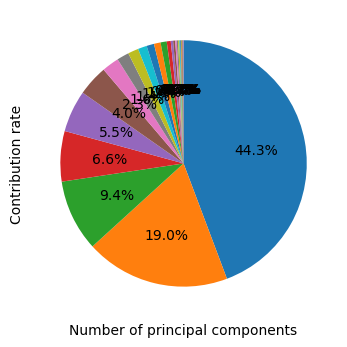

In [68]:
# 各成分の寄与度を円グラフで確認
plt.pie(pca.explained_variance_ratio_, counterclock=False, startangle=90, autopct="%1.1f%%")
plt.ylabel("Contribution rate")
plt.xlabel("Number of principal components")
plt.grid()

#### PCAによる次元削減実行
ここではスタートポイントとして2次元に次元削減して分類問題を解くことにします

In [23]:
# 次元削除後の特徴量数
n_components = 3

In [24]:
# PCAの実行
pca = PCA(n_components=n_components)
X_pca = pca.fit_transform(X)
print(pca.explained_variance_ratio_)

[0.44272026 0.18971182 0.09393163]


### データ加工（正規化）
各特徴量を最小値:0, 最大値:1になるように正規化します

In [25]:
# 特徴量を正規化
X_pca = MinMaxScaler().fit_transform(X_pca)

### データ加工（データ分割）
正規化したデータを学習用データとテスト用データに分割します

In [26]:
# 再現性確保のためにseed値を123として、学習用とテスト用にデータを分割
algorithm_globals.random_seed = 123
X_train, X_test, y_train, y_test = train_test_split(X_pca, y, train_size=0.8, random_state=algorithm_globals.random_seed)

## 古典的手法(SVM)による分類
以下のカーネルによるSVMでの分類を実施します
- RBF: Gaussianカーネル
- Linear: 線形カーネル
- Poly: 多項式回帰カーネル
- Sigmoid: シグモイドカーネル

In [27]:
# rbf, linear, poly, sigmoidの4つの古典的手法による結果を確認。
classical_kernels = ['rbf', 'linear', 'poly', 'sigmoid']

# start =time.time()
for kernel in classical_kernels:
    classical_svc = SVC(kernel= kernel)
    classical_svc.fit(X_train, y_train)
    classical_score = classical_svc.score(X_test, y_test)
    
    print(f'{kernel} kernel classification test score:  {classical_score: .2f}')

# elapsed = time.time() -start
# print(f"Training and testing time: {elapsed} seconds")

rbf kernel classification test score:   0.97
linear kernel classification test score:   0.96
poly kernel classification test score:   0.96
sigmoid kernel classification test score:   0.64


## 量子機械学習(VQC)による分類
VQC(Variational Quantum Classifier algorithm)は物理学における変分法（変分原理）を利用したアルゴリズムです。  
量子コンピューター上では、各系の最適なパラメータを見つけるために使用されます。  
VQCでは量子回路、損失関数、古典的最適化アルゴリズムを使用して下記のステップでパラメータの最適化を行うことになります。  

1. 量子回路の初期化
2. 回路に対してパラメータ化された量子ゲートを適用
3. 結果を取得して損失関数を適用
4. 古典的最適化アルゴリズムを使用してパラメータを調整

最適化されるまで1-4を繰り返す。  

VQCでは量子機械学習の他の手法であるQSVM（量子サポートベクターマシン）とは違い、特徴量マップから分類までを量子回路で実行できます。  
（パラメータ最適化は古典的手法を使用）

VQCでは量子ニューラルネットワークを構成するために入力データを特徴量マップにより、量子回路のビットで表現し、ニューラルネットワークの重みをAnsatzのパラメータで表現しています。  
損失関数にはcross entropyを古典的最適化アルゴリズムにはSPSAを採用しています。  

VQCでは古典的アルゴリズムと比較して量子ビットを扱うことによって多数の計算を並列に行うことができます。  
また、量子状態間の相関を利用して、新しいタイプのデータ表現が可能になります。

### Feature Map作成
ここでは特徴量マップを作成します。  
qiskitで用意されている特徴量マップにはZZFeatureMap, ZFeatureMap, PauliFeatureMapなどがありますが、ここではZZFeatureMapを使用します。

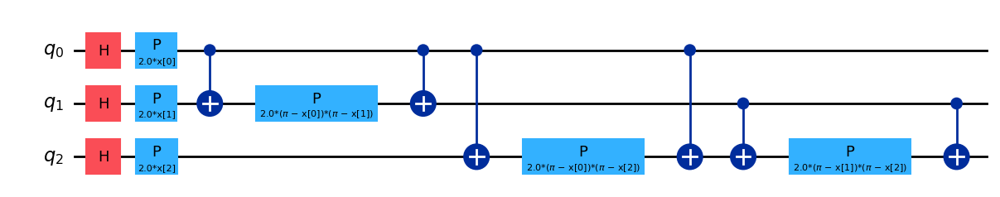

In [28]:
# 使用する特徴量の数
num_features = X_train.shape[1]

# ZZfeatureMapを作成
# feature_dimention: 特徴量数、reps: 
feature_map = ZZFeatureMap(feature_dimension=num_features, reps=1)
#feature_map = ZFeatureMap(feature_dimension=num_features, reps=1)
#feature_map = PauliFeatureMap(feature_dimension=num_features, reps=1)
feature_map.decompose().draw(output='mpl', fold=20)


### Ansatz作成
ここではパラメータ付き量子回路としてAnsatzを作成します。  
RealAmplitudesによるAnsatzの作成ではエンタングルメントの作成方法やパラメータの個数をチューニングできます。  
ここではエンタングルメントの作成方法としてreverse_linearを、パラメータの個数としてreps=3を指定します。

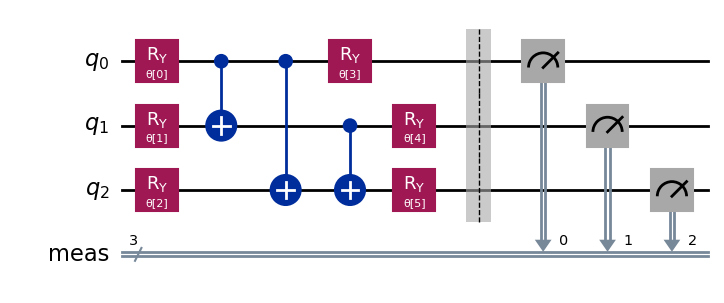

In [39]:
# 量子もつれの構造をreverse_linearに定義
entanglement = 'full'
#entanglement = 'linear'
#entanglement = 'reverse_linear'
#entanglement = 'circular'
#entanglement = 'sca'

## Ansatzを作成
# num_qubits: 量子ビット数、reps:、entanglement: 量子もつれの構造
#ansatz = RealAmplitudes(num_qubits=num_features, reps=3)
ansatz = RealAmplitudes(num_qubits=num_features, reps=1, entanglement=entanglement)

# 全ての量子ビットに対して測定を追加
ansatz.measure_all()

# 作成された回路を描写
ansatz.decompose().draw(output='mpl', fold=20)

### 量子回路作成
特徴量マップとAnsatzを合成して量子回路を作成します。

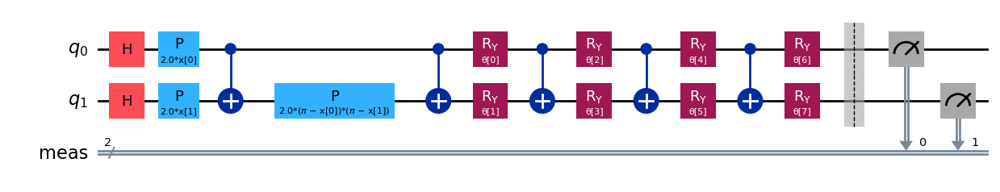

In [76]:
# 量子回路を作成
circuit = feature_map.compose(ansatz)

# 最終的な回路の描写
circuit.decompose().draw(output='mpl')

### コールバック関数定義
モデル学習時の目的関数の変化を見るためのcallback関数を準備します。

In [8]:
# 学習経過を描写するコールバックを定義
def callback_graph(weights, obj_func_eval):
    clear_output(wait=True)
    objective_func_vals.append(obj_func_eval)
    plt.title("Objective function value against iteration")
    plt.xlabel("Iteration")
    plt.ylabel("Objective function value")
    plt.plot(range(len(objective_func_vals)), objective_func_vals)
    plt.show()

### VQC作成
VQCを定義します。  
ここで特徴量マップ, Ansatz, 損失関数, 最適化アルゴリズムなどを指定します。

In [78]:
# construct variational quantum classifier
vqc = VQC(
    feature_map=feature_map, # 特徴量マップの指定
    ansatz=ansatz, # Ansatzの指定
    loss="cross_entropy", # 訓練時に使用する損失関数
    optimizer=COBYLA(maxiter=30), # 訓練時に使用する最適化アルゴリズム
    #optimizer=SPSA(maxiter=200), 
    callback=callback_graph, # 訓練中の中間データへのアクセス方式。ここでは先ほど設定したコールバック関数を適用。
    #sampler=sampler
)

### モデルの学習
モデルを学習し、VQCによる分類器を作成します。

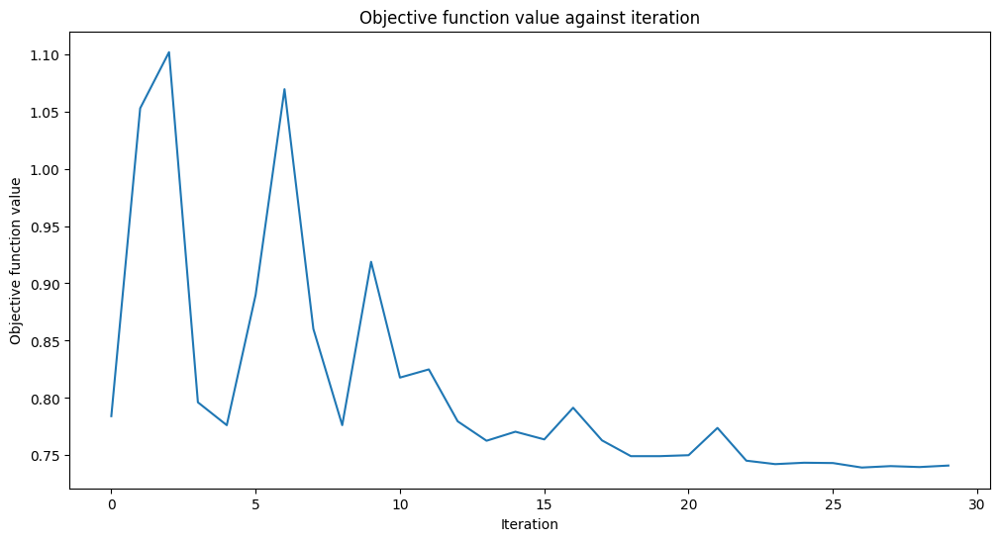

In [30]:
# create empty array for callback to store evaluations of the objective function
objective_func_vals = []
plt.rcParams["figure.figsize"] = (12, 6)

# fit classifier to data
vqc.fit(X_train, np.array(y_train).reshape(-1,1))

# return to default figsize
plt.rcParams["figure.figsize"] = (6, 4)

### 学習したモデルによるテストデータの分類
学習したモデルを使用してテスト用データを評価します。

In [30]:
# score classifier
print(f'Quantum VQC test score: {vqc.score(X_test, np.array(y_test).reshape(-1,1)):.2f}')

QiskitMachineLearningError: 'The model has not been fitted yet'

## 結果考察
ここまでで古典的手法（SVM）による分類と量子機械学習（VQC）による分類を実施しました。  
分類精度は古典的手法のほうが優れている結果となりました。  
ただし、VQCについてはまだ精度向上のためのチューニングの余地は残されています。

以降では量子機械学習のチューニングを実施して、どの程度精度を向上できるかチャレンジしていただきます。

## チューニング実施
VQCによる量子機械学習のチューニングとして以下の要素があります。
- n_components: PCAで削減する次元数
- featuremap: ZZFeatureMap, ZFeatureMap, PauliFeatureMapなどの選択肢がある
- featuremapのreps
- entanglement: RealAmplitudesのentanglementの方式（full, linear, reverse_linear, circular, scaから選択）
- RealAmplitudesのreps
- optimizer: COBYLA, SPSAなどの選択肢がある
- maxiter: 学習のステップ数

以降では、どのチューニングが効果があるか色々と試してみてください。

### チューニングポイント1
量子ビット数を増減させることで精度が変化するかを確認します
- n_components

**<span style="color: red; ">次元数を変更することによって、ノイズの増減や重要な情報を失うことがあります。</span>**

In [9]:
n_components = 3 #5 #def2 #6 #4

In [10]:
pca = PCA(n_components=n_components)
X_pca = pca.fit_transform(X)
print(pca.explained_variance_ratio_)

[0.44272026 0.18971182 0.09393163]


In [11]:
X_pca = MinMaxScaler().fit_transform(X_pca)

In [12]:
algorithm_globals.random_seed = 123
X_train, X_test, y_train, y_test = train_test_split(X_pca, y, train_size=0.8, random_state=algorithm_globals.random_seed)

In [13]:
classical_kernels = ['rbf', 'linear', 'poly', 'sigmoid']

# start =time.time()
for kernel in classical_kernels:
    classical_svc = SVC(kernel= kernel)
    classical_svc.fit(X_train, y_train)
    classical_score = classical_svc.score(X_test, y_test)
    
    print(f'{kernel} kernel classification test score:  {classical_score: .2f}')

# elapsed = time.time() -start
# print(f"Training and testing time: {elapsed} seconds")

rbf kernel classification test score:   0.97
linear kernel classification test score:   0.96
poly kernel classification test score:   0.96
sigmoid kernel classification test score:   0.64


### チューニングポイント2
特徴量マップの種類・パラメータの個数を変えることで精度が変化するかを確認します
- feature_mapの種類
- reps

**<span style="color: red; ">Feature mapの選択はデータを量子ビットの状態にどのようにエンコードするかを決定します。 異なるFeature mapは異なる特性を捉えるため、問題に適したものを選択する必要があります。</span>**

**<span style="color: red; ">repsを増やすことによってより複雑な構造を捉えることができますが、ノイズの影響を受けやすくなることを考慮する必要があります。</span>**

In [84]:
from qiskit import QuantumCircuit
from qiskit.circuit import ParameterVector
import numpy as np

num_features = X_train.shape[1]

class InitializeFeatureMap(QuantumCircuit):
    def __init__(self, feature_dimension, reps=1, data_map_func=None, parameter_prefix='x', name='InitializeFeatureMap'):
        super().__init__(feature_dimension, name=name)
        self.feature_dimension = feature_dimension
        self.reps = reps
        self.data_map_func = data_map_func
        self.parameter_prefix = parameter_prefix
        self.params = ParameterVector(parameter_prefix, feature_dimension)
        
        # Initialize feature parameters
        self._initialize_parameters()

    def _initialize_parameters(self):
        for _ in range(self.reps):
            for i in range(self.feature_dimension):
                self.ry(self.params[i], i)
                
# Example usage
feature_dimension = num_features
reps = 4
initialize_feature_map = InitializeFeatureMap(feature_dimension, reps)

feature_map = initialize_feature_map

print(feature_map)

     ┌──────────┐┌──────────┐┌──────────┐┌──────────┐
q_0: ┤ Ry(x[0]) ├┤ Ry(x[0]) ├┤ Ry(x[0]) ├┤ Ry(x[0]) ├
     ├──────────┤├──────────┤├──────────┤├──────────┤
q_1: ┤ Ry(x[1]) ├┤ Ry(x[1]) ├┤ Ry(x[1]) ├┤ Ry(x[1]) ├
     ├──────────┤├──────────┤├──────────┤├──────────┤
q_2: ┤ Ry(x[2]) ├┤ Ry(x[2]) ├┤ Ry(x[2]) ├┤ Ry(x[2]) ├
     └──────────┘└──────────┘└──────────┘└──────────┘


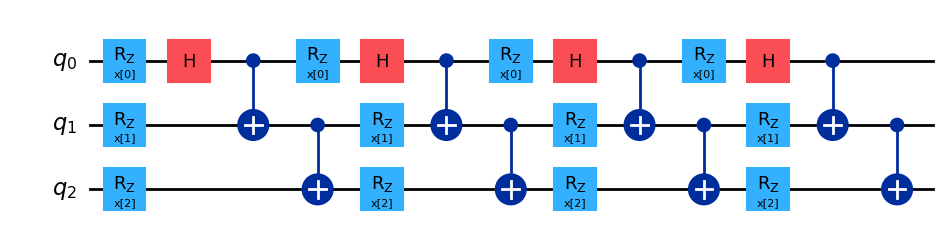

In [28]:
from qiskit import QuantumCircuit
from qiskit.circuit import ParameterVector
import numpy as np

num_features = X_train.shape[1]

class InitializeFeatureMap(QuantumCircuit):
    def __init__(self, feature_dimension, reps=1, data_map_func=None, parameter_prefix='x', name='InitializeFeatureMap'):
        super().__init__(feature_dimension, name=name)
        self.feature_dimension = feature_dimension
        self.reps = reps
        self.data_map_func = data_map_func
        self.parameter_prefix = parameter_prefix
        self.params = ParameterVector(parameter_prefix, feature_dimension)
        
        # Initialize feature parameters
        self._initialize_parameters()

    def _initialize_parameters(self):
        for _ in range(self.reps):
            for i in range(self.feature_dimension):
                self.ry(self.params[i], i)
                #self.rz(self.params[i], i)

            #self.barrier()
            
            ### 基本形 ###
            self.h(0)
            self.cx(0, 1)
            self.cx(1, 2)
            #self.barrier()
            
            """
            ### 変形1 ###
            self.h(0)
            self.cx(0, 1)
            self.cx(0, 2)
            self.barrier()
            """
            """
            ### 変形2 ###
            self.h([0, 1])
            self.x(2)
            self.cx(1, 2)
            self.cx(0, 2)
            self.h([0, 1, 2])
            self.barrier()
            """
# Example usage
feature_dimension = num_features
reps = 4
initialize_feature_map = InitializeFeatureMap(feature_dimension, reps)

feature_map = initialize_feature_map

feature_map.draw("mpl")

### チューニングポイント3
Ansatzのエンタングルメントの作成方法、パラメータの個数を変えることで精度が変化するかを確認します
- entanglement
- reps

**<span style="color: red; ">entaglementの選択は量子ビット間の相互作用の構造を決定します。 例えばfullは全量子ビットが相互作用するため強力ですが、ノイズに敏感になってしまいます。</span>**

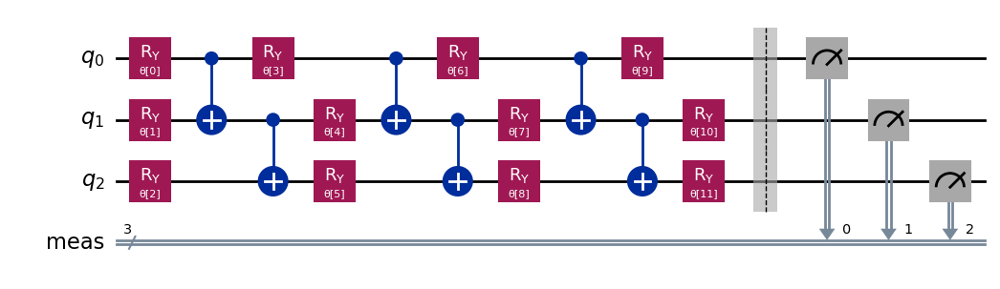

In [29]:
#entanglement = 'full'
entanglement = 'linear'
#entanglement = 'reverse_linear'  # ori
#entanglement = 'circular'
#entanglement = 'sca'

#ansatz = RealAmplitudes(num_qubits=num_features, reps=3)
ansatz = RealAmplitudes(num_qubits=num_features, reps=3, entanglement=entanglement)  #ori reps=3

#from qiskit.circuit.library import NLocal, TwoLocal, EfficientSU2
#ansatz = TwoLocal(num_qubits=num_features, rotation_blocks=['ry', 'rz'], entanglement_blocks='cz', entanglement='circular', reps=3)
#ansatz = TwoLocal(num_qubits=num_features, rotation_blocks=['ry', 'rz'], entanglement_blocks='cz', entanglement='linear', reps=3)
#ansatz = EfficientSU2(num_qubits=num_features, entanglement='linear', reps=3)
#ansatz = NLocal(num_qubits=num_features)

ansatz.measure_all()
ansatz.decompose().draw(output='mpl', fold=20)

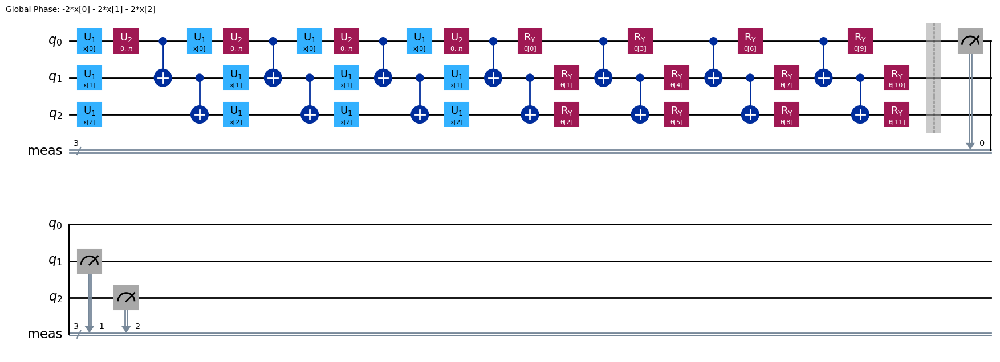

In [30]:
circuit = feature_map.compose(ansatz)
circuit.decompose().draw(output='mpl')

### チューニングポイント4
最適化アルゴリズム、評価の最大繰り返し回数を変えることで精度が変化するかを確認します
- optimizer
- maxiter

**<span style="color: red; ">最適化アルゴリズムの選択はプロセスの精度と速度に大きく影響します。例えばCOBYLAやSPSAがあります。</span>**

**<span style="color: red; ">各アルゴリズムには異なるパラメーターがあり、それらを適切にチューニングすることで、最適化の精度と速度を向上させることができます。例えば、COBYLAのmaxiterパラメータは最大反復回数を設定し、適切な値を選ぶことで最適化のパフォーマンスを調整します。</span>**

In [31]:
# construct variational quantum classifier
vqc = VQC(
    feature_map=feature_map,
    ansatz=ansatz,
    loss="cross_entropy",
    #optimizer=COBYLA(maxiter=30),
    optimizer=SPSA(maxiter=30),
    callback=callback_graph,
    #sampler=sampler
)

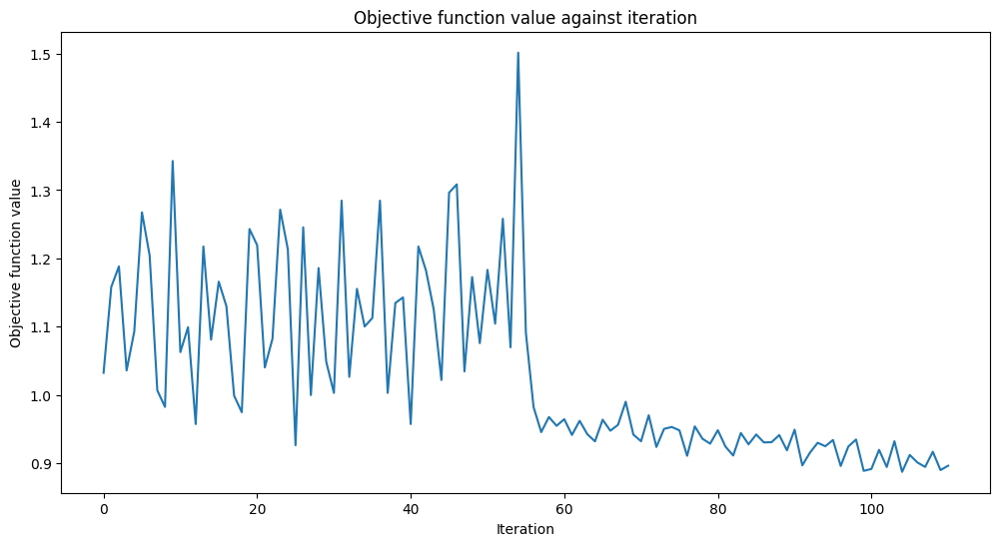

In [32]:
# create empty array for callback to store evaluations of the objective function
objective_func_vals = []
plt.rcParams["figure.figsize"] = (12, 6)

# fit classifier to data
vqc.fit(X_train, np.array(y_train).reshape(-1,1))

# return to default figsize
plt.rcParams["figure.figsize"] = (6, 4)

In [33]:
# score classifier
print(f'Quantum VQC test score: {vqc.score(X_test, np.array(y_test).reshape(-1,1)):.2f}')

Quantum VQC test score: 0.65
